## Define the Convolutional Neural Network

After you've looked at the data you're working with and, in this case, know the shapes of the images and of the keypoints, you are ready to define a convolutional neural network that can *learn* from this data.

In this notebook and in `models.py`, you will:
1. Define a CNN with images as input and keypoints as output
2. Construct the transformed FaceKeypointsDataset, just as before
3. Train the CNN on the training data, tracking loss
4. See how the trained model performs on test data
5. If necessary, modify the CNN structure and model hyperparameters, so that it performs *well* **\***

**\*** What does *well* mean?

"Well" means that the model's loss decreases during training **and**, when applied to test image data, the model produces keypoints that closely match the true keypoints of each face. And you'll see examples of this later in the notebook.

---


## CNN Architecture

Recall that CNN's are defined by a few types of layers:
* Convolutional layers
* Maxpooling layers
* Fully-connected layers

You are required to use the above layers and encouraged to add multiple convolutional layers and things like dropout layers that may prevent overfitting. You are also encouraged to look at literature on keypoint detection, such as [this paper](https://arxiv.org/pdf/1710.00977.pdf), to help you determine the structure of your network.


### TODO: Define your model in the provided file `models.py` file

This file is mostly empty but contains the expected name and some TODO's for creating your model.

---

## PyTorch Neural Nets

To define a neural network in PyTorch, you define the layers of a model in the function `__init__` and define the feedforward behavior of a network that employs those initialized layers in the function `forward`, which takes in an input image tensor, `x`. The structure of this Net class is shown below and left for you to fill in.

Note: During training, PyTorch will be able to perform backpropagation by keeping track of the network's feedforward behavior and using autograd to calculate the update to the weights in the network.

#### Define the Layers in ` __init__`
As a reminder, a conv/pool layer may be defined like this (in `__init__`):
```
# 1 input image channel (for grayscale images), 32 output channels/feature maps, 3x3 square convolution kernel
self.conv1 = nn.Conv2d(1, 32, 3)

# maxpool that uses a square window of kernel_size=2, stride=2
self.pool = nn.MaxPool2d(2, 2)      
```

#### Refer to Layers in `forward`
Then referred to in the `forward` function like this, in which the conv1 layer has a ReLu activation applied to it before maxpooling is applied:
```
x = self.pool(F.relu(self.conv1(x)))
```

Best practice is to place any layers whose weights will change during the training process in `__init__` and refer to them in the `forward` function; any layers or functions that always behave in the same way, such as a pre-defined activation function, should appear *only* in the `forward` function.

#### Why models.py

You are tasked with defining the network in the `models.py` file so that any models you define can be saved and loaded by name in different notebooks in this project directory. For example, by defining a CNN class called `Net` in `models.py`, you can then create that same architecture in this and other notebooks by simply importing the class and instantiating a model:
```
    from models import Net
    net = Net()
```

In [1]:
# import the usual resources
import matplotlib.pyplot as plt
import numpy as np

# watch for any changes in model.py, if it changes, re-load it automatically
%load_ext autoreload
%autoreload 2

In [2]:
## TODO: Define the Net in models.py

import torch
import torch.nn as nn
import torch.nn.functional as F

## TODO: Once you've define the network, you can instantiate it
# one example conv layer has been provided for you
from models import Net

net = Net()
print(net)

Net(
  (conv1): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=179776, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.3)
  (fc2): Linear(in_features=1000, out_features=136, bias=True)
)


## Transform the dataset 

To prepare for training, create a transformed dataset of images and keypoints.

### TODO: Define a data transform

In PyTorch, a convolutional neural network expects a torch image of a consistent size as input. For efficient training, and so your model's loss does not blow up during training, it is also suggested that you normalize the input images and keypoints. The necessary transforms have been defined in `data_load.py` and you **do not** need to modify these; take a look at this file (you'll see the same transforms that were defined and applied in Notebook 1).

To define the data transform below, use a [composition](http://pytorch.org/tutorials/beginner/data_loading_tutorial.html#compose-transforms) of:
1. Rescaling and/or cropping the data, such that you are left with a square image (the suggested size is 224x224px)
2. Normalizing the images and keypoints; turning each RGB image into a grayscale image with a color range of [0, 1] and transforming the given keypoints into a range of [-1, 1]
3. Turning these images and keypoints into Tensors

These transformations have been defined in `data_load.py`, but it's up to you to call them and create a `data_transform` below. **This transform will be applied to the training data and, later, the test data**. It will change how you go about displaying these images and keypoints, but these steps are essential for efficient training.

As a note, should you want to perform data augmentation (which is optional in this project), and randomly rotate or shift these images, a square image size will be useful; rotating a 224x224 image by 90 degrees will result in the same shape of output.

In [3]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

# the dataset we created in Notebook 1 is copied in the helper file `data_load.py`
from data_load import FacialKeypointsDataset
# the transforms we defined in Notebook 1 are in the helper file `data_load.py`
from data_load import Rescale, RandomCrop, Normalize, ToTensor


## TODO: define the data_transform using transforms.Compose([all tx's, . , .])
# order matters! i.e. rescaling should come before a smaller crop
data_transform = transforms.Compose([Rescale(250), RandomCrop(224), Normalize(), ToTensor()])

# testing that you've defined a transform
assert(data_transform is not None), 'Define a data_transform'

In [4]:
# create the transformed dataset
transformed_dataset = FacialKeypointsDataset(csv_file='data/training_frames_keypoints.csv',
                                             root_dir='data/training/',
                                             transform=data_transform)


print('Number of images: ', len(transformed_dataset))

# iterate through the transformed dataset and print some stats about the first few samples
for i in range(4):
    sample = transformed_dataset[i]
    print(i, sample['image'].size(), sample['keypoints'].size())

Number of images:  3462
0 torch.Size([1, 224, 224]) torch.Size([68, 2])
1 torch.Size([1, 224, 224]) torch.Size([68, 2])
2 torch.Size([1, 224, 224]) torch.Size([68, 2])
3 torch.Size([1, 224, 224]) torch.Size([68, 2])


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


## Batching and loading data

Next, having defined the transformed dataset, we can use PyTorch's DataLoader class to load the training data in batches of whatever size as well as to shuffle the data for training the model. You can read more about the parameters of the DataLoader, in [this documentation](http://pytorch.org/docs/master/data.html).

#### Batch size
Decide on a good batch size for training your model. Try both small and large batch sizes and note how the loss decreases as the model trains.

**Note for Windows users**: Please change the `num_workers` to 0 or you may face some issues with your DataLoader failing.

In [5]:
# load training data in batches
batch_size = 10

train_loader = DataLoader(transformed_dataset, 
                          batch_size=batch_size,
                          shuffle=True, 
                          num_workers=4)


## Before training

Take a look at how this model performs before it trains. You should see that the keypoints it predicts start off in one spot and don't match the keypoints on a face at all! It's interesting to visualize this behavior so that you can compare it to the model after training and see how the model has improved.

#### Load in the test dataset

The test dataset is one that this model has *not* seen before, meaning it has not trained with these images. We'll load in this test data and before and after training, see how your model performs on this set!

To visualize this test data, we have to go through some un-transformation steps to turn our images into python images from tensors and to turn our keypoints back into a recognizable range. 

In [6]:
# load in the test data, using the dataset class
# AND apply the data_transform you defined above

# create the test dataset
test_dataset = FacialKeypointsDataset(csv_file='data/test_frames_keypoints.csv',
                                             root_dir='data/test/',
                                             transform=data_transform)



In [7]:
# load test data in batches
batch_size = 10

test_loader = DataLoader(test_dataset, 
                          batch_size=batch_size,
                          shuffle=True, 
                          num_workers=4)

In [8]:
len(test_dataset)

770

In [9]:
next(iter(test_loader))['image'].size()

torch.Size([10, 1, 224, 224])

## Apply the model on a test sample

To test the model on a test sample of data, you have to follow these steps:
1. Extract the image and ground truth keypoints from a sample
2. Make sure the image is a FloatTensor, which the model expects.
3. Forward pass the image through the net to get the predicted, output keypoints.

This function test how the network performs on the first batch of test data. It returns the images, the transformed images, the predicted keypoints (produced by the model), and the ground truth keypoints.

In [10]:
# test the model on a batch of test images

def net_sample_output():
    
    # iterate through the test dataset
    for i, sample in enumerate(test_loader):
        
        # get sample data: images and ground truth keypoints
        images = sample['image']
        key_pts = sample['keypoints']

        # convert images to FloatTensors
        images = images.type(torch.FloatTensor)

        # forward pass to get net output
        output_pts = net(images)
        
        # reshape to batch_size x 68 x 2 pts
        output_pts = output_pts.view(output_pts.size()[0], 68, -1)
        
        # break after first image is tested
        if i == 0:
            return images, output_pts, key_pts
            

#### Debugging tips

If you get a size or dimension error here, make sure that your network outputs the expected number of keypoints! Or if you get a Tensor type error, look into changing the above code that casts the data into float types: `images = images.type(torch.FloatTensor)`.

In [11]:
# call the above function
# returns: test images, test predicted keypoints, test ground truth keypoints
test_images, test_outputs, gt_pts = net_sample_output()

# print out the dimensions of the data to see if they make sense
print(test_images.data.size())
print(test_outputs.data.size())
print(gt_pts.size())

torch.Size([10, 1, 224, 224])
torch.Size([10, 68, 2])
torch.Size([10, 68, 2])


## Visualize the predicted keypoints

Once we've had the model produce some predicted output keypoints, we can visualize these points in a way that's similar to how we've displayed this data before, only this time, we have to "un-transform" the image/keypoint data to display it.

Note that I've defined a *new* function, `show_all_keypoints` that displays a grayscale image, its predicted keypoints and its ground truth keypoints (if provided).

In [12]:
def show_all_keypoints(image, predicted_key_pts, gt_pts=None):
    """Show image with predicted keypoints"""
    # image is grayscale
    plt.imshow(image, cmap='gray')
    plt.scatter(predicted_key_pts[:, 0], predicted_key_pts[:, 1], s=20, marker='.', c='m')
    # plot ground truth points as green pts
    if gt_pts is not None:
        plt.scatter(gt_pts[:, 0], gt_pts[:, 1], s=20, marker='.', c='g')


#### Un-transformation

Next, you'll see a helper function. `visualize_output` that takes in a batch of images, predicted keypoints, and ground truth keypoints and displays a set of those images and their true/predicted keypoints.

This function's main role is to take batches of image and keypoint data (the input and output of your CNN), and transform them into numpy images and un-normalized keypoints (x, y) for normal display. The un-transformation process turns keypoints and images into numpy arrays from Tensors *and* it undoes the keypoint normalization done in the Normalize() transform; it's assumed that you applied these transformations when you loaded your test data.

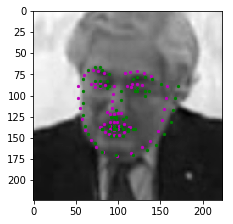

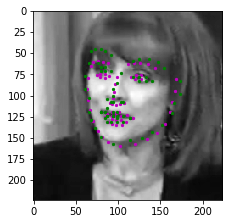

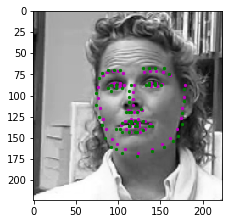

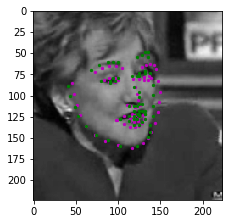

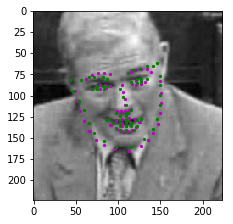

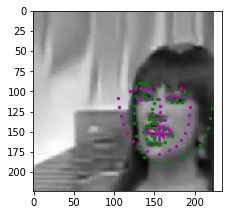

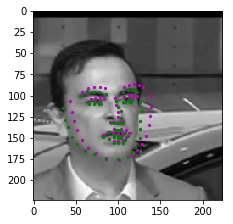

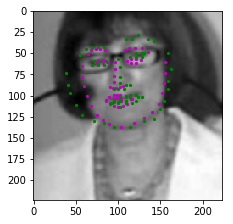

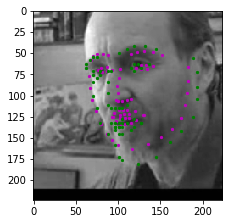

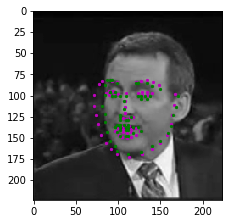

In [153]:
# visualize the output
# by default this shows a batch of 10 images
def visualize_output(test_images, test_outputs, gt_pts=None, batch_size=10):

    for i in range(batch_size):
        plt.figure(figsize=(40,20))
        ax = plt.subplot(1, batch_size, i+1)

        # un-transform the image data
        image = test_images[i].data   # get the image from it's wrapper
        image = image.numpy()   # convert to numpy array from a Tensor
        image = np.transpose(image, (1, 2, 0))   # transpose to go from torch to numpy image

        # un-transform the predicted key_pts data
        predicted_key_pts = test_outputs[i].data
        predicted_key_pts = predicted_key_pts.numpy()
        # undo normalization of keypoints  
        predicted_key_pts = predicted_key_pts*50.0+100
        
        # plot ground truth points for comparison, if they exist
        ground_truth_pts = None
        if gt_pts is not None:
            ground_truth_pts = gt_pts[i]         
            ground_truth_pts = ground_truth_pts*50.0+100
        
        # call show_all_keypoints
        show_all_keypoints(np.squeeze(image), predicted_key_pts, ground_truth_pts)
            
        #plt.axis('off')

    plt.show()
    
# call it
visualize_output(test_images, test_outputs, gt_pts)

## Training

#### Loss function
Training a network to predict keypoints is different than training a network to predict a class; instead of outputting a distribution of classes and using cross entropy loss, you may want to choose a loss function that is suited for regression, which directly compares a predicted value and target value. Read about the various kinds of loss functions (like MSE or L1/SmoothL1 loss) in [this documentation](http://pytorch.org/docs/master/_modules/torch/nn/modules/loss.html).

### TODO: Define the loss and optimization

Next, you'll define how the model will train by deciding on the loss function and optimizer.

---

## Settings BEGIN

In [14]:
device = 'cuda'

In [99]:
# load training data in batches
batch_size = 32

train_loader = DataLoader(transformed_dataset, 
                          batch_size=batch_size,
                          shuffle=True, 
                          num_workers=4)


## Settings END

In [100]:
from models import Net

if net:
    del net
net = Net()
print(net)

Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)


In [101]:
## TODO: Define the loss and optimization
import torch.optim as optim

criterion = nn.MSELoss()

#optimizer = optim.SGD(net.parameters(), lr=0.001)
optimizer = optim.Adam(net.parameters(), lr=0.0005)

## Training and Initial Observation

Now, you'll train on your batched training data from `train_loader` for a number of epochs. 

To quickly observe how your model is training and decide on whether or not you should modify it's structure or hyperparameters, you're encouraged to start off with just one or two epochs at first. As you train, note how your the model's loss behaves over time: does it decrease quickly at first and then slow down? Does it take a while to decrease in the first place? What happens if you change the batch size of your training data or modify your loss function? etc. 

Use these initial observations to make changes to your model and decide on the best architecture before you train for many epochs and create a final model.

In [81]:
def train_net(n_epochs):
    
    # prepare the net for training
    net.to(device)
    net.train()

    for epoch in range(n_epochs):  # loop over the dataset multiple times
        
        running_loss = 0.0

        # train on batches of data, assumes you already have train_loader
        for batch_i, data in enumerate(train_loader):
            # get the input images and their corresponding labels
            images = data['image']
            key_pts = data['keypoints']

            # flatten pts
            key_pts = key_pts.view(key_pts.size(0), -1)

            # convert variables to floats for regression loss
            key_pts = key_pts.type(torch.FloatTensor).to(device)
            images = images.type(torch.FloatTensor).to(device)

            # forward pass to get outputs
            output_pts = net(images)

            # calculate the loss between predicted and target keypoints
            loss = criterion(output_pts, key_pts)

            # zero the parameter (weight) gradients
            optimizer.zero_grad()
            
            # backward pass to calculate the weight gradients
            loss.backward()

            # update the weights
            optimizer.step()

            # print loss statistics
            # to convert loss into a scalar and add it to the running_loss, use .item()
            running_loss += loss.item()
            if batch_i % 10 == 9:    # print every 10 batches
                print('Epoch: {}, Batch: {}, Avg. Loss: {}'.format(epoch + 1, batch_i+1, running_loss/(10*batch_size)))
                running_loss = 0.0

    print('Finished Training')


In [ ]:
# train your network
n_epochs = 500 # start small, and increase when you've decided on your model structure and hyperparams

train_net(n_epochs)

/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011258028633892535
Epoch: 1, Batch: 20, Avg. Loss: 0.006969809299334884
Epoch: 1, Batch: 30, Avg. Loss: 0.008333262195810676
Epoch: 1, Batch: 40, Avg. Loss: 0.006647116225212813
Epoch: 1, Batch: 50, Avg. Loss: 0.006979396240785718
Epoch: 1, Batch: 60, Avg. Loss: 0.006933402176946402
Epoch: 1, Batch: 70, Avg. Loss: 0.005820054118521512
Epoch: 1, Batch: 80, Avg. Loss: 0.00651892707683146
Epoch: 1, Batch: 90, Avg. Loss: 0.006230987375602126
Epoch: 1, Batch: 100, Avg. Loss: 0.006042435299605131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007013910240493715
Epoch: 2, Batch: 20, Avg. Loss: 0.006217462942004204
Epoch: 2, Batch: 30, Avg. Loss: 0.005494647892192006
Epoch: 2, Batch: 40, Avg. Loss: 0.006466055335476994
Epoch: 2, Batch: 50, Avg. Loss: 0.005203308770433068
Epoch: 2, Batch: 60, Avg. Loss: 0.006440191646106541
Epoch: 2, Batch: 70, Avg. Loss: 0.005763803981244564
Epoch: 2, Batch: 80, Avg. Loss: 0.005650877999141812
Epoch: 2, Batch: 90, Avg. Loss: 0.00600209143012762
Epoch: 2, Batch: 100, Avg. Loss: 0.005432403413578868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005891412124037742
Epoch: 3, Batch: 20, Avg. Loss: 0.005548415658995509
Epoch: 3, Batch: 30, Avg. Loss: 0.0047066336497664455
Epoch: 3, Batch: 40, Avg. Loss: 0.005367525434121489
Epoch: 3, Batch: 50, Avg. Loss: 0.004926629527471959
Epoch: 3, Batch: 60, Avg. Loss: 0.005764138558879495
Epoch: 3, Batch: 70, Avg. Loss: 0.005334157356992364
Epoch: 3, Batch: 80, Avg. Loss: 0.004538532043807208
Epoch: 3, Batch: 90, Avg. Loss: 0.00520440093241632
Epoch: 3, Batch: 100, Avg. Loss: 0.006108826072886586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004957760870456696
Epoch: 4, Batch: 20, Avg. Loss: 0.005172252026386559
Epoch: 4, Batch: 30, Avg. Loss: 0.0047327377833426
Epoch: 4, Batch: 40, Avg. Loss: 0.0044488517567515375
Epoch: 4, Batch: 50, Avg. Loss: 0.004500713059678673
Epoch: 4, Batch: 60, Avg. Loss: 0.005091689783148468
Epoch: 4, Batch: 70, Avg. Loss: 0.004578282916918397
Epoch: 4, Batch: 80, Avg. Loss: 0.004687087866477669
Epoch: 4, Batch: 90, Avg. Loss: 0.006035974947735667
Epoch: 4, Batch: 100, Avg. Loss: 0.004270124225877225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004667615774087608
Epoch: 5, Batch: 20, Avg. Loss: 0.00398457651026547
Epoch: 5, Batch: 30, Avg. Loss: 0.004476323490962386
Epoch: 5, Batch: 40, Avg. Loss: 0.004390822746790946
Epoch: 5, Batch: 50, Avg. Loss: 0.004262735019437969
Epoch: 5, Batch: 60, Avg. Loss: 0.004751033987849951
Epoch: 5, Batch: 70, Avg. Loss: 0.004906816640868783
Epoch: 5, Batch: 80, Avg. Loss: 0.004739977815188467
Epoch: 5, Batch: 90, Avg. Loss: 0.0046791443834081296
Epoch: 5, Batch: 100, Avg. Loss: 0.004139909241348505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005064387992024422
Epoch: 6, Batch: 20, Avg. Loss: 0.004683988238684833
Epoch: 6, Batch: 30, Avg. Loss: 0.005138879246078432
Epoch: 6, Batch: 40, Avg. Loss: 0.004189005633816123
Epoch: 6, Batch: 50, Avg. Loss: 0.004476094944402575
Epoch: 6, Batch: 60, Avg. Loss: 0.004359126021154225
Epoch: 6, Batch: 70, Avg. Loss: 0.0044383803149685265
Epoch: 6, Batch: 80, Avg. Loss: 0.00407722108066082
Epoch: 6, Batch: 90, Avg. Loss: 0.004701575147919357
Epoch: 6, Batch: 100, Avg. Loss: 0.004260141355916858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.003917627222836018
Epoch: 7, Batch: 20, Avg. Loss: 0.005366177461110055
Epoch: 7, Batch: 30, Avg. Loss: 0.0051755467662587765
Epoch: 7, Batch: 40, Avg. Loss: 0.004503810801543296
Epoch: 7, Batch: 50, Avg. Loss: 0.004361938964575529
Epoch: 7, Batch: 60, Avg. Loss: 0.00404298750218004
Epoch: 7, Batch: 70, Avg. Loss: 0.004624247387982905
Epoch: 7, Batch: 80, Avg. Loss: 0.004232848202809692
Epoch: 7, Batch: 90, Avg. Loss: 0.003667772328481078
Epoch: 7, Batch: 100, Avg. Loss: 0.004164450941607356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004006217536516488
Epoch: 8, Batch: 20, Avg. Loss: 0.004862613161094487
Epoch: 8, Batch: 30, Avg. Loss: 0.0038033009972423316
Epoch: 8, Batch: 40, Avg. Loss: 0.004424295877106488
Epoch: 8, Batch: 50, Avg. Loss: 0.004019097634591162
Epoch: 8, Batch: 60, Avg. Loss: 0.0043303218437358735
Epoch: 8, Batch: 70, Avg. Loss: 0.003741395683027804
Epoch: 8, Batch: 80, Avg. Loss: 0.005715836049057543
Epoch: 8, Batch: 90, Avg. Loss: 0.005461538559757173
Epoch: 8, Batch: 100, Avg. Loss: 0.003963779914192856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0035996363731101155
Epoch: 9, Batch: 20, Avg. Loss: 0.004071679268963635
Epoch: 9, Batch: 30, Avg. Loss: 0.00379517471883446
Epoch: 9, Batch: 40, Avg. Loss: 0.005468650395050645
Epoch: 9, Batch: 50, Avg. Loss: 0.005146120814606548
Epoch: 9, Batch: 60, Avg. Loss: 0.0041647380450740455
Epoch: 9, Batch: 70, Avg. Loss: 0.004192114388570189
Epoch: 9, Batch: 80, Avg. Loss: 0.004257896170020104
Epoch: 9, Batch: 90, Avg. Loss: 0.003263172460719943
Epoch: 9, Batch: 100, Avg. Loss: 0.003994792210869491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00414417814463377
Epoch: 10, Batch: 20, Avg. Loss: 0.0036310823634266853
Epoch: 10, Batch: 30, Avg. Loss: 0.004133218061178922
Epoch: 10, Batch: 40, Avg. Loss: 0.004274432430975139
Epoch: 10, Batch: 50, Avg. Loss: 0.004095726227387786
Epoch: 10, Batch: 60, Avg. Loss: 0.00483202775940299
Epoch: 10, Batch: 70, Avg. Loss: 0.0037022869335487487
Epoch: 10, Batch: 80, Avg. Loss: 0.00391754733864218
Epoch: 10, Batch: 90, Avg. Loss: 0.00408250717446208
Epoch: 10, Batch: 100, Avg. Loss: 0.003482384199742228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004592087585479021
Epoch: 11, Batch: 20, Avg. Loss: 0.00364494863897562
Epoch: 11, Batch: 30, Avg. Loss: 0.003914881020318717
Epoch: 11, Batch: 40, Avg. Loss: 0.0033891317434608936
Epoch: 11, Batch: 50, Avg. Loss: 0.003883348894305527
Epoch: 11, Batch: 60, Avg. Loss: 0.005824017128907144
Epoch: 11, Batch: 70, Avg. Loss: 0.0036173698492348192
Epoch: 11, Batch: 80, Avg. Loss: 0.004585802485235035
Epoch: 11, Batch: 90, Avg. Loss: 0.0035909521160647274
Epoch: 11, Batch: 100, Avg. Loss: 0.0037487845635041594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0035456094890832903
Epoch: 12, Batch: 20, Avg. Loss: 0.0032490752870216965
Epoch: 12, Batch: 30, Avg. Loss: 0.0033728887094184755
Epoch: 12, Batch: 40, Avg. Loss: 0.003507962799631059
Epoch: 12, Batch: 50, Avg. Loss: 0.003329643071629107
Epoch: 12, Batch: 60, Avg. Loss: 0.0052487982204183934
Epoch: 12, Batch: 70, Avg. Loss: 0.00340195344761014
Epoch: 12, Batch: 80, Avg. Loss: 0.0034430693136528133
Epoch: 12, Batch: 90, Avg. Loss: 0.003943202109076083
Epoch: 12, Batch: 100, Avg. Loss: 0.004608925827778876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.003301806794479489
Epoch: 13, Batch: 20, Avg. Loss: 0.003629139089025557
Epoch: 13, Batch: 30, Avg. Loss: 0.0035804515238851307
Epoch: 13, Batch: 40, Avg. Loss: 0.0037637694040313363
Epoch: 13, Batch: 50, Avg. Loss: 0.0036190357757732274
Epoch: 13, Batch: 60, Avg. Loss: 0.003944122267421335
Epoch: 13, Batch: 70, Avg. Loss: 0.003143854928202927
Epoch: 13, Batch: 80, Avg. Loss: 0.0031136338133364917
Epoch: 13, Batch: 90, Avg. Loss: 0.003952561062760651
Epoch: 13, Batch: 100, Avg. Loss: 0.0032373615074902775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0032268765149638056
Epoch: 14, Batch: 20, Avg. Loss: 0.0026106522302143274
Epoch: 14, Batch: 30, Avg. Loss: 0.0032941845478489996
Epoch: 14, Batch: 40, Avg. Loss: 0.0031881266389973462
Epoch: 14, Batch: 50, Avg. Loss: 0.0030152590828947724
Epoch: 14, Batch: 60, Avg. Loss: 0.0028690443374216556
Epoch: 14, Batch: 70, Avg. Loss: 0.003567437012679875
Epoch: 14, Batch: 80, Avg. Loss: 0.0037875946261920037
Epoch: 14, Batch: 90, Avg. Loss: 0.0026432083919644355
Epoch: 14, Batch: 100, Avg. Loss: 0.002777425036765635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0032386311795562506
Epoch: 15, Batch: 20, Avg. Loss: 0.0035332747269421817
Epoch: 15, Batch: 30, Avg. Loss: 0.0025938256294466555
Epoch: 15, Batch: 40, Avg. Loss: 0.00410949073266238
Epoch: 15, Batch: 50, Avg. Loss: 0.0025525846402160825
Epoch: 15, Batch: 60, Avg. Loss: 0.0028230577358044685
Epoch: 15, Batch: 70, Avg. Loss: 0.0027123445062898098
Epoch: 15, Batch: 80, Avg. Loss: 0.002712112118024379
Epoch: 15, Batch: 90, Avg. Loss: 0.003158526821061969
Epoch: 15, Batch: 100, Avg. Loss: 0.0028336983639746906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003540865273680538
Epoch: 16, Batch: 20, Avg. Loss: 0.0022862422978505493
Epoch: 16, Batch: 30, Avg. Loss: 0.0027449314715340734
Epoch: 16, Batch: 40, Avg. Loss: 0.0027374135795980694
Epoch: 16, Batch: 50, Avg. Loss: 0.002342139557003975
Epoch: 16, Batch: 60, Avg. Loss: 0.0029455920332111417
Epoch: 16, Batch: 70, Avg. Loss: 0.0023284171940758823
Epoch: 16, Batch: 80, Avg. Loss: 0.003190080914646387
Epoch: 16, Batch: 90, Avg. Loss: 0.0028820180450566113
Epoch: 16, Batch: 100, Avg. Loss: 0.0032546648290008307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0021428332081995906
Epoch: 17, Batch: 20, Avg. Loss: 0.0025501824682578446
Epoch: 17, Batch: 30, Avg. Loss: 0.002731064613908529
Epoch: 17, Batch: 40, Avg. Loss: 0.0028608274180442093
Epoch: 17, Batch: 50, Avg. Loss: 0.0021656606695614755
Epoch: 17, Batch: 60, Avg. Loss: 0.0028392268810421228
Epoch: 17, Batch: 70, Avg. Loss: 0.002549181564245373
Epoch: 17, Batch: 80, Avg. Loss: 0.004466670763213188
Epoch: 17, Batch: 90, Avg. Loss: 0.0029510695254430174
Epoch: 17, Batch: 100, Avg. Loss: 0.002743180701509118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0027237741742283106
Epoch: 18, Batch: 20, Avg. Loss: 0.002814362512435764
Epoch: 18, Batch: 30, Avg. Loss: 0.0024241758743301033
Epoch: 18, Batch: 40, Avg. Loss: 0.003194985422305763
Epoch: 18, Batch: 50, Avg. Loss: 0.002465757203754038
Epoch: 18, Batch: 60, Avg. Loss: 0.0020634539658203723
Epoch: 18, Batch: 70, Avg. Loss: 0.0022172754514031114
Epoch: 18, Batch: 80, Avg. Loss: 0.0026165771298110483
Epoch: 18, Batch: 90, Avg. Loss: 0.0024740719585679472
Epoch: 18, Batch: 100, Avg. Loss: 0.0022684880648739638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0032866498455405234
Epoch: 19, Batch: 20, Avg. Loss: 0.0020334933768026532
Epoch: 19, Batch: 30, Avg. Loss: 0.0022335030254907904
Epoch: 19, Batch: 40, Avg. Loss: 0.002489862951915711
Epoch: 19, Batch: 50, Avg. Loss: 0.0025870959274470807
Epoch: 19, Batch: 60, Avg. Loss: 0.002247739816084504
Epoch: 19, Batch: 70, Avg. Loss: 0.002022264851257205
Epoch: 19, Batch: 80, Avg. Loss: 0.00486521819839254
Epoch: 19, Batch: 90, Avg. Loss: 0.0027401245897635818
Epoch: 19, Batch: 100, Avg. Loss: 0.002342936338391155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.003332118410617113
Epoch: 20, Batch: 20, Avg. Loss: 0.0018736710073426366
Epoch: 20, Batch: 30, Avg. Loss: 0.002342606277670711
Epoch: 20, Batch: 40, Avg. Loss: 0.002270100370515138
Epoch: 20, Batch: 50, Avg. Loss: 0.0023091251263394953
Epoch: 20, Batch: 60, Avg. Loss: 0.0022266895743086935
Epoch: 20, Batch: 70, Avg. Loss: 0.002576164633501321
Epoch: 20, Batch: 80, Avg. Loss: 0.0024410214857198296
Epoch: 20, Batch: 90, Avg. Loss: 0.0020961725967936218
Epoch: 20, Batch: 100, Avg. Loss: 0.0020547585445456207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.002597908757161349
Epoch: 21, Batch: 20, Avg. Loss: 0.003988834004849196
Epoch: 21, Batch: 30, Avg. Loss: 0.0022123992559500037
Epoch: 21, Batch: 40, Avg. Loss: 0.0027311814366839824
Epoch: 21, Batch: 50, Avg. Loss: 0.0022216235287487508
Epoch: 21, Batch: 60, Avg. Loss: 0.001953777391463518
Epoch: 21, Batch: 70, Avg. Loss: 0.00215693477075547
Epoch: 21, Batch: 80, Avg. Loss: 0.002154577861074358
Epoch: 21, Batch: 90, Avg. Loss: 0.0019017430604435503
Epoch: 21, Batch: 100, Avg. Loss: 0.0019530796096660196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0022563542472198604
Epoch: 22, Batch: 20, Avg. Loss: 0.0017927315668202937
Epoch: 22, Batch: 30, Avg. Loss: 0.002362955710850656
Epoch: 22, Batch: 40, Avg. Loss: 0.0019060700316913426
Epoch: 22, Batch: 50, Avg. Loss: 0.0023069364950060846
Epoch: 22, Batch: 60, Avg. Loss: 0.0022536493255756796
Epoch: 22, Batch: 70, Avg. Loss: 0.0023229971644468605
Epoch: 22, Batch: 80, Avg. Loss: 0.0023305763606913388
Epoch: 22, Batch: 90, Avg. Loss: 0.0024444180075079204
Epoch: 22, Batch: 100, Avg. Loss: 0.0024188683019019663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0019377355347387493
Epoch: 23, Batch: 20, Avg. Loss: 0.0018324191682040692
Epoch: 23, Batch: 30, Avg. Loss: 0.003097002347931266
Epoch: 23, Batch: 40, Avg. Loss: 0.0021382195060141384
Epoch: 23, Batch: 50, Avg. Loss: 0.0022157649276778103
Epoch: 23, Batch: 60, Avg. Loss: 0.0022338290116749706
Epoch: 23, Batch: 70, Avg. Loss: 0.0021280301036313174
Epoch: 23, Batch: 80, Avg. Loss: 0.0020901984767988323
Epoch: 23, Batch: 90, Avg. Loss: 0.0022881223470903934
Epoch: 23, Batch: 100, Avg. Loss: 0.00221817372366786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.001965509366709739
Epoch: 24, Batch: 20, Avg. Loss: 0.0019248833297751844
Epoch: 24, Batch: 30, Avg. Loss: 0.001737239630892873
Epoch: 24, Batch: 40, Avg. Loss: 0.0026422055321745574
Epoch: 24, Batch: 50, Avg. Loss: 0.002079211943782866
Epoch: 24, Batch: 60, Avg. Loss: 0.0019817814929410814
Epoch: 24, Batch: 70, Avg. Loss: 0.0017022505053319037
Epoch: 24, Batch: 80, Avg. Loss: 0.0018270653206855058
Epoch: 24, Batch: 90, Avg. Loss: 0.002173537516500801
Epoch: 24, Batch: 100, Avg. Loss: 0.0017954422743059694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.001994345593266189
Epoch: 25, Batch: 20, Avg. Loss: 0.002026938216295093
Epoch: 25, Batch: 30, Avg. Loss: 0.001975865080021322
Epoch: 25, Batch: 40, Avg. Loss: 0.0018021895317360758
Epoch: 25, Batch: 50, Avg. Loss: 0.0025498622213490306
Epoch: 25, Batch: 60, Avg. Loss: 0.0022201980464160442
Epoch: 25, Batch: 70, Avg. Loss: 0.0024104882613755763
Epoch: 25, Batch: 80, Avg. Loss: 0.0021868273499421774
Epoch: 25, Batch: 90, Avg. Loss: 0.0020879227784462275
Epoch: 25, Batch: 100, Avg. Loss: 0.001967880944721401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0021476300433278086
Epoch: 26, Batch: 20, Avg. Loss: 0.002144584653433412
Epoch: 26, Batch: 30, Avg. Loss: 0.0025077564059756696
Epoch: 26, Batch: 40, Avg. Loss: 0.0019369600340723991
Epoch: 26, Batch: 50, Avg. Loss: 0.0018700815038755537
Epoch: 26, Batch: 60, Avg. Loss: 0.0029897706233896317
Epoch: 26, Batch: 70, Avg. Loss: 0.0015678555704653264
Epoch: 26, Batch: 80, Avg. Loss: 0.0021938281832262875
Epoch: 26, Batch: 90, Avg. Loss: 0.0017678857897408307
Epoch: 26, Batch: 100, Avg. Loss: 0.002349079493433237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002250572177581489
Epoch: 27, Batch: 20, Avg. Loss: 0.0017733970656991006
Epoch: 27, Batch: 30, Avg. Loss: 0.0016681957058608532
Epoch: 27, Batch: 40, Avg. Loss: 0.001785282196942717
Epoch: 27, Batch: 50, Avg. Loss: 0.001530586404260248
Epoch: 27, Batch: 60, Avg. Loss: 0.0014591607148759067
Epoch: 27, Batch: 70, Avg. Loss: 0.0023039448191411794
Epoch: 27, Batch: 80, Avg. Loss: 0.0017976244096644222
Epoch: 27, Batch: 90, Avg. Loss: 0.0031625590519979594
Epoch: 27, Batch: 100, Avg. Loss: 0.0019628955516964195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0018208291265182197
Epoch: 28, Batch: 20, Avg. Loss: 0.0015697565744630993
Epoch: 28, Batch: 30, Avg. Loss: 0.002001648664008826
Epoch: 28, Batch: 40, Avg. Loss: 0.001640220417175442
Epoch: 28, Batch: 50, Avg. Loss: 0.0020115223247557878
Epoch: 28, Batch: 60, Avg. Loss: 0.001576953986659646
Epoch: 28, Batch: 70, Avg. Loss: 0.004984230676200241
Epoch: 28, Batch: 80, Avg. Loss: 0.0023263100767508147
Epoch: 28, Batch: 90, Avg. Loss: 0.0020505042164586486
Epoch: 28, Batch: 100, Avg. Loss: 0.0016297662281431259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0024429410113953054
Epoch: 29, Batch: 20, Avg. Loss: 0.0018637508037500083
Epoch: 29, Batch: 30, Avg. Loss: 0.001885859086178243
Epoch: 29, Batch: 40, Avg. Loss: 0.0017720761825330555
Epoch: 29, Batch: 50, Avg. Loss: 0.0017767874640412628
Epoch: 29, Batch: 60, Avg. Loss: 0.001948560797609389
Epoch: 29, Batch: 70, Avg. Loss: 0.0025849567959085108
Epoch: 29, Batch: 80, Avg. Loss: 0.00165267278207466
Epoch: 29, Batch: 90, Avg. Loss: 0.0017194179119542242
Epoch: 29, Batch: 100, Avg. Loss: 0.0020355695742182434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0020963876857422294
Epoch: 30, Batch: 20, Avg. Loss: 0.0017435646848753094
Epoch: 30, Batch: 30, Avg. Loss: 0.0018513920018449425
Epoch: 30, Batch: 40, Avg. Loss: 0.0017621540813706816
Epoch: 30, Batch: 50, Avg. Loss: 0.0016750848270021379
Epoch: 30, Batch: 60, Avg. Loss: 0.0015604859218001366
Epoch: 30, Batch: 70, Avg. Loss: 0.0020968502736650406
Epoch: 30, Batch: 80, Avg. Loss: 0.003648729168344289
Epoch: 30, Batch: 90, Avg. Loss: 0.001891462376806885
Epoch: 30, Batch: 100, Avg. Loss: 0.0014374866033904255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0021632123622111975
Epoch: 31, Batch: 20, Avg. Loss: 0.0017454334534704684
Epoch: 31, Batch: 30, Avg. Loss: 0.001792183972429484
Epoch: 31, Batch: 40, Avg. Loss: 0.002165904873982072
Epoch: 31, Batch: 50, Avg. Loss: 0.0016794695402495563
Epoch: 31, Batch: 60, Avg. Loss: 0.0016496494878083467
Epoch: 31, Batch: 70, Avg. Loss: 0.001672420755494386
Epoch: 31, Batch: 80, Avg. Loss: 0.0037005616119131445
Epoch: 31, Batch: 90, Avg. Loss: 0.0016923127113841474
Epoch: 31, Batch: 100, Avg. Loss: 0.0022616182104684412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0018411607132293284
Epoch: 32, Batch: 20, Avg. Loss: 0.0017694858717732132
Epoch: 32, Batch: 30, Avg. Loss: 0.0016908806515857576
Epoch: 32, Batch: 40, Avg. Loss: 0.0017256827210076152
Epoch: 32, Batch: 50, Avg. Loss: 0.0015605510445311666
Epoch: 32, Batch: 60, Avg. Loss: 0.0016939701861701905
Epoch: 32, Batch: 70, Avg. Loss: 0.003756897314451635
Epoch: 32, Batch: 80, Avg. Loss: 0.0021338391117751597
Epoch: 32, Batch: 90, Avg. Loss: 0.0019134256639517845
Epoch: 32, Batch: 100, Avg. Loss: 0.0014200612320564687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0018323032418265939
Epoch: 33, Batch: 20, Avg. Loss: 0.0019093941082246602
Epoch: 33, Batch: 30, Avg. Loss: 0.0016605182085186244
Epoch: 33, Batch: 40, Avg. Loss: 0.0013935550232417881
Epoch: 33, Batch: 50, Avg. Loss: 0.0016634261584840715
Epoch: 33, Batch: 60, Avg. Loss: 0.0017137103714048862
Epoch: 33, Batch: 70, Avg. Loss: 0.003365359560120851
Epoch: 33, Batch: 80, Avg. Loss: 0.0017555564176291228
Epoch: 33, Batch: 90, Avg. Loss: 0.0015921350102871656
Epoch: 33, Batch: 100, Avg. Loss: 0.0016713914927095174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0020173904253169895
Epoch: 34, Batch: 20, Avg. Loss: 0.0016145442263223232
Epoch: 34, Batch: 30, Avg. Loss: 0.001521593437064439
Epoch: 34, Batch: 40, Avg. Loss: 0.0017488327575847507
Epoch: 34, Batch: 50, Avg. Loss: 0.0015937940450385212
Epoch: 34, Batch: 60, Avg. Loss: 0.0019733012304641306
Epoch: 34, Batch: 70, Avg. Loss: 0.0041220443206839265
Epoch: 34, Batch: 80, Avg. Loss: 0.0019176211091689766
Epoch: 34, Batch: 90, Avg. Loss: 0.0023884658818133175
Epoch: 34, Batch: 100, Avg. Loss: 0.0019314973382279278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.001799096295144409
Epoch: 35, Batch: 20, Avg. Loss: 0.0014644767041318118
Epoch: 35, Batch: 30, Avg. Loss: 0.002107289235573262
Epoch: 35, Batch: 40, Avg. Loss: 0.0017122201505117118
Epoch: 35, Batch: 50, Avg. Loss: 0.0018794611096382141
Epoch: 35, Batch: 60, Avg. Loss: 0.002607399213593453
Epoch: 35, Batch: 70, Avg. Loss: 0.0016259022522717714
Epoch: 35, Batch: 80, Avg. Loss: 0.002219066844554618
Epoch: 35, Batch: 90, Avg. Loss: 0.001966731366701424
Epoch: 35, Batch: 100, Avg. Loss: 0.00229941081488505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0016936755971983075
Epoch: 36, Batch: 20, Avg. Loss: 0.0016533676302060486
Epoch: 36, Batch: 30, Avg. Loss: 0.0015988710685633123
Epoch: 36, Batch: 40, Avg. Loss: 0.0027489974978379904
Epoch: 36, Batch: 50, Avg. Loss: 0.0016641621245071293
Epoch: 36, Batch: 60, Avg. Loss: 0.0031712490832433104
Epoch: 36, Batch: 70, Avg. Loss: 0.0020634773885831238
Epoch: 36, Batch: 80, Avg. Loss: 0.001626655994914472
Epoch: 36, Batch: 90, Avg. Loss: 0.0019476334331557156
Epoch: 36, Batch: 100, Avg. Loss: 0.0016234126291237772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0018632603925652802
Epoch: 37, Batch: 20, Avg. Loss: 0.002532584615983069
Epoch: 37, Batch: 30, Avg. Loss: 0.002237921941559762
Epoch: 37, Batch: 40, Avg. Loss: 0.0015961708617396654
Epoch: 37, Batch: 50, Avg. Loss: 0.0015312470030039548
Epoch: 37, Batch: 60, Avg. Loss: 0.0017996872775256634
Epoch: 37, Batch: 70, Avg. Loss: 0.001811394898686558
Epoch: 37, Batch: 80, Avg. Loss: 0.0021394277107901873
Epoch: 37, Batch: 90, Avg. Loss: 0.0016441637882962823
Epoch: 37, Batch: 100, Avg. Loss: 0.0018328017788007856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0012980036088265478
Epoch: 38, Batch: 20, Avg. Loss: 0.0014792518923059106
Epoch: 38, Batch: 30, Avg. Loss: 0.0018501796177588404
Epoch: 38, Batch: 40, Avg. Loss: 0.0020844557031523435
Epoch: 38, Batch: 50, Avg. Loss: 0.0016789811081252993
Epoch: 38, Batch: 60, Avg. Loss: 0.002052099024876952
Epoch: 38, Batch: 70, Avg. Loss: 0.0020262444391846656
Epoch: 38, Batch: 80, Avg. Loss: 0.002028644422534853
Epoch: 38, Batch: 90, Avg. Loss: 0.0019650005036965013
Epoch: 38, Batch: 100, Avg. Loss: 0.0013664489961229265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0014505526400171221
Epoch: 39, Batch: 20, Avg. Loss: 0.0015158104826696217
Epoch: 39, Batch: 30, Avg. Loss: 0.002971303917001933
Epoch: 39, Batch: 40, Avg. Loss: 0.0017237926018424331
Epoch: 39, Batch: 50, Avg. Loss: 0.0016708401963114738
Epoch: 39, Batch: 60, Avg. Loss: 0.0017965281731449068
Epoch: 39, Batch: 70, Avg. Loss: 0.0025937518337741496
Epoch: 39, Batch: 80, Avg. Loss: 0.0017061692662537098
Epoch: 39, Batch: 90, Avg. Loss: 0.001499731617514044
Epoch: 39, Batch: 100, Avg. Loss: 0.001402777316980064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.001303381531033665
Epoch: 40, Batch: 20, Avg. Loss: 0.001925351656973362
Epoch: 40, Batch: 30, Avg. Loss: 0.0015377091127447783
Epoch: 40, Batch: 40, Avg. Loss: 0.001525875471998006
Epoch: 40, Batch: 50, Avg. Loss: 0.00299382001394406
Epoch: 40, Batch: 60, Avg. Loss: 0.0023958564735949038
Epoch: 40, Batch: 70, Avg. Loss: 0.0017912482609972358
Epoch: 40, Batch: 80, Avg. Loss: 0.0016889318125322462
Epoch: 40, Batch: 90, Avg. Loss: 0.001533073280006647
Epoch: 40, Batch: 100, Avg. Loss: 0.0020535431278403847


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0020205211825668813
Epoch: 41, Batch: 20, Avg. Loss: 0.0014768959023058414
Epoch: 41, Batch: 30, Avg. Loss: 0.0017223381670191883
Epoch: 41, Batch: 40, Avg. Loss: 0.001470356178469956
Epoch: 41, Batch: 50, Avg. Loss: 0.0014584930322598666
Epoch: 41, Batch: 60, Avg. Loss: 0.0018114656209945678
Epoch: 41, Batch: 70, Avg. Loss: 0.0014873082167468966
Epoch: 41, Batch: 80, Avg. Loss: 0.00282022540923208
Epoch: 41, Batch: 90, Avg. Loss: 0.001477024599444121
Epoch: 41, Batch: 100, Avg. Loss: 0.0015192998340353369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0020841592689976097
Epoch: 42, Batch: 20, Avg. Loss: 0.002938240813091397
Epoch: 42, Batch: 30, Avg. Loss: 0.001738046493846923
Epoch: 42, Batch: 40, Avg. Loss: 0.001555249560624361
Epoch: 42, Batch: 50, Avg. Loss: 0.0014341887552291154
Epoch: 42, Batch: 60, Avg. Loss: 0.0014719217782840134
Epoch: 42, Batch: 70, Avg. Loss: 0.001438736415002495
Epoch: 42, Batch: 80, Avg. Loss: 0.001771383685991168
Epoch: 42, Batch: 90, Avg. Loss: 0.0013857256039045752
Epoch: 42, Batch: 100, Avg. Loss: 0.0015827597700990737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0016044683055952192
Epoch: 43, Batch: 20, Avg. Loss: 0.0018382504931651056
Epoch: 43, Batch: 30, Avg. Loss: 0.001569021528121084
Epoch: 43, Batch: 40, Avg. Loss: 0.0032319069025106726
Epoch: 43, Batch: 50, Avg. Loss: 0.0017739828559570014
Epoch: 43, Batch: 60, Avg. Loss: 0.0015790104982443154
Epoch: 43, Batch: 70, Avg. Loss: 0.0015251834760420025
Epoch: 43, Batch: 80, Avg. Loss: 0.0017885899636894465
Epoch: 43, Batch: 90, Avg. Loss: 0.0017396682291291655
Epoch: 43, Batch: 100, Avg. Loss: 0.0014854338369332254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0013145616045221685
Epoch: 44, Batch: 20, Avg. Loss: 0.001558917190413922
Epoch: 44, Batch: 30, Avg. Loss: 0.0015939331206027418
Epoch: 44, Batch: 40, Avg. Loss: 0.001438817655434832
Epoch: 44, Batch: 50, Avg. Loss: 0.0015750061662402003
Epoch: 44, Batch: 60, Avg. Loss: 0.0012382755405269564
Epoch: 44, Batch: 70, Avg. Loss: 0.0017826271476224064
Epoch: 44, Batch: 80, Avg. Loss: 0.0036759217618964612
Epoch: 44, Batch: 90, Avg. Loss: 0.0017557630548253656
Epoch: 44, Batch: 100, Avg. Loss: 0.003169870877172798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.001455177937168628
Epoch: 45, Batch: 20, Avg. Loss: 0.0015147027210332454
Epoch: 45, Batch: 30, Avg. Loss: 0.0017894855118356645
Epoch: 45, Batch: 40, Avg. Loss: 0.0018970390898175537
Epoch: 45, Batch: 50, Avg. Loss: 0.0014048432814888657
Epoch: 45, Batch: 60, Avg. Loss: 0.0014264539582654833
Epoch: 45, Batch: 70, Avg. Loss: 0.001430314703611657
Epoch: 45, Batch: 80, Avg. Loss: 0.001654563145712018
Epoch: 45, Batch: 90, Avg. Loss: 0.001731339143589139
Epoch: 45, Batch: 100, Avg. Loss: 0.0015906962333247065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.001772293681278825
Epoch: 46, Batch: 20, Avg. Loss: 0.001464897021651268
Epoch: 46, Batch: 30, Avg. Loss: 0.0014231048058718442
Epoch: 46, Batch: 40, Avg. Loss: 0.0022025870741344987
Epoch: 46, Batch: 50, Avg. Loss: 0.0014032029546797275
Epoch: 46, Batch: 60, Avg. Loss: 0.0012920163571834564
Epoch: 46, Batch: 70, Avg. Loss: 0.0014575227978639305
Epoch: 46, Batch: 80, Avg. Loss: 0.0014418431092053652
Epoch: 46, Batch: 90, Avg. Loss: 0.0017290246323682368
Epoch: 46, Batch: 100, Avg. Loss: 0.001435061590746045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0016173455282114447
Epoch: 47, Batch: 20, Avg. Loss: 0.0013833250151947141
Epoch: 47, Batch: 30, Avg. Loss: 0.001639179332414642
Epoch: 47, Batch: 40, Avg. Loss: 0.0024156223924364896
Epoch: 47, Batch: 50, Avg. Loss: 0.001378008007304743
Epoch: 47, Batch: 60, Avg. Loss: 0.0019077012548223138
Epoch: 47, Batch: 70, Avg. Loss: 0.0025193017558194698
Epoch: 47, Batch: 80, Avg. Loss: 0.0017571147764101624
Epoch: 47, Batch: 90, Avg. Loss: 0.002009880112018436
Epoch: 47, Batch: 100, Avg. Loss: 0.0012966109381522984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0013265380752272905
Epoch: 48, Batch: 20, Avg. Loss: 0.0014921349124051631
Epoch: 48, Batch: 30, Avg. Loss: 0.002157506858929992
Epoch: 48, Batch: 40, Avg. Loss: 0.0016451048315502704
Epoch: 48, Batch: 50, Avg. Loss: 0.0012323732138611377
Epoch: 48, Batch: 60, Avg. Loss: 0.0015272608958184718
Epoch: 48, Batch: 70, Avg. Loss: 0.0020418679690919817
Epoch: 48, Batch: 80, Avg. Loss: 0.0013619064469821752
Epoch: 48, Batch: 90, Avg. Loss: 0.0022103657538536936
Epoch: 48, Batch: 100, Avg. Loss: 0.0017619480029679834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0015118381241336464
Epoch: 49, Batch: 20, Avg. Loss: 0.0014084585302043707
Epoch: 49, Batch: 30, Avg. Loss: 0.0016153498319908977
Epoch: 49, Batch: 40, Avg. Loss: 0.0019002547720447182
Epoch: 49, Batch: 50, Avg. Loss: 0.0016847669263370334
Epoch: 49, Batch: 60, Avg. Loss: 0.001320422941353172
Epoch: 49, Batch: 70, Avg. Loss: 0.0018815557821653783
Epoch: 49, Batch: 80, Avg. Loss: 0.0017481935559771956
Epoch: 49, Batch: 90, Avg. Loss: 0.002094911376480013
Epoch: 49, Batch: 100, Avg. Loss: 0.0014064504997804762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0014203560014721007
Epoch: 50, Batch: 20, Avg. Loss: 0.00153271968010813
Epoch: 50, Batch: 30, Avg. Loss: 0.0017084870603866875
Epoch: 50, Batch: 40, Avg. Loss: 0.001459612138569355
Epoch: 50, Batch: 50, Avg. Loss: 0.0015077626856509596
Epoch: 50, Batch: 60, Avg. Loss: 0.0015867035195697098
Epoch: 50, Batch: 70, Avg. Loss: 0.003179914236534387
Epoch: 50, Batch: 80, Avg. Loss: 0.0019030900090001523
Epoch: 50, Batch: 90, Avg. Loss: 0.0017509678727947176
Epoch: 50, Batch: 100, Avg. Loss: 0.0014465901302173733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0015195838524959982
Epoch: 51, Batch: 20, Avg. Loss: 0.0014210558962076902
Epoch: 51, Batch: 30, Avg. Loss: 0.0013150728307664394
Epoch: 51, Batch: 40, Avg. Loss: 0.0016393024590797723
Epoch: 51, Batch: 50, Avg. Loss: 0.0016063148621469736
Epoch: 51, Batch: 60, Avg. Loss: 0.001515223359456286
Epoch: 51, Batch: 70, Avg. Loss: 0.0016181457554921507
Epoch: 51, Batch: 80, Avg. Loss: 0.001503762963693589
Epoch: 51, Batch: 90, Avg. Loss: 0.0016880180803127587
Epoch: 51, Batch: 100, Avg. Loss: 0.0014428827678784728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.001523637177888304
Epoch: 52, Batch: 20, Avg. Loss: 0.0013740020687691868
Epoch: 52, Batch: 30, Avg. Loss: 0.0014861878706142306
Epoch: 52, Batch: 40, Avg. Loss: 0.0014323029608931392
Epoch: 52, Batch: 50, Avg. Loss: 0.0016679535619914532
Epoch: 52, Batch: 60, Avg. Loss: 0.0012196556315757334
Epoch: 52, Batch: 70, Avg. Loss: 0.0014741396182216704
Epoch: 52, Batch: 80, Avg. Loss: 0.0013383251149207353
Epoch: 52, Batch: 90, Avg. Loss: 0.0018475316814146937
Epoch: 52, Batch: 100, Avg. Loss: 0.0015919392288196832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.001626451697666198
Epoch: 53, Batch: 20, Avg. Loss: 0.0014254596433602273
Epoch: 53, Batch: 30, Avg. Loss: 0.0021120012213941665
Epoch: 53, Batch: 40, Avg. Loss: 0.0013677770970389248
Epoch: 53, Batch: 50, Avg. Loss: 0.0015183958341367543
Epoch: 53, Batch: 60, Avg. Loss: 0.0013809157011564822
Epoch: 53, Batch: 70, Avg. Loss: 0.001228728611022234
Epoch: 53, Batch: 80, Avg. Loss: 0.00140968858031556
Epoch: 53, Batch: 90, Avg. Loss: 0.0012564170698169618
Epoch: 53, Batch: 100, Avg. Loss: 0.0014711763360537589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0013368476065807045
Epoch: 54, Batch: 20, Avg. Loss: 0.0012081453343853355
Epoch: 54, Batch: 30, Avg. Loss: 0.0015176416432950645
Epoch: 54, Batch: 40, Avg. Loss: 0.0017582781030796469
Epoch: 54, Batch: 50, Avg. Loss: 0.0019162569544278086
Epoch: 54, Batch: 60, Avg. Loss: 0.001535318623064086
Epoch: 54, Batch: 70, Avg. Loss: 0.0014684187481179833
Epoch: 54, Batch: 80, Avg. Loss: 0.0013712627696804702
Epoch: 54, Batch: 90, Avg. Loss: 0.0013858398597221822
Epoch: 54, Batch: 100, Avg. Loss: 0.0014295532484538854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.001736475678626448
Epoch: 55, Batch: 20, Avg. Loss: 0.0013294222531840204
Epoch: 55, Batch: 30, Avg. Loss: 0.0013509592041373252
Epoch: 55, Batch: 40, Avg. Loss: 0.003034379810560495
Epoch: 55, Batch: 50, Avg. Loss: 0.0016323555319104344
Epoch: 55, Batch: 60, Avg. Loss: 0.0014689020928926766
Epoch: 55, Batch: 70, Avg. Loss: 0.001895621360745281
Epoch: 55, Batch: 80, Avg. Loss: 0.0015551217598840593
Epoch: 55, Batch: 90, Avg. Loss: 0.001368691714014858
Epoch: 55, Batch: 100, Avg. Loss: 0.0014078347128815949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.00130081387469545
Epoch: 56, Batch: 20, Avg. Loss: 0.0015709190513007343
Epoch: 56, Batch: 30, Avg. Loss: 0.0018541441182605921
Epoch: 56, Batch: 40, Avg. Loss: 0.0013816587044857443
Epoch: 56, Batch: 50, Avg. Loss: 0.00207831027219072
Epoch: 56, Batch: 60, Avg. Loss: 0.0012285451986826957
Epoch: 56, Batch: 70, Avg. Loss: 0.0014970264979638158
Epoch: 56, Batch: 80, Avg. Loss: 0.0014943938469514251
Epoch: 56, Batch: 90, Avg. Loss: 0.0014391646778676658
Epoch: 56, Batch: 100, Avg. Loss: 0.0014289788028690963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0018288819352164864
Epoch: 57, Batch: 20, Avg. Loss: 0.0018390950514003634
Epoch: 57, Batch: 30, Avg. Loss: 0.0014473779476247728
Epoch: 57, Batch: 40, Avg. Loss: 0.0013512423145584762
Epoch: 57, Batch: 50, Avg. Loss: 0.0015543585061095655
Epoch: 57, Batch: 60, Avg. Loss: 0.0014930336503311992
Epoch: 57, Batch: 70, Avg. Loss: 0.0016520363395102322
Epoch: 57, Batch: 80, Avg. Loss: 0.0015715902321971954
Epoch: 57, Batch: 90, Avg. Loss: 0.0014739421661943198
Epoch: 57, Batch: 100, Avg. Loss: 0.0013521680724807084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0015449112572241575
Epoch: 58, Batch: 20, Avg. Loss: 0.001480013970285654
Epoch: 58, Batch: 30, Avg. Loss: 0.0014006647863425315
Epoch: 58, Batch: 40, Avg. Loss: 0.001304988982155919
Epoch: 58, Batch: 50, Avg. Loss: 0.0013846133195329457
Epoch: 58, Batch: 60, Avg. Loss: 0.0016290240688249468
Epoch: 58, Batch: 70, Avg. Loss: 0.001908128196373582
Epoch: 58, Batch: 80, Avg. Loss: 0.0013566451088991016
Epoch: 58, Batch: 90, Avg. Loss: 0.0018655587395187468
Epoch: 58, Batch: 100, Avg. Loss: 0.0015392574714496732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.001610213442472741
Epoch: 59, Batch: 20, Avg. Loss: 0.0018440401996485888
Epoch: 59, Batch: 30, Avg. Loss: 0.0013365828723181038
Epoch: 59, Batch: 40, Avg. Loss: 0.0015901232953183353
Epoch: 59, Batch: 50, Avg. Loss: 0.0018079568981193006
Epoch: 59, Batch: 60, Avg. Loss: 0.0016439528786577283
Epoch: 59, Batch: 70, Avg. Loss: 0.0016996666672639549
Epoch: 59, Batch: 80, Avg. Loss: 0.0037682135589420795
Epoch: 59, Batch: 90, Avg. Loss: 0.0015625818516127766
Epoch: 59, Batch: 100, Avg. Loss: 0.001428434276022017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0013985770288854837
Epoch: 60, Batch: 20, Avg. Loss: 0.0023391232010908426
Epoch: 60, Batch: 30, Avg. Loss: 0.0023909800802357495
Epoch: 60, Batch: 40, Avg. Loss: 0.0013864494627341627
Epoch: 60, Batch: 50, Avg. Loss: 0.0016623409057501704
Epoch: 60, Batch: 60, Avg. Loss: 0.001265540486201644
Epoch: 60, Batch: 70, Avg. Loss: 0.001530508289579302
Epoch: 60, Batch: 80, Avg. Loss: 0.001218823145609349
Epoch: 60, Batch: 90, Avg. Loss: 0.0015725749370176345
Epoch: 60, Batch: 100, Avg. Loss: 0.0012619437067769468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0016396192717365921
Epoch: 61, Batch: 20, Avg. Loss: 0.0013880864309612662
Epoch: 61, Batch: 30, Avg. Loss: 0.0012528129096608608
Epoch: 61, Batch: 40, Avg. Loss: 0.002539837418589741
Epoch: 61, Batch: 50, Avg. Loss: 0.0013801367837004363
Epoch: 61, Batch: 60, Avg. Loss: 0.0014137743681203574
Epoch: 61, Batch: 70, Avg. Loss: 0.001226307754404843
Epoch: 61, Batch: 80, Avg. Loss: 0.0015017109806649386
Epoch: 61, Batch: 90, Avg. Loss: 0.0015378077107015998
Epoch: 61, Batch: 100, Avg. Loss: 0.0016144106048159301


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0021015840233303607
Epoch: 62, Batch: 20, Avg. Loss: 0.0012677131744567305
Epoch: 62, Batch: 30, Avg. Loss: 0.0015850596071686595
Epoch: 62, Batch: 40, Avg. Loss: 0.0014591721934266388
Epoch: 62, Batch: 50, Avg. Loss: 0.0012875550601165742
Epoch: 62, Batch: 60, Avg. Loss: 0.0012377567065414042
Epoch: 62, Batch: 70, Avg. Loss: 0.0014423158601857722
Epoch: 62, Batch: 80, Avg. Loss: 0.0013621624035295098
Epoch: 62, Batch: 90, Avg. Loss: 0.0015730515005998313
Epoch: 62, Batch: 100, Avg. Loss: 0.00130797695601359


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0025901912013068795
Epoch: 63, Batch: 20, Avg. Loss: 0.0013800133368931712
Epoch: 63, Batch: 30, Avg. Loss: 0.001614014303777367
Epoch: 63, Batch: 40, Avg. Loss: 0.001574678800534457
Epoch: 63, Batch: 50, Avg. Loss: 0.0017852367018349469
Epoch: 63, Batch: 60, Avg. Loss: 0.0014193579088896513
Epoch: 63, Batch: 70, Avg. Loss: 0.0014071275072637945
Epoch: 63, Batch: 80, Avg. Loss: 0.0014124912093393504
Epoch: 63, Batch: 90, Avg. Loss: 0.0012583156290929764
Epoch: 63, Batch: 100, Avg. Loss: 0.0011696070898324252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0012324840878136455
Epoch: 64, Batch: 20, Avg. Loss: 0.0020885757578071205
Epoch: 64, Batch: 30, Avg. Loss: 0.0014119321946054696
Epoch: 64, Batch: 40, Avg. Loss: 0.00171028787153773
Epoch: 64, Batch: 50, Avg. Loss: 0.0015984172001481055
Epoch: 64, Batch: 60, Avg. Loss: 0.0013528703595511616
Epoch: 64, Batch: 70, Avg. Loss: 0.0013978896429762244
Epoch: 64, Batch: 80, Avg. Loss: 0.0018457667320035398
Epoch: 64, Batch: 90, Avg. Loss: 0.001608587137889117
Epoch: 64, Batch: 100, Avg. Loss: 0.0012178351811598987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.001551083556842059
Epoch: 65, Batch: 20, Avg. Loss: 0.0014285506971646101
Epoch: 65, Batch: 30, Avg. Loss: 0.0015358634584117681
Epoch: 65, Batch: 40, Avg. Loss: 0.0011168473341967911
Epoch: 65, Batch: 50, Avg. Loss: 0.0012167457083705814
Epoch: 65, Batch: 60, Avg. Loss: 0.0015436331159435213
Epoch: 65, Batch: 70, Avg. Loss: 0.0014596696535591036
Epoch: 65, Batch: 80, Avg. Loss: 0.001528005488216877
Epoch: 65, Batch: 90, Avg. Loss: 0.0014176910161040723
Epoch: 65, Batch: 100, Avg. Loss: 0.001300756522687152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.001771878299769014
Epoch: 66, Batch: 20, Avg. Loss: 0.0010906209063250571
Epoch: 66, Batch: 30, Avg. Loss: 0.0021911508694756774
Epoch: 66, Batch: 40, Avg. Loss: 0.0014226631494238973
Epoch: 66, Batch: 50, Avg. Loss: 0.0013870360213331877
Epoch: 66, Batch: 60, Avg. Loss: 0.0020941104739904404
Epoch: 66, Batch: 70, Avg. Loss: 0.0015200139139778912
Epoch: 66, Batch: 80, Avg. Loss: 0.001580548787023872
Epoch: 66, Batch: 90, Avg. Loss: 0.0011797393497545272
Epoch: 66, Batch: 100, Avg. Loss: 0.001148162060417235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0016122785629704595
Epoch: 67, Batch: 20, Avg. Loss: 0.0011618506396189332
Epoch: 67, Batch: 30, Avg. Loss: 0.0012875732500106096
Epoch: 67, Batch: 40, Avg. Loss: 0.0013413887179922312
Epoch: 67, Batch: 50, Avg. Loss: 0.0013450565980747341
Epoch: 67, Batch: 60, Avg. Loss: 0.0013223066343925893
Epoch: 67, Batch: 70, Avg. Loss: 0.0015894903684966267
Epoch: 67, Batch: 80, Avg. Loss: 0.001436835713684559
Epoch: 67, Batch: 90, Avg. Loss: 0.0011257820413447916
Epoch: 67, Batch: 100, Avg. Loss: 0.00147171409917064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0016339098394382745
Epoch: 68, Batch: 20, Avg. Loss: 0.0013945081271231174
Epoch: 68, Batch: 30, Avg. Loss: 0.0012764250044710935
Epoch: 68, Batch: 40, Avg. Loss: 0.0014998053316958248
Epoch: 68, Batch: 50, Avg. Loss: 0.0011306933127343654
Epoch: 68, Batch: 60, Avg. Loss: 0.0020110262208618223
Epoch: 68, Batch: 70, Avg. Loss: 0.0011639342177659274
Epoch: 68, Batch: 80, Avg. Loss: 0.0014399014064110816
Epoch: 68, Batch: 90, Avg. Loss: 0.0011189214303158224
Epoch: 68, Batch: 100, Avg. Loss: 0.0012059254164341836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0012738156714476646
Epoch: 69, Batch: 20, Avg. Loss: 0.0010989903123117984
Epoch: 69, Batch: 30, Avg. Loss: 0.001280417660018429
Epoch: 69, Batch: 40, Avg. Loss: 0.001398090913426131
Epoch: 69, Batch: 50, Avg. Loss: 0.0015912489674519748
Epoch: 69, Batch: 60, Avg. Loss: 0.001293386786710471
Epoch: 69, Batch: 70, Avg. Loss: 0.0035404191527049988
Epoch: 69, Batch: 80, Avg. Loss: 0.0012543162680231034
Epoch: 69, Batch: 90, Avg. Loss: 0.0012289164820685982
Epoch: 69, Batch: 100, Avg. Loss: 0.0013889602036215366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0011986035853624344
Epoch: 70, Batch: 20, Avg. Loss: 0.0012371999444440007
Epoch: 70, Batch: 30, Avg. Loss: 0.0012571926228702069
Epoch: 70, Batch: 40, Avg. Loss: 0.0014092779776547105
Epoch: 70, Batch: 50, Avg. Loss: 0.0020052605716045944
Epoch: 70, Batch: 60, Avg. Loss: 0.0011059094220399856
Epoch: 70, Batch: 70, Avg. Loss: 0.0011167959601152688
Epoch: 70, Batch: 80, Avg. Loss: 0.002229374315356836
Epoch: 70, Batch: 90, Avg. Loss: 0.0012613371945917606
Epoch: 70, Batch: 100, Avg. Loss: 0.0011531533789820969


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.001476320088841021
Epoch: 71, Batch: 20, Avg. Loss: 0.0012657325773034246
Epoch: 71, Batch: 30, Avg. Loss: 0.0018789153080433607
Epoch: 71, Batch: 40, Avg. Loss: 0.0011740973801352083
Epoch: 71, Batch: 50, Avg. Loss: 0.0015698331582825631
Epoch: 71, Batch: 60, Avg. Loss: 0.001986730226781219
Epoch: 71, Batch: 70, Avg. Loss: 0.001146799436537549
Epoch: 71, Batch: 80, Avg. Loss: 0.0015086143219377845
Epoch: 71, Batch: 90, Avg. Loss: 0.0011612924572546035
Epoch: 71, Batch: 100, Avg. Loss: 0.001378334080800414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.00133111045579426
Epoch: 72, Batch: 20, Avg. Loss: 0.0013872509473003447
Epoch: 72, Batch: 30, Avg. Loss: 0.0026414161548018456
Epoch: 72, Batch: 40, Avg. Loss: 0.0021397592849098147
Epoch: 72, Batch: 50, Avg. Loss: 0.001535899145528674
Epoch: 72, Batch: 60, Avg. Loss: 0.0014311122824437917
Epoch: 72, Batch: 70, Avg. Loss: 0.001419826556229964
Epoch: 72, Batch: 80, Avg. Loss: 0.0015455000044312327
Epoch: 72, Batch: 90, Avg. Loss: 0.001172818714985624
Epoch: 72, Batch: 100, Avg. Loss: 0.0012727300578262656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0014071005920413882
Epoch: 73, Batch: 20, Avg. Loss: 0.001083554292563349
Epoch: 73, Batch: 30, Avg. Loss: 0.0012892434897366911
Epoch: 73, Batch: 40, Avg. Loss: 0.003476328356191516
Epoch: 73, Batch: 50, Avg. Loss: 0.0015749104903079569
Epoch: 73, Batch: 60, Avg. Loss: 0.001244118541944772
Epoch: 73, Batch: 70, Avg. Loss: 0.001315368851646781
Epoch: 73, Batch: 80, Avg. Loss: 0.0011142028088215739
Epoch: 73, Batch: 90, Avg. Loss: 0.0011279787111561745
Epoch: 73, Batch: 100, Avg. Loss: 0.0012807379476726054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0012507597159128637
Epoch: 74, Batch: 20, Avg. Loss: 0.001169520808616653
Epoch: 74, Batch: 30, Avg. Loss: 0.001213220553472638
Epoch: 74, Batch: 40, Avg. Loss: 0.0022790212533436716
Epoch: 74, Batch: 50, Avg. Loss: 0.0013606374443043024
Epoch: 74, Batch: 60, Avg. Loss: 0.001315800502197817
Epoch: 74, Batch: 70, Avg. Loss: 0.0011916476825717837
Epoch: 74, Batch: 80, Avg. Loss: 0.0010728471621405332
Epoch: 74, Batch: 90, Avg. Loss: 0.0033488642424345017
Epoch: 74, Batch: 100, Avg. Loss: 0.0018606189114507288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0019385982828680425
Epoch: 75, Batch: 20, Avg. Loss: 0.001289346336852759
Epoch: 75, Batch: 30, Avg. Loss: 0.0012761594029143454
Epoch: 75, Batch: 40, Avg. Loss: 0.001482196361757815
Epoch: 75, Batch: 50, Avg. Loss: 0.0016499913530424238
Epoch: 75, Batch: 60, Avg. Loss: 0.0012125828070566058
Epoch: 75, Batch: 70, Avg. Loss: 0.001346543082036078
Epoch: 75, Batch: 80, Avg. Loss: 0.0017752441053744406
Epoch: 75, Batch: 90, Avg. Loss: 0.0013700012117624284
Epoch: 75, Batch: 100, Avg. Loss: 0.0011810997093562037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0014466915396042167
Epoch: 76, Batch: 20, Avg. Loss: 0.0015672503097448498
Epoch: 76, Batch: 30, Avg. Loss: 0.0013442750205285847
Epoch: 76, Batch: 40, Avg. Loss: 0.0013584297965280711
Epoch: 76, Batch: 50, Avg. Loss: 0.0011988650483544915
Epoch: 76, Batch: 60, Avg. Loss: 0.0012326388910878449
Epoch: 76, Batch: 70, Avg. Loss: 0.001310787838883698
Epoch: 76, Batch: 80, Avg. Loss: 0.0016600527334958315
Epoch: 76, Batch: 90, Avg. Loss: 0.00151150724850595
Epoch: 76, Batch: 100, Avg. Loss: 0.0012482329329941422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0013102647615596652
Epoch: 77, Batch: 20, Avg. Loss: 0.0012673187186010182
Epoch: 77, Batch: 30, Avg. Loss: 0.0011667550774291159
Epoch: 77, Batch: 40, Avg. Loss: 0.0013144297699909657
Epoch: 77, Batch: 50, Avg. Loss: 0.0012510397995356471
Epoch: 77, Batch: 60, Avg. Loss: 0.0012408187380060554
Epoch: 77, Batch: 70, Avg. Loss: 0.00186312235891819
Epoch: 77, Batch: 80, Avg. Loss: 0.001929116016253829
Epoch: 77, Batch: 90, Avg. Loss: 0.0013366960047278553
Epoch: 77, Batch: 100, Avg. Loss: 0.001590465276967734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.00135134655283764
Epoch: 78, Batch: 20, Avg. Loss: 0.0032586159184575083
Epoch: 78, Batch: 30, Avg. Loss: 0.0016849824925884605
Epoch: 78, Batch: 40, Avg. Loss: 0.001325267506763339
Epoch: 78, Batch: 50, Avg. Loss: 0.0012307265074923634
Epoch: 78, Batch: 60, Avg. Loss: 0.0011279896716587245
Epoch: 78, Batch: 70, Avg. Loss: 0.001511994207976386
Epoch: 78, Batch: 80, Avg. Loss: 0.001483280974207446
Epoch: 78, Batch: 90, Avg. Loss: 0.0012101647676900028
Epoch: 78, Batch: 100, Avg. Loss: 0.0011656059708911926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.001291088608559221
Epoch: 79, Batch: 20, Avg. Loss: 0.0011607376509346068
Epoch: 79, Batch: 30, Avg. Loss: 0.0009734871564432979
Epoch: 79, Batch: 40, Avg. Loss: 0.0024077441950794308
Epoch: 79, Batch: 50, Avg. Loss: 0.0014208852779120206
Epoch: 79, Batch: 60, Avg. Loss: 0.0012622568407095968
Epoch: 79, Batch: 70, Avg. Loss: 0.001548482768703252
Epoch: 79, Batch: 80, Avg. Loss: 0.0014380303327925503
Epoch: 79, Batch: 90, Avg. Loss: 0.0012238740571774542
Epoch: 79, Batch: 100, Avg. Loss: 0.0013058353448286652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0014897557615768165
Epoch: 80, Batch: 20, Avg. Loss: 0.0014631172874942423
Epoch: 80, Batch: 30, Avg. Loss: 0.0014439016988035292
Epoch: 80, Batch: 40, Avg. Loss: 0.001299031265079975
Epoch: 80, Batch: 50, Avg. Loss: 0.0014254228444769979
Epoch: 80, Batch: 60, Avg. Loss: 0.0013739779940806329
Epoch: 80, Batch: 70, Avg. Loss: 0.0010567163291852922
Epoch: 80, Batch: 80, Avg. Loss: 0.0027043470880016686
Epoch: 80, Batch: 90, Avg. Loss: 0.0013676192960701884
Epoch: 80, Batch: 100, Avg. Loss: 0.0012100716528948396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0013433227664791047
Epoch: 81, Batch: 20, Avg. Loss: 0.0012655189668294043
Epoch: 81, Batch: 30, Avg. Loss: 0.0011808998533524573
Epoch: 81, Batch: 40, Avg. Loss: 0.001245315105188638
Epoch: 81, Batch: 50, Avg. Loss: 0.0011362160381395369
Epoch: 81, Batch: 60, Avg. Loss: 0.0010940363921690733
Epoch: 81, Batch: 70, Avg. Loss: 0.0012420558836311103
Epoch: 81, Batch: 80, Avg. Loss: 0.0014591754355933518
Epoch: 81, Batch: 90, Avg. Loss: 0.0010709993191994726
Epoch: 81, Batch: 100, Avg. Loss: 0.0030019804136827586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0011303891893476247
Epoch: 82, Batch: 20, Avg. Loss: 0.0015445184602867813
Epoch: 82, Batch: 30, Avg. Loss: 0.002235361619386822
Epoch: 82, Batch: 40, Avg. Loss: 0.0014621973619796335
Epoch: 82, Batch: 50, Avg. Loss: 0.001498451514635235
Epoch: 82, Batch: 60, Avg. Loss: 0.0011998887173831462
Epoch: 82, Batch: 70, Avg. Loss: 0.0012028451077640057
Epoch: 82, Batch: 80, Avg. Loss: 0.0013241721375379712
Epoch: 82, Batch: 90, Avg. Loss: 0.001656254060799256
Epoch: 82, Batch: 100, Avg. Loss: 0.0011100670206360518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0012840662791859358
Epoch: 83, Batch: 20, Avg. Loss: 0.0011785860871896148
Epoch: 83, Batch: 30, Avg. Loss: 0.0011062009842135012
Epoch: 83, Batch: 40, Avg. Loss: 0.001622526184655726
Epoch: 83, Batch: 50, Avg. Loss: 0.0019823520502541213
Epoch: 83, Batch: 60, Avg. Loss: 0.0013920991914346814
Epoch: 83, Batch: 70, Avg. Loss: 0.0011401362833566963
Epoch: 83, Batch: 80, Avg. Loss: 0.0012583835050463676
Epoch: 83, Batch: 90, Avg. Loss: 0.0011442514893133192
Epoch: 83, Batch: 100, Avg. Loss: 0.001283476670505479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0016981253516860305
Epoch: 84, Batch: 20, Avg. Loss: 0.0015066791442222894
Epoch: 84, Batch: 30, Avg. Loss: 0.001641112263314426
Epoch: 84, Batch: 40, Avg. Loss: 0.0013139083981513976
Epoch: 84, Batch: 50, Avg. Loss: 0.0014684739289805293
Epoch: 84, Batch: 60, Avg. Loss: 0.0012567221652716397
Epoch: 84, Batch: 70, Avg. Loss: 0.0010250539460685104
Epoch: 84, Batch: 80, Avg. Loss: 0.0013433616491965949
Epoch: 84, Batch: 90, Avg. Loss: 0.0011703755473718048
Epoch: 84, Batch: 100, Avg. Loss: 0.0023531564860604704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0011443940515164287
Epoch: 85, Batch: 20, Avg. Loss: 0.001197289495030418
Epoch: 85, Batch: 30, Avg. Loss: 0.0010762752848677338
Epoch: 85, Batch: 40, Avg. Loss: 0.0015993284119758754
Epoch: 85, Batch: 50, Avg. Loss: 0.0011675917485263199
Epoch: 85, Batch: 60, Avg. Loss: 0.0010850028600543737
Epoch: 85, Batch: 70, Avg. Loss: 0.0011480947548989206
Epoch: 85, Batch: 80, Avg. Loss: 0.001832180452765897
Epoch: 85, Batch: 90, Avg. Loss: 0.001182708062697202
Epoch: 85, Batch: 100, Avg. Loss: 0.0012727847730275243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0014535034133587033
Epoch: 86, Batch: 20, Avg. Loss: 0.0011662091419566423
Epoch: 86, Batch: 30, Avg. Loss: 0.0011895570089109242
Epoch: 86, Batch: 40, Avg. Loss: 0.0013588191766757518
Epoch: 86, Batch: 50, Avg. Loss: 0.001239597622770816
Epoch: 86, Batch: 60, Avg. Loss: 0.001036945020314306
Epoch: 86, Batch: 70, Avg. Loss: 0.0011241883679758758
Epoch: 86, Batch: 80, Avg. Loss: 0.0016070451820269227
Epoch: 86, Batch: 90, Avg. Loss: 0.0012786086648702622
Epoch: 86, Batch: 100, Avg. Loss: 0.0011946228856686502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012111931690014898
Epoch: 87, Batch: 20, Avg. Loss: 0.001559663872467354
Epoch: 87, Batch: 30, Avg. Loss: 0.0009500984859187156
Epoch: 87, Batch: 40, Avg. Loss: 0.0012374405981972814
Epoch: 87, Batch: 50, Avg. Loss: 0.0012990551360417158
Epoch: 87, Batch: 60, Avg. Loss: 0.0011784605332650245
Epoch: 87, Batch: 70, Avg. Loss: 0.001361030840780586
Epoch: 87, Batch: 80, Avg. Loss: 0.001989850716199726
Epoch: 87, Batch: 90, Avg. Loss: 0.0015835844562388957
Epoch: 87, Batch: 100, Avg. Loss: 0.0011856780562084167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0011710101214703172
Epoch: 88, Batch: 20, Avg. Loss: 0.001271533378167078
Epoch: 88, Batch: 30, Avg. Loss: 0.001106913184048608
Epoch: 88, Batch: 40, Avg. Loss: 0.0012442202889360488
Epoch: 88, Batch: 50, Avg. Loss: 0.0011513427132740616
Epoch: 88, Batch: 60, Avg. Loss: 0.0011332661320921033
Epoch: 88, Batch: 70, Avg. Loss: 0.0011100413918029516
Epoch: 88, Batch: 80, Avg. Loss: 0.0011972832842729985
Epoch: 88, Batch: 90, Avg. Loss: 0.0021609550225548447
Epoch: 88, Batch: 100, Avg. Loss: 0.0011494847072754054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0011853752483148127
Epoch: 89, Batch: 20, Avg. Loss: 0.00105816294089891
Epoch: 89, Batch: 30, Avg. Loss: 0.00111872298293747
Epoch: 89, Batch: 40, Avg. Loss: 0.001610403519589454
Epoch: 89, Batch: 50, Avg. Loss: 0.0014280549774412065
Epoch: 89, Batch: 60, Avg. Loss: 0.0014591793995350599
Epoch: 89, Batch: 70, Avg. Loss: 0.0014176250202581286
Epoch: 89, Batch: 80, Avg. Loss: 0.0012650674325414002
Epoch: 89, Batch: 90, Avg. Loss: 0.0011963699012994765
Epoch: 89, Batch: 100, Avg. Loss: 0.001096825988497585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0016095668484922498
Epoch: 90, Batch: 20, Avg. Loss: 0.0010762740042991937
Epoch: 90, Batch: 30, Avg. Loss: 0.001079681917326525
Epoch: 90, Batch: 40, Avg. Loss: 0.0010677044978365303
Epoch: 90, Batch: 50, Avg. Loss: 0.001246377977076918
Epoch: 90, Batch: 60, Avg. Loss: 0.0012064079754054546
Epoch: 90, Batch: 70, Avg. Loss: 0.0011786998889874666
Epoch: 90, Batch: 80, Avg. Loss: 0.0012575620028655976
Epoch: 90, Batch: 90, Avg. Loss: 0.001195632974850014
Epoch: 90, Batch: 100, Avg. Loss: 0.0011806027090642602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0013306338398251683
Epoch: 91, Batch: 20, Avg. Loss: 0.001054525765357539
Epoch: 91, Batch: 30, Avg. Loss: 0.0012452338356524705
Epoch: 91, Batch: 40, Avg. Loss: 0.0010848635924048723
Epoch: 91, Batch: 50, Avg. Loss: 0.0010799427691381425
Epoch: 91, Batch: 60, Avg. Loss: 0.0011826573638245464
Epoch: 91, Batch: 70, Avg. Loss: 0.0010622197296470404
Epoch: 91, Batch: 80, Avg. Loss: 0.001232756773242727
Epoch: 91, Batch: 90, Avg. Loss: 0.0014645883115008474
Epoch: 91, Batch: 100, Avg. Loss: 0.001203190954402089


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.001501336955698207
Epoch: 92, Batch: 20, Avg. Loss: 0.001192548853578046
Epoch: 92, Batch: 30, Avg. Loss: 0.0014550186286214739
Epoch: 92, Batch: 40, Avg. Loss: 0.0013066592160612344
Epoch: 92, Batch: 50, Avg. Loss: 0.0010683856380637735
Epoch: 92, Batch: 60, Avg. Loss: 0.0010929043521173299
Epoch: 92, Batch: 70, Avg. Loss: 0.001305309362942353
Epoch: 92, Batch: 80, Avg. Loss: 0.0011598246928770095
Epoch: 92, Batch: 90, Avg. Loss: 0.0015845386020373552
Epoch: 92, Batch: 100, Avg. Loss: 0.0012144517037086188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0017792651255149395
Epoch: 93, Batch: 20, Avg. Loss: 0.0012031209305860102
Epoch: 93, Batch: 30, Avg. Loss: 0.0012933445686940104
Epoch: 93, Batch: 40, Avg. Loss: 0.0014210989931598306
Epoch: 93, Batch: 50, Avg. Loss: 0.0017100485390983522
Epoch: 93, Batch: 60, Avg. Loss: 0.0012067892123013735
Epoch: 93, Batch: 70, Avg. Loss: 0.0011568590358365326
Epoch: 93, Batch: 80, Avg. Loss: 0.0015234958613291384
Epoch: 93, Batch: 90, Avg. Loss: 0.0014225574966985732
Epoch: 93, Batch: 100, Avg. Loss: 0.001261090423213318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0014467178843915462
Epoch: 94, Batch: 20, Avg. Loss: 0.0012609125580638648
Epoch: 94, Batch: 30, Avg. Loss: 0.0013268758193589747
Epoch: 94, Batch: 40, Avg. Loss: 0.0011322932492475956
Epoch: 94, Batch: 50, Avg. Loss: 0.0010870504716876893
Epoch: 94, Batch: 60, Avg. Loss: 0.0022818805708084257
Epoch: 94, Batch: 70, Avg. Loss: 0.0013393907225690781
Epoch: 94, Batch: 80, Avg. Loss: 0.0015869555762037634
Epoch: 94, Batch: 90, Avg. Loss: 0.0014232889865525068
Epoch: 94, Batch: 100, Avg. Loss: 0.0012485101935453713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0011157863889820873
Epoch: 95, Batch: 20, Avg. Loss: 0.0011615237803198398
Epoch: 95, Batch: 30, Avg. Loss: 0.0013039692770689727
Epoch: 95, Batch: 40, Avg. Loss: 0.0013716756249777973
Epoch: 95, Batch: 50, Avg. Loss: 0.0011554519122000783
Epoch: 95, Batch: 60, Avg. Loss: 0.0011503717629238962
Epoch: 95, Batch: 70, Avg. Loss: 0.001282338466262445
Epoch: 95, Batch: 80, Avg. Loss: 0.0013606948778033257
Epoch: 95, Batch: 90, Avg. Loss: 0.0016592819825746118
Epoch: 95, Batch: 100, Avg. Loss: 0.0011254329816438257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0013739756832364947
Epoch: 96, Batch: 20, Avg. Loss: 0.0012034666840918362
Epoch: 96, Batch: 30, Avg. Loss: 0.0014613165869377554
Epoch: 96, Batch: 40, Avg. Loss: 0.0012656772451009601
Epoch: 96, Batch: 50, Avg. Loss: 0.0012627944117411972
Epoch: 96, Batch: 60, Avg. Loss: 0.0031256183166988192
Epoch: 96, Batch: 70, Avg. Loss: 0.0016920204332564026
Epoch: 96, Batch: 80, Avg. Loss: 0.0013101594406180084
Epoch: 96, Batch: 90, Avg. Loss: 0.0012375124148093163
Epoch: 96, Batch: 100, Avg. Loss: 0.0016562829841859639


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.001258288772078231
Epoch: 97, Batch: 20, Avg. Loss: 0.0024625798803754153
Epoch: 97, Batch: 30, Avg. Loss: 0.0017586502537596971
Epoch: 97, Batch: 40, Avg. Loss: 0.0011581762693822384
Epoch: 97, Batch: 50, Avg. Loss: 0.0011705685348715634
Epoch: 97, Batch: 60, Avg. Loss: 0.0012994944932870566
Epoch: 97, Batch: 70, Avg. Loss: 0.0015585150627885013
Epoch: 97, Batch: 80, Avg. Loss: 0.001977695885580033
Epoch: 97, Batch: 90, Avg. Loss: 0.0011524157656822354
Epoch: 97, Batch: 100, Avg. Loss: 0.0012913079233840107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.001160552172223106
Epoch: 98, Batch: 20, Avg. Loss: 0.001211129070725292
Epoch: 98, Batch: 30, Avg. Loss: 0.0012387780356220902
Epoch: 98, Batch: 40, Avg. Loss: 0.0013393686793278902
Epoch: 98, Batch: 50, Avg. Loss: 0.0015329652407672257
Epoch: 98, Batch: 60, Avg. Loss: 0.0012749619781970978
Epoch: 98, Batch: 70, Avg. Loss: 0.001426150935003534
Epoch: 98, Batch: 80, Avg. Loss: 0.0011718629219103604
Epoch: 98, Batch: 90, Avg. Loss: 0.0012513214140199124
Epoch: 98, Batch: 100, Avg. Loss: 0.0009727822849527002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.001375087641645223
Epoch: 99, Batch: 20, Avg. Loss: 0.0011551278468687088
Epoch: 99, Batch: 30, Avg. Loss: 0.0010518054012209177
Epoch: 99, Batch: 40, Avg. Loss: 0.0010913116449955851
Epoch: 99, Batch: 50, Avg. Loss: 0.001052356231957674
Epoch: 99, Batch: 60, Avg. Loss: 0.0010189198248554022
Epoch: 99, Batch: 70, Avg. Loss: 0.0010598077322356402
Epoch: 99, Batch: 80, Avg. Loss: 0.00210514017380774
Epoch: 99, Batch: 90, Avg. Loss: 0.0012045390554703771
Epoch: 99, Batch: 100, Avg. Loss: 0.0013554283708799631


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0010058012790977954
Epoch: 100, Batch: 20, Avg. Loss: 0.001390988810453564
Epoch: 100, Batch: 30, Avg. Loss: 0.0011267210706137122
Epoch: 100, Batch: 40, Avg. Loss: 0.0010302165464963764
Epoch: 100, Batch: 50, Avg. Loss: 0.0013696416339371354
Epoch: 100, Batch: 60, Avg. Loss: 0.0021835007006302475
Epoch: 100, Batch: 70, Avg. Loss: 0.00111428705858998
Epoch: 100, Batch: 80, Avg. Loss: 0.0012248752871528267
Epoch: 100, Batch: 90, Avg. Loss: 0.001125618047080934
Epoch: 100, Batch: 100, Avg. Loss: 0.00114904199144803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.000925801444100216
Epoch: 101, Batch: 20, Avg. Loss: 0.0010414623597171158
Epoch: 101, Batch: 30, Avg. Loss: 0.001182570488890633
Epoch: 101, Batch: 40, Avg. Loss: 0.0011687002377584576
Epoch: 101, Batch: 50, Avg. Loss: 0.0009203335153870285
Epoch: 101, Batch: 60, Avg. Loss: 0.0012361859146039933
Epoch: 101, Batch: 70, Avg. Loss: 0.0011453229759354143
Epoch: 101, Batch: 80, Avg. Loss: 0.003287427092436701
Epoch: 101, Batch: 90, Avg. Loss: 0.001272287598112598
Epoch: 101, Batch: 100, Avg. Loss: 0.0012778532807715237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.001324485120130703
Epoch: 102, Batch: 20, Avg. Loss: 0.0017969809239730238
Epoch: 102, Batch: 30, Avg. Loss: 0.0012164598680101334
Epoch: 102, Batch: 40, Avg. Loss: 0.001089572039199993
Epoch: 102, Batch: 50, Avg. Loss: 0.0012618526176083832
Epoch: 102, Batch: 60, Avg. Loss: 0.0011697525915224105
Epoch: 102, Batch: 70, Avg. Loss: 0.001193196076201275
Epoch: 102, Batch: 80, Avg. Loss: 0.001405722217168659
Epoch: 102, Batch: 90, Avg. Loss: 0.0011657274968456476
Epoch: 102, Batch: 100, Avg. Loss: 0.0025347154296468943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0012940530839841812
Epoch: 103, Batch: 20, Avg. Loss: 0.0010552663006819785
Epoch: 103, Batch: 30, Avg. Loss: 0.0016602721880190074
Epoch: 103, Batch: 40, Avg. Loss: 0.0011221931898035109
Epoch: 103, Batch: 50, Avg. Loss: 0.0013108262326568365
Epoch: 103, Batch: 60, Avg. Loss: 0.0011623727506957949
Epoch: 103, Batch: 70, Avg. Loss: 0.0012490941735450178
Epoch: 103, Batch: 80, Avg. Loss: 0.0012681751104537398
Epoch: 103, Batch: 90, Avg. Loss: 0.0010089506744407118
Epoch: 103, Batch: 100, Avg. Loss: 0.0010794329515192657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.001088743074797094
Epoch: 104, Batch: 20, Avg. Loss: 0.0011247238726355135
Epoch: 104, Batch: 30, Avg. Loss: 0.0010641199769452214
Epoch: 104, Batch: 40, Avg. Loss: 0.0010973417607601731
Epoch: 104, Batch: 50, Avg. Loss: 0.001101775118149817
Epoch: 104, Batch: 60, Avg. Loss: 0.0010172358015552163
Epoch: 104, Batch: 70, Avg. Loss: 0.0011831646028440447
Epoch: 104, Batch: 80, Avg. Loss: 0.0013962942466605455
Epoch: 104, Batch: 90, Avg. Loss: 0.0012004197400528938
Epoch: 104, Batch: 100, Avg. Loss: 0.0013345180719625204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0016984114714432507
Epoch: 105, Batch: 20, Avg. Loss: 0.0011438251414801926
Epoch: 105, Batch: 30, Avg. Loss: 0.0010925249429419638
Epoch: 105, Batch: 40, Avg. Loss: 0.0013457946944981814
Epoch: 105, Batch: 50, Avg. Loss: 0.0014814415015280246
Epoch: 105, Batch: 60, Avg. Loss: 0.0012616339430678637
Epoch: 105, Batch: 70, Avg. Loss: 0.0015051310881972312
Epoch: 105, Batch: 80, Avg. Loss: 0.001999887824058533
Epoch: 105, Batch: 90, Avg. Loss: 0.0011000817990861832
Epoch: 105, Batch: 100, Avg. Loss: 0.0012727455934509635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0012920850305818022
Epoch: 106, Batch: 20, Avg. Loss: 0.001173848717007786
Epoch: 106, Batch: 30, Avg. Loss: 0.0025661891209892928
Epoch: 106, Batch: 40, Avg. Loss: 0.0009923839184921234
Epoch: 106, Batch: 50, Avg. Loss: 0.0010207907937001437
Epoch: 106, Batch: 60, Avg. Loss: 0.0011540986422915011
Epoch: 106, Batch: 70, Avg. Loss: 0.0010851430299226195
Epoch: 106, Batch: 80, Avg. Loss: 0.0012701720872428269
Epoch: 106, Batch: 90, Avg. Loss: 0.001214194280328229
Epoch: 106, Batch: 100, Avg. Loss: 0.0009428333840332925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0010854070773348213
Epoch: 107, Batch: 20, Avg. Loss: 0.001176302129169926
Epoch: 107, Batch: 30, Avg. Loss: 0.0010821103933267295
Epoch: 107, Batch: 40, Avg. Loss: 0.0013096847978886217
Epoch: 107, Batch: 50, Avg. Loss: 0.0010260956303682178
Epoch: 107, Batch: 60, Avg. Loss: 0.0012838560505770147
Epoch: 107, Batch: 70, Avg. Loss: 0.001314787135925144
Epoch: 107, Batch: 80, Avg. Loss: 0.0010732500639278441
Epoch: 107, Batch: 90, Avg. Loss: 0.0010853508138097823
Epoch: 107, Batch: 100, Avg. Loss: 0.0010289730096701532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0011166146432515234
Epoch: 108, Batch: 20, Avg. Loss: 0.0011113743530586362
Epoch: 108, Batch: 30, Avg. Loss: 0.0026597960153594614
Epoch: 108, Batch: 40, Avg. Loss: 0.0014110554940998555
Epoch: 108, Batch: 50, Avg. Loss: 0.0011778038227930666
Epoch: 108, Batch: 60, Avg. Loss: 0.001260380633175373
Epoch: 108, Batch: 70, Avg. Loss: 0.0011494881124235689
Epoch: 108, Batch: 80, Avg. Loss: 0.0013764618895947933
Epoch: 108, Batch: 90, Avg. Loss: 0.0012191784218885005
Epoch: 108, Batch: 100, Avg. Loss: 0.0011246479582041502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.001106429292121902
Epoch: 109, Batch: 20, Avg. Loss: 0.001015984552213922
Epoch: 109, Batch: 30, Avg. Loss: 0.0017195078544318676
Epoch: 109, Batch: 40, Avg. Loss: 0.0011959458410274238
Epoch: 109, Batch: 50, Avg. Loss: 0.0013217426021583378
Epoch: 109, Batch: 60, Avg. Loss: 0.001137209020089358
Epoch: 109, Batch: 70, Avg. Loss: 0.0011384435929358006
Epoch: 109, Batch: 80, Avg. Loss: 0.0014656842511612922
Epoch: 109, Batch: 90, Avg. Loss: 0.0012636608327738941
Epoch: 109, Batch: 100, Avg. Loss: 0.001099896215600893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0012610733800102025
Epoch: 110, Batch: 20, Avg. Loss: 0.0015960568853188306
Epoch: 110, Batch: 30, Avg. Loss: 0.0012875803222414106
Epoch: 110, Batch: 40, Avg. Loss: 0.0011948660598136485
Epoch: 110, Batch: 50, Avg. Loss: 0.0015771040634717792
Epoch: 110, Batch: 60, Avg. Loss: 0.0018324887612834572
Epoch: 110, Batch: 70, Avg. Loss: 0.0011446378310211002
Epoch: 110, Batch: 80, Avg. Loss: 0.001194988877978176
Epoch: 110, Batch: 90, Avg. Loss: 0.001193964172853157
Epoch: 110, Batch: 100, Avg. Loss: 0.0010341539513319732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0011214862344786525
Epoch: 111, Batch: 20, Avg. Loss: 0.0011503556685056537
Epoch: 111, Batch: 30, Avg. Loss: 0.0009573898918461054
Epoch: 111, Batch: 40, Avg. Loss: 0.0013601767190266401
Epoch: 111, Batch: 50, Avg. Loss: 0.0011348091764375567
Epoch: 111, Batch: 60, Avg. Loss: 0.00112090545007959
Epoch: 111, Batch: 70, Avg. Loss: 0.0012055204540956765
Epoch: 111, Batch: 80, Avg. Loss: 0.0011534582532476633
Epoch: 111, Batch: 90, Avg. Loss: 0.0013707114499993621
Epoch: 111, Batch: 100, Avg. Loss: 0.001175213762326166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0012077069375663995
Epoch: 112, Batch: 20, Avg. Loss: 0.0015727072372101248
Epoch: 112, Batch: 30, Avg. Loss: 0.0011052119254600257
Epoch: 112, Batch: 40, Avg. Loss: 0.0010856463108211757
Epoch: 112, Batch: 50, Avg. Loss: 0.001036019338062033
Epoch: 112, Batch: 60, Avg. Loss: 0.0010546568839345128
Epoch: 112, Batch: 70, Avg. Loss: 0.0010141468432266266
Epoch: 112, Batch: 80, Avg. Loss: 0.0017675798910204322
Epoch: 112, Batch: 90, Avg. Loss: 0.0011685213132295758
Epoch: 112, Batch: 100, Avg. Loss: 0.00103660729364492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0012530097737908363
Epoch: 113, Batch: 20, Avg. Loss: 0.0013288740941789002
Epoch: 113, Batch: 30, Avg. Loss: 0.0012727763561997563
Epoch: 113, Batch: 40, Avg. Loss: 0.001465785619802773
Epoch: 113, Batch: 50, Avg. Loss: 0.0012118490762077273
Epoch: 113, Batch: 60, Avg. Loss: 0.0011432602710556238
Epoch: 113, Batch: 70, Avg. Loss: 0.001249004201963544
Epoch: 113, Batch: 80, Avg. Loss: 0.0010680483421310783
Epoch: 113, Batch: 90, Avg. Loss: 0.0012265726691111922
Epoch: 113, Batch: 100, Avg. Loss: 0.0011024616425856948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0010910700366366655
Epoch: 114, Batch: 20, Avg. Loss: 0.0012042468413710594
Epoch: 114, Batch: 30, Avg. Loss: 0.001087885512970388
Epoch: 114, Batch: 40, Avg. Loss: 0.0014454071351792663
Epoch: 114, Batch: 50, Avg. Loss: 0.0011226156319025904
Epoch: 114, Batch: 60, Avg. Loss: 0.0010879833251237869
Epoch: 114, Batch: 70, Avg. Loss: 0.001167954516131431
Epoch: 114, Batch: 80, Avg. Loss: 0.0012073955964297055
Epoch: 114, Batch: 90, Avg. Loss: 0.0010548068210482597
Epoch: 114, Batch: 100, Avg. Loss: 0.001290855131810531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0009647850878536701
Epoch: 115, Batch: 20, Avg. Loss: 0.001170373655622825
Epoch: 115, Batch: 30, Avg. Loss: 0.0010702668107114733
Epoch: 115, Batch: 40, Avg. Loss: 0.0009272575727663935
Epoch: 115, Batch: 50, Avg. Loss: 0.0010575593856628983
Epoch: 115, Batch: 60, Avg. Loss: 0.000941077631432563
Epoch: 115, Batch: 70, Avg. Loss: 0.000980371335754171
Epoch: 115, Batch: 80, Avg. Loss: 0.0011782415211200714
Epoch: 115, Batch: 90, Avg. Loss: 0.0010554617212619633
Epoch: 115, Batch: 100, Avg. Loss: 0.001228909270139411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.001341419602977112
Epoch: 116, Batch: 20, Avg. Loss: 0.0010638438281603158
Epoch: 116, Batch: 30, Avg. Loss: 0.00099796470021829
Epoch: 116, Batch: 40, Avg. Loss: 0.001511367125203833
Epoch: 116, Batch: 50, Avg. Loss: 0.0010309996840078383
Epoch: 116, Batch: 60, Avg. Loss: 0.0009724661358632147
Epoch: 116, Batch: 70, Avg. Loss: 0.0012101372703909874
Epoch: 116, Batch: 80, Avg. Loss: 0.0012959214218426496
Epoch: 116, Batch: 90, Avg. Loss: 0.0010443943785503507
Epoch: 116, Batch: 100, Avg. Loss: 0.0011135516688227654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0011681006464641542
Epoch: 117, Batch: 20, Avg. Loss: 0.0009668203711044043
Epoch: 117, Batch: 30, Avg. Loss: 0.000972874037688598
Epoch: 117, Batch: 40, Avg. Loss: 0.0013407290389295667
Epoch: 117, Batch: 50, Avg. Loss: 0.0010710817354265601
Epoch: 117, Batch: 60, Avg. Loss: 0.0011104252596851438
Epoch: 117, Batch: 70, Avg. Loss: 0.000988508778391406
Epoch: 117, Batch: 80, Avg. Loss: 0.0011322150472551583
Epoch: 117, Batch: 90, Avg. Loss: 0.0009467707364819944
Epoch: 117, Batch: 100, Avg. Loss: 0.0010995074699167162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0009823224681895226
Epoch: 118, Batch: 20, Avg. Loss: 0.0010105343710165471
Epoch: 118, Batch: 30, Avg. Loss: 0.0009580071200616658
Epoch: 118, Batch: 40, Avg. Loss: 0.0011126690660603344
Epoch: 118, Batch: 50, Avg. Loss: 0.0010521736985538155
Epoch: 118, Batch: 60, Avg. Loss: 0.0017845014634076505
Epoch: 118, Batch: 70, Avg. Loss: 0.0011291203496512025
Epoch: 118, Batch: 80, Avg. Loss: 0.0010545319586526603
Epoch: 118, Batch: 90, Avg. Loss: 0.0011094226327259093
Epoch: 118, Batch: 100, Avg. Loss: 0.0010283602518029512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0008635858015622943
Epoch: 119, Batch: 20, Avg. Loss: 0.001082507788669318
Epoch: 119, Batch: 30, Avg. Loss: 0.001047956896945834
Epoch: 119, Batch: 40, Avg. Loss: 0.001048163085943088
Epoch: 119, Batch: 50, Avg. Loss: 0.0011342549463734032
Epoch: 119, Batch: 60, Avg. Loss: 0.0009419973008334637
Epoch: 119, Batch: 70, Avg. Loss: 0.0010175998846534639
Epoch: 119, Batch: 80, Avg. Loss: 0.0010821150208357722
Epoch: 119, Batch: 90, Avg. Loss: 0.0009897514071781188
Epoch: 119, Batch: 100, Avg. Loss: 0.0008946170215494931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0010036568739451468
Epoch: 120, Batch: 20, Avg. Loss: 0.0009879963123239576
Epoch: 120, Batch: 30, Avg. Loss: 0.0012958150764461607
Epoch: 120, Batch: 40, Avg. Loss: 0.0011455802829004823
Epoch: 120, Batch: 50, Avg. Loss: 0.0012109153321944177
Epoch: 120, Batch: 60, Avg. Loss: 0.0009566646593157202
Epoch: 120, Batch: 70, Avg. Loss: 0.000975578062934801
Epoch: 120, Batch: 80, Avg. Loss: 0.0012647932569961994
Epoch: 120, Batch: 90, Avg. Loss: 0.0012943668058142065
Epoch: 120, Batch: 100, Avg. Loss: 0.0012509574240539222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.001124355272622779
Epoch: 121, Batch: 20, Avg. Loss: 0.0010750056069809943
Epoch: 121, Batch: 30, Avg. Loss: 0.0010622872563544662
Epoch: 121, Batch: 40, Avg. Loss: 0.0009732782724313438
Epoch: 121, Batch: 50, Avg. Loss: 0.0009733647631946952
Epoch: 121, Batch: 60, Avg. Loss: 0.0009580865385942161
Epoch: 121, Batch: 70, Avg. Loss: 0.0010296167980413883
Epoch: 121, Batch: 80, Avg. Loss: 0.001033709361217916
Epoch: 121, Batch: 90, Avg. Loss: 0.001201396668329835
Epoch: 121, Batch: 100, Avg. Loss: 0.0009977695997804403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0010657072125468403
Epoch: 122, Batch: 20, Avg. Loss: 0.0009516590624116361
Epoch: 122, Batch: 30, Avg. Loss: 0.0015055103809572755
Epoch: 122, Batch: 40, Avg. Loss: 0.0012383894645608962
Epoch: 122, Batch: 50, Avg. Loss: 0.0009870813984889538
Epoch: 122, Batch: 60, Avg. Loss: 0.0010779161239042878
Epoch: 122, Batch: 70, Avg. Loss: 0.0012369646050501616
Epoch: 122, Batch: 80, Avg. Loss: 0.0012020299152936786
Epoch: 122, Batch: 90, Avg. Loss: 0.0011946607613936067
Epoch: 122, Batch: 100, Avg. Loss: 0.0010665074398275465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0010627957119140774
Epoch: 123, Batch: 20, Avg. Loss: 0.0011980521259829402
Epoch: 123, Batch: 30, Avg. Loss: 0.001023040892323479
Epoch: 123, Batch: 40, Avg. Loss: 0.00102770168450661
Epoch: 123, Batch: 50, Avg. Loss: 0.0022615161375142633
Epoch: 123, Batch: 60, Avg. Loss: 0.0010736147756688296
Epoch: 123, Batch: 70, Avg. Loss: 0.0010589002282358705
Epoch: 123, Batch: 80, Avg. Loss: 0.0012124714790843426
Epoch: 123, Batch: 90, Avg. Loss: 0.0012898080807644875
Epoch: 123, Batch: 100, Avg. Loss: 0.001719837763812393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.001186672260519117
Epoch: 124, Batch: 20, Avg. Loss: 0.0011798229068517685
Epoch: 124, Batch: 30, Avg. Loss: 0.0010777173563838005
Epoch: 124, Batch: 40, Avg. Loss: 0.0010463555692695082
Epoch: 124, Batch: 50, Avg. Loss: 0.0010845159704331309
Epoch: 124, Batch: 60, Avg. Loss: 0.0012089448980987072
Epoch: 124, Batch: 70, Avg. Loss: 0.001176026393659413
Epoch: 124, Batch: 80, Avg. Loss: 0.0011638550029601901
Epoch: 124, Batch: 90, Avg. Loss: 0.0013062471116427332
Epoch: 124, Batch: 100, Avg. Loss: 0.001195291307521984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0012033891980536282
Epoch: 125, Batch: 20, Avg. Loss: 0.0009768601797986777
Epoch: 125, Batch: 30, Avg. Loss: 0.001173179317265749
Epoch: 125, Batch: 40, Avg. Loss: 0.0012276698311325164
Epoch: 125, Batch: 50, Avg. Loss: 0.0013435458124149591
Epoch: 125, Batch: 60, Avg. Loss: 0.000944300735136494
Epoch: 125, Batch: 70, Avg. Loss: 0.003159708174644038
Epoch: 125, Batch: 80, Avg. Loss: 0.0011843776272144168
Epoch: 125, Batch: 90, Avg. Loss: 0.0012756332696881145
Epoch: 125, Batch: 100, Avg. Loss: 0.001183496695011854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0010560847294982523
Epoch: 126, Batch: 20, Avg. Loss: 0.0011464776878710836
Epoch: 126, Batch: 30, Avg. Loss: 0.0010698453232180327
Epoch: 126, Batch: 40, Avg. Loss: 0.0012906592048238963
Epoch: 126, Batch: 50, Avg. Loss: 0.0011595064424909651
Epoch: 126, Batch: 60, Avg. Loss: 0.0010962103435304016
Epoch: 126, Batch: 70, Avg. Loss: 0.0011324390594381838
Epoch: 126, Batch: 80, Avg. Loss: 0.0014013667241670191
Epoch: 126, Batch: 90, Avg. Loss: 0.0012691465264651925
Epoch: 126, Batch: 100, Avg. Loss: 0.0011650461587123574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0010373735043685884
Epoch: 127, Batch: 20, Avg. Loss: 0.0009612872905563563
Epoch: 127, Batch: 30, Avg. Loss: 0.001137546362588182
Epoch: 127, Batch: 40, Avg. Loss: 0.0009143449075054378
Epoch: 127, Batch: 50, Avg. Loss: 0.0010895092331338675
Epoch: 127, Batch: 60, Avg. Loss: 0.0010046265553683043
Epoch: 127, Batch: 70, Avg. Loss: 0.0010513885179534554
Epoch: 127, Batch: 80, Avg. Loss: 0.001278515363810584
Epoch: 127, Batch: 90, Avg. Loss: 0.0012769516150001436
Epoch: 127, Batch: 100, Avg. Loss: 0.0011387151316739619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0018073578365147113
Epoch: 128, Batch: 20, Avg. Loss: 0.001554937573382631
Epoch: 128, Batch: 30, Avg. Loss: 0.00150153492577374
Epoch: 128, Batch: 40, Avg. Loss: 0.0017044085660018026
Epoch: 128, Batch: 50, Avg. Loss: 0.0009497385355643928
Epoch: 128, Batch: 60, Avg. Loss: 0.001102440047543496
Epoch: 128, Batch: 70, Avg. Loss: 0.001068622019374743
Epoch: 128, Batch: 80, Avg. Loss: 0.001681727240793407
Epoch: 128, Batch: 90, Avg. Loss: 0.0012095553625840693
Epoch: 128, Batch: 100, Avg. Loss: 0.0009423750278074294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0012693778378888964
Epoch: 129, Batch: 20, Avg. Loss: 0.0011580655758734793
Epoch: 129, Batch: 30, Avg. Loss: 0.0010156495729461313
Epoch: 129, Batch: 40, Avg. Loss: 0.001070225198054686
Epoch: 129, Batch: 50, Avg. Loss: 0.00103960846317932
Epoch: 129, Batch: 60, Avg. Loss: 0.0010626101749949158
Epoch: 129, Batch: 70, Avg. Loss: 0.0010149571637157351
Epoch: 129, Batch: 80, Avg. Loss: 0.0012950394535437225
Epoch: 129, Batch: 90, Avg. Loss: 0.0010316844680346548
Epoch: 129, Batch: 100, Avg. Loss: 0.0009839460370130837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0012236622336786241
Epoch: 130, Batch: 20, Avg. Loss: 0.001217837951844558
Epoch: 130, Batch: 30, Avg. Loss: 0.0022265089442953467
Epoch: 130, Batch: 40, Avg. Loss: 0.0018658828164916485
Epoch: 130, Batch: 50, Avg. Loss: 0.0014360015280544757
Epoch: 130, Batch: 60, Avg. Loss: 0.0012776400079019367
Epoch: 130, Batch: 70, Avg. Loss: 0.0010236600355710834
Epoch: 130, Batch: 80, Avg. Loss: 0.001572060934267938
Epoch: 130, Batch: 90, Avg. Loss: 0.0027604368049651386
Epoch: 130, Batch: 100, Avg. Loss: 0.0015573936922010033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0012719717749860137
Epoch: 131, Batch: 20, Avg. Loss: 0.0012936117593199015
Epoch: 131, Batch: 30, Avg. Loss: 0.001400791312335059
Epoch: 131, Batch: 40, Avg. Loss: 0.001207742391852662
Epoch: 131, Batch: 50, Avg. Loss: 0.0019781039387453347
Epoch: 131, Batch: 60, Avg. Loss: 0.0012842323165386915
Epoch: 131, Batch: 70, Avg. Loss: 0.0019754514505621046
Epoch: 131, Batch: 80, Avg. Loss: 0.0014106020040344446
Epoch: 131, Batch: 90, Avg. Loss: 0.0015177361201494932
Epoch: 131, Batch: 100, Avg. Loss: 0.001046789513202384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0014420779538340867
Epoch: 132, Batch: 20, Avg. Loss: 0.0012469988665543496
Epoch: 132, Batch: 30, Avg. Loss: 0.0015234188176691532
Epoch: 132, Batch: 40, Avg. Loss: 0.0012383676890749483
Epoch: 132, Batch: 50, Avg. Loss: 0.0009950674138963223
Epoch: 132, Batch: 60, Avg. Loss: 0.0012417894962709398
Epoch: 132, Batch: 70, Avg. Loss: 0.001455222984077409
Epoch: 132, Batch: 80, Avg. Loss: 0.001085780921857804
Epoch: 132, Batch: 90, Avg. Loss: 0.0012665064015891403
Epoch: 132, Batch: 100, Avg. Loss: 0.0010986543085891754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0009624366764910519
Epoch: 133, Batch: 20, Avg. Loss: 0.0017967895953916013
Epoch: 133, Batch: 30, Avg. Loss: 0.0011632517678663134
Epoch: 133, Batch: 40, Avg. Loss: 0.0010726539883762598
Epoch: 133, Batch: 50, Avg. Loss: 0.0011669374420307578
Epoch: 133, Batch: 60, Avg. Loss: 0.0010116947058122605
Epoch: 133, Batch: 70, Avg. Loss: 0.0010861896444112062
Epoch: 133, Batch: 80, Avg. Loss: 0.0010422045190352947
Epoch: 133, Batch: 90, Avg. Loss: 0.001300533243920654
Epoch: 133, Batch: 100, Avg. Loss: 0.0013656549155712128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0009530745970550925
Epoch: 134, Batch: 20, Avg. Loss: 0.001943761162692681
Epoch: 134, Batch: 30, Avg. Loss: 0.001018826389918104
Epoch: 134, Batch: 40, Avg. Loss: 0.001294557994697243
Epoch: 134, Batch: 50, Avg. Loss: 0.0010108335118275136
Epoch: 134, Batch: 60, Avg. Loss: 0.0010911296005360783
Epoch: 134, Batch: 70, Avg. Loss: 0.0015446181234437973
Epoch: 134, Batch: 80, Avg. Loss: 0.0018958941393066198
Epoch: 134, Batch: 90, Avg. Loss: 0.0011349274253007024
Epoch: 134, Batch: 100, Avg. Loss: 0.0010485540027730168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0009430772275663913
Epoch: 135, Batch: 20, Avg. Loss: 0.0011203910398762673
Epoch: 135, Batch: 30, Avg. Loss: 0.0009602007106877863
Epoch: 135, Batch: 40, Avg. Loss: 0.001119939744239673
Epoch: 135, Batch: 50, Avg. Loss: 0.0009422313421964645
Epoch: 135, Batch: 60, Avg. Loss: 0.0012150729249697178
Epoch: 135, Batch: 70, Avg. Loss: 0.0009874694398604334
Epoch: 135, Batch: 80, Avg. Loss: 0.0011683820746839046
Epoch: 135, Batch: 90, Avg. Loss: 0.0011465522169601173
Epoch: 135, Batch: 100, Avg. Loss: 0.0015185879077762366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.001202305272454396
Epoch: 136, Batch: 20, Avg. Loss: 0.0010591037455014885
Epoch: 136, Batch: 30, Avg. Loss: 0.0011785885493736715
Epoch: 136, Batch: 40, Avg. Loss: 0.0016972067765891551
Epoch: 136, Batch: 50, Avg. Loss: 0.001171230955515057
Epoch: 136, Batch: 60, Avg. Loss: 0.0009698968264274299
Epoch: 136, Batch: 70, Avg. Loss: 0.0009599536249879747
Epoch: 136, Batch: 80, Avg. Loss: 0.0010323331167455762
Epoch: 136, Batch: 90, Avg. Loss: 0.0011180330940987915
Epoch: 136, Batch: 100, Avg. Loss: 0.0010991893126629294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0009834673895966262
Epoch: 137, Batch: 20, Avg. Loss: 0.001127210888080299
Epoch: 137, Batch: 30, Avg. Loss: 0.0010630928329192102
Epoch: 137, Batch: 40, Avg. Loss: 0.0016584880009759217
Epoch: 137, Batch: 50, Avg. Loss: 0.0010009250894654543
Epoch: 137, Batch: 60, Avg. Loss: 0.0010227365943137555
Epoch: 137, Batch: 70, Avg. Loss: 0.0008869431912899017
Epoch: 137, Batch: 80, Avg. Loss: 0.0009245560679119081
Epoch: 137, Batch: 90, Avg. Loss: 0.0009553645155392587
Epoch: 137, Batch: 100, Avg. Loss: 0.0010780778946354985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0011029522342141719
Epoch: 138, Batch: 20, Avg. Loss: 0.0013264515553601086
Epoch: 138, Batch: 30, Avg. Loss: 0.0010132668656297028
Epoch: 138, Batch: 40, Avg. Loss: 0.0011989508813712746
Epoch: 138, Batch: 50, Avg. Loss: 0.0010112668096553534
Epoch: 138, Batch: 60, Avg. Loss: 0.0008728632936254143
Epoch: 138, Batch: 70, Avg. Loss: 0.0009599109704140574
Epoch: 138, Batch: 80, Avg. Loss: 0.001216366729931906
Epoch: 138, Batch: 90, Avg. Loss: 0.0009813998243771494
Epoch: 138, Batch: 100, Avg. Loss: 0.001299931009998545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0010394946322776378
Epoch: 139, Batch: 20, Avg. Loss: 0.0009360605967231095
Epoch: 139, Batch: 30, Avg. Loss: 0.0011001270147971808
Epoch: 139, Batch: 40, Avg. Loss: 0.0010339975298848004
Epoch: 139, Batch: 50, Avg. Loss: 0.0010186608124058694
Epoch: 139, Batch: 60, Avg. Loss: 0.000816807575756684
Epoch: 139, Batch: 70, Avg. Loss: 0.0010435408621560782
Epoch: 139, Batch: 80, Avg. Loss: 0.001271477248519659
Epoch: 139, Batch: 90, Avg. Loss: 0.0011448073259089143
Epoch: 139, Batch: 100, Avg. Loss: 0.0014777724165469408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0010174337890930473
Epoch: 140, Batch: 20, Avg. Loss: 0.0012508529936894775
Epoch: 140, Batch: 30, Avg. Loss: 0.001007118955021724
Epoch: 140, Batch: 40, Avg. Loss: 0.0008892200130503625
Epoch: 140, Batch: 50, Avg. Loss: 0.0010492683795746416
Epoch: 140, Batch: 60, Avg. Loss: 0.000889232981717214
Epoch: 140, Batch: 70, Avg. Loss: 0.0009408315003383904
Epoch: 140, Batch: 80, Avg. Loss: 0.0012117285223212093
Epoch: 140, Batch: 90, Avg. Loss: 0.0010330480290576816
Epoch: 140, Batch: 100, Avg. Loss: 0.0010359057690948249


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0011715287517290562
Epoch: 141, Batch: 20, Avg. Loss: 0.0009934095840435475
Epoch: 141, Batch: 30, Avg. Loss: 0.0009725690877530723
Epoch: 141, Batch: 40, Avg. Loss: 0.001140182139351964
Epoch: 141, Batch: 50, Avg. Loss: 0.0010590171732474118
Epoch: 141, Batch: 60, Avg. Loss: 0.0009971428953576833
Epoch: 141, Batch: 70, Avg. Loss: 0.0010024039132986219
Epoch: 141, Batch: 80, Avg. Loss: 0.0013623796054162084
Epoch: 141, Batch: 90, Avg. Loss: 0.0010316104744561017
Epoch: 141, Batch: 100, Avg. Loss: 0.0008977892866823822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.000881860702065751
Epoch: 142, Batch: 20, Avg. Loss: 0.0010164711391553282
Epoch: 142, Batch: 30, Avg. Loss: 0.0014475305390078575
Epoch: 142, Batch: 40, Avg. Loss: 0.0011544746055733412
Epoch: 142, Batch: 50, Avg. Loss: 0.0011950065498240292
Epoch: 142, Batch: 60, Avg. Loss: 0.0011216046521440148
Epoch: 142, Batch: 70, Avg. Loss: 0.001174541050568223
Epoch: 142, Batch: 80, Avg. Loss: 0.0009949562430847437
Epoch: 142, Batch: 90, Avg. Loss: 0.0010388135618995876
Epoch: 142, Batch: 100, Avg. Loss: 0.0009196533123031258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0010258448251988738
Epoch: 143, Batch: 20, Avg. Loss: 0.0010506692691706122
Epoch: 143, Batch: 30, Avg. Loss: 0.0015184781572315843
Epoch: 143, Batch: 40, Avg. Loss: 0.00095919796731323
Epoch: 143, Batch: 50, Avg. Loss: 0.0008140939578879624
Epoch: 143, Batch: 60, Avg. Loss: 0.0009907365136314183
Epoch: 143, Batch: 70, Avg. Loss: 0.0010347836301662027
Epoch: 143, Batch: 80, Avg. Loss: 0.001763567776652053
Epoch: 143, Batch: 90, Avg. Loss: 0.0012408628885168583
Epoch: 143, Batch: 100, Avg. Loss: 0.0010828960977960378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0010918025567661972
Epoch: 144, Batch: 20, Avg. Loss: 0.0010661010164767504
Epoch: 144, Batch: 30, Avg. Loss: 0.001003713218960911
Epoch: 144, Batch: 40, Avg. Loss: 0.0009805385896470397
Epoch: 144, Batch: 50, Avg. Loss: 0.0008885800547432154
Epoch: 144, Batch: 60, Avg. Loss: 0.0008563189709093422
Epoch: 144, Batch: 70, Avg. Loss: 0.0009589653520379216
Epoch: 144, Batch: 80, Avg. Loss: 0.000928359234239906
Epoch: 144, Batch: 90, Avg. Loss: 0.000978708581533283
Epoch: 144, Batch: 100, Avg. Loss: 0.0009703104384243489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0009635232447180897
Epoch: 145, Batch: 20, Avg. Loss: 0.0009835238684900104
Epoch: 145, Batch: 30, Avg. Loss: 0.0010370917269028723
Epoch: 145, Batch: 40, Avg. Loss: 0.0009393808315508068
Epoch: 145, Batch: 50, Avg. Loss: 0.0011511733231600375
Epoch: 145, Batch: 60, Avg. Loss: 0.0009522767039015889
Epoch: 145, Batch: 70, Avg. Loss: 0.001042751333443448
Epoch: 145, Batch: 80, Avg. Loss: 0.00104855727404356
Epoch: 145, Batch: 90, Avg. Loss: 0.001535685424460098
Epoch: 145, Batch: 100, Avg. Loss: 0.0011174983344972133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.001021943282103166
Epoch: 146, Batch: 20, Avg. Loss: 0.0009756166604347527
Epoch: 146, Batch: 30, Avg. Loss: 0.002316483814502135
Epoch: 146, Batch: 40, Avg. Loss: 0.0009884622297249735
Epoch: 146, Batch: 50, Avg. Loss: 0.001132967375451699
Epoch: 146, Batch: 60, Avg. Loss: 0.0009986278833821415
Epoch: 146, Batch: 70, Avg. Loss: 0.0010798204282764345
Epoch: 146, Batch: 80, Avg. Loss: 0.0011445485812146216
Epoch: 146, Batch: 90, Avg. Loss: 0.0012708489724900574
Epoch: 146, Batch: 100, Avg. Loss: 0.0011555025994312018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0010333698184695095
Epoch: 147, Batch: 20, Avg. Loss: 0.0008613685029558837
Epoch: 147, Batch: 30, Avg. Loss: 0.0010156069125514477
Epoch: 147, Batch: 40, Avg. Loss: 0.0009653570188675076
Epoch: 147, Batch: 50, Avg. Loss: 0.0008922296867240221
Epoch: 147, Batch: 60, Avg. Loss: 0.0011353000474628061
Epoch: 147, Batch: 70, Avg. Loss: 0.0009003151324577629
Epoch: 147, Batch: 80, Avg. Loss: 0.0009385454759467393
Epoch: 147, Batch: 90, Avg. Loss: 0.0010869566700421273
Epoch: 147, Batch: 100, Avg. Loss: 0.001034083269769326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0010106202156748624
Epoch: 148, Batch: 20, Avg. Loss: 0.0010008134064264595
Epoch: 148, Batch: 30, Avg. Loss: 0.0011696447909343988
Epoch: 148, Batch: 40, Avg. Loss: 0.000988550839247182
Epoch: 148, Batch: 50, Avg. Loss: 0.001118364097783342
Epoch: 148, Batch: 60, Avg. Loss: 0.001402757747564465
Epoch: 148, Batch: 70, Avg. Loss: 0.000992977392161265
Epoch: 148, Batch: 80, Avg. Loss: 0.001045092410640791
Epoch: 148, Batch: 90, Avg. Loss: 0.0011687658145092428
Epoch: 148, Batch: 100, Avg. Loss: 0.0010754775546956807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0009850127273239196
Epoch: 149, Batch: 20, Avg. Loss: 0.0013723556068725884
Epoch: 149, Batch: 30, Avg. Loss: 0.0010102060390636326
Epoch: 149, Batch: 40, Avg. Loss: 0.0010794333298690616
Epoch: 149, Batch: 50, Avg. Loss: 0.0012541493633762002
Epoch: 149, Batch: 60, Avg. Loss: 0.001014407235197723
Epoch: 149, Batch: 70, Avg. Loss: 0.0010597463289741427
Epoch: 149, Batch: 80, Avg. Loss: 0.0009561434620991349
Epoch: 149, Batch: 90, Avg. Loss: 0.001088662981055677
Epoch: 149, Batch: 100, Avg. Loss: 0.001065077685052529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0010404265311080962
Epoch: 150, Batch: 20, Avg. Loss: 0.0010710755828768014
Epoch: 150, Batch: 30, Avg. Loss: 0.0009373959328513592
Epoch: 150, Batch: 40, Avg. Loss: 0.0011422331677749752
Epoch: 150, Batch: 50, Avg. Loss: 0.0010934143443591892
Epoch: 150, Batch: 60, Avg. Loss: 0.0008976242912467569
Epoch: 150, Batch: 70, Avg. Loss: 0.001089915941702202
Epoch: 150, Batch: 80, Avg. Loss: 0.0010330972319934518
Epoch: 150, Batch: 90, Avg. Loss: 0.0010241122159641235
Epoch: 150, Batch: 100, Avg. Loss: 0.000867959065362811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0009584885789081454
Epoch: 151, Batch: 20, Avg. Loss: 0.0010440100508276374
Epoch: 151, Batch: 30, Avg. Loss: 0.0009969561360776424
Epoch: 151, Batch: 40, Avg. Loss: 0.0010937003535218537
Epoch: 151, Batch: 50, Avg. Loss: 0.0008320787339471281
Epoch: 151, Batch: 60, Avg. Loss: 0.0013758312619756908
Epoch: 151, Batch: 70, Avg. Loss: 0.000962454715045169
Epoch: 151, Batch: 80, Avg. Loss: 0.001226616435451433
Epoch: 151, Batch: 90, Avg. Loss: 0.0010161428712308408
Epoch: 151, Batch: 100, Avg. Loss: 0.0009951566986273973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0011041869584005326
Epoch: 152, Batch: 20, Avg. Loss: 0.0009134763502515852
Epoch: 152, Batch: 30, Avg. Loss: 0.0009509456460364163
Epoch: 152, Batch: 40, Avg. Loss: 0.0010423980362247675
Epoch: 152, Batch: 50, Avg. Loss: 0.0007444436196237803
Epoch: 152, Batch: 60, Avg. Loss: 0.00210127261816524
Epoch: 152, Batch: 70, Avg. Loss: 0.0010408918547909706
Epoch: 152, Batch: 80, Avg. Loss: 0.0010905310278758406
Epoch: 152, Batch: 90, Avg. Loss: 0.0010396630445029587
Epoch: 152, Batch: 100, Avg. Loss: 0.0010529003047849983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0010299067944288254
Epoch: 153, Batch: 20, Avg. Loss: 0.0009383442462421954
Epoch: 153, Batch: 30, Avg. Loss: 0.0009187818854115903
Epoch: 153, Batch: 40, Avg. Loss: 0.0009605126164387911
Epoch: 153, Batch: 50, Avg. Loss: 0.0009765288908965885
Epoch: 153, Batch: 60, Avg. Loss: 0.0010540307499468326
Epoch: 153, Batch: 70, Avg. Loss: 0.0010656700818799437
Epoch: 153, Batch: 80, Avg. Loss: 0.0009621218487154692
Epoch: 153, Batch: 90, Avg. Loss: 0.0009877315314952284
Epoch: 153, Batch: 100, Avg. Loss: 0.0008155902265571058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0011976758134551347
Epoch: 154, Batch: 20, Avg. Loss: 0.0009250577131751925
Epoch: 154, Batch: 30, Avg. Loss: 0.0009826026624068617
Epoch: 154, Batch: 40, Avg. Loss: 0.0010788266838062555
Epoch: 154, Batch: 50, Avg. Loss: 0.0008662155014462769
Epoch: 154, Batch: 60, Avg. Loss: 0.0012283257383387536
Epoch: 154, Batch: 70, Avg. Loss: 0.0008367952250409871
Epoch: 154, Batch: 80, Avg. Loss: 0.0013131470244843514
Epoch: 154, Batch: 90, Avg. Loss: 0.0009187864197883755
Epoch: 154, Batch: 100, Avg. Loss: 0.001050101884175092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.001540406740969047
Epoch: 155, Batch: 20, Avg. Loss: 0.0011757799540646375
Epoch: 155, Batch: 30, Avg. Loss: 0.001360686414409429
Epoch: 155, Batch: 40, Avg. Loss: 0.0010771668516099454
Epoch: 155, Batch: 50, Avg. Loss: 0.0009475084138102829
Epoch: 155, Batch: 60, Avg. Loss: 0.000985327223315835
Epoch: 155, Batch: 70, Avg. Loss: 0.0009163461159914732
Epoch: 155, Batch: 80, Avg. Loss: 0.0009787169459741563
Epoch: 155, Batch: 90, Avg. Loss: 0.0009327184699941427
Epoch: 155, Batch: 100, Avg. Loss: 0.0009839607344474643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.001042184414109215
Epoch: 156, Batch: 20, Avg. Loss: 0.0010464409715496004
Epoch: 156, Batch: 30, Avg. Loss: 0.0009639041381888092
Epoch: 156, Batch: 40, Avg. Loss: 0.0009495225152932107
Epoch: 156, Batch: 50, Avg. Loss: 0.0011091201449744403
Epoch: 156, Batch: 60, Avg. Loss: 0.0009986580640543251
Epoch: 156, Batch: 70, Avg. Loss: 0.001094456936698407
Epoch: 156, Batch: 80, Avg. Loss: 0.0008921418513637037
Epoch: 156, Batch: 90, Avg. Loss: 0.0010061369568575174
Epoch: 156, Batch: 100, Avg. Loss: 0.0009630296030081808


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.002326199604431167
Epoch: 157, Batch: 20, Avg. Loss: 0.0011305371124763041
Epoch: 157, Batch: 30, Avg. Loss: 0.0011478616506792605
Epoch: 157, Batch: 40, Avg. Loss: 0.000945226225303486
Epoch: 157, Batch: 50, Avg. Loss: 0.0010668974835425615
Epoch: 157, Batch: 60, Avg. Loss: 0.0010187752195633948
Epoch: 157, Batch: 70, Avg. Loss: 0.0011180118075571955
Epoch: 157, Batch: 80, Avg. Loss: 0.0012033188948407769
Epoch: 157, Batch: 90, Avg. Loss: 0.0009862846694886685
Epoch: 157, Batch: 100, Avg. Loss: 0.0010203882644418626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0012065798335243016
Epoch: 158, Batch: 20, Avg. Loss: 0.0009493465593550354
Epoch: 158, Batch: 30, Avg. Loss: 0.001320025062886998
Epoch: 158, Batch: 40, Avg. Loss: 0.0010165084735490383
Epoch: 158, Batch: 50, Avg. Loss: 0.0011683214863296599
Epoch: 158, Batch: 60, Avg. Loss: 0.0009972302708774806
Epoch: 158, Batch: 70, Avg. Loss: 0.0009812652308028192
Epoch: 158, Batch: 80, Avg. Loss: 0.000987416517455131
Epoch: 158, Batch: 90, Avg. Loss: 0.0011674705019686371
Epoch: 158, Batch: 100, Avg. Loss: 0.0009675272624008358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0010434427473228424
Epoch: 159, Batch: 20, Avg. Loss: 0.0009222084132488817
Epoch: 159, Batch: 30, Avg. Loss: 0.0011091547261457891
Epoch: 159, Batch: 40, Avg. Loss: 0.0011832834221422671
Epoch: 159, Batch: 50, Avg. Loss: 0.0020473023410886525
Epoch: 159, Batch: 60, Avg. Loss: 0.0015009102819021792
Epoch: 159, Batch: 70, Avg. Loss: 0.0010784531652461738
Epoch: 159, Batch: 80, Avg. Loss: 0.0012327562551945447
Epoch: 159, Batch: 90, Avg. Loss: 0.0010877603490371257
Epoch: 159, Batch: 100, Avg. Loss: 0.0009642940713092685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0009133983054198325
Epoch: 160, Batch: 20, Avg. Loss: 0.001071356300963089
Epoch: 160, Batch: 30, Avg. Loss: 0.0012243491655681282
Epoch: 160, Batch: 40, Avg. Loss: 0.0011399288952816278
Epoch: 160, Batch: 50, Avg. Loss: 0.0010995038319379091
Epoch: 160, Batch: 60, Avg. Loss: 0.0014521247940137982
Epoch: 160, Batch: 70, Avg. Loss: 0.000926709029590711
Epoch: 160, Batch: 80, Avg. Loss: 0.000964728492544964
Epoch: 160, Batch: 90, Avg. Loss: 0.0010084107518196106
Epoch: 160, Batch: 100, Avg. Loss: 0.0008926833863370121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0009246948873624205
Epoch: 161, Batch: 20, Avg. Loss: 0.0010454698698595167
Epoch: 161, Batch: 30, Avg. Loss: 0.0010401337058283389
Epoch: 161, Batch: 40, Avg. Loss: 0.000965718983206898
Epoch: 161, Batch: 50, Avg. Loss: 0.0008763499907217919
Epoch: 161, Batch: 60, Avg. Loss: 0.0009326488187070936
Epoch: 161, Batch: 70, Avg. Loss: 0.0011168170545715838
Epoch: 161, Batch: 80, Avg. Loss: 0.0011889387911651283
Epoch: 161, Batch: 90, Avg. Loss: 0.0009149476303718984
Epoch: 161, Batch: 100, Avg. Loss: 0.0009764622838702053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.000964535545790568
Epoch: 162, Batch: 20, Avg. Loss: 0.0015305586741305888
Epoch: 162, Batch: 30, Avg. Loss: 0.0009347602259367705
Epoch: 162, Batch: 40, Avg. Loss: 0.0010692477750126272
Epoch: 162, Batch: 50, Avg. Loss: 0.0010935855563730002
Epoch: 162, Batch: 60, Avg. Loss: 0.0009500694286543876
Epoch: 162, Batch: 70, Avg. Loss: 0.0008136467251461
Epoch: 162, Batch: 80, Avg. Loss: 0.0010440188052598387
Epoch: 162, Batch: 90, Avg. Loss: 0.0008826231583952904
Epoch: 162, Batch: 100, Avg. Loss: 0.0009569296438712626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0009166194824501872
Epoch: 163, Batch: 20, Avg. Loss: 0.0009159955778159201
Epoch: 163, Batch: 30, Avg. Loss: 0.0009408910060301423
Epoch: 163, Batch: 40, Avg. Loss: 0.0010189491731580347
Epoch: 163, Batch: 50, Avg. Loss: 0.0008357913931831718
Epoch: 163, Batch: 60, Avg. Loss: 0.0011315073585137724
Epoch: 163, Batch: 70, Avg. Loss: 0.0009636541421059519
Epoch: 163, Batch: 80, Avg. Loss: 0.0009803584776818751
Epoch: 163, Batch: 90, Avg. Loss: 0.0009077488211914897
Epoch: 163, Batch: 100, Avg. Loss: 0.0009249216876924038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0010130874870810658
Epoch: 164, Batch: 20, Avg. Loss: 0.0010229465609882028
Epoch: 164, Batch: 30, Avg. Loss: 0.0008968942740466446
Epoch: 164, Batch: 40, Avg. Loss: 0.0009199613181408494
Epoch: 164, Batch: 50, Avg. Loss: 0.0011051069130189716
Epoch: 164, Batch: 60, Avg. Loss: 0.0015082866535522043
Epoch: 164, Batch: 70, Avg. Loss: 0.0011657823517452926
Epoch: 164, Batch: 80, Avg. Loss: 0.001257687108591199
Epoch: 164, Batch: 90, Avg. Loss: 0.0010787709092255683
Epoch: 164, Batch: 100, Avg. Loss: 0.000947387149790302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.001012003590585664
Epoch: 165, Batch: 20, Avg. Loss: 0.0012128924485296012
Epoch: 165, Batch: 30, Avg. Loss: 0.0009005999250803143
Epoch: 165, Batch: 40, Avg. Loss: 0.0008531497267540544
Epoch: 165, Batch: 50, Avg. Loss: 0.0029176147596444934
Epoch: 165, Batch: 60, Avg. Loss: 0.0009222458815202117
Epoch: 165, Batch: 70, Avg. Loss: 0.0011425769014749676
Epoch: 165, Batch: 80, Avg. Loss: 0.0012593198975082488
Epoch: 165, Batch: 90, Avg. Loss: 0.0010101653460878879
Epoch: 165, Batch: 100, Avg. Loss: 0.0009338308358564973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0009034470655024052
Epoch: 166, Batch: 20, Avg. Loss: 0.0010477550036739557
Epoch: 166, Batch: 30, Avg. Loss: 0.0008849208184983582
Epoch: 166, Batch: 40, Avg. Loss: 0.0008893058751709759
Epoch: 166, Batch: 50, Avg. Loss: 0.0011055621027480811
Epoch: 166, Batch: 60, Avg. Loss: 0.001012345845811069
Epoch: 166, Batch: 70, Avg. Loss: 0.0009326438361313194
Epoch: 166, Batch: 80, Avg. Loss: 0.001959984964923933
Epoch: 166, Batch: 90, Avg. Loss: 0.00120417894795537
Epoch: 166, Batch: 100, Avg. Loss: 0.0016945830720942467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0009312046226114034
Epoch: 167, Batch: 20, Avg. Loss: 0.0010476007126271724
Epoch: 167, Batch: 30, Avg. Loss: 0.0009801532200071962
Epoch: 167, Batch: 40, Avg. Loss: 0.0010062087385449558
Epoch: 167, Batch: 50, Avg. Loss: 0.001050600252347067
Epoch: 167, Batch: 60, Avg. Loss: 0.0010998069017659872
Epoch: 167, Batch: 70, Avg. Loss: 0.0009975319844670594
Epoch: 167, Batch: 80, Avg. Loss: 0.0010446140076965094
Epoch: 167, Batch: 90, Avg. Loss: 0.0014611248159781098
Epoch: 167, Batch: 100, Avg. Loss: 0.002409859048202634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0011249030358158052
Epoch: 168, Batch: 20, Avg. Loss: 0.000997877708869055
Epoch: 168, Batch: 30, Avg. Loss: 0.0009752606449183077
Epoch: 168, Batch: 40, Avg. Loss: 0.001099414605414495
Epoch: 168, Batch: 50, Avg. Loss: 0.0012505532649811357
Epoch: 168, Batch: 60, Avg. Loss: 0.0019372690410818904
Epoch: 168, Batch: 70, Avg. Loss: 0.0011467383010312915
Epoch: 168, Batch: 80, Avg. Loss: 0.0010576811502687633
Epoch: 168, Batch: 90, Avg. Loss: 0.001091232633916661
Epoch: 168, Batch: 100, Avg. Loss: 0.0010635178070515395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.000903227151138708
Epoch: 169, Batch: 20, Avg. Loss: 0.0010225578502286226
Epoch: 169, Batch: 30, Avg. Loss: 0.0011243677348829807
Epoch: 169, Batch: 40, Avg. Loss: 0.0009466301708016545
Epoch: 169, Batch: 50, Avg. Loss: 0.0009796119411475956
Epoch: 169, Batch: 60, Avg. Loss: 0.0011836307006888092
Epoch: 169, Batch: 70, Avg. Loss: 0.0025195145106408747
Epoch: 169, Batch: 80, Avg. Loss: 0.0016405857750214636
Epoch: 169, Batch: 90, Avg. Loss: 0.001275667204754427
Epoch: 169, Batch: 100, Avg. Loss: 0.000992398546077311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0011137772991787643
Epoch: 170, Batch: 20, Avg. Loss: 0.0009969181031920017
Epoch: 170, Batch: 30, Avg. Loss: 0.0010638111212756484
Epoch: 170, Batch: 40, Avg. Loss: 0.0009217025712132454
Epoch: 170, Batch: 50, Avg. Loss: 0.001236779970349744
Epoch: 170, Batch: 60, Avg. Loss: 0.0009868104825727642
Epoch: 170, Batch: 70, Avg. Loss: 0.0010296168387867511
Epoch: 170, Batch: 80, Avg. Loss: 0.0011139574111439289
Epoch: 170, Batch: 90, Avg. Loss: 0.0012798966199625283
Epoch: 170, Batch: 100, Avg. Loss: 0.001112488587386906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.001032807951560244
Epoch: 171, Batch: 20, Avg. Loss: 0.0009266755019780249
Epoch: 171, Batch: 30, Avg. Loss: 0.0009149383287876845
Epoch: 171, Batch: 40, Avg. Loss: 0.0009464185917750001
Epoch: 171, Batch: 50, Avg. Loss: 0.0011539464583620429
Epoch: 171, Batch: 60, Avg. Loss: 0.0009494473924860358
Epoch: 171, Batch: 70, Avg. Loss: 0.0009537601377815008
Epoch: 171, Batch: 80, Avg. Loss: 0.000883981998777017
Epoch: 171, Batch: 90, Avg. Loss: 0.0010768281295895576
Epoch: 171, Batch: 100, Avg. Loss: 0.0016881568124517798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0010888056945987045
Epoch: 172, Batch: 20, Avg. Loss: 0.0010105872468557208
Epoch: 172, Batch: 30, Avg. Loss: 0.0010244037548545748
Epoch: 172, Batch: 40, Avg. Loss: 0.0008773667505010962
Epoch: 172, Batch: 50, Avg. Loss: 0.0011016870383173227
Epoch: 172, Batch: 60, Avg. Loss: 0.000902046321425587
Epoch: 172, Batch: 70, Avg. Loss: 0.000924542749999091
Epoch: 172, Batch: 80, Avg. Loss: 0.0009628012776374817
Epoch: 172, Batch: 90, Avg. Loss: 0.0011093883134890349
Epoch: 172, Batch: 100, Avg. Loss: 0.000992093508830294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0013127185171470045
Epoch: 173, Batch: 20, Avg. Loss: 0.001117140188580379
Epoch: 173, Batch: 30, Avg. Loss: 0.0009728816046845167
Epoch: 173, Batch: 40, Avg. Loss: 0.0013274744153022767
Epoch: 173, Batch: 50, Avg. Loss: 0.0009315211093053222
Epoch: 173, Batch: 60, Avg. Loss: 0.001001109287608415
Epoch: 173, Batch: 70, Avg. Loss: 0.0010189302265644073
Epoch: 173, Batch: 80, Avg. Loss: 0.000953919265884906
Epoch: 173, Batch: 90, Avg. Loss: 0.0008868213219102473
Epoch: 173, Batch: 100, Avg. Loss: 0.0010270949802361428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0009241119085345417
Epoch: 174, Batch: 20, Avg. Loss: 0.000865782453911379
Epoch: 174, Batch: 30, Avg. Loss: 0.001768476626602933
Epoch: 174, Batch: 40, Avg. Loss: 0.0010388676135335117
Epoch: 174, Batch: 50, Avg. Loss: 0.001029710378497839
Epoch: 174, Batch: 60, Avg. Loss: 0.0009829157148487865
Epoch: 174, Batch: 70, Avg. Loss: 0.0010358757921494544
Epoch: 174, Batch: 80, Avg. Loss: 0.0009470896620769054
Epoch: 174, Batch: 90, Avg. Loss: 0.0010283442446962
Epoch: 174, Batch: 100, Avg. Loss: 0.0009423227806109935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0008764226280618459
Epoch: 175, Batch: 20, Avg. Loss: 0.00112822821829468
Epoch: 175, Batch: 30, Avg. Loss: 0.0009817655198276043
Epoch: 175, Batch: 40, Avg. Loss: 0.0010703997395467013
Epoch: 175, Batch: 50, Avg. Loss: 0.0009361453354358673
Epoch: 175, Batch: 60, Avg. Loss: 0.000980566127691418
Epoch: 175, Batch: 70, Avg. Loss: 0.0009928120591212064
Epoch: 175, Batch: 80, Avg. Loss: 0.0012259987881407142
Epoch: 175, Batch: 90, Avg. Loss: 0.0009117717039771378
Epoch: 175, Batch: 100, Avg. Loss: 0.0009813762095291167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0009345493104774505
Epoch: 176, Batch: 20, Avg. Loss: 0.0011388232931494712
Epoch: 176, Batch: 30, Avg. Loss: 0.0008555046922992914
Epoch: 176, Batch: 40, Avg. Loss: 0.001029649138217792
Epoch: 176, Batch: 50, Avg. Loss: 0.0008956770354416222
Epoch: 176, Batch: 60, Avg. Loss: 0.0013843457913026215
Epoch: 176, Batch: 70, Avg. Loss: 0.0010401452775113285
Epoch: 176, Batch: 80, Avg. Loss: 0.0010545420285779984
Epoch: 176, Batch: 90, Avg. Loss: 0.0009522929030936211
Epoch: 176, Batch: 100, Avg. Loss: 0.0013531144824810327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0010121200408320873
Epoch: 177, Batch: 20, Avg. Loss: 0.0009225706395227462
Epoch: 177, Batch: 30, Avg. Loss: 0.0009808861883357166
Epoch: 177, Batch: 40, Avg. Loss: 0.0008899117354303598
Epoch: 177, Batch: 50, Avg. Loss: 0.0010714006843045355
Epoch: 177, Batch: 60, Avg. Loss: 0.0008227773767430335
Epoch: 177, Batch: 70, Avg. Loss: 0.0010506160440854728
Epoch: 177, Batch: 80, Avg. Loss: 0.0011430420039687307
Epoch: 177, Batch: 90, Avg. Loss: 0.0010806864767801017
Epoch: 177, Batch: 100, Avg. Loss: 0.0009286134387366474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0011687539459671824
Epoch: 178, Batch: 20, Avg. Loss: 0.0008683255698997527
Epoch: 178, Batch: 30, Avg. Loss: 0.0011099105642642826
Epoch: 178, Batch: 40, Avg. Loss: 0.0011501943168696015
Epoch: 178, Batch: 50, Avg. Loss: 0.0011602474667597562
Epoch: 178, Batch: 60, Avg. Loss: 0.0009296917996834964
Epoch: 178, Batch: 70, Avg. Loss: 0.000956400396535173
Epoch: 178, Batch: 80, Avg. Loss: 0.0013997936737723648
Epoch: 178, Batch: 90, Avg. Loss: 0.0011126019700895995
Epoch: 178, Batch: 100, Avg. Loss: 0.0009464210830628872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.001062050979817286
Epoch: 179, Batch: 20, Avg. Loss: 0.0011690122017171233
Epoch: 179, Batch: 30, Avg. Loss: 0.0009924533020239323
Epoch: 179, Batch: 40, Avg. Loss: 0.0009619227552320808
Epoch: 179, Batch: 50, Avg. Loss: 0.0009272782655898482
Epoch: 179, Batch: 60, Avg. Loss: 0.001021872670389712
Epoch: 179, Batch: 70, Avg. Loss: 0.0008732250367756933
Epoch: 179, Batch: 80, Avg. Loss: 0.0009008514345623553
Epoch: 179, Batch: 90, Avg. Loss: 0.0011667889019008725
Epoch: 179, Batch: 100, Avg. Loss: 0.000917422806378454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0009499959531240165
Epoch: 180, Batch: 20, Avg. Loss: 0.0010563072399236261
Epoch: 180, Batch: 30, Avg. Loss: 0.0009585218678694219
Epoch: 180, Batch: 40, Avg. Loss: 0.0011373597662895918
Epoch: 180, Batch: 50, Avg. Loss: 0.0009493944118730724
Epoch: 180, Batch: 60, Avg. Loss: 0.0011314599541947246
Epoch: 180, Batch: 70, Avg. Loss: 0.001021612237673253
Epoch: 180, Batch: 80, Avg. Loss: 0.0009668187762144953
Epoch: 180, Batch: 90, Avg. Loss: 0.0009186875016894191
Epoch: 180, Batch: 100, Avg. Loss: 0.0011814313824288548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0009398513822816313
Epoch: 181, Batch: 20, Avg. Loss: 0.0009954419918358326
Epoch: 181, Batch: 30, Avg. Loss: 0.000949020148254931
Epoch: 181, Batch: 40, Avg. Loss: 0.0009107093326747417
Epoch: 181, Batch: 50, Avg. Loss: 0.000949779839720577
Epoch: 181, Batch: 60, Avg. Loss: 0.0021833003149367867
Epoch: 181, Batch: 70, Avg. Loss: 0.001064415363362059
Epoch: 181, Batch: 80, Avg. Loss: 0.0011812319222372024
Epoch: 181, Batch: 90, Avg. Loss: 0.0010295022220816463
Epoch: 181, Batch: 100, Avg. Loss: 0.0011460438079666346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.001178517600055784
Epoch: 182, Batch: 20, Avg. Loss: 0.0009528869239147752
Epoch: 182, Batch: 30, Avg. Loss: 0.001052558672381565
Epoch: 182, Batch: 40, Avg. Loss: 0.0009493095392826944
Epoch: 182, Batch: 50, Avg. Loss: 0.0009179880085866899
Epoch: 182, Batch: 60, Avg. Loss: 0.0010044922470115124
Epoch: 182, Batch: 70, Avg. Loss: 0.0021731638291385023
Epoch: 182, Batch: 80, Avg. Loss: 0.0010839086840860545
Epoch: 182, Batch: 90, Avg. Loss: 0.0010858838737476616
Epoch: 182, Batch: 100, Avg. Loss: 0.0010748989705462008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0009402032999787479
Epoch: 183, Batch: 20, Avg. Loss: 0.0015538157371338458
Epoch: 183, Batch: 30, Avg. Loss: 0.0010574996995273978
Epoch: 183, Batch: 40, Avg. Loss: 0.0010605198505800218
Epoch: 183, Batch: 50, Avg. Loss: 0.0008923339832108468
Epoch: 183, Batch: 60, Avg. Loss: 0.000938308605691418
Epoch: 183, Batch: 70, Avg. Loss: 0.0009983335447032004
Epoch: 183, Batch: 80, Avg. Loss: 0.0009960101975593715
Epoch: 183, Batch: 90, Avg. Loss: 0.0009627221385017038
Epoch: 183, Batch: 100, Avg. Loss: 0.0009750711964443326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.001278238429222256
Epoch: 184, Batch: 20, Avg. Loss: 0.000881737848976627
Epoch: 184, Batch: 30, Avg. Loss: 0.002155332890106365
Epoch: 184, Batch: 40, Avg. Loss: 0.000928168196696788
Epoch: 184, Batch: 50, Avg. Loss: 0.00091956946416758
Epoch: 184, Batch: 60, Avg. Loss: 0.0010582024813629686
Epoch: 184, Batch: 70, Avg. Loss: 0.0009793572535272688
Epoch: 184, Batch: 80, Avg. Loss: 0.0010099407576490194
Epoch: 184, Batch: 90, Avg. Loss: 0.0009868889115750789
Epoch: 184, Batch: 100, Avg. Loss: 0.0011551736271940172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0009359508811030536
Epoch: 185, Batch: 20, Avg. Loss: 0.001178123091813177
Epoch: 185, Batch: 30, Avg. Loss: 0.000952475267695263
Epoch: 185, Batch: 40, Avg. Loss: 0.0011522060027346014
Epoch: 185, Batch: 50, Avg. Loss: 0.0010966969362925737
Epoch: 185, Batch: 60, Avg. Loss: 0.000960785080678761
Epoch: 185, Batch: 70, Avg. Loss: 0.0008719122793991119
Epoch: 185, Batch: 80, Avg. Loss: 0.0007923470402602106
Epoch: 185, Batch: 90, Avg. Loss: 0.0010058370884507895
Epoch: 185, Batch: 100, Avg. Loss: 0.0009056060633156448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0009694170439615846
Epoch: 186, Batch: 20, Avg. Loss: 0.001067261112621054
Epoch: 186, Batch: 30, Avg. Loss: 0.0010576264176052064
Epoch: 186, Batch: 40, Avg. Loss: 0.00092407317715697
Epoch: 186, Batch: 50, Avg. Loss: 0.0009994454216212035
Epoch: 186, Batch: 60, Avg. Loss: 0.0009453122969716787
Epoch: 186, Batch: 70, Avg. Loss: 0.0019492172170430422
Epoch: 186, Batch: 80, Avg. Loss: 0.0012095212645363063
Epoch: 186, Batch: 90, Avg. Loss: 0.0009428233548533172
Epoch: 186, Batch: 100, Avg. Loss: 0.0010065839625895024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0012371403397992253
Epoch: 187, Batch: 20, Avg. Loss: 0.0009866357606370002
Epoch: 187, Batch: 30, Avg. Loss: 0.0009947128652129321
Epoch: 187, Batch: 40, Avg. Loss: 0.0009875268558971583
Epoch: 187, Batch: 50, Avg. Loss: 0.0013427010097075253
Epoch: 187, Batch: 60, Avg. Loss: 0.0008716507814824581
Epoch: 187, Batch: 70, Avg. Loss: 0.0009822187887039036
Epoch: 187, Batch: 80, Avg. Loss: 0.0009894377435557544
Epoch: 187, Batch: 90, Avg. Loss: 0.0010022486327216028
Epoch: 187, Batch: 100, Avg. Loss: 0.0008727056032512337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.001005041628377512
Epoch: 188, Batch: 20, Avg. Loss: 0.002241869323188439
Epoch: 188, Batch: 30, Avg. Loss: 0.0008618451247457415
Epoch: 188, Batch: 40, Avg. Loss: 0.0009125397598836571
Epoch: 188, Batch: 50, Avg. Loss: 0.0010133273724932223
Epoch: 188, Batch: 60, Avg. Loss: 0.0009391320752911269
Epoch: 188, Batch: 70, Avg. Loss: 0.0009062938275747001
Epoch: 188, Batch: 80, Avg. Loss: 0.0022604060533922164
Epoch: 188, Batch: 90, Avg. Loss: 0.0011046336207073183
Epoch: 188, Batch: 100, Avg. Loss: 0.0008552586776204407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0012645749549847097
Epoch: 189, Batch: 20, Avg. Loss: 0.0011491045006550848
Epoch: 189, Batch: 30, Avg. Loss: 0.0010373169789090753
Epoch: 189, Batch: 40, Avg. Loss: 0.00104910503141582
Epoch: 189, Batch: 50, Avg. Loss: 0.0010961331543512642
Epoch: 189, Batch: 60, Avg. Loss: 0.0012655463942792267
Epoch: 189, Batch: 70, Avg. Loss: 0.001033750153146684
Epoch: 189, Batch: 80, Avg. Loss: 0.0009155138453934341
Epoch: 189, Batch: 90, Avg. Loss: 0.0009942891949322075
Epoch: 189, Batch: 100, Avg. Loss: 0.0008781249402090907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0009817683836445211
Epoch: 190, Batch: 20, Avg. Loss: 0.0011261273582931608
Epoch: 190, Batch: 30, Avg. Loss: 0.0011289182119071483
Epoch: 190, Batch: 40, Avg. Loss: 0.0012997614103369415
Epoch: 190, Batch: 50, Avg. Loss: 0.0010519466653931887
Epoch: 190, Batch: 60, Avg. Loss: 0.0011468536336906253
Epoch: 190, Batch: 70, Avg. Loss: 0.0009594780742190779
Epoch: 190, Batch: 80, Avg. Loss: 0.0009761886845808476
Epoch: 190, Batch: 90, Avg. Loss: 0.0008669031492900103
Epoch: 190, Batch: 100, Avg. Loss: 0.0010256162786390632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0008907514682505279
Epoch: 191, Batch: 20, Avg. Loss: 0.0010304816416464746
Epoch: 191, Batch: 30, Avg. Loss: 0.000919982511550188
Epoch: 191, Batch: 40, Avg. Loss: 0.0009292018366977572
Epoch: 191, Batch: 50, Avg. Loss: 0.002413641061866656
Epoch: 191, Batch: 60, Avg. Loss: 0.001190304080955684
Epoch: 191, Batch: 70, Avg. Loss: 0.0008984969521407038
Epoch: 191, Batch: 80, Avg. Loss: 0.001005335245281458
Epoch: 191, Batch: 90, Avg. Loss: 0.0011543412110768259
Epoch: 191, Batch: 100, Avg. Loss: 0.0011322341044433415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0011709694750607013
Epoch: 192, Batch: 20, Avg. Loss: 0.0009836385084781795
Epoch: 192, Batch: 30, Avg. Loss: 0.0009999098372645676
Epoch: 192, Batch: 40, Avg. Loss: 0.0008924061199650169
Epoch: 192, Batch: 50, Avg. Loss: 0.0008682364248670637
Epoch: 192, Batch: 60, Avg. Loss: 0.0010091648844536393
Epoch: 192, Batch: 70, Avg. Loss: 0.0008248705184087157
Epoch: 192, Batch: 80, Avg. Loss: 0.0011377280403394251
Epoch: 192, Batch: 90, Avg. Loss: 0.00108227506862022
Epoch: 192, Batch: 100, Avg. Loss: 0.0011803770903497934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0009753614489454776
Epoch: 193, Batch: 20, Avg. Loss: 0.0007915032387245446
Epoch: 193, Batch: 30, Avg. Loss: 0.0010398997517768293
Epoch: 193, Batch: 40, Avg. Loss: 0.0010873522842302918
Epoch: 193, Batch: 50, Avg. Loss: 0.0009775701677426697
Epoch: 193, Batch: 60, Avg. Loss: 0.0009988053934648633
Epoch: 193, Batch: 70, Avg. Loss: 0.0009239399747457355
Epoch: 193, Batch: 80, Avg. Loss: 0.0009767651499714702
Epoch: 193, Batch: 90, Avg. Loss: 0.000950394052779302
Epoch: 193, Batch: 100, Avg. Loss: 0.002587070199660957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0014050480967853218
Epoch: 194, Batch: 20, Avg. Loss: 0.0011497421131934971
Epoch: 194, Batch: 30, Avg. Loss: 0.001102218875894323
Epoch: 194, Batch: 40, Avg. Loss: 0.0012110982148442417
Epoch: 194, Batch: 50, Avg. Loss: 0.0009000937221571803
Epoch: 194, Batch: 60, Avg. Loss: 0.0010324599454179407
Epoch: 194, Batch: 70, Avg. Loss: 0.001031258294824511
Epoch: 194, Batch: 80, Avg. Loss: 0.0008916515915188938
Epoch: 194, Batch: 90, Avg. Loss: 0.001174107613041997
Epoch: 194, Batch: 100, Avg. Loss: 0.0008655590529087931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0009904086648020894
Epoch: 195, Batch: 20, Avg. Loss: 0.0009084387333132326
Epoch: 195, Batch: 30, Avg. Loss: 0.0009309653600212186
Epoch: 195, Batch: 40, Avg. Loss: 0.0010400504921562969
Epoch: 195, Batch: 50, Avg. Loss: 0.001057353598298505
Epoch: 195, Batch: 60, Avg. Loss: 0.0012216273695230483
Epoch: 195, Batch: 70, Avg. Loss: 0.0010692191368434577
Epoch: 195, Batch: 80, Avg. Loss: 0.0009265085100196302
Epoch: 195, Batch: 90, Avg. Loss: 0.0009234077180735767
Epoch: 195, Batch: 100, Avg. Loss: 0.0008696307428181172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0008647208625916392
Epoch: 196, Batch: 20, Avg. Loss: 0.0011221199587453158
Epoch: 196, Batch: 30, Avg. Loss: 0.0009302941034547985
Epoch: 196, Batch: 40, Avg. Loss: 0.0014245138561818748
Epoch: 196, Batch: 50, Avg. Loss: 0.0008375636418350041
Epoch: 196, Batch: 60, Avg. Loss: 0.000883951352443546
Epoch: 196, Batch: 70, Avg. Loss: 0.0009745088056661189
Epoch: 196, Batch: 80, Avg. Loss: 0.0013989172817673533
Epoch: 196, Batch: 90, Avg. Loss: 0.0018196399090811611
Epoch: 196, Batch: 100, Avg. Loss: 0.0009715263440739363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0008566034259274602
Epoch: 197, Batch: 20, Avg. Loss: 0.0010354661615565419
Epoch: 197, Batch: 30, Avg. Loss: 0.0010282998729962856
Epoch: 197, Batch: 40, Avg. Loss: 0.0009373305889312178
Epoch: 197, Batch: 50, Avg. Loss: 0.0010623009642586113
Epoch: 197, Batch: 60, Avg. Loss: 0.0010075248428620398
Epoch: 197, Batch: 70, Avg. Loss: 0.0010381564730778336
Epoch: 197, Batch: 80, Avg. Loss: 0.0008912865479942412
Epoch: 197, Batch: 90, Avg. Loss: 0.0009190389595460146
Epoch: 197, Batch: 100, Avg. Loss: 0.0010842588788364082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0009519376268144697
Epoch: 198, Batch: 20, Avg. Loss: 0.0009406231401953846
Epoch: 198, Batch: 30, Avg. Loss: 0.00096095260232687
Epoch: 198, Batch: 40, Avg. Loss: 0.0010388305759988724
Epoch: 198, Batch: 50, Avg. Loss: 0.0011421165778301655
Epoch: 198, Batch: 60, Avg. Loss: 0.0009616264200303703
Epoch: 198, Batch: 70, Avg. Loss: 0.0008383842185139656
Epoch: 198, Batch: 80, Avg. Loss: 0.0009919361036736518
Epoch: 198, Batch: 90, Avg. Loss: 0.000901227694703266
Epoch: 198, Batch: 100, Avg. Loss: 0.0008526743738912046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0008562030328903347
Epoch: 199, Batch: 20, Avg. Loss: 0.0008425712934695184
Epoch: 199, Batch: 30, Avg. Loss: 0.0007881595753133297
Epoch: 199, Batch: 40, Avg. Loss: 0.0007687638106290251
Epoch: 199, Batch: 50, Avg. Loss: 0.0008998350240290165
Epoch: 199, Batch: 60, Avg. Loss: 0.0008973448886536062
Epoch: 199, Batch: 70, Avg. Loss: 0.0011039684060961009
Epoch: 199, Batch: 80, Avg. Loss: 0.0008780856325756759
Epoch: 199, Batch: 90, Avg. Loss: 0.0009478853666223585
Epoch: 199, Batch: 100, Avg. Loss: 0.0008934770012274384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0008144013117998838
Epoch: 200, Batch: 20, Avg. Loss: 0.0008649288967717439
Epoch: 200, Batch: 30, Avg. Loss: 0.0008777419570833445
Epoch: 200, Batch: 40, Avg. Loss: 0.000814015488140285
Epoch: 200, Batch: 50, Avg. Loss: 0.0009248407674022019
Epoch: 200, Batch: 60, Avg. Loss: 0.0008581806032452732
Epoch: 200, Batch: 70, Avg. Loss: 0.0008410360955167562
Epoch: 200, Batch: 80, Avg. Loss: 0.0009463895519729703
Epoch: 200, Batch: 90, Avg. Loss: 0.0009333305351901799
Epoch: 200, Batch: 100, Avg. Loss: 0.0009456877538468689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0009282431215979159
Epoch: 201, Batch: 20, Avg. Loss: 0.000952212157426402
Epoch: 201, Batch: 30, Avg. Loss: 0.0008643603592645377
Epoch: 201, Batch: 40, Avg. Loss: 0.0009476339560933411
Epoch: 201, Batch: 50, Avg. Loss: 0.0009128782548941672
Epoch: 201, Batch: 60, Avg. Loss: 0.001003833714639768
Epoch: 201, Batch: 70, Avg. Loss: 0.0009613665635697544
Epoch: 201, Batch: 80, Avg. Loss: 0.0009932789078447967
Epoch: 201, Batch: 90, Avg. Loss: 0.000929427781375125
Epoch: 201, Batch: 100, Avg. Loss: 0.0009890522807836533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0009324478101916611
Epoch: 202, Batch: 20, Avg. Loss: 0.001186206203419715
Epoch: 202, Batch: 30, Avg. Loss: 0.0008892303507309407
Epoch: 202, Batch: 40, Avg. Loss: 0.0009256718622054905
Epoch: 202, Batch: 50, Avg. Loss: 0.0010442257800605149
Epoch: 202, Batch: 60, Avg. Loss: 0.0009273992036469281
Epoch: 202, Batch: 70, Avg. Loss: 0.0008977922552730888
Epoch: 202, Batch: 80, Avg. Loss: 0.001284829154610634
Epoch: 202, Batch: 90, Avg. Loss: 0.0009064953366760165
Epoch: 202, Batch: 100, Avg. Loss: 0.0009421437978744506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0009560920996591448
Epoch: 203, Batch: 20, Avg. Loss: 0.0011089386243838817
Epoch: 203, Batch: 30, Avg. Loss: 0.0010848501871805639
Epoch: 203, Batch: 40, Avg. Loss: 0.0009470820659771562
Epoch: 203, Batch: 50, Avg. Loss: 0.0010520088544581085
Epoch: 203, Batch: 60, Avg. Loss: 0.0008469068561680615
Epoch: 203, Batch: 70, Avg. Loss: 0.0009597409283742308
Epoch: 203, Batch: 80, Avg. Loss: 0.0009933122259099037
Epoch: 203, Batch: 90, Avg. Loss: 0.0009432654071133584
Epoch: 203, Batch: 100, Avg. Loss: 0.0008834422216750682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0008633833786007017
Epoch: 204, Batch: 20, Avg. Loss: 0.0009645926707889885
Epoch: 204, Batch: 30, Avg. Loss: 0.000830969086382538
Epoch: 204, Batch: 40, Avg. Loss: 0.0009801290463656187
Epoch: 204, Batch: 50, Avg. Loss: 0.0008053568948525935
Epoch: 204, Batch: 60, Avg. Loss: 0.0009228048962540925
Epoch: 204, Batch: 70, Avg. Loss: 0.0011509589792694896
Epoch: 204, Batch: 80, Avg. Loss: 0.001038953597890213
Epoch: 204, Batch: 90, Avg. Loss: 0.0010049950331449508
Epoch: 204, Batch: 100, Avg. Loss: 0.000885539798764512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.00085235636215657
Epoch: 205, Batch: 20, Avg. Loss: 0.0008970634255092591
Epoch: 205, Batch: 30, Avg. Loss: 0.000979746988741681
Epoch: 205, Batch: 40, Avg. Loss: 0.0009419972659088672
Epoch: 205, Batch: 50, Avg. Loss: 0.000989377376390621
Epoch: 205, Batch: 60, Avg. Loss: 0.0008372396521735936
Epoch: 205, Batch: 70, Avg. Loss: 0.0015603879699483513
Epoch: 205, Batch: 80, Avg. Loss: 0.0009185965987853706
Epoch: 205, Batch: 90, Avg. Loss: 0.0009045358048751951
Epoch: 205, Batch: 100, Avg. Loss: 0.000930408836575225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0009195951919537037
Epoch: 206, Batch: 20, Avg. Loss: 0.0010183841863181443
Epoch: 206, Batch: 30, Avg. Loss: 0.0009776354592759163
Epoch: 206, Batch: 40, Avg. Loss: 0.001194304891396314
Epoch: 206, Batch: 50, Avg. Loss: 0.0013793712772894652
Epoch: 206, Batch: 60, Avg. Loss: 0.0008848249737638981
Epoch: 206, Batch: 70, Avg. Loss: 0.0010063613648526371
Epoch: 206, Batch: 80, Avg. Loss: 0.0017540495144203305
Epoch: 206, Batch: 90, Avg. Loss: 0.001019036426441744
Epoch: 206, Batch: 100, Avg. Loss: 0.0011357963841874153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.000901353673543781
Epoch: 207, Batch: 20, Avg. Loss: 0.0009828660869970918
Epoch: 207, Batch: 30, Avg. Loss: 0.0009670728293713182
Epoch: 207, Batch: 40, Avg. Loss: 0.0009379142255056649
Epoch: 207, Batch: 50, Avg. Loss: 0.0008560792251955718
Epoch: 207, Batch: 60, Avg. Loss: 0.002247427828842774
Epoch: 207, Batch: 70, Avg. Loss: 0.0009778435982298107
Epoch: 207, Batch: 80, Avg. Loss: 0.000997707509668544
Epoch: 207, Batch: 90, Avg. Loss: 0.0011265577864833175
Epoch: 207, Batch: 100, Avg. Loss: 0.0010166385734919458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0010263353469781578
Epoch: 208, Batch: 20, Avg. Loss: 0.0009922316297888757
Epoch: 208, Batch: 30, Avg. Loss: 0.0008818986301776022
Epoch: 208, Batch: 40, Avg. Loss: 0.0009922030149027705
Epoch: 208, Batch: 50, Avg. Loss: 0.0009910374705214054
Epoch: 208, Batch: 60, Avg. Loss: 0.0008758337702602148
Epoch: 208, Batch: 70, Avg. Loss: 0.0009255709243007004
Epoch: 208, Batch: 80, Avg. Loss: 0.0010310491023119539
Epoch: 208, Batch: 90, Avg. Loss: 0.001117377245100215
Epoch: 208, Batch: 100, Avg. Loss: 0.0008477224851958454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.001041972846724093
Epoch: 209, Batch: 20, Avg. Loss: 0.000964926095912233
Epoch: 209, Batch: 30, Avg. Loss: 0.0009729646320920437
Epoch: 209, Batch: 40, Avg. Loss: 0.0009580024750903248
Epoch: 209, Batch: 50, Avg. Loss: 0.000991631468059495
Epoch: 209, Batch: 60, Avg. Loss: 0.0008423440449405462
Epoch: 209, Batch: 70, Avg. Loss: 0.0008597789623308927
Epoch: 209, Batch: 80, Avg. Loss: 0.0009139886824414134
Epoch: 209, Batch: 90, Avg. Loss: 0.0008682491723448038
Epoch: 209, Batch: 100, Avg. Loss: 0.0008796858426649123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0008414910524152219
Epoch: 210, Batch: 20, Avg. Loss: 0.000800848047947511
Epoch: 210, Batch: 30, Avg. Loss: 0.0011670267034787686
Epoch: 210, Batch: 40, Avg. Loss: 0.0009478633815888316
Epoch: 210, Batch: 50, Avg. Loss: 0.001286533399252221
Epoch: 210, Batch: 60, Avg. Loss: 0.0009592757560312748
Epoch: 210, Batch: 70, Avg. Loss: 0.0008936197264119983
Epoch: 210, Batch: 80, Avg. Loss: 0.0010001391812693328
Epoch: 210, Batch: 90, Avg. Loss: 0.0010063477442599834
Epoch: 210, Batch: 100, Avg. Loss: 0.0010978423582855613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.000903629238018766
Epoch: 211, Batch: 20, Avg. Loss: 0.001088052586419508
Epoch: 211, Batch: 30, Avg. Loss: 0.0013806874107103796
Epoch: 211, Batch: 40, Avg. Loss: 0.0009086609759833663
Epoch: 211, Batch: 50, Avg. Loss: 0.0011580386606510728
Epoch: 211, Batch: 60, Avg. Loss: 0.000971108430530876
Epoch: 211, Batch: 70, Avg. Loss: 0.000942650914657861
Epoch: 211, Batch: 80, Avg. Loss: 0.0013965557038318366
Epoch: 211, Batch: 90, Avg. Loss: 0.0017439274059142917
Epoch: 211, Batch: 100, Avg. Loss: 0.0009274004492908716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0010803978424519301
Epoch: 212, Batch: 20, Avg. Loss: 0.0009355458489153535
Epoch: 212, Batch: 30, Avg. Loss: 0.0010760937759187073
Epoch: 212, Batch: 40, Avg. Loss: 0.0009608794993255287
Epoch: 212, Batch: 50, Avg. Loss: 0.0008669878181535751
Epoch: 212, Batch: 60, Avg. Loss: 0.0008955735131166876
Epoch: 212, Batch: 70, Avg. Loss: 0.0008639019157271832
Epoch: 212, Batch: 80, Avg. Loss: 0.00096191659104079
Epoch: 212, Batch: 90, Avg. Loss: 0.0008401153900194913
Epoch: 212, Batch: 100, Avg. Loss: 0.0009026946965605021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0010004973330069334
Epoch: 213, Batch: 20, Avg. Loss: 0.0008770802814979106
Epoch: 213, Batch: 30, Avg. Loss: 0.0009435081388801337
Epoch: 213, Batch: 40, Avg. Loss: 0.0008843644987791777
Epoch: 213, Batch: 50, Avg. Loss: 0.0008935637772083283
Epoch: 213, Batch: 60, Avg. Loss: 0.0007842540100682527
Epoch: 213, Batch: 70, Avg. Loss: 0.0008562866307329387
Epoch: 213, Batch: 80, Avg. Loss: 0.0010556978231761605
Epoch: 213, Batch: 90, Avg. Loss: 0.001707215898204595
Epoch: 213, Batch: 100, Avg. Loss: 0.0008384112035855651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.001370591763406992
Epoch: 214, Batch: 20, Avg. Loss: 0.0010380894178524613
Epoch: 214, Batch: 30, Avg. Loss: 0.00097977215773426
Epoch: 214, Batch: 40, Avg. Loss: 0.0010079680650960654
Epoch: 214, Batch: 50, Avg. Loss: 0.0010151990863960236
Epoch: 214, Batch: 60, Avg. Loss: 0.0011168388009537011
Epoch: 214, Batch: 70, Avg. Loss: 0.0008104251872282475
Epoch: 214, Batch: 80, Avg. Loss: 0.0008680737169925124
Epoch: 214, Batch: 90, Avg. Loss: 0.0008910407545045018
Epoch: 214, Batch: 100, Avg. Loss: 0.0010329183656722306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0009911157656461
Epoch: 215, Batch: 20, Avg. Loss: 0.0010640501277521253
Epoch: 215, Batch: 30, Avg. Loss: 0.0010013936494942754
Epoch: 215, Batch: 40, Avg. Loss: 0.0008257547160610557
Epoch: 215, Batch: 50, Avg. Loss: 0.0008822567586321383
Epoch: 215, Batch: 60, Avg. Loss: 0.0009259749320335686
Epoch: 215, Batch: 70, Avg. Loss: 0.0008773758076131344
Epoch: 215, Batch: 80, Avg. Loss: 0.0009510279691312462
Epoch: 215, Batch: 90, Avg. Loss: 0.0008078047423623503
Epoch: 215, Batch: 100, Avg. Loss: 0.000909246620722115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0009805028326809405
Epoch: 216, Batch: 20, Avg. Loss: 0.0009718640067148954
Epoch: 216, Batch: 30, Avg. Loss: 0.0008117411227431149
Epoch: 216, Batch: 40, Avg. Loss: 0.0009290787042118609
Epoch: 216, Batch: 50, Avg. Loss: 0.0009734428313095123
Epoch: 216, Batch: 60, Avg. Loss: 0.0013824570807628334
Epoch: 216, Batch: 70, Avg. Loss: 0.0009325683698989451
Epoch: 216, Batch: 80, Avg. Loss: 0.0010891958780121058
Epoch: 216, Batch: 90, Avg. Loss: 0.0011338560143485665
Epoch: 216, Batch: 100, Avg. Loss: 0.0009995642525609584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0008974084979854524
Epoch: 217, Batch: 20, Avg. Loss: 0.0009392234380356968
Epoch: 217, Batch: 30, Avg. Loss: 0.0010959859064314514
Epoch: 217, Batch: 40, Avg. Loss: 0.0009550413582473993
Epoch: 217, Batch: 50, Avg. Loss: 0.000763785105664283
Epoch: 217, Batch: 60, Avg. Loss: 0.0011665373633150012
Epoch: 217, Batch: 70, Avg. Loss: 0.0009384654113091528
Epoch: 217, Batch: 80, Avg. Loss: 0.0021806157368700952
Epoch: 217, Batch: 90, Avg. Loss: 0.0011601330537814648
Epoch: 217, Batch: 100, Avg. Loss: 0.0009395884058903903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0009010560112074018
Epoch: 218, Batch: 20, Avg. Loss: 0.0010189440450631081
Epoch: 218, Batch: 30, Avg. Loss: 0.0009666950849350542
Epoch: 218, Batch: 40, Avg. Loss: 0.0008672366617247462
Epoch: 218, Batch: 50, Avg. Loss: 0.001119366940110922
Epoch: 218, Batch: 60, Avg. Loss: 0.0009638560994062572
Epoch: 218, Batch: 70, Avg. Loss: 0.0009717057109810412
Epoch: 218, Batch: 80, Avg. Loss: 0.0010140678088646383
Epoch: 218, Batch: 90, Avg. Loss: 0.0009399100381415337
Epoch: 218, Batch: 100, Avg. Loss: 0.0012227579776663334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.001068241149187088
Epoch: 219, Batch: 20, Avg. Loss: 0.0008150364097673446
Epoch: 219, Batch: 30, Avg. Loss: 0.0009885126375593245
Epoch: 219, Batch: 40, Avg. Loss: 0.0011120340728666633
Epoch: 219, Batch: 50, Avg. Loss: 0.001324717322131619
Epoch: 219, Batch: 60, Avg. Loss: 0.001129283389309421
Epoch: 219, Batch: 70, Avg. Loss: 0.0010743768129032106
Epoch: 219, Batch: 80, Avg. Loss: 0.0009306052001193166
Epoch: 219, Batch: 90, Avg. Loss: 0.0009082680044230074
Epoch: 219, Batch: 100, Avg. Loss: 0.0008683388179633767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0009362562908791005
Epoch: 220, Batch: 20, Avg. Loss: 0.0007797129335813224
Epoch: 220, Batch: 30, Avg. Loss: 0.0007985959120560438
Epoch: 220, Batch: 40, Avg. Loss: 0.0007999023713637143
Epoch: 220, Batch: 50, Avg. Loss: 0.0008345523907337338
Epoch: 220, Batch: 60, Avg. Loss: 0.0008633126737549901
Epoch: 220, Batch: 70, Avg. Loss: 0.0010189988533966243
Epoch: 220, Batch: 80, Avg. Loss: 0.0011405827419366688
Epoch: 220, Batch: 90, Avg. Loss: 0.0013113614346366375
Epoch: 220, Batch: 100, Avg. Loss: 0.0010501051088795065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0012682493368629366
Epoch: 221, Batch: 20, Avg. Loss: 0.0009274828538764268
Epoch: 221, Batch: 30, Avg. Loss: 0.0009758247353602201
Epoch: 221, Batch: 40, Avg. Loss: 0.0008996137883514165
Epoch: 221, Batch: 50, Avg. Loss: 0.0008615140628535301
Epoch: 221, Batch: 60, Avg. Loss: 0.0010458446282427757
Epoch: 221, Batch: 70, Avg. Loss: 0.0009497315040789545
Epoch: 221, Batch: 80, Avg. Loss: 0.001093836216023192
Epoch: 221, Batch: 90, Avg. Loss: 0.0010410047543700784
Epoch: 221, Batch: 100, Avg. Loss: 0.0009960991388652473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.00128357908106409
Epoch: 222, Batch: 20, Avg. Loss: 0.001071681862231344
Epoch: 222, Batch: 30, Avg. Loss: 0.000980872823856771
Epoch: 222, Batch: 40, Avg. Loss: 0.0009689856960903853
Epoch: 222, Batch: 50, Avg. Loss: 0.0008378706988878548
Epoch: 222, Batch: 60, Avg. Loss: 0.001053147780476138
Epoch: 222, Batch: 70, Avg. Loss: 0.0008269704587291927
Epoch: 222, Batch: 80, Avg. Loss: 0.0008951528696343302
Epoch: 222, Batch: 90, Avg. Loss: 0.0009108761616516859
Epoch: 222, Batch: 100, Avg. Loss: 0.0009476797771640122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0009040101896971465
Epoch: 223, Batch: 20, Avg. Loss: 0.0009657698799856007
Epoch: 223, Batch: 30, Avg. Loss: 0.0009897540032397956
Epoch: 223, Batch: 40, Avg. Loss: 0.0022673328639939427
Epoch: 223, Batch: 50, Avg. Loss: 0.0018311994266696275
Epoch: 223, Batch: 60, Avg. Loss: 0.0010490193439181895
Epoch: 223, Batch: 70, Avg. Loss: 0.0009383033611811697
Epoch: 223, Batch: 80, Avg. Loss: 0.0009385505632963032
Epoch: 223, Batch: 90, Avg. Loss: 0.0014340265828650446
Epoch: 223, Batch: 100, Avg. Loss: 0.0011891396890860051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0011823253822512924
Epoch: 224, Batch: 20, Avg. Loss: 0.001169076788937673
Epoch: 224, Batch: 30, Avg. Loss: 0.0009854286909103394
Epoch: 224, Batch: 40, Avg. Loss: 0.0009038859978318214
Epoch: 224, Batch: 50, Avg. Loss: 0.0010506355087272824
Epoch: 224, Batch: 60, Avg. Loss: 0.0009563817293383181
Epoch: 224, Batch: 70, Avg. Loss: 0.0010534508794080466
Epoch: 224, Batch: 80, Avg. Loss: 0.000914985965937376
Epoch: 224, Batch: 90, Avg. Loss: 0.0012172820686828345
Epoch: 224, Batch: 100, Avg. Loss: 0.0009682466159574687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0010231217311229557
Epoch: 225, Batch: 20, Avg. Loss: 0.0008125134569127113
Epoch: 225, Batch: 30, Avg. Loss: 0.001142977917334065
Epoch: 225, Batch: 40, Avg. Loss: 0.0011480404180474579
Epoch: 225, Batch: 50, Avg. Loss: 0.0010217988688964396
Epoch: 225, Batch: 60, Avg. Loss: 0.0009601273050066084
Epoch: 225, Batch: 70, Avg. Loss: 0.0008679784776177257
Epoch: 225, Batch: 80, Avg. Loss: 0.0008697149634826929
Epoch: 225, Batch: 90, Avg. Loss: 0.0008969300775788725
Epoch: 225, Batch: 100, Avg. Loss: 0.0008487326500471682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.000821941252797842
Epoch: 226, Batch: 20, Avg. Loss: 0.001034336828161031
Epoch: 226, Batch: 30, Avg. Loss: 0.0007991934311576187
Epoch: 226, Batch: 40, Avg. Loss: 0.001129861269146204
Epoch: 226, Batch: 50, Avg. Loss: 0.0011143498588353396
Epoch: 226, Batch: 60, Avg. Loss: 0.0010026210104115308
Epoch: 226, Batch: 70, Avg. Loss: 0.0010512107517570257
Epoch: 226, Batch: 80, Avg. Loss: 0.0011172869359143077
Epoch: 226, Batch: 90, Avg. Loss: 0.0008126844302751123
Epoch: 226, Batch: 100, Avg. Loss: 0.0010137971490621566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.000787841051351279
Epoch: 227, Batch: 20, Avg. Loss: 0.0008986037457361818
Epoch: 227, Batch: 30, Avg. Loss: 0.0009645618265494704
Epoch: 227, Batch: 40, Avg. Loss: 0.0008863726048730314
Epoch: 227, Batch: 50, Avg. Loss: 0.001056509604677558
Epoch: 227, Batch: 60, Avg. Loss: 0.0008456828654743731
Epoch: 227, Batch: 70, Avg. Loss: 0.0009289771609473973
Epoch: 227, Batch: 80, Avg. Loss: 0.0008747668180149049
Epoch: 227, Batch: 90, Avg. Loss: 0.0008894208644051105
Epoch: 227, Batch: 100, Avg. Loss: 0.0010940062755253166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0008567538578063249
Epoch: 228, Batch: 20, Avg. Loss: 0.0009663212345913053
Epoch: 228, Batch: 30, Avg. Loss: 0.000983382062986493
Epoch: 228, Batch: 40, Avg. Loss: 0.0008799350529443472
Epoch: 228, Batch: 50, Avg. Loss: 0.001079831935930997
Epoch: 228, Batch: 60, Avg. Loss: 0.0008346913440618664
Epoch: 228, Batch: 70, Avg. Loss: 0.0008463123522233218
Epoch: 228, Batch: 80, Avg. Loss: 0.0009141864138655365
Epoch: 228, Batch: 90, Avg. Loss: 0.0009098350070416928
Epoch: 228, Batch: 100, Avg. Loss: 0.0008985431282781065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.00098053184337914
Epoch: 229, Batch: 20, Avg. Loss: 0.0008257341745775193
Epoch: 229, Batch: 30, Avg. Loss: 0.0009851169190369547
Epoch: 229, Batch: 40, Avg. Loss: 0.0008380139362998307
Epoch: 229, Batch: 50, Avg. Loss: 0.0008377958147320896
Epoch: 229, Batch: 60, Avg. Loss: 0.0009506220696493984
Epoch: 229, Batch: 70, Avg. Loss: 0.0009237490128725767
Epoch: 229, Batch: 80, Avg. Loss: 0.0009342057164758444
Epoch: 229, Batch: 90, Avg. Loss: 0.0009345809870865196
Epoch: 229, Batch: 100, Avg. Loss: 0.0009810103510972112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0012104159337468444
Epoch: 230, Batch: 20, Avg. Loss: 0.001130759483203292
Epoch: 230, Batch: 30, Avg. Loss: 0.0017137330258265137
Epoch: 230, Batch: 40, Avg. Loss: 0.0014141321880742908
Epoch: 230, Batch: 50, Avg. Loss: 0.0008956972742453218
Epoch: 230, Batch: 60, Avg. Loss: 0.0009902915451675653
Epoch: 230, Batch: 70, Avg. Loss: 0.000942004332318902
Epoch: 230, Batch: 80, Avg. Loss: 0.0010550945822615176
Epoch: 230, Batch: 90, Avg. Loss: 0.0014285037177614868
Epoch: 230, Batch: 100, Avg. Loss: 0.0013262416585348546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0009657041518948972
Epoch: 231, Batch: 20, Avg. Loss: 0.0008697367913555354
Epoch: 231, Batch: 30, Avg. Loss: 0.0009950458828825504
Epoch: 231, Batch: 40, Avg. Loss: 0.0007951943553052843
Epoch: 231, Batch: 50, Avg. Loss: 0.0008632519049569965
Epoch: 231, Batch: 60, Avg. Loss: 0.0007730568991973996
Epoch: 231, Batch: 70, Avg. Loss: 0.0011919328011572362
Epoch: 231, Batch: 80, Avg. Loss: 0.0009256581601221114
Epoch: 231, Batch: 90, Avg. Loss: 0.0009205032256431878
Epoch: 231, Batch: 100, Avg. Loss: 0.0009222133317962289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0007982698502019048
Epoch: 232, Batch: 20, Avg. Loss: 0.0008578254433814436
Epoch: 232, Batch: 30, Avg. Loss: 0.0008105344721116125
Epoch: 232, Batch: 40, Avg. Loss: 0.0008118301630020142
Epoch: 232, Batch: 50, Avg. Loss: 0.0009635463065933436
Epoch: 232, Batch: 60, Avg. Loss: 0.0009311407105997205
Epoch: 232, Batch: 70, Avg. Loss: 0.0008901911496650428
Epoch: 232, Batch: 80, Avg. Loss: 0.0009519523126073181
Epoch: 232, Batch: 90, Avg. Loss: 0.0009456230094656348
Epoch: 232, Batch: 100, Avg. Loss: 0.0010761548881419003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0018869511550292373
Epoch: 233, Batch: 20, Avg. Loss: 0.001128949673147872
Epoch: 233, Batch: 30, Avg. Loss: 0.001199969946173951
Epoch: 233, Batch: 40, Avg. Loss: 0.0009786847629584372
Epoch: 233, Batch: 50, Avg. Loss: 0.0010341823392082006
Epoch: 233, Batch: 60, Avg. Loss: 0.0009108488215133548
Epoch: 233, Batch: 70, Avg. Loss: 0.0009124353528022766
Epoch: 233, Batch: 80, Avg. Loss: 0.001012305758194998
Epoch: 233, Batch: 90, Avg. Loss: 0.0008588123309891671
Epoch: 233, Batch: 100, Avg. Loss: 0.0011275071185082198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.000896891881711781
Epoch: 234, Batch: 20, Avg. Loss: 0.00091898157261312
Epoch: 234, Batch: 30, Avg. Loss: 0.0008610920456703752
Epoch: 234, Batch: 40, Avg. Loss: 0.0008060978958383203
Epoch: 234, Batch: 50, Avg. Loss: 0.0008508266240824014
Epoch: 234, Batch: 60, Avg. Loss: 0.0010122308623977006
Epoch: 234, Batch: 70, Avg. Loss: 0.0008653738419525326
Epoch: 234, Batch: 80, Avg. Loss: 0.0009155536419712007
Epoch: 234, Batch: 90, Avg. Loss: 0.0008650070754811168
Epoch: 234, Batch: 100, Avg. Loss: 0.0008815739827696234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0008784373116213828
Epoch: 235, Batch: 20, Avg. Loss: 0.001089288853108883
Epoch: 235, Batch: 30, Avg. Loss: 0.0009267570800147951
Epoch: 235, Batch: 40, Avg. Loss: 0.001097339333500713
Epoch: 235, Batch: 50, Avg. Loss: 0.0008540759677998722
Epoch: 235, Batch: 60, Avg. Loss: 0.0010065542999655008
Epoch: 235, Batch: 70, Avg. Loss: 0.004204636253416538
Epoch: 235, Batch: 80, Avg. Loss: 0.001083224214380607
Epoch: 235, Batch: 90, Avg. Loss: 0.0011523706547450275
Epoch: 235, Batch: 100, Avg. Loss: 0.001116161677055061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0009961648553144186
Epoch: 236, Batch: 20, Avg. Loss: 0.0010324997070711105
Epoch: 236, Batch: 30, Avg. Loss: 0.0009745788876898587
Epoch: 236, Batch: 40, Avg. Loss: 0.0010279301786795259
Epoch: 236, Batch: 50, Avg. Loss: 0.0008421537990216166
Epoch: 236, Batch: 60, Avg. Loss: 0.0008655567304231227
Epoch: 236, Batch: 70, Avg. Loss: 0.0007651275023818016
Epoch: 236, Batch: 80, Avg. Loss: 0.0009591743641067296
Epoch: 236, Batch: 90, Avg. Loss: 0.000968432507943362
Epoch: 236, Batch: 100, Avg. Loss: 0.000934859475819394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0009627599676605314
Epoch: 237, Batch: 20, Avg. Loss: 0.0008456641575321555
Epoch: 237, Batch: 30, Avg. Loss: 0.0008912034798413515
Epoch: 237, Batch: 40, Avg. Loss: 0.0009522350213956088
Epoch: 237, Batch: 50, Avg. Loss: 0.0009152423357591033
Epoch: 237, Batch: 60, Avg. Loss: 0.0007649198058061301
Epoch: 237, Batch: 70, Avg. Loss: 0.0017623729887418448
Epoch: 237, Batch: 80, Avg. Loss: 0.0009516139631159604
Epoch: 237, Batch: 90, Avg. Loss: 0.0009988617326598614
Epoch: 237, Batch: 100, Avg. Loss: 0.0007580928795505315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.00098369499319233
Epoch: 238, Batch: 20, Avg. Loss: 0.0008105938730295747
Epoch: 238, Batch: 30, Avg. Loss: 0.0009256279096007347
Epoch: 238, Batch: 40, Avg. Loss: 0.0010174943134188652
Epoch: 238, Batch: 50, Avg. Loss: 0.0009069566964171827
Epoch: 238, Batch: 60, Avg. Loss: 0.000887206062907353
Epoch: 238, Batch: 70, Avg. Loss: 0.0009208467730786651
Epoch: 238, Batch: 80, Avg. Loss: 0.0009702868526801467
Epoch: 238, Batch: 90, Avg. Loss: 0.0009499032224994153
Epoch: 238, Batch: 100, Avg. Loss: 0.0008949101262260229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0016582518990617245
Epoch: 239, Batch: 20, Avg. Loss: 0.0008753959147725255
Epoch: 239, Batch: 30, Avg. Loss: 0.0007487704628147185
Epoch: 239, Batch: 40, Avg. Loss: 0.0008765396953094751
Epoch: 239, Batch: 50, Avg. Loss: 0.0008473525696899742
Epoch: 239, Batch: 60, Avg. Loss: 0.0009109764592722059
Epoch: 239, Batch: 70, Avg. Loss: 0.0007993926643393934
Epoch: 239, Batch: 80, Avg. Loss: 0.0007719199522398413
Epoch: 239, Batch: 90, Avg. Loss: 0.001016728492686525
Epoch: 239, Batch: 100, Avg. Loss: 0.0008975482720416039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.000762181484606117
Epoch: 240, Batch: 20, Avg. Loss: 0.0010262379015330224
Epoch: 240, Batch: 30, Avg. Loss: 0.0009672326210420579
Epoch: 240, Batch: 40, Avg. Loss: 0.0008486205129884184
Epoch: 240, Batch: 50, Avg. Loss: 0.0008167051360942424
Epoch: 240, Batch: 60, Avg. Loss: 0.0009173306869342923
Epoch: 240, Batch: 70, Avg. Loss: 0.0006994053546804935
Epoch: 240, Batch: 80, Avg. Loss: 0.0010236900998279452
Epoch: 240, Batch: 90, Avg. Loss: 0.0008139813842717558
Epoch: 240, Batch: 100, Avg. Loss: 0.0009973981883376836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0010173829039558768
Epoch: 241, Batch: 20, Avg. Loss: 0.0008818687521852553
Epoch: 241, Batch: 30, Avg. Loss: 0.0007683266536332667
Epoch: 241, Batch: 40, Avg. Loss: 0.000875452085165307
Epoch: 241, Batch: 50, Avg. Loss: 0.0008211428998038173
Epoch: 241, Batch: 60, Avg. Loss: 0.0009422346134670079
Epoch: 241, Batch: 70, Avg. Loss: 0.0008492898079566658
Epoch: 241, Batch: 80, Avg. Loss: 0.0011973388609476388
Epoch: 241, Batch: 90, Avg. Loss: 0.0008584413095377386
Epoch: 241, Batch: 100, Avg. Loss: 0.0011368479928933084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0008648752060253173
Epoch: 242, Batch: 20, Avg. Loss: 0.0013158237270545214
Epoch: 242, Batch: 30, Avg. Loss: 0.0010641667642630637
Epoch: 242, Batch: 40, Avg. Loss: 0.0008905946742743254
Epoch: 242, Batch: 50, Avg. Loss: 0.0007865025021601468
Epoch: 242, Batch: 60, Avg. Loss: 0.0008482625940814615
Epoch: 242, Batch: 70, Avg. Loss: 0.000952208141097799
Epoch: 242, Batch: 80, Avg. Loss: 0.0010989813425112515
Epoch: 242, Batch: 90, Avg. Loss: 0.0008999308454804122
Epoch: 242, Batch: 100, Avg. Loss: 0.0009022163692861795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0018952885060571135
Epoch: 243, Batch: 20, Avg. Loss: 0.0017282791377510875
Epoch: 243, Batch: 30, Avg. Loss: 0.0017004172084853053
Epoch: 243, Batch: 40, Avg. Loss: 0.001405049441382289
Epoch: 243, Batch: 50, Avg. Loss: 0.0011981203919276596
Epoch: 243, Batch: 60, Avg. Loss: 0.0014752638060599565
Epoch: 243, Batch: 70, Avg. Loss: 0.0025476707029156386
Epoch: 243, Batch: 80, Avg. Loss: 0.0018229465640615672
Epoch: 243, Batch: 90, Avg. Loss: 0.0011223111359868199
Epoch: 243, Batch: 100, Avg. Loss: 0.001150534424232319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0009615273273084312
Epoch: 244, Batch: 20, Avg. Loss: 0.002220196818234399
Epoch: 244, Batch: 30, Avg. Loss: 0.0012237493763677775
Epoch: 244, Batch: 40, Avg. Loss: 0.0010854390682652592
Epoch: 244, Batch: 50, Avg. Loss: 0.0011178139306139202
Epoch: 244, Batch: 60, Avg. Loss: 0.00107114341808483
Epoch: 244, Batch: 70, Avg. Loss: 0.0010037624975666403
Epoch: 244, Batch: 80, Avg. Loss: 0.0009455824794713408
Epoch: 244, Batch: 90, Avg. Loss: 0.0009286371176131069
Epoch: 244, Batch: 100, Avg. Loss: 0.0011316252290271222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0009522130014374853
Epoch: 245, Batch: 20, Avg. Loss: 0.0011205422517377884
Epoch: 245, Batch: 30, Avg. Loss: 0.0008355953614227474
Epoch: 245, Batch: 40, Avg. Loss: 0.0009505237278062851
Epoch: 245, Batch: 50, Avg. Loss: 0.001017403695732355
Epoch: 245, Batch: 60, Avg. Loss: 0.0009737742540892214
Epoch: 245, Batch: 70, Avg. Loss: 0.0009977230685763061
Epoch: 245, Batch: 80, Avg. Loss: 0.0009099544025957584
Epoch: 245, Batch: 90, Avg. Loss: 0.0010266558441799135
Epoch: 245, Batch: 100, Avg. Loss: 0.0008694777090568096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0009296299598645419
Epoch: 246, Batch: 20, Avg. Loss: 0.0010906724783126265
Epoch: 246, Batch: 30, Avg. Loss: 0.0010150194284506142
Epoch: 246, Batch: 40, Avg. Loss: 0.0011571818264201283
Epoch: 246, Batch: 50, Avg. Loss: 0.0010430658177938313
Epoch: 246, Batch: 60, Avg. Loss: 0.0011791615281254054
Epoch: 246, Batch: 70, Avg. Loss: 0.0011989498743787408
Epoch: 246, Batch: 80, Avg. Loss: 0.0017160386603791266
Epoch: 246, Batch: 90, Avg. Loss: 0.0011610858316998928
Epoch: 246, Batch: 100, Avg. Loss: 0.0009618444193620235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0010381852509453893
Epoch: 247, Batch: 20, Avg. Loss: 0.0016957747109699994
Epoch: 247, Batch: 30, Avg. Loss: 0.0009996718843467533
Epoch: 247, Batch: 40, Avg. Loss: 0.0012029172910843044
Epoch: 247, Batch: 50, Avg. Loss: 0.0009708532248623669
Epoch: 247, Batch: 60, Avg. Loss: 0.0012388524424750357
Epoch: 247, Batch: 70, Avg. Loss: 0.0008484136953484267
Epoch: 247, Batch: 80, Avg. Loss: 0.0009917958173900842
Epoch: 247, Batch: 90, Avg. Loss: 0.001093807304278016
Epoch: 247, Batch: 100, Avg. Loss: 0.0009886575571727008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0012829120154492558
Epoch: 248, Batch: 20, Avg. Loss: 0.0011042391299270094
Epoch: 248, Batch: 30, Avg. Loss: 0.0009792134049348533
Epoch: 248, Batch: 40, Avg. Loss: 0.0009223209402989596
Epoch: 248, Batch: 50, Avg. Loss: 0.0009983249939978123
Epoch: 248, Batch: 60, Avg. Loss: 0.0009377920883707702
Epoch: 248, Batch: 70, Avg. Loss: 0.0008281456772238016
Epoch: 248, Batch: 80, Avg. Loss: 0.0009507961513008922
Epoch: 248, Batch: 90, Avg. Loss: 0.0009160564688500017
Epoch: 248, Batch: 100, Avg. Loss: 0.0011979484872426838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0008833162719383836
Epoch: 249, Batch: 20, Avg. Loss: 0.0009369348699692637
Epoch: 249, Batch: 30, Avg. Loss: 0.0008313287922646851
Epoch: 249, Batch: 40, Avg. Loss: 0.0009145169984549284
Epoch: 249, Batch: 50, Avg. Loss: 0.0008631850127130747
Epoch: 249, Batch: 60, Avg. Loss: 0.0008658161561470479
Epoch: 249, Batch: 70, Avg. Loss: 0.000959281763061881
Epoch: 249, Batch: 80, Avg. Loss: 0.0008711997652426362
Epoch: 249, Batch: 90, Avg. Loss: 0.0008509123348630965
Epoch: 249, Batch: 100, Avg. Loss: 0.0008585664618294686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.000981917406897992
Epoch: 250, Batch: 20, Avg. Loss: 0.0009738147666212172
Epoch: 250, Batch: 30, Avg. Loss: 0.000873697450151667
Epoch: 250, Batch: 40, Avg. Loss: 0.0009220023930538446
Epoch: 250, Batch: 50, Avg. Loss: 0.0009747634874656796
Epoch: 250, Batch: 60, Avg. Loss: 0.0008479353389702737
Epoch: 250, Batch: 70, Avg. Loss: 0.0010727700660936534
Epoch: 250, Batch: 80, Avg. Loss: 0.000987931853160262
Epoch: 250, Batch: 90, Avg. Loss: 0.0008846850600093603
Epoch: 250, Batch: 100, Avg. Loss: 0.0008532649488188326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0009677730849944055
Epoch: 251, Batch: 20, Avg. Loss: 0.0009255853248760105
Epoch: 251, Batch: 30, Avg. Loss: 0.0009386667108628899
Epoch: 251, Batch: 40, Avg. Loss: 0.001014664169633761
Epoch: 251, Batch: 50, Avg. Loss: 0.0007279273355379701
Epoch: 251, Batch: 60, Avg. Loss: 0.0009470642486121506
Epoch: 251, Batch: 70, Avg. Loss: 0.0008286614436656236
Epoch: 251, Batch: 80, Avg. Loss: 0.0010472382477018983
Epoch: 251, Batch: 90, Avg. Loss: 0.0008555200649425388
Epoch: 251, Batch: 100, Avg. Loss: 0.0009133842075243592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.000824522809125483
Epoch: 252, Batch: 20, Avg. Loss: 0.0010469565691892057
Epoch: 252, Batch: 30, Avg. Loss: 0.0008940727042499929
Epoch: 252, Batch: 40, Avg. Loss: 0.0008730726258363575
Epoch: 252, Batch: 50, Avg. Loss: 0.0008334059151820838
Epoch: 252, Batch: 60, Avg. Loss: 0.0010173699876759202
Epoch: 252, Batch: 70, Avg. Loss: 0.000818912498652935
Epoch: 252, Batch: 80, Avg. Loss: 0.0008820267394185066
Epoch: 252, Batch: 90, Avg. Loss: 0.0008265158161520958
Epoch: 252, Batch: 100, Avg. Loss: 0.0008898115367628634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0008344480418600142
Epoch: 253, Batch: 20, Avg. Loss: 0.0008329824544489383
Epoch: 253, Batch: 30, Avg. Loss: 0.0010032087680883705
Epoch: 253, Batch: 40, Avg. Loss: 0.0010615559527650475
Epoch: 253, Batch: 50, Avg. Loss: 0.000848768773721531
Epoch: 253, Batch: 60, Avg. Loss: 0.0012447328714188187
Epoch: 253, Batch: 70, Avg. Loss: 0.0008929678646381944
Epoch: 253, Batch: 80, Avg. Loss: 0.0008555600477848202
Epoch: 253, Batch: 90, Avg. Loss: 0.0009230063646100461
Epoch: 253, Batch: 100, Avg. Loss: 0.0009750943281687796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0013642762554809452
Epoch: 254, Batch: 20, Avg. Loss: 0.0009097663685679435
Epoch: 254, Batch: 30, Avg. Loss: 0.0009772696474101394
Epoch: 254, Batch: 40, Avg. Loss: 0.0008869962999597192
Epoch: 254, Batch: 50, Avg. Loss: 0.0009106871613766998
Epoch: 254, Batch: 60, Avg. Loss: 0.0007460913213435561
Epoch: 254, Batch: 70, Avg. Loss: 0.0009174177481327206
Epoch: 254, Batch: 80, Avg. Loss: 0.0008448382664937526
Epoch: 254, Batch: 90, Avg. Loss: 0.0009518567705526948
Epoch: 254, Batch: 100, Avg. Loss: 0.0008762719982769341


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0008778769231867045
Epoch: 255, Batch: 20, Avg. Loss: 0.0008002952032256872
Epoch: 255, Batch: 30, Avg. Loss: 0.0009462220128625632
Epoch: 255, Batch: 40, Avg. Loss: 0.0009214382735081017
Epoch: 255, Batch: 50, Avg. Loss: 0.0008582928858231753
Epoch: 255, Batch: 60, Avg. Loss: 0.0007750157790724188
Epoch: 255, Batch: 70, Avg. Loss: 0.0013438569440040737
Epoch: 255, Batch: 80, Avg. Loss: 0.0009612965455744416
Epoch: 255, Batch: 90, Avg. Loss: 0.0008406278560869396
Epoch: 255, Batch: 100, Avg. Loss: 0.0012470591231249274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0009575837291777134
Epoch: 256, Batch: 20, Avg. Loss: 0.0008789480431005359
Epoch: 256, Batch: 30, Avg. Loss: 0.0010927777271717786
Epoch: 256, Batch: 40, Avg. Loss: 0.0008677636447828263
Epoch: 256, Batch: 50, Avg. Loss: 0.0008636075828690082
Epoch: 256, Batch: 60, Avg. Loss: 0.000896178197581321
Epoch: 256, Batch: 70, Avg. Loss: 0.0009625084581784904
Epoch: 256, Batch: 80, Avg. Loss: 0.0009020798024721444
Epoch: 256, Batch: 90, Avg. Loss: 0.0020250929053872825
Epoch: 256, Batch: 100, Avg. Loss: 0.0014941955043468625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0009527633199468255
Epoch: 257, Batch: 20, Avg. Loss: 0.0008767556340899318
Epoch: 257, Batch: 30, Avg. Loss: 0.0008398428151849657
Epoch: 257, Batch: 40, Avg. Loss: 0.0008144556602928787
Epoch: 257, Batch: 50, Avg. Loss: 0.00093232921208255
Epoch: 257, Batch: 60, Avg. Loss: 0.0008665768313221633
Epoch: 257, Batch: 70, Avg. Loss: 0.0011413292435463519
Epoch: 257, Batch: 80, Avg. Loss: 0.000923148327274248
Epoch: 257, Batch: 90, Avg. Loss: 0.0009420814109034837
Epoch: 257, Batch: 100, Avg. Loss: 0.0007770217023789882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0008996837481390685
Epoch: 258, Batch: 20, Avg. Loss: 0.0008036949147935957
Epoch: 258, Batch: 30, Avg. Loss: 0.0010012913960963487
Epoch: 258, Batch: 40, Avg. Loss: 0.001416830933885649
Epoch: 258, Batch: 50, Avg. Loss: 0.0009347642189823091
Epoch: 258, Batch: 60, Avg. Loss: 0.0008280494832433761
Epoch: 258, Batch: 70, Avg. Loss: 0.0007983585179317743
Epoch: 258, Batch: 80, Avg. Loss: 0.001021432300331071
Epoch: 258, Batch: 90, Avg. Loss: 0.0008917033206671477
Epoch: 258, Batch: 100, Avg. Loss: 0.0008060976222623139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0009363312332425266
Epoch: 259, Batch: 20, Avg. Loss: 0.0008336606959346681
Epoch: 259, Batch: 30, Avg. Loss: 0.0011004781059455126
Epoch: 259, Batch: 40, Avg. Loss: 0.0008366565161850303
Epoch: 259, Batch: 50, Avg. Loss: 0.0008645500754937529
Epoch: 259, Batch: 60, Avg. Loss: 0.0009623712743632495
Epoch: 259, Batch: 70, Avg. Loss: 0.0009695917251519859
Epoch: 259, Batch: 80, Avg. Loss: 0.0008732470800168812
Epoch: 259, Batch: 90, Avg. Loss: 0.0014814539230428637
Epoch: 259, Batch: 100, Avg. Loss: 0.0017249417142011225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0009440305409952998
Epoch: 260, Batch: 20, Avg. Loss: 0.0008972823561634868
Epoch: 260, Batch: 30, Avg. Loss: 0.0008329758245963603
Epoch: 260, Batch: 40, Avg. Loss: 0.0011068619089201093
Epoch: 260, Batch: 50, Avg. Loss: 0.0011489082069601863
Epoch: 260, Batch: 60, Avg. Loss: 0.0011975745903328062
Epoch: 260, Batch: 70, Avg. Loss: 0.0008267437689937652
Epoch: 260, Batch: 80, Avg. Loss: 0.0008997635333798826
Epoch: 260, Batch: 90, Avg. Loss: 0.0010241433046758175
Epoch: 260, Batch: 100, Avg. Loss: 0.0014988027629442512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0008188321953639388
Epoch: 261, Batch: 20, Avg. Loss: 0.0008766242652200162
Epoch: 261, Batch: 30, Avg. Loss: 0.0009625829930882901
Epoch: 261, Batch: 40, Avg. Loss: 0.000913331052288413
Epoch: 261, Batch: 50, Avg. Loss: 0.000885162764461711
Epoch: 261, Batch: 60, Avg. Loss: 0.0013692256179638207
Epoch: 261, Batch: 70, Avg. Loss: 0.0008170903311111033
Epoch: 261, Batch: 80, Avg. Loss: 0.001946742634754628
Epoch: 261, Batch: 90, Avg. Loss: 0.0010039139655418695
Epoch: 261, Batch: 100, Avg. Loss: 0.0018145446316339075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0008772753702942282
Epoch: 262, Batch: 20, Avg. Loss: 0.0009004689403809607
Epoch: 262, Batch: 30, Avg. Loss: 0.0010410968156065793
Epoch: 262, Batch: 40, Avg. Loss: 0.0010038266540504993
Epoch: 262, Batch: 50, Avg. Loss: 0.0009615082293748855
Epoch: 262, Batch: 60, Avg. Loss: 0.0009835510398261249
Epoch: 262, Batch: 70, Avg. Loss: 0.0010188464948441833
Epoch: 262, Batch: 80, Avg. Loss: 0.0009385997487697751
Epoch: 262, Batch: 90, Avg. Loss: 0.000867587560787797
Epoch: 262, Batch: 100, Avg. Loss: 0.0010478200507350265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0010506459046155214
Epoch: 263, Batch: 20, Avg. Loss: 0.0008254534972365945
Epoch: 263, Batch: 30, Avg. Loss: 0.0009584300743881613
Epoch: 263, Batch: 40, Avg. Loss: 0.0008807598962448538
Epoch: 263, Batch: 50, Avg. Loss: 0.0008973759249784052
Epoch: 263, Batch: 60, Avg. Loss: 0.0008613504673121497
Epoch: 263, Batch: 70, Avg. Loss: 0.0011520653322804719
Epoch: 263, Batch: 80, Avg. Loss: 0.0008842982060741633
Epoch: 263, Batch: 90, Avg. Loss: 0.0008810803294181824
Epoch: 263, Batch: 100, Avg. Loss: 0.001100599579513073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0008190742693841458
Epoch: 264, Batch: 20, Avg. Loss: 0.0009907513973303138
Epoch: 264, Batch: 30, Avg. Loss: 0.0008617856830824167
Epoch: 264, Batch: 40, Avg. Loss: 0.0007898874406237155
Epoch: 264, Batch: 50, Avg. Loss: 0.0009374892397318035
Epoch: 264, Batch: 60, Avg. Loss: 0.0009107631864026189
Epoch: 264, Batch: 70, Avg. Loss: 0.0008866164949722588
Epoch: 264, Batch: 80, Avg. Loss: 0.0009316008712630719
Epoch: 264, Batch: 90, Avg. Loss: 0.0009615901741199196
Epoch: 264, Batch: 100, Avg. Loss: 0.0008030896075069905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0009468753647524864
Epoch: 265, Batch: 20, Avg. Loss: 0.0009638130897656084
Epoch: 265, Batch: 30, Avg. Loss: 0.000777503295103088
Epoch: 265, Batch: 40, Avg. Loss: 0.0008232026768382639
Epoch: 265, Batch: 50, Avg. Loss: 0.000852345791645348
Epoch: 265, Batch: 60, Avg. Loss: 0.0008073469623923301
Epoch: 265, Batch: 70, Avg. Loss: 0.0007745754614006728
Epoch: 265, Batch: 80, Avg. Loss: 0.0008128251298330724
Epoch: 265, Batch: 90, Avg. Loss: 0.0009108704747632146
Epoch: 265, Batch: 100, Avg. Loss: 0.0007891121204011142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0008758237701840699
Epoch: 266, Batch: 20, Avg. Loss: 0.0012465279607567937
Epoch: 266, Batch: 30, Avg. Loss: 0.0012615164800081403
Epoch: 266, Batch: 40, Avg. Loss: 0.0012384764268063009
Epoch: 266, Batch: 50, Avg. Loss: 0.0009044698497746139
Epoch: 266, Batch: 60, Avg. Loss: 0.0008914725738577544
Epoch: 266, Batch: 70, Avg. Loss: 0.0008580793044529855
Epoch: 266, Batch: 80, Avg. Loss: 0.0010373144294135272
Epoch: 266, Batch: 90, Avg. Loss: 0.0009523728862404823
Epoch: 266, Batch: 100, Avg. Loss: 0.0009140654467046261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.000801842415239662
Epoch: 267, Batch: 20, Avg. Loss: 0.0015690745436586439
Epoch: 267, Batch: 30, Avg. Loss: 0.001266681106062606
Epoch: 267, Batch: 40, Avg. Loss: 0.0010268254962284118
Epoch: 267, Batch: 50, Avg. Loss: 0.001051629544235766
Epoch: 267, Batch: 60, Avg. Loss: 0.0008977374818641692
Epoch: 267, Batch: 70, Avg. Loss: 0.0010981596948113292
Epoch: 267, Batch: 80, Avg. Loss: 0.0009022750018630177
Epoch: 267, Batch: 90, Avg. Loss: 0.0009392688050866127
Epoch: 267, Batch: 100, Avg. Loss: 0.001043874502647668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0008985174179542809
Epoch: 268, Batch: 20, Avg. Loss: 0.000796886149328202
Epoch: 268, Batch: 30, Avg. Loss: 0.000878754019504413
Epoch: 268, Batch: 40, Avg. Loss: 0.0008364676323253661
Epoch: 268, Batch: 50, Avg. Loss: 0.0007862483966164291
Epoch: 268, Batch: 60, Avg. Loss: 0.0008769553562160582
Epoch: 268, Batch: 70, Avg. Loss: 0.0008821576542686671
Epoch: 268, Batch: 80, Avg. Loss: 0.0010701005870942027
Epoch: 268, Batch: 90, Avg. Loss: 0.000849175825715065
Epoch: 268, Batch: 100, Avg. Loss: 0.001089562673587352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0007697184104472399
Epoch: 269, Batch: 20, Avg. Loss: 0.0007756895327474922
Epoch: 269, Batch: 30, Avg. Loss: 0.0007692376326303929
Epoch: 269, Batch: 40, Avg. Loss: 0.0008245866105426103
Epoch: 269, Batch: 50, Avg. Loss: 0.0007678971684072167
Epoch: 269, Batch: 60, Avg. Loss: 0.0015699975367169828
Epoch: 269, Batch: 70, Avg. Loss: 0.0008770068699959666
Epoch: 269, Batch: 80, Avg. Loss: 0.001082288334146142
Epoch: 269, Batch: 90, Avg. Loss: 0.0008438482298515737
Epoch: 269, Batch: 100, Avg. Loss: 0.0008700648846570403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0008887135831173509
Epoch: 270, Batch: 20, Avg. Loss: 0.000841032131575048
Epoch: 270, Batch: 30, Avg. Loss: 0.0009642207412980496
Epoch: 270, Batch: 40, Avg. Loss: 0.001046810671687126
Epoch: 270, Batch: 50, Avg. Loss: 0.0009706929326057434
Epoch: 270, Batch: 60, Avg. Loss: 0.0010824239521753042
Epoch: 270, Batch: 70, Avg. Loss: 0.000876597996102646
Epoch: 270, Batch: 80, Avg. Loss: 0.0009715584572404623
Epoch: 270, Batch: 90, Avg. Loss: 0.0008529910584911704
Epoch: 270, Batch: 100, Avg. Loss: 0.0008212653745431453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.000982293684501201
Epoch: 271, Batch: 20, Avg. Loss: 0.0009573677845764906
Epoch: 271, Batch: 30, Avg. Loss: 0.0008964217209722847
Epoch: 271, Batch: 40, Avg. Loss: 0.0010028792254161089
Epoch: 271, Batch: 50, Avg. Loss: 0.0009310717228800059
Epoch: 271, Batch: 60, Avg. Loss: 0.0009300192235969007
Epoch: 271, Batch: 70, Avg. Loss: 0.0009276282507926226
Epoch: 271, Batch: 80, Avg. Loss: 0.0008399709535297006
Epoch: 271, Batch: 90, Avg. Loss: 0.0009167198091745377
Epoch: 271, Batch: 100, Avg. Loss: 0.0008130860747769475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0008170676766894758
Epoch: 272, Batch: 20, Avg. Loss: 0.0008403255196753889
Epoch: 272, Batch: 30, Avg. Loss: 0.0010829376929905265
Epoch: 272, Batch: 40, Avg. Loss: 0.0008868879347573965
Epoch: 272, Batch: 50, Avg. Loss: 0.0007818492944352329
Epoch: 272, Batch: 60, Avg. Loss: 0.0008117644814774394
Epoch: 272, Batch: 70, Avg. Loss: 0.0008162443351466209
Epoch: 272, Batch: 80, Avg. Loss: 0.001177307270700112
Epoch: 272, Batch: 90, Avg. Loss: 0.0009387489408254623
Epoch: 272, Batch: 100, Avg. Loss: 0.000737302954075858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0008896566519979388
Epoch: 273, Batch: 20, Avg. Loss: 0.0008984311076346785
Epoch: 273, Batch: 30, Avg. Loss: 0.000742858654120937
Epoch: 273, Batch: 40, Avg. Loss: 0.0013039878744166345
Epoch: 273, Batch: 50, Avg. Loss: 0.000868880288908258
Epoch: 273, Batch: 60, Avg. Loss: 0.0008994997595436871
Epoch: 273, Batch: 70, Avg. Loss: 0.0008768531959503889
Epoch: 273, Batch: 80, Avg. Loss: 0.0007687926583457739
Epoch: 273, Batch: 90, Avg. Loss: 0.0007982710667420179
Epoch: 273, Batch: 100, Avg. Loss: 0.0007753339654300362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0009044356236699968
Epoch: 274, Batch: 20, Avg. Loss: 0.0008103825792204588
Epoch: 274, Batch: 30, Avg. Loss: 0.0007848589040804655
Epoch: 274, Batch: 40, Avg. Loss: 0.001192577462643385
Epoch: 274, Batch: 50, Avg. Loss: 0.00110332170734182
Epoch: 274, Batch: 60, Avg. Loss: 0.0009953673637937755
Epoch: 274, Batch: 70, Avg. Loss: 0.0008505399222485721
Epoch: 274, Batch: 80, Avg. Loss: 0.0008927673858124763
Epoch: 274, Batch: 90, Avg. Loss: 0.0008509366656653583
Epoch: 274, Batch: 100, Avg. Loss: 0.0014971482334658504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0009587369975633919
Epoch: 275, Batch: 20, Avg. Loss: 0.0009469939745031297
Epoch: 275, Batch: 30, Avg. Loss: 0.0008738140284549444
Epoch: 275, Batch: 40, Avg. Loss: 0.0008461565419565886
Epoch: 275, Batch: 50, Avg. Loss: 0.0009802588785532862
Epoch: 275, Batch: 60, Avg. Loss: 0.0008090999210253358
Epoch: 275, Batch: 70, Avg. Loss: 0.0008543458243366331
Epoch: 275, Batch: 80, Avg. Loss: 0.0009405250777490437
Epoch: 275, Batch: 90, Avg. Loss: 0.0015985563164576887
Epoch: 275, Batch: 100, Avg. Loss: 0.0008937966485973448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0009400516340974718
Epoch: 276, Batch: 20, Avg. Loss: 0.0008364862878806889
Epoch: 276, Batch: 30, Avg. Loss: 0.0007488732691854239
Epoch: 276, Batch: 40, Avg. Loss: 0.0009521867905277759
Epoch: 276, Batch: 50, Avg. Loss: 0.0008789497835095972
Epoch: 276, Batch: 60, Avg. Loss: 0.0008447554951999337
Epoch: 276, Batch: 70, Avg. Loss: 0.0009454639803152531
Epoch: 276, Batch: 80, Avg. Loss: 0.000852699438109994
Epoch: 276, Batch: 90, Avg. Loss: 0.000916181254433468
Epoch: 276, Batch: 100, Avg. Loss: 0.0008188177947886288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0008105422544758767
Epoch: 277, Batch: 20, Avg. Loss: 0.0007895488175563514
Epoch: 277, Batch: 30, Avg. Loss: 0.0008133925497531891
Epoch: 277, Batch: 40, Avg. Loss: 0.0008039059350267053
Epoch: 277, Batch: 50, Avg. Loss: 0.0008949025941547006
Epoch: 277, Batch: 60, Avg. Loss: 0.0008622981375083327
Epoch: 277, Batch: 70, Avg. Loss: 0.0009195016580633819
Epoch: 277, Batch: 80, Avg. Loss: 0.0008387934241909534
Epoch: 277, Batch: 90, Avg. Loss: 0.0008245930017437786
Epoch: 277, Batch: 100, Avg. Loss: 0.0008714977942872792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0008416409022174775
Epoch: 278, Batch: 20, Avg. Loss: 0.0008387680922169238
Epoch: 278, Batch: 30, Avg. Loss: 0.0008521743991877883
Epoch: 278, Batch: 40, Avg. Loss: 0.0007675791857764125
Epoch: 278, Batch: 50, Avg. Loss: 0.0008065908565185964
Epoch: 278, Batch: 60, Avg. Loss: 0.0007610038504935801
Epoch: 278, Batch: 70, Avg. Loss: 0.001133334799669683
Epoch: 278, Batch: 80, Avg. Loss: 0.0007780095969792455
Epoch: 278, Batch: 90, Avg. Loss: 0.0008690073213074356
Epoch: 278, Batch: 100, Avg. Loss: 0.0008102381078060716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0008460410637781024
Epoch: 279, Batch: 20, Avg. Loss: 0.0008532367530278862
Epoch: 279, Batch: 30, Avg. Loss: 0.0009791372227482497
Epoch: 279, Batch: 40, Avg. Loss: 0.0008515534864272922
Epoch: 279, Batch: 50, Avg. Loss: 0.0007478847983293235
Epoch: 279, Batch: 60, Avg. Loss: 0.0007790221832692623
Epoch: 279, Batch: 70, Avg. Loss: 0.0007954739325214177
Epoch: 279, Batch: 80, Avg. Loss: 0.0009197836858220399
Epoch: 279, Batch: 90, Avg. Loss: 0.0008401150174904614
Epoch: 279, Batch: 100, Avg. Loss: 0.0026430919067934157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.000933094701031223
Epoch: 280, Batch: 20, Avg. Loss: 0.0008539281436242164
Epoch: 280, Batch: 30, Avg. Loss: 0.0009138402703683824
Epoch: 280, Batch: 40, Avg. Loss: 0.0008908576506655663
Epoch: 280, Batch: 50, Avg. Loss: 0.0007199681655038148
Epoch: 280, Batch: 60, Avg. Loss: 0.0008591677993535996
Epoch: 280, Batch: 70, Avg. Loss: 0.0008108494977932424
Epoch: 280, Batch: 80, Avg. Loss: 0.0008190752239897847
Epoch: 280, Batch: 90, Avg. Loss: 0.0010709930909797549
Epoch: 280, Batch: 100, Avg. Loss: 0.0008051817654632032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.000973255792632699
Epoch: 281, Batch: 20, Avg. Loss: 0.0010056129191070794
Epoch: 281, Batch: 30, Avg. Loss: 0.0007951250358019024
Epoch: 281, Batch: 40, Avg. Loss: 0.0008730771427508443
Epoch: 281, Batch: 50, Avg. Loss: 0.0008390467904973775
Epoch: 281, Batch: 60, Avg. Loss: 0.0010210354637820273
Epoch: 281, Batch: 70, Avg. Loss: 0.0007854797469917685
Epoch: 281, Batch: 80, Avg. Loss: 0.0009596508753020316
Epoch: 281, Batch: 90, Avg. Loss: 0.001275939407059923
Epoch: 281, Batch: 100, Avg. Loss: 0.001013709034305066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0008396634715609252
Epoch: 282, Batch: 20, Avg. Loss: 0.0008951812284067273
Epoch: 282, Batch: 30, Avg. Loss: 0.0008844093244988471
Epoch: 282, Batch: 40, Avg. Loss: 0.000871945871040225
Epoch: 282, Batch: 50, Avg. Loss: 0.0008208300569094718
Epoch: 282, Batch: 60, Avg. Loss: 0.0008068743103649467
Epoch: 282, Batch: 70, Avg. Loss: 0.0008549509046133607
Epoch: 282, Batch: 80, Avg. Loss: 0.0010248630598653108
Epoch: 282, Batch: 90, Avg. Loss: 0.0010286552656907587
Epoch: 282, Batch: 100, Avg. Loss: 0.0007907106191851199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.000865277333650738
Epoch: 283, Batch: 20, Avg. Loss: 0.0007638461014721542
Epoch: 283, Batch: 30, Avg. Loss: 0.0009383162250742316
Epoch: 283, Batch: 40, Avg. Loss: 0.0008385633700527251
Epoch: 283, Batch: 50, Avg. Loss: 0.0011156184715218841
Epoch: 283, Batch: 60, Avg. Loss: 0.0007978164881933481
Epoch: 283, Batch: 70, Avg. Loss: 0.001161546108778566
Epoch: 283, Batch: 80, Avg. Loss: 0.0009571006579790264
Epoch: 283, Batch: 90, Avg. Loss: 0.0009093148983083665
Epoch: 283, Batch: 100, Avg. Loss: 0.0008248909260146319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0010202370700426399
Epoch: 284, Batch: 20, Avg. Loss: 0.0010218830197118224
Epoch: 284, Batch: 30, Avg. Loss: 0.000970258511370048
Epoch: 284, Batch: 40, Avg. Loss: 0.0007716636173427105
Epoch: 284, Batch: 50, Avg. Loss: 0.000812120083719492
Epoch: 284, Batch: 60, Avg. Loss: 0.000839449738850817
Epoch: 284, Batch: 70, Avg. Loss: 0.0009523204760625958
Epoch: 284, Batch: 80, Avg. Loss: 0.0008333609206601977
Epoch: 284, Batch: 90, Avg. Loss: 0.0008125418913550675
Epoch: 284, Batch: 100, Avg. Loss: 0.000811601971508935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0008211826556362211
Epoch: 285, Batch: 20, Avg. Loss: 0.0007673255633562804
Epoch: 285, Batch: 30, Avg. Loss: 0.0007262760889716446
Epoch: 285, Batch: 40, Avg. Loss: 0.0009126194810960442
Epoch: 285, Batch: 50, Avg. Loss: 0.0008342891465872526
Epoch: 285, Batch: 60, Avg. Loss: 0.0007810037641320378
Epoch: 285, Batch: 70, Avg. Loss: 0.0008215061621740461
Epoch: 285, Batch: 80, Avg. Loss: 0.0008418836165219546
Epoch: 285, Batch: 90, Avg. Loss: 0.000818297325167805
Epoch: 285, Batch: 100, Avg. Loss: 0.0009344566788058728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0007509679882787168
Epoch: 286, Batch: 20, Avg. Loss: 0.0007946440251544118
Epoch: 286, Batch: 30, Avg. Loss: 0.000816538860090077
Epoch: 286, Batch: 40, Avg. Loss: 0.0010795387031976133
Epoch: 286, Batch: 50, Avg. Loss: 0.0007445777475368232
Epoch: 286, Batch: 60, Avg. Loss: 0.001310756988823414
Epoch: 286, Batch: 70, Avg. Loss: 0.0008910332224331796
Epoch: 286, Batch: 80, Avg. Loss: 0.0010676208417862653
Epoch: 286, Batch: 90, Avg. Loss: 0.0010118970240000635
Epoch: 286, Batch: 100, Avg. Loss: 0.0008276097767520695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0009572369250236079
Epoch: 287, Batch: 20, Avg. Loss: 0.0008458456781227141
Epoch: 287, Batch: 30, Avg. Loss: 0.0009191138087771833
Epoch: 287, Batch: 40, Avg. Loss: 0.0008454190159682184
Epoch: 287, Batch: 50, Avg. Loss: 0.0008244865864980965
Epoch: 287, Batch: 60, Avg. Loss: 0.0009296448202803731
Epoch: 287, Batch: 70, Avg. Loss: 0.0008801916381344199
Epoch: 287, Batch: 80, Avg. Loss: 0.0010268826095853
Epoch: 287, Batch: 90, Avg. Loss: 0.0009162267553620041
Epoch: 287, Batch: 100, Avg. Loss: 0.000835572078358382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0008767500752583146
Epoch: 288, Batch: 20, Avg. Loss: 0.0008106777735520154
Epoch: 288, Batch: 30, Avg. Loss: 0.0007603428792208433
Epoch: 288, Batch: 40, Avg. Loss: 0.0008134448318742216
Epoch: 288, Batch: 50, Avg. Loss: 0.0007376495283097029
Epoch: 288, Batch: 60, Avg. Loss: 0.0009145797230303288
Epoch: 288, Batch: 70, Avg. Loss: 0.0007171606936026365
Epoch: 288, Batch: 80, Avg. Loss: 0.0008750596549361944
Epoch: 288, Batch: 90, Avg. Loss: 0.000795546086737886
Epoch: 288, Batch: 100, Avg. Loss: 0.0009667956794146449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0012561764742713422
Epoch: 289, Batch: 20, Avg. Loss: 0.0009050093009136617
Epoch: 289, Batch: 30, Avg. Loss: 0.0010211258369963617
Epoch: 289, Batch: 40, Avg. Loss: 0.000973164092283696
Epoch: 289, Batch: 50, Avg. Loss: 0.001101088902214542
Epoch: 289, Batch: 60, Avg. Loss: 0.0008205907593946904
Epoch: 289, Batch: 70, Avg. Loss: 0.0009285940497647971
Epoch: 289, Batch: 80, Avg. Loss: 0.0009223130298778414
Epoch: 289, Batch: 90, Avg. Loss: 0.0015221726906020194
Epoch: 289, Batch: 100, Avg. Loss: 0.0009599298005923629


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.001270198792917654
Epoch: 290, Batch: 20, Avg. Loss: 0.001045743067516014
Epoch: 290, Batch: 30, Avg. Loss: 0.0009143259783741086
Epoch: 290, Batch: 40, Avg. Loss: 0.0008121298917103559
Epoch: 290, Batch: 50, Avg. Loss: 0.0008836296328809112
Epoch: 290, Batch: 60, Avg. Loss: 0.0008934272336773574
Epoch: 290, Batch: 70, Avg. Loss: 0.0008906382252462208
Epoch: 290, Batch: 80, Avg. Loss: 0.0007798552629537881
Epoch: 290, Batch: 90, Avg. Loss: 0.0008089534123428166
Epoch: 290, Batch: 100, Avg. Loss: 0.0009068351588211954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0009532596450299025
Epoch: 291, Batch: 20, Avg. Loss: 0.0009266543202102184
Epoch: 291, Batch: 30, Avg. Loss: 0.0009427765500731767
Epoch: 291, Batch: 40, Avg. Loss: 0.0008505941834300757
Epoch: 291, Batch: 50, Avg. Loss: 0.0009027853899169713
Epoch: 291, Batch: 60, Avg. Loss: 0.0009509990690276027
Epoch: 291, Batch: 70, Avg. Loss: 0.0007787817565258592
Epoch: 291, Batch: 80, Avg. Loss: 0.0008897456456907094
Epoch: 291, Batch: 90, Avg. Loss: 0.0009079813316930085
Epoch: 291, Batch: 100, Avg. Loss: 0.0008062633860390633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.001018747192574665
Epoch: 292, Batch: 20, Avg. Loss: 0.0007811909134034067
Epoch: 292, Batch: 30, Avg. Loss: 0.0008110018679872155
Epoch: 292, Batch: 40, Avg. Loss: 0.0007630703912582248
Epoch: 292, Batch: 50, Avg. Loss: 0.0008032723504584283
Epoch: 292, Batch: 60, Avg. Loss: 0.0008912092132959514
Epoch: 292, Batch: 70, Avg. Loss: 0.0009273362229578197
Epoch: 292, Batch: 80, Avg. Loss: 0.0011176617408636957
Epoch: 292, Batch: 90, Avg. Loss: 0.0008025690156500786
Epoch: 292, Batch: 100, Avg. Loss: 0.0009455799125134944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0009029320965055377
Epoch: 293, Batch: 20, Avg. Loss: 0.0008418724348302931
Epoch: 293, Batch: 30, Avg. Loss: 0.0009398831287398934
Epoch: 293, Batch: 40, Avg. Loss: 0.0010030407283920795
Epoch: 293, Batch: 50, Avg. Loss: 0.0008284285489935428
Epoch: 293, Batch: 60, Avg. Loss: 0.0009920896787662058
Epoch: 293, Batch: 70, Avg. Loss: 0.0008788386709056795
Epoch: 293, Batch: 80, Avg. Loss: 0.0007958844944369048
Epoch: 293, Batch: 90, Avg. Loss: 0.0007399718859232962
Epoch: 293, Batch: 100, Avg. Loss: 0.0007695820997469128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0008190542168449611
Epoch: 294, Batch: 20, Avg. Loss: 0.0009082771197427064
Epoch: 294, Batch: 30, Avg. Loss: 0.0009909339423757046
Epoch: 294, Batch: 40, Avg. Loss: 0.0020651155849918724
Epoch: 294, Batch: 50, Avg. Loss: 0.000807277054991573
Epoch: 294, Batch: 60, Avg. Loss: 0.0007955872395541518
Epoch: 294, Batch: 70, Avg. Loss: 0.0008020166831556707
Epoch: 294, Batch: 80, Avg. Loss: 0.0009173047088552267
Epoch: 294, Batch: 90, Avg. Loss: 0.0008368337003048509
Epoch: 294, Batch: 100, Avg. Loss: 0.0008211416599806399


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0008237525238655507
Epoch: 295, Batch: 20, Avg. Loss: 0.0008316936262417584
Epoch: 295, Batch: 30, Avg. Loss: 0.0009465751296374947
Epoch: 295, Batch: 40, Avg. Loss: 0.0008065389643888921
Epoch: 295, Batch: 50, Avg. Loss: 0.0007746339484583587
Epoch: 295, Batch: 60, Avg. Loss: 0.0008546133467461914
Epoch: 295, Batch: 70, Avg. Loss: 0.0008392730727791786
Epoch: 295, Batch: 80, Avg. Loss: 0.0008253090782091022
Epoch: 295, Batch: 90, Avg. Loss: 0.000751839904114604
Epoch: 295, Batch: 100, Avg. Loss: 0.0010499468829948456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0008562061295378954
Epoch: 296, Batch: 20, Avg. Loss: 0.0008213881228584796
Epoch: 296, Batch: 30, Avg. Loss: 0.00097228868980892
Epoch: 296, Batch: 40, Avg. Loss: 0.0009075336565729231
Epoch: 296, Batch: 50, Avg. Loss: 0.0007374110689852386
Epoch: 296, Batch: 60, Avg. Loss: 0.0007540044956840575
Epoch: 296, Batch: 70, Avg. Loss: 0.0007810906216036528
Epoch: 296, Batch: 80, Avg. Loss: 0.0007655910972971469
Epoch: 296, Batch: 90, Avg. Loss: 0.0007709246827289462
Epoch: 296, Batch: 100, Avg. Loss: 0.0008156688301824034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0008341436157934367
Epoch: 297, Batch: 20, Avg. Loss: 0.0009344574995338917
Epoch: 297, Batch: 30, Avg. Loss: 0.0008884030976332724
Epoch: 297, Batch: 40, Avg. Loss: 0.0008332247380167246
Epoch: 297, Batch: 50, Avg. Loss: 0.000750541576417163
Epoch: 297, Batch: 60, Avg. Loss: 0.0008665819303132593
Epoch: 297, Batch: 70, Avg. Loss: 0.0009620701312087476
Epoch: 297, Batch: 80, Avg. Loss: 0.0008410765090957284
Epoch: 297, Batch: 90, Avg. Loss: 0.0013390203996095807
Epoch: 297, Batch: 100, Avg. Loss: 0.001174782559974119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0009574481227900833
Epoch: 298, Batch: 20, Avg. Loss: 0.0009544938628096133
Epoch: 298, Batch: 30, Avg. Loss: 0.0021284269692841916
Epoch: 298, Batch: 40, Avg. Loss: 0.0011666720267385245
Epoch: 298, Batch: 50, Avg. Loss: 0.0011200830340385437
Epoch: 298, Batch: 60, Avg. Loss: 0.000917825719807297
Epoch: 298, Batch: 70, Avg. Loss: 0.0009095479792449624
Epoch: 298, Batch: 80, Avg. Loss: 0.0008694104093592614
Epoch: 298, Batch: 90, Avg. Loss: 0.0009305714571382851
Epoch: 298, Batch: 100, Avg. Loss: 0.0008609711425378918


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0009595414448995143
Epoch: 299, Batch: 20, Avg. Loss: 0.0009526621899567545
Epoch: 299, Batch: 30, Avg. Loss: 0.0007476256985682994
Epoch: 299, Batch: 40, Avg. Loss: 0.0007281958416569978
Epoch: 299, Batch: 50, Avg. Loss: 0.0008476102142594754
Epoch: 299, Batch: 60, Avg. Loss: 0.000825585430720821
Epoch: 299, Batch: 70, Avg. Loss: 0.0008722556696739048
Epoch: 299, Batch: 80, Avg. Loss: 0.0006686909589916467
Epoch: 299, Batch: 90, Avg. Loss: 0.0011490279401186853
Epoch: 299, Batch: 100, Avg. Loss: 0.0009162004280369729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0008443792816251516
Epoch: 300, Batch: 20, Avg. Loss: 0.000953571469290182
Epoch: 300, Batch: 30, Avg. Loss: 0.0007667231373488903
Epoch: 300, Batch: 40, Avg. Loss: 0.0015997126058209688
Epoch: 300, Batch: 50, Avg. Loss: 0.0010427177243400366
Epoch: 300, Batch: 60, Avg. Loss: 0.0007979731250088662
Epoch: 300, Batch: 70, Avg. Loss: 0.0010030147270299495
Epoch: 300, Batch: 80, Avg. Loss: 0.0014038142515346407
Epoch: 300, Batch: 90, Avg. Loss: 0.0013083884259685874
Epoch: 300, Batch: 100, Avg. Loss: 0.000839599984465167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0008601039298810065
Epoch: 301, Batch: 20, Avg. Loss: 0.0006924097193405032
Epoch: 301, Batch: 30, Avg. Loss: 0.0007838382036425174
Epoch: 301, Batch: 40, Avg. Loss: 0.0007668569276574999
Epoch: 301, Batch: 50, Avg. Loss: 0.0008561162219848483
Epoch: 301, Batch: 60, Avg. Loss: 0.0011965074052568525
Epoch: 301, Batch: 70, Avg. Loss: 0.0009169832221232355
Epoch: 301, Batch: 80, Avg. Loss: 0.0008519536117091775
Epoch: 301, Batch: 90, Avg. Loss: 0.0007954225700814276
Epoch: 301, Batch: 100, Avg. Loss: 0.0010347386822104454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0009122508694417774
Epoch: 302, Batch: 20, Avg. Loss: 0.0008570181496907025
Epoch: 302, Batch: 30, Avg. Loss: 0.0009007136104628444
Epoch: 302, Batch: 40, Avg. Loss: 0.0009487737144809217
Epoch: 302, Batch: 50, Avg. Loss: 0.0007652750529814512
Epoch: 302, Batch: 60, Avg. Loss: 0.0009000832738820464
Epoch: 302, Batch: 70, Avg. Loss: 0.0007846833032090217
Epoch: 302, Batch: 80, Avg. Loss: 0.0008289681689348071
Epoch: 302, Batch: 90, Avg. Loss: 0.0007833692361600697
Epoch: 302, Batch: 100, Avg. Loss: 0.0009659781178925186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0011924661812372506
Epoch: 303, Batch: 20, Avg. Loss: 0.0008542427036445588
Epoch: 303, Batch: 30, Avg. Loss: 0.0008101240091491491
Epoch: 303, Batch: 40, Avg. Loss: 0.0008191198983695358
Epoch: 303, Batch: 50, Avg. Loss: 0.0008912465826142579
Epoch: 303, Batch: 60, Avg. Loss: 0.0009249443304724991
Epoch: 303, Batch: 70, Avg. Loss: 0.0010164577281102539
Epoch: 303, Batch: 80, Avg. Loss: 0.0008149076194968075
Epoch: 303, Batch: 90, Avg. Loss: 0.0007886496663559228
Epoch: 303, Batch: 100, Avg. Loss: 0.0008840224763844162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0008040869666729123
Epoch: 304, Batch: 20, Avg. Loss: 0.0007889718865044415
Epoch: 304, Batch: 30, Avg. Loss: 0.00097086310852319
Epoch: 304, Batch: 40, Avg. Loss: 0.0011494565638713538
Epoch: 304, Batch: 50, Avg. Loss: 0.0007536407443694771
Epoch: 304, Batch: 60, Avg. Loss: 0.0009066349477507174
Epoch: 304, Batch: 70, Avg. Loss: 0.000724559387890622
Epoch: 304, Batch: 80, Avg. Loss: 0.0010185827850364149
Epoch: 304, Batch: 90, Avg. Loss: 0.001857268257299438
Epoch: 304, Batch: 100, Avg. Loss: 0.0009408607904333622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.0009232605574652552
Epoch: 305, Batch: 20, Avg. Loss: 0.0007522717816755176
Epoch: 305, Batch: 30, Avg. Loss: 0.0007024805119726807
Epoch: 305, Batch: 40, Avg. Loss: 0.0008643161156214774
Epoch: 305, Batch: 50, Avg. Loss: 0.001197860814863816
Epoch: 305, Batch: 60, Avg. Loss: 0.0007689010759349913
Epoch: 305, Batch: 70, Avg. Loss: 0.0007166504685301334
Epoch: 305, Batch: 80, Avg. Loss: 0.0008865137002430856
Epoch: 305, Batch: 90, Avg. Loss: 0.0013886919594369828
Epoch: 305, Batch: 100, Avg. Loss: 0.0008037862426135689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0007716278254520148
Epoch: 306, Batch: 20, Avg. Loss: 0.0008401641505770385
Epoch: 306, Batch: 30, Avg. Loss: 0.0008876427426002919
Epoch: 306, Batch: 40, Avg. Loss: 0.0007398573739919812
Epoch: 306, Batch: 50, Avg. Loss: 0.0007225073408335447
Epoch: 306, Batch: 60, Avg. Loss: 0.0008199660514947027
Epoch: 306, Batch: 70, Avg. Loss: 0.0010383583896327764
Epoch: 306, Batch: 80, Avg. Loss: 0.0009843017673119903
Epoch: 306, Batch: 90, Avg. Loss: 0.0008960860257502645
Epoch: 306, Batch: 100, Avg. Loss: 0.0008028600364923477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.0007827772467862814
Epoch: 307, Batch: 20, Avg. Loss: 0.0008458942000288516
Epoch: 307, Batch: 30, Avg. Loss: 0.0008742906386032701
Epoch: 307, Batch: 40, Avg. Loss: 0.0007504789100494236
Epoch: 307, Batch: 50, Avg. Loss: 0.0008160985191352666
Epoch: 307, Batch: 60, Avg. Loss: 0.000941328250337392
Epoch: 307, Batch: 70, Avg. Loss: 0.0008390335889998824
Epoch: 307, Batch: 80, Avg. Loss: 0.0008726395026315004
Epoch: 307, Batch: 90, Avg. Loss: 0.0009218900464475155
Epoch: 307, Batch: 100, Avg. Loss: 0.0008282969647552818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0008910027216188609
Epoch: 308, Batch: 20, Avg. Loss: 0.0008374546829145402
Epoch: 308, Batch: 30, Avg. Loss: 0.000800707406597212
Epoch: 308, Batch: 40, Avg. Loss: 0.00107651291473303
Epoch: 308, Batch: 50, Avg. Loss: 0.0013219286454841494
Epoch: 308, Batch: 60, Avg. Loss: 0.0008953802520409226
Epoch: 308, Batch: 70, Avg. Loss: 0.0010549401922617108
Epoch: 308, Batch: 80, Avg. Loss: 0.0009062502533197403
Epoch: 308, Batch: 90, Avg. Loss: 0.0008565684431232512
Epoch: 308, Batch: 100, Avg. Loss: 0.0006978144054301083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0008273555897176266
Epoch: 309, Batch: 20, Avg. Loss: 0.0008902196364942938
Epoch: 309, Batch: 30, Avg. Loss: 0.0009710504906252027
Epoch: 309, Batch: 40, Avg. Loss: 0.0008164559316355735
Epoch: 309, Batch: 50, Avg. Loss: 0.0008552994579076767
Epoch: 309, Batch: 60, Avg. Loss: 0.0009153654216788709
Epoch: 309, Batch: 70, Avg. Loss: 0.0008728663146030158
Epoch: 309, Batch: 80, Avg. Loss: 0.000826529145706445
Epoch: 309, Batch: 90, Avg. Loss: 0.0014799676893744618
Epoch: 309, Batch: 100, Avg. Loss: 0.0007842340914066881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0011591336398851127
Epoch: 310, Batch: 20, Avg. Loss: 0.0009244511020369828
Epoch: 310, Batch: 30, Avg. Loss: 0.000860759022179991
Epoch: 310, Batch: 40, Avg. Loss: 0.0007446661940775812
Epoch: 310, Batch: 50, Avg. Loss: 0.0007742508430965244
Epoch: 310, Batch: 60, Avg. Loss: 0.0007421468442771583
Epoch: 310, Batch: 70, Avg. Loss: 0.0007271944719832391
Epoch: 310, Batch: 80, Avg. Loss: 0.00074457589071244
Epoch: 310, Batch: 90, Avg. Loss: 0.0008467813371680677
Epoch: 310, Batch: 100, Avg. Loss: 0.0007587725121993572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.0007771584670990706
Epoch: 311, Batch: 20, Avg. Loss: 0.0006701592239551247
Epoch: 311, Batch: 30, Avg. Loss: 0.0007717646192759275
Epoch: 311, Batch: 40, Avg. Loss: 0.0007994139101356268
Epoch: 311, Batch: 50, Avg. Loss: 0.0008069165342021734
Epoch: 311, Batch: 60, Avg. Loss: 0.000916493620024994
Epoch: 311, Batch: 70, Avg. Loss: 0.000879603554494679
Epoch: 311, Batch: 80, Avg. Loss: 0.0007602448458783329
Epoch: 311, Batch: 90, Avg. Loss: 0.0008311972953379155
Epoch: 311, Batch: 100, Avg. Loss: 0.0008638631785288453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0008436863368842751
Epoch: 312, Batch: 20, Avg. Loss: 0.0008048993942793459
Epoch: 312, Batch: 30, Avg. Loss: 0.0009531236544717103
Epoch: 312, Batch: 40, Avg. Loss: 0.0008083396998699755
Epoch: 312, Batch: 50, Avg. Loss: 0.0007455468003172427
Epoch: 312, Batch: 60, Avg. Loss: 0.0007520711980760098
Epoch: 312, Batch: 70, Avg. Loss: 0.0007427472621202469
Epoch: 312, Batch: 80, Avg. Loss: 0.0007983510091435164
Epoch: 312, Batch: 90, Avg. Loss: 0.0008327519928570837
Epoch: 312, Batch: 100, Avg. Loss: 0.0010389629343990237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0007493670040275901
Epoch: 313, Batch: 20, Avg. Loss: 0.0007731986639555544
Epoch: 313, Batch: 30, Avg. Loss: 0.000844752270495519
Epoch: 313, Batch: 40, Avg. Loss: 0.0008826935896649957
Epoch: 313, Batch: 50, Avg. Loss: 0.0014625999465351924
Epoch: 313, Batch: 60, Avg. Loss: 0.001051370589993894
Epoch: 313, Batch: 70, Avg. Loss: 0.0007666758960112929
Epoch: 313, Batch: 80, Avg. Loss: 0.000831175094936043
Epoch: 313, Batch: 90, Avg. Loss: 0.0007152912847232073
Epoch: 313, Batch: 100, Avg. Loss: 0.0007614271889906377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0008568264951463789
Epoch: 314, Batch: 20, Avg. Loss: 0.0008534572378266602
Epoch: 314, Batch: 30, Avg. Loss: 0.0008100482576992363
Epoch: 314, Batch: 40, Avg. Loss: 0.0008902744448278099
Epoch: 314, Batch: 50, Avg. Loss: 0.0010595237486995756
Epoch: 314, Batch: 60, Avg. Loss: 0.0009689064114354551
Epoch: 314, Batch: 70, Avg. Loss: 0.0008633627439849079
Epoch: 314, Batch: 80, Avg. Loss: 0.0008270624908618629
Epoch: 314, Batch: 90, Avg. Loss: 0.0008336891129147262
Epoch: 314, Batch: 100, Avg. Loss: 0.0009154588624369353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.000842487788759172
Epoch: 315, Batch: 20, Avg. Loss: 0.0008027712407056242
Epoch: 315, Batch: 30, Avg. Loss: 0.0008423419494647533
Epoch: 315, Batch: 40, Avg. Loss: 0.0007820262690074742
Epoch: 315, Batch: 50, Avg. Loss: 0.0009026846732012927
Epoch: 315, Batch: 60, Avg. Loss: 0.0007565301668364555
Epoch: 315, Batch: 70, Avg. Loss: 0.000747605279320851
Epoch: 315, Batch: 80, Avg. Loss: 0.0007956081361044198
Epoch: 315, Batch: 90, Avg. Loss: 0.0006961975479498506
Epoch: 315, Batch: 100, Avg. Loss: 0.000783763435902074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0009314803697634489
Epoch: 316, Batch: 20, Avg. Loss: 0.00081855533644557
Epoch: 316, Batch: 30, Avg. Loss: 0.0008893374993931502
Epoch: 316, Batch: 40, Avg. Loss: 0.0009118021524045616
Epoch: 316, Batch: 50, Avg. Loss: 0.0007382218900602311
Epoch: 316, Batch: 60, Avg. Loss: 0.0008248416532296687
Epoch: 316, Batch: 70, Avg. Loss: 0.0007708817603997887
Epoch: 316, Batch: 80, Avg. Loss: 0.0007556335243862122
Epoch: 316, Batch: 90, Avg. Loss: 0.0008431692840531468
Epoch: 316, Batch: 100, Avg. Loss: 0.0008975139586254955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0007603071979247033
Epoch: 317, Batch: 20, Avg. Loss: 0.000781794305657968
Epoch: 317, Batch: 30, Avg. Loss: 0.0008574350329581648
Epoch: 317, Batch: 40, Avg. Loss: 0.0008225028752349318
Epoch: 317, Batch: 50, Avg. Loss: 0.0007957808265928179
Epoch: 317, Batch: 60, Avg. Loss: 0.0008233451459091157
Epoch: 317, Batch: 70, Avg. Loss: 0.0007525781402364373
Epoch: 317, Batch: 80, Avg. Loss: 0.0007542915234807878
Epoch: 317, Batch: 90, Avg. Loss: 0.0008697415702044964
Epoch: 317, Batch: 100, Avg. Loss: 0.0010204413905739785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.0009339871117845178
Epoch: 318, Batch: 20, Avg. Loss: 0.0011801750108134002
Epoch: 318, Batch: 30, Avg. Loss: 0.0010129186441190541
Epoch: 318, Batch: 40, Avg. Loss: 0.0008500652038492262
Epoch: 318, Batch: 50, Avg. Loss: 0.0010991465824190527
Epoch: 318, Batch: 60, Avg. Loss: 0.0008370223047677427
Epoch: 318, Batch: 70, Avg. Loss: 0.0007933096843771636
Epoch: 318, Batch: 80, Avg. Loss: 0.0008363893197383731
Epoch: 318, Batch: 90, Avg. Loss: 0.0008237370289862156
Epoch: 318, Batch: 100, Avg. Loss: 0.00096379051101394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0009643505385611206
Epoch: 319, Batch: 20, Avg. Loss: 0.0009288644941989332
Epoch: 319, Batch: 30, Avg. Loss: 0.0008311003562994302
Epoch: 319, Batch: 40, Avg. Loss: 0.0008156242663972079
Epoch: 319, Batch: 50, Avg. Loss: 0.0007270599948242306
Epoch: 319, Batch: 60, Avg. Loss: 0.0008898066298570484
Epoch: 319, Batch: 70, Avg. Loss: 0.0008217150054406375
Epoch: 319, Batch: 80, Avg. Loss: 0.0008494487730786205
Epoch: 319, Batch: 90, Avg. Loss: 0.0010899593646172435
Epoch: 319, Batch: 100, Avg. Loss: 0.0008671373303513974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0008122857136186213
Epoch: 320, Batch: 20, Avg. Loss: 0.0008219907933380455
Epoch: 320, Batch: 30, Avg. Loss: 0.0008990692615043372
Epoch: 320, Batch: 40, Avg. Loss: 0.0011543425731360911
Epoch: 320, Batch: 50, Avg. Loss: 0.0008439866651315242
Epoch: 320, Batch: 60, Avg. Loss: 0.0007528371643275023
Epoch: 320, Batch: 70, Avg. Loss: 0.0007500782026909292
Epoch: 320, Batch: 80, Avg. Loss: 0.0009554115880746394
Epoch: 320, Batch: 90, Avg. Loss: 0.0010099054663442076
Epoch: 320, Batch: 100, Avg. Loss: 0.0008395232318434865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0008640463638585061
Epoch: 321, Batch: 20, Avg. Loss: 0.0010312510770745576
Epoch: 321, Batch: 30, Avg. Loss: 0.0009723247843794524
Epoch: 321, Batch: 40, Avg. Loss: 0.0008765461156144738
Epoch: 321, Batch: 50, Avg. Loss: 0.0008112092094961554
Epoch: 321, Batch: 60, Avg. Loss: 0.0008233192667830736
Epoch: 321, Batch: 70, Avg. Loss: 0.0008090713934507221
Epoch: 321, Batch: 80, Avg. Loss: 0.0008226289472077041
Epoch: 321, Batch: 90, Avg. Loss: 0.0008795618545264005
Epoch: 321, Batch: 100, Avg. Loss: 0.0008185245271306485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.000927326874807477
Epoch: 322, Batch: 20, Avg. Loss: 0.0007247186847962439
Epoch: 322, Batch: 30, Avg. Loss: 0.0007796534802764655
Epoch: 322, Batch: 40, Avg. Loss: 0.0007451066630892456
Epoch: 322, Batch: 50, Avg. Loss: 0.0008438322169240564
Epoch: 322, Batch: 60, Avg. Loss: 0.0008567102311644703
Epoch: 322, Batch: 70, Avg. Loss: 0.0008851742546539754
Epoch: 322, Batch: 80, Avg. Loss: 0.001237132673850283
Epoch: 322, Batch: 90, Avg. Loss: 0.0008709306654054672
Epoch: 322, Batch: 100, Avg. Loss: 0.0016632288985420018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0013802977045997977
Epoch: 323, Batch: 20, Avg. Loss: 0.0010337504325434565
Epoch: 323, Batch: 30, Avg. Loss: 0.0012063471134752036
Epoch: 323, Batch: 40, Avg. Loss: 0.0009042906865943223
Epoch: 323, Batch: 50, Avg. Loss: 0.0008287730161100626
Epoch: 323, Batch: 60, Avg. Loss: 0.0009668990969657898
Epoch: 323, Batch: 70, Avg. Loss: 0.0007628565886989236
Epoch: 323, Batch: 80, Avg. Loss: 0.001023121678736061
Epoch: 323, Batch: 90, Avg. Loss: 0.0007766942377202213
Epoch: 323, Batch: 100, Avg. Loss: 0.0009214883553795517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.000742393865948543
Epoch: 324, Batch: 20, Avg. Loss: 0.0008425150532275439
Epoch: 324, Batch: 30, Avg. Loss: 0.001506408117711544
Epoch: 324, Batch: 40, Avg. Loss: 0.0013740737689659
Epoch: 324, Batch: 50, Avg. Loss: 0.0009291930531617254
Epoch: 324, Batch: 60, Avg. Loss: 0.001030590885784477
Epoch: 324, Batch: 70, Avg. Loss: 0.0010396244644653053
Epoch: 324, Batch: 80, Avg. Loss: 0.0009421106544323266
Epoch: 324, Batch: 90, Avg. Loss: 0.0008550168655347079
Epoch: 324, Batch: 100, Avg. Loss: 0.0007863571401685477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0008229178900364786
Epoch: 325, Batch: 20, Avg. Loss: 0.0007691112521570175
Epoch: 325, Batch: 30, Avg. Loss: 0.0008066350885201246
Epoch: 325, Batch: 40, Avg. Loss: 0.0008439767872914672
Epoch: 325, Batch: 50, Avg. Loss: 0.0007631923304870725
Epoch: 325, Batch: 60, Avg. Loss: 0.001234034524532035
Epoch: 325, Batch: 70, Avg. Loss: 0.0008735798299312591
Epoch: 325, Batch: 80, Avg. Loss: 0.001081000454723835
Epoch: 325, Batch: 90, Avg. Loss: 0.0009626320097595453
Epoch: 325, Batch: 100, Avg. Loss: 0.0009248632297385484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0009859591664280742
Epoch: 326, Batch: 20, Avg. Loss: 0.0008409744710661471
Epoch: 326, Batch: 30, Avg. Loss: 0.0008534349733963608
Epoch: 326, Batch: 40, Avg. Loss: 0.0009178428212180733
Epoch: 326, Batch: 50, Avg. Loss: 0.001029973605182022
Epoch: 326, Batch: 60, Avg. Loss: 0.0010159587021917106
Epoch: 326, Batch: 70, Avg. Loss: 0.001228135370183736
Epoch: 326, Batch: 80, Avg. Loss: 0.0010108572139870375
Epoch: 326, Batch: 90, Avg. Loss: 0.0013040243240538985
Epoch: 326, Batch: 100, Avg. Loss: 0.0008751850109547377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0015948595537338406
Epoch: 327, Batch: 20, Avg. Loss: 0.001030374353285879
Epoch: 327, Batch: 30, Avg. Loss: 0.0009674849454313517
Epoch: 327, Batch: 40, Avg. Loss: 0.0008212158572860062
Epoch: 327, Batch: 50, Avg. Loss: 0.0008597615524195135
Epoch: 327, Batch: 60, Avg. Loss: 0.0007965437253005803
Epoch: 327, Batch: 70, Avg. Loss: 0.0007970158010721206
Epoch: 327, Batch: 80, Avg. Loss: 0.0008987930254079401
Epoch: 327, Batch: 90, Avg. Loss: 0.0008732396061532199
Epoch: 327, Batch: 100, Avg. Loss: 0.0008124923799186945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0008897570834960789
Epoch: 328, Batch: 20, Avg. Loss: 0.0007871181122027337
Epoch: 328, Batch: 30, Avg. Loss: 0.0008295834006275982
Epoch: 328, Batch: 40, Avg. Loss: 0.0007765659102005884
Epoch: 328, Batch: 50, Avg. Loss: 0.0007633303757756948
Epoch: 328, Batch: 60, Avg. Loss: 0.0007985190721228718
Epoch: 328, Batch: 70, Avg. Loss: 0.0007446350005920977
Epoch: 328, Batch: 80, Avg. Loss: 0.0008048701798543334
Epoch: 328, Batch: 90, Avg. Loss: 0.0009636447124648839
Epoch: 328, Batch: 100, Avg. Loss: 0.0007593019166961312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0009428944205865264
Epoch: 329, Batch: 20, Avg. Loss: 0.0010544435877818613
Epoch: 329, Batch: 30, Avg. Loss: 0.0009035767870955169
Epoch: 329, Batch: 40, Avg. Loss: 0.0008279973117168993
Epoch: 329, Batch: 50, Avg. Loss: 0.0008687390829436481
Epoch: 329, Batch: 60, Avg. Loss: 0.0008629543182905764
Epoch: 329, Batch: 70, Avg. Loss: 0.00106107666506432
Epoch: 329, Batch: 80, Avg. Loss: 0.0009218780614901334
Epoch: 329, Batch: 90, Avg. Loss: 0.0008214502013288438
Epoch: 329, Batch: 100, Avg. Loss: 0.0008006079355254769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0007963483221828938
Epoch: 330, Batch: 20, Avg. Loss: 0.0010626483941450714
Epoch: 330, Batch: 30, Avg. Loss: 0.0007828172820154577
Epoch: 330, Batch: 40, Avg. Loss: 0.0009260423015803098
Epoch: 330, Batch: 50, Avg. Loss: 0.0008093089738395066
Epoch: 330, Batch: 60, Avg. Loss: 0.0008709340356290341
Epoch: 330, Batch: 70, Avg. Loss: 0.0009908571257255972
Epoch: 330, Batch: 80, Avg. Loss: 0.0009496396698523313
Epoch: 330, Batch: 90, Avg. Loss: 0.0008754067239351571
Epoch: 330, Batch: 100, Avg. Loss: 0.0008377213554922492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.0007779720646794886
Epoch: 331, Batch: 20, Avg. Loss: 0.0008024091715924442
Epoch: 331, Batch: 30, Avg. Loss: 0.000991795427398756
Epoch: 331, Batch: 40, Avg. Loss: 0.000864871364319697
Epoch: 331, Batch: 50, Avg. Loss: 0.0007068041188176722
Epoch: 331, Batch: 60, Avg. Loss: 0.0011837289319373667
Epoch: 331, Batch: 70, Avg. Loss: 0.0007657049689441919
Epoch: 331, Batch: 80, Avg. Loss: 0.001526869455119595
Epoch: 331, Batch: 90, Avg. Loss: 0.0008701022074092179
Epoch: 331, Batch: 100, Avg. Loss: 0.0007840966805815697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0008336378494277596
Epoch: 332, Batch: 20, Avg. Loss: 0.0010167700063902884
Epoch: 332, Batch: 30, Avg. Loss: 0.0009402127587236464
Epoch: 332, Batch: 40, Avg. Loss: 0.0009532443655189127
Epoch: 332, Batch: 50, Avg. Loss: 0.000826632947428152
Epoch: 332, Batch: 60, Avg. Loss: 0.0008208017912693322
Epoch: 332, Batch: 70, Avg. Loss: 0.0008059724816121161
Epoch: 332, Batch: 80, Avg. Loss: 0.000832547154277563
Epoch: 332, Batch: 90, Avg. Loss: 0.0008508260652888566
Epoch: 332, Batch: 100, Avg. Loss: 0.0008993152005132288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.0009724233823362738
Epoch: 333, Batch: 20, Avg. Loss: 0.0009845585038419813
Epoch: 333, Batch: 30, Avg. Loss: 0.00088902244460769
Epoch: 333, Batch: 40, Avg. Loss: 0.001127531542442739
Epoch: 333, Batch: 50, Avg. Loss: 0.0009242692263796926
Epoch: 333, Batch: 60, Avg. Loss: 0.0010741500242147594
Epoch: 333, Batch: 70, Avg. Loss: 0.0008752910944167525
Epoch: 333, Batch: 80, Avg. Loss: 0.0009012294642161578
Epoch: 333, Batch: 90, Avg. Loss: 0.0007636236143298448
Epoch: 333, Batch: 100, Avg. Loss: 0.0008497125469148159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.0008772661327384413
Epoch: 334, Batch: 20, Avg. Loss: 0.0010868911514990032
Epoch: 334, Batch: 30, Avg. Loss: 0.0007757125480566174
Epoch: 334, Batch: 40, Avg. Loss: 0.0009936679620295764
Epoch: 334, Batch: 50, Avg. Loss: 0.0007670622901059688
Epoch: 334, Batch: 60, Avg. Loss: 0.0008611237572040409
Epoch: 334, Batch: 70, Avg. Loss: 0.0007471298100426793
Epoch: 334, Batch: 80, Avg. Loss: 0.0008438289863988757
Epoch: 334, Batch: 90, Avg. Loss: 0.0007422715134453028
Epoch: 334, Batch: 100, Avg. Loss: 0.0008667502144817263


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0008814178785542026
Epoch: 335, Batch: 20, Avg. Loss: 0.0009742740367073566
Epoch: 335, Batch: 30, Avg. Loss: 0.0007937020738609136
Epoch: 335, Batch: 40, Avg. Loss: 0.0007698973815422506
Epoch: 335, Batch: 50, Avg. Loss: 0.0008987837994936853
Epoch: 335, Batch: 60, Avg. Loss: 0.0008165612991433591
Epoch: 335, Batch: 70, Avg. Loss: 0.002666033915011212
Epoch: 335, Batch: 80, Avg. Loss: 0.0012540768657345325
Epoch: 335, Batch: 90, Avg. Loss: 0.001009067433187738
Epoch: 335, Batch: 100, Avg. Loss: 0.000955048855394125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.0018316981266252696
Epoch: 336, Batch: 20, Avg. Loss: 0.0008780922449659556
Epoch: 336, Batch: 30, Avg. Loss: 0.0008104051172267646
Epoch: 336, Batch: 40, Avg. Loss: 0.0010067577532026917
Epoch: 336, Batch: 50, Avg. Loss: 0.0009355155634693801
Epoch: 336, Batch: 60, Avg. Loss: 0.0008512053231243044
Epoch: 336, Batch: 70, Avg. Loss: 0.0010265028628055005
Epoch: 336, Batch: 80, Avg. Loss: 0.0010445247462484986
Epoch: 336, Batch: 90, Avg. Loss: 0.0009104769153054804
Epoch: 336, Batch: 100, Avg. Loss: 0.0008565087802708149


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.0008388160145841539
Epoch: 337, Batch: 20, Avg. Loss: 0.000827608339022845
Epoch: 337, Batch: 30, Avg. Loss: 0.0007747634605038911
Epoch: 337, Batch: 40, Avg. Loss: 0.0008818344096653164
Epoch: 337, Batch: 50, Avg. Loss: 0.0007341849675867706
Epoch: 337, Batch: 60, Avg. Loss: 0.0007220125931780786
Epoch: 337, Batch: 70, Avg. Loss: 0.0008731497917324304
Epoch: 337, Batch: 80, Avg. Loss: 0.000752207706682384
Epoch: 337, Batch: 90, Avg. Loss: 0.0007840348989702761
Epoch: 337, Batch: 100, Avg. Loss: 0.0008186148363165558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0006965148844756186
Epoch: 338, Batch: 20, Avg. Loss: 0.0009037561656441539
Epoch: 338, Batch: 30, Avg. Loss: 0.0007758198189549148
Epoch: 338, Batch: 40, Avg. Loss: 0.0008045356778893619
Epoch: 338, Batch: 50, Avg. Loss: 0.000937392795458436
Epoch: 338, Batch: 60, Avg. Loss: 0.0009777282481081783
Epoch: 338, Batch: 70, Avg. Loss: 0.0007578354445286096
Epoch: 338, Batch: 80, Avg. Loss: 0.0007739144086372108
Epoch: 338, Batch: 90, Avg. Loss: 0.0008430159068666399
Epoch: 338, Batch: 100, Avg. Loss: 0.0009315569594036787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0007825942360796034
Epoch: 339, Batch: 20, Avg. Loss: 0.0008330174314323813
Epoch: 339, Batch: 30, Avg. Loss: 0.0007752314617391675
Epoch: 339, Batch: 40, Avg. Loss: 0.000793741038069129
Epoch: 339, Batch: 50, Avg. Loss: 0.0008727158303372562
Epoch: 339, Batch: 60, Avg. Loss: 0.0007670571969356388
Epoch: 339, Batch: 70, Avg. Loss: 0.0008659923856612295
Epoch: 339, Batch: 80, Avg. Loss: 0.0008324327238369734
Epoch: 339, Batch: 90, Avg. Loss: 0.0008071525720879435
Epoch: 339, Batch: 100, Avg. Loss: 0.000861565163359046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0007340974698308855
Epoch: 340, Batch: 20, Avg. Loss: 0.0008448069333098829
Epoch: 340, Batch: 30, Avg. Loss: 0.000752476422348991
Epoch: 340, Batch: 40, Avg. Loss: 0.0007942826661746949
Epoch: 340, Batch: 50, Avg. Loss: 0.0009571531612891704
Epoch: 340, Batch: 60, Avg. Loss: 0.0008128418761771172
Epoch: 340, Batch: 70, Avg. Loss: 0.002317956095794216
Epoch: 340, Batch: 80, Avg. Loss: 0.0011931108427233994
Epoch: 340, Batch: 90, Avg. Loss: 0.0008565740834455937
Epoch: 340, Batch: 100, Avg. Loss: 0.0009098712296690791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.0009413508407305927
Epoch: 341, Batch: 20, Avg. Loss: 0.0010055696999188512
Epoch: 341, Batch: 30, Avg. Loss: 0.000832248805090785
Epoch: 341, Batch: 40, Avg. Loss: 0.0008479546348098665
Epoch: 341, Batch: 50, Avg. Loss: 0.0013402263924945147
Epoch: 341, Batch: 60, Avg. Loss: 0.0010667441587429495
Epoch: 341, Batch: 70, Avg. Loss: 0.0008909069932997226
Epoch: 341, Batch: 80, Avg. Loss: 0.0009955020213965327
Epoch: 341, Batch: 90, Avg. Loss: 0.0008968423120677471
Epoch: 341, Batch: 100, Avg. Loss: 0.0009419116599019617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.000848201324697584
Epoch: 342, Batch: 20, Avg. Loss: 0.0008726269647013396
Epoch: 342, Batch: 30, Avg. Loss: 0.0007859199657104909
Epoch: 342, Batch: 40, Avg. Loss: 0.0008462366356980055
Epoch: 342, Batch: 50, Avg. Loss: 0.0010244064149446785
Epoch: 342, Batch: 60, Avg. Loss: 0.0009471049648709595
Epoch: 342, Batch: 70, Avg. Loss: 0.0009882225363980978
Epoch: 342, Batch: 80, Avg. Loss: 0.0008222612668760121
Epoch: 342, Batch: 90, Avg. Loss: 0.0008741206722334028
Epoch: 342, Batch: 100, Avg. Loss: 0.0008253363776020706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0008864438743330539
Epoch: 343, Batch: 20, Avg. Loss: 0.0006919487786944956
Epoch: 343, Batch: 30, Avg. Loss: 0.000750254385638982
Epoch: 343, Batch: 40, Avg. Loss: 0.0008152345893904567
Epoch: 343, Batch: 50, Avg. Loss: 0.0008100710285361857
Epoch: 343, Batch: 60, Avg. Loss: 0.0007852103561162948
Epoch: 343, Batch: 70, Avg. Loss: 0.0007831762544810772
Epoch: 343, Batch: 80, Avg. Loss: 0.0008373301359824836
Epoch: 343, Batch: 90, Avg. Loss: 0.0008463425911031663
Epoch: 343, Batch: 100, Avg. Loss: 0.0007602762430906296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0007471489487215876
Epoch: 344, Batch: 20, Avg. Loss: 0.0007301865494810045
Epoch: 344, Batch: 30, Avg. Loss: 0.0007607860199641437
Epoch: 344, Batch: 40, Avg. Loss: 0.001061971264425665
Epoch: 344, Batch: 50, Avg. Loss: 0.0008548805897589773
Epoch: 344, Batch: 60, Avg. Loss: 0.0007592260662931949
Epoch: 344, Batch: 70, Avg. Loss: 0.0008959980041254312
Epoch: 344, Batch: 80, Avg. Loss: 0.0009438826877158135
Epoch: 344, Batch: 90, Avg. Loss: 0.0007343898731051012
Epoch: 344, Batch: 100, Avg. Loss: 0.0008483102370519191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.001119717868277803
Epoch: 345, Batch: 20, Avg. Loss: 0.0008233109314460307
Epoch: 345, Batch: 30, Avg. Loss: 0.0008452662848867476
Epoch: 345, Batch: 40, Avg. Loss: 0.0008216164831537753
Epoch: 345, Batch: 50, Avg. Loss: 0.00116435736999847
Epoch: 345, Batch: 60, Avg. Loss: 0.0010136069380678237
Epoch: 345, Batch: 70, Avg. Loss: 0.0008410742157138884
Epoch: 345, Batch: 80, Avg. Loss: 0.0008449377666693181
Epoch: 345, Batch: 90, Avg. Loss: 0.0007138020591810346
Epoch: 345, Batch: 100, Avg. Loss: 0.0008633900200948119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.001139295898610726
Epoch: 346, Batch: 20, Avg. Loss: 0.000818631867878139
Epoch: 346, Batch: 30, Avg. Loss: 0.001194802694953978
Epoch: 346, Batch: 40, Avg. Loss: 0.0011338823824189603
Epoch: 346, Batch: 50, Avg. Loss: 0.001036081969505176
Epoch: 346, Batch: 60, Avg. Loss: 0.0009797621110919862
Epoch: 346, Batch: 70, Avg. Loss: 0.0009648896695580334
Epoch: 346, Batch: 80, Avg. Loss: 0.0009964103170204907
Epoch: 346, Batch: 90, Avg. Loss: 0.0008536085952073336
Epoch: 346, Batch: 100, Avg. Loss: 0.0008814943197648972


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0008954850723966956
Epoch: 347, Batch: 20, Avg. Loss: 0.0008479945885483175
Epoch: 347, Batch: 30, Avg. Loss: 0.0007572794216684997
Epoch: 347, Batch: 40, Avg. Loss: 0.0006749583291821182
Epoch: 347, Batch: 50, Avg. Loss: 0.0011141484836116433
Epoch: 347, Batch: 60, Avg. Loss: 0.0007572436181362719
Epoch: 347, Batch: 70, Avg. Loss: 0.0007216904894448816
Epoch: 347, Batch: 80, Avg. Loss: 0.0008771949447691441
Epoch: 347, Batch: 90, Avg. Loss: 0.001845162094105035
Epoch: 347, Batch: 100, Avg. Loss: 0.000785639276728034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0008767286839429289
Epoch: 348, Batch: 20, Avg. Loss: 0.0008974405529443175
Epoch: 348, Batch: 30, Avg. Loss: 0.0010123185464181006
Epoch: 348, Batch: 40, Avg. Loss: 0.0007052022381685674
Epoch: 348, Batch: 50, Avg. Loss: 0.0008638088824227452
Epoch: 348, Batch: 60, Avg. Loss: 0.0008173509238986298
Epoch: 348, Batch: 70, Avg. Loss: 0.0008415757969487458
Epoch: 348, Batch: 80, Avg. Loss: 0.0008634103112854063
Epoch: 348, Batch: 90, Avg. Loss: 0.0009289339475799351
Epoch: 348, Batch: 100, Avg. Loss: 0.0008405391068663448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.000766122608911246
Epoch: 349, Batch: 20, Avg. Loss: 0.000720876274863258
Epoch: 349, Batch: 30, Avg. Loss: 0.0008393987664021552
Epoch: 349, Batch: 40, Avg. Loss: 0.0009310180670581758
Epoch: 349, Batch: 50, Avg. Loss: 0.0007988124329131096
Epoch: 349, Batch: 60, Avg. Loss: 0.0007631070038769394
Epoch: 349, Batch: 70, Avg. Loss: 0.000788825354538858
Epoch: 349, Batch: 80, Avg. Loss: 0.0008157507778378204
Epoch: 349, Batch: 90, Avg. Loss: 0.0008304255781695247
Epoch: 349, Batch: 100, Avg. Loss: 0.0009472295991145074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0007073900545947253
Epoch: 350, Batch: 20, Avg. Loss: 0.0008850872865878046
Epoch: 350, Batch: 30, Avg. Loss: 0.000693843828048557
Epoch: 350, Batch: 40, Avg. Loss: 0.0007279973477125167
Epoch: 350, Batch: 50, Avg. Loss: 0.0006944256310816854
Epoch: 350, Batch: 60, Avg. Loss: 0.0007918907678686083
Epoch: 350, Batch: 70, Avg. Loss: 0.0008700288366526365
Epoch: 350, Batch: 80, Avg. Loss: 0.0009168209508061409
Epoch: 350, Batch: 90, Avg. Loss: 0.0008524375618435443
Epoch: 350, Batch: 100, Avg. Loss: 0.0007771356613375247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0006759791926015168
Epoch: 351, Batch: 20, Avg. Loss: 0.0006996036623604596
Epoch: 351, Batch: 30, Avg. Loss: 0.0008906438946723938
Epoch: 351, Batch: 40, Avg. Loss: 0.0008441050362307578
Epoch: 351, Batch: 50, Avg. Loss: 0.0007925766694825143
Epoch: 351, Batch: 60, Avg. Loss: 0.0007009995868429541
Epoch: 351, Batch: 70, Avg. Loss: 0.0008315728104207665
Epoch: 351, Batch: 80, Avg. Loss: 0.0008565084310248495
Epoch: 351, Batch: 90, Avg. Loss: 0.0009884340513963252
Epoch: 351, Batch: 100, Avg. Loss: 0.0008614095451775939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0007707311713602393
Epoch: 352, Batch: 20, Avg. Loss: 0.0008006001240573824
Epoch: 352, Batch: 30, Avg. Loss: 0.0007794739911332726
Epoch: 352, Batch: 40, Avg. Loss: 0.0007806815323419869
Epoch: 352, Batch: 50, Avg. Loss: 0.001106934028211981
Epoch: 352, Batch: 60, Avg. Loss: 0.0007760611013509333
Epoch: 352, Batch: 70, Avg. Loss: 0.0007844001171179116
Epoch: 352, Batch: 80, Avg. Loss: 0.0008294136088807136
Epoch: 352, Batch: 90, Avg. Loss: 0.000685411924496293
Epoch: 352, Batch: 100, Avg. Loss: 0.0009344503981992602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0008095550816506148
Epoch: 353, Batch: 20, Avg. Loss: 0.000827120355097577
Epoch: 353, Batch: 30, Avg. Loss: 0.0008153896895237267
Epoch: 353, Batch: 40, Avg. Loss: 0.0007891526096500456
Epoch: 353, Batch: 50, Avg. Loss: 0.0007869795139413327
Epoch: 353, Batch: 60, Avg. Loss: 0.0008342534129042178
Epoch: 353, Batch: 70, Avg. Loss: 0.000734829471912235
Epoch: 353, Batch: 80, Avg. Loss: 0.0007519289792980999
Epoch: 353, Batch: 90, Avg. Loss: 0.0008087128109764308
Epoch: 353, Batch: 100, Avg. Loss: 0.0007272598391864449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0008225048310123384
Epoch: 354, Batch: 20, Avg. Loss: 0.0007068373844958842
Epoch: 354, Batch: 30, Avg. Loss: 0.0008648340299259871
Epoch: 354, Batch: 40, Avg. Loss: 0.0008617718936875463
Epoch: 354, Batch: 50, Avg. Loss: 0.0010893224272876978
Epoch: 354, Batch: 60, Avg. Loss: 0.0007946054043713957
Epoch: 354, Batch: 70, Avg. Loss: 0.0007894584850873798
Epoch: 354, Batch: 80, Avg. Loss: 0.0011565521359443664
Epoch: 354, Batch: 90, Avg. Loss: 0.001910904934629798
Epoch: 354, Batch: 100, Avg. Loss: 0.0010003399976994843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0010382514563389122
Epoch: 355, Batch: 20, Avg. Loss: 0.00083354726084508
Epoch: 355, Batch: 30, Avg. Loss: 0.0008779509458690882
Epoch: 355, Batch: 40, Avg. Loss: 0.0009361057542264462
Epoch: 355, Batch: 50, Avg. Loss: 0.0008998728997539728
Epoch: 355, Batch: 60, Avg. Loss: 0.0008314127277117223
Epoch: 355, Batch: 70, Avg. Loss: 0.0008126888424158096
Epoch: 355, Batch: 80, Avg. Loss: 0.00073541667079553
Epoch: 355, Batch: 90, Avg. Loss: 0.0008715951582416892
Epoch: 355, Batch: 100, Avg. Loss: 0.0008931189891882241


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0008080126310233027
Epoch: 356, Batch: 20, Avg. Loss: 0.0009949758416041732
Epoch: 356, Batch: 30, Avg. Loss: 0.0008113510208204389
Epoch: 356, Batch: 40, Avg. Loss: 0.000766936712898314
Epoch: 356, Batch: 50, Avg. Loss: 0.0007711572689004242
Epoch: 356, Batch: 60, Avg. Loss: 0.0008133099821861833
Epoch: 356, Batch: 70, Avg. Loss: 0.0009658747992943972
Epoch: 356, Batch: 80, Avg. Loss: 0.0008505753648933023
Epoch: 356, Batch: 90, Avg. Loss: 0.0008037937397602946
Epoch: 356, Batch: 100, Avg. Loss: 0.0008742134959902614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.0008747421146836132
Epoch: 357, Batch: 20, Avg. Loss: 0.000809057493461296
Epoch: 357, Batch: 30, Avg. Loss: 0.0007846579188480973
Epoch: 357, Batch: 40, Avg. Loss: 0.0007586142688523978
Epoch: 357, Batch: 50, Avg. Loss: 0.0008282769762445241
Epoch: 357, Batch: 60, Avg. Loss: 0.0007663142867386341
Epoch: 357, Batch: 70, Avg. Loss: 0.001297271129442379
Epoch: 357, Batch: 80, Avg. Loss: 0.001536216982640326
Epoch: 357, Batch: 90, Avg. Loss: 0.0008654421952087432
Epoch: 357, Batch: 100, Avg. Loss: 0.0008029128308407963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.0012084792979294434
Epoch: 358, Batch: 20, Avg. Loss: 0.0008711100730579346
Epoch: 358, Batch: 30, Avg. Loss: 0.0008456619514618068
Epoch: 358, Batch: 40, Avg. Loss: 0.0008341134001966566
Epoch: 358, Batch: 50, Avg. Loss: 0.0007687999750487506
Epoch: 358, Batch: 60, Avg. Loss: 0.0007730521843768656
Epoch: 358, Batch: 70, Avg. Loss: 0.00068768200580962
Epoch: 358, Batch: 80, Avg. Loss: 0.0009397013171110302
Epoch: 358, Batch: 90, Avg. Loss: 0.0007176560873631388
Epoch: 358, Batch: 100, Avg. Loss: 0.0010557747154962271


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.000932286208262667
Epoch: 359, Batch: 20, Avg. Loss: 0.0007230431539937854
Epoch: 359, Batch: 30, Avg. Loss: 0.000899193063378334
Epoch: 359, Batch: 40, Avg. Loss: 0.0007431070785969496
Epoch: 359, Batch: 50, Avg. Loss: 0.0008205847523640841
Epoch: 359, Batch: 60, Avg. Loss: 0.000766214361647144
Epoch: 359, Batch: 70, Avg. Loss: 0.0007541355327703059
Epoch: 359, Batch: 80, Avg. Loss: 0.0007332791981752961
Epoch: 359, Batch: 90, Avg. Loss: 0.0008361695392522961
Epoch: 359, Batch: 100, Avg. Loss: 0.000879602285567671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.0008111283357720822
Epoch: 360, Batch: 20, Avg. Loss: 0.0009719248278997839
Epoch: 360, Batch: 30, Avg. Loss: 0.0007943749020341784
Epoch: 360, Batch: 40, Avg. Loss: 0.0008965494751464575
Epoch: 360, Batch: 50, Avg. Loss: 0.0007390467915683984
Epoch: 360, Batch: 60, Avg. Loss: 0.0007354150176979602
Epoch: 360, Batch: 70, Avg. Loss: 0.0006823900213930756
Epoch: 360, Batch: 80, Avg. Loss: 0.0007027202926110476
Epoch: 360, Batch: 90, Avg. Loss: 0.0007863218546845019
Epoch: 360, Batch: 100, Avg. Loss: 0.0010453262832015753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.0007538730686064809
Epoch: 361, Batch: 20, Avg. Loss: 0.000814341229852289
Epoch: 361, Batch: 30, Avg. Loss: 0.0008050406235270202
Epoch: 361, Batch: 40, Avg. Loss: 0.0007947129313834011
Epoch: 361, Batch: 50, Avg. Loss: 0.0008739179989788681
Epoch: 361, Batch: 60, Avg. Loss: 0.0008706832944881171
Epoch: 361, Batch: 70, Avg. Loss: 0.0007738279469776899
Epoch: 361, Batch: 80, Avg. Loss: 0.0008948213304392994
Epoch: 361, Batch: 90, Avg. Loss: 0.0007668808219023048
Epoch: 361, Batch: 100, Avg. Loss: 0.0008181438257452101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.0007594520458951593
Epoch: 362, Batch: 20, Avg. Loss: 0.0008880865934770554
Epoch: 362, Batch: 30, Avg. Loss: 0.000853158551035449
Epoch: 362, Batch: 40, Avg. Loss: 0.0009504107874818146
Epoch: 362, Batch: 50, Avg. Loss: 0.0007814336509909481
Epoch: 362, Batch: 60, Avg. Loss: 0.0009420451591722667
Epoch: 362, Batch: 70, Avg. Loss: 0.0009106538607738912
Epoch: 362, Batch: 80, Avg. Loss: 0.00101046712952666
Epoch: 362, Batch: 90, Avg. Loss: 0.0007683869043830782
Epoch: 362, Batch: 100, Avg. Loss: 0.0008951698371674865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0008031808247324079
Epoch: 363, Batch: 20, Avg. Loss: 0.0009614971408154815
Epoch: 363, Batch: 30, Avg. Loss: 0.0007136122323572636
Epoch: 363, Batch: 40, Avg. Loss: 0.0008078671584371477
Epoch: 363, Batch: 50, Avg. Loss: 0.0008187516534235329
Epoch: 363, Batch: 60, Avg. Loss: 0.0010580242262221873
Epoch: 363, Batch: 70, Avg. Loss: 0.0007745608570985496
Epoch: 363, Batch: 80, Avg. Loss: 0.000905443460214883
Epoch: 363, Batch: 90, Avg. Loss: 0.0008050990407355129
Epoch: 363, Batch: 100, Avg. Loss: 0.0006737629300914705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0008104240463580936
Epoch: 364, Batch: 20, Avg. Loss: 0.0007748986419755966
Epoch: 364, Batch: 30, Avg. Loss: 0.0007564808649476618
Epoch: 364, Batch: 40, Avg. Loss: 0.0010685288230888545
Epoch: 364, Batch: 50, Avg. Loss: 0.0007440397050231696
Epoch: 364, Batch: 60, Avg. Loss: 0.0008298753935378044
Epoch: 364, Batch: 70, Avg. Loss: 0.0015266628179233521
Epoch: 364, Batch: 80, Avg. Loss: 0.001264741492923349
Epoch: 364, Batch: 90, Avg. Loss: 0.0010675269004423171
Epoch: 364, Batch: 100, Avg. Loss: 0.0011469662247691303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0008505046833306551
Epoch: 365, Batch: 20, Avg. Loss: 0.0008836736436933279
Epoch: 365, Batch: 30, Avg. Loss: 0.0007448164746165275
Epoch: 365, Batch: 40, Avg. Loss: 0.0012494766910094769
Epoch: 365, Batch: 50, Avg. Loss: 0.0008865658310241997
Epoch: 365, Batch: 60, Avg. Loss: 0.001974638825049624
Epoch: 365, Batch: 70, Avg. Loss: 0.0010525520134251564
Epoch: 365, Batch: 80, Avg. Loss: 0.0009941142168827354
Epoch: 365, Batch: 90, Avg. Loss: 0.0012472839269321411
Epoch: 365, Batch: 100, Avg. Loss: 0.001101408340036869


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.000931855320231989
Epoch: 366, Batch: 20, Avg. Loss: 0.0008720217098016292
Epoch: 366, Batch: 30, Avg. Loss: 0.0010403256048448384
Epoch: 366, Batch: 40, Avg. Loss: 0.0008180188073311001
Epoch: 366, Batch: 50, Avg. Loss: 0.0009017195028718561
Epoch: 366, Batch: 60, Avg. Loss: 0.0009371805528644473
Epoch: 366, Batch: 70, Avg. Loss: 0.0007875109149608761
Epoch: 366, Batch: 80, Avg. Loss: 0.0008732065965887159
Epoch: 366, Batch: 90, Avg. Loss: 0.0008626498049125076
Epoch: 366, Batch: 100, Avg. Loss: 0.0010509803774766623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0009158331318758428
Epoch: 367, Batch: 20, Avg. Loss: 0.0008721278049051761
Epoch: 367, Batch: 30, Avg. Loss: 0.0008243857941124588
Epoch: 367, Batch: 40, Avg. Loss: 0.0008079339691903442
Epoch: 367, Batch: 50, Avg. Loss: 0.0008706732071004808
Epoch: 367, Batch: 60, Avg. Loss: 0.0007310384884476661
Epoch: 367, Batch: 70, Avg. Loss: 0.0009843767154961824
Epoch: 367, Batch: 80, Avg. Loss: 0.000854680233169347
Epoch: 367, Batch: 90, Avg. Loss: 0.0007397904584649951
Epoch: 367, Batch: 100, Avg. Loss: 0.0008063758781645447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0007733625301625579
Epoch: 368, Batch: 20, Avg. Loss: 0.0008477571594994515
Epoch: 368, Batch: 30, Avg. Loss: 0.0008267647761385887
Epoch: 368, Batch: 40, Avg. Loss: 0.0008467926876619458
Epoch: 368, Batch: 50, Avg. Loss: 0.0007980116584803909
Epoch: 368, Batch: 60, Avg. Loss: 0.0006672595656709746
Epoch: 368, Batch: 70, Avg. Loss: 0.0009710797225125134
Epoch: 368, Batch: 80, Avg. Loss: 0.0009978089248761535
Epoch: 368, Batch: 90, Avg. Loss: 0.0007740661036223173
Epoch: 368, Batch: 100, Avg. Loss: 0.0008039198000915349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0007925961632281542
Epoch: 369, Batch: 20, Avg. Loss: 0.0007901243166998029
Epoch: 369, Batch: 30, Avg. Loss: 0.0009158212400507182
Epoch: 369, Batch: 40, Avg. Loss: 0.0008073821081779897
Epoch: 369, Batch: 50, Avg. Loss: 0.0008846649900078774
Epoch: 369, Batch: 60, Avg. Loss: 0.0008977991528809071
Epoch: 369, Batch: 70, Avg. Loss: 0.0010245174809824676
Epoch: 369, Batch: 80, Avg. Loss: 0.0008627422736026347
Epoch: 369, Batch: 90, Avg. Loss: 0.0008175170514732599
Epoch: 369, Batch: 100, Avg. Loss: 0.0007326080347411334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0007819400343578309
Epoch: 370, Batch: 20, Avg. Loss: 0.0008132030139677227
Epoch: 370, Batch: 30, Avg. Loss: 0.0008706128515768796
Epoch: 370, Batch: 40, Avg. Loss: 0.000715465669054538
Epoch: 370, Batch: 50, Avg. Loss: 0.0007191188167780637
Epoch: 370, Batch: 60, Avg. Loss: 0.0012835393543355166
Epoch: 370, Batch: 70, Avg. Loss: 0.001019524788716808
Epoch: 370, Batch: 80, Avg. Loss: 0.000905678910203278
Epoch: 370, Batch: 90, Avg. Loss: 0.0010446348343975842
Epoch: 370, Batch: 100, Avg. Loss: 0.0008183560043107718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0008395074866712094
Epoch: 371, Batch: 20, Avg. Loss: 0.000821206858381629
Epoch: 371, Batch: 30, Avg. Loss: 0.0007451794168446213
Epoch: 371, Batch: 40, Avg. Loss: 0.0007574952149298042
Epoch: 371, Batch: 50, Avg. Loss: 0.0006947341607883573
Epoch: 371, Batch: 60, Avg. Loss: 0.0007989203499164432
Epoch: 371, Batch: 70, Avg. Loss: 0.0007756166392937303
Epoch: 371, Batch: 80, Avg. Loss: 0.0008305182913318276
Epoch: 371, Batch: 90, Avg. Loss: 0.0008802317373920232
Epoch: 371, Batch: 100, Avg. Loss: 0.0007650974963326007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.0008267598052043468
Epoch: 372, Batch: 20, Avg. Loss: 0.000825157156214118
Epoch: 372, Batch: 30, Avg. Loss: 0.0006801904062740504
Epoch: 372, Batch: 40, Avg. Loss: 0.0007879696262534708
Epoch: 372, Batch: 50, Avg. Loss: 0.0008486197446472942
Epoch: 372, Batch: 60, Avg. Loss: 0.0007408936624415218
Epoch: 372, Batch: 70, Avg. Loss: 0.0007704364892560988
Epoch: 372, Batch: 80, Avg. Loss: 0.0007714580337051302
Epoch: 372, Batch: 90, Avg. Loss: 0.0008333527948707342
Epoch: 372, Batch: 100, Avg. Loss: 0.0008374767494387925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0009824288950767367
Epoch: 373, Batch: 20, Avg. Loss: 0.0007602524477988481
Epoch: 373, Batch: 30, Avg. Loss: 0.0007461558794602752
Epoch: 373, Batch: 40, Avg. Loss: 0.0008205678313970566
Epoch: 373, Batch: 50, Avg. Loss: 0.002323648240417242
Epoch: 373, Batch: 60, Avg. Loss: 0.0009341449767816812
Epoch: 373, Batch: 70, Avg. Loss: 0.0009591560694389046
Epoch: 373, Batch: 80, Avg. Loss: 0.0007748690666630864
Epoch: 373, Batch: 90, Avg. Loss: 0.000982237426796928
Epoch: 373, Batch: 100, Avg. Loss: 0.0007410288439132273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0007694505038671196
Epoch: 374, Batch: 20, Avg. Loss: 0.0008063306624535472
Epoch: 374, Batch: 30, Avg. Loss: 0.0007787799928337336
Epoch: 374, Batch: 40, Avg. Loss: 0.0008436696312855929
Epoch: 374, Batch: 50, Avg. Loss: 0.0007140008645365014
Epoch: 374, Batch: 60, Avg. Loss: 0.0007515242323279381
Epoch: 374, Batch: 70, Avg. Loss: 0.0009766014001797885
Epoch: 374, Batch: 80, Avg. Loss: 0.0009401597722899169
Epoch: 374, Batch: 90, Avg. Loss: 0.0009191983845084906
Epoch: 374, Batch: 100, Avg. Loss: 0.0008220476855058223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0008105487970169634
Epoch: 375, Batch: 20, Avg. Loss: 0.0007375600282102824
Epoch: 375, Batch: 30, Avg. Loss: 0.0008909619005862624
Epoch: 375, Batch: 40, Avg. Loss: 0.0006931397598236799
Epoch: 375, Batch: 50, Avg. Loss: 0.0008162919490132481
Epoch: 375, Batch: 60, Avg. Loss: 0.0008177830663044005
Epoch: 375, Batch: 70, Avg. Loss: 0.00082377121434547
Epoch: 375, Batch: 80, Avg. Loss: 0.0008668289287015795
Epoch: 375, Batch: 90, Avg. Loss: 0.0008225372992455959
Epoch: 375, Batch: 100, Avg. Loss: 0.0013408784958301111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.000735391367925331
Epoch: 376, Batch: 20, Avg. Loss: 0.0008813236025162041
Epoch: 376, Batch: 30, Avg. Loss: 0.0007566586893517524
Epoch: 376, Batch: 40, Avg. Loss: 0.0007500634237658232
Epoch: 376, Batch: 50, Avg. Loss: 0.000770138413645327
Epoch: 376, Batch: 60, Avg. Loss: 0.0008271152793895454
Epoch: 376, Batch: 70, Avg. Loss: 0.0006893403420690447
Epoch: 376, Batch: 80, Avg. Loss: 0.0007614221307449043
Epoch: 376, Batch: 90, Avg. Loss: 0.0007244327920489013
Epoch: 376, Batch: 100, Avg. Loss: 0.0008126988483127207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.0007986066048033535
Epoch: 377, Batch: 20, Avg. Loss: 0.0007708840596023947
Epoch: 377, Batch: 30, Avg. Loss: 0.0006528209603857249
Epoch: 377, Batch: 40, Avg. Loss: 0.0009119178575929254
Epoch: 377, Batch: 50, Avg. Loss: 0.0008442153979558497
Epoch: 377, Batch: 60, Avg. Loss: 0.0010641510249115526
Epoch: 377, Batch: 70, Avg. Loss: 0.0007674594817217439
Epoch: 377, Batch: 80, Avg. Loss: 0.0007343208184465766
Epoch: 377, Batch: 90, Avg. Loss: 0.0007454375212546438
Epoch: 377, Batch: 100, Avg. Loss: 0.0007281161611899734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.0006660251412540675
Epoch: 378, Batch: 20, Avg. Loss: 0.0008116752724163234
Epoch: 378, Batch: 30, Avg. Loss: 0.0010498186282347887
Epoch: 378, Batch: 40, Avg. Loss: 0.0007641666510608047
Epoch: 378, Batch: 50, Avg. Loss: 0.0007627077633515
Epoch: 378, Batch: 60, Avg. Loss: 0.0008144467603415251
Epoch: 378, Batch: 70, Avg. Loss: 0.0014253836532589048
Epoch: 378, Batch: 80, Avg. Loss: 0.0008616476086899638
Epoch: 378, Batch: 90, Avg. Loss: 0.0009113911772146821
Epoch: 378, Batch: 100, Avg. Loss: 0.0008554998028557747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.0008621599874459207
Epoch: 379, Batch: 20, Avg. Loss: 0.0007926233694888652
Epoch: 379, Batch: 30, Avg. Loss: 0.000742825833731331
Epoch: 379, Batch: 40, Avg. Loss: 0.0010869543708395212
Epoch: 379, Batch: 50, Avg. Loss: 0.0010150288406293839
Epoch: 379, Batch: 60, Avg. Loss: 0.0008188244770281017
Epoch: 379, Batch: 70, Avg. Loss: 0.0007461366592906415
Epoch: 379, Batch: 80, Avg. Loss: 0.0008043222012929618
Epoch: 379, Batch: 90, Avg. Loss: 0.0008738685573916882
Epoch: 379, Batch: 100, Avg. Loss: 0.0007324898266233504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0008081431267783045
Epoch: 380, Batch: 20, Avg. Loss: 0.000666909373831004
Epoch: 380, Batch: 30, Avg. Loss: 0.0007809620496118441
Epoch: 380, Batch: 40, Avg. Loss: 0.0007834940595785155
Epoch: 380, Batch: 50, Avg. Loss: 0.0006438527256250381
Epoch: 380, Batch: 60, Avg. Loss: 0.001237692410359159
Epoch: 380, Batch: 70, Avg. Loss: 0.0008802144089713693
Epoch: 380, Batch: 80, Avg. Loss: 0.000989022833527997
Epoch: 380, Batch: 90, Avg. Loss: 0.0008851582417264581
Epoch: 380, Batch: 100, Avg. Loss: 0.0022973820334300397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.0008547253615688533
Epoch: 381, Batch: 20, Avg. Loss: 0.0007725884905084967
Epoch: 381, Batch: 30, Avg. Loss: 0.0008806591213215142
Epoch: 381, Batch: 40, Avg. Loss: 0.0007966453558765352
Epoch: 381, Batch: 50, Avg. Loss: 0.0006906352296937257
Epoch: 381, Batch: 60, Avg. Loss: 0.0007742339803371578
Epoch: 381, Batch: 70, Avg. Loss: 0.0006823059753514827
Epoch: 381, Batch: 80, Avg. Loss: 0.0008958531718235463
Epoch: 381, Batch: 90, Avg. Loss: 0.0007768514566123486
Epoch: 381, Batch: 100, Avg. Loss: 0.0008519551251083612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0007937765680253505
Epoch: 382, Batch: 20, Avg. Loss: 0.0006989187560975552
Epoch: 382, Batch: 30, Avg. Loss: 0.0008228910737670958
Epoch: 382, Batch: 40, Avg. Loss: 0.0008498601906467229
Epoch: 382, Batch: 50, Avg. Loss: 0.0008892174519132823
Epoch: 382, Batch: 60, Avg. Loss: 0.0008891594421584159
Epoch: 382, Batch: 70, Avg. Loss: 0.0008035566133912653
Epoch: 382, Batch: 80, Avg. Loss: 0.0007188942981883883
Epoch: 382, Batch: 90, Avg. Loss: 0.0007285137719009072
Epoch: 382, Batch: 100, Avg. Loss: 0.0007325361832045019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.000798438786296174
Epoch: 383, Batch: 20, Avg. Loss: 0.0009667757258284837
Epoch: 383, Batch: 30, Avg. Loss: 0.0007353929744567722
Epoch: 383, Batch: 40, Avg. Loss: 0.0009100598690565675
Epoch: 383, Batch: 50, Avg. Loss: 0.0008968996116891503
Epoch: 383, Batch: 60, Avg. Loss: 0.0007683243544306606
Epoch: 383, Batch: 70, Avg. Loss: 0.0007736251864116639
Epoch: 383, Batch: 80, Avg. Loss: 0.00066946244915016
Epoch: 383, Batch: 90, Avg. Loss: 0.0012892447412014008
Epoch: 383, Batch: 100, Avg. Loss: 0.0008160626515746116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0007463817368261516
Epoch: 384, Batch: 20, Avg. Loss: 0.0009450758865568787
Epoch: 384, Batch: 30, Avg. Loss: 0.0006733902613632381
Epoch: 384, Batch: 40, Avg. Loss: 0.0007193328521680087
Epoch: 384, Batch: 50, Avg. Loss: 0.0009909665677696466
Epoch: 384, Batch: 60, Avg. Loss: 0.0009553803654853254
Epoch: 384, Batch: 70, Avg. Loss: 0.0009109753416851162
Epoch: 384, Batch: 80, Avg. Loss: 0.000859110348392278
Epoch: 384, Batch: 90, Avg. Loss: 0.0012235849164426327
Epoch: 384, Batch: 100, Avg. Loss: 0.0008578474225942045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0009533035103231668
Epoch: 385, Batch: 20, Avg. Loss: 0.0007808545255102217
Epoch: 385, Batch: 30, Avg. Loss: 0.0010179372504353524
Epoch: 385, Batch: 40, Avg. Loss: 0.0007206386944744736
Epoch: 385, Batch: 50, Avg. Loss: 0.000789364124648273
Epoch: 385, Batch: 60, Avg. Loss: 0.0006554682622663677
Epoch: 385, Batch: 70, Avg. Loss: 0.0009696492285002023
Epoch: 385, Batch: 80, Avg. Loss: 0.000834146945271641
Epoch: 385, Batch: 90, Avg. Loss: 0.0009372168395202606
Epoch: 385, Batch: 100, Avg. Loss: 0.0007094872591551394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0009219465107889846
Epoch: 386, Batch: 20, Avg. Loss: 0.0008036247687414289
Epoch: 386, Batch: 30, Avg. Loss: 0.0007376731256954372
Epoch: 386, Batch: 40, Avg. Loss: 0.0008721238351427019
Epoch: 386, Batch: 50, Avg. Loss: 0.0007502285705413669
Epoch: 386, Batch: 60, Avg. Loss: 0.0007225994602777063
Epoch: 386, Batch: 70, Avg. Loss: 0.0007299296208657325
Epoch: 386, Batch: 80, Avg. Loss: 0.0008423900872003287
Epoch: 386, Batch: 90, Avg. Loss: 0.0007075158471707254
Epoch: 386, Batch: 100, Avg. Loss: 0.0006665800261544064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.000853873771848157
Epoch: 387, Batch: 20, Avg. Loss: 0.0009457415551878511
Epoch: 387, Batch: 30, Avg. Loss: 0.0008558997011277825
Epoch: 387, Batch: 40, Avg. Loss: 0.0008844426134601236
Epoch: 387, Batch: 50, Avg. Loss: 0.0006891633034683764
Epoch: 387, Batch: 60, Avg. Loss: 0.0007056998729240149
Epoch: 387, Batch: 70, Avg. Loss: 0.0007129124074708671
Epoch: 387, Batch: 80, Avg. Loss: 0.000785158935468644
Epoch: 387, Batch: 90, Avg. Loss: 0.0011194978666026144
Epoch: 387, Batch: 100, Avg. Loss: 0.0007232487259898335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.0009432475431822241
Epoch: 388, Batch: 20, Avg. Loss: 0.0007427303411532193
Epoch: 388, Batch: 30, Avg. Loss: 0.000871768908109516
Epoch: 388, Batch: 40, Avg. Loss: 0.0009316264244262129
Epoch: 388, Batch: 50, Avg. Loss: 0.0007362493721302599
Epoch: 388, Batch: 60, Avg. Loss: 0.0011711808445397764
Epoch: 388, Batch: 70, Avg. Loss: 0.0007228396134451032
Epoch: 388, Batch: 80, Avg. Loss: 0.0007011928479187191
Epoch: 388, Batch: 90, Avg. Loss: 0.000723767775343731
Epoch: 388, Batch: 100, Avg. Loss: 0.0006390336726326496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.0010562713665422051
Epoch: 389, Batch: 20, Avg. Loss: 0.0008576167689170689
Epoch: 389, Batch: 30, Avg. Loss: 0.0007304881582967937
Epoch: 389, Batch: 40, Avg. Loss: 0.0011319769517285749
Epoch: 389, Batch: 50, Avg. Loss: 0.0013836410420481116
Epoch: 389, Batch: 60, Avg. Loss: 0.0018599164672195912
Epoch: 389, Batch: 70, Avg. Loss: 0.0008838953624945133
Epoch: 389, Batch: 80, Avg. Loss: 0.0008148159424308688
Epoch: 389, Batch: 90, Avg. Loss: 0.0009575450967531651
Epoch: 389, Batch: 100, Avg. Loss: 0.0008194075373467058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0007444335555192083
Epoch: 390, Batch: 20, Avg. Loss: 0.0012227597180753946
Epoch: 390, Batch: 30, Avg. Loss: 0.0012811486143618823
Epoch: 390, Batch: 40, Avg. Loss: 0.0007811719086021184
Epoch: 390, Batch: 50, Avg. Loss: 0.0008194937603548169
Epoch: 390, Batch: 60, Avg. Loss: 0.0008133552386425435
Epoch: 390, Batch: 70, Avg. Loss: 0.0007535370183177293
Epoch: 390, Batch: 80, Avg. Loss: 0.0007880903838668018
Epoch: 390, Batch: 90, Avg. Loss: 0.0007642008364200592
Epoch: 390, Batch: 100, Avg. Loss: 0.0007725387287791819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.0010529513703659177
Epoch: 391, Batch: 20, Avg. Loss: 0.0008696726523339749
Epoch: 391, Batch: 30, Avg. Loss: 0.001038827112643048
Epoch: 391, Batch: 40, Avg. Loss: 0.0009388671722263097
Epoch: 391, Batch: 50, Avg. Loss: 0.0007967078126966953
Epoch: 391, Batch: 60, Avg. Loss: 0.0008285699412226677
Epoch: 391, Batch: 70, Avg. Loss: 0.0010014382482040674
Epoch: 391, Batch: 80, Avg. Loss: 0.0014891771890688688
Epoch: 391, Batch: 90, Avg. Loss: 0.0009272095107007772
Epoch: 391, Batch: 100, Avg. Loss: 0.0009346660750452429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0013828691910021007
Epoch: 392, Batch: 20, Avg. Loss: 0.0009373545704875142
Epoch: 392, Batch: 30, Avg. Loss: 0.0008435790077783167
Epoch: 392, Batch: 40, Avg. Loss: 0.0008813630149234087
Epoch: 392, Batch: 50, Avg. Loss: 0.0007304311904590577
Epoch: 392, Batch: 60, Avg. Loss: 0.0009731222467962653
Epoch: 392, Batch: 70, Avg. Loss: 0.0008960852515883744
Epoch: 392, Batch: 80, Avg. Loss: 0.000853173341602087
Epoch: 392, Batch: 90, Avg. Loss: 0.0010836298577487468
Epoch: 392, Batch: 100, Avg. Loss: 0.0008029846590943635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.000787674798630178
Epoch: 393, Batch: 20, Avg. Loss: 0.0008195638132747262
Epoch: 393, Batch: 30, Avg. Loss: 0.0009621655626688153
Epoch: 393, Batch: 40, Avg. Loss: 0.0007631187443621456
Epoch: 393, Batch: 50, Avg. Loss: 0.0007215680205263197
Epoch: 393, Batch: 60, Avg. Loss: 0.0009088143415283412
Epoch: 393, Batch: 70, Avg. Loss: 0.0007753629703074694
Epoch: 393, Batch: 80, Avg. Loss: 0.0010225092177279294
Epoch: 393, Batch: 90, Avg. Loss: 0.0008075289078988135
Epoch: 393, Batch: 100, Avg. Loss: 0.0009138565568719059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0008115377160720528
Epoch: 394, Batch: 20, Avg. Loss: 0.0008514331071637571
Epoch: 394, Batch: 30, Avg. Loss: 0.0007712077640462667
Epoch: 394, Batch: 40, Avg. Loss: 0.001104704919271171
Epoch: 394, Batch: 50, Avg. Loss: 0.0006932479154784232
Epoch: 394, Batch: 60, Avg. Loss: 0.0006942655832972378
Epoch: 394, Batch: 70, Avg. Loss: 0.000834010069957003
Epoch: 394, Batch: 80, Avg. Loss: 0.0007184944581240416
Epoch: 394, Batch: 90, Avg. Loss: 0.0007104352116584778
Epoch: 394, Batch: 100, Avg. Loss: 0.0007479845022317022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0009604651189874857
Epoch: 395, Batch: 20, Avg. Loss: 0.0007577314449008554
Epoch: 395, Batch: 30, Avg. Loss: 0.0010136556171346455
Epoch: 395, Batch: 40, Avg. Loss: 0.0009407092933543026
Epoch: 395, Batch: 50, Avg. Loss: 0.0007522790168877691
Epoch: 395, Batch: 60, Avg. Loss: 0.0008083995955530554
Epoch: 395, Batch: 70, Avg. Loss: 0.000857338827336207
Epoch: 395, Batch: 80, Avg. Loss: 0.0007996596861630679
Epoch: 395, Batch: 90, Avg. Loss: 0.000827921082964167
Epoch: 395, Batch: 100, Avg. Loss: 0.0007344536599703134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0008055755286477506
Epoch: 396, Batch: 20, Avg. Loss: 0.0014050267753191292
Epoch: 396, Batch: 30, Avg. Loss: 0.000977384444558993
Epoch: 396, Batch: 40, Avg. Loss: 0.000760549760889262
Epoch: 396, Batch: 50, Avg. Loss: 0.0009624152851756662
Epoch: 396, Batch: 60, Avg. Loss: 0.0009364011755678802
Epoch: 396, Batch: 70, Avg. Loss: 0.0007869784836657346
Epoch: 396, Batch: 80, Avg. Loss: 0.0007771708944346756
Epoch: 396, Batch: 90, Avg. Loss: 0.0008495346526615321
Epoch: 396, Batch: 100, Avg. Loss: 0.0007187768467701971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0006589553144294768
Epoch: 397, Batch: 20, Avg. Loss: 0.0007286280742846429
Epoch: 397, Batch: 30, Avg. Loss: 0.0006745950842741877
Epoch: 397, Batch: 40, Avg. Loss: 0.0007653744425624609
Epoch: 397, Batch: 50, Avg. Loss: 0.001036140159703791
Epoch: 397, Batch: 60, Avg. Loss: 0.0007272244285559282
Epoch: 397, Batch: 70, Avg. Loss: 0.0007673637534026057
Epoch: 397, Batch: 80, Avg. Loss: 0.0008120169106405229
Epoch: 397, Batch: 90, Avg. Loss: 0.0010190767468884587
Epoch: 397, Batch: 100, Avg. Loss: 0.0007446645991876722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0009589491935912519
Epoch: 398, Batch: 20, Avg. Loss: 0.000767271380755119
Epoch: 398, Batch: 30, Avg. Loss: 0.000977351574692875
Epoch: 398, Batch: 40, Avg. Loss: 0.0009409708087332547
Epoch: 398, Batch: 50, Avg. Loss: 0.0012972188531421125
Epoch: 398, Batch: 60, Avg. Loss: 0.0007235708413645625
Epoch: 398, Batch: 70, Avg. Loss: 0.0008055336016695947
Epoch: 398, Batch: 80, Avg. Loss: 0.0007706807286012918
Epoch: 398, Batch: 90, Avg. Loss: 0.001037138479296118
Epoch: 398, Batch: 100, Avg. Loss: 0.0006606093724258244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.0007600213575642556
Epoch: 399, Batch: 20, Avg. Loss: 0.0007690770900808275
Epoch: 399, Batch: 30, Avg. Loss: 0.000778904469916597
Epoch: 399, Batch: 40, Avg. Loss: 0.0007610677450429649
Epoch: 399, Batch: 50, Avg. Loss: 0.0007478919957065955
Epoch: 399, Batch: 60, Avg. Loss: 0.0007838735182303935
Epoch: 399, Batch: 70, Avg. Loss: 0.0007627440267242491
Epoch: 399, Batch: 80, Avg. Loss: 0.0007551981718279422
Epoch: 399, Batch: 90, Avg. Loss: 0.0008210673287976534
Epoch: 399, Batch: 100, Avg. Loss: 0.0009346036938950419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.0007315695227589458
Epoch: 400, Batch: 20, Avg. Loss: 0.0007725207309704274
Epoch: 400, Batch: 30, Avg. Loss: 0.0007565727166365833
Epoch: 400, Batch: 40, Avg. Loss: 0.0007783595530781895
Epoch: 400, Batch: 50, Avg. Loss: 0.0009846531320363283
Epoch: 400, Batch: 60, Avg. Loss: 0.0006510169652756304
Epoch: 400, Batch: 70, Avg. Loss: 0.0007651858264580369
Epoch: 400, Batch: 80, Avg. Loss: 0.0010670929041225463
Epoch: 400, Batch: 90, Avg. Loss: 0.0007124309428036213
Epoch: 400, Batch: 100, Avg. Loss: 0.0009092087217140943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.0008278100111056119
Epoch: 401, Batch: 20, Avg. Loss: 0.0007640873111085967
Epoch: 401, Batch: 30, Avg. Loss: 0.0008840131631586701
Epoch: 401, Batch: 40, Avg. Loss: 0.000793962535681203
Epoch: 401, Batch: 50, Avg. Loss: 0.0006758265895769
Epoch: 401, Batch: 60, Avg. Loss: 0.0008523003605660051
Epoch: 401, Batch: 70, Avg. Loss: 0.0007433049264363945
Epoch: 401, Batch: 80, Avg. Loss: 0.0007561137375887483
Epoch: 401, Batch: 90, Avg. Loss: 0.0007322214951273054
Epoch: 401, Batch: 100, Avg. Loss: 0.0006799942755606025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0009001490310765803
Epoch: 402, Batch: 20, Avg. Loss: 0.0007972720835823566
Epoch: 402, Batch: 30, Avg. Loss: 0.0008186067454516888
Epoch: 402, Batch: 40, Avg. Loss: 0.0009109663718845695
Epoch: 402, Batch: 50, Avg. Loss: 0.000780843966640532
Epoch: 402, Batch: 60, Avg. Loss: 0.0007958632486406714
Epoch: 402, Batch: 70, Avg. Loss: 0.0008225887315347791
Epoch: 402, Batch: 80, Avg. Loss: 0.0007560834172181785
Epoch: 402, Batch: 90, Avg. Loss: 0.0007874071598052979
Epoch: 402, Batch: 100, Avg. Loss: 0.0009170291537884623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0009693274798337371
Epoch: 403, Batch: 20, Avg. Loss: 0.0008853022009134293
Epoch: 403, Batch: 30, Avg. Loss: 0.0008534608932677656
Epoch: 403, Batch: 40, Avg. Loss: 0.0009274136100430042
Epoch: 403, Batch: 50, Avg. Loss: 0.0008274302817881107
Epoch: 403, Batch: 60, Avg. Loss: 0.0007668478123378008
Epoch: 403, Batch: 70, Avg. Loss: 0.0007772957324050367
Epoch: 403, Batch: 80, Avg. Loss: 0.0008071809948887676
Epoch: 403, Batch: 90, Avg. Loss: 0.000960356619907543
Epoch: 403, Batch: 100, Avg. Loss: 0.0007809396483935416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0012164101877715438
Epoch: 404, Batch: 20, Avg. Loss: 0.0008222617208957673
Epoch: 404, Batch: 30, Avg. Loss: 0.0008914274454582483
Epoch: 404, Batch: 40, Avg. Loss: 0.0008155647432431578
Epoch: 404, Batch: 50, Avg. Loss: 0.0007905404025223106
Epoch: 404, Batch: 60, Avg. Loss: 0.0008020328357815742
Epoch: 404, Batch: 70, Avg. Loss: 0.0007329749380005524
Epoch: 404, Batch: 80, Avg. Loss: 0.0008055794518440962
Epoch: 404, Batch: 90, Avg. Loss: 0.0007919297815533355
Epoch: 404, Batch: 100, Avg. Loss: 0.0007202175387647003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0007986753131262958
Epoch: 405, Batch: 20, Avg. Loss: 0.0008142292965203524
Epoch: 405, Batch: 30, Avg. Loss: 0.0007664727512747049
Epoch: 405, Batch: 40, Avg. Loss: 0.0007445549126714468
Epoch: 405, Batch: 50, Avg. Loss: 0.0007866956118959933
Epoch: 405, Batch: 60, Avg. Loss: 0.0006694377429084852
Epoch: 405, Batch: 70, Avg. Loss: 0.0008143422950524837
Epoch: 405, Batch: 80, Avg. Loss: 0.0007561144419014453
Epoch: 405, Batch: 90, Avg. Loss: 0.000819645106093958
Epoch: 405, Batch: 100, Avg. Loss: 0.0008098581572994589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.0008119673177134246
Epoch: 406, Batch: 20, Avg. Loss: 0.0008012654376216233
Epoch: 406, Batch: 30, Avg. Loss: 0.000803396973060444
Epoch: 406, Batch: 40, Avg. Loss: 0.0010498746763914824
Epoch: 406, Batch: 50, Avg. Loss: 0.0009083818178623915
Epoch: 406, Batch: 60, Avg. Loss: 0.0007582292571896687
Epoch: 406, Batch: 70, Avg. Loss: 0.0008010074321646244
Epoch: 406, Batch: 80, Avg. Loss: 0.0008147291373461485
Epoch: 406, Batch: 90, Avg. Loss: 0.0007986701326444745
Epoch: 406, Batch: 100, Avg. Loss: 0.0007240782317239792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0008683027233928442
Epoch: 407, Batch: 20, Avg. Loss: 0.0007115488057024777
Epoch: 407, Batch: 30, Avg. Loss: 0.0007322442426811904
Epoch: 407, Batch: 40, Avg. Loss: 0.0008652286604046821
Epoch: 407, Batch: 50, Avg. Loss: 0.0007813602685928344
Epoch: 407, Batch: 60, Avg. Loss: 0.0007030580134596675
Epoch: 407, Batch: 70, Avg. Loss: 0.0007710105797741562
Epoch: 407, Batch: 80, Avg. Loss: 0.0007699780049733818
Epoch: 407, Batch: 90, Avg. Loss: 0.0007784474408254027
Epoch: 407, Batch: 100, Avg. Loss: 0.0007589561864733696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.0007588218082673848
Epoch: 408, Batch: 20, Avg. Loss: 0.0007323477126192302
Epoch: 408, Batch: 30, Avg. Loss: 0.0008714564552064985
Epoch: 408, Batch: 40, Avg. Loss: 0.0008463198493700475
Epoch: 408, Batch: 50, Avg. Loss: 0.0010006022173911333
Epoch: 408, Batch: 60, Avg. Loss: 0.0007985387113876641
Epoch: 408, Batch: 70, Avg. Loss: 0.0007223375316243619
Epoch: 408, Batch: 80, Avg. Loss: 0.0007828228524886071
Epoch: 408, Batch: 90, Avg. Loss: 0.0008498046197928488
Epoch: 408, Batch: 100, Avg. Loss: 0.0007999970985110849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0006968205037992447
Epoch: 409, Batch: 20, Avg. Loss: 0.000792473164619878
Epoch: 409, Batch: 30, Avg. Loss: 0.0007027643208857626
Epoch: 409, Batch: 40, Avg. Loss: 0.0008640268119052052
Epoch: 409, Batch: 50, Avg. Loss: 0.0007266762433573604
Epoch: 409, Batch: 60, Avg. Loss: 0.0007857781834900379
Epoch: 409, Batch: 70, Avg. Loss: 0.0007816397817805409
Epoch: 409, Batch: 80, Avg. Loss: 0.0008521535783074796
Epoch: 409, Batch: 90, Avg. Loss: 0.0008237689675297588
Epoch: 409, Batch: 100, Avg. Loss: 0.0007030375709291548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0008033007557969541
Epoch: 410, Batch: 20, Avg. Loss: 0.0009795017598662526
Epoch: 410, Batch: 30, Avg. Loss: 0.0010736324620665982
Epoch: 410, Batch: 40, Avg. Loss: 0.0010513012995943428
Epoch: 410, Batch: 50, Avg. Loss: 0.0010239012946840376
Epoch: 410, Batch: 60, Avg. Loss: 0.0008471901644952595
Epoch: 410, Batch: 70, Avg. Loss: 0.0008191894390620291
Epoch: 410, Batch: 80, Avg. Loss: 0.0009272843890357763
Epoch: 410, Batch: 90, Avg. Loss: 0.0009178235020954161
Epoch: 410, Batch: 100, Avg. Loss: 0.0010741036268882454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0008186642546206713
Epoch: 411, Batch: 20, Avg. Loss: 0.000848130026133731
Epoch: 411, Batch: 30, Avg. Loss: 0.0007503205037210136
Epoch: 411, Batch: 40, Avg. Loss: 0.0008987913373857736
Epoch: 411, Batch: 50, Avg. Loss: 0.0008173213165719063
Epoch: 411, Batch: 60, Avg. Loss: 0.0008066039648838341
Epoch: 411, Batch: 70, Avg. Loss: 0.0012229617161210627
Epoch: 411, Batch: 80, Avg. Loss: 0.0009123412310145795
Epoch: 411, Batch: 90, Avg. Loss: 0.0007172801357228309
Epoch: 411, Batch: 100, Avg. Loss: 0.0008039171923883259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.0007685011776629835
Epoch: 412, Batch: 20, Avg. Loss: 0.0010136728757061063
Epoch: 412, Batch: 30, Avg. Loss: 0.0014534779533278198
Epoch: 412, Batch: 40, Avg. Loss: 0.0010933703335467726
Epoch: 412, Batch: 50, Avg. Loss: 0.001134156173793599
Epoch: 412, Batch: 60, Avg. Loss: 0.000911103782709688
Epoch: 412, Batch: 70, Avg. Loss: 0.0007707473065238446
Epoch: 412, Batch: 80, Avg. Loss: 0.000822710758075118
Epoch: 412, Batch: 90, Avg. Loss: 0.000826606125338003
Epoch: 412, Batch: 100, Avg. Loss: 0.0007984756492078304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.0007989938487298787
Epoch: 413, Batch: 20, Avg. Loss: 0.0011605538835283368
Epoch: 413, Batch: 30, Avg. Loss: 0.0009606489853467792
Epoch: 413, Batch: 40, Avg. Loss: 0.0008390189730562269
Epoch: 413, Batch: 50, Avg. Loss: 0.0009765344671905041
Epoch: 413, Batch: 60, Avg. Loss: 0.0011355334252584725
Epoch: 413, Batch: 70, Avg. Loss: 0.0008111292903777212
Epoch: 413, Batch: 80, Avg. Loss: 0.0012202265788801014
Epoch: 413, Batch: 90, Avg. Loss: 0.0008561651280615479
Epoch: 413, Batch: 100, Avg. Loss: 0.0009052710258401931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0008448664797469973
Epoch: 414, Batch: 20, Avg. Loss: 0.0008890100230928511
Epoch: 414, Batch: 30, Avg. Loss: 0.0007367926649749279
Epoch: 414, Batch: 40, Avg. Loss: 0.0011540195788256823
Epoch: 414, Batch: 50, Avg. Loss: 0.0007592240464873612
Epoch: 414, Batch: 60, Avg. Loss: 0.001067295402754098
Epoch: 414, Batch: 70, Avg. Loss: 0.0007109575672075152
Epoch: 414, Batch: 80, Avg. Loss: 0.0007950122817419469
Epoch: 414, Batch: 90, Avg. Loss: 0.0008433094772044569
Epoch: 414, Batch: 100, Avg. Loss: 0.0007824446598533541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.000638762122252956
Epoch: 415, Batch: 20, Avg. Loss: 0.0008232339518144727
Epoch: 415, Batch: 30, Avg. Loss: 0.000696269259788096
Epoch: 415, Batch: 40, Avg. Loss: 0.0007785148976836353
Epoch: 415, Batch: 50, Avg. Loss: 0.0007222628919407725
Epoch: 415, Batch: 60, Avg. Loss: 0.0010018175875302405
Epoch: 415, Batch: 70, Avg. Loss: 0.000709186919266358
Epoch: 415, Batch: 80, Avg. Loss: 0.0007850093301385641
Epoch: 415, Batch: 90, Avg. Loss: 0.0008348311472218484
Epoch: 415, Batch: 100, Avg. Loss: 0.0007413893472403288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0007155829574912786
Epoch: 416, Batch: 20, Avg. Loss: 0.0007654485700186342
Epoch: 416, Batch: 30, Avg. Loss: 0.000796358787920326
Epoch: 416, Batch: 40, Avg. Loss: 0.000740514014614746
Epoch: 416, Batch: 50, Avg. Loss: 0.0007145459763705731
Epoch: 416, Batch: 60, Avg. Loss: 0.0008347645518369973
Epoch: 416, Batch: 70, Avg. Loss: 0.0007625276222825051
Epoch: 416, Batch: 80, Avg. Loss: 0.0007099520997144281
Epoch: 416, Batch: 90, Avg. Loss: 0.000906148471403867
Epoch: 416, Batch: 100, Avg. Loss: 0.0008104441512841731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0008292314189020545
Epoch: 417, Batch: 20, Avg. Loss: 0.0011509028146974743
Epoch: 417, Batch: 30, Avg. Loss: 0.0012374323036056013
Epoch: 417, Batch: 40, Avg. Loss: 0.0008968963928055018
Epoch: 417, Batch: 50, Avg. Loss: 0.0009043969621416181
Epoch: 417, Batch: 60, Avg. Loss: 0.0009123418130911887
Epoch: 417, Batch: 70, Avg. Loss: 0.0008312967256642878
Epoch: 417, Batch: 80, Avg. Loss: 0.0008656043966766447
Epoch: 417, Batch: 90, Avg. Loss: 0.0007608534826431424
Epoch: 417, Batch: 100, Avg. Loss: 0.0007173828431405127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0007841270708013326
Epoch: 418, Batch: 20, Avg. Loss: 0.0007484241155907512
Epoch: 418, Batch: 30, Avg. Loss: 0.0007030298467725516
Epoch: 418, Batch: 40, Avg. Loss: 0.0007849227346014232
Epoch: 418, Batch: 50, Avg. Loss: 0.000777358841150999
Epoch: 418, Batch: 60, Avg. Loss: 0.000758332887198776
Epoch: 418, Batch: 70, Avg. Loss: 0.0007806881330907345
Epoch: 418, Batch: 80, Avg. Loss: 0.0009998576599173248
Epoch: 418, Batch: 90, Avg. Loss: 0.0009157229564152658
Epoch: 418, Batch: 100, Avg. Loss: 0.0007343071629293263


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0006982051650993526
Epoch: 419, Batch: 20, Avg. Loss: 0.000780989573104307
Epoch: 419, Batch: 30, Avg. Loss: 0.0008422843762673438
Epoch: 419, Batch: 40, Avg. Loss: 0.0006932711927220226
Epoch: 419, Batch: 50, Avg. Loss: 0.0007369031431153416
Epoch: 419, Batch: 60, Avg. Loss: 0.0007154270599130542
Epoch: 419, Batch: 70, Avg. Loss: 0.0010416231583803893
Epoch: 419, Batch: 80, Avg. Loss: 0.0007943307515233755
Epoch: 419, Batch: 90, Avg. Loss: 0.0007480924541596323
Epoch: 419, Batch: 100, Avg. Loss: 0.0034233822487294676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.0009072198299691081
Epoch: 420, Batch: 20, Avg. Loss: 0.0009643372672144323
Epoch: 420, Batch: 30, Avg. Loss: 0.0009262610517907887
Epoch: 420, Batch: 40, Avg. Loss: 0.001073303376324475
Epoch: 420, Batch: 50, Avg. Loss: 0.0007673596963286399
Epoch: 420, Batch: 60, Avg. Loss: 0.0009749855380505323
Epoch: 420, Batch: 70, Avg. Loss: 0.0009425885451491922
Epoch: 420, Batch: 80, Avg. Loss: 0.0009190812299493701
Epoch: 420, Batch: 90, Avg. Loss: 0.0008685469860211015
Epoch: 420, Batch: 100, Avg. Loss: 0.0007355386216659099


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.000793430459452793
Epoch: 421, Batch: 20, Avg. Loss: 0.000875575962709263
Epoch: 421, Batch: 30, Avg. Loss: 0.0011490185803268104
Epoch: 421, Batch: 40, Avg. Loss: 0.0009450582088902593
Epoch: 421, Batch: 50, Avg. Loss: 0.0007524449029006064
Epoch: 421, Batch: 60, Avg. Loss: 0.0008361910004168749
Epoch: 421, Batch: 70, Avg. Loss: 0.0008559118781704455
Epoch: 421, Batch: 80, Avg. Loss: 0.0008534279419109225
Epoch: 421, Batch: 90, Avg. Loss: 0.00096251723007299
Epoch: 421, Batch: 100, Avg. Loss: 0.0006793706270400435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0008808011072687805
Epoch: 422, Batch: 20, Avg. Loss: 0.0007076442241668701
Epoch: 422, Batch: 30, Avg. Loss: 0.0009924543788656592
Epoch: 422, Batch: 40, Avg. Loss: 0.0008435861382167786
Epoch: 422, Batch: 50, Avg. Loss: 0.0007398989691864699
Epoch: 422, Batch: 60, Avg. Loss: 0.0008314608945511282
Epoch: 422, Batch: 70, Avg. Loss: 0.0009225213085301221
Epoch: 422, Batch: 80, Avg. Loss: 0.0008058177249040454
Epoch: 422, Batch: 90, Avg. Loss: 0.0009353478963021189
Epoch: 422, Batch: 100, Avg. Loss: 0.0007443028531270102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0009620629891287536
Epoch: 423, Batch: 20, Avg. Loss: 0.0007772462209686637
Epoch: 423, Batch: 30, Avg. Loss: 0.0008545144693925977
Epoch: 423, Batch: 40, Avg. Loss: 0.0008560472808312625
Epoch: 423, Batch: 50, Avg. Loss: 0.000947147561237216
Epoch: 423, Batch: 60, Avg. Loss: 0.0011269089009147137
Epoch: 423, Batch: 70, Avg. Loss: 0.0008786214631982148
Epoch: 423, Batch: 80, Avg. Loss: 0.0006690789858112111
Epoch: 423, Batch: 90, Avg. Loss: 0.0008227264333982021
Epoch: 423, Batch: 100, Avg. Loss: 0.0006935394136235118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.0007754480931907893
Epoch: 424, Batch: 20, Avg. Loss: 0.0007075749163050205
Epoch: 424, Batch: 30, Avg. Loss: 0.0008043570764129981
Epoch: 424, Batch: 40, Avg. Loss: 0.0008296096697449684
Epoch: 424, Batch: 50, Avg. Loss: 0.000757598364725709
Epoch: 424, Batch: 60, Avg. Loss: 0.0007743981725070626
Epoch: 424, Batch: 70, Avg. Loss: 0.001290605851681903
Epoch: 424, Batch: 80, Avg. Loss: 0.0013885753869544715
Epoch: 424, Batch: 90, Avg. Loss: 0.0008373014628887176
Epoch: 424, Batch: 100, Avg. Loss: 0.000768801849335432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.0007143898750655353
Epoch: 425, Batch: 20, Avg. Loss: 0.0010379937302786857
Epoch: 425, Batch: 30, Avg. Loss: 0.0008550174476113171
Epoch: 425, Batch: 40, Avg. Loss: 0.000776790949748829
Epoch: 425, Batch: 50, Avg. Loss: 0.0007406633521895856
Epoch: 425, Batch: 60, Avg. Loss: 0.0008677998092025518
Epoch: 425, Batch: 70, Avg. Loss: 0.0007612433633767069
Epoch: 425, Batch: 80, Avg. Loss: 0.0007387702993582934
Epoch: 425, Batch: 90, Avg. Loss: 0.0007127325283363461
Epoch: 425, Batch: 100, Avg. Loss: 0.0006868377269711346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0009299301134888082
Epoch: 426, Batch: 20, Avg. Loss: 0.0009851796203292906
Epoch: 426, Batch: 30, Avg. Loss: 0.0007970872626174242
Epoch: 426, Batch: 40, Avg. Loss: 0.0009988458245061339
Epoch: 426, Batch: 50, Avg. Loss: 0.0008441510843113064
Epoch: 426, Batch: 60, Avg. Loss: 0.0007269220426678657
Epoch: 426, Batch: 70, Avg. Loss: 0.0007941754825878889
Epoch: 426, Batch: 80, Avg. Loss: 0.0007198105857241898
Epoch: 426, Batch: 90, Avg. Loss: 0.0007817230420187115
Epoch: 426, Batch: 100, Avg. Loss: 0.000719887507148087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.0010181736666709184
Epoch: 427, Batch: 20, Avg. Loss: 0.0009131975646596401
Epoch: 427, Batch: 30, Avg. Loss: 0.0008111823117360473
Epoch: 427, Batch: 40, Avg. Loss: 0.0007328465289901942
Epoch: 427, Batch: 50, Avg. Loss: 0.0007268168905284256
Epoch: 427, Batch: 60, Avg. Loss: 0.0007074817549437284
Epoch: 427, Batch: 70, Avg. Loss: 0.0008266953460406512
Epoch: 427, Batch: 80, Avg. Loss: 0.0008117212273646146
Epoch: 427, Batch: 90, Avg. Loss: 0.00202679424546659
Epoch: 427, Batch: 100, Avg. Loss: 0.0010246337915305048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0010230789019260555
Epoch: 428, Batch: 20, Avg. Loss: 0.0008557263936381787
Epoch: 428, Batch: 30, Avg. Loss: 0.0011691855848766862
Epoch: 428, Batch: 40, Avg. Loss: 0.0011478692904347554
Epoch: 428, Batch: 50, Avg. Loss: 0.0009063667443115264
Epoch: 428, Batch: 60, Avg. Loss: 0.0010507337981835007
Epoch: 428, Batch: 70, Avg. Loss: 0.0008219626965001225
Epoch: 428, Batch: 80, Avg. Loss: 0.0007828373636584729
Epoch: 428, Batch: 90, Avg. Loss: 0.0008873286773450672
Epoch: 428, Batch: 100, Avg. Loss: 0.0007540855556726455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.0010333138750866055
Epoch: 429, Batch: 20, Avg. Loss: 0.0008093236072454601
Epoch: 429, Batch: 30, Avg. Loss: 0.0008595485473051667
Epoch: 429, Batch: 40, Avg. Loss: 0.0009018509939778596
Epoch: 429, Batch: 50, Avg. Loss: 0.0008352737524546683
Epoch: 429, Batch: 60, Avg. Loss: 0.0007743384339846671
Epoch: 429, Batch: 70, Avg. Loss: 0.0007345003890804946
Epoch: 429, Batch: 80, Avg. Loss: 0.0007859787496272474
Epoch: 429, Batch: 90, Avg. Loss: 0.0008132685325108469
Epoch: 429, Batch: 100, Avg. Loss: 0.0007031830959022045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.000812132324790582
Epoch: 430, Batch: 20, Avg. Loss: 0.0006903945526573807
Epoch: 430, Batch: 30, Avg. Loss: 0.0011625735147390514
Epoch: 430, Batch: 40, Avg. Loss: 0.0008485362632200122
Epoch: 430, Batch: 50, Avg. Loss: 0.0006832686543930322
Epoch: 430, Batch: 60, Avg. Loss: 0.0008462694240733981
Epoch: 430, Batch: 70, Avg. Loss: 0.0010678431543055921
Epoch: 430, Batch: 80, Avg. Loss: 0.000736984220566228
Epoch: 430, Batch: 90, Avg. Loss: 0.0008151136629749089
Epoch: 430, Batch: 100, Avg. Loss: 0.0007442844740580768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.0007430764031596482
Epoch: 431, Batch: 20, Avg. Loss: 0.0008702624589204788
Epoch: 431, Batch: 30, Avg. Loss: 0.0007262184924911707
Epoch: 431, Batch: 40, Avg. Loss: 0.0006704748200718313
Epoch: 431, Batch: 50, Avg. Loss: 0.0008243429358117283
Epoch: 431, Batch: 60, Avg. Loss: 0.0007723955844994634
Epoch: 431, Batch: 70, Avg. Loss: 0.0008076961676124483
Epoch: 431, Batch: 80, Avg. Loss: 0.0012928488082252442
Epoch: 431, Batch: 90, Avg. Loss: 0.0007427956035826356
Epoch: 431, Batch: 100, Avg. Loss: 0.0007785026042256505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0007223907741717994
Epoch: 432, Batch: 20, Avg. Loss: 0.0007214400655357167
Epoch: 432, Batch: 30, Avg. Loss: 0.0006740273325704038
Epoch: 432, Batch: 40, Avg. Loss: 0.0008944101282395422
Epoch: 432, Batch: 50, Avg. Loss: 0.0008681312552653253
Epoch: 432, Batch: 60, Avg. Loss: 0.0007307424675673246
Epoch: 432, Batch: 70, Avg. Loss: 0.0007460597495082766
Epoch: 432, Batch: 80, Avg. Loss: 0.001297784934286028
Epoch: 432, Batch: 90, Avg. Loss: 0.0009876675088889898
Epoch: 432, Batch: 100, Avg. Loss: 0.00091126500046812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.0015516191808274016
Epoch: 433, Batch: 20, Avg. Loss: 0.0008780944626778364
Epoch: 433, Batch: 30, Avg. Loss: 0.0007438127358909696
Epoch: 433, Batch: 40, Avg. Loss: 0.000834825710626319
Epoch: 433, Batch: 50, Avg. Loss: 0.0009136532840784639
Epoch: 433, Batch: 60, Avg. Loss: 0.0008537752262782305
Epoch: 433, Batch: 70, Avg. Loss: 0.0008408603491261602
Epoch: 433, Batch: 80, Avg. Loss: 0.0007588858657982201
Epoch: 433, Batch: 90, Avg. Loss: 0.0008527379133738578
Epoch: 433, Batch: 100, Avg. Loss: 0.0008567251497879624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.0008273841231130064
Epoch: 434, Batch: 20, Avg. Loss: 0.0006876087805721909
Epoch: 434, Batch: 30, Avg. Loss: 0.000827407481847331
Epoch: 434, Batch: 40, Avg. Loss: 0.001162312156520784
Epoch: 434, Batch: 50, Avg. Loss: 0.0007041027012746782
Epoch: 434, Batch: 60, Avg. Loss: 0.0009738059772644192
Epoch: 434, Batch: 70, Avg. Loss: 0.000785741867730394
Epoch: 434, Batch: 80, Avg. Loss: 0.0008347209193743765
Epoch: 434, Batch: 90, Avg. Loss: 0.0008400775259360671
Epoch: 434, Batch: 100, Avg. Loss: 0.0007918902439996601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0007789737544953823
Epoch: 435, Batch: 20, Avg. Loss: 0.0007916710688732565
Epoch: 435, Batch: 30, Avg. Loss: 0.0007667157799005509
Epoch: 435, Batch: 40, Avg. Loss: 0.0007602439203765243
Epoch: 435, Batch: 50, Avg. Loss: 0.0009816342149861156
Epoch: 435, Batch: 60, Avg. Loss: 0.0007152355101425201
Epoch: 435, Batch: 70, Avg. Loss: 0.0008452717913314701
Epoch: 435, Batch: 80, Avg. Loss: 0.000755537996883504
Epoch: 435, Batch: 90, Avg. Loss: 0.0007846775697544217
Epoch: 435, Batch: 100, Avg. Loss: 0.0008021710789762437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0007884562422987073
Epoch: 436, Batch: 20, Avg. Loss: 0.0013308286346727983
Epoch: 436, Batch: 30, Avg. Loss: 0.0007176051556598395
Epoch: 436, Batch: 40, Avg. Loss: 0.0007654120912775397
Epoch: 436, Batch: 50, Avg. Loss: 0.0007458725071046501
Epoch: 436, Batch: 60, Avg. Loss: 0.0012044062255881726
Epoch: 436, Batch: 70, Avg. Loss: 0.0007600209501106292
Epoch: 436, Batch: 80, Avg. Loss: 0.0008019701926968992
Epoch: 436, Batch: 90, Avg. Loss: 0.0007583202532259747
Epoch: 436, Batch: 100, Avg. Loss: 0.0007318044197745621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0007026733946986496
Epoch: 437, Batch: 20, Avg. Loss: 0.0008155790041200816
Epoch: 437, Batch: 30, Avg. Loss: 0.0007970835256855934
Epoch: 437, Batch: 40, Avg. Loss: 0.001076495455345139
Epoch: 437, Batch: 50, Avg. Loss: 0.0008506836777087301
Epoch: 437, Batch: 60, Avg. Loss: 0.0008507321879733353
Epoch: 437, Batch: 70, Avg. Loss: 0.0009582211670931429
Epoch: 437, Batch: 80, Avg. Loss: 0.0008673295727930963
Epoch: 437, Batch: 90, Avg. Loss: 0.0008201598888263106
Epoch: 437, Batch: 100, Avg. Loss: 0.0007685331569518894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.001922754675615579
Epoch: 438, Batch: 20, Avg. Loss: 0.0007928929873742164
Epoch: 438, Batch: 30, Avg. Loss: 0.0009141563961748034
Epoch: 438, Batch: 40, Avg. Loss: 0.0008464298909530044
Epoch: 438, Batch: 50, Avg. Loss: 0.0009251650131773204
Epoch: 438, Batch: 60, Avg. Loss: 0.0008865733456332236
Epoch: 438, Batch: 70, Avg. Loss: 0.0008984604093711824
Epoch: 438, Batch: 80, Avg. Loss: 0.0008518681512214244
Epoch: 438, Batch: 90, Avg. Loss: 0.0008600827830377966
Epoch: 438, Batch: 100, Avg. Loss: 0.0009155921754427255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.0009979445661883802
Epoch: 439, Batch: 20, Avg. Loss: 0.0008459582808427512
Epoch: 439, Batch: 30, Avg. Loss: 0.000823140237480402
Epoch: 439, Batch: 40, Avg. Loss: 0.0009883844235446305
Epoch: 439, Batch: 50, Avg. Loss: 0.0008634694619104266
Epoch: 439, Batch: 60, Avg. Loss: 0.0008149958623107523
Epoch: 439, Batch: 70, Avg. Loss: 0.0008407369081396609
Epoch: 439, Batch: 80, Avg. Loss: 0.0009376633970532566
Epoch: 439, Batch: 90, Avg. Loss: 0.0008101208484731614
Epoch: 439, Batch: 100, Avg. Loss: 0.00069441037485376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0009425979456864298
Epoch: 440, Batch: 20, Avg. Loss: 0.0007165433780755848
Epoch: 440, Batch: 30, Avg. Loss: 0.0007939478848129511
Epoch: 440, Batch: 40, Avg. Loss: 0.000762612815015018
Epoch: 440, Batch: 50, Avg. Loss: 0.0006796613190090284
Epoch: 440, Batch: 60, Avg. Loss: 0.0007524089363869279
Epoch: 440, Batch: 70, Avg. Loss: 0.0008054776000790298
Epoch: 440, Batch: 80, Avg. Loss: 0.0007648683968000114
Epoch: 440, Batch: 90, Avg. Loss: 0.0007804806577041745
Epoch: 440, Batch: 100, Avg. Loss: 0.0007756497303489596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0008101780957076698
Epoch: 441, Batch: 20, Avg. Loss: 0.000799851943156682
Epoch: 441, Batch: 30, Avg. Loss: 0.0007412303355522453
Epoch: 441, Batch: 40, Avg. Loss: 0.0008120366372168064
Epoch: 441, Batch: 50, Avg. Loss: 0.0007115417567547411
Epoch: 441, Batch: 60, Avg. Loss: 0.0011159784335177392
Epoch: 441, Batch: 70, Avg. Loss: 0.000820079882396385
Epoch: 441, Batch: 80, Avg. Loss: 0.000808427669107914
Epoch: 441, Batch: 90, Avg. Loss: 0.0007357831578701735
Epoch: 441, Batch: 100, Avg. Loss: 0.0007600364973768592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.0007401202048640699
Epoch: 442, Batch: 20, Avg. Loss: 0.0007394154439680278
Epoch: 442, Batch: 30, Avg. Loss: 0.0007585558923892677
Epoch: 442, Batch: 40, Avg. Loss: 0.0006628450064454228
Epoch: 442, Batch: 50, Avg. Loss: 0.0007884728081990033
Epoch: 442, Batch: 60, Avg. Loss: 0.0008162829733919352
Epoch: 442, Batch: 70, Avg. Loss: 0.0008104613982141018
Epoch: 442, Batch: 80, Avg. Loss: 0.0008182096411474049
Epoch: 442, Batch: 90, Avg. Loss: 0.0008693479234352708
Epoch: 442, Batch: 100, Avg. Loss: 0.0008407908957451582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0007404632051475346
Epoch: 443, Batch: 20, Avg. Loss: 0.0007273336465004832
Epoch: 443, Batch: 30, Avg. Loss: 0.000761420710477978
Epoch: 443, Batch: 40, Avg. Loss: 0.0007570999732706696
Epoch: 443, Batch: 50, Avg. Loss: 0.001371965470025316
Epoch: 443, Batch: 60, Avg. Loss: 0.0008744024147745222
Epoch: 443, Batch: 70, Avg. Loss: 0.0007660429750103503
Epoch: 443, Batch: 80, Avg. Loss: 0.0007367314130533487
Epoch: 443, Batch: 90, Avg. Loss: 0.0007690699654631317
Epoch: 443, Batch: 100, Avg. Loss: 0.0008139071695040911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.0007827491383068264
Epoch: 444, Batch: 20, Avg. Loss: 0.0009808458329644055
Epoch: 444, Batch: 30, Avg. Loss: 0.0007191180135123432
Epoch: 444, Batch: 40, Avg. Loss: 0.0007284646620973944
Epoch: 444, Batch: 50, Avg. Loss: 0.00074312596116215
Epoch: 444, Batch: 60, Avg. Loss: 0.0007979215995874255
Epoch: 444, Batch: 70, Avg. Loss: 0.0008425022766459733
Epoch: 444, Batch: 80, Avg. Loss: 0.0007541621511336416
Epoch: 444, Batch: 90, Avg. Loss: 0.0007391366874799132
Epoch: 444, Batch: 100, Avg. Loss: 0.0007694062835071236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0008406172797549516
Epoch: 445, Batch: 20, Avg. Loss: 0.0007786678208503873
Epoch: 445, Batch: 30, Avg. Loss: 0.0008446220308542252
Epoch: 445, Batch: 40, Avg. Loss: 0.0006960751838050782
Epoch: 445, Batch: 50, Avg. Loss: 0.0007702577451709658
Epoch: 445, Batch: 60, Avg. Loss: 0.0007793368713464588
Epoch: 445, Batch: 70, Avg. Loss: 0.0008754566428251564
Epoch: 445, Batch: 80, Avg. Loss: 0.0007125574978999793
Epoch: 445, Batch: 90, Avg. Loss: 0.0009225542249623686
Epoch: 445, Batch: 100, Avg. Loss: 0.0008914612990338355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0007037748640868813
Epoch: 446, Batch: 20, Avg. Loss: 0.0007007100706687197
Epoch: 446, Batch: 30, Avg. Loss: 0.0007225555891636759
Epoch: 446, Batch: 40, Avg. Loss: 0.0007479150721337646
Epoch: 446, Batch: 50, Avg. Loss: 0.0008332876081112772
Epoch: 446, Batch: 60, Avg. Loss: 0.0007296881114598364
Epoch: 446, Batch: 70, Avg. Loss: 0.0008430682006292045
Epoch: 446, Batch: 80, Avg. Loss: 0.0009917672956362366
Epoch: 446, Batch: 90, Avg. Loss: 0.0007440871326252818
Epoch: 446, Batch: 100, Avg. Loss: 0.0008397065103054047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.0009342677367385477
Epoch: 447, Batch: 20, Avg. Loss: 0.0007294222014024854
Epoch: 447, Batch: 30, Avg. Loss: 0.0007160784618463368
Epoch: 447, Batch: 40, Avg. Loss: 0.0007548553752712905
Epoch: 447, Batch: 50, Avg. Loss: 0.0007970094215124845
Epoch: 447, Batch: 60, Avg. Loss: 0.0005938858608715236
Epoch: 447, Batch: 70, Avg. Loss: 0.0007797484227921814
Epoch: 447, Batch: 80, Avg. Loss: 0.0008284588751848787
Epoch: 447, Batch: 90, Avg. Loss: 0.0006952282681595534
Epoch: 447, Batch: 100, Avg. Loss: 0.0009316294424934312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.0007825545209925622
Epoch: 448, Batch: 20, Avg. Loss: 0.0007309151696972549
Epoch: 448, Batch: 30, Avg. Loss: 0.0008371927659027278
Epoch: 448, Batch: 40, Avg. Loss: 0.0008415702031925321
Epoch: 448, Batch: 50, Avg. Loss: 0.0009721909649670124
Epoch: 448, Batch: 60, Avg. Loss: 0.0006945001019630581
Epoch: 448, Batch: 70, Avg. Loss: 0.0007350239553488791
Epoch: 448, Batch: 80, Avg. Loss: 0.0008122925937641412
Epoch: 448, Batch: 90, Avg. Loss: 0.0007385075674392283
Epoch: 448, Batch: 100, Avg. Loss: 0.0007698374625761062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0006984742125496268
Epoch: 449, Batch: 20, Avg. Loss: 0.000847644975874573
Epoch: 449, Batch: 30, Avg. Loss: 0.0006852242047898471
Epoch: 449, Batch: 40, Avg. Loss: 0.000801439315546304
Epoch: 449, Batch: 50, Avg. Loss: 0.0006263274699449539
Epoch: 449, Batch: 60, Avg. Loss: 0.0007382222713204101
Epoch: 449, Batch: 70, Avg. Loss: 0.0010925038252025843
Epoch: 449, Batch: 80, Avg. Loss: 0.0009676224202848971
Epoch: 449, Batch: 90, Avg. Loss: 0.0009035677590873093
Epoch: 449, Batch: 100, Avg. Loss: 0.0010582259274087846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.0008214136003516614
Epoch: 450, Batch: 20, Avg. Loss: 0.0009225319721736014
Epoch: 450, Batch: 30, Avg. Loss: 0.0008774285030085594
Epoch: 450, Batch: 40, Avg. Loss: 0.0007889564498327672
Epoch: 450, Batch: 50, Avg. Loss: 0.0007438245636876672
Epoch: 450, Batch: 60, Avg. Loss: 0.001487485272809863
Epoch: 450, Batch: 70, Avg. Loss: 0.0009239876235369593
Epoch: 450, Batch: 80, Avg. Loss: 0.001217185630230233
Epoch: 450, Batch: 90, Avg. Loss: 0.0009001223545055837
Epoch: 450, Batch: 100, Avg. Loss: 0.000902424450032413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.0008718181226868183
Epoch: 451, Batch: 20, Avg. Loss: 0.0008344269532244653
Epoch: 451, Batch: 30, Avg. Loss: 0.0008333641046192497
Epoch: 451, Batch: 40, Avg. Loss: 0.0008430021116510034
Epoch: 451, Batch: 50, Avg. Loss: 0.0008590463490691036
Epoch: 451, Batch: 60, Avg. Loss: 0.0007219355029519647
Epoch: 451, Batch: 70, Avg. Loss: 0.000800319347763434
Epoch: 451, Batch: 80, Avg. Loss: 0.0008143857587128878
Epoch: 451, Batch: 90, Avg. Loss: 0.0007997791981324553
Epoch: 451, Batch: 100, Avg. Loss: 0.0006712405534926802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0008862918068189174
Epoch: 452, Batch: 20, Avg. Loss: 0.0007544782420154661
Epoch: 452, Batch: 30, Avg. Loss: 0.0007299503777176142
Epoch: 452, Batch: 40, Avg. Loss: 0.0007188341172877699
Epoch: 452, Batch: 50, Avg. Loss: 0.0008593322767410427
Epoch: 452, Batch: 60, Avg. Loss: 0.0007324279809836298
Epoch: 452, Batch: 70, Avg. Loss: 0.0007237912970595062
Epoch: 452, Batch: 80, Avg. Loss: 0.0007821479812264442
Epoch: 452, Batch: 90, Avg. Loss: 0.000982220534933731
Epoch: 452, Batch: 100, Avg. Loss: 0.0018301097850780934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0007684527721721679
Epoch: 453, Batch: 20, Avg. Loss: 0.0009049818152561783
Epoch: 453, Batch: 30, Avg. Loss: 0.000695701315999031
Epoch: 453, Batch: 40, Avg. Loss: 0.0007291319663636387
Epoch: 453, Batch: 50, Avg. Loss: 0.0007450902892742306
Epoch: 453, Batch: 60, Avg. Loss: 0.0007664354867301882
Epoch: 453, Batch: 70, Avg. Loss: 0.0009427196637261659
Epoch: 453, Batch: 80, Avg. Loss: 0.0009258398262318223
Epoch: 453, Batch: 90, Avg. Loss: 0.0008089776907581836
Epoch: 453, Batch: 100, Avg. Loss: 0.001265870768111199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.0008635838341433555
Epoch: 454, Batch: 20, Avg. Loss: 0.0008228300954215229
Epoch: 454, Batch: 30, Avg. Loss: 0.0007704499177634716
Epoch: 454, Batch: 40, Avg. Loss: 0.0007353234919719398
Epoch: 454, Batch: 50, Avg. Loss: 0.0007402555376756937
Epoch: 454, Batch: 60, Avg. Loss: 0.0008187528292182833
Epoch: 454, Batch: 70, Avg. Loss: 0.0010418796387966721
Epoch: 454, Batch: 80, Avg. Loss: 0.0008165717357769608
Epoch: 454, Batch: 90, Avg. Loss: 0.0006748431944288314
Epoch: 454, Batch: 100, Avg. Loss: 0.0007248558802530169


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0007681993767619133
Epoch: 455, Batch: 20, Avg. Loss: 0.0006846876349300146
Epoch: 455, Batch: 30, Avg. Loss: 0.000666236027609557
Epoch: 455, Batch: 40, Avg. Loss: 0.0007925965765025467
Epoch: 455, Batch: 50, Avg. Loss: 0.0008192365639843047
Epoch: 455, Batch: 60, Avg. Loss: 0.0007351324136834591
Epoch: 455, Batch: 70, Avg. Loss: 0.000856740161543712
Epoch: 455, Batch: 80, Avg. Loss: 0.0008473116089589894
Epoch: 455, Batch: 90, Avg. Loss: 0.0008973013726063072
Epoch: 455, Batch: 100, Avg. Loss: 0.0007433590886648745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.000848077645059675
Epoch: 456, Batch: 20, Avg. Loss: 0.0008059438550844789
Epoch: 456, Batch: 30, Avg. Loss: 0.000778981827897951
Epoch: 456, Batch: 40, Avg. Loss: 0.000804690970107913
Epoch: 456, Batch: 50, Avg. Loss: 0.000790587009396404
Epoch: 456, Batch: 60, Avg. Loss: 0.0007134971965570003
Epoch: 456, Batch: 70, Avg. Loss: 0.0006891945318784565
Epoch: 456, Batch: 80, Avg. Loss: 0.0007912882429081947
Epoch: 456, Batch: 90, Avg. Loss: 0.0007042373734293505
Epoch: 456, Batch: 100, Avg. Loss: 0.0007811550400219858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0007196901424322277
Epoch: 457, Batch: 20, Avg. Loss: 0.0007611150562297553
Epoch: 457, Batch: 30, Avg. Loss: 0.0006610410142457113
Epoch: 457, Batch: 40, Avg. Loss: 0.0007879403012339026
Epoch: 457, Batch: 50, Avg. Loss: 0.0007280719175469131
Epoch: 457, Batch: 60, Avg. Loss: 0.0008243260846938938
Epoch: 457, Batch: 70, Avg. Loss: 0.0006782468815799802
Epoch: 457, Batch: 80, Avg. Loss: 0.0009148250799626112
Epoch: 457, Batch: 90, Avg. Loss: 0.000738173458375968
Epoch: 457, Batch: 100, Avg. Loss: 0.000647930387640372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0008427923545241356
Epoch: 458, Batch: 20, Avg. Loss: 0.0007440768007654696
Epoch: 458, Batch: 30, Avg. Loss: 0.0006587504467461258
Epoch: 458, Batch: 40, Avg. Loss: 0.0009933205437846482
Epoch: 458, Batch: 50, Avg. Loss: 0.000922974181594327
Epoch: 458, Batch: 60, Avg. Loss: 0.0008707677479833364
Epoch: 458, Batch: 70, Avg. Loss: 0.0008458527969196439
Epoch: 458, Batch: 80, Avg. Loss: 0.0007455214072251692
Epoch: 458, Batch: 90, Avg. Loss: 0.0007406819728203118
Epoch: 458, Batch: 100, Avg. Loss: 0.0006999373785220086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0007365267025306821
Epoch: 459, Batch: 20, Avg. Loss: 0.0008140810998156667
Epoch: 459, Batch: 30, Avg. Loss: 0.0007747803290840238
Epoch: 459, Batch: 40, Avg. Loss: 0.0006865626317448914
Epoch: 459, Batch: 50, Avg. Loss: 0.0009849220514297485
Epoch: 459, Batch: 60, Avg. Loss: 0.0008729260240215808
Epoch: 459, Batch: 70, Avg. Loss: 0.0009160446701571345
Epoch: 459, Batch: 80, Avg. Loss: 0.0009419680747669191
Epoch: 459, Batch: 90, Avg. Loss: 0.0009047207830008119
Epoch: 459, Batch: 100, Avg. Loss: 0.0007040909316856414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0008417133765760809
Epoch: 460, Batch: 20, Avg. Loss: 0.0008004112110938877
Epoch: 460, Batch: 30, Avg. Loss: 0.0007350887637585402
Epoch: 460, Batch: 40, Avg. Loss: 0.0007034622190985829
Epoch: 460, Batch: 50, Avg. Loss: 0.0007343053817749024
Epoch: 460, Batch: 60, Avg. Loss: 0.0006842095288448035
Epoch: 460, Batch: 70, Avg. Loss: 0.000760648719733581
Epoch: 460, Batch: 80, Avg. Loss: 0.0008652853284729645
Epoch: 460, Batch: 90, Avg. Loss: 0.0008434757415670902
Epoch: 460, Batch: 100, Avg. Loss: 0.0007985980890225619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0007625672325957567
Epoch: 461, Batch: 20, Avg. Loss: 0.0007079042174154892
Epoch: 461, Batch: 30, Avg. Loss: 0.0007526452071033418
Epoch: 461, Batch: 40, Avg. Loss: 0.0007601692981552332
Epoch: 461, Batch: 50, Avg. Loss: 0.0007314703019801527
Epoch: 461, Batch: 60, Avg. Loss: 0.0008331822813488543
Epoch: 461, Batch: 70, Avg. Loss: 0.0019000385946128517
Epoch: 461, Batch: 80, Avg. Loss: 0.0009044189762789756
Epoch: 461, Batch: 90, Avg. Loss: 0.0008830261416733265
Epoch: 461, Batch: 100, Avg. Loss: 0.0009562012390233576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.000851397926453501
Epoch: 462, Batch: 20, Avg. Loss: 0.0008246702665928752
Epoch: 462, Batch: 30, Avg. Loss: 0.0007644941390026361
Epoch: 462, Batch: 40, Avg. Loss: 0.0007100134564097971
Epoch: 462, Batch: 50, Avg. Loss: 0.0008070015290286392
Epoch: 462, Batch: 60, Avg. Loss: 0.0007727671647444368
Epoch: 462, Batch: 70, Avg. Loss: 0.000838096853112802
Epoch: 462, Batch: 80, Avg. Loss: 0.0007910995511338115
Epoch: 462, Batch: 90, Avg. Loss: 0.0007130264129955322
Epoch: 462, Batch: 100, Avg. Loss: 0.0007889108266681433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0007487251365091652
Epoch: 463, Batch: 20, Avg. Loss: 0.0007851818052586168
Epoch: 463, Batch: 30, Avg. Loss: 0.0007927811529953033
Epoch: 463, Batch: 40, Avg. Loss: 0.0008002682297956198
Epoch: 463, Batch: 50, Avg. Loss: 0.0007199901941930875
Epoch: 463, Batch: 60, Avg. Loss: 0.000796959619037807
Epoch: 463, Batch: 70, Avg. Loss: 0.0007612355926539749
Epoch: 463, Batch: 80, Avg. Loss: 0.0014433480915613472
Epoch: 463, Batch: 90, Avg. Loss: 0.0009450148325413465
Epoch: 463, Batch: 100, Avg. Loss: 0.0007957358902785927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0007201152679044753
Epoch: 464, Batch: 20, Avg. Loss: 0.0007969582511577755
Epoch: 464, Batch: 30, Avg. Loss: 0.0007851689762901515
Epoch: 464, Batch: 40, Avg. Loss: 0.0008970574534032493
Epoch: 464, Batch: 50, Avg. Loss: 0.0007442137692123651
Epoch: 464, Batch: 60, Avg. Loss: 0.0007995686552021653
Epoch: 464, Batch: 70, Avg. Loss: 0.0007995770429261029
Epoch: 464, Batch: 80, Avg. Loss: 0.0008001390611752868
Epoch: 464, Batch: 90, Avg. Loss: 0.0007903925201389938
Epoch: 464, Batch: 100, Avg. Loss: 0.0007666643155971542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.0008449852874036878
Epoch: 465, Batch: 20, Avg. Loss: 0.0007325867423787713
Epoch: 465, Batch: 30, Avg. Loss: 0.0007945824996568263
Epoch: 465, Batch: 40, Avg. Loss: 0.0008180293720215559
Epoch: 465, Batch: 50, Avg. Loss: 0.0008608718984760344
Epoch: 465, Batch: 60, Avg. Loss: 0.0008762648387346417
Epoch: 465, Batch: 70, Avg. Loss: 0.001575770933413878
Epoch: 465, Batch: 80, Avg. Loss: 0.0014766089210752399
Epoch: 465, Batch: 90, Avg. Loss: 0.0008772864064667373
Epoch: 465, Batch: 100, Avg. Loss: 0.0009439902205485851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.001007351279258728
Epoch: 466, Batch: 20, Avg. Loss: 0.0008737602271139622
Epoch: 466, Batch: 30, Avg. Loss: 0.0008012730220798403
Epoch: 466, Batch: 40, Avg. Loss: 0.0009417913854122162
Epoch: 466, Batch: 50, Avg. Loss: 0.0008200275944545865
Epoch: 466, Batch: 60, Avg. Loss: 0.0007377074391115457
Epoch: 466, Batch: 70, Avg. Loss: 0.0007800320046953857
Epoch: 466, Batch: 80, Avg. Loss: 0.0006870799232274293
Epoch: 466, Batch: 90, Avg. Loss: 0.0008477065712213516
Epoch: 466, Batch: 100, Avg. Loss: 0.00082447903114371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0008852712227962912
Epoch: 467, Batch: 20, Avg. Loss: 0.0007724652008619159
Epoch: 467, Batch: 30, Avg. Loss: 0.0007884647639002651
Epoch: 467, Batch: 40, Avg. Loss: 0.0007971021695993841
Epoch: 467, Batch: 50, Avg. Loss: 0.0006937454978469759
Epoch: 467, Batch: 60, Avg. Loss: 0.0006568842567503452
Epoch: 467, Batch: 70, Avg. Loss: 0.0010414601129014045
Epoch: 467, Batch: 80, Avg. Loss: 0.0007695442007388919
Epoch: 467, Batch: 90, Avg. Loss: 0.0006937131576705724
Epoch: 467, Batch: 100, Avg. Loss: 0.0008876476436853409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0013001994171645491
Epoch: 468, Batch: 20, Avg. Loss: 0.0007422753376886248
Epoch: 468, Batch: 30, Avg. Loss: 0.0007479922962374986
Epoch: 468, Batch: 40, Avg. Loss: 0.0006902048655319959
Epoch: 468, Batch: 50, Avg. Loss: 0.0007808045949786902
Epoch: 468, Batch: 60, Avg. Loss: 0.0006581610825378448
Epoch: 468, Batch: 70, Avg. Loss: 0.0007021061144769191
Epoch: 468, Batch: 80, Avg. Loss: 0.0007310035289265215
Epoch: 468, Batch: 90, Avg. Loss: 0.000805582181783393
Epoch: 468, Batch: 100, Avg. Loss: 0.0007257873716298491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.0007727995689492673
Epoch: 469, Batch: 20, Avg. Loss: 0.000715844557271339
Epoch: 469, Batch: 30, Avg. Loss: 0.0009623763267882169
Epoch: 469, Batch: 40, Avg. Loss: 0.0006878433108795434
Epoch: 469, Batch: 50, Avg. Loss: 0.0007957980793435127
Epoch: 469, Batch: 60, Avg. Loss: 0.000899682886665687
Epoch: 469, Batch: 70, Avg. Loss: 0.0008402033592574299
Epoch: 469, Batch: 80, Avg. Loss: 0.0008238973969127983
Epoch: 469, Batch: 90, Avg. Loss: 0.0007426388037856668
Epoch: 469, Batch: 100, Avg. Loss: 0.0008241196162998676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.0007080507755745202
Epoch: 470, Batch: 20, Avg. Loss: 0.0007596256793476642
Epoch: 470, Batch: 30, Avg. Loss: 0.0007086580619215966
Epoch: 470, Batch: 40, Avg. Loss: 0.0007141017995309085
Epoch: 470, Batch: 50, Avg. Loss: 0.0007867149077355861
Epoch: 470, Batch: 60, Avg. Loss: 0.0006952232884941623
Epoch: 470, Batch: 70, Avg. Loss: 0.0006867896823678166
Epoch: 470, Batch: 80, Avg. Loss: 0.0008544656448066235
Epoch: 470, Batch: 90, Avg. Loss: 0.0008435200434178114
Epoch: 470, Batch: 100, Avg. Loss: 0.0007099237351212651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0007053335575619712
Epoch: 471, Batch: 20, Avg. Loss: 0.0007311466411920265
Epoch: 471, Batch: 30, Avg. Loss: 0.0006493995315395296
Epoch: 471, Batch: 40, Avg. Loss: 0.0007125778181944042
Epoch: 471, Batch: 50, Avg. Loss: 0.0006968410103581846
Epoch: 471, Batch: 60, Avg. Loss: 0.0007134925050195307
Epoch: 471, Batch: 70, Avg. Loss: 0.000637695865589194
Epoch: 471, Batch: 80, Avg. Loss: 0.0008324201800860465
Epoch: 471, Batch: 90, Avg. Loss: 0.0007483518711524084
Epoch: 471, Batch: 100, Avg. Loss: 0.0007247648609336466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.0007866656524129212
Epoch: 472, Batch: 20, Avg. Loss: 0.0008703859115485102
Epoch: 472, Batch: 30, Avg. Loss: 0.0009285684849601239
Epoch: 472, Batch: 40, Avg. Loss: 0.0008815209614112974
Epoch: 472, Batch: 50, Avg. Loss: 0.0007817938399966806
Epoch: 472, Batch: 60, Avg. Loss: 0.0007512096432037652
Epoch: 472, Batch: 70, Avg. Loss: 0.0006832461978774518
Epoch: 472, Batch: 80, Avg. Loss: 0.0007492650824133307
Epoch: 472, Batch: 90, Avg. Loss: 0.0009274155891034752
Epoch: 472, Batch: 100, Avg. Loss: 0.0007609824999235571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.0008254187123384327
Epoch: 473, Batch: 20, Avg. Loss: 0.0008341843727976084
Epoch: 473, Batch: 30, Avg. Loss: 0.0010675301484297961
Epoch: 473, Batch: 40, Avg. Loss: 0.0007611314533278346
Epoch: 473, Batch: 50, Avg. Loss: 0.0007927591621410101
Epoch: 473, Batch: 60, Avg. Loss: 0.0007611755572725087
Epoch: 473, Batch: 70, Avg. Loss: 0.0007514299883041531
Epoch: 473, Batch: 80, Avg. Loss: 0.0009403449890669435
Epoch: 473, Batch: 90, Avg. Loss: 0.0007996485684998334
Epoch: 473, Batch: 100, Avg. Loss: 0.0009828470298089086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0008901908935513347
Epoch: 474, Batch: 20, Avg. Loss: 0.0008016963663976639
Epoch: 474, Batch: 30, Avg. Loss: 0.0007598322525154799
Epoch: 474, Batch: 40, Avg. Loss: 0.0006377944606356323
Epoch: 474, Batch: 50, Avg. Loss: 0.0006968145782593638
Epoch: 474, Batch: 60, Avg. Loss: 0.0007867969397921115
Epoch: 474, Batch: 70, Avg. Loss: 0.0007458523032255471
Epoch: 474, Batch: 80, Avg. Loss: 0.000852290284819901
Epoch: 474, Batch: 90, Avg. Loss: 0.0007754426042083651
Epoch: 474, Batch: 100, Avg. Loss: 0.0007292668684385717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0006869841949082911
Epoch: 475, Batch: 20, Avg. Loss: 0.0007139635388739407
Epoch: 475, Batch: 30, Avg. Loss: 0.0007450914010405541
Epoch: 475, Batch: 40, Avg. Loss: 0.0008687940076924861
Epoch: 475, Batch: 50, Avg. Loss: 0.0007214163895696401
Epoch: 475, Batch: 60, Avg. Loss: 0.0008191763598006218
Epoch: 475, Batch: 70, Avg. Loss: 0.0007324512349441648
Epoch: 475, Batch: 80, Avg. Loss: 0.0006587295414647087
Epoch: 475, Batch: 90, Avg. Loss: 0.0007030826585832983
Epoch: 475, Batch: 100, Avg. Loss: 0.0008013957471121102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.000895468785893172
Epoch: 476, Batch: 20, Avg. Loss: 0.0007913581735920161
Epoch: 476, Batch: 30, Avg. Loss: 0.0007524277199991048
Epoch: 476, Batch: 40, Avg. Loss: 0.0007605397666338831
Epoch: 476, Batch: 50, Avg. Loss: 0.0007411701488308608
Epoch: 476, Batch: 60, Avg. Loss: 0.0008826396602671594
Epoch: 476, Batch: 70, Avg. Loss: 0.0007355068635661155
Epoch: 476, Batch: 80, Avg. Loss: 0.0007404752192087472
Epoch: 476, Batch: 90, Avg. Loss: 0.0007148153439629823
Epoch: 476, Batch: 100, Avg. Loss: 0.0007120002177543938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0007309669046662748
Epoch: 477, Batch: 20, Avg. Loss: 0.0009805138397496194
Epoch: 477, Batch: 30, Avg. Loss: 0.0008679647231474519
Epoch: 477, Batch: 40, Avg. Loss: 0.0008692170900758356
Epoch: 477, Batch: 50, Avg. Loss: 0.0007627334212884307
Epoch: 477, Batch: 60, Avg. Loss: 0.0008448659908026456
Epoch: 477, Batch: 70, Avg. Loss: 0.001090723933884874
Epoch: 477, Batch: 80, Avg. Loss: 0.0006897104845847935
Epoch: 477, Batch: 90, Avg. Loss: 0.0007693185820244252
Epoch: 477, Batch: 100, Avg. Loss: 0.0007735022809356451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.0007576849369797855
Epoch: 478, Batch: 20, Avg. Loss: 0.0009518430160824209
Epoch: 478, Batch: 30, Avg. Loss: 0.0008761069388128817
Epoch: 478, Batch: 40, Avg. Loss: 0.0007932440668810159
Epoch: 478, Batch: 50, Avg. Loss: 0.0009667724603787065
Epoch: 478, Batch: 60, Avg. Loss: 0.0011241414584219455
Epoch: 478, Batch: 70, Avg. Loss: 0.0007138507266063243
Epoch: 478, Batch: 80, Avg. Loss: 0.0008571771497372538
Epoch: 478, Batch: 90, Avg. Loss: 0.0007036605617031455
Epoch: 478, Batch: 100, Avg. Loss: 0.0007226290763355792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.0007540422666352242
Epoch: 479, Batch: 20, Avg. Loss: 0.0007842813211027533
Epoch: 479, Batch: 30, Avg. Loss: 0.0007909868378192187
Epoch: 479, Batch: 40, Avg. Loss: 0.0007182985194958746
Epoch: 479, Batch: 50, Avg. Loss: 0.0009045937797054649
Epoch: 479, Batch: 60, Avg. Loss: 0.000691954861395061
Epoch: 479, Batch: 70, Avg. Loss: 0.0007077138521708548
Epoch: 479, Batch: 80, Avg. Loss: 0.0006953107600566
Epoch: 479, Batch: 90, Avg. Loss: 0.0008362131542526185
Epoch: 479, Batch: 100, Avg. Loss: 0.0007269205816555768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0006787957914639265
Epoch: 480, Batch: 20, Avg. Loss: 0.000732264929683879
Epoch: 480, Batch: 30, Avg. Loss: 0.0007735503313597292
Epoch: 480, Batch: 40, Avg. Loss: 0.0007047076360322535
Epoch: 480, Batch: 50, Avg. Loss: 0.0007239176542498171
Epoch: 480, Batch: 60, Avg. Loss: 0.0007591064728330821
Epoch: 480, Batch: 70, Avg. Loss: 0.0007746905146632343
Epoch: 480, Batch: 80, Avg. Loss: 0.0007242615160066634
Epoch: 480, Batch: 90, Avg. Loss: 0.0007225264329463243
Epoch: 480, Batch: 100, Avg. Loss: 0.0008304816379677505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0007339589123148471
Epoch: 481, Batch: 20, Avg. Loss: 0.000826742936624214
Epoch: 481, Batch: 30, Avg. Loss: 0.0007163354952353984
Epoch: 481, Batch: 40, Avg. Loss: 0.0008286775497253984
Epoch: 481, Batch: 50, Avg. Loss: 0.0006293511134572328
Epoch: 481, Batch: 60, Avg. Loss: 0.0007702776871155948
Epoch: 481, Batch: 70, Avg. Loss: 0.000835945806466043
Epoch: 481, Batch: 80, Avg. Loss: 0.0007853514340240509
Epoch: 481, Batch: 90, Avg. Loss: 0.0007362420379649848
Epoch: 481, Batch: 100, Avg. Loss: 0.0007816084136720747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.001131512870779261
Epoch: 482, Batch: 20, Avg. Loss: 0.0015519969863817095
Epoch: 482, Batch: 30, Avg. Loss: 0.001030600833473727
Epoch: 482, Batch: 40, Avg. Loss: 0.0009018571290653199
Epoch: 482, Batch: 50, Avg. Loss: 0.000827679253416136
Epoch: 482, Batch: 60, Avg. Loss: 0.0008522383577656001
Epoch: 482, Batch: 70, Avg. Loss: 0.0008285463089123368
Epoch: 482, Batch: 80, Avg. Loss: 0.0008378112397622317
Epoch: 482, Batch: 90, Avg. Loss: 0.0007894368725828826
Epoch: 482, Batch: 100, Avg. Loss: 0.0007489565818104893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0007774742145556957
Epoch: 483, Batch: 20, Avg. Loss: 0.0008261175651568919
Epoch: 483, Batch: 30, Avg. Loss: 0.0007730373763479292
Epoch: 483, Batch: 40, Avg. Loss: 0.0009040049975737929
Epoch: 483, Batch: 50, Avg. Loss: 0.0009509279276244343
Epoch: 483, Batch: 60, Avg. Loss: 0.0008062829787377268
Epoch: 483, Batch: 70, Avg. Loss: 0.0007042852754238993
Epoch: 483, Batch: 80, Avg. Loss: 0.0008992433955427259
Epoch: 483, Batch: 90, Avg. Loss: 0.0007400339003652334
Epoch: 483, Batch: 100, Avg. Loss: 0.0008084815868642181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.0008807909383904189
Epoch: 484, Batch: 20, Avg. Loss: 0.0007068898237776011
Epoch: 484, Batch: 30, Avg. Loss: 0.0007038476294837892
Epoch: 484, Batch: 40, Avg. Loss: 0.0007817704055923969
Epoch: 484, Batch: 50, Avg. Loss: 0.0007856509764678776
Epoch: 484, Batch: 60, Avg. Loss: 0.0013116420654114337
Epoch: 484, Batch: 70, Avg. Loss: 0.0007180556596722454
Epoch: 484, Batch: 80, Avg. Loss: 0.0008380380226299166
Epoch: 484, Batch: 90, Avg. Loss: 0.0007870653527788818
Epoch: 484, Batch: 100, Avg. Loss: 0.0006768722756532952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0007879370648879557
Epoch: 485, Batch: 20, Avg. Loss: 0.0007740065921097994
Epoch: 485, Batch: 30, Avg. Loss: 0.00068189263693057
Epoch: 485, Batch: 40, Avg. Loss: 0.0006730227294610813
Epoch: 485, Batch: 50, Avg. Loss: 0.0006389182875864208
Epoch: 485, Batch: 60, Avg. Loss: 0.0007076673093251884
Epoch: 485, Batch: 70, Avg. Loss: 0.0007035868533421308
Epoch: 485, Batch: 80, Avg. Loss: 0.0007316936447750777
Epoch: 485, Batch: 90, Avg. Loss: 0.0010069856245536358
Epoch: 485, Batch: 100, Avg. Loss: 0.0006629333947785199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0009748634824063629
Epoch: 486, Batch: 20, Avg. Loss: 0.0010210719134192913
Epoch: 486, Batch: 30, Avg. Loss: 0.000784137297887355
Epoch: 486, Batch: 40, Avg. Loss: 0.000810023449594155
Epoch: 486, Batch: 50, Avg. Loss: 0.0007165498449467122
Epoch: 486, Batch: 60, Avg. Loss: 0.0009001643629744649
Epoch: 486, Batch: 70, Avg. Loss: 0.0008663213928230106
Epoch: 486, Batch: 80, Avg. Loss: 0.0008287914504762739
Epoch: 486, Batch: 90, Avg. Loss: 0.0007496751029975712
Epoch: 486, Batch: 100, Avg. Loss: 0.0007065460202284157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0007842293649446219
Epoch: 487, Batch: 20, Avg. Loss: 0.0007365020195720717
Epoch: 487, Batch: 30, Avg. Loss: 0.0007989078410901129
Epoch: 487, Batch: 40, Avg. Loss: 0.0007114941254258156
Epoch: 487, Batch: 50, Avg. Loss: 0.0006715573254041374
Epoch: 487, Batch: 60, Avg. Loss: 0.0006735679286066443
Epoch: 487, Batch: 70, Avg. Loss: 0.000809375720564276
Epoch: 487, Batch: 80, Avg. Loss: 0.000925185059895739
Epoch: 487, Batch: 90, Avg. Loss: 0.0008427176682744176
Epoch: 487, Batch: 100, Avg. Loss: 0.0007164432783611119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0006635736557655036
Epoch: 488, Batch: 20, Avg. Loss: 0.0008478730684146285
Epoch: 488, Batch: 30, Avg. Loss: 0.0008132417395245283
Epoch: 488, Batch: 40, Avg. Loss: 0.0008959848957601935
Epoch: 488, Batch: 50, Avg. Loss: 0.0007415090600261465
Epoch: 488, Batch: 60, Avg. Loss: 0.0007622424163855612
Epoch: 488, Batch: 70, Avg. Loss: 0.0008002913149539381
Epoch: 488, Batch: 80, Avg. Loss: 0.0007711115700658411
Epoch: 488, Batch: 90, Avg. Loss: 0.0007515037286793813
Epoch: 488, Batch: 100, Avg. Loss: 0.0006721215642755852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.000628985115326941
Epoch: 489, Batch: 20, Avg. Loss: 0.000672420853516087
Epoch: 489, Batch: 30, Avg. Loss: 0.0007964598364196718
Epoch: 489, Batch: 40, Avg. Loss: 0.0006923706911038608
Epoch: 489, Batch: 50, Avg. Loss: 0.0007792089250870049
Epoch: 489, Batch: 60, Avg. Loss: 0.0015397099661640823
Epoch: 489, Batch: 70, Avg. Loss: 0.0009173090220429003
Epoch: 489, Batch: 80, Avg. Loss: 0.0007950741506647319
Epoch: 489, Batch: 90, Avg. Loss: 0.0007181057299021631
Epoch: 489, Batch: 100, Avg. Loss: 0.0007963382871821522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0008090396295301616
Epoch: 490, Batch: 20, Avg. Loss: 0.0007370779116172343
Epoch: 490, Batch: 30, Avg. Loss: 0.0009968023281544448
Epoch: 490, Batch: 40, Avg. Loss: 0.0008063367509748787
Epoch: 490, Batch: 50, Avg. Loss: 0.0008656145248096437
Epoch: 490, Batch: 60, Avg. Loss: 0.0009134203428402543
Epoch: 490, Batch: 70, Avg. Loss: 0.0007335167087148875
Epoch: 490, Batch: 80, Avg. Loss: 0.0008439702913165092
Epoch: 490, Batch: 90, Avg. Loss: 0.0010779877775348723
Epoch: 490, Batch: 100, Avg. Loss: 0.0009064906160347163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0007168920885305852
Epoch: 491, Batch: 20, Avg. Loss: 0.001057800423586741
Epoch: 491, Batch: 30, Avg. Loss: 0.0009820622159168123
Epoch: 491, Batch: 40, Avg. Loss: 0.0009158102504443378
Epoch: 491, Batch: 50, Avg. Loss: 0.0007164348207879812
Epoch: 491, Batch: 60, Avg. Loss: 0.0009226419177139177
Epoch: 491, Batch: 70, Avg. Loss: 0.0008336362021509558
Epoch: 491, Batch: 80, Avg. Loss: 0.0007705190859269351
Epoch: 491, Batch: 90, Avg. Loss: 0.0008181339188013225
Epoch: 491, Batch: 100, Avg. Loss: 0.0007643763558007777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.0007697356399148702
Epoch: 492, Batch: 20, Avg. Loss: 0.0008603776281233877
Epoch: 492, Batch: 30, Avg. Loss: 0.0008014614752028138
Epoch: 492, Batch: 40, Avg. Loss: 0.0006842435075668618
Epoch: 492, Batch: 50, Avg. Loss: 0.0006794223969336599
Epoch: 492, Batch: 60, Avg. Loss: 0.0007374113949481398
Epoch: 492, Batch: 70, Avg. Loss: 0.0009031826135469601
Epoch: 492, Batch: 80, Avg. Loss: 0.0010764559381641447
Epoch: 492, Batch: 90, Avg. Loss: 0.0007848515408113599
Epoch: 492, Batch: 100, Avg. Loss: 0.0008060325286351145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0007203702523838728
Epoch: 493, Batch: 20, Avg. Loss: 0.0007415135391056537
Epoch: 493, Batch: 30, Avg. Loss: 0.000839994166744873
Epoch: 493, Batch: 40, Avg. Loss: 0.0010532384330872446
Epoch: 493, Batch: 50, Avg. Loss: 0.0008023363596294075
Epoch: 493, Batch: 60, Avg. Loss: 0.0007479263993445783
Epoch: 493, Batch: 70, Avg. Loss: 0.0007569522247649729
Epoch: 493, Batch: 80, Avg. Loss: 0.000871724245371297
Epoch: 493, Batch: 90, Avg. Loss: 0.0006567763775819913


## Batch experiments --- BEGIN ---

In [20]:
def train_net_params(net, optimizer, n_epochs, train_loader):
    print(optimizer)
    # prepare the net for training
    net.to(device)
    net.train()

    for epoch in range(n_epochs):  # loop over the dataset multiple times
        
        running_loss = 0.0

        # train on batches of data, assumes you already have train_loader
        for batch_i, data in enumerate(train_loader):
            # get the input images and their corresponding labels
            images = data['image']
            key_pts = data['keypoints']

            # flatten pts
            key_pts = key_pts.view(key_pts.size(0), -1)

            # convert variables to floats for regression loss
            key_pts = key_pts.type(torch.FloatTensor).to(device)
            images = images.type(torch.FloatTensor).to(device)

            # forward pass to get outputs
            output_pts = net(images)

            # calculate the loss between predicted and target keypoints
            loss = criterion(output_pts, key_pts)

            # zero the parameter (weight) gradients
            optimizer.zero_grad()
            
            # backward pass to calculate the weight gradients
            loss.backward()

            # update the weights
            optimizer.step()

            # print loss statistics
            # to convert loss into a scalar and add it to the running_loss, use .item()
            running_loss += loss.item()
            if batch_i % 10 == 9:    # print every 10 batches
                print('Epoch: {}, Batch: {}, Avg. Loss: {}'.format(epoch + 1, batch_i+1, running_loss/(10*batch_size)))
                running_loss = 0.0

    print('Finished Training')

In [21]:
# get average loss on images
def get_loss(net, data_loader):
    net.eval()
    net.to(device)
    
    total_loss = torch.zeros(1).to(device)
    total_samples = 0
    # iterate through the test dataset
    for i, sample in enumerate(data_loader):
        
        # get sample data: images and ground truth keypoints
        images = sample['image']
        key_pts = sample['keypoints']

        # flatten pts
        key_pts = key_pts.view(key_pts.size(0), -1)
        
        # convert images to FloatTensors
        images = images.type(torch.FloatTensor).to(device)
        key_pts = key_pts.type(torch.FloatTensor).to(device)

        # forward pass to get net output
        output_pts = net(images)
        loss = criterion(output_pts, key_pts)
        total_loss += loss.data
        total_samples += images.size(0)
        
    return total_loss.item()/total_samples
            

In [27]:
def run_experiment(batch_size, opt_name, lr, n_epochs):
    train_loader = DataLoader(transformed_dataset, 
                          batch_size=batch_size,
                          shuffle=True, 
                          num_workers=4)
    print("Batch size:{}, Optimizer:{}, Learning rate:{}, Epochs:{}".format(
        batch_size, opt_name, lr, n_epochs))
    net = Net()
    print(net)
    if opt_name == 'SGD':
        optimizer = optim.SGD(net.parameters(), lr=lr)
    elif opt_name == 'Adam':
        optimizer = optim.Adam(net.parameters(), lr=lr)
    else:
        print("Invalid optimizer {}".format(opt_name))
        return
    
    # Train net
    train_net_params(net, optimizer, n_epochs, train_loader)
    
    # Test net
    train_loader = DataLoader(transformed_dataset, 
                          batch_size=batch_size,
                          shuffle=False,
                         num_workers=4)
    test_loader = DataLoader(test_dataset, 
                          batch_size=batch_size,
                          shuffle=False,
                        num_workers=4)
    return get_loss(net, train_loader), get_loss(net, test_loader)
    

### FCDropout=0.4

In [103]:
lrs = [0.001, 0.0015, 0.002, 0.005]
epochs_list = [5, 10, 20, 50, 100]
opts = ["Adam", "SGD"]
metrics_dict = {}
for opt_name in opts:
    for n_epochs in epochs_list:
        for lr in lrs:
            train_loss, test_loss = run_experiment(batch_size, opt_name, lr, n_epochs)
            metrics_dict["{}_{}_{}".format(opt_name, lr, n_epochs)] = (train_loss, test_loss)

Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:5
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.1291315171867609
Epoch: 1, Batch: 20, Avg. Loss: 0.01073927958495915
Epoch: 1, Batch: 30, Avg. Loss: 0.007086177309975028
Epoch: 1, Batch: 40, Avg. Loss: 0.006679493049159646
Epoch: 1, Batch: 50, Avg. Loss: 0.006518441159278155
Epoch: 1, Batch: 60, Avg. Loss: 0.0058722392655909065
Epoch: 1, Batch: 70, Avg. Loss: 0.006072044186294079
Epoch: 1, Batch: 80, Avg. Loss: 0.00629918766207993
Epoch: 1, Batch: 90, Avg. Loss: 0.007103036856278777
Epoch: 1, Batch: 100, Avg. Loss: 0.0076449446380138395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006496406206861138
Epoch: 2, Batch: 20, Avg. Loss: 0.00748418509028852
Epoch: 2, Batch: 30, Avg. Loss: 0.006049645273014903
Epoch: 2, Batch: 40, Avg. Loss: 0.006492541590705514
Epoch: 2, Batch: 50, Avg. Loss: 0.006255357433110476
Epoch: 2, Batch: 60, Avg. Loss: 0.0059833313338458535
Epoch: 2, Batch: 70, Avg. Loss: 0.005808223551139235
Epoch: 2, Batch: 80, Avg. Loss: 0.005217882059514523
Epoch: 2, Batch: 90, Avg. Loss: 0.006304800696671009
Epoch: 2, Batch: 100, Avg. Loss: 0.006019880808889866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006974220066331327
Epoch: 3, Batch: 20, Avg. Loss: 0.006548721669241786
Epoch: 3, Batch: 30, Avg. Loss: 0.005927197355777025
Epoch: 3, Batch: 40, Avg. Loss: 0.005724557861685753
Epoch: 3, Batch: 50, Avg. Loss: 0.005412893742322922
Epoch: 3, Batch: 60, Avg. Loss: 0.005957930302247405
Epoch: 3, Batch: 70, Avg. Loss: 0.006280931364744902
Epoch: 3, Batch: 80, Avg. Loss: 0.006144466297701001
Epoch: 3, Batch: 90, Avg. Loss: 0.0055707166204228995
Epoch: 3, Batch: 100, Avg. Loss: 0.006744110537692904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0054348340490832925
Epoch: 4, Batch: 20, Avg. Loss: 0.005260314932093025
Epoch: 4, Batch: 30, Avg. Loss: 0.006307560997083783
Epoch: 4, Batch: 40, Avg. Loss: 0.005461488151922822
Epoch: 4, Batch: 50, Avg. Loss: 0.005806554155424237
Epoch: 4, Batch: 60, Avg. Loss: 0.005007316940464079
Epoch: 4, Batch: 70, Avg. Loss: 0.004621490160934627
Epoch: 4, Batch: 80, Avg. Loss: 0.004973618919029832
Epoch: 4, Batch: 90, Avg. Loss: 0.00618960706051439
Epoch: 4, Batch: 100, Avg. Loss: 0.004516802751459182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0053636905737221244
Epoch: 5, Batch: 20, Avg. Loss: 0.004876905004493892
Epoch: 5, Batch: 30, Avg. Loss: 0.004854489117860794
Epoch: 5, Batch: 40, Avg. Loss: 0.004427564633078873
Epoch: 5, Batch: 50, Avg. Loss: 0.0053594658151268956
Epoch: 5, Batch: 60, Avg. Loss: 0.003997923689894378
Epoch: 5, Batch: 70, Avg. Loss: 0.005166076053865254
Epoch: 5, Batch: 80, Avg. Loss: 0.005098377866670489
Epoch: 5, Batch: 90, Avg. Loss: 0.004422655585221947
Epoch: 5, Batch: 100, Avg. Loss: 0.004667015722952783
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:5
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 1.0231729323975742
Epoch: 1, Batch: 20, Avg. Loss: 0.008398482715710998
Epoch: 1, Batch: 30, Avg. Loss: 0.007063098251819611
Epoch: 1, Batch: 40, Avg. Loss: 0.005845779366791248
Epoch: 1, Batch: 50, Avg. Loss: 0.0064981982577592134
Epoch: 1, Batch: 60, Avg. Loss: 0.006203786516562104
Epoch: 1, Batch: 70, Avg. Loss: 0.007020183326676488
Epoch: 1, Batch: 80, Avg. Loss: 0.007182175107300281
Epoch: 1, Batch: 90, Avg. Loss: 0.0067302481271326545
Epoch: 1, Batch: 100, Avg. Loss: 0.00615171124227345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0061998197343200445
Epoch: 2, Batch: 20, Avg. Loss: 0.006280526705086231
Epoch: 2, Batch: 30, Avg. Loss: 0.006858033989556134
Epoch: 2, Batch: 40, Avg. Loss: 0.00637663146480918
Epoch: 2, Batch: 50, Avg. Loss: 0.006512290542013943
Epoch: 2, Batch: 60, Avg. Loss: 0.005627873307093978
Epoch: 2, Batch: 70, Avg. Loss: 0.005799319176003337
Epoch: 2, Batch: 80, Avg. Loss: 0.00590904732234776
Epoch: 2, Batch: 90, Avg. Loss: 0.006075823307037353
Epoch: 2, Batch: 100, Avg. Loss: 0.006321995425969363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007498459704220295
Epoch: 3, Batch: 20, Avg. Loss: 0.0059321718756109474
Epoch: 3, Batch: 30, Avg. Loss: 0.007509983284398914
Epoch: 3, Batch: 40, Avg. Loss: 0.006542701646685601
Epoch: 3, Batch: 50, Avg. Loss: 0.005891388608142733
Epoch: 3, Batch: 60, Avg. Loss: 0.005637527210637927
Epoch: 3, Batch: 70, Avg. Loss: 0.006383626069873571
Epoch: 3, Batch: 80, Avg. Loss: 0.006130224466323853
Epoch: 3, Batch: 90, Avg. Loss: 0.0061514368280768394
Epoch: 3, Batch: 100, Avg. Loss: 0.006298352126032114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006470658304169774
Epoch: 4, Batch: 20, Avg. Loss: 0.007105566514655948
Epoch: 4, Batch: 30, Avg. Loss: 0.006150608393363654
Epoch: 4, Batch: 40, Avg. Loss: 0.006551244156435132
Epoch: 4, Batch: 50, Avg. Loss: 0.005609196424484253
Epoch: 4, Batch: 60, Avg. Loss: 0.005670784786343574
Epoch: 4, Batch: 70, Avg. Loss: 0.005298070888966322
Epoch: 4, Batch: 80, Avg. Loss: 0.006435126415453851
Epoch: 4, Batch: 90, Avg. Loss: 0.007003163918852806
Epoch: 4, Batch: 100, Avg. Loss: 0.005884837708435953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006014610826969147
Epoch: 5, Batch: 20, Avg. Loss: 0.007151186652481556
Epoch: 5, Batch: 30, Avg. Loss: 0.005838915705680847
Epoch: 5, Batch: 40, Avg. Loss: 0.0059989960398525
Epoch: 5, Batch: 50, Avg. Loss: 0.005197182670235634
Epoch: 5, Batch: 60, Avg. Loss: 0.006171520287171006
Epoch: 5, Batch: 70, Avg. Loss: 0.005381101043894887
Epoch: 5, Batch: 80, Avg. Loss: 0.006042106356471777
Epoch: 5, Batch: 90, Avg. Loss: 0.006308080907911062
Epoch: 5, Batch: 100, Avg. Loss: 0.006203474383801222
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:5
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 6.24944823840633
Epoch: 1, Batch: 20, Avg. Loss: 0.012678027525544167
Epoch: 1, Batch: 30, Avg. Loss: 0.008830382954329252
Epoch: 1, Batch: 40, Avg. Loss: 0.007086119661107659
Epoch: 1, Batch: 50, Avg. Loss: 0.006906784418970346
Epoch: 1, Batch: 60, Avg. Loss: 0.006721551623195409
Epoch: 1, Batch: 70, Avg. Loss: 0.006611365731805563
Epoch: 1, Batch: 80, Avg. Loss: 0.00732080745510757
Epoch: 1, Batch: 90, Avg. Loss: 0.0070726273115724325
Epoch: 1, Batch: 100, Avg. Loss: 0.007943985192105174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007009755680337548
Epoch: 2, Batch: 20, Avg. Loss: 0.006665616668760777
Epoch: 2, Batch: 30, Avg. Loss: 0.00628649271093309
Epoch: 2, Batch: 40, Avg. Loss: 0.006487834919244051
Epoch: 2, Batch: 50, Avg. Loss: 0.006129158334806562
Epoch: 2, Batch: 60, Avg. Loss: 0.005975479143671691
Epoch: 2, Batch: 70, Avg. Loss: 0.006043732212856412
Epoch: 2, Batch: 80, Avg. Loss: 0.006825148919597268
Epoch: 2, Batch: 90, Avg. Loss: 0.005995622556656599
Epoch: 2, Batch: 100, Avg. Loss: 0.0063873195555061105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005708642397075891
Epoch: 3, Batch: 20, Avg. Loss: 0.0063561117742210625
Epoch: 3, Batch: 30, Avg. Loss: 0.007026364095509052
Epoch: 3, Batch: 40, Avg. Loss: 0.006533434009179473
Epoch: 3, Batch: 50, Avg. Loss: 0.005508892959915102
Epoch: 3, Batch: 60, Avg. Loss: 0.005727567756548524
Epoch: 3, Batch: 70, Avg. Loss: 0.005662209214642644
Epoch: 3, Batch: 80, Avg. Loss: 0.005943945469334721
Epoch: 3, Batch: 90, Avg. Loss: 0.006085548456758261
Epoch: 3, Batch: 100, Avg. Loss: 0.005969999032095075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005724333506077528
Epoch: 4, Batch: 20, Avg. Loss: 0.006291439337655902
Epoch: 4, Batch: 30, Avg. Loss: 0.0064805277157574896
Epoch: 4, Batch: 40, Avg. Loss: 0.006811133306473494
Epoch: 4, Batch: 50, Avg. Loss: 0.006548554194159806
Epoch: 4, Batch: 60, Avg. Loss: 0.006316876946948468
Epoch: 4, Batch: 70, Avg. Loss: 0.0060724267736077305
Epoch: 4, Batch: 80, Avg. Loss: 0.006256181653589011
Epoch: 4, Batch: 90, Avg. Loss: 0.006135351303964853
Epoch: 4, Batch: 100, Avg. Loss: 0.006004965864121914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.00584575142711401
Epoch: 5, Batch: 20, Avg. Loss: 0.005529052251949907
Epoch: 5, Batch: 30, Avg. Loss: 0.005623306659981608
Epoch: 5, Batch: 40, Avg. Loss: 0.0055931415874511
Epoch: 5, Batch: 50, Avg. Loss: 0.005927100731059909
Epoch: 5, Batch: 60, Avg. Loss: 0.00564073387067765
Epoch: 5, Batch: 70, Avg. Loss: 0.005273063387721777
Epoch: 5, Batch: 80, Avg. Loss: 0.005693802027963102
Epoch: 5, Batch: 90, Avg. Loss: 0.0052594346925616264
Epoch: 5, Batch: 100, Avg. Loss: 0.005268319020979106
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.005, Epochs:5
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 111.56550349071622
Epoch: 1, Batch: 20, Avg. Loss: 0.016902338620275258
Epoch: 1, Batch: 30, Avg. Loss: 0.5681031017564238
Epoch: 1, Batch: 40, Avg. Loss: 0.008053222531452775
Epoch: 1, Batch: 50, Avg. Loss: 0.00800050301477313
Epoch: 1, Batch: 60, Avg. Loss: 0.0068723074160516266
Epoch: 1, Batch: 70, Avg. Loss: 0.006251552049070597
Epoch: 1, Batch: 80, Avg. Loss: 0.006653611757792532
Epoch: 1, Batch: 90, Avg. Loss: 0.006195069756358862
Epoch: 1, Batch: 100, Avg. Loss: 0.005565593601204455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006290203286334872
Epoch: 2, Batch: 20, Avg. Loss: 0.006139836553484201
Epoch: 2, Batch: 30, Avg. Loss: 0.005676376586779952
Epoch: 2, Batch: 40, Avg. Loss: 0.005341855343431234
Epoch: 2, Batch: 50, Avg. Loss: 0.006750913243740797
Epoch: 2, Batch: 60, Avg. Loss: 0.004661576612852514
Epoch: 2, Batch: 70, Avg. Loss: 0.005850946623831987
Epoch: 2, Batch: 80, Avg. Loss: 0.005914804944768548
Epoch: 2, Batch: 90, Avg. Loss: 0.006765601923689246
Epoch: 2, Batch: 100, Avg. Loss: 0.006728773983195424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0069728800095617775
Epoch: 3, Batch: 20, Avg. Loss: 0.005667593749240041
Epoch: 3, Batch: 30, Avg. Loss: 0.005832658056169749
Epoch: 3, Batch: 40, Avg. Loss: 0.005770695069804788
Epoch: 3, Batch: 50, Avg. Loss: 0.006426082272082567
Epoch: 3, Batch: 60, Avg. Loss: 0.005459576472640037
Epoch: 3, Batch: 70, Avg. Loss: 0.005674434220418334
Epoch: 3, Batch: 80, Avg. Loss: 0.006064800033345819
Epoch: 3, Batch: 90, Avg. Loss: 0.006779006589204073
Epoch: 3, Batch: 100, Avg. Loss: 0.00575248971581459


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0051997571485117074
Epoch: 4, Batch: 20, Avg. Loss: 0.00787875303067267
Epoch: 4, Batch: 30, Avg. Loss: 0.006280248844996094
Epoch: 4, Batch: 40, Avg. Loss: 0.006089972797781229
Epoch: 4, Batch: 50, Avg. Loss: 0.005720738600939512
Epoch: 4, Batch: 60, Avg. Loss: 0.005759049765765667
Epoch: 4, Batch: 70, Avg. Loss: 0.005748462351039052
Epoch: 4, Batch: 80, Avg. Loss: 0.006085314881056547
Epoch: 4, Batch: 90, Avg. Loss: 0.005638161581009627
Epoch: 4, Batch: 100, Avg. Loss: 0.0069414334371685985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.008012898406013847
Epoch: 5, Batch: 20, Avg. Loss: 0.008310331776738168
Epoch: 5, Batch: 30, Avg. Loss: 0.005965356901288033
Epoch: 5, Batch: 40, Avg. Loss: 0.005814913986250758
Epoch: 5, Batch: 50, Avg. Loss: 0.005901234271004796
Epoch: 5, Batch: 60, Avg. Loss: 0.005573757528327406
Epoch: 5, Batch: 70, Avg. Loss: 0.005345387896522879
Epoch: 5, Batch: 80, Avg. Loss: 0.005844633653759956
Epoch: 5, Batch: 90, Avg. Loss: 0.0059236202389001845
Epoch: 5, Batch: 100, Avg. Loss: 0.005236948397941888
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:10
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.22752379355952143
Epoch: 1, Batch: 20, Avg. Loss: 0.009160829009488225
Epoch: 1, Batch: 30, Avg. Loss: 0.006884251860901714
Epoch: 1, Batch: 40, Avg. Loss: 0.0069253617897629734
Epoch: 1, Batch: 50, Avg. Loss: 0.006423156289383769
Epoch: 1, Batch: 60, Avg. Loss: 0.00828153258189559
Epoch: 1, Batch: 70, Avg. Loss: 0.0057219323236495255
Epoch: 1, Batch: 80, Avg. Loss: 0.006111199501901865
Epoch: 1, Batch: 90, Avg. Loss: 0.006934449682012201
Epoch: 1, Batch: 100, Avg. Loss: 0.0059385820990428325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007090775668621064
Epoch: 2, Batch: 20, Avg. Loss: 0.006712045054882765
Epoch: 2, Batch: 30, Avg. Loss: 0.0066448659636080265
Epoch: 2, Batch: 40, Avg. Loss: 0.005620175413787365
Epoch: 2, Batch: 50, Avg. Loss: 0.005820648791268468
Epoch: 2, Batch: 60, Avg. Loss: 0.0054391189478337765
Epoch: 2, Batch: 70, Avg. Loss: 0.005816035158932209
Epoch: 2, Batch: 80, Avg. Loss: 0.005806059716269374
Epoch: 2, Batch: 90, Avg. Loss: 0.006101268343627453
Epoch: 2, Batch: 100, Avg. Loss: 0.0073928999248892065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.00677548605017364
Epoch: 3, Batch: 20, Avg. Loss: 0.006007892452180386
Epoch: 3, Batch: 30, Avg. Loss: 0.006599909486249089
Epoch: 3, Batch: 40, Avg. Loss: 0.00609833407215774
Epoch: 3, Batch: 50, Avg. Loss: 0.006438908912241459
Epoch: 3, Batch: 60, Avg. Loss: 0.0062411966733634475
Epoch: 3, Batch: 70, Avg. Loss: 0.005913931969553232
Epoch: 3, Batch: 80, Avg. Loss: 0.005615457333624363
Epoch: 3, Batch: 90, Avg. Loss: 0.006468899780884385
Epoch: 3, Batch: 100, Avg. Loss: 0.007226682035252452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006162628903985024
Epoch: 4, Batch: 20, Avg. Loss: 0.005253609316423535
Epoch: 4, Batch: 30, Avg. Loss: 0.005767417047172785
Epoch: 4, Batch: 40, Avg. Loss: 0.00495022158138454
Epoch: 4, Batch: 50, Avg. Loss: 0.006577874743379652
Epoch: 4, Batch: 60, Avg. Loss: 0.005218120710924268
Epoch: 4, Batch: 70, Avg. Loss: 0.004986573942005634
Epoch: 4, Batch: 80, Avg. Loss: 0.005490329768508673
Epoch: 4, Batch: 90, Avg. Loss: 0.00526047651655972
Epoch: 4, Batch: 100, Avg. Loss: 0.005706830602139235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005089831026270986
Epoch: 5, Batch: 20, Avg. Loss: 0.005212287837639451
Epoch: 5, Batch: 30, Avg. Loss: 0.00698162242770195
Epoch: 5, Batch: 40, Avg. Loss: 0.005743588390760124
Epoch: 5, Batch: 50, Avg. Loss: 0.006740275211632252
Epoch: 5, Batch: 60, Avg. Loss: 0.005164808453992009
Epoch: 5, Batch: 70, Avg. Loss: 0.004357639304362238
Epoch: 5, Batch: 80, Avg. Loss: 0.005225619301199913
Epoch: 5, Batch: 90, Avg. Loss: 0.0054588944651186464
Epoch: 5, Batch: 100, Avg. Loss: 0.006542107183486223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007210427173413336
Epoch: 6, Batch: 20, Avg. Loss: 0.005480970675125718
Epoch: 6, Batch: 30, Avg. Loss: 0.005527324927970767
Epoch: 6, Batch: 40, Avg. Loss: 0.0047970956424251195
Epoch: 6, Batch: 50, Avg. Loss: 0.004911770205944776
Epoch: 6, Batch: 60, Avg. Loss: 0.005025748163461685
Epoch: 6, Batch: 70, Avg. Loss: 0.004902356187812984
Epoch: 6, Batch: 80, Avg. Loss: 0.005197732360102236
Epoch: 6, Batch: 90, Avg. Loss: 0.005596701544709504
Epoch: 6, Batch: 100, Avg. Loss: 0.004750661854632199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005267489282414317
Epoch: 7, Batch: 20, Avg. Loss: 0.004847560543566942
Epoch: 7, Batch: 30, Avg. Loss: 0.004267062596045435
Epoch: 7, Batch: 40, Avg. Loss: 0.004060425143688917
Epoch: 7, Batch: 50, Avg. Loss: 0.004439344606362283
Epoch: 7, Batch: 60, Avg. Loss: 0.004999410128220916
Epoch: 7, Batch: 70, Avg. Loss: 0.004269218491390348
Epoch: 7, Batch: 80, Avg. Loss: 0.00527404835447669
Epoch: 7, Batch: 90, Avg. Loss: 0.0052462803898379205
Epoch: 7, Batch: 100, Avg. Loss: 0.00500730904750526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005499338498339057
Epoch: 8, Batch: 20, Avg. Loss: 0.0039030729327350854
Epoch: 8, Batch: 30, Avg. Loss: 0.006025017146021128
Epoch: 8, Batch: 40, Avg. Loss: 0.004324257699772715
Epoch: 8, Batch: 50, Avg. Loss: 0.004738945560529828
Epoch: 8, Batch: 60, Avg. Loss: 0.004543292080052197
Epoch: 8, Batch: 70, Avg. Loss: 0.0046088230330497025
Epoch: 8, Batch: 80, Avg. Loss: 0.00458141271956265
Epoch: 8, Batch: 90, Avg. Loss: 0.004852231545373798
Epoch: 8, Batch: 100, Avg. Loss: 0.004778950707986951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00517232515849173
Epoch: 9, Batch: 20, Avg. Loss: 0.0052516840165480975
Epoch: 9, Batch: 30, Avg. Loss: 0.004762912588194013
Epoch: 9, Batch: 40, Avg. Loss: 0.004093720181845129
Epoch: 9, Batch: 50, Avg. Loss: 0.00376440086401999
Epoch: 9, Batch: 60, Avg. Loss: 0.00504460206720978
Epoch: 9, Batch: 70, Avg. Loss: 0.004843025445006787
Epoch: 9, Batch: 80, Avg. Loss: 0.0038337906589731574
Epoch: 9, Batch: 90, Avg. Loss: 0.004221633006818592
Epoch: 9, Batch: 100, Avg. Loss: 0.005233281431719661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0044112371047958735
Epoch: 10, Batch: 20, Avg. Loss: 0.004668287723325193
Epoch: 10, Batch: 30, Avg. Loss: 0.005294773424975574
Epoch: 10, Batch: 40, Avg. Loss: 0.004233873216435313
Epoch: 10, Batch: 50, Avg. Loss: 0.0050528770545497535
Epoch: 10, Batch: 60, Avg. Loss: 0.0036145873833447694
Epoch: 10, Batch: 70, Avg. Loss: 0.0039255049545317885
Epoch: 10, Batch: 80, Avg. Loss: 0.004187045060098172
Epoch: 10, Batch: 90, Avg. Loss: 0.003408874128945172
Epoch: 10, Batch: 100, Avg. Loss: 0.0039861051365733145
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:10
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.8901707800105214
Epoch: 1, Batch: 20, Avg. Loss: 0.020256734825670718
Epoch: 1, Batch: 30, Avg. Loss: 0.01845886204391718
Epoch: 1, Batch: 40, Avg. Loss: 0.015907372627407313
Epoch: 1, Batch: 50, Avg. Loss: 0.012765162903815509
Epoch: 1, Batch: 60, Avg. Loss: 0.009886575350537895
Epoch: 1, Batch: 70, Avg. Loss: 0.00878657172434032
Epoch: 1, Batch: 80, Avg. Loss: 0.007032287400215864
Epoch: 1, Batch: 90, Avg. Loss: 0.007162034744396806
Epoch: 1, Batch: 100, Avg. Loss: 0.00617655054666102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006540850270539522
Epoch: 2, Batch: 20, Avg. Loss: 0.0059518205467611555
Epoch: 2, Batch: 30, Avg. Loss: 0.005997635703533888
Epoch: 2, Batch: 40, Avg. Loss: 0.005140260071493685
Epoch: 2, Batch: 50, Avg. Loss: 0.006094215251505375
Epoch: 2, Batch: 60, Avg. Loss: 0.005397163098677993
Epoch: 2, Batch: 70, Avg. Loss: 0.0053629569709301
Epoch: 2, Batch: 80, Avg. Loss: 0.006439397716894746
Epoch: 2, Batch: 90, Avg. Loss: 0.005685902200639248
Epoch: 2, Batch: 100, Avg. Loss: 0.007618120172992349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006441463413648307
Epoch: 3, Batch: 20, Avg. Loss: 0.005971025489270687
Epoch: 3, Batch: 30, Avg. Loss: 0.005446396302431822
Epoch: 3, Batch: 40, Avg. Loss: 0.00580980721861124
Epoch: 3, Batch: 50, Avg. Loss: 0.00561007964424789
Epoch: 3, Batch: 60, Avg. Loss: 0.00571812349371612
Epoch: 3, Batch: 70, Avg. Loss: 0.0052877402864396576
Epoch: 3, Batch: 80, Avg. Loss: 0.006175874266773462
Epoch: 3, Batch: 90, Avg. Loss: 0.006119670765474439
Epoch: 3, Batch: 100, Avg. Loss: 0.006524455035105348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005814135959371925
Epoch: 4, Batch: 20, Avg. Loss: 0.005749867646954954
Epoch: 4, Batch: 30, Avg. Loss: 0.0057110080495476724
Epoch: 4, Batch: 40, Avg. Loss: 0.006024000747129321
Epoch: 4, Batch: 50, Avg. Loss: 0.005797981563955545
Epoch: 4, Batch: 60, Avg. Loss: 0.005486399959772825
Epoch: 4, Batch: 70, Avg. Loss: 0.008424479141831398
Epoch: 4, Batch: 80, Avg. Loss: 0.005971757415682078
Epoch: 4, Batch: 90, Avg. Loss: 0.006372424028813839
Epoch: 4, Batch: 100, Avg. Loss: 0.0058744559995830056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0067494062706828116
Epoch: 5, Batch: 20, Avg. Loss: 0.006263771886005997
Epoch: 5, Batch: 30, Avg. Loss: 0.005953972227871418
Epoch: 5, Batch: 40, Avg. Loss: 0.006045936816371977
Epoch: 5, Batch: 50, Avg. Loss: 0.005866642668843269
Epoch: 5, Batch: 60, Avg. Loss: 0.005763029586523772
Epoch: 5, Batch: 70, Avg. Loss: 0.005601936019957066
Epoch: 5, Batch: 80, Avg. Loss: 0.00597433540970087
Epoch: 5, Batch: 90, Avg. Loss: 0.006531875231303275
Epoch: 5, Batch: 100, Avg. Loss: 0.0063020872417837385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005685507669113576
Epoch: 6, Batch: 20, Avg. Loss: 0.006037545669823885
Epoch: 6, Batch: 30, Avg. Loss: 0.006420335732400417
Epoch: 6, Batch: 40, Avg. Loss: 0.006000939989462495
Epoch: 6, Batch: 50, Avg. Loss: 0.00587249044328928
Epoch: 6, Batch: 60, Avg. Loss: 0.0059348207898437975
Epoch: 6, Batch: 70, Avg. Loss: 0.006023482186719775
Epoch: 6, Batch: 80, Avg. Loss: 0.0061603810405358676
Epoch: 6, Batch: 90, Avg. Loss: 0.0066460635047405955
Epoch: 6, Batch: 100, Avg. Loss: 0.005770026007667184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005795441335067153
Epoch: 7, Batch: 20, Avg. Loss: 0.006415426963940263
Epoch: 7, Batch: 30, Avg. Loss: 0.0056106245145201685
Epoch: 7, Batch: 40, Avg. Loss: 0.005583388917148113
Epoch: 7, Batch: 50, Avg. Loss: 0.006451788684353232
Epoch: 7, Batch: 60, Avg. Loss: 0.005113868392072618
Epoch: 7, Batch: 70, Avg. Loss: 0.005961749982088804
Epoch: 7, Batch: 80, Avg. Loss: 0.0059945543995127085
Epoch: 7, Batch: 90, Avg. Loss: 0.00600160202011466
Epoch: 7, Batch: 100, Avg. Loss: 0.008177210669964552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.00569283552467823
Epoch: 8, Batch: 20, Avg. Loss: 0.0059782683849334715
Epoch: 8, Batch: 30, Avg. Loss: 0.008656391222029925
Epoch: 8, Batch: 40, Avg. Loss: 0.005585720855742693
Epoch: 8, Batch: 50, Avg. Loss: 0.005115824192762375
Epoch: 8, Batch: 60, Avg. Loss: 0.005007250024937094
Epoch: 8, Batch: 70, Avg. Loss: 0.005312877311371267
Epoch: 8, Batch: 80, Avg. Loss: 0.00626805704087019
Epoch: 8, Batch: 90, Avg. Loss: 0.005588566535152495
Epoch: 8, Batch: 100, Avg. Loss: 0.005864976393058896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005134521005675197
Epoch: 9, Batch: 20, Avg. Loss: 0.008860507048666477
Epoch: 9, Batch: 30, Avg. Loss: 0.005773283401504159
Epoch: 9, Batch: 40, Avg. Loss: 0.006631717924028635
Epoch: 9, Batch: 50, Avg. Loss: 0.005942768510431051
Epoch: 9, Batch: 60, Avg. Loss: 0.006115535972639918
Epoch: 9, Batch: 70, Avg. Loss: 0.006024397304281592
Epoch: 9, Batch: 80, Avg. Loss: 0.006884026993066073
Epoch: 9, Batch: 90, Avg. Loss: 0.006509784981608391
Epoch: 9, Batch: 100, Avg. Loss: 0.0054948307573795315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00611731898970902
Epoch: 10, Batch: 20, Avg. Loss: 0.0064689141232520345
Epoch: 10, Batch: 30, Avg. Loss: 0.00543532152660191
Epoch: 10, Batch: 40, Avg. Loss: 0.008340379362925887
Epoch: 10, Batch: 50, Avg. Loss: 0.005852141347713768
Epoch: 10, Batch: 60, Avg. Loss: 0.005706175602972508
Epoch: 10, Batch: 70, Avg. Loss: 0.005367775983177126
Epoch: 10, Batch: 80, Avg. Loss: 0.005620357021689415
Epoch: 10, Batch: 90, Avg. Loss: 0.005963404895737767
Epoch: 10, Batch: 100, Avg. Loss: 0.005703530414029956
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:10
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 4.489864014834166
Epoch: 1, Batch: 20, Avg. Loss: 0.008058506809175015
Epoch: 1, Batch: 30, Avg. Loss: 0.007633525226265192
Epoch: 1, Batch: 40, Avg. Loss: 0.007045930111780762
Epoch: 1, Batch: 50, Avg. Loss: 0.00856887041591108
Epoch: 1, Batch: 60, Avg. Loss: 0.006237988593056798
Epoch: 1, Batch: 70, Avg. Loss: 0.006884518265724182
Epoch: 1, Batch: 80, Avg. Loss: 0.007012400217354298
Epoch: 1, Batch: 90, Avg. Loss: 0.007294645952060819
Epoch: 1, Batch: 100, Avg. Loss: 0.007025797246024012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007887805672362446
Epoch: 2, Batch: 20, Avg. Loss: 0.0076932684052735565
Epoch: 2, Batch: 30, Avg. Loss: 0.006044515408575535
Epoch: 2, Batch: 40, Avg. Loss: 0.006116278516128659
Epoch: 2, Batch: 50, Avg. Loss: 0.0058399511501193045
Epoch: 2, Batch: 60, Avg. Loss: 0.006178505532443523
Epoch: 2, Batch: 70, Avg. Loss: 0.006249486096203327
Epoch: 2, Batch: 80, Avg. Loss: 0.006294325925409794
Epoch: 2, Batch: 90, Avg. Loss: 0.005819933908060193
Epoch: 2, Batch: 100, Avg. Loss: 0.007111238315701485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006169777456670999
Epoch: 3, Batch: 20, Avg. Loss: 0.005941318068653345
Epoch: 3, Batch: 30, Avg. Loss: 0.007555967103689909
Epoch: 3, Batch: 40, Avg. Loss: 0.005972513719461859
Epoch: 3, Batch: 50, Avg. Loss: 0.006712796725332737
Epoch: 3, Batch: 60, Avg. Loss: 0.006522303493693471
Epoch: 3, Batch: 70, Avg. Loss: 0.00570234558545053
Epoch: 3, Batch: 80, Avg. Loss: 0.006911140214651823
Epoch: 3, Batch: 90, Avg. Loss: 0.0056196218356490135
Epoch: 3, Batch: 100, Avg. Loss: 0.0064877566881477835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006236926838755608
Epoch: 4, Batch: 20, Avg. Loss: 0.006155122397467494
Epoch: 4, Batch: 30, Avg. Loss: 0.007332585612311959
Epoch: 4, Batch: 40, Avg. Loss: 0.005883629294112324
Epoch: 4, Batch: 50, Avg. Loss: 0.006143965758383274
Epoch: 4, Batch: 60, Avg. Loss: 0.006341771828010679
Epoch: 4, Batch: 70, Avg. Loss: 0.007510749669745564
Epoch: 4, Batch: 80, Avg. Loss: 0.005626351246610284
Epoch: 4, Batch: 90, Avg. Loss: 0.005757486401125789
Epoch: 4, Batch: 100, Avg. Loss: 0.006356902653351426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006242287578061223
Epoch: 5, Batch: 20, Avg. Loss: 0.00621346125844866
Epoch: 5, Batch: 30, Avg. Loss: 0.005334659293293953
Epoch: 5, Batch: 40, Avg. Loss: 0.006581407552585006
Epoch: 5, Batch: 50, Avg. Loss: 0.006087057245895267
Epoch: 5, Batch: 60, Avg. Loss: 0.005911333067342639
Epoch: 5, Batch: 70, Avg. Loss: 0.007618825417011976
Epoch: 5, Batch: 80, Avg. Loss: 0.007992213871330024
Epoch: 5, Batch: 90, Avg. Loss: 0.0062863647006452085
Epoch: 5, Batch: 100, Avg. Loss: 0.007203230680897832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.008115866174921393
Epoch: 6, Batch: 20, Avg. Loss: 0.007148838648572564
Epoch: 6, Batch: 30, Avg. Loss: 0.006008235411718488
Epoch: 6, Batch: 40, Avg. Loss: 0.005575580708682537
Epoch: 6, Batch: 50, Avg. Loss: 0.006869711214676499
Epoch: 6, Batch: 60, Avg. Loss: 0.005653056828305125
Epoch: 6, Batch: 70, Avg. Loss: 0.006640846095979214
Epoch: 6, Batch: 80, Avg. Loss: 0.006769235385581851
Epoch: 6, Batch: 90, Avg. Loss: 0.006055571883916855
Epoch: 6, Batch: 100, Avg. Loss: 0.006270202109590173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00568521823734045
Epoch: 7, Batch: 20, Avg. Loss: 0.005522614577785134
Epoch: 7, Batch: 30, Avg. Loss: 0.006715141888707876
Epoch: 7, Batch: 40, Avg. Loss: 0.006095648789778352
Epoch: 7, Batch: 50, Avg. Loss: 0.007412486849352718
Epoch: 7, Batch: 60, Avg. Loss: 0.006295448401942849
Epoch: 7, Batch: 70, Avg. Loss: 0.005974147468805313
Epoch: 7, Batch: 80, Avg. Loss: 0.00676936968229711
Epoch: 7, Batch: 90, Avg. Loss: 0.006255424022674561
Epoch: 7, Batch: 100, Avg. Loss: 0.006228177575394511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006269587716087699
Epoch: 8, Batch: 20, Avg. Loss: 0.006058176048099995
Epoch: 8, Batch: 30, Avg. Loss: 0.005505402688868344
Epoch: 8, Batch: 40, Avg. Loss: 0.006431306852027774
Epoch: 8, Batch: 50, Avg. Loss: 0.005188550194725394
Epoch: 8, Batch: 60, Avg. Loss: 0.006275530392304063
Epoch: 8, Batch: 70, Avg. Loss: 0.005726384092122316
Epoch: 8, Batch: 80, Avg. Loss: 0.006123324250802397
Epoch: 8, Batch: 90, Avg. Loss: 0.005251049622893333
Epoch: 8, Batch: 100, Avg. Loss: 0.005850993189960718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00560522354207933
Epoch: 9, Batch: 20, Avg. Loss: 0.006083565112203359
Epoch: 9, Batch: 30, Avg. Loss: 0.005329071613959968
Epoch: 9, Batch: 40, Avg. Loss: 0.0049344201805070044
Epoch: 9, Batch: 50, Avg. Loss: 0.004994887462817133
Epoch: 9, Batch: 60, Avg. Loss: 0.005997032672166824
Epoch: 9, Batch: 70, Avg. Loss: 0.0068384130951017145
Epoch: 9, Batch: 80, Avg. Loss: 0.005701667768880725
Epoch: 9, Batch: 90, Avg. Loss: 0.005925926472991705
Epoch: 9, Batch: 100, Avg. Loss: 0.005890233628451824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005839225417003035
Epoch: 10, Batch: 20, Avg. Loss: 0.005595580139197409
Epoch: 10, Batch: 30, Avg. Loss: 0.005777603015303612
Epoch: 10, Batch: 40, Avg. Loss: 0.005631617433391511
Epoch: 10, Batch: 50, Avg. Loss: 0.005867317365482449
Epoch: 10, Batch: 60, Avg. Loss: 0.004636040446348489
Epoch: 10, Batch: 70, Avg. Loss: 0.005041905352845788
Epoch: 10, Batch: 80, Avg. Loss: 0.0046705611050128935
Epoch: 10, Batch: 90, Avg. Loss: 0.005774159985594452
Epoch: 10, Batch: 100, Avg. Loss: 0.0048524118727073075
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.005, Epochs:10
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 86.25515605164692
Epoch: 1, Batch: 20, Avg. Loss: 0.020249113999307157
Epoch: 1, Batch: 30, Avg. Loss: 0.018016233760863542
Epoch: 1, Batch: 40, Avg. Loss: 0.01596002411097288
Epoch: 1, Batch: 50, Avg. Loss: 0.010357597237452864
Epoch: 1, Batch: 60, Avg. Loss: 0.007459702854976058
Epoch: 1, Batch: 70, Avg. Loss: 0.007397378794848919
Epoch: 1, Batch: 80, Avg. Loss: 0.006290149781852961
Epoch: 1, Batch: 90, Avg. Loss: 0.0069474185351282355
Epoch: 1, Batch: 100, Avg. Loss: 0.006677183555439115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006307569844648242
Epoch: 2, Batch: 20, Avg. Loss: 0.006527020363137126
Epoch: 2, Batch: 30, Avg. Loss: 0.005775277083739638
Epoch: 2, Batch: 40, Avg. Loss: 0.006175551982596517
Epoch: 2, Batch: 50, Avg. Loss: 0.005845510121434927
Epoch: 2, Batch: 60, Avg. Loss: 0.005655838362872601
Epoch: 2, Batch: 70, Avg. Loss: 0.006670860387384891
Epoch: 2, Batch: 80, Avg. Loss: 0.0062715657986700535
Epoch: 2, Batch: 90, Avg. Loss: 0.006814676150679588
Epoch: 2, Batch: 100, Avg. Loss: 0.008307651756331325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006298141600564122
Epoch: 3, Batch: 20, Avg. Loss: 0.006207280373200774
Epoch: 3, Batch: 30, Avg. Loss: 0.006247124122455716
Epoch: 3, Batch: 40, Avg. Loss: 0.006153260730206967
Epoch: 3, Batch: 50, Avg. Loss: 0.005771868955343961
Epoch: 3, Batch: 60, Avg. Loss: 0.0050163694191724065
Epoch: 3, Batch: 70, Avg. Loss: 0.006363118579611182
Epoch: 3, Batch: 80, Avg. Loss: 0.00650851377286017
Epoch: 3, Batch: 90, Avg. Loss: 0.006478102644905448
Epoch: 3, Batch: 100, Avg. Loss: 0.006564738042652607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006262693554162979
Epoch: 4, Batch: 20, Avg. Loss: 0.006289491103962064
Epoch: 4, Batch: 30, Avg. Loss: 0.006055553490296006
Epoch: 4, Batch: 40, Avg. Loss: 0.00705578438937664
Epoch: 4, Batch: 50, Avg. Loss: 0.005994763690978289
Epoch: 4, Batch: 60, Avg. Loss: 0.005877947108820081
Epoch: 4, Batch: 70, Avg. Loss: 0.006032779905945062
Epoch: 4, Batch: 80, Avg. Loss: 0.0068486905191093685
Epoch: 4, Batch: 90, Avg. Loss: 0.005814666068181396
Epoch: 4, Batch: 100, Avg. Loss: 0.007135477941483259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006541987182572484
Epoch: 5, Batch: 20, Avg. Loss: 0.005914293555542826
Epoch: 5, Batch: 30, Avg. Loss: 0.005681959586218
Epoch: 5, Batch: 40, Avg. Loss: 0.005847065430134535
Epoch: 5, Batch: 50, Avg. Loss: 0.0064345439430326225
Epoch: 5, Batch: 60, Avg. Loss: 0.0065552765969187025
Epoch: 5, Batch: 70, Avg. Loss: 0.0060857519507408146
Epoch: 5, Batch: 80, Avg. Loss: 0.0066953756846487526
Epoch: 5, Batch: 90, Avg. Loss: 0.0064312224742025135
Epoch: 5, Batch: 100, Avg. Loss: 0.006675042305141687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00589325618930161
Epoch: 6, Batch: 20, Avg. Loss: 0.006363718444481492
Epoch: 6, Batch: 30, Avg. Loss: 0.0060027053114026785
Epoch: 6, Batch: 40, Avg. Loss: 0.006336896121501923
Epoch: 6, Batch: 50, Avg. Loss: 0.005877085449174047
Epoch: 6, Batch: 60, Avg. Loss: 0.005894617736339569
Epoch: 6, Batch: 70, Avg. Loss: 0.0056441652588546274
Epoch: 6, Batch: 80, Avg. Loss: 0.00610280861146748
Epoch: 6, Batch: 90, Avg. Loss: 0.006650197831913829
Epoch: 6, Batch: 100, Avg. Loss: 0.0060183612629771234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.007078913180157543
Epoch: 7, Batch: 20, Avg. Loss: 0.0056788547895848755
Epoch: 7, Batch: 30, Avg. Loss: 0.006377691682428121
Epoch: 7, Batch: 40, Avg. Loss: 0.005915693193674088
Epoch: 7, Batch: 50, Avg. Loss: 0.006642625061795115
Epoch: 7, Batch: 60, Avg. Loss: 0.006259772484190762
Epoch: 7, Batch: 70, Avg. Loss: 0.005827463231980801
Epoch: 7, Batch: 80, Avg. Loss: 0.005884962854906917
Epoch: 7, Batch: 90, Avg. Loss: 0.005467586312443018
Epoch: 7, Batch: 100, Avg. Loss: 0.005964353866875172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006485597882419825
Epoch: 8, Batch: 20, Avg. Loss: 0.006964297592639923
Epoch: 8, Batch: 30, Avg. Loss: 0.00642951661720872
Epoch: 8, Batch: 40, Avg. Loss: 0.005955020664259791
Epoch: 8, Batch: 50, Avg. Loss: 0.006230667978525162
Epoch: 8, Batch: 60, Avg. Loss: 0.006044680345803499
Epoch: 8, Batch: 70, Avg. Loss: 0.006182015454396605
Epoch: 8, Batch: 80, Avg. Loss: 0.00734244603663683
Epoch: 8, Batch: 90, Avg. Loss: 0.00683311834000051
Epoch: 8, Batch: 100, Avg. Loss: 0.006318568903952837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006074983486905694
Epoch: 9, Batch: 20, Avg. Loss: 0.007257852144539357
Epoch: 9, Batch: 30, Avg. Loss: 0.006090875854715705
Epoch: 9, Batch: 40, Avg. Loss: 0.00512378946878016
Epoch: 9, Batch: 50, Avg. Loss: 0.005845872033387422
Epoch: 9, Batch: 60, Avg. Loss: 0.00660908492282033
Epoch: 9, Batch: 70, Avg. Loss: 0.005955442460253835
Epoch: 9, Batch: 80, Avg. Loss: 0.005689446721225977
Epoch: 9, Batch: 90, Avg. Loss: 0.00618551354855299
Epoch: 9, Batch: 100, Avg. Loss: 0.006326183630153537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006445861281827092
Epoch: 10, Batch: 20, Avg. Loss: 0.0059204041492193936
Epoch: 10, Batch: 30, Avg. Loss: 0.006151090143248439
Epoch: 10, Batch: 40, Avg. Loss: 0.0069849027786403894
Epoch: 10, Batch: 50, Avg. Loss: 0.006185466283932328
Epoch: 10, Batch: 60, Avg. Loss: 0.006261999486014247
Epoch: 10, Batch: 70, Avg. Loss: 0.007194823632016778
Epoch: 10, Batch: 80, Avg. Loss: 0.005908229527994991
Epoch: 10, Batch: 90, Avg. Loss: 0.0060012542176991705
Epoch: 10, Batch: 100, Avg. Loss: 0.006791882170364261
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:20
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.22765302546322347
Epoch: 1, Batch: 20, Avg. Loss: 0.008415496069937944
Epoch: 1, Batch: 30, Avg. Loss: 0.00710758469067514
Epoch: 1, Batch: 40, Avg. Loss: 0.006532409135252238
Epoch: 1, Batch: 50, Avg. Loss: 0.006527201505377889
Epoch: 1, Batch: 60, Avg. Loss: 0.006725445529446006
Epoch: 1, Batch: 70, Avg. Loss: 0.005769685795530677
Epoch: 1, Batch: 80, Avg. Loss: 0.006396346585825085
Epoch: 1, Batch: 90, Avg. Loss: 0.006195190036669374
Epoch: 1, Batch: 100, Avg. Loss: 0.005538491951301694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006943957041949033
Epoch: 2, Batch: 20, Avg. Loss: 0.007037858292460441
Epoch: 2, Batch: 30, Avg. Loss: 0.004947147285565734
Epoch: 2, Batch: 40, Avg. Loss: 0.004530166601762175
Epoch: 2, Batch: 50, Avg. Loss: 0.0051284035667777065
Epoch: 2, Batch: 60, Avg. Loss: 0.004959801817312837
Epoch: 2, Batch: 70, Avg. Loss: 0.0053810631390661
Epoch: 2, Batch: 80, Avg. Loss: 0.005211345991119743
Epoch: 2, Batch: 90, Avg. Loss: 0.004847369226627052
Epoch: 2, Batch: 100, Avg. Loss: 0.004822407360188663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005815382534638047
Epoch: 3, Batch: 20, Avg. Loss: 0.00424457979388535
Epoch: 3, Batch: 30, Avg. Loss: 0.005237998557277024
Epoch: 3, Batch: 40, Avg. Loss: 0.0052723745349794625
Epoch: 3, Batch: 50, Avg. Loss: 0.0055982224643230435
Epoch: 3, Batch: 60, Avg. Loss: 0.005092250765301287
Epoch: 3, Batch: 70, Avg. Loss: 0.0042439138982445
Epoch: 3, Batch: 80, Avg. Loss: 0.005206692218780518
Epoch: 3, Batch: 90, Avg. Loss: 0.005137965735048056
Epoch: 3, Batch: 100, Avg. Loss: 0.005317917303182184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004445532034151256
Epoch: 4, Batch: 20, Avg. Loss: 0.005619811825454235
Epoch: 4, Batch: 30, Avg. Loss: 0.005353365489281714
Epoch: 4, Batch: 40, Avg. Loss: 0.005364396190270781
Epoch: 4, Batch: 50, Avg. Loss: 0.004203434474766255
Epoch: 4, Batch: 60, Avg. Loss: 0.0048429440474137666
Epoch: 4, Batch: 70, Avg. Loss: 0.004922771523706615
Epoch: 4, Batch: 80, Avg. Loss: 0.00474488539621234
Epoch: 4, Batch: 90, Avg. Loss: 0.004691839287988842
Epoch: 4, Batch: 100, Avg. Loss: 0.005135010369122029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004521892941556871
Epoch: 5, Batch: 20, Avg. Loss: 0.0051214508945122365
Epoch: 5, Batch: 30, Avg. Loss: 0.004362766002304852
Epoch: 5, Batch: 40, Avg. Loss: 0.005217802221886813
Epoch: 5, Batch: 50, Avg. Loss: 0.005201321444474161
Epoch: 5, Batch: 60, Avg. Loss: 0.003836334659717977
Epoch: 5, Batch: 70, Avg. Loss: 0.006160459923557937
Epoch: 5, Batch: 80, Avg. Loss: 0.004201907012611627
Epoch: 5, Batch: 90, Avg. Loss: 0.003922695713117719
Epoch: 5, Batch: 100, Avg. Loss: 0.004409784567542374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004308857768774032
Epoch: 6, Batch: 20, Avg. Loss: 0.003931146627292037
Epoch: 6, Batch: 30, Avg. Loss: 0.0045857975957915185
Epoch: 6, Batch: 40, Avg. Loss: 0.004332424700260162
Epoch: 6, Batch: 50, Avg. Loss: 0.0041464266134426
Epoch: 6, Batch: 60, Avg. Loss: 0.0047055243514478205
Epoch: 6, Batch: 70, Avg. Loss: 0.0038208654383197426
Epoch: 6, Batch: 80, Avg. Loss: 0.004377629025839269
Epoch: 6, Batch: 90, Avg. Loss: 0.004127966566011309
Epoch: 6, Batch: 100, Avg. Loss: 0.004518094542436302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.003924884158186615
Epoch: 7, Batch: 20, Avg. Loss: 0.0037580364616587756
Epoch: 7, Batch: 30, Avg. Loss: 0.004480365570634604
Epoch: 7, Batch: 40, Avg. Loss: 0.004571562889032066
Epoch: 7, Batch: 50, Avg. Loss: 0.0048684729263186455
Epoch: 7, Batch: 60, Avg. Loss: 0.0034268441144376994
Epoch: 7, Batch: 70, Avg. Loss: 0.00411709223408252
Epoch: 7, Batch: 80, Avg. Loss: 0.004420221596956253
Epoch: 7, Batch: 90, Avg. Loss: 0.0037863000296056272
Epoch: 7, Batch: 100, Avg. Loss: 0.0040747545892372726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0036408813437446954
Epoch: 8, Batch: 20, Avg. Loss: 0.0041537468787282705
Epoch: 8, Batch: 30, Avg. Loss: 0.0037397558568045496
Epoch: 8, Batch: 40, Avg. Loss: 0.005295693478547037
Epoch: 8, Batch: 50, Avg. Loss: 0.006144720502197743
Epoch: 8, Batch: 60, Avg. Loss: 0.004159937845543027
Epoch: 8, Batch: 70, Avg. Loss: 0.003036251594312489
Epoch: 8, Batch: 80, Avg. Loss: 0.003779872041195631
Epoch: 8, Batch: 90, Avg. Loss: 0.003846050635911524
Epoch: 8, Batch: 100, Avg. Loss: 0.0036433103727176786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0031457959674298765
Epoch: 9, Batch: 20, Avg. Loss: 0.0033786315703764557
Epoch: 9, Batch: 30, Avg. Loss: 0.0034223191207274793
Epoch: 9, Batch: 40, Avg. Loss: 0.0031401372398249805
Epoch: 9, Batch: 50, Avg. Loss: 0.004764687619172037
Epoch: 9, Batch: 60, Avg. Loss: 0.003322838665917516
Epoch: 9, Batch: 70, Avg. Loss: 0.00399141910020262
Epoch: 9, Batch: 80, Avg. Loss: 0.0034176519606262446
Epoch: 9, Batch: 90, Avg. Loss: 0.004826315608806908
Epoch: 9, Batch: 100, Avg. Loss: 0.003678234643302858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0035406054928898813
Epoch: 10, Batch: 20, Avg. Loss: 0.0032986448379233478
Epoch: 10, Batch: 30, Avg. Loss: 0.0038748583989217877
Epoch: 10, Batch: 40, Avg. Loss: 0.004819774045608937
Epoch: 10, Batch: 50, Avg. Loss: 0.0041756449500098825
Epoch: 10, Batch: 60, Avg. Loss: 0.0038887076545506714
Epoch: 10, Batch: 70, Avg. Loss: 0.003839842393063009
Epoch: 10, Batch: 80, Avg. Loss: 0.003129173256456852
Epoch: 10, Batch: 90, Avg. Loss: 0.003103017108514905
Epoch: 10, Batch: 100, Avg. Loss: 0.004157150303944946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0034831098513677717
Epoch: 11, Batch: 20, Avg. Loss: 0.003613140154629946
Epoch: 11, Batch: 30, Avg. Loss: 0.003127374849282205
Epoch: 11, Batch: 40, Avg. Loss: 0.004442761512473225
Epoch: 11, Batch: 50, Avg. Loss: 0.003292835201136768
Epoch: 11, Batch: 60, Avg. Loss: 0.0032833899836987256
Epoch: 11, Batch: 70, Avg. Loss: 0.003392767976038158
Epoch: 11, Batch: 80, Avg. Loss: 0.003671868331730366
Epoch: 11, Batch: 90, Avg. Loss: 0.0030585735104978083
Epoch: 11, Batch: 100, Avg. Loss: 0.004081643337849527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0031710997689515354
Epoch: 12, Batch: 20, Avg. Loss: 0.0031115236459299924
Epoch: 12, Batch: 30, Avg. Loss: 0.0031052691861987113
Epoch: 12, Batch: 40, Avg. Loss: 0.003859676024876535
Epoch: 12, Batch: 50, Avg. Loss: 0.003424086794257164
Epoch: 12, Batch: 60, Avg. Loss: 0.0036058758152648805
Epoch: 12, Batch: 70, Avg. Loss: 0.0035264854319393634
Epoch: 12, Batch: 80, Avg. Loss: 0.002687944076023996
Epoch: 12, Batch: 90, Avg. Loss: 0.0035547361942008136
Epoch: 12, Batch: 100, Avg. Loss: 0.0026555929682217537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.002729180408641696
Epoch: 13, Batch: 20, Avg. Loss: 0.002964807627722621
Epoch: 13, Batch: 30, Avg. Loss: 0.0031099747633561493
Epoch: 13, Batch: 40, Avg. Loss: 0.0029366034432314336
Epoch: 13, Batch: 50, Avg. Loss: 0.0027305853553116323
Epoch: 13, Batch: 60, Avg. Loss: 0.0028010188485495745
Epoch: 13, Batch: 70, Avg. Loss: 0.0030063171754591165
Epoch: 13, Batch: 80, Avg. Loss: 0.002984385669697076
Epoch: 13, Batch: 90, Avg. Loss: 0.0034748582169413567
Epoch: 13, Batch: 100, Avg. Loss: 0.003297076583839953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0036965192295610903
Epoch: 14, Batch: 20, Avg. Loss: 0.002920569386333227
Epoch: 14, Batch: 30, Avg. Loss: 0.0024103039992041885
Epoch: 14, Batch: 40, Avg. Loss: 0.003868140745908022
Epoch: 14, Batch: 50, Avg. Loss: 0.0029654852696694434
Epoch: 14, Batch: 60, Avg. Loss: 0.0034065469051711263
Epoch: 14, Batch: 70, Avg. Loss: 0.003060727787669748
Epoch: 14, Batch: 80, Avg. Loss: 0.00319601041264832
Epoch: 14, Batch: 90, Avg. Loss: 0.0038069926435127855
Epoch: 14, Batch: 100, Avg. Loss: 0.0030211803503334524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0032549729803577065
Epoch: 15, Batch: 20, Avg. Loss: 0.0028724429779686035
Epoch: 15, Batch: 30, Avg. Loss: 0.0033151853713206947
Epoch: 15, Batch: 40, Avg. Loss: 0.0032070884481072426
Epoch: 15, Batch: 50, Avg. Loss: 0.0031658546067774296
Epoch: 15, Batch: 60, Avg. Loss: 0.002215726743452251
Epoch: 15, Batch: 70, Avg. Loss: 0.0027094963239505886
Epoch: 15, Batch: 80, Avg. Loss: 0.002844394510611892
Epoch: 15, Batch: 90, Avg. Loss: 0.0039577226154506205
Epoch: 15, Batch: 100, Avg. Loss: 0.0029265866964124144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.002669053652789444
Epoch: 16, Batch: 20, Avg. Loss: 0.0028119540424086154
Epoch: 16, Batch: 30, Avg. Loss: 0.0029476819676347078
Epoch: 16, Batch: 40, Avg. Loss: 0.002827627502847463
Epoch: 16, Batch: 50, Avg. Loss: 0.003675624739844352
Epoch: 16, Batch: 60, Avg. Loss: 0.002953241509385407
Epoch: 16, Batch: 70, Avg. Loss: 0.002834641747176647
Epoch: 16, Batch: 80, Avg. Loss: 0.002772890543565154
Epoch: 16, Batch: 90, Avg. Loss: 0.0027835812768898906
Epoch: 16, Batch: 100, Avg. Loss: 0.002997883630450815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.002070517570246011
Epoch: 17, Batch: 20, Avg. Loss: 0.0029646252980455754
Epoch: 17, Batch: 30, Avg. Loss: 0.002347608713898808
Epoch: 17, Batch: 40, Avg. Loss: 0.002625078638084233
Epoch: 17, Batch: 50, Avg. Loss: 0.0027190416119992735
Epoch: 17, Batch: 60, Avg. Loss: 0.0030152106075547634
Epoch: 17, Batch: 70, Avg. Loss: 0.004659959138371051
Epoch: 17, Batch: 80, Avg. Loss: 0.0029257833841256796
Epoch: 17, Batch: 90, Avg. Loss: 0.002778659830801189
Epoch: 17, Batch: 100, Avg. Loss: 0.0037782524013891816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.002204868430271745
Epoch: 18, Batch: 20, Avg. Loss: 0.002971700974740088
Epoch: 18, Batch: 30, Avg. Loss: 0.003462496737483889
Epoch: 18, Batch: 40, Avg. Loss: 0.0022162984474562108
Epoch: 18, Batch: 50, Avg. Loss: 0.0028152186190709473
Epoch: 18, Batch: 60, Avg. Loss: 0.002546901232562959
Epoch: 18, Batch: 70, Avg. Loss: 0.002778528933413327
Epoch: 18, Batch: 80, Avg. Loss: 0.002679680020082742
Epoch: 18, Batch: 90, Avg. Loss: 0.0025225332821719347
Epoch: 18, Batch: 100, Avg. Loss: 0.0021534579223953187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0026380062918178737
Epoch: 19, Batch: 20, Avg. Loss: 0.0033488842891529202
Epoch: 19, Batch: 30, Avg. Loss: 0.002960587071720511
Epoch: 19, Batch: 40, Avg. Loss: 0.002238219801802188
Epoch: 19, Batch: 50, Avg. Loss: 0.002497900347225368
Epoch: 19, Batch: 60, Avg. Loss: 0.0023192097316496072
Epoch: 19, Batch: 70, Avg. Loss: 0.00324762495001778
Epoch: 19, Batch: 80, Avg. Loss: 0.0031256041256710887
Epoch: 19, Batch: 90, Avg. Loss: 0.0024349327199161054
Epoch: 19, Batch: 100, Avg. Loss: 0.0026583861908875406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.002695185237098485
Epoch: 20, Batch: 20, Avg. Loss: 0.0026638569426722823
Epoch: 20, Batch: 30, Avg. Loss: 0.002688386314548552
Epoch: 20, Batch: 40, Avg. Loss: 0.002305036736652255
Epoch: 20, Batch: 50, Avg. Loss: 0.0025650116498582066
Epoch: 20, Batch: 60, Avg. Loss: 0.002944056352134794
Epoch: 20, Batch: 70, Avg. Loss: 0.002586759231053293
Epoch: 20, Batch: 80, Avg. Loss: 0.0030606862739659844
Epoch: 20, Batch: 90, Avg. Loss: 0.00294285953277722
Epoch: 20, Batch: 100, Avg. Loss: 0.0030319583020173013
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:20
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.837480491027236
Epoch: 1, Batch: 20, Avg. Loss: 0.018999556452035903
Epoch: 1, Batch: 30, Avg. Loss: 0.018159677274525166
Epoch: 1, Batch: 40, Avg. Loss: 0.017650581803172825
Epoch: 1, Batch: 50, Avg. Loss: 0.014628562983125449
Epoch: 1, Batch: 60, Avg. Loss: 0.014057611301541328
Epoch: 1, Batch: 70, Avg. Loss: 0.010480538289994002
Epoch: 1, Batch: 80, Avg. Loss: 0.010218601720407606
Epoch: 1, Batch: 90, Avg. Loss: 0.008057470014318825
Epoch: 1, Batch: 100, Avg. Loss: 0.006074786186218262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007879947451874614
Epoch: 2, Batch: 20, Avg. Loss: 0.006114180758595466
Epoch: 2, Batch: 30, Avg. Loss: 0.00591955310665071
Epoch: 2, Batch: 40, Avg. Loss: 0.006451081018894911
Epoch: 2, Batch: 50, Avg. Loss: 0.005627495888620615
Epoch: 2, Batch: 60, Avg. Loss: 0.0056596807669848205
Epoch: 2, Batch: 70, Avg. Loss: 0.0060481464490294455
Epoch: 2, Batch: 80, Avg. Loss: 0.0055097225587815045
Epoch: 2, Batch: 90, Avg. Loss: 0.00533052789978683
Epoch: 2, Batch: 100, Avg. Loss: 0.00626787324436009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005498174810782075
Epoch: 3, Batch: 20, Avg. Loss: 0.005665408307686448
Epoch: 3, Batch: 30, Avg. Loss: 0.006151152169331908
Epoch: 3, Batch: 40, Avg. Loss: 0.005862123193219304
Epoch: 3, Batch: 50, Avg. Loss: 0.0057509677484631535
Epoch: 3, Batch: 60, Avg. Loss: 0.0057186264311894774
Epoch: 3, Batch: 70, Avg. Loss: 0.005741046369075775
Epoch: 3, Batch: 80, Avg. Loss: 0.007013106299564242
Epoch: 3, Batch: 90, Avg. Loss: 0.006041648518294096
Epoch: 3, Batch: 100, Avg. Loss: 0.007891513081267476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005690052313730121
Epoch: 4, Batch: 20, Avg. Loss: 0.005437168106436729
Epoch: 4, Batch: 30, Avg. Loss: 0.006571433460339904
Epoch: 4, Batch: 40, Avg. Loss: 0.005573372496291995
Epoch: 4, Batch: 50, Avg. Loss: 0.006946471938863397
Epoch: 4, Batch: 60, Avg. Loss: 0.005575810233131051
Epoch: 4, Batch: 70, Avg. Loss: 0.005508368462324142
Epoch: 4, Batch: 80, Avg. Loss: 0.006441814033314586
Epoch: 4, Batch: 90, Avg. Loss: 0.005531337298452854
Epoch: 4, Batch: 100, Avg. Loss: 0.006281666923314333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005940102972090244
Epoch: 5, Batch: 20, Avg. Loss: 0.005589878256432712
Epoch: 5, Batch: 30, Avg. Loss: 0.006358567345887423
Epoch: 5, Batch: 40, Avg. Loss: 0.005773902125656605
Epoch: 5, Batch: 50, Avg. Loss: 0.005468309856951237
Epoch: 5, Batch: 60, Avg. Loss: 0.005365786189213395
Epoch: 5, Batch: 70, Avg. Loss: 0.006454460113309324
Epoch: 5, Batch: 80, Avg. Loss: 0.005378117272630334
Epoch: 5, Batch: 90, Avg. Loss: 0.00583319622091949
Epoch: 5, Batch: 100, Avg. Loss: 0.006822705827653408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0055177993606776
Epoch: 6, Batch: 20, Avg. Loss: 0.007528974860906601
Epoch: 6, Batch: 30, Avg. Loss: 0.006398298032581806
Epoch: 6, Batch: 40, Avg. Loss: 0.006397300213575363
Epoch: 6, Batch: 50, Avg. Loss: 0.006519799935631454
Epoch: 6, Batch: 60, Avg. Loss: 0.005990708200260997
Epoch: 6, Batch: 70, Avg. Loss: 0.006090897694230079
Epoch: 6, Batch: 80, Avg. Loss: 0.005903481249697506
Epoch: 6, Batch: 90, Avg. Loss: 0.0058948997873812916
Epoch: 6, Batch: 100, Avg. Loss: 0.006432683672755957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0049685700563713905
Epoch: 7, Batch: 20, Avg. Loss: 0.008529261080548167
Epoch: 7, Batch: 30, Avg. Loss: 0.006589224655181169
Epoch: 7, Batch: 40, Avg. Loss: 0.00557254881132394
Epoch: 7, Batch: 50, Avg. Loss: 0.005473525286652148
Epoch: 7, Batch: 60, Avg. Loss: 0.006056516384705901
Epoch: 7, Batch: 70, Avg. Loss: 0.005861126212403178
Epoch: 7, Batch: 80, Avg. Loss: 0.0061386843444779515
Epoch: 7, Batch: 90, Avg. Loss: 0.005784764164127409
Epoch: 7, Batch: 100, Avg. Loss: 0.005996893765404821


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0059456694405525925
Epoch: 8, Batch: 20, Avg. Loss: 0.006629310036078096
Epoch: 8, Batch: 30, Avg. Loss: 0.005905076302587986
Epoch: 8, Batch: 40, Avg. Loss: 0.006168445851653814
Epoch: 8, Batch: 50, Avg. Loss: 0.0057218984700739385
Epoch: 8, Batch: 60, Avg. Loss: 0.005783664295449853
Epoch: 8, Batch: 70, Avg. Loss: 0.0052961479406803845
Epoch: 8, Batch: 80, Avg. Loss: 0.005906640458852053
Epoch: 8, Batch: 90, Avg. Loss: 0.0051671504508703945
Epoch: 8, Batch: 100, Avg. Loss: 0.005989862373098731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00541068883612752
Epoch: 9, Batch: 20, Avg. Loss: 0.00635839095339179
Epoch: 9, Batch: 30, Avg. Loss: 0.006343000335618854
Epoch: 9, Batch: 40, Avg. Loss: 0.00590116404928267
Epoch: 9, Batch: 50, Avg. Loss: 0.006662844447419047
Epoch: 9, Batch: 60, Avg. Loss: 0.005113732954487205
Epoch: 9, Batch: 70, Avg. Loss: 0.006739044701680541
Epoch: 9, Batch: 80, Avg. Loss: 0.005779847945086658
Epoch: 9, Batch: 90, Avg. Loss: 0.005555859580636024
Epoch: 9, Batch: 100, Avg. Loss: 0.005357507057487965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005356708308681846
Epoch: 10, Batch: 20, Avg. Loss: 0.006268735788762569
Epoch: 10, Batch: 30, Avg. Loss: 0.005591677082702517
Epoch: 10, Batch: 40, Avg. Loss: 0.005846665613353253
Epoch: 10, Batch: 50, Avg. Loss: 0.006943349214270711
Epoch: 10, Batch: 60, Avg. Loss: 0.004669107194058597
Epoch: 10, Batch: 70, Avg. Loss: 0.005912492237985134
Epoch: 10, Batch: 80, Avg. Loss: 0.006773315882310271
Epoch: 10, Batch: 90, Avg. Loss: 0.00585550949908793
Epoch: 10, Batch: 100, Avg. Loss: 0.0064309115521609785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005385905154980719
Epoch: 11, Batch: 20, Avg. Loss: 0.005904702609404922
Epoch: 11, Batch: 30, Avg. Loss: 0.005746806226670742
Epoch: 11, Batch: 40, Avg. Loss: 0.0054830355569720265
Epoch: 11, Batch: 50, Avg. Loss: 0.005263938871212304
Epoch: 11, Batch: 60, Avg. Loss: 0.004875624692067504
Epoch: 11, Batch: 70, Avg. Loss: 0.005953554762527347
Epoch: 11, Batch: 80, Avg. Loss: 0.005988741526380181
Epoch: 11, Batch: 90, Avg. Loss: 0.00617033380549401
Epoch: 11, Batch: 100, Avg. Loss: 0.0072297061327844855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005595324095338583
Epoch: 12, Batch: 20, Avg. Loss: 0.005995385628193617
Epoch: 12, Batch: 30, Avg. Loss: 0.005929099302738905
Epoch: 12, Batch: 40, Avg. Loss: 0.0054672669619321825
Epoch: 12, Batch: 50, Avg. Loss: 0.006879521068185568
Epoch: 12, Batch: 60, Avg. Loss: 0.005082824709825217
Epoch: 12, Batch: 70, Avg. Loss: 0.004949440155178309
Epoch: 12, Batch: 80, Avg. Loss: 0.007741056918166578
Epoch: 12, Batch: 90, Avg. Loss: 0.006502515636384487
Epoch: 12, Batch: 100, Avg. Loss: 0.005779107147827744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005475571751594544
Epoch: 13, Batch: 20, Avg. Loss: 0.007186620775610208
Epoch: 13, Batch: 30, Avg. Loss: 0.0059419977478682995
Epoch: 13, Batch: 40, Avg. Loss: 0.005986355617642403
Epoch: 13, Batch: 50, Avg. Loss: 0.005340244015678763
Epoch: 13, Batch: 60, Avg. Loss: 0.006174499914050102
Epoch: 13, Batch: 70, Avg. Loss: 0.00607061916962266
Epoch: 13, Batch: 80, Avg. Loss: 0.006570250913500786
Epoch: 13, Batch: 90, Avg. Loss: 0.006360352458432317
Epoch: 13, Batch: 100, Avg. Loss: 0.007971044117584824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005718809366226196
Epoch: 14, Batch: 20, Avg. Loss: 0.005601522419601679
Epoch: 14, Batch: 30, Avg. Loss: 0.005628415523096919
Epoch: 14, Batch: 40, Avg. Loss: 0.006035712081938982
Epoch: 14, Batch: 50, Avg. Loss: 0.006163858808577061
Epoch: 14, Batch: 60, Avg. Loss: 0.005637538363225758
Epoch: 14, Batch: 70, Avg. Loss: 0.006201259046792984
Epoch: 14, Batch: 80, Avg. Loss: 0.0061846229713410136
Epoch: 14, Batch: 90, Avg. Loss: 0.0049414288252592085
Epoch: 14, Batch: 100, Avg. Loss: 0.0071849406231194735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0061132010538131
Epoch: 15, Batch: 20, Avg. Loss: 0.0052175435703247786
Epoch: 15, Batch: 30, Avg. Loss: 0.005715825594961643
Epoch: 15, Batch: 40, Avg. Loss: 0.00659165638498962
Epoch: 15, Batch: 50, Avg. Loss: 0.007173880562186241
Epoch: 15, Batch: 60, Avg. Loss: 0.006056589726358652
Epoch: 15, Batch: 70, Avg. Loss: 0.006059158919379115
Epoch: 15, Batch: 80, Avg. Loss: 0.005740466015413404
Epoch: 15, Batch: 90, Avg. Loss: 0.007146156439557671
Epoch: 15, Batch: 100, Avg. Loss: 0.005924093443900347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005758058279752731
Epoch: 16, Batch: 20, Avg. Loss: 0.006050342973321676
Epoch: 16, Batch: 30, Avg. Loss: 0.005910993879660964
Epoch: 16, Batch: 40, Avg. Loss: 0.006203718902543187
Epoch: 16, Batch: 50, Avg. Loss: 0.005420391284860671
Epoch: 16, Batch: 60, Avg. Loss: 0.0052496959455311295
Epoch: 16, Batch: 70, Avg. Loss: 0.005675374949350953
Epoch: 16, Batch: 80, Avg. Loss: 0.006127525726333261
Epoch: 16, Batch: 90, Avg. Loss: 0.005987367453053593
Epoch: 16, Batch: 100, Avg. Loss: 0.006142399064265192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005601751198992133
Epoch: 17, Batch: 20, Avg. Loss: 0.005847076140344143
Epoch: 17, Batch: 30, Avg. Loss: 0.00571144085843116
Epoch: 17, Batch: 40, Avg. Loss: 0.005757098458707333
Epoch: 17, Batch: 50, Avg. Loss: 0.007140209223143757
Epoch: 17, Batch: 60, Avg. Loss: 0.005777942854911089
Epoch: 17, Batch: 70, Avg. Loss: 0.005469024181365967
Epoch: 17, Batch: 80, Avg. Loss: 0.0059601807501167055
Epoch: 17, Batch: 90, Avg. Loss: 0.005992735153995454
Epoch: 17, Batch: 100, Avg. Loss: 0.005899862386286259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005481479619629681
Epoch: 18, Batch: 20, Avg. Loss: 0.006404214492067695
Epoch: 18, Batch: 30, Avg. Loss: 0.005833972385153175
Epoch: 18, Batch: 40, Avg. Loss: 0.005745691573247313
Epoch: 18, Batch: 50, Avg. Loss: 0.005375141138210892
Epoch: 18, Batch: 60, Avg. Loss: 0.005027188127860427
Epoch: 18, Batch: 70, Avg. Loss: 0.005092678987421095
Epoch: 18, Batch: 80, Avg. Loss: 0.005638398183509708
Epoch: 18, Batch: 90, Avg. Loss: 0.006189816491678357
Epoch: 18, Batch: 100, Avg. Loss: 0.0065864886622875925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005791513156145811
Epoch: 19, Batch: 20, Avg. Loss: 0.005782293202355504
Epoch: 19, Batch: 30, Avg. Loss: 0.005831501679494977
Epoch: 19, Batch: 40, Avg. Loss: 0.0066070124506950375
Epoch: 19, Batch: 50, Avg. Loss: 0.005802995897829533
Epoch: 19, Batch: 60, Avg. Loss: 0.0057394374161958694
Epoch: 19, Batch: 70, Avg. Loss: 0.006010783510282636
Epoch: 19, Batch: 80, Avg. Loss: 0.005955411610193551
Epoch: 19, Batch: 90, Avg. Loss: 0.005404665018431842
Epoch: 19, Batch: 100, Avg. Loss: 0.006257535656914115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005945295467972756
Epoch: 20, Batch: 20, Avg. Loss: 0.005857817316427827
Epoch: 20, Batch: 30, Avg. Loss: 0.00640753535553813
Epoch: 20, Batch: 40, Avg. Loss: 0.006062518293038011
Epoch: 20, Batch: 50, Avg. Loss: 0.006935445498675108
Epoch: 20, Batch: 60, Avg. Loss: 0.00512773017399013
Epoch: 20, Batch: 70, Avg. Loss: 0.0056105503812432286
Epoch: 20, Batch: 80, Avg. Loss: 0.005647360859438777
Epoch: 20, Batch: 90, Avg. Loss: 0.0061273073311895136
Epoch: 20, Batch: 100, Avg. Loss: 0.00570344771258533
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:20
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 4.095415379665792
Epoch: 1, Batch: 20, Avg. Loss: 0.018509268388152124
Epoch: 1, Batch: 30, Avg. Loss: 0.017679550405591726
Epoch: 1, Batch: 40, Avg. Loss: 0.012436295859515667
Epoch: 1, Batch: 50, Avg. Loss: 0.009211574774235487
Epoch: 1, Batch: 60, Avg. Loss: 0.007447232119739055
Epoch: 1, Batch: 70, Avg. Loss: 0.0064272858202457425
Epoch: 1, Batch: 80, Avg. Loss: 0.006327084498479962
Epoch: 1, Batch: 90, Avg. Loss: 0.005709388991817832
Epoch: 1, Batch: 100, Avg. Loss: 0.007913830038160086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006049777893349528
Epoch: 2, Batch: 20, Avg. Loss: 0.006429906794801354
Epoch: 2, Batch: 30, Avg. Loss: 0.00641452157869935
Epoch: 2, Batch: 40, Avg. Loss: 0.005734679102897644
Epoch: 2, Batch: 50, Avg. Loss: 0.006195040000602603
Epoch: 2, Batch: 60, Avg. Loss: 0.006924740970134735
Epoch: 2, Batch: 70, Avg. Loss: 0.005185716063715517
Epoch: 2, Batch: 80, Avg. Loss: 0.0062882378697395325
Epoch: 2, Batch: 90, Avg. Loss: 0.005801592255011201
Epoch: 2, Batch: 100, Avg. Loss: 0.005957051273435354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005530949542298913
Epoch: 3, Batch: 20, Avg. Loss: 0.00586555297486484
Epoch: 3, Batch: 30, Avg. Loss: 0.006720893876627087
Epoch: 3, Batch: 40, Avg. Loss: 0.005985087202861905
Epoch: 3, Batch: 50, Avg. Loss: 0.0064878922421485186
Epoch: 3, Batch: 60, Avg. Loss: 0.005800118227489293
Epoch: 3, Batch: 70, Avg. Loss: 0.006259729387238622
Epoch: 3, Batch: 80, Avg. Loss: 0.0054457969032228
Epoch: 3, Batch: 90, Avg. Loss: 0.006279083667322993
Epoch: 3, Batch: 100, Avg. Loss: 0.006332440697588026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005665345676243305
Epoch: 4, Batch: 20, Avg. Loss: 0.005895794695243239
Epoch: 4, Batch: 30, Avg. Loss: 0.005645653884857893
Epoch: 4, Batch: 40, Avg. Loss: 0.005972886737436056
Epoch: 4, Batch: 50, Avg. Loss: 0.005583225097507238
Epoch: 4, Batch: 60, Avg. Loss: 0.00551931569352746
Epoch: 4, Batch: 70, Avg. Loss: 0.005380537989549339
Epoch: 4, Batch: 80, Avg. Loss: 0.006193301291204989
Epoch: 4, Batch: 90, Avg. Loss: 0.006442386284470558
Epoch: 4, Batch: 100, Avg. Loss: 0.006830486934632063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005623023258522153
Epoch: 5, Batch: 20, Avg. Loss: 0.006672419514507056
Epoch: 5, Batch: 30, Avg. Loss: 0.007083573564887047
Epoch: 5, Batch: 40, Avg. Loss: 0.006088332552462816
Epoch: 5, Batch: 50, Avg. Loss: 0.00797297884710133
Epoch: 5, Batch: 60, Avg. Loss: 0.005904976092278957
Epoch: 5, Batch: 70, Avg. Loss: 0.005208187806420028
Epoch: 5, Batch: 80, Avg. Loss: 0.005972947832196951
Epoch: 5, Batch: 90, Avg. Loss: 0.0060651764739304784
Epoch: 5, Batch: 100, Avg. Loss: 0.006236804788932205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.006126777315512299
Epoch: 6, Batch: 20, Avg. Loss: 0.0056894128676503895
Epoch: 6, Batch: 30, Avg. Loss: 0.006001257430762052
Epoch: 6, Batch: 40, Avg. Loss: 0.005337215797044337
Epoch: 6, Batch: 50, Avg. Loss: 0.005617443472146988
Epoch: 6, Batch: 60, Avg. Loss: 0.005326785054057837
Epoch: 6, Batch: 70, Avg. Loss: 0.005968173616565764
Epoch: 6, Batch: 80, Avg. Loss: 0.006000099238008261
Epoch: 6, Batch: 90, Avg. Loss: 0.005560671165585518
Epoch: 6, Batch: 100, Avg. Loss: 0.007094862265512347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005789549648761749
Epoch: 7, Batch: 20, Avg. Loss: 0.005879464838653803
Epoch: 7, Batch: 30, Avg. Loss: 0.005568936094641685
Epoch: 7, Batch: 40, Avg. Loss: 0.005981181818060577
Epoch: 7, Batch: 50, Avg. Loss: 0.006189290666952729
Epoch: 7, Batch: 60, Avg. Loss: 0.0055458179209381345
Epoch: 7, Batch: 70, Avg. Loss: 0.005811776570044458
Epoch: 7, Batch: 80, Avg. Loss: 0.006848836690187455
Epoch: 7, Batch: 90, Avg. Loss: 0.006487252889201045
Epoch: 7, Batch: 100, Avg. Loss: 0.006074408907443285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006098908511921764
Epoch: 8, Batch: 20, Avg. Loss: 0.00653052837587893
Epoch: 8, Batch: 30, Avg. Loss: 0.005870394269004464
Epoch: 8, Batch: 40, Avg. Loss: 0.005972081888467073
Epoch: 8, Batch: 50, Avg. Loss: 0.005660292273387313
Epoch: 8, Batch: 60, Avg. Loss: 0.005720598110929132
Epoch: 8, Batch: 70, Avg. Loss: 0.005408768448978663
Epoch: 8, Batch: 80, Avg. Loss: 0.005890281521715224
Epoch: 8, Batch: 90, Avg. Loss: 0.005806144513189793
Epoch: 8, Batch: 100, Avg. Loss: 0.006522714206948876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.007376283500343561
Epoch: 9, Batch: 20, Avg. Loss: 0.0054832618217915295
Epoch: 9, Batch: 30, Avg. Loss: 0.0059321577660739425
Epoch: 9, Batch: 40, Avg. Loss: 0.006274128658697009
Epoch: 9, Batch: 50, Avg. Loss: 0.006056336499750614
Epoch: 9, Batch: 60, Avg. Loss: 0.0053697724128142
Epoch: 9, Batch: 70, Avg. Loss: 0.005760235735215247
Epoch: 9, Batch: 80, Avg. Loss: 0.006607872992753982
Epoch: 9, Batch: 90, Avg. Loss: 0.005976997222751379
Epoch: 9, Batch: 100, Avg. Loss: 0.00722278212197125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.007389968726783991
Epoch: 10, Batch: 20, Avg. Loss: 0.006064837193116545
Epoch: 10, Batch: 30, Avg. Loss: 0.006258339760825038
Epoch: 10, Batch: 40, Avg. Loss: 0.006636032182723284
Epoch: 10, Batch: 50, Avg. Loss: 0.005870078131556511
Epoch: 10, Batch: 60, Avg. Loss: 0.005665318435057997
Epoch: 10, Batch: 70, Avg. Loss: 0.005852582398802042
Epoch: 10, Batch: 80, Avg. Loss: 0.005690859071910382
Epoch: 10, Batch: 90, Avg. Loss: 0.006632814602926374
Epoch: 10, Batch: 100, Avg. Loss: 0.005634538922458887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.006125375535339117
Epoch: 11, Batch: 20, Avg. Loss: 0.007332737417891621
Epoch: 11, Batch: 30, Avg. Loss: 0.005722118727862835
Epoch: 11, Batch: 40, Avg. Loss: 0.005123700737021864
Epoch: 11, Batch: 50, Avg. Loss: 0.006305250851437449
Epoch: 11, Batch: 60, Avg. Loss: 0.00529068021569401
Epoch: 11, Batch: 70, Avg. Loss: 0.005302545591257512
Epoch: 11, Batch: 80, Avg. Loss: 0.00630038590170443
Epoch: 11, Batch: 90, Avg. Loss: 0.006265617394819856
Epoch: 11, Batch: 100, Avg. Loss: 0.0064614722039550545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.006772320112213492
Epoch: 12, Batch: 20, Avg. Loss: 0.005756012536585331
Epoch: 12, Batch: 30, Avg. Loss: 0.0052512576803565025
Epoch: 12, Batch: 40, Avg. Loss: 0.005995589727535844
Epoch: 12, Batch: 50, Avg. Loss: 0.006184568908065557
Epoch: 12, Batch: 60, Avg. Loss: 0.005721203284338117
Epoch: 12, Batch: 70, Avg. Loss: 0.0061118528479710225
Epoch: 12, Batch: 80, Avg. Loss: 0.0060554731637239454
Epoch: 12, Batch: 90, Avg. Loss: 0.005577370338141918
Epoch: 12, Batch: 100, Avg. Loss: 0.00631758077070117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006130763934925199
Epoch: 13, Batch: 20, Avg. Loss: 0.006779829040169716
Epoch: 13, Batch: 30, Avg. Loss: 0.0061646029353141785
Epoch: 13, Batch: 40, Avg. Loss: 0.006536251353099942
Epoch: 13, Batch: 50, Avg. Loss: 0.005625194543972612
Epoch: 13, Batch: 60, Avg. Loss: 0.005250673717819154
Epoch: 13, Batch: 70, Avg. Loss: 0.007398022850975394
Epoch: 13, Batch: 80, Avg. Loss: 0.006044194707646966
Epoch: 13, Batch: 90, Avg. Loss: 0.006040370604023337
Epoch: 13, Batch: 100, Avg. Loss: 0.005999885406345129


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006651382241398096
Epoch: 14, Batch: 20, Avg. Loss: 0.00603027599863708
Epoch: 14, Batch: 30, Avg. Loss: 0.005706549645401538
Epoch: 14, Batch: 40, Avg. Loss: 0.005598005233332514
Epoch: 14, Batch: 50, Avg. Loss: 0.005748318042606115
Epoch: 14, Batch: 60, Avg. Loss: 0.004882784886285662
Epoch: 14, Batch: 70, Avg. Loss: 0.005934278853237629
Epoch: 14, Batch: 80, Avg. Loss: 0.005969237769022584
Epoch: 14, Batch: 90, Avg. Loss: 0.005587772978469729
Epoch: 14, Batch: 100, Avg. Loss: 0.007472645025700331


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005385494697839022
Epoch: 15, Batch: 20, Avg. Loss: 0.005564968218095601
Epoch: 15, Batch: 30, Avg. Loss: 0.006635156739503145
Epoch: 15, Batch: 40, Avg. Loss: 0.006744557665660978
Epoch: 15, Batch: 50, Avg. Loss: 0.005455701844766736
Epoch: 15, Batch: 60, Avg. Loss: 0.005994633352383971
Epoch: 15, Batch: 70, Avg. Loss: 0.005010807747021317
Epoch: 15, Batch: 80, Avg. Loss: 0.0055386345135048035
Epoch: 15, Batch: 90, Avg. Loss: 0.005543594108894467
Epoch: 15, Batch: 100, Avg. Loss: 0.006844769092276692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005880191596224904
Epoch: 16, Batch: 20, Avg. Loss: 0.009198219142854213
Epoch: 16, Batch: 30, Avg. Loss: 0.005803205072879791
Epoch: 16, Batch: 40, Avg. Loss: 0.005741943884640932
Epoch: 16, Batch: 50, Avg. Loss: 0.0061511366162449125
Epoch: 16, Batch: 60, Avg. Loss: 0.005023452639579773
Epoch: 16, Batch: 70, Avg. Loss: 0.0059429661370813845
Epoch: 16, Batch: 80, Avg. Loss: 0.005829842807725072
Epoch: 16, Batch: 90, Avg. Loss: 0.005697504710406065
Epoch: 16, Batch: 100, Avg. Loss: 0.005810944503173232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006085345009341836
Epoch: 17, Batch: 20, Avg. Loss: 0.008371597295626998
Epoch: 17, Batch: 30, Avg. Loss: 0.005921112699434161
Epoch: 17, Batch: 40, Avg. Loss: 0.005443724803626537
Epoch: 17, Batch: 50, Avg. Loss: 0.005443563545122742
Epoch: 17, Batch: 60, Avg. Loss: 0.0053721006028354164
Epoch: 17, Batch: 70, Avg. Loss: 0.007054999517276883
Epoch: 17, Batch: 80, Avg. Loss: 0.005724422121420503
Epoch: 17, Batch: 90, Avg. Loss: 0.006325829075649381
Epoch: 17, Batch: 100, Avg. Loss: 0.0056612348649650816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.006087992060929537
Epoch: 18, Batch: 20, Avg. Loss: 0.005672298138961196
Epoch: 18, Batch: 30, Avg. Loss: 0.005869565811008215
Epoch: 18, Batch: 40, Avg. Loss: 0.0059190134983509776
Epoch: 18, Batch: 50, Avg. Loss: 0.0056573536247015
Epoch: 18, Batch: 60, Avg. Loss: 0.0058943013660609726
Epoch: 18, Batch: 70, Avg. Loss: 0.0052959136199206116
Epoch: 18, Batch: 80, Avg. Loss: 0.006303448788821697
Epoch: 18, Batch: 90, Avg. Loss: 0.006451891176402569
Epoch: 18, Batch: 100, Avg. Loss: 0.0056724518071860075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005853638891130686
Epoch: 19, Batch: 20, Avg. Loss: 0.005393762793391943
Epoch: 19, Batch: 30, Avg. Loss: 0.005575546133331955
Epoch: 19, Batch: 40, Avg. Loss: 0.006609120080247522
Epoch: 19, Batch: 50, Avg. Loss: 0.004906076285988092
Epoch: 19, Batch: 60, Avg. Loss: 0.005509110866114497
Epoch: 19, Batch: 70, Avg. Loss: 0.005698120640590787
Epoch: 19, Batch: 80, Avg. Loss: 0.006002246355637908
Epoch: 19, Batch: 90, Avg. Loss: 0.005738601600751281
Epoch: 19, Batch: 100, Avg. Loss: 0.006418020091950893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005408680438995362
Epoch: 20, Batch: 20, Avg. Loss: 0.006603579362854361
Epoch: 20, Batch: 30, Avg. Loss: 0.005960045801475644
Epoch: 20, Batch: 40, Avg. Loss: 0.007765092188492417
Epoch: 20, Batch: 50, Avg. Loss: 0.005820180522277951
Epoch: 20, Batch: 60, Avg. Loss: 0.005659544002264738
Epoch: 20, Batch: 70, Avg. Loss: 0.005095034348778426
Epoch: 20, Batch: 80, Avg. Loss: 0.005314249778166413
Epoch: 20, Batch: 90, Avg. Loss: 0.005988567951135337
Epoch: 20, Batch: 100, Avg. Loss: 0.006880622450262308
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.005, Epochs:20
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 376.5585694331676
Epoch: 1, Batch: 20, Avg. Loss: 0.020991542004048826
Epoch: 1, Batch: 30, Avg. Loss: 0.017313643638044596
Epoch: 1, Batch: 40, Avg. Loss: 0.014424129202961922
Epoch: 1, Batch: 50, Avg. Loss: 0.008911335607990623
Epoch: 1, Batch: 60, Avg. Loss: 0.0062345074024051424
Epoch: 1, Batch: 70, Avg. Loss: 0.007289389055222273
Epoch: 1, Batch: 80, Avg. Loss: 0.005849029263481497
Epoch: 1, Batch: 90, Avg. Loss: 0.0063221745658665895
Epoch: 1, Batch: 100, Avg. Loss: 0.005676253372803331


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005484092095866799
Epoch: 2, Batch: 20, Avg. Loss: 0.0072213619947433475
Epoch: 2, Batch: 30, Avg. Loss: 0.006262580212205648
Epoch: 2, Batch: 40, Avg. Loss: 0.005835692165419459
Epoch: 2, Batch: 50, Avg. Loss: 0.006045311875641346
Epoch: 2, Batch: 60, Avg. Loss: 0.006135978875681758
Epoch: 2, Batch: 70, Avg. Loss: 0.005672945640981197
Epoch: 2, Batch: 80, Avg. Loss: 0.005979713145643472
Epoch: 2, Batch: 90, Avg. Loss: 0.005793758621439338
Epoch: 2, Batch: 100, Avg. Loss: 0.006056399317458272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0053032699041068556
Epoch: 3, Batch: 20, Avg. Loss: 0.006031176028773189
Epoch: 3, Batch: 30, Avg. Loss: 0.005354923661798239
Epoch: 3, Batch: 40, Avg. Loss: 0.00746093513444066
Epoch: 3, Batch: 50, Avg. Loss: 0.005386368278414011
Epoch: 3, Batch: 60, Avg. Loss: 0.005011031916365027
Epoch: 3, Batch: 70, Avg. Loss: 0.005782127846032381
Epoch: 3, Batch: 80, Avg. Loss: 0.00607455603312701
Epoch: 3, Batch: 90, Avg. Loss: 0.005411509890109301
Epoch: 3, Batch: 100, Avg. Loss: 0.006551077496260405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0058332532178610565
Epoch: 4, Batch: 20, Avg. Loss: 0.005832502245903015
Epoch: 4, Batch: 30, Avg. Loss: 0.006658231187611818
Epoch: 4, Batch: 40, Avg. Loss: 0.005234893597662449
Epoch: 4, Batch: 50, Avg. Loss: 0.005521596386097371
Epoch: 4, Batch: 60, Avg. Loss: 0.007135100546292961
Epoch: 4, Batch: 70, Avg. Loss: 0.005116804735735059
Epoch: 4, Batch: 80, Avg. Loss: 0.006793391797691584
Epoch: 4, Batch: 90, Avg. Loss: 0.0060578323900699615
Epoch: 4, Batch: 100, Avg. Loss: 0.005401366669684648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006143447966314853
Epoch: 5, Batch: 20, Avg. Loss: 0.005883993115276098
Epoch: 5, Batch: 30, Avg. Loss: 0.005937384301796555
Epoch: 5, Batch: 40, Avg. Loss: 0.0057112948503345255
Epoch: 5, Batch: 50, Avg. Loss: 0.005940163601189851
Epoch: 5, Batch: 60, Avg. Loss: 0.0076315008569508794
Epoch: 5, Batch: 70, Avg. Loss: 0.005017589777708054
Epoch: 5, Batch: 80, Avg. Loss: 0.00637309062294662
Epoch: 5, Batch: 90, Avg. Loss: 0.006418021162971854
Epoch: 5, Batch: 100, Avg. Loss: 0.006371399713680148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0057378003373742105
Epoch: 6, Batch: 20, Avg. Loss: 0.006436430336907506
Epoch: 6, Batch: 30, Avg. Loss: 0.0056041358970105645
Epoch: 6, Batch: 40, Avg. Loss: 0.00582043370231986
Epoch: 6, Batch: 50, Avg. Loss: 0.006245313305407762
Epoch: 6, Batch: 60, Avg. Loss: 0.007328222086653113
Epoch: 6, Batch: 70, Avg. Loss: 0.0061518924310803415
Epoch: 6, Batch: 80, Avg. Loss: 0.00620595458894968
Epoch: 6, Batch: 90, Avg. Loss: 0.005468774493783713
Epoch: 6, Batch: 100, Avg. Loss: 0.006637352705001831


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005382318422198296
Epoch: 7, Batch: 20, Avg. Loss: 0.007053199782967567
Epoch: 7, Batch: 30, Avg. Loss: 0.006530565721914172
Epoch: 7, Batch: 40, Avg. Loss: 0.006040643667802215
Epoch: 7, Batch: 50, Avg. Loss: 0.005638770037330687
Epoch: 7, Batch: 60, Avg. Loss: 0.006037251697853208
Epoch: 7, Batch: 70, Avg. Loss: 0.005746611999347806
Epoch: 7, Batch: 80, Avg. Loss: 0.00628549475222826
Epoch: 7, Batch: 90, Avg. Loss: 0.005698470864444971
Epoch: 7, Batch: 100, Avg. Loss: 0.006824500858783722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0058909827843308445
Epoch: 8, Batch: 20, Avg. Loss: 0.00590215465053916
Epoch: 8, Batch: 30, Avg. Loss: 0.005413374584168196
Epoch: 8, Batch: 40, Avg. Loss: 0.005734689673408866
Epoch: 8, Batch: 50, Avg. Loss: 0.00547482781112194
Epoch: 8, Batch: 60, Avg. Loss: 0.0056841848883777855
Epoch: 8, Batch: 70, Avg. Loss: 0.006096807937137782
Epoch: 8, Batch: 80, Avg. Loss: 0.007170524494722485
Epoch: 8, Batch: 90, Avg. Loss: 0.005896096397191286
Epoch: 8, Batch: 100, Avg. Loss: 0.006386262038722635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006004559784196317
Epoch: 9, Batch: 20, Avg. Loss: 0.006230619223788381
Epoch: 9, Batch: 30, Avg. Loss: 0.005867070658132434
Epoch: 9, Batch: 40, Avg. Loss: 0.006176372105255723
Epoch: 9, Batch: 50, Avg. Loss: 0.005616984516382218
Epoch: 9, Batch: 60, Avg. Loss: 0.0058803603984415535
Epoch: 9, Batch: 70, Avg. Loss: 0.005640491005033254
Epoch: 9, Batch: 80, Avg. Loss: 0.006060583051294088
Epoch: 9, Batch: 90, Avg. Loss: 0.0074743196368217465
Epoch: 9, Batch: 100, Avg. Loss: 0.006700852932408452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004664742015302181
Epoch: 10, Batch: 20, Avg. Loss: 0.005912747839465738
Epoch: 10, Batch: 30, Avg. Loss: 0.0066877023316919805
Epoch: 10, Batch: 40, Avg. Loss: 0.005509609868749976
Epoch: 10, Batch: 50, Avg. Loss: 0.005894024949520826
Epoch: 10, Batch: 60, Avg. Loss: 0.005828910926356912
Epoch: 10, Batch: 70, Avg. Loss: 0.006295382650569082
Epoch: 10, Batch: 80, Avg. Loss: 0.006274222675710916
Epoch: 10, Batch: 90, Avg. Loss: 0.006118713552132249
Epoch: 10, Batch: 100, Avg. Loss: 0.0068785134237259625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005685984855517745
Epoch: 11, Batch: 20, Avg. Loss: 0.0059290188131853935
Epoch: 11, Batch: 30, Avg. Loss: 0.0050620738416910175
Epoch: 11, Batch: 40, Avg. Loss: 0.006181765161454677
Epoch: 11, Batch: 50, Avg. Loss: 0.005194309074431658
Epoch: 11, Batch: 60, Avg. Loss: 0.005678254412487149
Epoch: 11, Batch: 70, Avg. Loss: 0.006299134995788336
Epoch: 11, Batch: 80, Avg. Loss: 0.006465700874105096
Epoch: 11, Batch: 90, Avg. Loss: 0.005584070086479187
Epoch: 11, Batch: 100, Avg. Loss: 0.007034315541386604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.006717994669452309
Epoch: 12, Batch: 20, Avg. Loss: 0.005441943556070328
Epoch: 12, Batch: 30, Avg. Loss: 0.006463553383946418
Epoch: 12, Batch: 40, Avg. Loss: 0.006190640246495604
Epoch: 12, Batch: 50, Avg. Loss: 0.005445467960089445
Epoch: 12, Batch: 60, Avg. Loss: 0.005934641044586897
Epoch: 12, Batch: 70, Avg. Loss: 0.005185469193384052
Epoch: 12, Batch: 80, Avg. Loss: 0.00575813939794898
Epoch: 12, Batch: 90, Avg. Loss: 0.006353026069700718
Epoch: 12, Batch: 100, Avg. Loss: 0.0064460660330951216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0058473619166761635
Epoch: 13, Batch: 20, Avg. Loss: 0.005590852629393339
Epoch: 13, Batch: 30, Avg. Loss: 0.005474000563845038
Epoch: 13, Batch: 40, Avg. Loss: 0.006527845282107592
Epoch: 13, Batch: 50, Avg. Loss: 0.005757115641608834
Epoch: 13, Batch: 60, Avg. Loss: 0.005824350845068693
Epoch: 13, Batch: 70, Avg. Loss: 0.0057551577687263485
Epoch: 13, Batch: 80, Avg. Loss: 0.006350522255524993
Epoch: 13, Batch: 90, Avg. Loss: 0.005805499758571387
Epoch: 13, Batch: 100, Avg. Loss: 0.007603967608883977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006206760089844466
Epoch: 14, Batch: 20, Avg. Loss: 0.006188623188063502
Epoch: 14, Batch: 30, Avg. Loss: 0.005802536150440574
Epoch: 14, Batch: 40, Avg. Loss: 0.005591399315744638
Epoch: 14, Batch: 50, Avg. Loss: 0.0054027167148888115
Epoch: 14, Batch: 60, Avg. Loss: 0.00781388902105391
Epoch: 14, Batch: 70, Avg. Loss: 0.006653608800843358
Epoch: 14, Batch: 80, Avg. Loss: 0.005815872107632458
Epoch: 14, Batch: 90, Avg. Loss: 0.006403557909652591
Epoch: 14, Batch: 100, Avg. Loss: 0.0061792556662112474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005979849165305496
Epoch: 15, Batch: 20, Avg. Loss: 0.006214316096156835
Epoch: 15, Batch: 30, Avg. Loss: 0.005207734182476997
Epoch: 15, Batch: 40, Avg. Loss: 0.007017620466649532
Epoch: 15, Batch: 50, Avg. Loss: 0.005877485265955329
Epoch: 15, Batch: 60, Avg. Loss: 0.005314071732573211
Epoch: 15, Batch: 70, Avg. Loss: 0.005368391238152981
Epoch: 15, Batch: 80, Avg. Loss: 0.005757397087290883
Epoch: 15, Batch: 90, Avg. Loss: 0.005615690490230918
Epoch: 15, Batch: 100, Avg. Loss: 0.00560297523625195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005800595879554749
Epoch: 16, Batch: 20, Avg. Loss: 0.005937624955549836
Epoch: 16, Batch: 30, Avg. Loss: 0.005968563025817275
Epoch: 16, Batch: 40, Avg. Loss: 0.006030586687847972
Epoch: 16, Batch: 50, Avg. Loss: 0.007791409874334932
Epoch: 16, Batch: 60, Avg. Loss: 0.006802269723266363
Epoch: 16, Batch: 70, Avg. Loss: 0.005228219437412918
Epoch: 16, Batch: 80, Avg. Loss: 0.006377360783517361
Epoch: 16, Batch: 90, Avg. Loss: 0.006080261850729585
Epoch: 16, Batch: 100, Avg. Loss: 0.0061295761726796625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005907158693298697
Epoch: 17, Batch: 20, Avg. Loss: 0.006073743849992752
Epoch: 17, Batch: 30, Avg. Loss: 0.005788715975359082
Epoch: 17, Batch: 40, Avg. Loss: 0.0059884239453822374
Epoch: 17, Batch: 50, Avg. Loss: 0.004932225635275245
Epoch: 17, Batch: 60, Avg. Loss: 0.006136056827381253
Epoch: 17, Batch: 70, Avg. Loss: 0.006437799311242998
Epoch: 17, Batch: 80, Avg. Loss: 0.006116034812293947
Epoch: 17, Batch: 90, Avg. Loss: 0.005740191461518407
Epoch: 17, Batch: 100, Avg. Loss: 0.006323590315878392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005816976586356759
Epoch: 18, Batch: 20, Avg. Loss: 0.005506719974800944
Epoch: 18, Batch: 30, Avg. Loss: 0.005673732655122876
Epoch: 18, Batch: 40, Avg. Loss: 0.006237038504332304
Epoch: 18, Batch: 50, Avg. Loss: 0.005703390995040536
Epoch: 18, Batch: 60, Avg. Loss: 0.005554778012447059
Epoch: 18, Batch: 70, Avg. Loss: 0.006187117798253894
Epoch: 18, Batch: 80, Avg. Loss: 0.006019613752141595
Epoch: 18, Batch: 90, Avg. Loss: 0.006135327275842428
Epoch: 18, Batch: 100, Avg. Loss: 0.005825154576450586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005478298244997859
Epoch: 19, Batch: 20, Avg. Loss: 0.007258634781464934
Epoch: 19, Batch: 30, Avg. Loss: 0.00584131246432662
Epoch: 19, Batch: 40, Avg. Loss: 0.006860374519601464
Epoch: 19, Batch: 50, Avg. Loss: 0.0056994657032191755
Epoch: 19, Batch: 60, Avg. Loss: 0.005338714877143502
Epoch: 19, Batch: 70, Avg. Loss: 0.005337233096361161
Epoch: 19, Batch: 80, Avg. Loss: 0.005691487295553088
Epoch: 19, Batch: 90, Avg. Loss: 0.005244099837727845
Epoch: 19, Batch: 100, Avg. Loss: 0.006671623745933175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005238410504534841
Epoch: 20, Batch: 20, Avg. Loss: 0.006127776950597763
Epoch: 20, Batch: 30, Avg. Loss: 0.00615180148743093
Epoch: 20, Batch: 40, Avg. Loss: 0.0066799283493310215
Epoch: 20, Batch: 50, Avg. Loss: 0.006143336975947022
Epoch: 20, Batch: 60, Avg. Loss: 0.005363912088796496
Epoch: 20, Batch: 70, Avg. Loss: 0.005628953687846661
Epoch: 20, Batch: 80, Avg. Loss: 0.005903864512220025
Epoch: 20, Batch: 90, Avg. Loss: 0.0060650154016911985
Epoch: 20, Batch: 100, Avg. Loss: 0.00587475998327136
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:50
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.3773436130955815
Epoch: 1, Batch: 20, Avg. Loss: 0.009684022748842835
Epoch: 1, Batch: 30, Avg. Loss: 0.006290715886279941
Epoch: 1, Batch: 40, Avg. Loss: 0.008404037286527454
Epoch: 1, Batch: 50, Avg. Loss: 0.006265368871390819
Epoch: 1, Batch: 60, Avg. Loss: 0.0071070784702897075
Epoch: 1, Batch: 70, Avg. Loss: 0.006950070802122355
Epoch: 1, Batch: 80, Avg. Loss: 0.0061699986923486
Epoch: 1, Batch: 90, Avg. Loss: 0.006616229843348265
Epoch: 1, Batch: 100, Avg. Loss: 0.006445109937340021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006016669794917107
Epoch: 2, Batch: 20, Avg. Loss: 0.006377246789634227
Epoch: 2, Batch: 30, Avg. Loss: 0.006204740004613995
Epoch: 2, Batch: 40, Avg. Loss: 0.0071852311957627535
Epoch: 2, Batch: 50, Avg. Loss: 0.006346443062648177
Epoch: 2, Batch: 60, Avg. Loss: 0.005847316794097423
Epoch: 2, Batch: 70, Avg. Loss: 0.004984289780259133
Epoch: 2, Batch: 80, Avg. Loss: 0.006363820377737283
Epoch: 2, Batch: 90, Avg. Loss: 0.006658300012350083
Epoch: 2, Batch: 100, Avg. Loss: 0.0069902903400361534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006689142761752009
Epoch: 3, Batch: 20, Avg. Loss: 0.0073518976103514435
Epoch: 3, Batch: 30, Avg. Loss: 0.00697902562096715
Epoch: 3, Batch: 40, Avg. Loss: 0.005655852565541864
Epoch: 3, Batch: 50, Avg. Loss: 0.005755443405359983
Epoch: 3, Batch: 60, Avg. Loss: 0.0054053450003266335
Epoch: 3, Batch: 70, Avg. Loss: 0.006158822262659669
Epoch: 3, Batch: 80, Avg. Loss: 0.006657171715050936
Epoch: 3, Batch: 90, Avg. Loss: 0.005902188504114747
Epoch: 3, Batch: 100, Avg. Loss: 0.006098405830562115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005676255375146866
Epoch: 4, Batch: 20, Avg. Loss: 0.006566871749237179
Epoch: 4, Batch: 30, Avg. Loss: 0.005340686906129122
Epoch: 4, Batch: 40, Avg. Loss: 0.00608000522479415
Epoch: 4, Batch: 50, Avg. Loss: 0.005283538810908794
Epoch: 4, Batch: 60, Avg. Loss: 0.005729827284812927
Epoch: 4, Batch: 70, Avg. Loss: 0.004918407695367932
Epoch: 4, Batch: 80, Avg. Loss: 0.004696917976252735
Epoch: 4, Batch: 90, Avg. Loss: 0.005168287269771099
Epoch: 4, Batch: 100, Avg. Loss: 0.005387858301401138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005385611625388265
Epoch: 5, Batch: 20, Avg. Loss: 0.00547458566725254
Epoch: 5, Batch: 30, Avg. Loss: 0.005718115298077464
Epoch: 5, Batch: 40, Avg. Loss: 0.005552088562399149
Epoch: 5, Batch: 50, Avg. Loss: 0.005153807043097913
Epoch: 5, Batch: 60, Avg. Loss: 0.004323858767747879
Epoch: 5, Batch: 70, Avg. Loss: 0.006860583694651723
Epoch: 5, Batch: 80, Avg. Loss: 0.005530457338318228
Epoch: 5, Batch: 90, Avg. Loss: 0.0046427235007286075
Epoch: 5, Batch: 100, Avg. Loss: 0.005554020963609218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00456564782653004
Epoch: 6, Batch: 20, Avg. Loss: 0.004689761786721647
Epoch: 6, Batch: 30, Avg. Loss: 0.004900124506093562
Epoch: 6, Batch: 40, Avg. Loss: 0.0044116477714851495
Epoch: 6, Batch: 50, Avg. Loss: 0.003907380462624133
Epoch: 6, Batch: 60, Avg. Loss: 0.004246854945085943
Epoch: 6, Batch: 70, Avg. Loss: 0.004665040620602667
Epoch: 6, Batch: 80, Avg. Loss: 0.005163483484648168
Epoch: 6, Batch: 90, Avg. Loss: 0.004973143059760332
Epoch: 6, Batch: 100, Avg. Loss: 0.004516194062307477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0039098627865314485
Epoch: 7, Batch: 20, Avg. Loss: 0.004143313178792596
Epoch: 7, Batch: 30, Avg. Loss: 0.004008711245842278
Epoch: 7, Batch: 40, Avg. Loss: 0.004795879637822509
Epoch: 7, Batch: 50, Avg. Loss: 0.004056032793596387
Epoch: 7, Batch: 60, Avg. Loss: 0.005017280927859247
Epoch: 7, Batch: 70, Avg. Loss: 0.00411161791998893
Epoch: 7, Batch: 80, Avg. Loss: 0.003961942461319268
Epoch: 7, Batch: 90, Avg. Loss: 0.004693184769712389
Epoch: 7, Batch: 100, Avg. Loss: 0.004710312141105533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0041409083642065525
Epoch: 8, Batch: 20, Avg. Loss: 0.004054703656584025
Epoch: 8, Batch: 30, Avg. Loss: 0.005487839900888502
Epoch: 8, Batch: 40, Avg. Loss: 0.004122763313353062
Epoch: 8, Batch: 50, Avg. Loss: 0.003613394475542009
Epoch: 8, Batch: 60, Avg. Loss: 0.0039279243210330606
Epoch: 8, Batch: 70, Avg. Loss: 0.004230878362432122
Epoch: 8, Batch: 80, Avg. Loss: 0.005084154149517417
Epoch: 8, Batch: 90, Avg. Loss: 0.005543213221244514
Epoch: 8, Batch: 100, Avg. Loss: 0.004556934908032417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.003954128641635179
Epoch: 9, Batch: 20, Avg. Loss: 0.0038077336037531497
Epoch: 9, Batch: 30, Avg. Loss: 0.003964903019368649
Epoch: 9, Batch: 40, Avg. Loss: 0.0034130589221604167
Epoch: 9, Batch: 50, Avg. Loss: 0.003474676236510277
Epoch: 9, Batch: 60, Avg. Loss: 0.005229694908484817
Epoch: 9, Batch: 70, Avg. Loss: 0.004123333282768727
Epoch: 9, Batch: 80, Avg. Loss: 0.0037143648602068423
Epoch: 9, Batch: 90, Avg. Loss: 0.0043055433314293625
Epoch: 9, Batch: 100, Avg. Loss: 0.004727106541395187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004706463706679642
Epoch: 10, Batch: 20, Avg. Loss: 0.004516231268644333
Epoch: 10, Batch: 30, Avg. Loss: 0.0036570778815075756
Epoch: 10, Batch: 40, Avg. Loss: 0.005234412453137338
Epoch: 10, Batch: 50, Avg. Loss: 0.0034921566024422646
Epoch: 10, Batch: 60, Avg. Loss: 0.0033772900933399796
Epoch: 10, Batch: 70, Avg. Loss: 0.0033354375278577208
Epoch: 10, Batch: 80, Avg. Loss: 0.004194934014230966
Epoch: 10, Batch: 90, Avg. Loss: 0.0035970588214695454
Epoch: 10, Batch: 100, Avg. Loss: 0.0037220507627353074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.003899556747637689
Epoch: 11, Batch: 20, Avg. Loss: 0.004303398076444864
Epoch: 11, Batch: 30, Avg. Loss: 0.0032283166074194014
Epoch: 11, Batch: 40, Avg. Loss: 0.0039932500338181855
Epoch: 11, Batch: 50, Avg. Loss: 0.0032396920723840594
Epoch: 11, Batch: 60, Avg. Loss: 0.0053756388137117025
Epoch: 11, Batch: 70, Avg. Loss: 0.0033763441722840072
Epoch: 11, Batch: 80, Avg. Loss: 0.004473845171742141
Epoch: 11, Batch: 90, Avg. Loss: 0.003292086161673069
Epoch: 11, Batch: 100, Avg. Loss: 0.003304835641756654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.003306356491521001
Epoch: 12, Batch: 20, Avg. Loss: 0.003962321858853102
Epoch: 12, Batch: 30, Avg. Loss: 0.004678384959697723
Epoch: 12, Batch: 40, Avg. Loss: 0.0042339573381468655
Epoch: 12, Batch: 50, Avg. Loss: 0.003967957384884357
Epoch: 12, Batch: 60, Avg. Loss: 0.004018125752918422
Epoch: 12, Batch: 70, Avg. Loss: 0.004514885158278048
Epoch: 12, Batch: 80, Avg. Loss: 0.004104430880397558
Epoch: 12, Batch: 90, Avg. Loss: 0.0035478863632306457
Epoch: 12, Batch: 100, Avg. Loss: 0.002780764061026275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0028952053864486514
Epoch: 13, Batch: 20, Avg. Loss: 0.0034206610871478915
Epoch: 13, Batch: 30, Avg. Loss: 0.0035641362075693904
Epoch: 13, Batch: 40, Avg. Loss: 0.0037081163725815715
Epoch: 13, Batch: 50, Avg. Loss: 0.0030943522695451977
Epoch: 13, Batch: 60, Avg. Loss: 0.0037943188101053236
Epoch: 13, Batch: 70, Avg. Loss: 0.0038613517535850406
Epoch: 13, Batch: 80, Avg. Loss: 0.004527265764772892
Epoch: 13, Batch: 90, Avg. Loss: 0.0051899981452152135
Epoch: 13, Batch: 100, Avg. Loss: 0.0032263430301100017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003503900207579136
Epoch: 14, Batch: 20, Avg. Loss: 0.0037973723141476513
Epoch: 14, Batch: 30, Avg. Loss: 0.0040892543969675895
Epoch: 14, Batch: 40, Avg. Loss: 0.003332359460182488
Epoch: 14, Batch: 50, Avg. Loss: 0.0033326704753562806
Epoch: 14, Batch: 60, Avg. Loss: 0.0037186192581430077
Epoch: 14, Batch: 70, Avg. Loss: 0.0033502672100439667
Epoch: 14, Batch: 80, Avg. Loss: 0.003322492237202823
Epoch: 14, Batch: 90, Avg. Loss: 0.003384974994696677
Epoch: 14, Batch: 100, Avg. Loss: 0.00326758548617363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.00349235781468451
Epoch: 15, Batch: 20, Avg. Loss: 0.0035924491239711642
Epoch: 15, Batch: 30, Avg. Loss: 0.003554395504761487
Epoch: 15, Batch: 40, Avg. Loss: 0.003515234449878335
Epoch: 15, Batch: 50, Avg. Loss: 0.002784843882545829
Epoch: 15, Batch: 60, Avg. Loss: 0.0029690359486266972
Epoch: 15, Batch: 70, Avg. Loss: 0.0032024795655161142
Epoch: 15, Batch: 80, Avg. Loss: 0.00357181450817734
Epoch: 15, Batch: 90, Avg. Loss: 0.002621868927963078
Epoch: 15, Batch: 100, Avg. Loss: 0.004065506462939084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0030394382774829865
Epoch: 16, Batch: 20, Avg. Loss: 0.0030754191102460027
Epoch: 16, Batch: 30, Avg. Loss: 0.002937463903799653
Epoch: 16, Batch: 40, Avg. Loss: 0.002878986392170191
Epoch: 16, Batch: 50, Avg. Loss: 0.002634633216075599
Epoch: 16, Batch: 60, Avg. Loss: 0.002904711989685893
Epoch: 16, Batch: 70, Avg. Loss: 0.0034719780553132294
Epoch: 16, Batch: 80, Avg. Loss: 0.0028100955882109703
Epoch: 16, Batch: 90, Avg. Loss: 0.0031604998977854846
Epoch: 16, Batch: 100, Avg. Loss: 0.0031166674103587865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004138020658865571
Epoch: 17, Batch: 20, Avg. Loss: 0.003559535602107644
Epoch: 17, Batch: 30, Avg. Loss: 0.0033903050934895873
Epoch: 17, Batch: 40, Avg. Loss: 0.0033795816358178853
Epoch: 17, Batch: 50, Avg. Loss: 0.004336208966560662
Epoch: 17, Batch: 60, Avg. Loss: 0.002651295019313693
Epoch: 17, Batch: 70, Avg. Loss: 0.0027198489522561433
Epoch: 17, Batch: 80, Avg. Loss: 0.003177373926155269
Epoch: 17, Batch: 90, Avg. Loss: 0.002672361128497869
Epoch: 17, Batch: 100, Avg. Loss: 0.0026831828523427247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0025963197578676043
Epoch: 18, Batch: 20, Avg. Loss: 0.0034255656297318637
Epoch: 18, Batch: 30, Avg. Loss: 0.0044103576336056
Epoch: 18, Batch: 40, Avg. Loss: 0.0024044205783866346
Epoch: 18, Batch: 50, Avg. Loss: 0.0029153646668419243
Epoch: 18, Batch: 60, Avg. Loss: 0.0026859798235818744
Epoch: 18, Batch: 70, Avg. Loss: 0.0034754580119624734
Epoch: 18, Batch: 80, Avg. Loss: 0.002636707469355315
Epoch: 18, Batch: 90, Avg. Loss: 0.0031313826446421446
Epoch: 18, Batch: 100, Avg. Loss: 0.0031029080972075464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.003269122575875372
Epoch: 19, Batch: 20, Avg. Loss: 0.002833504416048527
Epoch: 19, Batch: 30, Avg. Loss: 0.002358745248056948
Epoch: 19, Batch: 40, Avg. Loss: 0.003416874632239342
Epoch: 19, Batch: 50, Avg. Loss: 0.002528959116898477
Epoch: 19, Batch: 60, Avg. Loss: 0.0030939408345147966
Epoch: 19, Batch: 70, Avg. Loss: 0.0027119381353259086
Epoch: 19, Batch: 80, Avg. Loss: 0.0042842046823352575
Epoch: 19, Batch: 90, Avg. Loss: 0.00296222671167925
Epoch: 19, Batch: 100, Avg. Loss: 0.0032714763889089226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.002467656845692545
Epoch: 20, Batch: 20, Avg. Loss: 0.0032622684142552317
Epoch: 20, Batch: 30, Avg. Loss: 0.0027358665596693755
Epoch: 20, Batch: 40, Avg. Loss: 0.003351215529255569
Epoch: 20, Batch: 50, Avg. Loss: 0.0027144620195031165
Epoch: 20, Batch: 60, Avg. Loss: 0.0024302790174260736
Epoch: 20, Batch: 70, Avg. Loss: 0.0025407869834452868
Epoch: 20, Batch: 80, Avg. Loss: 0.0031231580767780544
Epoch: 20, Batch: 90, Avg. Loss: 0.003556896233931184
Epoch: 20, Batch: 100, Avg. Loss: 0.002921502140816301


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.002625292609445751
Epoch: 21, Batch: 20, Avg. Loss: 0.002576740528456867
Epoch: 21, Batch: 30, Avg. Loss: 0.003076155576854944
Epoch: 21, Batch: 40, Avg. Loss: 0.0035504450206644833
Epoch: 21, Batch: 50, Avg. Loss: 0.0028657834744080903
Epoch: 21, Batch: 60, Avg. Loss: 0.0029110211762599647
Epoch: 21, Batch: 70, Avg. Loss: 0.0023067312547937037
Epoch: 21, Batch: 80, Avg. Loss: 0.0034928081557154657
Epoch: 21, Batch: 90, Avg. Loss: 0.003323701093904674
Epoch: 21, Batch: 100, Avg. Loss: 0.0023321313550695778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0034528367687016726
Epoch: 22, Batch: 20, Avg. Loss: 0.0023917524609714746
Epoch: 22, Batch: 30, Avg. Loss: 0.0025997488759458066
Epoch: 22, Batch: 40, Avg. Loss: 0.0024751755525358023
Epoch: 22, Batch: 50, Avg. Loss: 0.0022851724759675564
Epoch: 22, Batch: 60, Avg. Loss: 0.0032557592261582614
Epoch: 22, Batch: 70, Avg. Loss: 0.0028995418804697694
Epoch: 22, Batch: 80, Avg. Loss: 0.002344831277150661
Epoch: 22, Batch: 90, Avg. Loss: 0.004254345584195107
Epoch: 22, Batch: 100, Avg. Loss: 0.0020577092305757104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0026522129657678304
Epoch: 23, Batch: 20, Avg. Loss: 0.0020691913668997586
Epoch: 23, Batch: 30, Avg. Loss: 0.0021306130103766916
Epoch: 23, Batch: 40, Avg. Loss: 0.0024730117758736013
Epoch: 23, Batch: 50, Avg. Loss: 0.0032741512870416043
Epoch: 23, Batch: 60, Avg. Loss: 0.002407784340903163
Epoch: 23, Batch: 70, Avg. Loss: 0.0020934642292559148
Epoch: 23, Batch: 80, Avg. Loss: 0.0022736165788955986
Epoch: 23, Batch: 90, Avg. Loss: 0.002847952744923532
Epoch: 23, Batch: 100, Avg. Loss: 0.0024958954891189933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0033597903558984397
Epoch: 24, Batch: 20, Avg. Loss: 0.002452685858588666
Epoch: 24, Batch: 30, Avg. Loss: 0.002819876093417406
Epoch: 24, Batch: 40, Avg. Loss: 0.0031225961283780634
Epoch: 24, Batch: 50, Avg. Loss: 0.004002393782138824
Epoch: 24, Batch: 60, Avg. Loss: 0.0020443808287382128
Epoch: 24, Batch: 70, Avg. Loss: 0.0022226554458029566
Epoch: 24, Batch: 80, Avg. Loss: 0.0026008220971561967
Epoch: 24, Batch: 90, Avg. Loss: 0.0024349148385226726
Epoch: 24, Batch: 100, Avg. Loss: 0.0028703447198495267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0035847291699610652
Epoch: 25, Batch: 20, Avg. Loss: 0.0020461193984374405
Epoch: 25, Batch: 30, Avg. Loss: 0.0023121153353713453
Epoch: 25, Batch: 40, Avg. Loss: 0.0029374199104495345
Epoch: 25, Batch: 50, Avg. Loss: 0.0022300253389403225
Epoch: 25, Batch: 60, Avg. Loss: 0.0018960968358442188
Epoch: 25, Batch: 70, Avg. Loss: 0.002986032608896494
Epoch: 25, Batch: 80, Avg. Loss: 0.002252276020590216
Epoch: 25, Batch: 90, Avg. Loss: 0.002236675436142832
Epoch: 25, Batch: 100, Avg. Loss: 0.0029321263660676776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0026013839174993335
Epoch: 26, Batch: 20, Avg. Loss: 0.00263749856967479
Epoch: 26, Batch: 30, Avg. Loss: 0.0025219306466169656
Epoch: 26, Batch: 40, Avg. Loss: 0.0020901593030430376
Epoch: 26, Batch: 50, Avg. Loss: 0.0034395607304759323
Epoch: 26, Batch: 60, Avg. Loss: 0.0027505879988893867
Epoch: 26, Batch: 70, Avg. Loss: 0.002104948926717043
Epoch: 26, Batch: 80, Avg. Loss: 0.0024538760422728955
Epoch: 26, Batch: 90, Avg. Loss: 0.002073149860370904
Epoch: 26, Batch: 100, Avg. Loss: 0.002318233565893024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0025738112744875252
Epoch: 27, Batch: 20, Avg. Loss: 0.0026391958934254946
Epoch: 27, Batch: 30, Avg. Loss: 0.0024761770735494794
Epoch: 27, Batch: 40, Avg. Loss: 0.002334804879501462
Epoch: 27, Batch: 50, Avg. Loss: 0.0028455734718590975
Epoch: 27, Batch: 60, Avg. Loss: 0.0025036490987986326
Epoch: 27, Batch: 70, Avg. Loss: 0.0022313826833851636
Epoch: 27, Batch: 80, Avg. Loss: 0.0023438118398189543
Epoch: 27, Batch: 90, Avg. Loss: 0.002763034333474934
Epoch: 27, Batch: 100, Avg. Loss: 0.0021419898141175507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0031872036517597733
Epoch: 28, Batch: 20, Avg. Loss: 0.002194981381762773
Epoch: 28, Batch: 30, Avg. Loss: 0.002160929620731622
Epoch: 28, Batch: 40, Avg. Loss: 0.0031184323714114727
Epoch: 28, Batch: 50, Avg. Loss: 0.001867327478248626
Epoch: 28, Batch: 60, Avg. Loss: 0.0025082346401177347
Epoch: 28, Batch: 70, Avg. Loss: 0.002358077303506434
Epoch: 28, Batch: 80, Avg. Loss: 0.0029206864652223884
Epoch: 28, Batch: 90, Avg. Loss: 0.0022398042725399136
Epoch: 28, Batch: 100, Avg. Loss: 0.0021294292295351625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0022695773979648946
Epoch: 29, Batch: 20, Avg. Loss: 0.002237855386920273
Epoch: 29, Batch: 30, Avg. Loss: 0.0019048888701945544
Epoch: 29, Batch: 40, Avg. Loss: 0.0020310605061240493
Epoch: 29, Batch: 50, Avg. Loss: 0.002532562823034823
Epoch: 29, Batch: 60, Avg. Loss: 0.0021361821098253133
Epoch: 29, Batch: 70, Avg. Loss: 0.0022857327596284447
Epoch: 29, Batch: 80, Avg. Loss: 0.0024043429177254437
Epoch: 29, Batch: 90, Avg. Loss: 0.0029767342726700007
Epoch: 29, Batch: 100, Avg. Loss: 0.0022602056502364575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0020492157666012643
Epoch: 30, Batch: 20, Avg. Loss: 0.0028194511192850768
Epoch: 30, Batch: 30, Avg. Loss: 0.002038588875439018
Epoch: 30, Batch: 40, Avg. Loss: 0.0021690614288672806
Epoch: 30, Batch: 50, Avg. Loss: 0.0024559109122492375
Epoch: 30, Batch: 60, Avg. Loss: 0.002208834479097277
Epoch: 30, Batch: 70, Avg. Loss: 0.002378992876037955
Epoch: 30, Batch: 80, Avg. Loss: 0.0024936562869697807
Epoch: 30, Batch: 90, Avg. Loss: 0.004178515006788075
Epoch: 30, Batch: 100, Avg. Loss: 0.0025859082234092057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0022894218098372223
Epoch: 31, Batch: 20, Avg. Loss: 0.0023952081450261176
Epoch: 31, Batch: 30, Avg. Loss: 0.0029353512683883308
Epoch: 31, Batch: 40, Avg. Loss: 0.0023081061779521407
Epoch: 31, Batch: 50, Avg. Loss: 0.0025715910131111743
Epoch: 31, Batch: 60, Avg. Loss: 0.002227882493752986
Epoch: 31, Batch: 70, Avg. Loss: 0.0027853526873514054
Epoch: 31, Batch: 80, Avg. Loss: 0.002246622298844159
Epoch: 31, Batch: 90, Avg. Loss: 0.0020633350126445294
Epoch: 31, Batch: 100, Avg. Loss: 0.0029811860527843236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002064839715603739
Epoch: 32, Batch: 20, Avg. Loss: 0.0020830222172662618
Epoch: 32, Batch: 30, Avg. Loss: 0.0029008865123614667
Epoch: 32, Batch: 40, Avg. Loss: 0.002165485906880349
Epoch: 32, Batch: 50, Avg. Loss: 0.0024118782137520613
Epoch: 32, Batch: 60, Avg. Loss: 0.002191030408721417
Epoch: 32, Batch: 70, Avg. Loss: 0.002031550044193864
Epoch: 32, Batch: 80, Avg. Loss: 0.002119596570264548
Epoch: 32, Batch: 90, Avg. Loss: 0.001849622098961845
Epoch: 32, Batch: 100, Avg. Loss: 0.0023767298669554295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0024341116077266634
Epoch: 33, Batch: 20, Avg. Loss: 0.0020778810256160797
Epoch: 33, Batch: 30, Avg. Loss: 0.0022749894531443717
Epoch: 33, Batch: 40, Avg. Loss: 0.0022536297794431446
Epoch: 33, Batch: 50, Avg. Loss: 0.0018491427414119243
Epoch: 33, Batch: 60, Avg. Loss: 0.0022386840195395053
Epoch: 33, Batch: 70, Avg. Loss: 0.0021087081637233495
Epoch: 33, Batch: 80, Avg. Loss: 0.002422885864507407
Epoch: 33, Batch: 90, Avg. Loss: 0.002376676944550127
Epoch: 33, Batch: 100, Avg. Loss: 0.003978590748738497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002938473643735051
Epoch: 34, Batch: 20, Avg. Loss: 0.002163468743674457
Epoch: 34, Batch: 30, Avg. Loss: 0.0018257004441693426
Epoch: 34, Batch: 40, Avg. Loss: 0.001981689885724336
Epoch: 34, Batch: 50, Avg. Loss: 0.0018844539998099207
Epoch: 34, Batch: 60, Avg. Loss: 0.001957209093961865
Epoch: 34, Batch: 70, Avg. Loss: 0.0022162281617056578
Epoch: 34, Batch: 80, Avg. Loss: 0.0016837143572047352
Epoch: 34, Batch: 90, Avg. Loss: 0.0024289403925649823
Epoch: 34, Batch: 100, Avg. Loss: 0.002631240687333047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0020992259262129663
Epoch: 35, Batch: 20, Avg. Loss: 0.0027231173124164345
Epoch: 35, Batch: 30, Avg. Loss: 0.002544700040016323
Epoch: 35, Batch: 40, Avg. Loss: 0.002237351646181196
Epoch: 35, Batch: 50, Avg. Loss: 0.0018762338440865278
Epoch: 35, Batch: 60, Avg. Loss: 0.001880873052868992
Epoch: 35, Batch: 70, Avg. Loss: 0.002362049254588783
Epoch: 35, Batch: 80, Avg. Loss: 0.0022247941000387073
Epoch: 35, Batch: 90, Avg. Loss: 0.0023336802260018885
Epoch: 35, Batch: 100, Avg. Loss: 0.002024041151162237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0022463665693067012
Epoch: 36, Batch: 20, Avg. Loss: 0.002089427027385682
Epoch: 36, Batch: 30, Avg. Loss: 0.002871008508373052
Epoch: 36, Batch: 40, Avg. Loss: 0.0023808978497982026
Epoch: 36, Batch: 50, Avg. Loss: 0.0020340704126283527
Epoch: 36, Batch: 60, Avg. Loss: 0.001787340093869716
Epoch: 36, Batch: 70, Avg. Loss: 0.001998744858428836
Epoch: 36, Batch: 80, Avg. Loss: 0.0018814958748407662
Epoch: 36, Batch: 90, Avg. Loss: 0.0022761055850423874
Epoch: 36, Batch: 100, Avg. Loss: 0.0020527551649138333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0019507052027620375
Epoch: 37, Batch: 20, Avg. Loss: 0.002352805994451046
Epoch: 37, Batch: 30, Avg. Loss: 0.0020754067809320986
Epoch: 37, Batch: 40, Avg. Loss: 0.0021263948176056145
Epoch: 37, Batch: 50, Avg. Loss: 0.0021966846426948903
Epoch: 37, Batch: 60, Avg. Loss: 0.0014878506073728204
Epoch: 37, Batch: 70, Avg. Loss: 0.002436045650392771
Epoch: 37, Batch: 80, Avg. Loss: 0.0018901125993579626
Epoch: 37, Batch: 90, Avg. Loss: 0.0017490833066403865
Epoch: 37, Batch: 100, Avg. Loss: 0.0026654222165234387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0019047352252528071
Epoch: 38, Batch: 20, Avg. Loss: 0.002643955731764436
Epoch: 38, Batch: 30, Avg. Loss: 0.0019346040091477335
Epoch: 38, Batch: 40, Avg. Loss: 0.0017378015210852027
Epoch: 38, Batch: 50, Avg. Loss: 0.0021041677333414554
Epoch: 38, Batch: 60, Avg. Loss: 0.00232064324663952
Epoch: 38, Batch: 70, Avg. Loss: 0.00150626513059251
Epoch: 38, Batch: 80, Avg. Loss: 0.002211138908751309
Epoch: 38, Batch: 90, Avg. Loss: 0.0018027676385827362
Epoch: 38, Batch: 100, Avg. Loss: 0.002160063467454165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002464594307821244
Epoch: 39, Batch: 20, Avg. Loss: 0.0018833239912055433
Epoch: 39, Batch: 30, Avg. Loss: 0.0019295237259939313
Epoch: 39, Batch: 40, Avg. Loss: 0.0025223849806934595
Epoch: 39, Batch: 50, Avg. Loss: 0.0037530373432673515
Epoch: 39, Batch: 60, Avg. Loss: 0.00175782626029104
Epoch: 39, Batch: 70, Avg. Loss: 0.0023636278929188848
Epoch: 39, Batch: 80, Avg. Loss: 0.0021157264127396047
Epoch: 39, Batch: 90, Avg. Loss: 0.001867555023636669
Epoch: 39, Batch: 100, Avg. Loss: 0.003964104421902448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0020147898118011653
Epoch: 40, Batch: 20, Avg. Loss: 0.002207724656909704
Epoch: 40, Batch: 30, Avg. Loss: 0.00225551089970395
Epoch: 40, Batch: 40, Avg. Loss: 0.003817689069546759
Epoch: 40, Batch: 50, Avg. Loss: 0.001736088888719678
Epoch: 40, Batch: 60, Avg. Loss: 0.002277921640779823
Epoch: 40, Batch: 70, Avg. Loss: 0.0018631076440215112
Epoch: 40, Batch: 80, Avg. Loss: 0.002722773770801723
Epoch: 40, Batch: 90, Avg. Loss: 0.002856839494779706
Epoch: 40, Batch: 100, Avg. Loss: 0.0024371039005927743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002066735294647515
Epoch: 41, Batch: 20, Avg. Loss: 0.0029549957485869526
Epoch: 41, Batch: 30, Avg. Loss: 0.001972686708904803
Epoch: 41, Batch: 40, Avg. Loss: 0.0020870818640105425
Epoch: 41, Batch: 50, Avg. Loss: 0.0019962158054113387
Epoch: 41, Batch: 60, Avg. Loss: 0.002553189324680716
Epoch: 41, Batch: 70, Avg. Loss: 0.0019668042077682912
Epoch: 41, Batch: 80, Avg. Loss: 0.002296660968568176
Epoch: 41, Batch: 90, Avg. Loss: 0.0023702976177446544
Epoch: 41, Batch: 100, Avg. Loss: 0.0023911249940283597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.002815523627214134
Epoch: 42, Batch: 20, Avg. Loss: 0.0033674110658466817
Epoch: 42, Batch: 30, Avg. Loss: 0.002073808468412608
Epoch: 42, Batch: 40, Avg. Loss: 0.0022164986934512854
Epoch: 42, Batch: 50, Avg. Loss: 0.002013762318529189
Epoch: 42, Batch: 60, Avg. Loss: 0.0017358001787215471
Epoch: 42, Batch: 70, Avg. Loss: 0.0021442095632664858
Epoch: 42, Batch: 80, Avg. Loss: 0.0015663307276554406
Epoch: 42, Batch: 90, Avg. Loss: 0.0026540817692875863
Epoch: 42, Batch: 100, Avg. Loss: 0.002308377029839903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002891706069931388
Epoch: 43, Batch: 20, Avg. Loss: 0.002080242685042322
Epoch: 43, Batch: 30, Avg. Loss: 0.001855781045742333
Epoch: 43, Batch: 40, Avg. Loss: 0.0022209044895134867
Epoch: 43, Batch: 50, Avg. Loss: 0.0022067462326958776
Epoch: 43, Batch: 60, Avg. Loss: 0.0017539936816319823
Epoch: 43, Batch: 70, Avg. Loss: 0.0025802374118939044
Epoch: 43, Batch: 80, Avg. Loss: 0.001792380854021758
Epoch: 43, Batch: 90, Avg. Loss: 0.002390260121319443
Epoch: 43, Batch: 100, Avg. Loss: 0.0021641305880621075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.00239568812539801
Epoch: 44, Batch: 20, Avg. Loss: 0.0021403532125987114
Epoch: 44, Batch: 30, Avg. Loss: 0.0019764838041737677
Epoch: 44, Batch: 40, Avg. Loss: 0.002165231393883005
Epoch: 44, Batch: 50, Avg. Loss: 0.0021038535749539735
Epoch: 44, Batch: 60, Avg. Loss: 0.0018309937324374915
Epoch: 44, Batch: 70, Avg. Loss: 0.0019312078133225442
Epoch: 44, Batch: 80, Avg. Loss: 0.0016617123037576675
Epoch: 44, Batch: 90, Avg. Loss: 0.0019005487323738635
Epoch: 44, Batch: 100, Avg. Loss: 0.002446687314659357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0014995333971455694
Epoch: 45, Batch: 20, Avg. Loss: 0.0017220636596903204
Epoch: 45, Batch: 30, Avg. Loss: 0.0018048651167191566
Epoch: 45, Batch: 40, Avg. Loss: 0.0018921870621852576
Epoch: 45, Batch: 50, Avg. Loss: 0.0018997882376424967
Epoch: 45, Batch: 60, Avg. Loss: 0.0019028269860427826
Epoch: 45, Batch: 70, Avg. Loss: 0.002297198597807437
Epoch: 45, Batch: 80, Avg. Loss: 0.0017853105440735818
Epoch: 45, Batch: 90, Avg. Loss: 0.0020389096345752476
Epoch: 45, Batch: 100, Avg. Loss: 0.001575499796308577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002163523982744664
Epoch: 46, Batch: 20, Avg. Loss: 0.0017124640988186001
Epoch: 46, Batch: 30, Avg. Loss: 0.002793400711379945
Epoch: 46, Batch: 40, Avg. Loss: 0.002218576264567673
Epoch: 46, Batch: 50, Avg. Loss: 0.0017087189015001058
Epoch: 46, Batch: 60, Avg. Loss: 0.002012085763271898
Epoch: 46, Batch: 70, Avg. Loss: 0.001547151745762676
Epoch: 46, Batch: 80, Avg. Loss: 0.0020104988710954786
Epoch: 46, Batch: 90, Avg. Loss: 0.0015211386838927866
Epoch: 46, Batch: 100, Avg. Loss: 0.0019357742741703988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0034801253699697555
Epoch: 47, Batch: 20, Avg. Loss: 0.003770441992674023
Epoch: 47, Batch: 30, Avg. Loss: 0.001978948328178376
Epoch: 47, Batch: 40, Avg. Loss: 0.0018658111337572336
Epoch: 47, Batch: 50, Avg. Loss: 0.0017656311392784119
Epoch: 47, Batch: 60, Avg. Loss: 0.0016683902009390294
Epoch: 47, Batch: 70, Avg. Loss: 0.0019074641051702202
Epoch: 47, Batch: 80, Avg. Loss: 0.002555629820562899
Epoch: 47, Batch: 90, Avg. Loss: 0.0020330263301730155
Epoch: 47, Batch: 100, Avg. Loss: 0.0024788679205812515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.002422298595774919
Epoch: 48, Batch: 20, Avg. Loss: 0.001884193572914228
Epoch: 48, Batch: 30, Avg. Loss: 0.0019519889494404197
Epoch: 48, Batch: 40, Avg. Loss: 0.0024624024867080153
Epoch: 48, Batch: 50, Avg. Loss: 0.001960752496961504
Epoch: 48, Batch: 60, Avg. Loss: 0.0024282677681185306
Epoch: 48, Batch: 70, Avg. Loss: 0.002077490894589573
Epoch: 48, Batch: 80, Avg. Loss: 0.002157075353898108
Epoch: 48, Batch: 90, Avg. Loss: 0.0016992838820442558
Epoch: 48, Batch: 100, Avg. Loss: 0.0020350982202216985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0020507553825154902
Epoch: 49, Batch: 20, Avg. Loss: 0.0019966875668615105
Epoch: 49, Batch: 30, Avg. Loss: 0.003054839727701619
Epoch: 49, Batch: 40, Avg. Loss: 0.0019803022034466265
Epoch: 49, Batch: 50, Avg. Loss: 0.001780066662468016
Epoch: 49, Batch: 60, Avg. Loss: 0.0025988913839682937
Epoch: 49, Batch: 70, Avg. Loss: 0.001822675857692957
Epoch: 49, Batch: 80, Avg. Loss: 0.0017353303846903145
Epoch: 49, Batch: 90, Avg. Loss: 0.0024210024275816977
Epoch: 49, Batch: 100, Avg. Loss: 0.0017012396361678838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0016701076878234745
Epoch: 50, Batch: 20, Avg. Loss: 0.0017493799095973372
Epoch: 50, Batch: 30, Avg. Loss: 0.0018469141912646591
Epoch: 50, Batch: 40, Avg. Loss: 0.0027018624707125126
Epoch: 50, Batch: 50, Avg. Loss: 0.0017154717759694904
Epoch: 50, Batch: 60, Avg. Loss: 0.0018255003029480576
Epoch: 50, Batch: 70, Avg. Loss: 0.001979021157603711
Epoch: 50, Batch: 80, Avg. Loss: 0.002326420246390626
Epoch: 50, Batch: 90, Avg. Loss: 0.002328485727775842
Epoch: 50, Batch: 100, Avg. Loss: 0.0022753678960725663
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:50
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 1.5671512223780155
Epoch: 1, Batch: 20, Avg. Loss: 0.013628012500703335
Epoch: 1, Batch: 30, Avg. Loss: 0.008905669674277306
Epoch: 1, Batch: 40, Avg. Loss: 0.006543315295130014
Epoch: 1, Batch: 50, Avg. Loss: 0.005852453922852874
Epoch: 1, Batch: 60, Avg. Loss: 0.006246396200731396
Epoch: 1, Batch: 70, Avg. Loss: 0.006365445954725146
Epoch: 1, Batch: 80, Avg. Loss: 0.006282984837889671
Epoch: 1, Batch: 90, Avg. Loss: 0.006740481639280915
Epoch: 1, Batch: 100, Avg. Loss: 0.0061727280262857676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005929257301613688
Epoch: 2, Batch: 20, Avg. Loss: 0.005823471955955029
Epoch: 2, Batch: 30, Avg. Loss: 0.006018625479191542
Epoch: 2, Batch: 40, Avg. Loss: 0.005645528458990157
Epoch: 2, Batch: 50, Avg. Loss: 0.005753192328847944
Epoch: 2, Batch: 60, Avg. Loss: 0.007124612107872963
Epoch: 2, Batch: 70, Avg. Loss: 0.00653334534727037
Epoch: 2, Batch: 80, Avg. Loss: 0.006809324398636818
Epoch: 2, Batch: 90, Avg. Loss: 0.0071356280241161585
Epoch: 2, Batch: 100, Avg. Loss: 0.005588511750102043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006074000801891089
Epoch: 3, Batch: 20, Avg. Loss: 0.0057412819936871525
Epoch: 3, Batch: 30, Avg. Loss: 0.005085160583257675
Epoch: 3, Batch: 40, Avg. Loss: 0.005630632862448692
Epoch: 3, Batch: 50, Avg. Loss: 0.0052061598282307385
Epoch: 3, Batch: 60, Avg. Loss: 0.004862129921093583
Epoch: 3, Batch: 70, Avg. Loss: 0.0066354827955365184
Epoch: 3, Batch: 80, Avg. Loss: 0.005604581907391548
Epoch: 3, Batch: 90, Avg. Loss: 0.006971052568405867
Epoch: 3, Batch: 100, Avg. Loss: 0.00592163885012269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005213009798899293
Epoch: 4, Batch: 20, Avg. Loss: 0.006122886319644749
Epoch: 4, Batch: 30, Avg. Loss: 0.005785323958843946
Epoch: 4, Batch: 40, Avg. Loss: 0.005091175343841315
Epoch: 4, Batch: 50, Avg. Loss: 0.00537412497214973
Epoch: 4, Batch: 60, Avg. Loss: 0.005041926167905331
Epoch: 4, Batch: 70, Avg. Loss: 0.0070906938053667545
Epoch: 4, Batch: 80, Avg. Loss: 0.005173692991957068
Epoch: 4, Batch: 90, Avg. Loss: 0.005255219782702625
Epoch: 4, Batch: 100, Avg. Loss: 0.004853675910271704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005094552971422672
Epoch: 5, Batch: 20, Avg. Loss: 0.00540971769951284
Epoch: 5, Batch: 30, Avg. Loss: 0.006000470858998597
Epoch: 5, Batch: 40, Avg. Loss: 0.005615689791738987
Epoch: 5, Batch: 50, Avg. Loss: 0.00485982873942703
Epoch: 5, Batch: 60, Avg. Loss: 0.004753931611776352
Epoch: 5, Batch: 70, Avg. Loss: 0.005544941988773644
Epoch: 5, Batch: 80, Avg. Loss: 0.006324980175122619
Epoch: 5, Batch: 90, Avg. Loss: 0.004837413528002798
Epoch: 5, Batch: 100, Avg. Loss: 0.005414093658328056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005346894403919578
Epoch: 6, Batch: 20, Avg. Loss: 0.00562781507615
Epoch: 6, Batch: 30, Avg. Loss: 0.005264828377403319
Epoch: 6, Batch: 40, Avg. Loss: 0.004850813397206366
Epoch: 6, Batch: 50, Avg. Loss: 0.004935663565993309
Epoch: 6, Batch: 60, Avg. Loss: 0.005626467196270824
Epoch: 6, Batch: 70, Avg. Loss: 0.0045502106193453075
Epoch: 6, Batch: 80, Avg. Loss: 0.004883001046255231
Epoch: 6, Batch: 90, Avg. Loss: 0.00472070153336972
Epoch: 6, Batch: 100, Avg. Loss: 0.004505649651400745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005495635350234807
Epoch: 7, Batch: 20, Avg. Loss: 0.00464692348614335
Epoch: 7, Batch: 30, Avg. Loss: 0.004841160331852734
Epoch: 7, Batch: 40, Avg. Loss: 0.00469402673188597
Epoch: 7, Batch: 50, Avg. Loss: 0.004293375555425883
Epoch: 7, Batch: 60, Avg. Loss: 0.004110848554410041
Epoch: 7, Batch: 70, Avg. Loss: 0.004907017131336034
Epoch: 7, Batch: 80, Avg. Loss: 0.006716330419294536
Epoch: 7, Batch: 90, Avg. Loss: 0.00457496652379632
Epoch: 7, Batch: 100, Avg. Loss: 0.0041693005245178934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0045175992650911215
Epoch: 8, Batch: 20, Avg. Loss: 0.0042221782263368365
Epoch: 8, Batch: 30, Avg. Loss: 0.004115479020401836
Epoch: 8, Batch: 40, Avg. Loss: 0.0044536249246448275
Epoch: 8, Batch: 50, Avg. Loss: 0.0050742093473672865
Epoch: 8, Batch: 60, Avg. Loss: 0.0036198676330968737
Epoch: 8, Batch: 70, Avg. Loss: 0.004624669696204365
Epoch: 8, Batch: 80, Avg. Loss: 0.0041552388574928045
Epoch: 8, Batch: 90, Avg. Loss: 0.004495545150712132
Epoch: 8, Batch: 100, Avg. Loss: 0.004957995866425336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004359357850626111
Epoch: 9, Batch: 20, Avg. Loss: 0.0037242107326164843
Epoch: 9, Batch: 30, Avg. Loss: 0.004826780874282122
Epoch: 9, Batch: 40, Avg. Loss: 0.0036578404484316706
Epoch: 9, Batch: 50, Avg. Loss: 0.0036451869178563356
Epoch: 9, Batch: 60, Avg. Loss: 0.004490995849482715
Epoch: 9, Batch: 70, Avg. Loss: 0.0037445085356011985
Epoch: 9, Batch: 80, Avg. Loss: 0.004451222368516028
Epoch: 9, Batch: 90, Avg. Loss: 0.0036613188683986666
Epoch: 9, Batch: 100, Avg. Loss: 0.0042049566516652705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.003773659514263272
Epoch: 10, Batch: 20, Avg. Loss: 0.003351420699618757
Epoch: 10, Batch: 30, Avg. Loss: 0.0029821248375810684
Epoch: 10, Batch: 40, Avg. Loss: 0.004577949456870556
Epoch: 10, Batch: 50, Avg. Loss: 0.004394560144282878
Epoch: 10, Batch: 60, Avg. Loss: 0.0034201745642349125
Epoch: 10, Batch: 70, Avg. Loss: 0.0036297386744990946
Epoch: 10, Batch: 80, Avg. Loss: 0.0034503903007134795
Epoch: 10, Batch: 90, Avg. Loss: 0.005375781538896262
Epoch: 10, Batch: 100, Avg. Loss: 0.003560174908488989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0035715006524696946
Epoch: 11, Batch: 20, Avg. Loss: 0.0030583788407966494
Epoch: 11, Batch: 30, Avg. Loss: 0.003499631490558386
Epoch: 11, Batch: 40, Avg. Loss: 0.004003325360827148
Epoch: 11, Batch: 50, Avg. Loss: 0.0037932926206849515
Epoch: 11, Batch: 60, Avg. Loss: 0.002969948691315949
Epoch: 11, Batch: 70, Avg. Loss: 0.003639786154963076
Epoch: 11, Batch: 80, Avg. Loss: 0.004905510530807078
Epoch: 11, Batch: 90, Avg. Loss: 0.003060477273538709
Epoch: 11, Batch: 100, Avg. Loss: 0.00331329305190593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0056809646310284736
Epoch: 12, Batch: 20, Avg. Loss: 0.003876807657070458
Epoch: 12, Batch: 30, Avg. Loss: 0.0039189053699374195
Epoch: 12, Batch: 40, Avg. Loss: 0.003321183403022587
Epoch: 12, Batch: 50, Avg. Loss: 0.0031548528699204327
Epoch: 12, Batch: 60, Avg. Loss: 0.003415147215127945
Epoch: 12, Batch: 70, Avg. Loss: 0.0032188733108341693
Epoch: 12, Batch: 80, Avg. Loss: 0.0033888342790305615
Epoch: 12, Batch: 90, Avg. Loss: 0.004106318019330502
Epoch: 12, Batch: 100, Avg. Loss: 0.003604076034389436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0035137115512043236
Epoch: 13, Batch: 20, Avg. Loss: 0.0033975963247939943
Epoch: 13, Batch: 30, Avg. Loss: 0.003081231017131358
Epoch: 13, Batch: 40, Avg. Loss: 0.0038086150540038942
Epoch: 13, Batch: 50, Avg. Loss: 0.0047124997479841115
Epoch: 13, Batch: 60, Avg. Loss: 0.0028141379123553635
Epoch: 13, Batch: 70, Avg. Loss: 0.00344289808999747
Epoch: 13, Batch: 80, Avg. Loss: 0.0031941620400175452
Epoch: 13, Batch: 90, Avg. Loss: 0.002963916677981615
Epoch: 13, Batch: 100, Avg. Loss: 0.003948994562961161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.002994567563291639
Epoch: 14, Batch: 20, Avg. Loss: 0.003924143523909152
Epoch: 14, Batch: 30, Avg. Loss: 0.0029794446425512435
Epoch: 14, Batch: 40, Avg. Loss: 0.0033392894081771375
Epoch: 14, Batch: 50, Avg. Loss: 0.0040597456390969455
Epoch: 14, Batch: 60, Avg. Loss: 0.003032297198660672
Epoch: 14, Batch: 70, Avg. Loss: 0.0034297442995011806
Epoch: 14, Batch: 80, Avg. Loss: 0.0038396717980504038
Epoch: 14, Batch: 90, Avg. Loss: 0.002908809529617429
Epoch: 14, Batch: 100, Avg. Loss: 0.0037953836843371393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0027103420114144685
Epoch: 15, Batch: 20, Avg. Loss: 0.0030971277970820664
Epoch: 15, Batch: 30, Avg. Loss: 0.0030897131422534586
Epoch: 15, Batch: 40, Avg. Loss: 0.0039679344277828935
Epoch: 15, Batch: 50, Avg. Loss: 0.003193641221150756
Epoch: 15, Batch: 60, Avg. Loss: 0.0033167011803016066
Epoch: 15, Batch: 70, Avg. Loss: 0.003438845812343061
Epoch: 15, Batch: 80, Avg. Loss: 0.003082165843807161
Epoch: 15, Batch: 90, Avg. Loss: 0.002839404856786132
Epoch: 15, Batch: 100, Avg. Loss: 0.0035645633935928343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003764990228228271
Epoch: 16, Batch: 20, Avg. Loss: 0.003968415292911231
Epoch: 16, Batch: 30, Avg. Loss: 0.003097324003465474
Epoch: 16, Batch: 40, Avg. Loss: 0.004753384529612959
Epoch: 16, Batch: 50, Avg. Loss: 0.0029523887671530245
Epoch: 16, Batch: 60, Avg. Loss: 0.0026703140116296708
Epoch: 16, Batch: 70, Avg. Loss: 0.002783854294102639
Epoch: 16, Batch: 80, Avg. Loss: 0.002724727033637464
Epoch: 16, Batch: 90, Avg. Loss: 0.003189675696194172
Epoch: 16, Batch: 100, Avg. Loss: 0.003808501595631242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003395604272373021
Epoch: 17, Batch: 20, Avg. Loss: 0.003128544893115759
Epoch: 17, Batch: 30, Avg. Loss: 0.0034972378285601734
Epoch: 17, Batch: 40, Avg. Loss: 0.002955804159864783
Epoch: 17, Batch: 50, Avg. Loss: 0.002712392504326999
Epoch: 17, Batch: 60, Avg. Loss: 0.0028362934477627277
Epoch: 17, Batch: 70, Avg. Loss: 0.0025628492003306746
Epoch: 17, Batch: 80, Avg. Loss: 0.0032707751961424947
Epoch: 17, Batch: 90, Avg. Loss: 0.002924143534619361
Epoch: 17, Batch: 100, Avg. Loss: 0.004057874297723174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.003349805506877601
Epoch: 18, Batch: 20, Avg. Loss: 0.002903139276895672
Epoch: 18, Batch: 30, Avg. Loss: 0.002449368592351675
Epoch: 18, Batch: 40, Avg. Loss: 0.0036459914408624172
Epoch: 18, Batch: 50, Avg. Loss: 0.0031692388001829386
Epoch: 18, Batch: 60, Avg. Loss: 0.002693891210947186
Epoch: 18, Batch: 70, Avg. Loss: 0.0025068581569939853
Epoch: 18, Batch: 80, Avg. Loss: 0.0029806585749611258
Epoch: 18, Batch: 90, Avg. Loss: 0.003672469733282924
Epoch: 18, Batch: 100, Avg. Loss: 0.0026234917575493457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0036203365540131926
Epoch: 19, Batch: 20, Avg. Loss: 0.0033371469937264918
Epoch: 19, Batch: 30, Avg. Loss: 0.003278130351100117
Epoch: 19, Batch: 40, Avg. Loss: 0.004336114367470145
Epoch: 19, Batch: 50, Avg. Loss: 0.0029040904599241914
Epoch: 19, Batch: 60, Avg. Loss: 0.0027436734410002826
Epoch: 19, Batch: 70, Avg. Loss: 0.003008031379431486
Epoch: 19, Batch: 80, Avg. Loss: 0.0033101017586886885
Epoch: 19, Batch: 90, Avg. Loss: 0.002978914976119995
Epoch: 19, Batch: 100, Avg. Loss: 0.002640525088645518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.002993560384493321
Epoch: 20, Batch: 20, Avg. Loss: 0.0028912107925862076
Epoch: 20, Batch: 30, Avg. Loss: 0.0025673919823020696
Epoch: 20, Batch: 40, Avg. Loss: 0.0024517870508134363
Epoch: 20, Batch: 50, Avg. Loss: 0.0034902901854366062
Epoch: 20, Batch: 60, Avg. Loss: 0.0025529933627694845
Epoch: 20, Batch: 70, Avg. Loss: 0.00270419375738129
Epoch: 20, Batch: 80, Avg. Loss: 0.0035900156246498225
Epoch: 20, Batch: 90, Avg. Loss: 0.0026979879825375975
Epoch: 20, Batch: 100, Avg. Loss: 0.004188759531825781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.002974019339308143
Epoch: 21, Batch: 20, Avg. Loss: 0.002989484928548336
Epoch: 21, Batch: 30, Avg. Loss: 0.00289865912636742
Epoch: 21, Batch: 40, Avg. Loss: 0.0032955579692497848
Epoch: 21, Batch: 50, Avg. Loss: 0.0024309563101269304
Epoch: 21, Batch: 60, Avg. Loss: 0.002787241025362164
Epoch: 21, Batch: 70, Avg. Loss: 0.002440431888680905
Epoch: 21, Batch: 80, Avg. Loss: 0.0028691770741716026
Epoch: 21, Batch: 90, Avg. Loss: 0.0027696364442817865
Epoch: 21, Batch: 100, Avg. Loss: 0.002586615877225995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0028255430050194265
Epoch: 22, Batch: 20, Avg. Loss: 0.0028038000338710843
Epoch: 22, Batch: 30, Avg. Loss: 0.002117411629296839
Epoch: 22, Batch: 40, Avg. Loss: 0.00258745743194595
Epoch: 22, Batch: 50, Avg. Loss: 0.002904400450643152
Epoch: 22, Batch: 60, Avg. Loss: 0.002820895693730563
Epoch: 22, Batch: 70, Avg. Loss: 0.0024734446662478147
Epoch: 22, Batch: 80, Avg. Loss: 0.0030485378345474603
Epoch: 22, Batch: 90, Avg. Loss: 0.0034864966757595537
Epoch: 22, Batch: 100, Avg. Loss: 0.0027496350812725723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0028286035638302566
Epoch: 23, Batch: 20, Avg. Loss: 0.0038668553926981984
Epoch: 23, Batch: 30, Avg. Loss: 0.002811391302384436
Epoch: 23, Batch: 40, Avg. Loss: 0.002930565329734236
Epoch: 23, Batch: 50, Avg. Loss: 0.002433960197959095
Epoch: 23, Batch: 60, Avg. Loss: 0.002539180708117783
Epoch: 23, Batch: 70, Avg. Loss: 0.0037277187337167563
Epoch: 23, Batch: 80, Avg. Loss: 0.004023720906116068
Epoch: 23, Batch: 90, Avg. Loss: 0.002961692737881094
Epoch: 23, Batch: 100, Avg. Loss: 0.002642668900080025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0028426656499505043
Epoch: 24, Batch: 20, Avg. Loss: 0.004384161892812699
Epoch: 24, Batch: 30, Avg. Loss: 0.002825309371110052
Epoch: 24, Batch: 40, Avg. Loss: 0.0028067568084225057
Epoch: 24, Batch: 50, Avg. Loss: 0.0024615708156488837
Epoch: 24, Batch: 60, Avg. Loss: 0.003145381831564009
Epoch: 24, Batch: 70, Avg. Loss: 0.003154812555294484
Epoch: 24, Batch: 80, Avg. Loss: 0.0032171304570510983
Epoch: 24, Batch: 90, Avg. Loss: 0.0027594500221312045
Epoch: 24, Batch: 100, Avg. Loss: 0.00309502036543563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.002958274888806045
Epoch: 25, Batch: 20, Avg. Loss: 0.0034248239360749723
Epoch: 25, Batch: 30, Avg. Loss: 0.0031953130499459805
Epoch: 25, Batch: 40, Avg. Loss: 0.003722483036108315
Epoch: 25, Batch: 50, Avg. Loss: 0.002253363677300513
Epoch: 25, Batch: 60, Avg. Loss: 0.0022847725544124843
Epoch: 25, Batch: 70, Avg. Loss: 0.0025653831311501563
Epoch: 25, Batch: 80, Avg. Loss: 0.002969903638586402
Epoch: 25, Batch: 90, Avg. Loss: 0.0037776389392092822
Epoch: 25, Batch: 100, Avg. Loss: 0.0030053844093345106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0031523152953013777
Epoch: 26, Batch: 20, Avg. Loss: 0.002718748745974153
Epoch: 26, Batch: 30, Avg. Loss: 0.003178553096950054
Epoch: 26, Batch: 40, Avg. Loss: 0.0030333146220073103
Epoch: 26, Batch: 50, Avg. Loss: 0.002346447482705116
Epoch: 26, Batch: 60, Avg. Loss: 0.002373529179021716
Epoch: 26, Batch: 70, Avg. Loss: 0.002987773378845304
Epoch: 26, Batch: 80, Avg. Loss: 0.003173490718472749
Epoch: 26, Batch: 90, Avg. Loss: 0.0026990973041392864
Epoch: 26, Batch: 100, Avg. Loss: 0.002423397253733128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004783745133318007
Epoch: 27, Batch: 20, Avg. Loss: 0.003961968747898936
Epoch: 27, Batch: 30, Avg. Loss: 0.003068954055197537
Epoch: 27, Batch: 40, Avg. Loss: 0.0030546884518116713
Epoch: 27, Batch: 50, Avg. Loss: 0.0028535147197544576
Epoch: 27, Batch: 60, Avg. Loss: 0.0025004361756145953
Epoch: 27, Batch: 70, Avg. Loss: 0.0029092818847857417
Epoch: 27, Batch: 80, Avg. Loss: 0.002205608191434294
Epoch: 27, Batch: 90, Avg. Loss: 0.0024482844630256293
Epoch: 27, Batch: 100, Avg. Loss: 0.004480382264591754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0023657031706534326
Epoch: 28, Batch: 20, Avg. Loss: 0.0026449279743246735
Epoch: 28, Batch: 30, Avg. Loss: 0.002875342988409102
Epoch: 28, Batch: 40, Avg. Loss: 0.002985650615300983
Epoch: 28, Batch: 50, Avg. Loss: 0.0031500285025686026
Epoch: 28, Batch: 60, Avg. Loss: 0.0038639895967207847
Epoch: 28, Batch: 70, Avg. Loss: 0.0018439023871906102
Epoch: 28, Batch: 80, Avg. Loss: 0.0023615068988874556
Epoch: 28, Batch: 90, Avg. Loss: 0.002320383081678301
Epoch: 28, Batch: 100, Avg. Loss: 0.0027003180701285602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0029381260275840758
Epoch: 29, Batch: 20, Avg. Loss: 0.002641152939759195
Epoch: 29, Batch: 30, Avg. Loss: 0.0021278948290273545
Epoch: 29, Batch: 40, Avg. Loss: 0.0026236858568154274
Epoch: 29, Batch: 50, Avg. Loss: 0.003927144012413919
Epoch: 29, Batch: 60, Avg. Loss: 0.002779848501086235
Epoch: 29, Batch: 70, Avg. Loss: 0.002308604551944882
Epoch: 29, Batch: 80, Avg. Loss: 0.002489353669807315
Epoch: 29, Batch: 90, Avg. Loss: 0.002264017483685166
Epoch: 29, Batch: 100, Avg. Loss: 0.002958965429570526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0024984300369396807
Epoch: 30, Batch: 20, Avg. Loss: 0.00254214471206069
Epoch: 30, Batch: 30, Avg. Loss: 0.003988298925105482
Epoch: 30, Batch: 40, Avg. Loss: 0.0026814832701347767
Epoch: 30, Batch: 50, Avg. Loss: 0.0030330253997817636
Epoch: 30, Batch: 60, Avg. Loss: 0.0022655521519482137
Epoch: 30, Batch: 70, Avg. Loss: 0.002489994454663247
Epoch: 30, Batch: 80, Avg. Loss: 0.00229041688144207
Epoch: 30, Batch: 90, Avg. Loss: 0.002635224664118141
Epoch: 30, Batch: 100, Avg. Loss: 0.002415102068334818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.00257182460045442
Epoch: 31, Batch: 20, Avg. Loss: 0.0021223920630291104
Epoch: 31, Batch: 30, Avg. Loss: 0.002513111720327288
Epoch: 31, Batch: 40, Avg. Loss: 0.0022526864428073167
Epoch: 31, Batch: 50, Avg. Loss: 0.0024206588859669864
Epoch: 31, Batch: 60, Avg. Loss: 0.0022066943231038747
Epoch: 31, Batch: 70, Avg. Loss: 0.0024481696309521794
Epoch: 31, Batch: 80, Avg. Loss: 0.002540194697212428
Epoch: 31, Batch: 90, Avg. Loss: 0.0022032946231774985
Epoch: 31, Batch: 100, Avg. Loss: 0.003174119675531983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.00219969101017341
Epoch: 32, Batch: 20, Avg. Loss: 0.0028363113873638214
Epoch: 32, Batch: 30, Avg. Loss: 0.0024791112053208055
Epoch: 32, Batch: 40, Avg. Loss: 0.00223078791750595
Epoch: 32, Batch: 50, Avg. Loss: 0.0022546164225786926
Epoch: 32, Batch: 60, Avg. Loss: 0.002324509934987873
Epoch: 32, Batch: 70, Avg. Loss: 0.0027693302952684464
Epoch: 32, Batch: 80, Avg. Loss: 0.0033485930878669025
Epoch: 32, Batch: 90, Avg. Loss: 0.0025991627015173437
Epoch: 32, Batch: 100, Avg. Loss: 0.002453878475353122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0022473318153060974
Epoch: 33, Batch: 20, Avg. Loss: 0.0023444796330295502
Epoch: 33, Batch: 30, Avg. Loss: 0.002078767481725663
Epoch: 33, Batch: 40, Avg. Loss: 0.0028682720847427847
Epoch: 33, Batch: 50, Avg. Loss: 0.002725095406640321
Epoch: 33, Batch: 60, Avg. Loss: 0.002177903847768903
Epoch: 33, Batch: 70, Avg. Loss: 0.002220918738748878
Epoch: 33, Batch: 80, Avg. Loss: 0.0023165999446064234
Epoch: 33, Batch: 90, Avg. Loss: 0.0027646475587971508
Epoch: 33, Batch: 100, Avg. Loss: 0.0022822346654720604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0017966625979170202
Epoch: 34, Batch: 20, Avg. Loss: 0.002402056730352342
Epoch: 34, Batch: 30, Avg. Loss: 0.002644492359831929
Epoch: 34, Batch: 40, Avg. Loss: 0.003326046408619732
Epoch: 34, Batch: 50, Avg. Loss: 0.002311268949415535
Epoch: 34, Batch: 60, Avg. Loss: 0.0026629258994944395
Epoch: 34, Batch: 70, Avg. Loss: 0.002146999759133905
Epoch: 34, Batch: 80, Avg. Loss: 0.0024296899209730327
Epoch: 34, Batch: 90, Avg. Loss: 0.0031229555723257365
Epoch: 34, Batch: 100, Avg. Loss: 0.003626381396315992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0038766252109780908
Epoch: 35, Batch: 20, Avg. Loss: 0.0022802020772360264
Epoch: 35, Batch: 30, Avg. Loss: 0.0023897594190202655
Epoch: 35, Batch: 40, Avg. Loss: 0.001987235411070287
Epoch: 35, Batch: 50, Avg. Loss: 0.002029630297329277
Epoch: 35, Batch: 60, Avg. Loss: 0.002216400427278131
Epoch: 35, Batch: 70, Avg. Loss: 0.002718234807252884
Epoch: 35, Batch: 80, Avg. Loss: 0.0028928506071679294
Epoch: 35, Batch: 90, Avg. Loss: 0.002046986191999167
Epoch: 35, Batch: 100, Avg. Loss: 0.0031892328523099424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0023701669881120322
Epoch: 36, Batch: 20, Avg. Loss: 0.0024499333463609218
Epoch: 36, Batch: 30, Avg. Loss: 0.0024869491346180437
Epoch: 36, Batch: 40, Avg. Loss: 0.0022377709508873524
Epoch: 36, Batch: 50, Avg. Loss: 0.0038634336087852716
Epoch: 36, Batch: 60, Avg. Loss: 0.0024116919143125416
Epoch: 36, Batch: 70, Avg. Loss: 0.0028029590379446746
Epoch: 36, Batch: 80, Avg. Loss: 0.0028183060116134585
Epoch: 36, Batch: 90, Avg. Loss: 0.002375891723204404
Epoch: 36, Batch: 100, Avg. Loss: 0.002604905795305967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002263654221314937
Epoch: 37, Batch: 20, Avg. Loss: 0.003111559443641454
Epoch: 37, Batch: 30, Avg. Loss: 0.002293657267000526
Epoch: 37, Batch: 40, Avg. Loss: 0.0018476786324754357
Epoch: 37, Batch: 50, Avg. Loss: 0.0028412232408300043
Epoch: 37, Batch: 60, Avg. Loss: 0.003401565959211439
Epoch: 37, Batch: 70, Avg. Loss: 0.00289428437827155
Epoch: 37, Batch: 80, Avg. Loss: 0.0027784109697677195
Epoch: 37, Batch: 90, Avg. Loss: 0.0025712139322422445
Epoch: 37, Batch: 100, Avg. Loss: 0.0025974228163249792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002506888413336128
Epoch: 38, Batch: 20, Avg. Loss: 0.003648029512260109
Epoch: 38, Batch: 30, Avg. Loss: 0.0021285734139382837
Epoch: 38, Batch: 40, Avg. Loss: 0.002838017710018903
Epoch: 38, Batch: 50, Avg. Loss: 0.002713157969992608
Epoch: 38, Batch: 60, Avg. Loss: 0.002539722202345729
Epoch: 38, Batch: 70, Avg. Loss: 0.0024338671122677625
Epoch: 38, Batch: 80, Avg. Loss: 0.003314390534069389
Epoch: 38, Batch: 90, Avg. Loss: 0.003949319792445749
Epoch: 38, Batch: 100, Avg. Loss: 0.0028429502970539035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.001872221939265728
Epoch: 39, Batch: 20, Avg. Loss: 0.002188996342010796
Epoch: 39, Batch: 30, Avg. Loss: 0.002452716149855405
Epoch: 39, Batch: 40, Avg. Loss: 0.0021705262362957
Epoch: 39, Batch: 50, Avg. Loss: 0.001925646117888391
Epoch: 39, Batch: 60, Avg. Loss: 0.002495570294559002
Epoch: 39, Batch: 70, Avg. Loss: 0.0026810824987478555
Epoch: 39, Batch: 80, Avg. Loss: 0.0031830517924390732
Epoch: 39, Batch: 90, Avg. Loss: 0.002450977300759405
Epoch: 39, Batch: 100, Avg. Loss: 0.0024565358995459973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0045341768185608086
Epoch: 40, Batch: 20, Avg. Loss: 0.00246331999078393
Epoch: 40, Batch: 30, Avg. Loss: 0.0032148478901945056
Epoch: 40, Batch: 40, Avg. Loss: 0.003236408403608948
Epoch: 40, Batch: 50, Avg. Loss: 0.0022811354720033705
Epoch: 40, Batch: 60, Avg. Loss: 0.0024568278691731392
Epoch: 40, Batch: 70, Avg. Loss: 0.0031175475218333305
Epoch: 40, Batch: 80, Avg. Loss: 0.0021795733249746264
Epoch: 40, Batch: 90, Avg. Loss: 0.0025966666406020524
Epoch: 40, Batch: 100, Avg. Loss: 0.00262104565044865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0022107446100562813
Epoch: 41, Batch: 20, Avg. Loss: 0.0021697770920582117
Epoch: 41, Batch: 30, Avg. Loss: 0.002936232939828187
Epoch: 41, Batch: 40, Avg. Loss: 0.0024786663125269115
Epoch: 41, Batch: 50, Avg. Loss: 0.00252580480882898
Epoch: 41, Batch: 60, Avg. Loss: 0.002024593879468739
Epoch: 41, Batch: 70, Avg. Loss: 0.0024473693571053444
Epoch: 41, Batch: 80, Avg. Loss: 0.0027009844430722295
Epoch: 41, Batch: 90, Avg. Loss: 0.0019290263531729578
Epoch: 41, Batch: 100, Avg. Loss: 0.002892765332944691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0025976666016504168
Epoch: 42, Batch: 20, Avg. Loss: 0.0025374791584908962
Epoch: 42, Batch: 30, Avg. Loss: 0.00270008179359138
Epoch: 42, Batch: 40, Avg. Loss: 0.002285304560791701
Epoch: 42, Batch: 50, Avg. Loss: 0.0027656816877424718
Epoch: 42, Batch: 60, Avg. Loss: 0.002453378797508776
Epoch: 42, Batch: 70, Avg. Loss: 0.0020734367426484823
Epoch: 42, Batch: 80, Avg. Loss: 0.002037722943350673
Epoch: 42, Batch: 90, Avg. Loss: 0.002067349711433053
Epoch: 42, Batch: 100, Avg. Loss: 0.00251100534806028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002435181860346347
Epoch: 43, Batch: 20, Avg. Loss: 0.0020703453454189004
Epoch: 43, Batch: 30, Avg. Loss: 0.001931318489369005
Epoch: 43, Batch: 40, Avg. Loss: 0.04993147673085332
Epoch: 43, Batch: 50, Avg. Loss: 0.007619734760373831
Epoch: 43, Batch: 60, Avg. Loss: 0.007165678218007088
Epoch: 43, Batch: 70, Avg. Loss: 0.008451403444632887
Epoch: 43, Batch: 80, Avg. Loss: 0.008302651764824986
Epoch: 43, Batch: 90, Avg. Loss: 0.008268919866532087
Epoch: 43, Batch: 100, Avg. Loss: 0.006578311324119568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.006983862351626157
Epoch: 44, Batch: 20, Avg. Loss: 0.007631529914215207
Epoch: 44, Batch: 30, Avg. Loss: 0.006096649775281548
Epoch: 44, Batch: 40, Avg. Loss: 0.006931735016405582
Epoch: 44, Batch: 50, Avg. Loss: 0.006642366712912917
Epoch: 44, Batch: 60, Avg. Loss: 0.007567316340282559
Epoch: 44, Batch: 70, Avg. Loss: 0.006456456426531076
Epoch: 44, Batch: 80, Avg. Loss: 0.007297973707318306
Epoch: 44, Batch: 90, Avg. Loss: 0.0070453901309520004
Epoch: 44, Batch: 100, Avg. Loss: 0.006512407399713993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.006052845437079668
Epoch: 45, Batch: 20, Avg. Loss: 0.0067530046217143536
Epoch: 45, Batch: 30, Avg. Loss: 0.005568174039945006
Epoch: 45, Batch: 40, Avg. Loss: 0.006779379397630692
Epoch: 45, Batch: 50, Avg. Loss: 0.006377708492800593
Epoch: 45, Batch: 60, Avg. Loss: 0.005170473665930331
Epoch: 45, Batch: 70, Avg. Loss: 0.006178425299003721
Epoch: 45, Batch: 80, Avg. Loss: 0.00562459600623697
Epoch: 45, Batch: 90, Avg. Loss: 0.006065329955890775
Epoch: 45, Batch: 100, Avg. Loss: 0.005732783582061529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.005794423539191485
Epoch: 46, Batch: 20, Avg. Loss: 0.005799618642777204
Epoch: 46, Batch: 30, Avg. Loss: 0.0063873119186609985
Epoch: 46, Batch: 40, Avg. Loss: 0.005700316606089472
Epoch: 46, Batch: 50, Avg. Loss: 0.007353787263855338
Epoch: 46, Batch: 60, Avg. Loss: 0.0058442024979740385
Epoch: 46, Batch: 70, Avg. Loss: 0.006197088863700628
Epoch: 46, Batch: 80, Avg. Loss: 0.006000856682658195
Epoch: 46, Batch: 90, Avg. Loss: 0.005118467612192035
Epoch: 46, Batch: 100, Avg. Loss: 0.006352788163349032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005610808241181075
Epoch: 47, Batch: 20, Avg. Loss: 0.007568797888234257
Epoch: 47, Batch: 30, Avg. Loss: 0.00645780679769814
Epoch: 47, Batch: 40, Avg. Loss: 0.005385915329679847
Epoch: 47, Batch: 50, Avg. Loss: 0.006271535903215409
Epoch: 47, Batch: 60, Avg. Loss: 0.005207460699602961
Epoch: 47, Batch: 70, Avg. Loss: 0.0060060697607696055
Epoch: 47, Batch: 80, Avg. Loss: 0.006724843522533774
Epoch: 47, Batch: 90, Avg. Loss: 0.00609691790305078
Epoch: 47, Batch: 100, Avg. Loss: 0.0053142477758228775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005834164749830961
Epoch: 48, Batch: 20, Avg. Loss: 0.006935905292630195
Epoch: 48, Batch: 30, Avg. Loss: 0.0060680271591991184
Epoch: 48, Batch: 40, Avg. Loss: 0.0065976785030215975
Epoch: 48, Batch: 50, Avg. Loss: 0.007720936182886362
Epoch: 48, Batch: 60, Avg. Loss: 0.005490408837795257
Epoch: 48, Batch: 70, Avg. Loss: 0.005116097629070282
Epoch: 48, Batch: 80, Avg. Loss: 0.005625491077080369
Epoch: 48, Batch: 90, Avg. Loss: 0.005913341511040926
Epoch: 48, Batch: 100, Avg. Loss: 0.005585061991587282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0059687347617000345
Epoch: 49, Batch: 20, Avg. Loss: 0.005158130615018308
Epoch: 49, Batch: 30, Avg. Loss: 0.006628707051277161
Epoch: 49, Batch: 40, Avg. Loss: 0.006802858668379486
Epoch: 49, Batch: 50, Avg. Loss: 0.00621768175624311
Epoch: 49, Batch: 60, Avg. Loss: 0.005929738166742027
Epoch: 49, Batch: 70, Avg. Loss: 0.005174701916985214
Epoch: 49, Batch: 80, Avg. Loss: 0.006268139136955142
Epoch: 49, Batch: 90, Avg. Loss: 0.005766723910346628
Epoch: 49, Batch: 100, Avg. Loss: 0.005373666528612375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005863365856930614
Epoch: 50, Batch: 20, Avg. Loss: 0.006628907658159733
Epoch: 50, Batch: 30, Avg. Loss: 0.005404874542728066
Epoch: 50, Batch: 40, Avg. Loss: 0.0053094033617526295
Epoch: 50, Batch: 50, Avg. Loss: 0.0057395290117710825
Epoch: 50, Batch: 60, Avg. Loss: 0.005482401419430971
Epoch: 50, Batch: 70, Avg. Loss: 0.005308253830298782
Epoch: 50, Batch: 80, Avg. Loss: 0.005456401919946075
Epoch: 50, Batch: 90, Avg. Loss: 0.005594742717221379
Epoch: 50, Batch: 100, Avg. Loss: 0.007001664210110903
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:50
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 2.116764294356108
Epoch: 1, Batch: 20, Avg. Loss: 0.018423349037766455
Epoch: 1, Batch: 30, Avg. Loss: 0.01814805595204234
Epoch: 1, Batch: 40, Avg. Loss: 0.016869151219725608
Epoch: 1, Batch: 50, Avg. Loss: 0.01268742410466075
Epoch: 1, Batch: 60, Avg. Loss: 0.010574807319790125
Epoch: 1, Batch: 70, Avg. Loss: 0.008925235318019985
Epoch: 1, Batch: 80, Avg. Loss: 0.006899967417120933
Epoch: 1, Batch: 90, Avg. Loss: 0.006648753024637699
Epoch: 1, Batch: 100, Avg. Loss: 0.006660175742581487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.00721578155644238
Epoch: 2, Batch: 20, Avg. Loss: 0.005732055334374308
Epoch: 2, Batch: 30, Avg. Loss: 0.0060626684688031675
Epoch: 2, Batch: 40, Avg. Loss: 0.007080960553139448
Epoch: 2, Batch: 50, Avg. Loss: 0.005941888689994812
Epoch: 2, Batch: 60, Avg. Loss: 0.004951828671619296
Epoch: 2, Batch: 70, Avg. Loss: 0.005888400040566922
Epoch: 2, Batch: 80, Avg. Loss: 0.005829496867954731
Epoch: 2, Batch: 90, Avg. Loss: 0.005515843909233808
Epoch: 2, Batch: 100, Avg. Loss: 0.006155722727999091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005495226942002773
Epoch: 3, Batch: 20, Avg. Loss: 0.006360273854807019
Epoch: 3, Batch: 30, Avg. Loss: 0.0062684342730790375
Epoch: 3, Batch: 40, Avg. Loss: 0.005584949627518654
Epoch: 3, Batch: 50, Avg. Loss: 0.005910439696162939
Epoch: 3, Batch: 60, Avg. Loss: 0.0054142288863658905
Epoch: 3, Batch: 70, Avg. Loss: 0.00523461103439331
Epoch: 3, Batch: 80, Avg. Loss: 0.006045736838132143
Epoch: 3, Batch: 90, Avg. Loss: 0.006400697818025947
Epoch: 3, Batch: 100, Avg. Loss: 0.005908113415353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005944525822997093
Epoch: 4, Batch: 20, Avg. Loss: 0.007762905722483992
Epoch: 4, Batch: 30, Avg. Loss: 0.006883610645309091
Epoch: 4, Batch: 40, Avg. Loss: 0.006153543945401907
Epoch: 4, Batch: 50, Avg. Loss: 0.005554191581904888
Epoch: 4, Batch: 60, Avg. Loss: 0.005153581872582436
Epoch: 4, Batch: 70, Avg. Loss: 0.0056237259414047
Epoch: 4, Batch: 80, Avg. Loss: 0.006576914107427001
Epoch: 4, Batch: 90, Avg. Loss: 0.006385489413514733
Epoch: 4, Batch: 100, Avg. Loss: 0.005403325194492936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0054846721235662695
Epoch: 5, Batch: 20, Avg. Loss: 0.006759951403364539
Epoch: 5, Batch: 30, Avg. Loss: 0.006110975751653314
Epoch: 5, Batch: 40, Avg. Loss: 0.00648703370243311
Epoch: 5, Batch: 50, Avg. Loss: 0.005631954548880458
Epoch: 5, Batch: 60, Avg. Loss: 0.005461926804855466
Epoch: 5, Batch: 70, Avg. Loss: 0.0069130387157201765
Epoch: 5, Batch: 80, Avg. Loss: 0.0066264546010643246
Epoch: 5, Batch: 90, Avg. Loss: 0.00582511774264276
Epoch: 5, Batch: 100, Avg. Loss: 0.006651758635416627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005764253111556173
Epoch: 6, Batch: 20, Avg. Loss: 0.0070362023543566465
Epoch: 6, Batch: 30, Avg. Loss: 0.0061416967771947386
Epoch: 6, Batch: 40, Avg. Loss: 0.005628433683887124
Epoch: 6, Batch: 50, Avg. Loss: 0.006275989301502705
Epoch: 6, Batch: 60, Avg. Loss: 0.005437078792601824
Epoch: 6, Batch: 70, Avg. Loss: 0.005230929283425212
Epoch: 6, Batch: 80, Avg. Loss: 0.006164605496451259
Epoch: 6, Batch: 90, Avg. Loss: 0.00585536053404212
Epoch: 6, Batch: 100, Avg. Loss: 0.005806137016043067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006250995909795165
Epoch: 7, Batch: 20, Avg. Loss: 0.005078485957346857
Epoch: 7, Batch: 30, Avg. Loss: 0.005850412510335445
Epoch: 7, Batch: 40, Avg. Loss: 0.006534960540011525
Epoch: 7, Batch: 50, Avg. Loss: 0.005673082545399666
Epoch: 7, Batch: 60, Avg. Loss: 0.0063113712705671786
Epoch: 7, Batch: 70, Avg. Loss: 0.00686289481818676
Epoch: 7, Batch: 80, Avg. Loss: 0.005717230588197708
Epoch: 7, Batch: 90, Avg. Loss: 0.0064464781899005175
Epoch: 7, Batch: 100, Avg. Loss: 0.006122197490185499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0056313482578843835
Epoch: 8, Batch: 20, Avg. Loss: 0.005849387543275952
Epoch: 8, Batch: 30, Avg. Loss: 0.006729561276733876
Epoch: 8, Batch: 40, Avg. Loss: 0.006670615822076798
Epoch: 8, Batch: 50, Avg. Loss: 0.006954305619001388
Epoch: 8, Batch: 60, Avg. Loss: 0.0054304969497025015
Epoch: 8, Batch: 70, Avg. Loss: 0.005314627196639776
Epoch: 8, Batch: 80, Avg. Loss: 0.00732111451216042
Epoch: 8, Batch: 90, Avg. Loss: 0.006294432561844587
Epoch: 8, Batch: 100, Avg. Loss: 0.005812954436987638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006114138569682836
Epoch: 9, Batch: 20, Avg. Loss: 0.005949690798297524
Epoch: 9, Batch: 30, Avg. Loss: 0.005454665399156511
Epoch: 9, Batch: 40, Avg. Loss: 0.005524602811783552
Epoch: 9, Batch: 50, Avg. Loss: 0.006192426476627588
Epoch: 9, Batch: 60, Avg. Loss: 0.005890948977321386
Epoch: 9, Batch: 70, Avg. Loss: 0.0057232056744396685
Epoch: 9, Batch: 80, Avg. Loss: 0.006317340629175305
Epoch: 9, Batch: 90, Avg. Loss: 0.007039833371527493
Epoch: 9, Batch: 100, Avg. Loss: 0.006016477523371577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.007421302562579513
Epoch: 10, Batch: 20, Avg. Loss: 0.006487320456653833
Epoch: 10, Batch: 30, Avg. Loss: 0.0060178777668625115
Epoch: 10, Batch: 40, Avg. Loss: 0.005480884481221438
Epoch: 10, Batch: 50, Avg. Loss: 0.0058729641139507295
Epoch: 10, Batch: 60, Avg. Loss: 0.00641529131680727
Epoch: 10, Batch: 70, Avg. Loss: 0.006077446136623621
Epoch: 10, Batch: 80, Avg. Loss: 0.006217026431113481
Epoch: 10, Batch: 90, Avg. Loss: 0.007181450352072715
Epoch: 10, Batch: 100, Avg. Loss: 0.00588997108861804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0053426189813762905
Epoch: 11, Batch: 20, Avg. Loss: 0.005523763410747051
Epoch: 11, Batch: 30, Avg. Loss: 0.006091156741604209
Epoch: 11, Batch: 40, Avg. Loss: 0.0060945343226194385
Epoch: 11, Batch: 50, Avg. Loss: 0.006810237374156714
Epoch: 11, Batch: 60, Avg. Loss: 0.006027393788099289
Epoch: 11, Batch: 70, Avg. Loss: 0.006149369478225708
Epoch: 11, Batch: 80, Avg. Loss: 0.005265689780935645
Epoch: 11, Batch: 90, Avg. Loss: 0.006693589687347412
Epoch: 11, Batch: 100, Avg. Loss: 0.007117041945457458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005709677841514349
Epoch: 12, Batch: 20, Avg. Loss: 0.005576311447657645
Epoch: 12, Batch: 30, Avg. Loss: 0.006032894970849157
Epoch: 12, Batch: 40, Avg. Loss: 0.006282868562266231
Epoch: 12, Batch: 50, Avg. Loss: 0.005807590112090111
Epoch: 12, Batch: 60, Avg. Loss: 0.006225174246355891
Epoch: 12, Batch: 70, Avg. Loss: 0.006127825798466801
Epoch: 12, Batch: 80, Avg. Loss: 0.007545209210366011
Epoch: 12, Batch: 90, Avg. Loss: 0.0058342412579804655
Epoch: 12, Batch: 100, Avg. Loss: 0.006110558612272143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006749176373705268
Epoch: 13, Batch: 20, Avg. Loss: 0.006538425618782639
Epoch: 13, Batch: 30, Avg. Loss: 0.00554907345212996
Epoch: 13, Batch: 40, Avg. Loss: 0.006515725515782833
Epoch: 13, Batch: 50, Avg. Loss: 0.005631611915305257
Epoch: 13, Batch: 60, Avg. Loss: 0.004923014552332461
Epoch: 13, Batch: 70, Avg. Loss: 0.006143763568252325
Epoch: 13, Batch: 80, Avg. Loss: 0.007889732858166099
Epoch: 13, Batch: 90, Avg. Loss: 0.005788723099976778
Epoch: 13, Batch: 100, Avg. Loss: 0.007743322616443038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.008195204846560954
Epoch: 14, Batch: 20, Avg. Loss: 0.005797099601477384
Epoch: 14, Batch: 30, Avg. Loss: 0.006292203580960632
Epoch: 14, Batch: 40, Avg. Loss: 0.005452426709234714
Epoch: 14, Batch: 50, Avg. Loss: 0.0064606678672134875
Epoch: 14, Batch: 60, Avg. Loss: 0.0057358074001967905
Epoch: 14, Batch: 70, Avg. Loss: 0.00621679425239563
Epoch: 14, Batch: 80, Avg. Loss: 0.005721748666837811
Epoch: 14, Batch: 90, Avg. Loss: 0.005634989077225328
Epoch: 14, Batch: 100, Avg. Loss: 0.006116463337093592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0060118100140243765
Epoch: 15, Batch: 20, Avg. Loss: 0.0059058484621346
Epoch: 15, Batch: 30, Avg. Loss: 0.006297231279313564
Epoch: 15, Batch: 40, Avg. Loss: 0.005901432456448674
Epoch: 15, Batch: 50, Avg. Loss: 0.005820920970290899
Epoch: 15, Batch: 60, Avg. Loss: 0.005274917278438806
Epoch: 15, Batch: 70, Avg. Loss: 0.005956304492428899
Epoch: 15, Batch: 80, Avg. Loss: 0.005478183832019567
Epoch: 15, Batch: 90, Avg. Loss: 0.006153299845755101
Epoch: 15, Batch: 100, Avg. Loss: 0.005537972273305059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005949948914349079
Epoch: 16, Batch: 20, Avg. Loss: 0.007847952749580145
Epoch: 16, Batch: 30, Avg. Loss: 0.006022622715681792
Epoch: 16, Batch: 40, Avg. Loss: 0.0061322696506977085
Epoch: 16, Batch: 50, Avg. Loss: 0.005153891001828015
Epoch: 16, Batch: 60, Avg. Loss: 0.005607483396306634
Epoch: 16, Batch: 70, Avg. Loss: 0.006383097823709249
Epoch: 16, Batch: 80, Avg. Loss: 0.0057209688005968925
Epoch: 16, Batch: 90, Avg. Loss: 0.0055947467684745785
Epoch: 16, Batch: 100, Avg. Loss: 0.0063109648879617454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.007220547553151846
Epoch: 17, Batch: 20, Avg. Loss: 0.005588597012683749
Epoch: 17, Batch: 30, Avg. Loss: 0.006408051960170269
Epoch: 17, Batch: 40, Avg. Loss: 0.005704346532002092
Epoch: 17, Batch: 50, Avg. Loss: 0.006396168144419789
Epoch: 17, Batch: 60, Avg. Loss: 0.005715065589174628
Epoch: 17, Batch: 70, Avg. Loss: 0.00635877347085625
Epoch: 17, Batch: 80, Avg. Loss: 0.005641994997859001
Epoch: 17, Batch: 90, Avg. Loss: 0.006129526323638857
Epoch: 17, Batch: 100, Avg. Loss: 0.005452818656340242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0055620359722524885
Epoch: 18, Batch: 20, Avg. Loss: 0.005507525429129601
Epoch: 18, Batch: 30, Avg. Loss: 0.005963084148243069
Epoch: 18, Batch: 40, Avg. Loss: 0.005855570780113339
Epoch: 18, Batch: 50, Avg. Loss: 0.006062145670875907
Epoch: 18, Batch: 60, Avg. Loss: 0.0051102197729051115
Epoch: 18, Batch: 70, Avg. Loss: 0.006016255961731077
Epoch: 18, Batch: 80, Avg. Loss: 0.006142323464155197
Epoch: 18, Batch: 90, Avg. Loss: 0.0060857836157083515
Epoch: 18, Batch: 100, Avg. Loss: 0.00595184676349163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.006072337972000241
Epoch: 19, Batch: 20, Avg. Loss: 0.005334069719538093
Epoch: 19, Batch: 30, Avg. Loss: 0.005151349445804953
Epoch: 19, Batch: 40, Avg. Loss: 0.006598272360861301
Epoch: 19, Batch: 50, Avg. Loss: 0.005687400931492448
Epoch: 19, Batch: 60, Avg. Loss: 0.004817510396242142
Epoch: 19, Batch: 70, Avg. Loss: 0.00550014185719192
Epoch: 19, Batch: 80, Avg. Loss: 0.006873360835015774
Epoch: 19, Batch: 90, Avg. Loss: 0.005982940923422575
Epoch: 19, Batch: 100, Avg. Loss: 0.006477429158985614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.006408730382099747
Epoch: 20, Batch: 20, Avg. Loss: 0.006787904212251306
Epoch: 20, Batch: 30, Avg. Loss: 0.006348725873976946
Epoch: 20, Batch: 40, Avg. Loss: 0.005499200336635113
Epoch: 20, Batch: 50, Avg. Loss: 0.006031607743352652
Epoch: 20, Batch: 60, Avg. Loss: 0.0067305270116776224
Epoch: 20, Batch: 70, Avg. Loss: 0.005716037563979625
Epoch: 20, Batch: 80, Avg. Loss: 0.005784509284421801
Epoch: 20, Batch: 90, Avg. Loss: 0.006117448629811406
Epoch: 20, Batch: 100, Avg. Loss: 0.006166663626208902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.00546215889044106
Epoch: 21, Batch: 20, Avg. Loss: 0.005651896027848125
Epoch: 21, Batch: 30, Avg. Loss: 0.007177707273513079
Epoch: 21, Batch: 40, Avg. Loss: 0.0071340278722345826
Epoch: 21, Batch: 50, Avg. Loss: 0.005796399991959333
Epoch: 21, Batch: 60, Avg. Loss: 0.006418100418522954
Epoch: 21, Batch: 70, Avg. Loss: 0.0058666403405368325
Epoch: 21, Batch: 80, Avg. Loss: 0.005753699969500303
Epoch: 21, Batch: 90, Avg. Loss: 0.005932371597737074
Epoch: 21, Batch: 100, Avg. Loss: 0.005914248013868928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.006931198667734862
Epoch: 22, Batch: 20, Avg. Loss: 0.006658109091222286
Epoch: 22, Batch: 30, Avg. Loss: 0.005403233226388693
Epoch: 22, Batch: 40, Avg. Loss: 0.005997946113348007
Epoch: 22, Batch: 50, Avg. Loss: 0.005534903099760413
Epoch: 22, Batch: 60, Avg. Loss: 0.005606971168890596
Epoch: 22, Batch: 70, Avg. Loss: 0.0055350038222968575
Epoch: 22, Batch: 80, Avg. Loss: 0.006461048731580377
Epoch: 22, Batch: 90, Avg. Loss: 0.005004079057835042
Epoch: 22, Batch: 100, Avg. Loss: 0.005540390824899077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005969048547558487
Epoch: 23, Batch: 20, Avg. Loss: 0.0059296760708093645
Epoch: 23, Batch: 30, Avg. Loss: 0.005888342158868909
Epoch: 23, Batch: 40, Avg. Loss: 0.006612812587991357
Epoch: 23, Batch: 50, Avg. Loss: 0.005184806836768985
Epoch: 23, Batch: 60, Avg. Loss: 0.005496486043557525
Epoch: 23, Batch: 70, Avg. Loss: 0.005681093968451023
Epoch: 23, Batch: 80, Avg. Loss: 0.0056337600108236074
Epoch: 23, Batch: 90, Avg. Loss: 0.006327955191954971
Epoch: 23, Batch: 100, Avg. Loss: 0.005889958166517317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006419141124933958
Epoch: 24, Batch: 20, Avg. Loss: 0.005924334935843945
Epoch: 24, Batch: 30, Avg. Loss: 0.005333077255636453
Epoch: 24, Batch: 40, Avg. Loss: 0.006191487098112703
Epoch: 24, Batch: 50, Avg. Loss: 0.006134530529379845
Epoch: 24, Batch: 60, Avg. Loss: 0.005527377501130104
Epoch: 24, Batch: 70, Avg. Loss: 0.0055231345817446705
Epoch: 24, Batch: 80, Avg. Loss: 0.006049723597243428
Epoch: 24, Batch: 90, Avg. Loss: 0.005521124717779458
Epoch: 24, Batch: 100, Avg. Loss: 0.0057862184941768645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.006250470504164695
Epoch: 25, Batch: 20, Avg. Loss: 0.007045779237523675
Epoch: 25, Batch: 30, Avg. Loss: 0.005687086051329971
Epoch: 25, Batch: 40, Avg. Loss: 0.0060406269039958715
Epoch: 25, Batch: 50, Avg. Loss: 0.006059943279251456
Epoch: 25, Batch: 60, Avg. Loss: 0.0057892457116395235
Epoch: 25, Batch: 70, Avg. Loss: 0.005688466946594417
Epoch: 25, Batch: 80, Avg. Loss: 0.005959408590570092
Epoch: 25, Batch: 90, Avg. Loss: 0.005188012821599841
Epoch: 25, Batch: 100, Avg. Loss: 0.005831000092439353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.005674594966694713
Epoch: 26, Batch: 20, Avg. Loss: 0.0066223353613168
Epoch: 26, Batch: 30, Avg. Loss: 0.005962860258296132
Epoch: 26, Batch: 40, Avg. Loss: 0.005586696276441217
Epoch: 26, Batch: 50, Avg. Loss: 0.006699703447520733
Epoch: 26, Batch: 60, Avg. Loss: 0.005349488323554396
Epoch: 26, Batch: 70, Avg. Loss: 0.0054408501833677295
Epoch: 26, Batch: 80, Avg. Loss: 0.005553405918180943
Epoch: 26, Batch: 90, Avg. Loss: 0.005651482427492738
Epoch: 26, Batch: 100, Avg. Loss: 0.005580994393676519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005388211505487561
Epoch: 27, Batch: 20, Avg. Loss: 0.005772830196656286
Epoch: 27, Batch: 30, Avg. Loss: 0.006104164477437735
Epoch: 27, Batch: 40, Avg. Loss: 0.006177133833989501
Epoch: 27, Batch: 50, Avg. Loss: 0.007347333710640669
Epoch: 27, Batch: 60, Avg. Loss: 0.005562870670109988
Epoch: 27, Batch: 70, Avg. Loss: 0.00560510172508657
Epoch: 27, Batch: 80, Avg. Loss: 0.006101050227880478
Epoch: 27, Batch: 90, Avg. Loss: 0.00544759058393538
Epoch: 27, Batch: 100, Avg. Loss: 0.005586235271766782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005178311164490879
Epoch: 28, Batch: 20, Avg. Loss: 0.005935294041410089
Epoch: 28, Batch: 30, Avg. Loss: 0.006358721619471907
Epoch: 28, Batch: 40, Avg. Loss: 0.006297653284855187
Epoch: 28, Batch: 50, Avg. Loss: 0.005698953056707978
Epoch: 28, Batch: 60, Avg. Loss: 0.00561631447635591
Epoch: 28, Batch: 70, Avg. Loss: 0.005636196909472346
Epoch: 28, Batch: 80, Avg. Loss: 0.005926054110750556
Epoch: 28, Batch: 90, Avg. Loss: 0.006936875311657787
Epoch: 28, Batch: 100, Avg. Loss: 0.006801579333841801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0051334677496925
Epoch: 29, Batch: 20, Avg. Loss: 0.005561217665672302
Epoch: 29, Batch: 30, Avg. Loss: 0.005928135989233851
Epoch: 29, Batch: 40, Avg. Loss: 0.006006549997255206
Epoch: 29, Batch: 50, Avg. Loss: 0.005005420208908618
Epoch: 29, Batch: 60, Avg. Loss: 0.0051675159484148026
Epoch: 29, Batch: 70, Avg. Loss: 0.005938637489452958
Epoch: 29, Batch: 80, Avg. Loss: 0.00652438155375421
Epoch: 29, Batch: 90, Avg. Loss: 0.006392630655318499
Epoch: 29, Batch: 100, Avg. Loss: 0.007020097598433495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.006313917646184564
Epoch: 30, Batch: 20, Avg. Loss: 0.005399953108280897
Epoch: 30, Batch: 30, Avg. Loss: 0.006309853820130229
Epoch: 30, Batch: 40, Avg. Loss: 0.005368199897930026
Epoch: 30, Batch: 50, Avg. Loss: 0.006182404444552958
Epoch: 30, Batch: 60, Avg. Loss: 0.005591735383495689
Epoch: 30, Batch: 70, Avg. Loss: 0.006461185775697232
Epoch: 30, Batch: 80, Avg. Loss: 0.006598744075745344
Epoch: 30, Batch: 90, Avg. Loss: 0.005220941547304392
Epoch: 30, Batch: 100, Avg. Loss: 0.005793755128979683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0056173998396843675
Epoch: 31, Batch: 20, Avg. Loss: 0.006006400380283594
Epoch: 31, Batch: 30, Avg. Loss: 0.007154700625687837
Epoch: 31, Batch: 40, Avg. Loss: 0.006242958782240749
Epoch: 31, Batch: 50, Avg. Loss: 0.005697193508967757
Epoch: 31, Batch: 60, Avg. Loss: 0.005425329483114183
Epoch: 31, Batch: 70, Avg. Loss: 0.005319369817152619
Epoch: 31, Batch: 80, Avg. Loss: 0.006190477404743433
Epoch: 31, Batch: 90, Avg. Loss: 0.006302216835319996
Epoch: 31, Batch: 100, Avg. Loss: 0.0061712580733001236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.005627716286107897
Epoch: 32, Batch: 20, Avg. Loss: 0.006659616297110915
Epoch: 32, Batch: 30, Avg. Loss: 0.005750734359025955
Epoch: 32, Batch: 40, Avg. Loss: 0.006006892304867506
Epoch: 32, Batch: 50, Avg. Loss: 0.005235181096941233
Epoch: 32, Batch: 60, Avg. Loss: 0.005505249067209661
Epoch: 32, Batch: 70, Avg. Loss: 0.00649014504160732
Epoch: 32, Batch: 80, Avg. Loss: 0.005879452591761947
Epoch: 32, Batch: 90, Avg. Loss: 0.0063912119716405865
Epoch: 32, Batch: 100, Avg. Loss: 0.006696982029825449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005356770381331444
Epoch: 33, Batch: 20, Avg. Loss: 0.0062333871610462666
Epoch: 33, Batch: 30, Avg. Loss: 0.006632346659898758
Epoch: 33, Batch: 40, Avg. Loss: 0.006321829464286566
Epoch: 33, Batch: 50, Avg. Loss: 0.006084204139187932
Epoch: 33, Batch: 60, Avg. Loss: 0.004891252610832453
Epoch: 33, Batch: 70, Avg. Loss: 0.005731939058750868
Epoch: 33, Batch: 80, Avg. Loss: 0.005322190909646451
Epoch: 33, Batch: 90, Avg. Loss: 0.006120753893628717
Epoch: 33, Batch: 100, Avg. Loss: 0.0059839284513145685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005877958936616778
Epoch: 34, Batch: 20, Avg. Loss: 0.005913758045062422
Epoch: 34, Batch: 30, Avg. Loss: 0.005835900688543916
Epoch: 34, Batch: 40, Avg. Loss: 0.006435875501483679
Epoch: 34, Batch: 50, Avg. Loss: 0.005975703988224268
Epoch: 34, Batch: 60, Avg. Loss: 0.005624311766587198
Epoch: 34, Batch: 70, Avg. Loss: 0.005504642240703106
Epoch: 34, Batch: 80, Avg. Loss: 0.007338144956156612
Epoch: 34, Batch: 90, Avg. Loss: 0.0065655858721584085
Epoch: 34, Batch: 100, Avg. Loss: 0.005869226157665252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.005359905911609531
Epoch: 35, Batch: 20, Avg. Loss: 0.006303624156862498
Epoch: 35, Batch: 30, Avg. Loss: 0.00592522956430912
Epoch: 35, Batch: 40, Avg. Loss: 0.005561150028370321
Epoch: 35, Batch: 50, Avg. Loss: 0.0051860013511031864
Epoch: 35, Batch: 60, Avg. Loss: 0.005005080439150334
Epoch: 35, Batch: 70, Avg. Loss: 0.006029839953407645
Epoch: 35, Batch: 80, Avg. Loss: 0.006944399001076818
Epoch: 35, Batch: 90, Avg. Loss: 0.007510217279195786
Epoch: 35, Batch: 100, Avg. Loss: 0.006122506037354469


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.006968178739771247
Epoch: 36, Batch: 20, Avg. Loss: 0.006622432917356491
Epoch: 36, Batch: 30, Avg. Loss: 0.0053872136864811185
Epoch: 36, Batch: 40, Avg. Loss: 0.0060102642513811585
Epoch: 36, Batch: 50, Avg. Loss: 0.005756929144263267
Epoch: 36, Batch: 60, Avg. Loss: 0.00582050085067749
Epoch: 36, Batch: 70, Avg. Loss: 0.007318503223359585
Epoch: 36, Batch: 80, Avg. Loss: 0.0052708148723468184
Epoch: 36, Batch: 90, Avg. Loss: 0.004961141804233194
Epoch: 36, Batch: 100, Avg. Loss: 0.006385319121181965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.006382171902805567
Epoch: 37, Batch: 20, Avg. Loss: 0.005482569662854075
Epoch: 37, Batch: 30, Avg. Loss: 0.005813074018806219
Epoch: 37, Batch: 40, Avg. Loss: 0.005436635483056307
Epoch: 37, Batch: 50, Avg. Loss: 0.005670191859826446
Epoch: 37, Batch: 60, Avg. Loss: 0.006039324263110757
Epoch: 37, Batch: 70, Avg. Loss: 0.0060614072252064945
Epoch: 37, Batch: 80, Avg. Loss: 0.006000149063766003
Epoch: 37, Batch: 90, Avg. Loss: 0.0061330647673457864
Epoch: 37, Batch: 100, Avg. Loss: 0.00601481394842267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.005224570003338158
Epoch: 38, Batch: 20, Avg. Loss: 0.005799060920253396
Epoch: 38, Batch: 30, Avg. Loss: 0.0060053300112485886
Epoch: 38, Batch: 40, Avg. Loss: 0.0057904298417270185
Epoch: 38, Batch: 50, Avg. Loss: 0.006051497161388397
Epoch: 38, Batch: 60, Avg. Loss: 0.0057993937283754345
Epoch: 38, Batch: 70, Avg. Loss: 0.00530595020391047
Epoch: 38, Batch: 80, Avg. Loss: 0.006106872856616974
Epoch: 38, Batch: 90, Avg. Loss: 0.0066259559243917465
Epoch: 38, Batch: 100, Avg. Loss: 0.00588554791174829


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.006262947432696819
Epoch: 39, Batch: 20, Avg. Loss: 0.005581492558121681
Epoch: 39, Batch: 30, Avg. Loss: 0.006575385620817542
Epoch: 39, Batch: 40, Avg. Loss: 0.005493342876434326
Epoch: 39, Batch: 50, Avg. Loss: 0.006138359056785702
Epoch: 39, Batch: 60, Avg. Loss: 0.005011087935417891
Epoch: 39, Batch: 70, Avg. Loss: 0.005775130912661552
Epoch: 39, Batch: 80, Avg. Loss: 0.0071954815182834865
Epoch: 39, Batch: 90, Avg. Loss: 0.006414558598771691
Epoch: 39, Batch: 100, Avg. Loss: 0.007222118601202965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0061215896159410475
Epoch: 40, Batch: 20, Avg. Loss: 0.005710017262026667
Epoch: 40, Batch: 30, Avg. Loss: 0.005480844341218471
Epoch: 40, Batch: 40, Avg. Loss: 0.005615711002610624
Epoch: 40, Batch: 50, Avg. Loss: 0.005705080693587661
Epoch: 40, Batch: 60, Avg. Loss: 0.006369968596845865
Epoch: 40, Batch: 70, Avg. Loss: 0.005724236834794283
Epoch: 40, Batch: 80, Avg. Loss: 0.00628487765789032
Epoch: 40, Batch: 90, Avg. Loss: 0.005953550757840276
Epoch: 40, Batch: 100, Avg. Loss: 0.006202943436801433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.005635105492547155
Epoch: 41, Batch: 20, Avg. Loss: 0.00546885768417269
Epoch: 41, Batch: 30, Avg. Loss: 0.00573750832118094
Epoch: 41, Batch: 40, Avg. Loss: 0.005209809169173241
Epoch: 41, Batch: 50, Avg. Loss: 0.004925190471112728
Epoch: 41, Batch: 60, Avg. Loss: 0.006306252907961607
Epoch: 41, Batch: 70, Avg. Loss: 0.005433880141936243
Epoch: 41, Batch: 80, Avg. Loss: 0.006914898753166199
Epoch: 41, Batch: 90, Avg. Loss: 0.00594435422681272
Epoch: 41, Batch: 100, Avg. Loss: 0.005977009749040007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.005763501347973943
Epoch: 42, Batch: 20, Avg. Loss: 0.0067600461188703775
Epoch: 42, Batch: 30, Avg. Loss: 0.006264901673421264
Epoch: 42, Batch: 40, Avg. Loss: 0.006287122750654817
Epoch: 42, Batch: 50, Avg. Loss: 0.005921849538572133
Epoch: 42, Batch: 60, Avg. Loss: 0.004983251495286822
Epoch: 42, Batch: 70, Avg. Loss: 0.0048931939760223035
Epoch: 42, Batch: 80, Avg. Loss: 0.006035831244662404
Epoch: 42, Batch: 90, Avg. Loss: 0.006069959886372089
Epoch: 42, Batch: 100, Avg. Loss: 0.005973433027975261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.006654000980779529
Epoch: 43, Batch: 20, Avg. Loss: 0.00648404466919601
Epoch: 43, Batch: 30, Avg. Loss: 0.0070000284817069765
Epoch: 43, Batch: 40, Avg. Loss: 0.00607599294744432
Epoch: 43, Batch: 50, Avg. Loss: 0.005949917063117027
Epoch: 43, Batch: 60, Avg. Loss: 0.005979350581765175
Epoch: 43, Batch: 70, Avg. Loss: 0.0057637103833258155
Epoch: 43, Batch: 80, Avg. Loss: 0.005737848300486803
Epoch: 43, Batch: 90, Avg. Loss: 0.00555691858753562
Epoch: 43, Batch: 100, Avg. Loss: 0.005486299144104123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0060382179915905
Epoch: 44, Batch: 20, Avg. Loss: 0.005671618273481727
Epoch: 44, Batch: 30, Avg. Loss: 0.005005605868063867
Epoch: 44, Batch: 40, Avg. Loss: 0.005816323263570666
Epoch: 44, Batch: 50, Avg. Loss: 0.0056441222783178095
Epoch: 44, Batch: 60, Avg. Loss: 0.005827064416371286
Epoch: 44, Batch: 70, Avg. Loss: 0.005252381414175033
Epoch: 44, Batch: 80, Avg. Loss: 0.005701939947903157
Epoch: 44, Batch: 90, Avg. Loss: 0.006016724463552237
Epoch: 44, Batch: 100, Avg. Loss: 0.006200436782091856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.006387641513720154
Epoch: 45, Batch: 20, Avg. Loss: 0.005877732438966632
Epoch: 45, Batch: 30, Avg. Loss: 0.005744163412600756
Epoch: 45, Batch: 40, Avg. Loss: 0.005462578264996409
Epoch: 45, Batch: 50, Avg. Loss: 0.006457676319405437
Epoch: 45, Batch: 60, Avg. Loss: 0.005400524637661874
Epoch: 45, Batch: 70, Avg. Loss: 0.005914802011102438
Epoch: 45, Batch: 80, Avg. Loss: 0.00635479036718607
Epoch: 45, Batch: 90, Avg. Loss: 0.006648511392995715
Epoch: 45, Batch: 100, Avg. Loss: 0.005476164910942316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.00532280532643199
Epoch: 46, Batch: 20, Avg. Loss: 0.006442329473793506
Epoch: 46, Batch: 30, Avg. Loss: 0.005514826066792012
Epoch: 46, Batch: 40, Avg. Loss: 0.00601211660541594
Epoch: 46, Batch: 50, Avg. Loss: 0.005377863300964236
Epoch: 46, Batch: 60, Avg. Loss: 0.007769013568758964
Epoch: 46, Batch: 70, Avg. Loss: 0.005504630063660443
Epoch: 46, Batch: 80, Avg. Loss: 0.005779226496815682
Epoch: 46, Batch: 90, Avg. Loss: 0.006238607130944729
Epoch: 46, Batch: 100, Avg. Loss: 0.00631890594959259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005981011176481843
Epoch: 47, Batch: 20, Avg. Loss: 0.005750142317265272
Epoch: 47, Batch: 30, Avg. Loss: 0.0056500894948840145
Epoch: 47, Batch: 40, Avg. Loss: 0.005170533829368651
Epoch: 47, Batch: 50, Avg. Loss: 0.005436755064874887
Epoch: 47, Batch: 60, Avg. Loss: 0.005287292785942555
Epoch: 47, Batch: 70, Avg. Loss: 0.0054849650710821155
Epoch: 47, Batch: 80, Avg. Loss: 0.007606103178113699
Epoch: 47, Batch: 90, Avg. Loss: 0.006597894337028265
Epoch: 47, Batch: 100, Avg. Loss: 0.005399558902718126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005997284362092614
Epoch: 48, Batch: 20, Avg. Loss: 0.005418966058641672
Epoch: 48, Batch: 30, Avg. Loss: 0.005452146008610726
Epoch: 48, Batch: 40, Avg. Loss: 0.005702827591449022
Epoch: 48, Batch: 50, Avg. Loss: 0.006045744940638542
Epoch: 48, Batch: 60, Avg. Loss: 0.005924519803375006
Epoch: 48, Batch: 70, Avg. Loss: 0.006031021568924188
Epoch: 48, Batch: 80, Avg. Loss: 0.005658416589722037
Epoch: 48, Batch: 90, Avg. Loss: 0.0059583332855254415
Epoch: 48, Batch: 100, Avg. Loss: 0.006345099676400423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.006115057738497853
Epoch: 49, Batch: 20, Avg. Loss: 0.005848735710605979
Epoch: 49, Batch: 30, Avg. Loss: 0.0053978678304702045
Epoch: 49, Batch: 40, Avg. Loss: 0.006320709222927689
Epoch: 49, Batch: 50, Avg. Loss: 0.00578932547941804
Epoch: 49, Batch: 60, Avg. Loss: 0.005182173615321517
Epoch: 49, Batch: 70, Avg. Loss: 0.005593564640730619
Epoch: 49, Batch: 80, Avg. Loss: 0.006138691958039999
Epoch: 49, Batch: 90, Avg. Loss: 0.005657135089859366
Epoch: 49, Batch: 100, Avg. Loss: 0.006902763713151216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005460504069924354
Epoch: 50, Batch: 20, Avg. Loss: 0.00626738197170198
Epoch: 50, Batch: 30, Avg. Loss: 0.005250255693681538
Epoch: 50, Batch: 40, Avg. Loss: 0.005627514934167266
Epoch: 50, Batch: 50, Avg. Loss: 0.005101379938423634
Epoch: 50, Batch: 60, Avg. Loss: 0.005469088675454259
Epoch: 50, Batch: 70, Avg. Loss: 0.005886784195899964
Epoch: 50, Batch: 80, Avg. Loss: 0.00580219216644764
Epoch: 50, Batch: 90, Avg. Loss: 0.006142427353188396
Epoch: 50, Batch: 100, Avg. Loss: 0.006004986027255655
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.005, Epochs:50
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 301.68623762186616
Epoch: 1, Batch: 20, Avg. Loss: 0.025000547617673875
Epoch: 1, Batch: 30, Avg. Loss: 0.01968843610957265
Epoch: 1, Batch: 40, Avg. Loss: 0.015844914689660074
Epoch: 1, Batch: 50, Avg. Loss: 0.013457164168357849
Epoch: 1, Batch: 60, Avg. Loss: 0.007805955596268177
Epoch: 1, Batch: 70, Avg. Loss: 0.006720631429925561
Epoch: 1, Batch: 80, Avg. Loss: 0.006797034665942192
Epoch: 1, Batch: 90, Avg. Loss: 0.006063256599009037
Epoch: 1, Batch: 100, Avg. Loss: 0.006402267795056105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006263338821008801
Epoch: 2, Batch: 20, Avg. Loss: 0.0075780095532536505
Epoch: 2, Batch: 30, Avg. Loss: 0.006562759354710579
Epoch: 2, Batch: 40, Avg. Loss: 0.00561326639726758
Epoch: 2, Batch: 50, Avg. Loss: 0.005790699413046241
Epoch: 2, Batch: 60, Avg. Loss: 0.005128048011101782
Epoch: 2, Batch: 70, Avg. Loss: 0.006131270714104175
Epoch: 2, Batch: 80, Avg. Loss: 0.006499414099380374
Epoch: 2, Batch: 90, Avg. Loss: 0.0060487154871225355
Epoch: 2, Batch: 100, Avg. Loss: 0.005537027399986983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0067945364862680435
Epoch: 3, Batch: 20, Avg. Loss: 0.005417416105046868
Epoch: 3, Batch: 30, Avg. Loss: 0.005414745770394802
Epoch: 3, Batch: 40, Avg. Loss: 0.006858689989894628
Epoch: 3, Batch: 50, Avg. Loss: 0.0059306920040398834
Epoch: 3, Batch: 60, Avg. Loss: 0.0046975422650575634
Epoch: 3, Batch: 70, Avg. Loss: 0.005619618901982903
Epoch: 3, Batch: 80, Avg. Loss: 0.007743925042450428
Epoch: 3, Batch: 90, Avg. Loss: 0.00607596137560904
Epoch: 3, Batch: 100, Avg. Loss: 0.006525683030486107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006371016753837467
Epoch: 4, Batch: 20, Avg. Loss: 0.00592011478729546
Epoch: 4, Batch: 30, Avg. Loss: 0.00651013758033514
Epoch: 4, Batch: 40, Avg. Loss: 0.005562162073329091
Epoch: 4, Batch: 50, Avg. Loss: 0.0063315410632640125
Epoch: 4, Batch: 60, Avg. Loss: 0.006659561255946756
Epoch: 4, Batch: 70, Avg. Loss: 0.005777605576440692
Epoch: 4, Batch: 80, Avg. Loss: 0.006073629995808005
Epoch: 4, Batch: 90, Avg. Loss: 0.005796783184632659
Epoch: 4, Batch: 100, Avg. Loss: 0.006173265259712934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0060355493798851965
Epoch: 5, Batch: 20, Avg. Loss: 0.005964130396023393
Epoch: 5, Batch: 30, Avg. Loss: 0.007157403929159045
Epoch: 5, Batch: 40, Avg. Loss: 0.005888410029001534
Epoch: 5, Batch: 50, Avg. Loss: 0.005714788660407066
Epoch: 5, Batch: 60, Avg. Loss: 0.004685057094320655
Epoch: 5, Batch: 70, Avg. Loss: 0.006500630313530565
Epoch: 5, Batch: 80, Avg. Loss: 0.006991026364266873
Epoch: 5, Batch: 90, Avg. Loss: 0.006105723790824413
Epoch: 5, Batch: 100, Avg. Loss: 0.006228681793436408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00596817908808589
Epoch: 6, Batch: 20, Avg. Loss: 0.005975534301251173
Epoch: 6, Batch: 30, Avg. Loss: 0.005656205140985549
Epoch: 6, Batch: 40, Avg. Loss: 0.0060784954112023115
Epoch: 6, Batch: 50, Avg. Loss: 0.006143799424171448
Epoch: 6, Batch: 60, Avg. Loss: 0.00573618127964437
Epoch: 6, Batch: 70, Avg. Loss: 0.005677757225930691
Epoch: 6, Batch: 80, Avg. Loss: 0.00684178457595408
Epoch: 6, Batch: 90, Avg. Loss: 0.0064889369532465935
Epoch: 6, Batch: 100, Avg. Loss: 0.005446380143985153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006199928373098374
Epoch: 7, Batch: 20, Avg. Loss: 0.0055098550394177435
Epoch: 7, Batch: 30, Avg. Loss: 0.006431496422737837
Epoch: 7, Batch: 40, Avg. Loss: 0.005670172395184636
Epoch: 7, Batch: 50, Avg. Loss: 0.0056430091150105
Epoch: 7, Batch: 60, Avg. Loss: 0.0057648718124255535
Epoch: 7, Batch: 70, Avg. Loss: 0.006196594657376408
Epoch: 7, Batch: 80, Avg. Loss: 0.006174128456041217
Epoch: 7, Batch: 90, Avg. Loss: 0.006069515366107225
Epoch: 7, Batch: 100, Avg. Loss: 0.00676878986414522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005987079860642552
Epoch: 8, Batch: 20, Avg. Loss: 0.00659156427718699
Epoch: 8, Batch: 30, Avg. Loss: 0.006529928557574749
Epoch: 8, Batch: 40, Avg. Loss: 0.006191214872524142
Epoch: 8, Batch: 50, Avg. Loss: 0.005662434524856508
Epoch: 8, Batch: 60, Avg. Loss: 0.005902167339809239
Epoch: 8, Batch: 70, Avg. Loss: 0.005783945508301258
Epoch: 8, Batch: 80, Avg. Loss: 0.006030194647610188
Epoch: 8, Batch: 90, Avg. Loss: 0.005826767394319176
Epoch: 8, Batch: 100, Avg. Loss: 0.006103598652407527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006382339866831899
Epoch: 9, Batch: 20, Avg. Loss: 0.006498735072091222
Epoch: 9, Batch: 30, Avg. Loss: 0.006243193056434393
Epoch: 9, Batch: 40, Avg. Loss: 0.00606330200098455
Epoch: 9, Batch: 50, Avg. Loss: 0.0053213141858577725
Epoch: 9, Batch: 60, Avg. Loss: 0.006352840503677726
Epoch: 9, Batch: 70, Avg. Loss: 0.005701931100338698
Epoch: 9, Batch: 80, Avg. Loss: 0.006222639279440045
Epoch: 9, Batch: 90, Avg. Loss: 0.006842143880203366
Epoch: 9, Batch: 100, Avg. Loss: 0.005977357877418399


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005786279868334532
Epoch: 10, Batch: 20, Avg. Loss: 0.006192516861483454
Epoch: 10, Batch: 30, Avg. Loss: 0.006762941600754857
Epoch: 10, Batch: 40, Avg. Loss: 0.0068356787320226434
Epoch: 10, Batch: 50, Avg. Loss: 0.0054534746799618
Epoch: 10, Batch: 60, Avg. Loss: 0.005373157374560833
Epoch: 10, Batch: 70, Avg. Loss: 0.00645832484588027
Epoch: 10, Batch: 80, Avg. Loss: 0.005529584921896457
Epoch: 10, Batch: 90, Avg. Loss: 0.00610037911683321
Epoch: 10, Batch: 100, Avg. Loss: 0.00617122589610517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005852910946123302
Epoch: 11, Batch: 20, Avg. Loss: 0.005570274824276566
Epoch: 11, Batch: 30, Avg. Loss: 0.005491025606170296
Epoch: 11, Batch: 40, Avg. Loss: 0.005846683261916041
Epoch: 11, Batch: 50, Avg. Loss: 0.006564541114494204
Epoch: 11, Batch: 60, Avg. Loss: 0.006143781635910272
Epoch: 11, Batch: 70, Avg. Loss: 0.006036997376941145
Epoch: 11, Batch: 80, Avg. Loss: 0.0053632321767508985
Epoch: 11, Batch: 90, Avg. Loss: 0.005872573237866163
Epoch: 11, Batch: 100, Avg. Loss: 0.0056831133784726266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005997275561094284
Epoch: 12, Batch: 20, Avg. Loss: 0.005733374925330281
Epoch: 12, Batch: 30, Avg. Loss: 0.007618331257253886
Epoch: 12, Batch: 40, Avg. Loss: 0.00626851231791079
Epoch: 12, Batch: 50, Avg. Loss: 0.005629942892119289
Epoch: 12, Batch: 60, Avg. Loss: 0.0054088732926174995
Epoch: 12, Batch: 70, Avg. Loss: 0.00537689661141485
Epoch: 12, Batch: 80, Avg. Loss: 0.006175885302945971
Epoch: 12, Batch: 90, Avg. Loss: 0.005472279526293278
Epoch: 12, Batch: 100, Avg. Loss: 0.006392449466511607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005735204648226499
Epoch: 13, Batch: 20, Avg. Loss: 0.005881107365712524
Epoch: 13, Batch: 30, Avg. Loss: 0.0062542618717998264
Epoch: 13, Batch: 40, Avg. Loss: 0.005814632959663868
Epoch: 13, Batch: 50, Avg. Loss: 0.005144071090035141
Epoch: 13, Batch: 60, Avg. Loss: 0.006045065680518746
Epoch: 13, Batch: 70, Avg. Loss: 0.006059125391766429
Epoch: 13, Batch: 80, Avg. Loss: 0.005675750342197717
Epoch: 13, Batch: 90, Avg. Loss: 0.0051365541759878395
Epoch: 13, Batch: 100, Avg. Loss: 0.007854037312790751


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006158136483281851
Epoch: 14, Batch: 20, Avg. Loss: 0.005936625506728887
Epoch: 14, Batch: 30, Avg. Loss: 0.006670247111469507
Epoch: 14, Batch: 40, Avg. Loss: 0.00513096796348691
Epoch: 14, Batch: 50, Avg. Loss: 0.006189060816541314
Epoch: 14, Batch: 60, Avg. Loss: 0.005710785835981369
Epoch: 14, Batch: 70, Avg. Loss: 0.006188950967043638
Epoch: 14, Batch: 80, Avg. Loss: 0.005739023769274354
Epoch: 14, Batch: 90, Avg. Loss: 0.006245969468727708
Epoch: 14, Batch: 100, Avg. Loss: 0.005837270338088274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005602008011192083
Epoch: 15, Batch: 20, Avg. Loss: 0.00657066903077066
Epoch: 15, Batch: 30, Avg. Loss: 0.005802575405687094
Epoch: 15, Batch: 40, Avg. Loss: 0.005708593409508467
Epoch: 15, Batch: 50, Avg. Loss: 0.006031937943771481
Epoch: 15, Batch: 60, Avg. Loss: 0.005289701442234218
Epoch: 15, Batch: 70, Avg. Loss: 0.005721791042014956
Epoch: 15, Batch: 80, Avg. Loss: 0.005199416726827622
Epoch: 15, Batch: 90, Avg. Loss: 0.007058133045211435
Epoch: 15, Batch: 100, Avg. Loss: 0.006518332893028856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005870428774505854
Epoch: 16, Batch: 20, Avg. Loss: 0.0057558069936931135
Epoch: 16, Batch: 30, Avg. Loss: 0.006530283438041806
Epoch: 16, Batch: 40, Avg. Loss: 0.006088794395327568
Epoch: 16, Batch: 50, Avg. Loss: 0.005963324895128607
Epoch: 16, Batch: 60, Avg. Loss: 0.005970323830842972
Epoch: 16, Batch: 70, Avg. Loss: 0.005400064843706786
Epoch: 16, Batch: 80, Avg. Loss: 0.007498303335160017
Epoch: 16, Batch: 90, Avg. Loss: 0.005881362780928612
Epoch: 16, Batch: 100, Avg. Loss: 0.006087655574083329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0065269568003714085
Epoch: 17, Batch: 20, Avg. Loss: 0.006161455996334553
Epoch: 17, Batch: 30, Avg. Loss: 0.005601722048595548
Epoch: 17, Batch: 40, Avg. Loss: 0.006793042970821261
Epoch: 17, Batch: 50, Avg. Loss: 0.005523442663252354
Epoch: 17, Batch: 60, Avg. Loss: 0.005863174190744757
Epoch: 17, Batch: 70, Avg. Loss: 0.006110777147114277
Epoch: 17, Batch: 80, Avg. Loss: 0.005772702815011144
Epoch: 17, Batch: 90, Avg. Loss: 0.005802648793905974
Epoch: 17, Batch: 100, Avg. Loss: 0.005896292021498084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005909254029393196
Epoch: 18, Batch: 20, Avg. Loss: 0.005754005047492683
Epoch: 18, Batch: 30, Avg. Loss: 0.005803998210467398
Epoch: 18, Batch: 40, Avg. Loss: 0.005311815720051527
Epoch: 18, Batch: 50, Avg. Loss: 0.005988554609939456
Epoch: 18, Batch: 60, Avg. Loss: 0.0056617325637489556
Epoch: 18, Batch: 70, Avg. Loss: 0.005524934036657214
Epoch: 18, Batch: 80, Avg. Loss: 0.005987448338419199
Epoch: 18, Batch: 90, Avg. Loss: 0.0071993876248598095
Epoch: 18, Batch: 100, Avg. Loss: 0.00686727506108582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0064681416377425196
Epoch: 19, Batch: 20, Avg. Loss: 0.007376319915056229
Epoch: 19, Batch: 30, Avg. Loss: 0.005768128531053662
Epoch: 19, Batch: 40, Avg. Loss: 0.006042339187115431
Epoch: 19, Batch: 50, Avg. Loss: 0.006996790738776326
Epoch: 19, Batch: 60, Avg. Loss: 0.005769621720537544
Epoch: 19, Batch: 70, Avg. Loss: 0.005824165744706988
Epoch: 19, Batch: 80, Avg. Loss: 0.005704629560932517
Epoch: 19, Batch: 90, Avg. Loss: 0.006118375109508634
Epoch: 19, Batch: 100, Avg. Loss: 0.005842444859445095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0066028090193867685
Epoch: 20, Batch: 20, Avg. Loss: 0.005802452517673373
Epoch: 20, Batch: 30, Avg. Loss: 0.005429212329909205
Epoch: 20, Batch: 40, Avg. Loss: 0.0061790251173079016
Epoch: 20, Batch: 50, Avg. Loss: 0.0071558690629899505
Epoch: 20, Batch: 60, Avg. Loss: 0.0063681195490062235
Epoch: 20, Batch: 70, Avg. Loss: 0.005993083491921425
Epoch: 20, Batch: 80, Avg. Loss: 0.006060687499120832
Epoch: 20, Batch: 90, Avg. Loss: 0.006941372156143188
Epoch: 20, Batch: 100, Avg. Loss: 0.00544729302637279


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0064078648108989
Epoch: 21, Batch: 20, Avg. Loss: 0.006710581434890628
Epoch: 21, Batch: 30, Avg. Loss: 0.006565557047724724
Epoch: 21, Batch: 40, Avg. Loss: 0.006543162418529392
Epoch: 21, Batch: 50, Avg. Loss: 0.006189857982099057
Epoch: 21, Batch: 60, Avg. Loss: 0.005346002010628581
Epoch: 21, Batch: 70, Avg. Loss: 0.005088973930105567
Epoch: 21, Batch: 80, Avg. Loss: 0.006591785419732332
Epoch: 21, Batch: 90, Avg. Loss: 0.006009649997577071
Epoch: 21, Batch: 100, Avg. Loss: 0.006032625399529934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.00594101301394403
Epoch: 22, Batch: 20, Avg. Loss: 0.005932331411167979
Epoch: 22, Batch: 30, Avg. Loss: 0.006193698476999998
Epoch: 22, Batch: 40, Avg. Loss: 0.006104355305433273
Epoch: 22, Batch: 50, Avg. Loss: 0.005755576770752668
Epoch: 22, Batch: 60, Avg. Loss: 0.005264644278213382
Epoch: 22, Batch: 70, Avg. Loss: 0.005475510121323168
Epoch: 22, Batch: 80, Avg. Loss: 0.007234030170366168
Epoch: 22, Batch: 90, Avg. Loss: 0.007642693212255835
Epoch: 22, Batch: 100, Avg. Loss: 0.00601393855176866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005480946507304907
Epoch: 23, Batch: 20, Avg. Loss: 0.0057924861088395115
Epoch: 23, Batch: 30, Avg. Loss: 0.00598462806083262
Epoch: 23, Batch: 40, Avg. Loss: 0.005567133612930775
Epoch: 23, Batch: 50, Avg. Loss: 0.005706848669797182
Epoch: 23, Batch: 60, Avg. Loss: 0.005919697927311063
Epoch: 23, Batch: 70, Avg. Loss: 0.005437644105404616
Epoch: 23, Batch: 80, Avg. Loss: 0.006431095954030752
Epoch: 23, Batch: 90, Avg. Loss: 0.005562416184693575
Epoch: 23, Batch: 100, Avg. Loss: 0.005862462054938078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006553853256627917
Epoch: 24, Batch: 20, Avg. Loss: 0.005960915517061949
Epoch: 24, Batch: 30, Avg. Loss: 0.005940449191257358
Epoch: 24, Batch: 40, Avg. Loss: 0.00608714078553021
Epoch: 24, Batch: 50, Avg. Loss: 0.00544193519745022
Epoch: 24, Batch: 60, Avg. Loss: 0.005932198348455131
Epoch: 24, Batch: 70, Avg. Loss: 0.006354584917426109
Epoch: 24, Batch: 80, Avg. Loss: 0.005903083086013794
Epoch: 24, Batch: 90, Avg. Loss: 0.007201975071802735
Epoch: 24, Batch: 100, Avg. Loss: 0.006051304726861417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.005536653124727309
Epoch: 25, Batch: 20, Avg. Loss: 0.007236997550353408
Epoch: 25, Batch: 30, Avg. Loss: 0.00558284786529839
Epoch: 25, Batch: 40, Avg. Loss: 0.005692036333493888
Epoch: 25, Batch: 50, Avg. Loss: 0.006015038676559925
Epoch: 25, Batch: 60, Avg. Loss: 0.007123568654060363
Epoch: 25, Batch: 70, Avg. Loss: 0.005002415832132101
Epoch: 25, Batch: 80, Avg. Loss: 0.005807408923283219
Epoch: 25, Batch: 90, Avg. Loss: 0.006282265251502395
Epoch: 25, Batch: 100, Avg. Loss: 0.006289579113945365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0067253143060952425
Epoch: 26, Batch: 20, Avg. Loss: 0.006122319004498422
Epoch: 26, Batch: 30, Avg. Loss: 0.005223820358514786
Epoch: 26, Batch: 40, Avg. Loss: 0.006562178255990148
Epoch: 26, Batch: 50, Avg. Loss: 0.006231744401156902
Epoch: 26, Batch: 60, Avg. Loss: 0.006757954321801663
Epoch: 26, Batch: 70, Avg. Loss: 0.0060402024537324905
Epoch: 26, Batch: 80, Avg. Loss: 0.0061618451494723555
Epoch: 26, Batch: 90, Avg. Loss: 0.005655590863898397
Epoch: 26, Batch: 100, Avg. Loss: 0.006092853331938386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0064435932785272595
Epoch: 27, Batch: 20, Avg. Loss: 0.007173568150028587
Epoch: 27, Batch: 30, Avg. Loss: 0.006352704903110862
Epoch: 27, Batch: 40, Avg. Loss: 0.005840599094517529
Epoch: 27, Batch: 50, Avg. Loss: 0.006168006453663111
Epoch: 27, Batch: 60, Avg. Loss: 0.005649261875078082
Epoch: 27, Batch: 70, Avg. Loss: 0.006309882691130042
Epoch: 27, Batch: 80, Avg. Loss: 0.005771174887195229
Epoch: 27, Batch: 90, Avg. Loss: 0.006126618525013327
Epoch: 27, Batch: 100, Avg. Loss: 0.007664505904540419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005268657300621271
Epoch: 28, Batch: 20, Avg. Loss: 0.006024659331887961
Epoch: 28, Batch: 30, Avg. Loss: 0.005914941150695086
Epoch: 28, Batch: 40, Avg. Loss: 0.00588146741501987
Epoch: 28, Batch: 50, Avg. Loss: 0.005510405194945634
Epoch: 28, Batch: 60, Avg. Loss: 0.005885015707463026
Epoch: 28, Batch: 70, Avg. Loss: 0.005455357767641544
Epoch: 28, Batch: 80, Avg. Loss: 0.005508721387013793
Epoch: 28, Batch: 90, Avg. Loss: 0.0056442820467054846
Epoch: 28, Batch: 100, Avg. Loss: 0.0057357462588697675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.006592198042199016
Epoch: 29, Batch: 20, Avg. Loss: 0.006315720919519663
Epoch: 29, Batch: 30, Avg. Loss: 0.00544197391718626
Epoch: 29, Batch: 40, Avg. Loss: 0.005660103959962725
Epoch: 29, Batch: 50, Avg. Loss: 0.007317452551797032
Epoch: 29, Batch: 60, Avg. Loss: 0.004935058741830289
Epoch: 29, Batch: 70, Avg. Loss: 0.005050174798816443
Epoch: 29, Batch: 80, Avg. Loss: 0.005712219607084989
Epoch: 29, Batch: 90, Avg. Loss: 0.006403809180483222
Epoch: 29, Batch: 100, Avg. Loss: 0.0064804933965206145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0065305665601044895
Epoch: 30, Batch: 20, Avg. Loss: 0.005881129577755928
Epoch: 30, Batch: 30, Avg. Loss: 0.005871926806867123
Epoch: 30, Batch: 40, Avg. Loss: 0.005552977090701461
Epoch: 30, Batch: 50, Avg. Loss: 0.006281022680923343
Epoch: 30, Batch: 60, Avg. Loss: 0.007007117988541723
Epoch: 30, Batch: 70, Avg. Loss: 0.005917433858849108
Epoch: 30, Batch: 80, Avg. Loss: 0.006132070207968354
Epoch: 30, Batch: 90, Avg. Loss: 0.006801051087677479
Epoch: 30, Batch: 100, Avg. Loss: 0.006106139766052366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006300102220848203
Epoch: 31, Batch: 20, Avg. Loss: 0.005442328564822674
Epoch: 31, Batch: 30, Avg. Loss: 0.005343277892097831
Epoch: 31, Batch: 40, Avg. Loss: 0.005954701267182827
Epoch: 31, Batch: 50, Avg. Loss: 0.005966340377926827
Epoch: 31, Batch: 60, Avg. Loss: 0.0054267253261059524
Epoch: 31, Batch: 70, Avg. Loss: 0.005477146012708545
Epoch: 31, Batch: 80, Avg. Loss: 0.005984064331278205
Epoch: 31, Batch: 90, Avg. Loss: 0.006706521706655621
Epoch: 31, Batch: 100, Avg. Loss: 0.006427930993959307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.00559539427049458
Epoch: 32, Batch: 20, Avg. Loss: 0.0062917272560298445
Epoch: 32, Batch: 30, Avg. Loss: 0.0061268546152859924
Epoch: 32, Batch: 40, Avg. Loss: 0.005816769087687135
Epoch: 32, Batch: 50, Avg. Loss: 0.005361889116466045
Epoch: 32, Batch: 60, Avg. Loss: 0.005317646171897649
Epoch: 32, Batch: 70, Avg. Loss: 0.005823076888918877
Epoch: 32, Batch: 80, Avg. Loss: 0.005870806984603405
Epoch: 32, Batch: 90, Avg. Loss: 0.007054833741858601
Epoch: 32, Batch: 100, Avg. Loss: 0.00790530452504754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005795573652721942
Epoch: 33, Batch: 20, Avg. Loss: 0.005685018980875612
Epoch: 33, Batch: 30, Avg. Loss: 0.005896728252992034
Epoch: 33, Batch: 40, Avg. Loss: 0.005781047837808728
Epoch: 33, Batch: 50, Avg. Loss: 0.007736781192943454
Epoch: 33, Batch: 60, Avg. Loss: 0.005865131365135312
Epoch: 33, Batch: 70, Avg. Loss: 0.00528546127025038
Epoch: 33, Batch: 80, Avg. Loss: 0.006055460590869188
Epoch: 33, Batch: 90, Avg. Loss: 0.006422429298982024
Epoch: 33, Batch: 100, Avg. Loss: 0.006508623389527202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.006334134470671415
Epoch: 34, Batch: 20, Avg. Loss: 0.006021194206550717
Epoch: 34, Batch: 30, Avg. Loss: 0.005198804684914649
Epoch: 34, Batch: 40, Avg. Loss: 0.006329922936856747
Epoch: 34, Batch: 50, Avg. Loss: 0.005910340743139386
Epoch: 34, Batch: 60, Avg. Loss: 0.005745434295386076
Epoch: 34, Batch: 70, Avg. Loss: 0.005937745422124862
Epoch: 34, Batch: 80, Avg. Loss: 0.005630756821483373
Epoch: 34, Batch: 90, Avg. Loss: 0.007812592526897788
Epoch: 34, Batch: 100, Avg. Loss: 0.00655455575324595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.00552260079421103
Epoch: 35, Batch: 20, Avg. Loss: 0.00563121996819973
Epoch: 35, Batch: 30, Avg. Loss: 0.007125011715106666
Epoch: 35, Batch: 40, Avg. Loss: 0.005741852708160878
Epoch: 35, Batch: 50, Avg. Loss: 0.006153432093560696
Epoch: 35, Batch: 60, Avg. Loss: 0.007507986482232809
Epoch: 35, Batch: 70, Avg. Loss: 0.005809031683020294
Epoch: 35, Batch: 80, Avg. Loss: 0.006049433443695307
Epoch: 35, Batch: 90, Avg. Loss: 0.0061255814507603645
Epoch: 35, Batch: 100, Avg. Loss: 0.005991405993700028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.005801605572924018
Epoch: 36, Batch: 20, Avg. Loss: 0.006054137228056788
Epoch: 36, Batch: 30, Avg. Loss: 0.005870683817192912
Epoch: 36, Batch: 40, Avg. Loss: 0.006315023079514504
Epoch: 36, Batch: 50, Avg. Loss: 0.005844023730605841
Epoch: 36, Batch: 60, Avg. Loss: 0.005622803885489702
Epoch: 36, Batch: 70, Avg. Loss: 0.0054882626282051206
Epoch: 36, Batch: 80, Avg. Loss: 0.007264445442706347
Epoch: 36, Batch: 90, Avg. Loss: 0.005718749808147549
Epoch: 36, Batch: 100, Avg. Loss: 0.006482549477368593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.006164981005713344
Epoch: 37, Batch: 20, Avg. Loss: 0.007113136583939195
Epoch: 37, Batch: 30, Avg. Loss: 0.005986632220447064
Epoch: 37, Batch: 40, Avg. Loss: 0.005863399617373944
Epoch: 37, Batch: 50, Avg. Loss: 0.005953455995768309
Epoch: 37, Batch: 60, Avg. Loss: 0.005688427994027734
Epoch: 37, Batch: 70, Avg. Loss: 0.006120190187357366
Epoch: 37, Batch: 80, Avg. Loss: 0.00512008264195174
Epoch: 37, Batch: 90, Avg. Loss: 0.005832726508378983
Epoch: 37, Batch: 100, Avg. Loss: 0.006612860318273306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.006320865429006517
Epoch: 38, Batch: 20, Avg. Loss: 0.0057966920081526045
Epoch: 38, Batch: 30, Avg. Loss: 0.005331486486829818
Epoch: 38, Batch: 40, Avg. Loss: 0.0060999089851975444
Epoch: 38, Batch: 50, Avg. Loss: 0.005874120630323887
Epoch: 38, Batch: 60, Avg. Loss: 0.005617477931082249
Epoch: 38, Batch: 70, Avg. Loss: 0.005226309457793832
Epoch: 38, Batch: 80, Avg. Loss: 0.00617167423479259
Epoch: 38, Batch: 90, Avg. Loss: 0.0053640082478523254
Epoch: 38, Batch: 100, Avg. Loss: 0.006538768811151385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.005820560758002103
Epoch: 39, Batch: 20, Avg. Loss: 0.007025915337726474
Epoch: 39, Batch: 30, Avg. Loss: 0.008211909979581832
Epoch: 39, Batch: 40, Avg. Loss: 0.005607243673875928
Epoch: 39, Batch: 50, Avg. Loss: 0.005808898247778416
Epoch: 39, Batch: 60, Avg. Loss: 0.005027771578170359
Epoch: 39, Batch: 70, Avg. Loss: 0.005362103134393692
Epoch: 39, Batch: 80, Avg. Loss: 0.006533812498673797
Epoch: 39, Batch: 90, Avg. Loss: 0.005616805423051119
Epoch: 39, Batch: 100, Avg. Loss: 0.006347819278016686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.005958284949883819
Epoch: 40, Batch: 20, Avg. Loss: 0.005960360169410706
Epoch: 40, Batch: 30, Avg. Loss: 0.006079406291246414
Epoch: 40, Batch: 40, Avg. Loss: 0.005781073588877916
Epoch: 40, Batch: 50, Avg. Loss: 0.005609621712937951
Epoch: 40, Batch: 60, Avg. Loss: 0.006054176832549274
Epoch: 40, Batch: 70, Avg. Loss: 0.006062447652220726
Epoch: 40, Batch: 80, Avg. Loss: 0.005860275123268366
Epoch: 40, Batch: 90, Avg. Loss: 0.005836992524564266
Epoch: 40, Batch: 100, Avg. Loss: 0.006448054127395153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.00603742809034884
Epoch: 41, Batch: 20, Avg. Loss: 0.0059636868070811035
Epoch: 41, Batch: 30, Avg. Loss: 0.006352510815486312
Epoch: 41, Batch: 40, Avg. Loss: 0.005849194433540106
Epoch: 41, Batch: 50, Avg. Loss: 0.0056097733322530985
Epoch: 41, Batch: 60, Avg. Loss: 0.005394494300708175
Epoch: 41, Batch: 70, Avg. Loss: 0.005933830235153437
Epoch: 41, Batch: 80, Avg. Loss: 0.006778704025782645
Epoch: 41, Batch: 90, Avg. Loss: 0.005757780605927109
Epoch: 41, Batch: 100, Avg. Loss: 0.005317391082644463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0063665240537375215
Epoch: 42, Batch: 20, Avg. Loss: 0.006022373121231795
Epoch: 42, Batch: 30, Avg. Loss: 0.005994383804500103
Epoch: 42, Batch: 40, Avg. Loss: 0.005604084255173803
Epoch: 42, Batch: 50, Avg. Loss: 0.006088216160424054
Epoch: 42, Batch: 60, Avg. Loss: 0.005436263047158718
Epoch: 42, Batch: 70, Avg. Loss: 0.006303988210856914
Epoch: 42, Batch: 80, Avg. Loss: 0.006545404717326164
Epoch: 42, Batch: 90, Avg. Loss: 0.0064477234613150355
Epoch: 42, Batch: 100, Avg. Loss: 0.0060986446682363745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.006924324994906783
Epoch: 43, Batch: 20, Avg. Loss: 0.006909931963309646
Epoch: 43, Batch: 30, Avg. Loss: 0.005368707375600934
Epoch: 43, Batch: 40, Avg. Loss: 0.005562605056911707
Epoch: 43, Batch: 50, Avg. Loss: 0.005508736846968532
Epoch: 43, Batch: 60, Avg. Loss: 0.005490463972091675
Epoch: 43, Batch: 70, Avg. Loss: 0.005672659538686275
Epoch: 43, Batch: 80, Avg. Loss: 0.006550054484978318
Epoch: 43, Batch: 90, Avg. Loss: 0.006626599747687578
Epoch: 43, Batch: 100, Avg. Loss: 0.007174221891909837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.00513484189286828
Epoch: 44, Batch: 20, Avg. Loss: 0.006198177952319384
Epoch: 44, Batch: 30, Avg. Loss: 0.0059687098488211635
Epoch: 44, Batch: 40, Avg. Loss: 0.006310299132019281
Epoch: 44, Batch: 50, Avg. Loss: 0.005681409873068333
Epoch: 44, Batch: 60, Avg. Loss: 0.0052387853618711235
Epoch: 44, Batch: 70, Avg. Loss: 0.006705768685787916
Epoch: 44, Batch: 80, Avg. Loss: 0.005468204943463206
Epoch: 44, Batch: 90, Avg. Loss: 0.006786349648609758
Epoch: 44, Batch: 100, Avg. Loss: 0.006333168596029282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005771129159256816
Epoch: 45, Batch: 20, Avg. Loss: 0.0057421619538217785
Epoch: 45, Batch: 30, Avg. Loss: 0.005712095554918051
Epoch: 45, Batch: 40, Avg. Loss: 0.007452574325725436
Epoch: 45, Batch: 50, Avg. Loss: 0.006081673875451088
Epoch: 45, Batch: 60, Avg. Loss: 0.005683270888403058
Epoch: 45, Batch: 70, Avg. Loss: 0.006669516325928271
Epoch: 45, Batch: 80, Avg. Loss: 0.005868735117837786
Epoch: 45, Batch: 90, Avg. Loss: 0.00584722375497222
Epoch: 45, Batch: 100, Avg. Loss: 0.00642801565118134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.006095670722424984
Epoch: 46, Batch: 20, Avg. Loss: 0.005679616145789624
Epoch: 46, Batch: 30, Avg. Loss: 0.005564371682703495
Epoch: 46, Batch: 40, Avg. Loss: 0.00579591216519475
Epoch: 46, Batch: 50, Avg. Loss: 0.007097287103533745
Epoch: 46, Batch: 60, Avg. Loss: 0.0055215836502611635
Epoch: 46, Batch: 70, Avg. Loss: 0.0055769542697817085
Epoch: 46, Batch: 80, Avg. Loss: 0.006040940340608358
Epoch: 46, Batch: 90, Avg. Loss: 0.00633345409296453
Epoch: 46, Batch: 100, Avg. Loss: 0.00588450632058084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005804173648357391
Epoch: 47, Batch: 20, Avg. Loss: 0.006581220263615251
Epoch: 47, Batch: 30, Avg. Loss: 0.006825116835534573
Epoch: 47, Batch: 40, Avg. Loss: 0.005902287503704429
Epoch: 47, Batch: 50, Avg. Loss: 0.00527431471273303
Epoch: 47, Batch: 60, Avg. Loss: 0.005641468032263219
Epoch: 47, Batch: 70, Avg. Loss: 0.005598399741575122
Epoch: 47, Batch: 80, Avg. Loss: 0.0066720453090965744
Epoch: 47, Batch: 90, Avg. Loss: 0.00545090464875102
Epoch: 47, Batch: 100, Avg. Loss: 0.00560707098338753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005179007723927498
Epoch: 48, Batch: 20, Avg. Loss: 0.00587821276858449
Epoch: 48, Batch: 30, Avg. Loss: 0.005336924130097032
Epoch: 48, Batch: 40, Avg. Loss: 0.006833322020247579
Epoch: 48, Batch: 50, Avg. Loss: 0.005825487710535526
Epoch: 48, Batch: 60, Avg. Loss: 0.005982848070561886
Epoch: 48, Batch: 70, Avg. Loss: 0.005663593299686909
Epoch: 48, Batch: 80, Avg. Loss: 0.005313078849576413
Epoch: 48, Batch: 90, Avg. Loss: 0.005869602784514427
Epoch: 48, Batch: 100, Avg. Loss: 0.00919354842044413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.006215033354237676
Epoch: 49, Batch: 20, Avg. Loss: 0.007653806824237108
Epoch: 49, Batch: 30, Avg. Loss: 0.006181564042344689
Epoch: 49, Batch: 40, Avg. Loss: 0.005550699075683951
Epoch: 49, Batch: 50, Avg. Loss: 0.005897009233012796
Epoch: 49, Batch: 60, Avg. Loss: 0.0057956304401159285
Epoch: 49, Batch: 70, Avg. Loss: 0.005546299880370498
Epoch: 49, Batch: 80, Avg. Loss: 0.005726560903713107
Epoch: 49, Batch: 90, Avg. Loss: 0.0063189703039824964
Epoch: 49, Batch: 100, Avg. Loss: 0.006120560225099325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.006051273853518069
Epoch: 50, Batch: 20, Avg. Loss: 0.006047887541353702
Epoch: 50, Batch: 30, Avg. Loss: 0.006546815577894449
Epoch: 50, Batch: 40, Avg. Loss: 0.006224295916035771
Epoch: 50, Batch: 50, Avg. Loss: 0.006193420896306634
Epoch: 50, Batch: 60, Avg. Loss: 0.005091430433094501
Epoch: 50, Batch: 70, Avg. Loss: 0.005486580263823271
Epoch: 50, Batch: 80, Avg. Loss: 0.005944697838276625
Epoch: 50, Batch: 90, Avg. Loss: 0.0063150475267320875
Epoch: 50, Batch: 100, Avg. Loss: 0.005939297704026103
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:100
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.1528337319381535
Epoch: 1, Batch: 20, Avg. Loss: 0.008666381984949113
Epoch: 1, Batch: 30, Avg. Loss: 0.00723655610345304
Epoch: 1, Batch: 40, Avg. Loss: 0.006153463525697589
Epoch: 1, Batch: 50, Avg. Loss: 0.00662174760363996
Epoch: 1, Batch: 60, Avg. Loss: 0.005486383382230997
Epoch: 1, Batch: 70, Avg. Loss: 0.0064689832739532
Epoch: 1, Batch: 80, Avg. Loss: 0.006321082310751081
Epoch: 1, Batch: 90, Avg. Loss: 0.0067293500993400816
Epoch: 1, Batch: 100, Avg. Loss: 0.0063997155521065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0056297093164175745
Epoch: 2, Batch: 20, Avg. Loss: 0.006841195980086923
Epoch: 2, Batch: 30, Avg. Loss: 0.006469395523890853
Epoch: 2, Batch: 40, Avg. Loss: 0.00592184360139072
Epoch: 2, Batch: 50, Avg. Loss: 0.006049064826220274
Epoch: 2, Batch: 60, Avg. Loss: 0.006316623627208173
Epoch: 2, Batch: 70, Avg. Loss: 0.006108618853613734
Epoch: 2, Batch: 80, Avg. Loss: 0.007192073855549097
Epoch: 2, Batch: 90, Avg. Loss: 0.005785532668232918
Epoch: 2, Batch: 100, Avg. Loss: 0.007482250640168786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0076236755587160586
Epoch: 3, Batch: 20, Avg. Loss: 0.006485059810802341
Epoch: 3, Batch: 30, Avg. Loss: 0.006226631114259362
Epoch: 3, Batch: 40, Avg. Loss: 0.005472533730790019
Epoch: 3, Batch: 50, Avg. Loss: 0.0054604841861873865
Epoch: 3, Batch: 60, Avg. Loss: 0.006141920946538449
Epoch: 3, Batch: 70, Avg. Loss: 0.006309944204986095
Epoch: 3, Batch: 80, Avg. Loss: 0.0060362039599567655
Epoch: 3, Batch: 90, Avg. Loss: 0.00660383296199143
Epoch: 3, Batch: 100, Avg. Loss: 0.0071030267048627135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005753970239311457
Epoch: 4, Batch: 20, Avg. Loss: 0.0074287462048232555
Epoch: 4, Batch: 30, Avg. Loss: 0.006307956762611866
Epoch: 4, Batch: 40, Avg. Loss: 0.005961624532938003
Epoch: 4, Batch: 50, Avg. Loss: 0.006261394126340747
Epoch: 4, Batch: 60, Avg. Loss: 0.005277718650177121
Epoch: 4, Batch: 70, Avg. Loss: 0.0063156103249639274
Epoch: 4, Batch: 80, Avg. Loss: 0.006499913427978754
Epoch: 4, Batch: 90, Avg. Loss: 0.005719350348226726
Epoch: 4, Batch: 100, Avg. Loss: 0.00580494380556047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005284680100157857
Epoch: 5, Batch: 20, Avg. Loss: 0.005032963654957712
Epoch: 5, Batch: 30, Avg. Loss: 0.004865866410546005
Epoch: 5, Batch: 40, Avg. Loss: 0.005515347165055573
Epoch: 5, Batch: 50, Avg. Loss: 0.004679950559511781
Epoch: 5, Batch: 60, Avg. Loss: 0.004576385021209717
Epoch: 5, Batch: 70, Avg. Loss: 0.004999018949456513
Epoch: 5, Batch: 80, Avg. Loss: 0.004860589932650328
Epoch: 5, Batch: 90, Avg. Loss: 0.006266691954806447
Epoch: 5, Batch: 100, Avg. Loss: 0.005041415477171541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004481891077011824
Epoch: 6, Batch: 20, Avg. Loss: 0.004594300151802599
Epoch: 6, Batch: 30, Avg. Loss: 0.005465647834353149
Epoch: 6, Batch: 40, Avg. Loss: 0.004430123488418758
Epoch: 6, Batch: 50, Avg. Loss: 0.004670374980196357
Epoch: 6, Batch: 60, Avg. Loss: 0.005270022363401949
Epoch: 6, Batch: 70, Avg. Loss: 0.0037180701037868857
Epoch: 6, Batch: 80, Avg. Loss: 0.004087033402174711
Epoch: 6, Batch: 90, Avg. Loss: 0.004833157500252127
Epoch: 6, Batch: 100, Avg. Loss: 0.004062579339370131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004561682068742812
Epoch: 7, Batch: 20, Avg. Loss: 0.004402568796649575
Epoch: 7, Batch: 30, Avg. Loss: 0.004883611248806119
Epoch: 7, Batch: 40, Avg. Loss: 0.004402011772617698
Epoch: 7, Batch: 50, Avg. Loss: 0.003936896799132228
Epoch: 7, Batch: 60, Avg. Loss: 0.004095421126112342
Epoch: 7, Batch: 70, Avg. Loss: 0.004675700096413493
Epoch: 7, Batch: 80, Avg. Loss: 0.00472249542362988
Epoch: 7, Batch: 90, Avg. Loss: 0.004385356022976339
Epoch: 7, Batch: 100, Avg. Loss: 0.0039729598676785825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.003976274374872446
Epoch: 8, Batch: 20, Avg. Loss: 0.0034431705716997385
Epoch: 8, Batch: 30, Avg. Loss: 0.0047964549390599135
Epoch: 8, Batch: 40, Avg. Loss: 0.004078031866811216
Epoch: 8, Batch: 50, Avg. Loss: 0.004014226980507374
Epoch: 8, Batch: 60, Avg. Loss: 0.004080532700754702
Epoch: 8, Batch: 70, Avg. Loss: 0.003611695603467524
Epoch: 8, Batch: 80, Avg. Loss: 0.003945511602796614
Epoch: 8, Batch: 90, Avg. Loss: 0.004650248563848436
Epoch: 8, Batch: 100, Avg. Loss: 0.004754471220076084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0035634082276374103
Epoch: 9, Batch: 20, Avg. Loss: 0.003971125185489655
Epoch: 9, Batch: 30, Avg. Loss: 0.0034123413963243364
Epoch: 9, Batch: 40, Avg. Loss: 0.003838233998976648
Epoch: 9, Batch: 50, Avg. Loss: 0.0036664527840912344
Epoch: 9, Batch: 60, Avg. Loss: 0.004387739347293973
Epoch: 9, Batch: 70, Avg. Loss: 0.004013309022411704
Epoch: 9, Batch: 80, Avg. Loss: 0.004324354068376124
Epoch: 9, Batch: 90, Avg. Loss: 0.004181466368027032
Epoch: 9, Batch: 100, Avg. Loss: 0.0038545185467228293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0038834539940580727
Epoch: 10, Batch: 20, Avg. Loss: 0.0033684037625789642
Epoch: 10, Batch: 30, Avg. Loss: 0.003995675896294415
Epoch: 10, Batch: 40, Avg. Loss: 0.004036458721384406
Epoch: 10, Batch: 50, Avg. Loss: 0.003740645432844758
Epoch: 10, Batch: 60, Avg. Loss: 0.0032023353036493064
Epoch: 10, Batch: 70, Avg. Loss: 0.0030670385109260677
Epoch: 10, Batch: 80, Avg. Loss: 0.004471328342333436
Epoch: 10, Batch: 90, Avg. Loss: 0.0031943964306265114
Epoch: 10, Batch: 100, Avg. Loss: 0.004223573277704418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.002782884880434722
Epoch: 11, Batch: 20, Avg. Loss: 0.0037665005773305895
Epoch: 11, Batch: 30, Avg. Loss: 0.0027088722796179353
Epoch: 11, Batch: 40, Avg. Loss: 0.0033611688297241924
Epoch: 11, Batch: 50, Avg. Loss: 0.004132376424968243
Epoch: 11, Batch: 60, Avg. Loss: 0.0026625135098583995
Epoch: 11, Batch: 70, Avg. Loss: 0.003763101645745337
Epoch: 11, Batch: 80, Avg. Loss: 0.004403355973772704
Epoch: 11, Batch: 90, Avg. Loss: 0.0034923540893942117
Epoch: 11, Batch: 100, Avg. Loss: 0.0030343630351126194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.003396363207139075
Epoch: 12, Batch: 20, Avg. Loss: 0.003211763338185847
Epoch: 12, Batch: 30, Avg. Loss: 0.0027365111163817346
Epoch: 12, Batch: 40, Avg. Loss: 0.0035600726725533603
Epoch: 12, Batch: 50, Avg. Loss: 0.002867942093871534
Epoch: 12, Batch: 60, Avg. Loss: 0.0032003806787543
Epoch: 12, Batch: 70, Avg. Loss: 0.002794155455194414
Epoch: 12, Batch: 80, Avg. Loss: 0.0030036356998607515
Epoch: 12, Batch: 90, Avg. Loss: 0.003753355541266501
Epoch: 12, Batch: 100, Avg. Loss: 0.003475655033253133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.002545847080182284
Epoch: 13, Batch: 20, Avg. Loss: 0.003128200699575245
Epoch: 13, Batch: 30, Avg. Loss: 0.0036481554387137296
Epoch: 13, Batch: 40, Avg. Loss: 0.0027941726380959152
Epoch: 13, Batch: 50, Avg. Loss: 0.003294708882458508
Epoch: 13, Batch: 60, Avg. Loss: 0.002693554409779608
Epoch: 13, Batch: 70, Avg. Loss: 0.002469641144853085
Epoch: 13, Batch: 80, Avg. Loss: 0.0031699998769909145
Epoch: 13, Batch: 90, Avg. Loss: 0.003265767730772495
Epoch: 13, Batch: 100, Avg. Loss: 0.0031113233417272568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0031171393115073443
Epoch: 14, Batch: 20, Avg. Loss: 0.0036264148307964205
Epoch: 14, Batch: 30, Avg. Loss: 0.0036180248251184823
Epoch: 14, Batch: 40, Avg. Loss: 0.0026346244965679945
Epoch: 14, Batch: 50, Avg. Loss: 0.0028983557946048676
Epoch: 14, Batch: 60, Avg. Loss: 0.0030580550781451167
Epoch: 14, Batch: 70, Avg. Loss: 0.0034301315201446412
Epoch: 14, Batch: 80, Avg. Loss: 0.004247511958237737
Epoch: 14, Batch: 90, Avg. Loss: 0.0028238082421012225
Epoch: 14, Batch: 100, Avg. Loss: 0.003322675870731473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003852621908299625
Epoch: 15, Batch: 20, Avg. Loss: 0.0023542311857454477
Epoch: 15, Batch: 30, Avg. Loss: 0.002757951163221151
Epoch: 15, Batch: 40, Avg. Loss: 0.0024362347438000144
Epoch: 15, Batch: 50, Avg. Loss: 0.0028388103120960293
Epoch: 15, Batch: 60, Avg. Loss: 0.003184124850668013
Epoch: 15, Batch: 70, Avg. Loss: 0.003116304345894605
Epoch: 15, Batch: 80, Avg. Loss: 0.0035207971930503847
Epoch: 15, Batch: 90, Avg. Loss: 0.0026719409041106703
Epoch: 15, Batch: 100, Avg. Loss: 0.002622919902205467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0025383140658959747
Epoch: 16, Batch: 20, Avg. Loss: 0.0025597332627512515
Epoch: 16, Batch: 30, Avg. Loss: 0.002623166178818792
Epoch: 16, Batch: 40, Avg. Loss: 0.0027171436580829323
Epoch: 16, Batch: 50, Avg. Loss: 0.0031535276677459477
Epoch: 16, Batch: 60, Avg. Loss: 0.0031468926928937433
Epoch: 16, Batch: 70, Avg. Loss: 0.00287918298272416
Epoch: 16, Batch: 80, Avg. Loss: 0.0026431634440086784
Epoch: 16, Batch: 90, Avg. Loss: 0.0035717037855647503
Epoch: 16, Batch: 100, Avg. Loss: 0.0036045120330527427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.002937962068244815
Epoch: 17, Batch: 20, Avg. Loss: 0.00421135441865772
Epoch: 17, Batch: 30, Avg. Loss: 0.0034243280766531824
Epoch: 17, Batch: 40, Avg. Loss: 0.0032832588301971556
Epoch: 17, Batch: 50, Avg. Loss: 0.002410823293030262
Epoch: 17, Batch: 60, Avg. Loss: 0.0031892226194031536
Epoch: 17, Batch: 70, Avg. Loss: 0.0029239663388580086
Epoch: 17, Batch: 80, Avg. Loss: 0.0030174713814631105
Epoch: 17, Batch: 90, Avg. Loss: 0.002874467009678483
Epoch: 17, Batch: 100, Avg. Loss: 0.0029778325580991803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0026239997590892018
Epoch: 18, Batch: 20, Avg. Loss: 0.0031354517210274934
Epoch: 18, Batch: 30, Avg. Loss: 0.0025729795452207327
Epoch: 18, Batch: 40, Avg. Loss: 0.0023527500801719726
Epoch: 18, Batch: 50, Avg. Loss: 0.0022980774170719086
Epoch: 18, Batch: 60, Avg. Loss: 0.003191828413400799
Epoch: 18, Batch: 70, Avg. Loss: 0.0036461681593209505
Epoch: 18, Batch: 80, Avg. Loss: 0.003041261713951826
Epoch: 18, Batch: 90, Avg. Loss: 0.002799676079303026
Epoch: 18, Batch: 100, Avg. Loss: 0.003414494078606367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.002603762608487159
Epoch: 19, Batch: 20, Avg. Loss: 0.0023223805008456113
Epoch: 19, Batch: 30, Avg. Loss: 0.002852669486310333
Epoch: 19, Batch: 40, Avg. Loss: 0.00316107472172007
Epoch: 19, Batch: 50, Avg. Loss: 0.0029419895028695462
Epoch: 19, Batch: 60, Avg. Loss: 0.0022111221333034337
Epoch: 19, Batch: 70, Avg. Loss: 0.0023362905369140206
Epoch: 19, Batch: 80, Avg. Loss: 0.0024922925746068358
Epoch: 19, Batch: 90, Avg. Loss: 0.002339561062399298
Epoch: 19, Batch: 100, Avg. Loss: 0.0027054972830228507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0024390480713918803
Epoch: 20, Batch: 20, Avg. Loss: 0.0034737389185465874
Epoch: 20, Batch: 30, Avg. Loss: 0.003207808407023549
Epoch: 20, Batch: 40, Avg. Loss: 0.0027953114360570906
Epoch: 20, Batch: 50, Avg. Loss: 0.0022958727087825535
Epoch: 20, Batch: 60, Avg. Loss: 0.002530644543003291
Epoch: 20, Batch: 70, Avg. Loss: 0.0022882539546117187
Epoch: 20, Batch: 80, Avg. Loss: 0.002584319654852152
Epoch: 20, Batch: 90, Avg. Loss: 0.0024701917311176656
Epoch: 20, Batch: 100, Avg. Loss: 0.0029540214338339863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0030890658847056328
Epoch: 21, Batch: 20, Avg. Loss: 0.004692703217733652
Epoch: 21, Batch: 30, Avg. Loss: 0.0026084306999109687
Epoch: 21, Batch: 40, Avg. Loss: 0.0028721786569803954
Epoch: 21, Batch: 50, Avg. Loss: 0.0024773834506049753
Epoch: 21, Batch: 60, Avg. Loss: 0.00282409560168162
Epoch: 21, Batch: 70, Avg. Loss: 0.0027159815770573916
Epoch: 21, Batch: 80, Avg. Loss: 0.0027090895804576577
Epoch: 21, Batch: 90, Avg. Loss: 0.0030648795189335944
Epoch: 21, Batch: 100, Avg. Loss: 0.0033672025077976287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0027700810111127793
Epoch: 22, Batch: 20, Avg. Loss: 0.002342526020947844
Epoch: 22, Batch: 30, Avg. Loss: 0.0024739490472711623
Epoch: 22, Batch: 40, Avg. Loss: 0.0025592191610485314
Epoch: 22, Batch: 50, Avg. Loss: 0.002858278015628457
Epoch: 22, Batch: 60, Avg. Loss: 0.0027276922017335893
Epoch: 22, Batch: 70, Avg. Loss: 0.0020315719535574316
Epoch: 22, Batch: 80, Avg. Loss: 0.003116714092902839
Epoch: 22, Batch: 90, Avg. Loss: 0.0024702691356651486
Epoch: 22, Batch: 100, Avg. Loss: 0.0053250899771228434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.002587718889117241
Epoch: 23, Batch: 20, Avg. Loss: 0.002667577040847391
Epoch: 23, Batch: 30, Avg. Loss: 0.002641467552166432
Epoch: 23, Batch: 40, Avg. Loss: 0.00215721323620528
Epoch: 23, Batch: 50, Avg. Loss: 0.002131253364495933
Epoch: 23, Batch: 60, Avg. Loss: 0.00220864072907716
Epoch: 23, Batch: 70, Avg. Loss: 0.002388547221198678
Epoch: 23, Batch: 80, Avg. Loss: 0.0025846485514193773
Epoch: 23, Batch: 90, Avg. Loss: 0.002523182227741927
Epoch: 23, Batch: 100, Avg. Loss: 0.004895486403256655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0030615862458944322
Epoch: 24, Batch: 20, Avg. Loss: 0.003999462502542883
Epoch: 24, Batch: 30, Avg. Loss: 0.0032730593578889967
Epoch: 24, Batch: 40, Avg. Loss: 0.0021365823224186896
Epoch: 24, Batch: 50, Avg. Loss: 0.0027405143482610583
Epoch: 24, Batch: 60, Avg. Loss: 0.0020105396979488432
Epoch: 24, Batch: 70, Avg. Loss: 0.0024337977170944213
Epoch: 24, Batch: 80, Avg. Loss: 0.002680687862448394
Epoch: 24, Batch: 90, Avg. Loss: 0.002834191999863833
Epoch: 24, Batch: 100, Avg. Loss: 0.0025651792413555084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0026593839284032583
Epoch: 25, Batch: 20, Avg. Loss: 0.0025632684119045734
Epoch: 25, Batch: 30, Avg. Loss: 0.0023452679044567047
Epoch: 25, Batch: 40, Avg. Loss: 0.00258447015658021
Epoch: 25, Batch: 50, Avg. Loss: 0.0022026170627214015
Epoch: 25, Batch: 60, Avg. Loss: 0.0030587988207116724
Epoch: 25, Batch: 70, Avg. Loss: 0.002976372465491295
Epoch: 25, Batch: 80, Avg. Loss: 0.0029883684008382263
Epoch: 25, Batch: 90, Avg. Loss: 0.002343470940832049
Epoch: 25, Batch: 100, Avg. Loss: 0.002671529969666153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.00340680421795696
Epoch: 26, Batch: 20, Avg. Loss: 0.002218414773233235
Epoch: 26, Batch: 30, Avg. Loss: 0.0030982067924924194
Epoch: 26, Batch: 40, Avg. Loss: 0.0027502801036462187
Epoch: 26, Batch: 50, Avg. Loss: 0.0023641219828277825
Epoch: 26, Batch: 60, Avg. Loss: 0.00271269358927384
Epoch: 26, Batch: 70, Avg. Loss: 0.0027209109277464448
Epoch: 26, Batch: 80, Avg. Loss: 0.002324688888620585
Epoch: 26, Batch: 90, Avg. Loss: 0.0026890094159170985
Epoch: 26, Batch: 100, Avg. Loss: 0.003013650421053171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0023034414974972607
Epoch: 27, Batch: 20, Avg. Loss: 0.002341344836167991
Epoch: 27, Batch: 30, Avg. Loss: 0.002874399081338197
Epoch: 27, Batch: 40, Avg. Loss: 0.002662165672518313
Epoch: 27, Batch: 50, Avg. Loss: 0.00201818099594675
Epoch: 27, Batch: 60, Avg. Loss: 0.002525357424747199
Epoch: 27, Batch: 70, Avg. Loss: 0.005222064652480185
Epoch: 27, Batch: 80, Avg. Loss: 0.002676378912292421
Epoch: 27, Batch: 90, Avg. Loss: 0.002535202004946768
Epoch: 27, Batch: 100, Avg. Loss: 0.002452520211227238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0024980885675176976
Epoch: 28, Batch: 20, Avg. Loss: 0.002583894517738372
Epoch: 28, Batch: 30, Avg. Loss: 0.0024702929076738656
Epoch: 28, Batch: 40, Avg. Loss: 0.00288344748551026
Epoch: 28, Batch: 50, Avg. Loss: 0.0021657702513039113
Epoch: 28, Batch: 60, Avg. Loss: 0.0019392964895814657
Epoch: 28, Batch: 70, Avg. Loss: 0.002615025918930769
Epoch: 28, Batch: 80, Avg. Loss: 0.0030372138135135174
Epoch: 28, Batch: 90, Avg. Loss: 0.0025705409469082953
Epoch: 28, Batch: 100, Avg. Loss: 0.002654977375641465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.001987081195693463
Epoch: 29, Batch: 20, Avg. Loss: 0.001969231467228383
Epoch: 29, Batch: 30, Avg. Loss: 0.0022862469777464867
Epoch: 29, Batch: 40, Avg. Loss: 0.004775151156354696
Epoch: 29, Batch: 50, Avg. Loss: 0.0024166749324649574
Epoch: 29, Batch: 60, Avg. Loss: 0.0031104287831112743
Epoch: 29, Batch: 70, Avg. Loss: 0.002551825367845595
Epoch: 29, Batch: 80, Avg. Loss: 0.002850922953803092
Epoch: 29, Batch: 90, Avg. Loss: 0.0020362015697173775
Epoch: 29, Batch: 100, Avg. Loss: 0.002178690826985985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.003905993013177067
Epoch: 30, Batch: 20, Avg. Loss: 0.0025358192855492235
Epoch: 30, Batch: 30, Avg. Loss: 0.002537126827519387
Epoch: 30, Batch: 40, Avg. Loss: 0.002452296984847635
Epoch: 30, Batch: 50, Avg. Loss: 0.0027023368747904897
Epoch: 30, Batch: 60, Avg. Loss: 0.0022451782831922175
Epoch: 30, Batch: 70, Avg. Loss: 0.0030420099501498044
Epoch: 30, Batch: 80, Avg. Loss: 0.00488552525639534
Epoch: 30, Batch: 90, Avg. Loss: 0.0027559065609239044
Epoch: 30, Batch: 100, Avg. Loss: 0.002800414420198649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0023471678141504526
Epoch: 31, Batch: 20, Avg. Loss: 0.001986382156610489
Epoch: 31, Batch: 30, Avg. Loss: 0.0024787278613075613
Epoch: 31, Batch: 40, Avg. Loss: 0.002264788537286222
Epoch: 31, Batch: 50, Avg. Loss: 0.0029326895950362087
Epoch: 31, Batch: 60, Avg. Loss: 0.0024310348089784384
Epoch: 31, Batch: 70, Avg. Loss: 0.0025274397456087174
Epoch: 31, Batch: 80, Avg. Loss: 0.002238372038118541
Epoch: 31, Batch: 90, Avg. Loss: 0.002501078974455595
Epoch: 31, Batch: 100, Avg. Loss: 0.0029811278684064744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0030784365022554993
Epoch: 32, Batch: 20, Avg. Loss: 0.002395148598589003
Epoch: 32, Batch: 30, Avg. Loss: 0.0021611252101138233
Epoch: 32, Batch: 40, Avg. Loss: 0.002304924849886447
Epoch: 32, Batch: 50, Avg. Loss: 0.002451308851595968
Epoch: 32, Batch: 60, Avg. Loss: 0.0020208237692713737
Epoch: 32, Batch: 70, Avg. Loss: 0.0026313366019167007
Epoch: 32, Batch: 80, Avg. Loss: 0.00239821569994092
Epoch: 32, Batch: 90, Avg. Loss: 0.002282214118167758
Epoch: 32, Batch: 100, Avg. Loss: 0.00263005766319111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0026153009850531815
Epoch: 33, Batch: 20, Avg. Loss: 0.0023354963515885173
Epoch: 33, Batch: 30, Avg. Loss: 0.0029633699101395904
Epoch: 33, Batch: 40, Avg. Loss: 0.0028125840588472785
Epoch: 33, Batch: 50, Avg. Loss: 0.001935021806275472
Epoch: 33, Batch: 60, Avg. Loss: 0.0018340494250878691
Epoch: 33, Batch: 70, Avg. Loss: 0.0021652095951139928
Epoch: 33, Batch: 80, Avg. Loss: 0.002239119331352413
Epoch: 33, Batch: 90, Avg. Loss: 0.002803326363209635
Epoch: 33, Batch: 100, Avg. Loss: 0.003183281351812184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002570056531112641
Epoch: 34, Batch: 20, Avg. Loss: 0.002068386704195291
Epoch: 34, Batch: 30, Avg. Loss: 0.0028457750915549694
Epoch: 34, Batch: 40, Avg. Loss: 0.001976115850266069
Epoch: 34, Batch: 50, Avg. Loss: 0.0018699192791245879
Epoch: 34, Batch: 60, Avg. Loss: 0.001953883678652346
Epoch: 34, Batch: 70, Avg. Loss: 0.003065942460671067
Epoch: 34, Batch: 80, Avg. Loss: 0.0022597620612941683
Epoch: 34, Batch: 90, Avg. Loss: 0.0023150983033701777
Epoch: 34, Batch: 100, Avg. Loss: 0.002655079506803304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0026595800183713434
Epoch: 35, Batch: 20, Avg. Loss: 0.004594682797323913
Epoch: 35, Batch: 30, Avg. Loss: 0.0024360663956031203
Epoch: 35, Batch: 40, Avg. Loss: 0.002268383651971817
Epoch: 35, Batch: 50, Avg. Loss: 0.0022793685435317456
Epoch: 35, Batch: 60, Avg. Loss: 0.002687380474526435
Epoch: 35, Batch: 70, Avg. Loss: 0.0021523762959986927
Epoch: 35, Batch: 80, Avg. Loss: 0.00183802304090932
Epoch: 35, Batch: 90, Avg. Loss: 0.0020571528701111676
Epoch: 35, Batch: 100, Avg. Loss: 0.002520590054336935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0018930117366835475
Epoch: 36, Batch: 20, Avg. Loss: 0.0036325728520751
Epoch: 36, Batch: 30, Avg. Loss: 0.002301317488308996
Epoch: 36, Batch: 40, Avg. Loss: 0.002691094693727791
Epoch: 36, Batch: 50, Avg. Loss: 0.0023479284020140765
Epoch: 36, Batch: 60, Avg. Loss: 0.0019084350788034499
Epoch: 36, Batch: 70, Avg. Loss: 0.0025056482409127057
Epoch: 36, Batch: 80, Avg. Loss: 0.002871883241459727
Epoch: 36, Batch: 90, Avg. Loss: 0.002833023597486317
Epoch: 36, Batch: 100, Avg. Loss: 0.0023311560275033117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.001969141303561628
Epoch: 37, Batch: 20, Avg. Loss: 0.0018157841404899955
Epoch: 37, Batch: 30, Avg. Loss: 0.0032797180931083856
Epoch: 37, Batch: 40, Avg. Loss: 0.0019313760567456484
Epoch: 37, Batch: 50, Avg. Loss: 0.002255053329281509
Epoch: 37, Batch: 60, Avg. Loss: 0.0020727252936922013
Epoch: 37, Batch: 70, Avg. Loss: 0.0025984335341490807
Epoch: 37, Batch: 80, Avg. Loss: 0.0026035137590952216
Epoch: 37, Batch: 90, Avg. Loss: 0.0025272524799220264
Epoch: 37, Batch: 100, Avg. Loss: 0.002307939517777413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002837898035068065
Epoch: 38, Batch: 20, Avg. Loss: 0.0024480787105858326
Epoch: 38, Batch: 30, Avg. Loss: 0.002027766068931669
Epoch: 38, Batch: 40, Avg. Loss: 0.002958075189962983
Epoch: 38, Batch: 50, Avg. Loss: 0.0019145277445204556
Epoch: 38, Batch: 60, Avg. Loss: 0.002047164912801236
Epoch: 38, Batch: 70, Avg. Loss: 0.0018399503896944225
Epoch: 38, Batch: 80, Avg. Loss: 0.0021172357024624943
Epoch: 38, Batch: 90, Avg. Loss: 0.00211317342473194
Epoch: 38, Batch: 100, Avg. Loss: 0.002135877020191401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0024674276588484644
Epoch: 39, Batch: 20, Avg. Loss: 0.002196066838223487
Epoch: 39, Batch: 30, Avg. Loss: 0.002550955896731466
Epoch: 39, Batch: 40, Avg. Loss: 0.0020399095374159515
Epoch: 39, Batch: 50, Avg. Loss: 0.001983958890195936
Epoch: 39, Batch: 60, Avg. Loss: 0.001849683723412454
Epoch: 39, Batch: 70, Avg. Loss: 0.0024662948912009598
Epoch: 39, Batch: 80, Avg. Loss: 0.0027280622511170805
Epoch: 39, Batch: 90, Avg. Loss: 0.0025425985688343642
Epoch: 39, Batch: 100, Avg. Loss: 0.0026083045173436402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0021929288282990455
Epoch: 40, Batch: 20, Avg. Loss: 0.0018160027801059186
Epoch: 40, Batch: 30, Avg. Loss: 0.0024197349906899036
Epoch: 40, Batch: 40, Avg. Loss: 0.002669361745938659
Epoch: 40, Batch: 50, Avg. Loss: 0.0017530122888274491
Epoch: 40, Batch: 60, Avg. Loss: 0.0031621293164789677
Epoch: 40, Batch: 70, Avg. Loss: 0.0020218380726873876
Epoch: 40, Batch: 80, Avg. Loss: 0.0022203154978342353
Epoch: 40, Batch: 90, Avg. Loss: 0.001757640950381756
Epoch: 40, Batch: 100, Avg. Loss: 0.002109255688264966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002118893200531602
Epoch: 41, Batch: 20, Avg. Loss: 0.0018674477119930088
Epoch: 41, Batch: 30, Avg. Loss: 0.0018266801489517093
Epoch: 41, Batch: 40, Avg. Loss: 0.0020020223106257617
Epoch: 41, Batch: 50, Avg. Loss: 0.003096655127592385
Epoch: 41, Batch: 60, Avg. Loss: 0.0019644160638563335
Epoch: 41, Batch: 70, Avg. Loss: 0.0026861348422244193
Epoch: 41, Batch: 80, Avg. Loss: 0.002326330204959959
Epoch: 41, Batch: 90, Avg. Loss: 0.002302394644357264
Epoch: 41, Batch: 100, Avg. Loss: 0.002723429270554334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0030095766996964812
Epoch: 42, Batch: 20, Avg. Loss: 0.002243529143743217
Epoch: 42, Batch: 30, Avg. Loss: 0.002114293118938804
Epoch: 42, Batch: 40, Avg. Loss: 0.002151800110004842
Epoch: 42, Batch: 50, Avg. Loss: 0.002112828672397882
Epoch: 42, Batch: 60, Avg. Loss: 0.001840907265432179
Epoch: 42, Batch: 70, Avg. Loss: 0.002246072399429977
Epoch: 42, Batch: 80, Avg. Loss: 0.0021296541090123355
Epoch: 42, Batch: 90, Avg. Loss: 0.002275739621836692
Epoch: 42, Batch: 100, Avg. Loss: 0.002203235460910946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002169694472104311
Epoch: 43, Batch: 20, Avg. Loss: 0.0018928664969280363
Epoch: 43, Batch: 30, Avg. Loss: 0.0019732319517061113
Epoch: 43, Batch: 40, Avg. Loss: 0.0020708603551611304
Epoch: 43, Batch: 50, Avg. Loss: 0.0019308722810819745
Epoch: 43, Batch: 60, Avg. Loss: 0.002293667453341186
Epoch: 43, Batch: 70, Avg. Loss: 0.0017482913681305945
Epoch: 43, Batch: 80, Avg. Loss: 0.0019407186424359678
Epoch: 43, Batch: 90, Avg. Loss: 0.0020996619132347405
Epoch: 43, Batch: 100, Avg. Loss: 0.002206725801806897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0021270468132570386
Epoch: 44, Batch: 20, Avg. Loss: 0.00186655466677621
Epoch: 44, Batch: 30, Avg. Loss: 0.002273176715243608
Epoch: 44, Batch: 40, Avg. Loss: 0.00314181309659034
Epoch: 44, Batch: 50, Avg. Loss: 0.002254912571515888
Epoch: 44, Batch: 60, Avg. Loss: 0.0016918742214329541
Epoch: 44, Batch: 70, Avg. Loss: 0.0018228921806439757
Epoch: 44, Batch: 80, Avg. Loss: 0.0018970863078720869
Epoch: 44, Batch: 90, Avg. Loss: 0.002557935658842325
Epoch: 44, Batch: 100, Avg. Loss: 0.0031709565198980274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0029091904521919786
Epoch: 45, Batch: 20, Avg. Loss: 0.001824156439397484
Epoch: 45, Batch: 30, Avg. Loss: 0.001661785936448723
Epoch: 45, Batch: 40, Avg. Loss: 0.0017424519755877554
Epoch: 45, Batch: 50, Avg. Loss: 0.0016186812543310225
Epoch: 45, Batch: 60, Avg. Loss: 0.001787490607239306
Epoch: 45, Batch: 70, Avg. Loss: 0.00197505047544837
Epoch: 45, Batch: 80, Avg. Loss: 0.0022816504701040686
Epoch: 45, Batch: 90, Avg. Loss: 0.001967143127694726
Epoch: 45, Batch: 100, Avg. Loss: 0.0022054968285374343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0014699398830998688
Epoch: 46, Batch: 20, Avg. Loss: 0.002494099549949169
Epoch: 46, Batch: 30, Avg. Loss: 0.002121774910483509
Epoch: 46, Batch: 40, Avg. Loss: 0.002021517581306398
Epoch: 46, Batch: 50, Avg. Loss: 0.0023743135388940573
Epoch: 46, Batch: 60, Avg. Loss: 0.0017308058741036803
Epoch: 46, Batch: 70, Avg. Loss: 0.0033642708556726577
Epoch: 46, Batch: 80, Avg. Loss: 0.001841305964626372
Epoch: 46, Batch: 90, Avg. Loss: 0.002165771508589387
Epoch: 46, Batch: 100, Avg. Loss: 0.002367573429364711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0018877145135775208
Epoch: 47, Batch: 20, Avg. Loss: 0.0016194392810575664
Epoch: 47, Batch: 30, Avg. Loss: 0.0038303036941215395
Epoch: 47, Batch: 40, Avg. Loss: 0.0022242728504352272
Epoch: 47, Batch: 50, Avg. Loss: 0.002138586470391601
Epoch: 47, Batch: 60, Avg. Loss: 0.0024693866260349752
Epoch: 47, Batch: 70, Avg. Loss: 0.0017103515216149389
Epoch: 47, Batch: 80, Avg. Loss: 0.0018575857160612942
Epoch: 47, Batch: 90, Avg. Loss: 0.001708288211375475
Epoch: 47, Batch: 100, Avg. Loss: 0.001819745555985719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.00235689643304795
Epoch: 48, Batch: 20, Avg. Loss: 0.0018049988197162748
Epoch: 48, Batch: 30, Avg. Loss: 0.002365860133431852
Epoch: 48, Batch: 40, Avg. Loss: 0.0019414061098359525
Epoch: 48, Batch: 50, Avg. Loss: 0.001672312757000327
Epoch: 48, Batch: 60, Avg. Loss: 0.002236215828452259
Epoch: 48, Batch: 70, Avg. Loss: 0.002045749721582979
Epoch: 48, Batch: 80, Avg. Loss: 0.0020105896517634394
Epoch: 48, Batch: 90, Avg. Loss: 0.0016807655338197947
Epoch: 48, Batch: 100, Avg. Loss: 0.0020013722125440834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0022568465326912703
Epoch: 49, Batch: 20, Avg. Loss: 0.0023245968972332776
Epoch: 49, Batch: 30, Avg. Loss: 0.0020880929543636738
Epoch: 49, Batch: 40, Avg. Loss: 0.0021159604541026054
Epoch: 49, Batch: 50, Avg. Loss: 0.002091689652297646
Epoch: 49, Batch: 60, Avg. Loss: 0.0016335239866748451
Epoch: 49, Batch: 70, Avg. Loss: 0.0016165862150955945
Epoch: 49, Batch: 80, Avg. Loss: 0.002152557822410017
Epoch: 49, Batch: 90, Avg. Loss: 0.0028052976937033235
Epoch: 49, Batch: 100, Avg. Loss: 0.001917507068719715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0019054548058193177
Epoch: 50, Batch: 20, Avg. Loss: 0.0023534033447504044
Epoch: 50, Batch: 30, Avg. Loss: 0.0018356727086938918
Epoch: 50, Batch: 40, Avg. Loss: 0.0019186117220669984
Epoch: 50, Batch: 50, Avg. Loss: 0.001674970518797636
Epoch: 50, Batch: 60, Avg. Loss: 0.0019325769448187203
Epoch: 50, Batch: 70, Avg. Loss: 0.0013251176336780191
Epoch: 50, Batch: 80, Avg. Loss: 0.0019653352908790113
Epoch: 50, Batch: 90, Avg. Loss: 0.00217250706627965
Epoch: 50, Batch: 100, Avg. Loss: 0.0021267953969072552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0017123844241723417
Epoch: 51, Batch: 20, Avg. Loss: 0.0016935666324570775
Epoch: 51, Batch: 30, Avg. Loss: 0.0022214480792172252
Epoch: 51, Batch: 40, Avg. Loss: 0.0014087348885368557
Epoch: 51, Batch: 50, Avg. Loss: 0.0018820962286554277
Epoch: 51, Batch: 60, Avg. Loss: 0.0024741176166571677
Epoch: 51, Batch: 70, Avg. Loss: 0.002043578296434134
Epoch: 51, Batch: 80, Avg. Loss: 0.0029409370850771665
Epoch: 51, Batch: 90, Avg. Loss: 0.002068433864042163
Epoch: 51, Batch: 100, Avg. Loss: 0.0020510415022727104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.003937964024953544
Epoch: 52, Batch: 20, Avg. Loss: 0.0018104881630279124
Epoch: 52, Batch: 30, Avg. Loss: 0.0015220091328956187
Epoch: 52, Batch: 40, Avg. Loss: 0.001903512014541775
Epoch: 52, Batch: 50, Avg. Loss: 0.002002261742018163
Epoch: 52, Batch: 60, Avg. Loss: 0.0021991894114762544
Epoch: 52, Batch: 70, Avg. Loss: 0.0018031992367468774
Epoch: 52, Batch: 80, Avg. Loss: 0.0019863608409650623
Epoch: 52, Batch: 90, Avg. Loss: 0.0015257590217515825
Epoch: 52, Batch: 100, Avg. Loss: 0.0019516438245773316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.001545347413048148
Epoch: 53, Batch: 20, Avg. Loss: 0.003331878606695682
Epoch: 53, Batch: 30, Avg. Loss: 0.0018137177801690995
Epoch: 53, Batch: 40, Avg. Loss: 0.0032044028979726137
Epoch: 53, Batch: 50, Avg. Loss: 0.0019106513587757944
Epoch: 53, Batch: 60, Avg. Loss: 0.0015159994713030756
Epoch: 53, Batch: 70, Avg. Loss: 0.0016433110693469643
Epoch: 53, Batch: 80, Avg. Loss: 0.001478082378162071
Epoch: 53, Batch: 90, Avg. Loss: 0.0017630080692470074
Epoch: 53, Batch: 100, Avg. Loss: 0.0020698487292975186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0022643460310064257
Epoch: 54, Batch: 20, Avg. Loss: 0.0022876080125570296
Epoch: 54, Batch: 30, Avg. Loss: 0.0023439450655132533
Epoch: 54, Batch: 40, Avg. Loss: 0.0019084321334958076
Epoch: 54, Batch: 50, Avg. Loss: 0.0019728286541067066
Epoch: 54, Batch: 60, Avg. Loss: 0.0024228472262620925
Epoch: 54, Batch: 70, Avg. Loss: 0.0017996731447055935
Epoch: 54, Batch: 80, Avg. Loss: 0.0018293044297024608
Epoch: 54, Batch: 90, Avg. Loss: 0.001856390165630728
Epoch: 54, Batch: 100, Avg. Loss: 0.001787074515596032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0017747044446878135
Epoch: 55, Batch: 20, Avg. Loss: 0.001745657657738775
Epoch: 55, Batch: 30, Avg. Loss: 0.0027232124120928347
Epoch: 55, Batch: 40, Avg. Loss: 0.0017264447174966334
Epoch: 55, Batch: 50, Avg. Loss: 0.0014801907003857196
Epoch: 55, Batch: 60, Avg. Loss: 0.0015163261210545897
Epoch: 55, Batch: 70, Avg. Loss: 0.001546602393500507
Epoch: 55, Batch: 80, Avg. Loss: 0.004266271460801363
Epoch: 55, Batch: 90, Avg. Loss: 0.0014714442600961774
Epoch: 55, Batch: 100, Avg. Loss: 0.0016680658678524195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0021901996806263924
Epoch: 56, Batch: 20, Avg. Loss: 0.0018841036828234792
Epoch: 56, Batch: 30, Avg. Loss: 0.002245045488234609
Epoch: 56, Batch: 40, Avg. Loss: 0.0015281868516467511
Epoch: 56, Batch: 50, Avg. Loss: 0.0017631939728744328
Epoch: 56, Batch: 60, Avg. Loss: 0.001803297852165997
Epoch: 56, Batch: 70, Avg. Loss: 0.0020884291850961747
Epoch: 56, Batch: 80, Avg. Loss: 0.0030809523654170335
Epoch: 56, Batch: 90, Avg. Loss: 0.002078715502284467
Epoch: 56, Batch: 100, Avg. Loss: 0.0017512308666482567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0016027842997573317
Epoch: 57, Batch: 20, Avg. Loss: 0.00177911490900442
Epoch: 57, Batch: 30, Avg. Loss: 0.0014358996995724738
Epoch: 57, Batch: 40, Avg. Loss: 0.001982625958044082
Epoch: 57, Batch: 50, Avg. Loss: 0.002613098034635186
Epoch: 57, Batch: 60, Avg. Loss: 0.0021172636188566685
Epoch: 57, Batch: 70, Avg. Loss: 0.0015269760275259613
Epoch: 57, Batch: 80, Avg. Loss: 0.002010774699738249
Epoch: 57, Batch: 90, Avg. Loss: 0.0014580165152437985
Epoch: 57, Batch: 100, Avg. Loss: 0.001959248387720436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0019966351217590274
Epoch: 58, Batch: 20, Avg. Loss: 0.001783724344568327
Epoch: 58, Batch: 30, Avg. Loss: 0.002636144566349685
Epoch: 58, Batch: 40, Avg. Loss: 0.0017761611961759627
Epoch: 58, Batch: 50, Avg. Loss: 0.003773627826012671
Epoch: 58, Batch: 60, Avg. Loss: 0.0027150296955369413
Epoch: 58, Batch: 70, Avg. Loss: 0.0018686251365579664
Epoch: 58, Batch: 80, Avg. Loss: 0.0016112137702293694
Epoch: 58, Batch: 90, Avg. Loss: 0.002098511683288962
Epoch: 58, Batch: 100, Avg. Loss: 0.0017428623628802597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0015113991918042301
Epoch: 59, Batch: 20, Avg. Loss: 0.0018206847365945578
Epoch: 59, Batch: 30, Avg. Loss: 0.002390660089440644
Epoch: 59, Batch: 40, Avg. Loss: 0.0014198328950442373
Epoch: 59, Batch: 50, Avg. Loss: 0.0023974185925908385
Epoch: 59, Batch: 60, Avg. Loss: 0.0012885076110251247
Epoch: 59, Batch: 70, Avg. Loss: 0.0013854019285645335
Epoch: 59, Batch: 80, Avg. Loss: 0.0015189811703749001
Epoch: 59, Batch: 90, Avg. Loss: 0.0016218304517678916
Epoch: 59, Batch: 100, Avg. Loss: 0.0018033207394182681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0025599648361094296
Epoch: 60, Batch: 20, Avg. Loss: 0.001732827490195632
Epoch: 60, Batch: 30, Avg. Loss: 0.0013892659859266131
Epoch: 60, Batch: 40, Avg. Loss: 0.0022922961856238545
Epoch: 60, Batch: 50, Avg. Loss: 0.0020566405495628715
Epoch: 60, Batch: 60, Avg. Loss: 0.0032779236673377453
Epoch: 60, Batch: 70, Avg. Loss: 0.0012671446136664599
Epoch: 60, Batch: 80, Avg. Loss: 0.0019993136171251535
Epoch: 60, Batch: 90, Avg. Loss: 0.0016256149392575026
Epoch: 60, Batch: 100, Avg. Loss: 0.001526565570384264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.001508315041428432
Epoch: 61, Batch: 20, Avg. Loss: 0.0017488020821474493
Epoch: 61, Batch: 30, Avg. Loss: 0.0012752209440805018
Epoch: 61, Batch: 40, Avg. Loss: 0.001453577820211649
Epoch: 61, Batch: 50, Avg. Loss: 0.0021173466695472596
Epoch: 61, Batch: 60, Avg. Loss: 0.0018591117695905268
Epoch: 61, Batch: 70, Avg. Loss: 0.0012050109275151045
Epoch: 61, Batch: 80, Avg. Loss: 0.002197067649103701
Epoch: 61, Batch: 90, Avg. Loss: 0.001334141643019393
Epoch: 61, Batch: 100, Avg. Loss: 0.001451213750988245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0020532195921987295
Epoch: 62, Batch: 20, Avg. Loss: 0.00178377844276838
Epoch: 62, Batch: 30, Avg. Loss: 0.0014228381623979658
Epoch: 62, Batch: 40, Avg. Loss: 0.002145628648577258
Epoch: 62, Batch: 50, Avg. Loss: 0.0016496998257935047
Epoch: 62, Batch: 60, Avg. Loss: 0.0025880244676955043
Epoch: 62, Batch: 70, Avg. Loss: 0.0014644826529547571
Epoch: 62, Batch: 80, Avg. Loss: 0.0024873678106814624
Epoch: 62, Batch: 90, Avg. Loss: 0.002035080105997622
Epoch: 62, Batch: 100, Avg. Loss: 0.002244765101931989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.001305617153411731
Epoch: 63, Batch: 20, Avg. Loss: 0.0015358285745605826
Epoch: 63, Batch: 30, Avg. Loss: 0.0014933763770386577
Epoch: 63, Batch: 40, Avg. Loss: 0.0019161988515406848
Epoch: 63, Batch: 50, Avg. Loss: 0.0015438662259839476
Epoch: 63, Batch: 60, Avg. Loss: 0.0021469690836966038
Epoch: 63, Batch: 70, Avg. Loss: 0.001447200757684186
Epoch: 63, Batch: 80, Avg. Loss: 0.0016054302861448378
Epoch: 63, Batch: 90, Avg. Loss: 0.0018399457330815494
Epoch: 63, Batch: 100, Avg. Loss: 0.0014118299761321396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0017747220117598772
Epoch: 64, Batch: 20, Avg. Loss: 0.001654743298422545
Epoch: 64, Batch: 30, Avg. Loss: 0.0016774976276792586
Epoch: 64, Batch: 40, Avg. Loss: 0.0015441450057551264
Epoch: 64, Batch: 50, Avg. Loss: 0.001404047361575067
Epoch: 64, Batch: 60, Avg. Loss: 0.0017454038257710635
Epoch: 64, Batch: 70, Avg. Loss: 0.0013322558428626508
Epoch: 64, Batch: 80, Avg. Loss: 0.004270591388922185
Epoch: 64, Batch: 90, Avg. Loss: 0.0015437921683769673
Epoch: 64, Batch: 100, Avg. Loss: 0.0012947863258887082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0025718562945257874
Epoch: 65, Batch: 20, Avg. Loss: 0.0012076330312993377
Epoch: 65, Batch: 30, Avg. Loss: 0.001410958677297458
Epoch: 65, Batch: 40, Avg. Loss: 0.0016919295769184828
Epoch: 65, Batch: 50, Avg. Loss: 0.0020628229540307075
Epoch: 65, Batch: 60, Avg. Loss: 0.0012351724435575306
Epoch: 65, Batch: 70, Avg. Loss: 0.0017739862552843988
Epoch: 65, Batch: 80, Avg. Loss: 0.00206030803383328
Epoch: 65, Batch: 90, Avg. Loss: 0.0016627183416858316
Epoch: 65, Batch: 100, Avg. Loss: 0.0012484022008720785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0011451324797235429
Epoch: 66, Batch: 20, Avg. Loss: 0.0015395411639474333
Epoch: 66, Batch: 30, Avg. Loss: 0.0013749150442890824
Epoch: 66, Batch: 40, Avg. Loss: 0.0019014338729903101
Epoch: 66, Batch: 50, Avg. Loss: 0.0021220450289547443
Epoch: 66, Batch: 60, Avg. Loss: 0.0015823287249077111
Epoch: 66, Batch: 70, Avg. Loss: 0.0015659944852814077
Epoch: 66, Batch: 80, Avg. Loss: 0.0019154940149746836
Epoch: 66, Batch: 90, Avg. Loss: 0.0017957678704988212
Epoch: 66, Batch: 100, Avg. Loss: 0.0014893261017277838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0018546549021266402
Epoch: 67, Batch: 20, Avg. Loss: 0.00172994586173445
Epoch: 67, Batch: 30, Avg. Loss: 0.002229732502019033
Epoch: 67, Batch: 40, Avg. Loss: 0.0014297803514637052
Epoch: 67, Batch: 50, Avg. Loss: 0.0015069612709339708
Epoch: 67, Batch: 60, Avg. Loss: 0.0014557834947481751
Epoch: 67, Batch: 70, Avg. Loss: 0.0013074821210466326
Epoch: 67, Batch: 80, Avg. Loss: 0.0013940047763753682
Epoch: 67, Batch: 90, Avg. Loss: 0.002358814876060933
Epoch: 67, Batch: 100, Avg. Loss: 0.0015033276285976171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0018106092466041446
Epoch: 68, Batch: 20, Avg. Loss: 0.0012257381400559097
Epoch: 68, Batch: 30, Avg. Loss: 0.001574020809493959
Epoch: 68, Batch: 40, Avg. Loss: 0.0013192840095143765
Epoch: 68, Batch: 50, Avg. Loss: 0.0013068005442619323
Epoch: 68, Batch: 60, Avg. Loss: 0.0016830365872010588
Epoch: 68, Batch: 70, Avg. Loss: 0.00120629413286224
Epoch: 68, Batch: 80, Avg. Loss: 0.001441591401817277
Epoch: 68, Batch: 90, Avg. Loss: 0.001361728279152885
Epoch: 68, Batch: 100, Avg. Loss: 0.0015135097317397594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0013954526337329298
Epoch: 69, Batch: 20, Avg. Loss: 0.0012832606211304665
Epoch: 69, Batch: 30, Avg. Loss: 0.0013833484495989977
Epoch: 69, Batch: 40, Avg. Loss: 0.001980100735090673
Epoch: 69, Batch: 50, Avg. Loss: 0.001735743135213852
Epoch: 69, Batch: 60, Avg. Loss: 0.001249576435657218
Epoch: 69, Batch: 70, Avg. Loss: 0.0015133534674532712
Epoch: 69, Batch: 80, Avg. Loss: 0.002002642268780619
Epoch: 69, Batch: 90, Avg. Loss: 0.0011326976644340902
Epoch: 69, Batch: 100, Avg. Loss: 0.0012308286561165005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0012504726939368993
Epoch: 70, Batch: 20, Avg. Loss: 0.0012771219422575085
Epoch: 70, Batch: 30, Avg. Loss: 0.0012903916416689754
Epoch: 70, Batch: 40, Avg. Loss: 0.0019788318779319523
Epoch: 70, Batch: 50, Avg. Loss: 0.0013592480216175317
Epoch: 70, Batch: 60, Avg. Loss: 0.001115905196638778
Epoch: 70, Batch: 70, Avg. Loss: 0.0026336679235100745
Epoch: 70, Batch: 80, Avg. Loss: 0.0012019354675430805
Epoch: 70, Batch: 90, Avg. Loss: 0.002364674070850015
Epoch: 70, Batch: 100, Avg. Loss: 0.0019987712730653584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0013434314751066267
Epoch: 71, Batch: 20, Avg. Loss: 0.001516749180154875
Epoch: 71, Batch: 30, Avg. Loss: 0.001561505813151598
Epoch: 71, Batch: 40, Avg. Loss: 0.0020408846030477434
Epoch: 71, Batch: 50, Avg. Loss: 0.001962916017509997
Epoch: 71, Batch: 60, Avg. Loss: 0.0015168855432420969
Epoch: 71, Batch: 70, Avg. Loss: 0.0016057489265222102
Epoch: 71, Batch: 80, Avg. Loss: 0.0013981629512272776
Epoch: 71, Batch: 90, Avg. Loss: 0.002765234949765727
Epoch: 71, Batch: 100, Avg. Loss: 0.0017848115239758044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0015050812857225538
Epoch: 72, Batch: 20, Avg. Loss: 0.0011496411229018123
Epoch: 72, Batch: 30, Avg. Loss: 0.0012666344409808517
Epoch: 72, Batch: 40, Avg. Loss: 0.002136583754327148
Epoch: 72, Batch: 50, Avg. Loss: 0.0015801665314938873
Epoch: 72, Batch: 60, Avg. Loss: 0.0012365821632556618
Epoch: 72, Batch: 70, Avg. Loss: 0.001885618781670928
Epoch: 72, Batch: 80, Avg. Loss: 0.001333457394503057
Epoch: 72, Batch: 90, Avg. Loss: 0.002276600350160152
Epoch: 72, Batch: 100, Avg. Loss: 0.001335541030857712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0015109425061382354
Epoch: 73, Batch: 20, Avg. Loss: 0.002335980092175305
Epoch: 73, Batch: 30, Avg. Loss: 0.0013407682767137886
Epoch: 73, Batch: 40, Avg. Loss: 0.0013040311983786522
Epoch: 73, Batch: 50, Avg. Loss: 0.0011250190262217074
Epoch: 73, Batch: 60, Avg. Loss: 0.0013761145528405905
Epoch: 73, Batch: 70, Avg. Loss: 0.0013672273606061935
Epoch: 73, Batch: 80, Avg. Loss: 0.0015520256652962416
Epoch: 73, Batch: 90, Avg. Loss: 0.001260664057917893
Epoch: 73, Batch: 100, Avg. Loss: 0.0013931990310084076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0012716690194793045
Epoch: 74, Batch: 20, Avg. Loss: 0.0015786369622219354
Epoch: 74, Batch: 30, Avg. Loss: 0.0021242347022052853
Epoch: 74, Batch: 40, Avg. Loss: 0.0012646478018723429
Epoch: 74, Batch: 50, Avg. Loss: 0.0011573720257729292
Epoch: 74, Batch: 60, Avg. Loss: 0.002041549124987796
Epoch: 74, Batch: 70, Avg. Loss: 0.0012539102986920624
Epoch: 74, Batch: 80, Avg. Loss: 0.0015984734636731446
Epoch: 74, Batch: 90, Avg. Loss: 0.0014024427975527943
Epoch: 74, Batch: 100, Avg. Loss: 0.0016431988042313606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0013609085988719016
Epoch: 75, Batch: 20, Avg. Loss: 0.002393545850645751
Epoch: 75, Batch: 30, Avg. Loss: 0.0011187107942532749
Epoch: 75, Batch: 40, Avg. Loss: 0.0015069960849359632
Epoch: 75, Batch: 50, Avg. Loss: 0.0011678964132443071
Epoch: 75, Batch: 60, Avg. Loss: 0.0016511250229086726
Epoch: 75, Batch: 70, Avg. Loss: 0.0013478452747222036
Epoch: 75, Batch: 80, Avg. Loss: 0.0012204810744151473
Epoch: 75, Batch: 90, Avg. Loss: 0.0018778466794174165
Epoch: 75, Batch: 100, Avg. Loss: 0.0013958429102785886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0011187790485564619
Epoch: 76, Batch: 20, Avg. Loss: 0.0013590145157650114
Epoch: 76, Batch: 30, Avg. Loss: 0.0016280977288261056
Epoch: 76, Batch: 40, Avg. Loss: 0.0017491520498879253
Epoch: 76, Batch: 50, Avg. Loss: 0.0013202811009250582
Epoch: 76, Batch: 60, Avg. Loss: 0.0011438067012932152
Epoch: 76, Batch: 70, Avg. Loss: 0.0015426949015818537
Epoch: 76, Batch: 80, Avg. Loss: 0.0013263265253044664
Epoch: 76, Batch: 90, Avg. Loss: 0.0016068233177065848
Epoch: 76, Batch: 100, Avg. Loss: 0.0014015305205248296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0011955456808209418
Epoch: 77, Batch: 20, Avg. Loss: 0.0014294939814135433
Epoch: 77, Batch: 30, Avg. Loss: 0.001076877408195287
Epoch: 77, Batch: 40, Avg. Loss: 0.0015204629686195402
Epoch: 77, Batch: 50, Avg. Loss: 0.0014486437838058918
Epoch: 77, Batch: 60, Avg. Loss: 0.0012186208798084408
Epoch: 77, Batch: 70, Avg. Loss: 0.0020492274372372775
Epoch: 77, Batch: 80, Avg. Loss: 0.0012538925162516533
Epoch: 77, Batch: 90, Avg. Loss: 0.0010736282856669277
Epoch: 77, Batch: 100, Avg. Loss: 0.0026142560527659953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0012051375466398894
Epoch: 78, Batch: 20, Avg. Loss: 0.0013030444213654846
Epoch: 78, Batch: 30, Avg. Loss: 0.001089914853218943
Epoch: 78, Batch: 40, Avg. Loss: 0.00142210639314726
Epoch: 78, Batch: 50, Avg. Loss: 0.0011362507182639092
Epoch: 78, Batch: 60, Avg. Loss: 0.001103088108357042
Epoch: 78, Batch: 70, Avg. Loss: 0.00112022286048159
Epoch: 78, Batch: 80, Avg. Loss: 0.0015283692278899252
Epoch: 78, Batch: 90, Avg. Loss: 0.0017349876230582594
Epoch: 78, Batch: 100, Avg. Loss: 0.0013545650872401893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0010967011330649257
Epoch: 79, Batch: 20, Avg. Loss: 0.0018256740120705217
Epoch: 79, Batch: 30, Avg. Loss: 0.001407975610345602
Epoch: 79, Batch: 40, Avg. Loss: 0.0012438452045898884
Epoch: 79, Batch: 50, Avg. Loss: 0.0016059888992458581
Epoch: 79, Batch: 60, Avg. Loss: 0.001791334623703733
Epoch: 79, Batch: 70, Avg. Loss: 0.0014442050771322102
Epoch: 79, Batch: 80, Avg. Loss: 0.0012314764433540403
Epoch: 79, Batch: 90, Avg. Loss: 0.0023747723316773772
Epoch: 79, Batch: 100, Avg. Loss: 0.0028343366400804372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0010936880018562079
Epoch: 80, Batch: 20, Avg. Loss: 0.0014540353964548557
Epoch: 80, Batch: 30, Avg. Loss: 0.0022328974562697114
Epoch: 80, Batch: 40, Avg. Loss: 0.001422385184559971
Epoch: 80, Batch: 50, Avg. Loss: 0.0016482769977301359
Epoch: 80, Batch: 60, Avg. Loss: 0.0015917015785817056
Epoch: 80, Batch: 70, Avg. Loss: 0.0012191390444058925
Epoch: 80, Batch: 80, Avg. Loss: 0.0015463253657799214
Epoch: 80, Batch: 90, Avg. Loss: 0.001101219147676602
Epoch: 80, Batch: 100, Avg. Loss: 0.0011601652659010142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.001488784491084516
Epoch: 81, Batch: 20, Avg. Loss: 0.001198986009694636
Epoch: 81, Batch: 30, Avg. Loss: 0.0017023791326209903
Epoch: 81, Batch: 40, Avg. Loss: 0.002720394980860874
Epoch: 81, Batch: 50, Avg. Loss: 0.0012063702684827148
Epoch: 81, Batch: 60, Avg. Loss: 0.001297740632435307
Epoch: 81, Batch: 70, Avg. Loss: 0.0010960002953652292
Epoch: 81, Batch: 80, Avg. Loss: 0.0013324930507224054
Epoch: 81, Batch: 90, Avg. Loss: 0.0013183070928789674
Epoch: 81, Batch: 100, Avg. Loss: 0.0013417715555988253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0017391601053532214
Epoch: 82, Batch: 20, Avg. Loss: 0.0013376088230870665
Epoch: 82, Batch: 30, Avg. Loss: 0.0013323171180672944
Epoch: 82, Batch: 40, Avg. Loss: 0.001562319090589881
Epoch: 82, Batch: 50, Avg. Loss: 0.0016794550814665855
Epoch: 82, Batch: 60, Avg. Loss: 0.0010333631769753992
Epoch: 82, Batch: 70, Avg. Loss: 0.0011476329411379993
Epoch: 82, Batch: 80, Avg. Loss: 0.0012425584951415657
Epoch: 82, Batch: 90, Avg. Loss: 0.003381276596337557
Epoch: 82, Batch: 100, Avg. Loss: 0.0010267157456837594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0013295350479893386
Epoch: 83, Batch: 20, Avg. Loss: 0.001189043081831187
Epoch: 83, Batch: 30, Avg. Loss: 0.0011748180375434458
Epoch: 83, Batch: 40, Avg. Loss: 0.0010574496584013105
Epoch: 83, Batch: 50, Avg. Loss: 0.0011638907657470555
Epoch: 83, Batch: 60, Avg. Loss: 0.0020571066066622733
Epoch: 83, Batch: 70, Avg. Loss: 0.0013591834518592804
Epoch: 83, Batch: 80, Avg. Loss: 0.0014180922182276845
Epoch: 83, Batch: 90, Avg. Loss: 0.0013134018459822982
Epoch: 83, Batch: 100, Avg. Loss: 0.0013781131827272474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0019442093733232468
Epoch: 84, Batch: 20, Avg. Loss: 0.0015310491726268083
Epoch: 84, Batch: 30, Avg. Loss: 0.0016282729629892856
Epoch: 84, Batch: 40, Avg. Loss: 0.0014871212129946797
Epoch: 84, Batch: 50, Avg. Loss: 0.0014209574554115533
Epoch: 84, Batch: 60, Avg. Loss: 0.0009064073790796101
Epoch: 84, Batch: 70, Avg. Loss: 0.0011992051906418056
Epoch: 84, Batch: 80, Avg. Loss: 0.001601780520286411
Epoch: 84, Batch: 90, Avg. Loss: 0.0025541915732901544
Epoch: 84, Batch: 100, Avg. Loss: 0.0027600059926044195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0013849429902620613
Epoch: 85, Batch: 20, Avg. Loss: 0.001426775293657556
Epoch: 85, Batch: 30, Avg. Loss: 0.0011562599916942417
Epoch: 85, Batch: 40, Avg. Loss: 0.0011269993556197733
Epoch: 85, Batch: 50, Avg. Loss: 0.0015911272610537707
Epoch: 85, Batch: 60, Avg. Loss: 0.0009882752143312245
Epoch: 85, Batch: 70, Avg. Loss: 0.0012157815508544445
Epoch: 85, Batch: 80, Avg. Loss: 0.0013512494275346397
Epoch: 85, Batch: 90, Avg. Loss: 0.0021067303023301065
Epoch: 85, Batch: 100, Avg. Loss: 0.0010195615119300782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0011712980980519206
Epoch: 86, Batch: 20, Avg. Loss: 0.0013523048372007906
Epoch: 86, Batch: 30, Avg. Loss: 0.0012299459252972157
Epoch: 86, Batch: 40, Avg. Loss: 0.0012122399057261646
Epoch: 86, Batch: 50, Avg. Loss: 0.0012467143824324012
Epoch: 86, Batch: 60, Avg. Loss: 0.0010479838005267085
Epoch: 86, Batch: 70, Avg. Loss: 0.0013026713160797954
Epoch: 86, Batch: 80, Avg. Loss: 0.00125213052961044
Epoch: 86, Batch: 90, Avg. Loss: 0.001312727329786867
Epoch: 86, Batch: 100, Avg. Loss: 0.0012746734311804176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0011926963925361633
Epoch: 87, Batch: 20, Avg. Loss: 0.0014356235158629715
Epoch: 87, Batch: 30, Avg. Loss: 0.002397608227329329
Epoch: 87, Batch: 40, Avg. Loss: 0.0011867002467624843
Epoch: 87, Batch: 50, Avg. Loss: 0.0018358326982706786
Epoch: 87, Batch: 60, Avg. Loss: 0.0012209450011141597
Epoch: 87, Batch: 70, Avg. Loss: 0.0013724148215260358
Epoch: 87, Batch: 80, Avg. Loss: 0.0011132190003991127
Epoch: 87, Batch: 90, Avg. Loss: 0.0010687369154766201
Epoch: 87, Batch: 100, Avg. Loss: 0.0011635802453383803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.001050813600886613
Epoch: 88, Batch: 20, Avg. Loss: 0.0014429874601773918
Epoch: 88, Batch: 30, Avg. Loss: 0.0012780693301465361
Epoch: 88, Batch: 40, Avg. Loss: 0.0014735892007593065
Epoch: 88, Batch: 50, Avg. Loss: 0.0011463043745607137
Epoch: 88, Batch: 60, Avg. Loss: 0.0012948217627126724
Epoch: 88, Batch: 70, Avg. Loss: 0.0010023822018411011
Epoch: 88, Batch: 80, Avg. Loss: 0.0016125309863127767
Epoch: 88, Batch: 90, Avg. Loss: 0.0010821626870892941
Epoch: 88, Batch: 100, Avg. Loss: 0.0010785202961415053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0010746505111455917
Epoch: 89, Batch: 20, Avg. Loss: 0.001354793639620766
Epoch: 89, Batch: 30, Avg. Loss: 0.0011552953103091568
Epoch: 89, Batch: 40, Avg. Loss: 0.001007449725875631
Epoch: 89, Batch: 50, Avg. Loss: 0.001094706292496994
Epoch: 89, Batch: 60, Avg. Loss: 0.0009697992529254407
Epoch: 89, Batch: 70, Avg. Loss: 0.0011814824014436454
Epoch: 89, Batch: 80, Avg. Loss: 0.0016516740550287067
Epoch: 89, Batch: 90, Avg. Loss: 0.00344912888831459
Epoch: 89, Batch: 100, Avg. Loss: 0.0012394577555824072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0011429955484345555
Epoch: 90, Batch: 20, Avg. Loss: 0.0011899742588866503
Epoch: 90, Batch: 30, Avg. Loss: 0.0013458665460348129
Epoch: 90, Batch: 40, Avg. Loss: 0.0020792414085008203
Epoch: 90, Batch: 50, Avg. Loss: 0.0012483272701501846
Epoch: 90, Batch: 60, Avg. Loss: 0.001072359929094091
Epoch: 90, Batch: 70, Avg. Loss: 0.00210512321209535
Epoch: 90, Batch: 80, Avg. Loss: 0.0016548167855944484
Epoch: 90, Batch: 90, Avg. Loss: 0.001402389199938625
Epoch: 90, Batch: 100, Avg. Loss: 0.0013242358400020748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0012768700893502683
Epoch: 91, Batch: 20, Avg. Loss: 0.0022306578990537672
Epoch: 91, Batch: 30, Avg. Loss: 0.0013977829192299395
Epoch: 91, Batch: 40, Avg. Loss: 0.0018091762787662447
Epoch: 91, Batch: 50, Avg. Loss: 0.001917568570934236
Epoch: 91, Batch: 60, Avg. Loss: 0.0011726711818482727
Epoch: 91, Batch: 70, Avg. Loss: 0.0012718886428046972
Epoch: 91, Batch: 80, Avg. Loss: 0.002103126054862514
Epoch: 91, Batch: 90, Avg. Loss: 0.001144004048546776
Epoch: 91, Batch: 100, Avg. Loss: 0.001301411574240774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0010897100903093815
Epoch: 92, Batch: 20, Avg. Loss: 0.0011471902718767524
Epoch: 92, Batch: 30, Avg. Loss: 0.000992419326212257
Epoch: 92, Batch: 40, Avg. Loss: 0.0009620000084396452
Epoch: 92, Batch: 50, Avg. Loss: 0.0015501535264775157
Epoch: 92, Batch: 60, Avg. Loss: 0.0017696239985525608
Epoch: 92, Batch: 70, Avg. Loss: 0.0010986680805217474
Epoch: 92, Batch: 80, Avg. Loss: 0.0010785032121930272
Epoch: 92, Batch: 90, Avg. Loss: 0.0012756822805386036
Epoch: 92, Batch: 100, Avg. Loss: 0.0011790219636168332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0024730560195166617
Epoch: 93, Batch: 20, Avg. Loss: 0.0017871965013910086
Epoch: 93, Batch: 30, Avg. Loss: 0.0017160812625661493
Epoch: 93, Batch: 40, Avg. Loss: 0.0011608142754994332
Epoch: 93, Batch: 50, Avg. Loss: 0.0016263058409094811
Epoch: 93, Batch: 60, Avg. Loss: 0.001387717225588858
Epoch: 93, Batch: 70, Avg. Loss: 0.0011914663133211433
Epoch: 93, Batch: 80, Avg. Loss: 0.0010191329696681351
Epoch: 93, Batch: 90, Avg. Loss: 0.0011847709421999753
Epoch: 93, Batch: 100, Avg. Loss: 0.0011948918458074332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0020987708820030095
Epoch: 94, Batch: 20, Avg. Loss: 0.0019326301873661578
Epoch: 94, Batch: 30, Avg. Loss: 0.0012616638210602104
Epoch: 94, Batch: 40, Avg. Loss: 0.0010346035764086992
Epoch: 94, Batch: 50, Avg. Loss: 0.001143523136852309
Epoch: 94, Batch: 60, Avg. Loss: 0.0010923903726506978
Epoch: 94, Batch: 70, Avg. Loss: 0.0012592738843522967
Epoch: 94, Batch: 80, Avg. Loss: 0.0012488700391259044
Epoch: 94, Batch: 90, Avg. Loss: 0.0014385644695721566
Epoch: 94, Batch: 100, Avg. Loss: 0.0013382438221015037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0014298555848654359
Epoch: 95, Batch: 20, Avg. Loss: 0.0021422230231110005
Epoch: 95, Batch: 30, Avg. Loss: 0.0012627829739358277
Epoch: 95, Batch: 40, Avg. Loss: 0.0019274863065220416
Epoch: 95, Batch: 50, Avg. Loss: 0.0012133234064094721
Epoch: 95, Batch: 60, Avg. Loss: 0.0010140568192582577
Epoch: 95, Batch: 70, Avg. Loss: 0.0011563530191779138
Epoch: 95, Batch: 80, Avg. Loss: 0.0010694155294913798
Epoch: 95, Batch: 90, Avg. Loss: 0.0011480356857646256
Epoch: 95, Batch: 100, Avg. Loss: 0.001268619333859533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0014724320732057094
Epoch: 96, Batch: 20, Avg. Loss: 0.0012482107733376325
Epoch: 96, Batch: 30, Avg. Loss: 0.0010596270265523344
Epoch: 96, Batch: 40, Avg. Loss: 0.0010017130000051111
Epoch: 96, Batch: 50, Avg. Loss: 0.0011133631749544292
Epoch: 96, Batch: 60, Avg. Loss: 0.0010318355984054507
Epoch: 96, Batch: 70, Avg. Loss: 0.0011259145161602647
Epoch: 96, Batch: 80, Avg. Loss: 0.0010306615382432937
Epoch: 96, Batch: 90, Avg. Loss: 0.0009398063761182129
Epoch: 96, Batch: 100, Avg. Loss: 0.0011087638966273516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0010498153045773507
Epoch: 97, Batch: 20, Avg. Loss: 0.0014194675430189818
Epoch: 97, Batch: 30, Avg. Loss: 0.0012464321858715265
Epoch: 97, Batch: 40, Avg. Loss: 0.0010869124031160026
Epoch: 97, Batch: 50, Avg. Loss: 0.000998728646663949
Epoch: 97, Batch: 60, Avg. Loss: 0.0021775826695375144
Epoch: 97, Batch: 70, Avg. Loss: 0.0011164398863911628
Epoch: 97, Batch: 80, Avg. Loss: 0.0017336282646283508
Epoch: 97, Batch: 90, Avg. Loss: 0.0016826338251121342
Epoch: 97, Batch: 100, Avg. Loss: 0.0012075372040271759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0014332538412418216
Epoch: 98, Batch: 20, Avg. Loss: 0.0017218243388924747
Epoch: 98, Batch: 30, Avg. Loss: 0.001493149041198194
Epoch: 98, Batch: 40, Avg. Loss: 0.001521921472158283
Epoch: 98, Batch: 50, Avg. Loss: 0.0013644008431583643
Epoch: 98, Batch: 60, Avg. Loss: 0.001149676856584847
Epoch: 98, Batch: 70, Avg. Loss: 0.0011240842344705016
Epoch: 98, Batch: 80, Avg. Loss: 0.001447709638159722
Epoch: 98, Batch: 90, Avg. Loss: 0.0010103007080033422
Epoch: 98, Batch: 100, Avg. Loss: 0.001159818028099835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0012440946768037975
Epoch: 99, Batch: 20, Avg. Loss: 0.002604018559213728
Epoch: 99, Batch: 30, Avg. Loss: 0.001167727925349027
Epoch: 99, Batch: 40, Avg. Loss: 0.0010178918309975415
Epoch: 99, Batch: 50, Avg. Loss: 0.0014153758820611984
Epoch: 99, Batch: 60, Avg. Loss: 0.0012159815116319806
Epoch: 99, Batch: 70, Avg. Loss: 0.001430679130135104
Epoch: 99, Batch: 80, Avg. Loss: 0.001267030171584338
Epoch: 99, Batch: 90, Avg. Loss: 0.001325658179121092
Epoch: 99, Batch: 100, Avg. Loss: 0.001050924154696986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.001274802751140669
Epoch: 100, Batch: 20, Avg. Loss: 0.0011431026156060397
Epoch: 100, Batch: 30, Avg. Loss: 0.0016333466628566384
Epoch: 100, Batch: 40, Avg. Loss: 0.0013517768413294107
Epoch: 100, Batch: 50, Avg. Loss: 0.0012083776236977428
Epoch: 100, Batch: 60, Avg. Loss: 0.0010539513488765806
Epoch: 100, Batch: 70, Avg. Loss: 0.0010092217242345213
Epoch: 100, Batch: 80, Avg. Loss: 0.002086937706917524
Epoch: 100, Batch: 90, Avg. Loss: 0.0013709355203900485
Epoch: 100, Batch: 100, Avg. Loss: 0.001160187745699659
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:100
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 1.2104890951886773
Epoch: 1, Batch: 20, Avg. Loss: 0.018828294053673745
Epoch: 1, Batch: 30, Avg. Loss: 0.017993352375924587
Epoch: 1, Batch: 40, Avg. Loss: 0.016676668543368578
Epoch: 1, Batch: 50, Avg. Loss: 0.013451448641717434
Epoch: 1, Batch: 60, Avg. Loss: 0.010138234915211796
Epoch: 1, Batch: 70, Avg. Loss: 0.008714183373376727
Epoch: 1, Batch: 80, Avg. Loss: 0.007595437020063401
Epoch: 1, Batch: 90, Avg. Loss: 0.006647430127486587
Epoch: 1, Batch: 100, Avg. Loss: 0.005824069678783417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006549599440768361
Epoch: 2, Batch: 20, Avg. Loss: 0.005512041412293911
Epoch: 2, Batch: 30, Avg. Loss: 0.005218179663643241
Epoch: 2, Batch: 40, Avg. Loss: 0.005417946400120855
Epoch: 2, Batch: 50, Avg. Loss: 0.006103775301016867
Epoch: 2, Batch: 60, Avg. Loss: 0.005911472206935287
Epoch: 2, Batch: 70, Avg. Loss: 0.0059681377373635765
Epoch: 2, Batch: 80, Avg. Loss: 0.006111762905493379
Epoch: 2, Batch: 90, Avg. Loss: 0.005956255830824375
Epoch: 2, Batch: 100, Avg. Loss: 0.006078200833871961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006687285797670484
Epoch: 3, Batch: 20, Avg. Loss: 0.006726961908861994
Epoch: 3, Batch: 30, Avg. Loss: 0.00638217143714428
Epoch: 3, Batch: 40, Avg. Loss: 0.005353103019297123
Epoch: 3, Batch: 50, Avg. Loss: 0.0055544913280755285
Epoch: 3, Batch: 60, Avg. Loss: 0.005420995596796274
Epoch: 3, Batch: 70, Avg. Loss: 0.005992966704070568
Epoch: 3, Batch: 80, Avg. Loss: 0.0068288883194327354
Epoch: 3, Batch: 90, Avg. Loss: 0.005189588945358992
Epoch: 3, Batch: 100, Avg. Loss: 0.00572488340549171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005418194690719247
Epoch: 4, Batch: 20, Avg. Loss: 0.006316862348467111
Epoch: 4, Batch: 30, Avg. Loss: 0.0063885374460369345
Epoch: 4, Batch: 40, Avg. Loss: 0.005692489561624825
Epoch: 4, Batch: 50, Avg. Loss: 0.008001349586993455
Epoch: 4, Batch: 60, Avg. Loss: 0.005802578828297556
Epoch: 4, Batch: 70, Avg. Loss: 0.005541476607322693
Epoch: 4, Batch: 80, Avg. Loss: 0.00574139142408967
Epoch: 4, Batch: 90, Avg. Loss: 0.0058870536275208
Epoch: 4, Batch: 100, Avg. Loss: 0.0059866317547857765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0054425113834440705
Epoch: 5, Batch: 20, Avg. Loss: 0.005911914771422744
Epoch: 5, Batch: 30, Avg. Loss: 0.00797733678482473
Epoch: 5, Batch: 40, Avg. Loss: 0.006014473969116807
Epoch: 5, Batch: 50, Avg. Loss: 0.005602192878723144
Epoch: 5, Batch: 60, Avg. Loss: 0.005894645862281322
Epoch: 5, Batch: 70, Avg. Loss: 0.0055767247220501305
Epoch: 5, Batch: 80, Avg. Loss: 0.005607122508808971
Epoch: 5, Batch: 90, Avg. Loss: 0.006416831398382783
Epoch: 5, Batch: 100, Avg. Loss: 0.005599586432799697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0059948337730020285
Epoch: 6, Batch: 20, Avg. Loss: 0.00510395395103842
Epoch: 6, Batch: 30, Avg. Loss: 0.0060559743084013466
Epoch: 6, Batch: 40, Avg. Loss: 0.005688841780647635
Epoch: 6, Batch: 50, Avg. Loss: 0.006220790767110884
Epoch: 6, Batch: 60, Avg. Loss: 0.006527275824919343
Epoch: 6, Batch: 70, Avg. Loss: 0.005715824197977781
Epoch: 6, Batch: 80, Avg. Loss: 0.0052902775816619394
Epoch: 6, Batch: 90, Avg. Loss: 0.0076221533119678496
Epoch: 6, Batch: 100, Avg. Loss: 0.00642216200940311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006095237703993917
Epoch: 7, Batch: 20, Avg. Loss: 0.006771586695685982
Epoch: 7, Batch: 30, Avg. Loss: 0.005622639274224639
Epoch: 7, Batch: 40, Avg. Loss: 0.0057979699224233626
Epoch: 7, Batch: 50, Avg. Loss: 0.00658037574030459
Epoch: 7, Batch: 60, Avg. Loss: 0.005730398697778583
Epoch: 7, Batch: 70, Avg. Loss: 0.005840194225311279
Epoch: 7, Batch: 80, Avg. Loss: 0.007349501131102443
Epoch: 7, Batch: 90, Avg. Loss: 0.0060449023731052876
Epoch: 7, Batch: 100, Avg. Loss: 0.006667280662804842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006063692411407829
Epoch: 8, Batch: 20, Avg. Loss: 0.006943836389109492
Epoch: 8, Batch: 30, Avg. Loss: 0.0056882507633417845
Epoch: 8, Batch: 40, Avg. Loss: 0.0055860990658402445
Epoch: 8, Batch: 50, Avg. Loss: 0.005276151094585657
Epoch: 8, Batch: 60, Avg. Loss: 0.00476689226925373
Epoch: 8, Batch: 70, Avg. Loss: 0.00555317266844213
Epoch: 8, Batch: 80, Avg. Loss: 0.005916070286184549
Epoch: 8, Batch: 90, Avg. Loss: 0.005960326641798019
Epoch: 8, Batch: 100, Avg. Loss: 0.005463584046810866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005146614694967866
Epoch: 9, Batch: 20, Avg. Loss: 0.0055016325786709785
Epoch: 9, Batch: 30, Avg. Loss: 0.005631163343787193
Epoch: 9, Batch: 40, Avg. Loss: 0.005684503610245884
Epoch: 9, Batch: 50, Avg. Loss: 0.005520807090215385
Epoch: 9, Batch: 60, Avg. Loss: 0.005620043934322893
Epoch: 9, Batch: 70, Avg. Loss: 0.0054687497206032274
Epoch: 9, Batch: 80, Avg. Loss: 0.005763712525367737
Epoch: 9, Batch: 90, Avg. Loss: 0.005807068618014455
Epoch: 9, Batch: 100, Avg. Loss: 0.007472245674580336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005941651854664087
Epoch: 10, Batch: 20, Avg. Loss: 0.0072518870234489444
Epoch: 10, Batch: 30, Avg. Loss: 0.00619674758054316
Epoch: 10, Batch: 40, Avg. Loss: 0.005341812549158931
Epoch: 10, Batch: 50, Avg. Loss: 0.0054488553199917075
Epoch: 10, Batch: 60, Avg. Loss: 0.00551275999750942
Epoch: 10, Batch: 70, Avg. Loss: 0.005841111624613404
Epoch: 10, Batch: 80, Avg. Loss: 0.006078911665827036
Epoch: 10, Batch: 90, Avg. Loss: 0.005697474419139326
Epoch: 10, Batch: 100, Avg. Loss: 0.005839899904094637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005632399069145322
Epoch: 11, Batch: 20, Avg. Loss: 0.005461399862542749
Epoch: 11, Batch: 30, Avg. Loss: 0.0057476018089801075
Epoch: 11, Batch: 40, Avg. Loss: 0.0071912981569766995
Epoch: 11, Batch: 50, Avg. Loss: 0.006442949874326587
Epoch: 11, Batch: 60, Avg. Loss: 0.005201253015547991
Epoch: 11, Batch: 70, Avg. Loss: 0.00514509566128254
Epoch: 11, Batch: 80, Avg. Loss: 0.0065897267777472734
Epoch: 11, Batch: 90, Avg. Loss: 0.005807057721540332
Epoch: 11, Batch: 100, Avg. Loss: 0.005983134638518095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005454546306282282
Epoch: 12, Batch: 20, Avg. Loss: 0.0051127307582646605
Epoch: 12, Batch: 30, Avg. Loss: 0.005932732159271837
Epoch: 12, Batch: 40, Avg. Loss: 0.005613582488149404
Epoch: 12, Batch: 50, Avg. Loss: 0.00759448129683733
Epoch: 12, Batch: 60, Avg. Loss: 0.005426275916397572
Epoch: 12, Batch: 70, Avg. Loss: 0.005380241572856903
Epoch: 12, Batch: 80, Avg. Loss: 0.00624224548228085
Epoch: 12, Batch: 90, Avg. Loss: 0.006411455385386944
Epoch: 12, Batch: 100, Avg. Loss: 0.006460445118136704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005760716600343585
Epoch: 13, Batch: 20, Avg. Loss: 0.006207856768742204
Epoch: 13, Batch: 30, Avg. Loss: 0.005843478394672275
Epoch: 13, Batch: 40, Avg. Loss: 0.00739789130166173
Epoch: 13, Batch: 50, Avg. Loss: 0.005343044456094503
Epoch: 13, Batch: 60, Avg. Loss: 0.005413539824075997
Epoch: 13, Batch: 70, Avg. Loss: 0.005409428104758263
Epoch: 13, Batch: 80, Avg. Loss: 0.006106807384639978
Epoch: 13, Batch: 90, Avg. Loss: 0.006138607766479254
Epoch: 13, Batch: 100, Avg. Loss: 0.006268566939979792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005313413776457309
Epoch: 14, Batch: 20, Avg. Loss: 0.005503266304731369
Epoch: 14, Batch: 30, Avg. Loss: 0.006521470425650477
Epoch: 14, Batch: 40, Avg. Loss: 0.005579256126657129
Epoch: 14, Batch: 50, Avg. Loss: 0.006925923889502883
Epoch: 14, Batch: 60, Avg. Loss: 0.005831524776294827
Epoch: 14, Batch: 70, Avg. Loss: 0.005590921593829989
Epoch: 14, Batch: 80, Avg. Loss: 0.005700460216030478
Epoch: 14, Batch: 90, Avg. Loss: 0.005846893275156617
Epoch: 14, Batch: 100, Avg. Loss: 0.005728396493941546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005719500966370106
Epoch: 15, Batch: 20, Avg. Loss: 0.0061788654420524836
Epoch: 15, Batch: 30, Avg. Loss: 0.007011562865227461
Epoch: 15, Batch: 40, Avg. Loss: 0.006229800404980779
Epoch: 15, Batch: 50, Avg. Loss: 0.005606333632022143
Epoch: 15, Batch: 60, Avg. Loss: 0.006308773206546903
Epoch: 15, Batch: 70, Avg. Loss: 0.005557075398974121
Epoch: 15, Batch: 80, Avg. Loss: 0.005895012663677335
Epoch: 15, Batch: 90, Avg. Loss: 0.005441865976899862
Epoch: 15, Batch: 100, Avg. Loss: 0.0062059548683464525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006531057460233569
Epoch: 16, Batch: 20, Avg. Loss: 0.005972594581544399
Epoch: 16, Batch: 30, Avg. Loss: 0.005430233431980014
Epoch: 16, Batch: 40, Avg. Loss: 0.00505895079113543
Epoch: 16, Batch: 50, Avg. Loss: 0.005871470039710403
Epoch: 16, Batch: 60, Avg. Loss: 0.005362039338797331
Epoch: 16, Batch: 70, Avg. Loss: 0.006586573924869299
Epoch: 16, Batch: 80, Avg. Loss: 0.006282936362549662
Epoch: 16, Batch: 90, Avg. Loss: 0.0062782161869108675
Epoch: 16, Batch: 100, Avg. Loss: 0.006226720521226525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005903459526598454
Epoch: 17, Batch: 20, Avg. Loss: 0.005587226198986173
Epoch: 17, Batch: 30, Avg. Loss: 0.006496833637356758
Epoch: 17, Batch: 40, Avg. Loss: 0.00591012928634882
Epoch: 17, Batch: 50, Avg. Loss: 0.005936830211430788
Epoch: 17, Batch: 60, Avg. Loss: 0.005720377434045076
Epoch: 17, Batch: 70, Avg. Loss: 0.005662422208115458
Epoch: 17, Batch: 80, Avg. Loss: 0.005906927678734064
Epoch: 17, Batch: 90, Avg. Loss: 0.0057329618837684395
Epoch: 17, Batch: 100, Avg. Loss: 0.007801026199012994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.007021601404994726
Epoch: 18, Batch: 20, Avg. Loss: 0.007054965943098068
Epoch: 18, Batch: 30, Avg. Loss: 0.005765717918984592
Epoch: 18, Batch: 40, Avg. Loss: 0.005507701775059104
Epoch: 18, Batch: 50, Avg. Loss: 0.005658521852456033
Epoch: 18, Batch: 60, Avg. Loss: 0.005219271266832947
Epoch: 18, Batch: 70, Avg. Loss: 0.006185904052108527
Epoch: 18, Batch: 80, Avg. Loss: 0.004935496929101646
Epoch: 18, Batch: 90, Avg. Loss: 0.005948838451877237
Epoch: 18, Batch: 100, Avg. Loss: 0.006044803420081735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0058947974815964695
Epoch: 19, Batch: 20, Avg. Loss: 0.005999841867014766
Epoch: 19, Batch: 30, Avg. Loss: 0.007282022386789322
Epoch: 19, Batch: 40, Avg. Loss: 0.005135851725935936
Epoch: 19, Batch: 50, Avg. Loss: 0.005698316148482263
Epoch: 19, Batch: 60, Avg. Loss: 0.005404470022767782
Epoch: 19, Batch: 70, Avg. Loss: 0.006046378239989281
Epoch: 19, Batch: 80, Avg. Loss: 0.006580420024693012
Epoch: 19, Batch: 90, Avg. Loss: 0.005427834065631032
Epoch: 19, Batch: 100, Avg. Loss: 0.006554542854428291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.00536187868565321
Epoch: 20, Batch: 20, Avg. Loss: 0.006309993052855134
Epoch: 20, Batch: 30, Avg. Loss: 0.0060444271191954614
Epoch: 20, Batch: 40, Avg. Loss: 0.005839141458272934
Epoch: 20, Batch: 50, Avg. Loss: 0.006179833202622831
Epoch: 20, Batch: 60, Avg. Loss: 0.005306962225586176
Epoch: 20, Batch: 70, Avg. Loss: 0.0057493509259074925
Epoch: 20, Batch: 80, Avg. Loss: 0.005397249385714531
Epoch: 20, Batch: 90, Avg. Loss: 0.005430049123242497
Epoch: 20, Batch: 100, Avg. Loss: 0.008102535782381893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.007251944439485669
Epoch: 21, Batch: 20, Avg. Loss: 0.0067425825167447325
Epoch: 21, Batch: 30, Avg. Loss: 0.005486354231834412
Epoch: 21, Batch: 40, Avg. Loss: 0.005475420784205198
Epoch: 21, Batch: 50, Avg. Loss: 0.006384480046108365
Epoch: 21, Batch: 60, Avg. Loss: 0.005148042202927172
Epoch: 21, Batch: 70, Avg. Loss: 0.0058757246937602755
Epoch: 21, Batch: 80, Avg. Loss: 0.00609131995588541
Epoch: 21, Batch: 90, Avg. Loss: 0.005513633694499731
Epoch: 21, Batch: 100, Avg. Loss: 0.006017492525279522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.007098007807508111
Epoch: 22, Batch: 20, Avg. Loss: 0.005856621544808149
Epoch: 22, Batch: 30, Avg. Loss: 0.0061889785341918465
Epoch: 22, Batch: 40, Avg. Loss: 0.006837755115702749
Epoch: 22, Batch: 50, Avg. Loss: 0.005969069246202707
Epoch: 22, Batch: 60, Avg. Loss: 0.005018862872384488
Epoch: 22, Batch: 70, Avg. Loss: 0.005502959177829325
Epoch: 22, Batch: 80, Avg. Loss: 0.00637089041993022
Epoch: 22, Batch: 90, Avg. Loss: 0.005333247664384544
Epoch: 22, Batch: 100, Avg. Loss: 0.00674162982031703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.007635644031688571
Epoch: 23, Batch: 20, Avg. Loss: 0.007413247786462307
Epoch: 23, Batch: 30, Avg. Loss: 0.006068078428506851
Epoch: 23, Batch: 40, Avg. Loss: 0.0058922010473906996
Epoch: 23, Batch: 50, Avg. Loss: 0.005442418437451124
Epoch: 23, Batch: 60, Avg. Loss: 0.005943422764539718
Epoch: 23, Batch: 70, Avg. Loss: 0.005516714742407202
Epoch: 23, Batch: 80, Avg. Loss: 0.005461972672492266
Epoch: 23, Batch: 90, Avg. Loss: 0.0053220550995320085
Epoch: 23, Batch: 100, Avg. Loss: 0.006291730143129825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0055927115492522715
Epoch: 24, Batch: 20, Avg. Loss: 0.006163388350978493
Epoch: 24, Batch: 30, Avg. Loss: 0.006458441447466612
Epoch: 24, Batch: 40, Avg. Loss: 0.005765844183042645
Epoch: 24, Batch: 50, Avg. Loss: 0.00594504838809371
Epoch: 24, Batch: 60, Avg. Loss: 0.006250877631828189
Epoch: 24, Batch: 70, Avg. Loss: 0.005644887778908014
Epoch: 24, Batch: 80, Avg. Loss: 0.006456458056345582
Epoch: 24, Batch: 90, Avg. Loss: 0.005972582241520285
Epoch: 24, Batch: 100, Avg. Loss: 0.00577661064453423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.006054219300858676
Epoch: 25, Batch: 20, Avg. Loss: 0.005685312650166452
Epoch: 25, Batch: 30, Avg. Loss: 0.006073198700323701
Epoch: 25, Batch: 40, Avg. Loss: 0.0056965610478073355
Epoch: 25, Batch: 50, Avg. Loss: 0.006949876621365547
Epoch: 25, Batch: 60, Avg. Loss: 0.005936812516301871
Epoch: 25, Batch: 70, Avg. Loss: 0.007126709632575512
Epoch: 25, Batch: 80, Avg. Loss: 0.005781408515758812
Epoch: 25, Batch: 90, Avg. Loss: 0.004732167557813227
Epoch: 25, Batch: 100, Avg. Loss: 0.0061349919065833095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.006891106953844428
Epoch: 26, Batch: 20, Avg. Loss: 0.005886335717514157
Epoch: 26, Batch: 30, Avg. Loss: 0.005212604347616434
Epoch: 26, Batch: 40, Avg. Loss: 0.005690954951569438
Epoch: 26, Batch: 50, Avg. Loss: 0.005453782295808196
Epoch: 26, Batch: 60, Avg. Loss: 0.006157705560326576
Epoch: 26, Batch: 70, Avg. Loss: 0.005854836152866483
Epoch: 26, Batch: 80, Avg. Loss: 0.006305769830942154
Epoch: 26, Batch: 90, Avg. Loss: 0.006284513464197517
Epoch: 26, Batch: 100, Avg. Loss: 0.00573542844504118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.006036601215600968
Epoch: 27, Batch: 20, Avg. Loss: 0.005453919572755694
Epoch: 27, Batch: 30, Avg. Loss: 0.005782502563670277
Epoch: 27, Batch: 40, Avg. Loss: 0.005590315954759717
Epoch: 27, Batch: 50, Avg. Loss: 0.005976495170034468
Epoch: 27, Batch: 60, Avg. Loss: 0.007286520465277136
Epoch: 27, Batch: 70, Avg. Loss: 0.00612631174735725
Epoch: 27, Batch: 80, Avg. Loss: 0.005792318470776081
Epoch: 27, Batch: 90, Avg. Loss: 0.005365279433317482
Epoch: 27, Batch: 100, Avg. Loss: 0.006236473517492414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0055210062768310305
Epoch: 28, Batch: 20, Avg. Loss: 0.006041154824197292
Epoch: 28, Batch: 30, Avg. Loss: 0.00684514525346458
Epoch: 28, Batch: 40, Avg. Loss: 0.006324286246672273
Epoch: 28, Batch: 50, Avg. Loss: 0.005281981220468879
Epoch: 28, Batch: 60, Avg. Loss: 0.005494504817761481
Epoch: 28, Batch: 70, Avg. Loss: 0.005749191623181105
Epoch: 28, Batch: 80, Avg. Loss: 0.005626057600602507
Epoch: 28, Batch: 90, Avg. Loss: 0.006544996332377195
Epoch: 28, Batch: 100, Avg. Loss: 0.006108631100505591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.007325591216795146
Epoch: 29, Batch: 20, Avg. Loss: 0.005324722826480865
Epoch: 29, Batch: 30, Avg. Loss: 0.006399327423423529
Epoch: 29, Batch: 40, Avg. Loss: 0.0057868535164743665
Epoch: 29, Batch: 50, Avg. Loss: 0.007598147355020046
Epoch: 29, Batch: 60, Avg. Loss: 0.005282558943144977
Epoch: 29, Batch: 70, Avg. Loss: 0.005678530596196651
Epoch: 29, Batch: 80, Avg. Loss: 0.005943456012755632
Epoch: 29, Batch: 90, Avg. Loss: 0.00577984619885683
Epoch: 29, Batch: 100, Avg. Loss: 0.005605654302053153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.005527861230075359
Epoch: 30, Batch: 20, Avg. Loss: 0.006050328258424997
Epoch: 30, Batch: 30, Avg. Loss: 0.006728839455172419
Epoch: 30, Batch: 40, Avg. Loss: 0.005700805177912116
Epoch: 30, Batch: 50, Avg. Loss: 0.00562761090695858
Epoch: 30, Batch: 60, Avg. Loss: 0.0054390812292695045
Epoch: 30, Batch: 70, Avg. Loss: 0.005222712177783251
Epoch: 30, Batch: 80, Avg. Loss: 0.006696385005488992
Epoch: 30, Batch: 90, Avg. Loss: 0.007382866065017879
Epoch: 30, Batch: 100, Avg. Loss: 0.006054131989367306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.005744104506447911
Epoch: 31, Batch: 20, Avg. Loss: 0.006584168877452612
Epoch: 31, Batch: 30, Avg. Loss: 0.00570297371596098
Epoch: 31, Batch: 40, Avg. Loss: 0.0056234986521303655
Epoch: 31, Batch: 50, Avg. Loss: 0.00825861101038754
Epoch: 31, Batch: 60, Avg. Loss: 0.005413278145715595
Epoch: 31, Batch: 70, Avg. Loss: 0.005388235254213214
Epoch: 31, Batch: 80, Avg. Loss: 0.005713051836937666
Epoch: 31, Batch: 90, Avg. Loss: 0.005959002231247723
Epoch: 31, Batch: 100, Avg. Loss: 0.006475748354569077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.005618067574687302
Epoch: 32, Batch: 20, Avg. Loss: 0.006513891066424549
Epoch: 32, Batch: 30, Avg. Loss: 0.005822779843583703
Epoch: 32, Batch: 40, Avg. Loss: 0.00502817784436047
Epoch: 32, Batch: 50, Avg. Loss: 0.007341967150568962
Epoch: 32, Batch: 60, Avg. Loss: 0.005793872568756342
Epoch: 32, Batch: 70, Avg. Loss: 0.005595091311261058
Epoch: 32, Batch: 80, Avg. Loss: 0.00621871193870902
Epoch: 32, Batch: 90, Avg. Loss: 0.00542000918649137
Epoch: 32, Batch: 100, Avg. Loss: 0.006439828919246793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005916902935132385
Epoch: 33, Batch: 20, Avg. Loss: 0.005692974803969264
Epoch: 33, Batch: 30, Avg. Loss: 0.005438788002356887
Epoch: 33, Batch: 40, Avg. Loss: 0.005529317329637707
Epoch: 33, Batch: 50, Avg. Loss: 0.005396209517493844
Epoch: 33, Batch: 60, Avg. Loss: 0.00635753283277154
Epoch: 33, Batch: 70, Avg. Loss: 0.0058201147010549905
Epoch: 33, Batch: 80, Avg. Loss: 0.00635943035595119
Epoch: 33, Batch: 90, Avg. Loss: 0.006147967115975916
Epoch: 33, Batch: 100, Avg. Loss: 0.005983557575382293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005393806053325534
Epoch: 34, Batch: 20, Avg. Loss: 0.00708078988827765
Epoch: 34, Batch: 30, Avg. Loss: 0.0052927245385944845
Epoch: 34, Batch: 40, Avg. Loss: 0.006087602209299802
Epoch: 34, Batch: 50, Avg. Loss: 0.005725651723332703
Epoch: 34, Batch: 60, Avg. Loss: 0.005235928064212203
Epoch: 34, Batch: 70, Avg. Loss: 0.005921990517526865
Epoch: 34, Batch: 80, Avg. Loss: 0.006248553097248077
Epoch: 34, Batch: 90, Avg. Loss: 0.007833031984046102
Epoch: 34, Batch: 100, Avg. Loss: 0.006441704416647554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.005623070569708943
Epoch: 35, Batch: 20, Avg. Loss: 0.007363366987556219
Epoch: 35, Batch: 30, Avg. Loss: 0.006717931060120463
Epoch: 35, Batch: 40, Avg. Loss: 0.005856661079451442
Epoch: 35, Batch: 50, Avg. Loss: 0.005188410775735975
Epoch: 35, Batch: 60, Avg. Loss: 0.005466314917430282
Epoch: 35, Batch: 70, Avg. Loss: 0.006614636955782771
Epoch: 35, Batch: 80, Avg. Loss: 0.005023885890841484
Epoch: 35, Batch: 90, Avg. Loss: 0.005829536914825439
Epoch: 35, Batch: 100, Avg. Loss: 0.006251165783032775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.005770388338714838
Epoch: 36, Batch: 20, Avg. Loss: 0.006192250549793244
Epoch: 36, Batch: 30, Avg. Loss: 0.005509321670979261
Epoch: 36, Batch: 40, Avg. Loss: 0.0053825791692361236
Epoch: 36, Batch: 50, Avg. Loss: 0.005810093274340034
Epoch: 36, Batch: 60, Avg. Loss: 0.005372026888653636
Epoch: 36, Batch: 70, Avg. Loss: 0.00554535430856049
Epoch: 36, Batch: 80, Avg. Loss: 0.006315544014796615
Epoch: 36, Batch: 90, Avg. Loss: 0.006012657471001148
Epoch: 36, Batch: 100, Avg. Loss: 0.007995221205055714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.005242947861552239
Epoch: 37, Batch: 20, Avg. Loss: 0.007362170144915581
Epoch: 37, Batch: 30, Avg. Loss: 0.00558243696577847
Epoch: 37, Batch: 40, Avg. Loss: 0.005731457751244307
Epoch: 37, Batch: 50, Avg. Loss: 0.006057886034250259
Epoch: 37, Batch: 60, Avg. Loss: 0.005851750960573554
Epoch: 37, Batch: 70, Avg. Loss: 0.005759930517524481
Epoch: 37, Batch: 80, Avg. Loss: 0.006628047092817724
Epoch: 37, Batch: 90, Avg. Loss: 0.005847542360424995
Epoch: 37, Batch: 100, Avg. Loss: 0.0056095901411026714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0068711065221577885
Epoch: 38, Batch: 20, Avg. Loss: 0.005918199708685279
Epoch: 38, Batch: 30, Avg. Loss: 0.0059341949876397845
Epoch: 38, Batch: 40, Avg. Loss: 0.004953816160559654
Epoch: 38, Batch: 50, Avg. Loss: 0.00588364324066788
Epoch: 38, Batch: 60, Avg. Loss: 0.0048755288124084474
Epoch: 38, Batch: 70, Avg. Loss: 0.005265308893285692
Epoch: 38, Batch: 80, Avg. Loss: 0.006379697332158684
Epoch: 38, Batch: 90, Avg. Loss: 0.006345413718372583
Epoch: 38, Batch: 100, Avg. Loss: 0.006018546083942056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.00558557768817991
Epoch: 39, Batch: 20, Avg. Loss: 0.0068621986079961065
Epoch: 39, Batch: 30, Avg. Loss: 0.0060447631403803825
Epoch: 39, Batch: 40, Avg. Loss: 0.006200526095926762
Epoch: 39, Batch: 50, Avg. Loss: 0.0057641180697828535
Epoch: 39, Batch: 60, Avg. Loss: 0.005460844840854406
Epoch: 39, Batch: 70, Avg. Loss: 0.0060556109994649885
Epoch: 39, Batch: 80, Avg. Loss: 0.005413524806499481
Epoch: 39, Batch: 90, Avg. Loss: 0.005896289134398103
Epoch: 39, Batch: 100, Avg. Loss: 0.00629462101496756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.005324989790096879
Epoch: 40, Batch: 20, Avg. Loss: 0.005897302064113319
Epoch: 40, Batch: 30, Avg. Loss: 0.005519457953050732
Epoch: 40, Batch: 40, Avg. Loss: 0.00572227796074003
Epoch: 40, Batch: 50, Avg. Loss: 0.0055877015925943855
Epoch: 40, Batch: 60, Avg. Loss: 0.006215696735307574
Epoch: 40, Batch: 70, Avg. Loss: 0.005757074314169585
Epoch: 40, Batch: 80, Avg. Loss: 0.006175299873575568
Epoch: 40, Batch: 90, Avg. Loss: 0.006380047602578998
Epoch: 40, Batch: 100, Avg. Loss: 0.0058118118904531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.004952924442477524
Epoch: 41, Batch: 20, Avg. Loss: 0.00792065947316587
Epoch: 41, Batch: 30, Avg. Loss: 0.00649650115519762
Epoch: 41, Batch: 40, Avg. Loss: 0.00552436038851738
Epoch: 41, Batch: 50, Avg. Loss: 0.006028608977794647
Epoch: 41, Batch: 60, Avg. Loss: 0.005351943802088499
Epoch: 41, Batch: 70, Avg. Loss: 0.0064522471278905865
Epoch: 41, Batch: 80, Avg. Loss: 0.0066463102120906115
Epoch: 41, Batch: 90, Avg. Loss: 0.006859392812475562
Epoch: 41, Batch: 100, Avg. Loss: 0.006194122554734349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.005834673112258315
Epoch: 42, Batch: 20, Avg. Loss: 0.0060556124895811084
Epoch: 42, Batch: 30, Avg. Loss: 0.0057830446865409614
Epoch: 42, Batch: 40, Avg. Loss: 0.005582378013059497
Epoch: 42, Batch: 50, Avg. Loss: 0.006365464348345995
Epoch: 42, Batch: 60, Avg. Loss: 0.006008468242362142
Epoch: 42, Batch: 70, Avg. Loss: 0.006761409807950258
Epoch: 42, Batch: 80, Avg. Loss: 0.005687960330396891
Epoch: 42, Batch: 90, Avg. Loss: 0.005179326282814145
Epoch: 42, Batch: 100, Avg. Loss: 0.006660965038463473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.005769978789612651
Epoch: 43, Batch: 20, Avg. Loss: 0.006479497393593192
Epoch: 43, Batch: 30, Avg. Loss: 0.006710535893216729
Epoch: 43, Batch: 40, Avg. Loss: 0.005665437527932226
Epoch: 43, Batch: 50, Avg. Loss: 0.005743915401399136
Epoch: 43, Batch: 60, Avg. Loss: 0.005528457113541663
Epoch: 43, Batch: 70, Avg. Loss: 0.006123391585424543
Epoch: 43, Batch: 80, Avg. Loss: 0.005953355832025409
Epoch: 43, Batch: 90, Avg. Loss: 0.006693834811449051
Epoch: 43, Batch: 100, Avg. Loss: 0.005717433709651232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0057724722195416685
Epoch: 44, Batch: 20, Avg. Loss: 0.005774273071438074
Epoch: 44, Batch: 30, Avg. Loss: 0.0076586009003221985
Epoch: 44, Batch: 40, Avg. Loss: 0.005557766044512391
Epoch: 44, Batch: 50, Avg. Loss: 0.0051101816585287455
Epoch: 44, Batch: 60, Avg. Loss: 0.005492845689877868
Epoch: 44, Batch: 70, Avg. Loss: 0.006038084533065558
Epoch: 44, Batch: 80, Avg. Loss: 0.005958894547075033
Epoch: 44, Batch: 90, Avg. Loss: 0.007589926989749074
Epoch: 44, Batch: 100, Avg. Loss: 0.005976915964856744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.006505843484774232
Epoch: 45, Batch: 20, Avg. Loss: 0.0062216567574068906
Epoch: 45, Batch: 30, Avg. Loss: 0.0062024783808737995
Epoch: 45, Batch: 40, Avg. Loss: 0.005995308188721538
Epoch: 45, Batch: 50, Avg. Loss: 0.00549032180570066
Epoch: 45, Batch: 60, Avg. Loss: 0.005525295762345195
Epoch: 45, Batch: 70, Avg. Loss: 0.005327870207838714
Epoch: 45, Batch: 80, Avg. Loss: 0.006716650724411011
Epoch: 45, Batch: 90, Avg. Loss: 0.005762396892532706
Epoch: 45, Batch: 100, Avg. Loss: 0.0067962652537971735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.006561008282005787
Epoch: 46, Batch: 20, Avg. Loss: 0.005432514520362019
Epoch: 46, Batch: 30, Avg. Loss: 0.006172149255871773
Epoch: 46, Batch: 40, Avg. Loss: 0.005851269233971834
Epoch: 46, Batch: 50, Avg. Loss: 0.005716983415186405
Epoch: 46, Batch: 60, Avg. Loss: 0.006106359465047717
Epoch: 46, Batch: 70, Avg. Loss: 0.0057324420660734175
Epoch: 46, Batch: 80, Avg. Loss: 0.005116787925362587
Epoch: 46, Batch: 90, Avg. Loss: 0.005679483152925968
Epoch: 46, Batch: 100, Avg. Loss: 0.005988244852051139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0058992703445255755
Epoch: 47, Batch: 20, Avg. Loss: 0.005899392860010266
Epoch: 47, Batch: 30, Avg. Loss: 0.0056332750245928764
Epoch: 47, Batch: 40, Avg. Loss: 0.005638849409297109
Epoch: 47, Batch: 50, Avg. Loss: 0.005655132839456201
Epoch: 47, Batch: 60, Avg. Loss: 0.005268625356256962
Epoch: 47, Batch: 70, Avg. Loss: 0.005585174122825265
Epoch: 47, Batch: 80, Avg. Loss: 0.005621518241241574
Epoch: 47, Batch: 90, Avg. Loss: 0.006777803227305412
Epoch: 47, Batch: 100, Avg. Loss: 0.00595280802808702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.006536290794610977
Epoch: 48, Batch: 20, Avg. Loss: 0.005671064835041761
Epoch: 48, Batch: 30, Avg. Loss: 0.006516074668616057
Epoch: 48, Batch: 40, Avg. Loss: 0.005469473218545318
Epoch: 48, Batch: 50, Avg. Loss: 0.005943303834646941
Epoch: 48, Batch: 60, Avg. Loss: 0.005182056804187596
Epoch: 48, Batch: 70, Avg. Loss: 0.005982594471424818
Epoch: 48, Batch: 80, Avg. Loss: 0.006691721291281283
Epoch: 48, Batch: 90, Avg. Loss: 0.005932943802326918
Epoch: 48, Batch: 100, Avg. Loss: 0.0063511547166854145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.00538506698794663
Epoch: 49, Batch: 20, Avg. Loss: 0.006011188216507435
Epoch: 49, Batch: 30, Avg. Loss: 0.0059869283810257915
Epoch: 49, Batch: 40, Avg. Loss: 0.005547715630382299
Epoch: 49, Batch: 50, Avg. Loss: 0.005039128311909735
Epoch: 49, Batch: 60, Avg. Loss: 0.006189910741522908
Epoch: 49, Batch: 70, Avg. Loss: 0.006586018949747086
Epoch: 49, Batch: 80, Avg. Loss: 0.005379662080667913
Epoch: 49, Batch: 90, Avg. Loss: 0.005712530878372491
Epoch: 49, Batch: 100, Avg. Loss: 0.006045242864638567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005647241417318582
Epoch: 50, Batch: 20, Avg. Loss: 0.005801912629976869
Epoch: 50, Batch: 30, Avg. Loss: 0.006547673931345343
Epoch: 50, Batch: 40, Avg. Loss: 0.005349647137336433
Epoch: 50, Batch: 50, Avg. Loss: 0.00561832981184125
Epoch: 50, Batch: 60, Avg. Loss: 0.0058505084365606305
Epoch: 50, Batch: 70, Avg. Loss: 0.0062262335326522585
Epoch: 50, Batch: 80, Avg. Loss: 0.0065632971934974195
Epoch: 50, Batch: 90, Avg. Loss: 0.005887612653896213
Epoch: 50, Batch: 100, Avg. Loss: 0.006567830452695489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.00650847852230072
Epoch: 51, Batch: 20, Avg. Loss: 0.005993275437504053
Epoch: 51, Batch: 30, Avg. Loss: 0.00613921470940113
Epoch: 51, Batch: 40, Avg. Loss: 0.004775953874923289
Epoch: 51, Batch: 50, Avg. Loss: 0.005340973660349846
Epoch: 51, Batch: 60, Avg. Loss: 0.004943550610914826
Epoch: 51, Batch: 70, Avg. Loss: 0.005518130562268198
Epoch: 51, Batch: 80, Avg. Loss: 0.006194183556362987
Epoch: 51, Batch: 90, Avg. Loss: 0.005561155173927546
Epoch: 51, Batch: 100, Avg. Loss: 0.005789743876084686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.005714044044725597
Epoch: 52, Batch: 20, Avg. Loss: 0.005665887519717217
Epoch: 52, Batch: 30, Avg. Loss: 0.006245832983404398
Epoch: 52, Batch: 40, Avg. Loss: 0.0065130917355418205
Epoch: 52, Batch: 50, Avg. Loss: 0.005278686666861177
Epoch: 52, Batch: 60, Avg. Loss: 0.005524903838522732
Epoch: 52, Batch: 70, Avg. Loss: 0.0052035260945558545
Epoch: 52, Batch: 80, Avg. Loss: 0.006211815495043993
Epoch: 52, Batch: 90, Avg. Loss: 0.005293463962152601
Epoch: 52, Batch: 100, Avg. Loss: 0.006450683902949094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.006015852279961109
Epoch: 53, Batch: 20, Avg. Loss: 0.006683287676423788
Epoch: 53, Batch: 30, Avg. Loss: 0.005783442407846451
Epoch: 53, Batch: 40, Avg. Loss: 0.004422281123697758
Epoch: 53, Batch: 50, Avg. Loss: 0.007171323290094733
Epoch: 53, Batch: 60, Avg. Loss: 0.004971203627064824
Epoch: 53, Batch: 70, Avg. Loss: 0.005595473921857774
Epoch: 53, Batch: 80, Avg. Loss: 0.0069946083705872296
Epoch: 53, Batch: 90, Avg. Loss: 0.005829139146953821
Epoch: 53, Batch: 100, Avg. Loss: 0.0068111602216959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.006126136519014835
Epoch: 54, Batch: 20, Avg. Loss: 0.00578387719579041
Epoch: 54, Batch: 30, Avg. Loss: 0.005583008285611868
Epoch: 54, Batch: 40, Avg. Loss: 0.005117628630250693
Epoch: 54, Batch: 50, Avg. Loss: 0.0050199085380882025
Epoch: 54, Batch: 60, Avg. Loss: 0.005041010328568518
Epoch: 54, Batch: 70, Avg. Loss: 0.005905325850471854
Epoch: 54, Batch: 80, Avg. Loss: 0.005722786439582706
Epoch: 54, Batch: 90, Avg. Loss: 0.008358704741112888
Epoch: 54, Batch: 100, Avg. Loss: 0.005871973838657141


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.005426001129671931
Epoch: 55, Batch: 20, Avg. Loss: 0.006335993902757764
Epoch: 55, Batch: 30, Avg. Loss: 0.00560041624121368
Epoch: 55, Batch: 40, Avg. Loss: 0.006177243031561375
Epoch: 55, Batch: 50, Avg. Loss: 0.005616410775110126
Epoch: 55, Batch: 60, Avg. Loss: 0.005746569577604532
Epoch: 55, Batch: 70, Avg. Loss: 0.005387853179126978
Epoch: 55, Batch: 80, Avg. Loss: 0.006334471795707941
Epoch: 55, Batch: 90, Avg. Loss: 0.0056580881588160995
Epoch: 55, Batch: 100, Avg. Loss: 0.006301164627075195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.005428473697975278
Epoch: 56, Batch: 20, Avg. Loss: 0.005813803570345044
Epoch: 56, Batch: 30, Avg. Loss: 0.006786238821223378
Epoch: 56, Batch: 40, Avg. Loss: 0.005304571427404881
Epoch: 56, Batch: 50, Avg. Loss: 0.006075759092345834
Epoch: 56, Batch: 60, Avg. Loss: 0.005367240495979786
Epoch: 56, Batch: 70, Avg. Loss: 0.005774321360513568
Epoch: 56, Batch: 80, Avg. Loss: 0.006759655266068876
Epoch: 56, Batch: 90, Avg. Loss: 0.00601305728778243
Epoch: 56, Batch: 100, Avg. Loss: 0.006018344266340137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.006273879390209913
Epoch: 57, Batch: 20, Avg. Loss: 0.0050969908479601145
Epoch: 57, Batch: 30, Avg. Loss: 0.005195827735587954
Epoch: 57, Batch: 40, Avg. Loss: 0.005536519340239465
Epoch: 57, Batch: 50, Avg. Loss: 0.005417208606377244
Epoch: 57, Batch: 60, Avg. Loss: 0.005972929787822068
Epoch: 57, Batch: 70, Avg. Loss: 0.006373116048052907
Epoch: 57, Batch: 80, Avg. Loss: 0.006383894849568606
Epoch: 57, Batch: 90, Avg. Loss: 0.005810925038531423
Epoch: 57, Batch: 100, Avg. Loss: 0.005528660700656473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.005928121693432331
Epoch: 58, Batch: 20, Avg. Loss: 0.005011454736813903
Epoch: 58, Batch: 30, Avg. Loss: 0.005566303431987762
Epoch: 58, Batch: 40, Avg. Loss: 0.006152067054063082
Epoch: 58, Batch: 50, Avg. Loss: 0.005897036986425519
Epoch: 58, Batch: 60, Avg. Loss: 0.005780599825084209
Epoch: 58, Batch: 70, Avg. Loss: 0.0057495537679642435
Epoch: 58, Batch: 80, Avg. Loss: 0.006422991072759033
Epoch: 58, Batch: 90, Avg. Loss: 0.005840186448767781
Epoch: 58, Batch: 100, Avg. Loss: 0.005641420790925622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.005670994287356734
Epoch: 59, Batch: 20, Avg. Loss: 0.005955109326168895
Epoch: 59, Batch: 30, Avg. Loss: 0.007010329887270928
Epoch: 59, Batch: 40, Avg. Loss: 0.005305679840967059
Epoch: 59, Batch: 50, Avg. Loss: 0.005721838027238846
Epoch: 59, Batch: 60, Avg. Loss: 0.004931437876075506
Epoch: 59, Batch: 70, Avg. Loss: 0.005605350341647863
Epoch: 59, Batch: 80, Avg. Loss: 0.005972870439291
Epoch: 59, Batch: 90, Avg. Loss: 0.006410759221762419
Epoch: 59, Batch: 100, Avg. Loss: 0.005897883325815201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.005446377582848072
Epoch: 60, Batch: 20, Avg. Loss: 0.005841549322940409
Epoch: 60, Batch: 30, Avg. Loss: 0.0062144829891622065
Epoch: 60, Batch: 40, Avg. Loss: 0.00560241756029427
Epoch: 60, Batch: 50, Avg. Loss: 0.005623841052874922
Epoch: 60, Batch: 60, Avg. Loss: 0.005914891976863146
Epoch: 60, Batch: 70, Avg. Loss: 0.005330189457163214
Epoch: 60, Batch: 80, Avg. Loss: 0.005981195997446775
Epoch: 60, Batch: 90, Avg. Loss: 0.005195585777983069
Epoch: 60, Batch: 100, Avg. Loss: 0.006099936459213496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.005804956518113613
Epoch: 61, Batch: 20, Avg. Loss: 0.005536473519168794
Epoch: 61, Batch: 30, Avg. Loss: 0.0060268668457865715
Epoch: 61, Batch: 40, Avg. Loss: 0.005769414105452597
Epoch: 61, Batch: 50, Avg. Loss: 0.00563860209658742
Epoch: 61, Batch: 60, Avg. Loss: 0.005257060215808451
Epoch: 61, Batch: 70, Avg. Loss: 0.005475963419303298
Epoch: 61, Batch: 80, Avg. Loss: 0.005545163992792368
Epoch: 61, Batch: 90, Avg. Loss: 0.007109712064266205
Epoch: 61, Batch: 100, Avg. Loss: 0.005823948001489043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0057036580052226785
Epoch: 62, Batch: 20, Avg. Loss: 0.005712632881477475
Epoch: 62, Batch: 30, Avg. Loss: 0.005883296811953187
Epoch: 62, Batch: 40, Avg. Loss: 0.005204971693456173
Epoch: 62, Batch: 50, Avg. Loss: 0.005786506226286292
Epoch: 62, Batch: 60, Avg. Loss: 0.0054874700028449295
Epoch: 62, Batch: 70, Avg. Loss: 0.0054979549255222086
Epoch: 62, Batch: 80, Avg. Loss: 0.006393060786649585
Epoch: 62, Batch: 90, Avg. Loss: 0.007219781773164869
Epoch: 62, Batch: 100, Avg. Loss: 0.0058227730449289085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.005740035930648446
Epoch: 63, Batch: 20, Avg. Loss: 0.006031239032745361
Epoch: 63, Batch: 30, Avg. Loss: 0.005528801912441849
Epoch: 63, Batch: 40, Avg. Loss: 0.005422820337116718
Epoch: 63, Batch: 50, Avg. Loss: 0.00670916005037725
Epoch: 63, Batch: 60, Avg. Loss: 0.005381937185302377
Epoch: 63, Batch: 70, Avg. Loss: 0.005298406817018986
Epoch: 63, Batch: 80, Avg. Loss: 0.005914945993572474
Epoch: 63, Batch: 90, Avg. Loss: 0.005928416084498167
Epoch: 63, Batch: 100, Avg. Loss: 0.006454121647402644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.005765262152999639
Epoch: 64, Batch: 20, Avg. Loss: 0.0056856786599382755
Epoch: 64, Batch: 30, Avg. Loss: 0.0064679380040615795
Epoch: 64, Batch: 40, Avg. Loss: 0.005384261021390557
Epoch: 64, Batch: 50, Avg. Loss: 0.005141049576923251
Epoch: 64, Batch: 60, Avg. Loss: 0.004913853388279677
Epoch: 64, Batch: 70, Avg. Loss: 0.005303449323400855
Epoch: 64, Batch: 80, Avg. Loss: 0.0062404847238212826
Epoch: 64, Batch: 90, Avg. Loss: 0.006731110950931906
Epoch: 64, Batch: 100, Avg. Loss: 0.006861848197877407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.006618302222341299
Epoch: 65, Batch: 20, Avg. Loss: 0.005518164834938943
Epoch: 65, Batch: 30, Avg. Loss: 0.006786083616316318
Epoch: 65, Batch: 40, Avg. Loss: 0.005227307067252695
Epoch: 65, Batch: 50, Avg. Loss: 0.005602644826285541
Epoch: 65, Batch: 60, Avg. Loss: 0.0054575637448579075
Epoch: 65, Batch: 70, Avg. Loss: 0.005615907185710966
Epoch: 65, Batch: 80, Avg. Loss: 0.005948576936498284
Epoch: 65, Batch: 90, Avg. Loss: 0.00572587507776916
Epoch: 65, Batch: 100, Avg. Loss: 0.006577154947444796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.006105935294181108
Epoch: 66, Batch: 20, Avg. Loss: 0.005391481402330101
Epoch: 66, Batch: 30, Avg. Loss: 0.006666938215494156
Epoch: 66, Batch: 40, Avg. Loss: 0.00620043040253222
Epoch: 66, Batch: 50, Avg. Loss: 0.005572650767862797
Epoch: 66, Batch: 60, Avg. Loss: 0.006012139469385147
Epoch: 66, Batch: 70, Avg. Loss: 0.0054749327711761
Epoch: 66, Batch: 80, Avg. Loss: 0.005951960105448961
Epoch: 66, Batch: 90, Avg. Loss: 0.005573740135878325
Epoch: 66, Batch: 100, Avg. Loss: 0.005144257890060544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.005792934424243867
Epoch: 67, Batch: 20, Avg. Loss: 0.005487357685342431
Epoch: 67, Batch: 30, Avg. Loss: 0.005781714245676995
Epoch: 67, Batch: 40, Avg. Loss: 0.006328026717528701
Epoch: 67, Batch: 50, Avg. Loss: 0.005756258778274059
Epoch: 67, Batch: 60, Avg. Loss: 0.0053540818393230435
Epoch: 67, Batch: 70, Avg. Loss: 0.004958402132615447
Epoch: 67, Batch: 80, Avg. Loss: 0.00608536945655942
Epoch: 67, Batch: 90, Avg. Loss: 0.00559194185771048
Epoch: 67, Batch: 100, Avg. Loss: 0.00567587953992188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0054854407440871
Epoch: 68, Batch: 20, Avg. Loss: 0.006113879149779677
Epoch: 68, Batch: 30, Avg. Loss: 0.005984709085896611
Epoch: 68, Batch: 40, Avg. Loss: 0.005217604921199381
Epoch: 68, Batch: 50, Avg. Loss: 0.005520464247092604
Epoch: 68, Batch: 60, Avg. Loss: 0.006280762562528253
Epoch: 68, Batch: 70, Avg. Loss: 0.006099294312298298
Epoch: 68, Batch: 80, Avg. Loss: 0.00602311035618186
Epoch: 68, Batch: 90, Avg. Loss: 0.006365396408364176
Epoch: 68, Batch: 100, Avg. Loss: 0.0060820990242064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.005486425012350082
Epoch: 69, Batch: 20, Avg. Loss: 0.005643032118678093
Epoch: 69, Batch: 30, Avg. Loss: 0.006660252902656793
Epoch: 69, Batch: 40, Avg. Loss: 0.005969621241092682
Epoch: 69, Batch: 50, Avg. Loss: 0.005784193752333522
Epoch: 69, Batch: 60, Avg. Loss: 0.006152117182500661
Epoch: 69, Batch: 70, Avg. Loss: 0.005756916338577866
Epoch: 69, Batch: 80, Avg. Loss: 0.00636832844465971
Epoch: 69, Batch: 90, Avg. Loss: 0.0059202504344284534
Epoch: 69, Batch: 100, Avg. Loss: 0.006640690751373768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.006293368898332119
Epoch: 70, Batch: 20, Avg. Loss: 0.00597905027680099
Epoch: 70, Batch: 30, Avg. Loss: 0.0056632176972925665
Epoch: 70, Batch: 40, Avg. Loss: 0.006012461008504033
Epoch: 70, Batch: 50, Avg. Loss: 0.005853587388992309
Epoch: 70, Batch: 60, Avg. Loss: 0.005253512505441904
Epoch: 70, Batch: 70, Avg. Loss: 0.005429118080064655
Epoch: 70, Batch: 80, Avg. Loss: 0.00500723768491298
Epoch: 70, Batch: 90, Avg. Loss: 0.007334557035937906
Epoch: 70, Batch: 100, Avg. Loss: 0.0056795805227011446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.006317588733509183
Epoch: 71, Batch: 20, Avg. Loss: 0.006285211304202676
Epoch: 71, Batch: 30, Avg. Loss: 0.005310180201195181
Epoch: 71, Batch: 40, Avg. Loss: 0.005938164331018925
Epoch: 71, Batch: 50, Avg. Loss: 0.0054061929928138856
Epoch: 71, Batch: 60, Avg. Loss: 0.005183339165523648
Epoch: 71, Batch: 70, Avg. Loss: 0.006604558601975441
Epoch: 71, Batch: 80, Avg. Loss: 0.006202357262372971
Epoch: 71, Batch: 90, Avg. Loss: 0.005416766204871237
Epoch: 71, Batch: 100, Avg. Loss: 0.006435655476525426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.006068894267082214
Epoch: 72, Batch: 20, Avg. Loss: 0.005985552538186311
Epoch: 72, Batch: 30, Avg. Loss: 0.005580157227814198
Epoch: 72, Batch: 40, Avg. Loss: 0.005753184808418155
Epoch: 72, Batch: 50, Avg. Loss: 0.005746652232483029
Epoch: 72, Batch: 60, Avg. Loss: 0.005729570472612977
Epoch: 72, Batch: 70, Avg. Loss: 0.005489615793339908
Epoch: 72, Batch: 80, Avg. Loss: 0.005802086647599935
Epoch: 72, Batch: 90, Avg. Loss: 0.006206609588116407
Epoch: 72, Batch: 100, Avg. Loss: 0.006207801448181271


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.006876774970442057
Epoch: 73, Batch: 20, Avg. Loss: 0.005516648665070534
Epoch: 73, Batch: 30, Avg. Loss: 0.005355356214568019
Epoch: 73, Batch: 40, Avg. Loss: 0.006182283908128738
Epoch: 73, Batch: 50, Avg. Loss: 0.00603475901298225
Epoch: 73, Batch: 60, Avg. Loss: 0.005672747083008289
Epoch: 73, Batch: 70, Avg. Loss: 0.005261714057996869
Epoch: 73, Batch: 80, Avg. Loss: 0.0065153973875567315
Epoch: 73, Batch: 90, Avg. Loss: 0.004972035647369921
Epoch: 73, Batch: 100, Avg. Loss: 0.005258901650086046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0049076897092163565
Epoch: 74, Batch: 20, Avg. Loss: 0.0058383911848068236
Epoch: 74, Batch: 30, Avg. Loss: 0.005584100494161248
Epoch: 74, Batch: 40, Avg. Loss: 0.0065180555451661345
Epoch: 74, Batch: 50, Avg. Loss: 0.0054683409165591
Epoch: 74, Batch: 60, Avg. Loss: 0.006499896105378866
Epoch: 74, Batch: 70, Avg. Loss: 0.005604761047288775
Epoch: 74, Batch: 80, Avg. Loss: 0.005588208790868521
Epoch: 74, Batch: 90, Avg. Loss: 0.005997314350679517
Epoch: 74, Batch: 100, Avg. Loss: 0.007491958467289806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.005405928613618017
Epoch: 75, Batch: 20, Avg. Loss: 0.00605088216252625
Epoch: 75, Batch: 30, Avg. Loss: 0.006253879284486175
Epoch: 75, Batch: 40, Avg. Loss: 0.00633198912255466
Epoch: 75, Batch: 50, Avg. Loss: 0.0057869947515428065
Epoch: 75, Batch: 60, Avg. Loss: 0.0050122678279876706
Epoch: 75, Batch: 70, Avg. Loss: 0.006808326533064246
Epoch: 75, Batch: 80, Avg. Loss: 0.006583587732166052
Epoch: 75, Batch: 90, Avg. Loss: 0.006395958457142114
Epoch: 75, Batch: 100, Avg. Loss: 0.00625839508138597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0056765972636640075
Epoch: 76, Batch: 20, Avg. Loss: 0.0062647368758916855
Epoch: 76, Batch: 30, Avg. Loss: 0.005178062384948135
Epoch: 76, Batch: 40, Avg. Loss: 0.0056794769363477824
Epoch: 76, Batch: 50, Avg. Loss: 0.005306984530761838
Epoch: 76, Batch: 60, Avg. Loss: 0.005343337496742606
Epoch: 76, Batch: 70, Avg. Loss: 0.007172729074954987
Epoch: 76, Batch: 80, Avg. Loss: 0.006318908650428057
Epoch: 76, Batch: 90, Avg. Loss: 0.007057608850300312
Epoch: 76, Batch: 100, Avg. Loss: 0.0058301480952650305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.005170572432689369
Epoch: 77, Batch: 20, Avg. Loss: 0.007231616694480181
Epoch: 77, Batch: 30, Avg. Loss: 0.005506933387368918
Epoch: 77, Batch: 40, Avg. Loss: 0.005031085759401322
Epoch: 77, Batch: 50, Avg. Loss: 0.005070060910657048
Epoch: 77, Batch: 60, Avg. Loss: 0.00551890223287046
Epoch: 77, Batch: 70, Avg. Loss: 0.007344722561538219
Epoch: 77, Batch: 80, Avg. Loss: 0.005811822321265936
Epoch: 77, Batch: 90, Avg. Loss: 0.006358184781856835
Epoch: 77, Batch: 100, Avg. Loss: 0.005466526886448264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.00611263639293611
Epoch: 78, Batch: 20, Avg. Loss: 0.00622595613822341
Epoch: 78, Batch: 30, Avg. Loss: 0.005666211945936084
Epoch: 78, Batch: 40, Avg. Loss: 0.005999376345425844
Epoch: 78, Batch: 50, Avg. Loss: 0.0052585669327527285
Epoch: 78, Batch: 60, Avg. Loss: 0.005954630626365543
Epoch: 78, Batch: 70, Avg. Loss: 0.005073881335556507
Epoch: 78, Batch: 80, Avg. Loss: 0.005881853960454464
Epoch: 78, Batch: 90, Avg. Loss: 0.0059300892986357216
Epoch: 78, Batch: 100, Avg. Loss: 0.0063108203932642935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.006426076916977763
Epoch: 79, Batch: 20, Avg. Loss: 0.006636976590380072
Epoch: 79, Batch: 30, Avg. Loss: 0.005882528191432357
Epoch: 79, Batch: 40, Avg. Loss: 0.005477883806452155
Epoch: 79, Batch: 50, Avg. Loss: 0.005618523806333542
Epoch: 79, Batch: 60, Avg. Loss: 0.005704126157797873
Epoch: 79, Batch: 70, Avg. Loss: 0.005610391218215227
Epoch: 79, Batch: 80, Avg. Loss: 0.0061159417498856785
Epoch: 79, Batch: 90, Avg. Loss: 0.0057448297040537
Epoch: 79, Batch: 100, Avg. Loss: 0.005561420228332281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.005937848752364516
Epoch: 80, Batch: 20, Avg. Loss: 0.007315945881418884
Epoch: 80, Batch: 30, Avg. Loss: 0.005843148287385702
Epoch: 80, Batch: 40, Avg. Loss: 0.006070386478677392
Epoch: 80, Batch: 50, Avg. Loss: 0.006075330171734094
Epoch: 80, Batch: 60, Avg. Loss: 0.004889830178581178
Epoch: 80, Batch: 70, Avg. Loss: 0.005434412090107798
Epoch: 80, Batch: 80, Avg. Loss: 0.006090365257114172
Epoch: 80, Batch: 90, Avg. Loss: 0.006319926725700498
Epoch: 80, Batch: 100, Avg. Loss: 0.006495529040694237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.005512997647747398
Epoch: 81, Batch: 20, Avg. Loss: 0.005634875455871225
Epoch: 81, Batch: 30, Avg. Loss: 0.0058938829693943266
Epoch: 81, Batch: 40, Avg. Loss: 0.006947530526667833
Epoch: 81, Batch: 50, Avg. Loss: 0.005944139929488302
Epoch: 81, Batch: 60, Avg. Loss: 0.005435205856338143
Epoch: 81, Batch: 70, Avg. Loss: 0.005781544139608741
Epoch: 81, Batch: 80, Avg. Loss: 0.005479987990111112
Epoch: 81, Batch: 90, Avg. Loss: 0.0056004234123975035
Epoch: 81, Batch: 100, Avg. Loss: 0.006287000654265284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.00674613188020885
Epoch: 82, Batch: 20, Avg. Loss: 0.005882630730047822
Epoch: 82, Batch: 30, Avg. Loss: 0.006335845845751464
Epoch: 82, Batch: 40, Avg. Loss: 0.005967120197601617
Epoch: 82, Batch: 50, Avg. Loss: 0.005489022238180041
Epoch: 82, Batch: 60, Avg. Loss: 0.006290447479113936
Epoch: 82, Batch: 70, Avg. Loss: 0.005866129696369171
Epoch: 82, Batch: 80, Avg. Loss: 0.007428765343502164
Epoch: 82, Batch: 90, Avg. Loss: 0.005912030441686511
Epoch: 82, Batch: 100, Avg. Loss: 0.006593921640887857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.005960327573120594
Epoch: 83, Batch: 20, Avg. Loss: 0.005712994979694486
Epoch: 83, Batch: 30, Avg. Loss: 0.005488705821335316
Epoch: 83, Batch: 40, Avg. Loss: 0.005335591500625014
Epoch: 83, Batch: 50, Avg. Loss: 0.0056342594791203736
Epoch: 83, Batch: 60, Avg. Loss: 0.005528986221179366
Epoch: 83, Batch: 70, Avg. Loss: 0.005903552053496242
Epoch: 83, Batch: 80, Avg. Loss: 0.005597413796931505
Epoch: 83, Batch: 90, Avg. Loss: 0.0058477790094912056
Epoch: 83, Batch: 100, Avg. Loss: 0.00619542789645493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0058280750643461944
Epoch: 84, Batch: 20, Avg. Loss: 0.006978207128122449
Epoch: 84, Batch: 30, Avg. Loss: 0.006409139395691455
Epoch: 84, Batch: 40, Avg. Loss: 0.0053057265002280475
Epoch: 84, Batch: 50, Avg. Loss: 0.006687427498400211
Epoch: 84, Batch: 60, Avg. Loss: 0.005705045536160469
Epoch: 84, Batch: 70, Avg. Loss: 0.00484891040250659
Epoch: 84, Batch: 80, Avg. Loss: 0.006530901556834579
Epoch: 84, Batch: 90, Avg. Loss: 0.006393285281956196
Epoch: 84, Batch: 100, Avg. Loss: 0.006485027959570289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.006147127039730549
Epoch: 85, Batch: 20, Avg. Loss: 0.005828415788710117
Epoch: 85, Batch: 30, Avg. Loss: 0.005750312330201268
Epoch: 85, Batch: 40, Avg. Loss: 0.006543470546603203
Epoch: 85, Batch: 50, Avg. Loss: 0.00519950152374804
Epoch: 85, Batch: 60, Avg. Loss: 0.005227880901657045
Epoch: 85, Batch: 70, Avg. Loss: 0.005624509137123823
Epoch: 85, Batch: 80, Avg. Loss: 0.0065721271093934774
Epoch: 85, Batch: 90, Avg. Loss: 0.005829386413097382
Epoch: 85, Batch: 100, Avg. Loss: 0.005748675018548965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.00598411369137466
Epoch: 86, Batch: 20, Avg. Loss: 0.006096200039610267
Epoch: 86, Batch: 30, Avg. Loss: 0.0048075807746499775
Epoch: 86, Batch: 40, Avg. Loss: 0.006818394921720028
Epoch: 86, Batch: 50, Avg. Loss: 0.005194297898560763
Epoch: 86, Batch: 60, Avg. Loss: 0.005557643342763185
Epoch: 86, Batch: 70, Avg. Loss: 0.005899097910150886
Epoch: 86, Batch: 80, Avg. Loss: 0.005800004070624709
Epoch: 86, Batch: 90, Avg. Loss: 0.0058181917294859884
Epoch: 86, Batch: 100, Avg. Loss: 0.007081550871953368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.005892781401053071
Epoch: 87, Batch: 20, Avg. Loss: 0.005932990787550807
Epoch: 87, Batch: 30, Avg. Loss: 0.005903796432539821
Epoch: 87, Batch: 40, Avg. Loss: 0.00696348138153553
Epoch: 87, Batch: 50, Avg. Loss: 0.005966099491342902
Epoch: 87, Batch: 60, Avg. Loss: 0.005399690149351955
Epoch: 87, Batch: 70, Avg. Loss: 0.005227776197716594
Epoch: 87, Batch: 80, Avg. Loss: 0.00593238971196115
Epoch: 87, Batch: 90, Avg. Loss: 0.006425455259159207
Epoch: 87, Batch: 100, Avg. Loss: 0.005743286572396755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.005861780419945717
Epoch: 88, Batch: 20, Avg. Loss: 0.006398089276626706
Epoch: 88, Batch: 30, Avg. Loss: 0.005896402616053819
Epoch: 88, Batch: 40, Avg. Loss: 0.0056973102036863565
Epoch: 88, Batch: 50, Avg. Loss: 0.00545963728800416
Epoch: 88, Batch: 60, Avg. Loss: 0.005681663798168301
Epoch: 88, Batch: 70, Avg. Loss: 0.005872798850759864
Epoch: 88, Batch: 80, Avg. Loss: 0.005575111322104931
Epoch: 88, Batch: 90, Avg. Loss: 0.0064996607601642605
Epoch: 88, Batch: 100, Avg. Loss: 0.005851438269019127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.006914433278143406
Epoch: 89, Batch: 20, Avg. Loss: 0.005644171219319105
Epoch: 89, Batch: 30, Avg. Loss: 0.0053097154712304475
Epoch: 89, Batch: 40, Avg. Loss: 0.0052731289528310295
Epoch: 89, Batch: 50, Avg. Loss: 0.005344453174620867
Epoch: 89, Batch: 60, Avg. Loss: 0.005918463272973895
Epoch: 89, Batch: 70, Avg. Loss: 0.005060456739738583
Epoch: 89, Batch: 80, Avg. Loss: 0.006265847710892558
Epoch: 89, Batch: 90, Avg. Loss: 0.005648220749571919
Epoch: 89, Batch: 100, Avg. Loss: 0.006579904723912478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.005767706385813654
Epoch: 90, Batch: 20, Avg. Loss: 0.006002653436735272
Epoch: 90, Batch: 30, Avg. Loss: 0.006633922969922423
Epoch: 90, Batch: 40, Avg. Loss: 0.006681992998346686
Epoch: 90, Batch: 50, Avg. Loss: 0.005976549163460731
Epoch: 90, Batch: 60, Avg. Loss: 0.005637642368674279
Epoch: 90, Batch: 70, Avg. Loss: 0.005344172287732363
Epoch: 90, Batch: 80, Avg. Loss: 0.005952704278752208
Epoch: 90, Batch: 90, Avg. Loss: 0.005873292032629251
Epoch: 90, Batch: 100, Avg. Loss: 0.005207499745301903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.006702777277678251
Epoch: 91, Batch: 20, Avg. Loss: 0.00511024419683963
Epoch: 91, Batch: 30, Avg. Loss: 0.0052670752862468365
Epoch: 91, Batch: 40, Avg. Loss: 0.006979866418987513
Epoch: 91, Batch: 50, Avg. Loss: 0.005464144004508853
Epoch: 91, Batch: 60, Avg. Loss: 0.005106763890944421
Epoch: 91, Batch: 70, Avg. Loss: 0.005620636977255344
Epoch: 91, Batch: 80, Avg. Loss: 0.005879882373847067
Epoch: 91, Batch: 90, Avg. Loss: 0.005991255724802613
Epoch: 91, Batch: 100, Avg. Loss: 0.005668236687779426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.005134473997168243
Epoch: 92, Batch: 20, Avg. Loss: 0.005657900031656027
Epoch: 92, Batch: 30, Avg. Loss: 0.007579210074618458
Epoch: 92, Batch: 40, Avg. Loss: 0.0054683790542185305
Epoch: 92, Batch: 50, Avg. Loss: 0.005998941254802048
Epoch: 92, Batch: 60, Avg. Loss: 0.005340020777657628
Epoch: 92, Batch: 70, Avg. Loss: 0.006513371434994042
Epoch: 92, Batch: 80, Avg. Loss: 0.00693095694296062
Epoch: 92, Batch: 90, Avg. Loss: 0.005638154782354831
Epoch: 92, Batch: 100, Avg. Loss: 0.005977152707055211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.00533736958168447
Epoch: 93, Batch: 20, Avg. Loss: 0.006928366608917713
Epoch: 93, Batch: 30, Avg. Loss: 0.005741026671603322
Epoch: 93, Batch: 40, Avg. Loss: 0.005516527034342289
Epoch: 93, Batch: 50, Avg. Loss: 0.00642574424855411
Epoch: 93, Batch: 60, Avg. Loss: 0.005673417984507978
Epoch: 93, Batch: 70, Avg. Loss: 0.005470794579014182
Epoch: 93, Batch: 80, Avg. Loss: 0.00570815484970808
Epoch: 93, Batch: 90, Avg. Loss: 0.005843519419431687
Epoch: 93, Batch: 100, Avg. Loss: 0.0062908157240599396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.005819728737697006
Epoch: 94, Batch: 20, Avg. Loss: 0.005608542519621551
Epoch: 94, Batch: 30, Avg. Loss: 0.005850134929642081
Epoch: 94, Batch: 40, Avg. Loss: 0.005584089225158096
Epoch: 94, Batch: 50, Avg. Loss: 0.005948340846225619
Epoch: 94, Batch: 60, Avg. Loss: 0.006073536607436836
Epoch: 94, Batch: 70, Avg. Loss: 0.0051915401360020045
Epoch: 94, Batch: 80, Avg. Loss: 0.006647657044231892
Epoch: 94, Batch: 90, Avg. Loss: 0.005791847221553325
Epoch: 94, Batch: 100, Avg. Loss: 0.005346529278904199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.00577608086168766
Epoch: 95, Batch: 20, Avg. Loss: 0.00568981496617198
Epoch: 95, Batch: 30, Avg. Loss: 0.005895694484934211
Epoch: 95, Batch: 40, Avg. Loss: 0.006123578827828169
Epoch: 95, Batch: 50, Avg. Loss: 0.005352450348436832
Epoch: 95, Batch: 60, Avg. Loss: 0.005270367278717459
Epoch: 95, Batch: 70, Avg. Loss: 0.005944366101175547
Epoch: 95, Batch: 80, Avg. Loss: 0.006760811526328325
Epoch: 95, Batch: 90, Avg. Loss: 0.006645756866782903
Epoch: 95, Batch: 100, Avg. Loss: 0.005986487725749612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.006106907920911908
Epoch: 96, Batch: 20, Avg. Loss: 0.005736177694052458
Epoch: 96, Batch: 30, Avg. Loss: 0.005811411282047629
Epoch: 96, Batch: 40, Avg. Loss: 0.007020436273887753
Epoch: 96, Batch: 50, Avg. Loss: 0.006561815831810236
Epoch: 96, Batch: 60, Avg. Loss: 0.004903226951137185
Epoch: 96, Batch: 70, Avg. Loss: 0.004756482038646937
Epoch: 96, Batch: 80, Avg. Loss: 0.006000609183683991
Epoch: 96, Batch: 90, Avg. Loss: 0.005744143761694432
Epoch: 96, Batch: 100, Avg. Loss: 0.005214776541106403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.005328821949660778
Epoch: 97, Batch: 20, Avg. Loss: 0.005334521690383553
Epoch: 97, Batch: 30, Avg. Loss: 0.005204299185425043
Epoch: 97, Batch: 40, Avg. Loss: 0.007164911786094308
Epoch: 97, Batch: 50, Avg. Loss: 0.005806765845045447
Epoch: 97, Batch: 60, Avg. Loss: 0.005264038499444723
Epoch: 97, Batch: 70, Avg. Loss: 0.005921487929299474
Epoch: 97, Batch: 80, Avg. Loss: 0.006433428917080164
Epoch: 97, Batch: 90, Avg. Loss: 0.005615927604958415
Epoch: 97, Batch: 100, Avg. Loss: 0.005844640685245395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.005832010367885232
Epoch: 98, Batch: 20, Avg. Loss: 0.005989716853946447
Epoch: 98, Batch: 30, Avg. Loss: 0.006643175054341555
Epoch: 98, Batch: 40, Avg. Loss: 0.005884069879539311
Epoch: 98, Batch: 50, Avg. Loss: 0.0057955027092248205
Epoch: 98, Batch: 60, Avg. Loss: 0.005415233178064227
Epoch: 98, Batch: 70, Avg. Loss: 0.005786831839941442
Epoch: 98, Batch: 80, Avg. Loss: 0.006031573330983519
Epoch: 98, Batch: 90, Avg. Loss: 0.005988598754629493
Epoch: 98, Batch: 100, Avg. Loss: 0.005567515781149268


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.005171902617439628
Epoch: 99, Batch: 20, Avg. Loss: 0.005456077912822366
Epoch: 99, Batch: 30, Avg. Loss: 0.005518479971215129
Epoch: 99, Batch: 40, Avg. Loss: 0.005950789013877511
Epoch: 99, Batch: 50, Avg. Loss: 0.00556783527135849
Epoch: 99, Batch: 60, Avg. Loss: 0.0055040802340954546
Epoch: 99, Batch: 70, Avg. Loss: 0.0056017461698502306
Epoch: 99, Batch: 80, Avg. Loss: 0.006180362962186337
Epoch: 99, Batch: 90, Avg. Loss: 0.005670788604766131
Epoch: 99, Batch: 100, Avg. Loss: 0.009532808419317007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.005780051369220019
Epoch: 100, Batch: 20, Avg. Loss: 0.006603180430829525
Epoch: 100, Batch: 30, Avg. Loss: 0.005878299055621028
Epoch: 100, Batch: 40, Avg. Loss: 0.004954318888485432
Epoch: 100, Batch: 50, Avg. Loss: 0.005717321927659213
Epoch: 100, Batch: 60, Avg. Loss: 0.005271089286543429
Epoch: 100, Batch: 70, Avg. Loss: 0.005126649350859225
Epoch: 100, Batch: 80, Avg. Loss: 0.00590565768070519
Epoch: 100, Batch: 90, Avg. Loss: 0.005211948091164232
Epoch: 100, Batch: 100, Avg. Loss: 0.005796388816088438
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:100
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 3.80462740957737
Epoch: 1, Batch: 20, Avg. Loss: 0.01949172727763653
Epoch: 1, Batch: 30, Avg. Loss: 0.019115985929965974
Epoch: 1, Batch: 40, Avg. Loss: 0.016483408492058517
Epoch: 1, Batch: 50, Avg. Loss: 0.011754043959081173
Epoch: 1, Batch: 60, Avg. Loss: 0.009367184061557055
Epoch: 1, Batch: 70, Avg. Loss: 0.006803064327687025
Epoch: 1, Batch: 80, Avg. Loss: 0.006597625790163875
Epoch: 1, Batch: 90, Avg. Loss: 0.006287647411227226
Epoch: 1, Batch: 100, Avg. Loss: 0.006293189711868763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006143911415711046
Epoch: 2, Batch: 20, Avg. Loss: 0.007115159649401903
Epoch: 2, Batch: 30, Avg. Loss: 0.005663076601922512
Epoch: 2, Batch: 40, Avg. Loss: 0.007072260789573193
Epoch: 2, Batch: 50, Avg. Loss: 0.005835238844156265
Epoch: 2, Batch: 60, Avg. Loss: 0.0051762297516688704
Epoch: 2, Batch: 70, Avg. Loss: 0.005489582102745772
Epoch: 2, Batch: 80, Avg. Loss: 0.006055932771414518
Epoch: 2, Batch: 90, Avg. Loss: 0.007522545382380485
Epoch: 2, Batch: 100, Avg. Loss: 0.005841810302808881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006245731748640538
Epoch: 3, Batch: 20, Avg. Loss: 0.005867387261241674
Epoch: 3, Batch: 30, Avg. Loss: 0.0066205795854330065
Epoch: 3, Batch: 40, Avg. Loss: 0.006276560667902231
Epoch: 3, Batch: 50, Avg. Loss: 0.005996998213231563
Epoch: 3, Batch: 60, Avg. Loss: 0.005443356838077307
Epoch: 3, Batch: 70, Avg. Loss: 0.006056550424546003
Epoch: 3, Batch: 80, Avg. Loss: 0.005912984861060977
Epoch: 3, Batch: 90, Avg. Loss: 0.00774918207898736
Epoch: 3, Batch: 100, Avg. Loss: 0.006395091628655791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0059976959601044655
Epoch: 4, Batch: 20, Avg. Loss: 0.0062668651808053255
Epoch: 4, Batch: 30, Avg. Loss: 0.006258084252476692
Epoch: 4, Batch: 40, Avg. Loss: 0.005667601525783539
Epoch: 4, Batch: 50, Avg. Loss: 0.005529152695089579
Epoch: 4, Batch: 60, Avg. Loss: 0.005176972225308418
Epoch: 4, Batch: 70, Avg. Loss: 0.005618037329986692
Epoch: 4, Batch: 80, Avg. Loss: 0.0060214301571249965
Epoch: 4, Batch: 90, Avg. Loss: 0.006032547913491726
Epoch: 4, Batch: 100, Avg. Loss: 0.006696583423763514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006274242559447885
Epoch: 5, Batch: 20, Avg. Loss: 0.006316980626434088
Epoch: 5, Batch: 30, Avg. Loss: 0.005840979935601354
Epoch: 5, Batch: 40, Avg. Loss: 0.0056854946538805965
Epoch: 5, Batch: 50, Avg. Loss: 0.005197724048048258
Epoch: 5, Batch: 60, Avg. Loss: 0.005626884056255221
Epoch: 5, Batch: 70, Avg. Loss: 0.005682153021916747
Epoch: 5, Batch: 80, Avg. Loss: 0.0062624376732856035
Epoch: 5, Batch: 90, Avg. Loss: 0.0062985137104988095
Epoch: 5, Batch: 100, Avg. Loss: 0.005892246682196856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0056395720224827525
Epoch: 6, Batch: 20, Avg. Loss: 0.0054298749193549154
Epoch: 6, Batch: 30, Avg. Loss: 0.005877554509788751
Epoch: 6, Batch: 40, Avg. Loss: 0.00613943450152874
Epoch: 6, Batch: 50, Avg. Loss: 0.005530091351829469
Epoch: 6, Batch: 60, Avg. Loss: 0.005805011605843902
Epoch: 6, Batch: 70, Avg. Loss: 0.006105592753738165
Epoch: 6, Batch: 80, Avg. Loss: 0.006498055020347238
Epoch: 6, Batch: 90, Avg. Loss: 0.006965825473889709
Epoch: 6, Batch: 100, Avg. Loss: 0.005892357276752591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.007052193069830537
Epoch: 7, Batch: 20, Avg. Loss: 0.005981840798631311
Epoch: 7, Batch: 30, Avg. Loss: 0.006239842902868986
Epoch: 7, Batch: 40, Avg. Loss: 0.005745198857039213
Epoch: 7, Batch: 50, Avg. Loss: 0.006093078060075641
Epoch: 7, Batch: 60, Avg. Loss: 0.005697816563770175
Epoch: 7, Batch: 70, Avg. Loss: 0.005798381520435214
Epoch: 7, Batch: 80, Avg. Loss: 0.006521270191296935
Epoch: 7, Batch: 90, Avg. Loss: 0.005821906425990164
Epoch: 7, Batch: 100, Avg. Loss: 0.005795392859727144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005812259903177619
Epoch: 8, Batch: 20, Avg. Loss: 0.006163034681230783
Epoch: 8, Batch: 30, Avg. Loss: 0.005894823907874524
Epoch: 8, Batch: 40, Avg. Loss: 0.0061356273479759695
Epoch: 8, Batch: 50, Avg. Loss: 0.005651691602542997
Epoch: 8, Batch: 60, Avg. Loss: 0.005532231763936579
Epoch: 8, Batch: 70, Avg. Loss: 0.006575180660001933
Epoch: 8, Batch: 80, Avg. Loss: 0.00638185772113502
Epoch: 8, Batch: 90, Avg. Loss: 0.00546465408988297
Epoch: 8, Batch: 100, Avg. Loss: 0.005870579183101654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.007660650322213769
Epoch: 9, Batch: 20, Avg. Loss: 0.006005408056080341
Epoch: 9, Batch: 30, Avg. Loss: 0.006075321417301893
Epoch: 9, Batch: 40, Avg. Loss: 0.007916304003447294
Epoch: 9, Batch: 50, Avg. Loss: 0.005774710653349757
Epoch: 9, Batch: 60, Avg. Loss: 0.004996173502877355
Epoch: 9, Batch: 70, Avg. Loss: 0.005198995163664222
Epoch: 9, Batch: 80, Avg. Loss: 0.006750318361446262
Epoch: 9, Batch: 90, Avg. Loss: 0.0055976556846871976
Epoch: 9, Batch: 100, Avg. Loss: 0.006075423490256071


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005704279523342848
Epoch: 10, Batch: 20, Avg. Loss: 0.006130888685584068
Epoch: 10, Batch: 30, Avg. Loss: 0.006036376068368554
Epoch: 10, Batch: 40, Avg. Loss: 0.006846447521820664
Epoch: 10, Batch: 50, Avg. Loss: 0.0052505177445709705
Epoch: 10, Batch: 60, Avg. Loss: 0.005215991102159023
Epoch: 10, Batch: 70, Avg. Loss: 0.005775992618873715
Epoch: 10, Batch: 80, Avg. Loss: 0.006787839811295271
Epoch: 10, Batch: 90, Avg. Loss: 0.006835468020290137
Epoch: 10, Batch: 100, Avg. Loss: 0.006328302249312401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.00572131066583097
Epoch: 11, Batch: 20, Avg. Loss: 0.005651069618761539
Epoch: 11, Batch: 30, Avg. Loss: 0.005840376019477844
Epoch: 11, Batch: 40, Avg. Loss: 0.0069631383754312996
Epoch: 11, Batch: 50, Avg. Loss: 0.006145537365227938
Epoch: 11, Batch: 60, Avg. Loss: 0.005624173721298575
Epoch: 11, Batch: 70, Avg. Loss: 0.005869987374171615
Epoch: 11, Batch: 80, Avg. Loss: 0.005657529970631003
Epoch: 11, Batch: 90, Avg. Loss: 0.007503438694402576
Epoch: 11, Batch: 100, Avg. Loss: 0.006628184532746673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005333523452281952
Epoch: 12, Batch: 20, Avg. Loss: 0.006862740172073245
Epoch: 12, Batch: 30, Avg. Loss: 0.006266088178381324
Epoch: 12, Batch: 40, Avg. Loss: 0.005949118081480265
Epoch: 12, Batch: 50, Avg. Loss: 0.007794600818306208
Epoch: 12, Batch: 60, Avg. Loss: 0.0055865947622805836
Epoch: 12, Batch: 70, Avg. Loss: 0.005078098806552589
Epoch: 12, Batch: 80, Avg. Loss: 0.006413885368965566
Epoch: 12, Batch: 90, Avg. Loss: 0.00612922110594809
Epoch: 12, Batch: 100, Avg. Loss: 0.005932869389653206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006490960903465748
Epoch: 13, Batch: 20, Avg. Loss: 0.0059065647888928655
Epoch: 13, Batch: 30, Avg. Loss: 0.006249245256185532
Epoch: 13, Batch: 40, Avg. Loss: 0.005741574615240097
Epoch: 13, Batch: 50, Avg. Loss: 0.005494107212871313
Epoch: 13, Batch: 60, Avg. Loss: 0.005713875312358141
Epoch: 13, Batch: 70, Avg. Loss: 0.005172576662153006
Epoch: 13, Batch: 80, Avg. Loss: 0.005697021400555969
Epoch: 13, Batch: 90, Avg. Loss: 0.0058386211283504965
Epoch: 13, Batch: 100, Avg. Loss: 0.006156030762940645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005566771887242794
Epoch: 14, Batch: 20, Avg. Loss: 0.0060763943009078504
Epoch: 14, Batch: 30, Avg. Loss: 0.0060275464551523324
Epoch: 14, Batch: 40, Avg. Loss: 0.005911802873015404
Epoch: 14, Batch: 50, Avg. Loss: 0.005467959446832538
Epoch: 14, Batch: 60, Avg. Loss: 0.005141990771517157
Epoch: 14, Batch: 70, Avg. Loss: 0.0055565256625413895
Epoch: 14, Batch: 80, Avg. Loss: 0.006728828372433782
Epoch: 14, Batch: 90, Avg. Loss: 0.005808929353952408
Epoch: 14, Batch: 100, Avg. Loss: 0.005804511858150363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005955131538212299
Epoch: 15, Batch: 20, Avg. Loss: 0.005011073453351856
Epoch: 15, Batch: 30, Avg. Loss: 0.005623443610966205
Epoch: 15, Batch: 40, Avg. Loss: 0.006632246682420373
Epoch: 15, Batch: 50, Avg. Loss: 0.00572122884914279
Epoch: 15, Batch: 60, Avg. Loss: 0.005432711960747838
Epoch: 15, Batch: 70, Avg. Loss: 0.006195572810247541
Epoch: 15, Batch: 80, Avg. Loss: 0.006113752443343401
Epoch: 15, Batch: 90, Avg. Loss: 0.006359936809167266
Epoch: 15, Batch: 100, Avg. Loss: 0.00619939430616796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006236030790023506
Epoch: 16, Batch: 20, Avg. Loss: 0.006325472891330719
Epoch: 16, Batch: 30, Avg. Loss: 0.006002564076334238
Epoch: 16, Batch: 40, Avg. Loss: 0.005218173516914249
Epoch: 16, Batch: 50, Avg. Loss: 0.006676595681346953
Epoch: 16, Batch: 60, Avg. Loss: 0.006267286697402596
Epoch: 16, Batch: 70, Avg. Loss: 0.005298019153997302
Epoch: 16, Batch: 80, Avg. Loss: 0.006581211881712079
Epoch: 16, Batch: 90, Avg. Loss: 0.006256249081343412
Epoch: 16, Batch: 100, Avg. Loss: 0.006637892732396722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006564898928627372
Epoch: 17, Batch: 20, Avg. Loss: 0.00552101950161159
Epoch: 17, Batch: 30, Avg. Loss: 0.006437827879562974
Epoch: 17, Batch: 40, Avg. Loss: 0.005555989709682763
Epoch: 17, Batch: 50, Avg. Loss: 0.005562673695385456
Epoch: 17, Batch: 60, Avg. Loss: 0.005855129705742002
Epoch: 17, Batch: 70, Avg. Loss: 0.005859628971666098
Epoch: 17, Batch: 80, Avg. Loss: 0.006923036416992545
Epoch: 17, Batch: 90, Avg. Loss: 0.005460032215341926
Epoch: 17, Batch: 100, Avg. Loss: 0.005818202346563339


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.006618508649989962
Epoch: 18, Batch: 20, Avg. Loss: 0.006176894903182984
Epoch: 18, Batch: 30, Avg. Loss: 0.006692767981439829
Epoch: 18, Batch: 40, Avg. Loss: 0.005724385567009449
Epoch: 18, Batch: 50, Avg. Loss: 0.005948954308405518
Epoch: 18, Batch: 60, Avg. Loss: 0.005218921462073922
Epoch: 18, Batch: 70, Avg. Loss: 0.005455476394854486
Epoch: 18, Batch: 80, Avg. Loss: 0.00619070022366941
Epoch: 18, Batch: 90, Avg. Loss: 0.006630023056641221
Epoch: 18, Batch: 100, Avg. Loss: 0.005909311166033149


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005588872963562608
Epoch: 19, Batch: 20, Avg. Loss: 0.005885133892297745
Epoch: 19, Batch: 30, Avg. Loss: 0.005825459631159902
Epoch: 19, Batch: 40, Avg. Loss: 0.005897427769377827
Epoch: 19, Batch: 50, Avg. Loss: 0.007166680693626404
Epoch: 19, Batch: 60, Avg. Loss: 0.005418152688071132
Epoch: 19, Batch: 70, Avg. Loss: 0.005884786974638701
Epoch: 19, Batch: 80, Avg. Loss: 0.005946158431470394
Epoch: 19, Batch: 90, Avg. Loss: 0.006413871049880981
Epoch: 19, Batch: 100, Avg. Loss: 0.0057918521575629715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005475875642150641
Epoch: 20, Batch: 20, Avg. Loss: 0.006931004393845796
Epoch: 20, Batch: 30, Avg. Loss: 0.006128810392692685
Epoch: 20, Batch: 40, Avg. Loss: 0.006369958817958832
Epoch: 20, Batch: 50, Avg. Loss: 0.00582956918515265
Epoch: 20, Batch: 60, Avg. Loss: 0.005370941944420338
Epoch: 20, Batch: 70, Avg. Loss: 0.005737650953233242
Epoch: 20, Batch: 80, Avg. Loss: 0.005709996819496155
Epoch: 20, Batch: 90, Avg. Loss: 0.00536608318798244
Epoch: 20, Batch: 100, Avg. Loss: 0.005823502643033862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.006290247850120068
Epoch: 21, Batch: 20, Avg. Loss: 0.0059339703060686585
Epoch: 21, Batch: 30, Avg. Loss: 0.006138008274137974
Epoch: 21, Batch: 40, Avg. Loss: 0.006391834886744619
Epoch: 21, Batch: 50, Avg. Loss: 0.005984217952936887
Epoch: 21, Batch: 60, Avg. Loss: 0.00591968884691596
Epoch: 21, Batch: 70, Avg. Loss: 0.005882426258176565
Epoch: 21, Batch: 80, Avg. Loss: 0.005621942691504955
Epoch: 21, Batch: 90, Avg. Loss: 0.005679840501397848
Epoch: 21, Batch: 100, Avg. Loss: 0.005882983095943928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.006753196008503437
Epoch: 22, Batch: 20, Avg. Loss: 0.005269922083243728
Epoch: 22, Batch: 30, Avg. Loss: 0.0058124283328652385
Epoch: 22, Batch: 40, Avg. Loss: 0.005919583514332772
Epoch: 22, Batch: 50, Avg. Loss: 0.0055939198937267065
Epoch: 22, Batch: 60, Avg. Loss: 0.0052168655674904585
Epoch: 22, Batch: 70, Avg. Loss: 0.006013541296124458
Epoch: 22, Batch: 80, Avg. Loss: 0.007997055863961577
Epoch: 22, Batch: 90, Avg. Loss: 0.0063885283190757034
Epoch: 22, Batch: 100, Avg. Loss: 0.005884512886404991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005706685618497432
Epoch: 23, Batch: 20, Avg. Loss: 0.007025798829272389
Epoch: 23, Batch: 30, Avg. Loss: 0.005815857602283358
Epoch: 23, Batch: 40, Avg. Loss: 0.005580545496195554
Epoch: 23, Batch: 50, Avg. Loss: 0.005133353173732758
Epoch: 23, Batch: 60, Avg. Loss: 0.005507894372567534
Epoch: 23, Batch: 70, Avg. Loss: 0.006252324860543013
Epoch: 23, Batch: 80, Avg. Loss: 0.005744749587029219
Epoch: 23, Batch: 90, Avg. Loss: 0.006069963844493031
Epoch: 23, Batch: 100, Avg. Loss: 0.005876586074009538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006521224603056907
Epoch: 24, Batch: 20, Avg. Loss: 0.005744886258617044
Epoch: 24, Batch: 30, Avg. Loss: 0.005726790917105973
Epoch: 24, Batch: 40, Avg. Loss: 0.005841461010277271
Epoch: 24, Batch: 50, Avg. Loss: 0.005475720786489546
Epoch: 24, Batch: 60, Avg. Loss: 0.005318021238781512
Epoch: 24, Batch: 70, Avg. Loss: 0.006087711686268449
Epoch: 24, Batch: 80, Avg. Loss: 0.005794680770486593
Epoch: 24, Batch: 90, Avg. Loss: 0.00776111118029803
Epoch: 24, Batch: 100, Avg. Loss: 0.005879035359248519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.006105877598747611
Epoch: 25, Batch: 20, Avg. Loss: 0.005737846251577139
Epoch: 25, Batch: 30, Avg. Loss: 0.0055546160787343975
Epoch: 25, Batch: 40, Avg. Loss: 0.005659218318760395
Epoch: 25, Batch: 50, Avg. Loss: 0.005814054282382131
Epoch: 25, Batch: 60, Avg. Loss: 0.006741618644446135
Epoch: 25, Batch: 70, Avg. Loss: 0.005488278856500983
Epoch: 25, Batch: 80, Avg. Loss: 0.006009799428284168
Epoch: 25, Batch: 90, Avg. Loss: 0.006438557291403413
Epoch: 25, Batch: 100, Avg. Loss: 0.00577395767904818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.006215002946555614
Epoch: 26, Batch: 20, Avg. Loss: 0.0058196090627461675
Epoch: 26, Batch: 30, Avg. Loss: 0.005660174181684852
Epoch: 26, Batch: 40, Avg. Loss: 0.006373302452266217
Epoch: 26, Batch: 50, Avg. Loss: 0.006758111948147416
Epoch: 26, Batch: 60, Avg. Loss: 0.005350366304628551
Epoch: 26, Batch: 70, Avg. Loss: 0.007012681546621024
Epoch: 26, Batch: 80, Avg. Loss: 0.006616897555068136
Epoch: 26, Batch: 90, Avg. Loss: 0.005782639048993588
Epoch: 26, Batch: 100, Avg. Loss: 0.005508004873991013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0057531391270458695
Epoch: 27, Batch: 20, Avg. Loss: 0.0060629787389189
Epoch: 27, Batch: 30, Avg. Loss: 0.005761999706737697
Epoch: 27, Batch: 40, Avg. Loss: 0.005488864658400416
Epoch: 27, Batch: 50, Avg. Loss: 0.006073361961171031
Epoch: 27, Batch: 60, Avg. Loss: 0.005444678757339716
Epoch: 27, Batch: 70, Avg. Loss: 0.005722887814044952
Epoch: 27, Batch: 80, Avg. Loss: 0.006377776712179184
Epoch: 27, Batch: 90, Avg. Loss: 0.0062833412550389765
Epoch: 27, Batch: 100, Avg. Loss: 0.006480407807976008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.006172706419602036
Epoch: 28, Batch: 20, Avg. Loss: 0.006213930528610944
Epoch: 28, Batch: 30, Avg. Loss: 0.00590474100317806
Epoch: 28, Batch: 40, Avg. Loss: 0.007287835981696844
Epoch: 28, Batch: 50, Avg. Loss: 0.0060990049038082365
Epoch: 28, Batch: 60, Avg. Loss: 0.006405422743409872
Epoch: 28, Batch: 70, Avg. Loss: 0.005382837378419936
Epoch: 28, Batch: 80, Avg. Loss: 0.006127620767802
Epoch: 28, Batch: 90, Avg. Loss: 0.006201213039457798
Epoch: 28, Batch: 100, Avg. Loss: 0.0064044477418065075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.005617434345185757
Epoch: 29, Batch: 20, Avg. Loss: 0.006138982390984893
Epoch: 29, Batch: 30, Avg. Loss: 0.005329184560105204
Epoch: 29, Batch: 40, Avg. Loss: 0.006029015872627497
Epoch: 29, Batch: 50, Avg. Loss: 0.005310299945995212
Epoch: 29, Batch: 60, Avg. Loss: 0.005395935848355293
Epoch: 29, Batch: 70, Avg. Loss: 0.007150963461026549
Epoch: 29, Batch: 80, Avg. Loss: 0.006549881165847182
Epoch: 29, Batch: 90, Avg. Loss: 0.005520512419752777
Epoch: 29, Batch: 100, Avg. Loss: 0.005627999780699611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.006003475887700916
Epoch: 30, Batch: 20, Avg. Loss: 0.0060078267939388755
Epoch: 30, Batch: 30, Avg. Loss: 0.00606336728669703
Epoch: 30, Batch: 40, Avg. Loss: 0.005690444447100163
Epoch: 30, Batch: 50, Avg. Loss: 0.00513270478695631
Epoch: 30, Batch: 60, Avg. Loss: 0.005466472078114748
Epoch: 30, Batch: 70, Avg. Loss: 0.005692131770774722
Epoch: 30, Batch: 80, Avg. Loss: 0.0064847206231206656
Epoch: 30, Batch: 90, Avg. Loss: 0.006534187588840723
Epoch: 30, Batch: 100, Avg. Loss: 0.006154269678518176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006583920354023576
Epoch: 31, Batch: 20, Avg. Loss: 0.005974568659439683
Epoch: 31, Batch: 30, Avg. Loss: 0.0051621082471683625
Epoch: 31, Batch: 40, Avg. Loss: 0.005679915216751397
Epoch: 31, Batch: 50, Avg. Loss: 0.005896675772964955
Epoch: 31, Batch: 60, Avg. Loss: 0.005705908825621009
Epoch: 31, Batch: 70, Avg. Loss: 0.005294972867704928
Epoch: 31, Batch: 80, Avg. Loss: 0.006233487324789166
Epoch: 31, Batch: 90, Avg. Loss: 0.006791890924796462
Epoch: 31, Batch: 100, Avg. Loss: 0.006093491846695542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0053375029470771555
Epoch: 32, Batch: 20, Avg. Loss: 0.006374171283096075
Epoch: 32, Batch: 30, Avg. Loss: 0.005732392915524543
Epoch: 32, Batch: 40, Avg. Loss: 0.005381442699581384
Epoch: 32, Batch: 50, Avg. Loss: 0.005379184940829873
Epoch: 32, Batch: 60, Avg. Loss: 0.005566803552210331
Epoch: 32, Batch: 70, Avg. Loss: 0.006993158161640168
Epoch: 32, Batch: 80, Avg. Loss: 0.006218921486288309
Epoch: 32, Batch: 90, Avg. Loss: 0.005710846139118075
Epoch: 32, Batch: 100, Avg. Loss: 0.006807452067732811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.006108212564140558
Epoch: 33, Batch: 20, Avg. Loss: 0.0063279638532549145
Epoch: 33, Batch: 30, Avg. Loss: 0.005584514327347278
Epoch: 33, Batch: 40, Avg. Loss: 0.005995753291063011
Epoch: 33, Batch: 50, Avg. Loss: 0.005488852015696466
Epoch: 33, Batch: 60, Avg. Loss: 0.005450174049474299
Epoch: 33, Batch: 70, Avg. Loss: 0.005074115237221122
Epoch: 33, Batch: 80, Avg. Loss: 0.005849744705483317
Epoch: 33, Batch: 90, Avg. Loss: 0.006350253894925118
Epoch: 33, Batch: 100, Avg. Loss: 0.00576260844245553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.006684541050344705
Epoch: 34, Batch: 20, Avg. Loss: 0.0059115324402228
Epoch: 34, Batch: 30, Avg. Loss: 0.006175801856443286
Epoch: 34, Batch: 40, Avg. Loss: 0.00567310017067939
Epoch: 34, Batch: 50, Avg. Loss: 0.00593555518426001
Epoch: 34, Batch: 60, Avg. Loss: 0.006329284468665719
Epoch: 34, Batch: 70, Avg. Loss: 0.005643314449116588
Epoch: 34, Batch: 80, Avg. Loss: 0.0055776957888156176
Epoch: 34, Batch: 90, Avg. Loss: 0.0055604202440008525
Epoch: 34, Batch: 100, Avg. Loss: 0.006070680031552911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.006105774128809571
Epoch: 35, Batch: 20, Avg. Loss: 0.00600174805149436
Epoch: 35, Batch: 30, Avg. Loss: 0.006534666987136006
Epoch: 35, Batch: 40, Avg. Loss: 0.0054891559993848205
Epoch: 35, Batch: 50, Avg. Loss: 0.006146753812208772
Epoch: 35, Batch: 60, Avg. Loss: 0.005511056398972869
Epoch: 35, Batch: 70, Avg. Loss: 0.005827555665746331
Epoch: 35, Batch: 80, Avg. Loss: 0.005565431201830506
Epoch: 35, Batch: 90, Avg. Loss: 0.006425241520628333
Epoch: 35, Batch: 100, Avg. Loss: 0.00576040600426495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.005741546582430601
Epoch: 36, Batch: 20, Avg. Loss: 0.005970795731991529
Epoch: 36, Batch: 30, Avg. Loss: 0.005897401692345738
Epoch: 36, Batch: 40, Avg. Loss: 0.005450544622726738
Epoch: 36, Batch: 50, Avg. Loss: 0.00703303785994649
Epoch: 36, Batch: 60, Avg. Loss: 0.005655924091115594
Epoch: 36, Batch: 70, Avg. Loss: 0.005655373679473996
Epoch: 36, Batch: 80, Avg. Loss: 0.005863528326153755
Epoch: 36, Batch: 90, Avg. Loss: 0.005824125977233053
Epoch: 36, Batch: 100, Avg. Loss: 0.006454485654830933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0058759865816682575
Epoch: 37, Batch: 20, Avg. Loss: 0.006641136202961207
Epoch: 37, Batch: 30, Avg. Loss: 0.005289328517392278
Epoch: 37, Batch: 40, Avg. Loss: 0.006179468752816319
Epoch: 37, Batch: 50, Avg. Loss: 0.005503731733188033
Epoch: 37, Batch: 60, Avg. Loss: 0.005079295160248876
Epoch: 37, Batch: 70, Avg. Loss: 0.005472084460780025
Epoch: 37, Batch: 80, Avg. Loss: 0.005453279917128384
Epoch: 37, Batch: 90, Avg. Loss: 0.005572096537798643
Epoch: 37, Batch: 100, Avg. Loss: 0.006157971080392599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0057744752848520875
Epoch: 38, Batch: 20, Avg. Loss: 0.005640674801543355
Epoch: 38, Batch: 30, Avg. Loss: 0.005362455220893026
Epoch: 38, Batch: 40, Avg. Loss: 0.0055343222338706255
Epoch: 38, Batch: 50, Avg. Loss: 0.0060055439826101065
Epoch: 38, Batch: 60, Avg. Loss: 0.006209178315475583
Epoch: 38, Batch: 70, Avg. Loss: 0.00505626080557704
Epoch: 38, Batch: 80, Avg. Loss: 0.005820936942473054
Epoch: 38, Batch: 90, Avg. Loss: 0.005755988834425807
Epoch: 38, Batch: 100, Avg. Loss: 0.005386773636564613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.005705890385434032
Epoch: 39, Batch: 20, Avg. Loss: 0.005341035639867186
Epoch: 39, Batch: 30, Avg. Loss: 0.005351942032575607
Epoch: 39, Batch: 40, Avg. Loss: 0.005368488701060414
Epoch: 39, Batch: 50, Avg. Loss: 0.005361410090699792
Epoch: 39, Batch: 60, Avg. Loss: 0.005390306748449802
Epoch: 39, Batch: 70, Avg. Loss: 0.0058742999099195
Epoch: 39, Batch: 80, Avg. Loss: 0.006491743214428425
Epoch: 39, Batch: 90, Avg. Loss: 0.005988848023116588
Epoch: 39, Batch: 100, Avg. Loss: 0.006604855507612228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.005902349064126611
Epoch: 40, Batch: 20, Avg. Loss: 0.0058984480332583186
Epoch: 40, Batch: 30, Avg. Loss: 0.0058808257337659596
Epoch: 40, Batch: 40, Avg. Loss: 0.005619554501026869
Epoch: 40, Batch: 50, Avg. Loss: 0.005678124539554119
Epoch: 40, Batch: 60, Avg. Loss: 0.005559736164286733
Epoch: 40, Batch: 70, Avg. Loss: 0.006348137278109789
Epoch: 40, Batch: 80, Avg. Loss: 0.005428633582778275
Epoch: 40, Batch: 90, Avg. Loss: 0.007486251182854176
Epoch: 40, Batch: 100, Avg. Loss: 0.005975702963769436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.005594215565361082
Epoch: 41, Batch: 20, Avg. Loss: 0.006381427776068449
Epoch: 41, Batch: 30, Avg. Loss: 0.0058257333934307095
Epoch: 41, Batch: 40, Avg. Loss: 0.006472060177475214
Epoch: 41, Batch: 50, Avg. Loss: 0.005612096283584833
Epoch: 41, Batch: 60, Avg. Loss: 0.004824953316710889
Epoch: 41, Batch: 70, Avg. Loss: 0.005268568289466202
Epoch: 41, Batch: 80, Avg. Loss: 0.0054453320801258085
Epoch: 41, Batch: 90, Avg. Loss: 0.005860419804230332
Epoch: 41, Batch: 100, Avg. Loss: 0.00631451508961618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.005858143325895071
Epoch: 42, Batch: 20, Avg. Loss: 0.005582717200741172
Epoch: 42, Batch: 30, Avg. Loss: 0.006363245891407132
Epoch: 42, Batch: 40, Avg. Loss: 0.0058114295825362206
Epoch: 42, Batch: 50, Avg. Loss: 0.005296204052865505
Epoch: 42, Batch: 60, Avg. Loss: 0.005706564104184508
Epoch: 42, Batch: 70, Avg. Loss: 0.006080975756049156
Epoch: 42, Batch: 80, Avg. Loss: 0.006154515501111746
Epoch: 42, Batch: 90, Avg. Loss: 0.005839693243615329
Epoch: 42, Batch: 100, Avg. Loss: 0.005353459832258522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.007915323274210096
Epoch: 43, Batch: 20, Avg. Loss: 0.005466677015647292
Epoch: 43, Batch: 30, Avg. Loss: 0.005403797375038266
Epoch: 43, Batch: 40, Avg. Loss: 0.005252829845994711
Epoch: 43, Batch: 50, Avg. Loss: 0.005871173785999417
Epoch: 43, Batch: 60, Avg. Loss: 0.006784393079578876
Epoch: 43, Batch: 70, Avg. Loss: 0.006161229033023119
Epoch: 43, Batch: 80, Avg. Loss: 0.006473706522956491
Epoch: 43, Batch: 90, Avg. Loss: 0.00564572166185826
Epoch: 43, Batch: 100, Avg. Loss: 0.006086709490045905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.006012454302981496
Epoch: 44, Batch: 20, Avg. Loss: 0.005622542696073651
Epoch: 44, Batch: 30, Avg. Loss: 0.005932170758023858
Epoch: 44, Batch: 40, Avg. Loss: 0.0072934531141072515
Epoch: 44, Batch: 50, Avg. Loss: 0.005599340284243226
Epoch: 44, Batch: 60, Avg. Loss: 0.005129412095993757
Epoch: 44, Batch: 70, Avg. Loss: 0.00526296216994524
Epoch: 44, Batch: 80, Avg. Loss: 0.007051902380771935
Epoch: 44, Batch: 90, Avg. Loss: 0.005522600887343287
Epoch: 44, Batch: 100, Avg. Loss: 0.006852790620177985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005323598952963948
Epoch: 45, Batch: 20, Avg. Loss: 0.005665881093591452
Epoch: 45, Batch: 30, Avg. Loss: 0.006038476014509797
Epoch: 45, Batch: 40, Avg. Loss: 0.006958226626738906
Epoch: 45, Batch: 50, Avg. Loss: 0.005307512893341482
Epoch: 45, Batch: 60, Avg. Loss: 0.005653183767572045
Epoch: 45, Batch: 70, Avg. Loss: 0.006838110205717385
Epoch: 45, Batch: 80, Avg. Loss: 0.006520421942695975
Epoch: 45, Batch: 90, Avg. Loss: 0.005693423096090555
Epoch: 45, Batch: 100, Avg. Loss: 0.006744840648025274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.00502508720383048
Epoch: 46, Batch: 20, Avg. Loss: 0.005370350927114487
Epoch: 46, Batch: 30, Avg. Loss: 0.006168219866231084
Epoch: 46, Batch: 40, Avg. Loss: 0.006210400862619281
Epoch: 46, Batch: 50, Avg. Loss: 0.005932223796844482
Epoch: 46, Batch: 60, Avg. Loss: 0.005439444491639733
Epoch: 46, Batch: 70, Avg. Loss: 0.005183989414945245
Epoch: 46, Batch: 80, Avg. Loss: 0.005399590404704213
Epoch: 46, Batch: 90, Avg. Loss: 0.005797616112977267
Epoch: 46, Batch: 100, Avg. Loss: 0.005762245412915945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.006042934255674481
Epoch: 47, Batch: 20, Avg. Loss: 0.006107019702903926
Epoch: 47, Batch: 30, Avg. Loss: 0.005978494323790074
Epoch: 47, Batch: 40, Avg. Loss: 0.006083486834540963
Epoch: 47, Batch: 50, Avg. Loss: 0.005744484253227711
Epoch: 47, Batch: 60, Avg. Loss: 0.005593125661835075
Epoch: 47, Batch: 70, Avg. Loss: 0.004683197010308504
Epoch: 47, Batch: 80, Avg. Loss: 0.006223884597420693
Epoch: 47, Batch: 90, Avg. Loss: 0.005970144085586071
Epoch: 47, Batch: 100, Avg. Loss: 0.007289070403203368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005863769771531224
Epoch: 48, Batch: 20, Avg. Loss: 0.0056018958799541
Epoch: 48, Batch: 30, Avg. Loss: 0.00631491569802165
Epoch: 48, Batch: 40, Avg. Loss: 0.006003132602199912
Epoch: 48, Batch: 50, Avg. Loss: 0.006811351026408374
Epoch: 48, Batch: 60, Avg. Loss: 0.004993317602202296
Epoch: 48, Batch: 70, Avg. Loss: 0.0052868160651996735
Epoch: 48, Batch: 80, Avg. Loss: 0.006111504603177309
Epoch: 48, Batch: 90, Avg. Loss: 0.005458447011187672
Epoch: 48, Batch: 100, Avg. Loss: 0.0078925758600235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.005762441596016288
Epoch: 49, Batch: 20, Avg. Loss: 0.005852730898186565
Epoch: 49, Batch: 30, Avg. Loss: 0.005351459747180343
Epoch: 49, Batch: 40, Avg. Loss: 0.005657697911374271
Epoch: 49, Batch: 50, Avg. Loss: 0.0057174770161509516
Epoch: 49, Batch: 60, Avg. Loss: 0.005551007436588406
Epoch: 49, Batch: 70, Avg. Loss: 0.005805054330267012
Epoch: 49, Batch: 80, Avg. Loss: 0.0059995253570377825
Epoch: 49, Batch: 90, Avg. Loss: 0.006080218218266964
Epoch: 49, Batch: 100, Avg. Loss: 0.005530653661116958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.00534153152257204
Epoch: 50, Batch: 20, Avg. Loss: 0.005612145387567579
Epoch: 50, Batch: 30, Avg. Loss: 0.005475342925637961
Epoch: 50, Batch: 40, Avg. Loss: 0.0057869933545589445
Epoch: 50, Batch: 50, Avg. Loss: 0.005321200238540769
Epoch: 50, Batch: 60, Avg. Loss: 0.005674847261980176
Epoch: 50, Batch: 70, Avg. Loss: 0.0051176439505070444
Epoch: 50, Batch: 80, Avg. Loss: 0.006017817836254835
Epoch: 50, Batch: 90, Avg. Loss: 0.006223451206460595
Epoch: 50, Batch: 100, Avg. Loss: 0.007094475999474525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.005316391540691257
Epoch: 51, Batch: 20, Avg. Loss: 0.00680268513970077
Epoch: 51, Batch: 30, Avg. Loss: 0.005858196271583438
Epoch: 51, Batch: 40, Avg. Loss: 0.0056879464071244
Epoch: 51, Batch: 50, Avg. Loss: 0.00579112502746284
Epoch: 51, Batch: 60, Avg. Loss: 0.004769464046694339
Epoch: 51, Batch: 70, Avg. Loss: 0.005008286936208606
Epoch: 51, Batch: 80, Avg. Loss: 0.005399093287996948
Epoch: 51, Batch: 90, Avg. Loss: 0.006550661846995353
Epoch: 51, Batch: 100, Avg. Loss: 0.005824271216988563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.006538795027881861
Epoch: 52, Batch: 20, Avg. Loss: 0.006507701659575105
Epoch: 52, Batch: 30, Avg. Loss: 0.005465763527899981
Epoch: 52, Batch: 40, Avg. Loss: 0.006496128160506487
Epoch: 52, Batch: 50, Avg. Loss: 0.007950589526444674
Epoch: 52, Batch: 60, Avg. Loss: 0.005138724530115724
Epoch: 52, Batch: 70, Avg. Loss: 0.005385366664268076
Epoch: 52, Batch: 80, Avg. Loss: 0.006133048515766859
Epoch: 52, Batch: 90, Avg. Loss: 0.006176167633384466
Epoch: 52, Batch: 100, Avg. Loss: 0.006171887274831533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.005744133586995303
Epoch: 53, Batch: 20, Avg. Loss: 0.006283712619915604
Epoch: 53, Batch: 30, Avg. Loss: 0.008504945551976562
Epoch: 53, Batch: 40, Avg. Loss: 0.00503141030203551
Epoch: 53, Batch: 50, Avg. Loss: 0.005646617105230689
Epoch: 53, Batch: 60, Avg. Loss: 0.0051265673246234655
Epoch: 53, Batch: 70, Avg. Loss: 0.00655068140476942
Epoch: 53, Batch: 80, Avg. Loss: 0.005114950309507549
Epoch: 53, Batch: 90, Avg. Loss: 0.006722146598622203
Epoch: 53, Batch: 100, Avg. Loss: 0.006075588334351778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.005779083096422255
Epoch: 54, Batch: 20, Avg. Loss: 0.00582462961319834
Epoch: 54, Batch: 30, Avg. Loss: 0.0055597494821995495
Epoch: 54, Batch: 40, Avg. Loss: 0.005459674447774887
Epoch: 54, Batch: 50, Avg. Loss: 0.006131091644056142
Epoch: 54, Batch: 60, Avg. Loss: 0.006338701164349913
Epoch: 54, Batch: 70, Avg. Loss: 0.006036620168015361
Epoch: 54, Batch: 80, Avg. Loss: 0.0069988286588341
Epoch: 54, Batch: 90, Avg. Loss: 0.005444327974691987
Epoch: 54, Batch: 100, Avg. Loss: 0.006248970003798604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.005151869868859649
Epoch: 55, Batch: 20, Avg. Loss: 0.005389692960307002
Epoch: 55, Batch: 30, Avg. Loss: 0.0054841215256601576
Epoch: 55, Batch: 40, Avg. Loss: 0.0059412192087620495
Epoch: 55, Batch: 50, Avg. Loss: 0.006316326512023807
Epoch: 55, Batch: 60, Avg. Loss: 0.006231796368956566
Epoch: 55, Batch: 70, Avg. Loss: 0.008149203727953136
Epoch: 55, Batch: 80, Avg. Loss: 0.005857951589860022
Epoch: 55, Batch: 90, Avg. Loss: 0.006187657406553626
Epoch: 55, Batch: 100, Avg. Loss: 0.005672888876870274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.006118097575381398
Epoch: 56, Batch: 20, Avg. Loss: 0.005956075387075543
Epoch: 56, Batch: 30, Avg. Loss: 0.00542546883225441
Epoch: 56, Batch: 40, Avg. Loss: 0.005727070989087224
Epoch: 56, Batch: 50, Avg. Loss: 0.004722812701947987
Epoch: 56, Batch: 60, Avg. Loss: 0.005422814330086112
Epoch: 56, Batch: 70, Avg. Loss: 0.005742496531456709
Epoch: 56, Batch: 80, Avg. Loss: 0.005925173545256257
Epoch: 56, Batch: 90, Avg. Loss: 0.007467908062972128
Epoch: 56, Batch: 100, Avg. Loss: 0.006130695715546608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.006429913733154535
Epoch: 57, Batch: 20, Avg. Loss: 0.005956047610379755
Epoch: 57, Batch: 30, Avg. Loss: 0.0060464199632406235
Epoch: 57, Batch: 40, Avg. Loss: 0.005245467647910118
Epoch: 57, Batch: 50, Avg. Loss: 0.005640212330035865
Epoch: 57, Batch: 60, Avg. Loss: 0.005976975709199905
Epoch: 57, Batch: 70, Avg. Loss: 0.0073939121793955564
Epoch: 57, Batch: 80, Avg. Loss: 0.00748280887492001
Epoch: 57, Batch: 90, Avg. Loss: 0.006046447134576738
Epoch: 57, Batch: 100, Avg. Loss: 0.006201379094272852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.005370703432708979
Epoch: 58, Batch: 20, Avg. Loss: 0.005951057653874159
Epoch: 58, Batch: 30, Avg. Loss: 0.005136123346164823
Epoch: 58, Batch: 40, Avg. Loss: 0.006344511406496167
Epoch: 58, Batch: 50, Avg. Loss: 0.005974548845551908
Epoch: 58, Batch: 60, Avg. Loss: 0.005214710091240704
Epoch: 58, Batch: 70, Avg. Loss: 0.005919369822368026
Epoch: 58, Batch: 80, Avg. Loss: 0.005928317131474614
Epoch: 58, Batch: 90, Avg. Loss: 0.005673701083287597
Epoch: 58, Batch: 100, Avg. Loss: 0.006270097754895687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.005688313255086541
Epoch: 59, Batch: 20, Avg. Loss: 0.005443915887735784
Epoch: 59, Batch: 30, Avg. Loss: 0.005177628179080784
Epoch: 59, Batch: 40, Avg. Loss: 0.005995278619229794
Epoch: 59, Batch: 50, Avg. Loss: 0.005822415603324771
Epoch: 59, Batch: 60, Avg. Loss: 0.005776437511667609
Epoch: 59, Batch: 70, Avg. Loss: 0.006605505663901568
Epoch: 59, Batch: 80, Avg. Loss: 0.0064798617269843815
Epoch: 59, Batch: 90, Avg. Loss: 0.0066111244726926085
Epoch: 59, Batch: 100, Avg. Loss: 0.005819232203066349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0058300558011978865
Epoch: 60, Batch: 20, Avg. Loss: 0.0061145694460719826
Epoch: 60, Batch: 30, Avg. Loss: 0.006041511264629662
Epoch: 60, Batch: 40, Avg. Loss: 0.005557253863662482
Epoch: 60, Batch: 50, Avg. Loss: 0.0053374945186078545
Epoch: 60, Batch: 60, Avg. Loss: 0.005881834495812655
Epoch: 60, Batch: 70, Avg. Loss: 0.005477694468572736
Epoch: 60, Batch: 80, Avg. Loss: 0.00798141392879188
Epoch: 60, Batch: 90, Avg. Loss: 0.005991688137874008
Epoch: 60, Batch: 100, Avg. Loss: 0.005920382449403405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0054827284999191764
Epoch: 61, Batch: 20, Avg. Loss: 0.00568782112095505
Epoch: 61, Batch: 30, Avg. Loss: 0.00564953163266182
Epoch: 61, Batch: 40, Avg. Loss: 0.005440334184095263
Epoch: 61, Batch: 50, Avg. Loss: 0.005098170088604093
Epoch: 61, Batch: 60, Avg. Loss: 0.005885917413979769
Epoch: 61, Batch: 70, Avg. Loss: 0.0067105981521308426
Epoch: 61, Batch: 80, Avg. Loss: 0.005853115487843752
Epoch: 61, Batch: 90, Avg. Loss: 0.006540304748341441
Epoch: 61, Batch: 100, Avg. Loss: 0.005818185582756996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.006079208152368665
Epoch: 62, Batch: 20, Avg. Loss: 0.005420206161215901
Epoch: 62, Batch: 30, Avg. Loss: 0.005798318376764655
Epoch: 62, Batch: 40, Avg. Loss: 0.005581491300836206
Epoch: 62, Batch: 50, Avg. Loss: 0.006633284734562039
Epoch: 62, Batch: 60, Avg. Loss: 0.0054826351813972
Epoch: 62, Batch: 70, Avg. Loss: 0.00545980897732079
Epoch: 62, Batch: 80, Avg. Loss: 0.0059248922858387235
Epoch: 62, Batch: 90, Avg. Loss: 0.00643184082582593
Epoch: 62, Batch: 100, Avg. Loss: 0.006795917497947812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.005766548542305827
Epoch: 63, Batch: 20, Avg. Loss: 0.005843739304691553
Epoch: 63, Batch: 30, Avg. Loss: 0.006110525596886874
Epoch: 63, Batch: 40, Avg. Loss: 0.006131296837702393
Epoch: 63, Batch: 50, Avg. Loss: 0.006110977800562978
Epoch: 63, Batch: 60, Avg. Loss: 0.005651665828190744
Epoch: 63, Batch: 70, Avg. Loss: 0.005681182025000453
Epoch: 63, Batch: 80, Avg. Loss: 0.005543690989725292
Epoch: 63, Batch: 90, Avg. Loss: 0.0055326770292595025
Epoch: 63, Batch: 100, Avg. Loss: 0.0061106805223971605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.005980031518265605
Epoch: 64, Batch: 20, Avg. Loss: 0.005373690184205771
Epoch: 64, Batch: 30, Avg. Loss: 0.005461455369368195
Epoch: 64, Batch: 40, Avg. Loss: 0.005703969299793244
Epoch: 64, Batch: 50, Avg. Loss: 0.006179881887510419
Epoch: 64, Batch: 60, Avg. Loss: 0.005021785805001855
Epoch: 64, Batch: 70, Avg. Loss: 0.005248705204576254
Epoch: 64, Batch: 80, Avg. Loss: 0.005867688823491335
Epoch: 64, Batch: 90, Avg. Loss: 0.007450008392333984
Epoch: 64, Batch: 100, Avg. Loss: 0.0055837765336036686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.005553150572814048
Epoch: 65, Batch: 20, Avg. Loss: 0.005917524406686425
Epoch: 65, Batch: 30, Avg. Loss: 0.005326862679794431
Epoch: 65, Batch: 40, Avg. Loss: 0.005574505776166916
Epoch: 65, Batch: 50, Avg. Loss: 0.005826522083953023
Epoch: 65, Batch: 60, Avg. Loss: 0.005759796779602766
Epoch: 65, Batch: 70, Avg. Loss: 0.00543234096840024
Epoch: 65, Batch: 80, Avg. Loss: 0.0057415452785789965
Epoch: 65, Batch: 90, Avg. Loss: 0.00743120233528316
Epoch: 65, Batch: 100, Avg. Loss: 0.006097357114776969


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.005159360729157925
Epoch: 66, Batch: 20, Avg. Loss: 0.006085347710177302
Epoch: 66, Batch: 30, Avg. Loss: 0.005960335116833448
Epoch: 66, Batch: 40, Avg. Loss: 0.005295243067666888
Epoch: 66, Batch: 50, Avg. Loss: 0.007357747270725667
Epoch: 66, Batch: 60, Avg. Loss: 0.005705006746575236
Epoch: 66, Batch: 70, Avg. Loss: 0.005647015757858753
Epoch: 66, Batch: 80, Avg. Loss: 0.008860709331929683
Epoch: 66, Batch: 90, Avg. Loss: 0.006114352308213711
Epoch: 66, Batch: 100, Avg. Loss: 0.005985126318410039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.005976776825264096
Epoch: 67, Batch: 20, Avg. Loss: 0.0064870529808104035
Epoch: 67, Batch: 30, Avg. Loss: 0.006186390155926346
Epoch: 67, Batch: 40, Avg. Loss: 0.006123823137022555
Epoch: 67, Batch: 50, Avg. Loss: 0.005388776399195194
Epoch: 67, Batch: 60, Avg. Loss: 0.005737645411863923
Epoch: 67, Batch: 70, Avg. Loss: 0.005053967097774148
Epoch: 67, Batch: 80, Avg. Loss: 0.006867486704140902
Epoch: 67, Batch: 90, Avg. Loss: 0.006965771550312638
Epoch: 67, Batch: 100, Avg. Loss: 0.0060434164479374886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.005861686728894711
Epoch: 68, Batch: 20, Avg. Loss: 0.00823442405089736
Epoch: 68, Batch: 30, Avg. Loss: 0.006205915380269289
Epoch: 68, Batch: 40, Avg. Loss: 0.006087512755766511
Epoch: 68, Batch: 50, Avg. Loss: 0.005179592967033386
Epoch: 68, Batch: 60, Avg. Loss: 0.005850782385095954
Epoch: 68, Batch: 70, Avg. Loss: 0.006200276594609022
Epoch: 68, Batch: 80, Avg. Loss: 0.005262852646410465
Epoch: 68, Batch: 90, Avg. Loss: 0.005963141052052379
Epoch: 68, Batch: 100, Avg. Loss: 0.005456573679111898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.004915179125964642
Epoch: 69, Batch: 20, Avg. Loss: 0.00707732904702425
Epoch: 69, Batch: 30, Avg. Loss: 0.005297868000343442
Epoch: 69, Batch: 40, Avg. Loss: 0.0054939576424658295
Epoch: 69, Batch: 50, Avg. Loss: 0.005843828897923231
Epoch: 69, Batch: 60, Avg. Loss: 0.005261249747127295
Epoch: 69, Batch: 70, Avg. Loss: 0.005375084187835455
Epoch: 69, Batch: 80, Avg. Loss: 0.00606333133764565
Epoch: 69, Batch: 90, Avg. Loss: 0.007687248149886727
Epoch: 69, Batch: 100, Avg. Loss: 0.006454514618963003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.006468093581497669
Epoch: 70, Batch: 20, Avg. Loss: 0.00641037377063185
Epoch: 70, Batch: 30, Avg. Loss: 0.005585921509191394
Epoch: 70, Batch: 40, Avg. Loss: 0.005641787126660347
Epoch: 70, Batch: 50, Avg. Loss: 0.00710817826911807
Epoch: 70, Batch: 60, Avg. Loss: 0.005142626445740461
Epoch: 70, Batch: 70, Avg. Loss: 0.005525386659428477
Epoch: 70, Batch: 80, Avg. Loss: 0.0056481495499610904
Epoch: 70, Batch: 90, Avg. Loss: 0.00515743657015264
Epoch: 70, Batch: 100, Avg. Loss: 0.005784556642174721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.005493146134540439
Epoch: 71, Batch: 20, Avg. Loss: 0.006497972272336483
Epoch: 71, Batch: 30, Avg. Loss: 0.00521684973500669
Epoch: 71, Batch: 40, Avg. Loss: 0.005855970457196236
Epoch: 71, Batch: 50, Avg. Loss: 0.006107100704684854
Epoch: 71, Batch: 60, Avg. Loss: 0.005195924919098616
Epoch: 71, Batch: 70, Avg. Loss: 0.006739099882543087
Epoch: 71, Batch: 80, Avg. Loss: 0.00651021501980722
Epoch: 71, Batch: 90, Avg. Loss: 0.00559443854726851
Epoch: 71, Batch: 100, Avg. Loss: 0.0058268244378268715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.005588784394785762
Epoch: 72, Batch: 20, Avg. Loss: 0.005663508758880198
Epoch: 72, Batch: 30, Avg. Loss: 0.00543510050047189
Epoch: 72, Batch: 40, Avg. Loss: 0.005528509756550193
Epoch: 72, Batch: 50, Avg. Loss: 0.008208769233897328
Epoch: 72, Batch: 60, Avg. Loss: 0.005677130119875073
Epoch: 72, Batch: 70, Avg. Loss: 0.005106607545167207
Epoch: 72, Batch: 80, Avg. Loss: 0.006010972894728184
Epoch: 72, Batch: 90, Avg. Loss: 0.005600213352590799
Epoch: 72, Batch: 100, Avg. Loss: 0.006235396116971969


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.006212617177516222
Epoch: 73, Batch: 20, Avg. Loss: 0.007511770259588957
Epoch: 73, Batch: 30, Avg. Loss: 0.005675874091684819
Epoch: 73, Batch: 40, Avg. Loss: 0.005172569444403053
Epoch: 73, Batch: 50, Avg. Loss: 0.006891158176586032
Epoch: 73, Batch: 60, Avg. Loss: 0.005022972915321588
Epoch: 73, Batch: 70, Avg. Loss: 0.00612227781675756
Epoch: 73, Batch: 80, Avg. Loss: 0.0058182342909276485
Epoch: 73, Batch: 90, Avg. Loss: 0.005772893549874425
Epoch: 73, Batch: 100, Avg. Loss: 0.0061100957915186885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.00563344843685627
Epoch: 74, Batch: 20, Avg. Loss: 0.005679175397381187
Epoch: 74, Batch: 30, Avg. Loss: 0.006887671956792474
Epoch: 74, Batch: 40, Avg. Loss: 0.006479401513934136
Epoch: 74, Batch: 50, Avg. Loss: 0.005706578772515058
Epoch: 74, Batch: 60, Avg. Loss: 0.006082274345681071
Epoch: 74, Batch: 70, Avg. Loss: 0.006085766525939107
Epoch: 74, Batch: 80, Avg. Loss: 0.006392444064840674
Epoch: 74, Batch: 90, Avg. Loss: 0.005438167368993163
Epoch: 74, Batch: 100, Avg. Loss: 0.00548140259925276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.006988955615088344
Epoch: 75, Batch: 20, Avg. Loss: 0.006955322436988353
Epoch: 75, Batch: 30, Avg. Loss: 0.005766642838716507
Epoch: 75, Batch: 40, Avg. Loss: 0.0067149989772588015
Epoch: 75, Batch: 50, Avg. Loss: 0.005759504111483693
Epoch: 75, Batch: 60, Avg. Loss: 0.005317923100665212
Epoch: 75, Batch: 70, Avg. Loss: 0.005581657704897225
Epoch: 75, Batch: 80, Avg. Loss: 0.005853129737079144
Epoch: 75, Batch: 90, Avg. Loss: 0.005859499936923385
Epoch: 75, Batch: 100, Avg. Loss: 0.006130820419639349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.006138495821505785
Epoch: 76, Batch: 20, Avg. Loss: 0.00545396851375699
Epoch: 76, Batch: 30, Avg. Loss: 0.00594198857434094
Epoch: 76, Batch: 40, Avg. Loss: 0.0056159788277000185
Epoch: 76, Batch: 50, Avg. Loss: 0.005861249659210444
Epoch: 76, Batch: 60, Avg. Loss: 0.006270768353715539
Epoch: 76, Batch: 70, Avg. Loss: 0.0073845261242240666
Epoch: 76, Batch: 80, Avg. Loss: 0.0055067111039534215
Epoch: 76, Batch: 90, Avg. Loss: 0.005805168207734824
Epoch: 76, Batch: 100, Avg. Loss: 0.0068085786886513235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.006287061469629407
Epoch: 77, Batch: 20, Avg. Loss: 0.005082371854223311
Epoch: 77, Batch: 30, Avg. Loss: 0.005660759867168963
Epoch: 77, Batch: 40, Avg. Loss: 0.00606475854292512
Epoch: 77, Batch: 50, Avg. Loss: 0.004975737654604018
Epoch: 77, Batch: 60, Avg. Loss: 0.006200837856158614
Epoch: 77, Batch: 70, Avg. Loss: 0.0058159501757472755
Epoch: 77, Batch: 80, Avg. Loss: 0.005987093038856983
Epoch: 77, Batch: 90, Avg. Loss: 0.006310398504137993
Epoch: 77, Batch: 100, Avg. Loss: 0.00665189353749156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.005759237240999937
Epoch: 78, Batch: 20, Avg. Loss: 0.00601736675016582
Epoch: 78, Batch: 30, Avg. Loss: 0.005974969197995961
Epoch: 78, Batch: 40, Avg. Loss: 0.005599689017981291
Epoch: 78, Batch: 50, Avg. Loss: 0.005202791350893676
Epoch: 78, Batch: 60, Avg. Loss: 0.0056329938583076
Epoch: 78, Batch: 70, Avg. Loss: 0.006243861466646195
Epoch: 78, Batch: 80, Avg. Loss: 0.005963493138551712
Epoch: 78, Batch: 90, Avg. Loss: 0.005766719486564398
Epoch: 78, Batch: 100, Avg. Loss: 0.006649790797382593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.00543906707316637
Epoch: 79, Batch: 20, Avg. Loss: 0.006304219970479608
Epoch: 79, Batch: 30, Avg. Loss: 0.006089472956955433
Epoch: 79, Batch: 40, Avg. Loss: 0.0054345665965229275
Epoch: 79, Batch: 50, Avg. Loss: 0.004660285310819745
Epoch: 79, Batch: 60, Avg. Loss: 0.006381753785535693
Epoch: 79, Batch: 70, Avg. Loss: 0.005931902118027211
Epoch: 79, Batch: 80, Avg. Loss: 0.005724240466952324
Epoch: 79, Batch: 90, Avg. Loss: 0.005828949250280857
Epoch: 79, Batch: 100, Avg. Loss: 0.006747553637251258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.005807375977747142
Epoch: 80, Batch: 20, Avg. Loss: 0.0062606770545244215
Epoch: 80, Batch: 30, Avg. Loss: 0.005813296139240265
Epoch: 80, Batch: 40, Avg. Loss: 0.00572093827649951
Epoch: 80, Batch: 50, Avg. Loss: 0.006312215561047196
Epoch: 80, Batch: 60, Avg. Loss: 0.0054997825529426335
Epoch: 80, Batch: 70, Avg. Loss: 0.0054791369009763
Epoch: 80, Batch: 80, Avg. Loss: 0.007076880335807801
Epoch: 80, Batch: 90, Avg. Loss: 0.006287561263889074
Epoch: 80, Batch: 100, Avg. Loss: 0.005981406103819609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.005863372702151537
Epoch: 81, Batch: 20, Avg. Loss: 0.005666190711781383
Epoch: 81, Batch: 30, Avg. Loss: 0.005596532579511404
Epoch: 81, Batch: 40, Avg. Loss: 0.0060184149537235495
Epoch: 81, Batch: 50, Avg. Loss: 0.005408998252823949
Epoch: 81, Batch: 60, Avg. Loss: 0.005418099788948893
Epoch: 81, Batch: 70, Avg. Loss: 0.005629830132238567
Epoch: 81, Batch: 80, Avg. Loss: 0.007372970273718238
Epoch: 81, Batch: 90, Avg. Loss: 0.00690827458165586
Epoch: 81, Batch: 100, Avg. Loss: 0.005782697163522243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.00583337580319494
Epoch: 82, Batch: 20, Avg. Loss: 0.005280921654775739
Epoch: 82, Batch: 30, Avg. Loss: 0.006212144158780575
Epoch: 82, Batch: 40, Avg. Loss: 0.006041878880932927
Epoch: 82, Batch: 50, Avg. Loss: 0.005962080787867308
Epoch: 82, Batch: 60, Avg. Loss: 0.005349101917818189
Epoch: 82, Batch: 70, Avg. Loss: 0.005679817963391542
Epoch: 82, Batch: 80, Avg. Loss: 0.005645612208172679
Epoch: 82, Batch: 90, Avg. Loss: 0.005533890333026648
Epoch: 82, Batch: 100, Avg. Loss: 0.006862441822886467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.005597713636234403
Epoch: 83, Batch: 20, Avg. Loss: 0.004933208739385009
Epoch: 83, Batch: 30, Avg. Loss: 0.005976876174099743
Epoch: 83, Batch: 40, Avg. Loss: 0.007281039608642459
Epoch: 83, Batch: 50, Avg. Loss: 0.005657797306776046
Epoch: 83, Batch: 60, Avg. Loss: 0.006577659910544753
Epoch: 83, Batch: 70, Avg. Loss: 0.004928317270241678
Epoch: 83, Batch: 80, Avg. Loss: 0.0061313282698392865
Epoch: 83, Batch: 90, Avg. Loss: 0.005691959755495191
Epoch: 83, Batch: 100, Avg. Loss: 0.007512632990255952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.00573434722609818
Epoch: 84, Batch: 20, Avg. Loss: 0.005619896296411753
Epoch: 84, Batch: 30, Avg. Loss: 0.006487796059809625
Epoch: 84, Batch: 40, Avg. Loss: 0.005417554872110486
Epoch: 84, Batch: 50, Avg. Loss: 0.00612842021510005
Epoch: 84, Batch: 60, Avg. Loss: 0.005148826888762415
Epoch: 84, Batch: 70, Avg. Loss: 0.005238767387345434
Epoch: 84, Batch: 80, Avg. Loss: 0.0060834493953734635
Epoch: 84, Batch: 90, Avg. Loss: 0.0055240561254322525
Epoch: 84, Batch: 100, Avg. Loss: 0.0062692498322576284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.005714258085936308
Epoch: 85, Batch: 20, Avg. Loss: 0.006035153288394213
Epoch: 85, Batch: 30, Avg. Loss: 0.005557831679470837
Epoch: 85, Batch: 40, Avg. Loss: 0.00653060139156878
Epoch: 85, Batch: 50, Avg. Loss: 0.005323337158188224
Epoch: 85, Batch: 60, Avg. Loss: 0.005205063987523318
Epoch: 85, Batch: 70, Avg. Loss: 0.005812233500182629
Epoch: 85, Batch: 80, Avg. Loss: 0.005673814564943314
Epoch: 85, Batch: 90, Avg. Loss: 0.005692462483420968
Epoch: 85, Batch: 100, Avg. Loss: 0.006011803448200226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.005739823682233691
Epoch: 86, Batch: 20, Avg. Loss: 0.006122486852109432
Epoch: 86, Batch: 30, Avg. Loss: 0.0057376180309802296
Epoch: 86, Batch: 40, Avg. Loss: 0.005189636396244169
Epoch: 86, Batch: 50, Avg. Loss: 0.006157460482791066
Epoch: 86, Batch: 60, Avg. Loss: 0.0055239290930330755
Epoch: 86, Batch: 70, Avg. Loss: 0.005631868517957628
Epoch: 86, Batch: 80, Avg. Loss: 0.006138652935624123
Epoch: 86, Batch: 90, Avg. Loss: 0.005599777144379914
Epoch: 86, Batch: 100, Avg. Loss: 0.005537675227969885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.007157632708549499
Epoch: 87, Batch: 20, Avg. Loss: 0.007040364039130509
Epoch: 87, Batch: 30, Avg. Loss: 0.005390797043219209
Epoch: 87, Batch: 40, Avg. Loss: 0.00591553901322186
Epoch: 87, Batch: 50, Avg. Loss: 0.006403822172433138
Epoch: 87, Batch: 60, Avg. Loss: 0.005519575392827392
Epoch: 87, Batch: 70, Avg. Loss: 0.0054892283398658035
Epoch: 87, Batch: 80, Avg. Loss: 0.006137035321444273
Epoch: 87, Batch: 90, Avg. Loss: 0.005683335149660707
Epoch: 87, Batch: 100, Avg. Loss: 0.005919404421001672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.005508681805804372
Epoch: 88, Batch: 20, Avg. Loss: 0.00506165400147438
Epoch: 88, Batch: 30, Avg. Loss: 0.005521747702732682
Epoch: 88, Batch: 40, Avg. Loss: 0.006270915362983942
Epoch: 88, Batch: 50, Avg. Loss: 0.005359798949211836
Epoch: 88, Batch: 60, Avg. Loss: 0.005504067335277796
Epoch: 88, Batch: 70, Avg. Loss: 0.005735913431271911
Epoch: 88, Batch: 80, Avg. Loss: 0.006064651161432266
Epoch: 88, Batch: 90, Avg. Loss: 0.006334143364802003
Epoch: 88, Batch: 100, Avg. Loss: 0.006861483119428158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.005553934909403324
Epoch: 89, Batch: 20, Avg. Loss: 0.005278127221390605
Epoch: 89, Batch: 30, Avg. Loss: 0.005480314558371902
Epoch: 89, Batch: 40, Avg. Loss: 0.005647372407838702
Epoch: 89, Batch: 50, Avg. Loss: 0.006173611851409078
Epoch: 89, Batch: 60, Avg. Loss: 0.006133325956761837
Epoch: 89, Batch: 70, Avg. Loss: 0.005652812402695417
Epoch: 89, Batch: 80, Avg. Loss: 0.006555053452029824
Epoch: 89, Batch: 90, Avg. Loss: 0.005767576489597559
Epoch: 89, Batch: 100, Avg. Loss: 0.006121874367818236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0056008547078818085
Epoch: 90, Batch: 20, Avg. Loss: 0.006590117607265711
Epoch: 90, Batch: 30, Avg. Loss: 0.005222706031054259
Epoch: 90, Batch: 40, Avg. Loss: 0.0057477040216326715
Epoch: 90, Batch: 50, Avg. Loss: 0.004747492494061589
Epoch: 90, Batch: 60, Avg. Loss: 0.005632571363821626
Epoch: 90, Batch: 70, Avg. Loss: 0.0057723707053810355
Epoch: 90, Batch: 80, Avg. Loss: 0.005706580705009401
Epoch: 90, Batch: 90, Avg. Loss: 0.0069517621770501135
Epoch: 90, Batch: 100, Avg. Loss: 0.00576216634362936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.005186578910797835
Epoch: 91, Batch: 20, Avg. Loss: 0.006695753522217273
Epoch: 91, Batch: 30, Avg. Loss: 0.005441279755905271
Epoch: 91, Batch: 40, Avg. Loss: 0.005638439767062664
Epoch: 91, Batch: 50, Avg. Loss: 0.00720792431384325
Epoch: 91, Batch: 60, Avg. Loss: 0.005368111468851566
Epoch: 91, Batch: 70, Avg. Loss: 0.0054357625311240556
Epoch: 91, Batch: 80, Avg. Loss: 0.005255428515374661
Epoch: 91, Batch: 90, Avg. Loss: 0.006264687329530716
Epoch: 91, Batch: 100, Avg. Loss: 0.005411678389646113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.00568152591586113
Epoch: 92, Batch: 20, Avg. Loss: 0.0059598765801638365
Epoch: 92, Batch: 30, Avg. Loss: 0.0059394791256636385
Epoch: 92, Batch: 40, Avg. Loss: 0.006042134622111917
Epoch: 92, Batch: 50, Avg. Loss: 0.005537101346999407
Epoch: 92, Batch: 60, Avg. Loss: 0.005561383021995425
Epoch: 92, Batch: 70, Avg. Loss: 0.006076047034002841
Epoch: 92, Batch: 80, Avg. Loss: 0.005540638230741024
Epoch: 92, Batch: 90, Avg. Loss: 0.006180503824725747
Epoch: 92, Batch: 100, Avg. Loss: 0.00637370184995234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0073407056974247094
Epoch: 93, Batch: 20, Avg. Loss: 0.005712622730061412
Epoch: 93, Batch: 30, Avg. Loss: 0.00555439661256969
Epoch: 93, Batch: 40, Avg. Loss: 0.006087958440184593
Epoch: 93, Batch: 50, Avg. Loss: 0.005414048139937222
Epoch: 93, Batch: 60, Avg. Loss: 0.005341796902939677
Epoch: 93, Batch: 70, Avg. Loss: 0.0049064502120018
Epoch: 93, Batch: 80, Avg. Loss: 0.005825140862725675
Epoch: 93, Batch: 90, Avg. Loss: 0.007215686282142997
Epoch: 93, Batch: 100, Avg. Loss: 0.005999222490936517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.006110854772850871
Epoch: 94, Batch: 20, Avg. Loss: 0.005922712991014123
Epoch: 94, Batch: 30, Avg. Loss: 0.005839241296052932
Epoch: 94, Batch: 40, Avg. Loss: 0.005841511255130172
Epoch: 94, Batch: 50, Avg. Loss: 0.005972533253952861
Epoch: 94, Batch: 60, Avg. Loss: 0.005105546559207141
Epoch: 94, Batch: 70, Avg. Loss: 0.006276071257889271
Epoch: 94, Batch: 80, Avg. Loss: 0.005603096866980195
Epoch: 94, Batch: 90, Avg. Loss: 0.005617989553138613
Epoch: 94, Batch: 100, Avg. Loss: 0.007089358987286687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.00554106377530843
Epoch: 95, Batch: 20, Avg. Loss: 0.007946824980899691
Epoch: 95, Batch: 30, Avg. Loss: 0.007036506338045001
Epoch: 95, Batch: 40, Avg. Loss: 0.0056505192071199415
Epoch: 95, Batch: 50, Avg. Loss: 0.005008711363188922
Epoch: 95, Batch: 60, Avg. Loss: 0.006074973288923502
Epoch: 95, Batch: 70, Avg. Loss: 0.0055902538588270545
Epoch: 95, Batch: 80, Avg. Loss: 0.005723637854680419
Epoch: 95, Batch: 90, Avg. Loss: 0.005595145840197801
Epoch: 95, Batch: 100, Avg. Loss: 0.005489083891734481


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0057905455585569145
Epoch: 96, Batch: 20, Avg. Loss: 0.005161176156252623
Epoch: 96, Batch: 30, Avg. Loss: 0.006102218618616461
Epoch: 96, Batch: 40, Avg. Loss: 0.00599917215295136
Epoch: 96, Batch: 50, Avg. Loss: 0.005542070651426911
Epoch: 96, Batch: 60, Avg. Loss: 0.005180788971483707
Epoch: 96, Batch: 70, Avg. Loss: 0.005682513443753123
Epoch: 96, Batch: 80, Avg. Loss: 0.00544093050993979
Epoch: 96, Batch: 90, Avg. Loss: 0.006032072566449642
Epoch: 96, Batch: 100, Avg. Loss: 0.00581987127661705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.007786067808046937
Epoch: 97, Batch: 20, Avg. Loss: 0.005317481840029359
Epoch: 97, Batch: 30, Avg. Loss: 0.006276447046548128
Epoch: 97, Batch: 40, Avg. Loss: 0.005902232090011239
Epoch: 97, Batch: 50, Avg. Loss: 0.005746787413954735
Epoch: 97, Batch: 60, Avg. Loss: 0.005028459941968322
Epoch: 97, Batch: 70, Avg. Loss: 0.005071815848350525
Epoch: 97, Batch: 80, Avg. Loss: 0.006508589955046773
Epoch: 97, Batch: 90, Avg. Loss: 0.006720862071961165
Epoch: 97, Batch: 100, Avg. Loss: 0.006653947709128261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.005827467096969486
Epoch: 98, Batch: 20, Avg. Loss: 0.006087390310131014
Epoch: 98, Batch: 30, Avg. Loss: 0.005671639507636428
Epoch: 98, Batch: 40, Avg. Loss: 0.005799147160723805
Epoch: 98, Batch: 50, Avg. Loss: 0.006240248028188944
Epoch: 98, Batch: 60, Avg. Loss: 0.005011941958218813
Epoch: 98, Batch: 70, Avg. Loss: 0.0055575819686055185
Epoch: 98, Batch: 80, Avg. Loss: 0.005767890182323754
Epoch: 98, Batch: 90, Avg. Loss: 0.0062881947960704565
Epoch: 98, Batch: 100, Avg. Loss: 0.006017231289297343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.006086146412417293
Epoch: 99, Batch: 20, Avg. Loss: 0.007567401137202978
Epoch: 99, Batch: 30, Avg. Loss: 0.005669200327247381
Epoch: 99, Batch: 40, Avg. Loss: 0.005997571861371398
Epoch: 99, Batch: 50, Avg. Loss: 0.005239782202988863
Epoch: 99, Batch: 60, Avg. Loss: 0.004870285443030298
Epoch: 99, Batch: 70, Avg. Loss: 0.00541999745182693
Epoch: 99, Batch: 80, Avg. Loss: 0.005398837383836508
Epoch: 99, Batch: 90, Avg. Loss: 0.00594092186074704
Epoch: 99, Batch: 100, Avg. Loss: 0.005849285470321775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.005800323886796832
Epoch: 100, Batch: 20, Avg. Loss: 0.0061052360106259584
Epoch: 100, Batch: 30, Avg. Loss: 0.005639597168192267
Epoch: 100, Batch: 40, Avg. Loss: 0.005209453334100544
Epoch: 100, Batch: 50, Avg. Loss: 0.006230192445218563
Epoch: 100, Batch: 60, Avg. Loss: 0.005533742997795343
Epoch: 100, Batch: 70, Avg. Loss: 0.0055005588103085755
Epoch: 100, Batch: 80, Avg. Loss: 0.005285959457978606
Epoch: 100, Batch: 90, Avg. Loss: 0.006480763759464025
Epoch: 100, Batch: 100, Avg. Loss: 0.006564170075580478
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.005, Epochs:100
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 311.5984054268338
Epoch: 1, Batch: 20, Avg. Loss: 0.016177461110055448
Epoch: 1, Batch: 30, Avg. Loss: 0.008609053073450923
Epoch: 1, Batch: 40, Avg. Loss: 0.006668307818472385
Epoch: 1, Batch: 50, Avg. Loss: 0.005917178792878985
Epoch: 1, Batch: 60, Avg. Loss: 0.004988439823500812
Epoch: 1, Batch: 70, Avg. Loss: 0.005206110840663314
Epoch: 1, Batch: 80, Avg. Loss: 0.006228638906031847
Epoch: 1, Batch: 90, Avg. Loss: 0.0057466689497232435
Epoch: 1, Batch: 100, Avg. Loss: 0.0072242327965796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006426898390054702
Epoch: 2, Batch: 20, Avg. Loss: 0.006240121740847826
Epoch: 2, Batch: 30, Avg. Loss: 0.006512770336121321
Epoch: 2, Batch: 40, Avg. Loss: 0.005652772774919867
Epoch: 2, Batch: 50, Avg. Loss: 0.0056068218313157555
Epoch: 2, Batch: 60, Avg. Loss: 0.005416995752602816
Epoch: 2, Batch: 70, Avg. Loss: 0.005233399849385023
Epoch: 2, Batch: 80, Avg. Loss: 0.0064715778455138205
Epoch: 2, Batch: 90, Avg. Loss: 0.006059229141101241
Epoch: 2, Batch: 100, Avg. Loss: 0.005659670894965529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007212317176163196
Epoch: 3, Batch: 20, Avg. Loss: 0.007538253255188465
Epoch: 3, Batch: 30, Avg. Loss: 0.00535121476277709
Epoch: 3, Batch: 40, Avg. Loss: 0.005694318749010563
Epoch: 3, Batch: 50, Avg. Loss: 0.00573693672195077
Epoch: 3, Batch: 60, Avg. Loss: 0.0056239788886159655
Epoch: 3, Batch: 70, Avg. Loss: 0.005809640418738127
Epoch: 3, Batch: 80, Avg. Loss: 0.007559153903275728
Epoch: 3, Batch: 90, Avg. Loss: 0.005620816349983215
Epoch: 3, Batch: 100, Avg. Loss: 0.005573419993743301


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005746878264471888
Epoch: 4, Batch: 20, Avg. Loss: 0.005350925563834608
Epoch: 4, Batch: 30, Avg. Loss: 0.0058916145469993355
Epoch: 4, Batch: 40, Avg. Loss: 0.005926524521782994
Epoch: 4, Batch: 50, Avg. Loss: 0.005328942742198706
Epoch: 4, Batch: 60, Avg. Loss: 0.006010600086301565
Epoch: 4, Batch: 70, Avg. Loss: 0.005360697628930211
Epoch: 4, Batch: 80, Avg. Loss: 0.004708261671476066
Epoch: 4, Batch: 90, Avg. Loss: 0.005986868077889085
Epoch: 4, Batch: 100, Avg. Loss: 0.006621239613741637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.00553531819023192
Epoch: 5, Batch: 20, Avg. Loss: 0.005908292811363935
Epoch: 5, Batch: 30, Avg. Loss: 0.005690737208351493
Epoch: 5, Batch: 40, Avg. Loss: 0.006362702697515488
Epoch: 5, Batch: 50, Avg. Loss: 0.006498624570667744
Epoch: 5, Batch: 60, Avg. Loss: 0.005854623159393668
Epoch: 5, Batch: 70, Avg. Loss: 0.005764707922935486
Epoch: 5, Batch: 80, Avg. Loss: 0.006195322796702385
Epoch: 5, Batch: 90, Avg. Loss: 0.006598406238481402
Epoch: 5, Batch: 100, Avg. Loss: 0.006534616556018591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005543087259866297
Epoch: 6, Batch: 20, Avg. Loss: 0.006499253259971738
Epoch: 6, Batch: 30, Avg. Loss: 0.00615323674865067
Epoch: 6, Batch: 40, Avg. Loss: 0.005400481307879091
Epoch: 6, Batch: 50, Avg. Loss: 0.0058287257794290784
Epoch: 6, Batch: 60, Avg. Loss: 0.006636625062674284
Epoch: 6, Batch: 70, Avg. Loss: 0.005954025825485587
Epoch: 6, Batch: 80, Avg. Loss: 0.006088171387091279
Epoch: 6, Batch: 90, Avg. Loss: 0.005910018878057599
Epoch: 6, Batch: 100, Avg. Loss: 0.005625696294009686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005598940677009523
Epoch: 7, Batch: 20, Avg. Loss: 0.005932451505213976
Epoch: 7, Batch: 30, Avg. Loss: 0.0066160439047962425
Epoch: 7, Batch: 40, Avg. Loss: 0.005494373315013945
Epoch: 7, Batch: 50, Avg. Loss: 0.005832449812442064
Epoch: 7, Batch: 60, Avg. Loss: 0.005228901468217373
Epoch: 7, Batch: 70, Avg. Loss: 0.006096518132835627
Epoch: 7, Batch: 80, Avg. Loss: 0.005990901542827487
Epoch: 7, Batch: 90, Avg. Loss: 0.0058791408315300945
Epoch: 7, Batch: 100, Avg. Loss: 0.006112346239387989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.00859971041791141
Epoch: 8, Batch: 20, Avg. Loss: 0.005748568847775459
Epoch: 8, Batch: 30, Avg. Loss: 0.005609891097992659
Epoch: 8, Batch: 40, Avg. Loss: 0.005781396944075823
Epoch: 8, Batch: 50, Avg. Loss: 0.00582006995100528
Epoch: 8, Batch: 60, Avg. Loss: 0.006011866801418364
Epoch: 8, Batch: 70, Avg. Loss: 0.0056607451289892195
Epoch: 8, Batch: 80, Avg. Loss: 0.0062337948475033045
Epoch: 8, Batch: 90, Avg. Loss: 0.0059827573131769896
Epoch: 8, Batch: 100, Avg. Loss: 0.005488380277529359


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006008120160549879
Epoch: 9, Batch: 20, Avg. Loss: 0.00610679448582232
Epoch: 9, Batch: 30, Avg. Loss: 0.005594507977366448
Epoch: 9, Batch: 40, Avg. Loss: 0.006810519751161337
Epoch: 9, Batch: 50, Avg. Loss: 0.005570916412398219
Epoch: 9, Batch: 60, Avg. Loss: 0.005975508317351341
Epoch: 9, Batch: 70, Avg. Loss: 0.005653112102299929
Epoch: 9, Batch: 80, Avg. Loss: 0.007330444408580661
Epoch: 9, Batch: 90, Avg. Loss: 0.006463286932557821
Epoch: 9, Batch: 100, Avg. Loss: 0.00661096004769206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005440344335511327
Epoch: 10, Batch: 20, Avg. Loss: 0.005975894862785935
Epoch: 10, Batch: 30, Avg. Loss: 0.005852509569376707
Epoch: 10, Batch: 40, Avg. Loss: 0.006667557964101433
Epoch: 10, Batch: 50, Avg. Loss: 0.005353227467276156
Epoch: 10, Batch: 60, Avg. Loss: 0.004939049575477838
Epoch: 10, Batch: 70, Avg. Loss: 0.006350219016894698
Epoch: 10, Batch: 80, Avg. Loss: 0.005938423378393054
Epoch: 10, Batch: 90, Avg. Loss: 0.005803656857460737
Epoch: 10, Batch: 100, Avg. Loss: 0.006055597634986043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.00594201993662864
Epoch: 11, Batch: 20, Avg. Loss: 0.005904099810868502
Epoch: 11, Batch: 30, Avg. Loss: 0.005935847572982311
Epoch: 11, Batch: 40, Avg. Loss: 0.005577528523281217
Epoch: 11, Batch: 50, Avg. Loss: 0.00642921244725585
Epoch: 11, Batch: 60, Avg. Loss: 0.004977370100095868
Epoch: 11, Batch: 70, Avg. Loss: 0.006081189773976803
Epoch: 11, Batch: 80, Avg. Loss: 0.006500290567055344
Epoch: 11, Batch: 90, Avg. Loss: 0.005906430585309863
Epoch: 11, Batch: 100, Avg. Loss: 0.006398924859240651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005985829932615161
Epoch: 12, Batch: 20, Avg. Loss: 0.005355066037736833
Epoch: 12, Batch: 30, Avg. Loss: 0.005783701501786709
Epoch: 12, Batch: 40, Avg. Loss: 0.005897474242374301
Epoch: 12, Batch: 50, Avg. Loss: 0.006820311862975359
Epoch: 12, Batch: 60, Avg. Loss: 0.006758727855049074
Epoch: 12, Batch: 70, Avg. Loss: 0.004977860418148339
Epoch: 12, Batch: 80, Avg. Loss: 0.006284915283322335
Epoch: 12, Batch: 90, Avg. Loss: 0.006081104697659612
Epoch: 12, Batch: 100, Avg. Loss: 0.005908351531252265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0066854000557214025
Epoch: 13, Batch: 20, Avg. Loss: 0.005651135044172406
Epoch: 13, Batch: 30, Avg. Loss: 0.0059601361863315105
Epoch: 13, Batch: 40, Avg. Loss: 0.005621701991185546
Epoch: 13, Batch: 50, Avg. Loss: 0.005719604901969433
Epoch: 13, Batch: 60, Avg. Loss: 0.006512874457985163
Epoch: 13, Batch: 70, Avg. Loss: 0.006134318187832832
Epoch: 13, Batch: 80, Avg. Loss: 0.007161339558660984
Epoch: 13, Batch: 90, Avg. Loss: 0.006356520671397447
Epoch: 13, Batch: 100, Avg. Loss: 0.0058250609319657086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005551684368401766
Epoch: 14, Batch: 20, Avg. Loss: 0.006210600445047021
Epoch: 14, Batch: 30, Avg. Loss: 0.00607744543813169
Epoch: 14, Batch: 40, Avg. Loss: 0.006215103575959802
Epoch: 14, Batch: 50, Avg. Loss: 0.005663241259753704
Epoch: 14, Batch: 60, Avg. Loss: 0.005976863391697407
Epoch: 14, Batch: 70, Avg. Loss: 0.005580256134271622
Epoch: 14, Batch: 80, Avg. Loss: 0.0063885587733238935
Epoch: 14, Batch: 90, Avg. Loss: 0.005693651176989079
Epoch: 14, Batch: 100, Avg. Loss: 0.0057235259097069505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006255083926953375
Epoch: 15, Batch: 20, Avg. Loss: 0.005818280158564448
Epoch: 15, Batch: 30, Avg. Loss: 0.006109073059633374
Epoch: 15, Batch: 40, Avg. Loss: 0.0061688805930316445
Epoch: 15, Batch: 50, Avg. Loss: 0.006193410931155085
Epoch: 15, Batch: 60, Avg. Loss: 0.005934594059363007
Epoch: 15, Batch: 70, Avg. Loss: 0.005542231118306517
Epoch: 15, Batch: 80, Avg. Loss: 0.00653526084497571
Epoch: 15, Batch: 90, Avg. Loss: 0.005686510168015957
Epoch: 15, Batch: 100, Avg. Loss: 0.0058037342969328165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005671992292627692
Epoch: 16, Batch: 20, Avg. Loss: 0.0065509943757206205
Epoch: 16, Batch: 30, Avg. Loss: 0.006543525354936719
Epoch: 16, Batch: 40, Avg. Loss: 0.006218928890302777
Epoch: 16, Batch: 50, Avg. Loss: 0.005415190430358052
Epoch: 16, Batch: 60, Avg. Loss: 0.005938133550807833
Epoch: 16, Batch: 70, Avg. Loss: 0.005416465015150607
Epoch: 16, Batch: 80, Avg. Loss: 0.00575826435815543
Epoch: 16, Batch: 90, Avg. Loss: 0.005680828308686614
Epoch: 16, Batch: 100, Avg. Loss: 0.005893997638486326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006279593892395496
Epoch: 17, Batch: 20, Avg. Loss: 0.00717645906843245
Epoch: 17, Batch: 30, Avg. Loss: 0.0058492283336818215
Epoch: 17, Batch: 40, Avg. Loss: 0.007642705552279949
Epoch: 17, Batch: 50, Avg. Loss: 0.005667806603014469
Epoch: 17, Batch: 60, Avg. Loss: 0.004913156805559993
Epoch: 17, Batch: 70, Avg. Loss: 0.006610638322308659
Epoch: 17, Batch: 80, Avg. Loss: 0.005813426617532968
Epoch: 17, Batch: 90, Avg. Loss: 0.006051537767052651
Epoch: 17, Batch: 100, Avg. Loss: 0.005921739130280912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.006152347242459655
Epoch: 18, Batch: 20, Avg. Loss: 0.0055505495052784685
Epoch: 18, Batch: 30, Avg. Loss: 0.006163361761718988
Epoch: 18, Batch: 40, Avg. Loss: 0.005757034034468233
Epoch: 18, Batch: 50, Avg. Loss: 0.0059894001577049496
Epoch: 18, Batch: 60, Avg. Loss: 0.005279095796868205
Epoch: 18, Batch: 70, Avg. Loss: 0.005581553326919675
Epoch: 18, Batch: 80, Avg. Loss: 0.006716950424015522
Epoch: 18, Batch: 90, Avg. Loss: 0.00568180987611413
Epoch: 18, Batch: 100, Avg. Loss: 0.00644451268017292


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.006454413942992687
Epoch: 19, Batch: 20, Avg. Loss: 0.005722858011722565
Epoch: 19, Batch: 30, Avg. Loss: 0.0063369437120854855
Epoch: 19, Batch: 40, Avg. Loss: 0.005988404760137201
Epoch: 19, Batch: 50, Avg. Loss: 0.0056591832777485255
Epoch: 19, Batch: 60, Avg. Loss: 0.005272412113845349
Epoch: 19, Batch: 70, Avg. Loss: 0.005554063082672656
Epoch: 19, Batch: 80, Avg. Loss: 0.0057915328303352
Epoch: 19, Batch: 90, Avg. Loss: 0.0069246151950210335
Epoch: 19, Batch: 100, Avg. Loss: 0.006052637239918113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005649801413528621
Epoch: 20, Batch: 20, Avg. Loss: 0.005754803400486707
Epoch: 20, Batch: 30, Avg. Loss: 0.005668630916625261
Epoch: 20, Batch: 40, Avg. Loss: 0.005505402991548181
Epoch: 20, Batch: 50, Avg. Loss: 0.005362161714583635
Epoch: 20, Batch: 60, Avg. Loss: 0.007055028527975083
Epoch: 20, Batch: 70, Avg. Loss: 0.005558513011783362
Epoch: 20, Batch: 80, Avg. Loss: 0.005471082031726837
Epoch: 20, Batch: 90, Avg. Loss: 0.0059096385724842545
Epoch: 20, Batch: 100, Avg. Loss: 0.007110443012788892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.006072030821815133
Epoch: 21, Batch: 20, Avg. Loss: 0.006223187921568752
Epoch: 21, Batch: 30, Avg. Loss: 0.005591715313494205
Epoch: 21, Batch: 40, Avg. Loss: 0.005743582686409354
Epoch: 21, Batch: 50, Avg. Loss: 0.005541535327211022
Epoch: 21, Batch: 60, Avg. Loss: 0.0063756612129509446
Epoch: 21, Batch: 70, Avg. Loss: 0.005727879423648119
Epoch: 21, Batch: 80, Avg. Loss: 0.007040674751624465
Epoch: 21, Batch: 90, Avg. Loss: 0.006580212293192745
Epoch: 21, Batch: 100, Avg. Loss: 0.005975245172157884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.005545184342190623
Epoch: 22, Batch: 20, Avg. Loss: 0.006044104602187872
Epoch: 22, Batch: 30, Avg. Loss: 0.005318793002516031
Epoch: 22, Batch: 40, Avg. Loss: 0.006670829746872187
Epoch: 22, Batch: 50, Avg. Loss: 0.005725349811837077
Epoch: 22, Batch: 60, Avg. Loss: 0.005613100272603333
Epoch: 22, Batch: 70, Avg. Loss: 0.005969473253935575
Epoch: 22, Batch: 80, Avg. Loss: 0.006025740038603544
Epoch: 22, Batch: 90, Avg. Loss: 0.005593447387218476
Epoch: 22, Batch: 100, Avg. Loss: 0.006906781392171979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.007928367890417575
Epoch: 23, Batch: 20, Avg. Loss: 0.006175126694142818
Epoch: 23, Batch: 30, Avg. Loss: 0.004895022418349981
Epoch: 23, Batch: 40, Avg. Loss: 0.005525174201466143
Epoch: 23, Batch: 50, Avg. Loss: 0.005253278696909547
Epoch: 23, Batch: 60, Avg. Loss: 0.005982724926434457
Epoch: 23, Batch: 70, Avg. Loss: 0.006035374850034714
Epoch: 23, Batch: 80, Avg. Loss: 0.006223241472616792
Epoch: 23, Batch: 90, Avg. Loss: 0.006803684588521719
Epoch: 23, Batch: 100, Avg. Loss: 0.005502943508327007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.00548504195176065
Epoch: 24, Batch: 20, Avg. Loss: 0.0065079342108219865
Epoch: 24, Batch: 30, Avg. Loss: 0.008342033484950662
Epoch: 24, Batch: 40, Avg. Loss: 0.005401549814268947
Epoch: 24, Batch: 50, Avg. Loss: 0.00528069818392396
Epoch: 24, Batch: 60, Avg. Loss: 0.006374411936849356
Epoch: 24, Batch: 70, Avg. Loss: 0.005457740952260792
Epoch: 24, Batch: 80, Avg. Loss: 0.005411757808178663
Epoch: 24, Batch: 90, Avg. Loss: 0.005700499843806028
Epoch: 24, Batch: 100, Avg. Loss: 0.0055923666805028915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.005638234503567219
Epoch: 25, Batch: 20, Avg. Loss: 0.006068795034661889
Epoch: 25, Batch: 30, Avg. Loss: 0.0057320850901305676
Epoch: 25, Batch: 40, Avg. Loss: 0.005479383375495672
Epoch: 25, Batch: 50, Avg. Loss: 0.005596311297267675
Epoch: 25, Batch: 60, Avg. Loss: 0.00683599547483027
Epoch: 25, Batch: 70, Avg. Loss: 0.005676827672868967
Epoch: 25, Batch: 80, Avg. Loss: 0.005966656096279621
Epoch: 25, Batch: 90, Avg. Loss: 0.0056467496557161215
Epoch: 25, Batch: 100, Avg. Loss: 0.0076482175849378106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.006071177287958562
Epoch: 26, Batch: 20, Avg. Loss: 0.006169914407655597
Epoch: 26, Batch: 30, Avg. Loss: 0.005823626462370157
Epoch: 26, Batch: 40, Avg. Loss: 0.005746738938614726
Epoch: 26, Batch: 50, Avg. Loss: 0.005951210344210267
Epoch: 26, Batch: 60, Avg. Loss: 0.005897488864138723
Epoch: 26, Batch: 70, Avg. Loss: 0.006096671381965279
Epoch: 26, Batch: 80, Avg. Loss: 0.006829603295773268
Epoch: 26, Batch: 90, Avg. Loss: 0.005565803637728095
Epoch: 26, Batch: 100, Avg. Loss: 0.005703058931976557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005541504686698317
Epoch: 27, Batch: 20, Avg. Loss: 0.007182115688920021
Epoch: 27, Batch: 30, Avg. Loss: 0.0064182514790445564
Epoch: 27, Batch: 40, Avg. Loss: 0.006538225943222642
Epoch: 27, Batch: 50, Avg. Loss: 0.005241156183183193
Epoch: 27, Batch: 60, Avg. Loss: 0.005350627982988953
Epoch: 27, Batch: 70, Avg. Loss: 0.005225339578464628
Epoch: 27, Batch: 80, Avg. Loss: 0.0056954158004373315
Epoch: 27, Batch: 90, Avg. Loss: 0.005929073924198747
Epoch: 27, Batch: 100, Avg. Loss: 0.006397482007741928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.006343111814931035
Epoch: 28, Batch: 20, Avg. Loss: 0.006706357467919588
Epoch: 28, Batch: 30, Avg. Loss: 0.0063448561355471614
Epoch: 28, Batch: 40, Avg. Loss: 0.005791740864515305
Epoch: 28, Batch: 50, Avg. Loss: 0.005554477567784488
Epoch: 28, Batch: 60, Avg. Loss: 0.005040712305344641
Epoch: 28, Batch: 70, Avg. Loss: 0.0053587069269269705
Epoch: 28, Batch: 80, Avg. Loss: 0.006131900218315422
Epoch: 28, Batch: 90, Avg. Loss: 0.006132355658337474
Epoch: 28, Batch: 100, Avg. Loss: 0.0058824705425649885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.005051705986261368
Epoch: 29, Batch: 20, Avg. Loss: 0.0062933798879385
Epoch: 29, Batch: 30, Avg. Loss: 0.005725696962326765
Epoch: 29, Batch: 40, Avg. Loss: 0.005805088486522436
Epoch: 29, Batch: 50, Avg. Loss: 0.006236231233924627
Epoch: 29, Batch: 60, Avg. Loss: 0.005272235022857785
Epoch: 29, Batch: 70, Avg. Loss: 0.007302919402718544
Epoch: 29, Batch: 80, Avg. Loss: 0.006214949395507574
Epoch: 29, Batch: 90, Avg. Loss: 0.006377822393551469
Epoch: 29, Batch: 100, Avg. Loss: 0.006833884678781032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.005234349169768393
Epoch: 30, Batch: 20, Avg. Loss: 0.0060510223265737295
Epoch: 30, Batch: 30, Avg. Loss: 0.0053936093347147105
Epoch: 30, Batch: 40, Avg. Loss: 0.006077437987551093
Epoch: 30, Batch: 50, Avg. Loss: 0.005681114923208952
Epoch: 30, Batch: 60, Avg. Loss: 0.005782771180383861
Epoch: 30, Batch: 70, Avg. Loss: 0.006199356913566589
Epoch: 30, Batch: 80, Avg. Loss: 0.005380545370280742
Epoch: 30, Batch: 90, Avg. Loss: 0.007659018458798528
Epoch: 30, Batch: 100, Avg. Loss: 0.006504025356844067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006054253224283457
Epoch: 31, Batch: 20, Avg. Loss: 0.005894336150959134
Epoch: 31, Batch: 30, Avg. Loss: 0.005702294362708926
Epoch: 31, Batch: 40, Avg. Loss: 0.004957816260866821
Epoch: 31, Batch: 50, Avg. Loss: 0.005799324857071042
Epoch: 31, Batch: 60, Avg. Loss: 0.005308395344763994
Epoch: 31, Batch: 70, Avg. Loss: 0.005585063807666301
Epoch: 31, Batch: 80, Avg. Loss: 0.005968647124245763
Epoch: 31, Batch: 90, Avg. Loss: 0.006059026066213846
Epoch: 31, Batch: 100, Avg. Loss: 0.006474590627476573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0067691206466406586
Epoch: 32, Batch: 20, Avg. Loss: 0.00628304595593363
Epoch: 32, Batch: 30, Avg. Loss: 0.005841459240764379
Epoch: 32, Batch: 40, Avg. Loss: 0.005554330185987055
Epoch: 32, Batch: 50, Avg. Loss: 0.005549098155461252
Epoch: 32, Batch: 60, Avg. Loss: 0.0053786019328981634
Epoch: 32, Batch: 70, Avg. Loss: 0.0054200358223170046
Epoch: 32, Batch: 80, Avg. Loss: 0.006048547429963946
Epoch: 32, Batch: 90, Avg. Loss: 0.006320164073258638
Epoch: 32, Batch: 100, Avg. Loss: 0.006179999839514494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005493696499615908
Epoch: 33, Batch: 20, Avg. Loss: 0.006067201681435108
Epoch: 33, Batch: 30, Avg. Loss: 0.006804516445845366
Epoch: 33, Batch: 40, Avg. Loss: 0.005093882791697979
Epoch: 33, Batch: 50, Avg. Loss: 0.005802481574937702
Epoch: 33, Batch: 60, Avg. Loss: 0.0056059615220874544
Epoch: 33, Batch: 70, Avg. Loss: 0.005839840928092599
Epoch: 33, Batch: 80, Avg. Loss: 0.006268381560221315
Epoch: 33, Batch: 90, Avg. Loss: 0.005907928990200162
Epoch: 33, Batch: 100, Avg. Loss: 0.006415041629225016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005729812476783991
Epoch: 34, Batch: 20, Avg. Loss: 0.005571252992376685
Epoch: 34, Batch: 30, Avg. Loss: 0.005896483128890395
Epoch: 34, Batch: 40, Avg. Loss: 0.00670967223122716
Epoch: 34, Batch: 50, Avg. Loss: 0.005338713643141091
Epoch: 34, Batch: 60, Avg. Loss: 0.005033612553961575
Epoch: 34, Batch: 70, Avg. Loss: 0.005772441672161221
Epoch: 34, Batch: 80, Avg. Loss: 0.007877476885914803
Epoch: 34, Batch: 90, Avg. Loss: 0.007102745259180665
Epoch: 34, Batch: 100, Avg. Loss: 0.00720851025544107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.005300877057015896
Epoch: 35, Batch: 20, Avg. Loss: 0.005156433954834938
Epoch: 35, Batch: 30, Avg. Loss: 0.006308562448248267
Epoch: 35, Batch: 40, Avg. Loss: 0.005296927131712437
Epoch: 35, Batch: 50, Avg. Loss: 0.0074075713055208325
Epoch: 35, Batch: 60, Avg. Loss: 0.005657376954331994
Epoch: 35, Batch: 70, Avg. Loss: 0.00613476000726223
Epoch: 35, Batch: 80, Avg. Loss: 0.005611450923606753
Epoch: 35, Batch: 90, Avg. Loss: 0.006504657445475459
Epoch: 35, Batch: 100, Avg. Loss: 0.00658892747014761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.006276591401547194
Epoch: 36, Batch: 20, Avg. Loss: 0.006082052644342184
Epoch: 36, Batch: 30, Avg. Loss: 0.008340446325019003
Epoch: 36, Batch: 40, Avg. Loss: 0.005694190668873489
Epoch: 36, Batch: 50, Avg. Loss: 0.005590321822091937
Epoch: 36, Batch: 60, Avg. Loss: 0.005313287395983935
Epoch: 36, Batch: 70, Avg. Loss: 0.005976454587653279
Epoch: 36, Batch: 80, Avg. Loss: 0.006962552526965737
Epoch: 36, Batch: 90, Avg. Loss: 0.005941306799650192
Epoch: 36, Batch: 100, Avg. Loss: 0.0063730715308338405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.005319652939215302
Epoch: 37, Batch: 20, Avg. Loss: 0.005550184426829219
Epoch: 37, Batch: 30, Avg. Loss: 0.005818355875089764
Epoch: 37, Batch: 40, Avg. Loss: 0.006585764838382602
Epoch: 37, Batch: 50, Avg. Loss: 0.007115732366219163
Epoch: 37, Batch: 60, Avg. Loss: 0.005679980525746942
Epoch: 37, Batch: 70, Avg. Loss: 0.0054884468205273155
Epoch: 37, Batch: 80, Avg. Loss: 0.00563551471568644
Epoch: 37, Batch: 90, Avg. Loss: 0.005916669964790344
Epoch: 37, Batch: 100, Avg. Loss: 0.005836958205327392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.005538165383040905
Epoch: 38, Batch: 20, Avg. Loss: 0.005597559129819274
Epoch: 38, Batch: 30, Avg. Loss: 0.006348692253232003
Epoch: 38, Batch: 40, Avg. Loss: 0.0057708971668034795
Epoch: 38, Batch: 50, Avg. Loss: 0.005952309397980571
Epoch: 38, Batch: 60, Avg. Loss: 0.0053830069955438375
Epoch: 38, Batch: 70, Avg. Loss: 0.006695396616123617
Epoch: 38, Batch: 80, Avg. Loss: 0.006134787295013666
Epoch: 38, Batch: 90, Avg. Loss: 0.006190281501039863
Epoch: 38, Batch: 100, Avg. Loss: 0.005943787889555097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.006108025321736932
Epoch: 39, Batch: 20, Avg. Loss: 0.005366130662150681
Epoch: 39, Batch: 30, Avg. Loss: 0.007192085776478052
Epoch: 39, Batch: 40, Avg. Loss: 0.005205231113359332
Epoch: 39, Batch: 50, Avg. Loss: 0.005373729509301484
Epoch: 39, Batch: 60, Avg. Loss: 0.006569427950307727
Epoch: 39, Batch: 70, Avg. Loss: 0.005372224748134613
Epoch: 39, Batch: 80, Avg. Loss: 0.005652895243838429
Epoch: 39, Batch: 90, Avg. Loss: 0.005938118183985352
Epoch: 39, Batch: 100, Avg. Loss: 0.00599824613891542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0062029323074966666
Epoch: 40, Batch: 20, Avg. Loss: 0.005735698621720076
Epoch: 40, Batch: 30, Avg. Loss: 0.005688515724614263
Epoch: 40, Batch: 40, Avg. Loss: 0.0065236771479249
Epoch: 40, Batch: 50, Avg. Loss: 0.005835664784535765
Epoch: 40, Batch: 60, Avg. Loss: 0.006002669548615813
Epoch: 40, Batch: 70, Avg. Loss: 0.005705821397714317
Epoch: 40, Batch: 80, Avg. Loss: 0.006183129828423261
Epoch: 40, Batch: 90, Avg. Loss: 0.006724787270650267
Epoch: 40, Batch: 100, Avg. Loss: 0.005656476132571697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.006711256410926581
Epoch: 41, Batch: 20, Avg. Loss: 0.0057334417011588815
Epoch: 41, Batch: 30, Avg. Loss: 0.00571358073502779
Epoch: 41, Batch: 40, Avg. Loss: 0.006053927773609758
Epoch: 41, Batch: 50, Avg. Loss: 0.0051628411514684554
Epoch: 41, Batch: 60, Avg. Loss: 0.0049378203460946676
Epoch: 41, Batch: 70, Avg. Loss: 0.005336785316467285
Epoch: 41, Batch: 80, Avg. Loss: 0.00603180683683604
Epoch: 41, Batch: 90, Avg. Loss: 0.0072530333418399096
Epoch: 41, Batch: 100, Avg. Loss: 0.007976603973656893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.006564949266612529
Epoch: 42, Batch: 20, Avg. Loss: 0.006321389134973288
Epoch: 42, Batch: 30, Avg. Loss: 0.006493251118808985
Epoch: 42, Batch: 40, Avg. Loss: 0.0054818419739604
Epoch: 42, Batch: 50, Avg. Loss: 0.005526834400370717
Epoch: 42, Batch: 60, Avg. Loss: 0.005226632091216743
Epoch: 42, Batch: 70, Avg. Loss: 0.005622527236118913
Epoch: 42, Batch: 80, Avg. Loss: 0.006554699456319213
Epoch: 42, Batch: 90, Avg. Loss: 0.007422686414793133
Epoch: 42, Batch: 100, Avg. Loss: 0.005863438826054335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0069360081804916264
Epoch: 43, Batch: 20, Avg. Loss: 0.006066258577629924
Epoch: 43, Batch: 30, Avg. Loss: 0.006353567820042372
Epoch: 43, Batch: 40, Avg. Loss: 0.005624007037840784
Epoch: 43, Batch: 50, Avg. Loss: 0.005520251719281078
Epoch: 43, Batch: 60, Avg. Loss: 0.006079907948151231
Epoch: 43, Batch: 70, Avg. Loss: 0.005682450532913208
Epoch: 43, Batch: 80, Avg. Loss: 0.0067441101185977455
Epoch: 43, Batch: 90, Avg. Loss: 0.005035702884197235
Epoch: 43, Batch: 100, Avg. Loss: 0.005961794871836901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0055380892008543015
Epoch: 44, Batch: 20, Avg. Loss: 0.00577807636000216
Epoch: 44, Batch: 30, Avg. Loss: 0.007576425792649388
Epoch: 44, Batch: 40, Avg. Loss: 0.006645793514326215
Epoch: 44, Batch: 50, Avg. Loss: 0.0055105322506278755
Epoch: 44, Batch: 60, Avg. Loss: 0.005430292477831245
Epoch: 44, Batch: 70, Avg. Loss: 0.005123583693057298
Epoch: 44, Batch: 80, Avg. Loss: 0.006174109177663922
Epoch: 44, Batch: 90, Avg. Loss: 0.005240022204816341
Epoch: 44, Batch: 100, Avg. Loss: 0.005751981632784009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0069336912129074335
Epoch: 45, Batch: 20, Avg. Loss: 0.006179055897518992
Epoch: 45, Batch: 30, Avg. Loss: 0.005869162105955184
Epoch: 45, Batch: 40, Avg. Loss: 0.0058880608528852465
Epoch: 45, Batch: 50, Avg. Loss: 0.006008832133375108
Epoch: 45, Batch: 60, Avg. Loss: 0.006172647280618548
Epoch: 45, Batch: 70, Avg. Loss: 0.005403622798621654
Epoch: 45, Batch: 80, Avg. Loss: 0.005533467140048742
Epoch: 45, Batch: 90, Avg. Loss: 0.005773851345293224
Epoch: 45, Batch: 100, Avg. Loss: 0.006547565851360559


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.005712856957688928
Epoch: 46, Batch: 20, Avg. Loss: 0.005715680681169033
Epoch: 46, Batch: 30, Avg. Loss: 0.0059220486553385856
Epoch: 46, Batch: 40, Avg. Loss: 0.005647562816739083
Epoch: 46, Batch: 50, Avg. Loss: 0.005703612044453621
Epoch: 46, Batch: 60, Avg. Loss: 0.005359436478465795
Epoch: 46, Batch: 70, Avg. Loss: 0.005814057355746627
Epoch: 46, Batch: 80, Avg. Loss: 0.006337933288887143
Epoch: 46, Batch: 90, Avg. Loss: 0.005734002683311701
Epoch: 46, Batch: 100, Avg. Loss: 0.007639439078047872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.006553080165758729
Epoch: 47, Batch: 20, Avg. Loss: 0.005772907519713044
Epoch: 47, Batch: 30, Avg. Loss: 0.00634501576423645
Epoch: 47, Batch: 40, Avg. Loss: 0.005928537622094154
Epoch: 47, Batch: 50, Avg. Loss: 0.006039731320925057
Epoch: 47, Batch: 60, Avg. Loss: 0.004774277075193822
Epoch: 47, Batch: 70, Avg. Loss: 0.004844595887698233
Epoch: 47, Batch: 80, Avg. Loss: 0.005031076446175575
Epoch: 47, Batch: 90, Avg. Loss: 0.006585386069491506
Epoch: 47, Batch: 100, Avg. Loss: 0.006264992384240031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0057080264668911695
Epoch: 48, Batch: 20, Avg. Loss: 0.005989675223827362
Epoch: 48, Batch: 30, Avg. Loss: 0.0058326538186520335
Epoch: 48, Batch: 40, Avg. Loss: 0.005958223203197122
Epoch: 48, Batch: 50, Avg. Loss: 0.005451746750622988
Epoch: 48, Batch: 60, Avg. Loss: 0.005368375917896628
Epoch: 48, Batch: 70, Avg. Loss: 0.005567108560353517
Epoch: 48, Batch: 80, Avg. Loss: 0.005515189724974334
Epoch: 48, Batch: 90, Avg. Loss: 0.005866513773798943
Epoch: 48, Batch: 100, Avg. Loss: 0.008468723110854625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.005270521948114037
Epoch: 49, Batch: 20, Avg. Loss: 0.005266890395432711
Epoch: 49, Batch: 30, Avg. Loss: 0.005964216543361545
Epoch: 49, Batch: 40, Avg. Loss: 0.006791276484727859
Epoch: 49, Batch: 50, Avg. Loss: 0.005860273400321603
Epoch: 49, Batch: 60, Avg. Loss: 0.006201027426868677
Epoch: 49, Batch: 70, Avg. Loss: 0.005106352968141437
Epoch: 49, Batch: 80, Avg. Loss: 0.006609893217682838
Epoch: 49, Batch: 90, Avg. Loss: 0.00535824135877192
Epoch: 49, Batch: 100, Avg. Loss: 0.007765121292322874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0061194963287562135
Epoch: 50, Batch: 20, Avg. Loss: 0.0057405814528465274
Epoch: 50, Batch: 30, Avg. Loss: 0.006719785602763295
Epoch: 50, Batch: 40, Avg. Loss: 0.005518423020839691
Epoch: 50, Batch: 50, Avg. Loss: 0.005655133351683617
Epoch: 50, Batch: 60, Avg. Loss: 0.005656537576578557
Epoch: 50, Batch: 70, Avg. Loss: 0.006153780105523765
Epoch: 50, Batch: 80, Avg. Loss: 0.006978541519492865
Epoch: 50, Batch: 90, Avg. Loss: 0.006107376236468553
Epoch: 50, Batch: 100, Avg. Loss: 0.006307655572891235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0068615972064435485
Epoch: 51, Batch: 20, Avg. Loss: 0.005796411959454417
Epoch: 51, Batch: 30, Avg. Loss: 0.0061995261814445255
Epoch: 51, Batch: 40, Avg. Loss: 0.006159275677055121
Epoch: 51, Batch: 50, Avg. Loss: 0.005427149031311274
Epoch: 51, Batch: 60, Avg. Loss: 0.005336333345621824
Epoch: 51, Batch: 70, Avg. Loss: 0.0054322026902809736
Epoch: 51, Batch: 80, Avg. Loss: 0.005898429802618921
Epoch: 51, Batch: 90, Avg. Loss: 0.005814175354316831
Epoch: 51, Batch: 100, Avg. Loss: 0.007056502206251025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.005441776616498828
Epoch: 52, Batch: 20, Avg. Loss: 0.005613971780985594
Epoch: 52, Batch: 30, Avg. Loss: 0.005815551150590181
Epoch: 52, Batch: 40, Avg. Loss: 0.005550606083124876
Epoch: 52, Batch: 50, Avg. Loss: 0.0058517395053058864
Epoch: 52, Batch: 60, Avg. Loss: 0.005616318061947822
Epoch: 52, Batch: 70, Avg. Loss: 0.005568220023997128
Epoch: 52, Batch: 80, Avg. Loss: 0.0054105606628581885
Epoch: 52, Batch: 90, Avg. Loss: 0.006395308254286647
Epoch: 52, Batch: 100, Avg. Loss: 0.006158226681873202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0064178043976426125
Epoch: 53, Batch: 20, Avg. Loss: 0.006093178596347571
Epoch: 53, Batch: 30, Avg. Loss: 0.005141969374381006
Epoch: 53, Batch: 40, Avg. Loss: 0.006177004845812917
Epoch: 53, Batch: 50, Avg. Loss: 0.005365680949762463
Epoch: 53, Batch: 60, Avg. Loss: 0.005316071165725589
Epoch: 53, Batch: 70, Avg. Loss: 0.0063169690314680334
Epoch: 53, Batch: 80, Avg. Loss: 0.006460653617978096
Epoch: 53, Batch: 90, Avg. Loss: 0.006406394811347127
Epoch: 53, Batch: 100, Avg. Loss: 0.005995863443240523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.005804154230281711
Epoch: 54, Batch: 20, Avg. Loss: 0.005632758699357509
Epoch: 54, Batch: 30, Avg. Loss: 0.005518053006380796
Epoch: 54, Batch: 40, Avg. Loss: 0.006243473617359996
Epoch: 54, Batch: 50, Avg. Loss: 0.005298654781654477
Epoch: 54, Batch: 60, Avg. Loss: 0.00568374628201127
Epoch: 54, Batch: 70, Avg. Loss: 0.007479366753250361
Epoch: 54, Batch: 80, Avg. Loss: 0.006137529504485428
Epoch: 54, Batch: 90, Avg. Loss: 0.005605691601522267
Epoch: 54, Batch: 100, Avg. Loss: 0.007235848810523748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.005586105864495039
Epoch: 55, Batch: 20, Avg. Loss: 0.008728458592668176
Epoch: 55, Batch: 30, Avg. Loss: 0.005873222136870027
Epoch: 55, Batch: 40, Avg. Loss: 0.005539206182584166
Epoch: 55, Batch: 50, Avg. Loss: 0.005638364888727665
Epoch: 55, Batch: 60, Avg. Loss: 0.004812428238801658
Epoch: 55, Batch: 70, Avg. Loss: 0.005898958398029208
Epoch: 55, Batch: 80, Avg. Loss: 0.00630807694979012
Epoch: 55, Batch: 90, Avg. Loss: 0.005681227473542094
Epoch: 55, Batch: 100, Avg. Loss: 0.0059398103971034285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.006022602180019021
Epoch: 56, Batch: 20, Avg. Loss: 0.005263812211342156
Epoch: 56, Batch: 30, Avg. Loss: 0.0060968424659222364
Epoch: 56, Batch: 40, Avg. Loss: 0.005441359663382173
Epoch: 56, Batch: 50, Avg. Loss: 0.005455672042444348
Epoch: 56, Batch: 60, Avg. Loss: 0.00554780550301075
Epoch: 56, Batch: 70, Avg. Loss: 0.007369185704737902
Epoch: 56, Batch: 80, Avg. Loss: 0.006422244058921933
Epoch: 56, Batch: 90, Avg. Loss: 0.005379994492977857
Epoch: 56, Batch: 100, Avg. Loss: 0.0067388457246124744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0053601896855980154
Epoch: 57, Batch: 20, Avg. Loss: 0.005865013552829623
Epoch: 57, Batch: 30, Avg. Loss: 0.006024146103300154
Epoch: 57, Batch: 40, Avg. Loss: 0.006564765144139529
Epoch: 57, Batch: 50, Avg. Loss: 0.005299085285514593
Epoch: 57, Batch: 60, Avg. Loss: 0.006137808808125556
Epoch: 57, Batch: 70, Avg. Loss: 0.005468897148966789
Epoch: 57, Batch: 80, Avg. Loss: 0.005899286363273859
Epoch: 57, Batch: 90, Avg. Loss: 0.006609221640974283
Epoch: 57, Batch: 100, Avg. Loss: 0.006294940365478396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.005367189738899469
Epoch: 58, Batch: 20, Avg. Loss: 0.005083462269976735
Epoch: 58, Batch: 30, Avg. Loss: 0.006604031752794981
Epoch: 58, Batch: 40, Avg. Loss: 0.007026864588260651
Epoch: 58, Batch: 50, Avg. Loss: 0.004821855062618852
Epoch: 58, Batch: 60, Avg. Loss: 0.005296106124296785
Epoch: 58, Batch: 70, Avg. Loss: 0.005322973383590579
Epoch: 58, Batch: 80, Avg. Loss: 0.006338719418272376
Epoch: 58, Batch: 90, Avg. Loss: 0.0057836189866065976
Epoch: 58, Batch: 100, Avg. Loss: 0.005597771564498544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.006134171783924103
Epoch: 59, Batch: 20, Avg. Loss: 0.0052810053573921325
Epoch: 59, Batch: 30, Avg. Loss: 0.00577273340895772
Epoch: 59, Batch: 40, Avg. Loss: 0.006597716361284256
Epoch: 59, Batch: 50, Avg. Loss: 0.005516899051144719
Epoch: 59, Batch: 60, Avg. Loss: 0.005484818061813712
Epoch: 59, Batch: 70, Avg. Loss: 0.0065075753722339865
Epoch: 59, Batch: 80, Avg. Loss: 0.006252279784530401
Epoch: 59, Batch: 90, Avg. Loss: 0.005751929990947246
Epoch: 59, Batch: 100, Avg. Loss: 0.006250673206523061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.006076057441532612
Epoch: 60, Batch: 20, Avg. Loss: 0.0072628026595339176
Epoch: 60, Batch: 30, Avg. Loss: 0.005733870901167393
Epoch: 60, Batch: 40, Avg. Loss: 0.005121884914115071
Epoch: 60, Batch: 50, Avg. Loss: 0.005486279958859086
Epoch: 60, Batch: 60, Avg. Loss: 0.005512266000732779
Epoch: 60, Batch: 70, Avg. Loss: 0.005568369664251805
Epoch: 60, Batch: 80, Avg. Loss: 0.005991499638184905
Epoch: 60, Batch: 90, Avg. Loss: 0.005616385256871581
Epoch: 60, Batch: 100, Avg. Loss: 0.006849418766796589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.005057899747043848
Epoch: 61, Batch: 20, Avg. Loss: 0.0071162163279950615
Epoch: 61, Batch: 30, Avg. Loss: 0.006059813359752297
Epoch: 61, Batch: 40, Avg. Loss: 0.005357847758568823
Epoch: 61, Batch: 50, Avg. Loss: 0.005332388449460268
Epoch: 61, Batch: 60, Avg. Loss: 0.005495702940970659
Epoch: 61, Batch: 70, Avg. Loss: 0.006047928961925209
Epoch: 61, Batch: 80, Avg. Loss: 0.005193209345452488
Epoch: 61, Batch: 90, Avg. Loss: 0.005503884609788656
Epoch: 61, Batch: 100, Avg. Loss: 0.006398905534297228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.006096298387274146
Epoch: 62, Batch: 20, Avg. Loss: 0.006963650602847338
Epoch: 62, Batch: 30, Avg. Loss: 0.006410747347399592
Epoch: 62, Batch: 40, Avg. Loss: 0.006021954957395792
Epoch: 62, Batch: 50, Avg. Loss: 0.005547879030928016
Epoch: 62, Batch: 60, Avg. Loss: 0.005804974166676402
Epoch: 62, Batch: 70, Avg. Loss: 0.0057977724354714155
Epoch: 62, Batch: 80, Avg. Loss: 0.005804175464436412
Epoch: 62, Batch: 90, Avg. Loss: 0.005306834075599909
Epoch: 62, Batch: 100, Avg. Loss: 0.0059974340721964834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.006208099564537406
Epoch: 63, Batch: 20, Avg. Loss: 0.005752032296732068
Epoch: 63, Batch: 30, Avg. Loss: 0.006080859480425716
Epoch: 63, Batch: 40, Avg. Loss: 0.006423732824623584
Epoch: 63, Batch: 50, Avg. Loss: 0.0062110383529216055
Epoch: 63, Batch: 60, Avg. Loss: 0.005137038696557283
Epoch: 63, Batch: 70, Avg. Loss: 0.0059069028124213215
Epoch: 63, Batch: 80, Avg. Loss: 0.005747984908521175
Epoch: 63, Batch: 90, Avg. Loss: 0.006546795181930065
Epoch: 63, Batch: 100, Avg. Loss: 0.006770261097699404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.007572106784209609
Epoch: 64, Batch: 20, Avg. Loss: 0.005982485134154558
Epoch: 64, Batch: 30, Avg. Loss: 0.006522897724062204
Epoch: 64, Batch: 40, Avg. Loss: 0.0053182055708020926
Epoch: 64, Batch: 50, Avg. Loss: 0.006160816107876599
Epoch: 64, Batch: 60, Avg. Loss: 0.0053907202556729315
Epoch: 64, Batch: 70, Avg. Loss: 0.006406674929894507
Epoch: 64, Batch: 80, Avg. Loss: 0.006699368916451931
Epoch: 64, Batch: 90, Avg. Loss: 0.005062777688726783
Epoch: 64, Batch: 100, Avg. Loss: 0.00597499655559659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.005727419396862388
Epoch: 65, Batch: 20, Avg. Loss: 0.00635680821724236
Epoch: 65, Batch: 30, Avg. Loss: 0.006081534875556826
Epoch: 65, Batch: 40, Avg. Loss: 0.0054335784632712604
Epoch: 65, Batch: 50, Avg. Loss: 0.005058495490811765
Epoch: 65, Batch: 60, Avg. Loss: 0.005781137035228312
Epoch: 65, Batch: 70, Avg. Loss: 0.005658646626397967
Epoch: 65, Batch: 80, Avg. Loss: 0.006447663297876716
Epoch: 65, Batch: 90, Avg. Loss: 0.006455445755273103
Epoch: 65, Batch: 100, Avg. Loss: 0.006004640460014343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.00561783704906702
Epoch: 66, Batch: 20, Avg. Loss: 0.0056361537892371414
Epoch: 66, Batch: 30, Avg. Loss: 0.0063798858784139155
Epoch: 66, Batch: 40, Avg. Loss: 0.0062530588824301955
Epoch: 66, Batch: 50, Avg. Loss: 0.006149710295721889
Epoch: 66, Batch: 60, Avg. Loss: 0.005816951673477888
Epoch: 66, Batch: 70, Avg. Loss: 0.005106389964930713
Epoch: 66, Batch: 80, Avg. Loss: 0.006206509284675121
Epoch: 66, Batch: 90, Avg. Loss: 0.006588695151731372
Epoch: 66, Batch: 100, Avg. Loss: 0.00605465448461473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.006392461294308305
Epoch: 67, Batch: 20, Avg. Loss: 0.006679009553045035
Epoch: 67, Batch: 30, Avg. Loss: 0.00652243746444583
Epoch: 67, Batch: 40, Avg. Loss: 0.005603427533060312
Epoch: 67, Batch: 50, Avg. Loss: 0.00585400233976543
Epoch: 67, Batch: 60, Avg. Loss: 0.006765930214896798
Epoch: 67, Batch: 70, Avg. Loss: 0.0053683489095419645
Epoch: 67, Batch: 80, Avg. Loss: 0.006010947935283184
Epoch: 67, Batch: 90, Avg. Loss: 0.00574564253911376
Epoch: 67, Batch: 100, Avg. Loss: 0.005928156385198236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0053946852684021
Epoch: 68, Batch: 20, Avg. Loss: 0.006510770739987492
Epoch: 68, Batch: 30, Avg. Loss: 0.005795107642188668
Epoch: 68, Batch: 40, Avg. Loss: 0.005447474494576454
Epoch: 68, Batch: 50, Avg. Loss: 0.006685003638267517
Epoch: 68, Batch: 60, Avg. Loss: 0.0052951889811083674
Epoch: 68, Batch: 70, Avg. Loss: 0.0059477418661117555
Epoch: 68, Batch: 80, Avg. Loss: 0.005772078782320023
Epoch: 68, Batch: 90, Avg. Loss: 0.00597592000849545
Epoch: 68, Batch: 100, Avg. Loss: 0.00661368272267282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.006548934010788798
Epoch: 69, Batch: 20, Avg. Loss: 0.005495888786390424
Epoch: 69, Batch: 30, Avg. Loss: 0.00617712908424437
Epoch: 69, Batch: 40, Avg. Loss: 0.005781918251886964
Epoch: 69, Batch: 50, Avg. Loss: 0.005530467536300421
Epoch: 69, Batch: 60, Avg. Loss: 0.0053533651167526845
Epoch: 69, Batch: 70, Avg. Loss: 0.005662796646356582
Epoch: 69, Batch: 80, Avg. Loss: 0.006585335917770862
Epoch: 69, Batch: 90, Avg. Loss: 0.006394321285188198
Epoch: 69, Batch: 100, Avg. Loss: 0.006895709224045277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.006842480320483446
Epoch: 70, Batch: 20, Avg. Loss: 0.00550851623993367
Epoch: 70, Batch: 30, Avg. Loss: 0.006877457955852151
Epoch: 70, Batch: 40, Avg. Loss: 0.005334428884088993
Epoch: 70, Batch: 50, Avg. Loss: 0.005143554741516709
Epoch: 70, Batch: 60, Avg. Loss: 0.005555358668789268
Epoch: 70, Batch: 70, Avg. Loss: 0.005524632497690618
Epoch: 70, Batch: 80, Avg. Loss: 0.007181226229295135
Epoch: 70, Batch: 90, Avg. Loss: 0.005875200848095119
Epoch: 70, Batch: 100, Avg. Loss: 0.005886124493554234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.005874953279271722
Epoch: 71, Batch: 20, Avg. Loss: 0.0060456338804215195
Epoch: 71, Batch: 30, Avg. Loss: 0.006088108289986849
Epoch: 71, Batch: 40, Avg. Loss: 0.007031228160485625
Epoch: 71, Batch: 50, Avg. Loss: 0.005496810306794941
Epoch: 71, Batch: 60, Avg. Loss: 0.006197833735495806
Epoch: 71, Batch: 70, Avg. Loss: 0.005015929928049445
Epoch: 71, Batch: 80, Avg. Loss: 0.005740832025185228
Epoch: 71, Batch: 90, Avg. Loss: 0.005563520616851747
Epoch: 71, Batch: 100, Avg. Loss: 0.006320657953619957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.005693689547479152
Epoch: 72, Batch: 20, Avg. Loss: 0.006117114936932922
Epoch: 72, Batch: 30, Avg. Loss: 0.006322420528158545
Epoch: 72, Batch: 40, Avg. Loss: 0.006215381063520908
Epoch: 72, Batch: 50, Avg. Loss: 0.007092260103672743
Epoch: 72, Batch: 60, Avg. Loss: 0.00528007592074573
Epoch: 72, Batch: 70, Avg. Loss: 0.006012341426685453
Epoch: 72, Batch: 80, Avg. Loss: 0.006249174615368247
Epoch: 72, Batch: 90, Avg. Loss: 0.005622621392831206
Epoch: 72, Batch: 100, Avg. Loss: 0.007012023124843836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.005847331322729588
Epoch: 73, Batch: 20, Avg. Loss: 0.005608857050538063
Epoch: 73, Batch: 30, Avg. Loss: 0.006031076051294803
Epoch: 73, Batch: 40, Avg. Loss: 0.005625575501471758
Epoch: 73, Batch: 50, Avg. Loss: 0.006230314308777451
Epoch: 73, Batch: 60, Avg. Loss: 0.004882309539243579
Epoch: 73, Batch: 70, Avg. Loss: 0.005644148169085384
Epoch: 73, Batch: 80, Avg. Loss: 0.005720613338053226
Epoch: 73, Batch: 90, Avg. Loss: 0.005545583949424326
Epoch: 73, Batch: 100, Avg. Loss: 0.006478533614426851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.006413540849462151
Epoch: 74, Batch: 20, Avg. Loss: 0.0055925624910742044
Epoch: 74, Batch: 30, Avg. Loss: 0.005668667238205671
Epoch: 74, Batch: 40, Avg. Loss: 0.006828385312110186
Epoch: 74, Batch: 50, Avg. Loss: 0.005829183338209987
Epoch: 74, Batch: 60, Avg. Loss: 0.005468063754960895
Epoch: 74, Batch: 70, Avg. Loss: 0.005377917969599366
Epoch: 74, Batch: 80, Avg. Loss: 0.005110491602681577
Epoch: 74, Batch: 90, Avg. Loss: 0.0062966132536530495
Epoch: 74, Batch: 100, Avg. Loss: 0.005764147662557661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.007795384805649519
Epoch: 75, Batch: 20, Avg. Loss: 0.006252892967313528
Epoch: 75, Batch: 30, Avg. Loss: 0.006104952818714082
Epoch: 75, Batch: 40, Avg. Loss: 0.005021521425805986
Epoch: 75, Batch: 50, Avg. Loss: 0.005543678719550371
Epoch: 75, Batch: 60, Avg. Loss: 0.005386122921481729
Epoch: 75, Batch: 70, Avg. Loss: 0.0058272705180570485
Epoch: 75, Batch: 80, Avg. Loss: 0.007701378082856536
Epoch: 75, Batch: 90, Avg. Loss: 0.005081661976873875
Epoch: 75, Batch: 100, Avg. Loss: 0.005848479829728604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.005537660978734493
Epoch: 76, Batch: 20, Avg. Loss: 0.005314127262681723
Epoch: 76, Batch: 30, Avg. Loss: 0.005494657042436302
Epoch: 76, Batch: 40, Avg. Loss: 0.006295019015669823
Epoch: 76, Batch: 50, Avg. Loss: 0.00543368086218834
Epoch: 76, Batch: 60, Avg. Loss: 0.005315070692449808
Epoch: 76, Batch: 70, Avg. Loss: 0.006745661562308669
Epoch: 76, Batch: 80, Avg. Loss: 0.005786526808515191
Epoch: 76, Batch: 90, Avg. Loss: 0.0058155529201030735
Epoch: 76, Batch: 100, Avg. Loss: 0.005715766292996705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.005467182770371437
Epoch: 77, Batch: 20, Avg. Loss: 0.00781457214616239
Epoch: 77, Batch: 30, Avg. Loss: 0.006025772634893655
Epoch: 77, Batch: 40, Avg. Loss: 0.00659439591690898
Epoch: 77, Batch: 50, Avg. Loss: 0.0060131707927212116
Epoch: 77, Batch: 60, Avg. Loss: 0.005746831092983485
Epoch: 77, Batch: 70, Avg. Loss: 0.00527887144125998
Epoch: 77, Batch: 80, Avg. Loss: 0.006150826066732407
Epoch: 77, Batch: 90, Avg. Loss: 0.00628988859243691
Epoch: 77, Batch: 100, Avg. Loss: 0.005912652937695384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.005517158145084977
Epoch: 78, Batch: 20, Avg. Loss: 0.006027489854022861
Epoch: 78, Batch: 30, Avg. Loss: 0.005458527430891991
Epoch: 78, Batch: 40, Avg. Loss: 0.005909324088133871
Epoch: 78, Batch: 50, Avg. Loss: 0.004740544501692057
Epoch: 78, Batch: 60, Avg. Loss: 0.007710903766565025
Epoch: 78, Batch: 70, Avg. Loss: 0.00581894489005208
Epoch: 78, Batch: 80, Avg. Loss: 0.005955011630430817
Epoch: 78, Batch: 90, Avg. Loss: 0.006090003065764904
Epoch: 78, Batch: 100, Avg. Loss: 0.005949262296780944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.005346414027735591
Epoch: 79, Batch: 20, Avg. Loss: 0.005623850226402283
Epoch: 79, Batch: 30, Avg. Loss: 0.006034760829061269
Epoch: 79, Batch: 40, Avg. Loss: 0.005790913291275501
Epoch: 79, Batch: 50, Avg. Loss: 0.005670044478029013
Epoch: 79, Batch: 60, Avg. Loss: 0.005834098579362035
Epoch: 79, Batch: 70, Avg. Loss: 0.005548461340367794
Epoch: 79, Batch: 80, Avg. Loss: 0.005361989070661366
Epoch: 79, Batch: 90, Avg. Loss: 0.007522312365472317
Epoch: 79, Batch: 100, Avg. Loss: 0.006527922535315156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.005235530203208327
Epoch: 80, Batch: 20, Avg. Loss: 0.005783235654234886
Epoch: 80, Batch: 30, Avg. Loss: 0.005619137454777956
Epoch: 80, Batch: 40, Avg. Loss: 0.006036521214991808
Epoch: 80, Batch: 50, Avg. Loss: 0.005762322526425123
Epoch: 80, Batch: 60, Avg. Loss: 0.006002593832090497
Epoch: 80, Batch: 70, Avg. Loss: 0.005154418665915728
Epoch: 80, Batch: 80, Avg. Loss: 0.006461515766568482
Epoch: 80, Batch: 90, Avg. Loss: 0.005547290900722146
Epoch: 80, Batch: 100, Avg. Loss: 0.006266066641546786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.00568812876008451
Epoch: 81, Batch: 20, Avg. Loss: 0.0056745951063930985
Epoch: 81, Batch: 30, Avg. Loss: 0.0059031803160905835
Epoch: 81, Batch: 40, Avg. Loss: 0.006216744519770145
Epoch: 81, Batch: 50, Avg. Loss: 0.006058942573145032
Epoch: 81, Batch: 60, Avg. Loss: 0.006143238674849272
Epoch: 81, Batch: 70, Avg. Loss: 0.005512323928996921
Epoch: 81, Batch: 80, Avg. Loss: 0.005353862792253495
Epoch: 81, Batch: 90, Avg. Loss: 0.005531459255144
Epoch: 81, Batch: 100, Avg. Loss: 0.007559287687763571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.006008681422099471
Epoch: 82, Batch: 20, Avg. Loss: 0.005950942216441035
Epoch: 82, Batch: 30, Avg. Loss: 0.006178547674790025
Epoch: 82, Batch: 40, Avg. Loss: 0.006597562087699771
Epoch: 82, Batch: 50, Avg. Loss: 0.0060185663867741825
Epoch: 82, Batch: 60, Avg. Loss: 0.005456915684044361
Epoch: 82, Batch: 70, Avg. Loss: 0.00580054335296154
Epoch: 82, Batch: 80, Avg. Loss: 0.005757334688678384
Epoch: 82, Batch: 90, Avg. Loss: 0.008228980656713247
Epoch: 82, Batch: 100, Avg. Loss: 0.006097071059048176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.005921182129532099
Epoch: 83, Batch: 20, Avg. Loss: 0.005327969510108233
Epoch: 83, Batch: 30, Avg. Loss: 0.005275549972429872
Epoch: 83, Batch: 40, Avg. Loss: 0.005360846873372793
Epoch: 83, Batch: 50, Avg. Loss: 0.006195551389828325
Epoch: 83, Batch: 60, Avg. Loss: 0.005315984622575343
Epoch: 83, Batch: 70, Avg. Loss: 0.0054230354726314545
Epoch: 83, Batch: 80, Avg. Loss: 0.00635383790358901
Epoch: 83, Batch: 90, Avg. Loss: 0.006743457540869713
Epoch: 83, Batch: 100, Avg. Loss: 0.005834190361201763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.006199475238099694
Epoch: 84, Batch: 20, Avg. Loss: 0.005597439594566822
Epoch: 84, Batch: 30, Avg. Loss: 0.005364052439108491
Epoch: 84, Batch: 40, Avg. Loss: 0.007669684523716569
Epoch: 84, Batch: 50, Avg. Loss: 0.00556943085975945
Epoch: 84, Batch: 60, Avg. Loss: 0.005656999815255403
Epoch: 84, Batch: 70, Avg. Loss: 0.006037387158721685
Epoch: 84, Batch: 80, Avg. Loss: 0.007336912862956524
Epoch: 84, Batch: 90, Avg. Loss: 0.005771071696653962
Epoch: 84, Batch: 100, Avg. Loss: 0.00599433733150363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.006167474901303649
Epoch: 85, Batch: 20, Avg. Loss: 0.00693298764526844
Epoch: 85, Batch: 30, Avg. Loss: 0.00720167881809175
Epoch: 85, Batch: 40, Avg. Loss: 0.005013849725946784
Epoch: 85, Batch: 50, Avg. Loss: 0.006487240921705962
Epoch: 85, Batch: 60, Avg. Loss: 0.00700105344876647
Epoch: 85, Batch: 70, Avg. Loss: 0.005211078189313411
Epoch: 85, Batch: 80, Avg. Loss: 0.005449988786131144
Epoch: 85, Batch: 90, Avg. Loss: 0.005162659985944629
Epoch: 85, Batch: 100, Avg. Loss: 0.006183266150765121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.005295100598596036
Epoch: 86, Batch: 20, Avg. Loss: 0.0053741450421512125
Epoch: 86, Batch: 30, Avg. Loss: 0.005804382567293942
Epoch: 86, Batch: 40, Avg. Loss: 0.005675917631015182
Epoch: 86, Batch: 50, Avg. Loss: 0.0063610675279051065
Epoch: 86, Batch: 60, Avg. Loss: 0.004689037101343274
Epoch: 86, Batch: 70, Avg. Loss: 0.005041644186712801
Epoch: 86, Batch: 80, Avg. Loss: 0.005916356667876243
Epoch: 86, Batch: 90, Avg. Loss: 0.006846099300310016
Epoch: 86, Batch: 100, Avg. Loss: 0.006433609360828996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0063554149121046065
Epoch: 87, Batch: 20, Avg. Loss: 0.006178716057911515
Epoch: 87, Batch: 30, Avg. Loss: 0.006266279029659927
Epoch: 87, Batch: 40, Avg. Loss: 0.007206059480085969
Epoch: 87, Batch: 50, Avg. Loss: 0.005995461996644735
Epoch: 87, Batch: 60, Avg. Loss: 0.004898261674679816
Epoch: 87, Batch: 70, Avg. Loss: 0.005003659799695015
Epoch: 87, Batch: 80, Avg. Loss: 0.005551764043048024
Epoch: 87, Batch: 90, Avg. Loss: 0.005328109906986356
Epoch: 87, Batch: 100, Avg. Loss: 0.005739641329273582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.005538438470102847
Epoch: 88, Batch: 20, Avg. Loss: 0.005595746682956815
Epoch: 88, Batch: 30, Avg. Loss: 0.005604207096621394
Epoch: 88, Batch: 40, Avg. Loss: 0.005780872888863087
Epoch: 88, Batch: 50, Avg. Loss: 0.005969635117799044
Epoch: 88, Batch: 60, Avg. Loss: 0.005708279786631465
Epoch: 88, Batch: 70, Avg. Loss: 0.0052219809032976626
Epoch: 88, Batch: 80, Avg. Loss: 0.007031235424801707
Epoch: 88, Batch: 90, Avg. Loss: 0.005217740731313825
Epoch: 88, Batch: 100, Avg. Loss: 0.00601188293658197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.007418221235275269
Epoch: 89, Batch: 20, Avg. Loss: 0.005534948781132698
Epoch: 89, Batch: 30, Avg. Loss: 0.00524328495375812
Epoch: 89, Batch: 40, Avg. Loss: 0.00621299035847187
Epoch: 89, Batch: 50, Avg. Loss: 0.0059552111197263
Epoch: 89, Batch: 60, Avg. Loss: 0.005031442642211914
Epoch: 89, Batch: 70, Avg. Loss: 0.005957326688803733
Epoch: 89, Batch: 80, Avg. Loss: 0.00593394017778337
Epoch: 89, Batch: 90, Avg. Loss: 0.006584142101928592
Epoch: 89, Batch: 100, Avg. Loss: 0.005786686576902867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.005889814300462604
Epoch: 90, Batch: 20, Avg. Loss: 0.0054905526107177135
Epoch: 90, Batch: 30, Avg. Loss: 0.005868694372475147
Epoch: 90, Batch: 40, Avg. Loss: 0.005422073672525585
Epoch: 90, Batch: 50, Avg. Loss: 0.006716508138924837
Epoch: 90, Batch: 60, Avg. Loss: 0.0048439569072797894
Epoch: 90, Batch: 70, Avg. Loss: 0.005887290416285396
Epoch: 90, Batch: 80, Avg. Loss: 0.0059067320078611376
Epoch: 90, Batch: 90, Avg. Loss: 0.006047484278678894
Epoch: 90, Batch: 100, Avg. Loss: 0.007554478151723743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.006117168441414833
Epoch: 91, Batch: 20, Avg. Loss: 0.005667033419013023
Epoch: 91, Batch: 30, Avg. Loss: 0.005663893744349479
Epoch: 91, Batch: 40, Avg. Loss: 0.005527129583060742
Epoch: 91, Batch: 50, Avg. Loss: 0.005397294880822301
Epoch: 91, Batch: 60, Avg. Loss: 0.004991720942780375
Epoch: 91, Batch: 70, Avg. Loss: 0.00714232986792922
Epoch: 91, Batch: 80, Avg. Loss: 0.005474235210567713
Epoch: 91, Batch: 90, Avg. Loss: 0.007541679125279188
Epoch: 91, Batch: 100, Avg. Loss: 0.006117505696602165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.006067746831104159
Epoch: 92, Batch: 20, Avg. Loss: 0.006780277285724878
Epoch: 92, Batch: 30, Avg. Loss: 0.006821286492049694
Epoch: 92, Batch: 40, Avg. Loss: 0.005392279056832194
Epoch: 92, Batch: 50, Avg. Loss: 0.005939931934699416
Epoch: 92, Batch: 60, Avg. Loss: 0.0054859713651239875
Epoch: 92, Batch: 70, Avg. Loss: 0.0051177435554564
Epoch: 92, Batch: 80, Avg. Loss: 0.005904754623770714
Epoch: 92, Batch: 90, Avg. Loss: 0.006916899187490344
Epoch: 92, Batch: 100, Avg. Loss: 0.005924908490851521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0057188961654901505
Epoch: 93, Batch: 20, Avg. Loss: 0.00698939694557339
Epoch: 93, Batch: 30, Avg. Loss: 0.005271536996588111
Epoch: 93, Batch: 40, Avg. Loss: 0.0059246916323900225
Epoch: 93, Batch: 50, Avg. Loss: 0.005882311193272471
Epoch: 93, Batch: 60, Avg. Loss: 0.0050752231851220134
Epoch: 93, Batch: 70, Avg. Loss: 0.005912801856175065
Epoch: 93, Batch: 80, Avg. Loss: 0.005900904536247253
Epoch: 93, Batch: 90, Avg. Loss: 0.006182205257937312
Epoch: 93, Batch: 100, Avg. Loss: 0.005520804692059756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.005949799483641982
Epoch: 94, Batch: 20, Avg. Loss: 0.006260728416964412
Epoch: 94, Batch: 30, Avg. Loss: 0.005355241568759083
Epoch: 94, Batch: 40, Avg. Loss: 0.0051939850207418205
Epoch: 94, Batch: 50, Avg. Loss: 0.005251630116254092
Epoch: 94, Batch: 60, Avg. Loss: 0.005063835391774773
Epoch: 94, Batch: 70, Avg. Loss: 0.00622890773229301
Epoch: 94, Batch: 80, Avg. Loss: 0.0061047323513776066
Epoch: 94, Batch: 90, Avg. Loss: 0.0059047398623079065
Epoch: 94, Batch: 100, Avg. Loss: 0.005778612126596272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.005080346297472715
Epoch: 95, Batch: 20, Avg. Loss: 0.005449897656217217
Epoch: 95, Batch: 30, Avg. Loss: 0.005422914866358042
Epoch: 95, Batch: 40, Avg. Loss: 0.0061379002407193186
Epoch: 95, Batch: 50, Avg. Loss: 0.008035358972847462
Epoch: 95, Batch: 60, Avg. Loss: 0.005602686107158661
Epoch: 95, Batch: 70, Avg. Loss: 0.005372595740482211
Epoch: 95, Batch: 80, Avg. Loss: 0.005625753756612539
Epoch: 95, Batch: 90, Avg. Loss: 0.005904452176764607
Epoch: 95, Batch: 100, Avg. Loss: 0.006704959785565734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.005585215706378222
Epoch: 96, Batch: 20, Avg. Loss: 0.006205388763919473
Epoch: 96, Batch: 30, Avg. Loss: 0.005310017289593816
Epoch: 96, Batch: 40, Avg. Loss: 0.005084234708920121
Epoch: 96, Batch: 50, Avg. Loss: 0.006026388099417091
Epoch: 96, Batch: 60, Avg. Loss: 0.0060286297462880615
Epoch: 96, Batch: 70, Avg. Loss: 0.005585000454448164
Epoch: 96, Batch: 80, Avg. Loss: 0.005906439805403352
Epoch: 96, Batch: 90, Avg. Loss: 0.005896484199911356
Epoch: 96, Batch: 100, Avg. Loss: 0.005905718682333827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.006239980924874544
Epoch: 97, Batch: 20, Avg. Loss: 0.006471537472680211
Epoch: 97, Batch: 30, Avg. Loss: 0.007010046532377601
Epoch: 97, Batch: 40, Avg. Loss: 0.005456732027232647
Epoch: 97, Batch: 50, Avg. Loss: 0.005497347936034203
Epoch: 97, Batch: 60, Avg. Loss: 0.005848184041678905
Epoch: 97, Batch: 70, Avg. Loss: 0.005883224867284298
Epoch: 97, Batch: 80, Avg. Loss: 0.007474296726286411
Epoch: 97, Batch: 90, Avg. Loss: 0.006005557533353567
Epoch: 97, Batch: 100, Avg. Loss: 0.0061821943614631895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0057428905274719
Epoch: 98, Batch: 20, Avg. Loss: 0.0053702429169788955
Epoch: 98, Batch: 30, Avg. Loss: 0.0056556185707449915
Epoch: 98, Batch: 40, Avg. Loss: 0.006865584105253219
Epoch: 98, Batch: 50, Avg. Loss: 0.005776246986351907
Epoch: 98, Batch: 60, Avg. Loss: 0.006053374335169792
Epoch: 98, Batch: 70, Avg. Loss: 0.006724658934399485
Epoch: 98, Batch: 80, Avg. Loss: 0.0059932238887995485
Epoch: 98, Batch: 90, Avg. Loss: 0.005693842563778162
Epoch: 98, Batch: 100, Avg. Loss: 0.0054016279522329565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.005229792068712413
Epoch: 99, Batch: 20, Avg. Loss: 0.006164328288286924
Epoch: 99, Batch: 30, Avg. Loss: 0.005308634787797928
Epoch: 99, Batch: 40, Avg. Loss: 0.005514194304123521
Epoch: 99, Batch: 50, Avg. Loss: 0.005397798982448876
Epoch: 99, Batch: 60, Avg. Loss: 0.0056304940022528175
Epoch: 99, Batch: 70, Avg. Loss: 0.005494261579588056
Epoch: 99, Batch: 80, Avg. Loss: 0.005806395364925265
Epoch: 99, Batch: 90, Avg. Loss: 0.005927155679091811
Epoch: 99, Batch: 100, Avg. Loss: 0.006989792920649052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.005825188220478594
Epoch: 100, Batch: 20, Avg. Loss: 0.006691617937758565
Epoch: 100, Batch: 30, Avg. Loss: 0.006141436146572232
Epoch: 100, Batch: 40, Avg. Loss: 0.005912230769172311
Epoch: 100, Batch: 50, Avg. Loss: 0.005925255990587175
Epoch: 100, Batch: 60, Avg. Loss: 0.005285181943327189
Epoch: 100, Batch: 70, Avg. Loss: 0.005385129107162356
Epoch: 100, Batch: 80, Avg. Loss: 0.0056873814202845095
Epoch: 100, Batch: 90, Avg. Loss: 0.005754839722067117
Epoch: 100, Batch: 100, Avg. Loss: 0.00737065956927836
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.001, Epochs:5
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.001
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01941475998610258
Epoch: 1, Batch: 20, Avg. Loss: 0.019823723286390305
Epoch: 1, Batch: 30, Avg. Loss: 0.017138579208403826
Epoch: 1, Batch: 40, Avg. Loss: 0.016879241168498992
Epoch: 1, Batch: 50, Avg. Loss: 0.015710799396038054
Epoch: 1, Batch: 60, Avg. Loss: 0.01427392875775695
Epoch: 1, Batch: 70, Avg. Loss: 0.013923798222094774
Epoch: 1, Batch: 80, Avg. Loss: 0.013749978691339492
Epoch: 1, Batch: 90, Avg. Loss: 0.012284913565963507
Epoch: 1, Batch: 100, Avg. Loss: 0.012391225155442952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.010015768557786941
Epoch: 2, Batch: 20, Avg. Loss: 0.00964069301262498
Epoch: 2, Batch: 30, Avg. Loss: 0.009674122743308543
Epoch: 2, Batch: 40, Avg. Loss: 0.01078734640032053
Epoch: 2, Batch: 50, Avg. Loss: 0.010728014493361115
Epoch: 2, Batch: 60, Avg. Loss: 0.008340496197342872
Epoch: 2, Batch: 70, Avg. Loss: 0.00798795437440276
Epoch: 2, Batch: 80, Avg. Loss: 0.008840457024052738
Epoch: 2, Batch: 90, Avg. Loss: 0.009621141664683818
Epoch: 2, Batch: 100, Avg. Loss: 0.009889958053827285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007908034604042768
Epoch: 3, Batch: 20, Avg. Loss: 0.008393783494830132
Epoch: 3, Batch: 30, Avg. Loss: 0.008545442763715983
Epoch: 3, Batch: 40, Avg. Loss: 0.008089641202241182
Epoch: 3, Batch: 50, Avg. Loss: 0.008561869617551565
Epoch: 3, Batch: 60, Avg. Loss: 0.008232777332887053
Epoch: 3, Batch: 70, Avg. Loss: 0.007704063085839152
Epoch: 3, Batch: 80, Avg. Loss: 0.008274858770892023
Epoch: 3, Batch: 90, Avg. Loss: 0.008655703626573086
Epoch: 3, Batch: 100, Avg. Loss: 0.007628558715805411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.008701915200799704
Epoch: 4, Batch: 20, Avg. Loss: 0.007906988309696317
Epoch: 4, Batch: 30, Avg. Loss: 0.007523648021742701
Epoch: 4, Batch: 40, Avg. Loss: 0.008140631578862667
Epoch: 4, Batch: 50, Avg. Loss: 0.007584757264703512
Epoch: 4, Batch: 60, Avg. Loss: 0.007187585020437837
Epoch: 4, Batch: 70, Avg. Loss: 0.007247923314571381
Epoch: 4, Batch: 80, Avg. Loss: 0.00815481268800795
Epoch: 4, Batch: 90, Avg. Loss: 0.008338705636560917
Epoch: 4, Batch: 100, Avg. Loss: 0.007623195555061102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.008336926065385341
Epoch: 5, Batch: 20, Avg. Loss: 0.008082840871065856
Epoch: 5, Batch: 30, Avg. Loss: 0.008514556474983693
Epoch: 5, Batch: 40, Avg. Loss: 0.00887812627479434
Epoch: 5, Batch: 50, Avg. Loss: 0.0078720364253968
Epoch: 5, Batch: 60, Avg. Loss: 0.008527097711339592
Epoch: 5, Batch: 70, Avg. Loss: 0.007400345988571644
Epoch: 5, Batch: 80, Avg. Loss: 0.007784073380753398
Epoch: 5, Batch: 90, Avg. Loss: 0.0074952301569283005
Epoch: 5, Batch: 100, Avg. Loss: 0.007919889921322466
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.0015, Epochs:5
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.0015
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01911305673420429
Epoch: 1, Batch: 20, Avg. Loss: 0.018132883682847024
Epoch: 1, Batch: 30, Avg. Loss: 0.017723726388067008
Epoch: 1, Batch: 40, Avg. Loss: 0.016390730626881123
Epoch: 1, Batch: 50, Avg. Loss: 0.013677233550697564
Epoch: 1, Batch: 60, Avg. Loss: 0.012741852551698685
Epoch: 1, Batch: 70, Avg. Loss: 0.012418669927865267
Epoch: 1, Batch: 80, Avg. Loss: 0.012096781097352505
Epoch: 1, Batch: 90, Avg. Loss: 0.01156324753537774
Epoch: 1, Batch: 100, Avg. Loss: 0.010549430968239903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.00966159077361226
Epoch: 2, Batch: 20, Avg. Loss: 0.008575525507330895
Epoch: 2, Batch: 30, Avg. Loss: 0.009250591089949012
Epoch: 2, Batch: 40, Avg. Loss: 0.007871974864974618
Epoch: 2, Batch: 50, Avg. Loss: 0.008304896159097552
Epoch: 2, Batch: 60, Avg. Loss: 0.0071528078988194466
Epoch: 2, Batch: 70, Avg. Loss: 0.00753697152249515
Epoch: 2, Batch: 80, Avg. Loss: 0.008243510592728853
Epoch: 2, Batch: 90, Avg. Loss: 0.008614604454487562
Epoch: 2, Batch: 100, Avg. Loss: 0.008866277057677507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.00774684501811862
Epoch: 3, Batch: 20, Avg. Loss: 0.007541559962555766
Epoch: 3, Batch: 30, Avg. Loss: 0.008566326694563031
Epoch: 3, Batch: 40, Avg. Loss: 0.007866854034364223
Epoch: 3, Batch: 50, Avg. Loss: 0.008894151216372848
Epoch: 3, Batch: 60, Avg. Loss: 0.007506864611059427
Epoch: 3, Batch: 70, Avg. Loss: 0.008202333049848676
Epoch: 3, Batch: 80, Avg. Loss: 0.008320912718772888
Epoch: 3, Batch: 90, Avg. Loss: 0.008224289678037167
Epoch: 3, Batch: 100, Avg. Loss: 0.008504971582442521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007081736903637647
Epoch: 4, Batch: 20, Avg. Loss: 0.008285558363422752
Epoch: 4, Batch: 30, Avg. Loss: 0.007871183892711997
Epoch: 4, Batch: 40, Avg. Loss: 0.0071978525724261996
Epoch: 4, Batch: 50, Avg. Loss: 0.007145864563062787
Epoch: 4, Batch: 60, Avg. Loss: 0.007644525822252035
Epoch: 4, Batch: 70, Avg. Loss: 0.00709900283254683
Epoch: 4, Batch: 80, Avg. Loss: 0.00902193458750844
Epoch: 4, Batch: 90, Avg. Loss: 0.008725676080211997
Epoch: 4, Batch: 100, Avg. Loss: 0.007460799301043153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.008747028606012463
Epoch: 5, Batch: 20, Avg. Loss: 0.00895975842140615
Epoch: 5, Batch: 30, Avg. Loss: 0.00817137216217816
Epoch: 5, Batch: 40, Avg. Loss: 0.007609584415331483
Epoch: 5, Batch: 50, Avg. Loss: 0.007519571483135224
Epoch: 5, Batch: 60, Avg. Loss: 0.007026193430647254
Epoch: 5, Batch: 70, Avg. Loss: 0.00704047791659832
Epoch: 5, Batch: 80, Avg. Loss: 0.007808296801522374
Epoch: 5, Batch: 90, Avg. Loss: 0.008378517162054778
Epoch: 5, Batch: 100, Avg. Loss: 0.007532511372119188
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.002, Epochs:5
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.002
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01875711102038622
Epoch: 1, Batch: 20, Avg. Loss: 0.020189528912305833
Epoch: 1, Batch: 30, Avg. Loss: 0.02133892048150301
Epoch: 1, Batch: 40, Avg. Loss: 0.017266955226659775
Epoch: 1, Batch: 50, Avg. Loss: 0.015999969374388457
Epoch: 1, Batch: 60, Avg. Loss: 0.015074197854846715
Epoch: 1, Batch: 70, Avg. Loss: 0.014271486736834049
Epoch: 1, Batch: 80, Avg. Loss: 0.013472212012857199
Epoch: 1, Batch: 90, Avg. Loss: 0.013000321201980114
Epoch: 1, Batch: 100, Avg. Loss: 0.012226175609976053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.009479467105120421
Epoch: 2, Batch: 20, Avg. Loss: 0.0090603138320148
Epoch: 2, Batch: 30, Avg. Loss: 0.009873484587296843
Epoch: 2, Batch: 40, Avg. Loss: 0.008685066271573305
Epoch: 2, Batch: 50, Avg. Loss: 0.00833980473689735
Epoch: 2, Batch: 60, Avg. Loss: 0.009329919889569282
Epoch: 2, Batch: 70, Avg. Loss: 0.007518923142924905
Epoch: 2, Batch: 80, Avg. Loss: 0.008331915130838752
Epoch: 2, Batch: 90, Avg. Loss: 0.007830206537619233
Epoch: 2, Batch: 100, Avg. Loss: 0.00870477077551186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007928879186511039
Epoch: 3, Batch: 20, Avg. Loss: 0.007496906397864223
Epoch: 3, Batch: 30, Avg. Loss: 0.007901534717530013
Epoch: 3, Batch: 40, Avg. Loss: 0.008050535572692752
Epoch: 3, Batch: 50, Avg. Loss: 0.007560913590714336
Epoch: 3, Batch: 60, Avg. Loss: 0.0078042940702289345
Epoch: 3, Batch: 70, Avg. Loss: 0.007272291881963611
Epoch: 3, Batch: 80, Avg. Loss: 0.008798206970095635
Epoch: 3, Batch: 90, Avg. Loss: 0.007947200909256935
Epoch: 3, Batch: 100, Avg. Loss: 0.00769049609079957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007593981316313147
Epoch: 4, Batch: 20, Avg. Loss: 0.007239692518487573
Epoch: 4, Batch: 30, Avg. Loss: 0.007695477362722159
Epoch: 4, Batch: 40, Avg. Loss: 0.007442035526037216
Epoch: 4, Batch: 50, Avg. Loss: 0.0075207505840808155
Epoch: 4, Batch: 60, Avg. Loss: 0.006824864074587822
Epoch: 4, Batch: 70, Avg. Loss: 0.006800515297800303
Epoch: 4, Batch: 80, Avg. Loss: 0.0074025813024491075
Epoch: 4, Batch: 90, Avg. Loss: 0.008421723823994398
Epoch: 4, Batch: 100, Avg. Loss: 0.007566146738827229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007383414404466748
Epoch: 5, Batch: 20, Avg. Loss: 0.008303535263985395
Epoch: 5, Batch: 30, Avg. Loss: 0.006775796599686146
Epoch: 5, Batch: 40, Avg. Loss: 0.00720002856105566
Epoch: 5, Batch: 50, Avg. Loss: 0.006717900186777115
Epoch: 5, Batch: 60, Avg. Loss: 0.006633053673431278
Epoch: 5, Batch: 70, Avg. Loss: 0.006945313652977347
Epoch: 5, Batch: 80, Avg. Loss: 0.007149193296208977
Epoch: 5, Batch: 90, Avg. Loss: 0.007185463281348348
Epoch: 5, Batch: 100, Avg. Loss: 0.007943617226555944
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.005, Epochs:5
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.005
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.018467853497713804
Epoch: 1, Batch: 20, Avg. Loss: 0.01790606854483485
Epoch: 1, Batch: 30, Avg. Loss: 0.01524422662332654
Epoch: 1, Batch: 40, Avg. Loss: 0.01244701175019145
Epoch: 1, Batch: 50, Avg. Loss: 0.009240249218419195
Epoch: 1, Batch: 60, Avg. Loss: 0.0074535665102303025
Epoch: 1, Batch: 70, Avg. Loss: 0.009093528101220726
Epoch: 1, Batch: 80, Avg. Loss: 0.008224829705432058
Epoch: 1, Batch: 90, Avg. Loss: 0.008099468983709812
Epoch: 1, Batch: 100, Avg. Loss: 0.007905588299036027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007595175178721547
Epoch: 2, Batch: 20, Avg. Loss: 0.007229802757501602
Epoch: 2, Batch: 30, Avg. Loss: 0.007638912089169026
Epoch: 2, Batch: 40, Avg. Loss: 0.00805458682589233
Epoch: 2, Batch: 50, Avg. Loss: 0.007135709514841437
Epoch: 2, Batch: 60, Avg. Loss: 0.007115572690963745
Epoch: 2, Batch: 70, Avg. Loss: 0.008603590680286289
Epoch: 2, Batch: 80, Avg. Loss: 0.006955227674916386
Epoch: 2, Batch: 90, Avg. Loss: 0.008263402944430709
Epoch: 2, Batch: 100, Avg. Loss: 0.007209384813904762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0070099457632750274
Epoch: 3, Batch: 20, Avg. Loss: 0.007658356102183461
Epoch: 3, Batch: 30, Avg. Loss: 0.0068033762276172634
Epoch: 3, Batch: 40, Avg. Loss: 0.006947803497314453
Epoch: 3, Batch: 50, Avg. Loss: 0.006829867931082844
Epoch: 3, Batch: 60, Avg. Loss: 0.007204452808946371
Epoch: 3, Batch: 70, Avg. Loss: 0.007337781088426709
Epoch: 3, Batch: 80, Avg. Loss: 0.007018674910068512
Epoch: 3, Batch: 90, Avg. Loss: 0.0066398068331182
Epoch: 3, Batch: 100, Avg. Loss: 0.007754292339086533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.008297612192109227
Epoch: 4, Batch: 20, Avg. Loss: 0.006599892908707261
Epoch: 4, Batch: 30, Avg. Loss: 0.006764249177649617
Epoch: 4, Batch: 40, Avg. Loss: 0.006530139967799187
Epoch: 4, Batch: 50, Avg. Loss: 0.006883169710636139
Epoch: 4, Batch: 60, Avg. Loss: 0.006550621101632714
Epoch: 4, Batch: 70, Avg. Loss: 0.0061675030272454025
Epoch: 4, Batch: 80, Avg. Loss: 0.006655271770432592
Epoch: 4, Batch: 90, Avg. Loss: 0.006467317976057529
Epoch: 4, Batch: 100, Avg. Loss: 0.007134533207863569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007393882470205426
Epoch: 5, Batch: 20, Avg. Loss: 0.006903103226795793
Epoch: 5, Batch: 30, Avg. Loss: 0.006617971742525697
Epoch: 5, Batch: 40, Avg. Loss: 0.006132851354777813
Epoch: 5, Batch: 50, Avg. Loss: 0.007493985863402486
Epoch: 5, Batch: 60, Avg. Loss: 0.007034487277269364
Epoch: 5, Batch: 70, Avg. Loss: 0.0063817804679274556
Epoch: 5, Batch: 80, Avg. Loss: 0.00632473798468709
Epoch: 5, Batch: 90, Avg. Loss: 0.0062381347175687555
Epoch: 5, Batch: 100, Avg. Loss: 0.006447379151359201
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.001, Epochs:10
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.001
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.019385789148509504
Epoch: 1, Batch: 20, Avg. Loss: 0.019055805169045925
Epoch: 1, Batch: 30, Avg. Loss: 0.018586002849042417
Epoch: 1, Batch: 40, Avg. Loss: 0.020066699013113976
Epoch: 1, Batch: 50, Avg. Loss: 0.018072653003036974
Epoch: 1, Batch: 60, Avg. Loss: 0.017925274185836317
Epoch: 1, Batch: 70, Avg. Loss: 0.017328271456062794
Epoch: 1, Batch: 80, Avg. Loss: 0.01873635333031416
Epoch: 1, Batch: 90, Avg. Loss: 0.01846740357577801
Epoch: 1, Batch: 100, Avg. Loss: 0.019053158536553382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0181421191431582
Epoch: 2, Batch: 20, Avg. Loss: 0.01742900609970093
Epoch: 2, Batch: 30, Avg. Loss: 0.016755451261997224
Epoch: 2, Batch: 40, Avg. Loss: 0.01645367769524455
Epoch: 2, Batch: 50, Avg. Loss: 0.015621692780405283
Epoch: 2, Batch: 60, Avg. Loss: 0.014719751290977
Epoch: 2, Batch: 70, Avg. Loss: 0.015739563666284085
Epoch: 2, Batch: 80, Avg. Loss: 0.01689948858693242
Epoch: 2, Batch: 90, Avg. Loss: 0.015650991909205915
Epoch: 2, Batch: 100, Avg. Loss: 0.014680466800928115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.013278463296592236
Epoch: 3, Batch: 20, Avg. Loss: 0.012984812818467617
Epoch: 3, Batch: 30, Avg. Loss: 0.011527218390256166
Epoch: 3, Batch: 40, Avg. Loss: 0.012348122708499432
Epoch: 3, Batch: 50, Avg. Loss: 0.010957354214042425
Epoch: 3, Batch: 60, Avg. Loss: 0.011034758016467094
Epoch: 3, Batch: 70, Avg. Loss: 0.009984595235437155
Epoch: 3, Batch: 80, Avg. Loss: 0.011622836347669363
Epoch: 3, Batch: 90, Avg. Loss: 0.009593449160456657
Epoch: 3, Batch: 100, Avg. Loss: 0.009254046063870192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.009596605412662029
Epoch: 4, Batch: 20, Avg. Loss: 0.009305004915222525
Epoch: 4, Batch: 30, Avg. Loss: 0.008216840820387006
Epoch: 4, Batch: 40, Avg. Loss: 0.008292568754404784
Epoch: 4, Batch: 50, Avg. Loss: 0.008155852695927024
Epoch: 4, Batch: 60, Avg. Loss: 0.00844680774025619
Epoch: 4, Batch: 70, Avg. Loss: 0.007548128487542272
Epoch: 4, Batch: 80, Avg. Loss: 0.00828980104997754
Epoch: 4, Batch: 90, Avg. Loss: 0.008419812051579356
Epoch: 4, Batch: 100, Avg. Loss: 0.008475348027423025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.008033480076119304
Epoch: 5, Batch: 20, Avg. Loss: 0.007351328525692225
Epoch: 5, Batch: 30, Avg. Loss: 0.007815975463017821
Epoch: 5, Batch: 40, Avg. Loss: 0.007510350551456213
Epoch: 5, Batch: 50, Avg. Loss: 0.00766587583348155
Epoch: 5, Batch: 60, Avg. Loss: 0.007280059810727835
Epoch: 5, Batch: 70, Avg. Loss: 0.007632613182067871
Epoch: 5, Batch: 80, Avg. Loss: 0.0074284585192799565
Epoch: 5, Batch: 90, Avg. Loss: 0.008570492872968316
Epoch: 5, Batch: 100, Avg. Loss: 0.008017289265990258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007447923440486193
Epoch: 6, Batch: 20, Avg. Loss: 0.008084266446530819
Epoch: 6, Batch: 30, Avg. Loss: 0.0073808209039270874
Epoch: 6, Batch: 40, Avg. Loss: 0.007521355152130127
Epoch: 6, Batch: 50, Avg. Loss: 0.0068825636059045795
Epoch: 6, Batch: 60, Avg. Loss: 0.0076498419512063265
Epoch: 6, Batch: 70, Avg. Loss: 0.0069634188432246445
Epoch: 6, Batch: 80, Avg. Loss: 0.007956080278381706
Epoch: 6, Batch: 90, Avg. Loss: 0.00833309032022953
Epoch: 6, Batch: 100, Avg. Loss: 0.007967950962483882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.007516429480165243
Epoch: 7, Batch: 20, Avg. Loss: 0.007110788812860846
Epoch: 7, Batch: 30, Avg. Loss: 0.008280899189412595
Epoch: 7, Batch: 40, Avg. Loss: 0.007231577159836888
Epoch: 7, Batch: 50, Avg. Loss: 0.008515966590493917
Epoch: 7, Batch: 60, Avg. Loss: 0.006798982201144099
Epoch: 7, Batch: 70, Avg. Loss: 0.0079074130859226
Epoch: 7, Batch: 80, Avg. Loss: 0.00830209832638502
Epoch: 7, Batch: 90, Avg. Loss: 0.007301488192752004
Epoch: 7, Batch: 100, Avg. Loss: 0.007974073011428117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.007588073099032045
Epoch: 8, Batch: 20, Avg. Loss: 0.007965190801769495
Epoch: 8, Batch: 30, Avg. Loss: 0.006465186038985849
Epoch: 8, Batch: 40, Avg. Loss: 0.007727712159976363
Epoch: 8, Batch: 50, Avg. Loss: 0.0077439927961677315
Epoch: 8, Batch: 60, Avg. Loss: 0.007429140014573931
Epoch: 8, Batch: 70, Avg. Loss: 0.007109137577936053
Epoch: 8, Batch: 80, Avg. Loss: 0.007518356293439865
Epoch: 8, Batch: 90, Avg. Loss: 0.0069192443042993546
Epoch: 8, Batch: 100, Avg. Loss: 0.0070608276408165695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.007194660231471061
Epoch: 9, Batch: 20, Avg. Loss: 0.007058873819187283
Epoch: 9, Batch: 30, Avg. Loss: 0.006552619347348809
Epoch: 9, Batch: 40, Avg. Loss: 0.00824884814210236
Epoch: 9, Batch: 50, Avg. Loss: 0.0072005852591246365
Epoch: 9, Batch: 60, Avg. Loss: 0.007049732469022274
Epoch: 9, Batch: 70, Avg. Loss: 0.007118789944797754
Epoch: 9, Batch: 80, Avg. Loss: 0.007366303261369467
Epoch: 9, Batch: 90, Avg. Loss: 0.007025413773953914
Epoch: 9, Batch: 100, Avg. Loss: 0.007402775576338172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006763866916298866
Epoch: 10, Batch: 20, Avg. Loss: 0.007804065383970738
Epoch: 10, Batch: 30, Avg. Loss: 0.0067925073672086
Epoch: 10, Batch: 40, Avg. Loss: 0.007240474270656705
Epoch: 10, Batch: 50, Avg. Loss: 0.007339501287788153
Epoch: 10, Batch: 60, Avg. Loss: 0.007671713642776012
Epoch: 10, Batch: 70, Avg. Loss: 0.006913745775818825
Epoch: 10, Batch: 80, Avg. Loss: 0.007731811190024018
Epoch: 10, Batch: 90, Avg. Loss: 0.007878789212554693
Epoch: 10, Batch: 100, Avg. Loss: 0.007353244163095951
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.0015, Epochs:10
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.0015
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.017678385507315396
Epoch: 1, Batch: 20, Avg. Loss: 0.018048622459173203
Epoch: 1, Batch: 30, Avg. Loss: 0.01662057964131236
Epoch: 1, Batch: 40, Avg. Loss: 0.015333854593336582
Epoch: 1, Batch: 50, Avg. Loss: 0.014299023058265447
Epoch: 1, Batch: 60, Avg. Loss: 0.01355411959812045
Epoch: 1, Batch: 70, Avg. Loss: 0.010746495798230171
Epoch: 1, Batch: 80, Avg. Loss: 0.011073356308043004
Epoch: 1, Batch: 90, Avg. Loss: 0.010077470354735852
Epoch: 1, Batch: 100, Avg. Loss: 0.009746955987066031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008550424035638571
Epoch: 2, Batch: 20, Avg. Loss: 0.00895576891489327
Epoch: 2, Batch: 30, Avg. Loss: 0.00838709264062345
Epoch: 2, Batch: 40, Avg. Loss: 0.0075287491548806425
Epoch: 2, Batch: 50, Avg. Loss: 0.008530463557690382
Epoch: 2, Batch: 60, Avg. Loss: 0.008204197604209184
Epoch: 2, Batch: 70, Avg. Loss: 0.00871718805283308
Epoch: 2, Batch: 80, Avg. Loss: 0.007305458001792431
Epoch: 2, Batch: 90, Avg. Loss: 0.0076354071497917175
Epoch: 2, Batch: 100, Avg. Loss: 0.008602074347436428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007866649376228451
Epoch: 3, Batch: 20, Avg. Loss: 0.008569847932085395
Epoch: 3, Batch: 30, Avg. Loss: 0.008470783475786448
Epoch: 3, Batch: 40, Avg. Loss: 0.009946505492553114
Epoch: 3, Batch: 50, Avg. Loss: 0.007952988985925913
Epoch: 3, Batch: 60, Avg. Loss: 0.0069430599920451645
Epoch: 3, Batch: 70, Avg. Loss: 0.007689981535077095
Epoch: 3, Batch: 80, Avg. Loss: 0.00751333013176918
Epoch: 3, Batch: 90, Avg. Loss: 0.0092465840280056
Epoch: 3, Batch: 100, Avg. Loss: 0.008173309871926904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007163660880178213
Epoch: 4, Batch: 20, Avg. Loss: 0.007939430233091117
Epoch: 4, Batch: 30, Avg. Loss: 0.007629884919151664
Epoch: 4, Batch: 40, Avg. Loss: 0.008331761322915554
Epoch: 4, Batch: 50, Avg. Loss: 0.0069654729217290875
Epoch: 4, Batch: 60, Avg. Loss: 0.006763286562636495
Epoch: 4, Batch: 70, Avg. Loss: 0.007427493389695883
Epoch: 4, Batch: 80, Avg. Loss: 0.007794221211224794
Epoch: 4, Batch: 90, Avg. Loss: 0.007887841016054154
Epoch: 4, Batch: 100, Avg. Loss: 0.008024137979373337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007022958435118199
Epoch: 5, Batch: 20, Avg. Loss: 0.007479955302551388
Epoch: 5, Batch: 30, Avg. Loss: 0.007656285865232348
Epoch: 5, Batch: 40, Avg. Loss: 0.007840735698118806
Epoch: 5, Batch: 50, Avg. Loss: 0.007512931013479829
Epoch: 5, Batch: 60, Avg. Loss: 0.006999558350071311
Epoch: 5, Batch: 70, Avg. Loss: 0.006787936901673675
Epoch: 5, Batch: 80, Avg. Loss: 0.010410494077950716
Epoch: 5, Batch: 90, Avg. Loss: 0.0076006677001714705
Epoch: 5, Batch: 100, Avg. Loss: 0.007606916036456824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00792100583203137
Epoch: 6, Batch: 20, Avg. Loss: 0.007398834219202399
Epoch: 6, Batch: 30, Avg. Loss: 0.007550725666806102
Epoch: 6, Batch: 40, Avg. Loss: 0.006666078884154558
Epoch: 6, Batch: 50, Avg. Loss: 0.00662251035682857
Epoch: 6, Batch: 60, Avg. Loss: 0.007461923267692327
Epoch: 6, Batch: 70, Avg. Loss: 0.00645471471361816
Epoch: 6, Batch: 80, Avg. Loss: 0.007548167835921049
Epoch: 6, Batch: 90, Avg. Loss: 0.008020900003612042
Epoch: 6, Batch: 100, Avg. Loss: 0.007088661752641201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0069868109654635194
Epoch: 7, Batch: 20, Avg. Loss: 0.006899457331746817
Epoch: 7, Batch: 30, Avg. Loss: 0.006878376426175237
Epoch: 7, Batch: 40, Avg. Loss: 0.008397170621901751
Epoch: 7, Batch: 50, Avg. Loss: 0.007243975251913071
Epoch: 7, Batch: 60, Avg. Loss: 0.006828253343701363
Epoch: 7, Batch: 70, Avg. Loss: 0.00773235633969307
Epoch: 7, Batch: 80, Avg. Loss: 0.007430360745638609
Epoch: 7, Batch: 90, Avg. Loss: 0.006874781800433993
Epoch: 7, Batch: 100, Avg. Loss: 0.007423414941877126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006871248269453645
Epoch: 8, Batch: 20, Avg. Loss: 0.006391458632424474
Epoch: 8, Batch: 30, Avg. Loss: 0.007393990270793438
Epoch: 8, Batch: 40, Avg. Loss: 0.006235471228137612
Epoch: 8, Batch: 50, Avg. Loss: 0.007339331367984414
Epoch: 8, Batch: 60, Avg. Loss: 0.006188487820327282
Epoch: 8, Batch: 70, Avg. Loss: 0.0067860075738281015
Epoch: 8, Batch: 80, Avg. Loss: 0.0070180941838771105
Epoch: 8, Batch: 90, Avg. Loss: 0.007830546656623482
Epoch: 8, Batch: 100, Avg. Loss: 0.006963853072375059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0062539616599678995
Epoch: 9, Batch: 20, Avg. Loss: 0.006981120444834232
Epoch: 9, Batch: 30, Avg. Loss: 0.006863849097862839
Epoch: 9, Batch: 40, Avg. Loss: 0.006484853429719805
Epoch: 9, Batch: 50, Avg. Loss: 0.006776006612926722
Epoch: 9, Batch: 60, Avg. Loss: 0.007268162677064538
Epoch: 9, Batch: 70, Avg. Loss: 0.006946997344493866
Epoch: 9, Batch: 80, Avg. Loss: 0.007431951863691211
Epoch: 9, Batch: 90, Avg. Loss: 0.007230429677292705
Epoch: 9, Batch: 100, Avg. Loss: 0.0071810481138527395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00640027616173029
Epoch: 10, Batch: 20, Avg. Loss: 0.007169976457953453
Epoch: 10, Batch: 30, Avg. Loss: 0.006614528177306056
Epoch: 10, Batch: 40, Avg. Loss: 0.006653202883899212
Epoch: 10, Batch: 50, Avg. Loss: 0.007403442356735468
Epoch: 10, Batch: 60, Avg. Loss: 0.0062956596724689
Epoch: 10, Batch: 70, Avg. Loss: 0.008600391214713454
Epoch: 10, Batch: 80, Avg. Loss: 0.006979762483388186
Epoch: 10, Batch: 90, Avg. Loss: 0.007428080635145306
Epoch: 10, Batch: 100, Avg. Loss: 0.007623693114146591
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.002, Epochs:10
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.002
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.017991959303617477
Epoch: 1, Batch: 20, Avg. Loss: 0.016671645827591418
Epoch: 1, Batch: 30, Avg. Loss: 0.016039933636784555
Epoch: 1, Batch: 40, Avg. Loss: 0.014299461804330348
Epoch: 1, Batch: 50, Avg. Loss: 0.012406177911907434
Epoch: 1, Batch: 60, Avg. Loss: 0.010380401089787484
Epoch: 1, Batch: 70, Avg. Loss: 0.009891240717843175
Epoch: 1, Batch: 80, Avg. Loss: 0.00992001835256815
Epoch: 1, Batch: 90, Avg. Loss: 0.00866969213820994
Epoch: 1, Batch: 100, Avg. Loss: 0.009133535902947187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008069755043834448
Epoch: 2, Batch: 20, Avg. Loss: 0.008643434988334775
Epoch: 2, Batch: 30, Avg. Loss: 0.007874334929510951
Epoch: 2, Batch: 40, Avg. Loss: 0.008391711907461286
Epoch: 2, Batch: 50, Avg. Loss: 0.0076344575267285105
Epoch: 2, Batch: 60, Avg. Loss: 0.008480232069268822
Epoch: 2, Batch: 70, Avg. Loss: 0.007472447911277413
Epoch: 2, Batch: 80, Avg. Loss: 0.008047919860109687
Epoch: 2, Batch: 90, Avg. Loss: 0.007817545998841524
Epoch: 2, Batch: 100, Avg. Loss: 0.008306290442124008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.008088939590379596
Epoch: 3, Batch: 20, Avg. Loss: 0.00808727452531457
Epoch: 3, Batch: 30, Avg. Loss: 0.008394913747906685
Epoch: 3, Batch: 40, Avg. Loss: 0.010895073786377907
Epoch: 3, Batch: 50, Avg. Loss: 0.007357671065256
Epoch: 3, Batch: 60, Avg. Loss: 0.007732157269492746
Epoch: 3, Batch: 70, Avg. Loss: 0.007182289846241474
Epoch: 3, Batch: 80, Avg. Loss: 0.007882267702370882
Epoch: 3, Batch: 90, Avg. Loss: 0.0069155752658844
Epoch: 3, Batch: 100, Avg. Loss: 0.007887538429349661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007604882679879665
Epoch: 4, Batch: 20, Avg. Loss: 0.008367778779938818
Epoch: 4, Batch: 30, Avg. Loss: 0.0074227963574230674
Epoch: 4, Batch: 40, Avg. Loss: 0.0077979743480682375
Epoch: 4, Batch: 50, Avg. Loss: 0.007393072172999382
Epoch: 4, Batch: 60, Avg. Loss: 0.006879409309476614
Epoch: 4, Batch: 70, Avg. Loss: 0.007057227194309235
Epoch: 4, Batch: 80, Avg. Loss: 0.007503263931721449
Epoch: 4, Batch: 90, Avg. Loss: 0.007867555459961295
Epoch: 4, Batch: 100, Avg. Loss: 0.008160504745319486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007951027946546674
Epoch: 5, Batch: 20, Avg. Loss: 0.006993326731026173
Epoch: 5, Batch: 30, Avg. Loss: 0.00934879989363253
Epoch: 5, Batch: 40, Avg. Loss: 0.006965692574158311
Epoch: 5, Batch: 50, Avg. Loss: 0.008069521421566606
Epoch: 5, Batch: 60, Avg. Loss: 0.006806839630007744
Epoch: 5, Batch: 70, Avg. Loss: 0.006158847827464342
Epoch: 5, Batch: 80, Avg. Loss: 0.006574373925104737
Epoch: 5, Batch: 90, Avg. Loss: 0.006901394482702017
Epoch: 5, Batch: 100, Avg. Loss: 0.007477394165471196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007506127981469035
Epoch: 6, Batch: 20, Avg. Loss: 0.007460916694253683
Epoch: 6, Batch: 30, Avg. Loss: 0.007302558841183781
Epoch: 6, Batch: 40, Avg. Loss: 0.00688205985352397
Epoch: 6, Batch: 50, Avg. Loss: 0.007196548068895936
Epoch: 6, Batch: 60, Avg. Loss: 0.005921046528965235
Epoch: 6, Batch: 70, Avg. Loss: 0.007227486046031117
Epoch: 6, Batch: 80, Avg. Loss: 0.006244290713220834
Epoch: 6, Batch: 90, Avg. Loss: 0.00669390675611794
Epoch: 6, Batch: 100, Avg. Loss: 0.00681417640298605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00756813520565629
Epoch: 7, Batch: 20, Avg. Loss: 0.00748007264919579
Epoch: 7, Batch: 30, Avg. Loss: 0.006941218860447407
Epoch: 7, Batch: 40, Avg. Loss: 0.006295204907655716
Epoch: 7, Batch: 50, Avg. Loss: 0.008724739914759994
Epoch: 7, Batch: 60, Avg. Loss: 0.006372321723029017
Epoch: 7, Batch: 70, Avg. Loss: 0.0065401004627347
Epoch: 7, Batch: 80, Avg. Loss: 0.0073960631154477595
Epoch: 7, Batch: 90, Avg. Loss: 0.006924797547981143
Epoch: 7, Batch: 100, Avg. Loss: 0.007300125574693084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006478314939886332
Epoch: 8, Batch: 20, Avg. Loss: 0.006579655827954412
Epoch: 8, Batch: 30, Avg. Loss: 0.0068750354461371895
Epoch: 8, Batch: 40, Avg. Loss: 0.006300094025209546
Epoch: 8, Batch: 50, Avg. Loss: 0.006701008416712284
Epoch: 8, Batch: 60, Avg. Loss: 0.006907328777015209
Epoch: 8, Batch: 70, Avg. Loss: 0.006319349305704236
Epoch: 8, Batch: 80, Avg. Loss: 0.0077342713251709935
Epoch: 8, Batch: 90, Avg. Loss: 0.00624031126499176
Epoch: 8, Batch: 100, Avg. Loss: 0.006983972107991576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006483664736151695
Epoch: 9, Batch: 20, Avg. Loss: 0.006456274539232254
Epoch: 9, Batch: 30, Avg. Loss: 0.0061138158198446035
Epoch: 9, Batch: 40, Avg. Loss: 0.006767531437799334
Epoch: 9, Batch: 50, Avg. Loss: 0.0063343843910843136
Epoch: 9, Batch: 60, Avg. Loss: 0.005996553320437669
Epoch: 9, Batch: 70, Avg. Loss: 0.006900934223085642
Epoch: 9, Batch: 80, Avg. Loss: 0.006731708301231265
Epoch: 9, Batch: 90, Avg. Loss: 0.006917578913271427
Epoch: 9, Batch: 100, Avg. Loss: 0.00653481725603342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.008753250120207667
Epoch: 10, Batch: 20, Avg. Loss: 0.006949393032118678
Epoch: 10, Batch: 30, Avg. Loss: 0.006433784402906895
Epoch: 10, Batch: 40, Avg. Loss: 0.006138327531516552
Epoch: 10, Batch: 50, Avg. Loss: 0.0059836779721081255
Epoch: 10, Batch: 60, Avg. Loss: 0.006479093246161938
Epoch: 10, Batch: 70, Avg. Loss: 0.0065979100298136474
Epoch: 10, Batch: 80, Avg. Loss: 0.007235248619690537
Epoch: 10, Batch: 90, Avg. Loss: 0.007024018792435527
Epoch: 10, Batch: 100, Avg. Loss: 0.007198054390028119
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.005, Epochs:10
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.005
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.018588942103087903
Epoch: 1, Batch: 20, Avg. Loss: 0.01584527622908354
Epoch: 1, Batch: 30, Avg. Loss: 0.011459911335259676
Epoch: 1, Batch: 40, Avg. Loss: 0.010439108684659004
Epoch: 1, Batch: 50, Avg. Loss: 0.007418777281418443
Epoch: 1, Batch: 60, Avg. Loss: 0.007565999077633024
Epoch: 1, Batch: 70, Avg. Loss: 0.008686122810468077
Epoch: 1, Batch: 80, Avg. Loss: 0.008215444488450884
Epoch: 1, Batch: 90, Avg. Loss: 0.00832155579701066
Epoch: 1, Batch: 100, Avg. Loss: 0.008391533372923731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0083192755933851
Epoch: 2, Batch: 20, Avg. Loss: 0.007083822414278984
Epoch: 2, Batch: 30, Avg. Loss: 0.007654244359582662
Epoch: 2, Batch: 40, Avg. Loss: 0.007435950310900807
Epoch: 2, Batch: 50, Avg. Loss: 0.008170950040221215
Epoch: 2, Batch: 60, Avg. Loss: 0.006865057721734047
Epoch: 2, Batch: 70, Avg. Loss: 0.007521367119625211
Epoch: 2, Batch: 80, Avg. Loss: 0.007245702063664794
Epoch: 2, Batch: 90, Avg. Loss: 0.007094734627753496
Epoch: 2, Batch: 100, Avg. Loss: 0.007488271128386259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006831052480265498
Epoch: 3, Batch: 20, Avg. Loss: 0.007606737874448299
Epoch: 3, Batch: 30, Avg. Loss: 0.006977402372285724
Epoch: 3, Batch: 40, Avg. Loss: 0.0067053843755275015
Epoch: 3, Batch: 50, Avg. Loss: 0.006644544284790754
Epoch: 3, Batch: 60, Avg. Loss: 0.007158375438302755
Epoch: 3, Batch: 70, Avg. Loss: 0.006930169463157654
Epoch: 3, Batch: 80, Avg. Loss: 0.00801531975157559
Epoch: 3, Batch: 90, Avg. Loss: 0.008779312809929251
Epoch: 3, Batch: 100, Avg. Loss: 0.007105529820546508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006992563186213374
Epoch: 4, Batch: 20, Avg. Loss: 0.006380448816344142
Epoch: 4, Batch: 30, Avg. Loss: 0.007692211819812655
Epoch: 4, Batch: 40, Avg. Loss: 0.006794358789920807
Epoch: 4, Batch: 50, Avg. Loss: 0.007391480356454849
Epoch: 4, Batch: 60, Avg. Loss: 0.006005603913217783
Epoch: 4, Batch: 70, Avg. Loss: 0.006545126624405384
Epoch: 4, Batch: 80, Avg. Loss: 0.007194081787019968
Epoch: 4, Batch: 90, Avg. Loss: 0.0075142189860343935
Epoch: 4, Batch: 100, Avg. Loss: 0.00719890147447586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007013058522716165
Epoch: 5, Batch: 20, Avg. Loss: 0.0062325140461325645
Epoch: 5, Batch: 30, Avg. Loss: 0.006390623794868588
Epoch: 5, Batch: 40, Avg. Loss: 0.006422432279214263
Epoch: 5, Batch: 50, Avg. Loss: 0.0070527494885027405
Epoch: 5, Batch: 60, Avg. Loss: 0.005922457063570618
Epoch: 5, Batch: 70, Avg. Loss: 0.005656877579167485
Epoch: 5, Batch: 80, Avg. Loss: 0.006298766192048788
Epoch: 5, Batch: 90, Avg. Loss: 0.0066312785726040605
Epoch: 5, Batch: 100, Avg. Loss: 0.00690248585306108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005925556737929582
Epoch: 6, Batch: 20, Avg. Loss: 0.006863088021054864
Epoch: 6, Batch: 30, Avg. Loss: 0.005868621123954654
Epoch: 6, Batch: 40, Avg. Loss: 0.005982303852215409
Epoch: 6, Batch: 50, Avg. Loss: 0.007916621817275881
Epoch: 6, Batch: 60, Avg. Loss: 0.005739907827228307
Epoch: 6, Batch: 70, Avg. Loss: 0.00569463949650526
Epoch: 6, Batch: 80, Avg. Loss: 0.006716144736856222
Epoch: 6, Batch: 90, Avg. Loss: 0.006148079782724381
Epoch: 6, Batch: 100, Avg. Loss: 0.006643907073885203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006106611015275121
Epoch: 7, Batch: 20, Avg. Loss: 0.006364031322300434
Epoch: 7, Batch: 30, Avg. Loss: 0.006055873865261674
Epoch: 7, Batch: 40, Avg. Loss: 0.006872260104864835
Epoch: 7, Batch: 50, Avg. Loss: 0.005708089750260115
Epoch: 7, Batch: 60, Avg. Loss: 0.006003901222720742
Epoch: 7, Batch: 70, Avg. Loss: 0.005921430978924036
Epoch: 7, Batch: 80, Avg. Loss: 0.006465670326724649
Epoch: 7, Batch: 90, Avg. Loss: 0.00617603613063693
Epoch: 7, Batch: 100, Avg. Loss: 0.006817860109731555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.00661969305947423
Epoch: 8, Batch: 20, Avg. Loss: 0.00681680622510612
Epoch: 8, Batch: 30, Avg. Loss: 0.006305119767785072
Epoch: 8, Batch: 40, Avg. Loss: 0.006101691722869873
Epoch: 8, Batch: 50, Avg. Loss: 0.005868359422311187
Epoch: 8, Batch: 60, Avg. Loss: 0.006263823388144374
Epoch: 8, Batch: 70, Avg. Loss: 0.006173015898093581
Epoch: 8, Batch: 80, Avg. Loss: 0.006185737624764443
Epoch: 8, Batch: 90, Avg. Loss: 0.006503940466791392
Epoch: 8, Batch: 100, Avg. Loss: 0.008882637834176421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005598822375759482
Epoch: 9, Batch: 20, Avg. Loss: 0.006909751053899527
Epoch: 9, Batch: 30, Avg. Loss: 0.00590433538891375
Epoch: 9, Batch: 40, Avg. Loss: 0.006476889690384268
Epoch: 9, Batch: 50, Avg. Loss: 0.005627139331772923
Epoch: 9, Batch: 60, Avg. Loss: 0.005965204071253538
Epoch: 9, Batch: 70, Avg. Loss: 0.005338226933963597
Epoch: 9, Batch: 80, Avg. Loss: 0.007324984623119235
Epoch: 9, Batch: 90, Avg. Loss: 0.005910664331167936
Epoch: 9, Batch: 100, Avg. Loss: 0.005704708909615874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006607217341661453
Epoch: 10, Batch: 20, Avg. Loss: 0.006772821256890893
Epoch: 10, Batch: 30, Avg. Loss: 0.005820068344473839
Epoch: 10, Batch: 40, Avg. Loss: 0.005568679887801409
Epoch: 10, Batch: 50, Avg. Loss: 0.005886820238083601
Epoch: 10, Batch: 60, Avg. Loss: 0.005831289337947965
Epoch: 10, Batch: 70, Avg. Loss: 0.005313369911164045
Epoch: 10, Batch: 80, Avg. Loss: 0.006372533692047
Epoch: 10, Batch: 90, Avg. Loss: 0.006406810181215405
Epoch: 10, Batch: 100, Avg. Loss: 0.006060011964291334
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.001, Epochs:20
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.001
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.019801001995801926
Epoch: 1, Batch: 20, Avg. Loss: 0.018941047228872777
Epoch: 1, Batch: 30, Avg. Loss: 0.018541841581463814
Epoch: 1, Batch: 40, Avg. Loss: 0.018886679038405418
Epoch: 1, Batch: 50, Avg. Loss: 0.018079565465450288
Epoch: 1, Batch: 60, Avg. Loss: 0.01673111952841282
Epoch: 1, Batch: 70, Avg. Loss: 0.018112912587821484
Epoch: 1, Batch: 80, Avg. Loss: 0.017743526957929134
Epoch: 1, Batch: 90, Avg. Loss: 0.016918690782040356
Epoch: 1, Batch: 100, Avg. Loss: 0.016975030954927205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.017140696197748183
Epoch: 2, Batch: 20, Avg. Loss: 0.01572086280211806
Epoch: 2, Batch: 30, Avg. Loss: 0.01603187611326575
Epoch: 2, Batch: 40, Avg. Loss: 0.0150908088311553
Epoch: 2, Batch: 50, Avg. Loss: 0.013650783337652683
Epoch: 2, Batch: 60, Avg. Loss: 0.013010259252041578
Epoch: 2, Batch: 70, Avg. Loss: 0.01303377766162157
Epoch: 2, Batch: 80, Avg. Loss: 0.012514752428978681
Epoch: 2, Batch: 90, Avg. Loss: 0.013568681851029395
Epoch: 2, Batch: 100, Avg. Loss: 0.011669365502893925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.011109771486371756
Epoch: 3, Batch: 20, Avg. Loss: 0.011929205153137445
Epoch: 3, Batch: 30, Avg. Loss: 0.009473250759765506
Epoch: 3, Batch: 40, Avg. Loss: 0.010418422613292932
Epoch: 3, Batch: 50, Avg. Loss: 0.00941312788054347
Epoch: 3, Batch: 60, Avg. Loss: 0.009324281569570303
Epoch: 3, Batch: 70, Avg. Loss: 0.009121556673198939
Epoch: 3, Batch: 80, Avg. Loss: 0.009569588862359524
Epoch: 3, Batch: 90, Avg. Loss: 0.008536292146891356
Epoch: 3, Batch: 100, Avg. Loss: 0.009064514050260186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.008147975988686084
Epoch: 4, Batch: 20, Avg. Loss: 0.008444668492302299
Epoch: 4, Batch: 30, Avg. Loss: 0.007945477403700352
Epoch: 4, Batch: 40, Avg. Loss: 0.009225386520847678
Epoch: 4, Batch: 50, Avg. Loss: 0.008143726969137788
Epoch: 4, Batch: 60, Avg. Loss: 0.007158469734713435
Epoch: 4, Batch: 70, Avg. Loss: 0.007918156823143363
Epoch: 4, Batch: 80, Avg. Loss: 0.008340234356001019
Epoch: 4, Batch: 90, Avg. Loss: 0.007891282485798002
Epoch: 4, Batch: 100, Avg. Loss: 0.008909736853092909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.00849678535014391
Epoch: 5, Batch: 20, Avg. Loss: 0.008583054970949888
Epoch: 5, Batch: 30, Avg. Loss: 0.008408200554549694
Epoch: 5, Batch: 40, Avg. Loss: 0.007829958433285355
Epoch: 5, Batch: 50, Avg. Loss: 0.007778814947232604
Epoch: 5, Batch: 60, Avg. Loss: 0.0073492034338414666
Epoch: 5, Batch: 70, Avg. Loss: 0.007542347721755505
Epoch: 5, Batch: 80, Avg. Loss: 0.008193312212824821
Epoch: 5, Batch: 90, Avg. Loss: 0.008757617231458426
Epoch: 5, Batch: 100, Avg. Loss: 0.0078532668761909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007327826274558902
Epoch: 6, Batch: 20, Avg. Loss: 0.007749746832996607
Epoch: 6, Batch: 30, Avg. Loss: 0.008191680395975709
Epoch: 6, Batch: 40, Avg. Loss: 0.0070587560068815945
Epoch: 6, Batch: 50, Avg. Loss: 0.007795270066708326
Epoch: 6, Batch: 60, Avg. Loss: 0.008060432877391577
Epoch: 6, Batch: 70, Avg. Loss: 0.007438851147890091
Epoch: 6, Batch: 80, Avg. Loss: 0.007422415679320693
Epoch: 6, Batch: 90, Avg. Loss: 0.007056725258007645
Epoch: 6, Batch: 100, Avg. Loss: 0.00843737442046404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.007606634497642517
Epoch: 7, Batch: 20, Avg. Loss: 0.008272878965362907
Epoch: 7, Batch: 30, Avg. Loss: 0.008626505127176642
Epoch: 7, Batch: 40, Avg. Loss: 0.00786464922130108
Epoch: 7, Batch: 50, Avg. Loss: 0.007500306377187372
Epoch: 7, Batch: 60, Avg. Loss: 0.0071033294778317215
Epoch: 7, Batch: 70, Avg. Loss: 0.008427276974543929
Epoch: 7, Batch: 80, Avg. Loss: 0.008080415753647685
Epoch: 7, Batch: 90, Avg. Loss: 0.007163697108626366
Epoch: 7, Batch: 100, Avg. Loss: 0.008338576229289175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.007116338238120079
Epoch: 8, Batch: 20, Avg. Loss: 0.008030181331560016
Epoch: 8, Batch: 30, Avg. Loss: 0.007837158534675837
Epoch: 8, Batch: 40, Avg. Loss: 0.00890308553352952
Epoch: 8, Batch: 50, Avg. Loss: 0.00739282900467515
Epoch: 8, Batch: 60, Avg. Loss: 0.007383263669908047
Epoch: 8, Batch: 70, Avg. Loss: 0.006828255532309413
Epoch: 8, Batch: 80, Avg. Loss: 0.0076067839749157425
Epoch: 8, Batch: 90, Avg. Loss: 0.007657521078363061
Epoch: 8, Batch: 100, Avg. Loss: 0.007085226615890861


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.007484750589355826
Epoch: 9, Batch: 20, Avg. Loss: 0.008171131694689393
Epoch: 9, Batch: 30, Avg. Loss: 0.007320022396743298
Epoch: 9, Batch: 40, Avg. Loss: 0.007989982329308986
Epoch: 9, Batch: 50, Avg. Loss: 0.0066207633819431065
Epoch: 9, Batch: 60, Avg. Loss: 0.007074842229485512
Epoch: 9, Batch: 70, Avg. Loss: 0.007261171005666256
Epoch: 9, Batch: 80, Avg. Loss: 0.007907178485766053
Epoch: 9, Batch: 90, Avg. Loss: 0.00761540555395186
Epoch: 9, Batch: 100, Avg. Loss: 0.007797668175771833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.007257136330008507
Epoch: 10, Batch: 20, Avg. Loss: 0.008443259168416262
Epoch: 10, Batch: 30, Avg. Loss: 0.007551886374130845
Epoch: 10, Batch: 40, Avg. Loss: 0.006587028270587325
Epoch: 10, Batch: 50, Avg. Loss: 0.007353074802085757
Epoch: 10, Batch: 60, Avg. Loss: 0.006781406514346599
Epoch: 10, Batch: 70, Avg. Loss: 0.0076438406016677615
Epoch: 10, Batch: 80, Avg. Loss: 0.006986372638493776
Epoch: 10, Batch: 90, Avg. Loss: 0.007279258081689477
Epoch: 10, Batch: 100, Avg. Loss: 0.007472277898341417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.007039995491504669
Epoch: 11, Batch: 20, Avg. Loss: 0.007357235066592693
Epoch: 11, Batch: 30, Avg. Loss: 0.007051317580044269
Epoch: 11, Batch: 40, Avg. Loss: 0.007272592093795538
Epoch: 11, Batch: 50, Avg. Loss: 0.0065023192204535
Epoch: 11, Batch: 60, Avg. Loss: 0.006763836136087775
Epoch: 11, Batch: 70, Avg. Loss: 0.007159594632685185
Epoch: 11, Batch: 80, Avg. Loss: 0.008398593356832861
Epoch: 11, Batch: 90, Avg. Loss: 0.007694234838709235
Epoch: 11, Batch: 100, Avg. Loss: 0.007147221453487873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0073241899255663155
Epoch: 12, Batch: 20, Avg. Loss: 0.007005579955875874
Epoch: 12, Batch: 30, Avg. Loss: 0.007306191185489297
Epoch: 12, Batch: 40, Avg. Loss: 0.006985626602545381
Epoch: 12, Batch: 50, Avg. Loss: 0.007079724967479706
Epoch: 12, Batch: 60, Avg. Loss: 0.006940848799422384
Epoch: 12, Batch: 70, Avg. Loss: 0.0074077902361750604
Epoch: 12, Batch: 80, Avg. Loss: 0.0075630194041877985
Epoch: 12, Batch: 90, Avg. Loss: 0.008939211536198855
Epoch: 12, Batch: 100, Avg. Loss: 0.007650434132665395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006828421913087368
Epoch: 13, Batch: 20, Avg. Loss: 0.007233535079285503
Epoch: 13, Batch: 30, Avg. Loss: 0.006702516274526715
Epoch: 13, Batch: 40, Avg. Loss: 0.007506035221740604
Epoch: 13, Batch: 50, Avg. Loss: 0.00658026710152626
Epoch: 13, Batch: 60, Avg. Loss: 0.008385664317756891
Epoch: 13, Batch: 70, Avg. Loss: 0.007426731521263719
Epoch: 13, Batch: 80, Avg. Loss: 0.00758555899374187
Epoch: 13, Batch: 90, Avg. Loss: 0.006796741485595703
Epoch: 13, Batch: 100, Avg. Loss: 0.009225535858422517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006681537441909313
Epoch: 14, Batch: 20, Avg. Loss: 0.007636047620326281
Epoch: 14, Batch: 30, Avg. Loss: 0.006607500836253166
Epoch: 14, Batch: 40, Avg. Loss: 0.006978590413928032
Epoch: 14, Batch: 50, Avg. Loss: 0.006548643158748746
Epoch: 14, Batch: 60, Avg. Loss: 0.007355415495112538
Epoch: 14, Batch: 70, Avg. Loss: 0.00716555081307888
Epoch: 14, Batch: 80, Avg. Loss: 0.007122404500842094
Epoch: 14, Batch: 90, Avg. Loss: 0.006732635432854295
Epoch: 14, Batch: 100, Avg. Loss: 0.009050284139811992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0076374421827495095
Epoch: 15, Batch: 20, Avg. Loss: 0.007077006530016661
Epoch: 15, Batch: 30, Avg. Loss: 0.007346984464675188
Epoch: 15, Batch: 40, Avg. Loss: 0.0076818348374217745
Epoch: 15, Batch: 50, Avg. Loss: 0.006808578222990036
Epoch: 15, Batch: 60, Avg. Loss: 0.006536250468343496
Epoch: 15, Batch: 70, Avg. Loss: 0.006171808391809463
Epoch: 15, Batch: 80, Avg. Loss: 0.006783219892531634
Epoch: 15, Batch: 90, Avg. Loss: 0.007000942761078477
Epoch: 15, Batch: 100, Avg. Loss: 0.006320276204496622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006990489875897765
Epoch: 16, Batch: 20, Avg. Loss: 0.006841363990679384
Epoch: 16, Batch: 30, Avg. Loss: 0.007098072580993176
Epoch: 16, Batch: 40, Avg. Loss: 0.008556569973006845
Epoch: 16, Batch: 50, Avg. Loss: 0.006567703140899539
Epoch: 16, Batch: 60, Avg. Loss: 0.0066459713038057085
Epoch: 16, Batch: 70, Avg. Loss: 0.007154137874022126
Epoch: 16, Batch: 80, Avg. Loss: 0.008111698040738701
Epoch: 16, Batch: 90, Avg. Loss: 0.007030088873580098
Epoch: 16, Batch: 100, Avg. Loss: 0.00711841150186956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.00678868368268013
Epoch: 17, Batch: 20, Avg. Loss: 0.006889998121187091
Epoch: 17, Batch: 30, Avg. Loss: 0.0067411253694444895
Epoch: 17, Batch: 40, Avg. Loss: 0.0067878460045903925
Epoch: 17, Batch: 50, Avg. Loss: 0.006778079085052013
Epoch: 17, Batch: 60, Avg. Loss: 0.006878883671015501
Epoch: 17, Batch: 70, Avg. Loss: 0.007340474473312497
Epoch: 17, Batch: 80, Avg. Loss: 0.006777521874755621
Epoch: 17, Batch: 90, Avg. Loss: 0.006466819066554308
Epoch: 17, Batch: 100, Avg. Loss: 0.00752492444589734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.007204976677894592
Epoch: 18, Batch: 20, Avg. Loss: 0.007434912817552685
Epoch: 18, Batch: 30, Avg. Loss: 0.0075697432272136215
Epoch: 18, Batch: 40, Avg. Loss: 0.006194125488400459
Epoch: 18, Batch: 50, Avg. Loss: 0.00606069159694016
Epoch: 18, Batch: 60, Avg. Loss: 0.005944000137969851
Epoch: 18, Batch: 70, Avg. Loss: 0.006072897976264357
Epoch: 18, Batch: 80, Avg. Loss: 0.006749870162457228
Epoch: 18, Batch: 90, Avg. Loss: 0.007004539063200354
Epoch: 18, Batch: 100, Avg. Loss: 0.007283105980604887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.006764798890799284
Epoch: 19, Batch: 20, Avg. Loss: 0.00851775105111301
Epoch: 19, Batch: 30, Avg. Loss: 0.007153703877702355
Epoch: 19, Batch: 40, Avg. Loss: 0.008176037948578596
Epoch: 19, Batch: 50, Avg. Loss: 0.006843365728855133
Epoch: 19, Batch: 60, Avg. Loss: 0.006199174094945192
Epoch: 19, Batch: 70, Avg. Loss: 0.007450947212055326
Epoch: 19, Batch: 80, Avg. Loss: 0.006137117557227611
Epoch: 19, Batch: 90, Avg. Loss: 0.006735054962337017
Epoch: 19, Batch: 100, Avg. Loss: 0.007038073102012277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.007177369808778167
Epoch: 20, Batch: 20, Avg. Loss: 0.007413791865110398
Epoch: 20, Batch: 30, Avg. Loss: 0.0061354321427643296
Epoch: 20, Batch: 40, Avg. Loss: 0.006444473657757044
Epoch: 20, Batch: 50, Avg. Loss: 0.006836859928444028
Epoch: 20, Batch: 60, Avg. Loss: 0.0065049970056861636
Epoch: 20, Batch: 70, Avg. Loss: 0.006208695843815804
Epoch: 20, Batch: 80, Avg. Loss: 0.00605569202452898
Epoch: 20, Batch: 90, Avg. Loss: 0.006618157587945461
Epoch: 20, Batch: 100, Avg. Loss: 0.007537835044786334
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.0015, Epochs:20
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.0015
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01803480591624975
Epoch: 1, Batch: 20, Avg. Loss: 0.018988694343715907
Epoch: 1, Batch: 30, Avg. Loss: 0.015837907325476408
Epoch: 1, Batch: 40, Avg. Loss: 0.014839764777570963
Epoch: 1, Batch: 50, Avg. Loss: 0.013216491602361203
Epoch: 1, Batch: 60, Avg. Loss: 0.01108265146613121
Epoch: 1, Batch: 70, Avg. Loss: 0.010038376040756702
Epoch: 1, Batch: 80, Avg. Loss: 0.010296781733632087
Epoch: 1, Batch: 90, Avg. Loss: 0.010687827970832587
Epoch: 1, Batch: 100, Avg. Loss: 0.008936906652525067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.009235175605863333
Epoch: 2, Batch: 20, Avg. Loss: 0.008489483874291182
Epoch: 2, Batch: 30, Avg. Loss: 0.010060233576223255
Epoch: 2, Batch: 40, Avg. Loss: 0.007824156759306788
Epoch: 2, Batch: 50, Avg. Loss: 0.008064880780875684
Epoch: 2, Batch: 60, Avg. Loss: 0.008635602984577417
Epoch: 2, Batch: 70, Avg. Loss: 0.008269120892509817
Epoch: 2, Batch: 80, Avg. Loss: 0.007887700060382485
Epoch: 2, Batch: 90, Avg. Loss: 0.008458983292803169
Epoch: 2, Batch: 100, Avg. Loss: 0.008096844609826803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.008049829211086035
Epoch: 3, Batch: 20, Avg. Loss: 0.008106994070112705
Epoch: 3, Batch: 30, Avg. Loss: 0.008290218422189355
Epoch: 3, Batch: 40, Avg. Loss: 0.00787496818229556
Epoch: 3, Batch: 50, Avg. Loss: 0.008093480160459876
Epoch: 3, Batch: 60, Avg. Loss: 0.006679412769153714
Epoch: 3, Batch: 70, Avg. Loss: 0.008067791815847158
Epoch: 3, Batch: 80, Avg. Loss: 0.007665663631632924
Epoch: 3, Batch: 90, Avg. Loss: 0.007373534748330713
Epoch: 3, Batch: 100, Avg. Loss: 0.007667794032022357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.00859345905482769
Epoch: 4, Batch: 20, Avg. Loss: 0.007093598041683436
Epoch: 4, Batch: 30, Avg. Loss: 0.0076847621239721775
Epoch: 4, Batch: 40, Avg. Loss: 0.007302046986296773
Epoch: 4, Batch: 50, Avg. Loss: 0.007106647919863462
Epoch: 4, Batch: 60, Avg. Loss: 0.00722124632447958
Epoch: 4, Batch: 70, Avg. Loss: 0.007441796874627471
Epoch: 4, Batch: 80, Avg. Loss: 0.007955604419112205
Epoch: 4, Batch: 90, Avg. Loss: 0.0074753244407474995
Epoch: 4, Batch: 100, Avg. Loss: 0.007460339181125164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.00779752810485661
Epoch: 5, Batch: 20, Avg. Loss: 0.006956401839852333
Epoch: 5, Batch: 30, Avg. Loss: 0.009721186989918352
Epoch: 5, Batch: 40, Avg. Loss: 0.006899562990292906
Epoch: 5, Batch: 50, Avg. Loss: 0.0075490513350814584
Epoch: 5, Batch: 60, Avg. Loss: 0.00714886263012886
Epoch: 5, Batch: 70, Avg. Loss: 0.007030082540586591
Epoch: 5, Batch: 80, Avg. Loss: 0.0076851427089422945
Epoch: 5, Batch: 90, Avg. Loss: 0.008134131040424108
Epoch: 5, Batch: 100, Avg. Loss: 0.0070539948530495165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0072121009696275
Epoch: 6, Batch: 20, Avg. Loss: 0.006948642013594508
Epoch: 6, Batch: 30, Avg. Loss: 0.006897633383050561
Epoch: 6, Batch: 40, Avg. Loss: 0.007236502226442098
Epoch: 6, Batch: 50, Avg. Loss: 0.007022299012169242
Epoch: 6, Batch: 60, Avg. Loss: 0.006955894222483039
Epoch: 6, Batch: 70, Avg. Loss: 0.0064214374870061874
Epoch: 6, Batch: 80, Avg. Loss: 0.0071421838365495205
Epoch: 6, Batch: 90, Avg. Loss: 0.00817809971049428
Epoch: 6, Batch: 100, Avg. Loss: 0.006885805958881974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.007338187284767627
Epoch: 7, Batch: 20, Avg. Loss: 0.0066263455431908366
Epoch: 7, Batch: 30, Avg. Loss: 0.006934585142880678
Epoch: 7, Batch: 40, Avg. Loss: 0.007177613954991102
Epoch: 7, Batch: 50, Avg. Loss: 0.0061548589263111355
Epoch: 7, Batch: 60, Avg. Loss: 0.005986848194152117
Epoch: 7, Batch: 70, Avg. Loss: 0.006741344369947911
Epoch: 7, Batch: 80, Avg. Loss: 0.008314611669629813
Epoch: 7, Batch: 90, Avg. Loss: 0.007383525418117642
Epoch: 7, Batch: 100, Avg. Loss: 0.007168133137747645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006968707032501698
Epoch: 8, Batch: 20, Avg. Loss: 0.0072051140945404765
Epoch: 8, Batch: 30, Avg. Loss: 0.006936139799654484
Epoch: 8, Batch: 40, Avg. Loss: 0.007226391555741429
Epoch: 8, Batch: 50, Avg. Loss: 0.0068275196012109515
Epoch: 8, Batch: 60, Avg. Loss: 0.006924254866316914
Epoch: 8, Batch: 70, Avg. Loss: 0.006138343131169677
Epoch: 8, Batch: 80, Avg. Loss: 0.007135018706321716
Epoch: 8, Batch: 90, Avg. Loss: 0.0062429079785943035
Epoch: 8, Batch: 100, Avg. Loss: 0.0068058397620916365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006918415520340204
Epoch: 9, Batch: 20, Avg. Loss: 0.006304979790002108
Epoch: 9, Batch: 30, Avg. Loss: 0.007860753126442433
Epoch: 9, Batch: 40, Avg. Loss: 0.00652290191501379
Epoch: 9, Batch: 50, Avg. Loss: 0.0064746972639113665
Epoch: 9, Batch: 60, Avg. Loss: 0.006225132942199707
Epoch: 9, Batch: 70, Avg. Loss: 0.006387000530958175
Epoch: 9, Batch: 80, Avg. Loss: 0.0071562970988452435
Epoch: 9, Batch: 90, Avg. Loss: 0.0077924793120473625
Epoch: 9, Batch: 100, Avg. Loss: 0.007263908861204982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00847026463598013
Epoch: 10, Batch: 20, Avg. Loss: 0.007445581816136837
Epoch: 10, Batch: 30, Avg. Loss: 0.007064909860491753
Epoch: 10, Batch: 40, Avg. Loss: 0.006523132557049394
Epoch: 10, Batch: 50, Avg. Loss: 0.006329001439735293
Epoch: 10, Batch: 60, Avg. Loss: 0.006995167955756188
Epoch: 10, Batch: 70, Avg. Loss: 0.006765070650726557
Epoch: 10, Batch: 80, Avg. Loss: 0.006954742176458239
Epoch: 10, Batch: 90, Avg. Loss: 0.007001202134415507
Epoch: 10, Batch: 100, Avg. Loss: 0.0070749454665929076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.007479823241010308
Epoch: 11, Batch: 20, Avg. Loss: 0.006678164983168244
Epoch: 11, Batch: 30, Avg. Loss: 0.007016520667821169
Epoch: 11, Batch: 40, Avg. Loss: 0.007657772023230791
Epoch: 11, Batch: 50, Avg. Loss: 0.006971869198605418
Epoch: 11, Batch: 60, Avg. Loss: 0.006227615149691701
Epoch: 11, Batch: 70, Avg. Loss: 0.0068335744086653
Epoch: 11, Batch: 80, Avg. Loss: 0.006585778575390578
Epoch: 11, Batch: 90, Avg. Loss: 0.007007684605196118
Epoch: 11, Batch: 100, Avg. Loss: 0.007017663586884737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.006420053960755468
Epoch: 12, Batch: 20, Avg. Loss: 0.008094336465001106
Epoch: 12, Batch: 30, Avg. Loss: 0.007523058727383613
Epoch: 12, Batch: 40, Avg. Loss: 0.006515599694103003
Epoch: 12, Batch: 50, Avg. Loss: 0.006371624721214175
Epoch: 12, Batch: 60, Avg. Loss: 0.006101852422580123
Epoch: 12, Batch: 70, Avg. Loss: 0.006042233156040311
Epoch: 12, Batch: 80, Avg. Loss: 0.006745782028883695
Epoch: 12, Batch: 90, Avg. Loss: 0.006717050587758422
Epoch: 12, Batch: 100, Avg. Loss: 0.0072842705063521865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.007548971101641655
Epoch: 13, Batch: 20, Avg. Loss: 0.006379146873950958
Epoch: 13, Batch: 30, Avg. Loss: 0.006421168055385351
Epoch: 13, Batch: 40, Avg. Loss: 0.006986588286235928
Epoch: 13, Batch: 50, Avg. Loss: 0.0064142213203012945
Epoch: 13, Batch: 60, Avg. Loss: 0.006749091623350978
Epoch: 13, Batch: 70, Avg. Loss: 0.0063894256483763455
Epoch: 13, Batch: 80, Avg. Loss: 0.006910602794960141
Epoch: 13, Batch: 90, Avg. Loss: 0.006909590540453791
Epoch: 13, Batch: 100, Avg. Loss: 0.006792143639177084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0057954411953687664
Epoch: 14, Batch: 20, Avg. Loss: 0.005957371648401022
Epoch: 14, Batch: 30, Avg. Loss: 0.007122528832405805
Epoch: 14, Batch: 40, Avg. Loss: 0.006655883975327015
Epoch: 14, Batch: 50, Avg. Loss: 0.006458274368196726
Epoch: 14, Batch: 60, Avg. Loss: 0.006169419316574931
Epoch: 14, Batch: 70, Avg. Loss: 0.005871002795174718
Epoch: 14, Batch: 80, Avg. Loss: 0.007716978620737791
Epoch: 14, Batch: 90, Avg. Loss: 0.005853140028193593
Epoch: 14, Batch: 100, Avg. Loss: 0.007455459935590625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006473985034972429
Epoch: 15, Batch: 20, Avg. Loss: 0.006525374436751008
Epoch: 15, Batch: 30, Avg. Loss: 0.005955428956076503
Epoch: 15, Batch: 40, Avg. Loss: 0.006486461637541652
Epoch: 15, Batch: 50, Avg. Loss: 0.00562381197232753
Epoch: 15, Batch: 60, Avg. Loss: 0.0064286805223673586
Epoch: 15, Batch: 70, Avg. Loss: 0.0069791482295840975
Epoch: 15, Batch: 80, Avg. Loss: 0.00654514660127461
Epoch: 15, Batch: 90, Avg. Loss: 0.006384715531021356
Epoch: 15, Batch: 100, Avg. Loss: 0.006495303148403764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006389293726533652
Epoch: 16, Batch: 20, Avg. Loss: 0.0064961063675582405
Epoch: 16, Batch: 30, Avg. Loss: 0.005972982570528984
Epoch: 16, Batch: 40, Avg. Loss: 0.007019256707280874
Epoch: 16, Batch: 50, Avg. Loss: 0.006406459026038647
Epoch: 16, Batch: 60, Avg. Loss: 0.005771098425611854
Epoch: 16, Batch: 70, Avg. Loss: 0.00573290390893817
Epoch: 16, Batch: 80, Avg. Loss: 0.0069008160848170515
Epoch: 16, Batch: 90, Avg. Loss: 0.008035698346793652
Epoch: 16, Batch: 100, Avg. Loss: 0.0066193191334605215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006649389071390033
Epoch: 17, Batch: 20, Avg. Loss: 0.006368257245048881
Epoch: 17, Batch: 30, Avg. Loss: 0.006793556641787291
Epoch: 17, Batch: 40, Avg. Loss: 0.00708980830386281
Epoch: 17, Batch: 50, Avg. Loss: 0.006017392501235008
Epoch: 17, Batch: 60, Avg. Loss: 0.005741504253819585
Epoch: 17, Batch: 70, Avg. Loss: 0.0061850995291024445
Epoch: 17, Batch: 80, Avg. Loss: 0.0071894308552145954
Epoch: 17, Batch: 90, Avg. Loss: 0.006392445648089051
Epoch: 17, Batch: 100, Avg. Loss: 0.006670106621459127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0075701841618865725
Epoch: 18, Batch: 20, Avg. Loss: 0.006548357149586082
Epoch: 18, Batch: 30, Avg. Loss: 0.007205191580578685
Epoch: 18, Batch: 40, Avg. Loss: 0.005955431563779712
Epoch: 18, Batch: 50, Avg. Loss: 0.005655243201181293
Epoch: 18, Batch: 60, Avg. Loss: 0.0057386740576475855
Epoch: 18, Batch: 70, Avg. Loss: 0.006771653797477484
Epoch: 18, Batch: 80, Avg. Loss: 0.006606819154694676
Epoch: 18, Batch: 90, Avg. Loss: 0.006503455620259046
Epoch: 18, Batch: 100, Avg. Loss: 0.006296726316213608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.006250129453837872
Epoch: 19, Batch: 20, Avg. Loss: 0.0066177931148558855
Epoch: 19, Batch: 30, Avg. Loss: 0.006501782732084393
Epoch: 19, Batch: 40, Avg. Loss: 0.006499917758628726
Epoch: 19, Batch: 50, Avg. Loss: 0.0060238624457269905
Epoch: 19, Batch: 60, Avg. Loss: 0.005961460713297129
Epoch: 19, Batch: 70, Avg. Loss: 0.006236449256539345
Epoch: 19, Batch: 80, Avg. Loss: 0.007023208495229483
Epoch: 19, Batch: 90, Avg. Loss: 0.005983828380703926
Epoch: 19, Batch: 100, Avg. Loss: 0.006977203954011202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.006429046811535955
Epoch: 20, Batch: 20, Avg. Loss: 0.0067549804225564
Epoch: 20, Batch: 30, Avg. Loss: 0.006738107232376933
Epoch: 20, Batch: 40, Avg. Loss: 0.005644122790545225
Epoch: 20, Batch: 50, Avg. Loss: 0.006025170721113682
Epoch: 20, Batch: 60, Avg. Loss: 0.006973270839080214
Epoch: 20, Batch: 70, Avg. Loss: 0.005972974188625813
Epoch: 20, Batch: 80, Avg. Loss: 0.006687726313248277
Epoch: 20, Batch: 90, Avg. Loss: 0.00662186429835856
Epoch: 20, Batch: 100, Avg. Loss: 0.0062541757244616745
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.002, Epochs:20
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.002
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.019016994535923003
Epoch: 1, Batch: 20, Avg. Loss: 0.01880570240318775
Epoch: 1, Batch: 30, Avg. Loss: 0.020710323937237263
Epoch: 1, Batch: 40, Avg. Loss: 0.019198886398226023
Epoch: 1, Batch: 50, Avg. Loss: 0.016179787833243607
Epoch: 1, Batch: 60, Avg. Loss: 0.015044774767011404
Epoch: 1, Batch: 70, Avg. Loss: 0.015212244167923928
Epoch: 1, Batch: 80, Avg. Loss: 0.014498829748481512
Epoch: 1, Batch: 90, Avg. Loss: 0.014696832001209258
Epoch: 1, Batch: 100, Avg. Loss: 0.012084486335515976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.010311931557953357
Epoch: 2, Batch: 20, Avg. Loss: 0.009787447471171617
Epoch: 2, Batch: 30, Avg. Loss: 0.009031515242531896
Epoch: 2, Batch: 40, Avg. Loss: 0.009771589608862995
Epoch: 2, Batch: 50, Avg. Loss: 0.008738707611337304
Epoch: 2, Batch: 60, Avg. Loss: 0.008653809688985348
Epoch: 2, Batch: 70, Avg. Loss: 0.008239296684041619
Epoch: 2, Batch: 80, Avg. Loss: 0.0087701384909451
Epoch: 2, Batch: 90, Avg. Loss: 0.008169253589585423
Epoch: 2, Batch: 100, Avg. Loss: 0.007915808772668242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007675438513979315
Epoch: 3, Batch: 20, Avg. Loss: 0.008495748415589333
Epoch: 3, Batch: 30, Avg. Loss: 0.00784247200936079
Epoch: 3, Batch: 40, Avg. Loss: 0.008494252525269985
Epoch: 3, Batch: 50, Avg. Loss: 0.007862088037654757
Epoch: 3, Batch: 60, Avg. Loss: 0.0067829522769898174
Epoch: 3, Batch: 70, Avg. Loss: 0.007865158468484878
Epoch: 3, Batch: 80, Avg. Loss: 0.008550699660554528
Epoch: 3, Batch: 90, Avg. Loss: 0.007522267336025834
Epoch: 3, Batch: 100, Avg. Loss: 0.00791027001105249


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007074372610077262
Epoch: 4, Batch: 20, Avg. Loss: 0.0075652968604117635
Epoch: 4, Batch: 30, Avg. Loss: 0.00818585422821343
Epoch: 4, Batch: 40, Avg. Loss: 0.007502628583461046
Epoch: 4, Batch: 50, Avg. Loss: 0.007827100530266761
Epoch: 4, Batch: 60, Avg. Loss: 0.00883684796281159
Epoch: 4, Batch: 70, Avg. Loss: 0.007390223769471049
Epoch: 4, Batch: 80, Avg. Loss: 0.007744884584099054
Epoch: 4, Batch: 90, Avg. Loss: 0.00742735001258552
Epoch: 4, Batch: 100, Avg. Loss: 0.0072434344328939915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.009296218864619732
Epoch: 5, Batch: 20, Avg. Loss: 0.007612564554437995
Epoch: 5, Batch: 30, Avg. Loss: 0.006839129189029336
Epoch: 5, Batch: 40, Avg. Loss: 0.0068436213303357364
Epoch: 5, Batch: 50, Avg. Loss: 0.006520894030109048
Epoch: 5, Batch: 60, Avg. Loss: 0.006778525747358799
Epoch: 5, Batch: 70, Avg. Loss: 0.008312092255800962
Epoch: 5, Batch: 80, Avg. Loss: 0.00810632836073637
Epoch: 5, Batch: 90, Avg. Loss: 0.008393762353807687
Epoch: 5, Batch: 100, Avg. Loss: 0.007211899105459452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007425280287861824
Epoch: 6, Batch: 20, Avg. Loss: 0.006903274683281779
Epoch: 6, Batch: 30, Avg. Loss: 0.007282880926504731
Epoch: 6, Batch: 40, Avg. Loss: 0.007412292109802365
Epoch: 6, Batch: 50, Avg. Loss: 0.006927367812022567
Epoch: 6, Batch: 60, Avg. Loss: 0.006647402187809348
Epoch: 6, Batch: 70, Avg. Loss: 0.007094004191458225
Epoch: 6, Batch: 80, Avg. Loss: 0.006700842501595616
Epoch: 6, Batch: 90, Avg. Loss: 0.007060447940602899
Epoch: 6, Batch: 100, Avg. Loss: 0.007859352882951498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.007018338795751334
Epoch: 7, Batch: 20, Avg. Loss: 0.0074848747346550224
Epoch: 7, Batch: 30, Avg. Loss: 0.007164425728842616
Epoch: 7, Batch: 40, Avg. Loss: 0.007707930682227015
Epoch: 7, Batch: 50, Avg. Loss: 0.006897688051685691
Epoch: 7, Batch: 60, Avg. Loss: 0.006669985968619585
Epoch: 7, Batch: 70, Avg. Loss: 0.0073103309143334625
Epoch: 7, Batch: 80, Avg. Loss: 0.006770079955458641
Epoch: 7, Batch: 90, Avg. Loss: 0.007040614821016788
Epoch: 7, Batch: 100, Avg. Loss: 0.007140998216345906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006770434929057956
Epoch: 8, Batch: 20, Avg. Loss: 0.007504324335604906
Epoch: 8, Batch: 30, Avg. Loss: 0.007379349181428551
Epoch: 8, Batch: 40, Avg. Loss: 0.00655680256895721
Epoch: 8, Batch: 50, Avg. Loss: 0.0070381407160311936
Epoch: 8, Batch: 60, Avg. Loss: 0.006574206054210663
Epoch: 8, Batch: 70, Avg. Loss: 0.0073364423122257
Epoch: 8, Batch: 80, Avg. Loss: 0.006985312001779676
Epoch: 8, Batch: 90, Avg. Loss: 0.007297297427430749
Epoch: 8, Batch: 100, Avg. Loss: 0.007002900447696447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006973631866276264
Epoch: 9, Batch: 20, Avg. Loss: 0.007107777195051313
Epoch: 9, Batch: 30, Avg. Loss: 0.007182988245040179
Epoch: 9, Batch: 40, Avg. Loss: 0.006840590201318264
Epoch: 9, Batch: 50, Avg. Loss: 0.006471307948231697
Epoch: 9, Batch: 60, Avg. Loss: 0.0069294816814363
Epoch: 9, Batch: 70, Avg. Loss: 0.006632698187604547
Epoch: 9, Batch: 80, Avg. Loss: 0.006635037623345852
Epoch: 9, Batch: 90, Avg. Loss: 0.0065727830864489075
Epoch: 9, Batch: 100, Avg. Loss: 0.007469319179654122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.007670271582901478
Epoch: 10, Batch: 20, Avg. Loss: 0.006960137328132987
Epoch: 10, Batch: 30, Avg. Loss: 0.006746213743463158
Epoch: 10, Batch: 40, Avg. Loss: 0.0070712233427912
Epoch: 10, Batch: 50, Avg. Loss: 0.006929781520739198
Epoch: 10, Batch: 60, Avg. Loss: 0.0072665373794734475
Epoch: 10, Batch: 70, Avg. Loss: 0.0059930119197815655
Epoch: 10, Batch: 80, Avg. Loss: 0.006728226784616709
Epoch: 10, Batch: 90, Avg. Loss: 0.007491444190964103
Epoch: 10, Batch: 100, Avg. Loss: 0.007248572958633304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.007186287548393011
Epoch: 11, Batch: 20, Avg. Loss: 0.0071002205833792685
Epoch: 11, Batch: 30, Avg. Loss: 0.007828777190297842
Epoch: 11, Batch: 40, Avg. Loss: 0.007109723892062903
Epoch: 11, Batch: 50, Avg. Loss: 0.006497683608904481
Epoch: 11, Batch: 60, Avg. Loss: 0.006743006873875856
Epoch: 11, Batch: 70, Avg. Loss: 0.006238095788285136
Epoch: 11, Batch: 80, Avg. Loss: 0.00683282776735723
Epoch: 11, Batch: 90, Avg. Loss: 0.006873004138469696
Epoch: 11, Batch: 100, Avg. Loss: 0.0072149756830185655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.006570785259827972
Epoch: 12, Batch: 20, Avg. Loss: 0.007271372666582465
Epoch: 12, Batch: 30, Avg. Loss: 0.007640797598287463
Epoch: 12, Batch: 40, Avg. Loss: 0.006456799292936921
Epoch: 12, Batch: 50, Avg. Loss: 0.006323328847065568
Epoch: 12, Batch: 60, Avg. Loss: 0.005831274623051286
Epoch: 12, Batch: 70, Avg. Loss: 0.006736251432448626
Epoch: 12, Batch: 80, Avg. Loss: 0.006599401868879795
Epoch: 12, Batch: 90, Avg. Loss: 0.006022121012210846
Epoch: 12, Batch: 100, Avg. Loss: 0.006780436495319009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006438030768185854
Epoch: 13, Batch: 20, Avg. Loss: 0.007038016151636839
Epoch: 13, Batch: 30, Avg. Loss: 0.006319781625643372
Epoch: 13, Batch: 40, Avg. Loss: 0.007179927825927734
Epoch: 13, Batch: 50, Avg. Loss: 0.006395309278741479
Epoch: 13, Batch: 60, Avg. Loss: 0.006396818580105901
Epoch: 13, Batch: 70, Avg. Loss: 0.006076123286038637
Epoch: 13, Batch: 80, Avg. Loss: 0.006727287732064724
Epoch: 13, Batch: 90, Avg. Loss: 0.008022647839970887
Epoch: 13, Batch: 100, Avg. Loss: 0.007991270860657096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006809266610071063
Epoch: 14, Batch: 20, Avg. Loss: 0.00636057504452765
Epoch: 14, Batch: 30, Avg. Loss: 0.007504794048145413
Epoch: 14, Batch: 40, Avg. Loss: 0.006026305304840207
Epoch: 14, Batch: 50, Avg. Loss: 0.006384465424343943
Epoch: 14, Batch: 60, Avg. Loss: 0.006673903111368418
Epoch: 14, Batch: 70, Avg. Loss: 0.005991806555539369
Epoch: 14, Batch: 80, Avg. Loss: 0.006326544843614101
Epoch: 14, Batch: 90, Avg. Loss: 0.006211583269760013
Epoch: 14, Batch: 100, Avg. Loss: 0.008542335545644163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0067419228609651325
Epoch: 15, Batch: 20, Avg. Loss: 0.006412491993978619
Epoch: 15, Batch: 30, Avg. Loss: 0.007379676215350628
Epoch: 15, Batch: 40, Avg. Loss: 0.006470058392733335
Epoch: 15, Batch: 50, Avg. Loss: 0.006062633823603392
Epoch: 15, Batch: 60, Avg. Loss: 0.006093045463785529
Epoch: 15, Batch: 70, Avg. Loss: 0.006001616409048438
Epoch: 15, Batch: 80, Avg. Loss: 0.006017992924898863
Epoch: 15, Batch: 90, Avg. Loss: 0.0072243950795382265
Epoch: 15, Batch: 100, Avg. Loss: 0.0065995781682431694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006366882380098105
Epoch: 16, Batch: 20, Avg. Loss: 0.006156309088692069
Epoch: 16, Batch: 30, Avg. Loss: 0.005948855262249708
Epoch: 16, Batch: 40, Avg. Loss: 0.00622714520432055
Epoch: 16, Batch: 50, Avg. Loss: 0.006158723030239344
Epoch: 16, Batch: 60, Avg. Loss: 0.005269620940089226
Epoch: 16, Batch: 70, Avg. Loss: 0.0072246627416461704
Epoch: 16, Batch: 80, Avg. Loss: 0.006173947639763355
Epoch: 16, Batch: 90, Avg. Loss: 0.006789595540612936
Epoch: 16, Batch: 100, Avg. Loss: 0.007592026237398386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006161074433475733
Epoch: 17, Batch: 20, Avg. Loss: 0.006774955242872238
Epoch: 17, Batch: 30, Avg. Loss: 0.006045953882858157
Epoch: 17, Batch: 40, Avg. Loss: 0.006381254224106669
Epoch: 17, Batch: 50, Avg. Loss: 0.006289055198431015
Epoch: 17, Batch: 60, Avg. Loss: 0.006314384844154119
Epoch: 17, Batch: 70, Avg. Loss: 0.0066268326248973605
Epoch: 17, Batch: 80, Avg. Loss: 0.006859225733205676
Epoch: 17, Batch: 90, Avg. Loss: 0.006324389763176441
Epoch: 17, Batch: 100, Avg. Loss: 0.006592419371008873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005891954200342298
Epoch: 18, Batch: 20, Avg. Loss: 0.007532052835449577
Epoch: 18, Batch: 30, Avg. Loss: 0.0063416697550565
Epoch: 18, Batch: 40, Avg. Loss: 0.006631450681015849
Epoch: 18, Batch: 50, Avg. Loss: 0.006326045235618949
Epoch: 18, Batch: 60, Avg. Loss: 0.006583554390817881
Epoch: 18, Batch: 70, Avg. Loss: 0.005960813676938415
Epoch: 18, Batch: 80, Avg. Loss: 0.006284756865352392
Epoch: 18, Batch: 90, Avg. Loss: 0.006418079789727926
Epoch: 18, Batch: 100, Avg. Loss: 0.006663246545940638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.00940860020928085
Epoch: 19, Batch: 20, Avg. Loss: 0.007318289251998067
Epoch: 19, Batch: 30, Avg. Loss: 0.006216990435495973
Epoch: 19, Batch: 40, Avg. Loss: 0.006761498795822263
Epoch: 19, Batch: 50, Avg. Loss: 0.006666207639500499
Epoch: 19, Batch: 60, Avg. Loss: 0.005866233771666884
Epoch: 19, Batch: 70, Avg. Loss: 0.006820592749863863
Epoch: 19, Batch: 80, Avg. Loss: 0.00619369288906455
Epoch: 19, Batch: 90, Avg. Loss: 0.0064647958613932134
Epoch: 19, Batch: 100, Avg. Loss: 0.006881024269387126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.006183955632150173
Epoch: 20, Batch: 20, Avg. Loss: 0.006507296394556761
Epoch: 20, Batch: 30, Avg. Loss: 0.007282071653753519
Epoch: 20, Batch: 40, Avg. Loss: 0.005586551548913121
Epoch: 20, Batch: 50, Avg. Loss: 0.005536311818286776
Epoch: 20, Batch: 60, Avg. Loss: 0.006020833225920797
Epoch: 20, Batch: 70, Avg. Loss: 0.005784375453367829
Epoch: 20, Batch: 80, Avg. Loss: 0.006189706875011325
Epoch: 20, Batch: 90, Avg. Loss: 0.006064140191301704
Epoch: 20, Batch: 100, Avg. Loss: 0.006388778332620859
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.005, Epochs:20
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.005
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.018252103589475155
Epoch: 1, Batch: 20, Avg. Loss: 0.015857160650193693
Epoch: 1, Batch: 30, Avg. Loss: 0.01251648534089327
Epoch: 1, Batch: 40, Avg. Loss: 0.010547898896038532
Epoch: 1, Batch: 50, Avg. Loss: 0.00840752045623958
Epoch: 1, Batch: 60, Avg. Loss: 0.0072673296090215445
Epoch: 1, Batch: 70, Avg. Loss: 0.007735435059294105
Epoch: 1, Batch: 80, Avg. Loss: 0.008472035685554147
Epoch: 1, Batch: 90, Avg. Loss: 0.008314149267971516
Epoch: 1, Batch: 100, Avg. Loss: 0.007944467710331082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007342531671747565
Epoch: 2, Batch: 20, Avg. Loss: 0.009895490668714046
Epoch: 2, Batch: 30, Avg. Loss: 0.00723103298805654
Epoch: 2, Batch: 40, Avg. Loss: 0.007831869646906853
Epoch: 2, Batch: 50, Avg. Loss: 0.007165868394076824
Epoch: 2, Batch: 60, Avg. Loss: 0.007731601037085057
Epoch: 2, Batch: 70, Avg. Loss: 0.007129028858616948
Epoch: 2, Batch: 80, Avg. Loss: 0.007288539130240679
Epoch: 2, Batch: 90, Avg. Loss: 0.007089638477191329
Epoch: 2, Batch: 100, Avg. Loss: 0.007340195029973984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007284598285332322
Epoch: 3, Batch: 20, Avg. Loss: 0.007230143761262298
Epoch: 3, Batch: 30, Avg. Loss: 0.00923883686773479
Epoch: 3, Batch: 40, Avg. Loss: 0.006532724713906646
Epoch: 3, Batch: 50, Avg. Loss: 0.007447041338309646
Epoch: 3, Batch: 60, Avg. Loss: 0.006574541609734297
Epoch: 3, Batch: 70, Avg. Loss: 0.007271715765818953
Epoch: 3, Batch: 80, Avg. Loss: 0.00714786141179502
Epoch: 3, Batch: 90, Avg. Loss: 0.006326907081529498
Epoch: 3, Batch: 100, Avg. Loss: 0.007557347090914846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006980847008526326
Epoch: 4, Batch: 20, Avg. Loss: 0.006734836939722299
Epoch: 4, Batch: 30, Avg. Loss: 0.007581582013517618
Epoch: 4, Batch: 40, Avg. Loss: 0.006734697753563524
Epoch: 4, Batch: 50, Avg. Loss: 0.008324443409219385
Epoch: 4, Batch: 60, Avg. Loss: 0.005964016960933805
Epoch: 4, Batch: 70, Avg. Loss: 0.00719315349124372
Epoch: 4, Batch: 80, Avg. Loss: 0.006469613034278154
Epoch: 4, Batch: 90, Avg. Loss: 0.006461889343336224
Epoch: 4, Batch: 100, Avg. Loss: 0.007092055073007942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006540732923895121
Epoch: 5, Batch: 20, Avg. Loss: 0.00653351666405797
Epoch: 5, Batch: 30, Avg. Loss: 0.007030093483626843
Epoch: 5, Batch: 40, Avg. Loss: 0.006606519827619195
Epoch: 5, Batch: 50, Avg. Loss: 0.006452479492872953
Epoch: 5, Batch: 60, Avg. Loss: 0.006207318091765046
Epoch: 5, Batch: 70, Avg. Loss: 0.007978525012731552
Epoch: 5, Batch: 80, Avg. Loss: 0.007703225407749414
Epoch: 5, Batch: 90, Avg. Loss: 0.006638494553044438
Epoch: 5, Batch: 100, Avg. Loss: 0.006241722544655204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007485560420900583
Epoch: 6, Batch: 20, Avg. Loss: 0.006723270239308477
Epoch: 6, Batch: 30, Avg. Loss: 0.00607169158756733
Epoch: 6, Batch: 40, Avg. Loss: 0.00690898229368031
Epoch: 6, Batch: 50, Avg. Loss: 0.006219732342287898
Epoch: 6, Batch: 60, Avg. Loss: 0.00644481205381453
Epoch: 6, Batch: 70, Avg. Loss: 0.006121702725067735
Epoch: 6, Batch: 80, Avg. Loss: 0.007103459630161524
Epoch: 6, Batch: 90, Avg. Loss: 0.007061540149152279
Epoch: 6, Batch: 100, Avg. Loss: 0.00662878630682826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006931924959644675
Epoch: 7, Batch: 20, Avg. Loss: 0.006338249985128641
Epoch: 7, Batch: 30, Avg. Loss: 0.005812848592177034
Epoch: 7, Batch: 40, Avg. Loss: 0.006065660435706377
Epoch: 7, Batch: 50, Avg. Loss: 0.006060974998399615
Epoch: 7, Batch: 60, Avg. Loss: 0.006409010244533419
Epoch: 7, Batch: 70, Avg. Loss: 0.005839573591947556
Epoch: 7, Batch: 80, Avg. Loss: 0.006449971627444029
Epoch: 7, Batch: 90, Avg. Loss: 0.006317738303914666
Epoch: 7, Batch: 100, Avg. Loss: 0.007767062960192561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005706589203327894
Epoch: 8, Batch: 20, Avg. Loss: 0.006021617399528623
Epoch: 8, Batch: 30, Avg. Loss: 0.008755890000611544
Epoch: 8, Batch: 40, Avg. Loss: 0.005802956223487854
Epoch: 8, Batch: 50, Avg. Loss: 0.006114388955757022
Epoch: 8, Batch: 60, Avg. Loss: 0.00583483676891774
Epoch: 8, Batch: 70, Avg. Loss: 0.005762589396908879
Epoch: 8, Batch: 80, Avg. Loss: 0.006296222982928157
Epoch: 8, Batch: 90, Avg. Loss: 0.0055626343004405495
Epoch: 8, Batch: 100, Avg. Loss: 0.006125313229858875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006552393734455109
Epoch: 9, Batch: 20, Avg. Loss: 0.0065107098780572414
Epoch: 9, Batch: 30, Avg. Loss: 0.006797416880726814
Epoch: 9, Batch: 40, Avg. Loss: 0.006274046562612057
Epoch: 9, Batch: 50, Avg. Loss: 0.005940940557047724
Epoch: 9, Batch: 60, Avg. Loss: 0.005719232698902487
Epoch: 9, Batch: 70, Avg. Loss: 0.0057784317061305044
Epoch: 9, Batch: 80, Avg. Loss: 0.0069545632228255275
Epoch: 9, Batch: 90, Avg. Loss: 0.006655530771240592
Epoch: 9, Batch: 100, Avg. Loss: 0.005875139823183417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006208893656730652
Epoch: 10, Batch: 20, Avg. Loss: 0.005810831999406218
Epoch: 10, Batch: 30, Avg. Loss: 0.006571773439645767
Epoch: 10, Batch: 40, Avg. Loss: 0.006236153608188033
Epoch: 10, Batch: 50, Avg. Loss: 0.006557220965623856
Epoch: 10, Batch: 60, Avg. Loss: 0.005576558411121368
Epoch: 10, Batch: 70, Avg. Loss: 0.005325100407935679
Epoch: 10, Batch: 80, Avg. Loss: 0.006302133714780211
Epoch: 10, Batch: 90, Avg. Loss: 0.006170018389821052
Epoch: 10, Batch: 100, Avg. Loss: 0.007503639394417405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005893001658841967
Epoch: 11, Batch: 20, Avg. Loss: 0.006547045847401023
Epoch: 11, Batch: 30, Avg. Loss: 0.006254682037979365
Epoch: 11, Batch: 40, Avg. Loss: 0.005669633112847805
Epoch: 11, Batch: 50, Avg. Loss: 0.0054156668717041615
Epoch: 11, Batch: 60, Avg. Loss: 0.006387987965717911
Epoch: 11, Batch: 70, Avg. Loss: 0.00642917538061738
Epoch: 11, Batch: 80, Avg. Loss: 0.0059293033322319385
Epoch: 11, Batch: 90, Avg. Loss: 0.006400682497769594
Epoch: 11, Batch: 100, Avg. Loss: 0.007275016838684678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005970577616244555
Epoch: 12, Batch: 20, Avg. Loss: 0.006505675986409188
Epoch: 12, Batch: 30, Avg. Loss: 0.0059583383612334725
Epoch: 12, Batch: 40, Avg. Loss: 0.005662191566079855
Epoch: 12, Batch: 50, Avg. Loss: 0.007278612349182367
Epoch: 12, Batch: 60, Avg. Loss: 0.005982732679694891
Epoch: 12, Batch: 70, Avg. Loss: 0.00528171886689961
Epoch: 12, Batch: 80, Avg. Loss: 0.006132686883211136
Epoch: 12, Batch: 90, Avg. Loss: 0.006588090118020773
Epoch: 12, Batch: 100, Avg. Loss: 0.006364022428169846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005593895819038153
Epoch: 13, Batch: 20, Avg. Loss: 0.00657019461505115
Epoch: 13, Batch: 30, Avg. Loss: 0.0058611861895769835
Epoch: 13, Batch: 40, Avg. Loss: 0.0055886509362608194
Epoch: 13, Batch: 50, Avg. Loss: 0.00562840336933732
Epoch: 13, Batch: 60, Avg. Loss: 0.005589763051830232
Epoch: 13, Batch: 70, Avg. Loss: 0.005651886202394962
Epoch: 13, Batch: 80, Avg. Loss: 0.005696649616584182
Epoch: 13, Batch: 90, Avg. Loss: 0.006983233755454421
Epoch: 13, Batch: 100, Avg. Loss: 0.006102040130645037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0055976166855543855
Epoch: 14, Batch: 20, Avg. Loss: 0.007739332458004356
Epoch: 14, Batch: 30, Avg. Loss: 0.005640378757379949
Epoch: 14, Batch: 40, Avg. Loss: 0.0056004362180829045
Epoch: 14, Batch: 50, Avg. Loss: 0.005912742065265775
Epoch: 14, Batch: 60, Avg. Loss: 0.005546554457396269
Epoch: 14, Batch: 70, Avg. Loss: 0.005390561115927994
Epoch: 14, Batch: 80, Avg. Loss: 0.007048156298696995
Epoch: 14, Batch: 90, Avg. Loss: 0.005162709858268499
Epoch: 14, Batch: 100, Avg. Loss: 0.0057780277915298935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006128538679331541
Epoch: 15, Batch: 20, Avg. Loss: 0.006698227673768997
Epoch: 15, Batch: 30, Avg. Loss: 0.005885796155780554
Epoch: 15, Batch: 40, Avg. Loss: 0.005720425304025412
Epoch: 15, Batch: 50, Avg. Loss: 0.0062283332459628585
Epoch: 15, Batch: 60, Avg. Loss: 0.0052749559748917815
Epoch: 15, Batch: 70, Avg. Loss: 0.005835451022721827
Epoch: 15, Batch: 80, Avg. Loss: 0.0051116989459842445
Epoch: 15, Batch: 90, Avg. Loss: 0.0058027105405926704
Epoch: 15, Batch: 100, Avg. Loss: 0.005575723154470325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006076936982572079
Epoch: 16, Batch: 20, Avg. Loss: 0.006359356269240379
Epoch: 16, Batch: 30, Avg. Loss: 0.006047088000923395
Epoch: 16, Batch: 40, Avg. Loss: 0.006110692536458373
Epoch: 16, Batch: 50, Avg. Loss: 0.005926569714210928
Epoch: 16, Batch: 60, Avg. Loss: 0.00532871603500098
Epoch: 16, Batch: 70, Avg. Loss: 0.005937523953616619
Epoch: 16, Batch: 80, Avg. Loss: 0.005721641331911087
Epoch: 16, Batch: 90, Avg. Loss: 0.006081264652311802
Epoch: 16, Batch: 100, Avg. Loss: 0.005113200331106782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005044635711237788
Epoch: 17, Batch: 20, Avg. Loss: 0.005769061110913754
Epoch: 17, Batch: 30, Avg. Loss: 0.00526652429252863
Epoch: 17, Batch: 40, Avg. Loss: 0.005195582378655672
Epoch: 17, Batch: 50, Avg. Loss: 0.008194499462842942
Epoch: 17, Batch: 60, Avg. Loss: 0.005268475692719221
Epoch: 17, Batch: 70, Avg. Loss: 0.005104589718393981
Epoch: 17, Batch: 80, Avg. Loss: 0.0061925293412059546
Epoch: 17, Batch: 90, Avg. Loss: 0.005902082566171885
Epoch: 17, Batch: 100, Avg. Loss: 0.005434382380917669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0056943413335829975
Epoch: 18, Batch: 20, Avg. Loss: 0.005981423752382397
Epoch: 18, Batch: 30, Avg. Loss: 0.005652494262903929
Epoch: 18, Batch: 40, Avg. Loss: 0.00571553292684257
Epoch: 18, Batch: 50, Avg. Loss: 0.004839102295227349
Epoch: 18, Batch: 60, Avg. Loss: 0.0050000269431620835
Epoch: 18, Batch: 70, Avg. Loss: 0.006722621945664286
Epoch: 18, Batch: 80, Avg. Loss: 0.007022690586745739
Epoch: 18, Batch: 90, Avg. Loss: 0.004924732260406017
Epoch: 18, Batch: 100, Avg. Loss: 0.006730520608834922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.006476291175931692
Epoch: 19, Batch: 20, Avg. Loss: 0.005470927851274609
Epoch: 19, Batch: 30, Avg. Loss: 0.005060049658641219
Epoch: 19, Batch: 40, Avg. Loss: 0.005616774456575513
Epoch: 19, Batch: 50, Avg. Loss: 0.005309484479948878
Epoch: 19, Batch: 60, Avg. Loss: 0.006078374199569225
Epoch: 19, Batch: 70, Avg. Loss: 0.005434035696089268
Epoch: 19, Batch: 80, Avg. Loss: 0.0046742094680666925
Epoch: 19, Batch: 90, Avg. Loss: 0.004814073583111167
Epoch: 19, Batch: 100, Avg. Loss: 0.006166856270283461


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005923154624179005
Epoch: 20, Batch: 20, Avg. Loss: 0.005083885649219156
Epoch: 20, Batch: 30, Avg. Loss: 0.0071831172797828914
Epoch: 20, Batch: 40, Avg. Loss: 0.005397722264751792
Epoch: 20, Batch: 50, Avg. Loss: 0.005414885026402772
Epoch: 20, Batch: 60, Avg. Loss: 0.005122789391316473
Epoch: 20, Batch: 70, Avg. Loss: 0.005761013319715858
Epoch: 20, Batch: 80, Avg. Loss: 0.005582957807928324
Epoch: 20, Batch: 90, Avg. Loss: 0.005432723835110664
Epoch: 20, Batch: 100, Avg. Loss: 0.007299655885435641
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.001, Epochs:50
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.001
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01816302053630352
Epoch: 1, Batch: 20, Avg. Loss: 0.01852507833391428
Epoch: 1, Batch: 30, Avg. Loss: 0.018429080583155157
Epoch: 1, Batch: 40, Avg. Loss: 0.018429190292954443
Epoch: 1, Batch: 50, Avg. Loss: 0.016498670820146798
Epoch: 1, Batch: 60, Avg. Loss: 0.014499807823449373
Epoch: 1, Batch: 70, Avg. Loss: 0.014783601835370063
Epoch: 1, Batch: 80, Avg. Loss: 0.014294235687702894
Epoch: 1, Batch: 90, Avg. Loss: 0.014935731887817383
Epoch: 1, Batch: 100, Avg. Loss: 0.014384281449019909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.012996892910450697
Epoch: 2, Batch: 20, Avg. Loss: 0.012125811912119389
Epoch: 2, Batch: 30, Avg. Loss: 0.010869399644434452
Epoch: 2, Batch: 40, Avg. Loss: 0.010611179284751415
Epoch: 2, Batch: 50, Avg. Loss: 0.009272987069562078
Epoch: 2, Batch: 60, Avg. Loss: 0.010102656530216336
Epoch: 2, Batch: 70, Avg. Loss: 0.009890101058408618
Epoch: 2, Batch: 80, Avg. Loss: 0.009032945474609732
Epoch: 2, Batch: 90, Avg. Loss: 0.008923246199265123
Epoch: 2, Batch: 100, Avg. Loss: 0.008965697837993503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.008426664071157575
Epoch: 3, Batch: 20, Avg. Loss: 0.010038611060008407
Epoch: 3, Batch: 30, Avg. Loss: 0.008524966333061457
Epoch: 3, Batch: 40, Avg. Loss: 0.007644679816439748
Epoch: 3, Batch: 50, Avg. Loss: 0.008086026972159743
Epoch: 3, Batch: 60, Avg. Loss: 0.008004061831161379
Epoch: 3, Batch: 70, Avg. Loss: 0.009336605714634062
Epoch: 3, Batch: 80, Avg. Loss: 0.00803846213966608
Epoch: 3, Batch: 90, Avg. Loss: 0.008073997963219882
Epoch: 3, Batch: 100, Avg. Loss: 0.008228315226733684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007766218762844801
Epoch: 4, Batch: 20, Avg. Loss: 0.008472118666395545
Epoch: 4, Batch: 30, Avg. Loss: 0.007442038506269455
Epoch: 4, Batch: 40, Avg. Loss: 0.0083049307577312
Epoch: 4, Batch: 50, Avg. Loss: 0.00852375258691609
Epoch: 4, Batch: 60, Avg. Loss: 0.008185200346633791
Epoch: 4, Batch: 70, Avg. Loss: 0.007584360148757696
Epoch: 4, Batch: 80, Avg. Loss: 0.007944517210125924
Epoch: 4, Batch: 90, Avg. Loss: 0.007734759943559766
Epoch: 4, Batch: 100, Avg. Loss: 0.007855043793097139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.008061309531331062
Epoch: 5, Batch: 20, Avg. Loss: 0.007573955273255706
Epoch: 5, Batch: 30, Avg. Loss: 0.008064622106030584
Epoch: 5, Batch: 40, Avg. Loss: 0.00737413358874619
Epoch: 5, Batch: 50, Avg. Loss: 0.008639654703438282
Epoch: 5, Batch: 60, Avg. Loss: 0.007416337542235851
Epoch: 5, Batch: 70, Avg. Loss: 0.007187914894893765
Epoch: 5, Batch: 80, Avg. Loss: 0.007242766534909606
Epoch: 5, Batch: 90, Avg. Loss: 0.008080054493620991
Epoch: 5, Batch: 100, Avg. Loss: 0.007494915695860982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.008212660998106002
Epoch: 6, Batch: 20, Avg. Loss: 0.008992782374843956
Epoch: 6, Batch: 30, Avg. Loss: 0.007717328751459718
Epoch: 6, Batch: 40, Avg. Loss: 0.007174809509888291
Epoch: 6, Batch: 50, Avg. Loss: 0.007246479578316212
Epoch: 6, Batch: 60, Avg. Loss: 0.00695897345431149
Epoch: 6, Batch: 70, Avg. Loss: 0.007322394847869873
Epoch: 6, Batch: 80, Avg. Loss: 0.009159610513597727
Epoch: 6, Batch: 90, Avg. Loss: 0.00785437780432403
Epoch: 6, Batch: 100, Avg. Loss: 0.007684114435687661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00720482780598104
Epoch: 7, Batch: 20, Avg. Loss: 0.00828367262147367
Epoch: 7, Batch: 30, Avg. Loss: 0.008158327452838421
Epoch: 7, Batch: 40, Avg. Loss: 0.007552876509726048
Epoch: 7, Batch: 50, Avg. Loss: 0.007561337435618043
Epoch: 7, Batch: 60, Avg. Loss: 0.007295373594388366
Epoch: 7, Batch: 70, Avg. Loss: 0.007384027307853103
Epoch: 7, Batch: 80, Avg. Loss: 0.008303410559892654
Epoch: 7, Batch: 90, Avg. Loss: 0.008374509820714592
Epoch: 7, Batch: 100, Avg. Loss: 0.007138302689418197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.007392417127266526
Epoch: 8, Batch: 20, Avg. Loss: 0.0067997734062373635
Epoch: 8, Batch: 30, Avg. Loss: 0.00901641878299415
Epoch: 8, Batch: 40, Avg. Loss: 0.0070342265535146
Epoch: 8, Batch: 50, Avg. Loss: 0.007070928113535047
Epoch: 8, Batch: 60, Avg. Loss: 0.006633867789059877
Epoch: 8, Batch: 70, Avg. Loss: 0.006811530608683824
Epoch: 8, Batch: 80, Avg. Loss: 0.007177348295226693
Epoch: 8, Batch: 90, Avg. Loss: 0.007036081468686462
Epoch: 8, Batch: 100, Avg. Loss: 0.007046520104631781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.007143902033567429
Epoch: 9, Batch: 20, Avg. Loss: 0.007170345215126872
Epoch: 9, Batch: 30, Avg. Loss: 0.007596673676744103
Epoch: 9, Batch: 40, Avg. Loss: 0.006508632330223918
Epoch: 9, Batch: 50, Avg. Loss: 0.006985020497813821
Epoch: 9, Batch: 60, Avg. Loss: 0.007079714629799128
Epoch: 9, Batch: 70, Avg. Loss: 0.0070543520152568815
Epoch: 9, Batch: 80, Avg. Loss: 0.007078729197382927
Epoch: 9, Batch: 90, Avg. Loss: 0.007415286498144269
Epoch: 9, Batch: 100, Avg. Loss: 0.007357083447277546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006609607487916946
Epoch: 10, Batch: 20, Avg. Loss: 0.007611335208639503
Epoch: 10, Batch: 30, Avg. Loss: 0.008359178062528371
Epoch: 10, Batch: 40, Avg. Loss: 0.0066461832728236915
Epoch: 10, Batch: 50, Avg. Loss: 0.006924338359385729
Epoch: 10, Batch: 60, Avg. Loss: 0.006905859336256981
Epoch: 10, Batch: 70, Avg. Loss: 0.007159667136147618
Epoch: 10, Batch: 80, Avg. Loss: 0.00817353380843997
Epoch: 10, Batch: 90, Avg. Loss: 0.006974871037527919
Epoch: 10, Batch: 100, Avg. Loss: 0.007915075169876218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.006703819148242474
Epoch: 11, Batch: 20, Avg. Loss: 0.007793559227138758
Epoch: 11, Batch: 30, Avg. Loss: 0.006764268269762397
Epoch: 11, Batch: 40, Avg. Loss: 0.006382724130526185
Epoch: 11, Batch: 50, Avg. Loss: 0.00706805414520204
Epoch: 11, Batch: 60, Avg. Loss: 0.006982038635760546
Epoch: 11, Batch: 70, Avg. Loss: 0.006396765075623989
Epoch: 11, Batch: 80, Avg. Loss: 0.007377364812418819
Epoch: 11, Batch: 90, Avg. Loss: 0.006861469149589539
Epoch: 11, Batch: 100, Avg. Loss: 0.00796210286207497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.007143619563430547
Epoch: 12, Batch: 20, Avg. Loss: 0.005936185177415609
Epoch: 12, Batch: 30, Avg. Loss: 0.00674327458254993
Epoch: 12, Batch: 40, Avg. Loss: 0.006695009488612414
Epoch: 12, Batch: 50, Avg. Loss: 0.006535448133945465
Epoch: 12, Batch: 60, Avg. Loss: 0.006663626059889793
Epoch: 12, Batch: 70, Avg. Loss: 0.006375492364168167
Epoch: 12, Batch: 80, Avg. Loss: 0.006855950085446238
Epoch: 12, Batch: 90, Avg. Loss: 0.009680351475253701
Epoch: 12, Batch: 100, Avg. Loss: 0.007644177088513971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006739376997575164
Epoch: 13, Batch: 20, Avg. Loss: 0.007030898239463568
Epoch: 13, Batch: 30, Avg. Loss: 0.0072578118648380045
Epoch: 13, Batch: 40, Avg. Loss: 0.007811055425554514
Epoch: 13, Batch: 50, Avg. Loss: 0.006222805101424455
Epoch: 13, Batch: 60, Avg. Loss: 0.0061971868854016066
Epoch: 13, Batch: 70, Avg. Loss: 0.006812683772295713
Epoch: 13, Batch: 80, Avg. Loss: 0.008522588852792978
Epoch: 13, Batch: 90, Avg. Loss: 0.007551212003454566
Epoch: 13, Batch: 100, Avg. Loss: 0.006997808162122965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006378417555242777
Epoch: 14, Batch: 20, Avg. Loss: 0.008450106205418705
Epoch: 14, Batch: 30, Avg. Loss: 0.006999734463170171
Epoch: 14, Batch: 40, Avg. Loss: 0.006960576632991433
Epoch: 14, Batch: 50, Avg. Loss: 0.006810187920928001
Epoch: 14, Batch: 60, Avg. Loss: 0.007472366839647293
Epoch: 14, Batch: 70, Avg. Loss: 0.006733143981546163
Epoch: 14, Batch: 80, Avg. Loss: 0.006582490494474768
Epoch: 14, Batch: 90, Avg. Loss: 0.00599000109359622
Epoch: 14, Batch: 100, Avg. Loss: 0.007055345503613353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0073360645212233065
Epoch: 15, Batch: 20, Avg. Loss: 0.005805106041952968
Epoch: 15, Batch: 30, Avg. Loss: 0.006730768084526062
Epoch: 15, Batch: 40, Avg. Loss: 0.0061407471541315315
Epoch: 15, Batch: 50, Avg. Loss: 0.00618631630204618
Epoch: 15, Batch: 60, Avg. Loss: 0.006626949086785317
Epoch: 15, Batch: 70, Avg. Loss: 0.006829355424270034
Epoch: 15, Batch: 80, Avg. Loss: 0.007157056173309684
Epoch: 15, Batch: 90, Avg. Loss: 0.007185711478814483
Epoch: 15, Batch: 100, Avg. Loss: 0.006407018518075347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006938830530270934
Epoch: 16, Batch: 20, Avg. Loss: 0.007668686611577868
Epoch: 16, Batch: 30, Avg. Loss: 0.006908273976296187
Epoch: 16, Batch: 40, Avg. Loss: 0.006902922037988901
Epoch: 16, Batch: 50, Avg. Loss: 0.0060500048100948335
Epoch: 16, Batch: 60, Avg. Loss: 0.00880316817201674
Epoch: 16, Batch: 70, Avg. Loss: 0.007071428699418902
Epoch: 16, Batch: 80, Avg. Loss: 0.007562578888610005
Epoch: 16, Batch: 90, Avg. Loss: 0.007107860315591097
Epoch: 16, Batch: 100, Avg. Loss: 0.006074043316766619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.007164709735661745
Epoch: 17, Batch: 20, Avg. Loss: 0.007259054202586412
Epoch: 17, Batch: 30, Avg. Loss: 0.006842518411576748
Epoch: 17, Batch: 40, Avg. Loss: 0.006996219791471958
Epoch: 17, Batch: 50, Avg. Loss: 0.006249178154394031
Epoch: 17, Batch: 60, Avg. Loss: 0.006064317561686039
Epoch: 17, Batch: 70, Avg. Loss: 0.006139177689328789
Epoch: 17, Batch: 80, Avg. Loss: 0.007441644137725234
Epoch: 17, Batch: 90, Avg. Loss: 0.006718986621126533
Epoch: 17, Batch: 100, Avg. Loss: 0.006385388411581516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0067320479545742275
Epoch: 18, Batch: 20, Avg. Loss: 0.007302559027448296
Epoch: 18, Batch: 30, Avg. Loss: 0.006737058935686946
Epoch: 18, Batch: 40, Avg. Loss: 0.008564601512625813
Epoch: 18, Batch: 50, Avg. Loss: 0.006177504034712911
Epoch: 18, Batch: 60, Avg. Loss: 0.006281908554956317
Epoch: 18, Batch: 70, Avg. Loss: 0.00661576222628355
Epoch: 18, Batch: 80, Avg. Loss: 0.00651469174772501
Epoch: 18, Batch: 90, Avg. Loss: 0.006579540437087417
Epoch: 18, Batch: 100, Avg. Loss: 0.007315244153141975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005902833538129926
Epoch: 19, Batch: 20, Avg. Loss: 0.007237471779808402
Epoch: 19, Batch: 30, Avg. Loss: 0.007077089138329029
Epoch: 19, Batch: 40, Avg. Loss: 0.007223192322999239
Epoch: 19, Batch: 50, Avg. Loss: 0.006078570429235697
Epoch: 19, Batch: 60, Avg. Loss: 0.005856920266523957
Epoch: 19, Batch: 70, Avg. Loss: 0.006373189017176628
Epoch: 19, Batch: 80, Avg. Loss: 0.006990399211645126
Epoch: 19, Batch: 90, Avg. Loss: 0.007005958771333099
Epoch: 19, Batch: 100, Avg. Loss: 0.008035066211596132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.006875390838831663
Epoch: 20, Batch: 20, Avg. Loss: 0.006720786215737462
Epoch: 20, Batch: 30, Avg. Loss: 0.0073345520999282595
Epoch: 20, Batch: 40, Avg. Loss: 0.007052801409736275
Epoch: 20, Batch: 50, Avg. Loss: 0.006870007049292326
Epoch: 20, Batch: 60, Avg. Loss: 0.006168173672631383
Epoch: 20, Batch: 70, Avg. Loss: 0.0067111033946275715
Epoch: 20, Batch: 80, Avg. Loss: 0.006402435572817921
Epoch: 20, Batch: 90, Avg. Loss: 0.006891857320442796
Epoch: 20, Batch: 100, Avg. Loss: 0.006854181131348014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.00745454877614975
Epoch: 21, Batch: 20, Avg. Loss: 0.00655265231616795
Epoch: 21, Batch: 30, Avg. Loss: 0.007907715253531932
Epoch: 21, Batch: 40, Avg. Loss: 0.0070863048080354926
Epoch: 21, Batch: 50, Avg. Loss: 0.006786325154826045
Epoch: 21, Batch: 60, Avg. Loss: 0.005872845416888595
Epoch: 21, Batch: 70, Avg. Loss: 0.00638115075416863
Epoch: 21, Batch: 80, Avg. Loss: 0.007750278804451227
Epoch: 21, Batch: 90, Avg. Loss: 0.006003375630825758
Epoch: 21, Batch: 100, Avg. Loss: 0.0066331933252513405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0068761817645281555
Epoch: 22, Batch: 20, Avg. Loss: 0.006880703940987587
Epoch: 22, Batch: 30, Avg. Loss: 0.007250191830098629
Epoch: 22, Batch: 40, Avg. Loss: 0.006376312673091888
Epoch: 22, Batch: 50, Avg. Loss: 0.005461751925759017
Epoch: 22, Batch: 60, Avg. Loss: 0.006702283164486289
Epoch: 22, Batch: 70, Avg. Loss: 0.006299518141895532
Epoch: 22, Batch: 80, Avg. Loss: 0.006018020026385784
Epoch: 22, Batch: 90, Avg. Loss: 0.006927936477586627
Epoch: 22, Batch: 100, Avg. Loss: 0.006287704128772021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.00645390460267663
Epoch: 23, Batch: 20, Avg. Loss: 0.0063896451611071825
Epoch: 23, Batch: 30, Avg. Loss: 0.006907997000962496
Epoch: 23, Batch: 40, Avg. Loss: 0.006514219148084521
Epoch: 23, Batch: 50, Avg. Loss: 0.006672379560768604
Epoch: 23, Batch: 60, Avg. Loss: 0.0063599303364753725
Epoch: 23, Batch: 70, Avg. Loss: 0.006740412302315235
Epoch: 23, Batch: 80, Avg. Loss: 0.006396973738446832
Epoch: 23, Batch: 90, Avg. Loss: 0.006426358874887228
Epoch: 23, Batch: 100, Avg. Loss: 0.007519810693338513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006384973414242268
Epoch: 24, Batch: 20, Avg. Loss: 0.007396955881267786
Epoch: 24, Batch: 30, Avg. Loss: 0.006235371250659228
Epoch: 24, Batch: 40, Avg. Loss: 0.005892539210617542
Epoch: 24, Batch: 50, Avg. Loss: 0.0074062295723706486
Epoch: 24, Batch: 60, Avg. Loss: 0.006216435227543116
Epoch: 24, Batch: 70, Avg. Loss: 0.005152311874553561
Epoch: 24, Batch: 80, Avg. Loss: 0.006798100890591741
Epoch: 24, Batch: 90, Avg. Loss: 0.005842509586364031
Epoch: 24, Batch: 100, Avg. Loss: 0.006493046600371599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.006706531345844269
Epoch: 25, Batch: 20, Avg. Loss: 0.005735391052439809
Epoch: 25, Batch: 30, Avg. Loss: 0.0063672457356005905
Epoch: 25, Batch: 40, Avg. Loss: 0.006550503103062511
Epoch: 25, Batch: 50, Avg. Loss: 0.006515503721311688
Epoch: 25, Batch: 60, Avg. Loss: 0.0061966374982148405
Epoch: 25, Batch: 70, Avg. Loss: 0.005920226546004414
Epoch: 25, Batch: 80, Avg. Loss: 0.006801354186609388
Epoch: 25, Batch: 90, Avg. Loss: 0.005824047280475498
Epoch: 25, Batch: 100, Avg. Loss: 0.007043212512508034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0069026371464133264
Epoch: 26, Batch: 20, Avg. Loss: 0.007928220834583045
Epoch: 26, Batch: 30, Avg. Loss: 0.006511540291830898
Epoch: 26, Batch: 40, Avg. Loss: 0.007116777403280139
Epoch: 26, Batch: 50, Avg. Loss: 0.006207932019606233
Epoch: 26, Batch: 60, Avg. Loss: 0.005981150269508362
Epoch: 26, Batch: 70, Avg. Loss: 0.00630535171367228
Epoch: 26, Batch: 80, Avg. Loss: 0.006636842899024486
Epoch: 26, Batch: 90, Avg. Loss: 0.006219378672540188
Epoch: 26, Batch: 100, Avg. Loss: 0.006235890556126833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.006421913392841816
Epoch: 27, Batch: 20, Avg. Loss: 0.008259868808090686
Epoch: 27, Batch: 30, Avg. Loss: 0.00605066935531795
Epoch: 27, Batch: 40, Avg. Loss: 0.005611553834751248
Epoch: 27, Batch: 50, Avg. Loss: 0.005629235226660967
Epoch: 27, Batch: 60, Avg. Loss: 0.005990987736731767
Epoch: 27, Batch: 70, Avg. Loss: 0.005950719537213445
Epoch: 27, Batch: 80, Avg. Loss: 0.006446523452177643
Epoch: 27, Batch: 90, Avg. Loss: 0.006050152564421296
Epoch: 27, Batch: 100, Avg. Loss: 0.0070390901528298855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.006853414187207818
Epoch: 28, Batch: 20, Avg. Loss: 0.0070495908614248036
Epoch: 28, Batch: 30, Avg. Loss: 0.0063962426502257586
Epoch: 28, Batch: 40, Avg. Loss: 0.006125153042376041
Epoch: 28, Batch: 50, Avg. Loss: 0.006093735387548804
Epoch: 28, Batch: 60, Avg. Loss: 0.007268832018598914
Epoch: 28, Batch: 70, Avg. Loss: 0.006652564066462219
Epoch: 28, Batch: 80, Avg. Loss: 0.006264576176181436
Epoch: 28, Batch: 90, Avg. Loss: 0.007477486645802856
Epoch: 28, Batch: 100, Avg. Loss: 0.0066902284976094965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.006070210691541433
Epoch: 29, Batch: 20, Avg. Loss: 0.007776130922138691
Epoch: 29, Batch: 30, Avg. Loss: 0.00587067729793489
Epoch: 29, Batch: 40, Avg. Loss: 0.0063699156045913695
Epoch: 29, Batch: 50, Avg. Loss: 0.006709304824471474
Epoch: 29, Batch: 60, Avg. Loss: 0.005872077960520983
Epoch: 29, Batch: 70, Avg. Loss: 0.0060152729973196985
Epoch: 29, Batch: 80, Avg. Loss: 0.006126849306747317
Epoch: 29, Batch: 90, Avg. Loss: 0.005840101325884461
Epoch: 29, Batch: 100, Avg. Loss: 0.00676950546912849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.00634803157299757
Epoch: 30, Batch: 20, Avg. Loss: 0.0066635618451982735
Epoch: 30, Batch: 30, Avg. Loss: 0.00558270625770092
Epoch: 30, Batch: 40, Avg. Loss: 0.006056498782709241
Epoch: 30, Batch: 50, Avg. Loss: 0.00805570133961737
Epoch: 30, Batch: 60, Avg. Loss: 0.005801765527576208
Epoch: 30, Batch: 70, Avg. Loss: 0.005856031272560358
Epoch: 30, Batch: 80, Avg. Loss: 0.006453089043498039
Epoch: 30, Batch: 90, Avg. Loss: 0.00590284364297986
Epoch: 30, Batch: 100, Avg. Loss: 0.006394282123073936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006665629288181663
Epoch: 31, Batch: 20, Avg. Loss: 0.007171526085585356
Epoch: 31, Batch: 30, Avg. Loss: 0.006441885698586702
Epoch: 31, Batch: 40, Avg. Loss: 0.005886220233514905
Epoch: 31, Batch: 50, Avg. Loss: 0.005362536152824759
Epoch: 31, Batch: 60, Avg. Loss: 0.006101879384368658
Epoch: 31, Batch: 70, Avg. Loss: 0.005844341265037656
Epoch: 31, Batch: 80, Avg. Loss: 0.006157410563901067
Epoch: 31, Batch: 90, Avg. Loss: 0.005766788078472018
Epoch: 31, Batch: 100, Avg. Loss: 0.006655951542779803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.006412276346236467
Epoch: 32, Batch: 20, Avg. Loss: 0.0063818673137575384
Epoch: 32, Batch: 30, Avg. Loss: 0.0061569365207105875
Epoch: 32, Batch: 40, Avg. Loss: 0.005825104424729943
Epoch: 32, Batch: 50, Avg. Loss: 0.006847532978281379
Epoch: 32, Batch: 60, Avg. Loss: 0.0061239540111273525
Epoch: 32, Batch: 70, Avg. Loss: 0.006543280323967338
Epoch: 32, Batch: 80, Avg. Loss: 0.006369399232789874
Epoch: 32, Batch: 90, Avg. Loss: 0.006246759369969368
Epoch: 32, Batch: 100, Avg. Loss: 0.005456608766689896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005796416895464063
Epoch: 33, Batch: 20, Avg. Loss: 0.006452931370586157
Epoch: 33, Batch: 30, Avg. Loss: 0.006704944698140025
Epoch: 33, Batch: 40, Avg. Loss: 0.00591302327811718
Epoch: 33, Batch: 50, Avg. Loss: 0.005905921012163163
Epoch: 33, Batch: 60, Avg. Loss: 0.00602519391104579
Epoch: 33, Batch: 70, Avg. Loss: 0.005716100195422768
Epoch: 33, Batch: 80, Avg. Loss: 0.0085446001496166
Epoch: 33, Batch: 90, Avg. Loss: 0.007032613176852465
Epoch: 33, Batch: 100, Avg. Loss: 0.006478619761765003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.006760957418009639
Epoch: 34, Batch: 20, Avg. Loss: 0.005939378123730421
Epoch: 34, Batch: 30, Avg. Loss: 0.006030751578509808
Epoch: 34, Batch: 40, Avg. Loss: 0.006380149209871888
Epoch: 34, Batch: 50, Avg. Loss: 0.00533440406434238
Epoch: 34, Batch: 60, Avg. Loss: 0.006205135257914662
Epoch: 34, Batch: 70, Avg. Loss: 0.006684843450784683
Epoch: 34, Batch: 80, Avg. Loss: 0.005806080950424075
Epoch: 34, Batch: 90, Avg. Loss: 0.007075392035767436
Epoch: 34, Batch: 100, Avg. Loss: 0.007284165546298027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.005817614076659083
Epoch: 35, Batch: 20, Avg. Loss: 0.006876258971169591
Epoch: 35, Batch: 30, Avg. Loss: 0.005998058943077922
Epoch: 35, Batch: 40, Avg. Loss: 0.006329838652163744
Epoch: 35, Batch: 50, Avg. Loss: 0.006514355540275574
Epoch: 35, Batch: 60, Avg. Loss: 0.005754296388477087
Epoch: 35, Batch: 70, Avg. Loss: 0.005402512149885297
Epoch: 35, Batch: 80, Avg. Loss: 0.0058384682983160015
Epoch: 35, Batch: 90, Avg. Loss: 0.006177545711398125
Epoch: 35, Batch: 100, Avg. Loss: 0.006292964611202478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.005959164444357156
Epoch: 36, Batch: 20, Avg. Loss: 0.006714539602398872
Epoch: 36, Batch: 30, Avg. Loss: 0.0055356657598167654
Epoch: 36, Batch: 40, Avg. Loss: 0.006375901913270354
Epoch: 36, Batch: 50, Avg. Loss: 0.005998185463249683
Epoch: 36, Batch: 60, Avg. Loss: 0.005941020254977047
Epoch: 36, Batch: 70, Avg. Loss: 0.005764307035133242
Epoch: 36, Batch: 80, Avg. Loss: 0.005783976707607508
Epoch: 36, Batch: 90, Avg. Loss: 0.0062307996675372125
Epoch: 36, Batch: 100, Avg. Loss: 0.0075068187434226274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.00567543925717473
Epoch: 37, Batch: 20, Avg. Loss: 0.006191915320232511
Epoch: 37, Batch: 30, Avg. Loss: 0.005713384505361319
Epoch: 37, Batch: 40, Avg. Loss: 0.005506171658635139
Epoch: 37, Batch: 50, Avg. Loss: 0.00571852414868772
Epoch: 37, Batch: 60, Avg. Loss: 0.005328455567359924
Epoch: 37, Batch: 70, Avg. Loss: 0.0069149098824709656
Epoch: 37, Batch: 80, Avg. Loss: 0.006310330331325531
Epoch: 37, Batch: 90, Avg. Loss: 0.006566040264442563
Epoch: 37, Batch: 100, Avg. Loss: 0.006607269821688533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.006872291676700115
Epoch: 38, Batch: 20, Avg. Loss: 0.006520993076264858
Epoch: 38, Batch: 30, Avg. Loss: 0.006108613312244415
Epoch: 38, Batch: 40, Avg. Loss: 0.006054904451593757
Epoch: 38, Batch: 50, Avg. Loss: 0.006602458655834198
Epoch: 38, Batch: 60, Avg. Loss: 0.005799339106306434
Epoch: 38, Batch: 70, Avg. Loss: 0.006187189975753427
Epoch: 38, Batch: 80, Avg. Loss: 0.005983864213339985
Epoch: 38, Batch: 90, Avg. Loss: 0.006247391295619309
Epoch: 38, Batch: 100, Avg. Loss: 0.006947189709171653


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.006226846808567643
Epoch: 39, Batch: 20, Avg. Loss: 0.00592108597047627
Epoch: 39, Batch: 30, Avg. Loss: 0.006065621692687273
Epoch: 39, Batch: 40, Avg. Loss: 0.005946344556286931
Epoch: 39, Batch: 50, Avg. Loss: 0.005623211013153195
Epoch: 39, Batch: 60, Avg. Loss: 0.0070250246208161116
Epoch: 39, Batch: 70, Avg. Loss: 0.006228601513430476
Epoch: 39, Batch: 80, Avg. Loss: 0.006303092325106263
Epoch: 39, Batch: 90, Avg. Loss: 0.0054807017091661695
Epoch: 39, Batch: 100, Avg. Loss: 0.007045598700642586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.007361573679372668
Epoch: 40, Batch: 20, Avg. Loss: 0.006161353085190058
Epoch: 40, Batch: 30, Avg. Loss: 0.0070970914326608184
Epoch: 40, Batch: 40, Avg. Loss: 0.006542323948815465
Epoch: 40, Batch: 50, Avg. Loss: 0.0059273866005241874
Epoch: 40, Batch: 60, Avg. Loss: 0.006183812813833356
Epoch: 40, Batch: 70, Avg. Loss: 0.00629792083054781
Epoch: 40, Batch: 80, Avg. Loss: 0.0063503245823085305
Epoch: 40, Batch: 90, Avg. Loss: 0.006481979601085186
Epoch: 40, Batch: 100, Avg. Loss: 0.005359805887565017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0054851525463163854
Epoch: 41, Batch: 20, Avg. Loss: 0.00591515488922596
Epoch: 41, Batch: 30, Avg. Loss: 0.0058481913525611166
Epoch: 41, Batch: 40, Avg. Loss: 0.006190865021198988
Epoch: 41, Batch: 50, Avg. Loss: 0.006099383626133203
Epoch: 41, Batch: 60, Avg. Loss: 0.005226075416430831
Epoch: 41, Batch: 70, Avg. Loss: 0.006067751487717032
Epoch: 41, Batch: 80, Avg. Loss: 0.006369906757026911
Epoch: 41, Batch: 90, Avg. Loss: 0.00609530471265316
Epoch: 41, Batch: 100, Avg. Loss: 0.0058538080658763645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.006648518959991634
Epoch: 42, Batch: 20, Avg. Loss: 0.006178958993405104
Epoch: 42, Batch: 30, Avg. Loss: 0.006082063261419535
Epoch: 42, Batch: 40, Avg. Loss: 0.005556344008073211
Epoch: 42, Batch: 50, Avg. Loss: 0.0056667525321245195
Epoch: 42, Batch: 60, Avg. Loss: 0.005638476554304361
Epoch: 42, Batch: 70, Avg. Loss: 0.006444222433492542
Epoch: 42, Batch: 80, Avg. Loss: 0.00653796368278563
Epoch: 42, Batch: 90, Avg. Loss: 0.006168951001018286
Epoch: 42, Batch: 100, Avg. Loss: 0.0060764427296817304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.006711787637323141
Epoch: 43, Batch: 20, Avg. Loss: 0.006172673590481281
Epoch: 43, Batch: 30, Avg. Loss: 0.006954736076295376
Epoch: 43, Batch: 40, Avg. Loss: 0.006294533098116517
Epoch: 43, Batch: 50, Avg. Loss: 0.00580454939045012
Epoch: 43, Batch: 60, Avg. Loss: 0.004846728313714266
Epoch: 43, Batch: 70, Avg. Loss: 0.005370425432920456
Epoch: 43, Batch: 80, Avg. Loss: 0.006015388807281852
Epoch: 43, Batch: 90, Avg. Loss: 0.006051525566726923
Epoch: 43, Batch: 100, Avg. Loss: 0.006092764530330896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.006343373935669661
Epoch: 44, Batch: 20, Avg. Loss: 0.0058853127527982
Epoch: 44, Batch: 30, Avg. Loss: 0.005916079692542553
Epoch: 44, Batch: 40, Avg. Loss: 0.007422329392284155
Epoch: 44, Batch: 50, Avg. Loss: 0.005396288214251399
Epoch: 44, Batch: 60, Avg. Loss: 0.005589648010209202
Epoch: 44, Batch: 70, Avg. Loss: 0.005323756719008088
Epoch: 44, Batch: 80, Avg. Loss: 0.006757428403943777
Epoch: 44, Batch: 90, Avg. Loss: 0.006053906166926026
Epoch: 44, Batch: 100, Avg. Loss: 0.007384046772494912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005406124261207878
Epoch: 45, Batch: 20, Avg. Loss: 0.00658600558526814
Epoch: 45, Batch: 30, Avg. Loss: 0.005530282668769359
Epoch: 45, Batch: 40, Avg. Loss: 0.005902852257713675
Epoch: 45, Batch: 50, Avg. Loss: 0.007457333710044622
Epoch: 45, Batch: 60, Avg. Loss: 0.006209008861333132
Epoch: 45, Batch: 70, Avg. Loss: 0.005924189696088433
Epoch: 45, Batch: 80, Avg. Loss: 0.005941702239215374
Epoch: 45, Batch: 90, Avg. Loss: 0.005968375550583005
Epoch: 45, Batch: 100, Avg. Loss: 0.005904324911534786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.006854901555925608
Epoch: 46, Batch: 20, Avg. Loss: 0.006210538698360324
Epoch: 46, Batch: 30, Avg. Loss: 0.005286368262022734
Epoch: 46, Batch: 40, Avg. Loss: 0.006545926770195365
Epoch: 46, Batch: 50, Avg. Loss: 0.005255071958526969
Epoch: 46, Batch: 60, Avg. Loss: 0.005205838615074754
Epoch: 46, Batch: 70, Avg. Loss: 0.005727598583325744
Epoch: 46, Batch: 80, Avg. Loss: 0.005905305268242955
Epoch: 46, Batch: 90, Avg. Loss: 0.006458930252119899
Epoch: 46, Batch: 100, Avg. Loss: 0.007175740320235491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005577972810715437
Epoch: 47, Batch: 20, Avg. Loss: 0.005763276666402817
Epoch: 47, Batch: 30, Avg. Loss: 0.005672124261036515
Epoch: 47, Batch: 40, Avg. Loss: 0.006371432496234774
Epoch: 47, Batch: 50, Avg. Loss: 0.006398858455941081
Epoch: 47, Batch: 60, Avg. Loss: 0.005508406972512603
Epoch: 47, Batch: 70, Avg. Loss: 0.0054906424600631
Epoch: 47, Batch: 80, Avg. Loss: 0.0054060064256191255
Epoch: 47, Batch: 90, Avg. Loss: 0.006049358705058694
Epoch: 47, Batch: 100, Avg. Loss: 0.005365664046257735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005389226041734219
Epoch: 48, Batch: 20, Avg. Loss: 0.005815601814538241
Epoch: 48, Batch: 30, Avg. Loss: 0.00660951710306108
Epoch: 48, Batch: 40, Avg. Loss: 0.006242914218455553
Epoch: 48, Batch: 50, Avg. Loss: 0.005276341829448939
Epoch: 48, Batch: 60, Avg. Loss: 0.00601417813450098
Epoch: 48, Batch: 70, Avg. Loss: 0.0053110984852537515
Epoch: 48, Batch: 80, Avg. Loss: 0.006061778822913766
Epoch: 48, Batch: 90, Avg. Loss: 0.006009098142385483
Epoch: 48, Batch: 100, Avg. Loss: 0.006543655041605234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.005474878288805485
Epoch: 49, Batch: 20, Avg. Loss: 0.0056941180489957334
Epoch: 49, Batch: 30, Avg. Loss: 0.006062473682686686
Epoch: 49, Batch: 40, Avg. Loss: 0.007256122166290879
Epoch: 49, Batch: 50, Avg. Loss: 0.0055592856369912624
Epoch: 49, Batch: 60, Avg. Loss: 0.005479504959657789
Epoch: 49, Batch: 70, Avg. Loss: 0.005822800123132766
Epoch: 49, Batch: 80, Avg. Loss: 0.007419328950345516
Epoch: 49, Batch: 90, Avg. Loss: 0.007914181519299745
Epoch: 49, Batch: 100, Avg. Loss: 0.006155876768752932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.006435822928324342
Epoch: 50, Batch: 20, Avg. Loss: 0.006164590269327164
Epoch: 50, Batch: 30, Avg. Loss: 0.0059957236517220736
Epoch: 50, Batch: 40, Avg. Loss: 0.005173333454877138
Epoch: 50, Batch: 50, Avg. Loss: 0.005623415368609131
Epoch: 50, Batch: 60, Avg. Loss: 0.0048504023579880595
Epoch: 50, Batch: 70, Avg. Loss: 0.005346130719408393
Epoch: 50, Batch: 80, Avg. Loss: 0.006015129340812564
Epoch: 50, Batch: 90, Avg. Loss: 0.005606799619272351
Epoch: 50, Batch: 100, Avg. Loss: 0.005901548126712441
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.0015, Epochs:50
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.0015
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01903470605611801
Epoch: 1, Batch: 20, Avg. Loss: 0.017176992446184158
Epoch: 1, Batch: 30, Avg. Loss: 0.01728347996249795
Epoch: 1, Batch: 40, Avg. Loss: 0.01482108747586608
Epoch: 1, Batch: 50, Avg. Loss: 0.014600641094148159
Epoch: 1, Batch: 60, Avg. Loss: 0.012453576549887657
Epoch: 1, Batch: 70, Avg. Loss: 0.0114471978507936
Epoch: 1, Batch: 80, Avg. Loss: 0.011293559987097978
Epoch: 1, Batch: 90, Avg. Loss: 0.010284325573593378
Epoch: 1, Batch: 100, Avg. Loss: 0.010224659088999033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008885575039312244
Epoch: 2, Batch: 20, Avg. Loss: 0.00953745418228209
Epoch: 2, Batch: 30, Avg. Loss: 0.008536360785365104
Epoch: 2, Batch: 40, Avg. Loss: 0.009369682334363461
Epoch: 2, Batch: 50, Avg. Loss: 0.00848655290901661
Epoch: 2, Batch: 60, Avg. Loss: 0.00887013617902994
Epoch: 2, Batch: 70, Avg. Loss: 0.007454795483499766
Epoch: 2, Batch: 80, Avg. Loss: 0.008791541773825884
Epoch: 2, Batch: 90, Avg. Loss: 0.008026179391890764
Epoch: 2, Batch: 100, Avg. Loss: 0.008137424057349563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0073658587411046025
Epoch: 3, Batch: 20, Avg. Loss: 0.007949650892987848
Epoch: 3, Batch: 30, Avg. Loss: 0.007720791036263108
Epoch: 3, Batch: 40, Avg. Loss: 0.00812300774268806
Epoch: 3, Batch: 50, Avg. Loss: 0.008582659624516964
Epoch: 3, Batch: 60, Avg. Loss: 0.007532995520159602
Epoch: 3, Batch: 70, Avg. Loss: 0.008308147359639407
Epoch: 3, Batch: 80, Avg. Loss: 0.007692751102149486
Epoch: 3, Batch: 90, Avg. Loss: 0.008097436977550387
Epoch: 3, Batch: 100, Avg. Loss: 0.007994517544284463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.008177215838804841
Epoch: 4, Batch: 20, Avg. Loss: 0.007355331676080823
Epoch: 4, Batch: 30, Avg. Loss: 0.007643185881897807
Epoch: 4, Batch: 40, Avg. Loss: 0.00785940927453339
Epoch: 4, Batch: 50, Avg. Loss: 0.0070870531722903255
Epoch: 4, Batch: 60, Avg. Loss: 0.006963767204433679
Epoch: 4, Batch: 70, Avg. Loss: 0.0077388488687574865
Epoch: 4, Batch: 80, Avg. Loss: 0.007764526782557369
Epoch: 4, Batch: 90, Avg. Loss: 0.0070406192447990176
Epoch: 4, Batch: 100, Avg. Loss: 0.007899704109877347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0075219398830085995
Epoch: 5, Batch: 20, Avg. Loss: 0.007214565621688962
Epoch: 5, Batch: 30, Avg. Loss: 0.007580482074990869
Epoch: 5, Batch: 40, Avg. Loss: 0.007855252921581268
Epoch: 5, Batch: 50, Avg. Loss: 0.006679988745599985
Epoch: 5, Batch: 60, Avg. Loss: 0.008332586055621505
Epoch: 5, Batch: 70, Avg. Loss: 0.0067241922952234745
Epoch: 5, Batch: 80, Avg. Loss: 0.00756196971051395
Epoch: 5, Batch: 90, Avg. Loss: 0.007001197524368763
Epoch: 5, Batch: 100, Avg. Loss: 0.007668806100264191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0077767181675881146
Epoch: 6, Batch: 20, Avg. Loss: 0.0075255920179188255
Epoch: 6, Batch: 30, Avg. Loss: 0.006924469722434878
Epoch: 6, Batch: 40, Avg. Loss: 0.007785946177318692
Epoch: 6, Batch: 50, Avg. Loss: 0.006863190606236458
Epoch: 6, Batch: 60, Avg. Loss: 0.00685903518460691
Epoch: 6, Batch: 70, Avg. Loss: 0.006804143032059074
Epoch: 6, Batch: 80, Avg. Loss: 0.007281489623710513
Epoch: 6, Batch: 90, Avg. Loss: 0.007308304449543357
Epoch: 6, Batch: 100, Avg. Loss: 0.009261019341647626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00803042477928102
Epoch: 7, Batch: 20, Avg. Loss: 0.006946402182802558
Epoch: 7, Batch: 30, Avg. Loss: 0.007322052912786603
Epoch: 7, Batch: 40, Avg. Loss: 0.007767240516841412
Epoch: 7, Batch: 50, Avg. Loss: 0.00654751192778349
Epoch: 7, Batch: 60, Avg. Loss: 0.006842438038438559
Epoch: 7, Batch: 70, Avg. Loss: 0.0071020908653736115
Epoch: 7, Batch: 80, Avg. Loss: 0.007710299827158451
Epoch: 7, Batch: 90, Avg. Loss: 0.007536646584048868
Epoch: 7, Batch: 100, Avg. Loss: 0.007198585476726293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.007064079819247127
Epoch: 8, Batch: 20, Avg. Loss: 0.007621890492737293
Epoch: 8, Batch: 30, Avg. Loss: 0.006877145450562239
Epoch: 8, Batch: 40, Avg. Loss: 0.007434049155563116
Epoch: 8, Batch: 50, Avg. Loss: 0.006299869948998093
Epoch: 8, Batch: 60, Avg. Loss: 0.006501357303932309
Epoch: 8, Batch: 70, Avg. Loss: 0.006734475400298834
Epoch: 8, Batch: 80, Avg. Loss: 0.008237199950963258
Epoch: 8, Batch: 90, Avg. Loss: 0.00737949563190341
Epoch: 8, Batch: 100, Avg. Loss: 0.009114199317991734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00851871739141643
Epoch: 9, Batch: 20, Avg. Loss: 0.006901215296238661
Epoch: 9, Batch: 30, Avg. Loss: 0.006799970241263509
Epoch: 9, Batch: 40, Avg. Loss: 0.007221635291352868
Epoch: 9, Batch: 50, Avg. Loss: 0.0066555565223097805
Epoch: 9, Batch: 60, Avg. Loss: 0.005967300245538354
Epoch: 9, Batch: 70, Avg. Loss: 0.006830373452976346
Epoch: 9, Batch: 80, Avg. Loss: 0.007755207130685449
Epoch: 9, Batch: 90, Avg. Loss: 0.006659353757277131
Epoch: 9, Batch: 100, Avg. Loss: 0.009560742415487766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006566364178434014
Epoch: 10, Batch: 20, Avg. Loss: 0.0069520421326160434
Epoch: 10, Batch: 30, Avg. Loss: 0.006733818259090185
Epoch: 10, Batch: 40, Avg. Loss: 0.0065110049210488794
Epoch: 10, Batch: 50, Avg. Loss: 0.006239619385451078
Epoch: 10, Batch: 60, Avg. Loss: 0.007286949176341295
Epoch: 10, Batch: 70, Avg. Loss: 0.007587316213175654
Epoch: 10, Batch: 80, Avg. Loss: 0.007208331394940615
Epoch: 10, Batch: 90, Avg. Loss: 0.0065836310852319
Epoch: 10, Batch: 100, Avg. Loss: 0.008861239114776254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.00641716318204999
Epoch: 11, Batch: 20, Avg. Loss: 0.0067185323219746355
Epoch: 11, Batch: 30, Avg. Loss: 0.00701671727001667
Epoch: 11, Batch: 40, Avg. Loss: 0.007130351848900318
Epoch: 11, Batch: 50, Avg. Loss: 0.007216148264706135
Epoch: 11, Batch: 60, Avg. Loss: 0.005711888382211328
Epoch: 11, Batch: 70, Avg. Loss: 0.008970420248806477
Epoch: 11, Batch: 80, Avg. Loss: 0.006336724990978837
Epoch: 11, Batch: 90, Avg. Loss: 0.007052663573995232
Epoch: 11, Batch: 100, Avg. Loss: 0.006588783953338862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.00790475090034306
Epoch: 12, Batch: 20, Avg. Loss: 0.006889789272099734
Epoch: 12, Batch: 30, Avg. Loss: 0.0066394027788192036
Epoch: 12, Batch: 40, Avg. Loss: 0.0066754433792084455
Epoch: 12, Batch: 50, Avg. Loss: 0.006606662739068269
Epoch: 12, Batch: 60, Avg. Loss: 0.0060756301507353784
Epoch: 12, Batch: 70, Avg. Loss: 0.006764413975179196
Epoch: 12, Batch: 80, Avg. Loss: 0.006812207726761698
Epoch: 12, Batch: 90, Avg. Loss: 0.007163362018764019
Epoch: 12, Batch: 100, Avg. Loss: 0.0073705224320292475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006153640290722251
Epoch: 13, Batch: 20, Avg. Loss: 0.007032652897760272
Epoch: 13, Batch: 30, Avg. Loss: 0.006460232613608241
Epoch: 13, Batch: 40, Avg. Loss: 0.006665272871032357
Epoch: 13, Batch: 50, Avg. Loss: 0.006670037610456347
Epoch: 13, Batch: 60, Avg. Loss: 0.006289442721754313
Epoch: 13, Batch: 70, Avg. Loss: 0.0062451008008792995
Epoch: 13, Batch: 80, Avg. Loss: 0.007459199242293835
Epoch: 13, Batch: 90, Avg. Loss: 0.006354978587478399
Epoch: 13, Batch: 100, Avg. Loss: 0.007077954383566976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0062830265611410144
Epoch: 14, Batch: 20, Avg. Loss: 0.006906117545440793
Epoch: 14, Batch: 30, Avg. Loss: 0.007040636893361807
Epoch: 14, Batch: 40, Avg. Loss: 0.006026157457381487
Epoch: 14, Batch: 50, Avg. Loss: 0.007423425326123834
Epoch: 14, Batch: 60, Avg. Loss: 0.006192005192860961
Epoch: 14, Batch: 70, Avg. Loss: 0.006391492625698447
Epoch: 14, Batch: 80, Avg. Loss: 0.006613430380821228
Epoch: 14, Batch: 90, Avg. Loss: 0.0068964763078838585
Epoch: 14, Batch: 100, Avg. Loss: 0.006383540574461222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006479141069576144
Epoch: 15, Batch: 20, Avg. Loss: 0.007581676822155714
Epoch: 15, Batch: 30, Avg. Loss: 0.007382457191124558
Epoch: 15, Batch: 40, Avg. Loss: 0.006642059795558453
Epoch: 15, Batch: 50, Avg. Loss: 0.006537205912172795
Epoch: 15, Batch: 60, Avg. Loss: 0.006171181611716747
Epoch: 15, Batch: 70, Avg. Loss: 0.006323943007737398
Epoch: 15, Batch: 80, Avg. Loss: 0.006278211995959282
Epoch: 15, Batch: 90, Avg. Loss: 0.007882172474637628
Epoch: 15, Batch: 100, Avg. Loss: 0.0070808188058435915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006620053946971893
Epoch: 16, Batch: 20, Avg. Loss: 0.006047607026994228
Epoch: 16, Batch: 30, Avg. Loss: 0.006464203633368015
Epoch: 16, Batch: 40, Avg. Loss: 0.006265368405729532
Epoch: 16, Batch: 50, Avg. Loss: 0.0065555155742913485
Epoch: 16, Batch: 60, Avg. Loss: 0.006260720919817686
Epoch: 16, Batch: 70, Avg. Loss: 0.006313645048066974
Epoch: 16, Batch: 80, Avg. Loss: 0.0071267541497945786
Epoch: 16, Batch: 90, Avg. Loss: 0.006854342808946967
Epoch: 16, Batch: 100, Avg. Loss: 0.006277352338656783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006538362521678209
Epoch: 17, Batch: 20, Avg. Loss: 0.0065532336477190254
Epoch: 17, Batch: 30, Avg. Loss: 0.007267653895542026
Epoch: 17, Batch: 40, Avg. Loss: 0.006710227718576789
Epoch: 17, Batch: 50, Avg. Loss: 0.006049178168177604
Epoch: 17, Batch: 60, Avg. Loss: 0.00568405045196414
Epoch: 17, Batch: 70, Avg. Loss: 0.006780593050643801
Epoch: 17, Batch: 80, Avg. Loss: 0.007254524901509285
Epoch: 17, Batch: 90, Avg. Loss: 0.006770619563758374
Epoch: 17, Batch: 100, Avg. Loss: 0.008280468033626675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.006662621721625328
Epoch: 18, Batch: 20, Avg. Loss: 0.006587611278519034
Epoch: 18, Batch: 30, Avg. Loss: 0.007189090084284544
Epoch: 18, Batch: 40, Avg. Loss: 0.0076539799105376
Epoch: 18, Batch: 50, Avg. Loss: 0.006121139135211706
Epoch: 18, Batch: 60, Avg. Loss: 0.006402500858530402
Epoch: 18, Batch: 70, Avg. Loss: 0.006072192080318927
Epoch: 18, Batch: 80, Avg. Loss: 0.006505241570994258
Epoch: 18, Batch: 90, Avg. Loss: 0.0065000595059245825
Epoch: 18, Batch: 100, Avg. Loss: 0.006902344338595867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0073802545201033356
Epoch: 19, Batch: 20, Avg. Loss: 0.006124334130436182
Epoch: 19, Batch: 30, Avg. Loss: 0.006644478347152471
Epoch: 19, Batch: 40, Avg. Loss: 0.0071791085647419095
Epoch: 19, Batch: 50, Avg. Loss: 0.006567964516580105
Epoch: 19, Batch: 60, Avg. Loss: 0.006761964317411185
Epoch: 19, Batch: 70, Avg. Loss: 0.005800232477486134
Epoch: 19, Batch: 80, Avg. Loss: 0.006798926601186394
Epoch: 19, Batch: 90, Avg. Loss: 0.007777576753869653
Epoch: 19, Batch: 100, Avg. Loss: 0.006559150805696845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.006683681160211563
Epoch: 20, Batch: 20, Avg. Loss: 0.0067049222066998485
Epoch: 20, Batch: 30, Avg. Loss: 0.006078996509313583
Epoch: 20, Batch: 40, Avg. Loss: 0.0067768354900181295
Epoch: 20, Batch: 50, Avg. Loss: 0.006329785520210862
Epoch: 20, Batch: 60, Avg. Loss: 0.006279935454949736
Epoch: 20, Batch: 70, Avg. Loss: 0.0058751574251800776
Epoch: 20, Batch: 80, Avg. Loss: 0.006828119792044163
Epoch: 20, Batch: 90, Avg. Loss: 0.007251844694837928
Epoch: 20, Batch: 100, Avg. Loss: 0.0061481617856770756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.006504411855712533
Epoch: 21, Batch: 20, Avg. Loss: 0.005840093782171607
Epoch: 21, Batch: 30, Avg. Loss: 0.0062668635975569485
Epoch: 21, Batch: 40, Avg. Loss: 0.005703653674572706
Epoch: 21, Batch: 50, Avg. Loss: 0.0063064662273973225
Epoch: 21, Batch: 60, Avg. Loss: 0.007539491821080446
Epoch: 21, Batch: 70, Avg. Loss: 0.006315950304269791
Epoch: 21, Batch: 80, Avg. Loss: 0.006333087384700775
Epoch: 21, Batch: 90, Avg. Loss: 0.007421289943158627
Epoch: 21, Batch: 100, Avg. Loss: 0.0066001215018332005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0063132134731858965
Epoch: 22, Batch: 20, Avg. Loss: 0.005808016192167998
Epoch: 22, Batch: 30, Avg. Loss: 0.006385862268507481
Epoch: 22, Batch: 40, Avg. Loss: 0.007679843110963702
Epoch: 22, Batch: 50, Avg. Loss: 0.0062022384256124495
Epoch: 22, Batch: 60, Avg. Loss: 0.005649574613198638
Epoch: 22, Batch: 70, Avg. Loss: 0.005788990808650851
Epoch: 22, Batch: 80, Avg. Loss: 0.006136312196031213
Epoch: 22, Batch: 90, Avg. Loss: 0.0058080642484128475
Epoch: 22, Batch: 100, Avg. Loss: 0.007179931690916419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005988490208983422
Epoch: 23, Batch: 20, Avg. Loss: 0.005742807127535343
Epoch: 23, Batch: 30, Avg. Loss: 0.0060422693379223345
Epoch: 23, Batch: 40, Avg. Loss: 0.006557822786271572
Epoch: 23, Batch: 50, Avg. Loss: 0.0062474836595356464
Epoch: 23, Batch: 60, Avg. Loss: 0.006341180624440312
Epoch: 23, Batch: 70, Avg. Loss: 0.005856997705996037
Epoch: 23, Batch: 80, Avg. Loss: 0.006133869476616383
Epoch: 23, Batch: 90, Avg. Loss: 0.006106133293360472
Epoch: 23, Batch: 100, Avg. Loss: 0.00697601274587214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006190139567479491
Epoch: 24, Batch: 20, Avg. Loss: 0.006913124397397041
Epoch: 24, Batch: 30, Avg. Loss: 0.0058427468407899145
Epoch: 24, Batch: 40, Avg. Loss: 0.006012645736336708
Epoch: 24, Batch: 50, Avg. Loss: 0.005523219145834446
Epoch: 24, Batch: 60, Avg. Loss: 0.00589338387362659
Epoch: 24, Batch: 70, Avg. Loss: 0.0060559906996786594
Epoch: 24, Batch: 80, Avg. Loss: 0.007050102856010198
Epoch: 24, Batch: 90, Avg. Loss: 0.006442959373816848
Epoch: 24, Batch: 100, Avg. Loss: 0.006842234078794718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.00702853393740952
Epoch: 25, Batch: 20, Avg. Loss: 0.006135904742404818
Epoch: 25, Batch: 30, Avg. Loss: 0.00610439800657332
Epoch: 25, Batch: 40, Avg. Loss: 0.00634338278323412
Epoch: 25, Batch: 50, Avg. Loss: 0.006162708206102252
Epoch: 25, Batch: 60, Avg. Loss: 0.005148266977630556
Epoch: 25, Batch: 70, Avg. Loss: 0.00658389632590115
Epoch: 25, Batch: 80, Avg. Loss: 0.0060395894572138785
Epoch: 25, Batch: 90, Avg. Loss: 0.005991011112928391
Epoch: 25, Batch: 100, Avg. Loss: 0.006834865640848875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0064815120305866
Epoch: 26, Batch: 20, Avg. Loss: 0.0070745103992521765
Epoch: 26, Batch: 30, Avg. Loss: 0.006008261861279607
Epoch: 26, Batch: 40, Avg. Loss: 0.00883946642279625
Epoch: 26, Batch: 50, Avg. Loss: 0.005108572030439973
Epoch: 26, Batch: 60, Avg. Loss: 0.005458254367113113
Epoch: 26, Batch: 70, Avg. Loss: 0.005884392838925123
Epoch: 26, Batch: 80, Avg. Loss: 0.005856888787820935
Epoch: 26, Batch: 90, Avg. Loss: 0.006096437992528081
Epoch: 26, Batch: 100, Avg. Loss: 0.006752802710980177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.006412499537691474
Epoch: 27, Batch: 20, Avg. Loss: 0.00562053550966084
Epoch: 27, Batch: 30, Avg. Loss: 0.006311749247834087
Epoch: 27, Batch: 40, Avg. Loss: 0.006061843875795603
Epoch: 27, Batch: 50, Avg. Loss: 0.006378610292449594
Epoch: 27, Batch: 60, Avg. Loss: 0.005135648092254997
Epoch: 27, Batch: 70, Avg. Loss: 0.00818813913501799
Epoch: 27, Batch: 80, Avg. Loss: 0.006566330371424556
Epoch: 27, Batch: 90, Avg. Loss: 0.007309750746935606
Epoch: 27, Batch: 100, Avg. Loss: 0.006293326104059816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005599142890423537
Epoch: 28, Batch: 20, Avg. Loss: 0.005811822228133678
Epoch: 28, Batch: 30, Avg. Loss: 0.00664730928838253
Epoch: 28, Batch: 40, Avg. Loss: 0.006568522937595844
Epoch: 28, Batch: 50, Avg. Loss: 0.006007543066516519
Epoch: 28, Batch: 60, Avg. Loss: 0.005505934124812484
Epoch: 28, Batch: 70, Avg. Loss: 0.005841000843793154
Epoch: 28, Batch: 80, Avg. Loss: 0.005964609375223517
Epoch: 28, Batch: 90, Avg. Loss: 0.0066494100727140905
Epoch: 28, Batch: 100, Avg. Loss: 0.006591200735419989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.005455096019431949
Epoch: 29, Batch: 20, Avg. Loss: 0.0055389692541211845
Epoch: 29, Batch: 30, Avg. Loss: 0.005992834689095616
Epoch: 29, Batch: 40, Avg. Loss: 0.006285920366644859
Epoch: 29, Batch: 50, Avg. Loss: 0.00580412819981575
Epoch: 29, Batch: 60, Avg. Loss: 0.005356420204043389
Epoch: 29, Batch: 70, Avg. Loss: 0.005460023367777467
Epoch: 29, Batch: 80, Avg. Loss: 0.006479429826140404
Epoch: 29, Batch: 90, Avg. Loss: 0.0060985486023128034
Epoch: 29, Batch: 100, Avg. Loss: 0.005873946566134691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.006374134449288249
Epoch: 30, Batch: 20, Avg. Loss: 0.006479104235768318
Epoch: 30, Batch: 30, Avg. Loss: 0.006131045916117728
Epoch: 30, Batch: 40, Avg. Loss: 0.005763367097824812
Epoch: 30, Batch: 50, Avg. Loss: 0.005683762347325682
Epoch: 30, Batch: 60, Avg. Loss: 0.00538798151537776
Epoch: 30, Batch: 70, Avg. Loss: 0.005487847048789263
Epoch: 30, Batch: 80, Avg. Loss: 0.006166630377992988
Epoch: 30, Batch: 90, Avg. Loss: 0.005869122315198183
Epoch: 30, Batch: 100, Avg. Loss: 0.00652261795476079


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006221125274896622
Epoch: 31, Batch: 20, Avg. Loss: 0.005705977976322174
Epoch: 31, Batch: 30, Avg. Loss: 0.006862406572327018
Epoch: 31, Batch: 40, Avg. Loss: 0.005875663086771965
Epoch: 31, Batch: 50, Avg. Loss: 0.005727950530126691
Epoch: 31, Batch: 60, Avg. Loss: 0.005162214813753963
Epoch: 31, Batch: 70, Avg. Loss: 0.00575553635135293
Epoch: 31, Batch: 80, Avg. Loss: 0.006281986180692911
Epoch: 31, Batch: 90, Avg. Loss: 0.00616417657583952
Epoch: 31, Batch: 100, Avg. Loss: 0.0079133621416986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.006486255535855889
Epoch: 32, Batch: 20, Avg. Loss: 0.005929266940802336
Epoch: 32, Batch: 30, Avg. Loss: 0.006682280963286757
Epoch: 32, Batch: 40, Avg. Loss: 0.005827686190605164
Epoch: 32, Batch: 50, Avg. Loss: 0.005616951128467917
Epoch: 32, Batch: 60, Avg. Loss: 0.005701643507927656
Epoch: 32, Batch: 70, Avg. Loss: 0.005264162831008434
Epoch: 32, Batch: 80, Avg. Loss: 0.005564789613708853
Epoch: 32, Batch: 90, Avg. Loss: 0.006657266616821289
Epoch: 32, Batch: 100, Avg. Loss: 0.00773173263296485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005634304415434599
Epoch: 33, Batch: 20, Avg. Loss: 0.005246794503182173
Epoch: 33, Batch: 30, Avg. Loss: 0.005987906083464623
Epoch: 33, Batch: 40, Avg. Loss: 0.00628861291334033
Epoch: 33, Batch: 50, Avg. Loss: 0.005173939629457891
Epoch: 33, Batch: 60, Avg. Loss: 0.0054226996377110485
Epoch: 33, Batch: 70, Avg. Loss: 0.005594524135813117
Epoch: 33, Batch: 80, Avg. Loss: 0.006774086831137538
Epoch: 33, Batch: 90, Avg. Loss: 0.007040153024718165
Epoch: 33, Batch: 100, Avg. Loss: 0.006058110296726227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005636307410895824
Epoch: 34, Batch: 20, Avg. Loss: 0.006233999226242304
Epoch: 34, Batch: 30, Avg. Loss: 0.00530629106797278
Epoch: 34, Batch: 40, Avg. Loss: 0.007027165917679668
Epoch: 34, Batch: 50, Avg. Loss: 0.0055371616035699844
Epoch: 34, Batch: 60, Avg. Loss: 0.006255829893052578
Epoch: 34, Batch: 70, Avg. Loss: 0.005716038541868329
Epoch: 34, Batch: 80, Avg. Loss: 0.00618772255256772
Epoch: 34, Batch: 90, Avg. Loss: 0.006109917676076293
Epoch: 34, Batch: 100, Avg. Loss: 0.0062598137650638815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0074069574009627106
Epoch: 35, Batch: 20, Avg. Loss: 0.006118214735761285
Epoch: 35, Batch: 30, Avg. Loss: 0.005753285810351371
Epoch: 35, Batch: 40, Avg. Loss: 0.005438884487375617
Epoch: 35, Batch: 50, Avg. Loss: 0.005219949781894684
Epoch: 35, Batch: 60, Avg. Loss: 0.00568354269489646
Epoch: 35, Batch: 70, Avg. Loss: 0.005636070761829615
Epoch: 35, Batch: 80, Avg. Loss: 0.005300856474786997
Epoch: 35, Batch: 90, Avg. Loss: 0.0064502029679715635
Epoch: 35, Batch: 100, Avg. Loss: 0.006418370408937335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.006039499770849943
Epoch: 36, Batch: 20, Avg. Loss: 0.005805061152204871
Epoch: 36, Batch: 30, Avg. Loss: 0.006044692173600197
Epoch: 36, Batch: 40, Avg. Loss: 0.005817868327721953
Epoch: 36, Batch: 50, Avg. Loss: 0.005528332246467471
Epoch: 36, Batch: 60, Avg. Loss: 0.0070663937367498875
Epoch: 36, Batch: 70, Avg. Loss: 0.005736805871129036
Epoch: 36, Batch: 80, Avg. Loss: 0.006603328278288245
Epoch: 36, Batch: 90, Avg. Loss: 0.0055147078819572926
Epoch: 36, Batch: 100, Avg. Loss: 0.00572599614970386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.005807014461606741
Epoch: 37, Batch: 20, Avg. Loss: 0.005861122393980622
Epoch: 37, Batch: 30, Avg. Loss: 0.006121561536565423
Epoch: 37, Batch: 40, Avg. Loss: 0.005301670706830919
Epoch: 37, Batch: 50, Avg. Loss: 0.006667190743610263
Epoch: 37, Batch: 60, Avg. Loss: 0.005144262686371803
Epoch: 37, Batch: 70, Avg. Loss: 0.005309446295723319
Epoch: 37, Batch: 80, Avg. Loss: 0.0063317353837192055
Epoch: 37, Batch: 90, Avg. Loss: 0.005988902086392045
Epoch: 37, Batch: 100, Avg. Loss: 0.005033525079488755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.005515246978029608
Epoch: 38, Batch: 20, Avg. Loss: 0.005197266256436706
Epoch: 38, Batch: 30, Avg. Loss: 0.006029264419339597
Epoch: 38, Batch: 40, Avg. Loss: 0.005452894745394588
Epoch: 38, Batch: 50, Avg. Loss: 0.005726026836782694
Epoch: 38, Batch: 60, Avg. Loss: 0.005474146315827965
Epoch: 38, Batch: 70, Avg. Loss: 0.007207715418189764
Epoch: 38, Batch: 80, Avg. Loss: 0.005422270856797695
Epoch: 38, Batch: 90, Avg. Loss: 0.00625942712649703
Epoch: 38, Batch: 100, Avg. Loss: 0.006118290545418859


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.00669962503015995
Epoch: 39, Batch: 20, Avg. Loss: 0.005956528079696
Epoch: 39, Batch: 30, Avg. Loss: 0.006047536386176944
Epoch: 39, Batch: 40, Avg. Loss: 0.0057229380123317245
Epoch: 39, Batch: 50, Avg. Loss: 0.0057440139818936585
Epoch: 39, Batch: 60, Avg. Loss: 0.00542677603662014
Epoch: 39, Batch: 70, Avg. Loss: 0.005593505408614874
Epoch: 39, Batch: 80, Avg. Loss: 0.0054302987642586235
Epoch: 39, Batch: 90, Avg. Loss: 0.006669900240376591
Epoch: 39, Batch: 100, Avg. Loss: 0.005429867701604962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0055099064484238625
Epoch: 40, Batch: 20, Avg. Loss: 0.007206262834370136
Epoch: 40, Batch: 30, Avg. Loss: 0.006772631872445345
Epoch: 40, Batch: 40, Avg. Loss: 0.00562873650342226
Epoch: 40, Batch: 50, Avg. Loss: 0.005300256609916687
Epoch: 40, Batch: 60, Avg. Loss: 0.005052924202755093
Epoch: 40, Batch: 70, Avg. Loss: 0.006234898278489709
Epoch: 40, Batch: 80, Avg. Loss: 0.00572405313141644
Epoch: 40, Batch: 90, Avg. Loss: 0.005750333424657583
Epoch: 40, Batch: 100, Avg. Loss: 0.006262078182771802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.006744242087006569
Epoch: 41, Batch: 20, Avg. Loss: 0.005454700440168381
Epoch: 41, Batch: 30, Avg. Loss: 0.006198391783982515
Epoch: 41, Batch: 40, Avg. Loss: 0.00601192177273333
Epoch: 41, Batch: 50, Avg. Loss: 0.005047080898657441
Epoch: 41, Batch: 60, Avg. Loss: 0.005547507875598967
Epoch: 41, Batch: 70, Avg. Loss: 0.005448668380267918
Epoch: 41, Batch: 80, Avg. Loss: 0.005634191446006298
Epoch: 41, Batch: 90, Avg. Loss: 0.006574807898141443
Epoch: 41, Batch: 100, Avg. Loss: 0.007153719244524836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.005388793954625726
Epoch: 42, Batch: 20, Avg. Loss: 0.0059339779429137705
Epoch: 42, Batch: 30, Avg. Loss: 0.005585406813770533
Epoch: 42, Batch: 40, Avg. Loss: 0.00584337911568582
Epoch: 42, Batch: 50, Avg. Loss: 0.005424369079992175
Epoch: 42, Batch: 60, Avg. Loss: 0.005368166929110884
Epoch: 42, Batch: 70, Avg. Loss: 0.005111045856028795
Epoch: 42, Batch: 80, Avg. Loss: 0.007664758386090398
Epoch: 42, Batch: 90, Avg. Loss: 0.005613028863444924
Epoch: 42, Batch: 100, Avg. Loss: 0.005943015543743968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.00556281404569745
Epoch: 43, Batch: 20, Avg. Loss: 0.005413536634296179
Epoch: 43, Batch: 30, Avg. Loss: 0.00678902396466583
Epoch: 43, Batch: 40, Avg. Loss: 0.005226842965930701
Epoch: 43, Batch: 50, Avg. Loss: 0.005869318824261427
Epoch: 43, Batch: 60, Avg. Loss: 0.0070785816293209795
Epoch: 43, Batch: 70, Avg. Loss: 0.0059183182194828985
Epoch: 43, Batch: 80, Avg. Loss: 0.006045005889609456
Epoch: 43, Batch: 90, Avg. Loss: 0.0061938492115587
Epoch: 43, Batch: 100, Avg. Loss: 0.00635899449698627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.005844117514789105
Epoch: 44, Batch: 20, Avg. Loss: 0.005511893518269062
Epoch: 44, Batch: 30, Avg. Loss: 0.0054031964391469955
Epoch: 44, Batch: 40, Avg. Loss: 0.006394699448719621
Epoch: 44, Batch: 50, Avg. Loss: 0.0051456968765705826
Epoch: 44, Batch: 60, Avg. Loss: 0.004922370007261634
Epoch: 44, Batch: 70, Avg. Loss: 0.0054638253059238195
Epoch: 44, Batch: 80, Avg. Loss: 0.005821588868275285
Epoch: 44, Batch: 90, Avg. Loss: 0.005007472820580006
Epoch: 44, Batch: 100, Avg. Loss: 0.005737532861530781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005647247703745961
Epoch: 45, Batch: 20, Avg. Loss: 0.005207643937319517
Epoch: 45, Batch: 30, Avg. Loss: 0.006094218324869871
Epoch: 45, Batch: 40, Avg. Loss: 0.0059317812556400895
Epoch: 45, Batch: 50, Avg. Loss: 0.006093073938973248
Epoch: 45, Batch: 60, Avg. Loss: 0.005608403356745839
Epoch: 45, Batch: 70, Avg. Loss: 0.0053789887577295305
Epoch: 45, Batch: 80, Avg. Loss: 0.005790350632742048
Epoch: 45, Batch: 90, Avg. Loss: 0.005446029012091458
Epoch: 45, Batch: 100, Avg. Loss: 0.006297503272071481


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.005385493161156774
Epoch: 46, Batch: 20, Avg. Loss: 0.006316988030448556
Epoch: 46, Batch: 30, Avg. Loss: 0.0058744537178426984
Epoch: 46, Batch: 40, Avg. Loss: 0.00538213700056076
Epoch: 46, Batch: 50, Avg. Loss: 0.005886886222288013
Epoch: 46, Batch: 60, Avg. Loss: 0.0050590828526765105
Epoch: 46, Batch: 70, Avg. Loss: 0.005007240083068609
Epoch: 46, Batch: 80, Avg. Loss: 0.005378849664703011
Epoch: 46, Batch: 90, Avg. Loss: 0.005322921043261886
Epoch: 46, Batch: 100, Avg. Loss: 0.005872272327542305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.006135035865008831
Epoch: 47, Batch: 20, Avg. Loss: 0.005878136400133372
Epoch: 47, Batch: 30, Avg. Loss: 0.005820790072903037
Epoch: 47, Batch: 40, Avg. Loss: 0.006366933882236481
Epoch: 47, Batch: 50, Avg. Loss: 0.00501281195320189
Epoch: 47, Batch: 60, Avg. Loss: 0.0059935709461569784
Epoch: 47, Batch: 70, Avg. Loss: 0.004410631489008665
Epoch: 47, Batch: 80, Avg. Loss: 0.006144520686939358
Epoch: 47, Batch: 90, Avg. Loss: 0.00539136459119618
Epoch: 47, Batch: 100, Avg. Loss: 0.007281156349927187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005806341068819165
Epoch: 48, Batch: 20, Avg. Loss: 0.006796795525588095
Epoch: 48, Batch: 30, Avg. Loss: 0.005669287359341979
Epoch: 48, Batch: 40, Avg. Loss: 0.006262788036838174
Epoch: 48, Batch: 50, Avg. Loss: 0.006125781266018748
Epoch: 48, Batch: 60, Avg. Loss: 0.004875185154378414
Epoch: 48, Batch: 70, Avg. Loss: 0.004810571321286261
Epoch: 48, Batch: 80, Avg. Loss: 0.005450706789270043
Epoch: 48, Batch: 90, Avg. Loss: 0.006042837258428335
Epoch: 48, Batch: 100, Avg. Loss: 0.005098670464940369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0056567625142633915
Epoch: 49, Batch: 20, Avg. Loss: 0.005546639300882816
Epoch: 49, Batch: 30, Avg. Loss: 0.005589244049042463
Epoch: 49, Batch: 40, Avg. Loss: 0.005346883111633361
Epoch: 49, Batch: 50, Avg. Loss: 0.005410096375271678
Epoch: 49, Batch: 60, Avg. Loss: 0.005362483789213002
Epoch: 49, Batch: 70, Avg. Loss: 0.00517549307551235
Epoch: 49, Batch: 80, Avg. Loss: 0.00544416238553822
Epoch: 49, Batch: 90, Avg. Loss: 0.0058395637199282644
Epoch: 49, Batch: 100, Avg. Loss: 0.005913493502885103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005333519726991654
Epoch: 50, Batch: 20, Avg. Loss: 0.005163149232976139
Epoch: 50, Batch: 30, Avg. Loss: 0.005704465974122286
Epoch: 50, Batch: 40, Avg. Loss: 0.006279675895348192
Epoch: 50, Batch: 50, Avg. Loss: 0.0076342427637428045
Epoch: 50, Batch: 60, Avg. Loss: 0.004747907537966967
Epoch: 50, Batch: 70, Avg. Loss: 0.0055364724714308975
Epoch: 50, Batch: 80, Avg. Loss: 0.005410214513540268
Epoch: 50, Batch: 90, Avg. Loss: 0.005621705250814557
Epoch: 50, Batch: 100, Avg. Loss: 0.005812684400007128
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.002, Epochs:50
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.002
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.019067198038101196
Epoch: 1, Batch: 20, Avg. Loss: 0.018189013190567493
Epoch: 1, Batch: 30, Avg. Loss: 0.017324676923453807
Epoch: 1, Batch: 40, Avg. Loss: 0.01696847630664706
Epoch: 1, Batch: 50, Avg. Loss: 0.014445505663752556
Epoch: 1, Batch: 60, Avg. Loss: 0.012948602624237537
Epoch: 1, Batch: 70, Avg. Loss: 0.012659853044897317
Epoch: 1, Batch: 80, Avg. Loss: 0.010845863725990057
Epoch: 1, Batch: 90, Avg. Loss: 0.009676632937043905
Epoch: 1, Batch: 100, Avg. Loss: 0.00892174276523292


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008576090261340142
Epoch: 2, Batch: 20, Avg. Loss: 0.007991391699761152
Epoch: 2, Batch: 30, Avg. Loss: 0.008547840919345618
Epoch: 2, Batch: 40, Avg. Loss: 0.007555078016594052
Epoch: 2, Batch: 50, Avg. Loss: 0.007798578403890133
Epoch: 2, Batch: 60, Avg. Loss: 0.007081111380830407
Epoch: 2, Batch: 70, Avg. Loss: 0.008240620465949177
Epoch: 2, Batch: 80, Avg. Loss: 0.008106759516522288
Epoch: 2, Batch: 90, Avg. Loss: 0.007305983174592257
Epoch: 2, Batch: 100, Avg. Loss: 0.0074665890075266365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.008114585140720009
Epoch: 3, Batch: 20, Avg. Loss: 0.008318303665146232
Epoch: 3, Batch: 30, Avg. Loss: 0.0075906574260443446
Epoch: 3, Batch: 40, Avg. Loss: 0.007300861505791545
Epoch: 3, Batch: 50, Avg. Loss: 0.007869935128837824
Epoch: 3, Batch: 60, Avg. Loss: 0.00726191964931786
Epoch: 3, Batch: 70, Avg. Loss: 0.00874034664593637
Epoch: 3, Batch: 80, Avg. Loss: 0.009060924127697944
Epoch: 3, Batch: 90, Avg. Loss: 0.006613894179463386
Epoch: 3, Batch: 100, Avg. Loss: 0.00757911573164165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0072507309727370736
Epoch: 4, Batch: 20, Avg. Loss: 0.007793589681386948
Epoch: 4, Batch: 30, Avg. Loss: 0.006767574092373252
Epoch: 4, Batch: 40, Avg. Loss: 0.007231266004964709
Epoch: 4, Batch: 50, Avg. Loss: 0.007669441075995565
Epoch: 4, Batch: 60, Avg. Loss: 0.006725107319653034
Epoch: 4, Batch: 70, Avg. Loss: 0.007051730994135141
Epoch: 4, Batch: 80, Avg. Loss: 0.006933026015758514
Epoch: 4, Batch: 90, Avg. Loss: 0.006998406490311027
Epoch: 4, Batch: 100, Avg. Loss: 0.007307555619627237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007233327440917492
Epoch: 5, Batch: 20, Avg. Loss: 0.007385856099426746
Epoch: 5, Batch: 30, Avg. Loss: 0.007376105757430196
Epoch: 5, Batch: 40, Avg. Loss: 0.006976612797006965
Epoch: 5, Batch: 50, Avg. Loss: 0.006766985869035125
Epoch: 5, Batch: 60, Avg. Loss: 0.00781799559481442
Epoch: 5, Batch: 70, Avg. Loss: 0.007118295971304178
Epoch: 5, Batch: 80, Avg. Loss: 0.007129978993907571
Epoch: 5, Batch: 90, Avg. Loss: 0.008738358272239566
Epoch: 5, Batch: 100, Avg. Loss: 0.007069579558447003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007003154559060931
Epoch: 6, Batch: 20, Avg. Loss: 0.007424584636464715
Epoch: 6, Batch: 30, Avg. Loss: 0.006921314587816596
Epoch: 6, Batch: 40, Avg. Loss: 0.007343432959169149
Epoch: 6, Batch: 50, Avg. Loss: 0.007317767897620797
Epoch: 6, Batch: 60, Avg. Loss: 0.006634150817990303
Epoch: 6, Batch: 70, Avg. Loss: 0.007158328033983708
Epoch: 6, Batch: 80, Avg. Loss: 0.006579970009624958
Epoch: 6, Batch: 90, Avg. Loss: 0.007097287941724062
Epoch: 6, Batch: 100, Avg. Loss: 0.006752094812691211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006632931996136904
Epoch: 7, Batch: 20, Avg. Loss: 0.007016199314966798
Epoch: 7, Batch: 30, Avg. Loss: 0.006752460962161422
Epoch: 7, Batch: 40, Avg. Loss: 0.007093955529853702
Epoch: 7, Batch: 50, Avg. Loss: 0.006363041186705232
Epoch: 7, Batch: 60, Avg. Loss: 0.006541473604738712
Epoch: 7, Batch: 70, Avg. Loss: 0.0065757808275520805
Epoch: 7, Batch: 80, Avg. Loss: 0.006659862399101257
Epoch: 7, Batch: 90, Avg. Loss: 0.007512403232976794
Epoch: 7, Batch: 100, Avg. Loss: 0.007626235391944647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.00656174817122519
Epoch: 8, Batch: 20, Avg. Loss: 0.008712846180424094
Epoch: 8, Batch: 30, Avg. Loss: 0.007884846720844507
Epoch: 8, Batch: 40, Avg. Loss: 0.006428857147693634
Epoch: 8, Batch: 50, Avg. Loss: 0.006057114945724607
Epoch: 8, Batch: 60, Avg. Loss: 0.006079429714009166
Epoch: 8, Batch: 70, Avg. Loss: 0.006618672236800194
Epoch: 8, Batch: 80, Avg. Loss: 0.006617274461314082
Epoch: 8, Batch: 90, Avg. Loss: 0.006897197430953383
Epoch: 8, Batch: 100, Avg. Loss: 0.00692660971544683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.008714635064825416
Epoch: 9, Batch: 20, Avg. Loss: 0.0064392536878585815
Epoch: 9, Batch: 30, Avg. Loss: 0.006965631945058703
Epoch: 9, Batch: 40, Avg. Loss: 0.007260867580771446
Epoch: 9, Batch: 50, Avg. Loss: 0.006428742595016956
Epoch: 9, Batch: 60, Avg. Loss: 0.006586465332657099
Epoch: 9, Batch: 70, Avg. Loss: 0.005986800696700811
Epoch: 9, Batch: 80, Avg. Loss: 0.006785785686224699
Epoch: 9, Batch: 90, Avg. Loss: 0.0064404105301946405
Epoch: 9, Batch: 100, Avg. Loss: 0.00715317977592349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.007412816165015101
Epoch: 10, Batch: 20, Avg. Loss: 0.006365537457168102
Epoch: 10, Batch: 30, Avg. Loss: 0.006300339754670858
Epoch: 10, Batch: 40, Avg. Loss: 0.006670313002541661
Epoch: 10, Batch: 50, Avg. Loss: 0.00581850279122591
Epoch: 10, Batch: 60, Avg. Loss: 0.006151516176760197
Epoch: 10, Batch: 70, Avg. Loss: 0.006268567172810435
Epoch: 10, Batch: 80, Avg. Loss: 0.007753579132258892
Epoch: 10, Batch: 90, Avg. Loss: 0.00617917375639081
Epoch: 10, Batch: 100, Avg. Loss: 0.007277736021205783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.00666527608409524
Epoch: 11, Batch: 20, Avg. Loss: 0.006170310266315937
Epoch: 11, Batch: 30, Avg. Loss: 0.006958851357921958
Epoch: 11, Batch: 40, Avg. Loss: 0.006549107935279607
Epoch: 11, Batch: 50, Avg. Loss: 0.006445626821368932
Epoch: 11, Batch: 60, Avg. Loss: 0.005967967491596937
Epoch: 11, Batch: 70, Avg. Loss: 0.006232923129573464
Epoch: 11, Batch: 80, Avg. Loss: 0.006951503595337272
Epoch: 11, Batch: 90, Avg. Loss: 0.00661570685915649
Epoch: 11, Batch: 100, Avg. Loss: 0.0072520163375884295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.006301808450371027
Epoch: 12, Batch: 20, Avg. Loss: 0.0065015824511647224
Epoch: 12, Batch: 30, Avg. Loss: 0.006684415973722935
Epoch: 12, Batch: 40, Avg. Loss: 0.00612438740208745
Epoch: 12, Batch: 50, Avg. Loss: 0.006713647861033678
Epoch: 12, Batch: 60, Avg. Loss: 0.006313775642774999
Epoch: 12, Batch: 70, Avg. Loss: 0.005814954079687596
Epoch: 12, Batch: 80, Avg. Loss: 0.007007577177137137
Epoch: 12, Batch: 90, Avg. Loss: 0.006402911664918065
Epoch: 12, Batch: 100, Avg. Loss: 0.0068605098407715556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0063248731195926665
Epoch: 13, Batch: 20, Avg. Loss: 0.006386741762980819
Epoch: 13, Batch: 30, Avg. Loss: 0.006286645215004683
Epoch: 13, Batch: 40, Avg. Loss: 0.006947943242266774
Epoch: 13, Batch: 50, Avg. Loss: 0.0080390649382025
Epoch: 13, Batch: 60, Avg. Loss: 0.005892959702759981
Epoch: 13, Batch: 70, Avg. Loss: 0.005655872961506247
Epoch: 13, Batch: 80, Avg. Loss: 0.007361465319991112
Epoch: 13, Batch: 90, Avg. Loss: 0.005984313460066915
Epoch: 13, Batch: 100, Avg. Loss: 0.006442644912749529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006967878853902221
Epoch: 14, Batch: 20, Avg. Loss: 0.0070298546459525825
Epoch: 14, Batch: 30, Avg. Loss: 0.006550814304500818
Epoch: 14, Batch: 40, Avg. Loss: 0.005906671984121203
Epoch: 14, Batch: 50, Avg. Loss: 0.00573965827934444
Epoch: 14, Batch: 60, Avg. Loss: 0.005689073703251779
Epoch: 14, Batch: 70, Avg. Loss: 0.0057670808862894775
Epoch: 14, Batch: 80, Avg. Loss: 0.009766807034611701
Epoch: 14, Batch: 90, Avg. Loss: 0.005913337506353855
Epoch: 14, Batch: 100, Avg. Loss: 0.006996450899168849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006387321231886745
Epoch: 15, Batch: 20, Avg. Loss: 0.007044789474457502
Epoch: 15, Batch: 30, Avg. Loss: 0.007502051629126072
Epoch: 15, Batch: 40, Avg. Loss: 0.00586979128420353
Epoch: 15, Batch: 50, Avg. Loss: 0.00636684512719512
Epoch: 15, Batch: 60, Avg. Loss: 0.00619808123447001
Epoch: 15, Batch: 70, Avg. Loss: 0.00564804975874722
Epoch: 15, Batch: 80, Avg. Loss: 0.007021370809525251
Epoch: 15, Batch: 90, Avg. Loss: 0.008028871100395917
Epoch: 15, Batch: 100, Avg. Loss: 0.0061012306716293095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005704104341566563
Epoch: 16, Batch: 20, Avg. Loss: 0.006187892425805331
Epoch: 16, Batch: 30, Avg. Loss: 0.006731425737962126
Epoch: 16, Batch: 40, Avg. Loss: 0.006088512111455202
Epoch: 16, Batch: 50, Avg. Loss: 0.005933422222733497
Epoch: 16, Batch: 60, Avg. Loss: 0.006694663362577557
Epoch: 16, Batch: 70, Avg. Loss: 0.00546223004348576
Epoch: 16, Batch: 80, Avg. Loss: 0.006097583100199699
Epoch: 16, Batch: 90, Avg. Loss: 0.006703015696257353
Epoch: 16, Batch: 100, Avg. Loss: 0.006563696032389999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006144887115806341
Epoch: 17, Batch: 20, Avg. Loss: 0.0069796285592019554
Epoch: 17, Batch: 30, Avg. Loss: 0.006288820737972855
Epoch: 17, Batch: 40, Avg. Loss: 0.006327821034938097
Epoch: 17, Batch: 50, Avg. Loss: 0.005833162786439061
Epoch: 17, Batch: 60, Avg. Loss: 0.005390566308051348
Epoch: 17, Batch: 70, Avg. Loss: 0.0064632388763129715
Epoch: 17, Batch: 80, Avg. Loss: 0.005758341960608959
Epoch: 17, Batch: 90, Avg. Loss: 0.006737250601872802
Epoch: 17, Batch: 100, Avg. Loss: 0.006127895368263125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.00617135320790112
Epoch: 18, Batch: 20, Avg. Loss: 0.007301773689687252
Epoch: 18, Batch: 30, Avg. Loss: 0.006416801596060395
Epoch: 18, Batch: 40, Avg. Loss: 0.00652961041778326
Epoch: 18, Batch: 50, Avg. Loss: 0.006102065555751324
Epoch: 18, Batch: 60, Avg. Loss: 0.0058791649527847765
Epoch: 18, Batch: 70, Avg. Loss: 0.0053405099315568805
Epoch: 18, Batch: 80, Avg. Loss: 0.006827911315485835
Epoch: 18, Batch: 90, Avg. Loss: 0.006679467018693685
Epoch: 18, Batch: 100, Avg. Loss: 0.006770631577819586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.006398679967969656
Epoch: 19, Batch: 20, Avg. Loss: 0.006448232289403677
Epoch: 19, Batch: 30, Avg. Loss: 0.006990607641637325
Epoch: 19, Batch: 40, Avg. Loss: 0.006286817276850343
Epoch: 19, Batch: 50, Avg. Loss: 0.006162974564358592
Epoch: 19, Batch: 60, Avg. Loss: 0.0056095418985933065
Epoch: 19, Batch: 70, Avg. Loss: 0.006536135450005531
Epoch: 19, Batch: 80, Avg. Loss: 0.006649546325206757
Epoch: 19, Batch: 90, Avg. Loss: 0.0060808013658970594
Epoch: 19, Batch: 100, Avg. Loss: 0.007038740161806345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0056324511300772425
Epoch: 20, Batch: 20, Avg. Loss: 0.005697043659165501
Epoch: 20, Batch: 30, Avg. Loss: 0.006839089887216687
Epoch: 20, Batch: 40, Avg. Loss: 0.00651654303073883
Epoch: 20, Batch: 50, Avg. Loss: 0.007236292632296681
Epoch: 20, Batch: 60, Avg. Loss: 0.005957334162667393
Epoch: 20, Batch: 70, Avg. Loss: 0.005379553511738777
Epoch: 20, Batch: 80, Avg. Loss: 0.006422919780015945
Epoch: 20, Batch: 90, Avg. Loss: 0.007478680182248354
Epoch: 20, Batch: 100, Avg. Loss: 0.006087402068078518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.005973305739462376
Epoch: 21, Batch: 20, Avg. Loss: 0.006329838512465357
Epoch: 21, Batch: 30, Avg. Loss: 0.005969482613727451
Epoch: 21, Batch: 40, Avg. Loss: 0.0064156352076679465
Epoch: 21, Batch: 50, Avg. Loss: 0.00549319083802402
Epoch: 21, Batch: 60, Avg. Loss: 0.00601676544174552
Epoch: 21, Batch: 70, Avg. Loss: 0.006147663667798042
Epoch: 21, Batch: 80, Avg. Loss: 0.006446426827460527
Epoch: 21, Batch: 90, Avg. Loss: 0.0066012600902467964
Epoch: 21, Batch: 100, Avg. Loss: 0.006541793793439865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0069511621724814175
Epoch: 22, Batch: 20, Avg. Loss: 0.007054291106760502
Epoch: 22, Batch: 30, Avg. Loss: 0.006583560351282358
Epoch: 22, Batch: 40, Avg. Loss: 0.005647866800427437
Epoch: 22, Batch: 50, Avg. Loss: 0.00616923850029707
Epoch: 22, Batch: 60, Avg. Loss: 0.00661423671990633
Epoch: 22, Batch: 70, Avg. Loss: 0.006488912389613688
Epoch: 22, Batch: 80, Avg. Loss: 0.006638428568840027
Epoch: 22, Batch: 90, Avg. Loss: 0.006077891401946545
Epoch: 22, Batch: 100, Avg. Loss: 0.0062351794447749855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.006026573199778795
Epoch: 23, Batch: 20, Avg. Loss: 0.007111778622493148
Epoch: 23, Batch: 30, Avg. Loss: 0.006580176716670394
Epoch: 23, Batch: 40, Avg. Loss: 0.006000005034729838
Epoch: 23, Batch: 50, Avg. Loss: 0.0058047980535775425
Epoch: 23, Batch: 60, Avg. Loss: 0.006478146044537425
Epoch: 23, Batch: 70, Avg. Loss: 0.005276087531819939
Epoch: 23, Batch: 80, Avg. Loss: 0.007473256252706051
Epoch: 23, Batch: 90, Avg. Loss: 0.0062406284268945456
Epoch: 23, Batch: 100, Avg. Loss: 0.006297109276056289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006221960764378309
Epoch: 24, Batch: 20, Avg. Loss: 0.006328781601041555
Epoch: 24, Batch: 30, Avg. Loss: 0.005992122460156679
Epoch: 24, Batch: 40, Avg. Loss: 0.006206593941897154
Epoch: 24, Batch: 50, Avg. Loss: 0.0064767620526254175
Epoch: 24, Batch: 60, Avg. Loss: 0.005313838366419077
Epoch: 24, Batch: 70, Avg. Loss: 0.0058649911545217035
Epoch: 24, Batch: 80, Avg. Loss: 0.00650500594638288
Epoch: 24, Batch: 90, Avg. Loss: 0.006482923729345202
Epoch: 24, Batch: 100, Avg. Loss: 0.0060445845127105715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.006363621121272445
Epoch: 25, Batch: 20, Avg. Loss: 0.0059383866842836145
Epoch: 25, Batch: 30, Avg. Loss: 0.008068787213414908
Epoch: 25, Batch: 40, Avg. Loss: 0.00558474943973124
Epoch: 25, Batch: 50, Avg. Loss: 0.005899294093251228
Epoch: 25, Batch: 60, Avg. Loss: 0.006510886736214161
Epoch: 25, Batch: 70, Avg. Loss: 0.005563982529565692
Epoch: 25, Batch: 80, Avg. Loss: 0.006458007683977485
Epoch: 25, Batch: 90, Avg. Loss: 0.006822161888703704
Epoch: 25, Batch: 100, Avg. Loss: 0.005814177170395851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.005886781215667725
Epoch: 26, Batch: 20, Avg. Loss: 0.006125303357839585
Epoch: 26, Batch: 30, Avg. Loss: 0.005958110559731722
Epoch: 26, Batch: 40, Avg. Loss: 0.006622995669022203
Epoch: 26, Batch: 50, Avg. Loss: 0.005440691579133272
Epoch: 26, Batch: 60, Avg. Loss: 0.0055141955148428675
Epoch: 26, Batch: 70, Avg. Loss: 0.006891691358759999
Epoch: 26, Batch: 80, Avg. Loss: 0.005956721166148782
Epoch: 26, Batch: 90, Avg. Loss: 0.006435941206291318
Epoch: 26, Batch: 100, Avg. Loss: 0.006134825991466641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005875313468277454
Epoch: 27, Batch: 20, Avg. Loss: 0.007453771354630589
Epoch: 27, Batch: 30, Avg. Loss: 0.007513767015188933
Epoch: 27, Batch: 40, Avg. Loss: 0.006199337402358651
Epoch: 27, Batch: 50, Avg. Loss: 0.005523413233458996
Epoch: 27, Batch: 60, Avg. Loss: 0.006114625977352262
Epoch: 27, Batch: 70, Avg. Loss: 0.005146553786471486
Epoch: 27, Batch: 80, Avg. Loss: 0.005803723912686109
Epoch: 27, Batch: 90, Avg. Loss: 0.006083322083577513
Epoch: 27, Batch: 100, Avg. Loss: 0.006043223338201642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005767314927652478
Epoch: 28, Batch: 20, Avg. Loss: 0.006017457554116845
Epoch: 28, Batch: 30, Avg. Loss: 0.006141865905374288
Epoch: 28, Batch: 40, Avg. Loss: 0.006166039360687136
Epoch: 28, Batch: 50, Avg. Loss: 0.005507496558129788
Epoch: 28, Batch: 60, Avg. Loss: 0.005327755003236234
Epoch: 28, Batch: 70, Avg. Loss: 0.006141250766813755
Epoch: 28, Batch: 80, Avg. Loss: 0.006698570586740971
Epoch: 28, Batch: 90, Avg. Loss: 0.00623055174946785
Epoch: 28, Batch: 100, Avg. Loss: 0.0063916862476617094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.005960273183882236
Epoch: 29, Batch: 20, Avg. Loss: 0.005925150960683823
Epoch: 29, Batch: 30, Avg. Loss: 0.005936270439997315
Epoch: 29, Batch: 40, Avg. Loss: 0.005996649991720915
Epoch: 29, Batch: 50, Avg. Loss: 0.0067229657899588345
Epoch: 29, Batch: 60, Avg. Loss: 0.005260316282510757
Epoch: 29, Batch: 70, Avg. Loss: 0.006259892275556922
Epoch: 29, Batch: 80, Avg. Loss: 0.006213167076930403
Epoch: 29, Batch: 90, Avg. Loss: 0.0060436826199293135
Epoch: 29, Batch: 100, Avg. Loss: 0.00740740355104208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.005414957436732948
Epoch: 30, Batch: 20, Avg. Loss: 0.006089381780475378
Epoch: 30, Batch: 30, Avg. Loss: 0.006319112749770284
Epoch: 30, Batch: 40, Avg. Loss: 0.005594719247892499
Epoch: 30, Batch: 50, Avg. Loss: 0.005290518188849092
Epoch: 30, Batch: 60, Avg. Loss: 0.005815830873325467
Epoch: 30, Batch: 70, Avg. Loss: 0.005709851579740644
Epoch: 30, Batch: 80, Avg. Loss: 0.006700428621843457
Epoch: 30, Batch: 90, Avg. Loss: 0.0062838353682309386
Epoch: 30, Batch: 100, Avg. Loss: 0.0073928408790379764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.005939805880188942
Epoch: 31, Batch: 20, Avg. Loss: 0.005115867359563708
Epoch: 31, Batch: 30, Avg. Loss: 0.005624778708443046
Epoch: 31, Batch: 40, Avg. Loss: 0.0057130028726533055
Epoch: 31, Batch: 50, Avg. Loss: 0.005607180716469884
Epoch: 31, Batch: 60, Avg. Loss: 0.0062389245722442865
Epoch: 31, Batch: 70, Avg. Loss: 0.005568955047056079
Epoch: 31, Batch: 80, Avg. Loss: 0.006181004224345088
Epoch: 31, Batch: 90, Avg. Loss: 0.005649997852742672
Epoch: 31, Batch: 100, Avg. Loss: 0.006769777601584792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.006012755120173097
Epoch: 32, Batch: 20, Avg. Loss: 0.006085080979391933
Epoch: 32, Batch: 30, Avg. Loss: 0.005906026065349579
Epoch: 32, Batch: 40, Avg. Loss: 0.005561547167599201
Epoch: 32, Batch: 50, Avg. Loss: 0.005316099338233471
Epoch: 32, Batch: 60, Avg. Loss: 0.005724143842235208
Epoch: 32, Batch: 70, Avg. Loss: 0.006220514932647347
Epoch: 32, Batch: 80, Avg. Loss: 0.0059335814788937565
Epoch: 32, Batch: 90, Avg. Loss: 0.007291756896302104
Epoch: 32, Batch: 100, Avg. Loss: 0.0058349290862679485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005672089057043195
Epoch: 33, Batch: 20, Avg. Loss: 0.0063241363503038885
Epoch: 33, Batch: 30, Avg. Loss: 0.005774656916037202
Epoch: 33, Batch: 40, Avg. Loss: 0.005687744868919253
Epoch: 33, Batch: 50, Avg. Loss: 0.005374587001278996
Epoch: 33, Batch: 60, Avg. Loss: 0.0066346385050565
Epoch: 33, Batch: 70, Avg. Loss: 0.005581980617716908
Epoch: 33, Batch: 80, Avg. Loss: 0.006846955651417375
Epoch: 33, Batch: 90, Avg. Loss: 0.006143633695319295
Epoch: 33, Batch: 100, Avg. Loss: 0.006489929743111134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005524116940796376
Epoch: 34, Batch: 20, Avg. Loss: 0.005266435933299363
Epoch: 34, Batch: 30, Avg. Loss: 0.0048194675706326965
Epoch: 34, Batch: 40, Avg. Loss: 0.005969105008989573
Epoch: 34, Batch: 50, Avg. Loss: 0.006392321409657597
Epoch: 34, Batch: 60, Avg. Loss: 0.005442241299897432
Epoch: 34, Batch: 70, Avg. Loss: 0.005417944258078932
Epoch: 34, Batch: 80, Avg. Loss: 0.005857939086854458
Epoch: 34, Batch: 90, Avg. Loss: 0.006494031334295869
Epoch: 34, Batch: 100, Avg. Loss: 0.007034190883859992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.005859133088961244
Epoch: 35, Batch: 20, Avg. Loss: 0.0066219928674399854
Epoch: 35, Batch: 30, Avg. Loss: 0.005039981938898564
Epoch: 35, Batch: 40, Avg. Loss: 0.006012474372982979
Epoch: 35, Batch: 50, Avg. Loss: 0.005423650611191988
Epoch: 35, Batch: 60, Avg. Loss: 0.005867927614599466
Epoch: 35, Batch: 70, Avg. Loss: 0.0054333924781531096
Epoch: 35, Batch: 80, Avg. Loss: 0.005842863069847226
Epoch: 35, Batch: 90, Avg. Loss: 0.005997922318056226
Epoch: 35, Batch: 100, Avg. Loss: 0.00613623708486557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.005860253376886249
Epoch: 36, Batch: 20, Avg. Loss: 0.0059336609672755005
Epoch: 36, Batch: 30, Avg. Loss: 0.005719192838296294
Epoch: 36, Batch: 40, Avg. Loss: 0.006000930676236749
Epoch: 36, Batch: 50, Avg. Loss: 0.005156856519170106
Epoch: 36, Batch: 60, Avg. Loss: 0.006642690161243081
Epoch: 36, Batch: 70, Avg. Loss: 0.00619736360386014
Epoch: 36, Batch: 80, Avg. Loss: 0.0055740019772201775
Epoch: 36, Batch: 90, Avg. Loss: 0.006205358449369669
Epoch: 36, Batch: 100, Avg. Loss: 0.00613713744096458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.005814146110787987
Epoch: 37, Batch: 20, Avg. Loss: 0.005776561051607132
Epoch: 37, Batch: 30, Avg. Loss: 0.006143975770100951
Epoch: 37, Batch: 40, Avg. Loss: 0.005380914825946092
Epoch: 37, Batch: 50, Avg. Loss: 0.006040450697764754
Epoch: 37, Batch: 60, Avg. Loss: 0.005998994805850089
Epoch: 37, Batch: 70, Avg. Loss: 0.006036994978785515
Epoch: 37, Batch: 80, Avg. Loss: 0.005549201462417841
Epoch: 37, Batch: 90, Avg. Loss: 0.005775003647431731
Epoch: 37, Batch: 100, Avg. Loss: 0.005806040880270302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.005524590285494924
Epoch: 38, Batch: 20, Avg. Loss: 0.006751370523124934
Epoch: 38, Batch: 30, Avg. Loss: 0.005334197566844523
Epoch: 38, Batch: 40, Avg. Loss: 0.005911102006211877
Epoch: 38, Batch: 50, Avg. Loss: 0.006275168573483825
Epoch: 38, Batch: 60, Avg. Loss: 0.005947622423991561
Epoch: 38, Batch: 70, Avg. Loss: 0.005349313467741012
Epoch: 38, Batch: 80, Avg. Loss: 0.006506880233064294
Epoch: 38, Batch: 90, Avg. Loss: 0.005651811137795448
Epoch: 38, Batch: 100, Avg. Loss: 0.006861938396468759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0058094463776797054
Epoch: 39, Batch: 20, Avg. Loss: 0.005561895901337266
Epoch: 39, Batch: 30, Avg. Loss: 0.0052605508361011745
Epoch: 39, Batch: 40, Avg. Loss: 0.006063720677047968
Epoch: 39, Batch: 50, Avg. Loss: 0.006777359428815544
Epoch: 39, Batch: 60, Avg. Loss: 0.005267693148925901
Epoch: 39, Batch: 70, Avg. Loss: 0.006946215941570699
Epoch: 39, Batch: 80, Avg. Loss: 0.006329526659101248
Epoch: 39, Batch: 90, Avg. Loss: 0.005712851462885737
Epoch: 39, Batch: 100, Avg. Loss: 0.005964320572093129


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.005477716401219368
Epoch: 40, Batch: 20, Avg. Loss: 0.006302333483472466
Epoch: 40, Batch: 30, Avg. Loss: 0.0055111033841967584
Epoch: 40, Batch: 40, Avg. Loss: 0.005810686061158777
Epoch: 40, Batch: 50, Avg. Loss: 0.005264729796908796
Epoch: 40, Batch: 60, Avg. Loss: 0.005069923074916005
Epoch: 40, Batch: 70, Avg. Loss: 0.0053230165503919125
Epoch: 40, Batch: 80, Avg. Loss: 0.006101346015930176
Epoch: 40, Batch: 90, Avg. Loss: 0.005907180160284043
Epoch: 40, Batch: 100, Avg. Loss: 0.005494072614237666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.005109093338251114
Epoch: 41, Batch: 20, Avg. Loss: 0.00518813484814018
Epoch: 41, Batch: 30, Avg. Loss: 0.005572491884231567
Epoch: 41, Batch: 40, Avg. Loss: 0.006155618326738476
Epoch: 41, Batch: 50, Avg. Loss: 0.00510609052143991
Epoch: 41, Batch: 60, Avg. Loss: 0.0054078531917184595
Epoch: 41, Batch: 70, Avg. Loss: 0.0065141396131366495
Epoch: 41, Batch: 80, Avg. Loss: 0.007372440164908766
Epoch: 41, Batch: 90, Avg. Loss: 0.006662333896383643
Epoch: 41, Batch: 100, Avg. Loss: 0.005064553720876575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.005642085382714867
Epoch: 42, Batch: 20, Avg. Loss: 0.006102071376517415
Epoch: 42, Batch: 30, Avg. Loss: 0.005451404256746173
Epoch: 42, Batch: 40, Avg. Loss: 0.005647476343438029
Epoch: 42, Batch: 50, Avg. Loss: 0.005624328088015318
Epoch: 42, Batch: 60, Avg. Loss: 0.005229850136674941
Epoch: 42, Batch: 70, Avg. Loss: 0.006792620965279638
Epoch: 42, Batch: 80, Avg. Loss: 0.00509080421179533
Epoch: 42, Batch: 90, Avg. Loss: 0.005725308787077665
Epoch: 42, Batch: 100, Avg. Loss: 0.0056628173682838675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.005495447898283601
Epoch: 43, Batch: 20, Avg. Loss: 0.00584813691675663
Epoch: 43, Batch: 30, Avg. Loss: 0.005599220748990774
Epoch: 43, Batch: 40, Avg. Loss: 0.005026514874771237
Epoch: 43, Batch: 50, Avg. Loss: 0.00620670965872705
Epoch: 43, Batch: 60, Avg. Loss: 0.005880214530043304
Epoch: 43, Batch: 70, Avg. Loss: 0.005539225181564689
Epoch: 43, Batch: 80, Avg. Loss: 0.0056779733393341305
Epoch: 43, Batch: 90, Avg. Loss: 0.005675889551639557
Epoch: 43, Batch: 100, Avg. Loss: 0.005847142450511456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.005160750355571508
Epoch: 44, Batch: 20, Avg. Loss: 0.00537317106500268
Epoch: 44, Batch: 30, Avg. Loss: 0.0054910652805119755
Epoch: 44, Batch: 40, Avg. Loss: 0.006012617470696568
Epoch: 44, Batch: 50, Avg. Loss: 0.006493945792317391
Epoch: 44, Batch: 60, Avg. Loss: 0.005887333862483501
Epoch: 44, Batch: 70, Avg. Loss: 0.00540609194431454
Epoch: 44, Batch: 80, Avg. Loss: 0.006073085777461529
Epoch: 44, Batch: 90, Avg. Loss: 0.0056566436309367415
Epoch: 44, Batch: 100, Avg. Loss: 0.005896588135510683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005304992059245705
Epoch: 45, Batch: 20, Avg. Loss: 0.005636365525424481
Epoch: 45, Batch: 30, Avg. Loss: 0.005472767725586891
Epoch: 45, Batch: 40, Avg. Loss: 0.006476142257452011
Epoch: 45, Batch: 50, Avg. Loss: 0.005429208278656006
Epoch: 45, Batch: 60, Avg. Loss: 0.00508426115848124
Epoch: 45, Batch: 70, Avg. Loss: 0.0050549800042063
Epoch: 45, Batch: 80, Avg. Loss: 0.005727459350600839
Epoch: 45, Batch: 90, Avg. Loss: 0.005692513473331928
Epoch: 45, Batch: 100, Avg. Loss: 0.0052829040214419365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.005568639608100057
Epoch: 46, Batch: 20, Avg. Loss: 0.006148607470095158
Epoch: 46, Batch: 30, Avg. Loss: 0.00554394731298089
Epoch: 46, Batch: 40, Avg. Loss: 0.005512069957330823
Epoch: 46, Batch: 50, Avg. Loss: 0.0058980870991945265
Epoch: 46, Batch: 60, Avg. Loss: 0.005227189208380878
Epoch: 46, Batch: 70, Avg. Loss: 0.005271953018382192
Epoch: 46, Batch: 80, Avg. Loss: 0.005348643101751804
Epoch: 46, Batch: 90, Avg. Loss: 0.0052225009072572
Epoch: 46, Batch: 100, Avg. Loss: 0.007355610141530633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.004995028139092028
Epoch: 47, Batch: 20, Avg. Loss: 0.0053999331779778
Epoch: 47, Batch: 30, Avg. Loss: 0.005293559655547142
Epoch: 47, Batch: 40, Avg. Loss: 0.005948469787836075
Epoch: 47, Batch: 50, Avg. Loss: 0.005099099082872272
Epoch: 47, Batch: 60, Avg. Loss: 0.004951777961105108
Epoch: 47, Batch: 70, Avg. Loss: 0.004949885839596391
Epoch: 47, Batch: 80, Avg. Loss: 0.007130123395472765
Epoch: 47, Batch: 90, Avg. Loss: 0.007502463925629854
Epoch: 47, Batch: 100, Avg. Loss: 0.005713639385066927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0056992382509633895
Epoch: 48, Batch: 20, Avg. Loss: 0.005695832567289472
Epoch: 48, Batch: 30, Avg. Loss: 0.005657142074778676
Epoch: 48, Batch: 40, Avg. Loss: 0.005140438163653016
Epoch: 48, Batch: 50, Avg. Loss: 0.004822382144629956
Epoch: 48, Batch: 60, Avg. Loss: 0.0056522388476878405
Epoch: 48, Batch: 70, Avg. Loss: 0.005763888894580305
Epoch: 48, Batch: 80, Avg. Loss: 0.005103598232381046
Epoch: 48, Batch: 90, Avg. Loss: 0.005232000630348921
Epoch: 48, Batch: 100, Avg. Loss: 0.005281546525657177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.006744873709976673
Epoch: 49, Batch: 20, Avg. Loss: 0.004903008509427309
Epoch: 49, Batch: 30, Avg. Loss: 0.005952702928334474
Epoch: 49, Batch: 40, Avg. Loss: 0.005652762204408646
Epoch: 49, Batch: 50, Avg. Loss: 0.005820838967338204
Epoch: 49, Batch: 60, Avg. Loss: 0.004760157968848944
Epoch: 49, Batch: 70, Avg. Loss: 0.005066704144701362
Epoch: 49, Batch: 80, Avg. Loss: 0.004907775204628706
Epoch: 49, Batch: 90, Avg. Loss: 0.004917493043467403
Epoch: 49, Batch: 100, Avg. Loss: 0.005476411082781851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005512286350131035
Epoch: 50, Batch: 20, Avg. Loss: 0.005814510071650148
Epoch: 50, Batch: 30, Avg. Loss: 0.004696268565021455
Epoch: 50, Batch: 40, Avg. Loss: 0.005660712905228138
Epoch: 50, Batch: 50, Avg. Loss: 0.005811803927645087
Epoch: 50, Batch: 60, Avg. Loss: 0.005408595059998333
Epoch: 50, Batch: 70, Avg. Loss: 0.006901348917745053
Epoch: 50, Batch: 80, Avg. Loss: 0.005421344144269824
Epoch: 50, Batch: 90, Avg. Loss: 0.004681847477331758
Epoch: 50, Batch: 100, Avg. Loss: 0.005199377797544003
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.005, Epochs:50
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.005
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.019257116317749023
Epoch: 1, Batch: 20, Avg. Loss: 0.012738661374896765
Epoch: 1, Batch: 30, Avg. Loss: 0.010804528929293155
Epoch: 1, Batch: 40, Avg. Loss: 0.008612879551947117
Epoch: 1, Batch: 50, Avg. Loss: 0.007607322186231613
Epoch: 1, Batch: 60, Avg. Loss: 0.007520336378365755
Epoch: 1, Batch: 70, Avg. Loss: 0.008660608530044555
Epoch: 1, Batch: 80, Avg. Loss: 0.008621008275076747
Epoch: 1, Batch: 90, Avg. Loss: 0.007505181105807423
Epoch: 1, Batch: 100, Avg. Loss: 0.008730444731190801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008090661466121673
Epoch: 2, Batch: 20, Avg. Loss: 0.00717842853628099
Epoch: 2, Batch: 30, Avg. Loss: 0.007828796654939652
Epoch: 2, Batch: 40, Avg. Loss: 0.007281029550358653
Epoch: 2, Batch: 50, Avg. Loss: 0.006178330769762397
Epoch: 2, Batch: 60, Avg. Loss: 0.006481021316722036
Epoch: 2, Batch: 70, Avg. Loss: 0.0062482358887791635
Epoch: 2, Batch: 80, Avg. Loss: 0.007542939530685544
Epoch: 2, Batch: 90, Avg. Loss: 0.007967827655375005
Epoch: 2, Batch: 100, Avg. Loss: 0.007929690880700946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0075044755823910235
Epoch: 3, Batch: 20, Avg. Loss: 0.006809934368357062
Epoch: 3, Batch: 30, Avg. Loss: 0.006650125607848167
Epoch: 3, Batch: 40, Avg. Loss: 0.006868274882435799
Epoch: 3, Batch: 50, Avg. Loss: 0.006757142022252083
Epoch: 3, Batch: 60, Avg. Loss: 0.008243741560727358
Epoch: 3, Batch: 70, Avg. Loss: 0.006669809343293309
Epoch: 3, Batch: 80, Avg. Loss: 0.007222417276352644
Epoch: 3, Batch: 90, Avg. Loss: 0.007376657612621784
Epoch: 3, Batch: 100, Avg. Loss: 0.006974357133731246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0067674002610147
Epoch: 4, Batch: 20, Avg. Loss: 0.00773602407425642
Epoch: 4, Batch: 30, Avg. Loss: 0.007259825617074967
Epoch: 4, Batch: 40, Avg. Loss: 0.006899717403575778
Epoch: 4, Batch: 50, Avg. Loss: 0.006354648619890213
Epoch: 4, Batch: 60, Avg. Loss: 0.006868246430531144
Epoch: 4, Batch: 70, Avg. Loss: 0.007201975537464022
Epoch: 4, Batch: 80, Avg. Loss: 0.00775251598097384
Epoch: 4, Batch: 90, Avg. Loss: 0.006674477225169539
Epoch: 4, Batch: 100, Avg. Loss: 0.006600271817296744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006395338149741292
Epoch: 5, Batch: 20, Avg. Loss: 0.0067888876888901
Epoch: 5, Batch: 30, Avg. Loss: 0.007123459642753005
Epoch: 5, Batch: 40, Avg. Loss: 0.006934382999315858
Epoch: 5, Batch: 50, Avg. Loss: 0.006343936268240214
Epoch: 5, Batch: 60, Avg. Loss: 0.007338827475905418
Epoch: 5, Batch: 70, Avg. Loss: 0.006164270360022784
Epoch: 5, Batch: 80, Avg. Loss: 0.006136890267953277
Epoch: 5, Batch: 90, Avg. Loss: 0.0065503005869686605
Epoch: 5, Batch: 100, Avg. Loss: 0.0071829311084002255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005909901345148683
Epoch: 6, Batch: 20, Avg. Loss: 0.006363997934386134
Epoch: 6, Batch: 30, Avg. Loss: 0.0069415666162967685
Epoch: 6, Batch: 40, Avg. Loss: 0.0061097265221178535
Epoch: 6, Batch: 50, Avg. Loss: 0.005592145957052708
Epoch: 6, Batch: 60, Avg. Loss: 0.0061345945578068495
Epoch: 6, Batch: 70, Avg. Loss: 0.006925783539190889
Epoch: 6, Batch: 80, Avg. Loss: 0.00667658457532525
Epoch: 6, Batch: 90, Avg. Loss: 0.006179168168455362
Epoch: 6, Batch: 100, Avg. Loss: 0.00770292435772717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.008593075955286623
Epoch: 7, Batch: 20, Avg. Loss: 0.00596781603526324
Epoch: 7, Batch: 30, Avg. Loss: 0.0067936339881271126
Epoch: 7, Batch: 40, Avg. Loss: 0.006058675562962889
Epoch: 7, Batch: 50, Avg. Loss: 0.005966338841244578
Epoch: 7, Batch: 60, Avg. Loss: 0.005603013560175896
Epoch: 7, Batch: 70, Avg. Loss: 0.0056651545688509945
Epoch: 7, Batch: 80, Avg. Loss: 0.006151470448821783
Epoch: 7, Batch: 90, Avg. Loss: 0.005805437080562114
Epoch: 7, Batch: 100, Avg. Loss: 0.006449736980721354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006226643268018961
Epoch: 8, Batch: 20, Avg. Loss: 0.006527901720255613
Epoch: 8, Batch: 30, Avg. Loss: 0.0063804973848164085
Epoch: 8, Batch: 40, Avg. Loss: 0.00623136586509645
Epoch: 8, Batch: 50, Avg. Loss: 0.006129341246560216
Epoch: 8, Batch: 60, Avg. Loss: 0.005264660157263279
Epoch: 8, Batch: 70, Avg. Loss: 0.006868421705439687
Epoch: 8, Batch: 80, Avg. Loss: 0.005793863721191883
Epoch: 8, Batch: 90, Avg. Loss: 0.005913653923198581
Epoch: 8, Batch: 100, Avg. Loss: 0.0069347261916846035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005918054608628154
Epoch: 9, Batch: 20, Avg. Loss: 0.0060171297751367096
Epoch: 9, Batch: 30, Avg. Loss: 0.0058273958507925275
Epoch: 9, Batch: 40, Avg. Loss: 0.005894962139427662
Epoch: 9, Batch: 50, Avg. Loss: 0.005942895682528615
Epoch: 9, Batch: 60, Avg. Loss: 0.006482182303443551
Epoch: 9, Batch: 70, Avg. Loss: 0.006320612085983157
Epoch: 9, Batch: 80, Avg. Loss: 0.006132066436111927
Epoch: 9, Batch: 90, Avg. Loss: 0.006606217497028411
Epoch: 9, Batch: 100, Avg. Loss: 0.006290704105049371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006932461773976684
Epoch: 10, Batch: 20, Avg. Loss: 0.005923261260613799
Epoch: 10, Batch: 30, Avg. Loss: 0.006450199615210294
Epoch: 10, Batch: 40, Avg. Loss: 0.006090256432071328
Epoch: 10, Batch: 50, Avg. Loss: 0.006690988456830383
Epoch: 10, Batch: 60, Avg. Loss: 0.005527395196259022
Epoch: 10, Batch: 70, Avg. Loss: 0.00573826739564538
Epoch: 10, Batch: 80, Avg. Loss: 0.005946700414642692
Epoch: 10, Batch: 90, Avg. Loss: 0.005766449542716145
Epoch: 10, Batch: 100, Avg. Loss: 0.006423095660284162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005351477395743131
Epoch: 11, Batch: 20, Avg. Loss: 0.006511486042290926
Epoch: 11, Batch: 30, Avg. Loss: 0.006140163284726441
Epoch: 11, Batch: 40, Avg. Loss: 0.00663043069653213
Epoch: 11, Batch: 50, Avg. Loss: 0.005330184940248728
Epoch: 11, Batch: 60, Avg. Loss: 0.005780807277187705
Epoch: 11, Batch: 70, Avg. Loss: 0.005390805751085281
Epoch: 11, Batch: 80, Avg. Loss: 0.005702137667685747
Epoch: 11, Batch: 90, Avg. Loss: 0.007756168395280838
Epoch: 11, Batch: 100, Avg. Loss: 0.006268145609647035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005794424889609217
Epoch: 12, Batch: 20, Avg. Loss: 0.005303755309432745
Epoch: 12, Batch: 30, Avg. Loss: 0.005561448214575648
Epoch: 12, Batch: 40, Avg. Loss: 0.0057277360931038855
Epoch: 12, Batch: 50, Avg. Loss: 0.005686780088581145
Epoch: 12, Batch: 60, Avg. Loss: 0.005326556274667382
Epoch: 12, Batch: 70, Avg. Loss: 0.0057386184809729455
Epoch: 12, Batch: 80, Avg. Loss: 0.00578357013873756
Epoch: 12, Batch: 90, Avg. Loss: 0.006328211911022663
Epoch: 12, Batch: 100, Avg. Loss: 0.0054751572664827105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005813833698630333
Epoch: 13, Batch: 20, Avg. Loss: 0.006097710505127907
Epoch: 13, Batch: 30, Avg. Loss: 0.006055168295279145
Epoch: 13, Batch: 40, Avg. Loss: 0.006032440345734358
Epoch: 13, Batch: 50, Avg. Loss: 0.005132429930381477
Epoch: 13, Batch: 60, Avg. Loss: 0.005145814502611756
Epoch: 13, Batch: 70, Avg. Loss: 0.004761385871097446
Epoch: 13, Batch: 80, Avg. Loss: 0.005824362207204103
Epoch: 13, Batch: 90, Avg. Loss: 0.006294839270412922
Epoch: 13, Batch: 100, Avg. Loss: 0.0068398570409044625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005045237019658089
Epoch: 14, Batch: 20, Avg. Loss: 0.006677618669345975
Epoch: 14, Batch: 30, Avg. Loss: 0.005417224764823913
Epoch: 14, Batch: 40, Avg. Loss: 0.007344918046146631
Epoch: 14, Batch: 50, Avg. Loss: 0.005651162099093198
Epoch: 14, Batch: 60, Avg. Loss: 0.005793862417340279
Epoch: 14, Batch: 70, Avg. Loss: 0.005261755362153053
Epoch: 14, Batch: 80, Avg. Loss: 0.0058445414993911985
Epoch: 14, Batch: 90, Avg. Loss: 0.005341979907825589
Epoch: 14, Batch: 100, Avg. Loss: 0.006555342860519886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005240782862529159
Epoch: 15, Batch: 20, Avg. Loss: 0.005751521326601505
Epoch: 15, Batch: 30, Avg. Loss: 0.0054248632863163945
Epoch: 15, Batch: 40, Avg. Loss: 0.006056159967556596
Epoch: 15, Batch: 50, Avg. Loss: 0.004906615149229765
Epoch: 15, Batch: 60, Avg. Loss: 0.005659113568253815
Epoch: 15, Batch: 70, Avg. Loss: 0.005901819933205843
Epoch: 15, Batch: 80, Avg. Loss: 0.005470976606011391
Epoch: 15, Batch: 90, Avg. Loss: 0.006824907846748829
Epoch: 15, Batch: 100, Avg. Loss: 0.006014083651825786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005897438805550337
Epoch: 16, Batch: 20, Avg. Loss: 0.0062394344713538885
Epoch: 16, Batch: 30, Avg. Loss: 0.005452268011868
Epoch: 16, Batch: 40, Avg. Loss: 0.004962703096680343
Epoch: 16, Batch: 50, Avg. Loss: 0.005278861150145531
Epoch: 16, Batch: 60, Avg. Loss: 0.004888342786580324
Epoch: 16, Batch: 70, Avg. Loss: 0.005680887866765261
Epoch: 16, Batch: 80, Avg. Loss: 0.005401778873056174
Epoch: 16, Batch: 90, Avg. Loss: 0.006617914699018001
Epoch: 16, Batch: 100, Avg. Loss: 0.006227852310985327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005198831902816892
Epoch: 17, Batch: 20, Avg. Loss: 0.005696223117411137
Epoch: 17, Batch: 30, Avg. Loss: 0.005207833694294095
Epoch: 17, Batch: 40, Avg. Loss: 0.00604464765638113
Epoch: 17, Batch: 50, Avg. Loss: 0.007111590821295977
Epoch: 17, Batch: 60, Avg. Loss: 0.005052935914136469
Epoch: 17, Batch: 70, Avg. Loss: 0.005228335130959749
Epoch: 17, Batch: 80, Avg. Loss: 0.005510707478970289
Epoch: 17, Batch: 90, Avg. Loss: 0.006853083102032542
Epoch: 17, Batch: 100, Avg. Loss: 0.00569798219949007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005230213887989521
Epoch: 18, Batch: 20, Avg. Loss: 0.006357537698931992
Epoch: 18, Batch: 30, Avg. Loss: 0.005492145265452564
Epoch: 18, Batch: 40, Avg. Loss: 0.004866341967135668
Epoch: 18, Batch: 50, Avg. Loss: 0.005589747638441622
Epoch: 18, Batch: 60, Avg. Loss: 0.005393434315919876
Epoch: 18, Batch: 70, Avg. Loss: 0.005006086616776884
Epoch: 18, Batch: 80, Avg. Loss: 0.006126998877152801
Epoch: 18, Batch: 90, Avg. Loss: 0.00485338200815022
Epoch: 18, Batch: 100, Avg. Loss: 0.005491073289886117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005155755626037717
Epoch: 19, Batch: 20, Avg. Loss: 0.005421076342463494
Epoch: 19, Batch: 30, Avg. Loss: 0.005691237980499864
Epoch: 19, Batch: 40, Avg. Loss: 0.005576877109706402
Epoch: 19, Batch: 50, Avg. Loss: 0.005395693657919765
Epoch: 19, Batch: 60, Avg. Loss: 0.005595810012891889
Epoch: 19, Batch: 70, Avg. Loss: 0.0048235485330224035
Epoch: 19, Batch: 80, Avg. Loss: 0.006900285091251135
Epoch: 19, Batch: 90, Avg. Loss: 0.00568585735745728
Epoch: 19, Batch: 100, Avg. Loss: 0.005780251836404205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005882758600637317
Epoch: 20, Batch: 20, Avg. Loss: 0.00490926350466907
Epoch: 20, Batch: 30, Avg. Loss: 0.004968130169436336
Epoch: 20, Batch: 40, Avg. Loss: 0.004799121967516839
Epoch: 20, Batch: 50, Avg. Loss: 0.005230879271402955
Epoch: 20, Batch: 60, Avg. Loss: 0.005936259124428034
Epoch: 20, Batch: 70, Avg. Loss: 0.00550609480123967
Epoch: 20, Batch: 80, Avg. Loss: 0.00661390433087945
Epoch: 20, Batch: 90, Avg. Loss: 0.005079786316491664
Epoch: 20, Batch: 100, Avg. Loss: 0.004768139333464205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.005309529928490519
Epoch: 21, Batch: 20, Avg. Loss: 0.0054047138197347525
Epoch: 21, Batch: 30, Avg. Loss: 0.005771287810057401
Epoch: 21, Batch: 40, Avg. Loss: 0.005652343691326678
Epoch: 21, Batch: 50, Avg. Loss: 0.006872941832989454
Epoch: 21, Batch: 60, Avg. Loss: 0.004716400383040309
Epoch: 21, Batch: 70, Avg. Loss: 0.005014007445424795
Epoch: 21, Batch: 80, Avg. Loss: 0.004994196048937738
Epoch: 21, Batch: 90, Avg. Loss: 0.005656763771548867
Epoch: 21, Batch: 100, Avg. Loss: 0.005344236036762595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.004943641927093267
Epoch: 22, Batch: 20, Avg. Loss: 0.005406717956066132
Epoch: 22, Batch: 30, Avg. Loss: 0.004858546005561948
Epoch: 22, Batch: 40, Avg. Loss: 0.005158505309373141
Epoch: 22, Batch: 50, Avg. Loss: 0.005679091718047857
Epoch: 22, Batch: 60, Avg. Loss: 0.005256392853334546
Epoch: 22, Batch: 70, Avg. Loss: 0.004604096314869821
Epoch: 22, Batch: 80, Avg. Loss: 0.005290416791103781
Epoch: 22, Batch: 90, Avg. Loss: 0.005102210957556963
Epoch: 22, Batch: 100, Avg. Loss: 0.00538649894297123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005115261161699891
Epoch: 23, Batch: 20, Avg. Loss: 0.004976266669109464
Epoch: 23, Batch: 30, Avg. Loss: 0.005471896333619952
Epoch: 23, Batch: 40, Avg. Loss: 0.00524210121948272
Epoch: 23, Batch: 50, Avg. Loss: 0.004906324343755842
Epoch: 23, Batch: 60, Avg. Loss: 0.00564888552762568
Epoch: 23, Batch: 70, Avg. Loss: 0.005057331593707204
Epoch: 23, Batch: 80, Avg. Loss: 0.00568654069211334
Epoch: 23, Batch: 90, Avg. Loss: 0.004983758833259344
Epoch: 23, Batch: 100, Avg. Loss: 0.0051461503142490985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004622552497312427
Epoch: 24, Batch: 20, Avg. Loss: 0.005634609982371331
Epoch: 24, Batch: 30, Avg. Loss: 0.005393777927383781
Epoch: 24, Batch: 40, Avg. Loss: 0.005160246184095741
Epoch: 24, Batch: 50, Avg. Loss: 0.004866559198126197
Epoch: 24, Batch: 60, Avg. Loss: 0.004902185709215701
Epoch: 24, Batch: 70, Avg. Loss: 0.005182984750717878
Epoch: 24, Batch: 80, Avg. Loss: 0.00515777796972543
Epoch: 24, Batch: 90, Avg. Loss: 0.005386925674974919
Epoch: 24, Batch: 100, Avg. Loss: 0.005371673125773668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.005856473697349429
Epoch: 25, Batch: 20, Avg. Loss: 0.0046710997819900514
Epoch: 25, Batch: 30, Avg. Loss: 0.0056628776947036386
Epoch: 25, Batch: 40, Avg. Loss: 0.004936966905370354
Epoch: 25, Batch: 50, Avg. Loss: 0.004745477018877864
Epoch: 25, Batch: 60, Avg. Loss: 0.004786876402795315
Epoch: 25, Batch: 70, Avg. Loss: 0.006378866452723742
Epoch: 25, Batch: 80, Avg. Loss: 0.0049454928142949935
Epoch: 25, Batch: 90, Avg. Loss: 0.005424655717797577
Epoch: 25, Batch: 100, Avg. Loss: 0.005461351526901126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.005177048058249057
Epoch: 26, Batch: 20, Avg. Loss: 0.005323251523077488
Epoch: 26, Batch: 30, Avg. Loss: 0.006482355715706945
Epoch: 26, Batch: 40, Avg. Loss: 0.004880547570064664
Epoch: 26, Batch: 50, Avg. Loss: 0.0043628709623590115
Epoch: 26, Batch: 60, Avg. Loss: 0.005008139763958752
Epoch: 26, Batch: 70, Avg. Loss: 0.005269864713773132
Epoch: 26, Batch: 80, Avg. Loss: 0.004798157722689211
Epoch: 26, Batch: 90, Avg. Loss: 0.0055827580392360686
Epoch: 26, Batch: 100, Avg. Loss: 0.005679510021582246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005136134242638946
Epoch: 27, Batch: 20, Avg. Loss: 0.004681172920390964
Epoch: 27, Batch: 30, Avg. Loss: 0.004940583230927586
Epoch: 27, Batch: 40, Avg. Loss: 0.005169263016432524
Epoch: 27, Batch: 50, Avg. Loss: 0.005767923500388861
Epoch: 27, Batch: 60, Avg. Loss: 0.004659174615517259
Epoch: 27, Batch: 70, Avg. Loss: 0.005937437899410725
Epoch: 27, Batch: 80, Avg. Loss: 0.005459997849538922
Epoch: 27, Batch: 90, Avg. Loss: 0.005362334800884128
Epoch: 27, Batch: 100, Avg. Loss: 0.005368666118010878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005599309178069234
Epoch: 28, Batch: 20, Avg. Loss: 0.004619334917515516
Epoch: 28, Batch: 30, Avg. Loss: 0.005087609402835369
Epoch: 28, Batch: 40, Avg. Loss: 0.00743197847623378
Epoch: 28, Batch: 50, Avg. Loss: 0.005054343631491065
Epoch: 28, Batch: 60, Avg. Loss: 0.005173090728931129
Epoch: 28, Batch: 70, Avg. Loss: 0.005007719062268734
Epoch: 28, Batch: 80, Avg. Loss: 0.0051682950928807255
Epoch: 28, Batch: 90, Avg. Loss: 0.004684410709887743
Epoch: 28, Batch: 100, Avg. Loss: 0.006418631784617901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.006279998645186424
Epoch: 29, Batch: 20, Avg. Loss: 0.004904091893695295
Epoch: 29, Batch: 30, Avg. Loss: 0.0051011753035709265
Epoch: 29, Batch: 40, Avg. Loss: 0.005497704003937542
Epoch: 29, Batch: 50, Avg. Loss: 0.004649804765358567
Epoch: 29, Batch: 60, Avg. Loss: 0.005748968338593841
Epoch: 29, Batch: 70, Avg. Loss: 0.004198757652193308
Epoch: 29, Batch: 80, Avg. Loss: 0.005322919273748994
Epoch: 29, Batch: 90, Avg. Loss: 0.004610923957079649
Epoch: 29, Batch: 100, Avg. Loss: 0.005422097980044782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.00472900103777647
Epoch: 30, Batch: 20, Avg. Loss: 0.0054439951200038195
Epoch: 30, Batch: 30, Avg. Loss: 0.006596808508038521
Epoch: 30, Batch: 40, Avg. Loss: 0.004670808673836291
Epoch: 30, Batch: 50, Avg. Loss: 0.004579555592499673
Epoch: 30, Batch: 60, Avg. Loss: 0.004451694083400071
Epoch: 30, Batch: 70, Avg. Loss: 0.005418640794232488
Epoch: 30, Batch: 80, Avg. Loss: 0.005083302594721317
Epoch: 30, Batch: 90, Avg. Loss: 0.005986545048654079
Epoch: 30, Batch: 100, Avg. Loss: 0.005923669738695026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0057292342185974125
Epoch: 31, Batch: 20, Avg. Loss: 0.005146106681786477
Epoch: 31, Batch: 30, Avg. Loss: 0.005038130423054099
Epoch: 31, Batch: 40, Avg. Loss: 0.005074853776022792
Epoch: 31, Batch: 50, Avg. Loss: 0.005537087400443852
Epoch: 31, Batch: 60, Avg. Loss: 0.005261969985440373
Epoch: 31, Batch: 70, Avg. Loss: 0.004423009511083364
Epoch: 31, Batch: 80, Avg. Loss: 0.006523695355281234
Epoch: 31, Batch: 90, Avg. Loss: 0.005597298871725798
Epoch: 31, Batch: 100, Avg. Loss: 0.004973528441041708


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.005399661744013429
Epoch: 32, Batch: 20, Avg. Loss: 0.00555029078386724
Epoch: 32, Batch: 30, Avg. Loss: 0.004746728902682662
Epoch: 32, Batch: 40, Avg. Loss: 0.004891383112408221
Epoch: 32, Batch: 50, Avg. Loss: 0.004944405285641551
Epoch: 32, Batch: 60, Avg. Loss: 0.004688101354986429
Epoch: 32, Batch: 70, Avg. Loss: 0.004721382167190313
Epoch: 32, Batch: 80, Avg. Loss: 0.005942952679470181
Epoch: 32, Batch: 90, Avg. Loss: 0.005991420638747513
Epoch: 32, Batch: 100, Avg. Loss: 0.0054662258364260195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005659480718895793
Epoch: 33, Batch: 20, Avg. Loss: 0.0052371470024809245
Epoch: 33, Batch: 30, Avg. Loss: 0.0053893720731139185
Epoch: 33, Batch: 40, Avg. Loss: 0.00402484773658216
Epoch: 33, Batch: 50, Avg. Loss: 0.0053432677173987034
Epoch: 33, Batch: 60, Avg. Loss: 0.004507316905073821
Epoch: 33, Batch: 70, Avg. Loss: 0.004535866598598659
Epoch: 33, Batch: 80, Avg. Loss: 0.0045237812446430326
Epoch: 33, Batch: 90, Avg. Loss: 0.007532423315569759
Epoch: 33, Batch: 100, Avg. Loss: 0.005024748435243964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.004355818964540958
Epoch: 34, Batch: 20, Avg. Loss: 0.006048868829384446
Epoch: 34, Batch: 30, Avg. Loss: 0.00494558596983552
Epoch: 34, Batch: 40, Avg. Loss: 0.005082825128920376
Epoch: 34, Batch: 50, Avg. Loss: 0.005013163201510906
Epoch: 34, Batch: 60, Avg. Loss: 0.004705147515051067
Epoch: 34, Batch: 70, Avg. Loss: 0.004589886008761823
Epoch: 34, Batch: 80, Avg. Loss: 0.004791289707645774
Epoch: 34, Batch: 90, Avg. Loss: 0.0047389400424435735
Epoch: 34, Batch: 100, Avg. Loss: 0.006111206626519561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0046302741160616275
Epoch: 35, Batch: 20, Avg. Loss: 0.004487926978617907
Epoch: 35, Batch: 30, Avg. Loss: 0.0048729762434959415
Epoch: 35, Batch: 40, Avg. Loss: 0.004881780687719583
Epoch: 35, Batch: 50, Avg. Loss: 0.0061574045335873965
Epoch: 35, Batch: 60, Avg. Loss: 0.00497010990511626
Epoch: 35, Batch: 70, Avg. Loss: 0.0057357328711077574
Epoch: 35, Batch: 80, Avg. Loss: 0.005121255526319146
Epoch: 35, Batch: 90, Avg. Loss: 0.005263375793583691
Epoch: 35, Batch: 100, Avg. Loss: 0.00502502431627363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0062042714562267065
Epoch: 36, Batch: 20, Avg. Loss: 0.005427210382185877
Epoch: 36, Batch: 30, Avg. Loss: 0.004684180277399719
Epoch: 36, Batch: 40, Avg. Loss: 0.003944796789437532
Epoch: 36, Batch: 50, Avg. Loss: 0.004530099430121481
Epoch: 36, Batch: 60, Avg. Loss: 0.00426447915378958
Epoch: 36, Batch: 70, Avg. Loss: 0.005264292075298727
Epoch: 36, Batch: 80, Avg. Loss: 0.004885383462533355
Epoch: 36, Batch: 90, Avg. Loss: 0.004760508751496672
Epoch: 36, Batch: 100, Avg. Loss: 0.004818908520974219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0048597384942695495
Epoch: 37, Batch: 20, Avg. Loss: 0.005494742910377682
Epoch: 37, Batch: 30, Avg. Loss: 0.006408027093857527
Epoch: 37, Batch: 40, Avg. Loss: 0.005813898146152496
Epoch: 37, Batch: 50, Avg. Loss: 0.0047061311081051825
Epoch: 37, Batch: 60, Avg. Loss: 0.004206650657579303
Epoch: 37, Batch: 70, Avg. Loss: 0.004666689014993608
Epoch: 37, Batch: 80, Avg. Loss: 0.005557810515165329
Epoch: 37, Batch: 90, Avg. Loss: 0.004717960767447948
Epoch: 37, Batch: 100, Avg. Loss: 0.005500136315822602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.005003006802871824
Epoch: 38, Batch: 20, Avg. Loss: 0.0051530767930671574
Epoch: 38, Batch: 30, Avg. Loss: 0.004977298597805202
Epoch: 38, Batch: 40, Avg. Loss: 0.004876291658729315
Epoch: 38, Batch: 50, Avg. Loss: 0.004848384181968868
Epoch: 38, Batch: 60, Avg. Loss: 0.004667921294458211
Epoch: 38, Batch: 70, Avg. Loss: 0.004851919016800821
Epoch: 38, Batch: 80, Avg. Loss: 0.00569682011846453
Epoch: 38, Batch: 90, Avg. Loss: 0.005420356569811702
Epoch: 38, Batch: 100, Avg. Loss: 0.004684706125408411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.00509073727298528
Epoch: 39, Batch: 20, Avg. Loss: 0.004808720666915178
Epoch: 39, Batch: 30, Avg. Loss: 0.006839390797540546
Epoch: 39, Batch: 40, Avg. Loss: 0.005109265400096774
Epoch: 39, Batch: 50, Avg. Loss: 0.005304460832849145
Epoch: 39, Batch: 60, Avg. Loss: 0.004470649524591863
Epoch: 39, Batch: 70, Avg. Loss: 0.005138826509937644
Epoch: 39, Batch: 80, Avg. Loss: 0.004445187072269619
Epoch: 39, Batch: 90, Avg. Loss: 0.005950131453573704
Epoch: 39, Batch: 100, Avg. Loss: 0.0053795723943039775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0047069753287360076
Epoch: 40, Batch: 20, Avg. Loss: 0.004211441962979734
Epoch: 40, Batch: 30, Avg. Loss: 0.005026322090998292
Epoch: 40, Batch: 40, Avg. Loss: 0.005226739542558789
Epoch: 40, Batch: 50, Avg. Loss: 0.004812292312271893
Epoch: 40, Batch: 60, Avg. Loss: 0.004510572738945484
Epoch: 40, Batch: 70, Avg. Loss: 0.0046497376170009375
Epoch: 40, Batch: 80, Avg. Loss: 0.004932665661908686
Epoch: 40, Batch: 90, Avg. Loss: 0.0059401562437415125
Epoch: 40, Batch: 100, Avg. Loss: 0.004853609320707619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.004335613851435482
Epoch: 41, Batch: 20, Avg. Loss: 0.004961556801572442
Epoch: 41, Batch: 30, Avg. Loss: 0.0047932124696671964
Epoch: 41, Batch: 40, Avg. Loss: 0.004672919516451657
Epoch: 41, Batch: 50, Avg. Loss: 0.005114970239810645
Epoch: 41, Batch: 60, Avg. Loss: 0.005064194090664387
Epoch: 41, Batch: 70, Avg. Loss: 0.005283172125928104
Epoch: 41, Batch: 80, Avg. Loss: 0.004652705462649465
Epoch: 41, Batch: 90, Avg. Loss: 0.005189020582474768
Epoch: 41, Batch: 100, Avg. Loss: 0.005462983692996204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.004038744792342186
Epoch: 42, Batch: 20, Avg. Loss: 0.005897520622238517
Epoch: 42, Batch: 30, Avg. Loss: 0.0051506748655810956
Epoch: 42, Batch: 40, Avg. Loss: 0.004954497958533466
Epoch: 42, Batch: 50, Avg. Loss: 0.0045972011983394625
Epoch: 42, Batch: 60, Avg. Loss: 0.005090205254964531
Epoch: 42, Batch: 70, Avg. Loss: 0.00412572561763227
Epoch: 42, Batch: 80, Avg. Loss: 0.00439366945065558
Epoch: 42, Batch: 90, Avg. Loss: 0.005991691490635276
Epoch: 42, Batch: 100, Avg. Loss: 0.004960035695694387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.005083141033537686
Epoch: 43, Batch: 20, Avg. Loss: 0.005816309107467532
Epoch: 43, Batch: 30, Avg. Loss: 0.00483713538851589
Epoch: 43, Batch: 40, Avg. Loss: 0.0045811268500983715
Epoch: 43, Batch: 50, Avg. Loss: 0.00444307045545429
Epoch: 43, Batch: 60, Avg. Loss: 0.004708566470071673
Epoch: 43, Batch: 70, Avg. Loss: 0.004990534670650959
Epoch: 43, Batch: 80, Avg. Loss: 0.005134481564164161
Epoch: 43, Batch: 90, Avg. Loss: 0.004730349616147577
Epoch: 43, Batch: 100, Avg. Loss: 0.004357530898414552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.005102492542937398
Epoch: 44, Batch: 20, Avg. Loss: 0.0043785646324977275
Epoch: 44, Batch: 30, Avg. Loss: 0.005160833755508065
Epoch: 44, Batch: 40, Avg. Loss: 0.004669915302656591
Epoch: 44, Batch: 50, Avg. Loss: 0.0040147642372176055
Epoch: 44, Batch: 60, Avg. Loss: 0.005380548257380724
Epoch: 44, Batch: 70, Avg. Loss: 0.005047792545519769
Epoch: 44, Batch: 80, Avg. Loss: 0.004808913636952639
Epoch: 44, Batch: 90, Avg. Loss: 0.00682782712392509
Epoch: 44, Batch: 100, Avg. Loss: 0.00553178524132818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005201407126151025
Epoch: 45, Batch: 20, Avg. Loss: 0.0045700955903157595
Epoch: 45, Batch: 30, Avg. Loss: 0.00446192582603544
Epoch: 45, Batch: 40, Avg. Loss: 0.0048947753617540005
Epoch: 45, Batch: 50, Avg. Loss: 0.004536786233074963
Epoch: 45, Batch: 60, Avg. Loss: 0.004117022920399904
Epoch: 45, Batch: 70, Avg. Loss: 0.004782908363267779
Epoch: 45, Batch: 80, Avg. Loss: 0.006561388238333165
Epoch: 45, Batch: 90, Avg. Loss: 0.004883030522614717
Epoch: 45, Batch: 100, Avg. Loss: 0.005423413007520139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0050011857645586135
Epoch: 46, Batch: 20, Avg. Loss: 0.005931316968053579
Epoch: 46, Batch: 30, Avg. Loss: 0.0051161229843273755
Epoch: 46, Batch: 40, Avg. Loss: 0.00475223537068814
Epoch: 46, Batch: 50, Avg. Loss: 0.0045938932104036215
Epoch: 46, Batch: 60, Avg. Loss: 0.005256308056414127
Epoch: 46, Batch: 70, Avg. Loss: 0.00515236898791045
Epoch: 46, Batch: 80, Avg. Loss: 0.004847045475617051
Epoch: 46, Batch: 90, Avg. Loss: 0.005219960655085743
Epoch: 46, Batch: 100, Avg. Loss: 0.005019111535511911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.004366730572655797
Epoch: 47, Batch: 20, Avg. Loss: 0.0054014402907341715
Epoch: 47, Batch: 30, Avg. Loss: 0.004377379617653787
Epoch: 47, Batch: 40, Avg. Loss: 0.004642379796132445
Epoch: 47, Batch: 50, Avg. Loss: 0.0053816915722563865
Epoch: 47, Batch: 60, Avg. Loss: 0.004564325883984565
Epoch: 47, Batch: 70, Avg. Loss: 0.00437687176745385
Epoch: 47, Batch: 80, Avg. Loss: 0.0049963187193498015
Epoch: 47, Batch: 90, Avg. Loss: 0.004781991289928555
Epoch: 47, Batch: 100, Avg. Loss: 0.005548257101327181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.004602592089213431
Epoch: 48, Batch: 20, Avg. Loss: 0.004969271342270076
Epoch: 48, Batch: 30, Avg. Loss: 0.005012447177432477
Epoch: 48, Batch: 40, Avg. Loss: 0.004759804881177843
Epoch: 48, Batch: 50, Avg. Loss: 0.0046407296787947415
Epoch: 48, Batch: 60, Avg. Loss: 0.004620542260818183
Epoch: 48, Batch: 70, Avg. Loss: 0.00452139691915363
Epoch: 48, Batch: 80, Avg. Loss: 0.004314434924162924
Epoch: 48, Batch: 90, Avg. Loss: 0.004119066731072962
Epoch: 48, Batch: 100, Avg. Loss: 0.005413845460861921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.004598552430979908
Epoch: 49, Batch: 20, Avg. Loss: 0.004428598587401212
Epoch: 49, Batch: 30, Avg. Loss: 0.0047749017365276815
Epoch: 49, Batch: 40, Avg. Loss: 0.0055188091937452555
Epoch: 49, Batch: 50, Avg. Loss: 0.005659571220166981
Epoch: 49, Batch: 60, Avg. Loss: 0.005956102488562464
Epoch: 49, Batch: 70, Avg. Loss: 0.0040841383626684545
Epoch: 49, Batch: 80, Avg. Loss: 0.004285439802333713
Epoch: 49, Batch: 90, Avg. Loss: 0.0057353309588506814
Epoch: 49, Batch: 100, Avg. Loss: 0.004910963238216937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.00442352790851146
Epoch: 50, Batch: 20, Avg. Loss: 0.004409881215542555
Epoch: 50, Batch: 30, Avg. Loss: 0.004987163725309074
Epoch: 50, Batch: 40, Avg. Loss: 0.0052261068252846595
Epoch: 50, Batch: 50, Avg. Loss: 0.004868085170164705
Epoch: 50, Batch: 60, Avg. Loss: 0.004523521941155195
Epoch: 50, Batch: 70, Avg. Loss: 0.003947958815842867
Epoch: 50, Batch: 80, Avg. Loss: 0.0046788881532847885
Epoch: 50, Batch: 90, Avg. Loss: 0.005227786186151206
Epoch: 50, Batch: 100, Avg. Loss: 0.004109216900542378
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.001, Epochs:100
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.001
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.017892267927527426
Epoch: 1, Batch: 20, Avg. Loss: 0.018769577704370023
Epoch: 1, Batch: 30, Avg. Loss: 0.01760612679645419
Epoch: 1, Batch: 40, Avg. Loss: 0.017964924313127996
Epoch: 1, Batch: 50, Avg. Loss: 0.016692893765866756
Epoch: 1, Batch: 60, Avg. Loss: 0.01490713655948639
Epoch: 1, Batch: 70, Avg. Loss: 0.014477201830595731
Epoch: 1, Batch: 80, Avg. Loss: 0.014330105576664209
Epoch: 1, Batch: 90, Avg. Loss: 0.013467163871973753
Epoch: 1, Batch: 100, Avg. Loss: 0.013345413282513619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.011715751234441995
Epoch: 2, Batch: 20, Avg. Loss: 0.010281362570822239
Epoch: 2, Batch: 30, Avg. Loss: 0.009948813496157527
Epoch: 2, Batch: 40, Avg. Loss: 0.008978630788624287
Epoch: 2, Batch: 50, Avg. Loss: 0.009188301395624876
Epoch: 2, Batch: 60, Avg. Loss: 0.008588273590430618
Epoch: 2, Batch: 70, Avg. Loss: 0.008873065514490009
Epoch: 2, Batch: 80, Avg. Loss: 0.009144336124882102
Epoch: 2, Batch: 90, Avg. Loss: 0.008352652378380298
Epoch: 2, Batch: 100, Avg. Loss: 0.009550947463139892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.008214258821681142
Epoch: 3, Batch: 20, Avg. Loss: 0.008353718649595976
Epoch: 3, Batch: 30, Avg. Loss: 0.009011150896549225
Epoch: 3, Batch: 40, Avg. Loss: 0.008231642516329884
Epoch: 3, Batch: 50, Avg. Loss: 0.009197454759851098
Epoch: 3, Batch: 60, Avg. Loss: 0.007688970677554608
Epoch: 3, Batch: 70, Avg. Loss: 0.007687083492055535
Epoch: 3, Batch: 80, Avg. Loss: 0.00900196093134582
Epoch: 3, Batch: 90, Avg. Loss: 0.008409716142341494
Epoch: 3, Batch: 100, Avg. Loss: 0.007636728323996067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007846464170143008
Epoch: 4, Batch: 20, Avg. Loss: 0.008309842785820365
Epoch: 4, Batch: 30, Avg. Loss: 0.008037444949150086
Epoch: 4, Batch: 40, Avg. Loss: 0.008101057866588235
Epoch: 4, Batch: 50, Avg. Loss: 0.009652411472052336
Epoch: 4, Batch: 60, Avg. Loss: 0.007269368832930922
Epoch: 4, Batch: 70, Avg. Loss: 0.007798224408179522
Epoch: 4, Batch: 80, Avg. Loss: 0.008017485402524472
Epoch: 4, Batch: 90, Avg. Loss: 0.010099569521844386
Epoch: 4, Batch: 100, Avg. Loss: 0.008319858321920037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007515901234000921
Epoch: 5, Batch: 20, Avg. Loss: 0.008297887491062283
Epoch: 5, Batch: 30, Avg. Loss: 0.007933724392205476
Epoch: 5, Batch: 40, Avg. Loss: 0.007995768822729588
Epoch: 5, Batch: 50, Avg. Loss: 0.006955033214762807
Epoch: 5, Batch: 60, Avg. Loss: 0.007967440178617835
Epoch: 5, Batch: 70, Avg. Loss: 0.006730236252769828
Epoch: 5, Batch: 80, Avg. Loss: 0.00813171244226396
Epoch: 5, Batch: 90, Avg. Loss: 0.00825679125264287
Epoch: 5, Batch: 100, Avg. Loss: 0.007890539383515716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007653544889762998
Epoch: 6, Batch: 20, Avg. Loss: 0.00786375505849719
Epoch: 6, Batch: 30, Avg. Loss: 0.008089908864349127
Epoch: 6, Batch: 40, Avg. Loss: 0.007324077608063817
Epoch: 6, Batch: 50, Avg. Loss: 0.008349618967622518
Epoch: 6, Batch: 60, Avg. Loss: 0.007247732067480683
Epoch: 6, Batch: 70, Avg. Loss: 0.007839226629585028
Epoch: 6, Batch: 80, Avg. Loss: 0.008365948777645826
Epoch: 6, Batch: 90, Avg. Loss: 0.007665022369474172
Epoch: 6, Batch: 100, Avg. Loss: 0.007755950698629022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0072778174187988045
Epoch: 7, Batch: 20, Avg. Loss: 0.007841157075017691
Epoch: 7, Batch: 30, Avg. Loss: 0.007272659009322524
Epoch: 7, Batch: 40, Avg. Loss: 0.00792450988665223
Epoch: 7, Batch: 50, Avg. Loss: 0.00835130545310676
Epoch: 7, Batch: 60, Avg. Loss: 0.006947666266933083
Epoch: 7, Batch: 70, Avg. Loss: 0.007926227152347564
Epoch: 7, Batch: 80, Avg. Loss: 0.006972677400335669
Epoch: 7, Batch: 90, Avg. Loss: 0.007308398745954037
Epoch: 7, Batch: 100, Avg. Loss: 0.008326050825417042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.007828358467668295
Epoch: 8, Batch: 20, Avg. Loss: 0.0074754137545824054
Epoch: 8, Batch: 30, Avg. Loss: 0.007444168766960501
Epoch: 8, Batch: 40, Avg. Loss: 0.007292241556569934
Epoch: 8, Batch: 50, Avg. Loss: 0.008026180835440756
Epoch: 8, Batch: 60, Avg. Loss: 0.006264196801930666
Epoch: 8, Batch: 70, Avg. Loss: 0.006493504531681538
Epoch: 8, Batch: 80, Avg. Loss: 0.0071448046714067456
Epoch: 8, Batch: 90, Avg. Loss: 0.007164028659462929
Epoch: 8, Batch: 100, Avg. Loss: 0.007197748357430101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006853197980672121
Epoch: 9, Batch: 20, Avg. Loss: 0.00797108756378293
Epoch: 9, Batch: 30, Avg. Loss: 0.00694220713339746
Epoch: 9, Batch: 40, Avg. Loss: 0.0071235339157283304
Epoch: 9, Batch: 50, Avg. Loss: 0.007517248997464776
Epoch: 9, Batch: 60, Avg. Loss: 0.0061459886375814675
Epoch: 9, Batch: 70, Avg. Loss: 0.007055097166448832
Epoch: 9, Batch: 80, Avg. Loss: 0.007049450092017651
Epoch: 9, Batch: 90, Avg. Loss: 0.00765936840325594
Epoch: 9, Batch: 100, Avg. Loss: 0.007456540782004595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.008095127856358885
Epoch: 10, Batch: 20, Avg. Loss: 0.008170805731788277
Epoch: 10, Batch: 30, Avg. Loss: 0.006823354633525014
Epoch: 10, Batch: 40, Avg. Loss: 0.007215218804776669
Epoch: 10, Batch: 50, Avg. Loss: 0.007495423639193177
Epoch: 10, Batch: 60, Avg. Loss: 0.0066132225096225735
Epoch: 10, Batch: 70, Avg. Loss: 0.006962596764788031
Epoch: 10, Batch: 80, Avg. Loss: 0.006499036680907011
Epoch: 10, Batch: 90, Avg. Loss: 0.007769522164016962
Epoch: 10, Batch: 100, Avg. Loss: 0.007601009309291839


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.007066583726555109
Epoch: 11, Batch: 20, Avg. Loss: 0.006940915342420339
Epoch: 11, Batch: 30, Avg. Loss: 0.006845140550285578
Epoch: 11, Batch: 40, Avg. Loss: 0.007625777553766966
Epoch: 11, Batch: 50, Avg. Loss: 0.006589817814528942
Epoch: 11, Batch: 60, Avg. Loss: 0.007169598387554288
Epoch: 11, Batch: 70, Avg. Loss: 0.006967580365017057
Epoch: 11, Batch: 80, Avg. Loss: 0.007704585697501898
Epoch: 11, Batch: 90, Avg. Loss: 0.0074268266092985865
Epoch: 11, Batch: 100, Avg. Loss: 0.007627606811001897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.008770404243841767
Epoch: 12, Batch: 20, Avg. Loss: 0.006870397692546248
Epoch: 12, Batch: 30, Avg. Loss: 0.007670956943184137
Epoch: 12, Batch: 40, Avg. Loss: 0.007093098619952798
Epoch: 12, Batch: 50, Avg. Loss: 0.007435589982196689
Epoch: 12, Batch: 60, Avg. Loss: 0.0062697650864720345
Epoch: 12, Batch: 70, Avg. Loss: 0.007043211720883846
Epoch: 12, Batch: 80, Avg. Loss: 0.006734080146998167
Epoch: 12, Batch: 90, Avg. Loss: 0.006847516680136323
Epoch: 12, Batch: 100, Avg. Loss: 0.0074280412402004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.00943354405462742
Epoch: 13, Batch: 20, Avg. Loss: 0.006780499871820211
Epoch: 13, Batch: 30, Avg. Loss: 0.006287866877391935
Epoch: 13, Batch: 40, Avg. Loss: 0.006479409383609891
Epoch: 13, Batch: 50, Avg. Loss: 0.006584606971591711
Epoch: 13, Batch: 60, Avg. Loss: 0.006624935381114483
Epoch: 13, Batch: 70, Avg. Loss: 0.006181322922930122
Epoch: 13, Batch: 80, Avg. Loss: 0.008809380419552326
Epoch: 13, Batch: 90, Avg. Loss: 0.006759297382086515
Epoch: 13, Batch: 100, Avg. Loss: 0.007370194606482983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.008140346314758063
Epoch: 14, Batch: 20, Avg. Loss: 0.008327562734484673
Epoch: 14, Batch: 30, Avg. Loss: 0.0062692939769476656
Epoch: 14, Batch: 40, Avg. Loss: 0.006772190099582076
Epoch: 14, Batch: 50, Avg. Loss: 0.006417416920885444
Epoch: 14, Batch: 60, Avg. Loss: 0.006253083748742938
Epoch: 14, Batch: 70, Avg. Loss: 0.006124436529353261
Epoch: 14, Batch: 80, Avg. Loss: 0.006902169901877642
Epoch: 14, Batch: 90, Avg. Loss: 0.006388884736225009
Epoch: 14, Batch: 100, Avg. Loss: 0.007168673072010278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006361149763688445
Epoch: 15, Batch: 20, Avg. Loss: 0.0071698438841849566
Epoch: 15, Batch: 30, Avg. Loss: 0.006614874117076397
Epoch: 15, Batch: 40, Avg. Loss: 0.007530578365549445
Epoch: 15, Batch: 50, Avg. Loss: 0.006001762812957168
Epoch: 15, Batch: 60, Avg. Loss: 0.006560619361698628
Epoch: 15, Batch: 70, Avg. Loss: 0.006580174248665571
Epoch: 15, Batch: 80, Avg. Loss: 0.007336311740800738
Epoch: 15, Batch: 90, Avg. Loss: 0.006985981529578566
Epoch: 15, Batch: 100, Avg. Loss: 0.009222234319895505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006511967489495873
Epoch: 16, Batch: 20, Avg. Loss: 0.006736251944676042
Epoch: 16, Batch: 30, Avg. Loss: 0.00915220333263278
Epoch: 16, Batch: 40, Avg. Loss: 0.007053715828806162
Epoch: 16, Batch: 50, Avg. Loss: 0.005920513952150941
Epoch: 16, Batch: 60, Avg. Loss: 0.006456008739769458
Epoch: 16, Batch: 70, Avg. Loss: 0.006437616050243377
Epoch: 16, Batch: 80, Avg. Loss: 0.007187119405716658
Epoch: 16, Batch: 90, Avg. Loss: 0.00704238903708756
Epoch: 16, Batch: 100, Avg. Loss: 0.0070986077189445496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006483570067211985
Epoch: 17, Batch: 20, Avg. Loss: 0.006510499725118279
Epoch: 17, Batch: 30, Avg. Loss: 0.007858163584023714
Epoch: 17, Batch: 40, Avg. Loss: 0.006053839251399041
Epoch: 17, Batch: 50, Avg. Loss: 0.005973091954365373
Epoch: 17, Batch: 60, Avg. Loss: 0.006057349126785993
Epoch: 17, Batch: 70, Avg. Loss: 0.006218519620597362
Epoch: 17, Batch: 80, Avg. Loss: 0.007206856831908226
Epoch: 17, Batch: 90, Avg. Loss: 0.00705703585408628
Epoch: 17, Batch: 100, Avg. Loss: 0.00808556997217238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.006974438205361366
Epoch: 18, Batch: 20, Avg. Loss: 0.006845475314185024
Epoch: 18, Batch: 30, Avg. Loss: 0.0073606513906270266
Epoch: 18, Batch: 40, Avg. Loss: 0.0062744340393692255
Epoch: 18, Batch: 50, Avg. Loss: 0.006475637434050441
Epoch: 18, Batch: 60, Avg. Loss: 0.006373898172751069
Epoch: 18, Batch: 70, Avg. Loss: 0.006442729569971562
Epoch: 18, Batch: 80, Avg. Loss: 0.006685181753709912
Epoch: 18, Batch: 90, Avg. Loss: 0.006535374419763684
Epoch: 18, Batch: 100, Avg. Loss: 0.008801593817770481


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005381560837849975
Epoch: 19, Batch: 20, Avg. Loss: 0.007095455843955279
Epoch: 19, Batch: 30, Avg. Loss: 0.007146655675023794
Epoch: 19, Batch: 40, Avg. Loss: 0.006620662566274404
Epoch: 19, Batch: 50, Avg. Loss: 0.006838868325576186
Epoch: 19, Batch: 60, Avg. Loss: 0.005919482791796327
Epoch: 19, Batch: 70, Avg. Loss: 0.006347289029508829
Epoch: 19, Batch: 80, Avg. Loss: 0.00707400687970221
Epoch: 19, Batch: 90, Avg. Loss: 0.006959949107840657
Epoch: 19, Batch: 100, Avg. Loss: 0.007026727916672826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005867610964924097
Epoch: 20, Batch: 20, Avg. Loss: 0.006662098178640008
Epoch: 20, Batch: 30, Avg. Loss: 0.006839689938351512
Epoch: 20, Batch: 40, Avg. Loss: 0.006451677344739437
Epoch: 20, Batch: 50, Avg. Loss: 0.005790084227919578
Epoch: 20, Batch: 60, Avg. Loss: 0.00624458771198988
Epoch: 20, Batch: 70, Avg. Loss: 0.006472680950537324
Epoch: 20, Batch: 80, Avg. Loss: 0.007446947554126382
Epoch: 20, Batch: 90, Avg. Loss: 0.006610636925324797
Epoch: 20, Batch: 100, Avg. Loss: 0.006483315769582987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.006708973087370396
Epoch: 21, Batch: 20, Avg. Loss: 0.006256854580715299
Epoch: 21, Batch: 30, Avg. Loss: 0.00582343153655529
Epoch: 21, Batch: 40, Avg. Loss: 0.006687694834545255
Epoch: 21, Batch: 50, Avg. Loss: 0.006616855273023248
Epoch: 21, Batch: 60, Avg. Loss: 0.006673487136140466
Epoch: 21, Batch: 70, Avg. Loss: 0.006210729153826833
Epoch: 21, Batch: 80, Avg. Loss: 0.006239123712293804
Epoch: 21, Batch: 90, Avg. Loss: 0.005956526612862945
Epoch: 21, Batch: 100, Avg. Loss: 0.007002412900328636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.006654208060353994
Epoch: 22, Batch: 20, Avg. Loss: 0.0062485633883625265
Epoch: 22, Batch: 30, Avg. Loss: 0.006528170360252261
Epoch: 22, Batch: 40, Avg. Loss: 0.006034419685602188
Epoch: 22, Batch: 50, Avg. Loss: 0.007413751212880015
Epoch: 22, Batch: 60, Avg. Loss: 0.007140306429937482
Epoch: 22, Batch: 70, Avg. Loss: 0.006078711710870266
Epoch: 22, Batch: 80, Avg. Loss: 0.007252283534035087
Epoch: 22, Batch: 90, Avg. Loss: 0.006563485320657492
Epoch: 22, Batch: 100, Avg. Loss: 0.006831619283184409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0068794812075793745
Epoch: 23, Batch: 20, Avg. Loss: 0.007449468364939094
Epoch: 23, Batch: 30, Avg. Loss: 0.006538255326449871
Epoch: 23, Batch: 40, Avg. Loss: 0.005743311624974013
Epoch: 23, Batch: 50, Avg. Loss: 0.006209452683106065
Epoch: 23, Batch: 60, Avg. Loss: 0.00853399047628045
Epoch: 23, Batch: 70, Avg. Loss: 0.006382513931021095
Epoch: 23, Batch: 80, Avg. Loss: 0.006483774585649371
Epoch: 23, Batch: 90, Avg. Loss: 0.0064272367861121895
Epoch: 23, Batch: 100, Avg. Loss: 0.006056128675118089


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0067069755867123606
Epoch: 24, Batch: 20, Avg. Loss: 0.00609112256206572
Epoch: 24, Batch: 30, Avg. Loss: 0.0063874221872538325
Epoch: 24, Batch: 40, Avg. Loss: 0.006410918943583965
Epoch: 24, Batch: 50, Avg. Loss: 0.006050946423783898
Epoch: 24, Batch: 60, Avg. Loss: 0.005679873516783118
Epoch: 24, Batch: 70, Avg. Loss: 0.006404817570000887
Epoch: 24, Batch: 80, Avg. Loss: 0.006573990499600768
Epoch: 24, Batch: 90, Avg. Loss: 0.0058325865305960175
Epoch: 24, Batch: 100, Avg. Loss: 0.006208827625960112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.006343903997913003
Epoch: 25, Batch: 20, Avg. Loss: 0.007373213907703758
Epoch: 25, Batch: 30, Avg. Loss: 0.006486384058371186
Epoch: 25, Batch: 40, Avg. Loss: 0.00639369199052453
Epoch: 25, Batch: 50, Avg. Loss: 0.00735568143427372
Epoch: 25, Batch: 60, Avg. Loss: 0.005507339723408222
Epoch: 25, Batch: 70, Avg. Loss: 0.005864357156679034
Epoch: 25, Batch: 80, Avg. Loss: 0.006568461144343019
Epoch: 25, Batch: 90, Avg. Loss: 0.006863601598888635
Epoch: 25, Batch: 100, Avg. Loss: 0.006776506546884775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0068353481590747835
Epoch: 26, Batch: 20, Avg. Loss: 0.006084874644875527
Epoch: 26, Batch: 30, Avg. Loss: 0.00637648357078433
Epoch: 26, Batch: 40, Avg. Loss: 0.006690040556713938
Epoch: 26, Batch: 50, Avg. Loss: 0.005717178760096431
Epoch: 26, Batch: 60, Avg. Loss: 0.006141680246219039
Epoch: 26, Batch: 70, Avg. Loss: 0.006746246060356498
Epoch: 26, Batch: 80, Avg. Loss: 0.006746621383354068
Epoch: 26, Batch: 90, Avg. Loss: 0.0067348215263336895
Epoch: 26, Batch: 100, Avg. Loss: 0.00701529965735972


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.006435173749923706
Epoch: 27, Batch: 20, Avg. Loss: 0.006398771237581968
Epoch: 27, Batch: 30, Avg. Loss: 0.005983115267008543
Epoch: 27, Batch: 40, Avg. Loss: 0.006647220719605685
Epoch: 27, Batch: 50, Avg. Loss: 0.0059470245614647865
Epoch: 27, Batch: 60, Avg. Loss: 0.005721066053956747
Epoch: 27, Batch: 70, Avg. Loss: 0.006164995301514864
Epoch: 27, Batch: 80, Avg. Loss: 0.006869963789358735
Epoch: 27, Batch: 90, Avg. Loss: 0.005776875093579293
Epoch: 27, Batch: 100, Avg. Loss: 0.008113211905583739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005975114600732923
Epoch: 28, Batch: 20, Avg. Loss: 0.006544092390686274
Epoch: 28, Batch: 30, Avg. Loss: 0.0070445111487060785
Epoch: 28, Batch: 40, Avg. Loss: 0.005967878643423319
Epoch: 28, Batch: 50, Avg. Loss: 0.006180716026574373
Epoch: 28, Batch: 60, Avg. Loss: 0.006007015006616712
Epoch: 28, Batch: 70, Avg. Loss: 0.0056069350568577645
Epoch: 28, Batch: 80, Avg. Loss: 0.006462574796751141
Epoch: 28, Batch: 90, Avg. Loss: 0.0061315244529396296
Epoch: 28, Batch: 100, Avg. Loss: 0.006033313181251288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0065483879297971725
Epoch: 29, Batch: 20, Avg. Loss: 0.006151877949014306
Epoch: 29, Batch: 30, Avg. Loss: 0.006674629589542747
Epoch: 29, Batch: 40, Avg. Loss: 0.006069975672289729
Epoch: 29, Batch: 50, Avg. Loss: 0.0065247961319983006
Epoch: 29, Batch: 60, Avg. Loss: 0.005333351250737905
Epoch: 29, Batch: 70, Avg. Loss: 0.007247403590008616
Epoch: 29, Batch: 80, Avg. Loss: 0.006161382049322128
Epoch: 29, Batch: 90, Avg. Loss: 0.005915512377396226
Epoch: 29, Batch: 100, Avg. Loss: 0.006648421473801136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0070573640521615745
Epoch: 30, Batch: 20, Avg. Loss: 0.0057541955262422565
Epoch: 30, Batch: 30, Avg. Loss: 0.006119074951857329
Epoch: 30, Batch: 40, Avg. Loss: 0.005893713654950261
Epoch: 30, Batch: 50, Avg. Loss: 0.005336435581557453
Epoch: 30, Batch: 60, Avg. Loss: 0.006367245782166719
Epoch: 30, Batch: 70, Avg. Loss: 0.0062443023081868885
Epoch: 30, Batch: 80, Avg. Loss: 0.006495596701279282
Epoch: 30, Batch: 90, Avg. Loss: 0.0064856390003114935
Epoch: 30, Batch: 100, Avg. Loss: 0.005717555293813348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006053946260362863
Epoch: 31, Batch: 20, Avg. Loss: 0.006552378972992301
Epoch: 31, Batch: 30, Avg. Loss: 0.006826090998947621
Epoch: 31, Batch: 40, Avg. Loss: 0.006607792666181922
Epoch: 31, Batch: 50, Avg. Loss: 0.005772444419562817
Epoch: 31, Batch: 60, Avg. Loss: 0.006727182166650891
Epoch: 31, Batch: 70, Avg. Loss: 0.00581604796461761
Epoch: 31, Batch: 80, Avg. Loss: 0.006056820927187801
Epoch: 31, Batch: 90, Avg. Loss: 0.005463265185244382
Epoch: 31, Batch: 100, Avg. Loss: 0.0074380604084581135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.006088877795264125
Epoch: 32, Batch: 20, Avg. Loss: 0.005800488358363509
Epoch: 32, Batch: 30, Avg. Loss: 0.00550351170822978
Epoch: 32, Batch: 40, Avg. Loss: 0.006198247196152806
Epoch: 32, Batch: 50, Avg. Loss: 0.005786305386573076
Epoch: 32, Batch: 60, Avg. Loss: 0.0066355886869132515
Epoch: 32, Batch: 70, Avg. Loss: 0.005808837385848165
Epoch: 32, Batch: 80, Avg. Loss: 0.005868445290252567
Epoch: 32, Batch: 90, Avg. Loss: 0.007805349119007587
Epoch: 32, Batch: 100, Avg. Loss: 0.006158750364556908


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005300237890332937
Epoch: 33, Batch: 20, Avg. Loss: 0.00685950224287808
Epoch: 33, Batch: 30, Avg. Loss: 0.006329716881737113
Epoch: 33, Batch: 40, Avg. Loss: 0.0063303592149168255
Epoch: 33, Batch: 50, Avg. Loss: 0.005782365892082452
Epoch: 33, Batch: 60, Avg. Loss: 0.006240988941863179
Epoch: 33, Batch: 70, Avg. Loss: 0.0059805835597217085
Epoch: 33, Batch: 80, Avg. Loss: 0.006408167630434036
Epoch: 33, Batch: 90, Avg. Loss: 0.006221942231059074
Epoch: 33, Batch: 100, Avg. Loss: 0.00617181658744812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005869678361341358
Epoch: 34, Batch: 20, Avg. Loss: 0.005950963636860251
Epoch: 34, Batch: 30, Avg. Loss: 0.005609313026070595
Epoch: 34, Batch: 40, Avg. Loss: 0.0057556275743991135
Epoch: 34, Batch: 50, Avg. Loss: 0.005531873321160674
Epoch: 34, Batch: 60, Avg. Loss: 0.0065973328426480295
Epoch: 34, Batch: 70, Avg. Loss: 0.006455706292763352
Epoch: 34, Batch: 80, Avg. Loss: 0.0068289306946098804
Epoch: 34, Batch: 90, Avg. Loss: 0.005491821467876435
Epoch: 34, Batch: 100, Avg. Loss: 0.006682413769885898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.006380607327446342
Epoch: 35, Batch: 20, Avg. Loss: 0.006286434410139918
Epoch: 35, Batch: 30, Avg. Loss: 0.005356326419860125
Epoch: 35, Batch: 40, Avg. Loss: 0.00842565600760281
Epoch: 35, Batch: 50, Avg. Loss: 0.005761183658614754
Epoch: 35, Batch: 60, Avg. Loss: 0.00559221189469099
Epoch: 35, Batch: 70, Avg. Loss: 0.0058787751942873
Epoch: 35, Batch: 80, Avg. Loss: 0.006588003877550363
Epoch: 35, Batch: 90, Avg. Loss: 0.005338799767196178
Epoch: 35, Batch: 100, Avg. Loss: 0.005944894719868898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.00648887399584055
Epoch: 36, Batch: 20, Avg. Loss: 0.005735994107089937
Epoch: 36, Batch: 30, Avg. Loss: 0.006606647279113531
Epoch: 36, Batch: 40, Avg. Loss: 0.005626566568389535
Epoch: 36, Batch: 50, Avg. Loss: 0.006352896615862846
Epoch: 36, Batch: 60, Avg. Loss: 0.0064581985585391525
Epoch: 36, Batch: 70, Avg. Loss: 0.005814070394262671
Epoch: 36, Batch: 80, Avg. Loss: 0.007062974339351058
Epoch: 36, Batch: 90, Avg. Loss: 0.005944085400551557
Epoch: 36, Batch: 100, Avg. Loss: 0.006137342192232609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.006540363095700741
Epoch: 37, Batch: 20, Avg. Loss: 0.0059666699729859825
Epoch: 37, Batch: 30, Avg. Loss: 0.006323141325265169
Epoch: 37, Batch: 40, Avg. Loss: 0.006337302410975099
Epoch: 37, Batch: 50, Avg. Loss: 0.005932806991040707
Epoch: 37, Batch: 60, Avg. Loss: 0.005411337967962027
Epoch: 37, Batch: 70, Avg. Loss: 0.00630919705145061
Epoch: 37, Batch: 80, Avg. Loss: 0.006455564498901367
Epoch: 37, Batch: 90, Avg. Loss: 0.007057991344481707
Epoch: 37, Batch: 100, Avg. Loss: 0.005543224792927503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.00645213620737195
Epoch: 38, Batch: 20, Avg. Loss: 0.006173629546537995
Epoch: 38, Batch: 30, Avg. Loss: 0.006042859284207225
Epoch: 38, Batch: 40, Avg. Loss: 0.006051171175204218
Epoch: 38, Batch: 50, Avg. Loss: 0.006077530421316623
Epoch: 38, Batch: 60, Avg. Loss: 0.0060121659887954594
Epoch: 38, Batch: 70, Avg. Loss: 0.00511749479919672
Epoch: 38, Batch: 80, Avg. Loss: 0.0063092172611504795
Epoch: 38, Batch: 90, Avg. Loss: 0.005590952979400754
Epoch: 38, Batch: 100, Avg. Loss: 0.005675951857119799


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.005522698443382978
Epoch: 39, Batch: 20, Avg. Loss: 0.005801826482638717
Epoch: 39, Batch: 30, Avg. Loss: 0.005757968686521053
Epoch: 39, Batch: 40, Avg. Loss: 0.005891373008489608
Epoch: 39, Batch: 50, Avg. Loss: 0.005709738517180085
Epoch: 39, Batch: 60, Avg. Loss: 0.005900975875556469
Epoch: 39, Batch: 70, Avg. Loss: 0.006409735418856144
Epoch: 39, Batch: 80, Avg. Loss: 0.00551239107735455
Epoch: 39, Batch: 90, Avg. Loss: 0.007641752203926444
Epoch: 39, Batch: 100, Avg. Loss: 0.006261199433356524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0059331207070499655
Epoch: 40, Batch: 20, Avg. Loss: 0.005541933048516512
Epoch: 40, Batch: 30, Avg. Loss: 0.005386828724294901
Epoch: 40, Batch: 40, Avg. Loss: 0.005830872757360339
Epoch: 40, Batch: 50, Avg. Loss: 0.0057179588358849285
Epoch: 40, Batch: 60, Avg. Loss: 0.004978729411959648
Epoch: 40, Batch: 70, Avg. Loss: 0.00549196801148355
Epoch: 40, Batch: 80, Avg. Loss: 0.006240106467157602
Epoch: 40, Batch: 90, Avg. Loss: 0.0057595846708863975
Epoch: 40, Batch: 100, Avg. Loss: 0.0067997137550264595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.005950281675904989
Epoch: 41, Batch: 20, Avg. Loss: 0.0056015464011579755
Epoch: 41, Batch: 30, Avg. Loss: 0.005657783499918878
Epoch: 41, Batch: 40, Avg. Loss: 0.005858883913606405
Epoch: 41, Batch: 50, Avg. Loss: 0.0055734055349603295
Epoch: 41, Batch: 60, Avg. Loss: 0.006176544027402997
Epoch: 41, Batch: 70, Avg. Loss: 0.005628638039343059
Epoch: 41, Batch: 80, Avg. Loss: 0.006392550095915795
Epoch: 41, Batch: 90, Avg. Loss: 0.005583319580182433
Epoch: 41, Batch: 100, Avg. Loss: 0.005854997551068664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0057454069145023825
Epoch: 42, Batch: 20, Avg. Loss: 0.0060928960796445605
Epoch: 42, Batch: 30, Avg. Loss: 0.006006552232429385
Epoch: 42, Batch: 40, Avg. Loss: 0.005112119344994425
Epoch: 42, Batch: 50, Avg. Loss: 0.005367203149944544
Epoch: 42, Batch: 60, Avg. Loss: 0.005937843816354871
Epoch: 42, Batch: 70, Avg. Loss: 0.00603125561028719
Epoch: 42, Batch: 80, Avg. Loss: 0.006575035583227873
Epoch: 42, Batch: 90, Avg. Loss: 0.006101440405473113
Epoch: 42, Batch: 100, Avg. Loss: 0.0052490318194031715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.005880317417904735
Epoch: 43, Batch: 20, Avg. Loss: 0.005433720489963889
Epoch: 43, Batch: 30, Avg. Loss: 0.0058939804323017595
Epoch: 43, Batch: 40, Avg. Loss: 0.005569503642618656
Epoch: 43, Batch: 50, Avg. Loss: 0.006029526004567742
Epoch: 43, Batch: 60, Avg. Loss: 0.0056758837308734655
Epoch: 43, Batch: 70, Avg. Loss: 0.00589293260127306
Epoch: 43, Batch: 80, Avg. Loss: 0.005719163874164224
Epoch: 43, Batch: 90, Avg. Loss: 0.0069429812021553515
Epoch: 43, Batch: 100, Avg. Loss: 0.00532434294000268


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.00612389137968421
Epoch: 44, Batch: 20, Avg. Loss: 0.006606932170689106
Epoch: 44, Batch: 30, Avg. Loss: 0.005282621551305056
Epoch: 44, Batch: 40, Avg. Loss: 0.005976697336882353
Epoch: 44, Batch: 50, Avg. Loss: 0.006141607463359833
Epoch: 44, Batch: 60, Avg. Loss: 0.005164396041072905
Epoch: 44, Batch: 70, Avg. Loss: 0.00555483722127974
Epoch: 44, Batch: 80, Avg. Loss: 0.005907503189519048
Epoch: 44, Batch: 90, Avg. Loss: 0.005435536848381162
Epoch: 44, Batch: 100, Avg. Loss: 0.005768038937821985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0057905363384634255
Epoch: 45, Batch: 20, Avg. Loss: 0.005274267587810755
Epoch: 45, Batch: 30, Avg. Loss: 0.0067065397277474405
Epoch: 45, Batch: 40, Avg. Loss: 0.00541451689787209
Epoch: 45, Batch: 50, Avg. Loss: 0.005132713401690125
Epoch: 45, Batch: 60, Avg. Loss: 0.005321519472636283
Epoch: 45, Batch: 70, Avg. Loss: 0.007062036963179708
Epoch: 45, Batch: 80, Avg. Loss: 0.005600849399343133
Epoch: 45, Batch: 90, Avg. Loss: 0.0057271444238722324
Epoch: 45, Batch: 100, Avg. Loss: 0.005955559108406306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.005813527340069413
Epoch: 46, Batch: 20, Avg. Loss: 0.005781990988180041
Epoch: 46, Batch: 30, Avg. Loss: 0.00547049178276211
Epoch: 46, Batch: 40, Avg. Loss: 0.005528211500495673
Epoch: 46, Batch: 50, Avg. Loss: 0.007001746026799083
Epoch: 46, Batch: 60, Avg. Loss: 0.00601920965127647
Epoch: 46, Batch: 70, Avg. Loss: 0.0049668638035655025
Epoch: 46, Batch: 80, Avg. Loss: 0.00534568140283227
Epoch: 46, Batch: 90, Avg. Loss: 0.00692007620818913
Epoch: 46, Batch: 100, Avg. Loss: 0.008141617523506284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005315216374583542
Epoch: 47, Batch: 20, Avg. Loss: 0.005267364787869155
Epoch: 47, Batch: 30, Avg. Loss: 0.006613275362178683
Epoch: 47, Batch: 40, Avg. Loss: 0.005454759066924453
Epoch: 47, Batch: 50, Avg. Loss: 0.006629817723296583
Epoch: 47, Batch: 60, Avg. Loss: 0.005900494614616036
Epoch: 47, Batch: 70, Avg. Loss: 0.006482911622151732
Epoch: 47, Batch: 80, Avg. Loss: 0.005601605027914047
Epoch: 47, Batch: 90, Avg. Loss: 0.007298988569527864
Epoch: 47, Batch: 100, Avg. Loss: 0.005621387483552098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005247622984461487
Epoch: 48, Batch: 20, Avg. Loss: 0.006842451728880405
Epoch: 48, Batch: 30, Avg. Loss: 0.0057589509524405
Epoch: 48, Batch: 40, Avg. Loss: 0.006290056323632598
Epoch: 48, Batch: 50, Avg. Loss: 0.005209599970839918
Epoch: 48, Batch: 60, Avg. Loss: 0.0062503886176273225
Epoch: 48, Batch: 70, Avg. Loss: 0.005321556073613465
Epoch: 48, Batch: 80, Avg. Loss: 0.005742109892889857
Epoch: 48, Batch: 90, Avg. Loss: 0.005304827354848385
Epoch: 48, Batch: 100, Avg. Loss: 0.0061789278639480475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.005425799754448235
Epoch: 49, Batch: 20, Avg. Loss: 0.005749404057860374
Epoch: 49, Batch: 30, Avg. Loss: 0.006074781809002161
Epoch: 49, Batch: 40, Avg. Loss: 0.00593176712282002
Epoch: 49, Batch: 50, Avg. Loss: 0.005505579942837358
Epoch: 49, Batch: 60, Avg. Loss: 0.005232690251432359
Epoch: 49, Batch: 70, Avg. Loss: 0.005814567441120744
Epoch: 49, Batch: 80, Avg. Loss: 0.005325245624408126
Epoch: 49, Batch: 90, Avg. Loss: 0.006107035744935274
Epoch: 49, Batch: 100, Avg. Loss: 0.007794635836035013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005422128038480878
Epoch: 50, Batch: 20, Avg. Loss: 0.005910876952111721
Epoch: 50, Batch: 30, Avg. Loss: 0.0058918052818626165
Epoch: 50, Batch: 40, Avg. Loss: 0.005455425661057234
Epoch: 50, Batch: 50, Avg. Loss: 0.00535427681170404
Epoch: 50, Batch: 60, Avg. Loss: 0.005782434041611851
Epoch: 50, Batch: 70, Avg. Loss: 0.005816174065694213
Epoch: 50, Batch: 80, Avg. Loss: 0.0058178073726594445
Epoch: 50, Batch: 90, Avg. Loss: 0.005763753224164248
Epoch: 50, Batch: 100, Avg. Loss: 0.006695112120360136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.006513959635049105
Epoch: 51, Batch: 20, Avg. Loss: 0.005708237644284964
Epoch: 51, Batch: 30, Avg. Loss: 0.006266874168068171
Epoch: 51, Batch: 40, Avg. Loss: 0.0053001545602455735
Epoch: 51, Batch: 50, Avg. Loss: 0.0054813915397971865
Epoch: 51, Batch: 60, Avg. Loss: 0.005028927931562066
Epoch: 51, Batch: 70, Avg. Loss: 0.0058558153919875625
Epoch: 51, Batch: 80, Avg. Loss: 0.005593013018369675
Epoch: 51, Batch: 90, Avg. Loss: 0.006073772255331278
Epoch: 51, Batch: 100, Avg. Loss: 0.006450514122843742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.005595315620303154
Epoch: 52, Batch: 20, Avg. Loss: 0.006014321325346827
Epoch: 52, Batch: 30, Avg. Loss: 0.005378061486408114
Epoch: 52, Batch: 40, Avg. Loss: 0.00576466906350106
Epoch: 52, Batch: 50, Avg. Loss: 0.006435676524415612
Epoch: 52, Batch: 60, Avg. Loss: 0.004585489188320935
Epoch: 52, Batch: 70, Avg. Loss: 0.005000302358530462
Epoch: 52, Batch: 80, Avg. Loss: 0.005530688725411892
Epoch: 52, Batch: 90, Avg. Loss: 0.0052309474674984814
Epoch: 52, Batch: 100, Avg. Loss: 0.00573921746108681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.005656098248437047
Epoch: 53, Batch: 20, Avg. Loss: 0.005310129141435027
Epoch: 53, Batch: 30, Avg. Loss: 0.006255951663479209
Epoch: 53, Batch: 40, Avg. Loss: 0.005735085206106305
Epoch: 53, Batch: 50, Avg. Loss: 0.005052981525659561
Epoch: 53, Batch: 60, Avg. Loss: 0.005045120604336262
Epoch: 53, Batch: 70, Avg. Loss: 0.0048278211383149024
Epoch: 53, Batch: 80, Avg. Loss: 0.006611907854676247
Epoch: 53, Batch: 90, Avg. Loss: 0.006292651640251279
Epoch: 53, Batch: 100, Avg. Loss: 0.006327752722427249


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.005610172683373093
Epoch: 54, Batch: 20, Avg. Loss: 0.007949126278981566
Epoch: 54, Batch: 30, Avg. Loss: 0.005548591539263725
Epoch: 54, Batch: 40, Avg. Loss: 0.005742612620815634
Epoch: 54, Batch: 50, Avg. Loss: 0.005264554568566382
Epoch: 54, Batch: 60, Avg. Loss: 0.005490202619694173
Epoch: 54, Batch: 70, Avg. Loss: 0.004936616728082299
Epoch: 54, Batch: 80, Avg. Loss: 0.006160260457545519
Epoch: 54, Batch: 90, Avg. Loss: 0.0053173058666288854
Epoch: 54, Batch: 100, Avg. Loss: 0.005642166174948215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.006869458081200719
Epoch: 55, Batch: 20, Avg. Loss: 0.005387183744460344
Epoch: 55, Batch: 30, Avg. Loss: 0.005439360672608018
Epoch: 55, Batch: 40, Avg. Loss: 0.005198231735266745
Epoch: 55, Batch: 50, Avg. Loss: 0.005037338589318097
Epoch: 55, Batch: 60, Avg. Loss: 0.006449473788961768
Epoch: 55, Batch: 70, Avg. Loss: 0.0065932880155742165
Epoch: 55, Batch: 80, Avg. Loss: 0.0053177775582298635
Epoch: 55, Batch: 90, Avg. Loss: 0.00616045412607491
Epoch: 55, Batch: 100, Avg. Loss: 0.005683330120518804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0059565203730016945
Epoch: 56, Batch: 20, Avg. Loss: 0.004711275361478329
Epoch: 56, Batch: 30, Avg. Loss: 0.007096587214618921
Epoch: 56, Batch: 40, Avg. Loss: 0.005601239344105125
Epoch: 56, Batch: 50, Avg. Loss: 0.005167573550716042
Epoch: 56, Batch: 60, Avg. Loss: 0.0052699557505548
Epoch: 56, Batch: 70, Avg. Loss: 0.005184960155747831
Epoch: 56, Batch: 80, Avg. Loss: 0.005373896053060889
Epoch: 56, Batch: 90, Avg. Loss: 0.006252680346369744
Epoch: 56, Batch: 100, Avg. Loss: 0.0054842382436618205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.005294256750494242
Epoch: 57, Batch: 20, Avg. Loss: 0.005156568437814713
Epoch: 57, Batch: 30, Avg. Loss: 0.005254203639924526
Epoch: 57, Batch: 40, Avg. Loss: 0.004975621215999126
Epoch: 57, Batch: 50, Avg. Loss: 0.005075161997228861
Epoch: 57, Batch: 60, Avg. Loss: 0.005164488544687628
Epoch: 57, Batch: 70, Avg. Loss: 0.004928720882162452
Epoch: 57, Batch: 80, Avg. Loss: 0.00704347372520715
Epoch: 57, Batch: 90, Avg. Loss: 0.0056123404763638975
Epoch: 57, Batch: 100, Avg. Loss: 0.005830203811638057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.005105809587985277
Epoch: 58, Batch: 20, Avg. Loss: 0.004930301895365119
Epoch: 58, Batch: 30, Avg. Loss: 0.005914947111159563
Epoch: 58, Batch: 40, Avg. Loss: 0.00521634160540998
Epoch: 58, Batch: 50, Avg. Loss: 0.007001668447628617
Epoch: 58, Batch: 60, Avg. Loss: 0.005731312069110572
Epoch: 58, Batch: 70, Avg. Loss: 0.006141449930146337
Epoch: 58, Batch: 80, Avg. Loss: 0.0053288340102881195
Epoch: 58, Batch: 90, Avg. Loss: 0.0059751671273261305
Epoch: 58, Batch: 100, Avg. Loss: 0.005432456219568849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.006776461564004421
Epoch: 59, Batch: 20, Avg. Loss: 0.0056021991185843945
Epoch: 59, Batch: 30, Avg. Loss: 0.006036676233634353
Epoch: 59, Batch: 40, Avg. Loss: 0.005182334780693054
Epoch: 59, Batch: 50, Avg. Loss: 0.0051883435109630225
Epoch: 59, Batch: 60, Avg. Loss: 0.005516268033534289
Epoch: 59, Batch: 70, Avg. Loss: 0.0053191637387499215
Epoch: 59, Batch: 80, Avg. Loss: 0.005834007263183593
Epoch: 59, Batch: 90, Avg. Loss: 0.005418455973267555
Epoch: 59, Batch: 100, Avg. Loss: 0.005964211188256741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0068597797304391864
Epoch: 60, Batch: 20, Avg. Loss: 0.005381643096916378
Epoch: 60, Batch: 30, Avg. Loss: 0.005606694682501257
Epoch: 60, Batch: 40, Avg. Loss: 0.005921477475203574
Epoch: 60, Batch: 50, Avg. Loss: 0.005378459906205535
Epoch: 60, Batch: 60, Avg. Loss: 0.004860116448253393
Epoch: 60, Batch: 70, Avg. Loss: 0.004971516039222479
Epoch: 60, Batch: 80, Avg. Loss: 0.0063379827421158556
Epoch: 60, Batch: 90, Avg. Loss: 0.005670436006039381
Epoch: 60, Batch: 100, Avg. Loss: 0.005299815814942122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0052072380669414995
Epoch: 61, Batch: 20, Avg. Loss: 0.005403942335397005
Epoch: 61, Batch: 30, Avg. Loss: 0.005158249451778829
Epoch: 61, Batch: 40, Avg. Loss: 0.0062169844284653665
Epoch: 61, Batch: 50, Avg. Loss: 0.005634217476472259
Epoch: 61, Batch: 60, Avg. Loss: 0.007223911397159099
Epoch: 61, Batch: 70, Avg. Loss: 0.005147598288021982
Epoch: 61, Batch: 80, Avg. Loss: 0.004839992197230458
Epoch: 61, Batch: 90, Avg. Loss: 0.006018359353765846
Epoch: 61, Batch: 100, Avg. Loss: 0.006161074852570891


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.005161575344391167
Epoch: 62, Batch: 20, Avg. Loss: 0.006093985866755247
Epoch: 62, Batch: 30, Avg. Loss: 0.004715007566846907
Epoch: 62, Batch: 40, Avg. Loss: 0.004946032632142305
Epoch: 62, Batch: 50, Avg. Loss: 0.0048980115912854675
Epoch: 62, Batch: 60, Avg. Loss: 0.005157020059414208
Epoch: 62, Batch: 70, Avg. Loss: 0.006199593935161829
Epoch: 62, Batch: 80, Avg. Loss: 0.005891674105077982
Epoch: 62, Batch: 90, Avg. Loss: 0.006186638865619898
Epoch: 62, Batch: 100, Avg. Loss: 0.005329156992956996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.005341524025425315
Epoch: 63, Batch: 20, Avg. Loss: 0.005199267575517297
Epoch: 63, Batch: 30, Avg. Loss: 0.0057792553910985586
Epoch: 63, Batch: 40, Avg. Loss: 0.005402308236807585
Epoch: 63, Batch: 50, Avg. Loss: 0.00545199376065284
Epoch: 63, Batch: 60, Avg. Loss: 0.005403798958286643
Epoch: 63, Batch: 70, Avg. Loss: 0.00510971627663821
Epoch: 63, Batch: 80, Avg. Loss: 0.006091750971972942
Epoch: 63, Batch: 90, Avg. Loss: 0.005192387802526355
Epoch: 63, Batch: 100, Avg. Loss: 0.004737314535304904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.004999761981889605
Epoch: 64, Batch: 20, Avg. Loss: 0.006043444620445371
Epoch: 64, Batch: 30, Avg. Loss: 0.00534390197135508
Epoch: 64, Batch: 40, Avg. Loss: 0.005098116211593151
Epoch: 64, Batch: 50, Avg. Loss: 0.005392538080923259
Epoch: 64, Batch: 60, Avg. Loss: 0.00514076859690249
Epoch: 64, Batch: 70, Avg. Loss: 0.005215826607309282
Epoch: 64, Batch: 80, Avg. Loss: 0.005482246750034392
Epoch: 64, Batch: 90, Avg. Loss: 0.005897477781400084
Epoch: 64, Batch: 100, Avg. Loss: 0.005025537498295307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.004725024802610278
Epoch: 65, Batch: 20, Avg. Loss: 0.005749904876574874
Epoch: 65, Batch: 30, Avg. Loss: 0.005422458308748901
Epoch: 65, Batch: 40, Avg. Loss: 0.007017668453045189
Epoch: 65, Batch: 50, Avg. Loss: 0.006900013191625476
Epoch: 65, Batch: 60, Avg. Loss: 0.0053973068250343205
Epoch: 65, Batch: 70, Avg. Loss: 0.006646650214679539
Epoch: 65, Batch: 80, Avg. Loss: 0.006599878380075097
Epoch: 65, Batch: 90, Avg. Loss: 0.004737829486839473
Epoch: 65, Batch: 100, Avg. Loss: 0.005656610522419214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0048032360384240745
Epoch: 66, Batch: 20, Avg. Loss: 0.005935179674997926
Epoch: 66, Batch: 30, Avg. Loss: 0.0050357899628579615
Epoch: 66, Batch: 40, Avg. Loss: 0.006339804059825838
Epoch: 66, Batch: 50, Avg. Loss: 0.004906997364014387
Epoch: 66, Batch: 60, Avg. Loss: 0.005267762509174645
Epoch: 66, Batch: 70, Avg. Loss: 0.005600757338106633
Epoch: 66, Batch: 80, Avg. Loss: 0.006596400216221809
Epoch: 66, Batch: 90, Avg. Loss: 0.0056819613091647625
Epoch: 66, Batch: 100, Avg. Loss: 0.005989723443053663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.005351095041260123
Epoch: 67, Batch: 20, Avg. Loss: 0.0057520629605278374
Epoch: 67, Batch: 30, Avg. Loss: 0.005396142695099115
Epoch: 67, Batch: 40, Avg. Loss: 0.005146553204394877
Epoch: 67, Batch: 50, Avg. Loss: 0.006792107620276511
Epoch: 67, Batch: 60, Avg. Loss: 0.004863685951568187
Epoch: 67, Batch: 70, Avg. Loss: 0.005010950984433294
Epoch: 67, Batch: 80, Avg. Loss: 0.005721751367673278
Epoch: 67, Batch: 90, Avg. Loss: 0.0051117903552949425
Epoch: 67, Batch: 100, Avg. Loss: 0.005399555247277021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.005858091590926051
Epoch: 68, Batch: 20, Avg. Loss: 0.005652190884575248
Epoch: 68, Batch: 30, Avg. Loss: 0.005149748502299189
Epoch: 68, Batch: 40, Avg. Loss: 0.0069374858634546396
Epoch: 68, Batch: 50, Avg. Loss: 0.005770263471640646
Epoch: 68, Batch: 60, Avg. Loss: 0.005339942779392004
Epoch: 68, Batch: 70, Avg. Loss: 0.005779781518504024
Epoch: 68, Batch: 80, Avg. Loss: 0.005310366931371391
Epoch: 68, Batch: 90, Avg. Loss: 0.004958087997511029
Epoch: 68, Batch: 100, Avg. Loss: 0.005399717250838876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.005232242867350578
Epoch: 69, Batch: 20, Avg. Loss: 0.005364530067890882
Epoch: 69, Batch: 30, Avg. Loss: 0.005292019387707114
Epoch: 69, Batch: 40, Avg. Loss: 0.006297349161468446
Epoch: 69, Batch: 50, Avg. Loss: 0.005506603792309761
Epoch: 69, Batch: 60, Avg. Loss: 0.005592604493722319
Epoch: 69, Batch: 70, Avg. Loss: 0.00514377006329596
Epoch: 69, Batch: 80, Avg. Loss: 0.005403675814159214
Epoch: 69, Batch: 90, Avg. Loss: 0.006328848423436284
Epoch: 69, Batch: 100, Avg. Loss: 0.005363727081567049


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.004793243017047644
Epoch: 70, Batch: 20, Avg. Loss: 0.005668162601068616
Epoch: 70, Batch: 30, Avg. Loss: 0.0053650202928110955
Epoch: 70, Batch: 40, Avg. Loss: 0.005671880533918738
Epoch: 70, Batch: 50, Avg. Loss: 0.005686861928552389
Epoch: 70, Batch: 60, Avg. Loss: 0.005432322667911649
Epoch: 70, Batch: 70, Avg. Loss: 0.005215562228113413
Epoch: 70, Batch: 80, Avg. Loss: 0.005695313680917025
Epoch: 70, Batch: 90, Avg. Loss: 0.005510978912934661
Epoch: 70, Batch: 100, Avg. Loss: 0.005965364119037986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.004825573181733489
Epoch: 71, Batch: 20, Avg. Loss: 0.005995100690051913
Epoch: 71, Batch: 30, Avg. Loss: 0.005175593448802829
Epoch: 71, Batch: 40, Avg. Loss: 0.005986796016804874
Epoch: 71, Batch: 50, Avg. Loss: 0.00552305718883872
Epoch: 71, Batch: 60, Avg. Loss: 0.0055063509615138175
Epoch: 71, Batch: 70, Avg. Loss: 0.005069836764596403
Epoch: 71, Batch: 80, Avg. Loss: 0.00510505810379982
Epoch: 71, Batch: 90, Avg. Loss: 0.005831594252958894
Epoch: 71, Batch: 100, Avg. Loss: 0.004825919703580439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.004719894845038652
Epoch: 72, Batch: 20, Avg. Loss: 0.0048188356216996905
Epoch: 72, Batch: 30, Avg. Loss: 0.006806128332391382
Epoch: 72, Batch: 40, Avg. Loss: 0.0057325990637764335
Epoch: 72, Batch: 50, Avg. Loss: 0.00555507093667984
Epoch: 72, Batch: 60, Avg. Loss: 0.004833352356217802
Epoch: 72, Batch: 70, Avg. Loss: 0.0050985198467969894
Epoch: 72, Batch: 80, Avg. Loss: 0.0058178438805043696
Epoch: 72, Batch: 90, Avg. Loss: 0.005269926786422729
Epoch: 72, Batch: 100, Avg. Loss: 0.005185950011946261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.004866756638512016
Epoch: 73, Batch: 20, Avg. Loss: 0.005042141978628933
Epoch: 73, Batch: 30, Avg. Loss: 0.005360569083131849
Epoch: 73, Batch: 40, Avg. Loss: 0.004705921793356538
Epoch: 73, Batch: 50, Avg. Loss: 0.005499764229170978
Epoch: 73, Batch: 60, Avg. Loss: 0.005077559873461724
Epoch: 73, Batch: 70, Avg. Loss: 0.005268525704741478
Epoch: 73, Batch: 80, Avg. Loss: 0.005900011025369167
Epoch: 73, Batch: 90, Avg. Loss: 0.006303375214338302
Epoch: 73, Batch: 100, Avg. Loss: 0.0050737387500703335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.004889441677369178
Epoch: 74, Batch: 20, Avg. Loss: 0.004897754010744393
Epoch: 74, Batch: 30, Avg. Loss: 0.005489138001576066
Epoch: 74, Batch: 40, Avg. Loss: 0.005681650526821613
Epoch: 74, Batch: 50, Avg. Loss: 0.005973812658339739
Epoch: 74, Batch: 60, Avg. Loss: 0.0053038954269140955
Epoch: 74, Batch: 70, Avg. Loss: 0.005291981063783169
Epoch: 74, Batch: 80, Avg. Loss: 0.005312795657664538
Epoch: 74, Batch: 90, Avg. Loss: 0.00511588309891522
Epoch: 74, Batch: 100, Avg. Loss: 0.005314827896654606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.005166285065934062
Epoch: 75, Batch: 20, Avg. Loss: 0.005199767975136637
Epoch: 75, Batch: 30, Avg. Loss: 0.0061741005163639786
Epoch: 75, Batch: 40, Avg. Loss: 0.005174898123368621
Epoch: 75, Batch: 50, Avg. Loss: 0.005177934118546545
Epoch: 75, Batch: 60, Avg. Loss: 0.005039883288554847
Epoch: 75, Batch: 70, Avg. Loss: 0.004979110974818468
Epoch: 75, Batch: 80, Avg. Loss: 0.005788026098161936
Epoch: 75, Batch: 90, Avg. Loss: 0.004726288258098066
Epoch: 75, Batch: 100, Avg. Loss: 0.006275424035266042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.005417493078857661
Epoch: 76, Batch: 20, Avg. Loss: 0.005947716347873211
Epoch: 76, Batch: 30, Avg. Loss: 0.005185433616861701
Epoch: 76, Batch: 40, Avg. Loss: 0.005529530765488744
Epoch: 76, Batch: 50, Avg. Loss: 0.005519101279787719
Epoch: 76, Batch: 60, Avg. Loss: 0.006100029544904828
Epoch: 76, Batch: 70, Avg. Loss: 0.0042025026399642226
Epoch: 76, Batch: 80, Avg. Loss: 0.005251539498567581
Epoch: 76, Batch: 90, Avg. Loss: 0.004548335215076804
Epoch: 76, Batch: 100, Avg. Loss: 0.0062561912927776575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.005168993188999593
Epoch: 77, Batch: 20, Avg. Loss: 0.005508676404133439
Epoch: 77, Batch: 30, Avg. Loss: 0.005729354871436954
Epoch: 77, Batch: 40, Avg. Loss: 0.004980232799425721
Epoch: 77, Batch: 50, Avg. Loss: 0.00629178280942142
Epoch: 77, Batch: 60, Avg. Loss: 0.0056967593729496
Epoch: 77, Batch: 70, Avg. Loss: 0.006696382071822882
Epoch: 77, Batch: 80, Avg. Loss: 0.004838940524496138
Epoch: 77, Batch: 90, Avg. Loss: 0.005700430762954056
Epoch: 77, Batch: 100, Avg. Loss: 0.005725601967424154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.00556105982977897
Epoch: 78, Batch: 20, Avg. Loss: 0.005203164834529162
Epoch: 78, Batch: 30, Avg. Loss: 0.005136778182350099
Epoch: 78, Batch: 40, Avg. Loss: 0.004923073295503855
Epoch: 78, Batch: 50, Avg. Loss: 0.005724129639565945
Epoch: 78, Batch: 60, Avg. Loss: 0.006401043315418064
Epoch: 78, Batch: 70, Avg. Loss: 0.00527234491892159
Epoch: 78, Batch: 80, Avg. Loss: 0.005587331298738718
Epoch: 78, Batch: 90, Avg. Loss: 0.004944199183955789
Epoch: 78, Batch: 100, Avg. Loss: 0.006046145688742399


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.004852560861036181
Epoch: 79, Batch: 20, Avg. Loss: 0.00689583970233798
Epoch: 79, Batch: 30, Avg. Loss: 0.004940844047814608
Epoch: 79, Batch: 40, Avg. Loss: 0.005180398980155587
Epoch: 79, Batch: 50, Avg. Loss: 0.005047528236173093
Epoch: 79, Batch: 60, Avg. Loss: 0.005841314559802413
Epoch: 79, Batch: 70, Avg. Loss: 0.0054545976454392076
Epoch: 79, Batch: 80, Avg. Loss: 0.0052326176781207325
Epoch: 79, Batch: 90, Avg. Loss: 0.005286996020004153
Epoch: 79, Batch: 100, Avg. Loss: 0.005644568894058466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.004604980861768126
Epoch: 80, Batch: 20, Avg. Loss: 0.005503751686774194
Epoch: 80, Batch: 30, Avg. Loss: 0.005549746425822377
Epoch: 80, Batch: 40, Avg. Loss: 0.005526471603661776
Epoch: 80, Batch: 50, Avg. Loss: 0.005204634182155133
Epoch: 80, Batch: 60, Avg. Loss: 0.0058862253092229365
Epoch: 80, Batch: 70, Avg. Loss: 0.006995426793582738
Epoch: 80, Batch: 80, Avg. Loss: 0.005093859392218292
Epoch: 80, Batch: 90, Avg. Loss: 0.005168613465502858
Epoch: 80, Batch: 100, Avg. Loss: 0.005453268880955875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.005069670802913606
Epoch: 81, Batch: 20, Avg. Loss: 0.005354281049221754
Epoch: 81, Batch: 30, Avg. Loss: 0.004870709171518684
Epoch: 81, Batch: 40, Avg. Loss: 0.005170013289898634
Epoch: 81, Batch: 50, Avg. Loss: 0.004734083754010498
Epoch: 81, Batch: 60, Avg. Loss: 0.004751260089688003
Epoch: 81, Batch: 70, Avg. Loss: 0.005384594132192433
Epoch: 81, Batch: 80, Avg. Loss: 0.005353119177743793
Epoch: 81, Batch: 90, Avg. Loss: 0.00545065978076309
Epoch: 81, Batch: 100, Avg. Loss: 0.005701809702441096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.005297672771848738
Epoch: 82, Batch: 20, Avg. Loss: 0.005304013472050428
Epoch: 82, Batch: 30, Avg. Loss: 0.006089775590226054
Epoch: 82, Batch: 40, Avg. Loss: 0.005157705186866224
Epoch: 82, Batch: 50, Avg. Loss: 0.006607023905962706
Epoch: 82, Batch: 60, Avg. Loss: 0.004683801066130399
Epoch: 82, Batch: 70, Avg. Loss: 0.005183486337773502
Epoch: 82, Batch: 80, Avg. Loss: 0.0062852606642991304
Epoch: 82, Batch: 90, Avg. Loss: 0.005977055290713906
Epoch: 82, Batch: 100, Avg. Loss: 0.005002762540243566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.004926842916756868
Epoch: 83, Batch: 20, Avg. Loss: 0.005401298403739929
Epoch: 83, Batch: 30, Avg. Loss: 0.005169078009203076
Epoch: 83, Batch: 40, Avg. Loss: 0.005214464338496328
Epoch: 83, Batch: 50, Avg. Loss: 0.0054542873287573455
Epoch: 83, Batch: 60, Avg. Loss: 0.0052489899331703786
Epoch: 83, Batch: 70, Avg. Loss: 0.005202336609363556
Epoch: 83, Batch: 80, Avg. Loss: 0.0061642959713935856
Epoch: 83, Batch: 90, Avg. Loss: 0.005334058543667197
Epoch: 83, Batch: 100, Avg. Loss: 0.0053353046765550975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.005765133840031922
Epoch: 84, Batch: 20, Avg. Loss: 0.004568612831644714
Epoch: 84, Batch: 30, Avg. Loss: 0.005720216035842896
Epoch: 84, Batch: 40, Avg. Loss: 0.0053725778358057145
Epoch: 84, Batch: 50, Avg. Loss: 0.005369829689152538
Epoch: 84, Batch: 60, Avg. Loss: 0.004236183618195355
Epoch: 84, Batch: 70, Avg. Loss: 0.005035611800849438
Epoch: 84, Batch: 80, Avg. Loss: 0.005381026770919561
Epoch: 84, Batch: 90, Avg. Loss: 0.005648901918902993
Epoch: 84, Batch: 100, Avg. Loss: 0.006172168627381324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.004769656481221319
Epoch: 85, Batch: 20, Avg. Loss: 0.006133647565729916
Epoch: 85, Batch: 30, Avg. Loss: 0.004570925398729742
Epoch: 85, Batch: 40, Avg. Loss: 0.005391050945036113
Epoch: 85, Batch: 50, Avg. Loss: 0.005330406734719873
Epoch: 85, Batch: 60, Avg. Loss: 0.006378932483494281
Epoch: 85, Batch: 70, Avg. Loss: 0.005419486854225397
Epoch: 85, Batch: 80, Avg. Loss: 0.004986078129149973
Epoch: 85, Batch: 90, Avg. Loss: 0.005152131686918438
Epoch: 85, Batch: 100, Avg. Loss: 0.005331273400224745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.004981778608635068
Epoch: 86, Batch: 20, Avg. Loss: 0.0058496975339949134
Epoch: 86, Batch: 30, Avg. Loss: 0.005539547000080347
Epoch: 86, Batch: 40, Avg. Loss: 0.005789895867928862
Epoch: 86, Batch: 50, Avg. Loss: 0.00445899241603911
Epoch: 86, Batch: 60, Avg. Loss: 0.004382971418090164
Epoch: 86, Batch: 70, Avg. Loss: 0.0043819498037919406
Epoch: 86, Batch: 80, Avg. Loss: 0.005701188091188669
Epoch: 86, Batch: 90, Avg. Loss: 0.005306074605323374
Epoch: 86, Batch: 100, Avg. Loss: 0.0053955080918967726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.005212423391640186
Epoch: 87, Batch: 20, Avg. Loss: 0.005219277064315975
Epoch: 87, Batch: 30, Avg. Loss: 0.004527237452566624
Epoch: 87, Batch: 40, Avg. Loss: 0.005184661294333637
Epoch: 87, Batch: 50, Avg. Loss: 0.004681543633341789
Epoch: 87, Batch: 60, Avg. Loss: 0.004979317216202617
Epoch: 87, Batch: 70, Avg. Loss: 0.0069638477638363835
Epoch: 87, Batch: 80, Avg. Loss: 0.004734323103912174
Epoch: 87, Batch: 90, Avg. Loss: 0.006877434812486172
Epoch: 87, Batch: 100, Avg. Loss: 0.0054156852420419455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.005130005395039916
Epoch: 88, Batch: 20, Avg. Loss: 0.005463373148813844
Epoch: 88, Batch: 30, Avg. Loss: 0.005157524719834328
Epoch: 88, Batch: 40, Avg. Loss: 0.005320787848904729
Epoch: 88, Batch: 50, Avg. Loss: 0.004960824409499765
Epoch: 88, Batch: 60, Avg. Loss: 0.004776701936498285
Epoch: 88, Batch: 70, Avg. Loss: 0.004906020895577967
Epoch: 88, Batch: 80, Avg. Loss: 0.005609020125120878
Epoch: 88, Batch: 90, Avg. Loss: 0.005277510080486536
Epoch: 88, Batch: 100, Avg. Loss: 0.004823588766157627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.006017179880291224
Epoch: 89, Batch: 20, Avg. Loss: 0.006471232674084604
Epoch: 89, Batch: 30, Avg. Loss: 0.0050519770476967095
Epoch: 89, Batch: 40, Avg. Loss: 0.005139140621758997
Epoch: 89, Batch: 50, Avg. Loss: 0.00470481333322823
Epoch: 89, Batch: 60, Avg. Loss: 0.00483224072959274
Epoch: 89, Batch: 70, Avg. Loss: 0.004806746146641672
Epoch: 89, Batch: 80, Avg. Loss: 0.00478726364672184
Epoch: 89, Batch: 90, Avg. Loss: 0.005463094171136618
Epoch: 89, Batch: 100, Avg. Loss: 0.007808800414204597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.005105815944261849
Epoch: 90, Batch: 20, Avg. Loss: 0.0056560804368928075
Epoch: 90, Batch: 30, Avg. Loss: 0.005360040860250592
Epoch: 90, Batch: 40, Avg. Loss: 0.004820411396212876
Epoch: 90, Batch: 50, Avg. Loss: 0.005558211519382894
Epoch: 90, Batch: 60, Avg. Loss: 0.004940888285636902
Epoch: 90, Batch: 70, Avg. Loss: 0.004741132771596312
Epoch: 90, Batch: 80, Avg. Loss: 0.0052945149363949895
Epoch: 90, Batch: 90, Avg. Loss: 0.005638522561639547
Epoch: 90, Batch: 100, Avg. Loss: 0.00794284101575613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.005357967433519661
Epoch: 91, Batch: 20, Avg. Loss: 0.005515704303979874
Epoch: 91, Batch: 30, Avg. Loss: 0.005046685459092259
Epoch: 91, Batch: 40, Avg. Loss: 0.005468881968408823
Epoch: 91, Batch: 50, Avg. Loss: 0.0050672907149419185
Epoch: 91, Batch: 60, Avg. Loss: 0.0047526641748845576
Epoch: 91, Batch: 70, Avg. Loss: 0.004990121629089117
Epoch: 91, Batch: 80, Avg. Loss: 0.004669627407565713
Epoch: 91, Batch: 90, Avg. Loss: 0.005417895154096186
Epoch: 91, Batch: 100, Avg. Loss: 0.00568140409886837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.005171902617439628
Epoch: 92, Batch: 20, Avg. Loss: 0.0048842076677829025
Epoch: 92, Batch: 30, Avg. Loss: 0.005087954178452492
Epoch: 92, Batch: 40, Avg. Loss: 0.005374303972348571
Epoch: 92, Batch: 50, Avg. Loss: 0.006688343198038638
Epoch: 92, Batch: 60, Avg. Loss: 0.004937444906681776
Epoch: 92, Batch: 70, Avg. Loss: 0.005030267219990492
Epoch: 92, Batch: 80, Avg. Loss: 0.00570501945912838
Epoch: 92, Batch: 90, Avg. Loss: 0.004925758973695338
Epoch: 92, Batch: 100, Avg. Loss: 0.005617969017475843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.005413950374349952
Epoch: 93, Batch: 20, Avg. Loss: 0.005357804545201361
Epoch: 93, Batch: 30, Avg. Loss: 0.006012273626402021
Epoch: 93, Batch: 40, Avg. Loss: 0.005827125441282987
Epoch: 93, Batch: 50, Avg. Loss: 0.00467049372382462
Epoch: 93, Batch: 60, Avg. Loss: 0.004950105771422386
Epoch: 93, Batch: 70, Avg. Loss: 0.005260054185055196
Epoch: 93, Batch: 80, Avg. Loss: 0.004974666703492403
Epoch: 93, Batch: 90, Avg. Loss: 0.005377784930169582
Epoch: 93, Batch: 100, Avg. Loss: 0.0050313017098233105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.00440645320340991
Epoch: 94, Batch: 20, Avg. Loss: 0.005401300638914109
Epoch: 94, Batch: 30, Avg. Loss: 0.005303487298078835
Epoch: 94, Batch: 40, Avg. Loss: 0.004747930588200689
Epoch: 94, Batch: 50, Avg. Loss: 0.004722945438697934
Epoch: 94, Batch: 60, Avg. Loss: 0.004719460406340659
Epoch: 94, Batch: 70, Avg. Loss: 0.005068981740623713
Epoch: 94, Batch: 80, Avg. Loss: 0.005608141934499144
Epoch: 94, Batch: 90, Avg. Loss: 0.004453328554518521
Epoch: 94, Batch: 100, Avg. Loss: 0.005776936560869217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.004712199931964279
Epoch: 95, Batch: 20, Avg. Loss: 0.005162466736510396
Epoch: 95, Batch: 30, Avg. Loss: 0.006839162623509765
Epoch: 95, Batch: 40, Avg. Loss: 0.0053060289938002825
Epoch: 95, Batch: 50, Avg. Loss: 0.005053532589226961
Epoch: 95, Batch: 60, Avg. Loss: 0.004520688881166279
Epoch: 95, Batch: 70, Avg. Loss: 0.005785897863097489
Epoch: 95, Batch: 80, Avg. Loss: 0.005265418440103531
Epoch: 95, Batch: 90, Avg. Loss: 0.005122040258720517
Epoch: 95, Batch: 100, Avg. Loss: 0.005243732454255223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.005540372873656452
Epoch: 96, Batch: 20, Avg. Loss: 0.004807877517305314
Epoch: 96, Batch: 30, Avg. Loss: 0.004630187782458961
Epoch: 96, Batch: 40, Avg. Loss: 0.004858730477280915
Epoch: 96, Batch: 50, Avg. Loss: 0.006891660625115037
Epoch: 96, Batch: 60, Avg. Loss: 0.004532850696705282
Epoch: 96, Batch: 70, Avg. Loss: 0.004583525029011071
Epoch: 96, Batch: 80, Avg. Loss: 0.0056736857630312445
Epoch: 96, Batch: 90, Avg. Loss: 0.0054978752508759495
Epoch: 96, Batch: 100, Avg. Loss: 0.005365537735633552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.004945392836816609
Epoch: 97, Batch: 20, Avg. Loss: 0.005038332240656018
Epoch: 97, Batch: 30, Avg. Loss: 0.005776734976097942
Epoch: 97, Batch: 40, Avg. Loss: 0.005185998557135463
Epoch: 97, Batch: 50, Avg. Loss: 0.0059734414331614975
Epoch: 97, Batch: 60, Avg. Loss: 0.004690962983295322
Epoch: 97, Batch: 70, Avg. Loss: 0.004902537586167455
Epoch: 97, Batch: 80, Avg. Loss: 0.005149228405207396
Epoch: 97, Batch: 90, Avg. Loss: 0.005086813610978425
Epoch: 97, Batch: 100, Avg. Loss: 0.0052195808850228785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.004709722567349672
Epoch: 98, Batch: 20, Avg. Loss: 0.0046430113026872276
Epoch: 98, Batch: 30, Avg. Loss: 0.004633442894555628
Epoch: 98, Batch: 40, Avg. Loss: 0.005387490405701101
Epoch: 98, Batch: 50, Avg. Loss: 0.005520146805793047
Epoch: 98, Batch: 60, Avg. Loss: 0.005761680891737342
Epoch: 98, Batch: 70, Avg. Loss: 0.00485150795429945
Epoch: 98, Batch: 80, Avg. Loss: 0.005275666783563793
Epoch: 98, Batch: 90, Avg. Loss: 0.0057566998526453975
Epoch: 98, Batch: 100, Avg. Loss: 0.005185930826701224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.005297673027962446
Epoch: 99, Batch: 20, Avg. Loss: 0.004730094387196004
Epoch: 99, Batch: 30, Avg. Loss: 0.005624920106492936
Epoch: 99, Batch: 40, Avg. Loss: 0.004668401600793004
Epoch: 99, Batch: 50, Avg. Loss: 0.00465568583458662
Epoch: 99, Batch: 60, Avg. Loss: 0.005133765051141381
Epoch: 99, Batch: 70, Avg. Loss: 0.00465708440169692
Epoch: 99, Batch: 80, Avg. Loss: 0.005490509746596217
Epoch: 99, Batch: 90, Avg. Loss: 0.0047863231040537356
Epoch: 99, Batch: 100, Avg. Loss: 0.0058952697552740576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.006333443196490407
Epoch: 100, Batch: 20, Avg. Loss: 0.005113110179081559
Epoch: 100, Batch: 30, Avg. Loss: 0.00503909126855433
Epoch: 100, Batch: 40, Avg. Loss: 0.004947463003918529
Epoch: 100, Batch: 50, Avg. Loss: 0.0045491929166018965
Epoch: 100, Batch: 60, Avg. Loss: 0.004092044360004365
Epoch: 100, Batch: 70, Avg. Loss: 0.0060622046235948805
Epoch: 100, Batch: 80, Avg. Loss: 0.005562808131799102
Epoch: 100, Batch: 90, Avg. Loss: 0.005837536603212357
Epoch: 100, Batch: 100, Avg. Loss: 0.004799200966954231
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.0015, Epochs:100
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.0015
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.018061809241771698
Epoch: 1, Batch: 20, Avg. Loss: 0.017592183779925108
Epoch: 1, Batch: 30, Avg. Loss: 0.016745323315262794
Epoch: 1, Batch: 40, Avg. Loss: 0.016045047622174024
Epoch: 1, Batch: 50, Avg. Loss: 0.01416445868089795
Epoch: 1, Batch: 60, Avg. Loss: 0.011519581824541093
Epoch: 1, Batch: 70, Avg. Loss: 0.01178285265341401
Epoch: 1, Batch: 80, Avg. Loss: 0.010810749605298042
Epoch: 1, Batch: 90, Avg. Loss: 0.011110792495310306
Epoch: 1, Batch: 100, Avg. Loss: 0.009391137678176165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.009275310579687357
Epoch: 2, Batch: 20, Avg. Loss: 0.008768894197419285
Epoch: 2, Batch: 30, Avg. Loss: 0.008750302577391266
Epoch: 2, Batch: 40, Avg. Loss: 0.00763186658732593
Epoch: 2, Batch: 50, Avg. Loss: 0.007739656046032906
Epoch: 2, Batch: 60, Avg. Loss: 0.008075991505756974
Epoch: 2, Batch: 70, Avg. Loss: 0.00803861147724092
Epoch: 2, Batch: 80, Avg. Loss: 0.009436395019292831
Epoch: 2, Batch: 90, Avg. Loss: 0.008496952103450894
Epoch: 2, Batch: 100, Avg. Loss: 0.008410193072631956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007400316093116999
Epoch: 3, Batch: 20, Avg. Loss: 0.007530014496296644
Epoch: 3, Batch: 30, Avg. Loss: 0.00813067122362554
Epoch: 3, Batch: 40, Avg. Loss: 0.007449114555492997
Epoch: 3, Batch: 50, Avg. Loss: 0.008438573591411114
Epoch: 3, Batch: 60, Avg. Loss: 0.007988821109756827
Epoch: 3, Batch: 70, Avg. Loss: 0.007883552648127078
Epoch: 3, Batch: 80, Avg. Loss: 0.008446503989398479
Epoch: 3, Batch: 90, Avg. Loss: 0.008678116835653782
Epoch: 3, Batch: 100, Avg. Loss: 0.008465533098205923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007309283595532179
Epoch: 4, Batch: 20, Avg. Loss: 0.008905456494539976
Epoch: 4, Batch: 30, Avg. Loss: 0.006931558204814792
Epoch: 4, Batch: 40, Avg. Loss: 0.0070393405854702
Epoch: 4, Batch: 50, Avg. Loss: 0.007601343095302582
Epoch: 4, Batch: 60, Avg. Loss: 0.006523130228742957
Epoch: 4, Batch: 70, Avg. Loss: 0.007191089913249016
Epoch: 4, Batch: 80, Avg. Loss: 0.007985216565430164
Epoch: 4, Batch: 90, Avg. Loss: 0.007809821842238307
Epoch: 4, Batch: 100, Avg. Loss: 0.007388691091910005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0070943179540336136
Epoch: 5, Batch: 20, Avg. Loss: 0.007712229806929827
Epoch: 5, Batch: 30, Avg. Loss: 0.006682168273255229
Epoch: 5, Batch: 40, Avg. Loss: 0.0067312951199710366
Epoch: 5, Batch: 50, Avg. Loss: 0.006919759046286345
Epoch: 5, Batch: 60, Avg. Loss: 0.006549118412658572
Epoch: 5, Batch: 70, Avg. Loss: 0.006987350666895509
Epoch: 5, Batch: 80, Avg. Loss: 0.007600476639345289
Epoch: 5, Batch: 90, Avg. Loss: 0.00757296197116375
Epoch: 5, Batch: 100, Avg. Loss: 0.00739984973333776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007301408657804131
Epoch: 6, Batch: 20, Avg. Loss: 0.008670310257002711
Epoch: 6, Batch: 30, Avg. Loss: 0.007580647617578507
Epoch: 6, Batch: 40, Avg. Loss: 0.007112346682697534
Epoch: 6, Batch: 50, Avg. Loss: 0.008206387655809522
Epoch: 6, Batch: 60, Avg. Loss: 0.006604450708255172
Epoch: 6, Batch: 70, Avg. Loss: 0.007478939089924097
Epoch: 6, Batch: 80, Avg. Loss: 0.006909642834216356
Epoch: 6, Batch: 90, Avg. Loss: 0.007297299616038799
Epoch: 6, Batch: 100, Avg. Loss: 0.007396977581083775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.007269759848713875
Epoch: 7, Batch: 20, Avg. Loss: 0.007170126587152481
Epoch: 7, Batch: 30, Avg. Loss: 0.00756199979223311
Epoch: 7, Batch: 40, Avg. Loss: 0.00694206110201776
Epoch: 7, Batch: 50, Avg. Loss: 0.006222024932503701
Epoch: 7, Batch: 60, Avg. Loss: 0.006319879088550806
Epoch: 7, Batch: 70, Avg. Loss: 0.006741190981119871
Epoch: 7, Batch: 80, Avg. Loss: 0.007555636158213019
Epoch: 7, Batch: 90, Avg. Loss: 0.007369054155424238
Epoch: 7, Batch: 100, Avg. Loss: 0.007733875280246138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.007088931137695908
Epoch: 8, Batch: 20, Avg. Loss: 0.006850687554106116
Epoch: 8, Batch: 30, Avg. Loss: 0.007526618847623468
Epoch: 8, Batch: 40, Avg. Loss: 0.006476933415979147
Epoch: 8, Batch: 50, Avg. Loss: 0.006582280248403549
Epoch: 8, Batch: 60, Avg. Loss: 0.006653138156980276
Epoch: 8, Batch: 70, Avg. Loss: 0.006819554790854454
Epoch: 8, Batch: 80, Avg. Loss: 0.007095195865258574
Epoch: 8, Batch: 90, Avg. Loss: 0.007547708367928863
Epoch: 8, Batch: 100, Avg. Loss: 0.007225497392937541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006432242086157202
Epoch: 9, Batch: 20, Avg. Loss: 0.006732625747099518
Epoch: 9, Batch: 30, Avg. Loss: 0.006789600057527423
Epoch: 9, Batch: 40, Avg. Loss: 0.006568954419344663
Epoch: 9, Batch: 50, Avg. Loss: 0.006757088424637914
Epoch: 9, Batch: 60, Avg. Loss: 0.0066800281871110204
Epoch: 9, Batch: 70, Avg. Loss: 0.006600385345518589
Epoch: 9, Batch: 80, Avg. Loss: 0.007547359028831124
Epoch: 9, Batch: 90, Avg. Loss: 0.007846244797110557
Epoch: 9, Batch: 100, Avg. Loss: 0.007340471772477031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00660755941644311
Epoch: 10, Batch: 20, Avg. Loss: 0.0074275537393987175
Epoch: 10, Batch: 30, Avg. Loss: 0.008905953029170632
Epoch: 10, Batch: 40, Avg. Loss: 0.00688135321252048
Epoch: 10, Batch: 50, Avg. Loss: 0.005887825461104512
Epoch: 10, Batch: 60, Avg. Loss: 0.007217054348438978
Epoch: 10, Batch: 70, Avg. Loss: 0.00625931266695261
Epoch: 10, Batch: 80, Avg. Loss: 0.007312625087797642
Epoch: 10, Batch: 90, Avg. Loss: 0.006480997800827027
Epoch: 10, Batch: 100, Avg. Loss: 0.0077075541485100985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.006362458411604166
Epoch: 11, Batch: 20, Avg. Loss: 0.006896861875429749
Epoch: 11, Batch: 30, Avg. Loss: 0.0069023588672280315
Epoch: 11, Batch: 40, Avg. Loss: 0.006971400650218129
Epoch: 11, Batch: 50, Avg. Loss: 0.006357343029230833
Epoch: 11, Batch: 60, Avg. Loss: 0.0061815377790480856
Epoch: 11, Batch: 70, Avg. Loss: 0.006765690073370934
Epoch: 11, Batch: 80, Avg. Loss: 0.006224911520257592
Epoch: 11, Batch: 90, Avg. Loss: 0.007025337498635054
Epoch: 11, Batch: 100, Avg. Loss: 0.006555610336363316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0055713198147714135
Epoch: 12, Batch: 20, Avg. Loss: 0.00621951799839735
Epoch: 12, Batch: 30, Avg. Loss: 0.006900623859837651
Epoch: 12, Batch: 40, Avg. Loss: 0.006724400212988257
Epoch: 12, Batch: 50, Avg. Loss: 0.006469649588689208
Epoch: 12, Batch: 60, Avg. Loss: 0.006284222798421979
Epoch: 12, Batch: 70, Avg. Loss: 0.006651931023225188
Epoch: 12, Batch: 80, Avg. Loss: 0.007798670558258891
Epoch: 12, Batch: 90, Avg. Loss: 0.006553953560069203
Epoch: 12, Batch: 100, Avg. Loss: 0.006803971529006958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006128946365788579
Epoch: 13, Batch: 20, Avg. Loss: 0.006398692820221185
Epoch: 13, Batch: 30, Avg. Loss: 0.007377190003171563
Epoch: 13, Batch: 40, Avg. Loss: 0.008827966544777155
Epoch: 13, Batch: 50, Avg. Loss: 0.005930117191746831
Epoch: 13, Batch: 60, Avg. Loss: 0.006010715663433075
Epoch: 13, Batch: 70, Avg. Loss: 0.006118485890328884
Epoch: 13, Batch: 80, Avg. Loss: 0.006873961584642529
Epoch: 13, Batch: 90, Avg. Loss: 0.0072129358071833845
Epoch: 13, Batch: 100, Avg. Loss: 0.007333252858370542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006356370309367776
Epoch: 14, Batch: 20, Avg. Loss: 0.0066833786200732
Epoch: 14, Batch: 30, Avg. Loss: 0.007129930006340146
Epoch: 14, Batch: 40, Avg. Loss: 0.006254274351522327
Epoch: 14, Batch: 50, Avg. Loss: 0.0066485738847404715
Epoch: 14, Batch: 60, Avg. Loss: 0.005993367917835712
Epoch: 14, Batch: 70, Avg. Loss: 0.006072537275031209
Epoch: 14, Batch: 80, Avg. Loss: 0.0067313397768884895
Epoch: 14, Batch: 90, Avg. Loss: 0.007870823564007878
Epoch: 14, Batch: 100, Avg. Loss: 0.007793569937348366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006651027919724583
Epoch: 15, Batch: 20, Avg. Loss: 0.005777609860524535
Epoch: 15, Batch: 30, Avg. Loss: 0.00601641540415585
Epoch: 15, Batch: 40, Avg. Loss: 0.006396995345130563
Epoch: 15, Batch: 50, Avg. Loss: 0.006636514328420162
Epoch: 15, Batch: 60, Avg. Loss: 0.006176803587004542
Epoch: 15, Batch: 70, Avg. Loss: 0.006490318523719907
Epoch: 15, Batch: 80, Avg. Loss: 0.006311911856755614
Epoch: 15, Batch: 90, Avg. Loss: 0.0063919149804860355
Epoch: 15, Batch: 100, Avg. Loss: 0.0067983611021190885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006588871171697974
Epoch: 16, Batch: 20, Avg. Loss: 0.006909480178728699
Epoch: 16, Batch: 30, Avg. Loss: 0.0063621197827160355
Epoch: 16, Batch: 40, Avg. Loss: 0.006441557034850121
Epoch: 16, Batch: 50, Avg. Loss: 0.006360870786011219
Epoch: 16, Batch: 60, Avg. Loss: 0.005552521580830217
Epoch: 16, Batch: 70, Avg. Loss: 0.006888246117159724
Epoch: 16, Batch: 80, Avg. Loss: 0.00669635939411819
Epoch: 16, Batch: 90, Avg. Loss: 0.006921588443219662
Epoch: 16, Batch: 100, Avg. Loss: 0.007213938934728503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006915374659001827
Epoch: 17, Batch: 20, Avg. Loss: 0.00663431161083281
Epoch: 17, Batch: 30, Avg. Loss: 0.006050085322931409
Epoch: 17, Batch: 40, Avg. Loss: 0.005758376466110349
Epoch: 17, Batch: 50, Avg. Loss: 0.007180731371045112
Epoch: 17, Batch: 60, Avg. Loss: 0.006183287268504501
Epoch: 17, Batch: 70, Avg. Loss: 0.006481491820886731
Epoch: 17, Batch: 80, Avg. Loss: 0.006499797152355313
Epoch: 17, Batch: 90, Avg. Loss: 0.0065378682687878605
Epoch: 17, Batch: 100, Avg. Loss: 0.006905050715431571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.007322728680446744
Epoch: 18, Batch: 20, Avg. Loss: 0.006499214330688119
Epoch: 18, Batch: 30, Avg. Loss: 0.006676208646968007
Epoch: 18, Batch: 40, Avg. Loss: 0.00612196596339345
Epoch: 18, Batch: 50, Avg. Loss: 0.00634612375870347
Epoch: 18, Batch: 60, Avg. Loss: 0.005475197825580836
Epoch: 18, Batch: 70, Avg. Loss: 0.006102607166394591
Epoch: 18, Batch: 80, Avg. Loss: 0.006269928719848395
Epoch: 18, Batch: 90, Avg. Loss: 0.0065349706448614596
Epoch: 18, Batch: 100, Avg. Loss: 0.00705134398303926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.006382502056658268
Epoch: 19, Batch: 20, Avg. Loss: 0.006209143111482263
Epoch: 19, Batch: 30, Avg. Loss: 0.0069399277679622175
Epoch: 19, Batch: 40, Avg. Loss: 0.005807674489915371
Epoch: 19, Batch: 50, Avg. Loss: 0.006114069605246186
Epoch: 19, Batch: 60, Avg. Loss: 0.00662192739546299
Epoch: 19, Batch: 70, Avg. Loss: 0.005839105369523168
Epoch: 19, Batch: 80, Avg. Loss: 0.0067856971640139815
Epoch: 19, Batch: 90, Avg. Loss: 0.007146174926310778
Epoch: 19, Batch: 100, Avg. Loss: 0.007139308331534267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0061761764343827965
Epoch: 20, Batch: 20, Avg. Loss: 0.006133613502606749
Epoch: 20, Batch: 30, Avg. Loss: 0.007755093742161989
Epoch: 20, Batch: 40, Avg. Loss: 0.005832765577360987
Epoch: 20, Batch: 50, Avg. Loss: 0.00596411288715899
Epoch: 20, Batch: 60, Avg. Loss: 0.006921373913064599
Epoch: 20, Batch: 70, Avg. Loss: 0.005888392915949225
Epoch: 20, Batch: 80, Avg. Loss: 0.006532904040068388
Epoch: 20, Batch: 90, Avg. Loss: 0.005591648817062378
Epoch: 20, Batch: 100, Avg. Loss: 0.005927783809602261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0064965375699102875
Epoch: 21, Batch: 20, Avg. Loss: 0.006465888721868396
Epoch: 21, Batch: 30, Avg. Loss: 0.007633416401222348
Epoch: 21, Batch: 40, Avg. Loss: 0.005956562468782067
Epoch: 21, Batch: 50, Avg. Loss: 0.0063550456892699
Epoch: 21, Batch: 60, Avg. Loss: 0.005548553634434938
Epoch: 21, Batch: 70, Avg. Loss: 0.005752231017686427
Epoch: 21, Batch: 80, Avg. Loss: 0.007219650642946362
Epoch: 21, Batch: 90, Avg. Loss: 0.0065498177893459795
Epoch: 21, Batch: 100, Avg. Loss: 0.006106799095869064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.006646619457751512
Epoch: 22, Batch: 20, Avg. Loss: 0.006499934429302812
Epoch: 22, Batch: 30, Avg. Loss: 0.006415854673832655
Epoch: 22, Batch: 40, Avg. Loss: 0.005660117510706187
Epoch: 22, Batch: 50, Avg. Loss: 0.006156641058623791
Epoch: 22, Batch: 60, Avg. Loss: 0.006323213875293732
Epoch: 22, Batch: 70, Avg. Loss: 0.007433628849685192
Epoch: 22, Batch: 80, Avg. Loss: 0.0061029307544231415
Epoch: 22, Batch: 90, Avg. Loss: 0.007262338511645794
Epoch: 22, Batch: 100, Avg. Loss: 0.0061028182040899995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.006804826576262713
Epoch: 23, Batch: 20, Avg. Loss: 0.0064575606491416694
Epoch: 23, Batch: 30, Avg. Loss: 0.006022312445566058
Epoch: 23, Batch: 40, Avg. Loss: 0.006085311202332378
Epoch: 23, Batch: 50, Avg. Loss: 0.006767656281590461
Epoch: 23, Batch: 60, Avg. Loss: 0.007859969278797507
Epoch: 23, Batch: 70, Avg. Loss: 0.006540848128497601
Epoch: 23, Batch: 80, Avg. Loss: 0.005965763330459594
Epoch: 23, Batch: 90, Avg. Loss: 0.006205106852576137
Epoch: 23, Batch: 100, Avg. Loss: 0.006019704788923263


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006186384800821542
Epoch: 24, Batch: 20, Avg. Loss: 0.006292275385931134
Epoch: 24, Batch: 30, Avg. Loss: 0.007120121968910098
Epoch: 24, Batch: 40, Avg. Loss: 0.006295527284964919
Epoch: 24, Batch: 50, Avg. Loss: 0.006447458919137716
Epoch: 24, Batch: 60, Avg. Loss: 0.006135607929900288
Epoch: 24, Batch: 70, Avg. Loss: 0.0053229054901748896
Epoch: 24, Batch: 80, Avg. Loss: 0.006596822151914239
Epoch: 24, Batch: 90, Avg. Loss: 0.005965217808261513
Epoch: 24, Batch: 100, Avg. Loss: 0.006953039765357971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.005733226332813502
Epoch: 25, Batch: 20, Avg. Loss: 0.005734522873535752
Epoch: 25, Batch: 30, Avg. Loss: 0.006152453180402517
Epoch: 25, Batch: 40, Avg. Loss: 0.007565814955160022
Epoch: 25, Batch: 50, Avg. Loss: 0.005617120303213596
Epoch: 25, Batch: 60, Avg. Loss: 0.005413958383724093
Epoch: 25, Batch: 70, Avg. Loss: 0.006323946127668023
Epoch: 25, Batch: 80, Avg. Loss: 0.00602459842339158
Epoch: 25, Batch: 90, Avg. Loss: 0.007003394840285182
Epoch: 25, Batch: 100, Avg. Loss: 0.006872472725808621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.006365078454837203
Epoch: 26, Batch: 20, Avg. Loss: 0.0062563501764088866
Epoch: 26, Batch: 30, Avg. Loss: 0.006743654422461986
Epoch: 26, Batch: 40, Avg. Loss: 0.006617278512567282
Epoch: 26, Batch: 50, Avg. Loss: 0.005772445723414421
Epoch: 26, Batch: 60, Avg. Loss: 0.00619055659044534
Epoch: 26, Batch: 70, Avg. Loss: 0.006007977668195963
Epoch: 26, Batch: 80, Avg. Loss: 0.006676641199737788
Epoch: 26, Batch: 90, Avg. Loss: 0.006106480723246932
Epoch: 26, Batch: 100, Avg. Loss: 0.006889585638418794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005568312434479594
Epoch: 27, Batch: 20, Avg. Loss: 0.006990256672725082
Epoch: 27, Batch: 30, Avg. Loss: 0.006821597181260586
Epoch: 27, Batch: 40, Avg. Loss: 0.00604975582100451
Epoch: 27, Batch: 50, Avg. Loss: 0.005852694856002927
Epoch: 27, Batch: 60, Avg. Loss: 0.0059890142176300286
Epoch: 27, Batch: 70, Avg. Loss: 0.006091449921950698
Epoch: 27, Batch: 80, Avg. Loss: 0.006204289058223367
Epoch: 27, Batch: 90, Avg. Loss: 0.006042433856055141
Epoch: 27, Batch: 100, Avg. Loss: 0.006008994672447443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0059123609215021135
Epoch: 28, Batch: 20, Avg. Loss: 0.005983917973935604
Epoch: 28, Batch: 30, Avg. Loss: 0.0060809377115219835
Epoch: 28, Batch: 40, Avg. Loss: 0.0059020041022449735
Epoch: 28, Batch: 50, Avg. Loss: 0.005933425715193152
Epoch: 28, Batch: 60, Avg. Loss: 0.005213575763627886
Epoch: 28, Batch: 70, Avg. Loss: 0.005488023953512311
Epoch: 28, Batch: 80, Avg. Loss: 0.0057928507216274735
Epoch: 28, Batch: 90, Avg. Loss: 0.005647793086245656
Epoch: 28, Batch: 100, Avg. Loss: 0.00795988873578608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.00653971116989851
Epoch: 29, Batch: 20, Avg. Loss: 0.005378013011068106
Epoch: 29, Batch: 30, Avg. Loss: 0.005843203887343407
Epoch: 29, Batch: 40, Avg. Loss: 0.006103276228532195
Epoch: 29, Batch: 50, Avg. Loss: 0.006734029529616237
Epoch: 29, Batch: 60, Avg. Loss: 0.007139156758785248
Epoch: 29, Batch: 70, Avg. Loss: 0.006835131580010057
Epoch: 29, Batch: 80, Avg. Loss: 0.005513747502118349
Epoch: 29, Batch: 90, Avg. Loss: 0.006893737660720945
Epoch: 29, Batch: 100, Avg. Loss: 0.0054161475971341135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.006209575664252042
Epoch: 30, Batch: 20, Avg. Loss: 0.005870912596583367
Epoch: 30, Batch: 30, Avg. Loss: 0.006336574815213681
Epoch: 30, Batch: 40, Avg. Loss: 0.005365593242458999
Epoch: 30, Batch: 50, Avg. Loss: 0.006305890111252666
Epoch: 30, Batch: 60, Avg. Loss: 0.005634911684319377
Epoch: 30, Batch: 70, Avg. Loss: 0.005827007023617626
Epoch: 30, Batch: 80, Avg. Loss: 0.006498178187757731
Epoch: 30, Batch: 90, Avg. Loss: 0.006342559354379773
Epoch: 30, Batch: 100, Avg. Loss: 0.006011460209265351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006918495381250977
Epoch: 31, Batch: 20, Avg. Loss: 0.005865231901407242
Epoch: 31, Batch: 30, Avg. Loss: 0.005659929988905787
Epoch: 31, Batch: 40, Avg. Loss: 0.006980557786300778
Epoch: 31, Batch: 50, Avg. Loss: 0.005642001144587993
Epoch: 31, Batch: 60, Avg. Loss: 0.005658267252147198
Epoch: 31, Batch: 70, Avg. Loss: 0.00532999630086124
Epoch: 31, Batch: 80, Avg. Loss: 0.00599164878949523
Epoch: 31, Batch: 90, Avg. Loss: 0.006669993093237281
Epoch: 31, Batch: 100, Avg. Loss: 0.005804294999688864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0056504903361201285
Epoch: 32, Batch: 20, Avg. Loss: 0.0063774671871215105
Epoch: 32, Batch: 30, Avg. Loss: 0.005598154733888805
Epoch: 32, Batch: 40, Avg. Loss: 0.00602526287548244
Epoch: 32, Batch: 50, Avg. Loss: 0.006306204991415143
Epoch: 32, Batch: 60, Avg. Loss: 0.005803307145833969
Epoch: 32, Batch: 70, Avg. Loss: 0.006028809631243348
Epoch: 32, Batch: 80, Avg. Loss: 0.005443505709990859
Epoch: 32, Batch: 90, Avg. Loss: 0.006317136716097594
Epoch: 32, Batch: 100, Avg. Loss: 0.00718894531019032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005532831326127053
Epoch: 33, Batch: 20, Avg. Loss: 0.0061883453745394945
Epoch: 33, Batch: 30, Avg. Loss: 0.006089973030611873
Epoch: 33, Batch: 40, Avg. Loss: 0.008323477767407893
Epoch: 33, Batch: 50, Avg. Loss: 0.006227858550846577
Epoch: 33, Batch: 60, Avg. Loss: 0.005186674860306084
Epoch: 33, Batch: 70, Avg. Loss: 0.005813463823869824
Epoch: 33, Batch: 80, Avg. Loss: 0.005734125431627035
Epoch: 33, Batch: 90, Avg. Loss: 0.0058380475267767904
Epoch: 33, Batch: 100, Avg. Loss: 0.006002310989424586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005387295596301555
Epoch: 34, Batch: 20, Avg. Loss: 0.006226373091340065
Epoch: 34, Batch: 30, Avg. Loss: 0.005485248635523021
Epoch: 34, Batch: 40, Avg. Loss: 0.006096153659746051
Epoch: 34, Batch: 50, Avg. Loss: 0.006816577631980181
Epoch: 34, Batch: 60, Avg. Loss: 0.0063882309012115
Epoch: 34, Batch: 70, Avg. Loss: 0.005773426848463714
Epoch: 34, Batch: 80, Avg. Loss: 0.00591465369798243
Epoch: 34, Batch: 90, Avg. Loss: 0.006213386729359627
Epoch: 34, Batch: 100, Avg. Loss: 0.005606003943830729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.005857535451650619
Epoch: 35, Batch: 20, Avg. Loss: 0.005975953070446849
Epoch: 35, Batch: 30, Avg. Loss: 0.005433325562626124
Epoch: 35, Batch: 40, Avg. Loss: 0.005865718750283122
Epoch: 35, Batch: 50, Avg. Loss: 0.005806190939620137
Epoch: 35, Batch: 60, Avg. Loss: 0.005344724887982011
Epoch: 35, Batch: 70, Avg. Loss: 0.005714444490149617
Epoch: 35, Batch: 80, Avg. Loss: 0.005581785459071398
Epoch: 35, Batch: 90, Avg. Loss: 0.006087489845231176
Epoch: 35, Batch: 100, Avg. Loss: 0.007368122832849622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0063216827344149355
Epoch: 36, Batch: 20, Avg. Loss: 0.006333468109369278
Epoch: 36, Batch: 30, Avg. Loss: 0.0054013782646507025
Epoch: 36, Batch: 40, Avg. Loss: 0.006508075958117842
Epoch: 36, Batch: 50, Avg. Loss: 0.005884467530995608
Epoch: 36, Batch: 60, Avg. Loss: 0.00583894404117018
Epoch: 36, Batch: 70, Avg. Loss: 0.005484135495498777
Epoch: 36, Batch: 80, Avg. Loss: 0.005574293946847319
Epoch: 36, Batch: 90, Avg. Loss: 0.00588934519328177
Epoch: 36, Batch: 100, Avg. Loss: 0.006371129397302866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.005873734084889293
Epoch: 37, Batch: 20, Avg. Loss: 0.005666194949299097
Epoch: 37, Batch: 30, Avg. Loss: 0.005302476906217634
Epoch: 37, Batch: 40, Avg. Loss: 0.005296182353049517
Epoch: 37, Batch: 50, Avg. Loss: 0.005873374780640006
Epoch: 37, Batch: 60, Avg. Loss: 0.005580711364746094
Epoch: 37, Batch: 70, Avg. Loss: 0.005381483538076282
Epoch: 37, Batch: 80, Avg. Loss: 0.0061120122205466035
Epoch: 37, Batch: 90, Avg. Loss: 0.0054228387773036955
Epoch: 37, Batch: 100, Avg. Loss: 0.006001807888969779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0052122389897704124
Epoch: 38, Batch: 20, Avg. Loss: 0.00609960900619626
Epoch: 38, Batch: 30, Avg. Loss: 0.006616674829274416
Epoch: 38, Batch: 40, Avg. Loss: 0.005288620898500085
Epoch: 38, Batch: 50, Avg. Loss: 0.006168817263096571
Epoch: 38, Batch: 60, Avg. Loss: 0.005716239521279931
Epoch: 38, Batch: 70, Avg. Loss: 0.005312190693803132
Epoch: 38, Batch: 80, Avg. Loss: 0.006373386969789863
Epoch: 38, Batch: 90, Avg. Loss: 0.0062280228361487385
Epoch: 38, Batch: 100, Avg. Loss: 0.00600736397318542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.006905819242820144
Epoch: 39, Batch: 20, Avg. Loss: 0.006254031509160996
Epoch: 39, Batch: 30, Avg. Loss: 0.0059300354216247795
Epoch: 39, Batch: 40, Avg. Loss: 0.0064379976131021975
Epoch: 39, Batch: 50, Avg. Loss: 0.005322476429864764
Epoch: 39, Batch: 60, Avg. Loss: 0.005604668636806309
Epoch: 39, Batch: 70, Avg. Loss: 0.005306760082021356
Epoch: 39, Batch: 80, Avg. Loss: 0.006112885009497404
Epoch: 39, Batch: 90, Avg. Loss: 0.0063696106430143114
Epoch: 39, Batch: 100, Avg. Loss: 0.005441490933299065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.005965422187000513
Epoch: 40, Batch: 20, Avg. Loss: 0.007031903183087706
Epoch: 40, Batch: 30, Avg. Loss: 0.005850225361064077
Epoch: 40, Batch: 40, Avg. Loss: 0.006456139637157321
Epoch: 40, Batch: 50, Avg. Loss: 0.005618416517972946
Epoch: 40, Batch: 60, Avg. Loss: 0.005378969316370785
Epoch: 40, Batch: 70, Avg. Loss: 0.005909129930660129
Epoch: 40, Batch: 80, Avg. Loss: 0.005746150482445955
Epoch: 40, Batch: 90, Avg. Loss: 0.005981461750343442
Epoch: 40, Batch: 100, Avg. Loss: 0.006456480082124472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0057300392538309096
Epoch: 41, Batch: 20, Avg. Loss: 0.00566537487320602
Epoch: 41, Batch: 30, Avg. Loss: 0.0053953384980559346
Epoch: 41, Batch: 40, Avg. Loss: 0.006690891832113266
Epoch: 41, Batch: 50, Avg. Loss: 0.00545176393352449
Epoch: 41, Batch: 60, Avg. Loss: 0.004907578229904175
Epoch: 41, Batch: 70, Avg. Loss: 0.005829109810292721
Epoch: 41, Batch: 80, Avg. Loss: 0.005463821161538362
Epoch: 41, Batch: 90, Avg. Loss: 0.005712630320340395
Epoch: 41, Batch: 100, Avg. Loss: 0.005792102636769414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.005349569115787744
Epoch: 42, Batch: 20, Avg. Loss: 0.0070672154426574705
Epoch: 42, Batch: 30, Avg. Loss: 0.005762457521632314
Epoch: 42, Batch: 40, Avg. Loss: 0.00574688664637506
Epoch: 42, Batch: 50, Avg. Loss: 0.004998758155852556
Epoch: 42, Batch: 60, Avg. Loss: 0.005273726070299745
Epoch: 42, Batch: 70, Avg. Loss: 0.005470135295763612
Epoch: 42, Batch: 80, Avg. Loss: 0.0052077342756092545
Epoch: 42, Batch: 90, Avg. Loss: 0.006100390758365393
Epoch: 42, Batch: 100, Avg. Loss: 0.005740844970569014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.005596403265371919
Epoch: 43, Batch: 20, Avg. Loss: 0.006998901395127178
Epoch: 43, Batch: 30, Avg. Loss: 0.0054471129551529884
Epoch: 43, Batch: 40, Avg. Loss: 0.0055911227129399775
Epoch: 43, Batch: 50, Avg. Loss: 0.0059578738175332544
Epoch: 43, Batch: 60, Avg. Loss: 0.0049555347301065925
Epoch: 43, Batch: 70, Avg. Loss: 0.005767776980064809
Epoch: 43, Batch: 80, Avg. Loss: 0.005430963588878512
Epoch: 43, Batch: 90, Avg. Loss: 0.005447851750068367
Epoch: 43, Batch: 100, Avg. Loss: 0.005507727153599262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.004832034558057785
Epoch: 44, Batch: 20, Avg. Loss: 0.005774662597104907
Epoch: 44, Batch: 30, Avg. Loss: 0.005770775699056685
Epoch: 44, Batch: 40, Avg. Loss: 0.005475208954885602
Epoch: 44, Batch: 50, Avg. Loss: 0.006398810539394617
Epoch: 44, Batch: 60, Avg. Loss: 0.004833938181400299
Epoch: 44, Batch: 70, Avg. Loss: 0.005513092945329845
Epoch: 44, Batch: 80, Avg. Loss: 0.005928525794297456
Epoch: 44, Batch: 90, Avg. Loss: 0.005552299646660685
Epoch: 44, Batch: 100, Avg. Loss: 0.006315910769626498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005430217506363988
Epoch: 45, Batch: 20, Avg. Loss: 0.005273531749844551
Epoch: 45, Batch: 30, Avg. Loss: 0.005489506945014
Epoch: 45, Batch: 40, Avg. Loss: 0.006057181721553206
Epoch: 45, Batch: 50, Avg. Loss: 0.006443115090951324
Epoch: 45, Batch: 60, Avg. Loss: 0.005152082396671176
Epoch: 45, Batch: 70, Avg. Loss: 0.005188890965655446
Epoch: 45, Batch: 80, Avg. Loss: 0.006420974852517247
Epoch: 45, Batch: 90, Avg. Loss: 0.005859751719981432
Epoch: 45, Batch: 100, Avg. Loss: 0.008685465576127172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0052507460117340084
Epoch: 46, Batch: 20, Avg. Loss: 0.005678528547286987
Epoch: 46, Batch: 30, Avg. Loss: 0.005570905841886997
Epoch: 46, Batch: 40, Avg. Loss: 0.0053161080228164796
Epoch: 46, Batch: 50, Avg. Loss: 0.0055042540188878775
Epoch: 46, Batch: 60, Avg. Loss: 0.005270630493760109
Epoch: 46, Batch: 70, Avg. Loss: 0.007499546790495515
Epoch: 46, Batch: 80, Avg. Loss: 0.005334030999802053
Epoch: 46, Batch: 90, Avg. Loss: 0.006138265412300825
Epoch: 46, Batch: 100, Avg. Loss: 0.0066640642937272785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005205378984101117
Epoch: 47, Batch: 20, Avg. Loss: 0.005678870854899288
Epoch: 47, Batch: 30, Avg. Loss: 0.005386482831090689
Epoch: 47, Batch: 40, Avg. Loss: 0.005209340318106115
Epoch: 47, Batch: 50, Avg. Loss: 0.005275962129235268
Epoch: 47, Batch: 60, Avg. Loss: 0.0055274803191423414
Epoch: 47, Batch: 70, Avg. Loss: 0.005332472152076662
Epoch: 47, Batch: 80, Avg. Loss: 0.005250661866739392
Epoch: 47, Batch: 90, Avg. Loss: 0.006656033266335726
Epoch: 47, Batch: 100, Avg. Loss: 0.006616572523489595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.004877075809054077
Epoch: 48, Batch: 20, Avg. Loss: 0.0054845199920237064
Epoch: 48, Batch: 30, Avg. Loss: 0.005571609828621149
Epoch: 48, Batch: 40, Avg. Loss: 0.005836847983300686
Epoch: 48, Batch: 50, Avg. Loss: 0.0052019251510500904
Epoch: 48, Batch: 60, Avg. Loss: 0.005332906078547239
Epoch: 48, Batch: 70, Avg. Loss: 0.0063346938230097296
Epoch: 48, Batch: 80, Avg. Loss: 0.005237775947898626
Epoch: 48, Batch: 90, Avg. Loss: 0.005851725279353559
Epoch: 48, Batch: 100, Avg. Loss: 0.006354479445144534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.005421035643666983
Epoch: 49, Batch: 20, Avg. Loss: 0.006383443670347333
Epoch: 49, Batch: 30, Avg. Loss: 0.005569933727383613
Epoch: 49, Batch: 40, Avg. Loss: 0.005638114386238157
Epoch: 49, Batch: 50, Avg. Loss: 0.005024672718718648
Epoch: 49, Batch: 60, Avg. Loss: 0.006257111905142665
Epoch: 49, Batch: 70, Avg. Loss: 0.004988535214215517
Epoch: 49, Batch: 80, Avg. Loss: 0.006020496319979429
Epoch: 49, Batch: 90, Avg. Loss: 0.0056420446839183565
Epoch: 49, Batch: 100, Avg. Loss: 0.005752206034958363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005104283941909671
Epoch: 50, Batch: 20, Avg. Loss: 0.005884418473578989
Epoch: 50, Batch: 30, Avg. Loss: 0.005355693027377128
Epoch: 50, Batch: 40, Avg. Loss: 0.005755947018042207
Epoch: 50, Batch: 50, Avg. Loss: 0.0056099148467183115
Epoch: 50, Batch: 60, Avg. Loss: 0.005338375642895699
Epoch: 50, Batch: 70, Avg. Loss: 0.0057543709874153135
Epoch: 50, Batch: 80, Avg. Loss: 0.005811067903414369
Epoch: 50, Batch: 90, Avg. Loss: 0.005803873203694821
Epoch: 50, Batch: 100, Avg. Loss: 0.005978896329179406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.005071373376995325
Epoch: 51, Batch: 20, Avg. Loss: 0.0052065896335989235
Epoch: 51, Batch: 30, Avg. Loss: 0.005436113616451621
Epoch: 51, Batch: 40, Avg. Loss: 0.005938339000567794
Epoch: 51, Batch: 50, Avg. Loss: 0.004815265093930066
Epoch: 51, Batch: 60, Avg. Loss: 0.005763918627053499
Epoch: 51, Batch: 70, Avg. Loss: 0.004454850568436086
Epoch: 51, Batch: 80, Avg. Loss: 0.005483734188601375
Epoch: 51, Batch: 90, Avg. Loss: 0.005935808480717242
Epoch: 51, Batch: 100, Avg. Loss: 0.005052006896585226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.005600956594571471
Epoch: 52, Batch: 20, Avg. Loss: 0.005884391581639647
Epoch: 52, Batch: 30, Avg. Loss: 0.006019190326333046
Epoch: 52, Batch: 40, Avg. Loss: 0.005861566937528551
Epoch: 52, Batch: 50, Avg. Loss: 0.0046599307795986535
Epoch: 52, Batch: 60, Avg. Loss: 0.004922068770974874
Epoch: 52, Batch: 70, Avg. Loss: 0.005156312370672822
Epoch: 52, Batch: 80, Avg. Loss: 0.005845667328685522
Epoch: 52, Batch: 90, Avg. Loss: 0.005561884492635727
Epoch: 52, Batch: 100, Avg. Loss: 0.005198447848670185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.005864176456816495
Epoch: 53, Batch: 20, Avg. Loss: 0.005602777260355652
Epoch: 53, Batch: 30, Avg. Loss: 0.0056552091147750614
Epoch: 53, Batch: 40, Avg. Loss: 0.005515701114200055
Epoch: 53, Batch: 50, Avg. Loss: 0.005040419637225568
Epoch: 53, Batch: 60, Avg. Loss: 0.004631847492419183
Epoch: 53, Batch: 70, Avg. Loss: 0.005747135123237967
Epoch: 53, Batch: 80, Avg. Loss: 0.006682918174192309
Epoch: 53, Batch: 90, Avg. Loss: 0.005590831767767668
Epoch: 53, Batch: 100, Avg. Loss: 0.006124838208779693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.005805390514433384
Epoch: 54, Batch: 20, Avg. Loss: 0.005060830013826489
Epoch: 54, Batch: 30, Avg. Loss: 0.0055611219722777605
Epoch: 54, Batch: 40, Avg. Loss: 0.005154268350452185
Epoch: 54, Batch: 50, Avg. Loss: 0.005245826719328761
Epoch: 54, Batch: 60, Avg. Loss: 0.00463039237074554
Epoch: 54, Batch: 70, Avg. Loss: 0.00522171335760504
Epoch: 54, Batch: 80, Avg. Loss: 0.0060446734307333825
Epoch: 54, Batch: 90, Avg. Loss: 0.005727743450552225
Epoch: 54, Batch: 100, Avg. Loss: 0.00579470053780824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.005833256663754583
Epoch: 55, Batch: 20, Avg. Loss: 0.005571347801014781
Epoch: 55, Batch: 30, Avg. Loss: 0.005325606465339661
Epoch: 55, Batch: 40, Avg. Loss: 0.005111687164753675
Epoch: 55, Batch: 50, Avg. Loss: 0.005716282455250621
Epoch: 55, Batch: 60, Avg. Loss: 0.005897818761877715
Epoch: 55, Batch: 70, Avg. Loss: 0.005553249432705343
Epoch: 55, Batch: 80, Avg. Loss: 0.004802826279774308
Epoch: 55, Batch: 90, Avg. Loss: 0.005603864789009094
Epoch: 55, Batch: 100, Avg. Loss: 0.006142199086025357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.005330502172000706
Epoch: 56, Batch: 20, Avg. Loss: 0.005454443418420852
Epoch: 56, Batch: 30, Avg. Loss: 0.005549434432759881
Epoch: 56, Batch: 40, Avg. Loss: 0.00478340731933713
Epoch: 56, Batch: 50, Avg. Loss: 0.0049930119421333075
Epoch: 56, Batch: 60, Avg. Loss: 0.005764689948409796
Epoch: 56, Batch: 70, Avg. Loss: 0.00459245948586613
Epoch: 56, Batch: 80, Avg. Loss: 0.005363146122545004
Epoch: 56, Batch: 90, Avg. Loss: 0.005882235569879412
Epoch: 56, Batch: 100, Avg. Loss: 0.005436379578895867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.005456517520360649
Epoch: 57, Batch: 20, Avg. Loss: 0.005053309048525989
Epoch: 57, Batch: 30, Avg. Loss: 0.004842568561434746
Epoch: 57, Batch: 40, Avg. Loss: 0.005119481403380632
Epoch: 57, Batch: 50, Avg. Loss: 0.004619156429544091
Epoch: 57, Batch: 60, Avg. Loss: 0.004841537913307548
Epoch: 57, Batch: 70, Avg. Loss: 0.004929570527747273
Epoch: 57, Batch: 80, Avg. Loss: 0.0054809747263789175
Epoch: 57, Batch: 90, Avg. Loss: 0.006253884732723236
Epoch: 57, Batch: 100, Avg. Loss: 0.0055184598546475176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.004869248438626528
Epoch: 58, Batch: 20, Avg. Loss: 0.005176686169579625
Epoch: 58, Batch: 30, Avg. Loss: 0.005548770842142403
Epoch: 58, Batch: 40, Avg. Loss: 0.004864011029712856
Epoch: 58, Batch: 50, Avg. Loss: 0.005653698137030006
Epoch: 58, Batch: 60, Avg. Loss: 0.005091313412413001
Epoch: 58, Batch: 70, Avg. Loss: 0.005150104174390435
Epoch: 58, Batch: 80, Avg. Loss: 0.005205486668273807
Epoch: 58, Batch: 90, Avg. Loss: 0.005978423962369561
Epoch: 58, Batch: 100, Avg. Loss: 0.0049605754436925055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.005288476194255054
Epoch: 59, Batch: 20, Avg. Loss: 0.0057233635568991305
Epoch: 59, Batch: 30, Avg. Loss: 0.004765224712900818
Epoch: 59, Batch: 40, Avg. Loss: 0.005222387937828898
Epoch: 59, Batch: 50, Avg. Loss: 0.004867398575879633
Epoch: 59, Batch: 60, Avg. Loss: 0.00489163757301867
Epoch: 59, Batch: 70, Avg. Loss: 0.0051472530933097
Epoch: 59, Batch: 80, Avg. Loss: 0.005834966199472547
Epoch: 59, Batch: 90, Avg. Loss: 0.005225464981049299
Epoch: 59, Batch: 100, Avg. Loss: 0.005509676085785032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.004955787933431566
Epoch: 60, Batch: 20, Avg. Loss: 0.006053687306120992
Epoch: 60, Batch: 30, Avg. Loss: 0.005344248237088322
Epoch: 60, Batch: 40, Avg. Loss: 0.005524391960352659
Epoch: 60, Batch: 50, Avg. Loss: 0.0049790361197665335
Epoch: 60, Batch: 60, Avg. Loss: 0.004364425246603787
Epoch: 60, Batch: 70, Avg. Loss: 0.00649152179248631
Epoch: 60, Batch: 80, Avg. Loss: 0.0054524780716747046
Epoch: 60, Batch: 90, Avg. Loss: 0.005088202538900077
Epoch: 60, Batch: 100, Avg. Loss: 0.004959650058299303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.005414677900262177
Epoch: 61, Batch: 20, Avg. Loss: 0.005302703287452459
Epoch: 61, Batch: 30, Avg. Loss: 0.00526224598288536
Epoch: 61, Batch: 40, Avg. Loss: 0.0055029898881912235
Epoch: 61, Batch: 50, Avg. Loss: 0.004589599976316095
Epoch: 61, Batch: 60, Avg. Loss: 0.004419441916979849
Epoch: 61, Batch: 70, Avg. Loss: 0.004876303765922785
Epoch: 61, Batch: 80, Avg. Loss: 0.005550226895138621
Epoch: 61, Batch: 90, Avg. Loss: 0.005246150540187955
Epoch: 61, Batch: 100, Avg. Loss: 0.005542031535878777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.005004186974838376
Epoch: 62, Batch: 20, Avg. Loss: 0.00528618055395782
Epoch: 62, Batch: 30, Avg. Loss: 0.005936357518658042
Epoch: 62, Batch: 40, Avg. Loss: 0.0052020448260009285
Epoch: 62, Batch: 50, Avg. Loss: 0.004726405278779567
Epoch: 62, Batch: 60, Avg. Loss: 0.005270469677634537
Epoch: 62, Batch: 70, Avg. Loss: 0.005068937875330448
Epoch: 62, Batch: 80, Avg. Loss: 0.0057524037547409534
Epoch: 62, Batch: 90, Avg. Loss: 0.00533706049900502
Epoch: 62, Batch: 100, Avg. Loss: 0.005239373561926186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.004780439659953117
Epoch: 63, Batch: 20, Avg. Loss: 0.0049532013945281506
Epoch: 63, Batch: 30, Avg. Loss: 0.005419476423412561
Epoch: 63, Batch: 40, Avg. Loss: 0.005222448706626892
Epoch: 63, Batch: 50, Avg. Loss: 0.00527694565244019
Epoch: 63, Batch: 60, Avg. Loss: 0.005267196428030729
Epoch: 63, Batch: 70, Avg. Loss: 0.004759514424949885
Epoch: 63, Batch: 80, Avg. Loss: 0.005195715557783842
Epoch: 63, Batch: 90, Avg. Loss: 0.006046566180884838
Epoch: 63, Batch: 100, Avg. Loss: 0.006220902409404516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.005260622082278133
Epoch: 64, Batch: 20, Avg. Loss: 0.005469731171615422
Epoch: 64, Batch: 30, Avg. Loss: 0.005290114786475897
Epoch: 64, Batch: 40, Avg. Loss: 0.004910971689969301
Epoch: 64, Batch: 50, Avg. Loss: 0.004435749724507332
Epoch: 64, Batch: 60, Avg. Loss: 0.004690066329203546
Epoch: 64, Batch: 70, Avg. Loss: 0.0051472045481204985
Epoch: 64, Batch: 80, Avg. Loss: 0.005199946509674191
Epoch: 64, Batch: 90, Avg. Loss: 0.0069059925619512795
Epoch: 64, Batch: 100, Avg. Loss: 0.005690785637125373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.006241349503397942
Epoch: 65, Batch: 20, Avg. Loss: 0.00515926112420857
Epoch: 65, Batch: 30, Avg. Loss: 0.005151469027623534
Epoch: 65, Batch: 40, Avg. Loss: 0.006561387958936393
Epoch: 65, Batch: 50, Avg. Loss: 0.005602132296189666
Epoch: 65, Batch: 60, Avg. Loss: 0.004809651873074472
Epoch: 65, Batch: 70, Avg. Loss: 0.004926229640841484
Epoch: 65, Batch: 80, Avg. Loss: 0.005245573469437659
Epoch: 65, Batch: 90, Avg. Loss: 0.0049296867102384566
Epoch: 65, Batch: 100, Avg. Loss: 0.0054700040025636555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.006816766923293471
Epoch: 66, Batch: 20, Avg. Loss: 0.005339464615099132
Epoch: 66, Batch: 30, Avg. Loss: 0.006140899262391031
Epoch: 66, Batch: 40, Avg. Loss: 0.006401527882553637
Epoch: 66, Batch: 50, Avg. Loss: 0.005332563398405909
Epoch: 66, Batch: 60, Avg. Loss: 0.005049296119250357
Epoch: 66, Batch: 70, Avg. Loss: 0.0045994426356628535
Epoch: 66, Batch: 80, Avg. Loss: 0.005537248961627483
Epoch: 66, Batch: 90, Avg. Loss: 0.005008772620931268
Epoch: 66, Batch: 100, Avg. Loss: 0.004800730338320136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.005462369183078408
Epoch: 67, Batch: 20, Avg. Loss: 0.005400054762139917
Epoch: 67, Batch: 30, Avg. Loss: 0.005393579974770546
Epoch: 67, Batch: 40, Avg. Loss: 0.005811417428776622
Epoch: 67, Batch: 50, Avg. Loss: 0.0046856327215209605
Epoch: 67, Batch: 60, Avg. Loss: 0.005235842033289373
Epoch: 67, Batch: 70, Avg. Loss: 0.004756125318817794
Epoch: 67, Batch: 80, Avg. Loss: 0.005492357234470546
Epoch: 67, Batch: 90, Avg. Loss: 0.007230436778627336
Epoch: 67, Batch: 100, Avg. Loss: 0.005165423639118672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.005423393752425909
Epoch: 68, Batch: 20, Avg. Loss: 0.005767298862338066
Epoch: 68, Batch: 30, Avg. Loss: 0.005334214679896832
Epoch: 68, Batch: 40, Avg. Loss: 0.005432235170155763
Epoch: 68, Batch: 50, Avg. Loss: 0.004842757154256106
Epoch: 68, Batch: 60, Avg. Loss: 0.005244239675812423
Epoch: 68, Batch: 70, Avg. Loss: 0.005186583939939737
Epoch: 68, Batch: 80, Avg. Loss: 0.0052519060205668214
Epoch: 68, Batch: 90, Avg. Loss: 0.004873322532512247
Epoch: 68, Batch: 100, Avg. Loss: 0.005321681220084429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.005333265569061041
Epoch: 69, Batch: 20, Avg. Loss: 0.004659107164479792
Epoch: 69, Batch: 30, Avg. Loss: 0.0052231655456125735
Epoch: 69, Batch: 40, Avg. Loss: 0.005301946890540421
Epoch: 69, Batch: 50, Avg. Loss: 0.007066837418824435
Epoch: 69, Batch: 60, Avg. Loss: 0.005799470841884613
Epoch: 69, Batch: 70, Avg. Loss: 0.004885922977700829
Epoch: 69, Batch: 80, Avg. Loss: 0.005236308556050062
Epoch: 69, Batch: 90, Avg. Loss: 0.005237911874428391
Epoch: 69, Batch: 100, Avg. Loss: 0.005708092032000423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.00569899301044643
Epoch: 70, Batch: 20, Avg. Loss: 0.00541751510463655
Epoch: 70, Batch: 30, Avg. Loss: 0.005416305316612124
Epoch: 70, Batch: 40, Avg. Loss: 0.005136625305749476
Epoch: 70, Batch: 50, Avg. Loss: 0.0048559885937720535
Epoch: 70, Batch: 60, Avg. Loss: 0.005300109344534576
Epoch: 70, Batch: 70, Avg. Loss: 0.004422436887398362
Epoch: 70, Batch: 80, Avg. Loss: 0.005512947426177561
Epoch: 70, Batch: 90, Avg. Loss: 0.005466754664666951
Epoch: 70, Batch: 100, Avg. Loss: 0.00550650036893785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.004990251129493117
Epoch: 71, Batch: 20, Avg. Loss: 0.005247602215968072
Epoch: 71, Batch: 30, Avg. Loss: 0.004807210760191083
Epoch: 71, Batch: 40, Avg. Loss: 0.004691101983189583
Epoch: 71, Batch: 50, Avg. Loss: 0.005430013709701598
Epoch: 71, Batch: 60, Avg. Loss: 0.005273481598123908
Epoch: 71, Batch: 70, Avg. Loss: 0.006424869736656546
Epoch: 71, Batch: 80, Avg. Loss: 0.005477942782454193
Epoch: 71, Batch: 90, Avg. Loss: 0.005183369480073452
Epoch: 71, Batch: 100, Avg. Loss: 0.005083062825724483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.00549195078201592
Epoch: 72, Batch: 20, Avg. Loss: 0.005146770598366856
Epoch: 72, Batch: 30, Avg. Loss: 0.004644073452800513
Epoch: 72, Batch: 40, Avg. Loss: 0.004782651783898473
Epoch: 72, Batch: 50, Avg. Loss: 0.005798434233292937
Epoch: 72, Batch: 60, Avg. Loss: 0.004978756094351411
Epoch: 72, Batch: 70, Avg. Loss: 0.005752730509266257
Epoch: 72, Batch: 80, Avg. Loss: 0.006308569037355482
Epoch: 72, Batch: 90, Avg. Loss: 0.004768000054173172
Epoch: 72, Batch: 100, Avg. Loss: 0.004947726847603917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.005886417953297496
Epoch: 73, Batch: 20, Avg. Loss: 0.005194501322694123
Epoch: 73, Batch: 30, Avg. Loss: 0.005125907622277737
Epoch: 73, Batch: 40, Avg. Loss: 0.005280637857504189
Epoch: 73, Batch: 50, Avg. Loss: 0.004241092293523252
Epoch: 73, Batch: 60, Avg. Loss: 0.004674660600721836
Epoch: 73, Batch: 70, Avg. Loss: 0.004990212991833687
Epoch: 73, Batch: 80, Avg. Loss: 0.004666736070066691
Epoch: 73, Batch: 90, Avg. Loss: 0.005428023426793516
Epoch: 73, Batch: 100, Avg. Loss: 0.006978562520816922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.004784429352730513
Epoch: 74, Batch: 20, Avg. Loss: 0.004922516318038106
Epoch: 74, Batch: 30, Avg. Loss: 0.0051408190280199054
Epoch: 74, Batch: 40, Avg. Loss: 0.006030585151165724
Epoch: 74, Batch: 50, Avg. Loss: 0.0055551034398376945
Epoch: 74, Batch: 60, Avg. Loss: 0.004959210008382797
Epoch: 74, Batch: 70, Avg. Loss: 0.005320561490952969
Epoch: 74, Batch: 80, Avg. Loss: 0.005702879186719656
Epoch: 74, Batch: 90, Avg. Loss: 0.006540952017530799
Epoch: 74, Batch: 100, Avg. Loss: 0.005343037005513906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.005056315381079912
Epoch: 75, Batch: 20, Avg. Loss: 0.005788778071291745
Epoch: 75, Batch: 30, Avg. Loss: 0.005116474814713001
Epoch: 75, Batch: 40, Avg. Loss: 0.005023460322991014
Epoch: 75, Batch: 50, Avg. Loss: 0.0054143490735441445
Epoch: 75, Batch: 60, Avg. Loss: 0.005131260631605983
Epoch: 75, Batch: 70, Avg. Loss: 0.005926514812745154
Epoch: 75, Batch: 80, Avg. Loss: 0.004819558653980494
Epoch: 75, Batch: 90, Avg. Loss: 0.0051412905100733045
Epoch: 75, Batch: 100, Avg. Loss: 0.0054651906481012705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.005477487784810364
Epoch: 76, Batch: 20, Avg. Loss: 0.00517318919301033
Epoch: 76, Batch: 30, Avg. Loss: 0.004786001425236464
Epoch: 76, Batch: 40, Avg. Loss: 0.005492232390679419
Epoch: 76, Batch: 50, Avg. Loss: 0.00572144933976233
Epoch: 76, Batch: 60, Avg. Loss: 0.004832813586108387
Epoch: 76, Batch: 70, Avg. Loss: 0.004917689366266131
Epoch: 76, Batch: 80, Avg. Loss: 0.005852914857678115
Epoch: 76, Batch: 90, Avg. Loss: 0.005872436007484794
Epoch: 76, Batch: 100, Avg. Loss: 0.005622288351878524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.005051424354314804
Epoch: 77, Batch: 20, Avg. Loss: 0.005240412196144462
Epoch: 77, Batch: 30, Avg. Loss: 0.00533079169690609
Epoch: 77, Batch: 40, Avg. Loss: 0.004939903225749731
Epoch: 77, Batch: 50, Avg. Loss: 0.00510181076824665
Epoch: 77, Batch: 60, Avg. Loss: 0.004657605476677418
Epoch: 77, Batch: 70, Avg. Loss: 0.005216676485724747
Epoch: 77, Batch: 80, Avg. Loss: 0.00485082024242729
Epoch: 77, Batch: 90, Avg. Loss: 0.005604470637626946
Epoch: 77, Batch: 100, Avg. Loss: 0.004852813179604709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.004808238381519914
Epoch: 78, Batch: 20, Avg. Loss: 0.0048440210055559875
Epoch: 78, Batch: 30, Avg. Loss: 0.006292734481394291
Epoch: 78, Batch: 40, Avg. Loss: 0.005238626408390701
Epoch: 78, Batch: 50, Avg. Loss: 0.004561978206038475
Epoch: 78, Batch: 60, Avg. Loss: 0.004646985069848597
Epoch: 78, Batch: 70, Avg. Loss: 0.005680840136483312
Epoch: 78, Batch: 80, Avg. Loss: 0.005236521642655134
Epoch: 78, Batch: 90, Avg. Loss: 0.005145329260267317
Epoch: 78, Batch: 100, Avg. Loss: 0.004667685250751674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.005192731297574938
Epoch: 79, Batch: 20, Avg. Loss: 0.005114259268157184
Epoch: 79, Batch: 30, Avg. Loss: 0.004813643055967987
Epoch: 79, Batch: 40, Avg. Loss: 0.005051991203799844
Epoch: 79, Batch: 50, Avg. Loss: 0.004852352757006883
Epoch: 79, Batch: 60, Avg. Loss: 0.004809543816372752
Epoch: 79, Batch: 70, Avg. Loss: 0.004935743776150048
Epoch: 79, Batch: 80, Avg. Loss: 0.0047736693872138854
Epoch: 79, Batch: 90, Avg. Loss: 0.005586943123489618
Epoch: 79, Batch: 100, Avg. Loss: 0.0046181945828720926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.005230261664837599
Epoch: 80, Batch: 20, Avg. Loss: 0.005003261123783886
Epoch: 80, Batch: 30, Avg. Loss: 0.005333420587703586
Epoch: 80, Batch: 40, Avg. Loss: 0.006179385702125728
Epoch: 80, Batch: 50, Avg. Loss: 0.005112874158658087
Epoch: 80, Batch: 60, Avg. Loss: 0.004930697195231914
Epoch: 80, Batch: 70, Avg. Loss: 0.004757946915924549
Epoch: 80, Batch: 80, Avg. Loss: 0.0054488978814333676
Epoch: 80, Batch: 90, Avg. Loss: 0.005366997187957167
Epoch: 80, Batch: 100, Avg. Loss: 0.00503231103066355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.005392322898842394
Epoch: 81, Batch: 20, Avg. Loss: 0.005662507470697164
Epoch: 81, Batch: 30, Avg. Loss: 0.005421723425388336
Epoch: 81, Batch: 40, Avg. Loss: 0.006447385717183352
Epoch: 81, Batch: 50, Avg. Loss: 0.005553571227937937
Epoch: 81, Batch: 60, Avg. Loss: 0.004825114808045328
Epoch: 81, Batch: 70, Avg. Loss: 0.004384697088971734
Epoch: 81, Batch: 80, Avg. Loss: 0.00495273966807872
Epoch: 81, Batch: 90, Avg. Loss: 0.005009733187034726
Epoch: 81, Batch: 100, Avg. Loss: 0.005390199366956949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.005576468794606626
Epoch: 82, Batch: 20, Avg. Loss: 0.005535118118859828
Epoch: 82, Batch: 30, Avg. Loss: 0.005909362621605396
Epoch: 82, Batch: 40, Avg. Loss: 0.00488035143353045
Epoch: 82, Batch: 50, Avg. Loss: 0.006732832174748182
Epoch: 82, Batch: 60, Avg. Loss: 0.005052275233902037
Epoch: 82, Batch: 70, Avg. Loss: 0.005102438456378877
Epoch: 82, Batch: 80, Avg. Loss: 0.005211778823286295
Epoch: 82, Batch: 90, Avg. Loss: 0.004878363525494933
Epoch: 82, Batch: 100, Avg. Loss: 0.005444540502503514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0050137595040723685
Epoch: 83, Batch: 20, Avg. Loss: 0.004740341356955469
Epoch: 83, Batch: 30, Avg. Loss: 0.004612322594039142
Epoch: 83, Batch: 40, Avg. Loss: 0.004335476155392826
Epoch: 83, Batch: 50, Avg. Loss: 0.00530465692281723
Epoch: 83, Batch: 60, Avg. Loss: 0.004295681603252888
Epoch: 83, Batch: 70, Avg. Loss: 0.004836376290768385
Epoch: 83, Batch: 80, Avg. Loss: 0.005455588712356985
Epoch: 83, Batch: 90, Avg. Loss: 0.004733261372894049
Epoch: 83, Batch: 100, Avg. Loss: 0.006224684370681644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.006691906345076859
Epoch: 84, Batch: 20, Avg. Loss: 0.00493094390258193
Epoch: 84, Batch: 30, Avg. Loss: 0.004938640911132097
Epoch: 84, Batch: 40, Avg. Loss: 0.0053704850608482955
Epoch: 84, Batch: 50, Avg. Loss: 0.00561641922686249
Epoch: 84, Batch: 60, Avg. Loss: 0.004432962252758443
Epoch: 84, Batch: 70, Avg. Loss: 0.004349540104158223
Epoch: 84, Batch: 80, Avg. Loss: 0.005312091950327158
Epoch: 84, Batch: 90, Avg. Loss: 0.006385905155912042
Epoch: 84, Batch: 100, Avg. Loss: 0.005308962124399841


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.005175369000062347
Epoch: 85, Batch: 20, Avg. Loss: 0.005140188382938504
Epoch: 85, Batch: 30, Avg. Loss: 0.005462266784161329
Epoch: 85, Batch: 40, Avg. Loss: 0.0056992905447259545
Epoch: 85, Batch: 50, Avg. Loss: 0.005284879286773503
Epoch: 85, Batch: 60, Avg. Loss: 0.004755971510894597
Epoch: 85, Batch: 70, Avg. Loss: 0.005742094479501247
Epoch: 85, Batch: 80, Avg. Loss: 0.005323760211467743
Epoch: 85, Batch: 90, Avg. Loss: 0.005339003284461796
Epoch: 85, Batch: 100, Avg. Loss: 0.005590102169662714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.004511252301745117
Epoch: 86, Batch: 20, Avg. Loss: 0.005089178401976824
Epoch: 86, Batch: 30, Avg. Loss: 0.004683517524972558
Epoch: 86, Batch: 40, Avg. Loss: 0.004824827285483479
Epoch: 86, Batch: 50, Avg. Loss: 0.004653007513843477
Epoch: 86, Batch: 60, Avg. Loss: 0.005336854956112802
Epoch: 86, Batch: 70, Avg. Loss: 0.0050756006967276335
Epoch: 86, Batch: 80, Avg. Loss: 0.005337372096255422
Epoch: 86, Batch: 90, Avg. Loss: 0.00448311441577971
Epoch: 86, Batch: 100, Avg. Loss: 0.005358477402478456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.004215143318288028
Epoch: 87, Batch: 20, Avg. Loss: 0.0053899762686342
Epoch: 87, Batch: 30, Avg. Loss: 0.0050523701356723905
Epoch: 87, Batch: 40, Avg. Loss: 0.005629442981444299
Epoch: 87, Batch: 50, Avg. Loss: 0.005244822520762682
Epoch: 87, Batch: 60, Avg. Loss: 0.004973204154521227
Epoch: 87, Batch: 70, Avg. Loss: 0.004412116250023246
Epoch: 87, Batch: 80, Avg. Loss: 0.005124764307402075
Epoch: 87, Batch: 90, Avg. Loss: 0.004976799199357629
Epoch: 87, Batch: 100, Avg. Loss: 0.004642796795815229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.004478991706855595
Epoch: 88, Batch: 20, Avg. Loss: 0.004949174681678414
Epoch: 88, Batch: 30, Avg. Loss: 0.0054234056267887356
Epoch: 88, Batch: 40, Avg. Loss: 0.00468492500949651
Epoch: 88, Batch: 50, Avg. Loss: 0.004978552088141441
Epoch: 88, Batch: 60, Avg. Loss: 0.004117578524164856
Epoch: 88, Batch: 70, Avg. Loss: 0.004645207058638334
Epoch: 88, Batch: 80, Avg. Loss: 0.005064781475812197
Epoch: 88, Batch: 90, Avg. Loss: 0.005119413533248007
Epoch: 88, Batch: 100, Avg. Loss: 0.005442163161933422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.006778883631341159
Epoch: 89, Batch: 20, Avg. Loss: 0.00535943410359323
Epoch: 89, Batch: 30, Avg. Loss: 0.004913282743655145
Epoch: 89, Batch: 40, Avg. Loss: 0.004404373303987086
Epoch: 89, Batch: 50, Avg. Loss: 0.004434771765954792
Epoch: 89, Batch: 60, Avg. Loss: 0.004597845184616744
Epoch: 89, Batch: 70, Avg. Loss: 0.004927559825591743
Epoch: 89, Batch: 80, Avg. Loss: 0.005479274550452828
Epoch: 89, Batch: 90, Avg. Loss: 0.005108626140281558
Epoch: 89, Batch: 100, Avg. Loss: 0.005315427109599114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0048625939292833206
Epoch: 90, Batch: 20, Avg. Loss: 0.004772485792636871
Epoch: 90, Batch: 30, Avg. Loss: 0.004576261504553258
Epoch: 90, Batch: 40, Avg. Loss: 0.004960507876239717
Epoch: 90, Batch: 50, Avg. Loss: 0.004986473149619997
Epoch: 90, Batch: 60, Avg. Loss: 0.00482774586416781
Epoch: 90, Batch: 70, Avg. Loss: 0.004798241355456412
Epoch: 90, Batch: 80, Avg. Loss: 0.006107568182051182
Epoch: 90, Batch: 90, Avg. Loss: 0.005488115316256881
Epoch: 90, Batch: 100, Avg. Loss: 0.005295435036532581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.004788307868875563
Epoch: 91, Batch: 20, Avg. Loss: 0.00537138448562473
Epoch: 91, Batch: 30, Avg. Loss: 0.004976715962402523
Epoch: 91, Batch: 40, Avg. Loss: 0.005681957770138979
Epoch: 91, Batch: 50, Avg. Loss: 0.005008896323852241
Epoch: 91, Batch: 60, Avg. Loss: 0.004487212561070919
Epoch: 91, Batch: 70, Avg. Loss: 0.0046082773944363
Epoch: 91, Batch: 80, Avg. Loss: 0.005137242749333382
Epoch: 91, Batch: 90, Avg. Loss: 0.004517747275531292
Epoch: 91, Batch: 100, Avg. Loss: 0.004732366977259516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.005318448576144874
Epoch: 92, Batch: 20, Avg. Loss: 0.005086232721805572
Epoch: 92, Batch: 30, Avg. Loss: 0.004640302225016058
Epoch: 92, Batch: 40, Avg. Loss: 0.0048087576637044546
Epoch: 92, Batch: 50, Avg. Loss: 0.004512746375985444
Epoch: 92, Batch: 60, Avg. Loss: 0.0058505924884229895
Epoch: 92, Batch: 70, Avg. Loss: 0.004840193851850927
Epoch: 92, Batch: 80, Avg. Loss: 0.005453334376215935
Epoch: 92, Batch: 90, Avg. Loss: 0.00480112808290869
Epoch: 92, Batch: 100, Avg. Loss: 0.005347101902589202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.006351112457923591
Epoch: 93, Batch: 20, Avg. Loss: 0.004453708929941058
Epoch: 93, Batch: 30, Avg. Loss: 0.004693079739809036
Epoch: 93, Batch: 40, Avg. Loss: 0.0056940999813377855
Epoch: 93, Batch: 50, Avg. Loss: 0.005760907521471381
Epoch: 93, Batch: 60, Avg. Loss: 0.004597168555483222
Epoch: 93, Batch: 70, Avg. Loss: 0.004185800370760262
Epoch: 93, Batch: 80, Avg. Loss: 0.0047784771770238875
Epoch: 93, Batch: 90, Avg. Loss: 0.004583431594073773
Epoch: 93, Batch: 100, Avg. Loss: 0.005187282059341669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.005015604826621711
Epoch: 94, Batch: 20, Avg. Loss: 0.005524072935804725
Epoch: 94, Batch: 30, Avg. Loss: 0.006722907070070505
Epoch: 94, Batch: 40, Avg. Loss: 0.00564985501114279
Epoch: 94, Batch: 50, Avg. Loss: 0.004695781879127026
Epoch: 94, Batch: 60, Avg. Loss: 0.0039550102781504394
Epoch: 94, Batch: 70, Avg. Loss: 0.006155869853682816
Epoch: 94, Batch: 80, Avg. Loss: 0.005324123008176684
Epoch: 94, Batch: 90, Avg. Loss: 0.005236763786524534
Epoch: 94, Batch: 100, Avg. Loss: 0.004923777421936393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.005194631731137633
Epoch: 95, Batch: 20, Avg. Loss: 0.005409126263111829
Epoch: 95, Batch: 30, Avg. Loss: 0.004870604770258069
Epoch: 95, Batch: 40, Avg. Loss: 0.00477821419481188
Epoch: 95, Batch: 50, Avg. Loss: 0.004472415288910269
Epoch: 95, Batch: 60, Avg. Loss: 0.004088141093961895
Epoch: 95, Batch: 70, Avg. Loss: 0.005227892939001322
Epoch: 95, Batch: 80, Avg. Loss: 0.005343749746680259
Epoch: 95, Batch: 90, Avg. Loss: 0.006005042186006904
Epoch: 95, Batch: 100, Avg. Loss: 0.004860096820630133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.004400404077023268
Epoch: 96, Batch: 20, Avg. Loss: 0.005177564383484423
Epoch: 96, Batch: 30, Avg. Loss: 0.004197424068115652
Epoch: 96, Batch: 40, Avg. Loss: 0.004671342694200576
Epoch: 96, Batch: 50, Avg. Loss: 0.004768780060112476
Epoch: 96, Batch: 60, Avg. Loss: 0.004335010051727295
Epoch: 96, Batch: 70, Avg. Loss: 0.004320569289848209
Epoch: 96, Batch: 80, Avg. Loss: 0.006004063738510012
Epoch: 96, Batch: 90, Avg. Loss: 0.005864526447840035
Epoch: 96, Batch: 100, Avg. Loss: 0.0073949683923274275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.004521460179239512
Epoch: 97, Batch: 20, Avg. Loss: 0.005047079478390515
Epoch: 97, Batch: 30, Avg. Loss: 0.0045315388590097426
Epoch: 97, Batch: 40, Avg. Loss: 0.005169343086890876
Epoch: 97, Batch: 50, Avg. Loss: 0.004750432586297393
Epoch: 97, Batch: 60, Avg. Loss: 0.005022105434909463
Epoch: 97, Batch: 70, Avg. Loss: 0.004506916296668351
Epoch: 97, Batch: 80, Avg. Loss: 0.006295041274279356
Epoch: 97, Batch: 90, Avg. Loss: 0.006835307320579886
Epoch: 97, Batch: 100, Avg. Loss: 0.0047766855917870995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.005423576151952147
Epoch: 98, Batch: 20, Avg. Loss: 0.005350587423890829
Epoch: 98, Batch: 30, Avg. Loss: 0.0047839907696470615
Epoch: 98, Batch: 40, Avg. Loss: 0.004473806545138359
Epoch: 98, Batch: 50, Avg. Loss: 0.004975457629188895
Epoch: 98, Batch: 60, Avg. Loss: 0.004735488444566727
Epoch: 98, Batch: 70, Avg. Loss: 0.006143182679079473
Epoch: 98, Batch: 80, Avg. Loss: 0.005161152500659227
Epoch: 98, Batch: 90, Avg. Loss: 0.005084117548540235
Epoch: 98, Batch: 100, Avg. Loss: 0.004462190624326468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.004605284403078258
Epoch: 99, Batch: 20, Avg. Loss: 0.004998094495385885
Epoch: 99, Batch: 30, Avg. Loss: 0.005458517372608185
Epoch: 99, Batch: 40, Avg. Loss: 0.004256500652991236
Epoch: 99, Batch: 50, Avg. Loss: 0.004509048815816641
Epoch: 99, Batch: 60, Avg. Loss: 0.004505219287239015
Epoch: 99, Batch: 70, Avg. Loss: 0.005483522010035813
Epoch: 99, Batch: 80, Avg. Loss: 0.005553128104656935
Epoch: 99, Batch: 90, Avg. Loss: 0.0043766707181930545
Epoch: 99, Batch: 100, Avg. Loss: 0.004498906363733113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.004776702146045864
Epoch: 100, Batch: 20, Avg. Loss: 0.006038287561386824
Epoch: 100, Batch: 30, Avg. Loss: 0.004656640323810279
Epoch: 100, Batch: 40, Avg. Loss: 0.004687606729567051
Epoch: 100, Batch: 50, Avg. Loss: 0.004700665362179279
Epoch: 100, Batch: 60, Avg. Loss: 0.005168293975293637
Epoch: 100, Batch: 70, Avg. Loss: 0.004123867745511234
Epoch: 100, Batch: 80, Avg. Loss: 0.004914494650438428
Epoch: 100, Batch: 90, Avg. Loss: 0.005138825695030391
Epoch: 100, Batch: 100, Avg. Loss: 0.005527142877690494
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.002, Epochs:100
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.002
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01992088947445154
Epoch: 1, Batch: 20, Avg. Loss: 0.01884178351610899
Epoch: 1, Batch: 30, Avg. Loss: 0.018826192524284125
Epoch: 1, Batch: 40, Avg. Loss: 0.016417516488581897
Epoch: 1, Batch: 50, Avg. Loss: 0.014988949056714773
Epoch: 1, Batch: 60, Avg. Loss: 0.015826307330280544
Epoch: 1, Batch: 70, Avg. Loss: 0.013413834571838378
Epoch: 1, Batch: 80, Avg. Loss: 0.01250546332448721
Epoch: 1, Batch: 90, Avg. Loss: 0.011478990223258734
Epoch: 1, Batch: 100, Avg. Loss: 0.010215801373124122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008603985980153083
Epoch: 2, Batch: 20, Avg. Loss: 0.008492859872058034
Epoch: 2, Batch: 30, Avg. Loss: 0.009144190978258849
Epoch: 2, Batch: 40, Avg. Loss: 0.008910663379356264
Epoch: 2, Batch: 50, Avg. Loss: 0.008255882980301976
Epoch: 2, Batch: 60, Avg. Loss: 0.007603359408676624
Epoch: 2, Batch: 70, Avg. Loss: 0.008724382193759084
Epoch: 2, Batch: 80, Avg. Loss: 0.00886892545968294
Epoch: 2, Batch: 90, Avg. Loss: 0.008183102216571569
Epoch: 2, Batch: 100, Avg. Loss: 0.007915769098326563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.009021981339901685
Epoch: 3, Batch: 20, Avg. Loss: 0.008134179329499603
Epoch: 3, Batch: 30, Avg. Loss: 0.007925678929314017
Epoch: 3, Batch: 40, Avg. Loss: 0.007708828244358301
Epoch: 3, Batch: 50, Avg. Loss: 0.008026570873335004
Epoch: 3, Batch: 60, Avg. Loss: 0.007001538947224617
Epoch: 3, Batch: 70, Avg. Loss: 0.0070085521321743725
Epoch: 3, Batch: 80, Avg. Loss: 0.007771470816805959
Epoch: 3, Batch: 90, Avg. Loss: 0.008422018494457006
Epoch: 3, Batch: 100, Avg. Loss: 0.007879535527899861


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.007544817263260483
Epoch: 4, Batch: 20, Avg. Loss: 0.007473426032811403
Epoch: 4, Batch: 30, Avg. Loss: 0.0071809724904596806
Epoch: 4, Batch: 40, Avg. Loss: 0.007177596259862184
Epoch: 4, Batch: 50, Avg. Loss: 0.009346469538286328
Epoch: 4, Batch: 60, Avg. Loss: 0.006636062171310186
Epoch: 4, Batch: 70, Avg. Loss: 0.007129849074408412
Epoch: 4, Batch: 80, Avg. Loss: 0.008047433756291866
Epoch: 4, Batch: 90, Avg. Loss: 0.0071937473956495525
Epoch: 4, Batch: 100, Avg. Loss: 0.007999008428305388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007011994859203697
Epoch: 5, Batch: 20, Avg. Loss: 0.007845735922455788
Epoch: 5, Batch: 30, Avg. Loss: 0.007530355267226696
Epoch: 5, Batch: 40, Avg. Loss: 0.007272721128538251
Epoch: 5, Batch: 50, Avg. Loss: 0.007070692675188184
Epoch: 5, Batch: 60, Avg. Loss: 0.00740770953707397
Epoch: 5, Batch: 70, Avg. Loss: 0.00694789201952517
Epoch: 5, Batch: 80, Avg. Loss: 0.007355622854083777
Epoch: 5, Batch: 90, Avg. Loss: 0.007981773652136325
Epoch: 5, Batch: 100, Avg. Loss: 0.007058141799643636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.007481501437723637
Epoch: 6, Batch: 20, Avg. Loss: 0.006834284542128444
Epoch: 6, Batch: 30, Avg. Loss: 0.006879676599055529
Epoch: 6, Batch: 40, Avg. Loss: 0.007078333385288715
Epoch: 6, Batch: 50, Avg. Loss: 0.007273763371631503
Epoch: 6, Batch: 60, Avg. Loss: 0.0069790303241461515
Epoch: 6, Batch: 70, Avg. Loss: 0.006609138799831271
Epoch: 6, Batch: 80, Avg. Loss: 0.008232755679637193
Epoch: 6, Batch: 90, Avg. Loss: 0.007005187124013901
Epoch: 6, Batch: 100, Avg. Loss: 0.007907021651044488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006670018006116152
Epoch: 7, Batch: 20, Avg. Loss: 0.007106722658500075
Epoch: 7, Batch: 30, Avg. Loss: 0.007080830354243517
Epoch: 7, Batch: 40, Avg. Loss: 0.00797540475614369
Epoch: 7, Batch: 50, Avg. Loss: 0.006516208266839385
Epoch: 7, Batch: 60, Avg. Loss: 0.00707697169855237
Epoch: 7, Batch: 70, Avg. Loss: 0.006859951186925173
Epoch: 7, Batch: 80, Avg. Loss: 0.006966829672455788
Epoch: 7, Batch: 90, Avg. Loss: 0.006705692922696471
Epoch: 7, Batch: 100, Avg. Loss: 0.007537953415885567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.007859888020902872
Epoch: 8, Batch: 20, Avg. Loss: 0.007310356898233295
Epoch: 8, Batch: 30, Avg. Loss: 0.007048063445836306
Epoch: 8, Batch: 40, Avg. Loss: 0.0072029300034046175
Epoch: 8, Batch: 50, Avg. Loss: 0.00672970749437809
Epoch: 8, Batch: 60, Avg. Loss: 0.005874554207548499
Epoch: 8, Batch: 70, Avg. Loss: 0.006467157462611795
Epoch: 8, Batch: 80, Avg. Loss: 0.006315192487090826
Epoch: 8, Batch: 90, Avg. Loss: 0.007029666379094124
Epoch: 8, Batch: 100, Avg. Loss: 0.006864280859008432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0068528857082128525
Epoch: 9, Batch: 20, Avg. Loss: 0.007056624675169587
Epoch: 9, Batch: 30, Avg. Loss: 0.006323822913691402
Epoch: 9, Batch: 40, Avg. Loss: 0.006323955254629254
Epoch: 9, Batch: 50, Avg. Loss: 0.006988045573234558
Epoch: 9, Batch: 60, Avg. Loss: 0.0064584639389067885
Epoch: 9, Batch: 70, Avg. Loss: 0.006356776412576437
Epoch: 9, Batch: 80, Avg. Loss: 0.007204771554097533
Epoch: 9, Batch: 90, Avg. Loss: 0.00805154088884592
Epoch: 9, Batch: 100, Avg. Loss: 0.007325852429494262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0073201339691877365
Epoch: 10, Batch: 20, Avg. Loss: 0.006920549646019935
Epoch: 10, Batch: 30, Avg. Loss: 0.007022539712488651
Epoch: 10, Batch: 40, Avg. Loss: 0.006783636892214418
Epoch: 10, Batch: 50, Avg. Loss: 0.006494516879320145
Epoch: 10, Batch: 60, Avg. Loss: 0.007055924832820892
Epoch: 10, Batch: 70, Avg. Loss: 0.006639514351263642
Epoch: 10, Batch: 80, Avg. Loss: 0.006846620747819543
Epoch: 10, Batch: 90, Avg. Loss: 0.007524546142667532
Epoch: 10, Batch: 100, Avg. Loss: 0.0071973918005824086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.006855397298932075
Epoch: 11, Batch: 20, Avg. Loss: 0.007212401926517486
Epoch: 11, Batch: 30, Avg. Loss: 0.007023151218891144
Epoch: 11, Batch: 40, Avg. Loss: 0.0066643123049288985
Epoch: 11, Batch: 50, Avg. Loss: 0.0056495234370231625
Epoch: 11, Batch: 60, Avg. Loss: 0.0063242816366255285
Epoch: 11, Batch: 70, Avg. Loss: 0.0057335739023983475
Epoch: 11, Batch: 80, Avg. Loss: 0.006740748742595315
Epoch: 11, Batch: 90, Avg. Loss: 0.00735871447250247
Epoch: 11, Batch: 100, Avg. Loss: 0.00670394969638437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.006262814626097679
Epoch: 12, Batch: 20, Avg. Loss: 0.006482544401660561
Epoch: 12, Batch: 30, Avg. Loss: 0.006688415119424462
Epoch: 12, Batch: 40, Avg. Loss: 0.006344072241336107
Epoch: 12, Batch: 50, Avg. Loss: 0.006185632525011897
Epoch: 12, Batch: 60, Avg. Loss: 0.006040295725688339
Epoch: 12, Batch: 70, Avg. Loss: 0.0064130524639040235
Epoch: 12, Batch: 80, Avg. Loss: 0.006278808834031225
Epoch: 12, Batch: 90, Avg. Loss: 0.0063603547867387535
Epoch: 12, Batch: 100, Avg. Loss: 0.006385251926258206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006443311600014568
Epoch: 13, Batch: 20, Avg. Loss: 0.006321850093081593
Epoch: 13, Batch: 30, Avg. Loss: 0.006674559880048036
Epoch: 13, Batch: 40, Avg. Loss: 0.006794819887727499
Epoch: 13, Batch: 50, Avg. Loss: 0.006232683127745986
Epoch: 13, Batch: 60, Avg. Loss: 0.006532613141462207
Epoch: 13, Batch: 70, Avg. Loss: 0.0058401177637279035
Epoch: 13, Batch: 80, Avg. Loss: 0.006545573798939585
Epoch: 13, Batch: 90, Avg. Loss: 0.006270911544561386
Epoch: 13, Batch: 100, Avg. Loss: 0.006885692104697227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.006304559204727412
Epoch: 14, Batch: 20, Avg. Loss: 0.006529169017449021
Epoch: 14, Batch: 30, Avg. Loss: 0.0072672010865062475
Epoch: 14, Batch: 40, Avg. Loss: 0.007100271759554744
Epoch: 14, Batch: 50, Avg. Loss: 0.006253138207830489
Epoch: 14, Batch: 60, Avg. Loss: 0.006113502569496632
Epoch: 14, Batch: 70, Avg. Loss: 0.0060293145012110475
Epoch: 14, Batch: 80, Avg. Loss: 0.006283312104642391
Epoch: 14, Batch: 90, Avg. Loss: 0.006751470547169447
Epoch: 14, Batch: 100, Avg. Loss: 0.006668081786483526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0068976081442087885
Epoch: 15, Batch: 20, Avg. Loss: 0.0060739248059689995
Epoch: 15, Batch: 30, Avg. Loss: 0.006018313858658075
Epoch: 15, Batch: 40, Avg. Loss: 0.006129179475829005
Epoch: 15, Batch: 50, Avg. Loss: 0.006152595020830631
Epoch: 15, Batch: 60, Avg. Loss: 0.006271163560450077
Epoch: 15, Batch: 70, Avg. Loss: 0.006552361603826285
Epoch: 15, Batch: 80, Avg. Loss: 0.007226914959028363
Epoch: 15, Batch: 90, Avg. Loss: 0.006560458755120635
Epoch: 15, Batch: 100, Avg. Loss: 0.00682176724076271


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.006773709179833531
Epoch: 16, Batch: 20, Avg. Loss: 0.006885717227123678
Epoch: 16, Batch: 30, Avg. Loss: 0.0064917961601167916
Epoch: 16, Batch: 40, Avg. Loss: 0.006606389442458749
Epoch: 16, Batch: 50, Avg. Loss: 0.0064211841206997635
Epoch: 16, Batch: 60, Avg. Loss: 0.006062120851129294
Epoch: 16, Batch: 70, Avg. Loss: 0.006111011514440179
Epoch: 16, Batch: 80, Avg. Loss: 0.00661333161406219
Epoch: 16, Batch: 90, Avg. Loss: 0.005604643188416958
Epoch: 16, Batch: 100, Avg. Loss: 0.006474188342690468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005833406466990709
Epoch: 17, Batch: 20, Avg. Loss: 0.0066470440942794085
Epoch: 17, Batch: 30, Avg. Loss: 0.006377744534984231
Epoch: 17, Batch: 40, Avg. Loss: 0.006872289720922709
Epoch: 17, Batch: 50, Avg. Loss: 0.0058277251431718465
Epoch: 17, Batch: 60, Avg. Loss: 0.0067559756804257635
Epoch: 17, Batch: 70, Avg. Loss: 0.006162464944645762
Epoch: 17, Batch: 80, Avg. Loss: 0.0073255124967545274
Epoch: 17, Batch: 90, Avg. Loss: 0.006239157728850841
Epoch: 17, Batch: 100, Avg. Loss: 0.005862588109448552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.006372280418872833
Epoch: 18, Batch: 20, Avg. Loss: 0.006208005058579147
Epoch: 18, Batch: 30, Avg. Loss: 0.006958288652822375
Epoch: 18, Batch: 40, Avg. Loss: 0.005448208702728152
Epoch: 18, Batch: 50, Avg. Loss: 0.005764748761430382
Epoch: 18, Batch: 60, Avg. Loss: 0.005697788204997778
Epoch: 18, Batch: 70, Avg. Loss: 0.006013648072257638
Epoch: 18, Batch: 80, Avg. Loss: 0.0063894537277519705
Epoch: 18, Batch: 90, Avg. Loss: 0.006937040342018008
Epoch: 18, Batch: 100, Avg. Loss: 0.006055316282436251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0064606687519699335
Epoch: 19, Batch: 20, Avg. Loss: 0.006264674291014671
Epoch: 19, Batch: 30, Avg. Loss: 0.0062639197334647175
Epoch: 19, Batch: 40, Avg. Loss: 0.0057528510224074125
Epoch: 19, Batch: 50, Avg. Loss: 0.005972306057810783
Epoch: 19, Batch: 60, Avg. Loss: 0.006447687698528171
Epoch: 19, Batch: 70, Avg. Loss: 0.005957434722222388
Epoch: 19, Batch: 80, Avg. Loss: 0.006490026647225022
Epoch: 19, Batch: 90, Avg. Loss: 0.006336494069546461
Epoch: 19, Batch: 100, Avg. Loss: 0.008631491847336293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.006177396327257156
Epoch: 20, Batch: 20, Avg. Loss: 0.006276924163103104
Epoch: 20, Batch: 30, Avg. Loss: 0.005792899569496512
Epoch: 20, Batch: 40, Avg. Loss: 0.008011916419491172
Epoch: 20, Batch: 50, Avg. Loss: 0.0062641625758260485
Epoch: 20, Batch: 60, Avg. Loss: 0.006022854940965772
Epoch: 20, Batch: 70, Avg. Loss: 0.005776472436264157
Epoch: 20, Batch: 80, Avg. Loss: 0.00661832788027823
Epoch: 20, Batch: 90, Avg. Loss: 0.006406748946756124
Epoch: 20, Batch: 100, Avg. Loss: 0.0068008084781467915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.006419004872441292
Epoch: 21, Batch: 20, Avg. Loss: 0.005921845883131027
Epoch: 21, Batch: 30, Avg. Loss: 0.005570312263444066
Epoch: 21, Batch: 40, Avg. Loss: 0.006499541783705353
Epoch: 21, Batch: 50, Avg. Loss: 0.006096438691020012
Epoch: 21, Batch: 60, Avg. Loss: 0.005260851397179067
Epoch: 21, Batch: 70, Avg. Loss: 0.0072495485190302135
Epoch: 21, Batch: 80, Avg. Loss: 0.005976287042722106
Epoch: 21, Batch: 90, Avg. Loss: 0.007319363346323371
Epoch: 21, Batch: 100, Avg. Loss: 0.006072555622085929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.006666068593040109
Epoch: 22, Batch: 20, Avg. Loss: 0.0063850292935967445
Epoch: 22, Batch: 30, Avg. Loss: 0.008137305779382587
Epoch: 22, Batch: 40, Avg. Loss: 0.006575069157406688
Epoch: 22, Batch: 50, Avg. Loss: 0.006443071598187089
Epoch: 22, Batch: 60, Avg. Loss: 0.005788543960079551
Epoch: 22, Batch: 70, Avg. Loss: 0.0073404512368142605
Epoch: 22, Batch: 80, Avg. Loss: 0.006344450358301401
Epoch: 22, Batch: 90, Avg. Loss: 0.005673308577388525
Epoch: 22, Batch: 100, Avg. Loss: 0.005912060244008898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005758349085226655
Epoch: 23, Batch: 20, Avg. Loss: 0.005844797473400831
Epoch: 23, Batch: 30, Avg. Loss: 0.00587022709660232
Epoch: 23, Batch: 40, Avg. Loss: 0.0065633901860564945
Epoch: 23, Batch: 50, Avg. Loss: 0.005954692652449012
Epoch: 23, Batch: 60, Avg. Loss: 0.005938804941251874
Epoch: 23, Batch: 70, Avg. Loss: 0.007130898768082261
Epoch: 23, Batch: 80, Avg. Loss: 0.006349386600777507
Epoch: 23, Batch: 90, Avg. Loss: 0.005896558472886682
Epoch: 23, Batch: 100, Avg. Loss: 0.0059014792321249844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.006641560140997172
Epoch: 24, Batch: 20, Avg. Loss: 0.0065175950527191166
Epoch: 24, Batch: 30, Avg. Loss: 0.006368678528815508
Epoch: 24, Batch: 40, Avg. Loss: 0.007277469476684928
Epoch: 24, Batch: 50, Avg. Loss: 0.0052583399694412945
Epoch: 24, Batch: 60, Avg. Loss: 0.005519032059237361
Epoch: 24, Batch: 70, Avg. Loss: 0.005983359972015023
Epoch: 24, Batch: 80, Avg. Loss: 0.006292233150452376
Epoch: 24, Batch: 90, Avg. Loss: 0.00548606812953949
Epoch: 24, Batch: 100, Avg. Loss: 0.006461023679003119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.006148851104080677
Epoch: 25, Batch: 20, Avg. Loss: 0.006757395993918181
Epoch: 25, Batch: 30, Avg. Loss: 0.0057879821863025425
Epoch: 25, Batch: 40, Avg. Loss: 0.005718948040157557
Epoch: 25, Batch: 50, Avg. Loss: 0.0055596389342099425
Epoch: 25, Batch: 60, Avg. Loss: 0.005883290711790323
Epoch: 25, Batch: 70, Avg. Loss: 0.005870798975229264
Epoch: 25, Batch: 80, Avg. Loss: 0.005936278775334358
Epoch: 25, Batch: 90, Avg. Loss: 0.005580053385347128
Epoch: 25, Batch: 100, Avg. Loss: 0.006675151269882917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0065034595783799885
Epoch: 26, Batch: 20, Avg. Loss: 0.00609486079774797
Epoch: 26, Batch: 30, Avg. Loss: 0.0062670081853866575
Epoch: 26, Batch: 40, Avg. Loss: 0.005323071451857686
Epoch: 26, Batch: 50, Avg. Loss: 0.00572524054441601
Epoch: 26, Batch: 60, Avg. Loss: 0.005266643175855279
Epoch: 26, Batch: 70, Avg. Loss: 0.005835527624003589
Epoch: 26, Batch: 80, Avg. Loss: 0.005571421142667532
Epoch: 26, Batch: 90, Avg. Loss: 0.005578263895586133
Epoch: 26, Batch: 100, Avg. Loss: 0.006386779667809606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005655326787382365
Epoch: 27, Batch: 20, Avg. Loss: 0.005948167387396097
Epoch: 27, Batch: 30, Avg. Loss: 0.006380591448396445
Epoch: 27, Batch: 40, Avg. Loss: 0.005574092455208302
Epoch: 27, Batch: 50, Avg. Loss: 0.005393368890509009
Epoch: 27, Batch: 60, Avg. Loss: 0.005215618782676757
Epoch: 27, Batch: 70, Avg. Loss: 0.005281972140073777
Epoch: 27, Batch: 80, Avg. Loss: 0.007604612270370126
Epoch: 27, Batch: 90, Avg. Loss: 0.005686352308839559
Epoch: 27, Batch: 100, Avg. Loss: 0.0058784900233149525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005546455876901746
Epoch: 28, Batch: 20, Avg. Loss: 0.0063142375322058795
Epoch: 28, Batch: 30, Avg. Loss: 0.0053780923131853346
Epoch: 28, Batch: 40, Avg. Loss: 0.006360307661816477
Epoch: 28, Batch: 50, Avg. Loss: 0.005790732987225056
Epoch: 28, Batch: 60, Avg. Loss: 0.005515059875324369
Epoch: 28, Batch: 70, Avg. Loss: 0.005977911967784166
Epoch: 28, Batch: 80, Avg. Loss: 0.006012064078822732
Epoch: 28, Batch: 90, Avg. Loss: 0.006110084755346179
Epoch: 28, Batch: 100, Avg. Loss: 0.005929297301918268


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0059989526402205225
Epoch: 29, Batch: 20, Avg. Loss: 0.005466267745941877
Epoch: 29, Batch: 30, Avg. Loss: 0.005710082408040762
Epoch: 29, Batch: 40, Avg. Loss: 0.005223055300302803
Epoch: 29, Batch: 50, Avg. Loss: 0.005965076806023717
Epoch: 29, Batch: 60, Avg. Loss: 0.005371111212298274
Epoch: 29, Batch: 70, Avg. Loss: 0.006223269924521446
Epoch: 29, Batch: 80, Avg. Loss: 0.005767271993681789
Epoch: 29, Batch: 90, Avg. Loss: 0.005488029727712273
Epoch: 29, Batch: 100, Avg. Loss: 0.007987431064248086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.005562007008120417
Epoch: 30, Batch: 20, Avg. Loss: 0.005794818699359894
Epoch: 30, Batch: 30, Avg. Loss: 0.005829616123810411
Epoch: 30, Batch: 40, Avg. Loss: 0.005414609797298908
Epoch: 30, Batch: 50, Avg. Loss: 0.005543572385795415
Epoch: 30, Batch: 60, Avg. Loss: 0.006633646367117762
Epoch: 30, Batch: 70, Avg. Loss: 0.005137395858764648
Epoch: 30, Batch: 80, Avg. Loss: 0.007304864283651113
Epoch: 30, Batch: 90, Avg. Loss: 0.006117858411744237
Epoch: 30, Batch: 100, Avg. Loss: 0.0056115573737770316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.005904377344995737
Epoch: 31, Batch: 20, Avg. Loss: 0.006631671823561192
Epoch: 31, Batch: 30, Avg. Loss: 0.007194259529933333
Epoch: 31, Batch: 40, Avg. Loss: 0.005849852273240685
Epoch: 31, Batch: 50, Avg. Loss: 0.005866777431219816
Epoch: 31, Batch: 60, Avg. Loss: 0.005321039841510356
Epoch: 31, Batch: 70, Avg. Loss: 0.005918591003865004
Epoch: 31, Batch: 80, Avg. Loss: 0.0055635703261941675
Epoch: 31, Batch: 90, Avg. Loss: 0.005066517321392894
Epoch: 31, Batch: 100, Avg. Loss: 0.0054333106148988005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.005332458345219493
Epoch: 32, Batch: 20, Avg. Loss: 0.005586156714707613
Epoch: 32, Batch: 30, Avg. Loss: 0.005468443338759244
Epoch: 32, Batch: 40, Avg. Loss: 0.006092701572924852
Epoch: 32, Batch: 50, Avg. Loss: 0.0056566217914223674
Epoch: 32, Batch: 60, Avg. Loss: 0.0068893097573891286
Epoch: 32, Batch: 70, Avg. Loss: 0.007563497917726636
Epoch: 32, Batch: 80, Avg. Loss: 0.005604304443113506
Epoch: 32, Batch: 90, Avg. Loss: 0.006230368604883551
Epoch: 32, Batch: 100, Avg. Loss: 0.005471740569919348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005837013013660908
Epoch: 33, Batch: 20, Avg. Loss: 0.0063351750373840336
Epoch: 33, Batch: 30, Avg. Loss: 0.006163711682893336
Epoch: 33, Batch: 40, Avg. Loss: 0.005371239082887769
Epoch: 33, Batch: 50, Avg. Loss: 0.0057801871560513975
Epoch: 33, Batch: 60, Avg. Loss: 0.005095781781710685
Epoch: 33, Batch: 70, Avg. Loss: 0.006006053602322936
Epoch: 33, Batch: 80, Avg. Loss: 0.0060788184404373165
Epoch: 33, Batch: 90, Avg. Loss: 0.006418051524087786
Epoch: 33, Batch: 100, Avg. Loss: 0.004899492324329913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0052841024473309515
Epoch: 34, Batch: 20, Avg. Loss: 0.006220441218465567
Epoch: 34, Batch: 30, Avg. Loss: 0.006061328668147325
Epoch: 34, Batch: 40, Avg. Loss: 0.006456344993785024
Epoch: 34, Batch: 50, Avg. Loss: 0.005616241879761219
Epoch: 34, Batch: 60, Avg. Loss: 0.005426839133724571
Epoch: 34, Batch: 70, Avg. Loss: 0.005290989484637976
Epoch: 34, Batch: 80, Avg. Loss: 0.00543459951877594
Epoch: 34, Batch: 90, Avg. Loss: 0.005004815198481083
Epoch: 34, Batch: 100, Avg. Loss: 0.0056011566892266275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.005891979299485683
Epoch: 35, Batch: 20, Avg. Loss: 0.007549731945618987
Epoch: 35, Batch: 30, Avg. Loss: 0.005920961173251272
Epoch: 35, Batch: 40, Avg. Loss: 0.005229493323713541
Epoch: 35, Batch: 50, Avg. Loss: 0.0053883823566138744
Epoch: 35, Batch: 60, Avg. Loss: 0.004973281547427178
Epoch: 35, Batch: 70, Avg. Loss: 0.004979364899918437
Epoch: 35, Batch: 80, Avg. Loss: 0.0058219569036737084
Epoch: 35, Batch: 90, Avg. Loss: 0.006150953378528357
Epoch: 35, Batch: 100, Avg. Loss: 0.006889078393578529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.005650475574657321
Epoch: 36, Batch: 20, Avg. Loss: 0.005538981291465461
Epoch: 36, Batch: 30, Avg. Loss: 0.0060870541958138345
Epoch: 36, Batch: 40, Avg. Loss: 0.006993022328242659
Epoch: 36, Batch: 50, Avg. Loss: 0.0059797635301947595
Epoch: 36, Batch: 60, Avg. Loss: 0.005729609192349017
Epoch: 36, Batch: 70, Avg. Loss: 0.005821765679866075
Epoch: 36, Batch: 80, Avg. Loss: 0.00527669582515955
Epoch: 36, Batch: 90, Avg. Loss: 0.005453189765103161
Epoch: 36, Batch: 100, Avg. Loss: 0.00635213814675808


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0058678269386291506
Epoch: 37, Batch: 20, Avg. Loss: 0.00564591265283525
Epoch: 37, Batch: 30, Avg. Loss: 0.0055077051976695655
Epoch: 37, Batch: 40, Avg. Loss: 0.005931135127320885
Epoch: 37, Batch: 50, Avg. Loss: 0.005121637601405382
Epoch: 37, Batch: 60, Avg. Loss: 0.005350958160124719
Epoch: 37, Batch: 70, Avg. Loss: 0.00534984499681741
Epoch: 37, Batch: 80, Avg. Loss: 0.006119441799819469
Epoch: 37, Batch: 90, Avg. Loss: 0.0058039362542331215
Epoch: 37, Batch: 100, Avg. Loss: 0.0055469278246164325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.006051008310168982
Epoch: 38, Batch: 20, Avg. Loss: 0.0054262115620076655
Epoch: 38, Batch: 30, Avg. Loss: 0.005829569767229259
Epoch: 38, Batch: 40, Avg. Loss: 0.006531157996505499
Epoch: 38, Batch: 50, Avg. Loss: 0.005124537739902735
Epoch: 38, Batch: 60, Avg. Loss: 0.005220195814035833
Epoch: 38, Batch: 70, Avg. Loss: 0.005204602400772274
Epoch: 38, Batch: 80, Avg. Loss: 0.006320742890238762
Epoch: 38, Batch: 90, Avg. Loss: 0.005617416836321354
Epoch: 38, Batch: 100, Avg. Loss: 0.005247811833396554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.006222756044007838
Epoch: 39, Batch: 20, Avg. Loss: 0.006426044926047325
Epoch: 39, Batch: 30, Avg. Loss: 0.005781503673642874
Epoch: 39, Batch: 40, Avg. Loss: 0.005288019077852368
Epoch: 39, Batch: 50, Avg. Loss: 0.0048454651609063145
Epoch: 39, Batch: 60, Avg. Loss: 0.005428578983992338
Epoch: 39, Batch: 70, Avg. Loss: 0.00548705596011132
Epoch: 39, Batch: 80, Avg. Loss: 0.005970478802919388
Epoch: 39, Batch: 90, Avg. Loss: 0.006016767537221313
Epoch: 39, Batch: 100, Avg. Loss: 0.006461101840250194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.006800143280997872
Epoch: 40, Batch: 20, Avg. Loss: 0.0057720848824828865
Epoch: 40, Batch: 30, Avg. Loss: 0.005624050553888082
Epoch: 40, Batch: 40, Avg. Loss: 0.005079195043072105
Epoch: 40, Batch: 50, Avg. Loss: 0.005235784966498613
Epoch: 40, Batch: 60, Avg. Loss: 0.0048611907754093405
Epoch: 40, Batch: 70, Avg. Loss: 0.005284098722040653
Epoch: 40, Batch: 80, Avg. Loss: 0.005068247858434916
Epoch: 40, Batch: 90, Avg. Loss: 0.0060872382950037714
Epoch: 40, Batch: 100, Avg. Loss: 0.004833204951137304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0054282004246488215
Epoch: 41, Batch: 20, Avg. Loss: 0.005526030855253339
Epoch: 41, Batch: 30, Avg. Loss: 0.0047103992197662595
Epoch: 41, Batch: 40, Avg. Loss: 0.007731149601750076
Epoch: 41, Batch: 50, Avg. Loss: 0.005566354980692268
Epoch: 41, Batch: 60, Avg. Loss: 0.005293877585791052
Epoch: 41, Batch: 70, Avg. Loss: 0.004850001586601138
Epoch: 41, Batch: 80, Avg. Loss: 0.00700733345001936
Epoch: 41, Batch: 90, Avg. Loss: 0.006327303685247898
Epoch: 41, Batch: 100, Avg. Loss: 0.0055271240416914225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.004687035968527198
Epoch: 42, Batch: 20, Avg. Loss: 0.005272938357666135
Epoch: 42, Batch: 30, Avg. Loss: 0.0062178384978324175
Epoch: 42, Batch: 40, Avg. Loss: 0.005321721080690622
Epoch: 42, Batch: 50, Avg. Loss: 0.0049299113918095825
Epoch: 42, Batch: 60, Avg. Loss: 0.0055466874735429885
Epoch: 42, Batch: 70, Avg. Loss: 0.005553374788723886
Epoch: 42, Batch: 80, Avg. Loss: 0.005750401271507144
Epoch: 42, Batch: 90, Avg. Loss: 0.005365054588764906
Epoch: 42, Batch: 100, Avg. Loss: 0.0065122823230922226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.005762631935067475
Epoch: 43, Batch: 20, Avg. Loss: 0.006099805468693376
Epoch: 43, Batch: 30, Avg. Loss: 0.0057323593879118565
Epoch: 43, Batch: 40, Avg. Loss: 0.005214745528064668
Epoch: 43, Batch: 50, Avg. Loss: 0.005350200878456235
Epoch: 43, Batch: 60, Avg. Loss: 0.00488027383107692
Epoch: 43, Batch: 70, Avg. Loss: 0.005399237014353275
Epoch: 43, Batch: 80, Avg. Loss: 0.005609452538192272
Epoch: 43, Batch: 90, Avg. Loss: 0.005208806693553924
Epoch: 43, Batch: 100, Avg. Loss: 0.005862086778506637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.005701823299750686
Epoch: 44, Batch: 20, Avg. Loss: 0.004786856239661574
Epoch: 44, Batch: 30, Avg. Loss: 0.0052630888065323235
Epoch: 44, Batch: 40, Avg. Loss: 0.005267157824710012
Epoch: 44, Batch: 50, Avg. Loss: 0.005068378103896975
Epoch: 44, Batch: 60, Avg. Loss: 0.005721546709537506
Epoch: 44, Batch: 70, Avg. Loss: 0.0054394988343119625
Epoch: 44, Batch: 80, Avg. Loss: 0.005067728413268924
Epoch: 44, Batch: 90, Avg. Loss: 0.004859232786111533
Epoch: 44, Batch: 100, Avg. Loss: 0.005300495284609496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.006155303632840514
Epoch: 45, Batch: 20, Avg. Loss: 0.005372543865814805
Epoch: 45, Batch: 30, Avg. Loss: 0.005652321642264724
Epoch: 45, Batch: 40, Avg. Loss: 0.004763696971349418
Epoch: 45, Batch: 50, Avg. Loss: 0.005798349250108003
Epoch: 45, Batch: 60, Avg. Loss: 0.004568531853146851
Epoch: 45, Batch: 70, Avg. Loss: 0.006732355151325464
Epoch: 45, Batch: 80, Avg. Loss: 0.005564932664856315
Epoch: 45, Batch: 90, Avg. Loss: 0.00522034375462681
Epoch: 45, Batch: 100, Avg. Loss: 0.005246009794063866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.005046086851507425
Epoch: 46, Batch: 20, Avg. Loss: 0.00683388807810843
Epoch: 46, Batch: 30, Avg. Loss: 0.005360532202757895
Epoch: 46, Batch: 40, Avg. Loss: 0.005737991514615714
Epoch: 46, Batch: 50, Avg. Loss: 0.005449051829054951
Epoch: 46, Batch: 60, Avg. Loss: 0.004808441596105694
Epoch: 46, Batch: 70, Avg. Loss: 0.004779138788580895
Epoch: 46, Batch: 80, Avg. Loss: 0.005872490908950567
Epoch: 46, Batch: 90, Avg. Loss: 0.005564427492208779
Epoch: 46, Batch: 100, Avg. Loss: 0.006342312786728144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005144503386691213
Epoch: 47, Batch: 20, Avg. Loss: 0.005435598338954151
Epoch: 47, Batch: 30, Avg. Loss: 0.005226290877908468
Epoch: 47, Batch: 40, Avg. Loss: 0.005017254664562642
Epoch: 47, Batch: 50, Avg. Loss: 0.005083359126001596
Epoch: 47, Batch: 60, Avg. Loss: 0.00455075316131115
Epoch: 47, Batch: 70, Avg. Loss: 0.005172277940437198
Epoch: 47, Batch: 80, Avg. Loss: 0.00560761452652514
Epoch: 47, Batch: 90, Avg. Loss: 0.005877019907347858
Epoch: 47, Batch: 100, Avg. Loss: 0.005259273340925574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.004605020559392869
Epoch: 48, Batch: 20, Avg. Loss: 0.007203512103296816
Epoch: 48, Batch: 30, Avg. Loss: 0.00558384982869029
Epoch: 48, Batch: 40, Avg. Loss: 0.005055424873717129
Epoch: 48, Batch: 50, Avg. Loss: 0.005432550702244044
Epoch: 48, Batch: 60, Avg. Loss: 0.005341116222552955
Epoch: 48, Batch: 70, Avg. Loss: 0.004968677647411823
Epoch: 48, Batch: 80, Avg. Loss: 0.00516539819072932
Epoch: 48, Batch: 90, Avg. Loss: 0.005784448422491551
Epoch: 48, Batch: 100, Avg. Loss: 0.005005364865064621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.004818678880110383
Epoch: 49, Batch: 20, Avg. Loss: 0.005852915765717626
Epoch: 49, Batch: 30, Avg. Loss: 0.005562688689678907
Epoch: 49, Batch: 40, Avg. Loss: 0.0053082926664501425
Epoch: 49, Batch: 50, Avg. Loss: 0.00537181906402111
Epoch: 49, Batch: 60, Avg. Loss: 0.005600112024694681
Epoch: 49, Batch: 70, Avg. Loss: 0.004838461219333112
Epoch: 49, Batch: 80, Avg. Loss: 0.005800826195627451
Epoch: 49, Batch: 90, Avg. Loss: 0.005417500995099545
Epoch: 49, Batch: 100, Avg. Loss: 0.005771906487643719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.005558244930580258
Epoch: 50, Batch: 20, Avg. Loss: 0.005376442149281502
Epoch: 50, Batch: 30, Avg. Loss: 0.00502509088255465
Epoch: 50, Batch: 40, Avg. Loss: 0.005449779983609915
Epoch: 50, Batch: 50, Avg. Loss: 0.004797454783692956
Epoch: 50, Batch: 60, Avg. Loss: 0.004068190488032997
Epoch: 50, Batch: 70, Avg. Loss: 0.005132915684953332
Epoch: 50, Batch: 80, Avg. Loss: 0.0051875517703592776
Epoch: 50, Batch: 90, Avg. Loss: 0.005251759849488735
Epoch: 50, Batch: 100, Avg. Loss: 0.00616655102930963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.007813406316563487
Epoch: 51, Batch: 20, Avg. Loss: 0.0052152208518236876
Epoch: 51, Batch: 30, Avg. Loss: 0.005623990669846535
Epoch: 51, Batch: 40, Avg. Loss: 0.004725023126229644
Epoch: 51, Batch: 50, Avg. Loss: 0.004808793752454221
Epoch: 51, Batch: 60, Avg. Loss: 0.004750391934067011
Epoch: 51, Batch: 70, Avg. Loss: 0.005578970024362207
Epoch: 51, Batch: 80, Avg. Loss: 0.0054827732499688865
Epoch: 51, Batch: 90, Avg. Loss: 0.004975862754508853
Epoch: 51, Batch: 100, Avg. Loss: 0.005506621673703194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.004878255701623857
Epoch: 52, Batch: 20, Avg. Loss: 0.005076469527557493
Epoch: 52, Batch: 30, Avg. Loss: 0.0049619880272075536
Epoch: 52, Batch: 40, Avg. Loss: 0.004835095489397645
Epoch: 52, Batch: 50, Avg. Loss: 0.004614698374643922
Epoch: 52, Batch: 60, Avg. Loss: 0.004384625959210098
Epoch: 52, Batch: 70, Avg. Loss: 0.004852901143021881
Epoch: 52, Batch: 80, Avg. Loss: 0.006064109550788998
Epoch: 52, Batch: 90, Avg. Loss: 0.0054954353254288435
Epoch: 52, Batch: 100, Avg. Loss: 0.005440959264524281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.005538085103034973
Epoch: 53, Batch: 20, Avg. Loss: 0.005136936483904719
Epoch: 53, Batch: 30, Avg. Loss: 0.005527379410341382
Epoch: 53, Batch: 40, Avg. Loss: 0.005094797676429152
Epoch: 53, Batch: 50, Avg. Loss: 0.0051976281451061365
Epoch: 53, Batch: 60, Avg. Loss: 0.004980146838352084
Epoch: 53, Batch: 70, Avg. Loss: 0.004995683138258755
Epoch: 53, Batch: 80, Avg. Loss: 0.005231381161138415
Epoch: 53, Batch: 90, Avg. Loss: 0.006965176854282618
Epoch: 53, Batch: 100, Avg. Loss: 0.004849605727940798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.005110632558353245
Epoch: 54, Batch: 20, Avg. Loss: 0.004463763581588865
Epoch: 54, Batch: 30, Avg. Loss: 0.004785306612029671
Epoch: 54, Batch: 40, Avg. Loss: 0.004798540216870606
Epoch: 54, Batch: 50, Avg. Loss: 0.005227299174293876
Epoch: 54, Batch: 60, Avg. Loss: 0.004914115951396525
Epoch: 54, Batch: 70, Avg. Loss: 0.004861025442369282
Epoch: 54, Batch: 80, Avg. Loss: 0.007265353901311755
Epoch: 54, Batch: 90, Avg. Loss: 0.005823156819678843
Epoch: 54, Batch: 100, Avg. Loss: 0.0057828336954116825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.00504625248722732
Epoch: 55, Batch: 20, Avg. Loss: 0.005325274635106325
Epoch: 55, Batch: 30, Avg. Loss: 0.005425700801424682
Epoch: 55, Batch: 40, Avg. Loss: 0.004985851980745792
Epoch: 55, Batch: 50, Avg. Loss: 0.005209109093993902
Epoch: 55, Batch: 60, Avg. Loss: 0.004958659643307328
Epoch: 55, Batch: 70, Avg. Loss: 0.004831760842353106
Epoch: 55, Batch: 80, Avg. Loss: 0.004961851565167308
Epoch: 55, Batch: 90, Avg. Loss: 0.004613348934799433
Epoch: 55, Batch: 100, Avg. Loss: 0.00742943724617362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.005079688737168908
Epoch: 56, Batch: 20, Avg. Loss: 0.004846690362319351
Epoch: 56, Batch: 30, Avg. Loss: 0.005470967013388872
Epoch: 56, Batch: 40, Avg. Loss: 0.005428736936300993
Epoch: 56, Batch: 50, Avg. Loss: 0.004895372153259814
Epoch: 56, Batch: 60, Avg. Loss: 0.005489818495698273
Epoch: 56, Batch: 70, Avg. Loss: 0.004991003358736634
Epoch: 56, Batch: 80, Avg. Loss: 0.005342285754159093
Epoch: 56, Batch: 90, Avg. Loss: 0.005147875426337123
Epoch: 56, Batch: 100, Avg. Loss: 0.005034540640190243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.005024568201042712
Epoch: 57, Batch: 20, Avg. Loss: 0.005296100117266178
Epoch: 57, Batch: 30, Avg. Loss: 0.005402721045538783
Epoch: 57, Batch: 40, Avg. Loss: 0.006699554063379765
Epoch: 57, Batch: 50, Avg. Loss: 0.004971333499997854
Epoch: 57, Batch: 60, Avg. Loss: 0.004793145996518433
Epoch: 57, Batch: 70, Avg. Loss: 0.005989901628345251
Epoch: 57, Batch: 80, Avg. Loss: 0.004535663616843521
Epoch: 57, Batch: 90, Avg. Loss: 0.0049127603881061075
Epoch: 57, Batch: 100, Avg. Loss: 0.00624429970048368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.005751138273626566
Epoch: 58, Batch: 20, Avg. Loss: 0.004712221445515752
Epoch: 58, Batch: 30, Avg. Loss: 0.005107500008307397
Epoch: 58, Batch: 40, Avg. Loss: 0.0051478530745953325
Epoch: 58, Batch: 50, Avg. Loss: 0.005020647356286645
Epoch: 58, Batch: 60, Avg. Loss: 0.004666409944184125
Epoch: 58, Batch: 70, Avg. Loss: 0.0049204374197870495
Epoch: 58, Batch: 80, Avg. Loss: 0.005280577857047319
Epoch: 58, Batch: 90, Avg. Loss: 0.005223768390715122
Epoch: 58, Batch: 100, Avg. Loss: 0.005049217864871025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.005268996628001332
Epoch: 59, Batch: 20, Avg. Loss: 0.005643096566200256
Epoch: 59, Batch: 30, Avg. Loss: 0.005206646560691297
Epoch: 59, Batch: 40, Avg. Loss: 0.004863197077065706
Epoch: 59, Batch: 50, Avg. Loss: 0.004958947375416756
Epoch: 59, Batch: 60, Avg. Loss: 0.005194333591498434
Epoch: 59, Batch: 70, Avg. Loss: 0.005087804840877652
Epoch: 59, Batch: 80, Avg. Loss: 0.0050098765408620235
Epoch: 59, Batch: 90, Avg. Loss: 0.005303012393414974
Epoch: 59, Batch: 100, Avg. Loss: 0.005198580888099968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.005193014419637621
Epoch: 60, Batch: 20, Avg. Loss: 0.005067531298846006
Epoch: 60, Batch: 30, Avg. Loss: 0.004644675878807902
Epoch: 60, Batch: 40, Avg. Loss: 0.005112473573535681
Epoch: 60, Batch: 50, Avg. Loss: 0.004515803791582585
Epoch: 60, Batch: 60, Avg. Loss: 0.005256529059261083
Epoch: 60, Batch: 70, Avg. Loss: 0.004806134989485145
Epoch: 60, Batch: 80, Avg. Loss: 0.005398255912587047
Epoch: 60, Batch: 90, Avg. Loss: 0.005462823668494821
Epoch: 60, Batch: 100, Avg. Loss: 0.00511540393345058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.004797493852674961
Epoch: 61, Batch: 20, Avg. Loss: 0.004541835002601147
Epoch: 61, Batch: 30, Avg. Loss: 0.00508404856082052
Epoch: 61, Batch: 40, Avg. Loss: 0.005384244304150343
Epoch: 61, Batch: 50, Avg. Loss: 0.005348843266256153
Epoch: 61, Batch: 60, Avg. Loss: 0.004554544040001929
Epoch: 61, Batch: 70, Avg. Loss: 0.004878349974751473
Epoch: 61, Batch: 80, Avg. Loss: 0.00522812083363533
Epoch: 61, Batch: 90, Avg. Loss: 0.006086093885824084
Epoch: 61, Batch: 100, Avg. Loss: 0.00540892113931477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.005830585770308971
Epoch: 62, Batch: 20, Avg. Loss: 0.005242339707911015
Epoch: 62, Batch: 30, Avg. Loss: 0.004973189835436642
Epoch: 62, Batch: 40, Avg. Loss: 0.005722520174458623
Epoch: 62, Batch: 50, Avg. Loss: 0.004762913752347231
Epoch: 62, Batch: 60, Avg. Loss: 0.00477164750918746
Epoch: 62, Batch: 70, Avg. Loss: 0.0052577272523194555
Epoch: 62, Batch: 80, Avg. Loss: 0.005070759425871074
Epoch: 62, Batch: 90, Avg. Loss: 0.004594693309627473
Epoch: 62, Batch: 100, Avg. Loss: 0.005685194930993021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.005482957419008017
Epoch: 63, Batch: 20, Avg. Loss: 0.005859504546970129
Epoch: 63, Batch: 30, Avg. Loss: 0.006733419885858893
Epoch: 63, Batch: 40, Avg. Loss: 0.004483560472726822
Epoch: 63, Batch: 50, Avg. Loss: 0.005423226137645542
Epoch: 63, Batch: 60, Avg. Loss: 0.005602739984169602
Epoch: 63, Batch: 70, Avg. Loss: 0.00418718287255615
Epoch: 63, Batch: 80, Avg. Loss: 0.005343701364472509
Epoch: 63, Batch: 90, Avg. Loss: 0.004946926259435713
Epoch: 63, Batch: 100, Avg. Loss: 0.005321139469742775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.005358402244746685
Epoch: 64, Batch: 20, Avg. Loss: 0.005418024188838899
Epoch: 64, Batch: 30, Avg. Loss: 0.005692625348456204
Epoch: 64, Batch: 40, Avg. Loss: 0.004908490274101496
Epoch: 64, Batch: 50, Avg. Loss: 0.004887614119797945
Epoch: 64, Batch: 60, Avg. Loss: 0.004479411244392395
Epoch: 64, Batch: 70, Avg. Loss: 0.005105873756110668
Epoch: 64, Batch: 80, Avg. Loss: 0.0052177135832607744
Epoch: 64, Batch: 90, Avg. Loss: 0.004838277818635106
Epoch: 64, Batch: 100, Avg. Loss: 0.004759771982207894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0056171361124143
Epoch: 65, Batch: 20, Avg. Loss: 0.005479885870590806
Epoch: 65, Batch: 30, Avg. Loss: 0.004251956730149687
Epoch: 65, Batch: 40, Avg. Loss: 0.005426354985684156
Epoch: 65, Batch: 50, Avg. Loss: 0.0048564231721684335
Epoch: 65, Batch: 60, Avg. Loss: 0.004648944130167365
Epoch: 65, Batch: 70, Avg. Loss: 0.0048473400063812734
Epoch: 65, Batch: 80, Avg. Loss: 0.004607212101109326
Epoch: 65, Batch: 90, Avg. Loss: 0.005162852676585316
Epoch: 65, Batch: 100, Avg. Loss: 0.005928866262547672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.005173998675309122
Epoch: 66, Batch: 20, Avg. Loss: 0.004923037951812148
Epoch: 66, Batch: 30, Avg. Loss: 0.005997257004491985
Epoch: 66, Batch: 40, Avg. Loss: 0.005044696293771267
Epoch: 66, Batch: 50, Avg. Loss: 0.005899800336919725
Epoch: 66, Batch: 60, Avg. Loss: 0.004483870044350624
Epoch: 66, Batch: 70, Avg. Loss: 0.004569762037135661
Epoch: 66, Batch: 80, Avg. Loss: 0.005817602900788188
Epoch: 66, Batch: 90, Avg. Loss: 0.004571090801618993
Epoch: 66, Batch: 100, Avg. Loss: 0.005164380371570587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.005102915829047561
Epoch: 67, Batch: 20, Avg. Loss: 0.005219804774969816
Epoch: 67, Batch: 30, Avg. Loss: 0.004889492271468043
Epoch: 67, Batch: 40, Avg. Loss: 0.004865301330573857
Epoch: 67, Batch: 50, Avg. Loss: 0.0048321122769266365
Epoch: 67, Batch: 60, Avg. Loss: 0.005031904787756503
Epoch: 67, Batch: 70, Avg. Loss: 0.004941423679701984
Epoch: 67, Batch: 80, Avg. Loss: 0.005460410262458026
Epoch: 67, Batch: 90, Avg. Loss: 0.0054017785005271435
Epoch: 67, Batch: 100, Avg. Loss: 0.005621250160038472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.005201442516408861
Epoch: 68, Batch: 20, Avg. Loss: 0.0047884727595373985
Epoch: 68, Batch: 30, Avg. Loss: 0.004819446941837668
Epoch: 68, Batch: 40, Avg. Loss: 0.004507937678135931
Epoch: 68, Batch: 50, Avg. Loss: 0.00609868518076837
Epoch: 68, Batch: 60, Avg. Loss: 0.004806975065730512
Epoch: 68, Batch: 70, Avg. Loss: 0.0047443709569051865
Epoch: 68, Batch: 80, Avg. Loss: 0.005178232653997838
Epoch: 68, Batch: 90, Avg. Loss: 0.005408477084711194
Epoch: 68, Batch: 100, Avg. Loss: 0.005504974164068699


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.005002519581466913
Epoch: 69, Batch: 20, Avg. Loss: 0.006159131741151213
Epoch: 69, Batch: 30, Avg. Loss: 0.0049544151173904535
Epoch: 69, Batch: 40, Avg. Loss: 0.005223239865154028
Epoch: 69, Batch: 50, Avg. Loss: 0.004784923465922475
Epoch: 69, Batch: 60, Avg. Loss: 0.00509945866651833
Epoch: 69, Batch: 70, Avg. Loss: 0.00589726185426116
Epoch: 69, Batch: 80, Avg. Loss: 0.004788974276743829
Epoch: 69, Batch: 90, Avg. Loss: 0.005205037724226713
Epoch: 69, Batch: 100, Avg. Loss: 0.004917011107318103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.005180481309071183
Epoch: 70, Batch: 20, Avg. Loss: 0.005015588924288749
Epoch: 70, Batch: 30, Avg. Loss: 0.0048367240699008105
Epoch: 70, Batch: 40, Avg. Loss: 0.004819537652656436
Epoch: 70, Batch: 50, Avg. Loss: 0.005237185582518578
Epoch: 70, Batch: 60, Avg. Loss: 0.00520335619803518
Epoch: 70, Batch: 70, Avg. Loss: 0.004549344372935593
Epoch: 70, Batch: 80, Avg. Loss: 0.005680113518610597
Epoch: 70, Batch: 90, Avg. Loss: 0.005157489399425686
Epoch: 70, Batch: 100, Avg. Loss: 0.005060491873882711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0051266583381220695
Epoch: 71, Batch: 20, Avg. Loss: 0.005398463411256671
Epoch: 71, Batch: 30, Avg. Loss: 0.005091941193677485
Epoch: 71, Batch: 40, Avg. Loss: 0.004889840679243207
Epoch: 71, Batch: 50, Avg. Loss: 0.004473438649438321
Epoch: 71, Batch: 60, Avg. Loss: 0.004715708154253662
Epoch: 71, Batch: 70, Avg. Loss: 0.004410504898987711
Epoch: 71, Batch: 80, Avg. Loss: 0.006024962011724711
Epoch: 71, Batch: 90, Avg. Loss: 0.005274436413310468
Epoch: 71, Batch: 100, Avg. Loss: 0.004992211796343326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.005665351287461817
Epoch: 72, Batch: 20, Avg. Loss: 0.006017282838001847
Epoch: 72, Batch: 30, Avg. Loss: 0.004709197441115975
Epoch: 72, Batch: 40, Avg. Loss: 0.004433942399919033
Epoch: 72, Batch: 50, Avg. Loss: 0.0045421778224408625
Epoch: 72, Batch: 60, Avg. Loss: 0.004505218379199505
Epoch: 72, Batch: 70, Avg. Loss: 0.004183453554287553
Epoch: 72, Batch: 80, Avg. Loss: 0.005857789982110262
Epoch: 72, Batch: 90, Avg. Loss: 0.004859594767913223
Epoch: 72, Batch: 100, Avg. Loss: 0.006233687279745936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0047296748729422685
Epoch: 73, Batch: 20, Avg. Loss: 0.006647393992170692
Epoch: 73, Batch: 30, Avg. Loss: 0.0053432295098900795
Epoch: 73, Batch: 40, Avg. Loss: 0.004398100008256733
Epoch: 73, Batch: 50, Avg. Loss: 0.004850400728173554
Epoch: 73, Batch: 60, Avg. Loss: 0.006496882159262895
Epoch: 73, Batch: 70, Avg. Loss: 0.006328534404747188
Epoch: 73, Batch: 80, Avg. Loss: 0.004957061074674129
Epoch: 73, Batch: 90, Avg. Loss: 0.004363193153403699
Epoch: 73, Batch: 100, Avg. Loss: 0.004999380162917078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0050537764560431245
Epoch: 74, Batch: 20, Avg. Loss: 0.004542802227661014
Epoch: 74, Batch: 30, Avg. Loss: 0.00432797207031399
Epoch: 74, Batch: 40, Avg. Loss: 0.0054904640885069965
Epoch: 74, Batch: 50, Avg. Loss: 0.005140335694886744
Epoch: 74, Batch: 60, Avg. Loss: 0.0047034572809934614
Epoch: 74, Batch: 70, Avg. Loss: 0.00647141900844872
Epoch: 74, Batch: 80, Avg. Loss: 0.006109106377698481
Epoch: 74, Batch: 90, Avg. Loss: 0.005328532657586038
Epoch: 74, Batch: 100, Avg. Loss: 0.0047339943936094645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.004697550623677671
Epoch: 75, Batch: 20, Avg. Loss: 0.00521059047896415
Epoch: 75, Batch: 30, Avg. Loss: 0.00562296798452735
Epoch: 75, Batch: 40, Avg. Loss: 0.004944970202632249
Epoch: 75, Batch: 50, Avg. Loss: 0.004822457069531083
Epoch: 75, Batch: 60, Avg. Loss: 0.004860257473774254
Epoch: 75, Batch: 70, Avg. Loss: 0.005014104512520134
Epoch: 75, Batch: 80, Avg. Loss: 0.0048423677682876585
Epoch: 75, Batch: 90, Avg. Loss: 0.005243472149595618
Epoch: 75, Batch: 100, Avg. Loss: 0.008112059254199267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.004870733129791915
Epoch: 76, Batch: 20, Avg. Loss: 0.006683787517249584
Epoch: 76, Batch: 30, Avg. Loss: 0.004803417110815644
Epoch: 76, Batch: 40, Avg. Loss: 0.005093404813669622
Epoch: 76, Batch: 50, Avg. Loss: 0.004552292334847152
Epoch: 76, Batch: 60, Avg. Loss: 0.0046909492230042815
Epoch: 76, Batch: 70, Avg. Loss: 0.005030797026120126
Epoch: 76, Batch: 80, Avg. Loss: 0.00546024211216718
Epoch: 76, Batch: 90, Avg. Loss: 0.004984455928206444
Epoch: 76, Batch: 100, Avg. Loss: 0.0048929080599918965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.004616227187216282
Epoch: 77, Batch: 20, Avg. Loss: 0.005148278339765966
Epoch: 77, Batch: 30, Avg. Loss: 0.00463501566555351
Epoch: 77, Batch: 40, Avg. Loss: 0.0055748130660504104
Epoch: 77, Batch: 50, Avg. Loss: 0.004630005126819015
Epoch: 77, Batch: 60, Avg. Loss: 0.006004204391501844
Epoch: 77, Batch: 70, Avg. Loss: 0.0047194504411891105
Epoch: 77, Batch: 80, Avg. Loss: 0.0046078951330855485
Epoch: 77, Batch: 90, Avg. Loss: 0.004461823403835297
Epoch: 77, Batch: 100, Avg. Loss: 0.00527989799156785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.00460727782920003
Epoch: 78, Batch: 20, Avg. Loss: 0.005760233197361231
Epoch: 78, Batch: 30, Avg. Loss: 0.004676306270994246
Epoch: 78, Batch: 40, Avg. Loss: 0.00483259754255414
Epoch: 78, Batch: 50, Avg. Loss: 0.004855558462440968
Epoch: 78, Batch: 60, Avg. Loss: 0.004281890415586531
Epoch: 78, Batch: 70, Avg. Loss: 0.004208135511726141
Epoch: 78, Batch: 80, Avg. Loss: 0.00439389101229608
Epoch: 78, Batch: 90, Avg. Loss: 0.006249849405139685
Epoch: 78, Batch: 100, Avg. Loss: 0.005357633391395211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.004797144699841738
Epoch: 79, Batch: 20, Avg. Loss: 0.004827264766208828
Epoch: 79, Batch: 30, Avg. Loss: 0.004806322744116187
Epoch: 79, Batch: 40, Avg. Loss: 0.004963678657077253
Epoch: 79, Batch: 50, Avg. Loss: 0.00502634197473526
Epoch: 79, Batch: 60, Avg. Loss: 0.0043455190025269985
Epoch: 79, Batch: 70, Avg. Loss: 0.00461597724352032
Epoch: 79, Batch: 80, Avg. Loss: 0.005662385933101177
Epoch: 79, Batch: 90, Avg. Loss: 0.005479594809003174
Epoch: 79, Batch: 100, Avg. Loss: 0.005283090472221375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.005030660587362945
Epoch: 80, Batch: 20, Avg. Loss: 0.005395828513428569
Epoch: 80, Batch: 30, Avg. Loss: 0.0051256692968308926
Epoch: 80, Batch: 40, Avg. Loss: 0.005091344052925706
Epoch: 80, Batch: 50, Avg. Loss: 0.004738308140076697
Epoch: 80, Batch: 60, Avg. Loss: 0.004134584893472492
Epoch: 80, Batch: 70, Avg. Loss: 0.0051735576940700415
Epoch: 80, Batch: 80, Avg. Loss: 0.005217095441184938
Epoch: 80, Batch: 90, Avg. Loss: 0.004333131387829781
Epoch: 80, Batch: 100, Avg. Loss: 0.00538997994735837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.00421238704584539
Epoch: 81, Batch: 20, Avg. Loss: 0.0049103596713393925
Epoch: 81, Batch: 30, Avg. Loss: 0.0049822352360934016
Epoch: 81, Batch: 40, Avg. Loss: 0.004791202116757631
Epoch: 81, Batch: 50, Avg. Loss: 0.005062606651335955
Epoch: 81, Batch: 60, Avg. Loss: 0.0052977409446612
Epoch: 81, Batch: 70, Avg. Loss: 0.00419456772506237
Epoch: 81, Batch: 80, Avg. Loss: 0.004797133174724877
Epoch: 81, Batch: 90, Avg. Loss: 0.004901141952723264
Epoch: 81, Batch: 100, Avg. Loss: 0.005106320441700518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.004464156553149223
Epoch: 82, Batch: 20, Avg. Loss: 0.005575391510501504
Epoch: 82, Batch: 30, Avg. Loss: 0.004879761976189912
Epoch: 82, Batch: 40, Avg. Loss: 0.00487591999117285
Epoch: 82, Batch: 50, Avg. Loss: 0.0041307237232103946
Epoch: 82, Batch: 60, Avg. Loss: 0.005748979514464736
Epoch: 82, Batch: 70, Avg. Loss: 0.004467869363725186
Epoch: 82, Batch: 80, Avg. Loss: 0.005358435027301311
Epoch: 82, Batch: 90, Avg. Loss: 0.004601720441132784
Epoch: 82, Batch: 100, Avg. Loss: 0.004516194248571992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.005669138906523585
Epoch: 83, Batch: 20, Avg. Loss: 0.004441939597018063
Epoch: 83, Batch: 30, Avg. Loss: 0.004746610135771334
Epoch: 83, Batch: 40, Avg. Loss: 0.004901439207606018
Epoch: 83, Batch: 50, Avg. Loss: 0.00503849582746625
Epoch: 83, Batch: 60, Avg. Loss: 0.004640577523969114
Epoch: 83, Batch: 70, Avg. Loss: 0.004720142902806401
Epoch: 83, Batch: 80, Avg. Loss: 0.00575421997345984
Epoch: 83, Batch: 90, Avg. Loss: 0.005092959944158792
Epoch: 83, Batch: 100, Avg. Loss: 0.0050783888436853886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.004895105957984924
Epoch: 84, Batch: 20, Avg. Loss: 0.006062309560365975
Epoch: 84, Batch: 30, Avg. Loss: 0.00479307237546891
Epoch: 84, Batch: 40, Avg. Loss: 0.005096555966883898
Epoch: 84, Batch: 50, Avg. Loss: 0.004376931767910719
Epoch: 84, Batch: 60, Avg. Loss: 0.0047814286779612305
Epoch: 84, Batch: 70, Avg. Loss: 0.004723134962841868
Epoch: 84, Batch: 80, Avg. Loss: 0.006332170963287353
Epoch: 84, Batch: 90, Avg. Loss: 0.0045852283481508495
Epoch: 84, Batch: 100, Avg. Loss: 0.005349420011043549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0062321784207597375
Epoch: 85, Batch: 20, Avg. Loss: 0.005062595428898931
Epoch: 85, Batch: 30, Avg. Loss: 0.004956779419444501
Epoch: 85, Batch: 40, Avg. Loss: 0.0049845786998048425
Epoch: 85, Batch: 50, Avg. Loss: 0.004743828158825636
Epoch: 85, Batch: 60, Avg. Loss: 0.004250761237926781
Epoch: 85, Batch: 70, Avg. Loss: 0.004415047913789749
Epoch: 85, Batch: 80, Avg. Loss: 0.004725927906110883
Epoch: 85, Batch: 90, Avg. Loss: 0.005289743142202497
Epoch: 85, Batch: 100, Avg. Loss: 0.004389320989139378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0047420379240065815
Epoch: 86, Batch: 20, Avg. Loss: 0.00499038640409708
Epoch: 86, Batch: 30, Avg. Loss: 0.005214054672978819
Epoch: 86, Batch: 40, Avg. Loss: 0.004398845066316426
Epoch: 86, Batch: 50, Avg. Loss: 0.0044688220834359525
Epoch: 86, Batch: 60, Avg. Loss: 0.004881827114149928
Epoch: 86, Batch: 70, Avg. Loss: 0.0063226789003238085
Epoch: 86, Batch: 80, Avg. Loss: 0.004570652870461345
Epoch: 86, Batch: 90, Avg. Loss: 0.004911388410255313
Epoch: 86, Batch: 100, Avg. Loss: 0.00579200335778296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.004932607221417129
Epoch: 87, Batch: 20, Avg. Loss: 0.005424781097099185
Epoch: 87, Batch: 30, Avg. Loss: 0.004764821496792138
Epoch: 87, Batch: 40, Avg. Loss: 0.004903049860149622
Epoch: 87, Batch: 50, Avg. Loss: 0.004703580564819276
Epoch: 87, Batch: 60, Avg. Loss: 0.0043157754000276325
Epoch: 87, Batch: 70, Avg. Loss: 0.004814656428061425
Epoch: 87, Batch: 80, Avg. Loss: 0.005388477724045515
Epoch: 87, Batch: 90, Avg. Loss: 0.00447349741589278
Epoch: 87, Batch: 100, Avg. Loss: 0.006760537112131715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0057782844174653295
Epoch: 88, Batch: 20, Avg. Loss: 0.004274119040928781
Epoch: 88, Batch: 30, Avg. Loss: 0.004636441450566053
Epoch: 88, Batch: 40, Avg. Loss: 0.004482790222391486
Epoch: 88, Batch: 50, Avg. Loss: 0.005016549676656723
Epoch: 88, Batch: 60, Avg. Loss: 0.004590476932935417
Epoch: 88, Batch: 70, Avg. Loss: 0.004451346723362804
Epoch: 88, Batch: 80, Avg. Loss: 0.005318521335721016
Epoch: 88, Batch: 90, Avg. Loss: 0.004340785811655224
Epoch: 88, Batch: 100, Avg. Loss: 0.004761169431731105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.007020192965865135
Epoch: 89, Batch: 20, Avg. Loss: 0.005363381607457996
Epoch: 89, Batch: 30, Avg. Loss: 0.004920857143588364
Epoch: 89, Batch: 40, Avg. Loss: 0.004644449171610177
Epoch: 89, Batch: 50, Avg. Loss: 0.004560437542386353
Epoch: 89, Batch: 60, Avg. Loss: 0.005174644128419459
Epoch: 89, Batch: 70, Avg. Loss: 0.004431749228388071
Epoch: 89, Batch: 80, Avg. Loss: 0.004320456017740071
Epoch: 89, Batch: 90, Avg. Loss: 0.005079787434078753
Epoch: 89, Batch: 100, Avg. Loss: 0.005292390054091811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.005458738887682557
Epoch: 90, Batch: 20, Avg. Loss: 0.0044009923469275234
Epoch: 90, Batch: 30, Avg. Loss: 0.004717106139287353
Epoch: 90, Batch: 40, Avg. Loss: 0.005935003724880516
Epoch: 90, Batch: 50, Avg. Loss: 0.004604758252389729
Epoch: 90, Batch: 60, Avg. Loss: 0.005371274310164154
Epoch: 90, Batch: 70, Avg. Loss: 0.0048108442919328805
Epoch: 90, Batch: 80, Avg. Loss: 0.00556199059356004
Epoch: 90, Batch: 90, Avg. Loss: 0.004794419347308576
Epoch: 90, Batch: 100, Avg. Loss: 0.004535409668460488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.005043335119262337
Epoch: 91, Batch: 20, Avg. Loss: 0.00496513145044446
Epoch: 91, Batch: 30, Avg. Loss: 0.00610190792940557
Epoch: 91, Batch: 40, Avg. Loss: 0.004642627155408263
Epoch: 91, Batch: 50, Avg. Loss: 0.00490623468067497
Epoch: 91, Batch: 60, Avg. Loss: 0.0050176505232229825
Epoch: 91, Batch: 70, Avg. Loss: 0.004613090283237397
Epoch: 91, Batch: 80, Avg. Loss: 0.004738800134509802
Epoch: 91, Batch: 90, Avg. Loss: 0.004448399948887527
Epoch: 91, Batch: 100, Avg. Loss: 0.004831553529947996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.004609262687154114
Epoch: 92, Batch: 20, Avg. Loss: 0.00509464293718338
Epoch: 92, Batch: 30, Avg. Loss: 0.004847591556608677
Epoch: 92, Batch: 40, Avg. Loss: 0.0052398009924218055
Epoch: 92, Batch: 50, Avg. Loss: 0.005294210603460669
Epoch: 92, Batch: 60, Avg. Loss: 0.0046042223460972306
Epoch: 92, Batch: 70, Avg. Loss: 0.0048462377395480875
Epoch: 92, Batch: 80, Avg. Loss: 0.004148128814995289
Epoch: 92, Batch: 90, Avg. Loss: 0.004931794316507876
Epoch: 92, Batch: 100, Avg. Loss: 0.0044330893317237495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0049871079390868545
Epoch: 93, Batch: 20, Avg. Loss: 0.005626251432113349
Epoch: 93, Batch: 30, Avg. Loss: 0.006202786066569388
Epoch: 93, Batch: 40, Avg. Loss: 0.004574868106283247
Epoch: 93, Batch: 50, Avg. Loss: 0.00451865391805768
Epoch: 93, Batch: 60, Avg. Loss: 0.004961723810993135
Epoch: 93, Batch: 70, Avg. Loss: 0.0045546588720753785
Epoch: 93, Batch: 80, Avg. Loss: 0.005341675551608205
Epoch: 93, Batch: 90, Avg. Loss: 0.004539261036552489
Epoch: 93, Batch: 100, Avg. Loss: 0.004835778847336769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.00487997024320066
Epoch: 94, Batch: 20, Avg. Loss: 0.004679712932556868
Epoch: 94, Batch: 30, Avg. Loss: 0.004476038808934391
Epoch: 94, Batch: 40, Avg. Loss: 0.005128988274373114
Epoch: 94, Batch: 50, Avg. Loss: 0.0047021647682413455
Epoch: 94, Batch: 60, Avg. Loss: 0.004544642521068454
Epoch: 94, Batch: 70, Avg. Loss: 0.0043960269540548325
Epoch: 94, Batch: 80, Avg. Loss: 0.004866656358353793
Epoch: 94, Batch: 90, Avg. Loss: 0.006020740256644785
Epoch: 94, Batch: 100, Avg. Loss: 0.005295698158442974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.004485499043948948
Epoch: 95, Batch: 20, Avg. Loss: 0.004561821650713682
Epoch: 95, Batch: 30, Avg. Loss: 0.004722241102717817
Epoch: 95, Batch: 40, Avg. Loss: 0.006386304250918328
Epoch: 95, Batch: 50, Avg. Loss: 0.005475886724889278
Epoch: 95, Batch: 60, Avg. Loss: 0.004628703463822603
Epoch: 95, Batch: 70, Avg. Loss: 0.0050339999608695505
Epoch: 95, Batch: 80, Avg. Loss: 0.00555366741027683
Epoch: 95, Batch: 90, Avg. Loss: 0.0054578912910074
Epoch: 95, Batch: 100, Avg. Loss: 0.006950490875169635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.005047566909343004
Epoch: 96, Batch: 20, Avg. Loss: 0.004541755304671824
Epoch: 96, Batch: 30, Avg. Loss: 0.004928973526693881
Epoch: 96, Batch: 40, Avg. Loss: 0.005387714272364974
Epoch: 96, Batch: 50, Avg. Loss: 0.004768410068936646
Epoch: 96, Batch: 60, Avg. Loss: 0.004265487403608858
Epoch: 96, Batch: 70, Avg. Loss: 0.00455393751617521
Epoch: 96, Batch: 80, Avg. Loss: 0.0051978786243125795
Epoch: 96, Batch: 90, Avg. Loss: 0.005327774537727236
Epoch: 96, Batch: 100, Avg. Loss: 0.004165198071859777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.005406463658437133
Epoch: 97, Batch: 20, Avg. Loss: 0.0048933413811028
Epoch: 97, Batch: 30, Avg. Loss: 0.0042856443673372265
Epoch: 97, Batch: 40, Avg. Loss: 0.004134543472900987
Epoch: 97, Batch: 50, Avg. Loss: 0.004645109921693802
Epoch: 97, Batch: 60, Avg. Loss: 0.004300620802678168
Epoch: 97, Batch: 70, Avg. Loss: 0.00435632262378931
Epoch: 97, Batch: 80, Avg. Loss: 0.005410170066170394
Epoch: 97, Batch: 90, Avg. Loss: 0.005118488939478994
Epoch: 97, Batch: 100, Avg. Loss: 0.005525584006682039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.004853097582235932
Epoch: 98, Batch: 20, Avg. Loss: 0.00506797656416893
Epoch: 98, Batch: 30, Avg. Loss: 0.0048419659491628405
Epoch: 98, Batch: 40, Avg. Loss: 0.004720118059776723
Epoch: 98, Batch: 50, Avg. Loss: 0.004491453617811203
Epoch: 98, Batch: 60, Avg. Loss: 0.005640933220274746
Epoch: 98, Batch: 70, Avg. Loss: 0.004864399484358728
Epoch: 98, Batch: 80, Avg. Loss: 0.004925251076929271
Epoch: 98, Batch: 90, Avg. Loss: 0.004987958376295865
Epoch: 98, Batch: 100, Avg. Loss: 0.00519540321547538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.004826567275449634
Epoch: 99, Batch: 20, Avg. Loss: 0.004323776718229056
Epoch: 99, Batch: 30, Avg. Loss: 0.004830391122959554
Epoch: 99, Batch: 40, Avg. Loss: 0.005313816573470831
Epoch: 99, Batch: 50, Avg. Loss: 0.004695160151459277
Epoch: 99, Batch: 60, Avg. Loss: 0.004779989318922162
Epoch: 99, Batch: 70, Avg. Loss: 0.004277287563309073
Epoch: 99, Batch: 80, Avg. Loss: 0.004967125877737999
Epoch: 99, Batch: 90, Avg. Loss: 0.006014028890058398
Epoch: 99, Batch: 100, Avg. Loss: 0.005340168415568769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.005276440130546689
Epoch: 100, Batch: 20, Avg. Loss: 0.005310354195535183
Epoch: 100, Batch: 30, Avg. Loss: 0.004989727493375539
Epoch: 100, Batch: 40, Avg. Loss: 0.0041550809750333425
Epoch: 100, Batch: 50, Avg. Loss: 0.004804575210437178
Epoch: 100, Batch: 60, Avg. Loss: 0.004278431995771825
Epoch: 100, Batch: 70, Avg. Loss: 0.004086831770837307
Epoch: 100, Batch: 80, Avg. Loss: 0.004838194279000163
Epoch: 100, Batch: 90, Avg. Loss: 0.004047506372444332
Epoch: 100, Batch: 100, Avg. Loss: 0.0049192223232239485
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:SGD, Learning rate:0.005, Epochs:100
SGD (
Parameter Group 0
    dampening: 0
    lr: 0.005
    momentum: 0
    nesterov: False
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.018986167386174202
Epoch: 1, Batch: 20, Avg. Loss: 0.014643603004515171
Epoch: 1, Batch: 30, Avg. Loss: 0.011711273342370987
Epoch: 1, Batch: 40, Avg. Loss: 0.009761671628803014
Epoch: 1, Batch: 50, Avg. Loss: 0.008367840480059386
Epoch: 1, Batch: 60, Avg. Loss: 0.007659292686730624
Epoch: 1, Batch: 70, Avg. Loss: 0.008615362411364912
Epoch: 1, Batch: 80, Avg. Loss: 0.00839145975187421
Epoch: 1, Batch: 90, Avg. Loss: 0.008369461400434375
Epoch: 1, Batch: 100, Avg. Loss: 0.00831407830119133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.009048041887581348
Epoch: 2, Batch: 20, Avg. Loss: 0.007862399239093066
Epoch: 2, Batch: 30, Avg. Loss: 0.008445631433278322
Epoch: 2, Batch: 40, Avg. Loss: 0.006897671241313219
Epoch: 2, Batch: 50, Avg. Loss: 0.0070869737770408395
Epoch: 2, Batch: 60, Avg. Loss: 0.0066285056527704
Epoch: 2, Batch: 70, Avg. Loss: 0.006653285259380937
Epoch: 2, Batch: 80, Avg. Loss: 0.008165010949596763
Epoch: 2, Batch: 90, Avg. Loss: 0.0077667183242738245
Epoch: 2, Batch: 100, Avg. Loss: 0.007532738707959652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006850969232618809
Epoch: 3, Batch: 20, Avg. Loss: 0.007731683412566781
Epoch: 3, Batch: 30, Avg. Loss: 0.0073784892447292805
Epoch: 3, Batch: 40, Avg. Loss: 0.009326560609042644
Epoch: 3, Batch: 50, Avg. Loss: 0.006714411824941635
Epoch: 3, Batch: 60, Avg. Loss: 0.006910583097487688
Epoch: 3, Batch: 70, Avg. Loss: 0.007472691731527448
Epoch: 3, Batch: 80, Avg. Loss: 0.007083643041551113
Epoch: 3, Batch: 90, Avg. Loss: 0.006703808484598994
Epoch: 3, Batch: 100, Avg. Loss: 0.007486685458570719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006865613861009479
Epoch: 4, Batch: 20, Avg. Loss: 0.006854543369263411
Epoch: 4, Batch: 30, Avg. Loss: 0.007798708695918322
Epoch: 4, Batch: 40, Avg. Loss: 0.006714766286313534
Epoch: 4, Batch: 50, Avg. Loss: 0.00704618520103395
Epoch: 4, Batch: 60, Avg. Loss: 0.006276389211416244
Epoch: 4, Batch: 70, Avg. Loss: 0.00640789968892932
Epoch: 4, Batch: 80, Avg. Loss: 0.006634585093706846
Epoch: 4, Batch: 90, Avg. Loss: 0.0071218044497072695
Epoch: 4, Batch: 100, Avg. Loss: 0.008438235241919756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006372733321040869
Epoch: 5, Batch: 20, Avg. Loss: 0.00648947088047862
Epoch: 5, Batch: 30, Avg. Loss: 0.007976187393069267
Epoch: 5, Batch: 40, Avg. Loss: 0.00654277796857059
Epoch: 5, Batch: 50, Avg. Loss: 0.006125885900110007
Epoch: 5, Batch: 60, Avg. Loss: 0.006145934108644724
Epoch: 5, Batch: 70, Avg. Loss: 0.006734679639339447
Epoch: 5, Batch: 80, Avg. Loss: 0.006814302690327167
Epoch: 5, Batch: 90, Avg. Loss: 0.0065644026268273595
Epoch: 5, Batch: 100, Avg. Loss: 0.006458022771403194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.006270070746541023
Epoch: 6, Batch: 20, Avg. Loss: 0.006822692416608334
Epoch: 6, Batch: 30, Avg. Loss: 0.006992801744490862
Epoch: 6, Batch: 40, Avg. Loss: 0.006425846042111516
Epoch: 6, Batch: 50, Avg. Loss: 0.005667966976761818
Epoch: 6, Batch: 60, Avg. Loss: 0.006058547599241138
Epoch: 6, Batch: 70, Avg. Loss: 0.006328405952081085
Epoch: 6, Batch: 80, Avg. Loss: 0.006329385982826352
Epoch: 6, Batch: 90, Avg. Loss: 0.005965251615270973
Epoch: 6, Batch: 100, Avg. Loss: 0.005976573890075087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005977574130520224
Epoch: 7, Batch: 20, Avg. Loss: 0.00650570159777999
Epoch: 7, Batch: 30, Avg. Loss: 0.005660477560013533
Epoch: 7, Batch: 40, Avg. Loss: 0.00631943978369236
Epoch: 7, Batch: 50, Avg. Loss: 0.006193222617730499
Epoch: 7, Batch: 60, Avg. Loss: 0.005877063889056444
Epoch: 7, Batch: 70, Avg. Loss: 0.00697761015035212
Epoch: 7, Batch: 80, Avg. Loss: 0.0054146078880876304
Epoch: 7, Batch: 90, Avg. Loss: 0.006752666784450412
Epoch: 7, Batch: 100, Avg. Loss: 0.006079500587657094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006706731300801039
Epoch: 8, Batch: 20, Avg. Loss: 0.006193817127496004
Epoch: 8, Batch: 30, Avg. Loss: 0.006246516807004809
Epoch: 8, Batch: 40, Avg. Loss: 0.006264929473400116
Epoch: 8, Batch: 50, Avg. Loss: 0.007474275026470423
Epoch: 8, Batch: 60, Avg. Loss: 0.005884865391999483
Epoch: 8, Batch: 70, Avg. Loss: 0.007711306679993868
Epoch: 8, Batch: 80, Avg. Loss: 0.006167295528575778
Epoch: 8, Batch: 90, Avg. Loss: 0.006355843460187316
Epoch: 8, Batch: 100, Avg. Loss: 0.007012039981782436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006816238211467862
Epoch: 9, Batch: 20, Avg. Loss: 0.005979814613237977
Epoch: 9, Batch: 30, Avg. Loss: 0.0057731350418180226
Epoch: 9, Batch: 40, Avg. Loss: 0.005654251202940941
Epoch: 9, Batch: 50, Avg. Loss: 0.006233189441263676
Epoch: 9, Batch: 60, Avg. Loss: 0.00572260869666934
Epoch: 9, Batch: 70, Avg. Loss: 0.006064815912395716
Epoch: 9, Batch: 80, Avg. Loss: 0.005843346938490868
Epoch: 9, Batch: 90, Avg. Loss: 0.007142509380355477
Epoch: 9, Batch: 100, Avg. Loss: 0.00653776447288692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006210578512400389
Epoch: 10, Batch: 20, Avg. Loss: 0.005658579850569367
Epoch: 10, Batch: 30, Avg. Loss: 0.006663220934569836
Epoch: 10, Batch: 40, Avg. Loss: 0.005763080669566989
Epoch: 10, Batch: 50, Avg. Loss: 0.005821977881714702
Epoch: 10, Batch: 60, Avg. Loss: 0.005929745920002461
Epoch: 10, Batch: 70, Avg. Loss: 0.005556290969252586
Epoch: 10, Batch: 80, Avg. Loss: 0.0062580299098044636
Epoch: 10, Batch: 90, Avg. Loss: 0.006099459994584322
Epoch: 10, Batch: 100, Avg. Loss: 0.005884076189249754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.006644913973286748
Epoch: 11, Batch: 20, Avg. Loss: 0.005877398746088147
Epoch: 11, Batch: 30, Avg. Loss: 0.005832605808973312
Epoch: 11, Batch: 40, Avg. Loss: 0.0050381725188344715
Epoch: 11, Batch: 50, Avg. Loss: 0.0056551494635641575
Epoch: 11, Batch: 60, Avg. Loss: 0.005834401119500399
Epoch: 11, Batch: 70, Avg. Loss: 0.006816642824560404
Epoch: 11, Batch: 80, Avg. Loss: 0.006134891789406538
Epoch: 11, Batch: 90, Avg. Loss: 0.00627004150301218
Epoch: 11, Batch: 100, Avg. Loss: 0.006638370966538787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005997580057010054
Epoch: 12, Batch: 20, Avg. Loss: 0.006263086386024952
Epoch: 12, Batch: 30, Avg. Loss: 0.005817227810621261
Epoch: 12, Batch: 40, Avg. Loss: 0.006784386839717627
Epoch: 12, Batch: 50, Avg. Loss: 0.006934887170791626
Epoch: 12, Batch: 60, Avg. Loss: 0.005418141698464751
Epoch: 12, Batch: 70, Avg. Loss: 0.005469332262873649
Epoch: 12, Batch: 80, Avg. Loss: 0.006512218294665218
Epoch: 12, Batch: 90, Avg. Loss: 0.00589137333445251
Epoch: 12, Batch: 100, Avg. Loss: 0.006137449690140784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005950803868472576
Epoch: 13, Batch: 20, Avg. Loss: 0.006496796244755387
Epoch: 13, Batch: 30, Avg. Loss: 0.00654251417145133
Epoch: 13, Batch: 40, Avg. Loss: 0.006973429047502577
Epoch: 13, Batch: 50, Avg. Loss: 0.005749677633866667
Epoch: 13, Batch: 60, Avg. Loss: 0.0060131121426820755
Epoch: 13, Batch: 70, Avg. Loss: 0.005109547986648977
Epoch: 13, Batch: 80, Avg. Loss: 0.006537878559902311
Epoch: 13, Batch: 90, Avg. Loss: 0.006131569948047399
Epoch: 13, Batch: 100, Avg. Loss: 0.005566762899979949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005493568442761898
Epoch: 14, Batch: 20, Avg. Loss: 0.005564295034855604
Epoch: 14, Batch: 30, Avg. Loss: 0.00642861919477582
Epoch: 14, Batch: 40, Avg. Loss: 0.005775042623281479
Epoch: 14, Batch: 50, Avg. Loss: 0.004849647078663111
Epoch: 14, Batch: 60, Avg. Loss: 0.005638457392342389
Epoch: 14, Batch: 70, Avg. Loss: 0.0050081991823390124
Epoch: 14, Batch: 80, Avg. Loss: 0.006993714114651084
Epoch: 14, Batch: 90, Avg. Loss: 0.006211016653105616
Epoch: 14, Batch: 100, Avg. Loss: 0.00602309093810618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006006956938654185
Epoch: 15, Batch: 20, Avg. Loss: 0.005427650082856417
Epoch: 15, Batch: 30, Avg. Loss: 0.0066468731965869665
Epoch: 15, Batch: 40, Avg. Loss: 0.005656341463327408
Epoch: 15, Batch: 50, Avg. Loss: 0.005235888715833426
Epoch: 15, Batch: 60, Avg. Loss: 0.005377040454186499
Epoch: 15, Batch: 70, Avg. Loss: 0.007600359665229916
Epoch: 15, Batch: 80, Avg. Loss: 0.005403744196519256
Epoch: 15, Batch: 90, Avg. Loss: 0.005860108230262995
Epoch: 15, Batch: 100, Avg. Loss: 0.006001064507290721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005453658988699317
Epoch: 16, Batch: 20, Avg. Loss: 0.005224130535498262
Epoch: 16, Batch: 30, Avg. Loss: 0.00674681703094393
Epoch: 16, Batch: 40, Avg. Loss: 0.005656520347110927
Epoch: 16, Batch: 50, Avg. Loss: 0.005405287514440716
Epoch: 16, Batch: 60, Avg. Loss: 0.004692166252061725
Epoch: 16, Batch: 70, Avg. Loss: 0.005098132137209177
Epoch: 16, Batch: 80, Avg. Loss: 0.00557577102445066
Epoch: 16, Batch: 90, Avg. Loss: 0.00630855446215719
Epoch: 16, Batch: 100, Avg. Loss: 0.006072054011747241


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005180679168552161
Epoch: 17, Batch: 20, Avg. Loss: 0.005689857667312026
Epoch: 17, Batch: 30, Avg. Loss: 0.005451354756951332
Epoch: 17, Batch: 40, Avg. Loss: 0.00526313129812479
Epoch: 17, Batch: 50, Avg. Loss: 0.005791859584860504
Epoch: 17, Batch: 60, Avg. Loss: 0.0055632072035223246
Epoch: 17, Batch: 70, Avg. Loss: 0.005244367988780141
Epoch: 17, Batch: 80, Avg. Loss: 0.006016779132187367
Epoch: 17, Batch: 90, Avg. Loss: 0.005308526195585727
Epoch: 17, Batch: 100, Avg. Loss: 0.005543940234929323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.00529129970818758
Epoch: 18, Batch: 20, Avg. Loss: 0.006367893191054463
Epoch: 18, Batch: 30, Avg. Loss: 0.005511302128434181
Epoch: 18, Batch: 40, Avg. Loss: 0.0053720378782600164
Epoch: 18, Batch: 50, Avg. Loss: 0.005017909710295499
Epoch: 18, Batch: 60, Avg. Loss: 0.004900016984902322
Epoch: 18, Batch: 70, Avg. Loss: 0.006389510072767735
Epoch: 18, Batch: 80, Avg. Loss: 0.005121533176861703
Epoch: 18, Batch: 90, Avg. Loss: 0.004960344359278679
Epoch: 18, Batch: 100, Avg. Loss: 0.005241707013919949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005537592060863972
Epoch: 19, Batch: 20, Avg. Loss: 0.005682932725176215
Epoch: 19, Batch: 30, Avg. Loss: 0.006235421658493579
Epoch: 19, Batch: 40, Avg. Loss: 0.005285269441083073
Epoch: 19, Batch: 50, Avg. Loss: 0.004959598509594798
Epoch: 19, Batch: 60, Avg. Loss: 0.005151944234967232
Epoch: 19, Batch: 70, Avg. Loss: 0.0051812630146741865
Epoch: 19, Batch: 80, Avg. Loss: 0.005567056266590953
Epoch: 19, Batch: 90, Avg. Loss: 0.004935266892425716
Epoch: 19, Batch: 100, Avg. Loss: 0.0051545532885938885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0056315909139811994
Epoch: 20, Batch: 20, Avg. Loss: 0.005239382851868868
Epoch: 20, Batch: 30, Avg. Loss: 0.005473038251511753
Epoch: 20, Batch: 40, Avg. Loss: 0.004825030779466033
Epoch: 20, Batch: 50, Avg. Loss: 0.005379728227853775
Epoch: 20, Batch: 60, Avg. Loss: 0.004807444754987955
Epoch: 20, Batch: 70, Avg. Loss: 0.0051053717965260145
Epoch: 20, Batch: 80, Avg. Loss: 0.004799528978765011
Epoch: 20, Batch: 90, Avg. Loss: 0.006357606290839613
Epoch: 20, Batch: 100, Avg. Loss: 0.005862746480852365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004994059889577329
Epoch: 21, Batch: 20, Avg. Loss: 0.005198211106471717
Epoch: 21, Batch: 30, Avg. Loss: 0.005722256260924041
Epoch: 21, Batch: 40, Avg. Loss: 0.005485145282000304
Epoch: 21, Batch: 50, Avg. Loss: 0.0065189233049750325
Epoch: 21, Batch: 60, Avg. Loss: 0.0044962391024455425
Epoch: 21, Batch: 70, Avg. Loss: 0.004474276071414351
Epoch: 21, Batch: 80, Avg. Loss: 0.006021471507847309
Epoch: 21, Batch: 90, Avg. Loss: 0.005225184047594667
Epoch: 21, Batch: 100, Avg. Loss: 0.006036251457408071


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0063885536277666684
Epoch: 22, Batch: 20, Avg. Loss: 0.0054672048427164555
Epoch: 22, Batch: 30, Avg. Loss: 0.006233872566372156
Epoch: 22, Batch: 40, Avg. Loss: 0.005323976743966341
Epoch: 22, Batch: 50, Avg. Loss: 0.005292714643292129
Epoch: 22, Batch: 60, Avg. Loss: 0.00517249065451324
Epoch: 22, Batch: 70, Avg. Loss: 0.0047984766773879525
Epoch: 22, Batch: 80, Avg. Loss: 0.00475360038690269
Epoch: 22, Batch: 90, Avg. Loss: 0.006606344878673553
Epoch: 22, Batch: 100, Avg. Loss: 0.005445294687524438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005056635150685907
Epoch: 23, Batch: 20, Avg. Loss: 0.00554206850938499
Epoch: 23, Batch: 30, Avg. Loss: 0.0052278916584327815
Epoch: 23, Batch: 40, Avg. Loss: 0.004637124692089855
Epoch: 23, Batch: 50, Avg. Loss: 0.005288862390443683
Epoch: 23, Batch: 60, Avg. Loss: 0.0053613039432093505
Epoch: 23, Batch: 70, Avg. Loss: 0.004602420260198414
Epoch: 23, Batch: 80, Avg. Loss: 0.005067450646311045
Epoch: 23, Batch: 90, Avg. Loss: 0.0053342038998380305
Epoch: 23, Batch: 100, Avg. Loss: 0.005110041564330458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.005531793925911188
Epoch: 24, Batch: 20, Avg. Loss: 0.00550404991954565
Epoch: 24, Batch: 30, Avg. Loss: 0.004963134904392064
Epoch: 24, Batch: 40, Avg. Loss: 0.005244752299040556
Epoch: 24, Batch: 50, Avg. Loss: 0.006061368715018034
Epoch: 24, Batch: 60, Avg. Loss: 0.00446901386603713
Epoch: 24, Batch: 70, Avg. Loss: 0.008718348480761052
Epoch: 24, Batch: 80, Avg. Loss: 0.005196256376802921
Epoch: 24, Batch: 90, Avg. Loss: 0.005555081320926547
Epoch: 24, Batch: 100, Avg. Loss: 0.005922098131850362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0050818912452086805
Epoch: 25, Batch: 20, Avg. Loss: 0.004754858440719545
Epoch: 25, Batch: 30, Avg. Loss: 0.005143057717941701
Epoch: 25, Batch: 40, Avg. Loss: 0.005020095594227314
Epoch: 25, Batch: 50, Avg. Loss: 0.005050441902130842
Epoch: 25, Batch: 60, Avg. Loss: 0.004930786741897464
Epoch: 25, Batch: 70, Avg. Loss: 0.004691619332879782
Epoch: 25, Batch: 80, Avg. Loss: 0.006030725687742234
Epoch: 25, Batch: 90, Avg. Loss: 0.007265958236530423
Epoch: 25, Batch: 100, Avg. Loss: 0.005121886078268289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.005214273929595947
Epoch: 26, Batch: 20, Avg. Loss: 0.005616661766543985
Epoch: 26, Batch: 30, Avg. Loss: 0.0064387005288153885
Epoch: 26, Batch: 40, Avg. Loss: 0.005448951106518507
Epoch: 26, Batch: 50, Avg. Loss: 0.0047766054049134254
Epoch: 26, Batch: 60, Avg. Loss: 0.004794245539233089
Epoch: 26, Batch: 70, Avg. Loss: 0.004897677106782794
Epoch: 26, Batch: 80, Avg. Loss: 0.0051314340671524405
Epoch: 26, Batch: 90, Avg. Loss: 0.005347335431724787
Epoch: 26, Batch: 100, Avg. Loss: 0.004712338233366609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005070464801974595
Epoch: 27, Batch: 20, Avg. Loss: 0.005384130543097854
Epoch: 27, Batch: 30, Avg. Loss: 0.0057904547546058895
Epoch: 27, Batch: 40, Avg. Loss: 0.0052679206244647505
Epoch: 27, Batch: 50, Avg. Loss: 0.00508870838675648
Epoch: 27, Batch: 60, Avg. Loss: 0.005197500227950513
Epoch: 27, Batch: 70, Avg. Loss: 0.0049340874189510945
Epoch: 27, Batch: 80, Avg. Loss: 0.005571500584483147
Epoch: 27, Batch: 90, Avg. Loss: 0.005572596378624439
Epoch: 27, Batch: 100, Avg. Loss: 0.005093247536569834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.004560711164958775
Epoch: 28, Batch: 20, Avg. Loss: 0.005651739332824946
Epoch: 28, Batch: 30, Avg. Loss: 0.00546285470481962
Epoch: 28, Batch: 40, Avg. Loss: 0.0066798098618164655
Epoch: 28, Batch: 50, Avg. Loss: 0.005311920121312141
Epoch: 28, Batch: 60, Avg. Loss: 0.004951160470955074
Epoch: 28, Batch: 70, Avg. Loss: 0.005488726031035185
Epoch: 28, Batch: 80, Avg. Loss: 0.006090001063421368
Epoch: 28, Batch: 90, Avg. Loss: 0.005508319614455104
Epoch: 28, Batch: 100, Avg. Loss: 0.005341960536316037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.004670814098790288
Epoch: 29, Batch: 20, Avg. Loss: 0.005818792316131294
Epoch: 29, Batch: 30, Avg. Loss: 0.004575243731960654
Epoch: 29, Batch: 40, Avg. Loss: 0.0050196982454508545
Epoch: 29, Batch: 50, Avg. Loss: 0.004571802052669227
Epoch: 29, Batch: 60, Avg. Loss: 0.004646792239509523
Epoch: 29, Batch: 70, Avg. Loss: 0.005102074681781232
Epoch: 29, Batch: 80, Avg. Loss: 0.005095726298168302
Epoch: 29, Batch: 90, Avg. Loss: 0.006169891869649291
Epoch: 29, Batch: 100, Avg. Loss: 0.005851771868765354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.005301670683547854
Epoch: 30, Batch: 20, Avg. Loss: 0.00495273289270699
Epoch: 30, Batch: 30, Avg. Loss: 0.004708785237744451
Epoch: 30, Batch: 40, Avg. Loss: 0.006058580102398991
Epoch: 30, Batch: 50, Avg. Loss: 0.004327071295119822
Epoch: 30, Batch: 60, Avg. Loss: 0.007094146963208914
Epoch: 30, Batch: 70, Avg. Loss: 0.0061080217827111484
Epoch: 30, Batch: 80, Avg. Loss: 0.005241626803763211
Epoch: 30, Batch: 90, Avg. Loss: 0.005171304172836244
Epoch: 30, Batch: 100, Avg. Loss: 0.0054963279981166124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.005111090885475278
Epoch: 31, Batch: 20, Avg. Loss: 0.007020008447580039
Epoch: 31, Batch: 30, Avg. Loss: 0.00561125511303544
Epoch: 31, Batch: 40, Avg. Loss: 0.005180501565337181
Epoch: 31, Batch: 50, Avg. Loss: 0.005002941470593214
Epoch: 31, Batch: 60, Avg. Loss: 0.005884937196969986
Epoch: 31, Batch: 70, Avg. Loss: 0.004590447549708188
Epoch: 31, Batch: 80, Avg. Loss: 0.005141090136021376
Epoch: 31, Batch: 90, Avg. Loss: 0.004320905264467001
Epoch: 31, Batch: 100, Avg. Loss: 0.005142523813992739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.005095912492834032
Epoch: 32, Batch: 20, Avg. Loss: 0.004956789338029921
Epoch: 32, Batch: 30, Avg. Loss: 0.004935972485691309
Epoch: 32, Batch: 40, Avg. Loss: 0.005450711864978075
Epoch: 32, Batch: 50, Avg. Loss: 0.006494692526757717
Epoch: 32, Batch: 60, Avg. Loss: 0.005840107752010226
Epoch: 32, Batch: 70, Avg. Loss: 0.0050256692338734865
Epoch: 32, Batch: 80, Avg. Loss: 0.004891127953305841
Epoch: 32, Batch: 90, Avg. Loss: 0.004841191344894469
Epoch: 32, Batch: 100, Avg. Loss: 0.005030072876252234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.004796717851422727
Epoch: 33, Batch: 20, Avg. Loss: 0.006363908899948001
Epoch: 33, Batch: 30, Avg. Loss: 0.006573133007623255
Epoch: 33, Batch: 40, Avg. Loss: 0.00459826928563416
Epoch: 33, Batch: 50, Avg. Loss: 0.004887480288743973
Epoch: 33, Batch: 60, Avg. Loss: 0.004998729331418872
Epoch: 33, Batch: 70, Avg. Loss: 0.004369503306224942
Epoch: 33, Batch: 80, Avg. Loss: 0.0050897524692118164
Epoch: 33, Batch: 90, Avg. Loss: 0.005543371569365263
Epoch: 33, Batch: 100, Avg. Loss: 0.004615211696363986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.004833814199082553
Epoch: 34, Batch: 20, Avg. Loss: 0.005093289888463914
Epoch: 34, Batch: 30, Avg. Loss: 0.0056138278916478155
Epoch: 34, Batch: 40, Avg. Loss: 0.005143569642677903
Epoch: 34, Batch: 50, Avg. Loss: 0.005542404390871525
Epoch: 34, Batch: 60, Avg. Loss: 0.006163594778627157
Epoch: 34, Batch: 70, Avg. Loss: 0.005069521418772638
Epoch: 34, Batch: 80, Avg. Loss: 0.00449887195136398
Epoch: 34, Batch: 90, Avg. Loss: 0.004898808128200471
Epoch: 34, Batch: 100, Avg. Loss: 0.004547039582394064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0058988860808312895
Epoch: 35, Batch: 20, Avg. Loss: 0.00470531468745321
Epoch: 35, Batch: 30, Avg. Loss: 0.004634271841496229
Epoch: 35, Batch: 40, Avg. Loss: 0.00492551529314369
Epoch: 35, Batch: 50, Avg. Loss: 0.004791710805147886
Epoch: 35, Batch: 60, Avg. Loss: 0.0050132099073380235
Epoch: 35, Batch: 70, Avg. Loss: 0.004567755665630102
Epoch: 35, Batch: 80, Avg. Loss: 0.004624508321285248
Epoch: 35, Batch: 90, Avg. Loss: 0.005301641277037561
Epoch: 35, Batch: 100, Avg. Loss: 0.005105938483029604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.004797791270539165
Epoch: 36, Batch: 20, Avg. Loss: 0.005715857213363052
Epoch: 36, Batch: 30, Avg. Loss: 0.0051499661058187485
Epoch: 36, Batch: 40, Avg. Loss: 0.005075528402812779
Epoch: 36, Batch: 50, Avg. Loss: 0.0063269349280744795
Epoch: 36, Batch: 60, Avg. Loss: 0.004680369049310684
Epoch: 36, Batch: 70, Avg. Loss: 0.004213714273646474
Epoch: 36, Batch: 80, Avg. Loss: 0.004463798925280571
Epoch: 36, Batch: 90, Avg. Loss: 0.005132023547776044
Epoch: 36, Batch: 100, Avg. Loss: 0.005354537698440254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.00442792302928865
Epoch: 37, Batch: 20, Avg. Loss: 0.00507154231891036
Epoch: 37, Batch: 30, Avg. Loss: 0.005006076651625335
Epoch: 37, Batch: 40, Avg. Loss: 0.005492391763255
Epoch: 37, Batch: 50, Avg. Loss: 0.004636851418763399
Epoch: 37, Batch: 60, Avg. Loss: 0.0049426076002418995
Epoch: 37, Batch: 70, Avg. Loss: 0.006402756436727941
Epoch: 37, Batch: 80, Avg. Loss: 0.004877069988287986
Epoch: 37, Batch: 90, Avg. Loss: 0.005552107840776444
Epoch: 37, Batch: 100, Avg. Loss: 0.004611291224136949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0047098745359107855
Epoch: 38, Batch: 20, Avg. Loss: 0.0048658725339919325
Epoch: 38, Batch: 30, Avg. Loss: 0.005069805542007089
Epoch: 38, Batch: 40, Avg. Loss: 0.004418710060417652
Epoch: 38, Batch: 50, Avg. Loss: 0.004858917300589382
Epoch: 38, Batch: 60, Avg. Loss: 0.004721311829052865
Epoch: 38, Batch: 70, Avg. Loss: 0.004775592684745788
Epoch: 38, Batch: 80, Avg. Loss: 0.005292188469320535
Epoch: 38, Batch: 90, Avg. Loss: 0.0061299754306674
Epoch: 38, Batch: 100, Avg. Loss: 0.005020480649545789


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.004697182076051831
Epoch: 39, Batch: 20, Avg. Loss: 0.005023201601579786
Epoch: 39, Batch: 30, Avg. Loss: 0.0055364812025800346
Epoch: 39, Batch: 40, Avg. Loss: 0.005047672940418124
Epoch: 39, Batch: 50, Avg. Loss: 0.004700057371519506
Epoch: 39, Batch: 60, Avg. Loss: 0.004393285582773387
Epoch: 39, Batch: 70, Avg. Loss: 0.0050726983230561015
Epoch: 39, Batch: 80, Avg. Loss: 0.004830962209962308
Epoch: 39, Batch: 90, Avg. Loss: 0.005242216307669878
Epoch: 39, Batch: 100, Avg. Loss: 0.005693683889694512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.004435639386065305
Epoch: 40, Batch: 20, Avg. Loss: 0.00452375749591738
Epoch: 40, Batch: 30, Avg. Loss: 0.004322035820223391
Epoch: 40, Batch: 40, Avg. Loss: 0.004500301671214402
Epoch: 40, Batch: 50, Avg. Loss: 0.0053631756221875545
Epoch: 40, Batch: 60, Avg. Loss: 0.004732134379446506
Epoch: 40, Batch: 70, Avg. Loss: 0.004214679589495063
Epoch: 40, Batch: 80, Avg. Loss: 0.006851641112007201
Epoch: 40, Batch: 90, Avg. Loss: 0.0044961870880797505
Epoch: 40, Batch: 100, Avg. Loss: 0.005491606146097183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.007232726830989122
Epoch: 41, Batch: 20, Avg. Loss: 0.004482154338620603
Epoch: 41, Batch: 30, Avg. Loss: 0.0041708891512826085
Epoch: 41, Batch: 40, Avg. Loss: 0.004627743014134466
Epoch: 41, Batch: 50, Avg. Loss: 0.004642584919929504
Epoch: 41, Batch: 60, Avg. Loss: 0.005123817618004978
Epoch: 41, Batch: 70, Avg. Loss: 0.004261936899274588
Epoch: 41, Batch: 80, Avg. Loss: 0.004670930001884699
Epoch: 41, Batch: 90, Avg. Loss: 0.005172276264056563
Epoch: 41, Batch: 100, Avg. Loss: 0.005471417750231922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.005278703779913485
Epoch: 42, Batch: 20, Avg. Loss: 0.0051665422040969135
Epoch: 42, Batch: 30, Avg. Loss: 0.004959238367155195
Epoch: 42, Batch: 40, Avg. Loss: 0.0049912224290892485
Epoch: 42, Batch: 50, Avg. Loss: 0.005206146975979209
Epoch: 42, Batch: 60, Avg. Loss: 0.004717052751220763
Epoch: 42, Batch: 70, Avg. Loss: 0.004663005168549716
Epoch: 42, Batch: 80, Avg. Loss: 0.004730403027497232
Epoch: 42, Batch: 90, Avg. Loss: 0.004697386221960187
Epoch: 42, Batch: 100, Avg. Loss: 0.0049661686411127445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.004847512836568058
Epoch: 43, Batch: 20, Avg. Loss: 0.004647874622605741
Epoch: 43, Batch: 30, Avg. Loss: 0.00539414151571691
Epoch: 43, Batch: 40, Avg. Loss: 0.00435549970716238
Epoch: 43, Batch: 50, Avg. Loss: 0.00507828202098608
Epoch: 43, Batch: 60, Avg. Loss: 0.004318871814757585
Epoch: 43, Batch: 70, Avg. Loss: 0.004995400598272681
Epoch: 43, Batch: 80, Avg. Loss: 0.004945280402898789
Epoch: 43, Batch: 90, Avg. Loss: 0.005081582139246166
Epoch: 43, Batch: 100, Avg. Loss: 0.005404307134449482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0053254108177497985
Epoch: 44, Batch: 20, Avg. Loss: 0.005647877790033817
Epoch: 44, Batch: 30, Avg. Loss: 0.0046374061144888405
Epoch: 44, Batch: 40, Avg. Loss: 0.004960211319848895
Epoch: 44, Batch: 50, Avg. Loss: 0.005631704954430461
Epoch: 44, Batch: 60, Avg. Loss: 0.0047580534126609566
Epoch: 44, Batch: 70, Avg. Loss: 0.0048249401850625874
Epoch: 44, Batch: 80, Avg. Loss: 0.004551636846736073
Epoch: 44, Batch: 90, Avg. Loss: 0.005240408051759004
Epoch: 44, Batch: 100, Avg. Loss: 0.006130878278054297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005124781746417284
Epoch: 45, Batch: 20, Avg. Loss: 0.004226797283627093
Epoch: 45, Batch: 30, Avg. Loss: 0.004732793290168047
Epoch: 45, Batch: 40, Avg. Loss: 0.004860925022512674
Epoch: 45, Batch: 50, Avg. Loss: 0.006151656759902835
Epoch: 45, Batch: 60, Avg. Loss: 0.005109273549169302
Epoch: 45, Batch: 70, Avg. Loss: 0.005352725926786661
Epoch: 45, Batch: 80, Avg. Loss: 0.004354077507741749
Epoch: 45, Batch: 90, Avg. Loss: 0.004972351901233196
Epoch: 45, Batch: 100, Avg. Loss: 0.004383797291666269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.00401316077914089
Epoch: 46, Batch: 20, Avg. Loss: 0.005165732116438448
Epoch: 46, Batch: 30, Avg. Loss: 0.004225472430698573
Epoch: 46, Batch: 40, Avg. Loss: 0.004563615075312555
Epoch: 46, Batch: 50, Avg. Loss: 0.0041965128853917125
Epoch: 46, Batch: 60, Avg. Loss: 0.004191741393879056
Epoch: 46, Batch: 70, Avg. Loss: 0.004778644070029259
Epoch: 46, Batch: 80, Avg. Loss: 0.005791097786277533
Epoch: 46, Batch: 90, Avg. Loss: 0.0047974562738090755
Epoch: 46, Batch: 100, Avg. Loss: 0.005142788682132959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.004851460247300566
Epoch: 47, Batch: 20, Avg. Loss: 0.006965620745904744
Epoch: 47, Batch: 30, Avg. Loss: 0.004658631351776421
Epoch: 47, Batch: 40, Avg. Loss: 0.0050846613245084885
Epoch: 47, Batch: 50, Avg. Loss: 0.004277768614701927
Epoch: 47, Batch: 60, Avg. Loss: 0.00450011866632849
Epoch: 47, Batch: 70, Avg. Loss: 0.004459983296692371
Epoch: 47, Batch: 80, Avg. Loss: 0.004805410047993064
Epoch: 47, Batch: 90, Avg. Loss: 0.004845088301226497
Epoch: 47, Batch: 100, Avg. Loss: 0.005489894631318748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.005745985545217991
Epoch: 48, Batch: 20, Avg. Loss: 0.0059286006959155205
Epoch: 48, Batch: 30, Avg. Loss: 0.0051227533258497715
Epoch: 48, Batch: 40, Avg. Loss: 0.00501621668227017
Epoch: 48, Batch: 50, Avg. Loss: 0.0049832542426884174
Epoch: 48, Batch: 60, Avg. Loss: 0.004382898961193859
Epoch: 48, Batch: 70, Avg. Loss: 0.0042414717143401505
Epoch: 48, Batch: 80, Avg. Loss: 0.00461410921998322
Epoch: 48, Batch: 90, Avg. Loss: 0.004773021279834211
Epoch: 48, Batch: 100, Avg. Loss: 0.004479194013401866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.004626213130541146
Epoch: 49, Batch: 20, Avg. Loss: 0.005316821881569922
Epoch: 49, Batch: 30, Avg. Loss: 0.00575140849687159
Epoch: 49, Batch: 40, Avg. Loss: 0.004506670497357845
Epoch: 49, Batch: 50, Avg. Loss: 0.004652276891283691
Epoch: 49, Batch: 60, Avg. Loss: 0.005139560229144991
Epoch: 49, Batch: 70, Avg. Loss: 0.004821641440503299
Epoch: 49, Batch: 80, Avg. Loss: 0.005133101646788418
Epoch: 49, Batch: 90, Avg. Loss: 0.0050735945580527185
Epoch: 49, Batch: 100, Avg. Loss: 0.004946604883298278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.00550859491340816
Epoch: 50, Batch: 20, Avg. Loss: 0.004605482961051166
Epoch: 50, Batch: 30, Avg. Loss: 0.00434355225879699
Epoch: 50, Batch: 40, Avg. Loss: 0.005226110760122538
Epoch: 50, Batch: 50, Avg. Loss: 0.003794591315090656
Epoch: 50, Batch: 60, Avg. Loss: 0.005540946079418063
Epoch: 50, Batch: 70, Avg. Loss: 0.004499181034043431
Epoch: 50, Batch: 80, Avg. Loss: 0.0051228329073637726
Epoch: 50, Batch: 90, Avg. Loss: 0.005147521384060383
Epoch: 50, Batch: 100, Avg. Loss: 0.0044015826191753146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.004644925333559513
Epoch: 51, Batch: 20, Avg. Loss: 0.004486683360300958
Epoch: 51, Batch: 30, Avg. Loss: 0.0042785870842635635
Epoch: 51, Batch: 40, Avg. Loss: 0.004670193488709629
Epoch: 51, Batch: 50, Avg. Loss: 0.0052543582394719126
Epoch: 51, Batch: 60, Avg. Loss: 0.005284312716685236
Epoch: 51, Batch: 70, Avg. Loss: 0.003987616882659495
Epoch: 51, Batch: 80, Avg. Loss: 0.0064846346853300926
Epoch: 51, Batch: 90, Avg. Loss: 0.004571094759739935
Epoch: 51, Batch: 100, Avg. Loss: 0.0051791490986943245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.005116167408414185
Epoch: 52, Batch: 20, Avg. Loss: 0.0047054091235622765
Epoch: 52, Batch: 30, Avg. Loss: 0.004922139132395387
Epoch: 52, Batch: 40, Avg. Loss: 0.004353628214448691
Epoch: 52, Batch: 50, Avg. Loss: 0.004252164624631405
Epoch: 52, Batch: 60, Avg. Loss: 0.004679249483160675
Epoch: 52, Batch: 70, Avg. Loss: 0.0047478728462010625
Epoch: 52, Batch: 80, Avg. Loss: 0.004400620027445257
Epoch: 52, Batch: 90, Avg. Loss: 0.004886292456649244
Epoch: 52, Batch: 100, Avg. Loss: 0.0042768427403643726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.004124542162753641
Epoch: 53, Batch: 20, Avg. Loss: 0.004631153866648674
Epoch: 53, Batch: 30, Avg. Loss: 0.004763228096999228
Epoch: 53, Batch: 40, Avg. Loss: 0.004997200705111027
Epoch: 53, Batch: 50, Avg. Loss: 0.00607456611469388
Epoch: 53, Batch: 60, Avg. Loss: 0.0041917140362784265
Epoch: 53, Batch: 70, Avg. Loss: 0.004202547459863126
Epoch: 53, Batch: 80, Avg. Loss: 0.0056911483872681854
Epoch: 53, Batch: 90, Avg. Loss: 0.004632075643166899
Epoch: 53, Batch: 100, Avg. Loss: 0.004676307924091816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.006259913579560817
Epoch: 54, Batch: 20, Avg. Loss: 0.0049091532593593
Epoch: 54, Batch: 30, Avg. Loss: 0.004697416303679347
Epoch: 54, Batch: 40, Avg. Loss: 0.005224983510561288
Epoch: 54, Batch: 50, Avg. Loss: 0.003989386884495616
Epoch: 54, Batch: 60, Avg. Loss: 0.004237555456347764
Epoch: 54, Batch: 70, Avg. Loss: 0.004399533034302294
Epoch: 54, Batch: 80, Avg. Loss: 0.005002890783362091
Epoch: 54, Batch: 90, Avg. Loss: 0.0045920164790004495
Epoch: 54, Batch: 100, Avg. Loss: 0.005087339482270181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.004194214241579175
Epoch: 55, Batch: 20, Avg. Loss: 0.0050565225770697
Epoch: 55, Batch: 30, Avg. Loss: 0.005380140896886587
Epoch: 55, Batch: 40, Avg. Loss: 0.00513417818583548
Epoch: 55, Batch: 50, Avg. Loss: 0.004862560844048858
Epoch: 55, Batch: 60, Avg. Loss: 0.005393350869417191
Epoch: 55, Batch: 70, Avg. Loss: 0.0040726926876232025
Epoch: 55, Batch: 80, Avg. Loss: 0.005101384362205863
Epoch: 55, Batch: 90, Avg. Loss: 0.004699557926505804
Epoch: 55, Batch: 100, Avg. Loss: 0.004552534944377839


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.004385794047266245
Epoch: 56, Batch: 20, Avg. Loss: 0.004701640037819743
Epoch: 56, Batch: 30, Avg. Loss: 0.004997397121042013
Epoch: 56, Batch: 40, Avg. Loss: 0.004659799253568053
Epoch: 56, Batch: 50, Avg. Loss: 0.003923824382945895
Epoch: 56, Batch: 60, Avg. Loss: 0.0039263159269467
Epoch: 56, Batch: 70, Avg. Loss: 0.004644070612266659
Epoch: 56, Batch: 80, Avg. Loss: 0.004808824509382248
Epoch: 56, Batch: 90, Avg. Loss: 0.004343699989840388
Epoch: 56, Batch: 100, Avg. Loss: 0.004537448217161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.005041242158040404
Epoch: 57, Batch: 20, Avg. Loss: 0.0037228458328172564
Epoch: 57, Batch: 30, Avg. Loss: 0.00493610929697752
Epoch: 57, Batch: 40, Avg. Loss: 0.004390703281387687
Epoch: 57, Batch: 50, Avg. Loss: 0.004676124593243003
Epoch: 57, Batch: 60, Avg. Loss: 0.0039720867527648805
Epoch: 57, Batch: 70, Avg. Loss: 0.005033903243020177
Epoch: 57, Batch: 80, Avg. Loss: 0.004334249324165285
Epoch: 57, Batch: 90, Avg. Loss: 0.004624132858589291
Epoch: 57, Batch: 100, Avg. Loss: 0.004499552072957158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.004351365892216563
Epoch: 58, Batch: 20, Avg. Loss: 0.004063116339966655
Epoch: 58, Batch: 30, Avg. Loss: 0.004332009260542691
Epoch: 58, Batch: 40, Avg. Loss: 0.0043968126410618424
Epoch: 58, Batch: 50, Avg. Loss: 0.004298628424294293
Epoch: 58, Batch: 60, Avg. Loss: 0.004276901506818831
Epoch: 58, Batch: 70, Avg. Loss: 0.004412836581468582
Epoch: 58, Batch: 80, Avg. Loss: 0.005791164375841618
Epoch: 58, Batch: 90, Avg. Loss: 0.0044449488399550315
Epoch: 58, Batch: 100, Avg. Loss: 0.00490503825712949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.004211216000840068
Epoch: 59, Batch: 20, Avg. Loss: 0.0039928463287651535
Epoch: 59, Batch: 30, Avg. Loss: 0.0042755353497341275
Epoch: 59, Batch: 40, Avg. Loss: 0.004776935302652418
Epoch: 59, Batch: 50, Avg. Loss: 0.003851315542124212
Epoch: 59, Batch: 60, Avg. Loss: 0.004625404044054449
Epoch: 59, Batch: 70, Avg. Loss: 0.004448626446537674
Epoch: 59, Batch: 80, Avg. Loss: 0.0046657780185341835
Epoch: 59, Batch: 90, Avg. Loss: 0.004566395794972778
Epoch: 59, Batch: 100, Avg. Loss: 0.004451578925363719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.004073291015811264
Epoch: 60, Batch: 20, Avg. Loss: 0.005419693747535348
Epoch: 60, Batch: 30, Avg. Loss: 0.005231069168075919
Epoch: 60, Batch: 40, Avg. Loss: 0.0044292602455243465
Epoch: 60, Batch: 50, Avg. Loss: 0.004210742725990713
Epoch: 60, Batch: 60, Avg. Loss: 0.004281413741409779
Epoch: 60, Batch: 70, Avg. Loss: 0.004509270959533751
Epoch: 60, Batch: 80, Avg. Loss: 0.00457365873735398
Epoch: 60, Batch: 90, Avg. Loss: 0.004252660577185452
Epoch: 60, Batch: 100, Avg. Loss: 0.005117857363075018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.004307585954666138
Epoch: 61, Batch: 20, Avg. Loss: 0.004927536332979798
Epoch: 61, Batch: 30, Avg. Loss: 0.00444112264085561
Epoch: 61, Batch: 40, Avg. Loss: 0.00454937550239265
Epoch: 61, Batch: 50, Avg. Loss: 0.00458859303034842
Epoch: 61, Batch: 60, Avg. Loss: 0.003853033180348575
Epoch: 61, Batch: 70, Avg. Loss: 0.004603972611948848
Epoch: 61, Batch: 80, Avg. Loss: 0.004917678609490395
Epoch: 61, Batch: 90, Avg. Loss: 0.005094414600171149
Epoch: 61, Batch: 100, Avg. Loss: 0.005305851460434496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0045122750336304305
Epoch: 62, Batch: 20, Avg. Loss: 0.004463694989681244
Epoch: 62, Batch: 30, Avg. Loss: 0.004538813093677163
Epoch: 62, Batch: 40, Avg. Loss: 0.00463687339797616
Epoch: 62, Batch: 50, Avg. Loss: 0.004326152568683028
Epoch: 62, Batch: 60, Avg. Loss: 0.004682726808823645
Epoch: 62, Batch: 70, Avg. Loss: 0.00434244277421385
Epoch: 62, Batch: 80, Avg. Loss: 0.004387937160208822
Epoch: 62, Batch: 90, Avg. Loss: 0.004844361636787653
Epoch: 62, Batch: 100, Avg. Loss: 0.004993082769215107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0039877314819023015
Epoch: 63, Batch: 20, Avg. Loss: 0.004330430878326297
Epoch: 63, Batch: 30, Avg. Loss: 0.004366223141551018
Epoch: 63, Batch: 40, Avg. Loss: 0.0045532373478636146
Epoch: 63, Batch: 50, Avg. Loss: 0.0051693897228688
Epoch: 63, Batch: 60, Avg. Loss: 0.004289901140145958
Epoch: 63, Batch: 70, Avg. Loss: 0.0047663802979514
Epoch: 63, Batch: 80, Avg. Loss: 0.004556113877333701
Epoch: 63, Batch: 90, Avg. Loss: 0.00460279150865972
Epoch: 63, Batch: 100, Avg. Loss: 0.004270127043128014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.004730149521492422
Epoch: 64, Batch: 20, Avg. Loss: 0.004390552220866084
Epoch: 64, Batch: 30, Avg. Loss: 0.005605427362024784
Epoch: 64, Batch: 40, Avg. Loss: 0.005363363516516983
Epoch: 64, Batch: 50, Avg. Loss: 0.0052304908633232115
Epoch: 64, Batch: 60, Avg. Loss: 0.004414296220056712
Epoch: 64, Batch: 70, Avg. Loss: 0.004564731731079519
Epoch: 64, Batch: 80, Avg. Loss: 0.005405747052282095
Epoch: 64, Batch: 90, Avg. Loss: 0.004471715865656733
Epoch: 64, Batch: 100, Avg. Loss: 0.004492268897593021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.004609668836928904
Epoch: 65, Batch: 20, Avg. Loss: 0.004505314351990819
Epoch: 65, Batch: 30, Avg. Loss: 0.004539752658456564
Epoch: 65, Batch: 40, Avg. Loss: 0.005114254774525762
Epoch: 65, Batch: 50, Avg. Loss: 0.004289312101900577
Epoch: 65, Batch: 60, Avg. Loss: 0.004932124516926706
Epoch: 65, Batch: 70, Avg. Loss: 0.004719500429928303
Epoch: 65, Batch: 80, Avg. Loss: 0.005405036127194762
Epoch: 65, Batch: 90, Avg. Loss: 0.004137927433475852
Epoch: 65, Batch: 100, Avg. Loss: 0.004234084323979914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.004194408119656145
Epoch: 66, Batch: 20, Avg. Loss: 0.004323696810752153
Epoch: 66, Batch: 30, Avg. Loss: 0.004772198549471795
Epoch: 66, Batch: 40, Avg. Loss: 0.004660794488154351
Epoch: 66, Batch: 50, Avg. Loss: 0.0043765617534518245
Epoch: 66, Batch: 60, Avg. Loss: 0.0041631981264799835
Epoch: 66, Batch: 70, Avg. Loss: 0.0038548596668988465
Epoch: 66, Batch: 80, Avg. Loss: 0.0052516597090288995
Epoch: 66, Batch: 90, Avg. Loss: 0.004919078922830522
Epoch: 66, Batch: 100, Avg. Loss: 0.004592860699631274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0047334344824776055
Epoch: 67, Batch: 20, Avg. Loss: 0.004657013644464314
Epoch: 67, Batch: 30, Avg. Loss: 0.004524611122906208
Epoch: 67, Batch: 40, Avg. Loss: 0.004426155635155737
Epoch: 67, Batch: 50, Avg. Loss: 0.004412787198089063
Epoch: 67, Batch: 60, Avg. Loss: 0.004459020798094571
Epoch: 67, Batch: 70, Avg. Loss: 0.004654052597470581
Epoch: 67, Batch: 80, Avg. Loss: 0.004498635604977608
Epoch: 67, Batch: 90, Avg. Loss: 0.006232225010171533
Epoch: 67, Batch: 100, Avg. Loss: 0.004172567115165293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.004199467203579843
Epoch: 68, Batch: 20, Avg. Loss: 0.0055448841769248245
Epoch: 68, Batch: 30, Avg. Loss: 0.0045602292288094756
Epoch: 68, Batch: 40, Avg. Loss: 0.0046455614734441045
Epoch: 68, Batch: 50, Avg. Loss: 0.0045719488058239225
Epoch: 68, Batch: 60, Avg. Loss: 0.0039403050439432265
Epoch: 68, Batch: 70, Avg. Loss: 0.00405080420896411
Epoch: 68, Batch: 80, Avg. Loss: 0.004759540921077133
Epoch: 68, Batch: 90, Avg. Loss: 0.006131637608632445
Epoch: 68, Batch: 100, Avg. Loss: 0.00520063943695277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.004143342701718211
Epoch: 69, Batch: 20, Avg. Loss: 0.006125008524395526
Epoch: 69, Batch: 30, Avg. Loss: 0.004394168546423316
Epoch: 69, Batch: 40, Avg. Loss: 0.004084708355367184
Epoch: 69, Batch: 50, Avg. Loss: 0.0040827156510204075
Epoch: 69, Batch: 60, Avg. Loss: 0.00417422391474247
Epoch: 69, Batch: 70, Avg. Loss: 0.004270494217053056
Epoch: 69, Batch: 80, Avg. Loss: 0.004823473445139825
Epoch: 69, Batch: 90, Avg. Loss: 0.00680677848868072
Epoch: 69, Batch: 100, Avg. Loss: 0.004623472550883889


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.003833242552354932
Epoch: 70, Batch: 20, Avg. Loss: 0.00466279205866158
Epoch: 70, Batch: 30, Avg. Loss: 0.004229780612513423
Epoch: 70, Batch: 40, Avg. Loss: 0.004575446504168213
Epoch: 70, Batch: 50, Avg. Loss: 0.005351536883972585
Epoch: 70, Batch: 60, Avg. Loss: 0.0041987304110080005
Epoch: 70, Batch: 70, Avg. Loss: 0.004166847956366837
Epoch: 70, Batch: 80, Avg. Loss: 0.004273901483975351
Epoch: 70, Batch: 90, Avg. Loss: 0.004142884281463921
Epoch: 70, Batch: 100, Avg. Loss: 0.004210057039745152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.004586999770253897
Epoch: 71, Batch: 20, Avg. Loss: 0.004758480633608997
Epoch: 71, Batch: 30, Avg. Loss: 0.004890741081908345
Epoch: 71, Batch: 40, Avg. Loss: 0.004304146696813405
Epoch: 71, Batch: 50, Avg. Loss: 0.004239269020035863
Epoch: 71, Batch: 60, Avg. Loss: 0.004591444204561412
Epoch: 71, Batch: 70, Avg. Loss: 0.004473005700856447
Epoch: 71, Batch: 80, Avg. Loss: 0.00524155842140317
Epoch: 71, Batch: 90, Avg. Loss: 0.004553203890100122
Epoch: 71, Batch: 100, Avg. Loss: 0.004171568644233048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.005484515009447933
Epoch: 72, Batch: 20, Avg. Loss: 0.003736481233499944
Epoch: 72, Batch: 30, Avg. Loss: 0.005085618933662772
Epoch: 72, Batch: 40, Avg. Loss: 0.004661606368608772
Epoch: 72, Batch: 50, Avg. Loss: 0.004954681848175824
Epoch: 72, Batch: 60, Avg. Loss: 0.00397690343670547
Epoch: 72, Batch: 70, Avg. Loss: 0.004945794166997075
Epoch: 72, Batch: 80, Avg. Loss: 0.004025828675366938
Epoch: 72, Batch: 90, Avg. Loss: 0.004567488539032638
Epoch: 72, Batch: 100, Avg. Loss: 0.004246189235709607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.00486215204000473
Epoch: 73, Batch: 20, Avg. Loss: 0.004600495100021362
Epoch: 73, Batch: 30, Avg. Loss: 0.004366212151944637
Epoch: 73, Batch: 40, Avg. Loss: 0.005275096744298935
Epoch: 73, Batch: 50, Avg. Loss: 0.004652913263998926
Epoch: 73, Batch: 60, Avg. Loss: 0.003950071800500154
Epoch: 73, Batch: 70, Avg. Loss: 0.004005832551047206
Epoch: 73, Batch: 80, Avg. Loss: 0.004809280671179294
Epoch: 73, Batch: 90, Avg. Loss: 0.00458884269464761
Epoch: 73, Batch: 100, Avg. Loss: 0.004782134364359081


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.004192376788705587
Epoch: 74, Batch: 20, Avg. Loss: 0.004846868850290775
Epoch: 74, Batch: 30, Avg. Loss: 0.004050537524744868
Epoch: 74, Batch: 40, Avg. Loss: 0.00519936338532716
Epoch: 74, Batch: 50, Avg. Loss: 0.005550500331446528
Epoch: 74, Batch: 60, Avg. Loss: 0.004814437031745911
Epoch: 74, Batch: 70, Avg. Loss: 0.004047696874476969
Epoch: 74, Batch: 80, Avg. Loss: 0.004111738223582506
Epoch: 74, Batch: 90, Avg. Loss: 0.004150443314574659
Epoch: 74, Batch: 100, Avg. Loss: 0.004586185608059168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.00409157716203481
Epoch: 75, Batch: 20, Avg. Loss: 0.004937438247725368
Epoch: 75, Batch: 30, Avg. Loss: 0.004167963820509613
Epoch: 75, Batch: 40, Avg. Loss: 0.0042475821450352665
Epoch: 75, Batch: 50, Avg. Loss: 0.00430718653369695
Epoch: 75, Batch: 60, Avg. Loss: 0.004112828429788351
Epoch: 75, Batch: 70, Avg. Loss: 0.004283224418759346
Epoch: 75, Batch: 80, Avg. Loss: 0.004588867188431323
Epoch: 75, Batch: 90, Avg. Loss: 0.004267005063593387
Epoch: 75, Batch: 100, Avg. Loss: 0.004289622278884053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.004493579431436956
Epoch: 76, Batch: 20, Avg. Loss: 0.004226652625948191
Epoch: 76, Batch: 30, Avg. Loss: 0.004276446648873389
Epoch: 76, Batch: 40, Avg. Loss: 0.004899097327142954
Epoch: 76, Batch: 50, Avg. Loss: 0.004515593242831528
Epoch: 76, Batch: 60, Avg. Loss: 0.0039097406202927235
Epoch: 76, Batch: 70, Avg. Loss: 0.0038243286078795792
Epoch: 76, Batch: 80, Avg. Loss: 0.005447091581299901
Epoch: 76, Batch: 90, Avg. Loss: 0.005274632689543068
Epoch: 76, Batch: 100, Avg. Loss: 0.003990239603444934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.004128980101086199
Epoch: 77, Batch: 20, Avg. Loss: 0.004358687927015126
Epoch: 77, Batch: 30, Avg. Loss: 0.005598182138055563
Epoch: 77, Batch: 40, Avg. Loss: 0.0043529409915208815
Epoch: 77, Batch: 50, Avg. Loss: 0.003997425828129053
Epoch: 77, Batch: 60, Avg. Loss: 0.0038628567242994906
Epoch: 77, Batch: 70, Avg. Loss: 0.004282582155428827
Epoch: 77, Batch: 80, Avg. Loss: 0.0039009267231449483
Epoch: 77, Batch: 90, Avg. Loss: 0.0047308590961620215
Epoch: 77, Batch: 100, Avg. Loss: 0.003982634958811104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.003955223504453898
Epoch: 78, Batch: 20, Avg. Loss: 0.0042797627858817576
Epoch: 78, Batch: 30, Avg. Loss: 0.004801732278428972
Epoch: 78, Batch: 40, Avg. Loss: 0.004850961221382022
Epoch: 78, Batch: 50, Avg. Loss: 0.004421777185052633
Epoch: 78, Batch: 60, Avg. Loss: 0.005193400243297219
Epoch: 78, Batch: 70, Avg. Loss: 0.003994742757640779
Epoch: 78, Batch: 80, Avg. Loss: 0.004595471429638565
Epoch: 78, Batch: 90, Avg. Loss: 0.0043018682627007365
Epoch: 78, Batch: 100, Avg. Loss: 0.004261370422318578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.005480254185386002
Epoch: 79, Batch: 20, Avg. Loss: 0.0042736214119940994
Epoch: 79, Batch: 30, Avg. Loss: 0.004827622836455703
Epoch: 79, Batch: 40, Avg. Loss: 0.0041798381367698315
Epoch: 79, Batch: 50, Avg. Loss: 0.0046898378059268
Epoch: 79, Batch: 60, Avg. Loss: 0.004056719946675003
Epoch: 79, Batch: 70, Avg. Loss: 0.004139250563457608
Epoch: 79, Batch: 80, Avg. Loss: 0.004327719495631754
Epoch: 79, Batch: 90, Avg. Loss: 0.003986713755875826
Epoch: 79, Batch: 100, Avg. Loss: 0.005398683273233474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.004065171675756573
Epoch: 80, Batch: 20, Avg. Loss: 0.004863354912959039
Epoch: 80, Batch: 30, Avg. Loss: 0.003995611984282732
Epoch: 80, Batch: 40, Avg. Loss: 0.0050485778599977495
Epoch: 80, Batch: 50, Avg. Loss: 0.004664559103548527
Epoch: 80, Batch: 60, Avg. Loss: 0.004625907377339899
Epoch: 80, Batch: 70, Avg. Loss: 0.0042950550327077505
Epoch: 80, Batch: 80, Avg. Loss: 0.00428914010990411
Epoch: 80, Batch: 90, Avg. Loss: 0.004555808682925999
Epoch: 80, Batch: 100, Avg. Loss: 0.0037604445358738305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0038885603193193675
Epoch: 81, Batch: 20, Avg. Loss: 0.004197400039993226
Epoch: 81, Batch: 30, Avg. Loss: 0.0038992321817204354
Epoch: 81, Batch: 40, Avg. Loss: 0.005160399898886681
Epoch: 81, Batch: 50, Avg. Loss: 0.00586725038010627
Epoch: 81, Batch: 60, Avg. Loss: 0.003980262670665979
Epoch: 81, Batch: 70, Avg. Loss: 0.0042717330623418094
Epoch: 81, Batch: 80, Avg. Loss: 0.005931234452873468
Epoch: 81, Batch: 90, Avg. Loss: 0.004500382742844522
Epoch: 81, Batch: 100, Avg. Loss: 0.003991531836800277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.004055933794006705
Epoch: 82, Batch: 20, Avg. Loss: 0.004024392017163337
Epoch: 82, Batch: 30, Avg. Loss: 0.0041399049572646614
Epoch: 82, Batch: 40, Avg. Loss: 0.004467371152713895
Epoch: 82, Batch: 50, Avg. Loss: 0.003693725191988051
Epoch: 82, Batch: 60, Avg. Loss: 0.003991476888768375
Epoch: 82, Batch: 70, Avg. Loss: 0.005101266643032431
Epoch: 82, Batch: 80, Avg. Loss: 0.0041749072959646584
Epoch: 82, Batch: 90, Avg. Loss: 0.004327464522793889
Epoch: 82, Batch: 100, Avg. Loss: 0.004752700822427869


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.003805877547711134
Epoch: 83, Batch: 20, Avg. Loss: 0.004639885295182467
Epoch: 83, Batch: 30, Avg. Loss: 0.004524725745432079
Epoch: 83, Batch: 40, Avg. Loss: 0.004900665814056992
Epoch: 83, Batch: 50, Avg. Loss: 0.00435875509865582
Epoch: 83, Batch: 60, Avg. Loss: 0.0039245211752131585
Epoch: 83, Batch: 70, Avg. Loss: 0.004067143029533327
Epoch: 83, Batch: 80, Avg. Loss: 0.004719632188789546
Epoch: 83, Batch: 90, Avg. Loss: 0.004180534859187901
Epoch: 83, Batch: 100, Avg. Loss: 0.004216135852038861


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.004816843522712588
Epoch: 84, Batch: 20, Avg. Loss: 0.00416759115178138
Epoch: 84, Batch: 30, Avg. Loss: 0.0037747813621535897
Epoch: 84, Batch: 40, Avg. Loss: 0.004119164170697331
Epoch: 84, Batch: 50, Avg. Loss: 0.004377088672481477
Epoch: 84, Batch: 60, Avg. Loss: 0.004371797270141542
Epoch: 84, Batch: 70, Avg. Loss: 0.0052550079766660925
Epoch: 84, Batch: 80, Avg. Loss: 0.00471178344450891
Epoch: 84, Batch: 90, Avg. Loss: 0.005340745998546481
Epoch: 84, Batch: 100, Avg. Loss: 0.003918674075976014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.004143496509641409
Epoch: 85, Batch: 20, Avg. Loss: 0.004177352297119796
Epoch: 85, Batch: 30, Avg. Loss: 0.004531010519713163
Epoch: 85, Batch: 40, Avg. Loss: 0.0043194547295570375
Epoch: 85, Batch: 50, Avg. Loss: 0.003906714241020381
Epoch: 85, Batch: 60, Avg. Loss: 0.0034171282313764095
Epoch: 85, Batch: 70, Avg. Loss: 0.0033755973679944875
Epoch: 85, Batch: 80, Avg. Loss: 0.004960397654213011
Epoch: 85, Batch: 90, Avg. Loss: 0.004245424573309719
Epoch: 85, Batch: 100, Avg. Loss: 0.006242232769727707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0042609142838045955
Epoch: 86, Batch: 20, Avg. Loss: 0.004670173325575888
Epoch: 86, Batch: 30, Avg. Loss: 0.004828579141758382
Epoch: 86, Batch: 40, Avg. Loss: 0.004252350586466491
Epoch: 86, Batch: 50, Avg. Loss: 0.004903997387737035
Epoch: 86, Batch: 60, Avg. Loss: 0.00456954708788544
Epoch: 86, Batch: 70, Avg. Loss: 0.004172299150377512
Epoch: 86, Batch: 80, Avg. Loss: 0.0035492140101268887
Epoch: 86, Batch: 90, Avg. Loss: 0.004192776815034449
Epoch: 86, Batch: 100, Avg. Loss: 0.004014837625436485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.004150405991822481
Epoch: 87, Batch: 20, Avg. Loss: 0.004770819772966206
Epoch: 87, Batch: 30, Avg. Loss: 0.006409814022481442
Epoch: 87, Batch: 40, Avg. Loss: 0.0044453703099861745
Epoch: 87, Batch: 50, Avg. Loss: 0.004025521664880216
Epoch: 87, Batch: 60, Avg. Loss: 0.003513959422707558
Epoch: 87, Batch: 70, Avg. Loss: 0.004158466495573521
Epoch: 87, Batch: 80, Avg. Loss: 0.004164575575850904
Epoch: 87, Batch: 90, Avg. Loss: 0.00391985746100545
Epoch: 87, Batch: 100, Avg. Loss: 0.004424752783961594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.004497689614072442
Epoch: 88, Batch: 20, Avg. Loss: 0.004188794828951359
Epoch: 88, Batch: 30, Avg. Loss: 0.004843689128756523
Epoch: 88, Batch: 40, Avg. Loss: 0.003778673498891294
Epoch: 88, Batch: 50, Avg. Loss: 0.004119157558307052
Epoch: 88, Batch: 60, Avg. Loss: 0.00410990584641695
Epoch: 88, Batch: 70, Avg. Loss: 0.0037863346748054027
Epoch: 88, Batch: 80, Avg. Loss: 0.004120686533860862
Epoch: 88, Batch: 90, Avg. Loss: 0.004868417372927069
Epoch: 88, Batch: 100, Avg. Loss: 0.004578584176488221


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.004805120942182839
Epoch: 89, Batch: 20, Avg. Loss: 0.004124487284570932
Epoch: 89, Batch: 30, Avg. Loss: 0.005175403342582286
Epoch: 89, Batch: 40, Avg. Loss: 0.004255048139020801
Epoch: 89, Batch: 50, Avg. Loss: 0.004287096089683473
Epoch: 89, Batch: 60, Avg. Loss: 0.004029731196351349
Epoch: 89, Batch: 70, Avg. Loss: 0.004084675083868205
Epoch: 89, Batch: 80, Avg. Loss: 0.004502046550624072
Epoch: 89, Batch: 90, Avg. Loss: 0.005037998990155756
Epoch: 89, Batch: 100, Avg. Loss: 0.004552112706005573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.004386004828847945
Epoch: 90, Batch: 20, Avg. Loss: 0.004047447512857616
Epoch: 90, Batch: 30, Avg. Loss: 0.003840692318044603
Epoch: 90, Batch: 40, Avg. Loss: 0.005636032135225832
Epoch: 90, Batch: 50, Avg. Loss: 0.005761744175106287
Epoch: 90, Batch: 60, Avg. Loss: 0.003406127914786339
Epoch: 90, Batch: 70, Avg. Loss: 0.004339214903302491
Epoch: 90, Batch: 80, Avg. Loss: 0.004035165649838746
Epoch: 90, Batch: 90, Avg. Loss: 0.004845255170948803
Epoch: 90, Batch: 100, Avg. Loss: 0.004456123081035912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0042587065836414695
Epoch: 91, Batch: 20, Avg. Loss: 0.004313950031064451
Epoch: 91, Batch: 30, Avg. Loss: 0.0038922169245779515
Epoch: 91, Batch: 40, Avg. Loss: 0.00426625965628773
Epoch: 91, Batch: 50, Avg. Loss: 0.003954644151963294
Epoch: 91, Batch: 60, Avg. Loss: 0.003923741611652076
Epoch: 91, Batch: 70, Avg. Loss: 0.004051449452526867
Epoch: 91, Batch: 80, Avg. Loss: 0.004811512003652751
Epoch: 91, Batch: 90, Avg. Loss: 0.004737894632853568
Epoch: 91, Batch: 100, Avg. Loss: 0.004648432414978742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.004077796591445804
Epoch: 92, Batch: 20, Avg. Loss: 0.004326542187482118
Epoch: 92, Batch: 30, Avg. Loss: 0.004637373634614051
Epoch: 92, Batch: 40, Avg. Loss: 0.006054196855984628
Epoch: 92, Batch: 50, Avg. Loss: 0.004130328539758921
Epoch: 92, Batch: 60, Avg. Loss: 0.0038610259303823113
Epoch: 92, Batch: 70, Avg. Loss: 0.003559384075924754
Epoch: 92, Batch: 80, Avg. Loss: 0.003901704913005233
Epoch: 92, Batch: 90, Avg. Loss: 0.00545426057651639
Epoch: 92, Batch: 100, Avg. Loss: 0.004983168281614781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.003650036989711225
Epoch: 93, Batch: 20, Avg. Loss: 0.0046989046270027755
Epoch: 93, Batch: 30, Avg. Loss: 0.004134106915444136
Epoch: 93, Batch: 40, Avg. Loss: 0.0040774323046207425
Epoch: 93, Batch: 50, Avg. Loss: 0.0040399872465059165
Epoch: 93, Batch: 60, Avg. Loss: 0.003647161810658872
Epoch: 93, Batch: 70, Avg. Loss: 0.0043467718176543714
Epoch: 93, Batch: 80, Avg. Loss: 0.004881509463302791
Epoch: 93, Batch: 90, Avg. Loss: 0.004410434025339782
Epoch: 93, Batch: 100, Avg. Loss: 0.00446981645654887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.004137091268785298
Epoch: 94, Batch: 20, Avg. Loss: 0.004098418005742133
Epoch: 94, Batch: 30, Avg. Loss: 0.003984116110950708
Epoch: 94, Batch: 40, Avg. Loss: 0.004016541969031095
Epoch: 94, Batch: 50, Avg. Loss: 0.004651609854772687
Epoch: 94, Batch: 60, Avg. Loss: 0.003679104708135128
Epoch: 94, Batch: 70, Avg. Loss: 0.004344213381409645
Epoch: 94, Batch: 80, Avg. Loss: 0.006422619894146919
Epoch: 94, Batch: 90, Avg. Loss: 0.004433821327984333
Epoch: 94, Batch: 100, Avg. Loss: 0.004015318443998694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.003934789402410388
Epoch: 95, Batch: 20, Avg. Loss: 0.004415570665150881
Epoch: 95, Batch: 30, Avg. Loss: 0.0041607566177845005
Epoch: 95, Batch: 40, Avg. Loss: 0.003461941587738693
Epoch: 95, Batch: 50, Avg. Loss: 0.00498894271440804
Epoch: 95, Batch: 60, Avg. Loss: 0.004138148366473615
Epoch: 95, Batch: 70, Avg. Loss: 0.004481040616519749
Epoch: 95, Batch: 80, Avg. Loss: 0.003977404162287712
Epoch: 95, Batch: 90, Avg. Loss: 0.004090924561023712
Epoch: 95, Batch: 100, Avg. Loss: 0.003973476798273623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.003971670544706285
Epoch: 96, Batch: 20, Avg. Loss: 0.003802355844527483
Epoch: 96, Batch: 30, Avg. Loss: 0.003957288013771177
Epoch: 96, Batch: 40, Avg. Loss: 0.0037971875397488477
Epoch: 96, Batch: 50, Avg. Loss: 0.0040407105116173625
Epoch: 96, Batch: 60, Avg. Loss: 0.0035880782874301077
Epoch: 96, Batch: 70, Avg. Loss: 0.0036117685260251163
Epoch: 96, Batch: 80, Avg. Loss: 0.004428750602528453
Epoch: 96, Batch: 90, Avg. Loss: 0.004204470408149063
Epoch: 96, Batch: 100, Avg. Loss: 0.004452680237591267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.005040731444023549
Epoch: 97, Batch: 20, Avg. Loss: 0.003547126124612987
Epoch: 97, Batch: 30, Avg. Loss: 0.004078684234991669
Epoch: 97, Batch: 40, Avg. Loss: 0.0037084865150973203
Epoch: 97, Batch: 50, Avg. Loss: 0.004411562927998602
Epoch: 97, Batch: 60, Avg. Loss: 0.0036450378363952042
Epoch: 97, Batch: 70, Avg. Loss: 0.003974182065576315
Epoch: 97, Batch: 80, Avg. Loss: 0.003772293101064861
Epoch: 97, Batch: 90, Avg. Loss: 0.004151387792080641
Epoch: 97, Batch: 100, Avg. Loss: 0.006387190823443234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.004494134755805135
Epoch: 98, Batch: 20, Avg. Loss: 0.0042454407317563895
Epoch: 98, Batch: 30, Avg. Loss: 0.004186617489904165
Epoch: 98, Batch: 40, Avg. Loss: 0.004387645632959902
Epoch: 98, Batch: 50, Avg. Loss: 0.003491674386896193
Epoch: 98, Batch: 60, Avg. Loss: 0.004243372124619782
Epoch: 98, Batch: 70, Avg. Loss: 0.003983526630327106
Epoch: 98, Batch: 80, Avg. Loss: 0.004340800503268838
Epoch: 98, Batch: 90, Avg. Loss: 0.0042040586238726975
Epoch: 98, Batch: 100, Avg. Loss: 0.004609925858676434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.005184097192250192
Epoch: 99, Batch: 20, Avg. Loss: 0.004948507994413376
Epoch: 99, Batch: 30, Avg. Loss: 0.0036381088430061936
Epoch: 99, Batch: 40, Avg. Loss: 0.004036996467038989
Epoch: 99, Batch: 50, Avg. Loss: 0.004071720829233527
Epoch: 99, Batch: 60, Avg. Loss: 0.0037981591420248153
Epoch: 99, Batch: 70, Avg. Loss: 0.0038965290877968073
Epoch: 99, Batch: 80, Avg. Loss: 0.0044176287716254595
Epoch: 99, Batch: 90, Avg. Loss: 0.004282379010692239
Epoch: 99, Batch: 100, Avg. Loss: 0.00428384963888675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.004111545439809561
Epoch: 100, Batch: 20, Avg. Loss: 0.0038932327646762134
Epoch: 100, Batch: 30, Avg. Loss: 0.0039922232972458005
Epoch: 100, Batch: 40, Avg. Loss: 0.00443762254435569
Epoch: 100, Batch: 50, Avg. Loss: 0.004103061929345131
Epoch: 100, Batch: 60, Avg. Loss: 0.005048158159479499
Epoch: 100, Batch: 70, Avg. Loss: 0.003972263704054057
Epoch: 100, Batch: 80, Avg. Loss: 0.0035741649800911544
Epoch: 100, Batch: 90, Avg. Loss: 0.0039584963815286756
Epoch: 100, Batch: 100, Avg. Loss: 0.004649008181877435
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


In [104]:
metrics_dict

{'Adam_0.001_5': (0.0041773918389860845, 0.0038682922140344396),
 'Adam_0.0015_5': (0.0050010890508923895, 0.004501808154118526),
 'Adam_0.002_5': (0.005509350080837204, 0.005134116829215706),
 'Adam_0.005_5': (0.006035041147955988, 0.00541002657506373),
 'Adam_0.001_10': (0.004461190660587974, 0.0039721058560656265),
 'Adam_0.0015_10': (0.006024484617871263, 0.0054232857444069605),
 'Adam_0.002_10': (0.0046324964068240335, 0.004202492515762131),
 'Adam_0.005_10': (0.006071608029370498, 0.005469825051047586),
 'Adam_0.001_20': (0.0023681727673262273, 0.0020782842264546976),
 'Adam_0.0015_20': (0.0060343640447007236, 0.005431653926898906),
 'Adam_0.002_20': (0.006044775127056084, 0.0054352289670473565),
 'Adam_0.005_20': (0.006018860088064105, 0.005416804474669618),
 'Adam_0.001_50': (0.0019106706534418186, 0.0016213979039873395),
 'Adam_0.0015_50': (0.0060184413749038105, 0.005410700339775581),
 'Adam_0.002_50': (0.0060451332369958095, 0.005443373593417081),
 'Adam_0.005_50': (0.006067

In [105]:
run_experiment(32, "Adam", 0.001, 150)

Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:150
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.2089394605718553
Epoch: 1, Batch: 20, Avg. Loss: 0.008166853059083223
Epoch: 1, Batch: 30, Avg. Loss: 0.007865327876061201
Epoch: 1, Batch: 40, Avg. Loss: 0.00684912852011621
Epoch: 1, Batch: 50, Avg. Loss: 0.007053090631961823
Epoch: 1, Batch: 60, Avg. Loss: 0.006483601778745652
Epoch: 1, Batch: 70, Avg. Loss: 0.005905974330380559
Epoch: 1, Batch: 80, Avg. Loss: 0.005866089090704918
Epoch: 1, Batch: 90, Avg. Loss: 0.005846825754269957
Epoch: 1, Batch: 100, Avg. Loss: 0.007653647568076849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005897305347025395
Epoch: 2, Batch: 20, Avg. Loss: 0.00612859302200377
Epoch: 2, Batch: 30, Avg. Loss: 0.0060766295995563265
Epoch: 2, Batch: 40, Avg. Loss: 0.005900997389107943
Epoch: 2, Batch: 50, Avg. Loss: 0.006248066015541553
Epoch: 2, Batch: 60, Avg. Loss: 0.006294054863974452
Epoch: 2, Batch: 70, Avg. Loss: 0.006001739623025059
Epoch: 2, Batch: 80, Avg. Loss: 0.0061643207911401985
Epoch: 2, Batch: 90, Avg. Loss: 0.006766466144472361
Epoch: 2, Batch: 100, Avg. Loss: 0.007773698633536696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.00521567314863205
Epoch: 3, Batch: 20, Avg. Loss: 0.006638927385210991
Epoch: 3, Batch: 30, Avg. Loss: 0.0076182666700333355
Epoch: 3, Batch: 40, Avg. Loss: 0.006481476547196508
Epoch: 3, Batch: 50, Avg. Loss: 0.00586939649656415
Epoch: 3, Batch: 60, Avg. Loss: 0.007398272538557649
Epoch: 3, Batch: 70, Avg. Loss: 0.0059645378962159155
Epoch: 3, Batch: 80, Avg. Loss: 0.00690166256390512
Epoch: 3, Batch: 90, Avg. Loss: 0.005952411191537976
Epoch: 3, Batch: 100, Avg. Loss: 0.006168868462555111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005826946627348661
Epoch: 4, Batch: 20, Avg. Loss: 0.00630114171653986
Epoch: 4, Batch: 30, Avg. Loss: 0.0054437288548797366
Epoch: 4, Batch: 40, Avg. Loss: 0.007228071196004748
Epoch: 4, Batch: 50, Avg. Loss: 0.005856653861701489
Epoch: 4, Batch: 60, Avg. Loss: 0.007353315921500325
Epoch: 4, Batch: 70, Avg. Loss: 0.00645929304882884
Epoch: 4, Batch: 80, Avg. Loss: 0.005726414965465665
Epoch: 4, Batch: 90, Avg. Loss: 0.006451844749972224
Epoch: 4, Batch: 100, Avg. Loss: 0.005250883405096829


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005706830136477947
Epoch: 5, Batch: 20, Avg. Loss: 0.006628557061776519
Epoch: 5, Batch: 30, Avg. Loss: 0.005641041975468397
Epoch: 5, Batch: 40, Avg. Loss: 0.005418314365670085
Epoch: 5, Batch: 50, Avg. Loss: 0.0063243836630135775
Epoch: 5, Batch: 60, Avg. Loss: 0.005583052127622068
Epoch: 5, Batch: 70, Avg. Loss: 0.005125234322622419
Epoch: 5, Batch: 80, Avg. Loss: 0.005976738198660314
Epoch: 5, Batch: 90, Avg. Loss: 0.005014943890273571
Epoch: 5, Batch: 100, Avg. Loss: 0.005998285952955484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.006295405211858451
Epoch: 6, Batch: 20, Avg. Loss: 0.004497272102162242
Epoch: 6, Batch: 30, Avg. Loss: 0.004719946021214128
Epoch: 6, Batch: 40, Avg. Loss: 0.004684275458566844
Epoch: 6, Batch: 50, Avg. Loss: 0.00496371453627944
Epoch: 6, Batch: 60, Avg. Loss: 0.004089969326741993
Epoch: 6, Batch: 70, Avg. Loss: 0.004047340201213956
Epoch: 6, Batch: 80, Avg. Loss: 0.0043368895770981904
Epoch: 6, Batch: 90, Avg. Loss: 0.004871196229942143
Epoch: 6, Batch: 100, Avg. Loss: 0.004164657439105213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004165643639862537
Epoch: 7, Batch: 20, Avg. Loss: 0.005280512734316289
Epoch: 7, Batch: 30, Avg. Loss: 0.003813919168896973
Epoch: 7, Batch: 40, Avg. Loss: 0.0035949636017903685
Epoch: 7, Batch: 50, Avg. Loss: 0.004774564388208091
Epoch: 7, Batch: 60, Avg. Loss: 0.003869934822432697
Epoch: 7, Batch: 70, Avg. Loss: 0.004631166951730848
Epoch: 7, Batch: 80, Avg. Loss: 0.005074829724617302
Epoch: 7, Batch: 90, Avg. Loss: 0.0041032186010852454
Epoch: 7, Batch: 100, Avg. Loss: 0.004186276625841856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0034940364537760617
Epoch: 8, Batch: 20, Avg. Loss: 0.0035176414996385573
Epoch: 8, Batch: 30, Avg. Loss: 0.003985709487460553
Epoch: 8, Batch: 40, Avg. Loss: 0.0034131554188206793
Epoch: 8, Batch: 50, Avg. Loss: 0.003308534319512546
Epoch: 8, Batch: 60, Avg. Loss: 0.004307058756239712
Epoch: 8, Batch: 70, Avg. Loss: 0.0035146573325619103
Epoch: 8, Batch: 80, Avg. Loss: 0.00333841759711504
Epoch: 8, Batch: 90, Avg. Loss: 0.003918885975144804
Epoch: 8, Batch: 100, Avg. Loss: 0.0038866495713591577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004068703786469996
Epoch: 9, Batch: 20, Avg. Loss: 0.0046894500963389875
Epoch: 9, Batch: 30, Avg. Loss: 0.00578995980322361
Epoch: 9, Batch: 40, Avg. Loss: 0.0036136160138994454
Epoch: 9, Batch: 50, Avg. Loss: 0.003577390522696078
Epoch: 9, Batch: 60, Avg. Loss: 0.0038300520041957497
Epoch: 9, Batch: 70, Avg. Loss: 0.0033889315323904156
Epoch: 9, Batch: 80, Avg. Loss: 0.004560264013707638
Epoch: 9, Batch: 90, Avg. Loss: 0.00417077480815351
Epoch: 9, Batch: 100, Avg. Loss: 0.0032473733881488442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.003850592579692602
Epoch: 10, Batch: 20, Avg. Loss: 0.003645557933486998
Epoch: 10, Batch: 30, Avg. Loss: 0.003454506304115057
Epoch: 10, Batch: 40, Avg. Loss: 0.0032430702354758977
Epoch: 10, Batch: 50, Avg. Loss: 0.0037091159727424385
Epoch: 10, Batch: 60, Avg. Loss: 0.004544645780697465
Epoch: 10, Batch: 70, Avg. Loss: 0.00281184243503958
Epoch: 10, Batch: 80, Avg. Loss: 0.0032385035417973997
Epoch: 10, Batch: 90, Avg. Loss: 0.003550649178214371
Epoch: 10, Batch: 100, Avg. Loss: 0.004956947802565992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0038856676779687404
Epoch: 11, Batch: 20, Avg. Loss: 0.004783667391166091
Epoch: 11, Batch: 30, Avg. Loss: 0.0027887056348845363
Epoch: 11, Batch: 40, Avg. Loss: 0.004080004361458123
Epoch: 11, Batch: 50, Avg. Loss: 0.003892414434812963
Epoch: 11, Batch: 60, Avg. Loss: 0.0031155136646702887
Epoch: 11, Batch: 70, Avg. Loss: 0.0032978061586618423
Epoch: 11, Batch: 80, Avg. Loss: 0.0036942629842087625
Epoch: 11, Batch: 90, Avg. Loss: 0.003357438661623746
Epoch: 11, Batch: 100, Avg. Loss: 0.00345198274590075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0029113491415046155
Epoch: 12, Batch: 20, Avg. Loss: 0.003245923132635653
Epoch: 12, Batch: 30, Avg. Loss: 0.0042982172220945355
Epoch: 12, Batch: 40, Avg. Loss: 0.0027789154322817923
Epoch: 12, Batch: 50, Avg. Loss: 0.003234900604002178
Epoch: 12, Batch: 60, Avg. Loss: 0.003554219636134803
Epoch: 12, Batch: 70, Avg. Loss: 0.003321219398640096
Epoch: 12, Batch: 80, Avg. Loss: 0.002973814879078418
Epoch: 12, Batch: 90, Avg. Loss: 0.0034321585204452275
Epoch: 12, Batch: 100, Avg. Loss: 0.003486586408689618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005172821111045778
Epoch: 13, Batch: 20, Avg. Loss: 0.003650693758390844
Epoch: 13, Batch: 30, Avg. Loss: 0.002727527532260865
Epoch: 13, Batch: 40, Avg. Loss: 0.003405276732519269
Epoch: 13, Batch: 50, Avg. Loss: 0.0036858675070106984
Epoch: 13, Batch: 60, Avg. Loss: 0.003667747159488499
Epoch: 13, Batch: 70, Avg. Loss: 0.003009506012313068
Epoch: 13, Batch: 80, Avg. Loss: 0.002912883344106376
Epoch: 13, Batch: 90, Avg. Loss: 0.0034314615884795787
Epoch: 13, Batch: 100, Avg. Loss: 0.0030641850316897035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0022989182616584003
Epoch: 14, Batch: 20, Avg. Loss: 0.0032696561771444975
Epoch: 14, Batch: 30, Avg. Loss: 0.0024293531896546483
Epoch: 14, Batch: 40, Avg. Loss: 0.0026899350341409445
Epoch: 14, Batch: 50, Avg. Loss: 0.0032694298424758017
Epoch: 14, Batch: 60, Avg. Loss: 0.003644794784486294
Epoch: 14, Batch: 70, Avg. Loss: 0.002655228553339839
Epoch: 14, Batch: 80, Avg. Loss: 0.0027111680363304915
Epoch: 14, Batch: 90, Avg. Loss: 0.0031923365197144447
Epoch: 14, Batch: 100, Avg. Loss: 0.003354716906324029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.002944859256967902
Epoch: 15, Batch: 20, Avg. Loss: 0.002887079736683518
Epoch: 15, Batch: 30, Avg. Loss: 0.0029761033365502954
Epoch: 15, Batch: 40, Avg. Loss: 0.0026596434996463358
Epoch: 15, Batch: 50, Avg. Loss: 0.002913551707752049
Epoch: 15, Batch: 60, Avg. Loss: 0.0038465990219265223
Epoch: 15, Batch: 70, Avg. Loss: 0.0028543039108626543
Epoch: 15, Batch: 80, Avg. Loss: 0.0036261605098843576
Epoch: 15, Batch: 90, Avg. Loss: 0.0028513646335341035
Epoch: 15, Batch: 100, Avg. Loss: 0.002748000284191221


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0026466779527254403
Epoch: 16, Batch: 20, Avg. Loss: 0.003078146907500923
Epoch: 16, Batch: 30, Avg. Loss: 0.002776771935168654
Epoch: 16, Batch: 40, Avg. Loss: 0.0026522311847656964
Epoch: 16, Batch: 50, Avg. Loss: 0.002768564596772194
Epoch: 16, Batch: 60, Avg. Loss: 0.002775132155511528
Epoch: 16, Batch: 70, Avg. Loss: 0.002923499478492886
Epoch: 16, Batch: 80, Avg. Loss: 0.003336129023227841
Epoch: 16, Batch: 90, Avg. Loss: 0.002523967996239662
Epoch: 16, Batch: 100, Avg. Loss: 0.003248093044385314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0030675776302814483
Epoch: 17, Batch: 20, Avg. Loss: 0.002425013016909361
Epoch: 17, Batch: 30, Avg. Loss: 0.0023648997768759726
Epoch: 17, Batch: 40, Avg. Loss: 0.0032368383137509225
Epoch: 17, Batch: 50, Avg. Loss: 0.004544994002208114
Epoch: 17, Batch: 60, Avg. Loss: 0.0026970885694026945
Epoch: 17, Batch: 70, Avg. Loss: 0.004284894885495305
Epoch: 17, Batch: 80, Avg. Loss: 0.00275610308162868
Epoch: 17, Batch: 90, Avg. Loss: 0.0026428173878230155
Epoch: 17, Batch: 100, Avg. Loss: 0.002609704458154738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0027411505347117783
Epoch: 18, Batch: 20, Avg. Loss: 0.0025696941767819224
Epoch: 18, Batch: 30, Avg. Loss: 0.0024753506295382977
Epoch: 18, Batch: 40, Avg. Loss: 0.0038699057418853044
Epoch: 18, Batch: 50, Avg. Loss: 0.0021718720090575516
Epoch: 18, Batch: 60, Avg. Loss: 0.0035578611423261464
Epoch: 18, Batch: 70, Avg. Loss: 0.002498160081449896
Epoch: 18, Batch: 80, Avg. Loss: 0.002880346169695258
Epoch: 18, Batch: 90, Avg. Loss: 0.002710345759987831
Epoch: 18, Batch: 100, Avg. Loss: 0.0038330120267346503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0025930632604286076
Epoch: 19, Batch: 20, Avg. Loss: 0.00302303924690932
Epoch: 19, Batch: 30, Avg. Loss: 0.002851146657485515
Epoch: 19, Batch: 40, Avg. Loss: 0.0024035644251853227
Epoch: 19, Batch: 50, Avg. Loss: 0.0027018424472771583
Epoch: 19, Batch: 60, Avg. Loss: 0.003041839099023491
Epoch: 19, Batch: 70, Avg. Loss: 0.0023236458655446768
Epoch: 19, Batch: 80, Avg. Loss: 0.00393669402692467
Epoch: 19, Batch: 90, Avg. Loss: 0.0030032258364371955
Epoch: 19, Batch: 100, Avg. Loss: 0.0023131346446461976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0022199423518031837
Epoch: 20, Batch: 20, Avg. Loss: 0.0031276306603103877
Epoch: 20, Batch: 30, Avg. Loss: 0.002803437795955688
Epoch: 20, Batch: 40, Avg. Loss: 0.0020725806360132994
Epoch: 20, Batch: 50, Avg. Loss: 0.0023250270169228315
Epoch: 20, Batch: 60, Avg. Loss: 0.003182790649589151
Epoch: 20, Batch: 70, Avg. Loss: 0.0023270738660357893
Epoch: 20, Batch: 80, Avg. Loss: 0.002306438353843987
Epoch: 20, Batch: 90, Avg. Loss: 0.002319364622235298
Epoch: 20, Batch: 100, Avg. Loss: 0.0032381831435486673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.002702652185689658
Epoch: 21, Batch: 20, Avg. Loss: 0.002607380726840347
Epoch: 21, Batch: 30, Avg. Loss: 0.002539286797400564
Epoch: 21, Batch: 40, Avg. Loss: 0.0023372981930151583
Epoch: 21, Batch: 50, Avg. Loss: 0.003139957576058805
Epoch: 21, Batch: 60, Avg. Loss: 0.002521850832272321
Epoch: 21, Batch: 70, Avg. Loss: 0.002586915378924459
Epoch: 21, Batch: 80, Avg. Loss: 0.0031242906814441087
Epoch: 21, Batch: 90, Avg. Loss: 0.0029368319548666475
Epoch: 21, Batch: 100, Avg. Loss: 0.0025361330481246114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0024434843566268683
Epoch: 22, Batch: 20, Avg. Loss: 0.002379747712984681
Epoch: 22, Batch: 30, Avg. Loss: 0.00364997040014714
Epoch: 22, Batch: 40, Avg. Loss: 0.003072517632972449
Epoch: 22, Batch: 50, Avg. Loss: 0.001722707611043006
Epoch: 22, Batch: 60, Avg. Loss: 0.0020088922581635417
Epoch: 22, Batch: 70, Avg. Loss: 0.0019081224221736194
Epoch: 22, Batch: 80, Avg. Loss: 0.0033760657883249224
Epoch: 22, Batch: 90, Avg. Loss: 0.0025784143479540946
Epoch: 22, Batch: 100, Avg. Loss: 0.003000366594642401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0024935576133430005
Epoch: 23, Batch: 20, Avg. Loss: 0.002429730165749788
Epoch: 23, Batch: 30, Avg. Loss: 0.002936242171563208
Epoch: 23, Batch: 40, Avg. Loss: 0.002407944155856967
Epoch: 23, Batch: 50, Avg. Loss: 0.003546385280787945
Epoch: 23, Batch: 60, Avg. Loss: 0.002624057000502944
Epoch: 23, Batch: 70, Avg. Loss: 0.002495779702439904
Epoch: 23, Batch: 80, Avg. Loss: 0.003971664153505116
Epoch: 23, Batch: 90, Avg. Loss: 0.002735088230110705
Epoch: 23, Batch: 100, Avg. Loss: 0.00216010301373899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0024582532234489916
Epoch: 24, Batch: 20, Avg. Loss: 0.002763784537091851
Epoch: 24, Batch: 30, Avg. Loss: 0.0024255326949059962
Epoch: 24, Batch: 40, Avg. Loss: 0.0028066725353710353
Epoch: 24, Batch: 50, Avg. Loss: 0.002026151050813496
Epoch: 24, Batch: 60, Avg. Loss: 0.0023841347545385362
Epoch: 24, Batch: 70, Avg. Loss: 0.0021366634755395353
Epoch: 24, Batch: 80, Avg. Loss: 0.0024368677288293837
Epoch: 24, Batch: 90, Avg. Loss: 0.0031422723201103508
Epoch: 24, Batch: 100, Avg. Loss: 0.0027791136875748635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0023804081021808086
Epoch: 25, Batch: 20, Avg. Loss: 0.003004916838835925
Epoch: 25, Batch: 30, Avg. Loss: 0.0020834769238717854
Epoch: 25, Batch: 40, Avg. Loss: 0.002418251405470073
Epoch: 25, Batch: 50, Avg. Loss: 0.0026748676202259956
Epoch: 25, Batch: 60, Avg. Loss: 0.0034053668729029595
Epoch: 25, Batch: 70, Avg. Loss: 0.0021977403899654745
Epoch: 25, Batch: 80, Avg. Loss: 0.002579786337446421
Epoch: 25, Batch: 90, Avg. Loss: 0.0018405261333100497
Epoch: 25, Batch: 100, Avg. Loss: 0.0020885548670776188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0022860791883431374
Epoch: 26, Batch: 20, Avg. Loss: 0.0033419699408113956
Epoch: 26, Batch: 30, Avg. Loss: 0.0025530742248520257
Epoch: 26, Batch: 40, Avg. Loss: 0.002267394424416125
Epoch: 26, Batch: 50, Avg. Loss: 0.0026571067050099374
Epoch: 26, Batch: 60, Avg. Loss: 0.0018858370371162892
Epoch: 26, Batch: 70, Avg. Loss: 0.0020933593332301825
Epoch: 26, Batch: 80, Avg. Loss: 0.00209761360893026
Epoch: 26, Batch: 90, Avg. Loss: 0.002093056263402104
Epoch: 26, Batch: 100, Avg. Loss: 0.0020088286371901633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0023167590727098284
Epoch: 27, Batch: 20, Avg. Loss: 0.002450635586865246
Epoch: 27, Batch: 30, Avg. Loss: 0.002795328292995691
Epoch: 27, Batch: 40, Avg. Loss: 0.002079962380230427
Epoch: 27, Batch: 50, Avg. Loss: 0.00223377876682207
Epoch: 27, Batch: 60, Avg. Loss: 0.003327218908816576
Epoch: 27, Batch: 70, Avg. Loss: 0.0021572594530880453
Epoch: 27, Batch: 80, Avg. Loss: 0.00237868488766253
Epoch: 27, Batch: 90, Avg. Loss: 0.0025039618485607207
Epoch: 27, Batch: 100, Avg. Loss: 0.002751324942801148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.002553692949004471
Epoch: 28, Batch: 20, Avg. Loss: 0.0029164201696403325
Epoch: 28, Batch: 30, Avg. Loss: 0.0024743764544837175
Epoch: 28, Batch: 40, Avg. Loss: 0.0028560604783706366
Epoch: 28, Batch: 50, Avg. Loss: 0.0018843269208446145
Epoch: 28, Batch: 60, Avg. Loss: 0.002286315412493423
Epoch: 28, Batch: 70, Avg. Loss: 0.0018887067446485162
Epoch: 28, Batch: 80, Avg. Loss: 0.002986532216891646
Epoch: 28, Batch: 90, Avg. Loss: 0.0018658050568774343
Epoch: 28, Batch: 100, Avg. Loss: 0.0021394214942120015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0025852542719803752
Epoch: 29, Batch: 20, Avg. Loss: 0.0019477691501379013
Epoch: 29, Batch: 30, Avg. Loss: 0.0028275183169171212
Epoch: 29, Batch: 40, Avg. Loss: 0.0023741977638565004
Epoch: 29, Batch: 50, Avg. Loss: 0.003023769718129188
Epoch: 29, Batch: 60, Avg. Loss: 0.0026208309107460083
Epoch: 29, Batch: 70, Avg. Loss: 0.0019513964420184494
Epoch: 29, Batch: 80, Avg. Loss: 0.0022097292938269677
Epoch: 29, Batch: 90, Avg. Loss: 0.001837463676929474
Epoch: 29, Batch: 100, Avg. Loss: 0.0024486558162607253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002605553949251771
Epoch: 30, Batch: 20, Avg. Loss: 0.0019841584493406118
Epoch: 30, Batch: 30, Avg. Loss: 0.002485984191298485
Epoch: 30, Batch: 40, Avg. Loss: 0.0028707383433356883
Epoch: 30, Batch: 50, Avg. Loss: 0.0026317941956222057
Epoch: 30, Batch: 60, Avg. Loss: 0.002239338413346559
Epoch: 30, Batch: 70, Avg. Loss: 0.002568942098878324
Epoch: 30, Batch: 80, Avg. Loss: 0.0022971307043917477
Epoch: 30, Batch: 90, Avg. Loss: 0.0020392892765812576
Epoch: 30, Batch: 100, Avg. Loss: 0.002793280896730721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0019423837773501873
Epoch: 31, Batch: 20, Avg. Loss: 0.0019348166417330504
Epoch: 31, Batch: 30, Avg. Loss: 0.002802498429082334
Epoch: 31, Batch: 40, Avg. Loss: 0.0033773899194784462
Epoch: 31, Batch: 50, Avg. Loss: 0.002566736005246639
Epoch: 31, Batch: 60, Avg. Loss: 0.0017955622635781765
Epoch: 31, Batch: 70, Avg. Loss: 0.0034562609624117615
Epoch: 31, Batch: 80, Avg. Loss: 0.002525372919626534
Epoch: 31, Batch: 90, Avg. Loss: 0.0026581079815514385
Epoch: 31, Batch: 100, Avg. Loss: 0.001867279317229986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0023102005012333392
Epoch: 32, Batch: 20, Avg. Loss: 0.0021811356651596724
Epoch: 32, Batch: 30, Avg. Loss: 0.002092742791865021
Epoch: 32, Batch: 40, Avg. Loss: 0.004035599215421825
Epoch: 32, Batch: 50, Avg. Loss: 0.0023101906990632415
Epoch: 32, Batch: 60, Avg. Loss: 0.002228314126841724
Epoch: 32, Batch: 70, Avg. Loss: 0.001570266205817461
Epoch: 32, Batch: 80, Avg. Loss: 0.0020705682458356024
Epoch: 32, Batch: 90, Avg. Loss: 0.002107413485646248
Epoch: 32, Batch: 100, Avg. Loss: 0.0025610530748963354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0019187797326594592
Epoch: 33, Batch: 20, Avg. Loss: 0.0021268310025334357
Epoch: 33, Batch: 30, Avg. Loss: 0.0021836857544258238
Epoch: 33, Batch: 40, Avg. Loss: 0.0024755006656050683
Epoch: 33, Batch: 50, Avg. Loss: 0.00216224086470902
Epoch: 33, Batch: 60, Avg. Loss: 0.0025000728899613025
Epoch: 33, Batch: 70, Avg. Loss: 0.002415913168806583
Epoch: 33, Batch: 80, Avg. Loss: 0.0021261292160488663
Epoch: 33, Batch: 90, Avg. Loss: 0.0023598719271831214
Epoch: 33, Batch: 100, Avg. Loss: 0.0018865235499106348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0023407852742820976
Epoch: 34, Batch: 20, Avg. Loss: 0.0039223652798682455
Epoch: 34, Batch: 30, Avg. Loss: 0.00279414834221825
Epoch: 34, Batch: 40, Avg. Loss: 0.0023274920065887274
Epoch: 34, Batch: 50, Avg. Loss: 0.0019310402334667743
Epoch: 34, Batch: 60, Avg. Loss: 0.0019127474050037562
Epoch: 34, Batch: 70, Avg. Loss: 0.0022296655690297483
Epoch: 34, Batch: 80, Avg. Loss: 0.0019318697741255164
Epoch: 34, Batch: 90, Avg. Loss: 0.002587181655690074
Epoch: 34, Batch: 100, Avg. Loss: 0.0025633503450080753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0023653053096495567
Epoch: 35, Batch: 20, Avg. Loss: 0.0020253012888133528
Epoch: 35, Batch: 30, Avg. Loss: 0.0021069049136713145
Epoch: 35, Batch: 40, Avg. Loss: 0.00181722593260929
Epoch: 35, Batch: 50, Avg. Loss: 0.002135504363104701
Epoch: 35, Batch: 60, Avg. Loss: 0.0029495998052880166
Epoch: 35, Batch: 70, Avg. Loss: 0.0017633541487157346
Epoch: 35, Batch: 80, Avg. Loss: 0.002110783930402249
Epoch: 35, Batch: 90, Avg. Loss: 0.002283323637675494
Epoch: 35, Batch: 100, Avg. Loss: 0.0018067575758323074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0021378868841566145
Epoch: 36, Batch: 20, Avg. Loss: 0.0017203884432092308
Epoch: 36, Batch: 30, Avg. Loss: 0.002236144943162799
Epoch: 36, Batch: 40, Avg. Loss: 0.0020973402773961426
Epoch: 36, Batch: 50, Avg. Loss: 0.0015507103875279427
Epoch: 36, Batch: 60, Avg. Loss: 0.003698081139009446
Epoch: 36, Batch: 70, Avg. Loss: 0.002403224550653249
Epoch: 36, Batch: 80, Avg. Loss: 0.0018710289150476456
Epoch: 36, Batch: 90, Avg. Loss: 0.0021987814689055085
Epoch: 36, Batch: 100, Avg. Loss: 0.001777296408545226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0019412436173297464
Epoch: 37, Batch: 20, Avg. Loss: 0.0016653764061629773
Epoch: 37, Batch: 30, Avg. Loss: 0.002569393557496369
Epoch: 37, Batch: 40, Avg. Loss: 0.002190174942370504
Epoch: 37, Batch: 50, Avg. Loss: 0.0029051571851596235
Epoch: 37, Batch: 60, Avg. Loss: 0.001793958491180092
Epoch: 37, Batch: 70, Avg. Loss: 0.002098379121161997
Epoch: 37, Batch: 80, Avg. Loss: 0.0023860674700699747
Epoch: 37, Batch: 90, Avg. Loss: 0.0019504303112626077
Epoch: 37, Batch: 100, Avg. Loss: 0.0021525168791413306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002073491853661835
Epoch: 38, Batch: 20, Avg. Loss: 0.0022420632420107724
Epoch: 38, Batch: 30, Avg. Loss: 0.0027745842235162854
Epoch: 38, Batch: 40, Avg. Loss: 0.0022240519290789964
Epoch: 38, Batch: 50, Avg. Loss: 0.0014596903696656228
Epoch: 38, Batch: 60, Avg. Loss: 0.0019412702531553805
Epoch: 38, Batch: 70, Avg. Loss: 0.0021168151753954588
Epoch: 38, Batch: 80, Avg. Loss: 0.0019371781963855028
Epoch: 38, Batch: 90, Avg. Loss: 0.0019351443857885896
Epoch: 38, Batch: 100, Avg. Loss: 0.0025964947999455035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0022098852437920868
Epoch: 39, Batch: 20, Avg. Loss: 0.002112702908925712
Epoch: 39, Batch: 30, Avg. Loss: 0.002070641063619405
Epoch: 39, Batch: 40, Avg. Loss: 0.002189018891658634
Epoch: 39, Batch: 50, Avg. Loss: 0.00195484459400177
Epoch: 39, Batch: 60, Avg. Loss: 0.0017204903881065548
Epoch: 39, Batch: 70, Avg. Loss: 0.0018563941703177989
Epoch: 39, Batch: 80, Avg. Loss: 0.0020993914571590722
Epoch: 39, Batch: 90, Avg. Loss: 0.0018795657320879399
Epoch: 39, Batch: 100, Avg. Loss: 0.0021370088099502025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0016846917569637299
Epoch: 40, Batch: 20, Avg. Loss: 0.0015922268386930228
Epoch: 40, Batch: 30, Avg. Loss: 0.002069584163837135
Epoch: 40, Batch: 40, Avg. Loss: 0.0027763239457271995
Epoch: 40, Batch: 50, Avg. Loss: 0.002284002362284809
Epoch: 40, Batch: 60, Avg. Loss: 0.0017837510793469846
Epoch: 40, Batch: 70, Avg. Loss: 0.0020616885973140596
Epoch: 40, Batch: 80, Avg. Loss: 0.0029868159792385994
Epoch: 40, Batch: 90, Avg. Loss: 0.002115779381711036
Epoch: 40, Batch: 100, Avg. Loss: 0.0016584363533183933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0021783324424177407
Epoch: 41, Batch: 20, Avg. Loss: 0.0021078350720927118
Epoch: 41, Batch: 30, Avg. Loss: 0.0021160058327950536
Epoch: 41, Batch: 40, Avg. Loss: 0.0018372229067608714
Epoch: 41, Batch: 50, Avg. Loss: 0.002217478957027197
Epoch: 41, Batch: 60, Avg. Loss: 0.002013723680283874
Epoch: 41, Batch: 70, Avg. Loss: 0.0016960638808086515
Epoch: 41, Batch: 80, Avg. Loss: 0.001683390000835061
Epoch: 41, Batch: 90, Avg. Loss: 0.0026217113598249854
Epoch: 41, Batch: 100, Avg. Loss: 0.0022465495625510813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0020267591346055268
Epoch: 42, Batch: 20, Avg. Loss: 0.0018963759997859598
Epoch: 42, Batch: 30, Avg. Loss: 0.001842874730937183
Epoch: 42, Batch: 40, Avg. Loss: 0.0019429800799116493
Epoch: 42, Batch: 50, Avg. Loss: 0.001985971408430487
Epoch: 42, Batch: 60, Avg. Loss: 0.0015337291406467557
Epoch: 42, Batch: 70, Avg. Loss: 0.0025456664618104695
Epoch: 42, Batch: 80, Avg. Loss: 0.0020105897914618255
Epoch: 42, Batch: 90, Avg. Loss: 0.002181309356819838
Epoch: 42, Batch: 100, Avg. Loss: 0.001940804929472506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0018656857078894972
Epoch: 43, Batch: 20, Avg. Loss: 0.0024883821955882014
Epoch: 43, Batch: 30, Avg. Loss: 0.0017956595867872239
Epoch: 43, Batch: 40, Avg. Loss: 0.0020590970758348703
Epoch: 43, Batch: 50, Avg. Loss: 0.00194525703554973
Epoch: 43, Batch: 60, Avg. Loss: 0.0016675340943038464
Epoch: 43, Batch: 70, Avg. Loss: 0.002143350546248257
Epoch: 43, Batch: 80, Avg. Loss: 0.002000519447028637
Epoch: 43, Batch: 90, Avg. Loss: 0.002586294920183718
Epoch: 43, Batch: 100, Avg. Loss: 0.00239865283947438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0017659486969932915
Epoch: 44, Batch: 20, Avg. Loss: 0.0018301550415344536
Epoch: 44, Batch: 30, Avg. Loss: 0.0014998540107626468
Epoch: 44, Batch: 40, Avg. Loss: 0.001963078055996448
Epoch: 44, Batch: 50, Avg. Loss: 0.0018608420970849693
Epoch: 44, Batch: 60, Avg. Loss: 0.0019873819313943387
Epoch: 44, Batch: 70, Avg. Loss: 0.002630723058246076
Epoch: 44, Batch: 80, Avg. Loss: 0.0025785105070099236
Epoch: 44, Batch: 90, Avg. Loss: 0.0022062646108679473
Epoch: 44, Batch: 100, Avg. Loss: 0.0021977621014229952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0015506329364143312
Epoch: 45, Batch: 20, Avg. Loss: 0.0024039362207986413
Epoch: 45, Batch: 30, Avg. Loss: 0.0021030027884989975
Epoch: 45, Batch: 40, Avg. Loss: 0.001604325108928606
Epoch: 45, Batch: 50, Avg. Loss: 0.0021454002009704707
Epoch: 45, Batch: 60, Avg. Loss: 0.0019302162458188833
Epoch: 45, Batch: 70, Avg. Loss: 0.0018010981904808432
Epoch: 45, Batch: 80, Avg. Loss: 0.002177911117905751
Epoch: 45, Batch: 90, Avg. Loss: 0.0024847735767252743
Epoch: 45, Batch: 100, Avg. Loss: 0.0022786737186834215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.001992999913636595
Epoch: 46, Batch: 20, Avg. Loss: 0.001993525621946901
Epoch: 46, Batch: 30, Avg. Loss: 0.002522585535189137
Epoch: 46, Batch: 40, Avg. Loss: 0.001986908505205065
Epoch: 46, Batch: 50, Avg. Loss: 0.0023445484461262823
Epoch: 46, Batch: 60, Avg. Loss: 0.0015724081837106495
Epoch: 46, Batch: 70, Avg. Loss: 0.0018400157219730317
Epoch: 46, Batch: 80, Avg. Loss: 0.002280572592280805
Epoch: 46, Batch: 90, Avg. Loss: 0.0031403193017467855
Epoch: 46, Batch: 100, Avg. Loss: 0.001694675348699093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0020714555052109064
Epoch: 47, Batch: 20, Avg. Loss: 0.0025774528388865293
Epoch: 47, Batch: 30, Avg. Loss: 0.0017591357231140138
Epoch: 47, Batch: 40, Avg. Loss: 0.0017701525590382516
Epoch: 47, Batch: 50, Avg. Loss: 0.002027605928014964
Epoch: 47, Batch: 60, Avg. Loss: 0.001999949978198856
Epoch: 47, Batch: 70, Avg. Loss: 0.0015582010964863002
Epoch: 47, Batch: 80, Avg. Loss: 0.0022678886889480054
Epoch: 47, Batch: 90, Avg. Loss: 0.0018960128363687545
Epoch: 47, Batch: 100, Avg. Loss: 0.0018711215583607555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0020482415216974913
Epoch: 48, Batch: 20, Avg. Loss: 0.0028060056851245464
Epoch: 48, Batch: 30, Avg. Loss: 0.001813109073555097
Epoch: 48, Batch: 40, Avg. Loss: 0.0020599024719558656
Epoch: 48, Batch: 50, Avg. Loss: 0.0018481733044609428
Epoch: 48, Batch: 60, Avg. Loss: 0.0017817698651924729
Epoch: 48, Batch: 70, Avg. Loss: 0.0017680835095234214
Epoch: 48, Batch: 80, Avg. Loss: 0.0019034395925700664
Epoch: 48, Batch: 90, Avg. Loss: 0.002332792733795941
Epoch: 48, Batch: 100, Avg. Loss: 0.00172982748481445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0018592639360576868
Epoch: 49, Batch: 20, Avg. Loss: 0.0021502343588508666
Epoch: 49, Batch: 30, Avg. Loss: 0.0019545877818018197
Epoch: 49, Batch: 40, Avg. Loss: 0.0018870006781071425
Epoch: 49, Batch: 50, Avg. Loss: 0.0016009495710022747
Epoch: 49, Batch: 60, Avg. Loss: 0.0029810051317326726
Epoch: 49, Batch: 70, Avg. Loss: 0.0018903292831964791
Epoch: 49, Batch: 80, Avg. Loss: 0.0022807518136687575
Epoch: 49, Batch: 90, Avg. Loss: 0.0015665507176890968
Epoch: 49, Batch: 100, Avg. Loss: 0.0032549126306548716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.001444125548005104
Epoch: 50, Batch: 20, Avg. Loss: 0.0021293084835633637
Epoch: 50, Batch: 30, Avg. Loss: 0.0017353025323245674
Epoch: 50, Batch: 40, Avg. Loss: 0.0017779157962650061
Epoch: 50, Batch: 50, Avg. Loss: 0.0023445871658623217
Epoch: 50, Batch: 60, Avg. Loss: 0.002179334743414074
Epoch: 50, Batch: 70, Avg. Loss: 0.0028480925015173853
Epoch: 50, Batch: 80, Avg. Loss: 0.0017989502055570483
Epoch: 50, Batch: 90, Avg. Loss: 0.0024652681313455105
Epoch: 50, Batch: 100, Avg. Loss: 0.0016453281161375344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0018646076205186546
Epoch: 51, Batch: 20, Avg. Loss: 0.0019058749079704286
Epoch: 51, Batch: 30, Avg. Loss: 0.001481171342311427
Epoch: 51, Batch: 40, Avg. Loss: 0.002105855627451092
Epoch: 51, Batch: 50, Avg. Loss: 0.002412400592584163
Epoch: 51, Batch: 60, Avg. Loss: 0.0016537853691261262
Epoch: 51, Batch: 70, Avg. Loss: 0.001682268106378615
Epoch: 51, Batch: 80, Avg. Loss: 0.00178008743096143
Epoch: 51, Batch: 90, Avg. Loss: 0.0019282221095636488
Epoch: 51, Batch: 100, Avg. Loss: 0.0018855016271118075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0024453602731227876
Epoch: 52, Batch: 20, Avg. Loss: 0.001978947897441685
Epoch: 52, Batch: 30, Avg. Loss: 0.0018216650234535337
Epoch: 52, Batch: 40, Avg. Loss: 0.0015966206672601401
Epoch: 52, Batch: 50, Avg. Loss: 0.0017797576263546943
Epoch: 52, Batch: 60, Avg. Loss: 0.0020786923822015526
Epoch: 52, Batch: 70, Avg. Loss: 0.0017334237811155618
Epoch: 52, Batch: 80, Avg. Loss: 0.0021026558708399532
Epoch: 52, Batch: 90, Avg. Loss: 0.001849981810664758
Epoch: 52, Batch: 100, Avg. Loss: 0.001787858468014747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0021408459055237473
Epoch: 53, Batch: 20, Avg. Loss: 0.0018938199733383953
Epoch: 53, Batch: 30, Avg. Loss: 0.002079607697669417
Epoch: 53, Batch: 40, Avg. Loss: 0.0015274089644663035
Epoch: 53, Batch: 50, Avg. Loss: 0.0017931228503584862
Epoch: 53, Batch: 60, Avg. Loss: 0.001674235868267715
Epoch: 53, Batch: 70, Avg. Loss: 0.0017552182194776832
Epoch: 53, Batch: 80, Avg. Loss: 0.0020940559101291
Epoch: 53, Batch: 90, Avg. Loss: 0.0016036625253036617
Epoch: 53, Batch: 100, Avg. Loss: 0.001830528408754617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0032377849915064872
Epoch: 54, Batch: 20, Avg. Loss: 0.0018787736189551651
Epoch: 54, Batch: 30, Avg. Loss: 0.0024179905420169236
Epoch: 54, Batch: 40, Avg. Loss: 0.0018283901386894285
Epoch: 54, Batch: 50, Avg. Loss: 0.001764102978631854
Epoch: 54, Batch: 60, Avg. Loss: 0.0016879740403965115
Epoch: 54, Batch: 70, Avg. Loss: 0.0015012468560598792
Epoch: 54, Batch: 80, Avg. Loss: 0.0015950006083585322
Epoch: 54, Batch: 90, Avg. Loss: 0.0021698053693398832
Epoch: 54, Batch: 100, Avg. Loss: 0.0019341914332471788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0016276138136163353
Epoch: 55, Batch: 20, Avg. Loss: 0.0021036854945123197
Epoch: 55, Batch: 30, Avg. Loss: 0.0018201886559836566
Epoch: 55, Batch: 40, Avg. Loss: 0.003064740390982479
Epoch: 55, Batch: 50, Avg. Loss: 0.0025616663158871235
Epoch: 55, Batch: 60, Avg. Loss: 0.0021949879708699884
Epoch: 55, Batch: 70, Avg. Loss: 0.0021188227459788323
Epoch: 55, Batch: 80, Avg. Loss: 0.001986377558205277
Epoch: 55, Batch: 90, Avg. Loss: 0.001719827193301171
Epoch: 55, Batch: 100, Avg. Loss: 0.001878107071388513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0018132286728359758
Epoch: 56, Batch: 20, Avg. Loss: 0.0019460153649561106
Epoch: 56, Batch: 30, Avg. Loss: 0.0015330675756558775
Epoch: 56, Batch: 40, Avg. Loss: 0.0016126523725688458
Epoch: 56, Batch: 50, Avg. Loss: 0.0017100028693675996
Epoch: 56, Batch: 60, Avg. Loss: 0.0013990359380841254
Epoch: 56, Batch: 70, Avg. Loss: 0.0016497827891726047
Epoch: 56, Batch: 80, Avg. Loss: 0.0018763151485472918
Epoch: 56, Batch: 90, Avg. Loss: 0.0018891130923293531
Epoch: 56, Batch: 100, Avg. Loss: 0.0016701023851055652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.001772495824843645
Epoch: 57, Batch: 20, Avg. Loss: 0.002300706383539364
Epoch: 57, Batch: 30, Avg. Loss: 0.0020689292228780686
Epoch: 57, Batch: 40, Avg. Loss: 0.002101087349001318
Epoch: 57, Batch: 50, Avg. Loss: 0.002643188100773841
Epoch: 57, Batch: 60, Avg. Loss: 0.0015424773213453592
Epoch: 57, Batch: 70, Avg. Loss: 0.0017375305644236505
Epoch: 57, Batch: 80, Avg. Loss: 0.002260232949629426
Epoch: 57, Batch: 90, Avg. Loss: 0.001755672413855791
Epoch: 57, Batch: 100, Avg. Loss: 0.002065737103112042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0019686512532643974
Epoch: 58, Batch: 20, Avg. Loss: 0.0017706262995488941
Epoch: 58, Batch: 30, Avg. Loss: 0.0021086464286781846
Epoch: 58, Batch: 40, Avg. Loss: 0.0030005199485458435
Epoch: 58, Batch: 50, Avg. Loss: 0.0015086543513461947
Epoch: 58, Batch: 60, Avg. Loss: 0.0018747525115031748
Epoch: 58, Batch: 70, Avg. Loss: 0.0013367403531447052
Epoch: 58, Batch: 80, Avg. Loss: 0.00235640752944164
Epoch: 58, Batch: 90, Avg. Loss: 0.0017997723538428546
Epoch: 58, Batch: 100, Avg. Loss: 0.0016820338554680348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.002124083123635501
Epoch: 59, Batch: 20, Avg. Loss: 0.002066125505371019
Epoch: 59, Batch: 30, Avg. Loss: 0.0014935735787730664
Epoch: 59, Batch: 40, Avg. Loss: 0.002282913459930569
Epoch: 59, Batch: 50, Avg. Loss: 0.0020400588982738554
Epoch: 59, Batch: 60, Avg. Loss: 0.001810181059408933
Epoch: 59, Batch: 70, Avg. Loss: 0.0014247053768485785
Epoch: 59, Batch: 80, Avg. Loss: 0.0020278527168557047
Epoch: 59, Batch: 90, Avg. Loss: 0.0017652204725891352
Epoch: 59, Batch: 100, Avg. Loss: 0.0018207392771728338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0014616567990742625
Epoch: 60, Batch: 20, Avg. Loss: 0.001515831984579563
Epoch: 60, Batch: 30, Avg. Loss: 0.0016454782220534981
Epoch: 60, Batch: 40, Avg. Loss: 0.0015771216189023108
Epoch: 60, Batch: 50, Avg. Loss: 0.001679626980330795
Epoch: 60, Batch: 60, Avg. Loss: 0.001860345108434558
Epoch: 60, Batch: 70, Avg. Loss: 0.0014910886180587112
Epoch: 60, Batch: 80, Avg. Loss: 0.0017426624894142152
Epoch: 60, Batch: 90, Avg. Loss: 0.001865761203225702
Epoch: 60, Batch: 100, Avg. Loss: 0.001990906079299748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0029650360927917065
Epoch: 61, Batch: 20, Avg. Loss: 0.001925795606803149
Epoch: 61, Batch: 30, Avg. Loss: 0.0016461125225760043
Epoch: 61, Batch: 40, Avg. Loss: 0.001917356048943475
Epoch: 61, Batch: 50, Avg. Loss: 0.0016612081439234317
Epoch: 61, Batch: 60, Avg. Loss: 0.0022148011135868727
Epoch: 61, Batch: 70, Avg. Loss: 0.001998955593444407
Epoch: 61, Batch: 80, Avg. Loss: 0.0018085436429828405
Epoch: 61, Batch: 90, Avg. Loss: 0.0018017556983977556
Epoch: 61, Batch: 100, Avg. Loss: 0.0017535119142848999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.002157613553572446
Epoch: 62, Batch: 20, Avg. Loss: 0.0018311733845621347
Epoch: 62, Batch: 30, Avg. Loss: 0.0024441692919936033
Epoch: 62, Batch: 40, Avg. Loss: 0.0024524203268811106
Epoch: 62, Batch: 50, Avg. Loss: 0.0017233697231858968
Epoch: 62, Batch: 60, Avg. Loss: 0.001643060176866129
Epoch: 62, Batch: 70, Avg. Loss: 0.0015500170353334396
Epoch: 62, Batch: 80, Avg. Loss: 0.0014951229328289627
Epoch: 62, Batch: 90, Avg. Loss: 0.0015255271107889711
Epoch: 62, Batch: 100, Avg. Loss: 0.0029659597552381457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0018115622398909182
Epoch: 63, Batch: 20, Avg. Loss: 0.002068718057125807
Epoch: 63, Batch: 30, Avg. Loss: 0.001647935702931136
Epoch: 63, Batch: 40, Avg. Loss: 0.002044915780425072
Epoch: 63, Batch: 50, Avg. Loss: 0.0018169202492572367
Epoch: 63, Batch: 60, Avg. Loss: 0.0018256509210914373
Epoch: 63, Batch: 70, Avg. Loss: 0.001560685969889164
Epoch: 63, Batch: 80, Avg. Loss: 0.0014440451399423183
Epoch: 63, Batch: 90, Avg. Loss: 0.0015084133832715453
Epoch: 63, Batch: 100, Avg. Loss: 0.001651865430176258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0019700177712365986
Epoch: 64, Batch: 20, Avg. Loss: 0.001731515530264005
Epoch: 64, Batch: 30, Avg. Loss: 0.0024211356067098677
Epoch: 64, Batch: 40, Avg. Loss: 0.002169357519596815
Epoch: 64, Batch: 50, Avg. Loss: 0.0027753818430937827
Epoch: 64, Batch: 60, Avg. Loss: 0.004057334421668201
Epoch: 64, Batch: 70, Avg. Loss: 0.001519036036916077
Epoch: 64, Batch: 80, Avg. Loss: 0.001724458928219974
Epoch: 64, Batch: 90, Avg. Loss: 0.002008244441822171
Epoch: 64, Batch: 100, Avg. Loss: 0.0018025478115305305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0016639291192404927
Epoch: 65, Batch: 20, Avg. Loss: 0.0015396785456687212
Epoch: 65, Batch: 30, Avg. Loss: 0.001599064958281815
Epoch: 65, Batch: 40, Avg. Loss: 0.0014631826896220445
Epoch: 65, Batch: 50, Avg. Loss: 0.0017926497384905815
Epoch: 65, Batch: 60, Avg. Loss: 0.0016187281929887832
Epoch: 65, Batch: 70, Avg. Loss: 0.0017878233920782804
Epoch: 65, Batch: 80, Avg. Loss: 0.0013815032609272749
Epoch: 65, Batch: 90, Avg. Loss: 0.0016632662154734135
Epoch: 65, Batch: 100, Avg. Loss: 0.0017839799576904625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0018377173226326704
Epoch: 66, Batch: 20, Avg. Loss: 0.0017760088201612234
Epoch: 66, Batch: 30, Avg. Loss: 0.0015536773600615561
Epoch: 66, Batch: 40, Avg. Loss: 0.0016392637393437327
Epoch: 66, Batch: 50, Avg. Loss: 0.0016073103062808514
Epoch: 66, Batch: 60, Avg. Loss: 0.001427779661025852
Epoch: 66, Batch: 70, Avg. Loss: 0.001448038371745497
Epoch: 66, Batch: 80, Avg. Loss: 0.0019667854765430095
Epoch: 66, Batch: 90, Avg. Loss: 0.0015764903160743414
Epoch: 66, Batch: 100, Avg. Loss: 0.0016351621132344007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0016373726539313793
Epoch: 67, Batch: 20, Avg. Loss: 0.0024033905472606422
Epoch: 67, Batch: 30, Avg. Loss: 0.0015579143306240439
Epoch: 67, Batch: 40, Avg. Loss: 0.0020571282657328993
Epoch: 67, Batch: 50, Avg. Loss: 0.0016271397471427917
Epoch: 67, Batch: 60, Avg. Loss: 0.0018201565311755986
Epoch: 67, Batch: 70, Avg. Loss: 0.0014884541160427034
Epoch: 67, Batch: 80, Avg. Loss: 0.0016829994274303317
Epoch: 67, Batch: 90, Avg. Loss: 0.0016914358420763165
Epoch: 67, Batch: 100, Avg. Loss: 0.0018567633465863763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0019687829539179803
Epoch: 68, Batch: 20, Avg. Loss: 0.0018580365460366011
Epoch: 68, Batch: 30, Avg. Loss: 0.001819655846338719
Epoch: 68, Batch: 40, Avg. Loss: 0.0012255218462087214
Epoch: 68, Batch: 50, Avg. Loss: 0.0011790157528594135
Epoch: 68, Batch: 60, Avg. Loss: 0.0017674230388365687
Epoch: 68, Batch: 70, Avg. Loss: 0.0014491775073111057
Epoch: 68, Batch: 80, Avg. Loss: 0.001664226729189977
Epoch: 68, Batch: 90, Avg. Loss: 0.0017732691136188804
Epoch: 68, Batch: 100, Avg. Loss: 0.0015484563540667296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0017580188869033009
Epoch: 69, Batch: 20, Avg. Loss: 0.0015437606256455184
Epoch: 69, Batch: 30, Avg. Loss: 0.001301172433886677
Epoch: 69, Batch: 40, Avg. Loss: 0.0025224558310583236
Epoch: 69, Batch: 50, Avg. Loss: 0.0016831154935061932
Epoch: 69, Batch: 60, Avg. Loss: 0.0014992747572250664
Epoch: 69, Batch: 70, Avg. Loss: 0.0018531831097789108
Epoch: 69, Batch: 80, Avg. Loss: 0.002449806942604482
Epoch: 69, Batch: 90, Avg. Loss: 0.0018693360849283635
Epoch: 69, Batch: 100, Avg. Loss: 0.0024178593303076923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0017982749384827911
Epoch: 70, Batch: 20, Avg. Loss: 0.001323840965051204
Epoch: 70, Batch: 30, Avg. Loss: 0.0018441725987941027
Epoch: 70, Batch: 40, Avg. Loss: 0.0015812940313480795
Epoch: 70, Batch: 50, Avg. Loss: 0.0018659594701603056
Epoch: 70, Batch: 60, Avg. Loss: 0.0027106652036309243
Epoch: 70, Batch: 70, Avg. Loss: 0.0014891335624270142
Epoch: 70, Batch: 80, Avg. Loss: 0.00218771833460778
Epoch: 70, Batch: 90, Avg. Loss: 0.0013865991146303712
Epoch: 70, Batch: 100, Avg. Loss: 0.001635092101059854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.004137640818953514
Epoch: 71, Batch: 20, Avg. Loss: 0.0023334653349593283
Epoch: 71, Batch: 30, Avg. Loss: 0.0016122127068229019
Epoch: 71, Batch: 40, Avg. Loss: 0.0016902235336601734
Epoch: 71, Batch: 50, Avg. Loss: 0.0017819531727582215
Epoch: 71, Batch: 60, Avg. Loss: 0.001423173863440752
Epoch: 71, Batch: 70, Avg. Loss: 0.001408288488164544
Epoch: 71, Batch: 80, Avg. Loss: 0.0028856960940174758
Epoch: 71, Batch: 90, Avg. Loss: 0.001520929514663294
Epoch: 71, Batch: 100, Avg. Loss: 0.002397674531675875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0036374471033923327
Epoch: 72, Batch: 20, Avg. Loss: 0.0014602909097447992
Epoch: 72, Batch: 30, Avg. Loss: 0.0018079668458085506
Epoch: 72, Batch: 40, Avg. Loss: 0.0013994967855978757
Epoch: 72, Batch: 50, Avg. Loss: 0.0016149113536812365
Epoch: 72, Batch: 60, Avg. Loss: 0.0012931063130963594
Epoch: 72, Batch: 70, Avg. Loss: 0.0014843879733234644
Epoch: 72, Batch: 80, Avg. Loss: 0.0015225426643155516
Epoch: 72, Batch: 90, Avg. Loss: 0.0015235314145684241
Epoch: 72, Batch: 100, Avg. Loss: 0.0016203425009734928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0017821924528107047
Epoch: 73, Batch: 20, Avg. Loss: 0.0019212061655707658
Epoch: 73, Batch: 30, Avg. Loss: 0.001564525836147368
Epoch: 73, Batch: 40, Avg. Loss: 0.0020855169743299483
Epoch: 73, Batch: 50, Avg. Loss: 0.0026984110125340523
Epoch: 73, Batch: 60, Avg. Loss: 0.0013275411794893444
Epoch: 73, Batch: 70, Avg. Loss: 0.0015685905702412129
Epoch: 73, Batch: 80, Avg. Loss: 0.0013913389237131923
Epoch: 73, Batch: 90, Avg. Loss: 0.001451043813722208
Epoch: 73, Batch: 100, Avg. Loss: 0.0016954437887761742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0024428643169812857
Epoch: 74, Batch: 20, Avg. Loss: 0.001698213571216911
Epoch: 74, Batch: 30, Avg. Loss: 0.0016527998202946037
Epoch: 74, Batch: 40, Avg. Loss: 0.0019924300839193167
Epoch: 74, Batch: 50, Avg. Loss: 0.0014343432849273086
Epoch: 74, Batch: 60, Avg. Loss: 0.0015759094734676183
Epoch: 74, Batch: 70, Avg. Loss: 0.001505924394587055
Epoch: 74, Batch: 80, Avg. Loss: 0.001708277262514457
Epoch: 74, Batch: 90, Avg. Loss: 0.0016059756046161056
Epoch: 74, Batch: 100, Avg. Loss: 0.0018637463450431823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.001439396000932902
Epoch: 75, Batch: 20, Avg. Loss: 0.0018947327276691794
Epoch: 75, Batch: 30, Avg. Loss: 0.0016741186322178692
Epoch: 75, Batch: 40, Avg. Loss: 0.0020912473322823645
Epoch: 75, Batch: 50, Avg. Loss: 0.0022461988613940776
Epoch: 75, Batch: 60, Avg. Loss: 0.0024966018565464763
Epoch: 75, Batch: 70, Avg. Loss: 0.0014040295151062309
Epoch: 75, Batch: 80, Avg. Loss: 0.0020390426972880958
Epoch: 75, Batch: 90, Avg. Loss: 0.0017380012315697968
Epoch: 75, Batch: 100, Avg. Loss: 0.0015107704792171716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.002423583378549665
Epoch: 76, Batch: 20, Avg. Loss: 0.002012943907175213
Epoch: 76, Batch: 30, Avg. Loss: 0.0015351290290709584
Epoch: 76, Batch: 40, Avg. Loss: 0.0017116199829615652
Epoch: 76, Batch: 50, Avg. Loss: 0.0013488092459738254
Epoch: 76, Batch: 60, Avg. Loss: 0.0015823676250874997
Epoch: 76, Batch: 70, Avg. Loss: 0.0025712667149491606
Epoch: 76, Batch: 80, Avg. Loss: 0.00150400159182027
Epoch: 76, Batch: 90, Avg. Loss: 0.0014164427178911866
Epoch: 76, Batch: 100, Avg. Loss: 0.0018858321360312401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0014467641361989082
Epoch: 77, Batch: 20, Avg. Loss: 0.0016772468108683825
Epoch: 77, Batch: 30, Avg. Loss: 0.0015304194414056838
Epoch: 77, Batch: 40, Avg. Loss: 0.0018222885322757066
Epoch: 77, Batch: 50, Avg. Loss: 0.001984746567904949
Epoch: 77, Batch: 60, Avg. Loss: 0.0014528879954013973
Epoch: 77, Batch: 70, Avg. Loss: 0.0016770620713941753
Epoch: 77, Batch: 80, Avg. Loss: 0.0016817419440485538
Epoch: 77, Batch: 90, Avg. Loss: 0.0021190420258790253
Epoch: 77, Batch: 100, Avg. Loss: 0.0014461673388723284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0015931797213852405
Epoch: 78, Batch: 20, Avg. Loss: 0.0019581091881264003
Epoch: 78, Batch: 30, Avg. Loss: 0.0015565895533654838
Epoch: 78, Batch: 40, Avg. Loss: 0.0014599890972021967
Epoch: 78, Batch: 50, Avg. Loss: 0.0017061490390915424
Epoch: 78, Batch: 60, Avg. Loss: 0.001434747426537797
Epoch: 78, Batch: 70, Avg. Loss: 0.0012673987657763064
Epoch: 78, Batch: 80, Avg. Loss: 0.0015642386861145496
Epoch: 78, Batch: 90, Avg. Loss: 0.0016952882171608508
Epoch: 78, Batch: 100, Avg. Loss: 0.00321950318175368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0015855008619837462
Epoch: 79, Batch: 20, Avg. Loss: 0.0013392647029832005
Epoch: 79, Batch: 30, Avg. Loss: 0.0020784513093531133
Epoch: 79, Batch: 40, Avg. Loss: 0.002300568582722917
Epoch: 79, Batch: 50, Avg. Loss: 0.001464224827941507
Epoch: 79, Batch: 60, Avg. Loss: 0.0018620138172991574
Epoch: 79, Batch: 70, Avg. Loss: 0.0014007680583745241
Epoch: 79, Batch: 80, Avg. Loss: 0.0018803606391884387
Epoch: 79, Batch: 90, Avg. Loss: 0.0016074499639216811
Epoch: 79, Batch: 100, Avg. Loss: 0.0018097201711498201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0016062675975263118
Epoch: 80, Batch: 20, Avg. Loss: 0.0015849530696868896
Epoch: 80, Batch: 30, Avg. Loss: 0.0015709109255112707
Epoch: 80, Batch: 40, Avg. Loss: 0.0017504174262285232
Epoch: 80, Batch: 50, Avg. Loss: 0.0019045890774577856
Epoch: 80, Batch: 60, Avg. Loss: 0.0012297658307943494
Epoch: 80, Batch: 70, Avg. Loss: 0.0018750024377368391
Epoch: 80, Batch: 80, Avg. Loss: 0.00147998541360721
Epoch: 80, Batch: 90, Avg. Loss: 0.0015287549525965006
Epoch: 80, Batch: 100, Avg. Loss: 0.001873880560742691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0016235779970884324
Epoch: 81, Batch: 20, Avg. Loss: 0.001586406328715384
Epoch: 81, Batch: 30, Avg. Loss: 0.0018492776202037931
Epoch: 81, Batch: 40, Avg. Loss: 0.0019187489757314324
Epoch: 81, Batch: 50, Avg. Loss: 0.0015822952729649842
Epoch: 81, Batch: 60, Avg. Loss: 0.0016070059966295958
Epoch: 81, Batch: 70, Avg. Loss: 0.002116231620311737
Epoch: 81, Batch: 80, Avg. Loss: 0.0014857767964713275
Epoch: 81, Batch: 90, Avg. Loss: 0.001827125041745603
Epoch: 81, Batch: 100, Avg. Loss: 0.0016852650325745345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0019097558222711086
Epoch: 82, Batch: 20, Avg. Loss: 0.0022193791694007812
Epoch: 82, Batch: 30, Avg. Loss: 0.0015605621854774653
Epoch: 82, Batch: 40, Avg. Loss: 0.001598497829400003
Epoch: 82, Batch: 50, Avg. Loss: 0.0016994826029986144
Epoch: 82, Batch: 60, Avg. Loss: 0.002487652481067926
Epoch: 82, Batch: 70, Avg. Loss: 0.00129800770082511
Epoch: 82, Batch: 80, Avg. Loss: 0.0016803661012090743
Epoch: 82, Batch: 90, Avg. Loss: 0.0014930322009604423
Epoch: 82, Batch: 100, Avg. Loss: 0.001378903555450961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0013288715679664164
Epoch: 83, Batch: 20, Avg. Loss: 0.0015500017558224498
Epoch: 83, Batch: 30, Avg. Loss: 0.001420463132672012
Epoch: 83, Batch: 40, Avg. Loss: 0.001455476286355406
Epoch: 83, Batch: 50, Avg. Loss: 0.0013924486527685076
Epoch: 83, Batch: 60, Avg. Loss: 0.001395379228051752
Epoch: 83, Batch: 70, Avg. Loss: 0.0024990046804305166
Epoch: 83, Batch: 80, Avg. Loss: 0.0014507465180940925
Epoch: 83, Batch: 90, Avg. Loss: 0.001547854987438768
Epoch: 83, Batch: 100, Avg. Loss: 0.001868254062719643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0014232732355594635
Epoch: 84, Batch: 20, Avg. Loss: 0.001998749002814293
Epoch: 84, Batch: 30, Avg. Loss: 0.0018268692307174205
Epoch: 84, Batch: 40, Avg. Loss: 0.0018156048899982125
Epoch: 84, Batch: 50, Avg. Loss: 0.0015393487061373889
Epoch: 84, Batch: 60, Avg. Loss: 0.0014777034986764193
Epoch: 84, Batch: 70, Avg. Loss: 0.0013539528357796372
Epoch: 84, Batch: 80, Avg. Loss: 0.0024144444148987533
Epoch: 84, Batch: 90, Avg. Loss: 0.001965812628623098
Epoch: 84, Batch: 100, Avg. Loss: 0.0019023335888050496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0015229798445943743
Epoch: 85, Batch: 20, Avg. Loss: 0.0018660824338439853
Epoch: 85, Batch: 30, Avg. Loss: 0.002041496813762933
Epoch: 85, Batch: 40, Avg. Loss: 0.0012868095829617233
Epoch: 85, Batch: 50, Avg. Loss: 0.0015433426364324988
Epoch: 85, Batch: 60, Avg. Loss: 0.0014886849152389915
Epoch: 85, Batch: 70, Avg. Loss: 0.0016826811945065856
Epoch: 85, Batch: 80, Avg. Loss: 0.0018511161557398736
Epoch: 85, Batch: 90, Avg. Loss: 0.0014981171931140124
Epoch: 85, Batch: 100, Avg. Loss: 0.0013213792874012143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0018608579062856733
Epoch: 86, Batch: 20, Avg. Loss: 0.0023939008242450655
Epoch: 86, Batch: 30, Avg. Loss: 0.001629378367215395
Epoch: 86, Batch: 40, Avg. Loss: 0.0012816941132768988
Epoch: 86, Batch: 50, Avg. Loss: 0.0014067451818846166
Epoch: 86, Batch: 60, Avg. Loss: 0.001354174775769934
Epoch: 86, Batch: 70, Avg. Loss: 0.0018343127274420112
Epoch: 86, Batch: 80, Avg. Loss: 0.0015606944856699557
Epoch: 86, Batch: 90, Avg. Loss: 0.0015818210726138205
Epoch: 86, Batch: 100, Avg. Loss: 0.0013087105704471468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0013965073740109801
Epoch: 87, Batch: 20, Avg. Loss: 0.0018660442612599582
Epoch: 87, Batch: 30, Avg. Loss: 0.0013853219104930758
Epoch: 87, Batch: 40, Avg. Loss: 0.0015047450666315853
Epoch: 87, Batch: 50, Avg. Loss: 0.001326326298294589
Epoch: 87, Batch: 60, Avg. Loss: 0.002539066586177796
Epoch: 87, Batch: 70, Avg. Loss: 0.0013675371883437037
Epoch: 87, Batch: 80, Avg. Loss: 0.0014152557647321372
Epoch: 87, Batch: 90, Avg. Loss: 0.0012661751883570106
Epoch: 87, Batch: 100, Avg. Loss: 0.0014667786250356584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0011666571954265237
Epoch: 88, Batch: 20, Avg. Loss: 0.0016666054725646973
Epoch: 88, Batch: 30, Avg. Loss: 0.001404046401148662
Epoch: 88, Batch: 40, Avg. Loss: 0.0013689000916201621
Epoch: 88, Batch: 50, Avg. Loss: 0.0014313179766759277
Epoch: 88, Batch: 60, Avg. Loss: 0.0013124842487741261
Epoch: 88, Batch: 70, Avg. Loss: 0.0012520308489911258
Epoch: 88, Batch: 80, Avg. Loss: 0.0014839664218015969
Epoch: 88, Batch: 90, Avg. Loss: 0.0016616679611615836
Epoch: 88, Batch: 100, Avg. Loss: 0.0016484932973980903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0029164078645408154
Epoch: 89, Batch: 20, Avg. Loss: 0.0013772147183772176
Epoch: 89, Batch: 30, Avg. Loss: 0.001450809882953763
Epoch: 89, Batch: 40, Avg. Loss: 0.0019001928973011672
Epoch: 89, Batch: 50, Avg. Loss: 0.001894231786718592
Epoch: 89, Batch: 60, Avg. Loss: 0.0013694019522517919
Epoch: 89, Batch: 70, Avg. Loss: 0.0011309897876344622
Epoch: 89, Batch: 80, Avg. Loss: 0.0014024721167515963
Epoch: 89, Batch: 90, Avg. Loss: 0.002268318424466997
Epoch: 89, Batch: 100, Avg. Loss: 0.001781871309503913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0017132174223661422
Epoch: 90, Batch: 20, Avg. Loss: 0.0020219113095663486
Epoch: 90, Batch: 30, Avg. Loss: 0.0019864410278387368
Epoch: 90, Batch: 40, Avg. Loss: 0.001680713694076985
Epoch: 90, Batch: 50, Avg. Loss: 0.0013112470915075392
Epoch: 90, Batch: 60, Avg. Loss: 0.0011828290182165802
Epoch: 90, Batch: 70, Avg. Loss: 0.0014046415803022684
Epoch: 90, Batch: 80, Avg. Loss: 0.001320701977238059
Epoch: 90, Batch: 90, Avg. Loss: 0.0014219883596524596
Epoch: 90, Batch: 100, Avg. Loss: 0.0017850230738986283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0014502033591270447
Epoch: 91, Batch: 20, Avg. Loss: 0.0022534322866704314
Epoch: 91, Batch: 30, Avg. Loss: 0.0014272957574576139
Epoch: 91, Batch: 40, Avg. Loss: 0.0013920878758654
Epoch: 91, Batch: 50, Avg. Loss: 0.0013993425527587533
Epoch: 91, Batch: 60, Avg. Loss: 0.0017818348773289473
Epoch: 91, Batch: 70, Avg. Loss: 0.0015055897703859956
Epoch: 91, Batch: 80, Avg. Loss: 0.001341409090673551
Epoch: 91, Batch: 90, Avg. Loss: 0.001687843061517924
Epoch: 91, Batch: 100, Avg. Loss: 0.0011769824079237879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0013262269319966435
Epoch: 92, Batch: 20, Avg. Loss: 0.002184881630819291
Epoch: 92, Batch: 30, Avg. Loss: 0.001439012901391834
Epoch: 92, Batch: 40, Avg. Loss: 0.0013736985449213535
Epoch: 92, Batch: 50, Avg. Loss: 0.0012135853932704777
Epoch: 92, Batch: 60, Avg. Loss: 0.0013035647745709867
Epoch: 92, Batch: 70, Avg. Loss: 0.0018085541552864016
Epoch: 92, Batch: 80, Avg. Loss: 0.001237690052948892
Epoch: 92, Batch: 90, Avg. Loss: 0.0011506907059811056
Epoch: 92, Batch: 100, Avg. Loss: 0.0012714800075627863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.001494371407898143
Epoch: 93, Batch: 20, Avg. Loss: 0.0014801872777752579
Epoch: 93, Batch: 30, Avg. Loss: 0.0014127312460914254
Epoch: 93, Batch: 40, Avg. Loss: 0.0017809877987019717
Epoch: 93, Batch: 50, Avg. Loss: 0.0019920176127925515
Epoch: 93, Batch: 60, Avg. Loss: 0.0018540936231147497
Epoch: 93, Batch: 70, Avg. Loss: 0.0012956194754224271
Epoch: 93, Batch: 80, Avg. Loss: 0.0014768758439458907
Epoch: 93, Batch: 90, Avg. Loss: 0.0011681876669172198
Epoch: 93, Batch: 100, Avg. Loss: 0.00141139084007591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0014593878528103232
Epoch: 94, Batch: 20, Avg. Loss: 0.0014692042313981801
Epoch: 94, Batch: 30, Avg. Loss: 0.0019620336475782096
Epoch: 94, Batch: 40, Avg. Loss: 0.0014311991981230676
Epoch: 94, Batch: 50, Avg. Loss: 0.0017737136164214461
Epoch: 94, Batch: 60, Avg. Loss: 0.001412907533813268
Epoch: 94, Batch: 70, Avg. Loss: 0.0012421787832863629
Epoch: 94, Batch: 80, Avg. Loss: 0.0012027958349790425
Epoch: 94, Batch: 90, Avg. Loss: 0.001798254658933729
Epoch: 94, Batch: 100, Avg. Loss: 0.0012923323607537895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0013479061424732208
Epoch: 95, Batch: 20, Avg. Loss: 0.0012393978657200932
Epoch: 95, Batch: 30, Avg. Loss: 0.0017621907929424197
Epoch: 95, Batch: 40, Avg. Loss: 0.003173715283628553
Epoch: 95, Batch: 50, Avg. Loss: 0.0014937744883354754
Epoch: 95, Batch: 60, Avg. Loss: 0.0013580932340119035
Epoch: 95, Batch: 70, Avg. Loss: 0.0013088000647258013
Epoch: 95, Batch: 80, Avg. Loss: 0.0020940420334227385
Epoch: 95, Batch: 90, Avg. Loss: 0.0013965953374281525
Epoch: 95, Batch: 100, Avg. Loss: 0.001204447791678831


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0014403828885406257
Epoch: 96, Batch: 20, Avg. Loss: 0.0011927803978323936
Epoch: 96, Batch: 30, Avg. Loss: 0.0012467495631426572
Epoch: 96, Batch: 40, Avg. Loss: 0.0013919444056227804
Epoch: 96, Batch: 50, Avg. Loss: 0.001591938070487231
Epoch: 96, Batch: 60, Avg. Loss: 0.001318536838516593
Epoch: 96, Batch: 70, Avg. Loss: 0.0011789424635935575
Epoch: 96, Batch: 80, Avg. Loss: 0.0016783576691523194
Epoch: 96, Batch: 90, Avg. Loss: 0.0018035163870081306
Epoch: 96, Batch: 100, Avg. Loss: 0.0015404197853058576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0013922690588515252
Epoch: 97, Batch: 20, Avg. Loss: 0.0015286605921573937
Epoch: 97, Batch: 30, Avg. Loss: 0.0016635023115668447
Epoch: 97, Batch: 40, Avg. Loss: 0.001431166921975091
Epoch: 97, Batch: 50, Avg. Loss: 0.001954254269367084
Epoch: 97, Batch: 60, Avg. Loss: 0.0014287641330156474
Epoch: 97, Batch: 70, Avg. Loss: 0.0015363700047601014
Epoch: 97, Batch: 80, Avg. Loss: 0.003573206649161875
Epoch: 97, Batch: 90, Avg. Loss: 0.0018090441473759711
Epoch: 97, Batch: 100, Avg. Loss: 0.0015746259363368154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0013929325505159795
Epoch: 98, Batch: 20, Avg. Loss: 0.0016241736942902208
Epoch: 98, Batch: 30, Avg. Loss: 0.0011518261104356497
Epoch: 98, Batch: 40, Avg. Loss: 0.0015213503153063356
Epoch: 98, Batch: 50, Avg. Loss: 0.001516895228996873
Epoch: 98, Batch: 60, Avg. Loss: 0.001525133999530226
Epoch: 98, Batch: 70, Avg. Loss: 0.0017836739891208709
Epoch: 98, Batch: 80, Avg. Loss: 0.0017938856850378214
Epoch: 98, Batch: 90, Avg. Loss: 0.0014384177862666546
Epoch: 98, Batch: 100, Avg. Loss: 0.0035610449500381946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0013449760677758603
Epoch: 99, Batch: 20, Avg. Loss: 0.0011139827547594905
Epoch: 99, Batch: 30, Avg. Loss: 0.001213591592386365
Epoch: 99, Batch: 40, Avg. Loss: 0.0011577461904380471
Epoch: 99, Batch: 50, Avg. Loss: 0.001405508938478306
Epoch: 99, Batch: 60, Avg. Loss: 0.0010909552860539407
Epoch: 99, Batch: 70, Avg. Loss: 0.0015842790016904473
Epoch: 99, Batch: 80, Avg. Loss: 0.0013595965341664852
Epoch: 99, Batch: 90, Avg. Loss: 0.0012958046339917929
Epoch: 99, Batch: 100, Avg. Loss: 0.0014321359107270838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0012916583276819439
Epoch: 100, Batch: 20, Avg. Loss: 0.002009183808695525
Epoch: 100, Batch: 30, Avg. Loss: 0.0016610635037068277
Epoch: 100, Batch: 40, Avg. Loss: 0.0013192526181228458
Epoch: 100, Batch: 50, Avg. Loss: 0.0014442644780501724
Epoch: 100, Batch: 60, Avg. Loss: 0.0016087088035419584
Epoch: 100, Batch: 70, Avg. Loss: 0.001353409804869443
Epoch: 100, Batch: 80, Avg. Loss: 0.0014906219730619341
Epoch: 100, Batch: 90, Avg. Loss: 0.003466208546888083
Epoch: 100, Batch: 100, Avg. Loss: 0.0021477322443388402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.00128227393142879
Epoch: 101, Batch: 20, Avg. Loss: 0.0019594855373725297
Epoch: 101, Batch: 30, Avg. Loss: 0.0028993353829719127
Epoch: 101, Batch: 40, Avg. Loss: 0.0014038092864211648
Epoch: 101, Batch: 50, Avg. Loss: 0.001742024498526007
Epoch: 101, Batch: 60, Avg. Loss: 0.0012292978004552423
Epoch: 101, Batch: 70, Avg. Loss: 0.0015052660368382932
Epoch: 101, Batch: 80, Avg. Loss: 0.0011808211449533701
Epoch: 101, Batch: 90, Avg. Loss: 0.00162531757960096
Epoch: 101, Batch: 100, Avg. Loss: 0.0013803331297822297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0017234120168723166
Epoch: 102, Batch: 20, Avg. Loss: 0.001365553034702316
Epoch: 102, Batch: 30, Avg. Loss: 0.0011943475692532957
Epoch: 102, Batch: 40, Avg. Loss: 0.0012358456675428896
Epoch: 102, Batch: 50, Avg. Loss: 0.0013853462412953376
Epoch: 102, Batch: 60, Avg. Loss: 0.001565312425373122
Epoch: 102, Batch: 70, Avg. Loss: 0.0019761929695960136
Epoch: 102, Batch: 80, Avg. Loss: 0.0016358926019165664
Epoch: 102, Batch: 90, Avg. Loss: 0.0016394527978263796
Epoch: 102, Batch: 100, Avg. Loss: 0.0015297511476092041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0013048024324234576
Epoch: 103, Batch: 20, Avg. Loss: 0.001271949225338176
Epoch: 103, Batch: 30, Avg. Loss: 0.0013853495649527759
Epoch: 103, Batch: 40, Avg. Loss: 0.0013613510760478674
Epoch: 103, Batch: 50, Avg. Loss: 0.0013611435366328805
Epoch: 103, Batch: 60, Avg. Loss: 0.001819397963117808
Epoch: 103, Batch: 70, Avg. Loss: 0.001794990140479058
Epoch: 103, Batch: 80, Avg. Loss: 0.0029816981696058065
Epoch: 103, Batch: 90, Avg. Loss: 0.003032424859702587
Epoch: 103, Batch: 100, Avg. Loss: 0.001572292362106964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0014701047097332776
Epoch: 104, Batch: 20, Avg. Loss: 0.0017140133713837713
Epoch: 104, Batch: 30, Avg. Loss: 0.0014531767868902535
Epoch: 104, Batch: 40, Avg. Loss: 0.001454883348196745
Epoch: 104, Batch: 50, Avg. Loss: 0.0013678662420716138
Epoch: 104, Batch: 60, Avg. Loss: 0.0032021592545788736
Epoch: 104, Batch: 70, Avg. Loss: 0.0015507409756537528
Epoch: 104, Batch: 80, Avg. Loss: 0.0018125963048078119
Epoch: 104, Batch: 90, Avg. Loss: 0.0012533559347502887
Epoch: 104, Batch: 100, Avg. Loss: 0.0013408943545073272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.003220960043836385
Epoch: 105, Batch: 20, Avg. Loss: 0.0016913581639528275
Epoch: 105, Batch: 30, Avg. Loss: 0.0012795074202585966
Epoch: 105, Batch: 40, Avg. Loss: 0.001387759338831529
Epoch: 105, Batch: 50, Avg. Loss: 0.0010382109263446181
Epoch: 105, Batch: 60, Avg. Loss: 0.001149070297833532
Epoch: 105, Batch: 70, Avg. Loss: 0.0016825761587824673
Epoch: 105, Batch: 80, Avg. Loss: 0.0011503215529955924
Epoch: 105, Batch: 90, Avg. Loss: 0.0012132049771025777
Epoch: 105, Batch: 100, Avg. Loss: 0.0017215396801475435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0011847265879623592
Epoch: 106, Batch: 20, Avg. Loss: 0.0013775609724689275
Epoch: 106, Batch: 30, Avg. Loss: 0.0013096855371259152
Epoch: 106, Batch: 40, Avg. Loss: 0.0014332829392515122
Epoch: 106, Batch: 50, Avg. Loss: 0.00174393622437492
Epoch: 106, Batch: 60, Avg. Loss: 0.0014864746539387853
Epoch: 106, Batch: 70, Avg. Loss: 0.0021263449161779135
Epoch: 106, Batch: 80, Avg. Loss: 0.0011095111549366266
Epoch: 106, Batch: 90, Avg. Loss: 0.0013190139085054397
Epoch: 106, Batch: 100, Avg. Loss: 0.0014235559501685202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.00102044110535644
Epoch: 107, Batch: 20, Avg. Loss: 0.002894046052824706
Epoch: 107, Batch: 30, Avg. Loss: 0.001183199108345434
Epoch: 107, Batch: 40, Avg. Loss: 0.0025650461728218945
Epoch: 107, Batch: 50, Avg. Loss: 0.00145270082866773
Epoch: 107, Batch: 60, Avg. Loss: 0.0011613025853876024
Epoch: 107, Batch: 70, Avg. Loss: 0.001989675173535943
Epoch: 107, Batch: 80, Avg. Loss: 0.0014271552267018706
Epoch: 107, Batch: 90, Avg. Loss: 0.0019519114983268082
Epoch: 107, Batch: 100, Avg. Loss: 0.00123854506528005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.001671937556238845
Epoch: 108, Batch: 20, Avg. Loss: 0.001280067500192672
Epoch: 108, Batch: 30, Avg. Loss: 0.0010578249464742839
Epoch: 108, Batch: 40, Avg. Loss: 0.0014339812740217894
Epoch: 108, Batch: 50, Avg. Loss: 0.0014985647634603084
Epoch: 108, Batch: 60, Avg. Loss: 0.0012763042352162302
Epoch: 108, Batch: 70, Avg. Loss: 0.0016172012605238707
Epoch: 108, Batch: 80, Avg. Loss: 0.0012850412342231721
Epoch: 108, Batch: 90, Avg. Loss: 0.0015243442729115486
Epoch: 108, Batch: 100, Avg. Loss: 0.0014023412310052662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0013983893499244005
Epoch: 109, Batch: 20, Avg. Loss: 0.0019866660120896997
Epoch: 109, Batch: 30, Avg. Loss: 0.0018630969861987978
Epoch: 109, Batch: 40, Avg. Loss: 0.0019904855638742448
Epoch: 109, Batch: 50, Avg. Loss: 0.0016772156057413667
Epoch: 109, Batch: 60, Avg. Loss: 0.001458661223296076
Epoch: 109, Batch: 70, Avg. Loss: 0.0017467162455432118
Epoch: 109, Batch: 80, Avg. Loss: 0.0013664398924447597
Epoch: 109, Batch: 90, Avg. Loss: 0.001669376890640706
Epoch: 109, Batch: 100, Avg. Loss: 0.0013385565427597613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0011134702537674457
Epoch: 110, Batch: 20, Avg. Loss: 0.0013156022760085762
Epoch: 110, Batch: 30, Avg. Loss: 0.0012870126462075858
Epoch: 110, Batch: 40, Avg. Loss: 0.0009956285823136569
Epoch: 110, Batch: 50, Avg. Loss: 0.0013752742670476437
Epoch: 110, Batch: 60, Avg. Loss: 0.0012284578871913255
Epoch: 110, Batch: 70, Avg. Loss: 0.001339011691743508
Epoch: 110, Batch: 80, Avg. Loss: 0.001204695098567754
Epoch: 110, Batch: 90, Avg. Loss: 0.0015910689195152371
Epoch: 110, Batch: 100, Avg. Loss: 0.0018376928870566188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0016127089969813825
Epoch: 111, Batch: 20, Avg. Loss: 0.001553098380099982
Epoch: 111, Batch: 30, Avg. Loss: 0.0015457481669727713
Epoch: 111, Batch: 40, Avg. Loss: 0.0017856714024674148
Epoch: 111, Batch: 50, Avg. Loss: 0.001601989136543125
Epoch: 111, Batch: 60, Avg. Loss: 0.0012529113504569978
Epoch: 111, Batch: 70, Avg. Loss: 0.0013204695074819028
Epoch: 111, Batch: 80, Avg. Loss: 0.001397467072820291
Epoch: 111, Batch: 90, Avg. Loss: 0.0013386947452090681
Epoch: 111, Batch: 100, Avg. Loss: 0.001069927861681208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0014654976839665323
Epoch: 112, Batch: 20, Avg. Loss: 0.0012799256830476225
Epoch: 112, Batch: 30, Avg. Loss: 0.0016805210674647243
Epoch: 112, Batch: 40, Avg. Loss: 0.001532592490548268
Epoch: 112, Batch: 50, Avg. Loss: 0.0012253937602508813
Epoch: 112, Batch: 60, Avg. Loss: 0.0011057118652388453
Epoch: 112, Batch: 70, Avg. Loss: 0.0016309092403389513
Epoch: 112, Batch: 80, Avg. Loss: 0.0013528776704333722
Epoch: 112, Batch: 90, Avg. Loss: 0.0011972538952250034
Epoch: 112, Batch: 100, Avg. Loss: 0.0013082330871839077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.00116841682465747
Epoch: 113, Batch: 20, Avg. Loss: 0.0012471342633944005
Epoch: 113, Batch: 30, Avg. Loss: 0.0012409525224938989
Epoch: 113, Batch: 40, Avg. Loss: 0.0013465546478983014
Epoch: 113, Batch: 50, Avg. Loss: 0.0010086060676258058
Epoch: 113, Batch: 60, Avg. Loss: 0.0014089122763834895
Epoch: 113, Batch: 70, Avg. Loss: 0.0010477454110514373
Epoch: 113, Batch: 80, Avg. Loss: 0.0014027465891558676
Epoch: 113, Batch: 90, Avg. Loss: 0.003041347849648446
Epoch: 113, Batch: 100, Avg. Loss: 0.0014116809295956045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.001493584894342348
Epoch: 114, Batch: 20, Avg. Loss: 0.001991004857700318
Epoch: 114, Batch: 30, Avg. Loss: 0.0040209705999586735
Epoch: 114, Batch: 40, Avg. Loss: 0.001444810803513974
Epoch: 114, Batch: 50, Avg. Loss: 0.0013194072933401912
Epoch: 114, Batch: 60, Avg. Loss: 0.001197515957755968
Epoch: 114, Batch: 70, Avg. Loss: 0.001689355546841398
Epoch: 114, Batch: 80, Avg. Loss: 0.0012888433993794024
Epoch: 114, Batch: 90, Avg. Loss: 0.0017927612760104239
Epoch: 114, Batch: 100, Avg. Loss: 0.0015706391248386353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0019956295029260216
Epoch: 115, Batch: 20, Avg. Loss: 0.0012025164149235934
Epoch: 115, Batch: 30, Avg. Loss: 0.001105543872108683
Epoch: 115, Batch: 40, Avg. Loss: 0.0022588213789276777
Epoch: 115, Batch: 50, Avg. Loss: 0.0010905369650572538
Epoch: 115, Batch: 60, Avg. Loss: 0.001124650362180546
Epoch: 115, Batch: 70, Avg. Loss: 0.000922593503491953
Epoch: 115, Batch: 80, Avg. Loss: 0.0014137924474198372
Epoch: 115, Batch: 90, Avg. Loss: 0.0012661653629038483
Epoch: 115, Batch: 100, Avg. Loss: 0.001993877813220024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0034813192032743245
Epoch: 116, Batch: 20, Avg. Loss: 0.0016776960284914822
Epoch: 116, Batch: 30, Avg. Loss: 0.002103256032569334
Epoch: 116, Batch: 40, Avg. Loss: 0.0014922665257472544
Epoch: 116, Batch: 50, Avg. Loss: 0.0014708710368722677
Epoch: 116, Batch: 60, Avg. Loss: 0.0012089565687347203
Epoch: 116, Batch: 70, Avg. Loss: 0.0015006861358415335
Epoch: 116, Batch: 80, Avg. Loss: 0.001492525520734489
Epoch: 116, Batch: 90, Avg. Loss: 0.0011649669555481522
Epoch: 116, Batch: 100, Avg. Loss: 0.001158086396753788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0022555329313036056
Epoch: 117, Batch: 20, Avg. Loss: 0.0019329401664435863
Epoch: 117, Batch: 30, Avg. Loss: 0.0013823302811942994
Epoch: 117, Batch: 40, Avg. Loss: 0.002404648088850081
Epoch: 117, Batch: 50, Avg. Loss: 0.001492943469202146
Epoch: 117, Batch: 60, Avg. Loss: 0.0012568710430059583
Epoch: 117, Batch: 70, Avg. Loss: 0.0015948512707836926
Epoch: 117, Batch: 80, Avg. Loss: 0.0012807088496629149
Epoch: 117, Batch: 90, Avg. Loss: 0.001366854866500944
Epoch: 117, Batch: 100, Avg. Loss: 0.001283606991637498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.001562291570007801
Epoch: 118, Batch: 20, Avg. Loss: 0.001342489680973813
Epoch: 118, Batch: 30, Avg. Loss: 0.00111257906537503
Epoch: 118, Batch: 40, Avg. Loss: 0.0011700696602929383
Epoch: 118, Batch: 50, Avg. Loss: 0.0013250159099698067
Epoch: 118, Batch: 60, Avg. Loss: 0.0012807191291358323
Epoch: 118, Batch: 70, Avg. Loss: 0.001546558819245547
Epoch: 118, Batch: 80, Avg. Loss: 0.001056782912928611
Epoch: 118, Batch: 90, Avg. Loss: 0.0012440991180483253
Epoch: 118, Batch: 100, Avg. Loss: 0.0013739823538344354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0011580164544284343
Epoch: 119, Batch: 20, Avg. Loss: 0.0012768632848747074
Epoch: 119, Batch: 30, Avg. Loss: 0.0014522575133014471
Epoch: 119, Batch: 40, Avg. Loss: 0.0013171801168937237
Epoch: 119, Batch: 50, Avg. Loss: 0.0012709568021818996
Epoch: 119, Batch: 60, Avg. Loss: 0.0012119878781959414
Epoch: 119, Batch: 70, Avg. Loss: 0.0012082572153303771
Epoch: 119, Batch: 80, Avg. Loss: 0.0016947931551840156
Epoch: 119, Batch: 90, Avg. Loss: 0.0014203233004081994
Epoch: 119, Batch: 100, Avg. Loss: 0.0013713401451241225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0016862036311067641
Epoch: 120, Batch: 20, Avg. Loss: 0.0011757509550079704
Epoch: 120, Batch: 30, Avg. Loss: 0.0014146216388326138
Epoch: 120, Batch: 40, Avg. Loss: 0.002018175838747993
Epoch: 120, Batch: 50, Avg. Loss: 0.001415702176745981
Epoch: 120, Batch: 60, Avg. Loss: 0.0013287966256029903
Epoch: 120, Batch: 70, Avg. Loss: 0.002213605749420822
Epoch: 120, Batch: 80, Avg. Loss: 0.0011126346420496703
Epoch: 120, Batch: 90, Avg. Loss: 0.0014138197351712734
Epoch: 120, Batch: 100, Avg. Loss: 0.0014512723195366562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0015602263971231877
Epoch: 121, Batch: 20, Avg. Loss: 0.0025698446203023194
Epoch: 121, Batch: 30, Avg. Loss: 0.0015979415737092495
Epoch: 121, Batch: 40, Avg. Loss: 0.0016817505878861994
Epoch: 121, Batch: 50, Avg. Loss: 0.0014212173700798303
Epoch: 121, Batch: 60, Avg. Loss: 0.0012121423205826432
Epoch: 121, Batch: 70, Avg. Loss: 0.0010893598722759635
Epoch: 121, Batch: 80, Avg. Loss: 0.0012277410714887083
Epoch: 121, Batch: 90, Avg. Loss: 0.0012615825689863414
Epoch: 121, Batch: 100, Avg. Loss: 0.0021455480717122557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0016830914944875985
Epoch: 122, Batch: 20, Avg. Loss: 0.0011343373567797243
Epoch: 122, Batch: 30, Avg. Loss: 0.0012557511741761117
Epoch: 122, Batch: 40, Avg. Loss: 0.001400296320207417
Epoch: 122, Batch: 50, Avg. Loss: 0.0013308133347891271
Epoch: 122, Batch: 60, Avg. Loss: 0.0013481371803209185
Epoch: 122, Batch: 70, Avg. Loss: 0.0011155447165947408
Epoch: 122, Batch: 80, Avg. Loss: 0.0015091122186277062
Epoch: 122, Batch: 90, Avg. Loss: 0.0011115004890598357
Epoch: 122, Batch: 100, Avg. Loss: 0.0013471485523041337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0011408638500142842
Epoch: 123, Batch: 20, Avg. Loss: 0.0010178433789405973
Epoch: 123, Batch: 30, Avg. Loss: 0.0013727146026212722
Epoch: 123, Batch: 40, Avg. Loss: 0.0011558298545423895
Epoch: 123, Batch: 50, Avg. Loss: 0.0010674106306396425
Epoch: 123, Batch: 60, Avg. Loss: 0.002400905278045684
Epoch: 123, Batch: 70, Avg. Loss: 0.0010126016451977194
Epoch: 123, Batch: 80, Avg. Loss: 0.0012782604899257421
Epoch: 123, Batch: 90, Avg. Loss: 0.0014281792391557246
Epoch: 123, Batch: 100, Avg. Loss: 0.001429499255027622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0014934992126654834
Epoch: 124, Batch: 20, Avg. Loss: 0.0014642550086136907
Epoch: 124, Batch: 30, Avg. Loss: 0.0012429262220393865
Epoch: 124, Batch: 40, Avg. Loss: 0.0013154457497876137
Epoch: 124, Batch: 50, Avg. Loss: 0.0011967157537583263
Epoch: 124, Batch: 60, Avg. Loss: 0.0014947146992199123
Epoch: 124, Batch: 70, Avg. Loss: 0.0016165519424248486
Epoch: 124, Batch: 80, Avg. Loss: 0.0013706487079616636
Epoch: 124, Batch: 90, Avg. Loss: 0.001460078259697184
Epoch: 124, Batch: 100, Avg. Loss: 0.0012291206803638488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.00131802509422414
Epoch: 125, Batch: 20, Avg. Loss: 0.0012154290277976542
Epoch: 125, Batch: 30, Avg. Loss: 0.0027790845138952135
Epoch: 125, Batch: 40, Avg. Loss: 0.001068439643131569
Epoch: 125, Batch: 50, Avg. Loss: 0.0012115891964640467
Epoch: 125, Batch: 60, Avg. Loss: 0.001596763776615262
Epoch: 125, Batch: 70, Avg. Loss: 0.0011990140075795353
Epoch: 125, Batch: 80, Avg. Loss: 0.001392365578794852
Epoch: 125, Batch: 90, Avg. Loss: 0.001461675378959626
Epoch: 125, Batch: 100, Avg. Loss: 0.0012554065324366093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0017241587105672807
Epoch: 126, Batch: 20, Avg. Loss: 0.0012676025100518018
Epoch: 126, Batch: 30, Avg. Loss: 0.0010531839565373958
Epoch: 126, Batch: 40, Avg. Loss: 0.0014397212595213204
Epoch: 126, Batch: 50, Avg. Loss: 0.0010999642661772668
Epoch: 126, Batch: 60, Avg. Loss: 0.0010250464896671475
Epoch: 126, Batch: 70, Avg. Loss: 0.0011484261078294367
Epoch: 126, Batch: 80, Avg. Loss: 0.0022662540432065725
Epoch: 126, Batch: 90, Avg. Loss: 0.0015215691062621772
Epoch: 126, Batch: 100, Avg. Loss: 0.00212871054536663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0014553542947396635
Epoch: 127, Batch: 20, Avg. Loss: 0.0013974586909171194
Epoch: 127, Batch: 30, Avg. Loss: 0.0012129583745263516
Epoch: 127, Batch: 40, Avg. Loss: 0.0016946934862062334
Epoch: 127, Batch: 50, Avg. Loss: 0.0020286306738853455
Epoch: 127, Batch: 60, Avg. Loss: 0.0017955827061086893
Epoch: 127, Batch: 70, Avg. Loss: 0.0011301061837002634
Epoch: 127, Batch: 80, Avg. Loss: 0.0015245707589201629
Epoch: 127, Batch: 90, Avg. Loss: 0.0011167466582264751
Epoch: 127, Batch: 100, Avg. Loss: 0.0012636549770832061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0012882619339507073
Epoch: 128, Batch: 20, Avg. Loss: 0.0014292442006990313
Epoch: 128, Batch: 30, Avg. Loss: 0.001355799473822117
Epoch: 128, Batch: 40, Avg. Loss: 0.0016320219729095697
Epoch: 128, Batch: 50, Avg. Loss: 0.0012909253826364874
Epoch: 128, Batch: 60, Avg. Loss: 0.0009880124940536915
Epoch: 128, Batch: 70, Avg. Loss: 0.0010224604862742125
Epoch: 128, Batch: 80, Avg. Loss: 0.001183306676102802
Epoch: 128, Batch: 90, Avg. Loss: 0.0014252091059461236
Epoch: 128, Batch: 100, Avg. Loss: 0.0011102938384283333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0018026455538347364
Epoch: 129, Batch: 20, Avg. Loss: 0.001172958465758711
Epoch: 129, Batch: 30, Avg. Loss: 0.001297360472381115
Epoch: 129, Batch: 40, Avg. Loss: 0.0013971367327030749
Epoch: 129, Batch: 50, Avg. Loss: 0.0011807898757979275
Epoch: 129, Batch: 60, Avg. Loss: 0.0010665465146303178
Epoch: 129, Batch: 70, Avg. Loss: 0.0009468884381931275
Epoch: 129, Batch: 80, Avg. Loss: 0.0012199695454910397
Epoch: 129, Batch: 90, Avg. Loss: 0.003476630640216172
Epoch: 129, Batch: 100, Avg. Loss: 0.0012620016525033862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0014829690800979734
Epoch: 130, Batch: 20, Avg. Loss: 0.00136391437263228
Epoch: 130, Batch: 30, Avg. Loss: 0.001337565085850656
Epoch: 130, Batch: 40, Avg. Loss: 0.0012254678935278208
Epoch: 130, Batch: 50, Avg. Loss: 0.0012102488428354264
Epoch: 130, Batch: 60, Avg. Loss: 0.0013915829069446773
Epoch: 130, Batch: 70, Avg. Loss: 0.0011235431593377143
Epoch: 130, Batch: 80, Avg. Loss: 0.001178521680412814
Epoch: 130, Batch: 90, Avg. Loss: 0.0011560838320292532
Epoch: 130, Batch: 100, Avg. Loss: 0.004039288626518101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.003252731164684519
Epoch: 131, Batch: 20, Avg. Loss: 0.0018030661740340292
Epoch: 131, Batch: 30, Avg. Loss: 0.0015175469103269278
Epoch: 131, Batch: 40, Avg. Loss: 0.0013230662792921067
Epoch: 131, Batch: 50, Avg. Loss: 0.001330565137322992
Epoch: 131, Batch: 60, Avg. Loss: 0.0009912780311424284
Epoch: 131, Batch: 70, Avg. Loss: 0.0024569402332417665
Epoch: 131, Batch: 80, Avg. Loss: 0.0014231487875804305
Epoch: 131, Batch: 90, Avg. Loss: 0.0018499542493373156
Epoch: 131, Batch: 100, Avg. Loss: 0.001286249828990549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.000993371696677059
Epoch: 132, Batch: 20, Avg. Loss: 0.0011199790053069592
Epoch: 132, Batch: 30, Avg. Loss: 0.0013819961168337613
Epoch: 132, Batch: 40, Avg. Loss: 0.0011816925485618412
Epoch: 132, Batch: 50, Avg. Loss: 0.0011958008224610239
Epoch: 132, Batch: 60, Avg. Loss: 0.0013947889092378318
Epoch: 132, Batch: 70, Avg. Loss: 0.0013214883860200644
Epoch: 132, Batch: 80, Avg. Loss: 0.0011845666624139995
Epoch: 132, Batch: 90, Avg. Loss: 0.0011869013775140046
Epoch: 132, Batch: 100, Avg. Loss: 0.0018819765653461217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.001149146439274773
Epoch: 133, Batch: 20, Avg. Loss: 0.0009730823978316039
Epoch: 133, Batch: 30, Avg. Loss: 0.0012204147584270685
Epoch: 133, Batch: 40, Avg. Loss: 0.0011159623740240932
Epoch: 133, Batch: 50, Avg. Loss: 0.001244641502853483
Epoch: 133, Batch: 60, Avg. Loss: 0.0011127729434520007
Epoch: 133, Batch: 70, Avg. Loss: 0.0011603815597482025
Epoch: 133, Batch: 80, Avg. Loss: 0.0014216357027180492
Epoch: 133, Batch: 90, Avg. Loss: 0.0014419946994166822
Epoch: 133, Batch: 100, Avg. Loss: 0.0010547802899964153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0013238716230262071
Epoch: 134, Batch: 20, Avg. Loss: 0.0012679377861786634
Epoch: 134, Batch: 30, Avg. Loss: 0.0014004757918883114
Epoch: 134, Batch: 40, Avg. Loss: 0.001141075062332675
Epoch: 134, Batch: 50, Avg. Loss: 0.0011782695772126317
Epoch: 134, Batch: 60, Avg. Loss: 0.0012155454722233116
Epoch: 134, Batch: 70, Avg. Loss: 0.0009493706922512502
Epoch: 134, Batch: 80, Avg. Loss: 0.0017412865650840103
Epoch: 134, Batch: 90, Avg. Loss: 0.0023102525679860263
Epoch: 134, Batch: 100, Avg. Loss: 0.0015226377232465892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.001419779798015952
Epoch: 135, Batch: 20, Avg. Loss: 0.001104918692726642
Epoch: 135, Batch: 30, Avg. Loss: 0.0011525990965310484
Epoch: 135, Batch: 40, Avg. Loss: 0.0009997947723604738
Epoch: 135, Batch: 50, Avg. Loss: 0.0010608862270601095
Epoch: 135, Batch: 60, Avg. Loss: 0.001254822686314583
Epoch: 135, Batch: 70, Avg. Loss: 0.0013852595293428749
Epoch: 135, Batch: 80, Avg. Loss: 0.001274457381805405
Epoch: 135, Batch: 90, Avg. Loss: 0.0011884471168741584
Epoch: 135, Batch: 100, Avg. Loss: 0.0011429360136389732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0010430942405946554
Epoch: 136, Batch: 20, Avg. Loss: 0.0013049317698460073
Epoch: 136, Batch: 30, Avg. Loss: 0.0011651847104076295
Epoch: 136, Batch: 40, Avg. Loss: 0.0021999817574396728
Epoch: 136, Batch: 50, Avg. Loss: 0.0010415003227535636
Epoch: 136, Batch: 60, Avg. Loss: 0.0011918994656298309
Epoch: 136, Batch: 70, Avg. Loss: 0.001002846594201401
Epoch: 136, Batch: 80, Avg. Loss: 0.002155608689645305
Epoch: 136, Batch: 90, Avg. Loss: 0.0010937612212728709
Epoch: 136, Batch: 100, Avg. Loss: 0.0010779099771752953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0010050447133835405
Epoch: 137, Batch: 20, Avg. Loss: 0.0010677522455807774
Epoch: 137, Batch: 30, Avg. Loss: 0.001443932595429942
Epoch: 137, Batch: 40, Avg. Loss: 0.0014566440600901841
Epoch: 137, Batch: 50, Avg. Loss: 0.0010019972687587142
Epoch: 137, Batch: 60, Avg. Loss: 0.0012593536579515786
Epoch: 137, Batch: 70, Avg. Loss: 0.000934597518062219
Epoch: 137, Batch: 80, Avg. Loss: 0.0014966958027798683
Epoch: 137, Batch: 90, Avg. Loss: 0.0017120562901254744
Epoch: 137, Batch: 100, Avg. Loss: 0.0013746880635153503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0010993625153787434
Epoch: 138, Batch: 20, Avg. Loss: 0.0011640083743259312
Epoch: 138, Batch: 30, Avg. Loss: 0.001234889862826094
Epoch: 138, Batch: 40, Avg. Loss: 0.0011034107999876141
Epoch: 138, Batch: 50, Avg. Loss: 0.0016316394438035786
Epoch: 138, Batch: 60, Avg. Loss: 0.0012886731128674
Epoch: 138, Batch: 70, Avg. Loss: 0.0013026042433921248
Epoch: 138, Batch: 80, Avg. Loss: 0.0012682709435466676
Epoch: 138, Batch: 90, Avg. Loss: 0.001202197780366987
Epoch: 138, Batch: 100, Avg. Loss: 0.0011343116348143667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0013481475063599647
Epoch: 139, Batch: 20, Avg. Loss: 0.00180442834389396
Epoch: 139, Batch: 30, Avg. Loss: 0.0010391936753876506
Epoch: 139, Batch: 40, Avg. Loss: 0.0010570247191935777
Epoch: 139, Batch: 50, Avg. Loss: 0.0013440564973279834
Epoch: 139, Batch: 60, Avg. Loss: 0.0011246816837228834
Epoch: 139, Batch: 70, Avg. Loss: 0.0011910811066627503
Epoch: 139, Batch: 80, Avg. Loss: 0.0022261672478634865
Epoch: 139, Batch: 90, Avg. Loss: 0.0016329344245605171
Epoch: 139, Batch: 100, Avg. Loss: 0.001785626041237265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0010664787201676517
Epoch: 140, Batch: 20, Avg. Loss: 0.001241223979741335
Epoch: 140, Batch: 30, Avg. Loss: 0.0011296626238618047
Epoch: 140, Batch: 40, Avg. Loss: 0.0015173252613749355
Epoch: 140, Batch: 50, Avg. Loss: 0.0014725549146533013
Epoch: 140, Batch: 60, Avg. Loss: 0.0011637021496426314
Epoch: 140, Batch: 70, Avg. Loss: 0.0011682050302624703
Epoch: 140, Batch: 80, Avg. Loss: 0.0012788667576387525
Epoch: 140, Batch: 90, Avg. Loss: 0.0014840851887129246
Epoch: 140, Batch: 100, Avg. Loss: 0.0014135237317532301


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0010497496754396708
Epoch: 141, Batch: 20, Avg. Loss: 0.0011087610677350313
Epoch: 141, Batch: 30, Avg. Loss: 0.0009437967382837087
Epoch: 141, Batch: 40, Avg. Loss: 0.0011008398607373238
Epoch: 141, Batch: 50, Avg. Loss: 0.0011140898684971034
Epoch: 141, Batch: 60, Avg. Loss: 0.0012040170200634747
Epoch: 141, Batch: 70, Avg. Loss: 0.0016826837440021337
Epoch: 141, Batch: 80, Avg. Loss: 0.0012623798160348088
Epoch: 141, Batch: 90, Avg. Loss: 0.0012346271774731576
Epoch: 141, Batch: 100, Avg. Loss: 0.0013614842377137394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0010530433675739915
Epoch: 142, Batch: 20, Avg. Loss: 0.0012447330576833338
Epoch: 142, Batch: 30, Avg. Loss: 0.0011252858210355043
Epoch: 142, Batch: 40, Avg. Loss: 0.0014683610294014215
Epoch: 142, Batch: 50, Avg. Loss: 0.0011191203957423568
Epoch: 142, Batch: 60, Avg. Loss: 0.0011377011716831476
Epoch: 142, Batch: 70, Avg. Loss: 0.0024541024642530827
Epoch: 142, Batch: 80, Avg. Loss: 0.001914786279667169
Epoch: 142, Batch: 90, Avg. Loss: 0.001298075629165396
Epoch: 142, Batch: 100, Avg. Loss: 0.0016731042880564928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.001134018349694088
Epoch: 143, Batch: 20, Avg. Loss: 0.0018001192365773022
Epoch: 143, Batch: 30, Avg. Loss: 0.001170126424403861
Epoch: 143, Batch: 40, Avg. Loss: 0.0014902778901159763
Epoch: 143, Batch: 50, Avg. Loss: 0.0012132675794418902
Epoch: 143, Batch: 60, Avg. Loss: 0.0011741560243535786
Epoch: 143, Batch: 70, Avg. Loss: 0.002124868705868721
Epoch: 143, Batch: 80, Avg. Loss: 0.0012294690415728838
Epoch: 143, Batch: 90, Avg. Loss: 0.0012338913278654219
Epoch: 143, Batch: 100, Avg. Loss: 0.0013120468473061919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.001173378567909822
Epoch: 144, Batch: 20, Avg. Loss: 0.0012250679428689182
Epoch: 144, Batch: 30, Avg. Loss: 0.0011746559001039713
Epoch: 144, Batch: 40, Avg. Loss: 0.0015979234187398106
Epoch: 144, Batch: 50, Avg. Loss: 0.0011425329896155745
Epoch: 144, Batch: 60, Avg. Loss: 0.0011269888491369784
Epoch: 144, Batch: 70, Avg. Loss: 0.0011687291611451656
Epoch: 144, Batch: 80, Avg. Loss: 0.001044845423894003
Epoch: 144, Batch: 90, Avg. Loss: 0.001012411096598953
Epoch: 144, Batch: 100, Avg. Loss: 0.0011843468120787293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0009752536483574658
Epoch: 145, Batch: 20, Avg. Loss: 0.0009739166824147105
Epoch: 145, Batch: 30, Avg. Loss: 0.00138322114944458
Epoch: 145, Batch: 40, Avg. Loss: 0.0011867115506902337
Epoch: 145, Batch: 50, Avg. Loss: 0.0010582415270619094
Epoch: 145, Batch: 60, Avg. Loss: 0.0010438851662911476
Epoch: 145, Batch: 70, Avg. Loss: 0.001361717062536627
Epoch: 145, Batch: 80, Avg. Loss: 0.0011436095170211046
Epoch: 145, Batch: 90, Avg. Loss: 0.0016332595201674848
Epoch: 145, Batch: 100, Avg. Loss: 0.001159145764540881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0012180568126495927
Epoch: 146, Batch: 20, Avg. Loss: 0.00110758212977089
Epoch: 146, Batch: 30, Avg. Loss: 0.0009580332727637142
Epoch: 146, Batch: 40, Avg. Loss: 0.0009248915943317115
Epoch: 146, Batch: 50, Avg. Loss: 0.001730688486713916
Epoch: 146, Batch: 60, Avg. Loss: 0.0010432957962621004
Epoch: 146, Batch: 70, Avg. Loss: 0.0017728054197505116
Epoch: 146, Batch: 80, Avg. Loss: 0.0011428190860897302
Epoch: 146, Batch: 90, Avg. Loss: 0.0017697376140858978
Epoch: 146, Batch: 100, Avg. Loss: 0.0013928416301496327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0020928836776874958
Epoch: 147, Batch: 20, Avg. Loss: 0.0014887070050463081
Epoch: 147, Batch: 30, Avg. Loss: 0.0016198619327042253
Epoch: 147, Batch: 40, Avg. Loss: 0.0037429514981340618
Epoch: 147, Batch: 50, Avg. Loss: 0.0011249239149037748
Epoch: 147, Batch: 60, Avg. Loss: 0.0010788939951453358
Epoch: 147, Batch: 70, Avg. Loss: 0.0013363331090658903
Epoch: 147, Batch: 80, Avg. Loss: 0.0010391268355306239
Epoch: 147, Batch: 90, Avg. Loss: 0.0012466448475606739
Epoch: 147, Batch: 100, Avg. Loss: 0.0009572938550263643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.001032698730705306
Epoch: 148, Batch: 20, Avg. Loss: 0.0014047425880562513
Epoch: 148, Batch: 30, Avg. Loss: 0.0009835681528784334
Epoch: 148, Batch: 40, Avg. Loss: 0.0009706445503979922
Epoch: 148, Batch: 50, Avg. Loss: 0.0013600615551695228
Epoch: 148, Batch: 60, Avg. Loss: 0.0010160439647734164
Epoch: 148, Batch: 70, Avg. Loss: 0.0009184025751892477
Epoch: 148, Batch: 80, Avg. Loss: 0.0011922977515496313
Epoch: 148, Batch: 90, Avg. Loss: 0.0011504035326652228
Epoch: 148, Batch: 100, Avg. Loss: 0.0010575119813438505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0008795254863798619
Epoch: 149, Batch: 20, Avg. Loss: 0.0011420459661167115
Epoch: 149, Batch: 30, Avg. Loss: 0.0011748211749363691
Epoch: 149, Batch: 40, Avg. Loss: 0.0012892694619949907
Epoch: 149, Batch: 50, Avg. Loss: 0.0017420107149519026
Epoch: 149, Batch: 60, Avg. Loss: 0.0012902137823402882
Epoch: 149, Batch: 70, Avg. Loss: 0.0013099413248710335
Epoch: 149, Batch: 80, Avg. Loss: 0.0016977232589852065
Epoch: 149, Batch: 90, Avg. Loss: 0.0014558404451236128
Epoch: 149, Batch: 100, Avg. Loss: 0.0012035784719046205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0012154945696238428
Epoch: 150, Batch: 20, Avg. Loss: 0.0018511269881855696
Epoch: 150, Batch: 30, Avg. Loss: 0.0015341578342486172
Epoch: 150, Batch: 40, Avg. Loss: 0.00108907392132096
Epoch: 150, Batch: 50, Avg. Loss: 0.00095382776344195
Epoch: 150, Batch: 60, Avg. Loss: 0.0012844616314396263
Epoch: 150, Batch: 70, Avg. Loss: 0.001247089181561023
Epoch: 150, Batch: 80, Avg. Loss: 0.0011040976678486913
Epoch: 150, Batch: 90, Avg. Loss: 0.0010683154861908406
Epoch: 150, Batch: 100, Avg. Loss: 0.0009846012690104544
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0008885476852275952, 0.0007993427963999958)

In [106]:
run_experiment(32, "Adam", 0.001, 200)

Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:200
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.08855507988482714
Epoch: 1, Batch: 20, Avg. Loss: 0.00849355491809547
Epoch: 1, Batch: 30, Avg. Loss: 0.007312709838151932
Epoch: 1, Batch: 40, Avg. Loss: 0.005543861212208867
Epoch: 1, Batch: 50, Avg. Loss: 0.006383826956152916
Epoch: 1, Batch: 60, Avg. Loss: 0.00645597642287612
Epoch: 1, Batch: 70, Avg. Loss: 0.006774203618988395
Epoch: 1, Batch: 80, Avg. Loss: 0.0061032993253320456
Epoch: 1, Batch: 90, Avg. Loss: 0.006318415515124798
Epoch: 1, Batch: 100, Avg. Loss: 0.005798034463077783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005594611167907715
Epoch: 2, Batch: 20, Avg. Loss: 0.00553753525018692
Epoch: 2, Batch: 30, Avg. Loss: 0.004861061368137598
Epoch: 2, Batch: 40, Avg. Loss: 0.005037730070762336
Epoch: 2, Batch: 50, Avg. Loss: 0.005424416624009609
Epoch: 2, Batch: 60, Avg. Loss: 0.004894328536465764
Epoch: 2, Batch: 70, Avg. Loss: 0.005261519295163453
Epoch: 2, Batch: 80, Avg. Loss: 0.005430812877602875
Epoch: 2, Batch: 90, Avg. Loss: 0.005204548593610525
Epoch: 2, Batch: 100, Avg. Loss: 0.0051220475230365995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.004993605916388333
Epoch: 3, Batch: 20, Avg. Loss: 0.0043804886983707545
Epoch: 3, Batch: 30, Avg. Loss: 0.005229900358244777
Epoch: 3, Batch: 40, Avg. Loss: 0.005530524742789566
Epoch: 3, Batch: 50, Avg. Loss: 0.004930300684645772
Epoch: 3, Batch: 60, Avg. Loss: 0.004968640394508839
Epoch: 3, Batch: 70, Avg. Loss: 0.004500265908427536
Epoch: 3, Batch: 80, Avg. Loss: 0.0059956093318760395
Epoch: 3, Batch: 90, Avg. Loss: 0.005327729298733175
Epoch: 3, Batch: 100, Avg. Loss: 0.00558020481839776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0043573595583438875
Epoch: 4, Batch: 20, Avg. Loss: 0.005163630237802863
Epoch: 4, Batch: 30, Avg. Loss: 0.004794646822847426
Epoch: 4, Batch: 40, Avg. Loss: 0.0052799360360950235
Epoch: 4, Batch: 50, Avg. Loss: 0.00427612904459238
Epoch: 4, Batch: 60, Avg. Loss: 0.004795876913703978
Epoch: 4, Batch: 70, Avg. Loss: 0.004500033403746784
Epoch: 4, Batch: 80, Avg. Loss: 0.004067873349413276
Epoch: 4, Batch: 90, Avg. Loss: 0.004707675520330667
Epoch: 4, Batch: 100, Avg. Loss: 0.004915770096704364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005986426305025816
Epoch: 5, Batch: 20, Avg. Loss: 0.0046030741417780515
Epoch: 5, Batch: 30, Avg. Loss: 0.005194577481597662
Epoch: 5, Batch: 40, Avg. Loss: 0.004643378918990493
Epoch: 5, Batch: 50, Avg. Loss: 0.005365982046350836
Epoch: 5, Batch: 60, Avg. Loss: 0.0047443820862099525
Epoch: 5, Batch: 70, Avg. Loss: 0.003915615822188556
Epoch: 5, Batch: 80, Avg. Loss: 0.004327696142718196
Epoch: 5, Batch: 90, Avg. Loss: 0.004311017086729407
Epoch: 5, Batch: 100, Avg. Loss: 0.005622085626237094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004365842882543802
Epoch: 6, Batch: 20, Avg. Loss: 0.004558567213825882
Epoch: 6, Batch: 30, Avg. Loss: 0.004253844590857625
Epoch: 6, Batch: 40, Avg. Loss: 0.004248266154900193
Epoch: 6, Batch: 50, Avg. Loss: 0.004376069572754204
Epoch: 6, Batch: 60, Avg. Loss: 0.00460941200144589
Epoch: 6, Batch: 70, Avg. Loss: 0.004457842092961073
Epoch: 6, Batch: 80, Avg. Loss: 0.0060919310664758084
Epoch: 6, Batch: 90, Avg. Loss: 0.004850105941295623
Epoch: 6, Batch: 100, Avg. Loss: 0.00481762969866395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004748595249839127
Epoch: 7, Batch: 20, Avg. Loss: 0.004832914285361767
Epoch: 7, Batch: 30, Avg. Loss: 0.004221651260741055
Epoch: 7, Batch: 40, Avg. Loss: 0.0040277695748955015
Epoch: 7, Batch: 50, Avg. Loss: 0.004634385113604367
Epoch: 7, Batch: 60, Avg. Loss: 0.004101324314251542
Epoch: 7, Batch: 70, Avg. Loss: 0.0050866351230069995
Epoch: 7, Batch: 80, Avg. Loss: 0.0036551667843014004
Epoch: 7, Batch: 90, Avg. Loss: 0.005891668633557856
Epoch: 7, Batch: 100, Avg. Loss: 0.0044461964862421155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004492510994896293
Epoch: 8, Batch: 20, Avg. Loss: 0.0039679994340986015
Epoch: 8, Batch: 30, Avg. Loss: 0.0051505456678569315
Epoch: 8, Batch: 40, Avg. Loss: 0.0038327458780258892
Epoch: 8, Batch: 50, Avg. Loss: 0.004676157142966986
Epoch: 8, Batch: 60, Avg. Loss: 0.003948237793520093
Epoch: 8, Batch: 70, Avg. Loss: 0.005927461571991444
Epoch: 8, Batch: 80, Avg. Loss: 0.004381307354196906
Epoch: 8, Batch: 90, Avg. Loss: 0.004097380256280303
Epoch: 8, Batch: 100, Avg. Loss: 0.004710456030443311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.003977786563336849
Epoch: 9, Batch: 20, Avg. Loss: 0.003806545468978584
Epoch: 9, Batch: 30, Avg. Loss: 0.004501723381690681
Epoch: 9, Batch: 40, Avg. Loss: 0.003913292312063277
Epoch: 9, Batch: 50, Avg. Loss: 0.004199745366349816
Epoch: 9, Batch: 60, Avg. Loss: 0.005815324932336807
Epoch: 9, Batch: 70, Avg. Loss: 0.0038634899770841
Epoch: 9, Batch: 80, Avg. Loss: 0.003977655270136893
Epoch: 9, Batch: 90, Avg. Loss: 0.0038779010530561207
Epoch: 9, Batch: 100, Avg. Loss: 0.005134480493143201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004540262138471007
Epoch: 10, Batch: 20, Avg. Loss: 0.004138981946744025
Epoch: 10, Batch: 30, Avg. Loss: 0.0038167876191437244
Epoch: 10, Batch: 40, Avg. Loss: 0.0038776000728830695
Epoch: 10, Batch: 50, Avg. Loss: 0.003910765750333667
Epoch: 10, Batch: 60, Avg. Loss: 0.003297852003015578
Epoch: 10, Batch: 70, Avg. Loss: 0.0038622389547526836
Epoch: 10, Batch: 80, Avg. Loss: 0.003789968113414943
Epoch: 10, Batch: 90, Avg. Loss: 0.003521321644075215
Epoch: 10, Batch: 100, Avg. Loss: 0.004520997521467507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.00322317776735872
Epoch: 11, Batch: 20, Avg. Loss: 0.003839146997779608
Epoch: 11, Batch: 30, Avg. Loss: 0.003722533816471696
Epoch: 11, Batch: 40, Avg. Loss: 0.0036294730845838783
Epoch: 11, Batch: 50, Avg. Loss: 0.003418667265214026
Epoch: 11, Batch: 60, Avg. Loss: 0.0038357908371835945
Epoch: 11, Batch: 70, Avg. Loss: 0.0036669019609689713
Epoch: 11, Batch: 80, Avg. Loss: 0.003614837350323796
Epoch: 11, Batch: 90, Avg. Loss: 0.0030646000755950808
Epoch: 11, Batch: 100, Avg. Loss: 0.0036047390080057085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0038523376220837235
Epoch: 12, Batch: 20, Avg. Loss: 0.0038483540527522566
Epoch: 12, Batch: 30, Avg. Loss: 0.003284161607734859
Epoch: 12, Batch: 40, Avg. Loss: 0.0036698594922199845
Epoch: 12, Batch: 50, Avg. Loss: 0.0030903291655704377
Epoch: 12, Batch: 60, Avg. Loss: 0.003881128563079983
Epoch: 12, Batch: 70, Avg. Loss: 0.0038766834884881975
Epoch: 12, Batch: 80, Avg. Loss: 0.005003495537675917
Epoch: 12, Batch: 90, Avg. Loss: 0.0029435215750709177
Epoch: 12, Batch: 100, Avg. Loss: 0.00451394016854465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004308851785026491
Epoch: 13, Batch: 20, Avg. Loss: 0.0034917288459837435
Epoch: 13, Batch: 30, Avg. Loss: 0.004375928419176489
Epoch: 13, Batch: 40, Avg. Loss: 0.003192600409965962
Epoch: 13, Batch: 50, Avg. Loss: 0.0028250838513486087
Epoch: 13, Batch: 60, Avg. Loss: 0.0032804569229483603
Epoch: 13, Batch: 70, Avg. Loss: 0.0028876835247501733
Epoch: 13, Batch: 80, Avg. Loss: 0.0028893271926790478
Epoch: 13, Batch: 90, Avg. Loss: 0.003144223662093282
Epoch: 13, Batch: 100, Avg. Loss: 0.003279867861419916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003334930958226323
Epoch: 14, Batch: 20, Avg. Loss: 0.002805940806865692
Epoch: 14, Batch: 30, Avg. Loss: 0.002981862798333168
Epoch: 14, Batch: 40, Avg. Loss: 0.0032769923796877264
Epoch: 14, Batch: 50, Avg. Loss: 0.0027568072779104113
Epoch: 14, Batch: 60, Avg. Loss: 0.003259364911355078
Epoch: 14, Batch: 70, Avg. Loss: 0.002784321247600019
Epoch: 14, Batch: 80, Avg. Loss: 0.003911844454705715
Epoch: 14, Batch: 90, Avg. Loss: 0.0032491423189640045
Epoch: 14, Batch: 100, Avg. Loss: 0.002866872795857489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003836065600626171
Epoch: 15, Batch: 20, Avg. Loss: 0.004277831502258777
Epoch: 15, Batch: 30, Avg. Loss: 0.0032167932600714265
Epoch: 15, Batch: 40, Avg. Loss: 0.002911443100310862
Epoch: 15, Batch: 50, Avg. Loss: 0.002702272450551391
Epoch: 15, Batch: 60, Avg. Loss: 0.003287915012333542
Epoch: 15, Batch: 70, Avg. Loss: 0.003199235792271793
Epoch: 15, Batch: 80, Avg. Loss: 0.003166302980389446
Epoch: 15, Batch: 90, Avg. Loss: 0.0030571162234991787
Epoch: 15, Batch: 100, Avg. Loss: 0.003149990504607558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0031426678411662578
Epoch: 16, Batch: 20, Avg. Loss: 0.0043405757518485185
Epoch: 16, Batch: 30, Avg. Loss: 0.003824920696206391
Epoch: 16, Batch: 40, Avg. Loss: 0.003909195121377706
Epoch: 16, Batch: 50, Avg. Loss: 0.002738957013934851
Epoch: 16, Batch: 60, Avg. Loss: 0.0028383986558765174
Epoch: 16, Batch: 70, Avg. Loss: 0.0027681256644427775
Epoch: 16, Batch: 80, Avg. Loss: 0.0034593723015859724
Epoch: 16, Batch: 90, Avg. Loss: 0.0026994914980605243
Epoch: 16, Batch: 100, Avg. Loss: 0.002269328653346747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003183267335407436
Epoch: 17, Batch: 20, Avg. Loss: 0.0023802228039130568
Epoch: 17, Batch: 30, Avg. Loss: 0.0029720437829382717
Epoch: 17, Batch: 40, Avg. Loss: 0.0031386149348691106
Epoch: 17, Batch: 50, Avg. Loss: 0.0027068961993791164
Epoch: 17, Batch: 60, Avg. Loss: 0.002811857394408435
Epoch: 17, Batch: 70, Avg. Loss: 0.002718476578593254
Epoch: 17, Batch: 80, Avg. Loss: 0.0033165070810355244
Epoch: 17, Batch: 90, Avg. Loss: 0.0033621399896219374
Epoch: 17, Batch: 100, Avg. Loss: 0.003303452872205526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0028716220636852085
Epoch: 18, Batch: 20, Avg. Loss: 0.003605625173076987
Epoch: 18, Batch: 30, Avg. Loss: 0.003058387734927237
Epoch: 18, Batch: 40, Avg. Loss: 0.002710202627349645
Epoch: 18, Batch: 50, Avg. Loss: 0.0025309659307822586
Epoch: 18, Batch: 60, Avg. Loss: 0.002555666503030807
Epoch: 18, Batch: 70, Avg. Loss: 0.002644638135097921
Epoch: 18, Batch: 80, Avg. Loss: 0.0032245959504507483
Epoch: 18, Batch: 90, Avg. Loss: 0.0030704005621373653
Epoch: 18, Batch: 100, Avg. Loss: 0.0032775362487882376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.002556649304460734
Epoch: 19, Batch: 20, Avg. Loss: 0.002463314076885581
Epoch: 19, Batch: 30, Avg. Loss: 0.0035472805961035193
Epoch: 19, Batch: 40, Avg. Loss: 0.0026866314583458006
Epoch: 19, Batch: 50, Avg. Loss: 0.0027912572491914033
Epoch: 19, Batch: 60, Avg. Loss: 0.002357251616194844
Epoch: 19, Batch: 70, Avg. Loss: 0.002789092238526791
Epoch: 19, Batch: 80, Avg. Loss: 0.00323716530110687
Epoch: 19, Batch: 90, Avg. Loss: 0.0023854795494116844
Epoch: 19, Batch: 100, Avg. Loss: 0.0026602474390529096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.003052223660051823
Epoch: 20, Batch: 20, Avg. Loss: 0.0028137546963989736
Epoch: 20, Batch: 30, Avg. Loss: 0.003044461423996836
Epoch: 20, Batch: 40, Avg. Loss: 0.002751243452075869
Epoch: 20, Batch: 50, Avg. Loss: 0.0023961665108799936
Epoch: 20, Batch: 60, Avg. Loss: 0.002295921929180622
Epoch: 20, Batch: 70, Avg. Loss: 0.002329450461547822
Epoch: 20, Batch: 80, Avg. Loss: 0.0035220812773332
Epoch: 20, Batch: 90, Avg. Loss: 0.002367955318186432
Epoch: 20, Batch: 100, Avg. Loss: 0.0029685434768907727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0030638995580375195
Epoch: 21, Batch: 20, Avg. Loss: 0.0025106084416620434
Epoch: 21, Batch: 30, Avg. Loss: 0.0038846619543619456
Epoch: 21, Batch: 40, Avg. Loss: 0.002861922897864133
Epoch: 21, Batch: 50, Avg. Loss: 0.003373094124253839
Epoch: 21, Batch: 60, Avg. Loss: 0.0025331493699923156
Epoch: 21, Batch: 70, Avg. Loss: 0.0028035190771333873
Epoch: 21, Batch: 80, Avg. Loss: 0.0027927861548960207
Epoch: 21, Batch: 90, Avg. Loss: 0.0020918179070577025
Epoch: 21, Batch: 100, Avg. Loss: 0.0026456285850144923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0023763929610140623
Epoch: 22, Batch: 20, Avg. Loss: 0.002331605937797576
Epoch: 22, Batch: 30, Avg. Loss: 0.002447016362566501
Epoch: 22, Batch: 40, Avg. Loss: 0.0031046516261994837
Epoch: 22, Batch: 50, Avg. Loss: 0.003572512906976044
Epoch: 22, Batch: 60, Avg. Loss: 0.0024328308296389877
Epoch: 22, Batch: 70, Avg. Loss: 0.0028829453978687523
Epoch: 22, Batch: 80, Avg. Loss: 0.0026280956575646997
Epoch: 22, Batch: 90, Avg. Loss: 0.002554703736677766
Epoch: 22, Batch: 100, Avg. Loss: 0.002186612912919372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0023488135077059267
Epoch: 23, Batch: 20, Avg. Loss: 0.0025604933151043953
Epoch: 23, Batch: 30, Avg. Loss: 0.002196968742646277
Epoch: 23, Batch: 40, Avg. Loss: 0.002435498486738652
Epoch: 23, Batch: 50, Avg. Loss: 0.001979487866628915
Epoch: 23, Batch: 60, Avg. Loss: 0.002123786055017263
Epoch: 23, Batch: 70, Avg. Loss: 0.0022127212956547736
Epoch: 23, Batch: 80, Avg. Loss: 0.002968495315872133
Epoch: 23, Batch: 90, Avg. Loss: 0.00284811599412933
Epoch: 23, Batch: 100, Avg. Loss: 0.0020304620848037302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002622092422097921
Epoch: 24, Batch: 20, Avg. Loss: 0.0025192993110977114
Epoch: 24, Batch: 30, Avg. Loss: 0.002963012328837067
Epoch: 24, Batch: 40, Avg. Loss: 0.0018511228961870074
Epoch: 24, Batch: 50, Avg. Loss: 0.0025050150463357566
Epoch: 24, Batch: 60, Avg. Loss: 0.0019726770115084946
Epoch: 24, Batch: 70, Avg. Loss: 0.002458472189027816
Epoch: 24, Batch: 80, Avg. Loss: 0.002554710069671273
Epoch: 24, Batch: 90, Avg. Loss: 0.002230228472035378
Epoch: 24, Batch: 100, Avg. Loss: 0.0021760402712970974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0020806882879696787
Epoch: 25, Batch: 20, Avg. Loss: 0.0021657282370142637
Epoch: 25, Batch: 30, Avg. Loss: 0.00240870303241536
Epoch: 25, Batch: 40, Avg. Loss: 0.002196689497213811
Epoch: 25, Batch: 50, Avg. Loss: 0.0017487946548499166
Epoch: 25, Batch: 60, Avg. Loss: 0.0024044680292718114
Epoch: 25, Batch: 70, Avg. Loss: 0.0025135011528618634
Epoch: 25, Batch: 80, Avg. Loss: 0.0031344736227765678
Epoch: 25, Batch: 90, Avg. Loss: 0.004878584237303585
Epoch: 25, Batch: 100, Avg. Loss: 0.002574908547103405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002630305290222168
Epoch: 26, Batch: 20, Avg. Loss: 0.0023150711436755954
Epoch: 26, Batch: 30, Avg. Loss: 0.0031263267970643937
Epoch: 26, Batch: 40, Avg. Loss: 0.0029731351649388673
Epoch: 26, Batch: 50, Avg. Loss: 0.0021265304181724786
Epoch: 26, Batch: 60, Avg. Loss: 0.003011387994047254
Epoch: 26, Batch: 70, Avg. Loss: 0.002195716998539865
Epoch: 26, Batch: 80, Avg. Loss: 0.0020272017922252417
Epoch: 26, Batch: 90, Avg. Loss: 0.004187585273757577
Epoch: 26, Batch: 100, Avg. Loss: 0.002286357607226819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002179276943206787
Epoch: 27, Batch: 20, Avg. Loss: 0.002032820344902575
Epoch: 27, Batch: 30, Avg. Loss: 0.0022665090509690344
Epoch: 27, Batch: 40, Avg. Loss: 0.0022414921317249537
Epoch: 27, Batch: 50, Avg. Loss: 0.0022962752846069634
Epoch: 27, Batch: 60, Avg. Loss: 0.0029182689962908626
Epoch: 27, Batch: 70, Avg. Loss: 0.0018626762088388205
Epoch: 27, Batch: 80, Avg. Loss: 0.002645020862109959
Epoch: 27, Batch: 90, Avg. Loss: 0.002486690494697541
Epoch: 27, Batch: 100, Avg. Loss: 0.0021113685332238676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.002238099288661033
Epoch: 28, Batch: 20, Avg. Loss: 0.0022979546920396388
Epoch: 28, Batch: 30, Avg. Loss: 0.002318634861148894
Epoch: 28, Batch: 40, Avg. Loss: 0.0017146020545624197
Epoch: 28, Batch: 50, Avg. Loss: 0.002380865893792361
Epoch: 28, Batch: 60, Avg. Loss: 0.0018414956284686923
Epoch: 28, Batch: 70, Avg. Loss: 0.001761537790298462
Epoch: 28, Batch: 80, Avg. Loss: 0.0017726267804391682
Epoch: 28, Batch: 90, Avg. Loss: 0.002099595358595252
Epoch: 28, Batch: 100, Avg. Loss: 0.002233131160028279


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0025231502717360855
Epoch: 29, Batch: 20, Avg. Loss: 0.002698590955697
Epoch: 29, Batch: 30, Avg. Loss: 0.0017387309693731368
Epoch: 29, Batch: 40, Avg. Loss: 0.0018210325622931122
Epoch: 29, Batch: 50, Avg. Loss: 0.00168499150313437
Epoch: 29, Batch: 60, Avg. Loss: 0.0027393208001740277
Epoch: 29, Batch: 70, Avg. Loss: 0.0025500317104160787
Epoch: 29, Batch: 80, Avg. Loss: 0.0029353042016737165
Epoch: 29, Batch: 90, Avg. Loss: 0.0037750952295027675
Epoch: 29, Batch: 100, Avg. Loss: 0.0019511636695824564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002322445809841156
Epoch: 30, Batch: 20, Avg. Loss: 0.0022261935053393246
Epoch: 30, Batch: 30, Avg. Loss: 0.004422642092686146
Epoch: 30, Batch: 40, Avg. Loss: 0.0018365127849392592
Epoch: 30, Batch: 50, Avg. Loss: 0.0021396385040134192
Epoch: 30, Batch: 60, Avg. Loss: 0.0018568013561889528
Epoch: 30, Batch: 70, Avg. Loss: 0.0018592514446936549
Epoch: 30, Batch: 80, Avg. Loss: 0.002020496188197285
Epoch: 30, Batch: 90, Avg. Loss: 0.0018302605720236897
Epoch: 30, Batch: 100, Avg. Loss: 0.001985543000046164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0018213981762528419
Epoch: 31, Batch: 20, Avg. Loss: 0.0020489164628088473
Epoch: 31, Batch: 30, Avg. Loss: 0.0017182475421577692
Epoch: 31, Batch: 40, Avg. Loss: 0.0024034085683524607
Epoch: 31, Batch: 50, Avg. Loss: 0.002060042729135603
Epoch: 31, Batch: 60, Avg. Loss: 0.0015632349997758866
Epoch: 31, Batch: 70, Avg. Loss: 0.0019972441834397612
Epoch: 31, Batch: 80, Avg. Loss: 0.0029326007235795258
Epoch: 31, Batch: 90, Avg. Loss: 0.0021049966220743955
Epoch: 31, Batch: 100, Avg. Loss: 0.0021839229972101747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0023355188430286946
Epoch: 32, Batch: 20, Avg. Loss: 0.0018108256976120175
Epoch: 32, Batch: 30, Avg. Loss: 0.002232552785426378
Epoch: 32, Batch: 40, Avg. Loss: 0.0025545899756252767
Epoch: 32, Batch: 50, Avg. Loss: 0.0019241522648371756
Epoch: 32, Batch: 60, Avg. Loss: 0.001651968841906637
Epoch: 32, Batch: 70, Avg. Loss: 0.002017357584554702
Epoch: 32, Batch: 80, Avg. Loss: 0.0017858275328762828
Epoch: 32, Batch: 90, Avg. Loss: 0.0021979199373163283
Epoch: 32, Batch: 100, Avg. Loss: 0.002231953851878643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.002284982486162335
Epoch: 33, Batch: 20, Avg. Loss: 0.0026156015344895424
Epoch: 33, Batch: 30, Avg. Loss: 0.0024542615981772544
Epoch: 33, Batch: 40, Avg. Loss: 0.0018974168109707535
Epoch: 33, Batch: 50, Avg. Loss: 0.0022000184166245163
Epoch: 33, Batch: 60, Avg. Loss: 0.0034316102508455517
Epoch: 33, Batch: 70, Avg. Loss: 0.0034276874735951423
Epoch: 33, Batch: 80, Avg. Loss: 0.0026638402370736
Epoch: 33, Batch: 90, Avg. Loss: 0.0020550233195535837
Epoch: 33, Batch: 100, Avg. Loss: 0.0019372145179659128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0015785516588948667
Epoch: 34, Batch: 20, Avg. Loss: 0.0018544635036960243
Epoch: 34, Batch: 30, Avg. Loss: 0.001866424607578665
Epoch: 34, Batch: 40, Avg. Loss: 0.0020798112498596312
Epoch: 34, Batch: 50, Avg. Loss: 0.0018992180237546563
Epoch: 34, Batch: 60, Avg. Loss: 0.0016901475260965525
Epoch: 34, Batch: 70, Avg. Loss: 0.001852843223605305
Epoch: 34, Batch: 80, Avg. Loss: 0.0031566716614179315
Epoch: 34, Batch: 90, Avg. Loss: 0.0017672939226031303
Epoch: 34, Batch: 100, Avg. Loss: 0.0016638160799629987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0017555544851347803
Epoch: 35, Batch: 20, Avg. Loss: 0.0015050981077365578
Epoch: 35, Batch: 30, Avg. Loss: 0.0023111471498850735
Epoch: 35, Batch: 40, Avg. Loss: 0.0018562136683613062
Epoch: 35, Batch: 50, Avg. Loss: 0.001823046593926847
Epoch: 35, Batch: 60, Avg. Loss: 0.0018919535563327373
Epoch: 35, Batch: 70, Avg. Loss: 0.0018969731754623353
Epoch: 35, Batch: 80, Avg. Loss: 0.0029506934923119845
Epoch: 35, Batch: 90, Avg. Loss: 0.0017572983982972802
Epoch: 35, Batch: 100, Avg. Loss: 0.003373284684494138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0019738882780075072
Epoch: 36, Batch: 20, Avg. Loss: 0.0018841185374185443
Epoch: 36, Batch: 30, Avg. Loss: 0.0015770230325870215
Epoch: 36, Batch: 40, Avg. Loss: 0.0021832711063325405
Epoch: 36, Batch: 50, Avg. Loss: 0.0017733262735418974
Epoch: 36, Batch: 60, Avg. Loss: 0.001493135269265622
Epoch: 36, Batch: 70, Avg. Loss: 0.0015806956915184855
Epoch: 36, Batch: 80, Avg. Loss: 0.0017194347339682281
Epoch: 36, Batch: 90, Avg. Loss: 0.00224744564620778
Epoch: 36, Batch: 100, Avg. Loss: 0.001996088947635144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0019153079600073397
Epoch: 37, Batch: 20, Avg. Loss: 0.00224590499419719
Epoch: 37, Batch: 30, Avg. Loss: 0.001999680744484067
Epoch: 37, Batch: 40, Avg. Loss: 0.0018202092382125557
Epoch: 37, Batch: 50, Avg. Loss: 0.0016111737699247898
Epoch: 37, Batch: 60, Avg. Loss: 0.0015019827522337436
Epoch: 37, Batch: 70, Avg. Loss: 0.002142265986185521
Epoch: 37, Batch: 80, Avg. Loss: 0.0023535285028629003
Epoch: 37, Batch: 90, Avg. Loss: 0.001761884440202266
Epoch: 37, Batch: 100, Avg. Loss: 0.0019901284715160726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0018748559756204485
Epoch: 38, Batch: 20, Avg. Loss: 0.0015961931669153274
Epoch: 38, Batch: 30, Avg. Loss: 0.0016611874918453396
Epoch: 38, Batch: 40, Avg. Loss: 0.0015584081527777016
Epoch: 38, Batch: 50, Avg. Loss: 0.002115101681556553
Epoch: 38, Batch: 60, Avg. Loss: 0.0018843872821889818
Epoch: 38, Batch: 70, Avg. Loss: 0.0016023140749894082
Epoch: 38, Batch: 80, Avg. Loss: 0.0017085389117710292
Epoch: 38, Batch: 90, Avg. Loss: 0.0016967214993201195
Epoch: 38, Batch: 100, Avg. Loss: 0.0014633436745498329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.001700352760963142
Epoch: 39, Batch: 20, Avg. Loss: 0.0016652417369186878
Epoch: 39, Batch: 30, Avg. Loss: 0.0018358588917180897
Epoch: 39, Batch: 40, Avg. Loss: 0.0014802175282966346
Epoch: 39, Batch: 50, Avg. Loss: 0.0015504070674069227
Epoch: 39, Batch: 60, Avg. Loss: 0.0026645309175364674
Epoch: 39, Batch: 70, Avg. Loss: 0.001903577393386513
Epoch: 39, Batch: 80, Avg. Loss: 0.0018129319185391068
Epoch: 39, Batch: 90, Avg. Loss: 0.0041822602041065695
Epoch: 39, Batch: 100, Avg. Loss: 0.001690536574460566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0018899771268479526
Epoch: 40, Batch: 20, Avg. Loss: 0.0018200161634013058
Epoch: 40, Batch: 30, Avg. Loss: 0.0024316821829415856
Epoch: 40, Batch: 40, Avg. Loss: 0.0016695434460416436
Epoch: 40, Batch: 50, Avg. Loss: 0.001653824164532125
Epoch: 40, Batch: 60, Avg. Loss: 0.0021414082613773642
Epoch: 40, Batch: 70, Avg. Loss: 0.0019312234013341366
Epoch: 40, Batch: 80, Avg. Loss: 0.0014111794880591333
Epoch: 40, Batch: 90, Avg. Loss: 0.003098775865510106
Epoch: 40, Batch: 100, Avg. Loss: 0.0020085808355361223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0015978969633579255
Epoch: 41, Batch: 20, Avg. Loss: 0.0017135268659330904
Epoch: 41, Batch: 30, Avg. Loss: 0.0021029062336310744
Epoch: 41, Batch: 40, Avg. Loss: 0.0015925029292702675
Epoch: 41, Batch: 50, Avg. Loss: 0.0018779269303195179
Epoch: 41, Batch: 60, Avg. Loss: 0.0015430968313012272
Epoch: 41, Batch: 70, Avg. Loss: 0.001484034804161638
Epoch: 41, Batch: 80, Avg. Loss: 0.0020794639363884925
Epoch: 41, Batch: 90, Avg. Loss: 0.001795505703194067
Epoch: 41, Batch: 100, Avg. Loss: 0.0015142895048484207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0017263305722735821
Epoch: 42, Batch: 20, Avg. Loss: 0.001888122665695846
Epoch: 42, Batch: 30, Avg. Loss: 0.0021847067051567136
Epoch: 42, Batch: 40, Avg. Loss: 0.0021127158659510316
Epoch: 42, Batch: 50, Avg. Loss: 0.001973995682783425
Epoch: 42, Batch: 60, Avg. Loss: 0.0015369530767202378
Epoch: 42, Batch: 70, Avg. Loss: 0.0013038600329309702
Epoch: 42, Batch: 80, Avg. Loss: 0.0017072620568796993
Epoch: 42, Batch: 90, Avg. Loss: 0.001639986177906394
Epoch: 42, Batch: 100, Avg. Loss: 0.0019259411608800292


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002566452149767429
Epoch: 43, Batch: 20, Avg. Loss: 0.0016398580279201268
Epoch: 43, Batch: 30, Avg. Loss: 0.0017969197710044683
Epoch: 43, Batch: 40, Avg. Loss: 0.0016044932184740902
Epoch: 43, Batch: 50, Avg. Loss: 0.001327824138570577
Epoch: 43, Batch: 60, Avg. Loss: 0.0016960591077804566
Epoch: 43, Batch: 70, Avg. Loss: 0.001361235202057287
Epoch: 43, Batch: 80, Avg. Loss: 0.0016888204962015152
Epoch: 43, Batch: 90, Avg. Loss: 0.001907179201953113
Epoch: 43, Batch: 100, Avg. Loss: 0.001978659816086292


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.003024328779429197
Epoch: 44, Batch: 20, Avg. Loss: 0.001561958168167621
Epoch: 44, Batch: 30, Avg. Loss: 0.001525840989779681
Epoch: 44, Batch: 40, Avg. Loss: 0.0014988418552093208
Epoch: 44, Batch: 50, Avg. Loss: 0.0018152630887925624
Epoch: 44, Batch: 60, Avg. Loss: 0.0014157459896523505
Epoch: 44, Batch: 70, Avg. Loss: 0.0020612901193089784
Epoch: 44, Batch: 80, Avg. Loss: 0.001573114428902045
Epoch: 44, Batch: 90, Avg. Loss: 0.0020886204787530006
Epoch: 44, Batch: 100, Avg. Loss: 0.0014059276320040226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.001466205035103485
Epoch: 45, Batch: 20, Avg. Loss: 0.0015583749278448521
Epoch: 45, Batch: 30, Avg. Loss: 0.0018573108594864608
Epoch: 45, Batch: 40, Avg. Loss: 0.0016304292250424624
Epoch: 45, Batch: 50, Avg. Loss: 0.0018649161269422621
Epoch: 45, Batch: 60, Avg. Loss: 0.0013724019518122077
Epoch: 45, Batch: 70, Avg. Loss: 0.0015549770148936659
Epoch: 45, Batch: 80, Avg. Loss: 0.0018390567740425468
Epoch: 45, Batch: 90, Avg. Loss: 0.0015709446626715363
Epoch: 45, Batch: 100, Avg. Loss: 0.0027787133120000364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002385310921818018
Epoch: 46, Batch: 20, Avg. Loss: 0.001690834970213473
Epoch: 46, Batch: 30, Avg. Loss: 0.0016137729166075588
Epoch: 46, Batch: 40, Avg. Loss: 0.001494282972998917
Epoch: 46, Batch: 50, Avg. Loss: 0.0017589566297829152
Epoch: 46, Batch: 60, Avg. Loss: 0.0013060397235676647
Epoch: 46, Batch: 70, Avg. Loss: 0.0017932635731995107
Epoch: 46, Batch: 80, Avg. Loss: 0.001675079483538866
Epoch: 46, Batch: 90, Avg. Loss: 0.0022991744161117824
Epoch: 46, Batch: 100, Avg. Loss: 0.002019867964554578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.001243335078470409
Epoch: 47, Batch: 20, Avg. Loss: 0.0016176152683328837
Epoch: 47, Batch: 30, Avg. Loss: 0.0013903691899031401
Epoch: 47, Batch: 40, Avg. Loss: 0.0017391489236615598
Epoch: 47, Batch: 50, Avg. Loss: 0.002548798022326082
Epoch: 47, Batch: 60, Avg. Loss: 0.0016619001282379032
Epoch: 47, Batch: 70, Avg. Loss: 0.00172083061770536
Epoch: 47, Batch: 80, Avg. Loss: 0.002169022732414305
Epoch: 47, Batch: 90, Avg. Loss: 0.0015106494305655361
Epoch: 47, Batch: 100, Avg. Loss: 0.0013491797319147736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0013927816064096988
Epoch: 48, Batch: 20, Avg. Loss: 0.0016617125773336738
Epoch: 48, Batch: 30, Avg. Loss: 0.001638434862252325
Epoch: 48, Batch: 40, Avg. Loss: 0.001987329055555165
Epoch: 48, Batch: 50, Avg. Loss: 0.0013579444843344391
Epoch: 48, Batch: 60, Avg. Loss: 0.0014605758595280349
Epoch: 48, Batch: 70, Avg. Loss: 0.001239077461650595
Epoch: 48, Batch: 80, Avg. Loss: 0.0013923247926868499
Epoch: 48, Batch: 90, Avg. Loss: 0.0020861184631939976
Epoch: 48, Batch: 100, Avg. Loss: 0.0018353703781031072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0013702594442293048
Epoch: 49, Batch: 20, Avg. Loss: 0.002520949055906385
Epoch: 49, Batch: 30, Avg. Loss: 0.0017458238988183438
Epoch: 49, Batch: 40, Avg. Loss: 0.0016703296336345375
Epoch: 49, Batch: 50, Avg. Loss: 0.0016159538645297289
Epoch: 49, Batch: 60, Avg. Loss: 0.001288523932453245
Epoch: 49, Batch: 70, Avg. Loss: 0.0014156193588860332
Epoch: 49, Batch: 80, Avg. Loss: 0.0016082341433502733
Epoch: 49, Batch: 90, Avg. Loss: 0.0014318795700091868
Epoch: 49, Batch: 100, Avg. Loss: 0.001527636026730761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0015241629153024405
Epoch: 50, Batch: 20, Avg. Loss: 0.0019002175773493945
Epoch: 50, Batch: 30, Avg. Loss: 0.0016537444433197379
Epoch: 50, Batch: 40, Avg. Loss: 0.0013822087494190782
Epoch: 50, Batch: 50, Avg. Loss: 0.0018213047238532453
Epoch: 50, Batch: 60, Avg. Loss: 0.0015202202659565956
Epoch: 50, Batch: 70, Avg. Loss: 0.00129012914840132
Epoch: 50, Batch: 80, Avg. Loss: 0.00145568324951455
Epoch: 50, Batch: 90, Avg. Loss: 0.002079432614846155
Epoch: 50, Batch: 100, Avg. Loss: 0.0018965563969686628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0017029449983965606
Epoch: 51, Batch: 20, Avg. Loss: 0.0015383992053102703
Epoch: 51, Batch: 30, Avg. Loss: 0.001588367560179904
Epoch: 51, Batch: 40, Avg. Loss: 0.0017850457516033202
Epoch: 51, Batch: 50, Avg. Loss: 0.0015577300917357206
Epoch: 51, Batch: 60, Avg. Loss: 0.0013302157167345285
Epoch: 51, Batch: 70, Avg. Loss: 0.001489603507798165
Epoch: 51, Batch: 80, Avg. Loss: 0.001649129227735102
Epoch: 51, Batch: 90, Avg. Loss: 0.0013648754742462189
Epoch: 51, Batch: 100, Avg. Loss: 0.003578447178006172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0026861576014198365
Epoch: 52, Batch: 20, Avg. Loss: 0.0018136500846594572
Epoch: 52, Batch: 30, Avg. Loss: 0.0014082928420975805
Epoch: 52, Batch: 40, Avg. Loss: 0.0020062208408489824
Epoch: 52, Batch: 50, Avg. Loss: 0.0014527547813486309
Epoch: 52, Batch: 60, Avg. Loss: 0.0014616039698012173
Epoch: 52, Batch: 70, Avg. Loss: 0.0014348649594467134
Epoch: 52, Batch: 80, Avg. Loss: 0.0015619659621734171
Epoch: 52, Batch: 90, Avg. Loss: 0.0013598911580629646
Epoch: 52, Batch: 100, Avg. Loss: 0.0014272966771386563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0012433700088877232
Epoch: 53, Batch: 20, Avg. Loss: 0.0036023707361891866
Epoch: 53, Batch: 30, Avg. Loss: 0.0015873710624873638
Epoch: 53, Batch: 40, Avg. Loss: 0.0013784033246338368
Epoch: 53, Batch: 50, Avg. Loss: 0.0013551127398386599
Epoch: 53, Batch: 60, Avg. Loss: 0.0015001270279753954
Epoch: 53, Batch: 70, Avg. Loss: 0.001528505061287433
Epoch: 53, Batch: 80, Avg. Loss: 0.0014532223460264504
Epoch: 53, Batch: 90, Avg. Loss: 0.0012105678906664252
Epoch: 53, Batch: 100, Avg. Loss: 0.0017190192302223295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0011897378251887857
Epoch: 54, Batch: 20, Avg. Loss: 0.0013203619630075992
Epoch: 54, Batch: 30, Avg. Loss: 0.0016973362187854945
Epoch: 54, Batch: 40, Avg. Loss: 0.0013168984674848615
Epoch: 54, Batch: 50, Avg. Loss: 0.0015732998959720134
Epoch: 54, Batch: 60, Avg. Loss: 0.0016154395765624941
Epoch: 54, Batch: 70, Avg. Loss: 0.001305980351753533
Epoch: 54, Batch: 80, Avg. Loss: 0.0021123159502167256
Epoch: 54, Batch: 90, Avg. Loss: 0.0011755644984077663
Epoch: 54, Batch: 100, Avg. Loss: 0.002189353806897998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0014071383164264261
Epoch: 55, Batch: 20, Avg. Loss: 0.001553489052457735
Epoch: 55, Batch: 30, Avg. Loss: 0.0015409116342198104
Epoch: 55, Batch: 40, Avg. Loss: 0.0012047902680933475
Epoch: 55, Batch: 50, Avg. Loss: 0.0010873181221541018
Epoch: 55, Batch: 60, Avg. Loss: 0.0012787175888661294
Epoch: 55, Batch: 70, Avg. Loss: 0.0019454371649771929
Epoch: 55, Batch: 80, Avg. Loss: 0.0027510124607943
Epoch: 55, Batch: 90, Avg. Loss: 0.003542658011429012
Epoch: 55, Batch: 100, Avg. Loss: 0.0017014796612784266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0014202384452801197
Epoch: 56, Batch: 20, Avg. Loss: 0.0013849768845830112
Epoch: 56, Batch: 30, Avg. Loss: 0.001147674140520394
Epoch: 56, Batch: 40, Avg. Loss: 0.0012098917271941901
Epoch: 56, Batch: 50, Avg. Loss: 0.002060342498589307
Epoch: 56, Batch: 60, Avg. Loss: 0.0013412599044386297
Epoch: 56, Batch: 70, Avg. Loss: 0.0013892768882215023
Epoch: 56, Batch: 80, Avg. Loss: 0.0014275802008341999
Epoch: 56, Batch: 90, Avg. Loss: 0.0016296762390993536
Epoch: 56, Batch: 100, Avg. Loss: 0.0014138373895548283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.001450644468422979
Epoch: 57, Batch: 20, Avg. Loss: 0.0020954966952558608
Epoch: 57, Batch: 30, Avg. Loss: 0.0012089423602446915
Epoch: 57, Batch: 40, Avg. Loss: 0.001575766340829432
Epoch: 57, Batch: 50, Avg. Loss: 0.0013593380514066665
Epoch: 57, Batch: 60, Avg. Loss: 0.0013314368203282355
Epoch: 57, Batch: 70, Avg. Loss: 0.002545800741063431
Epoch: 57, Batch: 80, Avg. Loss: 0.001374691107776016
Epoch: 57, Batch: 90, Avg. Loss: 0.0021534718107432127
Epoch: 57, Batch: 100, Avg. Loss: 0.0013441945717204361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0014126233174465597
Epoch: 58, Batch: 20, Avg. Loss: 0.001392355130519718
Epoch: 58, Batch: 30, Avg. Loss: 0.0011783356312662363
Epoch: 58, Batch: 40, Avg. Loss: 0.0019057993893511593
Epoch: 58, Batch: 50, Avg. Loss: 0.0012529691448435187
Epoch: 58, Batch: 60, Avg. Loss: 0.0012647723138798027
Epoch: 58, Batch: 70, Avg. Loss: 0.0013846620684489607
Epoch: 58, Batch: 80, Avg. Loss: 0.0014260589960031211
Epoch: 58, Batch: 90, Avg. Loss: 0.001402882026741281
Epoch: 58, Batch: 100, Avg. Loss: 0.001245401392225176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0012046696792822331
Epoch: 59, Batch: 20, Avg. Loss: 0.0013966004305984824
Epoch: 59, Batch: 30, Avg. Loss: 0.0015645453182514756
Epoch: 59, Batch: 40, Avg. Loss: 0.0013917624135501682
Epoch: 59, Batch: 50, Avg. Loss: 0.0010515420115552842
Epoch: 59, Batch: 60, Avg. Loss: 0.0011093503388110548
Epoch: 59, Batch: 70, Avg. Loss: 0.0011432720697484911
Epoch: 59, Batch: 80, Avg. Loss: 0.0013022440019994975
Epoch: 59, Batch: 90, Avg. Loss: 0.00150523015181534
Epoch: 59, Batch: 100, Avg. Loss: 0.0015685066930018366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0014320304500870407
Epoch: 60, Batch: 20, Avg. Loss: 0.0015679378004278988
Epoch: 60, Batch: 30, Avg. Loss: 0.002122092666104436
Epoch: 60, Batch: 40, Avg. Loss: 0.0012968774361070245
Epoch: 60, Batch: 50, Avg. Loss: 0.0012377661885693669
Epoch: 60, Batch: 60, Avg. Loss: 0.0010118245787452906
Epoch: 60, Batch: 70, Avg. Loss: 0.0012618919019587338
Epoch: 60, Batch: 80, Avg. Loss: 0.0015903648105449974
Epoch: 60, Batch: 90, Avg. Loss: 0.0013257800019346178
Epoch: 60, Batch: 100, Avg. Loss: 0.0015377242700196803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.001346415065927431
Epoch: 61, Batch: 20, Avg. Loss: 0.0013098635361529886
Epoch: 61, Batch: 30, Avg. Loss: 0.001327882637269795
Epoch: 61, Batch: 40, Avg. Loss: 0.001031659817090258
Epoch: 61, Batch: 50, Avg. Loss: 0.0012994261167477816
Epoch: 61, Batch: 60, Avg. Loss: 0.0016220617457292975
Epoch: 61, Batch: 70, Avg. Loss: 0.0012831043917685748
Epoch: 61, Batch: 80, Avg. Loss: 0.0011861887585837394
Epoch: 61, Batch: 90, Avg. Loss: 0.0020402717869728803
Epoch: 61, Batch: 100, Avg. Loss: 0.0015549691044725478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0012180654099211096
Epoch: 62, Batch: 20, Avg. Loss: 0.0014218551223166287
Epoch: 62, Batch: 30, Avg. Loss: 0.0014994498633313924
Epoch: 62, Batch: 40, Avg. Loss: 0.001352422550553456
Epoch: 62, Batch: 50, Avg. Loss: 0.0015967775951139628
Epoch: 62, Batch: 60, Avg. Loss: 0.0010973447351716459
Epoch: 62, Batch: 70, Avg. Loss: 0.0022256024414673446
Epoch: 62, Batch: 80, Avg. Loss: 0.0014674265636131167
Epoch: 62, Batch: 90, Avg. Loss: 0.002203581586945802
Epoch: 62, Batch: 100, Avg. Loss: 0.0013960560550913214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0018385262053925544
Epoch: 63, Batch: 20, Avg. Loss: 0.0014190291636623441
Epoch: 63, Batch: 30, Avg. Loss: 0.0014438715821597724
Epoch: 63, Batch: 40, Avg. Loss: 0.0015570141957141459
Epoch: 63, Batch: 50, Avg. Loss: 0.0011192486272193491
Epoch: 63, Batch: 60, Avg. Loss: 0.001580282993381843
Epoch: 63, Batch: 70, Avg. Loss: 0.0015812151366844773
Epoch: 63, Batch: 80, Avg. Loss: 0.0013832361612003297
Epoch: 63, Batch: 90, Avg. Loss: 0.0014221029763575644
Epoch: 63, Batch: 100, Avg. Loss: 0.0011975164641626179


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0012458809185773134
Epoch: 64, Batch: 20, Avg. Loss: 0.0012993635493330658
Epoch: 64, Batch: 30, Avg. Loss: 0.0011522631219122558
Epoch: 64, Batch: 40, Avg. Loss: 0.001176491769729182
Epoch: 64, Batch: 50, Avg. Loss: 0.0016000530449673533
Epoch: 64, Batch: 60, Avg. Loss: 0.0010914794052951037
Epoch: 64, Batch: 70, Avg. Loss: 0.0012911652505863459
Epoch: 64, Batch: 80, Avg. Loss: 0.0011297660879790784
Epoch: 64, Batch: 90, Avg. Loss: 0.0014886021497659385
Epoch: 64, Batch: 100, Avg. Loss: 0.0012539688381366433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0013115779147483408
Epoch: 65, Batch: 20, Avg. Loss: 0.0015825652168132364
Epoch: 65, Batch: 30, Avg. Loss: 0.0011888250242918729
Epoch: 65, Batch: 40, Avg. Loss: 0.0013161478622350843
Epoch: 65, Batch: 50, Avg. Loss: 0.0017160327755846084
Epoch: 65, Batch: 60, Avg. Loss: 0.0022621871146839114
Epoch: 65, Batch: 70, Avg. Loss: 0.0013693472661543637
Epoch: 65, Batch: 80, Avg. Loss: 0.0016944742936175316
Epoch: 65, Batch: 90, Avg. Loss: 0.0013192599115427583
Epoch: 65, Batch: 100, Avg. Loss: 0.0010815837304107845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0024524276494048538
Epoch: 66, Batch: 20, Avg. Loss: 0.0018811426940374075
Epoch: 66, Batch: 30, Avg. Loss: 0.0013225596339907497
Epoch: 66, Batch: 40, Avg. Loss: 0.001202613243367523
Epoch: 66, Batch: 50, Avg. Loss: 0.0018498603429179638
Epoch: 66, Batch: 60, Avg. Loss: 0.0011662005563266575
Epoch: 66, Batch: 70, Avg. Loss: 0.0009797373611945658
Epoch: 66, Batch: 80, Avg. Loss: 0.0012490208027884364
Epoch: 66, Batch: 90, Avg. Loss: 0.0012190039386041462
Epoch: 66, Batch: 100, Avg. Loss: 0.0024258992401883007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.001596903771860525
Epoch: 67, Batch: 20, Avg. Loss: 0.0014563784643542022
Epoch: 67, Batch: 30, Avg. Loss: 0.0014018254354596139
Epoch: 67, Batch: 40, Avg. Loss: 0.0011530582618433983
Epoch: 67, Batch: 50, Avg. Loss: 0.0011502875306177885
Epoch: 67, Batch: 60, Avg. Loss: 0.0012305477808695286
Epoch: 67, Batch: 70, Avg. Loss: 0.0011893776478245854
Epoch: 67, Batch: 80, Avg. Loss: 0.0013149183883797376
Epoch: 67, Batch: 90, Avg. Loss: 0.0012482045800425111
Epoch: 67, Batch: 100, Avg. Loss: 0.0013181905029341578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0019874290795996786
Epoch: 68, Batch: 20, Avg. Loss: 0.001211374334525317
Epoch: 68, Batch: 30, Avg. Loss: 0.001979950373061001
Epoch: 68, Batch: 40, Avg. Loss: 0.0012293043721001596
Epoch: 68, Batch: 50, Avg. Loss: 0.0020923674281220885
Epoch: 68, Batch: 60, Avg. Loss: 0.0013011577015277
Epoch: 68, Batch: 70, Avg. Loss: 0.001884994120337069
Epoch: 68, Batch: 80, Avg. Loss: 0.0010649840929545461
Epoch: 68, Batch: 90, Avg. Loss: 0.0011926112172659486
Epoch: 68, Batch: 100, Avg. Loss: 0.0031684187590144573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0012943977315444499
Epoch: 69, Batch: 20, Avg. Loss: 0.002580333541845903
Epoch: 69, Batch: 30, Avg. Loss: 0.001205334981204942
Epoch: 69, Batch: 40, Avg. Loss: 0.0019202160416170954
Epoch: 69, Batch: 50, Avg. Loss: 0.001215205603512004
Epoch: 69, Batch: 60, Avg. Loss: 0.0031063372211065144
Epoch: 69, Batch: 70, Avg. Loss: 0.0015225801558699458
Epoch: 69, Batch: 80, Avg. Loss: 0.0013908320455811919
Epoch: 69, Batch: 90, Avg. Loss: 0.0013280308980029077
Epoch: 69, Batch: 100, Avg. Loss: 0.0012326252646744252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0016225978441070765
Epoch: 70, Batch: 20, Avg. Loss: 0.0012261916825082153
Epoch: 70, Batch: 30, Avg. Loss: 0.0013789330085273832
Epoch: 70, Batch: 40, Avg. Loss: 0.0012570699094794691
Epoch: 70, Batch: 50, Avg. Loss: 0.0015029218746349215
Epoch: 70, Batch: 60, Avg. Loss: 0.0014270184619817883
Epoch: 70, Batch: 70, Avg. Loss: 0.0009668599348515272
Epoch: 70, Batch: 80, Avg. Loss: 0.0014653101447038353
Epoch: 70, Batch: 90, Avg. Loss: 0.0012349151365924627
Epoch: 70, Batch: 100, Avg. Loss: 0.0021028969960752873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0013437925779726356
Epoch: 71, Batch: 20, Avg. Loss: 0.0012523121084086597
Epoch: 71, Batch: 30, Avg. Loss: 0.0013505772629287093
Epoch: 71, Batch: 40, Avg. Loss: 0.001855954946950078
Epoch: 71, Batch: 50, Avg. Loss: 0.0013871488627046347
Epoch: 71, Batch: 60, Avg. Loss: 0.001367196801584214
Epoch: 71, Batch: 70, Avg. Loss: 0.001459910237463191
Epoch: 71, Batch: 80, Avg. Loss: 0.001398254930973053
Epoch: 71, Batch: 90, Avg. Loss: 0.0012258627684786916
Epoch: 71, Batch: 100, Avg. Loss: 0.0012058420048560946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0016245361766777933
Epoch: 72, Batch: 20, Avg. Loss: 0.0011879485566169024
Epoch: 72, Batch: 30, Avg. Loss: 0.0012000885093584658
Epoch: 72, Batch: 40, Avg. Loss: 0.0011664410878438503
Epoch: 72, Batch: 50, Avg. Loss: 0.0009754837490618228
Epoch: 72, Batch: 60, Avg. Loss: 0.0012219890719279646
Epoch: 72, Batch: 70, Avg. Loss: 0.0010868857381865383
Epoch: 72, Batch: 80, Avg. Loss: 0.0015604936052113771
Epoch: 72, Batch: 90, Avg. Loss: 0.001313350157579407
Epoch: 72, Batch: 100, Avg. Loss: 0.0015638905635569245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0012603185663465411
Epoch: 73, Batch: 20, Avg. Loss: 0.0024366578669287263
Epoch: 73, Batch: 30, Avg. Loss: 0.0014812227222137154
Epoch: 73, Batch: 40, Avg. Loss: 0.0018240003904793412
Epoch: 73, Batch: 50, Avg. Loss: 0.0015617014374583959
Epoch: 73, Batch: 60, Avg. Loss: 0.0012971887132152914
Epoch: 73, Batch: 70, Avg. Loss: 0.001229110622080043
Epoch: 73, Batch: 80, Avg. Loss: 0.0011832377524115146
Epoch: 73, Batch: 90, Avg. Loss: 0.0013852531148586423
Epoch: 73, Batch: 100, Avg. Loss: 0.003030405379831791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0011408227495849133
Epoch: 74, Batch: 20, Avg. Loss: 0.0019120132725220173
Epoch: 74, Batch: 30, Avg. Loss: 0.0017994104360695927
Epoch: 74, Batch: 40, Avg. Loss: 0.0012077036197297275
Epoch: 74, Batch: 50, Avg. Loss: 0.0021704990416765214
Epoch: 74, Batch: 60, Avg. Loss: 0.001198219583602622
Epoch: 74, Batch: 70, Avg. Loss: 0.0011762211215682328
Epoch: 74, Batch: 80, Avg. Loss: 0.001202858448959887
Epoch: 74, Batch: 90, Avg. Loss: 0.0010570910817477852
Epoch: 74, Batch: 100, Avg. Loss: 0.0013632928836159407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0015682272729463874
Epoch: 75, Batch: 20, Avg. Loss: 0.001220454293070361
Epoch: 75, Batch: 30, Avg. Loss: 0.00282553635770455
Epoch: 75, Batch: 40, Avg. Loss: 0.0015100438031367958
Epoch: 75, Batch: 50, Avg. Loss: 0.0010801878001075239
Epoch: 75, Batch: 60, Avg. Loss: 0.0014895106723997742
Epoch: 75, Batch: 70, Avg. Loss: 0.001122542831581086
Epoch: 75, Batch: 80, Avg. Loss: 0.0013554256467614323
Epoch: 75, Batch: 90, Avg. Loss: 0.001215645164484158
Epoch: 75, Batch: 100, Avg. Loss: 0.0012551988533232362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0013552355871070177
Epoch: 76, Batch: 20, Avg. Loss: 0.001106093084672466
Epoch: 76, Batch: 30, Avg. Loss: 0.001558026106795296
Epoch: 76, Batch: 40, Avg. Loss: 0.001221474289195612
Epoch: 76, Batch: 50, Avg. Loss: 0.0012204086233396083
Epoch: 76, Batch: 60, Avg. Loss: 0.0014398787287063896
Epoch: 76, Batch: 70, Avg. Loss: 0.0024557385651860384
Epoch: 76, Batch: 80, Avg. Loss: 0.0011908548127394169
Epoch: 76, Batch: 90, Avg. Loss: 0.0021178865048568697
Epoch: 76, Batch: 100, Avg. Loss: 0.0017802010232117027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0014444339263718574
Epoch: 77, Batch: 20, Avg. Loss: 0.001390774268656969
Epoch: 77, Batch: 30, Avg. Loss: 0.0010569024656433613
Epoch: 77, Batch: 40, Avg. Loss: 0.0011649535445030779
Epoch: 77, Batch: 50, Avg. Loss: 0.0011738971690647304
Epoch: 77, Batch: 60, Avg. Loss: 0.003753876959672198
Epoch: 77, Batch: 70, Avg. Loss: 0.0011577234778087585
Epoch: 77, Batch: 80, Avg. Loss: 0.0012803744932170958
Epoch: 77, Batch: 90, Avg. Loss: 0.0013583067804574967
Epoch: 77, Batch: 100, Avg. Loss: 0.0010180822282563895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0012683618639130144
Epoch: 78, Batch: 20, Avg. Loss: 0.0011898769123945385
Epoch: 78, Batch: 30, Avg. Loss: 0.0011119844508357345
Epoch: 78, Batch: 40, Avg. Loss: 0.001352534262696281
Epoch: 78, Batch: 50, Avg. Loss: 0.0013064363622106612
Epoch: 78, Batch: 60, Avg. Loss: 0.0013502750487532466
Epoch: 78, Batch: 70, Avg. Loss: 0.0014910974015947432
Epoch: 78, Batch: 80, Avg. Loss: 0.001227277040015906
Epoch: 78, Batch: 90, Avg. Loss: 0.0014343203045427799
Epoch: 78, Batch: 100, Avg. Loss: 0.0012098003062419593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0014013937732670456
Epoch: 79, Batch: 20, Avg. Loss: 0.0018498558609280735
Epoch: 79, Batch: 30, Avg. Loss: 0.001265943783801049
Epoch: 79, Batch: 40, Avg. Loss: 0.0013490750163327903
Epoch: 79, Batch: 50, Avg. Loss: 0.00117360504809767
Epoch: 79, Batch: 60, Avg. Loss: 0.0012809356092475354
Epoch: 79, Batch: 70, Avg. Loss: 0.001039917441084981
Epoch: 79, Batch: 80, Avg. Loss: 0.0011309651366900654
Epoch: 79, Batch: 90, Avg. Loss: 0.001996075239730999
Epoch: 79, Batch: 100, Avg. Loss: 0.0016611074097454548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.001513941615121439
Epoch: 80, Batch: 20, Avg. Loss: 0.001124050619546324
Epoch: 80, Batch: 30, Avg. Loss: 0.0010992145573254675
Epoch: 80, Batch: 40, Avg. Loss: 0.0034161313029471784
Epoch: 80, Batch: 50, Avg. Loss: 0.0010698093217797577
Epoch: 80, Batch: 60, Avg. Loss: 0.0023291054531000555
Epoch: 80, Batch: 70, Avg. Loss: 0.0013019505597185344
Epoch: 80, Batch: 80, Avg. Loss: 0.0010994787444360554
Epoch: 80, Batch: 90, Avg. Loss: 0.0013187709089834243
Epoch: 80, Batch: 100, Avg. Loss: 0.0011468819750007242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0013877601537387817
Epoch: 81, Batch: 20, Avg. Loss: 0.001206326700048521
Epoch: 81, Batch: 30, Avg. Loss: 0.0011495824030134827
Epoch: 81, Batch: 40, Avg. Loss: 0.0014102775021456182
Epoch: 81, Batch: 50, Avg. Loss: 0.0010566548793576659
Epoch: 81, Batch: 60, Avg. Loss: 0.0013975529873277992
Epoch: 81, Batch: 70, Avg. Loss: 0.0012195414805319161
Epoch: 81, Batch: 80, Avg. Loss: 0.0010965519642923028
Epoch: 81, Batch: 90, Avg. Loss: 0.0012960085354279728
Epoch: 81, Batch: 100, Avg. Loss: 0.0011980055132880807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.001101350551471114
Epoch: 82, Batch: 20, Avg. Loss: 0.001275388349313289
Epoch: 82, Batch: 30, Avg. Loss: 0.0009539638995192945
Epoch: 82, Batch: 40, Avg. Loss: 0.001157477020751685
Epoch: 82, Batch: 50, Avg. Loss: 0.00172730116173625
Epoch: 82, Batch: 60, Avg. Loss: 0.0018646307347808034
Epoch: 82, Batch: 70, Avg. Loss: 0.0009933957015164196
Epoch: 82, Batch: 80, Avg. Loss: 0.0011919913871679456
Epoch: 82, Batch: 90, Avg. Loss: 0.0010919731750618667
Epoch: 82, Batch: 100, Avg. Loss: 0.001641343458322808


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0012327515985816717
Epoch: 83, Batch: 20, Avg. Loss: 0.001206597127020359
Epoch: 83, Batch: 30, Avg. Loss: 0.001052797067677602
Epoch: 83, Batch: 40, Avg. Loss: 0.001172440714435652
Epoch: 83, Batch: 50, Avg. Loss: 0.002754010556964204
Epoch: 83, Batch: 60, Avg. Loss: 0.002045045263366774
Epoch: 83, Batch: 70, Avg. Loss: 0.0012947401963174343
Epoch: 83, Batch: 80, Avg. Loss: 0.0016162077023182063
Epoch: 83, Batch: 90, Avg. Loss: 0.001221270632231608
Epoch: 83, Batch: 100, Avg. Loss: 0.0010113722353707999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0009895943978335709
Epoch: 84, Batch: 20, Avg. Loss: 0.0013790695171337574
Epoch: 84, Batch: 30, Avg. Loss: 0.0024326799029950052
Epoch: 84, Batch: 40, Avg. Loss: 0.001161067286739126
Epoch: 84, Batch: 50, Avg. Loss: 0.0011156862252391874
Epoch: 84, Batch: 60, Avg. Loss: 0.000971346563892439
Epoch: 84, Batch: 70, Avg. Loss: 0.001099995488766581
Epoch: 84, Batch: 80, Avg. Loss: 0.001254096912452951
Epoch: 84, Batch: 90, Avg. Loss: 0.001172714412678033
Epoch: 84, Batch: 100, Avg. Loss: 0.0028303061553742737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0017673667171038687
Epoch: 85, Batch: 20, Avg. Loss: 0.0013765123730991036
Epoch: 85, Batch: 30, Avg. Loss: 0.0013769651763141156
Epoch: 85, Batch: 40, Avg. Loss: 0.0011770612560212611
Epoch: 85, Batch: 50, Avg. Loss: 0.0011405407392885536
Epoch: 85, Batch: 60, Avg. Loss: 0.0013574505515862255
Epoch: 85, Batch: 70, Avg. Loss: 0.0014719752420205624
Epoch: 85, Batch: 80, Avg. Loss: 0.0009568906505592167
Epoch: 85, Batch: 90, Avg. Loss: 0.0014589031867217272
Epoch: 85, Batch: 100, Avg. Loss: 0.0015483087685424835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0013778176042251288
Epoch: 86, Batch: 20, Avg. Loss: 0.0013314184732735157
Epoch: 86, Batch: 30, Avg. Loss: 0.001115916366688907
Epoch: 86, Batch: 40, Avg. Loss: 0.0010544871678575874
Epoch: 86, Batch: 50, Avg. Loss: 0.0012952678895089774
Epoch: 86, Batch: 60, Avg. Loss: 0.0010847162047866732
Epoch: 86, Batch: 70, Avg. Loss: 0.0015290744369849563
Epoch: 86, Batch: 80, Avg. Loss: 0.0011593970470130444
Epoch: 86, Batch: 90, Avg. Loss: 0.0012909473211038859
Epoch: 86, Batch: 100, Avg. Loss: 0.001113515516044572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012317321437876672
Epoch: 87, Batch: 20, Avg. Loss: 0.001041675586020574
Epoch: 87, Batch: 30, Avg. Loss: 0.0011235634563490748
Epoch: 87, Batch: 40, Avg. Loss: 0.0012510449218098075
Epoch: 87, Batch: 50, Avg. Loss: 0.0016794056398794055
Epoch: 87, Batch: 60, Avg. Loss: 0.001219936297275126
Epoch: 87, Batch: 70, Avg. Loss: 0.0013095367874484509
Epoch: 87, Batch: 80, Avg. Loss: 0.0011890673311427235
Epoch: 87, Batch: 90, Avg. Loss: 0.0023926864669192582
Epoch: 87, Batch: 100, Avg. Loss: 0.0010918236279394478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.00116005819872953
Epoch: 88, Batch: 20, Avg. Loss: 0.0010799649520777167
Epoch: 88, Batch: 30, Avg. Loss: 0.0012561355659272521
Epoch: 88, Batch: 40, Avg. Loss: 0.001064812985714525
Epoch: 88, Batch: 50, Avg. Loss: 0.0019458814058452845
Epoch: 88, Batch: 60, Avg. Loss: 0.0010866741999052466
Epoch: 88, Batch: 70, Avg. Loss: 0.0018669038370717316
Epoch: 88, Batch: 80, Avg. Loss: 0.0012230005871970207
Epoch: 88, Batch: 90, Avg. Loss: 0.0015911147464066743
Epoch: 88, Batch: 100, Avg. Loss: 0.0011733483872376383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0015171041712164878
Epoch: 89, Batch: 20, Avg. Loss: 0.0013390049047302456
Epoch: 89, Batch: 30, Avg. Loss: 0.0011614030809141695
Epoch: 89, Batch: 40, Avg. Loss: 0.0020176130812615154
Epoch: 89, Batch: 50, Avg. Loss: 0.0011017208627890796
Epoch: 89, Batch: 60, Avg. Loss: 0.001044519542483613
Epoch: 89, Batch: 70, Avg. Loss: 0.002282757597276941
Epoch: 89, Batch: 80, Avg. Loss: 0.0012477521668188274
Epoch: 89, Batch: 90, Avg. Loss: 0.0010688680747989565
Epoch: 89, Batch: 100, Avg. Loss: 0.0013260612729936838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0012522596050985157
Epoch: 90, Batch: 20, Avg. Loss: 0.0015792228456120937
Epoch: 90, Batch: 30, Avg. Loss: 0.0012479966622777282
Epoch: 90, Batch: 40, Avg. Loss: 0.001166989788180217
Epoch: 90, Batch: 50, Avg. Loss: 0.0019966131600085645
Epoch: 90, Batch: 60, Avg. Loss: 0.001182901265565306
Epoch: 90, Batch: 70, Avg. Loss: 0.0017473095911554992
Epoch: 90, Batch: 80, Avg. Loss: 0.001866866636555642
Epoch: 90, Batch: 90, Avg. Loss: 0.0012661981279961764
Epoch: 90, Batch: 100, Avg. Loss: 0.0015848746930714696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0013248985225800425
Epoch: 91, Batch: 20, Avg. Loss: 0.0014564914745278656
Epoch: 91, Batch: 30, Avg. Loss: 0.001601585344178602
Epoch: 91, Batch: 40, Avg. Loss: 0.0017025727545842528
Epoch: 91, Batch: 50, Avg. Loss: 0.0013018816825933754
Epoch: 91, Batch: 60, Avg. Loss: 0.0010874207830056549
Epoch: 91, Batch: 70, Avg. Loss: 0.0019681960227899255
Epoch: 91, Batch: 80, Avg. Loss: 0.001205633912468329
Epoch: 91, Batch: 90, Avg. Loss: 0.0011603523278608918
Epoch: 91, Batch: 100, Avg. Loss: 0.0012037796899676324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0010115500655956567
Epoch: 92, Batch: 20, Avg. Loss: 0.0010894894250668586
Epoch: 92, Batch: 30, Avg. Loss: 0.001127955538686365
Epoch: 92, Batch: 40, Avg. Loss: 0.0009848854853771627
Epoch: 92, Batch: 50, Avg. Loss: 0.0009943276876583696
Epoch: 92, Batch: 60, Avg. Loss: 0.0012675234640482814
Epoch: 92, Batch: 70, Avg. Loss: 0.003027285326970741
Epoch: 92, Batch: 80, Avg. Loss: 0.0017039874393958599
Epoch: 92, Batch: 90, Avg. Loss: 0.0012106670357752592
Epoch: 92, Batch: 100, Avg. Loss: 0.0016744779888540507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0010546987236011774
Epoch: 93, Batch: 20, Avg. Loss: 0.0013137360219843686
Epoch: 93, Batch: 30, Avg. Loss: 0.0010515103756915777
Epoch: 93, Batch: 40, Avg. Loss: 0.0025493192428257317
Epoch: 93, Batch: 50, Avg. Loss: 0.0011825733236037195
Epoch: 93, Batch: 60, Avg. Loss: 0.0018100906745530665
Epoch: 93, Batch: 70, Avg. Loss: 0.001039791660150513
Epoch: 93, Batch: 80, Avg. Loss: 0.0018947600037790835
Epoch: 93, Batch: 90, Avg. Loss: 0.0023680113663431257
Epoch: 93, Batch: 100, Avg. Loss: 0.0014747891575098038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0011623630358371883
Epoch: 94, Batch: 20, Avg. Loss: 0.0013085710583254696
Epoch: 94, Batch: 30, Avg. Loss: 0.0011647576407995074
Epoch: 94, Batch: 40, Avg. Loss: 0.0011179694847669452
Epoch: 94, Batch: 50, Avg. Loss: 0.00102801647153683
Epoch: 94, Batch: 60, Avg. Loss: 0.0015415579196996986
Epoch: 94, Batch: 70, Avg. Loss: 0.001013058121316135
Epoch: 94, Batch: 80, Avg. Loss: 0.0014221583318430931
Epoch: 94, Batch: 90, Avg. Loss: 0.0011380351206753403
Epoch: 94, Batch: 100, Avg. Loss: 0.001185764028923586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.001264932641061023
Epoch: 95, Batch: 20, Avg. Loss: 0.0011134606727864593
Epoch: 95, Batch: 30, Avg. Loss: 0.0011702910182066263
Epoch: 95, Batch: 40, Avg. Loss: 0.0017223258619196713
Epoch: 95, Batch: 50, Avg. Loss: 0.0012703043001238256
Epoch: 95, Batch: 60, Avg. Loss: 0.001343738695140928
Epoch: 95, Batch: 70, Avg. Loss: 0.001235847733914852
Epoch: 95, Batch: 80, Avg. Loss: 0.0027825389930512755
Epoch: 95, Batch: 90, Avg. Loss: 0.0012259548413567245
Epoch: 95, Batch: 100, Avg. Loss: 0.0014616233587730677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.002563499700045213
Epoch: 96, Batch: 20, Avg. Loss: 0.0024317168339621277
Epoch: 96, Batch: 30, Avg. Loss: 0.0011939814314246178
Epoch: 96, Batch: 40, Avg. Loss: 0.0012913209502585232
Epoch: 96, Batch: 50, Avg. Loss: 0.0012490697554312646
Epoch: 96, Batch: 60, Avg. Loss: 0.0019241884991060942
Epoch: 96, Batch: 70, Avg. Loss: 0.0012089446769095956
Epoch: 96, Batch: 80, Avg. Loss: 0.000991805747617036
Epoch: 96, Batch: 90, Avg. Loss: 0.0011784381931647658
Epoch: 96, Batch: 100, Avg. Loss: 0.0011662573786452412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0011026772204786538
Epoch: 97, Batch: 20, Avg. Loss: 0.001209930784534663
Epoch: 97, Batch: 30, Avg. Loss: 0.001096455892547965
Epoch: 97, Batch: 40, Avg. Loss: 0.0011674409382976592
Epoch: 97, Batch: 50, Avg. Loss: 0.0015739057853352278
Epoch: 97, Batch: 60, Avg. Loss: 0.0010711224691476672
Epoch: 97, Batch: 70, Avg. Loss: 0.0010053409670945257
Epoch: 97, Batch: 80, Avg. Loss: 0.001258991885697469
Epoch: 97, Batch: 90, Avg. Loss: 0.0014431693765800447
Epoch: 97, Batch: 100, Avg. Loss: 0.001021477481117472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0010879439651034772
Epoch: 98, Batch: 20, Avg. Loss: 0.0010317965701688082
Epoch: 98, Batch: 30, Avg. Loss: 0.001159344450570643
Epoch: 98, Batch: 40, Avg. Loss: 0.0010213099711108952
Epoch: 98, Batch: 50, Avg. Loss: 0.0009360791882500052
Epoch: 98, Batch: 60, Avg. Loss: 0.0015619476209394634
Epoch: 98, Batch: 70, Avg. Loss: 0.0010355433274526148
Epoch: 98, Batch: 80, Avg. Loss: 0.001980992307653651
Epoch: 98, Batch: 90, Avg. Loss: 0.0019472296757157893
Epoch: 98, Batch: 100, Avg. Loss: 0.0013115649111568929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0011229961761273443
Epoch: 99, Batch: 20, Avg. Loss: 0.0009762796049471945
Epoch: 99, Batch: 30, Avg. Loss: 0.002710712148109451
Epoch: 99, Batch: 40, Avg. Loss: 0.0011431089078541845
Epoch: 99, Batch: 50, Avg. Loss: 0.0008445801620837301
Epoch: 99, Batch: 60, Avg. Loss: 0.001190503960242495
Epoch: 99, Batch: 70, Avg. Loss: 0.001523717463715002
Epoch: 99, Batch: 80, Avg. Loss: 0.0013650198641698807
Epoch: 99, Batch: 90, Avg. Loss: 0.0016110488679260016
Epoch: 99, Batch: 100, Avg. Loss: 0.0013112351298332214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0015220474742818624
Epoch: 100, Batch: 20, Avg. Loss: 0.0015976971946656704
Epoch: 100, Batch: 30, Avg. Loss: 0.0011684438504744321
Epoch: 100, Batch: 40, Avg. Loss: 0.0012694810284301639
Epoch: 100, Batch: 50, Avg. Loss: 0.0010559306829236448
Epoch: 100, Batch: 60, Avg. Loss: 0.0011843084183055907
Epoch: 100, Batch: 70, Avg. Loss: 0.0011223593901377171
Epoch: 100, Batch: 80, Avg. Loss: 0.0012373815232422202
Epoch: 100, Batch: 90, Avg. Loss: 0.0018203989136964082
Epoch: 100, Batch: 100, Avg. Loss: 0.0012602399219758809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0011207380099222063
Epoch: 101, Batch: 20, Avg. Loss: 0.0013014087453484535
Epoch: 101, Batch: 30, Avg. Loss: 0.001336661574896425
Epoch: 101, Batch: 40, Avg. Loss: 0.0010015031439252198
Epoch: 101, Batch: 50, Avg. Loss: 0.001544754212955013
Epoch: 101, Batch: 60, Avg. Loss: 0.0009895121096633376
Epoch: 101, Batch: 70, Avg. Loss: 0.0014474706840701401
Epoch: 101, Batch: 80, Avg. Loss: 0.001287123595830053
Epoch: 101, Batch: 90, Avg. Loss: 0.0011408704449422657
Epoch: 101, Batch: 100, Avg. Loss: 0.0010608493408653884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0013447398785501718
Epoch: 102, Batch: 20, Avg. Loss: 0.0009566372318658978
Epoch: 102, Batch: 30, Avg. Loss: 0.001143376377876848
Epoch: 102, Batch: 40, Avg. Loss: 0.0012466327054426074
Epoch: 102, Batch: 50, Avg. Loss: 0.001074948231689632
Epoch: 102, Batch: 60, Avg. Loss: 0.0008977954043075442
Epoch: 102, Batch: 70, Avg. Loss: 0.0013823004090227186
Epoch: 102, Batch: 80, Avg. Loss: 0.001038597756996751
Epoch: 102, Batch: 90, Avg. Loss: 0.0013910800858866423
Epoch: 102, Batch: 100, Avg. Loss: 0.0011392375105060636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0011452074453700335
Epoch: 103, Batch: 20, Avg. Loss: 0.0011573214724194258
Epoch: 103, Batch: 30, Avg. Loss: 0.0010281583527103066
Epoch: 103, Batch: 40, Avg. Loss: 0.0010910390818025916
Epoch: 103, Batch: 50, Avg. Loss: 0.0011072790250182152
Epoch: 103, Batch: 60, Avg. Loss: 0.0011117319867480547
Epoch: 103, Batch: 70, Avg. Loss: 0.0017272204218897968
Epoch: 103, Batch: 80, Avg. Loss: 0.0010322254907805472
Epoch: 103, Batch: 90, Avg. Loss: 0.0012811022868845611
Epoch: 103, Batch: 100, Avg. Loss: 0.0013518899271730334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0010988669528160244
Epoch: 104, Batch: 20, Avg. Loss: 0.0012866036617197097
Epoch: 104, Batch: 30, Avg. Loss: 0.0011441476992331446
Epoch: 104, Batch: 40, Avg. Loss: 0.0010566743672825395
Epoch: 104, Batch: 50, Avg. Loss: 0.0010338756954297423
Epoch: 104, Batch: 60, Avg. Loss: 0.0011961908254306763
Epoch: 104, Batch: 70, Avg. Loss: 0.0011446681863162666
Epoch: 104, Batch: 80, Avg. Loss: 0.0011274014424998314
Epoch: 104, Batch: 90, Avg. Loss: 0.0010105978522915392
Epoch: 104, Batch: 100, Avg. Loss: 0.0010577850975096227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0011015589581802488
Epoch: 105, Batch: 20, Avg. Loss: 0.0014567855454515667
Epoch: 105, Batch: 30, Avg. Loss: 0.0010201510915067047
Epoch: 105, Batch: 40, Avg. Loss: 0.0014509586559142917
Epoch: 105, Batch: 50, Avg. Loss: 0.0009927163773681968
Epoch: 105, Batch: 60, Avg. Loss: 0.00084101875545457
Epoch: 105, Batch: 70, Avg. Loss: 0.0008434956544078887
Epoch: 105, Batch: 80, Avg. Loss: 0.0013243809109553695
Epoch: 105, Batch: 90, Avg. Loss: 0.0011877536191605032
Epoch: 105, Batch: 100, Avg. Loss: 0.0011222770379390567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0010577420762274414
Epoch: 106, Batch: 20, Avg. Loss: 0.0018396739149466157
Epoch: 106, Batch: 30, Avg. Loss: 0.001152369030751288
Epoch: 106, Batch: 40, Avg. Loss: 0.002258645079564303
Epoch: 106, Batch: 50, Avg. Loss: 0.0010112892370671034
Epoch: 106, Batch: 60, Avg. Loss: 0.001289724395610392
Epoch: 106, Batch: 70, Avg. Loss: 0.0011874299554619939
Epoch: 106, Batch: 80, Avg. Loss: 0.0012135421682614833
Epoch: 106, Batch: 90, Avg. Loss: 0.001104647945612669
Epoch: 106, Batch: 100, Avg. Loss: 0.0012266617792192846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0013628310116473585
Epoch: 107, Batch: 20, Avg. Loss: 0.001025110756745562
Epoch: 107, Batch: 30, Avg. Loss: 0.0010866856144275516
Epoch: 107, Batch: 40, Avg. Loss: 0.0011474217695649712
Epoch: 107, Batch: 50, Avg. Loss: 0.0008121066086459905
Epoch: 107, Batch: 60, Avg. Loss: 0.0010257302434183656
Epoch: 107, Batch: 70, Avg. Loss: 0.000929995538899675
Epoch: 107, Batch: 80, Avg. Loss: 0.0010423153406009078
Epoch: 107, Batch: 90, Avg. Loss: 0.0013965460762847214
Epoch: 107, Batch: 100, Avg. Loss: 0.0013757560809608549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0013945677026640623
Epoch: 108, Batch: 20, Avg. Loss: 0.001079841289902106
Epoch: 108, Batch: 30, Avg. Loss: 0.0012369979114737362
Epoch: 108, Batch: 40, Avg. Loss: 0.0010309499746654182
Epoch: 108, Batch: 50, Avg. Loss: 0.001327394717372954
Epoch: 108, Batch: 60, Avg. Loss: 0.000935405376367271
Epoch: 108, Batch: 70, Avg. Loss: 0.0011671631771605461
Epoch: 108, Batch: 80, Avg. Loss: 0.0014102897606790067
Epoch: 108, Batch: 90, Avg. Loss: 0.0012143231579102576
Epoch: 108, Batch: 100, Avg. Loss: 0.0010024759918451308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0016219316981732844
Epoch: 109, Batch: 20, Avg. Loss: 0.0012394531862810255
Epoch: 109, Batch: 30, Avg. Loss: 0.0015214876853860914
Epoch: 109, Batch: 40, Avg. Loss: 0.0011984840326476841
Epoch: 109, Batch: 50, Avg. Loss: 0.0013557216385379433
Epoch: 109, Batch: 60, Avg. Loss: 0.0011631071974989027
Epoch: 109, Batch: 70, Avg. Loss: 0.0011162686685565859
Epoch: 109, Batch: 80, Avg. Loss: 0.0011193368409294635
Epoch: 109, Batch: 90, Avg. Loss: 0.0009398846072144806
Epoch: 109, Batch: 100, Avg. Loss: 0.0031400715874042363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0009975845576263964
Epoch: 110, Batch: 20, Avg. Loss: 0.0011703219439368694
Epoch: 110, Batch: 30, Avg. Loss: 0.0010846844350453466
Epoch: 110, Batch: 40, Avg. Loss: 0.0011022070364560931
Epoch: 110, Batch: 50, Avg. Loss: 0.0010959904291667044
Epoch: 110, Batch: 60, Avg. Loss: 0.0009671504609286785
Epoch: 110, Batch: 70, Avg. Loss: 0.0010749251523520797
Epoch: 110, Batch: 80, Avg. Loss: 0.0010127346613444388
Epoch: 110, Batch: 90, Avg. Loss: 0.0015726670972071588
Epoch: 110, Batch: 100, Avg. Loss: 0.0014481818361673504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0009699797898065299
Epoch: 111, Batch: 20, Avg. Loss: 0.0012007233104668557
Epoch: 111, Batch: 30, Avg. Loss: 0.0008626751077827066
Epoch: 111, Batch: 40, Avg. Loss: 0.0013456308923196047
Epoch: 111, Batch: 50, Avg. Loss: 0.0009792336204554886
Epoch: 111, Batch: 60, Avg. Loss: 0.0010881680704187603
Epoch: 111, Batch: 70, Avg. Loss: 0.0010384017718024553
Epoch: 111, Batch: 80, Avg. Loss: 0.0011106245452538132
Epoch: 111, Batch: 90, Avg. Loss: 0.0009496015612967312
Epoch: 111, Batch: 100, Avg. Loss: 0.0009634701826144009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0010229143488686531
Epoch: 112, Batch: 20, Avg. Loss: 0.0016396668215747923
Epoch: 112, Batch: 30, Avg. Loss: 0.0009966170298866927
Epoch: 112, Batch: 40, Avg. Loss: 0.0012207448075059802
Epoch: 112, Batch: 50, Avg. Loss: 0.0011279088212177157
Epoch: 112, Batch: 60, Avg. Loss: 0.0008821657334920019
Epoch: 112, Batch: 70, Avg. Loss: 0.0009217837534379214
Epoch: 112, Batch: 80, Avg. Loss: 0.00108494826417882
Epoch: 112, Batch: 90, Avg. Loss: 0.0010980748222209514
Epoch: 112, Batch: 100, Avg. Loss: 0.0009171558893285691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0010152873874176294
Epoch: 113, Batch: 20, Avg. Loss: 0.0013785031100269408
Epoch: 113, Batch: 30, Avg. Loss: 0.0009917699673678726
Epoch: 113, Batch: 40, Avg. Loss: 0.0009355745511129499
Epoch: 113, Batch: 50, Avg. Loss: 0.000988523120759055
Epoch: 113, Batch: 60, Avg. Loss: 0.0010194234608206898
Epoch: 113, Batch: 70, Avg. Loss: 0.001186146424151957
Epoch: 113, Batch: 80, Avg. Loss: 0.0011633793474175036
Epoch: 113, Batch: 90, Avg. Loss: 0.0010867486707866192
Epoch: 113, Batch: 100, Avg. Loss: 0.0009041165583766996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0010210068081505596
Epoch: 114, Batch: 20, Avg. Loss: 0.001110480137867853
Epoch: 114, Batch: 30, Avg. Loss: 0.0010475694201886655
Epoch: 114, Batch: 40, Avg. Loss: 0.0009558691701386124
Epoch: 114, Batch: 50, Avg. Loss: 0.0009524086432065815
Epoch: 114, Batch: 60, Avg. Loss: 0.0011448875709902495
Epoch: 114, Batch: 70, Avg. Loss: 0.0011062991805374622
Epoch: 114, Batch: 80, Avg. Loss: 0.0010373809607699513
Epoch: 114, Batch: 90, Avg. Loss: 0.0009813344280701131
Epoch: 114, Batch: 100, Avg. Loss: 0.0011471683043055235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0009246251196600497
Epoch: 115, Batch: 20, Avg. Loss: 0.0009051168977748603
Epoch: 115, Batch: 30, Avg. Loss: 0.0009719537280034274
Epoch: 115, Batch: 40, Avg. Loss: 0.0011239079933147878
Epoch: 115, Batch: 50, Avg. Loss: 0.0010717384808231144
Epoch: 115, Batch: 60, Avg. Loss: 0.0010117126686964184
Epoch: 115, Batch: 70, Avg. Loss: 0.0009743647708091885
Epoch: 115, Batch: 80, Avg. Loss: 0.0011748331307899207
Epoch: 115, Batch: 90, Avg. Loss: 0.0014260233147069812
Epoch: 115, Batch: 100, Avg. Loss: 0.0010124418360646815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0011084537429269404
Epoch: 116, Batch: 20, Avg. Loss: 0.0011379496834706515
Epoch: 116, Batch: 30, Avg. Loss: 0.0010082890221383423
Epoch: 116, Batch: 40, Avg. Loss: 0.001056549692293629
Epoch: 116, Batch: 50, Avg. Loss: 0.001050121959997341
Epoch: 116, Batch: 60, Avg. Loss: 0.000966030138079077
Epoch: 116, Batch: 70, Avg. Loss: 0.0010560879774857313
Epoch: 116, Batch: 80, Avg. Loss: 0.000947840535081923
Epoch: 116, Batch: 90, Avg. Loss: 0.0009969636565074324
Epoch: 116, Batch: 100, Avg. Loss: 0.001148373814066872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0009751115401741117
Epoch: 117, Batch: 20, Avg. Loss: 0.0014726331166457385
Epoch: 117, Batch: 30, Avg. Loss: 0.0010487902443856
Epoch: 117, Batch: 40, Avg. Loss: 0.0009433922590687871
Epoch: 117, Batch: 50, Avg. Loss: 0.001223689183825627
Epoch: 117, Batch: 60, Avg. Loss: 0.0009432232531253248
Epoch: 117, Batch: 70, Avg. Loss: 0.0012602762435562909
Epoch: 117, Batch: 80, Avg. Loss: 0.0010455592651851474
Epoch: 117, Batch: 90, Avg. Loss: 0.0010051771008875222
Epoch: 117, Batch: 100, Avg. Loss: 0.001138315099524334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0012797397968824953
Epoch: 118, Batch: 20, Avg. Loss: 0.001144480664515868
Epoch: 118, Batch: 30, Avg. Loss: 0.0011231416487134994
Epoch: 118, Batch: 40, Avg. Loss: 0.0013083405268844218
Epoch: 118, Batch: 50, Avg. Loss: 0.0014313609979581087
Epoch: 118, Batch: 60, Avg. Loss: 0.0009875125368125736
Epoch: 118, Batch: 70, Avg. Loss: 0.0009567267610691488
Epoch: 118, Batch: 80, Avg. Loss: 0.001175447105197236
Epoch: 118, Batch: 90, Avg. Loss: 0.0013454760483000427
Epoch: 118, Batch: 100, Avg. Loss: 0.0009792237891815604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0012317054788582027
Epoch: 119, Batch: 20, Avg. Loss: 0.001452938816510141
Epoch: 119, Batch: 30, Avg. Loss: 0.0018990728072822093
Epoch: 119, Batch: 40, Avg. Loss: 0.002173654525540769
Epoch: 119, Batch: 50, Avg. Loss: 0.0019380982907023282
Epoch: 119, Batch: 60, Avg. Loss: 0.0012467552558518946
Epoch: 119, Batch: 70, Avg. Loss: 0.0011551229516044259
Epoch: 119, Batch: 80, Avg. Loss: 0.0014726146182511002
Epoch: 119, Batch: 90, Avg. Loss: 0.0009266291162930429
Epoch: 119, Batch: 100, Avg. Loss: 0.001107987540308386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0010459086508490146
Epoch: 120, Batch: 20, Avg. Loss: 0.0017169600876513868
Epoch: 120, Batch: 30, Avg. Loss: 0.0017420072806999087
Epoch: 120, Batch: 40, Avg. Loss: 0.0017906548571772873
Epoch: 120, Batch: 50, Avg. Loss: 0.0010684375592973083
Epoch: 120, Batch: 60, Avg. Loss: 0.0010343883652240038
Epoch: 120, Batch: 70, Avg. Loss: 0.001183923752978444
Epoch: 120, Batch: 80, Avg. Loss: 0.0011360965436324477
Epoch: 120, Batch: 90, Avg. Loss: 0.0011343543126713484
Epoch: 120, Batch: 100, Avg. Loss: 0.002506867441115901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.002174520690459758
Epoch: 121, Batch: 20, Avg. Loss: 0.0014302275434602053
Epoch: 121, Batch: 30, Avg. Loss: 0.0033703453140333296
Epoch: 121, Batch: 40, Avg. Loss: 0.0012935297912918032
Epoch: 121, Batch: 50, Avg. Loss: 0.001315689244074747
Epoch: 121, Batch: 60, Avg. Loss: 0.0013119823415763676
Epoch: 121, Batch: 70, Avg. Loss: 0.0013906700653024018
Epoch: 121, Batch: 80, Avg. Loss: 0.0013651265529915691
Epoch: 121, Batch: 90, Avg. Loss: 0.0012757495511323213
Epoch: 121, Batch: 100, Avg. Loss: 0.0011696306057274342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0010629251948557795
Epoch: 122, Batch: 20, Avg. Loss: 0.001792038365965709
Epoch: 122, Batch: 30, Avg. Loss: 0.0010996945202350616
Epoch: 122, Batch: 40, Avg. Loss: 0.0010855156404431909
Epoch: 122, Batch: 50, Avg. Loss: 0.0010040171386208386
Epoch: 122, Batch: 60, Avg. Loss: 0.0009676202025730163
Epoch: 122, Batch: 70, Avg. Loss: 0.0012235549394972623
Epoch: 122, Batch: 80, Avg. Loss: 0.0013170822872780263
Epoch: 122, Batch: 90, Avg. Loss: 0.0010250887658912688
Epoch: 122, Batch: 100, Avg. Loss: 0.0011288324370980264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0011567375215236098
Epoch: 123, Batch: 20, Avg. Loss: 0.0012558349524624645
Epoch: 123, Batch: 30, Avg. Loss: 0.0015410659951157867
Epoch: 123, Batch: 40, Avg. Loss: 0.0009395097382366657
Epoch: 123, Batch: 50, Avg. Loss: 0.0014171934744808823
Epoch: 123, Batch: 60, Avg. Loss: 0.0009752276819199324
Epoch: 123, Batch: 70, Avg. Loss: 0.001358106144471094
Epoch: 123, Batch: 80, Avg. Loss: 0.0010215146001428365
Epoch: 123, Batch: 90, Avg. Loss: 0.0017241594381630422
Epoch: 123, Batch: 100, Avg. Loss: 0.0010029758093878626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0012637232604902238
Epoch: 124, Batch: 20, Avg. Loss: 0.0013980540621560066
Epoch: 124, Batch: 30, Avg. Loss: 0.001050751336151734
Epoch: 124, Batch: 40, Avg. Loss: 0.0017734101333189757
Epoch: 124, Batch: 50, Avg. Loss: 0.0009387093654368073
Epoch: 124, Batch: 60, Avg. Loss: 0.0009549334587063641
Epoch: 124, Batch: 70, Avg. Loss: 0.0012326651252806188
Epoch: 124, Batch: 80, Avg. Loss: 0.001200147211784497
Epoch: 124, Batch: 90, Avg. Loss: 0.0010098091675899922
Epoch: 124, Batch: 100, Avg. Loss: 0.001061217742972076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.001041360286762938
Epoch: 125, Batch: 20, Avg. Loss: 0.0009577681601513177
Epoch: 125, Batch: 30, Avg. Loss: 0.0010791860695462674
Epoch: 125, Batch: 40, Avg. Loss: 0.0009562760009430349
Epoch: 125, Batch: 50, Avg. Loss: 0.0010780645767226814
Epoch: 125, Batch: 60, Avg. Loss: 0.0009029344655573368
Epoch: 125, Batch: 70, Avg. Loss: 0.0015677278046496213
Epoch: 125, Batch: 80, Avg. Loss: 0.0026985563570633532
Epoch: 125, Batch: 90, Avg. Loss: 0.0018866827478632331
Epoch: 125, Batch: 100, Avg. Loss: 0.0013243999797850846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0008896681305486709
Epoch: 126, Batch: 20, Avg. Loss: 0.0023161761928349733
Epoch: 126, Batch: 30, Avg. Loss: 0.001226056378800422
Epoch: 126, Batch: 40, Avg. Loss: 0.0013822946522850544
Epoch: 126, Batch: 50, Avg. Loss: 0.0014477665536105633
Epoch: 126, Batch: 60, Avg. Loss: 0.0013972336833830922
Epoch: 126, Batch: 70, Avg. Loss: 0.0011083833349402993
Epoch: 126, Batch: 80, Avg. Loss: 0.0010132076102308929
Epoch: 126, Batch: 90, Avg. Loss: 0.0012447014800272883
Epoch: 126, Batch: 100, Avg. Loss: 0.001263550587464124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0010082323336973787
Epoch: 127, Batch: 20, Avg. Loss: 0.0010343809728510678
Epoch: 127, Batch: 30, Avg. Loss: 0.0013753688312135638
Epoch: 127, Batch: 40, Avg. Loss: 0.0009721552254632115
Epoch: 127, Batch: 50, Avg. Loss: 0.000925996876321733
Epoch: 127, Batch: 60, Avg. Loss: 0.0008907659910619258
Epoch: 127, Batch: 70, Avg. Loss: 0.0009428187040612102
Epoch: 127, Batch: 80, Avg. Loss: 0.0010021397552918642
Epoch: 127, Batch: 90, Avg. Loss: 0.0010674988618120552
Epoch: 127, Batch: 100, Avg. Loss: 0.0013979374954942614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0010874276282265781
Epoch: 128, Batch: 20, Avg. Loss: 0.0009987893514335155
Epoch: 128, Batch: 30, Avg. Loss: 0.001216836931416765
Epoch: 128, Batch: 40, Avg. Loss: 0.002503015456022695
Epoch: 128, Batch: 50, Avg. Loss: 0.0011084592377301305
Epoch: 128, Batch: 60, Avg. Loss: 0.001120281539624557
Epoch: 128, Batch: 70, Avg. Loss: 0.0012887633114587516
Epoch: 128, Batch: 80, Avg. Loss: 0.0011711087950970977
Epoch: 128, Batch: 90, Avg. Loss: 0.0013950517342891545
Epoch: 128, Batch: 100, Avg. Loss: 0.0011759407818317414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0014455279102548956
Epoch: 129, Batch: 20, Avg. Loss: 0.001667107391403988
Epoch: 129, Batch: 30, Avg. Loss: 0.0023138967342674734
Epoch: 129, Batch: 40, Avg. Loss: 0.0011886425549164415
Epoch: 129, Batch: 50, Avg. Loss: 0.0010776566457934677
Epoch: 129, Batch: 60, Avg. Loss: 0.001583817834034562
Epoch: 129, Batch: 70, Avg. Loss: 0.0011345154140144586
Epoch: 129, Batch: 80, Avg. Loss: 0.0012922520516440272
Epoch: 129, Batch: 90, Avg. Loss: 0.0011050392175093293
Epoch: 129, Batch: 100, Avg. Loss: 0.0010986332054017112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0012578796653542668
Epoch: 130, Batch: 20, Avg. Loss: 0.0010923744586762041
Epoch: 130, Batch: 30, Avg. Loss: 0.0011550488998182118
Epoch: 130, Batch: 40, Avg. Loss: 0.0008931703574489802
Epoch: 130, Batch: 50, Avg. Loss: 0.001465156738413498
Epoch: 130, Batch: 60, Avg. Loss: 0.0008441002748440952
Epoch: 130, Batch: 70, Avg. Loss: 0.0008429969137068837
Epoch: 130, Batch: 80, Avg. Loss: 0.0011922845675144344
Epoch: 130, Batch: 90, Avg. Loss: 0.0008847795717883856
Epoch: 130, Batch: 100, Avg. Loss: 0.0008608856645878404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0009065426187589764
Epoch: 131, Batch: 20, Avg. Loss: 0.0011451394704636187
Epoch: 131, Batch: 30, Avg. Loss: 0.0009782120876479893
Epoch: 131, Batch: 40, Avg. Loss: 0.0008968756359536201
Epoch: 131, Batch: 50, Avg. Loss: 0.00122248936095275
Epoch: 131, Batch: 60, Avg. Loss: 0.0016172570583876222
Epoch: 131, Batch: 70, Avg. Loss: 0.0011625438986811788
Epoch: 131, Batch: 80, Avg. Loss: 0.0013497818494215609
Epoch: 131, Batch: 90, Avg. Loss: 0.001001139241270721
Epoch: 131, Batch: 100, Avg. Loss: 0.0012644033296965063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0010709972702898085
Epoch: 132, Batch: 20, Avg. Loss: 0.0015952502435538918
Epoch: 132, Batch: 30, Avg. Loss: 0.0011855373857542872
Epoch: 132, Batch: 40, Avg. Loss: 0.0013555040408391506
Epoch: 132, Batch: 50, Avg. Loss: 0.0010791911627165973
Epoch: 132, Batch: 60, Avg. Loss: 0.0008432461589109152
Epoch: 132, Batch: 70, Avg. Loss: 0.0009823006461374463
Epoch: 132, Batch: 80, Avg. Loss: 0.0008286533528007566
Epoch: 132, Batch: 90, Avg. Loss: 0.0015686317521613092
Epoch: 132, Batch: 100, Avg. Loss: 0.0012810381478630007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.001070352311944589
Epoch: 133, Batch: 20, Avg. Loss: 0.000950498238671571
Epoch: 133, Batch: 30, Avg. Loss: 0.0009715159249026328
Epoch: 133, Batch: 40, Avg. Loss: 0.0009193883452098817
Epoch: 133, Batch: 50, Avg. Loss: 0.0010724668391048908
Epoch: 133, Batch: 60, Avg. Loss: 0.0009135411411989481
Epoch: 133, Batch: 70, Avg. Loss: 0.0009325518680270761
Epoch: 133, Batch: 80, Avg. Loss: 0.0009580917598214
Epoch: 133, Batch: 90, Avg. Loss: 0.0009167410957161337
Epoch: 133, Batch: 100, Avg. Loss: 0.000962372962385416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0008650882926303893
Epoch: 134, Batch: 20, Avg. Loss: 0.0009603947517462074
Epoch: 134, Batch: 30, Avg. Loss: 0.0009919372154399753
Epoch: 134, Batch: 40, Avg. Loss: 0.0008889863267540932
Epoch: 134, Batch: 50, Avg. Loss: 0.0009458487736992538
Epoch: 134, Batch: 60, Avg. Loss: 0.0009436281106900424
Epoch: 134, Batch: 70, Avg. Loss: 0.0007968170160893351
Epoch: 134, Batch: 80, Avg. Loss: 0.0013490894867572933
Epoch: 134, Batch: 90, Avg. Loss: 0.001982817327370867
Epoch: 134, Batch: 100, Avg. Loss: 0.001030887383967638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0009145634016022086
Epoch: 135, Batch: 20, Avg. Loss: 0.0008828219084534794
Epoch: 135, Batch: 30, Avg. Loss: 0.0012076632992830127
Epoch: 135, Batch: 40, Avg. Loss: 0.0010532830143347382
Epoch: 135, Batch: 50, Avg. Loss: 0.0031626197043806313
Epoch: 135, Batch: 60, Avg. Loss: 0.0012114564422518014
Epoch: 135, Batch: 70, Avg. Loss: 0.0011083389399573207
Epoch: 135, Batch: 80, Avg. Loss: 0.0010101073421537876
Epoch: 135, Batch: 90, Avg. Loss: 0.0011831734562292695
Epoch: 135, Batch: 100, Avg. Loss: 0.0011614779243245721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0010007989243604244
Epoch: 136, Batch: 20, Avg. Loss: 0.0013823514862451702
Epoch: 136, Batch: 30, Avg. Loss: 0.0016498141572810709
Epoch: 136, Batch: 40, Avg. Loss: 0.001293985912343487
Epoch: 136, Batch: 50, Avg. Loss: 0.001081320462981239
Epoch: 136, Batch: 60, Avg. Loss: 0.001456000912003219
Epoch: 136, Batch: 70, Avg. Loss: 0.002401762071531266
Epoch: 136, Batch: 80, Avg. Loss: 0.0013141646166332066
Epoch: 136, Batch: 90, Avg. Loss: 0.0011943037854507566
Epoch: 136, Batch: 100, Avg. Loss: 0.0008571915444917977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.001133453712100163
Epoch: 137, Batch: 20, Avg. Loss: 0.0014351312478538603
Epoch: 137, Batch: 30, Avg. Loss: 0.0011358143819961697
Epoch: 137, Batch: 40, Avg. Loss: 0.0014621180831454693
Epoch: 137, Batch: 50, Avg. Loss: 0.0017803203780204057
Epoch: 137, Batch: 60, Avg. Loss: 0.0013095237140078098
Epoch: 137, Batch: 70, Avg. Loss: 0.0010081764950882644
Epoch: 137, Batch: 80, Avg. Loss: 0.0011231855896767229
Epoch: 137, Batch: 90, Avg. Loss: 0.0008455184288322926
Epoch: 137, Batch: 100, Avg. Loss: 0.0016238383192103355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0009520622377749532
Epoch: 138, Batch: 20, Avg. Loss: 0.0011454539780970663
Epoch: 138, Batch: 30, Avg. Loss: 0.00089595090248622
Epoch: 138, Batch: 40, Avg. Loss: 0.0010534551227465272
Epoch: 138, Batch: 50, Avg. Loss: 0.000924291560659185
Epoch: 138, Batch: 60, Avg. Loss: 0.0009409051679540425
Epoch: 138, Batch: 70, Avg. Loss: 0.0010228722589090467
Epoch: 138, Batch: 80, Avg. Loss: 0.0009257252502720803
Epoch: 138, Batch: 90, Avg. Loss: 0.0009572011535055935
Epoch: 138, Batch: 100, Avg. Loss: 0.0017969561216887087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0011726141441613437
Epoch: 139, Batch: 20, Avg. Loss: 0.0011411199462600051
Epoch: 139, Batch: 30, Avg. Loss: 0.001035596028668806
Epoch: 139, Batch: 40, Avg. Loss: 0.000947958923643455
Epoch: 139, Batch: 50, Avg. Loss: 0.0009621922508813441
Epoch: 139, Batch: 60, Avg. Loss: 0.0008988129964563995
Epoch: 139, Batch: 70, Avg. Loss: 0.000826232397230342
Epoch: 139, Batch: 80, Avg. Loss: 0.0011003201710991562
Epoch: 139, Batch: 90, Avg. Loss: 0.0011379154457245022
Epoch: 139, Batch: 100, Avg. Loss: 0.0026837863959372045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.00126034080167301
Epoch: 140, Batch: 20, Avg. Loss: 0.0010641593486070632
Epoch: 140, Batch: 30, Avg. Loss: 0.0012513235909864307
Epoch: 140, Batch: 40, Avg. Loss: 0.0010355559817980975
Epoch: 140, Batch: 50, Avg. Loss: 0.0009690360981039703
Epoch: 140, Batch: 60, Avg. Loss: 0.0008471142151392997
Epoch: 140, Batch: 70, Avg. Loss: 0.0010166784573812037
Epoch: 140, Batch: 80, Avg. Loss: 0.0011241997592151165
Epoch: 140, Batch: 90, Avg. Loss: 0.0010268049023579805
Epoch: 140, Batch: 100, Avg. Loss: 0.0018942834227345883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0011835659854114056
Epoch: 141, Batch: 20, Avg. Loss: 0.0010010483965743333
Epoch: 141, Batch: 30, Avg. Loss: 0.0010663636669050903
Epoch: 141, Batch: 40, Avg. Loss: 0.0008532278763595969
Epoch: 141, Batch: 50, Avg. Loss: 0.001130481221480295
Epoch: 141, Batch: 60, Avg. Loss: 0.0010132226860150694
Epoch: 141, Batch: 70, Avg. Loss: 0.0010572054132353514
Epoch: 141, Batch: 80, Avg. Loss: 0.0009899515891447664
Epoch: 141, Batch: 90, Avg. Loss: 0.0009971404855605216
Epoch: 141, Batch: 100, Avg. Loss: 0.001156286202603951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0009878369572106748
Epoch: 142, Batch: 20, Avg. Loss: 0.0008874300634488464
Epoch: 142, Batch: 30, Avg. Loss: 0.0013522937137167902
Epoch: 142, Batch: 40, Avg. Loss: 0.001105908863246441
Epoch: 142, Batch: 50, Avg. Loss: 0.0009315766685176641
Epoch: 142, Batch: 60, Avg. Loss: 0.0010642377892509103
Epoch: 142, Batch: 70, Avg. Loss: 0.0010777740855701268
Epoch: 142, Batch: 80, Avg. Loss: 0.0009467072261031717
Epoch: 142, Batch: 90, Avg. Loss: 0.0010663814144209027
Epoch: 142, Batch: 100, Avg. Loss: 0.0010064004512969405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0014891121361870318
Epoch: 143, Batch: 20, Avg. Loss: 0.0010636396415065973
Epoch: 143, Batch: 30, Avg. Loss: 0.0009477700514253229
Epoch: 143, Batch: 40, Avg. Loss: 0.00137327432166785
Epoch: 143, Batch: 50, Avg. Loss: 0.00116318337386474
Epoch: 143, Batch: 60, Avg. Loss: 0.0009589623892679811
Epoch: 143, Batch: 70, Avg. Loss: 0.0009235595935024321
Epoch: 143, Batch: 80, Avg. Loss: 0.0010638118605129422
Epoch: 143, Batch: 90, Avg. Loss: 0.0012620428402442484
Epoch: 143, Batch: 100, Avg. Loss: 0.0009699329151771962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0010593208950012921
Epoch: 144, Batch: 20, Avg. Loss: 0.0013316543481778353
Epoch: 144, Batch: 30, Avg. Loss: 0.0014427335991058499
Epoch: 144, Batch: 40, Avg. Loss: 0.0009857527446001768
Epoch: 144, Batch: 50, Avg. Loss: 0.0009026701445691288
Epoch: 144, Batch: 60, Avg. Loss: 0.00093462307122536
Epoch: 144, Batch: 70, Avg. Loss: 0.001186549273552373
Epoch: 144, Batch: 80, Avg. Loss: 0.0011697666894178837
Epoch: 144, Batch: 90, Avg. Loss: 0.0012335568782873452
Epoch: 144, Batch: 100, Avg. Loss: 0.0010207004263065756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0009563741274178028
Epoch: 145, Batch: 20, Avg. Loss: 0.001050689083058387
Epoch: 145, Batch: 30, Avg. Loss: 0.0008138200209941715
Epoch: 145, Batch: 40, Avg. Loss: 0.0016234279260970651
Epoch: 145, Batch: 50, Avg. Loss: 0.0009633620327804237
Epoch: 145, Batch: 60, Avg. Loss: 0.001113547763088718
Epoch: 145, Batch: 70, Avg. Loss: 0.0012194130977150053
Epoch: 145, Batch: 80, Avg. Loss: 0.0010560133261606098
Epoch: 145, Batch: 90, Avg. Loss: 0.0008709151647053659
Epoch: 145, Batch: 100, Avg. Loss: 0.001229302102001384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0008907414216082543
Epoch: 146, Batch: 20, Avg. Loss: 0.0008848444034811109
Epoch: 146, Batch: 30, Avg. Loss: 0.0009569842484779655
Epoch: 146, Batch: 40, Avg. Loss: 0.0009149789460934698
Epoch: 146, Batch: 50, Avg. Loss: 0.0008059433312155306
Epoch: 146, Batch: 60, Avg. Loss: 0.0010528958053328096
Epoch: 146, Batch: 70, Avg. Loss: 0.001198844419559464
Epoch: 146, Batch: 80, Avg. Loss: 0.001153263176092878
Epoch: 146, Batch: 90, Avg. Loss: 0.001054246531566605
Epoch: 146, Batch: 100, Avg. Loss: 0.0017288012488279492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0012533239147160201
Epoch: 147, Batch: 20, Avg. Loss: 0.001091527339303866
Epoch: 147, Batch: 30, Avg. Loss: 0.0009308423264883459
Epoch: 147, Batch: 40, Avg. Loss: 0.0018163459782954306
Epoch: 147, Batch: 50, Avg. Loss: 0.0009550958231557161
Epoch: 147, Batch: 60, Avg. Loss: 0.0009529851493425667
Epoch: 147, Batch: 70, Avg. Loss: 0.0010513156244996934
Epoch: 147, Batch: 80, Avg. Loss: 0.0015570769435726106
Epoch: 147, Batch: 90, Avg. Loss: 0.0011214006110094488
Epoch: 147, Batch: 100, Avg. Loss: 0.0009778593957889825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0008869893674273044
Epoch: 148, Batch: 20, Avg. Loss: 0.0008768096682615578
Epoch: 148, Batch: 30, Avg. Loss: 0.0009711324761155993
Epoch: 148, Batch: 40, Avg. Loss: 0.002909116097725928
Epoch: 148, Batch: 50, Avg. Loss: 0.0013919954013545065
Epoch: 148, Batch: 60, Avg. Loss: 0.0010754885268397629
Epoch: 148, Batch: 70, Avg. Loss: 0.0011499711312353612
Epoch: 148, Batch: 80, Avg. Loss: 0.0010921197070274502
Epoch: 148, Batch: 90, Avg. Loss: 0.0009460461471462623
Epoch: 148, Batch: 100, Avg. Loss: 0.0010513476212508977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.001503347116522491
Epoch: 149, Batch: 20, Avg. Loss: 0.0010457388998474926
Epoch: 149, Batch: 30, Avg. Loss: 0.0008238637994509191
Epoch: 149, Batch: 40, Avg. Loss: 0.0012140011822339147
Epoch: 149, Batch: 50, Avg. Loss: 0.0008654102508444339
Epoch: 149, Batch: 60, Avg. Loss: 0.0007744746166281402
Epoch: 149, Batch: 70, Avg. Loss: 0.0011026542342733592
Epoch: 149, Batch: 80, Avg. Loss: 0.0009482815512456
Epoch: 149, Batch: 90, Avg. Loss: 0.0017731539090164005
Epoch: 149, Batch: 100, Avg. Loss: 0.001099022082053125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0010003983916249126
Epoch: 150, Batch: 20, Avg. Loss: 0.0012071754201315344
Epoch: 150, Batch: 30, Avg. Loss: 0.001228280330542475
Epoch: 150, Batch: 40, Avg. Loss: 0.0009958106267731637
Epoch: 150, Batch: 50, Avg. Loss: 0.0009237526799552142
Epoch: 150, Batch: 60, Avg. Loss: 0.0011255633900873363
Epoch: 150, Batch: 70, Avg. Loss: 0.0007590865890961141
Epoch: 150, Batch: 80, Avg. Loss: 0.0009723451803438365
Epoch: 150, Batch: 90, Avg. Loss: 0.0008790025662165135
Epoch: 150, Batch: 100, Avg. Loss: 0.0009822728170547634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.001155338593525812
Epoch: 151, Batch: 20, Avg. Loss: 0.0014178548706695437
Epoch: 151, Batch: 30, Avg. Loss: 0.0009889492532238365
Epoch: 151, Batch: 40, Avg. Loss: 0.0009140520298387856
Epoch: 151, Batch: 50, Avg. Loss: 0.0009787521441467107
Epoch: 151, Batch: 60, Avg. Loss: 0.0009542259038425982
Epoch: 151, Batch: 70, Avg. Loss: 0.0009051893546711653
Epoch: 151, Batch: 80, Avg. Loss: 0.0010368875751737504
Epoch: 151, Batch: 90, Avg. Loss: 0.002072291448712349
Epoch: 151, Batch: 100, Avg. Loss: 0.001066443434683606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.001170514733530581
Epoch: 152, Batch: 20, Avg. Loss: 0.0009737180109368638
Epoch: 152, Batch: 30, Avg. Loss: 0.0011308907181955875
Epoch: 152, Batch: 40, Avg. Loss: 0.0010606707946863025
Epoch: 152, Batch: 50, Avg. Loss: 0.0009219807805493474
Epoch: 152, Batch: 60, Avg. Loss: 0.0007808511465555057
Epoch: 152, Batch: 70, Avg. Loss: 0.0018808818713296205
Epoch: 152, Batch: 80, Avg. Loss: 0.0012272600491996855
Epoch: 152, Batch: 90, Avg. Loss: 0.001546846906421706
Epoch: 152, Batch: 100, Avg. Loss: 0.0026743063295725732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0009297988493926823
Epoch: 153, Batch: 20, Avg. Loss: 0.0009269005910027772
Epoch: 153, Batch: 30, Avg. Loss: 0.001161146251251921
Epoch: 153, Batch: 40, Avg. Loss: 0.0009479855187237262
Epoch: 153, Batch: 50, Avg. Loss: 0.000844663253519684
Epoch: 153, Batch: 60, Avg. Loss: 0.0014051345351617783
Epoch: 153, Batch: 70, Avg. Loss: 0.0010071307653561235
Epoch: 153, Batch: 80, Avg. Loss: 0.001069461100269109
Epoch: 153, Batch: 90, Avg. Loss: 0.0010836932866368442
Epoch: 153, Batch: 100, Avg. Loss: 0.0010016123531386256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0008561362919863313
Epoch: 154, Batch: 20, Avg. Loss: 0.0010680760606192052
Epoch: 154, Batch: 30, Avg. Loss: 0.0010276607994455845
Epoch: 154, Batch: 40, Avg. Loss: 0.0008715582429431379
Epoch: 154, Batch: 50, Avg. Loss: 0.0008021818124689162
Epoch: 154, Batch: 60, Avg. Loss: 0.0008267574827186764
Epoch: 154, Batch: 70, Avg. Loss: 0.0009081400465220213
Epoch: 154, Batch: 80, Avg. Loss: 0.0010273000865709037
Epoch: 154, Batch: 90, Avg. Loss: 0.0011728659272193908
Epoch: 154, Batch: 100, Avg. Loss: 0.001079065300291404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0009417613851837814
Epoch: 155, Batch: 20, Avg. Loss: 0.0009453841135837138
Epoch: 155, Batch: 30, Avg. Loss: 0.0010783590318169446
Epoch: 155, Batch: 40, Avg. Loss: 0.000862917787162587
Epoch: 155, Batch: 50, Avg. Loss: 0.0008788187289610506
Epoch: 155, Batch: 60, Avg. Loss: 0.001053601474268362
Epoch: 155, Batch: 70, Avg. Loss: 0.0009158425498753786
Epoch: 155, Batch: 80, Avg. Loss: 0.001358155155321583
Epoch: 155, Batch: 90, Avg. Loss: 0.0009962186391931026
Epoch: 155, Batch: 100, Avg. Loss: 0.0010351914097554982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0008255894237663597
Epoch: 156, Batch: 20, Avg. Loss: 0.0010122923646122216
Epoch: 156, Batch: 30, Avg. Loss: 0.0014271056337747724
Epoch: 156, Batch: 40, Avg. Loss: 0.0013286880683153867
Epoch: 156, Batch: 50, Avg. Loss: 0.0011109934013802559
Epoch: 156, Batch: 60, Avg. Loss: 0.0011965886049438268
Epoch: 156, Batch: 70, Avg. Loss: 0.0008369445276912302
Epoch: 156, Batch: 80, Avg. Loss: 0.0011101419338956475
Epoch: 156, Batch: 90, Avg. Loss: 0.001118552003754303
Epoch: 156, Batch: 100, Avg. Loss: 0.0011234161211177707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.000887366192182526
Epoch: 157, Batch: 20, Avg. Loss: 0.003421509452164173
Epoch: 157, Batch: 30, Avg. Loss: 0.0012277602916583418
Epoch: 157, Batch: 40, Avg. Loss: 0.0009580360318068414
Epoch: 157, Batch: 50, Avg. Loss: 0.0009518402279354632
Epoch: 157, Batch: 60, Avg. Loss: 0.0010189437016379088
Epoch: 157, Batch: 70, Avg. Loss: 0.0011932297085877508
Epoch: 157, Batch: 80, Avg. Loss: 0.0010209619940724224
Epoch: 157, Batch: 90, Avg. Loss: 0.0010308391822036356
Epoch: 157, Batch: 100, Avg. Loss: 0.0010484286234714092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0010242309188470244
Epoch: 158, Batch: 20, Avg. Loss: 0.0010053807753138244
Epoch: 158, Batch: 30, Avg. Loss: 0.0009787021961528807
Epoch: 158, Batch: 40, Avg. Loss: 0.0009394918684847653
Epoch: 158, Batch: 50, Avg. Loss: 0.0009187712683342397
Epoch: 158, Batch: 60, Avg. Loss: 0.0007677575224079192
Epoch: 158, Batch: 70, Avg. Loss: 0.0009586532018147409
Epoch: 158, Batch: 80, Avg. Loss: 0.0014886485179886222
Epoch: 158, Batch: 90, Avg. Loss: 0.0010426039341837167
Epoch: 158, Batch: 100, Avg. Loss: 0.002467844670172781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0008818546426482499
Epoch: 159, Batch: 20, Avg. Loss: 0.000872829498257488
Epoch: 159, Batch: 30, Avg. Loss: 0.00111830075038597
Epoch: 159, Batch: 40, Avg. Loss: 0.000912595825502649
Epoch: 159, Batch: 50, Avg. Loss: 0.0009993298386689275
Epoch: 159, Batch: 60, Avg. Loss: 0.0011573309951927514
Epoch: 159, Batch: 70, Avg. Loss: 0.000954887899570167
Epoch: 159, Batch: 80, Avg. Loss: 0.0010673809563741087
Epoch: 159, Batch: 90, Avg. Loss: 0.0010177113232202827
Epoch: 159, Batch: 100, Avg. Loss: 0.000961121404543519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0008929900883231312
Epoch: 160, Batch: 20, Avg. Loss: 0.0009058517287485301
Epoch: 160, Batch: 30, Avg. Loss: 0.0010329375683795661
Epoch: 160, Batch: 40, Avg. Loss: 0.0011110721621662377
Epoch: 160, Batch: 50, Avg. Loss: 0.001386987476143986
Epoch: 160, Batch: 60, Avg. Loss: 0.000833990704268217
Epoch: 160, Batch: 70, Avg. Loss: 0.0009498802421148867
Epoch: 160, Batch: 80, Avg. Loss: 0.0014574120927136392
Epoch: 160, Batch: 90, Avg. Loss: 0.0009212199714966118
Epoch: 160, Batch: 100, Avg. Loss: 0.0010051771299913526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0010640414373483508
Epoch: 161, Batch: 20, Avg. Loss: 0.0009606724954210222
Epoch: 161, Batch: 30, Avg. Loss: 0.0010969744471367449
Epoch: 161, Batch: 40, Avg. Loss: 0.0009246959583833813
Epoch: 161, Batch: 50, Avg. Loss: 0.0010068489471450448
Epoch: 161, Batch: 60, Avg. Loss: 0.000851872394559905
Epoch: 161, Batch: 70, Avg. Loss: 0.0009667832753621041
Epoch: 161, Batch: 80, Avg. Loss: 0.0008847883727867156
Epoch: 161, Batch: 90, Avg. Loss: 0.001126086397562176
Epoch: 161, Batch: 100, Avg. Loss: 0.0009078975883312524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0009177267318591475
Epoch: 162, Batch: 20, Avg. Loss: 0.001000047120032832
Epoch: 162, Batch: 30, Avg. Loss: 0.0008368815761059523
Epoch: 162, Batch: 40, Avg. Loss: 0.0010224960162304342
Epoch: 162, Batch: 50, Avg. Loss: 0.001031881954986602
Epoch: 162, Batch: 60, Avg. Loss: 0.001074539264664054
Epoch: 162, Batch: 70, Avg. Loss: 0.000972302834270522
Epoch: 162, Batch: 80, Avg. Loss: 0.0012926099880132824
Epoch: 162, Batch: 90, Avg. Loss: 0.0009602441627066582
Epoch: 162, Batch: 100, Avg. Loss: 0.0009835984383244067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0011149893747642637
Epoch: 163, Batch: 20, Avg. Loss: 0.001219459652202204
Epoch: 163, Batch: 30, Avg. Loss: 0.00113646142417565
Epoch: 163, Batch: 40, Avg. Loss: 0.0010447790729813278
Epoch: 163, Batch: 50, Avg. Loss: 0.0017410629661753774
Epoch: 163, Batch: 60, Avg. Loss: 0.0009202419896610081
Epoch: 163, Batch: 70, Avg. Loss: 0.0009942654112819582
Epoch: 163, Batch: 80, Avg. Loss: 0.001077491306932643
Epoch: 163, Batch: 90, Avg. Loss: 0.0011346108163706957
Epoch: 163, Batch: 100, Avg. Loss: 0.0009918882977217435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0008886260678991675
Epoch: 164, Batch: 20, Avg. Loss: 0.0009004071762319654
Epoch: 164, Batch: 30, Avg. Loss: 0.0010575638909358532
Epoch: 164, Batch: 40, Avg. Loss: 0.0008317907399032265
Epoch: 164, Batch: 50, Avg. Loss: 0.0010634876322001218
Epoch: 164, Batch: 60, Avg. Loss: 0.0010218236071523278
Epoch: 164, Batch: 70, Avg. Loss: 0.0008945626090280711
Epoch: 164, Batch: 80, Avg. Loss: 0.001036064838990569
Epoch: 164, Batch: 90, Avg. Loss: 0.0011561099672690034
Epoch: 164, Batch: 100, Avg. Loss: 0.0027449289918877184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0010690304159652441
Epoch: 165, Batch: 20, Avg. Loss: 0.0010848641919437795
Epoch: 165, Batch: 30, Avg. Loss: 0.0011509231757372619
Epoch: 165, Batch: 40, Avg. Loss: 0.0009347707498818636
Epoch: 165, Batch: 50, Avg. Loss: 0.0008772584318649024
Epoch: 165, Batch: 60, Avg. Loss: 0.0009743278264068067
Epoch: 165, Batch: 70, Avg. Loss: 0.0009580429410561919
Epoch: 165, Batch: 80, Avg. Loss: 0.0010062970221042633
Epoch: 165, Batch: 90, Avg. Loss: 0.0009652617503888905
Epoch: 165, Batch: 100, Avg. Loss: 0.0010487307386938482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0015559698513243347
Epoch: 166, Batch: 20, Avg. Loss: 0.001714537781663239
Epoch: 166, Batch: 30, Avg. Loss: 0.0013427128549665212
Epoch: 166, Batch: 40, Avg. Loss: 0.002258109283866361
Epoch: 166, Batch: 50, Avg. Loss: 0.0013461479335092007
Epoch: 166, Batch: 60, Avg. Loss: 0.0030482094502076507
Epoch: 166, Batch: 70, Avg. Loss: 0.001124765886925161
Epoch: 166, Batch: 80, Avg. Loss: 0.0012168071290943772
Epoch: 166, Batch: 90, Avg. Loss: 0.0017890123010147363
Epoch: 166, Batch: 100, Avg. Loss: 0.0011382993019651622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0009815164492465555
Epoch: 167, Batch: 20, Avg. Loss: 0.0016163230466190726
Epoch: 167, Batch: 30, Avg. Loss: 0.0011352457921020686
Epoch: 167, Batch: 40, Avg. Loss: 0.001069321733666584
Epoch: 167, Batch: 50, Avg. Loss: 0.0009426638425793499
Epoch: 167, Batch: 60, Avg. Loss: 0.0009710411250125617
Epoch: 167, Batch: 70, Avg. Loss: 0.001097258907975629
Epoch: 167, Batch: 80, Avg. Loss: 0.0010762837016955018
Epoch: 167, Batch: 90, Avg. Loss: 0.001007845747517422
Epoch: 167, Batch: 100, Avg. Loss: 0.0009601105062756688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.00101000833674334
Epoch: 168, Batch: 20, Avg. Loss: 0.001665644149761647
Epoch: 168, Batch: 30, Avg. Loss: 0.000978290749480948
Epoch: 168, Batch: 40, Avg. Loss: 0.001208521198714152
Epoch: 168, Batch: 50, Avg. Loss: 0.0010436355601996183
Epoch: 168, Batch: 60, Avg. Loss: 0.0010879160545300692
Epoch: 168, Batch: 70, Avg. Loss: 0.0009107276739086956
Epoch: 168, Batch: 80, Avg. Loss: 0.0011403610929846763
Epoch: 168, Batch: 90, Avg. Loss: 0.0010168791166506707
Epoch: 168, Batch: 100, Avg. Loss: 0.000881420774385333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0008667622867505997
Epoch: 169, Batch: 20, Avg. Loss: 0.0008704531588591635
Epoch: 169, Batch: 30, Avg. Loss: 0.0014292860636487604
Epoch: 169, Batch: 40, Avg. Loss: 0.0009299822966568172
Epoch: 169, Batch: 50, Avg. Loss: 0.0010372323798947037
Epoch: 169, Batch: 60, Avg. Loss: 0.00087256065744441
Epoch: 169, Batch: 70, Avg. Loss: 0.0010793484398163855
Epoch: 169, Batch: 80, Avg. Loss: 0.0008803772449027747
Epoch: 169, Batch: 90, Avg. Loss: 0.0009343478595837951
Epoch: 169, Batch: 100, Avg. Loss: 0.0007797517289873212


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0007880715886130929
Epoch: 170, Batch: 20, Avg. Loss: 0.0009976879169698804
Epoch: 170, Batch: 30, Avg. Loss: 0.0012438930221833288
Epoch: 170, Batch: 40, Avg. Loss: 0.0009940774005372077
Epoch: 170, Batch: 50, Avg. Loss: 0.0010417623270768672
Epoch: 170, Batch: 60, Avg. Loss: 0.0008702679013367742
Epoch: 170, Batch: 70, Avg. Loss: 0.0009807653492316603
Epoch: 170, Batch: 80, Avg. Loss: 0.0011284771258942782
Epoch: 170, Batch: 90, Avg. Loss: 0.0028707233141176403
Epoch: 170, Batch: 100, Avg. Loss: 0.0008990349189843983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0009140662936260924
Epoch: 171, Batch: 20, Avg. Loss: 0.0008148516295477748
Epoch: 171, Batch: 30, Avg. Loss: 0.0008527699043042958
Epoch: 171, Batch: 40, Avg. Loss: 0.0008825613942462951
Epoch: 171, Batch: 50, Avg. Loss: 0.00295686949393712
Epoch: 171, Batch: 60, Avg. Loss: 0.001477647083811462
Epoch: 171, Batch: 70, Avg. Loss: 0.0009729608194902539
Epoch: 171, Batch: 80, Avg. Loss: 0.0010188997082877904
Epoch: 171, Batch: 90, Avg. Loss: 0.0010779243719298392
Epoch: 171, Batch: 100, Avg. Loss: 0.0009692908730357886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0008578966662753373
Epoch: 172, Batch: 20, Avg. Loss: 0.000850080227246508
Epoch: 172, Batch: 30, Avg. Loss: 0.001731139188632369
Epoch: 172, Batch: 40, Avg. Loss: 0.0013690022460650653
Epoch: 172, Batch: 50, Avg. Loss: 0.0011567418754566462
Epoch: 172, Batch: 60, Avg. Loss: 0.0010940320033114403
Epoch: 172, Batch: 70, Avg. Loss: 0.0009347330720629543
Epoch: 172, Batch: 80, Avg. Loss: 0.00089561190106906
Epoch: 172, Batch: 90, Avg. Loss: 0.00090307766222395
Epoch: 172, Batch: 100, Avg. Loss: 0.0008987395209260285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.001041467086179182
Epoch: 173, Batch: 20, Avg. Loss: 0.0008885089366231114
Epoch: 173, Batch: 30, Avg. Loss: 0.000849911296973005
Epoch: 173, Batch: 40, Avg. Loss: 0.0010633819445502013
Epoch: 173, Batch: 50, Avg. Loss: 0.000844120723195374
Epoch: 173, Batch: 60, Avg. Loss: 0.0009135111060459167
Epoch: 173, Batch: 70, Avg. Loss: 0.000866790977306664
Epoch: 173, Batch: 80, Avg. Loss: 0.0011262502695899457
Epoch: 173, Batch: 90, Avg. Loss: 0.0010015523876063526
Epoch: 173, Batch: 100, Avg. Loss: 0.0011038809083402158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.001115637581096962
Epoch: 174, Batch: 20, Avg. Loss: 0.0009987670928239822
Epoch: 174, Batch: 30, Avg. Loss: 0.0008003676077350975
Epoch: 174, Batch: 40, Avg. Loss: 0.0008261524373665452
Epoch: 174, Batch: 50, Avg. Loss: 0.0012569585058372467
Epoch: 174, Batch: 60, Avg. Loss: 0.0008634747588075698
Epoch: 174, Batch: 70, Avg. Loss: 0.0009184179245494307
Epoch: 174, Batch: 80, Avg. Loss: 0.000974364229477942
Epoch: 174, Batch: 90, Avg. Loss: 0.0009032473026309162
Epoch: 174, Batch: 100, Avg. Loss: 0.0010574129759334029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0009336839895695448
Epoch: 175, Batch: 20, Avg. Loss: 0.001155015587573871
Epoch: 175, Batch: 30, Avg. Loss: 0.0008505154226440936
Epoch: 175, Batch: 40, Avg. Loss: 0.0009509667928796261
Epoch: 175, Batch: 50, Avg. Loss: 0.00104473460232839
Epoch: 175, Batch: 60, Avg. Loss: 0.0010414960095658898
Epoch: 175, Batch: 70, Avg. Loss: 0.0008584454539231956
Epoch: 175, Batch: 80, Avg. Loss: 0.0008385942550376057
Epoch: 175, Batch: 90, Avg. Loss: 0.001488216419238597
Epoch: 175, Batch: 100, Avg. Loss: 0.0009856912540271879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0009272924566175788
Epoch: 176, Batch: 20, Avg. Loss: 0.0009528864233288914
Epoch: 176, Batch: 30, Avg. Loss: 0.0009032849513459951
Epoch: 176, Batch: 40, Avg. Loss: 0.0007522432773839682
Epoch: 176, Batch: 50, Avg. Loss: 0.0007762440305668861
Epoch: 176, Batch: 60, Avg. Loss: 0.0007357419584877789
Epoch: 176, Batch: 70, Avg. Loss: 0.0015138426679186523
Epoch: 176, Batch: 80, Avg. Loss: 0.0010013964609242975
Epoch: 176, Batch: 90, Avg. Loss: 0.0010873340186662972
Epoch: 176, Batch: 100, Avg. Loss: 0.0011664446035865694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0013495375867933034
Epoch: 177, Batch: 20, Avg. Loss: 0.000958605285268277
Epoch: 177, Batch: 30, Avg. Loss: 0.0008728948479983956
Epoch: 177, Batch: 40, Avg. Loss: 0.0015151843370404094
Epoch: 177, Batch: 50, Avg. Loss: 0.0008519120223354548
Epoch: 177, Batch: 60, Avg. Loss: 0.0009298643504735083
Epoch: 177, Batch: 70, Avg. Loss: 0.0009266735869459808
Epoch: 177, Batch: 80, Avg. Loss: 0.0009709535515867174
Epoch: 177, Batch: 90, Avg. Loss: 0.001353830477455631
Epoch: 177, Batch: 100, Avg. Loss: 0.0008808731567114591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0011643960955552758
Epoch: 178, Batch: 20, Avg. Loss: 0.0009505094436462969
Epoch: 178, Batch: 30, Avg. Loss: 0.0008515366236679256
Epoch: 178, Batch: 40, Avg. Loss: 0.0007603466627188026
Epoch: 178, Batch: 50, Avg. Loss: 0.0008444517618045211
Epoch: 178, Batch: 60, Avg. Loss: 0.0009669685096014291
Epoch: 178, Batch: 70, Avg. Loss: 0.0008401223632972688
Epoch: 178, Batch: 80, Avg. Loss: 0.0010019651323091238
Epoch: 178, Batch: 90, Avg. Loss: 0.001001302758231759
Epoch: 178, Batch: 100, Avg. Loss: 0.001033333136001602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0008747391577344388
Epoch: 179, Batch: 20, Avg. Loss: 0.0007950058381538839
Epoch: 179, Batch: 30, Avg. Loss: 0.0013132534746546297
Epoch: 179, Batch: 40, Avg. Loss: 0.0010416192759294062
Epoch: 179, Batch: 50, Avg. Loss: 0.0012027438962832094
Epoch: 179, Batch: 60, Avg. Loss: 0.0014697161444928498
Epoch: 179, Batch: 70, Avg. Loss: 0.0009521523083094507
Epoch: 179, Batch: 80, Avg. Loss: 0.0009907145169563592
Epoch: 179, Batch: 90, Avg. Loss: 0.0010041199333500118
Epoch: 179, Batch: 100, Avg. Loss: 0.0007732977799605578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0014127543137874455
Epoch: 180, Batch: 20, Avg. Loss: 0.0011733121005818247
Epoch: 180, Batch: 30, Avg. Loss: 0.0011107580794487149
Epoch: 180, Batch: 40, Avg. Loss: 0.0009727651719003916
Epoch: 180, Batch: 50, Avg. Loss: 0.0010684801498427987
Epoch: 180, Batch: 60, Avg. Loss: 0.0016658832784742117
Epoch: 180, Batch: 70, Avg. Loss: 0.0009692893188912421
Epoch: 180, Batch: 80, Avg. Loss: 0.0008820533694233745
Epoch: 180, Batch: 90, Avg. Loss: 0.00093585659051314
Epoch: 180, Batch: 100, Avg. Loss: 0.0008823839714750647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0008748008462134748
Epoch: 181, Batch: 20, Avg. Loss: 0.0010681598156224935
Epoch: 181, Batch: 30, Avg. Loss: 0.0008775046560913324
Epoch: 181, Batch: 40, Avg. Loss: 0.0009413088904693723
Epoch: 181, Batch: 50, Avg. Loss: 0.0011327272688504309
Epoch: 181, Batch: 60, Avg. Loss: 0.0012579741713125258
Epoch: 181, Batch: 70, Avg. Loss: 0.0008411247923504561
Epoch: 181, Batch: 80, Avg. Loss: 0.0008586956653743982
Epoch: 181, Batch: 90, Avg. Loss: 0.0011805546004325152
Epoch: 181, Batch: 100, Avg. Loss: 0.0008414503710810096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0009002054284792393
Epoch: 182, Batch: 20, Avg. Loss: 0.001600672851782292
Epoch: 182, Batch: 30, Avg. Loss: 0.0008038202882744372
Epoch: 182, Batch: 40, Avg. Loss: 0.0009501692256890237
Epoch: 182, Batch: 50, Avg. Loss: 0.0007972207735292613
Epoch: 182, Batch: 60, Avg. Loss: 0.0009907104424200952
Epoch: 182, Batch: 70, Avg. Loss: 0.00081119395326823
Epoch: 182, Batch: 80, Avg. Loss: 0.0010180548764765263
Epoch: 182, Batch: 90, Avg. Loss: 0.0007647535763680935
Epoch: 182, Batch: 100, Avg. Loss: 0.00103742292849347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.001189491292461753
Epoch: 183, Batch: 20, Avg. Loss: 0.0012524831981863827
Epoch: 183, Batch: 30, Avg. Loss: 0.0009887733671348543
Epoch: 183, Batch: 40, Avg. Loss: 0.0009602644480764866
Epoch: 183, Batch: 50, Avg. Loss: 0.0009741388261318207
Epoch: 183, Batch: 60, Avg. Loss: 0.0008099389495328068
Epoch: 183, Batch: 70, Avg. Loss: 0.0008262242656201125
Epoch: 183, Batch: 80, Avg. Loss: 0.001742914185160771
Epoch: 183, Batch: 90, Avg. Loss: 0.001486094924621284
Epoch: 183, Batch: 100, Avg. Loss: 0.0009579321893397718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.001349337404826656
Epoch: 184, Batch: 20, Avg. Loss: 0.0019617528072558344
Epoch: 184, Batch: 30, Avg. Loss: 0.0014117011218331755
Epoch: 184, Batch: 40, Avg. Loss: 0.0010962894011754543
Epoch: 184, Batch: 50, Avg. Loss: 0.001338916755048558
Epoch: 184, Batch: 60, Avg. Loss: 0.0009548347268719226
Epoch: 184, Batch: 70, Avg. Loss: 0.0010613973427098244
Epoch: 184, Batch: 80, Avg. Loss: 0.0011451782833319158
Epoch: 184, Batch: 90, Avg. Loss: 0.0012834898836445064
Epoch: 184, Batch: 100, Avg. Loss: 0.0010173645277973264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0009206568880472332
Epoch: 185, Batch: 20, Avg. Loss: 0.0009261239727493375
Epoch: 185, Batch: 30, Avg. Loss: 0.0011927958461456002
Epoch: 185, Batch: 40, Avg. Loss: 0.0013276739337015897
Epoch: 185, Batch: 50, Avg. Loss: 0.0007851066999137402
Epoch: 185, Batch: 60, Avg. Loss: 0.0007015665352810175
Epoch: 185, Batch: 70, Avg. Loss: 0.0009289572830311954
Epoch: 185, Batch: 80, Avg. Loss: 0.001001252670539543
Epoch: 185, Batch: 90, Avg. Loss: 0.0010206378472503274
Epoch: 185, Batch: 100, Avg. Loss: 0.000847893999889493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0007921080687083304
Epoch: 186, Batch: 20, Avg. Loss: 0.0008278413501102477
Epoch: 186, Batch: 30, Avg. Loss: 0.0008833126397803426
Epoch: 186, Batch: 40, Avg. Loss: 0.0009144723822828382
Epoch: 186, Batch: 50, Avg. Loss: 0.0014409007620997728
Epoch: 186, Batch: 60, Avg. Loss: 0.0011820218525826931
Epoch: 186, Batch: 70, Avg. Loss: 0.0010328300239052623
Epoch: 186, Batch: 80, Avg. Loss: 0.0009725075797177851
Epoch: 186, Batch: 90, Avg. Loss: 0.0011485005379654467
Epoch: 186, Batch: 100, Avg. Loss: 0.000946259603369981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0009503627079539001
Epoch: 187, Batch: 20, Avg. Loss: 0.0011329809378366918
Epoch: 187, Batch: 30, Avg. Loss: 0.0008010086487047375
Epoch: 187, Batch: 40, Avg. Loss: 0.000909630034584552
Epoch: 187, Batch: 50, Avg. Loss: 0.0009548147034365683
Epoch: 187, Batch: 60, Avg. Loss: 0.0010222182841971516
Epoch: 187, Batch: 70, Avg. Loss: 0.0008328543568495661
Epoch: 187, Batch: 80, Avg. Loss: 0.001567823952063918
Epoch: 187, Batch: 90, Avg. Loss: 0.0013126065139658749
Epoch: 187, Batch: 100, Avg. Loss: 0.0009612615394871682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.001524374564178288
Epoch: 188, Batch: 20, Avg. Loss: 0.0009734263934660703
Epoch: 188, Batch: 30, Avg. Loss: 0.0009815261058975012
Epoch: 188, Batch: 40, Avg. Loss: 0.0008562330156564712
Epoch: 188, Batch: 50, Avg. Loss: 0.0009553640498779714
Epoch: 188, Batch: 60, Avg. Loss: 0.0013924259517807513
Epoch: 188, Batch: 70, Avg. Loss: 0.0012485258630476892
Epoch: 188, Batch: 80, Avg. Loss: 0.001209940860280767
Epoch: 188, Batch: 90, Avg. Loss: 0.0010018724075052886
Epoch: 188, Batch: 100, Avg. Loss: 0.0010240260045975447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0012568404199555516
Epoch: 189, Batch: 20, Avg. Loss: 0.0014018504065461458
Epoch: 189, Batch: 30, Avg. Loss: 0.0012185219791717827
Epoch: 189, Batch: 40, Avg. Loss: 0.0008659842133056372
Epoch: 189, Batch: 50, Avg. Loss: 0.0008495393209159374
Epoch: 189, Batch: 60, Avg. Loss: 0.0007808314752765
Epoch: 189, Batch: 70, Avg. Loss: 0.0009094410168472677
Epoch: 189, Batch: 80, Avg. Loss: 0.0010737519944086671
Epoch: 189, Batch: 90, Avg. Loss: 0.0017735755420289934
Epoch: 189, Batch: 100, Avg. Loss: 0.0010713556897826494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0010432544571813197
Epoch: 190, Batch: 20, Avg. Loss: 0.0010457884694915266
Epoch: 190, Batch: 30, Avg. Loss: 0.001046402403153479
Epoch: 190, Batch: 40, Avg. Loss: 0.0010737910168245434
Epoch: 190, Batch: 50, Avg. Loss: 0.0011230058560613542
Epoch: 190, Batch: 60, Avg. Loss: 0.0009247950394637883
Epoch: 190, Batch: 70, Avg. Loss: 0.0007118376553989947
Epoch: 190, Batch: 80, Avg. Loss: 0.0011081129021476954
Epoch: 190, Batch: 90, Avg. Loss: 0.002247233473462984
Epoch: 190, Batch: 100, Avg. Loss: 0.001459176157368347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0015520192042458802
Epoch: 191, Batch: 20, Avg. Loss: 0.0011551893607247622
Epoch: 191, Batch: 30, Avg. Loss: 0.0010857404500711708
Epoch: 191, Batch: 40, Avg. Loss: 0.0011484830640256405
Epoch: 191, Batch: 50, Avg. Loss: 0.0010878651810344309
Epoch: 191, Batch: 60, Avg. Loss: 0.001044227759120986
Epoch: 191, Batch: 70, Avg. Loss: 0.0009378087357617915
Epoch: 191, Batch: 80, Avg. Loss: 0.0009967011515982448
Epoch: 191, Batch: 90, Avg. Loss: 0.0008293698192574084
Epoch: 191, Batch: 100, Avg. Loss: 0.0013751313381362706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0013670123822521417
Epoch: 192, Batch: 20, Avg. Loss: 0.0010351440170779825
Epoch: 192, Batch: 30, Avg. Loss: 0.0010576425993349403
Epoch: 192, Batch: 40, Avg. Loss: 0.0009068687970284373
Epoch: 192, Batch: 50, Avg. Loss: 0.0009328081272542476
Epoch: 192, Batch: 60, Avg. Loss: 0.00098320942488499
Epoch: 192, Batch: 70, Avg. Loss: 0.0008757034491281956
Epoch: 192, Batch: 80, Avg. Loss: 0.0014701685809995978
Epoch: 192, Batch: 90, Avg. Loss: 0.0009118503367062658
Epoch: 192, Batch: 100, Avg. Loss: 0.0008496138500049711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0010629181051626801
Epoch: 193, Batch: 20, Avg. Loss: 0.0009760647371876985
Epoch: 193, Batch: 30, Avg. Loss: 0.00079253573785536
Epoch: 193, Batch: 40, Avg. Loss: 0.0009287466644309461
Epoch: 193, Batch: 50, Avg. Loss: 0.0008096510078758002
Epoch: 193, Batch: 60, Avg. Loss: 0.0009678732545580715
Epoch: 193, Batch: 70, Avg. Loss: 0.0012059781816788017
Epoch: 193, Batch: 80, Avg. Loss: 0.0009688485879451036
Epoch: 193, Batch: 90, Avg. Loss: 0.0011294896714389325
Epoch: 193, Batch: 100, Avg. Loss: 0.000922860176069662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0009505543333943933
Epoch: 194, Batch: 20, Avg. Loss: 0.0011315053910948337
Epoch: 194, Batch: 30, Avg. Loss: 0.0009334464906714856
Epoch: 194, Batch: 40, Avg. Loss: 0.0008842066046781838
Epoch: 194, Batch: 50, Avg. Loss: 0.0010748517757747321
Epoch: 194, Batch: 60, Avg. Loss: 0.0013087355182506144
Epoch: 194, Batch: 70, Avg. Loss: 0.000928620807826519
Epoch: 194, Batch: 80, Avg. Loss: 0.0009902595193125308
Epoch: 194, Batch: 90, Avg. Loss: 0.0009492460172623396
Epoch: 194, Batch: 100, Avg. Loss: 0.0009600229270290584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0008520557952579111
Epoch: 195, Batch: 20, Avg. Loss: 0.0013854479882866144
Epoch: 195, Batch: 30, Avg. Loss: 0.0010947265138383955
Epoch: 195, Batch: 40, Avg. Loss: 0.0009945246449206025
Epoch: 195, Batch: 50, Avg. Loss: 0.0009752673213370144
Epoch: 195, Batch: 60, Avg. Loss: 0.0008353466633707285
Epoch: 195, Batch: 70, Avg. Loss: 0.0008282461436465383
Epoch: 195, Batch: 80, Avg. Loss: 0.0010457083932124077
Epoch: 195, Batch: 90, Avg. Loss: 0.000996027613291517
Epoch: 195, Batch: 100, Avg. Loss: 0.0009230565745383501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0011537532787770032
Epoch: 196, Batch: 20, Avg. Loss: 0.000924201775342226
Epoch: 196, Batch: 30, Avg. Loss: 0.001073874591384083
Epoch: 196, Batch: 40, Avg. Loss: 0.0009906703431624918
Epoch: 196, Batch: 50, Avg. Loss: 0.0009583144448697567
Epoch: 196, Batch: 60, Avg. Loss: 0.0010406767949461937
Epoch: 196, Batch: 70, Avg. Loss: 0.0022101970855146645
Epoch: 196, Batch: 80, Avg. Loss: 0.0008983571024145931
Epoch: 196, Batch: 90, Avg. Loss: 0.0014543257013428957
Epoch: 196, Batch: 100, Avg. Loss: 0.0013401843898463994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0010018420347478242
Epoch: 197, Batch: 20, Avg. Loss: 0.0008823777490761131
Epoch: 197, Batch: 30, Avg. Loss: 0.0008047597744734958
Epoch: 197, Batch: 40, Avg. Loss: 0.0010671970900148152
Epoch: 197, Batch: 50, Avg. Loss: 0.0008989631955046206
Epoch: 197, Batch: 60, Avg. Loss: 0.0008314664824865759
Epoch: 197, Batch: 70, Avg. Loss: 0.0008704403298906982
Epoch: 197, Batch: 80, Avg. Loss: 0.000973127450561151
Epoch: 197, Batch: 90, Avg. Loss: 0.0009677057212684303
Epoch: 197, Batch: 100, Avg. Loss: 0.0009088247606996447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0012122401676606387
Epoch: 198, Batch: 20, Avg. Loss: 0.000885307730641216
Epoch: 198, Batch: 30, Avg. Loss: 0.0010312912228982896
Epoch: 198, Batch: 40, Avg. Loss: 0.0008215572510380298
Epoch: 198, Batch: 50, Avg. Loss: 0.0009275944321416318
Epoch: 198, Batch: 60, Avg. Loss: 0.0012279063754249363
Epoch: 198, Batch: 70, Avg. Loss: 0.000972915324382484
Epoch: 198, Batch: 80, Avg. Loss: 0.0010157100856304168
Epoch: 198, Batch: 90, Avg. Loss: 0.0009108307771384716
Epoch: 198, Batch: 100, Avg. Loss: 0.0009662355005275458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0008066419279202819
Epoch: 199, Batch: 20, Avg. Loss: 0.0009836361976340413
Epoch: 199, Batch: 30, Avg. Loss: 0.0009087875310797245
Epoch: 199, Batch: 40, Avg. Loss: 0.0010284135350957513
Epoch: 199, Batch: 50, Avg. Loss: 0.0006963760184589774
Epoch: 199, Batch: 60, Avg. Loss: 0.0008680495753651485
Epoch: 199, Batch: 70, Avg. Loss: 0.0008288368757348507
Epoch: 199, Batch: 80, Avg. Loss: 0.0010289027879480273
Epoch: 199, Batch: 90, Avg. Loss: 0.0009194274200126529
Epoch: 199, Batch: 100, Avg. Loss: 0.0012370315263979137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0012372542347293346
Epoch: 200, Batch: 20, Avg. Loss: 0.000979777332395315
Epoch: 200, Batch: 30, Avg. Loss: 0.001216952782124281
Epoch: 200, Batch: 40, Avg. Loss: 0.0012019856309052556
Epoch: 200, Batch: 50, Avg. Loss: 0.0010641038068570196
Epoch: 200, Batch: 60, Avg. Loss: 0.0009901894780341535
Epoch: 200, Batch: 70, Avg. Loss: 0.0008718219003640115
Epoch: 200, Batch: 80, Avg. Loss: 0.0009187100396957249
Epoch: 200, Batch: 90, Avg. Loss: 0.0012978724087588489
Epoch: 200, Batch: 100, Avg. Loss: 0.0009102156851440668
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0006573075576024136, 0.000610326211173813)

In [107]:
run_experiment(32, "Adam", 0.001, 300)

Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:300
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.14189659524708986
Epoch: 1, Batch: 20, Avg. Loss: 0.011231767851859331
Epoch: 1, Batch: 30, Avg. Loss: 0.00778403920121491
Epoch: 1, Batch: 40, Avg. Loss: 0.008177363267168402
Epoch: 1, Batch: 50, Avg. Loss: 0.007753527769818902
Epoch: 1, Batch: 60, Avg. Loss: 0.005201001185923815
Epoch: 1, Batch: 70, Avg. Loss: 0.005578630277886987
Epoch: 1, Batch: 80, Avg. Loss: 0.006179321371018886
Epoch: 1, Batch: 90, Avg. Loss: 0.006087688403204084
Epoch: 1, Batch: 100, Avg. Loss: 0.006753372307866812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0054677382577210665
Epoch: 2, Batch: 20, Avg. Loss: 0.006737592443823814
Epoch: 2, Batch: 30, Avg. Loss: 0.005198434926569462
Epoch: 2, Batch: 40, Avg. Loss: 0.005584253440611064
Epoch: 2, Batch: 50, Avg. Loss: 0.0049273395910859105
Epoch: 2, Batch: 60, Avg. Loss: 0.004906275495886803
Epoch: 2, Batch: 70, Avg. Loss: 0.005493444437161088
Epoch: 2, Batch: 80, Avg. Loss: 0.005468995356932282
Epoch: 2, Batch: 90, Avg. Loss: 0.005506149725988507
Epoch: 2, Batch: 100, Avg. Loss: 0.005546846194192767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005048883939161896
Epoch: 3, Batch: 20, Avg. Loss: 0.00557255600579083
Epoch: 3, Batch: 30, Avg. Loss: 0.004637335566803813
Epoch: 3, Batch: 40, Avg. Loss: 0.004937535966746509
Epoch: 3, Batch: 50, Avg. Loss: 0.004693536902777851
Epoch: 3, Batch: 60, Avg. Loss: 0.004738532961346209
Epoch: 3, Batch: 70, Avg. Loss: 0.005250661005266011
Epoch: 3, Batch: 80, Avg. Loss: 0.0047364667756482955
Epoch: 3, Batch: 90, Avg. Loss: 0.004559820448048413
Epoch: 3, Batch: 100, Avg. Loss: 0.004439349682070315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004686471866443753
Epoch: 4, Batch: 20, Avg. Loss: 0.005372373340651393
Epoch: 4, Batch: 30, Avg. Loss: 0.005498532694764436
Epoch: 4, Batch: 40, Avg. Loss: 0.004452517605386674
Epoch: 4, Batch: 50, Avg. Loss: 0.005235783429816366
Epoch: 4, Batch: 60, Avg. Loss: 0.004073472088202834
Epoch: 4, Batch: 70, Avg. Loss: 0.0046933210687711835
Epoch: 4, Batch: 80, Avg. Loss: 0.005371753382496536
Epoch: 4, Batch: 90, Avg. Loss: 0.004664770793169737
Epoch: 4, Batch: 100, Avg. Loss: 0.004815771081484854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0045367963146418335
Epoch: 5, Batch: 20, Avg. Loss: 0.004307994549162686
Epoch: 5, Batch: 30, Avg. Loss: 0.004416242334991693
Epoch: 5, Batch: 40, Avg. Loss: 0.00477031844202429
Epoch: 5, Batch: 50, Avg. Loss: 0.004667352745309472
Epoch: 5, Batch: 60, Avg. Loss: 0.004076982848346233
Epoch: 5, Batch: 70, Avg. Loss: 0.006091109686531126
Epoch: 5, Batch: 80, Avg. Loss: 0.004088869504630566
Epoch: 5, Batch: 90, Avg. Loss: 0.004133735387586057
Epoch: 5, Batch: 100, Avg. Loss: 0.004559140000492334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004305997816845775
Epoch: 6, Batch: 20, Avg. Loss: 0.004479972552508116
Epoch: 6, Batch: 30, Avg. Loss: 0.004984182585030794
Epoch: 6, Batch: 40, Avg. Loss: 0.004098715214058757
Epoch: 6, Batch: 50, Avg. Loss: 0.004039203422144056
Epoch: 6, Batch: 60, Avg. Loss: 0.003846925310790539
Epoch: 6, Batch: 70, Avg. Loss: 0.003915353398770094
Epoch: 6, Batch: 80, Avg. Loss: 0.004262217017821967
Epoch: 6, Batch: 90, Avg. Loss: 0.004761647083796561
Epoch: 6, Batch: 100, Avg. Loss: 0.003997097490355372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004722838941961527
Epoch: 7, Batch: 20, Avg. Loss: 0.004837257461622358
Epoch: 7, Batch: 30, Avg. Loss: 0.004436059342697263
Epoch: 7, Batch: 40, Avg. Loss: 0.004676274815574288
Epoch: 7, Batch: 50, Avg. Loss: 0.004010457638651132
Epoch: 7, Batch: 60, Avg. Loss: 0.0041536948876455424
Epoch: 7, Batch: 70, Avg. Loss: 0.004916597879491747
Epoch: 7, Batch: 80, Avg. Loss: 0.004459352139383555
Epoch: 7, Batch: 90, Avg. Loss: 0.004724233597517014
Epoch: 7, Batch: 100, Avg. Loss: 0.004481281852349639


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0042376602999866005
Epoch: 8, Batch: 20, Avg. Loss: 0.00416688930708915
Epoch: 8, Batch: 30, Avg. Loss: 0.003756920760497451
Epoch: 8, Batch: 40, Avg. Loss: 0.004139365651644767
Epoch: 8, Batch: 50, Avg. Loss: 0.0036220974288880825
Epoch: 8, Batch: 60, Avg. Loss: 0.003354513715021312
Epoch: 8, Batch: 70, Avg. Loss: 0.005378469591960311
Epoch: 8, Batch: 80, Avg. Loss: 0.0037724564550444483
Epoch: 8, Batch: 90, Avg. Loss: 0.004067214974202216
Epoch: 8, Batch: 100, Avg. Loss: 0.004031470837071538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004323788010515273
Epoch: 9, Batch: 20, Avg. Loss: 0.0037029671715572477
Epoch: 9, Batch: 30, Avg. Loss: 0.004423941811546683
Epoch: 9, Batch: 40, Avg. Loss: 0.00345934450160712
Epoch: 9, Batch: 50, Avg. Loss: 0.0036086847772821783
Epoch: 9, Batch: 60, Avg. Loss: 0.003555931895971298
Epoch: 9, Batch: 70, Avg. Loss: 0.004060857836157084
Epoch: 9, Batch: 80, Avg. Loss: 0.003358431439846754
Epoch: 9, Batch: 90, Avg. Loss: 0.0035686440067365767
Epoch: 9, Batch: 100, Avg. Loss: 0.004292263672687114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004506803629919886
Epoch: 10, Batch: 20, Avg. Loss: 0.00453420877456665
Epoch: 10, Batch: 30, Avg. Loss: 0.003326037712395191
Epoch: 10, Batch: 40, Avg. Loss: 0.003910478204488754
Epoch: 10, Batch: 50, Avg. Loss: 0.0028998643276281653
Epoch: 10, Batch: 60, Avg. Loss: 0.003321335022337735
Epoch: 10, Batch: 70, Avg. Loss: 0.0034208309138193727
Epoch: 10, Batch: 80, Avg. Loss: 0.003915707813575864
Epoch: 10, Batch: 90, Avg. Loss: 0.003616827167570591
Epoch: 10, Batch: 100, Avg. Loss: 0.0040000718086957935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.003693339298479259
Epoch: 11, Batch: 20, Avg. Loss: 0.0031480798963457344
Epoch: 11, Batch: 30, Avg. Loss: 0.0028167585842311382
Epoch: 11, Batch: 40, Avg. Loss: 0.003433173638768494
Epoch: 11, Batch: 50, Avg. Loss: 0.00283764423802495
Epoch: 11, Batch: 60, Avg. Loss: 0.003549818159081042
Epoch: 11, Batch: 70, Avg. Loss: 0.003299605892971158
Epoch: 11, Batch: 80, Avg. Loss: 0.004048817814327777
Epoch: 11, Batch: 90, Avg. Loss: 0.0036131877917796374
Epoch: 11, Batch: 100, Avg. Loss: 0.0031606923323124645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004052115045487881
Epoch: 12, Batch: 20, Avg. Loss: 0.0034380814991891383
Epoch: 12, Batch: 30, Avg. Loss: 0.004204458720050752
Epoch: 12, Batch: 40, Avg. Loss: 0.0037650133715942504
Epoch: 12, Batch: 50, Avg. Loss: 0.002680053748190403
Epoch: 12, Batch: 60, Avg. Loss: 0.0033719663275405764
Epoch: 12, Batch: 70, Avg. Loss: 0.003344053961336613
Epoch: 12, Batch: 80, Avg. Loss: 0.003740683605428785
Epoch: 12, Batch: 90, Avg. Loss: 0.004947698209434748
Epoch: 12, Batch: 100, Avg. Loss: 0.004702936869580299


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0031321940943598746
Epoch: 13, Batch: 20, Avg. Loss: 0.003194142994470894
Epoch: 13, Batch: 30, Avg. Loss: 0.003603499545715749
Epoch: 13, Batch: 40, Avg. Loss: 0.0028848154470324516
Epoch: 13, Batch: 50, Avg. Loss: 0.0030167614575475456
Epoch: 13, Batch: 60, Avg. Loss: 0.0029197016730904577
Epoch: 13, Batch: 70, Avg. Loss: 0.003074720094446093
Epoch: 13, Batch: 80, Avg. Loss: 0.003100321046076715
Epoch: 13, Batch: 90, Avg. Loss: 0.002979738579597324
Epoch: 13, Batch: 100, Avg. Loss: 0.006163046206347644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005383211886510253
Epoch: 14, Batch: 20, Avg. Loss: 0.002869958360679448
Epoch: 14, Batch: 30, Avg. Loss: 0.003340804425533861
Epoch: 14, Batch: 40, Avg. Loss: 0.004264479409903288
Epoch: 14, Batch: 50, Avg. Loss: 0.003347465570550412
Epoch: 14, Batch: 60, Avg. Loss: 0.002668639412149787
Epoch: 14, Batch: 70, Avg. Loss: 0.0034220098983496427
Epoch: 14, Batch: 80, Avg. Loss: 0.0033871067105792465
Epoch: 14, Batch: 90, Avg. Loss: 0.0027733494178391995
Epoch: 14, Batch: 100, Avg. Loss: 0.003046225314028561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004085411690175534
Epoch: 15, Batch: 20, Avg. Loss: 0.003127171250525862
Epoch: 15, Batch: 30, Avg. Loss: 0.0035210025496780874
Epoch: 15, Batch: 40, Avg. Loss: 0.00269358828663826
Epoch: 15, Batch: 50, Avg. Loss: 0.003087995108217001
Epoch: 15, Batch: 60, Avg. Loss: 0.002607494511175901
Epoch: 15, Batch: 70, Avg. Loss: 0.0028969290666282176
Epoch: 15, Batch: 80, Avg. Loss: 0.0027996158110909163
Epoch: 15, Batch: 90, Avg. Loss: 0.003187008015811443
Epoch: 15, Batch: 100, Avg. Loss: 0.003190703853033483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0033204014413058757
Epoch: 16, Batch: 20, Avg. Loss: 0.003239304479211569
Epoch: 16, Batch: 30, Avg. Loss: 0.0029882320435717703
Epoch: 16, Batch: 40, Avg. Loss: 0.002656591625418514
Epoch: 16, Batch: 50, Avg. Loss: 0.003524866933003068
Epoch: 16, Batch: 60, Avg. Loss: 0.0043660145020112395
Epoch: 16, Batch: 70, Avg. Loss: 0.0035613911226391793
Epoch: 16, Batch: 80, Avg. Loss: 0.0033800139906816186
Epoch: 16, Batch: 90, Avg. Loss: 0.003214863664470613
Epoch: 16, Batch: 100, Avg. Loss: 0.0031952815130352973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003849499858915806
Epoch: 17, Batch: 20, Avg. Loss: 0.003534998628310859
Epoch: 17, Batch: 30, Avg. Loss: 0.003446292388252914
Epoch: 17, Batch: 40, Avg. Loss: 0.0025407284731045364
Epoch: 17, Batch: 50, Avg. Loss: 0.0028044244041666388
Epoch: 17, Batch: 60, Avg. Loss: 0.0029492305358871816
Epoch: 17, Batch: 70, Avg. Loss: 0.003279122954700142
Epoch: 17, Batch: 80, Avg. Loss: 0.002770799049176276
Epoch: 17, Batch: 90, Avg. Loss: 0.0028716917149722576
Epoch: 17, Batch: 100, Avg. Loss: 0.003057271393481642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0041091580758802594
Epoch: 18, Batch: 20, Avg. Loss: 0.002487041533458978
Epoch: 18, Batch: 30, Avg. Loss: 0.002666172129102051
Epoch: 18, Batch: 40, Avg. Loss: 0.0030632896814495325
Epoch: 18, Batch: 50, Avg. Loss: 0.0028840791201218963
Epoch: 18, Batch: 60, Avg. Loss: 0.002232224470935762
Epoch: 18, Batch: 70, Avg. Loss: 0.0026010992703959348
Epoch: 18, Batch: 80, Avg. Loss: 0.0026370245032012463
Epoch: 18, Batch: 90, Avg. Loss: 0.0027486579259857536
Epoch: 18, Batch: 100, Avg. Loss: 0.0033838701201602817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0028775450657121835
Epoch: 19, Batch: 20, Avg. Loss: 0.0028876322670839728
Epoch: 19, Batch: 30, Avg. Loss: 0.003442133264616132
Epoch: 19, Batch: 40, Avg. Loss: 0.0028081119293347
Epoch: 19, Batch: 50, Avg. Loss: 0.0029012098908424377
Epoch: 19, Batch: 60, Avg. Loss: 0.002682955318596214
Epoch: 19, Batch: 70, Avg. Loss: 0.0028624476748518647
Epoch: 19, Batch: 80, Avg. Loss: 0.0026938348659314216
Epoch: 19, Batch: 90, Avg. Loss: 0.004179183882661164
Epoch: 19, Batch: 100, Avg. Loss: 0.003411631425842643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.002468876272905618
Epoch: 20, Batch: 20, Avg. Loss: 0.002882817236240953
Epoch: 20, Batch: 30, Avg. Loss: 0.0035089430864900352
Epoch: 20, Batch: 40, Avg. Loss: 0.003219739347696304
Epoch: 20, Batch: 50, Avg. Loss: 0.002780774561688304
Epoch: 20, Batch: 60, Avg. Loss: 0.002388199232518673
Epoch: 20, Batch: 70, Avg. Loss: 0.0025998549070209266
Epoch: 20, Batch: 80, Avg. Loss: 0.0030272246454842388
Epoch: 20, Batch: 90, Avg. Loss: 0.0036365774227306246
Epoch: 20, Batch: 100, Avg. Loss: 0.0029346134164370597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0024581655161455274
Epoch: 21, Batch: 20, Avg. Loss: 0.0029217712581157684
Epoch: 21, Batch: 30, Avg. Loss: 0.0027990716975182296
Epoch: 21, Batch: 40, Avg. Loss: 0.002924058400094509
Epoch: 21, Batch: 50, Avg. Loss: 0.0026016804855316876
Epoch: 21, Batch: 60, Avg. Loss: 0.002998914755880833
Epoch: 21, Batch: 70, Avg. Loss: 0.0026667010388337076
Epoch: 21, Batch: 80, Avg. Loss: 0.0023383370484225453
Epoch: 21, Batch: 90, Avg. Loss: 0.0031511525856330993
Epoch: 21, Batch: 100, Avg. Loss: 0.0042852733982726935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0031031262362375854
Epoch: 22, Batch: 20, Avg. Loss: 0.0028283662279136477
Epoch: 22, Batch: 30, Avg. Loss: 0.0024044675286859275
Epoch: 22, Batch: 40, Avg. Loss: 0.002366100577637553
Epoch: 22, Batch: 50, Avg. Loss: 0.0038062058156356215
Epoch: 22, Batch: 60, Avg. Loss: 0.0027187036466784775
Epoch: 22, Batch: 70, Avg. Loss: 0.0024479347048327327
Epoch: 22, Batch: 80, Avg. Loss: 0.00233518973691389
Epoch: 22, Batch: 90, Avg. Loss: 0.0037618145812302827
Epoch: 22, Batch: 100, Avg. Loss: 0.0024576145224273205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.00227043021004647
Epoch: 23, Batch: 20, Avg. Loss: 0.0025318481610156597
Epoch: 23, Batch: 30, Avg. Loss: 0.003631066472735256
Epoch: 23, Batch: 40, Avg. Loss: 0.0022872665780596436
Epoch: 23, Batch: 50, Avg. Loss: 0.0023803179617971184
Epoch: 23, Batch: 60, Avg. Loss: 0.0024127926211804152
Epoch: 23, Batch: 70, Avg. Loss: 0.002667866600677371
Epoch: 23, Batch: 80, Avg. Loss: 0.002189802215434611
Epoch: 23, Batch: 90, Avg. Loss: 0.002667237899731845
Epoch: 23, Batch: 100, Avg. Loss: 0.0029229744686745107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0023076903191395102
Epoch: 24, Batch: 20, Avg. Loss: 0.0024168311385437844
Epoch: 24, Batch: 30, Avg. Loss: 0.0019685005536302924
Epoch: 24, Batch: 40, Avg. Loss: 0.002627532440237701
Epoch: 24, Batch: 50, Avg. Loss: 0.0023513895808719098
Epoch: 24, Batch: 60, Avg. Loss: 0.0020956997643224893
Epoch: 24, Batch: 70, Avg. Loss: 0.0024257517303340136
Epoch: 24, Batch: 80, Avg. Loss: 0.004747283621691167
Epoch: 24, Batch: 90, Avg. Loss: 0.0026034755632281304
Epoch: 24, Batch: 100, Avg. Loss: 0.002803892991505563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.002171552460640669
Epoch: 25, Batch: 20, Avg. Loss: 0.0029539041104726495
Epoch: 25, Batch: 30, Avg. Loss: 0.0025797376642003656
Epoch: 25, Batch: 40, Avg. Loss: 0.0025930003030225635
Epoch: 25, Batch: 50, Avg. Loss: 0.002049892407376319
Epoch: 25, Batch: 60, Avg. Loss: 0.0020506597822532056
Epoch: 25, Batch: 70, Avg. Loss: 0.0024968778714537622
Epoch: 25, Batch: 80, Avg. Loss: 0.0024299773620441558
Epoch: 25, Batch: 90, Avg. Loss: 0.0020461705746129153
Epoch: 25, Batch: 100, Avg. Loss: 0.002424497250467539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0020284765283577143
Epoch: 26, Batch: 20, Avg. Loss: 0.0020560708711855114
Epoch: 26, Batch: 30, Avg. Loss: 0.002360736299306154
Epoch: 26, Batch: 40, Avg. Loss: 0.002996206539683044
Epoch: 26, Batch: 50, Avg. Loss: 0.002208701812196523
Epoch: 26, Batch: 60, Avg. Loss: 0.002563779428601265
Epoch: 26, Batch: 70, Avg. Loss: 0.002122804580722004
Epoch: 26, Batch: 80, Avg. Loss: 0.002403254376258701
Epoch: 26, Batch: 90, Avg. Loss: 0.004516453912947327
Epoch: 26, Batch: 100, Avg. Loss: 0.0032121349941007793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0025411444017663597
Epoch: 27, Batch: 20, Avg. Loss: 0.002016322407871485
Epoch: 27, Batch: 30, Avg. Loss: 0.0021816556574776767
Epoch: 27, Batch: 40, Avg. Loss: 0.002042637800332159
Epoch: 27, Batch: 50, Avg. Loss: 0.0022986577823758125
Epoch: 27, Batch: 60, Avg. Loss: 0.0018734488869085908
Epoch: 27, Batch: 70, Avg. Loss: 0.0028486267547123134
Epoch: 27, Batch: 80, Avg. Loss: 0.0020005934638902545
Epoch: 27, Batch: 90, Avg. Loss: 0.002476376690901816
Epoch: 27, Batch: 100, Avg. Loss: 0.0023912566946819426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.003446274669840932
Epoch: 28, Batch: 20, Avg. Loss: 0.002734240225981921
Epoch: 28, Batch: 30, Avg. Loss: 0.0023337614722549914
Epoch: 28, Batch: 40, Avg. Loss: 0.0036215261090546845
Epoch: 28, Batch: 50, Avg. Loss: 0.002521627629175782
Epoch: 28, Batch: 60, Avg. Loss: 0.002003322960808873
Epoch: 28, Batch: 70, Avg. Loss: 0.0023026463226415218
Epoch: 28, Batch: 80, Avg. Loss: 0.0021534032304771243
Epoch: 28, Batch: 90, Avg. Loss: 0.002388422901276499
Epoch: 28, Batch: 100, Avg. Loss: 0.0022513257223181426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0025410139933228493
Epoch: 29, Batch: 20, Avg. Loss: 0.002141492476221174
Epoch: 29, Batch: 30, Avg. Loss: 0.0021220277762040497
Epoch: 29, Batch: 40, Avg. Loss: 0.0018447279115207493
Epoch: 29, Batch: 50, Avg. Loss: 0.0018469645408913493
Epoch: 29, Batch: 60, Avg. Loss: 0.001966154470574111
Epoch: 29, Batch: 70, Avg. Loss: 0.0020872061722911894
Epoch: 29, Batch: 80, Avg. Loss: 0.0025338116101920605
Epoch: 29, Batch: 90, Avg. Loss: 0.0023949150112457574
Epoch: 29, Batch: 100, Avg. Loss: 0.002199064439628273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0025886529125273227
Epoch: 30, Batch: 20, Avg. Loss: 0.0019904889282770454
Epoch: 30, Batch: 30, Avg. Loss: 0.003324432100635022
Epoch: 30, Batch: 40, Avg. Loss: 0.002114561409689486
Epoch: 30, Batch: 50, Avg. Loss: 0.0027706184424459933
Epoch: 30, Batch: 60, Avg. Loss: 0.001902599784079939
Epoch: 30, Batch: 70, Avg. Loss: 0.0018054844113066792
Epoch: 30, Batch: 80, Avg. Loss: 0.002135537820868194
Epoch: 30, Batch: 90, Avg. Loss: 0.0031811938621103763
Epoch: 30, Batch: 100, Avg. Loss: 0.002916694630403072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.002546085056383163
Epoch: 31, Batch: 20, Avg. Loss: 0.002489492413587868
Epoch: 31, Batch: 30, Avg. Loss: 0.0020114470447879285
Epoch: 31, Batch: 40, Avg. Loss: 0.002471261168830097
Epoch: 31, Batch: 50, Avg. Loss: 0.0019475233624689282
Epoch: 31, Batch: 60, Avg. Loss: 0.0019620231934823094
Epoch: 31, Batch: 70, Avg. Loss: 0.001861265441402793
Epoch: 31, Batch: 80, Avg. Loss: 0.001983323355671018
Epoch: 31, Batch: 90, Avg. Loss: 0.0030195592902600766
Epoch: 31, Batch: 100, Avg. Loss: 0.0023858063854277135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.001834607543423772
Epoch: 32, Batch: 20, Avg. Loss: 0.0022479012492112815
Epoch: 32, Batch: 30, Avg. Loss: 0.0018325249548070133
Epoch: 32, Batch: 40, Avg. Loss: 0.0017343782586976887
Epoch: 32, Batch: 50, Avg. Loss: 0.0022096332744695247
Epoch: 32, Batch: 60, Avg. Loss: 0.002229303715284914
Epoch: 32, Batch: 70, Avg. Loss: 0.004025338089559227
Epoch: 32, Batch: 80, Avg. Loss: 0.00212517092586495
Epoch: 32, Batch: 90, Avg. Loss: 0.0028988660662434993
Epoch: 32, Batch: 100, Avg. Loss: 0.0016355845844373107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.002574621664825827
Epoch: 33, Batch: 20, Avg. Loss: 0.0021855284343473614
Epoch: 33, Batch: 30, Avg. Loss: 0.003148125926963985
Epoch: 33, Batch: 40, Avg. Loss: 0.0020618601352907716
Epoch: 33, Batch: 50, Avg. Loss: 0.0020391898578964174
Epoch: 33, Batch: 60, Avg. Loss: 0.0025845062220469115
Epoch: 33, Batch: 70, Avg. Loss: 0.0021596863283775748
Epoch: 33, Batch: 80, Avg. Loss: 0.001848307007458061
Epoch: 33, Batch: 90, Avg. Loss: 0.0022992635960690675
Epoch: 33, Batch: 100, Avg. Loss: 0.0018610234139487148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0025463955593295396
Epoch: 34, Batch: 20, Avg. Loss: 0.002157124422956258
Epoch: 34, Batch: 30, Avg. Loss: 0.002222072973381728
Epoch: 34, Batch: 40, Avg. Loss: 0.002112822374328971
Epoch: 34, Batch: 50, Avg. Loss: 0.0028127538971602917
Epoch: 34, Batch: 60, Avg. Loss: 0.002188527723774314
Epoch: 34, Batch: 70, Avg. Loss: 0.0025934340548701583
Epoch: 34, Batch: 80, Avg. Loss: 0.002092937391716987
Epoch: 34, Batch: 90, Avg. Loss: 0.001832064858172089
Epoch: 34, Batch: 100, Avg. Loss: 0.0020304213743656875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.001895453641191125
Epoch: 35, Batch: 20, Avg. Loss: 0.002106541790999472
Epoch: 35, Batch: 30, Avg. Loss: 0.002890106802806258
Epoch: 35, Batch: 40, Avg. Loss: 0.0020802161074243487
Epoch: 35, Batch: 50, Avg. Loss: 0.002432090824004263
Epoch: 35, Batch: 60, Avg. Loss: 0.0019529144978150726
Epoch: 35, Batch: 70, Avg. Loss: 0.0017742433468811215
Epoch: 35, Batch: 80, Avg. Loss: 0.0017016373807564379
Epoch: 35, Batch: 90, Avg. Loss: 0.0018195718410424888
Epoch: 35, Batch: 100, Avg. Loss: 0.0019186006393283606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0026620453107170762
Epoch: 36, Batch: 20, Avg. Loss: 0.0016683590481989085
Epoch: 36, Batch: 30, Avg. Loss: 0.0019266516086645425
Epoch: 36, Batch: 40, Avg. Loss: 0.0022178998799063264
Epoch: 36, Batch: 50, Avg. Loss: 0.0019578183768317104
Epoch: 36, Batch: 60, Avg. Loss: 0.0018577628186903894
Epoch: 36, Batch: 70, Avg. Loss: 0.002036154945380986
Epoch: 36, Batch: 80, Avg. Loss: 0.002605256042443216
Epoch: 36, Batch: 90, Avg. Loss: 0.0021718044998124244
Epoch: 36, Batch: 100, Avg. Loss: 0.0019169650971889497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0020124771632254123
Epoch: 37, Batch: 20, Avg. Loss: 0.0038575600483454764
Epoch: 37, Batch: 30, Avg. Loss: 0.002030656300485134
Epoch: 37, Batch: 40, Avg. Loss: 0.002362638700287789
Epoch: 37, Batch: 50, Avg. Loss: 0.0016848850762471556
Epoch: 37, Batch: 60, Avg. Loss: 0.0019510055310092867
Epoch: 37, Batch: 70, Avg. Loss: 0.001681732723955065
Epoch: 37, Batch: 80, Avg. Loss: 0.001702526374720037
Epoch: 37, Batch: 90, Avg. Loss: 0.001897078868933022
Epoch: 37, Batch: 100, Avg. Loss: 0.001694006158504635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0016954417922534048
Epoch: 38, Batch: 20, Avg. Loss: 0.002065524517092854
Epoch: 38, Batch: 30, Avg. Loss: 0.001815498317591846
Epoch: 38, Batch: 40, Avg. Loss: 0.0017225539311766624
Epoch: 38, Batch: 50, Avg. Loss: 0.001832420052960515
Epoch: 38, Batch: 60, Avg. Loss: 0.0014926702715456486
Epoch: 38, Batch: 70, Avg. Loss: 0.0025601241854019464
Epoch: 38, Batch: 80, Avg. Loss: 0.002062718232627958
Epoch: 38, Batch: 90, Avg. Loss: 0.002038616861682385
Epoch: 38, Batch: 100, Avg. Loss: 0.0018505175597965718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0018618262722156942
Epoch: 39, Batch: 20, Avg. Loss: 0.0029039701214060186
Epoch: 39, Batch: 30, Avg. Loss: 0.001941037888173014
Epoch: 39, Batch: 40, Avg. Loss: 0.0025380089646205306
Epoch: 39, Batch: 50, Avg. Loss: 0.0019023658591322602
Epoch: 39, Batch: 60, Avg. Loss: 0.0020151056814938784
Epoch: 39, Batch: 70, Avg. Loss: 0.0021280348883010447
Epoch: 39, Batch: 80, Avg. Loss: 0.0020655727363191544
Epoch: 39, Batch: 90, Avg. Loss: 0.002024072571657598
Epoch: 39, Batch: 100, Avg. Loss: 0.0016591919353231787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.002080133662093431
Epoch: 40, Batch: 20, Avg. Loss: 0.002321890427265316
Epoch: 40, Batch: 30, Avg. Loss: 0.0018212707014754414
Epoch: 40, Batch: 40, Avg. Loss: 0.0015439586364664136
Epoch: 40, Batch: 50, Avg. Loss: 0.0023899356019683182
Epoch: 40, Batch: 60, Avg. Loss: 0.0015821251436136663
Epoch: 40, Batch: 70, Avg. Loss: 0.0016133051598444582
Epoch: 40, Batch: 80, Avg. Loss: 0.0020636838627979158
Epoch: 40, Batch: 90, Avg. Loss: 0.002044215064961463
Epoch: 40, Batch: 100, Avg. Loss: 0.0016697157989256084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0020017804810777305
Epoch: 41, Batch: 20, Avg. Loss: 0.0018618079950101674
Epoch: 41, Batch: 30, Avg. Loss: 0.0018177211517468096
Epoch: 41, Batch: 40, Avg. Loss: 0.0021339911967515946
Epoch: 41, Batch: 50, Avg. Loss: 0.0017828086623921991
Epoch: 41, Batch: 60, Avg. Loss: 0.0018978330655954779
Epoch: 41, Batch: 70, Avg. Loss: 0.001883874030318111
Epoch: 41, Batch: 80, Avg. Loss: 0.002179116557817906
Epoch: 41, Batch: 90, Avg. Loss: 0.0018437736318446696
Epoch: 41, Batch: 100, Avg. Loss: 0.0021158843417651953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0013394838373642416
Epoch: 42, Batch: 20, Avg. Loss: 0.0018262661760672927
Epoch: 42, Batch: 30, Avg. Loss: 0.0017418345611076801
Epoch: 42, Batch: 40, Avg. Loss: 0.0021264533628709615
Epoch: 42, Batch: 50, Avg. Loss: 0.002357187983579934
Epoch: 42, Batch: 60, Avg. Loss: 0.003190374525729567
Epoch: 42, Batch: 70, Avg. Loss: 0.002527572913095355
Epoch: 42, Batch: 80, Avg. Loss: 0.002074218506459147
Epoch: 42, Batch: 90, Avg. Loss: 0.0017299330676905811
Epoch: 42, Batch: 100, Avg. Loss: 0.0032731298357248305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002011803153436631
Epoch: 43, Batch: 20, Avg. Loss: 0.0024873195798136294
Epoch: 43, Batch: 30, Avg. Loss: 0.00151850720285438
Epoch: 43, Batch: 40, Avg. Loss: 0.002219372836407274
Epoch: 43, Batch: 50, Avg. Loss: 0.001811155176255852
Epoch: 43, Batch: 60, Avg. Loss: 0.0014313424821011723
Epoch: 43, Batch: 70, Avg. Loss: 0.0018526997766457499
Epoch: 43, Batch: 80, Avg. Loss: 0.002127339493017644
Epoch: 43, Batch: 90, Avg. Loss: 0.0018104303395375609
Epoch: 43, Batch: 100, Avg. Loss: 0.0031445479835383594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.00255072929430753
Epoch: 44, Batch: 20, Avg. Loss: 0.002462059399113059
Epoch: 44, Batch: 30, Avg. Loss: 0.0037416677107103167
Epoch: 44, Batch: 40, Avg. Loss: 0.001770314748864621
Epoch: 44, Batch: 50, Avg. Loss: 0.0018583711585961281
Epoch: 44, Batch: 60, Avg. Loss: 0.0016771013848483562
Epoch: 44, Batch: 70, Avg. Loss: 0.001433536969125271
Epoch: 44, Batch: 80, Avg. Loss: 0.001680963928811252
Epoch: 44, Batch: 90, Avg. Loss: 0.0015962484059855342
Epoch: 44, Batch: 100, Avg. Loss: 0.0019187336321920157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0019488897349219769
Epoch: 45, Batch: 20, Avg. Loss: 0.001688411517534405
Epoch: 45, Batch: 30, Avg. Loss: 0.002490361942909658
Epoch: 45, Batch: 40, Avg. Loss: 0.0017398416064679622
Epoch: 45, Batch: 50, Avg. Loss: 0.001371182402363047
Epoch: 45, Batch: 60, Avg. Loss: 0.0013080767705105246
Epoch: 45, Batch: 70, Avg. Loss: 0.0013957366289105266
Epoch: 45, Batch: 80, Avg. Loss: 0.0016951506142504514
Epoch: 45, Batch: 90, Avg. Loss: 0.0017956951051019132
Epoch: 45, Batch: 100, Avg. Loss: 0.002254709688713774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0016437013109680265
Epoch: 46, Batch: 20, Avg. Loss: 0.0017949926492292433
Epoch: 46, Batch: 30, Avg. Loss: 0.0016661205445416272
Epoch: 46, Batch: 40, Avg. Loss: 0.0013945562415756286
Epoch: 46, Batch: 50, Avg. Loss: 0.0017796179687138646
Epoch: 46, Batch: 60, Avg. Loss: 0.0015656440984457732
Epoch: 46, Batch: 70, Avg. Loss: 0.002149921958334744
Epoch: 46, Batch: 80, Avg. Loss: 0.0016572871711105109
Epoch: 46, Batch: 90, Avg. Loss: 0.004490996804088354
Epoch: 46, Batch: 100, Avg. Loss: 0.001665367907844484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0025919158942997456
Epoch: 47, Batch: 20, Avg. Loss: 0.0016168325208127498
Epoch: 47, Batch: 30, Avg. Loss: 0.0034837011364288626
Epoch: 47, Batch: 40, Avg. Loss: 0.0016861465643160044
Epoch: 47, Batch: 50, Avg. Loss: 0.0013748014171142131
Epoch: 47, Batch: 60, Avg. Loss: 0.0015866981062572449
Epoch: 47, Batch: 70, Avg. Loss: 0.002119432692416012
Epoch: 47, Batch: 80, Avg. Loss: 0.001751259237062186
Epoch: 47, Batch: 90, Avg. Loss: 0.0018444414075929672
Epoch: 47, Batch: 100, Avg. Loss: 0.001883205131161958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0015982369659468532
Epoch: 48, Batch: 20, Avg. Loss: 0.0015747756115160882
Epoch: 48, Batch: 30, Avg. Loss: 0.0025545421056449415
Epoch: 48, Batch: 40, Avg. Loss: 0.0020463512977585197
Epoch: 48, Batch: 50, Avg. Loss: 0.002119766769465059
Epoch: 48, Batch: 60, Avg. Loss: 0.001865055994130671
Epoch: 48, Batch: 70, Avg. Loss: 0.0015688648098148405
Epoch: 48, Batch: 80, Avg. Loss: 0.0015630443347617983
Epoch: 48, Batch: 90, Avg. Loss: 0.0017160728108137845
Epoch: 48, Batch: 100, Avg. Loss: 0.0014146776346024125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0015630285488441586
Epoch: 49, Batch: 20, Avg. Loss: 0.0017944744904525578
Epoch: 49, Batch: 30, Avg. Loss: 0.002912290662061423
Epoch: 49, Batch: 40, Avg. Loss: 0.0016082036308944225
Epoch: 49, Batch: 50, Avg. Loss: 0.001456892944406718
Epoch: 49, Batch: 60, Avg. Loss: 0.0013908323540817945
Epoch: 49, Batch: 70, Avg. Loss: 0.001419338647974655
Epoch: 49, Batch: 80, Avg. Loss: 0.0018500971258617938
Epoch: 49, Batch: 90, Avg. Loss: 0.0036170642357319593
Epoch: 49, Batch: 100, Avg. Loss: 0.002334662736393511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0016354845836758613
Epoch: 50, Batch: 20, Avg. Loss: 0.002190046897158027
Epoch: 50, Batch: 30, Avg. Loss: 0.0017518420703709126
Epoch: 50, Batch: 40, Avg. Loss: 0.0029014054220169784
Epoch: 50, Batch: 50, Avg. Loss: 0.0027560299495235085
Epoch: 50, Batch: 60, Avg. Loss: 0.0016225932049565017
Epoch: 50, Batch: 70, Avg. Loss: 0.0020673197694122793
Epoch: 50, Batch: 80, Avg. Loss: 0.0016134982695803046
Epoch: 50, Batch: 90, Avg. Loss: 0.0024887910054530948
Epoch: 50, Batch: 100, Avg. Loss: 0.0016298366244882345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0014574043452739716
Epoch: 51, Batch: 20, Avg. Loss: 0.0017365492414683104
Epoch: 51, Batch: 30, Avg. Loss: 0.0016538434545509517
Epoch: 51, Batch: 40, Avg. Loss: 0.002096338738920167
Epoch: 51, Batch: 50, Avg. Loss: 0.0029167037690058352
Epoch: 51, Batch: 60, Avg. Loss: 0.0016422902117483318
Epoch: 51, Batch: 70, Avg. Loss: 0.0014952864032238722
Epoch: 51, Batch: 80, Avg. Loss: 0.0015151527768466622
Epoch: 51, Batch: 90, Avg. Loss: 0.00212360235163942
Epoch: 51, Batch: 100, Avg. Loss: 0.0022272627684287727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.001800317643210292
Epoch: 52, Batch: 20, Avg. Loss: 0.0036546445568092167
Epoch: 52, Batch: 30, Avg. Loss: 0.0020163408713415264
Epoch: 52, Batch: 40, Avg. Loss: 0.0018556816037744283
Epoch: 52, Batch: 50, Avg. Loss: 0.0018548257066868246
Epoch: 52, Batch: 60, Avg. Loss: 0.0014122735301498324
Epoch: 52, Batch: 70, Avg. Loss: 0.0017451290332246572
Epoch: 52, Batch: 80, Avg. Loss: 0.0022621767478995026
Epoch: 52, Batch: 90, Avg. Loss: 0.0015190413454547525
Epoch: 52, Batch: 100, Avg. Loss: 0.0015240190725307912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.001357718906365335
Epoch: 53, Batch: 20, Avg. Loss: 0.0019639107980765403
Epoch: 53, Batch: 30, Avg. Loss: 0.001688648504205048
Epoch: 53, Batch: 40, Avg. Loss: 0.0016217015450820326
Epoch: 53, Batch: 50, Avg. Loss: 0.002366163837723434
Epoch: 53, Batch: 60, Avg. Loss: 0.0015827614348381757
Epoch: 53, Batch: 70, Avg. Loss: 0.0016172226169146597
Epoch: 53, Batch: 80, Avg. Loss: 0.0013004470732994378
Epoch: 53, Batch: 90, Avg. Loss: 0.0016707165632396936
Epoch: 53, Batch: 100, Avg. Loss: 0.0014729008311405779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.003997699916362762
Epoch: 54, Batch: 20, Avg. Loss: 0.001576236670371145
Epoch: 54, Batch: 30, Avg. Loss: 0.0017205735843162985
Epoch: 54, Batch: 40, Avg. Loss: 0.001613670028746128
Epoch: 54, Batch: 50, Avg. Loss: 0.0019535721570719034
Epoch: 54, Batch: 60, Avg. Loss: 0.0022934372595045716
Epoch: 54, Batch: 70, Avg. Loss: 0.001525879732798785
Epoch: 54, Batch: 80, Avg. Loss: 0.0017172885360196232
Epoch: 54, Batch: 90, Avg. Loss: 0.0014649966615252197
Epoch: 54, Batch: 100, Avg. Loss: 0.001456025376683101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0016978978062979877
Epoch: 55, Batch: 20, Avg. Loss: 0.0020763101056218147
Epoch: 55, Batch: 30, Avg. Loss: 0.0020777520607225598
Epoch: 55, Batch: 40, Avg. Loss: 0.0016146536218002439
Epoch: 55, Batch: 50, Avg. Loss: 0.0014004226424731315
Epoch: 55, Batch: 60, Avg. Loss: 0.0028024640516377984
Epoch: 55, Batch: 70, Avg. Loss: 0.002373939868994057
Epoch: 55, Batch: 80, Avg. Loss: 0.002000747004058212
Epoch: 55, Batch: 90, Avg. Loss: 0.001931764162145555
Epoch: 55, Batch: 100, Avg. Loss: 0.0015102669829502701


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0015010575181804598
Epoch: 56, Batch: 20, Avg. Loss: 0.0021779411821626128
Epoch: 56, Batch: 30, Avg. Loss: 0.001697576348669827
Epoch: 56, Batch: 40, Avg. Loss: 0.0018794932286255062
Epoch: 56, Batch: 50, Avg. Loss: 0.0016751529648900032
Epoch: 56, Batch: 60, Avg. Loss: 0.0012556689733173698
Epoch: 56, Batch: 70, Avg. Loss: 0.0018886084610130638
Epoch: 56, Batch: 80, Avg. Loss: 0.0021782105090096594
Epoch: 56, Batch: 90, Avg. Loss: 0.00192120770807378
Epoch: 56, Batch: 100, Avg. Loss: 0.0018328081467188894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0013437484216410668
Epoch: 57, Batch: 20, Avg. Loss: 0.0015500278910622
Epoch: 57, Batch: 30, Avg. Loss: 0.0014546270482242107
Epoch: 57, Batch: 40, Avg. Loss: 0.0013978653121739625
Epoch: 57, Batch: 50, Avg. Loss: 0.0019623995351139454
Epoch: 57, Batch: 60, Avg. Loss: 0.0013265712186694145
Epoch: 57, Batch: 70, Avg. Loss: 0.0014486975327599795
Epoch: 57, Batch: 80, Avg. Loss: 0.0018595234723761678
Epoch: 57, Batch: 90, Avg. Loss: 0.0016680565546266734
Epoch: 57, Batch: 100, Avg. Loss: 0.0024953478132374585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0018705483293160797
Epoch: 58, Batch: 20, Avg. Loss: 0.003254253347404301
Epoch: 58, Batch: 30, Avg. Loss: 0.0014958952320739626
Epoch: 58, Batch: 40, Avg. Loss: 0.0016717527760192752
Epoch: 58, Batch: 50, Avg. Loss: 0.0017462685704231263
Epoch: 58, Batch: 60, Avg. Loss: 0.0014213769696652888
Epoch: 58, Batch: 70, Avg. Loss: 0.0018905696109868587
Epoch: 58, Batch: 80, Avg. Loss: 0.00140336126787588
Epoch: 58, Batch: 90, Avg. Loss: 0.0019328900380060077
Epoch: 58, Batch: 100, Avg. Loss: 0.0029695576522499323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.001464617537567392
Epoch: 59, Batch: 20, Avg. Loss: 0.001376992929726839
Epoch: 59, Batch: 30, Avg. Loss: 0.0019763475400395693
Epoch: 59, Batch: 40, Avg. Loss: 0.004698324692435562
Epoch: 59, Batch: 50, Avg. Loss: 0.001507486659102142
Epoch: 59, Batch: 60, Avg. Loss: 0.001533421699423343
Epoch: 59, Batch: 70, Avg. Loss: 0.0014982718974351883
Epoch: 59, Batch: 80, Avg. Loss: 0.0018201601807959378
Epoch: 59, Batch: 90, Avg. Loss: 0.0014206017483957111
Epoch: 59, Batch: 100, Avg. Loss: 0.0019695594324730336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0011871178285218775
Epoch: 60, Batch: 20, Avg. Loss: 0.0017013635369949043
Epoch: 60, Batch: 30, Avg. Loss: 0.001486512873088941
Epoch: 60, Batch: 40, Avg. Loss: 0.0015414480061735959
Epoch: 60, Batch: 50, Avg. Loss: 0.001322638604324311
Epoch: 60, Batch: 60, Avg. Loss: 0.0016377558116801084
Epoch: 60, Batch: 70, Avg. Loss: 0.0028286728193052113
Epoch: 60, Batch: 80, Avg. Loss: 0.0017535377410240471
Epoch: 60, Batch: 90, Avg. Loss: 0.00221188171999529
Epoch: 60, Batch: 100, Avg. Loss: 0.0015968234278261662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.001916543347761035
Epoch: 61, Batch: 20, Avg. Loss: 0.001529519772157073
Epoch: 61, Batch: 30, Avg. Loss: 0.0014455188647843897
Epoch: 61, Batch: 40, Avg. Loss: 0.0014560515992343426
Epoch: 61, Batch: 50, Avg. Loss: 0.003018470073584467
Epoch: 61, Batch: 60, Avg. Loss: 0.0017621276201680303
Epoch: 61, Batch: 70, Avg. Loss: 0.0016615530184935778
Epoch: 61, Batch: 80, Avg. Loss: 0.0013557948230300098
Epoch: 61, Batch: 90, Avg. Loss: 0.0015003120177425444
Epoch: 61, Batch: 100, Avg. Loss: 0.0017946186359040438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.001331825810484588
Epoch: 62, Batch: 20, Avg. Loss: 0.0016716624028049409
Epoch: 62, Batch: 30, Avg. Loss: 0.0018219710094854237
Epoch: 62, Batch: 40, Avg. Loss: 0.0018074780120514334
Epoch: 62, Batch: 50, Avg. Loss: 0.0016820968245156108
Epoch: 62, Batch: 60, Avg. Loss: 0.0014776004245504737
Epoch: 62, Batch: 70, Avg. Loss: 0.001508477737661451
Epoch: 62, Batch: 80, Avg. Loss: 0.0014321368944365531
Epoch: 62, Batch: 90, Avg. Loss: 0.0017416826449334621
Epoch: 62, Batch: 100, Avg. Loss: 0.0015445585362613202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0028271628078073265
Epoch: 63, Batch: 20, Avg. Loss: 0.001914675149600953
Epoch: 63, Batch: 30, Avg. Loss: 0.0018609854800160975
Epoch: 63, Batch: 40, Avg. Loss: 0.0030023205326870084
Epoch: 63, Batch: 50, Avg. Loss: 0.0020133475249167533
Epoch: 63, Batch: 60, Avg. Loss: 0.0014457677316386253
Epoch: 63, Batch: 70, Avg. Loss: 0.002661149750929326
Epoch: 63, Batch: 80, Avg. Loss: 0.0018638008506968618
Epoch: 63, Batch: 90, Avg. Loss: 0.0014562892145477235
Epoch: 63, Batch: 100, Avg. Loss: 0.0014391586650162936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0014251824002712965
Epoch: 64, Batch: 20, Avg. Loss: 0.0036292469420004638
Epoch: 64, Batch: 30, Avg. Loss: 0.0018905858742073178
Epoch: 64, Batch: 40, Avg. Loss: 0.0022084583179093897
Epoch: 64, Batch: 50, Avg. Loss: 0.0015000503626652062
Epoch: 64, Batch: 60, Avg. Loss: 0.0013748009514529258
Epoch: 64, Batch: 70, Avg. Loss: 0.0015898195502813905
Epoch: 64, Batch: 80, Avg. Loss: 0.0017060716752894222
Epoch: 64, Batch: 90, Avg. Loss: 0.0015620055142790078
Epoch: 64, Batch: 100, Avg. Loss: 0.001313805248355493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0016297393769491464
Epoch: 65, Batch: 20, Avg. Loss: 0.0015085023711435496
Epoch: 65, Batch: 30, Avg. Loss: 0.0016235760529525578
Epoch: 65, Batch: 40, Avg. Loss: 0.0014854660024866463
Epoch: 65, Batch: 50, Avg. Loss: 0.0021094394265674054
Epoch: 65, Batch: 60, Avg. Loss: 0.0014895101892761886
Epoch: 65, Batch: 70, Avg. Loss: 0.0014079017098993063
Epoch: 65, Batch: 80, Avg. Loss: 0.0015897123841568828
Epoch: 65, Batch: 90, Avg. Loss: 0.0021246516495011746
Epoch: 65, Batch: 100, Avg. Loss: 0.001671693637035787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0029306738637387753
Epoch: 66, Batch: 20, Avg. Loss: 0.0024940180010162294
Epoch: 66, Batch: 30, Avg. Loss: 0.0016319075541105122
Epoch: 66, Batch: 40, Avg. Loss: 0.0018921925220638514
Epoch: 66, Batch: 50, Avg. Loss: 0.0021465705998707564
Epoch: 66, Batch: 60, Avg. Loss: 0.0019267326046247036
Epoch: 66, Batch: 70, Avg. Loss: 0.00130788735114038
Epoch: 66, Batch: 80, Avg. Loss: 0.001373435603454709
Epoch: 66, Batch: 90, Avg. Loss: 0.0016004219127353282
Epoch: 66, Batch: 100, Avg. Loss: 0.0015804177150130273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0016908076009713112
Epoch: 67, Batch: 20, Avg. Loss: 0.0022052676940802485
Epoch: 67, Batch: 30, Avg. Loss: 0.0013459107838571071
Epoch: 67, Batch: 40, Avg. Loss: 0.0018174183845985682
Epoch: 67, Batch: 50, Avg. Loss: 0.0013590684568043799
Epoch: 67, Batch: 60, Avg. Loss: 0.0015462413197383285
Epoch: 67, Batch: 70, Avg. Loss: 0.0014586080505978316
Epoch: 67, Batch: 80, Avg. Loss: 0.0018770266498904676
Epoch: 67, Batch: 90, Avg. Loss: 0.0014920709480065852
Epoch: 67, Batch: 100, Avg. Loss: 0.0015033472329378128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001690021262038499
Epoch: 68, Batch: 20, Avg. Loss: 0.001470734557369724
Epoch: 68, Batch: 30, Avg. Loss: 0.0015227039635647087
Epoch: 68, Batch: 40, Avg. Loss: 0.001379057252779603
Epoch: 68, Batch: 50, Avg. Loss: 0.0013716546760406344
Epoch: 68, Batch: 60, Avg. Loss: 0.0014294661697931588
Epoch: 68, Batch: 70, Avg. Loss: 0.003899581026053056
Epoch: 68, Batch: 80, Avg. Loss: 0.0017891802592203021
Epoch: 68, Batch: 90, Avg. Loss: 0.0017456933972425758
Epoch: 68, Batch: 100, Avg. Loss: 0.0020633885520510375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0019977060495875777
Epoch: 69, Batch: 20, Avg. Loss: 0.0025001841015182434
Epoch: 69, Batch: 30, Avg. Loss: 0.002306362084345892
Epoch: 69, Batch: 40, Avg. Loss: 0.0014837183523923158
Epoch: 69, Batch: 50, Avg. Loss: 0.0015799055458046497
Epoch: 69, Batch: 60, Avg. Loss: 0.00145424492075108
Epoch: 69, Batch: 70, Avg. Loss: 0.0015075620380230249
Epoch: 69, Batch: 80, Avg. Loss: 0.0014718187332618982
Epoch: 69, Batch: 90, Avg. Loss: 0.001665772288106382
Epoch: 69, Batch: 100, Avg. Loss: 0.0011749417637474835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0016200244193896652
Epoch: 70, Batch: 20, Avg. Loss: 0.0019160710740834474
Epoch: 70, Batch: 30, Avg. Loss: 0.002423657162580639
Epoch: 70, Batch: 40, Avg. Loss: 0.0016041202994529157
Epoch: 70, Batch: 50, Avg. Loss: 0.00145955306943506
Epoch: 70, Batch: 60, Avg. Loss: 0.0013447492325212806
Epoch: 70, Batch: 70, Avg. Loss: 0.0014932104502804577
Epoch: 70, Batch: 80, Avg. Loss: 0.0017198915709741413
Epoch: 70, Batch: 90, Avg. Loss: 0.0015836226637475192
Epoch: 70, Batch: 100, Avg. Loss: 0.001318308903137222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.00171969216899015
Epoch: 71, Batch: 20, Avg. Loss: 0.001615123194642365
Epoch: 71, Batch: 30, Avg. Loss: 0.0014342566370032727
Epoch: 71, Batch: 40, Avg. Loss: 0.001711284148041159
Epoch: 71, Batch: 50, Avg. Loss: 0.0016458169498946517
Epoch: 71, Batch: 60, Avg. Loss: 0.0012339126609731466
Epoch: 71, Batch: 70, Avg. Loss: 0.0014596308348700405
Epoch: 71, Batch: 80, Avg. Loss: 0.0024222544394433498
Epoch: 71, Batch: 90, Avg. Loss: 0.0017215103842318058
Epoch: 71, Batch: 100, Avg. Loss: 0.0013517685409169644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0013782714726403356
Epoch: 72, Batch: 20, Avg. Loss: 0.0014001005212776363
Epoch: 72, Batch: 30, Avg. Loss: 0.001221393793821335
Epoch: 72, Batch: 40, Avg. Loss: 0.003070990595733747
Epoch: 72, Batch: 50, Avg. Loss: 0.0014637105341535062
Epoch: 72, Batch: 60, Avg. Loss: 0.0013010086840949953
Epoch: 72, Batch: 70, Avg. Loss: 0.0022640065290033817
Epoch: 72, Batch: 80, Avg. Loss: 0.001664313452783972
Epoch: 72, Batch: 90, Avg. Loss: 0.0014024793868884443
Epoch: 72, Batch: 100, Avg. Loss: 0.001879145170096308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0012391690514050424
Epoch: 73, Batch: 20, Avg. Loss: 0.0015676041482947766
Epoch: 73, Batch: 30, Avg. Loss: 0.0015096307964995504
Epoch: 73, Batch: 40, Avg. Loss: 0.00176834276644513
Epoch: 73, Batch: 50, Avg. Loss: 0.001817321841372177
Epoch: 73, Batch: 60, Avg. Loss: 0.0015059577068313955
Epoch: 73, Batch: 70, Avg. Loss: 0.0015893531672190875
Epoch: 73, Batch: 80, Avg. Loss: 0.002649626845959574
Epoch: 73, Batch: 90, Avg. Loss: 0.0017630222835578024
Epoch: 73, Batch: 100, Avg. Loss: 0.0013319151767063886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0015966311329975724
Epoch: 74, Batch: 20, Avg. Loss: 0.0012546523590572177
Epoch: 74, Batch: 30, Avg. Loss: 0.001917613751720637
Epoch: 74, Batch: 40, Avg. Loss: 0.0013994437060318888
Epoch: 74, Batch: 50, Avg. Loss: 0.0014825484075117856
Epoch: 74, Batch: 60, Avg. Loss: 0.0015389463922474533
Epoch: 74, Batch: 70, Avg. Loss: 0.0012035010615363718
Epoch: 74, Batch: 80, Avg. Loss: 0.0012083971640095114
Epoch: 74, Batch: 90, Avg. Loss: 0.0014421676576603204
Epoch: 74, Batch: 100, Avg. Loss: 0.0014743948762770743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0017362392856739462
Epoch: 75, Batch: 20, Avg. Loss: 0.001529628864955157
Epoch: 75, Batch: 30, Avg. Loss: 0.0012956149235833435
Epoch: 75, Batch: 40, Avg. Loss: 0.001601783320074901
Epoch: 75, Batch: 50, Avg. Loss: 0.0015501613030210136
Epoch: 75, Batch: 60, Avg. Loss: 0.001444707129849121
Epoch: 75, Batch: 70, Avg. Loss: 0.002124706842005253
Epoch: 75, Batch: 80, Avg. Loss: 0.002788576006423682
Epoch: 75, Batch: 90, Avg. Loss: 0.0011568988265935332
Epoch: 75, Batch: 100, Avg. Loss: 0.0016075795399956405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0018410993507131934
Epoch: 76, Batch: 20, Avg. Loss: 0.0026644434896297754
Epoch: 76, Batch: 30, Avg. Loss: 0.0015744572621770204
Epoch: 76, Batch: 40, Avg. Loss: 0.0019618822494521736
Epoch: 76, Batch: 50, Avg. Loss: 0.0012754437862895428
Epoch: 76, Batch: 60, Avg. Loss: 0.003321710939053446
Epoch: 76, Batch: 70, Avg. Loss: 0.0029890604317188265
Epoch: 76, Batch: 80, Avg. Loss: 0.002140835847239941
Epoch: 76, Batch: 90, Avg. Loss: 0.0014127118629403412
Epoch: 76, Batch: 100, Avg. Loss: 0.0014170026406645775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0024055006739217787
Epoch: 77, Batch: 20, Avg. Loss: 0.0013362436322495342
Epoch: 77, Batch: 30, Avg. Loss: 0.001602421549614519
Epoch: 77, Batch: 40, Avg. Loss: 0.0015530188684351742
Epoch: 77, Batch: 50, Avg. Loss: 0.0012028308934532105
Epoch: 77, Batch: 60, Avg. Loss: 0.0017019493447151036
Epoch: 77, Batch: 70, Avg. Loss: 0.00163488615071401
Epoch: 77, Batch: 80, Avg. Loss: 0.001645387290045619
Epoch: 77, Batch: 90, Avg. Loss: 0.001789053838001564
Epoch: 77, Batch: 100, Avg. Loss: 0.0015967104234732687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0012699660146608949
Epoch: 78, Batch: 20, Avg. Loss: 0.001833770191296935
Epoch: 78, Batch: 30, Avg. Loss: 0.0016925981442909687
Epoch: 78, Batch: 40, Avg. Loss: 0.0013999185641296208
Epoch: 78, Batch: 50, Avg. Loss: 0.0015362553880549968
Epoch: 78, Batch: 60, Avg. Loss: 0.001323757111094892
Epoch: 78, Batch: 70, Avg. Loss: 0.0011368776205927134
Epoch: 78, Batch: 80, Avg. Loss: 0.00159445691970177
Epoch: 78, Batch: 90, Avg. Loss: 0.0030601880280300975
Epoch: 78, Batch: 100, Avg. Loss: 0.004382809612434357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.001766412949655205
Epoch: 79, Batch: 20, Avg. Loss: 0.0022175806923769416
Epoch: 79, Batch: 30, Avg. Loss: 0.001741828816011548
Epoch: 79, Batch: 40, Avg. Loss: 0.0013449982041493058
Epoch: 79, Batch: 50, Avg. Loss: 0.0014497968018986284
Epoch: 79, Batch: 60, Avg. Loss: 0.0012170346511993558
Epoch: 79, Batch: 70, Avg. Loss: 0.0014024831703864037
Epoch: 79, Batch: 80, Avg. Loss: 0.0017582601110916584
Epoch: 79, Batch: 90, Avg. Loss: 0.001373291847994551
Epoch: 79, Batch: 100, Avg. Loss: 0.0017879831895697862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.002343525178730488
Epoch: 80, Batch: 20, Avg. Loss: 0.0017232602287549526
Epoch: 80, Batch: 30, Avg. Loss: 0.0014172075665555895
Epoch: 80, Batch: 40, Avg. Loss: 0.0012293588602915405
Epoch: 80, Batch: 50, Avg. Loss: 0.0013529160409234465
Epoch: 80, Batch: 60, Avg. Loss: 0.0017115709313657134
Epoch: 80, Batch: 70, Avg. Loss: 0.0014220576675143092
Epoch: 80, Batch: 80, Avg. Loss: 0.00262350223492831
Epoch: 80, Batch: 90, Avg. Loss: 0.0016503402846865356
Epoch: 80, Batch: 100, Avg. Loss: 0.001371482212562114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0020002782752271742
Epoch: 81, Batch: 20, Avg. Loss: 0.001503966929158196
Epoch: 81, Batch: 30, Avg. Loss: 0.0035099901142530143
Epoch: 81, Batch: 40, Avg. Loss: 0.0015836919657886029
Epoch: 81, Batch: 50, Avg. Loss: 0.001538250024896115
Epoch: 81, Batch: 60, Avg. Loss: 0.0015797444735653698
Epoch: 81, Batch: 70, Avg. Loss: 0.0011213461053557693
Epoch: 81, Batch: 80, Avg. Loss: 0.0025250956474337726
Epoch: 81, Batch: 90, Avg. Loss: 0.001456832338590175
Epoch: 81, Batch: 100, Avg. Loss: 0.0016330709913745522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.001748327538371086
Epoch: 82, Batch: 20, Avg. Loss: 0.001171641069231555
Epoch: 82, Batch: 30, Avg. Loss: 0.0012963092885911465
Epoch: 82, Batch: 40, Avg. Loss: 0.0019662390346638857
Epoch: 82, Batch: 50, Avg. Loss: 0.0021728908992372452
Epoch: 82, Batch: 60, Avg. Loss: 0.0021566863637417556
Epoch: 82, Batch: 70, Avg. Loss: 0.0022426827810704706
Epoch: 82, Batch: 80, Avg. Loss: 0.0016741116880439222
Epoch: 82, Batch: 90, Avg. Loss: 0.0013467889453750103
Epoch: 82, Batch: 100, Avg. Loss: 0.0012265995203051717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0015028821653686464
Epoch: 83, Batch: 20, Avg. Loss: 0.0016420717991422861
Epoch: 83, Batch: 30, Avg. Loss: 0.0013236712664365768
Epoch: 83, Batch: 40, Avg. Loss: 0.0014384778449311852
Epoch: 83, Batch: 50, Avg. Loss: 0.0013478724053129555
Epoch: 83, Batch: 60, Avg. Loss: 0.0011761987989302725
Epoch: 83, Batch: 70, Avg. Loss: 0.0029945319285616277
Epoch: 83, Batch: 80, Avg. Loss: 0.0016981607535853983
Epoch: 83, Batch: 90, Avg. Loss: 0.0013751450343988836
Epoch: 83, Batch: 100, Avg. Loss: 0.0038745463360100986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.001328843319788575
Epoch: 84, Batch: 20, Avg. Loss: 0.0015990694053471088
Epoch: 84, Batch: 30, Avg. Loss: 0.0021056237106677144
Epoch: 84, Batch: 40, Avg. Loss: 0.0014592490973882378
Epoch: 84, Batch: 50, Avg. Loss: 0.001305805891752243
Epoch: 84, Batch: 60, Avg. Loss: 0.0015736590838059783
Epoch: 84, Batch: 70, Avg. Loss: 0.0014368679898325355
Epoch: 84, Batch: 80, Avg. Loss: 0.0019455055240541696
Epoch: 84, Batch: 90, Avg. Loss: 0.001118046377087012
Epoch: 84, Batch: 100, Avg. Loss: 0.0018573592940811067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0020066700875759126
Epoch: 85, Batch: 20, Avg. Loss: 0.0012407721194904297
Epoch: 85, Batch: 30, Avg. Loss: 0.0020103147660847755
Epoch: 85, Batch: 40, Avg. Loss: 0.0017028956499416381
Epoch: 85, Batch: 50, Avg. Loss: 0.001284222857793793
Epoch: 85, Batch: 60, Avg. Loss: 0.0013293472817167639
Epoch: 85, Batch: 70, Avg. Loss: 0.0014592288760468363
Epoch: 85, Batch: 80, Avg. Loss: 0.0011459834408015014
Epoch: 85, Batch: 90, Avg. Loss: 0.001410644070710987
Epoch: 85, Batch: 100, Avg. Loss: 0.001514163933461532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.003676892741350457
Epoch: 86, Batch: 20, Avg. Loss: 0.0017168782535009087
Epoch: 86, Batch: 30, Avg. Loss: 0.001773108699126169
Epoch: 86, Batch: 40, Avg. Loss: 0.0014832287095487117
Epoch: 86, Batch: 50, Avg. Loss: 0.001359155640238896
Epoch: 86, Batch: 60, Avg. Loss: 0.0016002924996428192
Epoch: 86, Batch: 70, Avg. Loss: 0.0012805677251890302
Epoch: 86, Batch: 80, Avg. Loss: 0.001390715187881142
Epoch: 86, Batch: 90, Avg. Loss: 0.0013735144340898842
Epoch: 86, Batch: 100, Avg. Loss: 0.001423024758696556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012014510168228299
Epoch: 87, Batch: 20, Avg. Loss: 0.0014876588189508765
Epoch: 87, Batch: 30, Avg. Loss: 0.0020296949543990193
Epoch: 87, Batch: 40, Avg. Loss: 0.0020776431541889907
Epoch: 87, Batch: 50, Avg. Loss: 0.0013460870308335871
Epoch: 87, Batch: 60, Avg. Loss: 0.0021272570709697904
Epoch: 87, Batch: 70, Avg. Loss: 0.0014725814980920404
Epoch: 87, Batch: 80, Avg. Loss: 0.0015943114180117846
Epoch: 87, Batch: 90, Avg. Loss: 0.0018382354057393969
Epoch: 87, Batch: 100, Avg. Loss: 0.0014377791259903461


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0016068827535491437
Epoch: 88, Batch: 20, Avg. Loss: 0.0022575937560759484
Epoch: 88, Batch: 30, Avg. Loss: 0.0014385388465598225
Epoch: 88, Batch: 40, Avg. Loss: 0.001612408965593204
Epoch: 88, Batch: 50, Avg. Loss: 0.0014017854235135018
Epoch: 88, Batch: 60, Avg. Loss: 0.0011873655777890236
Epoch: 88, Batch: 70, Avg. Loss: 0.0011405553494114428
Epoch: 88, Batch: 80, Avg. Loss: 0.001812774990685284
Epoch: 88, Batch: 90, Avg. Loss: 0.0019286549417302013
Epoch: 88, Batch: 100, Avg. Loss: 0.001752527809003368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0017789881443604828
Epoch: 89, Batch: 20, Avg. Loss: 0.0016780917998403312
Epoch: 89, Batch: 30, Avg. Loss: 0.0015419668052345514
Epoch: 89, Batch: 40, Avg. Loss: 0.0012736534292344004
Epoch: 89, Batch: 50, Avg. Loss: 0.0012482788297347724
Epoch: 89, Batch: 60, Avg. Loss: 0.0012662669294513762
Epoch: 89, Batch: 70, Avg. Loss: 0.001542374544078484
Epoch: 89, Batch: 80, Avg. Loss: 0.0013794104859698563
Epoch: 89, Batch: 90, Avg. Loss: 0.0012097037222702056
Epoch: 89, Batch: 100, Avg. Loss: 0.0016395459300838412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0012950557109434157
Epoch: 90, Batch: 20, Avg. Loss: 0.002029197016963735
Epoch: 90, Batch: 30, Avg. Loss: 0.0013262824097182602
Epoch: 90, Batch: 40, Avg. Loss: 0.0014598512963857502
Epoch: 90, Batch: 50, Avg. Loss: 0.0018097887514159083
Epoch: 90, Batch: 60, Avg. Loss: 0.0011748112563509494
Epoch: 90, Batch: 70, Avg. Loss: 0.001259198208572343
Epoch: 90, Batch: 80, Avg. Loss: 0.0018372780061326921
Epoch: 90, Batch: 90, Avg. Loss: 0.0013304131047334523
Epoch: 90, Batch: 100, Avg. Loss: 0.001489341224078089


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0016922955168411137
Epoch: 91, Batch: 20, Avg. Loss: 0.0016119672101922334
Epoch: 91, Batch: 30, Avg. Loss: 0.00148619853425771
Epoch: 91, Batch: 40, Avg. Loss: 0.0012594498984981328
Epoch: 91, Batch: 50, Avg. Loss: 0.0015491971804294734
Epoch: 91, Batch: 60, Avg. Loss: 0.002943746017990634
Epoch: 91, Batch: 70, Avg. Loss: 0.0013628843298647553
Epoch: 91, Batch: 80, Avg. Loss: 0.0015383492689579725
Epoch: 91, Batch: 90, Avg. Loss: 0.001350237859878689
Epoch: 91, Batch: 100, Avg. Loss: 0.001766420027706772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0014104664674960076
Epoch: 92, Batch: 20, Avg. Loss: 0.0013513587589841336
Epoch: 92, Batch: 30, Avg. Loss: 0.0012447487388271838
Epoch: 92, Batch: 40, Avg. Loss: 0.0013502877089194953
Epoch: 92, Batch: 50, Avg. Loss: 0.0015157710062339903
Epoch: 92, Batch: 60, Avg. Loss: 0.0013404602475930005
Epoch: 92, Batch: 70, Avg. Loss: 0.0012206148472614585
Epoch: 92, Batch: 80, Avg. Loss: 0.0026039356365799905
Epoch: 92, Batch: 90, Avg. Loss: 0.0013544857152737676
Epoch: 92, Batch: 100, Avg. Loss: 0.0019093768671154976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0012480340374168009
Epoch: 93, Batch: 20, Avg. Loss: 0.0020408027339726686
Epoch: 93, Batch: 30, Avg. Loss: 0.00128530808724463
Epoch: 93, Batch: 40, Avg. Loss: 0.0011027213360648603
Epoch: 93, Batch: 50, Avg. Loss: 0.0016559641982894391
Epoch: 93, Batch: 60, Avg. Loss: 0.0014939483371563256
Epoch: 93, Batch: 70, Avg. Loss: 0.0013223006622865795
Epoch: 93, Batch: 80, Avg. Loss: 0.0013793599151540547
Epoch: 93, Batch: 90, Avg. Loss: 0.001372753147734329
Epoch: 93, Batch: 100, Avg. Loss: 0.001381042622961104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0012167606852017342
Epoch: 94, Batch: 20, Avg. Loss: 0.0013710516272112728
Epoch: 94, Batch: 30, Avg. Loss: 0.0011920403107069434
Epoch: 94, Batch: 40, Avg. Loss: 0.001603685156442225
Epoch: 94, Batch: 50, Avg. Loss: 0.0013803445210214705
Epoch: 94, Batch: 60, Avg. Loss: 0.0011573459021747112
Epoch: 94, Batch: 70, Avg. Loss: 0.0012646730348933489
Epoch: 94, Batch: 80, Avg. Loss: 0.0014194953488186
Epoch: 94, Batch: 90, Avg. Loss: 0.0013306156150065362
Epoch: 94, Batch: 100, Avg. Loss: 0.0015426660364028066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0013712962158024312
Epoch: 95, Batch: 20, Avg. Loss: 0.001364396052667871
Epoch: 95, Batch: 30, Avg. Loss: 0.0014044175681192429
Epoch: 95, Batch: 40, Avg. Loss: 0.001310693984851241
Epoch: 95, Batch: 50, Avg. Loss: 0.0013397131813690066
Epoch: 95, Batch: 60, Avg. Loss: 0.0011996122484561056
Epoch: 95, Batch: 70, Avg. Loss: 0.0012329019024036824
Epoch: 95, Batch: 80, Avg. Loss: 0.0013918983459006995
Epoch: 95, Batch: 90, Avg. Loss: 0.0011050227913074195
Epoch: 95, Batch: 100, Avg. Loss: 0.0013057775562629105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0014197801821865142
Epoch: 96, Batch: 20, Avg. Loss: 0.0012182646139990538
Epoch: 96, Batch: 30, Avg. Loss: 0.0010987040237523614
Epoch: 96, Batch: 40, Avg. Loss: 0.0014541939774062485
Epoch: 96, Batch: 50, Avg. Loss: 0.0014390798984095453
Epoch: 96, Batch: 60, Avg. Loss: 0.0012184903782326729
Epoch: 96, Batch: 70, Avg. Loss: 0.0020385524490848183
Epoch: 96, Batch: 80, Avg. Loss: 0.0012758212455082686
Epoch: 96, Batch: 90, Avg. Loss: 0.0020662196271587162
Epoch: 96, Batch: 100, Avg. Loss: 0.0028257502592168747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0018094660597853362
Epoch: 97, Batch: 20, Avg. Loss: 0.0018630965030752122
Epoch: 97, Batch: 30, Avg. Loss: 0.002709670993499458
Epoch: 97, Batch: 40, Avg. Loss: 0.0016967853181995452
Epoch: 97, Batch: 50, Avg. Loss: 0.0015974408597685397
Epoch: 97, Batch: 60, Avg. Loss: 0.001704764546593651
Epoch: 97, Batch: 70, Avg. Loss: 0.0013023545150645077
Epoch: 97, Batch: 80, Avg. Loss: 0.0015158156806137414
Epoch: 97, Batch: 90, Avg. Loss: 0.001362947019515559
Epoch: 97, Batch: 100, Avg. Loss: 0.0017673124733846635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0017243858601432294
Epoch: 98, Batch: 20, Avg. Loss: 0.0015497172309551388
Epoch: 98, Batch: 30, Avg. Loss: 0.0011003087798599153
Epoch: 98, Batch: 40, Avg. Loss: 0.0013226550770923495
Epoch: 98, Batch: 50, Avg. Loss: 0.001289221248589456
Epoch: 98, Batch: 60, Avg. Loss: 0.0012897214270196854
Epoch: 98, Batch: 70, Avg. Loss: 0.0012666957976762206
Epoch: 98, Batch: 80, Avg. Loss: 0.001510862569557503
Epoch: 98, Batch: 90, Avg. Loss: 0.0019655183190479875
Epoch: 98, Batch: 100, Avg. Loss: 0.0018655830062925816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.001818766281940043
Epoch: 99, Batch: 20, Avg. Loss: 0.0017181067378260195
Epoch: 99, Batch: 30, Avg. Loss: 0.0018468672409653665
Epoch: 99, Batch: 40, Avg. Loss: 0.0018544181017205118
Epoch: 99, Batch: 50, Avg. Loss: 0.0016955162805970757
Epoch: 99, Batch: 60, Avg. Loss: 0.0012702407315373422
Epoch: 99, Batch: 70, Avg. Loss: 0.0012429486610926687
Epoch: 99, Batch: 80, Avg. Loss: 0.0015562007785774768
Epoch: 99, Batch: 90, Avg. Loss: 0.0024908357765525578
Epoch: 99, Batch: 100, Avg. Loss: 0.0018785619584377855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0012518915173131973
Epoch: 100, Batch: 20, Avg. Loss: 0.0013117383990902455
Epoch: 100, Batch: 30, Avg. Loss: 0.001617065304890275
Epoch: 100, Batch: 40, Avg. Loss: 0.0013420034665614367
Epoch: 100, Batch: 50, Avg. Loss: 0.001550807006424293
Epoch: 100, Batch: 60, Avg. Loss: 0.0012202571029774844
Epoch: 100, Batch: 70, Avg. Loss: 0.0013702436001040042
Epoch: 100, Batch: 80, Avg. Loss: 0.0016374725673813373
Epoch: 100, Batch: 90, Avg. Loss: 0.0017601790372282267
Epoch: 100, Batch: 100, Avg. Loss: 0.0013655911257956176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0013156914908904582
Epoch: 101, Batch: 20, Avg. Loss: 0.0012560303381178527
Epoch: 101, Batch: 30, Avg. Loss: 0.0012525106663815676
Epoch: 101, Batch: 40, Avg. Loss: 0.0015603151405230165
Epoch: 101, Batch: 50, Avg. Loss: 0.0016707753238733858
Epoch: 101, Batch: 60, Avg. Loss: 0.0018063370313029735
Epoch: 101, Batch: 70, Avg. Loss: 0.0015007725800387562
Epoch: 101, Batch: 80, Avg. Loss: 0.0014450102171394974
Epoch: 101, Batch: 90, Avg. Loss: 0.0015521628665737808
Epoch: 101, Batch: 100, Avg. Loss: 0.001863184478133917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0010778055700939148
Epoch: 102, Batch: 20, Avg. Loss: 0.0015620245307218284
Epoch: 102, Batch: 30, Avg. Loss: 0.0015745860699098557
Epoch: 102, Batch: 40, Avg. Loss: 0.00144918785081245
Epoch: 102, Batch: 50, Avg. Loss: 0.0013102022930979729
Epoch: 102, Batch: 60, Avg. Loss: 0.0012275069253519177
Epoch: 102, Batch: 70, Avg. Loss: 0.0011994945700280369
Epoch: 102, Batch: 80, Avg. Loss: 0.0013426982855889945
Epoch: 102, Batch: 90, Avg. Loss: 0.001236878480995074
Epoch: 102, Batch: 100, Avg. Loss: 0.0016720940067898483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0015411509899422525
Epoch: 103, Batch: 20, Avg. Loss: 0.001302089204546064
Epoch: 103, Batch: 30, Avg. Loss: 0.0011894123977981507
Epoch: 103, Batch: 40, Avg. Loss: 0.0011036828916985541
Epoch: 103, Batch: 50, Avg. Loss: 0.001130465604364872
Epoch: 103, Batch: 60, Avg. Loss: 0.0011049945140257477
Epoch: 103, Batch: 70, Avg. Loss: 0.0012976839090697468
Epoch: 103, Batch: 80, Avg. Loss: 0.0013895254174713044
Epoch: 103, Batch: 90, Avg. Loss: 0.0010848522942978889
Epoch: 103, Batch: 100, Avg. Loss: 0.0018638777546584606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0014950025593861937
Epoch: 104, Batch: 20, Avg. Loss: 0.0015328362525906414
Epoch: 104, Batch: 30, Avg. Loss: 0.0022994954604655506
Epoch: 104, Batch: 40, Avg. Loss: 0.0016006288991775365
Epoch: 104, Batch: 50, Avg. Loss: 0.0016213032940868288
Epoch: 104, Batch: 60, Avg. Loss: 0.0011707659985404461
Epoch: 104, Batch: 70, Avg. Loss: 0.0013984714925754816
Epoch: 104, Batch: 80, Avg. Loss: 0.001477903826162219
Epoch: 104, Batch: 90, Avg. Loss: 0.0014861066767480225
Epoch: 104, Batch: 100, Avg. Loss: 0.001202400412876159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0013411256717517973
Epoch: 105, Batch: 20, Avg. Loss: 0.0012497022573370487
Epoch: 105, Batch: 30, Avg. Loss: 0.0010461643862072379
Epoch: 105, Batch: 40, Avg. Loss: 0.0014876688888762145
Epoch: 105, Batch: 50, Avg. Loss: 0.0014458170859143137
Epoch: 105, Batch: 60, Avg. Loss: 0.0020366629411000758
Epoch: 105, Batch: 70, Avg. Loss: 0.0011146095464937388
Epoch: 105, Batch: 80, Avg. Loss: 0.0014088102790992707
Epoch: 105, Batch: 90, Avg. Loss: 0.002128309541149065
Epoch: 105, Batch: 100, Avg. Loss: 0.0016019199334550648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0014836589980404824
Epoch: 106, Batch: 20, Avg. Loss: 0.00124888033606112
Epoch: 106, Batch: 30, Avg. Loss: 0.0013149434234946966
Epoch: 106, Batch: 40, Avg. Loss: 0.001164728496223688
Epoch: 106, Batch: 50, Avg. Loss: 0.0011504710477311165
Epoch: 106, Batch: 60, Avg. Loss: 0.001599189144326374
Epoch: 106, Batch: 70, Avg. Loss: 0.0017781487491447478
Epoch: 106, Batch: 80, Avg. Loss: 0.0014606849988922476
Epoch: 106, Batch: 90, Avg. Loss: 0.00205940788728185
Epoch: 106, Batch: 100, Avg. Loss: 0.0014956781698856503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0013002203428186475
Epoch: 107, Batch: 20, Avg. Loss: 0.0012113198055885733
Epoch: 107, Batch: 30, Avg. Loss: 0.001727276318706572
Epoch: 107, Batch: 40, Avg. Loss: 0.0017096502298954875
Epoch: 107, Batch: 50, Avg. Loss: 0.0012769391643814743
Epoch: 107, Batch: 60, Avg. Loss: 0.0010491515742614866
Epoch: 107, Batch: 70, Avg. Loss: 0.0012134037096984684
Epoch: 107, Batch: 80, Avg. Loss: 0.0010668894974514842
Epoch: 107, Batch: 90, Avg. Loss: 0.0010278656671289354
Epoch: 107, Batch: 100, Avg. Loss: 0.0014139019476715475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.001150991371832788
Epoch: 108, Batch: 20, Avg. Loss: 0.0014755698561202736
Epoch: 108, Batch: 30, Avg. Loss: 0.0012122244108468295
Epoch: 108, Batch: 40, Avg. Loss: 0.0011627797852270306
Epoch: 108, Batch: 50, Avg. Loss: 0.0012162237951997667
Epoch: 108, Batch: 60, Avg. Loss: 0.0011682523647323251
Epoch: 108, Batch: 70, Avg. Loss: 0.0008954940130934119
Epoch: 108, Batch: 80, Avg. Loss: 0.0018654630694072694
Epoch: 108, Batch: 90, Avg. Loss: 0.0017603848013095559
Epoch: 108, Batch: 100, Avg. Loss: 0.0014830840285867453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0010255316854454577
Epoch: 109, Batch: 20, Avg. Loss: 0.0013739541987888514
Epoch: 109, Batch: 30, Avg. Loss: 0.0012639221211429685
Epoch: 109, Batch: 40, Avg. Loss: 0.0010536057758145033
Epoch: 109, Batch: 50, Avg. Loss: 0.0012020213296636939
Epoch: 109, Batch: 60, Avg. Loss: 0.0013665148173458875
Epoch: 109, Batch: 70, Avg. Loss: 0.0011631956556811928
Epoch: 109, Batch: 80, Avg. Loss: 0.0014268425176851452
Epoch: 109, Batch: 90, Avg. Loss: 0.0017091352783609182
Epoch: 109, Batch: 100, Avg. Loss: 0.001384846167638898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0012665436777751892
Epoch: 110, Batch: 20, Avg. Loss: 0.0011455591418780386
Epoch: 110, Batch: 30, Avg. Loss: 0.0011954362620599569
Epoch: 110, Batch: 40, Avg. Loss: 0.0013194144587032497
Epoch: 110, Batch: 50, Avg. Loss: 0.002048505173297599
Epoch: 110, Batch: 60, Avg. Loss: 0.0020236406300682573
Epoch: 110, Batch: 70, Avg. Loss: 0.0016318574256729335
Epoch: 110, Batch: 80, Avg. Loss: 0.001569961931090802
Epoch: 110, Batch: 90, Avg. Loss: 0.0012320844922214746
Epoch: 110, Batch: 100, Avg. Loss: 0.0013913350470829756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0020207114634104074
Epoch: 111, Batch: 20, Avg. Loss: 0.0012073082034476101
Epoch: 111, Batch: 30, Avg. Loss: 0.0014138455619104207
Epoch: 111, Batch: 40, Avg. Loss: 0.001141789846587926
Epoch: 111, Batch: 50, Avg. Loss: 0.001215997530380264
Epoch: 111, Batch: 60, Avg. Loss: 0.0010858064517378808
Epoch: 111, Batch: 70, Avg. Loss: 0.0039058769471012056
Epoch: 111, Batch: 80, Avg. Loss: 0.0014146819710731506
Epoch: 111, Batch: 90, Avg. Loss: 0.001730979885905981
Epoch: 111, Batch: 100, Avg. Loss: 0.0016037034569308163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.00179563831188716
Epoch: 112, Batch: 20, Avg. Loss: 0.0014323431823868304
Epoch: 112, Batch: 30, Avg. Loss: 0.001540174544788897
Epoch: 112, Batch: 40, Avg. Loss: 0.0012286101409699768
Epoch: 112, Batch: 50, Avg. Loss: 0.0011936931929085403
Epoch: 112, Batch: 60, Avg. Loss: 0.0013010237598791718
Epoch: 112, Batch: 70, Avg. Loss: 0.0010395170655101537
Epoch: 112, Batch: 80, Avg. Loss: 0.0015552826225757599
Epoch: 112, Batch: 90, Avg. Loss: 0.0016516749281436204
Epoch: 112, Batch: 100, Avg. Loss: 0.0021289631840772927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0010818798386026175
Epoch: 113, Batch: 20, Avg. Loss: 0.001249342120718211
Epoch: 113, Batch: 30, Avg. Loss: 0.0021155083784833552
Epoch: 113, Batch: 40, Avg. Loss: 0.0014339636429212988
Epoch: 113, Batch: 50, Avg. Loss: 0.00131253304425627
Epoch: 113, Batch: 60, Avg. Loss: 0.0016585779550950975
Epoch: 113, Batch: 70, Avg. Loss: 0.001260069274576381
Epoch: 113, Batch: 80, Avg. Loss: 0.0014777681848499925
Epoch: 113, Batch: 90, Avg. Loss: 0.001982359879184514
Epoch: 113, Batch: 100, Avg. Loss: 0.001228476077085361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.001208521326771006
Epoch: 114, Batch: 20, Avg. Loss: 0.001104517438216135
Epoch: 114, Batch: 30, Avg. Loss: 0.0010985633300151676
Epoch: 114, Batch: 40, Avg. Loss: 0.0011188895965460687
Epoch: 114, Batch: 50, Avg. Loss: 0.002374180208425969
Epoch: 114, Batch: 60, Avg. Loss: 0.0012469590234104543
Epoch: 114, Batch: 70, Avg. Loss: 0.0016295419074594975
Epoch: 114, Batch: 80, Avg. Loss: 0.0016934944258537143
Epoch: 114, Batch: 90, Avg. Loss: 0.00150828814948909
Epoch: 114, Batch: 100, Avg. Loss: 0.002038977260235697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0018156915437430143
Epoch: 115, Batch: 20, Avg. Loss: 0.001152624690439552
Epoch: 115, Batch: 30, Avg. Loss: 0.0013062522746622562
Epoch: 115, Batch: 40, Avg. Loss: 0.0012728513800539076
Epoch: 115, Batch: 50, Avg. Loss: 0.003729719785042107
Epoch: 115, Batch: 60, Avg. Loss: 0.0019220140762627124
Epoch: 115, Batch: 70, Avg. Loss: 0.0013528452313039453
Epoch: 115, Batch: 80, Avg. Loss: 0.0015426638768985868
Epoch: 115, Batch: 90, Avg. Loss: 0.0016899499692954122
Epoch: 115, Batch: 100, Avg. Loss: 0.0014477993361651897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0012941880850121379
Epoch: 116, Batch: 20, Avg. Loss: 0.002487499080598354
Epoch: 116, Batch: 30, Avg. Loss: 0.0011815800215117633
Epoch: 116, Batch: 40, Avg. Loss: 0.0015405305661261083
Epoch: 116, Batch: 50, Avg. Loss: 0.0012942691915668546
Epoch: 116, Batch: 60, Avg. Loss: 0.001163598825223744
Epoch: 116, Batch: 70, Avg. Loss: 0.0012242900382261723
Epoch: 116, Batch: 80, Avg. Loss: 0.0011630435183178633
Epoch: 116, Batch: 90, Avg. Loss: 0.0013464176678098737
Epoch: 116, Batch: 100, Avg. Loss: 0.0015486462507396936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.001981421251548454
Epoch: 117, Batch: 20, Avg. Loss: 0.0011245722300373018
Epoch: 117, Batch: 30, Avg. Loss: 0.0011971988424193114
Epoch: 117, Batch: 40, Avg. Loss: 0.0012773043941706418
Epoch: 117, Batch: 50, Avg. Loss: 0.0010485556442290545
Epoch: 117, Batch: 60, Avg. Loss: 0.0013568347960244865
Epoch: 117, Batch: 70, Avg. Loss: 0.001602190191624686
Epoch: 117, Batch: 80, Avg. Loss: 0.0020624710305128247
Epoch: 117, Batch: 90, Avg. Loss: 0.002737171185435727
Epoch: 117, Batch: 100, Avg. Loss: 0.001496658951509744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0012715052289422601
Epoch: 118, Batch: 20, Avg. Loss: 0.001349824492353946
Epoch: 118, Batch: 30, Avg. Loss: 0.0012026746524497866
Epoch: 118, Batch: 40, Avg. Loss: 0.0011981444724369795
Epoch: 118, Batch: 50, Avg. Loss: 0.0010906722396612166
Epoch: 118, Batch: 60, Avg. Loss: 0.0011426309822127223
Epoch: 118, Batch: 70, Avg. Loss: 0.0013725520460866393
Epoch: 118, Batch: 80, Avg. Loss: 0.002830228803213686
Epoch: 118, Batch: 90, Avg. Loss: 0.001697295461781323
Epoch: 118, Batch: 100, Avg. Loss: 0.001272715994855389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0017792822851333766
Epoch: 119, Batch: 20, Avg. Loss: 0.0012481318204663693
Epoch: 119, Batch: 30, Avg. Loss: 0.001212313468568027
Epoch: 119, Batch: 40, Avg. Loss: 0.0012261134863365442
Epoch: 119, Batch: 50, Avg. Loss: 0.0014239194570109248
Epoch: 119, Batch: 60, Avg. Loss: 0.0011626741674263031
Epoch: 119, Batch: 70, Avg. Loss: 0.0014041860937140881
Epoch: 119, Batch: 80, Avg. Loss: 0.0016416048514656723
Epoch: 119, Batch: 90, Avg. Loss: 0.0011711394821759314
Epoch: 119, Batch: 100, Avg. Loss: 0.0012465049047023058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.001057172112632543
Epoch: 120, Batch: 20, Avg. Loss: 0.0016239027376286686
Epoch: 120, Batch: 30, Avg. Loss: 0.0012324789306148887
Epoch: 120, Batch: 40, Avg. Loss: 0.0011651383596472443
Epoch: 120, Batch: 50, Avg. Loss: 0.0014035747968591749
Epoch: 120, Batch: 60, Avg. Loss: 0.0013635071052704006
Epoch: 120, Batch: 70, Avg. Loss: 0.0011126868601422756
Epoch: 120, Batch: 80, Avg. Loss: 0.0015852752898354084
Epoch: 120, Batch: 90, Avg. Loss: 0.0011250725656282157
Epoch: 120, Batch: 100, Avg. Loss: 0.0014073123515117914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0014347434043884277
Epoch: 121, Batch: 20, Avg. Loss: 0.0014459056314080954
Epoch: 121, Batch: 30, Avg. Loss: 0.0012322726601269097
Epoch: 121, Batch: 40, Avg. Loss: 0.0010031926503870636
Epoch: 121, Batch: 50, Avg. Loss: 0.0015896770171821117
Epoch: 121, Batch: 60, Avg. Loss: 0.0011783163005020469
Epoch: 121, Batch: 70, Avg. Loss: 0.0017164800548925996
Epoch: 121, Batch: 80, Avg. Loss: 0.0018916127271950244
Epoch: 121, Batch: 90, Avg. Loss: 0.001933455717517063
Epoch: 121, Batch: 100, Avg. Loss: 0.0014120101637672632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.003088744339765981
Epoch: 122, Batch: 20, Avg. Loss: 0.002102321700658649
Epoch: 122, Batch: 30, Avg. Loss: 0.0016666425799485296
Epoch: 122, Batch: 40, Avg. Loss: 0.0013262241031043232
Epoch: 122, Batch: 50, Avg. Loss: 0.001162531424779445
Epoch: 122, Batch: 60, Avg. Loss: 0.0011595283751375974
Epoch: 122, Batch: 70, Avg. Loss: 0.0016058967274148017
Epoch: 122, Batch: 80, Avg. Loss: 0.0012669954507146032
Epoch: 122, Batch: 90, Avg. Loss: 0.0010924161062575877
Epoch: 122, Batch: 100, Avg. Loss: 0.0036932701361365615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.001835417002439499
Epoch: 123, Batch: 20, Avg. Loss: 0.001220007403753698
Epoch: 123, Batch: 30, Avg. Loss: 0.0013082721969112753
Epoch: 123, Batch: 40, Avg. Loss: 0.001452967373188585
Epoch: 123, Batch: 50, Avg. Loss: 0.0011801254528108983
Epoch: 123, Batch: 60, Avg. Loss: 0.0013333030918147414
Epoch: 123, Batch: 70, Avg. Loss: 0.0012586665863636882
Epoch: 123, Batch: 80, Avg. Loss: 0.0015048398287035524
Epoch: 123, Batch: 90, Avg. Loss: 0.0012555013585370035
Epoch: 123, Batch: 100, Avg. Loss: 0.001281303563155234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0011204452894162387
Epoch: 124, Batch: 20, Avg. Loss: 0.0010617944179102778
Epoch: 124, Batch: 30, Avg. Loss: 0.0011241470056120306
Epoch: 124, Batch: 40, Avg. Loss: 0.002115669590421021
Epoch: 124, Batch: 50, Avg. Loss: 0.0014794755959883332
Epoch: 124, Batch: 60, Avg. Loss: 0.0019567237759474665
Epoch: 124, Batch: 70, Avg. Loss: 0.0015972510911524296
Epoch: 124, Batch: 80, Avg. Loss: 0.0014474295370746405
Epoch: 124, Batch: 90, Avg. Loss: 0.001179331570165232
Epoch: 124, Batch: 100, Avg. Loss: 0.001355157420039177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0015120825730264187
Epoch: 125, Batch: 20, Avg. Loss: 0.0013770373712759464
Epoch: 125, Batch: 30, Avg. Loss: 0.0012245813093613833
Epoch: 125, Batch: 40, Avg. Loss: 0.00131999573786743
Epoch: 125, Batch: 50, Avg. Loss: 0.00141725386492908
Epoch: 125, Batch: 60, Avg. Loss: 0.0016603490803390741
Epoch: 125, Batch: 70, Avg. Loss: 0.002109397010644898
Epoch: 125, Batch: 80, Avg. Loss: 0.0011783259804360568
Epoch: 125, Batch: 90, Avg. Loss: 0.0012435735028702767
Epoch: 125, Batch: 100, Avg. Loss: 0.001321126747643575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.002441582706524059
Epoch: 126, Batch: 20, Avg. Loss: 0.0010733323288150132
Epoch: 126, Batch: 30, Avg. Loss: 0.0014496831980068236
Epoch: 126, Batch: 40, Avg. Loss: 0.002076762652723119
Epoch: 126, Batch: 50, Avg. Loss: 0.0014510302687995135
Epoch: 126, Batch: 60, Avg. Loss: 0.001198334200307727
Epoch: 126, Batch: 70, Avg. Loss: 0.001204961258918047
Epoch: 126, Batch: 80, Avg. Loss: 0.00195315926684998
Epoch: 126, Batch: 90, Avg. Loss: 0.0012174467032309622
Epoch: 126, Batch: 100, Avg. Loss: 0.001349788683000952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0016139036684762686
Epoch: 127, Batch: 20, Avg. Loss: 0.0015216257481370122
Epoch: 127, Batch: 30, Avg. Loss: 0.0025094624143093824
Epoch: 127, Batch: 40, Avg. Loss: 0.0017768011894077063
Epoch: 127, Batch: 50, Avg. Loss: 0.0012947136419825256
Epoch: 127, Batch: 60, Avg. Loss: 0.0010817535046953707
Epoch: 127, Batch: 70, Avg. Loss: 0.0011338883254211397
Epoch: 127, Batch: 80, Avg. Loss: 0.0014163286366965621
Epoch: 127, Batch: 90, Avg. Loss: 0.0011829710798338055
Epoch: 127, Batch: 100, Avg. Loss: 0.0013952368055470288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0014828703366219997
Epoch: 128, Batch: 20, Avg. Loss: 0.0021347286878153683
Epoch: 128, Batch: 30, Avg. Loss: 0.0014393904595635832
Epoch: 128, Batch: 40, Avg. Loss: 0.0013878272729925811
Epoch: 128, Batch: 50, Avg. Loss: 0.0016516314004547893
Epoch: 128, Batch: 60, Avg. Loss: 0.0015039143385365606
Epoch: 128, Batch: 70, Avg. Loss: 0.0013873835909180344
Epoch: 128, Batch: 80, Avg. Loss: 0.0016182422987185419
Epoch: 128, Batch: 90, Avg. Loss: 0.0015326818567700685
Epoch: 128, Batch: 100, Avg. Loss: 0.0012264648510608822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0014483600854873658
Epoch: 129, Batch: 20, Avg. Loss: 0.0014756387390661985
Epoch: 129, Batch: 30, Avg. Loss: 0.0013166272663511335
Epoch: 129, Batch: 40, Avg. Loss: 0.0012605593830812723
Epoch: 129, Batch: 50, Avg. Loss: 0.0011139491980429739
Epoch: 129, Batch: 60, Avg. Loss: 0.0012326523486990482
Epoch: 129, Batch: 70, Avg. Loss: 0.001340431737480685
Epoch: 129, Batch: 80, Avg. Loss: 0.0017349204630590976
Epoch: 129, Batch: 90, Avg. Loss: 0.0010659099672921002
Epoch: 129, Batch: 100, Avg. Loss: 0.0031725159322377296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0015182283939793706
Epoch: 130, Batch: 20, Avg. Loss: 0.0015134500514250248
Epoch: 130, Batch: 30, Avg. Loss: 0.001618341205175966
Epoch: 130, Batch: 40, Avg. Loss: 0.0016149042989127339
Epoch: 130, Batch: 50, Avg. Loss: 0.001185604464262724
Epoch: 130, Batch: 60, Avg. Loss: 0.0011660902528092265
Epoch: 130, Batch: 70, Avg. Loss: 0.0013224851223640143
Epoch: 130, Batch: 80, Avg. Loss: 0.0011519458494149148
Epoch: 130, Batch: 90, Avg. Loss: 0.0011121372401248664
Epoch: 130, Batch: 100, Avg. Loss: 0.001757100352551788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.001558655867120251
Epoch: 131, Batch: 20, Avg. Loss: 0.001280010142363608
Epoch: 131, Batch: 30, Avg. Loss: 0.0014635014347732067
Epoch: 131, Batch: 40, Avg. Loss: 0.001225137448636815
Epoch: 131, Batch: 50, Avg. Loss: 0.001157352136215195
Epoch: 131, Batch: 60, Avg. Loss: 0.0014580041926819832
Epoch: 131, Batch: 70, Avg. Loss: 0.0012985360226593912
Epoch: 131, Batch: 80, Avg. Loss: 0.0020959626766853035
Epoch: 131, Batch: 90, Avg. Loss: 0.0012645050301216543
Epoch: 131, Batch: 100, Avg. Loss: 0.0010726434702519327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0010631296143401414
Epoch: 132, Batch: 20, Avg. Loss: 0.001412702543893829
Epoch: 132, Batch: 30, Avg. Loss: 0.001192938059102744
Epoch: 132, Batch: 40, Avg. Loss: 0.0011476241052150726
Epoch: 132, Batch: 50, Avg. Loss: 0.001276846881955862
Epoch: 132, Batch: 60, Avg. Loss: 0.001079149590805173
Epoch: 132, Batch: 70, Avg. Loss: 0.0011209020856767892
Epoch: 132, Batch: 80, Avg. Loss: 0.0011619153607171028
Epoch: 132, Batch: 90, Avg. Loss: 0.0016191062633879483
Epoch: 132, Batch: 100, Avg. Loss: 0.001338959182612598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0012889548728708179
Epoch: 133, Batch: 20, Avg. Loss: 0.0014764751307666303
Epoch: 133, Batch: 30, Avg. Loss: 0.001653503708075732
Epoch: 133, Batch: 40, Avg. Loss: 0.0013022757368162275
Epoch: 133, Batch: 50, Avg. Loss: 0.0013304787513334303
Epoch: 133, Batch: 60, Avg. Loss: 0.0011177835403941572
Epoch: 133, Batch: 70, Avg. Loss: 0.0014789224660489708
Epoch: 133, Batch: 80, Avg. Loss: 0.0015508110751397907
Epoch: 133, Batch: 90, Avg. Loss: 0.0013759562163613737
Epoch: 133, Batch: 100, Avg. Loss: 0.001623378973454237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0012385586509481073
Epoch: 134, Batch: 20, Avg. Loss: 0.0016337525099515914
Epoch: 134, Batch: 30, Avg. Loss: 0.001261523604625836
Epoch: 134, Batch: 40, Avg. Loss: 0.001617838878883049
Epoch: 134, Batch: 50, Avg. Loss: 0.0013595192111097276
Epoch: 134, Batch: 60, Avg. Loss: 0.0010740312514826655
Epoch: 134, Batch: 70, Avg. Loss: 0.0012831768020987512
Epoch: 134, Batch: 80, Avg. Loss: 0.0012525687692686916
Epoch: 134, Batch: 90, Avg. Loss: 0.0012982569984160363
Epoch: 134, Batch: 100, Avg. Loss: 0.001338800392113626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0011260429746471345
Epoch: 135, Batch: 20, Avg. Loss: 0.0014112393546383828
Epoch: 135, Batch: 30, Avg. Loss: 0.0023333690827712418
Epoch: 135, Batch: 40, Avg. Loss: 0.001264806161634624
Epoch: 135, Batch: 50, Avg. Loss: 0.001043297944124788
Epoch: 135, Batch: 60, Avg. Loss: 0.0010457985918037593
Epoch: 135, Batch: 70, Avg. Loss: 0.0011568418995011598
Epoch: 135, Batch: 80, Avg. Loss: 0.0012240391166415065
Epoch: 135, Batch: 90, Avg. Loss: 0.0016013241955079138
Epoch: 135, Batch: 100, Avg. Loss: 0.0017072929942514748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0013526168244425208
Epoch: 136, Batch: 20, Avg. Loss: 0.0013625871273688973
Epoch: 136, Batch: 30, Avg. Loss: 0.0011708502715919167
Epoch: 136, Batch: 40, Avg. Loss: 0.0013422239571809769
Epoch: 136, Batch: 50, Avg. Loss: 0.001257038547191769
Epoch: 136, Batch: 60, Avg. Loss: 0.001382735068909824
Epoch: 136, Batch: 70, Avg. Loss: 0.001021682861028239
Epoch: 136, Batch: 80, Avg. Loss: 0.0022231751412618906
Epoch: 136, Batch: 90, Avg. Loss: 0.0011493951955344529
Epoch: 136, Batch: 100, Avg. Loss: 0.0010282355302479117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0011134247819427402
Epoch: 137, Batch: 20, Avg. Loss: 0.001119130669394508
Epoch: 137, Batch: 30, Avg. Loss: 0.001064603525446728
Epoch: 137, Batch: 40, Avg. Loss: 0.0014207235595677047
Epoch: 137, Batch: 50, Avg. Loss: 0.001745800650678575
Epoch: 137, Batch: 60, Avg. Loss: 0.001864180649863556
Epoch: 137, Batch: 70, Avg. Loss: 0.0014179818972479552
Epoch: 137, Batch: 80, Avg. Loss: 0.0012129923445172608
Epoch: 137, Batch: 90, Avg. Loss: 0.0013003044994547963
Epoch: 137, Batch: 100, Avg. Loss: 0.0015441119321621954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0014506901381537319
Epoch: 138, Batch: 20, Avg. Loss: 0.002450811368180439
Epoch: 138, Batch: 30, Avg. Loss: 0.0012865338590927421
Epoch: 138, Batch: 40, Avg. Loss: 0.001772742549655959
Epoch: 138, Batch: 50, Avg. Loss: 0.001361053844448179
Epoch: 138, Batch: 60, Avg. Loss: 0.0014527458755765111
Epoch: 138, Batch: 70, Avg. Loss: 0.0012274039967451245
Epoch: 138, Batch: 80, Avg. Loss: 0.0017287144844885915
Epoch: 138, Batch: 90, Avg. Loss: 0.0024804932763800025
Epoch: 138, Batch: 100, Avg. Loss: 0.0013836759142577648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.001196411350974813
Epoch: 139, Batch: 20, Avg. Loss: 0.001444385398644954
Epoch: 139, Batch: 30, Avg. Loss: 0.0011820440588053316
Epoch: 139, Batch: 40, Avg. Loss: 0.0016005826299078762
Epoch: 139, Batch: 50, Avg. Loss: 0.0013482319191098213
Epoch: 139, Batch: 60, Avg. Loss: 0.00134987227502279
Epoch: 139, Batch: 70, Avg. Loss: 0.0012762778613250702
Epoch: 139, Batch: 80, Avg. Loss: 0.0013106351485475897
Epoch: 139, Batch: 90, Avg. Loss: 0.0014412978780455887
Epoch: 139, Batch: 100, Avg. Loss: 0.001190271636005491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0011761341535020619
Epoch: 140, Batch: 20, Avg. Loss: 0.0013929994660429657
Epoch: 140, Batch: 30, Avg. Loss: 0.0017198487475980073
Epoch: 140, Batch: 40, Avg. Loss: 0.0014588604448363186
Epoch: 140, Batch: 50, Avg. Loss: 0.0010747194988653063
Epoch: 140, Batch: 60, Avg. Loss: 0.0010508393577765673
Epoch: 140, Batch: 70, Avg. Loss: 0.001335682353237644
Epoch: 140, Batch: 80, Avg. Loss: 0.0011869236535858364
Epoch: 140, Batch: 90, Avg. Loss: 0.0011270382616203277
Epoch: 140, Batch: 100, Avg. Loss: 0.001508654619101435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0009746108553372324
Epoch: 141, Batch: 20, Avg. Loss: 0.0011340241937432439
Epoch: 141, Batch: 30, Avg. Loss: 0.0011040918878279626
Epoch: 141, Batch: 40, Avg. Loss: 0.001138929883018136
Epoch: 141, Batch: 50, Avg. Loss: 0.001303650694899261
Epoch: 141, Batch: 60, Avg. Loss: 0.0013093996094539762
Epoch: 141, Batch: 70, Avg. Loss: 0.00140119205461815
Epoch: 141, Batch: 80, Avg. Loss: 0.001044645527144894
Epoch: 141, Batch: 90, Avg. Loss: 0.0013997684058267624
Epoch: 141, Batch: 100, Avg. Loss: 0.001130222575739026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0010887030279263855
Epoch: 142, Batch: 20, Avg. Loss: 0.0010792692890390753
Epoch: 142, Batch: 30, Avg. Loss: 0.0015304820029996336
Epoch: 142, Batch: 40, Avg. Loss: 0.0016419234394561498
Epoch: 142, Batch: 50, Avg. Loss: 0.0029714405827689916
Epoch: 142, Batch: 60, Avg. Loss: 0.0011715340369846672
Epoch: 142, Batch: 70, Avg. Loss: 0.001440645137336105
Epoch: 142, Batch: 80, Avg. Loss: 0.0013536284968722612
Epoch: 142, Batch: 90, Avg. Loss: 0.0010490111308172345
Epoch: 142, Batch: 100, Avg. Loss: 0.0011378900555428118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0016027956502512098
Epoch: 143, Batch: 20, Avg. Loss: 0.0015066107735037804
Epoch: 143, Batch: 30, Avg. Loss: 0.0013470819976646453
Epoch: 143, Batch: 40, Avg. Loss: 0.001340497611090541
Epoch: 143, Batch: 50, Avg. Loss: 0.0015136333415284753
Epoch: 143, Batch: 60, Avg. Loss: 0.0021941454440820964
Epoch: 143, Batch: 70, Avg. Loss: 0.0011757402389775962
Epoch: 143, Batch: 80, Avg. Loss: 0.0010081548360176384
Epoch: 143, Batch: 90, Avg. Loss: 0.0009751439560204744
Epoch: 143, Batch: 100, Avg. Loss: 0.0014915046747773885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0013560182880610228
Epoch: 144, Batch: 20, Avg. Loss: 0.0013718106492888182
Epoch: 144, Batch: 30, Avg. Loss: 0.001216535281855613
Epoch: 144, Batch: 40, Avg. Loss: 0.001198040583403781
Epoch: 144, Batch: 50, Avg. Loss: 0.001189651945605874
Epoch: 144, Batch: 60, Avg. Loss: 0.0020182584004942326
Epoch: 144, Batch: 70, Avg. Loss: 0.0012292896630242468
Epoch: 144, Batch: 80, Avg. Loss: 0.0013535114121623337
Epoch: 144, Batch: 90, Avg. Loss: 0.0011375523579772561
Epoch: 144, Batch: 100, Avg. Loss: 0.00152875377680175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0013185935735236854
Epoch: 145, Batch: 20, Avg. Loss: 0.00116882668226026
Epoch: 145, Batch: 30, Avg. Loss: 0.0012251241772901268
Epoch: 145, Batch: 40, Avg. Loss: 0.0012015744228847324
Epoch: 145, Batch: 50, Avg. Loss: 0.001019298768369481
Epoch: 145, Batch: 60, Avg. Loss: 0.0011497527826577424
Epoch: 145, Batch: 70, Avg. Loss: 0.001342004316393286
Epoch: 145, Batch: 80, Avg. Loss: 0.001144717849092558
Epoch: 145, Batch: 90, Avg. Loss: 0.0011453242448624223
Epoch: 145, Batch: 100, Avg. Loss: 0.0012554459390230477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0012000203016214073
Epoch: 146, Batch: 20, Avg. Loss: 0.0012312816979829222
Epoch: 146, Batch: 30, Avg. Loss: 0.0016160429921001195
Epoch: 146, Batch: 40, Avg. Loss: 0.0010963516717310995
Epoch: 146, Batch: 50, Avg. Loss: 0.0010319355293177067
Epoch: 146, Batch: 60, Avg. Loss: 0.0009879998920951038
Epoch: 146, Batch: 70, Avg. Loss: 0.0014537588926032186
Epoch: 146, Batch: 80, Avg. Loss: 0.001199128560256213
Epoch: 146, Batch: 90, Avg. Loss: 0.001093448867322877
Epoch: 146, Batch: 100, Avg. Loss: 0.0012146236666012555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0012194909853860737
Epoch: 147, Batch: 20, Avg. Loss: 0.0023117513861507176
Epoch: 147, Batch: 30, Avg. Loss: 0.0015957432391587646
Epoch: 147, Batch: 40, Avg. Loss: 0.0011515544960275293
Epoch: 147, Batch: 50, Avg. Loss: 0.0011123222764581441
Epoch: 147, Batch: 60, Avg. Loss: 0.001009039959171787
Epoch: 147, Batch: 70, Avg. Loss: 0.0019189035752788185
Epoch: 147, Batch: 80, Avg. Loss: 0.002232080983230844
Epoch: 147, Batch: 90, Avg. Loss: 0.0016135729267261923
Epoch: 147, Batch: 100, Avg. Loss: 0.001226775796385482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0011559576203580945
Epoch: 148, Batch: 20, Avg. Loss: 0.0014880776754580439
Epoch: 148, Batch: 30, Avg. Loss: 0.0012519840500317514
Epoch: 148, Batch: 40, Avg. Loss: 0.001038336392957717
Epoch: 148, Batch: 50, Avg. Loss: 0.001926629088120535
Epoch: 148, Batch: 60, Avg. Loss: 0.0016603976604528726
Epoch: 148, Batch: 70, Avg. Loss: 0.0016987717186566441
Epoch: 148, Batch: 80, Avg. Loss: 0.0011655433394480498
Epoch: 148, Batch: 90, Avg. Loss: 0.0013147827354259788
Epoch: 148, Batch: 100, Avg. Loss: 0.0014499807555694133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0012626515352167189
Epoch: 149, Batch: 20, Avg. Loss: 0.0037900833936873823
Epoch: 149, Batch: 30, Avg. Loss: 0.0012888275610748678
Epoch: 149, Batch: 40, Avg. Loss: 0.0012493940128479152
Epoch: 149, Batch: 50, Avg. Loss: 0.0011760063061956316
Epoch: 149, Batch: 60, Avg. Loss: 0.0009789116913452745
Epoch: 149, Batch: 70, Avg. Loss: 0.001242914644535631
Epoch: 149, Batch: 80, Avg. Loss: 0.0012149174930527807
Epoch: 149, Batch: 90, Avg. Loss: 0.0014693472941871733
Epoch: 149, Batch: 100, Avg. Loss: 0.0011555038683582098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0010929361043963582
Epoch: 150, Batch: 20, Avg. Loss: 0.001867107133148238
Epoch: 150, Batch: 30, Avg. Loss: 0.0022432782512623816
Epoch: 150, Batch: 40, Avg. Loss: 0.0012069891323335468
Epoch: 150, Batch: 50, Avg. Loss: 0.001168418425368145
Epoch: 150, Batch: 60, Avg. Loss: 0.0013001125247683377
Epoch: 150, Batch: 70, Avg. Loss: 0.0012728885980322958
Epoch: 150, Batch: 80, Avg. Loss: 0.0010655995400156825
Epoch: 150, Batch: 90, Avg. Loss: 0.001152088021626696
Epoch: 150, Batch: 100, Avg. Loss: 0.0010686943540349602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.00101059750886634
Epoch: 151, Batch: 20, Avg. Loss: 0.0011880593257956207
Epoch: 151, Batch: 30, Avg. Loss: 0.0011098526767455042
Epoch: 151, Batch: 40, Avg. Loss: 0.001078915479592979
Epoch: 151, Batch: 50, Avg. Loss: 0.0011443681083619594
Epoch: 151, Batch: 60, Avg. Loss: 0.0011690809042192996
Epoch: 151, Batch: 70, Avg. Loss: 0.001233768230304122
Epoch: 151, Batch: 80, Avg. Loss: 0.0010677509882953018
Epoch: 151, Batch: 90, Avg. Loss: 0.0014236720802728088
Epoch: 151, Batch: 100, Avg. Loss: 0.001132068579318002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0013064665137790144
Epoch: 152, Batch: 20, Avg. Loss: 0.0012610825069714338
Epoch: 152, Batch: 30, Avg. Loss: 0.0013309643138200045
Epoch: 152, Batch: 40, Avg. Loss: 0.0011604383413214236
Epoch: 152, Batch: 50, Avg. Loss: 0.0012742267455905676
Epoch: 152, Batch: 60, Avg. Loss: 0.0010563042189460248
Epoch: 152, Batch: 70, Avg. Loss: 0.0018725835427176208
Epoch: 152, Batch: 80, Avg. Loss: 0.0012390278978273272
Epoch: 152, Batch: 90, Avg. Loss: 0.0012435209937393665
Epoch: 152, Batch: 100, Avg. Loss: 0.0010375521495006978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0009718685119878501
Epoch: 153, Batch: 20, Avg. Loss: 0.0012600836402270944
Epoch: 153, Batch: 30, Avg. Loss: 0.0011274213553406297
Epoch: 153, Batch: 40, Avg. Loss: 0.0012385468638967724
Epoch: 153, Batch: 50, Avg. Loss: 0.0010549122176598757
Epoch: 153, Batch: 60, Avg. Loss: 0.002486148691968992
Epoch: 153, Batch: 70, Avg. Loss: 0.0022580414602998643
Epoch: 153, Batch: 80, Avg. Loss: 0.0011507238610647618
Epoch: 153, Batch: 90, Avg. Loss: 0.0011445263109635562
Epoch: 153, Batch: 100, Avg. Loss: 0.0011687759193591773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0034166157129220665
Epoch: 154, Batch: 20, Avg. Loss: 0.0014435484248679132
Epoch: 154, Batch: 30, Avg. Loss: 0.0014319193083792924
Epoch: 154, Batch: 40, Avg. Loss: 0.002028475527185947
Epoch: 154, Batch: 50, Avg. Loss: 0.0011348224245011807
Epoch: 154, Batch: 60, Avg. Loss: 0.0010324046248570084
Epoch: 154, Batch: 70, Avg. Loss: 0.0010916463215835392
Epoch: 154, Batch: 80, Avg. Loss: 0.0010937729384750128
Epoch: 154, Batch: 90, Avg. Loss: 0.001234282791847363
Epoch: 154, Batch: 100, Avg. Loss: 0.0012608078017365188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.001226162660168484
Epoch: 155, Batch: 20, Avg. Loss: 0.0012739726051222533
Epoch: 155, Batch: 30, Avg. Loss: 0.001179895835230127
Epoch: 155, Batch: 40, Avg. Loss: 0.001094672060571611
Epoch: 155, Batch: 50, Avg. Loss: 0.0010902282025199383
Epoch: 155, Batch: 60, Avg. Loss: 0.0011292238952592016
Epoch: 155, Batch: 70, Avg. Loss: 0.0010918688378296793
Epoch: 155, Batch: 80, Avg. Loss: 0.0014647020492702723
Epoch: 155, Batch: 90, Avg. Loss: 0.0010119752842001617
Epoch: 155, Batch: 100, Avg. Loss: 0.002978643064852804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0012477631156798453
Epoch: 156, Batch: 20, Avg. Loss: 0.0011379714938811957
Epoch: 156, Batch: 30, Avg. Loss: 0.0013561431027483196
Epoch: 156, Batch: 40, Avg. Loss: 0.0016768521280027926
Epoch: 156, Batch: 50, Avg. Loss: 0.0016936350089963525
Epoch: 156, Batch: 60, Avg. Loss: 0.0012679671403020621
Epoch: 156, Batch: 70, Avg. Loss: 0.0010278696950990706
Epoch: 156, Batch: 80, Avg. Loss: 0.0010548893769737333
Epoch: 156, Batch: 90, Avg. Loss: 0.0010703493957407773
Epoch: 156, Batch: 100, Avg. Loss: 0.0012083973444532603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.001363378530368209
Epoch: 157, Batch: 20, Avg. Loss: 0.0011867013468872755
Epoch: 157, Batch: 30, Avg. Loss: 0.0014218519732821732
Epoch: 157, Batch: 40, Avg. Loss: 0.0012463918537832797
Epoch: 157, Batch: 50, Avg. Loss: 0.0011949046864174306
Epoch: 157, Batch: 60, Avg. Loss: 0.0010173096670769155
Epoch: 157, Batch: 70, Avg. Loss: 0.0010804171732161194
Epoch: 157, Batch: 80, Avg. Loss: 0.0011047764157410711
Epoch: 157, Batch: 90, Avg. Loss: 0.001501564757199958
Epoch: 157, Batch: 100, Avg. Loss: 0.0014964648464228958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0021223607356660066
Epoch: 158, Batch: 20, Avg. Loss: 0.0013275710283778609
Epoch: 158, Batch: 30, Avg. Loss: 0.001040023803943768
Epoch: 158, Batch: 40, Avg. Loss: 0.001780231122393161
Epoch: 158, Batch: 50, Avg. Loss: 0.0010858269699383527
Epoch: 158, Batch: 60, Avg. Loss: 0.0011103341006673873
Epoch: 158, Batch: 70, Avg. Loss: 0.0019821686029899864
Epoch: 158, Batch: 80, Avg. Loss: 0.0015240702661685646
Epoch: 158, Batch: 90, Avg. Loss: 0.0010880040528718383
Epoch: 158, Batch: 100, Avg. Loss: 0.0011843539716210217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0009874702082015574
Epoch: 159, Batch: 20, Avg. Loss: 0.0015311603376176209
Epoch: 159, Batch: 30, Avg. Loss: 0.0012648116273339838
Epoch: 159, Batch: 40, Avg. Loss: 0.000989749637665227
Epoch: 159, Batch: 50, Avg. Loss: 0.0009401391143910587
Epoch: 159, Batch: 60, Avg. Loss: 0.0011591513000894337
Epoch: 159, Batch: 70, Avg. Loss: 0.0016217838099692016
Epoch: 159, Batch: 80, Avg. Loss: 0.0012960275285877287
Epoch: 159, Batch: 90, Avg. Loss: 0.0012715160322841258
Epoch: 159, Batch: 100, Avg. Loss: 0.001555986690800637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0012962704990059138
Epoch: 160, Batch: 20, Avg. Loss: 0.001242692262167111
Epoch: 160, Batch: 30, Avg. Loss: 0.0012856222281698137
Epoch: 160, Batch: 40, Avg. Loss: 0.0015477703942451625
Epoch: 160, Batch: 50, Avg. Loss: 0.0011602980375755578
Epoch: 160, Batch: 60, Avg. Loss: 0.0012036911211907864
Epoch: 160, Batch: 70, Avg. Loss: 0.0011400451883673667
Epoch: 160, Batch: 80, Avg. Loss: 0.0017940740915946662
Epoch: 160, Batch: 90, Avg. Loss: 0.0015123170451261103
Epoch: 160, Batch: 100, Avg. Loss: 0.0012002865492831915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0019069441012106835
Epoch: 161, Batch: 20, Avg. Loss: 0.0013079834403470158
Epoch: 161, Batch: 30, Avg. Loss: 0.001745363901136443
Epoch: 161, Batch: 40, Avg. Loss: 0.0012972415774129332
Epoch: 161, Batch: 50, Avg. Loss: 0.0011096842878032475
Epoch: 161, Batch: 60, Avg. Loss: 0.0010395069199148565
Epoch: 161, Batch: 70, Avg. Loss: 0.0009421546652447432
Epoch: 161, Batch: 80, Avg. Loss: 0.0010867306438740343
Epoch: 161, Batch: 90, Avg. Loss: 0.0013941986951977014
Epoch: 161, Batch: 100, Avg. Loss: 0.0015508482465520501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0011701003299094737
Epoch: 162, Batch: 20, Avg. Loss: 0.0012107541144359857
Epoch: 162, Batch: 30, Avg. Loss: 0.0012983112304937095
Epoch: 162, Batch: 40, Avg. Loss: 0.0014205366256646811
Epoch: 162, Batch: 50, Avg. Loss: 0.0011748431832529604
Epoch: 162, Batch: 60, Avg. Loss: 0.0010518097202293574
Epoch: 162, Batch: 70, Avg. Loss: 0.0010800205520354212
Epoch: 162, Batch: 80, Avg. Loss: 0.001178100804099813
Epoch: 162, Batch: 90, Avg. Loss: 0.0012073504098225386
Epoch: 162, Batch: 100, Avg. Loss: 0.0014506755280308426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0012817855982575565
Epoch: 163, Batch: 20, Avg. Loss: 0.0011479750624857842
Epoch: 163, Batch: 30, Avg. Loss: 0.0010448395099956543
Epoch: 163, Batch: 40, Avg. Loss: 0.0011139842972625047
Epoch: 163, Batch: 50, Avg. Loss: 0.0011202655849047005
Epoch: 163, Batch: 60, Avg. Loss: 0.0010997957258950918
Epoch: 163, Batch: 70, Avg. Loss: 0.0010201340832281859
Epoch: 163, Batch: 80, Avg. Loss: 0.001052630302729085
Epoch: 163, Batch: 90, Avg. Loss: 0.0016867468948476017
Epoch: 163, Batch: 100, Avg. Loss: 0.0013095623755361885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0009840696468017996
Epoch: 164, Batch: 20, Avg. Loss: 0.0010312671365682036
Epoch: 164, Batch: 30, Avg. Loss: 0.0009389610611833632
Epoch: 164, Batch: 40, Avg. Loss: 0.0011060663033276795
Epoch: 164, Batch: 50, Avg. Loss: 0.0012673126824665816
Epoch: 164, Batch: 60, Avg. Loss: 0.001205800037132576
Epoch: 164, Batch: 70, Avg. Loss: 0.0011022356397006662
Epoch: 164, Batch: 80, Avg. Loss: 0.0036896587116643786
Epoch: 164, Batch: 90, Avg. Loss: 0.0014653863792773337
Epoch: 164, Batch: 100, Avg. Loss: 0.0018705103546380996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0008989366760943085
Epoch: 165, Batch: 20, Avg. Loss: 0.0012510132452007382
Epoch: 165, Batch: 30, Avg. Loss: 0.0009945212921593338
Epoch: 165, Batch: 40, Avg. Loss: 0.0009429496480152011
Epoch: 165, Batch: 50, Avg. Loss: 0.001168275304371491
Epoch: 165, Batch: 60, Avg. Loss: 0.0010348420473746955
Epoch: 165, Batch: 70, Avg. Loss: 0.0012883927207440137
Epoch: 165, Batch: 80, Avg. Loss: 0.00125964522594586
Epoch: 165, Batch: 90, Avg. Loss: 0.001154821622185409
Epoch: 165, Batch: 100, Avg. Loss: 0.0014453481358941644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.001299562567146495
Epoch: 166, Batch: 20, Avg. Loss: 0.0011205139919184149
Epoch: 166, Batch: 30, Avg. Loss: 0.0010379654180724175
Epoch: 166, Batch: 40, Avg. Loss: 0.0011109407234471292
Epoch: 166, Batch: 50, Avg. Loss: 0.0012036727974191308
Epoch: 166, Batch: 60, Avg. Loss: 0.001899965526536107
Epoch: 166, Batch: 70, Avg. Loss: 0.0015284708060789853
Epoch: 166, Batch: 80, Avg. Loss: 0.0011313239694572986
Epoch: 166, Batch: 90, Avg. Loss: 0.0011284712876658888
Epoch: 166, Batch: 100, Avg. Loss: 0.0012553446635138244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0014418049482628702
Epoch: 167, Batch: 20, Avg. Loss: 0.0011023596569430083
Epoch: 167, Batch: 30, Avg. Loss: 0.001227452262537554
Epoch: 167, Batch: 40, Avg. Loss: 0.0014583678275812417
Epoch: 167, Batch: 50, Avg. Loss: 0.001146943005733192
Epoch: 167, Batch: 60, Avg. Loss: 0.0011724576179403812
Epoch: 167, Batch: 70, Avg. Loss: 0.0010999325313605368
Epoch: 167, Batch: 80, Avg. Loss: 0.0011829734197817744
Epoch: 167, Batch: 90, Avg. Loss: 0.0015108938852790744
Epoch: 167, Batch: 100, Avg. Loss: 0.0011183856462594123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0013716582965571434
Epoch: 168, Batch: 20, Avg. Loss: 0.000919051090022549
Epoch: 168, Batch: 30, Avg. Loss: 0.00109779117628932
Epoch: 168, Batch: 40, Avg. Loss: 0.001203840208472684
Epoch: 168, Batch: 50, Avg. Loss: 0.001834961347049102
Epoch: 168, Batch: 60, Avg. Loss: 0.0011268018512055277
Epoch: 168, Batch: 70, Avg. Loss: 0.00241675385623239
Epoch: 168, Batch: 80, Avg. Loss: 0.0010387616115622223
Epoch: 168, Batch: 90, Avg. Loss: 0.001099211146356538
Epoch: 168, Batch: 100, Avg. Loss: 0.0011806854396127163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0022768677154090255
Epoch: 169, Batch: 20, Avg. Loss: 0.001263557729544118
Epoch: 169, Batch: 30, Avg. Loss: 0.0012111118354368954
Epoch: 169, Batch: 40, Avg. Loss: 0.0010518157505430281
Epoch: 169, Batch: 50, Avg. Loss: 0.0010943225293885916
Epoch: 169, Batch: 60, Avg. Loss: 0.0010720455669797958
Epoch: 169, Batch: 70, Avg. Loss: 0.0011726126598659904
Epoch: 169, Batch: 80, Avg. Loss: 0.0012551865831483156
Epoch: 169, Batch: 90, Avg. Loss: 0.0009951221465598792
Epoch: 169, Batch: 100, Avg. Loss: 0.0013470858393702656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0018683334114030004
Epoch: 170, Batch: 20, Avg. Loss: 0.0012321789399720728
Epoch: 170, Batch: 30, Avg. Loss: 0.0012898366199806332
Epoch: 170, Batch: 40, Avg. Loss: 0.001256143336649984
Epoch: 170, Batch: 50, Avg. Loss: 0.0010385625064373016
Epoch: 170, Batch: 60, Avg. Loss: 0.001474619860528037
Epoch: 170, Batch: 70, Avg. Loss: 0.0017312852898612619
Epoch: 170, Batch: 80, Avg. Loss: 0.001196072337916121
Epoch: 170, Batch: 90, Avg. Loss: 0.0012030121055431665
Epoch: 170, Batch: 100, Avg. Loss: 0.0021924997912719847


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0014268533850554377
Epoch: 171, Batch: 20, Avg. Loss: 0.0013032594230026006
Epoch: 171, Batch: 30, Avg. Loss: 0.0013211142737418412
Epoch: 171, Batch: 40, Avg. Loss: 0.0012280731403734534
Epoch: 171, Batch: 50, Avg. Loss: 0.0012068398529663682
Epoch: 171, Batch: 60, Avg. Loss: 0.0012585788033902645
Epoch: 171, Batch: 70, Avg. Loss: 0.0011933664791285992
Epoch: 171, Batch: 80, Avg. Loss: 0.0013131772982887923
Epoch: 171, Batch: 90, Avg. Loss: 0.0013028420857153834
Epoch: 171, Batch: 100, Avg. Loss: 0.0011972409789450466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0012307258730288595
Epoch: 172, Batch: 20, Avg. Loss: 0.001250775612425059
Epoch: 172, Batch: 30, Avg. Loss: 0.0011352729925420135
Epoch: 172, Batch: 40, Avg. Loss: 0.001121801108820364
Epoch: 172, Batch: 50, Avg. Loss: 0.002802661812165752
Epoch: 172, Batch: 60, Avg. Loss: 0.0011782036279328167
Epoch: 172, Batch: 70, Avg. Loss: 0.0021014656056649985
Epoch: 172, Batch: 80, Avg. Loss: 0.0024780769017525017
Epoch: 172, Batch: 90, Avg. Loss: 0.0015121042495593428
Epoch: 172, Batch: 100, Avg. Loss: 0.0014236132032237948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0013076767383608967
Epoch: 173, Batch: 20, Avg. Loss: 0.0011150721576996148
Epoch: 173, Batch: 30, Avg. Loss: 0.001106253097532317
Epoch: 173, Batch: 40, Avg. Loss: 0.0017464303644374013
Epoch: 173, Batch: 50, Avg. Loss: 0.0014367833326105028
Epoch: 173, Batch: 60, Avg. Loss: 0.0012639735301490872
Epoch: 173, Batch: 70, Avg. Loss: 0.0022775086865294723
Epoch: 173, Batch: 80, Avg. Loss: 0.0012066201830748468
Epoch: 173, Batch: 90, Avg. Loss: 0.0010156673321034758
Epoch: 173, Batch: 100, Avg. Loss: 0.0010978059028275311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0012315075262449681
Epoch: 174, Batch: 20, Avg. Loss: 0.0010125357017386704
Epoch: 174, Batch: 30, Avg. Loss: 0.001138887880370021
Epoch: 174, Batch: 40, Avg. Loss: 0.0012573947024066001
Epoch: 174, Batch: 50, Avg. Loss: 0.001044967584311962
Epoch: 174, Batch: 60, Avg. Loss: 0.001287347567267716
Epoch: 174, Batch: 70, Avg. Loss: 0.0016259911586530506
Epoch: 174, Batch: 80, Avg. Loss: 0.0010895118000917136
Epoch: 174, Batch: 90, Avg. Loss: 0.001006329309893772
Epoch: 174, Batch: 100, Avg. Loss: 0.0011916451738215982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0012620655179489404
Epoch: 175, Batch: 20, Avg. Loss: 0.0011660821852274238
Epoch: 175, Batch: 30, Avg. Loss: 0.0012007622979581356
Epoch: 175, Batch: 40, Avg. Loss: 0.0011409017257392406
Epoch: 175, Batch: 50, Avg. Loss: 0.0010777752031572163
Epoch: 175, Batch: 60, Avg. Loss: 0.0010842233954463155
Epoch: 175, Batch: 70, Avg. Loss: 0.0009569357731379569
Epoch: 175, Batch: 80, Avg. Loss: 0.0010061295761261135
Epoch: 175, Batch: 90, Avg. Loss: 0.0012202941055875272
Epoch: 175, Batch: 100, Avg. Loss: 0.0013138175767380745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0014670969569124282
Epoch: 176, Batch: 20, Avg. Loss: 0.0010145350941456854
Epoch: 176, Batch: 30, Avg. Loss: 0.0012710619834251703
Epoch: 176, Batch: 40, Avg. Loss: 0.0022651800245512277
Epoch: 176, Batch: 50, Avg. Loss: 0.0010955088713672013
Epoch: 176, Batch: 60, Avg. Loss: 0.0009737272572237998
Epoch: 176, Batch: 70, Avg. Loss: 0.0010711635870393366
Epoch: 176, Batch: 80, Avg. Loss: 0.001002237293869257
Epoch: 176, Batch: 90, Avg. Loss: 0.0012489187298342585
Epoch: 176, Batch: 100, Avg. Loss: 0.0014883812982589006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0012007794342935086
Epoch: 177, Batch: 20, Avg. Loss: 0.0013722251227591188
Epoch: 177, Batch: 30, Avg. Loss: 0.0012741695391014218
Epoch: 177, Batch: 40, Avg. Loss: 0.0011018203455023467
Epoch: 177, Batch: 50, Avg. Loss: 0.0013663035293575375
Epoch: 177, Batch: 60, Avg. Loss: 0.0013904928462579846
Epoch: 177, Batch: 70, Avg. Loss: 0.0022249891771934927
Epoch: 177, Batch: 80, Avg. Loss: 0.0013902178150601685
Epoch: 177, Batch: 90, Avg. Loss: 0.001403270213631913
Epoch: 177, Batch: 100, Avg. Loss: 0.0012309834652114659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0009426210832316429
Epoch: 178, Batch: 20, Avg. Loss: 0.0018496364646125585
Epoch: 178, Batch: 30, Avg. Loss: 0.0015528429532423616
Epoch: 178, Batch: 40, Avg. Loss: 0.00115098588867113
Epoch: 178, Batch: 50, Avg. Loss: 0.0013717194553464652
Epoch: 178, Batch: 60, Avg. Loss: 0.0010620804852806032
Epoch: 178, Batch: 70, Avg. Loss: 0.001142750307917595
Epoch: 178, Batch: 80, Avg. Loss: 0.0012019814865197986
Epoch: 178, Batch: 90, Avg. Loss: 0.0011483462352771313
Epoch: 178, Batch: 100, Avg. Loss: 0.0012301755894441157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0016308645834214985
Epoch: 179, Batch: 20, Avg. Loss: 0.001395363942719996
Epoch: 179, Batch: 30, Avg. Loss: 0.001034720684401691
Epoch: 179, Batch: 40, Avg. Loss: 0.001436765305697918
Epoch: 179, Batch: 50, Avg. Loss: 0.001670700457179919
Epoch: 179, Batch: 60, Avg. Loss: 0.0010349355987273156
Epoch: 179, Batch: 70, Avg. Loss: 0.0015415168018080294
Epoch: 179, Batch: 80, Avg. Loss: 0.001244955265428871
Epoch: 179, Batch: 90, Avg. Loss: 0.0012637551873922348
Epoch: 179, Batch: 100, Avg. Loss: 0.0010956724581774324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.001344345771940425
Epoch: 180, Batch: 20, Avg. Loss: 0.0010400793980807066
Epoch: 180, Batch: 30, Avg. Loss: 0.001066886552143842
Epoch: 180, Batch: 40, Avg. Loss: 0.0017979703145101667
Epoch: 180, Batch: 50, Avg. Loss: 0.001242513401666656
Epoch: 180, Batch: 60, Avg. Loss: 0.001015778089640662
Epoch: 180, Batch: 70, Avg. Loss: 0.003086613351479173
Epoch: 180, Batch: 80, Avg. Loss: 0.0012343025300651789
Epoch: 180, Batch: 90, Avg. Loss: 0.0014913698949385434
Epoch: 180, Batch: 100, Avg. Loss: 0.0011869729671161622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.003206377971218899
Epoch: 181, Batch: 20, Avg. Loss: 0.001410970464348793
Epoch: 181, Batch: 30, Avg. Loss: 0.0013645588129293173
Epoch: 181, Batch: 40, Avg. Loss: 0.001116726832697168
Epoch: 181, Batch: 50, Avg. Loss: 0.0011976177338510752
Epoch: 181, Batch: 60, Avg. Loss: 0.0019622864900156857
Epoch: 181, Batch: 70, Avg. Loss: 0.0010922105517238378
Epoch: 181, Batch: 80, Avg. Loss: 0.0012591341801453382
Epoch: 181, Batch: 90, Avg. Loss: 0.001266581960953772
Epoch: 181, Batch: 100, Avg. Loss: 0.0014714563207235188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0010766316030640156
Epoch: 182, Batch: 20, Avg. Loss: 0.001289834000635892
Epoch: 182, Batch: 30, Avg. Loss: 0.0011390439001843333
Epoch: 182, Batch: 40, Avg. Loss: 0.0014191791298799217
Epoch: 182, Batch: 50, Avg. Loss: 0.001016943564172834
Epoch: 182, Batch: 60, Avg. Loss: 0.0021472928521689026
Epoch: 182, Batch: 70, Avg. Loss: 0.0029899825633037834
Epoch: 182, Batch: 80, Avg. Loss: 0.0019465086050331592
Epoch: 182, Batch: 90, Avg. Loss: 0.001781769935041666
Epoch: 182, Batch: 100, Avg. Loss: 0.0024880260636564342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.001841374987270683
Epoch: 183, Batch: 20, Avg. Loss: 0.0012671391712501645
Epoch: 183, Batch: 30, Avg. Loss: 0.0012815926980692892
Epoch: 183, Batch: 40, Avg. Loss: 0.001145141274901107
Epoch: 183, Batch: 50, Avg. Loss: 0.0013723549316637218
Epoch: 183, Batch: 60, Avg. Loss: 0.0011128137353807687
Epoch: 183, Batch: 70, Avg. Loss: 0.0014894170162733644
Epoch: 183, Batch: 80, Avg. Loss: 0.0011622214049566537
Epoch: 183, Batch: 90, Avg. Loss: 0.0021304703084751965
Epoch: 183, Batch: 100, Avg. Loss: 0.001231559063307941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0010967445618007333
Epoch: 184, Batch: 20, Avg. Loss: 0.0016118265397381038
Epoch: 184, Batch: 30, Avg. Loss: 0.0009615242714062333
Epoch: 184, Batch: 40, Avg. Loss: 0.000983353384071961
Epoch: 184, Batch: 50, Avg. Loss: 0.0014800343138631432
Epoch: 184, Batch: 60, Avg. Loss: 0.0010407712776213883
Epoch: 184, Batch: 70, Avg. Loss: 0.001083994476357475
Epoch: 184, Batch: 80, Avg. Loss: 0.0012362576788291335
Epoch: 184, Batch: 90, Avg. Loss: 0.0010056544211693107
Epoch: 184, Batch: 100, Avg. Loss: 0.0013882258732337504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0014706278918311
Epoch: 185, Batch: 20, Avg. Loss: 0.0014379709842614829
Epoch: 185, Batch: 30, Avg. Loss: 0.0010969885042868555
Epoch: 185, Batch: 40, Avg. Loss: 0.0010080699867103249
Epoch: 185, Batch: 50, Avg. Loss: 0.0010353197634685785
Epoch: 185, Batch: 60, Avg. Loss: 0.0027203009522054344
Epoch: 185, Batch: 70, Avg. Loss: 0.0012058428721502424
Epoch: 185, Batch: 80, Avg. Loss: 0.0014967389521189033
Epoch: 185, Batch: 90, Avg. Loss: 0.001380922575481236
Epoch: 185, Batch: 100, Avg. Loss: 0.0010304707335308193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0012378997285850345
Epoch: 186, Batch: 20, Avg. Loss: 0.0012204123137053101
Epoch: 186, Batch: 30, Avg. Loss: 0.0012999743921682239
Epoch: 186, Batch: 40, Avg. Loss: 0.0012679033796302974
Epoch: 186, Batch: 50, Avg. Loss: 0.0015147173951845616
Epoch: 186, Batch: 60, Avg. Loss: 0.0011713411309756338
Epoch: 186, Batch: 70, Avg. Loss: 0.0011334111099131406
Epoch: 186, Batch: 80, Avg. Loss: 0.0009918893687427045
Epoch: 186, Batch: 90, Avg. Loss: 0.0012426193454302848
Epoch: 186, Batch: 100, Avg. Loss: 0.001128355594119057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.001099765411345288
Epoch: 187, Batch: 20, Avg. Loss: 0.0010621355613693595
Epoch: 187, Batch: 30, Avg. Loss: 0.002974790200823918
Epoch: 187, Batch: 40, Avg. Loss: 0.0014296269335318356
Epoch: 187, Batch: 50, Avg. Loss: 0.001470883470028639
Epoch: 187, Batch: 60, Avg. Loss: 0.0011417172907385975
Epoch: 187, Batch: 70, Avg. Loss: 0.0010328305361326784
Epoch: 187, Batch: 80, Avg. Loss: 0.0013742592767812313
Epoch: 187, Batch: 90, Avg. Loss: 0.0010133438336197287
Epoch: 187, Batch: 100, Avg. Loss: 0.001372701273066923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0013973364664707332
Epoch: 188, Batch: 20, Avg. Loss: 0.0012540929019451141
Epoch: 188, Batch: 30, Avg. Loss: 0.001626754883909598
Epoch: 188, Batch: 40, Avg. Loss: 0.0011588127526920289
Epoch: 188, Batch: 50, Avg. Loss: 0.0016370738390833139
Epoch: 188, Batch: 60, Avg. Loss: 0.0009492395678535104
Epoch: 188, Batch: 70, Avg. Loss: 0.0009554104064591229
Epoch: 188, Batch: 80, Avg. Loss: 0.0014267015911173075
Epoch: 188, Batch: 90, Avg. Loss: 0.001287142763612792
Epoch: 188, Batch: 100, Avg. Loss: 0.0009994004387408495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0013327735417988152
Epoch: 189, Batch: 20, Avg. Loss: 0.0011990889557637273
Epoch: 189, Batch: 30, Avg. Loss: 0.0012712610594462603
Epoch: 189, Batch: 40, Avg. Loss: 0.0010951874370221048
Epoch: 189, Batch: 50, Avg. Loss: 0.0010029157740063966
Epoch: 189, Batch: 60, Avg. Loss: 0.0009604044782463462
Epoch: 189, Batch: 70, Avg. Loss: 0.0019322286767419427
Epoch: 189, Batch: 80, Avg. Loss: 0.0010341315472032874
Epoch: 189, Batch: 90, Avg. Loss: 0.001234502432635054
Epoch: 189, Batch: 100, Avg. Loss: 0.0010417180019430816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0008920729102101177
Epoch: 190, Batch: 20, Avg. Loss: 0.0011176283471286297
Epoch: 190, Batch: 30, Avg. Loss: 0.0011759566201362758
Epoch: 190, Batch: 40, Avg. Loss: 0.0010275134409312159
Epoch: 190, Batch: 50, Avg. Loss: 0.0009910919470712543
Epoch: 190, Batch: 60, Avg. Loss: 0.0010877090040594339
Epoch: 190, Batch: 70, Avg. Loss: 0.0010993136034812777
Epoch: 190, Batch: 80, Avg. Loss: 0.0011424122203607112
Epoch: 190, Batch: 90, Avg. Loss: 0.0009464713046327233
Epoch: 190, Batch: 100, Avg. Loss: 0.0013318772544153035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0011788319563493133
Epoch: 191, Batch: 20, Avg. Loss: 0.0010891142126638442
Epoch: 191, Batch: 30, Avg. Loss: 0.0010540548828430474
Epoch: 191, Batch: 40, Avg. Loss: 0.0018255525210406631
Epoch: 191, Batch: 50, Avg. Loss: 0.0010821180883795023
Epoch: 191, Batch: 60, Avg. Loss: 0.0008984852873254567
Epoch: 191, Batch: 70, Avg. Loss: 0.0009609777654986829
Epoch: 191, Batch: 80, Avg. Loss: 0.0009994168533012271
Epoch: 191, Batch: 90, Avg. Loss: 0.0013875786564312876
Epoch: 191, Batch: 100, Avg. Loss: 0.0011482852045446635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0013853035285137593
Epoch: 192, Batch: 20, Avg. Loss: 0.001142062759026885
Epoch: 192, Batch: 30, Avg. Loss: 0.000995827215956524
Epoch: 192, Batch: 40, Avg. Loss: 0.0010572969389613719
Epoch: 192, Batch: 50, Avg. Loss: 0.0011805334244854749
Epoch: 192, Batch: 60, Avg. Loss: 0.001107386703370139
Epoch: 192, Batch: 70, Avg. Loss: 0.0010161402227822692
Epoch: 192, Batch: 80, Avg. Loss: 0.00120095681049861
Epoch: 192, Batch: 90, Avg. Loss: 0.0011952649801969528
Epoch: 192, Batch: 100, Avg. Loss: 0.003309630567673594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.001383999176323414
Epoch: 193, Batch: 20, Avg. Loss: 0.0010676702135242523
Epoch: 193, Batch: 30, Avg. Loss: 0.001949541427893564
Epoch: 193, Batch: 40, Avg. Loss: 0.0012281815172173083
Epoch: 193, Batch: 50, Avg. Loss: 0.0011191626777872442
Epoch: 193, Batch: 60, Avg. Loss: 0.0012390513438731432
Epoch: 193, Batch: 70, Avg. Loss: 0.0013477144006174059
Epoch: 193, Batch: 80, Avg. Loss: 0.0011429003265220673
Epoch: 193, Batch: 90, Avg. Loss: 0.0012100355699658394
Epoch: 193, Batch: 100, Avg. Loss: 0.0010714217380154878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0013488774944562464
Epoch: 194, Batch: 20, Avg. Loss: 0.0010933032550383358
Epoch: 194, Batch: 30, Avg. Loss: 0.0010308460739906877
Epoch: 194, Batch: 40, Avg. Loss: 0.0012914192862808704
Epoch: 194, Batch: 50, Avg. Loss: 0.0010363179550040512
Epoch: 194, Batch: 60, Avg. Loss: 0.0009424385963939131
Epoch: 194, Batch: 70, Avg. Loss: 0.001073371962411329
Epoch: 194, Batch: 80, Avg. Loss: 0.0010423523548524828
Epoch: 194, Batch: 90, Avg. Loss: 0.0011187370691914111
Epoch: 194, Batch: 100, Avg. Loss: 0.0012876701366622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0012452933529857545
Epoch: 195, Batch: 20, Avg. Loss: 0.001031276152934879
Epoch: 195, Batch: 30, Avg. Loss: 0.0011916057672351598
Epoch: 195, Batch: 40, Avg. Loss: 0.0010199508571531624
Epoch: 195, Batch: 50, Avg. Loss: 0.001659202971495688
Epoch: 195, Batch: 60, Avg. Loss: 0.001343257661210373
Epoch: 195, Batch: 70, Avg. Loss: 0.0010832822357770056
Epoch: 195, Batch: 80, Avg. Loss: 0.0010464878694619983
Epoch: 195, Batch: 90, Avg. Loss: 0.0012943606066983192
Epoch: 195, Batch: 100, Avg. Loss: 0.000990667473524809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0015426021825987845
Epoch: 196, Batch: 20, Avg. Loss: 0.0011796098318882287
Epoch: 196, Batch: 30, Avg. Loss: 0.0011381639051251113
Epoch: 196, Batch: 40, Avg. Loss: 0.0010057274485006928
Epoch: 196, Batch: 50, Avg. Loss: 0.0009350197506137192
Epoch: 196, Batch: 60, Avg. Loss: 0.0011443564493674786
Epoch: 196, Batch: 70, Avg. Loss: 0.0017633880488574505
Epoch: 196, Batch: 80, Avg. Loss: 0.0012126157816965133
Epoch: 196, Batch: 90, Avg. Loss: 0.0011077025847043842
Epoch: 196, Batch: 100, Avg. Loss: 0.00130779892206192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0009828776936046779
Epoch: 197, Batch: 20, Avg. Loss: 0.0009978292975574732
Epoch: 197, Batch: 30, Avg. Loss: 0.001081802719272673
Epoch: 197, Batch: 40, Avg. Loss: 0.002368816256057471
Epoch: 197, Batch: 50, Avg. Loss: 0.001112400321289897
Epoch: 197, Batch: 60, Avg. Loss: 0.0012299317866563797
Epoch: 197, Batch: 70, Avg. Loss: 0.0011763750575482846
Epoch: 197, Batch: 80, Avg. Loss: 0.001262768206652254
Epoch: 197, Batch: 90, Avg. Loss: 0.0011883736820891499
Epoch: 197, Batch: 100, Avg. Loss: 0.0008527539670467376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0009388417587615549
Epoch: 198, Batch: 20, Avg. Loss: 0.000958108581835404
Epoch: 198, Batch: 30, Avg. Loss: 0.0010778367170132697
Epoch: 198, Batch: 40, Avg. Loss: 0.0009689629601780325
Epoch: 198, Batch: 50, Avg. Loss: 0.0010923470312263817
Epoch: 198, Batch: 60, Avg. Loss: 0.0011295939737465232
Epoch: 198, Batch: 70, Avg. Loss: 0.0018106511153746397
Epoch: 198, Batch: 80, Avg. Loss: 0.0013770269404631108
Epoch: 198, Batch: 90, Avg. Loss: 0.001511568174464628
Epoch: 198, Batch: 100, Avg. Loss: 0.001496836106525734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0010325028502847998
Epoch: 199, Batch: 20, Avg. Loss: 0.001004648144589737
Epoch: 199, Batch: 30, Avg. Loss: 0.0016065352421719581
Epoch: 199, Batch: 40, Avg. Loss: 0.0010729433095548302
Epoch: 199, Batch: 50, Avg. Loss: 0.0010556620196439325
Epoch: 199, Batch: 60, Avg. Loss: 0.0010867586999665946
Epoch: 199, Batch: 70, Avg. Loss: 0.001159785722848028
Epoch: 199, Batch: 80, Avg. Loss: 0.0010844883043318986
Epoch: 199, Batch: 90, Avg. Loss: 0.0019094040617346764
Epoch: 199, Batch: 100, Avg. Loss: 0.0016190404596272856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0010706927394494414
Epoch: 200, Batch: 20, Avg. Loss: 0.0010565516946371644
Epoch: 200, Batch: 30, Avg. Loss: 0.0014225789229385555
Epoch: 200, Batch: 40, Avg. Loss: 0.0011521364853251726
Epoch: 200, Batch: 50, Avg. Loss: 0.0011661390482913703
Epoch: 200, Batch: 60, Avg. Loss: 0.0009088094811886549
Epoch: 200, Batch: 70, Avg. Loss: 0.0012636558967642486
Epoch: 200, Batch: 80, Avg. Loss: 0.0012824843695852905
Epoch: 200, Batch: 90, Avg. Loss: 0.0018508195877075194
Epoch: 200, Batch: 100, Avg. Loss: 0.001220310351345688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0010083848144859075
Epoch: 201, Batch: 20, Avg. Loss: 0.0015267378243152053
Epoch: 201, Batch: 30, Avg. Loss: 0.0011022107035387307
Epoch: 201, Batch: 40, Avg. Loss: 0.0013830970623530448
Epoch: 201, Batch: 50, Avg. Loss: 0.0013129368599038571
Epoch: 201, Batch: 60, Avg. Loss: 0.0010116623190697283
Epoch: 201, Batch: 70, Avg. Loss: 0.000952192337717861
Epoch: 201, Batch: 80, Avg. Loss: 0.0029554470034781843
Epoch: 201, Batch: 90, Avg. Loss: 0.0012742101273033768
Epoch: 201, Batch: 100, Avg. Loss: 0.0013760210713371634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0010324462200514972
Epoch: 202, Batch: 20, Avg. Loss: 0.001464837556704879
Epoch: 202, Batch: 30, Avg. Loss: 0.001042691495968029
Epoch: 202, Batch: 40, Avg. Loss: 0.001314348925370723
Epoch: 202, Batch: 50, Avg. Loss: 0.0010930813034065068
Epoch: 202, Batch: 60, Avg. Loss: 0.0011218490719329566
Epoch: 202, Batch: 70, Avg. Loss: 0.0010465549654327332
Epoch: 202, Batch: 80, Avg. Loss: 0.0009455921186599881
Epoch: 202, Batch: 90, Avg. Loss: 0.0012539199728053064
Epoch: 202, Batch: 100, Avg. Loss: 0.000989699416095391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.001210516068385914
Epoch: 203, Batch: 20, Avg. Loss: 0.0010903475398663432
Epoch: 203, Batch: 30, Avg. Loss: 0.0011551563045941293
Epoch: 203, Batch: 40, Avg. Loss: 0.0010998013662174345
Epoch: 203, Batch: 50, Avg. Loss: 0.0014545786427333951
Epoch: 203, Batch: 60, Avg. Loss: 0.001106384355807677
Epoch: 203, Batch: 70, Avg. Loss: 0.001184230315266177
Epoch: 203, Batch: 80, Avg. Loss: 0.0012835209839977325
Epoch: 203, Batch: 90, Avg. Loss: 0.001031204778701067
Epoch: 203, Batch: 100, Avg. Loss: 0.003682560101151466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.000983697478659451
Epoch: 204, Batch: 20, Avg. Loss: 0.0011126965167932213
Epoch: 204, Batch: 30, Avg. Loss: 0.0010868859651964157
Epoch: 204, Batch: 40, Avg. Loss: 0.0010351397970225662
Epoch: 204, Batch: 50, Avg. Loss: 0.002855662629008293
Epoch: 204, Batch: 60, Avg. Loss: 0.0010996402066666632
Epoch: 204, Batch: 70, Avg. Loss: 0.0012507247214671225
Epoch: 204, Batch: 80, Avg. Loss: 0.0012729346170090138
Epoch: 204, Batch: 90, Avg. Loss: 0.0010675763187464327
Epoch: 204, Batch: 100, Avg. Loss: 0.0012211556546390056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0009663230972364545
Epoch: 205, Batch: 20, Avg. Loss: 0.0011696054541971534
Epoch: 205, Batch: 30, Avg. Loss: 0.0039880056283436716
Epoch: 205, Batch: 40, Avg. Loss: 0.0015137594135012477
Epoch: 205, Batch: 50, Avg. Loss: 0.0011467354604974389
Epoch: 205, Batch: 60, Avg. Loss: 0.0011688362574204803
Epoch: 205, Batch: 70, Avg. Loss: 0.000990951480343938
Epoch: 205, Batch: 80, Avg. Loss: 0.0012477468000724912
Epoch: 205, Batch: 90, Avg. Loss: 0.0012176032294519245
Epoch: 205, Batch: 100, Avg. Loss: 0.0009538553073070944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.000829472072655335
Epoch: 206, Batch: 20, Avg. Loss: 0.001238038606243208
Epoch: 206, Batch: 30, Avg. Loss: 0.001034047722350806
Epoch: 206, Batch: 40, Avg. Loss: 0.000986876169918105
Epoch: 206, Batch: 50, Avg. Loss: 0.0013547830807510764
Epoch: 206, Batch: 60, Avg. Loss: 0.0012290210870560259
Epoch: 206, Batch: 70, Avg. Loss: 0.000863877939991653
Epoch: 206, Batch: 80, Avg. Loss: 0.001239720731973648
Epoch: 206, Batch: 90, Avg. Loss: 0.0010197582188993693
Epoch: 206, Batch: 100, Avg. Loss: 0.0009047110506799072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0010158388817217202
Epoch: 207, Batch: 20, Avg. Loss: 0.0010253336920868605
Epoch: 207, Batch: 30, Avg. Loss: 0.0011618441028986126
Epoch: 207, Batch: 40, Avg. Loss: 0.000966558960499242
Epoch: 207, Batch: 50, Avg. Loss: 0.0010021584166679531
Epoch: 207, Batch: 60, Avg. Loss: 0.0009039200958795846
Epoch: 207, Batch: 70, Avg. Loss: 0.0010722105274908245
Epoch: 207, Batch: 80, Avg. Loss: 0.0011864875792525708
Epoch: 207, Batch: 90, Avg. Loss: 0.0011368518113158642
Epoch: 207, Batch: 100, Avg. Loss: 0.001227490301243961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0009941258991602807
Epoch: 208, Batch: 20, Avg. Loss: 0.0013969235762488097
Epoch: 208, Batch: 30, Avg. Loss: 0.0011012585018761456
Epoch: 208, Batch: 40, Avg. Loss: 0.0010833075153641402
Epoch: 208, Batch: 50, Avg. Loss: 0.001255714922444895
Epoch: 208, Batch: 60, Avg. Loss: 0.0009848813991993667
Epoch: 208, Batch: 70, Avg. Loss: 0.001188343478133902
Epoch: 208, Batch: 80, Avg. Loss: 0.001408236991846934
Epoch: 208, Batch: 90, Avg. Loss: 0.0010463498183526099
Epoch: 208, Batch: 100, Avg. Loss: 0.0011130473809316753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0009401978109963238
Epoch: 209, Batch: 20, Avg. Loss: 0.0012131266877986491
Epoch: 209, Batch: 30, Avg. Loss: 0.0009954333363566548
Epoch: 209, Batch: 40, Avg. Loss: 0.0011305808904580772
Epoch: 209, Batch: 50, Avg. Loss: 0.0013155066350009291
Epoch: 209, Batch: 60, Avg. Loss: 0.0008938180108089
Epoch: 209, Batch: 70, Avg. Loss: 0.0008247601217590272
Epoch: 209, Batch: 80, Avg. Loss: 0.0009202187007758767
Epoch: 209, Batch: 90, Avg. Loss: 0.001184973691124469
Epoch: 209, Batch: 100, Avg. Loss: 0.0014635186351370066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.002781791996676475
Epoch: 210, Batch: 20, Avg. Loss: 0.0014102888177148997
Epoch: 210, Batch: 30, Avg. Loss: 0.0011774529062677174
Epoch: 210, Batch: 40, Avg. Loss: 0.000961935386294499
Epoch: 210, Batch: 50, Avg. Loss: 0.00101003905874677
Epoch: 210, Batch: 60, Avg. Loss: 0.00092060710885562
Epoch: 210, Batch: 70, Avg. Loss: 0.001066827808972448
Epoch: 210, Batch: 80, Avg. Loss: 0.0010946977941785007
Epoch: 210, Batch: 90, Avg. Loss: 0.0009791307675186545
Epoch: 210, Batch: 100, Avg. Loss: 0.0013251409749500454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0012825286888983102
Epoch: 211, Batch: 20, Avg. Loss: 0.0011173543985933065
Epoch: 211, Batch: 30, Avg. Loss: 0.0012142236810177565
Epoch: 211, Batch: 40, Avg. Loss: 0.0009099169808905571
Epoch: 211, Batch: 50, Avg. Loss: 0.0010202597943134606
Epoch: 211, Batch: 60, Avg. Loss: 0.0017280863597989083
Epoch: 211, Batch: 70, Avg. Loss: 0.001000328257214278
Epoch: 211, Batch: 80, Avg. Loss: 0.0013396496418863536
Epoch: 211, Batch: 90, Avg. Loss: 0.001128781825536862
Epoch: 211, Batch: 100, Avg. Loss: 0.001039388868957758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.001274215872399509
Epoch: 212, Batch: 20, Avg. Loss: 0.0023710806446615605
Epoch: 212, Batch: 30, Avg. Loss: 0.0010845106560736894
Epoch: 212, Batch: 40, Avg. Loss: 0.0010939156403765083
Epoch: 212, Batch: 50, Avg. Loss: 0.0013691147323697805
Epoch: 212, Batch: 60, Avg. Loss: 0.0018435490608680993
Epoch: 212, Batch: 70, Avg. Loss: 0.002848989487392828
Epoch: 212, Batch: 80, Avg. Loss: 0.0012270043313037603
Epoch: 212, Batch: 90, Avg. Loss: 0.0010321661073248833
Epoch: 212, Batch: 100, Avg. Loss: 0.0009689661674201488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0009170045668724924
Epoch: 213, Batch: 20, Avg. Loss: 0.0010552593506872655
Epoch: 213, Batch: 30, Avg. Loss: 0.0010691420175135136
Epoch: 213, Batch: 40, Avg. Loss: 0.0009549184003844857
Epoch: 213, Batch: 50, Avg. Loss: 0.001078053523087874
Epoch: 213, Batch: 60, Avg. Loss: 0.001970855426043272
Epoch: 213, Batch: 70, Avg. Loss: 0.0010208672611042857
Epoch: 213, Batch: 80, Avg. Loss: 0.0008934883517213166
Epoch: 213, Batch: 90, Avg. Loss: 0.0010755247727502137
Epoch: 213, Batch: 100, Avg. Loss: 0.0010211221233475953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0010636781342327594
Epoch: 214, Batch: 20, Avg. Loss: 0.0012509584659710527
Epoch: 214, Batch: 30, Avg. Loss: 0.0021185088553465903
Epoch: 214, Batch: 40, Avg. Loss: 0.0010439748177304864
Epoch: 214, Batch: 50, Avg. Loss: 0.0009139140136539936
Epoch: 214, Batch: 60, Avg. Loss: 0.0010457580036018043
Epoch: 214, Batch: 70, Avg. Loss: 0.0009042737772688269
Epoch: 214, Batch: 80, Avg. Loss: 0.0010648905183188618
Epoch: 214, Batch: 90, Avg. Loss: 0.0009203959139995277
Epoch: 214, Batch: 100, Avg. Loss: 0.0011198478983715176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0010262217896524818
Epoch: 215, Batch: 20, Avg. Loss: 0.001266858261078596
Epoch: 215, Batch: 30, Avg. Loss: 0.0010294972104020416
Epoch: 215, Batch: 40, Avg. Loss: 0.0013054541894234716
Epoch: 215, Batch: 50, Avg. Loss: 0.0011047844309359789
Epoch: 215, Batch: 60, Avg. Loss: 0.0012116967875044793
Epoch: 215, Batch: 70, Avg. Loss: 0.001020299841184169
Epoch: 215, Batch: 80, Avg. Loss: 0.0009309113200288266
Epoch: 215, Batch: 90, Avg. Loss: 0.0011720850830897688
Epoch: 215, Batch: 100, Avg. Loss: 0.0010895545303355903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.000932009081589058
Epoch: 216, Batch: 20, Avg. Loss: 0.00094036795780994
Epoch: 216, Batch: 30, Avg. Loss: 0.0012802338635083288
Epoch: 216, Batch: 40, Avg. Loss: 0.0013652081601321698
Epoch: 216, Batch: 50, Avg. Loss: 0.0010359990934375673
Epoch: 216, Batch: 60, Avg. Loss: 0.001143168332055211
Epoch: 216, Batch: 70, Avg. Loss: 0.0011070677021052689
Epoch: 216, Batch: 80, Avg. Loss: 0.0012438567355275154
Epoch: 216, Batch: 90, Avg. Loss: 0.0008955334138590843
Epoch: 216, Batch: 100, Avg. Loss: 0.0010637239145580679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0010466034524142741
Epoch: 217, Batch: 20, Avg. Loss: 0.002148881822358817
Epoch: 217, Batch: 30, Avg. Loss: 0.001181603380246088
Epoch: 217, Batch: 40, Avg. Loss: 0.001072750863386318
Epoch: 217, Batch: 50, Avg. Loss: 0.001053961704019457
Epoch: 217, Batch: 60, Avg. Loss: 0.0015405105543322862
Epoch: 217, Batch: 70, Avg. Loss: 0.001344447972951457
Epoch: 217, Batch: 80, Avg. Loss: 0.001743651193100959
Epoch: 217, Batch: 90, Avg. Loss: 0.0015657871786970644
Epoch: 217, Batch: 100, Avg. Loss: 0.0010053659440018236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0010642407520208507
Epoch: 218, Batch: 20, Avg. Loss: 0.0012567997560836374
Epoch: 218, Batch: 30, Avg. Loss: 0.00120929082040675
Epoch: 218, Batch: 40, Avg. Loss: 0.0008417424454819411
Epoch: 218, Batch: 50, Avg. Loss: 0.0011078405368607491
Epoch: 218, Batch: 60, Avg. Loss: 0.001035265694372356
Epoch: 218, Batch: 70, Avg. Loss: 0.0008506864658556878
Epoch: 218, Batch: 80, Avg. Loss: 0.0010917091683950275
Epoch: 218, Batch: 90, Avg. Loss: 0.0011059652490075678
Epoch: 218, Batch: 100, Avg. Loss: 0.0012797890696674586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0009851249807979912
Epoch: 219, Batch: 20, Avg. Loss: 0.000907238363288343
Epoch: 219, Batch: 30, Avg. Loss: 0.0010688175912946462
Epoch: 219, Batch: 40, Avg. Loss: 0.0009496979997493327
Epoch: 219, Batch: 50, Avg. Loss: 0.0014643354748841374
Epoch: 219, Batch: 60, Avg. Loss: 0.0028203811671119183
Epoch: 219, Batch: 70, Avg. Loss: 0.0012265222670976073
Epoch: 219, Batch: 80, Avg. Loss: 0.0012839212198741735
Epoch: 219, Batch: 90, Avg. Loss: 0.0016727369220461696
Epoch: 219, Batch: 100, Avg. Loss: 0.0010515900561586023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0009864453342743218
Epoch: 220, Batch: 20, Avg. Loss: 0.0010560894326772541
Epoch: 220, Batch: 30, Avg. Loss: 0.0016517558193299918
Epoch: 220, Batch: 40, Avg. Loss: 0.0016947565192822367
Epoch: 220, Batch: 50, Avg. Loss: 0.0011973683605901897
Epoch: 220, Batch: 60, Avg. Loss: 0.0010415079712402075
Epoch: 220, Batch: 70, Avg. Loss: 0.0015614729665685446
Epoch: 220, Batch: 80, Avg. Loss: 0.0010273600113578142
Epoch: 220, Batch: 90, Avg. Loss: 0.0011688782251439989
Epoch: 220, Batch: 100, Avg. Loss: 0.0010879220615606755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0012140072765760123
Epoch: 221, Batch: 20, Avg. Loss: 0.0011820291460026056
Epoch: 221, Batch: 30, Avg. Loss: 0.0008792994311079382
Epoch: 221, Batch: 40, Avg. Loss: 0.000819429726107046
Epoch: 221, Batch: 50, Avg. Loss: 0.0011040983372367918
Epoch: 221, Batch: 60, Avg. Loss: 0.0011241280473768712
Epoch: 221, Batch: 70, Avg. Loss: 0.0009881492180284113
Epoch: 221, Batch: 80, Avg. Loss: 0.0016217024298384787
Epoch: 221, Batch: 90, Avg. Loss: 0.0011070600186940283
Epoch: 221, Batch: 100, Avg. Loss: 0.0011959264404140413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0009361559990793466
Epoch: 222, Batch: 20, Avg. Loss: 0.00109278570744209
Epoch: 222, Batch: 30, Avg. Loss: 0.000878156692488119
Epoch: 222, Batch: 40, Avg. Loss: 0.0011535804020240902
Epoch: 222, Batch: 50, Avg. Loss: 0.0015079070581123233
Epoch: 222, Batch: 60, Avg. Loss: 0.0010305746574886144
Epoch: 222, Batch: 70, Avg. Loss: 0.0013307794055435807
Epoch: 222, Batch: 80, Avg. Loss: 0.0011694570421241224
Epoch: 222, Batch: 90, Avg. Loss: 0.0011552715790458024
Epoch: 222, Batch: 100, Avg. Loss: 0.001328856754116714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0010053873003926129
Epoch: 223, Batch: 20, Avg. Loss: 0.001100404345197603
Epoch: 223, Batch: 30, Avg. Loss: 0.0017998097522649915
Epoch: 223, Batch: 40, Avg. Loss: 0.001169382908847183
Epoch: 223, Batch: 50, Avg. Loss: 0.0009669144579675049
Epoch: 223, Batch: 60, Avg. Loss: 0.0008557176333852112
Epoch: 223, Batch: 70, Avg. Loss: 0.0008903041773010046
Epoch: 223, Batch: 80, Avg. Loss: 0.0009742848225869239
Epoch: 223, Batch: 90, Avg. Loss: 0.0011773237551096828
Epoch: 223, Batch: 100, Avg. Loss: 0.0010148865927476435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.00169536029570736
Epoch: 224, Batch: 20, Avg. Loss: 0.0012198490381706505
Epoch: 224, Batch: 30, Avg. Loss: 0.001632723881630227
Epoch: 224, Batch: 40, Avg. Loss: 0.0009579165955074132
Epoch: 224, Batch: 50, Avg. Loss: 0.0009952159714885056
Epoch: 224, Batch: 60, Avg. Loss: 0.0009616098366677761
Epoch: 224, Batch: 70, Avg. Loss: 0.0012734964140690864
Epoch: 224, Batch: 80, Avg. Loss: 0.001221280888421461
Epoch: 224, Batch: 90, Avg. Loss: 0.00127711400273256
Epoch: 224, Batch: 100, Avg. Loss: 0.0011033966555260121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0015524833055678756
Epoch: 225, Batch: 20, Avg. Loss: 0.0015972184482961893
Epoch: 225, Batch: 30, Avg. Loss: 0.0010714775766246022
Epoch: 225, Batch: 40, Avg. Loss: 0.002395547350170091
Epoch: 225, Batch: 50, Avg. Loss: 0.0009770873468369246
Epoch: 225, Batch: 60, Avg. Loss: 0.0010314122366253287
Epoch: 225, Batch: 70, Avg. Loss: 0.0011453191982582211
Epoch: 225, Batch: 80, Avg. Loss: 0.0009135671425610781
Epoch: 225, Batch: 90, Avg. Loss: 0.0010138349141925573
Epoch: 225, Batch: 100, Avg. Loss: 0.0010654609301127493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.001422227715374902
Epoch: 226, Batch: 20, Avg. Loss: 0.0010437257937155665
Epoch: 226, Batch: 30, Avg. Loss: 0.002251969190547243
Epoch: 226, Batch: 40, Avg. Loss: 0.0013224893249571324
Epoch: 226, Batch: 50, Avg. Loss: 0.0010864460957236588
Epoch: 226, Batch: 60, Avg. Loss: 0.0010617106803692878
Epoch: 226, Batch: 70, Avg. Loss: 0.0010910486395005136
Epoch: 226, Batch: 80, Avg. Loss: 0.001094747829483822
Epoch: 226, Batch: 90, Avg. Loss: 0.001011091034160927
Epoch: 226, Batch: 100, Avg. Loss: 0.0011239742510952056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0009196026774588972
Epoch: 227, Batch: 20, Avg. Loss: 0.0011255181743763387
Epoch: 227, Batch: 30, Avg. Loss: 0.0013438249297905713
Epoch: 227, Batch: 40, Avg. Loss: 0.0011554913420695812
Epoch: 227, Batch: 50, Avg. Loss: 0.001291828026296571
Epoch: 227, Batch: 60, Avg. Loss: 0.001379056047881022
Epoch: 227, Batch: 70, Avg. Loss: 0.001199471956351772
Epoch: 227, Batch: 80, Avg. Loss: 0.0011505919799674302
Epoch: 227, Batch: 90, Avg. Loss: 0.0013393869216088206
Epoch: 227, Batch: 100, Avg. Loss: 0.0011689502745866776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0018728138471487909
Epoch: 228, Batch: 20, Avg. Loss: 0.0013838160317391156
Epoch: 228, Batch: 30, Avg. Loss: 0.0011442228045780213
Epoch: 228, Batch: 40, Avg. Loss: 0.0009054398164153099
Epoch: 228, Batch: 50, Avg. Loss: 0.0010108551650773734
Epoch: 228, Batch: 60, Avg. Loss: 0.0010786235507111996
Epoch: 228, Batch: 70, Avg. Loss: 0.0010266983474139125
Epoch: 228, Batch: 80, Avg. Loss: 0.0009101964766159654
Epoch: 228, Batch: 90, Avg. Loss: 0.001037351496051997
Epoch: 228, Batch: 100, Avg. Loss: 0.0012284577474929391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.000917471811408177
Epoch: 229, Batch: 20, Avg. Loss: 0.001006431324640289
Epoch: 229, Batch: 30, Avg. Loss: 0.0009664248500484973
Epoch: 229, Batch: 40, Avg. Loss: 0.0008701729762833566
Epoch: 229, Batch: 50, Avg. Loss: 0.0009913530724588782
Epoch: 229, Batch: 60, Avg. Loss: 0.001121754216728732
Epoch: 229, Batch: 70, Avg. Loss: 0.0009940656076651067
Epoch: 229, Batch: 80, Avg. Loss: 0.0012288365338463335
Epoch: 229, Batch: 90, Avg. Loss: 0.0012674826779402793
Epoch: 229, Batch: 100, Avg. Loss: 0.000959569524275139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0009448859782423824
Epoch: 230, Batch: 20, Avg. Loss: 0.0011825961235444992
Epoch: 230, Batch: 30, Avg. Loss: 0.0009946222708094865
Epoch: 230, Batch: 40, Avg. Loss: 0.0012269724218640476
Epoch: 230, Batch: 50, Avg. Loss: 0.0008767621475271881
Epoch: 230, Batch: 60, Avg. Loss: 0.000995409255847335
Epoch: 230, Batch: 70, Avg. Loss: 0.0010727091343142093
Epoch: 230, Batch: 80, Avg. Loss: 0.0009345796657726169
Epoch: 230, Batch: 90, Avg. Loss: 0.0014549178536981343
Epoch: 230, Batch: 100, Avg. Loss: 0.0011483802692964673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0009670640982221812
Epoch: 231, Batch: 20, Avg. Loss: 0.0010441007441841065
Epoch: 231, Batch: 30, Avg. Loss: 0.0009961635165382176
Epoch: 231, Batch: 40, Avg. Loss: 0.0010758273594547064
Epoch: 231, Batch: 50, Avg. Loss: 0.0009523858490865678
Epoch: 231, Batch: 60, Avg. Loss: 0.0012754073017276824
Epoch: 231, Batch: 70, Avg. Loss: 0.0014753702154848725
Epoch: 231, Batch: 80, Avg. Loss: 0.001427596143912524
Epoch: 231, Batch: 90, Avg. Loss: 0.0011170114914420993
Epoch: 231, Batch: 100, Avg. Loss: 0.0010669446433894335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0011086296639405192
Epoch: 232, Batch: 20, Avg. Loss: 0.00099209975451231
Epoch: 232, Batch: 30, Avg. Loss: 0.0009272714087273926
Epoch: 232, Batch: 40, Avg. Loss: 0.0010061382025014609
Epoch: 232, Batch: 50, Avg. Loss: 0.0009706502081826329
Epoch: 232, Batch: 60, Avg. Loss: 0.0011417106550652533
Epoch: 232, Batch: 70, Avg. Loss: 0.0010342207679059356
Epoch: 232, Batch: 80, Avg. Loss: 0.0012790504668373614
Epoch: 232, Batch: 90, Avg. Loss: 0.0019779518828727306
Epoch: 232, Batch: 100, Avg. Loss: 0.001408093300415203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0016030109894927592
Epoch: 233, Batch: 20, Avg. Loss: 0.00121264272602275
Epoch: 233, Batch: 30, Avg. Loss: 0.0011835495883133263
Epoch: 233, Batch: 40, Avg. Loss: 0.0011839112674351781
Epoch: 233, Batch: 50, Avg. Loss: 0.001083806954557076
Epoch: 233, Batch: 60, Avg. Loss: 0.0010381070605944842
Epoch: 233, Batch: 70, Avg. Loss: 0.0009733979357406497
Epoch: 233, Batch: 80, Avg. Loss: 0.0010006851982325316
Epoch: 233, Batch: 90, Avg. Loss: 0.0010908222640864552
Epoch: 233, Batch: 100, Avg. Loss: 0.0009391318541020155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0010302891838364302
Epoch: 234, Batch: 20, Avg. Loss: 0.0009286234562750906
Epoch: 234, Batch: 30, Avg. Loss: 0.0013023295789025724
Epoch: 234, Batch: 40, Avg. Loss: 0.0009523181593976915
Epoch: 234, Batch: 50, Avg. Loss: 0.0010410094517283141
Epoch: 234, Batch: 60, Avg. Loss: 0.000864251353777945
Epoch: 234, Batch: 70, Avg. Loss: 0.0009140964190009982
Epoch: 234, Batch: 80, Avg. Loss: 0.0016122818167787045
Epoch: 234, Batch: 90, Avg. Loss: 0.001116400194587186
Epoch: 234, Batch: 100, Avg. Loss: 0.001019418961368501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.000971020822180435
Epoch: 235, Batch: 20, Avg. Loss: 0.001301142218289897
Epoch: 235, Batch: 30, Avg. Loss: 0.0011396034096833318
Epoch: 235, Batch: 40, Avg. Loss: 0.002558128471719101
Epoch: 235, Batch: 50, Avg. Loss: 0.0013543059350922704
Epoch: 235, Batch: 60, Avg. Loss: 0.0008854765794239939
Epoch: 235, Batch: 70, Avg. Loss: 0.0009598126343917102
Epoch: 235, Batch: 80, Avg. Loss: 0.0010107095527928322
Epoch: 235, Batch: 90, Avg. Loss: 0.0011150274309329688
Epoch: 235, Batch: 100, Avg. Loss: 0.0010164402367081494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0013607315719127654
Epoch: 236, Batch: 20, Avg. Loss: 0.0010781725053675474
Epoch: 236, Batch: 30, Avg. Loss: 0.0010960828163661062
Epoch: 236, Batch: 40, Avg. Loss: 0.0010485054925084114
Epoch: 236, Batch: 50, Avg. Loss: 0.0009995404805522412
Epoch: 236, Batch: 60, Avg. Loss: 0.0013132892781868577
Epoch: 236, Batch: 70, Avg. Loss: 0.0009787200368009507
Epoch: 236, Batch: 80, Avg. Loss: 0.0010417545272503048
Epoch: 236, Batch: 90, Avg. Loss: 0.0015313994896132498
Epoch: 236, Batch: 100, Avg. Loss: 0.0011142825591377915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.001301374629838392
Epoch: 237, Batch: 20, Avg. Loss: 0.001139868755126372
Epoch: 237, Batch: 30, Avg. Loss: 0.001044410147005692
Epoch: 237, Batch: 40, Avg. Loss: 0.0010394919314421712
Epoch: 237, Batch: 50, Avg. Loss: 0.0011621147510595619
Epoch: 237, Batch: 60, Avg. Loss: 0.0009763574053067714
Epoch: 237, Batch: 70, Avg. Loss: 0.0007899536925833672
Epoch: 237, Batch: 80, Avg. Loss: 0.0011478135536890477
Epoch: 237, Batch: 90, Avg. Loss: 0.0010272138461004943
Epoch: 237, Batch: 100, Avg. Loss: 0.0013081039534881711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.0012697541678790003
Epoch: 238, Batch: 20, Avg. Loss: 0.0012735393946059048
Epoch: 238, Batch: 30, Avg. Loss: 0.0010233757901005446
Epoch: 238, Batch: 40, Avg. Loss: 0.0010592338803689927
Epoch: 238, Batch: 50, Avg. Loss: 0.0010733168805018068
Epoch: 238, Batch: 60, Avg. Loss: 0.0010135771764907986
Epoch: 238, Batch: 70, Avg. Loss: 0.0009284606319852173
Epoch: 238, Batch: 80, Avg. Loss: 0.0010715709417127074
Epoch: 238, Batch: 90, Avg. Loss: 0.0010989490139763803
Epoch: 238, Batch: 100, Avg. Loss: 0.001330989197595045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0011885834392160177
Epoch: 239, Batch: 20, Avg. Loss: 0.001328532287152484
Epoch: 239, Batch: 30, Avg. Loss: 0.0011338970623910427
Epoch: 239, Batch: 40, Avg. Loss: 0.0010012290847953409
Epoch: 239, Batch: 50, Avg. Loss: 0.0011245219851844014
Epoch: 239, Batch: 60, Avg. Loss: 0.0010777428513392806
Epoch: 239, Batch: 70, Avg. Loss: 0.0008591529738623648
Epoch: 239, Batch: 80, Avg. Loss: 0.0009167730866465717
Epoch: 239, Batch: 90, Avg. Loss: 0.0008292812504805625
Epoch: 239, Batch: 100, Avg. Loss: 0.0008884925744496285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0009992629115004093
Epoch: 240, Batch: 20, Avg. Loss: 0.0008220854622777551
Epoch: 240, Batch: 30, Avg. Loss: 0.0010448821587488056
Epoch: 240, Batch: 40, Avg. Loss: 0.0008650975534692407
Epoch: 240, Batch: 50, Avg. Loss: 0.0012673240329604597
Epoch: 240, Batch: 60, Avg. Loss: 0.000978095072787255
Epoch: 240, Batch: 70, Avg. Loss: 0.0009354052366688847
Epoch: 240, Batch: 80, Avg. Loss: 0.0012744782899972052
Epoch: 240, Batch: 90, Avg. Loss: 0.001090329815633595
Epoch: 240, Batch: 100, Avg. Loss: 0.0014662567002233118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0011248866678215564
Epoch: 241, Batch: 20, Avg. Loss: 0.0008750255103223026
Epoch: 241, Batch: 30, Avg. Loss: 0.001057181879878044
Epoch: 241, Batch: 40, Avg. Loss: 0.0009162259812001139
Epoch: 241, Batch: 50, Avg. Loss: 0.000862305547343567
Epoch: 241, Batch: 60, Avg. Loss: 0.0022656696557532994
Epoch: 241, Batch: 70, Avg. Loss: 0.0013025766471400856
Epoch: 241, Batch: 80, Avg. Loss: 0.0010083419329021126
Epoch: 241, Batch: 90, Avg. Loss: 0.0011253183241933585
Epoch: 241, Batch: 100, Avg. Loss: 0.0021007503615692257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.001312348071951419
Epoch: 242, Batch: 20, Avg. Loss: 0.0012014593987260014
Epoch: 242, Batch: 30, Avg. Loss: 0.0010163826984353364
Epoch: 242, Batch: 40, Avg. Loss: 0.0009678238129708916
Epoch: 242, Batch: 50, Avg. Loss: 0.0011249807546846568
Epoch: 242, Batch: 60, Avg. Loss: 0.0015547206741757691
Epoch: 242, Batch: 70, Avg. Loss: 0.001028608187334612
Epoch: 242, Batch: 80, Avg. Loss: 0.000993289233883843
Epoch: 242, Batch: 90, Avg. Loss: 0.0008489813131745905
Epoch: 242, Batch: 100, Avg. Loss: 0.0014582051953766495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0011763556220103055
Epoch: 243, Batch: 20, Avg. Loss: 0.000976421614177525
Epoch: 243, Batch: 30, Avg. Loss: 0.0010760976001620293
Epoch: 243, Batch: 40, Avg. Loss: 0.0010863946110475809
Epoch: 243, Batch: 50, Avg. Loss: 0.0008789922285359353
Epoch: 243, Batch: 60, Avg. Loss: 0.000908993516350165
Epoch: 243, Batch: 70, Avg. Loss: 0.0008862298389431089
Epoch: 243, Batch: 80, Avg. Loss: 0.0009457483363803476
Epoch: 243, Batch: 90, Avg. Loss: 0.0009720949339680374
Epoch: 243, Batch: 100, Avg. Loss: 0.0009220470266882331


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0010325481824111193
Epoch: 244, Batch: 20, Avg. Loss: 0.0009794868237804621
Epoch: 244, Batch: 30, Avg. Loss: 0.0010786851402372123
Epoch: 244, Batch: 40, Avg. Loss: 0.0009196724335197359
Epoch: 244, Batch: 50, Avg. Loss: 0.0010072489152662457
Epoch: 244, Batch: 60, Avg. Loss: 0.0008678310608956963
Epoch: 244, Batch: 70, Avg. Loss: 0.0010666314803529531
Epoch: 244, Batch: 80, Avg. Loss: 0.0011397257563658058
Epoch: 244, Batch: 90, Avg. Loss: 0.0009405138378497213
Epoch: 244, Batch: 100, Avg. Loss: 0.002323039516340941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.001210708386497572
Epoch: 245, Batch: 20, Avg. Loss: 0.0012983438733499496
Epoch: 245, Batch: 30, Avg. Loss: 0.00119616761803627
Epoch: 245, Batch: 40, Avg. Loss: 0.0009310959372669459
Epoch: 245, Batch: 50, Avg. Loss: 0.0028133423707913606
Epoch: 245, Batch: 60, Avg. Loss: 0.0008946915389969945
Epoch: 245, Batch: 70, Avg. Loss: 0.0012471986701712012
Epoch: 245, Batch: 80, Avg. Loss: 0.0010385368252173067
Epoch: 245, Batch: 90, Avg. Loss: 0.001237078447593376
Epoch: 245, Batch: 100, Avg. Loss: 0.0008377003716304899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0010602141148410738
Epoch: 246, Batch: 20, Avg. Loss: 0.0009954281384125351
Epoch: 246, Batch: 30, Avg. Loss: 0.0010526793194003403
Epoch: 246, Batch: 40, Avg. Loss: 0.0011355668306350709
Epoch: 246, Batch: 50, Avg. Loss: 0.0011496670427732169
Epoch: 246, Batch: 60, Avg. Loss: 0.0008836781373247505
Epoch: 246, Batch: 70, Avg. Loss: 0.0009031677327584475
Epoch: 246, Batch: 80, Avg. Loss: 0.000868900737259537
Epoch: 246, Batch: 90, Avg. Loss: 0.0009773252299055458
Epoch: 246, Batch: 100, Avg. Loss: 0.0009598223958164453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0010077215498313307
Epoch: 247, Batch: 20, Avg. Loss: 0.0011904118640813977
Epoch: 247, Batch: 30, Avg. Loss: 0.0008961153798736632
Epoch: 247, Batch: 40, Avg. Loss: 0.0008588352880906314
Epoch: 247, Batch: 50, Avg. Loss: 0.0010040600085631014
Epoch: 247, Batch: 60, Avg. Loss: 0.0009301252546720206
Epoch: 247, Batch: 70, Avg. Loss: 0.0009569767280481756
Epoch: 247, Batch: 80, Avg. Loss: 0.0011277966434136033
Epoch: 247, Batch: 90, Avg. Loss: 0.0010067333467304706
Epoch: 247, Batch: 100, Avg. Loss: 0.0010594589344691484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0012833452667109669
Epoch: 248, Batch: 20, Avg. Loss: 0.001073438534513116
Epoch: 248, Batch: 30, Avg. Loss: 0.0010356443177442997
Epoch: 248, Batch: 40, Avg. Loss: 0.001004423014819622
Epoch: 248, Batch: 50, Avg. Loss: 0.0009953819564543665
Epoch: 248, Batch: 60, Avg. Loss: 0.0008434570743702352
Epoch: 248, Batch: 70, Avg. Loss: 0.0008845404314342886
Epoch: 248, Batch: 80, Avg. Loss: 0.0009259111131541431
Epoch: 248, Batch: 90, Avg. Loss: 0.0022513332252856342
Epoch: 248, Batch: 100, Avg. Loss: 0.0009226674097590149


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.001675652211997658
Epoch: 249, Batch: 20, Avg. Loss: 0.0013129620405379684
Epoch: 249, Batch: 30, Avg. Loss: 0.0013007267494685947
Epoch: 249, Batch: 40, Avg. Loss: 0.001077261782484129
Epoch: 249, Batch: 50, Avg. Loss: 0.0009269872272852809
Epoch: 249, Batch: 60, Avg. Loss: 0.0008371442731004208
Epoch: 249, Batch: 70, Avg. Loss: 0.001088605308905244
Epoch: 249, Batch: 80, Avg. Loss: 0.001132521394174546
Epoch: 249, Batch: 90, Avg. Loss: 0.002014062076341361
Epoch: 249, Batch: 100, Avg. Loss: 0.0011342952842824162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0009927576233167202
Epoch: 250, Batch: 20, Avg. Loss: 0.0011968465230893343
Epoch: 250, Batch: 30, Avg. Loss: 0.0009584203304257244
Epoch: 250, Batch: 40, Avg. Loss: 0.0013839090010151268
Epoch: 250, Batch: 50, Avg. Loss: 0.0009907429513987154
Epoch: 250, Batch: 60, Avg. Loss: 0.0011542295629624276
Epoch: 250, Batch: 70, Avg. Loss: 0.001042294001672417
Epoch: 250, Batch: 80, Avg. Loss: 0.0012102764507289977
Epoch: 250, Batch: 90, Avg. Loss: 0.003475330781657249
Epoch: 250, Batch: 100, Avg. Loss: 0.0015663595811929553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0011141819588374347
Epoch: 251, Batch: 20, Avg. Loss: 0.0010363113484345376
Epoch: 251, Batch: 30, Avg. Loss: 0.001098904584068805
Epoch: 251, Batch: 40, Avg. Loss: 0.0009888887172564865
Epoch: 251, Batch: 50, Avg. Loss: 0.0017636687553022057
Epoch: 251, Batch: 60, Avg. Loss: 0.0009777003375347703
Epoch: 251, Batch: 70, Avg. Loss: 0.0010001602466218173
Epoch: 251, Batch: 80, Avg. Loss: 0.001146566803799942
Epoch: 251, Batch: 90, Avg. Loss: 0.0019807232427410783
Epoch: 251, Batch: 100, Avg. Loss: 0.0013683990575373173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0010344832087866962
Epoch: 252, Batch: 20, Avg. Loss: 0.0010318858723621816
Epoch: 252, Batch: 30, Avg. Loss: 0.0011400671326555311
Epoch: 252, Batch: 40, Avg. Loss: 0.0011153957282658666
Epoch: 252, Batch: 50, Avg. Loss: 0.0011288325738860294
Epoch: 252, Batch: 60, Avg. Loss: 0.0016501962498296052
Epoch: 252, Batch: 70, Avg. Loss: 0.0013648545078467577
Epoch: 252, Batch: 80, Avg. Loss: 0.0011630314984358847
Epoch: 252, Batch: 90, Avg. Loss: 0.0009084855555556715
Epoch: 252, Batch: 100, Avg. Loss: 0.0008860063971951604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0009595535055268555
Epoch: 253, Batch: 20, Avg. Loss: 0.0008460390556138009
Epoch: 253, Batch: 30, Avg. Loss: 0.0010503629629965872
Epoch: 253, Batch: 40, Avg. Loss: 0.0010249649756588041
Epoch: 253, Batch: 50, Avg. Loss: 0.0009197263687383383
Epoch: 253, Batch: 60, Avg. Loss: 0.0010968312912154944
Epoch: 253, Batch: 70, Avg. Loss: 0.0010809142026118935
Epoch: 253, Batch: 80, Avg. Loss: 0.0010821364587172866
Epoch: 253, Batch: 90, Avg. Loss: 0.0011355773429386317
Epoch: 253, Batch: 100, Avg. Loss: 0.0010636879480443895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0009625257749576122
Epoch: 254, Batch: 20, Avg. Loss: 0.0011037780961487443
Epoch: 254, Batch: 30, Avg. Loss: 0.0009910067718010395
Epoch: 254, Batch: 40, Avg. Loss: 0.0008705283689778298
Epoch: 254, Batch: 50, Avg. Loss: 0.0012132197094615548
Epoch: 254, Batch: 60, Avg. Loss: 0.001026598922908306
Epoch: 254, Batch: 70, Avg. Loss: 0.001146504981443286
Epoch: 254, Batch: 80, Avg. Loss: 0.0015077287913300096
Epoch: 254, Batch: 90, Avg. Loss: 0.0012127582391258328
Epoch: 254, Batch: 100, Avg. Loss: 0.0012693657190538943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0014507631072774529
Epoch: 255, Batch: 20, Avg. Loss: 0.001189976854948327
Epoch: 255, Batch: 30, Avg. Loss: 0.0010896242107264697
Epoch: 255, Batch: 40, Avg. Loss: 0.0014772017602808774
Epoch: 255, Batch: 50, Avg. Loss: 0.0009638939518481493
Epoch: 255, Batch: 60, Avg. Loss: 0.001001046772580594
Epoch: 255, Batch: 70, Avg. Loss: 0.001003315660636872
Epoch: 255, Batch: 80, Avg. Loss: 0.0009567549277562648
Epoch: 255, Batch: 90, Avg. Loss: 0.0012408358452375978
Epoch: 255, Batch: 100, Avg. Loss: 0.0009875816118437796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0011497783532831817
Epoch: 256, Batch: 20, Avg. Loss: 0.0010553358879406005
Epoch: 256, Batch: 30, Avg. Loss: 0.0009398727852385491
Epoch: 256, Batch: 40, Avg. Loss: 0.0013317141041625292
Epoch: 256, Batch: 50, Avg. Loss: 0.0009576977347023786
Epoch: 256, Batch: 60, Avg. Loss: 0.001151990017388016
Epoch: 256, Batch: 70, Avg. Loss: 0.001092348142992705
Epoch: 256, Batch: 80, Avg. Loss: 0.0010032788792159407
Epoch: 256, Batch: 90, Avg. Loss: 0.0010466246632859111
Epoch: 256, Batch: 100, Avg. Loss: 0.0009142994065769016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0015957987285219132
Epoch: 257, Batch: 20, Avg. Loss: 0.0013561744068283587
Epoch: 257, Batch: 30, Avg. Loss: 0.0015075321833137422
Epoch: 257, Batch: 40, Avg. Loss: 0.0009677545633167029
Epoch: 257, Batch: 50, Avg. Loss: 0.001165653282077983
Epoch: 257, Batch: 60, Avg. Loss: 0.0008745423925574869
Epoch: 257, Batch: 70, Avg. Loss: 0.0008427324064541608
Epoch: 257, Batch: 80, Avg. Loss: 0.0009906185558065772
Epoch: 257, Batch: 90, Avg. Loss: 0.0010207187093328684
Epoch: 257, Batch: 100, Avg. Loss: 0.0020913744810968637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.001536364242201671
Epoch: 258, Batch: 20, Avg. Loss: 0.0010994946351274848
Epoch: 258, Batch: 30, Avg. Loss: 0.003154753427952528
Epoch: 258, Batch: 40, Avg. Loss: 0.0012862386764027178
Epoch: 258, Batch: 50, Avg. Loss: 0.0011905538965947926
Epoch: 258, Batch: 60, Avg. Loss: 0.0009101009869482368
Epoch: 258, Batch: 70, Avg. Loss: 0.0013065787905361503
Epoch: 258, Batch: 80, Avg. Loss: 0.0009720418369397521
Epoch: 258, Batch: 90, Avg. Loss: 0.0014330157020594925
Epoch: 258, Batch: 100, Avg. Loss: 0.0009595519513823092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0009148018376436085
Epoch: 259, Batch: 20, Avg. Loss: 0.0008889845805242658
Epoch: 259, Batch: 30, Avg. Loss: 0.0009860956866759806
Epoch: 259, Batch: 40, Avg. Loss: 0.0009508805931545794
Epoch: 259, Batch: 50, Avg. Loss: 0.0010366660368163138
Epoch: 259, Batch: 60, Avg. Loss: 0.000955264619551599
Epoch: 259, Batch: 70, Avg. Loss: 0.0009066325146704912
Epoch: 259, Batch: 80, Avg. Loss: 0.0014011283055879176
Epoch: 259, Batch: 90, Avg. Loss: 0.0012948122399393468
Epoch: 259, Batch: 100, Avg. Loss: 0.0014505276689305902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0012388126750010997
Epoch: 260, Batch: 20, Avg. Loss: 0.0009714464948046952
Epoch: 260, Batch: 30, Avg. Loss: 0.0009038571442943066
Epoch: 260, Batch: 40, Avg. Loss: 0.0010289196041412651
Epoch: 260, Batch: 50, Avg. Loss: 0.0012663275469094516
Epoch: 260, Batch: 60, Avg. Loss: 0.0009830813913140446
Epoch: 260, Batch: 70, Avg. Loss: 0.0010290187317878007
Epoch: 260, Batch: 80, Avg. Loss: 0.001022367289988324
Epoch: 260, Batch: 90, Avg. Loss: 0.0014298298570793121
Epoch: 260, Batch: 100, Avg. Loss: 0.0013593686220701785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.00112206912599504
Epoch: 261, Batch: 20, Avg. Loss: 0.0012527908431366086
Epoch: 261, Batch: 30, Avg. Loss: 0.0017444713332224638
Epoch: 261, Batch: 40, Avg. Loss: 0.0009426133532542735
Epoch: 261, Batch: 50, Avg. Loss: 0.0008319173764903098
Epoch: 261, Batch: 60, Avg. Loss: 0.0010343888017814607
Epoch: 261, Batch: 70, Avg. Loss: 0.0014030238206032663
Epoch: 261, Batch: 80, Avg. Loss: 0.0009387595695443451
Epoch: 261, Batch: 90, Avg. Loss: 0.0009382913063745946
Epoch: 261, Batch: 100, Avg. Loss: 0.001067613228224218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.001140696823131293
Epoch: 262, Batch: 20, Avg. Loss: 0.0020300151663832366
Epoch: 262, Batch: 30, Avg. Loss: 0.0014511255430988967
Epoch: 262, Batch: 40, Avg. Loss: 0.0009325445280410349
Epoch: 262, Batch: 50, Avg. Loss: 0.0014007904566824437
Epoch: 262, Batch: 60, Avg. Loss: 0.001091503689531237
Epoch: 262, Batch: 70, Avg. Loss: 0.0010313555074390024
Epoch: 262, Batch: 80, Avg. Loss: 0.0009902259800583125
Epoch: 262, Batch: 90, Avg. Loss: 0.0009006040694657713
Epoch: 262, Batch: 100, Avg. Loss: 0.0010613679245579989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0010770680324640124
Epoch: 263, Batch: 20, Avg. Loss: 0.0010560184484347702
Epoch: 263, Batch: 30, Avg. Loss: 0.0008723250532057137
Epoch: 263, Batch: 40, Avg. Loss: 0.001707589003490284
Epoch: 263, Batch: 50, Avg. Loss: 0.0013420838280580939
Epoch: 263, Batch: 60, Avg. Loss: 0.0009961515723261982
Epoch: 263, Batch: 70, Avg. Loss: 0.000947315467055887
Epoch: 263, Batch: 80, Avg. Loss: 0.0014337806205730885
Epoch: 263, Batch: 90, Avg. Loss: 0.0011830356903374194
Epoch: 263, Batch: 100, Avg. Loss: 0.0012152830779086799


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0017230936966370792
Epoch: 264, Batch: 20, Avg. Loss: 0.0012499302916694432
Epoch: 264, Batch: 30, Avg. Loss: 0.0010765581391751766
Epoch: 264, Batch: 40, Avg. Loss: 0.0007975173590239138
Epoch: 264, Batch: 50, Avg. Loss: 0.0009066930215340108
Epoch: 264, Batch: 60, Avg. Loss: 0.001021142938407138
Epoch: 264, Batch: 70, Avg. Loss: 0.0009952363325282931
Epoch: 264, Batch: 80, Avg. Loss: 0.0011605650652199984
Epoch: 264, Batch: 90, Avg. Loss: 0.0009748766664415598
Epoch: 264, Batch: 100, Avg. Loss: 0.0010161115671508015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0010811145824845881
Epoch: 265, Batch: 20, Avg. Loss: 0.0010042552428785711
Epoch: 265, Batch: 30, Avg. Loss: 0.00108736083493568
Epoch: 265, Batch: 40, Avg. Loss: 0.001086565980222076
Epoch: 265, Batch: 50, Avg. Loss: 0.0009293395327404141
Epoch: 265, Batch: 60, Avg. Loss: 0.0011815612786449492
Epoch: 265, Batch: 70, Avg. Loss: 0.001233650028007105
Epoch: 265, Batch: 80, Avg. Loss: 0.0010299547226168214
Epoch: 265, Batch: 90, Avg. Loss: 0.0011711194005329163
Epoch: 265, Batch: 100, Avg. Loss: 0.0008807172940578312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0009343620098661631
Epoch: 266, Batch: 20, Avg. Loss: 0.0010598784487228841
Epoch: 266, Batch: 30, Avg. Loss: 0.0009430686186533421
Epoch: 266, Batch: 40, Avg. Loss: 0.0010783926583826542
Epoch: 266, Batch: 50, Avg. Loss: 0.001087252690922469
Epoch: 266, Batch: 60, Avg. Loss: 0.0007829135283827782
Epoch: 266, Batch: 70, Avg. Loss: 0.0009722913266159594
Epoch: 266, Batch: 80, Avg. Loss: 0.0009795094199944287
Epoch: 266, Batch: 90, Avg. Loss: 0.0009940904099494218
Epoch: 266, Batch: 100, Avg. Loss: 0.0008803671225905418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0015001483843661845
Epoch: 267, Batch: 20, Avg. Loss: 0.0013777473592199384
Epoch: 267, Batch: 30, Avg. Loss: 0.0013093788817059248
Epoch: 267, Batch: 40, Avg. Loss: 0.001183660503011197
Epoch: 267, Batch: 50, Avg. Loss: 0.0011842384992633015
Epoch: 267, Batch: 60, Avg. Loss: 0.0024394411710090937
Epoch: 267, Batch: 70, Avg. Loss: 0.0010634753038175405
Epoch: 267, Batch: 80, Avg. Loss: 0.0009505594498477876
Epoch: 267, Batch: 90, Avg. Loss: 0.0011213457328267395
Epoch: 267, Batch: 100, Avg. Loss: 0.0016246230865363032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0009690050850622356
Epoch: 268, Batch: 20, Avg. Loss: 0.0009089676721487194
Epoch: 268, Batch: 30, Avg. Loss: 0.0008816405490506441
Epoch: 268, Batch: 40, Avg. Loss: 0.0009516741498373449
Epoch: 268, Batch: 50, Avg. Loss: 0.0009864157938864083
Epoch: 268, Batch: 60, Avg. Loss: 0.0009454498300328851
Epoch: 268, Batch: 70, Avg. Loss: 0.0009320427489001304
Epoch: 268, Batch: 80, Avg. Loss: 0.001169241324532777
Epoch: 268, Batch: 90, Avg. Loss: 0.0009450860205106437
Epoch: 268, Batch: 100, Avg. Loss: 0.0009160813002381474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0012576684704981745
Epoch: 269, Batch: 20, Avg. Loss: 0.0010971866839099675
Epoch: 269, Batch: 30, Avg. Loss: 0.0010611077654175461
Epoch: 269, Batch: 40, Avg. Loss: 0.0011182694346643985
Epoch: 269, Batch: 50, Avg. Loss: 0.0009058248717337847
Epoch: 269, Batch: 60, Avg. Loss: 0.0007879298005718738
Epoch: 269, Batch: 70, Avg. Loss: 0.00093485297402367
Epoch: 269, Batch: 80, Avg. Loss: 0.0010628585412632674
Epoch: 269, Batch: 90, Avg. Loss: 0.0010792187764309346
Epoch: 269, Batch: 100, Avg. Loss: 0.0019430403830483557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0009695459099020809
Epoch: 270, Batch: 20, Avg. Loss: 0.0010431310452986508
Epoch: 270, Batch: 30, Avg. Loss: 0.0009844673855695873
Epoch: 270, Batch: 40, Avg. Loss: 0.0009376162895932793
Epoch: 270, Batch: 50, Avg. Loss: 0.0010048727970570325
Epoch: 270, Batch: 60, Avg. Loss: 0.0008291721169371158
Epoch: 270, Batch: 70, Avg. Loss: 0.0009729524957947433
Epoch: 270, Batch: 80, Avg. Loss: 0.0011568205867661164
Epoch: 270, Batch: 90, Avg. Loss: 0.001924529008101672
Epoch: 270, Batch: 100, Avg. Loss: 0.001454076758818701


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0011461657646577804
Epoch: 271, Batch: 20, Avg. Loss: 0.0010090389696415514
Epoch: 271, Batch: 30, Avg. Loss: 0.0010233535664156078
Epoch: 271, Batch: 40, Avg. Loss: 0.0008394431439228356
Epoch: 271, Batch: 50, Avg. Loss: 0.0010501217504497618
Epoch: 271, Batch: 60, Avg. Loss: 0.0008926788752432913
Epoch: 271, Batch: 70, Avg. Loss: 0.0011274094693362712
Epoch: 271, Batch: 80, Avg. Loss: 0.0011408389371354132
Epoch: 271, Batch: 90, Avg. Loss: 0.0011707601195666939
Epoch: 271, Batch: 100, Avg. Loss: 0.0012073890713509173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0016867214406374841
Epoch: 272, Batch: 20, Avg. Loss: 0.0011677296715788543
Epoch: 272, Batch: 30, Avg. Loss: 0.0009696857305243611
Epoch: 272, Batch: 40, Avg. Loss: 0.0010438749624881894
Epoch: 272, Batch: 50, Avg. Loss: 0.0011921652534510941
Epoch: 272, Batch: 60, Avg. Loss: 0.000952853710623458
Epoch: 272, Batch: 70, Avg. Loss: 0.00100651589455083
Epoch: 272, Batch: 80, Avg. Loss: 0.0010686495515983552
Epoch: 272, Batch: 90, Avg. Loss: 0.0009449465258512646
Epoch: 272, Batch: 100, Avg. Loss: 0.002484405064024031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0009132011968176812
Epoch: 273, Batch: 20, Avg. Loss: 0.0009164400340523571
Epoch: 273, Batch: 30, Avg. Loss: 0.0008538372698239982
Epoch: 273, Batch: 40, Avg. Loss: 0.0012871209008153528
Epoch: 273, Batch: 50, Avg. Loss: 0.00189231529366225
Epoch: 273, Batch: 60, Avg. Loss: 0.0013684040924999863
Epoch: 273, Batch: 70, Avg. Loss: 0.000996802223380655
Epoch: 273, Batch: 80, Avg. Loss: 0.000910774152725935
Epoch: 273, Batch: 90, Avg. Loss: 0.002308072685264051
Epoch: 273, Batch: 100, Avg. Loss: 0.0011220319953281432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0009326424216851592
Epoch: 274, Batch: 20, Avg. Loss: 0.0009451614925637842
Epoch: 274, Batch: 30, Avg. Loss: 0.0008392268209718168
Epoch: 274, Batch: 40, Avg. Loss: 0.0011812135926447809
Epoch: 274, Batch: 50, Avg. Loss: 0.0008963639993453398
Epoch: 274, Batch: 60, Avg. Loss: 0.0009396588546223938
Epoch: 274, Batch: 70, Avg. Loss: 0.0011038121185265482
Epoch: 274, Batch: 80, Avg. Loss: 0.001037736819125712
Epoch: 274, Batch: 90, Avg. Loss: 0.0015404516481794417
Epoch: 274, Batch: 100, Avg. Loss: 0.0010782210680190473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0010416700155474246
Epoch: 275, Batch: 20, Avg. Loss: 0.0009504370449576527
Epoch: 275, Batch: 30, Avg. Loss: 0.001005188882118091
Epoch: 275, Batch: 40, Avg. Loss: 0.0009709608042612672
Epoch: 275, Batch: 50, Avg. Loss: 0.0008592084166593849
Epoch: 275, Batch: 60, Avg. Loss: 0.0012040628120303155
Epoch: 275, Batch: 70, Avg. Loss: 0.001087575952988118
Epoch: 275, Batch: 80, Avg. Loss: 0.0010877150576561689
Epoch: 275, Batch: 90, Avg. Loss: 0.0010730771697126328
Epoch: 275, Batch: 100, Avg. Loss: 0.0008901678724214434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0010089221876114606
Epoch: 276, Batch: 20, Avg. Loss: 0.0007324248610530049
Epoch: 276, Batch: 30, Avg. Loss: 0.0009543088148348033
Epoch: 276, Batch: 40, Avg. Loss: 0.0011455740197561682
Epoch: 276, Batch: 50, Avg. Loss: 0.0008693892566952854
Epoch: 276, Batch: 60, Avg. Loss: 0.0012528569321148097
Epoch: 276, Batch: 70, Avg. Loss: 0.0009182409441564233
Epoch: 276, Batch: 80, Avg. Loss: 0.001121806335868314
Epoch: 276, Batch: 90, Avg. Loss: 0.0009647983883041888
Epoch: 276, Batch: 100, Avg. Loss: 0.0009310864610597491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0009750654455274344
Epoch: 277, Batch: 20, Avg. Loss: 0.0009457089472562075
Epoch: 277, Batch: 30, Avg. Loss: 0.001661669329041615
Epoch: 277, Batch: 40, Avg. Loss: 0.0014668807038106025
Epoch: 277, Batch: 50, Avg. Loss: 0.000982263486366719
Epoch: 277, Batch: 60, Avg. Loss: 0.0010509792191442102
Epoch: 277, Batch: 70, Avg. Loss: 0.0008494075620546937
Epoch: 277, Batch: 80, Avg. Loss: 0.0009242308617103845
Epoch: 277, Batch: 90, Avg. Loss: 0.0009031066612806172
Epoch: 277, Batch: 100, Avg. Loss: 0.0008633219928015024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0009067073580808938
Epoch: 278, Batch: 20, Avg. Loss: 0.0008690808492247016
Epoch: 278, Batch: 30, Avg. Loss: 0.0015707526355981827
Epoch: 278, Batch: 40, Avg. Loss: 0.0011264573433436454
Epoch: 278, Batch: 50, Avg. Loss: 0.0010926178423687817
Epoch: 278, Batch: 60, Avg. Loss: 0.0009488477837294341
Epoch: 278, Batch: 70, Avg. Loss: 0.0009633090812712908
Epoch: 278, Batch: 80, Avg. Loss: 0.0011115918459836394
Epoch: 278, Batch: 90, Avg. Loss: 0.0009768227522727103
Epoch: 278, Batch: 100, Avg. Loss: 0.0010841812763828784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.000989310268778354
Epoch: 279, Batch: 20, Avg. Loss: 0.0009207770577631891
Epoch: 279, Batch: 30, Avg. Loss: 0.0007730083656497299
Epoch: 279, Batch: 40, Avg. Loss: 0.0011333964590448885
Epoch: 279, Batch: 50, Avg. Loss: 0.0013241221953649075
Epoch: 279, Batch: 60, Avg. Loss: 0.0007955138920806348
Epoch: 279, Batch: 70, Avg. Loss: 0.0009878985292743891
Epoch: 279, Batch: 80, Avg. Loss: 0.00101170256966725
Epoch: 279, Batch: 90, Avg. Loss: 0.0009873521805275232
Epoch: 279, Batch: 100, Avg. Loss: 0.0011599939258303492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.001221437833737582
Epoch: 280, Batch: 20, Avg. Loss: 0.000982545397710055
Epoch: 280, Batch: 30, Avg. Loss: 0.001356198254507035
Epoch: 280, Batch: 40, Avg. Loss: 0.001115542883053422
Epoch: 280, Batch: 50, Avg. Loss: 0.001046280935406685
Epoch: 280, Batch: 60, Avg. Loss: 0.0010124481341335922
Epoch: 280, Batch: 70, Avg. Loss: 0.0009678628470283001
Epoch: 280, Batch: 80, Avg. Loss: 0.0010262388095725328
Epoch: 280, Batch: 90, Avg. Loss: 0.0011909475084394216
Epoch: 280, Batch: 100, Avg. Loss: 0.0009797139675356448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0010449602967128157
Epoch: 281, Batch: 20, Avg. Loss: 0.000994546411675401
Epoch: 281, Batch: 30, Avg. Loss: 0.0010139529185835272
Epoch: 281, Batch: 40, Avg. Loss: 0.000911097158677876
Epoch: 281, Batch: 50, Avg. Loss: 0.0008769498323090375
Epoch: 281, Batch: 60, Avg. Loss: 0.0008471666136756539
Epoch: 281, Batch: 70, Avg. Loss: 0.0008698540215846152
Epoch: 281, Batch: 80, Avg. Loss: 0.0009470654593314975
Epoch: 281, Batch: 90, Avg. Loss: 0.001066666771657765
Epoch: 281, Batch: 100, Avg. Loss: 0.001073798758443445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0017263896763324738
Epoch: 282, Batch: 20, Avg. Loss: 0.0011298326193355025
Epoch: 282, Batch: 30, Avg. Loss: 0.000912679557222873
Epoch: 282, Batch: 40, Avg. Loss: 0.0008753012283705175
Epoch: 282, Batch: 50, Avg. Loss: 0.0010774325113743544
Epoch: 282, Batch: 60, Avg. Loss: 0.0009199462045216932
Epoch: 282, Batch: 70, Avg. Loss: 0.0009237249556463212
Epoch: 282, Batch: 80, Avg. Loss: 0.0010277974419295789
Epoch: 282, Batch: 90, Avg. Loss: 0.0012082198169082402
Epoch: 282, Batch: 100, Avg. Loss: 0.0014666087459772824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0009513508586678654
Epoch: 283, Batch: 20, Avg. Loss: 0.001311720156809315
Epoch: 283, Batch: 30, Avg. Loss: 0.0010243240278214217
Epoch: 283, Batch: 40, Avg. Loss: 0.0009392218547873199
Epoch: 283, Batch: 50, Avg. Loss: 0.001084625575458631
Epoch: 283, Batch: 60, Avg. Loss: 0.0010643084766343235
Epoch: 283, Batch: 70, Avg. Loss: 0.0012304713600315154
Epoch: 283, Batch: 80, Avg. Loss: 0.0012494949391111732
Epoch: 283, Batch: 90, Avg. Loss: 0.0009477110579609871
Epoch: 283, Batch: 100, Avg. Loss: 0.0011176305008120835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0009439108078368008
Epoch: 284, Batch: 20, Avg. Loss: 0.0008678871381562203
Epoch: 284, Batch: 30, Avg. Loss: 0.000955090596107766
Epoch: 284, Batch: 40, Avg. Loss: 0.0015628384600859136
Epoch: 284, Batch: 50, Avg. Loss: 0.0008812383050099016
Epoch: 284, Batch: 60, Avg. Loss: 0.0012142251944169402
Epoch: 284, Batch: 70, Avg. Loss: 0.0019314345787279307
Epoch: 284, Batch: 80, Avg. Loss: 0.0011105370009317993
Epoch: 284, Batch: 90, Avg. Loss: 0.0011491232260596007
Epoch: 284, Batch: 100, Avg. Loss: 0.001084652927238494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.001010851899627596
Epoch: 285, Batch: 20, Avg. Loss: 0.0009360397467389703
Epoch: 285, Batch: 30, Avg. Loss: 0.0012276401335839181
Epoch: 285, Batch: 40, Avg. Loss: 0.0009970911487471312
Epoch: 285, Batch: 50, Avg. Loss: 0.0011016555421520025
Epoch: 285, Batch: 60, Avg. Loss: 0.0014326434000395238
Epoch: 285, Batch: 70, Avg. Loss: 0.0008929304196499289
Epoch: 285, Batch: 80, Avg. Loss: 0.0007915054156910628
Epoch: 285, Batch: 90, Avg. Loss: 0.0009355083515401929
Epoch: 285, Batch: 100, Avg. Loss: 0.0011389762512408197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0013110608095303177
Epoch: 286, Batch: 20, Avg. Loss: 0.0012323815375566483
Epoch: 286, Batch: 30, Avg. Loss: 0.0012744790932629258
Epoch: 286, Batch: 40, Avg. Loss: 0.0009007642802316695
Epoch: 286, Batch: 50, Avg. Loss: 0.0010691225412301718
Epoch: 286, Batch: 60, Avg. Loss: 0.001120914099738002
Epoch: 286, Batch: 70, Avg. Loss: 0.0010264981305226684
Epoch: 286, Batch: 80, Avg. Loss: 0.0011048828717321157
Epoch: 286, Batch: 90, Avg. Loss: 0.0012834322405979037
Epoch: 286, Batch: 100, Avg. Loss: 0.0009622216573916375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0007036510913167148
Epoch: 287, Batch: 20, Avg. Loss: 0.0011594259180128575
Epoch: 287, Batch: 30, Avg. Loss: 0.000940199411706999
Epoch: 287, Batch: 40, Avg. Loss: 0.0008793637796770781
Epoch: 287, Batch: 50, Avg. Loss: 0.0007833197712898254
Epoch: 287, Batch: 60, Avg. Loss: 0.0009736236010212451
Epoch: 287, Batch: 70, Avg. Loss: 0.0009647681319620461
Epoch: 287, Batch: 80, Avg. Loss: 0.0009361833916045725
Epoch: 287, Batch: 90, Avg. Loss: 0.0009071982582099736
Epoch: 287, Batch: 100, Avg. Loss: 0.0008638165600132197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0018410137679893523
Epoch: 288, Batch: 20, Avg. Loss: 0.0009757300256751477
Epoch: 288, Batch: 30, Avg. Loss: 0.0010995599965099244
Epoch: 288, Batch: 40, Avg. Loss: 0.001574340311344713
Epoch: 288, Batch: 50, Avg. Loss: 0.0011862362560350447
Epoch: 288, Batch: 60, Avg. Loss: 0.0010638561274390669
Epoch: 288, Batch: 70, Avg. Loss: 0.0009882153593935073
Epoch: 288, Batch: 80, Avg. Loss: 0.000936715112766251
Epoch: 288, Batch: 90, Avg. Loss: 0.001005544321378693
Epoch: 288, Batch: 100, Avg. Loss: 0.0010472097317688167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0011180402536410839
Epoch: 289, Batch: 20, Avg. Loss: 0.0009488746814895421
Epoch: 289, Batch: 30, Avg. Loss: 0.0010411101975478232
Epoch: 289, Batch: 40, Avg. Loss: 0.0010398588550742716
Epoch: 289, Batch: 50, Avg. Loss: 0.0009765644848812372
Epoch: 289, Batch: 60, Avg. Loss: 0.0008111436618492007
Epoch: 289, Batch: 70, Avg. Loss: 0.001215172267984599
Epoch: 289, Batch: 80, Avg. Loss: 0.0010811762185767293
Epoch: 289, Batch: 90, Avg. Loss: 0.0010023822367656976
Epoch: 289, Batch: 100, Avg. Loss: 0.000948933430481702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0009964776400011033
Epoch: 290, Batch: 20, Avg. Loss: 0.0009507055568974465
Epoch: 290, Batch: 30, Avg. Loss: 0.0011470688856206833
Epoch: 290, Batch: 40, Avg. Loss: 0.0009069446299690753
Epoch: 290, Batch: 50, Avg. Loss: 0.0009684457734692841
Epoch: 290, Batch: 60, Avg. Loss: 0.001267359679332003
Epoch: 290, Batch: 70, Avg. Loss: 0.0011041111021768302
Epoch: 290, Batch: 80, Avg. Loss: 0.0011793827405199408
Epoch: 290, Batch: 90, Avg. Loss: 0.0009992952633183449
Epoch: 290, Batch: 100, Avg. Loss: 0.0013719217269681395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0008084976579993963
Epoch: 291, Batch: 20, Avg. Loss: 0.0009256379446014762
Epoch: 291, Batch: 30, Avg. Loss: 0.0010219814081210642
Epoch: 291, Batch: 40, Avg. Loss: 0.0010058533400297165
Epoch: 291, Batch: 50, Avg. Loss: 0.0011923767277039587
Epoch: 291, Batch: 60, Avg. Loss: 0.0010335850005503745
Epoch: 291, Batch: 70, Avg. Loss: 0.0009269342815969139
Epoch: 291, Batch: 80, Avg. Loss: 0.002914513403084129
Epoch: 291, Batch: 90, Avg. Loss: 0.0014737618912477046
Epoch: 291, Batch: 100, Avg. Loss: 0.0012412279262207448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0015263907494954764
Epoch: 292, Batch: 20, Avg. Loss: 0.0013006279710680245
Epoch: 292, Batch: 30, Avg. Loss: 0.0008935543126426637
Epoch: 292, Batch: 40, Avg. Loss: 0.0010442534810863435
Epoch: 292, Batch: 50, Avg. Loss: 0.0009532671247143298
Epoch: 292, Batch: 60, Avg. Loss: 0.0017069992318283767
Epoch: 292, Batch: 70, Avg. Loss: 0.0009622491139452905
Epoch: 292, Batch: 80, Avg. Loss: 0.0009876083757262677
Epoch: 292, Batch: 90, Avg. Loss: 0.0009215957659762352
Epoch: 292, Batch: 100, Avg. Loss: 0.0008490710519254207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.001210991432890296
Epoch: 293, Batch: 20, Avg. Loss: 0.0012405791960190982
Epoch: 293, Batch: 30, Avg. Loss: 0.0012885460513643921
Epoch: 293, Batch: 40, Avg. Loss: 0.0011094779649283737
Epoch: 293, Batch: 50, Avg. Loss: 0.0022301119228359313
Epoch: 293, Batch: 60, Avg. Loss: 0.001086673664394766
Epoch: 293, Batch: 70, Avg. Loss: 0.000959324708674103
Epoch: 293, Batch: 80, Avg. Loss: 0.0009742956084664911
Epoch: 293, Batch: 90, Avg. Loss: 0.0008757429430261254
Epoch: 293, Batch: 100, Avg. Loss: 0.0012909149809274822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.000994809332769364
Epoch: 294, Batch: 20, Avg. Loss: 0.0008547074685338885
Epoch: 294, Batch: 30, Avg. Loss: 0.0009282221493776887
Epoch: 294, Batch: 40, Avg. Loss: 0.0008804900106042623
Epoch: 294, Batch: 50, Avg. Loss: 0.0015000708634033799
Epoch: 294, Batch: 60, Avg. Loss: 0.0010049502190668136
Epoch: 294, Batch: 70, Avg. Loss: 0.0009807499940507115
Epoch: 294, Batch: 80, Avg. Loss: 0.0009632920322474092
Epoch: 294, Batch: 90, Avg. Loss: 0.0009405349206645042
Epoch: 294, Batch: 100, Avg. Loss: 0.0009194494865369052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0008948605158366263
Epoch: 295, Batch: 20, Avg. Loss: 0.0009680135466624051
Epoch: 295, Batch: 30, Avg. Loss: 0.0027619848784524947
Epoch: 295, Batch: 40, Avg. Loss: 0.001403642719378695
Epoch: 295, Batch: 50, Avg. Loss: 0.0009711661376059055
Epoch: 295, Batch: 60, Avg. Loss: 0.0008714209194295109
Epoch: 295, Batch: 70, Avg. Loss: 0.0010435133648570628
Epoch: 295, Batch: 80, Avg. Loss: 0.0009150991158094257
Epoch: 295, Batch: 90, Avg. Loss: 0.0010298421024344862
Epoch: 295, Batch: 100, Avg. Loss: 0.001054501283215359


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0009238050843123347
Epoch: 296, Batch: 20, Avg. Loss: 0.0009398349793627858
Epoch: 296, Batch: 30, Avg. Loss: 0.0009537706384435296
Epoch: 296, Batch: 40, Avg. Loss: 0.0012019490473903715
Epoch: 296, Batch: 50, Avg. Loss: 0.0009430172853171825
Epoch: 296, Batch: 60, Avg. Loss: 0.0010294181061908602
Epoch: 296, Batch: 70, Avg. Loss: 0.0010163076629396528
Epoch: 296, Batch: 80, Avg. Loss: 0.0012100679450668395
Epoch: 296, Batch: 90, Avg. Loss: 0.0010396809899248182
Epoch: 296, Batch: 100, Avg. Loss: 0.001080637885024771


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0009450592740904539
Epoch: 297, Batch: 20, Avg. Loss: 0.0012342934089247138
Epoch: 297, Batch: 30, Avg. Loss: 0.0016100508160889148
Epoch: 297, Batch: 40, Avg. Loss: 0.0010795829817652701
Epoch: 297, Batch: 50, Avg. Loss: 0.0010189174732659011
Epoch: 297, Batch: 60, Avg. Loss: 0.0008970674534793943
Epoch: 297, Batch: 70, Avg. Loss: 0.0008151716552674771
Epoch: 297, Batch: 80, Avg. Loss: 0.0009438121516723186
Epoch: 297, Batch: 90, Avg. Loss: 0.000987590802833438
Epoch: 297, Batch: 100, Avg. Loss: 0.0009363826364278793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0008225788187701255
Epoch: 298, Batch: 20, Avg. Loss: 0.0008870664169080555
Epoch: 298, Batch: 30, Avg. Loss: 0.001390836265636608
Epoch: 298, Batch: 40, Avg. Loss: 0.0011532621982041746
Epoch: 298, Batch: 50, Avg. Loss: 0.0009158147790003568
Epoch: 298, Batch: 60, Avg. Loss: 0.0008285266871098429
Epoch: 298, Batch: 70, Avg. Loss: 0.0009128634002991021
Epoch: 298, Batch: 80, Avg. Loss: 0.00111770597868599
Epoch: 298, Batch: 90, Avg. Loss: 0.0009788792172912507
Epoch: 298, Batch: 100, Avg. Loss: 0.0009612923779059202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0009826234076172114
Epoch: 299, Batch: 20, Avg. Loss: 0.0010125130182132124
Epoch: 299, Batch: 30, Avg. Loss: 0.0009586064494214952
Epoch: 299, Batch: 40, Avg. Loss: 0.0009621843579225242
Epoch: 299, Batch: 50, Avg. Loss: 0.0008918997424189002
Epoch: 299, Batch: 60, Avg. Loss: 0.0008910400327295064
Epoch: 299, Batch: 70, Avg. Loss: 0.0008428550034295767
Epoch: 299, Batch: 80, Avg. Loss: 0.000983094540424645
Epoch: 299, Batch: 90, Avg. Loss: 0.0010182796220760792
Epoch: 299, Batch: 100, Avg. Loss: 0.0013671412772964687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.001227066741557792
Epoch: 300, Batch: 20, Avg. Loss: 0.001060901378514245
Epoch: 300, Batch: 30, Avg. Loss: 0.0008737702737562358
Epoch: 300, Batch: 40, Avg. Loss: 0.0012575777596794068
Epoch: 300, Batch: 50, Avg. Loss: 0.0011575170035939663
Epoch: 300, Batch: 60, Avg. Loss: 0.0008035059436224401
Epoch: 300, Batch: 70, Avg. Loss: 0.0009351250249892473
Epoch: 300, Batch: 80, Avg. Loss: 0.0012121071631554514
Epoch: 300, Batch: 90, Avg. Loss: 0.0010134249285329133
Epoch: 300, Batch: 100, Avg. Loss: 0.0011367960541974753
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0006779239468323847, 0.0007328846237876198)

### conv1drop=0.1, conv2drop=0.2, fcdrop=0.3

In [30]:
run_experiment(32, "Adam", 0.001, 10)

Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:10
Net(
  (conv1): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=179776, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.3)
  (fc2): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)
Epoch: 1, Batch: 10, Avg. Loss: 0.4023859301581979
Epoch: 1, Batch: 20, Avg. Loss: 0.017728915065526964
Epoch: 1, Batch: 30, Avg. Loss: 0.01752267060801387
Epoch: 1, Batch: 40, Avg. Loss: 0.0076620161999017
Epoch: 1, Batch: 50, Avg. Loss: 0.00601436635479331
Epoch: 1, Batch: 60, Avg. Loss: 0.006063844403252005
Epoch: 1, Batch: 70, Avg. Loss: 0.006304456340149045
Epoch: 1, Batch: 80, 

(0.004210518661225758, 0.003993457013910467)

### layers:16, 32;conv1drop=0.1, conv2drop=0.2, fcdrop=0.3

In [34]:
run_experiment(32, "Adam", 0.001, 10)

Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:10
Net(
  (conv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=89888, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.3)
  (fc2): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)
Epoch: 1, Batch: 10, Avg. Loss: 0.08438317123800516
Epoch: 1, Batch: 20, Avg. Loss: 0.010319205792620778
Epoch: 1, Batch: 30, Avg. Loss: 0.008025910658761858
Epoch: 1, Batch: 40, Avg. Loss: 0.006804579123854637
Epoch: 1, Batch: 50, Avg. Loss: 0.006707281433045864
Epoch: 1, Batch: 60, Avg. Loss: 0.006001869961619377
Epoch: 1, Batch: 70, Avg. Loss: 0.006605618447065353
Epoch: 1, Batch: 

(0.00400345673938489, 0.0040539772479565115)

In [35]:
lrs = [0.0005, 0.001, 0.0015, 0.002, 0.005]
epochs_list = [5, 10, 20, 50, 100, 150, 200, 300, 500]
opts = ["Adam"]
metrics_dict = {}
for opt_name in opts:
    for n_epochs in epochs_list:
        for lr in lrs:
            train_loss, test_loss = run_experiment(batch_size, opt_name, lr, n_epochs)
            metrics_dict["{}_{}_{}".format(opt_name, lr, n_epochs)] = (train_loss, test_loss)

Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:5
Net(
  (conv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=89888, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.3)
  (fc2): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)
Epoch: 1, Batch: 10, Avg. Loss: 0.03249798910692334
Epoch: 1, Batch: 20, Avg. Loss: 0.012091671209782362
Epoch: 1, Batch: 30, Avg. Loss: 0.0071560452226549385
Epoch: 1, Batch: 40, Avg. Loss: 0.007440964551642537
Epoch: 1, Batch: 50, Avg. Loss: 0.007034579943865538
Epoch: 1, Batch: 60, Avg. Loss: 0.0071278526447713375
Epoch: 1, Batch: 70, Avg. Loss: 0.006979858409613371
Epoch: 1, Batc

Epoch: 2, Batch: 100, Avg. Loss: 0.006374845909886062
Epoch: 3, Batch: 10, Avg. Loss: 0.007829804625362157
Epoch: 3, Batch: 20, Avg. Loss: 0.006486358959227801
Epoch: 3, Batch: 30, Avg. Loss: 0.006331266555935145
Epoch: 3, Batch: 40, Avg. Loss: 0.006361863715574146
Epoch: 3, Batch: 50, Avg. Loss: 0.005674105975776911
Epoch: 3, Batch: 60, Avg. Loss: 0.006121588498353958
Epoch: 3, Batch: 70, Avg. Loss: 0.005259150639176369
Epoch: 3, Batch: 80, Avg. Loss: 0.006100607244297862
Epoch: 3, Batch: 90, Avg. Loss: 0.0053016308695077894
Epoch: 3, Batch: 100, Avg. Loss: 0.005853409832343459
Epoch: 4, Batch: 10, Avg. Loss: 0.005763805145397783
Epoch: 4, Batch: 20, Avg. Loss: 0.007329988293349743
Epoch: 4, Batch: 30, Avg. Loss: 0.00535948327742517
Epoch: 4, Batch: 40, Avg. Loss: 0.00594372907653451
Epoch: 4, Batch: 50, Avg. Loss: 0.005490365601144731
Epoch: 4, Batch: 60, Avg. Loss: 0.005968196177855134
Epoch: 4, Batch: 70, Avg. Loss: 0.00594756375066936
Epoch: 4, Batch: 80, Avg. Loss: 0.006171560194

Finished Training
Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:10
Net(
  (conv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=89888, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.3)
  (fc2): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)
Epoch: 1, Batch: 10, Avg. Loss: 0.02933330088853836
Epoch: 1, Batch: 20, Avg. Loss: 0.011540401168167591
Epoch: 1, Batch: 30, Avg. Loss: 0.00911642350256443
Epoch: 1, Batch: 40, Avg. Loss: 0.0073839359451085326
Epoch: 1, Batch: 50, Avg. Loss: 0.0062447486910969015
Epoch: 1, Batch: 60, Avg. Loss: 0.006685051415115595
Epoch: 1, Batch: 70, Avg. Loss: 0.005876486282795

Epoch: 4, Batch: 20, Avg. Loss: 0.005343605345115065
Epoch: 4, Batch: 30, Avg. Loss: 0.005015883361920714
Epoch: 4, Batch: 40, Avg. Loss: 0.006202269159257412
Epoch: 4, Batch: 50, Avg. Loss: 0.004413962224498391
Epoch: 4, Batch: 60, Avg. Loss: 0.0044373349286615845
Epoch: 4, Batch: 70, Avg. Loss: 0.006726925959810615
Epoch: 4, Batch: 80, Avg. Loss: 0.005620221933349967
Epoch: 4, Batch: 90, Avg. Loss: 0.00478463692124933
Epoch: 4, Batch: 100, Avg. Loss: 0.005532152485102415
Epoch: 5, Batch: 10, Avg. Loss: 0.005020798533223569
Epoch: 5, Batch: 20, Avg. Loss: 0.006071428465656936
Epoch: 5, Batch: 30, Avg. Loss: 0.004764039465226233
Epoch: 5, Batch: 40, Avg. Loss: 0.004662551824003458
Epoch: 5, Batch: 50, Avg. Loss: 0.0050811472348868845
Epoch: 5, Batch: 60, Avg. Loss: 0.00512852247338742
Epoch: 5, Batch: 70, Avg. Loss: 0.005786840338259935
Epoch: 5, Batch: 80, Avg. Loss: 0.004827552614733577
Epoch: 5, Batch: 90, Avg. Loss: 0.0057594453450292345
Epoch: 5, Batch: 100, Avg. Loss: 0.004598150

Epoch: 8, Batch: 50, Avg. Loss: 0.0051359019707888365
Epoch: 8, Batch: 60, Avg. Loss: 0.005118480673991144
Epoch: 8, Batch: 70, Avg. Loss: 0.004848847491666674
Epoch: 8, Batch: 80, Avg. Loss: 0.005483258864842355
Epoch: 8, Batch: 90, Avg. Loss: 0.005222526914440096
Epoch: 8, Batch: 100, Avg. Loss: 0.004330843104980886
Epoch: 9, Batch: 10, Avg. Loss: 0.0036770470440387728
Epoch: 9, Batch: 20, Avg. Loss: 0.004550813534297049
Epoch: 9, Batch: 30, Avg. Loss: 0.0063876720611006025
Epoch: 9, Batch: 40, Avg. Loss: 0.0046129802009090785
Epoch: 9, Batch: 50, Avg. Loss: 0.0038628080394119023
Epoch: 9, Batch: 60, Avg. Loss: 0.004080889350734651
Epoch: 9, Batch: 70, Avg. Loss: 0.004529551533050835
Epoch: 9, Batch: 80, Avg. Loss: 0.005001264624297619
Epoch: 9, Batch: 90, Avg. Loss: 0.005336218327283859
Epoch: 9, Batch: 100, Avg. Loss: 0.004392177262343466
Epoch: 10, Batch: 10, Avg. Loss: 0.0045489661628380414
Epoch: 10, Batch: 20, Avg. Loss: 0.004965541302226484
Epoch: 10, Batch: 30, Avg. Loss: 0.0

Epoch: 1, Batch: 60, Avg. Loss: 0.0059055326040834185
Epoch: 1, Batch: 70, Avg. Loss: 0.006396893644705415
Epoch: 1, Batch: 80, Avg. Loss: 0.007750517316162586
Epoch: 1, Batch: 90, Avg. Loss: 0.006035559065639973
Epoch: 1, Batch: 100, Avg. Loss: 0.0056729965377599004
Epoch: 2, Batch: 10, Avg. Loss: 0.005801410740241408
Epoch: 2, Batch: 20, Avg. Loss: 0.005449399258941412
Epoch: 2, Batch: 30, Avg. Loss: 0.006846300326287746
Epoch: 2, Batch: 40, Avg. Loss: 0.005397976236417889
Epoch: 2, Batch: 50, Avg. Loss: 0.005880926223471761
Epoch: 2, Batch: 60, Avg. Loss: 0.006368725188076496
Epoch: 2, Batch: 70, Avg. Loss: 0.005843298928812146
Epoch: 2, Batch: 80, Avg. Loss: 0.005019816802814603
Epoch: 2, Batch: 90, Avg. Loss: 0.005069418391212821
Epoch: 2, Batch: 100, Avg. Loss: 0.004984425869770348
Epoch: 3, Batch: 10, Avg. Loss: 0.00526211247779429
Epoch: 3, Batch: 20, Avg. Loss: 0.0052141724852845074
Epoch: 3, Batch: 30, Avg. Loss: 0.005602187942713499
Epoch: 3, Batch: 40, Avg. Loss: 0.00618268

Epoch: 5, Batch: 90, Avg. Loss: 0.004341827612370253
Epoch: 5, Batch: 100, Avg. Loss: 0.003657101490534842
Epoch: 6, Batch: 10, Avg. Loss: 0.004468973493203521
Epoch: 6, Batch: 20, Avg. Loss: 0.0036323386942967773
Epoch: 6, Batch: 30, Avg. Loss: 0.0034943335689604283
Epoch: 6, Batch: 40, Avg. Loss: 0.0032551981741562484
Epoch: 6, Batch: 50, Avg. Loss: 0.0030273367185145615
Epoch: 6, Batch: 60, Avg. Loss: 0.004237082763575017
Epoch: 6, Batch: 70, Avg. Loss: 0.003406206495128572
Epoch: 6, Batch: 80, Avg. Loss: 0.0035413895966485143
Epoch: 6, Batch: 90, Avg. Loss: 0.003406084538437426
Epoch: 6, Batch: 100, Avg. Loss: 0.0030554642667993902
Epoch: 7, Batch: 10, Avg. Loss: 0.005281326267868281
Epoch: 7, Batch: 20, Avg. Loss: 0.003079710085876286
Epoch: 7, Batch: 30, Avg. Loss: 0.003576327604241669
Epoch: 7, Batch: 40, Avg. Loss: 0.002956183499190956
Epoch: 7, Batch: 50, Avg. Loss: 0.0034410694148391484
Epoch: 7, Batch: 60, Avg. Loss: 0.0032364458311349154
Epoch: 7, Batch: 70, Avg. Loss: 0.00

Epoch: 20, Batch: 100, Avg. Loss: 0.0016510971705429255
Finished Training
Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:20
Net(
  (conv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=89888, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.3)
  (fc2): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)
Epoch: 1, Batch: 10, Avg. Loss: 0.07126819156110287
Epoch: 1, Batch: 20, Avg. Loss: 0.014749240688979625
Epoch: 1, Batch: 30, Avg. Loss: 0.009541256865486503
Epoch: 1, Batch: 40, Avg. Loss: 0.007089073676615954
Epoch: 1, Batch: 50, Avg. Loss: 0.006906732870265842
Epoch: 1, Batch: 60, Avg. Loss: 0.005892655812203

Epoch: 15, Batch: 10, Avg. Loss: 0.0039253597613424064
Epoch: 15, Batch: 20, Avg. Loss: 0.0032532749930396674
Epoch: 15, Batch: 30, Avg. Loss: 0.004219813598319888
Epoch: 15, Batch: 40, Avg. Loss: 0.0036844611866399648
Epoch: 15, Batch: 50, Avg. Loss: 0.0032018261263146996
Epoch: 15, Batch: 60, Avg. Loss: 0.003820196562446654
Epoch: 15, Batch: 70, Avg. Loss: 0.0034402501303702595
Epoch: 15, Batch: 80, Avg. Loss: 0.0038307073060423135
Epoch: 15, Batch: 90, Avg. Loss: 0.003067179466597736
Epoch: 15, Batch: 100, Avg. Loss: 0.00317252908134833
Epoch: 16, Batch: 10, Avg. Loss: 0.0031088229035958646
Epoch: 16, Batch: 20, Avg. Loss: 0.0030505465110763907
Epoch: 16, Batch: 30, Avg. Loss: 0.002889142744243145
Epoch: 16, Batch: 40, Avg. Loss: 0.003446842613629997
Epoch: 16, Batch: 50, Avg. Loss: 0.0032663313206285237
Epoch: 16, Batch: 60, Avg. Loss: 0.003306561359204352
Epoch: 16, Batch: 70, Avg. Loss: 0.00316970010753721
Epoch: 16, Batch: 80, Avg. Loss: 0.003087587025947869
Epoch: 16, Batch: 90

Epoch: 9, Batch: 20, Avg. Loss: 0.003981027263216674
Epoch: 9, Batch: 30, Avg. Loss: 0.0051709393505007025
Epoch: 9, Batch: 40, Avg. Loss: 0.004923326824791729
Epoch: 9, Batch: 50, Avg. Loss: 0.0038478656904771926
Epoch: 9, Batch: 60, Avg. Loss: 0.0038699405267834663
Epoch: 9, Batch: 70, Avg. Loss: 0.004370450018905103
Epoch: 9, Batch: 80, Avg. Loss: 0.004051536112092436
Epoch: 9, Batch: 90, Avg. Loss: 0.003682611044496298
Epoch: 9, Batch: 100, Avg. Loss: 0.0048627137206494805
Epoch: 10, Batch: 10, Avg. Loss: 0.006221615988761186
Epoch: 10, Batch: 20, Avg. Loss: 0.004210345912724733
Epoch: 10, Batch: 30, Avg. Loss: 0.00430425361264497
Epoch: 10, Batch: 40, Avg. Loss: 0.004270536405965686
Epoch: 10, Batch: 50, Avg. Loss: 0.004061973700299859
Epoch: 10, Batch: 60, Avg. Loss: 0.0038433299167081715
Epoch: 10, Batch: 70, Avg. Loss: 0.004007199010811746
Epoch: 10, Batch: 80, Avg. Loss: 0.004586390242911876
Epoch: 10, Batch: 90, Avg. Loss: 0.004264512727968395
Epoch: 10, Batch: 100, Avg. Loss

Epoch: 3, Batch: 20, Avg. Loss: 0.00548779726959765
Epoch: 3, Batch: 30, Avg. Loss: 0.0060426946729421616
Epoch: 3, Batch: 40, Avg. Loss: 0.006329873250797391
Epoch: 3, Batch: 50, Avg. Loss: 0.004904266982339323
Epoch: 3, Batch: 60, Avg. Loss: 0.004747426975518465
Epoch: 3, Batch: 70, Avg. Loss: 0.00493930303491652
Epoch: 3, Batch: 80, Avg. Loss: 0.00625358303077519
Epoch: 3, Batch: 90, Avg. Loss: 0.005620471714064479
Epoch: 3, Batch: 100, Avg. Loss: 0.004784993128851056
Epoch: 4, Batch: 10, Avg. Loss: 0.005156991677358747
Epoch: 4, Batch: 20, Avg. Loss: 0.005708748986944556
Epoch: 4, Batch: 30, Avg. Loss: 0.005070303892716765
Epoch: 4, Batch: 40, Avg. Loss: 0.005022988282144069
Epoch: 4, Batch: 50, Avg. Loss: 0.005188829009421169
Epoch: 4, Batch: 60, Avg. Loss: 0.005110891815274954
Epoch: 4, Batch: 70, Avg. Loss: 0.004360824124887586
Epoch: 4, Batch: 80, Avg. Loss: 0.004739740444347262
Epoch: 4, Batch: 90, Avg. Loss: 0.006543035432696342
Epoch: 4, Batch: 100, Avg. Loss: 0.005200733197

Epoch: 18, Batch: 40, Avg. Loss: 0.00249954320024699
Epoch: 18, Batch: 50, Avg. Loss: 0.0023528869729489087
Epoch: 18, Batch: 60, Avg. Loss: 0.002290724264457822
Epoch: 18, Batch: 70, Avg. Loss: 0.0028334893635474146
Epoch: 18, Batch: 80, Avg. Loss: 0.00268386194948107
Epoch: 18, Batch: 90, Avg. Loss: 0.0025117845507338643
Epoch: 18, Batch: 100, Avg. Loss: 0.0035118413623422386
Epoch: 19, Batch: 10, Avg. Loss: 0.0032829995965585113
Epoch: 19, Batch: 20, Avg. Loss: 0.003045447065960616
Epoch: 19, Batch: 30, Avg. Loss: 0.002763897518161684
Epoch: 19, Batch: 40, Avg. Loss: 0.0030985668767243625
Epoch: 19, Batch: 50, Avg. Loss: 0.0025769480154849587
Epoch: 19, Batch: 60, Avg. Loss: 0.002817132428754121
Epoch: 19, Batch: 70, Avg. Loss: 0.002961378812324256
Epoch: 19, Batch: 80, Avg. Loss: 0.00244751141872257
Epoch: 19, Batch: 90, Avg. Loss: 0.00233021464664489
Epoch: 19, Batch: 100, Avg. Loss: 0.0037152752047404647
Epoch: 20, Batch: 10, Avg. Loss: 0.003104476595763117
Epoch: 20, Batch: 20, 

Epoch: 12, Batch: 60, Avg. Loss: 0.0036326027009636165
Epoch: 12, Batch: 70, Avg. Loss: 0.004191783419810235
Epoch: 12, Batch: 80, Avg. Loss: 0.003918811935000122
Epoch: 12, Batch: 90, Avg. Loss: 0.0035549681168049576
Epoch: 12, Batch: 100, Avg. Loss: 0.0031759245321154594
Epoch: 13, Batch: 10, Avg. Loss: 0.0035356818116270006
Epoch: 13, Batch: 20, Avg. Loss: 0.003911842172965407
Epoch: 13, Batch: 30, Avg. Loss: 0.0034926553722471
Epoch: 13, Batch: 40, Avg. Loss: 0.0036320615326985717
Epoch: 13, Batch: 50, Avg. Loss: 0.004113394557498396
Epoch: 13, Batch: 60, Avg. Loss: 0.004452889459207654
Epoch: 13, Batch: 70, Avg. Loss: 0.0043741080444306135
Epoch: 13, Batch: 80, Avg. Loss: 0.0036584936548024415
Epoch: 13, Batch: 90, Avg. Loss: 0.004015726619400084
Epoch: 13, Batch: 100, Avg. Loss: 0.003590299002826214
Epoch: 14, Batch: 10, Avg. Loss: 0.0031034113373607395
Epoch: 14, Batch: 20, Avg. Loss: 0.003323443827684969
Epoch: 14, Batch: 30, Avg. Loss: 0.0036735895788297056
Epoch: 14, Batch: 4

Epoch: 6, Batch: 70, Avg. Loss: 0.0036496662767603995
Epoch: 6, Batch: 80, Avg. Loss: 0.004160203831270337
Epoch: 6, Batch: 90, Avg. Loss: 0.005721258209086954
Epoch: 6, Batch: 100, Avg. Loss: 0.00394952385686338
Epoch: 7, Batch: 10, Avg. Loss: 0.003424160066060722
Epoch: 7, Batch: 20, Avg. Loss: 0.0039940015878528355
Epoch: 7, Batch: 30, Avg. Loss: 0.0035783455008640886
Epoch: 7, Batch: 40, Avg. Loss: 0.004206660646013915
Epoch: 7, Batch: 50, Avg. Loss: 0.0036143893608823418
Epoch: 7, Batch: 60, Avg. Loss: 0.004500140273012221
Epoch: 7, Batch: 70, Avg. Loss: 0.003472553542815149
Epoch: 7, Batch: 80, Avg. Loss: 0.004177466756664217
Epoch: 7, Batch: 90, Avg. Loss: 0.0031560959294438364
Epoch: 7, Batch: 100, Avg. Loss: 0.003163722716271877
Epoch: 8, Batch: 10, Avg. Loss: 0.003618735424242914
Epoch: 8, Batch: 20, Avg. Loss: 0.003715447569265962
Epoch: 8, Batch: 30, Avg. Loss: 0.004380721179768443
Epoch: 8, Batch: 40, Avg. Loss: 0.00343751551117748
Epoch: 8, Batch: 50, Avg. Loss: 0.0033895

Epoch: 21, Batch: 80, Avg. Loss: 0.002296868048142642
Epoch: 21, Batch: 90, Avg. Loss: 0.0025347693939693273
Epoch: 21, Batch: 100, Avg. Loss: 0.0022139953332953157
Epoch: 22, Batch: 10, Avg. Loss: 0.0016717928810976446
Epoch: 22, Batch: 20, Avg. Loss: 0.002217663056217134
Epoch: 22, Batch: 30, Avg. Loss: 0.0014981747837737203
Epoch: 22, Batch: 40, Avg. Loss: 0.0029193474329076707
Epoch: 22, Batch: 50, Avg. Loss: 0.0020379764726385476
Epoch: 22, Batch: 60, Avg. Loss: 0.003728447528555989
Epoch: 22, Batch: 70, Avg. Loss: 0.001741751900408417
Epoch: 22, Batch: 80, Avg. Loss: 0.0028085576137527823
Epoch: 22, Batch: 90, Avg. Loss: 0.002003248978871852
Epoch: 22, Batch: 100, Avg. Loss: 0.002870100212749094
Epoch: 23, Batch: 10, Avg. Loss: 0.0020500652375631035
Epoch: 23, Batch: 20, Avg. Loss: 0.0018236264120787382
Epoch: 23, Batch: 30, Avg. Loss: 0.0021148476051166655
Epoch: 23, Batch: 40, Avg. Loss: 0.0028602263424545526
Epoch: 23, Batch: 50, Avg. Loss: 0.0020700850174762307
Epoch: 23, Bat

Epoch: 36, Batch: 80, Avg. Loss: 0.0016325393866281957
Epoch: 36, Batch: 90, Avg. Loss: 0.0017595403478480875
Epoch: 36, Batch: 100, Avg. Loss: 0.0016564069665037096
Epoch: 37, Batch: 10, Avg. Loss: 0.0018473115866072475
Epoch: 37, Batch: 20, Avg. Loss: 0.001478144497377798
Epoch: 37, Batch: 30, Avg. Loss: 0.0016136560821905731
Epoch: 37, Batch: 40, Avg. Loss: 0.0014951383112929762
Epoch: 37, Batch: 50, Avg. Loss: 0.0015392804518342019
Epoch: 37, Batch: 60, Avg. Loss: 0.003257994807790965
Epoch: 37, Batch: 70, Avg. Loss: 0.0017211562022566794
Epoch: 37, Batch: 80, Avg. Loss: 0.0017161691677756608
Epoch: 37, Batch: 90, Avg. Loss: 0.0022981738089583813
Epoch: 37, Batch: 100, Avg. Loss: 0.0016241989331319928
Epoch: 38, Batch: 10, Avg. Loss: 0.0015449802856892347
Epoch: 38, Batch: 20, Avg. Loss: 0.0019657399621792137
Epoch: 38, Batch: 30, Avg. Loss: 0.0015458294423297048
Epoch: 38, Batch: 40, Avg. Loss: 0.001669103978201747
Epoch: 38, Batch: 50, Avg. Loss: 0.0014556135982275009
Epoch: 38, 

Epoch: 1, Batch: 10, Avg. Loss: 0.05303818117827177
Epoch: 1, Batch: 20, Avg. Loss: 0.009465371537953616
Epoch: 1, Batch: 30, Avg. Loss: 0.0074547854717820885
Epoch: 1, Batch: 40, Avg. Loss: 0.006270406115800142
Epoch: 1, Batch: 50, Avg. Loss: 0.0064394413493573666
Epoch: 1, Batch: 60, Avg. Loss: 0.006400255113840103
Epoch: 1, Batch: 70, Avg. Loss: 0.006837913859635591
Epoch: 1, Batch: 80, Avg. Loss: 0.006922545377165079
Epoch: 1, Batch: 90, Avg. Loss: 0.005776020279154181
Epoch: 1, Batch: 100, Avg. Loss: 0.006577070197090506
Epoch: 2, Batch: 10, Avg. Loss: 0.006477331975474954
Epoch: 2, Batch: 20, Avg. Loss: 0.006704576080664992
Epoch: 2, Batch: 30, Avg. Loss: 0.005453895474784076
Epoch: 2, Batch: 40, Avg. Loss: 0.006844964995980263
Epoch: 2, Batch: 50, Avg. Loss: 0.005342375696636736
Epoch: 2, Batch: 60, Avg. Loss: 0.0055127031402662395
Epoch: 2, Batch: 70, Avg. Loss: 0.0049211891600862145
Epoch: 2, Batch: 80, Avg. Loss: 0.005275676166638732
Epoch: 2, Batch: 90, Avg. Loss: 0.00531718

Epoch: 16, Batch: 40, Avg. Loss: 0.0032627309206873178
Epoch: 16, Batch: 50, Avg. Loss: 0.0027050698874518274
Epoch: 16, Batch: 60, Avg. Loss: 0.002367911534383893
Epoch: 16, Batch: 70, Avg. Loss: 0.0023630476207472384
Epoch: 16, Batch: 80, Avg. Loss: 0.002668052341323346
Epoch: 16, Batch: 90, Avg. Loss: 0.002808474947232753
Epoch: 16, Batch: 100, Avg. Loss: 0.004354860761668533
Epoch: 17, Batch: 10, Avg. Loss: 0.0029012635233812032
Epoch: 17, Batch: 20, Avg. Loss: 0.00230664691189304
Epoch: 17, Batch: 30, Avg. Loss: 0.002105461817700416
Epoch: 17, Batch: 40, Avg. Loss: 0.0027770134969614447
Epoch: 17, Batch: 50, Avg. Loss: 0.0032554631237871946
Epoch: 17, Batch: 60, Avg. Loss: 0.0019463032018393277
Epoch: 17, Batch: 70, Avg. Loss: 0.002655090892221779
Epoch: 17, Batch: 80, Avg. Loss: 0.003920580970589072
Epoch: 17, Batch: 90, Avg. Loss: 0.002672231022734195
Epoch: 17, Batch: 100, Avg. Loss: 0.0021337837679311633
Epoch: 18, Batch: 10, Avg. Loss: 0.0025198326795361934
Epoch: 18, Batch: 

Epoch: 31, Batch: 40, Avg. Loss: 0.001996968174353242
Epoch: 31, Batch: 50, Avg. Loss: 0.002777073939796537
Epoch: 31, Batch: 60, Avg. Loss: 0.0018129767617210747
Epoch: 31, Batch: 70, Avg. Loss: 0.0016822758247144521
Epoch: 31, Batch: 80, Avg. Loss: 0.002751721109962091
Epoch: 31, Batch: 90, Avg. Loss: 0.0020075339009054003
Epoch: 31, Batch: 100, Avg. Loss: 0.0016200385405682027
Epoch: 32, Batch: 10, Avg. Loss: 0.0030393116176128387
Epoch: 32, Batch: 20, Avg. Loss: 0.0020728375762701034
Epoch: 32, Batch: 30, Avg. Loss: 0.0026935717673040927
Epoch: 32, Batch: 40, Avg. Loss: 0.0019461684161797166
Epoch: 32, Batch: 50, Avg. Loss: 0.0017775185639038681
Epoch: 32, Batch: 60, Avg. Loss: 0.001695424923673272
Epoch: 32, Batch: 70, Avg. Loss: 0.002221890154760331
Epoch: 32, Batch: 80, Avg. Loss: 0.0019024631823413075
Epoch: 32, Batch: 90, Avg. Loss: 0.0016508866217918694
Epoch: 32, Batch: 100, Avg. Loss: 0.00214669827837497
Epoch: 33, Batch: 10, Avg. Loss: 0.0020257280906662346
Epoch: 33, Batc

Epoch: 46, Batch: 40, Avg. Loss: 0.0017654417897574604
Epoch: 46, Batch: 50, Avg. Loss: 0.0017165755503810941
Epoch: 46, Batch: 60, Avg. Loss: 0.0016736178891733288
Epoch: 46, Batch: 70, Avg. Loss: 0.0018461152911186218
Epoch: 46, Batch: 80, Avg. Loss: 0.0016517414595000445
Epoch: 46, Batch: 90, Avg. Loss: 0.001654624962247908
Epoch: 46, Batch: 100, Avg. Loss: 0.001926647510845214
Epoch: 47, Batch: 10, Avg. Loss: 0.0020765399443916977
Epoch: 47, Batch: 20, Avg. Loss: 0.0014727059460710734
Epoch: 47, Batch: 30, Avg. Loss: 0.002221287472639233
Epoch: 47, Batch: 40, Avg. Loss: 0.0017711424734443426
Epoch: 47, Batch: 50, Avg. Loss: 0.001517809642245993
Epoch: 47, Batch: 60, Avg. Loss: 0.001444089924916625
Epoch: 47, Batch: 70, Avg. Loss: 0.0015044660365674644
Epoch: 47, Batch: 80, Avg. Loss: 0.0017106513609178365
Epoch: 47, Batch: 90, Avg. Loss: 0.0016537416377104819
Epoch: 47, Batch: 100, Avg. Loss: 0.002288582909386605
Epoch: 48, Batch: 10, Avg. Loss: 0.0018979778396897018
Epoch: 48, Bat

Epoch: 10, Batch: 50, Avg. Loss: 0.004564282856881619
Epoch: 10, Batch: 60, Avg. Loss: 0.004426652588881553
Epoch: 10, Batch: 70, Avg. Loss: 0.004894036962650716
Epoch: 10, Batch: 80, Avg. Loss: 0.005761689995415509
Epoch: 10, Batch: 90, Avg. Loss: 0.005497716879472136
Epoch: 10, Batch: 100, Avg. Loss: 0.0044453480746597055
Epoch: 11, Batch: 10, Avg. Loss: 0.005294674029573798
Epoch: 11, Batch: 20, Avg. Loss: 0.005533657781779766
Epoch: 11, Batch: 30, Avg. Loss: 0.004373313719406724
Epoch: 11, Batch: 40, Avg. Loss: 0.005407027970068157
Epoch: 11, Batch: 50, Avg. Loss: 0.0048110699513927106
Epoch: 11, Batch: 60, Avg. Loss: 0.004530900390818715
Epoch: 11, Batch: 70, Avg. Loss: 0.004785801446996629
Epoch: 11, Batch: 80, Avg. Loss: 0.005173423211090267
Epoch: 11, Batch: 90, Avg. Loss: 0.005292201042175293
Epoch: 11, Batch: 100, Avg. Loss: 0.004119554837234318
Epoch: 12, Batch: 10, Avg. Loss: 0.005516038462519646
Epoch: 12, Batch: 20, Avg. Loss: 0.004372506658546627
Epoch: 12, Batch: 30, Av

Epoch: 25, Batch: 60, Avg. Loss: 0.002795422030612826
Epoch: 25, Batch: 70, Avg. Loss: 0.002841811929829419
Epoch: 25, Batch: 80, Avg. Loss: 0.0037523160106502475
Epoch: 25, Batch: 90, Avg. Loss: 0.0037679532309994102
Epoch: 25, Batch: 100, Avg. Loss: 0.0037176849436946213
Epoch: 26, Batch: 10, Avg. Loss: 0.0032234182814136147
Epoch: 26, Batch: 20, Avg. Loss: 0.0030602270271629095
Epoch: 26, Batch: 30, Avg. Loss: 0.0028982012998312713
Epoch: 26, Batch: 40, Avg. Loss: 0.003291650861501694
Epoch: 26, Batch: 50, Avg. Loss: 0.0028556414879858496
Epoch: 26, Batch: 60, Avg. Loss: 0.003530911123380065
Epoch: 26, Batch: 70, Avg. Loss: 0.0029751110123470426
Epoch: 26, Batch: 80, Avg. Loss: 0.003837550128810108
Epoch: 26, Batch: 90, Avg. Loss: 0.003153148596175015
Epoch: 26, Batch: 100, Avg. Loss: 0.003101623663678765
Epoch: 27, Batch: 10, Avg. Loss: 0.0022339611197821794
Epoch: 27, Batch: 20, Avg. Loss: 0.002607013483066112
Epoch: 27, Batch: 30, Avg. Loss: 0.004053440201096237
Epoch: 27, Batch:

Epoch: 40, Batch: 70, Avg. Loss: 0.003693998686503619
Epoch: 40, Batch: 80, Avg. Loss: 0.0028112766449339688
Epoch: 40, Batch: 90, Avg. Loss: 0.002474678703583777
Epoch: 40, Batch: 100, Avg. Loss: 0.0027691471041180193
Epoch: 41, Batch: 10, Avg. Loss: 0.0023741434910334648
Epoch: 41, Batch: 20, Avg. Loss: 0.0020883281016722322
Epoch: 41, Batch: 30, Avg. Loss: 0.0026345842750743033
Epoch: 41, Batch: 40, Avg. Loss: 0.003111954440828413
Epoch: 41, Batch: 50, Avg. Loss: 0.002448637259658426
Epoch: 41, Batch: 60, Avg. Loss: 0.003136309585534036
Epoch: 41, Batch: 70, Avg. Loss: 0.0022625650046393274
Epoch: 41, Batch: 80, Avg. Loss: 0.002769339841324836
Epoch: 41, Batch: 90, Avg. Loss: 0.0027429905952885748
Epoch: 41, Batch: 100, Avg. Loss: 0.0023990561603568494
Epoch: 42, Batch: 10, Avg. Loss: 0.003270614636130631
Epoch: 42, Batch: 20, Avg. Loss: 0.002452719258144498
Epoch: 42, Batch: 30, Avg. Loss: 0.004182683059480041
Epoch: 42, Batch: 40, Avg. Loss: 0.0030138807371258734
Epoch: 42, Batch:

Epoch: 4, Batch: 70, Avg. Loss: 0.004747161944396794
Epoch: 4, Batch: 80, Avg. Loss: 0.005293819541111589
Epoch: 4, Batch: 90, Avg. Loss: 0.004230508278124034
Epoch: 4, Batch: 100, Avg. Loss: 0.004063286422751844
Epoch: 5, Batch: 10, Avg. Loss: 0.005137714464217425
Epoch: 5, Batch: 20, Avg. Loss: 0.004244805383495987
Epoch: 5, Batch: 30, Avg. Loss: 0.004280383628793061
Epoch: 5, Batch: 40, Avg. Loss: 0.004491838300600648
Epoch: 5, Batch: 50, Avg. Loss: 0.004454802442342043
Epoch: 5, Batch: 60, Avg. Loss: 0.004077925067394972
Epoch: 5, Batch: 70, Avg. Loss: 0.004120014538057148
Epoch: 5, Batch: 80, Avg. Loss: 0.005007759993895888
Epoch: 5, Batch: 90, Avg. Loss: 0.00432234383188188
Epoch: 5, Batch: 100, Avg. Loss: 0.0043159702094271776
Epoch: 6, Batch: 10, Avg. Loss: 0.004065311560407281
Epoch: 6, Batch: 20, Avg. Loss: 0.004105383134447038
Epoch: 6, Batch: 30, Avg. Loss: 0.004278658470138907
Epoch: 6, Batch: 40, Avg. Loss: 0.004528938001021743
Epoch: 6, Batch: 50, Avg. Loss: 0.0037387007

Epoch: 19, Batch: 90, Avg. Loss: 0.003756955999415368
Epoch: 19, Batch: 100, Avg. Loss: 0.002551779756322503
Epoch: 20, Batch: 10, Avg. Loss: 0.002666950784623623
Epoch: 20, Batch: 20, Avg. Loss: 0.0028234659810550513
Epoch: 20, Batch: 30, Avg. Loss: 0.002523714886046946
Epoch: 20, Batch: 40, Avg. Loss: 0.0044812630396336315
Epoch: 20, Batch: 50, Avg. Loss: 0.0021762085962109268
Epoch: 20, Batch: 60, Avg. Loss: 0.002455782948527485
Epoch: 20, Batch: 70, Avg. Loss: 0.002184011752251536
Epoch: 20, Batch: 80, Avg. Loss: 0.0025384687120094894
Epoch: 20, Batch: 90, Avg. Loss: 0.0029606358031742273
Epoch: 20, Batch: 100, Avg. Loss: 0.0022545347339473663
Epoch: 21, Batch: 10, Avg. Loss: 0.002422577887773514
Epoch: 21, Batch: 20, Avg. Loss: 0.0029914162470959125
Epoch: 21, Batch: 30, Avg. Loss: 0.00327278645709157
Epoch: 21, Batch: 40, Avg. Loss: 0.0025636977748945355
Epoch: 21, Batch: 50, Avg. Loss: 0.0021133819478563963
Epoch: 21, Batch: 60, Avg. Loss: 0.001880339498165995
Epoch: 21, Batch: 

Epoch: 34, Batch: 90, Avg. Loss: 0.001757399516645819
Epoch: 34, Batch: 100, Avg. Loss: 0.0019206765224225818
Epoch: 35, Batch: 10, Avg. Loss: 0.0019690545625053344
Epoch: 35, Batch: 20, Avg. Loss: 0.001870039734058082
Epoch: 35, Batch: 30, Avg. Loss: 0.0018225434934720397
Epoch: 35, Batch: 40, Avg. Loss: 0.002088290511164814
Epoch: 35, Batch: 50, Avg. Loss: 0.0017629900248721242
Epoch: 35, Batch: 60, Avg. Loss: 0.002017052483279258
Epoch: 35, Batch: 70, Avg. Loss: 0.0019912857678718865
Epoch: 35, Batch: 80, Avg. Loss: 0.0020732340053655207
Epoch: 35, Batch: 90, Avg. Loss: 0.003638536832295358
Epoch: 35, Batch: 100, Avg. Loss: 0.002195295866113156
Epoch: 36, Batch: 10, Avg. Loss: 0.002082735439762473
Epoch: 36, Batch: 20, Avg. Loss: 0.0016996638849377632
Epoch: 36, Batch: 30, Avg. Loss: 0.001833534729667008
Epoch: 36, Batch: 40, Avg. Loss: 0.002002423256635666
Epoch: 36, Batch: 50, Avg. Loss: 0.0021339489379897715
Epoch: 36, Batch: 60, Avg. Loss: 0.0017390695866197348
Epoch: 36, Batch:

Epoch: 49, Batch: 90, Avg. Loss: 0.0013333718408830464
Epoch: 49, Batch: 100, Avg. Loss: 0.0015936618903651834
Epoch: 50, Batch: 10, Avg. Loss: 0.0019674436189234257
Epoch: 50, Batch: 20, Avg. Loss: 0.0018566778395324945
Epoch: 50, Batch: 30, Avg. Loss: 0.0017726198362652212
Epoch: 50, Batch: 40, Avg. Loss: 0.0014281500247307123
Epoch: 50, Batch: 50, Avg. Loss: 0.0019333104137331247
Epoch: 50, Batch: 60, Avg. Loss: 0.0038535412517376245
Epoch: 50, Batch: 70, Avg. Loss: 0.0017194543848745524
Epoch: 50, Batch: 80, Avg. Loss: 0.0019721261342056096
Epoch: 50, Batch: 90, Avg. Loss: 0.0019337993580847979
Epoch: 50, Batch: 100, Avg. Loss: 0.0018269234569743276
Finished Training
Batch size:32, Optimizer:Adam, Learning rate:0.005, Epochs:50
Net(
  (conv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): 

Epoch: 14, Batch: 10, Avg. Loss: 0.006252622697502375
Epoch: 14, Batch: 20, Avg. Loss: 0.006194589659571648
Epoch: 14, Batch: 30, Avg. Loss: 0.006004860578104854
Epoch: 14, Batch: 40, Avg. Loss: 0.007090987591072917
Epoch: 14, Batch: 50, Avg. Loss: 0.006336586829274893
Epoch: 14, Batch: 60, Avg. Loss: 0.00546474945731461
Epoch: 14, Batch: 70, Avg. Loss: 0.006249133357778191
Epoch: 14, Batch: 80, Avg. Loss: 0.006799811590462923
Epoch: 14, Batch: 90, Avg. Loss: 0.0066906218882650135
Epoch: 14, Batch: 100, Avg. Loss: 0.006217543687671423
Epoch: 15, Batch: 10, Avg. Loss: 0.006040816102176905
Epoch: 15, Batch: 20, Avg. Loss: 0.006175446836277842
Epoch: 15, Batch: 30, Avg. Loss: 0.006284087710082531
Epoch: 15, Batch: 40, Avg. Loss: 0.006151508446782828
Epoch: 15, Batch: 50, Avg. Loss: 0.0061674433760344986
Epoch: 15, Batch: 60, Avg. Loss: 0.00538085144944489
Epoch: 15, Batch: 70, Avg. Loss: 0.007848011143505574
Epoch: 15, Batch: 80, Avg. Loss: 0.006377827422693372
Epoch: 15, Batch: 90, Avg. 

Epoch: 29, Batch: 30, Avg. Loss: 0.005529128108173608
Epoch: 29, Batch: 40, Avg. Loss: 0.0061821536859497424
Epoch: 29, Batch: 50, Avg. Loss: 0.005673898477107286
Epoch: 29, Batch: 60, Avg. Loss: 0.006009429972618818
Epoch: 29, Batch: 70, Avg. Loss: 0.006262792553752661
Epoch: 29, Batch: 80, Avg. Loss: 0.00584807638078928
Epoch: 29, Batch: 90, Avg. Loss: 0.0069374437909573315
Epoch: 29, Batch: 100, Avg. Loss: 0.006034200685098768
Epoch: 30, Batch: 10, Avg. Loss: 0.005828192480839789
Epoch: 30, Batch: 20, Avg. Loss: 0.006106227822601795
Epoch: 30, Batch: 30, Avg. Loss: 0.006244270643219352
Epoch: 30, Batch: 40, Avg. Loss: 0.006200808193534612
Epoch: 30, Batch: 50, Avg. Loss: 0.00555123845115304
Epoch: 30, Batch: 60, Avg. Loss: 0.007337125251069665
Epoch: 30, Batch: 70, Avg. Loss: 0.006131279026158154
Epoch: 30, Batch: 80, Avg. Loss: 0.008420023415237666
Epoch: 30, Batch: 90, Avg. Loss: 0.005864709755405784
Epoch: 30, Batch: 100, Avg. Loss: 0.00576555086299777
Epoch: 31, Batch: 10, Avg. 

Epoch: 44, Batch: 50, Avg. Loss: 0.005877998610958457
Epoch: 44, Batch: 60, Avg. Loss: 0.005774056632071733
Epoch: 44, Batch: 70, Avg. Loss: 0.0059492820873856544
Epoch: 44, Batch: 80, Avg. Loss: 0.006399255106225609
Epoch: 44, Batch: 90, Avg. Loss: 0.005918157333508134
Epoch: 44, Batch: 100, Avg. Loss: 0.00675608622841537
Epoch: 45, Batch: 10, Avg. Loss: 0.005729286093264818
Epoch: 45, Batch: 20, Avg. Loss: 0.005936486274003982
Epoch: 45, Batch: 30, Avg. Loss: 0.0058448259253054856
Epoch: 45, Batch: 40, Avg. Loss: 0.005610552197322249
Epoch: 45, Batch: 50, Avg. Loss: 0.00712959161028266
Epoch: 45, Batch: 60, Avg. Loss: 0.0054695721250027415
Epoch: 45, Batch: 70, Avg. Loss: 0.005235940450802445
Epoch: 45, Batch: 80, Avg. Loss: 0.007082989998161792
Epoch: 45, Batch: 90, Avg. Loss: 0.005976405879482627
Epoch: 45, Batch: 100, Avg. Loss: 0.006017610197886825
Epoch: 46, Batch: 10, Avg. Loss: 0.0051454758737236265
Epoch: 46, Batch: 20, Avg. Loss: 0.005755639495328068
Epoch: 46, Batch: 30, Av

Epoch: 8, Batch: 60, Avg. Loss: 0.002944858674891293
Epoch: 8, Batch: 70, Avg. Loss: 0.0034149787854403256
Epoch: 8, Batch: 80, Avg. Loss: 0.00356780425645411
Epoch: 8, Batch: 90, Avg. Loss: 0.003566739545203745
Epoch: 8, Batch: 100, Avg. Loss: 0.0034287253627553584
Epoch: 9, Batch: 10, Avg. Loss: 0.005252453195862472
Epoch: 9, Batch: 20, Avg. Loss: 0.002919178851880133
Epoch: 9, Batch: 30, Avg. Loss: 0.002808326715603471
Epoch: 9, Batch: 40, Avg. Loss: 0.003453654539771378
Epoch: 9, Batch: 50, Avg. Loss: 0.0027163868653587997
Epoch: 9, Batch: 60, Avg. Loss: 0.0029205302940681576
Epoch: 9, Batch: 70, Avg. Loss: 0.003925042017363012
Epoch: 9, Batch: 80, Avg. Loss: 0.003028975916095078
Epoch: 9, Batch: 90, Avg. Loss: 0.0033031944185495377
Epoch: 9, Batch: 100, Avg. Loss: 0.0027368258335627614
Epoch: 10, Batch: 10, Avg. Loss: 0.0025114050367847085
Epoch: 10, Batch: 20, Avg. Loss: 0.002625439199618995
Epoch: 10, Batch: 30, Avg. Loss: 0.002935443993192166
Epoch: 10, Batch: 40, Avg. Loss: 0.

Epoch: 23, Batch: 70, Avg. Loss: 0.0018959576031193138
Epoch: 23, Batch: 80, Avg. Loss: 0.001696751022245735
Epoch: 23, Batch: 90, Avg. Loss: 0.0032800288521684707
Epoch: 23, Batch: 100, Avg. Loss: 0.0016927811549976469
Epoch: 24, Batch: 10, Avg. Loss: 0.0017853731638751923
Epoch: 24, Batch: 20, Avg. Loss: 0.002389696671161801
Epoch: 24, Batch: 30, Avg. Loss: 0.0020855781971476973
Epoch: 24, Batch: 40, Avg. Loss: 0.0018428439972922206
Epoch: 24, Batch: 50, Avg. Loss: 0.0020487572997808456
Epoch: 24, Batch: 60, Avg. Loss: 0.0018710014643147587
Epoch: 24, Batch: 70, Avg. Loss: 0.002331067610066384
Epoch: 24, Batch: 80, Avg. Loss: 0.0020473673241212962
Epoch: 24, Batch: 90, Avg. Loss: 0.0018444526358507574
Epoch: 24, Batch: 100, Avg. Loss: 0.002671529387589544
Epoch: 25, Batch: 10, Avg. Loss: 0.0034576505539007487
Epoch: 25, Batch: 20, Avg. Loss: 0.002191166265401989
Epoch: 25, Batch: 30, Avg. Loss: 0.0021914965589530768
Epoch: 25, Batch: 40, Avg. Loss: 0.0021719074342399836
Epoch: 25, Ba

Epoch: 38, Batch: 70, Avg. Loss: 0.0013728520832955837
Epoch: 38, Batch: 80, Avg. Loss: 0.0020832941867411137
Epoch: 38, Batch: 90, Avg. Loss: 0.0020581250544637443
Epoch: 38, Batch: 100, Avg. Loss: 0.002627846144605428
Epoch: 39, Batch: 10, Avg. Loss: 0.001681267551612109
Epoch: 39, Batch: 20, Avg. Loss: 0.00146188490325585
Epoch: 39, Batch: 30, Avg. Loss: 0.004433185560628772
Epoch: 39, Batch: 40, Avg. Loss: 0.0016799792821984739
Epoch: 39, Batch: 50, Avg. Loss: 0.0020189972245134415
Epoch: 39, Batch: 60, Avg. Loss: 0.00136226627510041
Epoch: 39, Batch: 70, Avg. Loss: 0.0014199302648194134
Epoch: 39, Batch: 80, Avg. Loss: 0.0015660897945053876
Epoch: 39, Batch: 90, Avg. Loss: 0.0017798727843910457
Epoch: 39, Batch: 100, Avg. Loss: 0.002387478540185839
Epoch: 40, Batch: 10, Avg. Loss: 0.0015433736727572978
Epoch: 40, Batch: 20, Avg. Loss: 0.0012734606396406889
Epoch: 40, Batch: 30, Avg. Loss: 0.0014782892423681915
Epoch: 40, Batch: 40, Avg. Loss: 0.0013407571939751505
Epoch: 40, Batch

Epoch: 53, Batch: 70, Avg. Loss: 0.0012830841878894717
Epoch: 53, Batch: 80, Avg. Loss: 0.001431683643022552
Epoch: 53, Batch: 90, Avg. Loss: 0.002054117782972753
Epoch: 53, Batch: 100, Avg. Loss: 0.001340463664382696
Epoch: 54, Batch: 10, Avg. Loss: 0.0018624807242304086
Epoch: 54, Batch: 20, Avg. Loss: 0.0014160185470245778
Epoch: 54, Batch: 30, Avg. Loss: 0.001998227019794285
Epoch: 54, Batch: 40, Avg. Loss: 0.001438461570069194
Epoch: 54, Batch: 50, Avg. Loss: 0.0026771342032589017
Epoch: 54, Batch: 60, Avg. Loss: 0.0013830636627972126
Epoch: 54, Batch: 70, Avg. Loss: 0.001959023834206164
Epoch: 54, Batch: 80, Avg. Loss: 0.0013816325983498246
Epoch: 54, Batch: 90, Avg. Loss: 0.0014707697264384478
Epoch: 54, Batch: 100, Avg. Loss: 0.001357075769919902
Epoch: 55, Batch: 10, Avg. Loss: 0.0014395438367500902
Epoch: 55, Batch: 20, Avg. Loss: 0.0014970149844884873
Epoch: 55, Batch: 30, Avg. Loss: 0.0013507976196706294
Epoch: 55, Batch: 40, Avg. Loss: 0.00205085912020877
Epoch: 55, Batch:

Epoch: 68, Batch: 70, Avg. Loss: 0.0011378463881555946
Epoch: 68, Batch: 80, Avg. Loss: 0.0013453995110467077
Epoch: 68, Batch: 90, Avg. Loss: 0.0013962560682557524
Epoch: 68, Batch: 100, Avg. Loss: 0.0021963642502669245
Epoch: 69, Batch: 10, Avg. Loss: 0.0010356874263379723
Epoch: 69, Batch: 20, Avg. Loss: 0.001184385153464973
Epoch: 69, Batch: 30, Avg. Loss: 0.0016896590299438686
Epoch: 69, Batch: 40, Avg. Loss: 0.0015949167136568576
Epoch: 69, Batch: 50, Avg. Loss: 0.001074766175588593
Epoch: 69, Batch: 60, Avg. Loss: 0.0012642963731195778
Epoch: 69, Batch: 70, Avg. Loss: 0.001171253900974989
Epoch: 69, Batch: 80, Avg. Loss: 0.0010733344184700399
Epoch: 69, Batch: 90, Avg. Loss: 0.0015627101063728332
Epoch: 69, Batch: 100, Avg. Loss: 0.0012955148180481047
Epoch: 70, Batch: 10, Avg. Loss: 0.0033083063957747073
Epoch: 70, Batch: 20, Avg. Loss: 0.001177924283547327
Epoch: 70, Batch: 30, Avg. Loss: 0.001871193031547591
Epoch: 70, Batch: 40, Avg. Loss: 0.0014303406816907227
Epoch: 70, Ba

Epoch: 83, Batch: 70, Avg. Loss: 0.0012516963761299849
Epoch: 83, Batch: 80, Avg. Loss: 0.001233458990463987
Epoch: 83, Batch: 90, Avg. Loss: 0.0010569930775091052
Epoch: 83, Batch: 100, Avg. Loss: 0.0010841525974683464
Epoch: 84, Batch: 10, Avg. Loss: 0.0010505044017918407
Epoch: 84, Batch: 20, Avg. Loss: 0.0008781045442447066
Epoch: 84, Batch: 30, Avg. Loss: 0.0021758235583547504
Epoch: 84, Batch: 40, Avg. Loss: 0.0014714767108671366
Epoch: 84, Batch: 50, Avg. Loss: 0.00337510077515617
Epoch: 84, Batch: 60, Avg. Loss: 0.0012558733229525386
Epoch: 84, Batch: 70, Avg. Loss: 0.0016279242350719868
Epoch: 84, Batch: 80, Avg. Loss: 0.001426023367093876
Epoch: 84, Batch: 90, Avg. Loss: 0.0013199093344155699
Epoch: 84, Batch: 100, Avg. Loss: 0.0011920836521312594
Epoch: 85, Batch: 10, Avg. Loss: 0.0012810407148208468
Epoch: 85, Batch: 20, Avg. Loss: 0.0011429820151533931
Epoch: 85, Batch: 30, Avg. Loss: 0.00119223840883933
Epoch: 85, Batch: 40, Avg. Loss: 0.0012163662584498524
Epoch: 85, Bat

Epoch: 98, Batch: 70, Avg. Loss: 0.001030009804526344
Epoch: 98, Batch: 80, Avg. Loss: 0.0011439640482421964
Epoch: 98, Batch: 90, Avg. Loss: 0.0009056696493644267
Epoch: 98, Batch: 100, Avg. Loss: 0.002801880001788959
Epoch: 99, Batch: 10, Avg. Loss: 0.0011588403314817697
Epoch: 99, Batch: 20, Avg. Loss: 0.0010698604572098702
Epoch: 99, Batch: 30, Avg. Loss: 0.001161648501874879
Epoch: 99, Batch: 40, Avg. Loss: 0.001125396107090637
Epoch: 99, Batch: 50, Avg. Loss: 0.0021171288972254843
Epoch: 99, Batch: 60, Avg. Loss: 0.002120012795785442
Epoch: 99, Batch: 70, Avg. Loss: 0.001338595466222614
Epoch: 99, Batch: 80, Avg. Loss: 0.0009202073095366358
Epoch: 99, Batch: 90, Avg. Loss: 0.0011147231853101403
Epoch: 99, Batch: 100, Avg. Loss: 0.0011070879059843718
Epoch: 100, Batch: 10, Avg. Loss: 0.0009386202902533114
Epoch: 100, Batch: 20, Avg. Loss: 0.0011406329227611422
Epoch: 100, Batch: 30, Avg. Loss: 0.0010150060465093703
Epoch: 100, Batch: 40, Avg. Loss: 0.0015571924159303308
Epoch: 100

Epoch: 12, Batch: 80, Avg. Loss: 0.004469680343754589
Epoch: 12, Batch: 90, Avg. Loss: 0.0034655143972486258
Epoch: 12, Batch: 100, Avg. Loss: 0.003135058772750199
Epoch: 13, Batch: 10, Avg. Loss: 0.002987296925857663
Epoch: 13, Batch: 20, Avg. Loss: 0.003583102603442967
Epoch: 13, Batch: 30, Avg. Loss: 0.0037074409890919926
Epoch: 13, Batch: 40, Avg. Loss: 0.0035396767081692813
Epoch: 13, Batch: 50, Avg. Loss: 0.003002845449373126
Epoch: 13, Batch: 60, Avg. Loss: 0.003942866111174226
Epoch: 13, Batch: 70, Avg. Loss: 0.0038815165637061
Epoch: 13, Batch: 80, Avg. Loss: 0.003526107128709555
Epoch: 13, Batch: 90, Avg. Loss: 0.004301309608854354
Epoch: 13, Batch: 100, Avg. Loss: 0.0032244646456092594
Epoch: 14, Batch: 10, Avg. Loss: 0.0041834523668512705
Epoch: 14, Batch: 20, Avg. Loss: 0.0030500663560815156
Epoch: 14, Batch: 30, Avg. Loss: 0.0036145645659416913
Epoch: 14, Batch: 40, Avg. Loss: 0.0033710946794599296
Epoch: 14, Batch: 50, Avg. Loss: 0.004522966430522501
Epoch: 14, Batch: 60

Epoch: 27, Batch: 90, Avg. Loss: 0.002441902458667755
Epoch: 27, Batch: 100, Avg. Loss: 0.002012191619724035
Epoch: 28, Batch: 10, Avg. Loss: 0.003957233333494514
Epoch: 28, Batch: 20, Avg. Loss: 0.0027510094922035934
Epoch: 28, Batch: 30, Avg. Loss: 0.002286269166506827
Epoch: 28, Batch: 40, Avg. Loss: 0.0024761953740380705
Epoch: 28, Batch: 50, Avg. Loss: 0.003073759377002716
Epoch: 28, Batch: 60, Avg. Loss: 0.0020031676976941526
Epoch: 28, Batch: 70, Avg. Loss: 0.0024047529441304505
Epoch: 28, Batch: 80, Avg. Loss: 0.002974377397913486
Epoch: 28, Batch: 90, Avg. Loss: 0.0023238234454765914
Epoch: 28, Batch: 100, Avg. Loss: 0.0023843492730520667
Epoch: 29, Batch: 10, Avg. Loss: 0.0030128347454592584
Epoch: 29, Batch: 20, Avg. Loss: 0.00234678570413962
Epoch: 29, Batch: 30, Avg. Loss: 0.0025298746302723886
Epoch: 29, Batch: 40, Avg. Loss: 0.002771997102536261
Epoch: 29, Batch: 50, Avg. Loss: 0.002807545545510948
Epoch: 29, Batch: 60, Avg. Loss: 0.001948174205608666
Epoch: 29, Batch: 7

Epoch: 42, Batch: 90, Avg. Loss: 0.002268591895699501
Epoch: 42, Batch: 100, Avg. Loss: 0.0016496873344294728
Epoch: 43, Batch: 10, Avg. Loss: 0.001731800055131316
Epoch: 43, Batch: 20, Avg. Loss: 0.0016081864014267921
Epoch: 43, Batch: 30, Avg. Loss: 0.0017687322106212378
Epoch: 43, Batch: 40, Avg. Loss: 0.0034880089922808112
Epoch: 43, Batch: 50, Avg. Loss: 0.0018571528024040162
Epoch: 43, Batch: 60, Avg. Loss: 0.002139647945296019
Epoch: 43, Batch: 70, Avg. Loss: 0.0027512747910805047
Epoch: 43, Batch: 80, Avg. Loss: 0.0019582918379455806
Epoch: 43, Batch: 90, Avg. Loss: 0.0016712190001271666
Epoch: 43, Batch: 100, Avg. Loss: 0.0036563817760907114
Epoch: 44, Batch: 10, Avg. Loss: 0.0018955812905915082
Epoch: 44, Batch: 20, Avg. Loss: 0.001969941332936287
Epoch: 44, Batch: 30, Avg. Loss: 0.0016903405427001416
Epoch: 44, Batch: 40, Avg. Loss: 0.0014165848959237337
Epoch: 44, Batch: 50, Avg. Loss: 0.0028441938338801265
Epoch: 44, Batch: 60, Avg. Loss: 0.0019421636126935482
Epoch: 44, B

Epoch: 57, Batch: 90, Avg. Loss: 0.001869717543013394
Epoch: 57, Batch: 100, Avg. Loss: 0.0019306460977531969
Epoch: 58, Batch: 10, Avg. Loss: 0.0022779210354201495
Epoch: 58, Batch: 20, Avg. Loss: 0.0024504555156454446
Epoch: 58, Batch: 30, Avg. Loss: 0.0019255518447607756
Epoch: 58, Batch: 40, Avg. Loss: 0.0018410420510917903
Epoch: 58, Batch: 50, Avg. Loss: 0.00234848246909678
Epoch: 58, Batch: 60, Avg. Loss: 0.0016759216436184944
Epoch: 58, Batch: 70, Avg. Loss: 0.0023141779121942816
Epoch: 58, Batch: 80, Avg. Loss: 0.0015811271499842406
Epoch: 58, Batch: 90, Avg. Loss: 0.0017331273818854242
Epoch: 58, Batch: 100, Avg. Loss: 0.001504877652041614
Epoch: 59, Batch: 10, Avg. Loss: 0.0017494671978056432
Epoch: 59, Batch: 20, Avg. Loss: 0.0013979624549392612
Epoch: 59, Batch: 30, Avg. Loss: 0.0017719735973514617
Epoch: 59, Batch: 40, Avg. Loss: 0.001780323579441756
Epoch: 59, Batch: 50, Avg. Loss: 0.0020354876352939753
Epoch: 59, Batch: 60, Avg. Loss: 0.0018670227378606795
Epoch: 59, Ba

Epoch: 72, Batch: 90, Avg. Loss: 0.0015865230234339833
Epoch: 72, Batch: 100, Avg. Loss: 0.0012456579657737165
Epoch: 73, Batch: 10, Avg. Loss: 0.0015553323202766478
Epoch: 73, Batch: 20, Avg. Loss: 0.002216880698688328
Epoch: 73, Batch: 30, Avg. Loss: 0.0017263958347029985
Epoch: 73, Batch: 40, Avg. Loss: 0.002645502192899585
Epoch: 73, Batch: 50, Avg. Loss: 0.0015197922533843667
Epoch: 73, Batch: 60, Avg. Loss: 0.0014388174866326153
Epoch: 73, Batch: 70, Avg. Loss: 0.0020510552043560893
Epoch: 73, Batch: 80, Avg. Loss: 0.0020193123840726913
Epoch: 73, Batch: 90, Avg. Loss: 0.0015019525599200279
Epoch: 73, Batch: 100, Avg. Loss: 0.0012633317615836858
Epoch: 74, Batch: 10, Avg. Loss: 0.001758489350322634
Epoch: 74, Batch: 20, Avg. Loss: 0.001395806425716728
Epoch: 74, Batch: 30, Avg. Loss: 0.0012419722450431436
Epoch: 74, Batch: 40, Avg. Loss: 0.0012851708219386638
Epoch: 74, Batch: 50, Avg. Loss: 0.0025180768454447387
Epoch: 74, Batch: 60, Avg. Loss: 0.001797410484869033
Epoch: 74, Ba

Epoch: 87, Batch: 90, Avg. Loss: 0.0014038773835636676
Epoch: 87, Batch: 100, Avg. Loss: 0.001873019931372255
Epoch: 88, Batch: 10, Avg. Loss: 0.0014120509731583297
Epoch: 88, Batch: 20, Avg. Loss: 0.002281695185229182
Epoch: 88, Batch: 30, Avg. Loss: 0.0014731709845364094
Epoch: 88, Batch: 40, Avg. Loss: 0.0015206462587229908
Epoch: 88, Batch: 50, Avg. Loss: 0.0017258281004615128
Epoch: 88, Batch: 60, Avg. Loss: 0.0015330519992858172
Epoch: 88, Batch: 70, Avg. Loss: 0.0014470725553110241
Epoch: 88, Batch: 80, Avg. Loss: 0.002245606353972107
Epoch: 88, Batch: 90, Avg. Loss: 0.0013255086727440358
Epoch: 88, Batch: 100, Avg. Loss: 0.001662443659733981
Epoch: 89, Batch: 10, Avg. Loss: 0.0012375253951177
Epoch: 89, Batch: 20, Avg. Loss: 0.0018389666685834527
Epoch: 89, Batch: 30, Avg. Loss: 0.0013312228256836534
Epoch: 89, Batch: 40, Avg. Loss: 0.0016582533600740135
Epoch: 89, Batch: 50, Avg. Loss: 0.0013577131554484367
Epoch: 89, Batch: 60, Avg. Loss: 0.00219334609573707
Epoch: 89, Batch:

Epoch: 1, Batch: 80, Avg. Loss: 0.007041200203821063
Epoch: 1, Batch: 90, Avg. Loss: 0.006796407280489802
Epoch: 1, Batch: 100, Avg. Loss: 0.0059487194288522
Epoch: 2, Batch: 10, Avg. Loss: 0.006537661096081138
Epoch: 2, Batch: 20, Avg. Loss: 0.005120747117325663
Epoch: 2, Batch: 30, Avg. Loss: 0.005680030444636941
Epoch: 2, Batch: 40, Avg. Loss: 0.004655407485552132
Epoch: 2, Batch: 50, Avg. Loss: 0.00460642296820879
Epoch: 2, Batch: 60, Avg. Loss: 0.004992301529273391
Epoch: 2, Batch: 70, Avg. Loss: 0.005105854524299502
Epoch: 2, Batch: 80, Avg. Loss: 0.005335294641554356
Epoch: 2, Batch: 90, Avg. Loss: 0.005955791985616088
Epoch: 2, Batch: 100, Avg. Loss: 0.005451748380437493
Epoch: 3, Batch: 10, Avg. Loss: 0.0048516071401536465
Epoch: 3, Batch: 20, Avg. Loss: 0.004817327437922359
Epoch: 3, Batch: 30, Avg. Loss: 0.004914460424333811
Epoch: 3, Batch: 40, Avg. Loss: 0.004609701340086758
Epoch: 3, Batch: 50, Avg. Loss: 0.005009828042238951
Epoch: 3, Batch: 60, Avg. Loss: 0.004587195860

Epoch: 17, Batch: 10, Avg. Loss: 0.003085842146538198
Epoch: 17, Batch: 20, Avg. Loss: 0.0030866542598232626
Epoch: 17, Batch: 30, Avg. Loss: 0.0037181871477514504
Epoch: 17, Batch: 40, Avg. Loss: 0.0031593279563821852
Epoch: 17, Batch: 50, Avg. Loss: 0.003317425842396915
Epoch: 17, Batch: 60, Avg. Loss: 0.0032783367088995872
Epoch: 17, Batch: 70, Avg. Loss: 0.0027363931410945954
Epoch: 17, Batch: 80, Avg. Loss: 0.0048190847039222716
Epoch: 17, Batch: 90, Avg. Loss: 0.002851824858225882
Epoch: 17, Batch: 100, Avg. Loss: 0.0037076159380376337
Epoch: 18, Batch: 10, Avg. Loss: 0.0032289334340021014
Epoch: 18, Batch: 20, Avg. Loss: 0.003459047432988882
Epoch: 18, Batch: 30, Avg. Loss: 0.003179970756173134
Epoch: 18, Batch: 40, Avg. Loss: 0.003122481401078403
Epoch: 18, Batch: 50, Avg. Loss: 0.003059596649836749
Epoch: 18, Batch: 60, Avg. Loss: 0.002790284517686814
Epoch: 18, Batch: 70, Avg. Loss: 0.002805302059277892
Epoch: 18, Batch: 80, Avg. Loss: 0.0032399145420640707
Epoch: 18, Batch: 

Epoch: 32, Batch: 20, Avg. Loss: 0.0016001437732484191
Epoch: 32, Batch: 30, Avg. Loss: 0.0024503809167072178
Epoch: 32, Batch: 40, Avg. Loss: 0.0019452130305580794
Epoch: 32, Batch: 50, Avg. Loss: 0.0018335894332267345
Epoch: 32, Batch: 60, Avg. Loss: 0.0031999444589018823
Epoch: 32, Batch: 70, Avg. Loss: 0.002351983031257987
Epoch: 32, Batch: 80, Avg. Loss: 0.0018724367953836917
Epoch: 32, Batch: 90, Avg. Loss: 0.0020771850482560693
Epoch: 32, Batch: 100, Avg. Loss: 0.002276638406328857
Epoch: 33, Batch: 10, Avg. Loss: 0.002304989844560623
Epoch: 33, Batch: 20, Avg. Loss: 0.002121670643100515
Epoch: 33, Batch: 30, Avg. Loss: 0.0029898491105996073
Epoch: 33, Batch: 40, Avg. Loss: 0.002792470983695239
Epoch: 33, Batch: 50, Avg. Loss: 0.0018481912207789718
Epoch: 33, Batch: 60, Avg. Loss: 0.001964444457553327
Epoch: 33, Batch: 70, Avg. Loss: 0.001959708542563021
Epoch: 33, Batch: 80, Avg. Loss: 0.0017867057817056776
Epoch: 33, Batch: 90, Avg. Loss: 0.0016369789955206215
Epoch: 33, Batch

Epoch: 47, Batch: 20, Avg. Loss: 0.0018599995062686502
Epoch: 47, Batch: 30, Avg. Loss: 0.0021061940351501107
Epoch: 47, Batch: 40, Avg. Loss: 0.0014670368982478976
Epoch: 47, Batch: 50, Avg. Loss: 0.001559178566094488
Epoch: 47, Batch: 60, Avg. Loss: 0.0015094600850716234
Epoch: 47, Batch: 70, Avg. Loss: 0.0018399599590338766
Epoch: 47, Batch: 80, Avg. Loss: 0.004282975709065795
Epoch: 47, Batch: 90, Avg. Loss: 0.0031467098044231532
Epoch: 47, Batch: 100, Avg. Loss: 0.0019123363308608532
Epoch: 48, Batch: 10, Avg. Loss: 0.002056611073203385
Epoch: 48, Batch: 20, Avg. Loss: 0.0037755065131932497
Epoch: 48, Batch: 30, Avg. Loss: 0.0018995475489646195
Epoch: 48, Batch: 40, Avg. Loss: 0.0014841516502201557
Epoch: 48, Batch: 50, Avg. Loss: 0.0019829155178740622
Epoch: 48, Batch: 60, Avg. Loss: 0.002050609840080142
Epoch: 48, Batch: 70, Avg. Loss: 0.00366692952811718
Epoch: 48, Batch: 80, Avg. Loss: 0.0017645202111452817
Epoch: 48, Batch: 90, Avg. Loss: 0.0019202726893126965
Epoch: 48, Batc

Epoch: 62, Batch: 20, Avg. Loss: 0.0016101038199849427
Epoch: 62, Batch: 30, Avg. Loss: 0.0016754414420574904
Epoch: 62, Batch: 40, Avg. Loss: 0.002841487852856517
Epoch: 62, Batch: 50, Avg. Loss: 0.0018893107073381544
Epoch: 62, Batch: 60, Avg. Loss: 0.00164780126651749
Epoch: 62, Batch: 70, Avg. Loss: 0.0014874731539748609
Epoch: 62, Batch: 80, Avg. Loss: 0.001548489765264094
Epoch: 62, Batch: 90, Avg. Loss: 0.001607086055446416
Epoch: 62, Batch: 100, Avg. Loss: 0.0017004720633849502
Epoch: 63, Batch: 10, Avg. Loss: 0.0017567297327332199
Epoch: 63, Batch: 20, Avg. Loss: 0.001444142498075962
Epoch: 63, Batch: 30, Avg. Loss: 0.0017894124146550893
Epoch: 63, Batch: 40, Avg. Loss: 0.001645034272223711
Epoch: 63, Batch: 50, Avg. Loss: 0.001539770426461473
Epoch: 63, Batch: 60, Avg. Loss: 0.0015960705059114844
Epoch: 63, Batch: 70, Avg. Loss: 0.0016284390236251055
Epoch: 63, Batch: 80, Avg. Loss: 0.0017858436796814204
Epoch: 63, Batch: 90, Avg. Loss: 0.0014798314892686903
Epoch: 63, Batch:

Epoch: 77, Batch: 20, Avg. Loss: 0.002632783213630319
Epoch: 77, Batch: 30, Avg. Loss: 0.001469341164920479
Epoch: 77, Batch: 40, Avg. Loss: 0.0018570703570730985
Epoch: 77, Batch: 50, Avg. Loss: 0.0012879626417998224
Epoch: 77, Batch: 60, Avg. Loss: 0.0038579965708777308
Epoch: 77, Batch: 70, Avg. Loss: 0.0015382714103907348
Epoch: 77, Batch: 80, Avg. Loss: 0.0017719296156428754
Epoch: 77, Batch: 90, Avg. Loss: 0.0014447009074501694
Epoch: 77, Batch: 100, Avg. Loss: 0.0014449150883592665
Epoch: 78, Batch: 10, Avg. Loss: 0.0014782485377509147
Epoch: 78, Batch: 20, Avg. Loss: 0.0016936034720856697
Epoch: 78, Batch: 30, Avg. Loss: 0.0018028656719252466
Epoch: 78, Batch: 40, Avg. Loss: 0.001468125852989033
Epoch: 78, Batch: 50, Avg. Loss: 0.0014443138497881591
Epoch: 78, Batch: 60, Avg. Loss: 0.0019015607656911015
Epoch: 78, Batch: 70, Avg. Loss: 0.0014298846828751266
Epoch: 78, Batch: 80, Avg. Loss: 0.0021937185199931266
Epoch: 78, Batch: 90, Avg. Loss: 0.001622124545974657
Epoch: 78, Ba

Epoch: 92, Batch: 20, Avg. Loss: 0.0014631977886892856
Epoch: 92, Batch: 30, Avg. Loss: 0.002218494447879493
Epoch: 92, Batch: 40, Avg. Loss: 0.003529933129902929
Epoch: 92, Batch: 50, Avg. Loss: 0.0019526991178281604
Epoch: 92, Batch: 60, Avg. Loss: 0.0015668859705328941
Epoch: 92, Batch: 70, Avg. Loss: 0.0013646594830788671
Epoch: 92, Batch: 80, Avg. Loss: 0.002030816546175629
Epoch: 92, Batch: 90, Avg. Loss: 0.0025960957747884093
Epoch: 92, Batch: 100, Avg. Loss: 0.0019648536341264843
Epoch: 93, Batch: 10, Avg. Loss: 0.0020013566943816842
Epoch: 93, Batch: 20, Avg. Loss: 0.0016728731803596019
Epoch: 93, Batch: 30, Avg. Loss: 0.0015964029124006629
Epoch: 93, Batch: 40, Avg. Loss: 0.0019128238200210035
Epoch: 93, Batch: 50, Avg. Loss: 0.0012757216580212116
Epoch: 93, Batch: 60, Avg. Loss: 0.0016226992942392827
Epoch: 93, Batch: 70, Avg. Loss: 0.0016519731609150768
Epoch: 93, Batch: 80, Avg. Loss: 0.002013467170763761
Epoch: 93, Batch: 90, Avg. Loss: 0.0016481253551319242
Epoch: 93, Ba

Epoch: 6, Batch: 20, Avg. Loss: 0.0072007669601589445
Epoch: 6, Batch: 30, Avg. Loss: 0.006417074427008629
Epoch: 6, Batch: 40, Avg. Loss: 0.005991229275241494
Epoch: 6, Batch: 50, Avg. Loss: 0.005977398017421365
Epoch: 6, Batch: 60, Avg. Loss: 0.006612943485379219
Epoch: 6, Batch: 70, Avg. Loss: 0.006202755984850228
Epoch: 6, Batch: 80, Avg. Loss: 0.006502811890095472
Epoch: 6, Batch: 90, Avg. Loss: 0.006376443663612008
Epoch: 6, Batch: 100, Avg. Loss: 0.006165022868663073
Epoch: 7, Batch: 10, Avg. Loss: 0.005490393983200193
Epoch: 7, Batch: 20, Avg. Loss: 0.005897743394598365
Epoch: 7, Batch: 30, Avg. Loss: 0.00634905225597322
Epoch: 7, Batch: 40, Avg. Loss: 0.0061803951393812895
Epoch: 7, Batch: 50, Avg. Loss: 0.007860636804252863
Epoch: 7, Batch: 60, Avg. Loss: 0.006186967762187123
Epoch: 7, Batch: 70, Avg. Loss: 0.005506126908585429
Epoch: 7, Batch: 80, Avg. Loss: 0.005497806845232845
Epoch: 7, Batch: 90, Avg. Loss: 0.005784875992685556
Epoch: 7, Batch: 100, Avg. Loss: 0.006116345

Epoch: 21, Batch: 50, Avg. Loss: 0.004569575353525579
Epoch: 21, Batch: 60, Avg. Loss: 0.00591429874766618
Epoch: 21, Batch: 70, Avg. Loss: 0.0043747099349275235
Epoch: 21, Batch: 80, Avg. Loss: 0.004758459143340587
Epoch: 21, Batch: 90, Avg. Loss: 0.004734218865633011
Epoch: 21, Batch: 100, Avg. Loss: 0.005124996416270733
Epoch: 22, Batch: 10, Avg. Loss: 0.006956220464780926
Epoch: 22, Batch: 20, Avg. Loss: 0.004803977045230568
Epoch: 22, Batch: 30, Avg. Loss: 0.004632407263852656
Epoch: 22, Batch: 40, Avg. Loss: 0.0045512496726587415
Epoch: 22, Batch: 50, Avg. Loss: 0.0038648471469059586
Epoch: 22, Batch: 60, Avg. Loss: 0.00446550368797034
Epoch: 22, Batch: 70, Avg. Loss: 0.005429877713322639
Epoch: 22, Batch: 80, Avg. Loss: 0.0054719085339456795
Epoch: 22, Batch: 90, Avg. Loss: 0.004113524011336267
Epoch: 22, Batch: 100, Avg. Loss: 0.0038893095683306456
Epoch: 23, Batch: 10, Avg. Loss: 0.004422093858011067
Epoch: 23, Batch: 20, Avg. Loss: 0.005166718154214323
Epoch: 23, Batch: 30, A

Epoch: 36, Batch: 60, Avg. Loss: 0.0033741591731086375
Epoch: 36, Batch: 70, Avg. Loss: 0.003843250987119973
Epoch: 36, Batch: 80, Avg. Loss: 0.0035125472117215396
Epoch: 36, Batch: 90, Avg. Loss: 0.0029077085200697184
Epoch: 36, Batch: 100, Avg. Loss: 0.0029134507989510895
Epoch: 37, Batch: 10, Avg. Loss: 0.0034221361856907606
Epoch: 37, Batch: 20, Avg. Loss: 0.0031092387391254304
Epoch: 37, Batch: 30, Avg. Loss: 0.0033511296147480606
Epoch: 37, Batch: 40, Avg. Loss: 0.003538092109374702
Epoch: 37, Batch: 50, Avg. Loss: 0.003322878130711615
Epoch: 37, Batch: 60, Avg. Loss: 0.004788641771301627
Epoch: 37, Batch: 70, Avg. Loss: 0.004043009853921831
Epoch: 37, Batch: 80, Avg. Loss: 0.003615641174837947
Epoch: 37, Batch: 90, Avg. Loss: 0.0040016670012846586
Epoch: 37, Batch: 100, Avg. Loss: 0.0032757664797827602
Epoch: 38, Batch: 10, Avg. Loss: 0.004302272177301347
Epoch: 38, Batch: 20, Avg. Loss: 0.003534710453823209
Epoch: 38, Batch: 30, Avg. Loss: 0.0030144593329168856
Epoch: 38, Batch

Epoch: 51, Batch: 70, Avg. Loss: 0.0022217392339371144
Epoch: 51, Batch: 80, Avg. Loss: 0.0025107079301960765
Epoch: 51, Batch: 90, Avg. Loss: 0.0023014132166281343
Epoch: 51, Batch: 100, Avg. Loss: 0.0020169564173556863
Epoch: 52, Batch: 10, Avg. Loss: 0.002135739731602371
Epoch: 52, Batch: 20, Avg. Loss: 0.00330346665577963
Epoch: 52, Batch: 30, Avg. Loss: 0.002104152471292764
Epoch: 52, Batch: 40, Avg. Loss: 0.003292233822867274
Epoch: 52, Batch: 50, Avg. Loss: 0.0028485377901233734
Epoch: 52, Batch: 60, Avg. Loss: 0.0025156256393529474
Epoch: 52, Batch: 70, Avg. Loss: 0.0031675903708674015
Epoch: 52, Batch: 80, Avg. Loss: 0.002670541824772954
Epoch: 52, Batch: 90, Avg. Loss: 0.00245006246259436
Epoch: 52, Batch: 100, Avg. Loss: 0.0025246411911211907
Epoch: 53, Batch: 10, Avg. Loss: 0.0025621162145398556
Epoch: 53, Batch: 20, Avg. Loss: 0.0025151509675197304
Epoch: 53, Batch: 30, Avg. Loss: 0.0023782832897268234
Epoch: 53, Batch: 40, Avg. Loss: 0.0035637922235764565
Epoch: 53, Batch

Epoch: 66, Batch: 70, Avg. Loss: 0.0026247029891237617
Epoch: 66, Batch: 80, Avg. Loss: 0.0024056759080849587
Epoch: 66, Batch: 90, Avg. Loss: 0.0018051259685307741
Epoch: 66, Batch: 100, Avg. Loss: 0.0019065344822593033
Epoch: 67, Batch: 10, Avg. Loss: 0.0016158947604708374
Epoch: 67, Batch: 20, Avg. Loss: 0.002531530219130218
Epoch: 67, Batch: 30, Avg. Loss: 0.002107600274030119
Epoch: 67, Batch: 40, Avg. Loss: 0.001946796348784119
Epoch: 67, Batch: 50, Avg. Loss: 0.002138244337402284
Epoch: 67, Batch: 60, Avg. Loss: 0.002146472001913935
Epoch: 67, Batch: 70, Avg. Loss: 0.001799056539312005
Epoch: 67, Batch: 80, Avg. Loss: 0.002606087108142674
Epoch: 67, Batch: 90, Avg. Loss: 0.0035232787136919796
Epoch: 67, Batch: 100, Avg. Loss: 0.002722562709823251
Epoch: 68, Batch: 10, Avg. Loss: 0.002134406822733581
Epoch: 68, Batch: 20, Avg. Loss: 0.0015384808764792978
Epoch: 68, Batch: 30, Avg. Loss: 0.001606081216596067
Epoch: 68, Batch: 40, Avg. Loss: 0.002332147175911814
Epoch: 68, Batch: 5

Epoch: 81, Batch: 70, Avg. Loss: 0.0017371392692439257
Epoch: 81, Batch: 80, Avg. Loss: 0.0019857029081322254
Epoch: 81, Batch: 90, Avg. Loss: 0.0019224742776714266
Epoch: 81, Batch: 100, Avg. Loss: 0.002117817336693406
Epoch: 82, Batch: 10, Avg. Loss: 0.001814209669828415
Epoch: 82, Batch: 20, Avg. Loss: 0.0016114680154714733
Epoch: 82, Batch: 30, Avg. Loss: 0.001816479512490332
Epoch: 82, Batch: 40, Avg. Loss: 0.0019935894873924554
Epoch: 82, Batch: 50, Avg. Loss: 0.0013843630789779128
Epoch: 82, Batch: 60, Avg. Loss: 0.0032113033870700748
Epoch: 82, Batch: 70, Avg. Loss: 0.0026914361282251776
Epoch: 82, Batch: 80, Avg. Loss: 0.002015375590417534
Epoch: 82, Batch: 90, Avg. Loss: 0.0016471759066917003
Epoch: 82, Batch: 100, Avg. Loss: 0.0017127828090451659
Epoch: 83, Batch: 10, Avg. Loss: 0.002537460753228515
Epoch: 83, Batch: 20, Avg. Loss: 0.0015895313816145062
Epoch: 83, Batch: 30, Avg. Loss: 0.0016559415264055133
Epoch: 83, Batch: 40, Avg. Loss: 0.0019955084891989825
Epoch: 83, Ba

Epoch: 96, Batch: 70, Avg. Loss: 0.0023546991520561277
Epoch: 96, Batch: 80, Avg. Loss: 0.0026617787312716245
Epoch: 96, Batch: 90, Avg. Loss: 0.0016458791680634022
Epoch: 96, Batch: 100, Avg. Loss: 0.0017516989493742586
Epoch: 97, Batch: 10, Avg. Loss: 0.0015970191801898182
Epoch: 97, Batch: 20, Avg. Loss: 0.0021831955469679087
Epoch: 97, Batch: 30, Avg. Loss: 0.0018257891526445747
Epoch: 97, Batch: 40, Avg. Loss: 0.0015443559386767447
Epoch: 97, Batch: 50, Avg. Loss: 0.002579367998987436
Epoch: 97, Batch: 60, Avg. Loss: 0.0018002129741944372
Epoch: 97, Batch: 70, Avg. Loss: 0.0015304446453228593
Epoch: 97, Batch: 80, Avg. Loss: 0.002291260613128543
Epoch: 97, Batch: 90, Avg. Loss: 0.0020565568935126065
Epoch: 97, Batch: 100, Avg. Loss: 0.0018620745046064257
Epoch: 98, Batch: 10, Avg. Loss: 0.002261146390810609
Epoch: 98, Batch: 20, Avg. Loss: 0.0014918731874786317
Epoch: 98, Batch: 30, Avg. Loss: 0.0017480039736256004
Epoch: 98, Batch: 40, Avg. Loss: 0.0018895430373959243
Epoch: 98, 

Epoch: 10, Batch: 80, Avg. Loss: 0.004766721767373383
Epoch: 10, Batch: 90, Avg. Loss: 0.004713214607909322
Epoch: 10, Batch: 100, Avg. Loss: 0.004370846599340439
Epoch: 11, Batch: 10, Avg. Loss: 0.0047166197095066306
Epoch: 11, Batch: 20, Avg. Loss: 0.003865501540713012
Epoch: 11, Batch: 30, Avg. Loss: 0.004402344557456672
Epoch: 11, Batch: 40, Avg. Loss: 0.004303471022285521
Epoch: 11, Batch: 50, Avg. Loss: 0.004676354746334255
Epoch: 11, Batch: 60, Avg. Loss: 0.0048123786458745595
Epoch: 11, Batch: 70, Avg. Loss: 0.004575066012330353
Epoch: 11, Batch: 80, Avg. Loss: 0.005821688612923026
Epoch: 11, Batch: 90, Avg. Loss: 0.0065795450238510965
Epoch: 11, Batch: 100, Avg. Loss: 0.004962869361042977
Epoch: 12, Batch: 10, Avg. Loss: 0.005006047780625522
Epoch: 12, Batch: 20, Avg. Loss: 0.005023013311438262
Epoch: 12, Batch: 30, Avg. Loss: 0.004987717955373228
Epoch: 12, Batch: 40, Avg. Loss: 0.004748919699341059
Epoch: 12, Batch: 50, Avg. Loss: 0.0047905486542731525
Epoch: 12, Batch: 60, 

Epoch: 25, Batch: 100, Avg. Loss: 0.0047537270467728375
Epoch: 26, Batch: 10, Avg. Loss: 0.003961570444516838
Epoch: 26, Batch: 20, Avg. Loss: 0.004639804130420089
Epoch: 26, Batch: 30, Avg. Loss: 0.004207045747898519
Epoch: 26, Batch: 40, Avg. Loss: 0.005277072149328888
Epoch: 26, Batch: 50, Avg. Loss: 0.003922679740935564
Epoch: 26, Batch: 60, Avg. Loss: 0.004736519232392311
Epoch: 26, Batch: 70, Avg. Loss: 0.004085130500607192
Epoch: 26, Batch: 80, Avg. Loss: 0.006341231800615787
Epoch: 26, Batch: 90, Avg. Loss: 0.004287147405557334
Epoch: 26, Batch: 100, Avg. Loss: 0.004047836107201874
Epoch: 27, Batch: 10, Avg. Loss: 0.004570190841332078
Epoch: 27, Batch: 20, Avg. Loss: 0.004434558865614236
Epoch: 27, Batch: 30, Avg. Loss: 0.004542509722523391
Epoch: 27, Batch: 40, Avg. Loss: 0.004421514645218849
Epoch: 27, Batch: 50, Avg. Loss: 0.005279828002676368
Epoch: 27, Batch: 60, Avg. Loss: 0.0036755499430000784
Epoch: 27, Batch: 70, Avg. Loss: 0.005009093508124352
Epoch: 27, Batch: 80, Av

Epoch: 41, Batch: 10, Avg. Loss: 0.00394212375395
Epoch: 41, Batch: 20, Avg. Loss: 0.005921670026145876
Epoch: 41, Batch: 30, Avg. Loss: 0.004522094433195889
Epoch: 41, Batch: 40, Avg. Loss: 0.004516962706111372
Epoch: 41, Batch: 50, Avg. Loss: 0.004416578635573387
Epoch: 41, Batch: 60, Avg. Loss: 0.003586992621421814
Epoch: 41, Batch: 70, Avg. Loss: 0.004582533822394907
Epoch: 41, Batch: 80, Avg. Loss: 0.002845737524330616
Epoch: 41, Batch: 90, Avg. Loss: 0.0036941257538273932
Epoch: 41, Batch: 100, Avg. Loss: 0.0043839373509399595
Epoch: 42, Batch: 10, Avg. Loss: 0.004436432942748069
Epoch: 42, Batch: 20, Avg. Loss: 0.0038229355588555334
Epoch: 42, Batch: 30, Avg. Loss: 0.0040016137063503265
Epoch: 42, Batch: 40, Avg. Loss: 0.0048429894028231505
Epoch: 42, Batch: 50, Avg. Loss: 0.003830151469446719
Epoch: 42, Batch: 60, Avg. Loss: 0.0038518382934853435
Epoch: 42, Batch: 70, Avg. Loss: 0.004457191145047545
Epoch: 42, Batch: 80, Avg. Loss: 0.005046373791992664
Epoch: 42, Batch: 90, Avg

Epoch: 56, Batch: 20, Avg. Loss: 0.0035317746456712483
Epoch: 56, Batch: 30, Avg. Loss: 0.003440623264759779
Epoch: 56, Batch: 40, Avg. Loss: 0.0035649332916364075
Epoch: 56, Batch: 50, Avg. Loss: 0.003218724171165377
Epoch: 56, Batch: 60, Avg. Loss: 0.003999008936807514
Epoch: 56, Batch: 70, Avg. Loss: 0.003422967530786991
Epoch: 56, Batch: 80, Avg. Loss: 0.0032867130590602755
Epoch: 56, Batch: 90, Avg. Loss: 0.004324002505745739
Epoch: 56, Batch: 100, Avg. Loss: 0.0037321713054552673
Epoch: 57, Batch: 10, Avg. Loss: 0.0038390968227759005
Epoch: 57, Batch: 20, Avg. Loss: 0.003980561997741461
Epoch: 57, Batch: 30, Avg. Loss: 0.0038135343231260775
Epoch: 57, Batch: 40, Avg. Loss: 0.0034787310753017662
Epoch: 57, Batch: 50, Avg. Loss: 0.0032088859239593147
Epoch: 57, Batch: 60, Avg. Loss: 0.003239892586134374
Epoch: 57, Batch: 70, Avg. Loss: 0.0036389247281476854
Epoch: 57, Batch: 80, Avg. Loss: 0.0030289236456155777
Epoch: 57, Batch: 90, Avg. Loss: 0.003177142608910799
Epoch: 57, Batch:

Epoch: 71, Batch: 30, Avg. Loss: 0.003731708019040525
Epoch: 71, Batch: 40, Avg. Loss: 0.0025718935183249416
Epoch: 71, Batch: 50, Avg. Loss: 0.0022306134109385312
Epoch: 71, Batch: 60, Avg. Loss: 0.0028119862894527615
Epoch: 71, Batch: 70, Avg. Loss: 0.002903409826103598
Epoch: 71, Batch: 80, Avg. Loss: 0.002772589470259845
Epoch: 71, Batch: 90, Avg. Loss: 0.0023014831822365522
Epoch: 71, Batch: 100, Avg. Loss: 0.0028140736743807794
Epoch: 72, Batch: 10, Avg. Loss: 0.004250551329459995
Epoch: 72, Batch: 20, Avg. Loss: 0.0024100444978103043
Epoch: 72, Batch: 30, Avg. Loss: 0.002867450879421085
Epoch: 72, Batch: 40, Avg. Loss: 0.003034009784460068
Epoch: 72, Batch: 50, Avg. Loss: 0.002768607984762639
Epoch: 72, Batch: 60, Avg. Loss: 0.0026835944969207048
Epoch: 72, Batch: 70, Avg. Loss: 0.0028228617389686405
Epoch: 72, Batch: 80, Avg. Loss: 0.0026124549680389465
Epoch: 72, Batch: 90, Avg. Loss: 0.0026724320836365224
Epoch: 72, Batch: 100, Avg. Loss: 0.002296880097128451
Epoch: 73, Batch

Epoch: 86, Batch: 30, Avg. Loss: 0.002367705653887242
Epoch: 86, Batch: 40, Avg. Loss: 0.0032263755099847915
Epoch: 86, Batch: 50, Avg. Loss: 0.002927100646775216
Epoch: 86, Batch: 60, Avg. Loss: 0.002752768888603896
Epoch: 86, Batch: 70, Avg. Loss: 0.0024381689727306366
Epoch: 86, Batch: 80, Avg. Loss: 0.0027566822012886406
Epoch: 86, Batch: 90, Avg. Loss: 0.0028968438156880437
Epoch: 86, Batch: 100, Avg. Loss: 0.0026041926932521163
Epoch: 87, Batch: 10, Avg. Loss: 0.0023628151626326143
Epoch: 87, Batch: 20, Avg. Loss: 0.0028045108076184986
Epoch: 87, Batch: 30, Avg. Loss: 0.00251115255523473
Epoch: 87, Batch: 40, Avg. Loss: 0.0038256518077105285
Epoch: 87, Batch: 50, Avg. Loss: 0.002327288396190852
Epoch: 87, Batch: 60, Avg. Loss: 0.0024449606542475523
Epoch: 87, Batch: 70, Avg. Loss: 0.004489262343849987
Epoch: 87, Batch: 80, Avg. Loss: 0.0023933862103149295
Epoch: 87, Batch: 90, Avg. Loss: 0.002511634328402579
Epoch: 87, Batch: 100, Avg. Loss: 0.002397023269440979
Epoch: 88, Batch:

Epoch: 1, Batch: 10, Avg. Loss: 0.023037208430469035
Epoch: 1, Batch: 20, Avg. Loss: 0.009017250314354897
Epoch: 1, Batch: 30, Avg. Loss: 0.008280688570812345
Epoch: 1, Batch: 40, Avg. Loss: 0.007296629622578621
Epoch: 1, Batch: 50, Avg. Loss: 0.006108218617737293
Epoch: 1, Batch: 60, Avg. Loss: 0.00621946225874126
Epoch: 1, Batch: 70, Avg. Loss: 0.0062137657776474954
Epoch: 1, Batch: 80, Avg. Loss: 0.008128160377964377
Epoch: 1, Batch: 90, Avg. Loss: 0.007182362163439393
Epoch: 1, Batch: 100, Avg. Loss: 0.006375024793669581
Epoch: 2, Batch: 10, Avg. Loss: 0.005885709635913372
Epoch: 2, Batch: 20, Avg. Loss: 0.0056553077418357136
Epoch: 2, Batch: 30, Avg. Loss: 0.006258249375969171
Epoch: 2, Batch: 40, Avg. Loss: 0.005434403987601399
Epoch: 2, Batch: 50, Avg. Loss: 0.007519825827330351
Epoch: 2, Batch: 60, Avg. Loss: 0.005469488492235541
Epoch: 2, Batch: 70, Avg. Loss: 0.005074647068977356
Epoch: 2, Batch: 80, Avg. Loss: 0.006240643607452512
Epoch: 2, Batch: 90, Avg. Loss: 0.0055164649

Epoch: 16, Batch: 40, Avg. Loss: 0.0019430242478847503
Epoch: 16, Batch: 50, Avg. Loss: 0.0028300236794166268
Epoch: 16, Batch: 60, Avg. Loss: 0.0022656277054920793
Epoch: 16, Batch: 70, Avg. Loss: 0.0019610618124715983
Epoch: 16, Batch: 80, Avg. Loss: 0.0019519940484315156
Epoch: 16, Batch: 90, Avg. Loss: 0.002027628500945866
Epoch: 16, Batch: 100, Avg. Loss: 0.0037935211905278264
Epoch: 17, Batch: 10, Avg. Loss: 0.0019117665244266391
Epoch: 17, Batch: 20, Avg. Loss: 0.0022770136594772337
Epoch: 17, Batch: 30, Avg. Loss: 0.0019202741445042194
Epoch: 17, Batch: 40, Avg. Loss: 0.002340628916863352
Epoch: 17, Batch: 50, Avg. Loss: 0.002063698775600642
Epoch: 17, Batch: 60, Avg. Loss: 0.003228499530814588
Epoch: 17, Batch: 70, Avg. Loss: 0.0022179830586537717
Epoch: 17, Batch: 80, Avg. Loss: 0.004304647678509355
Epoch: 17, Batch: 90, Avg. Loss: 0.002495597512461245
Epoch: 17, Batch: 100, Avg. Loss: 0.0019429034437052906
Epoch: 18, Batch: 10, Avg. Loss: 0.0024620409589260817
Epoch: 18, Bat

Epoch: 31, Batch: 40, Avg. Loss: 0.0012480776058509946
Epoch: 31, Batch: 50, Avg. Loss: 0.0014733539894223214
Epoch: 31, Batch: 60, Avg. Loss: 0.001589698693715036
Epoch: 31, Batch: 70, Avg. Loss: 0.0017101125908084215
Epoch: 31, Batch: 80, Avg. Loss: 0.0016397460422012955
Epoch: 31, Batch: 90, Avg. Loss: 0.0018154348945245147
Epoch: 31, Batch: 100, Avg. Loss: 0.0016262957942672074
Epoch: 32, Batch: 10, Avg. Loss: 0.002343657100573182
Epoch: 32, Batch: 20, Avg. Loss: 0.0017108138417825103
Epoch: 32, Batch: 30, Avg. Loss: 0.0019611000549048184
Epoch: 32, Batch: 40, Avg. Loss: 0.0017464799922890962
Epoch: 32, Batch: 50, Avg. Loss: 0.0013532084820326417
Epoch: 32, Batch: 60, Avg. Loss: 0.001595306978560984
Epoch: 32, Batch: 70, Avg. Loss: 0.001854060054756701
Epoch: 32, Batch: 80, Avg. Loss: 0.0023140017176046966
Epoch: 32, Batch: 90, Avg. Loss: 0.0014121515094302594
Epoch: 32, Batch: 100, Avg. Loss: 0.0017515347222797572
Epoch: 33, Batch: 10, Avg. Loss: 0.001802473876159638
Epoch: 33, Ba

Epoch: 46, Batch: 40, Avg. Loss: 0.001413134310860187
Epoch: 46, Batch: 50, Avg. Loss: 0.00144747385638766
Epoch: 46, Batch: 60, Avg. Loss: 0.0011795698141213507
Epoch: 46, Batch: 70, Avg. Loss: 0.0020095463143661616
Epoch: 46, Batch: 80, Avg. Loss: 0.0014838239178061486
Epoch: 46, Batch: 90, Avg. Loss: 0.0015200641239061952
Epoch: 46, Batch: 100, Avg. Loss: 0.0012484494945965707
Epoch: 47, Batch: 10, Avg. Loss: 0.0013597816287074238
Epoch: 47, Batch: 20, Avg. Loss: 0.0011550503899343313
Epoch: 47, Batch: 30, Avg. Loss: 0.0012513378926087171
Epoch: 47, Batch: 40, Avg. Loss: 0.001238010305678472
Epoch: 47, Batch: 50, Avg. Loss: 0.0013190147001296282
Epoch: 47, Batch: 60, Avg. Loss: 0.0014722442370839416
Epoch: 47, Batch: 70, Avg. Loss: 0.001202277629636228
Epoch: 47, Batch: 80, Avg. Loss: 0.0013135309040080757
Epoch: 47, Batch: 90, Avg. Loss: 0.0012816279951948673
Epoch: 47, Batch: 100, Avg. Loss: 0.0013711844221688807
Epoch: 48, Batch: 10, Avg. Loss: 0.0014912506740074605
Epoch: 48, Ba

Epoch: 61, Batch: 40, Avg. Loss: 0.0009605022554751485
Epoch: 61, Batch: 50, Avg. Loss: 0.0010578298766631632
Epoch: 61, Batch: 60, Avg. Loss: 0.0010473478760104626
Epoch: 61, Batch: 70, Avg. Loss: 0.0017242678732145578
Epoch: 61, Batch: 80, Avg. Loss: 0.0010433426476083695
Epoch: 61, Batch: 90, Avg. Loss: 0.0013033905474003405
Epoch: 61, Batch: 100, Avg. Loss: 0.002474326005904004
Epoch: 62, Batch: 10, Avg. Loss: 0.0011631960165686905
Epoch: 62, Batch: 20, Avg. Loss: 0.001086199766723439
Epoch: 62, Batch: 30, Avg. Loss: 0.0010895796294789761
Epoch: 62, Batch: 40, Avg. Loss: 0.00133651303476654
Epoch: 62, Batch: 50, Avg. Loss: 0.0011342978570610285
Epoch: 62, Batch: 60, Avg. Loss: 0.0009409167570993305
Epoch: 62, Batch: 70, Avg. Loss: 0.00116378654493019
Epoch: 62, Batch: 80, Avg. Loss: 0.0012234831985551864
Epoch: 62, Batch: 90, Avg. Loss: 0.0014012288942467422
Epoch: 62, Batch: 100, Avg. Loss: 0.0016351286962162704
Epoch: 63, Batch: 10, Avg. Loss: 0.0009810486692003906
Epoch: 63, Bat

Epoch: 76, Batch: 40, Avg. Loss: 0.001094538695178926
Epoch: 76, Batch: 50, Avg. Loss: 0.0008683378342539072
Epoch: 76, Batch: 60, Avg. Loss: 0.0010704937507398427
Epoch: 76, Batch: 70, Avg. Loss: 0.0010791202774271369
Epoch: 76, Batch: 80, Avg. Loss: 0.001264031376922503
Epoch: 76, Batch: 90, Avg. Loss: 0.0008361571351997554
Epoch: 76, Batch: 100, Avg. Loss: 0.0008296570216771215
Epoch: 77, Batch: 10, Avg. Loss: 0.0011718946567270904
Epoch: 77, Batch: 20, Avg. Loss: 0.0008800581854302436
Epoch: 77, Batch: 30, Avg. Loss: 0.0007867857639212161
Epoch: 77, Batch: 40, Avg. Loss: 0.0010271651146467776
Epoch: 77, Batch: 50, Avg. Loss: 0.001008836820255965
Epoch: 77, Batch: 60, Avg. Loss: 0.0015779131033923477
Epoch: 77, Batch: 70, Avg. Loss: 0.001097694638883695
Epoch: 77, Batch: 80, Avg. Loss: 0.0009812946373131126
Epoch: 77, Batch: 90, Avg. Loss: 0.0010852809762582182
Epoch: 77, Batch: 100, Avg. Loss: 0.0009840854909271002
Epoch: 78, Batch: 10, Avg. Loss: 0.000769768567988649
Epoch: 78, Ba

Epoch: 91, Batch: 40, Avg. Loss: 0.0008873567683622241
Epoch: 91, Batch: 50, Avg. Loss: 0.0015401094686239957
Epoch: 91, Batch: 60, Avg. Loss: 0.0010123832849785685
Epoch: 91, Batch: 70, Avg. Loss: 0.0009635699214413762
Epoch: 91, Batch: 80, Avg. Loss: 0.001226634142221883
Epoch: 91, Batch: 90, Avg. Loss: 0.0009055235161213205
Epoch: 91, Batch: 100, Avg. Loss: 0.0017116522300057112
Epoch: 92, Batch: 10, Avg. Loss: 0.0007310401590075344
Epoch: 92, Batch: 20, Avg. Loss: 0.0008339154999703168
Epoch: 92, Batch: 30, Avg. Loss: 0.0009530220733722672
Epoch: 92, Batch: 40, Avg. Loss: 0.0010159142490010708
Epoch: 92, Batch: 50, Avg. Loss: 0.0011318901495542377
Epoch: 92, Batch: 60, Avg. Loss: 0.00108323089662008
Epoch: 92, Batch: 70, Avg. Loss: 0.0009691827232018113
Epoch: 92, Batch: 80, Avg. Loss: 0.0009720982168801128
Epoch: 92, Batch: 90, Avg. Loss: 0.0008647725800983608
Epoch: 92, Batch: 100, Avg. Loss: 0.0010241541080176831
Epoch: 93, Batch: 10, Avg. Loss: 0.0010169757471885533
Epoch: 93, 

Epoch: 106, Batch: 30, Avg. Loss: 0.0032638465519994496
Epoch: 106, Batch: 40, Avg. Loss: 0.0009550483780913055
Epoch: 106, Batch: 50, Avg. Loss: 0.0009259892511181533
Epoch: 106, Batch: 60, Avg. Loss: 0.0008962601248640567
Epoch: 106, Batch: 70, Avg. Loss: 0.0008594461542088538
Epoch: 106, Batch: 80, Avg. Loss: 0.0009340848249848932
Epoch: 106, Batch: 90, Avg. Loss: 0.0012771956098731607
Epoch: 106, Batch: 100, Avg. Loss: 0.001018546987324953
Epoch: 107, Batch: 10, Avg. Loss: 0.0009954801702406258
Epoch: 107, Batch: 20, Avg. Loss: 0.0008135332667734474
Epoch: 107, Batch: 30, Avg. Loss: 0.0008827097684843465
Epoch: 107, Batch: 40, Avg. Loss: 0.0010288637247867882
Epoch: 107, Batch: 50, Avg. Loss: 0.0007857177057303488
Epoch: 107, Batch: 60, Avg. Loss: 0.000841869885334745
Epoch: 107, Batch: 70, Avg. Loss: 0.0008293669787235558
Epoch: 107, Batch: 80, Avg. Loss: 0.0008144571154844015
Epoch: 107, Batch: 90, Avg. Loss: 0.001328014029422775
Epoch: 107, Batch: 100, Avg. Loss: 0.0009091453801

Epoch: 120, Batch: 100, Avg. Loss: 0.0008189250947907567
Epoch: 121, Batch: 10, Avg. Loss: 0.0008008152653928846
Epoch: 121, Batch: 20, Avg. Loss: 0.0006766250531654805
Epoch: 121, Batch: 30, Avg. Loss: 0.0007899191055912525
Epoch: 121, Batch: 40, Avg. Loss: 0.0007285033469088375
Epoch: 121, Batch: 50, Avg. Loss: 0.0007740341185126454
Epoch: 121, Batch: 60, Avg. Loss: 0.0008254941523773596
Epoch: 121, Batch: 70, Avg. Loss: 0.0008264233591035008
Epoch: 121, Batch: 80, Avg. Loss: 0.000821724405977875
Epoch: 121, Batch: 90, Avg. Loss: 0.0009760991088114679
Epoch: 121, Batch: 100, Avg. Loss: 0.0007981714734341949
Epoch: 122, Batch: 10, Avg. Loss: 0.0007767688191961497
Epoch: 122, Batch: 20, Avg. Loss: 0.0008235011424403638
Epoch: 122, Batch: 30, Avg. Loss: 0.0010821789095643909
Epoch: 122, Batch: 40, Avg. Loss: 0.0009386104997247457
Epoch: 122, Batch: 50, Avg. Loss: 0.0006538681511301548
Epoch: 122, Batch: 60, Avg. Loss: 0.0008731207606615498
Epoch: 122, Batch: 70, Avg. Loss: 0.00071358389

Epoch: 135, Batch: 70, Avg. Loss: 0.0008311391342431307
Epoch: 135, Batch: 80, Avg. Loss: 0.0007479242340195924
Epoch: 135, Batch: 90, Avg. Loss: 0.000879392068600282
Epoch: 135, Batch: 100, Avg. Loss: 0.0010572754079475998
Epoch: 136, Batch: 10, Avg. Loss: 0.0009341075783595443
Epoch: 136, Batch: 20, Avg. Loss: 0.0008337648934684694
Epoch: 136, Batch: 30, Avg. Loss: 0.000791593111352995
Epoch: 136, Batch: 40, Avg. Loss: 0.0008607680792920291
Epoch: 136, Batch: 50, Avg. Loss: 0.0008858124900143593
Epoch: 136, Batch: 60, Avg. Loss: 0.0007265467022079975
Epoch: 136, Batch: 70, Avg. Loss: 0.0006897353305248544
Epoch: 136, Batch: 80, Avg. Loss: 0.000878687936346978
Epoch: 136, Batch: 90, Avg. Loss: 0.0009513613622402772
Epoch: 136, Batch: 100, Avg. Loss: 0.000786557572428137
Epoch: 137, Batch: 10, Avg. Loss: 0.0009590958070475608
Epoch: 137, Batch: 20, Avg. Loss: 0.00097517452086322
Epoch: 137, Batch: 30, Avg. Loss: 0.0006639805797021836
Epoch: 137, Batch: 40, Avg. Loss: 0.0007774462341330

Epoch: 150, Batch: 40, Avg. Loss: 0.0007811292889527977
Epoch: 150, Batch: 50, Avg. Loss: 0.000699391309171915
Epoch: 150, Batch: 60, Avg. Loss: 0.0007202301901997998
Epoch: 150, Batch: 70, Avg. Loss: 0.0010449468449223787
Epoch: 150, Batch: 80, Avg. Loss: 0.0007426783093251288
Epoch: 150, Batch: 90, Avg. Loss: 0.0006946197914658115
Epoch: 150, Batch: 100, Avg. Loss: 0.0007757852436043322
Finished Training
Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:150
Net(
  (conv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=89888, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.3)
  (fc2): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.00

Epoch: 14, Batch: 60, Avg. Loss: 0.0042237283429130915
Epoch: 14, Batch: 70, Avg. Loss: 0.004175952612422406
Epoch: 14, Batch: 80, Avg. Loss: 0.004133836762048304
Epoch: 14, Batch: 90, Avg. Loss: 0.004551141546107829
Epoch: 14, Batch: 100, Avg. Loss: 0.003769146278500557
Epoch: 15, Batch: 10, Avg. Loss: 0.0038381099700927736
Epoch: 15, Batch: 20, Avg. Loss: 0.005412649386562407
Epoch: 15, Batch: 30, Avg. Loss: 0.004966635908931494
Epoch: 15, Batch: 40, Avg. Loss: 0.003859391645528376
Epoch: 15, Batch: 50, Avg. Loss: 0.004877494485117495
Epoch: 15, Batch: 60, Avg. Loss: 0.0035766517743468285
Epoch: 15, Batch: 70, Avg. Loss: 0.0035301929572597148
Epoch: 15, Batch: 80, Avg. Loss: 0.004093609098345041
Epoch: 15, Batch: 90, Avg. Loss: 0.0035290376050397753
Epoch: 15, Batch: 100, Avg. Loss: 0.003804183867760003
Epoch: 16, Batch: 10, Avg. Loss: 0.00442088560666889
Epoch: 16, Batch: 20, Avg. Loss: 0.00433681805152446
Epoch: 16, Batch: 30, Avg. Loss: 0.004074290441349149
Epoch: 16, Batch: 40, A

Epoch: 29, Batch: 70, Avg. Loss: 0.003113810392096639
Epoch: 29, Batch: 80, Avg. Loss: 0.0031553935958072545
Epoch: 29, Batch: 90, Avg. Loss: 0.0042215791996568445
Epoch: 29, Batch: 100, Avg. Loss: 0.0025786381447687745
Epoch: 30, Batch: 10, Avg. Loss: 0.0034171709790825843
Epoch: 30, Batch: 20, Avg. Loss: 0.0036197580164298417
Epoch: 30, Batch: 30, Avg. Loss: 0.005520176608115435
Epoch: 30, Batch: 40, Avg. Loss: 0.0034457883564755322
Epoch: 30, Batch: 50, Avg. Loss: 0.0031262635719031097
Epoch: 30, Batch: 60, Avg. Loss: 0.0029185908730141818
Epoch: 30, Batch: 70, Avg. Loss: 0.0028222556225955485
Epoch: 30, Batch: 80, Avg. Loss: 0.0034481204114854337
Epoch: 30, Batch: 90, Avg. Loss: 0.0029057095642201604
Epoch: 30, Batch: 100, Avg. Loss: 0.0025913747027516364
Epoch: 31, Batch: 10, Avg. Loss: 0.0027913214871659875
Epoch: 31, Batch: 20, Avg. Loss: 0.003698053502012044
Epoch: 31, Batch: 30, Avg. Loss: 0.0034332643845118582
Epoch: 31, Batch: 40, Avg. Loss: 0.0029863561154343187
Epoch: 31, 

Epoch: 44, Batch: 80, Avg. Loss: 0.003384353208821267
Epoch: 44, Batch: 90, Avg. Loss: 0.002135548030491918
Epoch: 44, Batch: 100, Avg. Loss: 0.0025385366869159045
Epoch: 45, Batch: 10, Avg. Loss: 0.0025861870497465135
Epoch: 45, Batch: 20, Avg. Loss: 0.0040777581976726655
Epoch: 45, Batch: 30, Avg. Loss: 0.0020431902376003563
Epoch: 45, Batch: 40, Avg. Loss: 0.0023781091789714993
Epoch: 45, Batch: 50, Avg. Loss: 0.002022478822618723
Epoch: 45, Batch: 60, Avg. Loss: 0.002111497544683516
Epoch: 45, Batch: 70, Avg. Loss: 0.0018423598841764033
Epoch: 45, Batch: 80, Avg. Loss: 0.00226387579459697
Epoch: 45, Batch: 90, Avg. Loss: 0.0025510644540190698
Epoch: 45, Batch: 100, Avg. Loss: 0.0026095425360836088
Epoch: 46, Batch: 10, Avg. Loss: 0.0028941875556483866
Epoch: 46, Batch: 20, Avg. Loss: 0.0023390670656226577
Epoch: 46, Batch: 30, Avg. Loss: 0.003108991601038724
Epoch: 46, Batch: 40, Avg. Loss: 0.002258420316502452
Epoch: 46, Batch: 50, Avg. Loss: 0.0037589545710943638
Epoch: 46, Batch

Epoch: 59, Batch: 80, Avg. Loss: 0.002244765462819487
Epoch: 59, Batch: 90, Avg. Loss: 0.0026424512383528055
Epoch: 59, Batch: 100, Avg. Loss: 0.0027921505738049746
Epoch: 60, Batch: 10, Avg. Loss: 0.0018212768714874982
Epoch: 60, Batch: 20, Avg. Loss: 0.001961343758739531
Epoch: 60, Batch: 30, Avg. Loss: 0.0020899211638607086
Epoch: 60, Batch: 40, Avg. Loss: 0.002058639656752348
Epoch: 60, Batch: 50, Avg. Loss: 0.0019898234750144184
Epoch: 60, Batch: 60, Avg. Loss: 0.0019339116755872966
Epoch: 60, Batch: 70, Avg. Loss: 0.002388783195056021
Epoch: 60, Batch: 80, Avg. Loss: 0.0018051930004730822
Epoch: 60, Batch: 90, Avg. Loss: 0.00196483398322016
Epoch: 60, Batch: 100, Avg. Loss: 0.0025061351014301183
Epoch: 61, Batch: 10, Avg. Loss: 0.0022179839317686854
Epoch: 61, Batch: 20, Avg. Loss: 0.0021451045642606912
Epoch: 61, Batch: 30, Avg. Loss: 0.003448908601421863
Epoch: 61, Batch: 40, Avg. Loss: 0.00214835109654814
Epoch: 61, Batch: 50, Avg. Loss: 0.0016900813323445618
Epoch: 61, Batch:

Epoch: 74, Batch: 80, Avg. Loss: 0.002587485697586089
Epoch: 74, Batch: 90, Avg. Loss: 0.0019315449637360871
Epoch: 74, Batch: 100, Avg. Loss: 0.0017338028526864945
Epoch: 75, Batch: 10, Avg. Loss: 0.0018389109522104264
Epoch: 75, Batch: 20, Avg. Loss: 0.0016348165343515574
Epoch: 75, Batch: 30, Avg. Loss: 0.0017153808614239097
Epoch: 75, Batch: 40, Avg. Loss: 0.0021412338712252675
Epoch: 75, Batch: 50, Avg. Loss: 0.0020385574316605926
Epoch: 75, Batch: 60, Avg. Loss: 0.0019036484183743597
Epoch: 75, Batch: 70, Avg. Loss: 0.0019310331321321429
Epoch: 75, Batch: 80, Avg. Loss: 0.002419639949221164
Epoch: 75, Batch: 90, Avg. Loss: 0.0035240511177107693
Epoch: 75, Batch: 100, Avg. Loss: 0.002055848413147032
Epoch: 76, Batch: 10, Avg. Loss: 0.0019736439455300568
Epoch: 76, Batch: 20, Avg. Loss: 0.0018422287655994296
Epoch: 76, Batch: 30, Avg. Loss: 0.002519890817347914
Epoch: 76, Batch: 40, Avg. Loss: 0.0022223373642191293
Epoch: 76, Batch: 50, Avg. Loss: 0.0031854148372076454
Epoch: 76, B

Epoch: 89, Batch: 80, Avg. Loss: 0.0025357488193549216
Epoch: 89, Batch: 90, Avg. Loss: 0.0021998377284035086
Epoch: 89, Batch: 100, Avg. Loss: 0.0018017224268987776
Epoch: 90, Batch: 10, Avg. Loss: 0.0016655087238177657
Epoch: 90, Batch: 20, Avg. Loss: 0.0018478494836017489
Epoch: 90, Batch: 30, Avg. Loss: 0.0023912052623927594
Epoch: 90, Batch: 40, Avg. Loss: 0.0022958396933972836
Epoch: 90, Batch: 50, Avg. Loss: 0.0020100328139960764
Epoch: 90, Batch: 60, Avg. Loss: 0.001896184345241636
Epoch: 90, Batch: 70, Avg. Loss: 0.0019380337558686732
Epoch: 90, Batch: 80, Avg. Loss: 0.0016051487065851689
Epoch: 90, Batch: 90, Avg. Loss: 0.0018133221310563385
Epoch: 90, Batch: 100, Avg. Loss: 0.0021593684796243906
Epoch: 91, Batch: 10, Avg. Loss: 0.0017816351726651191
Epoch: 91, Batch: 20, Avg. Loss: 0.0019472559331916272
Epoch: 91, Batch: 30, Avg. Loss: 0.001959803979843855
Epoch: 91, Batch: 40, Avg. Loss: 0.0022674306645058097
Epoch: 91, Batch: 50, Avg. Loss: 0.0021403042366728185
Epoch: 91,

Epoch: 104, Batch: 70, Avg. Loss: 0.0015743826515972614
Epoch: 104, Batch: 80, Avg. Loss: 0.0021960638463497163
Epoch: 104, Batch: 90, Avg. Loss: 0.003401442267931998
Epoch: 104, Batch: 100, Avg. Loss: 0.001665505242999643
Epoch: 105, Batch: 10, Avg. Loss: 0.0018016037880443036
Epoch: 105, Batch: 20, Avg. Loss: 0.001962050294969231
Epoch: 105, Batch: 30, Avg. Loss: 0.0015515118604525924
Epoch: 105, Batch: 40, Avg. Loss: 0.0020356459775939585
Epoch: 105, Batch: 50, Avg. Loss: 0.0019385512685403227
Epoch: 105, Batch: 60, Avg. Loss: 0.0028488295618444683
Epoch: 105, Batch: 70, Avg. Loss: 0.002849463513121009
Epoch: 105, Batch: 80, Avg. Loss: 0.0018563886173069478
Epoch: 105, Batch: 90, Avg. Loss: 0.0025417271070182325
Epoch: 105, Batch: 100, Avg. Loss: 0.0016596194123849272
Epoch: 106, Batch: 10, Avg. Loss: 0.002045418228954077
Epoch: 106, Batch: 20, Avg. Loss: 0.0015274101169779897
Epoch: 106, Batch: 30, Avg. Loss: 0.0016452121082693339
Epoch: 106, Batch: 40, Avg. Loss: 0.001764311175793

Epoch: 119, Batch: 40, Avg. Loss: 0.0014648429700173438
Epoch: 119, Batch: 50, Avg. Loss: 0.0015760578622575848
Epoch: 119, Batch: 60, Avg. Loss: 0.0017485159798525274
Epoch: 119, Batch: 70, Avg. Loss: 0.0015789589728228749
Epoch: 119, Batch: 80, Avg. Loss: 0.0016568470629863441
Epoch: 119, Batch: 90, Avg. Loss: 0.0022856144001707434
Epoch: 119, Batch: 100, Avg. Loss: 0.0026050917105749248
Epoch: 120, Batch: 10, Avg. Loss: 0.001391125877853483
Epoch: 120, Batch: 20, Avg. Loss: 0.0016059253830462694
Epoch: 120, Batch: 30, Avg. Loss: 0.0016954995924606919
Epoch: 120, Batch: 40, Avg. Loss: 0.0016525163082405925
Epoch: 120, Batch: 50, Avg. Loss: 0.001899158861488104
Epoch: 120, Batch: 60, Avg. Loss: 0.0016936128959059715
Epoch: 120, Batch: 70, Avg. Loss: 0.001864226901670918
Epoch: 120, Batch: 80, Avg. Loss: 0.0014581884373910726
Epoch: 120, Batch: 90, Avg. Loss: 0.0016776438453234733
Epoch: 120, Batch: 100, Avg. Loss: 0.0016582258511334657
Epoch: 121, Batch: 10, Avg. Loss: 0.0015610030503

Epoch: 134, Batch: 10, Avg. Loss: 0.0018179859267547726
Epoch: 134, Batch: 20, Avg. Loss: 0.0018343264935538172
Epoch: 134, Batch: 30, Avg. Loss: 0.0023039291030727328
Epoch: 134, Batch: 40, Avg. Loss: 0.00189825096167624
Epoch: 134, Batch: 50, Avg. Loss: 0.0017033807933330535
Epoch: 134, Batch: 60, Avg. Loss: 0.0018468584166839719
Epoch: 134, Batch: 70, Avg. Loss: 0.0030380198266357185
Epoch: 134, Batch: 80, Avg. Loss: 0.0018086442607454956
Epoch: 134, Batch: 90, Avg. Loss: 0.001829236064804718
Epoch: 134, Batch: 100, Avg. Loss: 0.0014695250720251352
Epoch: 135, Batch: 10, Avg. Loss: 0.0016195390024222433
Epoch: 135, Batch: 20, Avg. Loss: 0.0016590650484431535
Epoch: 135, Batch: 30, Avg. Loss: 0.0018534669536165894
Epoch: 135, Batch: 40, Avg. Loss: 0.0017374531715177
Epoch: 135, Batch: 50, Avg. Loss: 0.0015177646069787442
Epoch: 135, Batch: 60, Avg. Loss: 0.0014461961865890772
Epoch: 135, Batch: 70, Avg. Loss: 0.0015295381308533251
Epoch: 135, Batch: 80, Avg. Loss: 0.00172342644073069

Epoch: 148, Batch: 80, Avg. Loss: 0.0017274383222684263
Epoch: 148, Batch: 90, Avg. Loss: 0.001593832700746134
Epoch: 148, Batch: 100, Avg. Loss: 0.0015857583843171597
Epoch: 149, Batch: 10, Avg. Loss: 0.0014752945397049188
Epoch: 149, Batch: 20, Avg. Loss: 0.0013344168488401919
Epoch: 149, Batch: 30, Avg. Loss: 0.0014653370599262416
Epoch: 149, Batch: 40, Avg. Loss: 0.0018072383245453238
Epoch: 149, Batch: 50, Avg. Loss: 0.0016893664724193513
Epoch: 149, Batch: 60, Avg. Loss: 0.0014345578616484999
Epoch: 149, Batch: 70, Avg. Loss: 0.0015360058809164912
Epoch: 149, Batch: 80, Avg. Loss: 0.0025974142365157602
Epoch: 149, Batch: 90, Avg. Loss: 0.002067802986130118
Epoch: 149, Batch: 100, Avg. Loss: 0.0013472119986545294
Epoch: 150, Batch: 10, Avg. Loss: 0.002043500961735845
Epoch: 150, Batch: 20, Avg. Loss: 0.0015908532950561494
Epoch: 150, Batch: 30, Avg. Loss: 0.0016642323753330857
Epoch: 150, Batch: 40, Avg. Loss: 0.0013382323435507716
Epoch: 150, Batch: 50, Avg. Loss: 0.0020262961275

Epoch: 12, Batch: 90, Avg. Loss: 0.0035588032100349666
Epoch: 12, Batch: 100, Avg. Loss: 0.004416122497059405
Epoch: 13, Batch: 10, Avg. Loss: 0.0032143225194886326
Epoch: 13, Batch: 20, Avg. Loss: 0.003105318546295166
Epoch: 13, Batch: 30, Avg. Loss: 0.0033822386292740704
Epoch: 13, Batch: 40, Avg. Loss: 0.0038918828591704368
Epoch: 13, Batch: 50, Avg. Loss: 0.003543938254006207
Epoch: 13, Batch: 60, Avg. Loss: 0.003834775206632912
Epoch: 13, Batch: 70, Avg. Loss: 0.00359592055901885
Epoch: 13, Batch: 80, Avg. Loss: 0.004781163181178272
Epoch: 13, Batch: 90, Avg. Loss: 0.004522856487892568
Epoch: 13, Batch: 100, Avg. Loss: 0.0038687600288540127
Epoch: 14, Batch: 10, Avg. Loss: 0.003727296111173928
Epoch: 14, Batch: 20, Avg. Loss: 0.0036178709706291556
Epoch: 14, Batch: 30, Avg. Loss: 0.003362937388010323
Epoch: 14, Batch: 40, Avg. Loss: 0.0036578945117071273
Epoch: 14, Batch: 50, Avg. Loss: 0.005583484913222492
Epoch: 14, Batch: 60, Avg. Loss: 0.0036299023777246475
Epoch: 14, Batch: 7

Epoch: 27, Batch: 100, Avg. Loss: 0.0031395252677612006
Epoch: 28, Batch: 10, Avg. Loss: 0.0027749361470341682
Epoch: 28, Batch: 20, Avg. Loss: 0.002593348827213049
Epoch: 28, Batch: 30, Avg. Loss: 0.002805705089122057
Epoch: 28, Batch: 40, Avg. Loss: 0.00333419437520206
Epoch: 28, Batch: 50, Avg. Loss: 0.002684942353516817
Epoch: 28, Batch: 60, Avg. Loss: 0.002609667391516268
Epoch: 28, Batch: 70, Avg. Loss: 0.003207914752420038
Epoch: 28, Batch: 80, Avg. Loss: 0.0038881407817825675
Epoch: 28, Batch: 90, Avg. Loss: 0.0030784357571974398
Epoch: 28, Batch: 100, Avg. Loss: 0.0025860672118142246
Epoch: 29, Batch: 10, Avg. Loss: 0.0028095362242311238
Epoch: 29, Batch: 20, Avg. Loss: 0.0027109629241749643
Epoch: 29, Batch: 30, Avg. Loss: 0.0024531304137781263
Epoch: 29, Batch: 40, Avg. Loss: 0.0030061407713219525
Epoch: 29, Batch: 50, Avg. Loss: 0.003153711906634271
Epoch: 29, Batch: 60, Avg. Loss: 0.0027304483810439706
Epoch: 29, Batch: 70, Avg. Loss: 0.0034954868257045745
Epoch: 29, Batch

Epoch: 43, Batch: 10, Avg. Loss: 0.0018716952530667187
Epoch: 43, Batch: 20, Avg. Loss: 0.0028751871432177722
Epoch: 43, Batch: 30, Avg. Loss: 0.0020708618219941856
Epoch: 43, Batch: 40, Avg. Loss: 0.0022366110351867974
Epoch: 43, Batch: 50, Avg. Loss: 0.0020365632488392295
Epoch: 43, Batch: 60, Avg. Loss: 0.0025656138197518883
Epoch: 43, Batch: 70, Avg. Loss: 0.0030722795985639096
Epoch: 43, Batch: 80, Avg. Loss: 0.0023666307562962173
Epoch: 43, Batch: 90, Avg. Loss: 0.0025726604741066693
Epoch: 43, Batch: 100, Avg. Loss: 0.001875901676248759
Epoch: 44, Batch: 10, Avg. Loss: 0.002211852860637009
Epoch: 44, Batch: 20, Avg. Loss: 0.0031023044837638738
Epoch: 44, Batch: 30, Avg. Loss: 0.0027302875882014633
Epoch: 44, Batch: 40, Avg. Loss: 0.0022071293788030744
Epoch: 44, Batch: 50, Avg. Loss: 0.001979236211627722
Epoch: 44, Batch: 60, Avg. Loss: 0.0022080661030486224
Epoch: 44, Batch: 70, Avg. Loss: 0.002339214168023318
Epoch: 44, Batch: 80, Avg. Loss: 0.002315230539534241
Epoch: 44, Bat

Epoch: 58, Batch: 10, Avg. Loss: 0.0019471975858323276
Epoch: 58, Batch: 20, Avg. Loss: 0.0020144464215263724
Epoch: 58, Batch: 30, Avg. Loss: 0.0019013821089174598
Epoch: 58, Batch: 40, Avg. Loss: 0.0017520259600132704
Epoch: 58, Batch: 50, Avg. Loss: 0.0018996496335603296
Epoch: 58, Batch: 60, Avg. Loss: 0.0028796150931157173
Epoch: 58, Batch: 70, Avg. Loss: 0.0035446051275357603
Epoch: 58, Batch: 80, Avg. Loss: 0.0022702579386532306
Epoch: 58, Batch: 90, Avg. Loss: 0.0022020354983396826
Epoch: 58, Batch: 100, Avg. Loss: 0.0016613786807283758
Epoch: 59, Batch: 10, Avg. Loss: 0.001873286021873355
Epoch: 59, Batch: 20, Avg. Loss: 0.00218654302880168
Epoch: 59, Batch: 30, Avg. Loss: 0.002485491253901273
Epoch: 59, Batch: 40, Avg. Loss: 0.0020546884159557523
Epoch: 59, Batch: 50, Avg. Loss: 0.0017924756393767893
Epoch: 59, Batch: 60, Avg. Loss: 0.0019843462272547186
Epoch: 59, Batch: 70, Avg. Loss: 0.0023772471584379675
Epoch: 59, Batch: 80, Avg. Loss: 0.002233246993273497
Epoch: 59, Bat

Epoch: 73, Batch: 10, Avg. Loss: 0.001734371401835233
Epoch: 73, Batch: 20, Avg. Loss: 0.0016330081154592336
Epoch: 73, Batch: 30, Avg. Loss: 0.0016527317580766975
Epoch: 73, Batch: 40, Avg. Loss: 0.0035565293044783177
Epoch: 73, Batch: 50, Avg. Loss: 0.0014647318748757243
Epoch: 73, Batch: 60, Avg. Loss: 0.0016117339371703565
Epoch: 73, Batch: 70, Avg. Loss: 0.0014600861235521735
Epoch: 73, Batch: 80, Avg. Loss: 0.0021796553395688535
Epoch: 73, Batch: 90, Avg. Loss: 0.0015076911775395274
Epoch: 73, Batch: 100, Avg. Loss: 0.0014273937733378262
Epoch: 74, Batch: 10, Avg. Loss: 0.002091687312349677
Epoch: 74, Batch: 20, Avg. Loss: 0.0019611356605309994
Epoch: 74, Batch: 30, Avg. Loss: 0.001580536790424958
Epoch: 74, Batch: 40, Avg. Loss: 0.0014371438883244991
Epoch: 74, Batch: 50, Avg. Loss: 0.0016302223084494472
Epoch: 74, Batch: 60, Avg. Loss: 0.0016169636393897236
Epoch: 74, Batch: 70, Avg. Loss: 0.002571663702838123
Epoch: 74, Batch: 80, Avg. Loss: 0.0016401395434513689
Epoch: 74, Ba

Epoch: 88, Batch: 10, Avg. Loss: 0.0013245816633570939
Epoch: 88, Batch: 20, Avg. Loss: 0.0013055038405582308
Epoch: 88, Batch: 30, Avg. Loss: 0.0015826393500901759
Epoch: 88, Batch: 40, Avg. Loss: 0.00164584576850757
Epoch: 88, Batch: 50, Avg. Loss: 0.0018889487837441266
Epoch: 88, Batch: 60, Avg. Loss: 0.0016400008113123476
Epoch: 88, Batch: 70, Avg. Loss: 0.0013258113351184875
Epoch: 88, Batch: 80, Avg. Loss: 0.0014007345482241363
Epoch: 88, Batch: 90, Avg. Loss: 0.0013873003190383315
Epoch: 88, Batch: 100, Avg. Loss: 0.0015451401937752961
Epoch: 89, Batch: 10, Avg. Loss: 0.001372954749967903
Epoch: 89, Batch: 20, Avg. Loss: 0.0011826298083178698
Epoch: 89, Batch: 30, Avg. Loss: 0.001669313304591924
Epoch: 89, Batch: 40, Avg. Loss: 0.0016832502384204417
Epoch: 89, Batch: 50, Avg. Loss: 0.0014007010438945144
Epoch: 89, Batch: 60, Avg. Loss: 0.001191549183567986
Epoch: 89, Batch: 70, Avg. Loss: 0.0018645677948370576
Epoch: 89, Batch: 80, Avg. Loss: 0.0032725010998547075
Epoch: 89, Bat

Epoch: 103, Batch: 10, Avg. Loss: 0.0012823651544749738
Epoch: 103, Batch: 20, Avg. Loss: 0.0011149731988552957
Epoch: 103, Batch: 30, Avg. Loss: 0.0016684123896993698
Epoch: 103, Batch: 40, Avg. Loss: 0.0013348830514587462
Epoch: 103, Batch: 50, Avg. Loss: 0.001180075650336221
Epoch: 103, Batch: 60, Avg. Loss: 0.001731901679886505
Epoch: 103, Batch: 70, Avg. Loss: 0.00149298362666741
Epoch: 103, Batch: 80, Avg. Loss: 0.0013195761945098638
Epoch: 103, Batch: 90, Avg. Loss: 0.0010371437470894306
Epoch: 103, Batch: 100, Avg. Loss: 0.0014995161793194712
Epoch: 104, Batch: 10, Avg. Loss: 0.0016493342467583717
Epoch: 104, Batch: 20, Avg. Loss: 0.0014131469884887337
Epoch: 104, Batch: 30, Avg. Loss: 0.0011737469700165092
Epoch: 104, Batch: 40, Avg. Loss: 0.0013855681114364415
Epoch: 104, Batch: 50, Avg. Loss: 0.0011372319015208632
Epoch: 104, Batch: 60, Avg. Loss: 0.0017452543135732413
Epoch: 104, Batch: 70, Avg. Loss: 0.0014114649966359138
Epoch: 104, Batch: 80, Avg. Loss: 0.001731569517869

Epoch: 117, Batch: 80, Avg. Loss: 0.0016820704971905799
Epoch: 117, Batch: 90, Avg. Loss: 0.0014658776519354433
Epoch: 117, Batch: 100, Avg. Loss: 0.002047098072944209
Epoch: 118, Batch: 10, Avg. Loss: 0.0013133908796589822
Epoch: 118, Batch: 20, Avg. Loss: 0.001625342492479831
Epoch: 118, Batch: 30, Avg. Loss: 0.0016376959392800927
Epoch: 118, Batch: 40, Avg. Loss: 0.001616359269246459
Epoch: 118, Batch: 50, Avg. Loss: 0.0010877967812120914
Epoch: 118, Batch: 60, Avg. Loss: 0.0025536198576446623
Epoch: 118, Batch: 70, Avg. Loss: 0.0011701902141794563
Epoch: 118, Batch: 80, Avg. Loss: 0.0013294734410010279
Epoch: 118, Batch: 90, Avg. Loss: 0.0015513651305809617
Epoch: 118, Batch: 100, Avg. Loss: 0.0011293092626146971
Epoch: 119, Batch: 10, Avg. Loss: 0.0011582217179238797
Epoch: 119, Batch: 20, Avg. Loss: 0.0016910057922359556
Epoch: 119, Batch: 30, Avg. Loss: 0.0023782484116964043
Epoch: 119, Batch: 40, Avg. Loss: 0.003152569499798119
Epoch: 119, Batch: 50, Avg. Loss: 0.00160919502959

Epoch: 132, Batch: 50, Avg. Loss: 0.0012952132616192102
Epoch: 132, Batch: 60, Avg. Loss: 0.0011427523044403643
Epoch: 132, Batch: 70, Avg. Loss: 0.0010402352549135686
Epoch: 132, Batch: 80, Avg. Loss: 0.0014706745569128543
Epoch: 132, Batch: 90, Avg. Loss: 0.0016218795557506383
Epoch: 132, Batch: 100, Avg. Loss: 0.0013531961885746568
Epoch: 133, Batch: 10, Avg. Loss: 0.0011900248646270484
Epoch: 133, Batch: 20, Avg. Loss: 0.0016844713769387453
Epoch: 133, Batch: 30, Avg. Loss: 0.0015033829200547188
Epoch: 133, Batch: 40, Avg. Loss: 0.0011132624989841134
Epoch: 133, Batch: 50, Avg. Loss: 0.001670031325193122
Epoch: 133, Batch: 60, Avg. Loss: 0.0013360059936530888
Epoch: 133, Batch: 70, Avg. Loss: 0.001251337822759524
Epoch: 133, Batch: 80, Avg. Loss: 0.0020075579232070595
Epoch: 133, Batch: 90, Avg. Loss: 0.0010473758622538299
Epoch: 133, Batch: 100, Avg. Loss: 0.0011058165691792965
Epoch: 134, Batch: 10, Avg. Loss: 0.001272701268317178
Epoch: 134, Batch: 20, Avg. Loss: 0.0012508134881

Epoch: 147, Batch: 20, Avg. Loss: 0.0012463916384149343
Epoch: 147, Batch: 30, Avg. Loss: 0.0011522319458890707
Epoch: 147, Batch: 40, Avg. Loss: 0.0011137810244690627
Epoch: 147, Batch: 50, Avg. Loss: 0.001554712391225621
Epoch: 147, Batch: 60, Avg. Loss: 0.0013108889106661081
Epoch: 147, Batch: 70, Avg. Loss: 0.0009845904773101211
Epoch: 147, Batch: 80, Avg. Loss: 0.0018519146891776473
Epoch: 147, Batch: 90, Avg. Loss: 0.0012929185060784221
Epoch: 147, Batch: 100, Avg. Loss: 0.0013421241310425103
Epoch: 148, Batch: 10, Avg. Loss: 0.0016432465403340758
Epoch: 148, Batch: 20, Avg. Loss: 0.001357795239891857
Epoch: 148, Batch: 30, Avg. Loss: 0.0036216513719409702
Epoch: 148, Batch: 40, Avg. Loss: 0.0013619576464407146
Epoch: 148, Batch: 50, Avg. Loss: 0.0011402628093492239
Epoch: 148, Batch: 60, Avg. Loss: 0.0013801187626086176
Epoch: 148, Batch: 70, Avg. Loss: 0.0015813133853953333
Epoch: 148, Batch: 80, Avg. Loss: 0.0016895292908884584
Epoch: 148, Batch: 90, Avg. Loss: 0.0013519290077

Epoch: 11, Batch: 30, Avg. Loss: 0.004264244716614485
Epoch: 11, Batch: 40, Avg. Loss: 0.0035612444626167417
Epoch: 11, Batch: 50, Avg. Loss: 0.005072326865047216
Epoch: 11, Batch: 60, Avg. Loss: 0.004206138988956809
Epoch: 11, Batch: 70, Avg. Loss: 0.004290041071362794
Epoch: 11, Batch: 80, Avg. Loss: 0.004425680078566074
Epoch: 11, Batch: 90, Avg. Loss: 0.00553173110820353
Epoch: 11, Batch: 100, Avg. Loss: 0.004165755724534393
Epoch: 12, Batch: 10, Avg. Loss: 0.004746535955928266
Epoch: 12, Batch: 20, Avg. Loss: 0.004231170238927007
Epoch: 12, Batch: 30, Avg. Loss: 0.003407336352393031
Epoch: 12, Batch: 40, Avg. Loss: 0.003862198698334396
Epoch: 12, Batch: 50, Avg. Loss: 0.0036592184798792003
Epoch: 12, Batch: 60, Avg. Loss: 0.003568838839419186
Epoch: 12, Batch: 70, Avg. Loss: 0.003837462002411485
Epoch: 12, Batch: 80, Avg. Loss: 0.00403663634788245
Epoch: 12, Batch: 90, Avg. Loss: 0.003924314468167722
Epoch: 12, Batch: 100, Avg. Loss: 0.004104787250980735
Epoch: 13, Batch: 10, Avg.

Epoch: 26, Batch: 40, Avg. Loss: 0.0035791705828160047
Epoch: 26, Batch: 50, Avg. Loss: 0.002393318573012948
Epoch: 26, Batch: 60, Avg. Loss: 0.0027290599420666693
Epoch: 26, Batch: 70, Avg. Loss: 0.0029931875644251702
Epoch: 26, Batch: 80, Avg. Loss: 0.0035103978007100523
Epoch: 26, Batch: 90, Avg. Loss: 0.0024626618949696423
Epoch: 26, Batch: 100, Avg. Loss: 0.0022025296930223703
Epoch: 27, Batch: 10, Avg. Loss: 0.003150678100064397
Epoch: 27, Batch: 20, Avg. Loss: 0.0025231796549633144
Epoch: 27, Batch: 30, Avg. Loss: 0.0023150229011662305
Epoch: 27, Batch: 40, Avg. Loss: 0.0020054387860000134
Epoch: 27, Batch: 50, Avg. Loss: 0.0018752160831354558
Epoch: 27, Batch: 60, Avg. Loss: 0.002478635811712593
Epoch: 27, Batch: 70, Avg. Loss: 0.0022839852143079044
Epoch: 27, Batch: 80, Avg. Loss: 0.003581082762684673
Epoch: 27, Batch: 90, Avg. Loss: 0.0020341949886642395
Epoch: 27, Batch: 100, Avg. Loss: 0.003507754299789667
Epoch: 28, Batch: 10, Avg. Loss: 0.0019554470432922243
Epoch: 28, Ba

Epoch: 41, Batch: 40, Avg. Loss: 0.0021252288948744535
Epoch: 41, Batch: 50, Avg. Loss: 0.0022300659329630435
Epoch: 41, Batch: 60, Avg. Loss: 0.003021372202783823
Epoch: 41, Batch: 70, Avg. Loss: 0.001817508740350604
Epoch: 41, Batch: 80, Avg. Loss: 0.002146196586545557
Epoch: 41, Batch: 90, Avg. Loss: 0.002097879315260798
Epoch: 41, Batch: 100, Avg. Loss: 0.002262994321063161
Epoch: 42, Batch: 10, Avg. Loss: 0.0020725002395920455
Epoch: 42, Batch: 20, Avg. Loss: 0.002518106484785676
Epoch: 42, Batch: 30, Avg. Loss: 0.0019846790935844185
Epoch: 42, Batch: 40, Avg. Loss: 0.0020385530311614274
Epoch: 42, Batch: 50, Avg. Loss: 0.001839477301109582
Epoch: 42, Batch: 60, Avg. Loss: 0.002360234234947711
Epoch: 42, Batch: 70, Avg. Loss: 0.0023114353069104256
Epoch: 42, Batch: 80, Avg. Loss: 0.004192818445153535
Epoch: 42, Batch: 90, Avg. Loss: 0.0022896054200828076
Epoch: 42, Batch: 100, Avg. Loss: 0.0018070641672238708
Epoch: 43, Batch: 10, Avg. Loss: 0.001679615757893771
Epoch: 43, Batch: 

Epoch: 56, Batch: 40, Avg. Loss: 0.0020200042403303088
Epoch: 56, Batch: 50, Avg. Loss: 0.0016220635268837213
Epoch: 56, Batch: 60, Avg. Loss: 0.0017674797563813627
Epoch: 56, Batch: 70, Avg. Loss: 0.001514191587921232
Epoch: 56, Batch: 80, Avg. Loss: 0.0020225377869792283
Epoch: 56, Batch: 90, Avg. Loss: 0.0015830941614694894
Epoch: 56, Batch: 100, Avg. Loss: 0.0032646395382471384
Epoch: 57, Batch: 10, Avg. Loss: 0.0025275308173149822
Epoch: 57, Batch: 20, Avg. Loss: 0.0016406940529122948
Epoch: 57, Batch: 30, Avg. Loss: 0.0019241797970607876
Epoch: 57, Batch: 40, Avg. Loss: 0.001546198152936995
Epoch: 57, Batch: 50, Avg. Loss: 0.0016074737999588252
Epoch: 57, Batch: 60, Avg. Loss: 0.0020144398673437535
Epoch: 57, Batch: 70, Avg. Loss: 0.0019794047926552593
Epoch: 57, Batch: 80, Avg. Loss: 0.0019053680589422584
Epoch: 57, Batch: 90, Avg. Loss: 0.0023640857078135015
Epoch: 57, Batch: 100, Avg. Loss: 0.0019374143797904254
Epoch: 58, Batch: 10, Avg. Loss: 0.0018741201842203737
Epoch: 58,

Epoch: 71, Batch: 40, Avg. Loss: 0.0019308798830024898
Epoch: 71, Batch: 50, Avg. Loss: 0.002325597719755024
Epoch: 71, Batch: 60, Avg. Loss: 0.002930879557970911
Epoch: 71, Batch: 70, Avg. Loss: 0.0020149435789790005
Epoch: 71, Batch: 80, Avg. Loss: 0.0022579281474463643
Epoch: 71, Batch: 90, Avg. Loss: 0.002383649756666273
Epoch: 71, Batch: 100, Avg. Loss: 0.0017487939563579856
Epoch: 72, Batch: 10, Avg. Loss: 0.0014910708996467292
Epoch: 72, Batch: 20, Avg. Loss: 0.0023666876251809297
Epoch: 72, Batch: 30, Avg. Loss: 0.0018104058515746146
Epoch: 72, Batch: 40, Avg. Loss: 0.0021024971501901746
Epoch: 72, Batch: 50, Avg. Loss: 0.0027274396852590144
Epoch: 72, Batch: 60, Avg. Loss: 0.001691371703054756
Epoch: 72, Batch: 70, Avg. Loss: 0.0019625804852694273
Epoch: 72, Batch: 80, Avg. Loss: 0.003545854857657105
Epoch: 72, Batch: 90, Avg. Loss: 0.0020711499033495783
Epoch: 72, Batch: 100, Avg. Loss: 0.0016294648870825768
Epoch: 73, Batch: 10, Avg. Loss: 0.0018106529721990227
Epoch: 73, Ba

Epoch: 86, Batch: 40, Avg. Loss: 0.0018910616636276245
Epoch: 86, Batch: 50, Avg. Loss: 0.001414896483765915
Epoch: 86, Batch: 60, Avg. Loss: 0.00140003971173428
Epoch: 86, Batch: 70, Avg. Loss: 0.0019149065483361483
Epoch: 86, Batch: 80, Avg. Loss: 0.0021028848248533906
Epoch: 86, Batch: 90, Avg. Loss: 0.0026065021636895837
Epoch: 86, Batch: 100, Avg. Loss: 0.002237668226007372
Epoch: 87, Batch: 10, Avg. Loss: 0.0015369341243058443
Epoch: 87, Batch: 20, Avg. Loss: 0.0017412371700629592
Epoch: 87, Batch: 30, Avg. Loss: 0.0017025172943249344
Epoch: 87, Batch: 40, Avg. Loss: 0.0022900612675584853
Epoch: 87, Batch: 50, Avg. Loss: 0.0015407882048748434
Epoch: 87, Batch: 60, Avg. Loss: 0.0015658108866773545
Epoch: 87, Batch: 70, Avg. Loss: 0.0019867514027282597
Epoch: 87, Batch: 80, Avg. Loss: 0.001959462242666632
Epoch: 87, Batch: 90, Avg. Loss: 0.001638408680446446
Epoch: 87, Batch: 100, Avg. Loss: 0.002339144446887076
Epoch: 88, Batch: 10, Avg. Loss: 0.0015466115321032703
Epoch: 88, Batc

Epoch: 101, Batch: 40, Avg. Loss: 0.003302311396691948
Epoch: 101, Batch: 50, Avg. Loss: 0.002601958578452468
Epoch: 101, Batch: 60, Avg. Loss: 0.00247241766192019
Epoch: 101, Batch: 70, Avg. Loss: 0.002484068158082664
Epoch: 101, Batch: 80, Avg. Loss: 0.0017600898747332395
Epoch: 101, Batch: 90, Avg. Loss: 0.002451208676211536
Epoch: 101, Batch: 100, Avg. Loss: 0.0016735949786379934
Epoch: 102, Batch: 10, Avg. Loss: 0.002557744539808482
Epoch: 102, Batch: 20, Avg. Loss: 0.0017309028073213995
Epoch: 102, Batch: 30, Avg. Loss: 0.001819888618774712
Epoch: 102, Batch: 40, Avg. Loss: 0.001745557296089828
Epoch: 102, Batch: 50, Avg. Loss: 0.0013524697162210942
Epoch: 102, Batch: 60, Avg. Loss: 0.002377046400215477
Epoch: 102, Batch: 70, Avg. Loss: 0.0016091540339402855
Epoch: 102, Batch: 80, Avg. Loss: 0.0017331157228909432
Epoch: 102, Batch: 90, Avg. Loss: 0.0016209058929234743
Epoch: 102, Batch: 100, Avg. Loss: 0.001822120475117117
Epoch: 103, Batch: 10, Avg. Loss: 0.0017208162345923484
E

Epoch: 116, Batch: 10, Avg. Loss: 0.001759009703528136
Epoch: 116, Batch: 20, Avg. Loss: 0.0014134725322946906
Epoch: 116, Batch: 30, Avg. Loss: 0.0021234439685940743
Epoch: 116, Batch: 40, Avg. Loss: 0.0017426892998628318
Epoch: 116, Batch: 50, Avg. Loss: 0.001632833678741008
Epoch: 116, Batch: 60, Avg. Loss: 0.0014298774884082377
Epoch: 116, Batch: 70, Avg. Loss: 0.0014159147394821048
Epoch: 116, Batch: 80, Avg. Loss: 0.0017363611259497702
Epoch: 116, Batch: 90, Avg. Loss: 0.0016507866675965488
Epoch: 116, Batch: 100, Avg. Loss: 0.0016175260418094695
Epoch: 117, Batch: 10, Avg. Loss: 0.0014415327925235033
Epoch: 117, Batch: 20, Avg. Loss: 0.001787743647582829
Epoch: 117, Batch: 30, Avg. Loss: 0.0018508326611481607
Epoch: 117, Batch: 40, Avg. Loss: 0.002184931270312518
Epoch: 117, Batch: 50, Avg. Loss: 0.0015324878098908813
Epoch: 117, Batch: 60, Avg. Loss: 0.0012849623395595699
Epoch: 117, Batch: 70, Avg. Loss: 0.0013361940451432019
Epoch: 117, Batch: 80, Avg. Loss: 0.002976234874222

Epoch: 130, Batch: 80, Avg. Loss: 0.0017443347023800015
Epoch: 130, Batch: 90, Avg. Loss: 0.0013246545218862592
Epoch: 130, Batch: 100, Avg. Loss: 0.001631731796078384
Epoch: 131, Batch: 10, Avg. Loss: 0.0015956756775267421
Epoch: 131, Batch: 20, Avg. Loss: 0.0019262651330791414
Epoch: 131, Batch: 30, Avg. Loss: 0.0013836940750479698
Epoch: 131, Batch: 40, Avg. Loss: 0.0016470858070533722
Epoch: 131, Batch: 50, Avg. Loss: 0.001718614820856601
Epoch: 131, Batch: 60, Avg. Loss: 0.0021594282356090845
Epoch: 131, Batch: 70, Avg. Loss: 0.001657443039584905
Epoch: 131, Batch: 80, Avg. Loss: 0.001947169634513557
Epoch: 131, Batch: 90, Avg. Loss: 0.0013761580165009945
Epoch: 131, Batch: 100, Avg. Loss: 0.0015106981503777207
Epoch: 132, Batch: 10, Avg. Loss: 0.0017783434130251407
Epoch: 132, Batch: 20, Avg. Loss: 0.001415387511951849
Epoch: 132, Batch: 30, Avg. Loss: 0.001390299602644518
Epoch: 132, Batch: 40, Avg. Loss: 0.00352881116559729
Epoch: 132, Batch: 50, Avg. Loss: 0.001469254359835758

Epoch: 145, Batch: 50, Avg. Loss: 0.0014708877308294177
Epoch: 145, Batch: 60, Avg. Loss: 0.001644636958371848
Epoch: 145, Batch: 70, Avg. Loss: 0.002125643310137093
Epoch: 145, Batch: 80, Avg. Loss: 0.0021875121048651634
Epoch: 145, Batch: 90, Avg. Loss: 0.0017445555538870394
Epoch: 145, Batch: 100, Avg. Loss: 0.0016089345037471503
Epoch: 146, Batch: 10, Avg. Loss: 0.0022274419898167253
Epoch: 146, Batch: 20, Avg. Loss: 0.0032569448929280044
Epoch: 146, Batch: 30, Avg. Loss: 0.0015521483845077455
Epoch: 146, Batch: 40, Avg. Loss: 0.0016584242810495197
Epoch: 146, Batch: 50, Avg. Loss: 0.0014091507357079536
Epoch: 146, Batch: 60, Avg. Loss: 0.0018671621277462692
Epoch: 146, Batch: 70, Avg. Loss: 0.0012784585531335324
Epoch: 146, Batch: 80, Avg. Loss: 0.0017929718655068428
Epoch: 146, Batch: 90, Avg. Loss: 0.0013936640578322112
Epoch: 146, Batch: 100, Avg. Loss: 0.0018572247878182679
Epoch: 147, Batch: 10, Avg. Loss: 0.0016628194251097738
Epoch: 147, Batch: 20, Avg. Loss: 0.001464349264

Epoch: 9, Batch: 50, Avg. Loss: 0.005811433074995875
Epoch: 9, Batch: 60, Avg. Loss: 0.005958401970565319
Epoch: 9, Batch: 70, Avg. Loss: 0.005952236149460078
Epoch: 9, Batch: 80, Avg. Loss: 0.006062841275706887
Epoch: 9, Batch: 90, Avg. Loss: 0.005321342125535011
Epoch: 9, Batch: 100, Avg. Loss: 0.006008080299943685
Epoch: 10, Batch: 10, Avg. Loss: 0.005920375231653452
Epoch: 10, Batch: 20, Avg. Loss: 0.005816376605071128
Epoch: 10, Batch: 30, Avg. Loss: 0.0069376971572637555
Epoch: 10, Batch: 40, Avg. Loss: 0.006156370742246509
Epoch: 10, Batch: 50, Avg. Loss: 0.005506098107434809
Epoch: 10, Batch: 60, Avg. Loss: 0.005750456918030977
Epoch: 10, Batch: 70, Avg. Loss: 0.00610502758063376
Epoch: 10, Batch: 80, Avg. Loss: 0.007133520767092704
Epoch: 10, Batch: 90, Avg. Loss: 0.006681790621951222
Epoch: 10, Batch: 100, Avg. Loss: 0.00552447431255132
Epoch: 11, Batch: 10, Avg. Loss: 0.00610946100205183
Epoch: 11, Batch: 20, Avg. Loss: 0.0060308471787720915
Epoch: 11, Batch: 30, Avg. Loss: 

Epoch: 24, Batch: 70, Avg. Loss: 0.005601485352963209
Epoch: 24, Batch: 80, Avg. Loss: 0.006368760904297233
Epoch: 24, Batch: 90, Avg. Loss: 0.006891274033114314
Epoch: 24, Batch: 100, Avg. Loss: 0.005947816278785467
Epoch: 25, Batch: 10, Avg. Loss: 0.006254021544009447
Epoch: 25, Batch: 20, Avg. Loss: 0.005252257618121803
Epoch: 25, Batch: 30, Avg. Loss: 0.006216716789640486
Epoch: 25, Batch: 40, Avg. Loss: 0.006088956166058779
Epoch: 25, Batch: 50, Avg. Loss: 0.005491770035587251
Epoch: 25, Batch: 60, Avg. Loss: 0.007000257074832916
Epoch: 25, Batch: 70, Avg. Loss: 0.006285105878487229
Epoch: 25, Batch: 80, Avg. Loss: 0.007179908873513341
Epoch: 25, Batch: 90, Avg. Loss: 0.007821692200377584
Epoch: 25, Batch: 100, Avg. Loss: 0.005492099234834314
Epoch: 26, Batch: 10, Avg. Loss: 0.00677088089287281
Epoch: 26, Batch: 20, Avg. Loss: 0.005423570051789284
Epoch: 26, Batch: 30, Avg. Loss: 0.005683737620711326
Epoch: 26, Batch: 40, Avg. Loss: 0.005720322625711561
Epoch: 26, Batch: 50, Avg. 

Epoch: 39, Batch: 90, Avg. Loss: 0.005444340268149972
Epoch: 39, Batch: 100, Avg. Loss: 0.006044875737279654
Epoch: 40, Batch: 10, Avg. Loss: 0.006373719638213515
Epoch: 40, Batch: 20, Avg. Loss: 0.005342813488095999
Epoch: 40, Batch: 30, Avg. Loss: 0.005727628245949745
Epoch: 40, Batch: 40, Avg. Loss: 0.0056698597501963375
Epoch: 40, Batch: 50, Avg. Loss: 0.00608542007394135
Epoch: 40, Batch: 60, Avg. Loss: 0.007866988517343998
Epoch: 40, Batch: 70, Avg. Loss: 0.0062380446121096614
Epoch: 40, Batch: 80, Avg. Loss: 0.005776134179905057
Epoch: 40, Batch: 90, Avg. Loss: 0.006548376567661762
Epoch: 40, Batch: 100, Avg. Loss: 0.00598123106174171
Epoch: 41, Batch: 10, Avg. Loss: 0.006893237167969346
Epoch: 41, Batch: 20, Avg. Loss: 0.005729927541688084
Epoch: 41, Batch: 30, Avg. Loss: 0.0054384614806622265
Epoch: 41, Batch: 40, Avg. Loss: 0.0056242220103740696
Epoch: 41, Batch: 50, Avg. Loss: 0.006734932167455554
Epoch: 41, Batch: 60, Avg. Loss: 0.0053786687087267636
Epoch: 41, Batch: 70, A

Epoch: 55, Batch: 10, Avg. Loss: 0.0063763079699128864
Epoch: 55, Batch: 20, Avg. Loss: 0.006995475571602583
Epoch: 55, Batch: 30, Avg. Loss: 0.006492084031924606
Epoch: 55, Batch: 40, Avg. Loss: 0.0058660931186750535
Epoch: 55, Batch: 50, Avg. Loss: 0.005820203758776188
Epoch: 55, Batch: 60, Avg. Loss: 0.00588627764955163
Epoch: 55, Batch: 70, Avg. Loss: 0.005436507053673267
Epoch: 55, Batch: 80, Avg. Loss: 0.006008172780275345
Epoch: 55, Batch: 90, Avg. Loss: 0.005511738848872483
Epoch: 55, Batch: 100, Avg. Loss: 0.007434447528794408
Epoch: 56, Batch: 10, Avg. Loss: 0.006223666248843074
Epoch: 56, Batch: 20, Avg. Loss: 0.005693180533125996
Epoch: 56, Batch: 30, Avg. Loss: 0.005329316528514027
Epoch: 56, Batch: 40, Avg. Loss: 0.0065546385943889614
Epoch: 56, Batch: 50, Avg. Loss: 0.005614996282383799
Epoch: 56, Batch: 60, Avg. Loss: 0.005811856361106038
Epoch: 56, Batch: 70, Avg. Loss: 0.005453200708143413
Epoch: 56, Batch: 80, Avg. Loss: 0.00601621838286519
Epoch: 56, Batch: 90, Avg.

Epoch: 70, Batch: 30, Avg. Loss: 0.007414380414411425
Epoch: 70, Batch: 40, Avg. Loss: 0.005692864675074816
Epoch: 70, Batch: 50, Avg. Loss: 0.005647930176928639
Epoch: 70, Batch: 60, Avg. Loss: 0.0055613800883293155
Epoch: 70, Batch: 70, Avg. Loss: 0.005344093940220773
Epoch: 70, Batch: 80, Avg. Loss: 0.00598516445606947
Epoch: 70, Batch: 90, Avg. Loss: 0.0058838838245719675
Epoch: 70, Batch: 100, Avg. Loss: 0.006020013522356748
Epoch: 71, Batch: 10, Avg. Loss: 0.006798794586211443
Epoch: 71, Batch: 20, Avg. Loss: 0.0056520876940339805
Epoch: 71, Batch: 30, Avg. Loss: 0.0049873899668455126
Epoch: 71, Batch: 40, Avg. Loss: 0.006030245218425989
Epoch: 71, Batch: 50, Avg. Loss: 0.005583211989142
Epoch: 71, Batch: 60, Avg. Loss: 0.005919028865173459
Epoch: 71, Batch: 70, Avg. Loss: 0.005895050754770636
Epoch: 71, Batch: 80, Avg. Loss: 0.00607300060801208
Epoch: 71, Batch: 90, Avg. Loss: 0.006248160917311907
Epoch: 71, Batch: 100, Avg. Loss: 0.006022651446983218
Epoch: 72, Batch: 10, Avg. 

Epoch: 85, Batch: 50, Avg. Loss: 0.0058298379648476836
Epoch: 85, Batch: 60, Avg. Loss: 0.0054435692727565765
Epoch: 85, Batch: 70, Avg. Loss: 0.005661613238044083
Epoch: 85, Batch: 80, Avg. Loss: 0.007026761770248413
Epoch: 85, Batch: 90, Avg. Loss: 0.00629855408333242
Epoch: 85, Batch: 100, Avg. Loss: 0.0054300656542181965
Epoch: 86, Batch: 10, Avg. Loss: 0.006456054374575615
Epoch: 86, Batch: 20, Avg. Loss: 0.00644647004082799
Epoch: 86, Batch: 30, Avg. Loss: 0.005909779854118824
Epoch: 86, Batch: 40, Avg. Loss: 0.006359387608245015
Epoch: 86, Batch: 50, Avg. Loss: 0.005508859409019351
Epoch: 86, Batch: 60, Avg. Loss: 0.005387736717239022
Epoch: 86, Batch: 70, Avg. Loss: 0.005582355801016093
Epoch: 86, Batch: 80, Avg. Loss: 0.006375062419101596
Epoch: 86, Batch: 90, Avg. Loss: 0.005544417630881071
Epoch: 86, Batch: 100, Avg. Loss: 0.006035980442538858
Epoch: 87, Batch: 10, Avg. Loss: 0.005788768688216805
Epoch: 87, Batch: 20, Avg. Loss: 0.005293293343856931
Epoch: 87, Batch: 30, Avg

Epoch: 100, Batch: 70, Avg. Loss: 0.00522833839058876
Epoch: 100, Batch: 80, Avg. Loss: 0.0066245757974684235
Epoch: 100, Batch: 90, Avg. Loss: 0.005351125495508313
Epoch: 100, Batch: 100, Avg. Loss: 0.006039401399902999
Epoch: 101, Batch: 10, Avg. Loss: 0.006514991936273873
Epoch: 101, Batch: 20, Avg. Loss: 0.007023347541689873
Epoch: 101, Batch: 30, Avg. Loss: 0.0054695653729140755
Epoch: 101, Batch: 40, Avg. Loss: 0.005765316961333156
Epoch: 101, Batch: 50, Avg. Loss: 0.006219985545612872
Epoch: 101, Batch: 60, Avg. Loss: 0.005669321911409497
Epoch: 101, Batch: 70, Avg. Loss: 0.0058004386257380245
Epoch: 101, Batch: 80, Avg. Loss: 0.005703773489221931
Epoch: 101, Batch: 90, Avg. Loss: 0.00575765767134726
Epoch: 101, Batch: 100, Avg. Loss: 0.005834436696022749
Epoch: 102, Batch: 10, Avg. Loss: 0.005734089366160333
Epoch: 102, Batch: 20, Avg. Loss: 0.006110757170245051
Epoch: 102, Batch: 30, Avg. Loss: 0.0058389410842210054
Epoch: 102, Batch: 40, Avg. Loss: 0.005588199058547616
Epoch:

Epoch: 115, Batch: 60, Avg. Loss: 0.006438385462388396
Epoch: 115, Batch: 70, Avg. Loss: 0.0055759203620255
Epoch: 115, Batch: 80, Avg. Loss: 0.006700468249619007
Epoch: 115, Batch: 90, Avg. Loss: 0.005563324340619147
Epoch: 115, Batch: 100, Avg. Loss: 0.005898390943184495
Epoch: 116, Batch: 10, Avg. Loss: 0.005512718250975013
Epoch: 116, Batch: 20, Avg. Loss: 0.00522157121449709
Epoch: 116, Batch: 30, Avg. Loss: 0.0058817130513489245
Epoch: 116, Batch: 40, Avg. Loss: 0.006288353912532329
Epoch: 116, Batch: 50, Avg. Loss: 0.006533411657437682
Epoch: 116, Batch: 60, Avg. Loss: 0.0055961881298571825
Epoch: 116, Batch: 70, Avg. Loss: 0.005544997798278928
Epoch: 116, Batch: 80, Avg. Loss: 0.0059288015589118006
Epoch: 116, Batch: 90, Avg. Loss: 0.006596272182650864
Epoch: 116, Batch: 100, Avg. Loss: 0.0062807743903249506
Epoch: 117, Batch: 10, Avg. Loss: 0.006184264877811074
Epoch: 117, Batch: 20, Avg. Loss: 0.005107682989910245
Epoch: 117, Batch: 30, Avg. Loss: 0.006541773350909353
Epoch: 

Epoch: 130, Batch: 50, Avg. Loss: 0.004988531395792961
Epoch: 130, Batch: 60, Avg. Loss: 0.006392871728166938
Epoch: 130, Batch: 70, Avg. Loss: 0.005392057588323951
Epoch: 130, Batch: 80, Avg. Loss: 0.0058089206926524636
Epoch: 130, Batch: 90, Avg. Loss: 0.005600464949384332
Epoch: 130, Batch: 100, Avg. Loss: 0.0070693613961339
Epoch: 131, Batch: 10, Avg. Loss: 0.005392989888787269
Epoch: 131, Batch: 20, Avg. Loss: 0.005179537087678909
Epoch: 131, Batch: 30, Avg. Loss: 0.005725806998088956
Epoch: 131, Batch: 40, Avg. Loss: 0.006658372655510903
Epoch: 131, Batch: 50, Avg. Loss: 0.005348173691891134
Epoch: 131, Batch: 60, Avg. Loss: 0.0060747711220756175
Epoch: 131, Batch: 70, Avg. Loss: 0.0073703046888113025
Epoch: 131, Batch: 80, Avg. Loss: 0.006142405839636922
Epoch: 131, Batch: 90, Avg. Loss: 0.006911641452461481
Epoch: 131, Batch: 100, Avg. Loss: 0.005524805886670947
Epoch: 132, Batch: 10, Avg. Loss: 0.006119903456419706
Epoch: 132, Batch: 20, Avg. Loss: 0.005438800225965679
Epoch: 

Epoch: 145, Batch: 40, Avg. Loss: 0.005958651285618543
Epoch: 145, Batch: 50, Avg. Loss: 0.005554293096065521
Epoch: 145, Batch: 60, Avg. Loss: 0.005500700697302819
Epoch: 145, Batch: 70, Avg. Loss: 0.006174149177968502
Epoch: 145, Batch: 80, Avg. Loss: 0.005620774673298001
Epoch: 145, Batch: 90, Avg. Loss: 0.005476332409307361
Epoch: 145, Batch: 100, Avg. Loss: 0.006258263811469078
Epoch: 146, Batch: 10, Avg. Loss: 0.005374538991600275
Epoch: 146, Batch: 20, Avg. Loss: 0.0057870774995535616
Epoch: 146, Batch: 30, Avg. Loss: 0.00624226862564683
Epoch: 146, Batch: 40, Avg. Loss: 0.007778606563806534
Epoch: 146, Batch: 50, Avg. Loss: 0.005390008655376732
Epoch: 146, Batch: 60, Avg. Loss: 0.005857448140159249
Epoch: 146, Batch: 70, Avg. Loss: 0.0056450475007295605
Epoch: 146, Batch: 80, Avg. Loss: 0.0071942262351512905
Epoch: 146, Batch: 90, Avg. Loss: 0.005279975151643157
Epoch: 146, Batch: 100, Avg. Loss: 0.006415442330762744
Epoch: 147, Batch: 10, Avg. Loss: 0.005272765550762415
Epoch:

Epoch: 9, Batch: 40, Avg. Loss: 0.0033408874878659844
Epoch: 9, Batch: 50, Avg. Loss: 0.002813001407776028
Epoch: 9, Batch: 60, Avg. Loss: 0.003432172234170139
Epoch: 9, Batch: 70, Avg. Loss: 0.0032927086343988777
Epoch: 9, Batch: 80, Avg. Loss: 0.005075219552963972
Epoch: 9, Batch: 90, Avg. Loss: 0.0034027097281068563
Epoch: 9, Batch: 100, Avg. Loss: 0.00340005517937243
Epoch: 10, Batch: 10, Avg. Loss: 0.0035492925089783967
Epoch: 10, Batch: 20, Avg. Loss: 0.0046485690982081
Epoch: 10, Batch: 30, Avg. Loss: 0.003182005020789802
Epoch: 10, Batch: 40, Avg. Loss: 0.003036331199109554
Epoch: 10, Batch: 50, Avg. Loss: 0.003897184086963534
Epoch: 10, Batch: 60, Avg. Loss: 0.002931560971774161
Epoch: 10, Batch: 70, Avg. Loss: 0.0029705519089475276
Epoch: 10, Batch: 80, Avg. Loss: 0.0032830944983288646
Epoch: 10, Batch: 90, Avg. Loss: 0.0031485899235121906
Epoch: 10, Batch: 100, Avg. Loss: 0.0031435953918844462
Epoch: 11, Batch: 10, Avg. Loss: 0.003194103296846151
Epoch: 11, Batch: 20, Avg. L

Epoch: 24, Batch: 50, Avg. Loss: 0.0019733892171643675
Epoch: 24, Batch: 60, Avg. Loss: 0.0016900011338293552
Epoch: 24, Batch: 70, Avg. Loss: 0.002120052033569664
Epoch: 24, Batch: 80, Avg. Loss: 0.0031646434916183354
Epoch: 24, Batch: 90, Avg. Loss: 0.0020550307119265197
Epoch: 24, Batch: 100, Avg. Loss: 0.0023092172225005923
Epoch: 25, Batch: 10, Avg. Loss: 0.0018898432259447872
Epoch: 25, Batch: 20, Avg. Loss: 0.002287761401385069
Epoch: 25, Batch: 30, Avg. Loss: 0.0020138631109148262
Epoch: 25, Batch: 40, Avg. Loss: 0.0018343916279263794
Epoch: 25, Batch: 50, Avg. Loss: 0.00249850737163797
Epoch: 25, Batch: 60, Avg. Loss: 0.0017933571245521307
Epoch: 25, Batch: 70, Avg. Loss: 0.004013169975951314
Epoch: 25, Batch: 80, Avg. Loss: 0.0032569888047873975
Epoch: 25, Batch: 90, Avg. Loss: 0.0025306469411589204
Epoch: 25, Batch: 100, Avg. Loss: 0.002953823760617524
Epoch: 26, Batch: 10, Avg. Loss: 0.0024901266093365847
Epoch: 26, Batch: 20, Avg. Loss: 0.002222420123871416
Epoch: 26, Batc

Epoch: 39, Batch: 50, Avg. Loss: 0.0018367592827416956
Epoch: 39, Batch: 60, Avg. Loss: 0.001904065441340208
Epoch: 39, Batch: 70, Avg. Loss: 0.001688402856234461
Epoch: 39, Batch: 80, Avg. Loss: 0.0021350044407881796
Epoch: 39, Batch: 90, Avg. Loss: 0.0019271427998319268
Epoch: 39, Batch: 100, Avg. Loss: 0.001710493816062808
Epoch: 40, Batch: 10, Avg. Loss: 0.003101181355305016
Epoch: 40, Batch: 20, Avg. Loss: 0.0018265688442625106
Epoch: 40, Batch: 30, Avg. Loss: 0.0017505313153378665
Epoch: 40, Batch: 40, Avg. Loss: 0.0015116365742869676
Epoch: 40, Batch: 50, Avg. Loss: 0.0019446932012215257
Epoch: 40, Batch: 60, Avg. Loss: 0.0014248961117118597
Epoch: 40, Batch: 70, Avg. Loss: 0.002014483039965853
Epoch: 40, Batch: 80, Avg. Loss: 0.0019052376155741513
Epoch: 40, Batch: 90, Avg. Loss: 0.0015615487762261182
Epoch: 40, Batch: 100, Avg. Loss: 0.002672905009239912
Epoch: 41, Batch: 10, Avg. Loss: 0.0019766858196817337
Epoch: 41, Batch: 20, Avg. Loss: 0.0024210055475123228
Epoch: 41, Bat

Epoch: 54, Batch: 50, Avg. Loss: 0.0018269786844030023
Epoch: 54, Batch: 60, Avg. Loss: 0.001733403338585049
Epoch: 54, Batch: 70, Avg. Loss: 0.0017096011782996357
Epoch: 54, Batch: 80, Avg. Loss: 0.0016670297249220313
Epoch: 54, Batch: 90, Avg. Loss: 0.0013029937108512968
Epoch: 54, Batch: 100, Avg. Loss: 0.0015511410776525736
Epoch: 55, Batch: 10, Avg. Loss: 0.0021963129460345955
Epoch: 55, Batch: 20, Avg. Loss: 0.0016486740671098233
Epoch: 55, Batch: 30, Avg. Loss: 0.0014894625928718597
Epoch: 55, Batch: 40, Avg. Loss: 0.001810201769694686
Epoch: 55, Batch: 50, Avg. Loss: 0.0012821738491766155
Epoch: 55, Batch: 60, Avg. Loss: 0.0015280440566129982
Epoch: 55, Batch: 70, Avg. Loss: 0.0018161571584641933
Epoch: 55, Batch: 80, Avg. Loss: 0.0016615988570265472
Epoch: 55, Batch: 90, Avg. Loss: 0.0013551966054365038
Epoch: 55, Batch: 100, Avg. Loss: 0.0015830990625545383
Epoch: 56, Batch: 10, Avg. Loss: 0.001472146052401513
Epoch: 56, Batch: 20, Avg. Loss: 0.0015924948966130614
Epoch: 56, 

Epoch: 69, Batch: 50, Avg. Loss: 0.00201904978021048
Epoch: 69, Batch: 60, Avg. Loss: 0.0013125335273798556
Epoch: 69, Batch: 70, Avg. Loss: 0.0012348445889074355
Epoch: 69, Batch: 80, Avg. Loss: 0.0019868518691509964
Epoch: 69, Batch: 90, Avg. Loss: 0.0018130618962459266
Epoch: 69, Batch: 100, Avg. Loss: 0.0012560272938571871
Epoch: 70, Batch: 10, Avg. Loss: 0.0012964677123818546
Epoch: 70, Batch: 20, Avg. Loss: 0.0012847271864302456
Epoch: 70, Batch: 30, Avg. Loss: 0.0023956565419211984
Epoch: 70, Batch: 40, Avg. Loss: 0.00173266283236444
Epoch: 70, Batch: 50, Avg. Loss: 0.0015862844767980278
Epoch: 70, Batch: 60, Avg. Loss: 0.0013394359266385436
Epoch: 70, Batch: 70, Avg. Loss: 0.0013318357639946043
Epoch: 70, Batch: 80, Avg. Loss: 0.0012479871162213384
Epoch: 70, Batch: 90, Avg. Loss: 0.0012390574149321765
Epoch: 70, Batch: 100, Avg. Loss: 0.0011476806481368839
Epoch: 71, Batch: 10, Avg. Loss: 0.001192933216225356
Epoch: 71, Batch: 20, Avg. Loss: 0.0020484551903791727
Epoch: 71, Ba

Epoch: 84, Batch: 50, Avg. Loss: 0.0014931432669982314
Epoch: 84, Batch: 60, Avg. Loss: 0.0014094630954787136
Epoch: 84, Batch: 70, Avg. Loss: 0.0012558223272208125
Epoch: 84, Batch: 80, Avg. Loss: 0.0011412305058911443
Epoch: 84, Batch: 90, Avg. Loss: 0.0011472954065538943
Epoch: 84, Batch: 100, Avg. Loss: 0.0013829744304530323
Epoch: 85, Batch: 10, Avg. Loss: 0.0016702505410648883
Epoch: 85, Batch: 20, Avg. Loss: 0.001215728250099346
Epoch: 85, Batch: 30, Avg. Loss: 0.0027535118511877953
Epoch: 85, Batch: 40, Avg. Loss: 0.001304182515013963
Epoch: 85, Batch: 50, Avg. Loss: 0.0011932823748793454
Epoch: 85, Batch: 60, Avg. Loss: 0.0011189541022758932
Epoch: 85, Batch: 70, Avg. Loss: 0.0012786626699380576
Epoch: 85, Batch: 80, Avg. Loss: 0.0015625908970832824
Epoch: 85, Batch: 90, Avg. Loss: 0.0016216202406212688
Epoch: 85, Batch: 100, Avg. Loss: 0.0013382456789258867
Epoch: 86, Batch: 10, Avg. Loss: 0.0013329457608051599
Epoch: 86, Batch: 20, Avg. Loss: 0.0012640038155950605
Epoch: 86,

Epoch: 99, Batch: 50, Avg. Loss: 0.001261006761342287
Epoch: 99, Batch: 60, Avg. Loss: 0.0016051822458393872
Epoch: 99, Batch: 70, Avg. Loss: 0.0012791939661838114
Epoch: 99, Batch: 80, Avg. Loss: 0.0013210877252276987
Epoch: 99, Batch: 90, Avg. Loss: 0.0014593400701414794
Epoch: 99, Batch: 100, Avg. Loss: 0.0011760389083065093
Epoch: 100, Batch: 10, Avg. Loss: 0.001367968926206231
Epoch: 100, Batch: 20, Avg. Loss: 0.0012810803018510342
Epoch: 100, Batch: 30, Avg. Loss: 0.0012948166695423424
Epoch: 100, Batch: 40, Avg. Loss: 0.0011749980505555869
Epoch: 100, Batch: 50, Avg. Loss: 0.0011497476196382194
Epoch: 100, Batch: 60, Avg. Loss: 0.0013531890232115983
Epoch: 100, Batch: 70, Avg. Loss: 0.0011959067836869509
Epoch: 100, Batch: 80, Avg. Loss: 0.0020279020420275627
Epoch: 100, Batch: 90, Avg. Loss: 0.0012082682631444186
Epoch: 100, Batch: 100, Avg. Loss: 0.002035585738485679
Epoch: 101, Batch: 10, Avg. Loss: 0.0011849732371047139
Epoch: 101, Batch: 20, Avg. Loss: 0.0014412842981982976

Epoch: 114, Batch: 20, Avg. Loss: 0.0018465213710442186
Epoch: 114, Batch: 30, Avg. Loss: 0.0012628999655134975
Epoch: 114, Batch: 40, Avg. Loss: 0.001280368136940524
Epoch: 114, Batch: 50, Avg. Loss: 0.0011467683885712176
Epoch: 114, Batch: 60, Avg. Loss: 0.0011119349452201276
Epoch: 114, Batch: 70, Avg. Loss: 0.00104453299427405
Epoch: 114, Batch: 80, Avg. Loss: 0.0012238782830536366
Epoch: 114, Batch: 90, Avg. Loss: 0.0011072821740526705
Epoch: 114, Batch: 100, Avg. Loss: 0.0011706367251463235
Epoch: 115, Batch: 10, Avg. Loss: 0.004026266344590112
Epoch: 115, Batch: 20, Avg. Loss: 0.001578999072080478
Epoch: 115, Batch: 30, Avg. Loss: 0.0013470073463395238
Epoch: 115, Batch: 40, Avg. Loss: 0.0011609681067056953
Epoch: 115, Batch: 50, Avg. Loss: 0.0011690530460327863
Epoch: 115, Batch: 60, Avg. Loss: 0.0010597954969853163
Epoch: 115, Batch: 70, Avg. Loss: 0.0013383652432821691
Epoch: 115, Batch: 80, Avg. Loss: 0.0013292716699652373
Epoch: 115, Batch: 90, Avg. Loss: 0.0011253132019191

Epoch: 128, Batch: 90, Avg. Loss: 0.0012579140136949718
Epoch: 128, Batch: 100, Avg. Loss: 0.0011259488586802036
Epoch: 129, Batch: 10, Avg. Loss: 0.0011218655621632934
Epoch: 129, Batch: 20, Avg. Loss: 0.0012059465690981597
Epoch: 129, Batch: 30, Avg. Loss: 0.0011077211529482156
Epoch: 129, Batch: 40, Avg. Loss: 0.0012319252942688762
Epoch: 129, Batch: 50, Avg. Loss: 0.001117756642634049
Epoch: 129, Batch: 60, Avg. Loss: 0.001121640799101442
Epoch: 129, Batch: 70, Avg. Loss: 0.0012101046100724488
Epoch: 129, Batch: 80, Avg. Loss: 0.0031849927443545313
Epoch: 129, Batch: 90, Avg. Loss: 0.0012382690736558288
Epoch: 129, Batch: 100, Avg. Loss: 0.0012561872426886111
Epoch: 130, Batch: 10, Avg. Loss: 0.0011489217518828808
Epoch: 130, Batch: 20, Avg. Loss: 0.001443622336955741
Epoch: 130, Batch: 30, Avg. Loss: 0.0014167117129545658
Epoch: 130, Batch: 40, Avg. Loss: 0.0009733677667099983
Epoch: 130, Batch: 50, Avg. Loss: 0.0011402524076402187
Epoch: 130, Batch: 60, Avg. Loss: 0.0010065348586

Epoch: 143, Batch: 60, Avg. Loss: 0.0010594343941193074
Epoch: 143, Batch: 70, Avg. Loss: 0.0010737600503489375
Epoch: 143, Batch: 80, Avg. Loss: 0.001239615271333605
Epoch: 143, Batch: 90, Avg. Loss: 0.0010617831256240606
Epoch: 143, Batch: 100, Avg. Loss: 0.0011494269478134812
Epoch: 144, Batch: 10, Avg. Loss: 0.0012330193188972772
Epoch: 144, Batch: 20, Avg. Loss: 0.0013724918360821902
Epoch: 144, Batch: 30, Avg. Loss: 0.0011554332333616913
Epoch: 144, Batch: 40, Avg. Loss: 0.0011874925694428384
Epoch: 144, Batch: 50, Avg. Loss: 0.002127040666528046
Epoch: 144, Batch: 60, Avg. Loss: 0.0012628921074792742
Epoch: 144, Batch: 70, Avg. Loss: 0.0018781836668495088
Epoch: 144, Batch: 80, Avg. Loss: 0.0011158607376273721
Epoch: 144, Batch: 90, Avg. Loss: 0.0010918053449131548
Epoch: 144, Batch: 100, Avg. Loss: 0.0013699519739020615
Epoch: 145, Batch: 10, Avg. Loss: 0.0014432102092541755
Epoch: 145, Batch: 20, Avg. Loss: 0.001083549187751487
Epoch: 145, Batch: 30, Avg. Loss: 0.0012411829200

Epoch: 158, Batch: 30, Avg. Loss: 0.0013537706341594457
Epoch: 158, Batch: 40, Avg. Loss: 0.000988601753488183
Epoch: 158, Batch: 50, Avg. Loss: 0.0014200587058439851
Epoch: 158, Batch: 60, Avg. Loss: 0.0011111014464404434
Epoch: 158, Batch: 70, Avg. Loss: 0.0010753460868727417
Epoch: 158, Batch: 80, Avg. Loss: 0.0013108939805533738
Epoch: 158, Batch: 90, Avg. Loss: 0.0014689017727505416
Epoch: 158, Batch: 100, Avg. Loss: 0.0011445187497884034
Epoch: 159, Batch: 10, Avg. Loss: 0.0013188261073082685
Epoch: 159, Batch: 20, Avg. Loss: 0.0011449387355241924
Epoch: 159, Batch: 30, Avg. Loss: 0.0010467483545653522
Epoch: 159, Batch: 40, Avg. Loss: 0.0010455811803694814
Epoch: 159, Batch: 50, Avg. Loss: 0.0013101717631798238
Epoch: 159, Batch: 60, Avg. Loss: 0.0010573985404334963
Epoch: 159, Batch: 70, Avg. Loss: 0.0010624335322063417
Epoch: 159, Batch: 80, Avg. Loss: 0.0012390340270940214
Epoch: 159, Batch: 90, Avg. Loss: 0.0010786385857500136
Epoch: 159, Batch: 100, Avg. Loss: 0.00144668093

Epoch: 172, Batch: 100, Avg. Loss: 0.001137737592216581
Epoch: 173, Batch: 10, Avg. Loss: 0.0011310905741993339
Epoch: 173, Batch: 20, Avg. Loss: 0.0011618573742453008
Epoch: 173, Batch: 30, Avg. Loss: 0.0012882989947684109
Epoch: 173, Batch: 40, Avg. Loss: 0.0010205684986431152
Epoch: 173, Batch: 50, Avg. Loss: 0.001664587465347722
Epoch: 173, Batch: 60, Avg. Loss: 0.0011942126147914678
Epoch: 173, Batch: 70, Avg. Loss: 0.0012874809734057635
Epoch: 173, Batch: 80, Avg. Loss: 0.0014019573049154133
Epoch: 173, Batch: 90, Avg. Loss: 0.0011750590754672885
Epoch: 173, Batch: 100, Avg. Loss: 0.0011564931599423289
Epoch: 174, Batch: 10, Avg. Loss: 0.0012070504017174244
Epoch: 174, Batch: 20, Avg. Loss: 0.0010490606975508854
Epoch: 174, Batch: 30, Avg. Loss: 0.001129883760586381
Epoch: 174, Batch: 40, Avg. Loss: 0.0010573783772997558
Epoch: 174, Batch: 50, Avg. Loss: 0.0033074771752581
Epoch: 174, Batch: 60, Avg. Loss: 0.0014528609463013709
Epoch: 174, Batch: 70, Avg. Loss: 0.0011639029660727

Epoch: 187, Batch: 70, Avg. Loss: 0.001423546567093581
Epoch: 187, Batch: 80, Avg. Loss: 0.001156994589837268
Epoch: 187, Batch: 90, Avg. Loss: 0.0011994275148026646
Epoch: 187, Batch: 100, Avg. Loss: 0.0011617529555223883
Epoch: 188, Batch: 10, Avg. Loss: 0.0017241142399143428
Epoch: 188, Batch: 20, Avg. Loss: 0.001059358601924032
Epoch: 188, Batch: 30, Avg. Loss: 0.0011216999380849301
Epoch: 188, Batch: 40, Avg. Loss: 0.0012091352429706604
Epoch: 188, Batch: 50, Avg. Loss: 0.0010044490394648165
Epoch: 188, Batch: 60, Avg. Loss: 0.0010997035540640354
Epoch: 188, Batch: 70, Avg. Loss: 0.0012442684033885597
Epoch: 188, Batch: 80, Avg. Loss: 0.0011924175370950252
Epoch: 188, Batch: 90, Avg. Loss: 0.0012574372929520905
Epoch: 188, Batch: 100, Avg. Loss: 0.001146896614227444
Epoch: 189, Batch: 10, Avg. Loss: 0.0010894113394897432
Epoch: 189, Batch: 20, Avg. Loss: 0.0012331489997450262
Epoch: 189, Batch: 30, Avg. Loss: 0.0015349021647125482
Epoch: 189, Batch: 40, Avg. Loss: 0.00116722377133

Epoch: 1, Batch: 30, Avg. Loss: 0.0077486677095293995
Epoch: 1, Batch: 40, Avg. Loss: 0.007896556239575147
Epoch: 1, Batch: 50, Avg. Loss: 0.006983532896265387
Epoch: 1, Batch: 60, Avg. Loss: 0.0071821631863713264
Epoch: 1, Batch: 70, Avg. Loss: 0.006152448244392872
Epoch: 1, Batch: 80, Avg. Loss: 0.005813839985057712
Epoch: 1, Batch: 90, Avg. Loss: 0.0059084933251142505
Epoch: 1, Batch: 100, Avg. Loss: 0.006463277060538531
Epoch: 2, Batch: 10, Avg. Loss: 0.005700201261788607
Epoch: 2, Batch: 20, Avg. Loss: 0.006139366282150149
Epoch: 2, Batch: 30, Avg. Loss: 0.006401037704199553
Epoch: 2, Batch: 40, Avg. Loss: 0.006192644545808435
Epoch: 2, Batch: 50, Avg. Loss: 0.005666114715859294
Epoch: 2, Batch: 60, Avg. Loss: 0.006597452610731125
Epoch: 2, Batch: 70, Avg. Loss: 0.005506560998037457
Epoch: 2, Batch: 80, Avg. Loss: 0.00494388781953603
Epoch: 2, Batch: 90, Avg. Loss: 0.0077105586417019365
Epoch: 2, Batch: 100, Avg. Loss: 0.005680582718923688
Epoch: 3, Batch: 10, Avg. Loss: 0.0058034

Epoch: 16, Batch: 60, Avg. Loss: 0.0035067846532911063
Epoch: 16, Batch: 70, Avg. Loss: 0.0037268650019541385
Epoch: 16, Batch: 80, Avg. Loss: 0.0034752563340589406
Epoch: 16, Batch: 90, Avg. Loss: 0.0030417590867727997
Epoch: 16, Batch: 100, Avg. Loss: 0.0027083402150310577
Epoch: 17, Batch: 10, Avg. Loss: 0.0032533013029024003
Epoch: 17, Batch: 20, Avg. Loss: 0.003215854102745652
Epoch: 17, Batch: 30, Avg. Loss: 0.0032156189437955616
Epoch: 17, Batch: 40, Avg. Loss: 0.003112599335145205
Epoch: 17, Batch: 50, Avg. Loss: 0.002806041995063424
Epoch: 17, Batch: 60, Avg. Loss: 0.0022699345950968563
Epoch: 17, Batch: 70, Avg. Loss: 0.0026145514217205345
Epoch: 17, Batch: 80, Avg. Loss: 0.0036926603410393
Epoch: 17, Batch: 90, Avg. Loss: 0.004653172194957733
Epoch: 17, Batch: 100, Avg. Loss: 0.002734309679362923
Epoch: 18, Batch: 10, Avg. Loss: 0.0028037632815539836
Epoch: 18, Batch: 20, Avg. Loss: 0.003102649934589863
Epoch: 18, Batch: 30, Avg. Loss: 0.0034226474119350312
Epoch: 18, Batch:

Epoch: 31, Batch: 70, Avg. Loss: 0.0021216226392425596
Epoch: 31, Batch: 80, Avg. Loss: 0.0029756514588370917
Epoch: 31, Batch: 90, Avg. Loss: 0.003986578446347267
Epoch: 31, Batch: 100, Avg. Loss: 0.002174204285256565
Epoch: 32, Batch: 10, Avg. Loss: 0.0022029048763215543
Epoch: 32, Batch: 20, Avg. Loss: 0.002726131386589259
Epoch: 32, Batch: 30, Avg. Loss: 0.0024288243963383137
Epoch: 32, Batch: 40, Avg. Loss: 0.0019151702173985541
Epoch: 32, Batch: 50, Avg. Loss: 0.0021263989619910717
Epoch: 32, Batch: 60, Avg. Loss: 0.002612275606952608
Epoch: 32, Batch: 70, Avg. Loss: 0.001961847604252398
Epoch: 32, Batch: 80, Avg. Loss: 0.002692945254966617
Epoch: 32, Batch: 90, Avg. Loss: 0.002455026097595692
Epoch: 32, Batch: 100, Avg. Loss: 0.0016738219070248305
Epoch: 33, Batch: 10, Avg. Loss: 0.002192021126393229
Epoch: 33, Batch: 20, Avg. Loss: 0.002594567590858787
Epoch: 33, Batch: 30, Avg. Loss: 0.0022724717971868815
Epoch: 33, Batch: 40, Avg. Loss: 0.0020792369497939943
Epoch: 33, Batch:

Epoch: 46, Batch: 70, Avg. Loss: 0.0019704151316545905
Epoch: 46, Batch: 80, Avg. Loss: 0.004505179263651371
Epoch: 46, Batch: 90, Avg. Loss: 0.0017598497564904393
Epoch: 46, Batch: 100, Avg. Loss: 0.0017709664534777403
Epoch: 47, Batch: 10, Avg. Loss: 0.0016906179604120552
Epoch: 47, Batch: 20, Avg. Loss: 0.0018954858183860778
Epoch: 47, Batch: 30, Avg. Loss: 0.0018429097486659884
Epoch: 47, Batch: 40, Avg. Loss: 0.0021701653371565045
Epoch: 47, Batch: 50, Avg. Loss: 0.001674913230817765
Epoch: 47, Batch: 60, Avg. Loss: 0.00203282767906785
Epoch: 47, Batch: 70, Avg. Loss: 0.0017487548058852554
Epoch: 47, Batch: 80, Avg. Loss: 0.0020983119262382387
Epoch: 47, Batch: 90, Avg. Loss: 0.0016501581761986018
Epoch: 47, Batch: 100, Avg. Loss: 0.0021150953718461095
Epoch: 48, Batch: 10, Avg. Loss: 0.0019740929710678756
Epoch: 48, Batch: 20, Avg. Loss: 0.0017929873196408153
Epoch: 48, Batch: 30, Avg. Loss: 0.001823816611431539
Epoch: 48, Batch: 40, Avg. Loss: 0.0024550049449317156
Epoch: 48, Ba

Epoch: 61, Batch: 70, Avg. Loss: 0.002073908178135753
Epoch: 61, Batch: 80, Avg. Loss: 0.0016672920435667038
Epoch: 61, Batch: 90, Avg. Loss: 0.002140261640306562
Epoch: 61, Batch: 100, Avg. Loss: 0.0014452505274675786
Epoch: 62, Batch: 10, Avg. Loss: 0.0016575814224779606
Epoch: 62, Batch: 20, Avg. Loss: 0.002120782982092351
Epoch: 62, Batch: 30, Avg. Loss: 0.0017744781216606498
Epoch: 62, Batch: 40, Avg. Loss: 0.0018975228304043412
Epoch: 62, Batch: 50, Avg. Loss: 0.0017131513101048767
Epoch: 62, Batch: 60, Avg. Loss: 0.001577643398195505
Epoch: 62, Batch: 70, Avg. Loss: 0.0035359789500944315
Epoch: 62, Batch: 80, Avg. Loss: 0.002121031633578241
Epoch: 62, Batch: 90, Avg. Loss: 0.002411661215592176
Epoch: 62, Batch: 100, Avg. Loss: 0.0019985455670394003
Epoch: 63, Batch: 10, Avg. Loss: 0.001815959787927568
Epoch: 63, Batch: 20, Avg. Loss: 0.00213280696189031
Epoch: 63, Batch: 30, Avg. Loss: 0.0020812253875192254
Epoch: 63, Batch: 40, Avg. Loss: 0.0017599704675376414
Epoch: 63, Batch:

Epoch: 76, Batch: 70, Avg. Loss: 0.0026116517139598725
Epoch: 76, Batch: 80, Avg. Loss: 0.002243887702934444
Epoch: 76, Batch: 90, Avg. Loss: 0.001750475715380162
Epoch: 76, Batch: 100, Avg. Loss: 0.0023574167978949847
Epoch: 77, Batch: 10, Avg. Loss: 0.0016731109004467725
Epoch: 77, Batch: 20, Avg. Loss: 0.0027140338206663728
Epoch: 77, Batch: 30, Avg. Loss: 0.0017652276786975563
Epoch: 77, Batch: 40, Avg. Loss: 0.0017540096421726048
Epoch: 77, Batch: 50, Avg. Loss: 0.0018629718571901322
Epoch: 77, Batch: 60, Avg. Loss: 0.001930545421782881
Epoch: 77, Batch: 70, Avg. Loss: 0.0018961152178235351
Epoch: 77, Batch: 80, Avg. Loss: 0.0018401107983663679
Epoch: 77, Batch: 90, Avg. Loss: 0.0016989041469059885
Epoch: 77, Batch: 100, Avg. Loss: 0.001911579945590347
Epoch: 78, Batch: 10, Avg. Loss: 0.0016666381736285985
Epoch: 78, Batch: 20, Avg. Loss: 0.0015051193127874284
Epoch: 78, Batch: 30, Avg. Loss: 0.0013394191395491362
Epoch: 78, Batch: 40, Avg. Loss: 0.0015055339434184134
Epoch: 78, B

Epoch: 91, Batch: 70, Avg. Loss: 0.001598031190223992
Epoch: 91, Batch: 80, Avg. Loss: 0.001787217182572931
Epoch: 91, Batch: 90, Avg. Loss: 0.0015639441320672632
Epoch: 91, Batch: 100, Avg. Loss: 0.0014392651501111686
Epoch: 92, Batch: 10, Avg. Loss: 0.0015100903925485908
Epoch: 92, Batch: 20, Avg. Loss: 0.0017830519936978817
Epoch: 92, Batch: 30, Avg. Loss: 0.0015067891567014159
Epoch: 92, Batch: 40, Avg. Loss: 0.0017032719682902099
Epoch: 92, Batch: 50, Avg. Loss: 0.0016424820641987026
Epoch: 92, Batch: 60, Avg. Loss: 0.0015714718610979617
Epoch: 92, Batch: 70, Avg. Loss: 0.001459644199348986
Epoch: 92, Batch: 80, Avg. Loss: 0.0018409385927952826
Epoch: 92, Batch: 90, Avg. Loss: 0.0024948222562670708
Epoch: 92, Batch: 100, Avg. Loss: 0.0025306027848273514
Epoch: 93, Batch: 10, Avg. Loss: 0.0015826548566110431
Epoch: 93, Batch: 20, Avg. Loss: 0.0015040417260024697
Epoch: 93, Batch: 30, Avg. Loss: 0.0017400421318598091
Epoch: 93, Batch: 40, Avg. Loss: 0.0017046491731889546
Epoch: 93, 

Epoch: 106, Batch: 60, Avg. Loss: 0.0015269053459633143
Epoch: 106, Batch: 70, Avg. Loss: 0.0014306212309747935
Epoch: 106, Batch: 80, Avg. Loss: 0.0036773634725250303
Epoch: 106, Batch: 90, Avg. Loss: 0.0019468325306661427
Epoch: 106, Batch: 100, Avg. Loss: 0.001310496754013002
Epoch: 107, Batch: 10, Avg. Loss: 0.001468135282630101
Epoch: 107, Batch: 20, Avg. Loss: 0.0014304894837550818
Epoch: 107, Batch: 30, Avg. Loss: 0.0015455278335139155
Epoch: 107, Batch: 40, Avg. Loss: 0.0013226039009168744
Epoch: 107, Batch: 50, Avg. Loss: 0.003394996654242277
Epoch: 107, Batch: 60, Avg. Loss: 0.0014715356519445777
Epoch: 107, Batch: 70, Avg. Loss: 0.001538020756561309
Epoch: 107, Batch: 80, Avg. Loss: 0.0014752994058653713
Epoch: 107, Batch: 90, Avg. Loss: 0.0015551509102806449
Epoch: 107, Batch: 100, Avg. Loss: 0.0015482992166653275
Epoch: 108, Batch: 10, Avg. Loss: 0.0013486466952599585
Epoch: 108, Batch: 20, Avg. Loss: 0.0017469480691943318
Epoch: 108, Batch: 30, Avg. Loss: 0.00155681732576

Epoch: 121, Batch: 30, Avg. Loss: 0.001935574330855161
Epoch: 121, Batch: 40, Avg. Loss: 0.0014795028488151728
Epoch: 121, Batch: 50, Avg. Loss: 0.0015434079512488097
Epoch: 121, Batch: 60, Avg. Loss: 0.0016352708218619228
Epoch: 121, Batch: 70, Avg. Loss: 0.0013992357067763805
Epoch: 121, Batch: 80, Avg. Loss: 0.0013862305728252976
Epoch: 121, Batch: 90, Avg. Loss: 0.0014699351391755044
Epoch: 121, Batch: 100, Avg. Loss: 0.0012139760190621018
Epoch: 122, Batch: 10, Avg. Loss: 0.0014082465146202593
Epoch: 122, Batch: 20, Avg. Loss: 0.0015034527576062828
Epoch: 122, Batch: 30, Avg. Loss: 0.0018807488726451994
Epoch: 122, Batch: 40, Avg. Loss: 0.001511209481395781
Epoch: 122, Batch: 50, Avg. Loss: 0.0016025774297304452
Epoch: 122, Batch: 60, Avg. Loss: 0.0014097549486905337
Epoch: 122, Batch: 70, Avg. Loss: 0.0012512696790508925
Epoch: 122, Batch: 80, Avg. Loss: 0.0015471779508516193
Epoch: 122, Batch: 90, Avg. Loss: 0.0014888456207700074
Epoch: 122, Batch: 100, Avg. Loss: 0.002418348717

Epoch: 135, Batch: 100, Avg. Loss: 0.0012991030875127763
Epoch: 136, Batch: 10, Avg. Loss: 0.0014123448461759835
Epoch: 136, Batch: 20, Avg. Loss: 0.0014529991080053152
Epoch: 136, Batch: 30, Avg. Loss: 0.001446957135340199
Epoch: 136, Batch: 40, Avg. Loss: 0.001681708183605224
Epoch: 136, Batch: 50, Avg. Loss: 0.0013330480025615544
Epoch: 136, Batch: 60, Avg. Loss: 0.001455617370083928
Epoch: 136, Batch: 70, Avg. Loss: 0.0013774612918496132
Epoch: 136, Batch: 80, Avg. Loss: 0.0016190807335078716
Epoch: 136, Batch: 90, Avg. Loss: 0.0015400711097754538
Epoch: 136, Batch: 100, Avg. Loss: 0.0011498959211166948
Epoch: 137, Batch: 10, Avg. Loss: 0.0013970192580018193
Epoch: 137, Batch: 20, Avg. Loss: 0.0015703145298175513
Epoch: 137, Batch: 30, Avg. Loss: 0.0011606854852288962
Epoch: 137, Batch: 40, Avg. Loss: 0.0013444934098515659
Epoch: 137, Batch: 50, Avg. Loss: 0.0013063731079455466
Epoch: 137, Batch: 60, Avg. Loss: 0.0013637562980875373
Epoch: 137, Batch: 70, Avg. Loss: 0.0014845772297

Epoch: 150, Batch: 70, Avg. Loss: 0.0014914811938069761
Epoch: 150, Batch: 80, Avg. Loss: 0.0015707007434684784
Epoch: 150, Batch: 90, Avg. Loss: 0.0029944346926640717
Epoch: 150, Batch: 100, Avg. Loss: 0.0015364654536824673
Epoch: 151, Batch: 10, Avg. Loss: 0.0015479101450182498
Epoch: 151, Batch: 20, Avg. Loss: 0.0015174477070104332
Epoch: 151, Batch: 30, Avg. Loss: 0.0014386651455424726
Epoch: 151, Batch: 40, Avg. Loss: 0.0013554712990298868
Epoch: 151, Batch: 50, Avg. Loss: 0.0015795413521118463
Epoch: 151, Batch: 60, Avg. Loss: 0.0011067827814258634
Epoch: 151, Batch: 70, Avg. Loss: 0.0011783200781792403
Epoch: 151, Batch: 80, Avg. Loss: 0.0013780961278825998
Epoch: 151, Batch: 90, Avg. Loss: 0.0012649669137317688
Epoch: 151, Batch: 100, Avg. Loss: 0.00130682039889507
Epoch: 152, Batch: 10, Avg. Loss: 0.0012186826730612665
Epoch: 152, Batch: 20, Avg. Loss: 0.0013207163428887725
Epoch: 152, Batch: 30, Avg. Loss: 0.0012035865627694875
Epoch: 152, Batch: 40, Avg. Loss: 0.001350624044

Epoch: 165, Batch: 40, Avg. Loss: 0.0014299977337941527
Epoch: 165, Batch: 50, Avg. Loss: 0.0015087186067830772
Epoch: 165, Batch: 60, Avg. Loss: 0.0015398179821204394
Epoch: 165, Batch: 70, Avg. Loss: 0.00121445051045157
Epoch: 165, Batch: 80, Avg. Loss: 0.0017872599884867669
Epoch: 165, Batch: 90, Avg. Loss: 0.0012981041974853725
Epoch: 165, Batch: 100, Avg. Loss: 0.0012121265172027051
Epoch: 166, Batch: 10, Avg. Loss: 0.001397038158029318
Epoch: 166, Batch: 20, Avg. Loss: 0.0014422019710764288
Epoch: 166, Batch: 30, Avg. Loss: 0.0013391037879046052
Epoch: 166, Batch: 40, Avg. Loss: 0.0015237838495522737
Epoch: 166, Batch: 50, Avg. Loss: 0.0011982975236605852
Epoch: 166, Batch: 60, Avg. Loss: 0.0017475932894740255
Epoch: 166, Batch: 70, Avg. Loss: 0.0015158371708821506
Epoch: 166, Batch: 80, Avg. Loss: 0.00269490018254146
Epoch: 166, Batch: 90, Avg. Loss: 0.0014346993062645196
Epoch: 166, Batch: 100, Avg. Loss: 0.0013093241141177714
Epoch: 167, Batch: 10, Avg. Loss: 0.001144532457692

Epoch: 180, Batch: 10, Avg. Loss: 0.0013818670297041536
Epoch: 180, Batch: 20, Avg. Loss: 0.0011620278179179876
Epoch: 180, Batch: 30, Avg. Loss: 0.0011456086533144117
Epoch: 180, Batch: 40, Avg. Loss: 0.0014706359070260078
Epoch: 180, Batch: 50, Avg. Loss: 0.0017240002169273793
Epoch: 180, Batch: 60, Avg. Loss: 0.001282923686085269
Epoch: 180, Batch: 70, Avg. Loss: 0.0012124928936827928
Epoch: 180, Batch: 80, Avg. Loss: 0.0015616711229085923
Epoch: 180, Batch: 90, Avg. Loss: 0.0031900537898764013
Epoch: 180, Batch: 100, Avg. Loss: 0.0011887205124367028
Epoch: 181, Batch: 10, Avg. Loss: 0.0015299566788598896
Epoch: 181, Batch: 20, Avg. Loss: 0.0012010124977678061
Epoch: 181, Batch: 30, Avg. Loss: 0.0015249849006067962
Epoch: 181, Batch: 40, Avg. Loss: 0.00120798071147874
Epoch: 181, Batch: 50, Avg. Loss: 0.0011948889528866856
Epoch: 181, Batch: 60, Avg. Loss: 0.0013042639882769435
Epoch: 181, Batch: 70, Avg. Loss: 0.001251025777310133
Epoch: 181, Batch: 80, Avg. Loss: 0.001154611120000

Epoch: 194, Batch: 80, Avg. Loss: 0.001428083551581949
Epoch: 194, Batch: 90, Avg. Loss: 0.0016147088492289186
Epoch: 194, Batch: 100, Avg. Loss: 0.0015791252488270402
Epoch: 195, Batch: 10, Avg. Loss: 0.0012346655537839978
Epoch: 195, Batch: 20, Avg. Loss: 0.00132000568555668
Epoch: 195, Batch: 30, Avg. Loss: 0.001477699534734711
Epoch: 195, Batch: 40, Avg. Loss: 0.0010980183549690991
Epoch: 195, Batch: 50, Avg. Loss: 0.0014273868408054113
Epoch: 195, Batch: 60, Avg. Loss: 0.0013833903358317912
Epoch: 195, Batch: 70, Avg. Loss: 0.0020982402609661223
Epoch: 195, Batch: 80, Avg. Loss: 0.0013320885016582906
Epoch: 195, Batch: 90, Avg. Loss: 0.0014629037585109472
Epoch: 195, Batch: 100, Avg. Loss: 0.0032691221800632774
Epoch: 196, Batch: 10, Avg. Loss: 0.0015779866371303797
Epoch: 196, Batch: 20, Avg. Loss: 0.0013320344616658986
Epoch: 196, Batch: 30, Avg. Loss: 0.0013655144372023641
Epoch: 196, Batch: 40, Avg. Loss: 0.0013885732914786786
Epoch: 196, Batch: 50, Avg. Loss: 0.00135601757210

Epoch: 8, Batch: 80, Avg. Loss: 0.005234468774870038
Epoch: 8, Batch: 90, Avg. Loss: 0.0044212405337020755
Epoch: 8, Batch: 100, Avg. Loss: 0.003969292948022484
Epoch: 9, Batch: 10, Avg. Loss: 0.00432621049694717
Epoch: 9, Batch: 20, Avg. Loss: 0.005095928534865379
Epoch: 9, Batch: 30, Avg. Loss: 0.005207387846894562
Epoch: 9, Batch: 40, Avg. Loss: 0.005039705545641482
Epoch: 9, Batch: 50, Avg. Loss: 0.004344195476733148
Epoch: 9, Batch: 60, Avg. Loss: 0.004763619322329759
Epoch: 9, Batch: 70, Avg. Loss: 0.004349578497931361
Epoch: 9, Batch: 80, Avg. Loss: 0.005324829556047917
Epoch: 9, Batch: 90, Avg. Loss: 0.004220362473279238
Epoch: 9, Batch: 100, Avg. Loss: 0.0043154152575880286
Epoch: 10, Batch: 10, Avg. Loss: 0.003956559277139604
Epoch: 10, Batch: 20, Avg. Loss: 0.005151001247577369
Epoch: 10, Batch: 30, Avg. Loss: 0.006384523748420179
Epoch: 10, Batch: 40, Avg. Loss: 0.0037255103001371027
Epoch: 10, Batch: 50, Avg. Loss: 0.0049079499207437035
Epoch: 10, Batch: 60, Avg. Loss: 0.0

Epoch: 23, Batch: 90, Avg. Loss: 0.0026540667284280063
Epoch: 23, Batch: 100, Avg. Loss: 0.003242537472397089
Epoch: 24, Batch: 10, Avg. Loss: 0.0028123467811383305
Epoch: 24, Batch: 20, Avg. Loss: 0.0033287064405158164
Epoch: 24, Batch: 30, Avg. Loss: 0.003063101612497121
Epoch: 24, Batch: 40, Avg. Loss: 0.0028570916154421868
Epoch: 24, Batch: 50, Avg. Loss: 0.0026149677229113876
Epoch: 24, Batch: 60, Avg. Loss: 0.0028803224791772663
Epoch: 24, Batch: 70, Avg. Loss: 0.003098071727436036
Epoch: 24, Batch: 80, Avg. Loss: 0.002673772815614939
Epoch: 24, Batch: 90, Avg. Loss: 0.0033231992507353424
Epoch: 24, Batch: 100, Avg. Loss: 0.0031199629651382566
Epoch: 25, Batch: 10, Avg. Loss: 0.00349040802102536
Epoch: 25, Batch: 20, Avg. Loss: 0.0034926314256154
Epoch: 25, Batch: 30, Avg. Loss: 0.002732668351382017
Epoch: 25, Batch: 40, Avg. Loss: 0.0031302474439144135
Epoch: 25, Batch: 50, Avg. Loss: 0.0027296404470689593
Epoch: 25, Batch: 60, Avg. Loss: 0.0029130778508260845
Epoch: 25, Batch: 

Epoch: 38, Batch: 90, Avg. Loss: 0.0026046783663332463
Epoch: 38, Batch: 100, Avg. Loss: 0.0021461495431140064
Epoch: 39, Batch: 10, Avg. Loss: 0.0036963745718821884
Epoch: 39, Batch: 20, Avg. Loss: 0.0024036313756369055
Epoch: 39, Batch: 30, Avg. Loss: 0.0020774248405359685
Epoch: 39, Batch: 40, Avg. Loss: 0.0023842139285989105
Epoch: 39, Batch: 50, Avg. Loss: 0.00320903523825109
Epoch: 39, Batch: 60, Avg. Loss: 0.002133001806214452
Epoch: 39, Batch: 70, Avg. Loss: 0.0023705490049906073
Epoch: 39, Batch: 80, Avg. Loss: 0.002376628760248423
Epoch: 39, Batch: 90, Avg. Loss: 0.0024197566555812953
Epoch: 39, Batch: 100, Avg. Loss: 0.002019785507582128
Epoch: 40, Batch: 10, Avg. Loss: 0.003953373455442488
Epoch: 40, Batch: 20, Avg. Loss: 0.0021991106448695065
Epoch: 40, Batch: 30, Avg. Loss: 0.002447166701313108
Epoch: 40, Batch: 40, Avg. Loss: 0.002136470936238766
Epoch: 40, Batch: 50, Avg. Loss: 0.0020501506864093245
Epoch: 40, Batch: 60, Avg. Loss: 0.0020939794136211275
Epoch: 40, Batch

Epoch: 53, Batch: 90, Avg. Loss: 0.002435377158690244
Epoch: 53, Batch: 100, Avg. Loss: 0.0021982123726047575
Epoch: 54, Batch: 10, Avg. Loss: 0.0021125181927345695
Epoch: 54, Batch: 20, Avg. Loss: 0.002104381436947733
Epoch: 54, Batch: 30, Avg. Loss: 0.0026020308723673224
Epoch: 54, Batch: 40, Avg. Loss: 0.0022830111789517104
Epoch: 54, Batch: 50, Avg. Loss: 0.0021390918642282485
Epoch: 54, Batch: 60, Avg. Loss: 0.0030694617074914277
Epoch: 54, Batch: 70, Avg. Loss: 0.001791372918523848
Epoch: 54, Batch: 80, Avg. Loss: 0.0027562483213841916
Epoch: 54, Batch: 90, Avg. Loss: 0.0025975301861763
Epoch: 54, Batch: 100, Avg. Loss: 0.0020940717309713363
Epoch: 55, Batch: 10, Avg. Loss: 0.0020070926751941443
Epoch: 55, Batch: 20, Avg. Loss: 0.0025216440903022886
Epoch: 55, Batch: 30, Avg. Loss: 0.0024583588587120176
Epoch: 55, Batch: 40, Avg. Loss: 0.002467388438526541
Epoch: 55, Batch: 50, Avg. Loss: 0.0031554199988022445
Epoch: 55, Batch: 60, Avg. Loss: 0.0019630669965408744
Epoch: 55, Batc

Epoch: 68, Batch: 90, Avg. Loss: 0.002431648888159543
Epoch: 68, Batch: 100, Avg. Loss: 0.002235765440855175
Epoch: 69, Batch: 10, Avg. Loss: 0.0027178035001270474
Epoch: 69, Batch: 20, Avg. Loss: 0.0020394304185174404
Epoch: 69, Batch: 30, Avg. Loss: 0.001888400875031948
Epoch: 69, Batch: 40, Avg. Loss: 0.0030463643837720157
Epoch: 69, Batch: 50, Avg. Loss: 0.002064770518336445
Epoch: 69, Batch: 60, Avg. Loss: 0.0021074051619507372
Epoch: 69, Batch: 70, Avg. Loss: 0.0019925759173929692
Epoch: 69, Batch: 80, Avg. Loss: 0.0023101632948964836
Epoch: 69, Batch: 90, Avg. Loss: 0.0018198715173639358
Epoch: 69, Batch: 100, Avg. Loss: 0.0018292914959602059
Epoch: 70, Batch: 10, Avg. Loss: 0.002634205168578774
Epoch: 70, Batch: 20, Avg. Loss: 0.0018744667759165168
Epoch: 70, Batch: 30, Avg. Loss: 0.002113791508600116
Epoch: 70, Batch: 40, Avg. Loss: 0.0017025397857651115
Epoch: 70, Batch: 50, Avg. Loss: 0.0017032639239914714
Epoch: 70, Batch: 60, Avg. Loss: 0.0021838592598214745
Epoch: 70, Bat

Epoch: 83, Batch: 90, Avg. Loss: 0.0020095636136829853
Epoch: 83, Batch: 100, Avg. Loss: 0.002623835124541074
Epoch: 84, Batch: 10, Avg. Loss: 0.0021889652940444647
Epoch: 84, Batch: 20, Avg. Loss: 0.0015127193881198763
Epoch: 84, Batch: 30, Avg. Loss: 0.0022878735209815202
Epoch: 84, Batch: 40, Avg. Loss: 0.0019484655698761345
Epoch: 84, Batch: 50, Avg. Loss: 0.0017594003351405264
Epoch: 84, Batch: 60, Avg. Loss: 0.0017851291806437076
Epoch: 84, Batch: 70, Avg. Loss: 0.0018403910915367305
Epoch: 84, Batch: 80, Avg. Loss: 0.0023370430222712456
Epoch: 84, Batch: 90, Avg. Loss: 0.0024244671687483786
Epoch: 84, Batch: 100, Avg. Loss: 0.0017261885572224856
Epoch: 85, Batch: 10, Avg. Loss: 0.001766335591673851
Epoch: 85, Batch: 20, Avg. Loss: 0.001956808671820909
Epoch: 85, Batch: 30, Avg. Loss: 0.0019218592089600862
Epoch: 85, Batch: 40, Avg. Loss: 0.0019392813090234994
Epoch: 85, Batch: 50, Avg. Loss: 0.0020018242998048664
Epoch: 85, Batch: 60, Avg. Loss: 0.0018829910783097147
Epoch: 85, 

Epoch: 98, Batch: 90, Avg. Loss: 0.0020353810745291413
Epoch: 98, Batch: 100, Avg. Loss: 0.002159058395773172
Epoch: 99, Batch: 10, Avg. Loss: 0.0021882146946154537
Epoch: 99, Batch: 20, Avg. Loss: 0.002418208972085267
Epoch: 99, Batch: 30, Avg. Loss: 0.002113120595458895
Epoch: 99, Batch: 40, Avg. Loss: 0.0021845716051757335
Epoch: 99, Batch: 50, Avg. Loss: 0.0019911052542738615
Epoch: 99, Batch: 60, Avg. Loss: 0.0016099644708447158
Epoch: 99, Batch: 70, Avg. Loss: 0.0014831094886176288
Epoch: 99, Batch: 80, Avg. Loss: 0.002207498368807137
Epoch: 99, Batch: 90, Avg. Loss: 0.0022021524026058616
Epoch: 99, Batch: 100, Avg. Loss: 0.0020052136154845358
Epoch: 100, Batch: 10, Avg. Loss: 0.0019505789852701128
Epoch: 100, Batch: 20, Avg. Loss: 0.0024499513092450798
Epoch: 100, Batch: 30, Avg. Loss: 0.0019668983295559883
Epoch: 100, Batch: 40, Avg. Loss: 0.0022110594320110975
Epoch: 100, Batch: 50, Avg. Loss: 0.002502712816931307
Epoch: 100, Batch: 60, Avg. Loss: 0.0016991603886708617
Epoch: 

Epoch: 113, Batch: 70, Avg. Loss: 0.0022104830481112004
Epoch: 113, Batch: 80, Avg. Loss: 0.00178796291584149
Epoch: 113, Batch: 90, Avg. Loss: 0.0020769743248820307
Epoch: 113, Batch: 100, Avg. Loss: 0.0014486283878795802
Epoch: 114, Batch: 10, Avg. Loss: 0.0018486287677660584
Epoch: 114, Batch: 20, Avg. Loss: 0.0018511928617954254
Epoch: 114, Batch: 30, Avg. Loss: 0.0019063803949393332
Epoch: 114, Batch: 40, Avg. Loss: 0.0017195902881212532
Epoch: 114, Batch: 50, Avg. Loss: 0.001936276094056666
Epoch: 114, Batch: 60, Avg. Loss: 0.0015197848784737288
Epoch: 114, Batch: 70, Avg. Loss: 0.0017030020593665541
Epoch: 114, Batch: 80, Avg. Loss: 0.0017008147551678121
Epoch: 114, Batch: 90, Avg. Loss: 0.0019159780582413076
Epoch: 114, Batch: 100, Avg. Loss: 0.0019315482466481626
Epoch: 115, Batch: 10, Avg. Loss: 0.002724696521181613
Epoch: 115, Batch: 20, Avg. Loss: 0.0024585627601481975
Epoch: 115, Batch: 30, Avg. Loss: 0.0021928017726168037
Epoch: 115, Batch: 40, Avg. Loss: 0.00159076047129

Epoch: 128, Batch: 40, Avg. Loss: 0.0019488285994157194
Epoch: 128, Batch: 50, Avg. Loss: 0.0025133933522738516
Epoch: 128, Batch: 60, Avg. Loss: 0.0018356715561822056
Epoch: 128, Batch: 70, Avg. Loss: 0.0018589098937809468
Epoch: 128, Batch: 80, Avg. Loss: 0.0020200565340928733
Epoch: 128, Batch: 90, Avg. Loss: 0.00288070171372965
Epoch: 128, Batch: 100, Avg. Loss: 0.0014763548853807152
Epoch: 129, Batch: 10, Avg. Loss: 0.0016275571077130734
Epoch: 129, Batch: 20, Avg. Loss: 0.0017177382833324373
Epoch: 129, Batch: 30, Avg. Loss: 0.0016626449767500162
Epoch: 129, Batch: 40, Avg. Loss: 0.0015940352925099433
Epoch: 129, Batch: 50, Avg. Loss: 0.00165839089313522
Epoch: 129, Batch: 60, Avg. Loss: 0.0027100439416244625
Epoch: 129, Batch: 70, Avg. Loss: 0.0019975620787590744
Epoch: 129, Batch: 80, Avg. Loss: 0.0034373455448076127
Epoch: 129, Batch: 90, Avg. Loss: 0.001975520723499358
Epoch: 129, Batch: 100, Avg. Loss: 0.0016096649691462518
Epoch: 130, Batch: 10, Avg. Loss: 0.001594460557680

Epoch: 143, Batch: 10, Avg. Loss: 0.001767544576432556
Epoch: 143, Batch: 20, Avg. Loss: 0.00202265769476071
Epoch: 143, Batch: 30, Avg. Loss: 0.0016771868336945771
Epoch: 143, Batch: 40, Avg. Loss: 0.0018429290619678795
Epoch: 143, Batch: 50, Avg. Loss: 0.001701362442690879
Epoch: 143, Batch: 60, Avg. Loss: 0.0020474561606533825
Epoch: 143, Batch: 70, Avg. Loss: 0.0038033345248550177
Epoch: 143, Batch: 80, Avg. Loss: 0.0021731123444624243
Epoch: 143, Batch: 90, Avg. Loss: 0.002048405888490379
Epoch: 143, Batch: 100, Avg. Loss: 0.0017053621006198228
Epoch: 144, Batch: 10, Avg. Loss: 0.0018984691123478115
Epoch: 144, Batch: 20, Avg. Loss: 0.0017172020918224007
Epoch: 144, Batch: 30, Avg. Loss: 0.002104220713954419
Epoch: 144, Batch: 40, Avg. Loss: 0.002261461189482361
Epoch: 144, Batch: 50, Avg. Loss: 0.0018244678503833711
Epoch: 144, Batch: 60, Avg. Loss: 0.001832305931020528
Epoch: 144, Batch: 70, Avg. Loss: 0.0014434851589612662
Epoch: 144, Batch: 80, Avg. Loss: 0.004250450199469924


Epoch: 157, Batch: 80, Avg. Loss: 0.0018202071893028914
Epoch: 157, Batch: 90, Avg. Loss: 0.0029793546069413423
Epoch: 157, Batch: 100, Avg. Loss: 0.0014346452546305955
Epoch: 158, Batch: 10, Avg. Loss: 0.0015197135857306422
Epoch: 158, Batch: 20, Avg. Loss: 0.0025469665648415684
Epoch: 158, Batch: 30, Avg. Loss: 0.0020453699864447115
Epoch: 158, Batch: 40, Avg. Loss: 0.0016213905299082398
Epoch: 158, Batch: 50, Avg. Loss: 0.0016565037425607444
Epoch: 158, Batch: 60, Avg. Loss: 0.00150412330403924
Epoch: 158, Batch: 70, Avg. Loss: 0.0014814123744145036
Epoch: 158, Batch: 80, Avg. Loss: 0.0029211746994405987
Epoch: 158, Batch: 90, Avg. Loss: 0.0017538825632072985
Epoch: 158, Batch: 100, Avg. Loss: 0.0014387376140803099
Epoch: 159, Batch: 10, Avg. Loss: 0.001649402896873653
Epoch: 159, Batch: 20, Avg. Loss: 0.0019524890929460525
Epoch: 159, Batch: 30, Avg. Loss: 0.0021500156726688147
Epoch: 159, Batch: 40, Avg. Loss: 0.0017403122154064476
Epoch: 159, Batch: 50, Avg. Loss: 0.0028248552349

Epoch: 172, Batch: 50, Avg. Loss: 0.0016212808433920145
Epoch: 172, Batch: 60, Avg. Loss: 0.0015138764923904092
Epoch: 172, Batch: 70, Avg. Loss: 0.0015268987277522682
Epoch: 172, Batch: 80, Avg. Loss: 0.001709225308150053
Epoch: 172, Batch: 90, Avg. Loss: 0.001591880898922682
Epoch: 172, Batch: 100, Avg. Loss: 0.0013302880921401083
Epoch: 173, Batch: 10, Avg. Loss: 0.0018265295308083295
Epoch: 173, Batch: 20, Avg. Loss: 0.001640932448208332
Epoch: 173, Batch: 30, Avg. Loss: 0.0013251516676973552
Epoch: 173, Batch: 40, Avg. Loss: 0.003674737992696464
Epoch: 173, Batch: 50, Avg. Loss: 0.0016745014116168022
Epoch: 173, Batch: 60, Avg. Loss: 0.0014483875129371881
Epoch: 173, Batch: 70, Avg. Loss: 0.0023165372316725553
Epoch: 173, Batch: 80, Avg. Loss: 0.0019585379166528584
Epoch: 173, Batch: 90, Avg. Loss: 0.0014850334380753338
Epoch: 173, Batch: 100, Avg. Loss: 0.0015435780165717005
Epoch: 174, Batch: 10, Avg. Loss: 0.0012548614176921546
Epoch: 174, Batch: 20, Avg. Loss: 0.00164939074311

Epoch: 187, Batch: 20, Avg. Loss: 0.0015316219767555594
Epoch: 187, Batch: 30, Avg. Loss: 0.0018027505720965564
Epoch: 187, Batch: 40, Avg. Loss: 0.0014906147145666182
Epoch: 187, Batch: 50, Avg. Loss: 0.0018569984938949346
Epoch: 187, Batch: 60, Avg. Loss: 0.0014291997707914562
Epoch: 187, Batch: 70, Avg. Loss: 0.0014116959646344185
Epoch: 187, Batch: 80, Avg. Loss: 0.0015744109055958687
Epoch: 187, Batch: 90, Avg. Loss: 0.0018687685835175217
Epoch: 187, Batch: 100, Avg. Loss: 0.0017133241170085966
Epoch: 188, Batch: 10, Avg. Loss: 0.001609885087236762
Epoch: 188, Batch: 20, Avg. Loss: 0.0013845592387951911
Epoch: 188, Batch: 30, Avg. Loss: 0.0025305637158453465
Epoch: 188, Batch: 40, Avg. Loss: 0.0016376006184145807
Epoch: 188, Batch: 50, Avg. Loss: 0.00135655285557732
Epoch: 188, Batch: 60, Avg. Loss: 0.0023562641115859153
Epoch: 188, Batch: 70, Avg. Loss: 0.001550339994719252
Epoch: 188, Batch: 80, Avg. Loss: 0.0016191557166166603
Epoch: 188, Batch: 90, Avg. Loss: 0.001497604773612

Epoch: 1, Batch: 10, Avg. Loss: 0.1305716664530337
Epoch: 1, Batch: 20, Avg. Loss: 0.0143092286773026
Epoch: 1, Batch: 30, Avg. Loss: 0.00890350341796875
Epoch: 1, Batch: 40, Avg. Loss: 0.007360623823478818
Epoch: 1, Batch: 50, Avg. Loss: 0.006315170368179679
Epoch: 1, Batch: 60, Avg. Loss: 0.006313308933749795
Epoch: 1, Batch: 70, Avg. Loss: 0.007602409226819873
Epoch: 1, Batch: 80, Avg. Loss: 0.006607707496732474
Epoch: 1, Batch: 90, Avg. Loss: 0.006298268400132656
Epoch: 1, Batch: 100, Avg. Loss: 0.005090835923328996
Epoch: 2, Batch: 10, Avg. Loss: 0.0060395290143787864
Epoch: 2, Batch: 20, Avg. Loss: 0.006783369556069374
Epoch: 2, Batch: 30, Avg. Loss: 0.0053328823298215864
Epoch: 2, Batch: 40, Avg. Loss: 0.005984447710216045
Epoch: 2, Batch: 50, Avg. Loss: 0.006190508091822267
Epoch: 2, Batch: 60, Avg. Loss: 0.005198429734446108
Epoch: 2, Batch: 70, Avg. Loss: 0.005565434810705483
Epoch: 2, Batch: 80, Avg. Loss: 0.006991534167900682
Epoch: 2, Batch: 90, Avg. Loss: 0.00598212722688

Epoch: 16, Batch: 50, Avg. Loss: 0.0037525138584896924
Epoch: 16, Batch: 60, Avg. Loss: 0.004108257708139718
Epoch: 16, Batch: 70, Avg. Loss: 0.003551021427847445
Epoch: 16, Batch: 80, Avg. Loss: 0.00433878640178591
Epoch: 16, Batch: 90, Avg. Loss: 0.003991594421677291
Epoch: 16, Batch: 100, Avg. Loss: 0.0035402377601712943
Epoch: 17, Batch: 10, Avg. Loss: 0.0031863243551924826
Epoch: 17, Batch: 20, Avg. Loss: 0.003759473352693021
Epoch: 17, Batch: 30, Avg. Loss: 0.003429420292377472
Epoch: 17, Batch: 40, Avg. Loss: 0.005252603255212307
Epoch: 17, Batch: 50, Avg. Loss: 0.004048706381581724
Epoch: 17, Batch: 60, Avg. Loss: 0.004763248609378934
Epoch: 17, Batch: 70, Avg. Loss: 0.00345706429798156
Epoch: 17, Batch: 80, Avg. Loss: 0.0033436147030442955
Epoch: 17, Batch: 90, Avg. Loss: 0.004336622962728143
Epoch: 17, Batch: 100, Avg. Loss: 0.0034623296931385996
Epoch: 18, Batch: 10, Avg. Loss: 0.005030357651412487
Epoch: 18, Batch: 20, Avg. Loss: 0.003953687846660614
Epoch: 18, Batch: 30, A

Epoch: 31, Batch: 60, Avg. Loss: 0.002170554851181805
Epoch: 31, Batch: 70, Avg. Loss: 0.0024120862362906337
Epoch: 31, Batch: 80, Avg. Loss: 0.0022797873243689537
Epoch: 31, Batch: 90, Avg. Loss: 0.0020821598707698287
Epoch: 31, Batch: 100, Avg. Loss: 0.0026206201291643083
Epoch: 32, Batch: 10, Avg. Loss: 0.0024659127346239986
Epoch: 32, Batch: 20, Avg. Loss: 0.0022882497287355363
Epoch: 32, Batch: 30, Avg. Loss: 0.0021811041398905216
Epoch: 32, Batch: 40, Avg. Loss: 0.0032672827714122833
Epoch: 32, Batch: 50, Avg. Loss: 0.0037395906285382806
Epoch: 32, Batch: 60, Avg. Loss: 0.0024110987433232367
Epoch: 32, Batch: 70, Avg. Loss: 0.002260372927412391
Epoch: 32, Batch: 80, Avg. Loss: 0.0020696300780400634
Epoch: 32, Batch: 90, Avg. Loss: 0.002451753127388656
Epoch: 32, Batch: 100, Avg. Loss: 0.0019079435151070356
Epoch: 33, Batch: 10, Avg. Loss: 0.0023421648307703435
Epoch: 33, Batch: 20, Avg. Loss: 0.001799020206090063
Epoch: 33, Batch: 30, Avg. Loss: 0.0018068920588120818
Epoch: 33, B

Epoch: 46, Batch: 60, Avg. Loss: 0.0016161968116648496
Epoch: 46, Batch: 70, Avg. Loss: 0.002078938263002783
Epoch: 46, Batch: 80, Avg. Loss: 0.0022275830153375862
Epoch: 46, Batch: 90, Avg. Loss: 0.002856256125960499
Epoch: 46, Batch: 100, Avg. Loss: 0.00209804120240733
Epoch: 47, Batch: 10, Avg. Loss: 0.0021012617042288186
Epoch: 47, Batch: 20, Avg. Loss: 0.0016252632718533277
Epoch: 47, Batch: 30, Avg. Loss: 0.002146024175453931
Epoch: 47, Batch: 40, Avg. Loss: 0.0020677465130575
Epoch: 47, Batch: 50, Avg. Loss: 0.00229194798739627
Epoch: 47, Batch: 60, Avg. Loss: 0.0015478654182516038
Epoch: 47, Batch: 70, Avg. Loss: 0.0023391659604385497
Epoch: 47, Batch: 80, Avg. Loss: 0.002474946924485266
Epoch: 47, Batch: 90, Avg. Loss: 0.0023744166945107283
Epoch: 47, Batch: 100, Avg. Loss: 0.0022218213882297276
Epoch: 48, Batch: 10, Avg. Loss: 0.002201416331809014
Epoch: 48, Batch: 20, Avg. Loss: 0.002321259235031903
Epoch: 48, Batch: 30, Avg. Loss: 0.0018103192560374737
Epoch: 48, Batch: 40,

Epoch: 61, Batch: 60, Avg. Loss: 0.00265553476056084
Epoch: 61, Batch: 70, Avg. Loss: 0.0020168118528090416
Epoch: 61, Batch: 80, Avg. Loss: 0.0023212205967865886
Epoch: 61, Batch: 90, Avg. Loss: 0.0028457525884732606
Epoch: 61, Batch: 100, Avg. Loss: 0.001907080877572298
Epoch: 62, Batch: 10, Avg. Loss: 0.0016864177072420717
Epoch: 62, Batch: 20, Avg. Loss: 0.0021092771901749076
Epoch: 62, Batch: 30, Avg. Loss: 0.002821621764451265
Epoch: 62, Batch: 40, Avg. Loss: 0.0023301004082895817
Epoch: 62, Batch: 50, Avg. Loss: 0.002514195942785591
Epoch: 62, Batch: 60, Avg. Loss: 0.00201292164856568
Epoch: 62, Batch: 70, Avg. Loss: 0.0020954481791704894
Epoch: 62, Batch: 80, Avg. Loss: 0.0025965400389395656
Epoch: 62, Batch: 90, Avg. Loss: 0.0017226409050635993
Epoch: 62, Batch: 100, Avg. Loss: 0.0019645034917630255
Epoch: 63, Batch: 10, Avg. Loss: 0.0019501403789035977
Epoch: 63, Batch: 20, Avg. Loss: 0.0035338178160600362
Epoch: 63, Batch: 30, Avg. Loss: 0.0021624731947667898
Epoch: 63, Batc

Epoch: 76, Batch: 60, Avg. Loss: 0.0017304017790593206
Epoch: 76, Batch: 70, Avg. Loss: 0.0019393594819121062
Epoch: 76, Batch: 80, Avg. Loss: 0.003306958277244121
Epoch: 76, Batch: 90, Avg. Loss: 0.0019334300188347698
Epoch: 76, Batch: 100, Avg. Loss: 0.0023157138377428053
Epoch: 77, Batch: 10, Avg. Loss: 0.002007401559967548
Epoch: 77, Batch: 20, Avg. Loss: 0.0020149153657257556
Epoch: 77, Batch: 30, Avg. Loss: 0.0015497527318075299
Epoch: 77, Batch: 40, Avg. Loss: 0.0019709237618371843
Epoch: 77, Batch: 50, Avg. Loss: 0.002100503828842193
Epoch: 77, Batch: 60, Avg. Loss: 0.0027036534389480948
Epoch: 77, Batch: 70, Avg. Loss: 0.0016028917278163135
Epoch: 77, Batch: 80, Avg. Loss: 0.002044131758157164
Epoch: 77, Batch: 90, Avg. Loss: 0.001740249921567738
Epoch: 77, Batch: 100, Avg. Loss: 0.0018267125356942414
Epoch: 78, Batch: 10, Avg. Loss: 0.0020356136141344906
Epoch: 78, Batch: 20, Avg. Loss: 0.0014213438960723578
Epoch: 78, Batch: 30, Avg. Loss: 0.0018689345568418502
Epoch: 78, Ba

Epoch: 91, Batch: 60, Avg. Loss: 0.001407372293761
Epoch: 91, Batch: 70, Avg. Loss: 0.0021635977551341056
Epoch: 91, Batch: 80, Avg. Loss: 0.0017649990855716168
Epoch: 91, Batch: 90, Avg. Loss: 0.001689040253404528
Epoch: 91, Batch: 100, Avg. Loss: 0.001418498222483322
Epoch: 92, Batch: 10, Avg. Loss: 0.0017296069941949098
Epoch: 92, Batch: 20, Avg. Loss: 0.0017829205840826034
Epoch: 92, Batch: 30, Avg. Loss: 0.001334584574215114
Epoch: 92, Batch: 40, Avg. Loss: 0.0027761377976275982
Epoch: 92, Batch: 50, Avg. Loss: 0.0015251667355187237
Epoch: 92, Batch: 60, Avg. Loss: 0.0016721633030101657
Epoch: 92, Batch: 70, Avg. Loss: 0.001417492947075516
Epoch: 92, Batch: 80, Avg. Loss: 0.00204556257231161
Epoch: 92, Batch: 90, Avg. Loss: 0.00177011217456311
Epoch: 92, Batch: 100, Avg. Loss: 0.001630342786666006
Epoch: 93, Batch: 10, Avg. Loss: 0.0020462915766984225
Epoch: 93, Batch: 20, Avg. Loss: 0.0016665513510815799
Epoch: 93, Batch: 30, Avg. Loss: 0.0014089754549786448
Epoch: 93, Batch: 40,

Epoch: 106, Batch: 50, Avg. Loss: 0.0014292523730546236
Epoch: 106, Batch: 60, Avg. Loss: 0.00172664993442595
Epoch: 106, Batch: 70, Avg. Loss: 0.0015477029141038657
Epoch: 106, Batch: 80, Avg. Loss: 0.0017381628043949605
Epoch: 106, Batch: 90, Avg. Loss: 0.001537299045594409
Epoch: 106, Batch: 100, Avg. Loss: 0.0017265909817069768
Epoch: 107, Batch: 10, Avg. Loss: 0.0016738057136535644
Epoch: 107, Batch: 20, Avg. Loss: 0.00224144448293373
Epoch: 107, Batch: 30, Avg. Loss: 0.0014094943297095596
Epoch: 107, Batch: 40, Avg. Loss: 0.0014900065492838622
Epoch: 107, Batch: 50, Avg. Loss: 0.0014202761580236257
Epoch: 107, Batch: 60, Avg. Loss: 0.001573738845763728
Epoch: 107, Batch: 70, Avg. Loss: 0.0014718169928528368
Epoch: 107, Batch: 80, Avg. Loss: 0.0013840121449902655
Epoch: 107, Batch: 90, Avg. Loss: 0.0017955992720089854
Epoch: 107, Batch: 100, Avg. Loss: 0.001745765085797757
Epoch: 108, Batch: 10, Avg. Loss: 0.0017978333635255694
Epoch: 108, Batch: 20, Avg. Loss: 0.00180682557402178

Epoch: 121, Batch: 20, Avg. Loss: 0.0014540532429236919
Epoch: 121, Batch: 30, Avg. Loss: 0.0015383633202873171
Epoch: 121, Batch: 40, Avg. Loss: 0.0015247382107190788
Epoch: 121, Batch: 50, Avg. Loss: 0.0014278528688009828
Epoch: 121, Batch: 60, Avg. Loss: 0.001344573765527457
Epoch: 121, Batch: 70, Avg. Loss: 0.0013525987800676376
Epoch: 121, Batch: 80, Avg. Loss: 0.0015781625057570635
Epoch: 121, Batch: 90, Avg. Loss: 0.001368229795480147
Epoch: 121, Batch: 100, Avg. Loss: 0.0014960639178752898
Epoch: 122, Batch: 10, Avg. Loss: 0.002189188089687377
Epoch: 122, Batch: 20, Avg. Loss: 0.0018231206107884646
Epoch: 122, Batch: 30, Avg. Loss: 0.0019519302528351544
Epoch: 122, Batch: 40, Avg. Loss: 0.003440839587710798
Epoch: 122, Batch: 50, Avg. Loss: 0.001822195516433567
Epoch: 122, Batch: 60, Avg. Loss: 0.00199075696291402
Epoch: 122, Batch: 70, Avg. Loss: 0.0016934723476879298
Epoch: 122, Batch: 80, Avg. Loss: 0.0020903811906464397
Epoch: 122, Batch: 90, Avg. Loss: 0.002374014980159699

Epoch: 135, Batch: 90, Avg. Loss: 0.0022980322828516364
Epoch: 135, Batch: 100, Avg. Loss: 0.0024672031577210873
Epoch: 136, Batch: 10, Avg. Loss: 0.0016216737567447126
Epoch: 136, Batch: 20, Avg. Loss: 0.0014596443856135012
Epoch: 136, Batch: 30, Avg. Loss: 0.0018380758934654295
Epoch: 136, Batch: 40, Avg. Loss: 0.0015354193456005305
Epoch: 136, Batch: 50, Avg. Loss: 0.0013560541439801455
Epoch: 136, Batch: 60, Avg. Loss: 0.0012731128488667309
Epoch: 136, Batch: 70, Avg. Loss: 0.0015300814411602914
Epoch: 136, Batch: 80, Avg. Loss: 0.0017054964089766144
Epoch: 136, Batch: 90, Avg. Loss: 0.001572257443331182
Epoch: 136, Batch: 100, Avg. Loss: 0.0015564500819891692
Epoch: 137, Batch: 10, Avg. Loss: 0.0018243512371554972
Epoch: 137, Batch: 20, Avg. Loss: 0.002042366180103272
Epoch: 137, Batch: 30, Avg. Loss: 0.0014195420371834189
Epoch: 137, Batch: 40, Avg. Loss: 0.001560347224585712
Epoch: 137, Batch: 50, Avg. Loss: 0.0015746733639389276
Epoch: 137, Batch: 60, Avg. Loss: 0.0012732755974

Epoch: 150, Batch: 60, Avg. Loss: 0.001565363979898393
Epoch: 150, Batch: 70, Avg. Loss: 0.0013543960638344287
Epoch: 150, Batch: 80, Avg. Loss: 0.0022341130301356316
Epoch: 150, Batch: 90, Avg. Loss: 0.001715871406486258
Epoch: 150, Batch: 100, Avg. Loss: 0.0013527734903618694
Epoch: 151, Batch: 10, Avg. Loss: 0.0012987988127861172
Epoch: 151, Batch: 20, Avg. Loss: 0.0013566793641075492
Epoch: 151, Batch: 30, Avg. Loss: 0.0012997862533666194
Epoch: 151, Batch: 40, Avg. Loss: 0.0014153785887174308
Epoch: 151, Batch: 50, Avg. Loss: 0.0016276589594781399
Epoch: 151, Batch: 60, Avg. Loss: 0.0013162422459572555
Epoch: 151, Batch: 70, Avg. Loss: 0.001315871049882844
Epoch: 151, Batch: 80, Avg. Loss: 0.0015749893034808337
Epoch: 151, Batch: 90, Avg. Loss: 0.0016270645777694882
Epoch: 151, Batch: 100, Avg. Loss: 0.0030266119516454636
Epoch: 152, Batch: 10, Avg. Loss: 0.0016259956872090697
Epoch: 152, Batch: 20, Avg. Loss: 0.0015244779991917313
Epoch: 152, Batch: 30, Avg. Loss: 0.0045316566247

Epoch: 165, Batch: 30, Avg. Loss: 0.001430930697824806
Epoch: 165, Batch: 40, Avg. Loss: 0.00148007411044091
Epoch: 165, Batch: 50, Avg. Loss: 0.001377571071498096
Epoch: 165, Batch: 60, Avg. Loss: 0.0013938606425654143
Epoch: 165, Batch: 70, Avg. Loss: 0.0013477549655362964
Epoch: 165, Batch: 80, Avg. Loss: 0.0015726790996268391
Epoch: 165, Batch: 90, Avg. Loss: 0.0013617661141324788
Epoch: 165, Batch: 100, Avg. Loss: 0.0016512766655068845
Epoch: 166, Batch: 10, Avg. Loss: 0.0020028833183459937
Epoch: 166, Batch: 20, Avg. Loss: 0.0015899048245046287
Epoch: 166, Batch: 30, Avg. Loss: 0.0018471525982022285
Epoch: 166, Batch: 40, Avg. Loss: 0.0013283205102197827
Epoch: 166, Batch: 50, Avg. Loss: 0.0013439679692965
Epoch: 166, Batch: 60, Avg. Loss: 0.0014198549673892558
Epoch: 166, Batch: 70, Avg. Loss: 0.0016867023019585758
Epoch: 166, Batch: 80, Avg. Loss: 0.001528510230127722
Epoch: 166, Batch: 90, Avg. Loss: 0.0019667055341415106
Epoch: 166, Batch: 100, Avg. Loss: 0.001455912494566291

Epoch: 179, Batch: 100, Avg. Loss: 0.0016183389350771904
Epoch: 180, Batch: 10, Avg. Loss: 0.0014177181059494615
Epoch: 180, Batch: 20, Avg. Loss: 0.0014319144247565418
Epoch: 180, Batch: 30, Avg. Loss: 0.0013398325885646046
Epoch: 180, Batch: 40, Avg. Loss: 0.002233662677463144
Epoch: 180, Batch: 50, Avg. Loss: 0.002144932822557166
Epoch: 180, Batch: 60, Avg. Loss: 0.0018573432229459287
Epoch: 180, Batch: 70, Avg. Loss: 0.0023770483559928833
Epoch: 180, Batch: 80, Avg. Loss: 0.0015508317854255437
Epoch: 180, Batch: 90, Avg. Loss: 0.0015572204953059553
Epoch: 180, Batch: 100, Avg. Loss: 0.003137794556096196
Epoch: 181, Batch: 10, Avg. Loss: 0.0018413303419947623
Epoch: 181, Batch: 20, Avg. Loss: 0.0012410520983394235
Epoch: 181, Batch: 30, Avg. Loss: 0.0016704384936019779
Epoch: 181, Batch: 40, Avg. Loss: 0.0014355466701090336
Epoch: 181, Batch: 50, Avg. Loss: 0.0014590664592105894
Epoch: 181, Batch: 60, Avg. Loss: 0.0013257928192615509
Epoch: 181, Batch: 70, Avg. Loss: 0.0023912729346

Epoch: 194, Batch: 70, Avg. Loss: 0.0014339837653096765
Epoch: 194, Batch: 80, Avg. Loss: 0.0016706103226169944
Epoch: 194, Batch: 90, Avg. Loss: 0.0015405600075609981
Epoch: 194, Batch: 100, Avg. Loss: 0.0015633709030225874
Epoch: 195, Batch: 10, Avg. Loss: 0.0014040254056453705
Epoch: 195, Batch: 20, Avg. Loss: 0.0013218780572060496
Epoch: 195, Batch: 30, Avg. Loss: 0.001481043122475967
Epoch: 195, Batch: 40, Avg. Loss: 0.0018639639718458056
Epoch: 195, Batch: 50, Avg. Loss: 0.0018412297242321074
Epoch: 195, Batch: 60, Avg. Loss: 0.003902402857784182
Epoch: 195, Batch: 70, Avg. Loss: 0.002043125277850777
Epoch: 195, Batch: 80, Avg. Loss: 0.002320087037514895
Epoch: 195, Batch: 90, Avg. Loss: 0.0021314056939445436
Epoch: 195, Batch: 100, Avg. Loss: 0.0018214897834695875
Epoch: 196, Batch: 10, Avg. Loss: 0.001673055428545922
Epoch: 196, Batch: 20, Avg. Loss: 0.0018000947195105255
Epoch: 196, Batch: 30, Avg. Loss: 0.002958354901056737
Epoch: 196, Batch: 40, Avg. Loss: 0.0014965773560106

Epoch: 8, Batch: 70, Avg. Loss: 0.006035311613231897
Epoch: 8, Batch: 80, Avg. Loss: 0.006938416277989745
Epoch: 8, Batch: 90, Avg. Loss: 0.006382773583754897
Epoch: 8, Batch: 100, Avg. Loss: 0.005569590162485838
Epoch: 9, Batch: 10, Avg. Loss: 0.00591203870717436
Epoch: 9, Batch: 20, Avg. Loss: 0.005732912989333272
Epoch: 9, Batch: 30, Avg. Loss: 0.007212530262768269
Epoch: 9, Batch: 40, Avg. Loss: 0.007448023278266191
Epoch: 9, Batch: 50, Avg. Loss: 0.005429225927218795
Epoch: 9, Batch: 60, Avg. Loss: 0.005507378885522485
Epoch: 9, Batch: 70, Avg. Loss: 0.006295079365372658
Epoch: 9, Batch: 80, Avg. Loss: 0.00692195170558989
Epoch: 9, Batch: 90, Avg. Loss: 0.006042130617424845
Epoch: 9, Batch: 100, Avg. Loss: 0.005984482495114208
Epoch: 10, Batch: 10, Avg. Loss: 0.005078562744893133
Epoch: 10, Batch: 20, Avg. Loss: 0.0059482010547071695
Epoch: 10, Batch: 30, Avg. Loss: 0.006648991629481316
Epoch: 10, Batch: 40, Avg. Loss: 0.006112145353108644
Epoch: 10, Batch: 50, Avg. Loss: 0.006031

Epoch: 23, Batch: 90, Avg. Loss: 0.005117813707329333
Epoch: 23, Batch: 100, Avg. Loss: 0.004552781931124628
Epoch: 24, Batch: 10, Avg. Loss: 0.004751296364702284
Epoch: 24, Batch: 20, Avg. Loss: 0.005482903146184981
Epoch: 24, Batch: 30, Avg. Loss: 0.006395962554961443
Epoch: 24, Batch: 40, Avg. Loss: 0.0058044400997459885
Epoch: 24, Batch: 50, Avg. Loss: 0.005242497217841447
Epoch: 24, Batch: 60, Avg. Loss: 0.004893607366830111
Epoch: 24, Batch: 70, Avg. Loss: 0.0045934317400679
Epoch: 24, Batch: 80, Avg. Loss: 0.005397812323644757
Epoch: 24, Batch: 90, Avg. Loss: 0.005197295639663935
Epoch: 24, Batch: 100, Avg. Loss: 0.005329159623943269
Epoch: 25, Batch: 10, Avg. Loss: 0.00552576882764697
Epoch: 25, Batch: 20, Avg. Loss: 0.005003225896507502
Epoch: 25, Batch: 30, Avg. Loss: 0.004851420503109693
Epoch: 25, Batch: 40, Avg. Loss: 0.005671101645566523
Epoch: 25, Batch: 50, Avg. Loss: 0.004792889673262834
Epoch: 25, Batch: 60, Avg. Loss: 0.005370052997022867
Epoch: 25, Batch: 70, Avg. L

Epoch: 39, Batch: 10, Avg. Loss: 0.005075292685069144
Epoch: 39, Batch: 20, Avg. Loss: 0.004555348213762045
Epoch: 39, Batch: 30, Avg. Loss: 0.004943214682862162
Epoch: 39, Batch: 40, Avg. Loss: 0.005314420792274177
Epoch: 39, Batch: 50, Avg. Loss: 0.0051257570274174215
Epoch: 39, Batch: 60, Avg. Loss: 0.0049324254505336285
Epoch: 39, Batch: 70, Avg. Loss: 0.004966136999428272
Epoch: 39, Batch: 80, Avg. Loss: 0.0047564583364874125
Epoch: 39, Batch: 90, Avg. Loss: 0.005018889019265771
Epoch: 39, Batch: 100, Avg. Loss: 0.00671359843108803
Epoch: 40, Batch: 10, Avg. Loss: 0.0046256945701315996
Epoch: 40, Batch: 20, Avg. Loss: 0.005097591318190098
Epoch: 40, Batch: 30, Avg. Loss: 0.005076206987723708
Epoch: 40, Batch: 40, Avg. Loss: 0.005301255988888443
Epoch: 40, Batch: 50, Avg. Loss: 0.003850244451314211
Epoch: 40, Batch: 60, Avg. Loss: 0.0046423487830907105
Epoch: 40, Batch: 70, Avg. Loss: 0.004970786161720753
Epoch: 40, Batch: 80, Avg. Loss: 0.005405537807382644
Epoch: 40, Batch: 90, A

Epoch: 54, Batch: 30, Avg. Loss: 0.004265208262950182
Epoch: 54, Batch: 40, Avg. Loss: 0.00434296338353306
Epoch: 54, Batch: 50, Avg. Loss: 0.0035283415112644435
Epoch: 54, Batch: 60, Avg. Loss: 0.0035395755898207427
Epoch: 54, Batch: 70, Avg. Loss: 0.005607683164998889
Epoch: 54, Batch: 80, Avg. Loss: 0.005031945370137692
Epoch: 54, Batch: 90, Avg. Loss: 0.005371887749060988
Epoch: 54, Batch: 100, Avg. Loss: 0.00452944568824023
Epoch: 55, Batch: 10, Avg. Loss: 0.0037042410811409356
Epoch: 55, Batch: 20, Avg. Loss: 0.0038702394114807246
Epoch: 55, Batch: 30, Avg. Loss: 0.005004906747490168
Epoch: 55, Batch: 40, Avg. Loss: 0.004483929509297014
Epoch: 55, Batch: 50, Avg. Loss: 0.003488280833698809
Epoch: 55, Batch: 60, Avg. Loss: 0.004194149142131209
Epoch: 55, Batch: 70, Avg. Loss: 0.0035768128233030438
Epoch: 55, Batch: 80, Avg. Loss: 0.005218759155832231
Epoch: 55, Batch: 90, Avg. Loss: 0.004082864546217024
Epoch: 55, Batch: 100, Avg. Loss: 0.003365783637855202
Epoch: 56, Batch: 10, A

Epoch: 69, Batch: 40, Avg. Loss: 0.0028572799288667738
Epoch: 69, Batch: 50, Avg. Loss: 0.003668292541988194
Epoch: 69, Batch: 60, Avg. Loss: 0.0031932937214151024
Epoch: 69, Batch: 70, Avg. Loss: 0.0033322815084829926
Epoch: 69, Batch: 80, Avg. Loss: 0.003091800701804459
Epoch: 69, Batch: 90, Avg. Loss: 0.0034046706976369025
Epoch: 69, Batch: 100, Avg. Loss: 0.0025899013271555305
Epoch: 70, Batch: 10, Avg. Loss: 0.002928994374815375
Epoch: 70, Batch: 20, Avg. Loss: 0.004090461204759777
Epoch: 70, Batch: 30, Avg. Loss: 0.0040325223002582785
Epoch: 70, Batch: 40, Avg. Loss: 0.0040218363050371405
Epoch: 70, Batch: 50, Avg. Loss: 0.0027090449118986728
Epoch: 70, Batch: 60, Avg. Loss: 0.002741364564280957
Epoch: 70, Batch: 70, Avg. Loss: 0.0029895945684984327
Epoch: 70, Batch: 80, Avg. Loss: 0.0031975836027413607
Epoch: 70, Batch: 90, Avg. Loss: 0.0038147840416058896
Epoch: 70, Batch: 100, Avg. Loss: 0.003551369672641158
Epoch: 71, Batch: 10, Avg. Loss: 0.00316116128815338
Epoch: 71, Batch

Epoch: 84, Batch: 40, Avg. Loss: 0.0032214448903687297
Epoch: 84, Batch: 50, Avg. Loss: 0.0025523546151816844
Epoch: 84, Batch: 60, Avg. Loss: 0.0028802566812373698
Epoch: 84, Batch: 70, Avg. Loss: 0.0031138452468439937
Epoch: 84, Batch: 80, Avg. Loss: 0.0031583187635988
Epoch: 84, Batch: 90, Avg. Loss: 0.002849029819481075
Epoch: 84, Batch: 100, Avg. Loss: 0.0023335507372394203
Epoch: 85, Batch: 10, Avg. Loss: 0.0027298705535940826
Epoch: 85, Batch: 20, Avg. Loss: 0.0028827593312598767
Epoch: 85, Batch: 30, Avg. Loss: 0.0027884863317012786
Epoch: 85, Batch: 40, Avg. Loss: 0.0031618103850632904
Epoch: 85, Batch: 50, Avg. Loss: 0.0027320542139932513
Epoch: 85, Batch: 60, Avg. Loss: 0.0030136252171359956
Epoch: 85, Batch: 70, Avg. Loss: 0.00295861738268286
Epoch: 85, Batch: 80, Avg. Loss: 0.0032537786057218908
Epoch: 85, Batch: 90, Avg. Loss: 0.0029800122836604716
Epoch: 85, Batch: 100, Avg. Loss: 0.003236747346818447
Epoch: 86, Batch: 10, Avg. Loss: 0.002734684315510094
Epoch: 86, Batch

Epoch: 99, Batch: 40, Avg. Loss: 0.0023660141974687575
Epoch: 99, Batch: 50, Avg. Loss: 0.002943107089959085
Epoch: 99, Batch: 60, Avg. Loss: 0.002573764638509601
Epoch: 99, Batch: 70, Avg. Loss: 0.0043539576581679285
Epoch: 99, Batch: 80, Avg. Loss: 0.0032084101112559438
Epoch: 99, Batch: 90, Avg. Loss: 0.003054573468398303
Epoch: 99, Batch: 100, Avg. Loss: 0.002745913679245859
Epoch: 100, Batch: 10, Avg. Loss: 0.002686599222943187
Epoch: 100, Batch: 20, Avg. Loss: 0.0026869701338000595
Epoch: 100, Batch: 30, Avg. Loss: 0.002454847830813378
Epoch: 100, Batch: 40, Avg. Loss: 0.0025636654580011966
Epoch: 100, Batch: 50, Avg. Loss: 0.002537053357809782
Epoch: 100, Batch: 60, Avg. Loss: 0.0025027481839060783
Epoch: 100, Batch: 70, Avg. Loss: 0.0022237451747059824
Epoch: 100, Batch: 80, Avg. Loss: 0.003293154062703252
Epoch: 100, Batch: 90, Avg. Loss: 0.0030806827009655533
Epoch: 100, Batch: 100, Avg. Loss: 0.0027546104276552795
Epoch: 101, Batch: 10, Avg. Loss: 0.0032994265318848194
Epoch

Epoch: 114, Batch: 20, Avg. Loss: 0.0024045284371823072
Epoch: 114, Batch: 30, Avg. Loss: 0.002209964650683105
Epoch: 114, Batch: 40, Avg. Loss: 0.0033735273755155504
Epoch: 114, Batch: 50, Avg. Loss: 0.0023886553826741874
Epoch: 114, Batch: 60, Avg. Loss: 0.0023630884243175387
Epoch: 114, Batch: 70, Avg. Loss: 0.0026353513821959496
Epoch: 114, Batch: 80, Avg. Loss: 0.002311029960401356
Epoch: 114, Batch: 90, Avg. Loss: 0.003872417367529124
Epoch: 114, Batch: 100, Avg. Loss: 0.002707962295971811
Epoch: 115, Batch: 10, Avg. Loss: 0.0023766785627231
Epoch: 115, Batch: 20, Avg. Loss: 0.0029169414192438126
Epoch: 115, Batch: 30, Avg. Loss: 0.0025274338433519004
Epoch: 115, Batch: 40, Avg. Loss: 0.00279266705038026
Epoch: 115, Batch: 50, Avg. Loss: 0.0030915524694137275
Epoch: 115, Batch: 60, Avg. Loss: 0.0019488419173285365
Epoch: 115, Batch: 70, Avg. Loss: 0.002463042933959514
Epoch: 115, Batch: 80, Avg. Loss: 0.0028596429387107492
Epoch: 115, Batch: 90, Avg. Loss: 0.002553164353594184
Ep

Epoch: 128, Batch: 100, Avg. Loss: 0.0023297158069908617
Epoch: 129, Batch: 10, Avg. Loss: 0.002520042017567903
Epoch: 129, Batch: 20, Avg. Loss: 0.0026741413748823106
Epoch: 129, Batch: 30, Avg. Loss: 0.002767771459184587
Epoch: 129, Batch: 40, Avg. Loss: 0.002181630756240338
Epoch: 129, Batch: 50, Avg. Loss: 0.00225539046805352
Epoch: 129, Batch: 60, Avg. Loss: 0.0020435687620192766
Epoch: 129, Batch: 70, Avg. Loss: 0.003415487695019692
Epoch: 129, Batch: 80, Avg. Loss: 0.0054357066750526425
Epoch: 129, Batch: 90, Avg. Loss: 0.0027698641875758766
Epoch: 129, Batch: 100, Avg. Loss: 0.002529457479249686
Epoch: 130, Batch: 10, Avg. Loss: 0.0029450435773469507
Epoch: 130, Batch: 20, Avg. Loss: 0.0024139432585798203
Epoch: 130, Batch: 30, Avg. Loss: 0.00211162791820243
Epoch: 130, Batch: 40, Avg. Loss: 0.0021372801042161883
Epoch: 130, Batch: 50, Avg. Loss: 0.0019707649946212767
Epoch: 130, Batch: 60, Avg. Loss: 0.004187942366115749
Epoch: 130, Batch: 70, Avg. Loss: 0.0022939580492675306


Epoch: 143, Batch: 80, Avg. Loss: 0.0027105474728159606
Epoch: 143, Batch: 90, Avg. Loss: 0.002169768512248993
Epoch: 143, Batch: 100, Avg. Loss: 0.0020009371219202876
Epoch: 144, Batch: 10, Avg. Loss: 0.002310375252272934
Epoch: 144, Batch: 20, Avg. Loss: 0.0026323583791963757
Epoch: 144, Batch: 30, Avg. Loss: 0.0029883154085837303
Epoch: 144, Batch: 40, Avg. Loss: 0.00296328014228493
Epoch: 144, Batch: 50, Avg. Loss: 0.0023174650385044517
Epoch: 144, Batch: 60, Avg. Loss: 0.002710980118717998
Epoch: 144, Batch: 70, Avg. Loss: 0.0026671125437133015
Epoch: 144, Batch: 80, Avg. Loss: 0.0021159453317523003
Epoch: 144, Batch: 90, Avg. Loss: 0.0026390736224129797
Epoch: 144, Batch: 100, Avg. Loss: 0.0028042040881700813
Epoch: 145, Batch: 10, Avg. Loss: 0.0022616399568505586
Epoch: 145, Batch: 20, Avg. Loss: 0.003673340380191803
Epoch: 145, Batch: 30, Avg. Loss: 0.0026968248654156922
Epoch: 145, Batch: 40, Avg. Loss: 0.0028378913295455275
Epoch: 145, Batch: 50, Avg. Loss: 0.0023394665331579

Epoch: 158, Batch: 60, Avg. Loss: 0.0024604099220596255
Epoch: 158, Batch: 70, Avg. Loss: 0.002351651876233518
Epoch: 158, Batch: 80, Avg. Loss: 0.002712157694622874
Epoch: 158, Batch: 90, Avg. Loss: 0.0027585340198129416
Epoch: 158, Batch: 100, Avg. Loss: 0.0022683614864945413
Epoch: 159, Batch: 10, Avg. Loss: 0.0025545430602505804
Epoch: 159, Batch: 20, Avg. Loss: 0.002536579186562449
Epoch: 159, Batch: 30, Avg. Loss: 0.0025536811561323704
Epoch: 159, Batch: 40, Avg. Loss: 0.0022967599099501966
Epoch: 159, Batch: 50, Avg. Loss: 0.002777806238736957
Epoch: 159, Batch: 60, Avg. Loss: 0.0028717730077914894
Epoch: 159, Batch: 70, Avg. Loss: 0.002129295619670302
Epoch: 159, Batch: 80, Avg. Loss: 0.0029933553538285195
Epoch: 159, Batch: 90, Avg. Loss: 0.0024429479264654217
Epoch: 159, Batch: 100, Avg. Loss: 0.002354576694779098
Epoch: 160, Batch: 10, Avg. Loss: 0.002798835386056453
Epoch: 160, Batch: 20, Avg. Loss: 0.002979824901558459
Epoch: 160, Batch: 30, Avg. Loss: 0.002473620453383773

Epoch: 173, Batch: 40, Avg. Loss: 0.0028574934345670044
Epoch: 173, Batch: 50, Avg. Loss: 0.002217616175767034
Epoch: 173, Batch: 60, Avg. Loss: 0.002453463233541697
Epoch: 173, Batch: 70, Avg. Loss: 0.002265956508927047
Epoch: 173, Batch: 80, Avg. Loss: 0.002217727736569941
Epoch: 173, Batch: 90, Avg. Loss: 0.0024852594244293867
Epoch: 173, Batch: 100, Avg. Loss: 0.0020017293747514485
Epoch: 174, Batch: 10, Avg. Loss: 0.002697465696837753
Epoch: 174, Batch: 20, Avg. Loss: 0.002218666428234428
Epoch: 174, Batch: 30, Avg. Loss: 0.0024037444149143995
Epoch: 174, Batch: 40, Avg. Loss: 0.002406540862284601
Epoch: 174, Batch: 50, Avg. Loss: 0.002373182971496135
Epoch: 174, Batch: 60, Avg. Loss: 0.002490889292676002
Epoch: 174, Batch: 70, Avg. Loss: 0.0030303663574159146
Epoch: 174, Batch: 80, Avg. Loss: 0.002507624693680555
Epoch: 174, Batch: 90, Avg. Loss: 0.0020375322201289237
Epoch: 174, Batch: 100, Avg. Loss: 0.002297298505436629
Epoch: 175, Batch: 10, Avg. Loss: 0.0020621863775886597
E

Epoch: 188, Batch: 20, Avg. Loss: 0.002298396627884358
Epoch: 188, Batch: 30, Avg. Loss: 0.002237837214488536
Epoch: 188, Batch: 40, Avg. Loss: 0.002164954331237823
Epoch: 188, Batch: 50, Avg. Loss: 0.0026243861066177487
Epoch: 188, Batch: 60, Avg. Loss: 0.002624138758983463
Epoch: 188, Batch: 70, Avg. Loss: 0.0020814473158679903
Epoch: 188, Batch: 80, Avg. Loss: 0.0029269788414239884
Epoch: 188, Batch: 90, Avg. Loss: 0.0024682175251655282
Epoch: 188, Batch: 100, Avg. Loss: 0.0025122993043623864
Epoch: 189, Batch: 10, Avg. Loss: 0.0026961411465890707
Epoch: 189, Batch: 20, Avg. Loss: 0.0027119592181406916
Epoch: 189, Batch: 30, Avg. Loss: 0.002501670690253377
Epoch: 189, Batch: 40, Avg. Loss: 0.002282820688560605
Epoch: 189, Batch: 50, Avg. Loss: 0.002277272997889668
Epoch: 189, Batch: 60, Avg. Loss: 0.002338420075830072
Epoch: 189, Batch: 70, Avg. Loss: 0.002013387030456215
Epoch: 189, Batch: 80, Avg. Loss: 0.0027321206056512893
Epoch: 189, Batch: 90, Avg. Loss: 0.002086068212520331
E

Epoch: 1, Batch: 90, Avg. Loss: 0.0055210843682289125
Epoch: 1, Batch: 100, Avg. Loss: 0.004605937213636935
Epoch: 2, Batch: 10, Avg. Loss: 0.00459883373696357
Epoch: 2, Batch: 20, Avg. Loss: 0.004964372981339693
Epoch: 2, Batch: 30, Avg. Loss: 0.004316494520753622
Epoch: 2, Batch: 40, Avg. Loss: 0.004673076584003866
Epoch: 2, Batch: 50, Avg. Loss: 0.004676394816488028
Epoch: 2, Batch: 60, Avg. Loss: 0.004501858307048678
Epoch: 2, Batch: 70, Avg. Loss: 0.004074229765683413
Epoch: 2, Batch: 80, Avg. Loss: 0.004857120080851018
Epoch: 2, Batch: 90, Avg. Loss: 0.004952889936976135
Epoch: 2, Batch: 100, Avg. Loss: 0.0041551480535417795
Epoch: 3, Batch: 10, Avg. Loss: 0.003933194815181196
Epoch: 3, Batch: 20, Avg. Loss: 0.004712580493651331
Epoch: 3, Batch: 30, Avg. Loss: 0.004929251153953373
Epoch: 3, Batch: 40, Avg. Loss: 0.004185022343881429
Epoch: 3, Batch: 50, Avg. Loss: 0.004377510910853743
Epoch: 3, Batch: 60, Avg. Loss: 0.004599377466365695
Epoch: 3, Batch: 70, Avg. Loss: 0.004795758

Epoch: 17, Batch: 10, Avg. Loss: 0.0024437798419967294
Epoch: 17, Batch: 20, Avg. Loss: 0.0018108200281858444
Epoch: 17, Batch: 30, Avg. Loss: 0.0015850878320634366
Epoch: 17, Batch: 40, Avg. Loss: 0.0015590616851113737
Epoch: 17, Batch: 50, Avg. Loss: 0.0015530967153608798
Epoch: 17, Batch: 60, Avg. Loss: 0.0018972034100443124
Epoch: 17, Batch: 70, Avg. Loss: 0.0024169665179215372
Epoch: 17, Batch: 80, Avg. Loss: 0.004078259691596031
Epoch: 17, Batch: 90, Avg. Loss: 0.001701111241709441
Epoch: 17, Batch: 100, Avg. Loss: 0.0016169176436960698
Epoch: 18, Batch: 10, Avg. Loss: 0.0018186694360338151
Epoch: 18, Batch: 20, Avg. Loss: 0.0018205476109869779
Epoch: 18, Batch: 30, Avg. Loss: 0.0022669440368190408
Epoch: 18, Batch: 40, Avg. Loss: 0.002289785968605429
Epoch: 18, Batch: 50, Avg. Loss: 0.002736769791226834
Epoch: 18, Batch: 60, Avg. Loss: 0.0014234665548428893
Epoch: 18, Batch: 70, Avg. Loss: 0.0016971740289591253
Epoch: 18, Batch: 80, Avg. Loss: 0.001727194432169199
Epoch: 18, Bat

Epoch: 32, Batch: 10, Avg. Loss: 0.0012543012446258218
Epoch: 32, Batch: 20, Avg. Loss: 0.0013789148419164122
Epoch: 32, Batch: 30, Avg. Loss: 0.0014538588759023697
Epoch: 32, Batch: 40, Avg. Loss: 0.0012569776794407518
Epoch: 32, Batch: 50, Avg. Loss: 0.0011908528220374137
Epoch: 32, Batch: 60, Avg. Loss: 0.001284581038635224
Epoch: 32, Batch: 70, Avg. Loss: 0.0012424757005646825
Epoch: 32, Batch: 80, Avg. Loss: 0.0012080932967364788
Epoch: 32, Batch: 90, Avg. Loss: 0.00130686589400284
Epoch: 32, Batch: 100, Avg. Loss: 0.001285522768739611
Epoch: 33, Batch: 10, Avg. Loss: 0.0013266321911942214
Epoch: 33, Batch: 20, Avg. Loss: 0.0028268213383853434
Epoch: 33, Batch: 30, Avg. Loss: 0.0013804031128529458
Epoch: 33, Batch: 40, Avg. Loss: 0.0011158176232129336
Epoch: 33, Batch: 50, Avg. Loss: 0.0015753650979604572
Epoch: 33, Batch: 60, Avg. Loss: 0.0012678624945692718
Epoch: 33, Batch: 70, Avg. Loss: 0.001184052333701402
Epoch: 33, Batch: 80, Avg. Loss: 0.0014927518495824188
Epoch: 33, Bat

Epoch: 47, Batch: 10, Avg. Loss: 0.0022453393670730294
Epoch: 47, Batch: 20, Avg. Loss: 0.0020227401109877974
Epoch: 47, Batch: 30, Avg. Loss: 0.0010263357369694858
Epoch: 47, Batch: 40, Avg. Loss: 0.0010566517536062746
Epoch: 47, Batch: 50, Avg. Loss: 0.0011184565315488725
Epoch: 47, Batch: 60, Avg. Loss: 0.0009476465755142271
Epoch: 47, Batch: 70, Avg. Loss: 0.0009667127043940127
Epoch: 47, Batch: 80, Avg. Loss: 0.0012467007443774491
Epoch: 47, Batch: 90, Avg. Loss: 0.0015350722474977373
Epoch: 47, Batch: 100, Avg. Loss: 0.0017530339653603732
Epoch: 48, Batch: 10, Avg. Loss: 0.0012648461502976715
Epoch: 48, Batch: 20, Avg. Loss: 0.001174313435330987
Epoch: 48, Batch: 30, Avg. Loss: 0.0010854312859009951
Epoch: 48, Batch: 40, Avg. Loss: 0.0013123122742399573
Epoch: 48, Batch: 50, Avg. Loss: 0.0011730729951523245
Epoch: 48, Batch: 60, Avg. Loss: 0.0010952956043183803
Epoch: 48, Batch: 70, Avg. Loss: 0.001243005326250568
Epoch: 48, Batch: 80, Avg. Loss: 0.000957912695594132
Epoch: 48, B

Epoch: 62, Batch: 10, Avg. Loss: 0.0008232738065999002
Epoch: 62, Batch: 20, Avg. Loss: 0.0012943576148245484
Epoch: 62, Batch: 30, Avg. Loss: 0.0009621710632927716
Epoch: 62, Batch: 40, Avg. Loss: 0.0018700833606999367
Epoch: 62, Batch: 50, Avg. Loss: 0.0009687854268122465
Epoch: 62, Batch: 60, Avg. Loss: 0.0013583829102572053
Epoch: 62, Batch: 70, Avg. Loss: 0.000945587526075542
Epoch: 62, Batch: 80, Avg. Loss: 0.001331415947061032
Epoch: 62, Batch: 90, Avg. Loss: 0.0008504922036081553
Epoch: 62, Batch: 100, Avg. Loss: 0.0007775198318995535
Epoch: 63, Batch: 10, Avg. Loss: 0.0008794560271780938
Epoch: 63, Batch: 20, Avg. Loss: 0.0009230006660800427
Epoch: 63, Batch: 30, Avg. Loss: 0.0009021291451063007
Epoch: 63, Batch: 40, Avg. Loss: 0.0007532370567787438
Epoch: 63, Batch: 50, Avg. Loss: 0.001252085925079882
Epoch: 63, Batch: 60, Avg. Loss: 0.0007983175048138947
Epoch: 63, Batch: 70, Avg. Loss: 0.0009807313559576868
Epoch: 63, Batch: 80, Avg. Loss: 0.0008372457057703286
Epoch: 63, B

Epoch: 77, Batch: 10, Avg. Loss: 0.0012830982566811144
Epoch: 77, Batch: 20, Avg. Loss: 0.000770725985057652
Epoch: 77, Batch: 30, Avg. Loss: 0.0010740353434812277
Epoch: 77, Batch: 40, Avg. Loss: 0.002982396521838382
Epoch: 77, Batch: 50, Avg. Loss: 0.0010437086399178951
Epoch: 77, Batch: 60, Avg. Loss: 0.0010879536450374872
Epoch: 77, Batch: 70, Avg. Loss: 0.001072283275425434
Epoch: 77, Batch: 80, Avg. Loss: 0.0015043875901028514
Epoch: 77, Batch: 90, Avg. Loss: 0.0009457006119191647
Epoch: 77, Batch: 100, Avg. Loss: 0.0008006997057236731
Epoch: 78, Batch: 10, Avg. Loss: 0.0007440928311552852
Epoch: 78, Batch: 20, Avg. Loss: 0.0007106190954800695
Epoch: 78, Batch: 30, Avg. Loss: 0.0008967203320935369
Epoch: 78, Batch: 40, Avg. Loss: 0.0007452855817973614
Epoch: 78, Batch: 50, Avg. Loss: 0.0008935336605645716
Epoch: 78, Batch: 60, Avg. Loss: 0.0008978995785582811
Epoch: 78, Batch: 70, Avg. Loss: 0.0006762958073522896
Epoch: 78, Batch: 80, Avg. Loss: 0.0008237541303969919
Epoch: 78, B

Epoch: 92, Batch: 10, Avg. Loss: 0.0018946606141980737
Epoch: 92, Batch: 20, Avg. Loss: 0.0007412100094370544
Epoch: 92, Batch: 30, Avg. Loss: 0.0007320118776988239
Epoch: 92, Batch: 40, Avg. Loss: 0.00066611846559681
Epoch: 92, Batch: 50, Avg. Loss: 0.0009340833319583907
Epoch: 92, Batch: 60, Avg. Loss: 0.0006129087036242708
Epoch: 92, Batch: 70, Avg. Loss: 0.0007705120951868594
Epoch: 92, Batch: 80, Avg. Loss: 0.0007322165940422565
Epoch: 92, Batch: 90, Avg. Loss: 0.0008033074380364269
Epoch: 92, Batch: 100, Avg. Loss: 0.0006888737203553319
Epoch: 93, Batch: 10, Avg. Loss: 0.0008104424749035388
Epoch: 93, Batch: 20, Avg. Loss: 0.0009095944347791374
Epoch: 93, Batch: 30, Avg. Loss: 0.0007112314779078588
Epoch: 93, Batch: 40, Avg. Loss: 0.000899918790673837
Epoch: 93, Batch: 50, Avg. Loss: 0.0009576340031344444
Epoch: 93, Batch: 60, Avg. Loss: 0.0008069043571595103
Epoch: 93, Batch: 70, Avg. Loss: 0.000892501336056739
Epoch: 93, Batch: 80, Avg. Loss: 0.0008319095650222152
Epoch: 93, Ba

Epoch: 106, Batch: 90, Avg. Loss: 0.0008689807611517609
Epoch: 106, Batch: 100, Avg. Loss: 0.0008501004835125059
Epoch: 107, Batch: 10, Avg. Loss: 0.000878926896257326
Epoch: 107, Batch: 20, Avg. Loss: 0.0007842168561182916
Epoch: 107, Batch: 30, Avg. Loss: 0.0009810717834625392
Epoch: 107, Batch: 40, Avg. Loss: 0.0005921600677538663
Epoch: 107, Batch: 50, Avg. Loss: 0.0007712633814662695
Epoch: 107, Batch: 60, Avg. Loss: 0.0008208488841773942
Epoch: 107, Batch: 70, Avg. Loss: 0.001177659083623439
Epoch: 107, Batch: 80, Avg. Loss: 0.0009158621891401708
Epoch: 107, Batch: 90, Avg. Loss: 0.0008729488938115538
Epoch: 107, Batch: 100, Avg. Loss: 0.0008151114103384316
Epoch: 108, Batch: 10, Avg. Loss: 0.0006157487165182829
Epoch: 108, Batch: 20, Avg. Loss: 0.0006245660246349871
Epoch: 108, Batch: 30, Avg. Loss: 0.0007359383482253179
Epoch: 108, Batch: 40, Avg. Loss: 0.0009476333914790302
Epoch: 108, Batch: 50, Avg. Loss: 0.0010245330457109957
Epoch: 108, Batch: 60, Avg. Loss: 0.000817399990

Epoch: 121, Batch: 60, Avg. Loss: 0.0007800565974321217
Epoch: 121, Batch: 70, Avg. Loss: 0.0007744645583443344
Epoch: 121, Batch: 80, Avg. Loss: 0.001012684707529843
Epoch: 121, Batch: 90, Avg. Loss: 0.0006393719901097939
Epoch: 121, Batch: 100, Avg. Loss: 0.0006274498242419213
Epoch: 122, Batch: 10, Avg. Loss: 0.0007114576437743381
Epoch: 122, Batch: 20, Avg. Loss: 0.0005995694576995447
Epoch: 122, Batch: 30, Avg. Loss: 0.0007223016116768121
Epoch: 122, Batch: 40, Avg. Loss: 0.0006120397505583241
Epoch: 122, Batch: 50, Avg. Loss: 0.0006172386725666002
Epoch: 122, Batch: 60, Avg. Loss: 0.0006518129346659407
Epoch: 122, Batch: 70, Avg. Loss: 0.0005998502398142591
Epoch: 122, Batch: 80, Avg. Loss: 0.0007506966270739212
Epoch: 122, Batch: 90, Avg. Loss: 0.0006473734101746231
Epoch: 122, Batch: 100, Avg. Loss: 0.0006209360930370167
Epoch: 123, Batch: 10, Avg. Loss: 0.0007522029191022739
Epoch: 123, Batch: 20, Avg. Loss: 0.0007016154180746525
Epoch: 123, Batch: 30, Avg. Loss: 0.00083198020

Epoch: 136, Batch: 30, Avg. Loss: 0.0006392942217644304
Epoch: 136, Batch: 40, Avg. Loss: 0.0006498992035631091
Epoch: 136, Batch: 50, Avg. Loss: 0.0006924414221430198
Epoch: 136, Batch: 60, Avg. Loss: 0.0006515667395433411
Epoch: 136, Batch: 70, Avg. Loss: 0.0006957693258300424
Epoch: 136, Batch: 80, Avg. Loss: 0.0007005096267675981
Epoch: 136, Batch: 90, Avg. Loss: 0.000642634808900766
Epoch: 136, Batch: 100, Avg. Loss: 0.0008900431508664042
Epoch: 137, Batch: 10, Avg. Loss: 0.002599946851842105
Epoch: 137, Batch: 20, Avg. Loss: 0.000739708132459782
Epoch: 137, Batch: 30, Avg. Loss: 0.0011733951047062873
Epoch: 137, Batch: 40, Avg. Loss: 0.0006361713050864637
Epoch: 137, Batch: 50, Avg. Loss: 0.0006941496219951659
Epoch: 137, Batch: 60, Avg. Loss: 0.0009567884291755036
Epoch: 137, Batch: 70, Avg. Loss: 0.0009219539468176662
Epoch: 137, Batch: 80, Avg. Loss: 0.0008693924726685509
Epoch: 137, Batch: 90, Avg. Loss: 0.0007244848820846528
Epoch: 137, Batch: 100, Avg. Loss: 0.0006501726165

Epoch: 150, Batch: 100, Avg. Loss: 0.0007161076762713491
Epoch: 151, Batch: 10, Avg. Loss: 0.0007614607486175374
Epoch: 151, Batch: 20, Avg. Loss: 0.0011217711144126952
Epoch: 151, Batch: 30, Avg. Loss: 0.0007307385676540434
Epoch: 151, Batch: 40, Avg. Loss: 0.0007759212661767378
Epoch: 151, Batch: 50, Avg. Loss: 0.0007571002352051437
Epoch: 151, Batch: 60, Avg. Loss: 0.0008639266656246036
Epoch: 151, Batch: 70, Avg. Loss: 0.0006905247049871832
Epoch: 151, Batch: 80, Avg. Loss: 0.0009806653077248483
Epoch: 151, Batch: 90, Avg. Loss: 0.0009848716610576958
Epoch: 151, Batch: 100, Avg. Loss: 0.0007177117629908025
Epoch: 152, Batch: 10, Avg. Loss: 0.0006806952849728986
Epoch: 152, Batch: 20, Avg. Loss: 0.0011839439743198455
Epoch: 152, Batch: 30, Avg. Loss: 0.0006931241980055348
Epoch: 152, Batch: 40, Avg. Loss: 0.0007366196485236287
Epoch: 152, Batch: 50, Avg. Loss: 0.0007370401406660676
Epoch: 152, Batch: 60, Avg. Loss: 0.001521612805663608
Epoch: 152, Batch: 70, Avg. Loss: 0.00069538166

Epoch: 165, Batch: 70, Avg. Loss: 0.0006802675023209303
Epoch: 165, Batch: 80, Avg. Loss: 0.0005722984409658238
Epoch: 165, Batch: 90, Avg. Loss: 0.0006772879016352818
Epoch: 165, Batch: 100, Avg. Loss: 0.000601892068516463
Epoch: 166, Batch: 10, Avg. Loss: 0.0005882974568521604
Epoch: 166, Batch: 20, Avg. Loss: 0.0006567230011569336
Epoch: 166, Batch: 30, Avg. Loss: 0.0006026763934642076
Epoch: 166, Batch: 40, Avg. Loss: 0.0005948403588263318
Epoch: 166, Batch: 50, Avg. Loss: 0.0006991750735323877
Epoch: 166, Batch: 60, Avg. Loss: 0.0006648309121374041
Epoch: 166, Batch: 70, Avg. Loss: 0.0006833969207946211
Epoch: 166, Batch: 80, Avg. Loss: 0.0005599735653959214
Epoch: 166, Batch: 90, Avg. Loss: 0.0014190080313710497
Epoch: 166, Batch: 100, Avg. Loss: 0.0006142873025964946
Epoch: 167, Batch: 10, Avg. Loss: 0.00066052631882485
Epoch: 167, Batch: 20, Avg. Loss: 0.0006386032706359402
Epoch: 167, Batch: 30, Avg. Loss: 0.0006303449190454558
Epoch: 167, Batch: 40, Avg. Loss: 0.0007070537685

Epoch: 180, Batch: 40, Avg. Loss: 0.0006703818449750543
Epoch: 180, Batch: 50, Avg. Loss: 0.0006265046366024762
Epoch: 180, Batch: 60, Avg. Loss: 0.0006724845326971263
Epoch: 180, Batch: 70, Avg. Loss: 0.0005945133947534486
Epoch: 180, Batch: 80, Avg. Loss: 0.0007282648875843734
Epoch: 180, Batch: 90, Avg. Loss: 0.0006679152371361852
Epoch: 180, Batch: 100, Avg. Loss: 0.0006527328834636137
Epoch: 181, Batch: 10, Avg. Loss: 0.0005159341468242929
Epoch: 181, Batch: 20, Avg. Loss: 0.0006443754187785089
Epoch: 181, Batch: 30, Avg. Loss: 0.0006412824994185939
Epoch: 181, Batch: 40, Avg. Loss: 0.0006950319686438889
Epoch: 181, Batch: 50, Avg. Loss: 0.0005537766555789858
Epoch: 181, Batch: 60, Avg. Loss: 0.0005915334128076211
Epoch: 181, Batch: 70, Avg. Loss: 0.0009464288566960021
Epoch: 181, Batch: 80, Avg. Loss: 0.0006788004975533113
Epoch: 181, Batch: 90, Avg. Loss: 0.0006846154457889498
Epoch: 181, Batch: 100, Avg. Loss: 0.0006260676396777854
Epoch: 182, Batch: 10, Avg. Loss: 0.0006717446

Epoch: 195, Batch: 10, Avg. Loss: 0.0006125289015471935
Epoch: 195, Batch: 20, Avg. Loss: 0.0006580385874258354
Epoch: 195, Batch: 30, Avg. Loss: 0.0005330142594175413
Epoch: 195, Batch: 40, Avg. Loss: 0.0006040589534677566
Epoch: 195, Batch: 50, Avg. Loss: 0.0007148504257202149
Epoch: 195, Batch: 60, Avg. Loss: 0.000610357488039881
Epoch: 195, Batch: 70, Avg. Loss: 0.0009062600613106043
Epoch: 195, Batch: 80, Avg. Loss: 0.0009800162632018327
Epoch: 195, Batch: 90, Avg. Loss: 0.0011246713664149865
Epoch: 195, Batch: 100, Avg. Loss: 0.0007199228624813258
Epoch: 196, Batch: 10, Avg. Loss: 0.0007748979493044317
Epoch: 196, Batch: 20, Avg. Loss: 0.0009302010759711266
Epoch: 196, Batch: 30, Avg. Loss: 0.0007051069726003334
Epoch: 196, Batch: 40, Avg. Loss: 0.0006433895963709801
Epoch: 196, Batch: 50, Avg. Loss: 0.0005873916350537911
Epoch: 196, Batch: 60, Avg. Loss: 0.0006208671169588342
Epoch: 196, Batch: 70, Avg. Loss: 0.0007051034743199124
Epoch: 196, Batch: 80, Avg. Loss: 0.000614675064

Epoch: 209, Batch: 80, Avg. Loss: 0.0006622332060942426
Epoch: 209, Batch: 90, Avg. Loss: 0.0006791372637962922
Epoch: 209, Batch: 100, Avg. Loss: 0.0006524633849039674
Epoch: 210, Batch: 10, Avg. Loss: 0.0005707737553166225
Epoch: 210, Batch: 20, Avg. Loss: 0.0005455795675516128
Epoch: 210, Batch: 30, Avg. Loss: 0.0009583936189301312
Epoch: 210, Batch: 40, Avg. Loss: 0.0005903756537009031
Epoch: 210, Batch: 50, Avg. Loss: 0.0006050581723684445
Epoch: 210, Batch: 60, Avg. Loss: 0.0005380940245231613
Epoch: 210, Batch: 70, Avg. Loss: 0.0006111965281888843
Epoch: 210, Batch: 80, Avg. Loss: 0.0005524588050320745
Epoch: 210, Batch: 90, Avg. Loss: 0.0006140844488982111
Epoch: 210, Batch: 100, Avg. Loss: 0.0008617319050244987
Epoch: 211, Batch: 10, Avg. Loss: 0.0008337994251633063
Epoch: 211, Batch: 20, Avg. Loss: 0.0007728116819635033
Epoch: 211, Batch: 30, Avg. Loss: 0.0006320458691334352
Epoch: 211, Batch: 40, Avg. Loss: 0.0005887620442081243
Epoch: 211, Batch: 50, Avg. Loss: 0.0005690286

Epoch: 224, Batch: 50, Avg. Loss: 0.0004763879464007914
Epoch: 224, Batch: 60, Avg. Loss: 0.0007613281341036782
Epoch: 224, Batch: 70, Avg. Loss: 0.000657468888675794
Epoch: 224, Batch: 80, Avg. Loss: 0.0006856822845293209
Epoch: 224, Batch: 90, Avg. Loss: 0.0005211496958509087
Epoch: 224, Batch: 100, Avg. Loss: 0.000515901850303635
Epoch: 225, Batch: 10, Avg. Loss: 0.0006292316160397604
Epoch: 225, Batch: 20, Avg. Loss: 0.0006037844839738681
Epoch: 225, Batch: 30, Avg. Loss: 0.0005823249201057478
Epoch: 225, Batch: 40, Avg. Loss: 0.0005053202592534944
Epoch: 225, Batch: 50, Avg. Loss: 0.0007184086425695568
Epoch: 225, Batch: 60, Avg. Loss: 0.0007975413464009762
Epoch: 225, Batch: 70, Avg. Loss: 0.0006451958732213825
Epoch: 225, Batch: 80, Avg. Loss: 0.0005515743920113892
Epoch: 225, Batch: 90, Avg. Loss: 0.0008269508660305291
Epoch: 225, Batch: 100, Avg. Loss: 0.0005682649119989946
Epoch: 226, Batch: 10, Avg. Loss: 0.0005857148062204942
Epoch: 226, Batch: 20, Avg. Loss: 0.000529277033

Epoch: 239, Batch: 20, Avg. Loss: 0.0005475877231219783
Epoch: 239, Batch: 30, Avg. Loss: 0.0005436936859041453
Epoch: 239, Batch: 40, Avg. Loss: 0.0014692758792079984
Epoch: 239, Batch: 50, Avg. Loss: 0.0009059209667611867
Epoch: 239, Batch: 60, Avg. Loss: 0.0006414968927856534
Epoch: 239, Batch: 70, Avg. Loss: 0.0006251168233575299
Epoch: 239, Batch: 80, Avg. Loss: 0.0006259632064029574
Epoch: 239, Batch: 90, Avg. Loss: 0.0006691571674309671
Epoch: 239, Batch: 100, Avg. Loss: 0.0006267519609536975
Epoch: 240, Batch: 10, Avg. Loss: 0.0005466376227559522
Epoch: 240, Batch: 20, Avg. Loss: 0.0005358945403713733
Epoch: 240, Batch: 30, Avg. Loss: 0.0006285465962719173
Epoch: 240, Batch: 40, Avg. Loss: 0.0005707514617824927
Epoch: 240, Batch: 50, Avg. Loss: 0.000635648044408299
Epoch: 240, Batch: 60, Avg. Loss: 0.0005894840753171593
Epoch: 240, Batch: 70, Avg. Loss: 0.0005889373336685821
Epoch: 240, Batch: 80, Avg. Loss: 0.0006367515336023644
Epoch: 240, Batch: 90, Avg. Loss: 0.000682040432

Epoch: 253, Batch: 90, Avg. Loss: 0.0005426084448117763
Epoch: 253, Batch: 100, Avg. Loss: 0.0004951718292431906
Epoch: 254, Batch: 10, Avg. Loss: 0.0005785942252259701
Epoch: 254, Batch: 20, Avg. Loss: 0.000505098802386783
Epoch: 254, Batch: 30, Avg. Loss: 0.0006624744419241324
Epoch: 254, Batch: 40, Avg. Loss: 0.0006043514644261449
Epoch: 254, Batch: 50, Avg. Loss: 0.0006056273152353242
Epoch: 254, Batch: 60, Avg. Loss: 0.000777653296245262
Epoch: 254, Batch: 70, Avg. Loss: 0.0005669232050422579
Epoch: 254, Batch: 80, Avg. Loss: 0.0005244330532150343
Epoch: 254, Batch: 90, Avg. Loss: 0.0008559761685319245
Epoch: 254, Batch: 100, Avg. Loss: 0.0005752988625317812
Epoch: 255, Batch: 10, Avg. Loss: 0.0005786518595414236
Epoch: 255, Batch: 20, Avg. Loss: 0.0005689144774805755
Epoch: 255, Batch: 30, Avg. Loss: 0.0004972174938302487
Epoch: 255, Batch: 40, Avg. Loss: 0.0005492005206178874
Epoch: 255, Batch: 50, Avg. Loss: 0.0005667329096468166
Epoch: 255, Batch: 60, Avg. Loss: 0.001272217792

Epoch: 268, Batch: 60, Avg. Loss: 0.0008732518588658422
Epoch: 268, Batch: 70, Avg. Loss: 0.0006960759783396497
Epoch: 268, Batch: 80, Avg. Loss: 0.0010869288991671056
Epoch: 268, Batch: 90, Avg. Loss: 0.0005789282498881221
Epoch: 268, Batch: 100, Avg. Loss: 0.0007159401517128572
Epoch: 269, Batch: 10, Avg. Loss: 0.0006754565809387713
Epoch: 269, Batch: 20, Avg. Loss: 0.0010934618097962812
Epoch: 269, Batch: 30, Avg. Loss: 0.0007543293992057443
Epoch: 269, Batch: 40, Avg. Loss: 0.0006968811765545979
Epoch: 269, Batch: 50, Avg. Loss: 0.000593284095521085
Epoch: 269, Batch: 60, Avg. Loss: 0.000915335735771805
Epoch: 269, Batch: 70, Avg. Loss: 0.0005883485951926559
Epoch: 269, Batch: 80, Avg. Loss: 0.0006692731520161032
Epoch: 269, Batch: 90, Avg. Loss: 0.000551077545969747
Epoch: 269, Batch: 100, Avg. Loss: 0.0005116825079312548
Epoch: 270, Batch: 10, Avg. Loss: 0.0006677745608612895
Epoch: 270, Batch: 20, Avg. Loss: 0.000605913094477728
Epoch: 270, Batch: 30, Avg. Loss: 0.00062380219460

Epoch: 283, Batch: 30, Avg. Loss: 0.0004940178536344319
Epoch: 283, Batch: 40, Avg. Loss: 0.0006483317585662008
Epoch: 283, Batch: 50, Avg. Loss: 0.00048500519478693603
Epoch: 283, Batch: 60, Avg. Loss: 0.0005464770714752376
Epoch: 283, Batch: 70, Avg. Loss: 0.0004992050671717152
Epoch: 283, Batch: 80, Avg. Loss: 0.0005107731703901663
Epoch: 283, Batch: 90, Avg. Loss: 0.0005261012411210686
Epoch: 283, Batch: 100, Avg. Loss: 0.0007002708211075514
Epoch: 284, Batch: 10, Avg. Loss: 0.0004940522165270522
Epoch: 284, Batch: 20, Avg. Loss: 0.0005452052631881088
Epoch: 284, Batch: 30, Avg. Loss: 0.0006026953138643876
Epoch: 284, Batch: 40, Avg. Loss: 0.000536076063872315
Epoch: 284, Batch: 50, Avg. Loss: 0.0005230559589108452
Epoch: 284, Batch: 60, Avg. Loss: 0.000491167072323151
Epoch: 284, Batch: 70, Avg. Loss: 0.0005047215905506164
Epoch: 284, Batch: 80, Avg. Loss: 0.0005762352113379166
Epoch: 284, Batch: 90, Avg. Loss: 0.0004186348058283329
Epoch: 284, Batch: 100, Avg. Loss: 0.00050166619

Epoch: 297, Batch: 100, Avg. Loss: 0.0005795630917418748
Epoch: 298, Batch: 10, Avg. Loss: 0.0006198809511261061
Epoch: 298, Batch: 20, Avg. Loss: 0.0006297152955085039
Epoch: 298, Batch: 30, Avg. Loss: 0.0005548868357436731
Epoch: 298, Batch: 40, Avg. Loss: 0.000543887060484849
Epoch: 298, Batch: 50, Avg. Loss: 0.0005371697683585807
Epoch: 298, Batch: 60, Avg. Loss: 0.0005889637774089352
Epoch: 298, Batch: 70, Avg. Loss: 0.0006711485009873285
Epoch: 298, Batch: 80, Avg. Loss: 0.0005728725373046473
Epoch: 298, Batch: 90, Avg. Loss: 0.0005476647755131125
Epoch: 298, Batch: 100, Avg. Loss: 0.0005790462164441124
Epoch: 299, Batch: 10, Avg. Loss: 0.0005340257863281295
Epoch: 299, Batch: 20, Avg. Loss: 0.0005056873866124079
Epoch: 299, Batch: 30, Avg. Loss: 0.0006942179490579293
Epoch: 299, Batch: 40, Avg. Loss: 0.0007124090741854161
Epoch: 299, Batch: 50, Avg. Loss: 0.0006841490539954975
Epoch: 299, Batch: 60, Avg. Loss: 0.0007106940698577091
Epoch: 299, Batch: 70, Avg. Loss: 0.00065801217

Epoch: 12, Batch: 10, Avg. Loss: 0.003962620627135038
Epoch: 12, Batch: 20, Avg. Loss: 0.003944108751602471
Epoch: 12, Batch: 30, Avg. Loss: 0.0041028301697224375
Epoch: 12, Batch: 40, Avg. Loss: 0.004234378389082849
Epoch: 12, Batch: 50, Avg. Loss: 0.0038974022027105093
Epoch: 12, Batch: 60, Avg. Loss: 0.0034416007809340956
Epoch: 12, Batch: 70, Avg. Loss: 0.003922054613940418
Epoch: 12, Batch: 80, Avg. Loss: 0.003984387172386051
Epoch: 12, Batch: 90, Avg. Loss: 0.004104303498752415
Epoch: 12, Batch: 100, Avg. Loss: 0.004236204084008932
Epoch: 13, Batch: 10, Avg. Loss: 0.0033461499959230425
Epoch: 13, Batch: 20, Avg. Loss: 0.003967301244847477
Epoch: 13, Batch: 30, Avg. Loss: 0.0040399853605777025
Epoch: 13, Batch: 40, Avg. Loss: 0.004282269184477628
Epoch: 13, Batch: 50, Avg. Loss: 0.003623025049455464
Epoch: 13, Batch: 60, Avg. Loss: 0.0037207300774753094
Epoch: 13, Batch: 70, Avg. Loss: 0.004326232592575252
Epoch: 13, Batch: 80, Avg. Loss: 0.006370722921565175
Epoch: 13, Batch: 90,

Epoch: 27, Batch: 20, Avg. Loss: 0.002128291642293334
Epoch: 27, Batch: 30, Avg. Loss: 0.0027594081882853063
Epoch: 27, Batch: 40, Avg. Loss: 0.0019106655614450573
Epoch: 27, Batch: 50, Avg. Loss: 0.002851658489089459
Epoch: 27, Batch: 60, Avg. Loss: 0.002688860788475722
Epoch: 27, Batch: 70, Avg. Loss: 0.002289060619659722
Epoch: 27, Batch: 80, Avg. Loss: 0.002270626381505281
Epoch: 27, Batch: 90, Avg. Loss: 0.0022773919394239784
Epoch: 27, Batch: 100, Avg. Loss: 0.0023325479472987355
Epoch: 28, Batch: 10, Avg. Loss: 0.0031011736718937755
Epoch: 28, Batch: 20, Avg. Loss: 0.0019422654761001468
Epoch: 28, Batch: 30, Avg. Loss: 0.0024208312621340155
Epoch: 28, Batch: 40, Avg. Loss: 0.0020863023353740575
Epoch: 28, Batch: 50, Avg. Loss: 0.003270051267463714
Epoch: 28, Batch: 60, Avg. Loss: 0.0022083660704083742
Epoch: 28, Batch: 70, Avg. Loss: 0.002534553629811853
Epoch: 28, Batch: 80, Avg. Loss: 0.002026730612851679
Epoch: 28, Batch: 90, Avg. Loss: 0.002392527915071696
Epoch: 28, Batch: 

Epoch: 42, Batch: 20, Avg. Loss: 0.0020873683504760267
Epoch: 42, Batch: 30, Avg. Loss: 0.001604426495032385
Epoch: 42, Batch: 40, Avg. Loss: 0.0019228304619900883
Epoch: 42, Batch: 50, Avg. Loss: 0.0021138252690434457
Epoch: 42, Batch: 60, Avg. Loss: 0.0023960940190590916
Epoch: 42, Batch: 70, Avg. Loss: 0.001706288172863424
Epoch: 42, Batch: 80, Avg. Loss: 0.0023792885593138637
Epoch: 42, Batch: 90, Avg. Loss: 0.0016531982808373868
Epoch: 42, Batch: 100, Avg. Loss: 0.0020952356746420263
Epoch: 43, Batch: 10, Avg. Loss: 0.0015754262683913111
Epoch: 43, Batch: 20, Avg. Loss: 0.0015754542546346784
Epoch: 43, Batch: 30, Avg. Loss: 0.0016257540439255536
Epoch: 43, Batch: 40, Avg. Loss: 0.0017445634468458593
Epoch: 43, Batch: 50, Avg. Loss: 0.0012793893460184337
Epoch: 43, Batch: 60, Avg. Loss: 0.0019813695573247967
Epoch: 43, Batch: 70, Avg. Loss: 0.004221374809276313
Epoch: 43, Batch: 80, Avg. Loss: 0.0019475335720926523
Epoch: 43, Batch: 90, Avg. Loss: 0.0021613309741951524
Epoch: 43, B

Epoch: 57, Batch: 20, Avg. Loss: 0.001481249334756285
Epoch: 57, Batch: 30, Avg. Loss: 0.0017126195074524731
Epoch: 57, Batch: 40, Avg. Loss: 0.0013749706326052547
Epoch: 57, Batch: 50, Avg. Loss: 0.0014740431332029402
Epoch: 57, Batch: 60, Avg. Loss: 0.001960172993130982
Epoch: 57, Batch: 70, Avg. Loss: 0.001871976291295141
Epoch: 57, Batch: 80, Avg. Loss: 0.0019094966584816575
Epoch: 57, Batch: 90, Avg. Loss: 0.0016353551880456507
Epoch: 57, Batch: 100, Avg. Loss: 0.0017194515443407
Epoch: 58, Batch: 10, Avg. Loss: 0.0016591814812272788
Epoch: 58, Batch: 20, Avg. Loss: 0.001619371201377362
Epoch: 58, Batch: 30, Avg. Loss: 0.0017373498529195785
Epoch: 58, Batch: 40, Avg. Loss: 0.0014163381303660572
Epoch: 58, Batch: 50, Avg. Loss: 0.0013852406584192068
Epoch: 58, Batch: 60, Avg. Loss: 0.002608942985534668
Epoch: 58, Batch: 70, Avg. Loss: 0.0013028573419433087
Epoch: 58, Batch: 80, Avg. Loss: 0.0017610105103813111
Epoch: 58, Batch: 90, Avg. Loss: 0.0015154634369537235
Epoch: 58, Batch:

Epoch: 72, Batch: 20, Avg. Loss: 0.0032478012959472834
Epoch: 72, Batch: 30, Avg. Loss: 0.00184430165681988
Epoch: 72, Batch: 40, Avg. Loss: 0.001559733075555414
Epoch: 72, Batch: 50, Avg. Loss: 0.0014416874502785504
Epoch: 72, Batch: 60, Avg. Loss: 0.0016720273764804006
Epoch: 72, Batch: 70, Avg. Loss: 0.0019039326929487289
Epoch: 72, Batch: 80, Avg. Loss: 0.001242024847306311
Epoch: 72, Batch: 90, Avg. Loss: 0.0014288297446910293
Epoch: 72, Batch: 100, Avg. Loss: 0.0016330922953784466
Epoch: 73, Batch: 10, Avg. Loss: 0.0015252243902068585
Epoch: 73, Batch: 20, Avg. Loss: 0.002167058375198394
Epoch: 73, Batch: 30, Avg. Loss: 0.0014420169056393207
Epoch: 73, Batch: 40, Avg. Loss: 0.002473939786432311
Epoch: 73, Batch: 50, Avg. Loss: 0.0015928147302474826
Epoch: 73, Batch: 60, Avg. Loss: 0.001993598957778886
Epoch: 73, Batch: 70, Avg. Loss: 0.0015826321672648192
Epoch: 73, Batch: 80, Avg. Loss: 0.0016058936365880073
Epoch: 73, Batch: 90, Avg. Loss: 0.0015114882844500244
Epoch: 73, Batch

Epoch: 87, Batch: 20, Avg. Loss: 0.002175409090705216
Epoch: 87, Batch: 30, Avg. Loss: 0.00125213892897591
Epoch: 87, Batch: 40, Avg. Loss: 0.0014851396961603313
Epoch: 87, Batch: 50, Avg. Loss: 0.0013776568113826216
Epoch: 87, Batch: 60, Avg. Loss: 0.0019345065695233643
Epoch: 87, Batch: 70, Avg. Loss: 0.0013270153140183538
Epoch: 87, Batch: 80, Avg. Loss: 0.0015503657283261417
Epoch: 87, Batch: 90, Avg. Loss: 0.0012896576547063888
Epoch: 87, Batch: 100, Avg. Loss: 0.0021080153994262217
Epoch: 88, Batch: 10, Avg. Loss: 0.0013132712978404016
Epoch: 88, Batch: 20, Avg. Loss: 0.0015058151679113508
Epoch: 88, Batch: 30, Avg. Loss: 0.0014684484922327101
Epoch: 88, Batch: 40, Avg. Loss: 0.0012201512232422828
Epoch: 88, Batch: 50, Avg. Loss: 0.0033764795516617596
Epoch: 88, Batch: 60, Avg. Loss: 0.0014392592885997147
Epoch: 88, Batch: 70, Avg. Loss: 0.0020856825984083118
Epoch: 88, Batch: 80, Avg. Loss: 0.002441793982870877
Epoch: 88, Batch: 90, Avg. Loss: 0.001740665180841461
Epoch: 88, Bat

Epoch: 102, Batch: 10, Avg. Loss: 0.0026958972972352057
Epoch: 102, Batch: 20, Avg. Loss: 0.0015471963211894034
Epoch: 102, Batch: 30, Avg. Loss: 0.0015101542929187417
Epoch: 102, Batch: 40, Avg. Loss: 0.0013820135267451406
Epoch: 102, Batch: 50, Avg. Loss: 0.001846536120865494
Epoch: 102, Batch: 60, Avg. Loss: 0.0012850693077780307
Epoch: 102, Batch: 70, Avg. Loss: 0.0014736068318597973
Epoch: 102, Batch: 80, Avg. Loss: 0.0019899149250704796
Epoch: 102, Batch: 90, Avg. Loss: 0.001700326957507059
Epoch: 102, Batch: 100, Avg. Loss: 0.0012956642545759677
Epoch: 103, Batch: 10, Avg. Loss: 0.001255361206131056
Epoch: 103, Batch: 20, Avg. Loss: 0.0017874065379146487
Epoch: 103, Batch: 30, Avg. Loss: 0.0013862997002433985
Epoch: 103, Batch: 40, Avg. Loss: 0.0013227285468019544
Epoch: 103, Batch: 50, Avg. Loss: 0.002074007806368172
Epoch: 103, Batch: 60, Avg. Loss: 0.0016254427027888596
Epoch: 103, Batch: 70, Avg. Loss: 0.0014034792780876159
Epoch: 103, Batch: 80, Avg. Loss: 0.001124810345936

Epoch: 116, Batch: 80, Avg. Loss: 0.0012791784422006458
Epoch: 116, Batch: 90, Avg. Loss: 0.001200719125336036
Epoch: 116, Batch: 100, Avg. Loss: 0.0015591835195664316
Epoch: 117, Batch: 10, Avg. Loss: 0.0012654070043936372
Epoch: 117, Batch: 20, Avg. Loss: 0.001415163284400478
Epoch: 117, Batch: 30, Avg. Loss: 0.0021555019542574883
Epoch: 117, Batch: 40, Avg. Loss: 0.0016570407198742032
Epoch: 117, Batch: 50, Avg. Loss: 0.0014080558088608087
Epoch: 117, Batch: 60, Avg. Loss: 0.0014834875066298992
Epoch: 117, Batch: 70, Avg. Loss: 0.00133818433387205
Epoch: 117, Batch: 80, Avg. Loss: 0.001825413666665554
Epoch: 117, Batch: 90, Avg. Loss: 0.0012092673685401678
Epoch: 117, Batch: 100, Avg. Loss: 0.0014618644258007408
Epoch: 118, Batch: 10, Avg. Loss: 0.0014626817719545215
Epoch: 118, Batch: 20, Avg. Loss: 0.0013178754015825689
Epoch: 118, Batch: 30, Avg. Loss: 0.0016296469490043818
Epoch: 118, Batch: 40, Avg. Loss: 0.0015070941008161753
Epoch: 118, Batch: 50, Avg. Loss: 0.002122771565336

Epoch: 131, Batch: 50, Avg. Loss: 0.001237068884074688
Epoch: 131, Batch: 60, Avg. Loss: 0.0019174372020643205
Epoch: 131, Batch: 70, Avg. Loss: 0.0014544761856086553
Epoch: 131, Batch: 80, Avg. Loss: 0.0013673185196239502
Epoch: 131, Batch: 90, Avg. Loss: 0.0015548743307590485
Epoch: 131, Batch: 100, Avg. Loss: 0.0010644635069184006
Epoch: 132, Batch: 10, Avg. Loss: 0.0012773815833497792
Epoch: 132, Batch: 20, Avg. Loss: 0.0012018054607324303
Epoch: 132, Batch: 30, Avg. Loss: 0.0015593432472087443
Epoch: 132, Batch: 40, Avg. Loss: 0.001512287266086787
Epoch: 132, Batch: 50, Avg. Loss: 0.0011957370908930898
Epoch: 132, Batch: 60, Avg. Loss: 0.0010862272698432206
Epoch: 132, Batch: 70, Avg. Loss: 0.0013640805496834218
Epoch: 132, Batch: 80, Avg. Loss: 0.001642948796506971
Epoch: 132, Batch: 90, Avg. Loss: 0.0032489582546986638
Epoch: 132, Batch: 100, Avg. Loss: 0.001513963076286018
Epoch: 133, Batch: 10, Avg. Loss: 0.0014941295026801526
Epoch: 133, Batch: 20, Avg. Loss: 0.00140970704378

Epoch: 146, Batch: 20, Avg. Loss: 0.0011732404469512402
Epoch: 146, Batch: 30, Avg. Loss: 0.001222646189853549
Epoch: 146, Batch: 40, Avg. Loss: 0.0015717365546151995
Epoch: 146, Batch: 50, Avg. Loss: 0.001237394637428224
Epoch: 146, Batch: 60, Avg. Loss: 0.001376238075317815
Epoch: 146, Batch: 70, Avg. Loss: 0.0013999307004269213
Epoch: 146, Batch: 80, Avg. Loss: 0.001667165185790509
Epoch: 146, Batch: 90, Avg. Loss: 0.0012010420730803161
Epoch: 146, Batch: 100, Avg. Loss: 0.0012076364189852029
Epoch: 147, Batch: 10, Avg. Loss: 0.0013202549947891385
Epoch: 147, Batch: 20, Avg. Loss: 0.0012742577702738345
Epoch: 147, Batch: 30, Avg. Loss: 0.001300879952032119
Epoch: 147, Batch: 40, Avg. Loss: 0.0013585668173618614
Epoch: 147, Batch: 50, Avg. Loss: 0.0010856871784199029
Epoch: 147, Batch: 60, Avg. Loss: 0.0014645849354565144
Epoch: 147, Batch: 70, Avg. Loss: 0.002009152382379398
Epoch: 147, Batch: 80, Avg. Loss: 0.0014284107252024113
Epoch: 147, Batch: 90, Avg. Loss: 0.00132059683091938

Epoch: 160, Batch: 90, Avg. Loss: 0.0012906946416478605
Epoch: 160, Batch: 100, Avg. Loss: 0.0013074555899947882
Epoch: 161, Batch: 10, Avg. Loss: 0.0012941945344209671
Epoch: 161, Batch: 20, Avg. Loss: 0.0014081865432672203
Epoch: 161, Batch: 30, Avg. Loss: 0.001207115943543613
Epoch: 161, Batch: 40, Avg. Loss: 0.0017949485394638033
Epoch: 161, Batch: 50, Avg. Loss: 0.001184001739602536
Epoch: 161, Batch: 60, Avg. Loss: 0.002250437339534983
Epoch: 161, Batch: 70, Avg. Loss: 0.001125679409597069
Epoch: 161, Batch: 80, Avg. Loss: 0.0019262881949543953
Epoch: 161, Batch: 90, Avg. Loss: 0.0015790192177519203
Epoch: 161, Batch: 100, Avg. Loss: 0.0013815296930260955
Epoch: 162, Batch: 10, Avg. Loss: 0.0013269958028104157
Epoch: 162, Batch: 20, Avg. Loss: 0.0013863503641914575
Epoch: 162, Batch: 30, Avg. Loss: 0.0022338650946039707
Epoch: 162, Batch: 40, Avg. Loss: 0.0012393032608088105
Epoch: 162, Batch: 50, Avg. Loss: 0.0013940790493506938
Epoch: 162, Batch: 60, Avg. Loss: 0.00146698615280

Epoch: 175, Batch: 60, Avg. Loss: 0.001240722427610308
Epoch: 175, Batch: 70, Avg. Loss: 0.0016841658565681429
Epoch: 175, Batch: 80, Avg. Loss: 0.0013078659772872924
Epoch: 175, Batch: 90, Avg. Loss: 0.001276633917586878
Epoch: 175, Batch: 100, Avg. Loss: 0.00107885169563815
Epoch: 176, Batch: 10, Avg. Loss: 0.001585478417109698
Epoch: 176, Batch: 20, Avg. Loss: 0.0015744986303616315
Epoch: 176, Batch: 30, Avg. Loss: 0.0010599662782624364
Epoch: 176, Batch: 40, Avg. Loss: 0.0013271873351186514
Epoch: 176, Batch: 50, Avg. Loss: 0.0015013997734058648
Epoch: 176, Batch: 60, Avg. Loss: 0.0014897344051860272
Epoch: 176, Batch: 70, Avg. Loss: 0.0010877031018026173
Epoch: 176, Batch: 80, Avg. Loss: 0.0013114201137796044
Epoch: 176, Batch: 90, Avg. Loss: 0.0011212504643481225
Epoch: 176, Batch: 100, Avg. Loss: 0.0010564943542703987
Epoch: 177, Batch: 10, Avg. Loss: 0.0010305063973646612
Epoch: 177, Batch: 20, Avg. Loss: 0.0009917021146975459
Epoch: 177, Batch: 30, Avg. Loss: 0.001184279448352

Epoch: 190, Batch: 30, Avg. Loss: 0.001402441889513284
Epoch: 190, Batch: 40, Avg. Loss: 0.0012410640076268465
Epoch: 190, Batch: 50, Avg. Loss: 0.0012096270394977183
Epoch: 190, Batch: 60, Avg. Loss: 0.0011733802501112222
Epoch: 190, Batch: 70, Avg. Loss: 0.0012338965490926058
Epoch: 190, Batch: 80, Avg. Loss: 0.0013705371296964587
Epoch: 190, Batch: 90, Avg. Loss: 0.0015461998351383953
Epoch: 190, Batch: 100, Avg. Loss: 0.0016014107502996921
Epoch: 191, Batch: 10, Avg. Loss: 0.0010662033164408058
Epoch: 191, Batch: 20, Avg. Loss: 0.001149464159971103
Epoch: 191, Batch: 30, Avg. Loss: 0.0012246325553860516
Epoch: 191, Batch: 40, Avg. Loss: 0.0011012743867468088
Epoch: 191, Batch: 50, Avg. Loss: 0.0014752903312910347
Epoch: 191, Batch: 60, Avg. Loss: 0.0037037307512946425
Epoch: 191, Batch: 70, Avg. Loss: 0.00138593937153928
Epoch: 191, Batch: 80, Avg. Loss: 0.0013670464570168406
Epoch: 191, Batch: 90, Avg. Loss: 0.002150155697017908
Epoch: 191, Batch: 100, Avg. Loss: 0.001187323685735

Epoch: 204, Batch: 100, Avg. Loss: 0.001124045782489702
Epoch: 205, Batch: 10, Avg. Loss: 0.0014297092799097299
Epoch: 205, Batch: 20, Avg. Loss: 0.0011026977619621903
Epoch: 205, Batch: 30, Avg. Loss: 0.0015187459881417452
Epoch: 205, Batch: 40, Avg. Loss: 0.001316658069845289
Epoch: 205, Batch: 50, Avg. Loss: 0.001116773666581139
Epoch: 205, Batch: 60, Avg. Loss: 0.0015820328961126506
Epoch: 205, Batch: 70, Avg. Loss: 0.0011294088792055846
Epoch: 205, Batch: 80, Avg. Loss: 0.001215357711771503
Epoch: 205, Batch: 90, Avg. Loss: 0.0011894559429492801
Epoch: 205, Batch: 100, Avg. Loss: 0.001474568626144901
Epoch: 206, Batch: 10, Avg. Loss: 0.0018010189873166383
Epoch: 206, Batch: 20, Avg. Loss: 0.0011779705004300923
Epoch: 206, Batch: 30, Avg. Loss: 0.001710109313717112
Epoch: 206, Batch: 40, Avg. Loss: 0.0012788276420906187
Epoch: 206, Batch: 50, Avg. Loss: 0.0012904066301416607
Epoch: 206, Batch: 60, Avg. Loss: 0.001048205845290795
Epoch: 206, Batch: 70, Avg. Loss: 0.00130198973929509

Epoch: 219, Batch: 70, Avg. Loss: 0.0012641841894946992
Epoch: 219, Batch: 80, Avg. Loss: 0.0012497889052610844
Epoch: 219, Batch: 90, Avg. Loss: 0.0010601710819173604
Epoch: 219, Batch: 100, Avg. Loss: 0.00177546696504578
Epoch: 220, Batch: 10, Avg. Loss: 0.0013514218211639673
Epoch: 220, Batch: 20, Avg. Loss: 0.0013805520837195217
Epoch: 220, Batch: 30, Avg. Loss: 0.0012689768511336297
Epoch: 220, Batch: 40, Avg. Loss: 0.001178330002585426
Epoch: 220, Batch: 50, Avg. Loss: 0.0017517088213935494
Epoch: 220, Batch: 60, Avg. Loss: 0.0010106007452122868
Epoch: 220, Batch: 70, Avg. Loss: 0.0010805503115989268
Epoch: 220, Batch: 80, Avg. Loss: 0.001236557133961469
Epoch: 220, Batch: 90, Avg. Loss: 0.0011210362834390252
Epoch: 220, Batch: 100, Avg. Loss: 0.0011909968685358762
Epoch: 221, Batch: 10, Avg. Loss: 0.0010978496400639414
Epoch: 221, Batch: 20, Avg. Loss: 0.0012690605770330876
Epoch: 221, Batch: 30, Avg. Loss: 0.0013761017005890607
Epoch: 221, Batch: 40, Avg. Loss: 0.00127192515064

Epoch: 234, Batch: 40, Avg. Loss: 0.0009066494181752205
Epoch: 234, Batch: 50, Avg. Loss: 0.001338628283701837
Epoch: 234, Batch: 60, Avg. Loss: 0.0010270422673784197
Epoch: 234, Batch: 70, Avg. Loss: 0.0009475249622482807
Epoch: 234, Batch: 80, Avg. Loss: 0.0015462934854440391
Epoch: 234, Batch: 90, Avg. Loss: 0.0018092706683091818
Epoch: 234, Batch: 100, Avg. Loss: 0.001501529960660264
Epoch: 235, Batch: 10, Avg. Loss: 0.0012461678532417863
Epoch: 235, Batch: 20, Avg. Loss: 0.0013730695005506276
Epoch: 235, Batch: 30, Avg. Loss: 0.0012207992316689343
Epoch: 235, Batch: 40, Avg. Loss: 0.0010834690066985786
Epoch: 235, Batch: 50, Avg. Loss: 0.001044416252989322
Epoch: 235, Batch: 60, Avg. Loss: 0.0010204250691458582
Epoch: 235, Batch: 70, Avg. Loss: 0.001298839901573956
Epoch: 235, Batch: 80, Avg. Loss: 0.0010810450825374574
Epoch: 235, Batch: 90, Avg. Loss: 0.0013057210016995668
Epoch: 235, Batch: 100, Avg. Loss: 0.001462744054151699
Epoch: 236, Batch: 10, Avg. Loss: 0.001338988693896

Epoch: 249, Batch: 10, Avg. Loss: 0.0011938298994209617
Epoch: 249, Batch: 20, Avg. Loss: 0.0011267837253399193
Epoch: 249, Batch: 30, Avg. Loss: 0.001948014594381675
Epoch: 249, Batch: 40, Avg. Loss: 0.001264264527708292
Epoch: 249, Batch: 50, Avg. Loss: 0.0012701897299848496
Epoch: 249, Batch: 60, Avg. Loss: 0.0012849704653490335
Epoch: 249, Batch: 70, Avg. Loss: 0.0010878928937017919
Epoch: 249, Batch: 80, Avg. Loss: 0.00119546003988944
Epoch: 249, Batch: 90, Avg. Loss: 0.0012012457998935133
Epoch: 249, Batch: 100, Avg. Loss: 0.0010453590599354356
Epoch: 250, Batch: 10, Avg. Loss: 0.0011400271439924836
Epoch: 250, Batch: 20, Avg. Loss: 0.0013663941412232817
Epoch: 250, Batch: 30, Avg. Loss: 0.0013682655175216497
Epoch: 250, Batch: 40, Avg. Loss: 0.0011517052189446986
Epoch: 250, Batch: 50, Avg. Loss: 0.0010299430461600423
Epoch: 250, Batch: 60, Avg. Loss: 0.001062856736825779
Epoch: 250, Batch: 70, Avg. Loss: 0.0013108196610119194
Epoch: 250, Batch: 80, Avg. Loss: 0.0015025017026346

Epoch: 263, Batch: 80, Avg. Loss: 0.0011663961689919234
Epoch: 263, Batch: 90, Avg. Loss: 0.0012579654343426228
Epoch: 263, Batch: 100, Avg. Loss: 0.0015631704358384014
Epoch: 264, Batch: 10, Avg. Loss: 0.0010967593523673713
Epoch: 264, Batch: 20, Avg. Loss: 0.0011276915261987596
Epoch: 264, Batch: 30, Avg. Loss: 0.0012187019572593271
Epoch: 264, Batch: 40, Avg. Loss: 0.0031606864649802446
Epoch: 264, Batch: 50, Avg. Loss: 0.0011588853492867201
Epoch: 264, Batch: 60, Avg. Loss: 0.0014044436975382268
Epoch: 264, Batch: 70, Avg. Loss: 0.0013157824752852321
Epoch: 264, Batch: 80, Avg. Loss: 0.00151762364548631
Epoch: 264, Batch: 90, Avg. Loss: 0.0012898120505269617
Epoch: 264, Batch: 100, Avg. Loss: 0.0015090851171407848
Epoch: 265, Batch: 10, Avg. Loss: 0.0012199067510664462
Epoch: 265, Batch: 20, Avg. Loss: 0.001286033110227436
Epoch: 265, Batch: 30, Avg. Loss: 0.0014168901834636927
Epoch: 265, Batch: 40, Avg. Loss: 0.001430965994950384
Epoch: 265, Batch: 50, Avg. Loss: 0.00110619355109

Epoch: 278, Batch: 50, Avg. Loss: 0.00112416977644898
Epoch: 278, Batch: 60, Avg. Loss: 0.0012098237406462432
Epoch: 278, Batch: 70, Avg. Loss: 0.0011881412821821869
Epoch: 278, Batch: 80, Avg. Loss: 0.0013863967964425684
Epoch: 278, Batch: 90, Avg. Loss: 0.0011033369926735758
Epoch: 278, Batch: 100, Avg. Loss: 0.0011931050277780742
Epoch: 279, Batch: 10, Avg. Loss: 0.0010644052585121245
Epoch: 279, Batch: 20, Avg. Loss: 0.0010116272955201567
Epoch: 279, Batch: 30, Avg. Loss: 0.0009829386370256543
Epoch: 279, Batch: 40, Avg. Loss: 0.0010458260891027748
Epoch: 279, Batch: 50, Avg. Loss: 0.0015648663975298405
Epoch: 279, Batch: 60, Avg. Loss: 0.0013580251601524652
Epoch: 279, Batch: 70, Avg. Loss: 0.0017575186677277089
Epoch: 279, Batch: 80, Avg. Loss: 0.0016924219788052141
Epoch: 279, Batch: 90, Avg. Loss: 0.001302586426027119
Epoch: 279, Batch: 100, Avg. Loss: 0.0013535723264794797
Epoch: 280, Batch: 10, Avg. Loss: 0.0013309200934600086
Epoch: 280, Batch: 20, Avg. Loss: 0.0011473621067

Epoch: 293, Batch: 20, Avg. Loss: 0.0012742922874167562
Epoch: 293, Batch: 30, Avg. Loss: 0.0015280499123036862
Epoch: 293, Batch: 40, Avg. Loss: 0.0013564164051786064
Epoch: 293, Batch: 50, Avg. Loss: 0.0016816512797959149
Epoch: 293, Batch: 60, Avg. Loss: 0.0013943262863904237
Epoch: 293, Batch: 70, Avg. Loss: 0.0013296705787070096
Epoch: 293, Batch: 80, Avg. Loss: 0.0012408916372805834
Epoch: 293, Batch: 90, Avg. Loss: 0.0013691899366676807
Epoch: 293, Batch: 100, Avg. Loss: 0.0012541479314677416
Epoch: 294, Batch: 10, Avg. Loss: 0.0011614847579039633
Epoch: 294, Batch: 20, Avg. Loss: 0.0010509970656130464
Epoch: 294, Batch: 30, Avg. Loss: 0.0011022417049389333
Epoch: 294, Batch: 40, Avg. Loss: 0.0012538426322862505
Epoch: 294, Batch: 50, Avg. Loss: 0.0011008770554326475
Epoch: 294, Batch: 60, Avg. Loss: 0.0020338003523647785
Epoch: 294, Batch: 70, Avg. Loss: 0.0016811658046208323
Epoch: 294, Batch: 80, Avg. Loss: 0.0013488017430063337
Epoch: 294, Batch: 90, Avg. Loss: 0.00128797133

Epoch: 7, Batch: 10, Avg. Loss: 0.0037912458879873156
Epoch: 7, Batch: 20, Avg. Loss: 0.0036991082364693285
Epoch: 7, Batch: 30, Avg. Loss: 0.0035360414301976563
Epoch: 7, Batch: 40, Avg. Loss: 0.003672985127195716
Epoch: 7, Batch: 50, Avg. Loss: 0.003283010516315699
Epoch: 7, Batch: 60, Avg. Loss: 0.00348191421944648
Epoch: 7, Batch: 70, Avg. Loss: 0.0032711180625483393
Epoch: 7, Batch: 80, Avg. Loss: 0.003602915140800178
Epoch: 7, Batch: 90, Avg. Loss: 0.004671831917949021
Epoch: 7, Batch: 100, Avg. Loss: 0.0033532591769471765
Epoch: 8, Batch: 10, Avg. Loss: 0.004291439265944064
Epoch: 8, Batch: 20, Avg. Loss: 0.004882576409727335
Epoch: 8, Batch: 30, Avg. Loss: 0.003913297806866467
Epoch: 8, Batch: 40, Avg. Loss: 0.0035158518236130475
Epoch: 8, Batch: 50, Avg. Loss: 0.0037995644379407167
Epoch: 8, Batch: 60, Avg. Loss: 0.004140129871666431
Epoch: 8, Batch: 70, Avg. Loss: 0.0029170277528464796
Epoch: 8, Batch: 80, Avg. Loss: 0.003459799219854176
Epoch: 8, Batch: 90, Avg. Loss: 0.0042

Epoch: 22, Batch: 20, Avg. Loss: 0.00252810352249071
Epoch: 22, Batch: 30, Avg. Loss: 0.005023635691031814
Epoch: 22, Batch: 40, Avg. Loss: 0.0027174703194759787
Epoch: 22, Batch: 50, Avg. Loss: 0.0032080243807286026
Epoch: 22, Batch: 60, Avg. Loss: 0.0025872993050143124
Epoch: 22, Batch: 70, Avg. Loss: 0.0024098357651382686
Epoch: 22, Batch: 80, Avg. Loss: 0.002660542889498174
Epoch: 22, Batch: 90, Avg. Loss: 0.002689631865359843
Epoch: 22, Batch: 100, Avg. Loss: 0.0020581599441356958
Epoch: 23, Batch: 10, Avg. Loss: 0.002458366216160357
Epoch: 23, Batch: 20, Avg. Loss: 0.0029394580400548876
Epoch: 23, Batch: 30, Avg. Loss: 0.0026384035823866724
Epoch: 23, Batch: 40, Avg. Loss: 0.0031226468970999123
Epoch: 23, Batch: 50, Avg. Loss: 0.0020833732327446342
Epoch: 23, Batch: 60, Avg. Loss: 0.002319381292909384
Epoch: 23, Batch: 70, Avg. Loss: 0.003474224149249494
Epoch: 23, Batch: 80, Avg. Loss: 0.0022487744106911125
Epoch: 23, Batch: 90, Avg. Loss: 0.003544483694713563
Epoch: 23, Batch: 

Epoch: 37, Batch: 20, Avg. Loss: 0.002168549655470997
Epoch: 37, Batch: 30, Avg. Loss: 0.0032226779381744563
Epoch: 37, Batch: 40, Avg. Loss: 0.002136108558624983
Epoch: 37, Batch: 50, Avg. Loss: 0.0018411541590467096
Epoch: 37, Batch: 60, Avg. Loss: 0.0017112352303229271
Epoch: 37, Batch: 70, Avg. Loss: 0.002293963241390884
Epoch: 37, Batch: 80, Avg. Loss: 0.0021965408232063055
Epoch: 37, Batch: 90, Avg. Loss: 0.0022834738483652472
Epoch: 37, Batch: 100, Avg. Loss: 0.0022550157154910266
Epoch: 38, Batch: 10, Avg. Loss: 0.0016594814602285623
Epoch: 38, Batch: 20, Avg. Loss: 0.0025921548949554563
Epoch: 38, Batch: 30, Avg. Loss: 0.0018419113359414041
Epoch: 38, Batch: 40, Avg. Loss: 0.0024209376191720367
Epoch: 38, Batch: 50, Avg. Loss: 0.0022219096892513333
Epoch: 38, Batch: 60, Avg. Loss: 0.0017967705265618862
Epoch: 38, Batch: 70, Avg. Loss: 0.0015808631316758693
Epoch: 38, Batch: 80, Avg. Loss: 0.001937603612896055
Epoch: 38, Batch: 90, Avg. Loss: 0.002682337898295373
Epoch: 38, Bat

Epoch: 52, Batch: 20, Avg. Loss: 0.0030142236966639755
Epoch: 52, Batch: 30, Avg. Loss: 0.0021997262490913274
Epoch: 52, Batch: 40, Avg. Loss: 0.001999197411350906
Epoch: 52, Batch: 50, Avg. Loss: 0.0024110903847031294
Epoch: 52, Batch: 60, Avg. Loss: 0.001981472090119496
Epoch: 52, Batch: 70, Avg. Loss: 0.0018797548487782477
Epoch: 52, Batch: 80, Avg. Loss: 0.0017904819105751812
Epoch: 52, Batch: 90, Avg. Loss: 0.0017826352384872734
Epoch: 52, Batch: 100, Avg. Loss: 0.0014713299227878452
Epoch: 53, Batch: 10, Avg. Loss: 0.002510386926587671
Epoch: 53, Batch: 20, Avg. Loss: 0.0014366559102199973
Epoch: 53, Batch: 30, Avg. Loss: 0.0016101076500490308
Epoch: 53, Batch: 40, Avg. Loss: 0.0016722537868190557
Epoch: 53, Batch: 50, Avg. Loss: 0.003629419859498739
Epoch: 53, Batch: 60, Avg. Loss: 0.0017138418043032289
Epoch: 53, Batch: 70, Avg. Loss: 0.0018548730411566793
Epoch: 53, Batch: 80, Avg. Loss: 0.0017707563820295036
Epoch: 53, Batch: 90, Avg. Loss: 0.0017691164859570563
Epoch: 53, Ba

Epoch: 67, Batch: 20, Avg. Loss: 0.0014154082513414324
Epoch: 67, Batch: 30, Avg. Loss: 0.002025675831828266
Epoch: 67, Batch: 40, Avg. Loss: 0.0027322304318659007
Epoch: 67, Batch: 50, Avg. Loss: 0.001643339602742344
Epoch: 67, Batch: 60, Avg. Loss: 0.0022149304510094225
Epoch: 67, Batch: 70, Avg. Loss: 0.0019452324835583568
Epoch: 67, Batch: 80, Avg. Loss: 0.0017678246833384037
Epoch: 67, Batch: 90, Avg. Loss: 0.0017657857562880964
Epoch: 67, Batch: 100, Avg. Loss: 0.0018323361640796066
Epoch: 68, Batch: 10, Avg. Loss: 0.0024773462908342482
Epoch: 68, Batch: 20, Avg. Loss: 0.001702775584999472
Epoch: 68, Batch: 30, Avg. Loss: 0.0019776749308221043
Epoch: 68, Batch: 40, Avg. Loss: 0.0014636507257819176
Epoch: 68, Batch: 50, Avg. Loss: 0.0013645658909808844
Epoch: 68, Batch: 60, Avg. Loss: 0.0015423427685163915
Epoch: 68, Batch: 70, Avg. Loss: 0.0018379618180915714
Epoch: 68, Batch: 80, Avg. Loss: 0.001777557621244341
Epoch: 68, Batch: 90, Avg. Loss: 0.0015914934396278114
Epoch: 68, Ba

Epoch: 82, Batch: 20, Avg. Loss: 0.0024310600594617425
Epoch: 82, Batch: 30, Avg. Loss: 0.001773980283178389
Epoch: 82, Batch: 40, Avg. Loss: 0.0018148322589695454
Epoch: 82, Batch: 50, Avg. Loss: 0.001469088054727763
Epoch: 82, Batch: 60, Avg. Loss: 0.001560857763979584
Epoch: 82, Batch: 70, Avg. Loss: 0.0016955449129454792
Epoch: 82, Batch: 80, Avg. Loss: 0.0014776746043935417
Epoch: 82, Batch: 90, Avg. Loss: 0.0014914629398845136
Epoch: 82, Batch: 100, Avg. Loss: 0.0014605430653318763
Epoch: 83, Batch: 10, Avg. Loss: 0.0017764997552148997
Epoch: 83, Batch: 20, Avg. Loss: 0.0015430851082783193
Epoch: 83, Batch: 30, Avg. Loss: 0.0018955274252220988
Epoch: 83, Batch: 40, Avg. Loss: 0.001612655632197857
Epoch: 83, Batch: 50, Avg. Loss: 0.0020322843571193515
Epoch: 83, Batch: 60, Avg. Loss: 0.0014981762040406465
Epoch: 83, Batch: 70, Avg. Loss: 0.0014588714635465293
Epoch: 83, Batch: 80, Avg. Loss: 0.001749657012987882
Epoch: 83, Batch: 90, Avg. Loss: 0.0017108300351537764
Epoch: 83, Bat

Epoch: 97, Batch: 20, Avg. Loss: 0.0017160732881166042
Epoch: 97, Batch: 30, Avg. Loss: 0.0017644062405452131
Epoch: 97, Batch: 40, Avg. Loss: 0.0013176224776543677
Epoch: 97, Batch: 50, Avg. Loss: 0.0012695034791249781
Epoch: 97, Batch: 60, Avg. Loss: 0.0014361975016072392
Epoch: 97, Batch: 70, Avg. Loss: 0.0014952161174733192
Epoch: 97, Batch: 80, Avg. Loss: 0.00183154980186373
Epoch: 97, Batch: 90, Avg. Loss: 0.0017418211326003074
Epoch: 97, Batch: 100, Avg. Loss: 0.0016392184188589454
Epoch: 98, Batch: 10, Avg. Loss: 0.001899641938507557
Epoch: 98, Batch: 20, Avg. Loss: 0.0016077007399871945
Epoch: 98, Batch: 30, Avg. Loss: 0.0015249049756675959
Epoch: 98, Batch: 40, Avg. Loss: 0.001515846257098019
Epoch: 98, Batch: 50, Avg. Loss: 0.0017754283617250621
Epoch: 98, Batch: 60, Avg. Loss: 0.0016051291255280375
Epoch: 98, Batch: 70, Avg. Loss: 0.001700985967181623
Epoch: 98, Batch: 80, Avg. Loss: 0.001500402472447604
Epoch: 98, Batch: 90, Avg. Loss: 0.0015013891039416193
Epoch: 98, Batc

Epoch: 111, Batch: 100, Avg. Loss: 0.0012798604904673994
Epoch: 112, Batch: 10, Avg. Loss: 0.002110019524116069
Epoch: 112, Batch: 20, Avg. Loss: 0.0017524266964755951
Epoch: 112, Batch: 30, Avg. Loss: 0.0020352530293166636
Epoch: 112, Batch: 40, Avg. Loss: 0.001701217656955123
Epoch: 112, Batch: 50, Avg. Loss: 0.001466591889038682
Epoch: 112, Batch: 60, Avg. Loss: 0.0017467537079937756
Epoch: 112, Batch: 70, Avg. Loss: 0.001407912967260927
Epoch: 112, Batch: 80, Avg. Loss: 0.0017985936254262924
Epoch: 112, Batch: 90, Avg. Loss: 0.0017150944680906833
Epoch: 112, Batch: 100, Avg. Loss: 0.0015935481409542263
Epoch: 113, Batch: 10, Avg. Loss: 0.0016033588908612728
Epoch: 113, Batch: 20, Avg. Loss: 0.002773388207424432
Epoch: 113, Batch: 30, Avg. Loss: 0.001326812943443656
Epoch: 113, Batch: 40, Avg. Loss: 0.0019540179579053073
Epoch: 113, Batch: 50, Avg. Loss: 0.0014367104507982732
Epoch: 113, Batch: 60, Avg. Loss: 0.0015116335009224713
Epoch: 113, Batch: 70, Avg. Loss: 0.0013663102407008

Epoch: 126, Batch: 70, Avg. Loss: 0.0015884659020230173
Epoch: 126, Batch: 80, Avg. Loss: 0.0016844862140715123
Epoch: 126, Batch: 90, Avg. Loss: 0.001686668861657381
Epoch: 126, Batch: 100, Avg. Loss: 0.0015015305601991714
Epoch: 127, Batch: 10, Avg. Loss: 0.0015741873008664697
Epoch: 127, Batch: 20, Avg. Loss: 0.002075696864631027
Epoch: 127, Batch: 30, Avg. Loss: 0.0014694408513605596
Epoch: 127, Batch: 40, Avg. Loss: 0.0014704018365591764
Epoch: 127, Batch: 50, Avg. Loss: 0.0017592740128748118
Epoch: 127, Batch: 60, Avg. Loss: 0.001496796146966517
Epoch: 127, Batch: 70, Avg. Loss: 0.0015609607100486756
Epoch: 127, Batch: 80, Avg. Loss: 0.0015163796837441624
Epoch: 127, Batch: 90, Avg. Loss: 0.0014455670956522227
Epoch: 127, Batch: 100, Avg. Loss: 0.0014365285111125558
Epoch: 128, Batch: 10, Avg. Loss: 0.0015287821472156793
Epoch: 128, Batch: 20, Avg. Loss: 0.0022228781250305473
Epoch: 128, Batch: 30, Avg. Loss: 0.0018142892397008837
Epoch: 128, Batch: 40, Avg. Loss: 0.0015404385281

Epoch: 141, Batch: 40, Avg. Loss: 0.001937878760509193
Epoch: 141, Batch: 50, Avg. Loss: 0.0015135849767830222
Epoch: 141, Batch: 60, Avg. Loss: 0.0024107964243739845
Epoch: 141, Batch: 70, Avg. Loss: 0.0017847356968559325
Epoch: 141, Batch: 80, Avg. Loss: 0.0019383733510039748
Epoch: 141, Batch: 90, Avg. Loss: 0.0016330221784301101
Epoch: 141, Batch: 100, Avg. Loss: 0.0025000302121043205
Epoch: 142, Batch: 10, Avg. Loss: 0.0024260054458864035
Epoch: 142, Batch: 20, Avg. Loss: 0.001814257970545441
Epoch: 142, Batch: 30, Avg. Loss: 0.0018059830064885319
Epoch: 142, Batch: 40, Avg. Loss: 0.0017485692165791988
Epoch: 142, Batch: 50, Avg. Loss: 0.0014651428791694343
Epoch: 142, Batch: 60, Avg. Loss: 0.0019758254755288364
Epoch: 142, Batch: 70, Avg. Loss: 0.0012275868153665214
Epoch: 142, Batch: 80, Avg. Loss: 0.0019574732868932188
Epoch: 142, Batch: 90, Avg. Loss: 0.0017430486623197794
Epoch: 142, Batch: 100, Avg. Loss: 0.0012523657060228288
Epoch: 143, Batch: 10, Avg. Loss: 0.003844983584

Epoch: 156, Batch: 10, Avg. Loss: 0.0020865928614512085
Epoch: 156, Batch: 20, Avg. Loss: 0.0017153651046101005
Epoch: 156, Batch: 30, Avg. Loss: 0.0014403524517547339
Epoch: 156, Batch: 40, Avg. Loss: 0.0015080823563039304
Epoch: 156, Batch: 50, Avg. Loss: 0.0012794372742064297
Epoch: 156, Batch: 60, Avg. Loss: 0.0013517071958631278
Epoch: 156, Batch: 70, Avg. Loss: 0.0014354064012877643
Epoch: 156, Batch: 80, Avg. Loss: 0.001951777667272836
Epoch: 156, Batch: 90, Avg. Loss: 0.001552298857131973
Epoch: 156, Batch: 100, Avg. Loss: 0.0014834146713837981
Epoch: 157, Batch: 10, Avg. Loss: 0.0018049668578896672
Epoch: 157, Batch: 20, Avg. Loss: 0.0015101931756362319
Epoch: 157, Batch: 30, Avg. Loss: 0.0015773810911923647
Epoch: 157, Batch: 40, Avg. Loss: 0.0015317428158596158
Epoch: 157, Batch: 50, Avg. Loss: 0.00134419901878573
Epoch: 157, Batch: 60, Avg. Loss: 0.0014072933816350996
Epoch: 157, Batch: 70, Avg. Loss: 0.0016304237069562078
Epoch: 157, Batch: 80, Avg. Loss: 0.001496869872789

Epoch: 170, Batch: 80, Avg. Loss: 0.0012941196153406053
Epoch: 170, Batch: 90, Avg. Loss: 0.0013069379841908813
Epoch: 170, Batch: 100, Avg. Loss: 0.0017941089754458517
Epoch: 171, Batch: 10, Avg. Loss: 0.0014117520244326443
Epoch: 171, Batch: 20, Avg. Loss: 0.001680647296598181
Epoch: 171, Batch: 30, Avg. Loss: 0.0013982806238345801
Epoch: 171, Batch: 40, Avg. Loss: 0.0016416623606346548
Epoch: 171, Batch: 50, Avg. Loss: 0.0014774181647226215
Epoch: 171, Batch: 60, Avg. Loss: 0.0012283957563340663
Epoch: 171, Batch: 70, Avg. Loss: 0.003600511059630662
Epoch: 171, Batch: 80, Avg. Loss: 0.0017543038935400545
Epoch: 171, Batch: 90, Avg. Loss: 0.002024392888415605
Epoch: 171, Batch: 100, Avg. Loss: 0.0013904985098633915
Epoch: 172, Batch: 10, Avg. Loss: 0.0016392692690715195
Epoch: 172, Batch: 20, Avg. Loss: 0.00138662668177858
Epoch: 172, Batch: 30, Avg. Loss: 0.0014713651093188674
Epoch: 172, Batch: 40, Avg. Loss: 0.0014488382148556411
Epoch: 172, Batch: 50, Avg. Loss: 0.001522839762037

Epoch: 185, Batch: 50, Avg. Loss: 0.003420809906674549
Epoch: 185, Batch: 60, Avg. Loss: 0.001279910485027358
Epoch: 185, Batch: 70, Avg. Loss: 0.0012180731631815434
Epoch: 185, Batch: 80, Avg. Loss: 0.0015181851806119085
Epoch: 185, Batch: 90, Avg. Loss: 0.001833794603589922
Epoch: 185, Batch: 100, Avg. Loss: 0.0012677643506322056
Epoch: 186, Batch: 10, Avg. Loss: 0.0017492842045612634
Epoch: 186, Batch: 20, Avg. Loss: 0.0016136190388351679
Epoch: 186, Batch: 30, Avg. Loss: 0.0017973517184145748
Epoch: 186, Batch: 40, Avg. Loss: 0.002220438211224973
Epoch: 186, Batch: 50, Avg. Loss: 0.0013923638383857907
Epoch: 186, Batch: 60, Avg. Loss: 0.0014829220366664232
Epoch: 186, Batch: 70, Avg. Loss: 0.001597559719812125
Epoch: 186, Batch: 80, Avg. Loss: 0.0015835757891181856
Epoch: 186, Batch: 90, Avg. Loss: 0.001685485860798508
Epoch: 186, Batch: 100, Avg. Loss: 0.001507421990390867
Epoch: 187, Batch: 10, Avg. Loss: 0.0013367623323574662
Epoch: 187, Batch: 20, Avg. Loss: 0.00123276366502977

Epoch: 200, Batch: 20, Avg. Loss: 0.001176878047408536
Epoch: 200, Batch: 30, Avg. Loss: 0.0012389828276354819
Epoch: 200, Batch: 40, Avg. Loss: 0.0016882466210518033
Epoch: 200, Batch: 50, Avg. Loss: 0.0014932980004232377
Epoch: 200, Batch: 60, Avg. Loss: 0.0015363790094852447
Epoch: 200, Batch: 70, Avg. Loss: 0.0013487108517438173
Epoch: 200, Batch: 80, Avg. Loss: 0.0014025849290192128
Epoch: 200, Batch: 90, Avg. Loss: 0.001199584227288142
Epoch: 200, Batch: 100, Avg. Loss: 0.0013823176035657526
Epoch: 201, Batch: 10, Avg. Loss: 0.0012582918861880898
Epoch: 201, Batch: 20, Avg. Loss: 0.0013634481932967902
Epoch: 201, Batch: 30, Avg. Loss: 0.0013930376095231622
Epoch: 201, Batch: 40, Avg. Loss: 0.0018142765620723367
Epoch: 201, Batch: 50, Avg. Loss: 0.0012404445558786392
Epoch: 201, Batch: 60, Avg. Loss: 0.0013202651985920965
Epoch: 201, Batch: 70, Avg. Loss: 0.001146354788215831
Epoch: 201, Batch: 80, Avg. Loss: 0.001367384457262233
Epoch: 201, Batch: 90, Avg. Loss: 0.001419012213591

Epoch: 214, Batch: 90, Avg. Loss: 0.0013748667202889918
Epoch: 214, Batch: 100, Avg. Loss: 0.0014524760539643467
Epoch: 215, Batch: 10, Avg. Loss: 0.001514285511802882
Epoch: 215, Batch: 20, Avg. Loss: 0.0018539596989285202
Epoch: 215, Batch: 30, Avg. Loss: 0.0012719882011879235
Epoch: 215, Batch: 40, Avg. Loss: 0.001829539204481989
Epoch: 215, Batch: 50, Avg. Loss: 0.0015351424110122025
Epoch: 215, Batch: 60, Avg. Loss: 0.0013760878588072955
Epoch: 215, Batch: 70, Avg. Loss: 0.0013583607273176313
Epoch: 215, Batch: 80, Avg. Loss: 0.0018876681220717727
Epoch: 215, Batch: 90, Avg. Loss: 0.0015744068718049676
Epoch: 215, Batch: 100, Avg. Loss: 0.0015669407148379833
Epoch: 216, Batch: 10, Avg. Loss: 0.0011955475027207285
Epoch: 216, Batch: 20, Avg. Loss: 0.001390639552846551
Epoch: 216, Batch: 30, Avg. Loss: 0.0016009429353289306
Epoch: 216, Batch: 40, Avg. Loss: 0.0023272097867447885
Epoch: 216, Batch: 50, Avg. Loss: 0.0013243469991721212
Epoch: 216, Batch: 60, Avg. Loss: 0.0022580770426

Epoch: 229, Batch: 60, Avg. Loss: 0.0013084344216622412
Epoch: 229, Batch: 70, Avg. Loss: 0.0015469926351215691
Epoch: 229, Batch: 80, Avg. Loss: 0.001640774280531332
Epoch: 229, Batch: 90, Avg. Loss: 0.0015376133320387452
Epoch: 229, Batch: 100, Avg. Loss: 0.0012544916011393071
Epoch: 230, Batch: 10, Avg. Loss: 0.0014217962976545095
Epoch: 230, Batch: 20, Avg. Loss: 0.0013110000058077277
Epoch: 230, Batch: 30, Avg. Loss: 0.0011438089481089265
Epoch: 230, Batch: 40, Avg. Loss: 0.0020860030432231723
Epoch: 230, Batch: 50, Avg. Loss: 0.0012403156259097158
Epoch: 230, Batch: 60, Avg. Loss: 0.0013044444727711379
Epoch: 230, Batch: 70, Avg. Loss: 0.0011299874633550644
Epoch: 230, Batch: 80, Avg. Loss: 0.0015919336234219371
Epoch: 230, Batch: 90, Avg. Loss: 0.0015859006671234965
Epoch: 230, Batch: 100, Avg. Loss: 0.002119617292191833
Epoch: 231, Batch: 10, Avg. Loss: 0.0014060613233596087
Epoch: 231, Batch: 20, Avg. Loss: 0.001209140568971634
Epoch: 231, Batch: 30, Avg. Loss: 0.0015261270280

Epoch: 244, Batch: 30, Avg. Loss: 0.0013695451896637678
Epoch: 244, Batch: 40, Avg. Loss: 0.001402993907686323
Epoch: 244, Batch: 50, Avg. Loss: 0.0014147047302685678
Epoch: 244, Batch: 60, Avg. Loss: 0.0014710950024891644
Epoch: 244, Batch: 70, Avg. Loss: 0.0016143394052051008
Epoch: 244, Batch: 80, Avg. Loss: 0.0013630396802909671
Epoch: 244, Batch: 90, Avg. Loss: 0.0015516858082264661
Epoch: 244, Batch: 100, Avg. Loss: 0.001641467132139951
Epoch: 245, Batch: 10, Avg. Loss: 0.001213148591341451
Epoch: 245, Batch: 20, Avg. Loss: 0.0014991888892836869
Epoch: 245, Batch: 30, Avg. Loss: 0.0012222135730553419
Epoch: 245, Batch: 40, Avg. Loss: 0.0013419299561064691
Epoch: 245, Batch: 50, Avg. Loss: 0.0012533043860457837
Epoch: 245, Batch: 60, Avg. Loss: 0.0011680533469188958
Epoch: 245, Batch: 70, Avg. Loss: 0.0012836354842875152
Epoch: 245, Batch: 80, Avg. Loss: 0.001472200802527368
Epoch: 245, Batch: 90, Avg. Loss: 0.0013855561963282525
Epoch: 245, Batch: 100, Avg. Loss: 0.00104228969430

Epoch: 258, Batch: 100, Avg. Loss: 0.002966061735060066
Epoch: 259, Batch: 10, Avg. Loss: 0.0017040161648765207
Epoch: 259, Batch: 20, Avg. Loss: 0.0015577132231555878
Epoch: 259, Batch: 30, Avg. Loss: 0.0013978621340356768
Epoch: 259, Batch: 40, Avg. Loss: 0.0015090160130057483
Epoch: 259, Batch: 50, Avg. Loss: 0.0014431193063501268
Epoch: 259, Batch: 60, Avg. Loss: 0.0033335784333758055
Epoch: 259, Batch: 70, Avg. Loss: 0.0013415131950750947
Epoch: 259, Batch: 80, Avg. Loss: 0.0017778684268705547
Epoch: 259, Batch: 90, Avg. Loss: 0.0015753050218336284
Epoch: 259, Batch: 100, Avg. Loss: 0.0019061307772062718
Epoch: 260, Batch: 10, Avg. Loss: 0.0014354316401295364
Epoch: 260, Batch: 20, Avg. Loss: 0.0011483630747534334
Epoch: 260, Batch: 30, Avg. Loss: 0.0017336079268716275
Epoch: 260, Batch: 40, Avg. Loss: 0.0013944217702373863
Epoch: 260, Batch: 50, Avg. Loss: 0.002529027929995209
Epoch: 260, Batch: 60, Avg. Loss: 0.0019000562489964068
Epoch: 260, Batch: 70, Avg. Loss: 0.001891527872

Epoch: 273, Batch: 70, Avg. Loss: 0.0014913601044099778
Epoch: 273, Batch: 80, Avg. Loss: 0.001330565451644361
Epoch: 273, Batch: 90, Avg. Loss: 0.0011428012163378297
Epoch: 273, Batch: 100, Avg. Loss: 0.0013005389890167862
Epoch: 274, Batch: 10, Avg. Loss: 0.001497813279274851
Epoch: 274, Batch: 20, Avg. Loss: 0.0012668098090216518
Epoch: 274, Batch: 30, Avg. Loss: 0.001220142119564116
Epoch: 274, Batch: 40, Avg. Loss: 0.001239945279667154
Epoch: 274, Batch: 50, Avg. Loss: 0.0014473056013230234
Epoch: 274, Batch: 60, Avg. Loss: 0.001314710162114352
Epoch: 274, Batch: 70, Avg. Loss: 0.0014725346816703677
Epoch: 274, Batch: 80, Avg. Loss: 0.0018878668313845992
Epoch: 274, Batch: 90, Avg. Loss: 0.0017462930059991776
Epoch: 274, Batch: 100, Avg. Loss: 0.0011132825398817658
Epoch: 275, Batch: 10, Avg. Loss: 0.0013146511861123144
Epoch: 275, Batch: 20, Avg. Loss: 0.002325949288206175
Epoch: 275, Batch: 30, Avg. Loss: 0.0016212630434893072
Epoch: 275, Batch: 40, Avg. Loss: 0.0016649876255542

Epoch: 288, Batch: 40, Avg. Loss: 0.001231227902462706
Epoch: 288, Batch: 50, Avg. Loss: 0.0012942535686306655
Epoch: 288, Batch: 60, Avg. Loss: 0.0022851644433103504
Epoch: 288, Batch: 70, Avg. Loss: 0.0012902399059385062
Epoch: 288, Batch: 80, Avg. Loss: 0.0014114941819570958
Epoch: 288, Batch: 90, Avg. Loss: 0.0020565137616358697
Epoch: 288, Batch: 100, Avg. Loss: 0.0015388149535283447
Epoch: 289, Batch: 10, Avg. Loss: 0.0016166654473636299
Epoch: 289, Batch: 20, Avg. Loss: 0.0016439787345007063
Epoch: 289, Batch: 30, Avg. Loss: 0.001211812865221873
Epoch: 289, Batch: 40, Avg. Loss: 0.0012039936729706824
Epoch: 289, Batch: 50, Avg. Loss: 0.0015420521842315793
Epoch: 289, Batch: 60, Avg. Loss: 0.0018344502488616854
Epoch: 289, Batch: 70, Avg. Loss: 0.0012386885413434357
Epoch: 289, Batch: 80, Avg. Loss: 0.0014908924931660295
Epoch: 289, Batch: 90, Avg. Loss: 0.001580457913223654
Epoch: 289, Batch: 100, Avg. Loss: 0.0013252640899736434
Epoch: 290, Batch: 10, Avg. Loss: 0.0012473022623

Epoch: 1, Batch: 100, Avg. Loss: 0.006358437472954392
Epoch: 2, Batch: 10, Avg. Loss: 0.0063584558200091125
Epoch: 2, Batch: 20, Avg. Loss: 0.0061278488952666525
Epoch: 2, Batch: 30, Avg. Loss: 0.005884039727970958
Epoch: 2, Batch: 40, Avg. Loss: 0.006909334706142545
Epoch: 2, Batch: 50, Avg. Loss: 0.006274510081857443
Epoch: 2, Batch: 60, Avg. Loss: 0.005742929503321647
Epoch: 2, Batch: 70, Avg. Loss: 0.005502396821975708
Epoch: 2, Batch: 80, Avg. Loss: 0.006914054695516825
Epoch: 2, Batch: 90, Avg. Loss: 0.005649424064904452
Epoch: 2, Batch: 100, Avg. Loss: 0.005620361911132932
Epoch: 3, Batch: 10, Avg. Loss: 0.006110586365684867
Epoch: 3, Batch: 20, Avg. Loss: 0.0056473447009921076
Epoch: 3, Batch: 30, Avg. Loss: 0.005988838570192456
Epoch: 3, Batch: 40, Avg. Loss: 0.005699666426517069
Epoch: 3, Batch: 50, Avg. Loss: 0.005931894155219197
Epoch: 3, Batch: 60, Avg. Loss: 0.005039883637800812
Epoch: 3, Batch: 70, Avg. Loss: 0.005322581669315696
Epoch: 3, Batch: 80, Avg. Loss: 0.0056095

Epoch: 17, Batch: 30, Avg. Loss: 0.002987993985880166
Epoch: 17, Batch: 40, Avg. Loss: 0.003697461332194507
Epoch: 17, Batch: 50, Avg. Loss: 0.0031731376075185835
Epoch: 17, Batch: 60, Avg. Loss: 0.0032163853640668092
Epoch: 17, Batch: 70, Avg. Loss: 0.003075164230540395
Epoch: 17, Batch: 80, Avg. Loss: 0.0037233234383165837
Epoch: 17, Batch: 90, Avg. Loss: 0.0037355734501034023
Epoch: 17, Batch: 100, Avg. Loss: 0.0032658151467330754
Epoch: 18, Batch: 10, Avg. Loss: 0.0029832373838871717
Epoch: 18, Batch: 20, Avg. Loss: 0.004711534827947617
Epoch: 18, Batch: 30, Avg. Loss: 0.003837248543277383
Epoch: 18, Batch: 40, Avg. Loss: 0.0033910902449861167
Epoch: 18, Batch: 50, Avg. Loss: 0.002227030915673822
Epoch: 18, Batch: 60, Avg. Loss: 0.0027291157515719534
Epoch: 18, Batch: 70, Avg. Loss: 0.002673533570487052
Epoch: 18, Batch: 80, Avg. Loss: 0.0030951407505199315
Epoch: 18, Batch: 90, Avg. Loss: 0.0031860541552305222
Epoch: 18, Batch: 100, Avg. Loss: 0.005734734539873898
Epoch: 19, Batch

Epoch: 32, Batch: 30, Avg. Loss: 0.0024350806255824865
Epoch: 32, Batch: 40, Avg. Loss: 0.002657980832736939
Epoch: 32, Batch: 50, Avg. Loss: 0.002648549142759293
Epoch: 32, Batch: 60, Avg. Loss: 0.0022609637235291302
Epoch: 32, Batch: 70, Avg. Loss: 0.0025881997076794504
Epoch: 32, Batch: 80, Avg. Loss: 0.002704431861639023
Epoch: 32, Batch: 90, Avg. Loss: 0.001846549438778311
Epoch: 32, Batch: 100, Avg. Loss: 0.0020524671534076335
Epoch: 33, Batch: 10, Avg. Loss: 0.001957683265209198
Epoch: 33, Batch: 20, Avg. Loss: 0.00217784580308944
Epoch: 33, Batch: 30, Avg. Loss: 0.0026005223975516857
Epoch: 33, Batch: 40, Avg. Loss: 0.0020841249031946065
Epoch: 33, Batch: 50, Avg. Loss: 0.0039341005496680735
Epoch: 33, Batch: 60, Avg. Loss: 0.0028340112883597614
Epoch: 33, Batch: 70, Avg. Loss: 0.0027825488476082684
Epoch: 33, Batch: 80, Avg. Loss: 0.00326768719824031
Epoch: 33, Batch: 90, Avg. Loss: 0.002406085538677871
Epoch: 33, Batch: 100, Avg. Loss: 0.002089670090936124
Epoch: 34, Batch: 1

Epoch: 47, Batch: 40, Avg. Loss: 0.0023077819496393204
Epoch: 47, Batch: 50, Avg. Loss: 0.0018432087381370366
Epoch: 47, Batch: 60, Avg. Loss: 0.00233806740725413
Epoch: 47, Batch: 70, Avg. Loss: 0.002100110100582242
Epoch: 47, Batch: 80, Avg. Loss: 0.0018560744007118045
Epoch: 47, Batch: 90, Avg. Loss: 0.00204478083178401
Epoch: 47, Batch: 100, Avg. Loss: 0.0019002042477950453
Epoch: 48, Batch: 10, Avg. Loss: 0.0021673264913260938
Epoch: 48, Batch: 20, Avg. Loss: 0.0018880011746659874
Epoch: 48, Batch: 30, Avg. Loss: 0.0033763947198167444
Epoch: 48, Batch: 40, Avg. Loss: 0.002538343158084899
Epoch: 48, Batch: 50, Avg. Loss: 0.0017548374831676482
Epoch: 48, Batch: 60, Avg. Loss: 0.0020000985241495073
Epoch: 48, Batch: 70, Avg. Loss: 0.001480580330826342
Epoch: 48, Batch: 80, Avg. Loss: 0.0024502006475813688
Epoch: 48, Batch: 90, Avg. Loss: 0.002624900359660387
Epoch: 48, Batch: 100, Avg. Loss: 0.0024147066520527004
Epoch: 49, Batch: 10, Avg. Loss: 0.002154992730356753
Epoch: 49, Batch:

Epoch: 62, Batch: 40, Avg. Loss: 0.0015864338143728673
Epoch: 62, Batch: 50, Avg. Loss: 0.0017098981072194875
Epoch: 62, Batch: 60, Avg. Loss: 0.0018538395059294998
Epoch: 62, Batch: 70, Avg. Loss: 0.0022384578362107275
Epoch: 62, Batch: 80, Avg. Loss: 0.0018031939282082022
Epoch: 62, Batch: 90, Avg. Loss: 0.0019787968951277433
Epoch: 62, Batch: 100, Avg. Loss: 0.002369858103338629
Epoch: 63, Batch: 10, Avg. Loss: 0.002272195741534233
Epoch: 63, Batch: 20, Avg. Loss: 0.002502053033094853
Epoch: 63, Batch: 30, Avg. Loss: 0.002880982437636703
Epoch: 63, Batch: 40, Avg. Loss: 0.0018992881872691215
Epoch: 63, Batch: 50, Avg. Loss: 0.002113880100660026
Epoch: 63, Batch: 60, Avg. Loss: 0.0018486126326024532
Epoch: 63, Batch: 70, Avg. Loss: 0.0021618402563035486
Epoch: 63, Batch: 80, Avg. Loss: 0.004258630890399217
Epoch: 63, Batch: 90, Avg. Loss: 0.00251951958052814
Epoch: 63, Batch: 100, Avg. Loss: 0.0018780806800350546
Epoch: 64, Batch: 10, Avg. Loss: 0.002466174482833594
Epoch: 64, Batch:

Epoch: 77, Batch: 40, Avg. Loss: 0.001787471678107977
Epoch: 77, Batch: 50, Avg. Loss: 0.0017119962256401777
Epoch: 77, Batch: 60, Avg. Loss: 0.0016699987230822445
Epoch: 77, Batch: 70, Avg. Loss: 0.002542389207519591
Epoch: 77, Batch: 80, Avg. Loss: 0.0017458331654779612
Epoch: 77, Batch: 90, Avg. Loss: 0.0020233539515174927
Epoch: 77, Batch: 100, Avg. Loss: 0.0019281919114291668
Epoch: 78, Batch: 10, Avg. Loss: 0.001729745406191796
Epoch: 78, Batch: 20, Avg. Loss: 0.002152301475871354
Epoch: 78, Batch: 30, Avg. Loss: 0.0020311857922933997
Epoch: 78, Batch: 40, Avg. Loss: 0.0021572467288933695
Epoch: 78, Batch: 50, Avg. Loss: 0.002274574403418228
Epoch: 78, Batch: 60, Avg. Loss: 0.0017690297914668917
Epoch: 78, Batch: 70, Avg. Loss: 0.0020203227759338915
Epoch: 78, Batch: 80, Avg. Loss: 0.0020961602684110405
Epoch: 78, Batch: 90, Avg. Loss: 0.0026601169956848025
Epoch: 78, Batch: 100, Avg. Loss: 0.0017543071415275335
Epoch: 79, Batch: 10, Avg. Loss: 0.003811259404756129
Epoch: 79, Bat

Epoch: 92, Batch: 40, Avg. Loss: 0.002161878324113786
Epoch: 92, Batch: 50, Avg. Loss: 0.0018023928161710501
Epoch: 92, Batch: 60, Avg. Loss: 0.0019729648483917117
Epoch: 92, Batch: 70, Avg. Loss: 0.002065490640234202
Epoch: 92, Batch: 80, Avg. Loss: 0.002007305226288736
Epoch: 92, Batch: 90, Avg. Loss: 0.0020273914095014335
Epoch: 92, Batch: 100, Avg. Loss: 0.0014332115999422968
Epoch: 93, Batch: 10, Avg. Loss: 0.00161284368368797
Epoch: 93, Batch: 20, Avg. Loss: 0.0016747221583500505
Epoch: 93, Batch: 30, Avg. Loss: 0.002474941709078848
Epoch: 93, Batch: 40, Avg. Loss: 0.001909263851121068
Epoch: 93, Batch: 50, Avg. Loss: 0.0019123689271509647
Epoch: 93, Batch: 60, Avg. Loss: 0.0024929610430262984
Epoch: 93, Batch: 70, Avg. Loss: 0.0017243435722775757
Epoch: 93, Batch: 80, Avg. Loss: 0.0018961302819661796
Epoch: 93, Batch: 90, Avg. Loss: 0.0022859259741380812
Epoch: 93, Batch: 100, Avg. Loss: 0.0018329563201405108
Epoch: 94, Batch: 10, Avg. Loss: 0.002273719327058643
Epoch: 94, Batch

Epoch: 107, Batch: 30, Avg. Loss: 0.0017438165144994856
Epoch: 107, Batch: 40, Avg. Loss: 0.0021773649263195694
Epoch: 107, Batch: 50, Avg. Loss: 0.003194806061219424
Epoch: 107, Batch: 60, Avg. Loss: 0.0019174965214915573
Epoch: 107, Batch: 70, Avg. Loss: 0.002064487501047552
Epoch: 107, Batch: 80, Avg. Loss: 0.002409307309426367
Epoch: 107, Batch: 90, Avg. Loss: 0.0022238416015170513
Epoch: 107, Batch: 100, Avg. Loss: 0.001709352503530681
Epoch: 108, Batch: 10, Avg. Loss: 0.0027472984045743944
Epoch: 108, Batch: 20, Avg. Loss: 0.0022790168179199098
Epoch: 108, Batch: 30, Avg. Loss: 0.0019957863376475872
Epoch: 108, Batch: 40, Avg. Loss: 0.001991632056888193
Epoch: 108, Batch: 50, Avg. Loss: 0.0016686291084624827
Epoch: 108, Batch: 60, Avg. Loss: 0.003233553294558078
Epoch: 108, Batch: 70, Avg. Loss: 0.002321481180842966
Epoch: 108, Batch: 80, Avg. Loss: 0.0023744209087453783
Epoch: 108, Batch: 90, Avg. Loss: 0.0017212845152243972
Epoch: 108, Batch: 100, Avg. Loss: 0.00152169342618435

Epoch: 121, Batch: 100, Avg. Loss: 0.0019095047027803957
Epoch: 122, Batch: 10, Avg. Loss: 0.0021113296737894417
Epoch: 122, Batch: 20, Avg. Loss: 0.0015439556329511106
Epoch: 122, Batch: 30, Avg. Loss: 0.003811200417112559
Epoch: 122, Batch: 40, Avg. Loss: 0.002091978630051017
Epoch: 122, Batch: 50, Avg. Loss: 0.0016510446555912494
Epoch: 122, Batch: 60, Avg. Loss: 0.001744746754411608
Epoch: 122, Batch: 70, Avg. Loss: 0.00147734364727512
Epoch: 122, Batch: 80, Avg. Loss: 0.0018849605694413185
Epoch: 122, Batch: 90, Avg. Loss: 0.0016472843708470464
Epoch: 122, Batch: 100, Avg. Loss: 0.0018481988809071481
Epoch: 123, Batch: 10, Avg. Loss: 0.0016881395946256816
Epoch: 123, Batch: 20, Avg. Loss: 0.001683154091006145
Epoch: 123, Batch: 30, Avg. Loss: 0.0014256735448725522
Epoch: 123, Batch: 40, Avg. Loss: 0.0019557443098165094
Epoch: 123, Batch: 50, Avg. Loss: 0.0017342117265798152
Epoch: 123, Batch: 60, Avg. Loss: 0.0016721987864002585
Epoch: 123, Batch: 70, Avg. Loss: 0.0017689597327262

Epoch: 136, Batch: 70, Avg. Loss: 0.0016509916284121573
Epoch: 136, Batch: 80, Avg. Loss: 0.0024386827601119874
Epoch: 136, Batch: 90, Avg. Loss: 0.0016976116923615337
Epoch: 136, Batch: 100, Avg. Loss: 0.0014699992607347667
Epoch: 137, Batch: 10, Avg. Loss: 0.001412723702378571
Epoch: 137, Batch: 20, Avg. Loss: 0.002738276915624738
Epoch: 137, Batch: 30, Avg. Loss: 0.0018721388070844114
Epoch: 137, Batch: 40, Avg. Loss: 0.0016430472140200436
Epoch: 137, Batch: 50, Avg. Loss: 0.0015867750742472708
Epoch: 137, Batch: 60, Avg. Loss: 0.0018896733643487095
Epoch: 137, Batch: 70, Avg. Loss: 0.0016185859101824462
Epoch: 137, Batch: 80, Avg. Loss: 0.001654797384981066
Epoch: 137, Batch: 90, Avg. Loss: 0.0024008067441172896
Epoch: 137, Batch: 100, Avg. Loss: 0.001894956943579018
Epoch: 138, Batch: 10, Avg. Loss: 0.0021010031690821052
Epoch: 138, Batch: 20, Avg. Loss: 0.002975440467707813
Epoch: 138, Batch: 30, Avg. Loss: 0.0017016441212035715
Epoch: 138, Batch: 40, Avg. Loss: 0.002635152079164

Epoch: 151, Batch: 40, Avg. Loss: 0.0024825069587677715
Epoch: 151, Batch: 50, Avg. Loss: 0.0013628073153086006
Epoch: 151, Batch: 60, Avg. Loss: 0.0014765080180950464
Epoch: 151, Batch: 70, Avg. Loss: 0.0015345518826507033
Epoch: 151, Batch: 80, Avg. Loss: 0.0018102761940099299
Epoch: 151, Batch: 90, Avg. Loss: 0.0015316841076128186
Epoch: 151, Batch: 100, Avg. Loss: 0.0015129388426430523
Epoch: 152, Batch: 10, Avg. Loss: 0.0021504898788407443
Epoch: 152, Batch: 20, Avg. Loss: 0.0017466291435994207
Epoch: 152, Batch: 30, Avg. Loss: 0.0013148482597898693
Epoch: 152, Batch: 40, Avg. Loss: 0.0016578485141508282
Epoch: 152, Batch: 50, Avg. Loss: 0.0015934962197206915
Epoch: 152, Batch: 60, Avg. Loss: 0.002396792592480779
Epoch: 152, Batch: 70, Avg. Loss: 0.0018707019160501658
Epoch: 152, Batch: 80, Avg. Loss: 0.0017433427623473109
Epoch: 152, Batch: 90, Avg. Loss: 0.0016300821793265642
Epoch: 152, Batch: 100, Avg. Loss: 0.0020502373576164246
Epoch: 153, Batch: 10, Avg. Loss: 0.00161869226

Epoch: 166, Batch: 10, Avg. Loss: 0.0021721272030845286
Epoch: 166, Batch: 20, Avg. Loss: 0.001480086677474901
Epoch: 166, Batch: 30, Avg. Loss: 0.001982787053566426
Epoch: 166, Batch: 40, Avg. Loss: 0.0025607101852074265
Epoch: 166, Batch: 50, Avg. Loss: 0.0016274485329631715
Epoch: 166, Batch: 60, Avg. Loss: 0.0018741360632702707
Epoch: 166, Batch: 70, Avg. Loss: 0.0015566048328764736
Epoch: 166, Batch: 80, Avg. Loss: 0.001656620518770069
Epoch: 166, Batch: 90, Avg. Loss: 0.0014599706046283245
Epoch: 166, Batch: 100, Avg. Loss: 0.0013569455826655031
Epoch: 167, Batch: 10, Avg. Loss: 0.0016805878491140901
Epoch: 167, Batch: 20, Avg. Loss: 0.0014989362040068953
Epoch: 167, Batch: 30, Avg. Loss: 0.0021415586699731646
Epoch: 167, Batch: 40, Avg. Loss: 0.0020379417226649823
Epoch: 167, Batch: 50, Avg. Loss: 0.0017751328996382654
Epoch: 167, Batch: 60, Avg. Loss: 0.001407556259073317
Epoch: 167, Batch: 70, Avg. Loss: 0.0016830355278216302
Epoch: 167, Batch: 80, Avg. Loss: 0.001294146524742

Epoch: 180, Batch: 80, Avg. Loss: 0.0017793729901313781
Epoch: 180, Batch: 90, Avg. Loss: 0.0022389337536878884
Epoch: 180, Batch: 100, Avg. Loss: 0.0013920348486863078
Epoch: 181, Batch: 10, Avg. Loss: 0.0013748638331890107
Epoch: 181, Batch: 20, Avg. Loss: 0.0013685698388144374
Epoch: 181, Batch: 30, Avg. Loss: 0.002185656561050564
Epoch: 181, Batch: 40, Avg. Loss: 0.001427075336687267
Epoch: 181, Batch: 50, Avg. Loss: 0.001444556168280542
Epoch: 181, Batch: 60, Avg. Loss: 0.001587962231133133
Epoch: 181, Batch: 70, Avg. Loss: 0.0014804135484155268
Epoch: 181, Batch: 80, Avg. Loss: 0.0027754377573728562
Epoch: 181, Batch: 90, Avg. Loss: 0.0017235982930287718
Epoch: 181, Batch: 100, Avg. Loss: 0.0017455991939641536
Epoch: 182, Batch: 10, Avg. Loss: 0.0018532507005147637
Epoch: 182, Batch: 20, Avg. Loss: 0.0017344941268675029
Epoch: 182, Batch: 30, Avg. Loss: 0.0018674691207706928
Epoch: 182, Batch: 40, Avg. Loss: 0.0019081219448707997
Epoch: 182, Batch: 50, Avg. Loss: 0.00323524274863

Epoch: 195, Batch: 50, Avg. Loss: 0.0016792689333669842
Epoch: 195, Batch: 60, Avg. Loss: 0.0016252930043265223
Epoch: 195, Batch: 70, Avg. Loss: 0.001357589173130691
Epoch: 195, Batch: 80, Avg. Loss: 0.0016300992807373404
Epoch: 195, Batch: 90, Avg. Loss: 0.0022577734547667206
Epoch: 195, Batch: 100, Avg. Loss: 0.0024795558536425235
Epoch: 196, Batch: 10, Avg. Loss: 0.006598358566407114
Epoch: 196, Batch: 20, Avg. Loss: 0.0017916374257765711
Epoch: 196, Batch: 30, Avg. Loss: 0.0015770930564031004
Epoch: 196, Batch: 40, Avg. Loss: 0.0018272513640113174
Epoch: 196, Batch: 50, Avg. Loss: 0.001528892875649035
Epoch: 196, Batch: 60, Avg. Loss: 0.0017860179650597274
Epoch: 196, Batch: 70, Avg. Loss: 0.0018807478598318994
Epoch: 196, Batch: 80, Avg. Loss: 0.0020158492145128546
Epoch: 196, Batch: 90, Avg. Loss: 0.0023259577981662007
Epoch: 196, Batch: 100, Avg. Loss: 0.0024208944989368318
Epoch: 197, Batch: 10, Avg. Loss: 0.0016905967611819505
Epoch: 197, Batch: 20, Avg. Loss: 0.0021544896531

Epoch: 210, Batch: 20, Avg. Loss: 0.001533622172428295
Epoch: 210, Batch: 30, Avg. Loss: 0.0030116189387626945
Epoch: 210, Batch: 40, Avg. Loss: 0.0016295808949507774
Epoch: 210, Batch: 50, Avg. Loss: 0.001399620110169053
Epoch: 210, Batch: 60, Avg. Loss: 0.0020479070022702216
Epoch: 210, Batch: 70, Avg. Loss: 0.0015647229505702854
Epoch: 210, Batch: 80, Avg. Loss: 0.001509475731290877
Epoch: 210, Batch: 90, Avg. Loss: 0.0014994098455645144
Epoch: 210, Batch: 100, Avg. Loss: 0.0015903608524240553
Epoch: 211, Batch: 10, Avg. Loss: 0.0019485194934532046
Epoch: 211, Batch: 20, Avg. Loss: 0.001560648565646261
Epoch: 211, Batch: 30, Avg. Loss: 0.001655925769591704
Epoch: 211, Batch: 40, Avg. Loss: 0.0019082526094280183
Epoch: 211, Batch: 50, Avg. Loss: 0.0014359771856106817
Epoch: 211, Batch: 60, Avg. Loss: 0.001625067146960646
Epoch: 211, Batch: 70, Avg. Loss: 0.003082845127210021
Epoch: 211, Batch: 80, Avg. Loss: 0.0018301015836186707
Epoch: 211, Batch: 90, Avg. Loss: 0.002101207606028765

Epoch: 224, Batch: 90, Avg. Loss: 0.0016758982790634036
Epoch: 224, Batch: 100, Avg. Loss: 0.0015101810568012297
Epoch: 225, Batch: 10, Avg. Loss: 0.0012643885565921664
Epoch: 225, Batch: 20, Avg. Loss: 0.001730581489391625
Epoch: 225, Batch: 30, Avg. Loss: 0.0014159123413264752
Epoch: 225, Batch: 40, Avg. Loss: 0.0016449355869553983
Epoch: 225, Batch: 50, Avg. Loss: 0.0015062855440191925
Epoch: 225, Batch: 60, Avg. Loss: 0.0014554381545167417
Epoch: 225, Batch: 70, Avg. Loss: 0.0015379250631667673
Epoch: 225, Batch: 80, Avg. Loss: 0.001746384531725198
Epoch: 225, Batch: 90, Avg. Loss: 0.0023877507192082703
Epoch: 225, Batch: 100, Avg. Loss: 0.0014520118711516261
Epoch: 226, Batch: 10, Avg. Loss: 0.0027661727042868735
Epoch: 226, Batch: 20, Avg. Loss: 0.0014262255979701876
Epoch: 226, Batch: 30, Avg. Loss: 0.002351585275027901
Epoch: 226, Batch: 40, Avg. Loss: 0.0013930462824646383
Epoch: 226, Batch: 50, Avg. Loss: 0.001374569709878415
Epoch: 226, Batch: 60, Avg. Loss: 0.00143507216707

Epoch: 239, Batch: 60, Avg. Loss: 0.0020382815855555236
Epoch: 239, Batch: 70, Avg. Loss: 0.00201178373536095
Epoch: 239, Batch: 80, Avg. Loss: 0.0020215616212226452
Epoch: 239, Batch: 90, Avg. Loss: 0.0022012029075995088
Epoch: 239, Batch: 100, Avg. Loss: 0.0014186644228175282
Epoch: 240, Batch: 10, Avg. Loss: 0.001555524650029838
Epoch: 240, Batch: 20, Avg. Loss: 0.0014587602869141846
Epoch: 240, Batch: 30, Avg. Loss: 0.0013653508212883025
Epoch: 240, Batch: 40, Avg. Loss: 0.0016057458124123514
Epoch: 240, Batch: 50, Avg. Loss: 0.0014687426737509668
Epoch: 240, Batch: 60, Avg. Loss: 0.0014657336112577468
Epoch: 240, Batch: 70, Avg. Loss: 0.0014163612329866737
Epoch: 240, Batch: 80, Avg. Loss: 0.001657610957045108
Epoch: 240, Batch: 90, Avg. Loss: 0.0012480662204325198
Epoch: 240, Batch: 100, Avg. Loss: 0.0015372710884548723
Epoch: 241, Batch: 10, Avg. Loss: 0.0014328467193990945
Epoch: 241, Batch: 20, Avg. Loss: 0.001701626181602478
Epoch: 241, Batch: 30, Avg. Loss: 0.001493751956149

Epoch: 254, Batch: 30, Avg. Loss: 0.0015000191982835532
Epoch: 254, Batch: 40, Avg. Loss: 0.0020876828697510065
Epoch: 254, Batch: 50, Avg. Loss: 0.0018542796256951987
Epoch: 254, Batch: 60, Avg. Loss: 0.0018585482554044574
Epoch: 254, Batch: 70, Avg. Loss: 0.0015867014415562152
Epoch: 254, Batch: 80, Avg. Loss: 0.001421627460513264
Epoch: 254, Batch: 90, Avg. Loss: 0.0013945517013780773
Epoch: 254, Batch: 100, Avg. Loss: 0.0014005157863721251
Epoch: 255, Batch: 10, Avg. Loss: 0.0014971886295825243
Epoch: 255, Batch: 20, Avg. Loss: 0.0016238495707511901
Epoch: 255, Batch: 30, Avg. Loss: 0.0017929653986357152
Epoch: 255, Batch: 40, Avg. Loss: 0.0020053218002431096
Epoch: 255, Batch: 50, Avg. Loss: 0.001406873925589025
Epoch: 255, Batch: 60, Avg. Loss: 0.002275606244802475
Epoch: 255, Batch: 70, Avg. Loss: 0.0021702883415855466
Epoch: 255, Batch: 80, Avg. Loss: 0.0017378293676301837
Epoch: 255, Batch: 90, Avg. Loss: 0.0019320060149766506
Epoch: 255, Batch: 100, Avg. Loss: 0.0017373927985

Epoch: 268, Batch: 100, Avg. Loss: 0.0016460753860883415
Epoch: 269, Batch: 10, Avg. Loss: 0.0018423143541440369
Epoch: 269, Batch: 20, Avg. Loss: 0.0013007989036850631
Epoch: 269, Batch: 30, Avg. Loss: 0.0020518270262982695
Epoch: 269, Batch: 40, Avg. Loss: 0.0016748583060689271
Epoch: 269, Batch: 50, Avg. Loss: 0.0017379234544932843
Epoch: 269, Batch: 60, Avg. Loss: 0.0016031264560297132
Epoch: 269, Batch: 70, Avg. Loss: 0.0013597844517789781
Epoch: 269, Batch: 80, Avg. Loss: 0.0013659478223416953
Epoch: 269, Batch: 90, Avg. Loss: 0.0015085535007528961
Epoch: 269, Batch: 100, Avg. Loss: 0.0013292764429934322
Epoch: 270, Batch: 10, Avg. Loss: 0.001634986186400056
Epoch: 270, Batch: 20, Avg. Loss: 0.001710327889304608
Epoch: 270, Batch: 30, Avg. Loss: 0.001466170104686171
Epoch: 270, Batch: 40, Avg. Loss: 0.0016049268073402346
Epoch: 270, Batch: 50, Avg. Loss: 0.0014327692275401204
Epoch: 270, Batch: 60, Avg. Loss: 0.0013926849234849215
Epoch: 270, Batch: 70, Avg. Loss: 0.0013702141586

Epoch: 283, Batch: 70, Avg. Loss: 0.001562054449459538
Epoch: 283, Batch: 80, Avg. Loss: 0.0018858473922591656
Epoch: 283, Batch: 90, Avg. Loss: 0.0014654496510047466
Epoch: 283, Batch: 100, Avg. Loss: 0.0016633723629638554
Epoch: 284, Batch: 10, Avg. Loss: 0.001857270742766559
Epoch: 284, Batch: 20, Avg. Loss: 0.0016138716833665966
Epoch: 284, Batch: 30, Avg. Loss: 0.0013215465995017439
Epoch: 284, Batch: 40, Avg. Loss: 0.0015192693332210182
Epoch: 284, Batch: 50, Avg. Loss: 0.0017188641359098256
Epoch: 284, Batch: 60, Avg. Loss: 0.0014725020562764257
Epoch: 284, Batch: 70, Avg. Loss: 0.001865158963482827
Epoch: 284, Batch: 80, Avg. Loss: 0.0016392646357417107
Epoch: 284, Batch: 90, Avg. Loss: 0.0014131906442344188
Epoch: 284, Batch: 100, Avg. Loss: 0.0013603642990346998
Epoch: 285, Batch: 10, Avg. Loss: 0.0013663005898706614
Epoch: 285, Batch: 20, Avg. Loss: 0.0016328920144587755
Epoch: 285, Batch: 30, Avg. Loss: 0.0014199844561517238
Epoch: 285, Batch: 40, Avg. Loss: 0.0014539184106

Epoch: 298, Batch: 40, Avg. Loss: 0.00166611970635131
Epoch: 298, Batch: 50, Avg. Loss: 0.001467640756163746
Epoch: 298, Batch: 60, Avg. Loss: 0.0021181562566198408
Epoch: 298, Batch: 70, Avg. Loss: 0.003992774226935581
Epoch: 298, Batch: 80, Avg. Loss: 0.0018747861497104168
Epoch: 298, Batch: 90, Avg. Loss: 0.0017683184705674648
Epoch: 298, Batch: 100, Avg. Loss: 0.0014334528124891222
Epoch: 299, Batch: 10, Avg. Loss: 0.0013574076350778342
Epoch: 299, Batch: 20, Avg. Loss: 0.0014193433336913586
Epoch: 299, Batch: 30, Avg. Loss: 0.001650476863142103
Epoch: 299, Batch: 40, Avg. Loss: 0.0016677071340382098
Epoch: 299, Batch: 50, Avg. Loss: 0.0015988747996743768
Epoch: 299, Batch: 60, Avg. Loss: 0.0015250395284965635
Epoch: 299, Batch: 70, Avg. Loss: 0.0014656697865575552
Epoch: 299, Batch: 80, Avg. Loss: 0.0017625008709728717
Epoch: 299, Batch: 90, Avg. Loss: 0.0015152869571465998
Epoch: 299, Batch: 100, Avg. Loss: 0.0013203320326283575
Epoch: 300, Batch: 10, Avg. Loss: 0.001550109445815

Epoch: 12, Batch: 50, Avg. Loss: 0.0071522178128361705
Epoch: 12, Batch: 60, Avg. Loss: 0.005792375328019262
Epoch: 12, Batch: 70, Avg. Loss: 0.008137563662603497
Epoch: 12, Batch: 80, Avg. Loss: 0.006361614540219307
Epoch: 12, Batch: 90, Avg. Loss: 0.006107802223414183
Epoch: 12, Batch: 100, Avg. Loss: 0.00543667390011251
Epoch: 13, Batch: 10, Avg. Loss: 0.0068492602556943895
Epoch: 13, Batch: 20, Avg. Loss: 0.008118035132065415
Epoch: 13, Batch: 30, Avg. Loss: 0.006169292517006398
Epoch: 13, Batch: 40, Avg. Loss: 0.005531065817922354
Epoch: 13, Batch: 50, Avg. Loss: 0.00573476618155837
Epoch: 13, Batch: 60, Avg. Loss: 0.005745607428252697
Epoch: 13, Batch: 70, Avg. Loss: 0.006921754544600844
Epoch: 13, Batch: 80, Avg. Loss: 0.006396050751209259
Epoch: 13, Batch: 90, Avg. Loss: 0.006003767903894186
Epoch: 13, Batch: 100, Avg. Loss: 0.006917550321668386
Epoch: 14, Batch: 10, Avg. Loss: 0.006761106522753834
Epoch: 14, Batch: 20, Avg. Loss: 0.00548181813210249
Epoch: 14, Batch: 30, Avg. 

Epoch: 27, Batch: 70, Avg. Loss: 0.006972899194806814
Epoch: 27, Batch: 80, Avg. Loss: 0.0059884845744818446
Epoch: 27, Batch: 90, Avg. Loss: 0.005828839004971087
Epoch: 27, Batch: 100, Avg. Loss: 0.005609263572841883
Epoch: 28, Batch: 10, Avg. Loss: 0.0057192950043827295
Epoch: 28, Batch: 20, Avg. Loss: 0.005645734490826726
Epoch: 28, Batch: 30, Avg. Loss: 0.006218271004036069
Epoch: 28, Batch: 40, Avg. Loss: 0.0062873996794223785
Epoch: 28, Batch: 50, Avg. Loss: 0.006979522388428449
Epoch: 28, Batch: 60, Avg. Loss: 0.0051338164601475
Epoch: 28, Batch: 70, Avg. Loss: 0.006232194509357214
Epoch: 28, Batch: 80, Avg. Loss: 0.006881595775485039
Epoch: 28, Batch: 90, Avg. Loss: 0.006071044225245714
Epoch: 28, Batch: 100, Avg. Loss: 0.005637293215841055
Epoch: 29, Batch: 10, Avg. Loss: 0.006101886881515384
Epoch: 29, Batch: 20, Avg. Loss: 0.006017325352877379
Epoch: 29, Batch: 30, Avg. Loss: 0.005683786561712622
Epoch: 29, Batch: 40, Avg. Loss: 0.005101352697238326
Epoch: 29, Batch: 50, Avg

Epoch: 42, Batch: 90, Avg. Loss: 0.006379932770505548
Epoch: 42, Batch: 100, Avg. Loss: 0.0056054223328828815
Epoch: 43, Batch: 10, Avg. Loss: 0.005661906581372023
Epoch: 43, Batch: 20, Avg. Loss: 0.006917760940268636
Epoch: 43, Batch: 30, Avg. Loss: 0.00550612541846931
Epoch: 43, Batch: 40, Avg. Loss: 0.005995968822389841
Epoch: 43, Batch: 50, Avg. Loss: 0.006262750737369061
Epoch: 43, Batch: 60, Avg. Loss: 0.005643488047644496
Epoch: 43, Batch: 70, Avg. Loss: 0.005470398673787713
Epoch: 43, Batch: 80, Avg. Loss: 0.006634617131203413
Epoch: 43, Batch: 90, Avg. Loss: 0.006718506803736091
Epoch: 43, Batch: 100, Avg. Loss: 0.006276395148597657
Epoch: 44, Batch: 10, Avg. Loss: 0.005409346730448306
Epoch: 44, Batch: 20, Avg. Loss: 0.005626152968034148
Epoch: 44, Batch: 30, Avg. Loss: 0.006761584663763642
Epoch: 44, Batch: 40, Avg. Loss: 0.005766870407387614
Epoch: 44, Batch: 50, Avg. Loss: 0.006000500032678246
Epoch: 44, Batch: 60, Avg. Loss: 0.005545703251846135
Epoch: 44, Batch: 70, Avg.

Epoch: 58, Batch: 10, Avg. Loss: 0.006011322233825922
Epoch: 58, Batch: 20, Avg. Loss: 0.005318884714506566
Epoch: 58, Batch: 30, Avg. Loss: 0.006004625838249922
Epoch: 58, Batch: 40, Avg. Loss: 0.006093101110309362
Epoch: 58, Batch: 50, Avg. Loss: 0.0063032999634742735
Epoch: 58, Batch: 60, Avg. Loss: 0.005142547748982906
Epoch: 58, Batch: 70, Avg. Loss: 0.0059991339687258
Epoch: 58, Batch: 80, Avg. Loss: 0.006015994446352124
Epoch: 58, Batch: 90, Avg. Loss: 0.005918531073257327
Epoch: 58, Batch: 100, Avg. Loss: 0.006117627723142505
Epoch: 59, Batch: 10, Avg. Loss: 0.006979038892313838
Epoch: 59, Batch: 20, Avg. Loss: 0.005630452279001474
Epoch: 59, Batch: 30, Avg. Loss: 0.006039567897096277
Epoch: 59, Batch: 40, Avg. Loss: 0.0056090394500643015
Epoch: 59, Batch: 50, Avg. Loss: 0.0056754147168248895
Epoch: 59, Batch: 60, Avg. Loss: 0.005920655885711312
Epoch: 59, Batch: 70, Avg. Loss: 0.005606640037149191
Epoch: 59, Batch: 80, Avg. Loss: 0.005833753570914269
Epoch: 59, Batch: 90, Avg.

Epoch: 73, Batch: 30, Avg. Loss: 0.005236545251682401
Epoch: 73, Batch: 40, Avg. Loss: 0.005364039912819862
Epoch: 73, Batch: 50, Avg. Loss: 0.006939973821863532
Epoch: 73, Batch: 60, Avg. Loss: 0.005303859245032072
Epoch: 73, Batch: 70, Avg. Loss: 0.005455641029402614
Epoch: 73, Batch: 80, Avg. Loss: 0.007051469292491674
Epoch: 73, Batch: 90, Avg. Loss: 0.005337752681225538
Epoch: 73, Batch: 100, Avg. Loss: 0.005102455290034414
Epoch: 74, Batch: 10, Avg. Loss: 0.006713471421971917
Epoch: 74, Batch: 20, Avg. Loss: 0.005726520763710141
Epoch: 74, Batch: 30, Avg. Loss: 0.00600001378916204
Epoch: 74, Batch: 40, Avg. Loss: 0.005196434911340475
Epoch: 74, Batch: 50, Avg. Loss: 0.005043373815715313
Epoch: 74, Batch: 60, Avg. Loss: 0.005837104469537735
Epoch: 74, Batch: 70, Avg. Loss: 0.0062491682590916755
Epoch: 74, Batch: 80, Avg. Loss: 0.005921279871836304
Epoch: 74, Batch: 90, Avg. Loss: 0.006757380394265056
Epoch: 74, Batch: 100, Avg. Loss: 0.006108432589098811
Epoch: 75, Batch: 10, Avg.

Epoch: 88, Batch: 50, Avg. Loss: 0.005878359917551279
Epoch: 88, Batch: 60, Avg. Loss: 0.005866013537161052
Epoch: 88, Batch: 70, Avg. Loss: 0.0058040508767589925
Epoch: 88, Batch: 80, Avg. Loss: 0.006676396261900664
Epoch: 88, Batch: 90, Avg. Loss: 0.005588474730029702
Epoch: 88, Batch: 100, Avg. Loss: 0.005271810432896018
Epoch: 89, Batch: 10, Avg. Loss: 0.0058746639173477885
Epoch: 89, Batch: 20, Avg. Loss: 0.005727252783253789
Epoch: 89, Batch: 30, Avg. Loss: 0.005393648589961231
Epoch: 89, Batch: 40, Avg. Loss: 0.006895100232213736
Epoch: 89, Batch: 50, Avg. Loss: 0.006165739800781012
Epoch: 89, Batch: 60, Avg. Loss: 0.005714650126174092
Epoch: 89, Batch: 70, Avg. Loss: 0.006007710937410593
Epoch: 89, Batch: 80, Avg. Loss: 0.007047590240836144
Epoch: 89, Batch: 90, Avg. Loss: 0.005541788088157773
Epoch: 89, Batch: 100, Avg. Loss: 0.005759674729779363
Epoch: 90, Batch: 10, Avg. Loss: 0.005848746467381716
Epoch: 90, Batch: 20, Avg. Loss: 0.005960096372291446
Epoch: 90, Batch: 30, Av

Epoch: 103, Batch: 60, Avg. Loss: 0.005790638364851474
Epoch: 103, Batch: 70, Avg. Loss: 0.005203468166291714
Epoch: 103, Batch: 80, Avg. Loss: 0.006542449584230781
Epoch: 103, Batch: 90, Avg. Loss: 0.005563093442469835
Epoch: 103, Batch: 100, Avg. Loss: 0.005422928463667631
Epoch: 104, Batch: 10, Avg. Loss: 0.00561468864325434
Epoch: 104, Batch: 20, Avg. Loss: 0.006231132056564092
Epoch: 104, Batch: 30, Avg. Loss: 0.006293330434709787
Epoch: 104, Batch: 40, Avg. Loss: 0.004947665752843023
Epoch: 104, Batch: 50, Avg. Loss: 0.005252589611336589
Epoch: 104, Batch: 60, Avg. Loss: 0.005285218730568886
Epoch: 104, Batch: 70, Avg. Loss: 0.005222461419180036
Epoch: 104, Batch: 80, Avg. Loss: 0.006727436790242791
Epoch: 104, Batch: 90, Avg. Loss: 0.00606776443310082
Epoch: 104, Batch: 100, Avg. Loss: 0.0054320005467161534
Epoch: 105, Batch: 10, Avg. Loss: 0.006019411282613874
Epoch: 105, Batch: 20, Avg. Loss: 0.00631527544464916
Epoch: 105, Batch: 30, Avg. Loss: 0.0060473498422652485
Epoch: 10

Epoch: 118, Batch: 50, Avg. Loss: 0.0048381531378254294
Epoch: 118, Batch: 60, Avg. Loss: 0.0057802567258477214
Epoch: 118, Batch: 70, Avg. Loss: 0.005416797962971032
Epoch: 118, Batch: 80, Avg. Loss: 0.00618602973408997
Epoch: 118, Batch: 90, Avg. Loss: 0.006297624297440052
Epoch: 118, Batch: 100, Avg. Loss: 0.005355057679116726
Epoch: 119, Batch: 10, Avg. Loss: 0.006442579440772533
Epoch: 119, Batch: 20, Avg. Loss: 0.005634851567447185
Epoch: 119, Batch: 30, Avg. Loss: 0.005862261215224862
Epoch: 119, Batch: 40, Avg. Loss: 0.005561275174841285
Epoch: 119, Batch: 50, Avg. Loss: 0.005864588357508182
Epoch: 119, Batch: 60, Avg. Loss: 0.0052858951268717645
Epoch: 119, Batch: 70, Avg. Loss: 0.005433834763243795
Epoch: 119, Batch: 80, Avg. Loss: 0.0059818788431584835
Epoch: 119, Batch: 90, Avg. Loss: 0.006098757451400161
Epoch: 119, Batch: 100, Avg. Loss: 0.006177485687658191
Epoch: 120, Batch: 10, Avg. Loss: 0.0054459852864965795
Epoch: 120, Batch: 20, Avg. Loss: 0.005562923289835453
Epoc

Epoch: 133, Batch: 40, Avg. Loss: 0.00621457127854228
Epoch: 133, Batch: 50, Avg. Loss: 0.0057015202706679705
Epoch: 133, Batch: 60, Avg. Loss: 0.005792829301208257
Epoch: 133, Batch: 70, Avg. Loss: 0.005546103953383863
Epoch: 133, Batch: 80, Avg. Loss: 0.005947698187083006
Epoch: 133, Batch: 90, Avg. Loss: 0.006601765984669328
Epoch: 133, Batch: 100, Avg. Loss: 0.0057311067823320625
Epoch: 134, Batch: 10, Avg. Loss: 0.005632905475795269
Epoch: 134, Batch: 20, Avg. Loss: 0.0069405322894454
Epoch: 134, Batch: 30, Avg. Loss: 0.005841531325131655
Epoch: 134, Batch: 40, Avg. Loss: 0.007130629476159811
Epoch: 134, Batch: 50, Avg. Loss: 0.005829181615263223
Epoch: 134, Batch: 60, Avg. Loss: 0.005689589260146022
Epoch: 134, Batch: 70, Avg. Loss: 0.0053084777435287835
Epoch: 134, Batch: 80, Avg. Loss: 0.007074792683124542
Epoch: 134, Batch: 90, Avg. Loss: 0.0049768493976444
Epoch: 134, Batch: 100, Avg. Loss: 0.005260676052421332
Epoch: 135, Batch: 10, Avg. Loss: 0.008289255388081073
Epoch: 135

Epoch: 148, Batch: 30, Avg. Loss: 0.006059267651289701
Epoch: 148, Batch: 40, Avg. Loss: 0.006014286470599472
Epoch: 148, Batch: 50, Avg. Loss: 0.005637537129223347
Epoch: 148, Batch: 60, Avg. Loss: 0.005797167355194688
Epoch: 148, Batch: 70, Avg. Loss: 0.005594221968203783
Epoch: 148, Batch: 80, Avg. Loss: 0.006398922018706799
Epoch: 148, Batch: 90, Avg. Loss: 0.006324825389310717
Epoch: 148, Batch: 100, Avg. Loss: 0.005297274235635996
Epoch: 149, Batch: 10, Avg. Loss: 0.0068729504942893985
Epoch: 149, Batch: 20, Avg. Loss: 0.006905628927052021
Epoch: 149, Batch: 30, Avg. Loss: 0.005543534667231143
Epoch: 149, Batch: 40, Avg. Loss: 0.00615180148743093
Epoch: 149, Batch: 50, Avg. Loss: 0.005565035995095969
Epoch: 149, Batch: 60, Avg. Loss: 0.005634321644902229
Epoch: 149, Batch: 70, Avg. Loss: 0.007293558120727539
Epoch: 149, Batch: 80, Avg. Loss: 0.006422337563708425
Epoch: 149, Batch: 90, Avg. Loss: 0.0054645542986691
Epoch: 149, Batch: 100, Avg. Loss: 0.005547437164932489
Epoch: 150

Epoch: 163, Batch: 20, Avg. Loss: 0.006855789059773088
Epoch: 163, Batch: 30, Avg. Loss: 0.0053242439404129985
Epoch: 163, Batch: 40, Avg. Loss: 0.005264447024092078
Epoch: 163, Batch: 50, Avg. Loss: 0.005304951872676611
Epoch: 163, Batch: 60, Avg. Loss: 0.005433135246858001
Epoch: 163, Batch: 70, Avg. Loss: 0.006219209870323539
Epoch: 163, Batch: 80, Avg. Loss: 0.00674683852121234
Epoch: 163, Batch: 90, Avg. Loss: 0.00640514069236815
Epoch: 163, Batch: 100, Avg. Loss: 0.005615043872967363
Epoch: 164, Batch: 10, Avg. Loss: 0.006492675072513521
Epoch: 164, Batch: 20, Avg. Loss: 0.005603032698854804
Epoch: 164, Batch: 30, Avg. Loss: 0.006802539154887199
Epoch: 164, Batch: 40, Avg. Loss: 0.0057499555870890616
Epoch: 164, Batch: 50, Avg. Loss: 0.006402343371883034
Epoch: 164, Batch: 60, Avg. Loss: 0.00525030845310539
Epoch: 164, Batch: 70, Avg. Loss: 0.005581732513383031
Epoch: 164, Batch: 80, Avg. Loss: 0.007132688397541642
Epoch: 164, Batch: 90, Avg. Loss: 0.005916613293811679
Epoch: 164

Epoch: 178, Batch: 10, Avg. Loss: 0.005286103067919612
Epoch: 178, Batch: 20, Avg. Loss: 0.006365407584235072
Epoch: 178, Batch: 30, Avg. Loss: 0.005427843937650323
Epoch: 178, Batch: 40, Avg. Loss: 0.006120622786693275
Epoch: 178, Batch: 50, Avg. Loss: 0.006291351700201631
Epoch: 178, Batch: 60, Avg. Loss: 0.00643391078338027
Epoch: 178, Batch: 70, Avg. Loss: 0.006767930509522557
Epoch: 178, Batch: 80, Avg. Loss: 0.007277102069929242
Epoch: 178, Batch: 90, Avg. Loss: 0.00625953976996243
Epoch: 178, Batch: 100, Avg. Loss: 0.0060168802039697765
Epoch: 179, Batch: 10, Avg. Loss: 0.0056682883761823176
Epoch: 179, Batch: 20, Avg. Loss: 0.00847825431264937
Epoch: 179, Batch: 30, Avg. Loss: 0.005604125000536442
Epoch: 179, Batch: 40, Avg. Loss: 0.00554605876095593
Epoch: 179, Batch: 50, Avg. Loss: 0.006384985754266381
Epoch: 179, Batch: 60, Avg. Loss: 0.0063934114295989275
Epoch: 179, Batch: 70, Avg. Loss: 0.005427393363788724
Epoch: 179, Batch: 80, Avg. Loss: 0.006004696432501078
Epoch: 179

Epoch: 192, Batch: 100, Avg. Loss: 0.0051643966231495145
Epoch: 193, Batch: 10, Avg. Loss: 0.005995172448456288
Epoch: 193, Batch: 20, Avg. Loss: 0.005954696517437697
Epoch: 193, Batch: 30, Avg. Loss: 0.005536445742473006
Epoch: 193, Batch: 40, Avg. Loss: 0.006197566725313663
Epoch: 193, Batch: 50, Avg. Loss: 0.0053398993099108335
Epoch: 193, Batch: 60, Avg. Loss: 0.005751432944089174
Epoch: 193, Batch: 70, Avg. Loss: 0.005786831770092249
Epoch: 193, Batch: 80, Avg. Loss: 0.0058510488830506805
Epoch: 193, Batch: 90, Avg. Loss: 0.0054193718126043676
Epoch: 193, Batch: 100, Avg. Loss: 0.005530862137675285
Epoch: 194, Batch: 10, Avg. Loss: 0.008479898842051626
Epoch: 194, Batch: 20, Avg. Loss: 0.006012164754793048
Epoch: 194, Batch: 30, Avg. Loss: 0.006061479914933443
Epoch: 194, Batch: 40, Avg. Loss: 0.006146298581734299
Epoch: 194, Batch: 50, Avg. Loss: 0.0055489612743258475
Epoch: 194, Batch: 60, Avg. Loss: 0.005364517727866769
Epoch: 194, Batch: 70, Avg. Loss: 0.005558413499966264
Epo

Epoch: 207, Batch: 90, Avg. Loss: 0.006213511899113655
Epoch: 207, Batch: 100, Avg. Loss: 0.006944291247054935
Epoch: 208, Batch: 10, Avg. Loss: 0.006910488707944751
Epoch: 208, Batch: 20, Avg. Loss: 0.0056309298612177375
Epoch: 208, Batch: 30, Avg. Loss: 0.007395959738641977
Epoch: 208, Batch: 40, Avg. Loss: 0.006772734131664038
Epoch: 208, Batch: 50, Avg. Loss: 0.005968398088589311
Epoch: 208, Batch: 60, Avg. Loss: 0.006384098995476961
Epoch: 208, Batch: 70, Avg. Loss: 0.006118537252768874
Epoch: 208, Batch: 80, Avg. Loss: 0.007754512876272201
Epoch: 208, Batch: 90, Avg. Loss: 0.005284793744795025
Epoch: 208, Batch: 100, Avg. Loss: 0.0060357785318046805
Epoch: 209, Batch: 10, Avg. Loss: 0.0055181109346449375
Epoch: 209, Batch: 20, Avg. Loss: 0.005410139448940754
Epoch: 209, Batch: 30, Avg. Loss: 0.006004411075264215
Epoch: 209, Batch: 40, Avg. Loss: 0.005719054490327835
Epoch: 209, Batch: 50, Avg. Loss: 0.005590120330452919
Epoch: 209, Batch: 60, Avg. Loss: 0.005945863481611013
Epoch

Epoch: 222, Batch: 80, Avg. Loss: 0.006043710093945265
Epoch: 222, Batch: 90, Avg. Loss: 0.006023960607126355
Epoch: 222, Batch: 100, Avg. Loss: 0.00642624634783715
Epoch: 223, Batch: 10, Avg. Loss: 0.00558602917008102
Epoch: 223, Batch: 20, Avg. Loss: 0.00515807957854122
Epoch: 223, Batch: 30, Avg. Loss: 0.006128652533516288
Epoch: 223, Batch: 40, Avg. Loss: 0.006170005863532424
Epoch: 223, Batch: 50, Avg. Loss: 0.005498648062348366
Epoch: 223, Batch: 60, Avg. Loss: 0.005266319029033184
Epoch: 223, Batch: 70, Avg. Loss: 0.005853329575620592
Epoch: 223, Batch: 80, Avg. Loss: 0.0057919533923268315
Epoch: 223, Batch: 90, Avg. Loss: 0.00825559590011835
Epoch: 223, Batch: 100, Avg. Loss: 0.0053025022149086
Epoch: 224, Batch: 10, Avg. Loss: 0.0060815148986876014
Epoch: 224, Batch: 20, Avg. Loss: 0.005526965344324708
Epoch: 224, Batch: 30, Avg. Loss: 0.005630499636754394
Epoch: 224, Batch: 40, Avg. Loss: 0.0063116662204265594
Epoch: 224, Batch: 50, Avg. Loss: 0.005862158723175526
Epoch: 224,

Epoch: 237, Batch: 70, Avg. Loss: 0.008227647445164622
Epoch: 237, Batch: 80, Avg. Loss: 0.005825910996645689
Epoch: 237, Batch: 90, Avg. Loss: 0.006088578840717673
Epoch: 237, Batch: 100, Avg. Loss: 0.004991556867025793
Epoch: 238, Batch: 10, Avg. Loss: 0.0062769155483692884
Epoch: 238, Batch: 20, Avg. Loss: 0.005867223907262087
Epoch: 238, Batch: 30, Avg. Loss: 0.00554864751175046
Epoch: 238, Batch: 40, Avg. Loss: 0.005242529651150107
Epoch: 238, Batch: 50, Avg. Loss: 0.006231373711489141
Epoch: 238, Batch: 60, Avg. Loss: 0.0054801348596811295
Epoch: 238, Batch: 70, Avg. Loss: 0.005968637019395828
Epoch: 238, Batch: 80, Avg. Loss: 0.006547212088480592
Epoch: 238, Batch: 90, Avg. Loss: 0.0059401682578027245
Epoch: 238, Batch: 100, Avg. Loss: 0.005705962330102921
Epoch: 239, Batch: 10, Avg. Loss: 0.0056106313597410916
Epoch: 239, Batch: 20, Avg. Loss: 0.005681067891418934
Epoch: 239, Batch: 30, Avg. Loss: 0.005551401618868112
Epoch: 239, Batch: 40, Avg. Loss: 0.005441550677642226
Epoch

Epoch: 252, Batch: 60, Avg. Loss: 0.004741176730021834
Epoch: 252, Batch: 70, Avg. Loss: 0.00600966839119792
Epoch: 252, Batch: 80, Avg. Loss: 0.005279175750911236
Epoch: 252, Batch: 90, Avg. Loss: 0.0057659503538161514
Epoch: 252, Batch: 100, Avg. Loss: 0.005926793813705445
Epoch: 253, Batch: 10, Avg. Loss: 0.005981509387493133
Epoch: 253, Batch: 20, Avg. Loss: 0.005497570522129536
Epoch: 253, Batch: 30, Avg. Loss: 0.0064853128977119924
Epoch: 253, Batch: 40, Avg. Loss: 0.005662584118545056
Epoch: 253, Batch: 50, Avg. Loss: 0.0056768936105072495
Epoch: 253, Batch: 60, Avg. Loss: 0.005794895999133587
Epoch: 253, Batch: 70, Avg. Loss: 0.005987302446737885
Epoch: 253, Batch: 80, Avg. Loss: 0.005704486253671348
Epoch: 253, Batch: 90, Avg. Loss: 0.006367608718574047
Epoch: 253, Batch: 100, Avg. Loss: 0.0076978872530162334
Epoch: 254, Batch: 10, Avg. Loss: 0.005209767213091254
Epoch: 254, Batch: 20, Avg. Loss: 0.005759037006646395
Epoch: 254, Batch: 30, Avg. Loss: 0.005161528196185827
Epoch

Epoch: 267, Batch: 50, Avg. Loss: 0.005728307459503412
Epoch: 267, Batch: 60, Avg. Loss: 0.004996129404753446
Epoch: 267, Batch: 70, Avg. Loss: 0.007571072457358241
Epoch: 267, Batch: 80, Avg. Loss: 0.00603838381357491
Epoch: 267, Batch: 90, Avg. Loss: 0.006239155679941178
Epoch: 267, Batch: 100, Avg. Loss: 0.0064625836908817295
Epoch: 268, Batch: 10, Avg. Loss: 0.006970168557018042
Epoch: 268, Batch: 20, Avg. Loss: 0.0055838027503341435
Epoch: 268, Batch: 30, Avg. Loss: 0.005398736987262964
Epoch: 268, Batch: 40, Avg. Loss: 0.005886605754494667
Epoch: 268, Batch: 50, Avg. Loss: 0.005617154203355313
Epoch: 268, Batch: 60, Avg. Loss: 0.00614930116571486
Epoch: 268, Batch: 70, Avg. Loss: 0.007633457938209176
Epoch: 268, Batch: 80, Avg. Loss: 0.006102091632783413
Epoch: 268, Batch: 90, Avg. Loss: 0.0055492818122729656
Epoch: 268, Batch: 100, Avg. Loss: 0.005190998851321638
Epoch: 269, Batch: 10, Avg. Loss: 0.005984091432765126
Epoch: 269, Batch: 20, Avg. Loss: 0.006623766105622053
Epoch: 

Epoch: 282, Batch: 40, Avg. Loss: 0.006007655849680304
Epoch: 282, Batch: 50, Avg. Loss: 0.0054904910735785965
Epoch: 282, Batch: 60, Avg. Loss: 0.0049845317611470815
Epoch: 282, Batch: 70, Avg. Loss: 0.0058259809855371715
Epoch: 282, Batch: 80, Avg. Loss: 0.006140272272750736
Epoch: 282, Batch: 90, Avg. Loss: 0.007270273938775063
Epoch: 282, Batch: 100, Avg. Loss: 0.005776604637503624
Epoch: 283, Batch: 10, Avg. Loss: 0.005733441561460495
Epoch: 283, Batch: 20, Avg. Loss: 0.005817805742844939
Epoch: 283, Batch: 30, Avg. Loss: 0.006215225672349334
Epoch: 283, Batch: 40, Avg. Loss: 0.006053961953148246
Epoch: 283, Batch: 50, Avg. Loss: 0.006585700111463666
Epoch: 283, Batch: 60, Avg. Loss: 0.006152047216892243
Epoch: 283, Batch: 70, Avg. Loss: 0.0059142641490325335
Epoch: 283, Batch: 80, Avg. Loss: 0.006011698790825903
Epoch: 283, Batch: 90, Avg. Loss: 0.006031096121296287
Epoch: 283, Batch: 100, Avg. Loss: 0.0056547157932072874
Epoch: 284, Batch: 10, Avg. Loss: 0.005868566781282425
Epo

Epoch: 297, Batch: 30, Avg. Loss: 0.006443199142813683
Epoch: 297, Batch: 40, Avg. Loss: 0.00637658298946917
Epoch: 297, Batch: 50, Avg. Loss: 0.005608390225097537
Epoch: 297, Batch: 60, Avg. Loss: 0.005897368025034666
Epoch: 297, Batch: 70, Avg. Loss: 0.005800803075544536
Epoch: 297, Batch: 80, Avg. Loss: 0.006614759564399719
Epoch: 297, Batch: 90, Avg. Loss: 0.005766941839829088
Epoch: 297, Batch: 100, Avg. Loss: 0.005779906921088695
Epoch: 298, Batch: 10, Avg. Loss: 0.005817213794216514
Epoch: 298, Batch: 20, Avg. Loss: 0.006046462850645184
Epoch: 298, Batch: 30, Avg. Loss: 0.006313515128567815
Epoch: 298, Batch: 40, Avg. Loss: 0.005886667966842651
Epoch: 298, Batch: 50, Avg. Loss: 0.005703871417790651
Epoch: 298, Batch: 60, Avg. Loss: 0.006668304465711117
Epoch: 298, Batch: 70, Avg. Loss: 0.005397474183700979
Epoch: 298, Batch: 80, Avg. Loss: 0.007462013163603842
Epoch: 298, Batch: 90, Avg. Loss: 0.005802171723917127
Epoch: 298, Batch: 100, Avg. Loss: 0.006017301883548498
Epoch: 29

Epoch: 11, Batch: 40, Avg. Loss: 0.0037621787865646183
Epoch: 11, Batch: 50, Avg. Loss: 0.003284268907736987
Epoch: 11, Batch: 60, Avg. Loss: 0.002458258648402989
Epoch: 11, Batch: 70, Avg. Loss: 0.002621084765996784
Epoch: 11, Batch: 80, Avg. Loss: 0.0024875837611034513
Epoch: 11, Batch: 90, Avg. Loss: 0.002451878832653165
Epoch: 11, Batch: 100, Avg. Loss: 0.0031687679351307453
Epoch: 12, Batch: 10, Avg. Loss: 0.0024918327224440874
Epoch: 12, Batch: 20, Avg. Loss: 0.0024225197499617933
Epoch: 12, Batch: 30, Avg. Loss: 0.002627976390067488
Epoch: 12, Batch: 40, Avg. Loss: 0.0022934320964850484
Epoch: 12, Batch: 50, Avg. Loss: 0.0025126451975665985
Epoch: 12, Batch: 60, Avg. Loss: 0.0025762489531189203
Epoch: 12, Batch: 70, Avg. Loss: 0.0025582418194971977
Epoch: 12, Batch: 80, Avg. Loss: 0.002950380393303931
Epoch: 12, Batch: 90, Avg. Loss: 0.0022329571889713406
Epoch: 12, Batch: 100, Avg. Loss: 0.002394866931717843
Epoch: 13, Batch: 10, Avg. Loss: 0.0021530927857384085
Epoch: 13, Batc

Epoch: 26, Batch: 40, Avg. Loss: 0.0015681451302953064
Epoch: 26, Batch: 50, Avg. Loss: 0.002680598816368729
Epoch: 26, Batch: 60, Avg. Loss: 0.0017996355483774096
Epoch: 26, Batch: 70, Avg. Loss: 0.0013339897035621107
Epoch: 26, Batch: 80, Avg. Loss: 0.00185828575049527
Epoch: 26, Batch: 90, Avg. Loss: 0.0017009519331622868
Epoch: 26, Batch: 100, Avg. Loss: 0.002425101585686207
Epoch: 27, Batch: 10, Avg. Loss: 0.001845785725163296
Epoch: 27, Batch: 20, Avg. Loss: 0.0015686712111346423
Epoch: 27, Batch: 30, Avg. Loss: 0.0015025434899143876
Epoch: 27, Batch: 40, Avg. Loss: 0.0017193882144056261
Epoch: 27, Batch: 50, Avg. Loss: 0.0014040319598279893
Epoch: 27, Batch: 60, Avg. Loss: 0.00157260408741422
Epoch: 27, Batch: 70, Avg. Loss: 0.001693873351905495
Epoch: 27, Batch: 80, Avg. Loss: 0.002290453383466229
Epoch: 27, Batch: 90, Avg. Loss: 0.0017100331606343389
Epoch: 27, Batch: 100, Avg. Loss: 0.0013133117463439703
Epoch: 28, Batch: 10, Avg. Loss: 0.0014004889992065728
Epoch: 28, Batch:

Epoch: 41, Batch: 40, Avg. Loss: 0.0013004949549213051
Epoch: 41, Batch: 50, Avg. Loss: 0.0011877715005539358
Epoch: 41, Batch: 60, Avg. Loss: 0.0011021427984815092
Epoch: 41, Batch: 70, Avg. Loss: 0.001425213209586218
Epoch: 41, Batch: 80, Avg. Loss: 0.0015561053704004734
Epoch: 41, Batch: 90, Avg. Loss: 0.0016586319718044252
Epoch: 41, Batch: 100, Avg. Loss: 0.0014069324883166701
Epoch: 42, Batch: 10, Avg. Loss: 0.0015983451798092575
Epoch: 42, Batch: 20, Avg. Loss: 0.0013852062169462443
Epoch: 42, Batch: 30, Avg. Loss: 0.0014553982531651855
Epoch: 42, Batch: 40, Avg. Loss: 0.0012113198812585325
Epoch: 42, Batch: 50, Avg. Loss: 0.0012205388688016684
Epoch: 42, Batch: 60, Avg. Loss: 0.0013968590821605176
Epoch: 42, Batch: 70, Avg. Loss: 0.0011345134756993503
Epoch: 42, Batch: 80, Avg. Loss: 0.0019253680016845464
Epoch: 42, Batch: 90, Avg. Loss: 0.001184745563659817
Epoch: 42, Batch: 100, Avg. Loss: 0.0013505759183317424
Epoch: 43, Batch: 10, Avg. Loss: 0.0037803998799063264
Epoch: 43,

Epoch: 56, Batch: 40, Avg. Loss: 0.000945647683693096
Epoch: 56, Batch: 50, Avg. Loss: 0.0033940322522539646
Epoch: 56, Batch: 60, Avg. Loss: 0.0014307222561910748
Epoch: 56, Batch: 70, Avg. Loss: 0.0013871513947378844
Epoch: 56, Batch: 80, Avg. Loss: 0.001157090492779389
Epoch: 56, Batch: 90, Avg. Loss: 0.001223228027811274
Epoch: 56, Batch: 100, Avg. Loss: 0.0009080762276425958
Epoch: 57, Batch: 10, Avg. Loss: 0.000953745300648734
Epoch: 57, Batch: 20, Avg. Loss: 0.0009649485815316439
Epoch: 57, Batch: 30, Avg. Loss: 0.0014426530513446778
Epoch: 57, Batch: 40, Avg. Loss: 0.0012720819388050586
Epoch: 57, Batch: 50, Avg. Loss: 0.0010298042674548925
Epoch: 57, Batch: 60, Avg. Loss: 0.001042684755520895
Epoch: 57, Batch: 70, Avg. Loss: 0.0011289078742265702
Epoch: 57, Batch: 80, Avg. Loss: 0.001235495926812291
Epoch: 57, Batch: 90, Avg. Loss: 0.0010660022962838411
Epoch: 57, Batch: 100, Avg. Loss: 0.0015745453827548772
Epoch: 58, Batch: 10, Avg. Loss: 0.0013136574882082642
Epoch: 58, Bat

Epoch: 71, Batch: 40, Avg. Loss: 0.0008155913616064936
Epoch: 71, Batch: 50, Avg. Loss: 0.0013333590293768793
Epoch: 71, Batch: 60, Avg. Loss: 0.0009059737087227405
Epoch: 71, Batch: 70, Avg. Loss: 0.0012389782292302697
Epoch: 71, Batch: 80, Avg. Loss: 0.0011710162973031402
Epoch: 71, Batch: 90, Avg. Loss: 0.0009584365761838853
Epoch: 71, Batch: 100, Avg. Loss: 0.0014622445683926343
Epoch: 72, Batch: 10, Avg. Loss: 0.0009687020676210523
Epoch: 72, Batch: 20, Avg. Loss: 0.0009493108955211937
Epoch: 72, Batch: 30, Avg. Loss: 0.0010424879204947502
Epoch: 72, Batch: 40, Avg. Loss: 0.00104031435912475
Epoch: 72, Batch: 50, Avg. Loss: 0.0008185452665202319
Epoch: 72, Batch: 60, Avg. Loss: 0.0010083630739245563
Epoch: 72, Batch: 70, Avg. Loss: 0.0011664719029795378
Epoch: 72, Batch: 80, Avg. Loss: 0.001160209602676332
Epoch: 72, Batch: 90, Avg. Loss: 0.0010383654589531943
Epoch: 72, Batch: 100, Avg. Loss: 0.001085774292005226
Epoch: 73, Batch: 10, Avg. Loss: 0.0013211972545832396
Epoch: 73, B

Epoch: 86, Batch: 40, Avg. Loss: 0.0010943086788756772
Epoch: 86, Batch: 50, Avg. Loss: 0.0013511733151972294
Epoch: 86, Batch: 60, Avg. Loss: 0.0009046220686286688
Epoch: 86, Batch: 70, Avg. Loss: 0.0008466468309052289
Epoch: 86, Batch: 80, Avg. Loss: 0.0011968827631790191
Epoch: 86, Batch: 90, Avg. Loss: 0.0008935364952776581
Epoch: 86, Batch: 100, Avg. Loss: 0.0009835182398092001
Epoch: 87, Batch: 10, Avg. Loss: 0.000808582326862961
Epoch: 87, Batch: 20, Avg. Loss: 0.0006844757328508422
Epoch: 87, Batch: 30, Avg. Loss: 0.000909956602845341
Epoch: 87, Batch: 40, Avg. Loss: 0.0007768735755234957
Epoch: 87, Batch: 50, Avg. Loss: 0.0007376623514574021
Epoch: 87, Batch: 60, Avg. Loss: 0.0008791236265096814
Epoch: 87, Batch: 70, Avg. Loss: 0.000768559129210189
Epoch: 87, Batch: 80, Avg. Loss: 0.0009991865372285247
Epoch: 87, Batch: 90, Avg. Loss: 0.0013170588354114443
Epoch: 87, Batch: 100, Avg. Loss: 0.0008609522134065628
Epoch: 88, Batch: 10, Avg. Loss: 0.0009159591339994222
Epoch: 88, 

Epoch: 101, Batch: 30, Avg. Loss: 0.0008106250141281634
Epoch: 101, Batch: 40, Avg. Loss: 0.0007355402747634798
Epoch: 101, Batch: 50, Avg. Loss: 0.0008437539159785956
Epoch: 101, Batch: 60, Avg. Loss: 0.0010684580367524177
Epoch: 101, Batch: 70, Avg. Loss: 0.0007507989939767867
Epoch: 101, Batch: 80, Avg. Loss: 0.0007695783744566143
Epoch: 101, Batch: 90, Avg. Loss: 0.0014586825913283975
Epoch: 101, Batch: 100, Avg. Loss: 0.0009481958346441388
Epoch: 102, Batch: 10, Avg. Loss: 0.000821832031942904
Epoch: 102, Batch: 20, Avg. Loss: 0.0008258778019808233
Epoch: 102, Batch: 30, Avg. Loss: 0.001076711097266525
Epoch: 102, Batch: 40, Avg. Loss: 0.0007711533049587161
Epoch: 102, Batch: 50, Avg. Loss: 0.0009587036736775189
Epoch: 102, Batch: 60, Avg. Loss: 0.0009153582795988768
Epoch: 102, Batch: 70, Avg. Loss: 0.0007949694467242807
Epoch: 102, Batch: 80, Avg. Loss: 0.0009214620979037136
Epoch: 102, Batch: 90, Avg. Loss: 0.0009739592904224991
Epoch: 102, Batch: 100, Avg. Loss: 0.000822910852

Epoch: 115, Batch: 100, Avg. Loss: 0.0007581321988254786
Epoch: 116, Batch: 10, Avg. Loss: 0.0007228652975754812
Epoch: 116, Batch: 20, Avg. Loss: 0.0017618104175198823
Epoch: 116, Batch: 30, Avg. Loss: 0.0014269041770603509
Epoch: 116, Batch: 40, Avg. Loss: 0.0013148932775948197
Epoch: 116, Batch: 50, Avg. Loss: 0.0010224230703897775
Epoch: 116, Batch: 60, Avg. Loss: 0.0009205941634718329
Epoch: 116, Batch: 70, Avg. Loss: 0.0010624193761032074
Epoch: 116, Batch: 80, Avg. Loss: 0.0010924589354544879
Epoch: 116, Batch: 90, Avg. Loss: 0.0008335069345775991
Epoch: 116, Batch: 100, Avg. Loss: 0.001008331123739481
Epoch: 117, Batch: 10, Avg. Loss: 0.0007925316516775638
Epoch: 117, Batch: 20, Avg. Loss: 0.0009789226111024617
Epoch: 117, Batch: 30, Avg. Loss: 0.001228124141925946
Epoch: 117, Batch: 40, Avg. Loss: 0.0008325425209477544
Epoch: 117, Batch: 50, Avg. Loss: 0.0008592528873123228
Epoch: 117, Batch: 60, Avg. Loss: 0.0007191338285338133
Epoch: 117, Batch: 70, Avg. Loss: 0.000783001055

Epoch: 130, Batch: 70, Avg. Loss: 0.0010507648286875338
Epoch: 130, Batch: 80, Avg. Loss: 0.000870319182286039
Epoch: 130, Batch: 90, Avg. Loss: 0.0008665408648084849
Epoch: 130, Batch: 100, Avg. Loss: 0.0006821644667070359
Epoch: 131, Batch: 10, Avg. Loss: 0.0006884934788104147
Epoch: 131, Batch: 20, Avg. Loss: 0.001159136783098802
Epoch: 131, Batch: 30, Avg. Loss: 0.001100708043668419
Epoch: 131, Batch: 40, Avg. Loss: 0.0010044844239018857
Epoch: 131, Batch: 50, Avg. Loss: 0.0008082048472715542
Epoch: 131, Batch: 60, Avg. Loss: 0.0009227049420587718
Epoch: 131, Batch: 70, Avg. Loss: 0.0009157310007140041
Epoch: 131, Batch: 80, Avg. Loss: 0.0009808484523091466
Epoch: 131, Batch: 90, Avg. Loss: 0.000815655750920996
Epoch: 131, Batch: 100, Avg. Loss: 0.0007882009755121544
Epoch: 132, Batch: 10, Avg. Loss: 0.001339018193539232
Epoch: 132, Batch: 20, Avg. Loss: 0.0008146687177941203
Epoch: 132, Batch: 30, Avg. Loss: 0.0009259332146029919
Epoch: 132, Batch: 40, Avg. Loss: 0.000791476416634

Epoch: 145, Batch: 40, Avg. Loss: 0.0012598126020748168
Epoch: 145, Batch: 50, Avg. Loss: 0.0008377593941986561
Epoch: 145, Batch: 60, Avg. Loss: 0.0008285853313282132
Epoch: 145, Batch: 70, Avg. Loss: 0.0007414181833155453
Epoch: 145, Batch: 80, Avg. Loss: 0.0007114059961168095
Epoch: 145, Batch: 90, Avg. Loss: 0.0006428517866879701
Epoch: 145, Batch: 100, Avg. Loss: 0.0009901479701511563
Epoch: 146, Batch: 10, Avg. Loss: 0.0008503312536049634
Epoch: 146, Batch: 20, Avg. Loss: 0.0008929927484132349
Epoch: 146, Batch: 30, Avg. Loss: 0.000619550424744375
Epoch: 146, Batch: 40, Avg. Loss: 0.0007760434818919748
Epoch: 146, Batch: 50, Avg. Loss: 0.0006991551024839282
Epoch: 146, Batch: 60, Avg. Loss: 0.0008620781940408051
Epoch: 146, Batch: 70, Avg. Loss: 0.000753622583579272
Epoch: 146, Batch: 80, Avg. Loss: 0.0007802611304214224
Epoch: 146, Batch: 90, Avg. Loss: 0.000777012569596991
Epoch: 146, Batch: 100, Avg. Loss: 0.0008407533721765503
Epoch: 147, Batch: 10, Avg. Loss: 0.0006798085174

Epoch: 160, Batch: 10, Avg. Loss: 0.000683647720143199
Epoch: 160, Batch: 20, Avg. Loss: 0.0007686326542170718
Epoch: 160, Batch: 30, Avg. Loss: 0.0007354486442636698
Epoch: 160, Batch: 40, Avg. Loss: 0.000642387307016179
Epoch: 160, Batch: 50, Avg. Loss: 0.0006069498660508544
Epoch: 160, Batch: 60, Avg. Loss: 0.0006921544147189707
Epoch: 160, Batch: 70, Avg. Loss: 0.000603318345383741
Epoch: 160, Batch: 80, Avg. Loss: 0.0008879586588591337
Epoch: 160, Batch: 90, Avg. Loss: 0.0008884830866008997
Epoch: 160, Batch: 100, Avg. Loss: 0.0008123024483211339
Epoch: 161, Batch: 10, Avg. Loss: 0.0008315259998198599
Epoch: 161, Batch: 20, Avg. Loss: 0.0007471668068319559
Epoch: 161, Batch: 30, Avg. Loss: 0.0011964846518822015
Epoch: 161, Batch: 40, Avg. Loss: 0.0007903722464106977
Epoch: 161, Batch: 50, Avg. Loss: 0.0006035234138835222
Epoch: 161, Batch: 60, Avg. Loss: 0.0006920821673702448
Epoch: 161, Batch: 70, Avg. Loss: 0.0006990127178141848
Epoch: 161, Batch: 80, Avg. Loss: 0.00080863311595

Epoch: 174, Batch: 80, Avg. Loss: 0.0026550211536232383
Epoch: 174, Batch: 90, Avg. Loss: 0.0011965862999204547
Epoch: 174, Batch: 100, Avg. Loss: 0.0009866045817034318
Epoch: 175, Batch: 10, Avg. Loss: 0.000736959557980299
Epoch: 175, Batch: 20, Avg. Loss: 0.0008618242456577719
Epoch: 175, Batch: 30, Avg. Loss: 0.0008157649252098053
Epoch: 175, Batch: 40, Avg. Loss: 0.0006262089591473341
Epoch: 175, Batch: 50, Avg. Loss: 0.000715408765245229
Epoch: 175, Batch: 60, Avg. Loss: 0.0006678912322968245
Epoch: 175, Batch: 70, Avg. Loss: 0.0006874106591567397
Epoch: 175, Batch: 80, Avg. Loss: 0.0007367803016677498
Epoch: 175, Batch: 90, Avg. Loss: 0.0006726137100486085
Epoch: 175, Batch: 100, Avg. Loss: 0.0006398949975846335
Epoch: 176, Batch: 10, Avg. Loss: 0.0006880832021124661
Epoch: 176, Batch: 20, Avg. Loss: 0.0008007091324543581
Epoch: 176, Batch: 30, Avg. Loss: 0.0018035877816146239
Epoch: 176, Batch: 40, Avg. Loss: 0.00112976428354159
Epoch: 176, Batch: 50, Avg. Loss: 0.00132001060410

Epoch: 189, Batch: 50, Avg. Loss: 0.0006178201932925731
Epoch: 189, Batch: 60, Avg. Loss: 0.0006551314378157258
Epoch: 189, Batch: 70, Avg. Loss: 0.0007311255903914571
Epoch: 189, Batch: 80, Avg. Loss: 0.0006658257887465879
Epoch: 189, Batch: 90, Avg. Loss: 0.0008401187194976955
Epoch: 189, Batch: 100, Avg. Loss: 0.0006977450306294486
Epoch: 190, Batch: 10, Avg. Loss: 0.0006863288843305781
Epoch: 190, Batch: 20, Avg. Loss: 0.000745220435783267
Epoch: 190, Batch: 30, Avg. Loss: 0.0012220998818520457
Epoch: 190, Batch: 40, Avg. Loss: 0.0008127791981678457
Epoch: 190, Batch: 50, Avg. Loss: 0.0006700693775201216
Epoch: 190, Batch: 60, Avg. Loss: 0.0006705001724185422
Epoch: 190, Batch: 70, Avg. Loss: 0.0007481738372007385
Epoch: 190, Batch: 80, Avg. Loss: 0.0010338858584873379
Epoch: 190, Batch: 90, Avg. Loss: 0.0007464201014954596
Epoch: 190, Batch: 100, Avg. Loss: 0.0007095670473063365
Epoch: 191, Batch: 10, Avg. Loss: 0.0007082698459271342
Epoch: 191, Batch: 20, Avg. Loss: 0.00103036959

Epoch: 204, Batch: 20, Avg. Loss: 0.0006645729765295983
Epoch: 204, Batch: 30, Avg. Loss: 0.000612654973519966
Epoch: 204, Batch: 40, Avg. Loss: 0.0006481236108811572
Epoch: 204, Batch: 50, Avg. Loss: 0.0006609250645851717
Epoch: 204, Batch: 60, Avg. Loss: 0.0007024137652479112
Epoch: 204, Batch: 70, Avg. Loss: 0.0006380793813150377
Epoch: 204, Batch: 80, Avg. Loss: 0.000649379868991673
Epoch: 204, Batch: 90, Avg. Loss: 0.0005646217905450612
Epoch: 204, Batch: 100, Avg. Loss: 0.0007467073213774711
Epoch: 205, Batch: 10, Avg. Loss: 0.0006508450285764411
Epoch: 205, Batch: 20, Avg. Loss: 0.0007469764910638333
Epoch: 205, Batch: 30, Avg. Loss: 0.000646293512545526
Epoch: 205, Batch: 40, Avg. Loss: 0.0006930573290446773
Epoch: 205, Batch: 50, Avg. Loss: 0.0009232557698851451
Epoch: 205, Batch: 60, Avg. Loss: 0.0006876887229736895
Epoch: 205, Batch: 70, Avg. Loss: 0.0007063330762321129
Epoch: 205, Batch: 80, Avg. Loss: 0.0007121680246200413
Epoch: 205, Batch: 90, Avg. Loss: 0.00066725891083

Epoch: 218, Batch: 90, Avg. Loss: 0.0006054285448044538
Epoch: 218, Batch: 100, Avg. Loss: 0.0006930510164238513
Epoch: 219, Batch: 10, Avg. Loss: 0.0007615049835294485
Epoch: 219, Batch: 20, Avg. Loss: 0.0006773808185243979
Epoch: 219, Batch: 30, Avg. Loss: 0.0005929944891249761
Epoch: 219, Batch: 40, Avg. Loss: 0.0006899217958562076
Epoch: 219, Batch: 50, Avg. Loss: 0.0008070129144471139
Epoch: 219, Batch: 60, Avg. Loss: 0.0006381582410540432
Epoch: 219, Batch: 70, Avg. Loss: 0.0006608563591726125
Epoch: 219, Batch: 80, Avg. Loss: 0.0008091876283288002
Epoch: 219, Batch: 90, Avg. Loss: 0.002538205945165828
Epoch: 219, Batch: 100, Avg. Loss: 0.0010510044521652162
Epoch: 220, Batch: 10, Avg. Loss: 0.0008244215452577919
Epoch: 220, Batch: 20, Avg. Loss: 0.0006213015003595501
Epoch: 220, Batch: 30, Avg. Loss: 0.0006506174337118864
Epoch: 220, Batch: 40, Avg. Loss: 0.0007603253121487797
Epoch: 220, Batch: 50, Avg. Loss: 0.0006297082873061299
Epoch: 220, Batch: 60, Avg. Loss: 0.00069759350

Epoch: 233, Batch: 60, Avg. Loss: 0.0006846114643849433
Epoch: 233, Batch: 70, Avg. Loss: 0.0005762291024439037
Epoch: 233, Batch: 80, Avg. Loss: 0.0006888572359457612
Epoch: 233, Batch: 90, Avg. Loss: 0.0006967039284063503
Epoch: 233, Batch: 100, Avg. Loss: 0.002322280855150893
Epoch: 234, Batch: 10, Avg. Loss: 0.001001960673602298
Epoch: 234, Batch: 20, Avg. Loss: 0.0006168219581013546
Epoch: 234, Batch: 30, Avg. Loss: 0.0006879071879666299
Epoch: 234, Batch: 40, Avg. Loss: 0.0006988029228523374
Epoch: 234, Batch: 50, Avg. Loss: 0.0006118547345977277
Epoch: 234, Batch: 60, Avg. Loss: 0.000620039930799976
Epoch: 234, Batch: 70, Avg. Loss: 0.0006223514501471072
Epoch: 234, Batch: 80, Avg. Loss: 0.0008242307230830193
Epoch: 234, Batch: 90, Avg. Loss: 0.0006885357870487496
Epoch: 234, Batch: 100, Avg. Loss: 0.000626413436839357
Epoch: 235, Batch: 10, Avg. Loss: 0.0006558762775966898
Epoch: 235, Batch: 20, Avg. Loss: 0.0007405364740407094
Epoch: 235, Batch: 30, Avg. Loss: 0.00061267878918

Epoch: 248, Batch: 30, Avg. Loss: 0.00077806276967749
Epoch: 248, Batch: 40, Avg. Loss: 0.0007165804214309901
Epoch: 248, Batch: 50, Avg. Loss: 0.0007005099847447127
Epoch: 248, Batch: 60, Avg. Loss: 0.0009509872295893728
Epoch: 248, Batch: 70, Avg. Loss: 0.0006572771555511281
Epoch: 248, Batch: 80, Avg. Loss: 0.000677197310142219
Epoch: 248, Batch: 90, Avg. Loss: 0.0007179406937211752
Epoch: 248, Batch: 100, Avg. Loss: 0.000540837986045517
Epoch: 249, Batch: 10, Avg. Loss: 0.0006396200216840953
Epoch: 249, Batch: 20, Avg. Loss: 0.0006658319529378786
Epoch: 249, Batch: 30, Avg. Loss: 0.0008147859713062644
Epoch: 249, Batch: 40, Avg. Loss: 0.0007613459601998329
Epoch: 249, Batch: 50, Avg. Loss: 0.000678247309406288
Epoch: 249, Batch: 60, Avg. Loss: 0.0007464227383024991
Epoch: 249, Batch: 70, Avg. Loss: 0.0005904155608732253
Epoch: 249, Batch: 80, Avg. Loss: 0.0007399000518489629
Epoch: 249, Batch: 90, Avg. Loss: 0.0006609797070268542
Epoch: 249, Batch: 100, Avg. Loss: 0.000666954554617

Epoch: 262, Batch: 100, Avg. Loss: 0.0006865232600830496
Epoch: 263, Batch: 10, Avg. Loss: 0.0005763275345088914
Epoch: 263, Batch: 20, Avg. Loss: 0.0007417166809318588
Epoch: 263, Batch: 30, Avg. Loss: 0.0006089742644689977
Epoch: 263, Batch: 40, Avg. Loss: 0.0007251432863995433
Epoch: 263, Batch: 50, Avg. Loss: 0.0006317360850516707
Epoch: 263, Batch: 60, Avg. Loss: 0.0008231744985096156
Epoch: 263, Batch: 70, Avg. Loss: 0.0007341332384385169
Epoch: 263, Batch: 80, Avg. Loss: 0.0006607473827898502
Epoch: 263, Batch: 90, Avg. Loss: 0.0006379094906151294
Epoch: 263, Batch: 100, Avg. Loss: 0.0006989061599597335
Epoch: 264, Batch: 10, Avg. Loss: 0.0008094013086520135
Epoch: 264, Batch: 20, Avg. Loss: 0.0006604540336411447
Epoch: 264, Batch: 30, Avg. Loss: 0.0006830815196735785
Epoch: 264, Batch: 40, Avg. Loss: 0.0008269575220765546
Epoch: 264, Batch: 50, Avg. Loss: 0.0007440345565555617
Epoch: 264, Batch: 60, Avg. Loss: 0.0005348974635126069
Epoch: 264, Batch: 70, Avg. Loss: 0.0006278930

Epoch: 277, Batch: 70, Avg. Loss: 0.0006997958349529654
Epoch: 277, Batch: 80, Avg. Loss: 0.0006745130172930658
Epoch: 277, Batch: 90, Avg. Loss: 0.0006245231546927243
Epoch: 277, Batch: 100, Avg. Loss: 0.0006445092090871185
Epoch: 278, Batch: 10, Avg. Loss: 0.0007166561204940081
Epoch: 278, Batch: 20, Avg. Loss: 0.0008505078061716631
Epoch: 278, Batch: 30, Avg. Loss: 0.0007856697076931596
Epoch: 278, Batch: 40, Avg. Loss: 0.0008121767867123708
Epoch: 278, Batch: 50, Avg. Loss: 0.0006191350112203509
Epoch: 278, Batch: 60, Avg. Loss: 0.000672730992664583
Epoch: 278, Batch: 70, Avg. Loss: 0.0008891561417840421
Epoch: 278, Batch: 80, Avg. Loss: 0.000818559603067115
Epoch: 278, Batch: 90, Avg. Loss: 0.0006385302549460903
Epoch: 278, Batch: 100, Avg. Loss: 0.0005938439309829846
Epoch: 279, Batch: 10, Avg. Loss: 0.0006571788660949096
Epoch: 279, Batch: 20, Avg. Loss: 0.0006390312337316573
Epoch: 279, Batch: 30, Avg. Loss: 0.000607133173616603
Epoch: 279, Batch: 40, Avg. Loss: 0.0006667097273

Epoch: 292, Batch: 40, Avg. Loss: 0.000666429178090766
Epoch: 292, Batch: 50, Avg. Loss: 0.0009078915027203038
Epoch: 292, Batch: 60, Avg. Loss: 0.000845032325014472
Epoch: 292, Batch: 70, Avg. Loss: 0.0008115353411994874
Epoch: 292, Batch: 80, Avg. Loss: 0.0007313782029086724
Epoch: 292, Batch: 90, Avg. Loss: 0.0006784292694646865
Epoch: 292, Batch: 100, Avg. Loss: 0.0007312709145480767
Epoch: 293, Batch: 10, Avg. Loss: 0.0005929615290369838
Epoch: 293, Batch: 20, Avg. Loss: 0.0005620156531222165
Epoch: 293, Batch: 30, Avg. Loss: 0.0008259213413111865
Epoch: 293, Batch: 40, Avg. Loss: 0.0006911824631970376
Epoch: 293, Batch: 50, Avg. Loss: 0.0006863037822768092
Epoch: 293, Batch: 60, Avg. Loss: 0.0005788773560198024
Epoch: 293, Batch: 70, Avg. Loss: 0.0007087919424520805
Epoch: 293, Batch: 80, Avg. Loss: 0.000633626471972093
Epoch: 293, Batch: 90, Avg. Loss: 0.000746042636455968
Epoch: 293, Batch: 100, Avg. Loss: 0.0005465170717798174
Epoch: 294, Batch: 10, Avg. Loss: 0.00072747970116

Epoch: 307, Batch: 10, Avg. Loss: 0.0006556178152095527
Epoch: 307, Batch: 20, Avg. Loss: 0.0006849289318779483
Epoch: 307, Batch: 30, Avg. Loss: 0.0006449464010074735
Epoch: 307, Batch: 40, Avg. Loss: 0.000590923082199879
Epoch: 307, Batch: 50, Avg. Loss: 0.0005404127965448424
Epoch: 307, Batch: 60, Avg. Loss: 0.0005874285037862137
Epoch: 307, Batch: 70, Avg. Loss: 0.0006644619425060228
Epoch: 307, Batch: 80, Avg. Loss: 0.0006205013836733997
Epoch: 307, Batch: 90, Avg. Loss: 0.0006673650845186785
Epoch: 307, Batch: 100, Avg. Loss: 0.0005803515436127782
Epoch: 308, Batch: 10, Avg. Loss: 0.0005314566806191579
Epoch: 308, Batch: 20, Avg. Loss: 0.0005369705468183383
Epoch: 308, Batch: 30, Avg. Loss: 0.0006206028658198193
Epoch: 308, Batch: 40, Avg. Loss: 0.0006605030939681455
Epoch: 308, Batch: 50, Avg. Loss: 0.0005494592216564343
Epoch: 308, Batch: 60, Avg. Loss: 0.0006815771688707173
Epoch: 308, Batch: 70, Avg. Loss: 0.0006129552872152999
Epoch: 308, Batch: 80, Avg. Loss: 0.000650622986

Epoch: 321, Batch: 80, Avg. Loss: 0.0010318318207282573
Epoch: 321, Batch: 90, Avg. Loss: 0.0007763781177345663
Epoch: 321, Batch: 100, Avg. Loss: 0.0006315949314739556
Epoch: 322, Batch: 10, Avg. Loss: 0.0009659735602326691
Epoch: 322, Batch: 20, Avg. Loss: 0.0010589970625005662
Epoch: 322, Batch: 30, Avg. Loss: 0.001020739911473356
Epoch: 322, Batch: 40, Avg. Loss: 0.0007345328951487318
Epoch: 322, Batch: 50, Avg. Loss: 0.0008002077753189951
Epoch: 322, Batch: 60, Avg. Loss: 0.0007913973764516413
Epoch: 322, Batch: 70, Avg. Loss: 0.0006405302730854601
Epoch: 322, Batch: 80, Avg. Loss: 0.0007894102251157165
Epoch: 322, Batch: 90, Avg. Loss: 0.00069290527026169
Epoch: 322, Batch: 100, Avg. Loss: 0.0007104670512489974
Epoch: 323, Batch: 10, Avg. Loss: 0.0006236470566364005
Epoch: 323, Batch: 20, Avg. Loss: 0.0006185633479617536
Epoch: 323, Batch: 30, Avg. Loss: 0.0006983388972003013
Epoch: 323, Batch: 40, Avg. Loss: 0.0007195830636192113
Epoch: 323, Batch: 50, Avg. Loss: 0.0005374864034

Epoch: 336, Batch: 50, Avg. Loss: 0.0006451832829043269
Epoch: 336, Batch: 60, Avg. Loss: 0.0006303943489911034
Epoch: 336, Batch: 70, Avg. Loss: 0.0006756674643838778
Epoch: 336, Batch: 80, Avg. Loss: 0.0005601540091447532
Epoch: 336, Batch: 90, Avg. Loss: 0.0005450992262922228
Epoch: 336, Batch: 100, Avg. Loss: 0.0005555136682232842
Epoch: 337, Batch: 10, Avg. Loss: 0.0007320956356124952
Epoch: 337, Batch: 20, Avg. Loss: 0.0006436579744331539
Epoch: 337, Batch: 30, Avg. Loss: 0.0005579407152254134
Epoch: 337, Batch: 40, Avg. Loss: 0.0006222692201845348
Epoch: 337, Batch: 50, Avg. Loss: 0.0005901680648094043
Epoch: 337, Batch: 60, Avg. Loss: 0.000621635708375834
Epoch: 337, Batch: 70, Avg. Loss: 0.0005969316232949495
Epoch: 337, Batch: 80, Avg. Loss: 0.0007491888711228967
Epoch: 337, Batch: 90, Avg. Loss: 0.0005805323249660433
Epoch: 337, Batch: 100, Avg. Loss: 0.0006066042871680111
Epoch: 338, Batch: 10, Avg. Loss: 0.0006456337781855836
Epoch: 338, Batch: 20, Avg. Loss: 0.00077377328

Epoch: 351, Batch: 20, Avg. Loss: 0.0010783631296362728
Epoch: 351, Batch: 30, Avg. Loss: 0.0007331884058658034
Epoch: 351, Batch: 40, Avg. Loss: 0.0006679211335722357
Epoch: 351, Batch: 50, Avg. Loss: 0.0008098107558907941
Epoch: 351, Batch: 60, Avg. Loss: 0.0006685496948193759
Epoch: 351, Batch: 70, Avg. Loss: 0.0006414169067284093
Epoch: 351, Batch: 80, Avg. Loss: 0.0006759629119187594
Epoch: 351, Batch: 90, Avg. Loss: 0.0011805335991084576
Epoch: 351, Batch: 100, Avg. Loss: 0.00071276017697528
Epoch: 352, Batch: 10, Avg. Loss: 0.0006730391643941403
Epoch: 352, Batch: 20, Avg. Loss: 0.0006369959533913061
Epoch: 352, Batch: 30, Avg. Loss: 0.0007214242126792669
Epoch: 352, Batch: 40, Avg. Loss: 0.0006828131619840861
Epoch: 352, Batch: 50, Avg. Loss: 0.0005961985647445544
Epoch: 352, Batch: 60, Avg. Loss: 0.0007028874213574454
Epoch: 352, Batch: 70, Avg. Loss: 0.0005727135110646486
Epoch: 352, Batch: 80, Avg. Loss: 0.0005991083773551509
Epoch: 352, Batch: 90, Avg. Loss: 0.0006149187596

Epoch: 365, Batch: 90, Avg. Loss: 0.0005805856868391857
Epoch: 365, Batch: 100, Avg. Loss: 0.0006005532632116228
Epoch: 366, Batch: 10, Avg. Loss: 0.0005495724210049957
Epoch: 366, Batch: 20, Avg. Loss: 0.0007112869410775602
Epoch: 366, Batch: 30, Avg. Loss: 0.0005723851529182867
Epoch: 366, Batch: 40, Avg. Loss: 0.001405199832515791
Epoch: 366, Batch: 50, Avg. Loss: 0.0007021578348940238
Epoch: 366, Batch: 60, Avg. Loss: 0.0007655864057596773
Epoch: 366, Batch: 70, Avg. Loss: 0.0007845864398404956
Epoch: 366, Batch: 80, Avg. Loss: 0.0005808205605717376
Epoch: 366, Batch: 90, Avg. Loss: 0.0006735226081218571
Epoch: 366, Batch: 100, Avg. Loss: 0.0005796348152216524
Epoch: 367, Batch: 10, Avg. Loss: 0.0006068399263313041
Epoch: 367, Batch: 20, Avg. Loss: 0.0015143986442126335
Epoch: 367, Batch: 30, Avg. Loss: 0.0008303727023303509
Epoch: 367, Batch: 40, Avg. Loss: 0.0006743390404153615
Epoch: 367, Batch: 50, Avg. Loss: 0.0005956070846877993
Epoch: 367, Batch: 60, Avg. Loss: 0.00065492508

Epoch: 380, Batch: 60, Avg. Loss: 0.0006760757125448436
Epoch: 380, Batch: 70, Avg. Loss: 0.0005769386305473744
Epoch: 380, Batch: 80, Avg. Loss: 0.0005488252849318087
Epoch: 380, Batch: 90, Avg. Loss: 0.0006121182232163846
Epoch: 380, Batch: 100, Avg. Loss: 0.00048516984388697894
Epoch: 381, Batch: 10, Avg. Loss: 0.0006264966912567615
Epoch: 381, Batch: 20, Avg. Loss: 0.0005827523389598354
Epoch: 381, Batch: 30, Avg. Loss: 0.0005736756167607382
Epoch: 381, Batch: 40, Avg. Loss: 0.0006400127429515123
Epoch: 381, Batch: 50, Avg. Loss: 0.0007726003765128553
Epoch: 381, Batch: 60, Avg. Loss: 0.0006177768635097891
Epoch: 381, Batch: 70, Avg. Loss: 0.0008287132281111553
Epoch: 381, Batch: 80, Avg. Loss: 0.0007995023857802153
Epoch: 381, Batch: 90, Avg. Loss: 0.0005661880073603243
Epoch: 381, Batch: 100, Avg. Loss: 0.0006134267023298889
Epoch: 382, Batch: 10, Avg. Loss: 0.000618076921091415
Epoch: 382, Batch: 20, Avg. Loss: 0.00059852730773855
Epoch: 382, Batch: 30, Avg. Loss: 0.000742945595

Epoch: 395, Batch: 30, Avg. Loss: 0.0006501533935079351
Epoch: 395, Batch: 40, Avg. Loss: 0.0007346554135438055
Epoch: 395, Batch: 50, Avg. Loss: 0.0004994360177079215
Epoch: 395, Batch: 60, Avg. Loss: 0.0005483090091729537
Epoch: 395, Batch: 70, Avg. Loss: 0.0005622996162855997
Epoch: 395, Batch: 80, Avg. Loss: 0.0005768104369053617
Epoch: 395, Batch: 90, Avg. Loss: 0.0005869940767297521
Epoch: 395, Batch: 100, Avg. Loss: 0.0006800615199608728
Epoch: 396, Batch: 10, Avg. Loss: 0.000616212681052275
Epoch: 396, Batch: 20, Avg. Loss: 0.0005964696640148759
Epoch: 396, Batch: 30, Avg. Loss: 0.0006314076075796038
Epoch: 396, Batch: 40, Avg. Loss: 0.0010344209702452644
Epoch: 396, Batch: 50, Avg. Loss: 0.0006074445496778935
Epoch: 396, Batch: 60, Avg. Loss: 0.0006386045541148632
Epoch: 396, Batch: 70, Avg. Loss: 0.0006484327284852042
Epoch: 396, Batch: 80, Avg. Loss: 0.0007344475074205547
Epoch: 396, Batch: 90, Avg. Loss: 0.0006115639727795497
Epoch: 396, Batch: 100, Avg. Loss: 0.00095332728

Epoch: 409, Batch: 100, Avg. Loss: 0.001821901829680428
Epoch: 410, Batch: 10, Avg. Loss: 0.0009389521146658808
Epoch: 410, Batch: 20, Avg. Loss: 0.000635852717095986
Epoch: 410, Batch: 30, Avg. Loss: 0.0007039027754217386
Epoch: 410, Batch: 40, Avg. Loss: 0.0008319245738675818
Epoch: 410, Batch: 50, Avg. Loss: 0.0007884177612140775
Epoch: 410, Batch: 60, Avg. Loss: 0.0006111290684202686
Epoch: 410, Batch: 70, Avg. Loss: 0.0007592681271489709
Epoch: 410, Batch: 80, Avg. Loss: 0.0007246638822834938
Epoch: 410, Batch: 90, Avg. Loss: 0.0007446942385286093
Epoch: 410, Batch: 100, Avg. Loss: 0.0007922131160739809
Epoch: 411, Batch: 10, Avg. Loss: 0.0005614152905764058
Epoch: 411, Batch: 20, Avg. Loss: 0.0005803461652249097
Epoch: 411, Batch: 30, Avg. Loss: 0.0008625906048109755
Epoch: 411, Batch: 40, Avg. Loss: 0.0005989528784994036
Epoch: 411, Batch: 50, Avg. Loss: 0.000680514459963888
Epoch: 411, Batch: 60, Avg. Loss: 0.0005416865897132084
Epoch: 411, Batch: 70, Avg. Loss: 0.0009409777208

Epoch: 424, Batch: 70, Avg. Loss: 0.0005934225278906524
Epoch: 424, Batch: 80, Avg. Loss: 0.000513412625878118
Epoch: 424, Batch: 90, Avg. Loss: 0.0006265554518904537
Epoch: 424, Batch: 100, Avg. Loss: 0.0006267027871217579
Epoch: 425, Batch: 10, Avg. Loss: 0.0006409461348084733
Epoch: 425, Batch: 20, Avg. Loss: 0.0005548759887460619
Epoch: 425, Batch: 30, Avg. Loss: 0.0006312905810773372
Epoch: 425, Batch: 40, Avg. Loss: 0.0005506408691871911
Epoch: 425, Batch: 50, Avg. Loss: 0.0013959839270683005
Epoch: 425, Batch: 60, Avg. Loss: 0.0007053616951452568
Epoch: 425, Batch: 70, Avg. Loss: 0.0006117931246990338
Epoch: 425, Batch: 80, Avg. Loss: 0.0005920802796026692
Epoch: 425, Batch: 90, Avg. Loss: 0.0007998748333193362
Epoch: 425, Batch: 100, Avg. Loss: 0.0008501880831317977
Epoch: 426, Batch: 10, Avg. Loss: 0.0006036865030182526
Epoch: 426, Batch: 20, Avg. Loss: 0.0006224308570381254
Epoch: 426, Batch: 30, Avg. Loss: 0.0006348435679683461
Epoch: 426, Batch: 40, Avg. Loss: 0.00058273516

Epoch: 439, Batch: 40, Avg. Loss: 0.000524858184508048
Epoch: 439, Batch: 50, Avg. Loss: 0.0005399142391979694
Epoch: 439, Batch: 60, Avg. Loss: 0.0011384441429981961
Epoch: 439, Batch: 70, Avg. Loss: 0.0006682268111035227
Epoch: 439, Batch: 80, Avg. Loss: 0.0007108314952347427
Epoch: 439, Batch: 90, Avg. Loss: 0.0006077715777792036
Epoch: 439, Batch: 100, Avg. Loss: 0.0006629065173910931
Epoch: 440, Batch: 10, Avg. Loss: 0.0005942111660260707
Epoch: 440, Batch: 20, Avg. Loss: 0.000537526814150624
Epoch: 440, Batch: 30, Avg. Loss: 0.0005787896167021245
Epoch: 440, Batch: 40, Avg. Loss: 0.0005927885184064507
Epoch: 440, Batch: 50, Avg. Loss: 0.0006624864443438127
Epoch: 440, Batch: 60, Avg. Loss: 0.0005452975659864023
Epoch: 440, Batch: 70, Avg. Loss: 0.0005597479321295395
Epoch: 440, Batch: 80, Avg. Loss: 0.000761945906560868
Epoch: 440, Batch: 90, Avg. Loss: 0.0007544555235654115
Epoch: 440, Batch: 100, Avg. Loss: 0.0006080605933675542
Epoch: 441, Batch: 10, Avg. Loss: 0.0005832672672

Epoch: 454, Batch: 10, Avg. Loss: 0.0005862345977220684
Epoch: 454, Batch: 20, Avg. Loss: 0.0005865489249117673
Epoch: 454, Batch: 30, Avg. Loss: 0.0005586269398918375
Epoch: 454, Batch: 40, Avg. Loss: 0.0006246954086236656
Epoch: 454, Batch: 50, Avg. Loss: 0.0007880311575718224
Epoch: 454, Batch: 60, Avg. Loss: 0.0006420492776669562
Epoch: 454, Batch: 70, Avg. Loss: 0.0007034622773062438
Epoch: 454, Batch: 80, Avg. Loss: 0.0006294573511695489
Epoch: 454, Batch: 90, Avg. Loss: 0.00047780341701582075
Epoch: 454, Batch: 100, Avg. Loss: 0.0005980719346553087
Epoch: 455, Batch: 10, Avg. Loss: 0.0008006531978026032
Epoch: 455, Batch: 20, Avg. Loss: 0.0006185982463648542
Epoch: 455, Batch: 30, Avg. Loss: 0.000819294829852879
Epoch: 455, Batch: 40, Avg. Loss: 0.0005670265963999555
Epoch: 455, Batch: 50, Avg. Loss: 0.0007228832138935104
Epoch: 455, Batch: 60, Avg. Loss: 0.0005380512709962204
Epoch: 455, Batch: 70, Avg. Loss: 0.0006102401181124151
Epoch: 455, Batch: 80, Avg. Loss: 0.00057873358

Epoch: 468, Batch: 80, Avg. Loss: 0.0009695550979813561
Epoch: 468, Batch: 90, Avg. Loss: 0.0008815153676550835
Epoch: 468, Batch: 100, Avg. Loss: 0.0006730476015945897
Epoch: 469, Batch: 10, Avg. Loss: 0.0005422486021416262
Epoch: 469, Batch: 20, Avg. Loss: 0.0006052186887245625
Epoch: 469, Batch: 30, Avg. Loss: 0.0006186110142152757
Epoch: 469, Batch: 40, Avg. Loss: 0.0005598390649538487
Epoch: 469, Batch: 50, Avg. Loss: 0.0006245873693842441
Epoch: 469, Batch: 60, Avg. Loss: 0.0006163898826343939
Epoch: 469, Batch: 70, Avg. Loss: 0.0005495549092302098
Epoch: 469, Batch: 80, Avg. Loss: 0.000611347975791432
Epoch: 469, Batch: 90, Avg. Loss: 0.0005662219773512334
Epoch: 469, Batch: 100, Avg. Loss: 0.0006416299991542473
Epoch: 470, Batch: 10, Avg. Loss: 0.0005797594640171155
Epoch: 470, Batch: 20, Avg. Loss: 0.0005311946559231728
Epoch: 470, Batch: 30, Avg. Loss: 0.0006013127567712218
Epoch: 470, Batch: 40, Avg. Loss: 0.0006181185424793511
Epoch: 470, Batch: 50, Avg. Loss: 0.00049445332

Epoch: 483, Batch: 50, Avg. Loss: 0.0006277361651882529
Epoch: 483, Batch: 60, Avg. Loss: 0.0005477037193486467
Epoch: 483, Batch: 70, Avg. Loss: 0.0005279491510009393
Epoch: 483, Batch: 80, Avg. Loss: 0.0005964071780908853
Epoch: 483, Batch: 90, Avg. Loss: 0.0008838058507535607
Epoch: 483, Batch: 100, Avg. Loss: 0.0007574737013783306
Epoch: 484, Batch: 10, Avg. Loss: 0.0006191557040438056
Epoch: 484, Batch: 20, Avg. Loss: 0.0011326261912472547
Epoch: 484, Batch: 30, Avg. Loss: 0.0006907670787768439
Epoch: 484, Batch: 40, Avg. Loss: 0.0005987895041471347
Epoch: 484, Batch: 50, Avg. Loss: 0.0005085590382805094
Epoch: 484, Batch: 60, Avg. Loss: 0.000698880641721189
Epoch: 484, Batch: 70, Avg. Loss: 0.0010532360087381677
Epoch: 484, Batch: 80, Avg. Loss: 0.000542928819777444
Epoch: 484, Batch: 90, Avg. Loss: 0.0005795109696919099
Epoch: 484, Batch: 100, Avg. Loss: 0.0006957548175705597
Epoch: 485, Batch: 10, Avg. Loss: 0.0006415799900423736
Epoch: 485, Batch: 20, Avg. Loss: 0.000637738080

Epoch: 498, Batch: 20, Avg. Loss: 0.0005438039399450645
Epoch: 498, Batch: 30, Avg. Loss: 0.0005627248407108709
Epoch: 498, Batch: 40, Avg. Loss: 0.000609956809785217
Epoch: 498, Batch: 50, Avg. Loss: 0.0005663266929332167
Epoch: 498, Batch: 60, Avg. Loss: 0.0005310901178745553
Epoch: 498, Batch: 70, Avg. Loss: 0.0010468788124853746
Epoch: 498, Batch: 80, Avg. Loss: 0.0006634113844484091
Epoch: 498, Batch: 90, Avg. Loss: 0.0005540764104807749
Epoch: 498, Batch: 100, Avg. Loss: 0.0005759361403761432
Epoch: 499, Batch: 10, Avg. Loss: 0.0005984759744023904
Epoch: 499, Batch: 20, Avg. Loss: 0.0007623996323673054
Epoch: 499, Batch: 30, Avg. Loss: 0.0008359991770703346
Epoch: 499, Batch: 40, Avg. Loss: 0.0006486784724984318
Epoch: 499, Batch: 50, Avg. Loss: 0.0005775293248007074
Epoch: 499, Batch: 60, Avg. Loss: 0.0005739754997193813
Epoch: 499, Batch: 70, Avg. Loss: 0.0004978918470442296
Epoch: 499, Batch: 80, Avg. Loss: 0.0007014908478595316
Epoch: 499, Batch: 90, Avg. Loss: 0.000575253073

Epoch: 12, Batch: 30, Avg. Loss: 0.003217031667008996
Epoch: 12, Batch: 40, Avg. Loss: 0.0034242709283716978
Epoch: 12, Batch: 50, Avg. Loss: 0.0032051522051915527
Epoch: 12, Batch: 60, Avg. Loss: 0.0034051291877403855
Epoch: 12, Batch: 70, Avg. Loss: 0.0027123943553306164
Epoch: 12, Batch: 80, Avg. Loss: 0.0029118514154106378
Epoch: 12, Batch: 90, Avg. Loss: 0.0026487865019589663
Epoch: 12, Batch: 100, Avg. Loss: 0.0030519125517457723
Epoch: 13, Batch: 10, Avg. Loss: 0.0028245686902664603
Epoch: 13, Batch: 20, Avg. Loss: 0.0038389205699786546
Epoch: 13, Batch: 30, Avg. Loss: 0.0028301206300966443
Epoch: 13, Batch: 40, Avg. Loss: 0.0030551689444109796
Epoch: 13, Batch: 50, Avg. Loss: 0.0033566597732715307
Epoch: 13, Batch: 60, Avg. Loss: 0.0030154849053360524
Epoch: 13, Batch: 70, Avg. Loss: 0.0027731102658435703
Epoch: 13, Batch: 80, Avg. Loss: 0.0029056489816866814
Epoch: 13, Batch: 90, Avg. Loss: 0.0029918302549049257
Epoch: 13, Batch: 100, Avg. Loss: 0.0030807315022684635
Epoch: 14

Epoch: 27, Batch: 30, Avg. Loss: 0.001775349723175168
Epoch: 27, Batch: 40, Avg. Loss: 0.0018328317848499865
Epoch: 27, Batch: 50, Avg. Loss: 0.001539556821808219
Epoch: 27, Batch: 60, Avg. Loss: 0.0019623579632025213
Epoch: 27, Batch: 70, Avg. Loss: 0.0021672902978025375
Epoch: 27, Batch: 80, Avg. Loss: 0.0023468323284760117
Epoch: 27, Batch: 90, Avg. Loss: 0.0017797515203710646
Epoch: 27, Batch: 100, Avg. Loss: 0.00275712797883898
Epoch: 28, Batch: 10, Avg. Loss: 0.0020510559901595117
Epoch: 28, Batch: 20, Avg. Loss: 0.001769800845067948
Epoch: 28, Batch: 30, Avg. Loss: 0.0017761219758540391
Epoch: 28, Batch: 40, Avg. Loss: 0.0028656391892582177
Epoch: 28, Batch: 50, Avg. Loss: 0.002052745968103409
Epoch: 28, Batch: 60, Avg. Loss: 0.0021848767064511776
Epoch: 28, Batch: 70, Avg. Loss: 0.002244178706314415
Epoch: 28, Batch: 80, Avg. Loss: 0.0022538791177794336
Epoch: 28, Batch: 90, Avg. Loss: 0.0019521576585248112
Epoch: 28, Batch: 100, Avg. Loss: 0.001639429188799113
Epoch: 29, Batch

Epoch: 42, Batch: 30, Avg. Loss: 0.0020873983739875257
Epoch: 42, Batch: 40, Avg. Loss: 0.0015337169519625605
Epoch: 42, Batch: 50, Avg. Loss: 0.0014264298253692687
Epoch: 42, Batch: 60, Avg. Loss: 0.001561636314727366
Epoch: 42, Batch: 70, Avg. Loss: 0.0012527197948656976
Epoch: 42, Batch: 80, Avg. Loss: 0.001548139937222004
Epoch: 42, Batch: 90, Avg. Loss: 0.001413017965387553
Epoch: 42, Batch: 100, Avg. Loss: 0.0033121756510809063
Epoch: 43, Batch: 10, Avg. Loss: 0.0015963879646733402
Epoch: 43, Batch: 20, Avg. Loss: 0.0021417088923044504
Epoch: 43, Batch: 30, Avg. Loss: 0.0020949580473825337
Epoch: 43, Batch: 40, Avg. Loss: 0.0019554436556063594
Epoch: 43, Batch: 50, Avg. Loss: 0.0014129657065495849
Epoch: 43, Batch: 60, Avg. Loss: 0.0018585316836833953
Epoch: 43, Batch: 70, Avg. Loss: 0.001721207902301103
Epoch: 43, Batch: 80, Avg. Loss: 0.001623433461645618
Epoch: 43, Batch: 90, Avg. Loss: 0.0026692899293266235
Epoch: 43, Batch: 100, Avg. Loss: 0.0019433508277870715
Epoch: 44, Ba

Epoch: 57, Batch: 30, Avg. Loss: 0.0015741879469715059
Epoch: 57, Batch: 40, Avg. Loss: 0.003942258394090459
Epoch: 57, Batch: 50, Avg. Loss: 0.0018421090266201646
Epoch: 57, Batch: 60, Avg. Loss: 0.001867802662309259
Epoch: 57, Batch: 70, Avg. Loss: 0.0021851690718904136
Epoch: 57, Batch: 80, Avg. Loss: 0.001781692064832896
Epoch: 57, Batch: 90, Avg. Loss: 0.001823758438695222
Epoch: 57, Batch: 100, Avg. Loss: 0.0014962012530304492
Epoch: 58, Batch: 10, Avg. Loss: 0.0016886041732504964
Epoch: 58, Batch: 20, Avg. Loss: 0.0015995285590179264
Epoch: 58, Batch: 30, Avg. Loss: 0.0015196562453638762
Epoch: 58, Batch: 40, Avg. Loss: 0.0011973693501204253
Epoch: 58, Batch: 50, Avg. Loss: 0.0012987550348043443
Epoch: 58, Batch: 60, Avg. Loss: 0.0019160739320795983
Epoch: 58, Batch: 70, Avg. Loss: 0.0017320938175544142
Epoch: 58, Batch: 80, Avg. Loss: 0.0017137561982963235
Epoch: 58, Batch: 90, Avg. Loss: 0.0013950169086456299
Epoch: 58, Batch: 100, Avg. Loss: 0.0015259023639373481
Epoch: 59, B

Epoch: 72, Batch: 30, Avg. Loss: 0.0014741426275577396
Epoch: 72, Batch: 40, Avg. Loss: 0.002702384348958731
Epoch: 72, Batch: 50, Avg. Loss: 0.0015337393211666494
Epoch: 72, Batch: 60, Avg. Loss: 0.0013069549633655698
Epoch: 72, Batch: 70, Avg. Loss: 0.0016431770054623485
Epoch: 72, Batch: 80, Avg. Loss: 0.0014317511930130422
Epoch: 72, Batch: 90, Avg. Loss: 0.0012194997863844037
Epoch: 72, Batch: 100, Avg. Loss: 0.0013339508383069187
Epoch: 73, Batch: 10, Avg. Loss: 0.0012150547932833432
Epoch: 73, Batch: 20, Avg. Loss: 0.0014539795578457416
Epoch: 73, Batch: 30, Avg. Loss: 0.0015280580439139158
Epoch: 73, Batch: 40, Avg. Loss: 0.001610445196274668
Epoch: 73, Batch: 50, Avg. Loss: 0.0016031642269808799
Epoch: 73, Batch: 60, Avg. Loss: 0.0017649318440817296
Epoch: 73, Batch: 70, Avg. Loss: 0.0014915101346559823
Epoch: 73, Batch: 80, Avg. Loss: 0.001460187032353133
Epoch: 73, Batch: 90, Avg. Loss: 0.0012593727675266563
Epoch: 73, Batch: 100, Avg. Loss: 0.001519737544003874
Epoch: 74, B

Epoch: 87, Batch: 30, Avg. Loss: 0.0016526603838428855
Epoch: 87, Batch: 40, Avg. Loss: 0.0013976842979900538
Epoch: 87, Batch: 50, Avg. Loss: 0.0022177916776854544
Epoch: 87, Batch: 60, Avg. Loss: 0.0014393766119610517
Epoch: 87, Batch: 70, Avg. Loss: 0.0013967251928988845
Epoch: 87, Batch: 80, Avg. Loss: 0.0013039152720011771
Epoch: 87, Batch: 90, Avg. Loss: 0.001091402507154271
Epoch: 87, Batch: 100, Avg. Loss: 0.0012550967279821635
Epoch: 88, Batch: 10, Avg. Loss: 0.001080536749213934
Epoch: 88, Batch: 20, Avg. Loss: 0.001346798159647733
Epoch: 88, Batch: 30, Avg. Loss: 0.0013496817206032573
Epoch: 88, Batch: 40, Avg. Loss: 0.00237862765789032
Epoch: 88, Batch: 50, Avg. Loss: 0.0014238368021324277
Epoch: 88, Batch: 60, Avg. Loss: 0.0012702887179329991
Epoch: 88, Batch: 70, Avg. Loss: 0.0011731331003829836
Epoch: 88, Batch: 80, Avg. Loss: 0.0019353831303305924
Epoch: 88, Batch: 90, Avg. Loss: 0.0011210551485419274
Epoch: 88, Batch: 100, Avg. Loss: 0.00121294055134058
Epoch: 89, Batc

Epoch: 102, Batch: 20, Avg. Loss: 0.0016249188571237027
Epoch: 102, Batch: 30, Avg. Loss: 0.001079907239181921
Epoch: 102, Batch: 40, Avg. Loss: 0.0014375067432411015
Epoch: 102, Batch: 50, Avg. Loss: 0.002807527041295543
Epoch: 102, Batch: 60, Avg. Loss: 0.0015803491172846408
Epoch: 102, Batch: 70, Avg. Loss: 0.001548198569798842
Epoch: 102, Batch: 80, Avg. Loss: 0.0015940145240165293
Epoch: 102, Batch: 90, Avg. Loss: 0.0011902684695087374
Epoch: 102, Batch: 100, Avg. Loss: 0.0015384188620373607
Epoch: 103, Batch: 10, Avg. Loss: 0.0013713415595702828
Epoch: 103, Batch: 20, Avg. Loss: 0.0015050535730551928
Epoch: 103, Batch: 30, Avg. Loss: 0.0014191072317771614
Epoch: 103, Batch: 40, Avg. Loss: 0.001257371564861387
Epoch: 103, Batch: 50, Avg. Loss: 0.0010687708505429327
Epoch: 103, Batch: 60, Avg. Loss: 0.0031602383591234685
Epoch: 103, Batch: 70, Avg. Loss: 0.00134912776411511
Epoch: 103, Batch: 80, Avg. Loss: 0.0018462995649315417
Epoch: 103, Batch: 90, Avg. Loss: 0.00111268332111649

Epoch: 116, Batch: 90, Avg. Loss: 0.0013074700371362268
Epoch: 116, Batch: 100, Avg. Loss: 0.0013380812481045723
Epoch: 117, Batch: 10, Avg. Loss: 0.001279488584259525
Epoch: 117, Batch: 20, Avg. Loss: 0.0012230726308189333
Epoch: 117, Batch: 30, Avg. Loss: 0.001308012066874653
Epoch: 117, Batch: 40, Avg. Loss: 0.0018738710205070674
Epoch: 117, Batch: 50, Avg. Loss: 0.0011964767647441477
Epoch: 117, Batch: 60, Avg. Loss: 0.0011134988337289542
Epoch: 117, Batch: 70, Avg. Loss: 0.0017267640389036388
Epoch: 117, Batch: 80, Avg. Loss: 0.001283161761239171
Epoch: 117, Batch: 90, Avg. Loss: 0.0014563294476829468
Epoch: 117, Batch: 100, Avg. Loss: 0.0013863020460121334
Epoch: 118, Batch: 10, Avg. Loss: 0.00117203546105884
Epoch: 118, Batch: 20, Avg. Loss: 0.0018683341681025923
Epoch: 118, Batch: 30, Avg. Loss: 0.0013191308360546827
Epoch: 118, Batch: 40, Avg. Loss: 0.001817109523108229
Epoch: 118, Batch: 50, Avg. Loss: 0.001259644003584981
Epoch: 118, Batch: 60, Avg. Loss: 0.00128379127127118

Epoch: 131, Batch: 60, Avg. Loss: 0.0011470515164546669
Epoch: 131, Batch: 70, Avg. Loss: 0.0011155220388900488
Epoch: 131, Batch: 80, Avg. Loss: 0.0012430754606612027
Epoch: 131, Batch: 90, Avg. Loss: 0.0013718904403503985
Epoch: 131, Batch: 100, Avg. Loss: 0.003542643628316
Epoch: 132, Batch: 10, Avg. Loss: 0.0012079297855962067
Epoch: 132, Batch: 20, Avg. Loss: 0.0012002235103864222
Epoch: 132, Batch: 30, Avg. Loss: 0.0012412114418111741
Epoch: 132, Batch: 40, Avg. Loss: 0.0010689749382436276
Epoch: 132, Batch: 50, Avg. Loss: 0.0013262161577586085
Epoch: 132, Batch: 60, Avg. Loss: 0.0015036997909191995
Epoch: 132, Batch: 70, Avg. Loss: 0.001478566328296438
Epoch: 132, Batch: 80, Avg. Loss: 0.0017861922853626311
Epoch: 132, Batch: 90, Avg. Loss: 0.0014541757002007217
Epoch: 132, Batch: 100, Avg. Loss: 0.0013486618641763925
Epoch: 133, Batch: 10, Avg. Loss: 0.0014525129401590676
Epoch: 133, Batch: 20, Avg. Loss: 0.0012173150200396777
Epoch: 133, Batch: 30, Avg. Loss: 0.002358215046115

Epoch: 146, Batch: 30, Avg. Loss: 0.0013594580348581075
Epoch: 146, Batch: 40, Avg. Loss: 0.001404285040916875
Epoch: 146, Batch: 50, Avg. Loss: 0.0014565352874342352
Epoch: 146, Batch: 60, Avg. Loss: 0.002086660626810044
Epoch: 146, Batch: 70, Avg. Loss: 0.0013837069447617978
Epoch: 146, Batch: 80, Avg. Loss: 0.001655787241179496
Epoch: 146, Batch: 90, Avg. Loss: 0.001060290151508525
Epoch: 146, Batch: 100, Avg. Loss: 0.0012387375405523925
Epoch: 147, Batch: 10, Avg. Loss: 0.001470883545698598
Epoch: 147, Batch: 20, Avg. Loss: 0.0011665179452393204
Epoch: 147, Batch: 30, Avg. Loss: 0.0011420986033044756
Epoch: 147, Batch: 40, Avg. Loss: 0.0014353227918036282
Epoch: 147, Batch: 50, Avg. Loss: 0.0014557994960341602
Epoch: 147, Batch: 60, Avg. Loss: 0.001070801477180794
Epoch: 147, Batch: 70, Avg. Loss: 0.0012778709176927805
Epoch: 147, Batch: 80, Avg. Loss: 0.0011912900430615992
Epoch: 147, Batch: 90, Avg. Loss: 0.0012316128879319877
Epoch: 147, Batch: 100, Avg. Loss: 0.0009938360133673

Epoch: 160, Batch: 100, Avg. Loss: 0.0013461332069709896
Epoch: 161, Batch: 10, Avg. Loss: 0.0012273561267647892
Epoch: 161, Batch: 20, Avg. Loss: 0.0011242625943850726
Epoch: 161, Batch: 30, Avg. Loss: 0.0011755109182558954
Epoch: 161, Batch: 40, Avg. Loss: 0.0010127022513188421
Epoch: 161, Batch: 50, Avg. Loss: 0.0012214438698720186
Epoch: 161, Batch: 60, Avg. Loss: 0.001065014099003747
Epoch: 161, Batch: 70, Avg. Loss: 0.001372025569435209
Epoch: 161, Batch: 80, Avg. Loss: 0.0009891536785289646
Epoch: 161, Batch: 90, Avg. Loss: 0.001011437742272392
Epoch: 161, Batch: 100, Avg. Loss: 0.0011498081323225052
Epoch: 162, Batch: 10, Avg. Loss: 0.0010886496922466904
Epoch: 162, Batch: 20, Avg. Loss: 0.0010649536619894207
Epoch: 162, Batch: 30, Avg. Loss: 0.0014905800169799476
Epoch: 162, Batch: 40, Avg. Loss: 0.001177444972563535
Epoch: 162, Batch: 50, Avg. Loss: 0.0032539402367547155
Epoch: 162, Batch: 60, Avg. Loss: 0.0014748013927601278
Epoch: 162, Batch: 70, Avg. Loss: 0.00131428160239

Epoch: 175, Batch: 70, Avg. Loss: 0.0014736945799086244
Epoch: 175, Batch: 80, Avg. Loss: 0.0013777799438685178
Epoch: 175, Batch: 90, Avg. Loss: 0.0011266163201071322
Epoch: 175, Batch: 100, Avg. Loss: 0.001284325838787481
Epoch: 176, Batch: 10, Avg. Loss: 0.0011277706129476429
Epoch: 176, Batch: 20, Avg. Loss: 0.0010333036712836473
Epoch: 176, Batch: 30, Avg. Loss: 0.0011353812005836517
Epoch: 176, Batch: 40, Avg. Loss: 0.0015360571560449898
Epoch: 176, Batch: 50, Avg. Loss: 0.0011065219296142459
Epoch: 176, Batch: 60, Avg. Loss: 0.0010678667400497942
Epoch: 176, Batch: 70, Avg. Loss: 0.0016525260172784329
Epoch: 176, Batch: 80, Avg. Loss: 0.0011847058602143079
Epoch: 176, Batch: 90, Avg. Loss: 0.0010149306152015924
Epoch: 176, Batch: 100, Avg. Loss: 0.0009869059838820248
Epoch: 177, Batch: 10, Avg. Loss: 0.0012599054083693773
Epoch: 177, Batch: 20, Avg. Loss: 0.0011945501726586371
Epoch: 177, Batch: 30, Avg. Loss: 0.00100263154017739
Epoch: 177, Batch: 40, Avg. Loss: 0.0009854622418

Epoch: 190, Batch: 40, Avg. Loss: 0.00110683519160375
Epoch: 190, Batch: 50, Avg. Loss: 0.001138480711961165
Epoch: 190, Batch: 60, Avg. Loss: 0.0010289490513969214
Epoch: 190, Batch: 70, Avg. Loss: 0.0010715956101194023
Epoch: 190, Batch: 80, Avg. Loss: 0.0012718671758193522
Epoch: 190, Batch: 90, Avg. Loss: 0.0008636964426841587
Epoch: 190, Batch: 100, Avg. Loss: 0.0020057394343893976
Epoch: 191, Batch: 10, Avg. Loss: 0.0009552951960358769
Epoch: 191, Batch: 20, Avg. Loss: 0.0013091328553855419
Epoch: 191, Batch: 30, Avg. Loss: 0.0010145340347662568
Epoch: 191, Batch: 40, Avg. Loss: 0.0011397665832191706
Epoch: 191, Batch: 50, Avg. Loss: 0.0010433296847622842
Epoch: 191, Batch: 60, Avg. Loss: 0.0010225159989204259
Epoch: 191, Batch: 70, Avg. Loss: 0.0015046763408463448
Epoch: 191, Batch: 80, Avg. Loss: 0.0013504043803550304
Epoch: 191, Batch: 90, Avg. Loss: 0.0011384520272258668
Epoch: 191, Batch: 100, Avg. Loss: 0.0013146492361556738
Epoch: 192, Batch: 10, Avg. Loss: 0.0012128968257

Epoch: 205, Batch: 10, Avg. Loss: 0.0013863405270967632
Epoch: 205, Batch: 20, Avg. Loss: 0.0012623038899619132
Epoch: 205, Batch: 30, Avg. Loss: 0.0012832258071284741
Epoch: 205, Batch: 40, Avg. Loss: 0.001330064586363733
Epoch: 205, Batch: 50, Avg. Loss: 0.0016457296558655798
Epoch: 205, Batch: 60, Avg. Loss: 0.0015739399124868215
Epoch: 205, Batch: 70, Avg. Loss: 0.0013121440657414495
Epoch: 205, Batch: 80, Avg. Loss: 0.0012931595789268612
Epoch: 205, Batch: 90, Avg. Loss: 0.0014112156466580927
Epoch: 205, Batch: 100, Avg. Loss: 0.001182014966616407
Epoch: 206, Batch: 10, Avg. Loss: 0.0011173728678841143
Epoch: 206, Batch: 20, Avg. Loss: 0.001304207689827308
Epoch: 206, Batch: 30, Avg. Loss: 0.0011633429618086665
Epoch: 206, Batch: 40, Avg. Loss: 0.0009798981598578393
Epoch: 206, Batch: 50, Avg. Loss: 0.0012611676240339876
Epoch: 206, Batch: 60, Avg. Loss: 0.0010719016368966549
Epoch: 206, Batch: 70, Avg. Loss: 0.0012883883144240826
Epoch: 206, Batch: 80, Avg. Loss: 0.00120206177234

Epoch: 219, Batch: 80, Avg. Loss: 0.0010489283478818834
Epoch: 219, Batch: 90, Avg. Loss: 0.001059054333018139
Epoch: 219, Batch: 100, Avg. Loss: 0.0009713991079479456
Epoch: 220, Batch: 10, Avg. Loss: 0.001011207327246666
Epoch: 220, Batch: 20, Avg. Loss: 0.0011536488716956228
Epoch: 220, Batch: 30, Avg. Loss: 0.0008876786683686078
Epoch: 220, Batch: 40, Avg. Loss: 0.001005942770279944
Epoch: 220, Batch: 50, Avg. Loss: 0.0014732164971064776
Epoch: 220, Batch: 60, Avg. Loss: 0.0011916845804080367
Epoch: 220, Batch: 70, Avg. Loss: 0.0010310704878065736
Epoch: 220, Batch: 80, Avg. Loss: 0.0012955560872796924
Epoch: 220, Batch: 90, Avg. Loss: 0.003719086613273248
Epoch: 220, Batch: 100, Avg. Loss: 0.00162630946142599
Epoch: 221, Batch: 10, Avg. Loss: 0.0016977365652564914
Epoch: 221, Batch: 20, Avg. Loss: 0.0012823440949432552
Epoch: 221, Batch: 30, Avg. Loss: 0.001372674060985446
Epoch: 221, Batch: 40, Avg. Loss: 0.0012878074892796576
Epoch: 221, Batch: 50, Avg. Loss: 0.00140230315737426

Epoch: 234, Batch: 50, Avg. Loss: 0.0010788734129164369
Epoch: 234, Batch: 60, Avg. Loss: 0.0010046403796877712
Epoch: 234, Batch: 70, Avg. Loss: 0.0012716237106360495
Epoch: 234, Batch: 80, Avg. Loss: 0.0012241165968589485
Epoch: 234, Batch: 90, Avg. Loss: 0.001069977000588551
Epoch: 234, Batch: 100, Avg. Loss: 0.0011230848263949155
Epoch: 235, Batch: 10, Avg. Loss: 0.0010126676934305578
Epoch: 235, Batch: 20, Avg. Loss: 0.001334736164426431
Epoch: 235, Batch: 30, Avg. Loss: 0.0012404164299368858
Epoch: 235, Batch: 40, Avg. Loss: 0.0010989998758304865
Epoch: 235, Batch: 50, Avg. Loss: 0.0009670087601989508
Epoch: 235, Batch: 60, Avg. Loss: 0.0009156959364190698
Epoch: 235, Batch: 70, Avg. Loss: 0.0012910093471873551
Epoch: 235, Batch: 80, Avg. Loss: 0.0010534065077081323
Epoch: 235, Batch: 90, Avg. Loss: 0.0009236141107976436
Epoch: 235, Batch: 100, Avg. Loss: 0.0010556801687926054
Epoch: 236, Batch: 10, Avg. Loss: 0.0010723175713792444
Epoch: 236, Batch: 20, Avg. Loss: 0.001035139616

Epoch: 249, Batch: 20, Avg. Loss: 0.001371673762332648
Epoch: 249, Batch: 30, Avg. Loss: 0.00108396178111434
Epoch: 249, Batch: 40, Avg. Loss: 0.0010276708169840276
Epoch: 249, Batch: 50, Avg. Loss: 0.0011381169490050525
Epoch: 249, Batch: 60, Avg. Loss: 0.001621995895402506
Epoch: 249, Batch: 70, Avg. Loss: 0.0013904477295000107
Epoch: 249, Batch: 80, Avg. Loss: 0.0012532140535768121
Epoch: 249, Batch: 90, Avg. Loss: 0.0010391431918833406
Epoch: 249, Batch: 100, Avg. Loss: 0.0010331138328183442
Epoch: 250, Batch: 10, Avg. Loss: 0.001312491373391822
Epoch: 250, Batch: 20, Avg. Loss: 0.001080490043386817
Epoch: 250, Batch: 30, Avg. Loss: 0.0012049147859215736
Epoch: 250, Batch: 40, Avg. Loss: 0.001010088319890201
Epoch: 250, Batch: 50, Avg. Loss: 0.0011844973429106175
Epoch: 250, Batch: 60, Avg. Loss: 0.0009924489771947266
Epoch: 250, Batch: 70, Avg. Loss: 0.001102688116952777
Epoch: 250, Batch: 80, Avg. Loss: 0.001170181727502495
Epoch: 250, Batch: 90, Avg. Loss: 0.0013727246783673762


Epoch: 263, Batch: 90, Avg. Loss: 0.0012784197402652352
Epoch: 263, Batch: 100, Avg. Loss: 0.001133429177571088
Epoch: 264, Batch: 10, Avg. Loss: 0.0010856555425561964
Epoch: 264, Batch: 20, Avg. Loss: 0.0010920486296527089
Epoch: 264, Batch: 30, Avg. Loss: 0.0015538863430265338
Epoch: 264, Batch: 40, Avg. Loss: 0.0011827511247247458
Epoch: 264, Batch: 50, Avg. Loss: 0.0011745172436349095
Epoch: 264, Batch: 60, Avg. Loss: 0.001182727830018848
Epoch: 264, Batch: 70, Avg. Loss: 0.001187883864622563
Epoch: 264, Batch: 80, Avg. Loss: 0.0018041116185486318
Epoch: 264, Batch: 90, Avg. Loss: 0.0012416830635629595
Epoch: 264, Batch: 100, Avg. Loss: 0.0010857620451133697
Epoch: 265, Batch: 10, Avg. Loss: 0.0011105975252576172
Epoch: 265, Batch: 20, Avg. Loss: 0.001163518487010151
Epoch: 265, Batch: 30, Avg. Loss: 0.0013138401263859123
Epoch: 265, Batch: 40, Avg. Loss: 0.0009980692761018873
Epoch: 265, Batch: 50, Avg. Loss: 0.001023849647026509
Epoch: 265, Batch: 60, Avg. Loss: 0.001165663648862

Epoch: 278, Batch: 60, Avg. Loss: 0.0011082206852734088
Epoch: 278, Batch: 70, Avg. Loss: 0.0010376117948908358
Epoch: 278, Batch: 80, Avg. Loss: 0.0013283550331834703
Epoch: 278, Batch: 90, Avg. Loss: 0.0018015483859926463
Epoch: 278, Batch: 100, Avg. Loss: 0.0010796798334922642
Epoch: 279, Batch: 10, Avg. Loss: 0.0011734556988812982
Epoch: 279, Batch: 20, Avg. Loss: 0.001280235277954489
Epoch: 279, Batch: 30, Avg. Loss: 0.0010460474237333982
Epoch: 279, Batch: 40, Avg. Loss: 0.0010028794757090509
Epoch: 279, Batch: 50, Avg. Loss: 0.001184493157779798
Epoch: 279, Batch: 60, Avg. Loss: 0.0011333475762512536
Epoch: 279, Batch: 70, Avg. Loss: 0.0010912336816545575
Epoch: 279, Batch: 80, Avg. Loss: 0.0010261452465783806
Epoch: 279, Batch: 90, Avg. Loss: 0.0015124476107303054
Epoch: 279, Batch: 100, Avg. Loss: 0.001065147470217198
Epoch: 280, Batch: 10, Avg. Loss: 0.0009344641119241714
Epoch: 280, Batch: 20, Avg. Loss: 0.001034734770655632
Epoch: 280, Batch: 30, Avg. Loss: 0.00092416020925

Epoch: 293, Batch: 30, Avg. Loss: 0.0008789448416791857
Epoch: 293, Batch: 40, Avg. Loss: 0.0009005893138237297
Epoch: 293, Batch: 50, Avg. Loss: 0.0010608287644572555
Epoch: 293, Batch: 60, Avg. Loss: 0.0026272040326148272
Epoch: 293, Batch: 70, Avg. Loss: 0.0016077626612968742
Epoch: 293, Batch: 80, Avg. Loss: 0.0027473105466924606
Epoch: 293, Batch: 90, Avg. Loss: 0.0014766187174245714
Epoch: 293, Batch: 100, Avg. Loss: 0.0012073645601049065
Epoch: 294, Batch: 10, Avg. Loss: 0.00185217828839086
Epoch: 294, Batch: 20, Avg. Loss: 0.001182608096860349
Epoch: 294, Batch: 30, Avg. Loss: 0.0013499321532435716
Epoch: 294, Batch: 40, Avg. Loss: 0.0016934695420786738
Epoch: 294, Batch: 50, Avg. Loss: 0.0011024822248145937
Epoch: 294, Batch: 60, Avg. Loss: 0.0011514292447827757
Epoch: 294, Batch: 70, Avg. Loss: 0.0013021011545788497
Epoch: 294, Batch: 80, Avg. Loss: 0.0012367840390652418
Epoch: 294, Batch: 90, Avg. Loss: 0.001089889620197937
Epoch: 294, Batch: 100, Avg. Loss: 0.00104884429019

Epoch: 307, Batch: 100, Avg. Loss: 0.0009385469311382622
Epoch: 308, Batch: 10, Avg. Loss: 0.0012054852675646543
Epoch: 308, Batch: 20, Avg. Loss: 0.001022971438942477
Epoch: 308, Batch: 30, Avg. Loss: 0.0010806622449308634
Epoch: 308, Batch: 40, Avg. Loss: 0.0010342614550609142
Epoch: 308, Batch: 50, Avg. Loss: 0.0009181653265841305
Epoch: 308, Batch: 60, Avg. Loss: 0.0010418673569802194
Epoch: 308, Batch: 70, Avg. Loss: 0.0010564453317783774
Epoch: 308, Batch: 80, Avg. Loss: 0.001206911919871345
Epoch: 308, Batch: 90, Avg. Loss: 0.0008645274152513594
Epoch: 308, Batch: 100, Avg. Loss: 0.0026792855351231992
Epoch: 309, Batch: 10, Avg. Loss: 0.0009803872089833021
Epoch: 309, Batch: 20, Avg. Loss: 0.0010278220404870808
Epoch: 309, Batch: 30, Avg. Loss: 0.002405011159135029
Epoch: 309, Batch: 40, Avg. Loss: 0.001388834766112268
Epoch: 309, Batch: 50, Avg. Loss: 0.001286250358680263
Epoch: 309, Batch: 60, Avg. Loss: 0.001088717981474474
Epoch: 309, Batch: 70, Avg. Loss: 0.0010931372235063

Epoch: 322, Batch: 70, Avg. Loss: 0.0010061594715807588
Epoch: 322, Batch: 80, Avg. Loss: 0.0015682761615607888
Epoch: 322, Batch: 90, Avg. Loss: 0.0011632404290139674
Epoch: 322, Batch: 100, Avg. Loss: 0.0010525197838433086
Epoch: 323, Batch: 10, Avg. Loss: 0.0011880377714987844
Epoch: 323, Batch: 20, Avg. Loss: 0.001110663078725338
Epoch: 323, Batch: 30, Avg. Loss: 0.0012135885015595704
Epoch: 323, Batch: 40, Avg. Loss: 0.0010319955239538104
Epoch: 323, Batch: 50, Avg. Loss: 0.0010495474794879555
Epoch: 323, Batch: 60, Avg. Loss: 0.0010303206334356218
Epoch: 323, Batch: 70, Avg. Loss: 0.0010461021098308264
Epoch: 323, Batch: 80, Avg. Loss: 0.0010984028049279004
Epoch: 323, Batch: 90, Avg. Loss: 0.0010111944167874754
Epoch: 323, Batch: 100, Avg. Loss: 0.0008707100467290729
Epoch: 324, Batch: 10, Avg. Loss: 0.001191061973804608
Epoch: 324, Batch: 20, Avg. Loss: 0.001075995952123776
Epoch: 324, Batch: 30, Avg. Loss: 0.0015160301059950142
Epoch: 324, Batch: 40, Avg. Loss: 0.0009598205622

Epoch: 337, Batch: 40, Avg. Loss: 0.0010509993182495237
Epoch: 337, Batch: 50, Avg. Loss: 0.0011520898377057164
Epoch: 337, Batch: 60, Avg. Loss: 0.0011624887585639954
Epoch: 337, Batch: 70, Avg. Loss: 0.0010935388854704797
Epoch: 337, Batch: 80, Avg. Loss: 0.0010731475485954434
Epoch: 337, Batch: 90, Avg. Loss: 0.0011089150852058084
Epoch: 337, Batch: 100, Avg. Loss: 0.0011295964766759425
Epoch: 338, Batch: 10, Avg. Loss: 0.0014245897182263434
Epoch: 338, Batch: 20, Avg. Loss: 0.001033945131348446
Epoch: 338, Batch: 30, Avg. Loss: 0.0010714211966842413
Epoch: 338, Batch: 40, Avg. Loss: 0.0010790529369842262
Epoch: 338, Batch: 50, Avg. Loss: 0.0015278707956895231
Epoch: 338, Batch: 60, Avg. Loss: 0.0009927244449499995
Epoch: 338, Batch: 70, Avg. Loss: 0.0010910948680248112
Epoch: 338, Batch: 80, Avg. Loss: 0.0011454060964751988
Epoch: 338, Batch: 90, Avg. Loss: 0.001989080815110356
Epoch: 338, Batch: 100, Avg. Loss: 0.0014564101758878679
Epoch: 339, Batch: 10, Avg. Loss: 0.001065142813

Epoch: 352, Batch: 10, Avg. Loss: 0.0010474651528056711
Epoch: 352, Batch: 20, Avg. Loss: 0.0010935157304629683
Epoch: 352, Batch: 30, Avg. Loss: 0.0011482867994345725
Epoch: 352, Batch: 40, Avg. Loss: 0.0009596201009117067
Epoch: 352, Batch: 50, Avg. Loss: 0.0009004405990708619
Epoch: 352, Batch: 60, Avg. Loss: 0.0010602980735711753
Epoch: 352, Batch: 70, Avg. Loss: 0.0008311792393215
Epoch: 352, Batch: 80, Avg. Loss: 0.0008995409123599529
Epoch: 352, Batch: 90, Avg. Loss: 0.0012012704275548459
Epoch: 352, Batch: 100, Avg. Loss: 0.0015559195424430072
Epoch: 353, Batch: 10, Avg. Loss: 0.0008436458592768759
Epoch: 353, Batch: 20, Avg. Loss: 0.0010096999059896917
Epoch: 353, Batch: 30, Avg. Loss: 0.001327781775034964
Epoch: 353, Batch: 40, Avg. Loss: 0.0009981359529774637
Epoch: 353, Batch: 50, Avg. Loss: 0.001271922094747424
Epoch: 353, Batch: 60, Avg. Loss: 0.0012699538376182318
Epoch: 353, Batch: 70, Avg. Loss: 0.0012917007028590889
Epoch: 353, Batch: 80, Avg. Loss: 0.0013094613153953

Epoch: 366, Batch: 80, Avg. Loss: 0.001160852232715115
Epoch: 366, Batch: 90, Avg. Loss: 0.0009938031027559191
Epoch: 366, Batch: 100, Avg. Loss: 0.0010368724877480417
Epoch: 367, Batch: 10, Avg. Loss: 0.0009644944220781326
Epoch: 367, Batch: 20, Avg. Loss: 0.0010696715384256096
Epoch: 367, Batch: 30, Avg. Loss: 0.0011486432573292404
Epoch: 367, Batch: 40, Avg. Loss: 0.0010779723757877945
Epoch: 367, Batch: 50, Avg. Loss: 0.0011092828877735882
Epoch: 367, Batch: 60, Avg. Loss: 0.0009441507398150861
Epoch: 367, Batch: 70, Avg. Loss: 0.0013140290335286408
Epoch: 367, Batch: 80, Avg. Loss: 0.0013712678803130985
Epoch: 367, Batch: 90, Avg. Loss: 0.0010868329321965576
Epoch: 367, Batch: 100, Avg. Loss: 0.00092889029183425
Epoch: 368, Batch: 10, Avg. Loss: 0.0011775432387366891
Epoch: 368, Batch: 20, Avg. Loss: 0.0012358367792330682
Epoch: 368, Batch: 30, Avg. Loss: 0.0008458569122012704
Epoch: 368, Batch: 40, Avg. Loss: 0.0011448104807641358
Epoch: 368, Batch: 50, Avg. Loss: 0.0010567445191

Epoch: 381, Batch: 50, Avg. Loss: 0.0010882094502449036
Epoch: 381, Batch: 60, Avg. Loss: 0.0009434644307475537
Epoch: 381, Batch: 70, Avg. Loss: 0.0008313830883707851
Epoch: 381, Batch: 80, Avg. Loss: 0.0010768624662887305
Epoch: 381, Batch: 90, Avg. Loss: 0.000986518047284335
Epoch: 381, Batch: 100, Avg. Loss: 0.0009166458039544523
Epoch: 382, Batch: 10, Avg. Loss: 0.0010223049554042517
Epoch: 382, Batch: 20, Avg. Loss: 0.0010022531787399203
Epoch: 382, Batch: 30, Avg. Loss: 0.0010826540063135325
Epoch: 382, Batch: 40, Avg. Loss: 0.001338736159959808
Epoch: 382, Batch: 50, Avg. Loss: 0.0010221502801869065
Epoch: 382, Batch: 60, Avg. Loss: 0.001140965789090842
Epoch: 382, Batch: 70, Avg. Loss: 0.0009629498701542616
Epoch: 382, Batch: 80, Avg. Loss: 0.0011579147016163916
Epoch: 382, Batch: 90, Avg. Loss: 0.0008518600952811539
Epoch: 382, Batch: 100, Avg. Loss: 0.0009507259703241289
Epoch: 383, Batch: 10, Avg. Loss: 0.0009326278930529952
Epoch: 383, Batch: 20, Avg. Loss: 0.0008741921104

Epoch: 396, Batch: 20, Avg. Loss: 0.0010382782842498274
Epoch: 396, Batch: 30, Avg. Loss: 0.001152243954129517
Epoch: 396, Batch: 40, Avg. Loss: 0.0011570705974008888
Epoch: 396, Batch: 50, Avg. Loss: 0.0016574301233049482
Epoch: 396, Batch: 60, Avg. Loss: 0.0012537269270978869
Epoch: 396, Batch: 70, Avg. Loss: 0.0014709789422340692
Epoch: 396, Batch: 80, Avg. Loss: 0.0015289325907360761
Epoch: 396, Batch: 90, Avg. Loss: 0.0012214105925522744
Epoch: 396, Batch: 100, Avg. Loss: 0.0009931912063620985
Epoch: 397, Batch: 10, Avg. Loss: 0.0009325855528004468
Epoch: 397, Batch: 20, Avg. Loss: 0.0009271090500988066
Epoch: 397, Batch: 30, Avg. Loss: 0.000971186748938635
Epoch: 397, Batch: 40, Avg. Loss: 0.0009493370889686048
Epoch: 397, Batch: 50, Avg. Loss: 0.0008048469084315002
Epoch: 397, Batch: 60, Avg. Loss: 0.0009696302353404462
Epoch: 397, Batch: 70, Avg. Loss: 0.0009884041559416802
Epoch: 397, Batch: 80, Avg. Loss: 0.0009047196537721903
Epoch: 397, Batch: 90, Avg. Loss: 0.0009066515718

Epoch: 410, Batch: 90, Avg. Loss: 0.0009423558367416263
Epoch: 410, Batch: 100, Avg. Loss: 0.0008597609354183078
Epoch: 411, Batch: 10, Avg. Loss: 0.0011319277284201235
Epoch: 411, Batch: 20, Avg. Loss: 0.0014906158961821348
Epoch: 411, Batch: 30, Avg. Loss: 0.0009525682136882097
Epoch: 411, Batch: 40, Avg. Loss: 0.0011246630630921573
Epoch: 411, Batch: 50, Avg. Loss: 0.0008805239398498088
Epoch: 411, Batch: 60, Avg. Loss: 0.0010258468741085381
Epoch: 411, Batch: 70, Avg. Loss: 0.0008363400411326438
Epoch: 411, Batch: 80, Avg. Loss: 0.0009542145824525505
Epoch: 411, Batch: 90, Avg. Loss: 0.0010308737750165165
Epoch: 411, Batch: 100, Avg. Loss: 0.0009488959680311382
Epoch: 412, Batch: 10, Avg. Loss: 0.0008142806356772781
Epoch: 412, Batch: 20, Avg. Loss: 0.0010766740189865232
Epoch: 412, Batch: 30, Avg. Loss: 0.0012833070883061736
Epoch: 412, Batch: 40, Avg. Loss: 0.001200332585722208
Epoch: 412, Batch: 50, Avg. Loss: 0.0010250035964418202
Epoch: 412, Batch: 60, Avg. Loss: 0.00099549091

Epoch: 425, Batch: 60, Avg. Loss: 0.0008514281653333455
Epoch: 425, Batch: 70, Avg. Loss: 0.0009549413167405874
Epoch: 425, Batch: 80, Avg. Loss: 0.001111331197898835
Epoch: 425, Batch: 90, Avg. Loss: 0.00122407375019975
Epoch: 425, Batch: 100, Avg. Loss: 0.0009688490012194961
Epoch: 426, Batch: 10, Avg. Loss: 0.0009488880052231253
Epoch: 426, Batch: 20, Avg. Loss: 0.0008416873693931848
Epoch: 426, Batch: 30, Avg. Loss: 0.00103536524111405
Epoch: 426, Batch: 40, Avg. Loss: 0.0009582045022398233
Epoch: 426, Batch: 50, Avg. Loss: 0.0009565983607899397
Epoch: 426, Batch: 60, Avg. Loss: 0.0009192397526931017
Epoch: 426, Batch: 70, Avg. Loss: 0.000986159039894119
Epoch: 426, Batch: 80, Avg. Loss: 0.0012887966935522855
Epoch: 426, Batch: 90, Avg. Loss: 0.0009239953884389252
Epoch: 426, Batch: 100, Avg. Loss: 0.000998365820851177
Epoch: 427, Batch: 10, Avg. Loss: 0.00100672566331923
Epoch: 427, Batch: 20, Avg. Loss: 0.0009172070713248104
Epoch: 427, Batch: 30, Avg. Loss: 0.0012932067736983299

Epoch: 440, Batch: 30, Avg. Loss: 0.0008277158543933183
Epoch: 440, Batch: 40, Avg. Loss: 0.0009882858314085752
Epoch: 440, Batch: 50, Avg. Loss: 0.0009607265354134142
Epoch: 440, Batch: 60, Avg. Loss: 0.0010131985822226853
Epoch: 440, Batch: 70, Avg. Loss: 0.0010652978846337647
Epoch: 440, Batch: 80, Avg. Loss: 0.0012696825026068837
Epoch: 440, Batch: 90, Avg. Loss: 0.00095729727181606
Epoch: 440, Batch: 100, Avg. Loss: 0.0010174429276958107
Epoch: 441, Batch: 10, Avg. Loss: 0.0008945553854573518
Epoch: 441, Batch: 20, Avg. Loss: 0.001017190795391798
Epoch: 441, Batch: 30, Avg. Loss: 0.0009170991193968803
Epoch: 441, Batch: 40, Avg. Loss: 0.0008799491974059492
Epoch: 441, Batch: 50, Avg. Loss: 0.0009990859893150628
Epoch: 441, Batch: 60, Avg. Loss: 0.0008765653183218092
Epoch: 441, Batch: 70, Avg. Loss: 0.0008936307567637414
Epoch: 441, Batch: 80, Avg. Loss: 0.0009763511305209249
Epoch: 441, Batch: 90, Avg. Loss: 0.0008466762548778207
Epoch: 441, Batch: 100, Avg. Loss: 0.0009445645846

Epoch: 454, Batch: 100, Avg. Loss: 0.0011681929288897663
Epoch: 455, Batch: 10, Avg. Loss: 0.0008956714533269406
Epoch: 455, Batch: 20, Avg. Loss: 0.001273392967414111
Epoch: 455, Batch: 30, Avg. Loss: 0.001015281188301742
Epoch: 455, Batch: 40, Avg. Loss: 0.0015164855285547674
Epoch: 455, Batch: 50, Avg. Loss: 0.000871182739501819
Epoch: 455, Batch: 60, Avg. Loss: 0.0012445686850696802
Epoch: 455, Batch: 70, Avg. Loss: 0.0014224970247596503
Epoch: 455, Batch: 80, Avg. Loss: 0.0008870573423337191
Epoch: 455, Batch: 90, Avg. Loss: 0.0011305930092930794
Epoch: 455, Batch: 100, Avg. Loss: 0.0008804821758531034
Epoch: 456, Batch: 10, Avg. Loss: 0.0012386773189064116
Epoch: 456, Batch: 20, Avg. Loss: 0.001038082066224888
Epoch: 456, Batch: 30, Avg. Loss: 0.0009228558628819883
Epoch: 456, Batch: 40, Avg. Loss: 0.0009004973573610187
Epoch: 456, Batch: 50, Avg. Loss: 0.0009539634047541767
Epoch: 456, Batch: 60, Avg. Loss: 0.000971849902998656
Epoch: 456, Batch: 70, Avg. Loss: 0.000958272826392

Epoch: 469, Batch: 70, Avg. Loss: 0.0009123536059632897
Epoch: 469, Batch: 80, Avg. Loss: 0.0011254887562245131
Epoch: 469, Batch: 90, Avg. Loss: 0.0009256218792870641
Epoch: 469, Batch: 100, Avg. Loss: 0.0009683865355327725
Epoch: 470, Batch: 10, Avg. Loss: 0.0008989800000563264
Epoch: 470, Batch: 20, Avg. Loss: 0.0009009108121972531
Epoch: 470, Batch: 30, Avg. Loss: 0.0009304209786932915
Epoch: 470, Batch: 40, Avg. Loss: 0.0008373477729037404
Epoch: 470, Batch: 50, Avg. Loss: 0.0009902049612719565
Epoch: 470, Batch: 60, Avg. Loss: 0.001062637910945341
Epoch: 470, Batch: 70, Avg. Loss: 0.0009705450444016606
Epoch: 470, Batch: 80, Avg. Loss: 0.0008336646889802069
Epoch: 470, Batch: 90, Avg. Loss: 0.0008156770491041243
Epoch: 470, Batch: 100, Avg. Loss: 0.000998676533345133
Epoch: 471, Batch: 10, Avg. Loss: 0.0009008944674860686
Epoch: 471, Batch: 20, Avg. Loss: 0.0009148529497906566
Epoch: 471, Batch: 30, Avg. Loss: 0.0008578546461649239
Epoch: 471, Batch: 40, Avg. Loss: 0.000794622715

Epoch: 484, Batch: 40, Avg. Loss: 0.0009893249138258398
Epoch: 484, Batch: 50, Avg. Loss: 0.000915875524515286
Epoch: 484, Batch: 60, Avg. Loss: 0.001016332785366103
Epoch: 484, Batch: 70, Avg. Loss: 0.0009329632739536464
Epoch: 484, Batch: 80, Avg. Loss: 0.0009991826373152435
Epoch: 484, Batch: 90, Avg. Loss: 0.0009559681289829314
Epoch: 484, Batch: 100, Avg. Loss: 0.0009245200955774636
Epoch: 485, Batch: 10, Avg. Loss: 0.0009230504743754864
Epoch: 485, Batch: 20, Avg. Loss: 0.0013218093605246394
Epoch: 485, Batch: 30, Avg. Loss: 0.0009175155893899501
Epoch: 485, Batch: 40, Avg. Loss: 0.0009491720062214881
Epoch: 485, Batch: 50, Avg. Loss: 0.0010150420595891774
Epoch: 485, Batch: 60, Avg. Loss: 0.000994480581721291
Epoch: 485, Batch: 70, Avg. Loss: 0.00092039835290052
Epoch: 485, Batch: 80, Avg. Loss: 0.0010833369859028607
Epoch: 485, Batch: 90, Avg. Loss: 0.0009318795695435256
Epoch: 485, Batch: 100, Avg. Loss: 0.0008712019654922188
Epoch: 486, Batch: 10, Avg. Loss: 0.000863168411888

Epoch: 499, Batch: 10, Avg. Loss: 0.0012232303561177105
Epoch: 499, Batch: 20, Avg. Loss: 0.0010556639113929122
Epoch: 499, Batch: 30, Avg. Loss: 0.0009913542191497982
Epoch: 499, Batch: 40, Avg. Loss: 0.000995208160020411
Epoch: 499, Batch: 50, Avg. Loss: 0.0011647954001091422
Epoch: 499, Batch: 60, Avg. Loss: 0.0009791875956580043
Epoch: 499, Batch: 70, Avg. Loss: 0.0009075869747903198
Epoch: 499, Batch: 80, Avg. Loss: 0.0012504919606726617
Epoch: 499, Batch: 90, Avg. Loss: 0.0010781600431073457
Epoch: 499, Batch: 100, Avg. Loss: 0.0010433644172735512
Epoch: 500, Batch: 10, Avg. Loss: 0.0011075428395997734
Epoch: 500, Batch: 20, Avg. Loss: 0.0011627176369074731
Epoch: 500, Batch: 30, Avg. Loss: 0.0011461821559350938
Epoch: 500, Batch: 40, Avg. Loss: 0.0010569863137789071
Epoch: 500, Batch: 50, Avg. Loss: 0.000988198828417808
Epoch: 500, Batch: 60, Avg. Loss: 0.0010190773406066
Epoch: 500, Batch: 70, Avg. Loss: 0.0009703289135359228
Epoch: 500, Batch: 80, Avg. Loss: 0.0009702773531898

Epoch: 13, Batch: 20, Avg. Loss: 0.0029748816741630435
Epoch: 13, Batch: 30, Avg. Loss: 0.003015242307446897
Epoch: 13, Batch: 40, Avg. Loss: 0.003317356971092522
Epoch: 13, Batch: 50, Avg. Loss: 0.003204434982035309
Epoch: 13, Batch: 60, Avg. Loss: 0.003057815588545054
Epoch: 13, Batch: 70, Avg. Loss: 0.0036776486784219744
Epoch: 13, Batch: 80, Avg. Loss: 0.0027015729108825328
Epoch: 13, Batch: 90, Avg. Loss: 0.0030572517192922533
Epoch: 13, Batch: 100, Avg. Loss: 0.003871084586717188
Epoch: 14, Batch: 10, Avg. Loss: 0.002826211298815906
Epoch: 14, Batch: 20, Avg. Loss: 0.004505590931512415
Epoch: 14, Batch: 30, Avg. Loss: 0.0029693943681195377
Epoch: 14, Batch: 40, Avg. Loss: 0.0029442185303196313
Epoch: 14, Batch: 50, Avg. Loss: 0.004212138277944177
Epoch: 14, Batch: 60, Avg. Loss: 0.0029237137059681118
Epoch: 14, Batch: 70, Avg. Loss: 0.002697658014949411
Epoch: 14, Batch: 80, Avg. Loss: 0.002524263761006296
Epoch: 14, Batch: 90, Avg. Loss: 0.0035731863812543453
Epoch: 14, Batch: 1

Epoch: 28, Batch: 30, Avg. Loss: 0.003186673275195062
Epoch: 28, Batch: 40, Avg. Loss: 0.002763567608781159
Epoch: 28, Batch: 50, Avg. Loss: 0.0029634108068421483
Epoch: 28, Batch: 60, Avg. Loss: 0.0018882911186665296
Epoch: 28, Batch: 70, Avg. Loss: 0.0018411915632896125
Epoch: 28, Batch: 80, Avg. Loss: 0.002745995856821537
Epoch: 28, Batch: 90, Avg. Loss: 0.002091582608409226
Epoch: 28, Batch: 100, Avg. Loss: 0.002310676616616547
Epoch: 29, Batch: 10, Avg. Loss: 0.002104823896661401
Epoch: 29, Batch: 20, Avg. Loss: 0.002257147303316742
Epoch: 29, Batch: 30, Avg. Loss: 0.0021293270750902594
Epoch: 29, Batch: 40, Avg. Loss: 0.001672033255454153
Epoch: 29, Batch: 50, Avg. Loss: 0.0018822265905328096
Epoch: 29, Batch: 60, Avg. Loss: 0.0022487582988105713
Epoch: 29, Batch: 70, Avg. Loss: 0.002505673898849636
Epoch: 29, Batch: 80, Avg. Loss: 0.0028195948456414045
Epoch: 29, Batch: 90, Avg. Loss: 0.002025517646688968
Epoch: 29, Batch: 100, Avg. Loss: 0.002136965363752097
Epoch: 30, Batch: 1

Epoch: 43, Batch: 30, Avg. Loss: 0.0015056298696435988
Epoch: 43, Batch: 40, Avg. Loss: 0.002258572040591389
Epoch: 43, Batch: 50, Avg. Loss: 0.0026832106173969804
Epoch: 43, Batch: 60, Avg. Loss: 0.002355226466897875
Epoch: 43, Batch: 70, Avg. Loss: 0.002212537731975317
Epoch: 43, Batch: 80, Avg. Loss: 0.0020232559239957482
Epoch: 43, Batch: 90, Avg. Loss: 0.0020525398198515178
Epoch: 43, Batch: 100, Avg. Loss: 0.001538917445577681
Epoch: 44, Batch: 10, Avg. Loss: 0.0023852350539527835
Epoch: 44, Batch: 20, Avg. Loss: 0.0032252536504529415
Epoch: 44, Batch: 30, Avg. Loss: 0.0013598404300864785
Epoch: 44, Batch: 40, Avg. Loss: 0.001762134290765971
Epoch: 44, Batch: 50, Avg. Loss: 0.002186638268176466
Epoch: 44, Batch: 60, Avg. Loss: 0.001615950942505151
Epoch: 44, Batch: 70, Avg. Loss: 0.0015027136367280036
Epoch: 44, Batch: 80, Avg. Loss: 0.0017291215190198272
Epoch: 44, Batch: 90, Avg. Loss: 0.0019960048724897207
Epoch: 44, Batch: 100, Avg. Loss: 0.0022280723671428857
Epoch: 45, Batc

Epoch: 58, Batch: 30, Avg. Loss: 0.001458150485996157
Epoch: 58, Batch: 40, Avg. Loss: 0.0018291997257620096
Epoch: 58, Batch: 50, Avg. Loss: 0.0013028722954913975
Epoch: 58, Batch: 60, Avg. Loss: 0.0019089698209427298
Epoch: 58, Batch: 70, Avg. Loss: 0.001780453126411885
Epoch: 58, Batch: 80, Avg. Loss: 0.002771547297015786
Epoch: 58, Batch: 90, Avg. Loss: 0.0015008350368589164
Epoch: 58, Batch: 100, Avg. Loss: 0.0020378788525704295
Epoch: 59, Batch: 10, Avg. Loss: 0.0020269975648261607
Epoch: 59, Batch: 20, Avg. Loss: 0.0014887942117638886
Epoch: 59, Batch: 30, Avg. Loss: 0.0014700447733048349
Epoch: 59, Batch: 40, Avg. Loss: 0.0016105746908579022
Epoch: 59, Batch: 50, Avg. Loss: 0.0012706789071671664
Epoch: 59, Batch: 60, Avg. Loss: 0.0027114732714835555
Epoch: 59, Batch: 70, Avg. Loss: 0.001459821901516989
Epoch: 59, Batch: 80, Avg. Loss: 0.001899646467063576
Epoch: 59, Batch: 90, Avg. Loss: 0.0013896181189920753
Epoch: 59, Batch: 100, Avg. Loss: 0.0013841787353157998
Epoch: 60, Ba

Epoch: 73, Batch: 30, Avg. Loss: 0.0014507946616504341
Epoch: 73, Batch: 40, Avg. Loss: 0.0014097781444434077
Epoch: 73, Batch: 50, Avg. Loss: 0.0014075695129577071
Epoch: 73, Batch: 60, Avg. Loss: 0.0011870634218212218
Epoch: 73, Batch: 70, Avg. Loss: 0.0013670535117853433
Epoch: 73, Batch: 80, Avg. Loss: 0.0012201049656141549
Epoch: 73, Batch: 90, Avg. Loss: 0.0012388216389808803
Epoch: 73, Batch: 100, Avg. Loss: 0.0011057864816393704
Epoch: 74, Batch: 10, Avg. Loss: 0.001603917684406042
Epoch: 74, Batch: 20, Avg. Loss: 0.0025838725385256113
Epoch: 74, Batch: 30, Avg. Loss: 0.0014821457793004812
Epoch: 74, Batch: 40, Avg. Loss: 0.0016391966608352959
Epoch: 74, Batch: 50, Avg. Loss: 0.0013354319788049906
Epoch: 74, Batch: 60, Avg. Loss: 0.0013769105134997517
Epoch: 74, Batch: 70, Avg. Loss: 0.0011914517148397864
Epoch: 74, Batch: 80, Avg. Loss: 0.0011835996294394136
Epoch: 74, Batch: 90, Avg. Loss: 0.0011717669840436429
Epoch: 74, Batch: 100, Avg. Loss: 0.0010961822466924787
Epoch: 75

Epoch: 88, Batch: 30, Avg. Loss: 0.0011719808040652423
Epoch: 88, Batch: 40, Avg. Loss: 0.0019435239431913943
Epoch: 88, Batch: 50, Avg. Loss: 0.0011203035828657448
Epoch: 88, Batch: 60, Avg. Loss: 0.0013386729697231203
Epoch: 88, Batch: 70, Avg. Loss: 0.0013226104667410255
Epoch: 88, Batch: 80, Avg. Loss: 0.0016384002985432744
Epoch: 88, Batch: 90, Avg. Loss: 0.0019287822535261512
Epoch: 88, Batch: 100, Avg. Loss: 0.0015205268107820302
Epoch: 89, Batch: 10, Avg. Loss: 0.0013825752947013825
Epoch: 89, Batch: 20, Avg. Loss: 0.0011709427461028099
Epoch: 89, Batch: 30, Avg. Loss: 0.0014950131007935852
Epoch: 89, Batch: 40, Avg. Loss: 0.0011200950480997562
Epoch: 89, Batch: 50, Avg. Loss: 0.0011559305887203664
Epoch: 89, Batch: 60, Avg. Loss: 0.001446649304125458
Epoch: 89, Batch: 70, Avg. Loss: 0.0019185355282388627
Epoch: 89, Batch: 80, Avg. Loss: 0.0012470488843973726
Epoch: 89, Batch: 90, Avg. Loss: 0.0013672893575858325
Epoch: 89, Batch: 100, Avg. Loss: 0.002023066801484674
Epoch: 90,

Epoch: 103, Batch: 20, Avg. Loss: 0.0014669022406451405
Epoch: 103, Batch: 30, Avg. Loss: 0.0011828087561298161
Epoch: 103, Batch: 40, Avg. Loss: 0.0014979752129875123
Epoch: 103, Batch: 50, Avg. Loss: 0.0016832318506203592
Epoch: 103, Batch: 60, Avg. Loss: 0.0013447189587168396
Epoch: 103, Batch: 70, Avg. Loss: 0.0011570318136364221
Epoch: 103, Batch: 80, Avg. Loss: 0.0013445288117509336
Epoch: 103, Batch: 90, Avg. Loss: 0.001190280867740512
Epoch: 103, Batch: 100, Avg. Loss: 0.0012598594825249166
Epoch: 104, Batch: 10, Avg. Loss: 0.0012111067946534604
Epoch: 104, Batch: 20, Avg. Loss: 0.0016079247405286878
Epoch: 104, Batch: 30, Avg. Loss: 0.00131836473592557
Epoch: 104, Batch: 40, Avg. Loss: 0.0012042079295497387
Epoch: 104, Batch: 50, Avg. Loss: 0.0010705195367336274
Epoch: 104, Batch: 60, Avg. Loss: 0.0015162656258326025
Epoch: 104, Batch: 70, Avg. Loss: 0.0017355582560412586
Epoch: 104, Batch: 80, Avg. Loss: 0.001502751826774329
Epoch: 104, Batch: 90, Avg. Loss: 0.001181719236774

Epoch: 117, Batch: 90, Avg. Loss: 0.0011781454959418625
Epoch: 117, Batch: 100, Avg. Loss: 0.001257556158816442
Epoch: 118, Batch: 10, Avg. Loss: 0.0011827242095023393
Epoch: 118, Batch: 20, Avg. Loss: 0.0017360902565997094
Epoch: 118, Batch: 30, Avg. Loss: 0.0011829735653009267
Epoch: 118, Batch: 40, Avg. Loss: 0.0012458357552532107
Epoch: 118, Batch: 50, Avg. Loss: 0.0011456589680165052
Epoch: 118, Batch: 60, Avg. Loss: 0.0009677408146671951
Epoch: 118, Batch: 70, Avg. Loss: 0.0009168622666038573
Epoch: 118, Batch: 80, Avg. Loss: 0.0014566376630682498
Epoch: 118, Batch: 90, Avg. Loss: 0.0010994436393957584
Epoch: 118, Batch: 100, Avg. Loss: 0.0016923370421864092
Epoch: 119, Batch: 10, Avg. Loss: 0.0010994984360877425
Epoch: 119, Batch: 20, Avg. Loss: 0.0012486807303503157
Epoch: 119, Batch: 30, Avg. Loss: 0.001368546870071441
Epoch: 119, Batch: 40, Avg. Loss: 0.001319606089964509
Epoch: 119, Batch: 50, Avg. Loss: 0.0011291360424365848
Epoch: 119, Batch: 60, Avg. Loss: 0.0013632458692

Epoch: 132, Batch: 60, Avg. Loss: 0.0013692373293451964
Epoch: 132, Batch: 70, Avg. Loss: 0.0011610786023084074
Epoch: 132, Batch: 80, Avg. Loss: 0.00141196777112782
Epoch: 132, Batch: 90, Avg. Loss: 0.0013169073907192796
Epoch: 132, Batch: 100, Avg. Loss: 0.001024340942967683
Epoch: 133, Batch: 10, Avg. Loss: 0.0009647933766245842
Epoch: 133, Batch: 20, Avg. Loss: 0.0010286589444149286
Epoch: 133, Batch: 30, Avg. Loss: 0.0013397683971561492
Epoch: 133, Batch: 40, Avg. Loss: 0.0009786749025806785
Epoch: 133, Batch: 50, Avg. Loss: 0.00138260584208183
Epoch: 133, Batch: 60, Avg. Loss: 0.0011964620323851704
Epoch: 133, Batch: 70, Avg. Loss: 0.0012387931114062668
Epoch: 133, Batch: 80, Avg. Loss: 0.0012007546320091933
Epoch: 133, Batch: 90, Avg. Loss: 0.0015685701102484018
Epoch: 133, Batch: 100, Avg. Loss: 0.0012313934217672794
Epoch: 134, Batch: 10, Avg. Loss: 0.0012709835253190249
Epoch: 134, Batch: 20, Avg. Loss: 0.001191946939798072
Epoch: 134, Batch: 30, Avg. Loss: 0.0011494715756271

Epoch: 147, Batch: 30, Avg. Loss: 0.0009781988803297282
Epoch: 147, Batch: 40, Avg. Loss: 0.001136714924359694
Epoch: 147, Batch: 50, Avg. Loss: 0.0011975454923231154
Epoch: 147, Batch: 60, Avg. Loss: 0.0010440970247145743
Epoch: 147, Batch: 70, Avg. Loss: 0.0011441114940680564
Epoch: 147, Batch: 80, Avg. Loss: 0.0013383153593167663
Epoch: 147, Batch: 90, Avg. Loss: 0.0009585115360096097
Epoch: 147, Batch: 100, Avg. Loss: 0.0010132980940397828
Epoch: 148, Batch: 10, Avg. Loss: 0.0010403333755675704
Epoch: 148, Batch: 20, Avg. Loss: 0.0008226036152336746
Epoch: 148, Batch: 30, Avg. Loss: 0.002182265120791271
Epoch: 148, Batch: 40, Avg. Loss: 0.000862729229265824
Epoch: 148, Batch: 50, Avg. Loss: 0.0010817378526553512
Epoch: 148, Batch: 60, Avg. Loss: 0.0010683170461561532
Epoch: 148, Batch: 70, Avg. Loss: 0.0010739606455899774
Epoch: 148, Batch: 80, Avg. Loss: 0.0015152478590607643
Epoch: 148, Batch: 90, Avg. Loss: 0.003978796600131318
Epoch: 148, Batch: 100, Avg. Loss: 0.00135871615493

Epoch: 161, Batch: 100, Avg. Loss: 0.0012760381039697676
Epoch: 162, Batch: 10, Avg. Loss: 0.0012269250000827014
Epoch: 162, Batch: 20, Avg. Loss: 0.00098698812071234
Epoch: 162, Batch: 30, Avg. Loss: 0.0010565055068582296
Epoch: 162, Batch: 40, Avg. Loss: 0.0014420686871744691
Epoch: 162, Batch: 50, Avg. Loss: 0.0010720284248236568
Epoch: 162, Batch: 60, Avg. Loss: 0.001402310491539538
Epoch: 162, Batch: 70, Avg. Loss: 0.0010339872329495846
Epoch: 162, Batch: 80, Avg. Loss: 0.0010381534637417644
Epoch: 162, Batch: 90, Avg. Loss: 0.0011648536892607808
Epoch: 162, Batch: 100, Avg. Loss: 0.0012227461207658052
Epoch: 163, Batch: 10, Avg. Loss: 0.0008819693408440799
Epoch: 163, Batch: 20, Avg. Loss: 0.0010202572681009769
Epoch: 163, Batch: 30, Avg. Loss: 0.001052715303376317
Epoch: 163, Batch: 40, Avg. Loss: 0.0011136168788652868
Epoch: 163, Batch: 50, Avg. Loss: 0.0011691077437717468
Epoch: 163, Batch: 60, Avg. Loss: 0.0010088315757457167
Epoch: 163, Batch: 70, Avg. Loss: 0.00084756873548

Epoch: 176, Batch: 70, Avg. Loss: 0.001360666914843023
Epoch: 176, Batch: 80, Avg. Loss: 0.0012340935063548386
Epoch: 176, Batch: 90, Avg. Loss: 0.001159060123609379
Epoch: 176, Batch: 100, Avg. Loss: 0.0011869271809700876
Epoch: 177, Batch: 10, Avg. Loss: 0.0010134866868611425
Epoch: 177, Batch: 20, Avg. Loss: 0.0014485174440778791
Epoch: 177, Batch: 30, Avg. Loss: 0.000843171076849103
Epoch: 177, Batch: 40, Avg. Loss: 0.001090093463426456
Epoch: 177, Batch: 50, Avg. Loss: 0.0009674141299910843
Epoch: 177, Batch: 60, Avg. Loss: 0.0008941925421822816
Epoch: 177, Batch: 70, Avg. Loss: 0.0010010445432271809
Epoch: 177, Batch: 80, Avg. Loss: 0.0009495865611825139
Epoch: 177, Batch: 90, Avg. Loss: 0.001028550771297887
Epoch: 177, Batch: 100, Avg. Loss: 0.0010590984078589828
Epoch: 178, Batch: 10, Avg. Loss: 0.0010024439659900963
Epoch: 178, Batch: 20, Avg. Loss: 0.0009168769582174718
Epoch: 178, Batch: 30, Avg. Loss: 0.0012620407622307539
Epoch: 178, Batch: 40, Avg. Loss: 0.001579240930732

Epoch: 191, Batch: 40, Avg. Loss: 0.0011941708566155286
Epoch: 191, Batch: 50, Avg. Loss: 0.001017356087686494
Epoch: 191, Batch: 60, Avg. Loss: 0.002413714496651664
Epoch: 191, Batch: 70, Avg. Loss: 0.001105037028901279
Epoch: 191, Batch: 80, Avg. Loss: 0.00105947534320876
Epoch: 191, Batch: 90, Avg. Loss: 0.0032098588650114833
Epoch: 191, Batch: 100, Avg. Loss: 0.0013692250999156387
Epoch: 192, Batch: 10, Avg. Loss: 0.001060795015655458
Epoch: 192, Batch: 20, Avg. Loss: 0.0011879159370437264
Epoch: 192, Batch: 30, Avg. Loss: 0.0010804366145748645
Epoch: 192, Batch: 40, Avg. Loss: 0.0009755055129062384
Epoch: 192, Batch: 50, Avg. Loss: 0.0017615919758100062
Epoch: 192, Batch: 60, Avg. Loss: 0.0009682898642495274
Epoch: 192, Batch: 70, Avg. Loss: 0.0011598373355809599
Epoch: 192, Batch: 80, Avg. Loss: 0.001294804533245042
Epoch: 192, Batch: 90, Avg. Loss: 0.0009670432162238285
Epoch: 192, Batch: 100, Avg. Loss: 0.001120347110554576
Epoch: 193, Batch: 10, Avg. Loss: 0.000965472491225227

Epoch: 206, Batch: 10, Avg. Loss: 0.0010552557185292244
Epoch: 206, Batch: 20, Avg. Loss: 0.0011570162430871278
Epoch: 206, Batch: 30, Avg. Loss: 0.0011129867285490035
Epoch: 206, Batch: 40, Avg. Loss: 0.001828662521438673
Epoch: 206, Batch: 50, Avg. Loss: 0.0011901281774044036
Epoch: 206, Batch: 60, Avg. Loss: 0.0011567778303287924
Epoch: 206, Batch: 70, Avg. Loss: 0.0009514186007436365
Epoch: 206, Batch: 80, Avg. Loss: 0.0010977284284308553
Epoch: 206, Batch: 90, Avg. Loss: 0.0012209669686853886
Epoch: 206, Batch: 100, Avg. Loss: 0.0010513580753467977
Epoch: 207, Batch: 10, Avg. Loss: 0.0010516544803977012
Epoch: 207, Batch: 20, Avg. Loss: 0.0008641070569865405
Epoch: 207, Batch: 30, Avg. Loss: 0.001023022027220577
Epoch: 207, Batch: 40, Avg. Loss: 0.0009478361578658223
Epoch: 207, Batch: 50, Avg. Loss: 0.001161238015629351
Epoch: 207, Batch: 60, Avg. Loss: 0.0009270643233321608
Epoch: 207, Batch: 70, Avg. Loss: 0.0009148810000624508
Epoch: 207, Batch: 80, Avg. Loss: 0.00100590328802

Epoch: 220, Batch: 80, Avg. Loss: 0.000949687830870971
Epoch: 220, Batch: 90, Avg. Loss: 0.0009638377930968999
Epoch: 220, Batch: 100, Avg. Loss: 0.0019673388625960795
Epoch: 221, Batch: 10, Avg. Loss: 0.0014290334191173315
Epoch: 221, Batch: 20, Avg. Loss: 0.001330176688497886
Epoch: 221, Batch: 30, Avg. Loss: 0.0011285764980129898
Epoch: 221, Batch: 40, Avg. Loss: 0.0021852456324268133
Epoch: 221, Batch: 50, Avg. Loss: 0.0009925177320837975
Epoch: 221, Batch: 60, Avg. Loss: 0.0013273997639771551
Epoch: 221, Batch: 70, Avg. Loss: 0.0010776745562907307
Epoch: 221, Batch: 80, Avg. Loss: 0.001047324005048722
Epoch: 221, Batch: 90, Avg. Loss: 0.0011694099521264434
Epoch: 221, Batch: 100, Avg. Loss: 0.000994812388671562
Epoch: 222, Batch: 10, Avg. Loss: 0.0009208297822624445
Epoch: 222, Batch: 20, Avg. Loss: 0.0012362395937088877
Epoch: 222, Batch: 30, Avg. Loss: 0.0011428516474552453
Epoch: 222, Batch: 40, Avg. Loss: 0.0011084283178206533
Epoch: 222, Batch: 50, Avg. Loss: 0.00115932833286

Epoch: 235, Batch: 50, Avg. Loss: 0.0020509356283582745
Epoch: 235, Batch: 60, Avg. Loss: 0.0011838775651995092
Epoch: 235, Batch: 70, Avg. Loss: 0.002326486760284752
Epoch: 235, Batch: 80, Avg. Loss: 0.00118466712301597
Epoch: 235, Batch: 90, Avg. Loss: 0.0011855444405227899
Epoch: 235, Batch: 100, Avg. Loss: 0.0010792767105158418
Epoch: 236, Batch: 10, Avg. Loss: 0.0010308602591976523
Epoch: 236, Batch: 20, Avg. Loss: 0.0009384795848745853
Epoch: 236, Batch: 30, Avg. Loss: 0.0010716235905420036
Epoch: 236, Batch: 40, Avg. Loss: 0.0008579820278100669
Epoch: 236, Batch: 50, Avg. Loss: 0.0008905796799808741
Epoch: 236, Batch: 60, Avg. Loss: 0.0008904715243261308
Epoch: 236, Batch: 70, Avg. Loss: 0.0009008553926832974
Epoch: 236, Batch: 80, Avg. Loss: 0.0027851986757013946
Epoch: 236, Batch: 90, Avg. Loss: 0.0017379785538651049
Epoch: 236, Batch: 100, Avg. Loss: 0.0010844037984497844
Epoch: 237, Batch: 10, Avg. Loss: 0.0013083019526675343
Epoch: 237, Batch: 20, Avg. Loss: 0.0011038839526

Epoch: 250, Batch: 20, Avg. Loss: 0.0011603888007812202
Epoch: 250, Batch: 30, Avg. Loss: 0.0013735161221120507
Epoch: 250, Batch: 40, Avg. Loss: 0.0012847804522607476
Epoch: 250, Batch: 50, Avg. Loss: 0.00087928029242903
Epoch: 250, Batch: 60, Avg. Loss: 0.0007715257001109421
Epoch: 250, Batch: 70, Avg. Loss: 0.0011045381310395897
Epoch: 250, Batch: 80, Avg. Loss: 0.001023937575519085
Epoch: 250, Batch: 90, Avg. Loss: 0.001390629541128874
Epoch: 250, Batch: 100, Avg. Loss: 0.0015904451662208884
Epoch: 251, Batch: 10, Avg. Loss: 0.0010830357437953352
Epoch: 251, Batch: 20, Avg. Loss: 0.0009985422890167682
Epoch: 251, Batch: 30, Avg. Loss: 0.000944843445904553
Epoch: 251, Batch: 40, Avg. Loss: 0.000867710734019056
Epoch: 251, Batch: 50, Avg. Loss: 0.0010669479321222751
Epoch: 251, Batch: 60, Avg. Loss: 0.0010323697701096536
Epoch: 251, Batch: 70, Avg. Loss: 0.0009877784235868604
Epoch: 251, Batch: 80, Avg. Loss: 0.0010066651913803071
Epoch: 251, Batch: 90, Avg. Loss: 0.00090376463485881

Epoch: 264, Batch: 90, Avg. Loss: 0.001206148456549272
Epoch: 264, Batch: 100, Avg. Loss: 0.001122905156807974
Epoch: 265, Batch: 10, Avg. Loss: 0.0009985559852793812
Epoch: 265, Batch: 20, Avg. Loss: 0.0013345946092158556
Epoch: 265, Batch: 30, Avg. Loss: 0.0011446710326708854
Epoch: 265, Batch: 40, Avg. Loss: 0.001218442857498303
Epoch: 265, Batch: 50, Avg. Loss: 0.001105740061029792
Epoch: 265, Batch: 60, Avg. Loss: 0.0010313752049114556
Epoch: 265, Batch: 70, Avg. Loss: 0.0010679809376597405
Epoch: 265, Batch: 80, Avg. Loss: 0.0013510413526091724
Epoch: 265, Batch: 90, Avg. Loss: 0.0010323993628844619
Epoch: 265, Batch: 100, Avg. Loss: 0.001043815293814987
Epoch: 266, Batch: 10, Avg. Loss: 0.0034563413122668863
Epoch: 266, Batch: 20, Avg. Loss: 0.0020499442238360644
Epoch: 266, Batch: 30, Avg. Loss: 0.0020625847741030157
Epoch: 266, Batch: 40, Avg. Loss: 0.0011762076348531992
Epoch: 266, Batch: 50, Avg. Loss: 0.001241574704181403
Epoch: 266, Batch: 60, Avg. Loss: 0.0011427379155065

Epoch: 279, Batch: 60, Avg. Loss: 0.002334687387337908
Epoch: 279, Batch: 70, Avg. Loss: 0.0021921103121712803
Epoch: 279, Batch: 80, Avg. Loss: 0.0012432923074811697
Epoch: 279, Batch: 90, Avg. Loss: 0.0012053678859956563
Epoch: 279, Batch: 100, Avg. Loss: 0.0009112122817896307
Epoch: 280, Batch: 10, Avg. Loss: 0.0013046323554590344
Epoch: 280, Batch: 20, Avg. Loss: 0.0008714846102520823
Epoch: 280, Batch: 30, Avg. Loss: 0.0010904053400736303
Epoch: 280, Batch: 40, Avg. Loss: 0.000907582778017968
Epoch: 280, Batch: 50, Avg. Loss: 0.0007622471428476274
Epoch: 280, Batch: 60, Avg. Loss: 0.0008675577759277075
Epoch: 280, Batch: 70, Avg. Loss: 0.0007477260078303516
Epoch: 280, Batch: 80, Avg. Loss: 0.0008957761281635612
Epoch: 280, Batch: 90, Avg. Loss: 0.0008704275591298938
Epoch: 280, Batch: 100, Avg. Loss: 0.0009934029832948
Epoch: 281, Batch: 10, Avg. Loss: 0.000995093659730628
Epoch: 281, Batch: 20, Avg. Loss: 0.0008176439150702208
Epoch: 281, Batch: 30, Avg. Loss: 0.0008838017471134

Epoch: 294, Batch: 30, Avg. Loss: 0.0009596258692909032
Epoch: 294, Batch: 40, Avg. Loss: 0.002585432451451197
Epoch: 294, Batch: 50, Avg. Loss: 0.001297263626474887
Epoch: 294, Batch: 60, Avg. Loss: 0.0015415478497743606
Epoch: 294, Batch: 70, Avg. Loss: 0.0011898296244908125
Epoch: 294, Batch: 80, Avg. Loss: 0.00135458946460858
Epoch: 294, Batch: 90, Avg. Loss: 0.001016679109307006
Epoch: 294, Batch: 100, Avg. Loss: 0.0009737656801007688
Epoch: 295, Batch: 10, Avg. Loss: 0.000997571984771639
Epoch: 295, Batch: 20, Avg. Loss: 0.0009810129413381219
Epoch: 295, Batch: 30, Avg. Loss: 0.0010800845047924668
Epoch: 295, Batch: 40, Avg. Loss: 0.0009704274591058493
Epoch: 295, Batch: 50, Avg. Loss: 0.0009211063850671052
Epoch: 295, Batch: 60, Avg. Loss: 0.0010779622942209243
Epoch: 295, Batch: 70, Avg. Loss: 0.0010103163833264262
Epoch: 295, Batch: 80, Avg. Loss: 0.00082775445189327
Epoch: 295, Batch: 90, Avg. Loss: 0.0009961533127352596
Epoch: 295, Batch: 100, Avg. Loss: 0.000866563164163380

Epoch: 308, Batch: 100, Avg. Loss: 0.0014922016824129968
Epoch: 309, Batch: 10, Avg. Loss: 0.001057123119244352
Epoch: 309, Batch: 20, Avg. Loss: 0.0010997347126249224
Epoch: 309, Batch: 30, Avg. Loss: 0.0010127110697794705
Epoch: 309, Batch: 40, Avg. Loss: 0.0009735839965287596
Epoch: 309, Batch: 50, Avg. Loss: 0.000883489171974361
Epoch: 309, Batch: 60, Avg. Loss: 0.000919141503982246
Epoch: 309, Batch: 70, Avg. Loss: 0.0010001515096519143
Epoch: 309, Batch: 80, Avg. Loss: 0.000993756006937474
Epoch: 309, Batch: 90, Avg. Loss: 0.0009862352802883835
Epoch: 309, Batch: 100, Avg. Loss: 0.001094236521748826
Epoch: 310, Batch: 10, Avg. Loss: 0.0009383550728671253
Epoch: 310, Batch: 20, Avg. Loss: 0.0008204542682506144
Epoch: 310, Batch: 30, Avg. Loss: 0.0011181632929947228
Epoch: 310, Batch: 40, Avg. Loss: 0.0009723222989123315
Epoch: 310, Batch: 50, Avg. Loss: 0.001097545534139499
Epoch: 310, Batch: 60, Avg. Loss: 0.0014953938603866845
Epoch: 310, Batch: 70, Avg. Loss: 0.0012410507770255

Epoch: 323, Batch: 70, Avg. Loss: 0.0014851199463009833
Epoch: 323, Batch: 80, Avg. Loss: 0.0014093155157752335
Epoch: 323, Batch: 90, Avg. Loss: 0.0021423302474431693
Epoch: 323, Batch: 100, Avg. Loss: 0.0013131125248037278
Epoch: 324, Batch: 10, Avg. Loss: 0.0010610239754896612
Epoch: 324, Batch: 20, Avg. Loss: 0.0010113786440342665
Epoch: 324, Batch: 30, Avg. Loss: 0.0011379423434846104
Epoch: 324, Batch: 40, Avg. Loss: 0.0008336441591382026
Epoch: 324, Batch: 50, Avg. Loss: 0.0009304605191573501
Epoch: 324, Batch: 60, Avg. Loss: 0.001141578919487074
Epoch: 324, Batch: 70, Avg. Loss: 0.0008983980340417474
Epoch: 324, Batch: 80, Avg. Loss: 0.0011215671023819596
Epoch: 324, Batch: 90, Avg. Loss: 0.0009004067105706781
Epoch: 324, Batch: 100, Avg. Loss: 0.001201948442030698
Epoch: 325, Batch: 10, Avg. Loss: 0.0009197423525620252
Epoch: 325, Batch: 20, Avg. Loss: 0.0010410021583084016
Epoch: 325, Batch: 30, Avg. Loss: 0.0010766717430669814
Epoch: 325, Batch: 40, Avg. Loss: 0.000962265513

Epoch: 338, Batch: 40, Avg. Loss: 0.0008234416192863137
Epoch: 338, Batch: 50, Avg. Loss: 0.0009941138210706412
Epoch: 338, Batch: 60, Avg. Loss: 0.0007799676386639476
Epoch: 338, Batch: 70, Avg. Loss: 0.0010317949519958348
Epoch: 338, Batch: 80, Avg. Loss: 0.0010528552753385156
Epoch: 338, Batch: 90, Avg. Loss: 0.0009623628051485866
Epoch: 338, Batch: 100, Avg. Loss: 0.0009261380590032786
Epoch: 339, Batch: 10, Avg. Loss: 0.00118558305548504
Epoch: 339, Batch: 20, Avg. Loss: 0.0009304925566539169
Epoch: 339, Batch: 30, Avg. Loss: 0.001016450865427032
Epoch: 339, Batch: 40, Avg. Loss: 0.0010116627090610564
Epoch: 339, Batch: 50, Avg. Loss: 0.000978069572011009
Epoch: 339, Batch: 60, Avg. Loss: 0.0009561274258885532
Epoch: 339, Batch: 70, Avg. Loss: 0.0009630155458580702
Epoch: 339, Batch: 80, Avg. Loss: 0.0010047026153188199
Epoch: 339, Batch: 90, Avg. Loss: 0.0009251765790395438
Epoch: 339, Batch: 100, Avg. Loss: 0.0008254522748757154
Epoch: 340, Batch: 10, Avg. Loss: 0.00081448385608

Epoch: 353, Batch: 10, Avg. Loss: 0.0009576790558639914
Epoch: 353, Batch: 20, Avg. Loss: 0.0012452189926989376
Epoch: 353, Batch: 30, Avg. Loss: 0.0009172903199214488
Epoch: 353, Batch: 40, Avg. Loss: 0.000849363673478365
Epoch: 353, Batch: 50, Avg. Loss: 0.0009029212524183095
Epoch: 353, Batch: 60, Avg. Loss: 0.0014400786254554986
Epoch: 353, Batch: 70, Avg. Loss: 0.001010612095706165
Epoch: 353, Batch: 80, Avg. Loss: 0.0010083597677294164
Epoch: 353, Batch: 90, Avg. Loss: 0.0010547869955189527
Epoch: 353, Batch: 100, Avg. Loss: 0.0009124928095843643
Epoch: 354, Batch: 10, Avg. Loss: 0.0009318172815255821
Epoch: 354, Batch: 20, Avg. Loss: 0.00086113988654688
Epoch: 354, Batch: 30, Avg. Loss: 0.0008270081947557628
Epoch: 354, Batch: 40, Avg. Loss: 0.0008345321868546308
Epoch: 354, Batch: 50, Avg. Loss: 0.0008584053604863584
Epoch: 354, Batch: 60, Avg. Loss: 0.0010489303851500154
Epoch: 354, Batch: 70, Avg. Loss: 0.0008572201884817332
Epoch: 354, Batch: 80, Avg. Loss: 0.001068834273610

Epoch: 367, Batch: 80, Avg. Loss: 0.0009761947498191148
Epoch: 367, Batch: 90, Avg. Loss: 0.0010628155549056828
Epoch: 367, Batch: 100, Avg. Loss: 0.0008648516901303083
Epoch: 368, Batch: 10, Avg. Loss: 0.0008356345293577761
Epoch: 368, Batch: 20, Avg. Loss: 0.0009669056802522391
Epoch: 368, Batch: 30, Avg. Loss: 0.000853346157236956
Epoch: 368, Batch: 40, Avg. Loss: 0.0009753308841027319
Epoch: 368, Batch: 50, Avg. Loss: 0.0019996282644569874
Epoch: 368, Batch: 60, Avg. Loss: 0.001751976675586775
Epoch: 368, Batch: 70, Avg. Loss: 0.00110092640388757
Epoch: 368, Batch: 80, Avg. Loss: 0.0011683314689435065
Epoch: 368, Batch: 90, Avg. Loss: 0.0009246934379916639
Epoch: 368, Batch: 100, Avg. Loss: 0.001021480344934389
Epoch: 369, Batch: 10, Avg. Loss: 0.0008743764890823513
Epoch: 369, Batch: 20, Avg. Loss: 0.0008615643484517932
Epoch: 369, Batch: 30, Avg. Loss: 0.0008293547027278692
Epoch: 369, Batch: 40, Avg. Loss: 0.00094807292916812
Epoch: 369, Batch: 50, Avg. Loss: 0.00082648530369624

Epoch: 382, Batch: 50, Avg. Loss: 0.0007775883539579808
Epoch: 382, Batch: 60, Avg. Loss: 0.000981158041395247
Epoch: 382, Batch: 70, Avg. Loss: 0.0007726035080850124
Epoch: 382, Batch: 80, Avg. Loss: 0.0008098935708403587
Epoch: 382, Batch: 90, Avg. Loss: 0.0007542336767073721
Epoch: 382, Batch: 100, Avg. Loss: 0.0007980254129506647
Epoch: 383, Batch: 10, Avg. Loss: 0.0008057264494709671
Epoch: 383, Batch: 20, Avg. Loss: 0.0007786425296217204
Epoch: 383, Batch: 30, Avg. Loss: 0.0008404587279073894
Epoch: 383, Batch: 40, Avg. Loss: 0.0010288066056091338
Epoch: 383, Batch: 50, Avg. Loss: 0.0008130846428684891
Epoch: 383, Batch: 60, Avg. Loss: 0.0008542039431631565
Epoch: 383, Batch: 70, Avg. Loss: 0.0009369374194648117
Epoch: 383, Batch: 80, Avg. Loss: 0.001383164949947968
Epoch: 383, Batch: 90, Avg. Loss: 0.0013468572811689227
Epoch: 383, Batch: 100, Avg. Loss: 0.0010404837667010725
Epoch: 384, Batch: 10, Avg. Loss: 0.001138660521246493
Epoch: 384, Batch: 20, Avg. Loss: 0.0009357650415

Epoch: 397, Batch: 20, Avg. Loss: 0.0008802848809864372
Epoch: 397, Batch: 30, Avg. Loss: 0.001001423562411219
Epoch: 397, Batch: 40, Avg. Loss: 0.0008046358940191567
Epoch: 397, Batch: 50, Avg. Loss: 0.0007966842211317271
Epoch: 397, Batch: 60, Avg. Loss: 0.0008371507923584431
Epoch: 397, Batch: 70, Avg. Loss: 0.0009775651444215328
Epoch: 397, Batch: 80, Avg. Loss: 0.0009180369612295181
Epoch: 397, Batch: 90, Avg. Loss: 0.0006757064606063068
Epoch: 397, Batch: 100, Avg. Loss: 0.0008446402382105589
Epoch: 398, Batch: 10, Avg. Loss: 0.0010412590927444398
Epoch: 398, Batch: 20, Avg. Loss: 0.0008500349009409547
Epoch: 398, Batch: 30, Avg. Loss: 0.001002256339415908
Epoch: 398, Batch: 40, Avg. Loss: 0.001083265768829733
Epoch: 398, Batch: 50, Avg. Loss: 0.0008071665361057967
Epoch: 398, Batch: 60, Avg. Loss: 0.0007594187394715845
Epoch: 398, Batch: 70, Avg. Loss: 0.0012162015540525318
Epoch: 398, Batch: 80, Avg. Loss: 0.0008146106847561896
Epoch: 398, Batch: 90, Avg. Loss: 0.00090362404007

Epoch: 411, Batch: 90, Avg. Loss: 0.000918544246815145
Epoch: 411, Batch: 100, Avg. Loss: 0.000916617873008363
Epoch: 412, Batch: 10, Avg. Loss: 0.0012875285989139228
Epoch: 412, Batch: 20, Avg. Loss: 0.0010748294240329414
Epoch: 412, Batch: 30, Avg. Loss: 0.000983015279052779
Epoch: 412, Batch: 40, Avg. Loss: 0.001006254309322685
Epoch: 412, Batch: 50, Avg. Loss: 0.0008808822720311582
Epoch: 412, Batch: 60, Avg. Loss: 0.0012111648393329233
Epoch: 412, Batch: 70, Avg. Loss: 0.0011765398376155645
Epoch: 412, Batch: 80, Avg. Loss: 0.0013102618569973857
Epoch: 412, Batch: 90, Avg. Loss: 0.001107379439054057
Epoch: 412, Batch: 100, Avg. Loss: 0.0008611863479018212
Epoch: 413, Batch: 10, Avg. Loss: 0.0009836693352553993
Epoch: 413, Batch: 20, Avg. Loss: 0.001084843894932419
Epoch: 413, Batch: 30, Avg. Loss: 0.0009258769685402512
Epoch: 413, Batch: 40, Avg. Loss: 0.0009222215448971838
Epoch: 413, Batch: 50, Avg. Loss: 0.0009986620279960334
Epoch: 413, Batch: 60, Avg. Loss: 0.0009799623454455

Epoch: 426, Batch: 60, Avg. Loss: 0.0011309885827358811
Epoch: 426, Batch: 70, Avg. Loss: 0.0009360780473798514
Epoch: 426, Batch: 80, Avg. Loss: 0.0008601820503827184
Epoch: 426, Batch: 90, Avg. Loss: 0.0012168837070930748
Epoch: 426, Batch: 100, Avg. Loss: 0.0007871545996749774
Epoch: 427, Batch: 10, Avg. Loss: 0.0008242523414082825
Epoch: 427, Batch: 20, Avg. Loss: 0.0010642672074027359
Epoch: 427, Batch: 30, Avg. Loss: 0.0008989528752863408
Epoch: 427, Batch: 40, Avg. Loss: 0.0010464871302247047
Epoch: 427, Batch: 50, Avg. Loss: 0.0007333060464588925
Epoch: 427, Batch: 60, Avg. Loss: 0.0008067845599725842
Epoch: 427, Batch: 70, Avg. Loss: 0.0008011507685296238
Epoch: 427, Batch: 80, Avg. Loss: 0.0008186033926904201
Epoch: 427, Batch: 90, Avg. Loss: 0.0007263893261551857
Epoch: 427, Batch: 100, Avg. Loss: 0.0015193452651146798
Epoch: 428, Batch: 10, Avg. Loss: 0.0008590062963776291
Epoch: 428, Batch: 20, Avg. Loss: 0.0009483395202551037
Epoch: 428, Batch: 30, Avg. Loss: 0.0008325358

Epoch: 441, Batch: 30, Avg. Loss: 0.0008639010949991644
Epoch: 441, Batch: 40, Avg. Loss: 0.000683155027218163
Epoch: 441, Batch: 50, Avg. Loss: 0.0008632970799226314
Epoch: 441, Batch: 60, Avg. Loss: 0.0009991898899897934
Epoch: 441, Batch: 70, Avg. Loss: 0.0009495046455413103
Epoch: 441, Batch: 80, Avg. Loss: 0.0014210838417056948
Epoch: 441, Batch: 90, Avg. Loss: 0.0008464353217277676
Epoch: 441, Batch: 100, Avg. Loss: 0.0009371603897307068
Epoch: 442, Batch: 10, Avg. Loss: 0.0008864741073921322
Epoch: 442, Batch: 20, Avg. Loss: 0.0008584619325120002
Epoch: 442, Batch: 30, Avg. Loss: 0.0008956396020948886
Epoch: 442, Batch: 40, Avg. Loss: 0.001180403697071597
Epoch: 442, Batch: 50, Avg. Loss: 0.0008896379149518907
Epoch: 442, Batch: 60, Avg. Loss: 0.0008551622682716698
Epoch: 442, Batch: 70, Avg. Loss: 0.0009251815208699554
Epoch: 442, Batch: 80, Avg. Loss: 0.0009375855966936797
Epoch: 442, Batch: 90, Avg. Loss: 0.0009303290105890482
Epoch: 442, Batch: 100, Avg. Loss: 0.000839085929

Epoch: 455, Batch: 100, Avg. Loss: 0.001381991058588028
Epoch: 456, Batch: 10, Avg. Loss: 0.0010074948950204998
Epoch: 456, Batch: 20, Avg. Loss: 0.001045041746692732
Epoch: 456, Batch: 30, Avg. Loss: 0.0012986104353331029
Epoch: 456, Batch: 40, Avg. Loss: 0.000899171392666176
Epoch: 456, Batch: 50, Avg. Loss: 0.000901092542335391
Epoch: 456, Batch: 60, Avg. Loss: 0.000896134605864063
Epoch: 456, Batch: 70, Avg. Loss: 0.0008855270221829415
Epoch: 456, Batch: 80, Avg. Loss: 0.0008297505846712738
Epoch: 456, Batch: 90, Avg. Loss: 0.0009496854327153414
Epoch: 456, Batch: 100, Avg. Loss: 0.0009274129290133715
Epoch: 457, Batch: 10, Avg. Loss: 0.0012390189105644823
Epoch: 457, Batch: 20, Avg. Loss: 0.0008368100563529879
Epoch: 457, Batch: 30, Avg. Loss: 0.0009097203204873949
Epoch: 457, Batch: 40, Avg. Loss: 0.0010215151356533169
Epoch: 457, Batch: 50, Avg. Loss: 0.0009265803615562618
Epoch: 457, Batch: 60, Avg. Loss: 0.0008974388474598527
Epoch: 457, Batch: 70, Avg. Loss: 0.000821078818989

Epoch: 470, Batch: 70, Avg. Loss: 0.0008504086232278496
Epoch: 470, Batch: 80, Avg. Loss: 0.0011275804194156081
Epoch: 470, Batch: 90, Avg. Loss: 0.0010343352740164846
Epoch: 470, Batch: 100, Avg. Loss: 0.0009550836286507547
Epoch: 471, Batch: 10, Avg. Loss: 0.0018237867741845548
Epoch: 471, Batch: 20, Avg. Loss: 0.0010947316768579185
Epoch: 471, Batch: 30, Avg. Loss: 0.0015281554718967528
Epoch: 471, Batch: 40, Avg. Loss: 0.001124182582134381
Epoch: 471, Batch: 50, Avg. Loss: 0.0010155702533666045
Epoch: 471, Batch: 60, Avg. Loss: 0.0011055411538109182
Epoch: 471, Batch: 70, Avg. Loss: 0.0009363443183247
Epoch: 471, Batch: 80, Avg. Loss: 0.0010029250290244818
Epoch: 471, Batch: 90, Avg. Loss: 0.0009859962621703744
Epoch: 471, Batch: 100, Avg. Loss: 0.0009233352786395699
Epoch: 472, Batch: 10, Avg. Loss: 0.0009425052616279572
Epoch: 472, Batch: 20, Avg. Loss: 0.0008400053600780665
Epoch: 472, Batch: 30, Avg. Loss: 0.00092135138111189
Epoch: 472, Batch: 40, Avg. Loss: 0.0008648774994071

Epoch: 485, Batch: 40, Avg. Loss: 0.001116172905312851
Epoch: 485, Batch: 50, Avg. Loss: 0.0012264080112800002
Epoch: 485, Batch: 60, Avg. Loss: 0.0010566052864305676
Epoch: 485, Batch: 70, Avg. Loss: 0.0010864948213566094
Epoch: 485, Batch: 80, Avg. Loss: 0.0012210538261570036
Epoch: 485, Batch: 90, Avg. Loss: 0.0011171876394655555
Epoch: 485, Batch: 100, Avg. Loss: 0.0018855430476833134
Epoch: 486, Batch: 10, Avg. Loss: 0.0010951859527267515
Epoch: 486, Batch: 20, Avg. Loss: 0.0012801763135939837
Epoch: 486, Batch: 30, Avg. Loss: 0.001152256753994152
Epoch: 486, Batch: 40, Avg. Loss: 0.0010445160034578294
Epoch: 486, Batch: 50, Avg. Loss: 0.0010520679119508714
Epoch: 486, Batch: 60, Avg. Loss: 0.000883722270373255
Epoch: 486, Batch: 70, Avg. Loss: 0.000895055802538991
Epoch: 486, Batch: 80, Avg. Loss: 0.001080641517182812
Epoch: 486, Batch: 90, Avg. Loss: 0.0009081358381081373
Epoch: 486, Batch: 100, Avg. Loss: 0.0008916047401726246
Epoch: 487, Batch: 10, Avg. Loss: 0.001068455580389

Epoch: 500, Batch: 10, Avg. Loss: 0.0012913830985780805
Epoch: 500, Batch: 20, Avg. Loss: 0.0009232176409568638
Epoch: 500, Batch: 30, Avg. Loss: 0.0014058805245440453
Epoch: 500, Batch: 40, Avg. Loss: 0.0009912946145050228
Epoch: 500, Batch: 50, Avg. Loss: 0.0008487413462717087
Epoch: 500, Batch: 60, Avg. Loss: 0.0007819700578693301
Epoch: 500, Batch: 70, Avg. Loss: 0.000724221472046338
Epoch: 500, Batch: 80, Avg. Loss: 0.0008903300855308771
Epoch: 500, Batch: 90, Avg. Loss: 0.0011097054200945422
Epoch: 500, Batch: 100, Avg. Loss: 0.0009160089713986963
Finished Training
Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:500
Net(
  (conv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (fc1): Linear(in_features=89888, out_features=1000, bias=True)
  (fc1_drop): Dropout

Epoch: 14, Batch: 30, Avg. Loss: 0.005065516917966306
Epoch: 14, Batch: 40, Avg. Loss: 0.004350826446898282
Epoch: 14, Batch: 50, Avg. Loss: 0.004374783951789141
Epoch: 14, Batch: 60, Avg. Loss: 0.0049233235185965896
Epoch: 14, Batch: 70, Avg. Loss: 0.004286583722569048
Epoch: 14, Batch: 80, Avg. Loss: 0.0052103881491348146
Epoch: 14, Batch: 90, Avg. Loss: 0.00491132577881217
Epoch: 14, Batch: 100, Avg. Loss: 0.004047258570790291
Epoch: 15, Batch: 10, Avg. Loss: 0.005052505456842482
Epoch: 15, Batch: 20, Avg. Loss: 0.004165454930625856
Epoch: 15, Batch: 30, Avg. Loss: 0.004430787358433008
Epoch: 15, Batch: 40, Avg. Loss: 0.005079807830043137
Epoch: 15, Batch: 50, Avg. Loss: 0.004208596097305417
Epoch: 15, Batch: 60, Avg. Loss: 0.004115616227500141
Epoch: 15, Batch: 70, Avg. Loss: 0.005245622899383307
Epoch: 15, Batch: 80, Avg. Loss: 0.004168832069262862
Epoch: 15, Batch: 90, Avg. Loss: 0.005135097936727106
Epoch: 15, Batch: 100, Avg. Loss: 0.004220670997165143
Epoch: 16, Batch: 10, Avg

Epoch: 29, Batch: 40, Avg. Loss: 0.0039219585014507174
Epoch: 29, Batch: 50, Avg. Loss: 0.0039608202874660495
Epoch: 29, Batch: 60, Avg. Loss: 0.0037065434735268354
Epoch: 29, Batch: 70, Avg. Loss: 0.004259613575413823
Epoch: 29, Batch: 80, Avg. Loss: 0.0038667323300614954
Epoch: 29, Batch: 90, Avg. Loss: 0.003652185993269086
Epoch: 29, Batch: 100, Avg. Loss: 0.0039170168340206145
Epoch: 30, Batch: 10, Avg. Loss: 0.003560709138400853
Epoch: 30, Batch: 20, Avg. Loss: 0.0037126133218407633
Epoch: 30, Batch: 30, Avg. Loss: 0.003380580572411418
Epoch: 30, Batch: 40, Avg. Loss: 0.003852985636331141
Epoch: 30, Batch: 50, Avg. Loss: 0.0032275565899908543
Epoch: 30, Batch: 60, Avg. Loss: 0.0028477994725108146
Epoch: 30, Batch: 70, Avg. Loss: 0.0042290923884138465
Epoch: 30, Batch: 80, Avg. Loss: 0.0028870436479337515
Epoch: 30, Batch: 90, Avg. Loss: 0.0029987775720655917
Epoch: 30, Batch: 100, Avg. Loss: 0.0036886019399389623
Epoch: 31, Batch: 10, Avg. Loss: 0.003823907044716179
Epoch: 31, Bat

Epoch: 44, Batch: 50, Avg. Loss: 0.002818618412129581
Epoch: 44, Batch: 60, Avg. Loss: 0.0024102880735881625
Epoch: 44, Batch: 70, Avg. Loss: 0.0028010385343804956
Epoch: 44, Batch: 80, Avg. Loss: 0.003443321434315294
Epoch: 44, Batch: 90, Avg. Loss: 0.0025984922191128134
Epoch: 44, Batch: 100, Avg. Loss: 0.0023500923532992603
Epoch: 45, Batch: 10, Avg. Loss: 0.0031846790574491025
Epoch: 45, Batch: 20, Avg. Loss: 0.0030135198030620813
Epoch: 45, Batch: 30, Avg. Loss: 0.0020840596756897868
Epoch: 45, Batch: 40, Avg. Loss: 0.0032928416272625326
Epoch: 45, Batch: 50, Avg. Loss: 0.0027975388104096053
Epoch: 45, Batch: 60, Avg. Loss: 0.0026142032351344825
Epoch: 45, Batch: 70, Avg. Loss: 0.002379633497912437
Epoch: 45, Batch: 80, Avg. Loss: 0.0027108971611596645
Epoch: 45, Batch: 90, Avg. Loss: 0.0029397790087386964
Epoch: 45, Batch: 100, Avg. Loss: 0.0031626479467377067
Epoch: 46, Batch: 10, Avg. Loss: 0.0029243681812658904
Epoch: 46, Batch: 20, Avg. Loss: 0.002433746075257659
Epoch: 46, B

Epoch: 59, Batch: 50, Avg. Loss: 0.002155263675376773
Epoch: 59, Batch: 60, Avg. Loss: 0.0025864083669148385
Epoch: 59, Batch: 70, Avg. Loss: 0.0021728282910771666
Epoch: 59, Batch: 80, Avg. Loss: 0.0029371697455644608
Epoch: 59, Batch: 90, Avg. Loss: 0.0028175509884022175
Epoch: 59, Batch: 100, Avg. Loss: 0.0018892643740400672
Epoch: 60, Batch: 10, Avg. Loss: 0.0021970328176394104
Epoch: 60, Batch: 20, Avg. Loss: 0.0023831648868508637
Epoch: 60, Batch: 30, Avg. Loss: 0.00267577808117494
Epoch: 60, Batch: 40, Avg. Loss: 0.0023825706681236624
Epoch: 60, Batch: 50, Avg. Loss: 0.002187144989147782
Epoch: 60, Batch: 60, Avg. Loss: 0.003060889837797731
Epoch: 60, Batch: 70, Avg. Loss: 0.004089640406891704
Epoch: 60, Batch: 80, Avg. Loss: 0.003078078420367092
Epoch: 60, Batch: 90, Avg. Loss: 0.002538093738257885
Epoch: 60, Batch: 100, Avg. Loss: 0.00244782263180241
Epoch: 61, Batch: 10, Avg. Loss: 0.0032057440374046566
Epoch: 61, Batch: 20, Avg. Loss: 0.002661614818498492
Epoch: 61, Batch: 3

Epoch: 74, Batch: 60, Avg. Loss: 0.002538605604786426
Epoch: 74, Batch: 70, Avg. Loss: 0.0021983246901072563
Epoch: 74, Batch: 80, Avg. Loss: 0.0029322994058020415
Epoch: 74, Batch: 90, Avg. Loss: 0.0035160759463906286
Epoch: 74, Batch: 100, Avg. Loss: 0.0020207612542435527
Epoch: 75, Batch: 10, Avg. Loss: 0.0031207362306304278
Epoch: 75, Batch: 20, Avg. Loss: 0.0020886520855128766
Epoch: 75, Batch: 30, Avg. Loss: 0.002282879629638046
Epoch: 75, Batch: 40, Avg. Loss: 0.00234552794136107
Epoch: 75, Batch: 50, Avg. Loss: 0.0021533188875764607
Epoch: 75, Batch: 60, Avg. Loss: 0.0022263141465373336
Epoch: 75, Batch: 70, Avg. Loss: 0.001974733325187117
Epoch: 75, Batch: 80, Avg. Loss: 0.0032671779859811067
Epoch: 75, Batch: 90, Avg. Loss: 0.0021353009855374695
Epoch: 75, Batch: 100, Avg. Loss: 0.002247002872172743
Epoch: 76, Batch: 10, Avg. Loss: 0.0020793317700736223
Epoch: 76, Batch: 20, Avg. Loss: 0.002189546579029411
Epoch: 76, Batch: 30, Avg. Loss: 0.0025066074333153663
Epoch: 76, Batc

Epoch: 89, Batch: 60, Avg. Loss: 0.0018400730332359672
Epoch: 89, Batch: 70, Avg. Loss: 0.002596643252763897
Epoch: 89, Batch: 80, Avg. Loss: 0.001984018355142325
Epoch: 89, Batch: 90, Avg. Loss: 0.002168138395063579
Epoch: 89, Batch: 100, Avg. Loss: 0.002061336557380855
Epoch: 90, Batch: 10, Avg. Loss: 0.0018832324654795229
Epoch: 90, Batch: 20, Avg. Loss: 0.0014490701141767204
Epoch: 90, Batch: 30, Avg. Loss: 0.0033777583972550928
Epoch: 90, Batch: 40, Avg. Loss: 0.0027049352182075383
Epoch: 90, Batch: 50, Avg. Loss: 0.0025015026680193842
Epoch: 90, Batch: 60, Avg. Loss: 0.002045359299518168
Epoch: 90, Batch: 70, Avg. Loss: 0.00216446490958333
Epoch: 90, Batch: 80, Avg. Loss: 0.002383486810140312
Epoch: 90, Batch: 90, Avg. Loss: 0.002004371245857328
Epoch: 90, Batch: 100, Avg. Loss: 0.0015847764792852105
Epoch: 91, Batch: 10, Avg. Loss: 0.001785514480434358
Epoch: 91, Batch: 20, Avg. Loss: 0.0020699943765066565
Epoch: 91, Batch: 30, Avg. Loss: 0.003189453959930688
Epoch: 91, Batch: 4

Epoch: 104, Batch: 60, Avg. Loss: 0.0022861575125716627
Epoch: 104, Batch: 70, Avg. Loss: 0.0023185395170003177
Epoch: 104, Batch: 80, Avg. Loss: 0.001986343541648239
Epoch: 104, Batch: 90, Avg. Loss: 0.002042750676628202
Epoch: 104, Batch: 100, Avg. Loss: 0.0018063353025354445
Epoch: 105, Batch: 10, Avg. Loss: 0.001738501712679863
Epoch: 105, Batch: 20, Avg. Loss: 0.0018846273189410568
Epoch: 105, Batch: 30, Avg. Loss: 0.0018458058824762703
Epoch: 105, Batch: 40, Avg. Loss: 0.002088883810210973
Epoch: 105, Batch: 50, Avg. Loss: 0.0015380438591819257
Epoch: 105, Batch: 60, Avg. Loss: 0.002157003793399781
Epoch: 105, Batch: 70, Avg. Loss: 0.001832190586719662
Epoch: 105, Batch: 80, Avg. Loss: 0.002205592824611813
Epoch: 105, Batch: 90, Avg. Loss: 0.0018318209098652006
Epoch: 105, Batch: 100, Avg. Loss: 0.001769221795257181
Epoch: 106, Batch: 10, Avg. Loss: 0.0015442759846337139
Epoch: 106, Batch: 20, Avg. Loss: 0.0016108136391267181
Epoch: 106, Batch: 30, Avg. Loss: 0.001369272760348394

Epoch: 119, Batch: 30, Avg. Loss: 0.0018843708676286042
Epoch: 119, Batch: 40, Avg. Loss: 0.0020174713339656592
Epoch: 119, Batch: 50, Avg. Loss: 0.0015607329201884567
Epoch: 119, Batch: 60, Avg. Loss: 0.001828256994485855
Epoch: 119, Batch: 70, Avg. Loss: 0.0016300966264680028
Epoch: 119, Batch: 80, Avg. Loss: 0.0016669456381350756
Epoch: 119, Batch: 90, Avg. Loss: 0.001844778680242598
Epoch: 119, Batch: 100, Avg. Loss: 0.0018127954681403935
Epoch: 120, Batch: 10, Avg. Loss: 0.002037125395145267
Epoch: 120, Batch: 20, Avg. Loss: 0.0016892671468667687
Epoch: 120, Batch: 30, Avg. Loss: 0.0019810909871011972
Epoch: 120, Batch: 40, Avg. Loss: 0.0018699239823035895
Epoch: 120, Batch: 50, Avg. Loss: 0.0014983345230575652
Epoch: 120, Batch: 60, Avg. Loss: 0.0013223731541074813
Epoch: 120, Batch: 70, Avg. Loss: 0.001953491033054888
Epoch: 120, Batch: 80, Avg. Loss: 0.0016568593680858612
Epoch: 120, Batch: 90, Avg. Loss: 0.002454159618355334
Epoch: 120, Batch: 100, Avg. Loss: 0.001704015163704

Epoch: 133, Batch: 100, Avg. Loss: 0.0016135495388880372
Epoch: 134, Batch: 10, Avg. Loss: 0.0020040054339915516
Epoch: 134, Batch: 20, Avg. Loss: 0.0021921266801655293
Epoch: 134, Batch: 30, Avg. Loss: 0.002220321027562022
Epoch: 134, Batch: 40, Avg. Loss: 0.002058323111850768
Epoch: 134, Batch: 50, Avg. Loss: 0.0023151180590502917
Epoch: 134, Batch: 60, Avg. Loss: 0.0014477187185548245
Epoch: 134, Batch: 70, Avg. Loss: 0.0018197297700680791
Epoch: 134, Batch: 80, Avg. Loss: 0.0016791807487607003
Epoch: 134, Batch: 90, Avg. Loss: 0.001748611417133361
Epoch: 134, Batch: 100, Avg. Loss: 0.002299321768805385
Epoch: 135, Batch: 10, Avg. Loss: 0.002290248102508485
Epoch: 135, Batch: 20, Avg. Loss: 0.0018140264088287949
Epoch: 135, Batch: 30, Avg. Loss: 0.0017874415731057524
Epoch: 135, Batch: 40, Avg. Loss: 0.002956925751641393
Epoch: 135, Batch: 50, Avg. Loss: 0.002899530145805329
Epoch: 135, Batch: 60, Avg. Loss: 0.002072236139792949
Epoch: 135, Batch: 70, Avg. Loss: 0.001923553762026131

Epoch: 148, Batch: 70, Avg. Loss: 0.0016415244434028863
Epoch: 148, Batch: 80, Avg. Loss: 0.0017488554934971035
Epoch: 148, Batch: 90, Avg. Loss: 0.0019043645181227476
Epoch: 148, Batch: 100, Avg. Loss: 0.0016815166221931578
Epoch: 149, Batch: 10, Avg. Loss: 0.0017795749590732157
Epoch: 149, Batch: 20, Avg. Loss: 0.0015874226693995297
Epoch: 149, Batch: 30, Avg. Loss: 0.0017472780367825181
Epoch: 149, Batch: 40, Avg. Loss: 0.0016849991865456105
Epoch: 149, Batch: 50, Avg. Loss: 0.0015765858930535614
Epoch: 149, Batch: 60, Avg. Loss: 0.0018081954447552561
Epoch: 149, Batch: 70, Avg. Loss: 0.0015308913367334752
Epoch: 149, Batch: 80, Avg. Loss: 0.0015623418497852982
Epoch: 149, Batch: 90, Avg. Loss: 0.004368433868512512
Epoch: 149, Batch: 100, Avg. Loss: 0.0017477117362432182
Epoch: 150, Batch: 10, Avg. Loss: 0.001779750594869256
Epoch: 150, Batch: 20, Avg. Loss: 0.0023362184758298097
Epoch: 150, Batch: 30, Avg. Loss: 0.003154458955395967
Epoch: 150, Batch: 40, Avg. Loss: 0.0016369019169

Epoch: 163, Batch: 40, Avg. Loss: 0.0016404121764935554
Epoch: 163, Batch: 50, Avg. Loss: 0.0020764195243827997
Epoch: 163, Batch: 60, Avg. Loss: 0.002282215841114521
Epoch: 163, Batch: 70, Avg. Loss: 0.001776257820893079
Epoch: 163, Batch: 80, Avg. Loss: 0.0015214518294669687
Epoch: 163, Batch: 90, Avg. Loss: 0.0015393937472254037
Epoch: 163, Batch: 100, Avg. Loss: 0.0017059286590665578
Epoch: 164, Batch: 10, Avg. Loss: 0.0018181224586442113
Epoch: 164, Batch: 20, Avg. Loss: 0.0015140524716116487
Epoch: 164, Batch: 30, Avg. Loss: 0.0014965137117542327
Epoch: 164, Batch: 40, Avg. Loss: 0.0016998516512103379
Epoch: 164, Batch: 50, Avg. Loss: 0.0014776036143302918
Epoch: 164, Batch: 60, Avg. Loss: 0.002268897066824138
Epoch: 164, Batch: 70, Avg. Loss: 0.0016512024449184537
Epoch: 164, Batch: 80, Avg. Loss: 0.0015466814511455595
Epoch: 164, Batch: 90, Avg. Loss: 0.001661262259585783
Epoch: 164, Batch: 100, Avg. Loss: 0.001607437152415514
Epoch: 165, Batch: 10, Avg. Loss: 0.002669091580901

Epoch: 178, Batch: 20, Avg. Loss: 0.0015906481654383241
Epoch: 178, Batch: 30, Avg. Loss: 0.0015425879159010948
Epoch: 178, Batch: 40, Avg. Loss: 0.0015245457645505667
Epoch: 178, Batch: 50, Avg. Loss: 0.001361510477727279
Epoch: 178, Batch: 60, Avg. Loss: 0.0018589054001495243
Epoch: 178, Batch: 70, Avg. Loss: 0.0017039021477103233
Epoch: 178, Batch: 80, Avg. Loss: 0.0017408102983608841
Epoch: 178, Batch: 90, Avg. Loss: 0.0014381644316017628
Epoch: 178, Batch: 100, Avg. Loss: 0.0014815436908975244
Epoch: 179, Batch: 10, Avg. Loss: 0.002759158017579466
Epoch: 179, Batch: 20, Avg. Loss: 0.0024795934092253446
Epoch: 179, Batch: 30, Avg. Loss: 0.0022531084716320036
Epoch: 179, Batch: 40, Avg. Loss: 0.002316478092689067
Epoch: 179, Batch: 50, Avg. Loss: 0.0019742917851544917
Epoch: 179, Batch: 60, Avg. Loss: 0.0019070872571319343
Epoch: 179, Batch: 70, Avg. Loss: 0.0029495112597942353
Epoch: 179, Batch: 80, Avg. Loss: 0.002325175714213401
Epoch: 179, Batch: 90, Avg. Loss: 0.002179041935596

Epoch: 192, Batch: 90, Avg. Loss: 0.002314105862751603
Epoch: 192, Batch: 100, Avg. Loss: 0.0018948756507597864
Epoch: 193, Batch: 10, Avg. Loss: 0.0015232583740726114
Epoch: 193, Batch: 20, Avg. Loss: 0.0017864716006442904
Epoch: 193, Batch: 30, Avg. Loss: 0.0013137241825461389
Epoch: 193, Batch: 40, Avg. Loss: 0.002249050186946988
Epoch: 193, Batch: 50, Avg. Loss: 0.001744299230631441
Epoch: 193, Batch: 60, Avg. Loss: 0.0016442917520180344
Epoch: 193, Batch: 70, Avg. Loss: 0.0032800867804326115
Epoch: 193, Batch: 80, Avg. Loss: 0.0014848639722913504
Epoch: 193, Batch: 90, Avg. Loss: 0.0014206937164999544
Epoch: 193, Batch: 100, Avg. Loss: 0.0013943783938884734
Epoch: 194, Batch: 10, Avg. Loss: 0.0014830386033281683
Epoch: 194, Batch: 20, Avg. Loss: 0.0013950023800134658
Epoch: 194, Batch: 30, Avg. Loss: 0.0018296309164725244
Epoch: 194, Batch: 40, Avg. Loss: 0.0016558996983803808
Epoch: 194, Batch: 50, Avg. Loss: 0.0029248334700241684
Epoch: 194, Batch: 60, Avg. Loss: 0.0016317657078

Epoch: 207, Batch: 60, Avg. Loss: 0.0014459175348747523
Epoch: 207, Batch: 70, Avg. Loss: 0.0018570862943306566
Epoch: 207, Batch: 80, Avg. Loss: 0.002051284292247146
Epoch: 207, Batch: 90, Avg. Loss: 0.0021150707732886078
Epoch: 207, Batch: 100, Avg. Loss: 0.0017902418272569775
Epoch: 208, Batch: 10, Avg. Loss: 0.001915209274739027
Epoch: 208, Batch: 20, Avg. Loss: 0.0017335632815957069
Epoch: 208, Batch: 30, Avg. Loss: 0.0018758252321276815
Epoch: 208, Batch: 40, Avg. Loss: 0.0019749886356294154
Epoch: 208, Batch: 50, Avg. Loss: 0.0016524232923984528
Epoch: 208, Batch: 60, Avg. Loss: 0.0018912939412984997
Epoch: 208, Batch: 70, Avg. Loss: 0.0022329931263811885
Epoch: 208, Batch: 80, Avg. Loss: 0.001589761336799711
Epoch: 208, Batch: 90, Avg. Loss: 0.001487623865250498
Epoch: 208, Batch: 100, Avg. Loss: 0.003439360158517957
Epoch: 209, Batch: 10, Avg. Loss: 0.0014028576551936567
Epoch: 209, Batch: 20, Avg. Loss: 0.001309953856980428
Epoch: 209, Batch: 30, Avg. Loss: 0.0014168707886710

Epoch: 222, Batch: 30, Avg. Loss: 0.002012433507479727
Epoch: 222, Batch: 40, Avg. Loss: 0.0017279445542953908
Epoch: 222, Batch: 50, Avg. Loss: 0.0018588168895803392
Epoch: 222, Batch: 60, Avg. Loss: 0.001742413197644055
Epoch: 222, Batch: 70, Avg. Loss: 0.002020616934169084
Epoch: 222, Batch: 80, Avg. Loss: 0.0015198596753180026
Epoch: 222, Batch: 90, Avg. Loss: 0.001531815028283745
Epoch: 222, Batch: 100, Avg. Loss: 0.0022896669688634574
Epoch: 223, Batch: 10, Avg. Loss: 0.0016791068599559366
Epoch: 223, Batch: 20, Avg. Loss: 0.001772854570299387
Epoch: 223, Batch: 30, Avg. Loss: 0.0018185814726166428
Epoch: 223, Batch: 40, Avg. Loss: 0.0016790542576927692
Epoch: 223, Batch: 50, Avg. Loss: 0.001905010303016752
Epoch: 223, Batch: 60, Avg. Loss: 0.0015875473385676742
Epoch: 223, Batch: 70, Avg. Loss: 0.002371753752231598
Epoch: 223, Batch: 80, Avg. Loss: 0.0015252465673256665
Epoch: 223, Batch: 90, Avg. Loss: 0.0016913804691284895
Epoch: 223, Batch: 100, Avg. Loss: 0.00156413605436682

Epoch: 237, Batch: 10, Avg. Loss: 0.0017074219766072928
Epoch: 237, Batch: 20, Avg. Loss: 0.0016967852832749486
Epoch: 237, Batch: 30, Avg. Loss: 0.001512966223526746
Epoch: 237, Batch: 40, Avg. Loss: 0.0016281615186017006
Epoch: 237, Batch: 50, Avg. Loss: 0.0031233921064995228
Epoch: 237, Batch: 60, Avg. Loss: 0.0016637124354019761
Epoch: 237, Batch: 70, Avg. Loss: 0.0017421678989194334
Epoch: 237, Batch: 80, Avg. Loss: 0.001818532485049218
Epoch: 237, Batch: 90, Avg. Loss: 0.0014801014680415393
Epoch: 237, Batch: 100, Avg. Loss: 0.0017595738056115807
Epoch: 238, Batch: 10, Avg. Loss: 0.0013662627548910677
Epoch: 238, Batch: 20, Avg. Loss: 0.001685707684373483
Epoch: 238, Batch: 30, Avg. Loss: 0.0012929927906952798
Epoch: 238, Batch: 40, Avg. Loss: 0.0024514518561773004
Epoch: 238, Batch: 50, Avg. Loss: 0.0015354395960457622
Epoch: 238, Batch: 60, Avg. Loss: 0.0013993132626637817
Epoch: 238, Batch: 70, Avg. Loss: 0.002414096752181649
Epoch: 238, Batch: 80, Avg. Loss: 0.002244914020411

Epoch: 251, Batch: 80, Avg. Loss: 0.001465474080760032
Epoch: 251, Batch: 90, Avg. Loss: 0.0016479230835102499
Epoch: 251, Batch: 100, Avg. Loss: 0.0013692554319277405
Epoch: 252, Batch: 10, Avg. Loss: 0.0016163957538083197
Epoch: 252, Batch: 20, Avg. Loss: 0.0024035875569097696
Epoch: 252, Batch: 30, Avg. Loss: 0.0016321280505508184
Epoch: 252, Batch: 40, Avg. Loss: 0.002054218645207584
Epoch: 252, Batch: 50, Avg. Loss: 0.001310708827804774
Epoch: 252, Batch: 60, Avg. Loss: 0.0014905319781973957
Epoch: 252, Batch: 70, Avg. Loss: 0.0013896832009777428
Epoch: 252, Batch: 80, Avg. Loss: 0.002293738326989114
Epoch: 252, Batch: 90, Avg. Loss: 0.0017910321708768605
Epoch: 252, Batch: 100, Avg. Loss: 0.0015954053844325245
Epoch: 253, Batch: 10, Avg. Loss: 0.0014130638563074171
Epoch: 253, Batch: 20, Avg. Loss: 0.0016055995016358792
Epoch: 253, Batch: 30, Avg. Loss: 0.0015647802851162852
Epoch: 253, Batch: 40, Avg. Loss: 0.0013298336532898247
Epoch: 253, Batch: 50, Avg. Loss: 0.00133344007190

Epoch: 266, Batch: 50, Avg. Loss: 0.0020845747203566134
Epoch: 266, Batch: 60, Avg. Loss: 0.001452825777232647
Epoch: 266, Batch: 70, Avg. Loss: 0.0013735214248299598
Epoch: 266, Batch: 80, Avg. Loss: 0.0014552996144630015
Epoch: 266, Batch: 90, Avg. Loss: 0.001654846966266632
Epoch: 266, Batch: 100, Avg. Loss: 0.0013922040350735187
Epoch: 267, Batch: 10, Avg. Loss: 0.0013362760888412594
Epoch: 267, Batch: 20, Avg. Loss: 0.0023800397000741215
Epoch: 267, Batch: 30, Avg. Loss: 0.0025406845612451433
Epoch: 267, Batch: 40, Avg. Loss: 0.0024795188917778434
Epoch: 267, Batch: 50, Avg. Loss: 0.0026263198582455517
Epoch: 267, Batch: 60, Avg. Loss: 0.0021659961086697875
Epoch: 267, Batch: 70, Avg. Loss: 0.0017177048954181372
Epoch: 267, Batch: 80, Avg. Loss: 0.004606086935382336
Epoch: 267, Batch: 90, Avg. Loss: 0.0020653991610743105
Epoch: 267, Batch: 100, Avg. Loss: 0.001747663936112076
Epoch: 268, Batch: 10, Avg. Loss: 0.0020043726661242546
Epoch: 268, Batch: 20, Avg. Loss: 0.00149420556845

Epoch: 281, Batch: 20, Avg. Loss: 0.0025125536834821106
Epoch: 281, Batch: 30, Avg. Loss: 0.001438854052685201
Epoch: 281, Batch: 40, Avg. Loss: 0.00204349682899192
Epoch: 281, Batch: 50, Avg. Loss: 0.0012502424244303257
Epoch: 281, Batch: 60, Avg. Loss: 0.0019854960148222743
Epoch: 281, Batch: 70, Avg. Loss: 0.001764317834749818
Epoch: 281, Batch: 80, Avg. Loss: 0.001493187213782221
Epoch: 281, Batch: 90, Avg. Loss: 0.0015194494044408202
Epoch: 281, Batch: 100, Avg. Loss: 0.0012386988673824817
Epoch: 282, Batch: 10, Avg. Loss: 0.001652545027900487
Epoch: 282, Batch: 20, Avg. Loss: 0.0012912322767078877
Epoch: 282, Batch: 30, Avg. Loss: 0.0014340191264636815
Epoch: 282, Batch: 40, Avg. Loss: 0.001298030954785645
Epoch: 282, Batch: 50, Avg. Loss: 0.001184454100439325
Epoch: 282, Batch: 60, Avg. Loss: 0.0013240357278846205
Epoch: 282, Batch: 70, Avg. Loss: 0.0013428257254417986
Epoch: 282, Batch: 80, Avg. Loss: 0.0022637960326392205
Epoch: 282, Batch: 90, Avg. Loss: 0.0015572975273244083

Epoch: 295, Batch: 90, Avg. Loss: 0.0013831526564899832
Epoch: 295, Batch: 100, Avg. Loss: 0.0016649020952172577
Epoch: 296, Batch: 10, Avg. Loss: 0.0012915324186906219
Epoch: 296, Batch: 20, Avg. Loss: 0.001400506973732263
Epoch: 296, Batch: 30, Avg. Loss: 0.0012945779308211058
Epoch: 296, Batch: 40, Avg. Loss: 0.0013694267778191715
Epoch: 296, Batch: 50, Avg. Loss: 0.0014224477461539208
Epoch: 296, Batch: 60, Avg. Loss: 0.0016467204259242862
Epoch: 296, Batch: 70, Avg. Loss: 0.0017855692422017455
Epoch: 296, Batch: 80, Avg. Loss: 0.0015270131290890277
Epoch: 296, Batch: 90, Avg. Loss: 0.0014995030825957656
Epoch: 296, Batch: 100, Avg. Loss: 0.0012916338164359331
Epoch: 297, Batch: 10, Avg. Loss: 0.001443945977371186
Epoch: 297, Batch: 20, Avg. Loss: 0.001538601261563599
Epoch: 297, Batch: 30, Avg. Loss: 0.0017426494043320418
Epoch: 297, Batch: 40, Avg. Loss: 0.0015035488991998135
Epoch: 297, Batch: 50, Avg. Loss: 0.001587365980958566
Epoch: 297, Batch: 60, Avg. Loss: 0.00133720616577

Epoch: 310, Batch: 60, Avg. Loss: 0.0012510163360275328
Epoch: 310, Batch: 70, Avg. Loss: 0.0013455724285449833
Epoch: 310, Batch: 80, Avg. Loss: 0.001516235712915659
Epoch: 310, Batch: 90, Avg. Loss: 0.003895032906439155
Epoch: 310, Batch: 100, Avg. Loss: 0.002076164958998561
Epoch: 311, Batch: 10, Avg. Loss: 0.001442109706113115
Epoch: 311, Batch: 20, Avg. Loss: 0.00142902911757119
Epoch: 311, Batch: 30, Avg. Loss: 0.0012969738570973277
Epoch: 311, Batch: 40, Avg. Loss: 0.0012934341211803257
Epoch: 311, Batch: 50, Avg. Loss: 0.0013215373561251908
Epoch: 311, Batch: 60, Avg. Loss: 0.0019060860155150293
Epoch: 311, Batch: 70, Avg. Loss: 0.0014959319261834026
Epoch: 311, Batch: 80, Avg. Loss: 0.001380331814289093
Epoch: 311, Batch: 90, Avg. Loss: 0.0015509934979490935
Epoch: 311, Batch: 100, Avg. Loss: 0.001278376142727211
Epoch: 312, Batch: 10, Avg. Loss: 0.001264165947213769
Epoch: 312, Batch: 20, Avg. Loss: 0.0015235945815220476
Epoch: 312, Batch: 30, Avg. Loss: 0.001440255984198302


Epoch: 325, Batch: 30, Avg. Loss: 0.001997345814015716
Epoch: 325, Batch: 40, Avg. Loss: 0.0014753673691302537
Epoch: 325, Batch: 50, Avg. Loss: 0.0013286306173540651
Epoch: 325, Batch: 60, Avg. Loss: 0.001541828626068309
Epoch: 325, Batch: 70, Avg. Loss: 0.0013425487792119383
Epoch: 325, Batch: 80, Avg. Loss: 0.0013571679999586194
Epoch: 325, Batch: 90, Avg. Loss: 0.0010841992450878024
Epoch: 325, Batch: 100, Avg. Loss: 0.0034312019997742027
Epoch: 326, Batch: 10, Avg. Loss: 0.00126223040279001
Epoch: 326, Batch: 20, Avg. Loss: 0.0013080280739814043
Epoch: 326, Batch: 30, Avg. Loss: 0.0014177430944982915
Epoch: 326, Batch: 40, Avg. Loss: 0.0013455677952151745
Epoch: 326, Batch: 50, Avg. Loss: 0.0013750644866377115
Epoch: 326, Batch: 60, Avg. Loss: 0.0017680337885394692
Epoch: 326, Batch: 70, Avg. Loss: 0.0014870291226543487
Epoch: 326, Batch: 80, Avg. Loss: 0.0013929810491390526
Epoch: 326, Batch: 90, Avg. Loss: 0.001442317065084353
Epoch: 326, Batch: 100, Avg. Loss: 0.001441708474885

Epoch: 339, Batch: 100, Avg. Loss: 0.004151820403058082
Epoch: 340, Batch: 10, Avg. Loss: 0.0017156027723103761
Epoch: 340, Batch: 20, Avg. Loss: 0.0015378438285551966
Epoch: 340, Batch: 30, Avg. Loss: 0.0017570025636814534
Epoch: 340, Batch: 40, Avg. Loss: 0.0019682345329783855
Epoch: 340, Batch: 50, Avg. Loss: 0.0016269391402602197
Epoch: 340, Batch: 60, Avg. Loss: 0.001467536948621273
Epoch: 340, Batch: 70, Avg. Loss: 0.0017718719434924423
Epoch: 340, Batch: 80, Avg. Loss: 0.0014935948187485338
Epoch: 340, Batch: 90, Avg. Loss: 0.0034053030307404698
Epoch: 340, Batch: 100, Avg. Loss: 0.001464776648208499
Epoch: 341, Batch: 10, Avg. Loss: 0.0014304566662758588
Epoch: 341, Batch: 20, Avg. Loss: 0.002340899163391441
Epoch: 341, Batch: 30, Avg. Loss: 0.0015307363588362931
Epoch: 341, Batch: 40, Avg. Loss: 0.0016487273562233895
Epoch: 341, Batch: 50, Avg. Loss: 0.0015485273557715117
Epoch: 341, Batch: 60, Avg. Loss: 0.001632984436582774
Epoch: 341, Batch: 70, Avg. Loss: 0.001329505967441

Epoch: 354, Batch: 70, Avg. Loss: 0.001406592084094882
Epoch: 354, Batch: 80, Avg. Loss: 0.0013635425711981952
Epoch: 354, Batch: 90, Avg. Loss: 0.0016499417717568577
Epoch: 354, Batch: 100, Avg. Loss: 0.001977402111515403
Epoch: 355, Batch: 10, Avg. Loss: 0.0016884847660548984
Epoch: 355, Batch: 20, Avg. Loss: 0.0013249786745291204
Epoch: 355, Batch: 30, Avg. Loss: 0.001473061350407079
Epoch: 355, Batch: 40, Avg. Loss: 0.0016531285946257412
Epoch: 355, Batch: 50, Avg. Loss: 0.0017277823528274894
Epoch: 355, Batch: 60, Avg. Loss: 0.0013136508059687912
Epoch: 355, Batch: 70, Avg. Loss: 0.0013111027015838771
Epoch: 355, Batch: 80, Avg. Loss: 0.0019386565836612135
Epoch: 355, Batch: 90, Avg. Loss: 0.0014918033382855355
Epoch: 355, Batch: 100, Avg. Loss: 0.0012648075295146554
Epoch: 356, Batch: 10, Avg. Loss: 0.0014365788083523512
Epoch: 356, Batch: 20, Avg. Loss: 0.0014001479547005146
Epoch: 356, Batch: 30, Avg. Loss: 0.001319582265568897
Epoch: 356, Batch: 40, Avg. Loss: 0.00153693044558

Epoch: 369, Batch: 40, Avg. Loss: 0.0013522434164769948
Epoch: 369, Batch: 50, Avg. Loss: 0.0013711000268813224
Epoch: 369, Batch: 60, Avg. Loss: 0.001306228619068861
Epoch: 369, Batch: 70, Avg. Loss: 0.0013010403839871288
Epoch: 369, Batch: 80, Avg. Loss: 0.0016162180283572525
Epoch: 369, Batch: 90, Avg. Loss: 0.0013487282209098338
Epoch: 369, Batch: 100, Avg. Loss: 0.0012693118245806546
Epoch: 370, Batch: 10, Avg. Loss: 0.0014134737895801664
Epoch: 370, Batch: 20, Avg. Loss: 0.001368400559294969
Epoch: 370, Batch: 30, Avg. Loss: 0.0012629395758267492
Epoch: 370, Batch: 40, Avg. Loss: 0.00243256347021088
Epoch: 370, Batch: 50, Avg. Loss: 0.0013370838831178844
Epoch: 370, Batch: 60, Avg. Loss: 0.001201586553361267
Epoch: 370, Batch: 70, Avg. Loss: 0.0013406096783000975
Epoch: 370, Batch: 80, Avg. Loss: 0.001978471502661705
Epoch: 370, Batch: 90, Avg. Loss: 0.0019386961590498685
Epoch: 370, Batch: 100, Avg. Loss: 0.0011705240001901984
Epoch: 371, Batch: 10, Avg. Loss: 0.0014375035767443

Epoch: 384, Batch: 10, Avg. Loss: 0.0014101859997026622
Epoch: 384, Batch: 20, Avg. Loss: 0.0015021681552752852
Epoch: 384, Batch: 30, Avg. Loss: 0.0013078119431156666
Epoch: 384, Batch: 40, Avg. Loss: 0.0014620551199186593
Epoch: 384, Batch: 50, Avg. Loss: 0.0011311782756820322
Epoch: 384, Batch: 60, Avg. Loss: 0.0013227578601799905
Epoch: 384, Batch: 70, Avg. Loss: 0.0015241699758917094
Epoch: 384, Batch: 80, Avg. Loss: 0.0012642510002478958
Epoch: 384, Batch: 90, Avg. Loss: 0.0014519292453769594
Epoch: 384, Batch: 100, Avg. Loss: 0.0011675946065224708
Epoch: 385, Batch: 10, Avg. Loss: 0.0013175690430216492
Epoch: 385, Batch: 20, Avg. Loss: 0.0011718532186932862
Epoch: 385, Batch: 30, Avg. Loss: 0.0015458883601240814
Epoch: 385, Batch: 40, Avg. Loss: 0.0011469041171949356
Epoch: 385, Batch: 50, Avg. Loss: 0.0013329075707588344
Epoch: 385, Batch: 60, Avg. Loss: 0.001389004394877702
Epoch: 385, Batch: 70, Avg. Loss: 0.0015040514059364795
Epoch: 385, Batch: 80, Avg. Loss: 0.001724840432

Epoch: 398, Batch: 80, Avg. Loss: 0.0011472657846752555
Epoch: 398, Batch: 90, Avg. Loss: 0.0014232935383915902
Epoch: 398, Batch: 100, Avg. Loss: 0.0013316511933226139
Epoch: 399, Batch: 10, Avg. Loss: 0.0012337438063696026
Epoch: 399, Batch: 20, Avg. Loss: 0.001351930620148778
Epoch: 399, Batch: 30, Avg. Loss: 0.0013057131203822792
Epoch: 399, Batch: 40, Avg. Loss: 0.0014218921249266713
Epoch: 399, Batch: 50, Avg. Loss: 0.0021592386590782555
Epoch: 399, Batch: 60, Avg. Loss: 0.001611754228360951
Epoch: 399, Batch: 70, Avg. Loss: 0.001344677957240492
Epoch: 399, Batch: 80, Avg. Loss: 0.0013802443398162722
Epoch: 399, Batch: 90, Avg. Loss: 0.0014857965637929738
Epoch: 399, Batch: 100, Avg. Loss: 0.001323502481682226
Epoch: 400, Batch: 10, Avg. Loss: 0.001390813826583326
Epoch: 400, Batch: 20, Avg. Loss: 0.0012022834096569567
Epoch: 400, Batch: 30, Avg. Loss: 0.001282608974725008
Epoch: 400, Batch: 40, Avg. Loss: 0.001580801809905097
Epoch: 400, Batch: 50, Avg. Loss: 0.00120837197173386

Epoch: 413, Batch: 50, Avg. Loss: 0.0013178939756471665
Epoch: 413, Batch: 60, Avg. Loss: 0.0013260457199066877
Epoch: 413, Batch: 70, Avg. Loss: 0.0011157940549310296
Epoch: 413, Batch: 80, Avg. Loss: 0.0013118318398483097
Epoch: 413, Batch: 90, Avg. Loss: 0.002436295070219785
Epoch: 413, Batch: 100, Avg. Loss: 0.0028864701162092388
Epoch: 414, Batch: 10, Avg. Loss: 0.0030837666243314745
Epoch: 414, Batch: 20, Avg. Loss: 0.0025867871707305314
Epoch: 414, Batch: 30, Avg. Loss: 0.0021701060002669694
Epoch: 414, Batch: 40, Avg. Loss: 0.002002224209718406
Epoch: 414, Batch: 50, Avg. Loss: 0.0018504068721085787
Epoch: 414, Batch: 60, Avg. Loss: 0.00231599131366238
Epoch: 414, Batch: 70, Avg. Loss: 0.002036914578638971
Epoch: 414, Batch: 80, Avg. Loss: 0.0022680267109535636
Epoch: 414, Batch: 90, Avg. Loss: 0.0014195379801094532
Epoch: 414, Batch: 100, Avg. Loss: 0.002126204129308462
Epoch: 415, Batch: 10, Avg. Loss: 0.0017825252143666148
Epoch: 415, Batch: 20, Avg. Loss: 0.0014458858175203

Epoch: 428, Batch: 20, Avg. Loss: 0.0016494616866111755
Epoch: 428, Batch: 30, Avg. Loss: 0.0013219596585258842
Epoch: 428, Batch: 40, Avg. Loss: 0.001671195775270462
Epoch: 428, Batch: 50, Avg. Loss: 0.001320872677024454
Epoch: 428, Batch: 60, Avg. Loss: 0.0014194463030435145
Epoch: 428, Batch: 70, Avg. Loss: 0.0011964019446168094
Epoch: 428, Batch: 80, Avg. Loss: 0.0014239301905035972
Epoch: 428, Batch: 90, Avg. Loss: 0.0032263585773762314
Epoch: 428, Batch: 100, Avg. Loss: 0.0013288054207805545
Epoch: 429, Batch: 10, Avg. Loss: 0.001575808716006577
Epoch: 429, Batch: 20, Avg. Loss: 0.0015972035471349955
Epoch: 429, Batch: 30, Avg. Loss: 0.002088540536351502
Epoch: 429, Batch: 40, Avg. Loss: 0.001315001177135855
Epoch: 429, Batch: 50, Avg. Loss: 0.0012894558836705982
Epoch: 429, Batch: 60, Avg. Loss: 0.0011734353145584464
Epoch: 429, Batch: 70, Avg. Loss: 0.0014593969914130866
Epoch: 429, Batch: 80, Avg. Loss: 0.0016604073520284147
Epoch: 429, Batch: 90, Avg. Loss: 0.0018002992903348

Epoch: 442, Batch: 90, Avg. Loss: 0.0013825089321471752
Epoch: 442, Batch: 100, Avg. Loss: 0.001440796273527667
Epoch: 443, Batch: 10, Avg. Loss: 0.001363176538143307
Epoch: 443, Batch: 20, Avg. Loss: 0.0022353098960593344
Epoch: 443, Batch: 30, Avg. Loss: 0.0018646690412424504
Epoch: 443, Batch: 40, Avg. Loss: 0.001241859735455364
Epoch: 443, Batch: 50, Avg. Loss: 0.0014432577649131418
Epoch: 443, Batch: 60, Avg. Loss: 0.002145705802831799
Epoch: 443, Batch: 70, Avg. Loss: 0.0013021107879467309
Epoch: 443, Batch: 80, Avg. Loss: 0.0030674838984850795
Epoch: 443, Batch: 90, Avg. Loss: 0.0018070405349135399
Epoch: 443, Batch: 100, Avg. Loss: 0.0015612596296705305
Epoch: 444, Batch: 10, Avg. Loss: 0.00117020498146303
Epoch: 444, Batch: 20, Avg. Loss: 0.0013276473619043827
Epoch: 444, Batch: 30, Avg. Loss: 0.001699569181073457
Epoch: 444, Batch: 40, Avg. Loss: 0.0013849207782186568
Epoch: 444, Batch: 50, Avg. Loss: 0.0012537721951957792
Epoch: 444, Batch: 60, Avg. Loss: 0.00145508112618699

Epoch: 457, Batch: 60, Avg. Loss: 0.0012068860873114319
Epoch: 457, Batch: 70, Avg. Loss: 0.0013521134038455783
Epoch: 457, Batch: 80, Avg. Loss: 0.0013478285516612231
Epoch: 457, Batch: 90, Avg. Loss: 0.0012781350640580058
Epoch: 457, Batch: 100, Avg. Loss: 0.002077444409951568
Epoch: 458, Batch: 10, Avg. Loss: 0.0018315161869395524
Epoch: 458, Batch: 20, Avg. Loss: 0.0013435410684905947
Epoch: 458, Batch: 30, Avg. Loss: 0.0014953489415347576
Epoch: 458, Batch: 40, Avg. Loss: 0.0012074354919604958
Epoch: 458, Batch: 50, Avg. Loss: 0.0010630573669914156
Epoch: 458, Batch: 60, Avg. Loss: 0.0011970328458119183
Epoch: 458, Batch: 70, Avg. Loss: 0.0011737648863345384
Epoch: 458, Batch: 80, Avg. Loss: 0.0015542347100563347
Epoch: 458, Batch: 90, Avg. Loss: 0.0015027922578155994
Epoch: 458, Batch: 100, Avg. Loss: 0.0015203385963104665
Epoch: 459, Batch: 10, Avg. Loss: 0.001328659727005288
Epoch: 459, Batch: 20, Avg. Loss: 0.0012489351094700396
Epoch: 459, Batch: 30, Avg. Loss: 0.001343807112

Epoch: 472, Batch: 30, Avg. Loss: 0.0016613583778962494
Epoch: 472, Batch: 40, Avg. Loss: 0.002609948709141463
Epoch: 472, Batch: 50, Avg. Loss: 0.0012730224174447359
Epoch: 472, Batch: 60, Avg. Loss: 0.0012405639688950032
Epoch: 472, Batch: 70, Avg. Loss: 0.0014207336236722768
Epoch: 472, Batch: 80, Avg. Loss: 0.0014145592809654771
Epoch: 472, Batch: 90, Avg. Loss: 0.0012795426649972797
Epoch: 472, Batch: 100, Avg. Loss: 0.0011419782473240047
Epoch: 473, Batch: 10, Avg. Loss: 0.0015825110080186278
Epoch: 473, Batch: 20, Avg. Loss: 0.0012832685897592455
Epoch: 473, Batch: 30, Avg. Loss: 0.0013957476592622697
Epoch: 473, Batch: 40, Avg. Loss: 0.0012440802762284874
Epoch: 473, Batch: 50, Avg. Loss: 0.0014946302166208626
Epoch: 473, Batch: 60, Avg. Loss: 0.001278980541974306
Epoch: 473, Batch: 70, Avg. Loss: 0.0012172572955023498
Epoch: 473, Batch: 80, Avg. Loss: 0.0015364667517133058
Epoch: 473, Batch: 90, Avg. Loss: 0.0014794569928199054
Epoch: 473, Batch: 100, Avg. Loss: 0.001319935917

Epoch: 486, Batch: 100, Avg. Loss: 0.0013487635180354119
Epoch: 487, Batch: 10, Avg. Loss: 0.0011836399091407657
Epoch: 487, Batch: 20, Avg. Loss: 0.001158119091996923
Epoch: 487, Batch: 30, Avg. Loss: 0.00134315206669271
Epoch: 487, Batch: 40, Avg. Loss: 0.0012459734629373998
Epoch: 487, Batch: 50, Avg. Loss: 0.0013138982409145682
Epoch: 487, Batch: 60, Avg. Loss: 0.001153942389646545
Epoch: 487, Batch: 70, Avg. Loss: 0.001242095697671175
Epoch: 487, Batch: 80, Avg. Loss: 0.0012201788020320236
Epoch: 487, Batch: 90, Avg. Loss: 0.001213473646203056
Epoch: 487, Batch: 100, Avg. Loss: 0.0014883179101161659
Epoch: 488, Batch: 10, Avg. Loss: 0.0016111017030198127
Epoch: 488, Batch: 20, Avg. Loss: 0.0021922963438555597
Epoch: 488, Batch: 30, Avg. Loss: 0.0019978376454673707
Epoch: 488, Batch: 40, Avg. Loss: 0.004017506737727672
Epoch: 488, Batch: 50, Avg. Loss: 0.0016556662623770535
Epoch: 488, Batch: 60, Avg. Loss: 0.0016775069758296012
Epoch: 488, Batch: 70, Avg. Loss: 0.00146226510405540

Epoch: 1, Batch: 10, Avg. Loss: 28.019152775406837
Epoch: 1, Batch: 20, Avg. Loss: 0.01381050692871213
Epoch: 1, Batch: 30, Avg. Loss: 0.01077309725806117
Epoch: 1, Batch: 40, Avg. Loss: 0.010437821689993142
Epoch: 1, Batch: 50, Avg. Loss: 0.007364129228517413
Epoch: 1, Batch: 60, Avg. Loss: 0.006259824708104133
Epoch: 1, Batch: 70, Avg. Loss: 0.007315207598730921
Epoch: 1, Batch: 80, Avg. Loss: 0.0068172762170433995
Epoch: 1, Batch: 90, Avg. Loss: 0.0056713871657848355
Epoch: 1, Batch: 100, Avg. Loss: 0.005773845687508583
Epoch: 2, Batch: 10, Avg. Loss: 0.006263143196702003
Epoch: 2, Batch: 20, Avg. Loss: 0.005482956487685442
Epoch: 2, Batch: 30, Avg. Loss: 0.0053097429685294625
Epoch: 2, Batch: 40, Avg. Loss: 0.006433108821511269
Epoch: 2, Batch: 50, Avg. Loss: 0.005227587721310556
Epoch: 2, Batch: 60, Avg. Loss: 0.006093436386436224
Epoch: 2, Batch: 70, Avg. Loss: 0.004803891782648862
Epoch: 2, Batch: 80, Avg. Loss: 0.004566247784532606
Epoch: 2, Batch: 90, Avg. Loss: 0.005140397278

Epoch: 16, Batch: 40, Avg. Loss: 0.004363030265085399
Epoch: 16, Batch: 50, Avg. Loss: 0.004593768063932658
Epoch: 16, Batch: 60, Avg. Loss: 0.003802937548607588
Epoch: 16, Batch: 70, Avg. Loss: 0.0037063713185489177
Epoch: 16, Batch: 80, Avg. Loss: 0.0033595826709643005
Epoch: 16, Batch: 90, Avg. Loss: 0.004079798888415098
Epoch: 16, Batch: 100, Avg. Loss: 0.0030166208976879715
Epoch: 17, Batch: 10, Avg. Loss: 0.004201480210758746
Epoch: 17, Batch: 20, Avg. Loss: 0.0036158516304567456
Epoch: 17, Batch: 30, Avg. Loss: 0.0039279113290831445
Epoch: 17, Batch: 40, Avg. Loss: 0.0036564423236995934
Epoch: 17, Batch: 50, Avg. Loss: 0.00379782032687217
Epoch: 17, Batch: 60, Avg. Loss: 0.0032371261855587362
Epoch: 17, Batch: 70, Avg. Loss: 0.00362702296115458
Epoch: 17, Batch: 80, Avg. Loss: 0.003307943232357502
Epoch: 17, Batch: 90, Avg. Loss: 0.005168451671488583
Epoch: 17, Batch: 100, Avg. Loss: 0.0034602089086547493
Epoch: 18, Batch: 10, Avg. Loss: 0.0032799978740513324
Epoch: 18, Batch: 2

Epoch: 31, Batch: 50, Avg. Loss: 0.0028421640396118163
Epoch: 31, Batch: 60, Avg. Loss: 0.0033513199537992477
Epoch: 31, Batch: 70, Avg. Loss: 0.004394456627778709
Epoch: 31, Batch: 80, Avg. Loss: 0.0038600704399868848
Epoch: 31, Batch: 90, Avg. Loss: 0.0028233577497303484
Epoch: 31, Batch: 100, Avg. Loss: 0.0036058288533240557
Epoch: 32, Batch: 10, Avg. Loss: 0.0029517051763832567
Epoch: 32, Batch: 20, Avg. Loss: 0.0036374017712660135
Epoch: 32, Batch: 30, Avg. Loss: 0.003108926583081484
Epoch: 32, Batch: 40, Avg. Loss: 0.003343116072937846
Epoch: 32, Batch: 50, Avg. Loss: 0.0030218655592761934
Epoch: 32, Batch: 60, Avg. Loss: 0.0024493847391568123
Epoch: 32, Batch: 70, Avg. Loss: 0.003294303291477263
Epoch: 32, Batch: 80, Avg. Loss: 0.003277366596739739
Epoch: 32, Batch: 90, Avg. Loss: 0.003317787637934089
Epoch: 32, Batch: 100, Avg. Loss: 0.0029165173415094613
Epoch: 33, Batch: 10, Avg. Loss: 0.003328219149261713
Epoch: 33, Batch: 20, Avg. Loss: 0.00310181996319443
Epoch: 33, Batch:

Epoch: 46, Batch: 60, Avg. Loss: 0.0028625164879485963
Epoch: 46, Batch: 70, Avg. Loss: 0.002462223870679736
Epoch: 46, Batch: 80, Avg. Loss: 0.002949113049544394
Epoch: 46, Batch: 90, Avg. Loss: 0.0023248887620866297
Epoch: 46, Batch: 100, Avg. Loss: 0.0031599642941728236
Epoch: 47, Batch: 10, Avg. Loss: 0.0024887706036679446
Epoch: 47, Batch: 20, Avg. Loss: 0.0027087303576990964
Epoch: 47, Batch: 30, Avg. Loss: 0.002406529919244349
Epoch: 47, Batch: 40, Avg. Loss: 0.002708933409303427
Epoch: 47, Batch: 50, Avg. Loss: 0.003491938335355371
Epoch: 47, Batch: 60, Avg. Loss: 0.0027623996371403336
Epoch: 47, Batch: 70, Avg. Loss: 0.0024461244815029205
Epoch: 47, Batch: 80, Avg. Loss: 0.0028064283542335033
Epoch: 47, Batch: 90, Avg. Loss: 0.003256923740264028
Epoch: 47, Batch: 100, Avg. Loss: 0.0026646970538422464
Epoch: 48, Batch: 10, Avg. Loss: 0.0033839333336800337
Epoch: 48, Batch: 20, Avg. Loss: 0.0030761750414967535
Epoch: 48, Batch: 30, Avg. Loss: 0.0029576347325928508
Epoch: 48, Bat

Epoch: 61, Batch: 70, Avg. Loss: 0.0021691009285859765
Epoch: 61, Batch: 80, Avg. Loss: 0.0023787807440385222
Epoch: 61, Batch: 90, Avg. Loss: 0.00232762690866366
Epoch: 61, Batch: 100, Avg. Loss: 0.0019836723571643234
Epoch: 62, Batch: 10, Avg. Loss: 0.0024357597692869605
Epoch: 62, Batch: 20, Avg. Loss: 0.0023339918232522907
Epoch: 62, Batch: 30, Avg. Loss: 0.0031230842112563552
Epoch: 62, Batch: 40, Avg. Loss: 0.002061179687734693
Epoch: 62, Batch: 50, Avg. Loss: 0.002203766198363155
Epoch: 62, Batch: 60, Avg. Loss: 0.0024507686379365624
Epoch: 62, Batch: 70, Avg. Loss: 0.002380276331678033
Epoch: 62, Batch: 80, Avg. Loss: 0.0023038144572637975
Epoch: 62, Batch: 90, Avg. Loss: 0.002153130155056715
Epoch: 62, Batch: 100, Avg. Loss: 0.002101731183938682
Epoch: 63, Batch: 10, Avg. Loss: 0.0024148282478563487
Epoch: 63, Batch: 20, Avg. Loss: 0.0027447577915154396
Epoch: 63, Batch: 30, Avg. Loss: 0.0022180913598276674
Epoch: 63, Batch: 40, Avg. Loss: 0.002147660171613097
Epoch: 63, Batch

Epoch: 76, Batch: 70, Avg. Loss: 0.002081197430379689
Epoch: 76, Batch: 80, Avg. Loss: 0.002122885792050511
Epoch: 76, Batch: 90, Avg. Loss: 0.0024823218351230024
Epoch: 76, Batch: 100, Avg. Loss: 0.004218589968513697
Epoch: 77, Batch: 10, Avg. Loss: 0.002476636809296906
Epoch: 77, Batch: 20, Avg. Loss: 0.0023716007359325885
Epoch: 77, Batch: 30, Avg. Loss: 0.0023470212705433368
Epoch: 77, Batch: 40, Avg. Loss: 0.004446748713962734
Epoch: 77, Batch: 50, Avg. Loss: 0.0025911887641996145
Epoch: 77, Batch: 60, Avg. Loss: 0.0025744283222593365
Epoch: 77, Batch: 70, Avg. Loss: 0.0023479139897972347
Epoch: 77, Batch: 80, Avg. Loss: 0.0023657413083128633
Epoch: 77, Batch: 90, Avg. Loss: 0.0026259971200488508
Epoch: 77, Batch: 100, Avg. Loss: 0.0020380241330713034
Epoch: 78, Batch: 10, Avg. Loss: 0.0019262584508396685
Epoch: 78, Batch: 20, Avg. Loss: 0.0022071926156058907
Epoch: 78, Batch: 30, Avg. Loss: 0.0036569330957718195
Epoch: 78, Batch: 40, Avg. Loss: 0.0030177919659763576
Epoch: 78, Ba

Epoch: 91, Batch: 70, Avg. Loss: 0.0026706191478297115
Epoch: 91, Batch: 80, Avg. Loss: 0.0031062814174219965
Epoch: 91, Batch: 90, Avg. Loss: 0.0031326974043622614
Epoch: 91, Batch: 100, Avg. Loss: 0.002180248242802918
Epoch: 92, Batch: 10, Avg. Loss: 0.0029161733109503984
Epoch: 92, Batch: 20, Avg. Loss: 0.0030312535935081543
Epoch: 92, Batch: 30, Avg. Loss: 0.002386109554208815
Epoch: 92, Batch: 40, Avg. Loss: 0.0022665960714221
Epoch: 92, Batch: 50, Avg. Loss: 0.0021789093501865865
Epoch: 92, Batch: 60, Avg. Loss: 0.0024042133591137826
Epoch: 92, Batch: 70, Avg. Loss: 0.003237906761933118
Epoch: 92, Batch: 80, Avg. Loss: 0.0031236813985742627
Epoch: 92, Batch: 90, Avg. Loss: 0.0027381689171306787
Epoch: 92, Batch: 100, Avg. Loss: 0.0023400772246532143
Epoch: 93, Batch: 10, Avg. Loss: 0.002357892447616905
Epoch: 93, Batch: 20, Avg. Loss: 0.003582116332836449
Epoch: 93, Batch: 30, Avg. Loss: 0.0036923727951943875
Epoch: 93, Batch: 40, Avg. Loss: 0.002249091421253979
Epoch: 93, Batch:

Epoch: 106, Batch: 60, Avg. Loss: 0.00289723773021251
Epoch: 106, Batch: 70, Avg. Loss: 0.0023632570402696727
Epoch: 106, Batch: 80, Avg. Loss: 0.0023401437560096384
Epoch: 106, Batch: 90, Avg. Loss: 0.0023328994284383953
Epoch: 106, Batch: 100, Avg. Loss: 0.0020004052319563927
Epoch: 107, Batch: 10, Avg. Loss: 0.0037030223524197937
Epoch: 107, Batch: 20, Avg. Loss: 0.0020368987694382667
Epoch: 107, Batch: 30, Avg. Loss: 0.002800577145535499
Epoch: 107, Batch: 40, Avg. Loss: 0.0021662809420377018
Epoch: 107, Batch: 50, Avg. Loss: 0.002268959581851959
Epoch: 107, Batch: 60, Avg. Loss: 0.0021768584032543004
Epoch: 107, Batch: 70, Avg. Loss: 0.0025281897746026517
Epoch: 107, Batch: 80, Avg. Loss: 0.0027013828745111822
Epoch: 107, Batch: 90, Avg. Loss: 0.002051731420215219
Epoch: 107, Batch: 100, Avg. Loss: 0.0021991071407683194
Epoch: 108, Batch: 10, Avg. Loss: 0.0020241306512616573
Epoch: 108, Batch: 20, Avg. Loss: 0.0025705273961648344
Epoch: 108, Batch: 30, Avg. Loss: 0.002398588717915

Epoch: 121, Batch: 40, Avg. Loss: 0.0020126760471612217
Epoch: 121, Batch: 50, Avg. Loss: 0.0023830059682950376
Epoch: 121, Batch: 60, Avg. Loss: 0.001951840752735734
Epoch: 121, Batch: 70, Avg. Loss: 0.0020109260571189226
Epoch: 121, Batch: 80, Avg. Loss: 0.003005666402168572
Epoch: 121, Batch: 90, Avg. Loss: 0.002524615451693535
Epoch: 121, Batch: 100, Avg. Loss: 0.0020783180836588143
Epoch: 122, Batch: 10, Avg. Loss: 0.0025725677725858985
Epoch: 122, Batch: 20, Avg. Loss: 0.002757027221377939
Epoch: 122, Batch: 30, Avg. Loss: 0.0025545830721966922
Epoch: 122, Batch: 40, Avg. Loss: 0.0024390826583839953
Epoch: 122, Batch: 50, Avg. Loss: 0.0023225633660331367
Epoch: 122, Batch: 60, Avg. Loss: 0.0020718120271340013
Epoch: 122, Batch: 70, Avg. Loss: 0.0018702614353969694
Epoch: 122, Batch: 80, Avg. Loss: 0.002207788429223001
Epoch: 122, Batch: 90, Avg. Loss: 0.0022575099137611687
Epoch: 122, Batch: 100, Avg. Loss: 0.00292978729121387
Epoch: 123, Batch: 10, Avg. Loss: 0.00204722926719114

Epoch: 136, Batch: 20, Avg. Loss: 0.0034386876272037626
Epoch: 136, Batch: 30, Avg. Loss: 0.0023961085476912557
Epoch: 136, Batch: 40, Avg. Loss: 0.002763826388400048
Epoch: 136, Batch: 50, Avg. Loss: 0.002498691063374281
Epoch: 136, Batch: 60, Avg. Loss: 0.002237620553933084
Epoch: 136, Batch: 70, Avg. Loss: 0.0020911380532197656
Epoch: 136, Batch: 80, Avg. Loss: 0.002164675202220678
Epoch: 136, Batch: 90, Avg. Loss: 0.0021671585622243584
Epoch: 136, Batch: 100, Avg. Loss: 0.0019513590377755463
Epoch: 137, Batch: 10, Avg. Loss: 0.0031240091542713345
Epoch: 137, Batch: 20, Avg. Loss: 0.0025101174251176417
Epoch: 137, Batch: 30, Avg. Loss: 0.0024970302474685013
Epoch: 137, Batch: 40, Avg. Loss: 0.0016200977261178195
Epoch: 137, Batch: 50, Avg. Loss: 0.0018981722532771528
Epoch: 137, Batch: 60, Avg. Loss: 0.0020370774203911425
Epoch: 137, Batch: 70, Avg. Loss: 0.002202404651325196
Epoch: 137, Batch: 80, Avg. Loss: 0.0020699188928119837
Epoch: 137, Batch: 90, Avg. Loss: 0.0040536112850531

Epoch: 150, Batch: 100, Avg. Loss: 0.002371278777718544
Epoch: 151, Batch: 10, Avg. Loss: 0.0023740926873870192
Epoch: 151, Batch: 20, Avg. Loss: 0.001895121717825532
Epoch: 151, Batch: 30, Avg. Loss: 0.0037676280131563543
Epoch: 151, Batch: 40, Avg. Loss: 0.002362046157941222
Epoch: 151, Batch: 50, Avg. Loss: 0.0018659207737073303
Epoch: 151, Batch: 60, Avg. Loss: 0.0018300197785720228
Epoch: 151, Batch: 70, Avg. Loss: 0.0029029516037553547
Epoch: 151, Batch: 80, Avg. Loss: 0.00195491558406502
Epoch: 151, Batch: 90, Avg. Loss: 0.002426543284673244
Epoch: 151, Batch: 100, Avg. Loss: 0.0021981097641400995
Epoch: 152, Batch: 10, Avg. Loss: 0.0023831402766518297
Epoch: 152, Batch: 20, Avg. Loss: 0.0022635786910541354
Epoch: 152, Batch: 30, Avg. Loss: 0.0022543255356140433
Epoch: 152, Batch: 40, Avg. Loss: 0.0025665731285698713
Epoch: 152, Batch: 50, Avg. Loss: 0.0017188279423862695
Epoch: 152, Batch: 60, Avg. Loss: 0.0022245373111218214
Epoch: 152, Batch: 70, Avg. Loss: 0.0021786931785754

Epoch: 165, Batch: 80, Avg. Loss: 0.007270059734582901
Epoch: 165, Batch: 90, Avg. Loss: 0.005331568559631706
Epoch: 165, Batch: 100, Avg. Loss: 0.006120454659685493
Epoch: 166, Batch: 10, Avg. Loss: 0.005491191847249865
Epoch: 166, Batch: 20, Avg. Loss: 0.005487988819368184
Epoch: 166, Batch: 30, Avg. Loss: 0.005700737331062555
Epoch: 166, Batch: 40, Avg. Loss: 0.005788463214412331
Epoch: 166, Batch: 50, Avg. Loss: 0.005390438297763467
Epoch: 166, Batch: 60, Avg. Loss: 0.005565679352730513
Epoch: 166, Batch: 70, Avg. Loss: 0.005568045098334551
Epoch: 166, Batch: 80, Avg. Loss: 0.006048277905210853
Epoch: 166, Batch: 90, Avg. Loss: 0.007494982518255711
Epoch: 166, Batch: 100, Avg. Loss: 0.006565579911693931
Epoch: 167, Batch: 10, Avg. Loss: 0.006371991289779544
Epoch: 167, Batch: 20, Avg. Loss: 0.005382149247452617
Epoch: 167, Batch: 30, Avg. Loss: 0.006545398477464914
Epoch: 167, Batch: 40, Avg. Loss: 0.005493221688084304
Epoch: 167, Batch: 50, Avg. Loss: 0.005216568894684315
Epoch: 1

Epoch: 180, Batch: 70, Avg. Loss: 0.00561859030276537
Epoch: 180, Batch: 80, Avg. Loss: 0.007026065327227116
Epoch: 180, Batch: 90, Avg. Loss: 0.005614395951852202
Epoch: 180, Batch: 100, Avg. Loss: 0.005070690275169909
Epoch: 181, Batch: 10, Avg. Loss: 0.006079604988917709
Epoch: 181, Batch: 20, Avg. Loss: 0.005580714624375105
Epoch: 181, Batch: 30, Avg. Loss: 0.007084862515330315
Epoch: 181, Batch: 40, Avg. Loss: 0.005372594622895121
Epoch: 181, Batch: 50, Avg. Loss: 0.0055541991721838714
Epoch: 181, Batch: 60, Avg. Loss: 0.004964984464459121
Epoch: 181, Batch: 70, Avg. Loss: 0.005044251983053982
Epoch: 181, Batch: 80, Avg. Loss: 0.00786350085400045
Epoch: 181, Batch: 90, Avg. Loss: 0.007129802787676454
Epoch: 181, Batch: 100, Avg. Loss: 0.005210902029648423
Epoch: 182, Batch: 10, Avg. Loss: 0.005349152465350926
Epoch: 182, Batch: 20, Avg. Loss: 0.006603789469227195
Epoch: 182, Batch: 30, Avg. Loss: 0.005973295215517283
Epoch: 182, Batch: 40, Avg. Loss: 0.0070697855670005085
Epoch: 1

Epoch: 195, Batch: 60, Avg. Loss: 0.0056562611600384114
Epoch: 195, Batch: 70, Avg. Loss: 0.005483755003660917
Epoch: 195, Batch: 80, Avg. Loss: 0.006340515986084938
Epoch: 195, Batch: 90, Avg. Loss: 0.005652619060128927
Epoch: 195, Batch: 100, Avg. Loss: 0.005222650920040905
Epoch: 196, Batch: 10, Avg. Loss: 0.005609950260259211
Epoch: 196, Batch: 20, Avg. Loss: 0.00586765306070447
Epoch: 196, Batch: 30, Avg. Loss: 0.005873224278911948
Epoch: 196, Batch: 40, Avg. Loss: 0.005246491264551878
Epoch: 196, Batch: 50, Avg. Loss: 0.0062304832972586155
Epoch: 196, Batch: 60, Avg. Loss: 0.004911151342093944
Epoch: 196, Batch: 70, Avg. Loss: 0.005443001631647348
Epoch: 196, Batch: 80, Avg. Loss: 0.006939152535051107
Epoch: 196, Batch: 90, Avg. Loss: 0.005822707386687398
Epoch: 196, Batch: 100, Avg. Loss: 0.0056691181845963
Epoch: 197, Batch: 10, Avg. Loss: 0.0061682292725890875
Epoch: 197, Batch: 20, Avg. Loss: 0.0057941460981965065
Epoch: 197, Batch: 30, Avg. Loss: 0.006313318805769086
Epoch: 

Epoch: 210, Batch: 50, Avg. Loss: 0.005762456427328288
Epoch: 210, Batch: 60, Avg. Loss: 0.005484882555902004
Epoch: 210, Batch: 70, Avg. Loss: 0.006202543945983052
Epoch: 210, Batch: 80, Avg. Loss: 0.006317710503935814
Epoch: 210, Batch: 90, Avg. Loss: 0.006194400414824486
Epoch: 210, Batch: 100, Avg. Loss: 0.00540597322396934
Epoch: 211, Batch: 10, Avg. Loss: 0.005942291114479303
Epoch: 211, Batch: 20, Avg. Loss: 0.005684169055894017
Epoch: 211, Batch: 30, Avg. Loss: 0.005518951173871756
Epoch: 211, Batch: 40, Avg. Loss: 0.00557779569644481
Epoch: 211, Batch: 50, Avg. Loss: 0.008430573530495167
Epoch: 211, Batch: 60, Avg. Loss: 0.005684298789128661
Epoch: 211, Batch: 70, Avg. Loss: 0.004624515864998102
Epoch: 211, Batch: 80, Avg. Loss: 0.007138333143666386
Epoch: 211, Batch: 90, Avg. Loss: 0.00572846126742661
Epoch: 211, Batch: 100, Avg. Loss: 0.006064669974148273
Epoch: 212, Batch: 10, Avg. Loss: 0.0054740034975111485
Epoch: 212, Batch: 20, Avg. Loss: 0.006371399201452732
Epoch: 212

Epoch: 225, Batch: 50, Avg. Loss: 0.006057123886421323
Epoch: 225, Batch: 60, Avg. Loss: 0.005822868272662163
Epoch: 225, Batch: 70, Avg. Loss: 0.0058635951485484835
Epoch: 225, Batch: 80, Avg. Loss: 0.006857632379978895
Epoch: 225, Batch: 90, Avg. Loss: 0.006141953403130174
Epoch: 225, Batch: 100, Avg. Loss: 0.005727275134995579
Epoch: 226, Batch: 10, Avg. Loss: 0.005692219641059637
Epoch: 226, Batch: 20, Avg. Loss: 0.006569818593561649
Epoch: 226, Batch: 30, Avg. Loss: 0.005017806962132454
Epoch: 226, Batch: 40, Avg. Loss: 0.006063025398179889
Epoch: 226, Batch: 50, Avg. Loss: 0.006960205174982548
Epoch: 226, Batch: 60, Avg. Loss: 0.005366656742990017
Epoch: 226, Batch: 70, Avg. Loss: 0.00615876424126327
Epoch: 226, Batch: 80, Avg. Loss: 0.0066352505702525376
Epoch: 226, Batch: 90, Avg. Loss: 0.006016648700460791
Epoch: 226, Batch: 100, Avg. Loss: 0.006763461790978908
Epoch: 227, Batch: 10, Avg. Loss: 0.0055770848644897345
Epoch: 227, Batch: 20, Avg. Loss: 0.005181068647652864
Epoch:

Epoch: 240, Batch: 40, Avg. Loss: 0.005829955916851759
Epoch: 240, Batch: 50, Avg. Loss: 0.006149777770042419
Epoch: 240, Batch: 60, Avg. Loss: 0.005282236961647868
Epoch: 240, Batch: 70, Avg. Loss: 0.006113430997356772
Epoch: 240, Batch: 80, Avg. Loss: 0.0065628023818135265
Epoch: 240, Batch: 90, Avg. Loss: 0.006091711297631264
Epoch: 240, Batch: 100, Avg. Loss: 0.006854599807411432
Epoch: 241, Batch: 10, Avg. Loss: 0.0066987778525799515
Epoch: 241, Batch: 20, Avg. Loss: 0.005420430167578161
Epoch: 241, Batch: 30, Avg. Loss: 0.006340770935639739
Epoch: 241, Batch: 40, Avg. Loss: 0.005875441012904048
Epoch: 241, Batch: 50, Avg. Loss: 0.005234234128147363
Epoch: 241, Batch: 60, Avg. Loss: 0.005864654108881951
Epoch: 241, Batch: 70, Avg. Loss: 0.005578481173142791
Epoch: 241, Batch: 80, Avg. Loss: 0.006131223775446415
Epoch: 241, Batch: 90, Avg. Loss: 0.006097585894167423
Epoch: 241, Batch: 100, Avg. Loss: 0.0058989085024222735
Epoch: 242, Batch: 10, Avg. Loss: 0.006535797473043203
Epoch

Epoch: 255, Batch: 30, Avg. Loss: 0.0061079257167875765
Epoch: 255, Batch: 40, Avg. Loss: 0.007431681221351028
Epoch: 255, Batch: 50, Avg. Loss: 0.005954657774418592
Epoch: 255, Batch: 60, Avg. Loss: 0.005593775631859898
Epoch: 255, Batch: 70, Avg. Loss: 0.005931152403354645
Epoch: 255, Batch: 80, Avg. Loss: 0.006751622073352337
Epoch: 255, Batch: 90, Avg. Loss: 0.005261803139001131
Epoch: 255, Batch: 100, Avg. Loss: 0.005547637678682804
Epoch: 256, Batch: 10, Avg. Loss: 0.005320084770210088
Epoch: 256, Batch: 20, Avg. Loss: 0.0059040179941803215
Epoch: 256, Batch: 30, Avg. Loss: 0.005446525104343891
Epoch: 256, Batch: 40, Avg. Loss: 0.007118687592446804
Epoch: 256, Batch: 50, Avg. Loss: 0.005736081721261143
Epoch: 256, Batch: 60, Avg. Loss: 0.005642302986234427
Epoch: 256, Batch: 70, Avg. Loss: 0.005805473728105426
Epoch: 256, Batch: 80, Avg. Loss: 0.0067954923491925
Epoch: 256, Batch: 90, Avg. Loss: 0.005832245061174035
Epoch: 256, Batch: 100, Avg. Loss: 0.0056297714356333016
Epoch: 

Epoch: 270, Batch: 20, Avg. Loss: 0.005887938104569912
Epoch: 270, Batch: 30, Avg. Loss: 0.006829283013939857
Epoch: 270, Batch: 40, Avg. Loss: 0.005538007477298379
Epoch: 270, Batch: 50, Avg. Loss: 0.005900424718856811
Epoch: 270, Batch: 60, Avg. Loss: 0.008090144931338727
Epoch: 270, Batch: 70, Avg. Loss: 0.005615567462518812
Epoch: 270, Batch: 80, Avg. Loss: 0.006746943341568112
Epoch: 270, Batch: 90, Avg. Loss: 0.005480795679613948
Epoch: 270, Batch: 100, Avg. Loss: 0.004673755425028503
Epoch: 271, Batch: 10, Avg. Loss: 0.005856663919985294
Epoch: 271, Batch: 20, Avg. Loss: 0.005751576018519699
Epoch: 271, Batch: 30, Avg. Loss: 0.00617973655462265
Epoch: 271, Batch: 40, Avg. Loss: 0.006091697188094258
Epoch: 271, Batch: 50, Avg. Loss: 0.005294874031096697
Epoch: 271, Batch: 60, Avg. Loss: 0.0049773130100220445
Epoch: 271, Batch: 70, Avg. Loss: 0.0061682846397161485
Epoch: 271, Batch: 80, Avg. Loss: 0.005840242747217417
Epoch: 271, Batch: 90, Avg. Loss: 0.006912298616953194
Epoch: 2

Epoch: 285, Batch: 10, Avg. Loss: 0.005918219406157732
Epoch: 285, Batch: 20, Avg. Loss: 0.005071298056282103
Epoch: 285, Batch: 30, Avg. Loss: 0.005700341891497374
Epoch: 285, Batch: 40, Avg. Loss: 0.00547791700810194
Epoch: 285, Batch: 50, Avg. Loss: 0.006037883087992668
Epoch: 285, Batch: 60, Avg. Loss: 0.0067420143634080885
Epoch: 285, Batch: 70, Avg. Loss: 0.00601294981315732
Epoch: 285, Batch: 80, Avg. Loss: 0.006403568433597684
Epoch: 285, Batch: 90, Avg. Loss: 0.007160729728639126
Epoch: 285, Batch: 100, Avg. Loss: 0.005953041836619377
Epoch: 286, Batch: 10, Avg. Loss: 0.005779100256040693
Epoch: 286, Batch: 20, Avg. Loss: 0.005775035335682332
Epoch: 286, Batch: 30, Avg. Loss: 0.006315550534054637
Epoch: 286, Batch: 40, Avg. Loss: 0.005673783761449158
Epoch: 286, Batch: 50, Avg. Loss: 0.005926589318551123
Epoch: 286, Batch: 60, Avg. Loss: 0.005392394168302417
Epoch: 286, Batch: 70, Avg. Loss: 0.005710945837199688
Epoch: 286, Batch: 80, Avg. Loss: 0.005595801211893558
Epoch: 286

Epoch: 299, Batch: 100, Avg. Loss: 0.005157380318269134
Epoch: 300, Batch: 10, Avg. Loss: 0.006467727385461331
Epoch: 300, Batch: 20, Avg. Loss: 0.005395212583243847
Epoch: 300, Batch: 30, Avg. Loss: 0.006122399400919676
Epoch: 300, Batch: 40, Avg. Loss: 0.0065116978017613295
Epoch: 300, Batch: 50, Avg. Loss: 0.005688817240297794
Epoch: 300, Batch: 60, Avg. Loss: 0.005416284454986453
Epoch: 300, Batch: 70, Avg. Loss: 0.005600436264649034
Epoch: 300, Batch: 80, Avg. Loss: 0.007123292982578277
Epoch: 300, Batch: 90, Avg. Loss: 0.005463935341686011
Epoch: 300, Batch: 100, Avg. Loss: 0.005335523374378681
Epoch: 301, Batch: 10, Avg. Loss: 0.00580473942682147
Epoch: 301, Batch: 20, Avg. Loss: 0.006313852453604341
Epoch: 301, Batch: 30, Avg. Loss: 0.0063551117200404406
Epoch: 301, Batch: 40, Avg. Loss: 0.005808704881928861
Epoch: 301, Batch: 50, Avg. Loss: 0.006678550271317363
Epoch: 301, Batch: 60, Avg. Loss: 0.005653346190229058
Epoch: 301, Batch: 70, Avg. Loss: 0.006121795461513102
Epoch: 

Epoch: 314, Batch: 90, Avg. Loss: 0.0062001117039471865
Epoch: 314, Batch: 100, Avg. Loss: 0.006083709350787103
Epoch: 315, Batch: 10, Avg. Loss: 0.006099218688905239
Epoch: 315, Batch: 20, Avg. Loss: 0.005947626731358469
Epoch: 315, Batch: 30, Avg. Loss: 0.005624504433944822
Epoch: 315, Batch: 40, Avg. Loss: 0.006899999361485243
Epoch: 315, Batch: 50, Avg. Loss: 0.00613707173615694
Epoch: 315, Batch: 60, Avg. Loss: 0.005149861541576683
Epoch: 315, Batch: 70, Avg. Loss: 0.006532900035381317
Epoch: 315, Batch: 80, Avg. Loss: 0.0061394056305289265
Epoch: 315, Batch: 90, Avg. Loss: 0.006066925590857863
Epoch: 315, Batch: 100, Avg. Loss: 0.005469525931403041
Epoch: 316, Batch: 10, Avg. Loss: 0.005406076041981578
Epoch: 316, Batch: 20, Avg. Loss: 0.00648529794998467
Epoch: 316, Batch: 30, Avg. Loss: 0.005920911394059658
Epoch: 316, Batch: 40, Avg. Loss: 0.006115020345896482
Epoch: 316, Batch: 50, Avg. Loss: 0.005152765521779656
Epoch: 316, Batch: 60, Avg. Loss: 0.006113540567457676
Epoch: 3

Epoch: 329, Batch: 80, Avg. Loss: 0.006213977513834834
Epoch: 329, Batch: 90, Avg. Loss: 0.005698485625907778
Epoch: 329, Batch: 100, Avg. Loss: 0.005695506883785129
Epoch: 330, Batch: 10, Avg. Loss: 0.005440922221168876
Epoch: 330, Batch: 20, Avg. Loss: 0.0065979713574051855
Epoch: 330, Batch: 30, Avg. Loss: 0.006143592298030853
Epoch: 330, Batch: 40, Avg. Loss: 0.005202589626424015
Epoch: 330, Batch: 50, Avg. Loss: 0.005681877536699176
Epoch: 330, Batch: 60, Avg. Loss: 0.005492575094103813
Epoch: 330, Batch: 70, Avg. Loss: 0.005922433547675609
Epoch: 330, Batch: 80, Avg. Loss: 0.007872837269678712
Epoch: 330, Batch: 90, Avg. Loss: 0.005702956835739315
Epoch: 330, Batch: 100, Avg. Loss: 0.008832946699112654
Epoch: 331, Batch: 10, Avg. Loss: 0.005670417007058859
Epoch: 331, Batch: 20, Avg. Loss: 0.005997569346800446
Epoch: 331, Batch: 30, Avg. Loss: 0.0056121900212019685
Epoch: 331, Batch: 40, Avg. Loss: 0.005688327830284834
Epoch: 331, Batch: 50, Avg. Loss: 0.005354241654276848
Epoch:

Epoch: 344, Batch: 70, Avg. Loss: 0.005605950485914946
Epoch: 344, Batch: 80, Avg. Loss: 0.006320384563878179
Epoch: 344, Batch: 90, Avg. Loss: 0.005787281598895788
Epoch: 344, Batch: 100, Avg. Loss: 0.005805353866890073
Epoch: 345, Batch: 10, Avg. Loss: 0.0059596223291009665
Epoch: 345, Batch: 20, Avg. Loss: 0.005936795379966497
Epoch: 345, Batch: 30, Avg. Loss: 0.005649141734465957
Epoch: 345, Batch: 40, Avg. Loss: 0.005421568755991757
Epoch: 345, Batch: 50, Avg. Loss: 0.005396036384627223
Epoch: 345, Batch: 60, Avg. Loss: 0.005343287042342127
Epoch: 345, Batch: 70, Avg. Loss: 0.0061684675514698025
Epoch: 345, Batch: 80, Avg. Loss: 0.005927552096545696
Epoch: 345, Batch: 90, Avg. Loss: 0.005816374253481626
Epoch: 345, Batch: 100, Avg. Loss: 0.005486166197806596
Epoch: 346, Batch: 10, Avg. Loss: 0.005326893576420843
Epoch: 346, Batch: 20, Avg. Loss: 0.0058400827459990975
Epoch: 346, Batch: 30, Avg. Loss: 0.006046806136146188
Epoch: 346, Batch: 40, Avg. Loss: 0.005710212374106049
Epoch

Epoch: 359, Batch: 60, Avg. Loss: 0.005061388155445457
Epoch: 359, Batch: 70, Avg. Loss: 0.006481142435222864
Epoch: 359, Batch: 80, Avg. Loss: 0.005687418766319752
Epoch: 359, Batch: 90, Avg. Loss: 0.005660320352762938
Epoch: 359, Batch: 100, Avg. Loss: 0.005876692431047559
Epoch: 360, Batch: 10, Avg. Loss: 0.006743881898000836
Epoch: 360, Batch: 20, Avg. Loss: 0.006902387319132686
Epoch: 360, Batch: 30, Avg. Loss: 0.005823851679451764
Epoch: 360, Batch: 40, Avg. Loss: 0.006008873111568391
Epoch: 360, Batch: 50, Avg. Loss: 0.005665318830870092
Epoch: 360, Batch: 60, Avg. Loss: 0.004815739672631025
Epoch: 360, Batch: 70, Avg. Loss: 0.005504853185266256
Epoch: 360, Batch: 80, Avg. Loss: 0.005810541938990355
Epoch: 360, Batch: 90, Avg. Loss: 0.00544140839483589
Epoch: 360, Batch: 100, Avg. Loss: 0.005777166225016117
Epoch: 361, Batch: 10, Avg. Loss: 0.0059917930513620375
Epoch: 361, Batch: 20, Avg. Loss: 0.006157695921137929
Epoch: 361, Batch: 30, Avg. Loss: 0.005547342216596007
Epoch: 3

Epoch: 374, Batch: 50, Avg. Loss: 0.0056882908567786215
Epoch: 374, Batch: 60, Avg. Loss: 0.005849426472559571
Epoch: 374, Batch: 70, Avg. Loss: 0.006194846262224019
Epoch: 374, Batch: 80, Avg. Loss: 0.005943589052185417
Epoch: 374, Batch: 90, Avg. Loss: 0.006370227783918381
Epoch: 374, Batch: 100, Avg. Loss: 0.006595805939286947
Epoch: 375, Batch: 10, Avg. Loss: 0.00592834698036313
Epoch: 375, Batch: 20, Avg. Loss: 0.006899819104000926
Epoch: 375, Batch: 30, Avg. Loss: 0.006263980735093355
Epoch: 375, Batch: 40, Avg. Loss: 0.005821376107633114
Epoch: 375, Batch: 50, Avg. Loss: 0.005159468692727387
Epoch: 375, Batch: 60, Avg. Loss: 0.005854001548141241
Epoch: 375, Batch: 70, Avg. Loss: 0.005821564607322216
Epoch: 375, Batch: 80, Avg. Loss: 0.005866241129115224
Epoch: 375, Batch: 90, Avg. Loss: 0.0057083274703472854
Epoch: 375, Batch: 100, Avg. Loss: 0.0057754553854465485
Epoch: 376, Batch: 10, Avg. Loss: 0.006055683875456452
Epoch: 376, Batch: 20, Avg. Loss: 0.006573714362457394
Epoch:

Epoch: 389, Batch: 40, Avg. Loss: 0.005131416628137231
Epoch: 389, Batch: 50, Avg. Loss: 0.005609126156195998
Epoch: 389, Batch: 60, Avg. Loss: 0.00532688763923943
Epoch: 389, Batch: 70, Avg. Loss: 0.005791247799061238
Epoch: 389, Batch: 80, Avg. Loss: 0.005991110438480973
Epoch: 389, Batch: 90, Avg. Loss: 0.005702505493536592
Epoch: 389, Batch: 100, Avg. Loss: 0.005546393571421504
Epoch: 390, Batch: 10, Avg. Loss: 0.005912826722487807
Epoch: 390, Batch: 20, Avg. Loss: 0.005825872672721744
Epoch: 390, Batch: 30, Avg. Loss: 0.006250171642750502
Epoch: 390, Batch: 40, Avg. Loss: 0.006693481095135212
Epoch: 390, Batch: 50, Avg. Loss: 0.005624031554907561
Epoch: 390, Batch: 60, Avg. Loss: 0.006686769332736731
Epoch: 390, Batch: 70, Avg. Loss: 0.006468976521864534
Epoch: 390, Batch: 80, Avg. Loss: 0.00605778037570417
Epoch: 390, Batch: 90, Avg. Loss: 0.005756079079583287
Epoch: 390, Batch: 100, Avg. Loss: 0.005977162998169661
Epoch: 391, Batch: 10, Avg. Loss: 0.005349714681506157
Epoch: 391

Epoch: 404, Batch: 30, Avg. Loss: 0.0071242556907236574
Epoch: 404, Batch: 40, Avg. Loss: 0.0071529794950038195
Epoch: 404, Batch: 50, Avg. Loss: 0.0053008707705885175
Epoch: 404, Batch: 60, Avg. Loss: 0.005737095326185227
Epoch: 404, Batch: 70, Avg. Loss: 0.005735862161964178
Epoch: 404, Batch: 80, Avg. Loss: 0.006535041239112615
Epoch: 404, Batch: 90, Avg. Loss: 0.006177512183785439
Epoch: 404, Batch: 100, Avg. Loss: 0.005201039300300181
Epoch: 405, Batch: 10, Avg. Loss: 0.005966292135417462
Epoch: 405, Batch: 20, Avg. Loss: 0.005492109316401183
Epoch: 405, Batch: 30, Avg. Loss: 0.005978306848555803
Epoch: 405, Batch: 40, Avg. Loss: 0.005550853395834565
Epoch: 405, Batch: 50, Avg. Loss: 0.005262082954868674
Epoch: 405, Batch: 60, Avg. Loss: 0.005536427861079574
Epoch: 405, Batch: 70, Avg. Loss: 0.005779003212228418
Epoch: 405, Batch: 80, Avg. Loss: 0.00582772446796298
Epoch: 405, Batch: 90, Avg. Loss: 0.006636835914105177
Epoch: 405, Batch: 100, Avg. Loss: 0.007173615181818605
Epoch:

Epoch: 419, Batch: 20, Avg. Loss: 0.005574059439823031
Epoch: 419, Batch: 30, Avg. Loss: 0.006589074991643429
Epoch: 419, Batch: 40, Avg. Loss: 0.00571346478536725
Epoch: 419, Batch: 50, Avg. Loss: 0.006385734514333307
Epoch: 419, Batch: 60, Avg. Loss: 0.005558624770492316
Epoch: 419, Batch: 70, Avg. Loss: 0.006076920917257667
Epoch: 419, Batch: 80, Avg. Loss: 0.005648167990148068
Epoch: 419, Batch: 90, Avg. Loss: 0.005742374202236533
Epoch: 419, Batch: 100, Avg. Loss: 0.005409332737326622
Epoch: 420, Batch: 10, Avg. Loss: 0.005286767799407244
Epoch: 420, Batch: 20, Avg. Loss: 0.00586436279118061
Epoch: 420, Batch: 30, Avg. Loss: 0.006087777577340603
Epoch: 420, Batch: 40, Avg. Loss: 0.006260475539602339
Epoch: 420, Batch: 50, Avg. Loss: 0.005669065378606319
Epoch: 420, Batch: 60, Avg. Loss: 0.004774618148803711
Epoch: 420, Batch: 70, Avg. Loss: 0.005903654359281063
Epoch: 420, Batch: 80, Avg. Loss: 0.006616805493831634
Epoch: 420, Batch: 90, Avg. Loss: 0.006488578347489238
Epoch: 420,

Epoch: 434, Batch: 10, Avg. Loss: 0.006276894826442003
Epoch: 434, Batch: 20, Avg. Loss: 0.005946881230920553
Epoch: 434, Batch: 30, Avg. Loss: 0.005806646775454283
Epoch: 434, Batch: 40, Avg. Loss: 0.005618327623233199
Epoch: 434, Batch: 50, Avg. Loss: 0.0058681801427155735
Epoch: 434, Batch: 60, Avg. Loss: 0.005462953541427851
Epoch: 434, Batch: 70, Avg. Loss: 0.005508996034041047
Epoch: 434, Batch: 80, Avg. Loss: 0.007061121007427573
Epoch: 434, Batch: 90, Avg. Loss: 0.005615247739478945
Epoch: 434, Batch: 100, Avg. Loss: 0.005467744870111346
Epoch: 435, Batch: 10, Avg. Loss: 0.005672270408831536
Epoch: 435, Batch: 20, Avg. Loss: 0.006336928158998489
Epoch: 435, Batch: 30, Avg. Loss: 0.006324093928560615
Epoch: 435, Batch: 40, Avg. Loss: 0.006211599800735712
Epoch: 435, Batch: 50, Avg. Loss: 0.005492965970188379
Epoch: 435, Batch: 60, Avg. Loss: 0.005266042449511588
Epoch: 435, Batch: 70, Avg. Loss: 0.005590321915224195
Epoch: 435, Batch: 80, Avg. Loss: 0.00607257760129869
Epoch: 43

Epoch: 448, Batch: 100, Avg. Loss: 0.005423779226839542
Epoch: 449, Batch: 10, Avg. Loss: 0.005954342568293214
Epoch: 449, Batch: 20, Avg. Loss: 0.006044657342135907
Epoch: 449, Batch: 30, Avg. Loss: 0.00589005034416914
Epoch: 449, Batch: 40, Avg. Loss: 0.0057303971145302056
Epoch: 449, Batch: 50, Avg. Loss: 0.005414676945656538
Epoch: 449, Batch: 60, Avg. Loss: 0.005612227087840438
Epoch: 449, Batch: 70, Avg. Loss: 0.00534461138304323
Epoch: 449, Batch: 80, Avg. Loss: 0.007498035253956914
Epoch: 449, Batch: 90, Avg. Loss: 0.0057834632694721225
Epoch: 449, Batch: 100, Avg. Loss: 0.005454394733533263
Epoch: 450, Batch: 10, Avg. Loss: 0.0060151270125061275
Epoch: 450, Batch: 20, Avg. Loss: 0.006439911713823676
Epoch: 450, Batch: 30, Avg. Loss: 0.007291370211169124
Epoch: 450, Batch: 40, Avg. Loss: 0.005506458552554249
Epoch: 450, Batch: 50, Avg. Loss: 0.005199260218068958
Epoch: 450, Batch: 60, Avg. Loss: 0.005295951315201819
Epoch: 450, Batch: 70, Avg. Loss: 0.006108820950612426
Epoch: 

Epoch: 463, Batch: 90, Avg. Loss: 0.005096962442621589
Epoch: 463, Batch: 100, Avg. Loss: 0.0057991319335997105
Epoch: 464, Batch: 10, Avg. Loss: 0.005994420358911156
Epoch: 464, Batch: 20, Avg. Loss: 0.006609171209856868
Epoch: 464, Batch: 30, Avg. Loss: 0.005848738690838217
Epoch: 464, Batch: 40, Avg. Loss: 0.005727087100967765
Epoch: 464, Batch: 50, Avg. Loss: 0.006607351731508971
Epoch: 464, Batch: 60, Avg. Loss: 0.005800112895667553
Epoch: 464, Batch: 70, Avg. Loss: 0.00598691743798554
Epoch: 464, Batch: 80, Avg. Loss: 0.0057913148775696754
Epoch: 464, Batch: 90, Avg. Loss: 0.005389904463663697
Epoch: 464, Batch: 100, Avg. Loss: 0.006024546502158046
Epoch: 465, Batch: 10, Avg. Loss: 0.005461059627123177
Epoch: 465, Batch: 20, Avg. Loss: 0.006078277621418238
Epoch: 465, Batch: 30, Avg. Loss: 0.0056070595048367975
Epoch: 465, Batch: 40, Avg. Loss: 0.006176109192892909
Epoch: 465, Batch: 50, Avg. Loss: 0.005734419543296098
Epoch: 465, Batch: 60, Avg. Loss: 0.006097181933000684
Epoch:

Epoch: 478, Batch: 80, Avg. Loss: 0.006527870986610651
Epoch: 478, Batch: 90, Avg. Loss: 0.005962041951715946
Epoch: 478, Batch: 100, Avg. Loss: 0.005183378141373396
Epoch: 479, Batch: 10, Avg. Loss: 0.005992466770112515
Epoch: 479, Batch: 20, Avg. Loss: 0.005384116782806814
Epoch: 479, Batch: 30, Avg. Loss: 0.005532445176504553
Epoch: 479, Batch: 40, Avg. Loss: 0.006104560592211783
Epoch: 479, Batch: 50, Avg. Loss: 0.005650096852332353
Epoch: 479, Batch: 60, Avg. Loss: 0.006584139168262481
Epoch: 479, Batch: 70, Avg. Loss: 0.005418016947805882
Epoch: 479, Batch: 80, Avg. Loss: 0.005442561767995358
Epoch: 479, Batch: 90, Avg. Loss: 0.0061137438751757145
Epoch: 479, Batch: 100, Avg. Loss: 0.0062702031340450045
Epoch: 480, Batch: 10, Avg. Loss: 0.006044981209561229
Epoch: 480, Batch: 20, Avg. Loss: 0.0051979240728542205
Epoch: 480, Batch: 30, Avg. Loss: 0.0064766643103212115
Epoch: 480, Batch: 40, Avg. Loss: 0.005360154202207923
Epoch: 480, Batch: 50, Avg. Loss: 0.005272601149044931
Epoc

Epoch: 493, Batch: 70, Avg. Loss: 0.005813787505030632
Epoch: 493, Batch: 80, Avg. Loss: 0.006544598564505577
Epoch: 493, Batch: 90, Avg. Loss: 0.0057212695013731715
Epoch: 493, Batch: 100, Avg. Loss: 0.005946643627248704
Epoch: 494, Batch: 10, Avg. Loss: 0.006241883803158999
Epoch: 494, Batch: 20, Avg. Loss: 0.006482582446187735
Epoch: 494, Batch: 30, Avg. Loss: 0.0068663953803479675
Epoch: 494, Batch: 40, Avg. Loss: 0.005883581470698118
Epoch: 494, Batch: 50, Avg. Loss: 0.00608691805973649
Epoch: 494, Batch: 60, Avg. Loss: 0.005809221463277936
Epoch: 494, Batch: 70, Avg. Loss: 0.005094949225895107
Epoch: 494, Batch: 80, Avg. Loss: 0.006004741415381432
Epoch: 494, Batch: 90, Avg. Loss: 0.0056203579064458605
Epoch: 494, Batch: 100, Avg. Loss: 0.00643827321473509
Epoch: 495, Batch: 10, Avg. Loss: 0.0057166354730725285
Epoch: 495, Batch: 20, Avg. Loss: 0.0056770735187456015
Epoch: 495, Batch: 30, Avg. Loss: 0.006265517743304372
Epoch: 495, Batch: 40, Avg. Loss: 0.006713765440508723
Epoch

In [36]:
metrics_dict

{'Adam_0.0005_5': (0.007117336985005732, 0.0071754436988335155),
 'Adam_0.001_5': (0.008425348415187437, 0.008277074392739829),
 'Adam_0.0015_5': (0.005116061073448671, 0.004840020390300008),
 'Adam_0.002_5': (0.006084140224445768, 0.0057012174036595725),
 'Adam_0.005_5': (0.006115621944716182, 0.005717850969983386),
 'Adam_0.0005_10': (0.005988436169461802, 0.00581149064101182),
 'Adam_0.001_10': (0.0056208385200875125, 0.005474104200090681),
 'Adam_0.0015_10': (0.005053497614163597, 0.004748442885163543),
 'Adam_0.002_10': (0.004471851318024404, 0.004236223171283672),
 'Adam_0.005_10': (0.004126970510411166, 0.003841953153734083),
 'Adam_0.0005_20': (0.0021400250567651636, 0.001939920016697475),
 'Adam_0.001_20': (0.0030831670843749154, 0.002972832283416352),
 'Adam_0.0015_20': (0.003657291418964776, 0.003588741475885565),
 'Adam_0.002_20': (0.0025886271745052592, 0.0024084057126726424),
 'Adam_0.005_20': (0.002843683816875632, 0.002754963528026234),
 'Adam_0.0005_50': (0.00137332600

### from paper https://arxiv.org/pdf/1710.00977.pdf

In [52]:
run_experiment(32, "Adam", 0.001, 50)

Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:50
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011098323576152324
Epoch: 1, Batch: 20, Avg. Loss: 0.007386231701821089
Epoch: 1, Batch: 30, Avg. Loss: 0.006394709320738911
Epoch: 1, Batch: 40, Avg. Loss: 0.00684382333420217
Epoch: 1, Batch: 50, Avg. Loss: 0.00605152640491724
Epoch: 1, Batch: 60, Avg. Loss: 0.006753375055268407
Epoch: 1, Batch: 70, Avg. Loss: 0.0065635339822620155
Epoch: 1, Batch: 80, Avg. Loss: 0.007003038190305233
Epoch: 1, Batch: 90, Avg. Loss: 0.006261812662705779
Epoch: 1, Batch: 100, Avg. Loss: 0.006173200393095613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006511841481551528
Epoch: 2, Batch: 20, Avg. Loss: 0.006383065506815911
Epoch: 2, Batch: 30, Avg. Loss: 0.006507149199023843
Epoch: 2, Batch: 40, Avg. Loss: 0.007239396451041102
Epoch: 2, Batch: 50, Avg. Loss: 0.005717861838638783
Epoch: 2, Batch: 60, Avg. Loss: 0.005915746930986643
Epoch: 2, Batch: 70, Avg. Loss: 0.006095410860143602
Epoch: 2, Batch: 80, Avg. Loss: 0.00677485172636807
Epoch: 2, Batch: 90, Avg. Loss: 0.00533053926192224
Epoch: 2, Batch: 100, Avg. Loss: 0.004795529949478805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.00518227624706924
Epoch: 3, Batch: 20, Avg. Loss: 0.004974154569208622
Epoch: 3, Batch: 30, Avg. Loss: 0.0051875100936740635
Epoch: 3, Batch: 40, Avg. Loss: 0.005717512592673302
Epoch: 3, Batch: 50, Avg. Loss: 0.005049914144910872
Epoch: 3, Batch: 60, Avg. Loss: 0.005884603690356016
Epoch: 3, Batch: 70, Avg. Loss: 0.005047581647522748
Epoch: 3, Batch: 80, Avg. Loss: 0.0051795947831124066
Epoch: 3, Batch: 90, Avg. Loss: 0.005221414705738425
Epoch: 3, Batch: 100, Avg. Loss: 0.004501303681172431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005007202969864011
Epoch: 4, Batch: 20, Avg. Loss: 0.004929421260021627
Epoch: 4, Batch: 30, Avg. Loss: 0.00606659036129713
Epoch: 4, Batch: 40, Avg. Loss: 0.004242421290837228
Epoch: 4, Batch: 50, Avg. Loss: 0.004311684612184763
Epoch: 4, Batch: 60, Avg. Loss: 0.004522061394527555
Epoch: 4, Batch: 70, Avg. Loss: 0.00487988987006247
Epoch: 4, Batch: 80, Avg. Loss: 0.006648067571222782
Epoch: 4, Batch: 90, Avg. Loss: 0.005261094006709754
Epoch: 4, Batch: 100, Avg. Loss: 0.004631301201879978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004280451033264398
Epoch: 5, Batch: 20, Avg. Loss: 0.004647141858004034
Epoch: 5, Batch: 30, Avg. Loss: 0.0042518470901995896
Epoch: 5, Batch: 40, Avg. Loss: 0.005188808427192271
Epoch: 5, Batch: 50, Avg. Loss: 0.004063345096074045
Epoch: 5, Batch: 60, Avg. Loss: 0.004181210231035948
Epoch: 5, Batch: 70, Avg. Loss: 0.005421973229385912
Epoch: 5, Batch: 80, Avg. Loss: 0.004336420213803649
Epoch: 5, Batch: 90, Avg. Loss: 0.0044647070812061426
Epoch: 5, Batch: 100, Avg. Loss: 0.0046085923910140995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00481742019765079
Epoch: 6, Batch: 20, Avg. Loss: 0.003962557553313673
Epoch: 6, Batch: 30, Avg. Loss: 0.005140724033117295
Epoch: 6, Batch: 40, Avg. Loss: 0.004514788324013352
Epoch: 6, Batch: 50, Avg. Loss: 0.0039879148826003075
Epoch: 6, Batch: 60, Avg. Loss: 0.0039845970692113045
Epoch: 6, Batch: 70, Avg. Loss: 0.003608182817697525
Epoch: 6, Batch: 80, Avg. Loss: 0.004706900101155043
Epoch: 6, Batch: 90, Avg. Loss: 0.0039129347773268815
Epoch: 6, Batch: 100, Avg. Loss: 0.004179368889890611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004743828601203859
Epoch: 7, Batch: 20, Avg. Loss: 0.004660944058559835
Epoch: 7, Batch: 30, Avg. Loss: 0.004186100070364773
Epoch: 7, Batch: 40, Avg. Loss: 0.0047167455544695255
Epoch: 7, Batch: 50, Avg. Loss: 0.004655171860940754
Epoch: 7, Batch: 60, Avg. Loss: 0.0039187230635434386
Epoch: 7, Batch: 70, Avg. Loss: 0.0043218499980866906
Epoch: 7, Batch: 80, Avg. Loss: 0.00405034504365176
Epoch: 7, Batch: 90, Avg. Loss: 0.004138112254440785
Epoch: 7, Batch: 100, Avg. Loss: 0.003997407527640462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004331896430812776
Epoch: 8, Batch: 20, Avg. Loss: 0.004263623454608023
Epoch: 8, Batch: 30, Avg. Loss: 0.003918530768714845
Epoch: 8, Batch: 40, Avg. Loss: 0.004241312644444406
Epoch: 8, Batch: 50, Avg. Loss: 0.00390848396345973
Epoch: 8, Batch: 60, Avg. Loss: 0.0048802533419802785
Epoch: 8, Batch: 70, Avg. Loss: 0.003676605224609375
Epoch: 8, Batch: 80, Avg. Loss: 0.0042562427464872595
Epoch: 8, Batch: 90, Avg. Loss: 0.004406481934711337
Epoch: 8, Batch: 100, Avg. Loss: 0.00399656209629029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.003946327697485685
Epoch: 9, Batch: 20, Avg. Loss: 0.003481896873563528
Epoch: 9, Batch: 30, Avg. Loss: 0.0033452702453359963
Epoch: 9, Batch: 40, Avg. Loss: 0.003908081189729273
Epoch: 9, Batch: 50, Avg. Loss: 0.0032374704955145718
Epoch: 9, Batch: 60, Avg. Loss: 0.003504451736807823
Epoch: 9, Batch: 70, Avg. Loss: 0.004377908864989876
Epoch: 9, Batch: 80, Avg. Loss: 0.0034167549456469715
Epoch: 9, Batch: 90, Avg. Loss: 0.0031649965327233075
Epoch: 9, Batch: 100, Avg. Loss: 0.0033193010604009032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005472465185448527
Epoch: 10, Batch: 20, Avg. Loss: 0.003998677129857242
Epoch: 10, Batch: 30, Avg. Loss: 0.0031534566078335047
Epoch: 10, Batch: 40, Avg. Loss: 0.0033632394392043353
Epoch: 10, Batch: 50, Avg. Loss: 0.0031597255961969494
Epoch: 10, Batch: 60, Avg. Loss: 0.0032990861334837975
Epoch: 10, Batch: 70, Avg. Loss: 0.0031019398011267185
Epoch: 10, Batch: 80, Avg. Loss: 0.003522451617754996
Epoch: 10, Batch: 90, Avg. Loss: 0.002871222258545458
Epoch: 10, Batch: 100, Avg. Loss: 0.0027661216910928486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0030542577500455082
Epoch: 11, Batch: 20, Avg. Loss: 0.0032705607591196895
Epoch: 11, Batch: 30, Avg. Loss: 0.0031396747101098297
Epoch: 11, Batch: 40, Avg. Loss: 0.0030159201822243633
Epoch: 11, Batch: 50, Avg. Loss: 0.003027784917503595
Epoch: 11, Batch: 60, Avg. Loss: 0.004120449535548687
Epoch: 11, Batch: 70, Avg. Loss: 0.002545118657872081
Epoch: 11, Batch: 80, Avg. Loss: 0.0027922614710405467
Epoch: 11, Batch: 90, Avg. Loss: 0.002972990088164806
Epoch: 11, Batch: 100, Avg. Loss: 0.003098625678103417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.002874676580540836
Epoch: 12, Batch: 20, Avg. Loss: 0.003105620644055307
Epoch: 12, Batch: 30, Avg. Loss: 0.0031760434270836414
Epoch: 12, Batch: 40, Avg. Loss: 0.0028751992504112422
Epoch: 12, Batch: 50, Avg. Loss: 0.0024563471088185906
Epoch: 12, Batch: 60, Avg. Loss: 0.0023523808922618628
Epoch: 12, Batch: 70, Avg. Loss: 0.003244411456398666
Epoch: 12, Batch: 80, Avg. Loss: 0.003187404898926616
Epoch: 12, Batch: 90, Avg. Loss: 0.002609479264356196
Epoch: 12, Batch: 100, Avg. Loss: 0.002852894819807261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.002814167190808803
Epoch: 13, Batch: 20, Avg. Loss: 0.0023415343021042645
Epoch: 13, Batch: 30, Avg. Loss: 0.0024133101222105326
Epoch: 13, Batch: 40, Avg. Loss: 0.004582769505213946
Epoch: 13, Batch: 50, Avg. Loss: 0.002579920180141926
Epoch: 13, Batch: 60, Avg. Loss: 0.002499920199625194
Epoch: 13, Batch: 70, Avg. Loss: 0.002699246339034289
Epoch: 13, Batch: 80, Avg. Loss: 0.002659648167900741
Epoch: 13, Batch: 90, Avg. Loss: 0.0026105783763341606
Epoch: 13, Batch: 100, Avg. Loss: 0.0027126706554554403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.002658049273304641
Epoch: 14, Batch: 20, Avg. Loss: 0.0034472419298253953
Epoch: 14, Batch: 30, Avg. Loss: 0.0029778635129332543
Epoch: 14, Batch: 40, Avg. Loss: 0.0026990401558578013
Epoch: 14, Batch: 50, Avg. Loss: 0.002652152068912983
Epoch: 14, Batch: 60, Avg. Loss: 0.0024791500763967633
Epoch: 14, Batch: 70, Avg. Loss: 0.002784919796977192
Epoch: 14, Batch: 80, Avg. Loss: 0.002811448834836483
Epoch: 14, Batch: 90, Avg. Loss: 0.0022639450733549895
Epoch: 14, Batch: 100, Avg. Loss: 0.0024715477949939666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.002314206934534013
Epoch: 15, Batch: 20, Avg. Loss: 0.0023803453077562153
Epoch: 15, Batch: 30, Avg. Loss: 0.0020007043378427623
Epoch: 15, Batch: 40, Avg. Loss: 0.003202704549767077
Epoch: 15, Batch: 50, Avg. Loss: 0.0022978271823376416
Epoch: 15, Batch: 60, Avg. Loss: 0.003038599609863013
Epoch: 15, Batch: 70, Avg. Loss: 0.0027998465113341807
Epoch: 15, Batch: 80, Avg. Loss: 0.0033607824705541136
Epoch: 15, Batch: 90, Avg. Loss: 0.002185096102766693
Epoch: 15, Batch: 100, Avg. Loss: 0.00215714160585776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0023214429966174066
Epoch: 16, Batch: 20, Avg. Loss: 0.002285910700447857
Epoch: 16, Batch: 30, Avg. Loss: 0.002192451781593263
Epoch: 16, Batch: 40, Avg. Loss: 0.0025252733379602433
Epoch: 16, Batch: 50, Avg. Loss: 0.0031943476176820697
Epoch: 16, Batch: 60, Avg. Loss: 0.0022218737401999535
Epoch: 16, Batch: 70, Avg. Loss: 0.0023226129356771707
Epoch: 16, Batch: 80, Avg. Loss: 0.00237843714421615
Epoch: 16, Batch: 90, Avg. Loss: 0.0032379940384998918
Epoch: 16, Batch: 100, Avg. Loss: 0.002232981048291549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.002346748800482601
Epoch: 17, Batch: 20, Avg. Loss: 0.0020818244549445806
Epoch: 17, Batch: 30, Avg. Loss: 0.0027507722727023063
Epoch: 17, Batch: 40, Avg. Loss: 0.0036273937090300023
Epoch: 17, Batch: 50, Avg. Loss: 0.002735607884824276
Epoch: 17, Batch: 60, Avg. Loss: 0.002394988527521491
Epoch: 17, Batch: 70, Avg. Loss: 0.0025395968230441214
Epoch: 17, Batch: 80, Avg. Loss: 0.0036176895024254917
Epoch: 17, Batch: 90, Avg. Loss: 0.0023542683222331105
Epoch: 17, Batch: 100, Avg. Loss: 0.00260878634871915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.002105089032556862
Epoch: 18, Batch: 20, Avg. Loss: 0.004745163430925459
Epoch: 18, Batch: 30, Avg. Loss: 0.0027096789330244065
Epoch: 18, Batch: 40, Avg. Loss: 0.0024419134831987323
Epoch: 18, Batch: 50, Avg. Loss: 0.0024786235182546077
Epoch: 18, Batch: 60, Avg. Loss: 0.002220498619135469
Epoch: 18, Batch: 70, Avg. Loss: 0.002283040981274098
Epoch: 18, Batch: 80, Avg. Loss: 0.002710703213233501
Epoch: 18, Batch: 90, Avg. Loss: 0.0025449575623497367
Epoch: 18, Batch: 100, Avg. Loss: 0.00283650120254606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0021620382089167834
Epoch: 19, Batch: 20, Avg. Loss: 0.003304130001924932
Epoch: 19, Batch: 30, Avg. Loss: 0.002668062562588602
Epoch: 19, Batch: 40, Avg. Loss: 0.0025876162690110505
Epoch: 19, Batch: 50, Avg. Loss: 0.002640057704411447
Epoch: 19, Batch: 60, Avg. Loss: 0.0030623531783930957
Epoch: 19, Batch: 70, Avg. Loss: 0.002305357495788485
Epoch: 19, Batch: 80, Avg. Loss: 0.002870749379508197
Epoch: 19, Batch: 90, Avg. Loss: 0.003128991182893515
Epoch: 19, Batch: 100, Avg. Loss: 0.002269488188903779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0021203672280535103
Epoch: 20, Batch: 20, Avg. Loss: 0.002200323948636651
Epoch: 20, Batch: 30, Avg. Loss: 0.0021060987724922597
Epoch: 20, Batch: 40, Avg. Loss: 0.002894022816326469
Epoch: 20, Batch: 50, Avg. Loss: 0.002504429139662534
Epoch: 20, Batch: 60, Avg. Loss: 0.0024109201855026185
Epoch: 20, Batch: 70, Avg. Loss: 0.0025955964345484974
Epoch: 20, Batch: 80, Avg. Loss: 0.0029720668215304615
Epoch: 20, Batch: 90, Avg. Loss: 0.0023853953112848102
Epoch: 20, Batch: 100, Avg. Loss: 0.0021802516421303153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0025346848065964877
Epoch: 21, Batch: 20, Avg. Loss: 0.002364203950855881
Epoch: 21, Batch: 30, Avg. Loss: 0.002277744631282985
Epoch: 21, Batch: 40, Avg. Loss: 0.0026906078681349756
Epoch: 21, Batch: 50, Avg. Loss: 0.002081887738313526
Epoch: 21, Batch: 60, Avg. Loss: 0.0023272524820640685
Epoch: 21, Batch: 70, Avg. Loss: 0.0020940274582244454
Epoch: 21, Batch: 80, Avg. Loss: 0.0026681788032874463
Epoch: 21, Batch: 90, Avg. Loss: 0.0023052618373185394
Epoch: 21, Batch: 100, Avg. Loss: 0.002213942864909768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0021558424574322998
Epoch: 22, Batch: 20, Avg. Loss: 0.0018934433814138175
Epoch: 22, Batch: 30, Avg. Loss: 0.0020952960359863935
Epoch: 22, Batch: 40, Avg. Loss: 0.0021404641331173478
Epoch: 22, Batch: 50, Avg. Loss: 0.0018791686510667206
Epoch: 22, Batch: 60, Avg. Loss: 0.0019154564361087978
Epoch: 22, Batch: 70, Avg. Loss: 0.0027194883674383163
Epoch: 22, Batch: 80, Avg. Loss: 0.0030746041564270856
Epoch: 22, Batch: 90, Avg. Loss: 0.003382795606739819
Epoch: 22, Batch: 100, Avg. Loss: 0.0020566121442243458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0022977346205152573
Epoch: 23, Batch: 20, Avg. Loss: 0.003389840922318399
Epoch: 23, Batch: 30, Avg. Loss: 0.0030032930546440182
Epoch: 23, Batch: 40, Avg. Loss: 0.0033408025046810508
Epoch: 23, Batch: 50, Avg. Loss: 0.001879178686067462
Epoch: 23, Batch: 60, Avg. Loss: 0.001881845761090517
Epoch: 23, Batch: 70, Avg. Loss: 0.00188074343604967
Epoch: 23, Batch: 80, Avg. Loss: 0.0024546717992052435
Epoch: 23, Batch: 90, Avg. Loss: 0.0025062815519049765
Epoch: 23, Batch: 100, Avg. Loss: 0.0018249818007461728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0018492945469915866
Epoch: 24, Batch: 20, Avg. Loss: 0.0020271899295039473
Epoch: 24, Batch: 30, Avg. Loss: 0.0026140916161239147
Epoch: 24, Batch: 40, Avg. Loss: 0.0018131890916265546
Epoch: 24, Batch: 50, Avg. Loss: 0.0020936271524988116
Epoch: 24, Batch: 60, Avg. Loss: 0.002261798467952758
Epoch: 24, Batch: 70, Avg. Loss: 0.0018718769424594939
Epoch: 24, Batch: 80, Avg. Loss: 0.0020400923094712198
Epoch: 24, Batch: 90, Avg. Loss: 0.0024000002187676726
Epoch: 24, Batch: 100, Avg. Loss: 0.0018096293206326663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0024004197446629407
Epoch: 25, Batch: 20, Avg. Loss: 0.004563853028230369
Epoch: 25, Batch: 30, Avg. Loss: 0.00275729491841048
Epoch: 25, Batch: 40, Avg. Loss: 0.002390799345448613
Epoch: 25, Batch: 50, Avg. Loss: 0.0022066702018491923
Epoch: 25, Batch: 60, Avg. Loss: 0.0024621655233204366
Epoch: 25, Batch: 70, Avg. Loss: 0.002338655840139836
Epoch: 25, Batch: 80, Avg. Loss: 0.0022625819547101855
Epoch: 25, Batch: 90, Avg. Loss: 0.001900511176791042
Epoch: 25, Batch: 100, Avg. Loss: 0.002006169070955366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002227839105762541
Epoch: 26, Batch: 20, Avg. Loss: 0.0023844621260650455
Epoch: 26, Batch: 30, Avg. Loss: 0.0021920079947449268
Epoch: 26, Batch: 40, Avg. Loss: 0.0017127679195255042
Epoch: 26, Batch: 50, Avg. Loss: 0.0024015013594180347
Epoch: 26, Batch: 60, Avg. Loss: 0.001958415214903653
Epoch: 26, Batch: 70, Avg. Loss: 0.0019941773847676814
Epoch: 26, Batch: 80, Avg. Loss: 0.0028194022132083775
Epoch: 26, Batch: 90, Avg. Loss: 0.0022331732558086514
Epoch: 26, Batch: 100, Avg. Loss: 0.0017933245049789547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002101773885078728
Epoch: 27, Batch: 20, Avg. Loss: 0.002031994634307921
Epoch: 27, Batch: 30, Avg. Loss: 0.0024001019657589493
Epoch: 27, Batch: 40, Avg. Loss: 0.0019137903000228107
Epoch: 27, Batch: 50, Avg. Loss: 0.0024577312753535805
Epoch: 27, Batch: 60, Avg. Loss: 0.0018847237224690616
Epoch: 27, Batch: 70, Avg. Loss: 0.0037740457919426262
Epoch: 27, Batch: 80, Avg. Loss: 0.0025278806337155403
Epoch: 27, Batch: 90, Avg. Loss: 0.00330917586106807
Epoch: 27, Batch: 100, Avg. Loss: 0.0018125881091691554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0020519804558716713
Epoch: 28, Batch: 20, Avg. Loss: 0.0022647489211522044
Epoch: 28, Batch: 30, Avg. Loss: 0.0018988876952789723
Epoch: 28, Batch: 40, Avg. Loss: 0.001982925157062709
Epoch: 28, Batch: 50, Avg. Loss: 0.0021591893280856313
Epoch: 28, Batch: 60, Avg. Loss: 0.0019845284870825706
Epoch: 28, Batch: 70, Avg. Loss: 0.001808562851510942
Epoch: 28, Batch: 80, Avg. Loss: 0.001788052241317928
Epoch: 28, Batch: 90, Avg. Loss: 0.0018388284253887833
Epoch: 28, Batch: 100, Avg. Loss: 0.001929896418005228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0018086008378304542
Epoch: 29, Batch: 20, Avg. Loss: 0.0018159054452553391
Epoch: 29, Batch: 30, Avg. Loss: 0.002826718823052943
Epoch: 29, Batch: 40, Avg. Loss: 0.0017050544964149594
Epoch: 29, Batch: 50, Avg. Loss: 0.00198768904665485
Epoch: 29, Batch: 60, Avg. Loss: 0.001955119089689106
Epoch: 29, Batch: 70, Avg. Loss: 0.0025484274607151746
Epoch: 29, Batch: 80, Avg. Loss: 0.0027660708292387426
Epoch: 29, Batch: 90, Avg. Loss: 0.0018073830753564835
Epoch: 29, Batch: 100, Avg. Loss: 0.0021671376889571548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0021262065623886884
Epoch: 30, Batch: 20, Avg. Loss: 0.0021110451431013643
Epoch: 30, Batch: 30, Avg. Loss: 0.0018388321856036781
Epoch: 30, Batch: 40, Avg. Loss: 0.001604780985508114
Epoch: 30, Batch: 50, Avg. Loss: 0.0020871683256700633
Epoch: 30, Batch: 60, Avg. Loss: 0.0025776813155971466
Epoch: 30, Batch: 70, Avg. Loss: 0.003869036678224802
Epoch: 30, Batch: 80, Avg. Loss: 0.0018796102143824101
Epoch: 30, Batch: 90, Avg. Loss: 0.00225801186170429
Epoch: 30, Batch: 100, Avg. Loss: 0.001589520217385143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0019595956429839132
Epoch: 31, Batch: 20, Avg. Loss: 0.0021457924041897057
Epoch: 31, Batch: 30, Avg. Loss: 0.002024887746665627
Epoch: 31, Batch: 40, Avg. Loss: 0.002354826347436756
Epoch: 31, Batch: 50, Avg. Loss: 0.00179106667637825
Epoch: 31, Batch: 60, Avg. Loss: 0.002149865380488336
Epoch: 31, Batch: 70, Avg. Loss: 0.0023593196761794387
Epoch: 31, Batch: 80, Avg. Loss: 0.0019205361721105873
Epoch: 31, Batch: 90, Avg. Loss: 0.0020353983505629002
Epoch: 31, Batch: 100, Avg. Loss: 0.0019748620339669286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0017421400640159844
Epoch: 32, Batch: 20, Avg. Loss: 0.001731079421006143
Epoch: 32, Batch: 30, Avg. Loss: 0.0022164829075336455
Epoch: 32, Batch: 40, Avg. Loss: 0.0018524018698371947
Epoch: 32, Batch: 50, Avg. Loss: 0.002121460367925465
Epoch: 32, Batch: 60, Avg. Loss: 0.0017021047067828476
Epoch: 32, Batch: 70, Avg. Loss: 0.0020393414190039037
Epoch: 32, Batch: 80, Avg. Loss: 0.002359481726307422
Epoch: 32, Batch: 90, Avg. Loss: 0.0019633834948763252
Epoch: 32, Batch: 100, Avg. Loss: 0.0017371373134665192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0018582711694762112
Epoch: 33, Batch: 20, Avg. Loss: 0.0023354846402071417
Epoch: 33, Batch: 30, Avg. Loss: 0.0020014219568111
Epoch: 33, Batch: 40, Avg. Loss: 0.002096649119630456
Epoch: 33, Batch: 50, Avg. Loss: 0.001718921260908246
Epoch: 33, Batch: 60, Avg. Loss: 0.0018361916416324675
Epoch: 33, Batch: 70, Avg. Loss: 0.0018496301374398172
Epoch: 33, Batch: 80, Avg. Loss: 0.0028181786299683155
Epoch: 33, Batch: 90, Avg. Loss: 0.002481547405477613
Epoch: 33, Batch: 100, Avg. Loss: 0.002426385844592005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0016149480477906763
Epoch: 34, Batch: 20, Avg. Loss: 0.0017983635421842336
Epoch: 34, Batch: 30, Avg. Loss: 0.0017423992161639036
Epoch: 34, Batch: 40, Avg. Loss: 0.003986021189484745
Epoch: 34, Batch: 50, Avg. Loss: 0.0025962901301681994
Epoch: 34, Batch: 60, Avg. Loss: 0.0016039205016568302
Epoch: 34, Batch: 70, Avg. Loss: 0.0022610616753809152
Epoch: 34, Batch: 80, Avg. Loss: 0.00234607266029343
Epoch: 34, Batch: 90, Avg. Loss: 0.001950604480225593
Epoch: 34, Batch: 100, Avg. Loss: 0.00213378241751343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0016877156565897166
Epoch: 35, Batch: 20, Avg. Loss: 0.0015824127476662397
Epoch: 35, Batch: 30, Avg. Loss: 0.0019529850222170353
Epoch: 35, Batch: 40, Avg. Loss: 0.0021438402938656507
Epoch: 35, Batch: 50, Avg. Loss: 0.001931946724653244
Epoch: 35, Batch: 60, Avg. Loss: 0.0015995232970453799
Epoch: 35, Batch: 70, Avg. Loss: 0.0017465114826336503
Epoch: 35, Batch: 80, Avg. Loss: 0.001753309869673103
Epoch: 35, Batch: 90, Avg. Loss: 0.002597145305480808
Epoch: 35, Batch: 100, Avg. Loss: 0.0022325609112158417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0020910265622660516
Epoch: 36, Batch: 20, Avg. Loss: 0.0018342863884754478
Epoch: 36, Batch: 30, Avg. Loss: 0.0027109958347864447
Epoch: 36, Batch: 40, Avg. Loss: 0.0020565620507113636
Epoch: 36, Batch: 50, Avg. Loss: 0.001788179506547749
Epoch: 36, Batch: 60, Avg. Loss: 0.0025476783514022825
Epoch: 36, Batch: 70, Avg. Loss: 0.0018458749458659441
Epoch: 36, Batch: 80, Avg. Loss: 0.0019603921682573855
Epoch: 36, Batch: 90, Avg. Loss: 0.001742750301491469
Epoch: 36, Batch: 100, Avg. Loss: 0.0017880192492157221


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002016399602871388
Epoch: 37, Batch: 20, Avg. Loss: 0.001822133851237595
Epoch: 37, Batch: 30, Avg. Loss: 0.0016436351812444626
Epoch: 37, Batch: 40, Avg. Loss: 0.0021769899176433682
Epoch: 37, Batch: 50, Avg. Loss: 0.0019366216496564449
Epoch: 37, Batch: 60, Avg. Loss: 0.0016090365126729012
Epoch: 37, Batch: 70, Avg. Loss: 0.0015447370475158094
Epoch: 37, Batch: 80, Avg. Loss: 0.003713229997083545
Epoch: 37, Batch: 90, Avg. Loss: 0.002225488156545907
Epoch: 37, Batch: 100, Avg. Loss: 0.00181878253351897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0044879386434331535
Epoch: 38, Batch: 20, Avg. Loss: 0.002326860441826284
Epoch: 38, Batch: 30, Avg. Loss: 0.0016413889010436834
Epoch: 38, Batch: 40, Avg. Loss: 0.002100983657874167
Epoch: 38, Batch: 50, Avg. Loss: 0.0017427896964363754
Epoch: 38, Batch: 60, Avg. Loss: 0.0024315009475685658
Epoch: 38, Batch: 70, Avg. Loss: 0.0018689264659769833
Epoch: 38, Batch: 80, Avg. Loss: 0.0023087497451342643
Epoch: 38, Batch: 90, Avg. Loss: 0.0016701026004739105
Epoch: 38, Batch: 100, Avg. Loss: 0.0016619385802187025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0020374080748297276
Epoch: 39, Batch: 20, Avg. Loss: 0.0017156199319288135
Epoch: 39, Batch: 30, Avg. Loss: 0.001853091991506517
Epoch: 39, Batch: 40, Avg. Loss: 0.0017075684037990869
Epoch: 39, Batch: 50, Avg. Loss: 0.0016215458512306214
Epoch: 39, Batch: 60, Avg. Loss: 0.0030026241554878654
Epoch: 39, Batch: 70, Avg. Loss: 0.0017415092210285366
Epoch: 39, Batch: 80, Avg. Loss: 0.002483851695433259
Epoch: 39, Batch: 90, Avg. Loss: 0.0018201607977971434
Epoch: 39, Batch: 100, Avg. Loss: 0.001841925864573568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0021255740895867346
Epoch: 40, Batch: 20, Avg. Loss: 0.001804217102471739
Epoch: 40, Batch: 30, Avg. Loss: 0.0018426346592605113
Epoch: 40, Batch: 40, Avg. Loss: 0.0023522394010797145
Epoch: 40, Batch: 50, Avg. Loss: 0.0018616551416926086
Epoch: 40, Batch: 60, Avg. Loss: 0.00158635649131611
Epoch: 40, Batch: 70, Avg. Loss: 0.002647798100952059
Epoch: 40, Batch: 80, Avg. Loss: 0.001715812797192484
Epoch: 40, Batch: 90, Avg. Loss: 0.002067031885962933
Epoch: 40, Batch: 100, Avg. Loss: 0.0016003313940018415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0017109745065681636
Epoch: 41, Batch: 20, Avg. Loss: 0.002202131215017289
Epoch: 41, Batch: 30, Avg. Loss: 0.0017915324890054763
Epoch: 41, Batch: 40, Avg. Loss: 0.0019424245343543588
Epoch: 41, Batch: 50, Avg. Loss: 0.0030025486135855316
Epoch: 41, Batch: 60, Avg. Loss: 0.002773473144043237
Epoch: 41, Batch: 70, Avg. Loss: 0.001779227831866592
Epoch: 41, Batch: 80, Avg. Loss: 0.0016823920886963606
Epoch: 41, Batch: 90, Avg. Loss: 0.0016519291559234262
Epoch: 41, Batch: 100, Avg. Loss: 0.001700868213083595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0016207720385864378
Epoch: 42, Batch: 20, Avg. Loss: 0.0019860535161569715
Epoch: 42, Batch: 30, Avg. Loss: 0.002867183543276042
Epoch: 42, Batch: 40, Avg. Loss: 0.002155381755437702
Epoch: 42, Batch: 50, Avg. Loss: 0.001937450689729303
Epoch: 42, Batch: 60, Avg. Loss: 0.002496296784374863
Epoch: 42, Batch: 70, Avg. Loss: 0.0017569098272360861
Epoch: 42, Batch: 80, Avg. Loss: 0.0016535480157472194
Epoch: 42, Batch: 90, Avg. Loss: 0.0020453731529414656
Epoch: 42, Batch: 100, Avg. Loss: 0.001563316909596324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0015772627317346632
Epoch: 43, Batch: 20, Avg. Loss: 0.0018382971873506903
Epoch: 43, Batch: 30, Avg. Loss: 0.002399535884615034
Epoch: 43, Batch: 40, Avg. Loss: 0.001658058585599065
Epoch: 43, Batch: 50, Avg. Loss: 0.001891914801672101
Epoch: 43, Batch: 60, Avg. Loss: 0.004022949060890823
Epoch: 43, Batch: 70, Avg. Loss: 0.0017332462477497757
Epoch: 43, Batch: 80, Avg. Loss: 0.002340435120277107
Epoch: 43, Batch: 90, Avg. Loss: 0.0017941013560630382
Epoch: 43, Batch: 100, Avg. Loss: 0.0024883175035938622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.002181752072647214
Epoch: 44, Batch: 20, Avg. Loss: 0.0016742781503126026
Epoch: 44, Batch: 30, Avg. Loss: 0.0017666096216998994
Epoch: 44, Batch: 40, Avg. Loss: 0.0017260294291190803
Epoch: 44, Batch: 50, Avg. Loss: 0.00191118965158239
Epoch: 44, Batch: 60, Avg. Loss: 0.0016714395605958998
Epoch: 44, Batch: 70, Avg. Loss: 0.0015562659013085068
Epoch: 44, Batch: 80, Avg. Loss: 0.0024894563364796342
Epoch: 44, Batch: 90, Avg. Loss: 0.0021032549091614785
Epoch: 44, Batch: 100, Avg. Loss: 0.001935523038264364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0018170044524595142
Epoch: 45, Batch: 20, Avg. Loss: 0.0017658838420175015
Epoch: 45, Batch: 30, Avg. Loss: 0.0016828609863296152
Epoch: 45, Batch: 40, Avg. Loss: 0.0015807827468961478
Epoch: 45, Batch: 50, Avg. Loss: 0.0014145312248729169
Epoch: 45, Batch: 60, Avg. Loss: 0.001729524414986372
Epoch: 45, Batch: 70, Avg. Loss: 0.001709547557402402
Epoch: 45, Batch: 80, Avg. Loss: 0.0017239665961824358
Epoch: 45, Batch: 90, Avg. Loss: 0.0016150677343830465
Epoch: 45, Batch: 100, Avg. Loss: 0.001592271402478218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0024394360487349333
Epoch: 46, Batch: 20, Avg. Loss: 0.0020707696909084915
Epoch: 46, Batch: 30, Avg. Loss: 0.001748113485518843
Epoch: 46, Batch: 40, Avg. Loss: 0.0018508202978409828
Epoch: 46, Batch: 50, Avg. Loss: 0.0019487720797769724
Epoch: 46, Batch: 60, Avg. Loss: 0.0016909926547668875
Epoch: 46, Batch: 70, Avg. Loss: 0.0019439583062194287
Epoch: 46, Batch: 80, Avg. Loss: 0.0018364445422776043
Epoch: 46, Batch: 90, Avg. Loss: 0.0020623739110305905
Epoch: 46, Batch: 100, Avg. Loss: 0.0020279398770071564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0018239558557979763
Epoch: 47, Batch: 20, Avg. Loss: 0.0016856386559084059
Epoch: 47, Batch: 30, Avg. Loss: 0.0031790704000741244
Epoch: 47, Batch: 40, Avg. Loss: 0.002705083868931979
Epoch: 47, Batch: 50, Avg. Loss: 0.0023169555817730723
Epoch: 47, Batch: 60, Avg. Loss: 0.0018918887595646082
Epoch: 47, Batch: 70, Avg. Loss: 0.0019466103753075004
Epoch: 47, Batch: 80, Avg. Loss: 0.002025573421269655
Epoch: 47, Batch: 90, Avg. Loss: 0.001728499971795827
Epoch: 47, Batch: 100, Avg. Loss: 0.0017295182682573796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.001939550368115306
Epoch: 48, Batch: 20, Avg. Loss: 0.0016355229541659354
Epoch: 48, Batch: 30, Avg. Loss: 0.0023732067784294486
Epoch: 48, Batch: 40, Avg. Loss: 0.0016105932008940727
Epoch: 48, Batch: 50, Avg. Loss: 0.0015891718328930437
Epoch: 48, Batch: 60, Avg. Loss: 0.0013672124478034675
Epoch: 48, Batch: 70, Avg. Loss: 0.001639694068580866
Epoch: 48, Batch: 80, Avg. Loss: 0.0017334082571323962
Epoch: 48, Batch: 90, Avg. Loss: 0.0017145005287602544
Epoch: 48, Batch: 100, Avg. Loss: 0.0017682971432805062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0022735705599188803
Epoch: 49, Batch: 20, Avg. Loss: 0.0023086086381226777
Epoch: 49, Batch: 30, Avg. Loss: 0.001956804341170937
Epoch: 49, Batch: 40, Avg. Loss: 0.0015860642772167921
Epoch: 49, Batch: 50, Avg. Loss: 0.0014181954902596772
Epoch: 49, Batch: 60, Avg. Loss: 0.00161101893754676
Epoch: 49, Batch: 70, Avg. Loss: 0.0017595335259102285
Epoch: 49, Batch: 80, Avg. Loss: 0.0015801459434442223
Epoch: 49, Batch: 90, Avg. Loss: 0.0033604581491090356
Epoch: 49, Batch: 100, Avg. Loss: 0.0020905447425320746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0021151654422283173
Epoch: 50, Batch: 20, Avg. Loss: 0.0016205034800805152
Epoch: 50, Batch: 30, Avg. Loss: 0.0023217254201881588
Epoch: 50, Batch: 40, Avg. Loss: 0.001674221735447645
Epoch: 50, Batch: 50, Avg. Loss: 0.0013652394758537413
Epoch: 50, Batch: 60, Avg. Loss: 0.0013439342263154685
Epoch: 50, Batch: 70, Avg. Loss: 0.001997769728768617
Epoch: 50, Batch: 80, Avg. Loss: 0.0018217756994999945
Epoch: 50, Batch: 90, Avg. Loss: 0.0017115556984208524
Epoch: 50, Batch: 100, Avg. Loss: 0.001622087846044451
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0014474137128260285, 0.001253276521509344)

In [54]:
lrs = [0.0005, 0.001, 0.0015, 0.002, 0.003]
epochs_list = [5, 10, 20, 50, 100, 150, 200, 300, 500]
opts = ["Adam"]
metrics_dict3 = {}
for opt_name in opts:
    for lr in lrs:
        for n_epochs in epochs_list:
            train_loss, test_loss = run_experiment(batch_size, opt_name, lr, n_epochs)
            metrics_dict3["{}_{}_{}".format(opt_name, lr, n_epochs)] = (train_loss, test_loss)

Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:5
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.013006292283535004
Epoch: 1, Batch: 20, Avg. Loss: 0.009045835817232728
Epoch: 1, Batch: 30, Avg. Loss: 0.006935428734868765
Epoch: 1, Batch: 40, Avg. Loss: 0.006874501379206777
Epoch: 1, Batch: 50, Avg. Loss: 0.005992783699184656
Epoch: 1, Batch: 60, Avg. Loss: 0.007728396356105805
Epoch: 1, Batch: 70, Avg. Loss: 0.006182212382555008
Epoch: 1, Batch: 80, Avg. Loss: 0.007587094511836767
Epoch: 1, Batch: 90, Avg. Loss: 0.005823587952181697
Epoch: 1, Batch: 100, Avg. Loss: 0.006149152107536793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0064676248002797365
Epoch: 2, Batch: 20, Avg. Loss: 0.006328193703666329
Epoch: 2, Batch: 30, Avg. Loss: 0.0069401795510202645
Epoch: 2, Batch: 40, Avg. Loss: 0.0071215539705008265
Epoch: 2, Batch: 50, Avg. Loss: 0.005765178799629211
Epoch: 2, Batch: 60, Avg. Loss: 0.0057488699909299616
Epoch: 2, Batch: 70, Avg. Loss: 0.00622531920671463
Epoch: 2, Batch: 80, Avg. Loss: 0.005506523372605443
Epoch: 2, Batch: 90, Avg. Loss: 0.005651316558942199
Epoch: 2, Batch: 100, Avg. Loss: 0.005926112085580826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005726085603237152
Epoch: 3, Batch: 20, Avg. Loss: 0.005507148616015911
Epoch: 3, Batch: 30, Avg. Loss: 0.0063433917472139004
Epoch: 3, Batch: 40, Avg. Loss: 0.0058341856813058255
Epoch: 3, Batch: 50, Avg. Loss: 0.0050612118560820814
Epoch: 3, Batch: 60, Avg. Loss: 0.004842889960855246
Epoch: 3, Batch: 70, Avg. Loss: 0.0057751468382775785
Epoch: 3, Batch: 80, Avg. Loss: 0.006219868501648307
Epoch: 3, Batch: 90, Avg. Loss: 0.005038148956373334
Epoch: 3, Batch: 100, Avg. Loss: 0.004660804267041385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0044172655558213595
Epoch: 4, Batch: 20, Avg. Loss: 0.0050042737275362015
Epoch: 4, Batch: 30, Avg. Loss: 0.004703189013525844
Epoch: 4, Batch: 40, Avg. Loss: 0.00519508421421051
Epoch: 4, Batch: 50, Avg. Loss: 0.004231343208812177
Epoch: 4, Batch: 60, Avg. Loss: 0.004552400903776288
Epoch: 4, Batch: 70, Avg. Loss: 0.004449618514627218
Epoch: 4, Batch: 80, Avg. Loss: 0.005518393847160042
Epoch: 4, Batch: 90, Avg. Loss: 0.005980686889961362
Epoch: 4, Batch: 100, Avg. Loss: 0.004974770592525601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0046790192602202295
Epoch: 5, Batch: 20, Avg. Loss: 0.005017423490062356
Epoch: 5, Batch: 30, Avg. Loss: 0.004757695691660046
Epoch: 5, Batch: 40, Avg. Loss: 0.006053604534827173
Epoch: 5, Batch: 50, Avg. Loss: 0.004544429853558541
Epoch: 5, Batch: 60, Avg. Loss: 0.004068643343634904
Epoch: 5, Batch: 70, Avg. Loss: 0.0049207878299057485
Epoch: 5, Batch: 80, Avg. Loss: 0.005897406581789255
Epoch: 5, Batch: 90, Avg. Loss: 0.004687938699498772
Epoch: 5, Batch: 100, Avg. Loss: 0.004007691703736782
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:10
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01058864975348115
Epoch: 1, Batch: 20, Avg. Loss: 0.007742707105353475
Epoch: 1, Batch: 30, Avg. Loss: 0.006715726247057319
Epoch: 1, Batch: 40, Avg. Loss: 0.006611638842150569
Epoch: 1, Batch: 50, Avg. Loss: 0.006529449252411723
Epoch: 1, Batch: 60, Avg. Loss: 0.006831901520490647
Epoch: 1, Batch: 70, Avg. Loss: 0.007941962173208594
Epoch: 1, Batch: 80, Avg. Loss: 0.006881410907953978
Epoch: 1, Batch: 90, Avg. Loss: 0.006781924050301313
Epoch: 1, Batch: 100, Avg. Loss: 0.00681704874150455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006316830543801189
Epoch: 2, Batch: 20, Avg. Loss: 0.006717955600470305
Epoch: 2, Batch: 30, Avg. Loss: 0.00585367432795465
Epoch: 2, Batch: 40, Avg. Loss: 0.006019039824604988
Epoch: 2, Batch: 50, Avg. Loss: 0.006069164723157883
Epoch: 2, Batch: 60, Avg. Loss: 0.00554561079479754
Epoch: 2, Batch: 70, Avg. Loss: 0.006108168326318264
Epoch: 2, Batch: 80, Avg. Loss: 0.006124638766050339
Epoch: 2, Batch: 90, Avg. Loss: 0.005953700700774789
Epoch: 2, Batch: 100, Avg. Loss: 0.0054736659862101075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0060605113860219715
Epoch: 3, Batch: 20, Avg. Loss: 0.005152761423960328
Epoch: 3, Batch: 30, Avg. Loss: 0.004967061034403741
Epoch: 3, Batch: 40, Avg. Loss: 0.005432042945176363
Epoch: 3, Batch: 50, Avg. Loss: 0.005407135561108589
Epoch: 3, Batch: 60, Avg. Loss: 0.005383062129840255
Epoch: 3, Batch: 70, Avg. Loss: 0.005270955245941877
Epoch: 3, Batch: 80, Avg. Loss: 0.007106954650953412
Epoch: 3, Batch: 90, Avg. Loss: 0.004752229573205114
Epoch: 3, Batch: 100, Avg. Loss: 0.005278648855164647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004847422800958156
Epoch: 4, Batch: 20, Avg. Loss: 0.0044872838538140055
Epoch: 4, Batch: 30, Avg. Loss: 0.004690211499109864
Epoch: 4, Batch: 40, Avg. Loss: 0.005428224382922053
Epoch: 4, Batch: 50, Avg. Loss: 0.004718729737214744
Epoch: 4, Batch: 60, Avg. Loss: 0.0061541128437966105
Epoch: 4, Batch: 70, Avg. Loss: 0.005017144186422229
Epoch: 4, Batch: 80, Avg. Loss: 0.005425565131008625
Epoch: 4, Batch: 90, Avg. Loss: 0.0056483016815036535
Epoch: 4, Batch: 100, Avg. Loss: 0.005105252913199365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005909558804705739
Epoch: 5, Batch: 20, Avg. Loss: 0.006138962926343083
Epoch: 5, Batch: 30, Avg. Loss: 0.005015959148295224
Epoch: 5, Batch: 40, Avg. Loss: 0.004672277090139687
Epoch: 5, Batch: 50, Avg. Loss: 0.005227467394433916
Epoch: 5, Batch: 60, Avg. Loss: 0.004452448408119381
Epoch: 5, Batch: 70, Avg. Loss: 0.004528340394608676
Epoch: 5, Batch: 80, Avg. Loss: 0.0046697360230609775
Epoch: 5, Batch: 90, Avg. Loss: 0.004555052542127669
Epoch: 5, Batch: 100, Avg. Loss: 0.004681300115771591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00420058008749038
Epoch: 6, Batch: 20, Avg. Loss: 0.004329285165295005
Epoch: 6, Batch: 30, Avg. Loss: 0.004951570997945964
Epoch: 6, Batch: 40, Avg. Loss: 0.004829079564660788
Epoch: 6, Batch: 50, Avg. Loss: 0.004362333216704428
Epoch: 6, Batch: 60, Avg. Loss: 0.004648308269679546
Epoch: 6, Batch: 70, Avg. Loss: 0.004553551436401904
Epoch: 6, Batch: 80, Avg. Loss: 0.007055733306333423
Epoch: 6, Batch: 90, Avg. Loss: 0.004308996838517487
Epoch: 6, Batch: 100, Avg. Loss: 0.004115521255880594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004346585692837834
Epoch: 7, Batch: 20, Avg. Loss: 0.0035144930239766835
Epoch: 7, Batch: 30, Avg. Loss: 0.004788023233413696
Epoch: 7, Batch: 40, Avg. Loss: 0.006257779314182699
Epoch: 7, Batch: 50, Avg. Loss: 0.00470568765886128
Epoch: 7, Batch: 60, Avg. Loss: 0.004002992995083332
Epoch: 7, Batch: 70, Avg. Loss: 0.003953226772136986
Epoch: 7, Batch: 80, Avg. Loss: 0.005459084361791611
Epoch: 7, Batch: 90, Avg. Loss: 0.004292284278199077
Epoch: 7, Batch: 100, Avg. Loss: 0.005011153337545693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004091913066804409
Epoch: 8, Batch: 20, Avg. Loss: 0.004316798155196011
Epoch: 8, Batch: 30, Avg. Loss: 0.004021875164471567
Epoch: 8, Batch: 40, Avg. Loss: 0.004407603945583105
Epoch: 8, Batch: 50, Avg. Loss: 0.004127880022861063
Epoch: 8, Batch: 60, Avg. Loss: 0.004081680322997272
Epoch: 8, Batch: 70, Avg. Loss: 0.004187683342024684
Epoch: 8, Batch: 80, Avg. Loss: 0.0053582700667902826
Epoch: 8, Batch: 90, Avg. Loss: 0.0037075374042615295
Epoch: 8, Batch: 100, Avg. Loss: 0.004194646119140088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0036673573777079582
Epoch: 9, Batch: 20, Avg. Loss: 0.004265090450644493
Epoch: 9, Batch: 30, Avg. Loss: 0.004005491570569575
Epoch: 9, Batch: 40, Avg. Loss: 0.00528884578961879
Epoch: 9, Batch: 50, Avg. Loss: 0.004222236340865493
Epoch: 9, Batch: 60, Avg. Loss: 0.004295332147739828
Epoch: 9, Batch: 70, Avg. Loss: 0.003931069653481245
Epoch: 9, Batch: 80, Avg. Loss: 0.00397438274230808
Epoch: 9, Batch: 90, Avg. Loss: 0.003844876424409449
Epoch: 9, Batch: 100, Avg. Loss: 0.0038119283970445396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00415463880635798
Epoch: 10, Batch: 20, Avg. Loss: 0.0047651889966800805
Epoch: 10, Batch: 30, Avg. Loss: 0.004025936988182366
Epoch: 10, Batch: 40, Avg. Loss: 0.004154390562325716
Epoch: 10, Batch: 50, Avg. Loss: 0.0036014755838550626
Epoch: 10, Batch: 60, Avg. Loss: 0.0035215107491239905
Epoch: 10, Batch: 70, Avg. Loss: 0.0034816169878467917
Epoch: 10, Batch: 80, Avg. Loss: 0.004589709220454097
Epoch: 10, Batch: 90, Avg. Loss: 0.0032401597825810315
Epoch: 10, Batch: 100, Avg. Loss: 0.0031515210634097458
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:20
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.010716883558779955
Epoch: 1, Batch: 20, Avg. Loss: 0.007048343168571591
Epoch: 1, Batch: 30, Avg. Loss: 0.006432551424950361
Epoch: 1, Batch: 40, Avg. Loss: 0.006250291224569082
Epoch: 1, Batch: 50, Avg. Loss: 0.006734164664521813
Epoch: 1, Batch: 60, Avg. Loss: 0.00759027935564518
Epoch: 1, Batch: 70, Avg. Loss: 0.006225444981828332
Epoch: 1, Batch: 80, Avg. Loss: 0.007185451127588749
Epoch: 1, Batch: 90, Avg. Loss: 0.007198307802900672
Epoch: 1, Batch: 100, Avg. Loss: 0.006084504909813404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007247077487409115
Epoch: 2, Batch: 20, Avg. Loss: 0.005642275558784604
Epoch: 2, Batch: 30, Avg. Loss: 0.006122748181223869
Epoch: 2, Batch: 40, Avg. Loss: 0.006335607403889299
Epoch: 2, Batch: 50, Avg. Loss: 0.007930109510198236
Epoch: 2, Batch: 60, Avg. Loss: 0.006031769700348378
Epoch: 2, Batch: 70, Avg. Loss: 0.006430037319660187
Epoch: 2, Batch: 80, Avg. Loss: 0.005796098615974188
Epoch: 2, Batch: 90, Avg. Loss: 0.005853819847106934
Epoch: 2, Batch: 100, Avg. Loss: 0.0059721680823713545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005505575379356742
Epoch: 3, Batch: 20, Avg. Loss: 0.005490006832405925
Epoch: 3, Batch: 30, Avg. Loss: 0.006373753864318132
Epoch: 3, Batch: 40, Avg. Loss: 0.00572872837074101
Epoch: 3, Batch: 50, Avg. Loss: 0.006130709266290069
Epoch: 3, Batch: 60, Avg. Loss: 0.005210923380218446
Epoch: 3, Batch: 70, Avg. Loss: 0.005265291361138224
Epoch: 3, Batch: 80, Avg. Loss: 0.005927663994953036
Epoch: 3, Batch: 90, Avg. Loss: 0.004874707735143602
Epoch: 3, Batch: 100, Avg. Loss: 0.00540045511443168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.00522748245857656
Epoch: 4, Batch: 20, Avg. Loss: 0.004631606815382838
Epoch: 4, Batch: 30, Avg. Loss: 0.004517307435162365
Epoch: 4, Batch: 40, Avg. Loss: 0.00495914057828486
Epoch: 4, Batch: 50, Avg. Loss: 0.005099056172184646
Epoch: 4, Batch: 60, Avg. Loss: 0.004762222268618643
Epoch: 4, Batch: 70, Avg. Loss: 0.004643444251269102
Epoch: 4, Batch: 80, Avg. Loss: 0.004871807480230928
Epoch: 4, Batch: 90, Avg. Loss: 0.00591154508292675
Epoch: 4, Batch: 100, Avg. Loss: 0.004763432918116451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004735135706141591
Epoch: 5, Batch: 20, Avg. Loss: 0.004318377072922886
Epoch: 5, Batch: 30, Avg. Loss: 0.0043918481329455975
Epoch: 5, Batch: 40, Avg. Loss: 0.005000873631797731
Epoch: 5, Batch: 50, Avg. Loss: 0.00453367168083787
Epoch: 5, Batch: 60, Avg. Loss: 0.005689088627696038
Epoch: 5, Batch: 70, Avg. Loss: 0.0044812584761530164
Epoch: 5, Batch: 80, Avg. Loss: 0.00541427384596318
Epoch: 5, Batch: 90, Avg. Loss: 0.0043080920120701196
Epoch: 5, Batch: 100, Avg. Loss: 0.005151869566179812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004809194267727435
Epoch: 6, Batch: 20, Avg. Loss: 0.005024928692728281
Epoch: 6, Batch: 30, Avg. Loss: 0.004154565278440714
Epoch: 6, Batch: 40, Avg. Loss: 0.004823681781999767
Epoch: 6, Batch: 50, Avg. Loss: 0.003612286318093538
Epoch: 6, Batch: 60, Avg. Loss: 0.004975401842966676
Epoch: 6, Batch: 70, Avg. Loss: 0.007113998290151358
Epoch: 6, Batch: 80, Avg. Loss: 0.004178376402705908
Epoch: 6, Batch: 90, Avg. Loss: 0.004364097607322037
Epoch: 6, Batch: 100, Avg. Loss: 0.004869980993680656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004322440107353031
Epoch: 7, Batch: 20, Avg. Loss: 0.004264433891512454
Epoch: 7, Batch: 30, Avg. Loss: 0.004370188084430992
Epoch: 7, Batch: 40, Avg. Loss: 0.005142496689222753
Epoch: 7, Batch: 50, Avg. Loss: 0.0039017177186906338
Epoch: 7, Batch: 60, Avg. Loss: 0.00382815629709512
Epoch: 7, Batch: 70, Avg. Loss: 0.0038420106982812287
Epoch: 7, Batch: 80, Avg. Loss: 0.004793990822508931
Epoch: 7, Batch: 90, Avg. Loss: 0.004271242045797407
Epoch: 7, Batch: 100, Avg. Loss: 0.004007854219526053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004632124793715775
Epoch: 8, Batch: 20, Avg. Loss: 0.00370905299205333
Epoch: 8, Batch: 30, Avg. Loss: 0.004541130946017801
Epoch: 8, Batch: 40, Avg. Loss: 0.004742801305837929
Epoch: 8, Batch: 50, Avg. Loss: 0.004168797726742923
Epoch: 8, Batch: 60, Avg. Loss: 0.003603525063954294
Epoch: 8, Batch: 70, Avg. Loss: 0.004241065657697618
Epoch: 8, Batch: 80, Avg. Loss: 0.005776704987511039
Epoch: 8, Batch: 90, Avg. Loss: 0.003899472486227751
Epoch: 8, Batch: 100, Avg. Loss: 0.0035736795980483294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0050924098119139675
Epoch: 9, Batch: 20, Avg. Loss: 0.004182686284184456
Epoch: 9, Batch: 30, Avg. Loss: 0.0046238243812695146
Epoch: 9, Batch: 40, Avg. Loss: 0.004266916471533477
Epoch: 9, Batch: 50, Avg. Loss: 0.00397387717384845
Epoch: 9, Batch: 60, Avg. Loss: 0.004107329808175564
Epoch: 9, Batch: 70, Avg. Loss: 0.004235937795601785
Epoch: 9, Batch: 80, Avg. Loss: 0.004651049175299704
Epoch: 9, Batch: 90, Avg. Loss: 0.0048419984988868235
Epoch: 9, Batch: 100, Avg. Loss: 0.0036864236230030657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0036098915385082363
Epoch: 10, Batch: 20, Avg. Loss: 0.003890741872601211
Epoch: 10, Batch: 30, Avg. Loss: 0.0047492053592577575
Epoch: 10, Batch: 40, Avg. Loss: 0.004064592835493386
Epoch: 10, Batch: 50, Avg. Loss: 0.0036282087210565807
Epoch: 10, Batch: 60, Avg. Loss: 0.004059464088641107
Epoch: 10, Batch: 70, Avg. Loss: 0.0036802132381126285
Epoch: 10, Batch: 80, Avg. Loss: 0.004109881911426782
Epoch: 10, Batch: 90, Avg. Loss: 0.004459796799346804
Epoch: 10, Batch: 100, Avg. Loss: 0.004105096030980348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0034956962103024126
Epoch: 11, Batch: 20, Avg. Loss: 0.005387601582333446
Epoch: 11, Batch: 30, Avg. Loss: 0.0040351060219109055
Epoch: 11, Batch: 40, Avg. Loss: 0.004896840779110789
Epoch: 11, Batch: 50, Avg. Loss: 0.004081277246586979
Epoch: 11, Batch: 60, Avg. Loss: 0.0037747605005279184
Epoch: 11, Batch: 70, Avg. Loss: 0.0034691478591412305
Epoch: 11, Batch: 80, Avg. Loss: 0.00451938328333199
Epoch: 11, Batch: 90, Avg. Loss: 0.0036783534567803146
Epoch: 11, Batch: 100, Avg. Loss: 0.0037582797231152654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0036026760237291454
Epoch: 12, Batch: 20, Avg. Loss: 0.0036608221707865596
Epoch: 12, Batch: 30, Avg. Loss: 0.004053737572394312
Epoch: 12, Batch: 40, Avg. Loss: 0.0037163109285756946
Epoch: 12, Batch: 50, Avg. Loss: 0.0033356732223182918
Epoch: 12, Batch: 60, Avg. Loss: 0.003966221795417368
Epoch: 12, Batch: 70, Avg. Loss: 0.004016714845784008
Epoch: 12, Batch: 80, Avg. Loss: 0.004142171237617731
Epoch: 12, Batch: 90, Avg. Loss: 0.0035393306287005545
Epoch: 12, Batch: 100, Avg. Loss: 0.004444971331395209


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0033209942281246184
Epoch: 13, Batch: 20, Avg. Loss: 0.0037496093893423675
Epoch: 13, Batch: 30, Avg. Loss: 0.004110904573462903
Epoch: 13, Batch: 40, Avg. Loss: 0.004298141109757125
Epoch: 13, Batch: 50, Avg. Loss: 0.003847647365182638
Epoch: 13, Batch: 60, Avg. Loss: 0.003785897349007428
Epoch: 13, Batch: 70, Avg. Loss: 0.004020134941674769
Epoch: 13, Batch: 80, Avg. Loss: 0.003949682600796223
Epoch: 13, Batch: 90, Avg. Loss: 0.0034688287414610386
Epoch: 13, Batch: 100, Avg. Loss: 0.0038528918987140058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003602825105190277
Epoch: 14, Batch: 20, Avg. Loss: 0.004142971429973841
Epoch: 14, Batch: 30, Avg. Loss: 0.003702744352631271
Epoch: 14, Batch: 40, Avg. Loss: 0.003715272876434028
Epoch: 14, Batch: 50, Avg. Loss: 0.003603155072778463
Epoch: 14, Batch: 60, Avg. Loss: 0.003095555421896279
Epoch: 14, Batch: 70, Avg. Loss: 0.0029125376837328075
Epoch: 14, Batch: 80, Avg. Loss: 0.0036915284348651768
Epoch: 14, Batch: 90, Avg. Loss: 0.003416886436752975
Epoch: 14, Batch: 100, Avg. Loss: 0.003911086940206587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003555627982132137
Epoch: 15, Batch: 20, Avg. Loss: 0.003617745009250939
Epoch: 15, Batch: 30, Avg. Loss: 0.004180257976986468
Epoch: 15, Batch: 40, Avg. Loss: 0.0033913822146132587
Epoch: 15, Batch: 50, Avg. Loss: 0.003938846592791379
Epoch: 15, Batch: 60, Avg. Loss: 0.0031468237983062865
Epoch: 15, Batch: 70, Avg. Loss: 0.0030906736385077236
Epoch: 15, Batch: 80, Avg. Loss: 0.00311073565389961
Epoch: 15, Batch: 90, Avg. Loss: 0.0035202366765588523
Epoch: 15, Batch: 100, Avg. Loss: 0.003143682912923396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003790063364431262
Epoch: 16, Batch: 20, Avg. Loss: 0.002746670297347009
Epoch: 16, Batch: 30, Avg. Loss: 0.0036228082375600935
Epoch: 16, Batch: 40, Avg. Loss: 0.0036205999553203584
Epoch: 16, Batch: 50, Avg. Loss: 0.0038130762288346885
Epoch: 16, Batch: 60, Avg. Loss: 0.0032563674030825496
Epoch: 16, Batch: 70, Avg. Loss: 0.0038438403513282537
Epoch: 16, Batch: 80, Avg. Loss: 0.0044499188894405965
Epoch: 16, Batch: 90, Avg. Loss: 0.0034226754447445273
Epoch: 16, Batch: 100, Avg. Loss: 0.0034235372906550763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0038984296610578895
Epoch: 17, Batch: 20, Avg. Loss: 0.0031641780631616713
Epoch: 17, Batch: 30, Avg. Loss: 0.0030565699795261025
Epoch: 17, Batch: 40, Avg. Loss: 0.0027151610236614944
Epoch: 17, Batch: 50, Avg. Loss: 0.0033347965450957417
Epoch: 17, Batch: 60, Avg. Loss: 0.0028279457124881445
Epoch: 17, Batch: 70, Avg. Loss: 0.0029124721768312156
Epoch: 17, Batch: 80, Avg. Loss: 0.003171392506919801
Epoch: 17, Batch: 90, Avg. Loss: 0.0033289687242358925
Epoch: 17, Batch: 100, Avg. Loss: 0.0034496865700930357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0029998314566910267
Epoch: 18, Batch: 20, Avg. Loss: 0.0033529289881698786
Epoch: 18, Batch: 30, Avg. Loss: 0.0031601192080415786
Epoch: 18, Batch: 40, Avg. Loss: 0.003293783823028207
Epoch: 18, Batch: 50, Avg. Loss: 0.0031679548788815736
Epoch: 18, Batch: 60, Avg. Loss: 0.0031811374938115478
Epoch: 18, Batch: 70, Avg. Loss: 0.002825949213001877
Epoch: 18, Batch: 80, Avg. Loss: 0.0027578969486057757
Epoch: 18, Batch: 90, Avg. Loss: 0.003285030322149396
Epoch: 18, Batch: 100, Avg. Loss: 0.0047436363762244586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004492536443285644
Epoch: 19, Batch: 20, Avg. Loss: 0.003040819149464369
Epoch: 19, Batch: 30, Avg. Loss: 0.003972709807567298
Epoch: 19, Batch: 40, Avg. Loss: 0.003374192619230598
Epoch: 19, Batch: 50, Avg. Loss: 0.0029649738455191253
Epoch: 19, Batch: 60, Avg. Loss: 0.0028578536352142692
Epoch: 19, Batch: 70, Avg. Loss: 0.0029453127761371435
Epoch: 19, Batch: 80, Avg. Loss: 0.00322616680059582
Epoch: 19, Batch: 90, Avg. Loss: 0.00325259625678882
Epoch: 19, Batch: 100, Avg. Loss: 0.0023401732090860606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0027499239426106215
Epoch: 20, Batch: 20, Avg. Loss: 0.0025566087104380133
Epoch: 20, Batch: 30, Avg. Loss: 0.00297346580773592
Epoch: 20, Batch: 40, Avg. Loss: 0.002900265762582421
Epoch: 20, Batch: 50, Avg. Loss: 0.003084810287691653
Epoch: 20, Batch: 60, Avg. Loss: 0.003174087847582996
Epoch: 20, Batch: 70, Avg. Loss: 0.002428519446402788
Epoch: 20, Batch: 80, Avg. Loss: 0.00255639593815431
Epoch: 20, Batch: 90, Avg. Loss: 0.0025598818436264993
Epoch: 20, Batch: 100, Avg. Loss: 0.0029593696352094414
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:50
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.010380562720820307
Epoch: 1, Batch: 20, Avg. Loss: 0.007545403391122818
Epoch: 1, Batch: 30, Avg. Loss: 0.006700679566711188
Epoch: 1, Batch: 40, Avg. Loss: 0.006891163252294064
Epoch: 1, Batch: 50, Avg. Loss: 0.006458225101232529
Epoch: 1, Batch: 60, Avg. Loss: 0.006651796959340572
Epoch: 1, Batch: 70, Avg. Loss: 0.00859748455695808
Epoch: 1, Batch: 80, Avg. Loss: 0.007612353470176458
Epoch: 1, Batch: 90, Avg. Loss: 0.007704893499612809
Epoch: 1, Batch: 100, Avg. Loss: 0.006581059750169515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.00591332227922976
Epoch: 2, Batch: 20, Avg. Loss: 0.00710723022930324
Epoch: 2, Batch: 30, Avg. Loss: 0.005829322384670377
Epoch: 2, Batch: 40, Avg. Loss: 0.006592383049428463
Epoch: 2, Batch: 50, Avg. Loss: 0.0062492931028828025
Epoch: 2, Batch: 60, Avg. Loss: 0.0057719052536413075
Epoch: 2, Batch: 70, Avg. Loss: 0.006804064195603132
Epoch: 2, Batch: 80, Avg. Loss: 0.006205619918182493
Epoch: 2, Batch: 90, Avg. Loss: 0.006292292103171349
Epoch: 2, Batch: 100, Avg. Loss: 0.005415419000200927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006437821267172694
Epoch: 3, Batch: 20, Avg. Loss: 0.005470601515844465
Epoch: 3, Batch: 30, Avg. Loss: 0.00560990278609097
Epoch: 3, Batch: 40, Avg. Loss: 0.005454859510064125
Epoch: 3, Batch: 50, Avg. Loss: 0.005029303347691893
Epoch: 3, Batch: 60, Avg. Loss: 0.006059859693050384
Epoch: 3, Batch: 70, Avg. Loss: 0.006332474341616034
Epoch: 3, Batch: 80, Avg. Loss: 0.005239405645988881
Epoch: 3, Batch: 90, Avg. Loss: 0.005451049143448472
Epoch: 3, Batch: 100, Avg. Loss: 0.005231051915325224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004659422929398716
Epoch: 4, Batch: 20, Avg. Loss: 0.005409962823614478
Epoch: 4, Batch: 30, Avg. Loss: 0.007618805440142751
Epoch: 4, Batch: 40, Avg. Loss: 0.0055225960910320285
Epoch: 4, Batch: 50, Avg. Loss: 0.0044962623156607155
Epoch: 4, Batch: 60, Avg. Loss: 0.005905610742047429
Epoch: 4, Batch: 70, Avg. Loss: 0.004957896471023559
Epoch: 4, Batch: 80, Avg. Loss: 0.004671515431255102
Epoch: 4, Batch: 90, Avg. Loss: 0.005580537160858512
Epoch: 4, Batch: 100, Avg. Loss: 0.0066669861320406195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004450564412400127
Epoch: 5, Batch: 20, Avg. Loss: 0.0046996264019981025
Epoch: 5, Batch: 30, Avg. Loss: 0.0041443367255851625
Epoch: 5, Batch: 40, Avg. Loss: 0.004504129081033171
Epoch: 5, Batch: 50, Avg. Loss: 0.004238016996532678
Epoch: 5, Batch: 60, Avg. Loss: 0.005407868092879653
Epoch: 5, Batch: 70, Avg. Loss: 0.0044587822398170825
Epoch: 5, Batch: 80, Avg. Loss: 0.005896152229979634
Epoch: 5, Batch: 90, Avg. Loss: 0.005009012809023261
Epoch: 5, Batch: 100, Avg. Loss: 0.0043727239361032845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004873487749136984
Epoch: 6, Batch: 20, Avg. Loss: 0.0057354644173756245
Epoch: 6, Batch: 30, Avg. Loss: 0.004792367713525892
Epoch: 6, Batch: 40, Avg. Loss: 0.004608753509819508
Epoch: 6, Batch: 50, Avg. Loss: 0.004717977251857519
Epoch: 6, Batch: 60, Avg. Loss: 0.004356525512412191
Epoch: 6, Batch: 70, Avg. Loss: 0.004708129516802728
Epoch: 6, Batch: 80, Avg. Loss: 0.004348042490892112
Epoch: 6, Batch: 90, Avg. Loss: 0.004712854395620525
Epoch: 6, Batch: 100, Avg. Loss: 0.004746692650951445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004579258034937084
Epoch: 7, Batch: 20, Avg. Loss: 0.0042495394591242075
Epoch: 7, Batch: 30, Avg. Loss: 0.004930371139198542
Epoch: 7, Batch: 40, Avg. Loss: 0.004396266536787152
Epoch: 7, Batch: 50, Avg. Loss: 0.004377878434024751
Epoch: 7, Batch: 60, Avg. Loss: 0.0039238400990143415
Epoch: 7, Batch: 70, Avg. Loss: 0.005148537247441709
Epoch: 7, Batch: 80, Avg. Loss: 0.004374088626354933
Epoch: 7, Batch: 90, Avg. Loss: 0.0047212193021550775
Epoch: 7, Batch: 100, Avg. Loss: 0.004469095426611602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.00401661884970963
Epoch: 8, Batch: 20, Avg. Loss: 0.004501509084366262
Epoch: 8, Batch: 30, Avg. Loss: 0.004778417572379112
Epoch: 8, Batch: 40, Avg. Loss: 0.004231326910667121
Epoch: 8, Batch: 50, Avg. Loss: 0.0047172388760372995
Epoch: 8, Batch: 60, Avg. Loss: 0.0036381318932399154
Epoch: 8, Batch: 70, Avg. Loss: 0.004447757545858621
Epoch: 8, Batch: 80, Avg. Loss: 0.0037234232760965822
Epoch: 8, Batch: 90, Avg. Loss: 0.004461617767810821
Epoch: 8, Batch: 100, Avg. Loss: 0.004356021294370294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004756549187004566
Epoch: 9, Batch: 20, Avg. Loss: 0.0038327164016664027
Epoch: 9, Batch: 30, Avg. Loss: 0.0037465212401002644
Epoch: 9, Batch: 40, Avg. Loss: 0.004901322280056774
Epoch: 9, Batch: 50, Avg. Loss: 0.004041322879493237
Epoch: 9, Batch: 60, Avg. Loss: 0.00426052282564342
Epoch: 9, Batch: 70, Avg. Loss: 0.003381998068653047
Epoch: 9, Batch: 80, Avg. Loss: 0.0045441798865795135
Epoch: 9, Batch: 90, Avg. Loss: 0.004185748938471079
Epoch: 9, Batch: 100, Avg. Loss: 0.0040321293054148555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005404222104698419
Epoch: 10, Batch: 20, Avg. Loss: 0.004166100919246673
Epoch: 10, Batch: 30, Avg. Loss: 0.003785240277647972
Epoch: 10, Batch: 40, Avg. Loss: 0.004389621852897108
Epoch: 10, Batch: 50, Avg. Loss: 0.0044072591699659824
Epoch: 10, Batch: 60, Avg. Loss: 0.0033991135656833648
Epoch: 10, Batch: 70, Avg. Loss: 0.0036763368640094995
Epoch: 10, Batch: 80, Avg. Loss: 0.004341197363100946
Epoch: 10, Batch: 90, Avg. Loss: 0.004380384366959334
Epoch: 10, Batch: 100, Avg. Loss: 0.0036251321667805313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.003714883606880903
Epoch: 11, Batch: 20, Avg. Loss: 0.004926775977946818
Epoch: 11, Batch: 30, Avg. Loss: 0.003954622917808593
Epoch: 11, Batch: 40, Avg. Loss: 0.004641314409673214
Epoch: 11, Batch: 50, Avg. Loss: 0.003514836891554296
Epoch: 11, Batch: 60, Avg. Loss: 0.004241593298502266
Epoch: 11, Batch: 70, Avg. Loss: 0.005505728418938816
Epoch: 11, Batch: 80, Avg. Loss: 0.004742638347670436
Epoch: 11, Batch: 90, Avg. Loss: 0.005300472304224968
Epoch: 11, Batch: 100, Avg. Loss: 0.004134735534898936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.00450202685315162
Epoch: 12, Batch: 20, Avg. Loss: 0.003569596423767507
Epoch: 12, Batch: 30, Avg. Loss: 0.004257946740835905
Epoch: 12, Batch: 40, Avg. Loss: 0.003845367021858692
Epoch: 12, Batch: 50, Avg. Loss: 0.0036190126556903124
Epoch: 12, Batch: 60, Avg. Loss: 0.004438511305488646
Epoch: 12, Batch: 70, Avg. Loss: 0.003584065544418991
Epoch: 12, Batch: 80, Avg. Loss: 0.0034256681799888613
Epoch: 12, Batch: 90, Avg. Loss: 0.0040285987313836815
Epoch: 12, Batch: 100, Avg. Loss: 0.004262710059992969


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.003965625842101872
Epoch: 13, Batch: 20, Avg. Loss: 0.0040549649856984615
Epoch: 13, Batch: 30, Avg. Loss: 0.003841893677599728
Epoch: 13, Batch: 40, Avg. Loss: 0.004454053146764636
Epoch: 13, Batch: 50, Avg. Loss: 0.004203096055425704
Epoch: 13, Batch: 60, Avg. Loss: 0.005436759116128087
Epoch: 13, Batch: 70, Avg. Loss: 0.0041871303226798775
Epoch: 13, Batch: 80, Avg. Loss: 0.003458161954768002
Epoch: 13, Batch: 90, Avg. Loss: 0.0038031383650377394
Epoch: 13, Batch: 100, Avg. Loss: 0.004217896936461329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003924252581782639
Epoch: 14, Batch: 20, Avg. Loss: 0.004401750513352454
Epoch: 14, Batch: 30, Avg. Loss: 0.003843679092824459
Epoch: 14, Batch: 40, Avg. Loss: 0.004469568002969026
Epoch: 14, Batch: 50, Avg. Loss: 0.0036473922664299607
Epoch: 14, Batch: 60, Avg. Loss: 0.003453209903091192
Epoch: 14, Batch: 70, Avg. Loss: 0.0038249694043770432
Epoch: 14, Batch: 80, Avg. Loss: 0.004514052253216505
Epoch: 14, Batch: 90, Avg. Loss: 0.003805428883060813
Epoch: 14, Batch: 100, Avg. Loss: 0.0036855502519756557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0037739912513643503
Epoch: 15, Batch: 20, Avg. Loss: 0.0036992907989770174
Epoch: 15, Batch: 30, Avg. Loss: 0.004224144853651524
Epoch: 15, Batch: 40, Avg. Loss: 0.00396788448560983
Epoch: 15, Batch: 50, Avg. Loss: 0.0036877103382721545
Epoch: 15, Batch: 60, Avg. Loss: 0.003971547214314341
Epoch: 15, Batch: 70, Avg. Loss: 0.003456155280582607
Epoch: 15, Batch: 80, Avg. Loss: 0.0037403255933895706
Epoch: 15, Batch: 90, Avg. Loss: 0.0030672088731080295
Epoch: 15, Batch: 100, Avg. Loss: 0.004247997235506773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0039113232167437674
Epoch: 16, Batch: 20, Avg. Loss: 0.003700522566214204
Epoch: 16, Batch: 30, Avg. Loss: 0.004142801789566874
Epoch: 16, Batch: 40, Avg. Loss: 0.004221948119811714
Epoch: 16, Batch: 50, Avg. Loss: 0.004542687581852079
Epoch: 16, Batch: 60, Avg. Loss: 0.0038747236831113696
Epoch: 16, Batch: 70, Avg. Loss: 0.003488753130659461
Epoch: 16, Batch: 80, Avg. Loss: 0.0038144629448652267
Epoch: 16, Batch: 90, Avg. Loss: 0.004405848030000925
Epoch: 16, Batch: 100, Avg. Loss: 0.0053895944729447365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0038838147884234786
Epoch: 17, Batch: 20, Avg. Loss: 0.003419352043420076
Epoch: 17, Batch: 30, Avg. Loss: 0.0037897256202995776
Epoch: 17, Batch: 40, Avg. Loss: 0.003325934265740216
Epoch: 17, Batch: 50, Avg. Loss: 0.004034895380027592
Epoch: 17, Batch: 60, Avg. Loss: 0.0033964873291552067
Epoch: 17, Batch: 70, Avg. Loss: 0.004459630767814815
Epoch: 17, Batch: 80, Avg. Loss: 0.00363067879807204
Epoch: 17, Batch: 90, Avg. Loss: 0.003596269665285945
Epoch: 17, Batch: 100, Avg. Loss: 0.004051277996040881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.00350908029358834
Epoch: 18, Batch: 20, Avg. Loss: 0.003891436196863651
Epoch: 18, Batch: 30, Avg. Loss: 0.0036607629153877497
Epoch: 18, Batch: 40, Avg. Loss: 0.003672660398297012
Epoch: 18, Batch: 50, Avg. Loss: 0.0035208531888201835
Epoch: 18, Batch: 60, Avg. Loss: 0.0031138483434915544
Epoch: 18, Batch: 70, Avg. Loss: 0.003993348579388112
Epoch: 18, Batch: 80, Avg. Loss: 0.003218440106138587
Epoch: 18, Batch: 90, Avg. Loss: 0.0036250312346965074
Epoch: 18, Batch: 100, Avg. Loss: 0.0035745259607210754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.003943827352486551
Epoch: 19, Batch: 20, Avg. Loss: 0.002863630303181708
Epoch: 19, Batch: 30, Avg. Loss: 0.0038959725992754103
Epoch: 19, Batch: 40, Avg. Loss: 0.0035189402755349875
Epoch: 19, Batch: 50, Avg. Loss: 0.003108886582776904
Epoch: 19, Batch: 60, Avg. Loss: 0.003394489595666528
Epoch: 19, Batch: 70, Avg. Loss: 0.0030948543455451725
Epoch: 19, Batch: 80, Avg. Loss: 0.0034159279661253096
Epoch: 19, Batch: 90, Avg. Loss: 0.002971835294738412
Epoch: 19, Batch: 100, Avg. Loss: 0.0035659870132803916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0036649697460234163
Epoch: 20, Batch: 20, Avg. Loss: 0.0036712582921609284
Epoch: 20, Batch: 30, Avg. Loss: 0.003125878679566085
Epoch: 20, Batch: 40, Avg. Loss: 0.0035960925510153175
Epoch: 20, Batch: 50, Avg. Loss: 0.004249962652102113
Epoch: 20, Batch: 60, Avg. Loss: 0.0036671797279268503
Epoch: 20, Batch: 70, Avg. Loss: 0.0031536313239485026
Epoch: 20, Batch: 80, Avg. Loss: 0.0035522241611033677
Epoch: 20, Batch: 90, Avg. Loss: 0.0028758654021658002
Epoch: 20, Batch: 100, Avg. Loss: 0.003642103122547269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.003306851128581911
Epoch: 21, Batch: 20, Avg. Loss: 0.0032790780765935778
Epoch: 21, Batch: 30, Avg. Loss: 0.0027503193588927386
Epoch: 21, Batch: 40, Avg. Loss: 0.0029991240240633487
Epoch: 21, Batch: 50, Avg. Loss: 0.003548218565993011
Epoch: 21, Batch: 60, Avg. Loss: 0.004227580479346215
Epoch: 21, Batch: 70, Avg. Loss: 0.002891975804232061
Epoch: 21, Batch: 80, Avg. Loss: 0.003548804041929543
Epoch: 21, Batch: 90, Avg. Loss: 0.0038791786995716394
Epoch: 21, Batch: 100, Avg. Loss: 0.0035086513962596655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0024297047057189047
Epoch: 22, Batch: 20, Avg. Loss: 0.002512214472517371
Epoch: 22, Batch: 30, Avg. Loss: 0.003864493116270751
Epoch: 22, Batch: 40, Avg. Loss: 0.0028052031993865967
Epoch: 22, Batch: 50, Avg. Loss: 0.003375019901432097
Epoch: 22, Batch: 60, Avg. Loss: 0.002913562091998756
Epoch: 22, Batch: 70, Avg. Loss: 0.0034892318537458776
Epoch: 22, Batch: 80, Avg. Loss: 0.0032890670583583413
Epoch: 22, Batch: 90, Avg. Loss: 0.003882599249482155
Epoch: 22, Batch: 100, Avg. Loss: 0.0031212183879688383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.003159184823743999
Epoch: 23, Batch: 20, Avg. Loss: 0.0023149409564211963
Epoch: 23, Batch: 30, Avg. Loss: 0.002472785871941596
Epoch: 23, Batch: 40, Avg. Loss: 0.0031520975055173038
Epoch: 23, Batch: 50, Avg. Loss: 0.002521075098775327
Epoch: 23, Batch: 60, Avg. Loss: 0.002894367487169802
Epoch: 23, Batch: 70, Avg. Loss: 0.002837628812994808
Epoch: 23, Batch: 80, Avg. Loss: 0.0026725325733423233
Epoch: 23, Batch: 90, Avg. Loss: 0.003145816270262003
Epoch: 23, Batch: 100, Avg. Loss: 0.004246889578644187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0028641202952712774
Epoch: 24, Batch: 20, Avg. Loss: 0.0024832126800902188
Epoch: 24, Batch: 30, Avg. Loss: 0.0022570131346583366
Epoch: 24, Batch: 40, Avg. Loss: 0.0028988335630856454
Epoch: 24, Batch: 50, Avg. Loss: 0.0023703017504885793
Epoch: 24, Batch: 60, Avg. Loss: 0.0044710878864862025
Epoch: 24, Batch: 70, Avg. Loss: 0.003095079504419118
Epoch: 24, Batch: 80, Avg. Loss: 0.0028888220782391726
Epoch: 24, Batch: 90, Avg. Loss: 0.002941804635338485
Epoch: 24, Batch: 100, Avg. Loss: 0.003935036133043468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0024973752442747355
Epoch: 25, Batch: 20, Avg. Loss: 0.0025920609594322743
Epoch: 25, Batch: 30, Avg. Loss: 0.002494480274617672
Epoch: 25, Batch: 40, Avg. Loss: 0.003260775317903608
Epoch: 25, Batch: 50, Avg. Loss: 0.0026032901019789278
Epoch: 25, Batch: 60, Avg. Loss: 0.002719520393293351
Epoch: 25, Batch: 70, Avg. Loss: 0.0023177441325969994
Epoch: 25, Batch: 80, Avg. Loss: 0.002467251883354038
Epoch: 25, Batch: 90, Avg. Loss: 0.0024184866342693567
Epoch: 25, Batch: 100, Avg. Loss: 0.002491279016248882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002898805495351553
Epoch: 26, Batch: 20, Avg. Loss: 0.0020500263199210167
Epoch: 26, Batch: 30, Avg. Loss: 0.0036196693195961415
Epoch: 26, Batch: 40, Avg. Loss: 0.0025861424743197857
Epoch: 26, Batch: 50, Avg. Loss: 0.002257692872080952
Epoch: 26, Batch: 60, Avg. Loss: 0.0021238398156128825
Epoch: 26, Batch: 70, Avg. Loss: 0.002312701789196581
Epoch: 26, Batch: 80, Avg. Loss: 0.0027204104349948465
Epoch: 26, Batch: 90, Avg. Loss: 0.0030332516180351377
Epoch: 26, Batch: 100, Avg. Loss: 0.0030791830155067145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002204902598168701
Epoch: 27, Batch: 20, Avg. Loss: 0.002550740959122777
Epoch: 27, Batch: 30, Avg. Loss: 0.0027552095591090618
Epoch: 27, Batch: 40, Avg. Loss: 0.002484529768116772
Epoch: 27, Batch: 50, Avg. Loss: 0.002969026891514659
Epoch: 27, Batch: 60, Avg. Loss: 0.0020928610232658685
Epoch: 27, Batch: 70, Avg. Loss: 0.0021157236071303485
Epoch: 27, Batch: 80, Avg. Loss: 0.0030314479256048797
Epoch: 27, Batch: 90, Avg. Loss: 0.0023588622803799807
Epoch: 27, Batch: 100, Avg. Loss: 0.002478500851429999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0024921116535551848
Epoch: 28, Batch: 20, Avg. Loss: 0.0033865580800920723
Epoch: 28, Batch: 30, Avg. Loss: 0.002563191065564752
Epoch: 28, Batch: 40, Avg. Loss: 0.0020456229569390414
Epoch: 28, Batch: 50, Avg. Loss: 0.0023119230289012195
Epoch: 28, Batch: 60, Avg. Loss: 0.0019921718863770365
Epoch: 28, Batch: 70, Avg. Loss: 0.002556413202546537
Epoch: 28, Batch: 80, Avg. Loss: 0.002059326902963221
Epoch: 28, Batch: 90, Avg. Loss: 0.0020924179698340595
Epoch: 28, Batch: 100, Avg. Loss: 0.0019429065519943832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.002553227252792567
Epoch: 29, Batch: 20, Avg. Loss: 0.002185619343072176
Epoch: 29, Batch: 30, Avg. Loss: 0.002516773110255599
Epoch: 29, Batch: 40, Avg. Loss: 0.002190819173119962
Epoch: 29, Batch: 50, Avg. Loss: 0.002279525762423873
Epoch: 29, Batch: 60, Avg. Loss: 0.0021712891873903574
Epoch: 29, Batch: 70, Avg. Loss: 0.002281794464215636
Epoch: 29, Batch: 80, Avg. Loss: 0.002389627345837653
Epoch: 29, Batch: 90, Avg. Loss: 0.0024457784253172576
Epoch: 29, Batch: 100, Avg. Loss: 0.0022670406266115605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0022085016360506417
Epoch: 30, Batch: 20, Avg. Loss: 0.003635741979815066
Epoch: 30, Batch: 30, Avg. Loss: 0.0019169170525856316
Epoch: 30, Batch: 40, Avg. Loss: 0.0016938732704147696
Epoch: 30, Batch: 50, Avg. Loss: 0.0025177068193443118
Epoch: 30, Batch: 60, Avg. Loss: 0.0019455303670838475
Epoch: 30, Batch: 70, Avg. Loss: 0.002780592511408031
Epoch: 30, Batch: 80, Avg. Loss: 0.0020195300225168467
Epoch: 30, Batch: 90, Avg. Loss: 0.002009733463637531
Epoch: 30, Batch: 100, Avg. Loss: 0.002676435129251331


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0021148295374587176
Epoch: 31, Batch: 20, Avg. Loss: 0.002518793777562678
Epoch: 31, Batch: 30, Avg. Loss: 0.004506899148691445
Epoch: 31, Batch: 40, Avg. Loss: 0.002546369412448257
Epoch: 31, Batch: 50, Avg. Loss: 0.002786055416800082
Epoch: 31, Batch: 60, Avg. Loss: 0.0022480262559838593
Epoch: 31, Batch: 70, Avg. Loss: 0.0022221318911761047
Epoch: 31, Batch: 80, Avg. Loss: 0.002175392082426697
Epoch: 31, Batch: 90, Avg. Loss: 0.003209430177230388
Epoch: 31, Batch: 100, Avg. Loss: 0.00237189851468429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002117746532894671
Epoch: 32, Batch: 20, Avg. Loss: 0.0022726008552126586
Epoch: 32, Batch: 30, Avg. Loss: 0.00232893917709589
Epoch: 32, Batch: 40, Avg. Loss: 0.0021754469955340026
Epoch: 32, Batch: 50, Avg. Loss: 0.0019664262188598515
Epoch: 32, Batch: 60, Avg. Loss: 0.0026227845228277147
Epoch: 32, Batch: 70, Avg. Loss: 0.0021610704134218395
Epoch: 32, Batch: 80, Avg. Loss: 0.002058769064024091
Epoch: 32, Batch: 90, Avg. Loss: 0.0022543214610777794
Epoch: 32, Batch: 100, Avg. Loss: 0.002327021211385727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0019118750002235173
Epoch: 33, Batch: 20, Avg. Loss: 0.00202619731426239
Epoch: 33, Batch: 30, Avg. Loss: 0.0020790617680177094
Epoch: 33, Batch: 40, Avg. Loss: 0.0020519808051176367
Epoch: 33, Batch: 50, Avg. Loss: 0.002127862221095711
Epoch: 33, Batch: 60, Avg. Loss: 0.0018086839467287064
Epoch: 33, Batch: 70, Avg. Loss: 0.002094371593557298
Epoch: 33, Batch: 80, Avg. Loss: 0.002367812499869615
Epoch: 33, Batch: 90, Avg. Loss: 0.0020216299686580896
Epoch: 33, Batch: 100, Avg. Loss: 0.002212352596689016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.001992077613249421
Epoch: 34, Batch: 20, Avg. Loss: 0.0019343700259923935
Epoch: 34, Batch: 30, Avg. Loss: 0.002354000799823552
Epoch: 34, Batch: 40, Avg. Loss: 0.0019345165928825736
Epoch: 34, Batch: 50, Avg. Loss: 0.0019299197476357222
Epoch: 34, Batch: 60, Avg. Loss: 0.0017706199199892581
Epoch: 34, Batch: 70, Avg. Loss: 0.002159991464577615
Epoch: 34, Batch: 80, Avg. Loss: 0.0023426888627000155
Epoch: 34, Batch: 90, Avg. Loss: 0.0025629566051065924
Epoch: 34, Batch: 100, Avg. Loss: 0.0019631454604677858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0024599296040832995
Epoch: 35, Batch: 20, Avg. Loss: 0.0017287373077124358
Epoch: 35, Batch: 30, Avg. Loss: 0.0032384922495111825
Epoch: 35, Batch: 40, Avg. Loss: 0.0023975115967914463
Epoch: 35, Batch: 50, Avg. Loss: 0.0019519610796123743
Epoch: 35, Batch: 60, Avg. Loss: 0.001761489943601191
Epoch: 35, Batch: 70, Avg. Loss: 0.002395994623657316
Epoch: 35, Batch: 80, Avg. Loss: 0.0021587539464235305
Epoch: 35, Batch: 90, Avg. Loss: 0.001854707661550492
Epoch: 35, Batch: 100, Avg. Loss: 0.0028314948198385538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.00224111492279917
Epoch: 36, Batch: 20, Avg. Loss: 0.0020755772246047856
Epoch: 36, Batch: 30, Avg. Loss: 0.0017034366726875305
Epoch: 36, Batch: 40, Avg. Loss: 0.0022395254229195414
Epoch: 36, Batch: 50, Avg. Loss: 0.0019085794338025153
Epoch: 36, Batch: 60, Avg. Loss: 0.0018538299365900457
Epoch: 36, Batch: 70, Avg. Loss: 0.0020244410377927126
Epoch: 36, Batch: 80, Avg. Loss: 0.0021963826729916036
Epoch: 36, Batch: 90, Avg. Loss: 0.0018854124355129898
Epoch: 36, Batch: 100, Avg. Loss: 0.001934841787442565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0016969508142210543
Epoch: 37, Batch: 20, Avg. Loss: 0.0021526199532672765
Epoch: 37, Batch: 30, Avg. Loss: 0.0017355145420879126
Epoch: 37, Batch: 40, Avg. Loss: 0.0019339627353474498
Epoch: 37, Batch: 50, Avg. Loss: 0.0017815552419051528
Epoch: 37, Batch: 60, Avg. Loss: 0.0020342425210401415
Epoch: 37, Batch: 70, Avg. Loss: 0.0019030055729672313
Epoch: 37, Batch: 80, Avg. Loss: 0.0018730508745647967
Epoch: 37, Batch: 90, Avg. Loss: 0.0024504014872945845
Epoch: 37, Batch: 100, Avg. Loss: 0.0019858105340972544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0018611738225445152
Epoch: 38, Batch: 20, Avg. Loss: 0.0019538937718607484
Epoch: 38, Batch: 30, Avg. Loss: 0.001947085978463292
Epoch: 38, Batch: 40, Avg. Loss: 0.002338961896020919
Epoch: 38, Batch: 50, Avg. Loss: 0.0018290155450813473
Epoch: 38, Batch: 60, Avg. Loss: 0.002221679512877017
Epoch: 38, Batch: 70, Avg. Loss: 0.0020795149728655817
Epoch: 38, Batch: 80, Avg. Loss: 0.0027304155519232154
Epoch: 38, Batch: 90, Avg. Loss: 0.001993524481076747
Epoch: 38, Batch: 100, Avg. Loss: 0.0038749627652578055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0023914095247164367
Epoch: 39, Batch: 20, Avg. Loss: 0.0026359996991232038
Epoch: 39, Batch: 30, Avg. Loss: 0.0021276303799822927
Epoch: 39, Batch: 40, Avg. Loss: 0.002136347652412951
Epoch: 39, Batch: 50, Avg. Loss: 0.0017520754714496433
Epoch: 39, Batch: 60, Avg. Loss: 0.002139605372212827
Epoch: 39, Batch: 70, Avg. Loss: 0.0017505317460745572
Epoch: 39, Batch: 80, Avg. Loss: 0.0024479210143908857
Epoch: 39, Batch: 90, Avg. Loss: 0.0023547000484541057
Epoch: 39, Batch: 100, Avg. Loss: 0.0017660281155258417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0019467805046588182
Epoch: 40, Batch: 20, Avg. Loss: 0.0020820417965296658
Epoch: 40, Batch: 30, Avg. Loss: 0.0021709130494855346
Epoch: 40, Batch: 40, Avg. Loss: 0.004093867470510304
Epoch: 40, Batch: 50, Avg. Loss: 0.0018453105934895576
Epoch: 40, Batch: 60, Avg. Loss: 0.0016970687080174684
Epoch: 40, Batch: 70, Avg. Loss: 0.0023750469787046312
Epoch: 40, Batch: 80, Avg. Loss: 0.0024991941754706204
Epoch: 40, Batch: 90, Avg. Loss: 0.0019544420181773605
Epoch: 40, Batch: 100, Avg. Loss: 0.0027650519856251775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.001632205385249108
Epoch: 41, Batch: 20, Avg. Loss: 0.0016965846996754407
Epoch: 41, Batch: 30, Avg. Loss: 0.002098297083284706
Epoch: 41, Batch: 40, Avg. Loss: 0.0017659383011050522
Epoch: 41, Batch: 50, Avg. Loss: 0.0018244910053908825
Epoch: 41, Batch: 60, Avg. Loss: 0.00165797685040161
Epoch: 41, Batch: 70, Avg. Loss: 0.0016021870193071663
Epoch: 41, Batch: 80, Avg. Loss: 0.002175508963409811
Epoch: 41, Batch: 90, Avg. Loss: 0.0032257107086479664
Epoch: 41, Batch: 100, Avg. Loss: 0.0027825118973851203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0021930888062343
Epoch: 42, Batch: 20, Avg. Loss: 0.0015082783880643546
Epoch: 42, Batch: 30, Avg. Loss: 0.001719346980098635
Epoch: 42, Batch: 40, Avg. Loss: 0.0031789358239620925
Epoch: 42, Batch: 50, Avg. Loss: 0.0019667361280880868
Epoch: 42, Batch: 60, Avg. Loss: 0.0017432196065783501
Epoch: 42, Batch: 70, Avg. Loss: 0.0019269188400357963
Epoch: 42, Batch: 80, Avg. Loss: 0.001896603952627629
Epoch: 42, Batch: 90, Avg. Loss: 0.0019193944754078984
Epoch: 42, Batch: 100, Avg. Loss: 0.0035802647471427917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.001801589597016573
Epoch: 43, Batch: 20, Avg. Loss: 0.0021662026178091765
Epoch: 43, Batch: 30, Avg. Loss: 0.0017861258704215289
Epoch: 43, Batch: 40, Avg. Loss: 0.002368676441255957
Epoch: 43, Batch: 50, Avg. Loss: 0.0024972012150101365
Epoch: 43, Batch: 60, Avg. Loss: 0.0017340179765596986
Epoch: 43, Batch: 70, Avg. Loss: 0.0015747698489576578
Epoch: 43, Batch: 80, Avg. Loss: 0.002061607094947249
Epoch: 43, Batch: 90, Avg. Loss: 0.00181876685237512
Epoch: 43, Batch: 100, Avg. Loss: 0.00189803100656718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0019487935584038495
Epoch: 44, Batch: 20, Avg. Loss: 0.0019385618856176735
Epoch: 44, Batch: 30, Avg. Loss: 0.001866596902254969
Epoch: 44, Batch: 40, Avg. Loss: 0.0019895959296263753
Epoch: 44, Batch: 50, Avg. Loss: 0.001481865148525685
Epoch: 44, Batch: 60, Avg. Loss: 0.0025984478183090688
Epoch: 44, Batch: 70, Avg. Loss: 0.0018170229392126202
Epoch: 44, Batch: 80, Avg. Loss: 0.001640422595664859
Epoch: 44, Batch: 90, Avg. Loss: 0.0019019131781533361
Epoch: 44, Batch: 100, Avg. Loss: 0.0027621110784821212


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0017796276835724712
Epoch: 45, Batch: 20, Avg. Loss: 0.0019447967992164195
Epoch: 45, Batch: 30, Avg. Loss: 0.002587176871020347
Epoch: 45, Batch: 40, Avg. Loss: 0.00368261665571481
Epoch: 45, Batch: 50, Avg. Loss: 0.00172160470392555
Epoch: 45, Batch: 60, Avg. Loss: 0.0016053257626481355
Epoch: 45, Batch: 70, Avg. Loss: 0.0016445349785499275
Epoch: 45, Batch: 80, Avg. Loss: 0.0016337667941115797
Epoch: 45, Batch: 90, Avg. Loss: 0.0016442027408629656
Epoch: 45, Batch: 100, Avg. Loss: 0.0016854774323292077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0015106036793440581
Epoch: 46, Batch: 20, Avg. Loss: 0.0016593701555393636
Epoch: 46, Batch: 30, Avg. Loss: 0.002034981769975275
Epoch: 46, Batch: 40, Avg. Loss: 0.00173644662136212
Epoch: 46, Batch: 50, Avg. Loss: 0.0019043552340008319
Epoch: 46, Batch: 60, Avg. Loss: 0.0016067295684479177
Epoch: 46, Batch: 70, Avg. Loss: 0.001576575089711696
Epoch: 46, Batch: 80, Avg. Loss: 0.0023444006219506264
Epoch: 46, Batch: 90, Avg. Loss: 0.0040010718046687545
Epoch: 46, Batch: 100, Avg. Loss: 0.0022146326722577215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0015844313893467188
Epoch: 47, Batch: 20, Avg. Loss: 0.001783561916090548
Epoch: 47, Batch: 30, Avg. Loss: 0.0017571725649759174
Epoch: 47, Batch: 40, Avg. Loss: 0.0020636738860048353
Epoch: 47, Batch: 50, Avg. Loss: 0.00199448021594435
Epoch: 47, Batch: 60, Avg. Loss: 0.0017750289640389382
Epoch: 47, Batch: 70, Avg. Loss: 0.0019240931724198163
Epoch: 47, Batch: 80, Avg. Loss: 0.002561735385097563
Epoch: 47, Batch: 90, Avg. Loss: 0.0029851009720005097
Epoch: 47, Batch: 100, Avg. Loss: 0.002070510992780328


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0015850822906941175
Epoch: 48, Batch: 20, Avg. Loss: 0.002478729991707951
Epoch: 48, Batch: 30, Avg. Loss: 0.0017410984961315989
Epoch: 48, Batch: 40, Avg. Loss: 0.002153097908012569
Epoch: 48, Batch: 50, Avg. Loss: 0.002141033217776567
Epoch: 48, Batch: 60, Avg. Loss: 0.0015732001746073365
Epoch: 48, Batch: 70, Avg. Loss: 0.0017683558049611746
Epoch: 48, Batch: 80, Avg. Loss: 0.00204855288611725
Epoch: 48, Batch: 90, Avg. Loss: 0.003819525765720755
Epoch: 48, Batch: 100, Avg. Loss: 0.0015166380908340216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0015699211624450981
Epoch: 49, Batch: 20, Avg. Loss: 0.0015368201187811793
Epoch: 49, Batch: 30, Avg. Loss: 0.0020139242173172534
Epoch: 49, Batch: 40, Avg. Loss: 0.0020492560113780202
Epoch: 49, Batch: 50, Avg. Loss: 0.002458351559471339
Epoch: 49, Batch: 60, Avg. Loss: 0.001691484299954027
Epoch: 49, Batch: 70, Avg. Loss: 0.0017008300172165036
Epoch: 49, Batch: 80, Avg. Loss: 0.0017390963155776262
Epoch: 49, Batch: 90, Avg. Loss: 0.0018152354750782251
Epoch: 49, Batch: 100, Avg. Loss: 0.0014255067217163742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0017283978639170527
Epoch: 50, Batch: 20, Avg. Loss: 0.0018922597402706743
Epoch: 50, Batch: 30, Avg. Loss: 0.0018594386347103864
Epoch: 50, Batch: 40, Avg. Loss: 0.0032416038447991014
Epoch: 50, Batch: 50, Avg. Loss: 0.001921846135519445
Epoch: 50, Batch: 60, Avg. Loss: 0.0014694103389047085
Epoch: 50, Batch: 70, Avg. Loss: 0.001475516357459128
Epoch: 50, Batch: 80, Avg. Loss: 0.0018692131852731109
Epoch: 50, Batch: 90, Avg. Loss: 0.0015941303106956183
Epoch: 50, Batch: 100, Avg. Loss: 0.001439006649889052
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:100
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011711918190121651
Epoch: 1, Batch: 20, Avg. Loss: 0.007258114777505398
Epoch: 1, Batch: 30, Avg. Loss: 0.0072070972993969916
Epoch: 1, Batch: 40, Avg. Loss: 0.007138642435893417
Epoch: 1, Batch: 50, Avg. Loss: 0.006006489833816886
Epoch: 1, Batch: 60, Avg. Loss: 0.006267517246305943
Epoch: 1, Batch: 70, Avg. Loss: 0.006982887303456664
Epoch: 1, Batch: 80, Avg. Loss: 0.007080362783744932
Epoch: 1, Batch: 90, Avg. Loss: 0.006252477876842022
Epoch: 1, Batch: 100, Avg. Loss: 0.006329595483839512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007149788504466415
Epoch: 2, Batch: 20, Avg. Loss: 0.0065440026111900805
Epoch: 2, Batch: 30, Avg. Loss: 0.005714448587968946
Epoch: 2, Batch: 40, Avg. Loss: 0.006346039706841111
Epoch: 2, Batch: 50, Avg. Loss: 0.00643082819879055
Epoch: 2, Batch: 60, Avg. Loss: 0.005599281680770218
Epoch: 2, Batch: 70, Avg. Loss: 0.006083245994523168
Epoch: 2, Batch: 80, Avg. Loss: 0.005739201186224818
Epoch: 2, Batch: 90, Avg. Loss: 0.0060175149468705055
Epoch: 2, Batch: 100, Avg. Loss: 0.005700671067461372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006281901360489428
Epoch: 3, Batch: 20, Avg. Loss: 0.006198299815878272
Epoch: 3, Batch: 30, Avg. Loss: 0.005034935171715915
Epoch: 3, Batch: 40, Avg. Loss: 0.004622251214459539
Epoch: 3, Batch: 50, Avg. Loss: 0.005644658044911921
Epoch: 3, Batch: 60, Avg. Loss: 0.005342179769650101
Epoch: 3, Batch: 70, Avg. Loss: 0.005587992398068309
Epoch: 3, Batch: 80, Avg. Loss: 0.005426301388069987
Epoch: 3, Batch: 90, Avg. Loss: 0.005105295637622476
Epoch: 3, Batch: 100, Avg. Loss: 0.005944566056132317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004629808687604963
Epoch: 4, Batch: 20, Avg. Loss: 0.005058027990162373
Epoch: 4, Batch: 30, Avg. Loss: 0.004648294113576412
Epoch: 4, Batch: 40, Avg. Loss: 0.005955449864268303
Epoch: 4, Batch: 50, Avg. Loss: 0.0038139882031828164
Epoch: 4, Batch: 60, Avg. Loss: 0.005258602206595242
Epoch: 4, Batch: 70, Avg. Loss: 0.004781308141537011
Epoch: 4, Batch: 80, Avg. Loss: 0.006175087578594684
Epoch: 4, Batch: 90, Avg. Loss: 0.005784549796953797
Epoch: 4, Batch: 100, Avg. Loss: 0.00463051307015121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.00499158320017159
Epoch: 5, Batch: 20, Avg. Loss: 0.004979762341827154
Epoch: 5, Batch: 30, Avg. Loss: 0.004966906970366836
Epoch: 5, Batch: 40, Avg. Loss: 0.004850771394558251
Epoch: 5, Batch: 50, Avg. Loss: 0.004832124011591077
Epoch: 5, Batch: 60, Avg. Loss: 0.006017120718024671
Epoch: 5, Batch: 70, Avg. Loss: 0.004237200855277479
Epoch: 5, Batch: 80, Avg. Loss: 0.004151039035059511
Epoch: 5, Batch: 90, Avg. Loss: 0.003853254346176982
Epoch: 5, Batch: 100, Avg. Loss: 0.00415617497637868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004242772399447858
Epoch: 6, Batch: 20, Avg. Loss: 0.004989332123659551
Epoch: 6, Batch: 30, Avg. Loss: 0.005062834871932864
Epoch: 6, Batch: 40, Avg. Loss: 0.0044234571745619174
Epoch: 6, Batch: 50, Avg. Loss: 0.00400193992536515
Epoch: 6, Batch: 60, Avg. Loss: 0.004180303635075688
Epoch: 6, Batch: 70, Avg. Loss: 0.004393061739392579
Epoch: 6, Batch: 80, Avg. Loss: 0.004455833695828915
Epoch: 6, Batch: 90, Avg. Loss: 0.005722870677709579
Epoch: 6, Batch: 100, Avg. Loss: 0.0041351321851834655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004491846030578017
Epoch: 7, Batch: 20, Avg. Loss: 0.004275324614718556
Epoch: 7, Batch: 30, Avg. Loss: 0.003788550617173314
Epoch: 7, Batch: 40, Avg. Loss: 0.004003321775235236
Epoch: 7, Batch: 50, Avg. Loss: 0.004596494440920651
Epoch: 7, Batch: 60, Avg. Loss: 0.00418933245819062
Epoch: 7, Batch: 70, Avg. Loss: 0.004530598153360188
Epoch: 7, Batch: 80, Avg. Loss: 0.004083906020969153
Epoch: 7, Batch: 90, Avg. Loss: 0.004033210314810276
Epoch: 7, Batch: 100, Avg. Loss: 0.004327829461544752


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.003469736548140645
Epoch: 8, Batch: 20, Avg. Loss: 0.004079764103516936
Epoch: 8, Batch: 30, Avg. Loss: 0.004012368549592793
Epoch: 8, Batch: 40, Avg. Loss: 0.0039159517735242845
Epoch: 8, Batch: 50, Avg. Loss: 0.0035167221445590257
Epoch: 8, Batch: 60, Avg. Loss: 0.004256756976246834
Epoch: 8, Batch: 70, Avg. Loss: 0.004136428120546043
Epoch: 8, Batch: 80, Avg. Loss: 0.004146089358255267
Epoch: 8, Batch: 90, Avg. Loss: 0.003032118105329573
Epoch: 8, Batch: 100, Avg. Loss: 0.0035827379673719407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004366749548353255
Epoch: 9, Batch: 20, Avg. Loss: 0.004268639395013452
Epoch: 9, Batch: 30, Avg. Loss: 0.003552383999340236
Epoch: 9, Batch: 40, Avg. Loss: 0.003673116723075509
Epoch: 9, Batch: 50, Avg. Loss: 0.0028581309132277967
Epoch: 9, Batch: 60, Avg. Loss: 0.003774778754450381
Epoch: 9, Batch: 70, Avg. Loss: 0.0035656882799230518
Epoch: 9, Batch: 80, Avg. Loss: 0.004047942138276995
Epoch: 9, Batch: 90, Avg. Loss: 0.003339152899570763
Epoch: 9, Batch: 100, Avg. Loss: 0.0034146982710808516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.003248611488379538
Epoch: 10, Batch: 20, Avg. Loss: 0.002925977355334908
Epoch: 10, Batch: 30, Avg. Loss: 0.003973616077564657
Epoch: 10, Batch: 40, Avg. Loss: 0.00313429010566324
Epoch: 10, Batch: 50, Avg. Loss: 0.002883632609155029
Epoch: 10, Batch: 60, Avg. Loss: 0.003968417271971702
Epoch: 10, Batch: 70, Avg. Loss: 0.0026943923090584575
Epoch: 10, Batch: 80, Avg. Loss: 0.005666265194304287
Epoch: 10, Batch: 90, Avg. Loss: 0.0025733845541253686
Epoch: 10, Batch: 100, Avg. Loss: 0.004345397255383432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0031581175746396182
Epoch: 11, Batch: 20, Avg. Loss: 0.003083930816501379
Epoch: 11, Batch: 30, Avg. Loss: 0.004087867273483425
Epoch: 11, Batch: 40, Avg. Loss: 0.002542883693240583
Epoch: 11, Batch: 50, Avg. Loss: 0.002618960477411747
Epoch: 11, Batch: 60, Avg. Loss: 0.0036657948396168647
Epoch: 11, Batch: 70, Avg. Loss: 0.002646066329907626
Epoch: 11, Batch: 80, Avg. Loss: 0.0037878563860431315
Epoch: 11, Batch: 90, Avg. Loss: 0.0025590262492187323
Epoch: 11, Batch: 100, Avg. Loss: 0.002592403267044574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0031088402261957525
Epoch: 12, Batch: 20, Avg. Loss: 0.0028594672912731767
Epoch: 12, Batch: 30, Avg. Loss: 0.0032528056763112545
Epoch: 12, Batch: 40, Avg. Loss: 0.0026105425087735055
Epoch: 12, Batch: 50, Avg. Loss: 0.003018222574610263
Epoch: 12, Batch: 60, Avg. Loss: 0.0025853408384136855
Epoch: 12, Batch: 70, Avg. Loss: 0.0032670946908183395
Epoch: 12, Batch: 80, Avg. Loss: 0.0025790481711737813
Epoch: 12, Batch: 90, Avg. Loss: 0.004713161312974989
Epoch: 12, Batch: 100, Avg. Loss: 0.0025902648572809993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0023555133841000496
Epoch: 13, Batch: 20, Avg. Loss: 0.0022389891440980137
Epoch: 13, Batch: 30, Avg. Loss: 0.0032583487685769797
Epoch: 13, Batch: 40, Avg. Loss: 0.002937080501578748
Epoch: 13, Batch: 50, Avg. Loss: 0.00252557760104537
Epoch: 13, Batch: 60, Avg. Loss: 0.0021240915404632686
Epoch: 13, Batch: 70, Avg. Loss: 0.0027611527126282453
Epoch: 13, Batch: 80, Avg. Loss: 0.0025061146705411376
Epoch: 13, Batch: 90, Avg. Loss: 0.0028050247579813003
Epoch: 13, Batch: 100, Avg. Loss: 0.00263472389196977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.002114169765263796
Epoch: 14, Batch: 20, Avg. Loss: 0.0026128562400117516
Epoch: 14, Batch: 30, Avg. Loss: 0.0023970660287886856
Epoch: 14, Batch: 40, Avg. Loss: 0.0023164407699368893
Epoch: 14, Batch: 50, Avg. Loss: 0.0017603860469534993
Epoch: 14, Batch: 60, Avg. Loss: 0.002139535325113684
Epoch: 14, Batch: 70, Avg. Loss: 0.0021372821414843203
Epoch: 14, Batch: 80, Avg. Loss: 0.0033903650124557315
Epoch: 14, Batch: 90, Avg. Loss: 0.0025044116540811957
Epoch: 14, Batch: 100, Avg. Loss: 0.0027595557970926166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0020183627610094847
Epoch: 15, Batch: 20, Avg. Loss: 0.002231096406467259
Epoch: 15, Batch: 30, Avg. Loss: 0.003418505296576768
Epoch: 15, Batch: 40, Avg. Loss: 0.0025814819033257662
Epoch: 15, Batch: 50, Avg. Loss: 0.0030308109475299717
Epoch: 15, Batch: 60, Avg. Loss: 0.002201625518500805
Epoch: 15, Batch: 70, Avg. Loss: 0.0022287423373199998
Epoch: 15, Batch: 80, Avg. Loss: 0.0023340060259215535
Epoch: 15, Batch: 90, Avg. Loss: 0.0029848296893760563
Epoch: 15, Batch: 100, Avg. Loss: 0.0029611143050715326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.002500381809659302
Epoch: 16, Batch: 20, Avg. Loss: 0.002348314051050693
Epoch: 16, Batch: 30, Avg. Loss: 0.0024056457332335413
Epoch: 16, Batch: 40, Avg. Loss: 0.002147073019295931
Epoch: 16, Batch: 50, Avg. Loss: 0.0022089798236265778
Epoch: 16, Batch: 60, Avg. Loss: 0.0017584317130967975
Epoch: 16, Batch: 70, Avg. Loss: 0.002762152231298387
Epoch: 16, Batch: 80, Avg. Loss: 0.0024782346095889806
Epoch: 16, Batch: 90, Avg. Loss: 0.002024234808050096
Epoch: 16, Batch: 100, Avg. Loss: 0.0020151645177975295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003371279931161553
Epoch: 17, Batch: 20, Avg. Loss: 0.0023516527959145605
Epoch: 17, Batch: 30, Avg. Loss: 0.0024575417628511786
Epoch: 17, Batch: 40, Avg. Loss: 0.0021081789396703242
Epoch: 17, Batch: 50, Avg. Loss: 0.002852421207353473
Epoch: 17, Batch: 60, Avg. Loss: 0.0016520094592124223
Epoch: 17, Batch: 70, Avg. Loss: 0.0020108993630856276
Epoch: 17, Batch: 80, Avg. Loss: 0.0026957232388667763
Epoch: 17, Batch: 90, Avg. Loss: 0.0031451580813154577
Epoch: 17, Batch: 100, Avg. Loss: 0.0034580007079057394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0028147171600721777
Epoch: 18, Batch: 20, Avg. Loss: 0.0020356309949420394
Epoch: 18, Batch: 30, Avg. Loss: 0.0028072205837816
Epoch: 18, Batch: 40, Avg. Loss: 0.0019184162374585867
Epoch: 18, Batch: 50, Avg. Loss: 0.0021545655908994377
Epoch: 18, Batch: 60, Avg. Loss: 0.002036733366549015
Epoch: 18, Batch: 70, Avg. Loss: 0.002386850491166115
Epoch: 18, Batch: 80, Avg. Loss: 0.0020990459132008256
Epoch: 18, Batch: 90, Avg. Loss: 0.0020663281553424894
Epoch: 18, Batch: 100, Avg. Loss: 0.0018356791115365922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0027731381822377445
Epoch: 19, Batch: 20, Avg. Loss: 0.002000627852976322
Epoch: 19, Batch: 30, Avg. Loss: 0.0018536412622779607
Epoch: 19, Batch: 40, Avg. Loss: 0.002010220696683973
Epoch: 19, Batch: 50, Avg. Loss: 0.0021035793819464744
Epoch: 19, Batch: 60, Avg. Loss: 0.0019850364071317015
Epoch: 19, Batch: 70, Avg. Loss: 0.002170397841837257
Epoch: 19, Batch: 80, Avg. Loss: 0.002055969659704715
Epoch: 19, Batch: 90, Avg. Loss: 0.0018853907473385333
Epoch: 19, Batch: 100, Avg. Loss: 0.0019434960326179863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0018639708985574543
Epoch: 20, Batch: 20, Avg. Loss: 0.0019632397685199975
Epoch: 20, Batch: 30, Avg. Loss: 0.001760056521743536
Epoch: 20, Batch: 40, Avg. Loss: 0.002153992163948715
Epoch: 20, Batch: 50, Avg. Loss: 0.0022105409298092127
Epoch: 20, Batch: 60, Avg. Loss: 0.0017549593932926655
Epoch: 20, Batch: 70, Avg. Loss: 0.002028028038330376
Epoch: 20, Batch: 80, Avg. Loss: 0.002061329362913966
Epoch: 20, Batch: 90, Avg. Loss: 0.0024918876821175217
Epoch: 20, Batch: 100, Avg. Loss: 0.0020866292412392794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.002518868795596063
Epoch: 21, Batch: 20, Avg. Loss: 0.002098701661452651
Epoch: 21, Batch: 30, Avg. Loss: 0.002192477823700756
Epoch: 21, Batch: 40, Avg. Loss: 0.003442895854823291
Epoch: 21, Batch: 50, Avg. Loss: 0.002283092646393925
Epoch: 21, Batch: 60, Avg. Loss: 0.001793281256686896
Epoch: 21, Batch: 70, Avg. Loss: 0.0023841985734179617
Epoch: 21, Batch: 80, Avg. Loss: 0.002386116120032966
Epoch: 21, Batch: 90, Avg. Loss: 0.00256133513757959
Epoch: 21, Batch: 100, Avg. Loss: 0.001875867077615112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0020722375018522145
Epoch: 22, Batch: 20, Avg. Loss: 0.002068604261148721
Epoch: 22, Batch: 30, Avg. Loss: 0.0019996357150375843
Epoch: 22, Batch: 40, Avg. Loss: 0.0019401444005779922
Epoch: 22, Batch: 50, Avg. Loss: 0.002148643555119634
Epoch: 22, Batch: 60, Avg. Loss: 0.0023260971647687256
Epoch: 22, Batch: 70, Avg. Loss: 0.0016808007610961794
Epoch: 22, Batch: 80, Avg. Loss: 0.0019254413666203618
Epoch: 22, Batch: 90, Avg. Loss: 0.002387692034244537
Epoch: 22, Batch: 100, Avg. Loss: 0.002015823486726731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.001744579232763499
Epoch: 23, Batch: 20, Avg. Loss: 0.00200708475895226
Epoch: 23, Batch: 30, Avg. Loss: 0.002005841676145792
Epoch: 23, Batch: 40, Avg. Loss: 0.002353716338984668
Epoch: 23, Batch: 50, Avg. Loss: 0.0029976016259752212
Epoch: 23, Batch: 60, Avg. Loss: 0.0017711712280288339
Epoch: 23, Batch: 70, Avg. Loss: 0.0017064621788449585
Epoch: 23, Batch: 80, Avg. Loss: 0.0038647140841931104
Epoch: 23, Batch: 90, Avg. Loss: 0.001998717919923365
Epoch: 23, Batch: 100, Avg. Loss: 0.0022741326713003216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002130144473630935
Epoch: 24, Batch: 20, Avg. Loss: 0.002214142098091543
Epoch: 24, Batch: 30, Avg. Loss: 0.0019256864674389363
Epoch: 24, Batch: 40, Avg. Loss: 0.002356472727842629
Epoch: 24, Batch: 50, Avg. Loss: 0.0029713134979829194
Epoch: 24, Batch: 60, Avg. Loss: 0.0018031603191047906
Epoch: 24, Batch: 70, Avg. Loss: 0.0020593479741364716
Epoch: 24, Batch: 80, Avg. Loss: 0.002286795328836888
Epoch: 24, Batch: 90, Avg. Loss: 0.0021233031176961957
Epoch: 24, Batch: 100, Avg. Loss: 0.003190524165984243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0023684890009462835
Epoch: 25, Batch: 20, Avg. Loss: 0.0020206906367093323
Epoch: 25, Batch: 30, Avg. Loss: 0.0022399914916604756
Epoch: 25, Batch: 40, Avg. Loss: 0.0023173464578576386
Epoch: 25, Batch: 50, Avg. Loss: 0.0018386753392405808
Epoch: 25, Batch: 60, Avg. Loss: 0.0021057359990663826
Epoch: 25, Batch: 70, Avg. Loss: 0.0022314431495033204
Epoch: 25, Batch: 80, Avg. Loss: 0.002255860820878297
Epoch: 25, Batch: 90, Avg. Loss: 0.001662432379089296
Epoch: 25, Batch: 100, Avg. Loss: 0.001943963230587542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.001770731876604259
Epoch: 26, Batch: 20, Avg. Loss: 0.001701361534651369
Epoch: 26, Batch: 30, Avg. Loss: 0.0019597892882302404
Epoch: 26, Batch: 40, Avg. Loss: 0.0025840845773927867
Epoch: 26, Batch: 50, Avg. Loss: 0.0019110361812636257
Epoch: 26, Batch: 60, Avg. Loss: 0.0017811286728829146
Epoch: 26, Batch: 70, Avg. Loss: 0.0035896922810934482
Epoch: 26, Batch: 80, Avg. Loss: 0.0022812243551015854
Epoch: 26, Batch: 90, Avg. Loss: 0.0023833805345930157
Epoch: 26, Batch: 100, Avg. Loss: 0.0017336504068225622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.001721227157395333
Epoch: 27, Batch: 20, Avg. Loss: 0.001683801831677556
Epoch: 27, Batch: 30, Avg. Loss: 0.0018413118901662528
Epoch: 27, Batch: 40, Avg. Loss: 0.0017311052652075887
Epoch: 27, Batch: 50, Avg. Loss: 0.002014199283439666
Epoch: 27, Batch: 60, Avg. Loss: 0.002194509608671069
Epoch: 27, Batch: 70, Avg. Loss: 0.00251810074551031
Epoch: 27, Batch: 80, Avg. Loss: 0.0018862191122025252
Epoch: 27, Batch: 90, Avg. Loss: 0.001773205236531794
Epoch: 27, Batch: 100, Avg. Loss: 0.0017011898802593351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0015837229322642088
Epoch: 28, Batch: 20, Avg. Loss: 0.0021031149197369816
Epoch: 28, Batch: 30, Avg. Loss: 0.0033629606594331564
Epoch: 28, Batch: 40, Avg. Loss: 0.0019048955873586237
Epoch: 28, Batch: 50, Avg. Loss: 0.0020904546487145125
Epoch: 28, Batch: 60, Avg. Loss: 0.0017436194117181002
Epoch: 28, Batch: 70, Avg. Loss: 0.00151686827884987
Epoch: 28, Batch: 80, Avg. Loss: 0.0020754464552737773
Epoch: 28, Batch: 90, Avg. Loss: 0.0016236619791015982
Epoch: 28, Batch: 100, Avg. Loss: 0.0017518053646199405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0016735579003579915
Epoch: 29, Batch: 20, Avg. Loss: 0.001536759315058589
Epoch: 29, Batch: 30, Avg. Loss: 0.0021009780582971873
Epoch: 29, Batch: 40, Avg. Loss: 0.001661219773814082
Epoch: 29, Batch: 50, Avg. Loss: 0.0016409413772635161
Epoch: 29, Batch: 60, Avg. Loss: 0.0015903958119452
Epoch: 29, Batch: 70, Avg. Loss: 0.002420572517439723
Epoch: 29, Batch: 80, Avg. Loss: 0.0016354087041690946
Epoch: 29, Batch: 90, Avg. Loss: 0.0017955939518287777
Epoch: 29, Batch: 100, Avg. Loss: 0.0017459448601584882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0018140065716579557
Epoch: 30, Batch: 20, Avg. Loss: 0.0021672895876690746
Epoch: 30, Batch: 30, Avg. Loss: 0.001955618197098374
Epoch: 30, Batch: 40, Avg. Loss: 0.0017869436414912343
Epoch: 30, Batch: 50, Avg. Loss: 0.0018346110708080232
Epoch: 30, Batch: 60, Avg. Loss: 0.0019426607177592814
Epoch: 30, Batch: 70, Avg. Loss: 0.001604822522494942
Epoch: 30, Batch: 80, Avg. Loss: 0.0020291391643695532
Epoch: 30, Batch: 90, Avg. Loss: 0.0017341561964713038
Epoch: 30, Batch: 100, Avg. Loss: 0.0015764595940709115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0018410623189993203
Epoch: 31, Batch: 20, Avg. Loss: 0.0017100209603086113
Epoch: 31, Batch: 30, Avg. Loss: 0.0018852514564059674
Epoch: 31, Batch: 40, Avg. Loss: 0.0017315068165771664
Epoch: 31, Batch: 50, Avg. Loss: 0.001634303538594395
Epoch: 31, Batch: 60, Avg. Loss: 0.0017786185257136823
Epoch: 31, Batch: 70, Avg. Loss: 0.0015316519187763334
Epoch: 31, Batch: 80, Avg. Loss: 0.0014171474031172693
Epoch: 31, Batch: 90, Avg. Loss: 0.0017841094406321645
Epoch: 31, Batch: 100, Avg. Loss: 0.0020700964727438987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0017815655097365378
Epoch: 32, Batch: 20, Avg. Loss: 0.0017243848065845667
Epoch: 32, Batch: 30, Avg. Loss: 0.0015775078092701734
Epoch: 32, Batch: 40, Avg. Loss: 0.0017186289536766709
Epoch: 32, Batch: 50, Avg. Loss: 0.0018451668438501656
Epoch: 32, Batch: 60, Avg. Loss: 0.001689185667783022
Epoch: 32, Batch: 70, Avg. Loss: 0.002406641817651689
Epoch: 32, Batch: 80, Avg. Loss: 0.0014599707094021142
Epoch: 32, Batch: 90, Avg. Loss: 0.001506570866331458
Epoch: 32, Batch: 100, Avg. Loss: 0.001744753250386566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.001570633117808029
Epoch: 33, Batch: 20, Avg. Loss: 0.0014783954829908907
Epoch: 33, Batch: 30, Avg. Loss: 0.0030135539476759733
Epoch: 33, Batch: 40, Avg. Loss: 0.0014494286384433507
Epoch: 33, Batch: 50, Avg. Loss: 0.0019925733446143567
Epoch: 33, Batch: 60, Avg. Loss: 0.0014960315194912255
Epoch: 33, Batch: 70, Avg. Loss: 0.0016638152999803423
Epoch: 33, Batch: 80, Avg. Loss: 0.0018815774121321738
Epoch: 33, Batch: 90, Avg. Loss: 0.001492351177148521
Epoch: 33, Batch: 100, Avg. Loss: 0.0017998954746872187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.001476495445240289
Epoch: 34, Batch: 20, Avg. Loss: 0.0014970949734561146
Epoch: 34, Batch: 30, Avg. Loss: 0.0014932398917153478
Epoch: 34, Batch: 40, Avg. Loss: 0.0014708770206198097
Epoch: 34, Batch: 50, Avg. Loss: 0.0014368784963153304
Epoch: 34, Batch: 60, Avg. Loss: 0.001420010323636234
Epoch: 34, Batch: 70, Avg. Loss: 0.0019710785476490856
Epoch: 34, Batch: 80, Avg. Loss: 0.0014276615111157298
Epoch: 34, Batch: 90, Avg. Loss: 0.0018741550971753894
Epoch: 34, Batch: 100, Avg. Loss: 0.0014324118965305388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0014644465991295874
Epoch: 35, Batch: 20, Avg. Loss: 0.0018769904738292098
Epoch: 35, Batch: 30, Avg. Loss: 0.001573311269748956
Epoch: 35, Batch: 40, Avg. Loss: 0.001895288284868002
Epoch: 35, Batch: 50, Avg. Loss: 0.0018387520569376648
Epoch: 35, Batch: 60, Avg. Loss: 0.0015560592408291995
Epoch: 35, Batch: 70, Avg. Loss: 0.002267021138686687
Epoch: 35, Batch: 80, Avg. Loss: 0.0018786147236824035
Epoch: 35, Batch: 90, Avg. Loss: 0.0014575881068594754
Epoch: 35, Batch: 100, Avg. Loss: 0.002043227694230154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0015165658318437637
Epoch: 36, Batch: 20, Avg. Loss: 0.0017160975839942694
Epoch: 36, Batch: 30, Avg. Loss: 0.0018064703792333603
Epoch: 36, Batch: 40, Avg. Loss: 0.002034180541522801
Epoch: 36, Batch: 50, Avg. Loss: 0.0029368755116593094
Epoch: 36, Batch: 60, Avg. Loss: 0.0019608157919719814
Epoch: 36, Batch: 70, Avg. Loss: 0.0018138646206352859
Epoch: 36, Batch: 80, Avg. Loss: 0.0014394564204849303
Epoch: 36, Batch: 90, Avg. Loss: 0.0016742236679419876
Epoch: 36, Batch: 100, Avg. Loss: 0.0015035136369988323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0015855782898142935
Epoch: 37, Batch: 20, Avg. Loss: 0.0015344709623605012
Epoch: 37, Batch: 30, Avg. Loss: 0.0029036695952527223
Epoch: 37, Batch: 40, Avg. Loss: 0.002337053185328841
Epoch: 37, Batch: 50, Avg. Loss: 0.0015627100365236402
Epoch: 37, Batch: 60, Avg. Loss: 0.0013623292674310506
Epoch: 37, Batch: 70, Avg. Loss: 0.0015184391872026027
Epoch: 37, Batch: 80, Avg. Loss: 0.0014633969753049315
Epoch: 37, Batch: 90, Avg. Loss: 0.0017484766081906854
Epoch: 37, Batch: 100, Avg. Loss: 0.0012772790738381445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0016613874118775128
Epoch: 38, Batch: 20, Avg. Loss: 0.001503317360766232
Epoch: 38, Batch: 30, Avg. Loss: 0.0017568581621162592
Epoch: 38, Batch: 40, Avg. Loss: 0.0014166414155624806
Epoch: 38, Batch: 50, Avg. Loss: 0.0016445898916572332
Epoch: 38, Batch: 60, Avg. Loss: 0.0011858269805088638
Epoch: 38, Batch: 70, Avg. Loss: 0.001570836140308529
Epoch: 38, Batch: 80, Avg. Loss: 0.0017873854376375675
Epoch: 38, Batch: 90, Avg. Loss: 0.0017212252249009907
Epoch: 38, Batch: 100, Avg. Loss: 0.0014898153720423579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0014168880647048355
Epoch: 39, Batch: 20, Avg. Loss: 0.002160412457305938
Epoch: 39, Batch: 30, Avg. Loss: 0.0020011018961668013
Epoch: 39, Batch: 40, Avg. Loss: 0.0016180777223780752
Epoch: 39, Batch: 50, Avg. Loss: 0.0017260301159694792
Epoch: 39, Batch: 60, Avg. Loss: 0.0030370265361852945
Epoch: 39, Batch: 70, Avg. Loss: 0.0016698103747330606
Epoch: 39, Batch: 80, Avg. Loss: 0.0013415003195405006
Epoch: 39, Batch: 90, Avg. Loss: 0.0014028396690264344
Epoch: 39, Batch: 100, Avg. Loss: 0.001587164227385074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.001496455364394933
Epoch: 40, Batch: 20, Avg. Loss: 0.003869017749093473
Epoch: 40, Batch: 30, Avg. Loss: 0.0015992689412087202
Epoch: 40, Batch: 40, Avg. Loss: 0.0015621216734871268
Epoch: 40, Batch: 50, Avg. Loss: 0.0014895438216626644
Epoch: 40, Batch: 60, Avg. Loss: 0.0015070814290083945
Epoch: 40, Batch: 70, Avg. Loss: 0.0016458995291031898
Epoch: 40, Batch: 80, Avg. Loss: 0.0015300777624361217
Epoch: 40, Batch: 90, Avg. Loss: 0.0015536512597464024
Epoch: 40, Batch: 100, Avg. Loss: 0.0012283848831430078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0013278595404699444
Epoch: 41, Batch: 20, Avg. Loss: 0.0014581797178834677
Epoch: 41, Batch: 30, Avg. Loss: 0.002054935711203143
Epoch: 41, Batch: 40, Avg. Loss: 0.0013925052946433425
Epoch: 41, Batch: 50, Avg. Loss: 0.0018233095179311931
Epoch: 41, Batch: 60, Avg. Loss: 0.001402804028475657
Epoch: 41, Batch: 70, Avg. Loss: 0.0017827579053118826
Epoch: 41, Batch: 80, Avg. Loss: 0.0012857370311394334
Epoch: 41, Batch: 90, Avg. Loss: 0.0013318872428499163
Epoch: 41, Batch: 100, Avg. Loss: 0.0013458625820931048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0014898999128490687
Epoch: 42, Batch: 20, Avg. Loss: 0.001155710034072399
Epoch: 42, Batch: 30, Avg. Loss: 0.0012975924648344517
Epoch: 42, Batch: 40, Avg. Loss: 0.0015612572664394976
Epoch: 42, Batch: 50, Avg. Loss: 0.0018916609929874539
Epoch: 42, Batch: 60, Avg. Loss: 0.001572864002082497
Epoch: 42, Batch: 70, Avg. Loss: 0.001489712973125279
Epoch: 42, Batch: 80, Avg. Loss: 0.0023472947767004372
Epoch: 42, Batch: 90, Avg. Loss: 0.0014817321905866265
Epoch: 42, Batch: 100, Avg. Loss: 0.0016801039455458522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002514099329710007
Epoch: 43, Batch: 20, Avg. Loss: 0.0016569756553508341
Epoch: 43, Batch: 30, Avg. Loss: 0.001427340746158734
Epoch: 43, Batch: 40, Avg. Loss: 0.0026566672837361693
Epoch: 43, Batch: 50, Avg. Loss: 0.001546715752920136
Epoch: 43, Batch: 60, Avg. Loss: 0.0012391448952257633
Epoch: 43, Batch: 70, Avg. Loss: 0.00143984688911587
Epoch: 43, Batch: 80, Avg. Loss: 0.002035565010737628
Epoch: 43, Batch: 90, Avg. Loss: 0.0015688969637267292
Epoch: 43, Batch: 100, Avg. Loss: 0.002386931318324059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0015472565544769167
Epoch: 44, Batch: 20, Avg. Loss: 0.0012864548072684557
Epoch: 44, Batch: 30, Avg. Loss: 0.0013248139352072031
Epoch: 44, Batch: 40, Avg. Loss: 0.0017678280419204384
Epoch: 44, Batch: 50, Avg. Loss: 0.001349744148319587
Epoch: 44, Batch: 60, Avg. Loss: 0.0014099030406214297
Epoch: 44, Batch: 70, Avg. Loss: 0.0014679064915981144
Epoch: 44, Batch: 80, Avg. Loss: 0.0015839213272556662
Epoch: 44, Batch: 90, Avg. Loss: 0.0025427394604776053
Epoch: 44, Batch: 100, Avg. Loss: 0.0013903570536058397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0029052047815639527
Epoch: 45, Batch: 20, Avg. Loss: 0.0013953629531897604
Epoch: 45, Batch: 30, Avg. Loss: 0.0015052844886668027
Epoch: 45, Batch: 40, Avg. Loss: 0.0013569956703577192
Epoch: 45, Batch: 50, Avg. Loss: 0.0014528890023939312
Epoch: 45, Batch: 60, Avg. Loss: 0.0012160149170085787
Epoch: 45, Batch: 70, Avg. Loss: 0.0013893469178583473
Epoch: 45, Batch: 80, Avg. Loss: 0.0014951281249523164
Epoch: 45, Batch: 90, Avg. Loss: 0.0014210820430889727
Epoch: 45, Batch: 100, Avg. Loss: 0.0013249506999272853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0015658140531741084
Epoch: 46, Batch: 20, Avg. Loss: 0.002247243595775217
Epoch: 46, Batch: 30, Avg. Loss: 0.0015796063118614257
Epoch: 46, Batch: 40, Avg. Loss: 0.0015484079369343818
Epoch: 46, Batch: 50, Avg. Loss: 0.0014661348017398269
Epoch: 46, Batch: 60, Avg. Loss: 0.001398907689144835
Epoch: 46, Batch: 70, Avg. Loss: 0.0016768256842624395
Epoch: 46, Batch: 80, Avg. Loss: 0.0016098763037007302
Epoch: 46, Batch: 90, Avg. Loss: 0.0014161254861392082
Epoch: 46, Batch: 100, Avg. Loss: 0.001699170668143779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.001661104738013819
Epoch: 47, Batch: 20, Avg. Loss: 0.0015763367875479162
Epoch: 47, Batch: 30, Avg. Loss: 0.0013037860917393118
Epoch: 47, Batch: 40, Avg. Loss: 0.0013166435936000198
Epoch: 47, Batch: 50, Avg. Loss: 0.0012469601701013745
Epoch: 47, Batch: 60, Avg. Loss: 0.0012150936294347049
Epoch: 47, Batch: 70, Avg. Loss: 0.0016415752761531621
Epoch: 47, Batch: 80, Avg. Loss: 0.0012962597655132412
Epoch: 47, Batch: 90, Avg. Loss: 0.0015287011745385825
Epoch: 47, Batch: 100, Avg. Loss: 0.00129667526925914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.001243053690996021
Epoch: 48, Batch: 20, Avg. Loss: 0.001246855058707297
Epoch: 48, Batch: 30, Avg. Loss: 0.0011128846963401884
Epoch: 48, Batch: 40, Avg. Loss: 0.001469567255116999
Epoch: 48, Batch: 50, Avg. Loss: 0.0012384131376165896
Epoch: 48, Batch: 60, Avg. Loss: 0.0017517436994239689
Epoch: 48, Batch: 70, Avg. Loss: 0.0013175855972804129
Epoch: 48, Batch: 80, Avg. Loss: 0.0017389169428497554
Epoch: 48, Batch: 90, Avg. Loss: 0.0015390955784823745
Epoch: 48, Batch: 100, Avg. Loss: 0.0013084352773148566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0015376632800325751
Epoch: 49, Batch: 20, Avg. Loss: 0.0014050899597350508
Epoch: 49, Batch: 30, Avg. Loss: 0.002297383325640112
Epoch: 49, Batch: 40, Avg. Loss: 0.00222033899044618
Epoch: 49, Batch: 50, Avg. Loss: 0.0016049182042479516
Epoch: 49, Batch: 60, Avg. Loss: 0.0014596959517803043
Epoch: 49, Batch: 70, Avg. Loss: 0.0014059259614441545
Epoch: 49, Batch: 80, Avg. Loss: 0.0034297225414775313
Epoch: 49, Batch: 90, Avg. Loss: 0.0016700783162377775
Epoch: 49, Batch: 100, Avg. Loss: 0.0017701547942124308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.00131915487581864
Epoch: 50, Batch: 20, Avg. Loss: 0.0015391034772619604
Epoch: 50, Batch: 30, Avg. Loss: 0.001287789666093886
Epoch: 50, Batch: 40, Avg. Loss: 0.0012289507663808762
Epoch: 50, Batch: 50, Avg. Loss: 0.0025955292920116337
Epoch: 50, Batch: 60, Avg. Loss: 0.0014306953642517328
Epoch: 50, Batch: 70, Avg. Loss: 0.0014280598261393607
Epoch: 50, Batch: 80, Avg. Loss: 0.0015390140062663705
Epoch: 50, Batch: 90, Avg. Loss: 0.001998042478226125
Epoch: 50, Batch: 100, Avg. Loss: 0.0015553481411188842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.001747616403736174
Epoch: 51, Batch: 20, Avg. Loss: 0.0013694887980818748
Epoch: 51, Batch: 30, Avg. Loss: 0.003260796656832099
Epoch: 51, Batch: 40, Avg. Loss: 0.001279704418266192
Epoch: 51, Batch: 50, Avg. Loss: 0.0013795206556096672
Epoch: 51, Batch: 60, Avg. Loss: 0.002894503140123561
Epoch: 51, Batch: 70, Avg. Loss: 0.0019314370583742857
Epoch: 51, Batch: 80, Avg. Loss: 0.0014994107827078552
Epoch: 51, Batch: 90, Avg. Loss: 0.0018198540376033634
Epoch: 51, Batch: 100, Avg. Loss: 0.0015075375908054412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0013886313536204398
Epoch: 52, Batch: 20, Avg. Loss: 0.0029770177905447783
Epoch: 52, Batch: 30, Avg. Loss: 0.001784231048077345
Epoch: 52, Batch: 40, Avg. Loss: 0.0020000177435576917
Epoch: 52, Batch: 50, Avg. Loss: 0.001306084543466568
Epoch: 52, Batch: 60, Avg. Loss: 0.002575725724454969
Epoch: 52, Batch: 70, Avg. Loss: 0.0012149051937740297
Epoch: 52, Batch: 80, Avg. Loss: 0.0014960534404963254
Epoch: 52, Batch: 90, Avg. Loss: 0.0011751735699363052
Epoch: 52, Batch: 100, Avg. Loss: 0.002229525859002024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0013657572446390987
Epoch: 53, Batch: 20, Avg. Loss: 0.0013912232243455946
Epoch: 53, Batch: 30, Avg. Loss: 0.0014721246901899577
Epoch: 53, Batch: 40, Avg. Loss: 0.0018601441173814238
Epoch: 53, Batch: 50, Avg. Loss: 0.003586569149047136
Epoch: 53, Batch: 60, Avg. Loss: 0.0017300627194344997
Epoch: 53, Batch: 70, Avg. Loss: 0.001325906382407993
Epoch: 53, Batch: 80, Avg. Loss: 0.001949701749254018
Epoch: 53, Batch: 90, Avg. Loss: 0.0014094178972300143
Epoch: 53, Batch: 100, Avg. Loss: 0.0016557807684876025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0013400614378042519
Epoch: 54, Batch: 20, Avg. Loss: 0.0012586490483954549
Epoch: 54, Batch: 30, Avg. Loss: 0.0029950263793580233
Epoch: 54, Batch: 40, Avg. Loss: 0.0013192527694627643
Epoch: 54, Batch: 50, Avg. Loss: 0.0014938676962628961
Epoch: 54, Batch: 60, Avg. Loss: 0.0015482491930015386
Epoch: 54, Batch: 70, Avg. Loss: 0.0012790530978236347
Epoch: 54, Batch: 80, Avg. Loss: 0.0014353335602208972
Epoch: 54, Batch: 90, Avg. Loss: 0.0013620393874589354
Epoch: 54, Batch: 100, Avg. Loss: 0.001161689276341349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.001280282496009022
Epoch: 55, Batch: 20, Avg. Loss: 0.001593514037085697
Epoch: 55, Batch: 30, Avg. Loss: 0.0012573888467159121
Epoch: 55, Batch: 40, Avg. Loss: 0.0013802514178678394
Epoch: 55, Batch: 50, Avg. Loss: 0.0013433116429951042
Epoch: 55, Batch: 60, Avg. Loss: 0.0013288686284795403
Epoch: 55, Batch: 70, Avg. Loss: 0.001579012133879587
Epoch: 55, Batch: 80, Avg. Loss: 0.0013056173105724157
Epoch: 55, Batch: 90, Avg. Loss: 0.001319715811405331
Epoch: 55, Batch: 100, Avg. Loss: 0.001282478414941579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0015443894371856004
Epoch: 56, Batch: 20, Avg. Loss: 0.0012560926261357963
Epoch: 56, Batch: 30, Avg. Loss: 0.0014141447900328785
Epoch: 56, Batch: 40, Avg. Loss: 0.001532104256330058
Epoch: 56, Batch: 50, Avg. Loss: 0.001379420538432896
Epoch: 56, Batch: 60, Avg. Loss: 0.001176914991810918
Epoch: 56, Batch: 70, Avg. Loss: 0.003204820881364867
Epoch: 56, Batch: 80, Avg. Loss: 0.0024838621146045627
Epoch: 56, Batch: 90, Avg. Loss: 0.0016607623954769223
Epoch: 56, Batch: 100, Avg. Loss: 0.0013773723971098662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0012973672768566758
Epoch: 57, Batch: 20, Avg. Loss: 0.0012529373809229583
Epoch: 57, Batch: 30, Avg. Loss: 0.0013559495913796128
Epoch: 57, Batch: 40, Avg. Loss: 0.0014429752773139626
Epoch: 57, Batch: 50, Avg. Loss: 0.0012210558867081999
Epoch: 57, Batch: 60, Avg. Loss: 0.0016423023189418018
Epoch: 57, Batch: 70, Avg. Loss: 0.0014647564268670977
Epoch: 57, Batch: 80, Avg. Loss: 0.001421115908306092
Epoch: 57, Batch: 90, Avg. Loss: 0.0015422112657688559
Epoch: 57, Batch: 100, Avg. Loss: 0.0012059573899023234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.001996851502917707
Epoch: 58, Batch: 20, Avg. Loss: 0.0022433971986174583
Epoch: 58, Batch: 30, Avg. Loss: 0.0012342296191491186
Epoch: 58, Batch: 40, Avg. Loss: 0.00136989209568128
Epoch: 58, Batch: 50, Avg. Loss: 0.001336506678489968
Epoch: 58, Batch: 60, Avg. Loss: 0.0011704928008839488
Epoch: 58, Batch: 70, Avg. Loss: 0.0010950031515676527
Epoch: 58, Batch: 80, Avg. Loss: 0.0012083924259059132
Epoch: 58, Batch: 90, Avg. Loss: 0.001956203009467572
Epoch: 58, Batch: 100, Avg. Loss: 0.0012201687670312822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0014166804263368248
Epoch: 59, Batch: 20, Avg. Loss: 0.0014079799002502114
Epoch: 59, Batch: 30, Avg. Loss: 0.0011941968405153602
Epoch: 59, Batch: 40, Avg. Loss: 0.0014156037592329084
Epoch: 59, Batch: 50, Avg. Loss: 0.0013600187841802836
Epoch: 59, Batch: 60, Avg. Loss: 0.0012525768310297281
Epoch: 59, Batch: 70, Avg. Loss: 0.001146102778147906
Epoch: 59, Batch: 80, Avg. Loss: 0.0012174695264548063
Epoch: 59, Batch: 90, Avg. Loss: 0.0012347414041869343
Epoch: 59, Batch: 100, Avg. Loss: 0.0012110694078728557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0010830996849108487
Epoch: 60, Batch: 20, Avg. Loss: 0.0012857577356044203
Epoch: 60, Batch: 30, Avg. Loss: 0.0012501086632255465
Epoch: 60, Batch: 40, Avg. Loss: 0.0013079109077807516
Epoch: 60, Batch: 50, Avg. Loss: 0.0011996605317108333
Epoch: 60, Batch: 60, Avg. Loss: 0.001146255771163851
Epoch: 60, Batch: 70, Avg. Loss: 0.00205086168134585
Epoch: 60, Batch: 80, Avg. Loss: 0.0013438069669064133
Epoch: 60, Batch: 90, Avg. Loss: 0.0011613568873144685
Epoch: 60, Batch: 100, Avg. Loss: 0.0010597824468277395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.001627041376195848
Epoch: 61, Batch: 20, Avg. Loss: 0.001204639091156423
Epoch: 61, Batch: 30, Avg. Loss: 0.0012971836840733886
Epoch: 61, Batch: 40, Avg. Loss: 0.0012699080863967538
Epoch: 61, Batch: 50, Avg. Loss: 0.0012467497086618095
Epoch: 61, Batch: 60, Avg. Loss: 0.001465779059799388
Epoch: 61, Batch: 70, Avg. Loss: 0.0013236962258815765
Epoch: 61, Batch: 80, Avg. Loss: 0.0019597026810515674
Epoch: 61, Batch: 90, Avg. Loss: 0.0015961327822878956
Epoch: 61, Batch: 100, Avg. Loss: 0.0012456379306968301


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.001805458910530433
Epoch: 62, Batch: 20, Avg. Loss: 0.001181976095540449
Epoch: 62, Batch: 30, Avg. Loss: 0.001479567028582096
Epoch: 62, Batch: 40, Avg. Loss: 0.0011710481601767242
Epoch: 62, Batch: 50, Avg. Loss: 0.0012758358381688595
Epoch: 62, Batch: 60, Avg. Loss: 0.0013662608223967254
Epoch: 62, Batch: 70, Avg. Loss: 0.0011730576865375043
Epoch: 62, Batch: 80, Avg. Loss: 0.0013694031513296068
Epoch: 62, Batch: 90, Avg. Loss: 0.0014685624977573753
Epoch: 62, Batch: 100, Avg. Loss: 0.003928338247351349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0023990899208001792
Epoch: 63, Batch: 20, Avg. Loss: 0.0013889727997593582
Epoch: 63, Batch: 30, Avg. Loss: 0.0017142687342129649
Epoch: 63, Batch: 40, Avg. Loss: 0.0011175197898410261
Epoch: 63, Batch: 50, Avg. Loss: 0.001262241939548403
Epoch: 63, Batch: 60, Avg. Loss: 0.0014475161558948457
Epoch: 63, Batch: 70, Avg. Loss: 0.0013701660267543049
Epoch: 63, Batch: 80, Avg. Loss: 0.001215302845230326
Epoch: 63, Batch: 90, Avg. Loss: 0.001619732892140746
Epoch: 63, Batch: 100, Avg. Loss: 0.0013462743198033422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0015949908120092005
Epoch: 64, Batch: 20, Avg. Loss: 0.0013047837652266025
Epoch: 64, Batch: 30, Avg. Loss: 0.0011388301791157573
Epoch: 64, Batch: 40, Avg. Loss: 0.0011156876629684121
Epoch: 64, Batch: 50, Avg. Loss: 0.0010635874641593546
Epoch: 64, Batch: 60, Avg. Loss: 0.0011696250701788812
Epoch: 64, Batch: 70, Avg. Loss: 0.0012879933346994221
Epoch: 64, Batch: 80, Avg. Loss: 0.0011504076421260834
Epoch: 64, Batch: 90, Avg. Loss: 0.0011207266827113927
Epoch: 64, Batch: 100, Avg. Loss: 0.0011550757568329572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0011797746177762748
Epoch: 65, Batch: 20, Avg. Loss: 0.0011430089478380978
Epoch: 65, Batch: 30, Avg. Loss: 0.0011150473495945335
Epoch: 65, Batch: 40, Avg. Loss: 0.0012023409479297697
Epoch: 65, Batch: 50, Avg. Loss: 0.0012578635709360243
Epoch: 65, Batch: 60, Avg. Loss: 0.0012935401930008084
Epoch: 65, Batch: 70, Avg. Loss: 0.0015040099271573127
Epoch: 65, Batch: 80, Avg. Loss: 0.002491061430191621
Epoch: 65, Batch: 90, Avg. Loss: 0.0014071182813495398
Epoch: 65, Batch: 100, Avg. Loss: 0.0013208913034759462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0012494447350036354
Epoch: 66, Batch: 20, Avg. Loss: 0.0011216232029255479
Epoch: 66, Batch: 30, Avg. Loss: 0.001200986048206687
Epoch: 66, Batch: 40, Avg. Loss: 0.001267597364494577
Epoch: 66, Batch: 50, Avg. Loss: 0.0011034289433155208
Epoch: 66, Batch: 60, Avg. Loss: 0.0014219310833141208
Epoch: 66, Batch: 70, Avg. Loss: 0.001248604420106858
Epoch: 66, Batch: 80, Avg. Loss: 0.0010646106966305524
Epoch: 66, Batch: 90, Avg. Loss: 0.0014364811591804027
Epoch: 66, Batch: 100, Avg. Loss: 0.003030667302664369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0017684423481114208
Epoch: 67, Batch: 20, Avg. Loss: 0.0013061716745141894
Epoch: 67, Batch: 30, Avg. Loss: 0.0012980882311239839
Epoch: 67, Batch: 40, Avg. Loss: 0.0015385741484351457
Epoch: 67, Batch: 50, Avg. Loss: 0.0013419988565146923
Epoch: 67, Batch: 60, Avg. Loss: 0.0012037591717671604
Epoch: 67, Batch: 70, Avg. Loss: 0.0013376434799283743
Epoch: 67, Batch: 80, Avg. Loss: 0.0014802273595705628
Epoch: 67, Batch: 90, Avg. Loss: 0.0011781759792938828
Epoch: 67, Batch: 100, Avg. Loss: 0.0015206695534288883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0017229191784281284
Epoch: 68, Batch: 20, Avg. Loss: 0.0013072154950350523
Epoch: 68, Batch: 30, Avg. Loss: 0.0011034079769160598
Epoch: 68, Batch: 40, Avg. Loss: 0.0013498435844667255
Epoch: 68, Batch: 50, Avg. Loss: 0.0015141870826482773
Epoch: 68, Batch: 60, Avg. Loss: 0.0012083794048521669
Epoch: 68, Batch: 70, Avg. Loss: 0.0011501662200316786
Epoch: 68, Batch: 80, Avg. Loss: 0.0027806588914245367
Epoch: 68, Batch: 90, Avg. Loss: 0.0022788183589000253
Epoch: 68, Batch: 100, Avg. Loss: 0.001395101984962821


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0013114187517203391
Epoch: 69, Batch: 20, Avg. Loss: 0.001197827304713428
Epoch: 69, Batch: 30, Avg. Loss: 0.001483041507890448
Epoch: 69, Batch: 40, Avg. Loss: 0.0012733801442664117
Epoch: 69, Batch: 50, Avg. Loss: 0.0018524893443100155
Epoch: 69, Batch: 60, Avg. Loss: 0.001383699954021722
Epoch: 69, Batch: 70, Avg. Loss: 0.0012996738718356938
Epoch: 69, Batch: 80, Avg. Loss: 0.0013760798319708556
Epoch: 69, Batch: 90, Avg. Loss: 0.0011902234691660851
Epoch: 69, Batch: 100, Avg. Loss: 0.0016073568258434534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0015434093540534378
Epoch: 70, Batch: 20, Avg. Loss: 0.0013028001878410578
Epoch: 70, Batch: 30, Avg. Loss: 0.00172424009651877
Epoch: 70, Batch: 40, Avg. Loss: 0.0019237464410252869
Epoch: 70, Batch: 50, Avg. Loss: 0.0015968959662131966
Epoch: 70, Batch: 60, Avg. Loss: 0.001282177376560867
Epoch: 70, Batch: 70, Avg. Loss: 0.00121667311177589
Epoch: 70, Batch: 80, Avg. Loss: 0.0015808167634531855
Epoch: 70, Batch: 90, Avg. Loss: 0.0011808837181888521
Epoch: 70, Batch: 100, Avg. Loss: 0.0012441933096852154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0013371650013141334
Epoch: 71, Batch: 20, Avg. Loss: 0.0011845423898193986
Epoch: 71, Batch: 30, Avg. Loss: 0.0011646062775980681
Epoch: 71, Batch: 40, Avg. Loss: 0.001485254697035998
Epoch: 71, Batch: 50, Avg. Loss: 0.0012076246202923357
Epoch: 71, Batch: 60, Avg. Loss: 0.0010138895944692195
Epoch: 71, Batch: 70, Avg. Loss: 0.001330851309467107
Epoch: 71, Batch: 80, Avg. Loss: 0.0017232643149327487
Epoch: 71, Batch: 90, Avg. Loss: 0.0013128112768754363
Epoch: 71, Batch: 100, Avg. Loss: 0.0011852593044750393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0011587460176087916
Epoch: 72, Batch: 20, Avg. Loss: 0.0011992989166174084
Epoch: 72, Batch: 30, Avg. Loss: 0.0018468050751835109
Epoch: 72, Batch: 40, Avg. Loss: 0.0011044088925700635
Epoch: 72, Batch: 50, Avg. Loss: 0.0012062819849234074
Epoch: 72, Batch: 60, Avg. Loss: 0.001305200986098498
Epoch: 72, Batch: 70, Avg. Loss: 0.0013917483796831221
Epoch: 72, Batch: 80, Avg. Loss: 0.001943478180328384
Epoch: 72, Batch: 90, Avg. Loss: 0.0011397514143027365
Epoch: 72, Batch: 100, Avg. Loss: 0.0011839216633234173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0017287741822656244
Epoch: 73, Batch: 20, Avg. Loss: 0.0015728025347925723
Epoch: 73, Batch: 30, Avg. Loss: 0.002684204769320786
Epoch: 73, Batch: 40, Avg. Loss: 0.00163149667205289
Epoch: 73, Batch: 50, Avg. Loss: 0.0014163300162181257
Epoch: 73, Batch: 60, Avg. Loss: 0.0012048522534314544
Epoch: 73, Batch: 70, Avg. Loss: 0.0014277049049269408
Epoch: 73, Batch: 80, Avg. Loss: 0.0015712484018877149
Epoch: 73, Batch: 90, Avg. Loss: 0.0011512067867442966
Epoch: 73, Batch: 100, Avg. Loss: 0.0011610260640736668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.001385458343429491
Epoch: 74, Batch: 20, Avg. Loss: 0.0012734578340314329
Epoch: 74, Batch: 30, Avg. Loss: 0.0011558048601727933
Epoch: 74, Batch: 40, Avg. Loss: 0.0015037179924547671
Epoch: 74, Batch: 50, Avg. Loss: 0.0011642431374639273
Epoch: 74, Batch: 60, Avg. Loss: 0.0011227144743315876
Epoch: 74, Batch: 70, Avg. Loss: 0.0012680069135967641
Epoch: 74, Batch: 80, Avg. Loss: 0.001121871644863859
Epoch: 74, Batch: 90, Avg. Loss: 0.0012009179161395877
Epoch: 74, Batch: 100, Avg. Loss: 0.0017593826109077782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.00124948862940073
Epoch: 75, Batch: 20, Avg. Loss: 0.0014430117793381215
Epoch: 75, Batch: 30, Avg. Loss: 0.0014170738053508104
Epoch: 75, Batch: 40, Avg. Loss: 0.0013306490087416022
Epoch: 75, Batch: 50, Avg. Loss: 0.001324682089034468
Epoch: 75, Batch: 60, Avg. Loss: 0.0011749789700843394
Epoch: 75, Batch: 70, Avg. Loss: 0.0010766258579678833
Epoch: 75, Batch: 80, Avg. Loss: 0.0018267440726049244
Epoch: 75, Batch: 90, Avg. Loss: 0.0011377988499589264
Epoch: 75, Batch: 100, Avg. Loss: 0.0012288300669752062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0015014938660897314
Epoch: 76, Batch: 20, Avg. Loss: 0.0012780667748302221
Epoch: 76, Batch: 30, Avg. Loss: 0.00138123061042279
Epoch: 76, Batch: 40, Avg. Loss: 0.0013028703746385873
Epoch: 76, Batch: 50, Avg. Loss: 0.0013300718506798147
Epoch: 76, Batch: 60, Avg. Loss: 0.0011147949611768127
Epoch: 76, Batch: 70, Avg. Loss: 0.0015841824118979276
Epoch: 76, Batch: 80, Avg. Loss: 0.0011272115516476333
Epoch: 76, Batch: 90, Avg. Loss: 0.0019062276638578623
Epoch: 76, Batch: 100, Avg. Loss: 0.0012186041043605656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0015654015238396823
Epoch: 77, Batch: 20, Avg. Loss: 0.0011356508533935995
Epoch: 77, Batch: 30, Avg. Loss: 0.0011406754027120769
Epoch: 77, Batch: 40, Avg. Loss: 0.0012782157398760318
Epoch: 77, Batch: 50, Avg. Loss: 0.0018744185857940466
Epoch: 77, Batch: 60, Avg. Loss: 0.0016418781888205558
Epoch: 77, Batch: 70, Avg. Loss: 0.0011760802939534188
Epoch: 77, Batch: 80, Avg. Loss: 0.0012535947433207184
Epoch: 77, Batch: 90, Avg. Loss: 0.0020851118722930552
Epoch: 77, Batch: 100, Avg. Loss: 0.0011537173355463891


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0011589280795305968
Epoch: 78, Batch: 20, Avg. Loss: 0.0011723592760972679
Epoch: 78, Batch: 30, Avg. Loss: 0.0011515986174345017
Epoch: 78, Batch: 40, Avg. Loss: 0.0011733941384591163
Epoch: 78, Batch: 50, Avg. Loss: 0.0011662049568258227
Epoch: 78, Batch: 60, Avg. Loss: 0.0014431484509259463
Epoch: 78, Batch: 70, Avg. Loss: 0.0012676696351263672
Epoch: 78, Batch: 80, Avg. Loss: 0.0012059880536980927
Epoch: 78, Batch: 90, Avg. Loss: 0.0011119548405986279
Epoch: 78, Batch: 100, Avg. Loss: 0.001407780556473881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0011527853610459715
Epoch: 79, Batch: 20, Avg. Loss: 0.0014262141368817538
Epoch: 79, Batch: 30, Avg. Loss: 0.0013300872000399978
Epoch: 79, Batch: 40, Avg. Loss: 0.0012997462996281683
Epoch: 79, Batch: 50, Avg. Loss: 0.0011665711004752665
Epoch: 79, Batch: 60, Avg. Loss: 0.0014155321347061544
Epoch: 79, Batch: 70, Avg. Loss: 0.0011042342986911536
Epoch: 79, Batch: 80, Avg. Loss: 0.0013490907964296638
Epoch: 79, Batch: 90, Avg. Loss: 0.0017816973850131035
Epoch: 79, Batch: 100, Avg. Loss: 0.0013990895706228912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.00234108644654043
Epoch: 80, Batch: 20, Avg. Loss: 0.0010838330548722298
Epoch: 80, Batch: 30, Avg. Loss: 0.0011304705578368158
Epoch: 80, Batch: 40, Avg. Loss: 0.0010894730628933757
Epoch: 80, Batch: 50, Avg. Loss: 0.0011546848632860928
Epoch: 80, Batch: 60, Avg. Loss: 0.001187619916163385
Epoch: 80, Batch: 70, Avg. Loss: 0.001491787255508825
Epoch: 80, Batch: 80, Avg. Loss: 0.0011334655166137964
Epoch: 80, Batch: 90, Avg. Loss: 0.001222954341210425
Epoch: 80, Batch: 100, Avg. Loss: 0.00132647228310816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.001078390167094767
Epoch: 81, Batch: 20, Avg. Loss: 0.0011195327271707356
Epoch: 81, Batch: 30, Avg. Loss: 0.0010830026178155095
Epoch: 81, Batch: 40, Avg. Loss: 0.0011671653832308949
Epoch: 81, Batch: 50, Avg. Loss: 0.0019431890454143287
Epoch: 81, Batch: 60, Avg. Loss: 0.0012848556041717529
Epoch: 81, Batch: 70, Avg. Loss: 0.0013472398335579784
Epoch: 81, Batch: 80, Avg. Loss: 0.0012711728981230409
Epoch: 81, Batch: 90, Avg. Loss: 0.0011438995134085417
Epoch: 81, Batch: 100, Avg. Loss: 0.0010636999271810056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0010065651964396237
Epoch: 82, Batch: 20, Avg. Loss: 0.001088223233819008
Epoch: 82, Batch: 30, Avg. Loss: 0.0013146117678843438
Epoch: 82, Batch: 40, Avg. Loss: 0.0012276544119231402
Epoch: 82, Batch: 50, Avg. Loss: 0.0013076048227958382
Epoch: 82, Batch: 60, Avg. Loss: 0.0011886156629770995
Epoch: 82, Batch: 70, Avg. Loss: 0.001145570888184011
Epoch: 82, Batch: 80, Avg. Loss: 0.001179184956708923
Epoch: 82, Batch: 90, Avg. Loss: 0.0011663324024993927
Epoch: 82, Batch: 100, Avg. Loss: 0.001271325786365196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0014505697123240679
Epoch: 83, Batch: 20, Avg. Loss: 0.0013877321383915842
Epoch: 83, Batch: 30, Avg. Loss: 0.0012730780814308672
Epoch: 83, Batch: 40, Avg. Loss: 0.0012494182563386857
Epoch: 83, Batch: 50, Avg. Loss: 0.0011680628056637942
Epoch: 83, Batch: 60, Avg. Loss: 0.0011223297857213765
Epoch: 83, Batch: 70, Avg. Loss: 0.0011236564081627876
Epoch: 83, Batch: 80, Avg. Loss: 0.0011246172070968896
Epoch: 83, Batch: 90, Avg. Loss: 0.0011741163791157306
Epoch: 83, Batch: 100, Avg. Loss: 0.0011639859003480524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0010491988097783179
Epoch: 84, Batch: 20, Avg. Loss: 0.001262331788893789
Epoch: 84, Batch: 30, Avg. Loss: 0.00235607351642102
Epoch: 84, Batch: 40, Avg. Loss: 0.0012686853064224125
Epoch: 84, Batch: 50, Avg. Loss: 0.0010954388766549529
Epoch: 84, Batch: 60, Avg. Loss: 0.0012992360338103027
Epoch: 84, Batch: 70, Avg. Loss: 0.0014072384510654956
Epoch: 84, Batch: 80, Avg. Loss: 0.0012628203548956662
Epoch: 84, Batch: 90, Avg. Loss: 0.001213384052971378
Epoch: 84, Batch: 100, Avg. Loss: 0.0012693086231593043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0012021684378851205
Epoch: 85, Batch: 20, Avg. Loss: 0.0011422518116887658
Epoch: 85, Batch: 30, Avg. Loss: 0.0014287196099758148
Epoch: 85, Batch: 40, Avg. Loss: 0.0013231436430942267
Epoch: 85, Batch: 50, Avg. Loss: 0.001154711889103055
Epoch: 85, Batch: 60, Avg. Loss: 0.0010229391511529685
Epoch: 85, Batch: 70, Avg. Loss: 0.0011049897817429154
Epoch: 85, Batch: 80, Avg. Loss: 0.0014027755183633416
Epoch: 85, Batch: 90, Avg. Loss: 0.0012133619864471256
Epoch: 85, Batch: 100, Avg. Loss: 0.0012464154337067158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0011684519064147024
Epoch: 86, Batch: 20, Avg. Loss: 0.00106971604982391
Epoch: 86, Batch: 30, Avg. Loss: 0.0009717711305711419
Epoch: 86, Batch: 40, Avg. Loss: 0.001157545967726037
Epoch: 86, Batch: 50, Avg. Loss: 0.0010246210440527648
Epoch: 86, Batch: 60, Avg. Loss: 0.0010314480226952583
Epoch: 86, Batch: 70, Avg. Loss: 0.0010886897216551006
Epoch: 86, Batch: 80, Avg. Loss: 0.001138023706153035
Epoch: 86, Batch: 90, Avg. Loss: 0.001267713645938784
Epoch: 86, Batch: 100, Avg. Loss: 0.001300601736875251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0010540726594626903
Epoch: 87, Batch: 20, Avg. Loss: 0.0011963785742409526
Epoch: 87, Batch: 30, Avg. Loss: 0.0010074916121084244
Epoch: 87, Batch: 40, Avg. Loss: 0.001144682226004079
Epoch: 87, Batch: 50, Avg. Loss: 0.0009362111566588282
Epoch: 87, Batch: 60, Avg. Loss: 0.0011624575417954475
Epoch: 87, Batch: 70, Avg. Loss: 0.0014139904116746039
Epoch: 87, Batch: 80, Avg. Loss: 0.0010684136941563338
Epoch: 87, Batch: 90, Avg. Loss: 0.0013749860227108002
Epoch: 87, Batch: 100, Avg. Loss: 0.0011862825020216405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.00122620637412183
Epoch: 88, Batch: 20, Avg. Loss: 0.001177805766928941
Epoch: 88, Batch: 30, Avg. Loss: 0.00113727783318609
Epoch: 88, Batch: 40, Avg. Loss: 0.0011308746295981109
Epoch: 88, Batch: 50, Avg. Loss: 0.0011165815638378262
Epoch: 88, Batch: 60, Avg. Loss: 0.0011388258018996567
Epoch: 88, Batch: 70, Avg. Loss: 0.001121354871429503
Epoch: 88, Batch: 80, Avg. Loss: 0.0011210275231860578
Epoch: 88, Batch: 90, Avg. Loss: 0.002263936831150204
Epoch: 88, Batch: 100, Avg. Loss: 0.001214109145803377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0011165756382979452
Epoch: 89, Batch: 20, Avg. Loss: 0.0011798471910879015
Epoch: 89, Batch: 30, Avg. Loss: 0.0013235182967036962
Epoch: 89, Batch: 40, Avg. Loss: 0.0011665779107715934
Epoch: 89, Batch: 50, Avg. Loss: 0.0012290828162804246
Epoch: 89, Batch: 60, Avg. Loss: 0.001378399261739105
Epoch: 89, Batch: 70, Avg. Loss: 0.0012645095470361412
Epoch: 89, Batch: 80, Avg. Loss: 0.0012383084453176708
Epoch: 89, Batch: 90, Avg. Loss: 0.0011335677874740214
Epoch: 89, Batch: 100, Avg. Loss: 0.0013086149760056288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0011895678122527896
Epoch: 90, Batch: 20, Avg. Loss: 0.0012399855710100382
Epoch: 90, Batch: 30, Avg. Loss: 0.001150809257524088
Epoch: 90, Batch: 40, Avg. Loss: 0.0016731611744035036
Epoch: 90, Batch: 50, Avg. Loss: 0.0012536372581962497
Epoch: 90, Batch: 60, Avg. Loss: 0.0010465876839589328
Epoch: 90, Batch: 70, Avg. Loss: 0.0011095890135038645
Epoch: 90, Batch: 80, Avg. Loss: 0.001387937756953761
Epoch: 90, Batch: 90, Avg. Loss: 0.0011834609671495856
Epoch: 90, Batch: 100, Avg. Loss: 0.0012108154827728868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.001178674353286624
Epoch: 91, Batch: 20, Avg. Loss: 0.0010198849602602422
Epoch: 91, Batch: 30, Avg. Loss: 0.0012212227680720388
Epoch: 91, Batch: 40, Avg. Loss: 0.0016036621702369303
Epoch: 91, Batch: 50, Avg. Loss: 0.0014001186296809464
Epoch: 91, Batch: 60, Avg. Loss: 0.0010715957556385546
Epoch: 91, Batch: 70, Avg. Loss: 0.001312754029640928
Epoch: 91, Batch: 80, Avg. Loss: 0.00249151210882701
Epoch: 91, Batch: 90, Avg. Loss: 0.001168471248820424
Epoch: 91, Batch: 100, Avg. Loss: 0.0013744140975177287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.001231434353394434
Epoch: 92, Batch: 20, Avg. Loss: 0.001453230605693534
Epoch: 92, Batch: 30, Avg. Loss: 0.0012625747942365706
Epoch: 92, Batch: 40, Avg. Loss: 0.001428602560190484
Epoch: 92, Batch: 50, Avg. Loss: 0.001197507866891101
Epoch: 92, Batch: 60, Avg. Loss: 0.0012255123932845891
Epoch: 92, Batch: 70, Avg. Loss: 0.001045787037583068
Epoch: 92, Batch: 80, Avg. Loss: 0.0011214756290428341
Epoch: 92, Batch: 90, Avg. Loss: 0.0010780064854770898
Epoch: 92, Batch: 100, Avg. Loss: 0.0012997772486414761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0010539362265262753
Epoch: 93, Batch: 20, Avg. Loss: 0.0014221481163986028
Epoch: 93, Batch: 30, Avg. Loss: 0.001080473407637328
Epoch: 93, Batch: 40, Avg. Loss: 0.0010859563539270312
Epoch: 93, Batch: 50, Avg. Loss: 0.001117738476023078
Epoch: 93, Batch: 60, Avg. Loss: 0.00187304534483701
Epoch: 93, Batch: 70, Avg. Loss: 0.0013129790604580194
Epoch: 93, Batch: 80, Avg. Loss: 0.001260345266200602
Epoch: 93, Batch: 90, Avg. Loss: 0.0018614383414387703
Epoch: 93, Batch: 100, Avg. Loss: 0.0011252673575654626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0012941077118739485
Epoch: 94, Batch: 20, Avg. Loss: 0.0010259518690872937
Epoch: 94, Batch: 30, Avg. Loss: 0.001192223676480353
Epoch: 94, Batch: 40, Avg. Loss: 0.001429115142673254
Epoch: 94, Batch: 50, Avg. Loss: 0.0011407039011828602
Epoch: 94, Batch: 60, Avg. Loss: 0.0011182840971741825
Epoch: 94, Batch: 70, Avg. Loss: 0.0010057275940198451
Epoch: 94, Batch: 80, Avg. Loss: 0.001165273238439113
Epoch: 94, Batch: 90, Avg. Loss: 0.001215794583549723
Epoch: 94, Batch: 100, Avg. Loss: 0.0011641526070889086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0012487072381190956
Epoch: 95, Batch: 20, Avg. Loss: 0.001054902101168409
Epoch: 95, Batch: 30, Avg. Loss: 0.0010249070706777274
Epoch: 95, Batch: 40, Avg. Loss: 0.0013218230102211236
Epoch: 95, Batch: 50, Avg. Loss: 0.0013226717594079674
Epoch: 95, Batch: 60, Avg. Loss: 0.0011771005752962082
Epoch: 95, Batch: 70, Avg. Loss: 0.0011720740760210902
Epoch: 95, Batch: 80, Avg. Loss: 0.0011305952735710888
Epoch: 95, Batch: 90, Avg. Loss: 0.0012408290815073997
Epoch: 95, Batch: 100, Avg. Loss: 0.0017822604859247804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0010861241433303803
Epoch: 96, Batch: 20, Avg. Loss: 0.001535177935147658
Epoch: 96, Batch: 30, Avg. Loss: 0.0011998829722870141
Epoch: 96, Batch: 40, Avg. Loss: 0.0011765478935558348
Epoch: 96, Batch: 50, Avg. Loss: 0.0013760624395217746
Epoch: 96, Batch: 60, Avg. Loss: 0.0010516220063436776
Epoch: 96, Batch: 70, Avg. Loss: 0.0010286062490195036
Epoch: 96, Batch: 80, Avg. Loss: 0.0014445388573221863
Epoch: 96, Batch: 90, Avg. Loss: 0.0010602492664474994
Epoch: 96, Batch: 100, Avg. Loss: 0.001337417244212702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0012694547767750919
Epoch: 97, Batch: 20, Avg. Loss: 0.001128231326583773
Epoch: 97, Batch: 30, Avg. Loss: 0.0011147864919621498
Epoch: 97, Batch: 40, Avg. Loss: 0.0022008583531714977
Epoch: 97, Batch: 50, Avg. Loss: 0.0015133573790080846
Epoch: 97, Batch: 60, Avg. Loss: 0.0011202438734471798
Epoch: 97, Batch: 70, Avg. Loss: 0.0012967412651050836
Epoch: 97, Batch: 80, Avg. Loss: 0.0015483823255635798
Epoch: 97, Batch: 90, Avg. Loss: 0.001158815500093624
Epoch: 97, Batch: 100, Avg. Loss: 0.0013769300770945848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0013897001626901329
Epoch: 98, Batch: 20, Avg. Loss: 0.0011913067777641118
Epoch: 98, Batch: 30, Avg. Loss: 0.0011450656806118787
Epoch: 98, Batch: 40, Avg. Loss: 0.001331230322830379
Epoch: 98, Batch: 50, Avg. Loss: 0.0010426977183669805
Epoch: 98, Batch: 60, Avg. Loss: 0.001028125686571002
Epoch: 98, Batch: 70, Avg. Loss: 0.0009746660594828427
Epoch: 98, Batch: 80, Avg. Loss: 0.0012180358346085996
Epoch: 98, Batch: 90, Avg. Loss: 0.0011520995234604926
Epoch: 98, Batch: 100, Avg. Loss: 0.0009791309013962746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0009864652703981847
Epoch: 99, Batch: 20, Avg. Loss: 0.001236936211353168
Epoch: 99, Batch: 30, Avg. Loss: 0.0012708651483990252
Epoch: 99, Batch: 40, Avg. Loss: 0.001217383611947298
Epoch: 99, Batch: 50, Avg. Loss: 0.0032053212518803774
Epoch: 99, Batch: 60, Avg. Loss: 0.0014175496937241406
Epoch: 99, Batch: 70, Avg. Loss: 0.0012811098888050765
Epoch: 99, Batch: 80, Avg. Loss: 0.001434246194548905
Epoch: 99, Batch: 90, Avg. Loss: 0.001120291865663603
Epoch: 99, Batch: 100, Avg. Loss: 0.0012362034292891621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0010960102023091166
Epoch: 100, Batch: 20, Avg. Loss: 0.001065323711372912
Epoch: 100, Batch: 30, Avg. Loss: 0.001115018577547744
Epoch: 100, Batch: 40, Avg. Loss: 0.0016184910840820522
Epoch: 100, Batch: 50, Avg. Loss: 0.0010614072903990745
Epoch: 100, Batch: 60, Avg. Loss: 0.0012591591570526362
Epoch: 100, Batch: 70, Avg. Loss: 0.0020895732974167912
Epoch: 100, Batch: 80, Avg. Loss: 0.0011784641188569366
Epoch: 100, Batch: 90, Avg. Loss: 0.0020408773911185563
Epoch: 100, Batch: 100, Avg. Loss: 0.00117296680691652
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:150
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.010880028270184994
Epoch: 1, Batch: 20, Avg. Loss: 0.007911594538018107
Epoch: 1, Batch: 30, Avg. Loss: 0.00659380522556603
Epoch: 1, Batch: 40, Avg. Loss: 0.007588222390040755
Epoch: 1, Batch: 50, Avg. Loss: 0.006652486696839333
Epoch: 1, Batch: 60, Avg. Loss: 0.006600271398201585
Epoch: 1, Batch: 70, Avg. Loss: 0.005854349676519632
Epoch: 1, Batch: 80, Avg. Loss: 0.006362492265179753
Epoch: 1, Batch: 90, Avg. Loss: 0.007004441786557436
Epoch: 1, Batch: 100, Avg. Loss: 0.006620021024718881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006331322714686394
Epoch: 2, Batch: 20, Avg. Loss: 0.006447072047740221
Epoch: 2, Batch: 30, Avg. Loss: 0.006307625584304333
Epoch: 2, Batch: 40, Avg. Loss: 0.005891149444505572
Epoch: 2, Batch: 50, Avg. Loss: 0.007193120056763291
Epoch: 2, Batch: 60, Avg. Loss: 0.006178930122405291
Epoch: 2, Batch: 70, Avg. Loss: 0.00587173430249095
Epoch: 2, Batch: 80, Avg. Loss: 0.006194764003157616
Epoch: 2, Batch: 90, Avg. Loss: 0.00586399957537651
Epoch: 2, Batch: 100, Avg. Loss: 0.004955935385078191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005070237768813967
Epoch: 3, Batch: 20, Avg. Loss: 0.005718186870217324
Epoch: 3, Batch: 30, Avg. Loss: 0.005549060180783272
Epoch: 3, Batch: 40, Avg. Loss: 0.006882042670622468
Epoch: 3, Batch: 50, Avg. Loss: 0.004845196381211281
Epoch: 3, Batch: 60, Avg. Loss: 0.005037146504037082
Epoch: 3, Batch: 70, Avg. Loss: 0.00458042121026665
Epoch: 3, Batch: 80, Avg. Loss: 0.00497279861010611
Epoch: 3, Batch: 90, Avg. Loss: 0.005440642358735204
Epoch: 3, Batch: 100, Avg. Loss: 0.006203983537852764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006002047588117421
Epoch: 4, Batch: 20, Avg. Loss: 0.006087170937098563
Epoch: 4, Batch: 30, Avg. Loss: 0.004707380128093064
Epoch: 4, Batch: 40, Avg. Loss: 0.00515070294495672
Epoch: 4, Batch: 50, Avg. Loss: 0.004200649564154446
Epoch: 4, Batch: 60, Avg. Loss: 0.004247913276776672
Epoch: 4, Batch: 70, Avg. Loss: 0.004807576164603233
Epoch: 4, Batch: 80, Avg. Loss: 0.004656523885205388
Epoch: 4, Batch: 90, Avg. Loss: 0.0047693040920421485
Epoch: 4, Batch: 100, Avg. Loss: 0.004441140592098236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.00420683748088777
Epoch: 5, Batch: 20, Avg. Loss: 0.0045086951460689305
Epoch: 5, Batch: 30, Avg. Loss: 0.005382030527107418
Epoch: 5, Batch: 40, Avg. Loss: 0.004601293033920229
Epoch: 5, Batch: 50, Avg. Loss: 0.004167432617396116
Epoch: 5, Batch: 60, Avg. Loss: 0.004416173766367137
Epoch: 5, Batch: 70, Avg. Loss: 0.004428425617516041
Epoch: 5, Batch: 80, Avg. Loss: 0.004691193532198668
Epoch: 5, Batch: 90, Avg. Loss: 0.004934086208231747
Epoch: 5, Batch: 100, Avg. Loss: 0.0042096208548173305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004086849116720259
Epoch: 6, Batch: 20, Avg. Loss: 0.003974814736284316
Epoch: 6, Batch: 30, Avg. Loss: 0.005054781236685813
Epoch: 6, Batch: 40, Avg. Loss: 0.003933451324701309
Epoch: 6, Batch: 50, Avg. Loss: 0.004991492931731045
Epoch: 6, Batch: 60, Avg. Loss: 0.0041388233192265035
Epoch: 6, Batch: 70, Avg. Loss: 0.00367805699352175
Epoch: 6, Batch: 80, Avg. Loss: 0.005593905923888087
Epoch: 6, Batch: 90, Avg. Loss: 0.0043481446104124185
Epoch: 6, Batch: 100, Avg. Loss: 0.004728784807957709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004240533825941384
Epoch: 7, Batch: 20, Avg. Loss: 0.004581248736940324
Epoch: 7, Batch: 30, Avg. Loss: 0.004493075027130544
Epoch: 7, Batch: 40, Avg. Loss: 0.003628823789767921
Epoch: 7, Batch: 50, Avg. Loss: 0.003598909778520465
Epoch: 7, Batch: 60, Avg. Loss: 0.003861625585705042
Epoch: 7, Batch: 70, Avg. Loss: 0.004429837828502059
Epoch: 7, Batch: 80, Avg. Loss: 0.00415488441940397
Epoch: 7, Batch: 90, Avg. Loss: 0.004200683441013098
Epoch: 7, Batch: 100, Avg. Loss: 0.004459066153503955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0033834324683994057
Epoch: 8, Batch: 20, Avg. Loss: 0.003983524930663407
Epoch: 8, Batch: 30, Avg. Loss: 0.004197021224536001
Epoch: 8, Batch: 40, Avg. Loss: 0.0036663660546764733
Epoch: 8, Batch: 50, Avg. Loss: 0.0047546059126034376
Epoch: 8, Batch: 60, Avg. Loss: 0.0030508721712976692
Epoch: 8, Batch: 70, Avg. Loss: 0.003312955121509731
Epoch: 8, Batch: 80, Avg. Loss: 0.003967631165869534
Epoch: 8, Batch: 90, Avg. Loss: 0.0034588365349918606
Epoch: 8, Batch: 100, Avg. Loss: 0.0028582573868334293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.002767308650072664
Epoch: 9, Batch: 20, Avg. Loss: 0.0032759822672232984
Epoch: 9, Batch: 30, Avg. Loss: 0.0038116119103506207
Epoch: 9, Batch: 40, Avg. Loss: 0.003459892759565264
Epoch: 9, Batch: 50, Avg. Loss: 0.002937717188615352
Epoch: 9, Batch: 60, Avg. Loss: 0.0028925547492690386
Epoch: 9, Batch: 70, Avg. Loss: 0.005391316208988428
Epoch: 9, Batch: 80, Avg. Loss: 0.005029295245185495
Epoch: 9, Batch: 90, Avg. Loss: 0.0033440092811360955
Epoch: 9, Batch: 100, Avg. Loss: 0.0031479339697398244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004369821085128933
Epoch: 10, Batch: 20, Avg. Loss: 0.0029804344871081413
Epoch: 10, Batch: 30, Avg. Loss: 0.003024404181633145
Epoch: 10, Batch: 40, Avg. Loss: 0.002702218620106578
Epoch: 10, Batch: 50, Avg. Loss: 0.0026876443764194844
Epoch: 10, Batch: 60, Avg. Loss: 0.0035381185123696925
Epoch: 10, Batch: 70, Avg. Loss: 0.0030173190170899034
Epoch: 10, Batch: 80, Avg. Loss: 0.00334127286914736
Epoch: 10, Batch: 90, Avg. Loss: 0.0027476096525788306
Epoch: 10, Batch: 100, Avg. Loss: 0.003166810958646238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0024342654505744576
Epoch: 11, Batch: 20, Avg. Loss: 0.0026208381867036225
Epoch: 11, Batch: 30, Avg. Loss: 0.0033007938764058053
Epoch: 11, Batch: 40, Avg. Loss: 0.0023763361619785427
Epoch: 11, Batch: 50, Avg. Loss: 0.003503646771423519
Epoch: 11, Batch: 60, Avg. Loss: 0.0024570605834014713
Epoch: 11, Batch: 70, Avg. Loss: 0.0030731211183592675
Epoch: 11, Batch: 80, Avg. Loss: 0.0033683411544188856
Epoch: 11, Batch: 90, Avg. Loss: 0.003632857440970838
Epoch: 11, Batch: 100, Avg. Loss: 0.0028010498732328414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0026038467418402433
Epoch: 12, Batch: 20, Avg. Loss: 0.0023990522138774397
Epoch: 12, Batch: 30, Avg. Loss: 0.0027237322996370495
Epoch: 12, Batch: 40, Avg. Loss: 0.0028300959849730132
Epoch: 12, Batch: 50, Avg. Loss: 0.002022636297624558
Epoch: 12, Batch: 60, Avg. Loss: 0.0021464218269102277
Epoch: 12, Batch: 70, Avg. Loss: 0.002458089147694409
Epoch: 12, Batch: 80, Avg. Loss: 0.002235349640250206
Epoch: 12, Batch: 90, Avg. Loss: 0.0026336587965488435
Epoch: 12, Batch: 100, Avg. Loss: 0.0025458983611315487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0020644978736527263
Epoch: 13, Batch: 20, Avg. Loss: 0.002604833873920143
Epoch: 13, Batch: 30, Avg. Loss: 0.0026124891475774346
Epoch: 13, Batch: 40, Avg. Loss: 0.0033103754045441746
Epoch: 13, Batch: 50, Avg. Loss: 0.002376858051866293
Epoch: 13, Batch: 60, Avg. Loss: 0.002488394035026431
Epoch: 13, Batch: 70, Avg. Loss: 0.002132180065382272
Epoch: 13, Batch: 80, Avg. Loss: 0.003152385225985199
Epoch: 13, Batch: 90, Avg. Loss: 0.0026716946624219416
Epoch: 13, Batch: 100, Avg. Loss: 0.0024444526177830996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.002704686007928103
Epoch: 14, Batch: 20, Avg. Loss: 0.002604734676424414
Epoch: 14, Batch: 30, Avg. Loss: 0.002356074145063758
Epoch: 14, Batch: 40, Avg. Loss: 0.0024847830994986
Epoch: 14, Batch: 50, Avg. Loss: 0.002192304958589375
Epoch: 14, Batch: 60, Avg. Loss: 0.0023756730486638846
Epoch: 14, Batch: 70, Avg. Loss: 0.0024985098745673893
Epoch: 14, Batch: 80, Avg. Loss: 0.0024301296100020407
Epoch: 14, Batch: 90, Avg. Loss: 0.0022609979612752797
Epoch: 14, Batch: 100, Avg. Loss: 0.002877996233291924


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.002467261452693492
Epoch: 15, Batch: 20, Avg. Loss: 0.0022132307523861526
Epoch: 15, Batch: 30, Avg. Loss: 0.002537509857211262
Epoch: 15, Batch: 40, Avg. Loss: 0.002447794994805008
Epoch: 15, Batch: 50, Avg. Loss: 0.002209872426465154
Epoch: 15, Batch: 60, Avg. Loss: 0.0021613642224110664
Epoch: 15, Batch: 70, Avg. Loss: 0.0025463450350798667
Epoch: 15, Batch: 80, Avg. Loss: 0.0022605784586630763
Epoch: 15, Batch: 90, Avg. Loss: 0.0018170926603488624
Epoch: 15, Batch: 100, Avg. Loss: 0.0022855657734908164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003018259990494698
Epoch: 16, Batch: 20, Avg. Loss: 0.003090115450322628
Epoch: 16, Batch: 30, Avg. Loss: 0.002597226377110928
Epoch: 16, Batch: 40, Avg. Loss: 0.002300073252990842
Epoch: 16, Batch: 50, Avg. Loss: 0.0018812185968272387
Epoch: 16, Batch: 60, Avg. Loss: 0.0021267378120683133
Epoch: 16, Batch: 70, Avg. Loss: 0.002118180342949927
Epoch: 16, Batch: 80, Avg. Loss: 0.0024411919177509843
Epoch: 16, Batch: 90, Avg. Loss: 0.0021811907063238323
Epoch: 16, Batch: 100, Avg. Loss: 0.002350439794827253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0022187530528753998
Epoch: 17, Batch: 20, Avg. Loss: 0.003027875244151801
Epoch: 17, Batch: 30, Avg. Loss: 0.0029475929331965744
Epoch: 17, Batch: 40, Avg. Loss: 0.0029252392239868643
Epoch: 17, Batch: 50, Avg. Loss: 0.0024133553495630624
Epoch: 17, Batch: 60, Avg. Loss: 0.0020216956385411323
Epoch: 17, Batch: 70, Avg. Loss: 0.002284636034164578
Epoch: 17, Batch: 80, Avg. Loss: 0.002869488799478859
Epoch: 17, Batch: 90, Avg. Loss: 0.0031464105704799294
Epoch: 17, Batch: 100, Avg. Loss: 0.0015697154449298978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.002002359426114708
Epoch: 18, Batch: 20, Avg. Loss: 0.0025102966465055943
Epoch: 18, Batch: 30, Avg. Loss: 0.002464065479580313
Epoch: 18, Batch: 40, Avg. Loss: 0.002034296095371246
Epoch: 18, Batch: 50, Avg. Loss: 0.00222010436700657
Epoch: 18, Batch: 60, Avg. Loss: 0.001957412937190384
Epoch: 18, Batch: 70, Avg. Loss: 0.0019337004399858416
Epoch: 18, Batch: 80, Avg. Loss: 0.002321522939018905
Epoch: 18, Batch: 90, Avg. Loss: 0.0021953193470835687
Epoch: 18, Batch: 100, Avg. Loss: 0.0020994617021642624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.002269016264472157
Epoch: 19, Batch: 20, Avg. Loss: 0.002301120280753821
Epoch: 19, Batch: 30, Avg. Loss: 0.0020430467324331404
Epoch: 19, Batch: 40, Avg. Loss: 0.0021819081157445908
Epoch: 19, Batch: 50, Avg. Loss: 0.001564687886275351
Epoch: 19, Batch: 60, Avg. Loss: 0.0017129107494838537
Epoch: 19, Batch: 70, Avg. Loss: 0.002635558869224042
Epoch: 19, Batch: 80, Avg. Loss: 0.0020415924140252174
Epoch: 19, Batch: 90, Avg. Loss: 0.0023009179043583573
Epoch: 19, Batch: 100, Avg. Loss: 0.002481573016848415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0028688957565464078
Epoch: 20, Batch: 20, Avg. Loss: 0.00167697228025645
Epoch: 20, Batch: 30, Avg. Loss: 0.0020681170281022787
Epoch: 20, Batch: 40, Avg. Loss: 0.0019807889591902496
Epoch: 20, Batch: 50, Avg. Loss: 0.0019257964682765304
Epoch: 20, Batch: 60, Avg. Loss: 0.0021292903809808196
Epoch: 20, Batch: 70, Avg. Loss: 0.0017595635959878563
Epoch: 20, Batch: 80, Avg. Loss: 0.002464193617925048
Epoch: 20, Batch: 90, Avg. Loss: 0.0019202167284674942
Epoch: 20, Batch: 100, Avg. Loss: 0.0019527500262483954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0017057543736882508
Epoch: 21, Batch: 20, Avg. Loss: 0.0021541351336054502
Epoch: 21, Batch: 30, Avg. Loss: 0.0017495209467597306
Epoch: 21, Batch: 40, Avg. Loss: 0.0017735980451107024
Epoch: 21, Batch: 50, Avg. Loss: 0.0019001587177626788
Epoch: 21, Batch: 60, Avg. Loss: 0.0023739274474792182
Epoch: 21, Batch: 70, Avg. Loss: 0.0017138636088930071
Epoch: 21, Batch: 80, Avg. Loss: 0.003180873638484627
Epoch: 21, Batch: 90, Avg. Loss: 0.002429766044951975
Epoch: 21, Batch: 100, Avg. Loss: 0.0018652821774594486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.002336531539913267
Epoch: 22, Batch: 20, Avg. Loss: 0.001873280096333474
Epoch: 22, Batch: 30, Avg. Loss: 0.0016669469187036157
Epoch: 22, Batch: 40, Avg. Loss: 0.002483434230089188
Epoch: 22, Batch: 50, Avg. Loss: 0.0023278622538782656
Epoch: 22, Batch: 60, Avg. Loss: 0.0024071614374406637
Epoch: 22, Batch: 70, Avg. Loss: 0.001819121662992984
Epoch: 22, Batch: 80, Avg. Loss: 0.0019512807833962143
Epoch: 22, Batch: 90, Avg. Loss: 0.0021153684821911154
Epoch: 22, Batch: 100, Avg. Loss: 0.0016574852052144706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0031593803665600716
Epoch: 23, Batch: 20, Avg. Loss: 0.0020346804638393225
Epoch: 23, Batch: 30, Avg. Loss: 0.0016935587278567254
Epoch: 23, Batch: 40, Avg. Loss: 0.001881697087083012
Epoch: 23, Batch: 50, Avg. Loss: 0.0024246849352493882
Epoch: 23, Batch: 60, Avg. Loss: 0.0018693104735575615
Epoch: 23, Batch: 70, Avg. Loss: 0.001907568098977208
Epoch: 23, Batch: 80, Avg. Loss: 0.00212414296111092
Epoch: 23, Batch: 90, Avg. Loss: 0.0017795298248529435
Epoch: 23, Batch: 100, Avg. Loss: 0.0019204126903787256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004251018061768264
Epoch: 24, Batch: 20, Avg. Loss: 0.0017415634589269756
Epoch: 24, Batch: 30, Avg. Loss: 0.0017053661635145546
Epoch: 24, Batch: 40, Avg. Loss: 0.002602101431693882
Epoch: 24, Batch: 50, Avg. Loss: 0.002686090162023902
Epoch: 24, Batch: 60, Avg. Loss: 0.0020558505435474216
Epoch: 24, Batch: 70, Avg. Loss: 0.0015864466782659291
Epoch: 24, Batch: 80, Avg. Loss: 0.0019240046269260347
Epoch: 24, Batch: 90, Avg. Loss: 0.0015919065568596124
Epoch: 24, Batch: 100, Avg. Loss: 0.001610696699935943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.002091855090111494
Epoch: 25, Batch: 20, Avg. Loss: 0.0021769891609437764
Epoch: 25, Batch: 30, Avg. Loss: 0.0023203031858429314
Epoch: 25, Batch: 40, Avg. Loss: 0.0019172977539710701
Epoch: 25, Batch: 50, Avg. Loss: 0.0018488613655790686
Epoch: 25, Batch: 60, Avg. Loss: 0.0015086217201314867
Epoch: 25, Batch: 70, Avg. Loss: 0.0016494635259732605
Epoch: 25, Batch: 80, Avg. Loss: 0.0017963389633223414
Epoch: 25, Batch: 90, Avg. Loss: 0.001566049357643351
Epoch: 25, Batch: 100, Avg. Loss: 0.0017811322468332946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0016607844387181102
Epoch: 26, Batch: 20, Avg. Loss: 0.0016814656439237297
Epoch: 26, Batch: 30, Avg. Loss: 0.0014978989609517157
Epoch: 26, Batch: 40, Avg. Loss: 0.00198864305857569
Epoch: 26, Batch: 50, Avg. Loss: 0.002064498024992645
Epoch: 26, Batch: 60, Avg. Loss: 0.0025988757493905722
Epoch: 26, Batch: 70, Avg. Loss: 0.0016253220615908503
Epoch: 26, Batch: 80, Avg. Loss: 0.002066780417226255
Epoch: 26, Batch: 90, Avg. Loss: 0.0017920032958500087
Epoch: 26, Batch: 100, Avg. Loss: 0.001614515809342265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002151714218780398
Epoch: 27, Batch: 20, Avg. Loss: 0.0016937483451329172
Epoch: 27, Batch: 30, Avg. Loss: 0.0017436678754165769
Epoch: 27, Batch: 40, Avg. Loss: 0.0018499882193282247
Epoch: 27, Batch: 50, Avg. Loss: 0.0020570123917423187
Epoch: 27, Batch: 60, Avg. Loss: 0.001959925075061619
Epoch: 27, Batch: 70, Avg. Loss: 0.001805547857657075
Epoch: 27, Batch: 80, Avg. Loss: 0.0018733759759925305
Epoch: 27, Batch: 90, Avg. Loss: 0.0018607942853122949
Epoch: 27, Batch: 100, Avg. Loss: 0.0030464906129054727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0015503766713663935
Epoch: 28, Batch: 20, Avg. Loss: 0.0014775091432966292
Epoch: 28, Batch: 30, Avg. Loss: 0.0017004173947498201
Epoch: 28, Batch: 40, Avg. Loss: 0.001421359891537577
Epoch: 28, Batch: 50, Avg. Loss: 0.0017459490336477757
Epoch: 28, Batch: 60, Avg. Loss: 0.002845166134648025
Epoch: 28, Batch: 70, Avg. Loss: 0.002162975841201842
Epoch: 28, Batch: 80, Avg. Loss: 0.0016668813186697662
Epoch: 28, Batch: 90, Avg. Loss: 0.0018737881793640554
Epoch: 28, Batch: 100, Avg. Loss: 0.0016992841265164316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.001881675363983959
Epoch: 29, Batch: 20, Avg. Loss: 0.0016784452251158654
Epoch: 29, Batch: 30, Avg. Loss: 0.0017135333502665163
Epoch: 29, Batch: 40, Avg. Loss: 0.0016902681905776261
Epoch: 29, Batch: 50, Avg. Loss: 0.0016029647085815668
Epoch: 29, Batch: 60, Avg. Loss: 0.0017239665030501783
Epoch: 29, Batch: 70, Avg. Loss: 0.001562803378328681
Epoch: 29, Batch: 80, Avg. Loss: 0.001843886886490509
Epoch: 29, Batch: 90, Avg. Loss: 0.0020685807103291154
Epoch: 29, Batch: 100, Avg. Loss: 0.0018833165639080107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0017317246529273689
Epoch: 30, Batch: 20, Avg. Loss: 0.0017167816404253244
Epoch: 30, Batch: 30, Avg. Loss: 0.0019496111490298063
Epoch: 30, Batch: 40, Avg. Loss: 0.0019725858932361008
Epoch: 30, Batch: 50, Avg. Loss: 0.0015168645419180392
Epoch: 30, Batch: 60, Avg. Loss: 0.004012025077827275
Epoch: 30, Batch: 70, Avg. Loss: 0.0019795877044089137
Epoch: 30, Batch: 80, Avg. Loss: 0.001933817262761295
Epoch: 30, Batch: 90, Avg. Loss: 0.0017793529550544918
Epoch: 30, Batch: 100, Avg. Loss: 0.001968614524230361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0023225198732689024
Epoch: 31, Batch: 20, Avg. Loss: 0.0016901928698644041
Epoch: 31, Batch: 30, Avg. Loss: 0.001732204295694828
Epoch: 31, Batch: 40, Avg. Loss: 0.0016844773781485856
Epoch: 31, Batch: 50, Avg. Loss: 0.002210095687769353
Epoch: 31, Batch: 60, Avg. Loss: 0.0020012140041217206
Epoch: 31, Batch: 70, Avg. Loss: 0.0017235305742360652
Epoch: 31, Batch: 80, Avg. Loss: 0.0015965282334946096
Epoch: 31, Batch: 90, Avg. Loss: 0.002127563627436757
Epoch: 31, Batch: 100, Avg. Loss: 0.0015696999616920948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0017526989453472198
Epoch: 32, Batch: 20, Avg. Loss: 0.0017317874589934945
Epoch: 32, Batch: 30, Avg. Loss: 0.0017406909493729473
Epoch: 32, Batch: 40, Avg. Loss: 0.0014608258963562549
Epoch: 32, Batch: 50, Avg. Loss: 0.0014730540686286985
Epoch: 32, Batch: 60, Avg. Loss: 0.002220720809418708
Epoch: 32, Batch: 70, Avg. Loss: 0.0013501093664672226
Epoch: 32, Batch: 80, Avg. Loss: 0.0016183514613658189
Epoch: 32, Batch: 90, Avg. Loss: 0.0015424531884491444
Epoch: 32, Batch: 100, Avg. Loss: 0.002071087807416916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.001316007471177727
Epoch: 33, Batch: 20, Avg. Loss: 0.0016574491979554295
Epoch: 33, Batch: 30, Avg. Loss: 0.0017831292585469781
Epoch: 33, Batch: 40, Avg. Loss: 0.0016510327928699552
Epoch: 33, Batch: 50, Avg. Loss: 0.0013483022223226726
Epoch: 33, Batch: 60, Avg. Loss: 0.0013988083577714861
Epoch: 33, Batch: 70, Avg. Loss: 0.0021431266679428516
Epoch: 33, Batch: 80, Avg. Loss: 0.0018065675627440213
Epoch: 33, Batch: 90, Avg. Loss: 0.0017423126031644643
Epoch: 33, Batch: 100, Avg. Loss: 0.0021786165190860627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0018063978932332247
Epoch: 34, Batch: 20, Avg. Loss: 0.0015161629649810492
Epoch: 34, Batch: 30, Avg. Loss: 0.0016070114797912538
Epoch: 34, Batch: 40, Avg. Loss: 0.0016247140592895448
Epoch: 34, Batch: 50, Avg. Loss: 0.0013527711853384972
Epoch: 34, Batch: 60, Avg. Loss: 0.0014220660435967148
Epoch: 34, Batch: 70, Avg. Loss: 0.0015826386050321161
Epoch: 34, Batch: 80, Avg. Loss: 0.0016967979841865598
Epoch: 34, Batch: 90, Avg. Loss: 0.00151304739410989
Epoch: 34, Batch: 100, Avg. Loss: 0.0017422646516934038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.003243349050171673
Epoch: 35, Batch: 20, Avg. Loss: 0.0020362382289022206
Epoch: 35, Batch: 30, Avg. Loss: 0.0017837245017290116
Epoch: 35, Batch: 40, Avg. Loss: 0.0019654432777315377
Epoch: 35, Batch: 50, Avg. Loss: 0.001568215002771467
Epoch: 35, Batch: 60, Avg. Loss: 0.001772855466697365
Epoch: 35, Batch: 70, Avg. Loss: 0.0020624194876290858
Epoch: 35, Batch: 80, Avg. Loss: 0.0015568538336083293
Epoch: 35, Batch: 90, Avg. Loss: 0.0018559289281256496
Epoch: 35, Batch: 100, Avg. Loss: 0.0018684839247725903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.001630516303703189
Epoch: 36, Batch: 20, Avg. Loss: 0.0018502288206946106
Epoch: 36, Batch: 30, Avg. Loss: 0.0014735288335941733
Epoch: 36, Batch: 40, Avg. Loss: 0.0014681161497719585
Epoch: 36, Batch: 50, Avg. Loss: 0.0016253512469120324
Epoch: 36, Batch: 60, Avg. Loss: 0.0013465698226355015
Epoch: 36, Batch: 70, Avg. Loss: 0.0024161302484571935
Epoch: 36, Batch: 80, Avg. Loss: 0.0014721519430167973
Epoch: 36, Batch: 90, Avg. Loss: 0.0016020733397454022
Epoch: 36, Batch: 100, Avg. Loss: 0.0018106836592778563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0017332561081275343
Epoch: 37, Batch: 20, Avg. Loss: 0.0023377125966362656
Epoch: 37, Batch: 30, Avg. Loss: 0.0015301630715839564
Epoch: 37, Batch: 40, Avg. Loss: 0.001712363143451512
Epoch: 37, Batch: 50, Avg. Loss: 0.001608349138405174
Epoch: 37, Batch: 60, Avg. Loss: 0.0015976199705619366
Epoch: 37, Batch: 70, Avg. Loss: 0.0014266682323068381
Epoch: 37, Batch: 80, Avg. Loss: 0.0015023418818600476
Epoch: 37, Batch: 90, Avg. Loss: 0.001658227521693334
Epoch: 37, Batch: 100, Avg. Loss: 0.0016168341971933842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0013324173865839838
Epoch: 38, Batch: 20, Avg. Loss: 0.0014806515420787037
Epoch: 38, Batch: 30, Avg. Loss: 0.0014948811498470605
Epoch: 38, Batch: 40, Avg. Loss: 0.00267076384043321
Epoch: 38, Batch: 50, Avg. Loss: 0.0038287428673356772
Epoch: 38, Batch: 60, Avg. Loss: 0.0015909553971141578
Epoch: 38, Batch: 70, Avg. Loss: 0.0016911745653487742
Epoch: 38, Batch: 80, Avg. Loss: 0.002013461757451296
Epoch: 38, Batch: 90, Avg. Loss: 0.0015525673516094685
Epoch: 38, Batch: 100, Avg. Loss: 0.001597713027149439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0021526008553337307
Epoch: 39, Batch: 20, Avg. Loss: 0.001884407503530383
Epoch: 39, Batch: 30, Avg. Loss: 0.001888674113433808
Epoch: 39, Batch: 40, Avg. Loss: 0.0019614573568105696
Epoch: 39, Batch: 50, Avg. Loss: 0.0019702354329638183
Epoch: 39, Batch: 60, Avg. Loss: 0.002591767068952322
Epoch: 39, Batch: 70, Avg. Loss: 0.001616533868946135
Epoch: 39, Batch: 80, Avg. Loss: 0.0023488263017497958
Epoch: 39, Batch: 90, Avg. Loss: 0.0015902598155662418
Epoch: 39, Batch: 100, Avg. Loss: 0.0015552066965028644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.001746326661668718
Epoch: 40, Batch: 20, Avg. Loss: 0.0016515285649802535
Epoch: 40, Batch: 30, Avg. Loss: 0.0013927755178883671
Epoch: 40, Batch: 40, Avg. Loss: 0.0015430643921718
Epoch: 40, Batch: 50, Avg. Loss: 0.001713638158980757
Epoch: 40, Batch: 60, Avg. Loss: 0.002495352504774928
Epoch: 40, Batch: 70, Avg. Loss: 0.0014758006087504326
Epoch: 40, Batch: 80, Avg. Loss: 0.0015819146123249085
Epoch: 40, Batch: 90, Avg. Loss: 0.0021245002979412677
Epoch: 40, Batch: 100, Avg. Loss: 0.0015341657912358642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0014837683062069117
Epoch: 41, Batch: 20, Avg. Loss: 0.001599993580020964
Epoch: 41, Batch: 30, Avg. Loss: 0.0015655540802981705
Epoch: 41, Batch: 40, Avg. Loss: 0.0016505860665347427
Epoch: 41, Batch: 50, Avg. Loss: 0.0017899438389576972
Epoch: 41, Batch: 60, Avg. Loss: 0.0016948443953879178
Epoch: 41, Batch: 70, Avg. Loss: 0.0015703792101703583
Epoch: 41, Batch: 80, Avg. Loss: 0.002006062737200409
Epoch: 41, Batch: 90, Avg. Loss: 0.0015247834322508424
Epoch: 41, Batch: 100, Avg. Loss: 0.0012756888172589242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0013277416583150625
Epoch: 42, Batch: 20, Avg. Loss: 0.0012917277053929865
Epoch: 42, Batch: 30, Avg. Loss: 0.0020866093109361827
Epoch: 42, Batch: 40, Avg. Loss: 0.0018153828918002547
Epoch: 42, Batch: 50, Avg. Loss: 0.00119682916556485
Epoch: 42, Batch: 60, Avg. Loss: 0.0013850417686626314
Epoch: 42, Batch: 70, Avg. Loss: 0.0014598781242966651
Epoch: 42, Batch: 80, Avg. Loss: 0.0013359587057493628
Epoch: 42, Batch: 90, Avg. Loss: 0.0013302228588145226
Epoch: 42, Batch: 100, Avg. Loss: 0.0020686534815467896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0016296972520649434
Epoch: 43, Batch: 20, Avg. Loss: 0.001387594873085618
Epoch: 43, Batch: 30, Avg. Loss: 0.001255407906137407
Epoch: 43, Batch: 40, Avg. Loss: 0.0013705979159567504
Epoch: 43, Batch: 50, Avg. Loss: 0.002694286510813981
Epoch: 43, Batch: 60, Avg. Loss: 0.0017523679765872658
Epoch: 43, Batch: 70, Avg. Loss: 0.0015473237726837397
Epoch: 43, Batch: 80, Avg. Loss: 0.0024947239551693203
Epoch: 43, Batch: 90, Avg. Loss: 0.0017953432630747556
Epoch: 43, Batch: 100, Avg. Loss: 0.001781071734149009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0018045457312837244
Epoch: 44, Batch: 20, Avg. Loss: 0.0016871797619387508
Epoch: 44, Batch: 30, Avg. Loss: 0.0017880901927128435
Epoch: 44, Batch: 40, Avg. Loss: 0.0016746258537750692
Epoch: 44, Batch: 50, Avg. Loss: 0.0013661535107530654
Epoch: 44, Batch: 60, Avg. Loss: 0.0016497035045176744
Epoch: 44, Batch: 70, Avg. Loss: 0.0016052303602918983
Epoch: 44, Batch: 80, Avg. Loss: 0.0010452646878547967
Epoch: 44, Batch: 90, Avg. Loss: 0.001332620216999203
Epoch: 44, Batch: 100, Avg. Loss: 0.001246420689858496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.00150752057088539
Epoch: 45, Batch: 20, Avg. Loss: 0.0013697416346985848
Epoch: 45, Batch: 30, Avg. Loss: 0.0014537138107698412
Epoch: 45, Batch: 40, Avg. Loss: 0.0020025402307510378
Epoch: 45, Batch: 50, Avg. Loss: 0.001338121108710766
Epoch: 45, Batch: 60, Avg. Loss: 0.0015781161142513155
Epoch: 45, Batch: 70, Avg. Loss: 0.0028583042905665932
Epoch: 45, Batch: 80, Avg. Loss: 0.0023738051182590424
Epoch: 45, Batch: 90, Avg. Loss: 0.0015088685788214207
Epoch: 45, Batch: 100, Avg. Loss: 0.0015054079587571323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002221218915656209
Epoch: 46, Batch: 20, Avg. Loss: 0.0016851174063049258
Epoch: 46, Batch: 30, Avg. Loss: 0.0014463512343354523
Epoch: 46, Batch: 40, Avg. Loss: 0.0012887068209238351
Epoch: 46, Batch: 50, Avg. Loss: 0.0015591981587931513
Epoch: 46, Batch: 60, Avg. Loss: 0.0016608554054982961
Epoch: 46, Batch: 70, Avg. Loss: 0.0012573617859743536
Epoch: 46, Batch: 80, Avg. Loss: 0.0016980797867290677
Epoch: 46, Batch: 90, Avg. Loss: 0.0016593243926763535
Epoch: 46, Batch: 100, Avg. Loss: 0.001292251329869032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.002071438613347709
Epoch: 47, Batch: 20, Avg. Loss: 0.0013919514778535814
Epoch: 47, Batch: 30, Avg. Loss: 0.0016434393473900855
Epoch: 47, Batch: 40, Avg. Loss: 0.002615712268743664
Epoch: 47, Batch: 50, Avg. Loss: 0.00160570697626099
Epoch: 47, Batch: 60, Avg. Loss: 0.0029799439886119216
Epoch: 47, Batch: 70, Avg. Loss: 0.0013807721086777746
Epoch: 47, Batch: 80, Avg. Loss: 0.0013697109243366867
Epoch: 47, Batch: 90, Avg. Loss: 0.0012176168092992157
Epoch: 47, Batch: 100, Avg. Loss: 0.0019265208102297038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0012574291322380304
Epoch: 48, Batch: 20, Avg. Loss: 0.0014090056414715947
Epoch: 48, Batch: 30, Avg. Loss: 0.001358883664943278
Epoch: 48, Batch: 40, Avg. Loss: 0.0015775735024362802
Epoch: 48, Batch: 50, Avg. Loss: 0.0015133120294194668
Epoch: 48, Batch: 60, Avg. Loss: 0.002605800807941705
Epoch: 48, Batch: 70, Avg. Loss: 0.0016373477992601693
Epoch: 48, Batch: 80, Avg. Loss: 0.001570891961455345
Epoch: 48, Batch: 90, Avg. Loss: 0.0014623758383095265
Epoch: 48, Batch: 100, Avg. Loss: 0.0013628470653202385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0015108495659660547
Epoch: 49, Batch: 20, Avg. Loss: 0.0026000381680205465
Epoch: 49, Batch: 30, Avg. Loss: 0.0013916153460741044
Epoch: 49, Batch: 40, Avg. Loss: 0.0015626593027263879
Epoch: 49, Batch: 50, Avg. Loss: 0.0015016609686426818
Epoch: 49, Batch: 60, Avg. Loss: 0.001129145285813138
Epoch: 49, Batch: 70, Avg. Loss: 0.0017375283467117697
Epoch: 49, Batch: 80, Avg. Loss: 0.0013035087496973575
Epoch: 49, Batch: 90, Avg. Loss: 0.002202228084206581
Epoch: 49, Batch: 100, Avg. Loss: 0.0012669738091062755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0016939024208113551
Epoch: 50, Batch: 20, Avg. Loss: 0.0017363461491186171
Epoch: 50, Batch: 30, Avg. Loss: 0.0014055868959985673
Epoch: 50, Batch: 40, Avg. Loss: 0.0013385812868364154
Epoch: 50, Batch: 50, Avg. Loss: 0.0012536910420749337
Epoch: 50, Batch: 60, Avg. Loss: 0.002240001910831779
Epoch: 50, Batch: 70, Avg. Loss: 0.00121093267807737
Epoch: 50, Batch: 80, Avg. Loss: 0.0012730502523481846
Epoch: 50, Batch: 90, Avg. Loss: 0.0021611523116007447
Epoch: 50, Batch: 100, Avg. Loss: 0.0014832961896900088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0013921078294515609
Epoch: 51, Batch: 20, Avg. Loss: 0.0019209046848118305
Epoch: 51, Batch: 30, Avg. Loss: 0.001164661260554567
Epoch: 51, Batch: 40, Avg. Loss: 0.001572939322795719
Epoch: 51, Batch: 50, Avg. Loss: 0.00180215269792825
Epoch: 51, Batch: 60, Avg. Loss: 0.0013851672410964966
Epoch: 51, Batch: 70, Avg. Loss: 0.0014761654427275061
Epoch: 51, Batch: 80, Avg. Loss: 0.0016753816220443697
Epoch: 51, Batch: 90, Avg. Loss: 0.0013556577498093248
Epoch: 51, Batch: 100, Avg. Loss: 0.001322783762589097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0014083066605962812
Epoch: 52, Batch: 20, Avg. Loss: 0.0013069967040792107
Epoch: 52, Batch: 30, Avg. Loss: 0.0012844274868257343
Epoch: 52, Batch: 40, Avg. Loss: 0.001188019593246281
Epoch: 52, Batch: 50, Avg. Loss: 0.003151915775379166
Epoch: 52, Batch: 60, Avg. Loss: 0.0018147812457755207
Epoch: 52, Batch: 70, Avg. Loss: 0.0015167291858233511
Epoch: 52, Batch: 80, Avg. Loss: 0.0014636153471656143
Epoch: 52, Batch: 90, Avg. Loss: 0.0014961975219193846
Epoch: 52, Batch: 100, Avg. Loss: 0.0012512023095041513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0013696171226911247
Epoch: 53, Batch: 20, Avg. Loss: 0.0012477559153921901
Epoch: 53, Batch: 30, Avg. Loss: 0.0022567342268303035
Epoch: 53, Batch: 40, Avg. Loss: 0.001521941600367427
Epoch: 53, Batch: 50, Avg. Loss: 0.0012602022208739073
Epoch: 53, Batch: 60, Avg. Loss: 0.0016644215269479901
Epoch: 53, Batch: 70, Avg. Loss: 0.0014861323754303158
Epoch: 53, Batch: 80, Avg. Loss: 0.0015903003979474307
Epoch: 53, Batch: 90, Avg. Loss: 0.0014148199814371764
Epoch: 53, Batch: 100, Avg. Loss: 0.001141076534986496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.001229878852609545
Epoch: 54, Batch: 20, Avg. Loss: 0.0013019772071857006
Epoch: 54, Batch: 30, Avg. Loss: 0.0013775019091553987
Epoch: 54, Batch: 40, Avg. Loss: 0.0013821584172546864
Epoch: 54, Batch: 50, Avg. Loss: 0.002162489842157811
Epoch: 54, Batch: 60, Avg. Loss: 0.0017586514819413423
Epoch: 54, Batch: 70, Avg. Loss: 0.001328445109538734
Epoch: 54, Batch: 80, Avg. Loss: 0.003932989411987364
Epoch: 54, Batch: 90, Avg. Loss: 0.001599799853283912
Epoch: 54, Batch: 100, Avg. Loss: 0.0013735899934545158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0020589129766449333
Epoch: 55, Batch: 20, Avg. Loss: 0.0014778320444747805
Epoch: 55, Batch: 30, Avg. Loss: 0.0014525465026963501
Epoch: 55, Batch: 40, Avg. Loss: 0.0014005762059241533
Epoch: 55, Batch: 50, Avg. Loss: 0.0012137359473854304
Epoch: 55, Batch: 60, Avg. Loss: 0.0013985038618557154
Epoch: 55, Batch: 70, Avg. Loss: 0.001138193515362218
Epoch: 55, Batch: 80, Avg. Loss: 0.001169532397761941
Epoch: 55, Batch: 90, Avg. Loss: 0.0012466226005926728
Epoch: 55, Batch: 100, Avg. Loss: 0.001245467469561845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0015795446175616234
Epoch: 56, Batch: 20, Avg. Loss: 0.002971349353902042
Epoch: 56, Batch: 30, Avg. Loss: 0.0015358314965851605
Epoch: 56, Batch: 40, Avg. Loss: 0.0013921745587140322
Epoch: 56, Batch: 50, Avg. Loss: 0.0013953419867902995
Epoch: 56, Batch: 60, Avg. Loss: 0.001271139015443623
Epoch: 56, Batch: 70, Avg. Loss: 0.0015555404592305423
Epoch: 56, Batch: 80, Avg. Loss: 0.0013372186454944312
Epoch: 56, Batch: 90, Avg. Loss: 0.0012393686454743146
Epoch: 56, Batch: 100, Avg. Loss: 0.0011372233682777732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0012685561610851436
Epoch: 57, Batch: 20, Avg. Loss: 0.0012172970979008823
Epoch: 57, Batch: 30, Avg. Loss: 0.002020819939207286
Epoch: 57, Batch: 40, Avg. Loss: 0.0016096935840323567
Epoch: 57, Batch: 50, Avg. Loss: 0.0014548838837072254
Epoch: 57, Batch: 60, Avg. Loss: 0.0012499695410951972
Epoch: 57, Batch: 70, Avg. Loss: 0.0013031185313593595
Epoch: 57, Batch: 80, Avg. Loss: 0.001259185973322019
Epoch: 57, Batch: 90, Avg. Loss: 0.002488221979001537
Epoch: 57, Batch: 100, Avg. Loss: 0.0015933492686599493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0020404506416525693
Epoch: 58, Batch: 20, Avg. Loss: 0.0014097692910581827
Epoch: 58, Batch: 30, Avg. Loss: 0.0013064955244772136
Epoch: 58, Batch: 40, Avg. Loss: 0.00136558540398255
Epoch: 58, Batch: 50, Avg. Loss: 0.001215786236571148
Epoch: 58, Batch: 60, Avg. Loss: 0.0012287234014365823
Epoch: 58, Batch: 70, Avg. Loss: 0.0016992950579151512
Epoch: 58, Batch: 80, Avg. Loss: 0.0016568181570619344
Epoch: 58, Batch: 90, Avg. Loss: 0.001390705822268501
Epoch: 58, Batch: 100, Avg. Loss: 0.0014392065932042897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.00206488388357684
Epoch: 59, Batch: 20, Avg. Loss: 0.0020089136844035236
Epoch: 59, Batch: 30, Avg. Loss: 0.0014095645397901534
Epoch: 59, Batch: 40, Avg. Loss: 0.001567067304858938
Epoch: 59, Batch: 50, Avg. Loss: 0.0012445677304640413
Epoch: 59, Batch: 60, Avg. Loss: 0.0011862019135151058
Epoch: 59, Batch: 70, Avg. Loss: 0.0014400296262465418
Epoch: 59, Batch: 80, Avg. Loss: 0.001391161815263331
Epoch: 59, Batch: 90, Avg. Loss: 0.0014054487575776875
Epoch: 59, Batch: 100, Avg. Loss: 0.0013297252939082683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0018870607833378016
Epoch: 60, Batch: 20, Avg. Loss: 0.0013849123031832277
Epoch: 60, Batch: 30, Avg. Loss: 0.0014566238271072507
Epoch: 60, Batch: 40, Avg. Loss: 0.001288692030357197
Epoch: 60, Batch: 50, Avg. Loss: 0.001553833857178688
Epoch: 60, Batch: 60, Avg. Loss: 0.0012211563589517027
Epoch: 60, Batch: 70, Avg. Loss: 0.0012587319244630635
Epoch: 60, Batch: 80, Avg. Loss: 0.0019499762740451843
Epoch: 60, Batch: 90, Avg. Loss: 0.0014037988847121596
Epoch: 60, Batch: 100, Avg. Loss: 0.0012272964639123529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0013344711682293565
Epoch: 61, Batch: 20, Avg. Loss: 0.0013222261040937155
Epoch: 61, Batch: 30, Avg. Loss: 0.0014437257195822895
Epoch: 61, Batch: 40, Avg. Loss: 0.0013646364910528063
Epoch: 61, Batch: 50, Avg. Loss: 0.0019258194195572286
Epoch: 61, Batch: 60, Avg. Loss: 0.0012305122276302428
Epoch: 61, Batch: 70, Avg. Loss: 0.0011032000882551074
Epoch: 61, Batch: 80, Avg. Loss: 0.0012261946860235185
Epoch: 61, Batch: 90, Avg. Loss: 0.0012319837405811995
Epoch: 61, Batch: 100, Avg. Loss: 0.0011465824791230261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.001154523278819397
Epoch: 62, Batch: 20, Avg. Loss: 0.0023333085235208275
Epoch: 62, Batch: 30, Avg. Loss: 0.0019871086813509466
Epoch: 62, Batch: 40, Avg. Loss: 0.0015361345489509405
Epoch: 62, Batch: 50, Avg. Loss: 0.0013971688284073025
Epoch: 62, Batch: 60, Avg. Loss: 0.0012455426680389793
Epoch: 62, Batch: 70, Avg. Loss: 0.0012495667149778455
Epoch: 62, Batch: 80, Avg. Loss: 0.0014374846068676561
Epoch: 62, Batch: 90, Avg. Loss: 0.002008861326612532
Epoch: 62, Batch: 100, Avg. Loss: 0.0014879117254167796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0013766519143246115
Epoch: 63, Batch: 20, Avg. Loss: 0.0029255048255436124
Epoch: 63, Batch: 30, Avg. Loss: 0.0013027796754613518
Epoch: 63, Batch: 40, Avg. Loss: 0.0016263773664832114
Epoch: 63, Batch: 50, Avg. Loss: 0.0012024796684272586
Epoch: 63, Batch: 60, Avg. Loss: 0.001691458432469517
Epoch: 63, Batch: 70, Avg. Loss: 0.00113365093129687
Epoch: 63, Batch: 80, Avg. Loss: 0.0014489634486380965
Epoch: 63, Batch: 90, Avg. Loss: 0.0011918029864318668
Epoch: 63, Batch: 100, Avg. Loss: 0.0010764112696051598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0014252754801418633
Epoch: 64, Batch: 20, Avg. Loss: 0.0011172548693139106
Epoch: 64, Batch: 30, Avg. Loss: 0.0012874752515926956
Epoch: 64, Batch: 40, Avg. Loss: 0.0015374043316114694
Epoch: 64, Batch: 50, Avg. Loss: 0.0017262116656638683
Epoch: 64, Batch: 60, Avg. Loss: 0.001478241104632616
Epoch: 64, Batch: 70, Avg. Loss: 0.0013256258913315832
Epoch: 64, Batch: 80, Avg. Loss: 0.001558640383882448
Epoch: 64, Batch: 90, Avg. Loss: 0.0012017524335533381
Epoch: 64, Batch: 100, Avg. Loss: 0.001138186949538067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0011943130695726723
Epoch: 65, Batch: 20, Avg. Loss: 0.0020936860237270594
Epoch: 65, Batch: 30, Avg. Loss: 0.001463531272020191
Epoch: 65, Batch: 40, Avg. Loss: 0.0012989564856979996
Epoch: 65, Batch: 50, Avg. Loss: 0.0011041459627449512
Epoch: 65, Batch: 60, Avg. Loss: 0.001271693769376725
Epoch: 65, Batch: 70, Avg. Loss: 0.0016586458310484885
Epoch: 65, Batch: 80, Avg. Loss: 0.002235102781560272
Epoch: 65, Batch: 90, Avg. Loss: 0.0011293888615909963
Epoch: 65, Batch: 100, Avg. Loss: 0.0013652655703481286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0012775290582794697
Epoch: 66, Batch: 20, Avg. Loss: 0.001366777397925034
Epoch: 66, Batch: 30, Avg. Loss: 0.0015043205174151808
Epoch: 66, Batch: 40, Avg. Loss: 0.00124758678721264
Epoch: 66, Batch: 50, Avg. Loss: 0.0013091336586512625
Epoch: 66, Batch: 60, Avg. Loss: 0.0015140795498155058
Epoch: 66, Batch: 70, Avg. Loss: 0.0011580458900425582
Epoch: 66, Batch: 80, Avg. Loss: 0.0019870453397743404
Epoch: 66, Batch: 90, Avg. Loss: 0.0013126626028679312
Epoch: 66, Batch: 100, Avg. Loss: 0.0012827180267777293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0012103450775612147
Epoch: 67, Batch: 20, Avg. Loss: 0.0011753475933801382
Epoch: 67, Batch: 30, Avg. Loss: 0.0015725044067949057
Epoch: 67, Batch: 40, Avg. Loss: 0.0011857846344355493
Epoch: 67, Batch: 50, Avg. Loss: 0.0012367744580842554
Epoch: 67, Batch: 60, Avg. Loss: 0.0012684064218774437
Epoch: 67, Batch: 70, Avg. Loss: 0.0011816142941825092
Epoch: 67, Batch: 80, Avg. Loss: 0.001484756707213819
Epoch: 67, Batch: 90, Avg. Loss: 0.0026199143379926682
Epoch: 67, Batch: 100, Avg. Loss: 0.0019120798620861023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0019282016321085394
Epoch: 68, Batch: 20, Avg. Loss: 0.0012139159836806357
Epoch: 68, Batch: 30, Avg. Loss: 0.0014258874638471753
Epoch: 68, Batch: 40, Avg. Loss: 0.0017574012279510498
Epoch: 68, Batch: 50, Avg. Loss: 0.0012997394427657128
Epoch: 68, Batch: 60, Avg. Loss: 0.001174232893390581
Epoch: 68, Batch: 70, Avg. Loss: 0.0013965355756226927
Epoch: 68, Batch: 80, Avg. Loss: 0.0017601412255316973
Epoch: 68, Batch: 90, Avg. Loss: 0.0013003231782931835
Epoch: 68, Batch: 100, Avg. Loss: 0.0011231187847442925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0011733801919035613
Epoch: 69, Batch: 20, Avg. Loss: 0.001278753246879205
Epoch: 69, Batch: 30, Avg. Loss: 0.0018410277902148665
Epoch: 69, Batch: 40, Avg. Loss: 0.0012585051532369106
Epoch: 69, Batch: 50, Avg. Loss: 0.0015012960298918187
Epoch: 69, Batch: 60, Avg. Loss: 0.001332144602201879
Epoch: 69, Batch: 70, Avg. Loss: 0.0017242961912415922
Epoch: 69, Batch: 80, Avg. Loss: 0.0015402336779516191
Epoch: 69, Batch: 90, Avg. Loss: 0.0019121180812362581
Epoch: 69, Batch: 100, Avg. Loss: 0.0015027238405309618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0011316801887005568
Epoch: 70, Batch: 20, Avg. Loss: 0.0019206067896448075
Epoch: 70, Batch: 30, Avg. Loss: 0.0013714589702431112
Epoch: 70, Batch: 40, Avg. Loss: 0.0013133315311279147
Epoch: 70, Batch: 50, Avg. Loss: 0.0011137397028505801
Epoch: 70, Batch: 60, Avg. Loss: 0.0012945755966939031
Epoch: 70, Batch: 70, Avg. Loss: 0.0015414186287671327
Epoch: 70, Batch: 80, Avg. Loss: 0.0014076740888413041
Epoch: 70, Batch: 90, Avg. Loss: 0.0016731132054701447
Epoch: 70, Batch: 100, Avg. Loss: 0.0013216909253969788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0012755805044434964
Epoch: 71, Batch: 20, Avg. Loss: 0.0012754882918670774
Epoch: 71, Batch: 30, Avg. Loss: 0.0011512057040818035
Epoch: 71, Batch: 40, Avg. Loss: 0.0010737608245108277
Epoch: 71, Batch: 50, Avg. Loss: 0.0019988372223451734
Epoch: 71, Batch: 60, Avg. Loss: 0.0012217859039083123
Epoch: 71, Batch: 70, Avg. Loss: 0.0011937406205106526
Epoch: 71, Batch: 80, Avg. Loss: 0.001500626135384664
Epoch: 71, Batch: 90, Avg. Loss: 0.0013266523426864296
Epoch: 71, Batch: 100, Avg. Loss: 0.0012853473890572786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0009950243518687784
Epoch: 72, Batch: 20, Avg. Loss: 0.0010319074499420822
Epoch: 72, Batch: 30, Avg. Loss: 0.0011957346112467348
Epoch: 72, Batch: 40, Avg. Loss: 0.001157281658379361
Epoch: 72, Batch: 50, Avg. Loss: 0.0013719270355068147
Epoch: 72, Batch: 60, Avg. Loss: 0.0010820142808370293
Epoch: 72, Batch: 70, Avg. Loss: 0.0013614248135127127
Epoch: 72, Batch: 80, Avg. Loss: 0.0011339994322042911
Epoch: 72, Batch: 90, Avg. Loss: 0.001684067223686725
Epoch: 72, Batch: 100, Avg. Loss: 0.002558464475441724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0012938574305735528
Epoch: 73, Batch: 20, Avg. Loss: 0.0015221567591652274
Epoch: 73, Batch: 30, Avg. Loss: 0.0012488382344599813
Epoch: 73, Batch: 40, Avg. Loss: 0.001177331421058625
Epoch: 73, Batch: 50, Avg. Loss: 0.001089139562100172
Epoch: 73, Batch: 60, Avg. Loss: 0.0016693012556061148
Epoch: 73, Batch: 70, Avg. Loss: 0.0011061562516260892
Epoch: 73, Batch: 80, Avg. Loss: 0.0010473736329004169
Epoch: 73, Batch: 90, Avg. Loss: 0.0013907196407672018
Epoch: 73, Batch: 100, Avg. Loss: 0.0036442990007344634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0016986969625577331
Epoch: 74, Batch: 20, Avg. Loss: 0.001554751954972744
Epoch: 74, Batch: 30, Avg. Loss: 0.0013831770280376076
Epoch: 74, Batch: 40, Avg. Loss: 0.0016661004163324832
Epoch: 74, Batch: 50, Avg. Loss: 0.0014310883823782205
Epoch: 74, Batch: 60, Avg. Loss: 0.001363418495748192
Epoch: 74, Batch: 70, Avg. Loss: 0.0011819906998425723
Epoch: 74, Batch: 80, Avg. Loss: 0.0012779839453287423
Epoch: 74, Batch: 90, Avg. Loss: 0.001165744208265096
Epoch: 74, Batch: 100, Avg. Loss: 0.0011216954910196364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.00124800045741722
Epoch: 75, Batch: 20, Avg. Loss: 0.0011292114562820644
Epoch: 75, Batch: 30, Avg. Loss: 0.001223082304932177
Epoch: 75, Batch: 40, Avg. Loss: 0.0011205185437574983
Epoch: 75, Batch: 50, Avg. Loss: 0.0013640172022860498
Epoch: 75, Batch: 60, Avg. Loss: 0.0012379184714518487
Epoch: 75, Batch: 70, Avg. Loss: 0.0010969553550239652
Epoch: 75, Batch: 80, Avg. Loss: 0.0011503114888910203
Epoch: 75, Batch: 90, Avg. Loss: 0.001214029872789979
Epoch: 75, Batch: 100, Avg. Loss: 0.00394910090835765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0016876036883331836
Epoch: 76, Batch: 20, Avg. Loss: 0.0013458420580718666
Epoch: 76, Batch: 30, Avg. Loss: 0.0012872328516095877
Epoch: 76, Batch: 40, Avg. Loss: 0.001289072836516425
Epoch: 76, Batch: 50, Avg. Loss: 0.0013843363616615535
Epoch: 76, Batch: 60, Avg. Loss: 0.0025396861601620913
Epoch: 76, Batch: 70, Avg. Loss: 0.001566665491554886
Epoch: 76, Batch: 80, Avg. Loss: 0.001599916402483359
Epoch: 76, Batch: 90, Avg. Loss: 0.0010893635917454958
Epoch: 76, Batch: 100, Avg. Loss: 0.0017116086091846228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0032954924390651286
Epoch: 77, Batch: 20, Avg. Loss: 0.0014497857773676515
Epoch: 77, Batch: 30, Avg. Loss: 0.0011140291229821742
Epoch: 77, Batch: 40, Avg. Loss: 0.0010695942968595774
Epoch: 77, Batch: 50, Avg. Loss: 0.001646094222087413
Epoch: 77, Batch: 60, Avg. Loss: 0.001962559163803235
Epoch: 77, Batch: 70, Avg. Loss: 0.0012469597859308124
Epoch: 77, Batch: 80, Avg. Loss: 0.0013723677722737194
Epoch: 77, Batch: 90, Avg. Loss: 0.0014371135621331632
Epoch: 77, Batch: 100, Avg. Loss: 0.0012456553406082094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0011474202969111503
Epoch: 78, Batch: 20, Avg. Loss: 0.0017535995866637677
Epoch: 78, Batch: 30, Avg. Loss: 0.0012817968148738147
Epoch: 78, Batch: 40, Avg. Loss: 0.0013079322292469443
Epoch: 78, Batch: 50, Avg. Loss: 0.0010427058907225728
Epoch: 78, Batch: 60, Avg. Loss: 0.0012189514876808972
Epoch: 78, Batch: 70, Avg. Loss: 0.0012208067753817886
Epoch: 78, Batch: 80, Avg. Loss: 0.0013252930424641819
Epoch: 78, Batch: 90, Avg. Loss: 0.0011492752295453102
Epoch: 78, Batch: 100, Avg. Loss: 0.0011506088951136917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0013189521909225733
Epoch: 79, Batch: 20, Avg. Loss: 0.0013331306399777532
Epoch: 79, Batch: 30, Avg. Loss: 0.0010678653023205697
Epoch: 79, Batch: 40, Avg. Loss: 0.0012335070292465388
Epoch: 79, Batch: 50, Avg. Loss: 0.0010164718551095575
Epoch: 79, Batch: 60, Avg. Loss: 0.0011565255816094577
Epoch: 79, Batch: 70, Avg. Loss: 0.0011134295025840401
Epoch: 79, Batch: 80, Avg. Loss: 0.0010720545658841729
Epoch: 79, Batch: 90, Avg. Loss: 0.0013115504465531559
Epoch: 79, Batch: 100, Avg. Loss: 0.0011684208118822425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0029153602547012268
Epoch: 80, Batch: 20, Avg. Loss: 0.0012187604152131826
Epoch: 80, Batch: 30, Avg. Loss: 0.0019195786153431982
Epoch: 80, Batch: 40, Avg. Loss: 0.0012242976459674536
Epoch: 80, Batch: 50, Avg. Loss: 0.0015713805332779884
Epoch: 80, Batch: 60, Avg. Loss: 0.0012700504274107515
Epoch: 80, Batch: 70, Avg. Loss: 0.0013526213821023702
Epoch: 80, Batch: 80, Avg. Loss: 0.0012084718386176974
Epoch: 80, Batch: 90, Avg. Loss: 0.0014954120677430182
Epoch: 80, Batch: 100, Avg. Loss: 0.0010978137550409883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0011134997883345931
Epoch: 81, Batch: 20, Avg. Loss: 0.00138420665753074
Epoch: 81, Batch: 30, Avg. Loss: 0.0011414471722673626
Epoch: 81, Batch: 40, Avg. Loss: 0.0011980276845861225
Epoch: 81, Batch: 50, Avg. Loss: 0.0017778466281015426
Epoch: 81, Batch: 60, Avg. Loss: 0.0012827615137211978
Epoch: 81, Batch: 70, Avg. Loss: 0.0012052486592438072
Epoch: 81, Batch: 80, Avg. Loss: 0.0011470619530882687
Epoch: 81, Batch: 90, Avg. Loss: 0.0011384738376364113
Epoch: 81, Batch: 100, Avg. Loss: 0.001166818360798061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0017953932925593107
Epoch: 82, Batch: 20, Avg. Loss: 0.001246092637302354
Epoch: 82, Batch: 30, Avg. Loss: 0.0011214675265364348
Epoch: 82, Batch: 40, Avg. Loss: 0.0014874899468850344
Epoch: 82, Batch: 50, Avg. Loss: 0.0011685680132359267
Epoch: 82, Batch: 60, Avg. Loss: 0.0011388474493287503
Epoch: 82, Batch: 70, Avg. Loss: 0.0012046561285387724
Epoch: 82, Batch: 80, Avg. Loss: 0.0012235935253556817
Epoch: 82, Batch: 90, Avg. Loss: 0.0012944535876158625
Epoch: 82, Batch: 100, Avg. Loss: 0.0011671313142869622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0013142351701389999
Epoch: 83, Batch: 20, Avg. Loss: 0.0011453169106971472
Epoch: 83, Batch: 30, Avg. Loss: 0.00127404899103567
Epoch: 83, Batch: 40, Avg. Loss: 0.0015999797789845616
Epoch: 83, Batch: 50, Avg. Loss: 0.0012638730346225201
Epoch: 83, Batch: 60, Avg. Loss: 0.0012312978447880595
Epoch: 83, Batch: 70, Avg. Loss: 0.0012418771162629127
Epoch: 83, Batch: 80, Avg. Loss: 0.0013242006651125848
Epoch: 83, Batch: 90, Avg. Loss: 0.001342869404470548
Epoch: 83, Batch: 100, Avg. Loss: 0.0011190814548172057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0010617819672916085
Epoch: 84, Batch: 20, Avg. Loss: 0.001129565469454974
Epoch: 84, Batch: 30, Avg. Loss: 0.0010941939835902303
Epoch: 84, Batch: 40, Avg. Loss: 0.0012165416090283542
Epoch: 84, Batch: 50, Avg. Loss: 0.0015879052458330988
Epoch: 84, Batch: 60, Avg. Loss: 0.0013554515142459422
Epoch: 84, Batch: 70, Avg. Loss: 0.0022135603590868413
Epoch: 84, Batch: 80, Avg. Loss: 0.001361674757208675
Epoch: 84, Batch: 90, Avg. Loss: 0.001367127726553008
Epoch: 84, Batch: 100, Avg. Loss: 0.001111948408652097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.00119830762851052
Epoch: 85, Batch: 20, Avg. Loss: 0.0011129324324429036
Epoch: 85, Batch: 30, Avg. Loss: 0.0012299919209908694
Epoch: 85, Batch: 40, Avg. Loss: 0.0009573293791618198
Epoch: 85, Batch: 50, Avg. Loss: 0.0010194376984145493
Epoch: 85, Batch: 60, Avg. Loss: 0.0010706561501137913
Epoch: 85, Batch: 70, Avg. Loss: 0.001192149694543332
Epoch: 85, Batch: 80, Avg. Loss: 0.0017110662010964006
Epoch: 85, Batch: 90, Avg. Loss: 0.0011172270344104618
Epoch: 85, Batch: 100, Avg. Loss: 0.0014300198701675982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.001165720133576542
Epoch: 86, Batch: 20, Avg. Loss: 0.0011316016549244522
Epoch: 86, Batch: 30, Avg. Loss: 0.001159031584393233
Epoch: 86, Batch: 40, Avg. Loss: 0.0014029442507307976
Epoch: 86, Batch: 50, Avg. Loss: 0.0010881557827815413
Epoch: 86, Batch: 60, Avg. Loss: 0.0017180607130285353
Epoch: 86, Batch: 70, Avg. Loss: 0.0022942136973142626
Epoch: 86, Batch: 80, Avg. Loss: 0.0014987342292442918
Epoch: 86, Batch: 90, Avg. Loss: 0.001436436496442184
Epoch: 86, Batch: 100, Avg. Loss: 0.001286383270053193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012741225422360004
Epoch: 87, Batch: 20, Avg. Loss: 0.0013753120903857053
Epoch: 87, Batch: 30, Avg. Loss: 0.0011792451434303076
Epoch: 87, Batch: 40, Avg. Loss: 0.0013342303223907947
Epoch: 87, Batch: 50, Avg. Loss: 0.0018142282497137785
Epoch: 87, Batch: 60, Avg. Loss: 0.0011159863031934946
Epoch: 87, Batch: 70, Avg. Loss: 0.0011942044831812382
Epoch: 87, Batch: 80, Avg. Loss: 0.0012456791824661194
Epoch: 87, Batch: 90, Avg. Loss: 0.0011644906597211957
Epoch: 87, Batch: 100, Avg. Loss: 0.001287455833517015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0009240204759407789
Epoch: 88, Batch: 20, Avg. Loss: 0.0011066803883295507
Epoch: 88, Batch: 30, Avg. Loss: 0.0013172219158150255
Epoch: 88, Batch: 40, Avg. Loss: 0.0011356443515978753
Epoch: 88, Batch: 50, Avg. Loss: 0.001271362107945606
Epoch: 88, Batch: 60, Avg. Loss: 0.0011899672856088728
Epoch: 88, Batch: 70, Avg. Loss: 0.003172244637971744
Epoch: 88, Batch: 80, Avg. Loss: 0.0016450341674499214
Epoch: 88, Batch: 90, Avg. Loss: 0.0011168507335241884
Epoch: 88, Batch: 100, Avg. Loss: 0.0012917039974126964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0010883680661208928
Epoch: 89, Batch: 20, Avg. Loss: 0.0017605370318051427
Epoch: 89, Batch: 30, Avg. Loss: 0.0013109815423376857
Epoch: 89, Batch: 40, Avg. Loss: 0.0011230396281462162
Epoch: 89, Batch: 50, Avg. Loss: 0.0011076848080847413
Epoch: 89, Batch: 60, Avg. Loss: 0.0011748400807846337
Epoch: 89, Batch: 70, Avg. Loss: 0.0011057456722483039
Epoch: 89, Batch: 80, Avg. Loss: 0.001211634452920407
Epoch: 89, Batch: 90, Avg. Loss: 0.0012738705961965024
Epoch: 89, Batch: 100, Avg. Loss: 0.001178495737258345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.001075228356057778
Epoch: 90, Batch: 20, Avg. Loss: 0.0010545937693677843
Epoch: 90, Batch: 30, Avg. Loss: 0.001081336906645447
Epoch: 90, Batch: 40, Avg. Loss: 0.0019965026760473846
Epoch: 90, Batch: 50, Avg. Loss: 0.0011203531816136093
Epoch: 90, Batch: 60, Avg. Loss: 0.0011313101509585976
Epoch: 90, Batch: 70, Avg. Loss: 0.001285657478729263
Epoch: 90, Batch: 80, Avg. Loss: 0.0010658988263458013
Epoch: 90, Batch: 90, Avg. Loss: 0.0012326975644100457
Epoch: 90, Batch: 100, Avg. Loss: 0.0013533104909583926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0013575869787018746
Epoch: 91, Batch: 20, Avg. Loss: 0.0012030489626340568
Epoch: 91, Batch: 30, Avg. Loss: 0.0010234478453639896
Epoch: 91, Batch: 40, Avg. Loss: 0.0010927597410045563
Epoch: 91, Batch: 50, Avg. Loss: 0.0022743685985915363
Epoch: 91, Batch: 60, Avg. Loss: 0.0013180966721847653
Epoch: 91, Batch: 70, Avg. Loss: 0.0015328036388382316
Epoch: 91, Batch: 80, Avg. Loss: 0.0012525709404144435
Epoch: 91, Batch: 90, Avg. Loss: 0.0015520662534981966
Epoch: 91, Batch: 100, Avg. Loss: 0.001467795530334115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0011152845341712236
Epoch: 92, Batch: 20, Avg. Loss: 0.001369947788771242
Epoch: 92, Batch: 30, Avg. Loss: 0.001064006390515715
Epoch: 92, Batch: 40, Avg. Loss: 0.0012795276881661267
Epoch: 92, Batch: 50, Avg. Loss: 0.0018793728027958422
Epoch: 92, Batch: 60, Avg. Loss: 0.0011138878937344999
Epoch: 92, Batch: 70, Avg. Loss: 0.0014574041357263922
Epoch: 92, Batch: 80, Avg. Loss: 0.0010826088604517282
Epoch: 92, Batch: 90, Avg. Loss: 0.001255640428280458
Epoch: 92, Batch: 100, Avg. Loss: 0.001103211141889915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.001339919160818681
Epoch: 93, Batch: 20, Avg. Loss: 0.0015303589985705911
Epoch: 93, Batch: 30, Avg. Loss: 0.0014336833031848074
Epoch: 93, Batch: 40, Avg. Loss: 0.001315364462789148
Epoch: 93, Batch: 50, Avg. Loss: 0.0012862068193498998
Epoch: 93, Batch: 60, Avg. Loss: 0.001102372771129012
Epoch: 93, Batch: 70, Avg. Loss: 0.0010539941838942468
Epoch: 93, Batch: 80, Avg. Loss: 0.0013367956969887018
Epoch: 93, Batch: 90, Avg. Loss: 0.0012916507374029606
Epoch: 93, Batch: 100, Avg. Loss: 0.0013595674827229232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.001209879678208381
Epoch: 94, Batch: 20, Avg. Loss: 0.0013372919347602874
Epoch: 94, Batch: 30, Avg. Loss: 0.00121284281485714
Epoch: 94, Batch: 40, Avg. Loss: 0.0011546389141585678
Epoch: 94, Batch: 50, Avg. Loss: 0.0010779160424135626
Epoch: 94, Batch: 60, Avg. Loss: 0.0011793628975283355
Epoch: 94, Batch: 70, Avg. Loss: 0.0009752580488566309
Epoch: 94, Batch: 80, Avg. Loss: 0.0012834804074373096
Epoch: 94, Batch: 90, Avg. Loss: 0.0010254509514197707
Epoch: 94, Batch: 100, Avg. Loss: 0.0009559544268995523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0010811611893586815
Epoch: 95, Batch: 20, Avg. Loss: 0.0010433600866235793
Epoch: 95, Batch: 30, Avg. Loss: 0.001107837655581534
Epoch: 95, Batch: 40, Avg. Loss: 0.0010774263995699585
Epoch: 95, Batch: 50, Avg. Loss: 0.0011720852518919856
Epoch: 95, Batch: 60, Avg. Loss: 0.001120675285346806
Epoch: 95, Batch: 70, Avg. Loss: 0.0011091180087532849
Epoch: 95, Batch: 80, Avg. Loss: 0.0010188752727117389
Epoch: 95, Batch: 90, Avg. Loss: 0.0009403086442034692
Epoch: 95, Batch: 100, Avg. Loss: 0.0009327046573162079


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.002176729391794652
Epoch: 96, Batch: 20, Avg. Loss: 0.0018187198438681662
Epoch: 96, Batch: 30, Avg. Loss: 0.0021531982347369194
Epoch: 96, Batch: 40, Avg. Loss: 0.0014356492436490953
Epoch: 96, Batch: 50, Avg. Loss: 0.0016579302260652184
Epoch: 96, Batch: 60, Avg. Loss: 0.0024193436198402195
Epoch: 96, Batch: 70, Avg. Loss: 0.0016441314830444754
Epoch: 96, Batch: 80, Avg. Loss: 0.0015456337132491171
Epoch: 96, Batch: 90, Avg. Loss: 0.001591099245706573
Epoch: 96, Batch: 100, Avg. Loss: 0.0013180621434003114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0014264723053202034
Epoch: 97, Batch: 20, Avg. Loss: 0.001472369016846642
Epoch: 97, Batch: 30, Avg. Loss: 0.001134505245136097
Epoch: 97, Batch: 40, Avg. Loss: 0.001288228132762015
Epoch: 97, Batch: 50, Avg. Loss: 0.0016421122767496855
Epoch: 97, Batch: 60, Avg. Loss: 0.00126403373433277
Epoch: 97, Batch: 70, Avg. Loss: 0.001356263062916696
Epoch: 97, Batch: 80, Avg. Loss: 0.0014860080322250725
Epoch: 97, Batch: 90, Avg. Loss: 0.001300712110241875
Epoch: 97, Batch: 100, Avg. Loss: 0.0022544619394466283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0009806734684389084
Epoch: 98, Batch: 20, Avg. Loss: 0.0011035933042876423
Epoch: 98, Batch: 30, Avg. Loss: 0.0011177441338077188
Epoch: 98, Batch: 40, Avg. Loss: 0.0012123677704948931
Epoch: 98, Batch: 50, Avg. Loss: 0.0011325579311233015
Epoch: 98, Batch: 60, Avg. Loss: 0.0013732459512539208
Epoch: 98, Batch: 70, Avg. Loss: 0.001200529094785452
Epoch: 98, Batch: 80, Avg. Loss: 0.0012112207361496985
Epoch: 98, Batch: 90, Avg. Loss: 0.0010404920030850917
Epoch: 98, Batch: 100, Avg. Loss: 0.001504561648471281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0010033728962298484
Epoch: 99, Batch: 20, Avg. Loss: 0.0027453842340037227
Epoch: 99, Batch: 30, Avg. Loss: 0.0015338658937253057
Epoch: 99, Batch: 40, Avg. Loss: 0.0014055812440346926
Epoch: 99, Batch: 50, Avg. Loss: 0.0011224749614484608
Epoch: 99, Batch: 60, Avg. Loss: 0.0013050065143033862
Epoch: 99, Batch: 70, Avg. Loss: 0.001167641842039302
Epoch: 99, Batch: 80, Avg. Loss: 0.0017481198301538825
Epoch: 99, Batch: 90, Avg. Loss: 0.0009745951334480196
Epoch: 99, Batch: 100, Avg. Loss: 0.0011233627563342452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.001181103230919689
Epoch: 100, Batch: 20, Avg. Loss: 0.0011440314876381308
Epoch: 100, Batch: 30, Avg. Loss: 0.0011735565611161291
Epoch: 100, Batch: 40, Avg. Loss: 0.0012676290411036462
Epoch: 100, Batch: 50, Avg. Loss: 0.001143513899296522
Epoch: 100, Batch: 60, Avg. Loss: 0.0009735749626997858
Epoch: 100, Batch: 70, Avg. Loss: 0.0010878310247790068
Epoch: 100, Batch: 80, Avg. Loss: 0.0012034184008371084
Epoch: 100, Batch: 90, Avg. Loss: 0.0012953833851497621
Epoch: 100, Batch: 100, Avg. Loss: 0.0011582253966480494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0013655496819410472
Epoch: 101, Batch: 20, Avg. Loss: 0.0013500054948963225
Epoch: 101, Batch: 30, Avg. Loss: 0.0012362079287413508
Epoch: 101, Batch: 40, Avg. Loss: 0.001460093108471483
Epoch: 101, Batch: 50, Avg. Loss: 0.000999101233901456
Epoch: 101, Batch: 60, Avg. Loss: 0.0010875166859477758
Epoch: 101, Batch: 70, Avg. Loss: 0.0010150939458981156
Epoch: 101, Batch: 80, Avg. Loss: 0.0011578685138374568
Epoch: 101, Batch: 90, Avg. Loss: 0.001247197965858504
Epoch: 101, Batch: 100, Avg. Loss: 0.001370241667609662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0015773533377796412
Epoch: 102, Batch: 20, Avg. Loss: 0.001317526021739468
Epoch: 102, Batch: 30, Avg. Loss: 0.0011305243824608624
Epoch: 102, Batch: 40, Avg. Loss: 0.0012230068037752061
Epoch: 102, Batch: 50, Avg. Loss: 0.0011652951186988502
Epoch: 102, Batch: 60, Avg. Loss: 0.0011997387337032706
Epoch: 102, Batch: 70, Avg. Loss: 0.0012818053364753723
Epoch: 102, Batch: 80, Avg. Loss: 0.0013475066865794362
Epoch: 102, Batch: 90, Avg. Loss: 0.001244307088200003
Epoch: 102, Batch: 100, Avg. Loss: 0.0010341228276956826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0011396324262022972
Epoch: 103, Batch: 20, Avg. Loss: 0.0014370846503879875
Epoch: 103, Batch: 30, Avg. Loss: 0.0012609832570888101
Epoch: 103, Batch: 40, Avg. Loss: 0.0027998695673886686
Epoch: 103, Batch: 50, Avg. Loss: 0.001521905086701736
Epoch: 103, Batch: 60, Avg. Loss: 0.0014563191100023687
Epoch: 103, Batch: 70, Avg. Loss: 0.001174159807851538
Epoch: 103, Batch: 80, Avg. Loss: 0.0014930677833035588
Epoch: 103, Batch: 90, Avg. Loss: 0.0011027483444195241
Epoch: 103, Batch: 100, Avg. Loss: 0.0009546673216391354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0012663970002904535
Epoch: 104, Batch: 20, Avg. Loss: 0.0011734891100786625
Epoch: 104, Batch: 30, Avg. Loss: 0.0011192343896254896
Epoch: 104, Batch: 40, Avg. Loss: 0.0011738583678379654
Epoch: 104, Batch: 50, Avg. Loss: 0.0013000706443563105
Epoch: 104, Batch: 60, Avg. Loss: 0.0010819597693625838
Epoch: 104, Batch: 70, Avg. Loss: 0.0011615289899054916
Epoch: 104, Batch: 80, Avg. Loss: 0.0010883531009312718
Epoch: 104, Batch: 90, Avg. Loss: 0.002224727225257084
Epoch: 104, Batch: 100, Avg. Loss: 0.0010740817873738707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0012869541707914323
Epoch: 105, Batch: 20, Avg. Loss: 0.0013347629457712174
Epoch: 105, Batch: 30, Avg. Loss: 0.001112817000830546
Epoch: 105, Batch: 40, Avg. Loss: 0.0012659791274927557
Epoch: 105, Batch: 50, Avg. Loss: 0.0010088514420203865
Epoch: 105, Batch: 60, Avg. Loss: 0.0011222243891097605
Epoch: 105, Batch: 70, Avg. Loss: 0.001274156355066225
Epoch: 105, Batch: 80, Avg. Loss: 0.0011427608726080507
Epoch: 105, Batch: 90, Avg. Loss: 0.0012440775230061264
Epoch: 105, Batch: 100, Avg. Loss: 0.0011061578697990626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0011693395499605685
Epoch: 106, Batch: 20, Avg. Loss: 0.0011075829796027392
Epoch: 106, Batch: 30, Avg. Loss: 0.0010187366511672734
Epoch: 106, Batch: 40, Avg. Loss: 0.001255751639837399
Epoch: 106, Batch: 50, Avg. Loss: 0.0011325195548124612
Epoch: 106, Batch: 60, Avg. Loss: 0.0013375818787608295
Epoch: 106, Batch: 70, Avg. Loss: 0.0010877477121539413
Epoch: 106, Batch: 80, Avg. Loss: 0.0014672906487248837
Epoch: 106, Batch: 90, Avg. Loss: 0.0011276293836999685
Epoch: 106, Batch: 100, Avg. Loss: 0.0013945510378107428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0011589017405640334
Epoch: 107, Batch: 20, Avg. Loss: 0.0010820272786077113
Epoch: 107, Batch: 30, Avg. Loss: 0.0009742622671183199
Epoch: 107, Batch: 40, Avg. Loss: 0.001409570698160678
Epoch: 107, Batch: 50, Avg. Loss: 0.0013002919848076999
Epoch: 107, Batch: 60, Avg. Loss: 0.0014750612142961472
Epoch: 107, Batch: 70, Avg. Loss: 0.00106924680294469
Epoch: 107, Batch: 80, Avg. Loss: 0.0010668489499948918
Epoch: 107, Batch: 90, Avg. Loss: 0.001438275707187131
Epoch: 107, Batch: 100, Avg. Loss: 0.0010009019810240717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.001143339474219829
Epoch: 108, Batch: 20, Avg. Loss: 0.0013880120881367476
Epoch: 108, Batch: 30, Avg. Loss: 0.002931938978144899
Epoch: 108, Batch: 40, Avg. Loss: 0.0012463628372643143
Epoch: 108, Batch: 50, Avg. Loss: 0.0011660254327580332
Epoch: 108, Batch: 60, Avg. Loss: 0.0010360421612858773
Epoch: 108, Batch: 70, Avg. Loss: 0.0010691819828934968
Epoch: 108, Batch: 80, Avg. Loss: 0.0011438291345257311
Epoch: 108, Batch: 90, Avg. Loss: 0.0011962651973590256
Epoch: 108, Batch: 100, Avg. Loss: 0.0013284872227814048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0010009061079472303
Epoch: 109, Batch: 20, Avg. Loss: 0.0011512472585309297
Epoch: 109, Batch: 30, Avg. Loss: 0.0011889425455592572
Epoch: 109, Batch: 40, Avg. Loss: 0.001079341338481754
Epoch: 109, Batch: 50, Avg. Loss: 0.001142039307160303
Epoch: 109, Batch: 60, Avg. Loss: 0.001374660135479644
Epoch: 109, Batch: 70, Avg. Loss: 0.00111659862450324
Epoch: 109, Batch: 80, Avg. Loss: 0.0011357931012753396
Epoch: 109, Batch: 90, Avg. Loss: 0.000983704428654164
Epoch: 109, Batch: 100, Avg. Loss: 0.0009554049174766988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0011132364277727902
Epoch: 110, Batch: 20, Avg. Loss: 0.0011005570937413721
Epoch: 110, Batch: 30, Avg. Loss: 0.0012316297390498221
Epoch: 110, Batch: 40, Avg. Loss: 0.0010706006200052799
Epoch: 110, Batch: 50, Avg. Loss: 0.0012053930258844048
Epoch: 110, Batch: 60, Avg. Loss: 0.0010671786149032414
Epoch: 110, Batch: 70, Avg. Loss: 0.000979337136959657
Epoch: 110, Batch: 80, Avg. Loss: 0.0009936822054442019
Epoch: 110, Batch: 90, Avg. Loss: 0.0010182620899286121
Epoch: 110, Batch: 100, Avg. Loss: 0.0014722804306074976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0009362161858007312
Epoch: 111, Batch: 20, Avg. Loss: 0.0011430957238189876
Epoch: 111, Batch: 30, Avg. Loss: 0.0010351119795814156
Epoch: 111, Batch: 40, Avg. Loss: 0.0011545554851181805
Epoch: 111, Batch: 50, Avg. Loss: 0.001217532844748348
Epoch: 111, Batch: 60, Avg. Loss: 0.001027811475796625
Epoch: 111, Batch: 70, Avg. Loss: 0.0011075387941673399
Epoch: 111, Batch: 80, Avg. Loss: 0.0016668236872646957
Epoch: 111, Batch: 90, Avg. Loss: 0.0010711809329222888
Epoch: 111, Batch: 100, Avg. Loss: 0.0025174143840558825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.001387470297049731
Epoch: 112, Batch: 20, Avg. Loss: 0.0011567236331757158
Epoch: 112, Batch: 30, Avg. Loss: 0.0011765515140723438
Epoch: 112, Batch: 40, Avg. Loss: 0.0010654288926161826
Epoch: 112, Batch: 50, Avg. Loss: 0.0011098551796749235
Epoch: 112, Batch: 60, Avg. Loss: 0.001977564673870802
Epoch: 112, Batch: 70, Avg. Loss: 0.0012260495161172003
Epoch: 112, Batch: 80, Avg. Loss: 0.0017710215935949237
Epoch: 112, Batch: 90, Avg. Loss: 0.001001198886660859
Epoch: 112, Batch: 100, Avg. Loss: 0.001456566440174356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0012550343526527286
Epoch: 113, Batch: 20, Avg. Loss: 0.0010090596624650061
Epoch: 113, Batch: 30, Avg. Loss: 0.0010368964343797416
Epoch: 113, Batch: 40, Avg. Loss: 0.0012505457270890474
Epoch: 113, Batch: 50, Avg. Loss: 0.0010208769934251904
Epoch: 113, Batch: 60, Avg. Loss: 0.0011184210772626102
Epoch: 113, Batch: 70, Avg. Loss: 0.00106945593142882
Epoch: 113, Batch: 80, Avg. Loss: 0.0013384809833951294
Epoch: 113, Batch: 90, Avg. Loss: 0.001034673018148169
Epoch: 113, Batch: 100, Avg. Loss: 0.001178087788866833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0013808912772219628
Epoch: 114, Batch: 20, Avg. Loss: 0.0014844742196146398
Epoch: 114, Batch: 30, Avg. Loss: 0.0011450044461525978
Epoch: 114, Batch: 40, Avg. Loss: 0.0010438874014653265
Epoch: 114, Batch: 50, Avg. Loss: 0.0011873408744577318
Epoch: 114, Batch: 60, Avg. Loss: 0.0013279603736009449
Epoch: 114, Batch: 70, Avg. Loss: 0.001143402635352686
Epoch: 114, Batch: 80, Avg. Loss: 0.0015764667245093734
Epoch: 114, Batch: 90, Avg. Loss: 0.0010474896407686174
Epoch: 114, Batch: 100, Avg. Loss: 0.001093623391352594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.001216095098061487
Epoch: 115, Batch: 20, Avg. Loss: 0.0010296658903826029
Epoch: 115, Batch: 30, Avg. Loss: 0.0012151664297562093
Epoch: 115, Batch: 40, Avg. Loss: 0.0010929925891105085
Epoch: 115, Batch: 50, Avg. Loss: 0.00107388510950841
Epoch: 115, Batch: 60, Avg. Loss: 0.0009728658245876431
Epoch: 115, Batch: 70, Avg. Loss: 0.0010376977210398764
Epoch: 115, Batch: 80, Avg. Loss: 0.0010634699312504381
Epoch: 115, Batch: 90, Avg. Loss: 0.0010636384540703148
Epoch: 115, Batch: 100, Avg. Loss: 0.000956077704904601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0008766628801822662
Epoch: 116, Batch: 20, Avg. Loss: 0.0009818214864935725
Epoch: 116, Batch: 30, Avg. Loss: 0.0010377777507528663
Epoch: 116, Batch: 40, Avg. Loss: 0.0011154748382978142
Epoch: 116, Batch: 50, Avg. Loss: 0.0009411479579284788
Epoch: 116, Batch: 60, Avg. Loss: 0.0014697341714054347
Epoch: 116, Batch: 70, Avg. Loss: 0.0011200819280929863
Epoch: 116, Batch: 80, Avg. Loss: 0.0011829972616396844
Epoch: 116, Batch: 90, Avg. Loss: 0.0010147958993911744
Epoch: 116, Batch: 100, Avg. Loss: 0.001457190263317898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0025372976262588052
Epoch: 117, Batch: 20, Avg. Loss: 0.001076843624468893
Epoch: 117, Batch: 30, Avg. Loss: 0.0015168469806667417
Epoch: 117, Batch: 40, Avg. Loss: 0.001038418523967266
Epoch: 117, Batch: 50, Avg. Loss: 0.0016308661201037467
Epoch: 117, Batch: 60, Avg. Loss: 0.0020887627091724426
Epoch: 117, Batch: 70, Avg. Loss: 0.0012875564978457987
Epoch: 117, Batch: 80, Avg. Loss: 0.0011570867674890906
Epoch: 117, Batch: 90, Avg. Loss: 0.001171737926779315
Epoch: 117, Batch: 100, Avg. Loss: 0.00122156273573637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0009976802510209381
Epoch: 118, Batch: 20, Avg. Loss: 0.0011159128625877202
Epoch: 118, Batch: 30, Avg. Loss: 0.0011037736665457487
Epoch: 118, Batch: 40, Avg. Loss: 0.0010799820418469607
Epoch: 118, Batch: 50, Avg. Loss: 0.0011749961588066072
Epoch: 118, Batch: 60, Avg. Loss: 0.001045528391841799
Epoch: 118, Batch: 70, Avg. Loss: 0.0009730863093864173
Epoch: 118, Batch: 80, Avg. Loss: 0.001046450569992885
Epoch: 118, Batch: 90, Avg. Loss: 0.0011013000388629735
Epoch: 118, Batch: 100, Avg. Loss: 0.000989489519270137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0012996892735827714
Epoch: 119, Batch: 20, Avg. Loss: 0.0010763819445855916
Epoch: 119, Batch: 30, Avg. Loss: 0.0010637199913617224
Epoch: 119, Batch: 40, Avg. Loss: 0.0012956020946148783
Epoch: 119, Batch: 50, Avg. Loss: 0.0011856057564727962
Epoch: 119, Batch: 60, Avg. Loss: 0.0012255104491487145
Epoch: 119, Batch: 70, Avg. Loss: 0.0009522434149403125
Epoch: 119, Batch: 80, Avg. Loss: 0.001552572869695723
Epoch: 119, Batch: 90, Avg. Loss: 0.0010382879583630711
Epoch: 119, Batch: 100, Avg. Loss: 0.0011118010501377285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0010161618585698307
Epoch: 120, Batch: 20, Avg. Loss: 0.0009711961552966386
Epoch: 120, Batch: 30, Avg. Loss: 0.000980418681865558
Epoch: 120, Batch: 40, Avg. Loss: 0.0011144760530442
Epoch: 120, Batch: 50, Avg. Loss: 0.0013452607847284526
Epoch: 120, Batch: 60, Avg. Loss: 0.0010186179773882032
Epoch: 120, Batch: 70, Avg. Loss: 0.0013270394178107382
Epoch: 120, Batch: 80, Avg. Loss: 0.001614363823318854
Epoch: 120, Batch: 90, Avg. Loss: 0.0010691108938772232
Epoch: 120, Batch: 100, Avg. Loss: 0.0010599996778182686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0011640339333098381
Epoch: 121, Batch: 20, Avg. Loss: 0.0010165039217099547
Epoch: 121, Batch: 30, Avg. Loss: 0.0010344860842451454
Epoch: 121, Batch: 40, Avg. Loss: 0.0009907340281642973
Epoch: 121, Batch: 50, Avg. Loss: 0.0010498993913643062
Epoch: 121, Batch: 60, Avg. Loss: 0.0011007231427356602
Epoch: 121, Batch: 70, Avg. Loss: 0.0010585473326500505
Epoch: 121, Batch: 80, Avg. Loss: 0.0011313683877233415
Epoch: 121, Batch: 90, Avg. Loss: 0.0010530034080147744
Epoch: 121, Batch: 100, Avg. Loss: 0.0013750271697062998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.001207912340760231
Epoch: 122, Batch: 20, Avg. Loss: 0.0014153998577967285
Epoch: 122, Batch: 30, Avg. Loss: 0.002484066959004849
Epoch: 122, Batch: 40, Avg. Loss: 0.0012308470264542847
Epoch: 122, Batch: 50, Avg. Loss: 0.0011028065986465664
Epoch: 122, Batch: 60, Avg. Loss: 0.0011422865558415652
Epoch: 122, Batch: 70, Avg. Loss: 0.001169304078212008
Epoch: 122, Batch: 80, Avg. Loss: 0.0010829426872078329
Epoch: 122, Batch: 90, Avg. Loss: 0.0010946443362627178
Epoch: 122, Batch: 100, Avg. Loss: 0.0009744955110363662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0010684893582947551
Epoch: 123, Batch: 20, Avg. Loss: 0.0009993043611757457
Epoch: 123, Batch: 30, Avg. Loss: 0.0011051413486711681
Epoch: 123, Batch: 40, Avg. Loss: 0.0010642429639119654
Epoch: 123, Batch: 50, Avg. Loss: 0.0013200605637393892
Epoch: 123, Batch: 60, Avg. Loss: 0.00158966340823099
Epoch: 123, Batch: 70, Avg. Loss: 0.0011709707381669433
Epoch: 123, Batch: 80, Avg. Loss: 0.001180379797006026
Epoch: 123, Batch: 90, Avg. Loss: 0.0010431585425976664
Epoch: 123, Batch: 100, Avg. Loss: 0.0010057039908133447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0012444266874808818
Epoch: 124, Batch: 20, Avg. Loss: 0.001013334805611521
Epoch: 124, Batch: 30, Avg. Loss: 0.0010902884474489837
Epoch: 124, Batch: 40, Avg. Loss: 0.0014189020381309091
Epoch: 124, Batch: 50, Avg. Loss: 0.0009976050059776753
Epoch: 124, Batch: 60, Avg. Loss: 0.0010636721446644515
Epoch: 124, Batch: 70, Avg. Loss: 0.000980917236302048
Epoch: 124, Batch: 80, Avg. Loss: 0.0010373546509072184
Epoch: 124, Batch: 90, Avg. Loss: 0.0010144748084712774
Epoch: 124, Batch: 100, Avg. Loss: 0.0010318944056052714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0010326402145437897
Epoch: 125, Batch: 20, Avg. Loss: 0.0010000128706451506
Epoch: 125, Batch: 30, Avg. Loss: 0.0010153227660339326
Epoch: 125, Batch: 40, Avg. Loss: 0.0009512527380138635
Epoch: 125, Batch: 50, Avg. Loss: 0.0025992275215685366
Epoch: 125, Batch: 60, Avg. Loss: 0.0011891486297827213
Epoch: 125, Batch: 70, Avg. Loss: 0.0013763570750597864
Epoch: 125, Batch: 80, Avg. Loss: 0.0010594053193926812
Epoch: 125, Batch: 90, Avg. Loss: 0.0009248735033906997
Epoch: 125, Batch: 100, Avg. Loss: 0.0010370122618041933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0009440957161132246
Epoch: 126, Batch: 20, Avg. Loss: 0.001293118140893057
Epoch: 126, Batch: 30, Avg. Loss: 0.0009057020419277251
Epoch: 126, Batch: 40, Avg. Loss: 0.0008970548398792744
Epoch: 126, Batch: 50, Avg. Loss: 0.0009763879294041544
Epoch: 126, Batch: 60, Avg. Loss: 0.0009430364065337926
Epoch: 126, Batch: 70, Avg. Loss: 0.0009655123576521873
Epoch: 126, Batch: 80, Avg. Loss: 0.0009747421427164227
Epoch: 126, Batch: 90, Avg. Loss: 0.0010174741270020603
Epoch: 126, Batch: 100, Avg. Loss: 0.000949960941215977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0009146722964942456
Epoch: 127, Batch: 20, Avg. Loss: 0.001128838543081656
Epoch: 127, Batch: 30, Avg. Loss: 0.001037181873107329
Epoch: 127, Batch: 40, Avg. Loss: 0.001091438956791535
Epoch: 127, Batch: 50, Avg. Loss: 0.0010023133421782405
Epoch: 127, Batch: 60, Avg. Loss: 0.0009339005162473768
Epoch: 127, Batch: 70, Avg. Loss: 0.001172632456291467
Epoch: 127, Batch: 80, Avg. Loss: 0.0019500995345879345
Epoch: 127, Batch: 90, Avg. Loss: 0.0013121263298671692
Epoch: 127, Batch: 100, Avg. Loss: 0.0013115237117744983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0012010819453280419
Epoch: 128, Batch: 20, Avg. Loss: 0.0009666840138379485
Epoch: 128, Batch: 30, Avg. Loss: 0.0012462406768463552
Epoch: 128, Batch: 40, Avg. Loss: 0.0030350746877957136
Epoch: 128, Batch: 50, Avg. Loss: 0.0017299493541941048
Epoch: 128, Batch: 60, Avg. Loss: 0.0014024589792825282
Epoch: 128, Batch: 70, Avg. Loss: 0.0012327243399340659
Epoch: 128, Batch: 80, Avg. Loss: 0.0010924006230197847
Epoch: 128, Batch: 90, Avg. Loss: 0.0012155023519881069
Epoch: 128, Batch: 100, Avg. Loss: 0.0011102432676125319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0011458813096396625
Epoch: 129, Batch: 20, Avg. Loss: 0.0010890563367865979
Epoch: 129, Batch: 30, Avg. Loss: 0.0010180348705034702
Epoch: 129, Batch: 40, Avg. Loss: 0.0010646545852068812
Epoch: 129, Batch: 50, Avg. Loss: 0.0010763926082290709
Epoch: 129, Batch: 60, Avg. Loss: 0.001027585513656959
Epoch: 129, Batch: 70, Avg. Loss: 0.0009605821105651557
Epoch: 129, Batch: 80, Avg. Loss: 0.00112901198444888
Epoch: 129, Batch: 90, Avg. Loss: 0.0010075498488731683
Epoch: 129, Batch: 100, Avg. Loss: 0.0010513321147300303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0011633326124865563
Epoch: 130, Batch: 20, Avg. Loss: 0.0009404721204191446
Epoch: 130, Batch: 30, Avg. Loss: 0.001005771686322987
Epoch: 130, Batch: 40, Avg. Loss: 0.0010290660720784217
Epoch: 130, Batch: 50, Avg. Loss: 0.0010208552819676697
Epoch: 130, Batch: 60, Avg. Loss: 0.0009706503013148903
Epoch: 130, Batch: 70, Avg. Loss: 0.0010672076721675694
Epoch: 130, Batch: 80, Avg. Loss: 0.0026339526637457313
Epoch: 130, Batch: 90, Avg. Loss: 0.0011119515635073184
Epoch: 130, Batch: 100, Avg. Loss: 0.0014304827840533108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.001209592301165685
Epoch: 131, Batch: 20, Avg. Loss: 0.0012829478713683785
Epoch: 131, Batch: 30, Avg. Loss: 0.0016818619042169303
Epoch: 131, Batch: 40, Avg. Loss: 0.0011899770004674792
Epoch: 131, Batch: 50, Avg. Loss: 0.0009730779682286083
Epoch: 131, Batch: 60, Avg. Loss: 0.0009651976288296282
Epoch: 131, Batch: 70, Avg. Loss: 0.0012087713635992258
Epoch: 131, Batch: 80, Avg. Loss: 0.0010639302548952402
Epoch: 131, Batch: 90, Avg. Loss: 0.0011070128239225596
Epoch: 131, Batch: 100, Avg. Loss: 0.0013579643389675766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0009922298369929195
Epoch: 132, Batch: 20, Avg. Loss: 0.0010255476110614837
Epoch: 132, Batch: 30, Avg. Loss: 0.0011976810172200203
Epoch: 132, Batch: 40, Avg. Loss: 0.0010112653777468949
Epoch: 132, Batch: 50, Avg. Loss: 0.0010458934120833874
Epoch: 132, Batch: 60, Avg. Loss: 0.0009732546051964164
Epoch: 132, Batch: 70, Avg. Loss: 0.0013382909703068436
Epoch: 132, Batch: 80, Avg. Loss: 0.001087851874763146
Epoch: 132, Batch: 90, Avg. Loss: 0.0010054377431515603
Epoch: 132, Batch: 100, Avg. Loss: 0.0010522865515667946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.000972262053983286
Epoch: 133, Batch: 20, Avg. Loss: 0.0010742938029579818
Epoch: 133, Batch: 30, Avg. Loss: 0.0009755813400261105
Epoch: 133, Batch: 40, Avg. Loss: 0.0017804850358515978
Epoch: 133, Batch: 50, Avg. Loss: 0.0011205931077711284
Epoch: 133, Batch: 60, Avg. Loss: 0.0010714041767641903
Epoch: 133, Batch: 70, Avg. Loss: 0.0010722258128225803
Epoch: 133, Batch: 80, Avg. Loss: 0.0010596342326607555
Epoch: 133, Batch: 90, Avg. Loss: 0.0010873549617826939
Epoch: 133, Batch: 100, Avg. Loss: 0.0011956127360463142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.001200185267953202
Epoch: 134, Batch: 20, Avg. Loss: 0.0010285297525115312
Epoch: 134, Batch: 30, Avg. Loss: 0.0008963672909885645
Epoch: 134, Batch: 40, Avg. Loss: 0.00107079052249901
Epoch: 134, Batch: 50, Avg. Loss: 0.0010474561888258905
Epoch: 134, Batch: 60, Avg. Loss: 0.0010867377743124962
Epoch: 134, Batch: 70, Avg. Loss: 0.0010350008145906032
Epoch: 134, Batch: 80, Avg. Loss: 0.001028024428524077
Epoch: 134, Batch: 90, Avg. Loss: 0.0010624774848110973
Epoch: 134, Batch: 100, Avg. Loss: 0.0011157038738019765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0010686503956094384
Epoch: 135, Batch: 20, Avg. Loss: 0.0009921568795107304
Epoch: 135, Batch: 30, Avg. Loss: 0.001664871594402939
Epoch: 135, Batch: 40, Avg. Loss: 0.0012236520065926015
Epoch: 135, Batch: 50, Avg. Loss: 0.0009782581066247076
Epoch: 135, Batch: 60, Avg. Loss: 0.0009597085998393595
Epoch: 135, Batch: 70, Avg. Loss: 0.001168525661341846
Epoch: 135, Batch: 80, Avg. Loss: 0.000966547173447907
Epoch: 135, Batch: 90, Avg. Loss: 0.0013185246207285672
Epoch: 135, Batch: 100, Avg. Loss: 0.0010708851274102925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.001588650041958317
Epoch: 136, Batch: 20, Avg. Loss: 0.0012703176005743444
Epoch: 136, Batch: 30, Avg. Loss: 0.0020359250425826757
Epoch: 136, Batch: 40, Avg. Loss: 0.0010989549045916647
Epoch: 136, Batch: 50, Avg. Loss: 0.0010807492770254612
Epoch: 136, Batch: 60, Avg. Loss: 0.0014057512977160513
Epoch: 136, Batch: 70, Avg. Loss: 0.0011069059488363563
Epoch: 136, Batch: 80, Avg. Loss: 0.0010951155505608766
Epoch: 136, Batch: 90, Avg. Loss: 0.0009933593508321791
Epoch: 136, Batch: 100, Avg. Loss: 0.0010125063767191024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.00125684630475007
Epoch: 137, Batch: 20, Avg. Loss: 0.0009665967721957713
Epoch: 137, Batch: 30, Avg. Loss: 0.0009913158777635545
Epoch: 137, Batch: 40, Avg. Loss: 0.0009339733107481152
Epoch: 137, Batch: 50, Avg. Loss: 0.0009634734014980495
Epoch: 137, Batch: 60, Avg. Loss: 0.0008554398082196712
Epoch: 137, Batch: 70, Avg. Loss: 0.0008607217750977725
Epoch: 137, Batch: 80, Avg. Loss: 0.0009984284755773843
Epoch: 137, Batch: 90, Avg. Loss: 0.0009073744411580264
Epoch: 137, Batch: 100, Avg. Loss: 0.00100170579389669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.000857106881448999
Epoch: 138, Batch: 20, Avg. Loss: 0.0012200221826788038
Epoch: 138, Batch: 30, Avg. Loss: 0.00103733551222831
Epoch: 138, Batch: 40, Avg. Loss: 0.0011160666472278535
Epoch: 138, Batch: 50, Avg. Loss: 0.0008681533567141741
Epoch: 138, Batch: 60, Avg. Loss: 0.0010778698313515633
Epoch: 138, Batch: 70, Avg. Loss: 0.0010028420365415514
Epoch: 138, Batch: 80, Avg. Loss: 0.001116264285519719
Epoch: 138, Batch: 90, Avg. Loss: 0.0009801624866668135
Epoch: 138, Batch: 100, Avg. Loss: 0.0011043488397262991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0018595091009046883
Epoch: 139, Batch: 20, Avg. Loss: 0.0011218221276067196
Epoch: 139, Batch: 30, Avg. Loss: 0.0011378588154911996
Epoch: 139, Batch: 40, Avg. Loss: 0.00101345453877002
Epoch: 139, Batch: 50, Avg. Loss: 0.0012247891281731427
Epoch: 139, Batch: 60, Avg. Loss: 0.0012372181343380361
Epoch: 139, Batch: 70, Avg. Loss: 0.0010590177786070853
Epoch: 139, Batch: 80, Avg. Loss: 0.0010885236784815787
Epoch: 139, Batch: 90, Avg. Loss: 0.0010723256564233452
Epoch: 139, Batch: 100, Avg. Loss: 0.0010590068239253014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0011035953531973064
Epoch: 140, Batch: 20, Avg. Loss: 0.0011652245535515248
Epoch: 140, Batch: 30, Avg. Loss: 0.0009885512467008085
Epoch: 140, Batch: 40, Avg. Loss: 0.0010343661182560028
Epoch: 140, Batch: 50, Avg. Loss: 0.0009838624100666493
Epoch: 140, Batch: 60, Avg. Loss: 0.0009450501762330532
Epoch: 140, Batch: 70, Avg. Loss: 0.0008490549749694765
Epoch: 140, Batch: 80, Avg. Loss: 0.001046138338278979
Epoch: 140, Batch: 90, Avg. Loss: 0.0010141706618014723
Epoch: 140, Batch: 100, Avg. Loss: 0.0009499483392573893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0010037659434601665
Epoch: 141, Batch: 20, Avg. Loss: 0.0008491557557135821
Epoch: 141, Batch: 30, Avg. Loss: 0.001063153112772852
Epoch: 141, Batch: 40, Avg. Loss: 0.0011912261310499162
Epoch: 141, Batch: 50, Avg. Loss: 0.0009745400166139007
Epoch: 141, Batch: 60, Avg. Loss: 0.0011030604364350438
Epoch: 141, Batch: 70, Avg. Loss: 0.0012396499805618078
Epoch: 141, Batch: 80, Avg. Loss: 0.0010792338871397078
Epoch: 141, Batch: 90, Avg. Loss: 0.0009159514389466495
Epoch: 141, Batch: 100, Avg. Loss: 0.0009217795915901661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0010199463868048042
Epoch: 142, Batch: 20, Avg. Loss: 0.000907389324856922
Epoch: 142, Batch: 30, Avg. Loss: 0.0009110246377531439
Epoch: 142, Batch: 40, Avg. Loss: 0.0009837907215114682
Epoch: 142, Batch: 50, Avg. Loss: 0.001008942088810727
Epoch: 142, Batch: 60, Avg. Loss: 0.0008908779127523303
Epoch: 142, Batch: 70, Avg. Loss: 0.0014648230688180774
Epoch: 142, Batch: 80, Avg. Loss: 0.0009088493534363806
Epoch: 142, Batch: 90, Avg. Loss: 0.0010596128937322646
Epoch: 142, Batch: 100, Avg. Loss: 0.0010382463107816875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0009238986182026565
Epoch: 143, Batch: 20, Avg. Loss: 0.0009430216159671545
Epoch: 143, Batch: 30, Avg. Loss: 0.001059632288524881
Epoch: 143, Batch: 40, Avg. Loss: 0.0010942028719000518
Epoch: 143, Batch: 50, Avg. Loss: 0.0009265508735552431
Epoch: 143, Batch: 60, Avg. Loss: 0.0010159967932850122
Epoch: 143, Batch: 70, Avg. Loss: 0.0010283752926625311
Epoch: 143, Batch: 80, Avg. Loss: 0.00093433313886635
Epoch: 143, Batch: 90, Avg. Loss: 0.0011151434388011693
Epoch: 143, Batch: 100, Avg. Loss: 0.0009763143490999937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0009467550145927817
Epoch: 144, Batch: 20, Avg. Loss: 0.0009280266647692769
Epoch: 144, Batch: 30, Avg. Loss: 0.002019549801480025
Epoch: 144, Batch: 40, Avg. Loss: 0.0013491776247974486
Epoch: 144, Batch: 50, Avg. Loss: 0.0011955241207033396
Epoch: 144, Batch: 60, Avg. Loss: 0.0018760717648547143
Epoch: 144, Batch: 70, Avg. Loss: 0.0013563153450377285
Epoch: 144, Batch: 80, Avg. Loss: 0.0013603157014586032
Epoch: 144, Batch: 90, Avg. Loss: 0.0011747268319595606
Epoch: 144, Batch: 100, Avg. Loss: 0.0010404954780824482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0012673072807956487
Epoch: 145, Batch: 20, Avg. Loss: 0.0021389018686022608
Epoch: 145, Batch: 30, Avg. Loss: 0.0010622879548463971
Epoch: 145, Batch: 40, Avg. Loss: 0.0010788652172777802
Epoch: 145, Batch: 50, Avg. Loss: 0.0014113521727267652
Epoch: 145, Batch: 60, Avg. Loss: 0.0012562868418172003
Epoch: 145, Batch: 70, Avg. Loss: 0.0010798626579344272
Epoch: 145, Batch: 80, Avg. Loss: 0.0012920891051180661
Epoch: 145, Batch: 90, Avg. Loss: 0.0014009155391249805
Epoch: 145, Batch: 100, Avg. Loss: 0.0010037315951194614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0009386591031216085
Epoch: 146, Batch: 20, Avg. Loss: 0.0010091420030221344
Epoch: 146, Batch: 30, Avg. Loss: 0.001211170229362324
Epoch: 146, Batch: 40, Avg. Loss: 0.000964945217128843
Epoch: 146, Batch: 50, Avg. Loss: 0.0015348383458331227
Epoch: 146, Batch: 60, Avg. Loss: 0.0011785819311626255
Epoch: 146, Batch: 70, Avg. Loss: 0.0009870497975498437
Epoch: 146, Batch: 80, Avg. Loss: 0.0010152095463126897
Epoch: 146, Batch: 90, Avg. Loss: 0.0009350109379738569
Epoch: 146, Batch: 100, Avg. Loss: 0.0012505146965850144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0014179957972373814
Epoch: 147, Batch: 20, Avg. Loss: 0.0010675240482669324
Epoch: 147, Batch: 30, Avg. Loss: 0.0013990971492603421
Epoch: 147, Batch: 40, Avg. Loss: 0.0014263717050198466
Epoch: 147, Batch: 50, Avg. Loss: 0.0009918280120473355
Epoch: 147, Batch: 60, Avg. Loss: 0.0017067067383322865
Epoch: 147, Batch: 70, Avg. Loss: 0.0009752978512551636
Epoch: 147, Batch: 80, Avg. Loss: 0.000978787092026323
Epoch: 147, Batch: 90, Avg. Loss: 0.0012814159388653934
Epoch: 147, Batch: 100, Avg. Loss: 0.00099336028797552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0011385827674530447
Epoch: 148, Batch: 20, Avg. Loss: 0.0011562467669136822
Epoch: 148, Batch: 30, Avg. Loss: 0.0033577640366274863
Epoch: 148, Batch: 40, Avg. Loss: 0.00151026276871562
Epoch: 148, Batch: 50, Avg. Loss: 0.001474746793974191
Epoch: 148, Batch: 60, Avg. Loss: 0.0014322220056783407
Epoch: 148, Batch: 70, Avg. Loss: 0.0011099631956312805
Epoch: 148, Batch: 80, Avg. Loss: 0.0013190423662308604
Epoch: 148, Batch: 90, Avg. Loss: 0.0010397945414297282
Epoch: 148, Batch: 100, Avg. Loss: 0.0009997502318583428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0009587236738298089
Epoch: 149, Batch: 20, Avg. Loss: 0.0007795586076099426
Epoch: 149, Batch: 30, Avg. Loss: 0.0009277668315917254
Epoch: 149, Batch: 40, Avg. Loss: 0.0009290368529036641
Epoch: 149, Batch: 50, Avg. Loss: 0.0009218663210049272
Epoch: 149, Batch: 60, Avg. Loss: 0.0010764051286969334
Epoch: 149, Batch: 70, Avg. Loss: 0.001468356983968988
Epoch: 149, Batch: 80, Avg. Loss: 0.0010750028130132705
Epoch: 149, Batch: 90, Avg. Loss: 0.001240614871494472
Epoch: 149, Batch: 100, Avg. Loss: 0.0009670775209087879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0009426901815459132
Epoch: 150, Batch: 20, Avg. Loss: 0.0010931364260613919
Epoch: 150, Batch: 30, Avg. Loss: 0.00197285488829948
Epoch: 150, Batch: 40, Avg. Loss: 0.000920566008426249
Epoch: 150, Batch: 50, Avg. Loss: 0.0011401085299439727
Epoch: 150, Batch: 60, Avg. Loss: 0.0010770326189231128
Epoch: 150, Batch: 70, Avg. Loss: 0.0010645363479852676
Epoch: 150, Batch: 80, Avg. Loss: 0.0012406439695041628
Epoch: 150, Batch: 90, Avg. Loss: 0.0010783270583488048
Epoch: 150, Batch: 100, Avg. Loss: 0.0009724480623845011
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:200
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.010938198678195477
Epoch: 1, Batch: 20, Avg. Loss: 0.007719766534864903
Epoch: 1, Batch: 30, Avg. Loss: 0.007220406085252762
Epoch: 1, Batch: 40, Avg. Loss: 0.006364600267261267
Epoch: 1, Batch: 50, Avg. Loss: 0.006767376093193889
Epoch: 1, Batch: 60, Avg. Loss: 0.005789200682193041
Epoch: 1, Batch: 70, Avg. Loss: 0.00706655508838594
Epoch: 1, Batch: 80, Avg. Loss: 0.007217506133019924
Epoch: 1, Batch: 90, Avg. Loss: 0.00681415987201035
Epoch: 1, Batch: 100, Avg. Loss: 0.006311583425849676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006535371206700802
Epoch: 2, Batch: 20, Avg. Loss: 0.0057467454578727485
Epoch: 2, Batch: 30, Avg. Loss: 0.006193510442972183
Epoch: 2, Batch: 40, Avg. Loss: 0.006448119599372149
Epoch: 2, Batch: 50, Avg. Loss: 0.0057934500277042385
Epoch: 2, Batch: 60, Avg. Loss: 0.005418127588927746
Epoch: 2, Batch: 70, Avg. Loss: 0.005901954555884004
Epoch: 2, Batch: 80, Avg. Loss: 0.007251979969441891
Epoch: 2, Batch: 90, Avg. Loss: 0.006315462896600366
Epoch: 2, Batch: 100, Avg. Loss: 0.005239276634529233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005518882838077843
Epoch: 3, Batch: 20, Avg. Loss: 0.0056311982218176125
Epoch: 3, Batch: 30, Avg. Loss: 0.005167560651898384
Epoch: 3, Batch: 40, Avg. Loss: 0.005479279672726989
Epoch: 3, Batch: 50, Avg. Loss: 0.004631421808153391
Epoch: 3, Batch: 60, Avg. Loss: 0.006238929089158773
Epoch: 3, Batch: 70, Avg. Loss: 0.005551916221156717
Epoch: 3, Batch: 80, Avg. Loss: 0.005610325443558395
Epoch: 3, Batch: 90, Avg. Loss: 0.005057791154831648
Epoch: 3, Batch: 100, Avg. Loss: 0.005396818835288286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005752785946242511
Epoch: 4, Batch: 20, Avg. Loss: 0.005082420818507671
Epoch: 4, Batch: 30, Avg. Loss: 0.004743715142831206
Epoch: 4, Batch: 40, Avg. Loss: 0.004687404772266745
Epoch: 4, Batch: 50, Avg. Loss: 0.0044153410010039805
Epoch: 4, Batch: 60, Avg. Loss: 0.005074733169749379
Epoch: 4, Batch: 70, Avg. Loss: 0.004754267679527402
Epoch: 4, Batch: 80, Avg. Loss: 0.005333231529220939
Epoch: 4, Batch: 90, Avg. Loss: 0.004516339185647667
Epoch: 4, Batch: 100, Avg. Loss: 0.0048025880940258505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004420342412777245
Epoch: 5, Batch: 20, Avg. Loss: 0.0049195097293704745
Epoch: 5, Batch: 30, Avg. Loss: 0.004994967114180326
Epoch: 5, Batch: 40, Avg. Loss: 0.0041561471065506336
Epoch: 5, Batch: 50, Avg. Loss: 0.004577023326419294
Epoch: 5, Batch: 60, Avg. Loss: 0.005158078391104937
Epoch: 5, Batch: 70, Avg. Loss: 0.005214171204715967
Epoch: 5, Batch: 80, Avg. Loss: 0.00529222497716546
Epoch: 5, Batch: 90, Avg. Loss: 0.004758188570849598
Epoch: 5, Batch: 100, Avg. Loss: 0.005467797094024718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004888367257080972
Epoch: 6, Batch: 20, Avg. Loss: 0.004445490054786205
Epoch: 6, Batch: 30, Avg. Loss: 0.004349690326489508
Epoch: 6, Batch: 40, Avg. Loss: 0.004322140500880778
Epoch: 6, Batch: 50, Avg. Loss: 0.004066192824393511
Epoch: 6, Batch: 60, Avg. Loss: 0.004407757986336946
Epoch: 6, Batch: 70, Avg. Loss: 0.003846258670091629
Epoch: 6, Batch: 80, Avg. Loss: 0.0043697428656741975
Epoch: 6, Batch: 90, Avg. Loss: 0.004845417477190495
Epoch: 6, Batch: 100, Avg. Loss: 0.004385235346853733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0045676383189857004
Epoch: 7, Batch: 20, Avg. Loss: 0.004471431067213416
Epoch: 7, Batch: 30, Avg. Loss: 0.004047000268474221
Epoch: 7, Batch: 40, Avg. Loss: 0.005181698920205235
Epoch: 7, Batch: 50, Avg. Loss: 0.003763002995401621
Epoch: 7, Batch: 60, Avg. Loss: 0.004161403235048056
Epoch: 7, Batch: 70, Avg. Loss: 0.00374748264439404
Epoch: 7, Batch: 80, Avg. Loss: 0.00426999528426677
Epoch: 7, Batch: 90, Avg. Loss: 0.005031722877174616
Epoch: 7, Batch: 100, Avg. Loss: 0.004461090103723109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0037340464536100627
Epoch: 8, Batch: 20, Avg. Loss: 0.003435279126279056
Epoch: 8, Batch: 30, Avg. Loss: 0.004087270353920758
Epoch: 8, Batch: 40, Avg. Loss: 0.005222028074786067
Epoch: 8, Batch: 50, Avg. Loss: 0.00371211813762784
Epoch: 8, Batch: 60, Avg. Loss: 0.0045219348045066
Epoch: 8, Batch: 70, Avg. Loss: 0.003934095543809235
Epoch: 8, Batch: 80, Avg. Loss: 0.00526618417352438
Epoch: 8, Batch: 90, Avg. Loss: 0.0036914155120030046
Epoch: 8, Batch: 100, Avg. Loss: 0.0038733172696083784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004671691032126546
Epoch: 9, Batch: 20, Avg. Loss: 0.004829362989403308
Epoch: 9, Batch: 30, Avg. Loss: 0.004192423028871417
Epoch: 9, Batch: 40, Avg. Loss: 0.004230066598393023
Epoch: 9, Batch: 50, Avg. Loss: 0.0041025638114660975
Epoch: 9, Batch: 60, Avg. Loss: 0.005060359090566635
Epoch: 9, Batch: 70, Avg. Loss: 0.004321325942873955
Epoch: 9, Batch: 80, Avg. Loss: 0.004011281649582088
Epoch: 9, Batch: 90, Avg. Loss: 0.0034876247169449925
Epoch: 9, Batch: 100, Avg. Loss: 0.003977023041807115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0038488517282530667
Epoch: 10, Batch: 20, Avg. Loss: 0.0035546971717849373
Epoch: 10, Batch: 30, Avg. Loss: 0.00391160836443305
Epoch: 10, Batch: 40, Avg. Loss: 0.006608750694431365
Epoch: 10, Batch: 50, Avg. Loss: 0.0037031100364401937
Epoch: 10, Batch: 60, Avg. Loss: 0.004011560091748833
Epoch: 10, Batch: 70, Avg. Loss: 0.004430197249166668
Epoch: 10, Batch: 80, Avg. Loss: 0.004250522307120264
Epoch: 10, Batch: 90, Avg. Loss: 0.004149707895703614
Epoch: 10, Batch: 100, Avg. Loss: 0.00405349915381521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.003985648369416594
Epoch: 11, Batch: 20, Avg. Loss: 0.003998694918118417
Epoch: 11, Batch: 30, Avg. Loss: 0.0037466892041265964
Epoch: 11, Batch: 40, Avg. Loss: 0.004026706470176578
Epoch: 11, Batch: 50, Avg. Loss: 0.003726642043329775
Epoch: 11, Batch: 60, Avg. Loss: 0.003935520071536303
Epoch: 11, Batch: 70, Avg. Loss: 0.00426440997980535
Epoch: 11, Batch: 80, Avg. Loss: 0.004409454902634025
Epoch: 11, Batch: 90, Avg. Loss: 0.004672825848683715
Epoch: 11, Batch: 100, Avg. Loss: 0.004481620574370027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.003636094182729721
Epoch: 12, Batch: 20, Avg. Loss: 0.0053955465089529754
Epoch: 12, Batch: 30, Avg. Loss: 0.004845706396736205
Epoch: 12, Batch: 40, Avg. Loss: 0.003997209900990129
Epoch: 12, Batch: 50, Avg. Loss: 0.0036153513588942587
Epoch: 12, Batch: 60, Avg. Loss: 0.003787262085825205
Epoch: 12, Batch: 70, Avg. Loss: 0.0036255798768252134
Epoch: 12, Batch: 80, Avg. Loss: 0.003982779779471457
Epoch: 12, Batch: 90, Avg. Loss: 0.003814961388707161
Epoch: 12, Batch: 100, Avg. Loss: 0.003562698420137167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004110931255854666
Epoch: 13, Batch: 20, Avg. Loss: 0.0039857303025200965
Epoch: 13, Batch: 30, Avg. Loss: 0.0031458916375413535
Epoch: 13, Batch: 40, Avg. Loss: 0.0032487097196280956
Epoch: 13, Batch: 50, Avg. Loss: 0.0039306551218032835
Epoch: 13, Batch: 60, Avg. Loss: 0.0037286231527104974
Epoch: 13, Batch: 70, Avg. Loss: 0.003345919493585825
Epoch: 13, Batch: 80, Avg. Loss: 0.003446380444802344
Epoch: 13, Batch: 90, Avg. Loss: 0.004062955710105598
Epoch: 13, Batch: 100, Avg. Loss: 0.004179033427499234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0030756246531382205
Epoch: 14, Batch: 20, Avg. Loss: 0.003486383450217545
Epoch: 14, Batch: 30, Avg. Loss: 0.00342449638992548
Epoch: 14, Batch: 40, Avg. Loss: 0.004493861319497227
Epoch: 14, Batch: 50, Avg. Loss: 0.003934883512556553
Epoch: 14, Batch: 60, Avg. Loss: 0.0038478413131088018
Epoch: 14, Batch: 70, Avg. Loss: 0.0034627202199772
Epoch: 14, Batch: 80, Avg. Loss: 0.003518241783604026
Epoch: 14, Batch: 90, Avg. Loss: 0.004040404316037893
Epoch: 14, Batch: 100, Avg. Loss: 0.005232920101843774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0035838340409100056
Epoch: 15, Batch: 20, Avg. Loss: 0.003426479431800544
Epoch: 15, Batch: 30, Avg. Loss: 0.00432744559366256
Epoch: 15, Batch: 40, Avg. Loss: 0.0037845256738364697
Epoch: 15, Batch: 50, Avg. Loss: 0.0031790174543857574
Epoch: 15, Batch: 60, Avg. Loss: 0.0037340668495744467
Epoch: 15, Batch: 70, Avg. Loss: 0.0038685060339048506
Epoch: 15, Batch: 80, Avg. Loss: 0.0036722123157233
Epoch: 15, Batch: 90, Avg. Loss: 0.00305755507433787
Epoch: 15, Batch: 100, Avg. Loss: 0.0033617082983255385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003858218598179519
Epoch: 16, Batch: 20, Avg. Loss: 0.0031817277427762746
Epoch: 16, Batch: 30, Avg. Loss: 0.003167511452920735
Epoch: 16, Batch: 40, Avg. Loss: 0.0028007481945678593
Epoch: 16, Batch: 50, Avg. Loss: 0.003658393886871636
Epoch: 16, Batch: 60, Avg. Loss: 0.003144445864018053
Epoch: 16, Batch: 70, Avg. Loss: 0.0035382154630497096
Epoch: 16, Batch: 80, Avg. Loss: 0.004481526464223862
Epoch: 16, Batch: 90, Avg. Loss: 0.0032720039365813137
Epoch: 16, Batch: 100, Avg. Loss: 0.002971383323892951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003345623193308711
Epoch: 17, Batch: 20, Avg. Loss: 0.0027526190504431726
Epoch: 17, Batch: 30, Avg. Loss: 0.0031876740977168083
Epoch: 17, Batch: 40, Avg. Loss: 0.0030966511694714427
Epoch: 17, Batch: 50, Avg. Loss: 0.002950210275594145
Epoch: 17, Batch: 60, Avg. Loss: 0.0034177286317571996
Epoch: 17, Batch: 70, Avg. Loss: 0.0031303780153393744
Epoch: 17, Batch: 80, Avg. Loss: 0.00310747183393687
Epoch: 17, Batch: 90, Avg. Loss: 0.003561620553955436
Epoch: 17, Batch: 100, Avg. Loss: 0.003386156843043864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0027851474704220893
Epoch: 18, Batch: 20, Avg. Loss: 0.0027255054796114565
Epoch: 18, Batch: 30, Avg. Loss: 0.0031000854331068696
Epoch: 18, Batch: 40, Avg. Loss: 0.003284297720529139
Epoch: 18, Batch: 50, Avg. Loss: 0.002554240054450929
Epoch: 18, Batch: 60, Avg. Loss: 0.0031699088867753744
Epoch: 18, Batch: 70, Avg. Loss: 0.0033547144616022707
Epoch: 18, Batch: 80, Avg. Loss: 0.003280834900215268
Epoch: 18, Batch: 90, Avg. Loss: 0.002957890392281115
Epoch: 18, Batch: 100, Avg. Loss: 0.002607553033158183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.003064154169987887
Epoch: 19, Batch: 20, Avg. Loss: 0.003266348410397768
Epoch: 19, Batch: 30, Avg. Loss: 0.0026883234502747657
Epoch: 19, Batch: 40, Avg. Loss: 0.002960336732212454
Epoch: 19, Batch: 50, Avg. Loss: 0.0023765770602039993
Epoch: 19, Batch: 60, Avg. Loss: 0.0024969069054350257
Epoch: 19, Batch: 70, Avg. Loss: 0.0030047289095818997
Epoch: 19, Batch: 80, Avg. Loss: 0.003299372794572264
Epoch: 19, Batch: 90, Avg. Loss: 0.0030011819209903477
Epoch: 19, Batch: 100, Avg. Loss: 0.0030401697847992184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0027409965987317264
Epoch: 20, Batch: 20, Avg. Loss: 0.0033129283227026464
Epoch: 20, Batch: 30, Avg. Loss: 0.0031739155878312887
Epoch: 20, Batch: 40, Avg. Loss: 0.0025975183583796025
Epoch: 20, Batch: 50, Avg. Loss: 0.0026298768701963128
Epoch: 20, Batch: 60, Avg. Loss: 0.0023100627469830213
Epoch: 20, Batch: 70, Avg. Loss: 0.003064652450848371
Epoch: 20, Batch: 80, Avg. Loss: 0.002130406559444964
Epoch: 20, Batch: 90, Avg. Loss: 0.002534993295557797
Epoch: 20, Batch: 100, Avg. Loss: 0.002914805931504816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.003039816883392632
Epoch: 21, Batch: 20, Avg. Loss: 0.002326433651614934
Epoch: 21, Batch: 30, Avg. Loss: 0.004381373908836394
Epoch: 21, Batch: 40, Avg. Loss: 0.004654029197990894
Epoch: 21, Batch: 50, Avg. Loss: 0.0029483797610737384
Epoch: 21, Batch: 60, Avg. Loss: 0.0026118614012375476
Epoch: 21, Batch: 70, Avg. Loss: 0.0023828563280403614
Epoch: 21, Batch: 80, Avg. Loss: 0.002927021193318069
Epoch: 21, Batch: 90, Avg. Loss: 0.0025022319983690976
Epoch: 21, Batch: 100, Avg. Loss: 0.00273790773935616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0027593275997787716
Epoch: 22, Batch: 20, Avg. Loss: 0.0037825966835953297
Epoch: 22, Batch: 30, Avg. Loss: 0.0025960699655115604
Epoch: 22, Batch: 40, Avg. Loss: 0.0024126084404997527
Epoch: 22, Batch: 50, Avg. Loss: 0.0025841509690508247
Epoch: 22, Batch: 60, Avg. Loss: 0.0028929981170222165
Epoch: 22, Batch: 70, Avg. Loss: 0.0022208063397556542
Epoch: 22, Batch: 80, Avg. Loss: 0.0027982644620351492
Epoch: 22, Batch: 90, Avg. Loss: 0.002181061438750476
Epoch: 22, Batch: 100, Avg. Loss: 0.0027027020580135284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.003921964392066002
Epoch: 23, Batch: 20, Avg. Loss: 0.002662371878977865
Epoch: 23, Batch: 30, Avg. Loss: 0.002622519910801202
Epoch: 23, Batch: 40, Avg. Loss: 0.0023815115564502776
Epoch: 23, Batch: 50, Avg. Loss: 0.0023460420197807252
Epoch: 23, Batch: 60, Avg. Loss: 0.0022119636763818563
Epoch: 23, Batch: 70, Avg. Loss: 0.002532869332935661
Epoch: 23, Batch: 80, Avg. Loss: 0.003024265309795737
Epoch: 23, Batch: 90, Avg. Loss: 0.002504302514716983
Epoch: 23, Batch: 100, Avg. Loss: 0.0022470275987870993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0026326885097660126
Epoch: 24, Batch: 20, Avg. Loss: 0.0022854527458548548
Epoch: 24, Batch: 30, Avg. Loss: 0.0025963227380998433
Epoch: 24, Batch: 40, Avg. Loss: 0.003289656271226704
Epoch: 24, Batch: 50, Avg. Loss: 0.001856826397124678
Epoch: 24, Batch: 60, Avg. Loss: 0.0021059504128061236
Epoch: 24, Batch: 70, Avg. Loss: 0.00239307297160849
Epoch: 24, Batch: 80, Avg. Loss: 0.002577756950631738
Epoch: 24, Batch: 90, Avg. Loss: 0.0022148579475469886
Epoch: 24, Batch: 100, Avg. Loss: 0.0027125617605634035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0025844443705864252
Epoch: 25, Batch: 20, Avg. Loss: 0.0037113580503500996
Epoch: 25, Batch: 30, Avg. Loss: 0.0030412998050451277
Epoch: 25, Batch: 40, Avg. Loss: 0.002200617152266204
Epoch: 25, Batch: 50, Avg. Loss: 0.0020494238706305623
Epoch: 25, Batch: 60, Avg. Loss: 0.001723884860984981
Epoch: 25, Batch: 70, Avg. Loss: 0.0021382212871685624
Epoch: 25, Batch: 80, Avg. Loss: 0.0020851645967923105
Epoch: 25, Batch: 90, Avg. Loss: 0.002703644696157426
Epoch: 25, Batch: 100, Avg. Loss: 0.002434856817126274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0022912536514922976
Epoch: 26, Batch: 20, Avg. Loss: 0.002081555500626564
Epoch: 26, Batch: 30, Avg. Loss: 0.002234184660483152
Epoch: 26, Batch: 40, Avg. Loss: 0.0025003119371831417
Epoch: 26, Batch: 50, Avg. Loss: 0.002422995335655287
Epoch: 26, Batch: 60, Avg. Loss: 0.0021956076845526694
Epoch: 26, Batch: 70, Avg. Loss: 0.0020639521535485983
Epoch: 26, Batch: 80, Avg. Loss: 0.002528016024734825
Epoch: 26, Batch: 90, Avg. Loss: 0.00239143748767674
Epoch: 26, Batch: 100, Avg. Loss: 0.001935878349468112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0024896150338463486
Epoch: 27, Batch: 20, Avg. Loss: 0.001941312220878899
Epoch: 27, Batch: 30, Avg. Loss: 0.002250767091754824
Epoch: 27, Batch: 40, Avg. Loss: 0.001996855321340263
Epoch: 27, Batch: 50, Avg. Loss: 0.0028110491228289904
Epoch: 27, Batch: 60, Avg. Loss: 0.0026601384510286153
Epoch: 27, Batch: 70, Avg. Loss: 0.00270071440609172
Epoch: 27, Batch: 80, Avg. Loss: 0.00207079176325351
Epoch: 27, Batch: 90, Avg. Loss: 0.0018248025560751557
Epoch: 27, Batch: 100, Avg. Loss: 0.0022492581396363676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0018240151111967862
Epoch: 28, Batch: 20, Avg. Loss: 0.0022650509374216197
Epoch: 28, Batch: 30, Avg. Loss: 0.0022917894413694738
Epoch: 28, Batch: 40, Avg. Loss: 0.002207170508336276
Epoch: 28, Batch: 50, Avg. Loss: 0.00215921092312783
Epoch: 28, Batch: 60, Avg. Loss: 0.0018859131378121674
Epoch: 28, Batch: 70, Avg. Loss: 0.002387826784979552
Epoch: 28, Batch: 80, Avg. Loss: 0.0021989346481859685
Epoch: 28, Batch: 90, Avg. Loss: 0.001817993726581335
Epoch: 28, Batch: 100, Avg. Loss: 0.002773657161742449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0025391806149855254
Epoch: 29, Batch: 20, Avg. Loss: 0.00196401197463274
Epoch: 29, Batch: 30, Avg. Loss: 0.002075865480583161
Epoch: 29, Batch: 40, Avg. Loss: 0.0024931260501034557
Epoch: 29, Batch: 50, Avg. Loss: 0.00192209891974926
Epoch: 29, Batch: 60, Avg. Loss: 0.001872297457884997
Epoch: 29, Batch: 70, Avg. Loss: 0.002151485742069781
Epoch: 29, Batch: 80, Avg. Loss: 0.0025516116875223815
Epoch: 29, Batch: 90, Avg. Loss: 0.0017511422862298786
Epoch: 29, Batch: 100, Avg. Loss: 0.001867437653709203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0019507475895807146
Epoch: 30, Batch: 20, Avg. Loss: 0.0019044554326683282
Epoch: 30, Batch: 30, Avg. Loss: 0.002878459228668362
Epoch: 30, Batch: 40, Avg. Loss: 0.0022769409348256885
Epoch: 30, Batch: 50, Avg. Loss: 0.0017339755897410214
Epoch: 30, Batch: 60, Avg. Loss: 0.0017294802819378674
Epoch: 30, Batch: 70, Avg. Loss: 0.001948901265859604
Epoch: 30, Batch: 80, Avg. Loss: 0.0018098611501045526
Epoch: 30, Batch: 90, Avg. Loss: 0.0019205214804969728
Epoch: 30, Batch: 100, Avg. Loss: 0.002173312706872821


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0021685696090571584
Epoch: 31, Batch: 20, Avg. Loss: 0.0019179924041964115
Epoch: 31, Batch: 30, Avg. Loss: 0.0019483434269204735
Epoch: 31, Batch: 40, Avg. Loss: 0.0018422029097564518
Epoch: 31, Batch: 50, Avg. Loss: 0.001890036917757243
Epoch: 31, Batch: 60, Avg. Loss: 0.00253639459842816
Epoch: 31, Batch: 70, Avg. Loss: 0.001701231929473579
Epoch: 31, Batch: 80, Avg. Loss: 0.0026754818041808902
Epoch: 31, Batch: 90, Avg. Loss: 0.0022075567161664368
Epoch: 31, Batch: 100, Avg. Loss: 0.002149966626893729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002011045254766941
Epoch: 32, Batch: 20, Avg. Loss: 0.0018210007925517856
Epoch: 32, Batch: 30, Avg. Loss: 0.0018005065503530204
Epoch: 32, Batch: 40, Avg. Loss: 0.001620298472698778
Epoch: 32, Batch: 50, Avg. Loss: 0.0018978420761413873
Epoch: 32, Batch: 60, Avg. Loss: 0.0020559352939017116
Epoch: 32, Batch: 70, Avg. Loss: 0.0020334033062681554
Epoch: 32, Batch: 80, Avg. Loss: 0.001990153023507446
Epoch: 32, Batch: 90, Avg. Loss: 0.0023275061044842004
Epoch: 32, Batch: 100, Avg. Loss: 0.0020879042567685246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0017337735509499908
Epoch: 33, Batch: 20, Avg. Loss: 0.0016464703716337682
Epoch: 33, Batch: 30, Avg. Loss: 0.0017666255356743933
Epoch: 33, Batch: 40, Avg. Loss: 0.0019624271662905812
Epoch: 33, Batch: 50, Avg. Loss: 0.0019794035353697835
Epoch: 33, Batch: 60, Avg. Loss: 0.0023580463603138924
Epoch: 33, Batch: 70, Avg. Loss: 0.002448376780375838
Epoch: 33, Batch: 80, Avg. Loss: 0.002855213440489024
Epoch: 33, Batch: 90, Avg. Loss: 0.0036066428292542696
Epoch: 33, Batch: 100, Avg. Loss: 0.0015715306042693555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0017314857221208512
Epoch: 34, Batch: 20, Avg. Loss: 0.0020046228892169893
Epoch: 34, Batch: 30, Avg. Loss: 0.0017204180243425072
Epoch: 34, Batch: 40, Avg. Loss: 0.002385468955617398
Epoch: 34, Batch: 50, Avg. Loss: 0.0018736797850579024
Epoch: 34, Batch: 60, Avg. Loss: 0.002321705827489495
Epoch: 34, Batch: 70, Avg. Loss: 0.0023126267129555344
Epoch: 34, Batch: 80, Avg. Loss: 0.001986549457069486
Epoch: 34, Batch: 90, Avg. Loss: 0.0015700865886174142
Epoch: 34, Batch: 100, Avg. Loss: 0.0019184766220860182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002163012616802007
Epoch: 35, Batch: 20, Avg. Loss: 0.0018607808277010917
Epoch: 35, Batch: 30, Avg. Loss: 0.0016942891059443354
Epoch: 35, Batch: 40, Avg. Loss: 0.0043962058844044805
Epoch: 35, Batch: 50, Avg. Loss: 0.0018388831871561707
Epoch: 35, Batch: 60, Avg. Loss: 0.0019176002591848374
Epoch: 35, Batch: 70, Avg. Loss: 0.0016964640584774316
Epoch: 35, Batch: 80, Avg. Loss: 0.0019140686257742346
Epoch: 35, Batch: 90, Avg. Loss: 0.001672334352042526
Epoch: 35, Batch: 100, Avg. Loss: 0.001701101439539343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0026311836205422877
Epoch: 36, Batch: 20, Avg. Loss: 0.00207014522748068
Epoch: 36, Batch: 30, Avg. Loss: 0.0020087101613171397
Epoch: 36, Batch: 40, Avg. Loss: 0.0021235048305243255
Epoch: 36, Batch: 50, Avg. Loss: 0.0016148035880178212
Epoch: 36, Batch: 60, Avg. Loss: 0.002339827944524586
Epoch: 36, Batch: 70, Avg. Loss: 0.0016897488967515528
Epoch: 36, Batch: 80, Avg. Loss: 0.0019369060173630714
Epoch: 36, Batch: 90, Avg. Loss: 0.0018776402925141157
Epoch: 36, Batch: 100, Avg. Loss: 0.0015396047150716186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0018724498804658651
Epoch: 37, Batch: 20, Avg. Loss: 0.0020589598338119687
Epoch: 37, Batch: 30, Avg. Loss: 0.001797087152954191
Epoch: 37, Batch: 40, Avg. Loss: 0.0017011145828291774
Epoch: 37, Batch: 50, Avg. Loss: 0.0016370165161788464
Epoch: 37, Batch: 60, Avg. Loss: 0.0015249265008606017
Epoch: 37, Batch: 70, Avg. Loss: 0.002491999079938978
Epoch: 37, Batch: 80, Avg. Loss: 0.001964808104094118
Epoch: 37, Batch: 90, Avg. Loss: 0.0026849798625335096
Epoch: 37, Batch: 100, Avg. Loss: 0.0015349683118984104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.00247391463490203
Epoch: 38, Batch: 20, Avg. Loss: 0.0018587099853903054
Epoch: 38, Batch: 30, Avg. Loss: 0.00154570781160146
Epoch: 38, Batch: 40, Avg. Loss: 0.0017943033832125365
Epoch: 38, Batch: 50, Avg. Loss: 0.001615466526709497
Epoch: 38, Batch: 60, Avg. Loss: 0.0016867235768586396
Epoch: 38, Batch: 70, Avg. Loss: 0.002335445978678763
Epoch: 38, Batch: 80, Avg. Loss: 0.0022476541111245752
Epoch: 38, Batch: 90, Avg. Loss: 0.002155878220219165
Epoch: 38, Batch: 100, Avg. Loss: 0.0017726698773913086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0018977436586283148
Epoch: 39, Batch: 20, Avg. Loss: 0.0017508113756775855
Epoch: 39, Batch: 30, Avg. Loss: 0.002092663699295372
Epoch: 39, Batch: 40, Avg. Loss: 0.0025966317509301005
Epoch: 39, Batch: 50, Avg. Loss: 0.0017247311654500664
Epoch: 39, Batch: 60, Avg. Loss: 0.0017378388671204447
Epoch: 39, Batch: 70, Avg. Loss: 0.0028151902370154858
Epoch: 39, Batch: 80, Avg. Loss: 0.00235745256068185
Epoch: 39, Batch: 90, Avg. Loss: 0.0017474374151788652
Epoch: 39, Batch: 100, Avg. Loss: 0.0014421564294025302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0014670068048872054
Epoch: 40, Batch: 20, Avg. Loss: 0.0015854699304327369
Epoch: 40, Batch: 30, Avg. Loss: 0.0021936903009191155
Epoch: 40, Batch: 40, Avg. Loss: 0.0015922182356007397
Epoch: 40, Batch: 50, Avg. Loss: 0.0017073370167054237
Epoch: 40, Batch: 60, Avg. Loss: 0.0019202784169465303
Epoch: 40, Batch: 70, Avg. Loss: 0.00201016035862267
Epoch: 40, Batch: 80, Avg. Loss: 0.002380847011227161
Epoch: 40, Batch: 90, Avg. Loss: 0.0035171470372006297
Epoch: 40, Batch: 100, Avg. Loss: 0.001839854661375284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0015361747180577367
Epoch: 41, Batch: 20, Avg. Loss: 0.0016427919967100025
Epoch: 41, Batch: 30, Avg. Loss: 0.0025132848415523766
Epoch: 41, Batch: 40, Avg. Loss: 0.0017092561116442083
Epoch: 41, Batch: 50, Avg. Loss: 0.0023153885267674923
Epoch: 41, Batch: 60, Avg. Loss: 0.0017652084236033261
Epoch: 41, Batch: 70, Avg. Loss: 0.0021331967320293186
Epoch: 41, Batch: 80, Avg. Loss: 0.0030574591597542166
Epoch: 41, Batch: 90, Avg. Loss: 0.0017415364738553763
Epoch: 41, Batch: 100, Avg. Loss: 0.0020420816144905984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.001482423150446266
Epoch: 42, Batch: 20, Avg. Loss: 0.0017765713739208878
Epoch: 42, Batch: 30, Avg. Loss: 0.0017397081945091486
Epoch: 42, Batch: 40, Avg. Loss: 0.0015698411501944066
Epoch: 42, Batch: 50, Avg. Loss: 0.0018698181374929845
Epoch: 42, Batch: 60, Avg. Loss: 0.001661442080512643
Epoch: 42, Batch: 70, Avg. Loss: 0.0015860476065427064
Epoch: 42, Batch: 80, Avg. Loss: 0.0025711637455970047
Epoch: 42, Batch: 90, Avg. Loss: 0.0017667153500951827
Epoch: 42, Batch: 100, Avg. Loss: 0.0014623070252127945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0019490897888317705
Epoch: 43, Batch: 20, Avg. Loss: 0.0019556526909582316
Epoch: 43, Batch: 30, Avg. Loss: 0.001532909693196416
Epoch: 43, Batch: 40, Avg. Loss: 0.0016031827311962844
Epoch: 43, Batch: 50, Avg. Loss: 0.0028412830899469553
Epoch: 43, Batch: 60, Avg. Loss: 0.0018983642919920384
Epoch: 43, Batch: 70, Avg. Loss: 0.0020543528196867557
Epoch: 43, Batch: 80, Avg. Loss: 0.002412293094675988
Epoch: 43, Batch: 90, Avg. Loss: 0.0018343834090046585
Epoch: 43, Batch: 100, Avg. Loss: 0.0017271693563088776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0015739155001938342
Epoch: 44, Batch: 20, Avg. Loss: 0.0015804989379830658
Epoch: 44, Batch: 30, Avg. Loss: 0.0014342209440656006
Epoch: 44, Batch: 40, Avg. Loss: 0.001527054572943598
Epoch: 44, Batch: 50, Avg. Loss: 0.0020341259660199285
Epoch: 44, Batch: 60, Avg. Loss: 0.0013992972206324338
Epoch: 44, Batch: 70, Avg. Loss: 0.003573579736985266
Epoch: 44, Batch: 80, Avg. Loss: 0.0015005158726125955
Epoch: 44, Batch: 90, Avg. Loss: 0.001640323898755014
Epoch: 44, Batch: 100, Avg. Loss: 0.0019191842526197433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0013470014906488358
Epoch: 45, Batch: 20, Avg. Loss: 0.0015336308686528354
Epoch: 45, Batch: 30, Avg. Loss: 0.0014939711429178715
Epoch: 45, Batch: 40, Avg. Loss: 0.002325622155331075
Epoch: 45, Batch: 50, Avg. Loss: 0.0020623710355721415
Epoch: 45, Batch: 60, Avg. Loss: 0.00153266437118873
Epoch: 45, Batch: 70, Avg. Loss: 0.0018076096312142909
Epoch: 45, Batch: 80, Avg. Loss: 0.0018958820845000445
Epoch: 45, Batch: 90, Avg. Loss: 0.0015113758039660753
Epoch: 45, Batch: 100, Avg. Loss: 0.0016783923492766917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0018351910053752362
Epoch: 46, Batch: 20, Avg. Loss: 0.0014615674095693975
Epoch: 46, Batch: 30, Avg. Loss: 0.0013461432768963276
Epoch: 46, Batch: 40, Avg. Loss: 0.001534794270992279
Epoch: 46, Batch: 50, Avg. Loss: 0.0030268609873019157
Epoch: 46, Batch: 60, Avg. Loss: 0.002563470113091171
Epoch: 46, Batch: 70, Avg. Loss: 0.0017775079992134123
Epoch: 46, Batch: 80, Avg. Loss: 0.0018722497450653463
Epoch: 46, Batch: 90, Avg. Loss: 0.0017732406035065652
Epoch: 46, Batch: 100, Avg. Loss: 0.0013663096004165709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0016259434923995286
Epoch: 47, Batch: 20, Avg. Loss: 0.001596615312155336
Epoch: 47, Batch: 30, Avg. Loss: 0.0018642128095962107
Epoch: 47, Batch: 40, Avg. Loss: 0.0014475814183242618
Epoch: 47, Batch: 50, Avg. Loss: 0.0014202917576767505
Epoch: 47, Batch: 60, Avg. Loss: 0.001270360581111163
Epoch: 47, Batch: 70, Avg. Loss: 0.0022709281300194563
Epoch: 47, Batch: 80, Avg. Loss: 0.001503903407137841
Epoch: 47, Batch: 90, Avg. Loss: 0.0017622396000660956
Epoch: 47, Batch: 100, Avg. Loss: 0.0012907528376672416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0017790288082323968
Epoch: 48, Batch: 20, Avg. Loss: 0.0018509513349272311
Epoch: 48, Batch: 30, Avg. Loss: 0.001668049197178334
Epoch: 48, Batch: 40, Avg. Loss: 0.0034710895735770462
Epoch: 48, Batch: 50, Avg. Loss: 0.0016940966714173555
Epoch: 48, Batch: 60, Avg. Loss: 0.0014336064457893371
Epoch: 48, Batch: 70, Avg. Loss: 0.0018465452012605965
Epoch: 48, Batch: 80, Avg. Loss: 0.0016184444073587656
Epoch: 48, Batch: 90, Avg. Loss: 0.0015527037903666496
Epoch: 48, Batch: 100, Avg. Loss: 0.0014618390472605825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.001521654473617673
Epoch: 49, Batch: 20, Avg. Loss: 0.0018696380604524166
Epoch: 49, Batch: 30, Avg. Loss: 0.0013620448182336986
Epoch: 49, Batch: 40, Avg. Loss: 0.001525533595122397
Epoch: 49, Batch: 50, Avg. Loss: 0.0015587264322675764
Epoch: 49, Batch: 60, Avg. Loss: 0.001990858989302069
Epoch: 49, Batch: 70, Avg. Loss: 0.0013838918763212859
Epoch: 49, Batch: 80, Avg. Loss: 0.0018013564869761467
Epoch: 49, Batch: 90, Avg. Loss: 0.0022691636229865255
Epoch: 49, Batch: 100, Avg. Loss: 0.0016376114799641073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0016970724449492992
Epoch: 50, Batch: 20, Avg. Loss: 0.001762162649538368
Epoch: 50, Batch: 30, Avg. Loss: 0.0018056681146845222
Epoch: 50, Batch: 40, Avg. Loss: 0.0013094440451823174
Epoch: 50, Batch: 50, Avg. Loss: 0.0012149401707574725
Epoch: 50, Batch: 60, Avg. Loss: 0.0015254888858180493
Epoch: 50, Batch: 70, Avg. Loss: 0.0015695359325036407
Epoch: 50, Batch: 80, Avg. Loss: 0.0017322685569524765
Epoch: 50, Batch: 90, Avg. Loss: 0.0014289145125076174
Epoch: 50, Batch: 100, Avg. Loss: 0.0014116589329205454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0014649253862444311
Epoch: 51, Batch: 20, Avg. Loss: 0.0014532848028466106
Epoch: 51, Batch: 30, Avg. Loss: 0.0014057708904147148
Epoch: 51, Batch: 40, Avg. Loss: 0.001750739914132282
Epoch: 51, Batch: 50, Avg. Loss: 0.0016640624031424522
Epoch: 51, Batch: 60, Avg. Loss: 0.0012976346595678478
Epoch: 51, Batch: 70, Avg. Loss: 0.0014228902175091207
Epoch: 51, Batch: 80, Avg. Loss: 0.0015975831542164088
Epoch: 51, Batch: 90, Avg. Loss: 0.0024041614728048445
Epoch: 51, Batch: 100, Avg. Loss: 0.0017669500201009213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.001574690645793453
Epoch: 52, Batch: 20, Avg. Loss: 0.0014938574749976397
Epoch: 52, Batch: 30, Avg. Loss: 0.0012620370544027537
Epoch: 52, Batch: 40, Avg. Loss: 0.0015359958517365158
Epoch: 52, Batch: 50, Avg. Loss: 0.0016905740078072995
Epoch: 52, Batch: 60, Avg. Loss: 0.0015547360759228467
Epoch: 52, Batch: 70, Avg. Loss: 0.0013197508873417974
Epoch: 52, Batch: 80, Avg. Loss: 0.002652265434153378
Epoch: 52, Batch: 90, Avg. Loss: 0.0019441695185378194
Epoch: 52, Batch: 100, Avg. Loss: 0.0015026784734800459


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0027797600254416467
Epoch: 53, Batch: 20, Avg. Loss: 0.0017492222716100514
Epoch: 53, Batch: 30, Avg. Loss: 0.0017811865778639912
Epoch: 53, Batch: 40, Avg. Loss: 0.0016330825979821383
Epoch: 53, Batch: 50, Avg. Loss: 0.0017191786202602089
Epoch: 53, Batch: 60, Avg. Loss: 0.0013478183187544345
Epoch: 53, Batch: 70, Avg. Loss: 0.0013072758913040162
Epoch: 53, Batch: 80, Avg. Loss: 0.0020707592251710595
Epoch: 53, Batch: 90, Avg. Loss: 0.0016592031461186707
Epoch: 53, Batch: 100, Avg. Loss: 0.001650584547314793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0013783708214759826
Epoch: 54, Batch: 20, Avg. Loss: 0.0014885848038829863
Epoch: 54, Batch: 30, Avg. Loss: 0.0018310279469005764
Epoch: 54, Batch: 40, Avg. Loss: 0.0017329633235931396
Epoch: 54, Batch: 50, Avg. Loss: 0.0014856797817628831
Epoch: 54, Batch: 60, Avg. Loss: 0.0012679900974035263
Epoch: 54, Batch: 70, Avg. Loss: 0.0027940973057411613
Epoch: 54, Batch: 80, Avg. Loss: 0.001679771614726633
Epoch: 54, Batch: 90, Avg. Loss: 0.0021346423658542336
Epoch: 54, Batch: 100, Avg. Loss: 0.0015395843307487666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0012241675110999494
Epoch: 55, Batch: 20, Avg. Loss: 0.0013920775498263537
Epoch: 55, Batch: 30, Avg. Loss: 0.0014102050103247167
Epoch: 55, Batch: 40, Avg. Loss: 0.0016613766143564134
Epoch: 55, Batch: 50, Avg. Loss: 0.0017601203522644936
Epoch: 55, Batch: 60, Avg. Loss: 0.0014471569331362844
Epoch: 55, Batch: 70, Avg. Loss: 0.0017653221322689206
Epoch: 55, Batch: 80, Avg. Loss: 0.001673100353218615
Epoch: 55, Batch: 90, Avg. Loss: 0.0014245258760638535
Epoch: 55, Batch: 100, Avg. Loss: 0.0015920401317998766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0017529270029626788
Epoch: 56, Batch: 20, Avg. Loss: 0.0014273670734837652
Epoch: 56, Batch: 30, Avg. Loss: 0.002270367555320263
Epoch: 56, Batch: 40, Avg. Loss: 0.00142813217244111
Epoch: 56, Batch: 50, Avg. Loss: 0.001346486754482612
Epoch: 56, Batch: 60, Avg. Loss: 0.0011903660546522588
Epoch: 56, Batch: 70, Avg. Loss: 0.0013292184681631624
Epoch: 56, Batch: 80, Avg. Loss: 0.0014860448252875357
Epoch: 56, Batch: 90, Avg. Loss: 0.0043704083655029535
Epoch: 56, Batch: 100, Avg. Loss: 0.0014466538792476057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0018323482596315443
Epoch: 57, Batch: 20, Avg. Loss: 0.001504217239562422
Epoch: 57, Batch: 30, Avg. Loss: 0.0015836091595701873
Epoch: 57, Batch: 40, Avg. Loss: 0.0013349394197575749
Epoch: 57, Batch: 50, Avg. Loss: 0.0015121894422918559
Epoch: 57, Batch: 60, Avg. Loss: 0.0015799294225871563
Epoch: 57, Batch: 70, Avg. Loss: 0.0012536301277577878
Epoch: 57, Batch: 80, Avg. Loss: 0.0018099620705470444
Epoch: 57, Batch: 90, Avg. Loss: 0.0013383657089434565
Epoch: 57, Batch: 100, Avg. Loss: 0.0016543280566111208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.002301831659860909
Epoch: 58, Batch: 20, Avg. Loss: 0.001809269725345075
Epoch: 58, Batch: 30, Avg. Loss: 0.002183019142830744
Epoch: 58, Batch: 40, Avg. Loss: 0.0018005926162004472
Epoch: 58, Batch: 50, Avg. Loss: 0.00134794827317819
Epoch: 58, Batch: 60, Avg. Loss: 0.0016389884520322084
Epoch: 58, Batch: 70, Avg. Loss: 0.0017827580799348653
Epoch: 58, Batch: 80, Avg. Loss: 0.0012928088544867933
Epoch: 58, Batch: 90, Avg. Loss: 0.0014105517417192458
Epoch: 58, Batch: 100, Avg. Loss: 0.0013083390542306006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0015483000606764108
Epoch: 59, Batch: 20, Avg. Loss: 0.001866975543089211
Epoch: 59, Batch: 30, Avg. Loss: 0.001463940425310284
Epoch: 59, Batch: 40, Avg. Loss: 0.0016758924117311834
Epoch: 59, Batch: 50, Avg. Loss: 0.0013753196166362614
Epoch: 59, Batch: 60, Avg. Loss: 0.0013482611975632608
Epoch: 59, Batch: 70, Avg. Loss: 0.0015249172691255807
Epoch: 59, Batch: 80, Avg. Loss: 0.0014020062284544111
Epoch: 59, Batch: 90, Avg. Loss: 0.0014050999889150262
Epoch: 59, Batch: 100, Avg. Loss: 0.001280848844908178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0015857507823966444
Epoch: 60, Batch: 20, Avg. Loss: 0.0016304164193570614
Epoch: 60, Batch: 30, Avg. Loss: 0.0012815174297429622
Epoch: 60, Batch: 40, Avg. Loss: 0.0013926063664257526
Epoch: 60, Batch: 50, Avg. Loss: 0.0013108201907016336
Epoch: 60, Batch: 60, Avg. Loss: 0.0012252247659489512
Epoch: 60, Batch: 70, Avg. Loss: 0.0012403767206706107
Epoch: 60, Batch: 80, Avg. Loss: 0.0012760125449858607
Epoch: 60, Batch: 90, Avg. Loss: 0.0013940969249233604
Epoch: 60, Batch: 100, Avg. Loss: 0.001381671882700175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0014277874724939466
Epoch: 61, Batch: 20, Avg. Loss: 0.001224250375526026
Epoch: 61, Batch: 30, Avg. Loss: 0.0013688057893887161
Epoch: 61, Batch: 40, Avg. Loss: 0.0014161237224470824
Epoch: 61, Batch: 50, Avg. Loss: 0.0015101906028576195
Epoch: 61, Batch: 60, Avg. Loss: 0.0010045682603958995
Epoch: 61, Batch: 70, Avg. Loss: 0.001379836117848754
Epoch: 61, Batch: 80, Avg. Loss: 0.002041689248289913
Epoch: 61, Batch: 90, Avg. Loss: 0.0012169608380645514
Epoch: 61, Batch: 100, Avg. Loss: 0.0013013102754484863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.003936219250317663
Epoch: 62, Batch: 20, Avg. Loss: 0.001688540860777721
Epoch: 62, Batch: 30, Avg. Loss: 0.001370263285934925
Epoch: 62, Batch: 40, Avg. Loss: 0.0016724652028642594
Epoch: 62, Batch: 50, Avg. Loss: 0.0014221213408745826
Epoch: 62, Batch: 60, Avg. Loss: 0.001773840410169214
Epoch: 62, Batch: 70, Avg. Loss: 0.001339514646679163
Epoch: 62, Batch: 80, Avg. Loss: 0.0015149697428569198
Epoch: 62, Batch: 90, Avg. Loss: 0.0014446544460952281
Epoch: 62, Batch: 100, Avg. Loss: 0.0013091060682199895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0012611568614374845
Epoch: 63, Batch: 20, Avg. Loss: 0.0012870517966803163
Epoch: 63, Batch: 30, Avg. Loss: 0.0011112799344118684
Epoch: 63, Batch: 40, Avg. Loss: 0.0012091313721612096
Epoch: 63, Batch: 50, Avg. Loss: 0.0012853955384343862
Epoch: 63, Batch: 60, Avg. Loss: 0.0011438629939220847
Epoch: 63, Batch: 70, Avg. Loss: 0.0018165533896535636
Epoch: 63, Batch: 80, Avg. Loss: 0.0013308812864124774
Epoch: 63, Batch: 90, Avg. Loss: 0.0013498606567736715
Epoch: 63, Batch: 100, Avg. Loss: 0.0013328803004696965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.001210683851968497
Epoch: 64, Batch: 20, Avg. Loss: 0.00153728483710438
Epoch: 64, Batch: 30, Avg. Loss: 0.001141023455420509
Epoch: 64, Batch: 40, Avg. Loss: 0.001475033164024353
Epoch: 64, Batch: 50, Avg. Loss: 0.0013600860023871065
Epoch: 64, Batch: 60, Avg. Loss: 0.0018769201356917619
Epoch: 64, Batch: 70, Avg. Loss: 0.0012116895290091635
Epoch: 64, Batch: 80, Avg. Loss: 0.0014725329470820724
Epoch: 64, Batch: 90, Avg. Loss: 0.0028154149069450794
Epoch: 64, Batch: 100, Avg. Loss: 0.0018660786561667919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0014696689031552523
Epoch: 65, Batch: 20, Avg. Loss: 0.0016245384118519723
Epoch: 65, Batch: 30, Avg. Loss: 0.002165021514520049
Epoch: 65, Batch: 40, Avg. Loss: 0.0016132435644976794
Epoch: 65, Batch: 50, Avg. Loss: 0.0013189163058996201
Epoch: 65, Batch: 60, Avg. Loss: 0.0013345877348911017
Epoch: 65, Batch: 70, Avg. Loss: 0.0010818027250934393
Epoch: 65, Batch: 80, Avg. Loss: 0.0012683770910371095
Epoch: 65, Batch: 90, Avg. Loss: 0.0012619015120435505
Epoch: 65, Batch: 100, Avg. Loss: 0.0012728892033919692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0012490867171436547
Epoch: 66, Batch: 20, Avg. Loss: 0.0012739950208924711
Epoch: 66, Batch: 30, Avg. Loss: 0.0013108147599268706
Epoch: 66, Batch: 40, Avg. Loss: 0.0011945899168495089
Epoch: 66, Batch: 50, Avg. Loss: 0.0021964550600387157
Epoch: 66, Batch: 60, Avg. Loss: 0.0014267265039961785
Epoch: 66, Batch: 70, Avg. Loss: 0.0021435548784211277
Epoch: 66, Batch: 80, Avg. Loss: 0.0016116551822051405
Epoch: 66, Batch: 90, Avg. Loss: 0.0013241216482128948
Epoch: 66, Batch: 100, Avg. Loss: 0.001280947949271649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0012160761805716902
Epoch: 67, Batch: 20, Avg. Loss: 0.0017452996748033912
Epoch: 67, Batch: 30, Avg. Loss: 0.0023009866825304927
Epoch: 67, Batch: 40, Avg. Loss: 0.0014071583398617804
Epoch: 67, Batch: 50, Avg. Loss: 0.001521877374034375
Epoch: 67, Batch: 60, Avg. Loss: 0.0014470676076598465
Epoch: 67, Batch: 70, Avg. Loss: 0.001313370157731697
Epoch: 67, Batch: 80, Avg. Loss: 0.001790026598609984
Epoch: 67, Batch: 90, Avg. Loss: 0.0012075583217665553
Epoch: 67, Batch: 100, Avg. Loss: 0.0010908219614066184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0011155558924656362
Epoch: 68, Batch: 20, Avg. Loss: 0.0018877473194152117
Epoch: 68, Batch: 30, Avg. Loss: 0.0018733509932644665
Epoch: 68, Batch: 40, Avg. Loss: 0.0015237405896186829
Epoch: 68, Batch: 50, Avg. Loss: 0.0013484566006809473
Epoch: 68, Batch: 60, Avg. Loss: 0.0013485890696756542
Epoch: 68, Batch: 70, Avg. Loss: 0.0012748106732033194
Epoch: 68, Batch: 80, Avg. Loss: 0.0017329770082142204
Epoch: 68, Batch: 90, Avg. Loss: 0.001177659962559119
Epoch: 68, Batch: 100, Avg. Loss: 0.0011135553533677012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.001366117876023054
Epoch: 69, Batch: 20, Avg. Loss: 0.0019290014402940868
Epoch: 69, Batch: 30, Avg. Loss: 0.0013717597525101156
Epoch: 69, Batch: 40, Avg. Loss: 0.0015033898933324962
Epoch: 69, Batch: 50, Avg. Loss: 0.001180345832835883
Epoch: 69, Batch: 60, Avg. Loss: 0.0014879102527629584
Epoch: 69, Batch: 70, Avg. Loss: 0.0018270002154167741
Epoch: 69, Batch: 80, Avg. Loss: 0.0014142248139251024
Epoch: 69, Batch: 90, Avg. Loss: 0.001330586161930114
Epoch: 69, Batch: 100, Avg. Loss: 0.0012159452424384653


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0014403273758944123
Epoch: 70, Batch: 20, Avg. Loss: 0.0010874173720367252
Epoch: 70, Batch: 30, Avg. Loss: 0.0012382582062855363
Epoch: 70, Batch: 40, Avg. Loss: 0.0011483499081805348
Epoch: 70, Batch: 50, Avg. Loss: 0.0013948423089459538
Epoch: 70, Batch: 60, Avg. Loss: 0.001663554267724976
Epoch: 70, Batch: 70, Avg. Loss: 0.0014359006308950484
Epoch: 70, Batch: 80, Avg. Loss: 0.0017163776559755207
Epoch: 70, Batch: 90, Avg. Loss: 0.001628455927129835
Epoch: 70, Batch: 100, Avg. Loss: 0.0016565727419219911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.001261855149641633
Epoch: 71, Batch: 20, Avg. Loss: 0.0011656829970888793
Epoch: 71, Batch: 30, Avg. Loss: 0.0013673307839781046
Epoch: 71, Batch: 40, Avg. Loss: 0.0025330811680760235
Epoch: 71, Batch: 50, Avg. Loss: 0.0013004036445636302
Epoch: 71, Batch: 60, Avg. Loss: 0.001133357489015907
Epoch: 71, Batch: 70, Avg. Loss: 0.0014056487358175217
Epoch: 71, Batch: 80, Avg. Loss: 0.0014294360124040395
Epoch: 71, Batch: 90, Avg. Loss: 0.0013252821110654623
Epoch: 71, Batch: 100, Avg. Loss: 0.0012205198872834444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0012747152126394213
Epoch: 72, Batch: 20, Avg. Loss: 0.0017493656661827118
Epoch: 72, Batch: 30, Avg. Loss: 0.0012737720273435116
Epoch: 72, Batch: 40, Avg. Loss: 0.0011843721382319926
Epoch: 72, Batch: 50, Avg. Loss: 0.001142858510138467
Epoch: 72, Batch: 60, Avg. Loss: 0.001227913744514808
Epoch: 72, Batch: 70, Avg. Loss: 0.0015214823361020535
Epoch: 72, Batch: 80, Avg. Loss: 0.0012813468405511231
Epoch: 72, Batch: 90, Avg. Loss: 0.0015626184758730233
Epoch: 72, Batch: 100, Avg. Loss: 0.001252780802315101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.001311439392156899
Epoch: 73, Batch: 20, Avg. Loss: 0.0014287273166701197
Epoch: 73, Batch: 30, Avg. Loss: 0.0013771680474746971
Epoch: 73, Batch: 40, Avg. Loss: 0.0012085764028597623
Epoch: 73, Batch: 50, Avg. Loss: 0.00120388149516657
Epoch: 73, Batch: 60, Avg. Loss: 0.0019103735103271902
Epoch: 73, Batch: 70, Avg. Loss: 0.0012810868385713548
Epoch: 73, Batch: 80, Avg. Loss: 0.0016830059175845236
Epoch: 73, Batch: 90, Avg. Loss: 0.0014349720382597297
Epoch: 73, Batch: 100, Avg. Loss: 0.0012092446733731777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0014867688645608724
Epoch: 74, Batch: 20, Avg. Loss: 0.0012089201831258834
Epoch: 74, Batch: 30, Avg. Loss: 0.0011801769956946372
Epoch: 74, Batch: 40, Avg. Loss: 0.002559102134546265
Epoch: 74, Batch: 50, Avg. Loss: 0.0011295343691017478
Epoch: 74, Batch: 60, Avg. Loss: 0.0011512517638038843
Epoch: 74, Batch: 70, Avg. Loss: 0.0016676975996233524
Epoch: 74, Batch: 80, Avg. Loss: 0.0014038812485523521
Epoch: 74, Batch: 90, Avg. Loss: 0.0013046869775280357
Epoch: 74, Batch: 100, Avg. Loss: 0.0011121395218651742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0017753017717041075
Epoch: 75, Batch: 20, Avg. Loss: 0.0012398302264045925
Epoch: 75, Batch: 30, Avg. Loss: 0.0013206987350713462
Epoch: 75, Batch: 40, Avg. Loss: 0.0014561377582140266
Epoch: 75, Batch: 50, Avg. Loss: 0.0013254870602395386
Epoch: 75, Batch: 60, Avg. Loss: 0.0011229068622924387
Epoch: 75, Batch: 70, Avg. Loss: 0.0013184786483179777
Epoch: 75, Batch: 80, Avg. Loss: 0.0018424942914862185
Epoch: 75, Batch: 90, Avg. Loss: 0.003974197118077427
Epoch: 75, Batch: 100, Avg. Loss: 0.001110871130367741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0012628362863324582
Epoch: 76, Batch: 20, Avg. Loss: 0.0011980690353084356
Epoch: 76, Batch: 30, Avg. Loss: 0.001449356961529702
Epoch: 76, Batch: 40, Avg. Loss: 0.0010909796867053956
Epoch: 76, Batch: 50, Avg. Loss: 0.001864938234211877
Epoch: 76, Batch: 60, Avg. Loss: 0.0013254443532787264
Epoch: 76, Batch: 70, Avg. Loss: 0.0012808029248844832
Epoch: 76, Batch: 80, Avg. Loss: 0.001378410862525925
Epoch: 76, Batch: 90, Avg. Loss: 0.0013184684328734874
Epoch: 76, Batch: 100, Avg. Loss: 0.002135082968743518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0014242834178730846
Epoch: 77, Batch: 20, Avg. Loss: 0.001412372459890321
Epoch: 77, Batch: 30, Avg. Loss: 0.0013061855046544225
Epoch: 77, Batch: 40, Avg. Loss: 0.001422822050517425
Epoch: 77, Batch: 50, Avg. Loss: 0.0013030191767029464
Epoch: 77, Batch: 60, Avg. Loss: 0.0016063598566688597
Epoch: 77, Batch: 70, Avg. Loss: 0.0012880113674327732
Epoch: 77, Batch: 80, Avg. Loss: 0.0011920421908143907
Epoch: 77, Batch: 90, Avg. Loss: 0.0029360294109210374
Epoch: 77, Batch: 100, Avg. Loss: 0.0014269725303165614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0017405361984856426
Epoch: 78, Batch: 20, Avg. Loss: 0.001261683535994962
Epoch: 78, Batch: 30, Avg. Loss: 0.0017241704219486565
Epoch: 78, Batch: 40, Avg. Loss: 0.0012822740420233459
Epoch: 78, Batch: 50, Avg. Loss: 0.0014299647475127131
Epoch: 78, Batch: 60, Avg. Loss: 0.0011777267092838884
Epoch: 78, Batch: 70, Avg. Loss: 0.001693675498245284
Epoch: 78, Batch: 80, Avg. Loss: 0.0012521049357019365
Epoch: 78, Batch: 90, Avg. Loss: 0.002038181625539437
Epoch: 78, Batch: 100, Avg. Loss: 0.001191970962099731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0014798304764553905
Epoch: 79, Batch: 20, Avg. Loss: 0.0011151981248985975
Epoch: 79, Batch: 30, Avg. Loss: 0.0012774323113262653
Epoch: 79, Batch: 40, Avg. Loss: 0.0013797737017739564
Epoch: 79, Batch: 50, Avg. Loss: 0.0011997821799013763
Epoch: 79, Batch: 60, Avg. Loss: 0.001522616227157414
Epoch: 79, Batch: 70, Avg. Loss: 0.0013281611958518625
Epoch: 79, Batch: 80, Avg. Loss: 0.0017538840998895465
Epoch: 79, Batch: 90, Avg. Loss: 0.0015372782479971647
Epoch: 79, Batch: 100, Avg. Loss: 0.0013838421669788658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0016034593223594128
Epoch: 80, Batch: 20, Avg. Loss: 0.0011854490847326815
Epoch: 80, Batch: 30, Avg. Loss: 0.001887613406870514
Epoch: 80, Batch: 40, Avg. Loss: 0.0012612758902832866
Epoch: 80, Batch: 50, Avg. Loss: 0.0012446301290765405
Epoch: 80, Batch: 60, Avg. Loss: 0.0013371335517149419
Epoch: 80, Batch: 70, Avg. Loss: 0.0012909553246572615
Epoch: 80, Batch: 80, Avg. Loss: 0.0015041200211271643
Epoch: 80, Batch: 90, Avg. Loss: 0.0011094374174717813
Epoch: 80, Batch: 100, Avg. Loss: 0.0012508869054727255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0011546653171535582
Epoch: 81, Batch: 20, Avg. Loss: 0.0016125324473250657
Epoch: 81, Batch: 30, Avg. Loss: 0.001663189707323909
Epoch: 81, Batch: 40, Avg. Loss: 0.0013170177349820732
Epoch: 81, Batch: 50, Avg. Loss: 0.0011084100289735944
Epoch: 81, Batch: 60, Avg. Loss: 0.0010642548208124936
Epoch: 81, Batch: 70, Avg. Loss: 0.0011864095402415841
Epoch: 81, Batch: 80, Avg. Loss: 0.0012135603290516883
Epoch: 81, Batch: 90, Avg. Loss: 0.0012591303093358874
Epoch: 81, Batch: 100, Avg. Loss: 0.0013208066928200423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0011133879597764462
Epoch: 82, Batch: 20, Avg. Loss: 0.001543306524399668
Epoch: 82, Batch: 30, Avg. Loss: 0.001290340255945921
Epoch: 82, Batch: 40, Avg. Loss: 0.001100840768776834
Epoch: 82, Batch: 50, Avg. Loss: 0.0009814950753934681
Epoch: 82, Batch: 60, Avg. Loss: 0.0011489534110296518
Epoch: 82, Batch: 70, Avg. Loss: 0.0014293633692432195
Epoch: 82, Batch: 80, Avg. Loss: 0.002280636492650956
Epoch: 82, Batch: 90, Avg. Loss: 0.001549995579989627
Epoch: 82, Batch: 100, Avg. Loss: 0.0016805232386104762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0012675900070462376
Epoch: 83, Batch: 20, Avg. Loss: 0.0012753274466376751
Epoch: 83, Batch: 30, Avg. Loss: 0.001198173890588805
Epoch: 83, Batch: 40, Avg. Loss: 0.0013774548657238483
Epoch: 83, Batch: 50, Avg. Loss: 0.001356703951023519
Epoch: 83, Batch: 60, Avg. Loss: 0.0011548726179171354
Epoch: 83, Batch: 70, Avg. Loss: 0.001223588123684749
Epoch: 83, Batch: 80, Avg. Loss: 0.0014265074452850968
Epoch: 83, Batch: 90, Avg. Loss: 0.0016133153229020536
Epoch: 83, Batch: 100, Avg. Loss: 0.00134512985823676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0014613005507271737
Epoch: 84, Batch: 20, Avg. Loss: 0.0014302448951639235
Epoch: 84, Batch: 30, Avg. Loss: 0.0013200366171076893
Epoch: 84, Batch: 40, Avg. Loss: 0.0014451866794843228
Epoch: 84, Batch: 50, Avg. Loss: 0.0016448147944174707
Epoch: 84, Batch: 60, Avg. Loss: 0.0012334866740275174
Epoch: 84, Batch: 70, Avg. Loss: 0.0011273769196122885
Epoch: 84, Batch: 80, Avg. Loss: 0.0015045215317513795
Epoch: 84, Batch: 90, Avg. Loss: 0.0024813628231640907
Epoch: 84, Batch: 100, Avg. Loss: 0.0014398708590306342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0012692364864051342
Epoch: 85, Batch: 20, Avg. Loss: 0.0017146467987913638
Epoch: 85, Batch: 30, Avg. Loss: 0.0022057619236875324
Epoch: 85, Batch: 40, Avg. Loss: 0.0015584147884510457
Epoch: 85, Batch: 50, Avg. Loss: 0.002712523960508406
Epoch: 85, Batch: 60, Avg. Loss: 0.0012951500597409905
Epoch: 85, Batch: 70, Avg. Loss: 0.00117805739864707
Epoch: 85, Batch: 80, Avg. Loss: 0.0013276508892886341
Epoch: 85, Batch: 90, Avg. Loss: 0.001446101046167314
Epoch: 85, Batch: 100, Avg. Loss: 0.0036611371324397624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0014966763905249537
Epoch: 86, Batch: 20, Avg. Loss: 0.0013108972634654492
Epoch: 86, Batch: 30, Avg. Loss: 0.0013340963050723076
Epoch: 86, Batch: 40, Avg. Loss: 0.001226845377823338
Epoch: 86, Batch: 50, Avg. Loss: 0.0013484130380675198
Epoch: 86, Batch: 60, Avg. Loss: 0.003273545252159238
Epoch: 86, Batch: 70, Avg. Loss: 0.001309151656460017
Epoch: 86, Batch: 80, Avg. Loss: 0.0015063061146065593
Epoch: 86, Batch: 90, Avg. Loss: 0.0017900186299812048
Epoch: 86, Batch: 100, Avg. Loss: 0.0013054513547103852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012497715768404305
Epoch: 87, Batch: 20, Avg. Loss: 0.0018013639142736792
Epoch: 87, Batch: 30, Avg. Loss: 0.0013194523402489723
Epoch: 87, Batch: 40, Avg. Loss: 0.0021480349882040174
Epoch: 87, Batch: 50, Avg. Loss: 0.0014464293315540999
Epoch: 87, Batch: 60, Avg. Loss: 0.001318046380765736
Epoch: 87, Batch: 70, Avg. Loss: 0.0013704874087125062
Epoch: 87, Batch: 80, Avg. Loss: 0.0011333018133882432
Epoch: 87, Batch: 90, Avg. Loss: 0.001353059068787843
Epoch: 87, Batch: 100, Avg. Loss: 0.0011873072653543204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.001307595003163442
Epoch: 88, Batch: 20, Avg. Loss: 0.0014772047812584787
Epoch: 88, Batch: 30, Avg. Loss: 0.0014899459725711494
Epoch: 88, Batch: 40, Avg. Loss: 0.001132694154512137
Epoch: 88, Batch: 50, Avg. Loss: 0.0011909037944860756
Epoch: 88, Batch: 60, Avg. Loss: 0.00115048656007275
Epoch: 88, Batch: 70, Avg. Loss: 0.0011579191370401532
Epoch: 88, Batch: 80, Avg. Loss: 0.0010399684309959412
Epoch: 88, Batch: 90, Avg. Loss: 0.00129498130409047
Epoch: 88, Batch: 100, Avg. Loss: 0.0011259599355980753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0012326864176429807
Epoch: 89, Batch: 20, Avg. Loss: 0.0011300438782200217
Epoch: 89, Batch: 30, Avg. Loss: 0.0014651783159933985
Epoch: 89, Batch: 40, Avg. Loss: 0.0012846956204157322
Epoch: 89, Batch: 50, Avg. Loss: 0.001194798550568521
Epoch: 89, Batch: 60, Avg. Loss: 0.0020837537944316865
Epoch: 89, Batch: 70, Avg. Loss: 0.001187054085312411
Epoch: 89, Batch: 80, Avg. Loss: 0.0014858083450235426
Epoch: 89, Batch: 90, Avg. Loss: 0.001186848251381889
Epoch: 89, Batch: 100, Avg. Loss: 0.0011304609302897005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0011915370065253227
Epoch: 90, Batch: 20, Avg. Loss: 0.0016950137156527489
Epoch: 90, Batch: 30, Avg. Loss: 0.001295727671822533
Epoch: 90, Batch: 40, Avg. Loss: 0.0018456846533808856
Epoch: 90, Batch: 50, Avg. Loss: 0.0018626135948579758
Epoch: 90, Batch: 60, Avg. Loss: 0.001492105098441243
Epoch: 90, Batch: 70, Avg. Loss: 0.0011994054075330496
Epoch: 90, Batch: 80, Avg. Loss: 0.0011508010502438992
Epoch: 90, Batch: 90, Avg. Loss: 0.0012874672887846828
Epoch: 90, Batch: 100, Avg. Loss: 0.0011407675105147065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0012777343566995115
Epoch: 91, Batch: 20, Avg. Loss: 0.0011379014933481813
Epoch: 91, Batch: 30, Avg. Loss: 0.0014403697103261947
Epoch: 91, Batch: 40, Avg. Loss: 0.0019264910777565091
Epoch: 91, Batch: 50, Avg. Loss: 0.0015186687698587776
Epoch: 91, Batch: 60, Avg. Loss: 0.001441844564396888
Epoch: 91, Batch: 70, Avg. Loss: 0.0013638515258207918
Epoch: 91, Batch: 80, Avg. Loss: 0.0012646721268538385
Epoch: 91, Batch: 90, Avg. Loss: 0.0013772109989076853
Epoch: 91, Batch: 100, Avg. Loss: 0.0015815552498679609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0012369344825856388
Epoch: 92, Batch: 20, Avg. Loss: 0.0011176211177371443
Epoch: 92, Batch: 30, Avg. Loss: 0.001404321100562811
Epoch: 92, Batch: 40, Avg. Loss: 0.0013619125238619745
Epoch: 92, Batch: 50, Avg. Loss: 0.0010775862261652946
Epoch: 92, Batch: 60, Avg. Loss: 0.0015360787336248904
Epoch: 92, Batch: 70, Avg. Loss: 0.0010414446878712624
Epoch: 92, Batch: 80, Avg. Loss: 0.0012636888772249223
Epoch: 92, Batch: 90, Avg. Loss: 0.0011830297647975386
Epoch: 92, Batch: 100, Avg. Loss: 0.0011076869966927915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0013285734225064517
Epoch: 93, Batch: 20, Avg. Loss: 0.0016568132443353534
Epoch: 93, Batch: 30, Avg. Loss: 0.0012217559153214097
Epoch: 93, Batch: 40, Avg. Loss: 0.003113421541638672
Epoch: 93, Batch: 50, Avg. Loss: 0.002245133474934846
Epoch: 93, Batch: 60, Avg. Loss: 0.0013840498926583678
Epoch: 93, Batch: 70, Avg. Loss: 0.0013839781924616546
Epoch: 93, Batch: 80, Avg. Loss: 0.0012658912572078406
Epoch: 93, Batch: 90, Avg. Loss: 0.001214345113839954
Epoch: 93, Batch: 100, Avg. Loss: 0.001117649138905108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0012414578115567565
Epoch: 94, Batch: 20, Avg. Loss: 0.001151133154053241
Epoch: 94, Batch: 30, Avg. Loss: 0.0012048331322148443
Epoch: 94, Batch: 40, Avg. Loss: 0.001303989184089005
Epoch: 94, Batch: 50, Avg. Loss: 0.0013865781133063138
Epoch: 94, Batch: 60, Avg. Loss: 0.0013932776171714067
Epoch: 94, Batch: 70, Avg. Loss: 0.0014315511274617166
Epoch: 94, Batch: 80, Avg. Loss: 0.0012527684215456248
Epoch: 94, Batch: 90, Avg. Loss: 0.0015096616349183022
Epoch: 94, Batch: 100, Avg. Loss: 0.0013529244461096823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0010362287808675318
Epoch: 95, Batch: 20, Avg. Loss: 0.0016867211204953491
Epoch: 95, Batch: 30, Avg. Loss: 0.001095324388006702
Epoch: 95, Batch: 40, Avg. Loss: 0.0013425885525066405
Epoch: 95, Batch: 50, Avg. Loss: 0.0013194661180023104
Epoch: 95, Batch: 60, Avg. Loss: 0.0012876222317572683
Epoch: 95, Batch: 70, Avg. Loss: 0.0020139768836088478
Epoch: 95, Batch: 80, Avg. Loss: 0.0015736582514364271
Epoch: 95, Batch: 90, Avg. Loss: 0.001116539747454226
Epoch: 95, Batch: 100, Avg. Loss: 0.0010739880264736712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0010097207967191934
Epoch: 96, Batch: 20, Avg. Loss: 0.0009998657100368292
Epoch: 96, Batch: 30, Avg. Loss: 0.0009603011363651604
Epoch: 96, Batch: 40, Avg. Loss: 0.0011334439041092992
Epoch: 96, Batch: 50, Avg. Loss: 0.0010038202162832022
Epoch: 96, Batch: 60, Avg. Loss: 0.0011457395332399756
Epoch: 96, Batch: 70, Avg. Loss: 0.002084289531921968
Epoch: 96, Batch: 80, Avg. Loss: 0.0012731573078781366
Epoch: 96, Batch: 90, Avg. Loss: 0.0011017067707143724
Epoch: 96, Batch: 100, Avg. Loss: 0.00150260545196943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0012228590436279773
Epoch: 97, Batch: 20, Avg. Loss: 0.0011985321063548327
Epoch: 97, Batch: 30, Avg. Loss: 0.0011581701575778425
Epoch: 97, Batch: 40, Avg. Loss: 0.0010889534256421029
Epoch: 97, Batch: 50, Avg. Loss: 0.0014057862455956638
Epoch: 97, Batch: 60, Avg. Loss: 0.001205431908601895
Epoch: 97, Batch: 70, Avg. Loss: 0.001117240113671869
Epoch: 97, Batch: 80, Avg. Loss: 0.0011725099699106067
Epoch: 97, Batch: 90, Avg. Loss: 0.0012651307915803045
Epoch: 97, Batch: 100, Avg. Loss: 0.0011408392514567823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0011911111127119512
Epoch: 98, Batch: 20, Avg. Loss: 0.0011935523885767906
Epoch: 98, Batch: 30, Avg. Loss: 0.0010713468305766582
Epoch: 98, Batch: 40, Avg. Loss: 0.0010925630980636925
Epoch: 98, Batch: 50, Avg. Loss: 0.0010836284083779902
Epoch: 98, Batch: 60, Avg. Loss: 0.0010153334762435407
Epoch: 98, Batch: 70, Avg. Loss: 0.001442972506629303
Epoch: 98, Batch: 80, Avg. Loss: 0.0011438198795076459
Epoch: 98, Batch: 90, Avg. Loss: 0.0013146811979822814
Epoch: 98, Batch: 100, Avg. Loss: 0.0011710608785506337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0011865355016198009
Epoch: 99, Batch: 20, Avg. Loss: 0.0010644777561537922
Epoch: 99, Batch: 30, Avg. Loss: 0.0011072665103711188
Epoch: 99, Batch: 40, Avg. Loss: 0.0010449304070789367
Epoch: 99, Batch: 50, Avg. Loss: 0.0009975889988709241
Epoch: 99, Batch: 60, Avg. Loss: 0.0010641642264090478
Epoch: 99, Batch: 70, Avg. Loss: 0.0010649230796843767
Epoch: 99, Batch: 80, Avg. Loss: 0.0010865003278013319
Epoch: 99, Batch: 90, Avg. Loss: 0.0020420038199517876
Epoch: 99, Batch: 100, Avg. Loss: 0.0013471097103320063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0013343482743948698
Epoch: 100, Batch: 20, Avg. Loss: 0.0012796951399650426
Epoch: 100, Batch: 30, Avg. Loss: 0.0012996133824344724
Epoch: 100, Batch: 40, Avg. Loss: 0.001272031548433006
Epoch: 100, Batch: 50, Avg. Loss: 0.0011948087601922452
Epoch: 100, Batch: 60, Avg. Loss: 0.0011235227750148625
Epoch: 100, Batch: 70, Avg. Loss: 0.0011638638214208185
Epoch: 100, Batch: 80, Avg. Loss: 0.00108054592856206
Epoch: 100, Batch: 90, Avg. Loss: 0.0010815908142831176
Epoch: 100, Batch: 100, Avg. Loss: 0.0011937984905671327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.000990430632373318
Epoch: 101, Batch: 20, Avg. Loss: 0.0012992749456316234
Epoch: 101, Batch: 30, Avg. Loss: 0.0021676798234693704
Epoch: 101, Batch: 40, Avg. Loss: 0.0011680482886731625
Epoch: 101, Batch: 50, Avg. Loss: 0.0012185971077997237
Epoch: 101, Batch: 60, Avg. Loss: 0.0010745397536084055
Epoch: 101, Batch: 70, Avg. Loss: 0.001004903734428808
Epoch: 101, Batch: 80, Avg. Loss: 0.001895785826491192
Epoch: 101, Batch: 90, Avg. Loss: 0.0012034401879645884
Epoch: 101, Batch: 100, Avg. Loss: 0.0011399503797292708


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.001277056720573455
Epoch: 102, Batch: 20, Avg. Loss: 0.001155014260439202
Epoch: 102, Batch: 30, Avg. Loss: 0.002469101076712832
Epoch: 102, Batch: 40, Avg. Loss: 0.0015455717802979052
Epoch: 102, Batch: 50, Avg. Loss: 0.0013807950075715781
Epoch: 102, Batch: 60, Avg. Loss: 0.001099126145709306
Epoch: 102, Batch: 70, Avg. Loss: 0.0010192806599661707
Epoch: 102, Batch: 80, Avg. Loss: 0.001332018431276083
Epoch: 102, Batch: 90, Avg. Loss: 0.0010917665611486882
Epoch: 102, Batch: 100, Avg. Loss: 0.0013019458390772342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0011070458393078297
Epoch: 103, Batch: 20, Avg. Loss: 0.001098464970709756
Epoch: 103, Batch: 30, Avg. Loss: 0.0013128030579537154
Epoch: 103, Batch: 40, Avg. Loss: 0.0015479876194149256
Epoch: 103, Batch: 50, Avg. Loss: 0.0012906950432807207
Epoch: 103, Batch: 60, Avg. Loss: 0.0010513832385186106
Epoch: 103, Batch: 70, Avg. Loss: 0.0016055150888860225
Epoch: 103, Batch: 80, Avg. Loss: 0.0012252016691491007
Epoch: 103, Batch: 90, Avg. Loss: 0.0010858416790142655
Epoch: 103, Batch: 100, Avg. Loss: 0.0011970036546699702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0011648954532574862
Epoch: 104, Batch: 20, Avg. Loss: 0.0010927064577117562
Epoch: 104, Batch: 30, Avg. Loss: 0.003319665475282818
Epoch: 104, Batch: 40, Avg. Loss: 0.0011291308386716993
Epoch: 104, Batch: 50, Avg. Loss: 0.001115683320676908
Epoch: 104, Batch: 60, Avg. Loss: 0.0010266016935929656
Epoch: 104, Batch: 70, Avg. Loss: 0.0012989451934117824
Epoch: 104, Batch: 80, Avg. Loss: 0.0011280732636805625
Epoch: 104, Batch: 90, Avg. Loss: 0.0013545090332627296
Epoch: 104, Batch: 100, Avg. Loss: 0.0023070522060152144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0011744133313186466
Epoch: 105, Batch: 20, Avg. Loss: 0.0011739716050215066
Epoch: 105, Batch: 30, Avg. Loss: 0.002467688301112503
Epoch: 105, Batch: 40, Avg. Loss: 0.001197221491020173
Epoch: 105, Batch: 50, Avg. Loss: 0.0015161344257649035
Epoch: 105, Batch: 60, Avg. Loss: 0.0012406531546730547
Epoch: 105, Batch: 70, Avg. Loss: 0.0012175294454209507
Epoch: 105, Batch: 80, Avg. Loss: 0.0015261728723999113
Epoch: 105, Batch: 90, Avg. Loss: 0.0010967392474412919
Epoch: 105, Batch: 100, Avg. Loss: 0.0011475290812086314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0012274709704797715
Epoch: 106, Batch: 20, Avg. Loss: 0.0011506451526656746
Epoch: 106, Batch: 30, Avg. Loss: 0.0014528142637573183
Epoch: 106, Batch: 40, Avg. Loss: 0.0015861808322370052
Epoch: 106, Batch: 50, Avg. Loss: 0.0011447040364146233
Epoch: 106, Batch: 60, Avg. Loss: 0.0012644114904105663
Epoch: 106, Batch: 70, Avg. Loss: 0.001163502677809447
Epoch: 106, Batch: 80, Avg. Loss: 0.0014074633072596043
Epoch: 106, Batch: 90, Avg. Loss: 0.0011484907474368811
Epoch: 106, Batch: 100, Avg. Loss: 0.0009390523657202721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0010608672455418855
Epoch: 107, Batch: 20, Avg. Loss: 0.001133192249108106
Epoch: 107, Batch: 30, Avg. Loss: 0.0014029483660124241
Epoch: 107, Batch: 40, Avg. Loss: 0.0012998594669625164
Epoch: 107, Batch: 50, Avg. Loss: 0.0012648295785766094
Epoch: 107, Batch: 60, Avg. Loss: 0.0013706898200325668
Epoch: 107, Batch: 70, Avg. Loss: 0.0011824265820905566
Epoch: 107, Batch: 80, Avg. Loss: 0.0012494592287112028
Epoch: 107, Batch: 90, Avg. Loss: 0.0012076072744093835
Epoch: 107, Batch: 100, Avg. Loss: 0.00120224742568098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0012900045316200704
Epoch: 108, Batch: 20, Avg. Loss: 0.0015694592264480888
Epoch: 108, Batch: 30, Avg. Loss: 0.001433713419828564
Epoch: 108, Batch: 40, Avg. Loss: 0.0011565608787350357
Epoch: 108, Batch: 50, Avg. Loss: 0.0010762948368210346
Epoch: 108, Batch: 60, Avg. Loss: 0.0012170249712653459
Epoch: 108, Batch: 70, Avg. Loss: 0.001489222451345995
Epoch: 108, Batch: 80, Avg. Loss: 0.001142677542520687
Epoch: 108, Batch: 90, Avg. Loss: 0.0010577483335509896
Epoch: 108, Batch: 100, Avg. Loss: 0.0009988237055949868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0010710673755966126
Epoch: 109, Batch: 20, Avg. Loss: 0.0009580025216564536
Epoch: 109, Batch: 30, Avg. Loss: 0.0009680577204562724
Epoch: 109, Batch: 40, Avg. Loss: 0.0010849775280803442
Epoch: 109, Batch: 50, Avg. Loss: 0.0011324696999508888
Epoch: 109, Batch: 60, Avg. Loss: 0.001507135550491512
Epoch: 109, Batch: 70, Avg. Loss: 0.001797893742332235
Epoch: 109, Batch: 80, Avg. Loss: 0.001487694843672216
Epoch: 109, Batch: 90, Avg. Loss: 0.0021466829057317227
Epoch: 109, Batch: 100, Avg. Loss: 0.001470588066149503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0012512830086052417
Epoch: 110, Batch: 20, Avg. Loss: 0.0015849891933612525
Epoch: 110, Batch: 30, Avg. Loss: 0.0011213675024919212
Epoch: 110, Batch: 40, Avg. Loss: 0.001151283283252269
Epoch: 110, Batch: 50, Avg. Loss: 0.0012498892203439028
Epoch: 110, Batch: 60, Avg. Loss: 0.0011310901609249413
Epoch: 110, Batch: 70, Avg. Loss: 0.0009503987734206021
Epoch: 110, Batch: 80, Avg. Loss: 0.0018555644957814366
Epoch: 110, Batch: 90, Avg. Loss: 0.001342517777811736
Epoch: 110, Batch: 100, Avg. Loss: 0.0011346174636855722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0011933426605537534
Epoch: 111, Batch: 20, Avg. Loss: 0.0012384053668938577
Epoch: 111, Batch: 30, Avg. Loss: 0.0009923845354933292
Epoch: 111, Batch: 40, Avg. Loss: 0.0015274548612069338
Epoch: 111, Batch: 50, Avg. Loss: 0.0012068896787241102
Epoch: 111, Batch: 60, Avg. Loss: 0.00142631916096434
Epoch: 111, Batch: 70, Avg. Loss: 0.0011970974155701697
Epoch: 111, Batch: 80, Avg. Loss: 0.0011589051049668343
Epoch: 111, Batch: 90, Avg. Loss: 0.0013893903407733888
Epoch: 111, Batch: 100, Avg. Loss: 0.0011547756672371178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0013411675405222922
Epoch: 112, Batch: 20, Avg. Loss: 0.0010188156156800687
Epoch: 112, Batch: 30, Avg. Loss: 0.001276997133390978
Epoch: 112, Batch: 40, Avg. Loss: 0.0013978147995658218
Epoch: 112, Batch: 50, Avg. Loss: 0.0010215779358986766
Epoch: 112, Batch: 60, Avg. Loss: 0.0009712820930872113
Epoch: 112, Batch: 70, Avg. Loss: 0.0011030508787371219
Epoch: 112, Batch: 80, Avg. Loss: 0.001247828925261274
Epoch: 112, Batch: 90, Avg. Loss: 0.0014582971285562961
Epoch: 112, Batch: 100, Avg. Loss: 0.0017050653521437197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0012944997812155633
Epoch: 113, Batch: 20, Avg. Loss: 0.001025333412690088
Epoch: 113, Batch: 30, Avg. Loss: 0.0012946630013175309
Epoch: 113, Batch: 40, Avg. Loss: 0.0012338743428699673
Epoch: 113, Batch: 50, Avg. Loss: 0.0011008008616045118
Epoch: 113, Batch: 60, Avg. Loss: 0.0028383855242282152
Epoch: 113, Batch: 70, Avg. Loss: 0.0018456340534612537
Epoch: 113, Batch: 80, Avg. Loss: 0.001351991988485679
Epoch: 113, Batch: 90, Avg. Loss: 0.001335622335318476
Epoch: 113, Batch: 100, Avg. Loss: 0.0013047807733528316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0013456116372253745
Epoch: 114, Batch: 20, Avg. Loss: 0.001628472440643236
Epoch: 114, Batch: 30, Avg. Loss: 0.0011780326021835208
Epoch: 114, Batch: 40, Avg. Loss: 0.0010853602609131486
Epoch: 114, Batch: 50, Avg. Loss: 0.001134223717963323
Epoch: 114, Batch: 60, Avg. Loss: 0.0011444563162513078
Epoch: 114, Batch: 70, Avg. Loss: 0.0031199447228573264
Epoch: 114, Batch: 80, Avg. Loss: 0.0019694625632837416
Epoch: 114, Batch: 90, Avg. Loss: 0.0013743919087573885
Epoch: 114, Batch: 100, Avg. Loss: 0.0012063729576766492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0011349367909133435
Epoch: 115, Batch: 20, Avg. Loss: 0.0014743881591130048
Epoch: 115, Batch: 30, Avg. Loss: 0.0013525723421480506
Epoch: 115, Batch: 40, Avg. Loss: 0.0012935140461195261
Epoch: 115, Batch: 50, Avg. Loss: 0.0010699919192120432
Epoch: 115, Batch: 60, Avg. Loss: 0.0012030935497023166
Epoch: 115, Batch: 70, Avg. Loss: 0.001023768202867359
Epoch: 115, Batch: 80, Avg. Loss: 0.0013809465046506376
Epoch: 115, Batch: 90, Avg. Loss: 0.0010949382733087987
Epoch: 115, Batch: 100, Avg. Loss: 0.001037283247569576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0012347716372460126
Epoch: 116, Batch: 20, Avg. Loss: 0.0013376114831771702
Epoch: 116, Batch: 30, Avg. Loss: 0.001061994134215638
Epoch: 116, Batch: 40, Avg. Loss: 0.0013698599941562861
Epoch: 116, Batch: 50, Avg. Loss: 0.0018568583705928176
Epoch: 116, Batch: 60, Avg. Loss: 0.0011840510298497975
Epoch: 116, Batch: 70, Avg. Loss: 0.0013388444785960019
Epoch: 116, Batch: 80, Avg. Loss: 0.0013188987737521528
Epoch: 116, Batch: 90, Avg. Loss: 0.0012222502729855478
Epoch: 116, Batch: 100, Avg. Loss: 0.000990204740082845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0010303923627361655
Epoch: 117, Batch: 20, Avg. Loss: 0.001091140421340242
Epoch: 117, Batch: 30, Avg. Loss: 0.001041906006867066
Epoch: 117, Batch: 40, Avg. Loss: 0.0010956076032016427
Epoch: 117, Batch: 50, Avg. Loss: 0.00099087527487427
Epoch: 117, Batch: 60, Avg. Loss: 0.0010753481707070022
Epoch: 117, Batch: 70, Avg. Loss: 0.0018899757240433245
Epoch: 117, Batch: 80, Avg. Loss: 0.0018163211643695831
Epoch: 117, Batch: 90, Avg. Loss: 0.0011044226819649338
Epoch: 117, Batch: 100, Avg. Loss: 0.0013336013653315604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0011647395440377295
Epoch: 118, Batch: 20, Avg. Loss: 0.001340534572955221
Epoch: 118, Batch: 30, Avg. Loss: 0.0009614278911612928
Epoch: 118, Batch: 40, Avg. Loss: 0.0014115993399173021
Epoch: 118, Batch: 50, Avg. Loss: 0.0010479149757884442
Epoch: 118, Batch: 60, Avg. Loss: 0.0011460278125014155
Epoch: 118, Batch: 70, Avg. Loss: 0.0011455512722022831
Epoch: 118, Batch: 80, Avg. Loss: 0.0017240363056771457
Epoch: 118, Batch: 90, Avg. Loss: 0.0012236325128469616
Epoch: 118, Batch: 100, Avg. Loss: 0.0011380030424334108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0012009758385829628
Epoch: 119, Batch: 20, Avg. Loss: 0.001014195749303326
Epoch: 119, Batch: 30, Avg. Loss: 0.0013986449863296001
Epoch: 119, Batch: 40, Avg. Loss: 0.000983394921058789
Epoch: 119, Batch: 50, Avg. Loss: 0.0009058486146386712
Epoch: 119, Batch: 60, Avg. Loss: 0.0012232165259774773
Epoch: 119, Batch: 70, Avg. Loss: 0.0011079595191404224
Epoch: 119, Batch: 80, Avg. Loss: 0.001177706749876961
Epoch: 119, Batch: 90, Avg. Loss: 0.001055138319497928
Epoch: 119, Batch: 100, Avg. Loss: 0.0010319654538761824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.001126354024745524
Epoch: 120, Batch: 20, Avg. Loss: 0.0010582531162071974
Epoch: 120, Batch: 30, Avg. Loss: 0.0012255563051439822
Epoch: 120, Batch: 40, Avg. Loss: 0.0017212383158039303
Epoch: 120, Batch: 50, Avg. Loss: 0.001268537383293733
Epoch: 120, Batch: 60, Avg. Loss: 0.0009897882002405823
Epoch: 120, Batch: 70, Avg. Loss: 0.0014223544741980732
Epoch: 120, Batch: 80, Avg. Loss: 0.001709327579010278
Epoch: 120, Batch: 90, Avg. Loss: 0.0011848760535940529
Epoch: 120, Batch: 100, Avg. Loss: 0.0032882295141462236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.001025259430753067
Epoch: 121, Batch: 20, Avg. Loss: 0.0010938874213024974
Epoch: 121, Batch: 30, Avg. Loss: 0.0014835354872047902
Epoch: 121, Batch: 40, Avg. Loss: 0.0011591680231504142
Epoch: 121, Batch: 50, Avg. Loss: 0.00107818428077735
Epoch: 121, Batch: 60, Avg. Loss: 0.0010432239214424044
Epoch: 121, Batch: 70, Avg. Loss: 0.0017061415885109455
Epoch: 121, Batch: 80, Avg. Loss: 0.0012885054107755422
Epoch: 121, Batch: 90, Avg. Loss: 0.0011495151207782327
Epoch: 121, Batch: 100, Avg. Loss: 0.0012038845336064697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0009799178515095264
Epoch: 122, Batch: 20, Avg. Loss: 0.0013970646366942673
Epoch: 122, Batch: 30, Avg. Loss: 0.0010711332550272345
Epoch: 122, Batch: 40, Avg. Loss: 0.0013846715097315609
Epoch: 122, Batch: 50, Avg. Loss: 0.001102645817445591
Epoch: 122, Batch: 60, Avg. Loss: 0.0010178733151406049
Epoch: 122, Batch: 70, Avg. Loss: 0.0012172262009698897
Epoch: 122, Batch: 80, Avg. Loss: 0.001136889576446265
Epoch: 122, Batch: 90, Avg. Loss: 0.001407910673879087
Epoch: 122, Batch: 100, Avg. Loss: 0.0012559973343741148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0010062335117254407
Epoch: 123, Batch: 20, Avg. Loss: 0.0008962873311247676
Epoch: 123, Batch: 30, Avg. Loss: 0.001093481743009761
Epoch: 123, Batch: 40, Avg. Loss: 0.0010665580106433482
Epoch: 123, Batch: 50, Avg. Loss: 0.0011769755103159696
Epoch: 123, Batch: 60, Avg. Loss: 0.0010795643553137778
Epoch: 123, Batch: 70, Avg. Loss: 0.0011887787783052771
Epoch: 123, Batch: 80, Avg. Loss: 0.0010839200404006988
Epoch: 123, Batch: 90, Avg. Loss: 0.0010578829562291503
Epoch: 123, Batch: 100, Avg. Loss: 0.0011423325922805816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0010000230802688747
Epoch: 124, Batch: 20, Avg. Loss: 0.0011954086017794906
Epoch: 124, Batch: 30, Avg. Loss: 0.0011210422380827367
Epoch: 124, Batch: 40, Avg. Loss: 0.0010254019405692815
Epoch: 124, Batch: 50, Avg. Loss: 0.0010082837892696262
Epoch: 124, Batch: 60, Avg. Loss: 0.0009026891435496509
Epoch: 124, Batch: 70, Avg. Loss: 0.0010832087486051024
Epoch: 124, Batch: 80, Avg. Loss: 0.0018011581792961805
Epoch: 124, Batch: 90, Avg. Loss: 0.001060036337003112
Epoch: 124, Batch: 100, Avg. Loss: 0.0009937620488926768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0011093893321231008
Epoch: 125, Batch: 20, Avg. Loss: 0.0010159094352275133
Epoch: 125, Batch: 30, Avg. Loss: 0.0011317336582578718
Epoch: 125, Batch: 40, Avg. Loss: 0.00105125397676602
Epoch: 125, Batch: 50, Avg. Loss: 0.001369274640455842
Epoch: 125, Batch: 60, Avg. Loss: 0.0011736842046957464
Epoch: 125, Batch: 70, Avg. Loss: 0.0009925669990479946
Epoch: 125, Batch: 80, Avg. Loss: 0.0011200232896953822
Epoch: 125, Batch: 90, Avg. Loss: 0.0022011011315044016
Epoch: 125, Batch: 100, Avg. Loss: 0.0012300786678679288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.001084683497902006
Epoch: 126, Batch: 20, Avg. Loss: 0.0013322261860594154
Epoch: 126, Batch: 30, Avg. Loss: 0.0010357116523664444
Epoch: 126, Batch: 40, Avg. Loss: 0.001380357425659895
Epoch: 126, Batch: 50, Avg. Loss: 0.0009965024248231203
Epoch: 126, Batch: 60, Avg. Loss: 0.0009824985638260842
Epoch: 126, Batch: 70, Avg. Loss: 0.0009485546150244772
Epoch: 126, Batch: 80, Avg. Loss: 0.0011134678847156466
Epoch: 126, Batch: 90, Avg. Loss: 0.0011389466701075435
Epoch: 126, Batch: 100, Avg. Loss: 0.0011416279652621598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0012127291993238032
Epoch: 127, Batch: 20, Avg. Loss: 0.0012153380841482431
Epoch: 127, Batch: 30, Avg. Loss: 0.0009671299543697387
Epoch: 127, Batch: 40, Avg. Loss: 0.0017873090924695133
Epoch: 127, Batch: 50, Avg. Loss: 0.0008870429068338126
Epoch: 127, Batch: 60, Avg. Loss: 0.0011002475861459971
Epoch: 127, Batch: 70, Avg. Loss: 0.0010457328869961202
Epoch: 127, Batch: 80, Avg. Loss: 0.0009483387053478509
Epoch: 127, Batch: 90, Avg. Loss: 0.001130997040309012
Epoch: 127, Batch: 100, Avg. Loss: 0.0011974935652688146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.00117696265806444
Epoch: 128, Batch: 20, Avg. Loss: 0.0009544613014440984
Epoch: 128, Batch: 30, Avg. Loss: 0.001145182061009109
Epoch: 128, Batch: 40, Avg. Loss: 0.0009709863690659404
Epoch: 128, Batch: 50, Avg. Loss: 0.001169565797317773
Epoch: 128, Batch: 60, Avg. Loss: 0.0011430372192990034
Epoch: 128, Batch: 70, Avg. Loss: 0.0009658293856773525
Epoch: 128, Batch: 80, Avg. Loss: 0.000980958208674565
Epoch: 128, Batch: 90, Avg. Loss: 0.001288391841808334
Epoch: 128, Batch: 100, Avg. Loss: 0.0009291890892200172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0015621122904121876
Epoch: 129, Batch: 20, Avg. Loss: 0.0013216563209425658
Epoch: 129, Batch: 30, Avg. Loss: 0.000980202091159299
Epoch: 129, Batch: 40, Avg. Loss: 0.001003619027324021
Epoch: 129, Batch: 50, Avg. Loss: 0.0012986485729925335
Epoch: 129, Batch: 60, Avg. Loss: 0.001180505135562271
Epoch: 129, Batch: 70, Avg. Loss: 0.0010164683335460722
Epoch: 129, Batch: 80, Avg. Loss: 0.0011765794013626873
Epoch: 129, Batch: 90, Avg. Loss: 0.001014600764028728
Epoch: 129, Batch: 100, Avg. Loss: 0.0009668627986684442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0011848745169118046
Epoch: 130, Batch: 20, Avg. Loss: 0.0010422193503472955
Epoch: 130, Batch: 30, Avg. Loss: 0.0010368390241637826
Epoch: 130, Batch: 40, Avg. Loss: 0.0009944041317794471
Epoch: 130, Batch: 50, Avg. Loss: 0.0010370986827183514
Epoch: 130, Batch: 60, Avg. Loss: 0.0009461580251809209
Epoch: 130, Batch: 70, Avg. Loss: 0.0009915153903421014
Epoch: 130, Batch: 80, Avg. Loss: 0.0010717005061451346
Epoch: 130, Batch: 90, Avg. Loss: 0.001154751208378002
Epoch: 130, Batch: 100, Avg. Loss: 0.001050704054068774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.001106213207822293
Epoch: 131, Batch: 20, Avg. Loss: 0.00101708501460962
Epoch: 131, Batch: 30, Avg. Loss: 0.0009877671196591108
Epoch: 131, Batch: 40, Avg. Loss: 0.001831723068607971
Epoch: 131, Batch: 50, Avg. Loss: 0.001045023516053334
Epoch: 131, Batch: 60, Avg. Loss: 0.001151464320719242
Epoch: 131, Batch: 70, Avg. Loss: 0.0010876001790165902
Epoch: 131, Batch: 80, Avg. Loss: 0.0013925860344897955
Epoch: 131, Batch: 90, Avg. Loss: 0.0009377449285238981
Epoch: 131, Batch: 100, Avg. Loss: 0.0011087079416029154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0011905893858056515
Epoch: 132, Batch: 20, Avg. Loss: 0.0010222479177173227
Epoch: 132, Batch: 30, Avg. Loss: 0.0012598860601428896
Epoch: 132, Batch: 40, Avg. Loss: 0.0011986597790382802
Epoch: 132, Batch: 50, Avg. Loss: 0.001213648490374908
Epoch: 132, Batch: 60, Avg. Loss: 0.0009730076766572892
Epoch: 132, Batch: 70, Avg. Loss: 0.0011782746179960669
Epoch: 132, Batch: 80, Avg. Loss: 0.000916054769186303
Epoch: 132, Batch: 90, Avg. Loss: 0.0013730090751778335
Epoch: 132, Batch: 100, Avg. Loss: 0.0009702400595415384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.000948946678545326
Epoch: 133, Batch: 20, Avg. Loss: 0.0012748969369567932
Epoch: 133, Batch: 30, Avg. Loss: 0.0009337288152892143
Epoch: 133, Batch: 40, Avg. Loss: 0.0012359189800918101
Epoch: 133, Batch: 50, Avg. Loss: 0.0009270888811443001
Epoch: 133, Batch: 60, Avg. Loss: 0.0018287340295501052
Epoch: 133, Batch: 70, Avg. Loss: 0.0010973112483043223
Epoch: 133, Batch: 80, Avg. Loss: 0.0012077596504241229
Epoch: 133, Batch: 90, Avg. Loss: 0.0010334810358472168
Epoch: 133, Batch: 100, Avg. Loss: 0.0010372474731411784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0009919488278683276
Epoch: 134, Batch: 20, Avg. Loss: 0.0009464314440265298
Epoch: 134, Batch: 30, Avg. Loss: 0.0011171911493875087
Epoch: 134, Batch: 40, Avg. Loss: 0.0010443235922139138
Epoch: 134, Batch: 50, Avg. Loss: 0.0009634400019422173
Epoch: 134, Batch: 60, Avg. Loss: 0.001254448591498658
Epoch: 134, Batch: 70, Avg. Loss: 0.0010235622117761522
Epoch: 134, Batch: 80, Avg. Loss: 0.0010834878135938197
Epoch: 134, Batch: 90, Avg. Loss: 0.0009481699205935001
Epoch: 134, Batch: 100, Avg. Loss: 0.0010237084468826651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0010259737202432007
Epoch: 135, Batch: 20, Avg. Loss: 0.0010037469037342817
Epoch: 135, Batch: 30, Avg. Loss: 0.0011355900904163718
Epoch: 135, Batch: 40, Avg. Loss: 0.0011531101539731027
Epoch: 135, Batch: 50, Avg. Loss: 0.0010384947818238288
Epoch: 135, Batch: 60, Avg. Loss: 0.0012084671820048244
Epoch: 135, Batch: 70, Avg. Loss: 0.0009963234479073435
Epoch: 135, Batch: 80, Avg. Loss: 0.002405052591348067
Epoch: 135, Batch: 90, Avg. Loss: 0.0012389481533318758
Epoch: 135, Batch: 100, Avg. Loss: 0.0011573296622373163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0010701549239456654
Epoch: 136, Batch: 20, Avg. Loss: 0.0008916434890124947
Epoch: 136, Batch: 30, Avg. Loss: 0.001110006310045719
Epoch: 136, Batch: 40, Avg. Loss: 0.0011126226047053934
Epoch: 136, Batch: 50, Avg. Loss: 0.0014463029510807246
Epoch: 136, Batch: 60, Avg. Loss: 0.001494722254574299
Epoch: 136, Batch: 70, Avg. Loss: 0.0017670707602519542
Epoch: 136, Batch: 80, Avg. Loss: 0.00130271187517792
Epoch: 136, Batch: 90, Avg. Loss: 0.0011531005788128824
Epoch: 136, Batch: 100, Avg. Loss: 0.0009564833715558052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.001146675558993593
Epoch: 137, Batch: 20, Avg. Loss: 0.0012027010146994145
Epoch: 137, Batch: 30, Avg. Loss: 0.0010899639397393911
Epoch: 137, Batch: 40, Avg. Loss: 0.001083391992142424
Epoch: 137, Batch: 50, Avg. Loss: 0.0009486473805736751
Epoch: 137, Batch: 60, Avg. Loss: 0.0010925214912276715
Epoch: 137, Batch: 70, Avg. Loss: 0.0010615165519993752
Epoch: 137, Batch: 80, Avg. Loss: 0.0009711782040540129
Epoch: 137, Batch: 90, Avg. Loss: 0.0012878302833996714
Epoch: 137, Batch: 100, Avg. Loss: 0.001214957726188004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0012641565466765315
Epoch: 138, Batch: 20, Avg. Loss: 0.0010734074341598899
Epoch: 138, Batch: 30, Avg. Loss: 0.0010120427701622247
Epoch: 138, Batch: 40, Avg. Loss: 0.0009783184330444783
Epoch: 138, Batch: 50, Avg. Loss: 0.0008869423414580524
Epoch: 138, Batch: 60, Avg. Loss: 0.0009361683856695891
Epoch: 138, Batch: 70, Avg. Loss: 0.0018849650397896767
Epoch: 138, Batch: 80, Avg. Loss: 0.0018485373468138278
Epoch: 138, Batch: 90, Avg. Loss: 0.0009075419104192406
Epoch: 138, Batch: 100, Avg. Loss: 0.0011810140218585729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0015503166534472257
Epoch: 139, Batch: 20, Avg. Loss: 0.0010205760889220982
Epoch: 139, Batch: 30, Avg. Loss: 0.0010191417008172722
Epoch: 139, Batch: 40, Avg. Loss: 0.0011955006222706289
Epoch: 139, Batch: 50, Avg. Loss: 0.001159136788919568
Epoch: 139, Batch: 60, Avg. Loss: 0.0011409988452214747
Epoch: 139, Batch: 70, Avg. Loss: 0.0008767212042585015
Epoch: 139, Batch: 80, Avg. Loss: 0.0010539573326241226
Epoch: 139, Batch: 90, Avg. Loss: 0.0009205508278682828
Epoch: 139, Batch: 100, Avg. Loss: 0.0010880381567403674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0009098068927414716
Epoch: 140, Batch: 20, Avg. Loss: 0.0012969765230081975
Epoch: 140, Batch: 30, Avg. Loss: 0.0011187601718120276
Epoch: 140, Batch: 40, Avg. Loss: 0.001063666259869933
Epoch: 140, Batch: 50, Avg. Loss: 0.0010396367928478868
Epoch: 140, Batch: 60, Avg. Loss: 0.0009865232394076883
Epoch: 140, Batch: 70, Avg. Loss: 0.0010730625654105097
Epoch: 140, Batch: 80, Avg. Loss: 0.0017624025989789517
Epoch: 140, Batch: 90, Avg. Loss: 0.0010316546366084367
Epoch: 140, Batch: 100, Avg. Loss: 0.0011901835852768273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0011956640577409417
Epoch: 141, Batch: 20, Avg. Loss: 0.0010463813901878893
Epoch: 141, Batch: 30, Avg. Loss: 0.0010067680210340767
Epoch: 141, Batch: 40, Avg. Loss: 0.0009528239606879652
Epoch: 141, Batch: 50, Avg. Loss: 0.0011094231682363897
Epoch: 141, Batch: 60, Avg. Loss: 0.0011620966368354857
Epoch: 141, Batch: 70, Avg. Loss: 0.001216543494956568
Epoch: 141, Batch: 80, Avg. Loss: 0.000977716885972768
Epoch: 141, Batch: 90, Avg. Loss: 0.0009622359764762222
Epoch: 141, Batch: 100, Avg. Loss: 0.0009859309648163617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0009102568961679936
Epoch: 142, Batch: 20, Avg. Loss: 0.000921431981259957
Epoch: 142, Batch: 30, Avg. Loss: 0.0009440948837436735
Epoch: 142, Batch: 40, Avg. Loss: 0.0010703367181122303
Epoch: 142, Batch: 50, Avg. Loss: 0.0009777269267942756
Epoch: 142, Batch: 60, Avg. Loss: 0.001020889775827527
Epoch: 142, Batch: 70, Avg. Loss: 0.0009859142592176795
Epoch: 142, Batch: 80, Avg. Loss: 0.0008694585587363691
Epoch: 142, Batch: 90, Avg. Loss: 0.0010148665576707571
Epoch: 142, Batch: 100, Avg. Loss: 0.0009281352860853076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0017707741644699126
Epoch: 143, Batch: 20, Avg. Loss: 0.000910411833319813
Epoch: 143, Batch: 30, Avg. Loss: 0.001075227529508993
Epoch: 143, Batch: 40, Avg. Loss: 0.0009423913434147835
Epoch: 143, Batch: 50, Avg. Loss: 0.0012714484299067407
Epoch: 143, Batch: 60, Avg. Loss: 0.0008923834539018571
Epoch: 143, Batch: 70, Avg. Loss: 0.0009058063209522515
Epoch: 143, Batch: 80, Avg. Loss: 0.0009502997389063239
Epoch: 143, Batch: 90, Avg. Loss: 0.0009852682531345635
Epoch: 143, Batch: 100, Avg. Loss: 0.0010507425235118718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0009461585665121675
Epoch: 144, Batch: 20, Avg. Loss: 0.0009190694661810994
Epoch: 144, Batch: 30, Avg. Loss: 0.0010456977994181215
Epoch: 144, Batch: 40, Avg. Loss: 0.0008698697667568922
Epoch: 144, Batch: 50, Avg. Loss: 0.0009275795542635024
Epoch: 144, Batch: 60, Avg. Loss: 0.0009951180953066796
Epoch: 144, Batch: 70, Avg. Loss: 0.001223939866758883
Epoch: 144, Batch: 80, Avg. Loss: 0.001148037426173687
Epoch: 144, Batch: 90, Avg. Loss: 0.0009097708389163017
Epoch: 144, Batch: 100, Avg. Loss: 0.0010028110991697758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0009524430788587779
Epoch: 145, Batch: 20, Avg. Loss: 0.0010180698649492116
Epoch: 145, Batch: 30, Avg. Loss: 0.0009526611247565597
Epoch: 145, Batch: 40, Avg. Loss: 0.001351589144906029
Epoch: 145, Batch: 50, Avg. Loss: 0.0016755639226175845
Epoch: 145, Batch: 60, Avg. Loss: 0.001306207978632301
Epoch: 145, Batch: 70, Avg. Loss: 0.0011781693436205387
Epoch: 145, Batch: 80, Avg. Loss: 0.001865834998898208
Epoch: 145, Batch: 90, Avg. Loss: 0.0009661587711889297
Epoch: 145, Batch: 100, Avg. Loss: 0.0012904002040158957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0009618323238100857
Epoch: 146, Batch: 20, Avg. Loss: 0.0011733652907423675
Epoch: 146, Batch: 30, Avg. Loss: 0.0011038689000997693
Epoch: 146, Batch: 40, Avg. Loss: 0.0010206734063103796
Epoch: 146, Batch: 50, Avg. Loss: 0.0009054415626451373
Epoch: 146, Batch: 60, Avg. Loss: 0.0011282698716968298
Epoch: 146, Batch: 70, Avg. Loss: 0.0020772386924363673
Epoch: 146, Batch: 80, Avg. Loss: 0.0013968236511573196
Epoch: 146, Batch: 90, Avg. Loss: 0.001256919204024598
Epoch: 146, Batch: 100, Avg. Loss: 0.0031703801883850246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.00136235051904805
Epoch: 147, Batch: 20, Avg. Loss: 0.0012280493101570755
Epoch: 147, Batch: 30, Avg. Loss: 0.0011761575122363865
Epoch: 147, Batch: 40, Avg. Loss: 0.0009734347579069436
Epoch: 147, Batch: 50, Avg. Loss: 0.0010034330072812736
Epoch: 147, Batch: 60, Avg. Loss: 0.0010539770359173418
Epoch: 147, Batch: 70, Avg. Loss: 0.0011141676921397447
Epoch: 147, Batch: 80, Avg. Loss: 0.0014810773427598178
Epoch: 147, Batch: 90, Avg. Loss: 0.0010850718535948545
Epoch: 147, Batch: 100, Avg. Loss: 0.0014210308785550297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.000902031286386773
Epoch: 148, Batch: 20, Avg. Loss: 0.0016670988232363015
Epoch: 148, Batch: 30, Avg. Loss: 0.0009329280292149633
Epoch: 148, Batch: 40, Avg. Loss: 0.0010814853420015424
Epoch: 148, Batch: 50, Avg. Loss: 0.0010229407926090062
Epoch: 148, Batch: 60, Avg. Loss: 0.0012288480647839606
Epoch: 148, Batch: 70, Avg. Loss: 0.0011255183257162572
Epoch: 148, Batch: 80, Avg. Loss: 0.001177255652146414
Epoch: 148, Batch: 90, Avg. Loss: 0.0010070524469483644
Epoch: 148, Batch: 100, Avg. Loss: 0.0009699770424049347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0013422097894363106
Epoch: 149, Batch: 20, Avg. Loss: 0.0010322362941224128
Epoch: 149, Batch: 30, Avg. Loss: 0.0009425525087863207
Epoch: 149, Batch: 40, Avg. Loss: 0.0009577413031365723
Epoch: 149, Batch: 50, Avg. Loss: 0.0009939740411937237
Epoch: 149, Batch: 60, Avg. Loss: 0.0011698252230416984
Epoch: 149, Batch: 70, Avg. Loss: 0.0009337262716144323
Epoch: 149, Batch: 80, Avg. Loss: 0.0013866094348486512
Epoch: 149, Batch: 90, Avg. Loss: 0.0009177477099001407
Epoch: 149, Batch: 100, Avg. Loss: 0.0014239473617635666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0009346041770186275
Epoch: 150, Batch: 20, Avg. Loss: 0.0009417555760592222
Epoch: 150, Batch: 30, Avg. Loss: 0.0014597968722227961
Epoch: 150, Batch: 40, Avg. Loss: 0.0013765421463176608
Epoch: 150, Batch: 50, Avg. Loss: 0.0009539768449030817
Epoch: 150, Batch: 60, Avg. Loss: 0.0010424365638755262
Epoch: 150, Batch: 70, Avg. Loss: 0.0009706014883704483
Epoch: 150, Batch: 80, Avg. Loss: 0.0010181345511227845
Epoch: 150, Batch: 90, Avg. Loss: 0.0009046956547535956
Epoch: 150, Batch: 100, Avg. Loss: 0.0010997559758834541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0009873714647255839
Epoch: 151, Batch: 20, Avg. Loss: 0.0014020867238286883
Epoch: 151, Batch: 30, Avg. Loss: 0.0009633904614020139
Epoch: 151, Batch: 40, Avg. Loss: 0.0010423937870655208
Epoch: 151, Batch: 50, Avg. Loss: 0.0010254409571643919
Epoch: 151, Batch: 60, Avg. Loss: 0.0011796416656579822
Epoch: 151, Batch: 70, Avg. Loss: 0.0012216555944178254
Epoch: 151, Batch: 80, Avg. Loss: 0.001613667228957638
Epoch: 151, Batch: 90, Avg. Loss: 0.0009787238319404422
Epoch: 151, Batch: 100, Avg. Loss: 0.001031212293310091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0011680504714604468
Epoch: 152, Batch: 20, Avg. Loss: 0.0010120729391928762
Epoch: 152, Batch: 30, Avg. Loss: 0.0011885369138326495
Epoch: 152, Batch: 40, Avg. Loss: 0.0012685342226177454
Epoch: 152, Batch: 50, Avg. Loss: 0.0010713995026890189
Epoch: 152, Batch: 60, Avg. Loss: 0.00103326688404195
Epoch: 152, Batch: 70, Avg. Loss: 0.001291608391329646
Epoch: 152, Batch: 80, Avg. Loss: 0.0010774951486382633
Epoch: 152, Batch: 90, Avg. Loss: 0.001085678703384474
Epoch: 152, Batch: 100, Avg. Loss: 0.0009676691377535462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0008876383246388287
Epoch: 153, Batch: 20, Avg. Loss: 0.0012689545983448625
Epoch: 153, Batch: 30, Avg. Loss: 0.0010383906890638172
Epoch: 153, Batch: 40, Avg. Loss: 0.0010421579587273299
Epoch: 153, Batch: 50, Avg. Loss: 0.0008225277590099723
Epoch: 153, Batch: 60, Avg. Loss: 0.0010281835799105465
Epoch: 153, Batch: 70, Avg. Loss: 0.001068858744110912
Epoch: 153, Batch: 80, Avg. Loss: 0.0013088015315588565
Epoch: 153, Batch: 90, Avg. Loss: 0.0015437201596796512
Epoch: 153, Batch: 100, Avg. Loss: 0.001347934064688161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0011283570958767087
Epoch: 154, Batch: 20, Avg. Loss: 0.0009539799357298762
Epoch: 154, Batch: 30, Avg. Loss: 0.0009612295834813267
Epoch: 154, Batch: 40, Avg. Loss: 0.0011929848173167557
Epoch: 154, Batch: 50, Avg. Loss: 0.0009747281786985695
Epoch: 154, Batch: 60, Avg. Loss: 0.0010205103084445
Epoch: 154, Batch: 70, Avg. Loss: 0.0008990567235741765
Epoch: 154, Batch: 80, Avg. Loss: 0.0010756006697192789
Epoch: 154, Batch: 90, Avg. Loss: 0.0010725692089181393
Epoch: 154, Batch: 100, Avg. Loss: 0.0009388892736751586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0010468263877555727
Epoch: 155, Batch: 20, Avg. Loss: 0.0009519030805677176
Epoch: 155, Batch: 30, Avg. Loss: 0.0010165016632527114
Epoch: 155, Batch: 40, Avg. Loss: 0.0009137669985648245
Epoch: 155, Batch: 50, Avg. Loss: 0.0010868879267945885
Epoch: 155, Batch: 60, Avg. Loss: 0.0010290892445482315
Epoch: 155, Batch: 70, Avg. Loss: 0.0009253705502487719
Epoch: 155, Batch: 80, Avg. Loss: 0.0009598090080544352
Epoch: 155, Batch: 90, Avg. Loss: 0.0009288145694881678
Epoch: 155, Batch: 100, Avg. Loss: 0.0009999244939535856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0011131162813398988
Epoch: 156, Batch: 20, Avg. Loss: 0.0008807090460322797
Epoch: 156, Batch: 30, Avg. Loss: 0.0008937855425756424
Epoch: 156, Batch: 40, Avg. Loss: 0.0009220531967002899
Epoch: 156, Batch: 50, Avg. Loss: 0.0015151004248764367
Epoch: 156, Batch: 60, Avg. Loss: 0.0009226938942447305
Epoch: 156, Batch: 70, Avg. Loss: 0.0010935680416878312
Epoch: 156, Batch: 80, Avg. Loss: 0.0028708915575407445
Epoch: 156, Batch: 90, Avg. Loss: 0.0012406601221300662
Epoch: 156, Batch: 100, Avg. Loss: 0.0010654311452526599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0012611576763447373
Epoch: 157, Batch: 20, Avg. Loss: 0.0008978022669907659
Epoch: 157, Batch: 30, Avg. Loss: 0.0009734517778269946
Epoch: 157, Batch: 40, Avg. Loss: 0.0010343854257371277
Epoch: 157, Batch: 50, Avg. Loss: 0.0010455992771312595
Epoch: 157, Batch: 60, Avg. Loss: 0.0009327843086794019
Epoch: 157, Batch: 70, Avg. Loss: 0.0011137985915411265
Epoch: 157, Batch: 80, Avg. Loss: 0.001155398937407881
Epoch: 157, Batch: 90, Avg. Loss: 0.0010809874278493226
Epoch: 157, Batch: 100, Avg. Loss: 0.0020622821059077976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.000983340066159144
Epoch: 158, Batch: 20, Avg. Loss: 0.0010915096790995449
Epoch: 158, Batch: 30, Avg. Loss: 0.0013190360506996513
Epoch: 158, Batch: 40, Avg. Loss: 0.001094184536486864
Epoch: 158, Batch: 50, Avg. Loss: 0.0009759184380527586
Epoch: 158, Batch: 60, Avg. Loss: 0.0010988656431436539
Epoch: 158, Batch: 70, Avg. Loss: 0.0009195479331538081
Epoch: 158, Batch: 80, Avg. Loss: 0.0013041439175140112
Epoch: 158, Batch: 90, Avg. Loss: 0.0009111879917327315
Epoch: 158, Batch: 100, Avg. Loss: 0.0010008647630456835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.001251976384082809
Epoch: 159, Batch: 20, Avg. Loss: 0.0015578491264022886
Epoch: 159, Batch: 30, Avg. Loss: 0.0012299653317313641
Epoch: 159, Batch: 40, Avg. Loss: 0.0011000997852534055
Epoch: 159, Batch: 50, Avg. Loss: 0.001140879769809544
Epoch: 159, Batch: 60, Avg. Loss: 0.0013529693009331823
Epoch: 159, Batch: 70, Avg. Loss: 0.0010020472400356084
Epoch: 159, Batch: 80, Avg. Loss: 0.0013153352832887323
Epoch: 159, Batch: 90, Avg. Loss: 0.0010916892846580596
Epoch: 159, Batch: 100, Avg. Loss: 0.0013545157155022026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.001088959485059604
Epoch: 160, Batch: 20, Avg. Loss: 0.00130602412391454
Epoch: 160, Batch: 30, Avg. Loss: 0.0011037717456929385
Epoch: 160, Batch: 40, Avg. Loss: 0.0010349010000936687
Epoch: 160, Batch: 50, Avg. Loss: 0.0009742626920342445
Epoch: 160, Batch: 60, Avg. Loss: 0.0014063674374483527
Epoch: 160, Batch: 70, Avg. Loss: 0.0009081167168915272
Epoch: 160, Batch: 80, Avg. Loss: 0.0017799103865399958
Epoch: 160, Batch: 90, Avg. Loss: 0.0015355288283899426
Epoch: 160, Batch: 100, Avg. Loss: 0.0011509261967148632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.001084646553499624
Epoch: 161, Batch: 20, Avg. Loss: 0.0009361370583064854
Epoch: 161, Batch: 30, Avg. Loss: 0.0011306738888379186
Epoch: 161, Batch: 40, Avg. Loss: 0.0009681108698714524
Epoch: 161, Batch: 50, Avg. Loss: 0.0009937113849446178
Epoch: 161, Batch: 60, Avg. Loss: 0.0009093156491871923
Epoch: 161, Batch: 70, Avg. Loss: 0.0012465331587009133
Epoch: 161, Batch: 80, Avg. Loss: 0.001133038627449423
Epoch: 161, Batch: 90, Avg. Loss: 0.0011721886927261948
Epoch: 161, Batch: 100, Avg. Loss: 0.0009701150702312589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0011239179933909328
Epoch: 162, Batch: 20, Avg. Loss: 0.0014278408896643668
Epoch: 162, Batch: 30, Avg. Loss: 0.0009850307309534402
Epoch: 162, Batch: 40, Avg. Loss: 0.0015863997978158295
Epoch: 162, Batch: 50, Avg. Loss: 0.0011162698094267399
Epoch: 162, Batch: 60, Avg. Loss: 0.0010487680265214294
Epoch: 162, Batch: 70, Avg. Loss: 0.0010401817446108908
Epoch: 162, Batch: 80, Avg. Loss: 0.00105576585046947
Epoch: 162, Batch: 90, Avg. Loss: 0.0010728210734669119
Epoch: 162, Batch: 100, Avg. Loss: 0.0010042245499789714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0009610199136659503
Epoch: 163, Batch: 20, Avg. Loss: 0.0009393512271344661
Epoch: 163, Batch: 30, Avg. Loss: 0.000898221944225952
Epoch: 163, Batch: 40, Avg. Loss: 0.0010231876804027706
Epoch: 163, Batch: 50, Avg. Loss: 0.0008851908321958035
Epoch: 163, Batch: 60, Avg. Loss: 0.0008699428406544029
Epoch: 163, Batch: 70, Avg. Loss: 0.0009050854889210314
Epoch: 163, Batch: 80, Avg. Loss: 0.0009492383105680346
Epoch: 163, Batch: 90, Avg. Loss: 0.0009327815612778067
Epoch: 163, Batch: 100, Avg. Loss: 0.001412969216471538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0008702677499968558
Epoch: 164, Batch: 20, Avg. Loss: 0.0011088710743933916
Epoch: 164, Batch: 30, Avg. Loss: 0.0009269716683775187
Epoch: 164, Batch: 40, Avg. Loss: 0.0009069202584214509
Epoch: 164, Batch: 50, Avg. Loss: 0.0008518104674294591
Epoch: 164, Batch: 60, Avg. Loss: 0.0009085610508918762
Epoch: 164, Batch: 70, Avg. Loss: 0.0009534401004202663
Epoch: 164, Batch: 80, Avg. Loss: 0.0008967769448645413
Epoch: 164, Batch: 90, Avg. Loss: 0.001062021974939853
Epoch: 164, Batch: 100, Avg. Loss: 0.0008357896527741105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.000982581829885021
Epoch: 165, Batch: 20, Avg. Loss: 0.0011946852901019156
Epoch: 165, Batch: 30, Avg. Loss: 0.0009393291315063834
Epoch: 165, Batch: 40, Avg. Loss: 0.000982233911054209
Epoch: 165, Batch: 50, Avg. Loss: 0.0008782978751696646
Epoch: 165, Batch: 60, Avg. Loss: 0.0009174569335300475
Epoch: 165, Batch: 70, Avg. Loss: 0.001086740125901997
Epoch: 165, Batch: 80, Avg. Loss: 0.001266738586127758
Epoch: 165, Batch: 90, Avg. Loss: 0.0012274888635147364
Epoch: 165, Batch: 100, Avg. Loss: 0.0011123179341666401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0010624790156725794
Epoch: 166, Batch: 20, Avg. Loss: 0.0009721469890791923
Epoch: 166, Batch: 30, Avg. Loss: 0.0020579386211466042
Epoch: 166, Batch: 40, Avg. Loss: 0.0010878317465540023
Epoch: 166, Batch: 50, Avg. Loss: 0.0011599676450714468
Epoch: 166, Batch: 60, Avg. Loss: 0.0011011072841938586
Epoch: 166, Batch: 70, Avg. Loss: 0.0016232299210969358
Epoch: 166, Batch: 80, Avg. Loss: 0.0013566495850682258
Epoch: 166, Batch: 90, Avg. Loss: 0.0011510778160300106
Epoch: 166, Batch: 100, Avg. Loss: 0.0010714953299611808


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0012525483150966465
Epoch: 167, Batch: 20, Avg. Loss: 0.001083301770268008
Epoch: 167, Batch: 30, Avg. Loss: 0.001219798973761499
Epoch: 167, Batch: 40, Avg. Loss: 0.001008900988381356
Epoch: 167, Batch: 50, Avg. Loss: 0.0009845607390161603
Epoch: 167, Batch: 60, Avg. Loss: 0.0011933006637264044
Epoch: 167, Batch: 70, Avg. Loss: 0.000867662945529446
Epoch: 167, Batch: 80, Avg. Loss: 0.0010611670499201865
Epoch: 167, Batch: 90, Avg. Loss: 0.0008759933058172465
Epoch: 167, Batch: 100, Avg. Loss: 0.0012570155784487724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0018535227281972766
Epoch: 168, Batch: 20, Avg. Loss: 0.0008740005549043417
Epoch: 168, Batch: 30, Avg. Loss: 0.0010479527001734823
Epoch: 168, Batch: 40, Avg. Loss: 0.0010522822791244834
Epoch: 168, Batch: 50, Avg. Loss: 0.0009908489941153676
Epoch: 168, Batch: 60, Avg. Loss: 0.0012643201043829322
Epoch: 168, Batch: 70, Avg. Loss: 0.0013349969347473234
Epoch: 168, Batch: 80, Avg. Loss: 0.0010835129825863988
Epoch: 168, Batch: 90, Avg. Loss: 0.0009278057375922799
Epoch: 168, Batch: 100, Avg. Loss: 0.0008958916761912406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0009227507282048464
Epoch: 169, Batch: 20, Avg. Loss: 0.0009830655355472118
Epoch: 169, Batch: 30, Avg. Loss: 0.0010824147087987513
Epoch: 169, Batch: 40, Avg. Loss: 0.0010406859102658928
Epoch: 169, Batch: 50, Avg. Loss: 0.001293466752395034
Epoch: 169, Batch: 60, Avg. Loss: 0.0009259538142941892
Epoch: 169, Batch: 70, Avg. Loss: 0.0011531639785971493
Epoch: 169, Batch: 80, Avg. Loss: 0.001099249068647623
Epoch: 169, Batch: 90, Avg. Loss: 0.0009195851511321962
Epoch: 169, Batch: 100, Avg. Loss: 0.0010397187084890901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.001035311067244038
Epoch: 170, Batch: 20, Avg. Loss: 0.0011343215708620846
Epoch: 170, Batch: 30, Avg. Loss: 0.0010315311956219375
Epoch: 170, Batch: 40, Avg. Loss: 0.0015694649540819229
Epoch: 170, Batch: 50, Avg. Loss: 0.0011619451106525958
Epoch: 170, Batch: 60, Avg. Loss: 0.001008919219020754
Epoch: 170, Batch: 70, Avg. Loss: 0.001054564252262935
Epoch: 170, Batch: 80, Avg. Loss: 0.0011130944301839917
Epoch: 170, Batch: 90, Avg. Loss: 0.0010448571760207415
Epoch: 170, Batch: 100, Avg. Loss: 0.0009923744481056928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0011473231308627874
Epoch: 171, Batch: 20, Avg. Loss: 0.0011287560046184808
Epoch: 171, Batch: 30, Avg. Loss: 0.0008893883205018938
Epoch: 171, Batch: 40, Avg. Loss: 0.00098950921674259
Epoch: 171, Batch: 50, Avg. Loss: 0.0009314783557783813
Epoch: 171, Batch: 60, Avg. Loss: 0.001134957413887605
Epoch: 171, Batch: 70, Avg. Loss: 0.0008598633052315563
Epoch: 171, Batch: 80, Avg. Loss: 0.0009769224910996855
Epoch: 171, Batch: 90, Avg. Loss: 0.0009713651845231653
Epoch: 171, Batch: 100, Avg. Loss: 0.0010211152955889701


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0009544987871777267
Epoch: 172, Batch: 20, Avg. Loss: 0.0011154281615745275
Epoch: 172, Batch: 30, Avg. Loss: 0.0009496627666521817
Epoch: 172, Batch: 40, Avg. Loss: 0.0009511738608125597
Epoch: 172, Batch: 50, Avg. Loss: 0.0011364327161572873
Epoch: 172, Batch: 60, Avg. Loss: 0.0010812150198034943
Epoch: 172, Batch: 70, Avg. Loss: 0.0026888663880527018
Epoch: 172, Batch: 80, Avg. Loss: 0.0013544811750762164
Epoch: 172, Batch: 90, Avg. Loss: 0.0010422962659504265
Epoch: 172, Batch: 100, Avg. Loss: 0.0013101952674333007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.000984393450198695
Epoch: 173, Batch: 20, Avg. Loss: 0.0009915466071106493
Epoch: 173, Batch: 30, Avg. Loss: 0.0011251581425312906
Epoch: 173, Batch: 40, Avg. Loss: 0.0009934062254615128
Epoch: 173, Batch: 50, Avg. Loss: 0.0011982663825619965
Epoch: 173, Batch: 60, Avg. Loss: 0.0009152004960924387
Epoch: 173, Batch: 70, Avg. Loss: 0.0010021482361480595
Epoch: 173, Batch: 80, Avg. Loss: 0.0009677682537585497
Epoch: 173, Batch: 90, Avg. Loss: 0.0008851490565575659
Epoch: 173, Batch: 100, Avg. Loss: 0.0009044089820235968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0009144638024736196
Epoch: 174, Batch: 20, Avg. Loss: 0.0009359039016999304
Epoch: 174, Batch: 30, Avg. Loss: 0.0010194177622906864
Epoch: 174, Batch: 40, Avg. Loss: 0.0008312203106470406
Epoch: 174, Batch: 50, Avg. Loss: 0.000992236938327551
Epoch: 174, Batch: 60, Avg. Loss: 0.0010029291035607458
Epoch: 174, Batch: 70, Avg. Loss: 0.000995581375900656
Epoch: 174, Batch: 80, Avg. Loss: 0.0013652858440764248
Epoch: 174, Batch: 90, Avg. Loss: 0.001040304166963324
Epoch: 174, Batch: 100, Avg. Loss: 0.001152919261949137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0009926166385412216
Epoch: 175, Batch: 20, Avg. Loss: 0.0009373505541589111
Epoch: 175, Batch: 30, Avg. Loss: 0.0009968657104764134
Epoch: 175, Batch: 40, Avg. Loss: 0.0010359760955907405
Epoch: 175, Batch: 50, Avg. Loss: 0.0009590401721652597
Epoch: 175, Batch: 60, Avg. Loss: 0.001066483202157542
Epoch: 175, Batch: 70, Avg. Loss: 0.0008659906859975308
Epoch: 175, Batch: 80, Avg. Loss: 0.0008228110964410007
Epoch: 175, Batch: 90, Avg. Loss: 0.0009886299667414278
Epoch: 175, Batch: 100, Avg. Loss: 0.0008532127423677594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.001022298011230305
Epoch: 176, Batch: 20, Avg. Loss: 0.0011569940077606588
Epoch: 176, Batch: 30, Avg. Loss: 0.0010070778254885227
Epoch: 176, Batch: 40, Avg. Loss: 0.0009438251436222345
Epoch: 176, Batch: 50, Avg. Loss: 0.0009347633167635649
Epoch: 176, Batch: 60, Avg. Loss: 0.0008941798121668398
Epoch: 176, Batch: 70, Avg. Loss: 0.0009992810781113803
Epoch: 176, Batch: 80, Avg. Loss: 0.0009019352844916284
Epoch: 176, Batch: 90, Avg. Loss: 0.0014418536331504584
Epoch: 176, Batch: 100, Avg. Loss: 0.0011589529691264032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0011756717693060636
Epoch: 177, Batch: 20, Avg. Loss: 0.000947035092394799
Epoch: 177, Batch: 30, Avg. Loss: 0.0009584632760379463
Epoch: 177, Batch: 40, Avg. Loss: 0.0010729690664447844
Epoch: 177, Batch: 50, Avg. Loss: 0.0009820733510423451
Epoch: 177, Batch: 60, Avg. Loss: 0.001032994093839079
Epoch: 177, Batch: 70, Avg. Loss: 0.0007617854455020279
Epoch: 177, Batch: 80, Avg. Loss: 0.0011185045877937227
Epoch: 177, Batch: 90, Avg. Loss: 0.0009646534163039178
Epoch: 177, Batch: 100, Avg. Loss: 0.0012690642906818539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0009226506925188005
Epoch: 178, Batch: 20, Avg. Loss: 0.001117373473243788
Epoch: 178, Batch: 30, Avg. Loss: 0.0009623800520785153
Epoch: 178, Batch: 40, Avg. Loss: 0.0010326404590159655
Epoch: 178, Batch: 50, Avg. Loss: 0.0009642154385801404
Epoch: 178, Batch: 60, Avg. Loss: 0.0010174574854318053
Epoch: 178, Batch: 70, Avg. Loss: 0.0008678787911776453
Epoch: 178, Batch: 80, Avg. Loss: 0.0009006844600662589
Epoch: 178, Batch: 90, Avg. Loss: 0.0009869934699963778
Epoch: 178, Batch: 100, Avg. Loss: 0.0008683432068210095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0011201816610991954
Epoch: 179, Batch: 20, Avg. Loss: 0.0009476644801907242
Epoch: 179, Batch: 30, Avg. Loss: 0.0008671656192746014
Epoch: 179, Batch: 40, Avg. Loss: 0.001102250616531819
Epoch: 179, Batch: 50, Avg. Loss: 0.0009663286851719022
Epoch: 179, Batch: 60, Avg. Loss: 0.0008267755329143256
Epoch: 179, Batch: 70, Avg. Loss: 0.0008038015977945179
Epoch: 179, Batch: 80, Avg. Loss: 0.001010661240434274
Epoch: 179, Batch: 90, Avg. Loss: 0.0013724483316764236
Epoch: 179, Batch: 100, Avg. Loss: 0.0010565360717009753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0011312619782984257
Epoch: 180, Batch: 20, Avg. Loss: 0.0008802127093076705
Epoch: 180, Batch: 30, Avg. Loss: 0.0011109965445939452
Epoch: 180, Batch: 40, Avg. Loss: 0.0009007778135128319
Epoch: 180, Batch: 50, Avg. Loss: 0.0009765824826899916
Epoch: 180, Batch: 60, Avg. Loss: 0.0009764134010765702
Epoch: 180, Batch: 70, Avg. Loss: 0.001007506437599659
Epoch: 180, Batch: 80, Avg. Loss: 0.0011462337803095578
Epoch: 180, Batch: 90, Avg. Loss: 0.0008617054030764848
Epoch: 180, Batch: 100, Avg. Loss: 0.0009688011778052896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0008750242006499321
Epoch: 181, Batch: 20, Avg. Loss: 0.0012651240336708724
Epoch: 181, Batch: 30, Avg. Loss: 0.0009154862025752663
Epoch: 181, Batch: 40, Avg. Loss: 0.0011313616239931434
Epoch: 181, Batch: 50, Avg. Loss: 0.000965685147093609
Epoch: 181, Batch: 60, Avg. Loss: 0.0009570408437866718
Epoch: 181, Batch: 70, Avg. Loss: 0.000921410828595981
Epoch: 181, Batch: 80, Avg. Loss: 0.0008405022788792848
Epoch: 181, Batch: 90, Avg. Loss: 0.0010457536554895341
Epoch: 181, Batch: 100, Avg. Loss: 0.0009301028097979724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0010301604866981505
Epoch: 182, Batch: 20, Avg. Loss: 0.0008213601016905159
Epoch: 182, Batch: 30, Avg. Loss: 0.0010629896249156445
Epoch: 182, Batch: 40, Avg. Loss: 0.0008627737173810601
Epoch: 182, Batch: 50, Avg. Loss: 0.0010608320240862667
Epoch: 182, Batch: 60, Avg. Loss: 0.0008875961822923273
Epoch: 182, Batch: 70, Avg. Loss: 0.0008728845336008817
Epoch: 182, Batch: 80, Avg. Loss: 0.0008861698093824089
Epoch: 182, Batch: 90, Avg. Loss: 0.0008640950429253281
Epoch: 182, Batch: 100, Avg. Loss: 0.0009022156766150147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0009254135249648244
Epoch: 183, Batch: 20, Avg. Loss: 0.00090891596628353
Epoch: 183, Batch: 30, Avg. Loss: 0.001346881582867354
Epoch: 183, Batch: 40, Avg. Loss: 0.0009529649803880602
Epoch: 183, Batch: 50, Avg. Loss: 0.0009963187330868095
Epoch: 183, Batch: 60, Avg. Loss: 0.001124875113600865
Epoch: 183, Batch: 70, Avg. Loss: 0.0008861304027959705
Epoch: 183, Batch: 80, Avg. Loss: 0.001151944836601615
Epoch: 183, Batch: 90, Avg. Loss: 0.0014901984890457244
Epoch: 183, Batch: 100, Avg. Loss: 0.0009631790744606405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.000959643319947645
Epoch: 184, Batch: 20, Avg. Loss: 0.0009493182355072349
Epoch: 184, Batch: 30, Avg. Loss: 0.0009186000388581306
Epoch: 184, Batch: 40, Avg. Loss: 0.0011089110281318425
Epoch: 184, Batch: 50, Avg. Loss: 0.0010009142570197582
Epoch: 184, Batch: 60, Avg. Loss: 0.0016259600641205906
Epoch: 184, Batch: 70, Avg. Loss: 0.0010236905654892325
Epoch: 184, Batch: 80, Avg. Loss: 0.0009836003417149186
Epoch: 184, Batch: 90, Avg. Loss: 0.0011501695727929473
Epoch: 184, Batch: 100, Avg. Loss: 0.0009652025939431042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.000842451537027955
Epoch: 185, Batch: 20, Avg. Loss: 0.0009544066560920328
Epoch: 185, Batch: 30, Avg. Loss: 0.00176201188005507
Epoch: 185, Batch: 40, Avg. Loss: 0.001030699978582561
Epoch: 185, Batch: 50, Avg. Loss: 0.0009389109327457845
Epoch: 185, Batch: 60, Avg. Loss: 0.0009482388850301504
Epoch: 185, Batch: 70, Avg. Loss: 0.0009923875331878662
Epoch: 185, Batch: 80, Avg. Loss: 0.000988025579135865
Epoch: 185, Batch: 90, Avg. Loss: 0.0009171454410534352
Epoch: 185, Batch: 100, Avg. Loss: 0.000927667273208499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0010049683623947203
Epoch: 186, Batch: 20, Avg. Loss: 0.0009755311126355082
Epoch: 186, Batch: 30, Avg. Loss: 0.0009196347615215928
Epoch: 186, Batch: 40, Avg. Loss: 0.0014566448051482439
Epoch: 186, Batch: 50, Avg. Loss: 0.0011647930252365768
Epoch: 186, Batch: 60, Avg. Loss: 0.0011005735024809838
Epoch: 186, Batch: 70, Avg. Loss: 0.0011013567040208728
Epoch: 186, Batch: 80, Avg. Loss: 0.0011015132244210691
Epoch: 186, Batch: 90, Avg. Loss: 0.000919691874878481
Epoch: 186, Batch: 100, Avg. Loss: 0.001036816881969571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0011911490000784397
Epoch: 187, Batch: 20, Avg. Loss: 0.0010140617261640728
Epoch: 187, Batch: 30, Avg. Loss: 0.001054148725233972
Epoch: 187, Batch: 40, Avg. Loss: 0.0009106091340072453
Epoch: 187, Batch: 50, Avg. Loss: 0.0010068010655231775
Epoch: 187, Batch: 60, Avg. Loss: 0.0009047130530234426
Epoch: 187, Batch: 70, Avg. Loss: 0.0008535338391084224
Epoch: 187, Batch: 80, Avg. Loss: 0.0009557428013067693
Epoch: 187, Batch: 90, Avg. Loss: 0.0009635048161726445
Epoch: 187, Batch: 100, Avg. Loss: 0.0011147880170028657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0010747144871857018
Epoch: 188, Batch: 20, Avg. Loss: 0.0009573101415298879
Epoch: 188, Batch: 30, Avg. Loss: 0.0007603578560519964
Epoch: 188, Batch: 40, Avg. Loss: 0.0012614190112799407
Epoch: 188, Batch: 50, Avg. Loss: 0.0011888791050296277
Epoch: 188, Batch: 60, Avg. Loss: 0.0010152007220312954
Epoch: 188, Batch: 70, Avg. Loss: 0.0009001220925711096
Epoch: 188, Batch: 80, Avg. Loss: 0.001024470169795677
Epoch: 188, Batch: 90, Avg. Loss: 0.0009173057042062283
Epoch: 188, Batch: 100, Avg. Loss: 0.0009312852867878974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0008613319660071284
Epoch: 189, Batch: 20, Avg. Loss: 0.0009020488359965384
Epoch: 189, Batch: 30, Avg. Loss: 0.0009404087788425386
Epoch: 189, Batch: 40, Avg. Loss: 0.002060488215647638
Epoch: 189, Batch: 50, Avg. Loss: 0.0012516127317212522
Epoch: 189, Batch: 60, Avg. Loss: 0.0009136297972872853
Epoch: 189, Batch: 70, Avg. Loss: 0.0018560990807600319
Epoch: 189, Batch: 80, Avg. Loss: 0.0012039144581649452
Epoch: 189, Batch: 90, Avg. Loss: 0.001429143181303516
Epoch: 189, Batch: 100, Avg. Loss: 0.0012717262143269181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.001042843097820878
Epoch: 190, Batch: 20, Avg. Loss: 0.0014980355219449848
Epoch: 190, Batch: 30, Avg. Loss: 0.0010998047480825334
Epoch: 190, Batch: 40, Avg. Loss: 0.0011933066940400749
Epoch: 190, Batch: 50, Avg. Loss: 0.0008952094125561416
Epoch: 190, Batch: 60, Avg. Loss: 0.0010303962393663824
Epoch: 190, Batch: 70, Avg. Loss: 0.0011741392954718322
Epoch: 190, Batch: 80, Avg. Loss: 0.0009775071288459004
Epoch: 190, Batch: 90, Avg. Loss: 0.0011340621393173933
Epoch: 190, Batch: 100, Avg. Loss: 0.0009225262736435979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0009792563214432448
Epoch: 191, Batch: 20, Avg. Loss: 0.000990187918068841
Epoch: 191, Batch: 30, Avg. Loss: 0.0010526420024689286
Epoch: 191, Batch: 40, Avg. Loss: 0.0011588346445932985
Epoch: 191, Batch: 50, Avg. Loss: 0.001028772769495845
Epoch: 191, Batch: 60, Avg. Loss: 0.0013503566267900168
Epoch: 191, Batch: 70, Avg. Loss: 0.0009203876426909119
Epoch: 191, Batch: 80, Avg. Loss: 0.0018241431971546263
Epoch: 191, Batch: 90, Avg. Loss: 0.001160123129375279
Epoch: 191, Batch: 100, Avg. Loss: 0.0011935579066630452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0009979813185054809
Epoch: 192, Batch: 20, Avg. Loss: 0.0009880658413749187
Epoch: 192, Batch: 30, Avg. Loss: 0.0017802908318117262
Epoch: 192, Batch: 40, Avg. Loss: 0.0010606824071146548
Epoch: 192, Batch: 50, Avg. Loss: 0.0010354076337534934
Epoch: 192, Batch: 60, Avg. Loss: 0.0009550425049383194
Epoch: 192, Batch: 70, Avg. Loss: 0.001010037661762908
Epoch: 192, Batch: 80, Avg. Loss: 0.0011054049769882112
Epoch: 192, Batch: 90, Avg. Loss: 0.0008315427927300334
Epoch: 192, Batch: 100, Avg. Loss: 0.00087914087343961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0009275114454794676
Epoch: 193, Batch: 20, Avg. Loss: 0.0008711382222827524
Epoch: 193, Batch: 30, Avg. Loss: 0.0010049514006823302
Epoch: 193, Batch: 40, Avg. Loss: 0.0009111003542784602
Epoch: 193, Batch: 50, Avg. Loss: 0.0008846555545460432
Epoch: 193, Batch: 60, Avg. Loss: 0.0016335073974914848
Epoch: 193, Batch: 70, Avg. Loss: 0.0011962756514549255
Epoch: 193, Batch: 80, Avg. Loss: 0.0015599275240674615
Epoch: 193, Batch: 90, Avg. Loss: 0.0012654019868932665
Epoch: 193, Batch: 100, Avg. Loss: 0.0010051363555248828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0009834729542490094
Epoch: 194, Batch: 20, Avg. Loss: 0.0024508814211003484
Epoch: 194, Batch: 30, Avg. Loss: 0.001158529956592247
Epoch: 194, Batch: 40, Avg. Loss: 0.0009697125118691474
Epoch: 194, Batch: 50, Avg. Loss: 0.0011089996725786478
Epoch: 194, Batch: 60, Avg. Loss: 0.0017743486852850765
Epoch: 194, Batch: 70, Avg. Loss: 0.0014280703850090503
Epoch: 194, Batch: 80, Avg. Loss: 0.0016067364893388003
Epoch: 194, Batch: 90, Avg. Loss: 0.001246182929025963
Epoch: 194, Batch: 100, Avg. Loss: 0.0012158017314504832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0010058036248665303
Epoch: 195, Batch: 20, Avg. Loss: 0.0008745298779103905
Epoch: 195, Batch: 30, Avg. Loss: 0.0009664411016274243
Epoch: 195, Batch: 40, Avg. Loss: 0.0010929936543107033
Epoch: 195, Batch: 50, Avg. Loss: 0.0009339026117231696
Epoch: 195, Batch: 60, Avg. Loss: 0.0027328884752932936
Epoch: 195, Batch: 70, Avg. Loss: 0.0009865685133263469
Epoch: 195, Batch: 80, Avg. Loss: 0.0011109889426734298
Epoch: 195, Batch: 90, Avg. Loss: 0.001019471895415336
Epoch: 195, Batch: 100, Avg. Loss: 0.0010791719309054316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0008216317393817008
Epoch: 196, Batch: 20, Avg. Loss: 0.0012953630066476762
Epoch: 196, Batch: 30, Avg. Loss: 0.0009292536415159702
Epoch: 196, Batch: 40, Avg. Loss: 0.0009009564062580466
Epoch: 196, Batch: 50, Avg. Loss: 0.000820852187462151
Epoch: 196, Batch: 60, Avg. Loss: 0.0012460882309824229
Epoch: 196, Batch: 70, Avg. Loss: 0.0009084628894925117
Epoch: 196, Batch: 80, Avg. Loss: 0.0010349174786824732
Epoch: 196, Batch: 90, Avg. Loss: 0.001180670829489827
Epoch: 196, Batch: 100, Avg. Loss: 0.0009609854372683912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0012022669543512166
Epoch: 197, Batch: 20, Avg. Loss: 0.0009481864748522639
Epoch: 197, Batch: 30, Avg. Loss: 0.0009005586325656623
Epoch: 197, Batch: 40, Avg. Loss: 0.0008897148189134895
Epoch: 197, Batch: 50, Avg. Loss: 0.0009283362829592079
Epoch: 197, Batch: 60, Avg. Loss: 0.0009977835870813578
Epoch: 197, Batch: 70, Avg. Loss: 0.0008574104285798967
Epoch: 197, Batch: 80, Avg. Loss: 0.0011084318801295012
Epoch: 197, Batch: 90, Avg. Loss: 0.0009097333182580769
Epoch: 197, Batch: 100, Avg. Loss: 0.0013020024227444083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0016555914422497152
Epoch: 198, Batch: 20, Avg. Loss: 0.001172713516280055
Epoch: 198, Batch: 30, Avg. Loss: 0.0017032505304086954
Epoch: 198, Batch: 40, Avg. Loss: 0.0009399580012541264
Epoch: 198, Batch: 50, Avg. Loss: 0.0010877003893256187
Epoch: 198, Batch: 60, Avg. Loss: 0.0009763879294041544
Epoch: 198, Batch: 70, Avg. Loss: 0.000963964790571481
Epoch: 198, Batch: 80, Avg. Loss: 0.0010169235407374798
Epoch: 198, Batch: 90, Avg. Loss: 0.0010649259842466564
Epoch: 198, Batch: 100, Avg. Loss: 0.000890318228630349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.001026856922544539
Epoch: 199, Batch: 20, Avg. Loss: 0.0015102497418411076
Epoch: 199, Batch: 30, Avg. Loss: 0.0009051556407939643
Epoch: 199, Batch: 40, Avg. Loss: 0.0010205118742305785
Epoch: 199, Batch: 50, Avg. Loss: 0.0010857249202672393
Epoch: 199, Batch: 60, Avg. Loss: 0.0009259544603992254
Epoch: 199, Batch: 70, Avg. Loss: 0.0008851336373481899
Epoch: 199, Batch: 80, Avg. Loss: 0.0014846524631138892
Epoch: 199, Batch: 90, Avg. Loss: 0.0009227033297065645
Epoch: 199, Batch: 100, Avg. Loss: 0.0009048165928106755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0010702916653826833
Epoch: 200, Batch: 20, Avg. Loss: 0.0009347254410386086
Epoch: 200, Batch: 30, Avg. Loss: 0.0010552992462180555
Epoch: 200, Batch: 40, Avg. Loss: 0.0008750496373977513
Epoch: 200, Batch: 50, Avg. Loss: 0.0015722994052339346
Epoch: 200, Batch: 60, Avg. Loss: 0.0008576701395213604
Epoch: 200, Batch: 70, Avg. Loss: 0.0009838337486144156
Epoch: 200, Batch: 80, Avg. Loss: 0.0021918288373854013
Epoch: 200, Batch: 90, Avg. Loss: 0.001187015447067097
Epoch: 200, Batch: 100, Avg. Loss: 0.0009641435404773802
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:300
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011370258033275604
Epoch: 1, Batch: 20, Avg. Loss: 0.007975288573652506
Epoch: 1, Batch: 30, Avg. Loss: 0.006451209727674723
Epoch: 1, Batch: 40, Avg. Loss: 0.007142734108492732
Epoch: 1, Batch: 50, Avg. Loss: 0.005110427970066667
Epoch: 1, Batch: 60, Avg. Loss: 0.006181323295459151
Epoch: 1, Batch: 70, Avg. Loss: 0.006905113719403744
Epoch: 1, Batch: 80, Avg. Loss: 0.006848610332235694
Epoch: 1, Batch: 90, Avg. Loss: 0.006558728776872158
Epoch: 1, Batch: 100, Avg. Loss: 0.008145525958389044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005976679176092148
Epoch: 2, Batch: 20, Avg. Loss: 0.007070834329351783
Epoch: 2, Batch: 30, Avg. Loss: 0.006805290607735515
Epoch: 2, Batch: 40, Avg. Loss: 0.005957068735733628
Epoch: 2, Batch: 50, Avg. Loss: 0.006023604003712535
Epoch: 2, Batch: 60, Avg. Loss: 0.005425896216183901
Epoch: 2, Batch: 70, Avg. Loss: 0.006089278357103467
Epoch: 2, Batch: 80, Avg. Loss: 0.006682858755812049
Epoch: 2, Batch: 90, Avg. Loss: 0.005108755640685558
Epoch: 2, Batch: 100, Avg. Loss: 0.0065550788072869185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005826130323112011
Epoch: 3, Batch: 20, Avg. Loss: 0.0059151904657483104
Epoch: 3, Batch: 30, Avg. Loss: 0.00505401361733675
Epoch: 3, Batch: 40, Avg. Loss: 0.005383266834542155
Epoch: 3, Batch: 50, Avg. Loss: 0.005056941672228277
Epoch: 3, Batch: 60, Avg. Loss: 0.00510929231531918
Epoch: 3, Batch: 70, Avg. Loss: 0.005573417758569121
Epoch: 3, Batch: 80, Avg. Loss: 0.008160851313732564
Epoch: 3, Batch: 90, Avg. Loss: 0.004772649356164038
Epoch: 3, Batch: 100, Avg. Loss: 0.0046853770734742286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005283271986991167
Epoch: 4, Batch: 20, Avg. Loss: 0.0052209995221346615
Epoch: 4, Batch: 30, Avg. Loss: 0.004983868612907827
Epoch: 4, Batch: 40, Avg. Loss: 0.005393959931097925
Epoch: 4, Batch: 50, Avg. Loss: 0.004524628003127873
Epoch: 4, Batch: 60, Avg. Loss: 0.005346616473980248
Epoch: 4, Batch: 70, Avg. Loss: 0.005773501610383392
Epoch: 4, Batch: 80, Avg. Loss: 0.004349748697131872
Epoch: 4, Batch: 90, Avg. Loss: 0.004592422838322818
Epoch: 4, Batch: 100, Avg. Loss: 0.004963001818396151


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005979800596833229
Epoch: 5, Batch: 20, Avg. Loss: 0.005395243596285582
Epoch: 5, Batch: 30, Avg. Loss: 0.005562002165243029
Epoch: 5, Batch: 40, Avg. Loss: 0.004674732987768948
Epoch: 5, Batch: 50, Avg. Loss: 0.004105913219973445
Epoch: 5, Batch: 60, Avg. Loss: 0.004473822354339063
Epoch: 5, Batch: 70, Avg. Loss: 0.004659870406612754
Epoch: 5, Batch: 80, Avg. Loss: 0.004250510479323566
Epoch: 5, Batch: 90, Avg. Loss: 0.004412715602666139
Epoch: 5, Batch: 100, Avg. Loss: 0.004146793205291033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004694668878801167
Epoch: 6, Batch: 20, Avg. Loss: 0.005125384801067412
Epoch: 6, Batch: 30, Avg. Loss: 0.004187669535167515
Epoch: 6, Batch: 40, Avg. Loss: 0.003995827166363597
Epoch: 6, Batch: 50, Avg. Loss: 0.004790880857035518
Epoch: 6, Batch: 60, Avg. Loss: 0.004104081355035305
Epoch: 6, Batch: 70, Avg. Loss: 0.0035373574122786523
Epoch: 6, Batch: 80, Avg. Loss: 0.0044319882523268465
Epoch: 6, Batch: 90, Avg. Loss: 0.004763804469257593
Epoch: 6, Batch: 100, Avg. Loss: 0.00381674924865365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004010865860618651
Epoch: 7, Batch: 20, Avg. Loss: 0.004590929020196199
Epoch: 7, Batch: 30, Avg. Loss: 0.004215782880783081
Epoch: 7, Batch: 40, Avg. Loss: 0.005111108906567097
Epoch: 7, Batch: 50, Avg. Loss: 0.004150256677530706
Epoch: 7, Batch: 60, Avg. Loss: 0.0037547994405031206
Epoch: 7, Batch: 70, Avg. Loss: 0.004177823895588517
Epoch: 7, Batch: 80, Avg. Loss: 0.004071556753478945
Epoch: 7, Batch: 90, Avg. Loss: 0.004801457771100104
Epoch: 7, Batch: 100, Avg. Loss: 0.0042735594790428875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004241818841546774
Epoch: 8, Batch: 20, Avg. Loss: 0.003706427593715489
Epoch: 8, Batch: 30, Avg. Loss: 0.004724147706292569
Epoch: 8, Batch: 40, Avg. Loss: 0.0042160754324868325
Epoch: 8, Batch: 50, Avg. Loss: 0.003814763273112476
Epoch: 8, Batch: 60, Avg. Loss: 0.004426457360386849
Epoch: 8, Batch: 70, Avg. Loss: 0.005120651936158538
Epoch: 8, Batch: 80, Avg. Loss: 0.004064193414524198
Epoch: 8, Batch: 90, Avg. Loss: 0.0037182134110480547
Epoch: 8, Batch: 100, Avg. Loss: 0.004051373736001551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004195870761759579
Epoch: 9, Batch: 20, Avg. Loss: 0.0040998139651492235
Epoch: 9, Batch: 30, Avg. Loss: 0.004202074254862964
Epoch: 9, Batch: 40, Avg. Loss: 0.0044229163089767095
Epoch: 9, Batch: 50, Avg. Loss: 0.0037069725804030895
Epoch: 9, Batch: 60, Avg. Loss: 0.0036862754030153157
Epoch: 9, Batch: 70, Avg. Loss: 0.004212793079204857
Epoch: 9, Batch: 80, Avg. Loss: 0.003773267869837582
Epoch: 9, Batch: 90, Avg. Loss: 0.0038653695257380603
Epoch: 9, Batch: 100, Avg. Loss: 0.0035588672384619714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0037028813967481256
Epoch: 10, Batch: 20, Avg. Loss: 0.003928321599960327
Epoch: 10, Batch: 30, Avg. Loss: 0.004094483982771635
Epoch: 10, Batch: 40, Avg. Loss: 0.0038638601312413813
Epoch: 10, Batch: 50, Avg. Loss: 0.0037517824908718466
Epoch: 10, Batch: 60, Avg. Loss: 0.00336350838188082
Epoch: 10, Batch: 70, Avg. Loss: 0.0030683499993756414
Epoch: 10, Batch: 80, Avg. Loss: 0.00331760433036834
Epoch: 10, Batch: 90, Avg. Loss: 0.003666013176552951
Epoch: 10, Batch: 100, Avg. Loss: 0.003533311351202428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0036783830262720587
Epoch: 11, Batch: 20, Avg. Loss: 0.004347539623267949
Epoch: 11, Batch: 30, Avg. Loss: 0.0035826926119625568
Epoch: 11, Batch: 40, Avg. Loss: 0.0029658877057954667
Epoch: 11, Batch: 50, Avg. Loss: 0.0034680887358263133
Epoch: 11, Batch: 60, Avg. Loss: 0.003028220741543919
Epoch: 11, Batch: 70, Avg. Loss: 0.0027089644223451614
Epoch: 11, Batch: 80, Avg. Loss: 0.004060050193220377
Epoch: 11, Batch: 90, Avg. Loss: 0.0030891183065250515
Epoch: 11, Batch: 100, Avg. Loss: 0.003750632761511952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0027598557295277714
Epoch: 12, Batch: 20, Avg. Loss: 0.003622458374593407
Epoch: 12, Batch: 30, Avg. Loss: 0.003176442673429847
Epoch: 12, Batch: 40, Avg. Loss: 0.002922972838860005
Epoch: 12, Batch: 50, Avg. Loss: 0.003082081861793995
Epoch: 12, Batch: 60, Avg. Loss: 0.004517692339140922
Epoch: 12, Batch: 70, Avg. Loss: 0.003052459773607552
Epoch: 12, Batch: 80, Avg. Loss: 0.0033181348349899053
Epoch: 12, Batch: 90, Avg. Loss: 0.00291442247107625
Epoch: 12, Batch: 100, Avg. Loss: 0.0026548812049441038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.002245130017399788
Epoch: 13, Batch: 20, Avg. Loss: 0.0032147846766747536
Epoch: 13, Batch: 30, Avg. Loss: 0.0025240267161279915
Epoch: 13, Batch: 40, Avg. Loss: 0.003135331568773836
Epoch: 13, Batch: 50, Avg. Loss: 0.002440425264649093
Epoch: 13, Batch: 60, Avg. Loss: 0.002812006906606257
Epoch: 13, Batch: 70, Avg. Loss: 0.00259295724099502
Epoch: 13, Batch: 80, Avg. Loss: 0.00239246889250353
Epoch: 13, Batch: 90, Avg. Loss: 0.002648850705008954
Epoch: 13, Batch: 100, Avg. Loss: 0.00310651243198663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0025405364227481186
Epoch: 14, Batch: 20, Avg. Loss: 0.0027821259340271355
Epoch: 14, Batch: 30, Avg. Loss: 0.0027181227225810288
Epoch: 14, Batch: 40, Avg. Loss: 0.002594433492049575
Epoch: 14, Batch: 50, Avg. Loss: 0.0025857560802251102
Epoch: 14, Batch: 60, Avg. Loss: 0.002559708757326007
Epoch: 14, Batch: 70, Avg. Loss: 0.0024452148471027614
Epoch: 14, Batch: 80, Avg. Loss: 0.002470804692711681
Epoch: 14, Batch: 90, Avg. Loss: 0.0023432815331034364
Epoch: 14, Batch: 100, Avg. Loss: 0.002459897275548428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003414280863944441
Epoch: 15, Batch: 20, Avg. Loss: 0.00233617884805426
Epoch: 15, Batch: 30, Avg. Loss: 0.0022865033126436172
Epoch: 15, Batch: 40, Avg. Loss: 0.0023995496216230095
Epoch: 15, Batch: 50, Avg. Loss: 0.002592669997829944
Epoch: 15, Batch: 60, Avg. Loss: 0.0021617867751047015
Epoch: 15, Batch: 70, Avg. Loss: 0.002349318191409111
Epoch: 15, Batch: 80, Avg. Loss: 0.003670143662020564
Epoch: 15, Batch: 90, Avg. Loss: 0.0022203792934305964
Epoch: 15, Batch: 100, Avg. Loss: 0.003128175821620971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0023834721767343582
Epoch: 16, Batch: 20, Avg. Loss: 0.0021707362728193404
Epoch: 16, Batch: 30, Avg. Loss: 0.002364320051856339
Epoch: 16, Batch: 40, Avg. Loss: 0.0021651611430570485
Epoch: 16, Batch: 50, Avg. Loss: 0.0023127150372602044
Epoch: 16, Batch: 60, Avg. Loss: 0.002404774469323456
Epoch: 16, Batch: 70, Avg. Loss: 0.0028009020141325893
Epoch: 16, Batch: 80, Avg. Loss: 0.002337415108922869
Epoch: 16, Batch: 90, Avg. Loss: 0.004711647599469871
Epoch: 16, Batch: 100, Avg. Loss: 0.0028164714574813845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.002422256220597774
Epoch: 17, Batch: 20, Avg. Loss: 0.0026765494840219617
Epoch: 17, Batch: 30, Avg. Loss: 0.0019039303995668888
Epoch: 17, Batch: 40, Avg. Loss: 0.002420413086656481
Epoch: 17, Batch: 50, Avg. Loss: 0.0018023663200438023
Epoch: 17, Batch: 60, Avg. Loss: 0.0018963316222652792
Epoch: 17, Batch: 70, Avg. Loss: 0.0019712207140401006
Epoch: 17, Batch: 80, Avg. Loss: 0.001847328001167625
Epoch: 17, Batch: 90, Avg. Loss: 0.002974238561000675
Epoch: 17, Batch: 100, Avg. Loss: 0.002168439154047519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.002272872463800013
Epoch: 18, Batch: 20, Avg. Loss: 0.002189669117797166
Epoch: 18, Batch: 30, Avg. Loss: 0.001983109943103045
Epoch: 18, Batch: 40, Avg. Loss: 0.0022243600222282113
Epoch: 18, Batch: 50, Avg. Loss: 0.002650228387210518
Epoch: 18, Batch: 60, Avg. Loss: 0.001871534704696387
Epoch: 18, Batch: 70, Avg. Loss: 0.002518755954224616
Epoch: 18, Batch: 80, Avg. Loss: 0.0020140910986810923
Epoch: 18, Batch: 90, Avg. Loss: 0.001991461997386068
Epoch: 18, Batch: 100, Avg. Loss: 0.0022282426012679934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0023197555798105895
Epoch: 19, Batch: 20, Avg. Loss: 0.0030853815376758577
Epoch: 19, Batch: 30, Avg. Loss: 0.00197946383850649
Epoch: 19, Batch: 40, Avg. Loss: 0.002253243280574679
Epoch: 19, Batch: 50, Avg. Loss: 0.0017053979681804776
Epoch: 19, Batch: 60, Avg. Loss: 0.001976460905279964
Epoch: 19, Batch: 70, Avg. Loss: 0.0019953772658482193
Epoch: 19, Batch: 80, Avg. Loss: 0.001830711483489722
Epoch: 19, Batch: 90, Avg. Loss: 0.0021213637781329455
Epoch: 19, Batch: 100, Avg. Loss: 0.001997511461377144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0024758485960774124
Epoch: 20, Batch: 20, Avg. Loss: 0.001818366115912795
Epoch: 20, Batch: 30, Avg. Loss: 0.0019963726168498396
Epoch: 20, Batch: 40, Avg. Loss: 0.002660567685961723
Epoch: 20, Batch: 50, Avg. Loss: 0.001923650735989213
Epoch: 20, Batch: 60, Avg. Loss: 0.0021510257734917103
Epoch: 20, Batch: 70, Avg. Loss: 0.0018909921869635581
Epoch: 20, Batch: 80, Avg. Loss: 0.002278442494571209
Epoch: 20, Batch: 90, Avg. Loss: 0.00230609190184623
Epoch: 20, Batch: 100, Avg. Loss: 0.00305292010307312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.001845198799856007
Epoch: 21, Batch: 20, Avg. Loss: 0.00157921725185588
Epoch: 21, Batch: 30, Avg. Loss: 0.0021148279891349377
Epoch: 21, Batch: 40, Avg. Loss: 0.0017611707793548704
Epoch: 21, Batch: 50, Avg. Loss: 0.0032439991715364157
Epoch: 21, Batch: 60, Avg. Loss: 0.002891553717199713
Epoch: 21, Batch: 70, Avg. Loss: 0.001988827565219253
Epoch: 21, Batch: 80, Avg. Loss: 0.0024153546895831824
Epoch: 21, Batch: 90, Avg. Loss: 0.0021897628204897044
Epoch: 21, Batch: 100, Avg. Loss: 0.002069860266055912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.001898587797768414
Epoch: 22, Batch: 20, Avg. Loss: 0.0020943332812748848
Epoch: 22, Batch: 30, Avg. Loss: 0.001778330747038126
Epoch: 22, Batch: 40, Avg. Loss: 0.0019497412722557783
Epoch: 22, Batch: 50, Avg. Loss: 0.0023812843195628376
Epoch: 22, Batch: 60, Avg. Loss: 0.001812518818769604
Epoch: 22, Batch: 70, Avg. Loss: 0.0022582624107599257
Epoch: 22, Batch: 80, Avg. Loss: 0.0027471807086840274
Epoch: 22, Batch: 90, Avg. Loss: 0.002050437487196177
Epoch: 22, Batch: 100, Avg. Loss: 0.002329200063832104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.002245354698970914
Epoch: 23, Batch: 20, Avg. Loss: 0.002304520329926163
Epoch: 23, Batch: 30, Avg. Loss: 0.003200520935934037
Epoch: 23, Batch: 40, Avg. Loss: 0.002101562928874046
Epoch: 23, Batch: 50, Avg. Loss: 0.0021147076738998296
Epoch: 23, Batch: 60, Avg. Loss: 0.001620410440955311
Epoch: 23, Batch: 70, Avg. Loss: 0.0017071311012841761
Epoch: 23, Batch: 80, Avg. Loss: 0.0028377291280776264
Epoch: 23, Batch: 90, Avg. Loss: 0.0018130071926862
Epoch: 23, Batch: 100, Avg. Loss: 0.0016503397142514586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0021783462259918453
Epoch: 24, Batch: 20, Avg. Loss: 0.002515232446603477
Epoch: 24, Batch: 30, Avg. Loss: 0.002269010047893971
Epoch: 24, Batch: 40, Avg. Loss: 0.0021235401276499034
Epoch: 24, Batch: 50, Avg. Loss: 0.0016825692146085203
Epoch: 24, Batch: 60, Avg. Loss: 0.0015163550735451282
Epoch: 24, Batch: 70, Avg. Loss: 0.0023251759819686415
Epoch: 24, Batch: 80, Avg. Loss: 0.0021128334570676087
Epoch: 24, Batch: 90, Avg. Loss: 0.0017991787637583912
Epoch: 24, Batch: 100, Avg. Loss: 0.002351691131480038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0017623823252506555
Epoch: 25, Batch: 20, Avg. Loss: 0.001877775602042675
Epoch: 25, Batch: 30, Avg. Loss: 0.0018099070875905454
Epoch: 25, Batch: 40, Avg. Loss: 0.0017539936117827893
Epoch: 25, Batch: 50, Avg. Loss: 0.0015905243577435612
Epoch: 25, Batch: 60, Avg. Loss: 0.0017603458720259369
Epoch: 25, Batch: 70, Avg. Loss: 0.0015991794760338962
Epoch: 25, Batch: 80, Avg. Loss: 0.0023364114575088026
Epoch: 25, Batch: 90, Avg. Loss: 0.002359188161790371
Epoch: 25, Batch: 100, Avg. Loss: 0.001566222740802914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0016265213955193758
Epoch: 26, Batch: 20, Avg. Loss: 0.0018237880547530949
Epoch: 26, Batch: 30, Avg. Loss: 0.0023603552137501536
Epoch: 26, Batch: 40, Avg. Loss: 0.0019381409045308828
Epoch: 26, Batch: 50, Avg. Loss: 0.0026675617322325707
Epoch: 26, Batch: 60, Avg. Loss: 0.0015830026241019368
Epoch: 26, Batch: 70, Avg. Loss: 0.0018493058742024004
Epoch: 26, Batch: 80, Avg. Loss: 0.0019299550098367036
Epoch: 26, Batch: 90, Avg. Loss: 0.0018167643458582461
Epoch: 26, Batch: 100, Avg. Loss: 0.0018678509863093496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.001761343644466251
Epoch: 27, Batch: 20, Avg. Loss: 0.0017568851122632622
Epoch: 27, Batch: 30, Avg. Loss: 0.0020160801243036984
Epoch: 27, Batch: 40, Avg. Loss: 0.0024304833612404765
Epoch: 27, Batch: 50, Avg. Loss: 0.0023625726462341845
Epoch: 27, Batch: 60, Avg. Loss: 0.0015633121482096612
Epoch: 27, Batch: 70, Avg. Loss: 0.0015682509751059116
Epoch: 27, Batch: 80, Avg. Loss: 0.0026590962777845563
Epoch: 27, Batch: 90, Avg. Loss: 0.0016027255798690021
Epoch: 27, Batch: 100, Avg. Loss: 0.0015486025833524764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.002196621452458203
Epoch: 28, Batch: 20, Avg. Loss: 0.002371355565264821
Epoch: 28, Batch: 30, Avg. Loss: 0.0019052016781643034
Epoch: 28, Batch: 40, Avg. Loss: 0.0018547006300650537
Epoch: 28, Batch: 50, Avg. Loss: 0.0017624593223445118
Epoch: 28, Batch: 60, Avg. Loss: 0.0017913310672156512
Epoch: 28, Batch: 70, Avg. Loss: 0.0015783365350216627
Epoch: 28, Batch: 80, Avg. Loss: 0.0020772853866219522
Epoch: 28, Batch: 90, Avg. Loss: 0.0016648594290018081
Epoch: 28, Batch: 100, Avg. Loss: 0.0015362069243565202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0018363461596891284
Epoch: 29, Batch: 20, Avg. Loss: 0.001710381533484906
Epoch: 29, Batch: 30, Avg. Loss: 0.00213666872587055
Epoch: 29, Batch: 40, Avg. Loss: 0.0016156312543898822
Epoch: 29, Batch: 50, Avg. Loss: 0.00154088675044477
Epoch: 29, Batch: 60, Avg. Loss: 0.002546644280664623
Epoch: 29, Batch: 70, Avg. Loss: 0.0016149145900271832
Epoch: 29, Batch: 80, Avg. Loss: 0.001536315295379609
Epoch: 29, Batch: 90, Avg. Loss: 0.0032757568755187095
Epoch: 29, Batch: 100, Avg. Loss: 0.0017514858511276544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0014468434848822654
Epoch: 30, Batch: 20, Avg. Loss: 0.0017845015972852707
Epoch: 30, Batch: 30, Avg. Loss: 0.0017734224908053874
Epoch: 30, Batch: 40, Avg. Loss: 0.0016450221184641123
Epoch: 30, Batch: 50, Avg. Loss: 0.0016017184709198773
Epoch: 30, Batch: 60, Avg. Loss: 0.0015631394810043276
Epoch: 30, Batch: 70, Avg. Loss: 0.0015954215254168958
Epoch: 30, Batch: 80, Avg. Loss: 0.0019421192118898034
Epoch: 30, Batch: 90, Avg. Loss: 0.0016297520138323306
Epoch: 30, Batch: 100, Avg. Loss: 0.001853451959323138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0034863567678257825
Epoch: 31, Batch: 20, Avg. Loss: 0.0023515338078141214
Epoch: 31, Batch: 30, Avg. Loss: 0.0018933184212073684
Epoch: 31, Batch: 40, Avg. Loss: 0.0015389300184324383
Epoch: 31, Batch: 50, Avg. Loss: 0.0016882379888556898
Epoch: 31, Batch: 60, Avg. Loss: 0.0015833057928830384
Epoch: 31, Batch: 70, Avg. Loss: 0.001471372158266604
Epoch: 31, Batch: 80, Avg. Loss: 0.002322270965669304
Epoch: 31, Batch: 90, Avg. Loss: 0.001494719076436013
Epoch: 31, Batch: 100, Avg. Loss: 0.0015314222779124974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0018049383186735212
Epoch: 32, Batch: 20, Avg. Loss: 0.00216199530987069
Epoch: 32, Batch: 30, Avg. Loss: 0.0017124408856034278
Epoch: 32, Batch: 40, Avg. Loss: 0.0013835164834745228
Epoch: 32, Batch: 50, Avg. Loss: 0.0013674403890036047
Epoch: 32, Batch: 60, Avg. Loss: 0.0017293329234234988
Epoch: 32, Batch: 70, Avg. Loss: 0.0015262221568264067
Epoch: 32, Batch: 80, Avg. Loss: 0.0048993771080859
Epoch: 32, Batch: 90, Avg. Loss: 0.001713189936708659
Epoch: 32, Batch: 100, Avg. Loss: 0.0018362184520810843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0017217277665622533
Epoch: 33, Batch: 20, Avg. Loss: 0.001655259495601058
Epoch: 33, Batch: 30, Avg. Loss: 0.001705750054679811
Epoch: 33, Batch: 40, Avg. Loss: 0.0018170335213653743
Epoch: 33, Batch: 50, Avg. Loss: 0.002086350694298744
Epoch: 33, Batch: 60, Avg. Loss: 0.0016991830198094249
Epoch: 33, Batch: 70, Avg. Loss: 0.0015002049622125924
Epoch: 33, Batch: 80, Avg. Loss: 0.0014800464734435082
Epoch: 33, Batch: 90, Avg. Loss: 0.0018227347172796726
Epoch: 33, Batch: 100, Avg. Loss: 0.002989607473136857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002457438281271607
Epoch: 34, Batch: 20, Avg. Loss: 0.0017369434237480164
Epoch: 34, Batch: 30, Avg. Loss: 0.002994124649558216
Epoch: 34, Batch: 40, Avg. Loss: 0.0018277069786563516
Epoch: 34, Batch: 50, Avg. Loss: 0.0013042579870671035
Epoch: 34, Batch: 60, Avg. Loss: 0.0014743460807949305
Epoch: 34, Batch: 70, Avg. Loss: 0.0018450213130563498
Epoch: 34, Batch: 80, Avg. Loss: 0.0015041823266074062
Epoch: 34, Batch: 90, Avg. Loss: 0.0014394315658137202
Epoch: 34, Batch: 100, Avg. Loss: 0.0014263550052419304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.001693519193213433
Epoch: 35, Batch: 20, Avg. Loss: 0.0017358325247187167
Epoch: 35, Batch: 30, Avg. Loss: 0.0014865767094306647
Epoch: 35, Batch: 40, Avg. Loss: 0.001563314872328192
Epoch: 35, Batch: 50, Avg. Loss: 0.001520518906181678
Epoch: 35, Batch: 60, Avg. Loss: 0.001607354509178549
Epoch: 35, Batch: 70, Avg. Loss: 0.001724622817710042
Epoch: 35, Batch: 80, Avg. Loss: 0.0017035408003721387
Epoch: 35, Batch: 90, Avg. Loss: 0.002180521667469293
Epoch: 35, Batch: 100, Avg. Loss: 0.0019419307354837656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0032496584113687276
Epoch: 36, Batch: 20, Avg. Loss: 0.0016892355284653603
Epoch: 36, Batch: 30, Avg. Loss: 0.0017894116113893687
Epoch: 36, Batch: 40, Avg. Loss: 0.001820232067257166
Epoch: 36, Batch: 50, Avg. Loss: 0.0032048630411736665
Epoch: 36, Batch: 60, Avg. Loss: 0.0012773489230312406
Epoch: 36, Batch: 70, Avg. Loss: 0.0012697697151452304
Epoch: 36, Batch: 80, Avg. Loss: 0.0013605067040771246
Epoch: 36, Batch: 90, Avg. Loss: 0.00144276877399534
Epoch: 36, Batch: 100, Avg. Loss: 0.0015472996863536536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0013387152110226452
Epoch: 37, Batch: 20, Avg. Loss: 0.0016465000109747053
Epoch: 37, Batch: 30, Avg. Loss: 0.0017711558728478849
Epoch: 37, Batch: 40, Avg. Loss: 0.0023798972251825035
Epoch: 37, Batch: 50, Avg. Loss: 0.0014154231874272227
Epoch: 37, Batch: 60, Avg. Loss: 0.001829505618661642
Epoch: 37, Batch: 70, Avg. Loss: 0.0018512501963414251
Epoch: 37, Batch: 80, Avg. Loss: 0.001622105936985463
Epoch: 37, Batch: 90, Avg. Loss: 0.0019824662362225355
Epoch: 37, Batch: 100, Avg. Loss: 0.001481643016450107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0016794362920336426
Epoch: 38, Batch: 20, Avg. Loss: 0.0031807679799385367
Epoch: 38, Batch: 30, Avg. Loss: 0.0027218649396672846
Epoch: 38, Batch: 40, Avg. Loss: 0.00220400623511523
Epoch: 38, Batch: 50, Avg. Loss: 0.0014470172114670276
Epoch: 38, Batch: 60, Avg. Loss: 0.0014633469632826745
Epoch: 38, Batch: 70, Avg. Loss: 0.0019011951284483076
Epoch: 38, Batch: 80, Avg. Loss: 0.001665655302349478
Epoch: 38, Batch: 90, Avg. Loss: 0.0016401983331888915
Epoch: 38, Batch: 100, Avg. Loss: 0.0018881641793996097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0018339281668886542
Epoch: 39, Batch: 20, Avg. Loss: 0.001581560366321355
Epoch: 39, Batch: 30, Avg. Loss: 0.0014419349026866257
Epoch: 39, Batch: 40, Avg. Loss: 0.0015764566545840354
Epoch: 39, Batch: 50, Avg. Loss: 0.0012384218105580657
Epoch: 39, Batch: 60, Avg. Loss: 0.0016628985409624874
Epoch: 39, Batch: 70, Avg. Loss: 0.001938456913921982
Epoch: 39, Batch: 80, Avg. Loss: 0.0037366019445471466
Epoch: 39, Batch: 90, Avg. Loss: 0.002144153509289026
Epoch: 39, Batch: 100, Avg. Loss: 0.0013232191849965602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.002454653906170279
Epoch: 40, Batch: 20, Avg. Loss: 0.0014932754333131016
Epoch: 40, Batch: 30, Avg. Loss: 0.0016238905489444732
Epoch: 40, Batch: 40, Avg. Loss: 0.0017068012617528438
Epoch: 40, Batch: 50, Avg. Loss: 0.0017169472645036875
Epoch: 40, Batch: 60, Avg. Loss: 0.001440991018898785
Epoch: 40, Batch: 70, Avg. Loss: 0.002368947700597346
Epoch: 40, Batch: 80, Avg. Loss: 0.001538629096467048
Epoch: 40, Batch: 90, Avg. Loss: 0.0020147045492194594
Epoch: 40, Batch: 100, Avg. Loss: 0.0016207447741180658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.001471112866420299
Epoch: 41, Batch: 20, Avg. Loss: 0.001369089650688693
Epoch: 41, Batch: 30, Avg. Loss: 0.0015960682299919426
Epoch: 41, Batch: 40, Avg. Loss: 0.0013862357765901834
Epoch: 41, Batch: 50, Avg. Loss: 0.0016963139409199358
Epoch: 41, Batch: 60, Avg. Loss: 0.002474482241086662
Epoch: 41, Batch: 70, Avg. Loss: 0.0013490310404449702
Epoch: 41, Batch: 80, Avg. Loss: 0.0017255713231861592
Epoch: 41, Batch: 90, Avg. Loss: 0.001539867091923952
Epoch: 41, Batch: 100, Avg. Loss: 0.0015823561931028961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.002171970997005701
Epoch: 42, Batch: 20, Avg. Loss: 0.0013562189124058932
Epoch: 42, Batch: 30, Avg. Loss: 0.0016271093860268592
Epoch: 42, Batch: 40, Avg. Loss: 0.0014779948629438876
Epoch: 42, Batch: 50, Avg. Loss: 0.0013919028686359524
Epoch: 42, Batch: 60, Avg. Loss: 0.0016299855196848512
Epoch: 42, Batch: 70, Avg. Loss: 0.001290575205348432
Epoch: 42, Batch: 80, Avg. Loss: 0.0019508496043272316
Epoch: 42, Batch: 90, Avg. Loss: 0.001628454588353634
Epoch: 42, Batch: 100, Avg. Loss: 0.001503257459262386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0016651843907311559
Epoch: 43, Batch: 20, Avg. Loss: 0.0016196797136217357
Epoch: 43, Batch: 30, Avg. Loss: 0.0021969138411805033
Epoch: 43, Batch: 40, Avg. Loss: 0.0013317993376404046
Epoch: 43, Batch: 50, Avg. Loss: 0.0018768225680105388
Epoch: 43, Batch: 60, Avg. Loss: 0.0015446655685082077
Epoch: 43, Batch: 70, Avg. Loss: 0.0016104618669487536
Epoch: 43, Batch: 80, Avg. Loss: 0.0015024267951957882
Epoch: 43, Batch: 90, Avg. Loss: 0.0019446012913249433
Epoch: 43, Batch: 100, Avg. Loss: 0.0016736032674089074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0014373103505931795
Epoch: 44, Batch: 20, Avg. Loss: 0.0014876916247885674
Epoch: 44, Batch: 30, Avg. Loss: 0.0012639902881346643
Epoch: 44, Batch: 40, Avg. Loss: 0.001576568535529077
Epoch: 44, Batch: 50, Avg. Loss: 0.002394662785809487
Epoch: 44, Batch: 60, Avg. Loss: 0.001353530667256564
Epoch: 44, Batch: 70, Avg. Loss: 0.0013094611116684974
Epoch: 44, Batch: 80, Avg. Loss: 0.0014461547369137406
Epoch: 44, Batch: 90, Avg. Loss: 0.0015038342564366758
Epoch: 44, Batch: 100, Avg. Loss: 0.0016772752394899725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0014558675582520663
Epoch: 45, Batch: 20, Avg. Loss: 0.001679444097680971
Epoch: 45, Batch: 30, Avg. Loss: 0.0013567051151767372
Epoch: 45, Batch: 40, Avg. Loss: 0.0017481560818850995
Epoch: 45, Batch: 50, Avg. Loss: 0.0011927690648008138
Epoch: 45, Batch: 60, Avg. Loss: 0.0023960881517268717
Epoch: 45, Batch: 70, Avg. Loss: 0.001606226386502385
Epoch: 45, Batch: 80, Avg. Loss: 0.0015831740107387303
Epoch: 45, Batch: 90, Avg. Loss: 0.0012391327472869307
Epoch: 45, Batch: 100, Avg. Loss: 0.0018899678660091012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0015875199460424483
Epoch: 46, Batch: 20, Avg. Loss: 0.0013540097221266477
Epoch: 46, Batch: 30, Avg. Loss: 0.0014834086236078293
Epoch: 46, Batch: 40, Avg. Loss: 0.0015116968308575452
Epoch: 46, Batch: 50, Avg. Loss: 0.0015191885409876703
Epoch: 46, Batch: 60, Avg. Loss: 0.0013237665174528957
Epoch: 46, Batch: 70, Avg. Loss: 0.0014375785656739026
Epoch: 46, Batch: 80, Avg. Loss: 0.0023685013817157595
Epoch: 46, Batch: 90, Avg. Loss: 0.0013267165166325867
Epoch: 46, Batch: 100, Avg. Loss: 0.0012536347610875964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0012654728314373642
Epoch: 47, Batch: 20, Avg. Loss: 0.001156324561452493
Epoch: 47, Batch: 30, Avg. Loss: 0.0013265888439491392
Epoch: 47, Batch: 40, Avg. Loss: 0.0023116489639505742
Epoch: 47, Batch: 50, Avg. Loss: 0.0013402831682469696
Epoch: 47, Batch: 60, Avg. Loss: 0.0013253063953015953
Epoch: 47, Batch: 70, Avg. Loss: 0.0014969486393965781
Epoch: 47, Batch: 80, Avg. Loss: 0.0013523002387955784
Epoch: 47, Batch: 90, Avg. Loss: 0.001319355017039925
Epoch: 47, Batch: 100, Avg. Loss: 0.0014805209124460817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0012150152935646475
Epoch: 48, Batch: 20, Avg. Loss: 0.0017556611099280417
Epoch: 48, Batch: 30, Avg. Loss: 0.001338963385205716
Epoch: 48, Batch: 40, Avg. Loss: 0.0015116649039555341
Epoch: 48, Batch: 50, Avg. Loss: 0.0015847407979890705
Epoch: 48, Batch: 60, Avg. Loss: 0.001737339561805129
Epoch: 48, Batch: 70, Avg. Loss: 0.0012832405918743461
Epoch: 48, Batch: 80, Avg. Loss: 0.0016165516397450119
Epoch: 48, Batch: 90, Avg. Loss: 0.0013523233414161951
Epoch: 48, Batch: 100, Avg. Loss: 0.0014707888709381222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0013447760429698974
Epoch: 49, Batch: 20, Avg. Loss: 0.0012654046819079666
Epoch: 49, Batch: 30, Avg. Loss: 0.0017253382306080312
Epoch: 49, Batch: 40, Avg. Loss: 0.003233242384158075
Epoch: 49, Batch: 50, Avg. Loss: 0.0014694816782139242
Epoch: 49, Batch: 60, Avg. Loss: 0.0014826185593847185
Epoch: 49, Batch: 70, Avg. Loss: 0.0015403264027554543
Epoch: 49, Batch: 80, Avg. Loss: 0.0011358992313034832
Epoch: 49, Batch: 90, Avg. Loss: 0.0013197422144003213
Epoch: 49, Batch: 100, Avg. Loss: 0.001467237144242972


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0013625080813653768
Epoch: 50, Batch: 20, Avg. Loss: 0.0013422268209978938
Epoch: 50, Batch: 30, Avg. Loss: 0.0024586716841440647
Epoch: 50, Batch: 40, Avg. Loss: 0.001319637696724385
Epoch: 50, Batch: 50, Avg. Loss: 0.001290364976739511
Epoch: 50, Batch: 60, Avg. Loss: 0.001337024220265448
Epoch: 50, Batch: 70, Avg. Loss: 0.0012259342416655271
Epoch: 50, Batch: 80, Avg. Loss: 0.0014201413374394178
Epoch: 50, Batch: 90, Avg. Loss: 0.0014089301112107933
Epoch: 50, Batch: 100, Avg. Loss: 0.0012562581745442004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0013939695432782172
Epoch: 51, Batch: 20, Avg. Loss: 0.0013251874595880508
Epoch: 51, Batch: 30, Avg. Loss: 0.0020420347806066274
Epoch: 51, Batch: 40, Avg. Loss: 0.0013698720606043935
Epoch: 51, Batch: 50, Avg. Loss: 0.0012427164416294544
Epoch: 51, Batch: 60, Avg. Loss: 0.0017084185616113245
Epoch: 51, Batch: 70, Avg. Loss: 0.0012640663655474782
Epoch: 51, Batch: 80, Avg. Loss: 0.0015361878322437406
Epoch: 51, Batch: 90, Avg. Loss: 0.0015011856972705572
Epoch: 51, Batch: 100, Avg. Loss: 0.001511583145475015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0011789804615546019
Epoch: 52, Batch: 20, Avg. Loss: 0.0014227657404262573
Epoch: 52, Batch: 30, Avg. Loss: 0.0013955185539089143
Epoch: 52, Batch: 40, Avg. Loss: 0.0012571212544571608
Epoch: 52, Batch: 50, Avg. Loss: 0.0011983532167505473
Epoch: 52, Batch: 60, Avg. Loss: 0.001212211512029171
Epoch: 52, Batch: 70, Avg. Loss: 0.0014860074035823346
Epoch: 52, Batch: 80, Avg. Loss: 0.0016713648452423512
Epoch: 52, Batch: 90, Avg. Loss: 0.0015124500263482333
Epoch: 52, Batch: 100, Avg. Loss: 0.0015189215133432298


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0013546174508519472
Epoch: 53, Batch: 20, Avg. Loss: 0.0018794059695210307
Epoch: 53, Batch: 30, Avg. Loss: 0.0012561846640892326
Epoch: 53, Batch: 40, Avg. Loss: 0.0027258407440967857
Epoch: 53, Batch: 50, Avg. Loss: 0.0012578278954606503
Epoch: 53, Batch: 60, Avg. Loss: 0.0016783172497525812
Epoch: 53, Batch: 70, Avg. Loss: 0.0012699224171228707
Epoch: 53, Batch: 80, Avg. Loss: 0.003075073938816786
Epoch: 53, Batch: 90, Avg. Loss: 0.0015876087243668735
Epoch: 53, Batch: 100, Avg. Loss: 0.001348890853114426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0012709951435681433
Epoch: 54, Batch: 20, Avg. Loss: 0.0012844589538872242
Epoch: 54, Batch: 30, Avg. Loss: 0.0017248815507628023
Epoch: 54, Batch: 40, Avg. Loss: 0.0012495390372350812
Epoch: 54, Batch: 50, Avg. Loss: 0.0012992814125027507
Epoch: 54, Batch: 60, Avg. Loss: 0.0013327545311767608
Epoch: 54, Batch: 70, Avg. Loss: 0.0017041701765265315
Epoch: 54, Batch: 80, Avg. Loss: 0.0028489776072092355
Epoch: 54, Batch: 90, Avg. Loss: 0.0015305683366023004
Epoch: 54, Batch: 100, Avg. Loss: 0.0012425810913555325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0016552547458559275
Epoch: 55, Batch: 20, Avg. Loss: 0.0013956379960291087
Epoch: 55, Batch: 30, Avg. Loss: 0.00132116962922737
Epoch: 55, Batch: 40, Avg. Loss: 0.0011962557560764252
Epoch: 55, Batch: 50, Avg. Loss: 0.0011742245696950704
Epoch: 55, Batch: 60, Avg. Loss: 0.002527763327816501
Epoch: 55, Batch: 70, Avg. Loss: 0.0013055533927399665
Epoch: 55, Batch: 80, Avg. Loss: 0.0011024911829736084
Epoch: 55, Batch: 90, Avg. Loss: 0.001501153950812295
Epoch: 55, Batch: 100, Avg. Loss: 0.0012409373535774647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0012785142636857927
Epoch: 56, Batch: 20, Avg. Loss: 0.0011889700021129102
Epoch: 56, Batch: 30, Avg. Loss: 0.0012562365387566387
Epoch: 56, Batch: 40, Avg. Loss: 0.0013102532597258688
Epoch: 56, Batch: 50, Avg. Loss: 0.0013336397940292954
Epoch: 56, Batch: 60, Avg. Loss: 0.0012250392290297895
Epoch: 56, Batch: 70, Avg. Loss: 0.0013801866036374122
Epoch: 56, Batch: 80, Avg. Loss: 0.0011907806154340505
Epoch: 56, Batch: 90, Avg. Loss: 0.0014532824454363436
Epoch: 56, Batch: 100, Avg. Loss: 0.0028008758963551372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0025281905895099045
Epoch: 57, Batch: 20, Avg. Loss: 0.0016357429150957615
Epoch: 57, Batch: 30, Avg. Loss: 0.001139401167165488
Epoch: 57, Batch: 40, Avg. Loss: 0.0012485855957493186
Epoch: 57, Batch: 50, Avg. Loss: 0.001260312006343156
Epoch: 57, Batch: 60, Avg. Loss: 0.00124230592045933
Epoch: 57, Batch: 70, Avg. Loss: 0.0014375583326909692
Epoch: 57, Batch: 80, Avg. Loss: 0.0014661846042145043
Epoch: 57, Batch: 90, Avg. Loss: 0.0016289962630253285
Epoch: 57, Batch: 100, Avg. Loss: 0.0016046390286646784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.00117620017263107
Epoch: 58, Batch: 20, Avg. Loss: 0.0024497376522049307
Epoch: 58, Batch: 30, Avg. Loss: 0.0014511269866488874
Epoch: 58, Batch: 40, Avg. Loss: 0.001977565756533295
Epoch: 58, Batch: 50, Avg. Loss: 0.001290776504902169
Epoch: 58, Batch: 60, Avg. Loss: 0.0011846979847177862
Epoch: 58, Batch: 70, Avg. Loss: 0.001365377800539136
Epoch: 58, Batch: 80, Avg. Loss: 0.0017061115708202125
Epoch: 58, Batch: 90, Avg. Loss: 0.0013313984964042902
Epoch: 58, Batch: 100, Avg. Loss: 0.0010599593631923198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0012403062777593733
Epoch: 59, Batch: 20, Avg. Loss: 0.0018203417188487948
Epoch: 59, Batch: 30, Avg. Loss: 0.0015068749315105378
Epoch: 59, Batch: 40, Avg. Loss: 0.0014255069952923804
Epoch: 59, Batch: 50, Avg. Loss: 0.001344322192016989
Epoch: 59, Batch: 60, Avg. Loss: 0.0017820706591010094
Epoch: 59, Batch: 70, Avg. Loss: 0.0013636424555443227
Epoch: 59, Batch: 80, Avg. Loss: 0.00153794675716199
Epoch: 59, Batch: 90, Avg. Loss: 0.0014758526056539267
Epoch: 59, Batch: 100, Avg. Loss: 0.0012484430917538702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0014338455453980713
Epoch: 60, Batch: 20, Avg. Loss: 0.00117991209262982
Epoch: 60, Batch: 30, Avg. Loss: 0.001430532056838274
Epoch: 60, Batch: 40, Avg. Loss: 0.00116169520188123
Epoch: 60, Batch: 50, Avg. Loss: 0.0012086730566807091
Epoch: 60, Batch: 60, Avg. Loss: 0.0020086173200979827
Epoch: 60, Batch: 70, Avg. Loss: 0.0018518165918067098
Epoch: 60, Batch: 80, Avg. Loss: 0.001625511544989422
Epoch: 60, Batch: 90, Avg. Loss: 0.0013591836439445614
Epoch: 60, Batch: 100, Avg. Loss: 0.0017388827342074364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0015834575751796365
Epoch: 61, Batch: 20, Avg. Loss: 0.001310098433168605
Epoch: 61, Batch: 30, Avg. Loss: 0.0014166601002216339
Epoch: 61, Batch: 40, Avg. Loss: 0.0011952375469263643
Epoch: 61, Batch: 50, Avg. Loss: 0.001260391215328127
Epoch: 61, Batch: 60, Avg. Loss: 0.0013052779366262257
Epoch: 61, Batch: 70, Avg. Loss: 0.0012616665684618057
Epoch: 61, Batch: 80, Avg. Loss: 0.0013974398607388139
Epoch: 61, Batch: 90, Avg. Loss: 0.0012856151675805449
Epoch: 61, Batch: 100, Avg. Loss: 0.0012108528811950237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0013648767489939928
Epoch: 62, Batch: 20, Avg. Loss: 0.0012829572253394872
Epoch: 62, Batch: 30, Avg. Loss: 0.001367436395958066
Epoch: 62, Batch: 40, Avg. Loss: 0.0011618410993833096
Epoch: 62, Batch: 50, Avg. Loss: 0.0011818428291007876
Epoch: 62, Batch: 60, Avg. Loss: 0.0011957102688029408
Epoch: 62, Batch: 70, Avg. Loss: 0.0011372292647138238
Epoch: 62, Batch: 80, Avg. Loss: 0.0034597089048475026
Epoch: 62, Batch: 90, Avg. Loss: 0.0013408106518909336
Epoch: 62, Batch: 100, Avg. Loss: 0.001171565317781642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0012899101013317705
Epoch: 63, Batch: 20, Avg. Loss: 0.0012760310433804988
Epoch: 63, Batch: 30, Avg. Loss: 0.001406390720512718
Epoch: 63, Batch: 40, Avg. Loss: 0.0011661250377073885
Epoch: 63, Batch: 50, Avg. Loss: 0.0014683225366752596
Epoch: 63, Batch: 60, Avg. Loss: 0.00119011074420996
Epoch: 63, Batch: 70, Avg. Loss: 0.0019564357469789686
Epoch: 63, Batch: 80, Avg. Loss: 0.0013399683637544512
Epoch: 63, Batch: 90, Avg. Loss: 0.002143963548587635
Epoch: 63, Batch: 100, Avg. Loss: 0.0013309190107975155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.00119592125993222
Epoch: 64, Batch: 20, Avg. Loss: 0.0013513737241737545
Epoch: 64, Batch: 30, Avg. Loss: 0.0011887159198522568
Epoch: 64, Batch: 40, Avg. Loss: 0.0011167714023031295
Epoch: 64, Batch: 50, Avg. Loss: 0.0010843466501682998
Epoch: 64, Batch: 60, Avg. Loss: 0.0014388873125426472
Epoch: 64, Batch: 70, Avg. Loss: 0.001226644724374637
Epoch: 64, Batch: 80, Avg. Loss: 0.0011632327747065573
Epoch: 64, Batch: 90, Avg. Loss: 0.0011211251839995384
Epoch: 64, Batch: 100, Avg. Loss: 0.001454952551284805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0012124392960686237
Epoch: 65, Batch: 20, Avg. Loss: 0.0012287203164305538
Epoch: 65, Batch: 30, Avg. Loss: 0.0011642526427749545
Epoch: 65, Batch: 40, Avg. Loss: 0.0010664438712410628
Epoch: 65, Batch: 50, Avg. Loss: 0.001113398774759844
Epoch: 65, Batch: 60, Avg. Loss: 0.0010793721361551435
Epoch: 65, Batch: 70, Avg. Loss: 0.0012387884373310954
Epoch: 65, Batch: 80, Avg. Loss: 0.001738755905535072
Epoch: 65, Batch: 90, Avg. Loss: 0.0011327546613756566
Epoch: 65, Batch: 100, Avg. Loss: 0.0011046073341276497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.001230819261400029
Epoch: 66, Batch: 20, Avg. Loss: 0.0012491805420722813
Epoch: 66, Batch: 30, Avg. Loss: 0.0012360036314930766
Epoch: 66, Batch: 40, Avg. Loss: 0.0015286721521988512
Epoch: 66, Batch: 50, Avg. Loss: 0.0013769075274467468
Epoch: 66, Batch: 60, Avg. Loss: 0.0013131439685821534
Epoch: 66, Batch: 70, Avg. Loss: 0.001011155836749822
Epoch: 66, Batch: 80, Avg. Loss: 0.0013088177482131868
Epoch: 66, Batch: 90, Avg. Loss: 0.0010494710295461118
Epoch: 66, Batch: 100, Avg. Loss: 0.0010611912177409977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0013292123388964684
Epoch: 67, Batch: 20, Avg. Loss: 0.001680015359306708
Epoch: 67, Batch: 30, Avg. Loss: 0.001016378524946049
Epoch: 67, Batch: 40, Avg. Loss: 0.0011292739887721836
Epoch: 67, Batch: 50, Avg. Loss: 0.0012715990655124188
Epoch: 67, Batch: 60, Avg. Loss: 0.001073103887028992
Epoch: 67, Batch: 70, Avg. Loss: 0.0011526069662068038
Epoch: 67, Batch: 80, Avg. Loss: 0.0012388765637297184
Epoch: 67, Batch: 90, Avg. Loss: 0.0021855506172869356
Epoch: 67, Batch: 100, Avg. Loss: 0.0013723688840400427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001369361235992983
Epoch: 68, Batch: 20, Avg. Loss: 0.0012575429864227772
Epoch: 68, Batch: 30, Avg. Loss: 0.0016947428579442204
Epoch: 68, Batch: 40, Avg. Loss: 0.0013565910572651773
Epoch: 68, Batch: 50, Avg. Loss: 0.001102886366425082
Epoch: 68, Batch: 60, Avg. Loss: 0.001287374331150204
Epoch: 68, Batch: 70, Avg. Loss: 0.001085162436356768
Epoch: 68, Batch: 80, Avg. Loss: 0.0012421027990058065
Epoch: 68, Batch: 90, Avg. Loss: 0.0014087106159422547
Epoch: 68, Batch: 100, Avg. Loss: 0.0012596712505910546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0010880618006922304
Epoch: 69, Batch: 20, Avg. Loss: 0.0012146538239903748
Epoch: 69, Batch: 30, Avg. Loss: 0.001170910435030237
Epoch: 69, Batch: 40, Avg. Loss: 0.0013090832275338472
Epoch: 69, Batch: 50, Avg. Loss: 0.0013623678591102363
Epoch: 69, Batch: 60, Avg. Loss: 0.0011176191037520766
Epoch: 69, Batch: 70, Avg. Loss: 0.0015576443052850663
Epoch: 69, Batch: 80, Avg. Loss: 0.0013669813575688749
Epoch: 69, Batch: 90, Avg. Loss: 0.0011678197362925858
Epoch: 69, Batch: 100, Avg. Loss: 0.0036699735326692464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.001831591542577371
Epoch: 70, Batch: 20, Avg. Loss: 0.0013959334639366717
Epoch: 70, Batch: 30, Avg. Loss: 0.00162878378177993
Epoch: 70, Batch: 40, Avg. Loss: 0.001287658925866708
Epoch: 70, Batch: 50, Avg. Loss: 0.0011369086219929158
Epoch: 70, Batch: 60, Avg. Loss: 0.0010983808722812682
Epoch: 70, Batch: 70, Avg. Loss: 0.001336818269919604
Epoch: 70, Batch: 80, Avg. Loss: 0.0015523444453720003
Epoch: 70, Batch: 90, Avg. Loss: 0.0012884503812529147
Epoch: 70, Batch: 100, Avg. Loss: 0.0015065650222823024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0011045698949601502
Epoch: 71, Batch: 20, Avg. Loss: 0.0010746545100118964
Epoch: 71, Batch: 30, Avg. Loss: 0.0019118073920253663
Epoch: 71, Batch: 40, Avg. Loss: 0.003194694151170552
Epoch: 71, Batch: 50, Avg. Loss: 0.001207567733945325
Epoch: 71, Batch: 60, Avg. Loss: 0.0012888067867606878
Epoch: 71, Batch: 70, Avg. Loss: 0.001199509354773909
Epoch: 71, Batch: 80, Avg. Loss: 0.0014452423667535186
Epoch: 71, Batch: 90, Avg. Loss: 0.0020525295229163023
Epoch: 71, Batch: 100, Avg. Loss: 0.0012656174192670732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0015382134995888918
Epoch: 72, Batch: 20, Avg. Loss: 0.0011739976878743618
Epoch: 72, Batch: 30, Avg. Loss: 0.0015166491561103613
Epoch: 72, Batch: 40, Avg. Loss: 0.0014259710791520775
Epoch: 72, Batch: 50, Avg. Loss: 0.001288460026262328
Epoch: 72, Batch: 60, Avg. Loss: 0.0014695951831527054
Epoch: 72, Batch: 70, Avg. Loss: 0.0013245922164060175
Epoch: 72, Batch: 80, Avg. Loss: 0.0013307396380696445
Epoch: 72, Batch: 90, Avg. Loss: 0.0012469343142583965
Epoch: 72, Batch: 100, Avg. Loss: 0.0011914654169231653


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0011466115596704186
Epoch: 73, Batch: 20, Avg. Loss: 0.0011297304881736636
Epoch: 73, Batch: 30, Avg. Loss: 0.0011245738132856786
Epoch: 73, Batch: 40, Avg. Loss: 0.0011754049861337989
Epoch: 73, Batch: 50, Avg. Loss: 0.0012188756780233234
Epoch: 73, Batch: 60, Avg. Loss: 0.0010408638685476036
Epoch: 73, Batch: 70, Avg. Loss: 0.00116537144058384
Epoch: 73, Batch: 80, Avg. Loss: 0.0012960157939232886
Epoch: 73, Batch: 90, Avg. Loss: 0.0013601478887721897
Epoch: 73, Batch: 100, Avg. Loss: 0.0012781430967152118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.001185072644148022
Epoch: 74, Batch: 20, Avg. Loss: 0.001439079863484949
Epoch: 74, Batch: 30, Avg. Loss: 0.0013626492582261562
Epoch: 74, Batch: 40, Avg. Loss: 0.0017317095655016602
Epoch: 74, Batch: 50, Avg. Loss: 0.0016967385716270655
Epoch: 74, Batch: 60, Avg. Loss: 0.0011189960408955813
Epoch: 74, Batch: 70, Avg. Loss: 0.0013877039891667664
Epoch: 74, Batch: 80, Avg. Loss: 0.0021934407530352475
Epoch: 74, Batch: 90, Avg. Loss: 0.0011393969994969665
Epoch: 74, Batch: 100, Avg. Loss: 0.0012015586602501572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.001356753910658881
Epoch: 75, Batch: 20, Avg. Loss: 0.001126859209034592
Epoch: 75, Batch: 30, Avg. Loss: 0.0014852021879050881
Epoch: 75, Batch: 40, Avg. Loss: 0.0011159518617205322
Epoch: 75, Batch: 50, Avg. Loss: 0.001096848287852481
Epoch: 75, Batch: 60, Avg. Loss: 0.0012184137769509107
Epoch: 75, Batch: 70, Avg. Loss: 0.001230198604753241
Epoch: 75, Batch: 80, Avg. Loss: 0.0012334596132859588
Epoch: 75, Batch: 90, Avg. Loss: 0.0012913334590848534
Epoch: 75, Batch: 100, Avg. Loss: 0.0015077304560691118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.001162191218463704
Epoch: 76, Batch: 20, Avg. Loss: 0.0011808071401901543
Epoch: 76, Batch: 30, Avg. Loss: 0.0014922640984877944
Epoch: 76, Batch: 40, Avg. Loss: 0.0010897559812292456
Epoch: 76, Batch: 50, Avg. Loss: 0.0013738980516791344
Epoch: 76, Batch: 60, Avg. Loss: 0.0015508734330069273
Epoch: 76, Batch: 70, Avg. Loss: 0.0010796147224027663
Epoch: 76, Batch: 80, Avg. Loss: 0.0014364548493176698
Epoch: 76, Batch: 90, Avg. Loss: 0.0011642065714113415
Epoch: 76, Batch: 100, Avg. Loss: 0.001243789482396096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0015931126486975699
Epoch: 77, Batch: 20, Avg. Loss: 0.0010728422610554844
Epoch: 77, Batch: 30, Avg. Loss: 0.0013595859229099006
Epoch: 77, Batch: 40, Avg. Loss: 0.0014079176704399287
Epoch: 77, Batch: 50, Avg. Loss: 0.0020096042309887705
Epoch: 77, Batch: 60, Avg. Loss: 0.0011413666361477226
Epoch: 77, Batch: 70, Avg. Loss: 0.0011773073172662407
Epoch: 77, Batch: 80, Avg. Loss: 0.0011853399337269366
Epoch: 77, Batch: 90, Avg. Loss: 0.0012187886401079594
Epoch: 77, Batch: 100, Avg. Loss: 0.0012912672653328627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0010627251293044537
Epoch: 78, Batch: 20, Avg. Loss: 0.001198510586982593
Epoch: 78, Batch: 30, Avg. Loss: 0.001441886113025248
Epoch: 78, Batch: 40, Avg. Loss: 0.0016623225528746843
Epoch: 78, Batch: 50, Avg. Loss: 0.0010642597975675018
Epoch: 78, Batch: 60, Avg. Loss: 0.0011986777069978416
Epoch: 78, Batch: 70, Avg. Loss: 0.0012970139912795275
Epoch: 78, Batch: 80, Avg. Loss: 0.0012590176134835928
Epoch: 78, Batch: 90, Avg. Loss: 0.001303386897780001
Epoch: 78, Batch: 100, Avg. Loss: 0.0011546734080184252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.001054895913694054
Epoch: 79, Batch: 20, Avg. Loss: 0.00124250715598464
Epoch: 79, Batch: 30, Avg. Loss: 0.0011347303981892765
Epoch: 79, Batch: 40, Avg. Loss: 0.001030937978066504
Epoch: 79, Batch: 50, Avg. Loss: 0.0012230597902089357
Epoch: 79, Batch: 60, Avg. Loss: 0.0022177600825671107
Epoch: 79, Batch: 70, Avg. Loss: 0.001403837266843766
Epoch: 79, Batch: 80, Avg. Loss: 0.001291231851791963
Epoch: 79, Batch: 90, Avg. Loss: 0.0011324791877996177
Epoch: 79, Batch: 100, Avg. Loss: 0.0011500797932967543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0011988984828349204
Epoch: 80, Batch: 20, Avg. Loss: 0.0011559362988919019
Epoch: 80, Batch: 30, Avg. Loss: 0.0011318968667183072
Epoch: 80, Batch: 40, Avg. Loss: 0.0010377398924902082
Epoch: 80, Batch: 50, Avg. Loss: 0.0011004230938851834
Epoch: 80, Batch: 60, Avg. Loss: 0.0012933659250847994
Epoch: 80, Batch: 70, Avg. Loss: 0.0010204087535385042
Epoch: 80, Batch: 80, Avg. Loss: 0.0009852914547082037
Epoch: 80, Batch: 90, Avg. Loss: 0.0011472267447970807
Epoch: 80, Batch: 100, Avg. Loss: 0.001351847720798105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0012524263700470328
Epoch: 81, Batch: 20, Avg. Loss: 0.0013147798890713602
Epoch: 81, Batch: 30, Avg. Loss: 0.0011257847945671529
Epoch: 81, Batch: 40, Avg. Loss: 0.0012145763612352312
Epoch: 81, Batch: 50, Avg. Loss: 0.0013870167545974254
Epoch: 81, Batch: 60, Avg. Loss: 0.0012769576627761126
Epoch: 81, Batch: 70, Avg. Loss: 0.0013697742542717606
Epoch: 81, Batch: 80, Avg. Loss: 0.0010897068830672651
Epoch: 81, Batch: 90, Avg. Loss: 0.0010216395137831568
Epoch: 81, Batch: 100, Avg. Loss: 0.0012442187522538005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.001147342729382217
Epoch: 82, Batch: 20, Avg. Loss: 0.0011414676439017058
Epoch: 82, Batch: 30, Avg. Loss: 0.0013351685600355267
Epoch: 82, Batch: 40, Avg. Loss: 0.0010852383682504296
Epoch: 82, Batch: 50, Avg. Loss: 0.0013778658118098973
Epoch: 82, Batch: 60, Avg. Loss: 0.0010236455767881126
Epoch: 82, Batch: 70, Avg. Loss: 0.0010250873805489392
Epoch: 82, Batch: 80, Avg. Loss: 0.0013422370189800858
Epoch: 82, Batch: 90, Avg. Loss: 0.0011446580465417355
Epoch: 82, Batch: 100, Avg. Loss: 0.0012637794017791748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0011397447029594331
Epoch: 83, Batch: 20, Avg. Loss: 0.0010235799243673682
Epoch: 83, Batch: 30, Avg. Loss: 0.0011244839697610587
Epoch: 83, Batch: 40, Avg. Loss: 0.0013849227165337653
Epoch: 83, Batch: 50, Avg. Loss: 0.0010534756351262332
Epoch: 83, Batch: 60, Avg. Loss: 0.0011618845572229474
Epoch: 83, Batch: 70, Avg. Loss: 0.0011938825540710241
Epoch: 83, Batch: 80, Avg. Loss: 0.0019127894076518715
Epoch: 83, Batch: 90, Avg. Loss: 0.0016196721931919455
Epoch: 83, Batch: 100, Avg. Loss: 0.0011893961578607558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.001240943797165528
Epoch: 84, Batch: 20, Avg. Loss: 0.0010254852881189437
Epoch: 84, Batch: 30, Avg. Loss: 0.0014036989363376052
Epoch: 84, Batch: 40, Avg. Loss: 0.0011583540122956037
Epoch: 84, Batch: 50, Avg. Loss: 0.001149212068412453
Epoch: 84, Batch: 60, Avg. Loss: 0.0009886420040857047
Epoch: 84, Batch: 70, Avg. Loss: 0.000995213829446584
Epoch: 84, Batch: 80, Avg. Loss: 0.0010733647970482707
Epoch: 84, Batch: 90, Avg. Loss: 0.0011396531481295824
Epoch: 84, Batch: 100, Avg. Loss: 0.001239325199276209


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0011798590829130262
Epoch: 85, Batch: 20, Avg. Loss: 0.0011365361628122629
Epoch: 85, Batch: 30, Avg. Loss: 0.001168877590680495
Epoch: 85, Batch: 40, Avg. Loss: 0.0010501891432795674
Epoch: 85, Batch: 50, Avg. Loss: 0.0011772192898206412
Epoch: 85, Batch: 60, Avg. Loss: 0.0017299564438872038
Epoch: 85, Batch: 70, Avg. Loss: 0.00116496438276954
Epoch: 85, Batch: 80, Avg. Loss: 0.001017280458472669
Epoch: 85, Batch: 90, Avg. Loss: 0.0010214220266789198
Epoch: 85, Batch: 100, Avg. Loss: 0.0011858687154017388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0012952103454153985
Epoch: 86, Batch: 20, Avg. Loss: 0.0011016254255082458
Epoch: 86, Batch: 30, Avg. Loss: 0.0012428032467141747
Epoch: 86, Batch: 40, Avg. Loss: 0.0027151305810548367
Epoch: 86, Batch: 50, Avg. Loss: 0.0012900142115540802
Epoch: 86, Batch: 60, Avg. Loss: 0.0013390004518441857
Epoch: 86, Batch: 70, Avg. Loss: 0.0011111072613857686
Epoch: 86, Batch: 80, Avg. Loss: 0.0012472528673242778
Epoch: 86, Batch: 90, Avg. Loss: 0.0011780234926845878
Epoch: 86, Batch: 100, Avg. Loss: 0.0013355958682950587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012014638574328273
Epoch: 87, Batch: 20, Avg. Loss: 0.002158157451776788
Epoch: 87, Batch: 30, Avg. Loss: 0.0015906103129964323
Epoch: 87, Batch: 40, Avg. Loss: 0.0013104512356221676
Epoch: 87, Batch: 50, Avg. Loss: 0.0012138891965150834
Epoch: 87, Batch: 60, Avg. Loss: 0.0010997728677466512
Epoch: 87, Batch: 70, Avg. Loss: 0.0015725797100458294
Epoch: 87, Batch: 80, Avg. Loss: 0.0011292246053926647
Epoch: 87, Batch: 90, Avg. Loss: 0.0011170568584930151
Epoch: 87, Batch: 100, Avg. Loss: 0.001158277370268479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0011510694923345
Epoch: 88, Batch: 20, Avg. Loss: 0.0012419540493283422
Epoch: 88, Batch: 30, Avg. Loss: 0.0011334288865327835
Epoch: 88, Batch: 40, Avg. Loss: 0.0011032247683033347
Epoch: 88, Batch: 50, Avg. Loss: 0.0019741907774005083
Epoch: 88, Batch: 60, Avg. Loss: 0.00144405837636441
Epoch: 88, Batch: 70, Avg. Loss: 0.0009346566104795784
Epoch: 88, Batch: 80, Avg. Loss: 0.0013372293789871037
Epoch: 88, Batch: 90, Avg. Loss: 0.0011600471392739565
Epoch: 88, Batch: 100, Avg. Loss: 0.0010461566329468043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0009917809395119548
Epoch: 89, Batch: 20, Avg. Loss: 0.0010813409404363482
Epoch: 89, Batch: 30, Avg. Loss: 0.0010404256521724165
Epoch: 89, Batch: 40, Avg. Loss: 0.0014399853418581188
Epoch: 89, Batch: 50, Avg. Loss: 0.0014864767261315137
Epoch: 89, Batch: 60, Avg. Loss: 0.001243374595651403
Epoch: 89, Batch: 70, Avg. Loss: 0.0013787073083221912
Epoch: 89, Batch: 80, Avg. Loss: 0.0015206930984277278
Epoch: 89, Batch: 90, Avg. Loss: 0.0012424586981069296
Epoch: 89, Batch: 100, Avg. Loss: 0.0011333057074807585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0009838466066867113
Epoch: 90, Batch: 20, Avg. Loss: 0.0011014670366421343
Epoch: 90, Batch: 30, Avg. Loss: 0.0011161547270603478
Epoch: 90, Batch: 40, Avg. Loss: 0.0010783992824144662
Epoch: 90, Batch: 50, Avg. Loss: 0.0017030369956046343
Epoch: 90, Batch: 60, Avg. Loss: 0.001085929712280631
Epoch: 90, Batch: 70, Avg. Loss: 0.0009778038831427694
Epoch: 90, Batch: 80, Avg. Loss: 0.00124516790965572
Epoch: 90, Batch: 90, Avg. Loss: 0.0009953813860192895
Epoch: 90, Batch: 100, Avg. Loss: 0.0011411741143092513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0010827295016497373
Epoch: 91, Batch: 20, Avg. Loss: 0.0013702208234462887
Epoch: 91, Batch: 30, Avg. Loss: 0.0011267349997069686
Epoch: 91, Batch: 40, Avg. Loss: 0.0010883640439715236
Epoch: 91, Batch: 50, Avg. Loss: 0.001301326509565115
Epoch: 91, Batch: 60, Avg. Loss: 0.0011650946398731321
Epoch: 91, Batch: 70, Avg. Loss: 0.0010055211838334798
Epoch: 91, Batch: 80, Avg. Loss: 0.0012745311250910163
Epoch: 91, Batch: 90, Avg. Loss: 0.0010606608877424151
Epoch: 91, Batch: 100, Avg. Loss: 0.003039473993703723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0011493263125885278
Epoch: 92, Batch: 20, Avg. Loss: 0.0014211803034413605
Epoch: 92, Batch: 30, Avg. Loss: 0.001560588093707338
Epoch: 92, Batch: 40, Avg. Loss: 0.0015788296819664537
Epoch: 92, Batch: 50, Avg. Loss: 0.0010856610781047494
Epoch: 92, Batch: 60, Avg. Loss: 0.0011235187528654933
Epoch: 92, Batch: 70, Avg. Loss: 0.0009847178298514336
Epoch: 92, Batch: 80, Avg. Loss: 0.0012417269288562238
Epoch: 92, Batch: 90, Avg. Loss: 0.0013118817121721804
Epoch: 92, Batch: 100, Avg. Loss: 0.001004002580884844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0016313210071530193
Epoch: 93, Batch: 20, Avg. Loss: 0.001605981116881594
Epoch: 93, Batch: 30, Avg. Loss: 0.0011937640432734043
Epoch: 93, Batch: 40, Avg. Loss: 0.001068221393506974
Epoch: 93, Batch: 50, Avg. Loss: 0.0011246645182836801
Epoch: 93, Batch: 60, Avg. Loss: 0.001010891335317865
Epoch: 93, Batch: 70, Avg. Loss: 0.001384237705497071
Epoch: 93, Batch: 80, Avg. Loss: 0.0030863126623444257
Epoch: 93, Batch: 90, Avg. Loss: 0.0011620620673056692
Epoch: 93, Batch: 100, Avg. Loss: 0.0013588865345809608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0012467975029721856
Epoch: 94, Batch: 20, Avg. Loss: 0.0010489599138963968
Epoch: 94, Batch: 30, Avg. Loss: 0.0008938905142713338
Epoch: 94, Batch: 40, Avg. Loss: 0.0013585284759756178
Epoch: 94, Batch: 50, Avg. Loss: 0.0009358945186249912
Epoch: 94, Batch: 60, Avg. Loss: 0.0010559471789747476
Epoch: 94, Batch: 70, Avg. Loss: 0.0013624819228425622
Epoch: 94, Batch: 80, Avg. Loss: 0.001081189716933295
Epoch: 94, Batch: 90, Avg. Loss: 0.0010795549780596048
Epoch: 94, Batch: 100, Avg. Loss: 0.0010409273381810635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.001207571371924132
Epoch: 95, Batch: 20, Avg. Loss: 0.0011135444743558764
Epoch: 95, Batch: 30, Avg. Loss: 0.000966283428715542
Epoch: 95, Batch: 40, Avg. Loss: 0.0012173155846539885
Epoch: 95, Batch: 50, Avg. Loss: 0.0010611141915433109
Epoch: 95, Batch: 60, Avg. Loss: 0.0010470282344613225
Epoch: 95, Batch: 70, Avg. Loss: 0.0011373439629096538
Epoch: 95, Batch: 80, Avg. Loss: 0.0013378209143411369
Epoch: 95, Batch: 90, Avg. Loss: 0.001023791340412572
Epoch: 95, Batch: 100, Avg. Loss: 0.0010490975866559893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0009602835460100323
Epoch: 96, Batch: 20, Avg. Loss: 0.0009637671522796154
Epoch: 96, Batch: 30, Avg. Loss: 0.0010248936130665242
Epoch: 96, Batch: 40, Avg. Loss: 0.0011249284376390277
Epoch: 96, Batch: 50, Avg. Loss: 0.0010056614177301527
Epoch: 96, Batch: 60, Avg. Loss: 0.0011570995033252985
Epoch: 96, Batch: 70, Avg. Loss: 0.0011415861779823899
Epoch: 96, Batch: 80, Avg. Loss: 0.001007989764912054
Epoch: 96, Batch: 90, Avg. Loss: 0.0010828308237250893
Epoch: 96, Batch: 100, Avg. Loss: 0.0012520315824076534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0015018059115391225
Epoch: 97, Batch: 20, Avg. Loss: 0.0009675849869381636
Epoch: 97, Batch: 30, Avg. Loss: 0.0010292581398971378
Epoch: 97, Batch: 40, Avg. Loss: 0.0009690582286566496
Epoch: 97, Batch: 50, Avg. Loss: 0.002148993383161724
Epoch: 97, Batch: 60, Avg. Loss: 0.0010770863736979663
Epoch: 97, Batch: 70, Avg. Loss: 0.0012804863799829036
Epoch: 97, Batch: 80, Avg. Loss: 0.000983143609482795
Epoch: 97, Batch: 90, Avg. Loss: 0.0015391185646876694
Epoch: 97, Batch: 100, Avg. Loss: 0.0014163408952299506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.001042701827827841
Epoch: 98, Batch: 20, Avg. Loss: 0.0011671332293190062
Epoch: 98, Batch: 30, Avg. Loss: 0.0013123781594913454
Epoch: 98, Batch: 40, Avg. Loss: 0.0011335494520608336
Epoch: 98, Batch: 50, Avg. Loss: 0.0011257056205067784
Epoch: 98, Batch: 60, Avg. Loss: 0.0014793653099332005
Epoch: 98, Batch: 70, Avg. Loss: 0.0009957742469850928
Epoch: 98, Batch: 80, Avg. Loss: 0.0013941409240942448
Epoch: 98, Batch: 90, Avg. Loss: 0.0010004082054365427
Epoch: 98, Batch: 100, Avg. Loss: 0.001311868551420048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0010691054456401616
Epoch: 99, Batch: 20, Avg. Loss: 0.0010697309800889343
Epoch: 99, Batch: 30, Avg. Loss: 0.001204128988320008
Epoch: 99, Batch: 40, Avg. Loss: 0.0021441312856040895
Epoch: 99, Batch: 50, Avg. Loss: 0.0009249605995137244
Epoch: 99, Batch: 60, Avg. Loss: 0.00112566354800947
Epoch: 99, Batch: 70, Avg. Loss: 0.0010887948039453477
Epoch: 99, Batch: 80, Avg. Loss: 0.0010685545683372765
Epoch: 99, Batch: 90, Avg. Loss: 0.0009345441241748631
Epoch: 99, Batch: 100, Avg. Loss: 0.0009811152587644756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0013163798837922513
Epoch: 100, Batch: 20, Avg. Loss: 0.0016165245557203888
Epoch: 100, Batch: 30, Avg. Loss: 0.0011371439788490534
Epoch: 100, Batch: 40, Avg. Loss: 0.00102348355576396
Epoch: 100, Batch: 50, Avg. Loss: 0.0010577923094388098
Epoch: 100, Batch: 60, Avg. Loss: 0.0013204908755142242
Epoch: 100, Batch: 70, Avg. Loss: 0.0009124351781792939
Epoch: 100, Batch: 80, Avg. Loss: 0.001060115231666714
Epoch: 100, Batch: 90, Avg. Loss: 0.001194617326837033
Epoch: 100, Batch: 100, Avg. Loss: 0.0010854125837795436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0009238106431439519
Epoch: 101, Batch: 20, Avg. Loss: 0.0010017295950092374
Epoch: 101, Batch: 30, Avg. Loss: 0.0010890803881920875
Epoch: 101, Batch: 40, Avg. Loss: 0.0012461594422347843
Epoch: 101, Batch: 50, Avg. Loss: 0.0010386814712546766
Epoch: 101, Batch: 60, Avg. Loss: 0.0011947207851335407
Epoch: 101, Batch: 70, Avg. Loss: 0.0010846878052689136
Epoch: 101, Batch: 80, Avg. Loss: 0.0010791368025820703
Epoch: 101, Batch: 90, Avg. Loss: 0.0011855284159537406
Epoch: 101, Batch: 100, Avg. Loss: 0.0009140973328612745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0009860481950454414
Epoch: 102, Batch: 20, Avg. Loss: 0.0019846491399221123
Epoch: 102, Batch: 30, Avg. Loss: 0.0013641845085658132
Epoch: 102, Batch: 40, Avg. Loss: 0.001480947679374367
Epoch: 102, Batch: 50, Avg. Loss: 0.0009643490484450012
Epoch: 102, Batch: 60, Avg. Loss: 0.0010970046801958232
Epoch: 102, Batch: 70, Avg. Loss: 0.0010686904191970826
Epoch: 102, Batch: 80, Avg. Loss: 0.0011235014477279036
Epoch: 102, Batch: 90, Avg. Loss: 0.0011213273624889552
Epoch: 102, Batch: 100, Avg. Loss: 0.0011598290700931102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0009848301531746983
Epoch: 103, Batch: 20, Avg. Loss: 0.0010165781481191517
Epoch: 103, Batch: 30, Avg. Loss: 0.000923662493005395
Epoch: 103, Batch: 40, Avg. Loss: 0.0010220469150226564
Epoch: 103, Batch: 50, Avg. Loss: 0.0009376047935802489
Epoch: 103, Batch: 60, Avg. Loss: 0.0010475800430867822
Epoch: 103, Batch: 70, Avg. Loss: 0.001375152199761942
Epoch: 103, Batch: 80, Avg. Loss: 0.00112732145935297
Epoch: 103, Batch: 90, Avg. Loss: 0.001300217618700117
Epoch: 103, Batch: 100, Avg. Loss: 0.0022925167926587165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0014181157283019274
Epoch: 104, Batch: 20, Avg. Loss: 0.0010702068684622645
Epoch: 104, Batch: 30, Avg. Loss: 0.0011473106918856502
Epoch: 104, Batch: 40, Avg. Loss: 0.0010428622947074473
Epoch: 104, Batch: 50, Avg. Loss: 0.0010078338964376599
Epoch: 104, Batch: 60, Avg. Loss: 0.0010353993566241115
Epoch: 104, Batch: 70, Avg. Loss: 0.001846166013274342
Epoch: 104, Batch: 80, Avg. Loss: 0.001311219099443406
Epoch: 104, Batch: 90, Avg. Loss: 0.0011130323866382242
Epoch: 104, Batch: 100, Avg. Loss: 0.0012192845286335796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0011034995492082088
Epoch: 105, Batch: 20, Avg. Loss: 0.0012031589751131833
Epoch: 105, Batch: 30, Avg. Loss: 0.0013149819220416247
Epoch: 105, Batch: 40, Avg. Loss: 0.0011986067169345916
Epoch: 105, Batch: 50, Avg. Loss: 0.0011020767851732671
Epoch: 105, Batch: 60, Avg. Loss: 0.0008262198767624796
Epoch: 105, Batch: 70, Avg. Loss: 0.0010502693825401367
Epoch: 105, Batch: 80, Avg. Loss: 0.0011088027560617775
Epoch: 105, Batch: 90, Avg. Loss: 0.0010186728148255497
Epoch: 105, Batch: 100, Avg. Loss: 0.0009513387689366936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0010040129302069545
Epoch: 106, Batch: 20, Avg. Loss: 0.0009892873291391878
Epoch: 106, Batch: 30, Avg. Loss: 0.0012217074341606348
Epoch: 106, Batch: 40, Avg. Loss: 0.0012199559656437486
Epoch: 106, Batch: 50, Avg. Loss: 0.0014219878357835114
Epoch: 106, Batch: 60, Avg. Loss: 0.0009322582860477269
Epoch: 106, Batch: 70, Avg. Loss: 0.0008940913365222513
Epoch: 106, Batch: 80, Avg. Loss: 0.0010733277711551636
Epoch: 106, Batch: 90, Avg. Loss: 0.0013701756892260165
Epoch: 106, Batch: 100, Avg. Loss: 0.0011015537776984275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.001199104415718466
Epoch: 107, Batch: 20, Avg. Loss: 0.0011157160624861717
Epoch: 107, Batch: 30, Avg. Loss: 0.0011293102463241667
Epoch: 107, Batch: 40, Avg. Loss: 0.0009363186021801084
Epoch: 107, Batch: 50, Avg. Loss: 0.0011106486432254314
Epoch: 107, Batch: 60, Avg. Loss: 0.000996730336919427
Epoch: 107, Batch: 70, Avg. Loss: 0.0009488900483120233
Epoch: 107, Batch: 80, Avg. Loss: 0.0012364355730824172
Epoch: 107, Batch: 90, Avg. Loss: 0.001143324328586459
Epoch: 107, Batch: 100, Avg. Loss: 0.0013187093194574119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0010706189379561693
Epoch: 108, Batch: 20, Avg. Loss: 0.0011076813971158117
Epoch: 108, Batch: 30, Avg. Loss: 0.0021731721179094167
Epoch: 108, Batch: 40, Avg. Loss: 0.001673370407661423
Epoch: 108, Batch: 50, Avg. Loss: 0.001353443507105112
Epoch: 108, Batch: 60, Avg. Loss: 0.0013691114261746406
Epoch: 108, Batch: 70, Avg. Loss: 0.001213240751530975
Epoch: 108, Batch: 80, Avg. Loss: 0.002026763779576868
Epoch: 108, Batch: 90, Avg. Loss: 0.0011982566909864544
Epoch: 108, Batch: 100, Avg. Loss: 0.001002836471889168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0010098120081238448
Epoch: 109, Batch: 20, Avg. Loss: 0.001234850415494293
Epoch: 109, Batch: 30, Avg. Loss: 0.0009940764110069722
Epoch: 109, Batch: 40, Avg. Loss: 0.0008965552202425897
Epoch: 109, Batch: 50, Avg. Loss: 0.0010073916637338698
Epoch: 109, Batch: 60, Avg. Loss: 0.0013255584985017777
Epoch: 109, Batch: 70, Avg. Loss: 0.001496080547804013
Epoch: 109, Batch: 80, Avg. Loss: 0.0011712644714862107
Epoch: 109, Batch: 90, Avg. Loss: 0.0011512939119711519
Epoch: 109, Batch: 100, Avg. Loss: 0.0015590246533975006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0011226615170016885
Epoch: 110, Batch: 20, Avg. Loss: 0.0011605470324866473
Epoch: 110, Batch: 30, Avg. Loss: 0.0013462282542604953
Epoch: 110, Batch: 40, Avg. Loss: 0.0010622752422932535
Epoch: 110, Batch: 50, Avg. Loss: 0.0011615798284765333
Epoch: 110, Batch: 60, Avg. Loss: 0.001034769683610648
Epoch: 110, Batch: 70, Avg. Loss: 0.0010873553692363203
Epoch: 110, Batch: 80, Avg. Loss: 0.001379004231421277
Epoch: 110, Batch: 90, Avg. Loss: 0.0010785592370666564
Epoch: 110, Batch: 100, Avg. Loss: 0.0010322758811526001


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0009583009174093604
Epoch: 111, Batch: 20, Avg. Loss: 0.0009682827163487673
Epoch: 111, Batch: 30, Avg. Loss: 0.001454265310894698
Epoch: 111, Batch: 40, Avg. Loss: 0.0014949364762287588
Epoch: 111, Batch: 50, Avg. Loss: 0.0009978912712540478
Epoch: 111, Batch: 60, Avg. Loss: 0.0011182044283486903
Epoch: 111, Batch: 70, Avg. Loss: 0.0011330723122227938
Epoch: 111, Batch: 80, Avg. Loss: 0.0010671048425137998
Epoch: 111, Batch: 90, Avg. Loss: 0.0010947377886623144
Epoch: 111, Batch: 100, Avg. Loss: 0.0016136646561790257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0012975462130270898
Epoch: 112, Batch: 20, Avg. Loss: 0.0009938055125530809
Epoch: 112, Batch: 30, Avg. Loss: 0.001026347279548645
Epoch: 112, Batch: 40, Avg. Loss: 0.0009970104321837426
Epoch: 112, Batch: 50, Avg. Loss: 0.0009845994063653052
Epoch: 112, Batch: 60, Avg. Loss: 0.0011139772948808968
Epoch: 112, Batch: 70, Avg. Loss: 0.0011100707401055844
Epoch: 112, Batch: 80, Avg. Loss: 0.0009726758988108486
Epoch: 112, Batch: 90, Avg. Loss: 0.0009499761974439025
Epoch: 112, Batch: 100, Avg. Loss: 0.0009776533581316472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0009435412823222578
Epoch: 113, Batch: 20, Avg. Loss: 0.0014468629262410105
Epoch: 113, Batch: 30, Avg. Loss: 0.000977259100181982
Epoch: 113, Batch: 40, Avg. Loss: 0.0010567095538135617
Epoch: 113, Batch: 50, Avg. Loss: 0.0009033443522639573
Epoch: 113, Batch: 60, Avg. Loss: 0.0012116043479181826
Epoch: 113, Batch: 70, Avg. Loss: 0.0010348952258937062
Epoch: 113, Batch: 80, Avg. Loss: 0.0009763960028067231
Epoch: 113, Batch: 90, Avg. Loss: 0.001622115500504151
Epoch: 113, Batch: 100, Avg. Loss: 0.0009259228128939867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0009326799598056823
Epoch: 114, Batch: 20, Avg. Loss: 0.0011073525936808437
Epoch: 114, Batch: 30, Avg. Loss: 0.0009207377734128386
Epoch: 114, Batch: 40, Avg. Loss: 0.0015554198354948312
Epoch: 114, Batch: 50, Avg. Loss: 0.0012266618316061795
Epoch: 114, Batch: 60, Avg. Loss: 0.0013155304826796056
Epoch: 114, Batch: 70, Avg. Loss: 0.0010923672234639525
Epoch: 114, Batch: 80, Avg. Loss: 0.0012245936784893274
Epoch: 114, Batch: 90, Avg. Loss: 0.0011414027190767228
Epoch: 114, Batch: 100, Avg. Loss: 0.0010368976509198546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0010673996468540281
Epoch: 115, Batch: 20, Avg. Loss: 0.00098776476806961
Epoch: 115, Batch: 30, Avg. Loss: 0.001728486525826156
Epoch: 115, Batch: 40, Avg. Loss: 0.0012244374898727982
Epoch: 115, Batch: 50, Avg. Loss: 0.0011291991278994829
Epoch: 115, Batch: 60, Avg. Loss: 0.0011022214370314033
Epoch: 115, Batch: 70, Avg. Loss: 0.0009807241382077335
Epoch: 115, Batch: 80, Avg. Loss: 0.0013718915637582541
Epoch: 115, Batch: 90, Avg. Loss: 0.0013541124179027974
Epoch: 115, Batch: 100, Avg. Loss: 0.000990564579842612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0012610961275640875
Epoch: 116, Batch: 20, Avg. Loss: 0.0009859671001322568
Epoch: 116, Batch: 30, Avg. Loss: 0.0010688484355341644
Epoch: 116, Batch: 40, Avg. Loss: 0.0008642103697638958
Epoch: 116, Batch: 50, Avg. Loss: 0.001023491466185078
Epoch: 116, Batch: 60, Avg. Loss: 0.0010628497635480016
Epoch: 116, Batch: 70, Avg. Loss: 0.000931437942199409
Epoch: 116, Batch: 80, Avg. Loss: 0.001024022459750995
Epoch: 116, Batch: 90, Avg. Loss: 0.0016166951216291636
Epoch: 116, Batch: 100, Avg. Loss: 0.00091831797035411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0010417694982606917
Epoch: 117, Batch: 20, Avg. Loss: 0.0018884563352912665
Epoch: 117, Batch: 30, Avg. Loss: 0.0011799339263234288
Epoch: 117, Batch: 40, Avg. Loss: 0.0010881436814088375
Epoch: 117, Batch: 50, Avg. Loss: 0.0010683274944312871
Epoch: 117, Batch: 60, Avg. Loss: 0.0013344711333047599
Epoch: 117, Batch: 70, Avg. Loss: 0.0015020315069705248
Epoch: 117, Batch: 80, Avg. Loss: 0.0012488206324633212
Epoch: 117, Batch: 90, Avg. Loss: 0.001035121490713209
Epoch: 117, Batch: 100, Avg. Loss: 0.0010899904649704696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0010538694565184414
Epoch: 118, Batch: 20, Avg. Loss: 0.0010289359430316835
Epoch: 118, Batch: 30, Avg. Loss: 0.0009734951774589718
Epoch: 118, Batch: 40, Avg. Loss: 0.001054681441746652
Epoch: 118, Batch: 50, Avg. Loss: 0.0009673759690485894
Epoch: 118, Batch: 60, Avg. Loss: 0.0012618710228707642
Epoch: 118, Batch: 70, Avg. Loss: 0.0009930607571732252
Epoch: 118, Batch: 80, Avg. Loss: 0.001058921980438754
Epoch: 118, Batch: 90, Avg. Loss: 0.001037801627535373
Epoch: 118, Batch: 100, Avg. Loss: 0.0010399025573860853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0009055172908119857
Epoch: 119, Batch: 20, Avg. Loss: 0.0009208882751408964
Epoch: 119, Batch: 30, Avg. Loss: 0.0009820404986385256
Epoch: 119, Batch: 40, Avg. Loss: 0.0009532704250887036
Epoch: 119, Batch: 50, Avg. Loss: 0.0010575277497991919
Epoch: 119, Batch: 60, Avg. Loss: 0.0008991887501906603
Epoch: 119, Batch: 70, Avg. Loss: 0.0011500968248583376
Epoch: 119, Batch: 80, Avg. Loss: 0.0009912218898534774
Epoch: 119, Batch: 90, Avg. Loss: 0.0009360277093946934
Epoch: 119, Batch: 100, Avg. Loss: 0.001009938376955688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0008767169259954244
Epoch: 120, Batch: 20, Avg. Loss: 0.0009844835731200874
Epoch: 120, Batch: 30, Avg. Loss: 0.0011201451299712062
Epoch: 120, Batch: 40, Avg. Loss: 0.001196525536943227
Epoch: 120, Batch: 50, Avg. Loss: 0.0010088530252687633
Epoch: 120, Batch: 60, Avg. Loss: 0.0010095502366311848
Epoch: 120, Batch: 70, Avg. Loss: 0.001051074464339763
Epoch: 120, Batch: 80, Avg. Loss: 0.0009176207357086241
Epoch: 120, Batch: 90, Avg. Loss: 0.0010173062270041554
Epoch: 120, Batch: 100, Avg. Loss: 0.0010979787213727832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0009908373293001204
Epoch: 121, Batch: 20, Avg. Loss: 0.0008512999746017158
Epoch: 121, Batch: 30, Avg. Loss: 0.0010182620317209512
Epoch: 121, Batch: 40, Avg. Loss: 0.001168906781822443
Epoch: 121, Batch: 50, Avg. Loss: 0.0008741982164792717
Epoch: 121, Batch: 60, Avg. Loss: 0.0009396812645718455
Epoch: 121, Batch: 70, Avg. Loss: 0.0008516833710018546
Epoch: 121, Batch: 80, Avg. Loss: 0.0009297538490500301
Epoch: 121, Batch: 90, Avg. Loss: 0.0008828049350995571
Epoch: 121, Batch: 100, Avg. Loss: 0.0009039744560141117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.001097447780193761
Epoch: 122, Batch: 20, Avg. Loss: 0.0009002130827866495
Epoch: 122, Batch: 30, Avg. Loss: 0.0008872402715496719
Epoch: 122, Batch: 40, Avg. Loss: 0.000942970608593896
Epoch: 122, Batch: 50, Avg. Loss: 0.0011192971549462527
Epoch: 122, Batch: 60, Avg. Loss: 0.001024848670931533
Epoch: 122, Batch: 70, Avg. Loss: 0.0011162946699187159
Epoch: 122, Batch: 80, Avg. Loss: 0.0008417527831625193
Epoch: 122, Batch: 90, Avg. Loss: 0.0009460340021178127
Epoch: 122, Batch: 100, Avg. Loss: 0.0010459606419317424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0010715746437199413
Epoch: 123, Batch: 20, Avg. Loss: 0.0010266216471791268
Epoch: 123, Batch: 30, Avg. Loss: 0.0010618106636684388
Epoch: 123, Batch: 40, Avg. Loss: 0.0008808712707832455
Epoch: 123, Batch: 50, Avg. Loss: 0.0009671152918599546
Epoch: 123, Batch: 60, Avg. Loss: 0.0008686940709594637
Epoch: 123, Batch: 70, Avg. Loss: 0.0010517845395952464
Epoch: 123, Batch: 80, Avg. Loss: 0.0010059297375846655
Epoch: 123, Batch: 90, Avg. Loss: 0.0009360067022498697
Epoch: 123, Batch: 100, Avg. Loss: 0.0008586346462834627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0012713831092696637
Epoch: 124, Batch: 20, Avg. Loss: 0.00127452103770338
Epoch: 124, Batch: 30, Avg. Loss: 0.0009471648023463786
Epoch: 124, Batch: 40, Avg. Loss: 0.0009178298118058592
Epoch: 124, Batch: 50, Avg. Loss: 0.0010902316484134645
Epoch: 124, Batch: 60, Avg. Loss: 0.0010582279879599809
Epoch: 124, Batch: 70, Avg. Loss: 0.0008809514052700252
Epoch: 124, Batch: 80, Avg. Loss: 0.0010769819840788842
Epoch: 124, Batch: 90, Avg. Loss: 0.0010017667489591986
Epoch: 124, Batch: 100, Avg. Loss: 0.0009703364688903093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0009025878622196615
Epoch: 125, Batch: 20, Avg. Loss: 0.0017456096480600535
Epoch: 125, Batch: 30, Avg. Loss: 0.0013632161309942604
Epoch: 125, Batch: 40, Avg. Loss: 0.0013037765980698167
Epoch: 125, Batch: 50, Avg. Loss: 0.0009844827407505363
Epoch: 125, Batch: 60, Avg. Loss: 0.0009005554602481425
Epoch: 125, Batch: 70, Avg. Loss: 0.0013810952717904002
Epoch: 125, Batch: 80, Avg. Loss: 0.0010484945261850954
Epoch: 125, Batch: 90, Avg. Loss: 0.001417026569833979
Epoch: 125, Batch: 100, Avg. Loss: 0.0009761041845194995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0012007888697553426
Epoch: 126, Batch: 20, Avg. Loss: 0.0009192710160277784
Epoch: 126, Batch: 30, Avg. Loss: 0.0009483974194154143
Epoch: 126, Batch: 40, Avg. Loss: 0.000936981727136299
Epoch: 126, Batch: 50, Avg. Loss: 0.0008620368025731295
Epoch: 126, Batch: 60, Avg. Loss: 0.000908952031750232
Epoch: 126, Batch: 70, Avg. Loss: 0.0008615654078312218
Epoch: 126, Batch: 80, Avg. Loss: 0.0009772416378837079
Epoch: 126, Batch: 90, Avg. Loss: 0.0009578432654961944
Epoch: 126, Batch: 100, Avg. Loss: 0.0008789542305748909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0008511681517120451
Epoch: 127, Batch: 20, Avg. Loss: 0.0009830385737586767
Epoch: 127, Batch: 30, Avg. Loss: 0.0015243039350025355
Epoch: 127, Batch: 40, Avg. Loss: 0.0009358680399600416
Epoch: 127, Batch: 50, Avg. Loss: 0.0010397650650702417
Epoch: 127, Batch: 60, Avg. Loss: 0.0010650905256625264
Epoch: 127, Batch: 70, Avg. Loss: 0.0008435374940745533
Epoch: 127, Batch: 80, Avg. Loss: 0.0010794048896059394
Epoch: 127, Batch: 90, Avg. Loss: 0.0010070002754218876
Epoch: 127, Batch: 100, Avg. Loss: 0.0011049028718844057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.001143331010825932
Epoch: 128, Batch: 20, Avg. Loss: 0.0027647508482914417
Epoch: 128, Batch: 30, Avg. Loss: 0.0011888831155374645
Epoch: 128, Batch: 40, Avg. Loss: 0.0009390690131112934
Epoch: 128, Batch: 50, Avg. Loss: 0.0010589304147288203
Epoch: 128, Batch: 60, Avg. Loss: 0.001173479959834367
Epoch: 128, Batch: 70, Avg. Loss: 0.0010035458719357849
Epoch: 128, Batch: 80, Avg. Loss: 0.001165601029060781
Epoch: 128, Batch: 90, Avg. Loss: 0.0009767558833118529
Epoch: 128, Batch: 100, Avg. Loss: 0.0009634455374907703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0009749325807206332
Epoch: 129, Batch: 20, Avg. Loss: 0.001336576882749796
Epoch: 129, Batch: 30, Avg. Loss: 0.002063639636617154
Epoch: 129, Batch: 40, Avg. Loss: 0.001028265239438042
Epoch: 129, Batch: 50, Avg. Loss: 0.0010864079347811639
Epoch: 129, Batch: 60, Avg. Loss: 0.000917418289463967
Epoch: 129, Batch: 70, Avg. Loss: 0.0012287491234019398
Epoch: 129, Batch: 80, Avg. Loss: 0.0011862044455483555
Epoch: 129, Batch: 90, Avg. Loss: 0.001019649941008538
Epoch: 129, Batch: 100, Avg. Loss: 0.001128984079696238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0010629650496412069
Epoch: 130, Batch: 20, Avg. Loss: 0.0011734396568499506
Epoch: 130, Batch: 30, Avg. Loss: 0.0013799349893815816
Epoch: 130, Batch: 40, Avg. Loss: 0.0010598899389151484
Epoch: 130, Batch: 50, Avg. Loss: 0.001221066329162568
Epoch: 130, Batch: 60, Avg. Loss: 0.0008565055613871664
Epoch: 130, Batch: 70, Avg. Loss: 0.0009376892121508718
Epoch: 130, Batch: 80, Avg. Loss: 0.0011274318094365299
Epoch: 130, Batch: 90, Avg. Loss: 0.0009865570056717843
Epoch: 130, Batch: 100, Avg. Loss: 0.0010823180025909096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0009320426266640425
Epoch: 131, Batch: 20, Avg. Loss: 0.0009022915095556527
Epoch: 131, Batch: 30, Avg. Loss: 0.0010314843384549022
Epoch: 131, Batch: 40, Avg. Loss: 0.0009458764980081469
Epoch: 131, Batch: 50, Avg. Loss: 0.0008977334015071392
Epoch: 131, Batch: 60, Avg. Loss: 0.0008534779772162437
Epoch: 131, Batch: 70, Avg. Loss: 0.0008661462052259594
Epoch: 131, Batch: 80, Avg. Loss: 0.0009969997103326023
Epoch: 131, Batch: 90, Avg. Loss: 0.0008929754723794759
Epoch: 131, Batch: 100, Avg. Loss: 0.0009047455678228289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0010485466860700398
Epoch: 132, Batch: 20, Avg. Loss: 0.0009919285832438618
Epoch: 132, Batch: 30, Avg. Loss: 0.0009060474520083516
Epoch: 132, Batch: 40, Avg. Loss: 0.0010725093423388898
Epoch: 132, Batch: 50, Avg. Loss: 0.0009263479383662343
Epoch: 132, Batch: 60, Avg. Loss: 0.0009522782987914979
Epoch: 132, Batch: 70, Avg. Loss: 0.0010464583756402135
Epoch: 132, Batch: 80, Avg. Loss: 0.0014540216361638159
Epoch: 132, Batch: 90, Avg. Loss: 0.0010765145590994508
Epoch: 132, Batch: 100, Avg. Loss: 0.0016458216530736535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0011759598564822227
Epoch: 133, Batch: 20, Avg. Loss: 0.0008986984787043184
Epoch: 133, Batch: 30, Avg. Loss: 0.0008761214732658118
Epoch: 133, Batch: 40, Avg. Loss: 0.0011276680161245167
Epoch: 133, Batch: 50, Avg. Loss: 0.0008768451982177794
Epoch: 133, Batch: 60, Avg. Loss: 0.000854686286766082
Epoch: 133, Batch: 70, Avg. Loss: 0.0008593816484790296
Epoch: 133, Batch: 80, Avg. Loss: 0.0010068612813483925
Epoch: 133, Batch: 90, Avg. Loss: 0.0009606806444935501
Epoch: 133, Batch: 100, Avg. Loss: 0.0009762564033735544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.000857812148751691
Epoch: 134, Batch: 20, Avg. Loss: 0.001120309520047158
Epoch: 134, Batch: 30, Avg. Loss: 0.0008937456528656185
Epoch: 134, Batch: 40, Avg. Loss: 0.0009676497022155673
Epoch: 134, Batch: 50, Avg. Loss: 0.0008545220596715807
Epoch: 134, Batch: 60, Avg. Loss: 0.0008705225656740368
Epoch: 134, Batch: 70, Avg. Loss: 0.0008152305497787892
Epoch: 134, Batch: 80, Avg. Loss: 0.0023867491458076985
Epoch: 134, Batch: 90, Avg. Loss: 0.0011874561780132354
Epoch: 134, Batch: 100, Avg. Loss: 0.0009973493870347738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0010905576753430068
Epoch: 135, Batch: 20, Avg. Loss: 0.0009656443784479052
Epoch: 135, Batch: 30, Avg. Loss: 0.0010869771591387688
Epoch: 135, Batch: 40, Avg. Loss: 0.0009666264872066676
Epoch: 135, Batch: 50, Avg. Loss: 0.0009555149241350591
Epoch: 135, Batch: 60, Avg. Loss: 0.0009445169125683606
Epoch: 135, Batch: 70, Avg. Loss: 0.0013767862634267657
Epoch: 135, Batch: 80, Avg. Loss: 0.0010762170131783932
Epoch: 135, Batch: 90, Avg. Loss: 0.000934877002146095
Epoch: 135, Batch: 100, Avg. Loss: 0.00112509029568173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0009593825787305831
Epoch: 136, Batch: 20, Avg. Loss: 0.0010231195134110748
Epoch: 136, Batch: 30, Avg. Loss: 0.0009787466318812222
Epoch: 136, Batch: 40, Avg. Loss: 0.0008590088284108788
Epoch: 136, Batch: 50, Avg. Loss: 0.0008475137699861079
Epoch: 136, Batch: 60, Avg. Loss: 0.0008871066267602146
Epoch: 136, Batch: 70, Avg. Loss: 0.0009920576529111713
Epoch: 136, Batch: 80, Avg. Loss: 0.0009087248763535172
Epoch: 136, Batch: 90, Avg. Loss: 0.0008896523911971598
Epoch: 136, Batch: 100, Avg. Loss: 0.0010287547775078565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0011740118148736655
Epoch: 137, Batch: 20, Avg. Loss: 0.0010003253119066358
Epoch: 137, Batch: 30, Avg. Loss: 0.0009948149672709405
Epoch: 137, Batch: 40, Avg. Loss: 0.0009011956397444009
Epoch: 137, Batch: 50, Avg. Loss: 0.0008937875507399439
Epoch: 137, Batch: 60, Avg. Loss: 0.0008767142193391919
Epoch: 137, Batch: 70, Avg. Loss: 0.0007820503902621567
Epoch: 137, Batch: 80, Avg. Loss: 0.0009521989675704389
Epoch: 137, Batch: 90, Avg. Loss: 0.0008517781854607165
Epoch: 137, Batch: 100, Avg. Loss: 0.0013921466015744954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.001046022865921259
Epoch: 138, Batch: 20, Avg. Loss: 0.0009797421866096557
Epoch: 138, Batch: 30, Avg. Loss: 0.0009454865008592606
Epoch: 138, Batch: 40, Avg. Loss: 0.0008723416016437113
Epoch: 138, Batch: 50, Avg. Loss: 0.0011640245385933668
Epoch: 138, Batch: 60, Avg. Loss: 0.001079330756329
Epoch: 138, Batch: 70, Avg. Loss: 0.0010085084708407522
Epoch: 138, Batch: 80, Avg. Loss: 0.0015255928447004408
Epoch: 138, Batch: 90, Avg. Loss: 0.0015294913959223778
Epoch: 138, Batch: 100, Avg. Loss: 0.001345692464383319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0015041707491036504
Epoch: 139, Batch: 20, Avg. Loss: 0.001303766795899719
Epoch: 139, Batch: 30, Avg. Loss: 0.0015916593489237129
Epoch: 139, Batch: 40, Avg. Loss: 0.0013175707194022835
Epoch: 139, Batch: 50, Avg. Loss: 0.0010585938347503544
Epoch: 139, Batch: 60, Avg. Loss: 0.001051328465109691
Epoch: 139, Batch: 70, Avg. Loss: 0.001199722447199747
Epoch: 139, Batch: 80, Avg. Loss: 0.0014333122642710805
Epoch: 139, Batch: 90, Avg. Loss: 0.0010125383036211134
Epoch: 139, Batch: 100, Avg. Loss: 0.0010269431048072874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0012336405517999083
Epoch: 140, Batch: 20, Avg. Loss: 0.003627996938303113
Epoch: 140, Batch: 30, Avg. Loss: 0.0012949707685038447
Epoch: 140, Batch: 40, Avg. Loss: 0.0011339544900693
Epoch: 140, Batch: 50, Avg. Loss: 0.0014212162815965713
Epoch: 140, Batch: 60, Avg. Loss: 0.0010642022010870279
Epoch: 140, Batch: 70, Avg. Loss: 0.0009291397058404982
Epoch: 140, Batch: 80, Avg. Loss: 0.001079291180940345
Epoch: 140, Batch: 90, Avg. Loss: 0.0010044159833341836
Epoch: 140, Batch: 100, Avg. Loss: 0.00091731027350761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0010907065763603896
Epoch: 141, Batch: 20, Avg. Loss: 0.001014530414249748
Epoch: 141, Batch: 30, Avg. Loss: 0.0015334536146838218
Epoch: 141, Batch: 40, Avg. Loss: 0.0009444129362236708
Epoch: 141, Batch: 50, Avg. Loss: 0.001263308641500771
Epoch: 141, Batch: 60, Avg. Loss: 0.0009994113177526742
Epoch: 141, Batch: 70, Avg. Loss: 0.0008621392713394016
Epoch: 141, Batch: 80, Avg. Loss: 0.0011033576156478375
Epoch: 141, Batch: 90, Avg. Loss: 0.0010535209963563829
Epoch: 141, Batch: 100, Avg. Loss: 0.0010707685374654829


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0010071787110064179
Epoch: 142, Batch: 20, Avg. Loss: 0.0016286505036987365
Epoch: 142, Batch: 30, Avg. Loss: 0.0010887851822189987
Epoch: 142, Batch: 40, Avg. Loss: 0.001264596515102312
Epoch: 142, Batch: 50, Avg. Loss: 0.00092322530108504
Epoch: 142, Batch: 60, Avg. Loss: 0.0009561091428622603
Epoch: 142, Batch: 70, Avg. Loss: 0.0010348813666496426
Epoch: 142, Batch: 80, Avg. Loss: 0.0011022354883607477
Epoch: 142, Batch: 90, Avg. Loss: 0.0009030698274727911
Epoch: 142, Batch: 100, Avg. Loss: 0.0010113887372426688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0010096115584019572
Epoch: 143, Batch: 20, Avg. Loss: 0.000981313711963594
Epoch: 143, Batch: 30, Avg. Loss: 0.0008375574427191169
Epoch: 143, Batch: 40, Avg. Loss: 0.0008328433672431856
Epoch: 143, Batch: 50, Avg. Loss: 0.0011880986334290356
Epoch: 143, Batch: 60, Avg. Loss: 0.0010267535923048853
Epoch: 143, Batch: 70, Avg. Loss: 0.0009744750510435552
Epoch: 143, Batch: 80, Avg. Loss: 0.001076170930173248
Epoch: 143, Batch: 90, Avg. Loss: 0.0011096463189460338
Epoch: 143, Batch: 100, Avg. Loss: 0.0012851491512265057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0010209383151959627
Epoch: 144, Batch: 20, Avg. Loss: 0.0010446711268741638
Epoch: 144, Batch: 30, Avg. Loss: 0.0008918687119148672
Epoch: 144, Batch: 40, Avg. Loss: 0.0010007828183006494
Epoch: 144, Batch: 50, Avg. Loss: 0.0015790729434229434
Epoch: 144, Batch: 60, Avg. Loss: 0.0012390633928589523
Epoch: 144, Batch: 70, Avg. Loss: 0.0011693043285049497
Epoch: 144, Batch: 80, Avg. Loss: 0.001289359002839774
Epoch: 144, Batch: 90, Avg. Loss: 0.0011357810581102967
Epoch: 144, Batch: 100, Avg. Loss: 0.0010271558014210314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0009000713063869626
Epoch: 145, Batch: 20, Avg. Loss: 0.001002465171040967
Epoch: 145, Batch: 30, Avg. Loss: 0.002061906602466479
Epoch: 145, Batch: 40, Avg. Loss: 0.001129236997803673
Epoch: 145, Batch: 50, Avg. Loss: 0.001671823940705508
Epoch: 145, Batch: 60, Avg. Loss: 0.0009964675817172974
Epoch: 145, Batch: 70, Avg. Loss: 0.0009110151208005845
Epoch: 145, Batch: 80, Avg. Loss: 0.0015459876565728336
Epoch: 145, Batch: 90, Avg. Loss: 0.0010530454921536148
Epoch: 145, Batch: 100, Avg. Loss: 0.001723525923443958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.001093879749532789
Epoch: 146, Batch: 20, Avg. Loss: 0.0010554510983638466
Epoch: 146, Batch: 30, Avg. Loss: 0.0010400116676464676
Epoch: 146, Batch: 40, Avg. Loss: 0.0009284645144362003
Epoch: 146, Batch: 50, Avg. Loss: 0.0009322024008724839
Epoch: 146, Batch: 60, Avg. Loss: 0.0010121917584910989
Epoch: 146, Batch: 70, Avg. Loss: 0.0010108635236974806
Epoch: 146, Batch: 80, Avg. Loss: 0.0009312273934483529
Epoch: 146, Batch: 90, Avg. Loss: 0.0008611730299890041
Epoch: 146, Batch: 100, Avg. Loss: 0.0009517865255475044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0010037514672148972
Epoch: 147, Batch: 20, Avg. Loss: 0.001397521048784256
Epoch: 147, Batch: 30, Avg. Loss: 0.0010038525506388396
Epoch: 147, Batch: 40, Avg. Loss: 0.0010524599114432932
Epoch: 147, Batch: 50, Avg. Loss: 0.0009638662682846189
Epoch: 147, Batch: 60, Avg. Loss: 0.0011969303013756871
Epoch: 147, Batch: 70, Avg. Loss: 0.0009773558063898235
Epoch: 147, Batch: 80, Avg. Loss: 0.0009143820847384631
Epoch: 147, Batch: 90, Avg. Loss: 0.0011226930189877748
Epoch: 147, Batch: 100, Avg. Loss: 0.0009997492656111718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0009844335028901697
Epoch: 148, Batch: 20, Avg. Loss: 0.0010009487101342528
Epoch: 148, Batch: 30, Avg. Loss: 0.0009795448801014572
Epoch: 148, Batch: 40, Avg. Loss: 0.0009148152777925134
Epoch: 148, Batch: 50, Avg. Loss: 0.0009309967106673866
Epoch: 148, Batch: 60, Avg. Loss: 0.0008438862569164485
Epoch: 148, Batch: 70, Avg. Loss: 0.0007870620873291045
Epoch: 148, Batch: 80, Avg. Loss: 0.0009470972523558885
Epoch: 148, Batch: 90, Avg. Loss: 0.0009492828277871013
Epoch: 148, Batch: 100, Avg. Loss: 0.0009577295219060034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.001224658015416935
Epoch: 149, Batch: 20, Avg. Loss: 0.0008350301708560437
Epoch: 149, Batch: 30, Avg. Loss: 0.0009447898773942143
Epoch: 149, Batch: 40, Avg. Loss: 0.001003658288391307
Epoch: 149, Batch: 50, Avg. Loss: 0.0008252557599917054
Epoch: 149, Batch: 60, Avg. Loss: 0.0009534418873954565
Epoch: 149, Batch: 70, Avg. Loss: 0.0009156520070973783
Epoch: 149, Batch: 80, Avg. Loss: 0.0011326536303386092
Epoch: 149, Batch: 90, Avg. Loss: 0.0008544866635929793
Epoch: 149, Batch: 100, Avg. Loss: 0.0009652078384533525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0007611856854055077
Epoch: 150, Batch: 20, Avg. Loss: 0.0010907787538599223
Epoch: 150, Batch: 30, Avg. Loss: 0.0008680253406055272
Epoch: 150, Batch: 40, Avg. Loss: 0.0008271068974863738
Epoch: 150, Batch: 50, Avg. Loss: 0.0008232766878791154
Epoch: 150, Batch: 60, Avg. Loss: 0.0009081931842956692
Epoch: 150, Batch: 70, Avg. Loss: 0.0009257583471480757
Epoch: 150, Batch: 80, Avg. Loss: 0.001013220031745732
Epoch: 150, Batch: 90, Avg. Loss: 0.001187304500490427
Epoch: 150, Batch: 100, Avg. Loss: 0.0008943565480876714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0008751287823542953
Epoch: 151, Batch: 20, Avg. Loss: 0.0009108810801990331
Epoch: 151, Batch: 30, Avg. Loss: 0.001581488474039361
Epoch: 151, Batch: 40, Avg. Loss: 0.0009273337782360613
Epoch: 151, Batch: 50, Avg. Loss: 0.0010509592771995812
Epoch: 151, Batch: 60, Avg. Loss: 0.000871506187831983
Epoch: 151, Batch: 70, Avg. Loss: 0.0009493011981248856
Epoch: 151, Batch: 80, Avg. Loss: 0.0009928363258950412
Epoch: 151, Batch: 90, Avg. Loss: 0.0010654644400347024
Epoch: 151, Batch: 100, Avg. Loss: 0.0009566657012328505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0010804154328070581
Epoch: 152, Batch: 20, Avg. Loss: 0.001263783179456368
Epoch: 152, Batch: 30, Avg. Loss: 0.0009083621902391314
Epoch: 152, Batch: 40, Avg. Loss: 0.001797813206212595
Epoch: 152, Batch: 50, Avg. Loss: 0.0008817597059533
Epoch: 152, Batch: 60, Avg. Loss: 0.000952595385024324
Epoch: 152, Batch: 70, Avg. Loss: 0.0012345990748144687
Epoch: 152, Batch: 80, Avg. Loss: 0.0008382226747926325
Epoch: 152, Batch: 90, Avg. Loss: 0.0009543555264826864
Epoch: 152, Batch: 100, Avg. Loss: 0.0011185586161445826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0012437507335562258
Epoch: 153, Batch: 20, Avg. Loss: 0.000870140764163807
Epoch: 153, Batch: 30, Avg. Loss: 0.0010375415382441132
Epoch: 153, Batch: 40, Avg. Loss: 0.0009003189625218511
Epoch: 153, Batch: 50, Avg. Loss: 0.0008149949018843472
Epoch: 153, Batch: 60, Avg. Loss: 0.0009434837731532753
Epoch: 153, Batch: 70, Avg. Loss: 0.0010734081792179496
Epoch: 153, Batch: 80, Avg. Loss: 0.0010387277638074011
Epoch: 153, Batch: 90, Avg. Loss: 0.001051909860689193
Epoch: 153, Batch: 100, Avg. Loss: 0.0008510659507010132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0008456734649371356
Epoch: 154, Batch: 20, Avg. Loss: 0.0008720998419448733
Epoch: 154, Batch: 30, Avg. Loss: 0.0009583277103956788
Epoch: 154, Batch: 40, Avg. Loss: 0.0009826535533647984
Epoch: 154, Batch: 50, Avg. Loss: 0.0009202955639921129
Epoch: 154, Batch: 60, Avg. Loss: 0.0009277124830987304
Epoch: 154, Batch: 70, Avg. Loss: 0.0008475694456137716
Epoch: 154, Batch: 80, Avg. Loss: 0.0009852441493421794
Epoch: 154, Batch: 90, Avg. Loss: 0.0008185857208445668
Epoch: 154, Batch: 100, Avg. Loss: 0.0009168587217573077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0009209882409777492
Epoch: 155, Batch: 20, Avg. Loss: 0.0010020253772381692
Epoch: 155, Batch: 30, Avg. Loss: 0.0009452800150029361
Epoch: 155, Batch: 40, Avg. Loss: 0.0009408598125446588
Epoch: 155, Batch: 50, Avg. Loss: 0.0008813665306661278
Epoch: 155, Batch: 60, Avg. Loss: 0.0010590128134936095
Epoch: 155, Batch: 70, Avg. Loss: 0.0009245933732017874
Epoch: 155, Batch: 80, Avg. Loss: 0.0009223170753102749
Epoch: 155, Batch: 90, Avg. Loss: 0.0010745078790932894
Epoch: 155, Batch: 100, Avg. Loss: 0.0009159334120340645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.000986904272576794
Epoch: 156, Batch: 20, Avg. Loss: 0.001219021569704637
Epoch: 156, Batch: 30, Avg. Loss: 0.0009763974230736494
Epoch: 156, Batch: 40, Avg. Loss: 0.0008810378843918443
Epoch: 156, Batch: 50, Avg. Loss: 0.0009965942823328077
Epoch: 156, Batch: 60, Avg. Loss: 0.0008203926787246019
Epoch: 156, Batch: 70, Avg. Loss: 0.001897140801884234
Epoch: 156, Batch: 80, Avg. Loss: 0.0009408035082742571
Epoch: 156, Batch: 90, Avg. Loss: 0.0012189448287244886
Epoch: 156, Batch: 100, Avg. Loss: 0.0009530657611321658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0011197605810593814
Epoch: 157, Batch: 20, Avg. Loss: 0.0009597764059435576
Epoch: 157, Batch: 30, Avg. Loss: 0.0009283996128942818
Epoch: 157, Batch: 40, Avg. Loss: 0.0009293194860219955
Epoch: 157, Batch: 50, Avg. Loss: 0.000853252416709438
Epoch: 157, Batch: 60, Avg. Loss: 0.0009865389147307724
Epoch: 157, Batch: 70, Avg. Loss: 0.000980919471476227
Epoch: 157, Batch: 80, Avg. Loss: 0.0009192848927341401
Epoch: 157, Batch: 90, Avg. Loss: 0.0008032864367123693
Epoch: 157, Batch: 100, Avg. Loss: 0.0009805280016735197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0009843838401138783
Epoch: 158, Batch: 20, Avg. Loss: 0.0008781135722529144
Epoch: 158, Batch: 30, Avg. Loss: 0.0009688473481219261
Epoch: 158, Batch: 40, Avg. Loss: 0.0020393058366607875
Epoch: 158, Batch: 50, Avg. Loss: 0.0009121697978116572
Epoch: 158, Batch: 60, Avg. Loss: 0.0009344868594780564
Epoch: 158, Batch: 70, Avg. Loss: 0.0010580921662040055
Epoch: 158, Batch: 80, Avg. Loss: 0.0009262767038308084
Epoch: 158, Batch: 90, Avg. Loss: 0.000842818064847961
Epoch: 158, Batch: 100, Avg. Loss: 0.0008037426741793752


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0007897132716607302
Epoch: 159, Batch: 20, Avg. Loss: 0.0009594845818355679
Epoch: 159, Batch: 30, Avg. Loss: 0.0009919814357999713
Epoch: 159, Batch: 40, Avg. Loss: 0.0009568381006829441
Epoch: 159, Batch: 50, Avg. Loss: 0.0008542709634639323
Epoch: 159, Batch: 60, Avg. Loss: 0.0009638470597565174
Epoch: 159, Batch: 70, Avg. Loss: 0.0009183919173665345
Epoch: 159, Batch: 80, Avg. Loss: 0.0008636470651254058
Epoch: 159, Batch: 90, Avg. Loss: 0.0009909602580592037
Epoch: 159, Batch: 100, Avg. Loss: 0.0009963102464098483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0009421788912732154
Epoch: 160, Batch: 20, Avg. Loss: 0.0010803252516780049
Epoch: 160, Batch: 30, Avg. Loss: 0.0008148003311362117
Epoch: 160, Batch: 40, Avg. Loss: 0.0008552245330065489
Epoch: 160, Batch: 50, Avg. Loss: 0.0009104058903176337
Epoch: 160, Batch: 60, Avg. Loss: 0.0008864568138960749
Epoch: 160, Batch: 70, Avg. Loss: 0.0008362386899534613
Epoch: 160, Batch: 80, Avg. Loss: 0.0010019685723818839
Epoch: 160, Batch: 90, Avg. Loss: 0.0008703424537088722
Epoch: 160, Batch: 100, Avg. Loss: 0.0009345296712126583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0009209268027916551
Epoch: 161, Batch: 20, Avg. Loss: 0.0008673252363223582
Epoch: 161, Batch: 30, Avg. Loss: 0.0011091605469118805
Epoch: 161, Batch: 40, Avg. Loss: 0.0008957156271208078
Epoch: 161, Batch: 50, Avg. Loss: 0.0007674094813410193
Epoch: 161, Batch: 60, Avg. Loss: 0.0008732450951356441
Epoch: 161, Batch: 70, Avg. Loss: 0.0008481665863655508
Epoch: 161, Batch: 80, Avg. Loss: 0.0007744341681245714
Epoch: 161, Batch: 90, Avg. Loss: 0.0008688351546879858
Epoch: 161, Batch: 100, Avg. Loss: 0.0008509300707373769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0010457950236741453
Epoch: 162, Batch: 20, Avg. Loss: 0.0008837714558467269
Epoch: 162, Batch: 30, Avg. Loss: 0.0008545926073566079
Epoch: 162, Batch: 40, Avg. Loss: 0.0008870108111295849
Epoch: 162, Batch: 50, Avg. Loss: 0.0008465170278213919
Epoch: 162, Batch: 60, Avg. Loss: 0.0009631630615331233
Epoch: 162, Batch: 70, Avg. Loss: 0.0010455110226757825
Epoch: 162, Batch: 80, Avg. Loss: 0.0009144941053818911
Epoch: 162, Batch: 90, Avg. Loss: 0.0012560568400658667
Epoch: 162, Batch: 100, Avg. Loss: 0.0010018653934821486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.00097900623222813
Epoch: 163, Batch: 20, Avg. Loss: 0.0009264999709557742
Epoch: 163, Batch: 30, Avg. Loss: 0.0008893836522474885
Epoch: 163, Batch: 40, Avg. Loss: 0.0008594376791734249
Epoch: 163, Batch: 50, Avg. Loss: 0.001089580642292276
Epoch: 163, Batch: 60, Avg. Loss: 0.001012117142090574
Epoch: 163, Batch: 70, Avg. Loss: 0.0011130881845019757
Epoch: 163, Batch: 80, Avg. Loss: 0.0011673623695969582
Epoch: 163, Batch: 90, Avg. Loss: 0.000948470295406878
Epoch: 163, Batch: 100, Avg. Loss: 0.0010932994598988443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.002659224916715175
Epoch: 164, Batch: 20, Avg. Loss: 0.0010860388458240778
Epoch: 164, Batch: 30, Avg. Loss: 0.00085074586677365
Epoch: 164, Batch: 40, Avg. Loss: 0.0008817023306619376
Epoch: 164, Batch: 50, Avg. Loss: 0.0008570214849896729
Epoch: 164, Batch: 60, Avg. Loss: 0.0008721649530343712
Epoch: 164, Batch: 70, Avg. Loss: 0.0008043425914365798
Epoch: 164, Batch: 80, Avg. Loss: 0.0008409599249716848
Epoch: 164, Batch: 90, Avg. Loss: 0.0008846323005855083
Epoch: 164, Batch: 100, Avg. Loss: 0.0009365751058794558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.001008855295367539
Epoch: 165, Batch: 20, Avg. Loss: 0.001091382245067507
Epoch: 165, Batch: 30, Avg. Loss: 0.0009650928259361535
Epoch: 165, Batch: 40, Avg. Loss: 0.0009530296141747385
Epoch: 165, Batch: 50, Avg. Loss: 0.0009621258068364114
Epoch: 165, Batch: 60, Avg. Loss: 0.0008604266098700464
Epoch: 165, Batch: 70, Avg. Loss: 0.0008632943383418024
Epoch: 165, Batch: 80, Avg. Loss: 0.0009442766429856419
Epoch: 165, Batch: 90, Avg. Loss: 0.0012564073665998876
Epoch: 165, Batch: 100, Avg. Loss: 0.0008537523681297898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0013137322792317718
Epoch: 166, Batch: 20, Avg. Loss: 0.0009426345815882087
Epoch: 166, Batch: 30, Avg. Loss: 0.0010261165851261466
Epoch: 166, Batch: 40, Avg. Loss: 0.0014490632864180952
Epoch: 166, Batch: 50, Avg. Loss: 0.0008089659502729773
Epoch: 166, Batch: 60, Avg. Loss: 0.0009666639089118689
Epoch: 166, Batch: 70, Avg. Loss: 0.0009534962067846209
Epoch: 166, Batch: 80, Avg. Loss: 0.0023521601571701465
Epoch: 166, Batch: 90, Avg. Loss: 0.0014505981002002955
Epoch: 166, Batch: 100, Avg. Loss: 0.0009840881044510751


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0009100636525545269
Epoch: 167, Batch: 20, Avg. Loss: 0.0016569369297940284
Epoch: 167, Batch: 30, Avg. Loss: 0.0010072282748296857
Epoch: 167, Batch: 40, Avg. Loss: 0.0010979064623825251
Epoch: 167, Batch: 50, Avg. Loss: 0.0009760813147295267
Epoch: 167, Batch: 60, Avg. Loss: 0.0010092104086652399
Epoch: 167, Batch: 70, Avg. Loss: 0.000960167235461995
Epoch: 167, Batch: 80, Avg. Loss: 0.000947648478904739
Epoch: 167, Batch: 90, Avg. Loss: 0.001475122745614499
Epoch: 167, Batch: 100, Avg. Loss: 0.0008306165342219174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0008544275944586844
Epoch: 168, Batch: 20, Avg. Loss: 0.0009470759134273977
Epoch: 168, Batch: 30, Avg. Loss: 0.0008992112998384982
Epoch: 168, Batch: 40, Avg. Loss: 0.0009737459302414208
Epoch: 168, Batch: 50, Avg. Loss: 0.001109394570812583
Epoch: 168, Batch: 60, Avg. Loss: 0.0023897484119515867
Epoch: 168, Batch: 70, Avg. Loss: 0.0008530705235898495
Epoch: 168, Batch: 80, Avg. Loss: 0.0012313356855884194
Epoch: 168, Batch: 90, Avg. Loss: 0.0008536405803170055
Epoch: 168, Batch: 100, Avg. Loss: 0.001041488314513117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0009831751987803728
Epoch: 169, Batch: 20, Avg. Loss: 0.0010109888447914273
Epoch: 169, Batch: 30, Avg. Loss: 0.0008945145644247531
Epoch: 169, Batch: 40, Avg. Loss: 0.0009727046301122755
Epoch: 169, Batch: 50, Avg. Loss: 0.0011192485748324544
Epoch: 169, Batch: 60, Avg. Loss: 0.0011388199811335654
Epoch: 169, Batch: 70, Avg. Loss: 0.0013738418172579258
Epoch: 169, Batch: 80, Avg. Loss: 0.0010356598242651672
Epoch: 169, Batch: 90, Avg. Loss: 0.0009394683002028614
Epoch: 169, Batch: 100, Avg. Loss: 0.0011374812165740877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0009290917369071394
Epoch: 170, Batch: 20, Avg. Loss: 0.0010744823317509144
Epoch: 170, Batch: 30, Avg. Loss: 0.0009047051542438566
Epoch: 170, Batch: 40, Avg. Loss: 0.0008804425830021501
Epoch: 170, Batch: 50, Avg. Loss: 0.0009432491904590278
Epoch: 170, Batch: 60, Avg. Loss: 0.0009630684333387762
Epoch: 170, Batch: 70, Avg. Loss: 0.000951220840215683
Epoch: 170, Batch: 80, Avg. Loss: 0.0009077306487597526
Epoch: 170, Batch: 90, Avg. Loss: 0.0008796575479209423
Epoch: 170, Batch: 100, Avg. Loss: 0.0009928096318617464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0009312088717706501
Epoch: 171, Batch: 20, Avg. Loss: 0.0014375932340044528
Epoch: 171, Batch: 30, Avg. Loss: 0.0012443628278560937
Epoch: 171, Batch: 40, Avg. Loss: 0.0009906793944537639
Epoch: 171, Batch: 50, Avg. Loss: 0.0011041479301638901
Epoch: 171, Batch: 60, Avg. Loss: 0.0009644909470807761
Epoch: 171, Batch: 70, Avg. Loss: 0.0010314444487448781
Epoch: 171, Batch: 80, Avg. Loss: 0.0008236502530053258
Epoch: 171, Batch: 90, Avg. Loss: 0.0008563244598917663
Epoch: 171, Batch: 100, Avg. Loss: 0.0009760373737663031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0008293009363114834
Epoch: 172, Batch: 20, Avg. Loss: 0.0010445885767694564
Epoch: 172, Batch: 30, Avg. Loss: 0.0010364465415477753
Epoch: 172, Batch: 40, Avg. Loss: 0.0011852418596390636
Epoch: 172, Batch: 50, Avg. Loss: 0.0011786848364863545
Epoch: 172, Batch: 60, Avg. Loss: 0.0011188758013304322
Epoch: 172, Batch: 70, Avg. Loss: 0.0009738884982652962
Epoch: 172, Batch: 80, Avg. Loss: 0.0014065705996472388
Epoch: 172, Batch: 90, Avg. Loss: 0.0012434903415851294
Epoch: 172, Batch: 100, Avg. Loss: 0.0010644514521118253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0009951330604963005
Epoch: 173, Batch: 20, Avg. Loss: 0.0009728272387292236
Epoch: 173, Batch: 30, Avg. Loss: 0.0008555451349820942
Epoch: 173, Batch: 40, Avg. Loss: 0.0008424203202594072
Epoch: 173, Batch: 50, Avg. Loss: 0.0008976379001978784
Epoch: 173, Batch: 60, Avg. Loss: 0.0008954451128374785
Epoch: 173, Batch: 70, Avg. Loss: 0.000919112074188888
Epoch: 173, Batch: 80, Avg. Loss: 0.0009667762846220284
Epoch: 173, Batch: 90, Avg. Loss: 0.0011682309210300445
Epoch: 173, Batch: 100, Avg. Loss: 0.0008796703710686416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0009008644672576338
Epoch: 174, Batch: 20, Avg. Loss: 0.0008508969622198492
Epoch: 174, Batch: 30, Avg. Loss: 0.0008803443342912942
Epoch: 174, Batch: 40, Avg. Loss: 0.0008911299344617873
Epoch: 174, Batch: 50, Avg. Loss: 0.000842695968458429
Epoch: 174, Batch: 60, Avg. Loss: 0.0019428136758506298
Epoch: 174, Batch: 70, Avg. Loss: 0.0008944184170104563
Epoch: 174, Batch: 80, Avg. Loss: 0.0010035682353191078
Epoch: 174, Batch: 90, Avg. Loss: 0.0010610619967337698
Epoch: 174, Batch: 100, Avg. Loss: 0.001156479783821851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.00148570328601636
Epoch: 175, Batch: 20, Avg. Loss: 0.0008686679706443101
Epoch: 175, Batch: 30, Avg. Loss: 0.0008922837034333498
Epoch: 175, Batch: 40, Avg. Loss: 0.0009125344513449818
Epoch: 175, Batch: 50, Avg. Loss: 0.0009526845766231418
Epoch: 175, Batch: 60, Avg. Loss: 0.0008235643617808819
Epoch: 175, Batch: 70, Avg. Loss: 0.0009727376105729491
Epoch: 175, Batch: 80, Avg. Loss: 0.0008954551885835826
Epoch: 175, Batch: 90, Avg. Loss: 0.0008005485986359417
Epoch: 175, Batch: 100, Avg. Loss: 0.0009200972272083163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0008765119826421141
Epoch: 176, Batch: 20, Avg. Loss: 0.0010214688547421247
Epoch: 176, Batch: 30, Avg. Loss: 0.0017584234068635852
Epoch: 176, Batch: 40, Avg. Loss: 0.0009892386849969625
Epoch: 176, Batch: 50, Avg. Loss: 0.0008288743847515434
Epoch: 176, Batch: 60, Avg. Loss: 0.0007944730867166072
Epoch: 176, Batch: 70, Avg. Loss: 0.0008349015202838928
Epoch: 176, Batch: 80, Avg. Loss: 0.0011795106576755643
Epoch: 176, Batch: 90, Avg. Loss: 0.0008857057720888406
Epoch: 176, Batch: 100, Avg. Loss: 0.0008669150993227959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0008944017929024995
Epoch: 177, Batch: 20, Avg. Loss: 0.0008810070168692619
Epoch: 177, Batch: 30, Avg. Loss: 0.0008806043537333607
Epoch: 177, Batch: 40, Avg. Loss: 0.0007610692933667451
Epoch: 177, Batch: 50, Avg. Loss: 0.0008120144542772323
Epoch: 177, Batch: 60, Avg. Loss: 0.0007480456552002579
Epoch: 177, Batch: 70, Avg. Loss: 0.001018650777405128
Epoch: 177, Batch: 80, Avg. Loss: 0.0010398825805168598
Epoch: 177, Batch: 90, Avg. Loss: 0.0009846618864685296
Epoch: 177, Batch: 100, Avg. Loss: 0.0010960571933537721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0010131300194188952
Epoch: 178, Batch: 20, Avg. Loss: 0.0009147091535851359
Epoch: 178, Batch: 30, Avg. Loss: 0.00088526007020846
Epoch: 178, Batch: 40, Avg. Loss: 0.0009624450758565217
Epoch: 178, Batch: 50, Avg. Loss: 0.0011344814382027834
Epoch: 178, Batch: 60, Avg. Loss: 0.0008975286851637066
Epoch: 178, Batch: 70, Avg. Loss: 0.00087483698152937
Epoch: 178, Batch: 80, Avg. Loss: 0.0010193349909968675
Epoch: 178, Batch: 90, Avg. Loss: 0.0008311946759931744
Epoch: 178, Batch: 100, Avg. Loss: 0.0008669048664160072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0011405181314330548
Epoch: 179, Batch: 20, Avg. Loss: 0.0009944819321390241
Epoch: 179, Batch: 30, Avg. Loss: 0.0010294157429598272
Epoch: 179, Batch: 40, Avg. Loss: 0.0009763773356098682
Epoch: 179, Batch: 50, Avg. Loss: 0.0008585203613620251
Epoch: 179, Batch: 60, Avg. Loss: 0.0007560779864434153
Epoch: 179, Batch: 70, Avg. Loss: 0.0008873694110661745
Epoch: 179, Batch: 80, Avg. Loss: 0.00084415921010077
Epoch: 179, Batch: 90, Avg. Loss: 0.0008339989464730025
Epoch: 179, Batch: 100, Avg. Loss: 0.0008489618310704827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0008888999407645314
Epoch: 180, Batch: 20, Avg. Loss: 0.000911222374998033
Epoch: 180, Batch: 30, Avg. Loss: 0.0008948045433498919
Epoch: 180, Batch: 40, Avg. Loss: 0.0009386462916154414
Epoch: 180, Batch: 50, Avg. Loss: 0.0011877836484927684
Epoch: 180, Batch: 60, Avg. Loss: 0.0008668309892527759
Epoch: 180, Batch: 70, Avg. Loss: 0.0007697965193074197
Epoch: 180, Batch: 80, Avg. Loss: 0.0009327330102678388
Epoch: 180, Batch: 90, Avg. Loss: 0.0009947486454620958
Epoch: 180, Batch: 100, Avg. Loss: 0.0007389494974631816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0012506193364970387
Epoch: 181, Batch: 20, Avg. Loss: 0.000988186482572928
Epoch: 181, Batch: 30, Avg. Loss: 0.0009378585091326386
Epoch: 181, Batch: 40, Avg. Loss: 0.0009661546326242387
Epoch: 181, Batch: 50, Avg. Loss: 0.0008881714253220707
Epoch: 181, Batch: 60, Avg. Loss: 0.0009569502261001616
Epoch: 181, Batch: 70, Avg. Loss: 0.0007783047563862056
Epoch: 181, Batch: 80, Avg. Loss: 0.0009579850651789456
Epoch: 181, Batch: 90, Avg. Loss: 0.0010486195096746087
Epoch: 181, Batch: 100, Avg. Loss: 0.0007944099954329431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0008532439824193716
Epoch: 182, Batch: 20, Avg. Loss: 0.0009074787434656173
Epoch: 182, Batch: 30, Avg. Loss: 0.0012866829056292772
Epoch: 182, Batch: 40, Avg. Loss: 0.0008851866470649839
Epoch: 182, Batch: 50, Avg. Loss: 0.0008601486391853541
Epoch: 182, Batch: 60, Avg. Loss: 0.0011283187312074005
Epoch: 182, Batch: 70, Avg. Loss: 0.0008452527516055852
Epoch: 182, Batch: 80, Avg. Loss: 0.0010590363468509167
Epoch: 182, Batch: 90, Avg. Loss: 0.0009791647200472653
Epoch: 182, Batch: 100, Avg. Loss: 0.000833014928502962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0008902824018150568
Epoch: 183, Batch: 20, Avg. Loss: 0.001141405222006142
Epoch: 183, Batch: 30, Avg. Loss: 0.0009468686825130135
Epoch: 183, Batch: 40, Avg. Loss: 0.0010387039452325552
Epoch: 183, Batch: 50, Avg. Loss: 0.0009481226734351367
Epoch: 183, Batch: 60, Avg. Loss: 0.0008823434705846012
Epoch: 183, Batch: 70, Avg. Loss: 0.0010636002931278198
Epoch: 183, Batch: 80, Avg. Loss: 0.0008185859303921461
Epoch: 183, Batch: 90, Avg. Loss: 0.0007710231759119779
Epoch: 183, Batch: 100, Avg. Loss: 0.0008542450319509953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0008440959907602518
Epoch: 184, Batch: 20, Avg. Loss: 0.000896230957005173
Epoch: 184, Batch: 30, Avg. Loss: 0.0008178584219422191
Epoch: 184, Batch: 40, Avg. Loss: 0.0009485407441388816
Epoch: 184, Batch: 50, Avg. Loss: 0.0007487079419661313
Epoch: 184, Batch: 60, Avg. Loss: 0.000999295519432053
Epoch: 184, Batch: 70, Avg. Loss: 0.0008295135223306716
Epoch: 184, Batch: 80, Avg. Loss: 0.0008396513818297535
Epoch: 184, Batch: 90, Avg. Loss: 0.0008261978160589934
Epoch: 184, Batch: 100, Avg. Loss: 0.0009155257663223893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0007907503866590559
Epoch: 185, Batch: 20, Avg. Loss: 0.0009211615659296512
Epoch: 185, Batch: 30, Avg. Loss: 0.001424273435259238
Epoch: 185, Batch: 40, Avg. Loss: 0.0010564906522631645
Epoch: 185, Batch: 50, Avg. Loss: 0.0015514834376517683
Epoch: 185, Batch: 60, Avg. Loss: 0.0007649177219718695
Epoch: 185, Batch: 70, Avg. Loss: 0.0007614558679051697
Epoch: 185, Batch: 80, Avg. Loss: 0.0009707469318527729
Epoch: 185, Batch: 90, Avg. Loss: 0.0010061537439469248
Epoch: 185, Batch: 100, Avg. Loss: 0.0008677409030497074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0008589195786044002
Epoch: 186, Batch: 20, Avg. Loss: 0.0009353610395919532
Epoch: 186, Batch: 30, Avg. Loss: 0.0008916556253097951
Epoch: 186, Batch: 40, Avg. Loss: 0.0008936413330957293
Epoch: 186, Batch: 50, Avg. Loss: 0.0008917451312299817
Epoch: 186, Batch: 60, Avg. Loss: 0.000888929347274825
Epoch: 186, Batch: 70, Avg. Loss: 0.0008662830281537026
Epoch: 186, Batch: 80, Avg. Loss: 0.000844529242021963
Epoch: 186, Batch: 90, Avg. Loss: 0.000881440204102546
Epoch: 186, Batch: 100, Avg. Loss: 0.0007438064669258893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0008941507607232779
Epoch: 187, Batch: 20, Avg. Loss: 0.002929173200391233
Epoch: 187, Batch: 30, Avg. Loss: 0.0014470593363512308
Epoch: 187, Batch: 40, Avg. Loss: 0.001335040683625266
Epoch: 187, Batch: 50, Avg. Loss: 0.0011317847471218555
Epoch: 187, Batch: 60, Avg. Loss: 0.0009300579316914081
Epoch: 187, Batch: 70, Avg. Loss: 0.0010913400736171752
Epoch: 187, Batch: 80, Avg. Loss: 0.0010532861342653632
Epoch: 187, Batch: 90, Avg. Loss: 0.0018311592750251294
Epoch: 187, Batch: 100, Avg. Loss: 0.0012565615761559457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0015155729837715627
Epoch: 188, Batch: 20, Avg. Loss: 0.0009391717670951038
Epoch: 188, Batch: 30, Avg. Loss: 0.0010146008455194533
Epoch: 188, Batch: 40, Avg. Loss: 0.000980769528541714
Epoch: 188, Batch: 50, Avg. Loss: 0.00084159174002707
Epoch: 188, Batch: 60, Avg. Loss: 0.0008179937605746091
Epoch: 188, Batch: 70, Avg. Loss: 0.0009268535359296948
Epoch: 188, Batch: 80, Avg. Loss: 0.0012531616259366274
Epoch: 188, Batch: 90, Avg. Loss: 0.000968134676804766
Epoch: 188, Batch: 100, Avg. Loss: 0.0012428196612745523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0008873274957295508
Epoch: 189, Batch: 20, Avg. Loss: 0.000873716437490657
Epoch: 189, Batch: 30, Avg. Loss: 0.0008821219962555915
Epoch: 189, Batch: 40, Avg. Loss: 0.0009271566057577729
Epoch: 189, Batch: 50, Avg. Loss: 0.0009348424675408751
Epoch: 189, Batch: 60, Avg. Loss: 0.0012165445077698678
Epoch: 189, Batch: 70, Avg. Loss: 0.0009602205711416901
Epoch: 189, Batch: 80, Avg. Loss: 0.0010337156767491252
Epoch: 189, Batch: 90, Avg. Loss: 0.0008524075441528111
Epoch: 189, Batch: 100, Avg. Loss: 0.0007798156817443669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0011222618981264532
Epoch: 190, Batch: 20, Avg. Loss: 0.0009342675446532666
Epoch: 190, Batch: 30, Avg. Loss: 0.0012649419892113655
Epoch: 190, Batch: 40, Avg. Loss: 0.0008548971032723785
Epoch: 190, Batch: 50, Avg. Loss: 0.0007376488007139415
Epoch: 190, Batch: 60, Avg. Loss: 0.0009290128946304321
Epoch: 190, Batch: 70, Avg. Loss: 0.0009086963022127747
Epoch: 190, Batch: 80, Avg. Loss: 0.0009666855214163661
Epoch: 190, Batch: 90, Avg. Loss: 0.0009622150799259543
Epoch: 190, Batch: 100, Avg. Loss: 0.0009201522159855812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0008596900384873152
Epoch: 191, Batch: 20, Avg. Loss: 0.0012903105933219194
Epoch: 191, Batch: 30, Avg. Loss: 0.0009702843090053648
Epoch: 191, Batch: 40, Avg. Loss: 0.0008686015848070383
Epoch: 191, Batch: 50, Avg. Loss: 0.000830192439025268
Epoch: 191, Batch: 60, Avg. Loss: 0.0008845323696732521
Epoch: 191, Batch: 70, Avg. Loss: 0.0008026546507608146
Epoch: 191, Batch: 80, Avg. Loss: 0.001204499852610752
Epoch: 191, Batch: 90, Avg. Loss: 0.0008385843131691218
Epoch: 191, Batch: 100, Avg. Loss: 0.0008356174221262336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.00218482956988737
Epoch: 192, Batch: 20, Avg. Loss: 0.0009973476699087769
Epoch: 192, Batch: 30, Avg. Loss: 0.0010570514947175979
Epoch: 192, Batch: 40, Avg. Loss: 0.000992649421095848
Epoch: 192, Batch: 50, Avg. Loss: 0.0010573630221188068
Epoch: 192, Batch: 60, Avg. Loss: 0.0009646326070651412
Epoch: 192, Batch: 70, Avg. Loss: 0.0010546647536102682
Epoch: 192, Batch: 80, Avg. Loss: 0.0009705197066068649
Epoch: 192, Batch: 90, Avg. Loss: 0.000904643553076312
Epoch: 192, Batch: 100, Avg. Loss: 0.0010204608319327236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0009024012193549425
Epoch: 193, Batch: 20, Avg. Loss: 0.0008129314053803682
Epoch: 193, Batch: 30, Avg. Loss: 0.001136894547380507
Epoch: 193, Batch: 40, Avg. Loss: 0.0009618022129870951
Epoch: 193, Batch: 50, Avg. Loss: 0.0007106078322976827
Epoch: 193, Batch: 60, Avg. Loss: 0.0009034250513650476
Epoch: 193, Batch: 70, Avg. Loss: 0.0007235443452373147
Epoch: 193, Batch: 80, Avg. Loss: 0.0009304793667979539
Epoch: 193, Batch: 90, Avg. Loss: 0.0008466042461805045
Epoch: 193, Batch: 100, Avg. Loss: 0.0010489558451808989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0007778841245453805
Epoch: 194, Batch: 20, Avg. Loss: 0.0008470109431073069
Epoch: 194, Batch: 30, Avg. Loss: 0.0008995752024929971
Epoch: 194, Batch: 40, Avg. Loss: 0.0008782464487012476
Epoch: 194, Batch: 50, Avg. Loss: 0.0007717068190686404
Epoch: 194, Batch: 60, Avg. Loss: 0.0009168703865725548
Epoch: 194, Batch: 70, Avg. Loss: 0.0008642137108836323
Epoch: 194, Batch: 80, Avg. Loss: 0.0009620407712645829
Epoch: 194, Batch: 90, Avg. Loss: 0.0009632648318074644
Epoch: 194, Batch: 100, Avg. Loss: 0.0008756670635193586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0011219410283956678
Epoch: 195, Batch: 20, Avg. Loss: 0.0009203403955325484
Epoch: 195, Batch: 30, Avg. Loss: 0.000865188823081553
Epoch: 195, Batch: 40, Avg. Loss: 0.0010168685053940862
Epoch: 195, Batch: 50, Avg. Loss: 0.0011902101628948002
Epoch: 195, Batch: 60, Avg. Loss: 0.0008293011516798288
Epoch: 195, Batch: 70, Avg. Loss: 0.0008584425784647464
Epoch: 195, Batch: 80, Avg. Loss: 0.0008808064856566488
Epoch: 195, Batch: 90, Avg. Loss: 0.0009885128529276699
Epoch: 195, Batch: 100, Avg. Loss: 0.0008289255201816559


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0013420594506897033
Epoch: 196, Batch: 20, Avg. Loss: 0.001095597248058766
Epoch: 196, Batch: 30, Avg. Loss: 0.0008513397304341197
Epoch: 196, Batch: 40, Avg. Loss: 0.0009784047026187182
Epoch: 196, Batch: 50, Avg. Loss: 0.0008794530236627907
Epoch: 196, Batch: 60, Avg. Loss: 0.0009205639245919884
Epoch: 196, Batch: 70, Avg. Loss: 0.0007361759431660176
Epoch: 196, Batch: 80, Avg. Loss: 0.0008352902717888355
Epoch: 196, Batch: 90, Avg. Loss: 0.0009794818877708166
Epoch: 196, Batch: 100, Avg. Loss: 0.001059937081299722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0008296814630739391
Epoch: 197, Batch: 20, Avg. Loss: 0.0022877021110616624
Epoch: 197, Batch: 30, Avg. Loss: 0.0014920132234692574
Epoch: 197, Batch: 40, Avg. Loss: 0.0011738944391254335
Epoch: 197, Batch: 50, Avg. Loss: 0.001260167604777962
Epoch: 197, Batch: 60, Avg. Loss: 0.0011965365847572684
Epoch: 197, Batch: 70, Avg. Loss: 0.0009335579234175384
Epoch: 197, Batch: 80, Avg. Loss: 0.0008039663487579673
Epoch: 197, Batch: 90, Avg. Loss: 0.0010565493197645993
Epoch: 197, Batch: 100, Avg. Loss: 0.001215674332343042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0011011418304406107
Epoch: 198, Batch: 20, Avg. Loss: 0.0007859687029849738
Epoch: 198, Batch: 30, Avg. Loss: 0.0010914306796621532
Epoch: 198, Batch: 40, Avg. Loss: 0.0012607782671693712
Epoch: 198, Batch: 50, Avg. Loss: 0.0008419732039328665
Epoch: 198, Batch: 60, Avg. Loss: 0.0008829358383081853
Epoch: 198, Batch: 70, Avg. Loss: 0.0009174018690828234
Epoch: 198, Batch: 80, Avg. Loss: 0.001069710304727778
Epoch: 198, Batch: 90, Avg. Loss: 0.001025705988286063
Epoch: 198, Batch: 100, Avg. Loss: 0.0014213870861567556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0009285923326388002
Epoch: 199, Batch: 20, Avg. Loss: 0.0026798959414009007
Epoch: 199, Batch: 30, Avg. Loss: 0.0018923251191154122
Epoch: 199, Batch: 40, Avg. Loss: 0.0014405285997781902
Epoch: 199, Batch: 50, Avg. Loss: 0.001028981088893488
Epoch: 199, Batch: 60, Avg. Loss: 0.0012063774396665395
Epoch: 199, Batch: 70, Avg. Loss: 0.0009242342901416122
Epoch: 199, Batch: 80, Avg. Loss: 0.0012170424219220878
Epoch: 199, Batch: 90, Avg. Loss: 0.001193814497673884
Epoch: 199, Batch: 100, Avg. Loss: 0.0011070649023167789


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0010649393661879003
Epoch: 200, Batch: 20, Avg. Loss: 0.0009156676242128015
Epoch: 200, Batch: 30, Avg. Loss: 0.0009177461557555944
Epoch: 200, Batch: 40, Avg. Loss: 0.0013045248575508594
Epoch: 200, Batch: 50, Avg. Loss: 0.0009042475838214159
Epoch: 200, Batch: 60, Avg. Loss: 0.0009142754890490324
Epoch: 200, Batch: 70, Avg. Loss: 0.0010327923111617566
Epoch: 200, Batch: 80, Avg. Loss: 0.0009846509317867457
Epoch: 200, Batch: 90, Avg. Loss: 0.0008835357089992613
Epoch: 200, Batch: 100, Avg. Loss: 0.0010288871999364346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0008615441445726901
Epoch: 201, Batch: 20, Avg. Loss: 0.001006622880231589
Epoch: 201, Batch: 30, Avg. Loss: 0.0012114743003621697
Epoch: 201, Batch: 40, Avg. Loss: 0.0008529884449671954
Epoch: 201, Batch: 50, Avg. Loss: 0.0008726372849196196
Epoch: 201, Batch: 60, Avg. Loss: 0.0008330712968017906
Epoch: 201, Batch: 70, Avg. Loss: 0.0012481475598178804
Epoch: 201, Batch: 80, Avg. Loss: 0.0008463430451229215
Epoch: 201, Batch: 90, Avg. Loss: 0.0008523950935341417
Epoch: 201, Batch: 100, Avg. Loss: 0.0008515774621628225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0014859963557682931
Epoch: 202, Batch: 20, Avg. Loss: 0.0009399825532454998
Epoch: 202, Batch: 30, Avg. Loss: 0.0008687807072419673
Epoch: 202, Batch: 40, Avg. Loss: 0.0008283406146802008
Epoch: 202, Batch: 50, Avg. Loss: 0.0008735049690585583
Epoch: 202, Batch: 60, Avg. Loss: 0.0013566895271651448
Epoch: 202, Batch: 70, Avg. Loss: 0.0009637190727517009
Epoch: 202, Batch: 80, Avg. Loss: 0.0008495575631968677
Epoch: 202, Batch: 90, Avg. Loss: 0.0007739822438452392
Epoch: 202, Batch: 100, Avg. Loss: 0.0008014819934032858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0007823580002877861
Epoch: 203, Batch: 20, Avg. Loss: 0.0016881956020370127
Epoch: 203, Batch: 30, Avg. Loss: 0.0010449660127051174
Epoch: 203, Batch: 40, Avg. Loss: 0.0009058702213224024
Epoch: 203, Batch: 50, Avg. Loss: 0.0008863254799507559
Epoch: 203, Batch: 60, Avg. Loss: 0.0008688556787092239
Epoch: 203, Batch: 70, Avg. Loss: 0.001214400102617219
Epoch: 203, Batch: 80, Avg. Loss: 0.0008173757290933281
Epoch: 203, Batch: 90, Avg. Loss: 0.001078904262976721
Epoch: 203, Batch: 100, Avg. Loss: 0.0010842846822924912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0009925912891048938
Epoch: 204, Batch: 20, Avg. Loss: 0.0010840417409781367
Epoch: 204, Batch: 30, Avg. Loss: 0.0009473435522522778
Epoch: 204, Batch: 40, Avg. Loss: 0.0008258134999778122
Epoch: 204, Batch: 50, Avg. Loss: 0.0008007890777662396
Epoch: 204, Batch: 60, Avg. Loss: 0.0010616668907459826
Epoch: 204, Batch: 70, Avg. Loss: 0.0007541034952737391
Epoch: 204, Batch: 80, Avg. Loss: 0.0008327957417350263
Epoch: 204, Batch: 90, Avg. Loss: 0.001060338714160025
Epoch: 204, Batch: 100, Avg. Loss: 0.0009616548020858317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0010912202880717814
Epoch: 205, Batch: 20, Avg. Loss: 0.0013368332234676926
Epoch: 205, Batch: 30, Avg. Loss: 0.0012623664457350968
Epoch: 205, Batch: 40, Avg. Loss: 0.0010169718821998685
Epoch: 205, Batch: 50, Avg. Loss: 0.0008685504028107971
Epoch: 205, Batch: 60, Avg. Loss: 0.0009249421535059809
Epoch: 205, Batch: 70, Avg. Loss: 0.0008621641143690794
Epoch: 205, Batch: 80, Avg. Loss: 0.000843010371318087
Epoch: 205, Batch: 90, Avg. Loss: 0.0008789061335846782
Epoch: 205, Batch: 100, Avg. Loss: 0.0008165587380062789


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0011595586198382079
Epoch: 206, Batch: 20, Avg. Loss: 0.000804730987874791
Epoch: 206, Batch: 30, Avg. Loss: 0.0008966930618043989
Epoch: 206, Batch: 40, Avg. Loss: 0.0009600597957614809
Epoch: 206, Batch: 50, Avg. Loss: 0.0009548246918711812
Epoch: 206, Batch: 60, Avg. Loss: 0.001032082358142361
Epoch: 206, Batch: 70, Avg. Loss: 0.0007273160561453551
Epoch: 206, Batch: 80, Avg. Loss: 0.0012827839702367783
Epoch: 206, Batch: 90, Avg. Loss: 0.0008924023422878236
Epoch: 206, Batch: 100, Avg. Loss: 0.0007772535784170032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0010282056056894362
Epoch: 207, Batch: 20, Avg. Loss: 0.0009160079585853964
Epoch: 207, Batch: 30, Avg. Loss: 0.0010980935767292976
Epoch: 207, Batch: 40, Avg. Loss: 0.0008850679383613169
Epoch: 207, Batch: 50, Avg. Loss: 0.0008320271444972605
Epoch: 207, Batch: 60, Avg. Loss: 0.0009281642618589103
Epoch: 207, Batch: 70, Avg. Loss: 0.0008806755067780614
Epoch: 207, Batch: 80, Avg. Loss: 0.00112002557143569
Epoch: 207, Batch: 90, Avg. Loss: 0.0010122102568857372
Epoch: 207, Batch: 100, Avg. Loss: 0.0009495694190263748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0008336552593391389
Epoch: 208, Batch: 20, Avg. Loss: 0.0008288610319141298
Epoch: 208, Batch: 30, Avg. Loss: 0.000762201746692881
Epoch: 208, Batch: 40, Avg. Loss: 0.0008977889956440777
Epoch: 208, Batch: 50, Avg. Loss: 0.0010637869359925388
Epoch: 208, Batch: 60, Avg. Loss: 0.0014346381300128996
Epoch: 208, Batch: 70, Avg. Loss: 0.0014655069389846176
Epoch: 208, Batch: 80, Avg. Loss: 0.0009358713636174798
Epoch: 208, Batch: 90, Avg. Loss: 0.0008735636889468879
Epoch: 208, Batch: 100, Avg. Loss: 0.0010130197100806982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0010482493496965617
Epoch: 209, Batch: 20, Avg. Loss: 0.0009266212116926908
Epoch: 209, Batch: 30, Avg. Loss: 0.0008848303812555968
Epoch: 209, Batch: 40, Avg. Loss: 0.0009020938887260854
Epoch: 209, Batch: 50, Avg. Loss: 0.0008955957717262208
Epoch: 209, Batch: 60, Avg. Loss: 0.0009714935498777777
Epoch: 209, Batch: 70, Avg. Loss: 0.000974029494682327
Epoch: 209, Batch: 80, Avg. Loss: 0.000817225471837446
Epoch: 209, Batch: 90, Avg. Loss: 0.0008857018488924951
Epoch: 209, Batch: 100, Avg. Loss: 0.0009289889596402646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0008737023454159498
Epoch: 210, Batch: 20, Avg. Loss: 0.0009521109808702022
Epoch: 210, Batch: 30, Avg. Loss: 0.0013839673541951925
Epoch: 210, Batch: 40, Avg. Loss: 0.0008711508358828724
Epoch: 210, Batch: 50, Avg. Loss: 0.0007831042108591646
Epoch: 210, Batch: 60, Avg. Loss: 0.00094030512846075
Epoch: 210, Batch: 70, Avg. Loss: 0.0007574208779260516
Epoch: 210, Batch: 80, Avg. Loss: 0.0012376222584862262
Epoch: 210, Batch: 90, Avg. Loss: 0.0007904496742412448
Epoch: 210, Batch: 100, Avg. Loss: 0.0009632980625610798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.001191813574405387
Epoch: 211, Batch: 20, Avg. Loss: 0.0008222887176088989
Epoch: 211, Batch: 30, Avg. Loss: 0.0010173595452215522
Epoch: 211, Batch: 40, Avg. Loss: 0.0007720753812463955
Epoch: 211, Batch: 50, Avg. Loss: 0.0008816075860522687
Epoch: 211, Batch: 60, Avg. Loss: 0.0008745146333239973
Epoch: 211, Batch: 70, Avg. Loss: 0.0009136576263699681
Epoch: 211, Batch: 80, Avg. Loss: 0.0007051332620903849
Epoch: 211, Batch: 90, Avg. Loss: 0.000873734540073201
Epoch: 211, Batch: 100, Avg. Loss: 0.0013984658115077763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0008365705842152237
Epoch: 212, Batch: 20, Avg. Loss: 0.0010719736746978015
Epoch: 212, Batch: 30, Avg. Loss: 0.0009255027864128352
Epoch: 212, Batch: 40, Avg. Loss: 0.0008660327293910086
Epoch: 212, Batch: 50, Avg. Loss: 0.0007189790077973158
Epoch: 212, Batch: 60, Avg. Loss: 0.0009017121512442828
Epoch: 212, Batch: 70, Avg. Loss: 0.0009640638541895896
Epoch: 212, Batch: 80, Avg. Loss: 0.0007554881914984435
Epoch: 212, Batch: 90, Avg. Loss: 0.0008690460410434753
Epoch: 212, Batch: 100, Avg. Loss: 0.0007981511414982378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0008157480740919709
Epoch: 213, Batch: 20, Avg. Loss: 0.0009778677020221948
Epoch: 213, Batch: 30, Avg. Loss: 0.0009186034381855279
Epoch: 213, Batch: 40, Avg. Loss: 0.0010116313060279936
Epoch: 213, Batch: 50, Avg. Loss: 0.0008220063464250416
Epoch: 213, Batch: 60, Avg. Loss: 0.0011692216619849205
Epoch: 213, Batch: 70, Avg. Loss: 0.0008610394899733365
Epoch: 213, Batch: 80, Avg. Loss: 0.0009263617568649352
Epoch: 213, Batch: 90, Avg. Loss: 0.0008251838269643485
Epoch: 213, Batch: 100, Avg. Loss: 0.001106744515709579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.000872666051145643
Epoch: 214, Batch: 20, Avg. Loss: 0.0010328563570510597
Epoch: 214, Batch: 30, Avg. Loss: 0.0007338235562201589
Epoch: 214, Batch: 40, Avg. Loss: 0.0009669614024460316
Epoch: 214, Batch: 50, Avg. Loss: 0.0009560486476402729
Epoch: 214, Batch: 60, Avg. Loss: 0.0009269109170418233
Epoch: 214, Batch: 70, Avg. Loss: 0.0009209447132889181
Epoch: 214, Batch: 80, Avg. Loss: 0.0008466454048175365
Epoch: 214, Batch: 90, Avg. Loss: 0.0008067650545854121
Epoch: 214, Batch: 100, Avg. Loss: 0.0010439792822580785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0010899086832068861
Epoch: 215, Batch: 20, Avg. Loss: 0.001514830515952781
Epoch: 215, Batch: 30, Avg. Loss: 0.0010021267109550536
Epoch: 215, Batch: 40, Avg. Loss: 0.003570270340424031
Epoch: 215, Batch: 50, Avg. Loss: 0.0008682820887770503
Epoch: 215, Batch: 60, Avg. Loss: 0.0010182626021560282
Epoch: 215, Batch: 70, Avg. Loss: 0.000780862761894241
Epoch: 215, Batch: 80, Avg. Loss: 0.0012224580103065818
Epoch: 215, Batch: 90, Avg. Loss: 0.0009536924306303262
Epoch: 215, Batch: 100, Avg. Loss: 0.0009563474217429757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0008992079936433583
Epoch: 216, Batch: 20, Avg. Loss: 0.0009056483744643628
Epoch: 216, Batch: 30, Avg. Loss: 0.0008673230884596705
Epoch: 216, Batch: 40, Avg. Loss: 0.0010309307428542525
Epoch: 216, Batch: 50, Avg. Loss: 0.000852136081084609
Epoch: 216, Batch: 60, Avg. Loss: 0.0007630461710505188
Epoch: 216, Batch: 70, Avg. Loss: 0.000770936714252457
Epoch: 216, Batch: 80, Avg. Loss: 0.0009102515352424235
Epoch: 216, Batch: 90, Avg. Loss: 0.0010461719473823905
Epoch: 216, Batch: 100, Avg. Loss: 0.0016077344713266938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0009458869521040469
Epoch: 217, Batch: 20, Avg. Loss: 0.0008611342636868358
Epoch: 217, Batch: 30, Avg. Loss: 0.0008153736824169755
Epoch: 217, Batch: 40, Avg. Loss: 0.0008757160394452512
Epoch: 217, Batch: 50, Avg. Loss: 0.0008143767714500427
Epoch: 217, Batch: 60, Avg. Loss: 0.0009753933409228921
Epoch: 217, Batch: 70, Avg. Loss: 0.0009160332498140633
Epoch: 217, Batch: 80, Avg. Loss: 0.0008421651378739625
Epoch: 217, Batch: 90, Avg. Loss: 0.0008585247211158276
Epoch: 217, Batch: 100, Avg. Loss: 0.0008842355979140848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0008009066455997527
Epoch: 218, Batch: 20, Avg. Loss: 0.0009604778839275241
Epoch: 218, Batch: 30, Avg. Loss: 0.0008432599366642535
Epoch: 218, Batch: 40, Avg. Loss: 0.0007994760118890554
Epoch: 218, Batch: 50, Avg. Loss: 0.0007812363561242819
Epoch: 218, Batch: 60, Avg. Loss: 0.0007664883101824671
Epoch: 218, Batch: 70, Avg. Loss: 0.0008049323398154229
Epoch: 218, Batch: 80, Avg. Loss: 0.0008704546082299203
Epoch: 218, Batch: 90, Avg. Loss: 0.000986759300576523
Epoch: 218, Batch: 100, Avg. Loss: 0.0010494052316062153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0009816579229664057
Epoch: 219, Batch: 20, Avg. Loss: 0.001081735809566453
Epoch: 219, Batch: 30, Avg. Loss: 0.0009873818431515246
Epoch: 219, Batch: 40, Avg. Loss: 0.0009123682742938399
Epoch: 219, Batch: 50, Avg. Loss: 0.0010656031663529575
Epoch: 219, Batch: 60, Avg. Loss: 0.000847329554380849
Epoch: 219, Batch: 70, Avg. Loss: 0.0008020693552680313
Epoch: 219, Batch: 80, Avg. Loss: 0.0009050946799106895
Epoch: 219, Batch: 90, Avg. Loss: 0.0009318997501395643
Epoch: 219, Batch: 100, Avg. Loss: 0.0007224497385323048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0007677182962652296
Epoch: 220, Batch: 20, Avg. Loss: 0.0008889055112376809
Epoch: 220, Batch: 30, Avg. Loss: 0.0010001036163885147
Epoch: 220, Batch: 40, Avg. Loss: 0.0009127608267590403
Epoch: 220, Batch: 50, Avg. Loss: 0.0009409442835021764
Epoch: 220, Batch: 60, Avg. Loss: 0.0007528359594289214
Epoch: 220, Batch: 70, Avg. Loss: 0.0007975731103215366
Epoch: 220, Batch: 80, Avg. Loss: 0.0010693293472286314
Epoch: 220, Batch: 90, Avg. Loss: 0.0011265388049650938
Epoch: 220, Batch: 100, Avg. Loss: 0.0007968063349835574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.000977718667127192
Epoch: 221, Batch: 20, Avg. Loss: 0.0011725185613613576
Epoch: 221, Batch: 30, Avg. Loss: 0.0008140841731801629
Epoch: 221, Batch: 40, Avg. Loss: 0.0014232019369956107
Epoch: 221, Batch: 50, Avg. Loss: 0.0008143863233271986
Epoch: 221, Batch: 60, Avg. Loss: 0.0007809638744220137
Epoch: 221, Batch: 70, Avg. Loss: 0.0009091449202969671
Epoch: 221, Batch: 80, Avg. Loss: 0.0010782173019833862
Epoch: 221, Batch: 90, Avg. Loss: 0.0008473766327369958
Epoch: 221, Batch: 100, Avg. Loss: 0.0009521380008663983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0007701204740442336
Epoch: 222, Batch: 20, Avg. Loss: 0.0008569245110265911
Epoch: 222, Batch: 30, Avg. Loss: 0.0008985263935755939
Epoch: 222, Batch: 40, Avg. Loss: 0.0007749642245471478
Epoch: 222, Batch: 50, Avg. Loss: 0.0008491704473271966
Epoch: 222, Batch: 60, Avg. Loss: 0.001199196558445692
Epoch: 222, Batch: 70, Avg. Loss: 0.0008988913265056908
Epoch: 222, Batch: 80, Avg. Loss: 0.0008770584885496646
Epoch: 222, Batch: 90, Avg. Loss: 0.001023649051785469
Epoch: 222, Batch: 100, Avg. Loss: 0.0009429887286387384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0009655881323851645
Epoch: 223, Batch: 20, Avg. Loss: 0.0009228470735251904
Epoch: 223, Batch: 30, Avg. Loss: 0.0007784449029713869
Epoch: 223, Batch: 40, Avg. Loss: 0.0008243973541539162
Epoch: 223, Batch: 50, Avg. Loss: 0.0008534644730389118
Epoch: 223, Batch: 60, Avg. Loss: 0.0007980443013366311
Epoch: 223, Batch: 70, Avg. Loss: 0.0008118554309476167
Epoch: 223, Batch: 80, Avg. Loss: 0.0013395907881204039
Epoch: 223, Batch: 90, Avg. Loss: 0.0008104028413072229
Epoch: 223, Batch: 100, Avg. Loss: 0.0011946383339818567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0009535679244436323
Epoch: 224, Batch: 20, Avg. Loss: 0.0008050618227571249
Epoch: 224, Batch: 30, Avg. Loss: 0.000833798962412402
Epoch: 224, Batch: 40, Avg. Loss: 0.000870098196901381
Epoch: 224, Batch: 50, Avg. Loss: 0.0007949271413963289
Epoch: 224, Batch: 60, Avg. Loss: 0.0008701438142452389
Epoch: 224, Batch: 70, Avg. Loss: 0.0009211199707351625
Epoch: 224, Batch: 80, Avg. Loss: 0.000912732066353783
Epoch: 224, Batch: 90, Avg. Loss: 0.0007296025345567614
Epoch: 224, Batch: 100, Avg. Loss: 0.0008203115547075867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0007762482389807701
Epoch: 225, Batch: 20, Avg. Loss: 0.0008285695686936379
Epoch: 225, Batch: 30, Avg. Loss: 0.0014821507735177874
Epoch: 225, Batch: 40, Avg. Loss: 0.0009761422348674387
Epoch: 225, Batch: 50, Avg. Loss: 0.0008328936819452792
Epoch: 225, Batch: 60, Avg. Loss: 0.0008511197520419955
Epoch: 225, Batch: 70, Avg. Loss: 0.0008161453704815357
Epoch: 225, Batch: 80, Avg. Loss: 0.0010203345911577344
Epoch: 225, Batch: 90, Avg. Loss: 0.0007614598434884101
Epoch: 225, Batch: 100, Avg. Loss: 0.0008229180413763971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0009483182861004025
Epoch: 226, Batch: 20, Avg. Loss: 0.0007737750187516212
Epoch: 226, Batch: 30, Avg. Loss: 0.0008011190220713615
Epoch: 226, Batch: 40, Avg. Loss: 0.0025194119662046432
Epoch: 226, Batch: 50, Avg. Loss: 0.0009355697431601584
Epoch: 226, Batch: 60, Avg. Loss: 0.0008338590327184647
Epoch: 226, Batch: 70, Avg. Loss: 0.0010271884151734413
Epoch: 226, Batch: 80, Avg. Loss: 0.0008076770813204348
Epoch: 226, Batch: 90, Avg. Loss: 0.000922968378290534
Epoch: 226, Batch: 100, Avg. Loss: 0.0008955864235758781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0008143899729475379
Epoch: 227, Batch: 20, Avg. Loss: 0.0010720625286921859
Epoch: 227, Batch: 30, Avg. Loss: 0.000893436063779518
Epoch: 227, Batch: 40, Avg. Loss: 0.0008689176407642663
Epoch: 227, Batch: 50, Avg. Loss: 0.0009045403974596411
Epoch: 227, Batch: 60, Avg. Loss: 0.0008509464911185205
Epoch: 227, Batch: 70, Avg. Loss: 0.0009533220261801034
Epoch: 227, Batch: 80, Avg. Loss: 0.0007070454419590532
Epoch: 227, Batch: 90, Avg. Loss: 0.000808726460672915
Epoch: 227, Batch: 100, Avg. Loss: 0.0010030713689047842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0008378421654924751
Epoch: 228, Batch: 20, Avg. Loss: 0.0007346840691752731
Epoch: 228, Batch: 30, Avg. Loss: 0.0009351909044198692
Epoch: 228, Batch: 40, Avg. Loss: 0.0007456867082510143
Epoch: 228, Batch: 50, Avg. Loss: 0.0008637080027256161
Epoch: 228, Batch: 60, Avg. Loss: 0.0007745506998617202
Epoch: 228, Batch: 70, Avg. Loss: 0.0008539613918401301
Epoch: 228, Batch: 80, Avg. Loss: 0.0008890638884622604
Epoch: 228, Batch: 90, Avg. Loss: 0.0008268931938800961
Epoch: 228, Batch: 100, Avg. Loss: 0.0007430205470882357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0008420169877354055
Epoch: 229, Batch: 20, Avg. Loss: 0.0009311766538303345
Epoch: 229, Batch: 30, Avg. Loss: 0.0008685644890647382
Epoch: 229, Batch: 40, Avg. Loss: 0.000872723915381357
Epoch: 229, Batch: 50, Avg. Loss: 0.0008329864242114127
Epoch: 229, Batch: 60, Avg. Loss: 0.000766927661607042
Epoch: 229, Batch: 70, Avg. Loss: 0.0008345698181074113
Epoch: 229, Batch: 80, Avg. Loss: 0.0009024570521432906
Epoch: 229, Batch: 90, Avg. Loss: 0.0011927276733331381
Epoch: 229, Batch: 100, Avg. Loss: 0.0008990033471491188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0009387139289174229
Epoch: 230, Batch: 20, Avg. Loss: 0.0008734938397537917
Epoch: 230, Batch: 30, Avg. Loss: 0.000958766310941428
Epoch: 230, Batch: 40, Avg. Loss: 0.0010079903004225343
Epoch: 230, Batch: 50, Avg. Loss: 0.0010840733302757144
Epoch: 230, Batch: 60, Avg. Loss: 0.0008070403418969363
Epoch: 230, Batch: 70, Avg. Loss: 0.0008576557971537113
Epoch: 230, Batch: 80, Avg. Loss: 0.0008710715279448778
Epoch: 230, Batch: 90, Avg. Loss: 0.0008406278560869396
Epoch: 230, Batch: 100, Avg. Loss: 0.0009108813421335072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0007361299241892994
Epoch: 231, Batch: 20, Avg. Loss: 0.0007548412075266242
Epoch: 231, Batch: 30, Avg. Loss: 0.0010954568744637073
Epoch: 231, Batch: 40, Avg. Loss: 0.001034154644003138
Epoch: 231, Batch: 50, Avg. Loss: 0.0008334213343914598
Epoch: 231, Batch: 60, Avg. Loss: 0.0007541922444943338
Epoch: 231, Batch: 70, Avg. Loss: 0.0007862258236855269
Epoch: 231, Batch: 80, Avg. Loss: 0.0007991788734216243
Epoch: 231, Batch: 90, Avg. Loss: 0.000993727339664474
Epoch: 231, Batch: 100, Avg. Loss: 0.0007450399221852422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0009635921975132078
Epoch: 232, Batch: 20, Avg. Loss: 0.000996850320370868
Epoch: 232, Batch: 30, Avg. Loss: 0.0007550496608018875
Epoch: 232, Batch: 40, Avg. Loss: 0.0008357741287909448
Epoch: 232, Batch: 50, Avg. Loss: 0.0010354797646868973
Epoch: 232, Batch: 60, Avg. Loss: 0.0015424575482029467
Epoch: 232, Batch: 70, Avg. Loss: 0.0008305047755129636
Epoch: 232, Batch: 80, Avg. Loss: 0.000969704199815169
Epoch: 232, Batch: 90, Avg. Loss: 0.0008174986112862825
Epoch: 232, Batch: 100, Avg. Loss: 0.0007698899717070162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0009617578005418181
Epoch: 233, Batch: 20, Avg. Loss: 0.0010070615448057652
Epoch: 233, Batch: 30, Avg. Loss: 0.0007587531232275069
Epoch: 233, Batch: 40, Avg. Loss: 0.0009794426441658288
Epoch: 233, Batch: 50, Avg. Loss: 0.0007855065690819174
Epoch: 233, Batch: 60, Avg. Loss: 0.0009145242802333087
Epoch: 233, Batch: 70, Avg. Loss: 0.0011705964454449714
Epoch: 233, Batch: 80, Avg. Loss: 0.0008504199679009617
Epoch: 233, Batch: 90, Avg. Loss: 0.0007952508633024991
Epoch: 233, Batch: 100, Avg. Loss: 0.0008287352509796619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0007209512928966433
Epoch: 234, Batch: 20, Avg. Loss: 0.0009607399464584887
Epoch: 234, Batch: 30, Avg. Loss: 0.0008674543001689017
Epoch: 234, Batch: 40, Avg. Loss: 0.0010901087836828083
Epoch: 234, Batch: 50, Avg. Loss: 0.0007538028992712497
Epoch: 234, Batch: 60, Avg. Loss: 0.0014967778697609901
Epoch: 234, Batch: 70, Avg. Loss: 0.0007836143253371119
Epoch: 234, Batch: 80, Avg. Loss: 0.0008184603648260236
Epoch: 234, Batch: 90, Avg. Loss: 0.0007916229893453419
Epoch: 234, Batch: 100, Avg. Loss: 0.0008767984283622355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0016287992533762009
Epoch: 235, Batch: 20, Avg. Loss: 0.0007393822772428394
Epoch: 235, Batch: 30, Avg. Loss: 0.0008470287546515464
Epoch: 235, Batch: 40, Avg. Loss: 0.0008601918932981789
Epoch: 235, Batch: 50, Avg. Loss: 0.0008074996701907366
Epoch: 235, Batch: 60, Avg. Loss: 0.0007081613061018288
Epoch: 235, Batch: 70, Avg. Loss: 0.0007408952747937292
Epoch: 235, Batch: 80, Avg. Loss: 0.000744125887285918
Epoch: 235, Batch: 90, Avg. Loss: 0.000811657978920266
Epoch: 235, Batch: 100, Avg. Loss: 0.0007940360344946384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0009146411874098703
Epoch: 236, Batch: 20, Avg. Loss: 0.000814421329414472
Epoch: 236, Batch: 30, Avg. Loss: 0.0008919816347770393
Epoch: 236, Batch: 40, Avg. Loss: 0.0008654378645587713
Epoch: 236, Batch: 50, Avg. Loss: 0.0007878210279159247
Epoch: 236, Batch: 60, Avg. Loss: 0.0008987835608422756
Epoch: 236, Batch: 70, Avg. Loss: 0.0008638437138870358
Epoch: 236, Batch: 80, Avg. Loss: 0.0008422295970376581
Epoch: 236, Batch: 90, Avg. Loss: 0.0013397735019680113
Epoch: 236, Batch: 100, Avg. Loss: 0.0010352597979363053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0008479641866870225
Epoch: 237, Batch: 20, Avg. Loss: 0.0009055270173121243
Epoch: 237, Batch: 30, Avg. Loss: 0.0007832570758182555
Epoch: 237, Batch: 40, Avg. Loss: 0.0011155892338138075
Epoch: 237, Batch: 50, Avg. Loss: 0.0007612050510942936
Epoch: 237, Batch: 60, Avg. Loss: 0.0008090225048363209
Epoch: 237, Batch: 70, Avg. Loss: 0.0008159220626112074
Epoch: 237, Batch: 80, Avg. Loss: 0.0008954210730735213
Epoch: 237, Batch: 90, Avg. Loss: 0.0013030438509304076
Epoch: 237, Batch: 100, Avg. Loss: 0.0010186483385041356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.002074715041089803
Epoch: 238, Batch: 20, Avg. Loss: 0.001129116368247196
Epoch: 238, Batch: 30, Avg. Loss: 0.0008765290607698262
Epoch: 238, Batch: 40, Avg. Loss: 0.0009800427418667824
Epoch: 238, Batch: 50, Avg. Loss: 0.0008753770205657929
Epoch: 238, Batch: 60, Avg. Loss: 0.0008896587474737317
Epoch: 238, Batch: 70, Avg. Loss: 0.0008299433218780905
Epoch: 238, Batch: 80, Avg. Loss: 0.0008024184440728277
Epoch: 238, Batch: 90, Avg. Loss: 0.0009280591388233006
Epoch: 238, Batch: 100, Avg. Loss: 0.0008185788406990469


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0008268415287602693
Epoch: 239, Batch: 20, Avg. Loss: 0.0009195080492645502
Epoch: 239, Batch: 30, Avg. Loss: 0.0008189209911506623
Epoch: 239, Batch: 40, Avg. Loss: 0.0009027232066728174
Epoch: 239, Batch: 50, Avg. Loss: 0.000721079035429284
Epoch: 239, Batch: 60, Avg. Loss: 0.0007768679817672819
Epoch: 239, Batch: 70, Avg. Loss: 0.0008825583558063954
Epoch: 239, Batch: 80, Avg. Loss: 0.0008363690809346736
Epoch: 239, Batch: 90, Avg. Loss: 0.0008352773205842823
Epoch: 239, Batch: 100, Avg. Loss: 0.0025743599981069565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0010119815764483065
Epoch: 240, Batch: 20, Avg. Loss: 0.0008085013832896948
Epoch: 240, Batch: 30, Avg. Loss: 0.0007189910247689113
Epoch: 240, Batch: 40, Avg. Loss: 0.0007933142653200776
Epoch: 240, Batch: 50, Avg. Loss: 0.0007720028050243854
Epoch: 240, Batch: 60, Avg. Loss: 0.0008329077973030508
Epoch: 240, Batch: 70, Avg. Loss: 0.0007956552959512919
Epoch: 240, Batch: 80, Avg. Loss: 0.0008708420034963637
Epoch: 240, Batch: 90, Avg. Loss: 0.0008019677130505443
Epoch: 240, Batch: 100, Avg. Loss: 0.0007393149076960981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0008149992499966174
Epoch: 241, Batch: 20, Avg. Loss: 0.0007153589220251888
Epoch: 241, Batch: 30, Avg. Loss: 0.0007405109703540802
Epoch: 241, Batch: 40, Avg. Loss: 0.0008080815023276955
Epoch: 241, Batch: 50, Avg. Loss: 0.000814783590612933
Epoch: 241, Batch: 60, Avg. Loss: 0.0007200660067610443
Epoch: 241, Batch: 70, Avg. Loss: 0.0008854476793203503
Epoch: 241, Batch: 80, Avg. Loss: 0.0008619999221991748
Epoch: 241, Batch: 90, Avg. Loss: 0.0007897112460341305
Epoch: 241, Batch: 100, Avg. Loss: 0.0009057249058969319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.000751847872743383
Epoch: 242, Batch: 20, Avg. Loss: 0.0007040611002594232
Epoch: 242, Batch: 30, Avg. Loss: 0.0008153565984684974
Epoch: 242, Batch: 40, Avg. Loss: 0.0008871102414559573
Epoch: 242, Batch: 50, Avg. Loss: 0.0007153222220949828
Epoch: 242, Batch: 60, Avg. Loss: 0.0007917268434539437
Epoch: 242, Batch: 70, Avg. Loss: 0.0011344844417180866
Epoch: 242, Batch: 80, Avg. Loss: 0.0006961378501728177
Epoch: 242, Batch: 90, Avg. Loss: 0.0010521056305151434
Epoch: 242, Batch: 100, Avg. Loss: 0.0008265626966021955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0008987153647467494
Epoch: 243, Batch: 20, Avg. Loss: 0.0008773250156082213
Epoch: 243, Batch: 30, Avg. Loss: 0.0007976927212439477
Epoch: 243, Batch: 40, Avg. Loss: 0.000883003871422261
Epoch: 243, Batch: 50, Avg. Loss: 0.0008351125288754702
Epoch: 243, Batch: 60, Avg. Loss: 0.0009946865669917316
Epoch: 243, Batch: 70, Avg. Loss: 0.0008204223413486034
Epoch: 243, Batch: 80, Avg. Loss: 0.0008642262197099626
Epoch: 243, Batch: 90, Avg. Loss: 0.000858693930786103
Epoch: 243, Batch: 100, Avg. Loss: 0.0009021096047945321


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.000876608066027984
Epoch: 244, Batch: 20, Avg. Loss: 0.000950729165924713
Epoch: 244, Batch: 30, Avg. Loss: 0.0008282022958155721
Epoch: 244, Batch: 40, Avg. Loss: 0.0008000087807886302
Epoch: 244, Batch: 50, Avg. Loss: 0.0008572421793360263
Epoch: 244, Batch: 60, Avg. Loss: 0.0008284298353828489
Epoch: 244, Batch: 70, Avg. Loss: 0.0009363104356452823
Epoch: 244, Batch: 80, Avg. Loss: 0.0009126672928687185
Epoch: 244, Batch: 90, Avg. Loss: 0.0007503245142288506
Epoch: 244, Batch: 100, Avg. Loss: 0.0007679297181311995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0007360483461525292
Epoch: 245, Batch: 20, Avg. Loss: 0.0009676087589468807
Epoch: 245, Batch: 30, Avg. Loss: 0.0007836478995159269
Epoch: 245, Batch: 40, Avg. Loss: 0.0007755168422590941
Epoch: 245, Batch: 50, Avg. Loss: 0.0008977043500635773
Epoch: 245, Batch: 60, Avg. Loss: 0.0009185738686937839
Epoch: 245, Batch: 70, Avg. Loss: 0.0008619586413260549
Epoch: 245, Batch: 80, Avg. Loss: 0.0008237873262260109
Epoch: 245, Batch: 90, Avg. Loss: 0.0010037188360001892
Epoch: 245, Batch: 100, Avg. Loss: 0.0007999745605047793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0009217092185281218
Epoch: 246, Batch: 20, Avg. Loss: 0.0008764791011344642
Epoch: 246, Batch: 30, Avg. Loss: 0.0009384979552123695
Epoch: 246, Batch: 40, Avg. Loss: 0.0012142553576268255
Epoch: 246, Batch: 50, Avg. Loss: 0.0009038013988174499
Epoch: 246, Batch: 60, Avg. Loss: 0.0008705546730197966
Epoch: 246, Batch: 70, Avg. Loss: 0.0008084528264589608
Epoch: 246, Batch: 80, Avg. Loss: 0.0014886193792335689
Epoch: 246, Batch: 90, Avg. Loss: 0.0008563226205296814
Epoch: 246, Batch: 100, Avg. Loss: 0.0009771429817192257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0010023408045526593
Epoch: 247, Batch: 20, Avg. Loss: 0.0009706393873784691
Epoch: 247, Batch: 30, Avg. Loss: 0.0008596938569098711
Epoch: 247, Batch: 40, Avg. Loss: 0.0008650257950648665
Epoch: 247, Batch: 50, Avg. Loss: 0.0007953339139930904
Epoch: 247, Batch: 60, Avg. Loss: 0.001062772359000519
Epoch: 247, Batch: 70, Avg. Loss: 0.0009062498924322426
Epoch: 247, Batch: 80, Avg. Loss: 0.0010972108342684806
Epoch: 247, Batch: 90, Avg. Loss: 0.0009846505185123534
Epoch: 247, Batch: 100, Avg. Loss: 0.0008896011917386204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.000823732471326366
Epoch: 248, Batch: 20, Avg. Loss: 0.000927189999492839
Epoch: 248, Batch: 30, Avg. Loss: 0.0008729392022360117
Epoch: 248, Batch: 40, Avg. Loss: 0.000917918118648231
Epoch: 248, Batch: 50, Avg. Loss: 0.0008731409965548664
Epoch: 248, Batch: 60, Avg. Loss: 0.0008128925750497728
Epoch: 248, Batch: 70, Avg. Loss: 0.0009039443626534194
Epoch: 248, Batch: 80, Avg. Loss: 0.0007272592047229409
Epoch: 248, Batch: 90, Avg. Loss: 0.0007823731109965592
Epoch: 248, Batch: 100, Avg. Loss: 0.0009509580268058926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.000778001471189782
Epoch: 249, Batch: 20, Avg. Loss: 0.000979025091510266
Epoch: 249, Batch: 30, Avg. Loss: 0.0009062265744432807
Epoch: 249, Batch: 40, Avg. Loss: 0.0007488863542675972
Epoch: 249, Batch: 50, Avg. Loss: 0.0007977611501701176
Epoch: 249, Batch: 60, Avg. Loss: 0.0009066359780263156
Epoch: 249, Batch: 70, Avg. Loss: 0.0007284652907401324
Epoch: 249, Batch: 80, Avg. Loss: 0.0013625592342577874
Epoch: 249, Batch: 90, Avg. Loss: 0.0007906970276962966
Epoch: 249, Batch: 100, Avg. Loss: 0.0007286491279955953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0008750493929255754
Epoch: 250, Batch: 20, Avg. Loss: 0.0008648262126371264
Epoch: 250, Batch: 30, Avg. Loss: 0.0009619618766009807
Epoch: 250, Batch: 40, Avg. Loss: 0.0008023944974411279
Epoch: 250, Batch: 50, Avg. Loss: 0.0008559061796404421
Epoch: 250, Batch: 60, Avg. Loss: 0.0009235211939085275
Epoch: 250, Batch: 70, Avg. Loss: 0.0009472149540670216
Epoch: 250, Batch: 80, Avg. Loss: 0.0011347179650329053
Epoch: 250, Batch: 90, Avg. Loss: 0.0008814945176709443
Epoch: 250, Batch: 100, Avg. Loss: 0.0009676731890067459


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0009625825332477689
Epoch: 251, Batch: 20, Avg. Loss: 0.0009428035758901387
Epoch: 251, Batch: 30, Avg. Loss: 0.0008473830006550997
Epoch: 251, Batch: 40, Avg. Loss: 0.0007635946094524115
Epoch: 251, Batch: 50, Avg. Loss: 0.0009554057032801211
Epoch: 251, Batch: 60, Avg. Loss: 0.0007284575433004648
Epoch: 251, Batch: 70, Avg. Loss: 0.0011808406037744136
Epoch: 251, Batch: 80, Avg. Loss: 0.0012569603510200976
Epoch: 251, Batch: 90, Avg. Loss: 0.0009207184019032865
Epoch: 251, Batch: 100, Avg. Loss: 0.0008176521921996027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0007696367334574461
Epoch: 252, Batch: 20, Avg. Loss: 0.0010372816293966025
Epoch: 252, Batch: 30, Avg. Loss: 0.0008407918561715632
Epoch: 252, Batch: 40, Avg. Loss: 0.0008509563456755131
Epoch: 252, Batch: 50, Avg. Loss: 0.0008947492635343224
Epoch: 252, Batch: 60, Avg. Loss: 0.000692406651796773
Epoch: 252, Batch: 70, Avg. Loss: 0.0007658771530259401
Epoch: 252, Batch: 80, Avg. Loss: 0.0007554887619335204
Epoch: 252, Batch: 90, Avg. Loss: 0.0009142590162809939
Epoch: 252, Batch: 100, Avg. Loss: 0.0006953235482797026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0007956326182466001
Epoch: 253, Batch: 20, Avg. Loss: 0.0007802873500622809
Epoch: 253, Batch: 30, Avg. Loss: 0.0008847332326695323
Epoch: 253, Batch: 40, Avg. Loss: 0.0010897080588620155
Epoch: 253, Batch: 50, Avg. Loss: 0.000691898912191391
Epoch: 253, Batch: 60, Avg. Loss: 0.000735476246336475
Epoch: 253, Batch: 70, Avg. Loss: 0.0008330907556228339
Epoch: 253, Batch: 80, Avg. Loss: 0.000941965845413506
Epoch: 253, Batch: 90, Avg. Loss: 0.0007875473122112453
Epoch: 253, Batch: 100, Avg. Loss: 0.0007125670381356031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0007613981317263097
Epoch: 254, Batch: 20, Avg. Loss: 0.0007766975671984255
Epoch: 254, Batch: 30, Avg. Loss: 0.0007184132118709385
Epoch: 254, Batch: 40, Avg. Loss: 0.0009071307664271444
Epoch: 254, Batch: 50, Avg. Loss: 0.0007070151797961444
Epoch: 254, Batch: 60, Avg. Loss: 0.0007660336734261364
Epoch: 254, Batch: 70, Avg. Loss: 0.0009732423699460923
Epoch: 254, Batch: 80, Avg. Loss: 0.0009133967570960522
Epoch: 254, Batch: 90, Avg. Loss: 0.001096878689713776
Epoch: 254, Batch: 100, Avg. Loss: 0.0008126387023366987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0010434448544401676
Epoch: 255, Batch: 20, Avg. Loss: 0.001014314469648525
Epoch: 255, Batch: 30, Avg. Loss: 0.0008139013836625964
Epoch: 255, Batch: 40, Avg. Loss: 0.0017177072120830416
Epoch: 255, Batch: 50, Avg. Loss: 0.0009719023713842034
Epoch: 255, Batch: 60, Avg. Loss: 0.0009664371726103127
Epoch: 255, Batch: 70, Avg. Loss: 0.0009607033396605402
Epoch: 255, Batch: 80, Avg. Loss: 0.000916130404220894
Epoch: 255, Batch: 90, Avg. Loss: 0.001046359003521502
Epoch: 255, Batch: 100, Avg. Loss: 0.0008400864840950817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0010589512472506612
Epoch: 256, Batch: 20, Avg. Loss: 0.0010312343831174076
Epoch: 256, Batch: 30, Avg. Loss: 0.0008281217771582306
Epoch: 256, Batch: 40, Avg. Loss: 0.0008413626637775451
Epoch: 256, Batch: 50, Avg. Loss: 0.00085444541182369
Epoch: 256, Batch: 60, Avg. Loss: 0.0008316095452755689
Epoch: 256, Batch: 70, Avg. Loss: 0.0008347928407602013
Epoch: 256, Batch: 80, Avg. Loss: 0.0007373492931947112
Epoch: 256, Batch: 90, Avg. Loss: 0.000863749987911433
Epoch: 256, Batch: 100, Avg. Loss: 0.0008141656231600791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0008107678848318755
Epoch: 257, Batch: 20, Avg. Loss: 0.0007637608505319804
Epoch: 257, Batch: 30, Avg. Loss: 0.0007821865030564368
Epoch: 257, Batch: 40, Avg. Loss: 0.0008182349032722413
Epoch: 257, Batch: 50, Avg. Loss: 0.00079477135441266
Epoch: 257, Batch: 60, Avg. Loss: 0.0007554535171948373
Epoch: 257, Batch: 70, Avg. Loss: 0.0008036041603190824
Epoch: 257, Batch: 80, Avg. Loss: 0.0008244734141044319
Epoch: 257, Batch: 90, Avg. Loss: 0.0007641024916665628
Epoch: 257, Batch: 100, Avg. Loss: 0.0007311355555430054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0007562977611087262
Epoch: 258, Batch: 20, Avg. Loss: 0.0008459208998829127
Epoch: 258, Batch: 30, Avg. Loss: 0.000763026240747422
Epoch: 258, Batch: 40, Avg. Loss: 0.0008252478728536516
Epoch: 258, Batch: 50, Avg. Loss: 0.0009314846189226955
Epoch: 258, Batch: 60, Avg. Loss: 0.0009227378293871879
Epoch: 258, Batch: 70, Avg. Loss: 0.0008238549809902907
Epoch: 258, Batch: 80, Avg. Loss: 0.0008490382926538587
Epoch: 258, Batch: 90, Avg. Loss: 0.0008450848341453821
Epoch: 258, Batch: 100, Avg. Loss: 0.0007121111440937967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0012603360984940082
Epoch: 259, Batch: 20, Avg. Loss: 0.0008412922034040093
Epoch: 259, Batch: 30, Avg. Loss: 0.0009268878668081016
Epoch: 259, Batch: 40, Avg. Loss: 0.0009260065213311464
Epoch: 259, Batch: 50, Avg. Loss: 0.0008352734497748315
Epoch: 259, Batch: 60, Avg. Loss: 0.000866118841804564
Epoch: 259, Batch: 70, Avg. Loss: 0.0008224636374507099
Epoch: 259, Batch: 80, Avg. Loss: 0.0009311619680374861
Epoch: 259, Batch: 90, Avg. Loss: 0.0009447063435800374
Epoch: 259, Batch: 100, Avg. Loss: 0.0008019110537134111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0008495681453496218
Epoch: 260, Batch: 20, Avg. Loss: 0.0007362139585893601
Epoch: 260, Batch: 30, Avg. Loss: 0.0008215734909754246
Epoch: 260, Batch: 40, Avg. Loss: 0.0007739067310467363
Epoch: 260, Batch: 50, Avg. Loss: 0.0009442729642614722
Epoch: 260, Batch: 60, Avg. Loss: 0.0012244320474565028
Epoch: 260, Batch: 70, Avg. Loss: 0.0011811962001956999
Epoch: 260, Batch: 80, Avg. Loss: 0.0009197532548569143
Epoch: 260, Batch: 90, Avg. Loss: 0.0009173137368634343
Epoch: 260, Batch: 100, Avg. Loss: 0.0008105264976620674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.00110942050232552
Epoch: 261, Batch: 20, Avg. Loss: 0.0007883655955083669
Epoch: 261, Batch: 30, Avg. Loss: 0.00105544023681432
Epoch: 261, Batch: 40, Avg. Loss: 0.000866221176693216
Epoch: 261, Batch: 50, Avg. Loss: 0.0009972973144613206
Epoch: 261, Batch: 60, Avg. Loss: 0.0007919707742985338
Epoch: 261, Batch: 70, Avg. Loss: 0.0008753969566896557
Epoch: 261, Batch: 80, Avg. Loss: 0.0008490044274367392
Epoch: 261, Batch: 90, Avg. Loss: 0.0007619741605594754
Epoch: 261, Batch: 100, Avg. Loss: 0.0007792081334628165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0007850484340451658
Epoch: 262, Batch: 20, Avg. Loss: 0.0008689182344824075
Epoch: 262, Batch: 30, Avg. Loss: 0.0007269263966009021
Epoch: 262, Batch: 40, Avg. Loss: 0.0009117826295550913
Epoch: 262, Batch: 50, Avg. Loss: 0.0007581802492495626
Epoch: 262, Batch: 60, Avg. Loss: 0.0009226448310073465
Epoch: 262, Batch: 70, Avg. Loss: 0.0007245155284181237
Epoch: 262, Batch: 80, Avg. Loss: 0.0008800968178547918
Epoch: 262, Batch: 90, Avg. Loss: 0.0010059794585686177
Epoch: 262, Batch: 100, Avg. Loss: 0.0008069894160144031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0008102356863673776
Epoch: 263, Batch: 20, Avg. Loss: 0.0007591407804284245
Epoch: 263, Batch: 30, Avg. Loss: 0.0008456890878733248
Epoch: 263, Batch: 40, Avg. Loss: 0.0008476430200971663
Epoch: 263, Batch: 50, Avg. Loss: 0.000763266091234982
Epoch: 263, Batch: 60, Avg. Loss: 0.0008918801380787045
Epoch: 263, Batch: 70, Avg. Loss: 0.0009213669050950557
Epoch: 263, Batch: 80, Avg. Loss: 0.0008641331223770976
Epoch: 263, Batch: 90, Avg. Loss: 0.0007570774061605335
Epoch: 263, Batch: 100, Avg. Loss: 0.0008432643197011202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0007991791993845254
Epoch: 264, Batch: 20, Avg. Loss: 0.0008172180328983814
Epoch: 264, Batch: 30, Avg. Loss: 0.0008226086036302149
Epoch: 264, Batch: 40, Avg. Loss: 0.000789088144665584
Epoch: 264, Batch: 50, Avg. Loss: 0.0007756374194286764
Epoch: 264, Batch: 60, Avg. Loss: 0.0007413634448312223
Epoch: 264, Batch: 70, Avg. Loss: 0.0007238562335260213
Epoch: 264, Batch: 80, Avg. Loss: 0.0008424463565461337
Epoch: 264, Batch: 90, Avg. Loss: 0.0010161684302147477
Epoch: 264, Batch: 100, Avg. Loss: 0.0007983598246937617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0007601439312566072
Epoch: 265, Batch: 20, Avg. Loss: 0.0009096973401028663
Epoch: 265, Batch: 30, Avg. Loss: 0.0008968044363427907
Epoch: 265, Batch: 40, Avg. Loss: 0.0009642128425184637
Epoch: 265, Batch: 50, Avg. Loss: 0.0007109165482688696
Epoch: 265, Batch: 60, Avg. Loss: 0.0008223032811656595
Epoch: 265, Batch: 70, Avg. Loss: 0.000876881170552224
Epoch: 265, Batch: 80, Avg. Loss: 0.0008326769748236984
Epoch: 265, Batch: 90, Avg. Loss: 0.0008947272086516023
Epoch: 265, Batch: 100, Avg. Loss: 0.0008760035270825028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0008169564942363649
Epoch: 266, Batch: 20, Avg. Loss: 0.0010141975653823465
Epoch: 266, Batch: 30, Avg. Loss: 0.0007883622020017356
Epoch: 266, Batch: 40, Avg. Loss: 0.0010386250738520174
Epoch: 266, Batch: 50, Avg. Loss: 0.0007064076489768922
Epoch: 266, Batch: 60, Avg. Loss: 0.0009083282551728189
Epoch: 266, Batch: 70, Avg. Loss: 0.0007499753090087324
Epoch: 266, Batch: 80, Avg. Loss: 0.0010018408996984363
Epoch: 266, Batch: 90, Avg. Loss: 0.0007399467867799103
Epoch: 266, Batch: 100, Avg. Loss: 0.0009672161831986159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.000784308515721932
Epoch: 267, Batch: 20, Avg. Loss: 0.0008823731041047722
Epoch: 267, Batch: 30, Avg. Loss: 0.0008779014577157795
Epoch: 267, Batch: 40, Avg. Loss: 0.0008307591255288571
Epoch: 267, Batch: 50, Avg. Loss: 0.000784041138831526
Epoch: 267, Batch: 60, Avg. Loss: 0.0007249220856465399
Epoch: 267, Batch: 70, Avg. Loss: 0.0008296585001517087
Epoch: 267, Batch: 80, Avg. Loss: 0.001124655461171642
Epoch: 267, Batch: 90, Avg. Loss: 0.0008011851750779897
Epoch: 267, Batch: 100, Avg. Loss: 0.0007850042486097664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0007707956596277654
Epoch: 268, Batch: 20, Avg. Loss: 0.0007722402748186141
Epoch: 268, Batch: 30, Avg. Loss: 0.0008644511690363288
Epoch: 268, Batch: 40, Avg. Loss: 0.0007428634504321963
Epoch: 268, Batch: 50, Avg. Loss: 0.0011451167694758624
Epoch: 268, Batch: 60, Avg. Loss: 0.0006657759891822934
Epoch: 268, Batch: 70, Avg. Loss: 0.0011542596796061844
Epoch: 268, Batch: 80, Avg. Loss: 0.0007304332859348506
Epoch: 268, Batch: 90, Avg. Loss: 0.0008402617357205599
Epoch: 268, Batch: 100, Avg. Loss: 0.000755674677202478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.000822191109182313
Epoch: 269, Batch: 20, Avg. Loss: 0.0007194093603175133
Epoch: 269, Batch: 30, Avg. Loss: 0.0008786850259639323
Epoch: 269, Batch: 40, Avg. Loss: 0.0008490951498970389
Epoch: 269, Batch: 50, Avg. Loss: 0.0008707114204298705
Epoch: 269, Batch: 60, Avg. Loss: 0.0009299848461523652
Epoch: 269, Batch: 70, Avg. Loss: 0.0009977648791391403
Epoch: 269, Batch: 80, Avg. Loss: 0.0008161932812072337
Epoch: 269, Batch: 90, Avg. Loss: 0.0008063056273385882
Epoch: 269, Batch: 100, Avg. Loss: 0.0007724576280452311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0008180004544556141
Epoch: 270, Batch: 20, Avg. Loss: 0.0011042324011214077
Epoch: 270, Batch: 30, Avg. Loss: 0.0008992356131784617
Epoch: 270, Batch: 40, Avg. Loss: 0.0009457110543735325
Epoch: 270, Batch: 50, Avg. Loss: 0.0008035905135329813
Epoch: 270, Batch: 60, Avg. Loss: 0.0008456200594082475
Epoch: 270, Batch: 70, Avg. Loss: 0.0016153081494849175
Epoch: 270, Batch: 80, Avg. Loss: 0.0008175718307029456
Epoch: 270, Batch: 90, Avg. Loss: 0.0009463604656048119
Epoch: 270, Batch: 100, Avg. Loss: 0.0008909631113056093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0008237763831857592
Epoch: 271, Batch: 20, Avg. Loss: 0.0007102778705302626
Epoch: 271, Batch: 30, Avg. Loss: 0.0007987372984644026
Epoch: 271, Batch: 40, Avg. Loss: 0.0007333443616516888
Epoch: 271, Batch: 50, Avg. Loss: 0.0009718756307847797
Epoch: 271, Batch: 60, Avg. Loss: 0.0008619658008683472
Epoch: 271, Batch: 70, Avg. Loss: 0.0007110269565600902
Epoch: 271, Batch: 80, Avg. Loss: 0.000752541032852605
Epoch: 271, Batch: 90, Avg. Loss: 0.0008136495540384203
Epoch: 271, Batch: 100, Avg. Loss: 0.00078465515980497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0007631984073668719
Epoch: 272, Batch: 20, Avg. Loss: 0.0007989869161974638
Epoch: 272, Batch: 30, Avg. Loss: 0.0008640537911560386
Epoch: 272, Batch: 40, Avg. Loss: 0.0006807412661146373
Epoch: 272, Batch: 50, Avg. Loss: 0.0007681170594878495
Epoch: 272, Batch: 60, Avg. Loss: 0.0008383778273127973
Epoch: 272, Batch: 70, Avg. Loss: 0.0008363825036212802
Epoch: 272, Batch: 80, Avg. Loss: 0.0008583654358517379
Epoch: 272, Batch: 90, Avg. Loss: 0.000714346775203012
Epoch: 272, Batch: 100, Avg. Loss: 0.0007628011342603713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0011817717517260463
Epoch: 273, Batch: 20, Avg. Loss: 0.0010635408747475595
Epoch: 273, Batch: 30, Avg. Loss: 0.0008127699955366551
Epoch: 273, Batch: 40, Avg. Loss: 0.0010137643490452319
Epoch: 273, Batch: 50, Avg. Loss: 0.0008200719777960331
Epoch: 273, Batch: 60, Avg. Loss: 0.0018263909325469286
Epoch: 273, Batch: 70, Avg. Loss: 0.0012623540591448546
Epoch: 273, Batch: 80, Avg. Loss: 0.0011432207538746297
Epoch: 273, Batch: 90, Avg. Loss: 0.0008465639140922577
Epoch: 273, Batch: 100, Avg. Loss: 0.0009351937973406166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0009668849874287843
Epoch: 274, Batch: 20, Avg. Loss: 0.0008288502634968608
Epoch: 274, Batch: 30, Avg. Loss: 0.0007597806805279105
Epoch: 274, Batch: 40, Avg. Loss: 0.0011198933061677963
Epoch: 274, Batch: 50, Avg. Loss: 0.0008472607238218189
Epoch: 274, Batch: 60, Avg. Loss: 0.001082263491116464
Epoch: 274, Batch: 70, Avg. Loss: 0.0009873869188595564
Epoch: 274, Batch: 80, Avg. Loss: 0.0009866411506664007
Epoch: 274, Batch: 90, Avg. Loss: 0.0009277017670683563
Epoch: 274, Batch: 100, Avg. Loss: 0.0008165195526089519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0008190855907741934
Epoch: 275, Batch: 20, Avg. Loss: 0.0009571792208589614
Epoch: 275, Batch: 30, Avg. Loss: 0.0012371084128972143
Epoch: 275, Batch: 40, Avg. Loss: 0.0007201278291177005
Epoch: 275, Batch: 50, Avg. Loss: 0.0008010680554434657
Epoch: 275, Batch: 60, Avg. Loss: 0.0008573876228183507
Epoch: 275, Batch: 70, Avg. Loss: 0.0008226813864894211
Epoch: 275, Batch: 80, Avg. Loss: 0.001205904019298032
Epoch: 275, Batch: 90, Avg. Loss: 0.0007737052568700164
Epoch: 275, Batch: 100, Avg. Loss: 0.0009928765764925628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0008128263812977821
Epoch: 276, Batch: 20, Avg. Loss: 0.0007916433503851294
Epoch: 276, Batch: 30, Avg. Loss: 0.0009124460048042238
Epoch: 276, Batch: 40, Avg. Loss: 0.0007630005071405322
Epoch: 276, Batch: 50, Avg. Loss: 0.0007877811964135617
Epoch: 276, Batch: 60, Avg. Loss: 0.0008682811516337096
Epoch: 276, Batch: 70, Avg. Loss: 0.0007652442785911262
Epoch: 276, Batch: 80, Avg. Loss: 0.0007791385927703231
Epoch: 276, Batch: 90, Avg. Loss: 0.0008013517246581614
Epoch: 276, Batch: 100, Avg. Loss: 0.0009413790830876678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0008444666105788201
Epoch: 277, Batch: 20, Avg. Loss: 0.0008058654551859945
Epoch: 277, Batch: 30, Avg. Loss: 0.0009452529717236757
Epoch: 277, Batch: 40, Avg. Loss: 0.0008156717696692795
Epoch: 277, Batch: 50, Avg. Loss: 0.0007509221264626831
Epoch: 277, Batch: 60, Avg. Loss: 0.000765612261602655
Epoch: 277, Batch: 70, Avg. Loss: 0.0014569730206858366
Epoch: 277, Batch: 80, Avg. Loss: 0.0007846240594517439
Epoch: 277, Batch: 90, Avg. Loss: 0.0008519961382262408
Epoch: 277, Batch: 100, Avg. Loss: 0.001020356360822916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0008324097085278481
Epoch: 278, Batch: 20, Avg. Loss: 0.0009357801347505302
Epoch: 278, Batch: 30, Avg. Loss: 0.0008956227859016508
Epoch: 278, Batch: 40, Avg. Loss: 0.0007327238854486495
Epoch: 278, Batch: 50, Avg. Loss: 0.0007641569769475609
Epoch: 278, Batch: 60, Avg. Loss: 0.000916910043451935
Epoch: 278, Batch: 70, Avg. Loss: 0.0008887707255780697
Epoch: 278, Batch: 80, Avg. Loss: 0.0008513944456353783
Epoch: 278, Batch: 90, Avg. Loss: 0.0009118554095039144
Epoch: 278, Batch: 100, Avg. Loss: 0.0007985301432199776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.00185298437718302
Epoch: 279, Batch: 20, Avg. Loss: 0.0008859378460329026
Epoch: 279, Batch: 30, Avg. Loss: 0.0009866675303783269
Epoch: 279, Batch: 40, Avg. Loss: 0.0009371010528411716
Epoch: 279, Batch: 50, Avg. Loss: 0.0009628212137613446
Epoch: 279, Batch: 60, Avg. Loss: 0.0007603254576679319
Epoch: 279, Batch: 70, Avg. Loss: 0.0007934362918604165
Epoch: 279, Batch: 80, Avg. Loss: 0.0008344355679582805
Epoch: 279, Batch: 90, Avg. Loss: 0.000805722753284499
Epoch: 279, Batch: 100, Avg. Loss: 0.0008103414729703218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0008175724477041512
Epoch: 280, Batch: 20, Avg. Loss: 0.0008550430706236511
Epoch: 280, Batch: 30, Avg. Loss: 0.0006882814806886018
Epoch: 280, Batch: 40, Avg. Loss: 0.0007713180326391012
Epoch: 280, Batch: 50, Avg. Loss: 0.0007882979814894497
Epoch: 280, Batch: 60, Avg. Loss: 0.0009096518158912658
Epoch: 280, Batch: 70, Avg. Loss: 0.0008593281963840127
Epoch: 280, Batch: 80, Avg. Loss: 0.0007901853125076741
Epoch: 280, Batch: 90, Avg. Loss: 0.0008268041478004306
Epoch: 280, Batch: 100, Avg. Loss: 0.0008019183820579201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0007929446117486804
Epoch: 281, Batch: 20, Avg. Loss: 0.0009217054059263319
Epoch: 281, Batch: 30, Avg. Loss: 0.0007888261810876429
Epoch: 281, Batch: 40, Avg. Loss: 0.0010090611001942306
Epoch: 281, Batch: 50, Avg. Loss: 0.0009723124094307423
Epoch: 281, Batch: 60, Avg. Loss: 0.0009449075965676457
Epoch: 281, Batch: 70, Avg. Loss: 0.0008351049968041479
Epoch: 281, Batch: 80, Avg. Loss: 0.0008673671633005142
Epoch: 281, Batch: 90, Avg. Loss: 0.0008149592555128038
Epoch: 281, Batch: 100, Avg. Loss: 0.0009857139782980084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0007430624740663916
Epoch: 282, Batch: 20, Avg. Loss: 0.001034273859113455
Epoch: 282, Batch: 30, Avg. Loss: 0.0009223389090038836
Epoch: 282, Batch: 40, Avg. Loss: 0.0008831053215544671
Epoch: 282, Batch: 50, Avg. Loss: 0.0008315417624544352
Epoch: 282, Batch: 60, Avg. Loss: 0.0008500824740622192
Epoch: 282, Batch: 70, Avg. Loss: 0.0007831228256691247
Epoch: 282, Batch: 80, Avg. Loss: 0.0008196897455491125
Epoch: 282, Batch: 90, Avg. Loss: 0.0007669461774639785
Epoch: 282, Batch: 100, Avg. Loss: 0.0008753205533139407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0008560834743548184
Epoch: 283, Batch: 20, Avg. Loss: 0.0007531830691732466
Epoch: 283, Batch: 30, Avg. Loss: 0.0008717282733414322
Epoch: 283, Batch: 40, Avg. Loss: 0.0007543980842456222
Epoch: 283, Batch: 50, Avg. Loss: 0.000845629529794678
Epoch: 283, Batch: 60, Avg. Loss: 0.0008086467394605279
Epoch: 283, Batch: 70, Avg. Loss: 0.001127792219631374
Epoch: 283, Batch: 80, Avg. Loss: 0.0007915705209597945
Epoch: 283, Batch: 90, Avg. Loss: 0.0008489691826980561
Epoch: 283, Batch: 100, Avg. Loss: 0.0009647473227232695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.001757409324636683
Epoch: 284, Batch: 20, Avg. Loss: 0.0009456776548177004
Epoch: 284, Batch: 30, Avg. Loss: 0.0008698942488990724
Epoch: 284, Batch: 40, Avg. Loss: 0.0007697787194047123
Epoch: 284, Batch: 50, Avg. Loss: 0.0008738070318941027
Epoch: 284, Batch: 60, Avg. Loss: 0.0009031664580106735
Epoch: 284, Batch: 70, Avg. Loss: 0.0009004659776110202
Epoch: 284, Batch: 80, Avg. Loss: 0.0008713828457985074
Epoch: 284, Batch: 90, Avg. Loss: 0.0007705063791945577
Epoch: 284, Batch: 100, Avg. Loss: 0.0009923395875375718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0008984963700640946
Epoch: 285, Batch: 20, Avg. Loss: 0.0010609477350953967
Epoch: 285, Batch: 30, Avg. Loss: 0.0007992931408807635
Epoch: 285, Batch: 40, Avg. Loss: 0.0008057115017436444
Epoch: 285, Batch: 50, Avg. Loss: 0.0007594209513626992
Epoch: 285, Batch: 60, Avg. Loss: 0.0011139341804664582
Epoch: 285, Batch: 70, Avg. Loss: 0.0007940595911350101
Epoch: 285, Batch: 80, Avg. Loss: 0.0018346428114455193
Epoch: 285, Batch: 90, Avg. Loss: 0.001020610611885786
Epoch: 285, Batch: 100, Avg. Loss: 0.001012293016538024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0007885331753641367
Epoch: 286, Batch: 20, Avg. Loss: 0.000849773728987202
Epoch: 286, Batch: 30, Avg. Loss: 0.0008794409281108528
Epoch: 286, Batch: 40, Avg. Loss: 0.0009310755995102227
Epoch: 286, Batch: 50, Avg. Loss: 0.0007721011905232444
Epoch: 286, Batch: 60, Avg. Loss: 0.0009379697730764747
Epoch: 286, Batch: 70, Avg. Loss: 0.0008123228733893483
Epoch: 286, Batch: 80, Avg. Loss: 0.0007519141945522279
Epoch: 286, Batch: 90, Avg. Loss: 0.0007642926357220858
Epoch: 286, Batch: 100, Avg. Loss: 0.0008120414626318961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0008525500015821308
Epoch: 287, Batch: 20, Avg. Loss: 0.0007834383810404688
Epoch: 287, Batch: 30, Avg. Loss: 0.001024672610219568
Epoch: 287, Batch: 40, Avg. Loss: 0.0008281953749246895
Epoch: 287, Batch: 50, Avg. Loss: 0.000898836727719754
Epoch: 287, Batch: 60, Avg. Loss: 0.0008214973961003125
Epoch: 287, Batch: 70, Avg. Loss: 0.0007258844503667206
Epoch: 287, Batch: 80, Avg. Loss: 0.0008734709350392223
Epoch: 287, Batch: 90, Avg. Loss: 0.0009031951369252056
Epoch: 287, Batch: 100, Avg. Loss: 0.0007757051411317661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0007892386172898113
Epoch: 288, Batch: 20, Avg. Loss: 0.0007596135954372584
Epoch: 288, Batch: 30, Avg. Loss: 0.0009177887404803187
Epoch: 288, Batch: 40, Avg. Loss: 0.0007398946851026267
Epoch: 288, Batch: 50, Avg. Loss: 0.0007539200945757329
Epoch: 288, Batch: 60, Avg. Loss: 0.0007805634173564613
Epoch: 288, Batch: 70, Avg. Loss: 0.0007750805641990155
Epoch: 288, Batch: 80, Avg. Loss: 0.0007294317649211735
Epoch: 288, Batch: 90, Avg. Loss: 0.0007594405324198306
Epoch: 288, Batch: 100, Avg. Loss: 0.0007038949406705797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0009755067469086498
Epoch: 289, Batch: 20, Avg. Loss: 0.0009301306796260178
Epoch: 289, Batch: 30, Avg. Loss: 0.001038081181468442
Epoch: 289, Batch: 40, Avg. Loss: 0.000798214878886938
Epoch: 289, Batch: 50, Avg. Loss: 0.0007711997954174876
Epoch: 289, Batch: 60, Avg. Loss: 0.0008498827926814556
Epoch: 289, Batch: 70, Avg. Loss: 0.0007917954993899911
Epoch: 289, Batch: 80, Avg. Loss: 0.0009167262876871973
Epoch: 289, Batch: 90, Avg. Loss: 0.0008665898989420384
Epoch: 289, Batch: 100, Avg. Loss: 0.0009902965801302343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0006932435149792582
Epoch: 290, Batch: 20, Avg. Loss: 0.0008700352569576353
Epoch: 290, Batch: 30, Avg. Loss: 0.0008943695633206516
Epoch: 290, Batch: 40, Avg. Loss: 0.000866933073848486
Epoch: 290, Batch: 50, Avg. Loss: 0.0007464249269105494
Epoch: 290, Batch: 60, Avg. Loss: 0.0007413874089252203
Epoch: 290, Batch: 70, Avg. Loss: 0.0009676953195594251
Epoch: 290, Batch: 80, Avg. Loss: 0.000785004545468837
Epoch: 290, Batch: 90, Avg. Loss: 0.0007448856660630554
Epoch: 290, Batch: 100, Avg. Loss: 0.000883298070402816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0008977497578598559
Epoch: 291, Batch: 20, Avg. Loss: 0.0008066624926868826
Epoch: 291, Batch: 30, Avg. Loss: 0.0007825355743989349
Epoch: 291, Batch: 40, Avg. Loss: 0.00083825004985556
Epoch: 291, Batch: 50, Avg. Loss: 0.0009363753430079669
Epoch: 291, Batch: 60, Avg. Loss: 0.0007881005411036312
Epoch: 291, Batch: 70, Avg. Loss: 0.000746380037162453
Epoch: 291, Batch: 80, Avg. Loss: 0.0008190843393094838
Epoch: 291, Batch: 90, Avg. Loss: 0.0009512633900158107
Epoch: 291, Batch: 100, Avg. Loss: 0.0008185061917174608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0008430173678789288
Epoch: 292, Batch: 20, Avg. Loss: 0.0008611291646957398
Epoch: 292, Batch: 30, Avg. Loss: 0.0007339174975641072
Epoch: 292, Batch: 40, Avg. Loss: 0.0007578951597679406
Epoch: 292, Batch: 50, Avg. Loss: 0.0009208007424604148
Epoch: 292, Batch: 60, Avg. Loss: 0.0009556081902701407
Epoch: 292, Batch: 70, Avg. Loss: 0.0008104283304419368
Epoch: 292, Batch: 80, Avg. Loss: 0.0009467495314311236
Epoch: 292, Batch: 90, Avg. Loss: 0.0008078721060883254
Epoch: 292, Batch: 100, Avg. Loss: 0.0011156898050103336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0007956862100400031
Epoch: 293, Batch: 20, Avg. Loss: 0.0007335450558457523
Epoch: 293, Batch: 30, Avg. Loss: 0.0007890198205132038
Epoch: 293, Batch: 40, Avg. Loss: 0.0008407431305386126
Epoch: 293, Batch: 50, Avg. Loss: 0.0007444871531333775
Epoch: 293, Batch: 60, Avg. Loss: 0.00084311927203089
Epoch: 293, Batch: 70, Avg. Loss: 0.0008335329301189631
Epoch: 293, Batch: 80, Avg. Loss: 0.0011022050632163883
Epoch: 293, Batch: 90, Avg. Loss: 0.0008789448533207178
Epoch: 293, Batch: 100, Avg. Loss: 0.0008203045232221484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0008264610776677727
Epoch: 294, Batch: 20, Avg. Loss: 0.0010343322705011816
Epoch: 294, Batch: 30, Avg. Loss: 0.0007244792650453746
Epoch: 294, Batch: 40, Avg. Loss: 0.0008323064364958554
Epoch: 294, Batch: 50, Avg. Loss: 0.0008381727559026331
Epoch: 294, Batch: 60, Avg. Loss: 0.0008686101820785553
Epoch: 294, Batch: 70, Avg. Loss: 0.0009356379567179828
Epoch: 294, Batch: 80, Avg. Loss: 0.0007355034758802503
Epoch: 294, Batch: 90, Avg. Loss: 0.0007611512148287148
Epoch: 294, Batch: 100, Avg. Loss: 0.0007370573584921658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0010148604051209986
Epoch: 295, Batch: 20, Avg. Loss: 0.0007975967251695693
Epoch: 295, Batch: 30, Avg. Loss: 0.0008300939400214702
Epoch: 295, Batch: 40, Avg. Loss: 0.0009405911609064787
Epoch: 295, Batch: 50, Avg. Loss: 0.0007847594621125609
Epoch: 295, Batch: 60, Avg. Loss: 0.0007027271640254185
Epoch: 295, Batch: 70, Avg. Loss: 0.0007446711417287589
Epoch: 295, Batch: 80, Avg. Loss: 0.000907938921591267
Epoch: 295, Batch: 90, Avg. Loss: 0.0007525095541495829
Epoch: 295, Batch: 100, Avg. Loss: 0.0007537729747127741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0008005331852473319
Epoch: 296, Batch: 20, Avg. Loss: 0.0007151343597797677
Epoch: 296, Batch: 30, Avg. Loss: 0.0007286741165444255
Epoch: 296, Batch: 40, Avg. Loss: 0.000813533749897033
Epoch: 296, Batch: 50, Avg. Loss: 0.0008103423868305981
Epoch: 296, Batch: 60, Avg. Loss: 0.0008493626490235328
Epoch: 296, Batch: 70, Avg. Loss: 0.000751161394873634
Epoch: 296, Batch: 80, Avg. Loss: 0.000792416458716616
Epoch: 296, Batch: 90, Avg. Loss: 0.0007233253796584904
Epoch: 296, Batch: 100, Avg. Loss: 0.0007543152489233762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0007703202136326581
Epoch: 297, Batch: 20, Avg. Loss: 0.0006964523519854993
Epoch: 297, Batch: 30, Avg. Loss: 0.0007554137206170708
Epoch: 297, Batch: 40, Avg. Loss: 0.0009295327006839215
Epoch: 297, Batch: 50, Avg. Loss: 0.0007081079762428999
Epoch: 297, Batch: 60, Avg. Loss: 0.0007273299444932491
Epoch: 297, Batch: 70, Avg. Loss: 0.0007915829541161656
Epoch: 297, Batch: 80, Avg. Loss: 0.0007286184641998261
Epoch: 297, Batch: 90, Avg. Loss: 0.0008461678051389753
Epoch: 297, Batch: 100, Avg. Loss: 0.0009060759621206671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0008604374888818711
Epoch: 298, Batch: 20, Avg. Loss: 0.0007615952927153558
Epoch: 298, Batch: 30, Avg. Loss: 0.0009659313946031034
Epoch: 298, Batch: 40, Avg. Loss: 0.0009383167256601155
Epoch: 298, Batch: 50, Avg. Loss: 0.0008322289504576474
Epoch: 298, Batch: 60, Avg. Loss: 0.0008714731840882451
Epoch: 298, Batch: 70, Avg. Loss: 0.0007143716677092016
Epoch: 298, Batch: 80, Avg. Loss: 0.0011291520437225699
Epoch: 298, Batch: 90, Avg. Loss: 0.0008684862230438739
Epoch: 298, Batch: 100, Avg. Loss: 0.0007223179447464645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0007516613462939858
Epoch: 299, Batch: 20, Avg. Loss: 0.0009339256153907627
Epoch: 299, Batch: 30, Avg. Loss: 0.0008155656512826681
Epoch: 299, Batch: 40, Avg. Loss: 0.0007895301852840931
Epoch: 299, Batch: 50, Avg. Loss: 0.0006401977414498105
Epoch: 299, Batch: 60, Avg. Loss: 0.0006860624649561942
Epoch: 299, Batch: 70, Avg. Loss: 0.0008476660470478237
Epoch: 299, Batch: 80, Avg. Loss: 0.0007615760550834239
Epoch: 299, Batch: 90, Avg. Loss: 0.0008025287592317909
Epoch: 299, Batch: 100, Avg. Loss: 0.001401596365030855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0008558304223697632
Epoch: 300, Batch: 20, Avg. Loss: 0.0008937871141824871
Epoch: 300, Batch: 30, Avg. Loss: 0.0007738833490293473
Epoch: 300, Batch: 40, Avg. Loss: 0.0007068909180816263
Epoch: 300, Batch: 50, Avg. Loss: 0.0007460732653271407
Epoch: 300, Batch: 60, Avg. Loss: 0.0008747316780500114
Epoch: 300, Batch: 70, Avg. Loss: 0.0008492163819028064
Epoch: 300, Batch: 80, Avg. Loss: 0.0008267935714684427
Epoch: 300, Batch: 90, Avg. Loss: 0.0008698573976289481
Epoch: 300, Batch: 100, Avg. Loss: 0.0009513574594166129
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:500
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011291750986129046
Epoch: 1, Batch: 20, Avg. Loss: 0.007386153051629663
Epoch: 1, Batch: 30, Avg. Loss: 0.006214236747473479
Epoch: 1, Batch: 40, Avg. Loss: 0.006561395106837153
Epoch: 1, Batch: 50, Avg. Loss: 0.006788747431710362
Epoch: 1, Batch: 60, Avg. Loss: 0.00595587941352278
Epoch: 1, Batch: 70, Avg. Loss: 0.006475158268585801
Epoch: 1, Batch: 80, Avg. Loss: 0.005846700398251414
Epoch: 1, Batch: 90, Avg. Loss: 0.006692173378542066
Epoch: 1, Batch: 100, Avg. Loss: 0.0069289951585233215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0071547824889421465
Epoch: 2, Batch: 20, Avg. Loss: 0.006440042005851865
Epoch: 2, Batch: 30, Avg. Loss: 0.006627177237533033
Epoch: 2, Batch: 40, Avg. Loss: 0.006306955171748996
Epoch: 2, Batch: 50, Avg. Loss: 0.005029366281814873
Epoch: 2, Batch: 60, Avg. Loss: 0.0058357173576951025
Epoch: 2, Batch: 70, Avg. Loss: 0.005921362480148673
Epoch: 2, Batch: 80, Avg. Loss: 0.006840358022600412
Epoch: 2, Batch: 90, Avg. Loss: 0.006030111201107502
Epoch: 2, Batch: 100, Avg. Loss: 0.005707419570535421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.00530251853633672
Epoch: 3, Batch: 20, Avg. Loss: 0.005594368511810899
Epoch: 3, Batch: 30, Avg. Loss: 0.00579981547780335
Epoch: 3, Batch: 40, Avg. Loss: 0.007709241937845945
Epoch: 3, Batch: 50, Avg. Loss: 0.005026103858835995
Epoch: 3, Batch: 60, Avg. Loss: 0.0052381317596882585
Epoch: 3, Batch: 70, Avg. Loss: 0.005527979019097984
Epoch: 3, Batch: 80, Avg. Loss: 0.006034360337071121
Epoch: 3, Batch: 90, Avg. Loss: 0.0054374794941395525
Epoch: 3, Batch: 100, Avg. Loss: 0.004800041927956045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0052027431782335045
Epoch: 4, Batch: 20, Avg. Loss: 0.005006924364715814
Epoch: 4, Batch: 30, Avg. Loss: 0.004879845422692597
Epoch: 4, Batch: 40, Avg. Loss: 0.004268805123865604
Epoch: 4, Batch: 50, Avg. Loss: 0.0044360889820382
Epoch: 4, Batch: 60, Avg. Loss: 0.00467786118388176
Epoch: 4, Batch: 70, Avg. Loss: 0.004792273486964404
Epoch: 4, Batch: 80, Avg. Loss: 0.005620653228834272
Epoch: 4, Batch: 90, Avg. Loss: 0.0045282964827492835
Epoch: 4, Batch: 100, Avg. Loss: 0.004918716568499804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0044907183619216084
Epoch: 5, Batch: 20, Avg. Loss: 0.004761760495603085
Epoch: 5, Batch: 30, Avg. Loss: 0.004660736746154725
Epoch: 5, Batch: 40, Avg. Loss: 0.00451860879547894
Epoch: 5, Batch: 50, Avg. Loss: 0.004576876317150891
Epoch: 5, Batch: 60, Avg. Loss: 0.004043808882124722
Epoch: 5, Batch: 70, Avg. Loss: 0.003528264001943171
Epoch: 5, Batch: 80, Avg. Loss: 0.004904371360316873
Epoch: 5, Batch: 90, Avg. Loss: 0.004534964030608535
Epoch: 5, Batch: 100, Avg. Loss: 0.004437468713149428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.006323315622285009
Epoch: 6, Batch: 20, Avg. Loss: 0.00449773611035198
Epoch: 6, Batch: 30, Avg. Loss: 0.004529337561689317
Epoch: 6, Batch: 40, Avg. Loss: 0.005095449765212834
Epoch: 6, Batch: 50, Avg. Loss: 0.004366710665635765
Epoch: 6, Batch: 60, Avg. Loss: 0.004756966978311539
Epoch: 6, Batch: 70, Avg. Loss: 0.004695948888547718
Epoch: 6, Batch: 80, Avg. Loss: 0.0046475287294015285
Epoch: 6, Batch: 90, Avg. Loss: 0.004199063638225198
Epoch: 6, Batch: 100, Avg. Loss: 0.0040151708293706175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0043359440984204415
Epoch: 7, Batch: 20, Avg. Loss: 0.006618656101636589
Epoch: 7, Batch: 30, Avg. Loss: 0.0037872826913371684
Epoch: 7, Batch: 40, Avg. Loss: 0.004711017408408224
Epoch: 7, Batch: 50, Avg. Loss: 0.004471909301355481
Epoch: 7, Batch: 60, Avg. Loss: 0.004410998662933707
Epoch: 7, Batch: 70, Avg. Loss: 0.004166776058264076
Epoch: 7, Batch: 80, Avg. Loss: 0.003962121368385851
Epoch: 7, Batch: 90, Avg. Loss: 0.004705225676298141
Epoch: 7, Batch: 100, Avg. Loss: 0.0039695068961009385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.003818977950140834
Epoch: 8, Batch: 20, Avg. Loss: 0.004103657905943692
Epoch: 8, Batch: 30, Avg. Loss: 0.004285550210624933
Epoch: 8, Batch: 40, Avg. Loss: 0.0047144281910732385
Epoch: 8, Batch: 50, Avg. Loss: 0.0039769372204318644
Epoch: 8, Batch: 60, Avg. Loss: 0.0036765087861567736
Epoch: 8, Batch: 70, Avg. Loss: 0.0033956626895815132
Epoch: 8, Batch: 80, Avg. Loss: 0.0041060855379328135
Epoch: 8, Batch: 90, Avg. Loss: 0.004779843473806977
Epoch: 8, Batch: 100, Avg. Loss: 0.0038368817418813705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.003344490716699511
Epoch: 9, Batch: 20, Avg. Loss: 0.0033540979493409395
Epoch: 9, Batch: 30, Avg. Loss: 0.0041667187819257375
Epoch: 9, Batch: 40, Avg. Loss: 0.004102274018805474
Epoch: 9, Batch: 50, Avg. Loss: 0.003523162822239101
Epoch: 9, Batch: 60, Avg. Loss: 0.004321818286553025
Epoch: 9, Batch: 70, Avg. Loss: 0.0030141012743115426
Epoch: 9, Batch: 80, Avg. Loss: 0.0036907108966261148
Epoch: 9, Batch: 90, Avg. Loss: 0.003725020261481404
Epoch: 9, Batch: 100, Avg. Loss: 0.0034850138472393155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00474123302847147
Epoch: 10, Batch: 20, Avg. Loss: 0.0035789254354313014
Epoch: 10, Batch: 30, Avg. Loss: 0.0036490308586508034
Epoch: 10, Batch: 40, Avg. Loss: 0.0039009944768622516
Epoch: 10, Batch: 50, Avg. Loss: 0.0034642616403289138
Epoch: 10, Batch: 60, Avg. Loss: 0.0036480500595644115
Epoch: 10, Batch: 70, Avg. Loss: 0.003805759735405445
Epoch: 10, Batch: 80, Avg. Loss: 0.0033614228712394835
Epoch: 10, Batch: 90, Avg. Loss: 0.0033299820497632027
Epoch: 10, Batch: 100, Avg. Loss: 0.002860804658848792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0032037079101428388
Epoch: 11, Batch: 20, Avg. Loss: 0.0027866756892763076
Epoch: 11, Batch: 30, Avg. Loss: 0.0035569368628785014
Epoch: 11, Batch: 40, Avg. Loss: 0.0029762027785182
Epoch: 11, Batch: 50, Avg. Loss: 0.0028281408129259946
Epoch: 11, Batch: 60, Avg. Loss: 0.002492047834675759
Epoch: 11, Batch: 70, Avg. Loss: 0.002241793682333082
Epoch: 11, Batch: 80, Avg. Loss: 0.0030935698887333274
Epoch: 11, Batch: 90, Avg. Loss: 0.0033836393849924207
Epoch: 11, Batch: 100, Avg. Loss: 0.0030766790732741356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0026631557731889187
Epoch: 12, Batch: 20, Avg. Loss: 0.002679267106577754
Epoch: 12, Batch: 30, Avg. Loss: 0.0025981399114243684
Epoch: 12, Batch: 40, Avg. Loss: 0.0038397554191760717
Epoch: 12, Batch: 50, Avg. Loss: 0.0029057637671940028
Epoch: 12, Batch: 60, Avg. Loss: 0.0029693473130464553
Epoch: 12, Batch: 70, Avg. Loss: 0.002662871661596
Epoch: 12, Batch: 80, Avg. Loss: 0.0028586775180883704
Epoch: 12, Batch: 90, Avg. Loss: 0.0023816426866687833
Epoch: 12, Batch: 100, Avg. Loss: 0.0027150112902745603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.002926625090185553
Epoch: 13, Batch: 20, Avg. Loss: 0.0029166704276576637
Epoch: 13, Batch: 30, Avg. Loss: 0.005628269945736975
Epoch: 13, Batch: 40, Avg. Loss: 0.0025070357485674323
Epoch: 13, Batch: 50, Avg. Loss: 0.002744266763329506
Epoch: 13, Batch: 60, Avg. Loss: 0.002563559589907527
Epoch: 13, Batch: 70, Avg. Loss: 0.0032294126693159344
Epoch: 13, Batch: 80, Avg. Loss: 0.003149171662516892
Epoch: 13, Batch: 90, Avg. Loss: 0.0025079499813728035
Epoch: 13, Batch: 100, Avg. Loss: 0.00205507354112342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.002591790095902979
Epoch: 14, Batch: 20, Avg. Loss: 0.002425279840826988
Epoch: 14, Batch: 30, Avg. Loss: 0.0037623160402290522
Epoch: 14, Batch: 40, Avg. Loss: 0.0031282945070415734
Epoch: 14, Batch: 50, Avg. Loss: 0.00238423184491694
Epoch: 14, Batch: 60, Avg. Loss: 0.0023770944215357305
Epoch: 14, Batch: 70, Avg. Loss: 0.0025558983208611606
Epoch: 14, Batch: 80, Avg. Loss: 0.0027264124597422778
Epoch: 14, Batch: 90, Avg. Loss: 0.002114945591893047
Epoch: 14, Batch: 100, Avg. Loss: 0.002237352484371513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0027571295155212282
Epoch: 15, Batch: 20, Avg. Loss: 0.0026024458114989103
Epoch: 15, Batch: 30, Avg. Loss: 0.0036216600448824464
Epoch: 15, Batch: 40, Avg. Loss: 0.003665034892037511
Epoch: 15, Batch: 50, Avg. Loss: 0.0028041996294632552
Epoch: 15, Batch: 60, Avg. Loss: 0.00266221035271883
Epoch: 15, Batch: 70, Avg. Loss: 0.0021779746399261057
Epoch: 15, Batch: 80, Avg. Loss: 0.0026546924957074223
Epoch: 15, Batch: 90, Avg. Loss: 0.0021054451470263304
Epoch: 15, Batch: 100, Avg. Loss: 0.0025163286598399283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.002459874702617526
Epoch: 16, Batch: 20, Avg. Loss: 0.00266001702984795
Epoch: 16, Batch: 30, Avg. Loss: 0.0027691269759088756
Epoch: 16, Batch: 40, Avg. Loss: 0.0020461141248233616
Epoch: 16, Batch: 50, Avg. Loss: 0.0028882913407869636
Epoch: 16, Batch: 60, Avg. Loss: 0.002850570005830377
Epoch: 16, Batch: 70, Avg. Loss: 0.0024707775563001634
Epoch: 16, Batch: 80, Avg. Loss: 0.0033169436850585044
Epoch: 16, Batch: 90, Avg. Loss: 0.0017386609921231865
Epoch: 16, Batch: 100, Avg. Loss: 0.0022912612999789416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0025423787534236907
Epoch: 17, Batch: 20, Avg. Loss: 0.002180870738811791
Epoch: 17, Batch: 30, Avg. Loss: 0.0018608443439006805
Epoch: 17, Batch: 40, Avg. Loss: 0.0019252888043411077
Epoch: 17, Batch: 50, Avg. Loss: 0.002317284035962075
Epoch: 17, Batch: 60, Avg. Loss: 0.002060464129317552
Epoch: 17, Batch: 70, Avg. Loss: 0.0021928707137703896
Epoch: 17, Batch: 80, Avg. Loss: 0.0026998758665286006
Epoch: 17, Batch: 90, Avg. Loss: 0.0025739214033819735
Epoch: 17, Batch: 100, Avg. Loss: 0.002108615334145725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.002294422360137105
Epoch: 18, Batch: 20, Avg. Loss: 0.002107769763097167
Epoch: 18, Batch: 30, Avg. Loss: 0.0024258794728666544
Epoch: 18, Batch: 40, Avg. Loss: 0.00203071873402223
Epoch: 18, Batch: 50, Avg. Loss: 0.0019792234292253853
Epoch: 18, Batch: 60, Avg. Loss: 0.001869903434999287
Epoch: 18, Batch: 70, Avg. Loss: 0.002256036677863449
Epoch: 18, Batch: 80, Avg. Loss: 0.0020794216194190084
Epoch: 18, Batch: 90, Avg. Loss: 0.0018152428907342254
Epoch: 18, Batch: 100, Avg. Loss: 0.002466874499805272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0019892093259841204
Epoch: 19, Batch: 20, Avg. Loss: 0.002206433506216854
Epoch: 19, Batch: 30, Avg. Loss: 0.0026722608832642435
Epoch: 19, Batch: 40, Avg. Loss: 0.0021561814122833312
Epoch: 19, Batch: 50, Avg. Loss: 0.0018126768874935806
Epoch: 19, Batch: 60, Avg. Loss: 0.0020194487646222115
Epoch: 19, Batch: 70, Avg. Loss: 0.0026097695343196394
Epoch: 19, Batch: 80, Avg. Loss: 0.00251609735423699
Epoch: 19, Batch: 90, Avg. Loss: 0.0016680539469234646
Epoch: 19, Batch: 100, Avg. Loss: 0.0028713020612485705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0019059337093494833
Epoch: 20, Batch: 20, Avg. Loss: 0.0022248730529099703
Epoch: 20, Batch: 30, Avg. Loss: 0.002000610833056271
Epoch: 20, Batch: 40, Avg. Loss: 0.0034726249519735574
Epoch: 20, Batch: 50, Avg. Loss: 0.001841596222948283
Epoch: 20, Batch: 60, Avg. Loss: 0.0019345005974173545
Epoch: 20, Batch: 70, Avg. Loss: 0.0020167194888927042
Epoch: 20, Batch: 80, Avg. Loss: 0.0023726809537038206
Epoch: 20, Batch: 90, Avg. Loss: 0.0019074409152381121
Epoch: 20, Batch: 100, Avg. Loss: 0.0015817455248907208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0019297760562039911
Epoch: 21, Batch: 20, Avg. Loss: 0.0020149278920143844
Epoch: 21, Batch: 30, Avg. Loss: 0.0023855517618358137
Epoch: 21, Batch: 40, Avg. Loss: 0.0018816597526893019
Epoch: 21, Batch: 50, Avg. Loss: 0.0019615878467448057
Epoch: 21, Batch: 60, Avg. Loss: 0.001870526955462992
Epoch: 21, Batch: 70, Avg. Loss: 0.0017420766991563142
Epoch: 21, Batch: 80, Avg. Loss: 0.001851625123526901
Epoch: 21, Batch: 90, Avg. Loss: 0.0024900890421122313
Epoch: 21, Batch: 100, Avg. Loss: 0.0018180969054810703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0021795457345433534
Epoch: 22, Batch: 20, Avg. Loss: 0.00226888406323269
Epoch: 22, Batch: 30, Avg. Loss: 0.0016191391390748323
Epoch: 22, Batch: 40, Avg. Loss: 0.0020636648405343294
Epoch: 22, Batch: 50, Avg. Loss: 0.002358144475147128
Epoch: 22, Batch: 60, Avg. Loss: 0.001828661502804607
Epoch: 22, Batch: 70, Avg. Loss: 0.002441869815811515
Epoch: 22, Batch: 80, Avg. Loss: 0.002800941187888384
Epoch: 22, Batch: 90, Avg. Loss: 0.0019075633957982064
Epoch: 22, Batch: 100, Avg. Loss: 0.0019944035215303303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0022263027145527302
Epoch: 23, Batch: 20, Avg. Loss: 0.0021434555179439484
Epoch: 23, Batch: 30, Avg. Loss: 0.002051522443071008
Epoch: 23, Batch: 40, Avg. Loss: 0.0018077345564961433
Epoch: 23, Batch: 50, Avg. Loss: 0.002166535856667906
Epoch: 23, Batch: 60, Avg. Loss: 0.0020155900390818717
Epoch: 23, Batch: 70, Avg. Loss: 0.0021179076517000794
Epoch: 23, Batch: 80, Avg. Loss: 0.002060451079159975
Epoch: 23, Batch: 90, Avg. Loss: 0.0017556799924932421
Epoch: 23, Batch: 100, Avg. Loss: 0.001899191038683057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0016834796173498035
Epoch: 24, Batch: 20, Avg. Loss: 0.0018877064576372504
Epoch: 24, Batch: 30, Avg. Loss: 0.001591805019415915
Epoch: 24, Batch: 40, Avg. Loss: 0.002106272161472589
Epoch: 24, Batch: 50, Avg. Loss: 0.0019288326613605023
Epoch: 24, Batch: 60, Avg. Loss: 0.0016457050107419491
Epoch: 24, Batch: 70, Avg. Loss: 0.00216453920584172
Epoch: 24, Batch: 80, Avg. Loss: 0.0021830889862030746
Epoch: 24, Batch: 90, Avg. Loss: 0.0017230394994840025
Epoch: 24, Batch: 100, Avg. Loss: 0.0017316510202363133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0017281377804465592
Epoch: 25, Batch: 20, Avg. Loss: 0.00221265823347494
Epoch: 25, Batch: 30, Avg. Loss: 0.0016590556246228517
Epoch: 25, Batch: 40, Avg. Loss: 0.0016304776421748103
Epoch: 25, Batch: 50, Avg. Loss: 0.0015552314813248812
Epoch: 25, Batch: 60, Avg. Loss: 0.0019135668990202248
Epoch: 25, Batch: 70, Avg. Loss: 0.0014346917741931975
Epoch: 25, Batch: 80, Avg. Loss: 0.0023992527741938828
Epoch: 25, Batch: 90, Avg. Loss: 0.004407264478504658
Epoch: 25, Batch: 100, Avg. Loss: 0.0017860823892988265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0022433102247305216
Epoch: 26, Batch: 20, Avg. Loss: 0.001774474186822772
Epoch: 26, Batch: 30, Avg. Loss: 0.00203715298557654
Epoch: 26, Batch: 40, Avg. Loss: 0.0015270531410351395
Epoch: 26, Batch: 50, Avg. Loss: 0.0017400418757461012
Epoch: 26, Batch: 60, Avg. Loss: 0.0018197633908130229
Epoch: 26, Batch: 70, Avg. Loss: 0.002149951073806733
Epoch: 26, Batch: 80, Avg. Loss: 0.0015526661882176995
Epoch: 26, Batch: 90, Avg. Loss: 0.0019965161453001203
Epoch: 26, Batch: 100, Avg. Loss: 0.0014789651264436542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0020879323594272135
Epoch: 27, Batch: 20, Avg. Loss: 0.002824223879724741
Epoch: 27, Batch: 30, Avg. Loss: 0.0016940176719799638
Epoch: 27, Batch: 40, Avg. Loss: 0.001584951690165326
Epoch: 27, Batch: 50, Avg. Loss: 0.0017623503576032818
Epoch: 27, Batch: 60, Avg. Loss: 0.0014552399632520973
Epoch: 27, Batch: 70, Avg. Loss: 0.001646984100807458
Epoch: 27, Batch: 80, Avg. Loss: 0.0018390134791843593
Epoch: 27, Batch: 90, Avg. Loss: 0.002055657561868429
Epoch: 27, Batch: 100, Avg. Loss: 0.0021848359727300705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0017796147847548127
Epoch: 28, Batch: 20, Avg. Loss: 0.0016940404195338488
Epoch: 28, Batch: 30, Avg. Loss: 0.002176936168689281
Epoch: 28, Batch: 40, Avg. Loss: 0.0022394512430764734
Epoch: 28, Batch: 50, Avg. Loss: 0.0021426928695291282
Epoch: 28, Batch: 60, Avg. Loss: 0.0017044372507371008
Epoch: 28, Batch: 70, Avg. Loss: 0.0017502664006315172
Epoch: 28, Batch: 80, Avg. Loss: 0.0017899943049997091
Epoch: 28, Batch: 90, Avg. Loss: 0.0015469222504179924
Epoch: 28, Batch: 100, Avg. Loss: 0.00234787417575717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0018598282244056464
Epoch: 29, Batch: 20, Avg. Loss: 0.0015694262809120118
Epoch: 29, Batch: 30, Avg. Loss: 0.0015697933034971357
Epoch: 29, Batch: 40, Avg. Loss: 0.0017551443888805807
Epoch: 29, Batch: 50, Avg. Loss: 0.0018103397800587119
Epoch: 29, Batch: 60, Avg. Loss: 0.002280802291352302
Epoch: 29, Batch: 70, Avg. Loss: 0.0020661845919676125
Epoch: 29, Batch: 80, Avg. Loss: 0.001651384576689452
Epoch: 29, Batch: 90, Avg. Loss: 0.0014405830879695714
Epoch: 29, Batch: 100, Avg. Loss: 0.0013508585747331382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.001659335510339588
Epoch: 30, Batch: 20, Avg. Loss: 0.0024942362913861873
Epoch: 30, Batch: 30, Avg. Loss: 0.0018294972367584705
Epoch: 30, Batch: 40, Avg. Loss: 0.0030667120940051974
Epoch: 30, Batch: 50, Avg. Loss: 0.0014021618932019918
Epoch: 30, Batch: 60, Avg. Loss: 0.0018737408565357328
Epoch: 30, Batch: 70, Avg. Loss: 0.002226477488875389
Epoch: 30, Batch: 80, Avg. Loss: 0.0016523149446584285
Epoch: 30, Batch: 90, Avg. Loss: 0.0017163522774353624
Epoch: 30, Batch: 100, Avg. Loss: 0.0026234769844450056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0017547772382386028
Epoch: 31, Batch: 20, Avg. Loss: 0.0015984054538421334
Epoch: 31, Batch: 30, Avg. Loss: 0.0019932524184696375
Epoch: 31, Batch: 40, Avg. Loss: 0.001422106649260968
Epoch: 31, Batch: 50, Avg. Loss: 0.002318580215796828
Epoch: 31, Batch: 60, Avg. Loss: 0.0015473385690711438
Epoch: 31, Batch: 70, Avg. Loss: 0.001621017139405012
Epoch: 31, Batch: 80, Avg. Loss: 0.0019571372075006368
Epoch: 31, Batch: 90, Avg. Loss: 0.0016404903959482907
Epoch: 31, Batch: 100, Avg. Loss: 0.0038137817056849597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0017661324935033917
Epoch: 32, Batch: 20, Avg. Loss: 0.0017332903924398124
Epoch: 32, Batch: 30, Avg. Loss: 0.0017069343826733529
Epoch: 32, Batch: 40, Avg. Loss: 0.003626885742414743
Epoch: 32, Batch: 50, Avg. Loss: 0.0017044425359927118
Epoch: 32, Batch: 60, Avg. Loss: 0.00198469755705446
Epoch: 32, Batch: 70, Avg. Loss: 0.002232174971140921
Epoch: 32, Batch: 80, Avg. Loss: 0.0022394159459508955
Epoch: 32, Batch: 90, Avg. Loss: 0.0016198559780605138
Epoch: 32, Batch: 100, Avg. Loss: 0.0018432402284815907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0016339590772986412
Epoch: 33, Batch: 20, Avg. Loss: 0.0015063828672282399
Epoch: 33, Batch: 30, Avg. Loss: 0.0015939495526254178
Epoch: 33, Batch: 40, Avg. Loss: 0.002548415190540254
Epoch: 33, Batch: 50, Avg. Loss: 0.0018042790819890798
Epoch: 33, Batch: 60, Avg. Loss: 0.0016495286603458227
Epoch: 33, Batch: 70, Avg. Loss: 0.0015476234955713152
Epoch: 33, Batch: 80, Avg. Loss: 0.0016341771115548909
Epoch: 33, Batch: 90, Avg. Loss: 0.0022685947944410144
Epoch: 33, Batch: 100, Avg. Loss: 0.0017927291104570032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.001566073321737349
Epoch: 34, Batch: 20, Avg. Loss: 0.00146921593695879
Epoch: 34, Batch: 30, Avg. Loss: 0.0020687464973889293
Epoch: 34, Batch: 40, Avg. Loss: 0.0016569725587032736
Epoch: 34, Batch: 50, Avg. Loss: 0.0018583573400974274
Epoch: 34, Batch: 60, Avg. Loss: 0.0015272895456291736
Epoch: 34, Batch: 70, Avg. Loss: 0.0020582322613336146
Epoch: 34, Batch: 80, Avg. Loss: 0.0015491937985643745
Epoch: 34, Batch: 90, Avg. Loss: 0.001916930521838367
Epoch: 34, Batch: 100, Avg. Loss: 0.001615206606220454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0014452708070166408
Epoch: 35, Batch: 20, Avg. Loss: 0.0029470121720805765
Epoch: 35, Batch: 30, Avg. Loss: 0.001453231554478407
Epoch: 35, Batch: 40, Avg. Loss: 0.0018697132123634218
Epoch: 35, Batch: 50, Avg. Loss: 0.0016042703529819847
Epoch: 35, Batch: 60, Avg. Loss: 0.0019962326274253427
Epoch: 35, Batch: 70, Avg. Loss: 0.001683899317868054
Epoch: 35, Batch: 80, Avg. Loss: 0.001600072596920654
Epoch: 35, Batch: 90, Avg. Loss: 0.0015149569255299867
Epoch: 35, Batch: 100, Avg. Loss: 0.0014844192890450358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0017367311287671328
Epoch: 36, Batch: 20, Avg. Loss: 0.00148274787934497
Epoch: 36, Batch: 30, Avg. Loss: 0.001371506246505305
Epoch: 36, Batch: 40, Avg. Loss: 0.0013885832740925252
Epoch: 36, Batch: 50, Avg. Loss: 0.0015663445694372058
Epoch: 36, Batch: 60, Avg. Loss: 0.0015467844670638442
Epoch: 36, Batch: 70, Avg. Loss: 0.0015134850982576609
Epoch: 36, Batch: 80, Avg. Loss: 0.0016387737356126308
Epoch: 36, Batch: 90, Avg. Loss: 0.002237315219826996
Epoch: 36, Batch: 100, Avg. Loss: 0.0016428203205578029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0016702442313544451
Epoch: 37, Batch: 20, Avg. Loss: 0.001663105934858322
Epoch: 37, Batch: 30, Avg. Loss: 0.0013903000624850392
Epoch: 37, Batch: 40, Avg. Loss: 0.001524304656777531
Epoch: 37, Batch: 50, Avg. Loss: 0.001274680718779564
Epoch: 37, Batch: 60, Avg. Loss: 0.001548004779033363
Epoch: 37, Batch: 70, Avg. Loss: 0.0015460503753274679
Epoch: 37, Batch: 80, Avg. Loss: 0.0017594260745681823
Epoch: 37, Batch: 90, Avg. Loss: 0.002309714286820963
Epoch: 37, Batch: 100, Avg. Loss: 0.001764155854471028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.001400022057350725
Epoch: 38, Batch: 20, Avg. Loss: 0.0015582347637973725
Epoch: 38, Batch: 30, Avg. Loss: 0.0015515089617110789
Epoch: 38, Batch: 40, Avg. Loss: 0.002266697841696441
Epoch: 38, Batch: 50, Avg. Loss: 0.001461583806667477
Epoch: 38, Batch: 60, Avg. Loss: 0.0018246414372697472
Epoch: 38, Batch: 70, Avg. Loss: 0.0019502473180182279
Epoch: 38, Batch: 80, Avg. Loss: 0.0016699315048754216
Epoch: 38, Batch: 90, Avg. Loss: 0.0015566768939606845
Epoch: 38, Batch: 100, Avg. Loss: 0.0017313043703325094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0018323232070542872
Epoch: 39, Batch: 20, Avg. Loss: 0.00257381540723145
Epoch: 39, Batch: 30, Avg. Loss: 0.002517112053465098
Epoch: 39, Batch: 40, Avg. Loss: 0.001702258619479835
Epoch: 39, Batch: 50, Avg. Loss: 0.0019027591915801167
Epoch: 39, Batch: 60, Avg. Loss: 0.0013579082675278186
Epoch: 39, Batch: 70, Avg. Loss: 0.0016313990927301347
Epoch: 39, Batch: 80, Avg. Loss: 0.001449333905475214
Epoch: 39, Batch: 90, Avg. Loss: 0.0019062858656980098
Epoch: 39, Batch: 100, Avg. Loss: 0.001952479046303779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.004649984335992485
Epoch: 40, Batch: 20, Avg. Loss: 0.0016680535161867737
Epoch: 40, Batch: 30, Avg. Loss: 0.0019625803921371698
Epoch: 40, Batch: 40, Avg. Loss: 0.0015929480199702085
Epoch: 40, Batch: 50, Avg. Loss: 0.0018733565113507212
Epoch: 40, Batch: 60, Avg. Loss: 0.001473004138097167
Epoch: 40, Batch: 70, Avg. Loss: 0.0015981837525032461
Epoch: 40, Batch: 80, Avg. Loss: 0.0014947674353607
Epoch: 40, Batch: 90, Avg. Loss: 0.0018185677356086672
Epoch: 40, Batch: 100, Avg. Loss: 0.0024902290024328977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0019470871658995748
Epoch: 41, Batch: 20, Avg. Loss: 0.0015916451695375145
Epoch: 41, Batch: 30, Avg. Loss: 0.001534117222763598
Epoch: 41, Batch: 40, Avg. Loss: 0.001818729320075363
Epoch: 41, Batch: 50, Avg. Loss: 0.0016847820486873388
Epoch: 41, Batch: 60, Avg. Loss: 0.0017314514028839768
Epoch: 41, Batch: 70, Avg. Loss: 0.0016299585986416787
Epoch: 41, Batch: 80, Avg. Loss: 0.0015123790653888136
Epoch: 41, Batch: 90, Avg. Loss: 0.0017458607093431056
Epoch: 41, Batch: 100, Avg. Loss: 0.001228094904217869


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0017207593424245714
Epoch: 42, Batch: 20, Avg. Loss: 0.0016780238249339164
Epoch: 42, Batch: 30, Avg. Loss: 0.0019773162319324912
Epoch: 42, Batch: 40, Avg. Loss: 0.0016937987646088004
Epoch: 42, Batch: 50, Avg. Loss: 0.0014211555244401097
Epoch: 42, Batch: 60, Avg. Loss: 0.0021789863822050393
Epoch: 42, Batch: 70, Avg. Loss: 0.001587431924417615
Epoch: 42, Batch: 80, Avg. Loss: 0.001576460333308205
Epoch: 42, Batch: 90, Avg. Loss: 0.0018223149701952935
Epoch: 42, Batch: 100, Avg. Loss: 0.001362407737178728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.001517467142548412
Epoch: 43, Batch: 20, Avg. Loss: 0.001318600622471422
Epoch: 43, Batch: 30, Avg. Loss: 0.001410302723525092
Epoch: 43, Batch: 40, Avg. Loss: 0.0014962914516218006
Epoch: 43, Batch: 50, Avg. Loss: 0.0029641341883689166
Epoch: 43, Batch: 60, Avg. Loss: 0.0016975759412162007
Epoch: 43, Batch: 70, Avg. Loss: 0.0014574182510841637
Epoch: 43, Batch: 80, Avg. Loss: 0.0016335936030372976
Epoch: 43, Batch: 90, Avg. Loss: 0.001505174080375582
Epoch: 43, Batch: 100, Avg. Loss: 0.001396451488835737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.001347215590067208
Epoch: 44, Batch: 20, Avg. Loss: 0.0015982036129571497
Epoch: 44, Batch: 30, Avg. Loss: 0.0018542675126809627
Epoch: 44, Batch: 40, Avg. Loss: 0.0013763313298113644
Epoch: 44, Batch: 50, Avg. Loss: 0.0013497399399057032
Epoch: 44, Batch: 60, Avg. Loss: 0.0013398908893577754
Epoch: 44, Batch: 70, Avg. Loss: 0.0014753140392713248
Epoch: 44, Batch: 80, Avg. Loss: 0.0017013619712088258
Epoch: 44, Batch: 90, Avg. Loss: 0.001412949088262394
Epoch: 44, Batch: 100, Avg. Loss: 0.00134758785716258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.003597552131395787
Epoch: 45, Batch: 20, Avg. Loss: 0.0013383123092353343
Epoch: 45, Batch: 30, Avg. Loss: 0.0013622079277411103
Epoch: 45, Batch: 40, Avg. Loss: 0.0016107111237943172
Epoch: 45, Batch: 50, Avg. Loss: 0.0033367218798957764
Epoch: 45, Batch: 60, Avg. Loss: 0.001310750376433134
Epoch: 45, Batch: 70, Avg. Loss: 0.0025857316912151875
Epoch: 45, Batch: 80, Avg. Loss: 0.0016916879685595632
Epoch: 45, Batch: 90, Avg. Loss: 0.001482571504311636
Epoch: 45, Batch: 100, Avg. Loss: 0.0018165957531891762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.001221992779755965
Epoch: 46, Batch: 20, Avg. Loss: 0.0012250224535819143
Epoch: 46, Batch: 30, Avg. Loss: 0.0017310303868725897
Epoch: 46, Batch: 40, Avg. Loss: 0.001925717986887321
Epoch: 46, Batch: 50, Avg. Loss: 0.0017050673137418925
Epoch: 46, Batch: 60, Avg. Loss: 0.0015519241453148425
Epoch: 46, Batch: 70, Avg. Loss: 0.0015168785117566585
Epoch: 46, Batch: 80, Avg. Loss: 0.0025539031950756906
Epoch: 46, Batch: 90, Avg. Loss: 0.0017004864057525992
Epoch: 46, Batch: 100, Avg. Loss: 0.0014050934871193022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0015105561527889223
Epoch: 47, Batch: 20, Avg. Loss: 0.0013207888521719724
Epoch: 47, Batch: 30, Avg. Loss: 0.0013694723253138362
Epoch: 47, Batch: 40, Avg. Loss: 0.0012058327556587756
Epoch: 47, Batch: 50, Avg. Loss: 0.00266774216433987
Epoch: 47, Batch: 60, Avg. Loss: 0.002409394073765725
Epoch: 47, Batch: 70, Avg. Loss: 0.0012397291895467788
Epoch: 47, Batch: 80, Avg. Loss: 0.0022876932052895427
Epoch: 47, Batch: 90, Avg. Loss: 0.0030745744705200197
Epoch: 47, Batch: 100, Avg. Loss: 0.0016669339267536998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0012910677585750818
Epoch: 48, Batch: 20, Avg. Loss: 0.0018862627679482103
Epoch: 48, Batch: 30, Avg. Loss: 0.0015225089504383505
Epoch: 48, Batch: 40, Avg. Loss: 0.0013945162820164115
Epoch: 48, Batch: 50, Avg. Loss: 0.0013914041628595442
Epoch: 48, Batch: 60, Avg. Loss: 0.001474784454330802
Epoch: 48, Batch: 70, Avg. Loss: 0.0012055649305693806
Epoch: 48, Batch: 80, Avg. Loss: 0.0014947834541089832
Epoch: 48, Batch: 90, Avg. Loss: 0.0014935986953787505
Epoch: 48, Batch: 100, Avg. Loss: 0.001418984867632389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0012754396593663841
Epoch: 49, Batch: 20, Avg. Loss: 0.0013304880703799427
Epoch: 49, Batch: 30, Avg. Loss: 0.001553686836268753
Epoch: 49, Batch: 40, Avg. Loss: 0.0015788435121066868
Epoch: 49, Batch: 50, Avg. Loss: 0.0014510887674987316
Epoch: 49, Batch: 60, Avg. Loss: 0.0015847869857680053
Epoch: 49, Batch: 70, Avg. Loss: 0.0012427868030499666
Epoch: 49, Batch: 80, Avg. Loss: 0.0014633084007073193
Epoch: 49, Batch: 90, Avg. Loss: 0.0021277525462210178
Epoch: 49, Batch: 100, Avg. Loss: 0.0020633338543120773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0014104130794294178
Epoch: 50, Batch: 20, Avg. Loss: 0.0014218161348253488
Epoch: 50, Batch: 30, Avg. Loss: 0.0017371009103953837
Epoch: 50, Batch: 40, Avg. Loss: 0.0012472183036152274
Epoch: 50, Batch: 50, Avg. Loss: 0.0017519575078040362
Epoch: 50, Batch: 60, Avg. Loss: 0.001308091531973332
Epoch: 50, Batch: 70, Avg. Loss: 0.001294602209236473
Epoch: 50, Batch: 80, Avg. Loss: 0.001221480598906055
Epoch: 50, Batch: 90, Avg. Loss: 0.0013815264974255115
Epoch: 50, Batch: 100, Avg. Loss: 0.0012981797161046415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0014046527445316314
Epoch: 51, Batch: 20, Avg. Loss: 0.0011907553242053836
Epoch: 51, Batch: 30, Avg. Loss: 0.0013297928031533956
Epoch: 51, Batch: 40, Avg. Loss: 0.0021509280952159314
Epoch: 51, Batch: 50, Avg. Loss: 0.0012816821865271777
Epoch: 51, Batch: 60, Avg. Loss: 0.0014447952737100423
Epoch: 51, Batch: 70, Avg. Loss: 0.0012550721294246614
Epoch: 51, Batch: 80, Avg. Loss: 0.0015705167199485004
Epoch: 51, Batch: 90, Avg. Loss: 0.0012228338164277375
Epoch: 51, Batch: 100, Avg. Loss: 0.0012857213732786477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0015884722641203552
Epoch: 52, Batch: 20, Avg. Loss: 0.001479385420680046
Epoch: 52, Batch: 30, Avg. Loss: 0.0014928733347915114
Epoch: 52, Batch: 40, Avg. Loss: 0.0013233893841970712
Epoch: 52, Batch: 50, Avg. Loss: 0.0012927758158184587
Epoch: 52, Batch: 60, Avg. Loss: 0.0011751066893339157
Epoch: 52, Batch: 70, Avg. Loss: 0.0012158167432062329
Epoch: 52, Batch: 80, Avg. Loss: 0.0018107215117197483
Epoch: 52, Batch: 90, Avg. Loss: 0.0012195249903015793
Epoch: 52, Batch: 100, Avg. Loss: 0.0013463417009916157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.001219847012544051
Epoch: 53, Batch: 20, Avg. Loss: 0.001381202769698575
Epoch: 53, Batch: 30, Avg. Loss: 0.0013779199565760792
Epoch: 53, Batch: 40, Avg. Loss: 0.0014456990524195136
Epoch: 53, Batch: 50, Avg. Loss: 0.0014862511539831757
Epoch: 53, Batch: 60, Avg. Loss: 0.0012413068092428149
Epoch: 53, Batch: 70, Avg. Loss: 0.0016796556708868593
Epoch: 53, Batch: 80, Avg. Loss: 0.0013205635477788746
Epoch: 53, Batch: 90, Avg. Loss: 0.001967135298764333
Epoch: 53, Batch: 100, Avg. Loss: 0.0012434248754289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.001292957633268088
Epoch: 54, Batch: 20, Avg. Loss: 0.0015459946822375058
Epoch: 54, Batch: 30, Avg. Loss: 0.002171052386984229
Epoch: 54, Batch: 40, Avg. Loss: 0.001343875750899315
Epoch: 54, Batch: 50, Avg. Loss: 0.001226211216999218
Epoch: 54, Batch: 60, Avg. Loss: 0.0013980260060634463
Epoch: 54, Batch: 70, Avg. Loss: 0.0016129505354911089
Epoch: 54, Batch: 80, Avg. Loss: 0.001427303982200101
Epoch: 54, Batch: 90, Avg. Loss: 0.0015247745788656176
Epoch: 54, Batch: 100, Avg. Loss: 0.0018238156451843679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0014474266325123608
Epoch: 55, Batch: 20, Avg. Loss: 0.0013670015789102763
Epoch: 55, Batch: 30, Avg. Loss: 0.001371603470761329
Epoch: 55, Batch: 40, Avg. Loss: 0.0013992040418088435
Epoch: 55, Batch: 50, Avg. Loss: 0.0018488342524506153
Epoch: 55, Batch: 60, Avg. Loss: 0.001344834896735847
Epoch: 55, Batch: 70, Avg. Loss: 0.0012889457400888204
Epoch: 55, Batch: 80, Avg. Loss: 0.0012700920284260063
Epoch: 55, Batch: 90, Avg. Loss: 0.0023491354484576734
Epoch: 55, Batch: 100, Avg. Loss: 0.001373603887623176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.001341193210100755
Epoch: 56, Batch: 20, Avg. Loss: 0.0011490898905321956
Epoch: 56, Batch: 30, Avg. Loss: 0.0013790402270387858
Epoch: 56, Batch: 40, Avg. Loss: 0.0011439962894655765
Epoch: 56, Batch: 50, Avg. Loss: 0.002248991123633459
Epoch: 56, Batch: 60, Avg. Loss: 0.0013329186651390046
Epoch: 56, Batch: 70, Avg. Loss: 0.00130304743652232
Epoch: 56, Batch: 80, Avg. Loss: 0.001260556495981291
Epoch: 56, Batch: 90, Avg. Loss: 0.0014357305888552218
Epoch: 56, Batch: 100, Avg. Loss: 0.0013220115564763547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0014208337117452175
Epoch: 57, Batch: 20, Avg. Loss: 0.0012952800374478103
Epoch: 57, Batch: 30, Avg. Loss: 0.001150419079931453
Epoch: 57, Batch: 40, Avg. Loss: 0.0023914123012218624
Epoch: 57, Batch: 50, Avg. Loss: 0.0013074544665869325
Epoch: 57, Batch: 60, Avg. Loss: 0.0013723693205974995
Epoch: 57, Batch: 70, Avg. Loss: 0.001230950723402202
Epoch: 57, Batch: 80, Avg. Loss: 0.0011916174727957696
Epoch: 57, Batch: 90, Avg. Loss: 0.001144090836169198
Epoch: 57, Batch: 100, Avg. Loss: 0.0016484291292726994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0012086354196071624
Epoch: 58, Batch: 20, Avg. Loss: 0.0015023022308014334
Epoch: 58, Batch: 30, Avg. Loss: 0.0012229504354763776
Epoch: 58, Batch: 40, Avg. Loss: 0.0011791894328780472
Epoch: 58, Batch: 50, Avg. Loss: 0.0013143844495061784
Epoch: 58, Batch: 60, Avg. Loss: 0.0012437757686711848
Epoch: 58, Batch: 70, Avg. Loss: 0.0012729297275654971
Epoch: 58, Batch: 80, Avg. Loss: 0.0013744190044235438
Epoch: 58, Batch: 90, Avg. Loss: 0.001412008301122114
Epoch: 58, Batch: 100, Avg. Loss: 0.0014589995262213051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0017819587024860083
Epoch: 59, Batch: 20, Avg. Loss: 0.0013808969291858376
Epoch: 59, Batch: 30, Avg. Loss: 0.001205864135408774
Epoch: 59, Batch: 40, Avg. Loss: 0.0015201084665022791
Epoch: 59, Batch: 50, Avg. Loss: 0.0012472712725866586
Epoch: 59, Batch: 60, Avg. Loss: 0.001273403811501339
Epoch: 59, Batch: 70, Avg. Loss: 0.0013975611422210933
Epoch: 59, Batch: 80, Avg. Loss: 0.001972709642723203
Epoch: 59, Batch: 90, Avg. Loss: 0.0014058078406378627
Epoch: 59, Batch: 100, Avg. Loss: 0.0014269873150624334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0010879894194658845
Epoch: 60, Batch: 20, Avg. Loss: 0.00357618466950953
Epoch: 60, Batch: 30, Avg. Loss: 0.001486757124075666
Epoch: 60, Batch: 40, Avg. Loss: 0.0013229384436272084
Epoch: 60, Batch: 50, Avg. Loss: 0.0014270102023147047
Epoch: 60, Batch: 60, Avg. Loss: 0.0014798777527175843
Epoch: 60, Batch: 70, Avg. Loss: 0.0013199641543906182
Epoch: 60, Batch: 80, Avg. Loss: 0.0012662407709285617
Epoch: 60, Batch: 90, Avg. Loss: 0.0014853809785563498
Epoch: 60, Batch: 100, Avg. Loss: 0.0013206560048274695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0017714636807795614
Epoch: 61, Batch: 20, Avg. Loss: 0.001577941549476236
Epoch: 61, Batch: 30, Avg. Loss: 0.0013613915245514363
Epoch: 61, Batch: 40, Avg. Loss: 0.0011245267174672335
Epoch: 61, Batch: 50, Avg. Loss: 0.0014033215469680727
Epoch: 61, Batch: 60, Avg. Loss: 0.00110356334480457
Epoch: 61, Batch: 70, Avg. Loss: 0.001387193548725918
Epoch: 61, Batch: 80, Avg. Loss: 0.00290184672921896
Epoch: 61, Batch: 90, Avg. Loss: 0.0012659541855100543
Epoch: 61, Batch: 100, Avg. Loss: 0.0013818015693686902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0013410670566372574
Epoch: 62, Batch: 20, Avg. Loss: 0.0013845446752384304
Epoch: 62, Batch: 30, Avg. Loss: 0.0013125412398949266
Epoch: 62, Batch: 40, Avg. Loss: 0.0013609836634714157
Epoch: 62, Batch: 50, Avg. Loss: 0.00125448860344477
Epoch: 62, Batch: 60, Avg. Loss: 0.0012087194481864572
Epoch: 62, Batch: 70, Avg. Loss: 0.001039438956649974
Epoch: 62, Batch: 80, Avg. Loss: 0.0016130179981701076
Epoch: 62, Batch: 90, Avg. Loss: 0.0011232604563701897
Epoch: 62, Batch: 100, Avg. Loss: 0.001185744337271899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0012172760732937604
Epoch: 63, Batch: 20, Avg. Loss: 0.001143719838000834
Epoch: 63, Batch: 30, Avg. Loss: 0.0020344695658423007
Epoch: 63, Batch: 40, Avg. Loss: 0.0012299962807446718
Epoch: 63, Batch: 50, Avg. Loss: 0.0015914617048110812
Epoch: 63, Batch: 60, Avg. Loss: 0.0011256061028689147
Epoch: 63, Batch: 70, Avg. Loss: 0.0012486092920880765
Epoch: 63, Batch: 80, Avg. Loss: 0.0013326975982636212
Epoch: 63, Batch: 90, Avg. Loss: 0.0013286511646583676
Epoch: 63, Batch: 100, Avg. Loss: 0.0013003924395889044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0015769644407555461
Epoch: 64, Batch: 20, Avg. Loss: 0.0010225627920590341
Epoch: 64, Batch: 30, Avg. Loss: 0.001652201171964407
Epoch: 64, Batch: 40, Avg. Loss: 0.0012324643554165958
Epoch: 64, Batch: 50, Avg. Loss: 0.0013155660592019558
Epoch: 64, Batch: 60, Avg. Loss: 0.002010019519366324
Epoch: 64, Batch: 70, Avg. Loss: 0.001386786682996899
Epoch: 64, Batch: 80, Avg. Loss: 0.0012717825011350214
Epoch: 64, Batch: 90, Avg. Loss: 0.001914539560675621
Epoch: 64, Batch: 100, Avg. Loss: 0.001338413340272382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.001673108135582879
Epoch: 65, Batch: 20, Avg. Loss: 0.0013248825154732913
Epoch: 65, Batch: 30, Avg. Loss: 0.0011217378196306527
Epoch: 65, Batch: 40, Avg. Loss: 0.001357003627344966
Epoch: 65, Batch: 50, Avg. Loss: 0.001528746326221153
Epoch: 65, Batch: 60, Avg. Loss: 0.0012969898292794825
Epoch: 65, Batch: 70, Avg. Loss: 0.0012767613399773837
Epoch: 65, Batch: 80, Avg. Loss: 0.0013540111598558725
Epoch: 65, Batch: 90, Avg. Loss: 0.001238281646510586
Epoch: 65, Batch: 100, Avg. Loss: 0.0011039572884328664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0011849464615806937
Epoch: 66, Batch: 20, Avg. Loss: 0.0010635746992193162
Epoch: 66, Batch: 30, Avg. Loss: 0.001134669390739873
Epoch: 66, Batch: 40, Avg. Loss: 0.001154322357615456
Epoch: 66, Batch: 50, Avg. Loss: 0.001289579103467986
Epoch: 66, Batch: 60, Avg. Loss: 0.0015183346753474326
Epoch: 66, Batch: 70, Avg. Loss: 0.0013096573820803314
Epoch: 66, Batch: 80, Avg. Loss: 0.0013753021659795195
Epoch: 66, Batch: 90, Avg. Loss: 0.001130328542785719
Epoch: 66, Batch: 100, Avg. Loss: 0.0015300348866730928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.001297015487216413
Epoch: 67, Batch: 20, Avg. Loss: 0.0011466351745184511
Epoch: 67, Batch: 30, Avg. Loss: 0.001794240192975849
Epoch: 67, Batch: 40, Avg. Loss: 0.001258893363410607
Epoch: 67, Batch: 50, Avg. Loss: 0.001605306740384549
Epoch: 67, Batch: 60, Avg. Loss: 0.00255288714542985
Epoch: 67, Batch: 70, Avg. Loss: 0.0018057921843137592
Epoch: 67, Batch: 80, Avg. Loss: 0.0017334009753540158
Epoch: 67, Batch: 90, Avg. Loss: 0.0013152536470443011
Epoch: 67, Batch: 100, Avg. Loss: 0.0012426655972376465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001262132788542658
Epoch: 68, Batch: 20, Avg. Loss: 0.0011074271344114095
Epoch: 68, Batch: 30, Avg. Loss: 0.0027395641780458392
Epoch: 68, Batch: 40, Avg. Loss: 0.0016949711949564516
Epoch: 68, Batch: 50, Avg. Loss: 0.0011783650261349976
Epoch: 68, Batch: 60, Avg. Loss: 0.0013014171563554555
Epoch: 68, Batch: 70, Avg. Loss: 0.0019625205546617507
Epoch: 68, Batch: 80, Avg. Loss: 0.0014826290484052152
Epoch: 68, Batch: 90, Avg. Loss: 0.0016017724643461405
Epoch: 68, Batch: 100, Avg. Loss: 0.0012799460790120065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.001121424767188728
Epoch: 69, Batch: 20, Avg. Loss: 0.0012897208740469067
Epoch: 69, Batch: 30, Avg. Loss: 0.0013194158673286438
Epoch: 69, Batch: 40, Avg. Loss: 0.0011774480401072652
Epoch: 69, Batch: 50, Avg. Loss: 0.0017004765337333082
Epoch: 69, Batch: 60, Avg. Loss: 0.0011539655271917582
Epoch: 69, Batch: 70, Avg. Loss: 0.0012708527385257185
Epoch: 69, Batch: 80, Avg. Loss: 0.003574844275135547
Epoch: 69, Batch: 90, Avg. Loss: 0.0013087264844216407
Epoch: 69, Batch: 100, Avg. Loss: 0.0013236816157586873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0010789005260448902
Epoch: 70, Batch: 20, Avg. Loss: 0.0015332421171478927
Epoch: 70, Batch: 30, Avg. Loss: 0.0015942597179673611
Epoch: 70, Batch: 40, Avg. Loss: 0.0016648637363687157
Epoch: 70, Batch: 50, Avg. Loss: 0.0012027046526782216
Epoch: 70, Batch: 60, Avg. Loss: 0.0012200410070363431
Epoch: 70, Batch: 70, Avg. Loss: 0.0013607957283966244
Epoch: 70, Batch: 80, Avg. Loss: 0.001182867429452017
Epoch: 70, Batch: 90, Avg. Loss: 0.0010952147655189036
Epoch: 70, Batch: 100, Avg. Loss: 0.001256021752487868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0012177133408840745
Epoch: 71, Batch: 20, Avg. Loss: 0.001345810981001705
Epoch: 71, Batch: 30, Avg. Loss: 0.0020410815137438475
Epoch: 71, Batch: 40, Avg. Loss: 0.0012416467070579529
Epoch: 71, Batch: 50, Avg. Loss: 0.0014596826862543822
Epoch: 71, Batch: 60, Avg. Loss: 0.001316470152232796
Epoch: 71, Batch: 70, Avg. Loss: 0.0012027020158711821
Epoch: 71, Batch: 80, Avg. Loss: 0.0011896000243723393
Epoch: 71, Batch: 90, Avg. Loss: 0.001241668325383216
Epoch: 71, Batch: 100, Avg. Loss: 0.0010340725304558874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0011631786706857382
Epoch: 72, Batch: 20, Avg. Loss: 0.001256547006778419
Epoch: 72, Batch: 30, Avg. Loss: 0.0011959753930568696
Epoch: 72, Batch: 40, Avg. Loss: 0.0012160634563770146
Epoch: 72, Batch: 50, Avg. Loss: 0.0012426775821950287
Epoch: 72, Batch: 60, Avg. Loss: 0.0010919905558694153
Epoch: 72, Batch: 70, Avg. Loss: 0.001407745125470683
Epoch: 72, Batch: 80, Avg. Loss: 0.0012384359200950713
Epoch: 72, Batch: 90, Avg. Loss: 0.0028813986107707025
Epoch: 72, Batch: 100, Avg. Loss: 0.0014662553439848125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0013952585868537426
Epoch: 73, Batch: 20, Avg. Loss: 0.0013313170347828418
Epoch: 73, Batch: 30, Avg. Loss: 0.0015014927426818757
Epoch: 73, Batch: 40, Avg. Loss: 0.0014493504306301475
Epoch: 73, Batch: 50, Avg. Loss: 0.001138335926225409
Epoch: 73, Batch: 60, Avg. Loss: 0.0013408390048425644
Epoch: 73, Batch: 70, Avg. Loss: 0.0012184270308353007
Epoch: 73, Batch: 80, Avg. Loss: 0.0015544641413725913
Epoch: 73, Batch: 90, Avg. Loss: 0.0013820932188536971
Epoch: 73, Batch: 100, Avg. Loss: 0.0010749547160230576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0012585589312948287
Epoch: 74, Batch: 20, Avg. Loss: 0.001264127023750916
Epoch: 74, Batch: 30, Avg. Loss: 0.0012920992157887667
Epoch: 74, Batch: 40, Avg. Loss: 0.0014839670446235686
Epoch: 74, Batch: 50, Avg. Loss: 0.0011445660958997906
Epoch: 74, Batch: 60, Avg. Loss: 0.0013048143708147108
Epoch: 74, Batch: 70, Avg. Loss: 0.0011500966735184192
Epoch: 74, Batch: 80, Avg. Loss: 0.001080490439198911
Epoch: 74, Batch: 90, Avg. Loss: 0.0009072222397662699
Epoch: 74, Batch: 100, Avg. Loss: 0.0013550624484196306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.001638099440606311
Epoch: 75, Batch: 20, Avg. Loss: 0.0011593883158639074
Epoch: 75, Batch: 30, Avg. Loss: 0.0011540818202774971
Epoch: 75, Batch: 40, Avg. Loss: 0.0013933233800344168
Epoch: 75, Batch: 50, Avg. Loss: 0.0012152067094575614
Epoch: 75, Batch: 60, Avg. Loss: 0.0013793901191093028
Epoch: 75, Batch: 70, Avg. Loss: 0.0015320672187954187
Epoch: 75, Batch: 80, Avg. Loss: 0.0017616275523323565
Epoch: 75, Batch: 90, Avg. Loss: 0.0013406589394435286
Epoch: 75, Batch: 100, Avg. Loss: 0.001010288979159668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0010715885669924318
Epoch: 76, Batch: 20, Avg. Loss: 0.0012145126995164901
Epoch: 76, Batch: 30, Avg. Loss: 0.0016782528487965464
Epoch: 76, Batch: 40, Avg. Loss: 0.0012278673180844634
Epoch: 76, Batch: 50, Avg. Loss: 0.0015791414421983062
Epoch: 76, Batch: 60, Avg. Loss: 0.0012336852436419577
Epoch: 76, Batch: 70, Avg. Loss: 0.0013968800951261074
Epoch: 76, Batch: 80, Avg. Loss: 0.0011571808834560215
Epoch: 76, Batch: 90, Avg. Loss: 0.0012517738621681928
Epoch: 76, Batch: 100, Avg. Loss: 0.0011813608987722545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.001092944061383605
Epoch: 77, Batch: 20, Avg. Loss: 0.0015209224249701947
Epoch: 77, Batch: 30, Avg. Loss: 0.0012611220008693635
Epoch: 77, Batch: 40, Avg. Loss: 0.0011815267789643258
Epoch: 77, Batch: 50, Avg. Loss: 0.001114496949594468
Epoch: 77, Batch: 60, Avg. Loss: 0.0010811339714564383
Epoch: 77, Batch: 70, Avg. Loss: 0.001058051671134308
Epoch: 77, Batch: 80, Avg. Loss: 0.0011670355568639934
Epoch: 77, Batch: 90, Avg. Loss: 0.001311137404991314
Epoch: 77, Batch: 100, Avg. Loss: 0.001153134962078184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0010752729431260377
Epoch: 78, Batch: 20, Avg. Loss: 0.001681907760212198
Epoch: 78, Batch: 30, Avg. Loss: 0.001220862369518727
Epoch: 78, Batch: 40, Avg. Loss: 0.0026286845502909275
Epoch: 78, Batch: 50, Avg. Loss: 0.0012571737519465388
Epoch: 78, Batch: 60, Avg. Loss: 0.0012386005953885614
Epoch: 78, Batch: 70, Avg. Loss: 0.0011854420765303076
Epoch: 78, Batch: 80, Avg. Loss: 0.0016298091039061546
Epoch: 78, Batch: 90, Avg. Loss: 0.0013477471191436052
Epoch: 78, Batch: 100, Avg. Loss: 0.0012764730490744114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.001205712911905721
Epoch: 79, Batch: 20, Avg. Loss: 0.0014485825668089092
Epoch: 79, Batch: 30, Avg. Loss: 0.0013867226894944905
Epoch: 79, Batch: 40, Avg. Loss: 0.0013596808770671488
Epoch: 79, Batch: 50, Avg. Loss: 0.0010730056616012006
Epoch: 79, Batch: 60, Avg. Loss: 0.0015010820992756636
Epoch: 79, Batch: 70, Avg. Loss: 0.0012221821467392146
Epoch: 79, Batch: 80, Avg. Loss: 0.001149168226402253
Epoch: 79, Batch: 90, Avg. Loss: 0.0013091401546262206
Epoch: 79, Batch: 100, Avg. Loss: 0.0012491540575865657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0013568196271080523
Epoch: 80, Batch: 20, Avg. Loss: 0.0011624676466453821
Epoch: 80, Batch: 30, Avg. Loss: 0.0011053393129259348
Epoch: 80, Batch: 40, Avg. Loss: 0.0011288094625342636
Epoch: 80, Batch: 50, Avg. Loss: 0.001210148900281638
Epoch: 80, Batch: 60, Avg. Loss: 0.0011353607173077763
Epoch: 80, Batch: 70, Avg. Loss: 0.0012453269562684
Epoch: 80, Batch: 80, Avg. Loss: 0.0012810425250791013
Epoch: 80, Batch: 90, Avg. Loss: 0.0010451907583046705
Epoch: 80, Batch: 100, Avg. Loss: 0.001441104809055105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0012573335436172784
Epoch: 81, Batch: 20, Avg. Loss: 0.001341747085098177
Epoch: 81, Batch: 30, Avg. Loss: 0.0010844840726349503
Epoch: 81, Batch: 40, Avg. Loss: 0.0010887389944400638
Epoch: 81, Batch: 50, Avg. Loss: 0.0010348037350922823
Epoch: 81, Batch: 60, Avg. Loss: 0.0012790517939720303
Epoch: 81, Batch: 70, Avg. Loss: 0.0010690099268686026
Epoch: 81, Batch: 80, Avg. Loss: 0.0014891943312250078
Epoch: 81, Batch: 90, Avg. Loss: 0.0010817790520377458
Epoch: 81, Batch: 100, Avg. Loss: 0.0015995958354324102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0011682545242365449
Epoch: 82, Batch: 20, Avg. Loss: 0.0011379545030649751
Epoch: 82, Batch: 30, Avg. Loss: 0.001260294223902747
Epoch: 82, Batch: 40, Avg. Loss: 0.0012557111331261694
Epoch: 82, Batch: 50, Avg. Loss: 0.0011231852287892253
Epoch: 82, Batch: 60, Avg. Loss: 0.0009136594657320529
Epoch: 82, Batch: 70, Avg. Loss: 0.001333881844766438
Epoch: 82, Batch: 80, Avg. Loss: 0.0013088728999719023
Epoch: 82, Batch: 90, Avg. Loss: 0.0010463709535542876
Epoch: 82, Batch: 100, Avg. Loss: 0.0022214649186935278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0011480212910100819
Epoch: 83, Batch: 20, Avg. Loss: 0.001190275774570182
Epoch: 83, Batch: 30, Avg. Loss: 0.0012541633099317552
Epoch: 83, Batch: 40, Avg. Loss: 0.0010571372113190591
Epoch: 83, Batch: 50, Avg. Loss: 0.0017992098233662545
Epoch: 83, Batch: 60, Avg. Loss: 0.0010471407149452716
Epoch: 83, Batch: 70, Avg. Loss: 0.0010241698299068957
Epoch: 83, Batch: 80, Avg. Loss: 0.001116250193445012
Epoch: 83, Batch: 90, Avg. Loss: 0.0011592549504712223
Epoch: 83, Batch: 100, Avg. Loss: 0.0010351125558372587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0011999699112493546
Epoch: 84, Batch: 20, Avg. Loss: 0.0011032323469407856
Epoch: 84, Batch: 30, Avg. Loss: 0.0013857515761628747
Epoch: 84, Batch: 40, Avg. Loss: 0.0010279323731083422
Epoch: 84, Batch: 50, Avg. Loss: 0.0014460605918429792
Epoch: 84, Batch: 60, Avg. Loss: 0.001010412524919957
Epoch: 84, Batch: 70, Avg. Loss: 0.0011249210976529867
Epoch: 84, Batch: 80, Avg. Loss: 0.0013428804697468877
Epoch: 84, Batch: 90, Avg. Loss: 0.0011068605701439083
Epoch: 84, Batch: 100, Avg. Loss: 0.0011088182276580484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0009944739344064147
Epoch: 85, Batch: 20, Avg. Loss: 0.0013680477277375758
Epoch: 85, Batch: 30, Avg. Loss: 0.001245556236244738
Epoch: 85, Batch: 40, Avg. Loss: 0.0013153151259757579
Epoch: 85, Batch: 50, Avg. Loss: 0.0010353631980251521
Epoch: 85, Batch: 60, Avg. Loss: 0.0013098768424242735
Epoch: 85, Batch: 70, Avg. Loss: 0.0012180019344668835
Epoch: 85, Batch: 80, Avg. Loss: 0.0014959153486415744
Epoch: 85, Batch: 90, Avg. Loss: 0.0011506306123919784
Epoch: 85, Batch: 100, Avg. Loss: 0.0011290276481304318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.001294394867727533
Epoch: 86, Batch: 20, Avg. Loss: 0.001190755143761635
Epoch: 86, Batch: 30, Avg. Loss: 0.0025720045203343036
Epoch: 86, Batch: 40, Avg. Loss: 0.0012872802559286355
Epoch: 86, Batch: 50, Avg. Loss: 0.0011800491076428444
Epoch: 86, Batch: 60, Avg. Loss: 0.0015583213418722153
Epoch: 86, Batch: 70, Avg. Loss: 0.0016096655162982643
Epoch: 86, Batch: 80, Avg. Loss: 0.001125205052085221
Epoch: 86, Batch: 90, Avg. Loss: 0.0013879765581805259
Epoch: 86, Batch: 100, Avg. Loss: 0.0014136150653939693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0011286535125691443
Epoch: 87, Batch: 20, Avg. Loss: 0.0011426869430579245
Epoch: 87, Batch: 30, Avg. Loss: 0.00113879963173531
Epoch: 87, Batch: 40, Avg. Loss: 0.0010248334379866718
Epoch: 87, Batch: 50, Avg. Loss: 0.0010505660495255143
Epoch: 87, Batch: 60, Avg. Loss: 0.0010911595774814487
Epoch: 87, Batch: 70, Avg. Loss: 0.0011290626076515763
Epoch: 87, Batch: 80, Avg. Loss: 0.001559605507645756
Epoch: 87, Batch: 90, Avg. Loss: 0.0015414584777317941
Epoch: 87, Batch: 100, Avg. Loss: 0.0016411780146881939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0012947314069606363
Epoch: 88, Batch: 20, Avg. Loss: 0.0010242853371892125
Epoch: 88, Batch: 30, Avg. Loss: 0.0011801236018072815
Epoch: 88, Batch: 40, Avg. Loss: 0.0009895977447740734
Epoch: 88, Batch: 50, Avg. Loss: 0.0012579479778651148
Epoch: 88, Batch: 60, Avg. Loss: 0.0011516129190567881
Epoch: 88, Batch: 70, Avg. Loss: 0.0016859028430189938
Epoch: 88, Batch: 80, Avg. Loss: 0.002303940727142617
Epoch: 88, Batch: 90, Avg. Loss: 0.0010368081915657968
Epoch: 88, Batch: 100, Avg. Loss: 0.001410646946169436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0010770007211249322
Epoch: 89, Batch: 20, Avg. Loss: 0.0009715784748550504
Epoch: 89, Batch: 30, Avg. Loss: 0.0036624326428864153
Epoch: 89, Batch: 40, Avg. Loss: 0.0016124897636473178
Epoch: 89, Batch: 50, Avg. Loss: 0.0014019115711562335
Epoch: 89, Batch: 60, Avg. Loss: 0.0014965118607506156
Epoch: 89, Batch: 70, Avg. Loss: 0.0013153218256775289
Epoch: 89, Batch: 80, Avg. Loss: 0.0012572450330480933
Epoch: 89, Batch: 90, Avg. Loss: 0.0014361050620209427
Epoch: 89, Batch: 100, Avg. Loss: 0.001264300581533462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0014143836859147995
Epoch: 90, Batch: 20, Avg. Loss: 0.0011717611749190837
Epoch: 90, Batch: 30, Avg. Loss: 0.0013931997702457011
Epoch: 90, Batch: 40, Avg. Loss: 0.0012227471743244678
Epoch: 90, Batch: 50, Avg. Loss: 0.0011727050296030939
Epoch: 90, Batch: 60, Avg. Loss: 0.0015191407699603587
Epoch: 90, Batch: 70, Avg. Loss: 0.001798784307902679
Epoch: 90, Batch: 80, Avg. Loss: 0.0013479100598488003
Epoch: 90, Batch: 90, Avg. Loss: 0.0010482744313776494
Epoch: 90, Batch: 100, Avg. Loss: 0.001119707920588553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0013599267229437828
Epoch: 91, Batch: 20, Avg. Loss: 0.0012026393203996121
Epoch: 91, Batch: 30, Avg. Loss: 0.0010669472336303442
Epoch: 91, Batch: 40, Avg. Loss: 0.0013065173290669918
Epoch: 91, Batch: 50, Avg. Loss: 0.0010807909246068447
Epoch: 91, Batch: 60, Avg. Loss: 0.0009720337809994816
Epoch: 91, Batch: 70, Avg. Loss: 0.001037268794607371
Epoch: 91, Batch: 80, Avg. Loss: 0.0011235837824642657
Epoch: 91, Batch: 90, Avg. Loss: 0.0010083985805977135
Epoch: 91, Batch: 100, Avg. Loss: 0.0012935040052980185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.002396241598762572
Epoch: 92, Batch: 20, Avg. Loss: 0.0013524915499147027
Epoch: 92, Batch: 30, Avg. Loss: 0.0013655511429533362
Epoch: 92, Batch: 40, Avg. Loss: 0.001221372274449095
Epoch: 92, Batch: 50, Avg. Loss: 0.0014712834265083075
Epoch: 92, Batch: 60, Avg. Loss: 0.0010605415038298816
Epoch: 92, Batch: 70, Avg. Loss: 0.0015497378481086344
Epoch: 92, Batch: 80, Avg. Loss: 0.001065528328763321
Epoch: 92, Batch: 90, Avg. Loss: 0.001035104860784486
Epoch: 92, Batch: 100, Avg. Loss: 0.0009903631813358515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.001069600717164576
Epoch: 93, Batch: 20, Avg. Loss: 0.0010603510891087353
Epoch: 93, Batch: 30, Avg. Loss: 0.0011701936658937485
Epoch: 93, Batch: 40, Avg. Loss: 0.0010525676130782812
Epoch: 93, Batch: 50, Avg. Loss: 0.0010653760167770089
Epoch: 93, Batch: 60, Avg. Loss: 0.0009948809281922876
Epoch: 93, Batch: 70, Avg. Loss: 0.001138268830254674
Epoch: 93, Batch: 80, Avg. Loss: 0.0012123676075134425
Epoch: 93, Batch: 90, Avg. Loss: 0.001226187136489898
Epoch: 93, Batch: 100, Avg. Loss: 0.0011541326879523695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.001069761416874826
Epoch: 94, Batch: 20, Avg. Loss: 0.0010160529753193259
Epoch: 94, Batch: 30, Avg. Loss: 0.0011465012736152857
Epoch: 94, Batch: 40, Avg. Loss: 0.0013588987465482205
Epoch: 94, Batch: 50, Avg. Loss: 0.0011249380593653768
Epoch: 94, Batch: 60, Avg. Loss: 0.0013687151484191417
Epoch: 94, Batch: 70, Avg. Loss: 0.0014705314941238612
Epoch: 94, Batch: 80, Avg. Loss: 0.0012108019145671278
Epoch: 94, Batch: 90, Avg. Loss: 0.0010513804911170155
Epoch: 94, Batch: 100, Avg. Loss: 0.0009586999425664544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.001004856510553509
Epoch: 95, Batch: 20, Avg. Loss: 0.0010212968685664237
Epoch: 95, Batch: 30, Avg. Loss: 0.0012375200574751943
Epoch: 95, Batch: 40, Avg. Loss: 0.0013769714278168976
Epoch: 95, Batch: 50, Avg. Loss: 0.001243622024776414
Epoch: 95, Batch: 60, Avg. Loss: 0.00108811249374412
Epoch: 95, Batch: 70, Avg. Loss: 0.0012729992915410549
Epoch: 95, Batch: 80, Avg. Loss: 0.0010346561030019075
Epoch: 95, Batch: 90, Avg. Loss: 0.0022827056876849384
Epoch: 95, Batch: 100, Avg. Loss: 0.0021368012472521513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0011153158207889645
Epoch: 96, Batch: 20, Avg. Loss: 0.0011264895030763
Epoch: 96, Batch: 30, Avg. Loss: 0.0015208233497105538
Epoch: 96, Batch: 40, Avg. Loss: 0.0020926924829836936
Epoch: 96, Batch: 50, Avg. Loss: 0.0012165911437477916
Epoch: 96, Batch: 60, Avg. Loss: 0.0012983424065168947
Epoch: 96, Batch: 70, Avg. Loss: 0.0019391238922253252
Epoch: 96, Batch: 80, Avg. Loss: 0.0012284959375392646
Epoch: 96, Batch: 90, Avg. Loss: 0.0012356257648207247
Epoch: 96, Batch: 100, Avg. Loss: 0.0011913473426830024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0011402720643673091
Epoch: 97, Batch: 20, Avg. Loss: 0.0010302774200681597
Epoch: 97, Batch: 30, Avg. Loss: 0.0011133182793855666
Epoch: 97, Batch: 40, Avg. Loss: 0.0011697919690050185
Epoch: 97, Batch: 50, Avg. Loss: 0.0010068763280287386
Epoch: 97, Batch: 60, Avg. Loss: 0.001140940998448059
Epoch: 97, Batch: 70, Avg. Loss: 0.001087441813433543
Epoch: 97, Batch: 80, Avg. Loss: 0.0010005628573708236
Epoch: 97, Batch: 90, Avg. Loss: 0.001106804353184998
Epoch: 97, Batch: 100, Avg. Loss: 0.0011325329425744713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0011399074166547507
Epoch: 98, Batch: 20, Avg. Loss: 0.0009983038995414971
Epoch: 98, Batch: 30, Avg. Loss: 0.0010404530505184085
Epoch: 98, Batch: 40, Avg. Loss: 0.0010956645826809108
Epoch: 98, Batch: 50, Avg. Loss: 0.0011259447142947464
Epoch: 98, Batch: 60, Avg. Loss: 0.0013566016335971654
Epoch: 98, Batch: 70, Avg. Loss: 0.0011490283883176743
Epoch: 98, Batch: 80, Avg. Loss: 0.0011108262347988783
Epoch: 98, Batch: 90, Avg. Loss: 0.0011436498200055212
Epoch: 98, Batch: 100, Avg. Loss: 0.0009625787381082774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0011068772175349296
Epoch: 99, Batch: 20, Avg. Loss: 0.0009731435857247561
Epoch: 99, Batch: 30, Avg. Loss: 0.001241093035787344
Epoch: 99, Batch: 40, Avg. Loss: 0.0010491746012121438
Epoch: 99, Batch: 50, Avg. Loss: 0.001044147534412332
Epoch: 99, Batch: 60, Avg. Loss: 0.0010116659221239388
Epoch: 99, Batch: 70, Avg. Loss: 0.0009350681095384062
Epoch: 99, Batch: 80, Avg. Loss: 0.0011373866582289338
Epoch: 99, Batch: 90, Avg. Loss: 0.0013940164004452526
Epoch: 99, Batch: 100, Avg. Loss: 0.0010164216218981892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0010375581274274736
Epoch: 100, Batch: 20, Avg. Loss: 0.0015968889172654599
Epoch: 100, Batch: 30, Avg. Loss: 0.001250641036313027
Epoch: 100, Batch: 40, Avg. Loss: 0.00140939686098136
Epoch: 100, Batch: 50, Avg. Loss: 0.0012048641045112162
Epoch: 100, Batch: 60, Avg. Loss: 0.0010685586370527745
Epoch: 100, Batch: 70, Avg. Loss: 0.0010937532118987293
Epoch: 100, Batch: 80, Avg. Loss: 0.0013673103065229952
Epoch: 100, Batch: 90, Avg. Loss: 0.0013997641508467495
Epoch: 100, Batch: 100, Avg. Loss: 0.001204559812322259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0011410706210881472
Epoch: 101, Batch: 20, Avg. Loss: 0.0011415880464483053
Epoch: 101, Batch: 30, Avg. Loss: 0.00121501826797612
Epoch: 101, Batch: 40, Avg. Loss: 0.001288788061356172
Epoch: 101, Batch: 50, Avg. Loss: 0.0010430588736198843
Epoch: 101, Batch: 60, Avg. Loss: 0.0010121569328475743
Epoch: 101, Batch: 70, Avg. Loss: 0.001377976220101118
Epoch: 101, Batch: 80, Avg. Loss: 0.0014416694059036673
Epoch: 101, Batch: 90, Avg. Loss: 0.001285498816287145
Epoch: 101, Batch: 100, Avg. Loss: 0.0010710250004194676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0009489578776992857
Epoch: 102, Batch: 20, Avg. Loss: 0.0011232605145778507
Epoch: 102, Batch: 30, Avg. Loss: 0.0010568010620772839
Epoch: 102, Batch: 40, Avg. Loss: 0.0012090956908650697
Epoch: 102, Batch: 50, Avg. Loss: 0.0010678460530471057
Epoch: 102, Batch: 60, Avg. Loss: 0.0010941426851786673
Epoch: 102, Batch: 70, Avg. Loss: 0.0009199507825542241
Epoch: 102, Batch: 80, Avg. Loss: 0.0011133566848002374
Epoch: 102, Batch: 90, Avg. Loss: 0.0019454370718449353
Epoch: 102, Batch: 100, Avg. Loss: 0.0010261710674967616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0010322291171178221
Epoch: 103, Batch: 20, Avg. Loss: 0.001419904752401635
Epoch: 103, Batch: 30, Avg. Loss: 0.0009043239348102361
Epoch: 103, Batch: 40, Avg. Loss: 0.001129374554147944
Epoch: 103, Batch: 50, Avg. Loss: 0.0012371880002319813
Epoch: 103, Batch: 60, Avg. Loss: 0.0010942079068627208
Epoch: 103, Batch: 70, Avg. Loss: 0.0011117890535388142
Epoch: 103, Batch: 80, Avg. Loss: 0.0010931075259577483
Epoch: 103, Batch: 90, Avg. Loss: 0.0015605954627972095
Epoch: 103, Batch: 100, Avg. Loss: 0.0011134650034364314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.001013572938973084
Epoch: 104, Batch: 20, Avg. Loss: 0.0010330460150726139
Epoch: 104, Batch: 30, Avg. Loss: 0.0014686456357594579
Epoch: 104, Batch: 40, Avg. Loss: 0.0009783844347111882
Epoch: 104, Batch: 50, Avg. Loss: 0.001044049090705812
Epoch: 104, Batch: 60, Avg. Loss: 0.0009470877179410308
Epoch: 104, Batch: 70, Avg. Loss: 0.0011872467352077366
Epoch: 104, Batch: 80, Avg. Loss: 0.0013222726411186159
Epoch: 104, Batch: 90, Avg. Loss: 0.0012882329756394029
Epoch: 104, Batch: 100, Avg. Loss: 0.0011754626699257641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.00230842336313799
Epoch: 105, Batch: 20, Avg. Loss: 0.0011815339094027877
Epoch: 105, Batch: 30, Avg. Loss: 0.0009867057378869504
Epoch: 105, Batch: 40, Avg. Loss: 0.0010189763735979796
Epoch: 105, Batch: 50, Avg. Loss: 0.0010462083155289292
Epoch: 105, Batch: 60, Avg. Loss: 0.0011994558037258685
Epoch: 105, Batch: 70, Avg. Loss: 0.001141206338070333
Epoch: 105, Batch: 80, Avg. Loss: 0.0010367592505645007
Epoch: 105, Batch: 90, Avg. Loss: 0.0011094308807514607
Epoch: 105, Batch: 100, Avg. Loss: 0.0011394742119591682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0013058625801932067
Epoch: 106, Batch: 20, Avg. Loss: 0.0010971615032758565
Epoch: 106, Batch: 30, Avg. Loss: 0.0010644498688634485
Epoch: 106, Batch: 40, Avg. Loss: 0.0010289616941008717
Epoch: 106, Batch: 50, Avg. Loss: 0.0010116955731064082
Epoch: 106, Batch: 60, Avg. Loss: 0.0010158084623981267
Epoch: 106, Batch: 70, Avg. Loss: 0.0010306536743883044
Epoch: 106, Batch: 80, Avg. Loss: 0.0010103979264385998
Epoch: 106, Batch: 90, Avg. Loss: 0.0018363033945206554
Epoch: 106, Batch: 100, Avg. Loss: 0.0010710110887885093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0011521902051754296
Epoch: 107, Batch: 20, Avg. Loss: 0.0010904192691668867
Epoch: 107, Batch: 30, Avg. Loss: 0.001125197997316718
Epoch: 107, Batch: 40, Avg. Loss: 0.0011837140016723424
Epoch: 107, Batch: 50, Avg. Loss: 0.0010476088616997003
Epoch: 107, Batch: 60, Avg. Loss: 0.0013481279311235994
Epoch: 107, Batch: 70, Avg. Loss: 0.0010225188627373428
Epoch: 107, Batch: 80, Avg. Loss: 0.001145959459245205
Epoch: 107, Batch: 90, Avg. Loss: 0.001244785520248115
Epoch: 107, Batch: 100, Avg. Loss: 0.0010047536285128444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0011199047905392945
Epoch: 108, Batch: 20, Avg. Loss: 0.0009821421874221415
Epoch: 108, Batch: 30, Avg. Loss: 0.0010273027641233058
Epoch: 108, Batch: 40, Avg. Loss: 0.0011208836338482797
Epoch: 108, Batch: 50, Avg. Loss: 0.0010242385091260076
Epoch: 108, Batch: 60, Avg. Loss: 0.0010387955699115992
Epoch: 108, Batch: 70, Avg. Loss: 0.0009260287799406797
Epoch: 108, Batch: 80, Avg. Loss: 0.0011733567342162132
Epoch: 108, Batch: 90, Avg. Loss: 0.0010506193968467415
Epoch: 108, Batch: 100, Avg. Loss: 0.0011872274044435471


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.00093798260204494
Epoch: 109, Batch: 20, Avg. Loss: 0.0016969203075859695
Epoch: 109, Batch: 30, Avg. Loss: 0.0011445324576925485
Epoch: 109, Batch: 40, Avg. Loss: 0.0010312039114069194
Epoch: 109, Batch: 50, Avg. Loss: 0.0009443582908716053
Epoch: 109, Batch: 60, Avg. Loss: 0.0010442474856972694
Epoch: 109, Batch: 70, Avg. Loss: 0.0010891110694501549
Epoch: 109, Batch: 80, Avg. Loss: 0.0009489022369962186
Epoch: 109, Batch: 90, Avg. Loss: 0.0010012175771407783
Epoch: 109, Batch: 100, Avg. Loss: 0.0010953426884952933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0009548143541906029
Epoch: 110, Batch: 20, Avg. Loss: 0.0013158662768546492
Epoch: 110, Batch: 30, Avg. Loss: 0.0012420744227711112
Epoch: 110, Batch: 40, Avg. Loss: 0.0012378316372632981
Epoch: 110, Batch: 50, Avg. Loss: 0.0009937740105669945
Epoch: 110, Batch: 60, Avg. Loss: 0.0010958187398500741
Epoch: 110, Batch: 70, Avg. Loss: 0.0009513467841316015
Epoch: 110, Batch: 80, Avg. Loss: 0.0010314036800991744
Epoch: 110, Batch: 90, Avg. Loss: 0.0009787318296730519
Epoch: 110, Batch: 100, Avg. Loss: 0.0009458920918405056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0010222543030977249
Epoch: 111, Batch: 20, Avg. Loss: 0.0010960684914607555
Epoch: 111, Batch: 30, Avg. Loss: 0.0009742357768118381
Epoch: 111, Batch: 40, Avg. Loss: 0.0010338293213862926
Epoch: 111, Batch: 50, Avg. Loss: 0.0015343251638114453
Epoch: 111, Batch: 60, Avg. Loss: 0.0010355705162510276
Epoch: 111, Batch: 70, Avg. Loss: 0.0014024160976987333
Epoch: 111, Batch: 80, Avg. Loss: 0.0011100099189206957
Epoch: 111, Batch: 90, Avg. Loss: 0.0010696175449993461
Epoch: 111, Batch: 100, Avg. Loss: 0.001130563794868067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0011796454025898128
Epoch: 112, Batch: 20, Avg. Loss: 0.0011615809227805585
Epoch: 112, Batch: 30, Avg. Loss: 0.0010213216010015458
Epoch: 112, Batch: 40, Avg. Loss: 0.001170330948662013
Epoch: 112, Batch: 50, Avg. Loss: 0.00107055131229572
Epoch: 112, Batch: 60, Avg. Loss: 0.0010933516081422568
Epoch: 112, Batch: 70, Avg. Loss: 0.001411712757544592
Epoch: 112, Batch: 80, Avg. Loss: 0.002877567522227764
Epoch: 112, Batch: 90, Avg. Loss: 0.0012672539742197841
Epoch: 112, Batch: 100, Avg. Loss: 0.0011298390571027994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0012123408436309547
Epoch: 113, Batch: 20, Avg. Loss: 0.0011386777448933571
Epoch: 113, Batch: 30, Avg. Loss: 0.0012558097019791602
Epoch: 113, Batch: 40, Avg. Loss: 0.0010943678673356772
Epoch: 113, Batch: 50, Avg. Loss: 0.000996696262154728
Epoch: 113, Batch: 60, Avg. Loss: 0.001002853427780792
Epoch: 113, Batch: 70, Avg. Loss: 0.0010241424664855004
Epoch: 113, Batch: 80, Avg. Loss: 0.0010554166859947146
Epoch: 113, Batch: 90, Avg. Loss: 0.0014767913206014782
Epoch: 113, Batch: 100, Avg. Loss: 0.0010167067928705364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0011577721626963467
Epoch: 114, Batch: 20, Avg. Loss: 0.0009943708253558725
Epoch: 114, Batch: 30, Avg. Loss: 0.000951471080770716
Epoch: 114, Batch: 40, Avg. Loss: 0.002327277575386688
Epoch: 114, Batch: 50, Avg. Loss: 0.0018785496882628649
Epoch: 114, Batch: 60, Avg. Loss: 0.0014213708695024253
Epoch: 114, Batch: 70, Avg. Loss: 0.0010923567228019238
Epoch: 114, Batch: 80, Avg. Loss: 0.0012119364982936531
Epoch: 114, Batch: 90, Avg. Loss: 0.0012220565753523261
Epoch: 114, Batch: 100, Avg. Loss: 0.0011419115646276623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0011130307568237186
Epoch: 115, Batch: 20, Avg. Loss: 0.001059754512971267
Epoch: 115, Batch: 30, Avg. Loss: 0.001375840010587126
Epoch: 115, Batch: 40, Avg. Loss: 0.0010410127229988574
Epoch: 115, Batch: 50, Avg. Loss: 0.00105036836466752
Epoch: 115, Batch: 60, Avg. Loss: 0.0010353068180847913
Epoch: 115, Batch: 70, Avg. Loss: 0.0009894138958770782
Epoch: 115, Batch: 80, Avg. Loss: 0.0012714426615275443
Epoch: 115, Batch: 90, Avg. Loss: 0.0010068361356388778
Epoch: 115, Batch: 100, Avg. Loss: 0.0013062588695902377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.001215295383008197
Epoch: 116, Batch: 20, Avg. Loss: 0.0010508057253900915
Epoch: 116, Batch: 30, Avg. Loss: 0.0010373023513238877
Epoch: 116, Batch: 40, Avg. Loss: 0.0018025991914328188
Epoch: 116, Batch: 50, Avg. Loss: 0.0011699316557496787
Epoch: 116, Batch: 60, Avg. Loss: 0.0010653378849383444
Epoch: 116, Batch: 70, Avg. Loss: 0.001022878458024934
Epoch: 116, Batch: 80, Avg. Loss: 0.0013347121945116668
Epoch: 116, Batch: 90, Avg. Loss: 0.0011407399142626673
Epoch: 116, Batch: 100, Avg. Loss: 0.0009274601412471384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.002069216553354636
Epoch: 117, Batch: 20, Avg. Loss: 0.0011874524469021707
Epoch: 117, Batch: 30, Avg. Loss: 0.0010681398853193969
Epoch: 117, Batch: 40, Avg. Loss: 0.0015322246588766574
Epoch: 117, Batch: 50, Avg. Loss: 0.0010855249071028083
Epoch: 117, Batch: 60, Avg. Loss: 0.000910312874475494
Epoch: 117, Batch: 70, Avg. Loss: 0.0012441798811778427
Epoch: 117, Batch: 80, Avg. Loss: 0.0012599859503097833
Epoch: 117, Batch: 90, Avg. Loss: 0.001079750107601285
Epoch: 117, Batch: 100, Avg. Loss: 0.0011223481385968625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0011316936172079295
Epoch: 118, Batch: 20, Avg. Loss: 0.00106136137037538
Epoch: 118, Batch: 30, Avg. Loss: 0.00109152109362185
Epoch: 118, Batch: 40, Avg. Loss: 0.001121190207777545
Epoch: 118, Batch: 50, Avg. Loss: 0.000982457131613046
Epoch: 118, Batch: 60, Avg. Loss: 0.0012518796778749675
Epoch: 118, Batch: 70, Avg. Loss: 0.0010846183577086776
Epoch: 118, Batch: 80, Avg. Loss: 0.0010333030426409096
Epoch: 118, Batch: 90, Avg. Loss: 0.0010126869077794255
Epoch: 118, Batch: 100, Avg. Loss: 0.0010204911639448255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.001028126577148214
Epoch: 119, Batch: 20, Avg. Loss: 0.0010809075902216136
Epoch: 119, Batch: 30, Avg. Loss: 0.0010292233200743794
Epoch: 119, Batch: 40, Avg. Loss: 0.0010516748821828513
Epoch: 119, Batch: 50, Avg. Loss: 0.0011487389099784195
Epoch: 119, Batch: 60, Avg. Loss: 0.0008490259468089789
Epoch: 119, Batch: 70, Avg. Loss: 0.001327852054964751
Epoch: 119, Batch: 80, Avg. Loss: 0.0010886197327636183
Epoch: 119, Batch: 90, Avg. Loss: 0.0008871899684891104
Epoch: 119, Batch: 100, Avg. Loss: 0.0011006564425770193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.000878342502983287
Epoch: 120, Batch: 20, Avg. Loss: 0.001071532879723236
Epoch: 120, Batch: 30, Avg. Loss: 0.001347815355984494
Epoch: 120, Batch: 40, Avg. Loss: 0.0010312907339539378
Epoch: 120, Batch: 50, Avg. Loss: 0.0011307090928312391
Epoch: 120, Batch: 60, Avg. Loss: 0.00111170556047
Epoch: 120, Batch: 70, Avg. Loss: 0.001181140332482755
Epoch: 120, Batch: 80, Avg. Loss: 0.0010394762037321925
Epoch: 120, Batch: 90, Avg. Loss: 0.0011096372851170599
Epoch: 120, Batch: 100, Avg. Loss: 0.0008930871728807688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0015385236532893033
Epoch: 121, Batch: 20, Avg. Loss: 0.0011551960429642349
Epoch: 121, Batch: 30, Avg. Loss: 0.0012180405203253031
Epoch: 121, Batch: 40, Avg. Loss: 0.0010119924903847278
Epoch: 121, Batch: 50, Avg. Loss: 0.0010749136214144527
Epoch: 121, Batch: 60, Avg. Loss: 0.0009872941009234637
Epoch: 121, Batch: 70, Avg. Loss: 0.001032686000689864
Epoch: 121, Batch: 80, Avg. Loss: 0.0010517793241888284
Epoch: 121, Batch: 90, Avg. Loss: 0.0008765473205130548
Epoch: 121, Batch: 100, Avg. Loss: 0.001333853171672672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0010588480159640311
Epoch: 122, Batch: 20, Avg. Loss: 0.001052339334273711
Epoch: 122, Batch: 30, Avg. Loss: 0.0009925935533829033
Epoch: 122, Batch: 40, Avg. Loss: 0.0011149614700116217
Epoch: 122, Batch: 50, Avg. Loss: 0.0008250551298260688
Epoch: 122, Batch: 60, Avg. Loss: 0.0011779301858041435
Epoch: 122, Batch: 70, Avg. Loss: 0.0013083124824333936
Epoch: 122, Batch: 80, Avg. Loss: 0.0011315028124954552
Epoch: 122, Batch: 90, Avg. Loss: 0.000983258819906041
Epoch: 122, Batch: 100, Avg. Loss: 0.0010255288216285408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0011710589460562915
Epoch: 123, Batch: 20, Avg. Loss: 0.001157199084991589
Epoch: 123, Batch: 30, Avg. Loss: 0.0009947162354364992
Epoch: 123, Batch: 40, Avg. Loss: 0.0009510653093457222
Epoch: 123, Batch: 50, Avg. Loss: 0.0009571450354997069
Epoch: 123, Batch: 60, Avg. Loss: 0.0008876454492565244
Epoch: 123, Batch: 70, Avg. Loss: 0.0010819387505762279
Epoch: 123, Batch: 80, Avg. Loss: 0.0010042741196230054
Epoch: 123, Batch: 90, Avg. Loss: 0.0009503752284217626
Epoch: 123, Batch: 100, Avg. Loss: 0.0009277894569095224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0008874219143763185
Epoch: 124, Batch: 20, Avg. Loss: 0.0008592292550019919
Epoch: 124, Batch: 30, Avg. Loss: 0.001052906521363184
Epoch: 124, Batch: 40, Avg. Loss: 0.0009551316732540726
Epoch: 124, Batch: 50, Avg. Loss: 0.0010653570061549544
Epoch: 124, Batch: 60, Avg. Loss: 0.0009783221990801393
Epoch: 124, Batch: 70, Avg. Loss: 0.0010811031504999846
Epoch: 124, Batch: 80, Avg. Loss: 0.001173649961128831
Epoch: 124, Batch: 90, Avg. Loss: 0.0010825101926457137
Epoch: 124, Batch: 100, Avg. Loss: 0.001147239498095587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0009928241779562086
Epoch: 125, Batch: 20, Avg. Loss: 0.0011910851288121193
Epoch: 125, Batch: 30, Avg. Loss: 0.001016419311054051
Epoch: 125, Batch: 40, Avg. Loss: 0.0009941849100869149
Epoch: 125, Batch: 50, Avg. Loss: 0.0009959893708582968
Epoch: 125, Batch: 60, Avg. Loss: 0.0008589878445491195
Epoch: 125, Batch: 70, Avg. Loss: 0.0009996384382247926
Epoch: 125, Batch: 80, Avg. Loss: 0.001003187644528225
Epoch: 125, Batch: 90, Avg. Loss: 0.0010886986856348813
Epoch: 125, Batch: 100, Avg. Loss: 0.0009001059515867382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.000986007449682802
Epoch: 126, Batch: 20, Avg. Loss: 0.0009544157888740301
Epoch: 126, Batch: 30, Avg. Loss: 0.000910171284340322
Epoch: 126, Batch: 40, Avg. Loss: 0.0014505533850751816
Epoch: 126, Batch: 50, Avg. Loss: 0.0010251276544295251
Epoch: 126, Batch: 60, Avg. Loss: 0.0009149581019300967
Epoch: 126, Batch: 70, Avg. Loss: 0.0008982952625956386
Epoch: 126, Batch: 80, Avg. Loss: 0.0009342726378235966
Epoch: 126, Batch: 90, Avg. Loss: 0.0011094036919530482
Epoch: 126, Batch: 100, Avg. Loss: 0.0009896951669361442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0011278080113697798
Epoch: 127, Batch: 20, Avg. Loss: 0.0009834386582951993
Epoch: 127, Batch: 30, Avg. Loss: 0.0010727301007136703
Epoch: 127, Batch: 40, Avg. Loss: 0.000991439411882311
Epoch: 127, Batch: 50, Avg. Loss: 0.0009115734894294292
Epoch: 127, Batch: 60, Avg. Loss: 0.000928942282916978
Epoch: 127, Batch: 70, Avg. Loss: 0.0009537991893012077
Epoch: 127, Batch: 80, Avg. Loss: 0.0010305874864570796
Epoch: 127, Batch: 90, Avg. Loss: 0.0010665644949767739
Epoch: 127, Batch: 100, Avg. Loss: 0.0012609855795744807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0010148419998586178
Epoch: 128, Batch: 20, Avg. Loss: 0.0009584229323081672
Epoch: 128, Batch: 30, Avg. Loss: 0.0009629849751945585
Epoch: 128, Batch: 40, Avg. Loss: 0.0009667552425526082
Epoch: 128, Batch: 50, Avg. Loss: 0.0009284930245485156
Epoch: 128, Batch: 60, Avg. Loss: 0.0009049277927260846
Epoch: 128, Batch: 70, Avg. Loss: 0.0010239374707452953
Epoch: 128, Batch: 80, Avg. Loss: 0.0009743857430294156
Epoch: 128, Batch: 90, Avg. Loss: 0.0009059214149601758
Epoch: 128, Batch: 100, Avg. Loss: 0.0010027604585047811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0011055764043703675
Epoch: 129, Batch: 20, Avg. Loss: 0.0011186127376277
Epoch: 129, Batch: 30, Avg. Loss: 0.0011307154316455125
Epoch: 129, Batch: 40, Avg. Loss: 0.000992813939228654
Epoch: 129, Batch: 50, Avg. Loss: 0.0010160927136894315
Epoch: 129, Batch: 60, Avg. Loss: 0.001985556213185191
Epoch: 129, Batch: 70, Avg. Loss: 0.0017138934112153948
Epoch: 129, Batch: 80, Avg. Loss: 0.001044515223475173
Epoch: 129, Batch: 90, Avg. Loss: 0.00101416923571378
Epoch: 129, Batch: 100, Avg. Loss: 0.001343979377998039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.000870807992760092
Epoch: 130, Batch: 20, Avg. Loss: 0.0012503925478085875
Epoch: 130, Batch: 30, Avg. Loss: 0.0011088096478488296
Epoch: 130, Batch: 40, Avg. Loss: 0.00107093874248676
Epoch: 130, Batch: 50, Avg. Loss: 0.001291760744061321
Epoch: 130, Batch: 60, Avg. Loss: 0.0009606046776752919
Epoch: 130, Batch: 70, Avg. Loss: 0.0011220870306715368
Epoch: 130, Batch: 80, Avg. Loss: 0.001170250872382894
Epoch: 130, Batch: 90, Avg. Loss: 0.0009640309610404075
Epoch: 130, Batch: 100, Avg. Loss: 0.0010964204149786383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0014042950118891896
Epoch: 131, Batch: 20, Avg. Loss: 0.001101543876575306
Epoch: 131, Batch: 30, Avg. Loss: 0.0009238304337486625
Epoch: 131, Batch: 40, Avg. Loss: 0.0008688158995937556
Epoch: 131, Batch: 50, Avg. Loss: 0.0011235503247007728
Epoch: 131, Batch: 60, Avg. Loss: 0.0011126465455163271
Epoch: 131, Batch: 70, Avg. Loss: 0.0010531123203691094
Epoch: 131, Batch: 80, Avg. Loss: 0.0009784439753275365
Epoch: 131, Batch: 90, Avg. Loss: 0.0009640109783504158
Epoch: 131, Batch: 100, Avg. Loss: 0.0010108510847203433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0008779324241913855
Epoch: 132, Batch: 20, Avg. Loss: 0.0011285501765087246
Epoch: 132, Batch: 30, Avg. Loss: 0.0009528842871077359
Epoch: 132, Batch: 40, Avg. Loss: 0.000870635180035606
Epoch: 132, Batch: 50, Avg. Loss: 0.0008521075127646327
Epoch: 132, Batch: 60, Avg. Loss: 0.0008885745948646218
Epoch: 132, Batch: 70, Avg. Loss: 0.0009952555235940963
Epoch: 132, Batch: 80, Avg. Loss: 0.0009697872214019298
Epoch: 132, Batch: 90, Avg. Loss: 0.0010374502977356314
Epoch: 132, Batch: 100, Avg. Loss: 0.0009957520000170917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0009763197333086282
Epoch: 133, Batch: 20, Avg. Loss: 0.0009324731305241585
Epoch: 133, Batch: 30, Avg. Loss: 0.0009070220519788563
Epoch: 133, Batch: 40, Avg. Loss: 0.0009420903050340712
Epoch: 133, Batch: 50, Avg. Loss: 0.0008867789525538683
Epoch: 133, Batch: 60, Avg. Loss: 0.0010228912520688026
Epoch: 133, Batch: 70, Avg. Loss: 0.0009693574451375752
Epoch: 133, Batch: 80, Avg. Loss: 0.0009621448116376996
Epoch: 133, Batch: 90, Avg. Loss: 0.0008250476326793432
Epoch: 133, Batch: 100, Avg. Loss: 0.0008776050002779811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.000925313332118094
Epoch: 134, Batch: 20, Avg. Loss: 0.0008489151077810675
Epoch: 134, Batch: 30, Avg. Loss: 0.0009995057305786758
Epoch: 134, Batch: 40, Avg. Loss: 0.0014278694812674074
Epoch: 134, Batch: 50, Avg. Loss: 0.0010389530041720718
Epoch: 134, Batch: 60, Avg. Loss: 0.001072075660340488
Epoch: 134, Batch: 70, Avg. Loss: 0.0010522700496949256
Epoch: 134, Batch: 80, Avg. Loss: 0.0009595342737156898
Epoch: 134, Batch: 90, Avg. Loss: 0.0013609117188025266
Epoch: 134, Batch: 100, Avg. Loss: 0.0010431286762468516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0009798516577575356
Epoch: 135, Batch: 20, Avg. Loss: 0.001010329253040254
Epoch: 135, Batch: 30, Avg. Loss: 0.001034245011396706
Epoch: 135, Batch: 40, Avg. Loss: 0.0009761922585312278
Epoch: 135, Batch: 50, Avg. Loss: 0.0009393567393999547
Epoch: 135, Batch: 60, Avg. Loss: 0.000880041322670877
Epoch: 135, Batch: 70, Avg. Loss: 0.0009622514597140252
Epoch: 135, Batch: 80, Avg. Loss: 0.0011100565607193857
Epoch: 135, Batch: 90, Avg. Loss: 0.001100765896262601
Epoch: 135, Batch: 100, Avg. Loss: 0.0010103099106345327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0013445151620544494
Epoch: 136, Batch: 20, Avg. Loss: 0.00103319818736054
Epoch: 136, Batch: 30, Avg. Loss: 0.001027825940400362
Epoch: 136, Batch: 40, Avg. Loss: 0.0010275288310367613
Epoch: 136, Batch: 50, Avg. Loss: 0.0008380308048799634
Epoch: 136, Batch: 60, Avg. Loss: 0.0009407088509760797
Epoch: 136, Batch: 70, Avg. Loss: 0.0010933086974546312
Epoch: 136, Batch: 80, Avg. Loss: 0.0010628376912791282
Epoch: 136, Batch: 90, Avg. Loss: 0.0009964222845155746
Epoch: 136, Batch: 100, Avg. Loss: 0.001132968021556735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0011422244890127331
Epoch: 137, Batch: 20, Avg. Loss: 0.0010439715173561127
Epoch: 137, Batch: 30, Avg. Loss: 0.0011885068437550218
Epoch: 137, Batch: 40, Avg. Loss: 0.001113479828927666
Epoch: 137, Batch: 50, Avg. Loss: 0.000978505361126736
Epoch: 137, Batch: 60, Avg. Loss: 0.0011815916222985834
Epoch: 137, Batch: 70, Avg. Loss: 0.0009542887681163847
Epoch: 137, Batch: 80, Avg. Loss: 0.0008385160705074668
Epoch: 137, Batch: 90, Avg. Loss: 0.0015776311920490116
Epoch: 137, Batch: 100, Avg. Loss: 0.001268106885254383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0010283182433340698
Epoch: 138, Batch: 20, Avg. Loss: 0.0011922477162443102
Epoch: 138, Batch: 30, Avg. Loss: 0.0010880845948122442
Epoch: 138, Batch: 40, Avg. Loss: 0.0011352465546224267
Epoch: 138, Batch: 50, Avg. Loss: 0.0009655273286625742
Epoch: 138, Batch: 60, Avg. Loss: 0.0010075433121528477
Epoch: 138, Batch: 70, Avg. Loss: 0.0011647978972177953
Epoch: 138, Batch: 80, Avg. Loss: 0.0009629497129935771
Epoch: 138, Batch: 90, Avg. Loss: 0.0010244656819850206
Epoch: 138, Batch: 100, Avg. Loss: 0.001109701651148498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.000914645113516599
Epoch: 139, Batch: 20, Avg. Loss: 0.0009411680279299617
Epoch: 139, Batch: 30, Avg. Loss: 0.0009082814038265496
Epoch: 139, Batch: 40, Avg. Loss: 0.0011912605725228787
Epoch: 139, Batch: 50, Avg. Loss: 0.0011631185130681842
Epoch: 139, Batch: 60, Avg. Loss: 0.001108074834337458
Epoch: 139, Batch: 70, Avg. Loss: 0.0010154240415431559
Epoch: 139, Batch: 80, Avg. Loss: 0.001119362172903493
Epoch: 139, Batch: 90, Avg. Loss: 0.0010096469370182604
Epoch: 139, Batch: 100, Avg. Loss: 0.0009104026947170496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0008495350775774568
Epoch: 140, Batch: 20, Avg. Loss: 0.000876226439140737
Epoch: 140, Batch: 30, Avg. Loss: 0.0010859040019568055
Epoch: 140, Batch: 40, Avg. Loss: 0.0011202811961993574
Epoch: 140, Batch: 50, Avg. Loss: 0.0013969969470053912
Epoch: 140, Batch: 60, Avg. Loss: 0.0009617949195671827
Epoch: 140, Batch: 70, Avg. Loss: 0.0008902300265617669
Epoch: 140, Batch: 80, Avg. Loss: 0.0010339886939618737
Epoch: 140, Batch: 90, Avg. Loss: 0.0010204192250967026
Epoch: 140, Batch: 100, Avg. Loss: 0.0008111999661196024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0010641352855600417
Epoch: 141, Batch: 20, Avg. Loss: 0.0009726567252073437
Epoch: 141, Batch: 30, Avg. Loss: 0.00095387605833821
Epoch: 141, Batch: 40, Avg. Loss: 0.002038878673920408
Epoch: 141, Batch: 50, Avg. Loss: 0.0019488916324917227
Epoch: 141, Batch: 60, Avg. Loss: 0.0016108723008073865
Epoch: 141, Batch: 70, Avg. Loss: 0.0014067314565181731
Epoch: 141, Batch: 80, Avg. Loss: 0.0013502830697689205
Epoch: 141, Batch: 90, Avg. Loss: 0.0013302322942763567
Epoch: 141, Batch: 100, Avg. Loss: 0.0010783377045299857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0009277075005229563
Epoch: 142, Batch: 20, Avg. Loss: 0.0010221288888715208
Epoch: 142, Batch: 30, Avg. Loss: 0.0010204573278315364
Epoch: 142, Batch: 40, Avg. Loss: 0.0008800270792562514
Epoch: 142, Batch: 50, Avg. Loss: 0.0009507190494332463
Epoch: 142, Batch: 60, Avg. Loss: 0.0009753398247994482
Epoch: 142, Batch: 70, Avg. Loss: 0.0009355160873383284
Epoch: 142, Batch: 80, Avg. Loss: 0.0010926559916697443
Epoch: 142, Batch: 90, Avg. Loss: 0.0011194047227036207
Epoch: 142, Batch: 100, Avg. Loss: 0.0013466031814459711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0010314062121324242
Epoch: 143, Batch: 20, Avg. Loss: 0.000986937864217907
Epoch: 143, Batch: 30, Avg. Loss: 0.0010264121287036688
Epoch: 143, Batch: 40, Avg. Loss: 0.0008687106834258884
Epoch: 143, Batch: 50, Avg. Loss: 0.0009831630566623061
Epoch: 143, Batch: 60, Avg. Loss: 0.0009671369742136448
Epoch: 143, Batch: 70, Avg. Loss: 0.0010586536955088377
Epoch: 143, Batch: 80, Avg. Loss: 0.0011113762680906802
Epoch: 143, Batch: 90, Avg. Loss: 0.0010491019231267274
Epoch: 143, Batch: 100, Avg. Loss: 0.0014916057465597988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0012169742491096257
Epoch: 144, Batch: 20, Avg. Loss: 0.001005540497135371
Epoch: 144, Batch: 30, Avg. Loss: 0.0009576626820489764
Epoch: 144, Batch: 40, Avg. Loss: 0.0010098516242578626
Epoch: 144, Batch: 50, Avg. Loss: 0.0008505464065819979
Epoch: 144, Batch: 60, Avg. Loss: 0.0008487556944601238
Epoch: 144, Batch: 70, Avg. Loss: 0.0010841978073585778
Epoch: 144, Batch: 80, Avg. Loss: 0.0010196410701610148
Epoch: 144, Batch: 90, Avg. Loss: 0.0010624471586197614
Epoch: 144, Batch: 100, Avg. Loss: 0.0010981195897329598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.001047376322094351
Epoch: 145, Batch: 20, Avg. Loss: 0.002102372905937955
Epoch: 145, Batch: 30, Avg. Loss: 0.002619114919798449
Epoch: 145, Batch: 40, Avg. Loss: 0.0011306591040920466
Epoch: 145, Batch: 50, Avg. Loss: 0.0011380004812963306
Epoch: 145, Batch: 60, Avg. Loss: 0.00113684389507398
Epoch: 145, Batch: 70, Avg. Loss: 0.000956887542270124
Epoch: 145, Batch: 80, Avg. Loss: 0.001068360690260306
Epoch: 145, Batch: 90, Avg. Loss: 0.0012681513093411923
Epoch: 145, Batch: 100, Avg. Loss: 0.0010588731616735458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0011237143655307591
Epoch: 146, Batch: 20, Avg. Loss: 0.001097506907535717
Epoch: 146, Batch: 30, Avg. Loss: 0.0009474367892835289
Epoch: 146, Batch: 40, Avg. Loss: 0.0009750076860655099
Epoch: 146, Batch: 50, Avg. Loss: 0.0010863302566576749
Epoch: 146, Batch: 60, Avg. Loss: 0.0012076298298779875
Epoch: 146, Batch: 70, Avg. Loss: 0.0012880602735094726
Epoch: 146, Batch: 80, Avg. Loss: 0.0010635037673637272
Epoch: 146, Batch: 90, Avg. Loss: 0.0009641573065891862
Epoch: 146, Batch: 100, Avg. Loss: 0.0008996096672490239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0009183858404867351
Epoch: 147, Batch: 20, Avg. Loss: 0.0008948653528932482
Epoch: 147, Batch: 30, Avg. Loss: 0.0014492266986053438
Epoch: 147, Batch: 40, Avg. Loss: 0.0011348221160005778
Epoch: 147, Batch: 50, Avg. Loss: 0.0011841545288916676
Epoch: 147, Batch: 60, Avg. Loss: 0.0013905405008699744
Epoch: 147, Batch: 70, Avg. Loss: 0.0011340188968461007
Epoch: 147, Batch: 80, Avg. Loss: 0.0013055019720923156
Epoch: 147, Batch: 90, Avg. Loss: 0.0009823535685427487
Epoch: 147, Batch: 100, Avg. Loss: 0.0011999645561445505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0009050365828443318
Epoch: 148, Batch: 20, Avg. Loss: 0.001099925593007356
Epoch: 148, Batch: 30, Avg. Loss: 0.0009479880158323794
Epoch: 148, Batch: 40, Avg. Loss: 0.0010140714643057437
Epoch: 148, Batch: 50, Avg. Loss: 0.0009733709215652197
Epoch: 148, Batch: 60, Avg. Loss: 0.0008904874790459872
Epoch: 148, Batch: 70, Avg. Loss: 0.0011615670868195594
Epoch: 148, Batch: 80, Avg. Loss: 0.0010379017854575067
Epoch: 148, Batch: 90, Avg. Loss: 0.0012092578690499067
Epoch: 148, Batch: 100, Avg. Loss: 0.0009409202844835818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0009354981710202992
Epoch: 149, Batch: 20, Avg. Loss: 0.0008602582092862576
Epoch: 149, Batch: 30, Avg. Loss: 0.0010534928645938636
Epoch: 149, Batch: 40, Avg. Loss: 0.0010252620792016386
Epoch: 149, Batch: 50, Avg. Loss: 0.0009494623984210194
Epoch: 149, Batch: 60, Avg. Loss: 0.000961076415842399
Epoch: 149, Batch: 70, Avg. Loss: 0.0010567317309323697
Epoch: 149, Batch: 80, Avg. Loss: 0.0010449489112943412
Epoch: 149, Batch: 90, Avg. Loss: 0.0008647546346765012
Epoch: 149, Batch: 100, Avg. Loss: 0.0008850485435687005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0008338543877471239
Epoch: 150, Batch: 20, Avg. Loss: 0.0015287315589375794
Epoch: 150, Batch: 30, Avg. Loss: 0.0007992246828507632
Epoch: 150, Batch: 40, Avg. Loss: 0.0009303808270487935
Epoch: 150, Batch: 50, Avg. Loss: 0.0009160077723208814
Epoch: 150, Batch: 60, Avg. Loss: 0.0008939446997828782
Epoch: 150, Batch: 70, Avg. Loss: 0.0010371125943493098
Epoch: 150, Batch: 80, Avg. Loss: 0.0009205527603626251
Epoch: 150, Batch: 90, Avg. Loss: 0.0009650257998146117
Epoch: 150, Batch: 100, Avg. Loss: 0.0008497799397446215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0008652220771182328
Epoch: 151, Batch: 20, Avg. Loss: 0.0011806593101937324
Epoch: 151, Batch: 30, Avg. Loss: 0.001086795807350427
Epoch: 151, Batch: 40, Avg. Loss: 0.0008714097843039781
Epoch: 151, Batch: 50, Avg. Loss: 0.0008503784600179642
Epoch: 151, Batch: 60, Avg. Loss: 0.0008159742108546197
Epoch: 151, Batch: 70, Avg. Loss: 0.0008386525616515428
Epoch: 151, Batch: 80, Avg. Loss: 0.0015256338170729577
Epoch: 151, Batch: 90, Avg. Loss: 0.0010081302491016686
Epoch: 151, Batch: 100, Avg. Loss: 0.0009175361774396151


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0011059549171477557
Epoch: 152, Batch: 20, Avg. Loss: 0.0011507874412927776
Epoch: 152, Batch: 30, Avg. Loss: 0.0009034949587658047
Epoch: 152, Batch: 40, Avg. Loss: 0.0009245139895938337
Epoch: 152, Batch: 50, Avg. Loss: 0.0008715710311662406
Epoch: 152, Batch: 60, Avg. Loss: 0.0009803086344618351
Epoch: 152, Batch: 70, Avg. Loss: 0.0009714885149151087
Epoch: 152, Batch: 80, Avg. Loss: 0.0009708042663987726
Epoch: 152, Batch: 90, Avg. Loss: 0.0009269868489354849
Epoch: 152, Batch: 100, Avg. Loss: 0.000858557759784162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0012763799633830786
Epoch: 153, Batch: 20, Avg. Loss: 0.0011646603234112263
Epoch: 153, Batch: 30, Avg. Loss: 0.0010766485589556395
Epoch: 153, Batch: 40, Avg. Loss: 0.0012870362028479577
Epoch: 153, Batch: 50, Avg. Loss: 0.0010423533676657826
Epoch: 153, Batch: 60, Avg. Loss: 0.00104415359091945
Epoch: 153, Batch: 70, Avg. Loss: 0.0015894560841843487
Epoch: 153, Batch: 80, Avg. Loss: 0.0009239994804374873
Epoch: 153, Batch: 90, Avg. Loss: 0.001022850605659187
Epoch: 153, Batch: 100, Avg. Loss: 0.0011694819491822272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0008849048521369695
Epoch: 154, Batch: 20, Avg. Loss: 0.0010675035417079925
Epoch: 154, Batch: 30, Avg. Loss: 0.001122002286138013
Epoch: 154, Batch: 40, Avg. Loss: 0.0009021691570524126
Epoch: 154, Batch: 50, Avg. Loss: 0.0008742861566133798
Epoch: 154, Batch: 60, Avg. Loss: 0.0010702271014451981
Epoch: 154, Batch: 70, Avg. Loss: 0.001001617853762582
Epoch: 154, Batch: 80, Avg. Loss: 0.001024611189495772
Epoch: 154, Batch: 90, Avg. Loss: 0.000915037706727162
Epoch: 154, Batch: 100, Avg. Loss: 0.0008878466149326413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0010132649447768926
Epoch: 155, Batch: 20, Avg. Loss: 0.0010135992837604136
Epoch: 155, Batch: 30, Avg. Loss: 0.0009049894695635885
Epoch: 155, Batch: 40, Avg. Loss: 0.0008840259921271354
Epoch: 155, Batch: 50, Avg. Loss: 0.0009630580490920693
Epoch: 155, Batch: 60, Avg. Loss: 0.001095607440220192
Epoch: 155, Batch: 70, Avg. Loss: 0.001064062147634104
Epoch: 155, Batch: 80, Avg. Loss: 0.0008846197451930493
Epoch: 155, Batch: 90, Avg. Loss: 0.001226156606571749
Epoch: 155, Batch: 100, Avg. Loss: 0.0010181405174080282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0008839241520036012
Epoch: 156, Batch: 20, Avg. Loss: 0.0013800894026644527
Epoch: 156, Batch: 30, Avg. Loss: 0.0012305666401516645
Epoch: 156, Batch: 40, Avg. Loss: 0.0009626117360312491
Epoch: 156, Batch: 50, Avg. Loss: 0.0009574255265761167
Epoch: 156, Batch: 60, Avg. Loss: 0.0009007443324662745
Epoch: 156, Batch: 70, Avg. Loss: 0.0011065350729040802
Epoch: 156, Batch: 80, Avg. Loss: 0.0007975312881171703
Epoch: 156, Batch: 90, Avg. Loss: 0.0008882477297447622
Epoch: 156, Batch: 100, Avg. Loss: 0.0010518817987758666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0012622953625395894
Epoch: 157, Batch: 20, Avg. Loss: 0.0009151472302619367
Epoch: 157, Batch: 30, Avg. Loss: 0.0010214898909907788
Epoch: 157, Batch: 40, Avg. Loss: 0.001031512365443632
Epoch: 157, Batch: 50, Avg. Loss: 0.0008835635788273066
Epoch: 157, Batch: 60, Avg. Loss: 0.0009608655818738043
Epoch: 157, Batch: 70, Avg. Loss: 0.0009469417331274599
Epoch: 157, Batch: 80, Avg. Loss: 0.0010225119185633957
Epoch: 157, Batch: 90, Avg. Loss: 0.0009348528750706464
Epoch: 157, Batch: 100, Avg. Loss: 0.0009654579102061689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0008260253816843033
Epoch: 158, Batch: 20, Avg. Loss: 0.000960395863512531
Epoch: 158, Batch: 30, Avg. Loss: 0.000979507336160168
Epoch: 158, Batch: 40, Avg. Loss: 0.0009092829830478876
Epoch: 158, Batch: 50, Avg. Loss: 0.0009919777512550354
Epoch: 158, Batch: 60, Avg. Loss: 0.0009707223798613995
Epoch: 158, Batch: 70, Avg. Loss: 0.0008774698828347028
Epoch: 158, Batch: 80, Avg. Loss: 0.00094801404629834
Epoch: 158, Batch: 90, Avg. Loss: 0.0010808923281729222
Epoch: 158, Batch: 100, Avg. Loss: 0.0009185059985611588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0011534917051903904
Epoch: 159, Batch: 20, Avg. Loss: 0.0012362324341665953
Epoch: 159, Batch: 30, Avg. Loss: 0.0011812955955974758
Epoch: 159, Batch: 40, Avg. Loss: 0.0013083749741781502
Epoch: 159, Batch: 50, Avg. Loss: 0.0009641033771913499
Epoch: 159, Batch: 60, Avg. Loss: 0.000994286424247548
Epoch: 159, Batch: 70, Avg. Loss: 0.000938422669423744
Epoch: 159, Batch: 80, Avg. Loss: 0.0009737471758853644
Epoch: 159, Batch: 90, Avg. Loss: 0.0011591923888772727
Epoch: 159, Batch: 100, Avg. Loss: 0.0008148120134137571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0009043741330970079
Epoch: 160, Batch: 20, Avg. Loss: 0.000808509613852948
Epoch: 160, Batch: 30, Avg. Loss: 0.0009088677528779954
Epoch: 160, Batch: 40, Avg. Loss: 0.0010588335862848908
Epoch: 160, Batch: 50, Avg. Loss: 0.0010759292053990066
Epoch: 160, Batch: 60, Avg. Loss: 0.0012574821303132921
Epoch: 160, Batch: 70, Avg. Loss: 0.0009281036735046655
Epoch: 160, Batch: 80, Avg. Loss: 0.0009953331667929889
Epoch: 160, Batch: 90, Avg. Loss: 0.0008308208140078932
Epoch: 160, Batch: 100, Avg. Loss: 0.0008950847142841667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.00092883879551664
Epoch: 161, Batch: 20, Avg. Loss: 0.0010011014062911272
Epoch: 161, Batch: 30, Avg. Loss: 0.000982327968813479
Epoch: 161, Batch: 40, Avg. Loss: 0.0009889367909636348
Epoch: 161, Batch: 50, Avg. Loss: 0.0010428309091366828
Epoch: 161, Batch: 60, Avg. Loss: 0.000982576428214088
Epoch: 161, Batch: 70, Avg. Loss: 0.001053552603116259
Epoch: 161, Batch: 80, Avg. Loss: 0.0009926104045007377
Epoch: 161, Batch: 90, Avg. Loss: 0.0011295200325548648
Epoch: 161, Batch: 100, Avg. Loss: 0.0009271286486182362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0008692292496562005
Epoch: 162, Batch: 20, Avg. Loss: 0.0009859494224656374
Epoch: 162, Batch: 30, Avg. Loss: 0.000899448775453493
Epoch: 162, Batch: 40, Avg. Loss: 0.0009014129813294858
Epoch: 162, Batch: 50, Avg. Loss: 0.0011408589722122996
Epoch: 162, Batch: 60, Avg. Loss: 0.0011525243055075407
Epoch: 162, Batch: 70, Avg. Loss: 0.001003156357910484
Epoch: 162, Batch: 80, Avg. Loss: 0.00126532485592179
Epoch: 162, Batch: 90, Avg. Loss: 0.0015783141716383398
Epoch: 162, Batch: 100, Avg. Loss: 0.001349695661338046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.001349007908720523
Epoch: 163, Batch: 20, Avg. Loss: 0.001401384361088276
Epoch: 163, Batch: 30, Avg. Loss: 0.001863939774921164
Epoch: 163, Batch: 40, Avg. Loss: 0.0009755979001056403
Epoch: 163, Batch: 50, Avg. Loss: 0.001260757097043097
Epoch: 163, Batch: 60, Avg. Loss: 0.0022638803173322232
Epoch: 163, Batch: 70, Avg. Loss: 0.000982774660224095
Epoch: 163, Batch: 80, Avg. Loss: 0.0009434275329113006
Epoch: 163, Batch: 90, Avg. Loss: 0.0015031878021545709
Epoch: 163, Batch: 100, Avg. Loss: 0.0011726688535418361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0008985513413790613
Epoch: 164, Batch: 20, Avg. Loss: 0.0008248761470895261
Epoch: 164, Batch: 30, Avg. Loss: 0.0011592229537200182
Epoch: 164, Batch: 40, Avg. Loss: 0.000966507161501795
Epoch: 164, Batch: 50, Avg. Loss: 0.0009542922547552734
Epoch: 164, Batch: 60, Avg. Loss: 0.0009841113758739084
Epoch: 164, Batch: 70, Avg. Loss: 0.0009794880112167447
Epoch: 164, Batch: 80, Avg. Loss: 0.0010202270990703256
Epoch: 164, Batch: 90, Avg. Loss: 0.0009725842974148691
Epoch: 164, Batch: 100, Avg. Loss: 0.0009248710470274091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0008602801419328899
Epoch: 165, Batch: 20, Avg. Loss: 0.0009247879963368178
Epoch: 165, Batch: 30, Avg. Loss: 0.0009243861306458712
Epoch: 165, Batch: 40, Avg. Loss: 0.0009341453027445823
Epoch: 165, Batch: 50, Avg. Loss: 0.000844640244031325
Epoch: 165, Batch: 60, Avg. Loss: 0.0008824881224427372
Epoch: 165, Batch: 70, Avg. Loss: 0.0008389007591176779
Epoch: 165, Batch: 80, Avg. Loss: 0.0009119418798945844
Epoch: 165, Batch: 90, Avg. Loss: 0.0008521514595486223
Epoch: 165, Batch: 100, Avg. Loss: 0.0007898217765614391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0008687288907822221
Epoch: 166, Batch: 20, Avg. Loss: 0.0008427006599958986
Epoch: 166, Batch: 30, Avg. Loss: 0.0009944444638676942
Epoch: 166, Batch: 40, Avg. Loss: 0.0009598685777746141
Epoch: 166, Batch: 50, Avg. Loss: 0.0010631775483489036
Epoch: 166, Batch: 60, Avg. Loss: 0.0009965288394596429
Epoch: 166, Batch: 70, Avg. Loss: 0.000931242888327688
Epoch: 166, Batch: 80, Avg. Loss: 0.0010507552477065473
Epoch: 166, Batch: 90, Avg. Loss: 0.0011091443011537194
Epoch: 166, Batch: 100, Avg. Loss: 0.0009465371142141521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.000823641603346914
Epoch: 167, Batch: 20, Avg. Loss: 0.0009971706371288747
Epoch: 167, Batch: 30, Avg. Loss: 0.0009806997433770448
Epoch: 167, Batch: 40, Avg. Loss: 0.0010429200308863073
Epoch: 167, Batch: 50, Avg. Loss: 0.0010561353468801827
Epoch: 167, Batch: 60, Avg. Loss: 0.0009536830533761531
Epoch: 167, Batch: 70, Avg. Loss: 0.0008321686589624732
Epoch: 167, Batch: 80, Avg. Loss: 0.0010745015519205482
Epoch: 167, Batch: 90, Avg. Loss: 0.0008735387003980577
Epoch: 167, Batch: 100, Avg. Loss: 0.0009180998196825386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.000908924121176824
Epoch: 168, Batch: 20, Avg. Loss: 0.0008757238334510476
Epoch: 168, Batch: 30, Avg. Loss: 0.000896385230589658
Epoch: 168, Batch: 40, Avg. Loss: 0.000949818833032623
Epoch: 168, Batch: 50, Avg. Loss: 0.000998590496601537
Epoch: 168, Batch: 60, Avg. Loss: 0.0009331480483524502
Epoch: 168, Batch: 70, Avg. Loss: 0.0010971761192195117
Epoch: 168, Batch: 80, Avg. Loss: 0.001174984546378255
Epoch: 168, Batch: 90, Avg. Loss: 0.000970633263932541
Epoch: 168, Batch: 100, Avg. Loss: 0.001116807572543621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0009333413909189403
Epoch: 169, Batch: 20, Avg. Loss: 0.001060386234894395
Epoch: 169, Batch: 30, Avg. Loss: 0.0011583380750380457
Epoch: 169, Batch: 40, Avg. Loss: 0.000889618817018345
Epoch: 169, Batch: 50, Avg. Loss: 0.0008255851920694113
Epoch: 169, Batch: 60, Avg. Loss: 0.000799357210053131
Epoch: 169, Batch: 70, Avg. Loss: 0.0010330262186471373
Epoch: 169, Batch: 80, Avg. Loss: 0.0008355674683116377
Epoch: 169, Batch: 90, Avg. Loss: 0.0009991613391321153
Epoch: 169, Batch: 100, Avg. Loss: 0.0008949781651608646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.000771895662182942
Epoch: 170, Batch: 20, Avg. Loss: 0.0008740083547309041
Epoch: 170, Batch: 30, Avg. Loss: 0.0008381496299989522
Epoch: 170, Batch: 40, Avg. Loss: 0.0011777627572882921
Epoch: 170, Batch: 50, Avg. Loss: 0.0010051681776531041
Epoch: 170, Batch: 60, Avg. Loss: 0.0008951206458732486
Epoch: 170, Batch: 70, Avg. Loss: 0.0008824889489915221
Epoch: 170, Batch: 80, Avg. Loss: 0.0009196653787512332
Epoch: 170, Batch: 90, Avg. Loss: 0.0010072469827719032
Epoch: 170, Batch: 100, Avg. Loss: 0.0009033731825184077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0009795250254683197
Epoch: 171, Batch: 20, Avg. Loss: 0.0008778633491601795
Epoch: 171, Batch: 30, Avg. Loss: 0.0009206621267367155
Epoch: 171, Batch: 40, Avg. Loss: 0.0008841289673000574
Epoch: 171, Batch: 50, Avg. Loss: 0.0008990230213385076
Epoch: 171, Batch: 60, Avg. Loss: 0.0009334629576187581
Epoch: 171, Batch: 70, Avg. Loss: 0.0010437891352921725
Epoch: 171, Batch: 80, Avg. Loss: 0.0008792956243269146
Epoch: 171, Batch: 90, Avg. Loss: 0.0009163274546153844
Epoch: 171, Batch: 100, Avg. Loss: 0.0008713103306945413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0009889331238809973
Epoch: 172, Batch: 20, Avg. Loss: 0.0008470830332953482
Epoch: 172, Batch: 30, Avg. Loss: 0.0010365048656240106
Epoch: 172, Batch: 40, Avg. Loss: 0.0009131634316872806
Epoch: 172, Batch: 50, Avg. Loss: 0.0008856955799274146
Epoch: 172, Batch: 60, Avg. Loss: 0.001208978710928932
Epoch: 172, Batch: 70, Avg. Loss: 0.0008857680484652519
Epoch: 172, Batch: 80, Avg. Loss: 0.0008806953555904329
Epoch: 172, Batch: 90, Avg. Loss: 0.000835572398500517
Epoch: 172, Batch: 100, Avg. Loss: 0.0008763363119214773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0010234509769361465
Epoch: 173, Batch: 20, Avg. Loss: 0.0012609920173417776
Epoch: 173, Batch: 30, Avg. Loss: 0.001141886634286493
Epoch: 173, Batch: 40, Avg. Loss: 0.0009003101324196905
Epoch: 173, Batch: 50, Avg. Loss: 0.000978164526168257
Epoch: 173, Batch: 60, Avg. Loss: 0.0008916103630326689
Epoch: 173, Batch: 70, Avg. Loss: 0.0008389710623305291
Epoch: 173, Batch: 80, Avg. Loss: 0.0007752751873340458
Epoch: 173, Batch: 90, Avg. Loss: 0.000780998240225017
Epoch: 173, Batch: 100, Avg. Loss: 0.0008968397392891348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0009655170782934874
Epoch: 174, Batch: 20, Avg. Loss: 0.0009640776319429278
Epoch: 174, Batch: 30, Avg. Loss: 0.0010928801435511558
Epoch: 174, Batch: 40, Avg. Loss: 0.0009082793781999499
Epoch: 174, Batch: 50, Avg. Loss: 0.0008379089355003089
Epoch: 174, Batch: 60, Avg. Loss: 0.0008281208109110593
Epoch: 174, Batch: 70, Avg. Loss: 0.0008787236642092466
Epoch: 174, Batch: 80, Avg. Loss: 0.0013614983938168735
Epoch: 174, Batch: 90, Avg. Loss: 0.0009101610921788961
Epoch: 174, Batch: 100, Avg. Loss: 0.0008792235690634698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0009430062607862055
Epoch: 175, Batch: 20, Avg. Loss: 0.0010647352726664394
Epoch: 175, Batch: 30, Avg. Loss: 0.0009183281508740038
Epoch: 175, Batch: 40, Avg. Loss: 0.0009233939810656012
Epoch: 175, Batch: 50, Avg. Loss: 0.0007796505640726536
Epoch: 175, Batch: 60, Avg. Loss: 0.0008383899927139282
Epoch: 175, Batch: 70, Avg. Loss: 0.0008564563700929284
Epoch: 175, Batch: 80, Avg. Loss: 0.0009062687284313142
Epoch: 175, Batch: 90, Avg. Loss: 0.0012214817805215716
Epoch: 175, Batch: 100, Avg. Loss: 0.0009019476070534438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0008480011601932347
Epoch: 176, Batch: 20, Avg. Loss: 0.0008414588286541402
Epoch: 176, Batch: 30, Avg. Loss: 0.0009755111939739435
Epoch: 176, Batch: 40, Avg. Loss: 0.000866292737191543
Epoch: 176, Batch: 50, Avg. Loss: 0.0008061760570853948
Epoch: 176, Batch: 60, Avg. Loss: 0.0008628876879811287
Epoch: 176, Batch: 70, Avg. Loss: 0.0009425238706171513
Epoch: 176, Batch: 80, Avg. Loss: 0.0009385578101500869
Epoch: 176, Batch: 90, Avg. Loss: 0.0009333589405287057
Epoch: 176, Batch: 100, Avg. Loss: 0.0010253817890770733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.000917681260034442
Epoch: 177, Batch: 20, Avg. Loss: 0.000962115521542728
Epoch: 177, Batch: 30, Avg. Loss: 0.0009323897131253034
Epoch: 177, Batch: 40, Avg. Loss: 0.0009759761800523847
Epoch: 177, Batch: 50, Avg. Loss: 0.0008405387634411454
Epoch: 177, Batch: 60, Avg. Loss: 0.0007392316241748631
Epoch: 177, Batch: 70, Avg. Loss: 0.0008934653655160218
Epoch: 177, Batch: 80, Avg. Loss: 0.0022799718368332832
Epoch: 177, Batch: 90, Avg. Loss: 0.0010494218615349383
Epoch: 177, Batch: 100, Avg. Loss: 0.0009858244040515274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0016785592655651272
Epoch: 178, Batch: 20, Avg. Loss: 0.0010366871254518628
Epoch: 178, Batch: 30, Avg. Loss: 0.0011903384584002197
Epoch: 178, Batch: 40, Avg. Loss: 0.0012188108928967267
Epoch: 178, Batch: 50, Avg. Loss: 0.0010277361376211046
Epoch: 178, Batch: 60, Avg. Loss: 0.0008520395669620485
Epoch: 178, Batch: 70, Avg. Loss: 0.0010156545729842037
Epoch: 178, Batch: 80, Avg. Loss: 0.0013364305021241307
Epoch: 178, Batch: 90, Avg. Loss: 0.001024357887217775
Epoch: 178, Batch: 100, Avg. Loss: 0.000982220791047439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0009765574999619275
Epoch: 179, Batch: 20, Avg. Loss: 0.0009685213852208107
Epoch: 179, Batch: 30, Avg. Loss: 0.000991276028798893
Epoch: 179, Batch: 40, Avg. Loss: 0.0010732344875577838
Epoch: 179, Batch: 50, Avg. Loss: 0.0009868455526884645
Epoch: 179, Batch: 60, Avg. Loss: 0.0011535997793544084
Epoch: 179, Batch: 70, Avg. Loss: 0.0010204570717178285
Epoch: 179, Batch: 80, Avg. Loss: 0.0010010986879933625
Epoch: 179, Batch: 90, Avg. Loss: 0.0009586577129084617
Epoch: 179, Batch: 100, Avg. Loss: 0.0007435080129653216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0009177220636047423
Epoch: 180, Batch: 20, Avg. Loss: 0.0010101095191203057
Epoch: 180, Batch: 30, Avg. Loss: 0.0008456700306851417
Epoch: 180, Batch: 40, Avg. Loss: 0.0009028028114698827
Epoch: 180, Batch: 50, Avg. Loss: 0.0009437804983463138
Epoch: 180, Batch: 60, Avg. Loss: 0.0009995309403166175
Epoch: 180, Batch: 70, Avg. Loss: 0.0008225774101447314
Epoch: 180, Batch: 80, Avg. Loss: 0.000932488456601277
Epoch: 180, Batch: 90, Avg. Loss: 0.0012139119498897344
Epoch: 180, Batch: 100, Avg. Loss: 0.0012140943785198034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0010861007613129914
Epoch: 181, Batch: 20, Avg. Loss: 0.0010049613541923464
Epoch: 181, Batch: 30, Avg. Loss: 0.0009437527449335902
Epoch: 181, Batch: 40, Avg. Loss: 0.001802768959896639
Epoch: 181, Batch: 50, Avg. Loss: 0.0009207366325426847
Epoch: 181, Batch: 60, Avg. Loss: 0.001018079399364069
Epoch: 181, Batch: 70, Avg. Loss: 0.0010165915999095887
Epoch: 181, Batch: 80, Avg. Loss: 0.0016228729975409806
Epoch: 181, Batch: 90, Avg. Loss: 0.0008996544172987341
Epoch: 181, Batch: 100, Avg. Loss: 0.0009440062334761023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0009478062624111771
Epoch: 182, Batch: 20, Avg. Loss: 0.0009049403015524149
Epoch: 182, Batch: 30, Avg. Loss: 0.0009379351220559328
Epoch: 182, Batch: 40, Avg. Loss: 0.0012733209587167948
Epoch: 182, Batch: 50, Avg. Loss: 0.00097924581496045
Epoch: 182, Batch: 60, Avg. Loss: 0.0009734796069096774
Epoch: 182, Batch: 70, Avg. Loss: 0.0009862447215709836
Epoch: 182, Batch: 80, Avg. Loss: 0.0008494574693031609
Epoch: 182, Batch: 90, Avg. Loss: 0.0010871637554373593
Epoch: 182, Batch: 100, Avg. Loss: 0.0010047388670500368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0008150877838488668
Epoch: 183, Batch: 20, Avg. Loss: 0.0008966673049144447
Epoch: 183, Batch: 30, Avg. Loss: 0.0010403040563687683
Epoch: 183, Batch: 40, Avg. Loss: 0.000991025089751929
Epoch: 183, Batch: 50, Avg. Loss: 0.0010252038366161287
Epoch: 183, Batch: 60, Avg. Loss: 0.0009255511860828847
Epoch: 183, Batch: 70, Avg. Loss: 0.0008754461887292564
Epoch: 183, Batch: 80, Avg. Loss: 0.0009484462963882834
Epoch: 183, Batch: 90, Avg. Loss: 0.0008595051476731896
Epoch: 183, Batch: 100, Avg. Loss: 0.0008369861752726138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0010458904784172774
Epoch: 184, Batch: 20, Avg. Loss: 0.0009835448174271733
Epoch: 184, Batch: 30, Avg. Loss: 0.0008746432489715516
Epoch: 184, Batch: 40, Avg. Loss: 0.0009007703454699367
Epoch: 184, Batch: 50, Avg. Loss: 0.0008794056018814444
Epoch: 184, Batch: 60, Avg. Loss: 0.0008751184330321848
Epoch: 184, Batch: 70, Avg. Loss: 0.00087643550359644
Epoch: 184, Batch: 80, Avg. Loss: 0.0008749669068492949
Epoch: 184, Batch: 90, Avg. Loss: 0.0010667492460925132
Epoch: 184, Batch: 100, Avg. Loss: 0.0009333474852610379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0008452340378426015
Epoch: 185, Batch: 20, Avg. Loss: 0.0019669289235025645
Epoch: 185, Batch: 30, Avg. Loss: 0.0009503111708909273
Epoch: 185, Batch: 40, Avg. Loss: 0.0008207745035178959
Epoch: 185, Batch: 50, Avg. Loss: 0.0009549519920255989
Epoch: 185, Batch: 60, Avg. Loss: 0.0008532074396498501
Epoch: 185, Batch: 70, Avg. Loss: 0.0011139861424453556
Epoch: 185, Batch: 80, Avg. Loss: 0.0009839333943091333
Epoch: 185, Batch: 90, Avg. Loss: 0.0009138057183008641
Epoch: 185, Batch: 100, Avg. Loss: 0.0007952606014441699


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0009927956096362322
Epoch: 186, Batch: 20, Avg. Loss: 0.0010588765377178787
Epoch: 186, Batch: 30, Avg. Loss: 0.0010757990356069058
Epoch: 186, Batch: 40, Avg. Loss: 0.0008650874893646687
Epoch: 186, Batch: 50, Avg. Loss: 0.0009196064027491957
Epoch: 186, Batch: 60, Avg. Loss: 0.0008619379310403019
Epoch: 186, Batch: 70, Avg. Loss: 0.0009416159300599247
Epoch: 186, Batch: 80, Avg. Loss: 0.000880812929244712
Epoch: 186, Batch: 90, Avg. Loss: 0.0009980681934393942
Epoch: 186, Batch: 100, Avg. Loss: 0.0010845864017028362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0012529099767562002
Epoch: 187, Batch: 20, Avg. Loss: 0.0009150020603556186
Epoch: 187, Batch: 30, Avg. Loss: 0.0017024264961946756
Epoch: 187, Batch: 40, Avg. Loss: 0.0008904686896130442
Epoch: 187, Batch: 50, Avg. Loss: 0.0011822582106105982
Epoch: 187, Batch: 60, Avg. Loss: 0.0008627716277260333
Epoch: 187, Batch: 70, Avg. Loss: 0.0008797695627436042
Epoch: 187, Batch: 80, Avg. Loss: 0.0009567670931573957
Epoch: 187, Batch: 90, Avg. Loss: 0.0009548575093504041
Epoch: 187, Batch: 100, Avg. Loss: 0.0008240814204327762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0008258988207671791
Epoch: 188, Batch: 20, Avg. Loss: 0.0011702168849296868
Epoch: 188, Batch: 30, Avg. Loss: 0.0008519341761711984
Epoch: 188, Batch: 40, Avg. Loss: 0.0008836460765451193
Epoch: 188, Batch: 50, Avg. Loss: 0.0008937959908507764
Epoch: 188, Batch: 60, Avg. Loss: 0.0009316733456216752
Epoch: 188, Batch: 70, Avg. Loss: 0.0010567327728495002
Epoch: 188, Batch: 80, Avg. Loss: 0.0011772898898925633
Epoch: 188, Batch: 90, Avg. Loss: 0.0009721542417537421
Epoch: 188, Batch: 100, Avg. Loss: 0.0009728602773975581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0009173371479846537
Epoch: 189, Batch: 20, Avg. Loss: 0.00155458934023045
Epoch: 189, Batch: 30, Avg. Loss: 0.0008235994610004127
Epoch: 189, Batch: 40, Avg. Loss: 0.0009027122927363962
Epoch: 189, Batch: 50, Avg. Loss: 0.0015911024645902216
Epoch: 189, Batch: 60, Avg. Loss: 0.0009295605996157974
Epoch: 189, Batch: 70, Avg. Loss: 0.001138492237078026
Epoch: 189, Batch: 80, Avg. Loss: 0.0010157446726225317
Epoch: 189, Batch: 90, Avg. Loss: 0.0009213183133397251
Epoch: 189, Batch: 100, Avg. Loss: 0.0010618313099257648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0008735643641557544
Epoch: 190, Batch: 20, Avg. Loss: 0.0010312434984371065
Epoch: 190, Batch: 30, Avg. Loss: 0.0010199278185609728
Epoch: 190, Batch: 40, Avg. Loss: 0.0009836977929808199
Epoch: 190, Batch: 50, Avg. Loss: 0.0010611896170303226
Epoch: 190, Batch: 60, Avg. Loss: 0.0008515368856023998
Epoch: 190, Batch: 70, Avg. Loss: 0.0010804496065247803
Epoch: 190, Batch: 80, Avg. Loss: 0.0009248412796296179
Epoch: 190, Batch: 90, Avg. Loss: 0.0010491543915122747
Epoch: 190, Batch: 100, Avg. Loss: 0.0009582474012859166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.000933241460006684
Epoch: 191, Batch: 20, Avg. Loss: 0.001193654298549518
Epoch: 191, Batch: 30, Avg. Loss: 0.0008896749874111265
Epoch: 191, Batch: 40, Avg. Loss: 0.0008005379873793572
Epoch: 191, Batch: 50, Avg. Loss: 0.0008804020588286221
Epoch: 191, Batch: 60, Avg. Loss: 0.0010534823581110687
Epoch: 191, Batch: 70, Avg. Loss: 0.0008583924151025713
Epoch: 191, Batch: 80, Avg. Loss: 0.0009707948251161724
Epoch: 191, Batch: 90, Avg. Loss: 0.0009009993926156312
Epoch: 191, Batch: 100, Avg. Loss: 0.0009693543135654182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0014580573188140988
Epoch: 192, Batch: 20, Avg. Loss: 0.0009851492533925921
Epoch: 192, Batch: 30, Avg. Loss: 0.0009213823650497943
Epoch: 192, Batch: 40, Avg. Loss: 0.0010592936887405813
Epoch: 192, Batch: 50, Avg. Loss: 0.0008341346983797848
Epoch: 192, Batch: 60, Avg. Loss: 0.0009251455659978092
Epoch: 192, Batch: 70, Avg. Loss: 0.0008251901483163238
Epoch: 192, Batch: 80, Avg. Loss: 0.0010332892590668053
Epoch: 192, Batch: 90, Avg. Loss: 0.00078671884839423
Epoch: 192, Batch: 100, Avg. Loss: 0.0009611524466890842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0008321832166984678
Epoch: 193, Batch: 20, Avg. Loss: 0.0008486690057907254
Epoch: 193, Batch: 30, Avg. Loss: 0.0008914490463212132
Epoch: 193, Batch: 40, Avg. Loss: 0.000986599939642474
Epoch: 193, Batch: 50, Avg. Loss: 0.0009278678509872407
Epoch: 193, Batch: 60, Avg. Loss: 0.0009313661663327366
Epoch: 193, Batch: 70, Avg. Loss: 0.0008515135617926717
Epoch: 193, Batch: 80, Avg. Loss: 0.000946093600941822
Epoch: 193, Batch: 90, Avg. Loss: 0.0007627975894138217
Epoch: 193, Batch: 100, Avg. Loss: 0.000928096828283742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0009042394813150167
Epoch: 194, Batch: 20, Avg. Loss: 0.0007609697582665831
Epoch: 194, Batch: 30, Avg. Loss: 0.0009535820747260005
Epoch: 194, Batch: 40, Avg. Loss: 0.0008213659166358411
Epoch: 194, Batch: 50, Avg. Loss: 0.0007983315386809409
Epoch: 194, Batch: 60, Avg. Loss: 0.000996127666439861
Epoch: 194, Batch: 70, Avg. Loss: 0.0010608828742988408
Epoch: 194, Batch: 80, Avg. Loss: 0.0008730370143894106
Epoch: 194, Batch: 90, Avg. Loss: 0.000809831527294591
Epoch: 194, Batch: 100, Avg. Loss: 0.0010528576152864844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0008151712303515523
Epoch: 195, Batch: 20, Avg. Loss: 0.0008979127916973085
Epoch: 195, Batch: 30, Avg. Loss: 0.0013616011885460467
Epoch: 195, Batch: 40, Avg. Loss: 0.0010395588004030287
Epoch: 195, Batch: 50, Avg. Loss: 0.0008808382495772094
Epoch: 195, Batch: 60, Avg. Loss: 0.001008419250138104
Epoch: 195, Batch: 70, Avg. Loss: 0.000815243023680523
Epoch: 195, Batch: 80, Avg. Loss: 0.0010123073123395443
Epoch: 195, Batch: 90, Avg. Loss: 0.0009396484936587512
Epoch: 195, Batch: 100, Avg. Loss: 0.0012362301407847554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0011353853682521732
Epoch: 196, Batch: 20, Avg. Loss: 0.0009302478341851383
Epoch: 196, Batch: 30, Avg. Loss: 0.0007926318852696568
Epoch: 196, Batch: 40, Avg. Loss: 0.0008415214193519205
Epoch: 196, Batch: 50, Avg. Loss: 0.0008334471436683089
Epoch: 196, Batch: 60, Avg. Loss: 0.0008178504300303757
Epoch: 196, Batch: 70, Avg. Loss: 0.000923933950252831
Epoch: 196, Batch: 80, Avg. Loss: 0.0013724505435675383
Epoch: 196, Batch: 90, Avg. Loss: 0.0009317850228399039
Epoch: 196, Batch: 100, Avg. Loss: 0.001000720780575648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0012332237674854696
Epoch: 197, Batch: 20, Avg. Loss: 0.001018874440342188
Epoch: 197, Batch: 30, Avg. Loss: 0.0010540475719608366
Epoch: 197, Batch: 40, Avg. Loss: 0.0009362021926790475
Epoch: 197, Batch: 50, Avg. Loss: 0.0015835536178201437
Epoch: 197, Batch: 60, Avg. Loss: 0.0009562453837133944
Epoch: 197, Batch: 70, Avg. Loss: 0.0010513252986129374
Epoch: 197, Batch: 80, Avg. Loss: 0.0012607767072040587
Epoch: 197, Batch: 90, Avg. Loss: 0.0009251318464521318
Epoch: 197, Batch: 100, Avg. Loss: 0.0009027176245581358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0010741962352767587
Epoch: 198, Batch: 20, Avg. Loss: 0.0010030976787675171
Epoch: 198, Batch: 30, Avg. Loss: 0.0008517868584021926
Epoch: 198, Batch: 40, Avg. Loss: 0.0010703745123464615
Epoch: 198, Batch: 50, Avg. Loss: 0.0009577299933880568
Epoch: 198, Batch: 60, Avg. Loss: 0.0010980008286423982
Epoch: 198, Batch: 70, Avg. Loss: 0.0010493295616470278
Epoch: 198, Batch: 80, Avg. Loss: 0.001027889217948541
Epoch: 198, Batch: 90, Avg. Loss: 0.0010086656315252186
Epoch: 198, Batch: 100, Avg. Loss: 0.000849179457873106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0009519620449282229
Epoch: 199, Batch: 20, Avg. Loss: 0.0008674696553498506
Epoch: 199, Batch: 30, Avg. Loss: 0.0008936300873756409
Epoch: 199, Batch: 40, Avg. Loss: 0.0010886231902986765
Epoch: 199, Batch: 50, Avg. Loss: 0.0009130289894528687
Epoch: 199, Batch: 60, Avg. Loss: 0.0008464946411550045
Epoch: 199, Batch: 70, Avg. Loss: 0.0009523509885184467
Epoch: 199, Batch: 80, Avg. Loss: 0.0010788103449158371
Epoch: 199, Batch: 90, Avg. Loss: 0.0011689595878124237
Epoch: 199, Batch: 100, Avg. Loss: 0.0019456882961094379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.001933708059368655
Epoch: 200, Batch: 20, Avg. Loss: 0.0012365336529910564
Epoch: 200, Batch: 30, Avg. Loss: 0.0011052481015212834
Epoch: 200, Batch: 40, Avg. Loss: 0.0011470275872852652
Epoch: 200, Batch: 50, Avg. Loss: 0.0010100609564688058
Epoch: 200, Batch: 60, Avg. Loss: 0.0010532329208217562
Epoch: 200, Batch: 70, Avg. Loss: 0.0009091638552490622
Epoch: 200, Batch: 80, Avg. Loss: 0.0010490743210539223
Epoch: 200, Batch: 90, Avg. Loss: 0.0011649851920083165
Epoch: 200, Batch: 100, Avg. Loss: 0.0009979809809010475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0011396705696824938
Epoch: 201, Batch: 20, Avg. Loss: 0.0009261798928491771
Epoch: 201, Batch: 30, Avg. Loss: 0.0008534438500646501
Epoch: 201, Batch: 40, Avg. Loss: 0.0009434585284907371
Epoch: 201, Batch: 50, Avg. Loss: 0.000919671292649582
Epoch: 201, Batch: 60, Avg. Loss: 0.0008571152749937028
Epoch: 201, Batch: 70, Avg. Loss: 0.0009855188080109655
Epoch: 201, Batch: 80, Avg. Loss: 0.0010257520247250796
Epoch: 201, Batch: 90, Avg. Loss: 0.0007864982646424324
Epoch: 201, Batch: 100, Avg. Loss: 0.0018247113563120364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0010428457288071513
Epoch: 202, Batch: 20, Avg. Loss: 0.0009898762160446494
Epoch: 202, Batch: 30, Avg. Loss: 0.0009068974468391389
Epoch: 202, Batch: 40, Avg. Loss: 0.0007247404719237238
Epoch: 202, Batch: 50, Avg. Loss: 0.0010149887879379095
Epoch: 202, Batch: 60, Avg. Loss: 0.0014458887628279627
Epoch: 202, Batch: 70, Avg. Loss: 0.0007874834875110537
Epoch: 202, Batch: 80, Avg. Loss: 0.0009338380885310471
Epoch: 202, Batch: 90, Avg. Loss: 0.0008851081132888794
Epoch: 202, Batch: 100, Avg. Loss: 0.0008922407636418938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0009496717422734946
Epoch: 203, Batch: 20, Avg. Loss: 0.0012699186627287418
Epoch: 203, Batch: 30, Avg. Loss: 0.0008227289363276213
Epoch: 203, Batch: 40, Avg. Loss: 0.001249121525324881
Epoch: 203, Batch: 50, Avg. Loss: 0.0012837487854994833
Epoch: 203, Batch: 60, Avg. Loss: 0.000906820356613025
Epoch: 203, Batch: 70, Avg. Loss: 0.000839934911346063
Epoch: 203, Batch: 80, Avg. Loss: 0.0008426018699537963
Epoch: 203, Batch: 90, Avg. Loss: 0.0012715236225631088
Epoch: 203, Batch: 100, Avg. Loss: 0.000884297420270741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0008975106466095895
Epoch: 204, Batch: 20, Avg. Loss: 0.0010624431713949889
Epoch: 204, Batch: 30, Avg. Loss: 0.0008113790652714669
Epoch: 204, Batch: 40, Avg. Loss: 0.000881007855059579
Epoch: 204, Batch: 50, Avg. Loss: 0.0009441805421374738
Epoch: 204, Batch: 60, Avg. Loss: 0.001019572000950575
Epoch: 204, Batch: 70, Avg. Loss: 0.000915233715204522
Epoch: 204, Batch: 80, Avg. Loss: 0.0009950106148608028
Epoch: 204, Batch: 90, Avg. Loss: 0.0008230060164351016
Epoch: 204, Batch: 100, Avg. Loss: 0.0008185781422071159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0008888401207514107
Epoch: 205, Batch: 20, Avg. Loss: 0.0009626925690099597
Epoch: 205, Batch: 30, Avg. Loss: 0.0008922064211219549
Epoch: 205, Batch: 40, Avg. Loss: 0.0009166605828795582
Epoch: 205, Batch: 50, Avg. Loss: 0.0008386487141251564
Epoch: 205, Batch: 60, Avg. Loss: 0.0008978387981187552
Epoch: 205, Batch: 70, Avg. Loss: 0.0008079889899818227
Epoch: 205, Batch: 80, Avg. Loss: 0.0009913870540913194
Epoch: 205, Batch: 90, Avg. Loss: 0.000831084925448522
Epoch: 205, Batch: 100, Avg. Loss: 0.0009723799303174019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0009796726575586946
Epoch: 206, Batch: 20, Avg. Loss: 0.0008700722944922745
Epoch: 206, Batch: 30, Avg. Loss: 0.0008166633720975369
Epoch: 206, Batch: 40, Avg. Loss: 0.000821971643017605
Epoch: 206, Batch: 50, Avg. Loss: 0.0007849615591112524
Epoch: 206, Batch: 60, Avg. Loss: 0.0011008096276782452
Epoch: 206, Batch: 70, Avg. Loss: 0.0008463425212539733
Epoch: 206, Batch: 80, Avg. Loss: 0.0008330587996169924
Epoch: 206, Batch: 90, Avg. Loss: 0.0009969567297957837
Epoch: 206, Batch: 100, Avg. Loss: 0.0008113357936963439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0008560668851714581
Epoch: 207, Batch: 20, Avg. Loss: 0.0008113576797768474
Epoch: 207, Batch: 30, Avg. Loss: 0.0009374458284582942
Epoch: 207, Batch: 40, Avg. Loss: 0.0008456356066744774
Epoch: 207, Batch: 50, Avg. Loss: 0.0009980092116165906
Epoch: 207, Batch: 60, Avg. Loss: 0.0009586197615135461
Epoch: 207, Batch: 70, Avg. Loss: 0.0008945035224314779
Epoch: 207, Batch: 80, Avg. Loss: 0.0013748355559073389
Epoch: 207, Batch: 90, Avg. Loss: 0.0010107971203979105
Epoch: 207, Batch: 100, Avg. Loss: 0.0008427218010183424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0008578570967074483
Epoch: 208, Batch: 20, Avg. Loss: 0.0008313917962368578
Epoch: 208, Batch: 30, Avg. Loss: 0.0008965657907538116
Epoch: 208, Batch: 40, Avg. Loss: 0.0008283661096356809
Epoch: 208, Batch: 50, Avg. Loss: 0.000835368549451232
Epoch: 208, Batch: 60, Avg. Loss: 0.0008269211859442294
Epoch: 208, Batch: 70, Avg. Loss: 0.0009876350464764982
Epoch: 208, Batch: 80, Avg. Loss: 0.0008363456407096237
Epoch: 208, Batch: 90, Avg. Loss: 0.001076543831732124
Epoch: 208, Batch: 100, Avg. Loss: 0.0010287975543178617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0009086628095246851
Epoch: 209, Batch: 20, Avg. Loss: 0.0008353777462616563
Epoch: 209, Batch: 30, Avg. Loss: 0.0008178290270734578
Epoch: 209, Batch: 40, Avg. Loss: 0.0007933632121421396
Epoch: 209, Batch: 50, Avg. Loss: 0.0008546686207409948
Epoch: 209, Batch: 60, Avg. Loss: 0.0008825653349049389
Epoch: 209, Batch: 70, Avg. Loss: 0.0010448961111251265
Epoch: 209, Batch: 80, Avg. Loss: 0.0008811390784103423
Epoch: 209, Batch: 90, Avg. Loss: 0.000984891183907166
Epoch: 209, Batch: 100, Avg. Loss: 0.0008167768304701894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0011672966938931495
Epoch: 210, Batch: 20, Avg. Loss: 0.00117271892959252
Epoch: 210, Batch: 30, Avg. Loss: 0.00104472161619924
Epoch: 210, Batch: 40, Avg. Loss: 0.0008638589701149612
Epoch: 210, Batch: 50, Avg. Loss: 0.0012012024642899632
Epoch: 210, Batch: 60, Avg. Loss: 0.0009615146380383521
Epoch: 210, Batch: 70, Avg. Loss: 0.0010727072425652296
Epoch: 210, Batch: 80, Avg. Loss: 0.001701938221231103
Epoch: 210, Batch: 90, Avg. Loss: 0.0011951127380598336
Epoch: 210, Batch: 100, Avg. Loss: 0.0010399277030956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.000891383271664381
Epoch: 211, Batch: 20, Avg. Loss: 0.0008874211576767266
Epoch: 211, Batch: 30, Avg. Loss: 0.000977442937437445
Epoch: 211, Batch: 40, Avg. Loss: 0.0008974358905106782
Epoch: 211, Batch: 50, Avg. Loss: 0.001141622063005343
Epoch: 211, Batch: 60, Avg. Loss: 0.0008273557526990771
Epoch: 211, Batch: 70, Avg. Loss: 0.0008213699271436781
Epoch: 211, Batch: 80, Avg. Loss: 0.0008250857004895807
Epoch: 211, Batch: 90, Avg. Loss: 0.000880781962769106
Epoch: 211, Batch: 100, Avg. Loss: 0.0008711600268725306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.000929497618926689
Epoch: 212, Batch: 20, Avg. Loss: 0.0007547208457253874
Epoch: 212, Batch: 30, Avg. Loss: 0.0009510329808108508
Epoch: 212, Batch: 40, Avg. Loss: 0.0008341060194652528
Epoch: 212, Batch: 50, Avg. Loss: 0.0013941600278485566
Epoch: 212, Batch: 60, Avg. Loss: 0.0009271636779885739
Epoch: 212, Batch: 70, Avg. Loss: 0.0009515335375908762
Epoch: 212, Batch: 80, Avg. Loss: 0.0008754800306633115
Epoch: 212, Batch: 90, Avg. Loss: 0.000941426760982722
Epoch: 212, Batch: 100, Avg. Loss: 0.0008457930234726518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0007867843552958221
Epoch: 213, Batch: 20, Avg. Loss: 0.0008303646638523788
Epoch: 213, Batch: 30, Avg. Loss: 0.0008232783118728548
Epoch: 213, Batch: 40, Avg. Loss: 0.000908878439804539
Epoch: 213, Batch: 50, Avg. Loss: 0.0010343083180487157
Epoch: 213, Batch: 60, Avg. Loss: 0.0008065542497206479
Epoch: 213, Batch: 70, Avg. Loss: 0.0008771364344283938
Epoch: 213, Batch: 80, Avg. Loss: 0.0012346515315584839
Epoch: 213, Batch: 90, Avg. Loss: 0.0009540851518977433
Epoch: 213, Batch: 100, Avg. Loss: 0.0008789003477431834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0011198008025530726
Epoch: 214, Batch: 20, Avg. Loss: 0.0011742388596758246
Epoch: 214, Batch: 30, Avg. Loss: 0.0009006379579659552
Epoch: 214, Batch: 40, Avg. Loss: 0.0009589524124749005
Epoch: 214, Batch: 50, Avg. Loss: 0.0010192055196966976
Epoch: 214, Batch: 60, Avg. Loss: 0.001019218354485929
Epoch: 214, Batch: 70, Avg. Loss: 0.0008583771472331136
Epoch: 214, Batch: 80, Avg. Loss: 0.000921373360324651
Epoch: 214, Batch: 90, Avg. Loss: 0.0007573584909550846
Epoch: 214, Batch: 100, Avg. Loss: 0.0008112631272524595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0008632062235847116
Epoch: 215, Batch: 20, Avg. Loss: 0.0008511589607223868
Epoch: 215, Batch: 30, Avg. Loss: 0.0009816044417675584
Epoch: 215, Batch: 40, Avg. Loss: 0.0008136629243381321
Epoch: 215, Batch: 50, Avg. Loss: 0.0011182732705492526
Epoch: 215, Batch: 60, Avg. Loss: 0.0009041173150762915
Epoch: 215, Batch: 70, Avg. Loss: 0.0010762945748865604
Epoch: 215, Batch: 80, Avg. Loss: 0.0008665482222568244
Epoch: 215, Batch: 90, Avg. Loss: 0.000904920615721494
Epoch: 215, Batch: 100, Avg. Loss: 0.000893583957804367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0008873511513229459
Epoch: 216, Batch: 20, Avg. Loss: 0.0010069328302051872
Epoch: 216, Batch: 30, Avg. Loss: 0.0009320776909589768
Epoch: 216, Batch: 40, Avg. Loss: 0.0008245357370469719
Epoch: 216, Batch: 50, Avg. Loss: 0.0010254878841806203
Epoch: 216, Batch: 60, Avg. Loss: 0.0008101170475129038
Epoch: 216, Batch: 70, Avg. Loss: 0.0008277792250737548
Epoch: 216, Batch: 80, Avg. Loss: 0.0010162700957152993
Epoch: 216, Batch: 90, Avg. Loss: 0.0008440535282716155
Epoch: 216, Batch: 100, Avg. Loss: 0.0008812654239591211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0010015510255470873
Epoch: 217, Batch: 20, Avg. Loss: 0.0008338391082361341
Epoch: 217, Batch: 30, Avg. Loss: 0.0009074187779333443
Epoch: 217, Batch: 40, Avg. Loss: 0.0009132315521128475
Epoch: 217, Batch: 50, Avg. Loss: 0.0008294589526485652
Epoch: 217, Batch: 60, Avg. Loss: 0.0008254751621279866
Epoch: 217, Batch: 70, Avg. Loss: 0.0008231879095546901
Epoch: 217, Batch: 80, Avg. Loss: 0.0008869650715496391
Epoch: 217, Batch: 90, Avg. Loss: 0.0008334124053362757
Epoch: 217, Batch: 100, Avg. Loss: 0.0009929475316312164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0016325934731867165
Epoch: 218, Batch: 20, Avg. Loss: 0.0011555845441762358
Epoch: 218, Batch: 30, Avg. Loss: 0.0009027884341776371
Epoch: 218, Batch: 40, Avg. Loss: 0.000993030407698825
Epoch: 218, Batch: 50, Avg. Loss: 0.0009598820295650512
Epoch: 218, Batch: 60, Avg. Loss: 0.0009556401346344501
Epoch: 218, Batch: 70, Avg. Loss: 0.0009706286014989019
Epoch: 218, Batch: 80, Avg. Loss: 0.000975078297778964
Epoch: 218, Batch: 90, Avg. Loss: 0.000885962339816615
Epoch: 218, Batch: 100, Avg. Loss: 0.0009654508787207306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0013549651019275188
Epoch: 219, Batch: 20, Avg. Loss: 0.0008962039311882109
Epoch: 219, Batch: 30, Avg. Loss: 0.001211424876237288
Epoch: 219, Batch: 40, Avg. Loss: 0.0008368824317585676
Epoch: 219, Batch: 50, Avg. Loss: 0.0009816801815759391
Epoch: 219, Batch: 60, Avg. Loss: 0.0013817588216625154
Epoch: 219, Batch: 70, Avg. Loss: 0.001513407623860985
Epoch: 219, Batch: 80, Avg. Loss: 0.0009162060276139527
Epoch: 219, Batch: 90, Avg. Loss: 0.0009252044896129519
Epoch: 219, Batch: 100, Avg. Loss: 0.0009013678063638508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0007957424153573811
Epoch: 220, Batch: 20, Avg. Loss: 0.0008791893546003848
Epoch: 220, Batch: 30, Avg. Loss: 0.0009382842807099223
Epoch: 220, Batch: 40, Avg. Loss: 0.001091199368238449
Epoch: 220, Batch: 50, Avg. Loss: 0.0008665273839142173
Epoch: 220, Batch: 60, Avg. Loss: 0.000919922930188477
Epoch: 220, Batch: 70, Avg. Loss: 0.0007571341353468597
Epoch: 220, Batch: 80, Avg. Loss: 0.0008676471305079758
Epoch: 220, Batch: 90, Avg. Loss: 0.000826249027159065
Epoch: 220, Batch: 100, Avg. Loss: 0.000900136714335531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0008581655798479915
Epoch: 221, Batch: 20, Avg. Loss: 0.0007874244707636535
Epoch: 221, Batch: 30, Avg. Loss: 0.001384143513860181
Epoch: 221, Batch: 40, Avg. Loss: 0.0012217708921525628
Epoch: 221, Batch: 50, Avg. Loss: 0.0009210476302541793
Epoch: 221, Batch: 60, Avg. Loss: 0.001073954242747277
Epoch: 221, Batch: 70, Avg. Loss: 0.000922476954292506
Epoch: 221, Batch: 80, Avg. Loss: 0.0010097711463458836
Epoch: 221, Batch: 90, Avg. Loss: 0.0015478942135814578
Epoch: 221, Batch: 100, Avg. Loss: 0.0008032965997699648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0008119155012536794
Epoch: 222, Batch: 20, Avg. Loss: 0.0011030732770450414
Epoch: 222, Batch: 30, Avg. Loss: 0.0011114673863630742
Epoch: 222, Batch: 40, Avg. Loss: 0.0009867223969195038
Epoch: 222, Batch: 50, Avg. Loss: 0.0009007752931211143
Epoch: 222, Batch: 60, Avg. Loss: 0.000863809057045728
Epoch: 222, Batch: 70, Avg. Loss: 0.0007635658083017915
Epoch: 222, Batch: 80, Avg. Loss: 0.0009298995835706591
Epoch: 222, Batch: 90, Avg. Loss: 0.000921726628439501
Epoch: 222, Batch: 100, Avg. Loss: 0.0009543467429466545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0009764442627783864
Epoch: 223, Batch: 20, Avg. Loss: 0.0008717125921975822
Epoch: 223, Batch: 30, Avg. Loss: 0.0010007905773818492
Epoch: 223, Batch: 40, Avg. Loss: 0.0009051210770849138
Epoch: 223, Batch: 50, Avg. Loss: 0.0007579028781037778
Epoch: 223, Batch: 60, Avg. Loss: 0.0011635342962108552
Epoch: 223, Batch: 70, Avg. Loss: 0.0011233809869736432
Epoch: 223, Batch: 80, Avg. Loss: 0.0007964976190123707
Epoch: 223, Batch: 90, Avg. Loss: 0.0007746573770418763
Epoch: 223, Batch: 100, Avg. Loss: 0.0008499324903823435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0009232388925738633
Epoch: 224, Batch: 20, Avg. Loss: 0.0008365918765775859
Epoch: 224, Batch: 30, Avg. Loss: 0.0012751054426189512
Epoch: 224, Batch: 40, Avg. Loss: 0.0009730538004077971
Epoch: 224, Batch: 50, Avg. Loss: 0.0008467063657008111
Epoch: 224, Batch: 60, Avg. Loss: 0.0009137096174526959
Epoch: 224, Batch: 70, Avg. Loss: 0.0008279467467218638
Epoch: 224, Batch: 80, Avg. Loss: 0.000887574627995491
Epoch: 224, Batch: 90, Avg. Loss: 0.0011942218581680209
Epoch: 224, Batch: 100, Avg. Loss: 0.0008465855731628835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0008597921463660896
Epoch: 225, Batch: 20, Avg. Loss: 0.0010088977811392396
Epoch: 225, Batch: 30, Avg. Loss: 0.0007814859447535128
Epoch: 225, Batch: 40, Avg. Loss: 0.0009465100476518274
Epoch: 225, Batch: 50, Avg. Loss: 0.0009446954005397856
Epoch: 225, Batch: 60, Avg. Loss: 0.0008613269485067577
Epoch: 225, Batch: 70, Avg. Loss: 0.0008215762325562536
Epoch: 225, Batch: 80, Avg. Loss: 0.0013263527071103454
Epoch: 225, Batch: 90, Avg. Loss: 0.000974975130520761
Epoch: 225, Batch: 100, Avg. Loss: 0.0009870399429928512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.001004697004100308
Epoch: 226, Batch: 20, Avg. Loss: 0.0009059674339368939
Epoch: 226, Batch: 30, Avg. Loss: 0.0011967460974119603
Epoch: 226, Batch: 40, Avg. Loss: 0.0008298167958855629
Epoch: 226, Batch: 50, Avg. Loss: 0.0008829183701891452
Epoch: 226, Batch: 60, Avg. Loss: 0.0008530978928320109
Epoch: 226, Batch: 70, Avg. Loss: 0.0008187387487851083
Epoch: 226, Batch: 80, Avg. Loss: 0.0007372894091531634
Epoch: 226, Batch: 90, Avg. Loss: 0.0008763699617702514
Epoch: 226, Batch: 100, Avg. Loss: 0.0008817554102279246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0010819370159879326
Epoch: 227, Batch: 20, Avg. Loss: 0.0009366838494315743
Epoch: 227, Batch: 30, Avg. Loss: 0.0008417008444666863
Epoch: 227, Batch: 40, Avg. Loss: 0.000797772069927305
Epoch: 227, Batch: 50, Avg. Loss: 0.0010795021196827292
Epoch: 227, Batch: 60, Avg. Loss: 0.0010611183475703
Epoch: 227, Batch: 70, Avg. Loss: 0.0008021928369998932
Epoch: 227, Batch: 80, Avg. Loss: 0.0008096818055491894
Epoch: 227, Batch: 90, Avg. Loss: 0.000756350124720484
Epoch: 227, Batch: 100, Avg. Loss: 0.0009301269543357194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0009058590570930391
Epoch: 228, Batch: 20, Avg. Loss: 0.0010308299621101468
Epoch: 228, Batch: 30, Avg. Loss: 0.0009086814883630723
Epoch: 228, Batch: 40, Avg. Loss: 0.0009572059963829816
Epoch: 228, Batch: 50, Avg. Loss: 0.0007871273963246494
Epoch: 228, Batch: 60, Avg. Loss: 0.0009059635107405484
Epoch: 228, Batch: 70, Avg. Loss: 0.0010774763009976595
Epoch: 228, Batch: 80, Avg. Loss: 0.000826052954653278
Epoch: 228, Batch: 90, Avg. Loss: 0.0008287435979582369
Epoch: 228, Batch: 100, Avg. Loss: 0.0008544407901354134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0007388875703327358
Epoch: 229, Batch: 20, Avg. Loss: 0.0011331031564623117
Epoch: 229, Batch: 30, Avg. Loss: 0.0008289142104331404
Epoch: 229, Batch: 40, Avg. Loss: 0.000843172858003527
Epoch: 229, Batch: 50, Avg. Loss: 0.0008559343172237277
Epoch: 229, Batch: 60, Avg. Loss: 0.0010734072828199714
Epoch: 229, Batch: 70, Avg. Loss: 0.0010836699628271162
Epoch: 229, Batch: 80, Avg. Loss: 0.0010872610146179795
Epoch: 229, Batch: 90, Avg. Loss: 0.000845753971952945
Epoch: 229, Batch: 100, Avg. Loss: 0.0009492479613982141


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.001609488489339128
Epoch: 230, Batch: 20, Avg. Loss: 0.0008731194131541998
Epoch: 230, Batch: 30, Avg. Loss: 0.0008918972278479486
Epoch: 230, Batch: 40, Avg. Loss: 0.0008273441577330232
Epoch: 230, Batch: 50, Avg. Loss: 0.0008056163846049458
Epoch: 230, Batch: 60, Avg. Loss: 0.0007198155275546014
Epoch: 230, Batch: 70, Avg. Loss: 0.0006962645216844976
Epoch: 230, Batch: 80, Avg. Loss: 0.0008729573804885149
Epoch: 230, Batch: 90, Avg. Loss: 0.0008316082821693271
Epoch: 230, Batch: 100, Avg. Loss: 0.000997551839100197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0007720929861534387
Epoch: 231, Batch: 20, Avg. Loss: 0.0008139609475620091
Epoch: 231, Batch: 30, Avg. Loss: 0.0007363289478234947
Epoch: 231, Batch: 40, Avg. Loss: 0.000817415869096294
Epoch: 231, Batch: 50, Avg. Loss: 0.0007655021618120372
Epoch: 231, Batch: 60, Avg. Loss: 0.0008309337950777263
Epoch: 231, Batch: 70, Avg. Loss: 0.0007873002963606268
Epoch: 231, Batch: 80, Avg. Loss: 0.0008050663222093135
Epoch: 231, Batch: 90, Avg. Loss: 0.0008354672463610768
Epoch: 231, Batch: 100, Avg. Loss: 0.0007530006289016456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0010851374187041073
Epoch: 232, Batch: 20, Avg. Loss: 0.0007623175333719701
Epoch: 232, Batch: 30, Avg. Loss: 0.0008009543002117425
Epoch: 232, Batch: 40, Avg. Loss: 0.0008519575407262891
Epoch: 232, Batch: 50, Avg. Loss: 0.0007291549409274012
Epoch: 232, Batch: 60, Avg. Loss: 0.0007744613743852824
Epoch: 232, Batch: 70, Avg. Loss: 0.0009070026804693043
Epoch: 232, Batch: 80, Avg. Loss: 0.0007798967068083585
Epoch: 232, Batch: 90, Avg. Loss: 0.00117615353083238
Epoch: 232, Batch: 100, Avg. Loss: 0.000805073429364711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0007653963868506253
Epoch: 233, Batch: 20, Avg. Loss: 0.0009461232635658235
Epoch: 233, Batch: 30, Avg. Loss: 0.0009061571734491735
Epoch: 233, Batch: 40, Avg. Loss: 0.0009737309504998848
Epoch: 233, Batch: 50, Avg. Loss: 0.0007927001337520778
Epoch: 233, Batch: 60, Avg. Loss: 0.0009392154403030873
Epoch: 233, Batch: 70, Avg. Loss: 0.0018261601857375354
Epoch: 233, Batch: 80, Avg. Loss: 0.0009108017489779741
Epoch: 233, Batch: 90, Avg. Loss: 0.0009599634096957744
Epoch: 233, Batch: 100, Avg. Loss: 0.0010342911642510443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0010967511800117791
Epoch: 234, Batch: 20, Avg. Loss: 0.0008639165782369674
Epoch: 234, Batch: 30, Avg. Loss: 0.0008131558599416167
Epoch: 234, Batch: 40, Avg. Loss: 0.0009457466599997133
Epoch: 234, Batch: 50, Avg. Loss: 0.0008022460446227342
Epoch: 234, Batch: 60, Avg. Loss: 0.0007253692223457619
Epoch: 234, Batch: 70, Avg. Loss: 0.0008585670613683761
Epoch: 234, Batch: 80, Avg. Loss: 0.0008521414594724775
Epoch: 234, Batch: 90, Avg. Loss: 0.0008362634049262852
Epoch: 234, Batch: 100, Avg. Loss: 0.0007906201004516334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0010588404722511769
Epoch: 235, Batch: 20, Avg. Loss: 0.0008836896740831435
Epoch: 235, Batch: 30, Avg. Loss: 0.0009551280352752655
Epoch: 235, Batch: 40, Avg. Loss: 0.0007411357073578984
Epoch: 235, Batch: 50, Avg. Loss: 0.0007816302007995546
Epoch: 235, Batch: 60, Avg. Loss: 0.0010881780937779695
Epoch: 235, Batch: 70, Avg. Loss: 0.000846909882966429
Epoch: 235, Batch: 80, Avg. Loss: 0.0011188337695784867
Epoch: 235, Batch: 90, Avg. Loss: 0.0010481529287062585
Epoch: 235, Batch: 100, Avg. Loss: 0.0007466043927706778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0008311588375363499
Epoch: 236, Batch: 20, Avg. Loss: 0.0009046735183801502
Epoch: 236, Batch: 30, Avg. Loss: 0.0007850885565858334
Epoch: 236, Batch: 40, Avg. Loss: 0.0007548718072939664
Epoch: 236, Batch: 50, Avg. Loss: 0.000772675039479509
Epoch: 236, Batch: 60, Avg. Loss: 0.0008078985381871461
Epoch: 236, Batch: 70, Avg. Loss: 0.0009399687056429684
Epoch: 236, Batch: 80, Avg. Loss: 0.0008355146623216569
Epoch: 236, Batch: 90, Avg. Loss: 0.0018054198590107262
Epoch: 236, Batch: 100, Avg. Loss: 0.0010309807257726789


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0010653830890078098
Epoch: 237, Batch: 20, Avg. Loss: 0.001080470287706703
Epoch: 237, Batch: 30, Avg. Loss: 0.0011365444166585802
Epoch: 237, Batch: 40, Avg. Loss: 0.0011290097318124026
Epoch: 237, Batch: 50, Avg. Loss: 0.0009379772061947733
Epoch: 237, Batch: 60, Avg. Loss: 0.0009992963518016041
Epoch: 237, Batch: 70, Avg. Loss: 0.0009471874975133688
Epoch: 237, Batch: 80, Avg. Loss: 0.0012103292916435747
Epoch: 237, Batch: 90, Avg. Loss: 0.0011107801808975637
Epoch: 237, Batch: 100, Avg. Loss: 0.0010270942409988492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.0009830060240346938
Epoch: 238, Batch: 20, Avg. Loss: 0.0009818004153203219
Epoch: 238, Batch: 30, Avg. Loss: 0.0008364881039597094
Epoch: 238, Batch: 40, Avg. Loss: 0.0008725584368221462
Epoch: 238, Batch: 50, Avg. Loss: 0.000878990808269009
Epoch: 238, Batch: 60, Avg. Loss: 0.0008526042569428682
Epoch: 238, Batch: 70, Avg. Loss: 0.000778517423896119
Epoch: 238, Batch: 80, Avg. Loss: 0.0010164883336983622
Epoch: 238, Batch: 90, Avg. Loss: 0.000994970224564895
Epoch: 238, Batch: 100, Avg. Loss: 0.001021392212715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0007861945778131485
Epoch: 239, Batch: 20, Avg. Loss: 0.000779249519109726
Epoch: 239, Batch: 30, Avg. Loss: 0.0007571887952508404
Epoch: 239, Batch: 40, Avg. Loss: 0.0008455644187051803
Epoch: 239, Batch: 50, Avg. Loss: 0.0007165117945987731
Epoch: 239, Batch: 60, Avg. Loss: 0.00086394326062873
Epoch: 239, Batch: 70, Avg. Loss: 0.0008425528707448393
Epoch: 239, Batch: 80, Avg. Loss: 0.0008791434956947342
Epoch: 239, Batch: 90, Avg. Loss: 0.0009968557977117598
Epoch: 239, Batch: 100, Avg. Loss: 0.0007209703791886569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0008353301964234561
Epoch: 240, Batch: 20, Avg. Loss: 0.0007809093745891005
Epoch: 240, Batch: 30, Avg. Loss: 0.0008480168005917221
Epoch: 240, Batch: 40, Avg. Loss: 0.0008415784046519548
Epoch: 240, Batch: 50, Avg. Loss: 0.0016242750221863388
Epoch: 240, Batch: 60, Avg. Loss: 0.0008696393633726984
Epoch: 240, Batch: 70, Avg. Loss: 0.0008026949944905937
Epoch: 240, Batch: 80, Avg. Loss: 0.0009583275590557605
Epoch: 240, Batch: 90, Avg. Loss: 0.0008610590070020407
Epoch: 240, Batch: 100, Avg. Loss: 0.0007813595293555409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0008018129912670702
Epoch: 241, Batch: 20, Avg. Loss: 0.0007924919831566512
Epoch: 241, Batch: 30, Avg. Loss: 0.0008336209342814982
Epoch: 241, Batch: 40, Avg. Loss: 0.0008366186346393078
Epoch: 241, Batch: 50, Avg. Loss: 0.0009570451220497489
Epoch: 241, Batch: 60, Avg. Loss: 0.0011349731707014144
Epoch: 241, Batch: 70, Avg. Loss: 0.0013289484428241848
Epoch: 241, Batch: 80, Avg. Loss: 0.0009512964752502739
Epoch: 241, Batch: 90, Avg. Loss: 0.0008492539927829057
Epoch: 241, Batch: 100, Avg. Loss: 0.0008803538570646196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.00100409344304353
Epoch: 242, Batch: 20, Avg. Loss: 0.0009369467268697917
Epoch: 242, Batch: 30, Avg. Loss: 0.0007997202686965465
Epoch: 242, Batch: 40, Avg. Loss: 0.0008845529751852155
Epoch: 242, Batch: 50, Avg. Loss: 0.0007572146831080317
Epoch: 242, Batch: 60, Avg. Loss: 0.0008494257170241326
Epoch: 242, Batch: 70, Avg. Loss: 0.0015295701625291259
Epoch: 242, Batch: 80, Avg. Loss: 0.00074754289817065
Epoch: 242, Batch: 90, Avg. Loss: 0.0008190430991817266
Epoch: 242, Batch: 100, Avg. Loss: 0.000820331065915525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0007483643188606947
Epoch: 243, Batch: 20, Avg. Loss: 0.0009425428404938429
Epoch: 243, Batch: 30, Avg. Loss: 0.0007888087769970298
Epoch: 243, Batch: 40, Avg. Loss: 0.0007517002173699439
Epoch: 243, Batch: 50, Avg. Loss: 0.0007677997520659119
Epoch: 243, Batch: 60, Avg. Loss: 0.0007111734244972468
Epoch: 243, Batch: 70, Avg. Loss: 0.0007858770142775029
Epoch: 243, Batch: 80, Avg. Loss: 0.0008721908496227115
Epoch: 243, Batch: 90, Avg. Loss: 0.0009237843856681138
Epoch: 243, Batch: 100, Avg. Loss: 0.0008253974025137723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0008873410581145436
Epoch: 244, Batch: 20, Avg. Loss: 0.0009069236519280821
Epoch: 244, Batch: 30, Avg. Loss: 0.000826972327195108
Epoch: 244, Batch: 40, Avg. Loss: 0.0009543238440528512
Epoch: 244, Batch: 50, Avg. Loss: 0.0007629378058481961
Epoch: 244, Batch: 60, Avg. Loss: 0.0008262473973445594
Epoch: 244, Batch: 70, Avg. Loss: 0.0008342722489032894
Epoch: 244, Batch: 80, Avg. Loss: 0.0008754103386308998
Epoch: 244, Batch: 90, Avg. Loss: 0.0008625341637525707
Epoch: 244, Batch: 100, Avg. Loss: 0.000883348542265594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0010213698784355073
Epoch: 245, Batch: 20, Avg. Loss: 0.0007610328728333115
Epoch: 245, Batch: 30, Avg. Loss: 0.0008946483721956611
Epoch: 245, Batch: 40, Avg. Loss: 0.0025429254572372885
Epoch: 245, Batch: 50, Avg. Loss: 0.0009376628615427763
Epoch: 245, Batch: 60, Avg. Loss: 0.0009803420573007316
Epoch: 245, Batch: 70, Avg. Loss: 0.0010196624381933362
Epoch: 245, Batch: 80, Avg. Loss: 0.0010896213236264885
Epoch: 245, Batch: 90, Avg. Loss: 0.0008602565387263895
Epoch: 245, Batch: 100, Avg. Loss: 0.0011459224333520979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0008000487519893795
Epoch: 246, Batch: 20, Avg. Loss: 0.0008228585938923061
Epoch: 246, Batch: 30, Avg. Loss: 0.0008580796362366528
Epoch: 246, Batch: 40, Avg. Loss: 0.0008635947888251394
Epoch: 246, Batch: 50, Avg. Loss: 0.0008434715971816331
Epoch: 246, Batch: 60, Avg. Loss: 0.0008064037596341222
Epoch: 246, Batch: 70, Avg. Loss: 0.0011279813013970851
Epoch: 246, Batch: 80, Avg. Loss: 0.000883938284823671
Epoch: 246, Batch: 90, Avg. Loss: 0.0009048717038240284
Epoch: 246, Batch: 100, Avg. Loss: 0.0008920902328100055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0009513033844996243
Epoch: 247, Batch: 20, Avg. Loss: 0.0009141110465861857
Epoch: 247, Batch: 30, Avg. Loss: 0.0007917660637758672
Epoch: 247, Batch: 40, Avg. Loss: 0.0012781801866367458
Epoch: 247, Batch: 50, Avg. Loss: 0.0008503987162839621
Epoch: 247, Batch: 60, Avg. Loss: 0.0008435621915850788
Epoch: 247, Batch: 70, Avg. Loss: 0.0008261937648057938
Epoch: 247, Batch: 80, Avg. Loss: 0.000853999046375975
Epoch: 247, Batch: 90, Avg. Loss: 0.0009132116567343474
Epoch: 247, Batch: 100, Avg. Loss: 0.0007932211272418499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0008496436581481248
Epoch: 248, Batch: 20, Avg. Loss: 0.0007185282709542661
Epoch: 248, Batch: 30, Avg. Loss: 0.0007470398326404393
Epoch: 248, Batch: 40, Avg. Loss: 0.0008099813654553145
Epoch: 248, Batch: 50, Avg. Loss: 0.001098117628134787
Epoch: 248, Batch: 60, Avg. Loss: 0.0009331996901892125
Epoch: 248, Batch: 70, Avg. Loss: 0.0007542996318079531
Epoch: 248, Batch: 80, Avg. Loss: 0.001024688733741641
Epoch: 248, Batch: 90, Avg. Loss: 0.0008512282511219382
Epoch: 248, Batch: 100, Avg. Loss: 0.0014754595933482051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0007952061598189176
Epoch: 249, Batch: 20, Avg. Loss: 0.0007970219303388149
Epoch: 249, Batch: 30, Avg. Loss: 0.0008777291106525809
Epoch: 249, Batch: 40, Avg. Loss: 0.0008368784619960934
Epoch: 249, Batch: 50, Avg. Loss: 0.0010688868787838146
Epoch: 249, Batch: 60, Avg. Loss: 0.0008317273575812578
Epoch: 249, Batch: 70, Avg. Loss: 0.0008095235214568674
Epoch: 249, Batch: 80, Avg. Loss: 0.0008259733440354466
Epoch: 249, Batch: 90, Avg. Loss: 0.0007506285968702286
Epoch: 249, Batch: 100, Avg. Loss: 0.0013108006096445024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0013321358594112099
Epoch: 250, Batch: 20, Avg. Loss: 0.0007937727379612625
Epoch: 250, Batch: 30, Avg. Loss: 0.0008955794852226973
Epoch: 250, Batch: 40, Avg. Loss: 0.0008445750107057392
Epoch: 250, Batch: 50, Avg. Loss: 0.001028050051536411
Epoch: 250, Batch: 60, Avg. Loss: 0.0012242124881595372
Epoch: 250, Batch: 70, Avg. Loss: 0.0008440648147370666
Epoch: 250, Batch: 80, Avg. Loss: 0.0009283947932999581
Epoch: 250, Batch: 90, Avg. Loss: 0.0009533994656521827
Epoch: 250, Batch: 100, Avg. Loss: 0.0009533911652397364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0008450106077361851
Epoch: 251, Batch: 20, Avg. Loss: 0.0007179280975833536
Epoch: 251, Batch: 30, Avg. Loss: 0.0007474213954992593
Epoch: 251, Batch: 40, Avg. Loss: 0.0008006322081200778
Epoch: 251, Batch: 50, Avg. Loss: 0.0008410647336859256
Epoch: 251, Batch: 60, Avg. Loss: 0.0019504859170410781
Epoch: 251, Batch: 70, Avg. Loss: 0.0009315075818449259
Epoch: 251, Batch: 80, Avg. Loss: 0.0010018932691309602
Epoch: 251, Batch: 90, Avg. Loss: 0.0008986030181404204
Epoch: 251, Batch: 100, Avg. Loss: 0.0009371285792440176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.00085707125836052
Epoch: 252, Batch: 20, Avg. Loss: 0.0008758740732446313
Epoch: 252, Batch: 30, Avg. Loss: 0.0008036602230276912
Epoch: 252, Batch: 40, Avg. Loss: 0.0010402819840237497
Epoch: 252, Batch: 50, Avg. Loss: 0.0007984457071870566
Epoch: 252, Batch: 60, Avg. Loss: 0.0007975180749781429
Epoch: 252, Batch: 70, Avg. Loss: 0.0026613081921823324
Epoch: 252, Batch: 80, Avg. Loss: 0.0016453956486657262
Epoch: 252, Batch: 90, Avg. Loss: 0.0010459097509738057
Epoch: 252, Batch: 100, Avg. Loss: 0.0010912064753938466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0012985793000552803
Epoch: 253, Batch: 20, Avg. Loss: 0.0012520823976956308
Epoch: 253, Batch: 30, Avg. Loss: 0.0009593737428076565
Epoch: 253, Batch: 40, Avg. Loss: 0.0010938978928606957
Epoch: 253, Batch: 50, Avg. Loss: 0.0009167074167635292
Epoch: 253, Batch: 60, Avg. Loss: 0.0010315226390957832
Epoch: 253, Batch: 70, Avg. Loss: 0.0009411301463842392
Epoch: 253, Batch: 80, Avg. Loss: 0.0008637228107545525
Epoch: 253, Batch: 90, Avg. Loss: 0.0008960487844888121
Epoch: 253, Batch: 100, Avg. Loss: 0.0009650552703533322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0014032025646883994
Epoch: 254, Batch: 20, Avg. Loss: 0.0010920357890427113
Epoch: 254, Batch: 30, Avg. Loss: 0.001187899976503104
Epoch: 254, Batch: 40, Avg. Loss: 0.0010209775238763541
Epoch: 254, Batch: 50, Avg. Loss: 0.000954092014580965
Epoch: 254, Batch: 60, Avg. Loss: 0.001099560980219394
Epoch: 254, Batch: 70, Avg. Loss: 0.0009275021788198501
Epoch: 254, Batch: 80, Avg. Loss: 0.0013862723426427692
Epoch: 254, Batch: 90, Avg. Loss: 0.00082958351704292
Epoch: 254, Batch: 100, Avg. Loss: 0.0008684588130563498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0008112437732052058
Epoch: 255, Batch: 20, Avg. Loss: 0.0009688581514637918
Epoch: 255, Batch: 30, Avg. Loss: 0.0011120240145828576
Epoch: 255, Batch: 40, Avg. Loss: 0.0010446715459693223
Epoch: 255, Batch: 50, Avg. Loss: 0.0009710443089716136
Epoch: 255, Batch: 60, Avg. Loss: 0.0008742123667616397
Epoch: 255, Batch: 70, Avg. Loss: 0.0009297491109464317
Epoch: 255, Batch: 80, Avg. Loss: 0.000844289775704965
Epoch: 255, Batch: 90, Avg. Loss: 0.0012289459642488509
Epoch: 255, Batch: 100, Avg. Loss: 0.0007930474006570875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0009135278814937919
Epoch: 256, Batch: 20, Avg. Loss: 0.0008520975650753825
Epoch: 256, Batch: 30, Avg. Loss: 0.00089182173833251
Epoch: 256, Batch: 40, Avg. Loss: 0.0008616798557341098
Epoch: 256, Batch: 50, Avg. Loss: 0.0007547287328634411
Epoch: 256, Batch: 60, Avg. Loss: 0.0008690308255609125
Epoch: 256, Batch: 70, Avg. Loss: 0.0008491248881909996
Epoch: 256, Batch: 80, Avg. Loss: 0.0008756003400776536
Epoch: 256, Batch: 90, Avg. Loss: 0.0012741863960400225
Epoch: 256, Batch: 100, Avg. Loss: 0.0008130872680339962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.000848915847018361
Epoch: 257, Batch: 20, Avg. Loss: 0.000823083013528958
Epoch: 257, Batch: 30, Avg. Loss: 0.0008028534415643662
Epoch: 257, Batch: 40, Avg. Loss: 0.0008383173961192369
Epoch: 257, Batch: 50, Avg. Loss: 0.0008518818416632712
Epoch: 257, Batch: 60, Avg. Loss: 0.0007157789776101708
Epoch: 257, Batch: 70, Avg. Loss: 0.0008237440546508878
Epoch: 257, Batch: 80, Avg. Loss: 0.0008849613193888217
Epoch: 257, Batch: 90, Avg. Loss: 0.0008823889133054763
Epoch: 257, Batch: 100, Avg. Loss: 0.0008722617581952363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.000863641151227057
Epoch: 258, Batch: 20, Avg. Loss: 0.0007373404281679541
Epoch: 258, Batch: 30, Avg. Loss: 0.0012560747389215976
Epoch: 258, Batch: 40, Avg. Loss: 0.0008019401633646339
Epoch: 258, Batch: 50, Avg. Loss: 0.0008146023377776146
Epoch: 258, Batch: 60, Avg. Loss: 0.0007760130858514458
Epoch: 258, Batch: 70, Avg. Loss: 0.0007196996011771262
Epoch: 258, Batch: 80, Avg. Loss: 0.0008176483737770468
Epoch: 258, Batch: 90, Avg. Loss: 0.000943838560488075
Epoch: 258, Batch: 100, Avg. Loss: 0.000730148289585486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0007842794642783701
Epoch: 259, Batch: 20, Avg. Loss: 0.0007263525098096579
Epoch: 259, Batch: 30, Avg. Loss: 0.0008678490237798541
Epoch: 259, Batch: 40, Avg. Loss: 0.0009431511047296226
Epoch: 259, Batch: 50, Avg. Loss: 0.0007604009006172419
Epoch: 259, Batch: 60, Avg. Loss: 0.000831202112021856
Epoch: 259, Batch: 70, Avg. Loss: 0.0009661146497819573
Epoch: 259, Batch: 80, Avg. Loss: 0.0011402178497519344
Epoch: 259, Batch: 90, Avg. Loss: 0.0007887404353823513
Epoch: 259, Batch: 100, Avg. Loss: 0.0009707667282782495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0008761666482314468
Epoch: 260, Batch: 20, Avg. Loss: 0.0009483305038884282
Epoch: 260, Batch: 30, Avg. Loss: 0.0009121743612922728
Epoch: 260, Batch: 40, Avg. Loss: 0.0013556463178247212
Epoch: 260, Batch: 50, Avg. Loss: 0.0007412425766233355
Epoch: 260, Batch: 60, Avg. Loss: 0.0007733229664154351
Epoch: 260, Batch: 70, Avg. Loss: 0.002564235683530569
Epoch: 260, Batch: 80, Avg. Loss: 0.0009161968715488911
Epoch: 260, Batch: 90, Avg. Loss: 0.0009311094414442778
Epoch: 260, Batch: 100, Avg. Loss: 0.0009946313686668873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0009180062334053218
Epoch: 261, Batch: 20, Avg. Loss: 0.0013027376611717046
Epoch: 261, Batch: 30, Avg. Loss: 0.0008399209647905082
Epoch: 261, Batch: 40, Avg. Loss: 0.0009758880070876331
Epoch: 261, Batch: 50, Avg. Loss: 0.0008449486515019089
Epoch: 261, Batch: 60, Avg. Loss: 0.0007135984778869897
Epoch: 261, Batch: 70, Avg. Loss: 0.0007897844188846648
Epoch: 261, Batch: 80, Avg. Loss: 0.0008123172039631755
Epoch: 261, Batch: 90, Avg. Loss: 0.0007608776155393571
Epoch: 261, Batch: 100, Avg. Loss: 0.0007407861005049199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0008959258149843663
Epoch: 262, Batch: 20, Avg. Loss: 0.0008227953570894897
Epoch: 262, Batch: 30, Avg. Loss: 0.0007502997119445354
Epoch: 262, Batch: 40, Avg. Loss: 0.0009903857309836895
Epoch: 262, Batch: 50, Avg. Loss: 0.0008333063684403897
Epoch: 262, Batch: 60, Avg. Loss: 0.0008188391744624824
Epoch: 262, Batch: 70, Avg. Loss: 0.0009720061498228461
Epoch: 262, Batch: 80, Avg. Loss: 0.0007969917031005024
Epoch: 262, Batch: 90, Avg. Loss: 0.0008406619308516383
Epoch: 262, Batch: 100, Avg. Loss: 0.0008671124116517604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0008302287256810814
Epoch: 263, Batch: 20, Avg. Loss: 0.0009534982847981155
Epoch: 263, Batch: 30, Avg. Loss: 0.0011549275659490377
Epoch: 263, Batch: 40, Avg. Loss: 0.0008687094436027109
Epoch: 263, Batch: 50, Avg. Loss: 0.0007812577066943049
Epoch: 263, Batch: 60, Avg. Loss: 0.0007695400563534349
Epoch: 263, Batch: 70, Avg. Loss: 0.0009129937912803143
Epoch: 263, Batch: 80, Avg. Loss: 0.0009423513081856072
Epoch: 263, Batch: 90, Avg. Loss: 0.0008831201994325966
Epoch: 263, Batch: 100, Avg. Loss: 0.0008455872361082583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0010481353208888322
Epoch: 264, Batch: 20, Avg. Loss: 0.0009177608706522733
Epoch: 264, Batch: 30, Avg. Loss: 0.0009194467507768423
Epoch: 264, Batch: 40, Avg. Loss: 0.0010911565506830812
Epoch: 264, Batch: 50, Avg. Loss: 0.0007988194120116532
Epoch: 264, Batch: 60, Avg. Loss: 0.0007676973997149617
Epoch: 264, Batch: 70, Avg. Loss: 0.0008570033765863627
Epoch: 264, Batch: 80, Avg. Loss: 0.0009459481050726026
Epoch: 264, Batch: 90, Avg. Loss: 0.000715453247539699
Epoch: 264, Batch: 100, Avg. Loss: 0.0007631824060808867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0008300182002130896
Epoch: 265, Batch: 20, Avg. Loss: 0.0007682600931730122
Epoch: 265, Batch: 30, Avg. Loss: 0.0010198757983744145
Epoch: 265, Batch: 40, Avg. Loss: 0.0008463337988359853
Epoch: 265, Batch: 50, Avg. Loss: 0.0008428273664321751
Epoch: 265, Batch: 60, Avg. Loss: 0.0009015138843096792
Epoch: 265, Batch: 70, Avg. Loss: 0.0008181543613318354
Epoch: 265, Batch: 80, Avg. Loss: 0.00084629783523269
Epoch: 265, Batch: 90, Avg. Loss: 0.0007652280270121992
Epoch: 265, Batch: 100, Avg. Loss: 0.0006856245279777795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0009516407735645771
Epoch: 266, Batch: 20, Avg. Loss: 0.000744361151009798
Epoch: 266, Batch: 30, Avg. Loss: 0.0007512577169109136
Epoch: 266, Batch: 40, Avg. Loss: 0.0007936830283142626
Epoch: 266, Batch: 50, Avg. Loss: 0.0008088639238849282
Epoch: 266, Batch: 60, Avg. Loss: 0.0009780663996934891
Epoch: 266, Batch: 70, Avg. Loss: 0.0007664112956263125
Epoch: 266, Batch: 80, Avg. Loss: 0.0008198562718462199
Epoch: 266, Batch: 90, Avg. Loss: 0.000876418111147359
Epoch: 266, Batch: 100, Avg. Loss: 0.0008267288969364018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0012058052816428244
Epoch: 267, Batch: 20, Avg. Loss: 0.0009979340946301817
Epoch: 267, Batch: 30, Avg. Loss: 0.000945985974976793
Epoch: 267, Batch: 40, Avg. Loss: 0.0010726249078288675
Epoch: 267, Batch: 50, Avg. Loss: 0.0007955204811878503
Epoch: 267, Batch: 60, Avg. Loss: 0.0008694125688634812
Epoch: 267, Batch: 70, Avg. Loss: 0.000966225255979225
Epoch: 267, Batch: 80, Avg. Loss: 0.0007933057670015842
Epoch: 267, Batch: 90, Avg. Loss: 0.0008139663841575384
Epoch: 267, Batch: 100, Avg. Loss: 0.0008967919857241213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0008120225975289941
Epoch: 268, Batch: 20, Avg. Loss: 0.0007666983117815107
Epoch: 268, Batch: 30, Avg. Loss: 0.0008909046824555844
Epoch: 268, Batch: 40, Avg. Loss: 0.0008768325147684664
Epoch: 268, Batch: 50, Avg. Loss: 0.0007067701197229325
Epoch: 268, Batch: 60, Avg. Loss: 0.0007648886123206467
Epoch: 268, Batch: 70, Avg. Loss: 0.000855409144423902
Epoch: 268, Batch: 80, Avg. Loss: 0.0009169844503048808
Epoch: 268, Batch: 90, Avg. Loss: 0.0007672810170333833
Epoch: 268, Batch: 100, Avg. Loss: 0.0009814265591558068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0009781447006389499
Epoch: 269, Batch: 20, Avg. Loss: 0.0009036714385729283
Epoch: 269, Batch: 30, Avg. Loss: 0.0010176797222811729
Epoch: 269, Batch: 40, Avg. Loss: 0.0007187712006270885
Epoch: 269, Batch: 50, Avg. Loss: 0.0008183647587429732
Epoch: 269, Batch: 60, Avg. Loss: 0.0007851549191400409
Epoch: 269, Batch: 70, Avg. Loss: 0.0008241515897680074
Epoch: 269, Batch: 80, Avg. Loss: 0.0007766736554913223
Epoch: 269, Batch: 90, Avg. Loss: 0.0009139622445218265
Epoch: 269, Batch: 100, Avg. Loss: 0.0007125794771127402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0007156023406423628
Epoch: 270, Batch: 20, Avg. Loss: 0.0008595135877840221
Epoch: 270, Batch: 30, Avg. Loss: 0.0007027571788057685
Epoch: 270, Batch: 40, Avg. Loss: 0.0008946604852098971
Epoch: 270, Batch: 50, Avg. Loss: 0.0007951161998789758
Epoch: 270, Batch: 60, Avg. Loss: 0.0007354672357905656
Epoch: 270, Batch: 70, Avg. Loss: 0.0007716115331277251
Epoch: 270, Batch: 80, Avg. Loss: 0.0008857851556967944
Epoch: 270, Batch: 90, Avg. Loss: 0.0007642854179721326
Epoch: 270, Batch: 100, Avg. Loss: 0.0007075576111674308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0008974487252999097
Epoch: 271, Batch: 20, Avg. Loss: 0.0009490320633631199
Epoch: 271, Batch: 30, Avg. Loss: 0.0009498837345745415
Epoch: 271, Batch: 40, Avg. Loss: 0.0008176218660082668
Epoch: 271, Batch: 50, Avg. Loss: 0.0008544074080418795
Epoch: 271, Batch: 60, Avg. Loss: 0.0009580193378496915
Epoch: 271, Batch: 70, Avg. Loss: 0.0007562524522654712
Epoch: 271, Batch: 80, Avg. Loss: 0.0008286560303531587
Epoch: 271, Batch: 90, Avg. Loss: 0.0010148351226234808
Epoch: 271, Batch: 100, Avg. Loss: 0.0007810418144799768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0010235776309855283
Epoch: 272, Batch: 20, Avg. Loss: 0.0007367965299636126
Epoch: 272, Batch: 30, Avg. Loss: 0.0008167767140548676
Epoch: 272, Batch: 40, Avg. Loss: 0.0007657999929506331
Epoch: 272, Batch: 50, Avg. Loss: 0.0008112606825307012
Epoch: 272, Batch: 60, Avg. Loss: 0.0007792796473950148
Epoch: 272, Batch: 70, Avg. Loss: 0.0007611039152834564
Epoch: 272, Batch: 80, Avg. Loss: 0.0009456350700929761
Epoch: 272, Batch: 90, Avg. Loss: 0.0009207230701576919
Epoch: 272, Batch: 100, Avg. Loss: 0.0008376525132916868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0008987506967969239
Epoch: 273, Batch: 20, Avg. Loss: 0.000803764391457662
Epoch: 273, Batch: 30, Avg. Loss: 0.000855332741048187
Epoch: 273, Batch: 40, Avg. Loss: 0.0008456869109068066
Epoch: 273, Batch: 50, Avg. Loss: 0.0007839795900508762
Epoch: 273, Batch: 60, Avg. Loss: 0.0011764991912059485
Epoch: 273, Batch: 70, Avg. Loss: 0.000864176155300811
Epoch: 273, Batch: 80, Avg. Loss: 0.0008059588319156319
Epoch: 273, Batch: 90, Avg. Loss: 0.0007581256562843919
Epoch: 273, Batch: 100, Avg. Loss: 0.0007982937386259437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0008816518064122647
Epoch: 274, Batch: 20, Avg. Loss: 0.0007926696969661861
Epoch: 274, Batch: 30, Avg. Loss: 0.000837912893621251
Epoch: 274, Batch: 40, Avg. Loss: 0.0009063808829523623
Epoch: 274, Batch: 50, Avg. Loss: 0.0008506355690769852
Epoch: 274, Batch: 60, Avg. Loss: 0.0006673918513115495
Epoch: 274, Batch: 70, Avg. Loss: 0.0008913387195207178
Epoch: 274, Batch: 80, Avg. Loss: 0.000777257268782705
Epoch: 274, Batch: 90, Avg. Loss: 0.0008316159946843982
Epoch: 274, Batch: 100, Avg. Loss: 0.0008037534018512816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0007558415585663169
Epoch: 275, Batch: 20, Avg. Loss: 0.0007972760533448309
Epoch: 275, Batch: 30, Avg. Loss: 0.0008132028277032077
Epoch: 275, Batch: 40, Avg. Loss: 0.0009578830504324287
Epoch: 275, Batch: 50, Avg. Loss: 0.0008377638354431838
Epoch: 275, Batch: 60, Avg. Loss: 0.0012576396344229578
Epoch: 275, Batch: 70, Avg. Loss: 0.0007452149875462055
Epoch: 275, Batch: 80, Avg. Loss: 0.0007585733314044773
Epoch: 275, Batch: 90, Avg. Loss: 0.0007741049048490822
Epoch: 275, Batch: 100, Avg. Loss: 0.0008328635361976921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0008872460690326989
Epoch: 276, Batch: 20, Avg. Loss: 0.0010248432168737053
Epoch: 276, Batch: 30, Avg. Loss: 0.0007459385611582548
Epoch: 276, Batch: 40, Avg. Loss: 0.0009380447270814329
Epoch: 276, Batch: 50, Avg. Loss: 0.0008647454844322056
Epoch: 276, Batch: 60, Avg. Loss: 0.0011078343552071602
Epoch: 276, Batch: 70, Avg. Loss: 0.0007396745029836893
Epoch: 276, Batch: 80, Avg. Loss: 0.0008471971261315048
Epoch: 276, Batch: 90, Avg. Loss: 0.0008753182832151651
Epoch: 276, Batch: 100, Avg. Loss: 0.0010505175858270376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0009567971515934915
Epoch: 277, Batch: 20, Avg. Loss: 0.0008099457481876016
Epoch: 277, Batch: 30, Avg. Loss: 0.001062692201230675
Epoch: 277, Batch: 40, Avg. Loss: 0.0009328442858532072
Epoch: 277, Batch: 50, Avg. Loss: 0.0007766771886963397
Epoch: 277, Batch: 60, Avg. Loss: 0.0008862340881023556
Epoch: 277, Batch: 70, Avg. Loss: 0.0007435204315697774
Epoch: 277, Batch: 80, Avg. Loss: 0.000799209316028282
Epoch: 277, Batch: 90, Avg. Loss: 0.0007008233107626439
Epoch: 277, Batch: 100, Avg. Loss: 0.0009316658775787801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0008143105544149876
Epoch: 278, Batch: 20, Avg. Loss: 0.0008358690422028304
Epoch: 278, Batch: 30, Avg. Loss: 0.0009246447414625436
Epoch: 278, Batch: 40, Avg. Loss: 0.0013593765150289982
Epoch: 278, Batch: 50, Avg. Loss: 0.0008452875888906419
Epoch: 278, Batch: 60, Avg. Loss: 0.0008271458093076945
Epoch: 278, Batch: 70, Avg. Loss: 0.0007977370754815638
Epoch: 278, Batch: 80, Avg. Loss: 0.0007289077620953321
Epoch: 278, Batch: 90, Avg. Loss: 0.00087429751874879
Epoch: 278, Batch: 100, Avg. Loss: 0.0009250986389815807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0007668843027204275
Epoch: 279, Batch: 20, Avg. Loss: 0.0008127699373289942
Epoch: 279, Batch: 30, Avg. Loss: 0.0008337588573340326
Epoch: 279, Batch: 40, Avg. Loss: 0.0008820284390822053
Epoch: 279, Batch: 50, Avg. Loss: 0.0007956966641359031
Epoch: 279, Batch: 60, Avg. Loss: 0.0008391173265408725
Epoch: 279, Batch: 70, Avg. Loss: 0.0011978690279647708
Epoch: 279, Batch: 80, Avg. Loss: 0.0009701230970676989
Epoch: 279, Batch: 90, Avg. Loss: 0.0007966222416143865
Epoch: 279, Batch: 100, Avg. Loss: 0.000821968144737184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0007058687042444944
Epoch: 280, Batch: 20, Avg. Loss: 0.0009136385924648494
Epoch: 280, Batch: 30, Avg. Loss: 0.000778638175688684
Epoch: 280, Batch: 40, Avg. Loss: 0.0008678533369675279
Epoch: 280, Batch: 50, Avg. Loss: 0.0008370903262402863
Epoch: 280, Batch: 60, Avg. Loss: 0.000949757406488061
Epoch: 280, Batch: 70, Avg. Loss: 0.0007839290716219694
Epoch: 280, Batch: 80, Avg. Loss: 0.0008489184896461665
Epoch: 280, Batch: 90, Avg. Loss: 0.0007413967337924987
Epoch: 280, Batch: 100, Avg. Loss: 0.0007974908163305372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0009387349709868431
Epoch: 281, Batch: 20, Avg. Loss: 0.0008485776605084538
Epoch: 281, Batch: 30, Avg. Loss: 0.000814405339770019
Epoch: 281, Batch: 40, Avg. Loss: 0.0009124838281422854
Epoch: 281, Batch: 50, Avg. Loss: 0.0007827888068277389
Epoch: 281, Batch: 60, Avg. Loss: 0.0011464602081105112
Epoch: 281, Batch: 70, Avg. Loss: 0.0007845849206205458
Epoch: 281, Batch: 80, Avg. Loss: 0.0008743814367335289
Epoch: 281, Batch: 90, Avg. Loss: 0.000793830503243953
Epoch: 281, Batch: 100, Avg. Loss: 0.0008316529623698443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0007215946039650589
Epoch: 282, Batch: 20, Avg. Loss: 0.0006839641253463923
Epoch: 282, Batch: 30, Avg. Loss: 0.0008146548003423959
Epoch: 282, Batch: 40, Avg. Loss: 0.0008567939687054605
Epoch: 282, Batch: 50, Avg. Loss: 0.0008807916135992854
Epoch: 282, Batch: 60, Avg. Loss: 0.0007988904311787337
Epoch: 282, Batch: 70, Avg. Loss: 0.000847151322523132
Epoch: 282, Batch: 80, Avg. Loss: 0.0007197003171313554
Epoch: 282, Batch: 90, Avg. Loss: 0.0023783550306688992
Epoch: 282, Batch: 100, Avg. Loss: 0.001141814875882119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0008809430903056637
Epoch: 283, Batch: 20, Avg. Loss: 0.0009307782747782767
Epoch: 283, Batch: 30, Avg. Loss: 0.0008689885959029198
Epoch: 283, Batch: 40, Avg. Loss: 0.0008808979182504117
Epoch: 283, Batch: 50, Avg. Loss: 0.0010072816221509129
Epoch: 283, Batch: 60, Avg. Loss: 0.000848063500598073
Epoch: 283, Batch: 70, Avg. Loss: 0.0007669205369893461
Epoch: 283, Batch: 80, Avg. Loss: 0.0008256813162006438
Epoch: 283, Batch: 90, Avg. Loss: 0.001214261061977595
Epoch: 283, Batch: 100, Avg. Loss: 0.0009301677928306162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0008002622344065458
Epoch: 284, Batch: 20, Avg. Loss: 0.0007775558973662555
Epoch: 284, Batch: 30, Avg. Loss: 0.0015717824921011926
Epoch: 284, Batch: 40, Avg. Loss: 0.0009133174200542272
Epoch: 284, Batch: 50, Avg. Loss: 0.0008289064688142389
Epoch: 284, Batch: 60, Avg. Loss: 0.0007930925523396582
Epoch: 284, Batch: 70, Avg. Loss: 0.0007879619195591658
Epoch: 284, Batch: 80, Avg. Loss: 0.0011023603961803018
Epoch: 284, Batch: 90, Avg. Loss: 0.0007532049610745161
Epoch: 284, Batch: 100, Avg. Loss: 0.0009020112454891204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0008663432148750871
Epoch: 285, Batch: 20, Avg. Loss: 0.0008743752841837704
Epoch: 285, Batch: 30, Avg. Loss: 0.0008620216336566955
Epoch: 285, Batch: 40, Avg. Loss: 0.0007536894583608956
Epoch: 285, Batch: 50, Avg. Loss: 0.0007005014165770262
Epoch: 285, Batch: 60, Avg. Loss: 0.0009276210039388388
Epoch: 285, Batch: 70, Avg. Loss: 0.0007671942934393883
Epoch: 285, Batch: 80, Avg. Loss: 0.0008923373417928815
Epoch: 285, Batch: 90, Avg. Loss: 0.0007551700808107853
Epoch: 285, Batch: 100, Avg. Loss: 0.0007901087868958711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0006993402785155922
Epoch: 286, Batch: 20, Avg. Loss: 0.0007613222056534142
Epoch: 286, Batch: 30, Avg. Loss: 0.0010222602169960738
Epoch: 286, Batch: 40, Avg. Loss: 0.001147592015331611
Epoch: 286, Batch: 50, Avg. Loss: 0.000809470791136846
Epoch: 286, Batch: 60, Avg. Loss: 0.0007809633854776621
Epoch: 286, Batch: 70, Avg. Loss: 0.0007264761894475669
Epoch: 286, Batch: 80, Avg. Loss: 0.0010087340779136866
Epoch: 286, Batch: 90, Avg. Loss: 0.0008921388420276344
Epoch: 286, Batch: 100, Avg. Loss: 0.0007902578101493419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0007468702271580697
Epoch: 287, Batch: 20, Avg. Loss: 0.0008448751817923039
Epoch: 287, Batch: 30, Avg. Loss: 0.0007390415936242789
Epoch: 287, Batch: 40, Avg. Loss: 0.0008250948856584727
Epoch: 287, Batch: 50, Avg. Loss: 0.000784620875492692
Epoch: 287, Batch: 60, Avg. Loss: 0.0007516164274420589
Epoch: 287, Batch: 70, Avg. Loss: 0.0009290208050515503
Epoch: 287, Batch: 80, Avg. Loss: 0.0009207259805407375
Epoch: 287, Batch: 90, Avg. Loss: 0.000928673695307225
Epoch: 287, Batch: 100, Avg. Loss: 0.000994111958425492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0007330629683565349
Epoch: 288, Batch: 20, Avg. Loss: 0.0007150687801185995
Epoch: 288, Batch: 30, Avg. Loss: 0.0008149825094733387
Epoch: 288, Batch: 40, Avg. Loss: 0.0007843942963518203
Epoch: 288, Batch: 50, Avg. Loss: 0.0008475423674099147
Epoch: 288, Batch: 60, Avg. Loss: 0.0008041439956286922
Epoch: 288, Batch: 70, Avg. Loss: 0.0008638571191113443
Epoch: 288, Batch: 80, Avg. Loss: 0.0008256499597337097
Epoch: 288, Batch: 90, Avg. Loss: 0.0008493340515997261
Epoch: 288, Batch: 100, Avg. Loss: 0.0008542504801880568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0007312185014598071
Epoch: 289, Batch: 20, Avg. Loss: 0.0008897846040781587
Epoch: 289, Batch: 30, Avg. Loss: 0.0012339504028204829
Epoch: 289, Batch: 40, Avg. Loss: 0.0008455976552795619
Epoch: 289, Batch: 50, Avg. Loss: 0.0007663078606128693
Epoch: 289, Batch: 60, Avg. Loss: 0.0008950152085162699
Epoch: 289, Batch: 70, Avg. Loss: 0.0008210568805225194
Epoch: 289, Batch: 80, Avg. Loss: 0.0008341645647305995
Epoch: 289, Batch: 90, Avg. Loss: 0.0007386912067886442
Epoch: 289, Batch: 100, Avg. Loss: 0.0008522316522430629


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0007154029444791377
Epoch: 290, Batch: 20, Avg. Loss: 0.0009660556213930249
Epoch: 290, Batch: 30, Avg. Loss: 0.0008015981235075742
Epoch: 290, Batch: 40, Avg. Loss: 0.0007588002074044198
Epoch: 290, Batch: 50, Avg. Loss: 0.0009196254424750805
Epoch: 290, Batch: 60, Avg. Loss: 0.0009341763914562761
Epoch: 290, Batch: 70, Avg. Loss: 0.0007744145463220775
Epoch: 290, Batch: 80, Avg. Loss: 0.0009119070542510599
Epoch: 290, Batch: 90, Avg. Loss: 0.0008239227114245296
Epoch: 290, Batch: 100, Avg. Loss: 0.000832390901632607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0009521721047349274
Epoch: 291, Batch: 20, Avg. Loss: 0.0007991942169610411
Epoch: 291, Batch: 30, Avg. Loss: 0.0010927118943072855
Epoch: 291, Batch: 40, Avg. Loss: 0.0009166468633338809
Epoch: 291, Batch: 50, Avg. Loss: 0.0008721979800611734
Epoch: 291, Batch: 60, Avg. Loss: 0.000733456009766087
Epoch: 291, Batch: 70, Avg. Loss: 0.0008132270886562765
Epoch: 291, Batch: 80, Avg. Loss: 0.0008889732591342181
Epoch: 291, Batch: 90, Avg. Loss: 0.0008085355977527798
Epoch: 291, Batch: 100, Avg. Loss: 0.0007665580720640719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0011318231525365263
Epoch: 292, Batch: 20, Avg. Loss: 0.0008065280213486403
Epoch: 292, Batch: 30, Avg. Loss: 0.0014064950752072035
Epoch: 292, Batch: 40, Avg. Loss: 0.0009378017508424819
Epoch: 292, Batch: 50, Avg. Loss: 0.0008658789738547057
Epoch: 292, Batch: 60, Avg. Loss: 0.0010188740736339242
Epoch: 292, Batch: 70, Avg. Loss: 0.0007989297155290842
Epoch: 292, Batch: 80, Avg. Loss: 0.003042013052618131
Epoch: 292, Batch: 90, Avg. Loss: 0.0011745808587875217
Epoch: 292, Batch: 100, Avg. Loss: 0.0008269345911685377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0008418551587965339
Epoch: 293, Batch: 20, Avg. Loss: 0.0009667081176303327
Epoch: 293, Batch: 30, Avg. Loss: 0.0011456966516561807
Epoch: 293, Batch: 40, Avg. Loss: 0.0010215259855613113
Epoch: 293, Batch: 50, Avg. Loss: 0.000876017811242491
Epoch: 293, Batch: 60, Avg. Loss: 0.0025464009086135775
Epoch: 293, Batch: 70, Avg. Loss: 0.0009398380760103464
Epoch: 293, Batch: 80, Avg. Loss: 0.000909306644462049
Epoch: 293, Batch: 90, Avg. Loss: 0.0012934261525515468
Epoch: 293, Batch: 100, Avg. Loss: 0.0008109159709420056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0009233850636519491
Epoch: 294, Batch: 20, Avg. Loss: 0.0007636428053956479
Epoch: 294, Batch: 30, Avg. Loss: 0.0008671732677612454
Epoch: 294, Batch: 40, Avg. Loss: 0.0008371850824914872
Epoch: 294, Batch: 50, Avg. Loss: 0.0007118412235286087
Epoch: 294, Batch: 60, Avg. Loss: 0.0007735055463854223
Epoch: 294, Batch: 70, Avg. Loss: 0.0007398888119496405
Epoch: 294, Batch: 80, Avg. Loss: 0.0012466470478102564
Epoch: 294, Batch: 90, Avg. Loss: 0.0007642590790055692
Epoch: 294, Batch: 100, Avg. Loss: 0.0008263308322057128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0008059001935180277
Epoch: 295, Batch: 20, Avg. Loss: 0.0008240040799137205
Epoch: 295, Batch: 30, Avg. Loss: 0.0010556441848166287
Epoch: 295, Batch: 40, Avg. Loss: 0.0009581556892953813
Epoch: 295, Batch: 50, Avg. Loss: 0.0008338802843354642
Epoch: 295, Batch: 60, Avg. Loss: 0.000959903304465115
Epoch: 295, Batch: 70, Avg. Loss: 0.0007806125388015062
Epoch: 295, Batch: 80, Avg. Loss: 0.0008431954775005579
Epoch: 295, Batch: 90, Avg. Loss: 0.0008480669581331313
Epoch: 295, Batch: 100, Avg. Loss: 0.0007816479250323027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.001077105465810746
Epoch: 296, Batch: 20, Avg. Loss: 0.0007850421126931906
Epoch: 296, Batch: 30, Avg. Loss: 0.0007782059372402727
Epoch: 296, Batch: 40, Avg. Loss: 0.0008081383595708758
Epoch: 296, Batch: 50, Avg. Loss: 0.0007567891385406256
Epoch: 296, Batch: 60, Avg. Loss: 0.0007692512182984502
Epoch: 296, Batch: 70, Avg. Loss: 0.0007338141382206232
Epoch: 296, Batch: 80, Avg. Loss: 0.0009088464663363993
Epoch: 296, Batch: 90, Avg. Loss: 0.0008465737337246537
Epoch: 296, Batch: 100, Avg. Loss: 0.0009414308471605182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0008193556510377676
Epoch: 297, Batch: 20, Avg. Loss: 0.0008897171122953295
Epoch: 297, Batch: 30, Avg. Loss: 0.0007556131109595299
Epoch: 297, Batch: 40, Avg. Loss: 0.0008569848199840635
Epoch: 297, Batch: 50, Avg. Loss: 0.0007456308754626662
Epoch: 297, Batch: 60, Avg. Loss: 0.000923190388130024
Epoch: 297, Batch: 70, Avg. Loss: 0.0008129103458486498
Epoch: 297, Batch: 80, Avg. Loss: 0.0007804144115652889
Epoch: 297, Batch: 90, Avg. Loss: 0.0008351633267011493
Epoch: 297, Batch: 100, Avg. Loss: 0.0008557037974242121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0008536640729289502
Epoch: 298, Batch: 20, Avg. Loss: 0.0008673023374285548
Epoch: 298, Batch: 30, Avg. Loss: 0.0008340511296410114
Epoch: 298, Batch: 40, Avg. Loss: 0.0008435569528955966
Epoch: 298, Batch: 50, Avg. Loss: 0.0007918715244159102
Epoch: 298, Batch: 60, Avg. Loss: 0.0008672002993989735
Epoch: 298, Batch: 70, Avg. Loss: 0.0007906876388005912
Epoch: 298, Batch: 80, Avg. Loss: 0.0007100169139448553
Epoch: 298, Batch: 90, Avg. Loss: 0.0008023480360861868
Epoch: 298, Batch: 100, Avg. Loss: 0.0006713195063639433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0008258420100901275
Epoch: 299, Batch: 20, Avg. Loss: 0.0007654415443539619
Epoch: 299, Batch: 30, Avg. Loss: 0.0008288851415272803
Epoch: 299, Batch: 40, Avg. Loss: 0.0008289640943985432
Epoch: 299, Batch: 50, Avg. Loss: 0.000764971534954384
Epoch: 299, Batch: 60, Avg. Loss: 0.0007482360990252346
Epoch: 299, Batch: 70, Avg. Loss: 0.0009923292032908647
Epoch: 299, Batch: 80, Avg. Loss: 0.0008119584526866674
Epoch: 299, Batch: 90, Avg. Loss: 0.0008126536093186587
Epoch: 299, Batch: 100, Avg. Loss: 0.0008414209878537804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.000721823750063777
Epoch: 300, Batch: 20, Avg. Loss: 0.0008142238948494196
Epoch: 300, Batch: 30, Avg. Loss: 0.0007965217751916498
Epoch: 300, Batch: 40, Avg. Loss: 0.0008375780540518463
Epoch: 300, Batch: 50, Avg. Loss: 0.0007286052976269275
Epoch: 300, Batch: 60, Avg. Loss: 0.0007911419437732547
Epoch: 300, Batch: 70, Avg. Loss: 0.000736472656717524
Epoch: 300, Batch: 80, Avg. Loss: 0.0009675958368461579
Epoch: 300, Batch: 90, Avg. Loss: 0.000801475573098287
Epoch: 300, Batch: 100, Avg. Loss: 0.0008092524891253561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0007981451286468655
Epoch: 301, Batch: 20, Avg. Loss: 0.000703545892611146
Epoch: 301, Batch: 30, Avg. Loss: 0.00115427162963897
Epoch: 301, Batch: 40, Avg. Loss: 0.0008183060097508132
Epoch: 301, Batch: 50, Avg. Loss: 0.0012454680341761558
Epoch: 301, Batch: 60, Avg. Loss: 0.0007764523266814649
Epoch: 301, Batch: 70, Avg. Loss: 0.0007567606255179272
Epoch: 301, Batch: 80, Avg. Loss: 0.0010042771347798408
Epoch: 301, Batch: 90, Avg. Loss: 0.0007330268854275346
Epoch: 301, Batch: 100, Avg. Loss: 0.0007587907137349247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0007341185235418379
Epoch: 302, Batch: 20, Avg. Loss: 0.0009177731466479599
Epoch: 302, Batch: 30, Avg. Loss: 0.0007984292693436146
Epoch: 302, Batch: 40, Avg. Loss: 0.000970464013516903
Epoch: 302, Batch: 50, Avg. Loss: 0.0007828481961041689
Epoch: 302, Batch: 60, Avg. Loss: 0.0008336252416484058
Epoch: 302, Batch: 70, Avg. Loss: 0.0015947921841870994
Epoch: 302, Batch: 80, Avg. Loss: 0.0008021558227483183
Epoch: 302, Batch: 90, Avg. Loss: 0.0008077062433585524
Epoch: 302, Batch: 100, Avg. Loss: 0.0009272790164686739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0007213605451397598
Epoch: 303, Batch: 20, Avg. Loss: 0.000887898268410936
Epoch: 303, Batch: 30, Avg. Loss: 0.0009082907170522958
Epoch: 303, Batch: 40, Avg. Loss: 0.0008748080115765333
Epoch: 303, Batch: 50, Avg. Loss: 0.0007617037743330001
Epoch: 303, Batch: 60, Avg. Loss: 0.000751754577504471
Epoch: 303, Batch: 70, Avg. Loss: 0.0009823061700444669
Epoch: 303, Batch: 80, Avg. Loss: 0.0007352852670010179
Epoch: 303, Batch: 90, Avg. Loss: 0.0008563930343370885
Epoch: 303, Batch: 100, Avg. Loss: 0.0009444764524232596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0007249380520079285
Epoch: 304, Batch: 20, Avg. Loss: 0.0007348184706643223
Epoch: 304, Batch: 30, Avg. Loss: 0.0009509804134722799
Epoch: 304, Batch: 40, Avg. Loss: 0.0008165941631887108
Epoch: 304, Batch: 50, Avg. Loss: 0.0008595831110142172
Epoch: 304, Batch: 60, Avg. Loss: 0.0008019997621886432
Epoch: 304, Batch: 70, Avg. Loss: 0.0009019661520142108
Epoch: 304, Batch: 80, Avg. Loss: 0.0007610918837599456
Epoch: 304, Batch: 90, Avg. Loss: 0.0009755464037880301
Epoch: 304, Batch: 100, Avg. Loss: 0.0008582726179156453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.0007754796068184077
Epoch: 305, Batch: 20, Avg. Loss: 0.0007653973822016269
Epoch: 305, Batch: 30, Avg. Loss: 0.0008528105390723795
Epoch: 305, Batch: 40, Avg. Loss: 0.0008346348127815873
Epoch: 305, Batch: 50, Avg. Loss: 0.0007622670585988089
Epoch: 305, Batch: 60, Avg. Loss: 0.0009026274725329131
Epoch: 305, Batch: 70, Avg. Loss: 0.0007365632802248002
Epoch: 305, Batch: 80, Avg. Loss: 0.0010180233279243112
Epoch: 305, Batch: 90, Avg. Loss: 0.0007892846653703601
Epoch: 305, Batch: 100, Avg. Loss: 0.0007136439671739936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0009691384737379849
Epoch: 306, Batch: 20, Avg. Loss: 0.0009309298009611666
Epoch: 306, Batch: 30, Avg. Loss: 0.0008398541132919491
Epoch: 306, Batch: 40, Avg. Loss: 0.0007111396291293204
Epoch: 306, Batch: 50, Avg. Loss: 0.000779517414048314
Epoch: 306, Batch: 60, Avg. Loss: 0.0008556397806387395
Epoch: 306, Batch: 70, Avg. Loss: 0.000805534521350637
Epoch: 306, Batch: 80, Avg. Loss: 0.0010902582842390984
Epoch: 306, Batch: 90, Avg. Loss: 0.0007689985854085535
Epoch: 306, Batch: 100, Avg. Loss: 0.0010769190499559044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.0007911256747320294
Epoch: 307, Batch: 20, Avg. Loss: 0.0007448342337738722
Epoch: 307, Batch: 30, Avg. Loss: 0.0007294764509424567
Epoch: 307, Batch: 40, Avg. Loss: 0.0008254271058831363
Epoch: 307, Batch: 50, Avg. Loss: 0.0007518642523791641
Epoch: 307, Batch: 60, Avg. Loss: 0.0007698334811720997
Epoch: 307, Batch: 70, Avg. Loss: 0.0007653215201571584
Epoch: 307, Batch: 80, Avg. Loss: 0.000944987393449992
Epoch: 307, Batch: 90, Avg. Loss: 0.0007211321732029319
Epoch: 307, Batch: 100, Avg. Loss: 0.0008113916614092886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0008895102830138058
Epoch: 308, Batch: 20, Avg. Loss: 0.0007713084283750504
Epoch: 308, Batch: 30, Avg. Loss: 0.000947868317598477
Epoch: 308, Batch: 40, Avg. Loss: 0.0007891188084613532
Epoch: 308, Batch: 50, Avg. Loss: 0.0009753158665262163
Epoch: 308, Batch: 60, Avg. Loss: 0.0008278702152892947
Epoch: 308, Batch: 70, Avg. Loss: 0.0008194854541216046
Epoch: 308, Batch: 80, Avg. Loss: 0.0007868850894737989
Epoch: 308, Batch: 90, Avg. Loss: 0.0008169194974470883
Epoch: 308, Batch: 100, Avg. Loss: 0.0007041998265776783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0008080589002929627
Epoch: 309, Batch: 20, Avg. Loss: 0.0009112305007874966
Epoch: 309, Batch: 30, Avg. Loss: 0.0006779478077078238
Epoch: 309, Batch: 40, Avg. Loss: 0.0007118259498383849
Epoch: 309, Batch: 50, Avg. Loss: 0.001213710568845272
Epoch: 309, Batch: 60, Avg. Loss: 0.0013277140096761286
Epoch: 309, Batch: 70, Avg. Loss: 0.0010052631667349487
Epoch: 309, Batch: 80, Avg. Loss: 0.0010536070156376808
Epoch: 309, Batch: 90, Avg. Loss: 0.0009569754474796355
Epoch: 309, Batch: 100, Avg. Loss: 0.0009488232899457216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.000792355922749266
Epoch: 310, Batch: 20, Avg. Loss: 0.0007992044382262975
Epoch: 310, Batch: 30, Avg. Loss: 0.0007416461012326181
Epoch: 310, Batch: 40, Avg. Loss: 0.0008680983097292483
Epoch: 310, Batch: 50, Avg. Loss: 0.000799831940094009
Epoch: 310, Batch: 60, Avg. Loss: 0.0007880681427195668
Epoch: 310, Batch: 70, Avg. Loss: 0.0009710794896818697
Epoch: 310, Batch: 80, Avg. Loss: 0.0008035446866415441
Epoch: 310, Batch: 90, Avg. Loss: 0.0007740423025097698
Epoch: 310, Batch: 100, Avg. Loss: 0.0007217772712465375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.0009428046352695674
Epoch: 311, Batch: 20, Avg. Loss: 0.0007583890459500253
Epoch: 311, Batch: 30, Avg. Loss: 0.0007773958262987435
Epoch: 311, Batch: 40, Avg. Loss: 0.0008325423346832395
Epoch: 311, Batch: 50, Avg. Loss: 0.0007691472128499299
Epoch: 311, Batch: 60, Avg. Loss: 0.0007141347217839211
Epoch: 311, Batch: 70, Avg. Loss: 0.0007293571426998824
Epoch: 311, Batch: 80, Avg. Loss: 0.0007587777683511377
Epoch: 311, Batch: 90, Avg. Loss: 0.000811163237085566
Epoch: 311, Batch: 100, Avg. Loss: 0.0007908385188784451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0008793770568445325
Epoch: 312, Batch: 20, Avg. Loss: 0.000958746491232887
Epoch: 312, Batch: 30, Avg. Loss: 0.0007083804637659341
Epoch: 312, Batch: 40, Avg. Loss: 0.0008660091320052743
Epoch: 312, Batch: 50, Avg. Loss: 0.0006877677515149117
Epoch: 312, Batch: 60, Avg. Loss: 0.0008216757443733514
Epoch: 312, Batch: 70, Avg. Loss: 0.0015240842185448855
Epoch: 312, Batch: 80, Avg. Loss: 0.0011316270160023124
Epoch: 312, Batch: 90, Avg. Loss: 0.0007464035821612925
Epoch: 312, Batch: 100, Avg. Loss: 0.0007266290776897222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0008085160981863738
Epoch: 313, Batch: 20, Avg. Loss: 0.0008321624365635217
Epoch: 313, Batch: 30, Avg. Loss: 0.0008243390417192131
Epoch: 313, Batch: 40, Avg. Loss: 0.0007583189464639873
Epoch: 313, Batch: 50, Avg. Loss: 0.0007536295626778156
Epoch: 313, Batch: 60, Avg. Loss: 0.0008461741323117167
Epoch: 313, Batch: 70, Avg. Loss: 0.0007948450045660138
Epoch: 313, Batch: 80, Avg. Loss: 0.0009598121745511889
Epoch: 313, Batch: 90, Avg. Loss: 0.0006885109643917531
Epoch: 313, Batch: 100, Avg. Loss: 0.000700595963280648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0007911937427707016
Epoch: 314, Batch: 20, Avg. Loss: 0.0007232481439132243
Epoch: 314, Batch: 30, Avg. Loss: 0.0008878697524778544
Epoch: 314, Batch: 40, Avg. Loss: 0.0009015979187097401
Epoch: 314, Batch: 50, Avg. Loss: 0.0008242834126576781
Epoch: 314, Batch: 60, Avg. Loss: 0.0007861843856517226
Epoch: 314, Batch: 70, Avg. Loss: 0.0007584134058561176
Epoch: 314, Batch: 80, Avg. Loss: 0.0008342586341314017
Epoch: 314, Batch: 90, Avg. Loss: 0.0007992060214746744
Epoch: 314, Batch: 100, Avg. Loss: 0.0008272763923741877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.0012368169496767222
Epoch: 315, Batch: 20, Avg. Loss: 0.0009057437826413661
Epoch: 315, Batch: 30, Avg. Loss: 0.001398507133126259
Epoch: 315, Batch: 40, Avg. Loss: 0.0007811144925653935
Epoch: 315, Batch: 50, Avg. Loss: 0.0010952786076813936
Epoch: 315, Batch: 60, Avg. Loss: 0.0008205856487620622
Epoch: 315, Batch: 70, Avg. Loss: 0.0008244350727181881
Epoch: 315, Batch: 80, Avg. Loss: 0.0008755407179705799
Epoch: 315, Batch: 90, Avg. Loss: 0.0007405681011732667
Epoch: 315, Batch: 100, Avg. Loss: 0.0014912689483026042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0009291735361330212
Epoch: 316, Batch: 20, Avg. Loss: 0.0008748264110181481
Epoch: 316, Batch: 30, Avg. Loss: 0.0008359488216228783
Epoch: 316, Batch: 40, Avg. Loss: 0.0008185414364561439
Epoch: 316, Batch: 50, Avg. Loss: 0.000764902273658663
Epoch: 316, Batch: 60, Avg. Loss: 0.0008273472136352211
Epoch: 316, Batch: 70, Avg. Loss: 0.0010722218372393399
Epoch: 316, Batch: 80, Avg. Loss: 0.0008972553943749518
Epoch: 316, Batch: 90, Avg. Loss: 0.0009186323441099375
Epoch: 316, Batch: 100, Avg. Loss: 0.000803590496070683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0009486720548011363
Epoch: 317, Batch: 20, Avg. Loss: 0.0010129084810614585
Epoch: 317, Batch: 30, Avg. Loss: 0.000691663398174569
Epoch: 317, Batch: 40, Avg. Loss: 0.0009001616563182324
Epoch: 317, Batch: 50, Avg. Loss: 0.0012613846687600017
Epoch: 317, Batch: 60, Avg. Loss: 0.0008003725844901056
Epoch: 317, Batch: 70, Avg. Loss: 0.0008674617041833699
Epoch: 317, Batch: 80, Avg. Loss: 0.0009178959066048264
Epoch: 317, Batch: 90, Avg. Loss: 0.0007724679540842772
Epoch: 317, Batch: 100, Avg. Loss: 0.000732914247782901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.000790650030830875
Epoch: 318, Batch: 20, Avg. Loss: 0.0011187754105776548
Epoch: 318, Batch: 30, Avg. Loss: 0.0007842021295800805
Epoch: 318, Batch: 40, Avg. Loss: 0.0008502007054630667
Epoch: 318, Batch: 50, Avg. Loss: 0.0007816310448106378
Epoch: 318, Batch: 60, Avg. Loss: 0.0007925215701106936
Epoch: 318, Batch: 70, Avg. Loss: 0.000665606209076941
Epoch: 318, Batch: 80, Avg. Loss: 0.0007624507241416722
Epoch: 318, Batch: 90, Avg. Loss: 0.0007332491921260953
Epoch: 318, Batch: 100, Avg. Loss: 0.0007067335187457502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0007421284622978419
Epoch: 319, Batch: 20, Avg. Loss: 0.0008049815485719591
Epoch: 319, Batch: 30, Avg. Loss: 0.0007101079274434597
Epoch: 319, Batch: 40, Avg. Loss: 0.0007595610339194536
Epoch: 319, Batch: 50, Avg. Loss: 0.0007346010213950648
Epoch: 319, Batch: 60, Avg. Loss: 0.0009167083248030394
Epoch: 319, Batch: 70, Avg. Loss: 0.0007711706159170717
Epoch: 319, Batch: 80, Avg. Loss: 0.0009070710861124098
Epoch: 319, Batch: 90, Avg. Loss: 0.0007840978214517236
Epoch: 319, Batch: 100, Avg. Loss: 0.0006727728643454612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0008415794640313834
Epoch: 320, Batch: 20, Avg. Loss: 0.0006819873582571745
Epoch: 320, Batch: 30, Avg. Loss: 0.0007522218686062843
Epoch: 320, Batch: 40, Avg. Loss: 0.0006911047705216334
Epoch: 320, Batch: 50, Avg. Loss: 0.0009079225885216147
Epoch: 320, Batch: 60, Avg. Loss: 0.0007373449741862714
Epoch: 320, Batch: 70, Avg. Loss: 0.0007783102511893958
Epoch: 320, Batch: 80, Avg. Loss: 0.0007360831077676266
Epoch: 320, Batch: 90, Avg. Loss: 0.0007621608907356858
Epoch: 320, Batch: 100, Avg. Loss: 0.0007277888944372535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0008175679133273662
Epoch: 321, Batch: 20, Avg. Loss: 0.0006757544877473264
Epoch: 321, Batch: 30, Avg. Loss: 0.0007839038677047938
Epoch: 321, Batch: 40, Avg. Loss: 0.0007954996835906059
Epoch: 321, Batch: 50, Avg. Loss: 0.0007179276552051305
Epoch: 321, Batch: 60, Avg. Loss: 0.0006707998516503721
Epoch: 321, Batch: 70, Avg. Loss: 0.0007261311926413328
Epoch: 321, Batch: 80, Avg. Loss: 0.0009378041548188775
Epoch: 321, Batch: 90, Avg. Loss: 0.000922488491050899
Epoch: 321, Batch: 100, Avg. Loss: 0.0009286618209443986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.0007305022154469043
Epoch: 322, Batch: 20, Avg. Loss: 0.0007794923440087587
Epoch: 322, Batch: 30, Avg. Loss: 0.0007322817866224796
Epoch: 322, Batch: 40, Avg. Loss: 0.0006981468060985208
Epoch: 322, Batch: 50, Avg. Loss: 0.0008117302670143545
Epoch: 322, Batch: 60, Avg. Loss: 0.0008071597432717681
Epoch: 322, Batch: 70, Avg. Loss: 0.0007550109294243157
Epoch: 322, Batch: 80, Avg. Loss: 0.0008105999208055436
Epoch: 322, Batch: 90, Avg. Loss: 0.0010780261014588176
Epoch: 322, Batch: 100, Avg. Loss: 0.0007446502218954265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0008109506161417812
Epoch: 323, Batch: 20, Avg. Loss: 0.0008823156938888132
Epoch: 323, Batch: 30, Avg. Loss: 0.0008088779461104423
Epoch: 323, Batch: 40, Avg. Loss: 0.0007833059993572533
Epoch: 323, Batch: 50, Avg. Loss: 0.0007672022911719978
Epoch: 323, Batch: 60, Avg. Loss: 0.0006934267119504511
Epoch: 323, Batch: 70, Avg. Loss: 0.0008013890939764679
Epoch: 323, Batch: 80, Avg. Loss: 0.0012276154244318604
Epoch: 323, Batch: 90, Avg. Loss: 0.0008377746737096459
Epoch: 323, Batch: 100, Avg. Loss: 0.0008124241430778056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.0009054628666490316
Epoch: 324, Batch: 20, Avg. Loss: 0.0007677835063077509
Epoch: 324, Batch: 30, Avg. Loss: 0.0007643611053936184
Epoch: 324, Batch: 40, Avg. Loss: 0.0007659638067707419
Epoch: 324, Batch: 50, Avg. Loss: 0.0007870560802984983
Epoch: 324, Batch: 60, Avg. Loss: 0.0011684828088618815
Epoch: 324, Batch: 70, Avg. Loss: 0.0007102152507286519
Epoch: 324, Batch: 80, Avg. Loss: 0.0008982365776319057
Epoch: 324, Batch: 90, Avg. Loss: 0.0009936208312865346
Epoch: 324, Batch: 100, Avg. Loss: 0.0008222477044910192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0011294058640487492
Epoch: 325, Batch: 20, Avg. Loss: 0.0009443757066037506
Epoch: 325, Batch: 30, Avg. Loss: 0.0015095916343852878
Epoch: 325, Batch: 40, Avg. Loss: 0.0011318447184748947
Epoch: 325, Batch: 50, Avg. Loss: 0.0009626552637200803
Epoch: 325, Batch: 60, Avg. Loss: 0.0014972504461184144
Epoch: 325, Batch: 70, Avg. Loss: 0.000911195098888129
Epoch: 325, Batch: 80, Avg. Loss: 0.0008423801860772073
Epoch: 325, Batch: 90, Avg. Loss: 0.0007841183105483651
Epoch: 325, Batch: 100, Avg. Loss: 0.0008533940184861421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0009292743809055537
Epoch: 326, Batch: 20, Avg. Loss: 0.0007653834531083703
Epoch: 326, Batch: 30, Avg. Loss: 0.0011700599861796945
Epoch: 326, Batch: 40, Avg. Loss: 0.0008745568047743291
Epoch: 326, Batch: 50, Avg. Loss: 0.0007420125242788344
Epoch: 326, Batch: 60, Avg. Loss: 0.000906864192802459
Epoch: 326, Batch: 70, Avg. Loss: 0.0009355289570521563
Epoch: 326, Batch: 80, Avg. Loss: 0.0009548467700369656
Epoch: 326, Batch: 90, Avg. Loss: 0.000800625968258828
Epoch: 326, Batch: 100, Avg. Loss: 0.001483199602807872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0012232823995873333
Epoch: 327, Batch: 20, Avg. Loss: 0.0008222850796300918
Epoch: 327, Batch: 30, Avg. Loss: 0.0018382549693342297
Epoch: 327, Batch: 40, Avg. Loss: 0.0008629341493360699
Epoch: 327, Batch: 50, Avg. Loss: 0.0007067727041430771
Epoch: 327, Batch: 60, Avg. Loss: 0.0007548184308689088
Epoch: 327, Batch: 70, Avg. Loss: 0.000903273350559175
Epoch: 327, Batch: 80, Avg. Loss: 0.0006709007546305656
Epoch: 327, Batch: 90, Avg. Loss: 0.000730394443962723
Epoch: 327, Batch: 100, Avg. Loss: 0.0008478599134832621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0007671359227970243
Epoch: 328, Batch: 20, Avg. Loss: 0.0012228685547597707
Epoch: 328, Batch: 30, Avg. Loss: 0.0007316880219150335
Epoch: 328, Batch: 40, Avg. Loss: 0.0007580304285511374
Epoch: 328, Batch: 50, Avg. Loss: 0.00086585120880045
Epoch: 328, Batch: 60, Avg. Loss: 0.0006772436900064349
Epoch: 328, Batch: 70, Avg. Loss: 0.0008814793545752764
Epoch: 328, Batch: 80, Avg. Loss: 0.0009744313196279108
Epoch: 328, Batch: 90, Avg. Loss: 0.0008954277785960585
Epoch: 328, Batch: 100, Avg. Loss: 0.0007677304733078927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0008240709954407066
Epoch: 329, Batch: 20, Avg. Loss: 0.0010615941137075424
Epoch: 329, Batch: 30, Avg. Loss: 0.001002218434587121
Epoch: 329, Batch: 40, Avg. Loss: 0.0008506639685947448
Epoch: 329, Batch: 50, Avg. Loss: 0.0007715813291724772
Epoch: 329, Batch: 60, Avg. Loss: 0.0008717449032701552
Epoch: 329, Batch: 70, Avg. Loss: 0.0007222307845950127
Epoch: 329, Batch: 80, Avg. Loss: 0.0007753695885185152
Epoch: 329, Batch: 90, Avg. Loss: 0.0007649301376659423
Epoch: 329, Batch: 100, Avg. Loss: 0.000811698823235929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0009479309897869826
Epoch: 330, Batch: 20, Avg. Loss: 0.0010416802717372776
Epoch: 330, Batch: 30, Avg. Loss: 0.0009004801861010492
Epoch: 330, Batch: 40, Avg. Loss: 0.0007821312348823995
Epoch: 330, Batch: 50, Avg. Loss: 0.0007175971346441657
Epoch: 330, Batch: 60, Avg. Loss: 0.0007961968600284308
Epoch: 330, Batch: 70, Avg. Loss: 0.002021891064941883
Epoch: 330, Batch: 80, Avg. Loss: 0.0008053049095906317
Epoch: 330, Batch: 90, Avg. Loss: 0.0008920892723836005
Epoch: 330, Batch: 100, Avg. Loss: 0.0008327102637849748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.0008046860806643963
Epoch: 331, Batch: 20, Avg. Loss: 0.0008510827727150172
Epoch: 331, Batch: 30, Avg. Loss: 0.0007837983488570899
Epoch: 331, Batch: 40, Avg. Loss: 0.0006950465263798833
Epoch: 331, Batch: 50, Avg. Loss: 0.0007480517611838877
Epoch: 331, Batch: 60, Avg. Loss: 0.000728106964379549
Epoch: 331, Batch: 70, Avg. Loss: 0.0011429653211962431
Epoch: 331, Batch: 80, Avg. Loss: 0.0009524890047032386
Epoch: 331, Batch: 90, Avg. Loss: 0.0008712454291526228
Epoch: 331, Batch: 100, Avg. Loss: 0.00080115154851228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0011142975941766053
Epoch: 332, Batch: 20, Avg. Loss: 0.0007526744389906526
Epoch: 332, Batch: 30, Avg. Loss: 0.0007982221664860845
Epoch: 332, Batch: 40, Avg. Loss: 0.0006928802176844329
Epoch: 332, Batch: 50, Avg. Loss: 0.0007950872910441831
Epoch: 332, Batch: 60, Avg. Loss: 0.0009034830436576158
Epoch: 332, Batch: 70, Avg. Loss: 0.0008193959249183536
Epoch: 332, Batch: 80, Avg. Loss: 0.0010206754901446401
Epoch: 332, Batch: 90, Avg. Loss: 0.0007437494525220246
Epoch: 332, Batch: 100, Avg. Loss: 0.0007243576808832585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.0007762691297102719
Epoch: 333, Batch: 20, Avg. Loss: 0.0008498008246533573
Epoch: 333, Batch: 30, Avg. Loss: 0.0008180579869076609
Epoch: 333, Batch: 40, Avg. Loss: 0.0007787890383042396
Epoch: 333, Batch: 50, Avg. Loss: 0.0008491027227137237
Epoch: 333, Batch: 60, Avg. Loss: 0.000645768258254975
Epoch: 333, Batch: 70, Avg. Loss: 0.0008437152078840882
Epoch: 333, Batch: 80, Avg. Loss: 0.0007407586148474365
Epoch: 333, Batch: 90, Avg. Loss: 0.0007814258220605552
Epoch: 333, Batch: 100, Avg. Loss: 0.0008168567379470915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.0009174154722131789
Epoch: 334, Batch: 20, Avg. Loss: 0.0009183412359561772
Epoch: 334, Batch: 30, Avg. Loss: 0.0007663199095986784
Epoch: 334, Batch: 40, Avg. Loss: 0.0008407743473071605
Epoch: 334, Batch: 50, Avg. Loss: 0.000803862587781623
Epoch: 334, Batch: 60, Avg. Loss: 0.0008370384894078597
Epoch: 334, Batch: 70, Avg. Loss: 0.0006844165094662457
Epoch: 334, Batch: 80, Avg. Loss: 0.0007590074324980378
Epoch: 334, Batch: 90, Avg. Loss: 0.0007877562049543485
Epoch: 334, Batch: 100, Avg. Loss: 0.0008153146482072771


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0009479532949626446
Epoch: 335, Batch: 20, Avg. Loss: 0.0011822017433587462
Epoch: 335, Batch: 30, Avg. Loss: 0.0014165785221848636
Epoch: 335, Batch: 40, Avg. Loss: 0.0007762479363009334
Epoch: 335, Batch: 50, Avg. Loss: 0.0006901845277752727
Epoch: 335, Batch: 60, Avg. Loss: 0.0007154630147852004
Epoch: 335, Batch: 70, Avg. Loss: 0.0009174301172606647
Epoch: 335, Batch: 80, Avg. Loss: 0.0007998829067219048
Epoch: 335, Batch: 90, Avg. Loss: 0.0009623905236367137
Epoch: 335, Batch: 100, Avg. Loss: 0.0007640936295501888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.0007626376580446958
Epoch: 336, Batch: 20, Avg. Loss: 0.0009426000004168599
Epoch: 336, Batch: 30, Avg. Loss: 0.000684533454477787
Epoch: 336, Batch: 40, Avg. Loss: 0.0008286977012176066
Epoch: 336, Batch: 50, Avg. Loss: 0.0007004647981375456
Epoch: 336, Batch: 60, Avg. Loss: 0.0009422030649147928
Epoch: 336, Batch: 70, Avg. Loss: 0.0007269517867825925
Epoch: 336, Batch: 80, Avg. Loss: 0.0010308910335879774
Epoch: 336, Batch: 90, Avg. Loss: 0.0009366581914946436
Epoch: 336, Batch: 100, Avg. Loss: 0.0008142339356709272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.0007556980708613992
Epoch: 337, Batch: 20, Avg. Loss: 0.0009107313177082688
Epoch: 337, Batch: 30, Avg. Loss: 0.0007537237193901092
Epoch: 337, Batch: 40, Avg. Loss: 0.0007178050233051181
Epoch: 337, Batch: 50, Avg. Loss: 0.0008143842278514057
Epoch: 337, Batch: 60, Avg. Loss: 0.0008809860912151635
Epoch: 337, Batch: 70, Avg. Loss: 0.0010163422412006184
Epoch: 337, Batch: 80, Avg. Loss: 0.0008217995171435177
Epoch: 337, Batch: 90, Avg. Loss: 0.0008238729322329163
Epoch: 337, Batch: 100, Avg. Loss: 0.0007369063736405223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0007905812643002718
Epoch: 338, Batch: 20, Avg. Loss: 0.0008314286940731108
Epoch: 338, Batch: 30, Avg. Loss: 0.0010479518387001008
Epoch: 338, Batch: 40, Avg. Loss: 0.0009029055596329272
Epoch: 338, Batch: 50, Avg. Loss: 0.0009157270134892315
Epoch: 338, Batch: 60, Avg. Loss: 0.0008593856065999717
Epoch: 338, Batch: 70, Avg. Loss: 0.0007768285111524164
Epoch: 338, Batch: 80, Avg. Loss: 0.000816382624907419
Epoch: 338, Batch: 90, Avg. Loss: 0.0008245326753240079
Epoch: 338, Batch: 100, Avg. Loss: 0.0007240593782626093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0008916255028452724
Epoch: 339, Batch: 20, Avg. Loss: 0.0007345513906329871
Epoch: 339, Batch: 30, Avg. Loss: 0.0007423722941894084
Epoch: 339, Batch: 40, Avg. Loss: 0.000751507404493168
Epoch: 339, Batch: 50, Avg. Loss: 0.0007601749617606402
Epoch: 339, Batch: 60, Avg. Loss: 0.0013029073365032674
Epoch: 339, Batch: 70, Avg. Loss: 0.0009416657325346023
Epoch: 339, Batch: 80, Avg. Loss: 0.000881650485098362
Epoch: 339, Batch: 90, Avg. Loss: 0.000858043332118541
Epoch: 339, Batch: 100, Avg. Loss: 0.0008139441604726016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0009383578377310187
Epoch: 340, Batch: 20, Avg. Loss: 0.000822225958108902
Epoch: 340, Batch: 30, Avg. Loss: 0.0010298815148416906
Epoch: 340, Batch: 40, Avg. Loss: 0.0008785898797214031
Epoch: 340, Batch: 50, Avg. Loss: 0.0008080517349299043
Epoch: 340, Batch: 60, Avg. Loss: 0.000989062711596489
Epoch: 340, Batch: 70, Avg. Loss: 0.0007673067273572087
Epoch: 340, Batch: 80, Avg. Loss: 0.0008882044930942357
Epoch: 340, Batch: 90, Avg. Loss: 0.0007954560511279851
Epoch: 340, Batch: 100, Avg. Loss: 0.0007468841096851975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.0007705290161538869
Epoch: 341, Batch: 20, Avg. Loss: 0.001007850730093196
Epoch: 341, Batch: 30, Avg. Loss: 0.0007564619008917361
Epoch: 341, Batch: 40, Avg. Loss: 0.000797240505926311
Epoch: 341, Batch: 50, Avg. Loss: 0.0007370259030722081
Epoch: 341, Batch: 60, Avg. Loss: 0.0007777036109473557
Epoch: 341, Batch: 70, Avg. Loss: 0.0008967616828158498
Epoch: 341, Batch: 80, Avg. Loss: 0.0006709357519866898
Epoch: 341, Batch: 90, Avg. Loss: 0.0008689489273820073
Epoch: 341, Batch: 100, Avg. Loss: 0.0007575238530989736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.0007557310920674354
Epoch: 342, Batch: 20, Avg. Loss: 0.0007071349420584739
Epoch: 342, Batch: 30, Avg. Loss: 0.0008266582619398833
Epoch: 342, Batch: 40, Avg. Loss: 0.0008560535323340445
Epoch: 342, Batch: 50, Avg. Loss: 0.0006680079502984881
Epoch: 342, Batch: 60, Avg. Loss: 0.0007034511916572228
Epoch: 342, Batch: 70, Avg. Loss: 0.0009805555397178977
Epoch: 342, Batch: 80, Avg. Loss: 0.0007428045501001179
Epoch: 342, Batch: 90, Avg. Loss: 0.000751238432712853
Epoch: 342, Batch: 100, Avg. Loss: 0.0009384608478285372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0007363246229942888
Epoch: 343, Batch: 20, Avg. Loss: 0.001677844754885882
Epoch: 343, Batch: 30, Avg. Loss: 0.0008720511686988175
Epoch: 343, Batch: 40, Avg. Loss: 0.0007968420221004635
Epoch: 343, Batch: 50, Avg. Loss: 0.000930027331924066
Epoch: 343, Batch: 60, Avg. Loss: 0.0007974476146046072
Epoch: 343, Batch: 70, Avg. Loss: 0.0009154444502200932
Epoch: 343, Batch: 80, Avg. Loss: 0.0008093207201454788
Epoch: 343, Batch: 90, Avg. Loss: 0.0016873396409209818
Epoch: 343, Batch: 100, Avg. Loss: 0.0009586117696017027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0008162904647178948
Epoch: 344, Batch: 20, Avg. Loss: 0.001345350663177669
Epoch: 344, Batch: 30, Avg. Loss: 0.0011101146461442112
Epoch: 344, Batch: 40, Avg. Loss: 0.0008741728495806455
Epoch: 344, Batch: 50, Avg. Loss: 0.0008933635312132537
Epoch: 344, Batch: 60, Avg. Loss: 0.0008223229902796447
Epoch: 344, Batch: 70, Avg. Loss: 0.0008129733614623547
Epoch: 344, Batch: 80, Avg. Loss: 0.0007452074205502868
Epoch: 344, Batch: 90, Avg. Loss: 0.0007569401292130351
Epoch: 344, Batch: 100, Avg. Loss: 0.0008113531454000622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0009323891892563552
Epoch: 345, Batch: 20, Avg. Loss: 0.0007831377326510847
Epoch: 345, Batch: 30, Avg. Loss: 0.0006984783394727856
Epoch: 345, Batch: 40, Avg. Loss: 0.001324132870649919
Epoch: 345, Batch: 50, Avg. Loss: 0.0008300067391246557
Epoch: 345, Batch: 60, Avg. Loss: 0.0007931853702757508
Epoch: 345, Batch: 70, Avg. Loss: 0.0007784910441841931
Epoch: 345, Batch: 80, Avg. Loss: 0.0008383158652577549
Epoch: 345, Batch: 90, Avg. Loss: 0.0007564107421785593
Epoch: 345, Batch: 100, Avg. Loss: 0.0008177487412467599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.000997354177525267
Epoch: 346, Batch: 20, Avg. Loss: 0.000792286527575925
Epoch: 346, Batch: 30, Avg. Loss: 0.000693766272161156
Epoch: 346, Batch: 40, Avg. Loss: 0.0013756407075561582
Epoch: 346, Batch: 50, Avg. Loss: 0.0007007161038927734
Epoch: 346, Batch: 60, Avg. Loss: 0.0008347685594344512
Epoch: 346, Batch: 70, Avg. Loss: 0.0007564765226561576
Epoch: 346, Batch: 80, Avg. Loss: 0.0007223132299259305
Epoch: 346, Batch: 90, Avg. Loss: 0.0007729642558842898
Epoch: 346, Batch: 100, Avg. Loss: 0.001058097992790863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0007905387552455068
Epoch: 347, Batch: 20, Avg. Loss: 0.0006849951314507052
Epoch: 347, Batch: 30, Avg. Loss: 0.0007939296483527869
Epoch: 347, Batch: 40, Avg. Loss: 0.0009153349616099149
Epoch: 347, Batch: 50, Avg. Loss: 0.0007015426002908498
Epoch: 347, Batch: 60, Avg. Loss: 0.0008008497708942742
Epoch: 347, Batch: 70, Avg. Loss: 0.0006733505899319426
Epoch: 347, Batch: 80, Avg. Loss: 0.0007843289873562753
Epoch: 347, Batch: 90, Avg. Loss: 0.0007650601270142943
Epoch: 347, Batch: 100, Avg. Loss: 0.0007114256790373474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0008060550957452506
Epoch: 348, Batch: 20, Avg. Loss: 0.000885093491524458
Epoch: 348, Batch: 30, Avg. Loss: 0.0006300340581219643
Epoch: 348, Batch: 40, Avg. Loss: 0.000788618833757937
Epoch: 348, Batch: 50, Avg. Loss: 0.0006981982500292361
Epoch: 348, Batch: 60, Avg. Loss: 0.0006708957254886628
Epoch: 348, Batch: 70, Avg. Loss: 0.0006888096395414323
Epoch: 348, Batch: 80, Avg. Loss: 0.0007639099902007728
Epoch: 348, Batch: 90, Avg. Loss: 0.0010723912622779609
Epoch: 348, Batch: 100, Avg. Loss: 0.0008907267823815346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.0007615981157869101
Epoch: 349, Batch: 20, Avg. Loss: 0.0006828716315794737
Epoch: 349, Batch: 30, Avg. Loss: 0.0007472779951058328
Epoch: 349, Batch: 40, Avg. Loss: 0.0007349479070398957
Epoch: 349, Batch: 50, Avg. Loss: 0.000778845086460933
Epoch: 349, Batch: 60, Avg. Loss: 0.0007491010503144935
Epoch: 349, Batch: 70, Avg. Loss: 0.001131553325103596
Epoch: 349, Batch: 80, Avg. Loss: 0.0008049117459449917
Epoch: 349, Batch: 90, Avg. Loss: 0.0007171689765527844
Epoch: 349, Batch: 100, Avg. Loss: 0.0008235297806095332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0007709443627391011
Epoch: 350, Batch: 20, Avg. Loss: 0.0007665483455639333
Epoch: 350, Batch: 30, Avg. Loss: 0.0011917734984308482
Epoch: 350, Batch: 40, Avg. Loss: 0.0010461268946528434
Epoch: 350, Batch: 50, Avg. Loss: 0.000868999003432691
Epoch: 350, Batch: 60, Avg. Loss: 0.0008623651461675763
Epoch: 350, Batch: 70, Avg. Loss: 0.0010504531033802777
Epoch: 350, Batch: 80, Avg. Loss: 0.001023518806323409
Epoch: 350, Batch: 90, Avg. Loss: 0.0009358739014714956
Epoch: 350, Batch: 100, Avg. Loss: 0.0007372402993496508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0007803620479535312
Epoch: 351, Batch: 20, Avg. Loss: 0.0007073684420902282
Epoch: 351, Batch: 30, Avg. Loss: 0.0007468159717973321
Epoch: 351, Batch: 40, Avg. Loss: 0.0010435915493872017
Epoch: 351, Batch: 50, Avg. Loss: 0.0009993995656259358
Epoch: 351, Batch: 60, Avg. Loss: 0.0007735414430499077
Epoch: 351, Batch: 70, Avg. Loss: 0.0008553325780667365
Epoch: 351, Batch: 80, Avg. Loss: 0.0007345217687543482
Epoch: 351, Batch: 90, Avg. Loss: 0.0008181267592590302
Epoch: 351, Batch: 100, Avg. Loss: 0.0011339963064529001


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0010558426030911506
Epoch: 352, Batch: 20, Avg. Loss: 0.0011911051638890057
Epoch: 352, Batch: 30, Avg. Loss: 0.0008883910195436329
Epoch: 352, Batch: 40, Avg. Loss: 0.0009330284665338695
Epoch: 352, Batch: 50, Avg. Loss: 0.0008463485282845795
Epoch: 352, Batch: 60, Avg. Loss: 0.0008711358008440584
Epoch: 352, Batch: 70, Avg. Loss: 0.0007286241801921278
Epoch: 352, Batch: 80, Avg. Loss: 0.001011043559992686
Epoch: 352, Batch: 90, Avg. Loss: 0.0008010656631086022
Epoch: 352, Batch: 100, Avg. Loss: 0.0007943479344248771


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0008745901519432664
Epoch: 353, Batch: 20, Avg. Loss: 0.0008786508173216134
Epoch: 353, Batch: 30, Avg. Loss: 0.0008510577376000583
Epoch: 353, Batch: 40, Avg. Loss: 0.0008206079190131276
Epoch: 353, Batch: 50, Avg. Loss: 0.0007347736333031208
Epoch: 353, Batch: 60, Avg. Loss: 0.0007795938756316901
Epoch: 353, Batch: 70, Avg. Loss: 0.0007225125911645592
Epoch: 353, Batch: 80, Avg. Loss: 0.0009799495455808938
Epoch: 353, Batch: 90, Avg. Loss: 0.000726868020137772
Epoch: 353, Batch: 100, Avg. Loss: 0.0013474754232447594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0008478629752062261
Epoch: 354, Batch: 20, Avg. Loss: 0.0008137348864693195
Epoch: 354, Batch: 30, Avg. Loss: 0.0007824670348782093
Epoch: 354, Batch: 40, Avg. Loss: 0.0007714717707131058
Epoch: 354, Batch: 50, Avg. Loss: 0.0009915073576848954
Epoch: 354, Batch: 60, Avg. Loss: 0.0007129314413759858
Epoch: 354, Batch: 70, Avg. Loss: 0.000785749254282564
Epoch: 354, Batch: 80, Avg. Loss: 0.0008709974121302366
Epoch: 354, Batch: 90, Avg. Loss: 0.0008710670110303909
Epoch: 354, Batch: 100, Avg. Loss: 0.0008512487111147493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0010090352036058903
Epoch: 355, Batch: 20, Avg. Loss: 0.0007970969716552645
Epoch: 355, Batch: 30, Avg. Loss: 0.000756148959044367
Epoch: 355, Batch: 40, Avg. Loss: 0.0008133647410431877
Epoch: 355, Batch: 50, Avg. Loss: 0.0006541681126691401
Epoch: 355, Batch: 60, Avg. Loss: 0.0011117491580080242
Epoch: 355, Batch: 70, Avg. Loss: 0.0010080148931592703
Epoch: 355, Batch: 80, Avg. Loss: 0.0007890922483056783
Epoch: 355, Batch: 90, Avg. Loss: 0.0007027565850876271
Epoch: 355, Batch: 100, Avg. Loss: 0.0008299643115606159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.000746290702954866
Epoch: 356, Batch: 20, Avg. Loss: 0.0007958734699059278
Epoch: 356, Batch: 30, Avg. Loss: 0.0007458901614882052
Epoch: 356, Batch: 40, Avg. Loss: 0.0008599436143413187
Epoch: 356, Batch: 50, Avg. Loss: 0.0008027138537727296
Epoch: 356, Batch: 60, Avg. Loss: 0.0007135253923479468
Epoch: 356, Batch: 70, Avg. Loss: 0.00079707948025316
Epoch: 356, Batch: 80, Avg. Loss: 0.000780737999593839
Epoch: 356, Batch: 90, Avg. Loss: 0.000752400781493634
Epoch: 356, Batch: 100, Avg. Loss: 0.0010165384330321104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.0007075253874063492
Epoch: 357, Batch: 20, Avg. Loss: 0.0007450864010024816
Epoch: 357, Batch: 30, Avg. Loss: 0.0007389370002783835
Epoch: 357, Batch: 40, Avg. Loss: 0.0008782858902122825
Epoch: 357, Batch: 50, Avg. Loss: 0.0007325915445107967
Epoch: 357, Batch: 60, Avg. Loss: 0.0006550087535288184
Epoch: 357, Batch: 70, Avg. Loss: 0.0007538683305028826
Epoch: 357, Batch: 80, Avg. Loss: 0.0008208082348573953
Epoch: 357, Batch: 90, Avg. Loss: 0.000816658599069342
Epoch: 357, Batch: 100, Avg. Loss: 0.0008540653390809894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.0011648119194433092
Epoch: 358, Batch: 20, Avg. Loss: 0.0009879976569209248
Epoch: 358, Batch: 30, Avg. Loss: 0.0008394172822590917
Epoch: 358, Batch: 40, Avg. Loss: 0.0008872575883287937
Epoch: 358, Batch: 50, Avg. Loss: 0.0007012244663201272
Epoch: 358, Batch: 60, Avg. Loss: 0.000819122581742704
Epoch: 358, Batch: 70, Avg. Loss: 0.0008129990077577531
Epoch: 358, Batch: 80, Avg. Loss: 0.0008604004338849336
Epoch: 358, Batch: 90, Avg. Loss: 0.0008747706946451217
Epoch: 358, Batch: 100, Avg. Loss: 0.0006964367465116083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0007139378110878169
Epoch: 359, Batch: 20, Avg. Loss: 0.0007079541857820005
Epoch: 359, Batch: 30, Avg. Loss: 0.0006539225112646818
Epoch: 359, Batch: 40, Avg. Loss: 0.0008200666750781238
Epoch: 359, Batch: 50, Avg. Loss: 0.0007114963082130998
Epoch: 359, Batch: 60, Avg. Loss: 0.0007295648858416826
Epoch: 359, Batch: 70, Avg. Loss: 0.001401046579121612
Epoch: 359, Batch: 80, Avg. Loss: 0.0007917660346720368
Epoch: 359, Batch: 90, Avg. Loss: 0.0008562953560613095
Epoch: 359, Batch: 100, Avg. Loss: 0.0010357340914197266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.0007445054478012025
Epoch: 360, Batch: 20, Avg. Loss: 0.0009500570711679756
Epoch: 360, Batch: 30, Avg. Loss: 0.0008519840775988996
Epoch: 360, Batch: 40, Avg. Loss: 0.000840213563060388
Epoch: 360, Batch: 50, Avg. Loss: 0.0006943656015209853
Epoch: 360, Batch: 60, Avg. Loss: 0.0008048782416153699
Epoch: 360, Batch: 70, Avg. Loss: 0.0006441870355047286
Epoch: 360, Batch: 80, Avg. Loss: 0.0008268994104582816
Epoch: 360, Batch: 90, Avg. Loss: 0.000824348913738504
Epoch: 360, Batch: 100, Avg. Loss: 0.0011923622456379234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.000723546021617949
Epoch: 361, Batch: 20, Avg. Loss: 0.0007990478945430369
Epoch: 361, Batch: 30, Avg. Loss: 0.0008681949460878968
Epoch: 361, Batch: 40, Avg. Loss: 0.0007371100567979738
Epoch: 361, Batch: 50, Avg. Loss: 0.0007648248749319464
Epoch: 361, Batch: 60, Avg. Loss: 0.001177468162495643
Epoch: 361, Batch: 70, Avg. Loss: 0.0011534023797139525
Epoch: 361, Batch: 80, Avg. Loss: 0.0008823023410513998
Epoch: 361, Batch: 90, Avg. Loss: 0.0010093593271449208
Epoch: 361, Batch: 100, Avg. Loss: 0.0009283236751798541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.0008684518048539758
Epoch: 362, Batch: 20, Avg. Loss: 0.0007866783067584038
Epoch: 362, Batch: 30, Avg. Loss: 0.0007620711461640894
Epoch: 362, Batch: 40, Avg. Loss: 0.0008893191465176642
Epoch: 362, Batch: 50, Avg. Loss: 0.000810654874658212
Epoch: 362, Batch: 60, Avg. Loss: 0.0009887104097288102
Epoch: 362, Batch: 70, Avg. Loss: 0.0007184129382949323
Epoch: 362, Batch: 80, Avg. Loss: 0.0007667724508792162
Epoch: 362, Batch: 90, Avg. Loss: 0.0007653786276932805
Epoch: 362, Batch: 100, Avg. Loss: 0.000761975540081039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0007895023853052407
Epoch: 363, Batch: 20, Avg. Loss: 0.0007817735255230218
Epoch: 363, Batch: 30, Avg. Loss: 0.00084339416353032
Epoch: 363, Batch: 40, Avg. Loss: 0.0008004418166819959
Epoch: 363, Batch: 50, Avg. Loss: 0.0007120249443687499
Epoch: 363, Batch: 60, Avg. Loss: 0.0007870629720855504
Epoch: 363, Batch: 70, Avg. Loss: 0.000673138233833015
Epoch: 363, Batch: 80, Avg. Loss: 0.0007950592378620058
Epoch: 363, Batch: 90, Avg. Loss: 0.0006650332536082715
Epoch: 363, Batch: 100, Avg. Loss: 0.0008928633411414922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0007192893011961132
Epoch: 364, Batch: 20, Avg. Loss: 0.0006584138202015311
Epoch: 364, Batch: 30, Avg. Loss: 0.0008025078335776925
Epoch: 364, Batch: 40, Avg. Loss: 0.0007628452149219811
Epoch: 364, Batch: 50, Avg. Loss: 0.0007762921915855259
Epoch: 364, Batch: 60, Avg. Loss: 0.0008290961821330711
Epoch: 364, Batch: 70, Avg. Loss: 0.0006850499368738383
Epoch: 364, Batch: 80, Avg. Loss: 0.000690392852993682
Epoch: 364, Batch: 90, Avg. Loss: 0.000830393290380016
Epoch: 364, Batch: 100, Avg. Loss: 0.0007179596868809313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0007228111993754282
Epoch: 365, Batch: 20, Avg. Loss: 0.0007600541983265429
Epoch: 365, Batch: 30, Avg. Loss: 0.0007456990948412568
Epoch: 365, Batch: 40, Avg. Loss: 0.0007076428912114352
Epoch: 365, Batch: 50, Avg. Loss: 0.000959203188540414
Epoch: 365, Batch: 60, Avg. Loss: 0.0006098467973060905
Epoch: 365, Batch: 70, Avg. Loss: 0.0006874687096569687
Epoch: 365, Batch: 80, Avg. Loss: 0.0007860410318244248
Epoch: 365, Batch: 90, Avg. Loss: 0.000889698346145451
Epoch: 365, Batch: 100, Avg. Loss: 0.0007405671698506921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.0023540512076579033
Epoch: 366, Batch: 20, Avg. Loss: 0.0007956397195812315
Epoch: 366, Batch: 30, Avg. Loss: 0.0007276077813003212
Epoch: 366, Batch: 40, Avg. Loss: 0.0007374307897407562
Epoch: 366, Batch: 50, Avg. Loss: 0.0007388859696220607
Epoch: 366, Batch: 60, Avg. Loss: 0.0007195610029157251
Epoch: 366, Batch: 70, Avg. Loss: 0.0007551821880042553
Epoch: 366, Batch: 80, Avg. Loss: 0.0007708834076765924
Epoch: 366, Batch: 90, Avg. Loss: 0.0007509729417506606
Epoch: 366, Batch: 100, Avg. Loss: 0.0007887185260187834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0008556375571060926
Epoch: 367, Batch: 20, Avg. Loss: 0.0008824427233776078
Epoch: 367, Batch: 30, Avg. Loss: 0.0007461351051460952
Epoch: 367, Batch: 40, Avg. Loss: 0.000719511421630159
Epoch: 367, Batch: 50, Avg. Loss: 0.0008286684693302959
Epoch: 367, Batch: 60, Avg. Loss: 0.0007564343279227615
Epoch: 367, Batch: 70, Avg. Loss: 0.000777685665525496
Epoch: 367, Batch: 80, Avg. Loss: 0.0007501088548451662
Epoch: 367, Batch: 90, Avg. Loss: 0.0007754433434456586
Epoch: 367, Batch: 100, Avg. Loss: 0.0007979222398716956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0007975168293341995
Epoch: 368, Batch: 20, Avg. Loss: 0.0007473927747923881
Epoch: 368, Batch: 30, Avg. Loss: 0.0007465450908057392
Epoch: 368, Batch: 40, Avg. Loss: 0.0008310590113978833
Epoch: 368, Batch: 50, Avg. Loss: 0.0007961986120790243
Epoch: 368, Batch: 60, Avg. Loss: 0.0007959404436405748
Epoch: 368, Batch: 70, Avg. Loss: 0.000743069511372596
Epoch: 368, Batch: 80, Avg. Loss: 0.0006619636376854032
Epoch: 368, Batch: 90, Avg. Loss: 0.0009533041215036064
Epoch: 368, Batch: 100, Avg. Loss: 0.0007933433342259377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0009097493602894247
Epoch: 369, Batch: 20, Avg. Loss: 0.0007265535648912191
Epoch: 369, Batch: 30, Avg. Loss: 0.0008598090382292867
Epoch: 369, Batch: 40, Avg. Loss: 0.0008886739029549062
Epoch: 369, Batch: 50, Avg. Loss: 0.0009649536048527807
Epoch: 369, Batch: 60, Avg. Loss: 0.0011880558857228607
Epoch: 369, Batch: 70, Avg. Loss: 0.0007805495988577604
Epoch: 369, Batch: 80, Avg. Loss: 0.0009357438946608454
Epoch: 369, Batch: 90, Avg. Loss: 0.0008395323937293142
Epoch: 369, Batch: 100, Avg. Loss: 0.0008919323387090117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0009941269177943467
Epoch: 370, Batch: 20, Avg. Loss: 0.0008005308220162988
Epoch: 370, Batch: 30, Avg. Loss: 0.0007649621868040413
Epoch: 370, Batch: 40, Avg. Loss: 0.0008152255497407169
Epoch: 370, Batch: 50, Avg. Loss: 0.0007794321805704385
Epoch: 370, Batch: 60, Avg. Loss: 0.0008114913827739656
Epoch: 370, Batch: 70, Avg. Loss: 0.0008127109380438924
Epoch: 370, Batch: 80, Avg. Loss: 0.0015032571682240814
Epoch: 370, Batch: 90, Avg. Loss: 0.0007748532138066366
Epoch: 370, Batch: 100, Avg. Loss: 0.0009109943930525333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0007372397230938077
Epoch: 371, Batch: 20, Avg. Loss: 0.0007287217013072222
Epoch: 371, Batch: 30, Avg. Loss: 0.0009467483207117767
Epoch: 371, Batch: 40, Avg. Loss: 0.0018067546538077296
Epoch: 371, Batch: 50, Avg. Loss: 0.0007984318363014609
Epoch: 371, Batch: 60, Avg. Loss: 0.0010000072885304689
Epoch: 371, Batch: 70, Avg. Loss: 0.0008811186184175312
Epoch: 371, Batch: 80, Avg. Loss: 0.0008330159878823906
Epoch: 371, Batch: 90, Avg. Loss: 0.0007608505140524358
Epoch: 371, Batch: 100, Avg. Loss: 0.0008719653298612684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.000821645138785243
Epoch: 372, Batch: 20, Avg. Loss: 0.0007255738542880863
Epoch: 372, Batch: 30, Avg. Loss: 0.0007567159831523895
Epoch: 372, Batch: 40, Avg. Loss: 0.0007629265892319381
Epoch: 372, Batch: 50, Avg. Loss: 0.0007639477087650448
Epoch: 372, Batch: 60, Avg. Loss: 0.0008163978694938123
Epoch: 372, Batch: 70, Avg. Loss: 0.000718972779577598
Epoch: 372, Batch: 80, Avg. Loss: 0.0008094497432466596
Epoch: 372, Batch: 90, Avg. Loss: 0.0009244382265023888
Epoch: 372, Batch: 100, Avg. Loss: 0.0007160884037148207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0007446181552950293
Epoch: 373, Batch: 20, Avg. Loss: 0.0007462799258064479
Epoch: 373, Batch: 30, Avg. Loss: 0.0007070272986311466
Epoch: 373, Batch: 40, Avg. Loss: 0.0007550287409685552
Epoch: 373, Batch: 50, Avg. Loss: 0.0007548812485765666
Epoch: 373, Batch: 60, Avg. Loss: 0.0007854648225475103
Epoch: 373, Batch: 70, Avg. Loss: 0.0007162960362620651
Epoch: 373, Batch: 80, Avg. Loss: 0.0008741571858990937
Epoch: 373, Batch: 90, Avg. Loss: 0.0007702441478613764
Epoch: 373, Batch: 100, Avg. Loss: 0.0007232819043565542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0007051217253319919
Epoch: 374, Batch: 20, Avg. Loss: 0.0009650170686654747
Epoch: 374, Batch: 30, Avg. Loss: 0.0006467118306318298
Epoch: 374, Batch: 40, Avg. Loss: 0.0007499918225221336
Epoch: 374, Batch: 50, Avg. Loss: 0.0007559694291558117
Epoch: 374, Batch: 60, Avg. Loss: 0.0006976248056162149
Epoch: 374, Batch: 70, Avg. Loss: 0.0007802394917234779
Epoch: 374, Batch: 80, Avg. Loss: 0.0006645310786552727
Epoch: 374, Batch: 90, Avg. Loss: 0.0006209709274116904
Epoch: 374, Batch: 100, Avg. Loss: 0.0007853400078602135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.000779504986712709
Epoch: 375, Batch: 20, Avg. Loss: 0.0007532785879448056
Epoch: 375, Batch: 30, Avg. Loss: 0.0008189213986042887
Epoch: 375, Batch: 40, Avg. Loss: 0.0007604271027958021
Epoch: 375, Batch: 50, Avg. Loss: 0.0006721385172568262
Epoch: 375, Batch: 60, Avg. Loss: 0.0007749478565528989
Epoch: 375, Batch: 70, Avg. Loss: 0.000937751360470429
Epoch: 375, Batch: 80, Avg. Loss: 0.0007258262019604444
Epoch: 375, Batch: 90, Avg. Loss: 0.0007027302752248942
Epoch: 375, Batch: 100, Avg. Loss: 0.0008294708968605846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0006810732040321455
Epoch: 376, Batch: 20, Avg. Loss: 0.0010937859711702912
Epoch: 376, Batch: 30, Avg. Loss: 0.0007260659389430657
Epoch: 376, Batch: 40, Avg. Loss: 0.0008670981682371348
Epoch: 376, Batch: 50, Avg. Loss: 0.0007410765276290477
Epoch: 376, Batch: 60, Avg. Loss: 0.0007346268044784665
Epoch: 376, Batch: 70, Avg. Loss: 0.0006936100369784981
Epoch: 376, Batch: 80, Avg. Loss: 0.0009301880025304853
Epoch: 376, Batch: 90, Avg. Loss: 0.0007306208950467408
Epoch: 376, Batch: 100, Avg. Loss: 0.0007916004280559719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.000746002103551291
Epoch: 377, Batch: 20, Avg. Loss: 0.0007521746912971139
Epoch: 377, Batch: 30, Avg. Loss: 0.0007397556531941518
Epoch: 377, Batch: 40, Avg. Loss: 0.0009467200259678065
Epoch: 377, Batch: 50, Avg. Loss: 0.0007414087245706469
Epoch: 377, Batch: 60, Avg. Loss: 0.0009007307351566851
Epoch: 377, Batch: 70, Avg. Loss: 0.000779919169144705
Epoch: 377, Batch: 80, Avg. Loss: 0.0007260539103299379
Epoch: 377, Batch: 90, Avg. Loss: 0.0007331552798859776
Epoch: 377, Batch: 100, Avg. Loss: 0.0006682860082946717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.0007371478714048862
Epoch: 378, Batch: 20, Avg. Loss: 0.0007129383971914649
Epoch: 378, Batch: 30, Avg. Loss: 0.000887925730785355
Epoch: 378, Batch: 40, Avg. Loss: 0.0006077641068259254
Epoch: 378, Batch: 50, Avg. Loss: 0.0007850902213249356
Epoch: 378, Batch: 60, Avg. Loss: 0.0008078015234787017
Epoch: 378, Batch: 70, Avg. Loss: 0.0008032206445932388
Epoch: 378, Batch: 80, Avg. Loss: 0.0008235867426265031
Epoch: 378, Batch: 90, Avg. Loss: 0.0007390976301394403
Epoch: 378, Batch: 100, Avg. Loss: 0.0007281220983713865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.0008098361024167389
Epoch: 379, Batch: 20, Avg. Loss: 0.0007236848818138242
Epoch: 379, Batch: 30, Avg. Loss: 0.0007193287077825516
Epoch: 379, Batch: 40, Avg. Loss: 0.0008927060815040022
Epoch: 379, Batch: 50, Avg. Loss: 0.0008206438506022096
Epoch: 379, Batch: 60, Avg. Loss: 0.0008235082234023139
Epoch: 379, Batch: 70, Avg. Loss: 0.0006871000456158072
Epoch: 379, Batch: 80, Avg. Loss: 0.0007218746002763509
Epoch: 379, Batch: 90, Avg. Loss: 0.0008932583208661526
Epoch: 379, Batch: 100, Avg. Loss: 0.000719616876449436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.000848532043164596
Epoch: 380, Batch: 20, Avg. Loss: 0.0008410994603764265
Epoch: 380, Batch: 30, Avg. Loss: 0.0007553078845376149
Epoch: 380, Batch: 40, Avg. Loss: 0.0006619159743422642
Epoch: 380, Batch: 50, Avg. Loss: 0.0009239849518053233
Epoch: 380, Batch: 60, Avg. Loss: 0.0013997905189171433
Epoch: 380, Batch: 70, Avg. Loss: 0.0010879972367547452
Epoch: 380, Batch: 80, Avg. Loss: 0.0008412432507611811
Epoch: 380, Batch: 90, Avg. Loss: 0.0007432149024680257
Epoch: 380, Batch: 100, Avg. Loss: 0.0008226826961617917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.0009331786481197923
Epoch: 381, Batch: 20, Avg. Loss: 0.0007751943019684404
Epoch: 381, Batch: 30, Avg. Loss: 0.0007608823070768267
Epoch: 381, Batch: 40, Avg. Loss: 0.0006933203199878335
Epoch: 381, Batch: 50, Avg. Loss: 0.0007965039985720068
Epoch: 381, Batch: 60, Avg. Loss: 0.000676295580342412
Epoch: 381, Batch: 70, Avg. Loss: 0.0006827291712397709
Epoch: 381, Batch: 80, Avg. Loss: 0.0007616733608301729
Epoch: 381, Batch: 90, Avg. Loss: 0.0007313436450203881
Epoch: 381, Batch: 100, Avg. Loss: 0.0007633596193045378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0006879097840283066
Epoch: 382, Batch: 20, Avg. Loss: 0.0009110953542403877
Epoch: 382, Batch: 30, Avg. Loss: 0.0007679283997276797
Epoch: 382, Batch: 40, Avg. Loss: 0.0008687271969392895
Epoch: 382, Batch: 50, Avg. Loss: 0.0007358916336670518
Epoch: 382, Batch: 60, Avg. Loss: 0.0006838369357865304
Epoch: 382, Batch: 70, Avg. Loss: 0.000755223201122135
Epoch: 382, Batch: 80, Avg. Loss: 0.0006376811419613659
Epoch: 382, Batch: 90, Avg. Loss: 0.0006706395768560469
Epoch: 382, Batch: 100, Avg. Loss: 0.0007574986666440964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.0007390408834908157
Epoch: 383, Batch: 20, Avg. Loss: 0.0009040997887495905
Epoch: 383, Batch: 30, Avg. Loss: 0.0007682192604988814
Epoch: 383, Batch: 40, Avg. Loss: 0.0007746052055153996
Epoch: 383, Batch: 50, Avg. Loss: 0.0007676371547859162
Epoch: 383, Batch: 60, Avg. Loss: 0.0006537768465932458
Epoch: 383, Batch: 70, Avg. Loss: 0.0007562039623735473
Epoch: 383, Batch: 80, Avg. Loss: 0.0007293939997907728
Epoch: 383, Batch: 90, Avg. Loss: 0.0006187713821418584
Epoch: 383, Batch: 100, Avg. Loss: 0.000721557589713484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0008571630460210145
Epoch: 384, Batch: 20, Avg. Loss: 0.0007478239014744759
Epoch: 384, Batch: 30, Avg. Loss: 0.0007251374569023028
Epoch: 384, Batch: 40, Avg. Loss: 0.0008937239705119282
Epoch: 384, Batch: 50, Avg. Loss: 0.0006912307348102331
Epoch: 384, Batch: 60, Avg. Loss: 0.0009427039534784853
Epoch: 384, Batch: 70, Avg. Loss: 0.000775113026611507
Epoch: 384, Batch: 80, Avg. Loss: 0.0008138107834383846
Epoch: 384, Batch: 90, Avg. Loss: 0.0007907926104962826
Epoch: 384, Batch: 100, Avg. Loss: 0.0007319747121073306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0007113713887520135
Epoch: 385, Batch: 20, Avg. Loss: 0.0006366018176777288
Epoch: 385, Batch: 30, Avg. Loss: 0.0007461168162990362
Epoch: 385, Batch: 40, Avg. Loss: 0.0010273646214045585
Epoch: 385, Batch: 50, Avg. Loss: 0.0006816865468863397
Epoch: 385, Batch: 60, Avg. Loss: 0.0009109840437304228
Epoch: 385, Batch: 70, Avg. Loss: 0.000689413002692163
Epoch: 385, Batch: 80, Avg. Loss: 0.000769634114112705
Epoch: 385, Batch: 90, Avg. Loss: 0.0006274387356825173
Epoch: 385, Batch: 100, Avg. Loss: 0.0006888983480166644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0007268322020536289
Epoch: 386, Batch: 20, Avg. Loss: 0.0007129771052859724
Epoch: 386, Batch: 30, Avg. Loss: 0.0011662176286336035
Epoch: 386, Batch: 40, Avg. Loss: 0.0007338114141020924
Epoch: 386, Batch: 50, Avg. Loss: 0.0007320780830923467
Epoch: 386, Batch: 60, Avg. Loss: 0.0007087028119713068
Epoch: 386, Batch: 70, Avg. Loss: 0.000900798651855439
Epoch: 386, Batch: 80, Avg. Loss: 0.0010706489090807735
Epoch: 386, Batch: 90, Avg. Loss: 0.0007838596706278622
Epoch: 386, Batch: 100, Avg. Loss: 0.0007124893425498157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.000752626039320603
Epoch: 387, Batch: 20, Avg. Loss: 0.0008094610122498125
Epoch: 387, Batch: 30, Avg. Loss: 0.0014270213257987052
Epoch: 387, Batch: 40, Avg. Loss: 0.0010868064709939063
Epoch: 387, Batch: 50, Avg. Loss: 0.0008619107189588249
Epoch: 387, Batch: 60, Avg. Loss: 0.0008756011608056724
Epoch: 387, Batch: 70, Avg. Loss: 0.0007643092423677445
Epoch: 387, Batch: 80, Avg. Loss: 0.0009905122045893223
Epoch: 387, Batch: 90, Avg. Loss: 0.0008467831474263221
Epoch: 387, Batch: 100, Avg. Loss: 0.000820891885086894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.0007344074547290802
Epoch: 388, Batch: 20, Avg. Loss: 0.0008417944132816047
Epoch: 388, Batch: 30, Avg. Loss: 0.000794683612184599
Epoch: 388, Batch: 40, Avg. Loss: 0.000735945871565491
Epoch: 388, Batch: 50, Avg. Loss: 0.0006748093175701797
Epoch: 388, Batch: 60, Avg. Loss: 0.0007218832615762949
Epoch: 388, Batch: 70, Avg. Loss: 0.0007095164968632161
Epoch: 388, Batch: 80, Avg. Loss: 0.0008354955760296434
Epoch: 388, Batch: 90, Avg. Loss: 0.0007804683118592948
Epoch: 388, Batch: 100, Avg. Loss: 0.0007441893161740154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.000759618025040254
Epoch: 389, Batch: 20, Avg. Loss: 0.0007518885366152972
Epoch: 389, Batch: 30, Avg. Loss: 0.0007491471129469574
Epoch: 389, Batch: 40, Avg. Loss: 0.0009357355535030365
Epoch: 389, Batch: 50, Avg. Loss: 0.0006433840899262577
Epoch: 389, Batch: 60, Avg. Loss: 0.000704605143982917
Epoch: 389, Batch: 70, Avg. Loss: 0.0006741350807715207
Epoch: 389, Batch: 80, Avg. Loss: 0.0007837774348445237
Epoch: 389, Batch: 90, Avg. Loss: 0.0006287779979174957
Epoch: 389, Batch: 100, Avg. Loss: 0.001234912546351552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0008048473682720214
Epoch: 390, Batch: 20, Avg. Loss: 0.0007665298122446984
Epoch: 390, Batch: 30, Avg. Loss: 0.0009059718693606555
Epoch: 390, Batch: 40, Avg. Loss: 0.0009687810204923152
Epoch: 390, Batch: 50, Avg. Loss: 0.000661378854420036
Epoch: 390, Batch: 60, Avg. Loss: 0.0007280444318894297
Epoch: 390, Batch: 70, Avg. Loss: 0.0007482154062017799
Epoch: 390, Batch: 80, Avg. Loss: 0.0009328202111646533
Epoch: 390, Batch: 90, Avg. Loss: 0.0006492616405012086
Epoch: 390, Batch: 100, Avg. Loss: 0.0007635055808350444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.0006367540830979123
Epoch: 391, Batch: 20, Avg. Loss: 0.0008894549915567041
Epoch: 391, Batch: 30, Avg. Loss: 0.0007208763330709189
Epoch: 391, Batch: 40, Avg. Loss: 0.0007317939714994281
Epoch: 391, Batch: 50, Avg. Loss: 0.0006564600014826282
Epoch: 391, Batch: 60, Avg. Loss: 0.0008279182948172092
Epoch: 391, Batch: 70, Avg. Loss: 0.0008159559132764116
Epoch: 391, Batch: 80, Avg. Loss: 0.0007240463106427342
Epoch: 391, Batch: 90, Avg. Loss: 0.0007769334595650434
Epoch: 391, Batch: 100, Avg. Loss: 0.0007341671793255955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0007060410978738218
Epoch: 392, Batch: 20, Avg. Loss: 0.0007403099618386478
Epoch: 392, Batch: 30, Avg. Loss: 0.0007484435744117945
Epoch: 392, Batch: 40, Avg. Loss: 0.000707953964592889
Epoch: 392, Batch: 50, Avg. Loss: 0.0006837223307229578
Epoch: 392, Batch: 60, Avg. Loss: 0.000788859958993271
Epoch: 392, Batch: 70, Avg. Loss: 0.0007120629714336246
Epoch: 392, Batch: 80, Avg. Loss: 0.0007565300969872623
Epoch: 392, Batch: 90, Avg. Loss: 0.0008033781487029046
Epoch: 392, Batch: 100, Avg. Loss: 0.0007736280764220283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.0008208843413740396
Epoch: 393, Batch: 20, Avg. Loss: 0.000811271759448573
Epoch: 393, Batch: 30, Avg. Loss: 0.0008580440713558346
Epoch: 393, Batch: 40, Avg. Loss: 0.000738905294565484
Epoch: 393, Batch: 50, Avg. Loss: 0.0006425841595046223
Epoch: 393, Batch: 60, Avg. Loss: 0.000696382054593414
Epoch: 393, Batch: 70, Avg. Loss: 0.0007811655988916755
Epoch: 393, Batch: 80, Avg. Loss: 0.0007829442678485065
Epoch: 393, Batch: 90, Avg. Loss: 0.0009397340298164635
Epoch: 393, Batch: 100, Avg. Loss: 0.0011140980350319296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0008287159842438995
Epoch: 394, Batch: 20, Avg. Loss: 0.0007150075136451051
Epoch: 394, Batch: 30, Avg. Loss: 0.0008385032415390015
Epoch: 394, Batch: 40, Avg. Loss: 0.0006982949329540133
Epoch: 394, Batch: 50, Avg. Loss: 0.0007768816372845322
Epoch: 394, Batch: 60, Avg. Loss: 0.0010860099224373697
Epoch: 394, Batch: 70, Avg. Loss: 0.0007351910870056599
Epoch: 394, Batch: 80, Avg. Loss: 0.0008678274927660823
Epoch: 394, Batch: 90, Avg. Loss: 0.0007594275171868503
Epoch: 394, Batch: 100, Avg. Loss: 0.0007188012299593538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0007435761217493564
Epoch: 395, Batch: 20, Avg. Loss: 0.0007255709380842746
Epoch: 395, Batch: 30, Avg. Loss: 0.0007725399103946984
Epoch: 395, Batch: 40, Avg. Loss: 0.0007275011041201652
Epoch: 395, Batch: 50, Avg. Loss: 0.0008398406207561493
Epoch: 395, Batch: 60, Avg. Loss: 0.0006905399350216612
Epoch: 395, Batch: 70, Avg. Loss: 0.0011501634027808905
Epoch: 395, Batch: 80, Avg. Loss: 0.0010008208861108868
Epoch: 395, Batch: 90, Avg. Loss: 0.0007939399394672364
Epoch: 395, Batch: 100, Avg. Loss: 0.0007310132088605315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0010890497651416808
Epoch: 396, Batch: 20, Avg. Loss: 0.0008857430715579539
Epoch: 396, Batch: 30, Avg. Loss: 0.0008380670624319464
Epoch: 396, Batch: 40, Avg. Loss: 0.001125926268287003
Epoch: 396, Batch: 50, Avg. Loss: 0.0014877177600283176
Epoch: 396, Batch: 60, Avg. Loss: 0.0009840348968282342
Epoch: 396, Batch: 70, Avg. Loss: 0.0008978958299849183
Epoch: 396, Batch: 80, Avg. Loss: 0.0009490699274465441
Epoch: 396, Batch: 90, Avg. Loss: 0.0008789872168563307
Epoch: 396, Batch: 100, Avg. Loss: 0.000814626517239958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0008361411863006651
Epoch: 397, Batch: 20, Avg. Loss: 0.0008639312116429209
Epoch: 397, Batch: 30, Avg. Loss: 0.0008168618369381875
Epoch: 397, Batch: 40, Avg. Loss: 0.000947590172290802
Epoch: 397, Batch: 50, Avg. Loss: 0.0007676897163037211
Epoch: 397, Batch: 60, Avg. Loss: 0.0008172774163540453
Epoch: 397, Batch: 70, Avg. Loss: 0.0008535602712072432
Epoch: 397, Batch: 80, Avg. Loss: 0.0007537713914643973
Epoch: 397, Batch: 90, Avg. Loss: 0.0008138300792779774
Epoch: 397, Batch: 100, Avg. Loss: 0.0007390277925878764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0008318658568896353
Epoch: 398, Batch: 20, Avg. Loss: 0.0011365622689481826
Epoch: 398, Batch: 30, Avg. Loss: 0.0007343258592300117
Epoch: 398, Batch: 40, Avg. Loss: 0.0007430391677189618
Epoch: 398, Batch: 50, Avg. Loss: 0.0007781739463098347
Epoch: 398, Batch: 60, Avg. Loss: 0.0008801826916169375
Epoch: 398, Batch: 70, Avg. Loss: 0.0014902096998412162
Epoch: 398, Batch: 80, Avg. Loss: 0.000807670020731166
Epoch: 398, Batch: 90, Avg. Loss: 0.0007305330596864224
Epoch: 398, Batch: 100, Avg. Loss: 0.0007143240887671709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.000762768043205142
Epoch: 399, Batch: 20, Avg. Loss: 0.000718893890734762
Epoch: 399, Batch: 30, Avg. Loss: 0.0007846713357139379
Epoch: 399, Batch: 40, Avg. Loss: 0.0013796110986731946
Epoch: 399, Batch: 50, Avg. Loss: 0.0007322486257180571
Epoch: 399, Batch: 60, Avg. Loss: 0.0007621002441737801
Epoch: 399, Batch: 70, Avg. Loss: 0.0007899456250015646
Epoch: 399, Batch: 80, Avg. Loss: 0.0007773671241011471
Epoch: 399, Batch: 90, Avg. Loss: 0.0007082856493070722
Epoch: 399, Batch: 100, Avg. Loss: 0.000699995009927079


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.0006750932952854782
Epoch: 400, Batch: 20, Avg. Loss: 0.0007724534487351775
Epoch: 400, Batch: 30, Avg. Loss: 0.0007242985069751739
Epoch: 400, Batch: 40, Avg. Loss: 0.0009344152698758989
Epoch: 400, Batch: 50, Avg. Loss: 0.0008058229985181242
Epoch: 400, Batch: 60, Avg. Loss: 0.0007407999946735799
Epoch: 400, Batch: 70, Avg. Loss: 0.0006683706538751722
Epoch: 400, Batch: 80, Avg. Loss: 0.0008144160150550306
Epoch: 400, Batch: 90, Avg. Loss: 0.0006405863619875163
Epoch: 400, Batch: 100, Avg. Loss: 0.0007130302838049829


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.000803417491260916
Epoch: 401, Batch: 20, Avg. Loss: 0.0007087823818437755
Epoch: 401, Batch: 30, Avg. Loss: 0.0009871535585261881
Epoch: 401, Batch: 40, Avg. Loss: 0.0008717990596778691
Epoch: 401, Batch: 50, Avg. Loss: 0.0007571233320049942
Epoch: 401, Batch: 60, Avg. Loss: 0.0007147817115765065
Epoch: 401, Batch: 70, Avg. Loss: 0.0006808736245147884
Epoch: 401, Batch: 80, Avg. Loss: 0.000710182054899633
Epoch: 401, Batch: 90, Avg. Loss: 0.0007055905065499246
Epoch: 401, Batch: 100, Avg. Loss: 0.0008334731741342693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0007940493349451571
Epoch: 402, Batch: 20, Avg. Loss: 0.0006376459205057472
Epoch: 402, Batch: 30, Avg. Loss: 0.0007691304548643529
Epoch: 402, Batch: 40, Avg. Loss: 0.0008207448001485318
Epoch: 402, Batch: 50, Avg. Loss: 0.000736466539092362
Epoch: 402, Batch: 60, Avg. Loss: 0.001915237185312435
Epoch: 402, Batch: 70, Avg. Loss: 0.000731034972704947
Epoch: 402, Batch: 80, Avg. Loss: 0.000953836232656613
Epoch: 402, Batch: 90, Avg. Loss: 0.0008576073276344686
Epoch: 402, Batch: 100, Avg. Loss: 0.0007819662103429436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0007867376029025763
Epoch: 403, Batch: 20, Avg. Loss: 0.00125938396085985
Epoch: 403, Batch: 30, Avg. Loss: 0.0012716479599475861
Epoch: 403, Batch: 40, Avg. Loss: 0.0010559397866018116
Epoch: 403, Batch: 50, Avg. Loss: 0.0009175465616863221
Epoch: 403, Batch: 60, Avg. Loss: 0.0007870353816542775
Epoch: 403, Batch: 70, Avg. Loss: 0.0007453398080542684
Epoch: 403, Batch: 80, Avg. Loss: 0.0007191992539446801
Epoch: 403, Batch: 90, Avg. Loss: 0.0009603749553207308
Epoch: 403, Batch: 100, Avg. Loss: 0.0007338506751693785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0008853341889334843
Epoch: 404, Batch: 20, Avg. Loss: 0.0009032031113747508
Epoch: 404, Batch: 30, Avg. Loss: 0.0007671955681871623
Epoch: 404, Batch: 40, Avg. Loss: 0.0007579932163935155
Epoch: 404, Batch: 50, Avg. Loss: 0.0007293991337064653
Epoch: 404, Batch: 60, Avg. Loss: 0.0007101769384462387
Epoch: 404, Batch: 70, Avg. Loss: 0.0008324902330059559
Epoch: 404, Batch: 80, Avg. Loss: 0.0010774884605780244
Epoch: 404, Batch: 90, Avg. Loss: 0.0008205006248317659
Epoch: 404, Batch: 100, Avg. Loss: 0.0007614972884766758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0007549080648459495
Epoch: 405, Batch: 20, Avg. Loss: 0.0007969758997205644
Epoch: 405, Batch: 30, Avg. Loss: 0.0007667380152270198
Epoch: 405, Batch: 40, Avg. Loss: 0.0008756112481933087
Epoch: 405, Batch: 50, Avg. Loss: 0.0007939879433251917
Epoch: 405, Batch: 60, Avg. Loss: 0.0008915383135899901
Epoch: 405, Batch: 70, Avg. Loss: 0.0007209808332845569
Epoch: 405, Batch: 80, Avg. Loss: 0.0011548328096978367
Epoch: 405, Batch: 90, Avg. Loss: 0.0008675918739754707
Epoch: 405, Batch: 100, Avg. Loss: 0.0010547869896981865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.0007686125463806093
Epoch: 406, Batch: 20, Avg. Loss: 0.0007870167959481478
Epoch: 406, Batch: 30, Avg. Loss: 0.0008301153255160898
Epoch: 406, Batch: 40, Avg. Loss: 0.0007568089524284006
Epoch: 406, Batch: 50, Avg. Loss: 0.0007040122523903847
Epoch: 406, Batch: 60, Avg. Loss: 0.0006978395744226873
Epoch: 406, Batch: 70, Avg. Loss: 0.0008822082716505974
Epoch: 406, Batch: 80, Avg. Loss: 0.0007329317682888359
Epoch: 406, Batch: 90, Avg. Loss: 0.0007500680105295033
Epoch: 406, Batch: 100, Avg. Loss: 0.0007093614141922445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0008851019898429513
Epoch: 407, Batch: 20, Avg. Loss: 0.0007048675266560167
Epoch: 407, Batch: 30, Avg. Loss: 0.0007666623976547271
Epoch: 407, Batch: 40, Avg. Loss: 0.0007339232601225376
Epoch: 407, Batch: 50, Avg. Loss: 0.0007657528622075915
Epoch: 407, Batch: 60, Avg. Loss: 0.0007251221919432283
Epoch: 407, Batch: 70, Avg. Loss: 0.0006675984826870262
Epoch: 407, Batch: 80, Avg. Loss: 0.0007613558438606561
Epoch: 407, Batch: 90, Avg. Loss: 0.0007629412575624883
Epoch: 407, Batch: 100, Avg. Loss: 0.0006944408814888448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.000737024866975844
Epoch: 408, Batch: 20, Avg. Loss: 0.0007995696796569973
Epoch: 408, Batch: 30, Avg. Loss: 0.0007043285586405545
Epoch: 408, Batch: 40, Avg. Loss: 0.0008361970685655251
Epoch: 408, Batch: 50, Avg. Loss: 0.0007464816386345774
Epoch: 408, Batch: 60, Avg. Loss: 0.0008534137741662562
Epoch: 408, Batch: 70, Avg. Loss: 0.0008231331245042384
Epoch: 408, Batch: 80, Avg. Loss: 0.0007369426661171019
Epoch: 408, Batch: 90, Avg. Loss: 0.0009174127539154142
Epoch: 408, Batch: 100, Avg. Loss: 0.000632849641260691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0006606919458135962
Epoch: 409, Batch: 20, Avg. Loss: 0.00117683011922054
Epoch: 409, Batch: 30, Avg. Loss: 0.0006875999562907964
Epoch: 409, Batch: 40, Avg. Loss: 0.0007801577623467893
Epoch: 409, Batch: 50, Avg. Loss: 0.0007598250056616962
Epoch: 409, Batch: 60, Avg. Loss: 0.0007028644904494286
Epoch: 409, Batch: 70, Avg. Loss: 0.000753795204218477
Epoch: 409, Batch: 80, Avg. Loss: 0.0009752400626894086
Epoch: 409, Batch: 90, Avg. Loss: 0.0007811659539584071
Epoch: 409, Batch: 100, Avg. Loss: 0.000724395556608215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0007787088223267346
Epoch: 410, Batch: 20, Avg. Loss: 0.0007524847867898643
Epoch: 410, Batch: 30, Avg. Loss: 0.0008539197908248753
Epoch: 410, Batch: 40, Avg. Loss: 0.0009814699355047197
Epoch: 410, Batch: 50, Avg. Loss: 0.0008080153435003013
Epoch: 410, Batch: 60, Avg. Loss: 0.0007292642490938306
Epoch: 410, Batch: 70, Avg. Loss: 0.000722927472088486
Epoch: 410, Batch: 80, Avg. Loss: 0.0008163391146808862
Epoch: 410, Batch: 90, Avg. Loss: 0.000775422912556678
Epoch: 410, Batch: 100, Avg. Loss: 0.0007966287550516427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0006909563497174531
Epoch: 411, Batch: 20, Avg. Loss: 0.0006518196663819253
Epoch: 411, Batch: 30, Avg. Loss: 0.0006704711617203429
Epoch: 411, Batch: 40, Avg. Loss: 0.0007330673572141678
Epoch: 411, Batch: 50, Avg. Loss: 0.000767634465591982
Epoch: 411, Batch: 60, Avg. Loss: 0.0006746596423909068
Epoch: 411, Batch: 70, Avg. Loss: 0.0008491915592458099
Epoch: 411, Batch: 80, Avg. Loss: 0.0010144042666070164
Epoch: 411, Batch: 90, Avg. Loss: 0.0008632340002804994
Epoch: 411, Batch: 100, Avg. Loss: 0.0007567357795778662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.0006942502048332244
Epoch: 412, Batch: 20, Avg. Loss: 0.0008155624265782536
Epoch: 412, Batch: 30, Avg. Loss: 0.0007168544980231673
Epoch: 412, Batch: 40, Avg. Loss: 0.000785440974868834
Epoch: 412, Batch: 50, Avg. Loss: 0.0006294788734521716
Epoch: 412, Batch: 60, Avg. Loss: 0.0006742962752468884
Epoch: 412, Batch: 70, Avg. Loss: 0.0006560887006344274
Epoch: 412, Batch: 80, Avg. Loss: 0.0006687279441393912
Epoch: 412, Batch: 90, Avg. Loss: 0.0006570821162313223
Epoch: 412, Batch: 100, Avg. Loss: 0.0007276032934896648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.0008911317447200418
Epoch: 413, Batch: 20, Avg. Loss: 0.0007328796084038914
Epoch: 413, Batch: 30, Avg. Loss: 0.0006992791953962296
Epoch: 413, Batch: 40, Avg. Loss: 0.0007145046314690262
Epoch: 413, Batch: 50, Avg. Loss: 0.0006268047436606139
Epoch: 413, Batch: 60, Avg. Loss: 0.000698087114142254
Epoch: 413, Batch: 70, Avg. Loss: 0.0007328028150368482
Epoch: 413, Batch: 80, Avg. Loss: 0.0007144806382711977
Epoch: 413, Batch: 90, Avg. Loss: 0.0007110778708010912
Epoch: 413, Batch: 100, Avg. Loss: 0.000648710789391771


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0007077574846334755
Epoch: 414, Batch: 20, Avg. Loss: 0.0006816062203142792
Epoch: 414, Batch: 30, Avg. Loss: 0.0006715827563311905
Epoch: 414, Batch: 40, Avg. Loss: 0.00102871912822593
Epoch: 414, Batch: 50, Avg. Loss: 0.0006690971087664366
Epoch: 414, Batch: 60, Avg. Loss: 0.0007025950239039957
Epoch: 414, Batch: 70, Avg. Loss: 0.0007429336430504919
Epoch: 414, Batch: 80, Avg. Loss: 0.0008555378939490765
Epoch: 414, Batch: 90, Avg. Loss: 0.0008018561580684036
Epoch: 414, Batch: 100, Avg. Loss: 0.0007623195153428242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0009235971723683178
Epoch: 415, Batch: 20, Avg. Loss: 0.0008596483326982707
Epoch: 415, Batch: 30, Avg. Loss: 0.0006837410910520703
Epoch: 415, Batch: 40, Avg. Loss: 0.0006951296993065626
Epoch: 415, Batch: 50, Avg. Loss: 0.0008040424203500151
Epoch: 415, Batch: 60, Avg. Loss: 0.0008061350614298135
Epoch: 415, Batch: 70, Avg. Loss: 0.0007241690123919398
Epoch: 415, Batch: 80, Avg. Loss: 0.000789490609895438
Epoch: 415, Batch: 90, Avg. Loss: 0.0009492096840403974
Epoch: 415, Batch: 100, Avg. Loss: 0.0007757543527986855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0006920930230990052
Epoch: 416, Batch: 20, Avg. Loss: 0.0006671793526038527
Epoch: 416, Batch: 30, Avg. Loss: 0.0007115795917343349
Epoch: 416, Batch: 40, Avg. Loss: 0.0007399564841762185
Epoch: 416, Batch: 50, Avg. Loss: 0.000836360635003075
Epoch: 416, Batch: 60, Avg. Loss: 0.0007342288037762046
Epoch: 416, Batch: 70, Avg. Loss: 0.0006666701374342665
Epoch: 416, Batch: 80, Avg. Loss: 0.0007461034227162599
Epoch: 416, Batch: 90, Avg. Loss: 0.0007358445902355016
Epoch: 416, Batch: 100, Avg. Loss: 0.0011192787671461702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0008925443922635168
Epoch: 417, Batch: 20, Avg. Loss: 0.0007438245258526877
Epoch: 417, Batch: 30, Avg. Loss: 0.0011203732690773904
Epoch: 417, Batch: 40, Avg. Loss: 0.0006286740215728059
Epoch: 417, Batch: 50, Avg. Loss: 0.0007233857584651559
Epoch: 417, Batch: 60, Avg. Loss: 0.000766670668963343
Epoch: 417, Batch: 70, Avg. Loss: 0.0007529740745667368
Epoch: 417, Batch: 80, Avg. Loss: 0.0007279799261596054
Epoch: 417, Batch: 90, Avg. Loss: 0.0006352222640998662
Epoch: 417, Batch: 100, Avg. Loss: 0.0006944356951862574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0007050878426525742
Epoch: 418, Batch: 20, Avg. Loss: 0.0006974856252782047
Epoch: 418, Batch: 30, Avg. Loss: 0.0007577003969345241
Epoch: 418, Batch: 40, Avg. Loss: 0.0007699214911554009
Epoch: 418, Batch: 50, Avg. Loss: 0.0006211236061062664
Epoch: 418, Batch: 60, Avg. Loss: 0.0006123616127297282
Epoch: 418, Batch: 70, Avg. Loss: 0.0007052072905935347
Epoch: 418, Batch: 80, Avg. Loss: 0.0009093770931940526
Epoch: 418, Batch: 90, Avg. Loss: 0.0008105320099275559
Epoch: 418, Batch: 100, Avg. Loss: 0.0007025263796094805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0006256643682718277
Epoch: 419, Batch: 20, Avg. Loss: 0.0007326028775423765
Epoch: 419, Batch: 30, Avg. Loss: 0.0006856353371404112
Epoch: 419, Batch: 40, Avg. Loss: 0.00074494763975963
Epoch: 419, Batch: 50, Avg. Loss: 0.0007281048630829901
Epoch: 419, Batch: 60, Avg. Loss: 0.0007412745093461126
Epoch: 419, Batch: 70, Avg. Loss: 0.0006535015301778913
Epoch: 419, Batch: 80, Avg. Loss: 0.0007049344363622368
Epoch: 419, Batch: 90, Avg. Loss: 0.0007784550602082163
Epoch: 419, Batch: 100, Avg. Loss: 0.000838560308329761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.0017029323731549083
Epoch: 420, Batch: 20, Avg. Loss: 0.0007182916509918868
Epoch: 420, Batch: 30, Avg. Loss: 0.0007241973595228046
Epoch: 420, Batch: 40, Avg. Loss: 0.0006755964132025838
Epoch: 420, Batch: 50, Avg. Loss: 0.0007495392404962331
Epoch: 420, Batch: 60, Avg. Loss: 0.0009134470426943153
Epoch: 420, Batch: 70, Avg. Loss: 0.0007022083329502494
Epoch: 420, Batch: 80, Avg. Loss: 0.0006500864605186507
Epoch: 420, Batch: 90, Avg. Loss: 0.0007061298238113523
Epoch: 420, Batch: 100, Avg. Loss: 0.0007146897725760937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.0007074527471559122
Epoch: 421, Batch: 20, Avg. Loss: 0.000882601027842611
Epoch: 421, Batch: 30, Avg. Loss: 0.0007069710700307041
Epoch: 421, Batch: 40, Avg. Loss: 0.0007559237128589302
Epoch: 421, Batch: 50, Avg. Loss: 0.0007222442625788971
Epoch: 421, Batch: 60, Avg. Loss: 0.0007074120047036558
Epoch: 421, Batch: 70, Avg. Loss: 0.0014364701171871274
Epoch: 421, Batch: 80, Avg. Loss: 0.0007468324969522655
Epoch: 421, Batch: 90, Avg. Loss: 0.0006999006785918027
Epoch: 421, Batch: 100, Avg. Loss: 0.001067363703623414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0008703748637344689
Epoch: 422, Batch: 20, Avg. Loss: 0.0007292732334462926
Epoch: 422, Batch: 30, Avg. Loss: 0.0006952143856324255
Epoch: 422, Batch: 40, Avg. Loss: 0.000702695589279756
Epoch: 422, Batch: 50, Avg. Loss: 0.0007412364182528108
Epoch: 422, Batch: 60, Avg. Loss: 0.0007700871588895098
Epoch: 422, Batch: 70, Avg. Loss: 0.0006825174845289439
Epoch: 422, Batch: 80, Avg. Loss: 0.0006039506872184575
Epoch: 422, Batch: 90, Avg. Loss: 0.0006611811608308926
Epoch: 422, Batch: 100, Avg. Loss: 0.0008080945524852722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0007355038775131107
Epoch: 423, Batch: 20, Avg. Loss: 0.0007301559206098318
Epoch: 423, Batch: 30, Avg. Loss: 0.0006677953118924051
Epoch: 423, Batch: 40, Avg. Loss: 0.0007210163748823106
Epoch: 423, Batch: 50, Avg. Loss: 0.000810573436319828
Epoch: 423, Batch: 60, Avg. Loss: 0.0006860299617983401
Epoch: 423, Batch: 70, Avg. Loss: 0.0006577904103323817
Epoch: 423, Batch: 80, Avg. Loss: 0.0006956911471206695
Epoch: 423, Batch: 90, Avg. Loss: 0.0008440821926342324
Epoch: 423, Batch: 100, Avg. Loss: 0.0006909511517733336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.0008442205493338406
Epoch: 424, Batch: 20, Avg. Loss: 0.0006683295767288655
Epoch: 424, Batch: 30, Avg. Loss: 0.0006835346895968542
Epoch: 424, Batch: 40, Avg. Loss: 0.0008175043622031808
Epoch: 424, Batch: 50, Avg. Loss: 0.0007034213107544929
Epoch: 424, Batch: 60, Avg. Loss: 0.0008789845742285252
Epoch: 424, Batch: 70, Avg. Loss: 0.0008503018267219886
Epoch: 424, Batch: 80, Avg. Loss: 0.0008511114865541458
Epoch: 424, Batch: 90, Avg. Loss: 0.0008697606797795742
Epoch: 424, Batch: 100, Avg. Loss: 0.0008383202250115574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.0006882866902742535
Epoch: 425, Batch: 20, Avg. Loss: 0.0007401780283544212
Epoch: 425, Batch: 30, Avg. Loss: 0.0006526982469949871
Epoch: 425, Batch: 40, Avg. Loss: 0.0007696039509028196
Epoch: 425, Batch: 50, Avg. Loss: 0.0007638368289917708
Epoch: 425, Batch: 60, Avg. Loss: 0.0006979966477956623
Epoch: 425, Batch: 70, Avg. Loss: 0.0007600216718856245
Epoch: 425, Batch: 80, Avg. Loss: 0.0008081794541794807
Epoch: 425, Batch: 90, Avg. Loss: 0.0007681438932195306
Epoch: 425, Batch: 100, Avg. Loss: 0.0006248939665965736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0006781454605516047
Epoch: 426, Batch: 20, Avg. Loss: 0.0007591018395032734
Epoch: 426, Batch: 30, Avg. Loss: 0.0007100580201949924
Epoch: 426, Batch: 40, Avg. Loss: 0.0008054659003391862
Epoch: 426, Batch: 50, Avg. Loss: 0.0013933464651927352
Epoch: 426, Batch: 60, Avg. Loss: 0.0007078446302330122
Epoch: 426, Batch: 70, Avg. Loss: 0.0008049113035667688
Epoch: 426, Batch: 80, Avg. Loss: 0.0008012828300707042
Epoch: 426, Batch: 90, Avg. Loss: 0.0008369455928914249
Epoch: 426, Batch: 100, Avg. Loss: 0.001074377598706633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.0008164075959939509
Epoch: 427, Batch: 20, Avg. Loss: 0.0008080559666268528
Epoch: 427, Batch: 30, Avg. Loss: 0.0009398789086844772
Epoch: 427, Batch: 40, Avg. Loss: 0.0008035384060349315
Epoch: 427, Batch: 50, Avg. Loss: 0.0007115707325283438
Epoch: 427, Batch: 60, Avg. Loss: 0.0006828297860920429
Epoch: 427, Batch: 70, Avg. Loss: 0.0007520961458794773
Epoch: 427, Batch: 80, Avg. Loss: 0.0007080392329953611
Epoch: 427, Batch: 90, Avg. Loss: 0.0007756716397125274
Epoch: 427, Batch: 100, Avg. Loss: 0.0009498446481302381


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0007627037935890258
Epoch: 428, Batch: 20, Avg. Loss: 0.0007694058091146872
Epoch: 428, Batch: 30, Avg. Loss: 0.0008466171391773969
Epoch: 428, Batch: 40, Avg. Loss: 0.0006434082111809403
Epoch: 428, Batch: 50, Avg. Loss: 0.0006328781484626234
Epoch: 428, Batch: 60, Avg. Loss: 0.0010496820614207536
Epoch: 428, Batch: 70, Avg. Loss: 0.0008556705841328948
Epoch: 428, Batch: 80, Avg. Loss: 0.0007696722284890711
Epoch: 428, Batch: 90, Avg. Loss: 0.0008051278564380482
Epoch: 428, Batch: 100, Avg. Loss: 0.0007504093460738659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.0007607472420204431
Epoch: 429, Batch: 20, Avg. Loss: 0.0006712028465699404
Epoch: 429, Batch: 30, Avg. Loss: 0.0006785547244362533
Epoch: 429, Batch: 40, Avg. Loss: 0.0007255423581227661
Epoch: 429, Batch: 50, Avg. Loss: 0.0006649759889114648
Epoch: 429, Batch: 60, Avg. Loss: 0.0007678695081267505
Epoch: 429, Batch: 70, Avg. Loss: 0.0006556489563081414
Epoch: 429, Batch: 80, Avg. Loss: 0.0007510077732149512
Epoch: 429, Batch: 90, Avg. Loss: 0.0007008344342466444
Epoch: 429, Batch: 100, Avg. Loss: 0.0007280592224560678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0006606900657061488
Epoch: 430, Batch: 20, Avg. Loss: 0.0007311159250093624
Epoch: 430, Batch: 30, Avg. Loss: 0.0006595949467737228
Epoch: 430, Batch: 40, Avg. Loss: 0.0006517421425087377
Epoch: 430, Batch: 50, Avg. Loss: 0.0008036578306928277
Epoch: 430, Batch: 60, Avg. Loss: 0.0008491610176861286
Epoch: 430, Batch: 70, Avg. Loss: 0.0008521174546331167
Epoch: 430, Batch: 80, Avg. Loss: 0.0008534584136214107
Epoch: 430, Batch: 90, Avg. Loss: 0.0006754075177013874
Epoch: 430, Batch: 100, Avg. Loss: 0.0007478426967281848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.000774430314777419
Epoch: 431, Batch: 20, Avg. Loss: 0.000701758376089856
Epoch: 431, Batch: 30, Avg. Loss: 0.0007267272158060223
Epoch: 431, Batch: 40, Avg. Loss: 0.0006840990856289864
Epoch: 431, Batch: 50, Avg. Loss: 0.0006769234081730246
Epoch: 431, Batch: 60, Avg. Loss: 0.0006839969370048493
Epoch: 431, Batch: 70, Avg. Loss: 0.0006295013299677521
Epoch: 431, Batch: 80, Avg. Loss: 0.0008206560916732997
Epoch: 431, Batch: 90, Avg. Loss: 0.0007880053541157395
Epoch: 431, Batch: 100, Avg. Loss: 0.0006848444056231529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0008714498369954526
Epoch: 432, Batch: 20, Avg. Loss: 0.0007382633746601641
Epoch: 432, Batch: 30, Avg. Loss: 0.0007770912372507155
Epoch: 432, Batch: 40, Avg. Loss: 0.0006831214879639447
Epoch: 432, Batch: 50, Avg. Loss: 0.0008601958106737584
Epoch: 432, Batch: 60, Avg. Loss: 0.0009007744665723294
Epoch: 432, Batch: 70, Avg. Loss: 0.0007761180924717337
Epoch: 432, Batch: 80, Avg. Loss: 0.0007680836133658886
Epoch: 432, Batch: 90, Avg. Loss: 0.0007808752008713782
Epoch: 432, Batch: 100, Avg. Loss: 0.0008041082764975727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.0006156111456220969
Epoch: 433, Batch: 20, Avg. Loss: 0.0008483115292619914
Epoch: 433, Batch: 30, Avg. Loss: 0.0008533645828720182
Epoch: 433, Batch: 40, Avg. Loss: 0.0013548008166253567
Epoch: 433, Batch: 50, Avg. Loss: 0.0008865505922585725
Epoch: 433, Batch: 60, Avg. Loss: 0.0007642377400770784
Epoch: 433, Batch: 70, Avg. Loss: 0.0008222896314691753
Epoch: 433, Batch: 80, Avg. Loss: 0.001139811991015449
Epoch: 433, Batch: 90, Avg. Loss: 0.0006714732619002462
Epoch: 433, Batch: 100, Avg. Loss: 0.0007919715659227222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.0007592934707645327
Epoch: 434, Batch: 20, Avg. Loss: 0.0009546833112835884
Epoch: 434, Batch: 30, Avg. Loss: 0.0007527055160608143
Epoch: 434, Batch: 40, Avg. Loss: 0.0006533717736601829
Epoch: 434, Batch: 50, Avg. Loss: 0.0007054887653794139
Epoch: 434, Batch: 60, Avg. Loss: 0.000650654302444309
Epoch: 434, Batch: 70, Avg. Loss: 0.0007524561893660575
Epoch: 434, Batch: 80, Avg. Loss: 0.0007006209169048816
Epoch: 434, Batch: 90, Avg. Loss: 0.0007042250246740878
Epoch: 434, Batch: 100, Avg. Loss: 0.0006854531267890707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0006709058303385973
Epoch: 435, Batch: 20, Avg. Loss: 0.0007333390938583761
Epoch: 435, Batch: 30, Avg. Loss: 0.000684516504406929
Epoch: 435, Batch: 40, Avg. Loss: 0.001219804785796441
Epoch: 435, Batch: 50, Avg. Loss: 0.000671779687399976
Epoch: 435, Batch: 60, Avg. Loss: 0.0008376957441214472
Epoch: 435, Batch: 70, Avg. Loss: 0.0010670770658180117
Epoch: 435, Batch: 80, Avg. Loss: 0.0007555411837529391
Epoch: 435, Batch: 90, Avg. Loss: 0.0006964836153201759
Epoch: 435, Batch: 100, Avg. Loss: 0.0008473015273921192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.002351842250209302
Epoch: 436, Batch: 20, Avg. Loss: 0.000829622644232586
Epoch: 436, Batch: 30, Avg. Loss: 0.0008267536119092256
Epoch: 436, Batch: 40, Avg. Loss: 0.0007958435220643878
Epoch: 436, Batch: 50, Avg. Loss: 0.0006912304961588234
Epoch: 436, Batch: 60, Avg. Loss: 0.0007000264537055046
Epoch: 436, Batch: 70, Avg. Loss: 0.0006987355649471283
Epoch: 436, Batch: 80, Avg. Loss: 0.0007625353639014066
Epoch: 436, Batch: 90, Avg. Loss: 0.0010603718867059797
Epoch: 436, Batch: 100, Avg. Loss: 0.0008699709025677294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0009415509179234504
Epoch: 437, Batch: 20, Avg. Loss: 0.0007440549554303289
Epoch: 437, Batch: 30, Avg. Loss: 0.0008356407954124734
Epoch: 437, Batch: 40, Avg. Loss: 0.0006709696142934262
Epoch: 437, Batch: 50, Avg. Loss: 0.0006895194470416755
Epoch: 437, Batch: 60, Avg. Loss: 0.000691034912597388
Epoch: 437, Batch: 70, Avg. Loss: 0.0006766251870431006
Epoch: 437, Batch: 80, Avg. Loss: 0.000722375832265243
Epoch: 437, Batch: 90, Avg. Loss: 0.0007014269707724452
Epoch: 437, Batch: 100, Avg. Loss: 0.0006651426694588736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0007867947337217629
Epoch: 438, Batch: 20, Avg. Loss: 0.000770750839728862
Epoch: 438, Batch: 30, Avg. Loss: 0.0008383214008063078
Epoch: 438, Batch: 40, Avg. Loss: 0.0007269051333423704
Epoch: 438, Batch: 50, Avg. Loss: 0.0006932964257430285
Epoch: 438, Batch: 60, Avg. Loss: 0.0008020814682822674
Epoch: 438, Batch: 70, Avg. Loss: 0.0007475279533537104
Epoch: 438, Batch: 80, Avg. Loss: 0.0007357973721809685
Epoch: 438, Batch: 90, Avg. Loss: 0.0006437744334107265
Epoch: 438, Batch: 100, Avg. Loss: 0.0007292220136150718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.0007360579736996442
Epoch: 439, Batch: 20, Avg. Loss: 0.0006365944136632606
Epoch: 439, Batch: 30, Avg. Loss: 0.0007331046042963862
Epoch: 439, Batch: 40, Avg. Loss: 0.0006894398131407798
Epoch: 439, Batch: 50, Avg. Loss: 0.0006445176317356527
Epoch: 439, Batch: 60, Avg. Loss: 0.0007370040693785995
Epoch: 439, Batch: 70, Avg. Loss: 0.0007192653836682438
Epoch: 439, Batch: 80, Avg. Loss: 0.0007146682066377253
Epoch: 439, Batch: 90, Avg. Loss: 0.0006174344714963808
Epoch: 439, Batch: 100, Avg. Loss: 0.0006469379557529464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0007614366331836209
Epoch: 440, Batch: 20, Avg. Loss: 0.0008397061028517783
Epoch: 440, Batch: 30, Avg. Loss: 0.0008179000928066671
Epoch: 440, Batch: 40, Avg. Loss: 0.0009754082537256181
Epoch: 440, Batch: 50, Avg. Loss: 0.0007711153011769056
Epoch: 440, Batch: 60, Avg. Loss: 0.0008285024261567742
Epoch: 440, Batch: 70, Avg. Loss: 0.0006383410887792707
Epoch: 440, Batch: 80, Avg. Loss: 0.0007447145122569055
Epoch: 440, Batch: 90, Avg. Loss: 0.0006457699812017382
Epoch: 440, Batch: 100, Avg. Loss: 0.0006841362366685644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0008400663384236396
Epoch: 441, Batch: 20, Avg. Loss: 0.0008460562210530042
Epoch: 441, Batch: 30, Avg. Loss: 0.0007192768040113151
Epoch: 441, Batch: 40, Avg. Loss: 0.0007560775498859585
Epoch: 441, Batch: 50, Avg. Loss: 0.0006711708381772041
Epoch: 441, Batch: 60, Avg. Loss: 0.0006710704066790641
Epoch: 441, Batch: 70, Avg. Loss: 0.00071161866071634
Epoch: 441, Batch: 80, Avg. Loss: 0.0006242984265554697
Epoch: 441, Batch: 90, Avg. Loss: 0.0005908398947212845
Epoch: 441, Batch: 100, Avg. Loss: 0.0007238564779981971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.0006715504394378513
Epoch: 442, Batch: 20, Avg. Loss: 0.0007415066356770694
Epoch: 442, Batch: 30, Avg. Loss: 0.0008297654625494033
Epoch: 442, Batch: 40, Avg. Loss: 0.0006954984652111307
Epoch: 442, Batch: 50, Avg. Loss: 0.0008851626247633248
Epoch: 442, Batch: 60, Avg. Loss: 0.0007422262919135391
Epoch: 442, Batch: 70, Avg. Loss: 0.0008803523087408394
Epoch: 442, Batch: 80, Avg. Loss: 0.0007691674574743957
Epoch: 442, Batch: 90, Avg. Loss: 0.0007968584424816072
Epoch: 442, Batch: 100, Avg. Loss: 0.0007826634624507278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0008292288868688047
Epoch: 443, Batch: 20, Avg. Loss: 0.0007365822035353631
Epoch: 443, Batch: 30, Avg. Loss: 0.0006805976736359298
Epoch: 443, Batch: 40, Avg. Loss: 0.0006719074212014675
Epoch: 443, Batch: 50, Avg. Loss: 0.000682846549898386
Epoch: 443, Batch: 60, Avg. Loss: 0.0007322181656491012
Epoch: 443, Batch: 70, Avg. Loss: 0.0006597851810511201
Epoch: 443, Batch: 80, Avg. Loss: 0.0006901578744873405
Epoch: 443, Batch: 90, Avg. Loss: 0.0007551130081992596
Epoch: 443, Batch: 100, Avg. Loss: 0.0006600245775189251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.000640354841016233
Epoch: 444, Batch: 20, Avg. Loss: 0.0006380965089192614
Epoch: 444, Batch: 30, Avg. Loss: 0.0008417966077104211
Epoch: 444, Batch: 40, Avg. Loss: 0.0006967013061512262
Epoch: 444, Batch: 50, Avg. Loss: 0.0006520385155454278
Epoch: 444, Batch: 60, Avg. Loss: 0.0006272564234677703
Epoch: 444, Batch: 70, Avg. Loss: 0.0006616793514695018
Epoch: 444, Batch: 80, Avg. Loss: 0.0007778251660056412
Epoch: 444, Batch: 90, Avg. Loss: 0.0006464586069341749
Epoch: 444, Batch: 100, Avg. Loss: 0.0006877468258608133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0007258443452883512
Epoch: 445, Batch: 20, Avg. Loss: 0.0006920162821188569
Epoch: 445, Batch: 30, Avg. Loss: 0.0006082662323024124
Epoch: 445, Batch: 40, Avg. Loss: 0.0007650738465599715
Epoch: 445, Batch: 50, Avg. Loss: 0.0007268006738740951
Epoch: 445, Batch: 60, Avg. Loss: 0.0007158379623433575
Epoch: 445, Batch: 70, Avg. Loss: 0.0007488312723580748
Epoch: 445, Batch: 80, Avg. Loss: 0.0007586090301629156
Epoch: 445, Batch: 90, Avg. Loss: 0.0008168084372300654
Epoch: 445, Batch: 100, Avg. Loss: 0.0006468696141382679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0006742756580933928
Epoch: 446, Batch: 20, Avg. Loss: 0.00066147513280157
Epoch: 446, Batch: 30, Avg. Loss: 0.0006255699845496565
Epoch: 446, Batch: 40, Avg. Loss: 0.0007063642726279796
Epoch: 446, Batch: 50, Avg. Loss: 0.0005976180080324411
Epoch: 446, Batch: 60, Avg. Loss: 0.0007001550693530589
Epoch: 446, Batch: 70, Avg. Loss: 0.0006477753166109323
Epoch: 446, Batch: 80, Avg. Loss: 0.0007295206421986222
Epoch: 446, Batch: 90, Avg. Loss: 0.0006271636870224029
Epoch: 446, Batch: 100, Avg. Loss: 0.0007336416689213366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.0006266175652854145
Epoch: 447, Batch: 20, Avg. Loss: 0.0007357856316957623
Epoch: 447, Batch: 30, Avg. Loss: 0.0006429638131521642
Epoch: 447, Batch: 40, Avg. Loss: 0.0006660080689471215
Epoch: 447, Batch: 50, Avg. Loss: 0.0007193738652858883
Epoch: 447, Batch: 60, Avg. Loss: 0.0007527314417529851
Epoch: 447, Batch: 70, Avg. Loss: 0.0006723344034980982
Epoch: 447, Batch: 80, Avg. Loss: 0.0007198355160653591
Epoch: 447, Batch: 90, Avg. Loss: 0.0007315969880437479
Epoch: 447, Batch: 100, Avg. Loss: 0.000700649747159332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.000755503767868504
Epoch: 448, Batch: 20, Avg. Loss: 0.0006922433793079108
Epoch: 448, Batch: 30, Avg. Loss: 0.0007130667858291417
Epoch: 448, Batch: 40, Avg. Loss: 0.0006063389038899914
Epoch: 448, Batch: 50, Avg. Loss: 0.0007246202876558527
Epoch: 448, Batch: 60, Avg. Loss: 0.0007679438160266728
Epoch: 448, Batch: 70, Avg. Loss: 0.0006642073858529329
Epoch: 448, Batch: 80, Avg. Loss: 0.0006857877073343843
Epoch: 448, Batch: 90, Avg. Loss: 0.0006540971662616357
Epoch: 448, Batch: 100, Avg. Loss: 0.000673335132887587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0006801379728130996
Epoch: 449, Batch: 20, Avg. Loss: 0.000649558223085478
Epoch: 449, Batch: 30, Avg. Loss: 0.00083209810545668
Epoch: 449, Batch: 40, Avg. Loss: 0.0006737493153195828
Epoch: 449, Batch: 50, Avg. Loss: 0.0007380502356681973
Epoch: 449, Batch: 60, Avg. Loss: 0.0007393085979856551
Epoch: 449, Batch: 70, Avg. Loss: 0.0007015207374934107
Epoch: 449, Batch: 80, Avg. Loss: 0.0007975901593454182
Epoch: 449, Batch: 90, Avg. Loss: 0.0007197215454652905
Epoch: 449, Batch: 100, Avg. Loss: 0.0006576747691724449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.000660706008784473
Epoch: 450, Batch: 20, Avg. Loss: 0.0006972549483180047
Epoch: 450, Batch: 30, Avg. Loss: 0.000776772404788062
Epoch: 450, Batch: 40, Avg. Loss: 0.0007687092467676849
Epoch: 450, Batch: 50, Avg. Loss: 0.0007704523799475282
Epoch: 450, Batch: 60, Avg. Loss: 0.000626643921714276
Epoch: 450, Batch: 70, Avg. Loss: 0.0007332251872867346
Epoch: 450, Batch: 80, Avg. Loss: 0.0007969291298650205
Epoch: 450, Batch: 90, Avg. Loss: 0.0006407881970517338
Epoch: 450, Batch: 100, Avg. Loss: 0.000703643006272614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.000693995229084976
Epoch: 451, Batch: 20, Avg. Loss: 0.0007868874236010015
Epoch: 451, Batch: 30, Avg. Loss: 0.0006743323407135904
Epoch: 451, Batch: 40, Avg. Loss: 0.0007147715310566128
Epoch: 451, Batch: 50, Avg. Loss: 0.0006069620605558157
Epoch: 451, Batch: 60, Avg. Loss: 0.0007229718728922307
Epoch: 451, Batch: 70, Avg. Loss: 0.0006502414005808532
Epoch: 451, Batch: 80, Avg. Loss: 0.0007260311045683921
Epoch: 451, Batch: 90, Avg. Loss: 0.0007280599558725954
Epoch: 451, Batch: 100, Avg. Loss: 0.0008217812312068418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0008015558007173241
Epoch: 452, Batch: 20, Avg. Loss: 0.0009487450472079218
Epoch: 452, Batch: 30, Avg. Loss: 0.0006966577697312459
Epoch: 452, Batch: 40, Avg. Loss: 0.0008023986942134797
Epoch: 452, Batch: 50, Avg. Loss: 0.0009136598499026149
Epoch: 452, Batch: 60, Avg. Loss: 0.000720854423707351
Epoch: 452, Batch: 70, Avg. Loss: 0.0006618778163101525
Epoch: 452, Batch: 80, Avg. Loss: 0.0006907913775648922
Epoch: 452, Batch: 90, Avg. Loss: 0.0009924457175657154
Epoch: 452, Batch: 100, Avg. Loss: 0.0006737192452419549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0007848130480851978
Epoch: 453, Batch: 20, Avg. Loss: 0.0007562766841147095
Epoch: 453, Batch: 30, Avg. Loss: 0.0006763104698620737
Epoch: 453, Batch: 40, Avg. Loss: 0.000776359043084085
Epoch: 453, Batch: 50, Avg. Loss: 0.0009572275681421161
Epoch: 453, Batch: 60, Avg. Loss: 0.0008032176410779357
Epoch: 453, Batch: 70, Avg. Loss: 0.000740986573509872
Epoch: 453, Batch: 80, Avg. Loss: 0.0009143373637925834
Epoch: 453, Batch: 90, Avg. Loss: 0.0007015548646450043
Epoch: 453, Batch: 100, Avg. Loss: 0.0006589529861230403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.0006645914429100231
Epoch: 454, Batch: 20, Avg. Loss: 0.0006669812602922321
Epoch: 454, Batch: 30, Avg. Loss: 0.0007312792236916721
Epoch: 454, Batch: 40, Avg. Loss: 0.0007461858505848796
Epoch: 454, Batch: 50, Avg. Loss: 0.0006210554391145706
Epoch: 454, Batch: 60, Avg. Loss: 0.0006197896494995802
Epoch: 454, Batch: 70, Avg. Loss: 0.0006941555358935148
Epoch: 454, Batch: 80, Avg. Loss: 0.0008793696906650439
Epoch: 454, Batch: 90, Avg. Loss: 0.0006789137085434049
Epoch: 454, Batch: 100, Avg. Loss: 0.0009697047877125442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0007822396350093186
Epoch: 455, Batch: 20, Avg. Loss: 0.0007335694506764411
Epoch: 455, Batch: 30, Avg. Loss: 0.0007109236204996705
Epoch: 455, Batch: 40, Avg. Loss: 0.0008090461196843535
Epoch: 455, Batch: 50, Avg. Loss: 0.0006893339799717068
Epoch: 455, Batch: 60, Avg. Loss: 0.0007922490098280832
Epoch: 455, Batch: 70, Avg. Loss: 0.0007449700031429529
Epoch: 455, Batch: 80, Avg. Loss: 0.0006779382296372205
Epoch: 455, Batch: 90, Avg. Loss: 0.0006328648771159351
Epoch: 455, Batch: 100, Avg. Loss: 0.0007983039889950305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.0008383548876736314
Epoch: 456, Batch: 20, Avg. Loss: 0.0006791983876610174
Epoch: 456, Batch: 30, Avg. Loss: 0.0010050698998384177
Epoch: 456, Batch: 40, Avg. Loss: 0.0011933087022043764
Epoch: 456, Batch: 50, Avg. Loss: 0.0007351876411121339
Epoch: 456, Batch: 60, Avg. Loss: 0.0008491333399433642
Epoch: 456, Batch: 70, Avg. Loss: 0.0007211541174910963
Epoch: 456, Batch: 80, Avg. Loss: 0.0012639085238333792
Epoch: 456, Batch: 90, Avg. Loss: 0.0007731239078566432
Epoch: 456, Batch: 100, Avg. Loss: 0.0008155747898854315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0008076628088019788
Epoch: 457, Batch: 20, Avg. Loss: 0.0007470106706023216
Epoch: 457, Batch: 30, Avg. Loss: 0.0010350907570682466
Epoch: 457, Batch: 40, Avg. Loss: 0.0007023706333711743
Epoch: 457, Batch: 50, Avg. Loss: 0.0008089958661003039
Epoch: 457, Batch: 60, Avg. Loss: 0.0006629979645367712
Epoch: 457, Batch: 70, Avg. Loss: 0.0007830489485058933
Epoch: 457, Batch: 80, Avg. Loss: 0.000783650972880423
Epoch: 457, Batch: 90, Avg. Loss: 0.0007430962461512536
Epoch: 457, Batch: 100, Avg. Loss: 0.0007263689301908016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0006452709756558761
Epoch: 458, Batch: 20, Avg. Loss: 0.0008119553909637034
Epoch: 458, Batch: 30, Avg. Loss: 0.0007549855101387948
Epoch: 458, Batch: 40, Avg. Loss: 0.0006549891520990058
Epoch: 458, Batch: 50, Avg. Loss: 0.0006231415027286857
Epoch: 458, Batch: 60, Avg. Loss: 0.0007540959340985864
Epoch: 458, Batch: 70, Avg. Loss: 0.0006754580303095281
Epoch: 458, Batch: 80, Avg. Loss: 0.0007376283931080252
Epoch: 458, Batch: 90, Avg. Loss: 0.000677042140159756
Epoch: 458, Batch: 100, Avg. Loss: 0.0006190104817505926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0005964687472442165
Epoch: 459, Batch: 20, Avg. Loss: 0.0007609618420246989
Epoch: 459, Batch: 30, Avg. Loss: 0.0008219250070396811
Epoch: 459, Batch: 40, Avg. Loss: 0.0006971659080591053
Epoch: 459, Batch: 50, Avg. Loss: 0.0006894065561937168
Epoch: 459, Batch: 60, Avg. Loss: 0.000684902595821768
Epoch: 459, Batch: 70, Avg. Loss: 0.000714357360266149
Epoch: 459, Batch: 80, Avg. Loss: 0.0007389950740616768
Epoch: 459, Batch: 90, Avg. Loss: 0.0006796129222493619
Epoch: 459, Batch: 100, Avg. Loss: 0.0009344274178147316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.000963367713848129
Epoch: 460, Batch: 20, Avg. Loss: 0.0008345990150701255
Epoch: 460, Batch: 30, Avg. Loss: 0.0007810459122993052
Epoch: 460, Batch: 40, Avg. Loss: 0.0008043158682994545
Epoch: 460, Batch: 50, Avg. Loss: 0.0005999344575684518
Epoch: 460, Batch: 60, Avg. Loss: 0.0006473474320955574
Epoch: 460, Batch: 70, Avg. Loss: 0.0006497392314486206
Epoch: 460, Batch: 80, Avg. Loss: 0.001550002081785351
Epoch: 460, Batch: 90, Avg. Loss: 0.0007036773196887225
Epoch: 460, Batch: 100, Avg. Loss: 0.0006742497789673507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0006344185065245255
Epoch: 461, Batch: 20, Avg. Loss: 0.0006800028961151839
Epoch: 461, Batch: 30, Avg. Loss: 0.0007051251479424537
Epoch: 461, Batch: 40, Avg. Loss: 0.0006760558229871094
Epoch: 461, Batch: 50, Avg. Loss: 0.0006289627228397876
Epoch: 461, Batch: 60, Avg. Loss: 0.0007307115301955491
Epoch: 461, Batch: 70, Avg. Loss: 0.0007257234712596983
Epoch: 461, Batch: 80, Avg. Loss: 0.000902903312817216
Epoch: 461, Batch: 90, Avg. Loss: 0.0006985274550970644
Epoch: 461, Batch: 100, Avg. Loss: 0.0007436890038661659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.000672054395545274
Epoch: 462, Batch: 20, Avg. Loss: 0.0008392636489588767
Epoch: 462, Batch: 30, Avg. Loss: 0.0006460802687797695
Epoch: 462, Batch: 40, Avg. Loss: 0.0006114818039350212
Epoch: 462, Batch: 50, Avg. Loss: 0.0006530474929604679
Epoch: 462, Batch: 60, Avg. Loss: 0.0006496229587355628
Epoch: 462, Batch: 70, Avg. Loss: 0.0007179783715400845
Epoch: 462, Batch: 80, Avg. Loss: 0.0009135890752077103
Epoch: 462, Batch: 90, Avg. Loss: 0.0007089199119945988
Epoch: 462, Batch: 100, Avg. Loss: 0.0008208062849007547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0007064391684252769
Epoch: 463, Batch: 20, Avg. Loss: 0.0006630707764998078
Epoch: 463, Batch: 30, Avg. Loss: 0.0007832141534890979
Epoch: 463, Batch: 40, Avg. Loss: 0.0006609259900869802
Epoch: 463, Batch: 50, Avg. Loss: 0.0007666572404559701
Epoch: 463, Batch: 60, Avg. Loss: 0.0009203035908285529
Epoch: 463, Batch: 70, Avg. Loss: 0.0006971802707994357
Epoch: 463, Batch: 80, Avg. Loss: 0.000804407021496445
Epoch: 463, Batch: 90, Avg. Loss: 0.0007256888027768582
Epoch: 463, Batch: 100, Avg. Loss: 0.0007041242672130466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0008379312406759709
Epoch: 464, Batch: 20, Avg. Loss: 0.0007196756487246603
Epoch: 464, Batch: 30, Avg. Loss: 0.0007134527608286589
Epoch: 464, Batch: 40, Avg. Loss: 0.0006874503393191844
Epoch: 464, Batch: 50, Avg. Loss: 0.0007204459048807621
Epoch: 464, Batch: 60, Avg. Loss: 0.0006933964265044779
Epoch: 464, Batch: 70, Avg. Loss: 0.0007473505393136293
Epoch: 464, Batch: 80, Avg. Loss: 0.0007640722265932709
Epoch: 464, Batch: 90, Avg. Loss: 0.0008583706483477726
Epoch: 464, Batch: 100, Avg. Loss: 0.0006515670509543269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.0007570490066427738
Epoch: 465, Batch: 20, Avg. Loss: 0.0007346748374402523
Epoch: 465, Batch: 30, Avg. Loss: 0.0006998853932600468
Epoch: 465, Batch: 40, Avg. Loss: 0.0006166342238429934
Epoch: 465, Batch: 50, Avg. Loss: 0.0006244220625376329
Epoch: 465, Batch: 60, Avg. Loss: 0.0006468277133535594
Epoch: 465, Batch: 70, Avg. Loss: 0.0006835858628619462
Epoch: 465, Batch: 80, Avg. Loss: 0.0006821473361924291
Epoch: 465, Batch: 90, Avg. Loss: 0.0006956438155611977
Epoch: 465, Batch: 100, Avg. Loss: 0.0008045069058425725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.0012792294786777348
Epoch: 466, Batch: 20, Avg. Loss: 0.0008510077837854624
Epoch: 466, Batch: 30, Avg. Loss: 0.000811034778598696
Epoch: 466, Batch: 40, Avg. Loss: 0.00107334129861556
Epoch: 466, Batch: 50, Avg. Loss: 0.0007843505591154099
Epoch: 466, Batch: 60, Avg. Loss: 0.0008878635242581367
Epoch: 466, Batch: 70, Avg. Loss: 0.0007163765374571085
Epoch: 466, Batch: 80, Avg. Loss: 0.0009958283568266778
Epoch: 466, Batch: 90, Avg. Loss: 0.00167590175406076
Epoch: 466, Batch: 100, Avg. Loss: 0.000858307268936187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0007698982255533338
Epoch: 467, Batch: 20, Avg. Loss: 0.0007911403896287084
Epoch: 467, Batch: 30, Avg. Loss: 0.0007262748549692333
Epoch: 467, Batch: 40, Avg. Loss: 0.0007870190485846252
Epoch: 467, Batch: 50, Avg. Loss: 0.000774073856882751
Epoch: 467, Batch: 60, Avg. Loss: 0.0007284212333615869
Epoch: 467, Batch: 70, Avg. Loss: 0.0008968698210082948
Epoch: 467, Batch: 80, Avg. Loss: 0.0007601070450618863
Epoch: 467, Batch: 90, Avg. Loss: 0.0008668729802593589
Epoch: 467, Batch: 100, Avg. Loss: 0.0007886514824349434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0007358841423410923
Epoch: 468, Batch: 20, Avg. Loss: 0.0006879696011310443
Epoch: 468, Batch: 30, Avg. Loss: 0.0007620594755280763
Epoch: 468, Batch: 40, Avg. Loss: 0.0006405447144061327
Epoch: 468, Batch: 50, Avg. Loss: 0.000674288094160147
Epoch: 468, Batch: 60, Avg. Loss: 0.0006910980038810522
Epoch: 468, Batch: 70, Avg. Loss: 0.0008372645126655698
Epoch: 468, Batch: 80, Avg. Loss: 0.0007051606138702482
Epoch: 468, Batch: 90, Avg. Loss: 0.0007394544722046703
Epoch: 468, Batch: 100, Avg. Loss: 0.0006609806965570897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.0007130444922950119
Epoch: 469, Batch: 20, Avg. Loss: 0.0007733612612355501
Epoch: 469, Batch: 30, Avg. Loss: 0.0007872598187532275
Epoch: 469, Batch: 40, Avg. Loss: 0.0007815013930667191
Epoch: 469, Batch: 50, Avg. Loss: 0.0006734157941536978
Epoch: 469, Batch: 60, Avg. Loss: 0.0006792737374780699
Epoch: 469, Batch: 70, Avg. Loss: 0.0006966882268898189
Epoch: 469, Batch: 80, Avg. Loss: 0.001213382335845381
Epoch: 469, Batch: 90, Avg. Loss: 0.0008678901649545878
Epoch: 469, Batch: 100, Avg. Loss: 0.0008758451440371573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.0007610144093632698
Epoch: 470, Batch: 20, Avg. Loss: 0.001031031197635457
Epoch: 470, Batch: 30, Avg. Loss: 0.0008033045858610421
Epoch: 470, Batch: 40, Avg. Loss: 0.001103830843931064
Epoch: 470, Batch: 50, Avg. Loss: 0.0006789826962631196
Epoch: 470, Batch: 60, Avg. Loss: 0.0010352610028348864
Epoch: 470, Batch: 70, Avg. Loss: 0.0006777305097784847
Epoch: 470, Batch: 80, Avg. Loss: 0.0007274307077750564
Epoch: 470, Batch: 90, Avg. Loss: 0.0007539406651630998
Epoch: 470, Batch: 100, Avg. Loss: 0.0008896519255358725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0007682024093810469
Epoch: 471, Batch: 20, Avg. Loss: 0.0007018832373432815
Epoch: 471, Batch: 30, Avg. Loss: 0.0009247504640370607
Epoch: 471, Batch: 40, Avg. Loss: 0.0006918355938978493
Epoch: 471, Batch: 50, Avg. Loss: 0.0006856397667434067
Epoch: 471, Batch: 60, Avg. Loss: 0.0006595907267183066
Epoch: 471, Batch: 70, Avg. Loss: 0.0006718975841067731
Epoch: 471, Batch: 80, Avg. Loss: 0.0006906637805514038
Epoch: 471, Batch: 90, Avg. Loss: 0.0008702265913598239
Epoch: 471, Batch: 100, Avg. Loss: 0.0007002389233093709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.0006860423542093486
Epoch: 472, Batch: 20, Avg. Loss: 0.0007347048027440906
Epoch: 472, Batch: 30, Avg. Loss: 0.0006367774592945352
Epoch: 472, Batch: 40, Avg. Loss: 0.000898325484013185
Epoch: 472, Batch: 50, Avg. Loss: 0.0008360972977243363
Epoch: 472, Batch: 60, Avg. Loss: 0.0006782750657293946
Epoch: 472, Batch: 70, Avg. Loss: 0.0009561207960359752
Epoch: 472, Batch: 80, Avg. Loss: 0.0008279376139398664
Epoch: 472, Batch: 90, Avg. Loss: 0.0009619379008654505
Epoch: 472, Batch: 100, Avg. Loss: 0.0007169711927417666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.0007465253118425607
Epoch: 473, Batch: 20, Avg. Loss: 0.0008871600904967636
Epoch: 473, Batch: 30, Avg. Loss: 0.001016427404829301
Epoch: 473, Batch: 40, Avg. Loss: 0.0007930785533972085
Epoch: 473, Batch: 50, Avg. Loss: 0.0006718137476127595
Epoch: 473, Batch: 60, Avg. Loss: 0.0006898392661241814
Epoch: 473, Batch: 70, Avg. Loss: 0.0007133570441510528
Epoch: 473, Batch: 80, Avg. Loss: 0.0008405379165196791
Epoch: 473, Batch: 90, Avg. Loss: 0.0007328150211833417
Epoch: 473, Batch: 100, Avg. Loss: 0.0008811020001303404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0007610606378875672
Epoch: 474, Batch: 20, Avg. Loss: 0.0007342238735873252
Epoch: 474, Batch: 30, Avg. Loss: 0.0011817134509328753
Epoch: 474, Batch: 40, Avg. Loss: 0.0006858396256575361
Epoch: 474, Batch: 50, Avg. Loss: 0.0006719629687722773
Epoch: 474, Batch: 60, Avg. Loss: 0.0007875429117120802
Epoch: 474, Batch: 70, Avg. Loss: 0.0006607164279557765
Epoch: 474, Batch: 80, Avg. Loss: 0.000634150969563052
Epoch: 474, Batch: 90, Avg. Loss: 0.0006659516016952694
Epoch: 474, Batch: 100, Avg. Loss: 0.0010838345217052848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0006652931188000366
Epoch: 475, Batch: 20, Avg. Loss: 0.000718108715955168
Epoch: 475, Batch: 30, Avg. Loss: 0.0008134604606311769
Epoch: 475, Batch: 40, Avg. Loss: 0.0006899239611811936
Epoch: 475, Batch: 50, Avg. Loss: 0.000720898836152628
Epoch: 475, Batch: 60, Avg. Loss: 0.0006975961732678115
Epoch: 475, Batch: 70, Avg. Loss: 0.0006562328431755305
Epoch: 475, Batch: 80, Avg. Loss: 0.0007185108901467174
Epoch: 475, Batch: 90, Avg. Loss: 0.0009409970138221979
Epoch: 475, Batch: 100, Avg. Loss: 0.0007005929568549618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.0007792286982294172
Epoch: 476, Batch: 20, Avg. Loss: 0.0006755295034963638
Epoch: 476, Batch: 30, Avg. Loss: 0.0007255091622937471
Epoch: 476, Batch: 40, Avg. Loss: 0.0010149533394724131
Epoch: 476, Batch: 50, Avg. Loss: 0.000633020862005651
Epoch: 476, Batch: 60, Avg. Loss: 0.0007618256786372513
Epoch: 476, Batch: 70, Avg. Loss: 0.0007707114506047219
Epoch: 476, Batch: 80, Avg. Loss: 0.0006935674231499433
Epoch: 476, Batch: 90, Avg. Loss: 0.0007219977211207152
Epoch: 476, Batch: 100, Avg. Loss: 0.000797777931438759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0007720955938566477
Epoch: 477, Batch: 20, Avg. Loss: 0.0006698372482787818
Epoch: 477, Batch: 30, Avg. Loss: 0.0010332665231544524
Epoch: 477, Batch: 40, Avg. Loss: 0.0007417329441523179
Epoch: 477, Batch: 50, Avg. Loss: 0.0006709037523251026
Epoch: 477, Batch: 60, Avg. Loss: 0.0006388854584656656
Epoch: 477, Batch: 70, Avg. Loss: 0.0007134710613172501
Epoch: 477, Batch: 80, Avg. Loss: 0.0008222696866141632
Epoch: 477, Batch: 90, Avg. Loss: 0.0006905084941536188
Epoch: 477, Batch: 100, Avg. Loss: 0.0006739026401191949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.0010873859748244286
Epoch: 478, Batch: 20, Avg. Loss: 0.0011178662243764848
Epoch: 478, Batch: 30, Avg. Loss: 0.001092009647982195
Epoch: 478, Batch: 40, Avg. Loss: 0.0006983520346693694
Epoch: 478, Batch: 50, Avg. Loss: 0.0007568069268018007
Epoch: 478, Batch: 60, Avg. Loss: 0.0007776477956213057
Epoch: 478, Batch: 70, Avg. Loss: 0.0007029878499452025
Epoch: 478, Batch: 80, Avg. Loss: 0.0008244458062108606
Epoch: 478, Batch: 90, Avg. Loss: 0.0009547910187393427
Epoch: 478, Batch: 100, Avg. Loss: 0.0007236641366034746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.0006430831796023995
Epoch: 479, Batch: 20, Avg. Loss: 0.0008452371810562908
Epoch: 479, Batch: 30, Avg. Loss: 0.0007783351757097989
Epoch: 479, Batch: 40, Avg. Loss: 0.001828529022168368
Epoch: 479, Batch: 50, Avg. Loss: 0.000909511890495196
Epoch: 479, Batch: 60, Avg. Loss: 0.0008130473142955452
Epoch: 479, Batch: 70, Avg. Loss: 0.0006738851720001548
Epoch: 479, Batch: 80, Avg. Loss: 0.0008136210904922337
Epoch: 479, Batch: 90, Avg. Loss: 0.0008256986970081925
Epoch: 479, Batch: 100, Avg. Loss: 0.0007958610367495567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0008013684127945453
Epoch: 480, Batch: 20, Avg. Loss: 0.0007493531738873571
Epoch: 480, Batch: 30, Avg. Loss: 0.0007791181851644069
Epoch: 480, Batch: 40, Avg. Loss: 0.0008985932741779834
Epoch: 480, Batch: 50, Avg. Loss: 0.0008005045645404607
Epoch: 480, Batch: 60, Avg. Loss: 0.0007211909629404545
Epoch: 480, Batch: 70, Avg. Loss: 0.0007756885723210871
Epoch: 480, Batch: 80, Avg. Loss: 0.0008057766477577389
Epoch: 480, Batch: 90, Avg. Loss: 0.0007218862534500659
Epoch: 480, Batch: 100, Avg. Loss: 0.0007974173349794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0007168938929680735
Epoch: 481, Batch: 20, Avg. Loss: 0.001149449305376038
Epoch: 481, Batch: 30, Avg. Loss: 0.0007262327737407759
Epoch: 481, Batch: 40, Avg. Loss: 0.0006476749898865819
Epoch: 481, Batch: 50, Avg. Loss: 0.0007355246401857584
Epoch: 481, Batch: 60, Avg. Loss: 0.0006994974741246551
Epoch: 481, Batch: 70, Avg. Loss: 0.0007458288979250938
Epoch: 481, Batch: 80, Avg. Loss: 0.0007189668831415474
Epoch: 481, Batch: 90, Avg. Loss: 0.0006314520374871791
Epoch: 481, Batch: 100, Avg. Loss: 0.0006872889585793019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.0006789040053263307
Epoch: 482, Batch: 20, Avg. Loss: 0.0007524862186983228
Epoch: 482, Batch: 30, Avg. Loss: 0.0007128592784283683
Epoch: 482, Batch: 40, Avg. Loss: 0.000766023644246161
Epoch: 482, Batch: 50, Avg. Loss: 0.001013040082762018
Epoch: 482, Batch: 60, Avg. Loss: 0.0007355846697464586
Epoch: 482, Batch: 70, Avg. Loss: 0.0008103784814011306
Epoch: 482, Batch: 80, Avg. Loss: 0.0007449430006090552
Epoch: 482, Batch: 90, Avg. Loss: 0.0006775049667339772
Epoch: 482, Batch: 100, Avg. Loss: 0.0006724068254698068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0006423032260499895
Epoch: 483, Batch: 20, Avg. Loss: 0.0006461548851802945
Epoch: 483, Batch: 30, Avg. Loss: 0.0007412423437926918
Epoch: 483, Batch: 40, Avg. Loss: 0.000743953074561432
Epoch: 483, Batch: 50, Avg. Loss: 0.0006209410697920248
Epoch: 483, Batch: 60, Avg. Loss: 0.0007773802994051948
Epoch: 483, Batch: 70, Avg. Loss: 0.0006849127821624279
Epoch: 483, Batch: 80, Avg. Loss: 0.0007322411693166941
Epoch: 483, Batch: 90, Avg. Loss: 0.0006859336979687213
Epoch: 483, Batch: 100, Avg. Loss: 0.0006087188347009942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.000707619811873883
Epoch: 484, Batch: 20, Avg. Loss: 0.0007280404417542741
Epoch: 484, Batch: 30, Avg. Loss: 0.000656918456661515
Epoch: 484, Batch: 40, Avg. Loss: 0.0007925844402052462
Epoch: 484, Batch: 50, Avg. Loss: 0.000752917246427387
Epoch: 484, Batch: 60, Avg. Loss: 0.000919171271380037
Epoch: 484, Batch: 70, Avg. Loss: 0.00073121816967614
Epoch: 484, Batch: 80, Avg. Loss: 0.0007527471956564113
Epoch: 484, Batch: 90, Avg. Loss: 0.000654116171062924
Epoch: 484, Batch: 100, Avg. Loss: 0.0006191628926899284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0007252531504491344
Epoch: 485, Batch: 20, Avg. Loss: 0.0005964305775705725
Epoch: 485, Batch: 30, Avg. Loss: 0.0007626613485626876
Epoch: 485, Batch: 40, Avg. Loss: 0.0007694420637562871
Epoch: 485, Batch: 50, Avg. Loss: 0.0007550803245976567
Epoch: 485, Batch: 60, Avg. Loss: 0.0010549641330726445
Epoch: 485, Batch: 70, Avg. Loss: 0.0006675245240330696
Epoch: 485, Batch: 80, Avg. Loss: 0.0007645678881090135
Epoch: 485, Batch: 90, Avg. Loss: 0.0007065731624606997
Epoch: 485, Batch: 100, Avg. Loss: 0.0008157002157531679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0007361273048445583
Epoch: 486, Batch: 20, Avg. Loss: 0.0008488041523378343
Epoch: 486, Batch: 30, Avg. Loss: 0.0006909876014105975
Epoch: 486, Batch: 40, Avg. Loss: 0.0007054852525470778
Epoch: 486, Batch: 50, Avg. Loss: 0.0006738789845257998
Epoch: 486, Batch: 60, Avg. Loss: 0.0012069190706824884
Epoch: 486, Batch: 70, Avg. Loss: 0.000726578978355974
Epoch: 486, Batch: 80, Avg. Loss: 0.0007250236638356
Epoch: 486, Batch: 90, Avg. Loss: 0.000837757479166612
Epoch: 486, Batch: 100, Avg. Loss: 0.0007416474894853309


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0009289526613429188
Epoch: 487, Batch: 20, Avg. Loss: 0.0007925600511953235
Epoch: 487, Batch: 30, Avg. Loss: 0.000667984678875655
Epoch: 487, Batch: 40, Avg. Loss: 0.0006955141667276621
Epoch: 487, Batch: 50, Avg. Loss: 0.0006264750118134543
Epoch: 487, Batch: 60, Avg. Loss: 0.0007262459839694202
Epoch: 487, Batch: 70, Avg. Loss: 0.0007952996587846428
Epoch: 487, Batch: 80, Avg. Loss: 0.0007022093574050814
Epoch: 487, Batch: 90, Avg. Loss: 0.0006778669048799202
Epoch: 487, Batch: 100, Avg. Loss: 0.0007777269202051684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.000720057194121182
Epoch: 488, Batch: 20, Avg. Loss: 0.000638527047703974
Epoch: 488, Batch: 30, Avg. Loss: 0.0006760858988855035
Epoch: 488, Batch: 40, Avg. Loss: 0.0006145043531432748
Epoch: 488, Batch: 50, Avg. Loss: 0.0006960051716305316
Epoch: 488, Batch: 60, Avg. Loss: 0.0007046550628729165
Epoch: 488, Batch: 70, Avg. Loss: 0.0006333317956887186
Epoch: 488, Batch: 80, Avg. Loss: 0.0007609913882333785
Epoch: 488, Batch: 90, Avg. Loss: 0.0007054253801470622
Epoch: 488, Batch: 100, Avg. Loss: 0.0006262971990508958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0006698913493892178
Epoch: 489, Batch: 20, Avg. Loss: 0.0006694114534184336
Epoch: 489, Batch: 30, Avg. Loss: 0.0006256474938709289
Epoch: 489, Batch: 40, Avg. Loss: 0.0007238842343213036
Epoch: 489, Batch: 50, Avg. Loss: 0.0006005728297168389
Epoch: 489, Batch: 60, Avg. Loss: 0.0006278121203649789
Epoch: 489, Batch: 70, Avg. Loss: 0.0007806867419276386
Epoch: 489, Batch: 80, Avg. Loss: 0.0008677220961544662
Epoch: 489, Batch: 90, Avg. Loss: 0.0007389982638414949
Epoch: 489, Batch: 100, Avg. Loss: 0.000999291823245585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0007320268196053803
Epoch: 490, Batch: 20, Avg. Loss: 0.0007361495052464306
Epoch: 490, Batch: 30, Avg. Loss: 0.0008279689121991396
Epoch: 490, Batch: 40, Avg. Loss: 0.0006644493900239467
Epoch: 490, Batch: 50, Avg. Loss: 0.0006749469845090062
Epoch: 490, Batch: 60, Avg. Loss: 0.0008388728485442698
Epoch: 490, Batch: 70, Avg. Loss: 0.0006890955381095409
Epoch: 490, Batch: 80, Avg. Loss: 0.00073627142701298
Epoch: 490, Batch: 90, Avg. Loss: 0.00068127301055938
Epoch: 490, Batch: 100, Avg. Loss: 0.0006993585469899699


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0006827462755609303
Epoch: 491, Batch: 20, Avg. Loss: 0.0006299585511442274
Epoch: 491, Batch: 30, Avg. Loss: 0.0007140472298488021
Epoch: 491, Batch: 40, Avg. Loss: 0.0007133264851290732
Epoch: 491, Batch: 50, Avg. Loss: 0.0006984610285144299
Epoch: 491, Batch: 60, Avg. Loss: 0.0006903930683620274
Epoch: 491, Batch: 70, Avg. Loss: 0.000778468995122239
Epoch: 491, Batch: 80, Avg. Loss: 0.0008071736199781298
Epoch: 491, Batch: 90, Avg. Loss: 0.0007336436334298924
Epoch: 491, Batch: 100, Avg. Loss: 0.0007625461206771433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.0007108947262167931
Epoch: 492, Batch: 20, Avg. Loss: 0.0007165979943238199
Epoch: 492, Batch: 30, Avg. Loss: 0.0006615197286009789
Epoch: 492, Batch: 40, Avg. Loss: 0.0006818574329372495
Epoch: 492, Batch: 50, Avg. Loss: 0.0006664191605523229
Epoch: 492, Batch: 60, Avg. Loss: 0.0006503270065877587
Epoch: 492, Batch: 70, Avg. Loss: 0.0006163071229821071
Epoch: 492, Batch: 80, Avg. Loss: 0.0006285750510869548
Epoch: 492, Batch: 90, Avg. Loss: 0.0006480230687884614
Epoch: 492, Batch: 100, Avg. Loss: 0.0005970599217107519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0006042409397196025
Epoch: 493, Batch: 20, Avg. Loss: 0.0006656989397015422
Epoch: 493, Batch: 30, Avg. Loss: 0.0012096901191398501
Epoch: 493, Batch: 40, Avg. Loss: 0.0008045294147450477
Epoch: 493, Batch: 50, Avg. Loss: 0.0010228763741906733
Epoch: 493, Batch: 60, Avg. Loss: 0.0007367352722212672
Epoch: 493, Batch: 70, Avg. Loss: 0.0006883734196890146
Epoch: 493, Batch: 80, Avg. Loss: 0.0007250190654303878
Epoch: 493, Batch: 90, Avg. Loss: 0.0009407181525602937
Epoch: 493, Batch: 100, Avg. Loss: 0.0007953722029924393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.0006270085228607059
Epoch: 494, Batch: 20, Avg. Loss: 0.0007006646308582276
Epoch: 494, Batch: 30, Avg. Loss: 0.0006657172692939639
Epoch: 494, Batch: 40, Avg. Loss: 0.0007346317346673459
Epoch: 494, Batch: 50, Avg. Loss: 0.0006791885709390045
Epoch: 494, Batch: 60, Avg. Loss: 0.000713482516584918
Epoch: 494, Batch: 70, Avg. Loss: 0.0005665500706527382
Epoch: 494, Batch: 80, Avg. Loss: 0.0006579731329111382
Epoch: 494, Batch: 90, Avg. Loss: 0.0007954468543175608
Epoch: 494, Batch: 100, Avg. Loss: 0.0006468350999057293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.000712573534110561
Epoch: 495, Batch: 20, Avg. Loss: 0.0007385781034827232
Epoch: 495, Batch: 30, Avg. Loss: 0.0008889862801879644
Epoch: 495, Batch: 40, Avg. Loss: 0.0008400337188504637
Epoch: 495, Batch: 50, Avg. Loss: 0.0007554807525593787
Epoch: 495, Batch: 60, Avg. Loss: 0.000664032663917169
Epoch: 495, Batch: 70, Avg. Loss: 0.0006910263909958303
Epoch: 495, Batch: 80, Avg. Loss: 0.0007367829442955553
Epoch: 495, Batch: 90, Avg. Loss: 0.0010980391001794488
Epoch: 495, Batch: 100, Avg. Loss: 0.002444938151165843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.0013002175197470932
Epoch: 496, Batch: 20, Avg. Loss: 0.0011752786056604236
Epoch: 496, Batch: 30, Avg. Loss: 0.0010515734786167741
Epoch: 496, Batch: 40, Avg. Loss: 0.000995457376120612
Epoch: 496, Batch: 50, Avg. Loss: 0.0008275484724435955
Epoch: 496, Batch: 60, Avg. Loss: 0.0008769621315877884
Epoch: 496, Batch: 70, Avg. Loss: 0.0008527573256287724
Epoch: 496, Batch: 80, Avg. Loss: 0.0008806120196823031
Epoch: 496, Batch: 90, Avg. Loss: 0.000893806607928127
Epoch: 496, Batch: 100, Avg. Loss: 0.0009893944195937365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.0008406005043070763
Epoch: 497, Batch: 20, Avg. Loss: 0.001058410102268681
Epoch: 497, Batch: 30, Avg. Loss: 0.0006971512804739178
Epoch: 497, Batch: 40, Avg. Loss: 0.0008909004216548055
Epoch: 497, Batch: 50, Avg. Loss: 0.0007186868286225944
Epoch: 497, Batch: 60, Avg. Loss: 0.0007241715269628912
Epoch: 497, Batch: 70, Avg. Loss: 0.000712563080014661
Epoch: 497, Batch: 80, Avg. Loss: 0.0008653825032524764
Epoch: 497, Batch: 90, Avg. Loss: 0.0006864001683425158
Epoch: 497, Batch: 100, Avg. Loss: 0.0006967609864659607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.0006808166508562863
Epoch: 498, Batch: 20, Avg. Loss: 0.0007971079088747501
Epoch: 498, Batch: 30, Avg. Loss: 0.0006625204696319997
Epoch: 498, Batch: 40, Avg. Loss: 0.0007273364812135696
Epoch: 498, Batch: 50, Avg. Loss: 0.0006913616496603936
Epoch: 498, Batch: 60, Avg. Loss: 0.0006531034538056702
Epoch: 498, Batch: 70, Avg. Loss: 0.0006651060364674776
Epoch: 498, Batch: 80, Avg. Loss: 0.0006929984025191516
Epoch: 498, Batch: 90, Avg. Loss: 0.0007864482671720907
Epoch: 498, Batch: 100, Avg. Loss: 0.0006135223025921732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0006847065524198115
Epoch: 499, Batch: 20, Avg. Loss: 0.0007448945369105786
Epoch: 499, Batch: 30, Avg. Loss: 0.000665416760602966
Epoch: 499, Batch: 40, Avg. Loss: 0.0006484953075414524
Epoch: 499, Batch: 50, Avg. Loss: 0.0006344179360894487
Epoch: 499, Batch: 60, Avg. Loss: 0.0005859685188625008
Epoch: 499, Batch: 70, Avg. Loss: 0.0006314414931694046
Epoch: 499, Batch: 80, Avg. Loss: 0.0006583233713172376
Epoch: 499, Batch: 90, Avg. Loss: 0.0007898031268268824
Epoch: 499, Batch: 100, Avg. Loss: 0.0007286023144843056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0006954557029530406
Epoch: 500, Batch: 20, Avg. Loss: 0.0006490081490483135
Epoch: 500, Batch: 30, Avg. Loss: 0.0007708959630690515
Epoch: 500, Batch: 40, Avg. Loss: 0.000893044681288302
Epoch: 500, Batch: 50, Avg. Loss: 0.0008585480332840234
Epoch: 500, Batch: 60, Avg. Loss: 0.0006506264209747315
Epoch: 500, Batch: 70, Avg. Loss: 0.0006691344926366583
Epoch: 500, Batch: 80, Avg. Loss: 0.0007300452125491574
Epoch: 500, Batch: 90, Avg. Loss: 0.0006848707271274179
Epoch: 500, Batch: 100, Avg. Loss: 0.0006492538814200088
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:5
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01060071000829339
Epoch: 1, Batch: 20, Avg. Loss: 0.0063857895787805315
Epoch: 1, Batch: 30, Avg. Loss: 0.006781933549791575
Epoch: 1, Batch: 40, Avg. Loss: 0.006438856851309538
Epoch: 1, Batch: 50, Avg. Loss: 0.00677957278676331
Epoch: 1, Batch: 60, Avg. Loss: 0.006274719629436732
Epoch: 1, Batch: 70, Avg. Loss: 0.008342861477285624
Epoch: 1, Batch: 80, Avg. Loss: 0.0063908901065588
Epoch: 1, Batch: 90, Avg. Loss: 0.0067363581620156765
Epoch: 1, Batch: 100, Avg. Loss: 0.006238639401271939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006905049318447709
Epoch: 2, Batch: 20, Avg. Loss: 0.006604464957490563
Epoch: 2, Batch: 30, Avg. Loss: 0.006063226284459234
Epoch: 2, Batch: 40, Avg. Loss: 0.005857201619073748
Epoch: 2, Batch: 50, Avg. Loss: 0.005947682866826653
Epoch: 2, Batch: 60, Avg. Loss: 0.005601058900356293
Epoch: 2, Batch: 70, Avg. Loss: 0.004890311928465963
Epoch: 2, Batch: 80, Avg. Loss: 0.006106816790997982
Epoch: 2, Batch: 90, Avg. Loss: 0.006978502683341503
Epoch: 2, Batch: 100, Avg. Loss: 0.005674420669674873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.004825375275686383
Epoch: 3, Batch: 20, Avg. Loss: 0.007229461870156229
Epoch: 3, Batch: 30, Avg. Loss: 0.005073727876879275
Epoch: 3, Batch: 40, Avg. Loss: 0.004790570051409304
Epoch: 3, Batch: 50, Avg. Loss: 0.004845317034050822
Epoch: 3, Batch: 60, Avg. Loss: 0.004515379085205495
Epoch: 3, Batch: 70, Avg. Loss: 0.0045513884164392945
Epoch: 3, Batch: 80, Avg. Loss: 0.004504471132531762
Epoch: 3, Batch: 90, Avg. Loss: 0.004376553813926876
Epoch: 3, Batch: 100, Avg. Loss: 0.00749995072837919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005133924493566156
Epoch: 4, Batch: 20, Avg. Loss: 0.004409373411908746
Epoch: 4, Batch: 30, Avg. Loss: 0.004812316386960447
Epoch: 4, Batch: 40, Avg. Loss: 0.0049646995728835465
Epoch: 4, Batch: 50, Avg. Loss: 0.005064146826043725
Epoch: 4, Batch: 60, Avg. Loss: 0.0048533485038205985
Epoch: 4, Batch: 70, Avg. Loss: 0.0046425337670370935
Epoch: 4, Batch: 80, Avg. Loss: 0.0045246814610436555
Epoch: 4, Batch: 90, Avg. Loss: 0.004219151381403208
Epoch: 4, Batch: 100, Avg. Loss: 0.005321277910843492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004796002106741071
Epoch: 5, Batch: 20, Avg. Loss: 0.004373045917600393
Epoch: 5, Batch: 30, Avg. Loss: 0.005086112371645868
Epoch: 5, Batch: 40, Avg. Loss: 0.004687810176983475
Epoch: 5, Batch: 50, Avg. Loss: 0.0045747812371701
Epoch: 5, Batch: 60, Avg. Loss: 0.004145132005214691
Epoch: 5, Batch: 70, Avg. Loss: 0.004376165056601167
Epoch: 5, Batch: 80, Avg. Loss: 0.005146903777495026
Epoch: 5, Batch: 90, Avg. Loss: 0.004353127186186611
Epoch: 5, Batch: 100, Avg. Loss: 0.004888823325745762
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:10
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01399806458503008
Epoch: 1, Batch: 20, Avg. Loss: 0.00797486947849393
Epoch: 1, Batch: 30, Avg. Loss: 0.006587395537644624
Epoch: 1, Batch: 40, Avg. Loss: 0.007505320059135556
Epoch: 1, Batch: 50, Avg. Loss: 0.007274173758924007
Epoch: 1, Batch: 60, Avg. Loss: 0.005929254926741123
Epoch: 1, Batch: 70, Avg. Loss: 0.006130505073815584
Epoch: 1, Batch: 80, Avg. Loss: 0.007461366336792707
Epoch: 1, Batch: 90, Avg. Loss: 0.007006149087101221
Epoch: 1, Batch: 100, Avg. Loss: 0.007099038641899824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006750473286956549
Epoch: 2, Batch: 20, Avg. Loss: 0.005961233004927635
Epoch: 2, Batch: 30, Avg. Loss: 0.006117126159369946
Epoch: 2, Batch: 40, Avg. Loss: 0.006208167877048254
Epoch: 2, Batch: 50, Avg. Loss: 0.005636573629453778
Epoch: 2, Batch: 60, Avg. Loss: 0.007156892353668809
Epoch: 2, Batch: 70, Avg. Loss: 0.006346676219254732
Epoch: 2, Batch: 80, Avg. Loss: 0.007335640396922827
Epoch: 2, Batch: 90, Avg. Loss: 0.005144890630617738
Epoch: 2, Batch: 100, Avg. Loss: 0.006259786710143089


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006744727725163102
Epoch: 3, Batch: 20, Avg. Loss: 0.005946784140542149
Epoch: 3, Batch: 30, Avg. Loss: 0.005019254749640822
Epoch: 3, Batch: 40, Avg. Loss: 0.006474764971062541
Epoch: 3, Batch: 50, Avg. Loss: 0.004889084817841649
Epoch: 3, Batch: 60, Avg. Loss: 0.00626297271810472
Epoch: 3, Batch: 70, Avg. Loss: 0.004625228955410421
Epoch: 3, Batch: 80, Avg. Loss: 0.0051246464252471926
Epoch: 3, Batch: 90, Avg. Loss: 0.004851156752556563
Epoch: 3, Batch: 100, Avg. Loss: 0.004667683108709753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005547773465514183
Epoch: 4, Batch: 20, Avg. Loss: 0.005628351331688463
Epoch: 4, Batch: 30, Avg. Loss: 0.006184839271008968
Epoch: 4, Batch: 40, Avg. Loss: 0.007040089881047607
Epoch: 4, Batch: 50, Avg. Loss: 0.005225157458335161
Epoch: 4, Batch: 60, Avg. Loss: 0.005130865285173059
Epoch: 4, Batch: 70, Avg. Loss: 0.004666470643132925
Epoch: 4, Batch: 80, Avg. Loss: 0.005327231017872691
Epoch: 4, Batch: 90, Avg. Loss: 0.004684343608096242
Epoch: 4, Batch: 100, Avg. Loss: 0.004689526371657848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004163293726742267
Epoch: 5, Batch: 20, Avg. Loss: 0.004527618153952062
Epoch: 5, Batch: 30, Avg. Loss: 0.006248701852746308
Epoch: 5, Batch: 40, Avg. Loss: 0.005341542162932455
Epoch: 5, Batch: 50, Avg. Loss: 0.004120010393671691
Epoch: 5, Batch: 60, Avg. Loss: 0.005029742792248726
Epoch: 5, Batch: 70, Avg. Loss: 0.005642537889070809
Epoch: 5, Batch: 80, Avg. Loss: 0.0058565393555909395
Epoch: 5, Batch: 90, Avg. Loss: 0.0044282481772825125
Epoch: 5, Batch: 100, Avg. Loss: 0.0047242404660210015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004230533540248871
Epoch: 6, Batch: 20, Avg. Loss: 0.0052380541572347285
Epoch: 6, Batch: 30, Avg. Loss: 0.005811617244035006
Epoch: 6, Batch: 40, Avg. Loss: 0.005165705434046685
Epoch: 6, Batch: 50, Avg. Loss: 0.004171090084128082
Epoch: 6, Batch: 60, Avg. Loss: 0.004824474360793829
Epoch: 6, Batch: 70, Avg. Loss: 0.004585610702633858
Epoch: 6, Batch: 80, Avg. Loss: 0.00523881174158305
Epoch: 6, Batch: 90, Avg. Loss: 0.004336732160300017
Epoch: 6, Batch: 100, Avg. Loss: 0.004975103377364576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00591092836111784
Epoch: 7, Batch: 20, Avg. Loss: 0.0040857669897377494
Epoch: 7, Batch: 30, Avg. Loss: 0.004732984607107938
Epoch: 7, Batch: 40, Avg. Loss: 0.00546446384396404
Epoch: 7, Batch: 50, Avg. Loss: 0.004189193481579423
Epoch: 7, Batch: 60, Avg. Loss: 0.004987108544446528
Epoch: 7, Batch: 70, Avg. Loss: 0.004663533694110811
Epoch: 7, Batch: 80, Avg. Loss: 0.004631829680874944
Epoch: 7, Batch: 90, Avg. Loss: 0.0044582505011931065
Epoch: 7, Batch: 100, Avg. Loss: 0.00473162482958287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004179324745200575
Epoch: 8, Batch: 20, Avg. Loss: 0.004641036945395171
Epoch: 8, Batch: 30, Avg. Loss: 0.004200140712782741
Epoch: 8, Batch: 40, Avg. Loss: 0.004775203065946698
Epoch: 8, Batch: 50, Avg. Loss: 0.004185986332595348
Epoch: 8, Batch: 60, Avg. Loss: 0.004109750920906663
Epoch: 8, Batch: 70, Avg. Loss: 0.004344384418800473
Epoch: 8, Batch: 80, Avg. Loss: 0.004562964499928057
Epoch: 8, Batch: 90, Avg. Loss: 0.004815393313765526
Epoch: 8, Batch: 100, Avg. Loss: 0.004542342922650278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004430042998865247
Epoch: 9, Batch: 20, Avg. Loss: 0.004120895778760314
Epoch: 9, Batch: 30, Avg. Loss: 0.004201764427125454
Epoch: 9, Batch: 40, Avg. Loss: 0.006735657015815378
Epoch: 9, Batch: 50, Avg. Loss: 0.0041485105641186236
Epoch: 9, Batch: 60, Avg. Loss: 0.004600390861742199
Epoch: 9, Batch: 70, Avg. Loss: 0.004037626786157489
Epoch: 9, Batch: 80, Avg. Loss: 0.0037430406315252184
Epoch: 9, Batch: 90, Avg. Loss: 0.004639303172007203
Epoch: 9, Batch: 100, Avg. Loss: 0.005269702151417732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004260541032999754
Epoch: 10, Batch: 20, Avg. Loss: 0.004292049375362694
Epoch: 10, Batch: 30, Avg. Loss: 0.004096365091390908
Epoch: 10, Batch: 40, Avg. Loss: 0.004581524152308702
Epoch: 10, Batch: 50, Avg. Loss: 0.004790370794944465
Epoch: 10, Batch: 60, Avg. Loss: 0.004123138962313533
Epoch: 10, Batch: 70, Avg. Loss: 0.004272445477545262
Epoch: 10, Batch: 80, Avg. Loss: 0.004579197405837477
Epoch: 10, Batch: 90, Avg. Loss: 0.004376596352085471
Epoch: 10, Batch: 100, Avg. Loss: 0.004810786619782448
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:20
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.012752530630677938
Epoch: 1, Batch: 20, Avg. Loss: 0.007289858628064394
Epoch: 1, Batch: 30, Avg. Loss: 0.0063868586905300615
Epoch: 1, Batch: 40, Avg. Loss: 0.006380165787413716
Epoch: 1, Batch: 50, Avg. Loss: 0.006793093448504805
Epoch: 1, Batch: 60, Avg. Loss: 0.006556329503655434
Epoch: 1, Batch: 70, Avg. Loss: 0.005262097576633096
Epoch: 1, Batch: 80, Avg. Loss: 0.0060057006776332855
Epoch: 1, Batch: 90, Avg. Loss: 0.006172833684831858
Epoch: 1, Batch: 100, Avg. Loss: 0.0061052232049405575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006291420757770538
Epoch: 2, Batch: 20, Avg. Loss: 0.006092637730762363
Epoch: 2, Batch: 30, Avg. Loss: 0.007294676266610622
Epoch: 2, Batch: 40, Avg. Loss: 0.006105072610080242
Epoch: 2, Batch: 50, Avg. Loss: 0.005269740661606193
Epoch: 2, Batch: 60, Avg. Loss: 0.006280316459015012
Epoch: 2, Batch: 70, Avg. Loss: 0.007811856828629971
Epoch: 2, Batch: 80, Avg. Loss: 0.005757484748028219
Epoch: 2, Batch: 90, Avg. Loss: 0.005918247951194644
Epoch: 2, Batch: 100, Avg. Loss: 0.005310987262055278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.004801597748883069
Epoch: 3, Batch: 20, Avg. Loss: 0.004658853705041111
Epoch: 3, Batch: 30, Avg. Loss: 0.005451968172565103
Epoch: 3, Batch: 40, Avg. Loss: 0.005914095835760236
Epoch: 3, Batch: 50, Avg. Loss: 0.005123163294047117
Epoch: 3, Batch: 60, Avg. Loss: 0.005273922998458147
Epoch: 3, Batch: 70, Avg. Loss: 0.004755892022512853
Epoch: 3, Batch: 80, Avg. Loss: 0.005506683490239084
Epoch: 3, Batch: 90, Avg. Loss: 0.005230431538075208
Epoch: 3, Batch: 100, Avg. Loss: 0.0055432365974411365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0055000412743538615
Epoch: 4, Batch: 20, Avg. Loss: 0.005432455847039819
Epoch: 4, Batch: 30, Avg. Loss: 0.004176004976034165
Epoch: 4, Batch: 40, Avg. Loss: 0.004576692963019014
Epoch: 4, Batch: 50, Avg. Loss: 0.004624856822192669
Epoch: 4, Batch: 60, Avg. Loss: 0.0042401891434565185
Epoch: 4, Batch: 70, Avg. Loss: 0.005470694368705153
Epoch: 4, Batch: 80, Avg. Loss: 0.004849545517936349
Epoch: 4, Batch: 90, Avg. Loss: 0.0050153765361756085
Epoch: 4, Batch: 100, Avg. Loss: 0.004612106760032475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005289345886558295
Epoch: 5, Batch: 20, Avg. Loss: 0.004599599400535226
Epoch: 5, Batch: 30, Avg. Loss: 0.0046251195715740325
Epoch: 5, Batch: 40, Avg. Loss: 0.004444071114994586
Epoch: 5, Batch: 50, Avg. Loss: 0.004245708463713527
Epoch: 5, Batch: 60, Avg. Loss: 0.003898960864171386
Epoch: 5, Batch: 70, Avg. Loss: 0.0053031335584819315
Epoch: 5, Batch: 80, Avg. Loss: 0.0045457042288035154
Epoch: 5, Batch: 90, Avg. Loss: 0.004391391924582422
Epoch: 5, Batch: 100, Avg. Loss: 0.00488765868358314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004619054053910077
Epoch: 6, Batch: 20, Avg. Loss: 0.004838337004184723
Epoch: 6, Batch: 30, Avg. Loss: 0.005711152614094317
Epoch: 6, Batch: 40, Avg. Loss: 0.006096358015201986
Epoch: 6, Batch: 50, Avg. Loss: 0.004693239321932196
Epoch: 6, Batch: 60, Avg. Loss: 0.004217675421386957
Epoch: 6, Batch: 70, Avg. Loss: 0.005183337349444627
Epoch: 6, Batch: 80, Avg. Loss: 0.004737387713976205
Epoch: 6, Batch: 90, Avg. Loss: 0.0045388390775769945
Epoch: 6, Batch: 100, Avg. Loss: 0.003726739645935595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005065794009715319
Epoch: 7, Batch: 20, Avg. Loss: 0.004711728426627815
Epoch: 7, Batch: 30, Avg. Loss: 0.004279113234952092
Epoch: 7, Batch: 40, Avg. Loss: 0.004484870168380439
Epoch: 7, Batch: 50, Avg. Loss: 0.00488485312089324
Epoch: 7, Batch: 60, Avg. Loss: 0.003998537873849272
Epoch: 7, Batch: 70, Avg. Loss: 0.004297751002013683
Epoch: 7, Batch: 80, Avg. Loss: 0.005202475236728787
Epoch: 7, Batch: 90, Avg. Loss: 0.004104173346422613
Epoch: 7, Batch: 100, Avg. Loss: 0.0051338622812181715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004857086576521397
Epoch: 8, Batch: 20, Avg. Loss: 0.004645813419483602
Epoch: 8, Batch: 30, Avg. Loss: 0.004874709597788751
Epoch: 8, Batch: 40, Avg. Loss: 0.004636689671315253
Epoch: 8, Batch: 50, Avg. Loss: 0.004436059319414198
Epoch: 8, Batch: 60, Avg. Loss: 0.0047493719728663565
Epoch: 8, Batch: 70, Avg. Loss: 0.0038219309644773602
Epoch: 8, Batch: 80, Avg. Loss: 0.0042647554771974685
Epoch: 8, Batch: 90, Avg. Loss: 0.005279190512374044
Epoch: 8, Batch: 100, Avg. Loss: 0.0037634040927514434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004275779891759157
Epoch: 9, Batch: 20, Avg. Loss: 0.003872298146598041
Epoch: 9, Batch: 30, Avg. Loss: 0.0040756288915872576
Epoch: 9, Batch: 40, Avg. Loss: 0.004133627540431917
Epoch: 9, Batch: 50, Avg. Loss: 0.004372560535557568
Epoch: 9, Batch: 60, Avg. Loss: 0.004864681302569807
Epoch: 9, Batch: 70, Avg. Loss: 0.004125440423376858
Epoch: 9, Batch: 80, Avg. Loss: 0.0048240982228890065
Epoch: 9, Batch: 90, Avg. Loss: 0.004025845299474895
Epoch: 9, Batch: 100, Avg. Loss: 0.004373573022894562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004156311927363277
Epoch: 10, Batch: 20, Avg. Loss: 0.004716412536799908
Epoch: 10, Batch: 30, Avg. Loss: 0.004643293586559594
Epoch: 10, Batch: 40, Avg. Loss: 0.004977926472201943
Epoch: 10, Batch: 50, Avg. Loss: 0.004459035256877542
Epoch: 10, Batch: 60, Avg. Loss: 0.004362528189085424
Epoch: 10, Batch: 70, Avg. Loss: 0.003661953238770366
Epoch: 10, Batch: 80, Avg. Loss: 0.005611228640191257
Epoch: 10, Batch: 90, Avg. Loss: 0.0048359019681811334
Epoch: 10, Batch: 100, Avg. Loss: 0.0045053344685584305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004637242597527802
Epoch: 11, Batch: 20, Avg. Loss: 0.004206319455988705
Epoch: 11, Batch: 30, Avg. Loss: 0.004475102294236422
Epoch: 11, Batch: 40, Avg. Loss: 0.00412822978105396
Epoch: 11, Batch: 50, Avg. Loss: 0.004765375540591777
Epoch: 11, Batch: 60, Avg. Loss: 0.003580104815773666
Epoch: 11, Batch: 70, Avg. Loss: 0.004113870672881603
Epoch: 11, Batch: 80, Avg. Loss: 0.004363799770362675
Epoch: 11, Batch: 90, Avg. Loss: 0.006216190475970507
Epoch: 11, Batch: 100, Avg. Loss: 0.0041054313536733385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004224784811958671
Epoch: 12, Batch: 20, Avg. Loss: 0.004050489654764533
Epoch: 12, Batch: 30, Avg. Loss: 0.005574317020364106
Epoch: 12, Batch: 40, Avg. Loss: 0.005190935870632529
Epoch: 12, Batch: 50, Avg. Loss: 0.003961190930567682
Epoch: 12, Batch: 60, Avg. Loss: 0.004794999095611274
Epoch: 12, Batch: 70, Avg. Loss: 0.004085214948281646
Epoch: 12, Batch: 80, Avg. Loss: 0.004923917842097581
Epoch: 12, Batch: 90, Avg. Loss: 0.004761398048140108
Epoch: 12, Batch: 100, Avg. Loss: 0.004337406880222261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0044597545871511105
Epoch: 13, Batch: 20, Avg. Loss: 0.004523793910630047
Epoch: 13, Batch: 30, Avg. Loss: 0.0042245128424838185
Epoch: 13, Batch: 40, Avg. Loss: 0.00445673861540854
Epoch: 13, Batch: 50, Avg. Loss: 0.004092916869558394
Epoch: 13, Batch: 60, Avg. Loss: 0.00589662385173142
Epoch: 13, Batch: 70, Avg. Loss: 0.0037829721346497535
Epoch: 13, Batch: 80, Avg. Loss: 0.0042961887316778306
Epoch: 13, Batch: 90, Avg. Loss: 0.004097913624718785
Epoch: 13, Batch: 100, Avg. Loss: 0.004474271344952286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0043306353501975535
Epoch: 14, Batch: 20, Avg. Loss: 0.0037583144614472984
Epoch: 14, Batch: 30, Avg. Loss: 0.0036540193017572165
Epoch: 14, Batch: 40, Avg. Loss: 0.005721523007377982
Epoch: 14, Batch: 50, Avg. Loss: 0.003983912500552833
Epoch: 14, Batch: 60, Avg. Loss: 0.0040714499540627
Epoch: 14, Batch: 70, Avg. Loss: 0.0038677864708006383
Epoch: 14, Batch: 80, Avg. Loss: 0.004047651356086135
Epoch: 14, Batch: 90, Avg. Loss: 0.004212651331909001
Epoch: 14, Batch: 100, Avg. Loss: 0.0043883129023015496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004299577092751861
Epoch: 15, Batch: 20, Avg. Loss: 0.003914576373063028
Epoch: 15, Batch: 30, Avg. Loss: 0.004239368950948119
Epoch: 15, Batch: 40, Avg. Loss: 0.004863269813358784
Epoch: 15, Batch: 50, Avg. Loss: 0.004043130623176694
Epoch: 15, Batch: 60, Avg. Loss: 0.0036021087784320117
Epoch: 15, Batch: 70, Avg. Loss: 0.003897023154422641
Epoch: 15, Batch: 80, Avg. Loss: 0.004922689404338598
Epoch: 15, Batch: 90, Avg. Loss: 0.004097308171913028
Epoch: 15, Batch: 100, Avg. Loss: 0.0044968418776988985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0043113409541547295
Epoch: 16, Batch: 20, Avg. Loss: 0.004180893255397678
Epoch: 16, Batch: 30, Avg. Loss: 0.0035543801030144097
Epoch: 16, Batch: 40, Avg. Loss: 0.004109489568509162
Epoch: 16, Batch: 50, Avg. Loss: 0.0037354730302467942
Epoch: 16, Batch: 60, Avg. Loss: 0.004476073221303523
Epoch: 16, Batch: 70, Avg. Loss: 0.004137379163876176
Epoch: 16, Batch: 80, Avg. Loss: 0.004094969108700752
Epoch: 16, Batch: 90, Avg. Loss: 0.004263232322409749
Epoch: 16, Batch: 100, Avg. Loss: 0.0035744234919548035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005191659252159297
Epoch: 17, Batch: 20, Avg. Loss: 0.0038781800540164113
Epoch: 17, Batch: 30, Avg. Loss: 0.004659669706597924
Epoch: 17, Batch: 40, Avg. Loss: 0.00442396888975054
Epoch: 17, Batch: 50, Avg. Loss: 0.00358420773409307
Epoch: 17, Batch: 60, Avg. Loss: 0.003685696772299707
Epoch: 17, Batch: 70, Avg. Loss: 0.003492835885845125
Epoch: 17, Batch: 80, Avg. Loss: 0.00388621399179101
Epoch: 17, Batch: 90, Avg. Loss: 0.003983747377060354
Epoch: 17, Batch: 100, Avg. Loss: 0.004456268739886582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.004859731788747013
Epoch: 18, Batch: 20, Avg. Loss: 0.0034976192750036717
Epoch: 18, Batch: 30, Avg. Loss: 0.003777170577086508
Epoch: 18, Batch: 40, Avg. Loss: 0.004447456751950085
Epoch: 18, Batch: 50, Avg. Loss: 0.003668945305980742
Epoch: 18, Batch: 60, Avg. Loss: 0.0038789002923294903
Epoch: 18, Batch: 70, Avg. Loss: 0.004456010577268898
Epoch: 18, Batch: 80, Avg. Loss: 0.003226873790845275
Epoch: 18, Batch: 90, Avg. Loss: 0.004144174396060407
Epoch: 18, Batch: 100, Avg. Loss: 0.0046267873141914604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004299546382389963
Epoch: 19, Batch: 20, Avg. Loss: 0.004275816213339567
Epoch: 19, Batch: 30, Avg. Loss: 0.0038864553673192857
Epoch: 19, Batch: 40, Avg. Loss: 0.004608188918791711
Epoch: 19, Batch: 50, Avg. Loss: 0.004599103354848921
Epoch: 19, Batch: 60, Avg. Loss: 0.0037408249685540796
Epoch: 19, Batch: 70, Avg. Loss: 0.004261336522176862
Epoch: 19, Batch: 80, Avg. Loss: 0.004280338436365128
Epoch: 19, Batch: 90, Avg. Loss: 0.00422196437139064
Epoch: 19, Batch: 100, Avg. Loss: 0.0036764385644346476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0037737494101747872
Epoch: 20, Batch: 20, Avg. Loss: 0.003683482343330979
Epoch: 20, Batch: 30, Avg. Loss: 0.003965494502335787
Epoch: 20, Batch: 40, Avg. Loss: 0.0035184198059141636
Epoch: 20, Batch: 50, Avg. Loss: 0.0036327579291537404
Epoch: 20, Batch: 60, Avg. Loss: 0.0037605057703331115
Epoch: 20, Batch: 70, Avg. Loss: 0.0036905768094584344
Epoch: 20, Batch: 80, Avg. Loss: 0.003550325077958405
Epoch: 20, Batch: 90, Avg. Loss: 0.004077592003159225
Epoch: 20, Batch: 100, Avg. Loss: 0.0037767386063933374
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:50
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.009535355772823096
Epoch: 1, Batch: 20, Avg. Loss: 0.006647463794797659
Epoch: 1, Batch: 30, Avg. Loss: 0.007298731338232755
Epoch: 1, Batch: 40, Avg. Loss: 0.007491402234882117
Epoch: 1, Batch: 50, Avg. Loss: 0.006367567321285605
Epoch: 1, Batch: 60, Avg. Loss: 0.007357476139441132
Epoch: 1, Batch: 70, Avg. Loss: 0.006168741825968027
Epoch: 1, Batch: 80, Avg. Loss: 0.0072733497247099875
Epoch: 1, Batch: 90, Avg. Loss: 0.006408207397907972
Epoch: 1, Batch: 100, Avg. Loss: 0.005728537915274501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005969840940088034
Epoch: 2, Batch: 20, Avg. Loss: 0.006497123185545206
Epoch: 2, Batch: 30, Avg. Loss: 0.006723217386752367
Epoch: 2, Batch: 40, Avg. Loss: 0.00603321036323905
Epoch: 2, Batch: 50, Avg. Loss: 0.005675553344190121
Epoch: 2, Batch: 60, Avg. Loss: 0.005521954619325697
Epoch: 2, Batch: 70, Avg. Loss: 0.005633023986592889
Epoch: 2, Batch: 80, Avg. Loss: 0.005180302308872342
Epoch: 2, Batch: 90, Avg. Loss: 0.006862017256207764
Epoch: 2, Batch: 100, Avg. Loss: 0.004913674551062286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005153441056609154
Epoch: 3, Batch: 20, Avg. Loss: 0.005043328367173671
Epoch: 3, Batch: 30, Avg. Loss: 0.004679145105183124
Epoch: 3, Batch: 40, Avg. Loss: 0.005301558342762291
Epoch: 3, Batch: 50, Avg. Loss: 0.004999713343568146
Epoch: 3, Batch: 60, Avg. Loss: 0.0063415216514840726
Epoch: 3, Batch: 70, Avg. Loss: 0.004309304500930011
Epoch: 3, Batch: 80, Avg. Loss: 0.005615169368684292
Epoch: 3, Batch: 90, Avg. Loss: 0.004673300078138709
Epoch: 3, Batch: 100, Avg. Loss: 0.004311667406000197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004456059145741165
Epoch: 4, Batch: 20, Avg. Loss: 0.004830662230961025
Epoch: 4, Batch: 30, Avg. Loss: 0.0043792413547635075
Epoch: 4, Batch: 40, Avg. Loss: 0.004866892099380493
Epoch: 4, Batch: 50, Avg. Loss: 0.005120973708108068
Epoch: 4, Batch: 60, Avg. Loss: 0.004195194970816374
Epoch: 4, Batch: 70, Avg. Loss: 0.005242999037727713
Epoch: 4, Batch: 80, Avg. Loss: 0.004195503890514374
Epoch: 4, Batch: 90, Avg. Loss: 0.004400731553323567
Epoch: 4, Batch: 100, Avg. Loss: 0.004529079515486955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.003973703063093126
Epoch: 5, Batch: 20, Avg. Loss: 0.004784258524887263
Epoch: 5, Batch: 30, Avg. Loss: 0.004400753905065358
Epoch: 5, Batch: 40, Avg. Loss: 0.0051812092307955025
Epoch: 5, Batch: 50, Avg. Loss: 0.004538167896680534
Epoch: 5, Batch: 60, Avg. Loss: 0.006464597629383206
Epoch: 5, Batch: 70, Avg. Loss: 0.004598132241517306
Epoch: 5, Batch: 80, Avg. Loss: 0.005789749743416906
Epoch: 5, Batch: 90, Avg. Loss: 0.004471068759448827
Epoch: 5, Batch: 100, Avg. Loss: 0.00474874684587121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004386573354713619
Epoch: 6, Batch: 20, Avg. Loss: 0.0046845483360812065
Epoch: 6, Batch: 30, Avg. Loss: 0.004072203044779598
Epoch: 6, Batch: 40, Avg. Loss: 0.005089317518286407
Epoch: 6, Batch: 50, Avg. Loss: 0.003956495807506144
Epoch: 6, Batch: 60, Avg. Loss: 0.004325653472915292
Epoch: 6, Batch: 70, Avg. Loss: 0.005793400621041655
Epoch: 6, Batch: 80, Avg. Loss: 0.004743500775657594
Epoch: 6, Batch: 90, Avg. Loss: 0.004896448273211717
Epoch: 6, Batch: 100, Avg. Loss: 0.006015423429198563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0039648993639275435
Epoch: 7, Batch: 20, Avg. Loss: 0.005011476529762149
Epoch: 7, Batch: 30, Avg. Loss: 0.004986246605403722
Epoch: 7, Batch: 40, Avg. Loss: 0.003968899324536324
Epoch: 7, Batch: 50, Avg. Loss: 0.004250163771212101
Epoch: 7, Batch: 60, Avg. Loss: 0.003853807016275823
Epoch: 7, Batch: 70, Avg. Loss: 0.00450767686124891
Epoch: 7, Batch: 80, Avg. Loss: 0.004480018233880401
Epoch: 7, Batch: 90, Avg. Loss: 0.003801431250758469
Epoch: 7, Batch: 100, Avg. Loss: 0.004820208274759352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0037964874878525733
Epoch: 8, Batch: 20, Avg. Loss: 0.004441913729533553
Epoch: 8, Batch: 30, Avg. Loss: 0.004596352227963507
Epoch: 8, Batch: 40, Avg. Loss: 0.004854784300550819
Epoch: 8, Batch: 50, Avg. Loss: 0.005449114204384387
Epoch: 8, Batch: 60, Avg. Loss: 0.004083388042636216
Epoch: 8, Batch: 70, Avg. Loss: 0.004336712835356593
Epoch: 8, Batch: 80, Avg. Loss: 0.0040526600321754815
Epoch: 8, Batch: 90, Avg. Loss: 0.0035672976635396482
Epoch: 8, Batch: 100, Avg. Loss: 0.00317682190798223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.003478450607508421
Epoch: 9, Batch: 20, Avg. Loss: 0.003793687466531992
Epoch: 9, Batch: 30, Avg. Loss: 0.0044812355423346165
Epoch: 9, Batch: 40, Avg. Loss: 0.0032850720919668673
Epoch: 9, Batch: 50, Avg. Loss: 0.00494362220633775
Epoch: 9, Batch: 60, Avg. Loss: 0.0036623587366193533
Epoch: 9, Batch: 70, Avg. Loss: 0.0031882321694865824
Epoch: 9, Batch: 80, Avg. Loss: 0.003191388980485499
Epoch: 9, Batch: 90, Avg. Loss: 0.003932368662208319
Epoch: 9, Batch: 100, Avg. Loss: 0.003254074859432876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0032693136017769575
Epoch: 10, Batch: 20, Avg. Loss: 0.004909839504398406
Epoch: 10, Batch: 30, Avg. Loss: 0.002658579754643142
Epoch: 10, Batch: 40, Avg. Loss: 0.0036045981803908946
Epoch: 10, Batch: 50, Avg. Loss: 0.0035373630002141
Epoch: 10, Batch: 60, Avg. Loss: 0.0034455779707059262
Epoch: 10, Batch: 70, Avg. Loss: 0.0033340655732899903
Epoch: 10, Batch: 80, Avg. Loss: 0.0030127875390462576
Epoch: 10, Batch: 90, Avg. Loss: 0.003429834253620356
Epoch: 10, Batch: 100, Avg. Loss: 0.003490477567538619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.003670227527618408
Epoch: 11, Batch: 20, Avg. Loss: 0.002915823133662343
Epoch: 11, Batch: 30, Avg. Loss: 0.002669342514127493
Epoch: 11, Batch: 40, Avg. Loss: 0.0029667533934116365
Epoch: 11, Batch: 50, Avg. Loss: 0.003131488850340247
Epoch: 11, Batch: 60, Avg. Loss: 0.002882047463208437
Epoch: 11, Batch: 70, Avg. Loss: 0.002602710202336311
Epoch: 11, Batch: 80, Avg. Loss: 0.003051875252276659
Epoch: 11, Batch: 90, Avg. Loss: 0.003311234887223691
Epoch: 11, Batch: 100, Avg. Loss: 0.003911473625339568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0026709443423897027
Epoch: 12, Batch: 20, Avg. Loss: 0.0027851242921315134
Epoch: 12, Batch: 30, Avg. Loss: 0.0027940856525674462
Epoch: 12, Batch: 40, Avg. Loss: 0.0027627964154817164
Epoch: 12, Batch: 50, Avg. Loss: 0.0026108120335265996
Epoch: 12, Batch: 60, Avg. Loss: 0.0029664488509297373
Epoch: 12, Batch: 70, Avg. Loss: 0.0020556043600663543
Epoch: 12, Batch: 80, Avg. Loss: 0.003921062499284744
Epoch: 12, Batch: 90, Avg. Loss: 0.003198853228241205
Epoch: 12, Batch: 100, Avg. Loss: 0.0027950847637839616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.002686199836898595
Epoch: 13, Batch: 20, Avg. Loss: 0.003155371150933206
Epoch: 13, Batch: 30, Avg. Loss: 0.0029784355661831795
Epoch: 13, Batch: 40, Avg. Loss: 0.003095844923518598
Epoch: 13, Batch: 50, Avg. Loss: 0.0029466223786585033
Epoch: 13, Batch: 60, Avg. Loss: 0.0021397806936874985
Epoch: 13, Batch: 70, Avg. Loss: 0.0028969712788239122
Epoch: 13, Batch: 80, Avg. Loss: 0.002841228200122714
Epoch: 13, Batch: 90, Avg. Loss: 0.0024588518310338257
Epoch: 13, Batch: 100, Avg. Loss: 0.0044604377588257195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0026853901683352886
Epoch: 14, Batch: 20, Avg. Loss: 0.002397857210598886
Epoch: 14, Batch: 30, Avg. Loss: 0.00247014663182199
Epoch: 14, Batch: 40, Avg. Loss: 0.0024307520943693817
Epoch: 14, Batch: 50, Avg. Loss: 0.0024474421632476153
Epoch: 14, Batch: 60, Avg. Loss: 0.003571713552810252
Epoch: 14, Batch: 70, Avg. Loss: 0.0034175996435806153
Epoch: 14, Batch: 80, Avg. Loss: 0.0032337775453925134
Epoch: 14, Batch: 90, Avg. Loss: 0.0026237215381115673
Epoch: 14, Batch: 100, Avg. Loss: 0.0027988323708996177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0023371686460450293
Epoch: 15, Batch: 20, Avg. Loss: 0.002729499072302133
Epoch: 15, Batch: 30, Avg. Loss: 0.0047581147053278984
Epoch: 15, Batch: 40, Avg. Loss: 0.002559674810618162
Epoch: 15, Batch: 50, Avg. Loss: 0.0031289529288187623
Epoch: 15, Batch: 60, Avg. Loss: 0.002144624968059361
Epoch: 15, Batch: 70, Avg. Loss: 0.0033467395463958383
Epoch: 15, Batch: 80, Avg. Loss: 0.002740311052184552
Epoch: 15, Batch: 90, Avg. Loss: 0.002538069908041507
Epoch: 15, Batch: 100, Avg. Loss: 0.002403448219411075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0021761925192549823
Epoch: 16, Batch: 20, Avg. Loss: 0.0024617476272396745
Epoch: 16, Batch: 30, Avg. Loss: 0.0025764124118722977
Epoch: 16, Batch: 40, Avg. Loss: 0.0024540001759305596
Epoch: 16, Batch: 50, Avg. Loss: 0.0032496817060746253
Epoch: 16, Batch: 60, Avg. Loss: 0.0023621541098691524
Epoch: 16, Batch: 70, Avg. Loss: 0.0023430329514667393
Epoch: 16, Batch: 80, Avg. Loss: 0.002332785341423005
Epoch: 16, Batch: 90, Avg. Loss: 0.0019439030555076897
Epoch: 16, Batch: 100, Avg. Loss: 0.0030251363525167106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0036513383965939283
Epoch: 17, Batch: 20, Avg. Loss: 0.0022195658995769916
Epoch: 17, Batch: 30, Avg. Loss: 0.001890366745647043
Epoch: 17, Batch: 40, Avg. Loss: 0.002833293820731342
Epoch: 17, Batch: 50, Avg. Loss: 0.0024684250936843457
Epoch: 17, Batch: 60, Avg. Loss: 0.004900533333420753
Epoch: 17, Batch: 70, Avg. Loss: 0.0029568533995188774
Epoch: 17, Batch: 80, Avg. Loss: 0.0026685065240599215
Epoch: 17, Batch: 90, Avg. Loss: 0.002453723142389208
Epoch: 17, Batch: 100, Avg. Loss: 0.002415757731068879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0028269666247069834
Epoch: 18, Batch: 20, Avg. Loss: 0.002700585511047393
Epoch: 18, Batch: 30, Avg. Loss: 0.0021963502862490714
Epoch: 18, Batch: 40, Avg. Loss: 0.0019126599305309354
Epoch: 18, Batch: 50, Avg. Loss: 0.0024325557402335106
Epoch: 18, Batch: 60, Avg. Loss: 0.0021508923033252358
Epoch: 18, Batch: 70, Avg. Loss: 0.0049046905129216615
Epoch: 18, Batch: 80, Avg. Loss: 0.0027202476747334005
Epoch: 18, Batch: 90, Avg. Loss: 0.0020794367883354425
Epoch: 18, Batch: 100, Avg. Loss: 0.002017275698017329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0018482392188161612
Epoch: 19, Batch: 20, Avg. Loss: 0.0024668621947057543
Epoch: 19, Batch: 30, Avg. Loss: 0.0019480464165098966
Epoch: 19, Batch: 40, Avg. Loss: 0.002805397764313966
Epoch: 19, Batch: 50, Avg. Loss: 0.003095398563891649
Epoch: 19, Batch: 60, Avg. Loss: 0.001977598702069372
Epoch: 19, Batch: 70, Avg. Loss: 0.002074495074339211
Epoch: 19, Batch: 80, Avg. Loss: 0.0021149565116502346
Epoch: 19, Batch: 90, Avg. Loss: 0.002243749762419611
Epoch: 19, Batch: 100, Avg. Loss: 0.0025757294846698643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0020712804514914753
Epoch: 20, Batch: 20, Avg. Loss: 0.003219829173758626
Epoch: 20, Batch: 30, Avg. Loss: 0.0026020662393420936
Epoch: 20, Batch: 40, Avg. Loss: 0.002138967229984701
Epoch: 20, Batch: 50, Avg. Loss: 0.002193854481447488
Epoch: 20, Batch: 60, Avg. Loss: 0.0023111856426112354
Epoch: 20, Batch: 70, Avg. Loss: 0.002118552988395095
Epoch: 20, Batch: 80, Avg. Loss: 0.0021669943700544534
Epoch: 20, Batch: 90, Avg. Loss: 0.002851582958828658
Epoch: 20, Batch: 100, Avg. Loss: 0.003299923532176763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0023904293426312505
Epoch: 21, Batch: 20, Avg. Loss: 0.0030153081053867934
Epoch: 21, Batch: 30, Avg. Loss: 0.003442774887662381
Epoch: 21, Batch: 40, Avg. Loss: 0.0024715051637031137
Epoch: 21, Batch: 50, Avg. Loss: 0.0023634681943804025
Epoch: 21, Batch: 60, Avg. Loss: 0.0021305973641574383
Epoch: 21, Batch: 70, Avg. Loss: 0.0028884442639537156
Epoch: 21, Batch: 80, Avg. Loss: 0.0021675485535524786
Epoch: 21, Batch: 90, Avg. Loss: 0.00280417341273278
Epoch: 21, Batch: 100, Avg. Loss: 0.0020020743133500217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0023483058903366327
Epoch: 22, Batch: 20, Avg. Loss: 0.001805525366216898
Epoch: 22, Batch: 30, Avg. Loss: 0.002391867572441697
Epoch: 22, Batch: 40, Avg. Loss: 0.0021917664562352
Epoch: 22, Batch: 50, Avg. Loss: 0.0023655238794162868
Epoch: 22, Batch: 60, Avg. Loss: 0.00211945166811347
Epoch: 22, Batch: 70, Avg. Loss: 0.004794799291994422
Epoch: 22, Batch: 80, Avg. Loss: 0.0020601037773303687
Epoch: 22, Batch: 90, Avg. Loss: 0.0023099535494111477
Epoch: 22, Batch: 100, Avg. Loss: 0.0026693160878494384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.002055084751918912
Epoch: 23, Batch: 20, Avg. Loss: 0.002439556969329715
Epoch: 23, Batch: 30, Avg. Loss: 0.0032700911397114396
Epoch: 23, Batch: 40, Avg. Loss: 0.002095089387148619
Epoch: 23, Batch: 50, Avg. Loss: 0.0021374044590629637
Epoch: 23, Batch: 60, Avg. Loss: 0.0038075284101068974
Epoch: 23, Batch: 70, Avg. Loss: 0.002340361115057021
Epoch: 23, Batch: 80, Avg. Loss: 0.002094793284777552
Epoch: 23, Batch: 90, Avg. Loss: 0.0022513412521220745
Epoch: 23, Batch: 100, Avg. Loss: 0.0021732456516474485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002979818149469793
Epoch: 24, Batch: 20, Avg. Loss: 0.002487135829869658
Epoch: 24, Batch: 30, Avg. Loss: 0.00252771022496745
Epoch: 24, Batch: 40, Avg. Loss: 0.0027147128945216536
Epoch: 24, Batch: 50, Avg. Loss: 0.0021999978343956172
Epoch: 24, Batch: 60, Avg. Loss: 0.002075844770297408
Epoch: 24, Batch: 70, Avg. Loss: 0.002314593526534736
Epoch: 24, Batch: 80, Avg. Loss: 0.002031916205305606
Epoch: 24, Batch: 90, Avg. Loss: 0.0021636114572174845
Epoch: 24, Batch: 100, Avg. Loss: 0.0018745221081189812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0020311931730248034
Epoch: 25, Batch: 20, Avg. Loss: 0.002393563708756119
Epoch: 25, Batch: 30, Avg. Loss: 0.002060101868119091
Epoch: 25, Batch: 40, Avg. Loss: 0.0022536611882969736
Epoch: 25, Batch: 50, Avg. Loss: 0.0025013919337652625
Epoch: 25, Batch: 60, Avg. Loss: 0.0025883827242068947
Epoch: 25, Batch: 70, Avg. Loss: 0.0022310972213745116
Epoch: 25, Batch: 80, Avg. Loss: 0.0018721522879786789
Epoch: 25, Batch: 90, Avg. Loss: 0.0020549704087898133
Epoch: 25, Batch: 100, Avg. Loss: 0.0020349491736851633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002581343159545213
Epoch: 26, Batch: 20, Avg. Loss: 0.0016968593001365662
Epoch: 26, Batch: 30, Avg. Loss: 0.0018246189923956991
Epoch: 26, Batch: 40, Avg. Loss: 0.0019109975313767792
Epoch: 26, Batch: 50, Avg. Loss: 0.002127743943128735
Epoch: 26, Batch: 60, Avg. Loss: 0.0022280394798144696
Epoch: 26, Batch: 70, Avg. Loss: 0.0019534545834176244
Epoch: 26, Batch: 80, Avg. Loss: 0.0020609220257028936
Epoch: 26, Batch: 90, Avg. Loss: 0.002248640137258917
Epoch: 26, Batch: 100, Avg. Loss: 0.0019868943374603985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0023708420689217747
Epoch: 27, Batch: 20, Avg. Loss: 0.0033615910680964587
Epoch: 27, Batch: 30, Avg. Loss: 0.0026317050214856863
Epoch: 27, Batch: 40, Avg. Loss: 0.00174142112955451
Epoch: 27, Batch: 50, Avg. Loss: 0.0020411503384821115
Epoch: 27, Batch: 60, Avg. Loss: 0.0024435827508568764
Epoch: 27, Batch: 70, Avg. Loss: 0.002251667412929237
Epoch: 27, Batch: 80, Avg. Loss: 0.0022595592425204815
Epoch: 27, Batch: 90, Avg. Loss: 0.0019675536546856164
Epoch: 27, Batch: 100, Avg. Loss: 0.003017299564089626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0028059873846359553
Epoch: 28, Batch: 20, Avg. Loss: 0.002035698143299669
Epoch: 28, Batch: 30, Avg. Loss: 0.003846281801816076
Epoch: 28, Batch: 40, Avg. Loss: 0.0018697449122555554
Epoch: 28, Batch: 50, Avg. Loss: 0.002073636627756059
Epoch: 28, Batch: 60, Avg. Loss: 0.0021174937719479203
Epoch: 28, Batch: 70, Avg. Loss: 0.0020887900143861772
Epoch: 28, Batch: 80, Avg. Loss: 0.002330744091887027
Epoch: 28, Batch: 90, Avg. Loss: 0.001935249415691942
Epoch: 28, Batch: 100, Avg. Loss: 0.0021204802324064076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0025031228200532497
Epoch: 29, Batch: 20, Avg. Loss: 0.002563810511492193
Epoch: 29, Batch: 30, Avg. Loss: 0.0018086148193106055
Epoch: 29, Batch: 40, Avg. Loss: 0.0022262871731072663
Epoch: 29, Batch: 50, Avg. Loss: 0.0018066957243718206
Epoch: 29, Batch: 60, Avg. Loss: 0.0023240392794832586
Epoch: 29, Batch: 70, Avg. Loss: 0.002867656957823783
Epoch: 29, Batch: 80, Avg. Loss: 0.0022793404757976534
Epoch: 29, Batch: 90, Avg. Loss: 0.0022773209610022606
Epoch: 29, Batch: 100, Avg. Loss: 0.0017590576549991964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002415245387237519
Epoch: 30, Batch: 20, Avg. Loss: 0.002136016800068319
Epoch: 30, Batch: 30, Avg. Loss: 0.0024507422582246362
Epoch: 30, Batch: 40, Avg. Loss: 0.00402970613213256
Epoch: 30, Batch: 50, Avg. Loss: 0.0022901603835634885
Epoch: 30, Batch: 60, Avg. Loss: 0.002278461493551731
Epoch: 30, Batch: 70, Avg. Loss: 0.0020936355809681117
Epoch: 30, Batch: 80, Avg. Loss: 0.0019344016443938016
Epoch: 30, Batch: 90, Avg. Loss: 0.0020310970256105067
Epoch: 30, Batch: 100, Avg. Loss: 0.0019874179270118475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.001951548526994884
Epoch: 31, Batch: 20, Avg. Loss: 0.0029950420721434057
Epoch: 31, Batch: 30, Avg. Loss: 0.0017362995189614595
Epoch: 31, Batch: 40, Avg. Loss: 0.001861281949095428
Epoch: 31, Batch: 50, Avg. Loss: 0.002006225986406207
Epoch: 31, Batch: 60, Avg. Loss: 0.002392607263755053
Epoch: 31, Batch: 70, Avg. Loss: 0.0018782025435939431
Epoch: 31, Batch: 80, Avg. Loss: 0.0022464290726929904
Epoch: 31, Batch: 90, Avg. Loss: 0.0020426102564670146
Epoch: 31, Batch: 100, Avg. Loss: 0.0019894688157364726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0018354347324930132
Epoch: 32, Batch: 20, Avg. Loss: 0.0023730246466584504
Epoch: 32, Batch: 30, Avg. Loss: 0.001806456979829818
Epoch: 32, Batch: 40, Avg. Loss: 0.0018880495335906744
Epoch: 32, Batch: 50, Avg. Loss: 0.0018272767658345402
Epoch: 32, Batch: 60, Avg. Loss: 0.003239537263289094
Epoch: 32, Batch: 70, Avg. Loss: 0.0024057502043433486
Epoch: 32, Batch: 80, Avg. Loss: 0.002065558114554733
Epoch: 32, Batch: 90, Avg. Loss: 0.0024134063743986188
Epoch: 32, Batch: 100, Avg. Loss: 0.0025830467697232963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0019143524463288487
Epoch: 33, Batch: 20, Avg. Loss: 0.0016923900926485657
Epoch: 33, Batch: 30, Avg. Loss: 0.001732372830156237
Epoch: 33, Batch: 40, Avg. Loss: 0.0036811897763982413
Epoch: 33, Batch: 50, Avg. Loss: 0.0019017004524357617
Epoch: 33, Batch: 60, Avg. Loss: 0.0016134776058606803
Epoch: 33, Batch: 70, Avg. Loss: 0.0017849417869001626
Epoch: 33, Batch: 80, Avg. Loss: 0.0026569901732727886
Epoch: 33, Batch: 90, Avg. Loss: 0.0018317076144739985
Epoch: 33, Batch: 100, Avg. Loss: 0.001979299762751907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.001762690010946244
Epoch: 34, Batch: 20, Avg. Loss: 0.0016708424198441207
Epoch: 34, Batch: 30, Avg. Loss: 0.0022287223138846455
Epoch: 34, Batch: 40, Avg. Loss: 0.00274288885993883
Epoch: 34, Batch: 50, Avg. Loss: 0.0023103723768144848
Epoch: 34, Batch: 60, Avg. Loss: 0.0018891210085712374
Epoch: 34, Batch: 70, Avg. Loss: 0.0020026733982376754
Epoch: 34, Batch: 80, Avg. Loss: 0.001878340484108776
Epoch: 34, Batch: 90, Avg. Loss: 0.0016461641062051058
Epoch: 34, Batch: 100, Avg. Loss: 0.0021921874722465873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002831211546435952
Epoch: 35, Batch: 20, Avg. Loss: 0.0023850646684877574
Epoch: 35, Batch: 30, Avg. Loss: 0.0018692301004193724
Epoch: 35, Batch: 40, Avg. Loss: 0.0032853559590876103
Epoch: 35, Batch: 50, Avg. Loss: 0.0023939272970892487
Epoch: 35, Batch: 60, Avg. Loss: 0.002310922078322619
Epoch: 35, Batch: 70, Avg. Loss: 0.002177601819857955
Epoch: 35, Batch: 80, Avg. Loss: 0.0015500209177844227
Epoch: 35, Batch: 90, Avg. Loss: 0.0016071380116045475
Epoch: 35, Batch: 100, Avg. Loss: 0.0018334313645027578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0019093515234999358
Epoch: 36, Batch: 20, Avg. Loss: 0.0021501589566469193
Epoch: 36, Batch: 30, Avg. Loss: 0.002096212457399815
Epoch: 36, Batch: 40, Avg. Loss: 0.0018978021224029362
Epoch: 36, Batch: 50, Avg. Loss: 0.0017858968116343022
Epoch: 36, Batch: 60, Avg. Loss: 0.00204325879458338
Epoch: 36, Batch: 70, Avg. Loss: 0.001991345710121095
Epoch: 36, Batch: 80, Avg. Loss: 0.0020264517050236465
Epoch: 36, Batch: 90, Avg. Loss: 0.0022947564371861517
Epoch: 36, Batch: 100, Avg. Loss: 0.001999427506234497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0016713141812942922
Epoch: 37, Batch: 20, Avg. Loss: 0.0022500483493786303
Epoch: 37, Batch: 30, Avg. Loss: 0.0024009899701923133
Epoch: 37, Batch: 40, Avg. Loss: 0.0026407443336211147
Epoch: 37, Batch: 50, Avg. Loss: 0.0026267434004694223
Epoch: 37, Batch: 60, Avg. Loss: 0.0018716413993388414
Epoch: 37, Batch: 70, Avg. Loss: 0.0029653829638846218
Epoch: 37, Batch: 80, Avg. Loss: 0.001910730719100684
Epoch: 37, Batch: 90, Avg. Loss: 0.002784529875498265
Epoch: 37, Batch: 100, Avg. Loss: 0.0019917985424399375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0021751387044787406
Epoch: 38, Batch: 20, Avg. Loss: 0.002177551295608282
Epoch: 38, Batch: 30, Avg. Loss: 0.0020608680672012268
Epoch: 38, Batch: 40, Avg. Loss: 0.002647053368855268
Epoch: 38, Batch: 50, Avg. Loss: 0.0016786165768280625
Epoch: 38, Batch: 60, Avg. Loss: 0.0017280010739341377
Epoch: 38, Batch: 70, Avg. Loss: 0.0020015363465063275
Epoch: 38, Batch: 80, Avg. Loss: 0.001912031788378954
Epoch: 38, Batch: 90, Avg. Loss: 0.0021841026144102218
Epoch: 38, Batch: 100, Avg. Loss: 0.0023159442469477655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002058347628917545
Epoch: 39, Batch: 20, Avg. Loss: 0.001886975672096014
Epoch: 39, Batch: 30, Avg. Loss: 0.0017533808946609496
Epoch: 39, Batch: 40, Avg. Loss: 0.001963388209696859
Epoch: 39, Batch: 50, Avg. Loss: 0.0030679874354973434
Epoch: 39, Batch: 60, Avg. Loss: 0.0016032992862164974
Epoch: 39, Batch: 70, Avg. Loss: 0.0020326026016846297
Epoch: 39, Batch: 80, Avg. Loss: 0.002362344693392515
Epoch: 39, Batch: 90, Avg. Loss: 0.0019113613408990205
Epoch: 39, Batch: 100, Avg. Loss: 0.001784520666114986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0017415236332453787
Epoch: 40, Batch: 20, Avg. Loss: 0.0016332016792148351
Epoch: 40, Batch: 30, Avg. Loss: 0.001733624003827572
Epoch: 40, Batch: 40, Avg. Loss: 0.0026142876246012746
Epoch: 40, Batch: 50, Avg. Loss: 0.00219545962754637
Epoch: 40, Batch: 60, Avg. Loss: 0.0017992199398577213
Epoch: 40, Batch: 70, Avg. Loss: 0.002205664583016187
Epoch: 40, Batch: 80, Avg. Loss: 0.0020036995294503866
Epoch: 40, Batch: 90, Avg. Loss: 0.0020936507848091424
Epoch: 40, Batch: 100, Avg. Loss: 0.0018816012656316162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0017388390493579208
Epoch: 41, Batch: 20, Avg. Loss: 0.002094836439937353
Epoch: 41, Batch: 30, Avg. Loss: 0.001843906904105097
Epoch: 41, Batch: 40, Avg. Loss: 0.001863730698823929
Epoch: 41, Batch: 50, Avg. Loss: 0.0017481972463428974
Epoch: 41, Batch: 60, Avg. Loss: 0.0018720332649536432
Epoch: 41, Batch: 70, Avg. Loss: 0.0017405867227353155
Epoch: 41, Batch: 80, Avg. Loss: 0.0026244535925798117
Epoch: 41, Batch: 90, Avg. Loss: 0.0017365149455145002
Epoch: 41, Batch: 100, Avg. Loss: 0.0020533094299025833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0025639324099756776
Epoch: 42, Batch: 20, Avg. Loss: 0.0019246779731474817
Epoch: 42, Batch: 30, Avg. Loss: 0.001764219650067389
Epoch: 42, Batch: 40, Avg. Loss: 0.0018267696956172585
Epoch: 42, Batch: 50, Avg. Loss: 0.0018361033406108617
Epoch: 42, Batch: 60, Avg. Loss: 0.0025821767281740903
Epoch: 42, Batch: 70, Avg. Loss: 0.003024386381730437
Epoch: 42, Batch: 80, Avg. Loss: 0.00198354315944016
Epoch: 42, Batch: 90, Avg. Loss: 0.001927396235987544
Epoch: 42, Batch: 100, Avg. Loss: 0.0017233919817954302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0019282722729258238
Epoch: 43, Batch: 20, Avg. Loss: 0.0020336021669209005
Epoch: 43, Batch: 30, Avg. Loss: 0.0020172135555185378
Epoch: 43, Batch: 40, Avg. Loss: 0.0016993073862977327
Epoch: 43, Batch: 50, Avg. Loss: 0.002299939654767513
Epoch: 43, Batch: 60, Avg. Loss: 0.002087635622592643
Epoch: 43, Batch: 70, Avg. Loss: 0.002893044252414256
Epoch: 43, Batch: 80, Avg. Loss: 0.001967549731489271
Epoch: 43, Batch: 90, Avg. Loss: 0.0017477704910561442
Epoch: 43, Batch: 100, Avg. Loss: 0.0018014122731983661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0018855738220736385
Epoch: 44, Batch: 20, Avg. Loss: 0.0017979355761781335
Epoch: 44, Batch: 30, Avg. Loss: 0.0017595089040696621
Epoch: 44, Batch: 40, Avg. Loss: 0.003610656037926674
Epoch: 44, Batch: 50, Avg. Loss: 0.002793217182625085
Epoch: 44, Batch: 60, Avg. Loss: 0.0033084591967053713
Epoch: 44, Batch: 70, Avg. Loss: 0.0026182812871411443
Epoch: 44, Batch: 80, Avg. Loss: 0.0028614824288524686
Epoch: 44, Batch: 90, Avg. Loss: 0.0028325087972916664
Epoch: 44, Batch: 100, Avg. Loss: 0.002562252734787762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.002431349304970354
Epoch: 45, Batch: 20, Avg. Loss: 0.0020729802432470023
Epoch: 45, Batch: 30, Avg. Loss: 0.0018796636839397251
Epoch: 45, Batch: 40, Avg. Loss: 0.0026495754485949875
Epoch: 45, Batch: 50, Avg. Loss: 0.001996214094106108
Epoch: 45, Batch: 60, Avg. Loss: 0.001960296870674938
Epoch: 45, Batch: 70, Avg. Loss: 0.0016822720994241537
Epoch: 45, Batch: 80, Avg. Loss: 0.005306312942411751
Epoch: 45, Batch: 90, Avg. Loss: 0.001683368964586407
Epoch: 45, Batch: 100, Avg. Loss: 0.001671158743556589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.004116526141297072
Epoch: 46, Batch: 20, Avg. Loss: 0.0019297737046144903
Epoch: 46, Batch: 30, Avg. Loss: 0.002032294764649123
Epoch: 46, Batch: 40, Avg. Loss: 0.002010107669048011
Epoch: 46, Batch: 50, Avg. Loss: 0.002472680783830583
Epoch: 46, Batch: 60, Avg. Loss: 0.0018216411699540913
Epoch: 46, Batch: 70, Avg. Loss: 0.0019923622137866916
Epoch: 46, Batch: 80, Avg. Loss: 0.0021130262291990222
Epoch: 46, Batch: 90, Avg. Loss: 0.001996751385740936
Epoch: 46, Batch: 100, Avg. Loss: 0.0024431365192867814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0017460193252190948
Epoch: 47, Batch: 20, Avg. Loss: 0.0019641444319859146
Epoch: 47, Batch: 30, Avg. Loss: 0.0023446738137863576
Epoch: 47, Batch: 40, Avg. Loss: 0.0018467242014594376
Epoch: 47, Batch: 50, Avg. Loss: 0.0015666611609049142
Epoch: 47, Batch: 60, Avg. Loss: 0.002133327181218192
Epoch: 47, Batch: 70, Avg. Loss: 0.0016288134502246976
Epoch: 47, Batch: 80, Avg. Loss: 0.002115163393318653
Epoch: 47, Batch: 90, Avg. Loss: 0.0017989748273976147
Epoch: 47, Batch: 100, Avg. Loss: 0.0021771012572571634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.002043925691395998
Epoch: 48, Batch: 20, Avg. Loss: 0.0015618787379935383
Epoch: 48, Batch: 30, Avg. Loss: 0.0027115833247080444
Epoch: 48, Batch: 40, Avg. Loss: 0.0017900573438964784
Epoch: 48, Batch: 50, Avg. Loss: 0.0015765248332172631
Epoch: 48, Batch: 60, Avg. Loss: 0.0016542337951250374
Epoch: 48, Batch: 70, Avg. Loss: 0.002330159523990005
Epoch: 48, Batch: 80, Avg. Loss: 0.00197769938968122
Epoch: 48, Batch: 90, Avg. Loss: 0.00162092219106853
Epoch: 48, Batch: 100, Avg. Loss: 0.0016714965808205307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0020082146278582514
Epoch: 49, Batch: 20, Avg. Loss: 0.003625640366226435
Epoch: 49, Batch: 30, Avg. Loss: 0.0018795506097376347
Epoch: 49, Batch: 40, Avg. Loss: 0.0019284313544631003
Epoch: 49, Batch: 50, Avg. Loss: 0.001966804685071111
Epoch: 49, Batch: 60, Avg. Loss: 0.002328392304480076
Epoch: 49, Batch: 70, Avg. Loss: 0.0016408704686909914
Epoch: 49, Batch: 80, Avg. Loss: 0.001724375505000353
Epoch: 49, Batch: 90, Avg. Loss: 0.0019800432841293515
Epoch: 49, Batch: 100, Avg. Loss: 0.0017352645751088857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.002572140796110034
Epoch: 50, Batch: 20, Avg. Loss: 0.0016366580384783447
Epoch: 50, Batch: 30, Avg. Loss: 0.0024495235760696233
Epoch: 50, Batch: 40, Avg. Loss: 0.0016123549081385135
Epoch: 50, Batch: 50, Avg. Loss: 0.001644505001604557
Epoch: 50, Batch: 60, Avg. Loss: 0.0015798001317307354
Epoch: 50, Batch: 70, Avg. Loss: 0.0014706564717926085
Epoch: 50, Batch: 80, Avg. Loss: 0.0017280279309488833
Epoch: 50, Batch: 90, Avg. Loss: 0.0025340014486573636
Epoch: 50, Batch: 100, Avg. Loss: 0.0015696246293373406
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:100
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011541664879769088
Epoch: 1, Batch: 20, Avg. Loss: 0.008310143603011966
Epoch: 1, Batch: 30, Avg. Loss: 0.007117472961544991
Epoch: 1, Batch: 40, Avg. Loss: 0.006380785722285509
Epoch: 1, Batch: 50, Avg. Loss: 0.00628839354030788
Epoch: 1, Batch: 60, Avg. Loss: 0.006264726119115949
Epoch: 1, Batch: 70, Avg. Loss: 0.007212342880666256
Epoch: 1, Batch: 80, Avg. Loss: 0.006459903391078115
Epoch: 1, Batch: 90, Avg. Loss: 0.005818512430414558
Epoch: 1, Batch: 100, Avg. Loss: 0.006525729736313224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005853574024513364
Epoch: 2, Batch: 20, Avg. Loss: 0.006643793219700456
Epoch: 2, Batch: 30, Avg. Loss: 0.006122922338545322
Epoch: 2, Batch: 40, Avg. Loss: 0.006672299397177994
Epoch: 2, Batch: 50, Avg. Loss: 0.005781404534354806
Epoch: 2, Batch: 60, Avg. Loss: 0.006237934669479727
Epoch: 2, Batch: 70, Avg. Loss: 0.005675667431205511
Epoch: 2, Batch: 80, Avg. Loss: 0.005981504637748003
Epoch: 2, Batch: 90, Avg. Loss: 0.005359281459823251
Epoch: 2, Batch: 100, Avg. Loss: 0.005050067277625203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.004982422618195414
Epoch: 3, Batch: 20, Avg. Loss: 0.006125372787937522
Epoch: 3, Batch: 30, Avg. Loss: 0.00533799254335463
Epoch: 3, Batch: 40, Avg. Loss: 0.004794690432026983
Epoch: 3, Batch: 50, Avg. Loss: 0.005330673372372985
Epoch: 3, Batch: 60, Avg. Loss: 0.006357820611447096
Epoch: 3, Batch: 70, Avg. Loss: 0.004490611469373107
Epoch: 3, Batch: 80, Avg. Loss: 0.005261405557394028
Epoch: 3, Batch: 90, Avg. Loss: 0.004816111316904426
Epoch: 3, Batch: 100, Avg. Loss: 0.005234639230184257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005360391829162836
Epoch: 4, Batch: 20, Avg. Loss: 0.004854333749972284
Epoch: 4, Batch: 30, Avg. Loss: 0.005403851298615337
Epoch: 4, Batch: 40, Avg. Loss: 0.005116052739322185
Epoch: 4, Batch: 50, Avg. Loss: 0.0051219513639807705
Epoch: 4, Batch: 60, Avg. Loss: 0.004873851896263659
Epoch: 4, Batch: 70, Avg. Loss: 0.005341868009418249
Epoch: 4, Batch: 80, Avg. Loss: 0.004722360870800912
Epoch: 4, Batch: 90, Avg. Loss: 0.005560513469390571
Epoch: 4, Batch: 100, Avg. Loss: 0.004676842386834324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0052534149726852775
Epoch: 5, Batch: 20, Avg. Loss: 0.004749932116828859
Epoch: 5, Batch: 30, Avg. Loss: 0.0045383635209873315
Epoch: 5, Batch: 40, Avg. Loss: 0.004035863396711648
Epoch: 5, Batch: 50, Avg. Loss: 0.004331119451671838
Epoch: 5, Batch: 60, Avg. Loss: 0.0053316873731091615
Epoch: 5, Batch: 70, Avg. Loss: 0.004516909713856876
Epoch: 5, Batch: 80, Avg. Loss: 0.004628648608922958
Epoch: 5, Batch: 90, Avg. Loss: 0.005547717376612127
Epoch: 5, Batch: 100, Avg. Loss: 0.004345487407408655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0048855449305847285
Epoch: 6, Batch: 20, Avg. Loss: 0.004840211826376617
Epoch: 6, Batch: 30, Avg. Loss: 0.0047184399794787165
Epoch: 6, Batch: 40, Avg. Loss: 0.004992673778906465
Epoch: 6, Batch: 50, Avg. Loss: 0.004614507220685482
Epoch: 6, Batch: 60, Avg. Loss: 0.004655204247683287
Epoch: 6, Batch: 70, Avg. Loss: 0.004939798195846379
Epoch: 6, Batch: 80, Avg. Loss: 0.004727353667840361
Epoch: 6, Batch: 90, Avg. Loss: 0.004365124925971031
Epoch: 6, Batch: 100, Avg. Loss: 0.004059600667096675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004159729974344373
Epoch: 7, Batch: 20, Avg. Loss: 0.004126451979391277
Epoch: 7, Batch: 30, Avg. Loss: 0.005095455725677311
Epoch: 7, Batch: 40, Avg. Loss: 0.005109768570400774
Epoch: 7, Batch: 50, Avg. Loss: 0.004733499349094927
Epoch: 7, Batch: 60, Avg. Loss: 0.004482117737643421
Epoch: 7, Batch: 70, Avg. Loss: 0.00472178147174418
Epoch: 7, Batch: 80, Avg. Loss: 0.004906680760905146
Epoch: 7, Batch: 90, Avg. Loss: 0.0045148588484153155
Epoch: 7, Batch: 100, Avg. Loss: 0.004107630765065551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.003968742908909917
Epoch: 8, Batch: 20, Avg. Loss: 0.005256736581213772
Epoch: 8, Batch: 30, Avg. Loss: 0.003970931959338486
Epoch: 8, Batch: 40, Avg. Loss: 0.003935031360015273
Epoch: 8, Batch: 50, Avg. Loss: 0.004667423013597727
Epoch: 8, Batch: 60, Avg. Loss: 0.004522248730063438
Epoch: 8, Batch: 70, Avg. Loss: 0.004007121757604181
Epoch: 8, Batch: 80, Avg. Loss: 0.005921716196462512
Epoch: 8, Batch: 90, Avg. Loss: 0.0038709693122655152
Epoch: 8, Batch: 100, Avg. Loss: 0.003626491921022534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00418861503712833
Epoch: 9, Batch: 20, Avg. Loss: 0.004438820783980191
Epoch: 9, Batch: 30, Avg. Loss: 0.003935891599394381
Epoch: 9, Batch: 40, Avg. Loss: 0.004457680252380669
Epoch: 9, Batch: 50, Avg. Loss: 0.0037699019536376
Epoch: 9, Batch: 60, Avg. Loss: 0.0061357109108939765
Epoch: 9, Batch: 70, Avg. Loss: 0.004326442698948085
Epoch: 9, Batch: 80, Avg. Loss: 0.004989321250468493
Epoch: 9, Batch: 90, Avg. Loss: 0.004323558323085308
Epoch: 9, Batch: 100, Avg. Loss: 0.0038094158517196774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0043176364619284865
Epoch: 10, Batch: 20, Avg. Loss: 0.004279912519268692
Epoch: 10, Batch: 30, Avg. Loss: 0.004794902796857059
Epoch: 10, Batch: 40, Avg. Loss: 0.004670020774938166
Epoch: 10, Batch: 50, Avg. Loss: 0.0041907960548996925
Epoch: 10, Batch: 60, Avg. Loss: 0.00452056743670255
Epoch: 10, Batch: 70, Avg. Loss: 0.005267935292795301
Epoch: 10, Batch: 80, Avg. Loss: 0.004347644397057593
Epoch: 10, Batch: 90, Avg. Loss: 0.0041124331532046195
Epoch: 10, Batch: 100, Avg. Loss: 0.00435829721391201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004134853975847364
Epoch: 11, Batch: 20, Avg. Loss: 0.004234300460666418
Epoch: 11, Batch: 30, Avg. Loss: 0.004302753135561943
Epoch: 11, Batch: 40, Avg. Loss: 0.004406543052755296
Epoch: 11, Batch: 50, Avg. Loss: 0.003686877549625933
Epoch: 11, Batch: 60, Avg. Loss: 0.004170367727056146
Epoch: 11, Batch: 70, Avg. Loss: 0.004014732642099261
Epoch: 11, Batch: 80, Avg. Loss: 0.004262346005998552
Epoch: 11, Batch: 90, Avg. Loss: 0.004613014217466116
Epoch: 11, Batch: 100, Avg. Loss: 0.004775827331468463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.003725756355561316
Epoch: 12, Batch: 20, Avg. Loss: 0.0036292938282713296
Epoch: 12, Batch: 30, Avg. Loss: 0.004089173069223762
Epoch: 12, Batch: 40, Avg. Loss: 0.00438240198418498
Epoch: 12, Batch: 50, Avg. Loss: 0.004204595671035349
Epoch: 12, Batch: 60, Avg. Loss: 0.004749425267800689
Epoch: 12, Batch: 70, Avg. Loss: 0.004884651163592935
Epoch: 12, Batch: 80, Avg. Loss: 0.005226527620106935
Epoch: 12, Batch: 90, Avg. Loss: 0.00499920048750937
Epoch: 12, Batch: 100, Avg. Loss: 0.004033088800497353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0042750976048409935
Epoch: 13, Batch: 20, Avg. Loss: 0.003470750991255045
Epoch: 13, Batch: 30, Avg. Loss: 0.005953778396360576
Epoch: 13, Batch: 40, Avg. Loss: 0.003711370029486716
Epoch: 13, Batch: 50, Avg. Loss: 0.004120425693690777
Epoch: 13, Batch: 60, Avg. Loss: 0.004202757473103702
Epoch: 13, Batch: 70, Avg. Loss: 0.004269504267722368
Epoch: 13, Batch: 80, Avg. Loss: 0.004539891937747597
Epoch: 13, Batch: 90, Avg. Loss: 0.004085459187626839
Epoch: 13, Batch: 100, Avg. Loss: 0.004411297221668065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004465196118690074
Epoch: 14, Batch: 20, Avg. Loss: 0.003862688480876386
Epoch: 14, Batch: 30, Avg. Loss: 0.004253310500644147
Epoch: 14, Batch: 40, Avg. Loss: 0.0039191317278891805
Epoch: 14, Batch: 50, Avg. Loss: 0.0034040577244013547
Epoch: 14, Batch: 60, Avg. Loss: 0.0039208589121699335
Epoch: 14, Batch: 70, Avg. Loss: 0.0039181113475933674
Epoch: 14, Batch: 80, Avg. Loss: 0.005468501290306449
Epoch: 14, Batch: 90, Avg. Loss: 0.0037962920032441616
Epoch: 14, Batch: 100, Avg. Loss: 0.0038751682499423624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003822200931608677
Epoch: 15, Batch: 20, Avg. Loss: 0.004274440417066217
Epoch: 15, Batch: 30, Avg. Loss: 0.004722283617593348
Epoch: 15, Batch: 40, Avg. Loss: 0.005356496153399348
Epoch: 15, Batch: 50, Avg. Loss: 0.003403624892234802
Epoch: 15, Batch: 60, Avg. Loss: 0.004573716339655221
Epoch: 15, Batch: 70, Avg. Loss: 0.003701942041516304
Epoch: 15, Batch: 80, Avg. Loss: 0.0036924095591530206
Epoch: 15, Batch: 90, Avg. Loss: 0.00351081935223192
Epoch: 15, Batch: 100, Avg. Loss: 0.003440523846074939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004009410389699042
Epoch: 16, Batch: 20, Avg. Loss: 0.0038686200976371767
Epoch: 16, Batch: 30, Avg. Loss: 0.003497259714640677
Epoch: 16, Batch: 40, Avg. Loss: 0.00288064437918365
Epoch: 16, Batch: 50, Avg. Loss: 0.0029331120429560544
Epoch: 16, Batch: 60, Avg. Loss: 0.0027845116099342706
Epoch: 16, Batch: 70, Avg. Loss: 0.0029904719907790423
Epoch: 16, Batch: 80, Avg. Loss: 0.003426374401897192
Epoch: 16, Batch: 90, Avg. Loss: 0.005046415934339165
Epoch: 16, Batch: 100, Avg. Loss: 0.0035453221877105533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003295509307645261
Epoch: 17, Batch: 20, Avg. Loss: 0.003987648477777839
Epoch: 17, Batch: 30, Avg. Loss: 0.002695752284489572
Epoch: 17, Batch: 40, Avg. Loss: 0.004086775751784444
Epoch: 17, Batch: 50, Avg. Loss: 0.0036766725359484555
Epoch: 17, Batch: 60, Avg. Loss: 0.0029064095811918377
Epoch: 17, Batch: 70, Avg. Loss: 0.0028988475096412003
Epoch: 17, Batch: 80, Avg. Loss: 0.0030121465213596823
Epoch: 17, Batch: 90, Avg. Loss: 0.0030783286318182947
Epoch: 17, Batch: 100, Avg. Loss: 0.0031203902093693615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0031293077510781584
Epoch: 18, Batch: 20, Avg. Loss: 0.0025341607630252837
Epoch: 18, Batch: 30, Avg. Loss: 0.003727838792838156
Epoch: 18, Batch: 40, Avg. Loss: 0.0024069121573120356
Epoch: 18, Batch: 50, Avg. Loss: 0.00321789023000747
Epoch: 18, Batch: 60, Avg. Loss: 0.003002600488252938
Epoch: 18, Batch: 70, Avg. Loss: 0.0033042195020243524
Epoch: 18, Batch: 80, Avg. Loss: 0.0042327871080487965
Epoch: 18, Batch: 90, Avg. Loss: 0.0028444549650885166
Epoch: 18, Batch: 100, Avg. Loss: 0.0028206894639879465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.00305141193093732
Epoch: 19, Batch: 20, Avg. Loss: 0.0031131557188928127
Epoch: 19, Batch: 30, Avg. Loss: 0.002978721936233342
Epoch: 19, Batch: 40, Avg. Loss: 0.0030821860767900945
Epoch: 19, Batch: 50, Avg. Loss: 0.0026841172017157077
Epoch: 19, Batch: 60, Avg. Loss: 0.002383564575575292
Epoch: 19, Batch: 70, Avg. Loss: 0.002598094695713371
Epoch: 19, Batch: 80, Avg. Loss: 0.003025161498226225
Epoch: 19, Batch: 90, Avg. Loss: 0.0044423907995224
Epoch: 19, Batch: 100, Avg. Loss: 0.003233743435703218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.00225222158478573
Epoch: 20, Batch: 20, Avg. Loss: 0.004069569206330925
Epoch: 20, Batch: 30, Avg. Loss: 0.0032308118417859076
Epoch: 20, Batch: 40, Avg. Loss: 0.003011651337146759
Epoch: 20, Batch: 50, Avg. Loss: 0.0027290637604892253
Epoch: 20, Batch: 60, Avg. Loss: 0.0025604126625694335
Epoch: 20, Batch: 70, Avg. Loss: 0.002860024431720376
Epoch: 20, Batch: 80, Avg. Loss: 0.0034059998695738615
Epoch: 20, Batch: 90, Avg. Loss: 0.00341790271922946
Epoch: 20, Batch: 100, Avg. Loss: 0.0025992598733864726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0027525838115252553
Epoch: 21, Batch: 20, Avg. Loss: 0.0025341574219055474
Epoch: 21, Batch: 30, Avg. Loss: 0.004218155785929411
Epoch: 21, Batch: 40, Avg. Loss: 0.0029380016378127037
Epoch: 21, Batch: 50, Avg. Loss: 0.0023595888866111635
Epoch: 21, Batch: 60, Avg. Loss: 0.0025923877139575778
Epoch: 21, Batch: 70, Avg. Loss: 0.0027149981004185976
Epoch: 21, Batch: 80, Avg. Loss: 0.0033033290295861662
Epoch: 21, Batch: 90, Avg. Loss: 0.004065230768173933
Epoch: 21, Batch: 100, Avg. Loss: 0.00256744617363438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0025827615521848203
Epoch: 22, Batch: 20, Avg. Loss: 0.002654462680220604
Epoch: 22, Batch: 30, Avg. Loss: 0.002463638188783079
Epoch: 22, Batch: 40, Avg. Loss: 0.0031560370698571205
Epoch: 22, Batch: 50, Avg. Loss: 0.0026608223095536234
Epoch: 22, Batch: 60, Avg. Loss: 0.0024992166552692653
Epoch: 22, Batch: 70, Avg. Loss: 0.002458985534030944
Epoch: 22, Batch: 80, Avg. Loss: 0.0032918981509283186
Epoch: 22, Batch: 90, Avg. Loss: 0.0023932674550451337
Epoch: 22, Batch: 100, Avg. Loss: 0.0020792955183424056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0021199827548116445
Epoch: 23, Batch: 20, Avg. Loss: 0.002690603630617261
Epoch: 23, Batch: 30, Avg. Loss: 0.0026616996969096363
Epoch: 23, Batch: 40, Avg. Loss: 0.0025702564627863465
Epoch: 23, Batch: 50, Avg. Loss: 0.002774194709490985
Epoch: 23, Batch: 60, Avg. Loss: 0.0024095092667266726
Epoch: 23, Batch: 70, Avg. Loss: 0.0036250994889996946
Epoch: 23, Batch: 80, Avg. Loss: 0.002485812490340322
Epoch: 23, Batch: 90, Avg. Loss: 0.0021998976706527175
Epoch: 23, Batch: 100, Avg. Loss: 0.002885549538768828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002272030967287719
Epoch: 24, Batch: 20, Avg. Loss: 0.002648316451814026
Epoch: 24, Batch: 30, Avg. Loss: 0.0029234841465950014
Epoch: 24, Batch: 40, Avg. Loss: 0.0022141306661069395
Epoch: 24, Batch: 50, Avg. Loss: 0.002489196544047445
Epoch: 24, Batch: 60, Avg. Loss: 0.0026887951884418727
Epoch: 24, Batch: 70, Avg. Loss: 0.0027133157127536833
Epoch: 24, Batch: 80, Avg. Loss: 0.003174387395847589
Epoch: 24, Batch: 90, Avg. Loss: 0.002757733385078609
Epoch: 24, Batch: 100, Avg. Loss: 0.0023291560471989216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0024085584562271835
Epoch: 25, Batch: 20, Avg. Loss: 0.0028897657874040307
Epoch: 25, Batch: 30, Avg. Loss: 0.0024460120359435676
Epoch: 25, Batch: 40, Avg. Loss: 0.001970238727517426
Epoch: 25, Batch: 50, Avg. Loss: 0.00263362277764827
Epoch: 25, Batch: 60, Avg. Loss: 0.0026163439033553004
Epoch: 25, Batch: 70, Avg. Loss: 0.0027410822454839944
Epoch: 25, Batch: 80, Avg. Loss: 0.00264618000946939
Epoch: 25, Batch: 90, Avg. Loss: 0.0030087079852819444
Epoch: 25, Batch: 100, Avg. Loss: 0.0026967918151058257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0024938993505202235
Epoch: 26, Batch: 20, Avg. Loss: 0.004323088563978672
Epoch: 26, Batch: 30, Avg. Loss: 0.0024051564279943703
Epoch: 26, Batch: 40, Avg. Loss: 0.002716298005543649
Epoch: 26, Batch: 50, Avg. Loss: 0.0019731368287466467
Epoch: 26, Batch: 60, Avg. Loss: 0.0025589201133698223
Epoch: 26, Batch: 70, Avg. Loss: 0.002581053040921688
Epoch: 26, Batch: 80, Avg. Loss: 0.0023449848406016825
Epoch: 26, Batch: 90, Avg. Loss: 0.002097395726013929
Epoch: 26, Batch: 100, Avg. Loss: 0.0018963626469485461


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0023384921019896864
Epoch: 27, Batch: 20, Avg. Loss: 0.0026236810721457005
Epoch: 27, Batch: 30, Avg. Loss: 0.0024874344118870793
Epoch: 27, Batch: 40, Avg. Loss: 0.0025370437069796026
Epoch: 27, Batch: 50, Avg. Loss: 0.0022955464781261982
Epoch: 27, Batch: 60, Avg. Loss: 0.0023791325162164866
Epoch: 27, Batch: 70, Avg. Loss: 0.003140760154929012
Epoch: 27, Batch: 80, Avg. Loss: 0.0027535390690900385
Epoch: 27, Batch: 90, Avg. Loss: 0.00256192572414875
Epoch: 27, Batch: 100, Avg. Loss: 0.002656618948094547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.002474055264610797
Epoch: 28, Batch: 20, Avg. Loss: 0.002353287150617689
Epoch: 28, Batch: 30, Avg. Loss: 0.0025617183884605764
Epoch: 28, Batch: 40, Avg. Loss: 0.002487216517329216
Epoch: 28, Batch: 50, Avg. Loss: 0.002045148774050176
Epoch: 28, Batch: 60, Avg. Loss: 0.0019198096357285976
Epoch: 28, Batch: 70, Avg. Loss: 0.002316939691081643
Epoch: 28, Batch: 80, Avg. Loss: 0.0035326914163306355
Epoch: 28, Batch: 90, Avg. Loss: 0.00257715965854004
Epoch: 28, Batch: 100, Avg. Loss: 0.0024934666114859285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.002583731838967651
Epoch: 29, Batch: 20, Avg. Loss: 0.0022204435896128415
Epoch: 29, Batch: 30, Avg. Loss: 0.0022738395840860904
Epoch: 29, Batch: 40, Avg. Loss: 0.002243923058267683
Epoch: 29, Batch: 50, Avg. Loss: 0.0023904669331386687
Epoch: 29, Batch: 60, Avg. Loss: 0.00356390792876482
Epoch: 29, Batch: 70, Avg. Loss: 0.0025432848720811307
Epoch: 29, Batch: 80, Avg. Loss: 0.0024418273940682413
Epoch: 29, Batch: 90, Avg. Loss: 0.0029797166353091598
Epoch: 29, Batch: 100, Avg. Loss: 0.002091302501503378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.001910421357024461
Epoch: 30, Batch: 20, Avg. Loss: 0.0025175857823342084
Epoch: 30, Batch: 30, Avg. Loss: 0.0021937754238024352
Epoch: 30, Batch: 40, Avg. Loss: 0.0018893289961852133
Epoch: 30, Batch: 50, Avg. Loss: 0.002230068016797304
Epoch: 30, Batch: 60, Avg. Loss: 0.004200612811837345
Epoch: 30, Batch: 70, Avg. Loss: 0.002856167801655829
Epoch: 30, Batch: 80, Avg. Loss: 0.0026522998698055742
Epoch: 30, Batch: 90, Avg. Loss: 0.003242365212645382
Epoch: 30, Batch: 100, Avg. Loss: 0.0019025936722755431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0023136233212426305
Epoch: 31, Batch: 20, Avg. Loss: 0.0025894174003042282
Epoch: 31, Batch: 30, Avg. Loss: 0.002022360265254974
Epoch: 31, Batch: 40, Avg. Loss: 0.002631597756408155
Epoch: 31, Batch: 50, Avg. Loss: 0.0020984330447390677
Epoch: 31, Batch: 60, Avg. Loss: 0.0022456935490481555
Epoch: 31, Batch: 70, Avg. Loss: 0.0020492225885391235
Epoch: 31, Batch: 80, Avg. Loss: 0.003233802504837513
Epoch: 31, Batch: 90, Avg. Loss: 0.002700190304312855
Epoch: 31, Batch: 100, Avg. Loss: 0.0023629102273844183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0026832654024474324
Epoch: 32, Batch: 20, Avg. Loss: 0.0026158533175475894
Epoch: 32, Batch: 30, Avg. Loss: 0.002428981091361493
Epoch: 32, Batch: 40, Avg. Loss: 0.0024527217261493205
Epoch: 32, Batch: 50, Avg. Loss: 0.0018905937322415411
Epoch: 32, Batch: 60, Avg. Loss: 0.002223380038049072
Epoch: 32, Batch: 70, Avg. Loss: 0.002422634465619922
Epoch: 32, Batch: 80, Avg. Loss: 0.0020164528395980597
Epoch: 32, Batch: 90, Avg. Loss: 0.00223899605916813
Epoch: 32, Batch: 100, Avg. Loss: 0.002158708800561726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0020887152757495643
Epoch: 33, Batch: 20, Avg. Loss: 0.002042064059060067
Epoch: 33, Batch: 30, Avg. Loss: 0.002616712579037994
Epoch: 33, Batch: 40, Avg. Loss: 0.002367774781305343
Epoch: 33, Batch: 50, Avg. Loss: 0.0019837321480736135
Epoch: 33, Batch: 60, Avg. Loss: 0.0020959618384949865
Epoch: 33, Batch: 70, Avg. Loss: 0.0020225925953127446
Epoch: 33, Batch: 80, Avg. Loss: 0.0022477325052022933
Epoch: 33, Batch: 90, Avg. Loss: 0.002154074178542942
Epoch: 33, Batch: 100, Avg. Loss: 0.0022129482356831433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0021399662597104906
Epoch: 34, Batch: 20, Avg. Loss: 0.002062788000330329
Epoch: 34, Batch: 30, Avg. Loss: 0.0020198853337205945
Epoch: 34, Batch: 40, Avg. Loss: 0.002009592321701348
Epoch: 34, Batch: 50, Avg. Loss: 0.00238880185643211
Epoch: 34, Batch: 60, Avg. Loss: 0.0017339291865937413
Epoch: 34, Batch: 70, Avg. Loss: 0.0022412808146327736
Epoch: 34, Batch: 80, Avg. Loss: 0.001913920429069549
Epoch: 34, Batch: 90, Avg. Loss: 0.003717979323118925
Epoch: 34, Batch: 100, Avg. Loss: 0.00247511985944584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.00217193920398131
Epoch: 35, Batch: 20, Avg. Loss: 0.001787024608347565
Epoch: 35, Batch: 30, Avg. Loss: 0.0020850460859946907
Epoch: 35, Batch: 40, Avg. Loss: 0.0023376332013867796
Epoch: 35, Batch: 50, Avg. Loss: 0.002273839677218348
Epoch: 35, Batch: 60, Avg. Loss: 0.0020241103135049342
Epoch: 35, Batch: 70, Avg. Loss: 0.002276931214146316
Epoch: 35, Batch: 80, Avg. Loss: 0.0028103443677537144
Epoch: 35, Batch: 90, Avg. Loss: 0.003892709210049361
Epoch: 35, Batch: 100, Avg. Loss: 0.002761812868993729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0021274299477227034
Epoch: 36, Batch: 20, Avg. Loss: 0.002575392951257527
Epoch: 36, Batch: 30, Avg. Loss: 0.002085860597435385
Epoch: 36, Batch: 40, Avg. Loss: 0.0023997685289941727
Epoch: 36, Batch: 50, Avg. Loss: 0.0020361704635433854
Epoch: 36, Batch: 60, Avg. Loss: 0.002422788040712476
Epoch: 36, Batch: 70, Avg. Loss: 0.002047492063138634
Epoch: 36, Batch: 80, Avg. Loss: 0.002322134550195187
Epoch: 36, Batch: 90, Avg. Loss: 0.0021778100170195104
Epoch: 36, Batch: 100, Avg. Loss: 0.0021038320614024998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0019089775858446955
Epoch: 37, Batch: 20, Avg. Loss: 0.0019525751122273505
Epoch: 37, Batch: 30, Avg. Loss: 0.0017646151361986994
Epoch: 37, Batch: 40, Avg. Loss: 0.0021009389078244568
Epoch: 37, Batch: 50, Avg. Loss: 0.002138763864059001
Epoch: 37, Batch: 60, Avg. Loss: 0.002524690912105143
Epoch: 37, Batch: 70, Avg. Loss: 0.0019118406460620462
Epoch: 37, Batch: 80, Avg. Loss: 0.002446383039932698
Epoch: 37, Batch: 90, Avg. Loss: 0.0023506480036303403
Epoch: 37, Batch: 100, Avg. Loss: 0.001994943059980869


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0023859268752858044
Epoch: 38, Batch: 20, Avg. Loss: 0.0018833728798199445
Epoch: 38, Batch: 30, Avg. Loss: 0.002576329733710736
Epoch: 38, Batch: 40, Avg. Loss: 0.0018061655457131565
Epoch: 38, Batch: 50, Avg. Loss: 0.001639373297803104
Epoch: 38, Batch: 60, Avg. Loss: 0.002008272416424006
Epoch: 38, Batch: 70, Avg. Loss: 0.0022199490340426564
Epoch: 38, Batch: 80, Avg. Loss: 0.0034370838198810815
Epoch: 38, Batch: 90, Avg. Loss: 0.002180993650108576
Epoch: 38, Batch: 100, Avg. Loss: 0.0019037030171602965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0022752836346626283
Epoch: 39, Batch: 20, Avg. Loss: 0.003952480375301093
Epoch: 39, Batch: 30, Avg. Loss: 0.0020475974306464195
Epoch: 39, Batch: 40, Avg. Loss: 0.0023051557131111623
Epoch: 39, Batch: 50, Avg. Loss: 0.0026344634010456503
Epoch: 39, Batch: 60, Avg. Loss: 0.002602608175948262
Epoch: 39, Batch: 70, Avg. Loss: 0.002220648527145386
Epoch: 39, Batch: 80, Avg. Loss: 0.002198472782038152
Epoch: 39, Batch: 90, Avg. Loss: 0.0023383852792903783
Epoch: 39, Batch: 100, Avg. Loss: 0.0020017153001390398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.002498318697325885
Epoch: 40, Batch: 20, Avg. Loss: 0.0021519671427085996
Epoch: 40, Batch: 30, Avg. Loss: 0.0025131700676865876
Epoch: 40, Batch: 40, Avg. Loss: 0.002847294043749571
Epoch: 40, Batch: 50, Avg. Loss: 0.0024378794827498496
Epoch: 40, Batch: 60, Avg. Loss: 0.002212825999595225
Epoch: 40, Batch: 70, Avg. Loss: 0.002075754723045975
Epoch: 40, Batch: 80, Avg. Loss: 0.0018525360617786645
Epoch: 40, Batch: 90, Avg. Loss: 0.002424107608385384
Epoch: 40, Batch: 100, Avg. Loss: 0.002013656694907695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0034347250941209493
Epoch: 41, Batch: 20, Avg. Loss: 0.0024120139656588434
Epoch: 41, Batch: 30, Avg. Loss: 0.0020802190760150553
Epoch: 41, Batch: 40, Avg. Loss: 0.0020389228127896787
Epoch: 41, Batch: 50, Avg. Loss: 0.0019181542447768152
Epoch: 41, Batch: 60, Avg. Loss: 0.0020268068416044115
Epoch: 41, Batch: 70, Avg. Loss: 0.0017201196285896003
Epoch: 41, Batch: 80, Avg. Loss: 0.0019810774829238653
Epoch: 41, Batch: 90, Avg. Loss: 0.0017543632187880577
Epoch: 41, Batch: 100, Avg. Loss: 0.0024959131958894433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0023506722995080055
Epoch: 42, Batch: 20, Avg. Loss: 0.00271787135861814
Epoch: 42, Batch: 30, Avg. Loss: 0.0019611102645285426
Epoch: 42, Batch: 40, Avg. Loss: 0.0020146049093455074
Epoch: 42, Batch: 50, Avg. Loss: 0.0017831927980296314
Epoch: 42, Batch: 60, Avg. Loss: 0.0015974765177816153
Epoch: 42, Batch: 70, Avg. Loss: 0.0032047058804892
Epoch: 42, Batch: 80, Avg. Loss: 0.0023867002222687007
Epoch: 42, Batch: 90, Avg. Loss: 0.0024502909858711065
Epoch: 42, Batch: 100, Avg. Loss: 0.0017270882031880318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0021722720004618166
Epoch: 43, Batch: 20, Avg. Loss: 0.002707176946569234
Epoch: 43, Batch: 30, Avg. Loss: 0.0016623493283987045
Epoch: 43, Batch: 40, Avg. Loss: 0.0021937350975349545
Epoch: 43, Batch: 50, Avg. Loss: 0.001926679944153875
Epoch: 43, Batch: 60, Avg. Loss: 0.0018311609397642314
Epoch: 43, Batch: 70, Avg. Loss: 0.0018068360164761542
Epoch: 43, Batch: 80, Avg. Loss: 0.0016065770760178566
Epoch: 43, Batch: 90, Avg. Loss: 0.0017364638973958791
Epoch: 43, Batch: 100, Avg. Loss: 0.0029318970744498076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.001976355689112097
Epoch: 44, Batch: 20, Avg. Loss: 0.0020385928102768956
Epoch: 44, Batch: 30, Avg. Loss: 0.001960087346378714
Epoch: 44, Batch: 40, Avg. Loss: 0.0034060152363963427
Epoch: 44, Batch: 50, Avg. Loss: 0.0020210158196277916
Epoch: 44, Batch: 60, Avg. Loss: 0.0020167137146927415
Epoch: 44, Batch: 70, Avg. Loss: 0.0028033879585564136
Epoch: 44, Batch: 80, Avg. Loss: 0.002046664187218994
Epoch: 44, Batch: 90, Avg. Loss: 0.0017476975568570196
Epoch: 44, Batch: 100, Avg. Loss: 0.001760186010506004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0017237040912732482
Epoch: 45, Batch: 20, Avg. Loss: 0.0017858026549220085
Epoch: 45, Batch: 30, Avg. Loss: 0.0019363074330613016
Epoch: 45, Batch: 40, Avg. Loss: 0.0017172173014841975
Epoch: 45, Batch: 50, Avg. Loss: 0.0019201818271540106
Epoch: 45, Batch: 60, Avg. Loss: 0.002088057319633663
Epoch: 45, Batch: 70, Avg. Loss: 0.0019848684896714985
Epoch: 45, Batch: 80, Avg. Loss: 0.002199248643592
Epoch: 45, Batch: 90, Avg. Loss: 0.0017104568425565958
Epoch: 45, Batch: 100, Avg. Loss: 0.0018649004050530493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0018772816052660345
Epoch: 46, Batch: 20, Avg. Loss: 0.0028383509372361003
Epoch: 46, Batch: 30, Avg. Loss: 0.0035907449200749397
Epoch: 46, Batch: 40, Avg. Loss: 0.002328752039466053
Epoch: 46, Batch: 50, Avg. Loss: 0.0019195914384908975
Epoch: 46, Batch: 60, Avg. Loss: 0.0019793409272097053
Epoch: 46, Batch: 70, Avg. Loss: 0.0018911449471488595
Epoch: 46, Batch: 80, Avg. Loss: 0.001834530825726688
Epoch: 46, Batch: 90, Avg. Loss: 0.001660518627613783
Epoch: 46, Batch: 100, Avg. Loss: 0.0018560870666988194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0019897442776709794
Epoch: 47, Batch: 20, Avg. Loss: 0.0020169383846223355
Epoch: 47, Batch: 30, Avg. Loss: 0.002205095684621483
Epoch: 47, Batch: 40, Avg. Loss: 0.0017250466975383461
Epoch: 47, Batch: 50, Avg. Loss: 0.0015533008961938321
Epoch: 47, Batch: 60, Avg. Loss: 0.002007459558080882
Epoch: 47, Batch: 70, Avg. Loss: 0.0025395168107934297
Epoch: 47, Batch: 80, Avg. Loss: 0.0017583646695129573
Epoch: 47, Batch: 90, Avg. Loss: 0.002225600113160908
Epoch: 47, Batch: 100, Avg. Loss: 0.00265454042237252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.001567401411011815
Epoch: 48, Batch: 20, Avg. Loss: 0.0024250060203485193
Epoch: 48, Batch: 30, Avg. Loss: 0.0022435985039919613
Epoch: 48, Batch: 40, Avg. Loss: 0.0024297554162330927
Epoch: 48, Batch: 50, Avg. Loss: 0.0022651691106148064
Epoch: 48, Batch: 60, Avg. Loss: 0.0019485943950712681
Epoch: 48, Batch: 70, Avg. Loss: 0.0018720966414548456
Epoch: 48, Batch: 80, Avg. Loss: 0.0025632058619521557
Epoch: 48, Batch: 90, Avg. Loss: 0.001734891638625413
Epoch: 48, Batch: 100, Avg. Loss: 0.0017793621285818518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0016901646158657968
Epoch: 49, Batch: 20, Avg. Loss: 0.002004257892258465
Epoch: 49, Batch: 30, Avg. Loss: 0.0023564497590996326
Epoch: 49, Batch: 40, Avg. Loss: 0.0023420193581841888
Epoch: 49, Batch: 50, Avg. Loss: 0.0020610023639164865
Epoch: 49, Batch: 60, Avg. Loss: 0.0020874631823971867
Epoch: 49, Batch: 70, Avg. Loss: 0.0018269362510181964
Epoch: 49, Batch: 80, Avg. Loss: 0.0023936015903018417
Epoch: 49, Batch: 90, Avg. Loss: 0.0021113197901286183
Epoch: 49, Batch: 100, Avg. Loss: 0.0017464736592955887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.001867151993792504
Epoch: 50, Batch: 20, Avg. Loss: 0.0016091083874925972
Epoch: 50, Batch: 30, Avg. Loss: 0.0031080071348696947
Epoch: 50, Batch: 40, Avg. Loss: 0.0018728843133430928
Epoch: 50, Batch: 50, Avg. Loss: 0.0018095533014275134
Epoch: 50, Batch: 60, Avg. Loss: 0.0023032080847769977
Epoch: 50, Batch: 70, Avg. Loss: 0.0017911301809363067
Epoch: 50, Batch: 80, Avg. Loss: 0.0020764003042131663
Epoch: 50, Batch: 90, Avg. Loss: 0.0016222659964114428
Epoch: 50, Batch: 100, Avg. Loss: 0.0028098574024625123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0017807139316573738
Epoch: 51, Batch: 20, Avg. Loss: 0.0017668045591562986
Epoch: 51, Batch: 30, Avg. Loss: 0.004541061969939619
Epoch: 51, Batch: 40, Avg. Loss: 0.0019079223275184631
Epoch: 51, Batch: 50, Avg. Loss: 0.0017884872620925307
Epoch: 51, Batch: 60, Avg. Loss: 0.0019476777175441383
Epoch: 51, Batch: 70, Avg. Loss: 0.0017760324641130864
Epoch: 51, Batch: 80, Avg. Loss: 0.002746676770038903
Epoch: 51, Batch: 90, Avg. Loss: 0.002646303840447217
Epoch: 51, Batch: 100, Avg. Loss: 0.0021185300196520985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.001873732649255544
Epoch: 52, Batch: 20, Avg. Loss: 0.001725113985594362
Epoch: 52, Batch: 30, Avg. Loss: 0.0019455963280051946
Epoch: 52, Batch: 40, Avg. Loss: 0.001684819208458066
Epoch: 52, Batch: 50, Avg. Loss: 0.0021255920408293607
Epoch: 52, Batch: 60, Avg. Loss: 0.0017563208239153028
Epoch: 52, Batch: 70, Avg. Loss: 0.0037599658011458815
Epoch: 52, Batch: 80, Avg. Loss: 0.0020663724397309126
Epoch: 52, Batch: 90, Avg. Loss: 0.004168913571629673
Epoch: 52, Batch: 100, Avg. Loss: 0.0018296274356544018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0016058301320299507
Epoch: 53, Batch: 20, Avg. Loss: 0.001474554999731481
Epoch: 53, Batch: 30, Avg. Loss: 0.0031902223941870033
Epoch: 53, Batch: 40, Avg. Loss: 0.0019905125838704405
Epoch: 53, Batch: 50, Avg. Loss: 0.002071868977509439
Epoch: 53, Batch: 60, Avg. Loss: 0.001948411774355918
Epoch: 53, Batch: 70, Avg. Loss: 0.0015725187491625547
Epoch: 53, Batch: 80, Avg. Loss: 0.0017519722576253116
Epoch: 53, Batch: 90, Avg. Loss: 0.0018348158919252455
Epoch: 53, Batch: 100, Avg. Loss: 0.0018973256694152952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0016546312719583512
Epoch: 54, Batch: 20, Avg. Loss: 0.0019744680146686735
Epoch: 54, Batch: 30, Avg. Loss: 0.0019085157779045402
Epoch: 54, Batch: 40, Avg. Loss: 0.0017136067734099924
Epoch: 54, Batch: 50, Avg. Loss: 0.002018829551525414
Epoch: 54, Batch: 60, Avg. Loss: 0.0018472774303518237
Epoch: 54, Batch: 70, Avg. Loss: 0.0017688810243271292
Epoch: 54, Batch: 80, Avg. Loss: 0.0019177389098331333
Epoch: 54, Batch: 90, Avg. Loss: 0.0014861953910440206
Epoch: 54, Batch: 100, Avg. Loss: 0.002043442940339446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0020312149077653884
Epoch: 55, Batch: 20, Avg. Loss: 0.001678968349006027
Epoch: 55, Batch: 30, Avg. Loss: 0.001856899296399206
Epoch: 55, Batch: 40, Avg. Loss: 0.002135664992965758
Epoch: 55, Batch: 50, Avg. Loss: 0.0017411306209396571
Epoch: 55, Batch: 60, Avg. Loss: 0.002030679909512401
Epoch: 55, Batch: 70, Avg. Loss: 0.0016314067295752465
Epoch: 55, Batch: 80, Avg. Loss: 0.001662596792448312
Epoch: 55, Batch: 90, Avg. Loss: 0.0016677374602295457
Epoch: 55, Batch: 100, Avg. Loss: 0.0016720856190659105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.001925608073361218
Epoch: 56, Batch: 20, Avg. Loss: 0.0015219008550047875
Epoch: 56, Batch: 30, Avg. Loss: 0.001829063321929425
Epoch: 56, Batch: 40, Avg. Loss: 0.0016777893179096282
Epoch: 56, Batch: 50, Avg. Loss: 0.0016549198422580957
Epoch: 56, Batch: 60, Avg. Loss: 0.0017320396960712968
Epoch: 56, Batch: 70, Avg. Loss: 0.001391900551971048
Epoch: 56, Batch: 80, Avg. Loss: 0.0018537297379225492
Epoch: 56, Batch: 90, Avg. Loss: 0.001636404317105189
Epoch: 56, Batch: 100, Avg. Loss: 0.0022119780420325696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0016401933040469884
Epoch: 57, Batch: 20, Avg. Loss: 0.001880353642627597
Epoch: 57, Batch: 30, Avg. Loss: 0.0027912748395465315
Epoch: 57, Batch: 40, Avg. Loss: 0.0018775934469886125
Epoch: 57, Batch: 50, Avg. Loss: 0.0016510496381670237
Epoch: 57, Batch: 60, Avg. Loss: 0.0017083556507714094
Epoch: 57, Batch: 70, Avg. Loss: 0.00180628519738093
Epoch: 57, Batch: 80, Avg. Loss: 0.0020681497873738406
Epoch: 57, Batch: 90, Avg. Loss: 0.0018006370170041918
Epoch: 57, Batch: 100, Avg. Loss: 0.0017401864635758102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0018543015932664276
Epoch: 58, Batch: 20, Avg. Loss: 0.001696086477022618
Epoch: 58, Batch: 30, Avg. Loss: 0.002037370915059
Epoch: 58, Batch: 40, Avg. Loss: 0.0015531369135715067
Epoch: 58, Batch: 50, Avg. Loss: 0.0016169835929758848
Epoch: 58, Batch: 60, Avg. Loss: 0.0016217082273215055
Epoch: 58, Batch: 70, Avg. Loss: 0.002063808566890657
Epoch: 58, Batch: 80, Avg. Loss: 0.001817997545003891
Epoch: 58, Batch: 90, Avg. Loss: 0.002006949274800718
Epoch: 58, Batch: 100, Avg. Loss: 0.0024348572827875615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0022680862341076134
Epoch: 59, Batch: 20, Avg. Loss: 0.0018423070898279548
Epoch: 59, Batch: 30, Avg. Loss: 0.0017487802891992033
Epoch: 59, Batch: 40, Avg. Loss: 0.0015175718232057988
Epoch: 59, Batch: 50, Avg. Loss: 0.001809824164956808
Epoch: 59, Batch: 60, Avg. Loss: 0.001972044282592833
Epoch: 59, Batch: 70, Avg. Loss: 0.0016441216226667165
Epoch: 59, Batch: 80, Avg. Loss: 0.0017765609780326485
Epoch: 59, Batch: 90, Avg. Loss: 0.0018135306891053915
Epoch: 59, Batch: 100, Avg. Loss: 0.0016493007075041532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.002075142227113247
Epoch: 60, Batch: 20, Avg. Loss: 0.001844156300649047
Epoch: 60, Batch: 30, Avg. Loss: 0.0024231959832832217
Epoch: 60, Batch: 40, Avg. Loss: 0.0019503156188875436
Epoch: 60, Batch: 50, Avg. Loss: 0.0014015023014508187
Epoch: 60, Batch: 60, Avg. Loss: 0.002250115491915494
Epoch: 60, Batch: 70, Avg. Loss: 0.0016027893754653633
Epoch: 60, Batch: 80, Avg. Loss: 0.0020485039218328892
Epoch: 60, Batch: 90, Avg. Loss: 0.0018405777984298766
Epoch: 60, Batch: 100, Avg. Loss: 0.0016000532894395291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0017543547437526286
Epoch: 61, Batch: 20, Avg. Loss: 0.002493475691881031
Epoch: 61, Batch: 30, Avg. Loss: 0.002454291470348835
Epoch: 61, Batch: 40, Avg. Loss: 0.00209745813626796
Epoch: 61, Batch: 50, Avg. Loss: 0.0015822922228835522
Epoch: 61, Batch: 60, Avg. Loss: 0.0020699814427644013
Epoch: 61, Batch: 70, Avg. Loss: 0.0018900667084380985
Epoch: 61, Batch: 80, Avg. Loss: 0.001977620937395841
Epoch: 61, Batch: 90, Avg. Loss: 0.0017171177663840354
Epoch: 61, Batch: 100, Avg. Loss: 0.0016745571047067642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.002055196790024638
Epoch: 62, Batch: 20, Avg. Loss: 0.0018852928886190056
Epoch: 62, Batch: 30, Avg. Loss: 0.0016229474218562245
Epoch: 62, Batch: 40, Avg. Loss: 0.0013363055069930852
Epoch: 62, Batch: 50, Avg. Loss: 0.0024077405571006237
Epoch: 62, Batch: 60, Avg. Loss: 0.0018519697012379765
Epoch: 62, Batch: 70, Avg. Loss: 0.001560330204665661
Epoch: 62, Batch: 80, Avg. Loss: 0.0015837395330891013
Epoch: 62, Batch: 90, Avg. Loss: 0.0015110971173271537
Epoch: 62, Batch: 100, Avg. Loss: 0.002024631097447127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0027572507387958467
Epoch: 63, Batch: 20, Avg. Loss: 0.0018933058134280145
Epoch: 63, Batch: 30, Avg. Loss: 0.002067884907592088
Epoch: 63, Batch: 40, Avg. Loss: 0.0029385528527200223
Epoch: 63, Batch: 50, Avg. Loss: 0.0018970200675539673
Epoch: 63, Batch: 60, Avg. Loss: 0.001648035750258714
Epoch: 63, Batch: 70, Avg. Loss: 0.0024356605485081674
Epoch: 63, Batch: 80, Avg. Loss: 0.0020546929677948355
Epoch: 63, Batch: 90, Avg. Loss: 0.002207952062599361
Epoch: 63, Batch: 100, Avg. Loss: 0.0014775632764212788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.002798602357506752
Epoch: 64, Batch: 20, Avg. Loss: 0.0015889765229076148
Epoch: 64, Batch: 30, Avg. Loss: 0.0017536258092150092
Epoch: 64, Batch: 40, Avg. Loss: 0.001501223526429385
Epoch: 64, Batch: 50, Avg. Loss: 0.0017521382309496404
Epoch: 64, Batch: 60, Avg. Loss: 0.0017342496779747308
Epoch: 64, Batch: 70, Avg. Loss: 0.0030899038771167397
Epoch: 64, Batch: 80, Avg. Loss: 0.001919171621557325
Epoch: 64, Batch: 90, Avg. Loss: 0.0016762024955824018
Epoch: 64, Batch: 100, Avg. Loss: 0.0016521410667337476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0019806930562481285
Epoch: 65, Batch: 20, Avg. Loss: 0.0019701677490957083
Epoch: 65, Batch: 30, Avg. Loss: 0.0017566416645422578
Epoch: 65, Batch: 40, Avg. Loss: 0.001782638265285641
Epoch: 65, Batch: 50, Avg. Loss: 0.0016253504087217151
Epoch: 65, Batch: 60, Avg. Loss: 0.0023273167200386522
Epoch: 65, Batch: 70, Avg. Loss: 0.0016314471431542188
Epoch: 65, Batch: 80, Avg. Loss: 0.0015219413326121867
Epoch: 65, Batch: 90, Avg. Loss: 0.0017303669941611589
Epoch: 65, Batch: 100, Avg. Loss: 0.002463101455941796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0015765542048029602
Epoch: 66, Batch: 20, Avg. Loss: 0.0016329928999766707
Epoch: 66, Batch: 30, Avg. Loss: 0.0017051756381988525
Epoch: 66, Batch: 40, Avg. Loss: 0.0017847056267783045
Epoch: 66, Batch: 50, Avg. Loss: 0.0017051397357136012
Epoch: 66, Batch: 60, Avg. Loss: 0.0016505226609297096
Epoch: 66, Batch: 70, Avg. Loss: 0.0017296119942329824
Epoch: 66, Batch: 80, Avg. Loss: 0.0021144620957784356
Epoch: 66, Batch: 90, Avg. Loss: 0.0023901837412267923
Epoch: 66, Batch: 100, Avg. Loss: 0.0016340351896360517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0015125119010917843
Epoch: 67, Batch: 20, Avg. Loss: 0.0014709481736645102
Epoch: 67, Batch: 30, Avg. Loss: 0.0017570266616530716
Epoch: 67, Batch: 40, Avg. Loss: 0.0017894007149152457
Epoch: 67, Batch: 50, Avg. Loss: 0.001580950792413205
Epoch: 67, Batch: 60, Avg. Loss: 0.0015211129793897271
Epoch: 67, Batch: 70, Avg. Loss: 0.0035862929886206984
Epoch: 67, Batch: 80, Avg. Loss: 0.0017457174835726619
Epoch: 67, Batch: 90, Avg. Loss: 0.0018943257979117333
Epoch: 67, Batch: 100, Avg. Loss: 0.0018788829678669573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0025770185166038573
Epoch: 68, Batch: 20, Avg. Loss: 0.004105859145056456
Epoch: 68, Batch: 30, Avg. Loss: 0.0021777695161290466
Epoch: 68, Batch: 40, Avg. Loss: 0.0018417924060486258
Epoch: 68, Batch: 50, Avg. Loss: 0.0017732540378347038
Epoch: 68, Batch: 60, Avg. Loss: 0.0032735789311118422
Epoch: 68, Batch: 70, Avg. Loss: 0.002002860838547349
Epoch: 68, Batch: 80, Avg. Loss: 0.001591033476870507
Epoch: 68, Batch: 90, Avg. Loss: 0.0019213996478356422
Epoch: 68, Batch: 100, Avg. Loss: 0.0019144404912367463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.001400628115516156
Epoch: 69, Batch: 20, Avg. Loss: 0.002307020523585379
Epoch: 69, Batch: 30, Avg. Loss: 0.0015731156279798597
Epoch: 69, Batch: 40, Avg. Loss: 0.0018000275478698314
Epoch: 69, Batch: 50, Avg. Loss: 0.0019898544065654277
Epoch: 69, Batch: 60, Avg. Loss: 0.0018314946675673128
Epoch: 69, Batch: 70, Avg. Loss: 0.0014294779975898564
Epoch: 69, Batch: 80, Avg. Loss: 0.001847298291977495
Epoch: 69, Batch: 90, Avg. Loss: 0.0018638960784301162
Epoch: 69, Batch: 100, Avg. Loss: 0.0015760186302941292


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0035691879806108774
Epoch: 70, Batch: 20, Avg. Loss: 0.0021014450816437603
Epoch: 70, Batch: 30, Avg. Loss: 0.0018069716868922114
Epoch: 70, Batch: 40, Avg. Loss: 0.0015523681067861617
Epoch: 70, Batch: 50, Avg. Loss: 0.0017174858716316522
Epoch: 70, Batch: 60, Avg. Loss: 0.0021187141654081644
Epoch: 70, Batch: 70, Avg. Loss: 0.002213930862490088
Epoch: 70, Batch: 80, Avg. Loss: 0.0022356222150847318
Epoch: 70, Batch: 90, Avg. Loss: 0.0023385260137729347
Epoch: 70, Batch: 100, Avg. Loss: 0.0020893534529022872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.002010419999714941
Epoch: 71, Batch: 20, Avg. Loss: 0.0015717515139840542
Epoch: 71, Batch: 30, Avg. Loss: 0.0035630967002362015
Epoch: 71, Batch: 40, Avg. Loss: 0.0016825577709823846
Epoch: 71, Batch: 50, Avg. Loss: 0.0014831142383627594
Epoch: 71, Batch: 60, Avg. Loss: 0.0019825221970677376
Epoch: 71, Batch: 70, Avg. Loss: 0.0019841303117573263
Epoch: 71, Batch: 80, Avg. Loss: 0.0018853649380616844
Epoch: 71, Batch: 90, Avg. Loss: 0.0029908812139183283
Epoch: 71, Batch: 100, Avg. Loss: 0.002021056367084384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0018380370922386647
Epoch: 72, Batch: 20, Avg. Loss: 0.0028063001693226395
Epoch: 72, Batch: 30, Avg. Loss: 0.0017344896914437413
Epoch: 72, Batch: 40, Avg. Loss: 0.0017123009194619954
Epoch: 72, Batch: 50, Avg. Loss: 0.0015351478708907963
Epoch: 72, Batch: 60, Avg. Loss: 0.002049449074547738
Epoch: 72, Batch: 70, Avg. Loss: 0.0016125233261846006
Epoch: 72, Batch: 80, Avg. Loss: 0.0017727532016579063
Epoch: 72, Batch: 90, Avg. Loss: 0.0015267397044226526
Epoch: 72, Batch: 100, Avg. Loss: 0.0016269486397504807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0016750876093283296
Epoch: 73, Batch: 20, Avg. Loss: 0.001637341023888439
Epoch: 73, Batch: 30, Avg. Loss: 0.001965110737364739
Epoch: 73, Batch: 40, Avg. Loss: 0.0014680319814942776
Epoch: 73, Batch: 50, Avg. Loss: 0.002682303392793983
Epoch: 73, Batch: 60, Avg. Loss: 0.001808004145277664
Epoch: 73, Batch: 70, Avg. Loss: 0.001494418189395219
Epoch: 73, Batch: 80, Avg. Loss: 0.0018452403484843672
Epoch: 73, Batch: 90, Avg. Loss: 0.0015258180210366845
Epoch: 73, Batch: 100, Avg. Loss: 0.0020068272831849756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.001604015799239278
Epoch: 74, Batch: 20, Avg. Loss: 0.0017840252607129515
Epoch: 74, Batch: 30, Avg. Loss: 0.0017317069577984512
Epoch: 74, Batch: 40, Avg. Loss: 0.00236000397708267
Epoch: 74, Batch: 50, Avg. Loss: 0.0015667456667870284
Epoch: 74, Batch: 60, Avg. Loss: 0.0016508593107573688
Epoch: 74, Batch: 70, Avg. Loss: 0.0018434403638821096
Epoch: 74, Batch: 80, Avg. Loss: 0.0016778498771600424
Epoch: 74, Batch: 90, Avg. Loss: 0.001525383349508047
Epoch: 74, Batch: 100, Avg. Loss: 0.0019909815746359527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0016013780375942587
Epoch: 75, Batch: 20, Avg. Loss: 0.0030886978143826126
Epoch: 75, Batch: 30, Avg. Loss: 0.001844567246735096
Epoch: 75, Batch: 40, Avg. Loss: 0.0019598710583522915
Epoch: 75, Batch: 50, Avg. Loss: 0.0017673836904577912
Epoch: 75, Batch: 60, Avg. Loss: 0.0015862565953284502
Epoch: 75, Batch: 70, Avg. Loss: 0.0017821472836658358
Epoch: 75, Batch: 80, Avg. Loss: 0.0021570288692601023
Epoch: 75, Batch: 90, Avg. Loss: 0.0020318593247793614
Epoch: 75, Batch: 100, Avg. Loss: 0.0017548733972944318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.002104991034138948
Epoch: 76, Batch: 20, Avg. Loss: 0.0017990750144235789
Epoch: 76, Batch: 30, Avg. Loss: 0.0016009064624086023
Epoch: 76, Batch: 40, Avg. Loss: 0.0017183199408464134
Epoch: 76, Batch: 50, Avg. Loss: 0.002151599316857755
Epoch: 76, Batch: 60, Avg. Loss: 0.0016175876604393124
Epoch: 76, Batch: 70, Avg. Loss: 0.0016403777757659555
Epoch: 76, Batch: 80, Avg. Loss: 0.0027242710813879965
Epoch: 76, Batch: 90, Avg. Loss: 0.0016598029877059161
Epoch: 76, Batch: 100, Avg. Loss: 0.001982071076054126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0020591805572621525
Epoch: 77, Batch: 20, Avg. Loss: 0.0025251440005376936
Epoch: 77, Batch: 30, Avg. Loss: 0.0016659362125210464
Epoch: 77, Batch: 40, Avg. Loss: 0.0017091206158511341
Epoch: 77, Batch: 50, Avg. Loss: 0.0015869947208557277
Epoch: 77, Batch: 60, Avg. Loss: 0.002044187090359628
Epoch: 77, Batch: 70, Avg. Loss: 0.001898210367653519
Epoch: 77, Batch: 80, Avg. Loss: 0.0019208090263418854
Epoch: 77, Batch: 90, Avg. Loss: 0.0020948150544427336
Epoch: 77, Batch: 100, Avg. Loss: 0.001432821643538773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0022732097888365386
Epoch: 78, Batch: 20, Avg. Loss: 0.002012600121088326
Epoch: 78, Batch: 30, Avg. Loss: 0.0025220345123670995
Epoch: 78, Batch: 40, Avg. Loss: 0.0014260867261327802
Epoch: 78, Batch: 50, Avg. Loss: 0.001468990556895733
Epoch: 78, Batch: 60, Avg. Loss: 0.0015746327524539083
Epoch: 78, Batch: 70, Avg. Loss: 0.0015373939066193997
Epoch: 78, Batch: 80, Avg. Loss: 0.0015353772556409239
Epoch: 78, Batch: 90, Avg. Loss: 0.0013966923346742989
Epoch: 78, Batch: 100, Avg. Loss: 0.0013844259199686348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0023270189645700156
Epoch: 79, Batch: 20, Avg. Loss: 0.0015603897743858397
Epoch: 79, Batch: 30, Avg. Loss: 0.001619562110863626
Epoch: 79, Batch: 40, Avg. Loss: 0.0014196637785062194
Epoch: 79, Batch: 50, Avg. Loss: 0.001415715552866459
Epoch: 79, Batch: 60, Avg. Loss: 0.002639948925934732
Epoch: 79, Batch: 70, Avg. Loss: 0.0014822762517724187
Epoch: 79, Batch: 80, Avg. Loss: 0.0020009059109725056
Epoch: 79, Batch: 90, Avg. Loss: 0.002176992641761899
Epoch: 79, Batch: 100, Avg. Loss: 0.0017324483371339739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0015231546247377991
Epoch: 80, Batch: 20, Avg. Loss: 0.001660057925619185
Epoch: 80, Batch: 30, Avg. Loss: 0.0016323481220752
Epoch: 80, Batch: 40, Avg. Loss: 0.001677625218871981
Epoch: 80, Batch: 50, Avg. Loss: 0.001478727115318179
Epoch: 80, Batch: 60, Avg. Loss: 0.0023177177994512022
Epoch: 80, Batch: 70, Avg. Loss: 0.0018422022694721818
Epoch: 80, Batch: 80, Avg. Loss: 0.0015992524451576174
Epoch: 80, Batch: 90, Avg. Loss: 0.0016999712213873863
Epoch: 80, Batch: 100, Avg. Loss: 0.0017002402106299996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0017593526747077704
Epoch: 81, Batch: 20, Avg. Loss: 0.001554771198425442
Epoch: 81, Batch: 30, Avg. Loss: 0.0012530320091173053
Epoch: 81, Batch: 40, Avg. Loss: 0.0019282843451946974
Epoch: 81, Batch: 50, Avg. Loss: 0.002086802979465574
Epoch: 81, Batch: 60, Avg. Loss: 0.0014840277144685388
Epoch: 81, Batch: 70, Avg. Loss: 0.0015769883175380528
Epoch: 81, Batch: 80, Avg. Loss: 0.0015279578743502497
Epoch: 81, Batch: 90, Avg. Loss: 0.001880603306926787
Epoch: 81, Batch: 100, Avg. Loss: 0.0013478474458679557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0018501693732105196
Epoch: 82, Batch: 20, Avg. Loss: 0.0014205321669578553
Epoch: 82, Batch: 30, Avg. Loss: 0.001970530714606866
Epoch: 82, Batch: 40, Avg. Loss: 0.001514986390247941
Epoch: 82, Batch: 50, Avg. Loss: 0.0015254933503456413
Epoch: 82, Batch: 60, Avg. Loss: 0.0017501883732620627
Epoch: 82, Batch: 70, Avg. Loss: 0.0014188446337357163
Epoch: 82, Batch: 80, Avg. Loss: 0.0020553199690766634
Epoch: 82, Batch: 90, Avg. Loss: 0.0019058370729908348
Epoch: 82, Batch: 100, Avg. Loss: 0.0015890720416791738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.001452493399847299
Epoch: 83, Batch: 20, Avg. Loss: 0.0017801576177589595
Epoch: 83, Batch: 30, Avg. Loss: 0.0013704890676308422
Epoch: 83, Batch: 40, Avg. Loss: 0.001972655998542905
Epoch: 83, Batch: 50, Avg. Loss: 0.001338454696815461
Epoch: 83, Batch: 60, Avg. Loss: 0.0014441311941482127
Epoch: 83, Batch: 70, Avg. Loss: 0.0022969566867686807
Epoch: 83, Batch: 80, Avg. Loss: 0.0015263966284692287
Epoch: 83, Batch: 90, Avg. Loss: 0.0015264907036907972
Epoch: 83, Batch: 100, Avg. Loss: 0.0014243679121136664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0016324811847880482
Epoch: 84, Batch: 20, Avg. Loss: 0.001899162435438484
Epoch: 84, Batch: 30, Avg. Loss: 0.0015360903693363071
Epoch: 84, Batch: 40, Avg. Loss: 0.0017215470666997134
Epoch: 84, Batch: 50, Avg. Loss: 0.0013917452306486666
Epoch: 84, Batch: 60, Avg. Loss: 0.001464250829303637
Epoch: 84, Batch: 70, Avg. Loss: 0.001567914814222604
Epoch: 84, Batch: 80, Avg. Loss: 0.0019621373736299574
Epoch: 84, Batch: 90, Avg. Loss: 0.0015361456898972392
Epoch: 84, Batch: 100, Avg. Loss: 0.0020761445979587735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0015769811579957604
Epoch: 85, Batch: 20, Avg. Loss: 0.0015784458082634956
Epoch: 85, Batch: 30, Avg. Loss: 0.0018114165752194822
Epoch: 85, Batch: 40, Avg. Loss: 0.001487167371669784
Epoch: 85, Batch: 50, Avg. Loss: 0.0015672517707571386
Epoch: 85, Batch: 60, Avg. Loss: 0.0013923069054726511
Epoch: 85, Batch: 70, Avg. Loss: 0.0014832966378889977
Epoch: 85, Batch: 80, Avg. Loss: 0.0016691016382537783
Epoch: 85, Batch: 90, Avg. Loss: 0.0014743155799806118
Epoch: 85, Batch: 100, Avg. Loss: 0.0015862209955230355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0015559989726170898
Epoch: 86, Batch: 20, Avg. Loss: 0.0018816612078808247
Epoch: 86, Batch: 30, Avg. Loss: 0.0016137448255904019
Epoch: 86, Batch: 40, Avg. Loss: 0.0014688441646285356
Epoch: 86, Batch: 50, Avg. Loss: 0.001443621830549091
Epoch: 86, Batch: 60, Avg. Loss: 0.0013223533751443028
Epoch: 86, Batch: 70, Avg. Loss: 0.0022171447868458926
Epoch: 86, Batch: 80, Avg. Loss: 0.001598550850758329
Epoch: 86, Batch: 90, Avg. Loss: 0.0015816283412277699
Epoch: 86, Batch: 100, Avg. Loss: 0.001522829825989902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0017820331500843166
Epoch: 87, Batch: 20, Avg. Loss: 0.0014211142086423933
Epoch: 87, Batch: 30, Avg. Loss: 0.0015503640519455076
Epoch: 87, Batch: 40, Avg. Loss: 0.0021417322801426052
Epoch: 87, Batch: 50, Avg. Loss: 0.0016996499500237406
Epoch: 87, Batch: 60, Avg. Loss: 0.001669012731872499
Epoch: 87, Batch: 70, Avg. Loss: 0.001798525999765843
Epoch: 87, Batch: 80, Avg. Loss: 0.0017091188463382422
Epoch: 87, Batch: 90, Avg. Loss: 0.001870008185505867
Epoch: 87, Batch: 100, Avg. Loss: 0.0021716609597206117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0014767731539905072
Epoch: 88, Batch: 20, Avg. Loss: 0.0017626137239858508
Epoch: 88, Batch: 30, Avg. Loss: 0.001778961525997147
Epoch: 88, Batch: 40, Avg. Loss: 0.0015563363092951476
Epoch: 88, Batch: 50, Avg. Loss: 0.002433817647397518
Epoch: 88, Batch: 60, Avg. Loss: 0.001563007920049131
Epoch: 88, Batch: 70, Avg. Loss: 0.0014917296823114157
Epoch: 88, Batch: 80, Avg. Loss: 0.0014971077907830477
Epoch: 88, Batch: 90, Avg. Loss: 0.0019391837646253406
Epoch: 88, Batch: 100, Avg. Loss: 0.0021803242852911353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0037137191160582007
Epoch: 89, Batch: 20, Avg. Loss: 0.002258588618133217
Epoch: 89, Batch: 30, Avg. Loss: 0.0020488751237280668
Epoch: 89, Batch: 40, Avg. Loss: 0.0018034426379017533
Epoch: 89, Batch: 50, Avg. Loss: 0.0014383328263647855
Epoch: 89, Batch: 60, Avg. Loss: 0.0016994247678667306
Epoch: 89, Batch: 70, Avg. Loss: 0.0016838428447954357
Epoch: 89, Batch: 80, Avg. Loss: 0.0016337808105163277
Epoch: 89, Batch: 90, Avg. Loss: 0.0015816905943211168
Epoch: 89, Batch: 100, Avg. Loss: 0.0017430385109037162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0021537895721849055
Epoch: 90, Batch: 20, Avg. Loss: 0.0016239144839346408
Epoch: 90, Batch: 30, Avg. Loss: 0.0024181348853744566
Epoch: 90, Batch: 40, Avg. Loss: 0.0025192361674271522
Epoch: 90, Batch: 50, Avg. Loss: 0.0017798722954466939
Epoch: 90, Batch: 60, Avg. Loss: 0.0017631719005294145
Epoch: 90, Batch: 70, Avg. Loss: 0.001764697569888085
Epoch: 90, Batch: 80, Avg. Loss: 0.0017714603687636553
Epoch: 90, Batch: 90, Avg. Loss: 0.0023545911186374723
Epoch: 90, Batch: 100, Avg. Loss: 0.001703487162012607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0015781363588757813
Epoch: 91, Batch: 20, Avg. Loss: 0.002064584766048938
Epoch: 91, Batch: 30, Avg. Loss: 0.0014306724537163974
Epoch: 91, Batch: 40, Avg. Loss: 0.0019406453240662814
Epoch: 91, Batch: 50, Avg. Loss: 0.0014010100334417076
Epoch: 91, Batch: 60, Avg. Loss: 0.0014230460743419825
Epoch: 91, Batch: 70, Avg. Loss: 0.001348264841362834
Epoch: 91, Batch: 80, Avg. Loss: 0.0016017368528991939
Epoch: 91, Batch: 90, Avg. Loss: 0.001667729439213872
Epoch: 91, Batch: 100, Avg. Loss: 0.0012830958352424205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0016514002461917698
Epoch: 92, Batch: 20, Avg. Loss: 0.0014659902197308838
Epoch: 92, Batch: 30, Avg. Loss: 0.0015019212383776902
Epoch: 92, Batch: 40, Avg. Loss: 0.0020777494413778187
Epoch: 92, Batch: 50, Avg. Loss: 0.0012451332411728799
Epoch: 92, Batch: 60, Avg. Loss: 0.0018736912054009736
Epoch: 92, Batch: 70, Avg. Loss: 0.0015066908672451973
Epoch: 92, Batch: 80, Avg. Loss: 0.0016581906704232097
Epoch: 92, Batch: 90, Avg. Loss: 0.001555833499878645
Epoch: 92, Batch: 100, Avg. Loss: 0.001582440541824326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0013829925446771085
Epoch: 93, Batch: 20, Avg. Loss: 0.0014227956184186042
Epoch: 93, Batch: 30, Avg. Loss: 0.0014684347435832024
Epoch: 93, Batch: 40, Avg. Loss: 0.0017258875537663697
Epoch: 93, Batch: 50, Avg. Loss: 0.0015964054502546788
Epoch: 93, Batch: 60, Avg. Loss: 0.0013502201181836426
Epoch: 93, Batch: 70, Avg. Loss: 0.0013415945810265838
Epoch: 93, Batch: 80, Avg. Loss: 0.0016799348988570273
Epoch: 93, Batch: 90, Avg. Loss: 0.0018208659254014491
Epoch: 93, Batch: 100, Avg. Loss: 0.0016117371269501746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0015154318534769118
Epoch: 94, Batch: 20, Avg. Loss: 0.002009888947941363
Epoch: 94, Batch: 30, Avg. Loss: 0.0014623600756749511
Epoch: 94, Batch: 40, Avg. Loss: 0.001431611320003867
Epoch: 94, Batch: 50, Avg. Loss: 0.002062636520713568
Epoch: 94, Batch: 60, Avg. Loss: 0.0015686856815591455
Epoch: 94, Batch: 70, Avg. Loss: 0.0018403461086563765
Epoch: 94, Batch: 80, Avg. Loss: 0.0015940609155222774
Epoch: 94, Batch: 90, Avg. Loss: 0.0019058400532230735
Epoch: 94, Batch: 100, Avg. Loss: 0.0016266164369881154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0016286439262330533
Epoch: 95, Batch: 20, Avg. Loss: 0.0015513358637690544
Epoch: 95, Batch: 30, Avg. Loss: 0.001550384284928441
Epoch: 95, Batch: 40, Avg. Loss: 0.0016923658433370293
Epoch: 95, Batch: 50, Avg. Loss: 0.0014366242918185889
Epoch: 95, Batch: 60, Avg. Loss: 0.0014442762942053378
Epoch: 95, Batch: 70, Avg. Loss: 0.0020497785997577013
Epoch: 95, Batch: 80, Avg. Loss: 0.0018554485286585987
Epoch: 95, Batch: 90, Avg. Loss: 0.001987164659658447
Epoch: 95, Batch: 100, Avg. Loss: 0.003753310430329293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0019984321610536427
Epoch: 96, Batch: 20, Avg. Loss: 0.0018012647982686759
Epoch: 96, Batch: 30, Avg. Loss: 0.0016673908568918705
Epoch: 96, Batch: 40, Avg. Loss: 0.002084996085613966
Epoch: 96, Batch: 50, Avg. Loss: 0.0031831222819164394
Epoch: 96, Batch: 60, Avg. Loss: 0.002497441810555756
Epoch: 96, Batch: 70, Avg. Loss: 0.0017378487740643323
Epoch: 96, Batch: 80, Avg. Loss: 0.0020017088623717426
Epoch: 96, Batch: 90, Avg. Loss: 0.001804235519375652
Epoch: 96, Batch: 100, Avg. Loss: 0.0017061913677025586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0019693915033712982
Epoch: 97, Batch: 20, Avg. Loss: 0.0016467568872030824
Epoch: 97, Batch: 30, Avg. Loss: 0.0032303947489708664
Epoch: 97, Batch: 40, Avg. Loss: 0.0015764408046379686
Epoch: 97, Batch: 50, Avg. Loss: 0.0016162092913873493
Epoch: 97, Batch: 60, Avg. Loss: 0.0016005440382286906
Epoch: 97, Batch: 70, Avg. Loss: 0.0018904476426541805
Epoch: 97, Batch: 80, Avg. Loss: 0.001959436177276075
Epoch: 97, Batch: 90, Avg. Loss: 0.0016685115522705018
Epoch: 97, Batch: 100, Avg. Loss: 0.001536966348066926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0018632827559486032
Epoch: 98, Batch: 20, Avg. Loss: 0.0015762571478262545
Epoch: 98, Batch: 30, Avg. Loss: 0.0014742437982931734
Epoch: 98, Batch: 40, Avg. Loss: 0.0014461283921264113
Epoch: 98, Batch: 50, Avg. Loss: 0.0020967844873666765
Epoch: 98, Batch: 60, Avg. Loss: 0.0014788375934585928
Epoch: 98, Batch: 70, Avg. Loss: 0.0015739402559120208
Epoch: 98, Batch: 80, Avg. Loss: 0.003101509402040392
Epoch: 98, Batch: 90, Avg. Loss: 0.0023597038234584033
Epoch: 98, Batch: 100, Avg. Loss: 0.001520358317065984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0016253897221758962
Epoch: 99, Batch: 20, Avg. Loss: 0.0015605505206622184
Epoch: 99, Batch: 30, Avg. Loss: 0.0017067922046408058
Epoch: 99, Batch: 40, Avg. Loss: 0.0018813424045220017
Epoch: 99, Batch: 50, Avg. Loss: 0.0017591504845768213
Epoch: 99, Batch: 60, Avg. Loss: 0.002149033674504608
Epoch: 99, Batch: 70, Avg. Loss: 0.001300658960826695
Epoch: 99, Batch: 80, Avg. Loss: 0.0015391790773719549
Epoch: 99, Batch: 90, Avg. Loss: 0.002150812151376158
Epoch: 99, Batch: 100, Avg. Loss: 0.0016378342173993588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0022025593440048396
Epoch: 100, Batch: 20, Avg. Loss: 0.001773898710962385
Epoch: 100, Batch: 30, Avg. Loss: 0.0015423633973114192
Epoch: 100, Batch: 40, Avg. Loss: 0.0021076123928651215
Epoch: 100, Batch: 50, Avg. Loss: 0.0017649170593358576
Epoch: 100, Batch: 60, Avg. Loss: 0.0019233128987252712
Epoch: 100, Batch: 70, Avg. Loss: 0.0014789154985919595
Epoch: 100, Batch: 80, Avg. Loss: 0.0017261614324525
Epoch: 100, Batch: 90, Avg. Loss: 0.001787450211122632
Epoch: 100, Batch: 100, Avg. Loss: 0.0033479516743682323
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:150
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.013847647327929735
Epoch: 1, Batch: 20, Avg. Loss: 0.008244263427332043
Epoch: 1, Batch: 30, Avg. Loss: 0.006623826874420047
Epoch: 1, Batch: 40, Avg. Loss: 0.007277186401188374
Epoch: 1, Batch: 50, Avg. Loss: 0.006337637500837445
Epoch: 1, Batch: 60, Avg. Loss: 0.006613890966400504
Epoch: 1, Batch: 70, Avg. Loss: 0.0060492405667901036
Epoch: 1, Batch: 80, Avg. Loss: 0.006776679819449782
Epoch: 1, Batch: 90, Avg. Loss: 0.005941275926306844
Epoch: 1, Batch: 100, Avg. Loss: 0.008037782646715641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0063664240296930075
Epoch: 2, Batch: 20, Avg. Loss: 0.0062855072785168884
Epoch: 2, Batch: 30, Avg. Loss: 0.006028223969042301
Epoch: 2, Batch: 40, Avg. Loss: 0.007811709214001894
Epoch: 2, Batch: 50, Avg. Loss: 0.005169478221796453
Epoch: 2, Batch: 60, Avg. Loss: 0.005768082896247506
Epoch: 2, Batch: 70, Avg. Loss: 0.005812539858743549
Epoch: 2, Batch: 80, Avg. Loss: 0.006025757314637304
Epoch: 2, Batch: 90, Avg. Loss: 0.005538261961191893
Epoch: 2, Batch: 100, Avg. Loss: 0.006666091689839959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006089258007705212
Epoch: 3, Batch: 20, Avg. Loss: 0.005512453895062208
Epoch: 3, Batch: 30, Avg. Loss: 0.005345068918541074
Epoch: 3, Batch: 40, Avg. Loss: 0.0053877717349678274
Epoch: 3, Batch: 50, Avg. Loss: 0.004663787945173681
Epoch: 3, Batch: 60, Avg. Loss: 0.004155481164343655
Epoch: 3, Batch: 70, Avg. Loss: 0.005035936762578785
Epoch: 3, Batch: 80, Avg. Loss: 0.007198837352916598
Epoch: 3, Batch: 90, Avg. Loss: 0.004638202441856265
Epoch: 3, Batch: 100, Avg. Loss: 0.005078270309604704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004920563288033008
Epoch: 4, Batch: 20, Avg. Loss: 0.004664305411279201
Epoch: 4, Batch: 30, Avg. Loss: 0.0048570205923169855
Epoch: 4, Batch: 40, Avg. Loss: 0.0049158487468957904
Epoch: 4, Batch: 50, Avg. Loss: 0.005151016684249043
Epoch: 4, Batch: 60, Avg. Loss: 0.006406941125169397
Epoch: 4, Batch: 70, Avg. Loss: 0.004418034688569605
Epoch: 4, Batch: 80, Avg. Loss: 0.004795033484697342
Epoch: 4, Batch: 90, Avg. Loss: 0.00448063260409981
Epoch: 4, Batch: 100, Avg. Loss: 0.004187603364698589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004756123526021838
Epoch: 5, Batch: 20, Avg. Loss: 0.004691840778104961
Epoch: 5, Batch: 30, Avg. Loss: 0.00560295379254967
Epoch: 5, Batch: 40, Avg. Loss: 0.004453667439520359
Epoch: 5, Batch: 50, Avg. Loss: 0.00461948539596051
Epoch: 5, Batch: 60, Avg. Loss: 0.004485906567424536
Epoch: 5, Batch: 70, Avg. Loss: 0.004471437330357731
Epoch: 5, Batch: 80, Avg. Loss: 0.005191480228677392
Epoch: 5, Batch: 90, Avg. Loss: 0.00506830783560872
Epoch: 5, Batch: 100, Avg. Loss: 0.004087128699757159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004184573353268206
Epoch: 6, Batch: 20, Avg. Loss: 0.004719824227504432
Epoch: 6, Batch: 30, Avg. Loss: 0.004851335077546537
Epoch: 6, Batch: 40, Avg. Loss: 0.00442643512506038
Epoch: 6, Batch: 50, Avg. Loss: 0.006588764931075275
Epoch: 6, Batch: 60, Avg. Loss: 0.006020888243801892
Epoch: 6, Batch: 70, Avg. Loss: 0.004363452247343957
Epoch: 6, Batch: 80, Avg. Loss: 0.005107315257191658
Epoch: 6, Batch: 90, Avg. Loss: 0.00505482223816216
Epoch: 6, Batch: 100, Avg. Loss: 0.004953965870663523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004955989890731871
Epoch: 7, Batch: 20, Avg. Loss: 0.004681948642246425
Epoch: 7, Batch: 30, Avg. Loss: 0.005180018814280629
Epoch: 7, Batch: 40, Avg. Loss: 0.004985251789912581
Epoch: 7, Batch: 50, Avg. Loss: 0.006017919862642884
Epoch: 7, Batch: 60, Avg. Loss: 0.0041956544620916246
Epoch: 7, Batch: 70, Avg. Loss: 0.004023487213999033
Epoch: 7, Batch: 80, Avg. Loss: 0.004290026053786278
Epoch: 7, Batch: 90, Avg. Loss: 0.004615069250576198
Epoch: 7, Batch: 100, Avg. Loss: 0.004427354666404426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004963408131152392
Epoch: 8, Batch: 20, Avg. Loss: 0.004852088657207787
Epoch: 8, Batch: 30, Avg. Loss: 0.00431608387734741
Epoch: 8, Batch: 40, Avg. Loss: 0.003972419956699014
Epoch: 8, Batch: 50, Avg. Loss: 0.004443768295459449
Epoch: 8, Batch: 60, Avg. Loss: 0.003991705225780606
Epoch: 8, Batch: 70, Avg. Loss: 0.004147394723258912
Epoch: 8, Batch: 80, Avg. Loss: 0.004468403710052371
Epoch: 8, Batch: 90, Avg. Loss: 0.004086212371475995
Epoch: 8, Batch: 100, Avg. Loss: 0.003881766414269805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004207107471302152
Epoch: 9, Batch: 20, Avg. Loss: 0.004672217974439263
Epoch: 9, Batch: 30, Avg. Loss: 0.004396419879049063
Epoch: 9, Batch: 40, Avg. Loss: 0.005206309701316058
Epoch: 9, Batch: 50, Avg. Loss: 0.003937340760603547
Epoch: 9, Batch: 60, Avg. Loss: 0.0037485280772671103
Epoch: 9, Batch: 70, Avg. Loss: 0.004290856025181711
Epoch: 9, Batch: 80, Avg. Loss: 0.004817736870609224
Epoch: 9, Batch: 90, Avg. Loss: 0.003739899559877813
Epoch: 9, Batch: 100, Avg. Loss: 0.005371982767246664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004483846807852387
Epoch: 10, Batch: 20, Avg. Loss: 0.004448054637759924
Epoch: 10, Batch: 30, Avg. Loss: 0.003932491224259138
Epoch: 10, Batch: 40, Avg. Loss: 0.004798401705920696
Epoch: 10, Batch: 50, Avg. Loss: 0.005086637195199728
Epoch: 10, Batch: 60, Avg. Loss: 0.0035677240462973713
Epoch: 10, Batch: 70, Avg. Loss: 0.0049238435458391905
Epoch: 10, Batch: 80, Avg. Loss: 0.0041275774827227
Epoch: 10, Batch: 90, Avg. Loss: 0.004514884273521602
Epoch: 10, Batch: 100, Avg. Loss: 0.006018888019025326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004304203554056585
Epoch: 11, Batch: 20, Avg. Loss: 0.003798220586031675
Epoch: 11, Batch: 30, Avg. Loss: 0.005128297815099358
Epoch: 11, Batch: 40, Avg. Loss: 0.0047622053418308495
Epoch: 11, Batch: 50, Avg. Loss: 0.004205797333270311
Epoch: 11, Batch: 60, Avg. Loss: 0.0038213042076677083
Epoch: 11, Batch: 70, Avg. Loss: 0.0039601040771231055
Epoch: 11, Batch: 80, Avg. Loss: 0.005387571337632835
Epoch: 11, Batch: 90, Avg. Loss: 0.0039552799193188545
Epoch: 11, Batch: 100, Avg. Loss: 0.003992257220670581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005395994521677494
Epoch: 12, Batch: 20, Avg. Loss: 0.003838702291250229
Epoch: 12, Batch: 30, Avg. Loss: 0.005392670165747404
Epoch: 12, Batch: 40, Avg. Loss: 0.004384686681441962
Epoch: 12, Batch: 50, Avg. Loss: 0.00394544918090105
Epoch: 12, Batch: 60, Avg. Loss: 0.004048959724605084
Epoch: 12, Batch: 70, Avg. Loss: 0.004873249912634492
Epoch: 12, Batch: 80, Avg. Loss: 0.005191733408719301
Epoch: 12, Batch: 90, Avg. Loss: 0.004052063613198697
Epoch: 12, Batch: 100, Avg. Loss: 0.004729798063635826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004455278255045414
Epoch: 13, Batch: 20, Avg. Loss: 0.005549047561362386
Epoch: 13, Batch: 30, Avg. Loss: 0.004072256362996995
Epoch: 13, Batch: 40, Avg. Loss: 0.004067679215222597
Epoch: 13, Batch: 50, Avg. Loss: 0.0038060275139287112
Epoch: 13, Batch: 60, Avg. Loss: 0.004138712235726416
Epoch: 13, Batch: 70, Avg. Loss: 0.004054637788794935
Epoch: 13, Batch: 80, Avg. Loss: 0.005594759318046272
Epoch: 13, Batch: 90, Avg. Loss: 0.004441499267704785
Epoch: 13, Batch: 100, Avg. Loss: 0.003782357042655349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004577162908390164
Epoch: 14, Batch: 20, Avg. Loss: 0.003710388811305165
Epoch: 14, Batch: 30, Avg. Loss: 0.004320957884192467
Epoch: 14, Batch: 40, Avg. Loss: 0.004525272850878536
Epoch: 14, Batch: 50, Avg. Loss: 0.0045204461785033345
Epoch: 14, Batch: 60, Avg. Loss: 0.0035476482706144454
Epoch: 14, Batch: 70, Avg. Loss: 0.004429181129671634
Epoch: 14, Batch: 80, Avg. Loss: 0.00402539789211005
Epoch: 14, Batch: 90, Avg. Loss: 0.004307309328578412
Epoch: 14, Batch: 100, Avg. Loss: 0.003737923386506736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0043842940591275695
Epoch: 15, Batch: 20, Avg. Loss: 0.003613898064941168
Epoch: 15, Batch: 30, Avg. Loss: 0.0039527977118268606
Epoch: 15, Batch: 40, Avg. Loss: 0.004271058761514723
Epoch: 15, Batch: 50, Avg. Loss: 0.004524086113087833
Epoch: 15, Batch: 60, Avg. Loss: 0.003938219440169632
Epoch: 15, Batch: 70, Avg. Loss: 0.004131095507182181
Epoch: 15, Batch: 80, Avg. Loss: 0.004024443449452519
Epoch: 15, Batch: 90, Avg. Loss: 0.003652600850909948
Epoch: 15, Batch: 100, Avg. Loss: 0.003865065611898899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0037856596056371926
Epoch: 16, Batch: 20, Avg. Loss: 0.0039367177058011295
Epoch: 16, Batch: 30, Avg. Loss: 0.003917984431609511
Epoch: 16, Batch: 40, Avg. Loss: 0.004039464960806071
Epoch: 16, Batch: 50, Avg. Loss: 0.003710074722766876
Epoch: 16, Batch: 60, Avg. Loss: 0.004261829145252705
Epoch: 16, Batch: 70, Avg. Loss: 0.0036353689851239324
Epoch: 16, Batch: 80, Avg. Loss: 0.004240215383470058
Epoch: 16, Batch: 90, Avg. Loss: 0.0037199630169197917
Epoch: 16, Batch: 100, Avg. Loss: 0.004030202724970877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005349785392172635
Epoch: 17, Batch: 20, Avg. Loss: 0.003798179724253714
Epoch: 17, Batch: 30, Avg. Loss: 0.004143995861522853
Epoch: 17, Batch: 40, Avg. Loss: 0.0033806991297751663
Epoch: 17, Batch: 50, Avg. Loss: 0.0035494415555149318
Epoch: 17, Batch: 60, Avg. Loss: 0.0036175786983221768
Epoch: 17, Batch: 70, Avg. Loss: 0.0032246158691123126
Epoch: 17, Batch: 80, Avg. Loss: 0.005478927167132497
Epoch: 17, Batch: 90, Avg. Loss: 0.0038753088796511293
Epoch: 17, Batch: 100, Avg. Loss: 0.0035215538460761308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.003587522357702255
Epoch: 18, Batch: 20, Avg. Loss: 0.0036350981099531054
Epoch: 18, Batch: 30, Avg. Loss: 0.0033776732860133054
Epoch: 18, Batch: 40, Avg. Loss: 0.006318655144423246
Epoch: 18, Batch: 50, Avg. Loss: 0.0034687330015003683
Epoch: 18, Batch: 60, Avg. Loss: 0.0029850150691345333
Epoch: 18, Batch: 70, Avg. Loss: 0.0036423356272280217
Epoch: 18, Batch: 80, Avg. Loss: 0.0038274521939456463
Epoch: 18, Batch: 90, Avg. Loss: 0.004042460676282644
Epoch: 18, Batch: 100, Avg. Loss: 0.004229053948074579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004774579172953963
Epoch: 19, Batch: 20, Avg. Loss: 0.004341858252882957
Epoch: 19, Batch: 30, Avg. Loss: 0.00406230422668159
Epoch: 19, Batch: 40, Avg. Loss: 0.005068360362201929
Epoch: 19, Batch: 50, Avg. Loss: 0.003932751505635679
Epoch: 19, Batch: 60, Avg. Loss: 0.0036891828989610077
Epoch: 19, Batch: 70, Avg. Loss: 0.003298240527510643
Epoch: 19, Batch: 80, Avg. Loss: 0.004437226336449385
Epoch: 19, Batch: 90, Avg. Loss: 0.0035178360529243948
Epoch: 19, Batch: 100, Avg. Loss: 0.003947834763675928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0038431793916970493
Epoch: 20, Batch: 20, Avg. Loss: 0.0034255711594596504
Epoch: 20, Batch: 30, Avg. Loss: 0.004010186903178692
Epoch: 20, Batch: 40, Avg. Loss: 0.004118721722625196
Epoch: 20, Batch: 50, Avg. Loss: 0.004224179312586784
Epoch: 20, Batch: 60, Avg. Loss: 0.0044543509604409335
Epoch: 20, Batch: 70, Avg. Loss: 0.0038931201444938777
Epoch: 20, Batch: 80, Avg. Loss: 0.004130703420378268
Epoch: 20, Batch: 90, Avg. Loss: 0.004127599624916911
Epoch: 20, Batch: 100, Avg. Loss: 0.0031165669206529856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.003819955815561116
Epoch: 21, Batch: 20, Avg. Loss: 0.004008758650161326
Epoch: 21, Batch: 30, Avg. Loss: 0.0038597488310188055
Epoch: 21, Batch: 40, Avg. Loss: 0.0035479633137583733
Epoch: 21, Batch: 50, Avg. Loss: 0.004055290203541517
Epoch: 21, Batch: 60, Avg. Loss: 0.003904885449446738
Epoch: 21, Batch: 70, Avg. Loss: 0.004195588477887213
Epoch: 21, Batch: 80, Avg. Loss: 0.004186610854230821
Epoch: 21, Batch: 90, Avg. Loss: 0.0034699560841545463
Epoch: 21, Batch: 100, Avg. Loss: 0.003863586625084281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0038961519487202166
Epoch: 22, Batch: 20, Avg. Loss: 0.0034666050923988223
Epoch: 22, Batch: 30, Avg. Loss: 0.0033155058044940233
Epoch: 22, Batch: 40, Avg. Loss: 0.0032019303645938633
Epoch: 22, Batch: 50, Avg. Loss: 0.003832653001882136
Epoch: 22, Batch: 60, Avg. Loss: 0.004208812373690307
Epoch: 22, Batch: 70, Avg. Loss: 0.004492840636521578
Epoch: 22, Batch: 80, Avg. Loss: 0.004028317891061306
Epoch: 22, Batch: 90, Avg. Loss: 0.004132102569565177
Epoch: 22, Batch: 100, Avg. Loss: 0.004769486258737743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.003239653422497213
Epoch: 23, Batch: 20, Avg. Loss: 0.0028285586973652243
Epoch: 23, Batch: 30, Avg. Loss: 0.0038461294258013367
Epoch: 23, Batch: 40, Avg. Loss: 0.003608077694661915
Epoch: 23, Batch: 50, Avg. Loss: 0.0033793534617871045
Epoch: 23, Batch: 60, Avg. Loss: 0.003840551245957613
Epoch: 23, Batch: 70, Avg. Loss: 0.0033271660096943377
Epoch: 23, Batch: 80, Avg. Loss: 0.004075917997397482
Epoch: 23, Batch: 90, Avg. Loss: 0.0037378860171884297
Epoch: 23, Batch: 100, Avg. Loss: 0.0038757290923967956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0034078044933266937
Epoch: 24, Batch: 20, Avg. Loss: 0.002606988768093288
Epoch: 24, Batch: 30, Avg. Loss: 0.0037286935606971384
Epoch: 24, Batch: 40, Avg. Loss: 0.003411442320793867
Epoch: 24, Batch: 50, Avg. Loss: 0.0029722684528678657
Epoch: 24, Batch: 60, Avg. Loss: 0.0033694760873913764
Epoch: 24, Batch: 70, Avg. Loss: 0.0040339296218007805
Epoch: 24, Batch: 80, Avg. Loss: 0.0034313435899093747
Epoch: 24, Batch: 90, Avg. Loss: 0.0037687610369175673
Epoch: 24, Batch: 100, Avg. Loss: 0.0028577336110174657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.003410832351073623
Epoch: 25, Batch: 20, Avg. Loss: 0.002935928967781365
Epoch: 25, Batch: 30, Avg. Loss: 0.0030708743259310724
Epoch: 25, Batch: 40, Avg. Loss: 0.003360935894306749
Epoch: 25, Batch: 50, Avg. Loss: 0.0037054150830954312
Epoch: 25, Batch: 60, Avg. Loss: 0.0035248830914497375
Epoch: 25, Batch: 70, Avg. Loss: 0.003448455047328025
Epoch: 25, Batch: 80, Avg. Loss: 0.003193477762397379
Epoch: 25, Batch: 90, Avg. Loss: 0.003147018770687282
Epoch: 25, Batch: 100, Avg. Loss: 0.0038076039869338273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0037866709986701607
Epoch: 26, Batch: 20, Avg. Loss: 0.004353580856695771
Epoch: 26, Batch: 30, Avg. Loss: 0.0031345356721431015
Epoch: 26, Batch: 40, Avg. Loss: 0.003018400468863547
Epoch: 26, Batch: 50, Avg. Loss: 0.0028880196856334805
Epoch: 26, Batch: 60, Avg. Loss: 0.0028030019719153644
Epoch: 26, Batch: 70, Avg. Loss: 0.0028234421042725444
Epoch: 26, Batch: 80, Avg. Loss: 0.0032036069314926863
Epoch: 26, Batch: 90, Avg. Loss: 0.0030267806723713875
Epoch: 26, Batch: 100, Avg. Loss: 0.002947014500387013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.003188933013007045
Epoch: 27, Batch: 20, Avg. Loss: 0.0033441084204241635
Epoch: 27, Batch: 30, Avg. Loss: 0.0034591715782880785
Epoch: 27, Batch: 40, Avg. Loss: 0.0028913018293678762
Epoch: 27, Batch: 50, Avg. Loss: 0.003863588371314108
Epoch: 27, Batch: 60, Avg. Loss: 0.003761162399314344
Epoch: 27, Batch: 70, Avg. Loss: 0.003072453965432942
Epoch: 27, Batch: 80, Avg. Loss: 0.0028839815175160767
Epoch: 27, Batch: 90, Avg. Loss: 0.0038978352909907698
Epoch: 27, Batch: 100, Avg. Loss: 0.003455139696598053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0031527646584436297
Epoch: 28, Batch: 20, Avg. Loss: 0.004462758777663112
Epoch: 28, Batch: 30, Avg. Loss: 0.0028873303206637503
Epoch: 28, Batch: 40, Avg. Loss: 0.0027384293964132665
Epoch: 28, Batch: 50, Avg. Loss: 0.0031159711303189396
Epoch: 28, Batch: 60, Avg. Loss: 0.0032635949552059173
Epoch: 28, Batch: 70, Avg. Loss: 0.0030081578064709903
Epoch: 28, Batch: 80, Avg. Loss: 0.0029412098228931427
Epoch: 28, Batch: 90, Avg. Loss: 0.004091476020403206
Epoch: 28, Batch: 100, Avg. Loss: 0.0028911684523336588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0031049395212903617
Epoch: 29, Batch: 20, Avg. Loss: 0.0025785844889469446
Epoch: 29, Batch: 30, Avg. Loss: 0.0034243313362821936
Epoch: 29, Batch: 40, Avg. Loss: 0.003156110644340515
Epoch: 29, Batch: 50, Avg. Loss: 0.0032302251085639
Epoch: 29, Batch: 60, Avg. Loss: 0.002940027159638703
Epoch: 29, Batch: 70, Avg. Loss: 0.0031437883619219063
Epoch: 29, Batch: 80, Avg. Loss: 0.0024668981437571346
Epoch: 29, Batch: 90, Avg. Loss: 0.003021717048250139
Epoch: 29, Batch: 100, Avg. Loss: 0.003204643353819847


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.004617405007593334
Epoch: 30, Batch: 20, Avg. Loss: 0.0028548038098961115
Epoch: 30, Batch: 30, Avg. Loss: 0.002655501337721944
Epoch: 30, Batch: 40, Avg. Loss: 0.0025127443368546665
Epoch: 30, Batch: 50, Avg. Loss: 0.0028432924300432205
Epoch: 30, Batch: 60, Avg. Loss: 0.002991200564429164
Epoch: 30, Batch: 70, Avg. Loss: 0.002974287373945117
Epoch: 30, Batch: 80, Avg. Loss: 0.004650289483834058
Epoch: 30, Batch: 90, Avg. Loss: 0.0026927220169454813
Epoch: 30, Batch: 100, Avg. Loss: 0.002489287592470646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.00289464162196964
Epoch: 31, Batch: 20, Avg. Loss: 0.0029371368000283837
Epoch: 31, Batch: 30, Avg. Loss: 0.00290201127063483
Epoch: 31, Batch: 40, Avg. Loss: 0.003859843639656901
Epoch: 31, Batch: 50, Avg. Loss: 0.0030809188610874116
Epoch: 31, Batch: 60, Avg. Loss: 0.002660002582706511
Epoch: 31, Batch: 70, Avg. Loss: 0.0032012572279199957
Epoch: 31, Batch: 80, Avg. Loss: 0.0030348736559972166
Epoch: 31, Batch: 90, Avg. Loss: 0.002744003478437662
Epoch: 31, Batch: 100, Avg. Loss: 0.0032369653810746966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0029765940038487316
Epoch: 32, Batch: 20, Avg. Loss: 0.00274522245163098
Epoch: 32, Batch: 30, Avg. Loss: 0.0034998303279280664
Epoch: 32, Batch: 40, Avg. Loss: 0.002425911871250719
Epoch: 32, Batch: 50, Avg. Loss: 0.002626620722003281
Epoch: 32, Batch: 60, Avg. Loss: 0.002198203047737479
Epoch: 32, Batch: 70, Avg. Loss: 0.003932714846450835
Epoch: 32, Batch: 80, Avg. Loss: 0.0026667553232982756
Epoch: 32, Batch: 90, Avg. Loss: 0.003117423504590988
Epoch: 32, Batch: 100, Avg. Loss: 0.0025007765856571496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0023416164913214743
Epoch: 33, Batch: 20, Avg. Loss: 0.0024948771693743764
Epoch: 33, Batch: 30, Avg. Loss: 0.0029788340907543898
Epoch: 33, Batch: 40, Avg. Loss: 0.0028138014720752837
Epoch: 33, Batch: 50, Avg. Loss: 0.0029929718119092287
Epoch: 33, Batch: 60, Avg. Loss: 0.002871825220063329
Epoch: 33, Batch: 70, Avg. Loss: 0.002235867432318628
Epoch: 33, Batch: 80, Avg. Loss: 0.002718122606165707
Epoch: 33, Batch: 90, Avg. Loss: 0.003289735084399581
Epoch: 33, Batch: 100, Avg. Loss: 0.004014315293170511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0027123618754558267
Epoch: 34, Batch: 20, Avg. Loss: 0.0026193571160547436
Epoch: 34, Batch: 30, Avg. Loss: 0.0032281276769936086
Epoch: 34, Batch: 40, Avg. Loss: 0.002499586809426546
Epoch: 34, Batch: 50, Avg. Loss: 0.0021388838882558047
Epoch: 34, Batch: 60, Avg. Loss: 0.0026917111128568648
Epoch: 34, Batch: 70, Avg. Loss: 0.0025578287779353557
Epoch: 34, Batch: 80, Avg. Loss: 0.0028146594879217444
Epoch: 34, Batch: 90, Avg. Loss: 0.0024428830249235032
Epoch: 34, Batch: 100, Avg. Loss: 0.0029190224129706623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002365316729992628
Epoch: 35, Batch: 20, Avg. Loss: 0.0026798770064488052
Epoch: 35, Batch: 30, Avg. Loss: 0.0024528772686608137
Epoch: 35, Batch: 40, Avg. Loss: 0.0027592905098572373
Epoch: 35, Batch: 50, Avg. Loss: 0.0023022028268314897
Epoch: 35, Batch: 60, Avg. Loss: 0.0028514870908111336
Epoch: 35, Batch: 70, Avg. Loss: 0.002599691925570369
Epoch: 35, Batch: 80, Avg. Loss: 0.0026509792194701733
Epoch: 35, Batch: 90, Avg. Loss: 0.0022745987982489167
Epoch: 35, Batch: 100, Avg. Loss: 0.0027463398524560033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.002178839035332203
Epoch: 36, Batch: 20, Avg. Loss: 0.0028637366485781968
Epoch: 36, Batch: 30, Avg. Loss: 0.002379668818321079
Epoch: 36, Batch: 40, Avg. Loss: 0.0029300152673386037
Epoch: 36, Batch: 50, Avg. Loss: 0.0024067967431619765
Epoch: 36, Batch: 60, Avg. Loss: 0.002517899719532579
Epoch: 36, Batch: 70, Avg. Loss: 0.0023395785945467653
Epoch: 36, Batch: 80, Avg. Loss: 0.002608874742873013
Epoch: 36, Batch: 90, Avg. Loss: 0.003450788464397192
Epoch: 36, Batch: 100, Avg. Loss: 0.00218640019884333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0034156791982240973
Epoch: 37, Batch: 20, Avg. Loss: 0.002752079430501908
Epoch: 37, Batch: 30, Avg. Loss: 0.0022454951191321014
Epoch: 37, Batch: 40, Avg. Loss: 0.0022893428103998303
Epoch: 37, Batch: 50, Avg. Loss: 0.002707792236469686
Epoch: 37, Batch: 60, Avg. Loss: 0.002877885871566832
Epoch: 37, Batch: 70, Avg. Loss: 0.0019990953151136637
Epoch: 37, Batch: 80, Avg. Loss: 0.0031119830440729857
Epoch: 37, Batch: 90, Avg. Loss: 0.0023354559554718433
Epoch: 37, Batch: 100, Avg. Loss: 0.0025431078393012285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002653837262187153
Epoch: 38, Batch: 20, Avg. Loss: 0.002087368757929653
Epoch: 38, Batch: 30, Avg. Loss: 0.0025960998376831413
Epoch: 38, Batch: 40, Avg. Loss: 0.002245309844147414
Epoch: 38, Batch: 50, Avg. Loss: 0.0024771543336100875
Epoch: 38, Batch: 60, Avg. Loss: 0.004133988614194095
Epoch: 38, Batch: 70, Avg. Loss: 0.0035144868888892233
Epoch: 38, Batch: 80, Avg. Loss: 0.002466494427062571
Epoch: 38, Batch: 90, Avg. Loss: 0.0023972759023308753
Epoch: 38, Batch: 100, Avg. Loss: 0.002570592344272882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.00383974842261523
Epoch: 39, Batch: 20, Avg. Loss: 0.0024555492564104497
Epoch: 39, Batch: 30, Avg. Loss: 0.0025969995884224774
Epoch: 39, Batch: 40, Avg. Loss: 0.0026104861521162094
Epoch: 39, Batch: 50, Avg. Loss: 0.0024944468634203075
Epoch: 39, Batch: 60, Avg. Loss: 0.0026233559707179665
Epoch: 39, Batch: 70, Avg. Loss: 0.00248912574024871
Epoch: 39, Batch: 80, Avg. Loss: 0.0024540292797610164
Epoch: 39, Batch: 90, Avg. Loss: 0.0024121801950968804
Epoch: 39, Batch: 100, Avg. Loss: 0.0023361314088106155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0023648706963285806
Epoch: 40, Batch: 20, Avg. Loss: 0.0025170680601149797
Epoch: 40, Batch: 30, Avg. Loss: 0.0026541622588410973
Epoch: 40, Batch: 40, Avg. Loss: 0.0024388469755649567
Epoch: 40, Batch: 50, Avg. Loss: 0.0021497979294508697
Epoch: 40, Batch: 60, Avg. Loss: 0.003677159850485623
Epoch: 40, Batch: 70, Avg. Loss: 0.0025517389411106707
Epoch: 40, Batch: 80, Avg. Loss: 0.0024317185627296565
Epoch: 40, Batch: 90, Avg. Loss: 0.002650249842554331
Epoch: 40, Batch: 100, Avg. Loss: 0.0023279103799723087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0035625030868686736
Epoch: 41, Batch: 20, Avg. Loss: 0.0022774951066821814
Epoch: 41, Batch: 30, Avg. Loss: 0.0024123984039761126
Epoch: 41, Batch: 40, Avg. Loss: 0.0024520740495063364
Epoch: 41, Batch: 50, Avg. Loss: 0.002587323635816574
Epoch: 41, Batch: 60, Avg. Loss: 0.002663997106719762
Epoch: 41, Batch: 70, Avg. Loss: 0.002536810282617807
Epoch: 41, Batch: 80, Avg. Loss: 0.001957114890683442
Epoch: 41, Batch: 90, Avg. Loss: 0.0027421950246207414
Epoch: 41, Batch: 100, Avg. Loss: 0.002489605324808508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0023927119094878436
Epoch: 42, Batch: 20, Avg. Loss: 0.002095176337752491
Epoch: 42, Batch: 30, Avg. Loss: 0.00270402526948601
Epoch: 42, Batch: 40, Avg. Loss: 0.003152051742654294
Epoch: 42, Batch: 50, Avg. Loss: 0.0025897162267938256
Epoch: 42, Batch: 60, Avg. Loss: 0.0024392331019043923
Epoch: 42, Batch: 70, Avg. Loss: 0.0022396791144274177
Epoch: 42, Batch: 80, Avg. Loss: 0.0030398674658499657
Epoch: 42, Batch: 90, Avg. Loss: 0.0024122806964442132
Epoch: 42, Batch: 100, Avg. Loss: 0.004729413101449609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0023855576640926302
Epoch: 43, Batch: 20, Avg. Loss: 0.002504134248010814
Epoch: 43, Batch: 30, Avg. Loss: 0.0022296404000371694
Epoch: 43, Batch: 40, Avg. Loss: 0.0023398408317007124
Epoch: 43, Batch: 50, Avg. Loss: 0.002514717297162861
Epoch: 43, Batch: 60, Avg. Loss: 0.003126020589843392
Epoch: 43, Batch: 70, Avg. Loss: 0.0024033738183788953
Epoch: 43, Batch: 80, Avg. Loss: 0.0021929367445409297
Epoch: 43, Batch: 90, Avg. Loss: 0.0020836201962083577
Epoch: 43, Batch: 100, Avg. Loss: 0.002707372000440955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0022566466825082896
Epoch: 44, Batch: 20, Avg. Loss: 0.0025882394285872577
Epoch: 44, Batch: 30, Avg. Loss: 0.003228362277150154
Epoch: 44, Batch: 40, Avg. Loss: 0.0028867402230389415
Epoch: 44, Batch: 50, Avg. Loss: 0.0020919043803587557
Epoch: 44, Batch: 60, Avg. Loss: 0.002359753625933081
Epoch: 44, Batch: 70, Avg. Loss: 0.002288137818686664
Epoch: 44, Batch: 80, Avg. Loss: 0.00199189375853166
Epoch: 44, Batch: 90, Avg. Loss: 0.002151076414156705
Epoch: 44, Batch: 100, Avg. Loss: 0.0022372594336047768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.002307524369098246
Epoch: 45, Batch: 20, Avg. Loss: 0.002290021104272455
Epoch: 45, Batch: 30, Avg. Loss: 0.0019259796594269575
Epoch: 45, Batch: 40, Avg. Loss: 0.0023881653673015536
Epoch: 45, Batch: 50, Avg. Loss: 0.002743254753295332
Epoch: 45, Batch: 60, Avg. Loss: 0.002481736207846552
Epoch: 45, Batch: 70, Avg. Loss: 0.002158616564702243
Epoch: 45, Batch: 80, Avg. Loss: 0.0030278261052444576
Epoch: 45, Batch: 90, Avg. Loss: 0.0020982467103749514
Epoch: 45, Batch: 100, Avg. Loss: 0.004599021491594612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002513119764626026
Epoch: 46, Batch: 20, Avg. Loss: 0.002470139437355101
Epoch: 46, Batch: 30, Avg. Loss: 0.002876235928852111
Epoch: 46, Batch: 40, Avg. Loss: 0.002273501211311668
Epoch: 46, Batch: 50, Avg. Loss: 0.0022488771937787533
Epoch: 46, Batch: 60, Avg. Loss: 0.002060087164863944
Epoch: 46, Batch: 70, Avg. Loss: 0.002166088065132499
Epoch: 46, Batch: 80, Avg. Loss: 0.0024146085721440612
Epoch: 46, Batch: 90, Avg. Loss: 0.0018616747111082077
Epoch: 46, Batch: 100, Avg. Loss: 0.0018222496495582164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0020289405831135808
Epoch: 47, Batch: 20, Avg. Loss: 0.002172001451253891
Epoch: 47, Batch: 30, Avg. Loss: 0.0019715083297342064
Epoch: 47, Batch: 40, Avg. Loss: 0.0026486844290047884
Epoch: 47, Batch: 50, Avg. Loss: 0.0022259576129727066
Epoch: 47, Batch: 60, Avg. Loss: 0.0019145624013617636
Epoch: 47, Batch: 70, Avg. Loss: 0.002530546102207154
Epoch: 47, Batch: 80, Avg. Loss: 0.0020223811967298388
Epoch: 47, Batch: 90, Avg. Loss: 0.002655198471620679
Epoch: 47, Batch: 100, Avg. Loss: 0.0028215678641572593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0017720906995236873
Epoch: 48, Batch: 20, Avg. Loss: 0.0017776667024008929
Epoch: 48, Batch: 30, Avg. Loss: 0.0022143420181237163
Epoch: 48, Batch: 40, Avg. Loss: 0.0022614715970121326
Epoch: 48, Batch: 50, Avg. Loss: 0.004106516600586474
Epoch: 48, Batch: 60, Avg. Loss: 0.0024677984300069513
Epoch: 48, Batch: 70, Avg. Loss: 0.0027410144219174983
Epoch: 48, Batch: 80, Avg. Loss: 0.003147912072017789
Epoch: 48, Batch: 90, Avg. Loss: 0.002073272247798741
Epoch: 48, Batch: 100, Avg. Loss: 0.002365118870511651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.002585020917467773
Epoch: 49, Batch: 20, Avg. Loss: 0.002140041731763631
Epoch: 49, Batch: 30, Avg. Loss: 0.0027337494073435666
Epoch: 49, Batch: 40, Avg. Loss: 0.0032646025414578617
Epoch: 49, Batch: 50, Avg. Loss: 0.0018712657270953058
Epoch: 49, Batch: 60, Avg. Loss: 0.0023513950873166323
Epoch: 49, Batch: 70, Avg. Loss: 0.0019112027017399668
Epoch: 49, Batch: 80, Avg. Loss: 0.002625455555971712
Epoch: 49, Batch: 90, Avg. Loss: 0.0017234886530786754
Epoch: 49, Batch: 100, Avg. Loss: 0.001770966686308384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0022502013947814704
Epoch: 50, Batch: 20, Avg. Loss: 0.0019858276238664983
Epoch: 50, Batch: 30, Avg. Loss: 0.002190038899425417
Epoch: 50, Batch: 40, Avg. Loss: 0.002189936093054712
Epoch: 50, Batch: 50, Avg. Loss: 0.0026526384172029793
Epoch: 50, Batch: 60, Avg. Loss: 0.0018516165437176824
Epoch: 50, Batch: 70, Avg. Loss: 0.0024045255850069225
Epoch: 50, Batch: 80, Avg. Loss: 0.0028064956422895193
Epoch: 50, Batch: 90, Avg. Loss: 0.0025709770270623267
Epoch: 50, Batch: 100, Avg. Loss: 0.0023700538207776845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0019833910395391286
Epoch: 51, Batch: 20, Avg. Loss: 0.0018986502545885742
Epoch: 51, Batch: 30, Avg. Loss: 0.00283391741104424
Epoch: 51, Batch: 40, Avg. Loss: 0.0019456776091828943
Epoch: 51, Batch: 50, Avg. Loss: 0.004158241848926991
Epoch: 51, Batch: 60, Avg. Loss: 0.0021132107940502465
Epoch: 51, Batch: 70, Avg. Loss: 0.0022829566965810954
Epoch: 51, Batch: 80, Avg. Loss: 0.00235490370541811
Epoch: 51, Batch: 90, Avg. Loss: 0.003215611563064158
Epoch: 51, Batch: 100, Avg. Loss: 0.0017146994592621922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0025361303123645484
Epoch: 52, Batch: 20, Avg. Loss: 0.001876820856705308
Epoch: 52, Batch: 30, Avg. Loss: 0.003139486990403384
Epoch: 52, Batch: 40, Avg. Loss: 0.0029636812629178166
Epoch: 52, Batch: 50, Avg. Loss: 0.0027931240503676234
Epoch: 52, Batch: 60, Avg. Loss: 0.003094456857070327
Epoch: 52, Batch: 70, Avg. Loss: 0.0017813589889556169
Epoch: 52, Batch: 80, Avg. Loss: 0.00185467746341601
Epoch: 52, Batch: 90, Avg. Loss: 0.002041069429833442
Epoch: 52, Batch: 100, Avg. Loss: 0.0019052332499995828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0019018005346879362
Epoch: 53, Batch: 20, Avg. Loss: 0.002496816450729966
Epoch: 53, Batch: 30, Avg. Loss: 0.0015905254287645221
Epoch: 53, Batch: 40, Avg. Loss: 0.002133630961179733
Epoch: 53, Batch: 50, Avg. Loss: 0.0022010940359905363
Epoch: 53, Batch: 60, Avg. Loss: 0.002968228538520634
Epoch: 53, Batch: 70, Avg. Loss: 0.002467216702643782
Epoch: 53, Batch: 80, Avg. Loss: 0.00281314505264163
Epoch: 53, Batch: 90, Avg. Loss: 0.0020702760433778168
Epoch: 53, Batch: 100, Avg. Loss: 0.001961797208059579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0017016949830576777
Epoch: 54, Batch: 20, Avg. Loss: 0.0028265985427424313
Epoch: 54, Batch: 30, Avg. Loss: 0.001733950839843601
Epoch: 54, Batch: 40, Avg. Loss: 0.0021283333655446766
Epoch: 54, Batch: 50, Avg. Loss: 0.0017032788076903672
Epoch: 54, Batch: 60, Avg. Loss: 0.00170515546342358
Epoch: 54, Batch: 70, Avg. Loss: 0.0016538577037863433
Epoch: 54, Batch: 80, Avg. Loss: 0.00272952055092901
Epoch: 54, Batch: 90, Avg. Loss: 0.0019383667618967592
Epoch: 54, Batch: 100, Avg. Loss: 0.0019404905498959125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.002455406833905727
Epoch: 55, Batch: 20, Avg. Loss: 0.0018707316950894893
Epoch: 55, Batch: 30, Avg. Loss: 0.0018386065028607845
Epoch: 55, Batch: 40, Avg. Loss: 0.0017360561178065836
Epoch: 55, Batch: 50, Avg. Loss: 0.0020802647806704043
Epoch: 55, Batch: 60, Avg. Loss: 0.001802323036827147
Epoch: 55, Batch: 70, Avg. Loss: 0.0017869528499431908
Epoch: 55, Batch: 80, Avg. Loss: 0.002003279875498265
Epoch: 55, Batch: 90, Avg. Loss: 0.0020864523365162315
Epoch: 55, Batch: 100, Avg. Loss: 0.0032924900646321476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.002079213969409466
Epoch: 56, Batch: 20, Avg. Loss: 0.0020081355585716667
Epoch: 56, Batch: 30, Avg. Loss: 0.0020912707899697126
Epoch: 56, Batch: 40, Avg. Loss: 0.0023145595914684236
Epoch: 56, Batch: 50, Avg. Loss: 0.002299754472915083
Epoch: 56, Batch: 60, Avg. Loss: 0.0018658328684978188
Epoch: 56, Batch: 70, Avg. Loss: 0.002118550182785839
Epoch: 56, Batch: 80, Avg. Loss: 0.0018128692638128996
Epoch: 56, Batch: 90, Avg. Loss: 0.002035069465637207
Epoch: 56, Batch: 100, Avg. Loss: 0.0019338610814884304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.003296601492911577
Epoch: 57, Batch: 20, Avg. Loss: 0.0026427463395521044
Epoch: 57, Batch: 30, Avg. Loss: 0.0021952178212814033
Epoch: 57, Batch: 40, Avg. Loss: 0.00210005542030558
Epoch: 57, Batch: 50, Avg. Loss: 0.0021753164590336384
Epoch: 57, Batch: 60, Avg. Loss: 0.003223251923918724
Epoch: 57, Batch: 70, Avg. Loss: 0.0021508112316951157
Epoch: 57, Batch: 80, Avg. Loss: 0.002838968497235328
Epoch: 57, Batch: 90, Avg. Loss: 0.00232596427667886
Epoch: 57, Batch: 100, Avg. Loss: 0.0016874290653504432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.002136163751129061
Epoch: 58, Batch: 20, Avg. Loss: 0.002168456162326038
Epoch: 58, Batch: 30, Avg. Loss: 0.0017989357118494808
Epoch: 58, Batch: 40, Avg. Loss: 0.0021859356900677087
Epoch: 58, Batch: 50, Avg. Loss: 0.001971416571177542
Epoch: 58, Batch: 60, Avg. Loss: 0.0020183723885565997
Epoch: 58, Batch: 70, Avg. Loss: 0.002406976174097508
Epoch: 58, Batch: 80, Avg. Loss: 0.0020463801571168005
Epoch: 58, Batch: 90, Avg. Loss: 0.002072613383643329
Epoch: 58, Batch: 100, Avg. Loss: 0.0016630554920993746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.002458355587441474
Epoch: 59, Batch: 20, Avg. Loss: 0.002314467739779502
Epoch: 59, Batch: 30, Avg. Loss: 0.002113979833666235
Epoch: 59, Batch: 40, Avg. Loss: 0.002511061087716371
Epoch: 59, Batch: 50, Avg. Loss: 0.0020087922341190277
Epoch: 59, Batch: 60, Avg. Loss: 0.003963580599520356
Epoch: 59, Batch: 70, Avg. Loss: 0.0023822698858566582
Epoch: 59, Batch: 80, Avg. Loss: 0.0027367038303054867
Epoch: 59, Batch: 90, Avg. Loss: 0.002208010491449386
Epoch: 59, Batch: 100, Avg. Loss: 0.001973616785835475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.001994864805601537
Epoch: 60, Batch: 20, Avg. Loss: 0.0021660777973011138
Epoch: 60, Batch: 30, Avg. Loss: 0.0019719160161912443
Epoch: 60, Batch: 40, Avg. Loss: 0.002022302569821477
Epoch: 60, Batch: 50, Avg. Loss: 0.002241868677083403
Epoch: 60, Batch: 60, Avg. Loss: 0.0027963285800069572
Epoch: 60, Batch: 70, Avg. Loss: 0.001893205032683909
Epoch: 60, Batch: 80, Avg. Loss: 0.0019574240664951502
Epoch: 60, Batch: 90, Avg. Loss: 0.0018028797348961234
Epoch: 60, Batch: 100, Avg. Loss: 0.001803136698435992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0024422192946076393
Epoch: 61, Batch: 20, Avg. Loss: 0.0017906319932080804
Epoch: 61, Batch: 30, Avg. Loss: 0.0028379899566061796
Epoch: 61, Batch: 40, Avg. Loss: 0.0018552147201262414
Epoch: 61, Batch: 50, Avg. Loss: 0.0018033981090411545
Epoch: 61, Batch: 60, Avg. Loss: 0.0019043275620788335
Epoch: 61, Batch: 70, Avg. Loss: 0.0018194849952124059
Epoch: 61, Batch: 80, Avg. Loss: 0.002360265387687832
Epoch: 61, Batch: 90, Avg. Loss: 0.0017305186251178385
Epoch: 61, Batch: 100, Avg. Loss: 0.0016547973151318728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0031198319979012013
Epoch: 62, Batch: 20, Avg. Loss: 0.002219882537610829
Epoch: 62, Batch: 30, Avg. Loss: 0.002369682665448636
Epoch: 62, Batch: 40, Avg. Loss: 0.0018002995988354088
Epoch: 62, Batch: 50, Avg. Loss: 0.0025264829746447504
Epoch: 62, Batch: 60, Avg. Loss: 0.001979312626644969
Epoch: 62, Batch: 70, Avg. Loss: 0.0026502918684855104
Epoch: 62, Batch: 80, Avg. Loss: 0.0021384816151112317
Epoch: 62, Batch: 90, Avg. Loss: 0.00196247590938583
Epoch: 62, Batch: 100, Avg. Loss: 0.0021127541083842518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0016787097323685885
Epoch: 63, Batch: 20, Avg. Loss: 0.002193538099527359
Epoch: 63, Batch: 30, Avg. Loss: 0.0017850474105216563
Epoch: 63, Batch: 40, Avg. Loss: 0.0022414774750359355
Epoch: 63, Batch: 50, Avg. Loss: 0.0017805367475375532
Epoch: 63, Batch: 60, Avg. Loss: 0.0016659748856909574
Epoch: 63, Batch: 70, Avg. Loss: 0.002289335569366813
Epoch: 63, Batch: 80, Avg. Loss: 0.0016001361305825411
Epoch: 63, Batch: 90, Avg. Loss: 0.0024577211472205816
Epoch: 63, Batch: 100, Avg. Loss: 0.0017518164939247071


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0019653251278214157
Epoch: 64, Batch: 20, Avg. Loss: 0.0017987897270359098
Epoch: 64, Batch: 30, Avg. Loss: 0.0016186053166165949
Epoch: 64, Batch: 40, Avg. Loss: 0.0015434971428476274
Epoch: 64, Batch: 50, Avg. Loss: 0.0022744291578419506
Epoch: 64, Batch: 60, Avg. Loss: 0.0016130339121446014
Epoch: 64, Batch: 70, Avg. Loss: 0.001862807385623455
Epoch: 64, Batch: 80, Avg. Loss: 0.002663205412682146
Epoch: 64, Batch: 90, Avg. Loss: 0.0020087859011255205
Epoch: 64, Batch: 100, Avg. Loss: 0.0019323755404911935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0027822378906421363
Epoch: 65, Batch: 20, Avg. Loss: 0.0023529269499704243
Epoch: 65, Batch: 30, Avg. Loss: 0.002935903531033546
Epoch: 65, Batch: 40, Avg. Loss: 0.0018219576450064778
Epoch: 65, Batch: 50, Avg. Loss: 0.0015748784528113902
Epoch: 65, Batch: 60, Avg. Loss: 0.0023519561975263057
Epoch: 65, Batch: 70, Avg. Loss: 0.0018992384080775081
Epoch: 65, Batch: 80, Avg. Loss: 0.0018285614671185613
Epoch: 65, Batch: 90, Avg. Loss: 0.0016948591102845967
Epoch: 65, Batch: 100, Avg. Loss: 0.0022286680177785456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.002067205624189228
Epoch: 66, Batch: 20, Avg. Loss: 0.002366849663667381
Epoch: 66, Batch: 30, Avg. Loss: 0.0015707929385825991
Epoch: 66, Batch: 40, Avg. Loss: 0.0019640302169136705
Epoch: 66, Batch: 50, Avg. Loss: 0.00198463766137138
Epoch: 66, Batch: 60, Avg. Loss: 0.0016650591976940631
Epoch: 66, Batch: 70, Avg. Loss: 0.0016010636114515363
Epoch: 66, Batch: 80, Avg. Loss: 0.0015551758580841124
Epoch: 66, Batch: 90, Avg. Loss: 0.0017619775491766632
Epoch: 66, Batch: 100, Avg. Loss: 0.0020595038891769945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0019290575524792074
Epoch: 67, Batch: 20, Avg. Loss: 0.0016982803936116397
Epoch: 67, Batch: 30, Avg. Loss: 0.002027192688547075
Epoch: 67, Batch: 40, Avg. Loss: 0.001697729085572064
Epoch: 67, Batch: 50, Avg. Loss: 0.0016804240178316832
Epoch: 67, Batch: 60, Avg. Loss: 0.0016091825789771974
Epoch: 67, Batch: 70, Avg. Loss: 0.0019744500052183865
Epoch: 67, Batch: 80, Avg. Loss: 0.0022094112238846718
Epoch: 67, Batch: 90, Avg. Loss: 0.0020698165870271625
Epoch: 67, Batch: 100, Avg. Loss: 0.0025537522276863458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001938127411995083
Epoch: 68, Batch: 20, Avg. Loss: 0.002072425023652613
Epoch: 68, Batch: 30, Avg. Loss: 0.002665540692396462
Epoch: 68, Batch: 40, Avg. Loss: 0.0017477133427746595
Epoch: 68, Batch: 50, Avg. Loss: 0.0014672321267426014
Epoch: 68, Batch: 60, Avg. Loss: 0.0018344018841162323
Epoch: 68, Batch: 70, Avg. Loss: 0.001785417168866843
Epoch: 68, Batch: 80, Avg. Loss: 0.0016409701202064753
Epoch: 68, Batch: 90, Avg. Loss: 0.001797381555661559
Epoch: 68, Batch: 100, Avg. Loss: 0.00195418149814941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0017300775158219039
Epoch: 69, Batch: 20, Avg. Loss: 0.001948993920814246
Epoch: 69, Batch: 30, Avg. Loss: 0.0017595776123926043
Epoch: 69, Batch: 40, Avg. Loss: 0.0019110485794954003
Epoch: 69, Batch: 50, Avg. Loss: 0.0020718379179015755
Epoch: 69, Batch: 60, Avg. Loss: 0.0016688592848367989
Epoch: 69, Batch: 70, Avg. Loss: 0.0016866005840711295
Epoch: 69, Batch: 80, Avg. Loss: 0.003370333614293486
Epoch: 69, Batch: 90, Avg. Loss: 0.0016838829847984015
Epoch: 69, Batch: 100, Avg. Loss: 0.0023966481210663916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0015165543765760959
Epoch: 70, Batch: 20, Avg. Loss: 0.0016451623756438493
Epoch: 70, Batch: 30, Avg. Loss: 0.0015690350206568836
Epoch: 70, Batch: 40, Avg. Loss: 0.0016565811936743557
Epoch: 70, Batch: 50, Avg. Loss: 0.0018117978237569333
Epoch: 70, Batch: 60, Avg. Loss: 0.0017347529181279242
Epoch: 70, Batch: 70, Avg. Loss: 0.0014736404176801444
Epoch: 70, Batch: 80, Avg. Loss: 0.001758503937162459
Epoch: 70, Batch: 90, Avg. Loss: 0.0017158498521894217
Epoch: 70, Batch: 100, Avg. Loss: 0.001848371874075383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0017805573297664523
Epoch: 71, Batch: 20, Avg. Loss: 0.0017299499944783748
Epoch: 71, Batch: 30, Avg. Loss: 0.002194105077069253
Epoch: 71, Batch: 40, Avg. Loss: 0.0019692729343660175
Epoch: 71, Batch: 50, Avg. Loss: 0.0024809899507090448
Epoch: 71, Batch: 60, Avg. Loss: 0.001797082892153412
Epoch: 71, Batch: 70, Avg. Loss: 0.0024189815507270397
Epoch: 71, Batch: 80, Avg. Loss: 0.0016982680186629294
Epoch: 71, Batch: 90, Avg. Loss: 0.0016483293497003616
Epoch: 71, Batch: 100, Avg. Loss: 0.0015274373698048293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0014956003287807107
Epoch: 72, Batch: 20, Avg. Loss: 0.0017001772648654878
Epoch: 72, Batch: 30, Avg. Loss: 0.0016189760994166137
Epoch: 72, Batch: 40, Avg. Loss: 0.001597549149300903
Epoch: 72, Batch: 50, Avg. Loss: 0.0017293101875111461
Epoch: 72, Batch: 60, Avg. Loss: 0.002732534578535706
Epoch: 72, Batch: 70, Avg. Loss: 0.0019954070216044784
Epoch: 72, Batch: 80, Avg. Loss: 0.003667376737575978
Epoch: 72, Batch: 90, Avg. Loss: 0.002528535679448396
Epoch: 72, Batch: 100, Avg. Loss: 0.002052748063579202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.002079018880613148
Epoch: 73, Batch: 20, Avg. Loss: 0.0026696420623920857
Epoch: 73, Batch: 30, Avg. Loss: 0.0016566018806770445
Epoch: 73, Batch: 40, Avg. Loss: 0.0019000050495378673
Epoch: 73, Batch: 50, Avg. Loss: 0.0018663764582015573
Epoch: 73, Batch: 60, Avg. Loss: 0.0019151174114085735
Epoch: 73, Batch: 70, Avg. Loss: 0.0016566233476623892
Epoch: 73, Batch: 80, Avg. Loss: 0.0019406875246204436
Epoch: 73, Batch: 90, Avg. Loss: 0.0020889888517558576
Epoch: 73, Batch: 100, Avg. Loss: 0.0020221340702846645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0019331528281327337
Epoch: 74, Batch: 20, Avg. Loss: 0.0016922267503105104
Epoch: 74, Batch: 30, Avg. Loss: 0.001543040806427598
Epoch: 74, Batch: 40, Avg. Loss: 0.0016539219999685884
Epoch: 74, Batch: 50, Avg. Loss: 0.0015196130727417767
Epoch: 74, Batch: 60, Avg. Loss: 0.00318249985575676
Epoch: 74, Batch: 70, Avg. Loss: 0.0018762457882985472
Epoch: 74, Batch: 80, Avg. Loss: 0.0019087713561020791
Epoch: 74, Batch: 90, Avg. Loss: 0.0016257568611763417
Epoch: 74, Batch: 100, Avg. Loss: 0.001554321765433997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0015511232893913984
Epoch: 75, Batch: 20, Avg. Loss: 0.0017669212305918337
Epoch: 75, Batch: 30, Avg. Loss: 0.0018278616131283342
Epoch: 75, Batch: 40, Avg. Loss: 0.0016912045888602734
Epoch: 75, Batch: 50, Avg. Loss: 0.0016477979952469468
Epoch: 75, Batch: 60, Avg. Loss: 0.00216192735824734
Epoch: 75, Batch: 70, Avg. Loss: 0.0024894931935705244
Epoch: 75, Batch: 80, Avg. Loss: 0.0018494295538403094
Epoch: 75, Batch: 90, Avg. Loss: 0.00215125692775473
Epoch: 75, Batch: 100, Avg. Loss: 0.0016506477259099483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0017080910271033644
Epoch: 76, Batch: 20, Avg. Loss: 0.002292299538385123
Epoch: 76, Batch: 30, Avg. Loss: 0.002658360911300406
Epoch: 76, Batch: 40, Avg. Loss: 0.0017923966806847602
Epoch: 76, Batch: 50, Avg. Loss: 0.0017693919246084989
Epoch: 76, Batch: 60, Avg. Loss: 0.0016873869113624095
Epoch: 76, Batch: 70, Avg. Loss: 0.001793005655054003
Epoch: 76, Batch: 80, Avg. Loss: 0.0018150213407352566
Epoch: 76, Batch: 90, Avg. Loss: 0.0016120237880386413
Epoch: 76, Batch: 100, Avg. Loss: 0.0020754280732944606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.002359855698887259
Epoch: 77, Batch: 20, Avg. Loss: 0.001704670605249703
Epoch: 77, Batch: 30, Avg. Loss: 0.001754837401676923
Epoch: 77, Batch: 40, Avg. Loss: 0.0016787715605460108
Epoch: 77, Batch: 50, Avg. Loss: 0.0015737580135464669
Epoch: 77, Batch: 60, Avg. Loss: 0.0016491862828843296
Epoch: 77, Batch: 70, Avg. Loss: 0.0028263995773158967
Epoch: 77, Batch: 80, Avg. Loss: 0.002622141991741955
Epoch: 77, Batch: 90, Avg. Loss: 0.0023167137871496378
Epoch: 77, Batch: 100, Avg. Loss: 0.0021621415857225657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0016896401124540717
Epoch: 78, Batch: 20, Avg. Loss: 0.001702131435740739
Epoch: 78, Batch: 30, Avg. Loss: 0.0016035873792134225
Epoch: 78, Batch: 40, Avg. Loss: 0.0016232878668233752
Epoch: 78, Batch: 50, Avg. Loss: 0.001992312993388623
Epoch: 78, Batch: 60, Avg. Loss: 0.0015964039135724305
Epoch: 78, Batch: 70, Avg. Loss: 0.0018188999150879682
Epoch: 78, Batch: 80, Avg. Loss: 0.0018366157077252866
Epoch: 78, Batch: 90, Avg. Loss: 0.0017828852753154934
Epoch: 78, Batch: 100, Avg. Loss: 0.002061697083991021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0015403171302750707
Epoch: 79, Batch: 20, Avg. Loss: 0.001617636950686574
Epoch: 79, Batch: 30, Avg. Loss: 0.0018747421796433627
Epoch: 79, Batch: 40, Avg. Loss: 0.0019072991446591914
Epoch: 79, Batch: 50, Avg. Loss: 0.0016231769230216741
Epoch: 79, Batch: 60, Avg. Loss: 0.002217271667905152
Epoch: 79, Batch: 70, Avg. Loss: 0.001990987709723413
Epoch: 79, Batch: 80, Avg. Loss: 0.002473640826065093
Epoch: 79, Batch: 90, Avg. Loss: 0.0017567286267876625
Epoch: 79, Batch: 100, Avg. Loss: 0.001572118978947401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0016055676387622952
Epoch: 80, Batch: 20, Avg. Loss: 0.001936398888938129
Epoch: 80, Batch: 30, Avg. Loss: 0.0015232601785100997
Epoch: 80, Batch: 40, Avg. Loss: 0.0016789737972430884
Epoch: 80, Batch: 50, Avg. Loss: 0.0020721395732834933
Epoch: 80, Batch: 60, Avg. Loss: 0.001998725498560816
Epoch: 80, Batch: 70, Avg. Loss: 0.0017181630828417838
Epoch: 80, Batch: 80, Avg. Loss: 0.0017976231290958821
Epoch: 80, Batch: 90, Avg. Loss: 0.0025691486429423095
Epoch: 80, Batch: 100, Avg. Loss: 0.0014898549998179078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0016808796441182493
Epoch: 81, Batch: 20, Avg. Loss: 0.0015660773846320809
Epoch: 81, Batch: 30, Avg. Loss: 0.0016052724095061421
Epoch: 81, Batch: 40, Avg. Loss: 0.0019935366231948136
Epoch: 81, Batch: 50, Avg. Loss: 0.0019728840445168315
Epoch: 81, Batch: 60, Avg. Loss: 0.002532273973338306
Epoch: 81, Batch: 70, Avg. Loss: 0.0015660764533095063
Epoch: 81, Batch: 80, Avg. Loss: 0.0018033948610536755
Epoch: 81, Batch: 90, Avg. Loss: 0.0015532156219705939
Epoch: 81, Batch: 100, Avg. Loss: 0.0015653062844648957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0016222176142036914
Epoch: 82, Batch: 20, Avg. Loss: 0.0016665906296111643
Epoch: 82, Batch: 30, Avg. Loss: 0.0024598683346994223
Epoch: 82, Batch: 40, Avg. Loss: 0.0016349563840776682
Epoch: 82, Batch: 50, Avg. Loss: 0.0014673665747977794
Epoch: 82, Batch: 60, Avg. Loss: 0.001466296607395634
Epoch: 82, Batch: 70, Avg. Loss: 0.0015153671614825726
Epoch: 82, Batch: 80, Avg. Loss: 0.0013965743826702237
Epoch: 82, Batch: 90, Avg. Loss: 0.0015917824115604163
Epoch: 82, Batch: 100, Avg. Loss: 0.0028542166808620097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0014669511932879687
Epoch: 83, Batch: 20, Avg. Loss: 0.0018213180126622319
Epoch: 83, Batch: 30, Avg. Loss: 0.0015409027808345854
Epoch: 83, Batch: 40, Avg. Loss: 0.0020673125400207937
Epoch: 83, Batch: 50, Avg. Loss: 0.00208701171213761
Epoch: 83, Batch: 60, Avg. Loss: 0.0016777883865870535
Epoch: 83, Batch: 70, Avg. Loss: 0.00248311678878963
Epoch: 83, Batch: 80, Avg. Loss: 0.0016480241320095956
Epoch: 83, Batch: 90, Avg. Loss: 0.0015329199261032045
Epoch: 83, Batch: 100, Avg. Loss: 0.0020871996995992957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0017800943576730787
Epoch: 84, Batch: 20, Avg. Loss: 0.0016673072415869683
Epoch: 84, Batch: 30, Avg. Loss: 0.00155214574187994
Epoch: 84, Batch: 40, Avg. Loss: 0.0017652324284426868
Epoch: 84, Batch: 50, Avg. Loss: 0.0014774738519918174
Epoch: 84, Batch: 60, Avg. Loss: 0.0014103205758146942
Epoch: 84, Batch: 70, Avg. Loss: 0.0017741628224030137
Epoch: 84, Batch: 80, Avg. Loss: 0.0019218752742744983
Epoch: 84, Batch: 90, Avg. Loss: 0.002241427917033434
Epoch: 84, Batch: 100, Avg. Loss: 0.0019601283594965933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0025116764125414194
Epoch: 85, Batch: 20, Avg. Loss: 0.002193856157828122
Epoch: 85, Batch: 30, Avg. Loss: 0.0025579712237231433
Epoch: 85, Batch: 40, Avg. Loss: 0.002337986510246992
Epoch: 85, Batch: 50, Avg. Loss: 0.0022602818906307222
Epoch: 85, Batch: 60, Avg. Loss: 0.0020511128474026918
Epoch: 85, Batch: 70, Avg. Loss: 0.002127955842297524
Epoch: 85, Batch: 80, Avg. Loss: 0.0031102879787795247
Epoch: 85, Batch: 90, Avg. Loss: 0.0018743986263871192
Epoch: 85, Batch: 100, Avg. Loss: 0.00176071273162961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.001780776958912611
Epoch: 86, Batch: 20, Avg. Loss: 0.0015486448537558317
Epoch: 86, Batch: 30, Avg. Loss: 0.00234894905006513
Epoch: 86, Batch: 40, Avg. Loss: 0.0017069804714992642
Epoch: 86, Batch: 50, Avg. Loss: 0.0014601125963963567
Epoch: 86, Batch: 60, Avg. Loss: 0.0016209201072342693
Epoch: 86, Batch: 70, Avg. Loss: 0.001467977580614388
Epoch: 86, Batch: 80, Avg. Loss: 0.001596854778472334
Epoch: 86, Batch: 90, Avg. Loss: 0.001901497517246753
Epoch: 86, Batch: 100, Avg. Loss: 0.002095033950172365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0018162206746637822
Epoch: 87, Batch: 20, Avg. Loss: 0.0015888921450823545
Epoch: 87, Batch: 30, Avg. Loss: 0.001522629673127085
Epoch: 87, Batch: 40, Avg. Loss: 0.0020476898353081197
Epoch: 87, Batch: 50, Avg. Loss: 0.0016964286332949996
Epoch: 87, Batch: 60, Avg. Loss: 0.001644944865256548
Epoch: 87, Batch: 70, Avg. Loss: 0.0014607581659220159
Epoch: 87, Batch: 80, Avg. Loss: 0.0016964888200163841
Epoch: 87, Batch: 90, Avg. Loss: 0.001445930905174464
Epoch: 87, Batch: 100, Avg. Loss: 0.0015296321478672325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.00160024247597903
Epoch: 88, Batch: 20, Avg. Loss: 0.002171539585106075
Epoch: 88, Batch: 30, Avg. Loss: 0.0014187109074555338
Epoch: 88, Batch: 40, Avg. Loss: 0.0018030640319921076
Epoch: 88, Batch: 50, Avg. Loss: 0.0014871549909003079
Epoch: 88, Batch: 60, Avg. Loss: 0.0032793534570373594
Epoch: 88, Batch: 70, Avg. Loss: 0.0016624813084490596
Epoch: 88, Batch: 80, Avg. Loss: 0.0015894129290245473
Epoch: 88, Batch: 90, Avg. Loss: 0.0026894789712969213
Epoch: 88, Batch: 100, Avg. Loss: 0.0015338626108132303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0029395010904408993
Epoch: 89, Batch: 20, Avg. Loss: 0.0015365707920864224
Epoch: 89, Batch: 30, Avg. Loss: 0.005413751525338739
Epoch: 89, Batch: 40, Avg. Loss: 0.0019188118865713477
Epoch: 89, Batch: 50, Avg. Loss: 0.0017997442511841655
Epoch: 89, Batch: 60, Avg. Loss: 0.0019179288996383549
Epoch: 89, Batch: 70, Avg. Loss: 0.002004322118591517
Epoch: 89, Batch: 80, Avg. Loss: 0.0018356801476329565
Epoch: 89, Batch: 90, Avg. Loss: 0.001495737093500793
Epoch: 89, Batch: 100, Avg. Loss: 0.0023927764152176676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.001706398115493357
Epoch: 90, Batch: 20, Avg. Loss: 0.001497559528797865
Epoch: 90, Batch: 30, Avg. Loss: 0.0015481548383831979
Epoch: 90, Batch: 40, Avg. Loss: 0.0019471565785352141
Epoch: 90, Batch: 50, Avg. Loss: 0.0020156131591647863
Epoch: 90, Batch: 60, Avg. Loss: 0.0014670410833787172
Epoch: 90, Batch: 70, Avg. Loss: 0.0016400475287809968
Epoch: 90, Batch: 80, Avg. Loss: 0.0022766619571484626
Epoch: 90, Batch: 90, Avg. Loss: 0.0017428509774617851
Epoch: 90, Batch: 100, Avg. Loss: 0.0019854858866892753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0017655338742770255
Epoch: 91, Batch: 20, Avg. Loss: 0.0016350267571397126
Epoch: 91, Batch: 30, Avg. Loss: 0.0015845727873966097
Epoch: 91, Batch: 40, Avg. Loss: 0.0016077748034149409
Epoch: 91, Batch: 50, Avg. Loss: 0.0020486765075474977
Epoch: 91, Batch: 60, Avg. Loss: 0.0016476669698022306
Epoch: 91, Batch: 70, Avg. Loss: 0.0019307711510919035
Epoch: 91, Batch: 80, Avg. Loss: 0.0015355775831267238
Epoch: 91, Batch: 90, Avg. Loss: 0.0016176450997591018
Epoch: 91, Batch: 100, Avg. Loss: 0.0015623616171069443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0016035853419452905
Epoch: 92, Batch: 20, Avg. Loss: 0.0017518568376544863
Epoch: 92, Batch: 30, Avg. Loss: 0.0025995219009928407
Epoch: 92, Batch: 40, Avg. Loss: 0.0016702804365195333
Epoch: 92, Batch: 50, Avg. Loss: 0.0015880191582255065
Epoch: 92, Batch: 60, Avg. Loss: 0.0014584802789613604
Epoch: 92, Batch: 70, Avg. Loss: 0.0014603571093175561
Epoch: 92, Batch: 80, Avg. Loss: 0.0033454388030804694
Epoch: 92, Batch: 90, Avg. Loss: 0.0024282091413624584
Epoch: 92, Batch: 100, Avg. Loss: 0.0015872906660661101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.001511665398720652
Epoch: 93, Batch: 20, Avg. Loss: 0.0019074050709605218
Epoch: 93, Batch: 30, Avg. Loss: 0.0015731853083707393
Epoch: 93, Batch: 40, Avg. Loss: 0.0017343134968541563
Epoch: 93, Batch: 50, Avg. Loss: 0.0025775000685825944
Epoch: 93, Batch: 60, Avg. Loss: 0.0015949872205965221
Epoch: 93, Batch: 70, Avg. Loss: 0.00185799696482718
Epoch: 93, Batch: 80, Avg. Loss: 0.0019088894361630083
Epoch: 93, Batch: 90, Avg. Loss: 0.0017198242712765932
Epoch: 93, Batch: 100, Avg. Loss: 0.0015637093223631383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0013728487596381457
Epoch: 94, Batch: 20, Avg. Loss: 0.001481090928427875
Epoch: 94, Batch: 30, Avg. Loss: 0.0015849889372475446
Epoch: 94, Batch: 40, Avg. Loss: 0.0016530503984540702
Epoch: 94, Batch: 50, Avg. Loss: 0.0014484482468105852
Epoch: 94, Batch: 60, Avg. Loss: 0.0015480365953408181
Epoch: 94, Batch: 70, Avg. Loss: 0.0016433174139820039
Epoch: 94, Batch: 80, Avg. Loss: 0.001581227988936007
Epoch: 94, Batch: 90, Avg. Loss: 0.0016572102089412511
Epoch: 94, Batch: 100, Avg. Loss: 0.0014954457059502602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0014916661486495287
Epoch: 95, Batch: 20, Avg. Loss: 0.0016988962539471685
Epoch: 95, Batch: 30, Avg. Loss: 0.0017822199501097203
Epoch: 95, Batch: 40, Avg. Loss: 0.0020518724340945482
Epoch: 95, Batch: 50, Avg. Loss: 0.0015298026730306447
Epoch: 95, Batch: 60, Avg. Loss: 0.0017370434827171267
Epoch: 95, Batch: 70, Avg. Loss: 0.0015966044971719383
Epoch: 95, Batch: 80, Avg. Loss: 0.0017342782753985374
Epoch: 95, Batch: 90, Avg. Loss: 0.0014654410886578261
Epoch: 95, Batch: 100, Avg. Loss: 0.0017396098701283336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0014100264525040984
Epoch: 96, Batch: 20, Avg. Loss: 0.00286911700386554
Epoch: 96, Batch: 30, Avg. Loss: 0.0017235423321835697
Epoch: 96, Batch: 40, Avg. Loss: 0.0021556154941208662
Epoch: 96, Batch: 50, Avg. Loss: 0.0016134012956172227
Epoch: 96, Batch: 60, Avg. Loss: 0.0015729763079434633
Epoch: 96, Batch: 70, Avg. Loss: 0.0017866959562525154
Epoch: 96, Batch: 80, Avg. Loss: 0.002221996954176575
Epoch: 96, Batch: 90, Avg. Loss: 0.0019691526074893774
Epoch: 96, Batch: 100, Avg. Loss: 0.002731222251895815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0022574290982447565
Epoch: 97, Batch: 20, Avg. Loss: 0.0020613872329704463
Epoch: 97, Batch: 30, Avg. Loss: 0.0017412531422451138
Epoch: 97, Batch: 40, Avg. Loss: 0.0018882286618463694
Epoch: 97, Batch: 50, Avg. Loss: 0.00289124638075009
Epoch: 97, Batch: 60, Avg. Loss: 0.0017352852155454457
Epoch: 97, Batch: 70, Avg. Loss: 0.001629555702675134
Epoch: 97, Batch: 80, Avg. Loss: 0.0016459083883091808
Epoch: 97, Batch: 90, Avg. Loss: 0.0015802730456925928
Epoch: 97, Batch: 100, Avg. Loss: 0.0014970626099966467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0015664159902371467
Epoch: 98, Batch: 20, Avg. Loss: 0.003700846084393561
Epoch: 98, Batch: 30, Avg. Loss: 0.001919004670344293
Epoch: 98, Batch: 40, Avg. Loss: 0.0015773110673762858
Epoch: 98, Batch: 50, Avg. Loss: 0.0018255891627632082
Epoch: 98, Batch: 60, Avg. Loss: 0.0014138896076474339
Epoch: 98, Batch: 70, Avg. Loss: 0.0015589159098453819
Epoch: 98, Batch: 80, Avg. Loss: 0.0020485326647758486
Epoch: 98, Batch: 90, Avg. Loss: 0.0016277221380732953
Epoch: 98, Batch: 100, Avg. Loss: 0.0019452449749223887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0016546880244277418
Epoch: 99, Batch: 20, Avg. Loss: 0.0018426718306727707
Epoch: 99, Batch: 30, Avg. Loss: 0.0015165673452429474
Epoch: 99, Batch: 40, Avg. Loss: 0.0014425223809666932
Epoch: 99, Batch: 50, Avg. Loss: 0.0016465717868413775
Epoch: 99, Batch: 60, Avg. Loss: 0.0017504559946246445
Epoch: 99, Batch: 70, Avg. Loss: 0.0019288799376226962
Epoch: 99, Batch: 80, Avg. Loss: 0.0018325171316973866
Epoch: 99, Batch: 90, Avg. Loss: 0.002697532915044576
Epoch: 99, Batch: 100, Avg. Loss: 0.002301544329384342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0014733392861671745
Epoch: 100, Batch: 20, Avg. Loss: 0.0015100195305421948
Epoch: 100, Batch: 30, Avg. Loss: 0.0016502684564329683
Epoch: 100, Batch: 40, Avg. Loss: 0.0017346170614473521
Epoch: 100, Batch: 50, Avg. Loss: 0.001287324499571696
Epoch: 100, Batch: 60, Avg. Loss: 0.0016467333654873074
Epoch: 100, Batch: 70, Avg. Loss: 0.0014812803594395519
Epoch: 100, Batch: 80, Avg. Loss: 0.0015582633088342846
Epoch: 100, Batch: 90, Avg. Loss: 0.0019703136757016184
Epoch: 100, Batch: 100, Avg. Loss: 0.0017763203126378358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0020701018394902347
Epoch: 101, Batch: 20, Avg. Loss: 0.0022423848160542546
Epoch: 101, Batch: 30, Avg. Loss: 0.0017485792632214725
Epoch: 101, Batch: 40, Avg. Loss: 0.0016759947640821338
Epoch: 101, Batch: 50, Avg. Loss: 0.002242544159526005
Epoch: 101, Batch: 60, Avg. Loss: 0.002072777471039444
Epoch: 101, Batch: 70, Avg. Loss: 0.002042897476349026
Epoch: 101, Batch: 80, Avg. Loss: 0.0018527166452258826
Epoch: 101, Batch: 90, Avg. Loss: 0.0014166990877129138
Epoch: 101, Batch: 100, Avg. Loss: 0.0015089814201928674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.001499704585876316
Epoch: 102, Batch: 20, Avg. Loss: 0.0021095020580105483
Epoch: 102, Batch: 30, Avg. Loss: 0.0020722631481476126
Epoch: 102, Batch: 40, Avg. Loss: 0.0016513618524186314
Epoch: 102, Batch: 50, Avg. Loss: 0.00154523104429245
Epoch: 102, Batch: 60, Avg. Loss: 0.0012789043597877026
Epoch: 102, Batch: 70, Avg. Loss: 0.001544621936045587
Epoch: 102, Batch: 80, Avg. Loss: 0.0015028085908852518
Epoch: 102, Batch: 90, Avg. Loss: 0.0020836925134062765
Epoch: 102, Batch: 100, Avg. Loss: 0.0016680299420841038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0014931661193259061
Epoch: 103, Batch: 20, Avg. Loss: 0.0014754850650206207
Epoch: 103, Batch: 30, Avg. Loss: 0.001531577785499394
Epoch: 103, Batch: 40, Avg. Loss: 0.0014304629992693662
Epoch: 103, Batch: 50, Avg. Loss: 0.00160237165982835
Epoch: 103, Batch: 60, Avg. Loss: 0.0015999566996470094
Epoch: 103, Batch: 70, Avg. Loss: 0.0019211294245906174
Epoch: 103, Batch: 80, Avg. Loss: 0.001958818803541362
Epoch: 103, Batch: 90, Avg. Loss: 0.002583903376944363
Epoch: 103, Batch: 100, Avg. Loss: 0.0013254341669380666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.004825437325052917
Epoch: 104, Batch: 20, Avg. Loss: 0.001933206571266055
Epoch: 104, Batch: 30, Avg. Loss: 0.0018949855235405265
Epoch: 104, Batch: 40, Avg. Loss: 0.0018428612034767865
Epoch: 104, Batch: 50, Avg. Loss: 0.0015301783219911157
Epoch: 104, Batch: 60, Avg. Loss: 0.0016389658325351776
Epoch: 104, Batch: 70, Avg. Loss: 0.0032005888526327906
Epoch: 104, Batch: 80, Avg. Loss: 0.0019148330786265433
Epoch: 104, Batch: 90, Avg. Loss: 0.0017957036267034709
Epoch: 104, Batch: 100, Avg. Loss: 0.0019894824945367873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.002395984495524317
Epoch: 105, Batch: 20, Avg. Loss: 0.0016918591922149063
Epoch: 105, Batch: 30, Avg. Loss: 0.0017872933065518736
Epoch: 105, Batch: 40, Avg. Loss: 0.0022827153210528196
Epoch: 105, Batch: 50, Avg. Loss: 0.0017599475686438382
Epoch: 105, Batch: 60, Avg. Loss: 0.001425255206413567
Epoch: 105, Batch: 70, Avg. Loss: 0.001490428496617824
Epoch: 105, Batch: 80, Avg. Loss: 0.0017460007569752634
Epoch: 105, Batch: 90, Avg. Loss: 0.0016754874610342084
Epoch: 105, Batch: 100, Avg. Loss: 0.0014088467927649618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0014162332750856876
Epoch: 106, Batch: 20, Avg. Loss: 0.0018960773828439414
Epoch: 106, Batch: 30, Avg. Loss: 0.0013938767369836569
Epoch: 106, Batch: 40, Avg. Loss: 0.0016509452485479414
Epoch: 106, Batch: 50, Avg. Loss: 0.0017731047817505896
Epoch: 106, Batch: 60, Avg. Loss: 0.0018248415261041373
Epoch: 106, Batch: 70, Avg. Loss: 0.001475445117102936
Epoch: 106, Batch: 80, Avg. Loss: 0.0016727759153582155
Epoch: 106, Batch: 90, Avg. Loss: 0.0013791239005513489
Epoch: 106, Batch: 100, Avg. Loss: 0.0016822366043925286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0020087121054530145
Epoch: 107, Batch: 20, Avg. Loss: 0.0013454268570058047
Epoch: 107, Batch: 30, Avg. Loss: 0.0014429927919991314
Epoch: 107, Batch: 40, Avg. Loss: 0.0015677565126679838
Epoch: 107, Batch: 50, Avg. Loss: 0.0035583219258114697
Epoch: 107, Batch: 60, Avg. Loss: 0.0017200665490236134
Epoch: 107, Batch: 70, Avg. Loss: 0.0018270398955792188
Epoch: 107, Batch: 80, Avg. Loss: 0.0014228331041522325
Epoch: 107, Batch: 90, Avg. Loss: 0.0016183711704798043
Epoch: 107, Batch: 100, Avg. Loss: 0.0016042701434344053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0018381522502750158
Epoch: 108, Batch: 20, Avg. Loss: 0.0015191715094260872
Epoch: 108, Batch: 30, Avg. Loss: 0.0015941763878799975
Epoch: 108, Batch: 40, Avg. Loss: 0.00167503705015406
Epoch: 108, Batch: 50, Avg. Loss: 0.001530970970634371
Epoch: 108, Batch: 60, Avg. Loss: 0.0031199738732539117
Epoch: 108, Batch: 70, Avg. Loss: 0.0019597672275267542
Epoch: 108, Batch: 80, Avg. Loss: 0.002041751274373382
Epoch: 108, Batch: 90, Avg. Loss: 0.0015755978063680231
Epoch: 108, Batch: 100, Avg. Loss: 0.002397359593305737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0016233016736805438
Epoch: 109, Batch: 20, Avg. Loss: 0.0014070196193642914
Epoch: 109, Batch: 30, Avg. Loss: 0.0014947011892218142
Epoch: 109, Batch: 40, Avg. Loss: 0.0016427765716798604
Epoch: 109, Batch: 50, Avg. Loss: 0.0018302417243830859
Epoch: 109, Batch: 60, Avg. Loss: 0.0017869303235784173
Epoch: 109, Batch: 70, Avg. Loss: 0.0015648742439225316
Epoch: 109, Batch: 80, Avg. Loss: 0.0018117639934644102
Epoch: 109, Batch: 90, Avg. Loss: 0.0014841399621218442
Epoch: 109, Batch: 100, Avg. Loss: 0.0015690234780777247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0016904734075069427
Epoch: 110, Batch: 20, Avg. Loss: 0.0015411830623634159
Epoch: 110, Batch: 30, Avg. Loss: 0.001429650723002851
Epoch: 110, Batch: 40, Avg. Loss: 0.001574355852790177
Epoch: 110, Batch: 50, Avg. Loss: 0.001950164488516748
Epoch: 110, Batch: 60, Avg. Loss: 0.0017469732672907412
Epoch: 110, Batch: 70, Avg. Loss: 0.001869961537886411
Epoch: 110, Batch: 80, Avg. Loss: 0.001610289071686566
Epoch: 110, Batch: 90, Avg. Loss: 0.0016047313925810157
Epoch: 110, Batch: 100, Avg. Loss: 0.0015037027886137366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0014663060195744038
Epoch: 111, Batch: 20, Avg. Loss: 0.0017300097621046006
Epoch: 111, Batch: 30, Avg. Loss: 0.0017754433443769812
Epoch: 111, Batch: 40, Avg. Loss: 0.0019070331356488169
Epoch: 111, Batch: 50, Avg. Loss: 0.0028201240813359616
Epoch: 111, Batch: 60, Avg. Loss: 0.001837604644242674
Epoch: 111, Batch: 70, Avg. Loss: 0.0015409876126796008
Epoch: 111, Batch: 80, Avg. Loss: 0.0021882366738282142
Epoch: 111, Batch: 90, Avg. Loss: 0.0016787194646894932
Epoch: 111, Batch: 100, Avg. Loss: 0.0015434542554430663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.001780528447125107
Epoch: 112, Batch: 20, Avg. Loss: 0.0016072731465101241
Epoch: 112, Batch: 30, Avg. Loss: 0.001700804813299328
Epoch: 112, Batch: 40, Avg. Loss: 0.0015166111988946795
Epoch: 112, Batch: 50, Avg. Loss: 0.0015703986398875713
Epoch: 112, Batch: 60, Avg. Loss: 0.0015421960153616965
Epoch: 112, Batch: 70, Avg. Loss: 0.0034455127315595746
Epoch: 112, Batch: 80, Avg. Loss: 0.0017384139238856733
Epoch: 112, Batch: 90, Avg. Loss: 0.002797090681269765
Epoch: 112, Batch: 100, Avg. Loss: 0.001566731883212924


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0016400071908719838
Epoch: 113, Batch: 20, Avg. Loss: 0.0014643720234744251
Epoch: 113, Batch: 30, Avg. Loss: 0.0015532191086094827
Epoch: 113, Batch: 40, Avg. Loss: 0.0017869901144877075
Epoch: 113, Batch: 50, Avg. Loss: 0.0013313573319464922
Epoch: 113, Batch: 60, Avg. Loss: 0.0013084189442452044
Epoch: 113, Batch: 70, Avg. Loss: 0.0015621165162883698
Epoch: 113, Batch: 80, Avg. Loss: 0.0014742611558176578
Epoch: 113, Batch: 90, Avg. Loss: 0.00426696864888072
Epoch: 113, Batch: 100, Avg. Loss: 0.0017951729765627532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.002951860101893544
Epoch: 114, Batch: 20, Avg. Loss: 0.0016925282427109778
Epoch: 114, Batch: 30, Avg. Loss: 0.0015440061572007835
Epoch: 114, Batch: 40, Avg. Loss: 0.0017667417996563017
Epoch: 114, Batch: 50, Avg. Loss: 0.0013425706187263132
Epoch: 114, Batch: 60, Avg. Loss: 0.0013862562831491233
Epoch: 114, Batch: 70, Avg. Loss: 0.0016760734317358584
Epoch: 114, Batch: 80, Avg. Loss: 0.0014118788880296052
Epoch: 114, Batch: 90, Avg. Loss: 0.004124129435513169
Epoch: 114, Batch: 100, Avg. Loss: 0.002360181964468211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0020119987544603645
Epoch: 115, Batch: 20, Avg. Loss: 0.0017099117394536734
Epoch: 115, Batch: 30, Avg. Loss: 0.0019407450105063616
Epoch: 115, Batch: 40, Avg. Loss: 0.001414574554655701
Epoch: 115, Batch: 50, Avg. Loss: 0.0015364717342890798
Epoch: 115, Batch: 60, Avg. Loss: 0.0015428940416313708
Epoch: 115, Batch: 70, Avg. Loss: 0.0015597163699567318
Epoch: 115, Batch: 80, Avg. Loss: 0.0013994105043821036
Epoch: 115, Batch: 90, Avg. Loss: 0.0014636149164289237
Epoch: 115, Batch: 100, Avg. Loss: 0.0035873745218850672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.002431937644723803
Epoch: 116, Batch: 20, Avg. Loss: 0.0017825475428253413
Epoch: 116, Batch: 30, Avg. Loss: 0.002150532032828778
Epoch: 116, Batch: 40, Avg. Loss: 0.0017677117371931671
Epoch: 116, Batch: 50, Avg. Loss: 0.0014839445415418596
Epoch: 116, Batch: 60, Avg. Loss: 0.0019242315785959363
Epoch: 116, Batch: 70, Avg. Loss: 0.0016316672204993664
Epoch: 116, Batch: 80, Avg. Loss: 0.0019087580032646656
Epoch: 116, Batch: 90, Avg. Loss: 0.0016430180286988616
Epoch: 116, Batch: 100, Avg. Loss: 0.0015721867326647042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0017863933346234262
Epoch: 117, Batch: 20, Avg. Loss: 0.0015634667710401119
Epoch: 117, Batch: 30, Avg. Loss: 0.001871639967430383
Epoch: 117, Batch: 40, Avg. Loss: 0.0018018381320871412
Epoch: 117, Batch: 50, Avg. Loss: 0.0015085017192177474
Epoch: 117, Batch: 60, Avg. Loss: 0.002840322849806398
Epoch: 117, Batch: 70, Avg. Loss: 0.001514749601483345
Epoch: 117, Batch: 80, Avg. Loss: 0.001803361065685749
Epoch: 117, Batch: 90, Avg. Loss: 0.0015809650416485966
Epoch: 117, Batch: 100, Avg. Loss: 0.0015262986649759113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0018562944722361862
Epoch: 118, Batch: 20, Avg. Loss: 0.0014190315268933773
Epoch: 118, Batch: 30, Avg. Loss: 0.0018094341270625592
Epoch: 118, Batch: 40, Avg. Loss: 0.0019219906884245575
Epoch: 118, Batch: 50, Avg. Loss: 0.0017519314773380757
Epoch: 118, Batch: 60, Avg. Loss: 0.001559232349973172
Epoch: 118, Batch: 70, Avg. Loss: 0.001542765600606799
Epoch: 118, Batch: 80, Avg. Loss: 0.0015650492161512375
Epoch: 118, Batch: 90, Avg. Loss: 0.0016363338218070567
Epoch: 118, Batch: 100, Avg. Loss: 0.0013978856790345163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0015858113649301231
Epoch: 119, Batch: 20, Avg. Loss: 0.0020928358426317573
Epoch: 119, Batch: 30, Avg. Loss: 0.0016703748144209385
Epoch: 119, Batch: 40, Avg. Loss: 0.0016018303227610885
Epoch: 119, Batch: 50, Avg. Loss: 0.001804535323753953
Epoch: 119, Batch: 60, Avg. Loss: 0.0018084777519106864
Epoch: 119, Batch: 70, Avg. Loss: 0.0015964396821800618
Epoch: 119, Batch: 80, Avg. Loss: 0.001454669050872326
Epoch: 119, Batch: 90, Avg. Loss: 0.0020784396678209306
Epoch: 119, Batch: 100, Avg. Loss: 0.001305746316211298


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0026341240620240567
Epoch: 120, Batch: 20, Avg. Loss: 0.001688701519742608
Epoch: 120, Batch: 30, Avg. Loss: 0.0017399330390617251
Epoch: 120, Batch: 40, Avg. Loss: 0.0017137936200015246
Epoch: 120, Batch: 50, Avg. Loss: 0.001363097579451278
Epoch: 120, Batch: 60, Avg. Loss: 0.0015194545674603432
Epoch: 120, Batch: 70, Avg. Loss: 0.0016373729100450873
Epoch: 120, Batch: 80, Avg. Loss: 0.0014991563046351075
Epoch: 120, Batch: 90, Avg. Loss: 0.0015740607166662812
Epoch: 120, Batch: 100, Avg. Loss: 0.001544819842092693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0015581252402625978
Epoch: 121, Batch: 20, Avg. Loss: 0.002352635411079973
Epoch: 121, Batch: 30, Avg. Loss: 0.0016000334406271576
Epoch: 121, Batch: 40, Avg. Loss: 0.00173311474500224
Epoch: 121, Batch: 50, Avg. Loss: 0.0020114535931497813
Epoch: 121, Batch: 60, Avg. Loss: 0.0014604021271225065
Epoch: 121, Batch: 70, Avg. Loss: 0.0015041698119603098
Epoch: 121, Batch: 80, Avg. Loss: 0.001497022178955376
Epoch: 121, Batch: 90, Avg. Loss: 0.0014750407892279327
Epoch: 121, Batch: 100, Avg. Loss: 0.0015327824046835303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0015842121210880578
Epoch: 122, Batch: 20, Avg. Loss: 0.0022925654775463045
Epoch: 122, Batch: 30, Avg. Loss: 0.0016213295282796025
Epoch: 122, Batch: 40, Avg. Loss: 0.0014996785786934197
Epoch: 122, Batch: 50, Avg. Loss: 0.0015525063092354686
Epoch: 122, Batch: 60, Avg. Loss: 0.002454756305087358
Epoch: 122, Batch: 70, Avg. Loss: 0.001650842116214335
Epoch: 122, Batch: 80, Avg. Loss: 0.001532871718518436
Epoch: 122, Batch: 90, Avg. Loss: 0.0015492108766920864
Epoch: 122, Batch: 100, Avg. Loss: 0.0017604639171622694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.003148629085626453
Epoch: 123, Batch: 20, Avg. Loss: 0.0017412352259270846
Epoch: 123, Batch: 30, Avg. Loss: 0.001915636716876179
Epoch: 123, Batch: 40, Avg. Loss: 0.0016061654430814087
Epoch: 123, Batch: 50, Avg. Loss: 0.0016646309057250619
Epoch: 123, Batch: 60, Avg. Loss: 0.0014040944632142782
Epoch: 123, Batch: 70, Avg. Loss: 0.0014720501494593918
Epoch: 123, Batch: 80, Avg. Loss: 0.0014493609662167728
Epoch: 123, Batch: 90, Avg. Loss: 0.0016317216213792562
Epoch: 123, Batch: 100, Avg. Loss: 0.0013841102248989046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.001481891400180757
Epoch: 124, Batch: 20, Avg. Loss: 0.0017370627378113569
Epoch: 124, Batch: 30, Avg. Loss: 0.0014553930494002997
Epoch: 124, Batch: 40, Avg. Loss: 0.001943235902581364
Epoch: 124, Batch: 50, Avg. Loss: 0.0017308373702690006
Epoch: 124, Batch: 60, Avg. Loss: 0.0014763125334866344
Epoch: 124, Batch: 70, Avg. Loss: 0.0013288271671626716
Epoch: 124, Batch: 80, Avg. Loss: 0.001452086737845093
Epoch: 124, Batch: 90, Avg. Loss: 0.0014658263185992836
Epoch: 124, Batch: 100, Avg. Loss: 0.0014796771807596087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.00138018315192312
Epoch: 125, Batch: 20, Avg. Loss: 0.0016849130857735871
Epoch: 125, Batch: 30, Avg. Loss: 0.001663143967743963
Epoch: 125, Batch: 40, Avg. Loss: 0.0015404798090457917
Epoch: 125, Batch: 50, Avg. Loss: 0.0016660796594806016
Epoch: 125, Batch: 60, Avg. Loss: 0.0017928328830748796
Epoch: 125, Batch: 70, Avg. Loss: 0.0013538405648432672
Epoch: 125, Batch: 80, Avg. Loss: 0.0014602380455471576
Epoch: 125, Batch: 90, Avg. Loss: 0.001865143293980509
Epoch: 125, Batch: 100, Avg. Loss: 0.0014554507448337971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0016608161327894776
Epoch: 126, Batch: 20, Avg. Loss: 0.0012953394209034741
Epoch: 126, Batch: 30, Avg. Loss: 0.0017794598708860577
Epoch: 126, Batch: 40, Avg. Loss: 0.0016607012948952615
Epoch: 126, Batch: 50, Avg. Loss: 0.0013885833614040166
Epoch: 126, Batch: 60, Avg. Loss: 0.0018887391081079841
Epoch: 126, Batch: 70, Avg. Loss: 0.001682081155013293
Epoch: 126, Batch: 80, Avg. Loss: 0.0014134804310742765
Epoch: 126, Batch: 90, Avg. Loss: 0.0033213044749572872
Epoch: 126, Batch: 100, Avg. Loss: 0.0016975884907878935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0016917906003072857
Epoch: 127, Batch: 20, Avg. Loss: 0.0022772794123739003
Epoch: 127, Batch: 30, Avg. Loss: 0.001710946811363101
Epoch: 127, Batch: 40, Avg. Loss: 0.001740625873208046
Epoch: 127, Batch: 50, Avg. Loss: 0.0018167987000197172
Epoch: 127, Batch: 60, Avg. Loss: 0.0016129656811244785
Epoch: 127, Batch: 70, Avg. Loss: 0.00171736606862396
Epoch: 127, Batch: 80, Avg. Loss: 0.0015198219101876021
Epoch: 127, Batch: 90, Avg. Loss: 0.0015417741378769279
Epoch: 127, Batch: 100, Avg. Loss: 0.0013991866377182304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.003330427303444594
Epoch: 128, Batch: 20, Avg. Loss: 0.0015510182245634496
Epoch: 128, Batch: 30, Avg. Loss: 0.0017239623120985925
Epoch: 128, Batch: 40, Avg. Loss: 0.0017293064505793155
Epoch: 128, Batch: 50, Avg. Loss: 0.0014826455037109554
Epoch: 128, Batch: 60, Avg. Loss: 0.0023867376381531357
Epoch: 128, Batch: 70, Avg. Loss: 0.002050143259111792
Epoch: 128, Batch: 80, Avg. Loss: 0.0023607269977219403
Epoch: 128, Batch: 90, Avg. Loss: 0.0018075163068715483
Epoch: 128, Batch: 100, Avg. Loss: 0.0016288997256197035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0017886177520267665
Epoch: 129, Batch: 20, Avg. Loss: 0.002215309056919068
Epoch: 129, Batch: 30, Avg. Loss: 0.0013472393970005215
Epoch: 129, Batch: 40, Avg. Loss: 0.00152556539978832
Epoch: 129, Batch: 50, Avg. Loss: 0.0015940266428515315
Epoch: 129, Batch: 60, Avg. Loss: 0.0015604312298819422
Epoch: 129, Batch: 70, Avg. Loss: 0.0015012433868832886
Epoch: 129, Batch: 80, Avg. Loss: 0.0022378423484042285
Epoch: 129, Batch: 90, Avg. Loss: 0.0018070006859488784
Epoch: 129, Batch: 100, Avg. Loss: 0.0014648138952907176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0014710920047946274
Epoch: 130, Batch: 20, Avg. Loss: 0.0014389042335096747
Epoch: 130, Batch: 30, Avg. Loss: 0.0013489328441210092
Epoch: 130, Batch: 40, Avg. Loss: 0.0012889041216112673
Epoch: 130, Batch: 50, Avg. Loss: 0.0014194138813763857
Epoch: 130, Batch: 60, Avg. Loss: 0.0014143221138510852
Epoch: 130, Batch: 70, Avg. Loss: 0.001644639135338366
Epoch: 130, Batch: 80, Avg. Loss: 0.0019475143286399542
Epoch: 130, Batch: 90, Avg. Loss: 0.002437595813535154
Epoch: 130, Batch: 100, Avg. Loss: 0.001903632888570428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0018519479664973915
Epoch: 131, Batch: 20, Avg. Loss: 0.0019177215057425202
Epoch: 131, Batch: 30, Avg. Loss: 0.0015555697842501103
Epoch: 131, Batch: 40, Avg. Loss: 0.0016700361156836152
Epoch: 131, Batch: 50, Avg. Loss: 0.0016433758428320289
Epoch: 131, Batch: 60, Avg. Loss: 0.001346536650089547
Epoch: 131, Batch: 70, Avg. Loss: 0.0015022065374068916
Epoch: 131, Batch: 80, Avg. Loss: 0.0015912373433820902
Epoch: 131, Batch: 90, Avg. Loss: 0.001490326295606792
Epoch: 131, Batch: 100, Avg. Loss: 0.0014466679189354182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.002228304592426866
Epoch: 132, Batch: 20, Avg. Loss: 0.0017313964897766709
Epoch: 132, Batch: 30, Avg. Loss: 0.0015194133622571826
Epoch: 132, Batch: 40, Avg. Loss: 0.0018395118764601647
Epoch: 132, Batch: 50, Avg. Loss: 0.0020431462791748343
Epoch: 132, Batch: 60, Avg. Loss: 0.0018124406575225293
Epoch: 132, Batch: 70, Avg. Loss: 0.001527712179813534
Epoch: 132, Batch: 80, Avg. Loss: 0.001786326407454908
Epoch: 132, Batch: 90, Avg. Loss: 0.0015666880761273205
Epoch: 132, Batch: 100, Avg. Loss: 0.0016084905830211938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0016029157559387386
Epoch: 133, Batch: 20, Avg. Loss: 0.0014876317116431891
Epoch: 133, Batch: 30, Avg. Loss: 0.001999977068044245
Epoch: 133, Batch: 40, Avg. Loss: 0.001454575010575354
Epoch: 133, Batch: 50, Avg. Loss: 0.0013798842555843294
Epoch: 133, Batch: 60, Avg. Loss: 0.001457745349034667
Epoch: 133, Batch: 70, Avg. Loss: 0.0015507504227571189
Epoch: 133, Batch: 80, Avg. Loss: 0.0015752651379443705
Epoch: 133, Batch: 90, Avg. Loss: 0.0012854445725679398
Epoch: 133, Batch: 100, Avg. Loss: 0.0015302086831070483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0017591826501302422
Epoch: 134, Batch: 20, Avg. Loss: 0.0012914760445710272
Epoch: 134, Batch: 30, Avg. Loss: 0.0017747646663337946
Epoch: 134, Batch: 40, Avg. Loss: 0.0014349216129630805
Epoch: 134, Batch: 50, Avg. Loss: 0.0014685667643789201
Epoch: 134, Batch: 60, Avg. Loss: 0.001557009806856513
Epoch: 134, Batch: 70, Avg. Loss: 0.0015504014678299426
Epoch: 134, Batch: 80, Avg. Loss: 0.0015644110157154501
Epoch: 134, Batch: 90, Avg. Loss: 0.0014854946290142833
Epoch: 134, Batch: 100, Avg. Loss: 0.0015022044011857361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0019603486289270222
Epoch: 135, Batch: 20, Avg. Loss: 0.00272464279551059
Epoch: 135, Batch: 30, Avg. Loss: 0.0017696394701488317
Epoch: 135, Batch: 40, Avg. Loss: 0.0016695618513040244
Epoch: 135, Batch: 50, Avg. Loss: 0.0019192688982002438
Epoch: 135, Batch: 60, Avg. Loss: 0.0017618722980841995
Epoch: 135, Batch: 70, Avg. Loss: 0.0014959187130443752
Epoch: 135, Batch: 80, Avg. Loss: 0.0015802198206074536
Epoch: 135, Batch: 90, Avg. Loss: 0.0015521176508627832
Epoch: 135, Batch: 100, Avg. Loss: 0.0014706501213368028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0015477870241738857
Epoch: 136, Batch: 20, Avg. Loss: 0.0013392431545071303
Epoch: 136, Batch: 30, Avg. Loss: 0.0013765275711193682
Epoch: 136, Batch: 40, Avg. Loss: 0.00317796990275383
Epoch: 136, Batch: 50, Avg. Loss: 0.0016590670042205603
Epoch: 136, Batch: 60, Avg. Loss: 0.0015697853872552515
Epoch: 136, Batch: 70, Avg. Loss: 0.0014231434790417552
Epoch: 136, Batch: 80, Avg. Loss: 0.0019296840648166836
Epoch: 136, Batch: 90, Avg. Loss: 0.0014223164762370288
Epoch: 136, Batch: 100, Avg. Loss: 0.0017229979508556425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0016926769283600151
Epoch: 137, Batch: 20, Avg. Loss: 0.0024355688132345677
Epoch: 137, Batch: 30, Avg. Loss: 0.0016394394799135626
Epoch: 137, Batch: 40, Avg. Loss: 0.0019229375058785081
Epoch: 137, Batch: 50, Avg. Loss: 0.0016881346702575684
Epoch: 137, Batch: 60, Avg. Loss: 0.001727726962417364
Epoch: 137, Batch: 70, Avg. Loss: 0.0015246731345541775
Epoch: 137, Batch: 80, Avg. Loss: 0.001705286162905395
Epoch: 137, Batch: 90, Avg. Loss: 0.0015534020494669676
Epoch: 137, Batch: 100, Avg. Loss: 0.0014343566028401256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0018230163725093008
Epoch: 138, Batch: 20, Avg. Loss: 0.0014828789629973472
Epoch: 138, Batch: 30, Avg. Loss: 0.0015513714053668082
Epoch: 138, Batch: 40, Avg. Loss: 0.0014112352742813527
Epoch: 138, Batch: 50, Avg. Loss: 0.0014948957541491836
Epoch: 138, Batch: 60, Avg. Loss: 0.001302667218260467
Epoch: 138, Batch: 70, Avg. Loss: 0.0014797045616433025
Epoch: 138, Batch: 80, Avg. Loss: 0.0013835005112923682
Epoch: 138, Batch: 90, Avg. Loss: 0.0016386740026064217
Epoch: 138, Batch: 100, Avg. Loss: 0.002170349913649261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0015575512836221606
Epoch: 139, Batch: 20, Avg. Loss: 0.0016484824591316283
Epoch: 139, Batch: 30, Avg. Loss: 0.0015483250783290714
Epoch: 139, Batch: 40, Avg. Loss: 0.0017805745359510184
Epoch: 139, Batch: 50, Avg. Loss: 0.001548617915250361
Epoch: 139, Batch: 60, Avg. Loss: 0.0013174084131605923
Epoch: 139, Batch: 70, Avg. Loss: 0.0015974506502971053
Epoch: 139, Batch: 80, Avg. Loss: 0.003002141817705706
Epoch: 139, Batch: 90, Avg. Loss: 0.0017917825025506318
Epoch: 139, Batch: 100, Avg. Loss: 0.0017744735348969698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0018463879474438726
Epoch: 140, Batch: 20, Avg. Loss: 0.0017737061192747206
Epoch: 140, Batch: 30, Avg. Loss: 0.0014527149498462677
Epoch: 140, Batch: 40, Avg. Loss: 0.0015429406194016337
Epoch: 140, Batch: 50, Avg. Loss: 0.0015095273498445748
Epoch: 140, Batch: 60, Avg. Loss: 0.0016341147944331168
Epoch: 140, Batch: 70, Avg. Loss: 0.0015157198125962169
Epoch: 140, Batch: 80, Avg. Loss: 0.0018156381789594888
Epoch: 140, Batch: 90, Avg. Loss: 0.0016108694137074054
Epoch: 140, Batch: 100, Avg. Loss: 0.0014511866960674525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0014570377359632402
Epoch: 141, Batch: 20, Avg. Loss: 0.0017212010803632437
Epoch: 141, Batch: 30, Avg. Loss: 0.001583351567387581
Epoch: 141, Batch: 40, Avg. Loss: 0.0015824774513021112
Epoch: 141, Batch: 50, Avg. Loss: 0.0016672893485520034
Epoch: 141, Batch: 60, Avg. Loss: 0.002665653720032424
Epoch: 141, Batch: 70, Avg. Loss: 0.001489004393806681
Epoch: 141, Batch: 80, Avg. Loss: 0.00192445203429088
Epoch: 141, Batch: 90, Avg. Loss: 0.0016666196461301297
Epoch: 141, Batch: 100, Avg. Loss: 0.0016328628757037223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0013165890239179134
Epoch: 142, Batch: 20, Avg. Loss: 0.0015677461051382124
Epoch: 142, Batch: 30, Avg. Loss: 0.0017719944706186652
Epoch: 142, Batch: 40, Avg. Loss: 0.001470262510702014
Epoch: 142, Batch: 50, Avg. Loss: 0.001397680665832013
Epoch: 142, Batch: 60, Avg. Loss: 0.0014463793952018023
Epoch: 142, Batch: 70, Avg. Loss: 0.001378942804876715
Epoch: 142, Batch: 80, Avg. Loss: 0.001354093919508159
Epoch: 142, Batch: 90, Avg. Loss: 0.0014243912999518215
Epoch: 142, Batch: 100, Avg. Loss: 0.0014860980678349732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0014111590629909188
Epoch: 143, Batch: 20, Avg. Loss: 0.0016202604980207979
Epoch: 143, Batch: 30, Avg. Loss: 0.00214131991378963
Epoch: 143, Batch: 40, Avg. Loss: 0.0018832542817108333
Epoch: 143, Batch: 50, Avg. Loss: 0.0015106661128811538
Epoch: 143, Batch: 60, Avg. Loss: 0.0015884025720879435
Epoch: 143, Batch: 70, Avg. Loss: 0.0016634684754535556
Epoch: 143, Batch: 80, Avg. Loss: 0.0015983630903065205
Epoch: 143, Batch: 90, Avg. Loss: 0.0014823955832980573
Epoch: 143, Batch: 100, Avg. Loss: 0.0014774969080463053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.001803469262085855
Epoch: 144, Batch: 20, Avg. Loss: 0.001324161922093481
Epoch: 144, Batch: 30, Avg. Loss: 0.0016001458920072765
Epoch: 144, Batch: 40, Avg. Loss: 0.0012597837892826646
Epoch: 144, Batch: 50, Avg. Loss: 0.0014046116964891552
Epoch: 144, Batch: 60, Avg. Loss: 0.0012053502723574638
Epoch: 144, Batch: 70, Avg. Loss: 0.0024484515539370476
Epoch: 144, Batch: 80, Avg. Loss: 0.0014056239277124404
Epoch: 144, Batch: 90, Avg. Loss: 0.0014703500783070922
Epoch: 144, Batch: 100, Avg. Loss: 0.0014513551024720073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0015808905940502883
Epoch: 145, Batch: 20, Avg. Loss: 0.0016579602612182497
Epoch: 145, Batch: 30, Avg. Loss: 0.0015952667105011641
Epoch: 145, Batch: 40, Avg. Loss: 0.0012997932732105254
Epoch: 145, Batch: 50, Avg. Loss: 0.001344587787752971
Epoch: 145, Batch: 60, Avg. Loss: 0.0016999540734104813
Epoch: 145, Batch: 70, Avg. Loss: 0.001388073107227683
Epoch: 145, Batch: 80, Avg. Loss: 0.0015824584057554602
Epoch: 145, Batch: 90, Avg. Loss: 0.0014773397822864353
Epoch: 145, Batch: 100, Avg. Loss: 0.0012662761961109935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0019514876534231008
Epoch: 146, Batch: 20, Avg. Loss: 0.001598278048913926
Epoch: 146, Batch: 30, Avg. Loss: 0.001505189505405724
Epoch: 146, Batch: 40, Avg. Loss: 0.0013488735421560705
Epoch: 146, Batch: 50, Avg. Loss: 0.0013547245180234313
Epoch: 146, Batch: 60, Avg. Loss: 0.001496906386455521
Epoch: 146, Batch: 70, Avg. Loss: 0.002402740530669689
Epoch: 146, Batch: 80, Avg. Loss: 0.001503705035429448
Epoch: 146, Batch: 90, Avg. Loss: 0.001336591481231153
Epoch: 146, Batch: 100, Avg. Loss: 0.00177617707522586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0013795154867693783
Epoch: 147, Batch: 20, Avg. Loss: 0.0022748378454707564
Epoch: 147, Batch: 30, Avg. Loss: 0.0015537844563368707
Epoch: 147, Batch: 40, Avg. Loss: 0.0014076272724196314
Epoch: 147, Batch: 50, Avg. Loss: 0.0021626057219691574
Epoch: 147, Batch: 60, Avg. Loss: 0.0015389136620797216
Epoch: 147, Batch: 70, Avg. Loss: 0.001363964658230543
Epoch: 147, Batch: 80, Avg. Loss: 0.0014249813975766301
Epoch: 147, Batch: 90, Avg. Loss: 0.0016734055418055505
Epoch: 147, Batch: 100, Avg. Loss: 0.0012694375123828649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.002005614968948066
Epoch: 148, Batch: 20, Avg. Loss: 0.001366833143401891
Epoch: 148, Batch: 30, Avg. Loss: 0.0020571593835484237
Epoch: 148, Batch: 40, Avg. Loss: 0.0012773378810379654
Epoch: 148, Batch: 50, Avg. Loss: 0.0016801365418359637
Epoch: 148, Batch: 60, Avg. Loss: 0.0016050034260842948
Epoch: 148, Batch: 70, Avg. Loss: 0.0013715448090806603
Epoch: 148, Batch: 80, Avg. Loss: 0.0018525396357290448
Epoch: 148, Batch: 90, Avg. Loss: 0.0016568440245464445
Epoch: 148, Batch: 100, Avg. Loss: 0.0013083879370242358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0027262509102001786
Epoch: 149, Batch: 20, Avg. Loss: 0.0018037669244222343
Epoch: 149, Batch: 30, Avg. Loss: 0.001386592851486057
Epoch: 149, Batch: 40, Avg. Loss: 0.0017704112047795205
Epoch: 149, Batch: 50, Avg. Loss: 0.0014121952815912664
Epoch: 149, Batch: 60, Avg. Loss: 0.0017412982531823217
Epoch: 149, Batch: 70, Avg. Loss: 0.0015594583586789668
Epoch: 149, Batch: 80, Avg. Loss: 0.00191894801100716
Epoch: 149, Batch: 90, Avg. Loss: 0.001667584222741425
Epoch: 149, Batch: 100, Avg. Loss: 0.0014192764298059045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0013552017044276
Epoch: 150, Batch: 20, Avg. Loss: 0.0012528529216069729
Epoch: 150, Batch: 30, Avg. Loss: 0.0015305362758226693
Epoch: 150, Batch: 40, Avg. Loss: 0.0014966109301894903
Epoch: 150, Batch: 50, Avg. Loss: 0.00166651745676063
Epoch: 150, Batch: 60, Avg. Loss: 0.0013480127207003533
Epoch: 150, Batch: 70, Avg. Loss: 0.0017958122538402677
Epoch: 150, Batch: 80, Avg. Loss: 0.0014947848161682487
Epoch: 150, Batch: 90, Avg. Loss: 0.0013020515791140497
Epoch: 150, Batch: 100, Avg. Loss: 0.0016867456492036582
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:200
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011219209060072899
Epoch: 1, Batch: 20, Avg. Loss: 0.008884699363261462
Epoch: 1, Batch: 30, Avg. Loss: 0.006274039251729846
Epoch: 1, Batch: 40, Avg. Loss: 0.006687839375808835
Epoch: 1, Batch: 50, Avg. Loss: 0.006169313518330455
Epoch: 1, Batch: 60, Avg. Loss: 0.006381781538948417
Epoch: 1, Batch: 70, Avg. Loss: 0.006468741828575731
Epoch: 1, Batch: 80, Avg. Loss: 0.007195794302970171
Epoch: 1, Batch: 90, Avg. Loss: 0.006639403896406293
Epoch: 1, Batch: 100, Avg. Loss: 0.006367389252409339


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.00587697084993124
Epoch: 2, Batch: 20, Avg. Loss: 0.008146370807662607
Epoch: 2, Batch: 30, Avg. Loss: 0.0061477902345359325
Epoch: 2, Batch: 40, Avg. Loss: 0.006188016012310981
Epoch: 2, Batch: 50, Avg. Loss: 0.005572818219661713
Epoch: 2, Batch: 60, Avg. Loss: 0.005856559681706131
Epoch: 2, Batch: 70, Avg. Loss: 0.005336488736793399
Epoch: 2, Batch: 80, Avg. Loss: 0.005710918176919222
Epoch: 2, Batch: 90, Avg. Loss: 0.007878630561754108
Epoch: 2, Batch: 100, Avg. Loss: 0.004981442727148533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.007111559202894568
Epoch: 3, Batch: 20, Avg. Loss: 0.005140084796585143
Epoch: 3, Batch: 30, Avg. Loss: 0.005389483901672066
Epoch: 3, Batch: 40, Avg. Loss: 0.005195711180567742
Epoch: 3, Batch: 50, Avg. Loss: 0.004450291255488991
Epoch: 3, Batch: 60, Avg. Loss: 0.0049769250908866525
Epoch: 3, Batch: 70, Avg. Loss: 0.004988993098959327
Epoch: 3, Batch: 80, Avg. Loss: 0.004836025880649686
Epoch: 3, Batch: 90, Avg. Loss: 0.006385765876621008
Epoch: 3, Batch: 100, Avg. Loss: 0.004430007515475154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0046275977976620196
Epoch: 4, Batch: 20, Avg. Loss: 0.0047810463001951575
Epoch: 4, Batch: 30, Avg. Loss: 0.0044888311997056006
Epoch: 4, Batch: 40, Avg. Loss: 0.00493510402739048
Epoch: 4, Batch: 50, Avg. Loss: 0.00476387778762728
Epoch: 4, Batch: 60, Avg. Loss: 0.004710612911731004
Epoch: 4, Batch: 70, Avg. Loss: 0.00501775830052793
Epoch: 4, Batch: 80, Avg. Loss: 0.00475211872253567
Epoch: 4, Batch: 90, Avg. Loss: 0.004595733247697353
Epoch: 4, Batch: 100, Avg. Loss: 0.005833359202370048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004106232477352023
Epoch: 5, Batch: 20, Avg. Loss: 0.00457406803034246
Epoch: 5, Batch: 30, Avg. Loss: 0.004659136338159442
Epoch: 5, Batch: 40, Avg. Loss: 0.004907063418067991
Epoch: 5, Batch: 50, Avg. Loss: 0.007468869537115097
Epoch: 5, Batch: 60, Avg. Loss: 0.00522199678234756
Epoch: 5, Batch: 70, Avg. Loss: 0.004753546230494976
Epoch: 5, Batch: 80, Avg. Loss: 0.005836395383812487
Epoch: 5, Batch: 90, Avg. Loss: 0.004626067099161446
Epoch: 5, Batch: 100, Avg. Loss: 0.004566472722217441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004662960977293551
Epoch: 6, Batch: 20, Avg. Loss: 0.004643820249475539
Epoch: 6, Batch: 30, Avg. Loss: 0.00480726680252701
Epoch: 6, Batch: 40, Avg. Loss: 0.004233961086720228
Epoch: 6, Batch: 50, Avg. Loss: 0.004263750184327364
Epoch: 6, Batch: 60, Avg. Loss: 0.00514362514950335
Epoch: 6, Batch: 70, Avg. Loss: 0.004331173584796488
Epoch: 6, Batch: 80, Avg. Loss: 0.004506117152050138
Epoch: 6, Batch: 90, Avg. Loss: 0.00522568270098418
Epoch: 6, Batch: 100, Avg. Loss: 0.004379868414252997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0049721468705683945
Epoch: 7, Batch: 20, Avg. Loss: 0.004387621977366507
Epoch: 7, Batch: 30, Avg. Loss: 0.004507924849167466
Epoch: 7, Batch: 40, Avg. Loss: 0.00399475316517055
Epoch: 7, Batch: 50, Avg. Loss: 0.004208394256420433
Epoch: 7, Batch: 60, Avg. Loss: 0.004363741935230791
Epoch: 7, Batch: 70, Avg. Loss: 0.003946680598892272
Epoch: 7, Batch: 80, Avg. Loss: 0.005215494520962238
Epoch: 7, Batch: 90, Avg. Loss: 0.004863040102645755
Epoch: 7, Batch: 100, Avg. Loss: 0.004006494581699371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0049746141768991945
Epoch: 8, Batch: 20, Avg. Loss: 0.004216352174989879
Epoch: 8, Batch: 30, Avg. Loss: 0.004068234493024648
Epoch: 8, Batch: 40, Avg. Loss: 0.004506167257204652
Epoch: 8, Batch: 50, Avg. Loss: 0.0047545276116579775
Epoch: 8, Batch: 60, Avg. Loss: 0.004367821337655187
Epoch: 8, Batch: 70, Avg. Loss: 0.0035714696627110244
Epoch: 8, Batch: 80, Avg. Loss: 0.005081004044041037
Epoch: 8, Batch: 90, Avg. Loss: 0.004300170787610113
Epoch: 8, Batch: 100, Avg. Loss: 0.004201624635607004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.003977265860885382
Epoch: 9, Batch: 20, Avg. Loss: 0.0038487947778776286
Epoch: 9, Batch: 30, Avg. Loss: 0.0040597218787297605
Epoch: 9, Batch: 40, Avg. Loss: 0.0033354098442941902
Epoch: 9, Batch: 50, Avg. Loss: 0.004289266094565392
Epoch: 9, Batch: 60, Avg. Loss: 0.004175271955318749
Epoch: 9, Batch: 70, Avg. Loss: 0.004571431921795011
Epoch: 9, Batch: 80, Avg. Loss: 0.004387251543812453
Epoch: 9, Batch: 90, Avg. Loss: 0.0043066213838756084
Epoch: 9, Batch: 100, Avg. Loss: 0.004345129919238388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0039916453184559945
Epoch: 10, Batch: 20, Avg. Loss: 0.004090077523142099
Epoch: 10, Batch: 30, Avg. Loss: 0.004443522146902979
Epoch: 10, Batch: 40, Avg. Loss: 0.0052374572260305285
Epoch: 10, Batch: 50, Avg. Loss: 0.0038354916963726283
Epoch: 10, Batch: 60, Avg. Loss: 0.004387624934315682
Epoch: 10, Batch: 70, Avg. Loss: 0.00398634891025722
Epoch: 10, Batch: 80, Avg. Loss: 0.004353386722505093
Epoch: 10, Batch: 90, Avg. Loss: 0.00443444699048996
Epoch: 10, Batch: 100, Avg. Loss: 0.004246133798733354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004296031827107072
Epoch: 11, Batch: 20, Avg. Loss: 0.003930502664297819
Epoch: 11, Batch: 30, Avg. Loss: 0.003762238402850926
Epoch: 11, Batch: 40, Avg. Loss: 0.0036003103363327683
Epoch: 11, Batch: 50, Avg. Loss: 0.0036793045001104474
Epoch: 11, Batch: 60, Avg. Loss: 0.003654116904363036
Epoch: 11, Batch: 70, Avg. Loss: 0.003999916790053249
Epoch: 11, Batch: 80, Avg. Loss: 0.005256321630440652
Epoch: 11, Batch: 90, Avg. Loss: 0.003999797580763698
Epoch: 11, Batch: 100, Avg. Loss: 0.004521477804519236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004340400733053684
Epoch: 12, Batch: 20, Avg. Loss: 0.00422788702417165
Epoch: 12, Batch: 30, Avg. Loss: 0.003568833798635751
Epoch: 12, Batch: 40, Avg. Loss: 0.003278831485658884
Epoch: 12, Batch: 50, Avg. Loss: 0.00393049584235996
Epoch: 12, Batch: 60, Avg. Loss: 0.0030234189121983945
Epoch: 12, Batch: 70, Avg. Loss: 0.0049979257164523005
Epoch: 12, Batch: 80, Avg. Loss: 0.0032417770242318513
Epoch: 12, Batch: 90, Avg. Loss: 0.002942857169546187
Epoch: 12, Batch: 100, Avg. Loss: 0.0028776252875104547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004300023918040097
Epoch: 13, Batch: 20, Avg. Loss: 0.002807423216290772
Epoch: 13, Batch: 30, Avg. Loss: 0.0051285391440615054
Epoch: 13, Batch: 40, Avg. Loss: 0.0033155425218865274
Epoch: 13, Batch: 50, Avg. Loss: 0.002710394840687513
Epoch: 13, Batch: 60, Avg. Loss: 0.0032108559855259953
Epoch: 13, Batch: 70, Avg. Loss: 0.002881656854879111
Epoch: 13, Batch: 80, Avg. Loss: 0.0032752639148384334
Epoch: 13, Batch: 90, Avg. Loss: 0.003002574457786977
Epoch: 13, Batch: 100, Avg. Loss: 0.002975886617787182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.00307770527433604
Epoch: 14, Batch: 20, Avg. Loss: 0.0031080407556146384
Epoch: 14, Batch: 30, Avg. Loss: 0.004727203212678432
Epoch: 14, Batch: 40, Avg. Loss: 0.0033723410218954087
Epoch: 14, Batch: 50, Avg. Loss: 0.002582869795151055
Epoch: 14, Batch: 60, Avg. Loss: 0.0029855307773686947
Epoch: 14, Batch: 70, Avg. Loss: 0.003102627955377102
Epoch: 14, Batch: 80, Avg. Loss: 0.003384410194121301
Epoch: 14, Batch: 90, Avg. Loss: 0.0028605332365259526
Epoch: 14, Batch: 100, Avg. Loss: 0.0032050140667706727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0024539968580938876
Epoch: 15, Batch: 20, Avg. Loss: 0.0031368892174214124
Epoch: 15, Batch: 30, Avg. Loss: 0.0029150056187063457
Epoch: 15, Batch: 40, Avg. Loss: 0.0025675547774881126
Epoch: 15, Batch: 50, Avg. Loss: 0.002432601421605796
Epoch: 15, Batch: 60, Avg. Loss: 0.0027730445959605276
Epoch: 15, Batch: 70, Avg. Loss: 0.00294133594725281
Epoch: 15, Batch: 80, Avg. Loss: 0.004223303776234389
Epoch: 15, Batch: 90, Avg. Loss: 0.004270884674042463
Epoch: 15, Batch: 100, Avg. Loss: 0.0027367777773179116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0034305337816476823
Epoch: 16, Batch: 20, Avg. Loss: 0.0031293247593566775
Epoch: 16, Batch: 30, Avg. Loss: 0.0027374387020245193
Epoch: 16, Batch: 40, Avg. Loss: 0.0028665891382843255
Epoch: 16, Batch: 50, Avg. Loss: 0.003554057830478996
Epoch: 16, Batch: 60, Avg. Loss: 0.003428185684606433
Epoch: 16, Batch: 70, Avg. Loss: 0.003116198512725532
Epoch: 16, Batch: 80, Avg. Loss: 0.0031907378579489887
Epoch: 16, Batch: 90, Avg. Loss: 0.0029406372457742693
Epoch: 16, Batch: 100, Avg. Loss: 0.002229444123804569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.002330893906764686
Epoch: 17, Batch: 20, Avg. Loss: 0.002597610931843519
Epoch: 17, Batch: 30, Avg. Loss: 0.002955676836427301
Epoch: 17, Batch: 40, Avg. Loss: 0.0030086411978118123
Epoch: 17, Batch: 50, Avg. Loss: 0.0023605863796547057
Epoch: 17, Batch: 60, Avg. Loss: 0.0024145835661329327
Epoch: 17, Batch: 70, Avg. Loss: 0.00238032330526039
Epoch: 17, Batch: 80, Avg. Loss: 0.003752885456196964
Epoch: 17, Batch: 90, Avg. Loss: 0.0024560062563978137
Epoch: 17, Batch: 100, Avg. Loss: 0.0030027729575522245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.003280975669622421
Epoch: 18, Batch: 20, Avg. Loss: 0.0029198080068454147
Epoch: 18, Batch: 30, Avg. Loss: 0.002413734537549317
Epoch: 18, Batch: 40, Avg. Loss: 0.002448234893381596
Epoch: 18, Batch: 50, Avg. Loss: 0.002866478788200766
Epoch: 18, Batch: 60, Avg. Loss: 0.0022469645249657334
Epoch: 18, Batch: 70, Avg. Loss: 0.0026762469788081944
Epoch: 18, Batch: 80, Avg. Loss: 0.0025984197622165085
Epoch: 18, Batch: 90, Avg. Loss: 0.0033680731197819115
Epoch: 18, Batch: 100, Avg. Loss: 0.0037163290660828354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0030357470037415623
Epoch: 19, Batch: 20, Avg. Loss: 0.0028881325270049274
Epoch: 19, Batch: 30, Avg. Loss: 0.002334197284653783
Epoch: 19, Batch: 40, Avg. Loss: 0.0026478016283363105
Epoch: 19, Batch: 50, Avg. Loss: 0.002710930467583239
Epoch: 19, Batch: 60, Avg. Loss: 0.0025599450222216547
Epoch: 19, Batch: 70, Avg. Loss: 0.002979825297370553
Epoch: 19, Batch: 80, Avg. Loss: 0.0023066742927767337
Epoch: 19, Batch: 90, Avg. Loss: 0.00367063240846619
Epoch: 19, Batch: 100, Avg. Loss: 0.00280557619407773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0024458986008539796
Epoch: 20, Batch: 20, Avg. Loss: 0.002112620766274631
Epoch: 20, Batch: 30, Avg. Loss: 0.002546002343297005
Epoch: 20, Batch: 40, Avg. Loss: 0.002382721728645265
Epoch: 20, Batch: 50, Avg. Loss: 0.002321531728375703
Epoch: 20, Batch: 60, Avg. Loss: 0.0020196271128952504
Epoch: 20, Batch: 70, Avg. Loss: 0.003231576504185796
Epoch: 20, Batch: 80, Avg. Loss: 0.0023475835216231642
Epoch: 20, Batch: 90, Avg. Loss: 0.0021897531929425894
Epoch: 20, Batch: 100, Avg. Loss: 0.0026277247816324234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.002290452376473695
Epoch: 21, Batch: 20, Avg. Loss: 0.0025117394630797206
Epoch: 21, Batch: 30, Avg. Loss: 0.0020221254555508493
Epoch: 21, Batch: 40, Avg. Loss: 0.0022080032504163682
Epoch: 21, Batch: 50, Avg. Loss: 0.0028374744346365333
Epoch: 21, Batch: 60, Avg. Loss: 0.0021882418775931002
Epoch: 21, Batch: 70, Avg. Loss: 0.0031977427890524266
Epoch: 21, Batch: 80, Avg. Loss: 0.0025145029998384417
Epoch: 21, Batch: 90, Avg. Loss: 0.002314071718137711
Epoch: 21, Batch: 100, Avg. Loss: 0.003561399527825415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.003044040012173355
Epoch: 22, Batch: 20, Avg. Loss: 0.0029217792325653136
Epoch: 22, Batch: 30, Avg. Loss: 0.0025526024284772573
Epoch: 22, Batch: 40, Avg. Loss: 0.0025971083203330638
Epoch: 22, Batch: 50, Avg. Loss: 0.0027440824080258606
Epoch: 22, Batch: 60, Avg. Loss: 0.002039429673459381
Epoch: 22, Batch: 70, Avg. Loss: 0.0023210083367303015
Epoch: 22, Batch: 80, Avg. Loss: 0.002727586880791932
Epoch: 22, Batch: 90, Avg. Loss: 0.0028441875823773445
Epoch: 22, Batch: 100, Avg. Loss: 0.0026301329722627997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.002337372407782823
Epoch: 23, Batch: 20, Avg. Loss: 0.003443257510662079
Epoch: 23, Batch: 30, Avg. Loss: 0.0020182595355436204
Epoch: 23, Batch: 40, Avg. Loss: 0.002729945513419807
Epoch: 23, Batch: 50, Avg. Loss: 0.002042429940775037
Epoch: 23, Batch: 60, Avg. Loss: 0.0023972778115421535
Epoch: 23, Batch: 70, Avg. Loss: 0.0021421477664262055
Epoch: 23, Batch: 80, Avg. Loss: 0.0034020235412754118
Epoch: 23, Batch: 90, Avg. Loss: 0.0024178477469831705
Epoch: 23, Batch: 100, Avg. Loss: 0.002333382493816316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002574096468742937
Epoch: 24, Batch: 20, Avg. Loss: 0.00431244084611535
Epoch: 24, Batch: 30, Avg. Loss: 0.0021523462724871933
Epoch: 24, Batch: 40, Avg. Loss: 0.004422737599816174
Epoch: 24, Batch: 50, Avg. Loss: 0.002267656323965639
Epoch: 24, Batch: 60, Avg. Loss: 0.0022422834299504757
Epoch: 24, Batch: 70, Avg. Loss: 0.002264053944963962
Epoch: 24, Batch: 80, Avg. Loss: 0.002255487150978297
Epoch: 24, Batch: 90, Avg. Loss: 0.002316480840090662
Epoch: 24, Batch: 100, Avg. Loss: 0.0021378549747169016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0026464527007192375
Epoch: 25, Batch: 20, Avg. Loss: 0.0027930603246204555
Epoch: 25, Batch: 30, Avg. Loss: 0.0023146441555581985
Epoch: 25, Batch: 40, Avg. Loss: 0.0027379805804230275
Epoch: 25, Batch: 50, Avg. Loss: 0.0022038381081074475
Epoch: 25, Batch: 60, Avg. Loss: 0.0023282873327843843
Epoch: 25, Batch: 70, Avg. Loss: 0.0023094490868970753
Epoch: 25, Batch: 80, Avg. Loss: 0.002407397679053247
Epoch: 25, Batch: 90, Avg. Loss: 0.001945225743111223
Epoch: 25, Batch: 100, Avg. Loss: 0.0026343713165260852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002732825046405196
Epoch: 26, Batch: 20, Avg. Loss: 0.002348866139072925
Epoch: 26, Batch: 30, Avg. Loss: 0.00230121030472219
Epoch: 26, Batch: 40, Avg. Loss: 0.0033652228186838327
Epoch: 26, Batch: 50, Avg. Loss: 0.0019147447659634055
Epoch: 26, Batch: 60, Avg. Loss: 0.0026856983895413578
Epoch: 26, Batch: 70, Avg. Loss: 0.0023466837243176996
Epoch: 26, Batch: 80, Avg. Loss: 0.0034843868692405523
Epoch: 26, Batch: 90, Avg. Loss: 0.0021555690444074573
Epoch: 26, Batch: 100, Avg. Loss: 0.002285701723303646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0020660772104747595
Epoch: 27, Batch: 20, Avg. Loss: 0.0025861448026262223
Epoch: 27, Batch: 30, Avg. Loss: 0.0026872986112721265
Epoch: 27, Batch: 40, Avg. Loss: 0.002240445406641811
Epoch: 27, Batch: 50, Avg. Loss: 0.0022086326265707613
Epoch: 27, Batch: 60, Avg. Loss: 0.0031968799186870454
Epoch: 27, Batch: 70, Avg. Loss: 0.002341957250609994
Epoch: 27, Batch: 80, Avg. Loss: 0.0018387400545179845
Epoch: 27, Batch: 90, Avg. Loss: 0.0024183366680517794
Epoch: 27, Batch: 100, Avg. Loss: 0.0022102132090367375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.002507283654995263
Epoch: 28, Batch: 20, Avg. Loss: 0.002078379294835031
Epoch: 28, Batch: 30, Avg. Loss: 0.0019687686348333956
Epoch: 28, Batch: 40, Avg. Loss: 0.002215886686462909
Epoch: 28, Batch: 50, Avg. Loss: 0.0018489161506295205
Epoch: 28, Batch: 60, Avg. Loss: 0.0020214246702380478
Epoch: 28, Batch: 70, Avg. Loss: 0.0027587244054302572
Epoch: 28, Batch: 80, Avg. Loss: 0.002104639436583966
Epoch: 28, Batch: 90, Avg. Loss: 0.0023258929257281126
Epoch: 28, Batch: 100, Avg. Loss: 0.0036841361317783592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0023775835172273217
Epoch: 29, Batch: 20, Avg. Loss: 0.0018370339297689498
Epoch: 29, Batch: 30, Avg. Loss: 0.0023936036392115056
Epoch: 29, Batch: 40, Avg. Loss: 0.0023275655577890573
Epoch: 29, Batch: 50, Avg. Loss: 0.002076212118845433
Epoch: 29, Batch: 60, Avg. Loss: 0.003013325505889952
Epoch: 29, Batch: 70, Avg. Loss: 0.002053516230080277
Epoch: 29, Batch: 80, Avg. Loss: 0.0019855330814607442
Epoch: 29, Batch: 90, Avg. Loss: 0.002010989433620125
Epoch: 29, Batch: 100, Avg. Loss: 0.0018905453034676611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002058074390515685
Epoch: 30, Batch: 20, Avg. Loss: 0.003187900874763727
Epoch: 30, Batch: 30, Avg. Loss: 0.002427965949755162
Epoch: 30, Batch: 40, Avg. Loss: 0.002038962987717241
Epoch: 30, Batch: 50, Avg. Loss: 0.002115795842837542
Epoch: 30, Batch: 60, Avg. Loss: 0.0037403192254714668
Epoch: 30, Batch: 70, Avg. Loss: 0.0019567354233004154
Epoch: 30, Batch: 80, Avg. Loss: 0.002244691422674805
Epoch: 30, Batch: 90, Avg. Loss: 0.0022963232127949595
Epoch: 30, Batch: 100, Avg. Loss: 0.002677990624215454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0018174589960835875
Epoch: 31, Batch: 20, Avg. Loss: 0.002174772962462157
Epoch: 31, Batch: 30, Avg. Loss: 0.0018821323639713228
Epoch: 31, Batch: 40, Avg. Loss: 0.0021195671986788513
Epoch: 31, Batch: 50, Avg. Loss: 0.0026408085832372308
Epoch: 31, Batch: 60, Avg. Loss: 0.00219055813504383
Epoch: 31, Batch: 70, Avg. Loss: 0.0020022623357363045
Epoch: 31, Batch: 80, Avg. Loss: 0.0024023817153647543
Epoch: 31, Batch: 90, Avg. Loss: 0.0019900069804862142
Epoch: 31, Batch: 100, Avg. Loss: 0.0024343521683476864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0018906843848526477
Epoch: 32, Batch: 20, Avg. Loss: 0.0027310571051202713
Epoch: 32, Batch: 30, Avg. Loss: 0.0020088891265913843
Epoch: 32, Batch: 40, Avg. Loss: 0.0019074775511398912
Epoch: 32, Batch: 50, Avg. Loss: 0.00485707480693236
Epoch: 32, Batch: 60, Avg. Loss: 0.0026157702202908696
Epoch: 32, Batch: 70, Avg. Loss: 0.002194647677242756
Epoch: 32, Batch: 80, Avg. Loss: 0.0020020930794999005
Epoch: 32, Batch: 90, Avg. Loss: 0.0021988785010762513
Epoch: 32, Batch: 100, Avg. Loss: 0.002019384631421417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0021409903187304736
Epoch: 33, Batch: 20, Avg. Loss: 0.0019038390251807868
Epoch: 33, Batch: 30, Avg. Loss: 0.0019998112693428993
Epoch: 33, Batch: 40, Avg. Loss: 0.0023794776760041715
Epoch: 33, Batch: 50, Avg. Loss: 0.0024552914779633283
Epoch: 33, Batch: 60, Avg. Loss: 0.0022044179029762747
Epoch: 33, Batch: 70, Avg. Loss: 0.002646516298409551
Epoch: 33, Batch: 80, Avg. Loss: 0.0020721255335956813
Epoch: 33, Batch: 90, Avg. Loss: 0.0020049297134391965
Epoch: 33, Batch: 100, Avg. Loss: 0.0018399971653707326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002070456137880683
Epoch: 34, Batch: 20, Avg. Loss: 0.0019003394292667509
Epoch: 34, Batch: 30, Avg. Loss: 0.003731699683703482
Epoch: 34, Batch: 40, Avg. Loss: 0.0020501976716332136
Epoch: 34, Batch: 50, Avg. Loss: 0.00207963353022933
Epoch: 34, Batch: 60, Avg. Loss: 0.0020982864196412267
Epoch: 34, Batch: 70, Avg. Loss: 0.0020970913232304157
Epoch: 34, Batch: 80, Avg. Loss: 0.0032247405033558607
Epoch: 34, Batch: 90, Avg. Loss: 0.0018696211162023246
Epoch: 34, Batch: 100, Avg. Loss: 0.0021938209887593985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002141511137597263
Epoch: 35, Batch: 20, Avg. Loss: 0.0018834051210433246
Epoch: 35, Batch: 30, Avg. Loss: 0.0017195742344483732
Epoch: 35, Batch: 40, Avg. Loss: 0.0043184592039324345
Epoch: 35, Batch: 50, Avg. Loss: 0.002041900693438947
Epoch: 35, Batch: 60, Avg. Loss: 0.0024679492693394423
Epoch: 35, Batch: 70, Avg. Loss: 0.002424837346188724
Epoch: 35, Batch: 80, Avg. Loss: 0.002218280092347413
Epoch: 35, Batch: 90, Avg. Loss: 0.001794477493967861
Epoch: 35, Batch: 100, Avg. Loss: 0.0018767546978779137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0026336514041759075
Epoch: 36, Batch: 20, Avg. Loss: 0.0018139776424504817
Epoch: 36, Batch: 30, Avg. Loss: 0.00206658486276865
Epoch: 36, Batch: 40, Avg. Loss: 0.0018384049646556378
Epoch: 36, Batch: 50, Avg. Loss: 0.0016394081874750554
Epoch: 36, Batch: 60, Avg. Loss: 0.001795182842761278
Epoch: 36, Batch: 70, Avg. Loss: 0.003984624799340963
Epoch: 36, Batch: 80, Avg. Loss: 0.0019856584374792876
Epoch: 36, Batch: 90, Avg. Loss: 0.00282088709063828
Epoch: 36, Batch: 100, Avg. Loss: 0.0017638708930462598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0017091683461330832
Epoch: 37, Batch: 20, Avg. Loss: 0.00226242778589949
Epoch: 37, Batch: 30, Avg. Loss: 0.0021861141663976013
Epoch: 37, Batch: 40, Avg. Loss: 0.0019594050478190183
Epoch: 37, Batch: 50, Avg. Loss: 0.001735250896308571
Epoch: 37, Batch: 60, Avg. Loss: 0.002304664545226842
Epoch: 37, Batch: 70, Avg. Loss: 0.001764015422668308
Epoch: 37, Batch: 80, Avg. Loss: 0.0020904873148538173
Epoch: 37, Batch: 90, Avg. Loss: 0.002577526890672743
Epoch: 37, Batch: 100, Avg. Loss: 0.0017025252687744795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0022135933279059826
Epoch: 38, Batch: 20, Avg. Loss: 0.0021390590351074933
Epoch: 38, Batch: 30, Avg. Loss: 0.0023663601954467595
Epoch: 38, Batch: 40, Avg. Loss: 0.001879961439408362
Epoch: 38, Batch: 50, Avg. Loss: 0.0021112260641530157
Epoch: 38, Batch: 60, Avg. Loss: 0.0019255575258284806
Epoch: 38, Batch: 70, Avg. Loss: 0.0017514957580715418
Epoch: 38, Batch: 80, Avg. Loss: 0.0025362838059663773
Epoch: 38, Batch: 90, Avg. Loss: 0.0019120299024507404
Epoch: 38, Batch: 100, Avg. Loss: 0.0018421324668452144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.001884490787051618
Epoch: 39, Batch: 20, Avg. Loss: 0.0015855759382247924
Epoch: 39, Batch: 30, Avg. Loss: 0.0020520144258625805
Epoch: 39, Batch: 40, Avg. Loss: 0.0017570471856743098
Epoch: 39, Batch: 50, Avg. Loss: 0.0018291827174834907
Epoch: 39, Batch: 60, Avg. Loss: 0.001850015635136515
Epoch: 39, Batch: 70, Avg. Loss: 0.002863239520229399
Epoch: 39, Batch: 80, Avg. Loss: 0.002242903120350093
Epoch: 39, Batch: 90, Avg. Loss: 0.001666982751339674
Epoch: 39, Batch: 100, Avg. Loss: 0.0022865983308292927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0024909490952268244
Epoch: 40, Batch: 20, Avg. Loss: 0.0023375672288239004
Epoch: 40, Batch: 30, Avg. Loss: 0.0024721821187995373
Epoch: 40, Batch: 40, Avg. Loss: 0.002814680407755077
Epoch: 40, Batch: 50, Avg. Loss: 0.002089470624923706
Epoch: 40, Batch: 60, Avg. Loss: 0.001866369671188295
Epoch: 40, Batch: 70, Avg. Loss: 0.0024489926174283026
Epoch: 40, Batch: 80, Avg. Loss: 0.0020066115190275013
Epoch: 40, Batch: 90, Avg. Loss: 0.0019443266908638179
Epoch: 40, Batch: 100, Avg. Loss: 0.0020987080642953515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002490653598215431
Epoch: 41, Batch: 20, Avg. Loss: 0.001931541576050222
Epoch: 41, Batch: 30, Avg. Loss: 0.0016664348542690278
Epoch: 41, Batch: 40, Avg. Loss: 0.0020856446120887996
Epoch: 41, Batch: 50, Avg. Loss: 0.0018943484406918286
Epoch: 41, Batch: 60, Avg. Loss: 0.0023105579311959445
Epoch: 41, Batch: 70, Avg. Loss: 0.0019426572252996266
Epoch: 41, Batch: 80, Avg. Loss: 0.0024924839613959192
Epoch: 41, Batch: 90, Avg. Loss: 0.0019883168512023985
Epoch: 41, Batch: 100, Avg. Loss: 0.00165543818147853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0019489849102683366
Epoch: 42, Batch: 20, Avg. Loss: 0.0019136128015816213
Epoch: 42, Batch: 30, Avg. Loss: 0.0018899070331826807
Epoch: 42, Batch: 40, Avg. Loss: 0.0018910995218902825
Epoch: 42, Batch: 50, Avg. Loss: 0.0018133570556528866
Epoch: 42, Batch: 60, Avg. Loss: 0.0023343502543866634
Epoch: 42, Batch: 70, Avg. Loss: 0.0015828819829039275
Epoch: 42, Batch: 80, Avg. Loss: 0.002994934667367488
Epoch: 42, Batch: 90, Avg. Loss: 0.0023650410235859453
Epoch: 42, Batch: 100, Avg. Loss: 0.0018683586618863045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0020872983848676087
Epoch: 43, Batch: 20, Avg. Loss: 0.0016336539178155363
Epoch: 43, Batch: 30, Avg. Loss: 0.0017212155740708112
Epoch: 43, Batch: 40, Avg. Loss: 0.002199767611455172
Epoch: 43, Batch: 50, Avg. Loss: 0.0017269793548621236
Epoch: 43, Batch: 60, Avg. Loss: 0.0016834972309879958
Epoch: 43, Batch: 70, Avg. Loss: 0.0019613165757618846
Epoch: 43, Batch: 80, Avg. Loss: 0.0027822957606986167
Epoch: 43, Batch: 90, Avg. Loss: 0.0021045853965915738
Epoch: 43, Batch: 100, Avg. Loss: 0.001697624532971531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0021794089814648034
Epoch: 44, Batch: 20, Avg. Loss: 0.001951942197047174
Epoch: 44, Batch: 30, Avg. Loss: 0.0017982608289457858
Epoch: 44, Batch: 40, Avg. Loss: 0.002535771019756794
Epoch: 44, Batch: 50, Avg. Loss: 0.0016732379677705466
Epoch: 44, Batch: 60, Avg. Loss: 0.002188273030333221
Epoch: 44, Batch: 70, Avg. Loss: 0.002182636130601168
Epoch: 44, Batch: 80, Avg. Loss: 0.001923352584708482
Epoch: 44, Batch: 90, Avg. Loss: 0.002247228496707976
Epoch: 44, Batch: 100, Avg. Loss: 0.0021108238841407003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.001685447129420936
Epoch: 45, Batch: 20, Avg. Loss: 0.001772032561711967
Epoch: 45, Batch: 30, Avg. Loss: 0.001909820910077542
Epoch: 45, Batch: 40, Avg. Loss: 0.0023266136762686075
Epoch: 45, Batch: 50, Avg. Loss: 0.0025496969348751007
Epoch: 45, Batch: 60, Avg. Loss: 0.0016571748536080122
Epoch: 45, Batch: 70, Avg. Loss: 0.002171352808363736
Epoch: 45, Batch: 80, Avg. Loss: 0.0023046551446896046
Epoch: 45, Batch: 90, Avg. Loss: 0.0021657614735886453
Epoch: 45, Batch: 100, Avg. Loss: 0.0018302753451280296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0015253068180754782
Epoch: 46, Batch: 20, Avg. Loss: 0.00166232252959162
Epoch: 46, Batch: 30, Avg. Loss: 0.0015172391780652107
Epoch: 46, Batch: 40, Avg. Loss: 0.0017826713854447007
Epoch: 46, Batch: 50, Avg. Loss: 0.002017870999407023
Epoch: 46, Batch: 60, Avg. Loss: 0.0019061080180108546
Epoch: 46, Batch: 70, Avg. Loss: 0.002495895978063345
Epoch: 46, Batch: 80, Avg. Loss: 0.0017825849819928408
Epoch: 46, Batch: 90, Avg. Loss: 0.0020663650007918476
Epoch: 46, Batch: 100, Avg. Loss: 0.0029994893295224754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0017712049186229706
Epoch: 47, Batch: 20, Avg. Loss: 0.0023802257841452957
Epoch: 47, Batch: 30, Avg. Loss: 0.0018468879046849907
Epoch: 47, Batch: 40, Avg. Loss: 0.0019246698124334217
Epoch: 47, Batch: 50, Avg. Loss: 0.0017928690533153713
Epoch: 47, Batch: 60, Avg. Loss: 0.0017643190221861005
Epoch: 47, Batch: 70, Avg. Loss: 0.0017843647510744631
Epoch: 47, Batch: 80, Avg. Loss: 0.0022661298513412475
Epoch: 47, Batch: 90, Avg. Loss: 0.0018269815016537904
Epoch: 47, Batch: 100, Avg. Loss: 0.0028019762597978116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0020453734905458987
Epoch: 48, Batch: 20, Avg. Loss: 0.002195100637618452
Epoch: 48, Batch: 30, Avg. Loss: 0.001962043100502342
Epoch: 48, Batch: 40, Avg. Loss: 0.0018355446052737534
Epoch: 48, Batch: 50, Avg. Loss: 0.0016091732657514512
Epoch: 48, Batch: 60, Avg. Loss: 0.002255895710550249
Epoch: 48, Batch: 70, Avg. Loss: 0.0017860749969258905
Epoch: 48, Batch: 80, Avg. Loss: 0.0016903714393265545
Epoch: 48, Batch: 90, Avg. Loss: 0.0018203806946985423
Epoch: 48, Batch: 100, Avg. Loss: 0.002060336363501847


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0018517332151532172
Epoch: 49, Batch: 20, Avg. Loss: 0.0018850710126571356
Epoch: 49, Batch: 30, Avg. Loss: 0.00397085789591074
Epoch: 49, Batch: 40, Avg. Loss: 0.0018561151809990406
Epoch: 49, Batch: 50, Avg. Loss: 0.0019030263531021774
Epoch: 49, Batch: 60, Avg. Loss: 0.002008117362856865
Epoch: 49, Batch: 70, Avg. Loss: 0.001620257447939366
Epoch: 49, Batch: 80, Avg. Loss: 0.002613112679682672
Epoch: 49, Batch: 90, Avg. Loss: 0.0019045934197492898
Epoch: 49, Batch: 100, Avg. Loss: 0.002066767285577953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0016148827387951314
Epoch: 50, Batch: 20, Avg. Loss: 0.001993982482235879
Epoch: 50, Batch: 30, Avg. Loss: 0.001732100755907595
Epoch: 50, Batch: 40, Avg. Loss: 0.0019308758317492902
Epoch: 50, Batch: 50, Avg. Loss: 0.001703123457264155
Epoch: 50, Batch: 60, Avg. Loss: 0.0015309176524169743
Epoch: 50, Batch: 70, Avg. Loss: 0.0017777783330529928
Epoch: 50, Batch: 80, Avg. Loss: 0.002195010962896049
Epoch: 50, Batch: 90, Avg. Loss: 0.001985571114346385
Epoch: 50, Batch: 100, Avg. Loss: 0.0017646062071435154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0018437039398122579
Epoch: 51, Batch: 20, Avg. Loss: 0.0017164351069368423
Epoch: 51, Batch: 30, Avg. Loss: 0.0015862798667512835
Epoch: 51, Batch: 40, Avg. Loss: 0.0016236065072007476
Epoch: 51, Batch: 50, Avg. Loss: 0.002433506422676146
Epoch: 51, Batch: 60, Avg. Loss: 0.002217834745533764
Epoch: 51, Batch: 70, Avg. Loss: 0.0017703986493870616
Epoch: 51, Batch: 80, Avg. Loss: 0.0017689527128823101
Epoch: 51, Batch: 90, Avg. Loss: 0.001655787939671427
Epoch: 51, Batch: 100, Avg. Loss: 0.0021313663921318947


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.001899528701324016
Epoch: 52, Batch: 20, Avg. Loss: 0.0017770247650332749
Epoch: 52, Batch: 30, Avg. Loss: 0.002132346061989665
Epoch: 52, Batch: 40, Avg. Loss: 0.0018080971902236342
Epoch: 52, Batch: 50, Avg. Loss: 0.0036068867077119647
Epoch: 52, Batch: 60, Avg. Loss: 0.0017355000600218773
Epoch: 52, Batch: 70, Avg. Loss: 0.0019221227907110006
Epoch: 52, Batch: 80, Avg. Loss: 0.0020698337233625353
Epoch: 52, Batch: 90, Avg. Loss: 0.002100996533408761
Epoch: 52, Batch: 100, Avg. Loss: 0.002295429666992277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.001873935922048986
Epoch: 53, Batch: 20, Avg. Loss: 0.003432105190586299
Epoch: 53, Batch: 30, Avg. Loss: 0.0015764795360155403
Epoch: 53, Batch: 40, Avg. Loss: 0.0016293374821543694
Epoch: 53, Batch: 50, Avg. Loss: 0.002026138501241803
Epoch: 53, Batch: 60, Avg. Loss: 0.002653051761444658
Epoch: 53, Batch: 70, Avg. Loss: 0.0019640272366814315
Epoch: 53, Batch: 80, Avg. Loss: 0.001990531582850963
Epoch: 53, Batch: 90, Avg. Loss: 0.0018729253089986742
Epoch: 53, Batch: 100, Avg. Loss: 0.0017928390763700009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0016010281047783791
Epoch: 54, Batch: 20, Avg. Loss: 0.0017503924784250558
Epoch: 54, Batch: 30, Avg. Loss: 0.001599435554817319
Epoch: 54, Batch: 40, Avg. Loss: 0.001354452210944146
Epoch: 54, Batch: 50, Avg. Loss: 0.0014915397041477263
Epoch: 54, Batch: 60, Avg. Loss: 0.0017678199568763376
Epoch: 54, Batch: 70, Avg. Loss: 0.0017857547267340125
Epoch: 54, Batch: 80, Avg. Loss: 0.0015347457607276737
Epoch: 54, Batch: 90, Avg. Loss: 0.0015313577721826732
Epoch: 54, Batch: 100, Avg. Loss: 0.001872636389452964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0022249617846682667
Epoch: 55, Batch: 20, Avg. Loss: 0.0019089135457761586
Epoch: 55, Batch: 30, Avg. Loss: 0.0017566338181495666
Epoch: 55, Batch: 40, Avg. Loss: 0.0020907729864120483
Epoch: 55, Batch: 50, Avg. Loss: 0.0019151231972500682
Epoch: 55, Batch: 60, Avg. Loss: 0.00138342785066925
Epoch: 55, Batch: 70, Avg. Loss: 0.001808823284227401
Epoch: 55, Batch: 80, Avg. Loss: 0.0017410243046469987
Epoch: 55, Batch: 90, Avg. Loss: 0.0016517907613888382
Epoch: 55, Batch: 100, Avg. Loss: 0.0018261338816955685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0024257996818050744
Epoch: 56, Batch: 20, Avg. Loss: 0.00198423519032076
Epoch: 56, Batch: 30, Avg. Loss: 0.0018988012918271125
Epoch: 56, Batch: 40, Avg. Loss: 0.0016288201790302993
Epoch: 56, Batch: 50, Avg. Loss: 0.0015539543586783112
Epoch: 56, Batch: 60, Avg. Loss: 0.0017908497713506222
Epoch: 56, Batch: 70, Avg. Loss: 0.0014825860038399697
Epoch: 56, Batch: 80, Avg. Loss: 0.002499575004912913
Epoch: 56, Batch: 90, Avg. Loss: 0.001699727401137352
Epoch: 56, Batch: 100, Avg. Loss: 0.0017266042064875363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.001915141532663256
Epoch: 57, Batch: 20, Avg. Loss: 0.0014466259279288351
Epoch: 57, Batch: 30, Avg. Loss: 0.0016387029900215566
Epoch: 57, Batch: 40, Avg. Loss: 0.0016848728177137674
Epoch: 57, Batch: 50, Avg. Loss: 0.0022963850758969786
Epoch: 57, Batch: 60, Avg. Loss: 0.001534815353807062
Epoch: 57, Batch: 70, Avg. Loss: 0.001932693284470588
Epoch: 57, Batch: 80, Avg. Loss: 0.002012324205134064
Epoch: 57, Batch: 90, Avg. Loss: 0.0016622606315650045
Epoch: 57, Batch: 100, Avg. Loss: 0.0025175094255246223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0018387524411082267
Epoch: 58, Batch: 20, Avg. Loss: 0.002312653244007379
Epoch: 58, Batch: 30, Avg. Loss: 0.0016432985896244646
Epoch: 58, Batch: 40, Avg. Loss: 0.0016300664748996497
Epoch: 58, Batch: 50, Avg. Loss: 0.0023282269248738885
Epoch: 58, Batch: 60, Avg. Loss: 0.0018390269950032234
Epoch: 58, Batch: 70, Avg. Loss: 0.0016702971886843442
Epoch: 58, Batch: 80, Avg. Loss: 0.001760216581169516
Epoch: 58, Batch: 90, Avg. Loss: 0.001606081670615822
Epoch: 58, Batch: 100, Avg. Loss: 0.0019382912199944259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0015597977093420924
Epoch: 59, Batch: 20, Avg. Loss: 0.0017384774517267942
Epoch: 59, Batch: 30, Avg. Loss: 0.0016436827019788325
Epoch: 59, Batch: 40, Avg. Loss: 0.0017128927865996957
Epoch: 59, Batch: 50, Avg. Loss: 0.0014569657621905207
Epoch: 59, Batch: 60, Avg. Loss: 0.001593978947494179
Epoch: 59, Batch: 70, Avg. Loss: 0.0015594416647218168
Epoch: 59, Batch: 80, Avg. Loss: 0.0019738235394470395
Epoch: 59, Batch: 90, Avg. Loss: 0.0018735911115072667
Epoch: 59, Batch: 100, Avg. Loss: 0.0018975643790327013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.001934216101653874
Epoch: 60, Batch: 20, Avg. Loss: 0.0016714096302166582
Epoch: 60, Batch: 30, Avg. Loss: 0.0021935075405053795
Epoch: 60, Batch: 40, Avg. Loss: 0.0017039070022292434
Epoch: 60, Batch: 50, Avg. Loss: 0.0017042131396010519
Epoch: 60, Batch: 60, Avg. Loss: 0.002164624771103263
Epoch: 60, Batch: 70, Avg. Loss: 0.002705558290472254
Epoch: 60, Batch: 80, Avg. Loss: 0.0019857121165841817
Epoch: 60, Batch: 90, Avg. Loss: 0.0015802222304046154
Epoch: 60, Batch: 100, Avg. Loss: 0.0020487630739808083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0015827836585231125
Epoch: 61, Batch: 20, Avg. Loss: 0.002094336727168411
Epoch: 61, Batch: 30, Avg. Loss: 0.003168788447510451
Epoch: 61, Batch: 40, Avg. Loss: 0.0015688405721448362
Epoch: 61, Batch: 50, Avg. Loss: 0.0015635655028745532
Epoch: 61, Batch: 60, Avg. Loss: 0.0015981655567884445
Epoch: 61, Batch: 70, Avg. Loss: 0.0016872214036993682
Epoch: 61, Batch: 80, Avg. Loss: 0.00190593923907727
Epoch: 61, Batch: 90, Avg. Loss: 0.0014229916967451572
Epoch: 61, Batch: 100, Avg. Loss: 0.001661136164329946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.001502501219511032
Epoch: 62, Batch: 20, Avg. Loss: 0.0017769756144843996
Epoch: 62, Batch: 30, Avg. Loss: 0.00230993420118466
Epoch: 62, Batch: 40, Avg. Loss: 0.0018447846290655435
Epoch: 62, Batch: 50, Avg. Loss: 0.0014489795663394033
Epoch: 62, Batch: 60, Avg. Loss: 0.0020727156079374254
Epoch: 62, Batch: 70, Avg. Loss: 0.0019942702958360313
Epoch: 62, Batch: 80, Avg. Loss: 0.001702863851096481
Epoch: 62, Batch: 90, Avg. Loss: 0.0016484864754602313
Epoch: 62, Batch: 100, Avg. Loss: 0.0017055617296136915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.00171644720248878
Epoch: 63, Batch: 20, Avg. Loss: 0.0019457069982308894
Epoch: 63, Batch: 30, Avg. Loss: 0.0014489516499452293
Epoch: 63, Batch: 40, Avg. Loss: 0.001567797060124576
Epoch: 63, Batch: 50, Avg. Loss: 0.0013967048027552665
Epoch: 63, Batch: 60, Avg. Loss: 0.0033051713835448027
Epoch: 63, Batch: 70, Avg. Loss: 0.0016164369764737785
Epoch: 63, Batch: 80, Avg. Loss: 0.002034045069012791
Epoch: 63, Batch: 90, Avg. Loss: 0.0019309513503685594
Epoch: 63, Batch: 100, Avg. Loss: 0.0037683689733967185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0015877012046985328
Epoch: 64, Batch: 20, Avg. Loss: 0.002469817362725735
Epoch: 64, Batch: 30, Avg. Loss: 0.0014846091507934034
Epoch: 64, Batch: 40, Avg. Loss: 0.0015625519445165992
Epoch: 64, Batch: 50, Avg. Loss: 0.0022020735894329848
Epoch: 64, Batch: 60, Avg. Loss: 0.0018066539545543493
Epoch: 64, Batch: 70, Avg. Loss: 0.0016421293606981636
Epoch: 64, Batch: 80, Avg. Loss: 0.0017986750812269748
Epoch: 64, Batch: 90, Avg. Loss: 0.001577592350076884
Epoch: 64, Batch: 100, Avg. Loss: 0.0017234864993952216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0015094997244887054
Epoch: 65, Batch: 20, Avg. Loss: 0.002466184750664979
Epoch: 65, Batch: 30, Avg. Loss: 0.00168808049056679
Epoch: 65, Batch: 40, Avg. Loss: 0.0016953353537246586
Epoch: 65, Batch: 50, Avg. Loss: 0.0015132105560041963
Epoch: 65, Batch: 60, Avg. Loss: 0.0015038274810649454
Epoch: 65, Batch: 70, Avg. Loss: 0.0014305176446214318
Epoch: 65, Batch: 80, Avg. Loss: 0.0014467897242866456
Epoch: 65, Batch: 90, Avg. Loss: 0.0014183942985255271
Epoch: 65, Batch: 100, Avg. Loss: 0.0015473493142053485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.001532349013723433
Epoch: 66, Batch: 20, Avg. Loss: 0.0016824910766445101
Epoch: 66, Batch: 30, Avg. Loss: 0.0014095668797381223
Epoch: 66, Batch: 40, Avg. Loss: 0.0017134450143203139
Epoch: 66, Batch: 50, Avg. Loss: 0.0020985178533010186
Epoch: 66, Batch: 60, Avg. Loss: 0.0018989564152434469
Epoch: 66, Batch: 70, Avg. Loss: 0.0015338277444243431
Epoch: 66, Batch: 80, Avg. Loss: 0.0020626478479243817
Epoch: 66, Batch: 90, Avg. Loss: 0.0018611019593663513
Epoch: 66, Batch: 100, Avg. Loss: 0.0015857115969993175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002159611147362739
Epoch: 67, Batch: 20, Avg. Loss: 0.0015955451875925065
Epoch: 67, Batch: 30, Avg. Loss: 0.001474277873057872
Epoch: 67, Batch: 40, Avg. Loss: 0.0014994750148616732
Epoch: 67, Batch: 50, Avg. Loss: 0.003103311581071466
Epoch: 67, Batch: 60, Avg. Loss: 0.002098683139774948
Epoch: 67, Batch: 70, Avg. Loss: 0.002031037071719766
Epoch: 67, Batch: 80, Avg. Loss: 0.0018923485768027604
Epoch: 67, Batch: 90, Avg. Loss: 0.0015581511310301722
Epoch: 67, Batch: 100, Avg. Loss: 0.0015258661238476633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0014818991301581263
Epoch: 68, Batch: 20, Avg. Loss: 0.0016003379132598639
Epoch: 68, Batch: 30, Avg. Loss: 0.0021542431670241056
Epoch: 68, Batch: 40, Avg. Loss: 0.0015226958435960113
Epoch: 68, Batch: 50, Avg. Loss: 0.0014535785652697087
Epoch: 68, Batch: 60, Avg. Loss: 0.0015152866253629327
Epoch: 68, Batch: 70, Avg. Loss: 0.001543164247414097
Epoch: 68, Batch: 80, Avg. Loss: 0.0015818658052012325
Epoch: 68, Batch: 90, Avg. Loss: 0.001973161764908582
Epoch: 68, Batch: 100, Avg. Loss: 0.0015271903481334447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0018940902780741453
Epoch: 69, Batch: 20, Avg. Loss: 0.00291600504424423
Epoch: 69, Batch: 30, Avg. Loss: 0.0016897260909900069
Epoch: 69, Batch: 40, Avg. Loss: 0.0019642256433144213
Epoch: 69, Batch: 50, Avg. Loss: 0.0020373202743940054
Epoch: 69, Batch: 60, Avg. Loss: 0.0015733484644442797
Epoch: 69, Batch: 70, Avg. Loss: 0.0015801005996763707
Epoch: 69, Batch: 80, Avg. Loss: 0.0015319316182285548
Epoch: 69, Batch: 90, Avg. Loss: 0.001821623742580414
Epoch: 69, Batch: 100, Avg. Loss: 0.0015871078707277776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.001586014637723565
Epoch: 70, Batch: 20, Avg. Loss: 0.0017363407299853862
Epoch: 70, Batch: 30, Avg. Loss: 0.0015405507176183165
Epoch: 70, Batch: 40, Avg. Loss: 0.0018924683216027915
Epoch: 70, Batch: 50, Avg. Loss: 0.0015599633799865842
Epoch: 70, Batch: 60, Avg. Loss: 0.002383241057395935
Epoch: 70, Batch: 70, Avg. Loss: 0.0015604256303049624
Epoch: 70, Batch: 80, Avg. Loss: 0.0015395346214063465
Epoch: 70, Batch: 90, Avg. Loss: 0.002018082397989929
Epoch: 70, Batch: 100, Avg. Loss: 0.0021562408306635915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0018476433819159866
Epoch: 71, Batch: 20, Avg. Loss: 0.0018052797066047787
Epoch: 71, Batch: 30, Avg. Loss: 0.0016248329891823232
Epoch: 71, Batch: 40, Avg. Loss: 0.00159415437374264
Epoch: 71, Batch: 50, Avg. Loss: 0.0018580635427497328
Epoch: 71, Batch: 60, Avg. Loss: 0.0014415674493648111
Epoch: 71, Batch: 70, Avg. Loss: 0.0016284319455735386
Epoch: 71, Batch: 80, Avg. Loss: 0.0013920112396590412
Epoch: 71, Batch: 90, Avg. Loss: 0.0015189773752354086
Epoch: 71, Batch: 100, Avg. Loss: 0.001473545777844265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0017958914279006422
Epoch: 72, Batch: 20, Avg. Loss: 0.0015948807122185826
Epoch: 72, Batch: 30, Avg. Loss: 0.001455785077996552
Epoch: 72, Batch: 40, Avg. Loss: 0.002078275848180056
Epoch: 72, Batch: 50, Avg. Loss: 0.0022334660519845785
Epoch: 72, Batch: 60, Avg. Loss: 0.0014773952425457537
Epoch: 72, Batch: 70, Avg. Loss: 0.0014872140949591995
Epoch: 72, Batch: 80, Avg. Loss: 0.0020946514210663735
Epoch: 72, Batch: 90, Avg. Loss: 0.0015913663781248033
Epoch: 72, Batch: 100, Avg. Loss: 0.0019378797500394286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0018171186908148228
Epoch: 73, Batch: 20, Avg. Loss: 0.0018260848242789506
Epoch: 73, Batch: 30, Avg. Loss: 0.0016424196946900338
Epoch: 73, Batch: 40, Avg. Loss: 0.001851533423177898
Epoch: 73, Batch: 50, Avg. Loss: 0.001631359721068293
Epoch: 73, Batch: 60, Avg. Loss: 0.0016452203155495227
Epoch: 73, Batch: 70, Avg. Loss: 0.00151166730793193
Epoch: 73, Batch: 80, Avg. Loss: 0.001543261343613267
Epoch: 73, Batch: 90, Avg. Loss: 0.002672488195821643
Epoch: 73, Batch: 100, Avg. Loss: 0.002884821069892496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0018031788524240256
Epoch: 74, Batch: 20, Avg. Loss: 0.0016685850219801067
Epoch: 74, Batch: 30, Avg. Loss: 0.0017173500498756766
Epoch: 74, Batch: 40, Avg. Loss: 0.0015081348363310098
Epoch: 74, Batch: 50, Avg. Loss: 0.0015558803104795515
Epoch: 74, Batch: 60, Avg. Loss: 0.0015636129188351332
Epoch: 74, Batch: 70, Avg. Loss: 0.001458705624099821
Epoch: 74, Batch: 80, Avg. Loss: 0.0015498699969612062
Epoch: 74, Batch: 90, Avg. Loss: 0.0018120582215487957
Epoch: 74, Batch: 100, Avg. Loss: 0.001412296830676496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0014257422008085996
Epoch: 75, Batch: 20, Avg. Loss: 0.0015552151831798255
Epoch: 75, Batch: 30, Avg. Loss: 0.001677141065010801
Epoch: 75, Batch: 40, Avg. Loss: 0.0014765878324396909
Epoch: 75, Batch: 50, Avg. Loss: 0.0015529655152931809
Epoch: 75, Batch: 60, Avg. Loss: 0.0018450989970006048
Epoch: 75, Batch: 70, Avg. Loss: 0.0014617157517932355
Epoch: 75, Batch: 80, Avg. Loss: 0.0016388925490900875
Epoch: 75, Batch: 90, Avg. Loss: 0.0017125102342106402
Epoch: 75, Batch: 100, Avg. Loss: 0.0017059585312381386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0013177383283618838
Epoch: 76, Batch: 20, Avg. Loss: 0.0013684542383998633
Epoch: 76, Batch: 30, Avg. Loss: 0.0014151378418318927
Epoch: 76, Batch: 40, Avg. Loss: 0.002778674813453108
Epoch: 76, Batch: 50, Avg. Loss: 0.0015647431602701545
Epoch: 76, Batch: 60, Avg. Loss: 0.0019743526936508715
Epoch: 76, Batch: 70, Avg. Loss: 0.0016558418865315616
Epoch: 76, Batch: 80, Avg. Loss: 0.0016630210797302426
Epoch: 76, Batch: 90, Avg. Loss: 0.001819168881047517
Epoch: 76, Batch: 100, Avg. Loss: 0.0018563679186627269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.001954580401070416
Epoch: 77, Batch: 20, Avg. Loss: 0.0014248416409827769
Epoch: 77, Batch: 30, Avg. Loss: 0.0013781897141598165
Epoch: 77, Batch: 40, Avg. Loss: 0.0014537260984070599
Epoch: 77, Batch: 50, Avg. Loss: 0.0013636426301673055
Epoch: 77, Batch: 60, Avg. Loss: 0.0014902471448294818
Epoch: 77, Batch: 70, Avg. Loss: 0.0015105562284588813
Epoch: 77, Batch: 80, Avg. Loss: 0.002155225130263716
Epoch: 77, Batch: 90, Avg. Loss: 0.0015968282008543611
Epoch: 77, Batch: 100, Avg. Loss: 0.0014065381663385778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0015010179486125708
Epoch: 78, Batch: 20, Avg. Loss: 0.0017092371010221541
Epoch: 78, Batch: 30, Avg. Loss: 0.001678904064465314
Epoch: 78, Batch: 40, Avg. Loss: 0.0016011236992198973
Epoch: 78, Batch: 50, Avg. Loss: 0.002259093418251723
Epoch: 78, Batch: 60, Avg. Loss: 0.0012317766319029032
Epoch: 78, Batch: 70, Avg. Loss: 0.0019502982846461236
Epoch: 78, Batch: 80, Avg. Loss: 0.002689069462940097
Epoch: 78, Batch: 90, Avg. Loss: 0.0016317170695401729
Epoch: 78, Batch: 100, Avg. Loss: 0.001661262451671064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0015734039479866624
Epoch: 79, Batch: 20, Avg. Loss: 0.0015377994859591126
Epoch: 79, Batch: 30, Avg. Loss: 0.002217143087182194
Epoch: 79, Batch: 40, Avg. Loss: 0.001749029173515737
Epoch: 79, Batch: 50, Avg. Loss: 0.0022195935365743936
Epoch: 79, Batch: 60, Avg. Loss: 0.001601021271198988
Epoch: 79, Batch: 70, Avg. Loss: 0.0017356354161165654
Epoch: 79, Batch: 80, Avg. Loss: 0.0015628112363629044
Epoch: 79, Batch: 90, Avg. Loss: 0.0018354338593780995
Epoch: 79, Batch: 100, Avg. Loss: 0.0015471602557227016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0015720110735855997
Epoch: 80, Batch: 20, Avg. Loss: 0.0020886613754555585
Epoch: 80, Batch: 30, Avg. Loss: 0.0014466591528616846
Epoch: 80, Batch: 40, Avg. Loss: 0.0017125189420767128
Epoch: 80, Batch: 50, Avg. Loss: 0.001552614476531744
Epoch: 80, Batch: 60, Avg. Loss: 0.0017480719543527812
Epoch: 80, Batch: 70, Avg. Loss: 0.001876201166305691
Epoch: 80, Batch: 80, Avg. Loss: 0.0015736063942313194
Epoch: 80, Batch: 90, Avg. Loss: 0.001345878146821633
Epoch: 80, Batch: 100, Avg. Loss: 0.002436085412045941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0017023863387294115
Epoch: 81, Batch: 20, Avg. Loss: 0.0017116804432589562
Epoch: 81, Batch: 30, Avg. Loss: 0.002405013155657798
Epoch: 81, Batch: 40, Avg. Loss: 0.0029011549660935996
Epoch: 81, Batch: 50, Avg. Loss: 0.0015062208869494498
Epoch: 81, Batch: 60, Avg. Loss: 0.00207880720263347
Epoch: 81, Batch: 70, Avg. Loss: 0.0015489168581552804
Epoch: 81, Batch: 80, Avg. Loss: 0.00160893666325137
Epoch: 81, Batch: 90, Avg. Loss: 0.001900453818961978
Epoch: 81, Batch: 100, Avg. Loss: 0.0017965062987059354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0018857726128771902
Epoch: 82, Batch: 20, Avg. Loss: 0.0014025819255039096
Epoch: 82, Batch: 30, Avg. Loss: 0.001410111750010401
Epoch: 82, Batch: 40, Avg. Loss: 0.001688535453286022
Epoch: 82, Batch: 50, Avg. Loss: 0.002271417703013867
Epoch: 82, Batch: 60, Avg. Loss: 0.00186392511241138
Epoch: 82, Batch: 70, Avg. Loss: 0.001843933342024684
Epoch: 82, Batch: 80, Avg. Loss: 0.002297333040041849
Epoch: 82, Batch: 90, Avg. Loss: 0.001717939123045653
Epoch: 82, Batch: 100, Avg. Loss: 0.0015114200417883695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.001447174744680524
Epoch: 83, Batch: 20, Avg. Loss: 0.0015390365617349744
Epoch: 83, Batch: 30, Avg. Loss: 0.0015865594265051185
Epoch: 83, Batch: 40, Avg. Loss: 0.0015638240845873951
Epoch: 83, Batch: 50, Avg. Loss: 0.00161488875746727
Epoch: 83, Batch: 60, Avg. Loss: 0.0017203966854140162
Epoch: 83, Batch: 70, Avg. Loss: 0.0016099572414532304
Epoch: 83, Batch: 80, Avg. Loss: 0.0016559556475840508
Epoch: 83, Batch: 90, Avg. Loss: 0.0018174103228375317
Epoch: 83, Batch: 100, Avg. Loss: 0.002026508771814406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.002356822008732706
Epoch: 84, Batch: 20, Avg. Loss: 0.001524905738187954
Epoch: 84, Batch: 30, Avg. Loss: 0.0016106820316053928
Epoch: 84, Batch: 40, Avg. Loss: 0.0017742725554853677
Epoch: 84, Batch: 50, Avg. Loss: 0.0015352616203017533
Epoch: 84, Batch: 60, Avg. Loss: 0.001815932255703956
Epoch: 84, Batch: 70, Avg. Loss: 0.0019068945315666498
Epoch: 84, Batch: 80, Avg. Loss: 0.0017592671327292919
Epoch: 84, Batch: 90, Avg. Loss: 0.0019821615191176535
Epoch: 84, Batch: 100, Avg. Loss: 0.0018324768519960345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0035980838001705706
Epoch: 85, Batch: 20, Avg. Loss: 0.0015912755974568427
Epoch: 85, Batch: 30, Avg. Loss: 0.0018107181531377137
Epoch: 85, Batch: 40, Avg. Loss: 0.0015223428606987
Epoch: 85, Batch: 50, Avg. Loss: 0.0015104771009646356
Epoch: 85, Batch: 60, Avg. Loss: 0.0017016285564750433
Epoch: 85, Batch: 70, Avg. Loss: 0.0015334732364863158
Epoch: 85, Batch: 80, Avg. Loss: 0.001724600070156157
Epoch: 85, Batch: 90, Avg. Loss: 0.0016972772195003928
Epoch: 85, Batch: 100, Avg. Loss: 0.0015503606759011746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.001498579781036824
Epoch: 86, Batch: 20, Avg. Loss: 0.0018339744885452092
Epoch: 86, Batch: 30, Avg. Loss: 0.0013607662287540734
Epoch: 86, Batch: 40, Avg. Loss: 0.0014560868905391545
Epoch: 86, Batch: 50, Avg. Loss: 0.0018227084656246006
Epoch: 86, Batch: 60, Avg. Loss: 0.0037369700730778277
Epoch: 86, Batch: 70, Avg. Loss: 0.001864487596321851
Epoch: 86, Batch: 80, Avg. Loss: 0.0013475282117724418
Epoch: 86, Batch: 90, Avg. Loss: 0.0014788048574700952
Epoch: 86, Batch: 100, Avg. Loss: 0.001375844411086291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0017507066018879413
Epoch: 87, Batch: 20, Avg. Loss: 0.0016200159559957683
Epoch: 87, Batch: 30, Avg. Loss: 0.001781667728209868
Epoch: 87, Batch: 40, Avg. Loss: 0.002221790095791221
Epoch: 87, Batch: 50, Avg. Loss: 0.0016493100905790926
Epoch: 87, Batch: 60, Avg. Loss: 0.0013735725893639027
Epoch: 87, Batch: 70, Avg. Loss: 0.001586731185670942
Epoch: 87, Batch: 80, Avg. Loss: 0.001424893771763891
Epoch: 87, Batch: 90, Avg. Loss: 0.0014184439787641168
Epoch: 87, Batch: 100, Avg. Loss: 0.0016293362248688936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.004474752675741911
Epoch: 88, Batch: 20, Avg. Loss: 0.0018025279510766267
Epoch: 88, Batch: 30, Avg. Loss: 0.0016003312543034554
Epoch: 88, Batch: 40, Avg. Loss: 0.0015946335974149407
Epoch: 88, Batch: 50, Avg. Loss: 0.001954826375003904
Epoch: 88, Batch: 60, Avg. Loss: 0.0021787961944937707
Epoch: 88, Batch: 70, Avg. Loss: 0.0016020627343095839
Epoch: 88, Batch: 80, Avg. Loss: 0.001401224941946566
Epoch: 88, Batch: 90, Avg. Loss: 0.001583496981766075
Epoch: 88, Batch: 100, Avg. Loss: 0.0013401244999840856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.001677548431325704
Epoch: 89, Batch: 20, Avg. Loss: 0.001596891472581774
Epoch: 89, Batch: 30, Avg. Loss: 0.0019592668395489454
Epoch: 89, Batch: 40, Avg. Loss: 0.002258942008484155
Epoch: 89, Batch: 50, Avg. Loss: 0.0029798454139381646
Epoch: 89, Batch: 60, Avg. Loss: 0.0026013328111730515
Epoch: 89, Batch: 70, Avg. Loss: 0.001964099449105561
Epoch: 89, Batch: 80, Avg. Loss: 0.0016024849144741892
Epoch: 89, Batch: 90, Avg. Loss: 0.0016729863942600786
Epoch: 89, Batch: 100, Avg. Loss: 0.0015524376649409533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0013744708732701838
Epoch: 90, Batch: 20, Avg. Loss: 0.0015306675108149649
Epoch: 90, Batch: 30, Avg. Loss: 0.0018413629499264062
Epoch: 90, Batch: 40, Avg. Loss: 0.003145434963516891
Epoch: 90, Batch: 50, Avg. Loss: 0.0014285875135101379
Epoch: 90, Batch: 60, Avg. Loss: 0.003874944243580103
Epoch: 90, Batch: 70, Avg. Loss: 0.0017178202630020677
Epoch: 90, Batch: 80, Avg. Loss: 0.001531566819176078
Epoch: 90, Batch: 90, Avg. Loss: 0.0016913229133933782
Epoch: 90, Batch: 100, Avg. Loss: 0.001747170218732208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0016950481454841792
Epoch: 91, Batch: 20, Avg. Loss: 0.001560451730620116
Epoch: 91, Batch: 30, Avg. Loss: 0.0013273065211251377
Epoch: 91, Batch: 40, Avg. Loss: 0.00160716671962291
Epoch: 91, Batch: 50, Avg. Loss: 0.0012532790889963508
Epoch: 91, Batch: 60, Avg. Loss: 0.0015020370949059725
Epoch: 91, Batch: 70, Avg. Loss: 0.0015358952921815216
Epoch: 91, Batch: 80, Avg. Loss: 0.0016402079723775386
Epoch: 91, Batch: 90, Avg. Loss: 0.0017877439968287945
Epoch: 91, Batch: 100, Avg. Loss: 0.0014861375326290726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0028667533886618914
Epoch: 92, Batch: 20, Avg. Loss: 0.0013903655926696956
Epoch: 92, Batch: 30, Avg. Loss: 0.0015921846963465214
Epoch: 92, Batch: 40, Avg. Loss: 0.0016272715467493982
Epoch: 92, Batch: 50, Avg. Loss: 0.0013936469331383705
Epoch: 92, Batch: 60, Avg. Loss: 0.0013839587045367807
Epoch: 92, Batch: 70, Avg. Loss: 0.0017267411109060048
Epoch: 92, Batch: 80, Avg. Loss: 0.0019330318318679929
Epoch: 92, Batch: 90, Avg. Loss: 0.001548859931062907
Epoch: 92, Batch: 100, Avg. Loss: 0.0015408334031235427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.001375628390815109
Epoch: 93, Batch: 20, Avg. Loss: 0.0013877911143936217
Epoch: 93, Batch: 30, Avg. Loss: 0.002088495041243732
Epoch: 93, Batch: 40, Avg. Loss: 0.0014473289193119854
Epoch: 93, Batch: 50, Avg. Loss: 0.0014910551311913879
Epoch: 93, Batch: 60, Avg. Loss: 0.0029092658776789905
Epoch: 93, Batch: 70, Avg. Loss: 0.0016272426466457546
Epoch: 93, Batch: 80, Avg. Loss: 0.0016249329433776437
Epoch: 93, Batch: 90, Avg. Loss: 0.0026190871256403627
Epoch: 93, Batch: 100, Avg. Loss: 0.0013943491387180984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0014144757005851716
Epoch: 94, Batch: 20, Avg. Loss: 0.0018055897147860379
Epoch: 94, Batch: 30, Avg. Loss: 0.0015314099960960447
Epoch: 94, Batch: 40, Avg. Loss: 0.0014801272074691952
Epoch: 94, Batch: 50, Avg. Loss: 0.002938378171529621
Epoch: 94, Batch: 60, Avg. Loss: 0.0016592205502092838
Epoch: 94, Batch: 70, Avg. Loss: 0.0021922938409261405
Epoch: 94, Batch: 80, Avg. Loss: 0.0014560140087269246
Epoch: 94, Batch: 90, Avg. Loss: 0.001918713835766539
Epoch: 94, Batch: 100, Avg. Loss: 0.0016431031399406493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0016687578405253588
Epoch: 95, Batch: 20, Avg. Loss: 0.0016539356554858386
Epoch: 95, Batch: 30, Avg. Loss: 0.0013577821315266191
Epoch: 95, Batch: 40, Avg. Loss: 0.001283068291377276
Epoch: 95, Batch: 50, Avg. Loss: 0.0019701642799191178
Epoch: 95, Batch: 60, Avg. Loss: 0.0018310290994122624
Epoch: 95, Batch: 70, Avg. Loss: 0.0013576222117990255
Epoch: 95, Batch: 80, Avg. Loss: 0.0016910212696529924
Epoch: 95, Batch: 90, Avg. Loss: 0.003252518584486097
Epoch: 95, Batch: 100, Avg. Loss: 0.001635847764555365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0016942842397838832
Epoch: 96, Batch: 20, Avg. Loss: 0.001604948879685253
Epoch: 96, Batch: 30, Avg. Loss: 0.0017537245294079185
Epoch: 96, Batch: 40, Avg. Loss: 0.002177659003064036
Epoch: 96, Batch: 50, Avg. Loss: 0.0020006055128760636
Epoch: 96, Batch: 60, Avg. Loss: 0.0016612321720458566
Epoch: 96, Batch: 70, Avg. Loss: 0.0017562192399054766
Epoch: 96, Batch: 80, Avg. Loss: 0.0016066694515757263
Epoch: 96, Batch: 90, Avg. Loss: 0.0016912546707317233
Epoch: 96, Batch: 100, Avg. Loss: 0.001350375101901591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.002669586392585188
Epoch: 97, Batch: 20, Avg. Loss: 0.0013772280071862042
Epoch: 97, Batch: 30, Avg. Loss: 0.0015400259289890528
Epoch: 97, Batch: 40, Avg. Loss: 0.001995385531336069
Epoch: 97, Batch: 50, Avg. Loss: 0.001701640908140689
Epoch: 97, Batch: 60, Avg. Loss: 0.0018759190919809044
Epoch: 97, Batch: 70, Avg. Loss: 0.0014934831531718373
Epoch: 97, Batch: 80, Avg. Loss: 0.0018342313822358846
Epoch: 97, Batch: 90, Avg. Loss: 0.00128657755558379
Epoch: 97, Batch: 100, Avg. Loss: 0.0016360824462026357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0019929684000089764
Epoch: 98, Batch: 20, Avg. Loss: 0.0017651069327257573
Epoch: 98, Batch: 30, Avg. Loss: 0.0018144332920201124
Epoch: 98, Batch: 40, Avg. Loss: 0.0012775876675732434
Epoch: 98, Batch: 50, Avg. Loss: 0.0013037900440394878
Epoch: 98, Batch: 60, Avg. Loss: 0.0016810402972623705
Epoch: 98, Batch: 70, Avg. Loss: 0.0014820638345554471
Epoch: 98, Batch: 80, Avg. Loss: 0.0014092286350205542
Epoch: 98, Batch: 90, Avg. Loss: 0.0015927594504319131
Epoch: 98, Batch: 100, Avg. Loss: 0.001594389381352812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0021325684734620153
Epoch: 99, Batch: 20, Avg. Loss: 0.0019618239370174707
Epoch: 99, Batch: 30, Avg. Loss: 0.001444739557337016
Epoch: 99, Batch: 40, Avg. Loss: 0.00264041066984646
Epoch: 99, Batch: 50, Avg. Loss: 0.001856955129187554
Epoch: 99, Batch: 60, Avg. Loss: 0.0015379645163193345
Epoch: 99, Batch: 70, Avg. Loss: 0.0018813478876836599
Epoch: 99, Batch: 80, Avg. Loss: 0.0019454125314950943
Epoch: 99, Batch: 90, Avg. Loss: 0.001471256569493562
Epoch: 99, Batch: 100, Avg. Loss: 0.0014195238472893834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0016140002408064902
Epoch: 100, Batch: 20, Avg. Loss: 0.0014854708511848002
Epoch: 100, Batch: 30, Avg. Loss: 0.0013383798766881227
Epoch: 100, Batch: 40, Avg. Loss: 0.0018354606814682483
Epoch: 100, Batch: 50, Avg. Loss: 0.0016125720459967852
Epoch: 100, Batch: 60, Avg. Loss: 0.0013399752555415035
Epoch: 100, Batch: 70, Avg. Loss: 0.0013901454338338226
Epoch: 100, Batch: 80, Avg. Loss: 0.002076259604655206
Epoch: 100, Batch: 90, Avg. Loss: 0.0015944109531119467
Epoch: 100, Batch: 100, Avg. Loss: 0.0014720597537234426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0015547314076684415
Epoch: 101, Batch: 20, Avg. Loss: 0.002075910952407867
Epoch: 101, Batch: 30, Avg. Loss: 0.0015439566457644105
Epoch: 101, Batch: 40, Avg. Loss: 0.0016313134809024632
Epoch: 101, Batch: 50, Avg. Loss: 0.001718029216863215
Epoch: 101, Batch: 60, Avg. Loss: 0.0019247258431278169
Epoch: 101, Batch: 70, Avg. Loss: 0.0017109739826992154
Epoch: 101, Batch: 80, Avg. Loss: 0.002239483885932714
Epoch: 101, Batch: 90, Avg. Loss: 0.0013089598040096461
Epoch: 101, Batch: 100, Avg. Loss: 0.0018076138861943037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0018152887001633643
Epoch: 102, Batch: 20, Avg. Loss: 0.0015984222874976695
Epoch: 102, Batch: 30, Avg. Loss: 0.0014347718621138482
Epoch: 102, Batch: 40, Avg. Loss: 0.00152325778035447
Epoch: 102, Batch: 50, Avg. Loss: 0.0016206805245019495
Epoch: 102, Batch: 60, Avg. Loss: 0.001366082881577313
Epoch: 102, Batch: 70, Avg. Loss: 0.001996832841541618
Epoch: 102, Batch: 80, Avg. Loss: 0.0018319944734685122
Epoch: 102, Batch: 90, Avg. Loss: 0.0014605626347474754
Epoch: 102, Batch: 100, Avg. Loss: 0.0014443045598454773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0018217681790702045
Epoch: 103, Batch: 20, Avg. Loss: 0.0013218475913163274
Epoch: 103, Batch: 30, Avg. Loss: 0.001740100549068302
Epoch: 103, Batch: 40, Avg. Loss: 0.0016604338656179608
Epoch: 103, Batch: 50, Avg. Loss: 0.0013029685360379517
Epoch: 103, Batch: 60, Avg. Loss: 0.0014772107009775937
Epoch: 103, Batch: 70, Avg. Loss: 0.0014840881689451636
Epoch: 103, Batch: 80, Avg. Loss: 0.001769253413658589
Epoch: 103, Batch: 90, Avg. Loss: 0.0013289080117829144
Epoch: 103, Batch: 100, Avg. Loss: 0.0015055923140607774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0014437653589993715
Epoch: 104, Batch: 20, Avg. Loss: 0.0013035604963079095
Epoch: 104, Batch: 30, Avg. Loss: 0.0014104522531852126
Epoch: 104, Batch: 40, Avg. Loss: 0.001798439712729305
Epoch: 104, Batch: 50, Avg. Loss: 0.0019739014096558094
Epoch: 104, Batch: 60, Avg. Loss: 0.001300563052063808
Epoch: 104, Batch: 70, Avg. Loss: 0.001390633435221389
Epoch: 104, Batch: 80, Avg. Loss: 0.0018716870807111263
Epoch: 104, Batch: 90, Avg. Loss: 0.001444257644470781
Epoch: 104, Batch: 100, Avg. Loss: 0.0021147122257389127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0013100224430672824
Epoch: 105, Batch: 20, Avg. Loss: 0.001376671704929322
Epoch: 105, Batch: 30, Avg. Loss: 0.004083565715700388
Epoch: 105, Batch: 40, Avg. Loss: 0.0017031591734848917
Epoch: 105, Batch: 50, Avg. Loss: 0.0017419972456991673
Epoch: 105, Batch: 60, Avg. Loss: 0.0018178646336309613
Epoch: 105, Batch: 70, Avg. Loss: 0.0013982968404889107
Epoch: 105, Batch: 80, Avg. Loss: 0.0016057251719757914
Epoch: 105, Batch: 90, Avg. Loss: 0.0018896603840403258
Epoch: 105, Batch: 100, Avg. Loss: 0.0015434714849106967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0017848136485554278
Epoch: 106, Batch: 20, Avg. Loss: 0.0017603944288566709
Epoch: 106, Batch: 30, Avg. Loss: 0.0015326814260333776
Epoch: 106, Batch: 40, Avg. Loss: 0.0025577846565283833
Epoch: 106, Batch: 50, Avg. Loss: 0.0016459302278235555
Epoch: 106, Batch: 60, Avg. Loss: 0.0015410185209475459
Epoch: 106, Batch: 70, Avg. Loss: 0.0014200567966327071
Epoch: 106, Batch: 80, Avg. Loss: 0.001515684719197452
Epoch: 106, Batch: 90, Avg. Loss: 0.0015490049961954355
Epoch: 106, Batch: 100, Avg. Loss: 0.0020327402162365615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.001536556368228048
Epoch: 107, Batch: 20, Avg. Loss: 0.0014637943473644554
Epoch: 107, Batch: 30, Avg. Loss: 0.0012863969488535077
Epoch: 107, Batch: 40, Avg. Loss: 0.0015693851746618748
Epoch: 107, Batch: 50, Avg. Loss: 0.0015042496379464865
Epoch: 107, Batch: 60, Avg. Loss: 0.001620088826166466
Epoch: 107, Batch: 70, Avg. Loss: 0.0014222175115719438
Epoch: 107, Batch: 80, Avg. Loss: 0.0014765600091777742
Epoch: 107, Batch: 90, Avg. Loss: 0.0017629093723371624
Epoch: 107, Batch: 100, Avg. Loss: 0.0015273108379915356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0014591399172786622
Epoch: 108, Batch: 20, Avg. Loss: 0.0024279103439766915
Epoch: 108, Batch: 30, Avg. Loss: 0.002437155187362805
Epoch: 108, Batch: 40, Avg. Loss: 0.0016824766993522645
Epoch: 108, Batch: 50, Avg. Loss: 0.0016002476098947228
Epoch: 108, Batch: 60, Avg. Loss: 0.0014484247425571085
Epoch: 108, Batch: 70, Avg. Loss: 0.001651961507741362
Epoch: 108, Batch: 80, Avg. Loss: 0.0014922497794032097
Epoch: 108, Batch: 90, Avg. Loss: 0.001353728456888348
Epoch: 108, Batch: 100, Avg. Loss: 0.0012049832381308078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0013769719866104425
Epoch: 109, Batch: 20, Avg. Loss: 0.001494893233757466
Epoch: 109, Batch: 30, Avg. Loss: 0.0017427104408852755
Epoch: 109, Batch: 40, Avg. Loss: 0.0014129204908385872
Epoch: 109, Batch: 50, Avg. Loss: 0.0014828615938313305
Epoch: 109, Batch: 60, Avg. Loss: 0.0013084522390272469
Epoch: 109, Batch: 70, Avg. Loss: 0.0016168143483810127
Epoch: 109, Batch: 80, Avg. Loss: 0.0015645856503397227
Epoch: 109, Batch: 90, Avg. Loss: 0.0017366988060530276
Epoch: 109, Batch: 100, Avg. Loss: 0.0016089309589006006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0017925377585925161
Epoch: 110, Batch: 20, Avg. Loss: 0.0013929306762292982
Epoch: 110, Batch: 30, Avg. Loss: 0.001772960415109992
Epoch: 110, Batch: 40, Avg. Loss: 0.0027466186205856503
Epoch: 110, Batch: 50, Avg. Loss: 0.0018031378160230816
Epoch: 110, Batch: 60, Avg. Loss: 0.001354979578172788
Epoch: 110, Batch: 70, Avg. Loss: 0.0014711430063471197
Epoch: 110, Batch: 80, Avg. Loss: 0.001784183003474027
Epoch: 110, Batch: 90, Avg. Loss: 0.0018092780257575214
Epoch: 110, Batch: 100, Avg. Loss: 0.0019351619412191212


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.001338167069479823
Epoch: 111, Batch: 20, Avg. Loss: 0.0016004131524823607
Epoch: 111, Batch: 30, Avg. Loss: 0.0015545268659479916
Epoch: 111, Batch: 40, Avg. Loss: 0.001468417572323233
Epoch: 111, Batch: 50, Avg. Loss: 0.0018140969972591848
Epoch: 111, Batch: 60, Avg. Loss: 0.0018638317356817423
Epoch: 111, Batch: 70, Avg. Loss: 0.0015551900258287787
Epoch: 111, Batch: 80, Avg. Loss: 0.0016540404176339507
Epoch: 111, Batch: 90, Avg. Loss: 0.002496450755279511
Epoch: 111, Batch: 100, Avg. Loss: 0.0019521737704053521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0013293141964823008
Epoch: 112, Batch: 20, Avg. Loss: 0.0016649805707857012
Epoch: 112, Batch: 30, Avg. Loss: 0.0014540786331053823
Epoch: 112, Batch: 40, Avg. Loss: 0.0016537271323613823
Epoch: 112, Batch: 50, Avg. Loss: 0.0026921164593659342
Epoch: 112, Batch: 60, Avg. Loss: 0.0014423854765482247
Epoch: 112, Batch: 70, Avg. Loss: 0.0014096904429607092
Epoch: 112, Batch: 80, Avg. Loss: 0.0014853393426164986
Epoch: 112, Batch: 90, Avg. Loss: 0.001386069384170696
Epoch: 112, Batch: 100, Avg. Loss: 0.001632062636781484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0016304059885442258
Epoch: 113, Batch: 20, Avg. Loss: 0.0016156921279616653
Epoch: 113, Batch: 30, Avg. Loss: 0.0017063131439499558
Epoch: 113, Batch: 40, Avg. Loss: 0.002679505676496774
Epoch: 113, Batch: 50, Avg. Loss: 0.0014674713718704879
Epoch: 113, Batch: 60, Avg. Loss: 0.0016800212324596941
Epoch: 113, Batch: 70, Avg. Loss: 0.0015804769471287727
Epoch: 113, Batch: 80, Avg. Loss: 0.001504108658991754
Epoch: 113, Batch: 90, Avg. Loss: 0.0015504933544434607
Epoch: 113, Batch: 100, Avg. Loss: 0.0019880492589436473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.001875109178945422
Epoch: 114, Batch: 20, Avg. Loss: 0.001332542538875714
Epoch: 114, Batch: 30, Avg. Loss: 0.0015598122379742562
Epoch: 114, Batch: 40, Avg. Loss: 0.0016063862945884465
Epoch: 114, Batch: 50, Avg. Loss: 0.0025593225145712495
Epoch: 114, Batch: 60, Avg. Loss: 0.001513582665938884
Epoch: 114, Batch: 70, Avg. Loss: 0.00132270366884768
Epoch: 114, Batch: 80, Avg. Loss: 0.001687305502127856
Epoch: 114, Batch: 90, Avg. Loss: 0.0014161510625854135
Epoch: 114, Batch: 100, Avg. Loss: 0.001578020176384598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.001936481089796871
Epoch: 115, Batch: 20, Avg. Loss: 0.0014491404697764664
Epoch: 115, Batch: 30, Avg. Loss: 0.0023715519229881464
Epoch: 115, Batch: 40, Avg. Loss: 0.0016381371184252202
Epoch: 115, Batch: 50, Avg. Loss: 0.001486764498986304
Epoch: 115, Batch: 60, Avg. Loss: 0.0015526241972111166
Epoch: 115, Batch: 70, Avg. Loss: 0.001335573277901858
Epoch: 115, Batch: 80, Avg. Loss: 0.001494846714194864
Epoch: 115, Batch: 90, Avg. Loss: 0.0015326658729463815
Epoch: 115, Batch: 100, Avg. Loss: 0.0015551008400507271


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0015453124651685357
Epoch: 116, Batch: 20, Avg. Loss: 0.0014575840090401472
Epoch: 116, Batch: 30, Avg. Loss: 0.001269848720403388
Epoch: 116, Batch: 40, Avg. Loss: 0.002085521048866212
Epoch: 116, Batch: 50, Avg. Loss: 0.0013922835350967944
Epoch: 116, Batch: 60, Avg. Loss: 0.0021377626806497576
Epoch: 116, Batch: 70, Avg. Loss: 0.001377078372752294
Epoch: 116, Batch: 80, Avg. Loss: 0.0012923503061756491
Epoch: 116, Batch: 90, Avg. Loss: 0.0018588916049338878
Epoch: 116, Batch: 100, Avg. Loss: 0.0015326775494031609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0015460771333891898
Epoch: 117, Batch: 20, Avg. Loss: 0.0017890216375235468
Epoch: 117, Batch: 30, Avg. Loss: 0.0014376599108800292
Epoch: 117, Batch: 40, Avg. Loss: 0.0017679122276604176
Epoch: 117, Batch: 50, Avg. Loss: 0.002089313615579158
Epoch: 117, Batch: 60, Avg. Loss: 0.0015912540256977081
Epoch: 117, Batch: 70, Avg. Loss: 0.00127676798729226
Epoch: 117, Batch: 80, Avg. Loss: 0.0015626300242729484
Epoch: 117, Batch: 90, Avg. Loss: 0.0014219628297723829
Epoch: 117, Batch: 100, Avg. Loss: 0.0012919970089569689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.002074502746108919
Epoch: 118, Batch: 20, Avg. Loss: 0.0014230003231205045
Epoch: 118, Batch: 30, Avg. Loss: 0.0017435816349461674
Epoch: 118, Batch: 40, Avg. Loss: 0.0017555368947796523
Epoch: 118, Batch: 50, Avg. Loss: 0.0015809884062036872
Epoch: 118, Batch: 60, Avg. Loss: 0.001742401660885662
Epoch: 118, Batch: 70, Avg. Loss: 0.0016200465615838766
Epoch: 118, Batch: 80, Avg. Loss: 0.0012325025745667517
Epoch: 118, Batch: 90, Avg. Loss: 0.002181064133765176
Epoch: 118, Batch: 100, Avg. Loss: 0.0013792010897304863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0014742338447831572
Epoch: 119, Batch: 20, Avg. Loss: 0.0012974837096408009
Epoch: 119, Batch: 30, Avg. Loss: 0.0013297132914885878
Epoch: 119, Batch: 40, Avg. Loss: 0.001486066507641226
Epoch: 119, Batch: 50, Avg. Loss: 0.0025452361966017633
Epoch: 119, Batch: 60, Avg. Loss: 0.0014000256080180407
Epoch: 119, Batch: 70, Avg. Loss: 0.0015098898205906154
Epoch: 119, Batch: 80, Avg. Loss: 0.001327774056699127
Epoch: 119, Batch: 90, Avg. Loss: 0.0014636748470366
Epoch: 119, Batch: 100, Avg. Loss: 0.0018286984355654567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0014433983829803764
Epoch: 120, Batch: 20, Avg. Loss: 0.0015321874641813337
Epoch: 120, Batch: 30, Avg. Loss: 0.0013288059970363974
Epoch: 120, Batch: 40, Avg. Loss: 0.001535711286123842
Epoch: 120, Batch: 50, Avg. Loss: 0.00135440863086842
Epoch: 120, Batch: 60, Avg. Loss: 0.0015268281160388142
Epoch: 120, Batch: 70, Avg. Loss: 0.00309992233524099
Epoch: 120, Batch: 80, Avg. Loss: 0.001554296852555126
Epoch: 120, Batch: 90, Avg. Loss: 0.0017644497682340443
Epoch: 120, Batch: 100, Avg. Loss: 0.0017475172644481063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0015601111110299826
Epoch: 121, Batch: 20, Avg. Loss: 0.0015079884557053446
Epoch: 121, Batch: 30, Avg. Loss: 0.0014499251206871121
Epoch: 121, Batch: 40, Avg. Loss: 0.0015751941013149918
Epoch: 121, Batch: 50, Avg. Loss: 0.0018474031588993967
Epoch: 121, Batch: 60, Avg. Loss: 0.0015101964760106056
Epoch: 121, Batch: 70, Avg. Loss: 0.0015221890527755022
Epoch: 121, Batch: 80, Avg. Loss: 0.0016334902320522815
Epoch: 121, Batch: 90, Avg. Loss: 0.0016363791073672473
Epoch: 121, Batch: 100, Avg. Loss: 0.0036441028292756527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0021110165980644524
Epoch: 122, Batch: 20, Avg. Loss: 0.0014833981287665666
Epoch: 122, Batch: 30, Avg. Loss: 0.0020215134718455374
Epoch: 122, Batch: 40, Avg. Loss: 0.0017077169031836092
Epoch: 122, Batch: 50, Avg. Loss: 0.0011304886196739973
Epoch: 122, Batch: 60, Avg. Loss: 0.001405304716899991
Epoch: 122, Batch: 70, Avg. Loss: 0.0017667962587438525
Epoch: 122, Batch: 80, Avg. Loss: 0.001855742442421615
Epoch: 122, Batch: 90, Avg. Loss: 0.0015409142710268498
Epoch: 122, Batch: 100, Avg. Loss: 0.0013356012233998627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0017010609386488794
Epoch: 123, Batch: 20, Avg. Loss: 0.002167786459904164
Epoch: 123, Batch: 30, Avg. Loss: 0.0012926600058563054
Epoch: 123, Batch: 40, Avg. Loss: 0.001490000367630273
Epoch: 123, Batch: 50, Avg. Loss: 0.002102848747745156
Epoch: 123, Batch: 60, Avg. Loss: 0.0014655816601589322
Epoch: 123, Batch: 70, Avg. Loss: 0.0016954564722254871
Epoch: 123, Batch: 80, Avg. Loss: 0.0015705518890172243
Epoch: 123, Batch: 90, Avg. Loss: 0.001413398189470172
Epoch: 123, Batch: 100, Avg. Loss: 0.0011952663713600486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0025965546956285834
Epoch: 124, Batch: 20, Avg. Loss: 0.0015472756000235676
Epoch: 124, Batch: 30, Avg. Loss: 0.0015141324081923812
Epoch: 124, Batch: 40, Avg. Loss: 0.0012683713342994452
Epoch: 124, Batch: 50, Avg. Loss: 0.0014796749281231314
Epoch: 124, Batch: 60, Avg. Loss: 0.0012231167347636074
Epoch: 124, Batch: 70, Avg. Loss: 0.001668569224420935
Epoch: 124, Batch: 80, Avg. Loss: 0.001572228455916047
Epoch: 124, Batch: 90, Avg. Loss: 0.001791321358177811
Epoch: 124, Batch: 100, Avg. Loss: 0.0015481490117963403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.001336748182075098
Epoch: 125, Batch: 20, Avg. Loss: 0.0016042241826653481
Epoch: 125, Batch: 30, Avg. Loss: 0.002706360421143472
Epoch: 125, Batch: 40, Avg. Loss: 0.001570423343218863
Epoch: 125, Batch: 50, Avg. Loss: 0.0019178330665454268
Epoch: 125, Batch: 60, Avg. Loss: 0.0017685831582639367
Epoch: 125, Batch: 70, Avg. Loss: 0.003776435018517077
Epoch: 125, Batch: 80, Avg. Loss: 0.001837051787879318
Epoch: 125, Batch: 90, Avg. Loss: 0.00168460204731673
Epoch: 125, Batch: 100, Avg. Loss: 0.0016080872621387244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0017213159007951617
Epoch: 126, Batch: 20, Avg. Loss: 0.00156093817204237
Epoch: 126, Batch: 30, Avg. Loss: 0.001379416260169819
Epoch: 126, Batch: 40, Avg. Loss: 0.0013827229384332895
Epoch: 126, Batch: 50, Avg. Loss: 0.0015400136704556643
Epoch: 126, Batch: 60, Avg. Loss: 0.001564555213553831
Epoch: 126, Batch: 70, Avg. Loss: 0.001330784661695361
Epoch: 126, Batch: 80, Avg. Loss: 0.0012332746991887689
Epoch: 126, Batch: 90, Avg. Loss: 0.0012486479827202857
Epoch: 126, Batch: 100, Avg. Loss: 0.0014081940636970103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.00149842785904184
Epoch: 127, Batch: 20, Avg. Loss: 0.001757586217718199
Epoch: 127, Batch: 30, Avg. Loss: 0.0016322622774168848
Epoch: 127, Batch: 40, Avg. Loss: 0.0015163073665462434
Epoch: 127, Batch: 50, Avg. Loss: 0.0013351098750717938
Epoch: 127, Batch: 60, Avg. Loss: 0.0014017284323927016
Epoch: 127, Batch: 70, Avg. Loss: 0.001539626729208976
Epoch: 127, Batch: 80, Avg. Loss: 0.0013503609865438194
Epoch: 127, Batch: 90, Avg. Loss: 0.001298150367802009
Epoch: 127, Batch: 100, Avg. Loss: 0.0016305052209645509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0022028994280844927
Epoch: 128, Batch: 20, Avg. Loss: 0.0015925958869047463
Epoch: 128, Batch: 30, Avg. Loss: 0.0018354560364969076
Epoch: 128, Batch: 40, Avg. Loss: 0.0013784370268695057
Epoch: 128, Batch: 50, Avg. Loss: 0.0013153426116332412
Epoch: 128, Batch: 60, Avg. Loss: 0.0012208164378535002
Epoch: 128, Batch: 70, Avg. Loss: 0.0014426455250941216
Epoch: 128, Batch: 80, Avg. Loss: 0.0020692890509963037
Epoch: 128, Batch: 90, Avg. Loss: 0.0014544800389558077
Epoch: 128, Batch: 100, Avg. Loss: 0.001469254575204104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.001490938023198396
Epoch: 129, Batch: 20, Avg. Loss: 0.001361704693408683
Epoch: 129, Batch: 30, Avg. Loss: 0.0018989325268194079
Epoch: 129, Batch: 40, Avg. Loss: 0.001920976012479514
Epoch: 129, Batch: 50, Avg. Loss: 0.0020089787314645944
Epoch: 129, Batch: 60, Avg. Loss: 0.00144752228516154
Epoch: 129, Batch: 70, Avg. Loss: 0.0013778478372842074
Epoch: 129, Batch: 80, Avg. Loss: 0.001885296741966158
Epoch: 129, Batch: 90, Avg. Loss: 0.0015331580769270658
Epoch: 129, Batch: 100, Avg. Loss: 0.001544938876759261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.001338105573086068
Epoch: 130, Batch: 20, Avg. Loss: 0.001512021734379232
Epoch: 130, Batch: 30, Avg. Loss: 0.0021040906896814702
Epoch: 130, Batch: 40, Avg. Loss: 0.0012192037364002317
Epoch: 130, Batch: 50, Avg. Loss: 0.0012490699882619083
Epoch: 130, Batch: 60, Avg. Loss: 0.00193093903362751
Epoch: 130, Batch: 70, Avg. Loss: 0.0014795711671467871
Epoch: 130, Batch: 80, Avg. Loss: 0.0015210826764814555
Epoch: 130, Batch: 90, Avg. Loss: 0.0012919118860736489
Epoch: 130, Batch: 100, Avg. Loss: 0.0019807445351034403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0014177679666318
Epoch: 131, Batch: 20, Avg. Loss: 0.0013148140744306148
Epoch: 131, Batch: 30, Avg. Loss: 0.0013254521298222243
Epoch: 131, Batch: 40, Avg. Loss: 0.001288147660670802
Epoch: 131, Batch: 50, Avg. Loss: 0.001199407537933439
Epoch: 131, Batch: 60, Avg. Loss: 0.0013869713293388486
Epoch: 131, Batch: 70, Avg. Loss: 0.0016831439163070173
Epoch: 131, Batch: 80, Avg. Loss: 0.002309021551627666
Epoch: 131, Batch: 90, Avg. Loss: 0.0020652666105888786
Epoch: 131, Batch: 100, Avg. Loss: 0.0011969678686000406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0017017588252201676
Epoch: 132, Batch: 20, Avg. Loss: 0.0014596800785511733
Epoch: 132, Batch: 30, Avg. Loss: 0.0013537293183617295
Epoch: 132, Batch: 40, Avg. Loss: 0.0013015233678743243
Epoch: 132, Batch: 50, Avg. Loss: 0.0013435639441013337
Epoch: 132, Batch: 60, Avg. Loss: 0.0014226750121451915
Epoch: 132, Batch: 70, Avg. Loss: 0.0014835601672530175
Epoch: 132, Batch: 80, Avg. Loss: 0.0013995226414408534
Epoch: 132, Batch: 90, Avg. Loss: 0.0017142596130724995
Epoch: 132, Batch: 100, Avg. Loss: 0.0012593911786098033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.00142118000658229
Epoch: 133, Batch: 20, Avg. Loss: 0.0020632653264328837
Epoch: 133, Batch: 30, Avg. Loss: 0.0016246726154349744
Epoch: 133, Batch: 40, Avg. Loss: 0.0016620986920315773
Epoch: 133, Batch: 50, Avg. Loss: 0.0015921745914965868
Epoch: 133, Batch: 60, Avg. Loss: 0.0012291867868043482
Epoch: 133, Batch: 70, Avg. Loss: 0.0012941718508955092
Epoch: 133, Batch: 80, Avg. Loss: 0.0020072584156878293
Epoch: 133, Batch: 90, Avg. Loss: 0.0012206933693960308
Epoch: 133, Batch: 100, Avg. Loss: 0.0012783010606653988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0015111184678971768
Epoch: 134, Batch: 20, Avg. Loss: 0.0016996589256450534
Epoch: 134, Batch: 30, Avg. Loss: 0.0012308166071306915
Epoch: 134, Batch: 40, Avg. Loss: 0.0014997426071204246
Epoch: 134, Batch: 50, Avg. Loss: 0.0014541812182869763
Epoch: 134, Batch: 60, Avg. Loss: 0.0011895049072336405
Epoch: 134, Batch: 70, Avg. Loss: 0.0014158944133669138
Epoch: 134, Batch: 80, Avg. Loss: 0.0013517117709852754
Epoch: 134, Batch: 90, Avg. Loss: 0.001694877800764516
Epoch: 134, Batch: 100, Avg. Loss: 0.003229440690483898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0014545759069733322
Epoch: 135, Batch: 20, Avg. Loss: 0.0016907260520383715
Epoch: 135, Batch: 30, Avg. Loss: 0.0014437294856179505
Epoch: 135, Batch: 40, Avg. Loss: 0.0018811089335940777
Epoch: 135, Batch: 50, Avg. Loss: 0.001427113637328148
Epoch: 135, Batch: 60, Avg. Loss: 0.001410720549756661
Epoch: 135, Batch: 70, Avg. Loss: 0.0014992964104749262
Epoch: 135, Batch: 80, Avg. Loss: 0.0012559808848891408
Epoch: 135, Batch: 90, Avg. Loss: 0.001592301536584273
Epoch: 135, Batch: 100, Avg. Loss: 0.001451097649987787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0012935257516801357
Epoch: 136, Batch: 20, Avg. Loss: 0.0016211068374104797
Epoch: 136, Batch: 30, Avg. Loss: 0.0013583017396740615
Epoch: 136, Batch: 40, Avg. Loss: 0.002123739349190146
Epoch: 136, Batch: 50, Avg. Loss: 0.0012714143027551471
Epoch: 136, Batch: 60, Avg. Loss: 0.0013235499442089348
Epoch: 136, Batch: 70, Avg. Loss: 0.0013415007560979575
Epoch: 136, Batch: 80, Avg. Loss: 0.0024539817706681786
Epoch: 136, Batch: 90, Avg. Loss: 0.0017771791433915495
Epoch: 136, Batch: 100, Avg. Loss: 0.0013132802152540535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0015637000440619885
Epoch: 137, Batch: 20, Avg. Loss: 0.0013515406404621898
Epoch: 137, Batch: 30, Avg. Loss: 0.0014455852564424277
Epoch: 137, Batch: 40, Avg. Loss: 0.0013595921860542147
Epoch: 137, Batch: 50, Avg. Loss: 0.001145975268445909
Epoch: 137, Batch: 60, Avg. Loss: 0.0013195206003729254
Epoch: 137, Batch: 70, Avg. Loss: 0.0012940389569848776
Epoch: 137, Batch: 80, Avg. Loss: 0.002314005349762738
Epoch: 137, Batch: 90, Avg. Loss: 0.0013765866227913649
Epoch: 137, Batch: 100, Avg. Loss: 0.0013164725503884255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0017922386177815497
Epoch: 138, Batch: 20, Avg. Loss: 0.001321324228774756
Epoch: 138, Batch: 30, Avg. Loss: 0.0014441534411162138
Epoch: 138, Batch: 40, Avg. Loss: 0.0014417222875636071
Epoch: 138, Batch: 50, Avg. Loss: 0.001344324991805479
Epoch: 138, Batch: 60, Avg. Loss: 0.0012237046787049622
Epoch: 138, Batch: 70, Avg. Loss: 0.0021511516883037985
Epoch: 138, Batch: 80, Avg. Loss: 0.0018706885748542845
Epoch: 138, Batch: 90, Avg. Loss: 0.001539350359234959
Epoch: 138, Batch: 100, Avg. Loss: 0.0018589325714856385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0013551514479331673
Epoch: 139, Batch: 20, Avg. Loss: 0.0012980979168787598
Epoch: 139, Batch: 30, Avg. Loss: 0.0015570225194096565
Epoch: 139, Batch: 40, Avg. Loss: 0.0015292532742023468
Epoch: 139, Batch: 50, Avg. Loss: 0.0015905126987490804
Epoch: 139, Batch: 60, Avg. Loss: 0.0020110161160118876
Epoch: 139, Batch: 70, Avg. Loss: 0.0022176068741828203
Epoch: 139, Batch: 80, Avg. Loss: 0.001792069966904819
Epoch: 139, Batch: 90, Avg. Loss: 0.0015226253774017096
Epoch: 139, Batch: 100, Avg. Loss: 0.001405556732788682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0033705566660501064
Epoch: 140, Batch: 20, Avg. Loss: 0.0017021244799252599
Epoch: 140, Batch: 30, Avg. Loss: 0.0018782854778692127
Epoch: 140, Batch: 40, Avg. Loss: 0.0017425612080842257
Epoch: 140, Batch: 50, Avg. Loss: 0.0015775027335621417
Epoch: 140, Batch: 60, Avg. Loss: 0.0013616256474051625
Epoch: 140, Batch: 70, Avg. Loss: 0.002476364525500685
Epoch: 140, Batch: 80, Avg. Loss: 0.0018780456273816526
Epoch: 140, Batch: 90, Avg. Loss: 0.0015308693924453109
Epoch: 140, Batch: 100, Avg. Loss: 0.0017046702094376087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0013844823639374225
Epoch: 141, Batch: 20, Avg. Loss: 0.0015848701470531524
Epoch: 141, Batch: 30, Avg. Loss: 0.0015500321867875754
Epoch: 141, Batch: 40, Avg. Loss: 0.0012172762188129127
Epoch: 141, Batch: 50, Avg. Loss: 0.00139377664308995
Epoch: 141, Batch: 60, Avg. Loss: 0.0011936062539462
Epoch: 141, Batch: 70, Avg. Loss: 0.0014664245187304913
Epoch: 141, Batch: 80, Avg. Loss: 0.0012851365201640875
Epoch: 141, Batch: 90, Avg. Loss: 0.0016960899520199746
Epoch: 141, Batch: 100, Avg. Loss: 0.0015560324653051793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0012718467158265411
Epoch: 142, Batch: 20, Avg. Loss: 0.0011776477040257305
Epoch: 142, Batch: 30, Avg. Loss: 0.0013552550750318914
Epoch: 142, Batch: 40, Avg. Loss: 0.001351221016375348
Epoch: 142, Batch: 50, Avg. Loss: 0.0013049005647189915
Epoch: 142, Batch: 60, Avg. Loss: 0.0013955346308648585
Epoch: 142, Batch: 70, Avg. Loss: 0.0012974130862858147
Epoch: 142, Batch: 80, Avg. Loss: 0.0015323838219046594
Epoch: 142, Batch: 90, Avg. Loss: 0.0017420915130060167
Epoch: 142, Batch: 100, Avg. Loss: 0.0014288574689999222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0014007552876137198
Epoch: 143, Batch: 20, Avg. Loss: 0.0014348993136081845
Epoch: 143, Batch: 30, Avg. Loss: 0.001749049185309559
Epoch: 143, Batch: 40, Avg. Loss: 0.0018459506332874297
Epoch: 143, Batch: 50, Avg. Loss: 0.0016528560197912156
Epoch: 143, Batch: 60, Avg. Loss: 0.0012593258288688958
Epoch: 143, Batch: 70, Avg. Loss: 0.0018334464519284665
Epoch: 143, Batch: 80, Avg. Loss: 0.0015163155039772391
Epoch: 143, Batch: 90, Avg. Loss: 0.0011565047956537456
Epoch: 143, Batch: 100, Avg. Loss: 0.0016114560305140913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0012220574368257075
Epoch: 144, Batch: 20, Avg. Loss: 0.0012831335712689905
Epoch: 144, Batch: 30, Avg. Loss: 0.001391578814946115
Epoch: 144, Batch: 40, Avg. Loss: 0.0014603975461795927
Epoch: 144, Batch: 50, Avg. Loss: 0.0013364675338380038
Epoch: 144, Batch: 60, Avg. Loss: 0.0014979806321207434
Epoch: 144, Batch: 70, Avg. Loss: 0.004387924523325637
Epoch: 144, Batch: 80, Avg. Loss: 0.0017328459885902702
Epoch: 144, Batch: 90, Avg. Loss: 0.0030093020759522915
Epoch: 144, Batch: 100, Avg. Loss: 0.0024473867379128933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0016112739162053914
Epoch: 145, Batch: 20, Avg. Loss: 0.0016392642515711485
Epoch: 145, Batch: 30, Avg. Loss: 0.0014683820656500757
Epoch: 145, Batch: 40, Avg. Loss: 0.0013402665848843754
Epoch: 145, Batch: 50, Avg. Loss: 0.001449847943149507
Epoch: 145, Batch: 60, Avg. Loss: 0.001306774199474603
Epoch: 145, Batch: 70, Avg. Loss: 0.0017310392402578145
Epoch: 145, Batch: 80, Avg. Loss: 0.001945701806107536
Epoch: 145, Batch: 90, Avg. Loss: 0.0013667186722159386
Epoch: 145, Batch: 100, Avg. Loss: 0.0015550726326182484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.00116053624660708
Epoch: 146, Batch: 20, Avg. Loss: 0.0012338258267845959
Epoch: 146, Batch: 30, Avg. Loss: 0.0012712755356915294
Epoch: 146, Batch: 40, Avg. Loss: 0.0015797148866113276
Epoch: 146, Batch: 50, Avg. Loss: 0.0014472455543000251
Epoch: 146, Batch: 60, Avg. Loss: 0.001223975297762081
Epoch: 146, Batch: 70, Avg. Loss: 0.0015518825501203537
Epoch: 146, Batch: 80, Avg. Loss: 0.0012877978850156068
Epoch: 146, Batch: 90, Avg. Loss: 0.0013282406842336058
Epoch: 146, Batch: 100, Avg. Loss: 0.0013253323559183627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0013529103016480803
Epoch: 147, Batch: 20, Avg. Loss: 0.0015325100452173502
Epoch: 147, Batch: 30, Avg. Loss: 0.0015003453474491835
Epoch: 147, Batch: 40, Avg. Loss: 0.0021050251671113074
Epoch: 147, Batch: 50, Avg. Loss: 0.0022103956434875727
Epoch: 147, Batch: 60, Avg. Loss: 0.002328376495279372
Epoch: 147, Batch: 70, Avg. Loss: 0.001521107432199642
Epoch: 147, Batch: 80, Avg. Loss: 0.0013108885497786105
Epoch: 147, Batch: 90, Avg. Loss: 0.0014811230939812958
Epoch: 147, Batch: 100, Avg. Loss: 0.001636448287172243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.001631382165942341
Epoch: 148, Batch: 20, Avg. Loss: 0.001728214544709772
Epoch: 148, Batch: 30, Avg. Loss: 0.0017372117144986987
Epoch: 148, Batch: 40, Avg. Loss: 0.001615409553050995
Epoch: 148, Batch: 50, Avg. Loss: 0.003353419143240899
Epoch: 148, Batch: 60, Avg. Loss: 0.001523600600194186
Epoch: 148, Batch: 70, Avg. Loss: 0.0018578428658656775
Epoch: 148, Batch: 80, Avg. Loss: 0.0017714988091029227
Epoch: 148, Batch: 90, Avg. Loss: 0.0013856344216037542
Epoch: 148, Batch: 100, Avg. Loss: 0.001496038876939565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0014205394429154695
Epoch: 149, Batch: 20, Avg. Loss: 0.0014956753700971603
Epoch: 149, Batch: 30, Avg. Loss: 0.0014920345158316195
Epoch: 149, Batch: 40, Avg. Loss: 0.0014242195291444659
Epoch: 149, Batch: 50, Avg. Loss: 0.0013532027136534453
Epoch: 149, Batch: 60, Avg. Loss: 0.0017581852851435542
Epoch: 149, Batch: 70, Avg. Loss: 0.0014148398127872496
Epoch: 149, Batch: 80, Avg. Loss: 0.0014280116360168905
Epoch: 149, Batch: 90, Avg. Loss: 0.001648532709805295
Epoch: 149, Batch: 100, Avg. Loss: 0.0012539009563624858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0013587556837592273
Epoch: 150, Batch: 20, Avg. Loss: 0.0014031483209691943
Epoch: 150, Batch: 30, Avg. Loss: 0.0014496022369712592
Epoch: 150, Batch: 40, Avg. Loss: 0.0012783411308191716
Epoch: 150, Batch: 50, Avg. Loss: 0.0013953953050076962
Epoch: 150, Batch: 60, Avg. Loss: 0.0012431432434823364
Epoch: 150, Batch: 70, Avg. Loss: 0.0014153571566566825
Epoch: 150, Batch: 80, Avg. Loss: 0.0014698273909743876
Epoch: 150, Batch: 90, Avg. Loss: 0.001366879011038691
Epoch: 150, Batch: 100, Avg. Loss: 0.002147138910368085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0016785378742497415
Epoch: 151, Batch: 20, Avg. Loss: 0.0016879656235687436
Epoch: 151, Batch: 30, Avg. Loss: 0.0016902604431379587
Epoch: 151, Batch: 40, Avg. Loss: 0.0016387080308049918
Epoch: 151, Batch: 50, Avg. Loss: 0.0012537853617686778
Epoch: 151, Batch: 60, Avg. Loss: 0.001865336106857285
Epoch: 151, Batch: 70, Avg. Loss: 0.0013345669896807522
Epoch: 151, Batch: 80, Avg. Loss: 0.0016095789265818893
Epoch: 151, Batch: 90, Avg. Loss: 0.001245542720425874
Epoch: 151, Batch: 100, Avg. Loss: 0.0013405710691586138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0013648382620885969
Epoch: 152, Batch: 20, Avg. Loss: 0.0012980238418094814
Epoch: 152, Batch: 30, Avg. Loss: 0.0029025578463915736
Epoch: 152, Batch: 40, Avg. Loss: 0.001460164546733722
Epoch: 152, Batch: 50, Avg. Loss: 0.0013086442020721733
Epoch: 152, Batch: 60, Avg. Loss: 0.001299883669707924
Epoch: 152, Batch: 70, Avg. Loss: 0.0015503076079767197
Epoch: 152, Batch: 80, Avg. Loss: 0.0014917151769623161
Epoch: 152, Batch: 90, Avg. Loss: 0.0011835705256089569
Epoch: 152, Batch: 100, Avg. Loss: 0.001475542935077101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0013661684468388557
Epoch: 153, Batch: 20, Avg. Loss: 0.0020055182103533298
Epoch: 153, Batch: 30, Avg. Loss: 0.0015934231225401164
Epoch: 153, Batch: 40, Avg. Loss: 0.0025138525641523303
Epoch: 153, Batch: 50, Avg. Loss: 0.001990846102125943
Epoch: 153, Batch: 60, Avg. Loss: 0.0014420618885196746
Epoch: 153, Batch: 70, Avg. Loss: 0.0015369305037893355
Epoch: 153, Batch: 80, Avg. Loss: 0.0016043720243033022
Epoch: 153, Batch: 90, Avg. Loss: 0.0014456336270086468
Epoch: 153, Batch: 100, Avg. Loss: 0.00131887310417369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0014046512951608747
Epoch: 154, Batch: 20, Avg. Loss: 0.0013725666794925928
Epoch: 154, Batch: 30, Avg. Loss: 0.0011884424893651158
Epoch: 154, Batch: 40, Avg. Loss: 0.003774997981963679
Epoch: 154, Batch: 50, Avg. Loss: 0.001340320415329188
Epoch: 154, Batch: 60, Avg. Loss: 0.0013114228611811995
Epoch: 154, Batch: 70, Avg. Loss: 0.0017242546076886357
Epoch: 154, Batch: 80, Avg. Loss: 0.0015850712195970118
Epoch: 154, Batch: 90, Avg. Loss: 0.0014629911980591714
Epoch: 154, Batch: 100, Avg. Loss: 0.0012832090200390668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0012819087016396225
Epoch: 155, Batch: 20, Avg. Loss: 0.0014092530298512429
Epoch: 155, Batch: 30, Avg. Loss: 0.0015246754919644445
Epoch: 155, Batch: 40, Avg. Loss: 0.0023658556514419616
Epoch: 155, Batch: 50, Avg. Loss: 0.0014292119711171835
Epoch: 155, Batch: 60, Avg. Loss: 0.0012085176596883685
Epoch: 155, Batch: 70, Avg. Loss: 0.0011582711071241648
Epoch: 155, Batch: 80, Avg. Loss: 0.0015663086902350186
Epoch: 155, Batch: 90, Avg. Loss: 0.0020069996477104723
Epoch: 155, Batch: 100, Avg. Loss: 0.0013882312690839172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.001619714149273932
Epoch: 156, Batch: 20, Avg. Loss: 0.0013428755453787744
Epoch: 156, Batch: 30, Avg. Loss: 0.0016208345536142589
Epoch: 156, Batch: 40, Avg. Loss: 0.0017144048470072448
Epoch: 156, Batch: 50, Avg. Loss: 0.0015242580790072679
Epoch: 156, Batch: 60, Avg. Loss: 0.0014461418846622109
Epoch: 156, Batch: 70, Avg. Loss: 0.0013711405568756162
Epoch: 156, Batch: 80, Avg. Loss: 0.0018691591976676136
Epoch: 156, Batch: 90, Avg. Loss: 0.001900738279800862
Epoch: 156, Batch: 100, Avg. Loss: 0.0015259916195645928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0017900473496410996
Epoch: 157, Batch: 20, Avg. Loss: 0.001325139042455703
Epoch: 157, Batch: 30, Avg. Loss: 0.0013525182439479977
Epoch: 157, Batch: 40, Avg. Loss: 0.001977465790696442
Epoch: 157, Batch: 50, Avg. Loss: 0.0015177187509834767
Epoch: 157, Batch: 60, Avg. Loss: 0.0013964780489914119
Epoch: 157, Batch: 70, Avg. Loss: 0.0014559356728568672
Epoch: 157, Batch: 80, Avg. Loss: 0.0013206631643697619
Epoch: 157, Batch: 90, Avg. Loss: 0.0017472550156526268
Epoch: 157, Batch: 100, Avg. Loss: 0.0013217065716162324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.00173756736330688
Epoch: 158, Batch: 20, Avg. Loss: 0.0012694559060037135
Epoch: 158, Batch: 30, Avg. Loss: 0.00155913702910766
Epoch: 158, Batch: 40, Avg. Loss: 0.001455441175494343
Epoch: 158, Batch: 50, Avg. Loss: 0.0012554009561426937
Epoch: 158, Batch: 60, Avg. Loss: 0.0014426810201257467
Epoch: 158, Batch: 70, Avg. Loss: 0.0012857861584052444
Epoch: 158, Batch: 80, Avg. Loss: 0.0016197242017369716
Epoch: 158, Batch: 90, Avg. Loss: 0.0015081307617947459
Epoch: 158, Batch: 100, Avg. Loss: 0.0012844026961829514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.002740541973616928
Epoch: 159, Batch: 20, Avg. Loss: 0.001440248463768512
Epoch: 159, Batch: 30, Avg. Loss: 0.0013593508047051728
Epoch: 159, Batch: 40, Avg. Loss: 0.0014969640877097845
Epoch: 159, Batch: 50, Avg. Loss: 0.001668839470949024
Epoch: 159, Batch: 60, Avg. Loss: 0.0015510152792558075
Epoch: 159, Batch: 70, Avg. Loss: 0.0013721982308197767
Epoch: 159, Batch: 80, Avg. Loss: 0.0015574218763504178
Epoch: 159, Batch: 90, Avg. Loss: 0.0013926801388151945
Epoch: 159, Batch: 100, Avg. Loss: 0.0013269731367472558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0015079627512022853
Epoch: 160, Batch: 20, Avg. Loss: 0.00133912906749174
Epoch: 160, Batch: 30, Avg. Loss: 0.0012721163919195532
Epoch: 160, Batch: 40, Avg. Loss: 0.0018222179845906795
Epoch: 160, Batch: 50, Avg. Loss: 0.0012601796654053033
Epoch: 160, Batch: 60, Avg. Loss: 0.0014465659100096674
Epoch: 160, Batch: 70, Avg. Loss: 0.001174989971332252
Epoch: 160, Batch: 80, Avg. Loss: 0.0016861080308444797
Epoch: 160, Batch: 90, Avg. Loss: 0.001314985705539584
Epoch: 160, Batch: 100, Avg. Loss: 0.0013177370245102793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0012395174126140773
Epoch: 161, Batch: 20, Avg. Loss: 0.0015273360768333077
Epoch: 161, Batch: 30, Avg. Loss: 0.0012572198873385787
Epoch: 161, Batch: 40, Avg. Loss: 0.001326381048420444
Epoch: 161, Batch: 50, Avg. Loss: 0.0012701062951236963
Epoch: 161, Batch: 60, Avg. Loss: 0.0011771570192649961
Epoch: 161, Batch: 70, Avg. Loss: 0.0014310953207314014
Epoch: 161, Batch: 80, Avg. Loss: 0.0014418743434362114
Epoch: 161, Batch: 90, Avg. Loss: 0.0014924843155313284
Epoch: 161, Batch: 100, Avg. Loss: 0.0017880999075714499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.002089181810151786
Epoch: 162, Batch: 20, Avg. Loss: 0.001551502977963537
Epoch: 162, Batch: 30, Avg. Loss: 0.0012576509383507074
Epoch: 162, Batch: 40, Avg. Loss: 0.0011964444187469781
Epoch: 162, Batch: 50, Avg. Loss: 0.0012437909434083849
Epoch: 162, Batch: 60, Avg. Loss: 0.001233148918254301
Epoch: 162, Batch: 70, Avg. Loss: 0.0012585958233103157
Epoch: 162, Batch: 80, Avg. Loss: 0.001586472283815965
Epoch: 162, Batch: 90, Avg. Loss: 0.0013553962809965015
Epoch: 162, Batch: 100, Avg. Loss: 0.001508733816444874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0014096045517362655
Epoch: 163, Batch: 20, Avg. Loss: 0.0012920451525133103
Epoch: 163, Batch: 30, Avg. Loss: 0.0014915764331817627
Epoch: 163, Batch: 40, Avg. Loss: 0.0012965136440470815
Epoch: 163, Batch: 50, Avg. Loss: 0.0011846102541312575
Epoch: 163, Batch: 60, Avg. Loss: 0.0013459222333040088
Epoch: 163, Batch: 70, Avg. Loss: 0.0016520702047273517
Epoch: 163, Batch: 80, Avg. Loss: 0.0013014712487347424
Epoch: 163, Batch: 90, Avg. Loss: 0.0012762327678501606
Epoch: 163, Batch: 100, Avg. Loss: 0.001248516089981422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0014204439299646764
Epoch: 164, Batch: 20, Avg. Loss: 0.0014244708931073547
Epoch: 164, Batch: 30, Avg. Loss: 0.0011232053861021996
Epoch: 164, Batch: 40, Avg. Loss: 0.0014571917010471225
Epoch: 164, Batch: 50, Avg. Loss: 0.0017620634054765106
Epoch: 164, Batch: 60, Avg. Loss: 0.0012421812687534838
Epoch: 164, Batch: 70, Avg. Loss: 0.001388577651232481
Epoch: 164, Batch: 80, Avg. Loss: 0.0020041270414367317
Epoch: 164, Batch: 90, Avg. Loss: 0.0015258024213835597
Epoch: 164, Batch: 100, Avg. Loss: 0.0013843120948877185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0012609368888661266
Epoch: 165, Batch: 20, Avg. Loss: 0.0015371386078186333
Epoch: 165, Batch: 30, Avg. Loss: 0.0012442246486898511
Epoch: 165, Batch: 40, Avg. Loss: 0.0014402123284526168
Epoch: 165, Batch: 50, Avg. Loss: 0.0015625528641976417
Epoch: 165, Batch: 60, Avg. Loss: 0.0014231468085199594
Epoch: 165, Batch: 70, Avg. Loss: 0.0012639028485864402
Epoch: 165, Batch: 80, Avg. Loss: 0.0013564891123678535
Epoch: 165, Batch: 90, Avg. Loss: 0.0015360585646703839
Epoch: 165, Batch: 100, Avg. Loss: 0.0014666100731119513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.001430989138316363
Epoch: 166, Batch: 20, Avg. Loss: 0.0012018183013424277
Epoch: 166, Batch: 30, Avg. Loss: 0.0014792623347602784
Epoch: 166, Batch: 40, Avg. Loss: 0.0021761362673714756
Epoch: 166, Batch: 50, Avg. Loss: 0.0013189557357691228
Epoch: 166, Batch: 60, Avg. Loss: 0.0012752935464959592
Epoch: 166, Batch: 70, Avg. Loss: 0.0014523019432090222
Epoch: 166, Batch: 80, Avg. Loss: 0.0014850419422145933
Epoch: 166, Batch: 90, Avg. Loss: 0.0014269507897552102
Epoch: 166, Batch: 100, Avg. Loss: 0.0011327422223985195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0013550167554058135
Epoch: 167, Batch: 20, Avg. Loss: 0.0014129408402368427
Epoch: 167, Batch: 30, Avg. Loss: 0.001537057221867144
Epoch: 167, Batch: 40, Avg. Loss: 0.0015663238591514528
Epoch: 167, Batch: 50, Avg. Loss: 0.001357086398638785
Epoch: 167, Batch: 60, Avg. Loss: 0.0013310403912328184
Epoch: 167, Batch: 70, Avg. Loss: 0.0013597417739219964
Epoch: 167, Batch: 80, Avg. Loss: 0.001174654223723337
Epoch: 167, Batch: 90, Avg. Loss: 0.0012715321383439005
Epoch: 167, Batch: 100, Avg. Loss: 0.0011622708523645997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0012127703113947064
Epoch: 168, Batch: 20, Avg. Loss: 0.0016827198036480696
Epoch: 168, Batch: 30, Avg. Loss: 0.0014097538602072745
Epoch: 168, Batch: 40, Avg. Loss: 0.0017547755502164363
Epoch: 168, Batch: 50, Avg. Loss: 0.0015738471294753254
Epoch: 168, Batch: 60, Avg. Loss: 0.0015088722575455904
Epoch: 168, Batch: 70, Avg. Loss: 0.0013611297472380102
Epoch: 168, Batch: 80, Avg. Loss: 0.0019199470872990787
Epoch: 168, Batch: 90, Avg. Loss: 0.0029396066966000944
Epoch: 168, Batch: 100, Avg. Loss: 0.0013648075517266988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.001441704883472994
Epoch: 169, Batch: 20, Avg. Loss: 0.0012919600936584174
Epoch: 169, Batch: 30, Avg. Loss: 0.0015493527287617325
Epoch: 169, Batch: 40, Avg. Loss: 0.0012697030208073557
Epoch: 169, Batch: 50, Avg. Loss: 0.0012025689880829304
Epoch: 169, Batch: 60, Avg. Loss: 0.0012090480595361441
Epoch: 169, Batch: 70, Avg. Loss: 0.0016626150696538388
Epoch: 169, Batch: 80, Avg. Loss: 0.0015114078822080046
Epoch: 169, Batch: 90, Avg. Loss: 0.0015009267488494515
Epoch: 169, Batch: 100, Avg. Loss: 0.001234960975125432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0013169176934752613
Epoch: 170, Batch: 20, Avg. Loss: 0.0013960354262962937
Epoch: 170, Batch: 30, Avg. Loss: 0.0017431425862014295
Epoch: 170, Batch: 40, Avg. Loss: 0.0016345479409210384
Epoch: 170, Batch: 50, Avg. Loss: 0.0015684386016801
Epoch: 170, Batch: 60, Avg. Loss: 0.0015135576017200948
Epoch: 170, Batch: 70, Avg. Loss: 0.002262950671138242
Epoch: 170, Batch: 80, Avg. Loss: 0.0013341569167096168
Epoch: 170, Batch: 90, Avg. Loss: 0.0014524438185617328
Epoch: 170, Batch: 100, Avg. Loss: 0.0011857212462928145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0012664760695770382
Epoch: 171, Batch: 20, Avg. Loss: 0.0013064717291854321
Epoch: 171, Batch: 30, Avg. Loss: 0.0014764743973501027
Epoch: 171, Batch: 40, Avg. Loss: 0.001433767843991518
Epoch: 171, Batch: 50, Avg. Loss: 0.0011608632165007293
Epoch: 171, Batch: 60, Avg. Loss: 0.00125549872755073
Epoch: 171, Batch: 70, Avg. Loss: 0.001757897826610133
Epoch: 171, Batch: 80, Avg. Loss: 0.0017408154846634716
Epoch: 171, Batch: 90, Avg. Loss: 0.0013045699743088335
Epoch: 171, Batch: 100, Avg. Loss: 0.0019411761546507477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0020756407524459065
Epoch: 172, Batch: 20, Avg. Loss: 0.0015468553465325385
Epoch: 172, Batch: 30, Avg. Loss: 0.003079850593348965
Epoch: 172, Batch: 40, Avg. Loss: 0.0019353225943632424
Epoch: 172, Batch: 50, Avg. Loss: 0.0019315019831992685
Epoch: 172, Batch: 60, Avg. Loss: 0.0018140886793844401
Epoch: 172, Batch: 70, Avg. Loss: 0.0014995885081589221
Epoch: 172, Batch: 80, Avg. Loss: 0.0017000235617160796
Epoch: 172, Batch: 90, Avg. Loss: 0.0014708409318700433
Epoch: 172, Batch: 100, Avg. Loss: 0.001428355718962848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0017011064919643104
Epoch: 173, Batch: 20, Avg. Loss: 0.001396956224925816
Epoch: 173, Batch: 30, Avg. Loss: 0.001452240627259016
Epoch: 173, Batch: 40, Avg. Loss: 0.0012628659664187581
Epoch: 173, Batch: 50, Avg. Loss: 0.002509037358686328
Epoch: 173, Batch: 60, Avg. Loss: 0.0017836680577602237
Epoch: 173, Batch: 70, Avg. Loss: 0.0014599500107578933
Epoch: 173, Batch: 80, Avg. Loss: 0.001381755364127457
Epoch: 173, Batch: 90, Avg. Loss: 0.001386103918775916
Epoch: 173, Batch: 100, Avg. Loss: 0.0014051279285922647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0018396017258055508
Epoch: 174, Batch: 20, Avg. Loss: 0.0016723551554605365
Epoch: 174, Batch: 30, Avg. Loss: 0.0012890020152553916
Epoch: 174, Batch: 40, Avg. Loss: 0.0014263805351220071
Epoch: 174, Batch: 50, Avg. Loss: 0.0017526324139907957
Epoch: 174, Batch: 60, Avg. Loss: 0.0012793054920621216
Epoch: 174, Batch: 70, Avg. Loss: 0.0013712618383578956
Epoch: 174, Batch: 80, Avg. Loss: 0.0014697265927679838
Epoch: 174, Batch: 90, Avg. Loss: 0.0012595622043590992
Epoch: 174, Batch: 100, Avg. Loss: 0.002020321972668171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.001512241398449987
Epoch: 175, Batch: 20, Avg. Loss: 0.0014089349890127778
Epoch: 175, Batch: 30, Avg. Loss: 0.0014496844494715333
Epoch: 175, Batch: 40, Avg. Loss: 0.001225017453543842
Epoch: 175, Batch: 50, Avg. Loss: 0.0013463767303619535
Epoch: 175, Batch: 60, Avg. Loss: 0.0015498498221859335
Epoch: 175, Batch: 70, Avg. Loss: 0.00135181630612351
Epoch: 175, Batch: 80, Avg. Loss: 0.0012134765915106983
Epoch: 175, Batch: 90, Avg. Loss: 0.0012247758219018578
Epoch: 175, Batch: 100, Avg. Loss: 0.0015116101247258484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.001679588668048382
Epoch: 176, Batch: 20, Avg. Loss: 0.0015226251038257034
Epoch: 176, Batch: 30, Avg. Loss: 0.0012598543195053934
Epoch: 176, Batch: 40, Avg. Loss: 0.0016096619074232876
Epoch: 176, Batch: 50, Avg. Loss: 0.0011966451886110008
Epoch: 176, Batch: 60, Avg. Loss: 0.0012012087332550435
Epoch: 176, Batch: 70, Avg. Loss: 0.001148410828318447
Epoch: 176, Batch: 80, Avg. Loss: 0.0015021231258288026
Epoch: 176, Batch: 90, Avg. Loss: 0.001408810692373663
Epoch: 176, Batch: 100, Avg. Loss: 0.0012583264149725437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0017210660735145211
Epoch: 177, Batch: 20, Avg. Loss: 0.0012244682817254215
Epoch: 177, Batch: 30, Avg. Loss: 0.001363311189925298
Epoch: 177, Batch: 40, Avg. Loss: 0.0013018691446632148
Epoch: 177, Batch: 50, Avg. Loss: 0.0011533635552041233
Epoch: 177, Batch: 60, Avg. Loss: 0.0011358967516571284
Epoch: 177, Batch: 70, Avg. Loss: 0.0013627044681925327
Epoch: 177, Batch: 80, Avg. Loss: 0.0015375429182313382
Epoch: 177, Batch: 90, Avg. Loss: 0.0021033441356848926
Epoch: 177, Batch: 100, Avg. Loss: 0.0018449559574946761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0012599679932463915
Epoch: 178, Batch: 20, Avg. Loss: 0.0017610738170333207
Epoch: 178, Batch: 30, Avg. Loss: 0.0017299180617555976
Epoch: 178, Batch: 40, Avg. Loss: 0.001323764689732343
Epoch: 178, Batch: 50, Avg. Loss: 0.0015906833461485804
Epoch: 178, Batch: 60, Avg. Loss: 0.0016151562507729978
Epoch: 178, Batch: 70, Avg. Loss: 0.0019198901602067054
Epoch: 178, Batch: 80, Avg. Loss: 0.0011704927659593523
Epoch: 178, Batch: 90, Avg. Loss: 0.001576173142530024
Epoch: 178, Batch: 100, Avg. Loss: 0.0015339680947363376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0017353427247144282
Epoch: 179, Batch: 20, Avg. Loss: 0.0014036005188245327
Epoch: 179, Batch: 30, Avg. Loss: 0.0013449129415675997
Epoch: 179, Batch: 40, Avg. Loss: 0.0014283879310823977
Epoch: 179, Batch: 50, Avg. Loss: 0.0012802922748960555
Epoch: 179, Batch: 60, Avg. Loss: 0.0016690249845851212
Epoch: 179, Batch: 70, Avg. Loss: 0.0017535119201056658
Epoch: 179, Batch: 80, Avg. Loss: 0.0013803589739836753
Epoch: 179, Batch: 90, Avg. Loss: 0.001052204135339707
Epoch: 179, Batch: 100, Avg. Loss: 0.0013380179181694985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0013434867199975998
Epoch: 180, Batch: 20, Avg. Loss: 0.0015585584274958818
Epoch: 180, Batch: 30, Avg. Loss: 0.0016521684592589736
Epoch: 180, Batch: 40, Avg. Loss: 0.00131650430848822
Epoch: 180, Batch: 50, Avg. Loss: 0.0016721061780117451
Epoch: 180, Batch: 60, Avg. Loss: 0.0014072333404328674
Epoch: 180, Batch: 70, Avg. Loss: 0.0012200163211673499
Epoch: 180, Batch: 80, Avg. Loss: 0.0015415231231600047
Epoch: 180, Batch: 90, Avg. Loss: 0.0012126784538850188
Epoch: 180, Batch: 100, Avg. Loss: 0.0012143618136178703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0012166969303507359
Epoch: 181, Batch: 20, Avg. Loss: 0.00123294290388003
Epoch: 181, Batch: 30, Avg. Loss: 0.0013511758821550756
Epoch: 181, Batch: 40, Avg. Loss: 0.0019060454680584372
Epoch: 181, Batch: 50, Avg. Loss: 0.0014213849790394306
Epoch: 181, Batch: 60, Avg. Loss: 0.0012199085962492973
Epoch: 181, Batch: 70, Avg. Loss: 0.001400671130977571
Epoch: 181, Batch: 80, Avg. Loss: 0.001421027025207877
Epoch: 181, Batch: 90, Avg. Loss: 0.0012181177677121013
Epoch: 181, Batch: 100, Avg. Loss: 0.0014082292502280325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0015198810258880257
Epoch: 182, Batch: 20, Avg. Loss: 0.0013532877608668059
Epoch: 182, Batch: 30, Avg. Loss: 0.0014397969702258707
Epoch: 182, Batch: 40, Avg. Loss: 0.0013691230677068233
Epoch: 182, Batch: 50, Avg. Loss: 0.001571989810327068
Epoch: 182, Batch: 60, Avg. Loss: 0.0012671316042542457
Epoch: 182, Batch: 70, Avg. Loss: 0.0016249530483037234
Epoch: 182, Batch: 80, Avg. Loss: 0.0015549909614492208
Epoch: 182, Batch: 90, Avg. Loss: 0.0014031045720912516
Epoch: 182, Batch: 100, Avg. Loss: 0.0012039614142850042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0012257432681508362
Epoch: 183, Batch: 20, Avg. Loss: 0.0030723090399987995
Epoch: 183, Batch: 30, Avg. Loss: 0.0012468851171433925
Epoch: 183, Batch: 40, Avg. Loss: 0.0014402528293430805
Epoch: 183, Batch: 50, Avg. Loss: 0.0014377249171957374
Epoch: 183, Batch: 60, Avg. Loss: 0.0012477379117626698
Epoch: 183, Batch: 70, Avg. Loss: 0.0017670347820967435
Epoch: 183, Batch: 80, Avg. Loss: 0.0016452063922770322
Epoch: 183, Batch: 90, Avg. Loss: 0.0015003236767370254
Epoch: 183, Batch: 100, Avg. Loss: 0.001439445442520082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0013713129214011134
Epoch: 184, Batch: 20, Avg. Loss: 0.0014259237388614566
Epoch: 184, Batch: 30, Avg. Loss: 0.0013622182072140277
Epoch: 184, Batch: 40, Avg. Loss: 0.001395896717440337
Epoch: 184, Batch: 50, Avg. Loss: 0.0016006677644327283
Epoch: 184, Batch: 60, Avg. Loss: 0.0013506173912901432
Epoch: 184, Batch: 70, Avg. Loss: 0.0016805982682853936
Epoch: 184, Batch: 80, Avg. Loss: 0.001250184018863365
Epoch: 184, Batch: 90, Avg. Loss: 0.0016475879761856048
Epoch: 184, Batch: 100, Avg. Loss: 0.0014000122784636915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0017123131139669568
Epoch: 185, Batch: 20, Avg. Loss: 0.0012470229994505644
Epoch: 185, Batch: 30, Avg. Loss: 0.0012529336207080632
Epoch: 185, Batch: 40, Avg. Loss: 0.001926136261317879
Epoch: 185, Batch: 50, Avg. Loss: 0.0014231206732802093
Epoch: 185, Batch: 60, Avg. Loss: 0.0013538704719394446
Epoch: 185, Batch: 70, Avg. Loss: 0.0013095226604491472
Epoch: 185, Batch: 80, Avg. Loss: 0.0015612339950166643
Epoch: 185, Batch: 90, Avg. Loss: 0.0014277376234531403
Epoch: 185, Batch: 100, Avg. Loss: 0.0013108190440107137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0013961391756311058
Epoch: 186, Batch: 20, Avg. Loss: 0.0011884749925229698
Epoch: 186, Batch: 30, Avg. Loss: 0.0013709804974496365
Epoch: 186, Batch: 40, Avg. Loss: 0.0015417524671647697
Epoch: 186, Batch: 50, Avg. Loss: 0.0011780275963246822
Epoch: 186, Batch: 60, Avg. Loss: 0.0013946972845587879
Epoch: 186, Batch: 70, Avg. Loss: 0.0011489701690152287
Epoch: 186, Batch: 80, Avg. Loss: 0.001386542961699888
Epoch: 186, Batch: 90, Avg. Loss: 0.0014522275829222052
Epoch: 186, Batch: 100, Avg. Loss: 0.0015218889515381307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.001661900570616126
Epoch: 187, Batch: 20, Avg. Loss: 0.001114571769721806
Epoch: 187, Batch: 30, Avg. Loss: 0.001310619432479143
Epoch: 187, Batch: 40, Avg. Loss: 0.0034689245047047736
Epoch: 187, Batch: 50, Avg. Loss: 0.002237053180579096
Epoch: 187, Batch: 60, Avg. Loss: 0.0018495451775379478
Epoch: 187, Batch: 70, Avg. Loss: 0.0013517162937205286
Epoch: 187, Batch: 80, Avg. Loss: 0.0016836735187098384
Epoch: 187, Batch: 90, Avg. Loss: 0.0016709396615624428
Epoch: 187, Batch: 100, Avg. Loss: 0.0013931795430835337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0013443878502584993
Epoch: 188, Batch: 20, Avg. Loss: 0.0013116815942339599
Epoch: 188, Batch: 30, Avg. Loss: 0.0015327142435126006
Epoch: 188, Batch: 40, Avg. Loss: 0.0012219396012369543
Epoch: 188, Batch: 50, Avg. Loss: 0.0011348476866260171
Epoch: 188, Batch: 60, Avg. Loss: 0.001576522394316271
Epoch: 188, Batch: 70, Avg. Loss: 0.002190490998327732
Epoch: 188, Batch: 80, Avg. Loss: 0.0013635725481435657
Epoch: 188, Batch: 90, Avg. Loss: 0.001691402099095285
Epoch: 188, Batch: 100, Avg. Loss: 0.0011770416516810656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0017337578639853746
Epoch: 189, Batch: 20, Avg. Loss: 0.0012036474305205046
Epoch: 189, Batch: 30, Avg. Loss: 0.0014364068396389485
Epoch: 189, Batch: 40, Avg. Loss: 0.0011244192195590586
Epoch: 189, Batch: 50, Avg. Loss: 0.0011649827647488564
Epoch: 189, Batch: 60, Avg. Loss: 0.001106525061186403
Epoch: 189, Batch: 70, Avg. Loss: 0.00139702312881127
Epoch: 189, Batch: 80, Avg. Loss: 0.001973268378060311
Epoch: 189, Batch: 90, Avg. Loss: 0.0013775393599644303
Epoch: 189, Batch: 100, Avg. Loss: 0.0011786763032432645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0031069329474121333
Epoch: 190, Batch: 20, Avg. Loss: 0.001249421399552375
Epoch: 190, Batch: 30, Avg. Loss: 0.001360328315058723
Epoch: 190, Batch: 40, Avg. Loss: 0.0013148401980288328
Epoch: 190, Batch: 50, Avg. Loss: 0.00128711981815286
Epoch: 190, Batch: 60, Avg. Loss: 0.0015924216946586966
Epoch: 190, Batch: 70, Avg. Loss: 0.0014729836897458882
Epoch: 190, Batch: 80, Avg. Loss: 0.0020042395801283417
Epoch: 190, Batch: 90, Avg. Loss: 0.0014719792176038026
Epoch: 190, Batch: 100, Avg. Loss: 0.0015477394335903227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0015154026565141975
Epoch: 191, Batch: 20, Avg. Loss: 0.001986286451574415
Epoch: 191, Batch: 30, Avg. Loss: 0.0014549560903105885
Epoch: 191, Batch: 40, Avg. Loss: 0.0020887678023427726
Epoch: 191, Batch: 50, Avg. Loss: 0.0013594892341643571
Epoch: 191, Batch: 60, Avg. Loss: 0.0013206439442001283
Epoch: 191, Batch: 70, Avg. Loss: 0.0012180070683825762
Epoch: 191, Batch: 80, Avg. Loss: 0.0015894212177954615
Epoch: 191, Batch: 90, Avg. Loss: 0.0013593952753581107
Epoch: 191, Batch: 100, Avg. Loss: 0.0013375897891819478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.001362821034854278
Epoch: 192, Batch: 20, Avg. Loss: 0.0012609032448381186
Epoch: 192, Batch: 30, Avg. Loss: 0.0012963919667527079
Epoch: 192, Batch: 40, Avg. Loss: 0.0014553958317264915
Epoch: 192, Batch: 50, Avg. Loss: 0.0013674176239874213
Epoch: 192, Batch: 60, Avg. Loss: 0.0012636967177968473
Epoch: 192, Batch: 70, Avg. Loss: 0.001116063364315778
Epoch: 192, Batch: 80, Avg. Loss: 0.0018642702139914035
Epoch: 192, Batch: 90, Avg. Loss: 0.0011543603905010968
Epoch: 192, Batch: 100, Avg. Loss: 0.0012105357251130044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0011986738885752858
Epoch: 193, Batch: 20, Avg. Loss: 0.0015955872077029198
Epoch: 193, Batch: 30, Avg. Loss: 0.0012889904144685715
Epoch: 193, Batch: 40, Avg. Loss: 0.0015725443023256957
Epoch: 193, Batch: 50, Avg. Loss: 0.0013252596312668175
Epoch: 193, Batch: 60, Avg. Loss: 0.0014532983477693051
Epoch: 193, Batch: 70, Avg. Loss: 0.0013592972769401967
Epoch: 193, Batch: 80, Avg. Loss: 0.0012130013084970415
Epoch: 193, Batch: 90, Avg. Loss: 0.0012267081416212021
Epoch: 193, Batch: 100, Avg. Loss: 0.001360092422692105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.001305574644356966
Epoch: 194, Batch: 20, Avg. Loss: 0.0012338104192167521
Epoch: 194, Batch: 30, Avg. Loss: 0.0012934694648720324
Epoch: 194, Batch: 40, Avg. Loss: 0.0012206918327137828
Epoch: 194, Batch: 50, Avg. Loss: 0.0013230997428763658
Epoch: 194, Batch: 60, Avg. Loss: 0.0012589767458848656
Epoch: 194, Batch: 70, Avg. Loss: 0.0013793233723845334
Epoch: 194, Batch: 80, Avg. Loss: 0.0012769219581969082
Epoch: 194, Batch: 90, Avg. Loss: 0.0013965307851321995
Epoch: 194, Batch: 100, Avg. Loss: 0.0013372088898904622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0011875864875037223
Epoch: 195, Batch: 20, Avg. Loss: 0.0012194545823149383
Epoch: 195, Batch: 30, Avg. Loss: 0.0014819709118455648
Epoch: 195, Batch: 40, Avg. Loss: 0.0012616045540198683
Epoch: 195, Batch: 50, Avg. Loss: 0.001521474472247064
Epoch: 195, Batch: 60, Avg. Loss: 0.0011046070954762398
Epoch: 195, Batch: 70, Avg. Loss: 0.001438294444233179
Epoch: 195, Batch: 80, Avg. Loss: 0.0012771254521794617
Epoch: 195, Batch: 90, Avg. Loss: 0.00120686418376863
Epoch: 195, Batch: 100, Avg. Loss: 0.0016470296366605907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.00220737011404708
Epoch: 196, Batch: 20, Avg. Loss: 0.002109717798884958
Epoch: 196, Batch: 30, Avg. Loss: 0.0014566985424607991
Epoch: 196, Batch: 40, Avg. Loss: 0.0014064989518374205
Epoch: 196, Batch: 50, Avg. Loss: 0.0013851576659362763
Epoch: 196, Batch: 60, Avg. Loss: 0.001373429992236197
Epoch: 196, Batch: 70, Avg. Loss: 0.0014276919304393233
Epoch: 196, Batch: 80, Avg. Loss: 0.0014102421991992742
Epoch: 196, Batch: 90, Avg. Loss: 0.0013536520826164633
Epoch: 196, Batch: 100, Avg. Loss: 0.0013036259799264372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0023159645264968277
Epoch: 197, Batch: 20, Avg. Loss: 0.0013367069070227445
Epoch: 197, Batch: 30, Avg. Loss: 0.0012813965498935432
Epoch: 197, Batch: 40, Avg. Loss: 0.0012770300498232245
Epoch: 197, Batch: 50, Avg. Loss: 0.0016352344304323197
Epoch: 197, Batch: 60, Avg. Loss: 0.0014674804988317192
Epoch: 197, Batch: 70, Avg. Loss: 0.0013150442391633987
Epoch: 197, Batch: 80, Avg. Loss: 0.001491842430550605
Epoch: 197, Batch: 90, Avg. Loss: 0.0012606095289811492
Epoch: 197, Batch: 100, Avg. Loss: 0.0017099766351748257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.001769823266658932
Epoch: 198, Batch: 20, Avg. Loss: 0.0012243665696587414
Epoch: 198, Batch: 30, Avg. Loss: 0.0013760392204858363
Epoch: 198, Batch: 40, Avg. Loss: 0.0011744668358005584
Epoch: 198, Batch: 50, Avg. Loss: 0.0012805144826415927
Epoch: 198, Batch: 60, Avg. Loss: 0.001370410289382562
Epoch: 198, Batch: 70, Avg. Loss: 0.0013436736073344946
Epoch: 198, Batch: 80, Avg. Loss: 0.0015143477590754627
Epoch: 198, Batch: 90, Avg. Loss: 0.00122834412031807
Epoch: 198, Batch: 100, Avg. Loss: 0.0014144219690933823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.001323775015771389
Epoch: 199, Batch: 20, Avg. Loss: 0.0017248030402697624
Epoch: 199, Batch: 30, Avg. Loss: 0.0015754924272187055
Epoch: 199, Batch: 40, Avg. Loss: 0.002063931431621313
Epoch: 199, Batch: 50, Avg. Loss: 0.0016663660935591906
Epoch: 199, Batch: 60, Avg. Loss: 0.0014968017698265613
Epoch: 199, Batch: 70, Avg. Loss: 0.0015010096947662532
Epoch: 199, Batch: 80, Avg. Loss: 0.0012468404253013431
Epoch: 199, Batch: 90, Avg. Loss: 0.0015466800541616976
Epoch: 199, Batch: 100, Avg. Loss: 0.0012828042090404779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.001460856624180451
Epoch: 200, Batch: 20, Avg. Loss: 0.0013712120242416858
Epoch: 200, Batch: 30, Avg. Loss: 0.0014241099182981999
Epoch: 200, Batch: 40, Avg. Loss: 0.0032819505548104646
Epoch: 200, Batch: 50, Avg. Loss: 0.0020320995477959513
Epoch: 200, Batch: 60, Avg. Loss: 0.0015379196731373668
Epoch: 200, Batch: 70, Avg. Loss: 0.0020444505964405833
Epoch: 200, Batch: 80, Avg. Loss: 0.001644000574015081
Epoch: 200, Batch: 90, Avg. Loss: 0.0015176546410657465
Epoch: 200, Batch: 100, Avg. Loss: 0.0016259491560049355
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:300
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011042175302281975
Epoch: 1, Batch: 20, Avg. Loss: 0.007526569021865726
Epoch: 1, Batch: 30, Avg. Loss: 0.008397840335965157
Epoch: 1, Batch: 40, Avg. Loss: 0.006745443120598793
Epoch: 1, Batch: 50, Avg. Loss: 0.006844619335606694
Epoch: 1, Batch: 60, Avg. Loss: 0.007040770445019007
Epoch: 1, Batch: 70, Avg. Loss: 0.006829180521890521
Epoch: 1, Batch: 80, Avg. Loss: 0.007036861544474959
Epoch: 1, Batch: 90, Avg. Loss: 0.006526215048506856
Epoch: 1, Batch: 100, Avg. Loss: 0.00788087360560894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006085040234029293
Epoch: 2, Batch: 20, Avg. Loss: 0.005722101381979883
Epoch: 2, Batch: 30, Avg. Loss: 0.006010815687477589
Epoch: 2, Batch: 40, Avg. Loss: 0.006400835420936346
Epoch: 2, Batch: 50, Avg. Loss: 0.005949291586875916
Epoch: 2, Batch: 60, Avg. Loss: 0.005453907721675933
Epoch: 2, Batch: 70, Avg. Loss: 0.006364768510684371
Epoch: 2, Batch: 80, Avg. Loss: 0.006977169355377555
Epoch: 2, Batch: 90, Avg. Loss: 0.005294912937097251
Epoch: 2, Batch: 100, Avg. Loss: 0.00538099454715848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005423024133779109
Epoch: 3, Batch: 20, Avg. Loss: 0.004750837408937514
Epoch: 3, Batch: 30, Avg. Loss: 0.005230378080159426
Epoch: 3, Batch: 40, Avg. Loss: 0.005282565345987677
Epoch: 3, Batch: 50, Avg. Loss: 0.005575274489820004
Epoch: 3, Batch: 60, Avg. Loss: 0.0058704586001113055
Epoch: 3, Batch: 70, Avg. Loss: 0.004711289424449205
Epoch: 3, Batch: 80, Avg. Loss: 0.005164539022371173
Epoch: 3, Batch: 90, Avg. Loss: 0.005031366273760796
Epoch: 3, Batch: 100, Avg. Loss: 0.004909144015982747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0044201435288414356
Epoch: 4, Batch: 20, Avg. Loss: 0.005033450131304562
Epoch: 4, Batch: 30, Avg. Loss: 0.0045395958935841915
Epoch: 4, Batch: 40, Avg. Loss: 0.004258526046760381
Epoch: 4, Batch: 50, Avg. Loss: 0.004849624983035028
Epoch: 4, Batch: 60, Avg. Loss: 0.005735974898561836
Epoch: 4, Batch: 70, Avg. Loss: 0.005237791012041271
Epoch: 4, Batch: 80, Avg. Loss: 0.005797636485658586
Epoch: 4, Batch: 90, Avg. Loss: 0.00466241822578013
Epoch: 4, Batch: 100, Avg. Loss: 0.005398705787956715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005086072441190481
Epoch: 5, Batch: 20, Avg. Loss: 0.004510359768755734
Epoch: 5, Batch: 30, Avg. Loss: 0.004412013851106167
Epoch: 5, Batch: 40, Avg. Loss: 0.0052009647944942115
Epoch: 5, Batch: 50, Avg. Loss: 0.005482535134069622
Epoch: 5, Batch: 60, Avg. Loss: 0.004860094585455954
Epoch: 5, Batch: 70, Avg. Loss: 0.005015956470742822
Epoch: 5, Batch: 80, Avg. Loss: 0.004421489569358528
Epoch: 5, Batch: 90, Avg. Loss: 0.004750626324675977
Epoch: 5, Batch: 100, Avg. Loss: 0.004457793943583965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00474567711353302
Epoch: 6, Batch: 20, Avg. Loss: 0.005478426348417997
Epoch: 6, Batch: 30, Avg. Loss: 0.003995260526426137
Epoch: 6, Batch: 40, Avg. Loss: 0.004778954293578863
Epoch: 6, Batch: 50, Avg. Loss: 0.004017833201214671
Epoch: 6, Batch: 60, Avg. Loss: 0.004273835802450776
Epoch: 6, Batch: 70, Avg. Loss: 0.0046703920001164075
Epoch: 6, Batch: 80, Avg. Loss: 0.004641288123093545
Epoch: 6, Batch: 90, Avg. Loss: 0.004307836317457259
Epoch: 6, Batch: 100, Avg. Loss: 0.004331345250830054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004912596382200718
Epoch: 7, Batch: 20, Avg. Loss: 0.004499896056950092
Epoch: 7, Batch: 30, Avg. Loss: 0.004461987037211656
Epoch: 7, Batch: 40, Avg. Loss: 0.005501699540764094
Epoch: 7, Batch: 50, Avg. Loss: 0.004604796832427383
Epoch: 7, Batch: 60, Avg. Loss: 0.004267048859037459
Epoch: 7, Batch: 70, Avg. Loss: 0.004683421389199793
Epoch: 7, Batch: 80, Avg. Loss: 0.004570115264505148
Epoch: 7, Batch: 90, Avg. Loss: 0.004443358746357262
Epoch: 7, Batch: 100, Avg. Loss: 0.00417681997641921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004510469757951796
Epoch: 8, Batch: 20, Avg. Loss: 0.005499964952468872
Epoch: 8, Batch: 30, Avg. Loss: 0.004278724081814289
Epoch: 8, Batch: 40, Avg. Loss: 0.004651405615732074
Epoch: 8, Batch: 50, Avg. Loss: 0.0037469047820195556
Epoch: 8, Batch: 60, Avg. Loss: 0.004720296105369925
Epoch: 8, Batch: 70, Avg. Loss: 0.005160073866136372
Epoch: 8, Batch: 80, Avg. Loss: 0.0043197809485718604
Epoch: 8, Batch: 90, Avg. Loss: 0.0052726140012964605
Epoch: 8, Batch: 100, Avg. Loss: 0.006113196979276836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004511338588781655
Epoch: 9, Batch: 20, Avg. Loss: 0.004588716709986329
Epoch: 9, Batch: 30, Avg. Loss: 0.00396613790653646
Epoch: 9, Batch: 40, Avg. Loss: 0.004831397160887718
Epoch: 9, Batch: 50, Avg. Loss: 0.003832706087268889
Epoch: 9, Batch: 60, Avg. Loss: 0.003980146790854633
Epoch: 9, Batch: 70, Avg. Loss: 0.004808795033022761
Epoch: 9, Batch: 80, Avg. Loss: 0.004455439653247595
Epoch: 9, Batch: 90, Avg. Loss: 0.0038104946026578544
Epoch: 9, Batch: 100, Avg. Loss: 0.003774685924872756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0069234727416187525
Epoch: 10, Batch: 20, Avg. Loss: 0.0039914993336424235
Epoch: 10, Batch: 30, Avg. Loss: 0.004239811166189611
Epoch: 10, Batch: 40, Avg. Loss: 0.003754939162172377
Epoch: 10, Batch: 50, Avg. Loss: 0.00423567472025752
Epoch: 10, Batch: 60, Avg. Loss: 0.004005357483401894
Epoch: 10, Batch: 70, Avg. Loss: 0.0039460047148168085
Epoch: 10, Batch: 80, Avg. Loss: 0.004560297052375972
Epoch: 10, Batch: 90, Avg. Loss: 0.004000311903655529
Epoch: 10, Batch: 100, Avg. Loss: 0.004306962224654853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004153682547621429
Epoch: 11, Batch: 20, Avg. Loss: 0.004485149797983467
Epoch: 11, Batch: 30, Avg. Loss: 0.0044049017131328584
Epoch: 11, Batch: 40, Avg. Loss: 0.004657503170892596
Epoch: 11, Batch: 50, Avg. Loss: 0.004092323128134012
Epoch: 11, Batch: 60, Avg. Loss: 0.0035396309569478033
Epoch: 11, Batch: 70, Avg. Loss: 0.004620633251033723
Epoch: 11, Batch: 80, Avg. Loss: 0.0036546641960740088
Epoch: 11, Batch: 90, Avg. Loss: 0.004165895888581872
Epoch: 11, Batch: 100, Avg. Loss: 0.003316483902744949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0036878601182252168
Epoch: 12, Batch: 20, Avg. Loss: 0.0033620382891967893
Epoch: 12, Batch: 30, Avg. Loss: 0.0032829631352797152
Epoch: 12, Batch: 40, Avg. Loss: 0.003846022393554449
Epoch: 12, Batch: 50, Avg. Loss: 0.00299245638307184
Epoch: 12, Batch: 60, Avg. Loss: 0.0032455108128488066
Epoch: 12, Batch: 70, Avg. Loss: 0.00380330930929631
Epoch: 12, Batch: 80, Avg. Loss: 0.003511622315272689
Epoch: 12, Batch: 90, Avg. Loss: 0.0036481753224506972
Epoch: 12, Batch: 100, Avg. Loss: 0.003723403299227357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0031548692844808103
Epoch: 13, Batch: 20, Avg. Loss: 0.003399264835752547
Epoch: 13, Batch: 30, Avg. Loss: 0.002801517490297556
Epoch: 13, Batch: 40, Avg. Loss: 0.002946984604932368
Epoch: 13, Batch: 50, Avg. Loss: 0.00527305449359119
Epoch: 13, Batch: 60, Avg. Loss: 0.003269110363908112
Epoch: 13, Batch: 70, Avg. Loss: 0.003205131576396525
Epoch: 13, Batch: 80, Avg. Loss: 0.0029111729934811594
Epoch: 13, Batch: 90, Avg. Loss: 0.003053771541453898
Epoch: 13, Batch: 100, Avg. Loss: 0.003766457352321595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0029483330901712177
Epoch: 14, Batch: 20, Avg. Loss: 0.0033382383408024907
Epoch: 14, Batch: 30, Avg. Loss: 0.0029372945660725235
Epoch: 14, Batch: 40, Avg. Loss: 0.0023920426494441925
Epoch: 14, Batch: 50, Avg. Loss: 0.003056992869824171
Epoch: 14, Batch: 60, Avg. Loss: 0.0028379324241541324
Epoch: 14, Batch: 70, Avg. Loss: 0.0026501128799282015
Epoch: 14, Batch: 80, Avg. Loss: 0.004082790948450566
Epoch: 14, Batch: 90, Avg. Loss: 0.0026204374036751686
Epoch: 14, Batch: 100, Avg. Loss: 0.0024816261255182328


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0029511515866033735
Epoch: 15, Batch: 20, Avg. Loss: 0.002807823452167213
Epoch: 15, Batch: 30, Avg. Loss: 0.0028176528168842195
Epoch: 15, Batch: 40, Avg. Loss: 0.005058621289208531
Epoch: 15, Batch: 50, Avg. Loss: 0.002492288430221379
Epoch: 15, Batch: 60, Avg. Loss: 0.0026187402196228503
Epoch: 15, Batch: 70, Avg. Loss: 0.0027767995721660554
Epoch: 15, Batch: 80, Avg. Loss: 0.0032801394583657382
Epoch: 15, Batch: 90, Avg. Loss: 0.0026042166515253483
Epoch: 15, Batch: 100, Avg. Loss: 0.0026691420818679033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.002638281404506415
Epoch: 16, Batch: 20, Avg. Loss: 0.0025132632814347743
Epoch: 16, Batch: 30, Avg. Loss: 0.002371239906642586
Epoch: 16, Batch: 40, Avg. Loss: 0.0024860928184352814
Epoch: 16, Batch: 50, Avg. Loss: 0.0023930608993396165
Epoch: 16, Batch: 60, Avg. Loss: 0.00313370309304446
Epoch: 16, Batch: 70, Avg. Loss: 0.0025997495278716086
Epoch: 16, Batch: 80, Avg. Loss: 0.0025738218915648758
Epoch: 16, Batch: 90, Avg. Loss: 0.0026738266227766872
Epoch: 16, Batch: 100, Avg. Loss: 0.0023272852413356304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.002950788754969835
Epoch: 17, Batch: 20, Avg. Loss: 0.0027408113586716355
Epoch: 17, Batch: 30, Avg. Loss: 0.0032617228105664255
Epoch: 17, Batch: 40, Avg. Loss: 0.002723055682145059
Epoch: 17, Batch: 50, Avg. Loss: 0.0027948285918682815
Epoch: 17, Batch: 60, Avg. Loss: 0.0027476051938720046
Epoch: 17, Batch: 70, Avg. Loss: 0.002406963414978236
Epoch: 17, Batch: 80, Avg. Loss: 0.002830751717556268
Epoch: 17, Batch: 90, Avg. Loss: 0.002327964431606233
Epoch: 17, Batch: 100, Avg. Loss: 0.003017445479054004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0026203920715488493
Epoch: 18, Batch: 20, Avg. Loss: 0.0031334829283878205
Epoch: 18, Batch: 30, Avg. Loss: 0.0026271828450262547
Epoch: 18, Batch: 40, Avg. Loss: 0.0032301453757099807
Epoch: 18, Batch: 50, Avg. Loss: 0.0024362367577850817
Epoch: 18, Batch: 60, Avg. Loss: 0.002494850812945515
Epoch: 18, Batch: 70, Avg. Loss: 0.003344228758942336
Epoch: 18, Batch: 80, Avg. Loss: 0.0024337021517567337
Epoch: 18, Batch: 90, Avg. Loss: 0.0025190670159645377
Epoch: 18, Batch: 100, Avg. Loss: 0.0029803726356476545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.002423850551713258
Epoch: 19, Batch: 20, Avg. Loss: 0.0032092736451886593
Epoch: 19, Batch: 30, Avg. Loss: 0.0020836206967942417
Epoch: 19, Batch: 40, Avg. Loss: 0.0029494106885977088
Epoch: 19, Batch: 50, Avg. Loss: 0.0021412332891486583
Epoch: 19, Batch: 60, Avg. Loss: 0.0021658951183781026
Epoch: 19, Batch: 70, Avg. Loss: 0.0027366086025722323
Epoch: 19, Batch: 80, Avg. Loss: 0.002494256722275168
Epoch: 19, Batch: 90, Avg. Loss: 0.0033108361065387728
Epoch: 19, Batch: 100, Avg. Loss: 0.003910804190672934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0036459583439864217
Epoch: 20, Batch: 20, Avg. Loss: 0.0019597771810367704
Epoch: 20, Batch: 30, Avg. Loss: 0.0020383727503940465
Epoch: 20, Batch: 40, Avg. Loss: 0.0024491500575095416
Epoch: 20, Batch: 50, Avg. Loss: 0.002060424583032727
Epoch: 20, Batch: 60, Avg. Loss: 0.00244462164118886
Epoch: 20, Batch: 70, Avg. Loss: 0.0021294190548360346
Epoch: 20, Batch: 80, Avg. Loss: 0.0032028209883719684
Epoch: 20, Batch: 90, Avg. Loss: 0.002372288040351123
Epoch: 20, Batch: 100, Avg. Loss: 0.0031037072418257593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.003203122259583324
Epoch: 21, Batch: 20, Avg. Loss: 0.004001871671061963
Epoch: 21, Batch: 30, Avg. Loss: 0.0027887657750397922
Epoch: 21, Batch: 40, Avg. Loss: 0.002455176564399153
Epoch: 21, Batch: 50, Avg. Loss: 0.0024962713359855115
Epoch: 21, Batch: 60, Avg. Loss: 0.0035882713738828896
Epoch: 21, Batch: 70, Avg. Loss: 0.002594139613211155
Epoch: 21, Batch: 80, Avg. Loss: 0.002440437930636108
Epoch: 21, Batch: 90, Avg. Loss: 0.002402931172400713
Epoch: 21, Batch: 100, Avg. Loss: 0.001932427752763033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0023316927719861267
Epoch: 22, Batch: 20, Avg. Loss: 0.0024462234461680053
Epoch: 22, Batch: 30, Avg. Loss: 0.0021026750444434585
Epoch: 22, Batch: 40, Avg. Loss: 0.0020225126994773746
Epoch: 22, Batch: 50, Avg. Loss: 0.001896462228614837
Epoch: 22, Batch: 60, Avg. Loss: 0.0021889554685913027
Epoch: 22, Batch: 70, Avg. Loss: 0.0029758341028355063
Epoch: 22, Batch: 80, Avg. Loss: 0.00209831454558298
Epoch: 22, Batch: 90, Avg. Loss: 0.0036568157374858856
Epoch: 22, Batch: 100, Avg. Loss: 0.002215150324627757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.002374072326347232
Epoch: 23, Batch: 20, Avg. Loss: 0.002189885464031249
Epoch: 23, Batch: 30, Avg. Loss: 0.003865689947269857
Epoch: 23, Batch: 40, Avg. Loss: 0.002349801349919289
Epoch: 23, Batch: 50, Avg. Loss: 0.002139831567183137
Epoch: 23, Batch: 60, Avg. Loss: 0.001771780988201499
Epoch: 23, Batch: 70, Avg. Loss: 0.0028682278702035547
Epoch: 23, Batch: 80, Avg. Loss: 0.00259120425907895
Epoch: 23, Batch: 90, Avg. Loss: 0.00207128431648016
Epoch: 23, Batch: 100, Avg. Loss: 0.002022357506211847


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002086415817029774
Epoch: 24, Batch: 20, Avg. Loss: 0.001944697310682386
Epoch: 24, Batch: 30, Avg. Loss: 0.0017411359469406307
Epoch: 24, Batch: 40, Avg. Loss: 0.002025043498724699
Epoch: 24, Batch: 50, Avg. Loss: 0.0017742902971804142
Epoch: 24, Batch: 60, Avg. Loss: 0.0025573709281161427
Epoch: 24, Batch: 70, Avg. Loss: 0.002081018767785281
Epoch: 24, Batch: 80, Avg. Loss: 0.004220602882560343
Epoch: 24, Batch: 90, Avg. Loss: 0.003114375367294997
Epoch: 24, Batch: 100, Avg. Loss: 0.0024229071685113015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0021691986592486502
Epoch: 25, Batch: 20, Avg. Loss: 0.002902865724172443
Epoch: 25, Batch: 30, Avg. Loss: 0.0022196138510480524
Epoch: 25, Batch: 40, Avg. Loss: 0.0024910001433454455
Epoch: 25, Batch: 50, Avg. Loss: 0.002122133004013449
Epoch: 25, Batch: 60, Avg. Loss: 0.0020877520903013645
Epoch: 25, Batch: 70, Avg. Loss: 0.00183859639801085
Epoch: 25, Batch: 80, Avg. Loss: 0.002681053779087961
Epoch: 25, Batch: 90, Avg. Loss: 0.002253240440040827
Epoch: 25, Batch: 100, Avg. Loss: 0.002156141307204962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002007535833399743
Epoch: 26, Batch: 20, Avg. Loss: 0.0020064502954483033
Epoch: 26, Batch: 30, Avg. Loss: 0.0021805694443173705
Epoch: 26, Batch: 40, Avg. Loss: 0.0020366441807709635
Epoch: 26, Batch: 50, Avg. Loss: 0.001949385809712112
Epoch: 26, Batch: 60, Avg. Loss: 0.002079674368724227
Epoch: 26, Batch: 70, Avg. Loss: 0.002001961087808013
Epoch: 26, Batch: 80, Avg. Loss: 0.002762376400642097
Epoch: 26, Batch: 90, Avg. Loss: 0.002670323185157031
Epoch: 26, Batch: 100, Avg. Loss: 0.0020010743173770607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002159986656624824
Epoch: 27, Batch: 20, Avg. Loss: 0.0017676515853963792
Epoch: 27, Batch: 30, Avg. Loss: 0.0026636205380782484
Epoch: 27, Batch: 40, Avg. Loss: 0.0030091332737356424
Epoch: 27, Batch: 50, Avg. Loss: 0.0020147753530181944
Epoch: 27, Batch: 60, Avg. Loss: 0.0024967761361040174
Epoch: 27, Batch: 70, Avg. Loss: 0.002024645602796227
Epoch: 27, Batch: 80, Avg. Loss: 0.0018774393131025136
Epoch: 27, Batch: 90, Avg. Loss: 0.002534022054169327
Epoch: 27, Batch: 100, Avg. Loss: 0.002407159749418497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0022610592423006892
Epoch: 28, Batch: 20, Avg. Loss: 0.0017713762819766999
Epoch: 28, Batch: 30, Avg. Loss: 0.0022285569459199904
Epoch: 28, Batch: 40, Avg. Loss: 0.0023135134833864868
Epoch: 28, Batch: 50, Avg. Loss: 0.0022086079232394697
Epoch: 28, Batch: 60, Avg. Loss: 0.001955913589335978
Epoch: 28, Batch: 70, Avg. Loss: 0.002071358752436936
Epoch: 28, Batch: 80, Avg. Loss: 0.0022312027285806835
Epoch: 28, Batch: 90, Avg. Loss: 0.002850260876584798
Epoch: 28, Batch: 100, Avg. Loss: 0.0020596177433617412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0020591650041751563
Epoch: 29, Batch: 20, Avg. Loss: 0.0019590213894844057
Epoch: 29, Batch: 30, Avg. Loss: 0.0018974279169924556
Epoch: 29, Batch: 40, Avg. Loss: 0.0028629096806980668
Epoch: 29, Batch: 50, Avg. Loss: 0.002309496409725398
Epoch: 29, Batch: 60, Avg. Loss: 0.0020759306848049165
Epoch: 29, Batch: 70, Avg. Loss: 0.0022777830716222526
Epoch: 29, Batch: 80, Avg. Loss: 0.001987212640233338
Epoch: 29, Batch: 90, Avg. Loss: 0.002130753733217716
Epoch: 29, Batch: 100, Avg. Loss: 0.0017362758633680641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002982214919757098
Epoch: 30, Batch: 20, Avg. Loss: 0.0020933708408847453
Epoch: 30, Batch: 30, Avg. Loss: 0.0023656705627217887
Epoch: 30, Batch: 40, Avg. Loss: 0.0020226267166435718
Epoch: 30, Batch: 50, Avg. Loss: 0.002695927768945694
Epoch: 30, Batch: 60, Avg. Loss: 0.0024355300469323994
Epoch: 30, Batch: 70, Avg. Loss: 0.0038447416853159668
Epoch: 30, Batch: 80, Avg. Loss: 0.0018740957835689186
Epoch: 30, Batch: 90, Avg. Loss: 0.0018309478648006916
Epoch: 30, Batch: 100, Avg. Loss: 0.0020528735709376632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.002397792984265834
Epoch: 31, Batch: 20, Avg. Loss: 0.0018580596195533871
Epoch: 31, Batch: 30, Avg. Loss: 0.002400439407210797
Epoch: 31, Batch: 40, Avg. Loss: 0.0018205225467681884
Epoch: 31, Batch: 50, Avg. Loss: 0.0020061166025698183
Epoch: 31, Batch: 60, Avg. Loss: 0.002124202414415777
Epoch: 31, Batch: 70, Avg. Loss: 0.002473940793424845
Epoch: 31, Batch: 80, Avg. Loss: 0.0025967926369048653
Epoch: 31, Batch: 90, Avg. Loss: 0.0018391781370155514
Epoch: 31, Batch: 100, Avg. Loss: 0.0025856064748950303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002155028807464987
Epoch: 32, Batch: 20, Avg. Loss: 0.001999290275853127
Epoch: 32, Batch: 30, Avg. Loss: 0.0022443403024226425
Epoch: 32, Batch: 40, Avg. Loss: 0.0021419327589683236
Epoch: 32, Batch: 50, Avg. Loss: 0.0016489342669956386
Epoch: 32, Batch: 60, Avg. Loss: 0.0022097585606388748
Epoch: 32, Batch: 70, Avg. Loss: 0.0022167130722664297
Epoch: 32, Batch: 80, Avg. Loss: 0.002483252075035125
Epoch: 32, Batch: 90, Avg. Loss: 0.0021975257084704937
Epoch: 32, Batch: 100, Avg. Loss: 0.0017997731454670429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0021844386123120786
Epoch: 33, Batch: 20, Avg. Loss: 0.0020630609593354165
Epoch: 33, Batch: 30, Avg. Loss: 0.0019266128889285027
Epoch: 33, Batch: 40, Avg. Loss: 0.0018458974780514836
Epoch: 33, Batch: 50, Avg. Loss: 0.0019748012884519993
Epoch: 33, Batch: 60, Avg. Loss: 0.0021067109890282156
Epoch: 33, Batch: 70, Avg. Loss: 0.0018994274432770908
Epoch: 33, Batch: 80, Avg. Loss: 0.002326098724734038
Epoch: 33, Batch: 90, Avg. Loss: 0.0017434718203730882
Epoch: 33, Batch: 100, Avg. Loss: 0.001852222450543195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0018434729077853262
Epoch: 34, Batch: 20, Avg. Loss: 0.001840482244733721
Epoch: 34, Batch: 30, Avg. Loss: 0.002076362993102521
Epoch: 34, Batch: 40, Avg. Loss: 0.0017136420356109738
Epoch: 34, Batch: 50, Avg. Loss: 0.0021120154997333884
Epoch: 34, Batch: 60, Avg. Loss: 0.0017996686627157032
Epoch: 34, Batch: 70, Avg. Loss: 0.0027734781499020754
Epoch: 34, Batch: 80, Avg. Loss: 0.0017843047389760613
Epoch: 34, Batch: 90, Avg. Loss: 0.0021267172414809465
Epoch: 34, Batch: 100, Avg. Loss: 0.0030498279258608816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0023429965949617326
Epoch: 35, Batch: 20, Avg. Loss: 0.0024177653598599137
Epoch: 35, Batch: 30, Avg. Loss: 0.0025137447635643186
Epoch: 35, Batch: 40, Avg. Loss: 0.002422470203600824
Epoch: 35, Batch: 50, Avg. Loss: 0.002185123914387077
Epoch: 35, Batch: 60, Avg. Loss: 0.001889679057057947
Epoch: 35, Batch: 70, Avg. Loss: 0.002153952687513083
Epoch: 35, Batch: 80, Avg. Loss: 0.0019998664036393167
Epoch: 35, Batch: 90, Avg. Loss: 0.0024326206301338972
Epoch: 35, Batch: 100, Avg. Loss: 0.0025758081232197584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0016953672165982425
Epoch: 36, Batch: 20, Avg. Loss: 0.002172728965524584
Epoch: 36, Batch: 30, Avg. Loss: 0.0037865211721509694
Epoch: 36, Batch: 40, Avg. Loss: 0.002346512640360743
Epoch: 36, Batch: 50, Avg. Loss: 0.001972116914112121
Epoch: 36, Batch: 60, Avg. Loss: 0.002946072374470532
Epoch: 36, Batch: 70, Avg. Loss: 0.002310461341403425
Epoch: 36, Batch: 80, Avg. Loss: 0.002135519543662667
Epoch: 36, Batch: 90, Avg. Loss: 0.001976860431022942
Epoch: 36, Batch: 100, Avg. Loss: 0.0017368943546898663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.001991268014535308
Epoch: 37, Batch: 20, Avg. Loss: 0.002055870136246085
Epoch: 37, Batch: 30, Avg. Loss: 0.0017171772662550211
Epoch: 37, Batch: 40, Avg. Loss: 0.001981873286422342
Epoch: 37, Batch: 50, Avg. Loss: 0.0020936998771503568
Epoch: 37, Batch: 60, Avg. Loss: 0.0022234079777263107
Epoch: 37, Batch: 70, Avg. Loss: 0.0023647375986911357
Epoch: 37, Batch: 80, Avg. Loss: 0.00445535818580538
Epoch: 37, Batch: 90, Avg. Loss: 0.0017694076406769455
Epoch: 37, Batch: 100, Avg. Loss: 0.0021967955864965914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0017615354969166218
Epoch: 38, Batch: 20, Avg. Loss: 0.0020131455617956816
Epoch: 38, Batch: 30, Avg. Loss: 0.003105070372112095
Epoch: 38, Batch: 40, Avg. Loss: 0.0018801143974997102
Epoch: 38, Batch: 50, Avg. Loss: 0.0018769068876281381
Epoch: 38, Batch: 60, Avg. Loss: 0.002368052408564836
Epoch: 38, Batch: 70, Avg. Loss: 0.002544221794232726
Epoch: 38, Batch: 80, Avg. Loss: 0.0018705861642956735
Epoch: 38, Batch: 90, Avg. Loss: 0.002141331182792783
Epoch: 38, Batch: 100, Avg. Loss: 0.002058937295805663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.001698120532091707
Epoch: 39, Batch: 20, Avg. Loss: 0.0024796239216811956
Epoch: 39, Batch: 30, Avg. Loss: 0.0019745305646210907
Epoch: 39, Batch: 40, Avg. Loss: 0.0045474028796888884
Epoch: 39, Batch: 50, Avg. Loss: 0.0016611163271591067
Epoch: 39, Batch: 60, Avg. Loss: 0.0019355911994352938
Epoch: 39, Batch: 70, Avg. Loss: 0.002200193260796368
Epoch: 39, Batch: 80, Avg. Loss: 0.0020563763449899853
Epoch: 39, Batch: 90, Avg. Loss: 0.001788664935156703
Epoch: 39, Batch: 100, Avg. Loss: 0.001736220601014793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0020165324909612536
Epoch: 40, Batch: 20, Avg. Loss: 0.003021662088576704
Epoch: 40, Batch: 30, Avg. Loss: 0.0019995874143205585
Epoch: 40, Batch: 40, Avg. Loss: 0.002563721127808094
Epoch: 40, Batch: 50, Avg. Loss: 0.0019252431928180158
Epoch: 40, Batch: 60, Avg. Loss: 0.0017742596915923058
Epoch: 40, Batch: 70, Avg. Loss: 0.0019613775541074572
Epoch: 40, Batch: 80, Avg. Loss: 0.001869034580886364
Epoch: 40, Batch: 90, Avg. Loss: 0.001727838849183172
Epoch: 40, Batch: 100, Avg. Loss: 0.0018928160425275564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002919915074016899
Epoch: 41, Batch: 20, Avg. Loss: 0.0019420198630541563
Epoch: 41, Batch: 30, Avg. Loss: 0.0020312125445343552
Epoch: 41, Batch: 40, Avg. Loss: 0.0021320732193998992
Epoch: 41, Batch: 50, Avg. Loss: 0.001725338213145733
Epoch: 41, Batch: 60, Avg. Loss: 0.002237581613007933
Epoch: 41, Batch: 70, Avg. Loss: 0.0018783304374665021
Epoch: 41, Batch: 80, Avg. Loss: 0.001974361587781459
Epoch: 41, Batch: 90, Avg. Loss: 0.001802300859708339
Epoch: 41, Batch: 100, Avg. Loss: 0.0021429024287499487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0020069067599251867
Epoch: 42, Batch: 20, Avg. Loss: 0.0021876657498069107
Epoch: 42, Batch: 30, Avg. Loss: 0.0027309925644658506
Epoch: 42, Batch: 40, Avg. Loss: 0.0020568590960465373
Epoch: 42, Batch: 50, Avg. Loss: 0.002360604435671121
Epoch: 42, Batch: 60, Avg. Loss: 0.0018637468689121305
Epoch: 42, Batch: 70, Avg. Loss: 0.00212652183836326
Epoch: 42, Batch: 80, Avg. Loss: 0.0028736245003528893
Epoch: 42, Batch: 90, Avg. Loss: 0.0020300892880186438
Epoch: 42, Batch: 100, Avg. Loss: 0.0014767158194445074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002192191139329225
Epoch: 43, Batch: 20, Avg. Loss: 0.0019511477905325592
Epoch: 43, Batch: 30, Avg. Loss: 0.0015867920592427254
Epoch: 43, Batch: 40, Avg. Loss: 0.0017146059777587651
Epoch: 43, Batch: 50, Avg. Loss: 0.0015860468382015824
Epoch: 43, Batch: 60, Avg. Loss: 0.0017786433803848923
Epoch: 43, Batch: 70, Avg. Loss: 0.002096312993671745
Epoch: 43, Batch: 80, Avg. Loss: 0.0016571314306929707
Epoch: 43, Batch: 90, Avg. Loss: 0.00416510496288538
Epoch: 43, Batch: 100, Avg. Loss: 0.0015460295602679253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0018726531183347107
Epoch: 44, Batch: 20, Avg. Loss: 0.0019771881750784816
Epoch: 44, Batch: 30, Avg. Loss: 0.001577298145275563
Epoch: 44, Batch: 40, Avg. Loss: 0.00241297110915184
Epoch: 44, Batch: 50, Avg. Loss: 0.002757018606644124
Epoch: 44, Batch: 60, Avg. Loss: 0.0025785198085941374
Epoch: 44, Batch: 70, Avg. Loss: 0.0019016936072148382
Epoch: 44, Batch: 80, Avg. Loss: 0.0018565010046586393
Epoch: 44, Batch: 90, Avg. Loss: 0.0028470603981986644
Epoch: 44, Batch: 100, Avg. Loss: 0.0018403814639896155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.001934817258734256
Epoch: 45, Batch: 20, Avg. Loss: 0.001672104198951274
Epoch: 45, Batch: 30, Avg. Loss: 0.0015040098107419908
Epoch: 45, Batch: 40, Avg. Loss: 0.003637048928067088
Epoch: 45, Batch: 50, Avg. Loss: 0.002985888300463557
Epoch: 45, Batch: 60, Avg. Loss: 0.0020308407256379724
Epoch: 45, Batch: 70, Avg. Loss: 0.0016520501812919974
Epoch: 45, Batch: 80, Avg. Loss: 0.002097237785346806
Epoch: 45, Batch: 90, Avg. Loss: 0.001843932073097676
Epoch: 45, Batch: 100, Avg. Loss: 0.0018555215210653841


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0018626188626512884
Epoch: 46, Batch: 20, Avg. Loss: 0.0019230078207328916
Epoch: 46, Batch: 30, Avg. Loss: 0.0018211761256679893
Epoch: 46, Batch: 40, Avg. Loss: 0.001979092787951231
Epoch: 46, Batch: 50, Avg. Loss: 0.0018690460594370962
Epoch: 46, Batch: 60, Avg. Loss: 0.0017871418735012413
Epoch: 46, Batch: 70, Avg. Loss: 0.0022860261844471095
Epoch: 46, Batch: 80, Avg. Loss: 0.0026323397527448834
Epoch: 46, Batch: 90, Avg. Loss: 0.001835181110072881
Epoch: 46, Batch: 100, Avg. Loss: 0.001685214985627681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0016692261560820043
Epoch: 47, Batch: 20, Avg. Loss: 0.001525379635859281
Epoch: 47, Batch: 30, Avg. Loss: 0.0017255489015951752
Epoch: 47, Batch: 40, Avg. Loss: 0.0019488441525027157
Epoch: 47, Batch: 50, Avg. Loss: 0.0016586229321546853
Epoch: 47, Batch: 60, Avg. Loss: 0.0016946031828410923
Epoch: 47, Batch: 70, Avg. Loss: 0.0032999226241372526
Epoch: 47, Batch: 80, Avg. Loss: 0.0020887126098386942
Epoch: 47, Batch: 90, Avg. Loss: 0.0022696471540257336
Epoch: 47, Batch: 100, Avg. Loss: 0.0017949032597243785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0014889398473314941
Epoch: 48, Batch: 20, Avg. Loss: 0.0017120288335718214
Epoch: 48, Batch: 30, Avg. Loss: 0.001907153718639165
Epoch: 48, Batch: 40, Avg. Loss: 0.002553731924854219
Epoch: 48, Batch: 50, Avg. Loss: 0.00144316959194839
Epoch: 48, Batch: 60, Avg. Loss: 0.0023334926343522968
Epoch: 48, Batch: 70, Avg. Loss: 0.002182124985847622
Epoch: 48, Batch: 80, Avg. Loss: 0.002285347378347069
Epoch: 48, Batch: 90, Avg. Loss: 0.001781561120878905
Epoch: 48, Batch: 100, Avg. Loss: 0.0017741161631420256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0015388331492431461
Epoch: 49, Batch: 20, Avg. Loss: 0.0024881716002710164
Epoch: 49, Batch: 30, Avg. Loss: 0.0015141827869229018
Epoch: 49, Batch: 40, Avg. Loss: 0.0015487586962990463
Epoch: 49, Batch: 50, Avg. Loss: 0.0017136369599029422
Epoch: 49, Batch: 60, Avg. Loss: 0.0025425249943509696
Epoch: 49, Batch: 70, Avg. Loss: 0.0015786780044436456
Epoch: 49, Batch: 80, Avg. Loss: 0.002024565963074565
Epoch: 49, Batch: 90, Avg. Loss: 0.0019460473558865488
Epoch: 49, Batch: 100, Avg. Loss: 0.0015432122047059238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.001802260661497712
Epoch: 50, Batch: 20, Avg. Loss: 0.0016997298575006426
Epoch: 50, Batch: 30, Avg. Loss: 0.001773175527341664
Epoch: 50, Batch: 40, Avg. Loss: 0.0016107870265841483
Epoch: 50, Batch: 50, Avg. Loss: 0.002499171206727624
Epoch: 50, Batch: 60, Avg. Loss: 0.0018022386939264834
Epoch: 50, Batch: 70, Avg. Loss: 0.0017188977333717048
Epoch: 50, Batch: 80, Avg. Loss: 0.002247108821757138
Epoch: 50, Batch: 90, Avg. Loss: 0.0016592803876847029
Epoch: 50, Batch: 100, Avg. Loss: 0.0017645057523623109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0015212967875413597
Epoch: 51, Batch: 20, Avg. Loss: 0.002244629571214318
Epoch: 51, Batch: 30, Avg. Loss: 0.0016752057941630482
Epoch: 51, Batch: 40, Avg. Loss: 0.0014544902718625964
Epoch: 51, Batch: 50, Avg. Loss: 0.002145749644841999
Epoch: 51, Batch: 60, Avg. Loss: 0.0016361711779609323
Epoch: 51, Batch: 70, Avg. Loss: 0.0015427123405970633
Epoch: 51, Batch: 80, Avg. Loss: 0.0027701588813215496
Epoch: 51, Batch: 90, Avg. Loss: 0.001688728085719049
Epoch: 51, Batch: 100, Avg. Loss: 0.002500354638323188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.001796714181546122
Epoch: 52, Batch: 20, Avg. Loss: 0.001502749917563051
Epoch: 52, Batch: 30, Avg. Loss: 0.0018652619910426438
Epoch: 52, Batch: 40, Avg. Loss: 0.0015838448656722904
Epoch: 52, Batch: 50, Avg. Loss: 0.002124632720369846
Epoch: 52, Batch: 60, Avg. Loss: 0.0018914501299150289
Epoch: 52, Batch: 70, Avg. Loss: 0.0017565292539075017
Epoch: 52, Batch: 80, Avg. Loss: 0.0021281808498315514
Epoch: 52, Batch: 90, Avg. Loss: 0.0016984474495984614
Epoch: 52, Batch: 100, Avg. Loss: 0.001778591435868293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0018659794586710632
Epoch: 53, Batch: 20, Avg. Loss: 0.0018708215793594718
Epoch: 53, Batch: 30, Avg. Loss: 0.001425503403879702
Epoch: 53, Batch: 40, Avg. Loss: 0.001582889538258314
Epoch: 53, Batch: 50, Avg. Loss: 0.001569292286876589
Epoch: 53, Batch: 60, Avg. Loss: 0.0021915842313319444
Epoch: 53, Batch: 70, Avg. Loss: 0.001533936196938157
Epoch: 53, Batch: 80, Avg. Loss: 0.002947812853381038
Epoch: 53, Batch: 90, Avg. Loss: 0.0017624402767978608
Epoch: 53, Batch: 100, Avg. Loss: 0.001656340796034783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0018209405709058047
Epoch: 54, Batch: 20, Avg. Loss: 0.0017578212777152658
Epoch: 54, Batch: 30, Avg. Loss: 0.0016521620098501443
Epoch: 54, Batch: 40, Avg. Loss: 0.0017320998711511492
Epoch: 54, Batch: 50, Avg. Loss: 0.002143113315105438
Epoch: 54, Batch: 60, Avg. Loss: 0.0015857912017963826
Epoch: 54, Batch: 70, Avg. Loss: 0.0016127704293467104
Epoch: 54, Batch: 80, Avg. Loss: 0.0023320295964367687
Epoch: 54, Batch: 90, Avg. Loss: 0.003695560898631811
Epoch: 54, Batch: 100, Avg. Loss: 0.001970647869165987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.001875092159025371
Epoch: 55, Batch: 20, Avg. Loss: 0.0019368806621059774
Epoch: 55, Batch: 30, Avg. Loss: 0.0015202801558189094
Epoch: 55, Batch: 40, Avg. Loss: 0.0018081534304656087
Epoch: 55, Batch: 50, Avg. Loss: 0.0023828298319131134
Epoch: 55, Batch: 60, Avg. Loss: 0.0022179383668117225
Epoch: 55, Batch: 70, Avg. Loss: 0.0019520181580446661
Epoch: 55, Batch: 80, Avg. Loss: 0.002021685685031116
Epoch: 55, Batch: 90, Avg. Loss: 0.0018885356956161558
Epoch: 55, Batch: 100, Avg. Loss: 0.0017357307951897383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.001951497106347233
Epoch: 56, Batch: 20, Avg. Loss: 0.001755714789032936
Epoch: 56, Batch: 30, Avg. Loss: 0.0015143105294555426
Epoch: 56, Batch: 40, Avg. Loss: 0.002178460406139493
Epoch: 56, Batch: 50, Avg. Loss: 0.0018344458192586898
Epoch: 56, Batch: 60, Avg. Loss: 0.00227997163310647
Epoch: 56, Batch: 70, Avg. Loss: 0.00143080388661474
Epoch: 56, Batch: 80, Avg. Loss: 0.001992419175803661
Epoch: 56, Batch: 90, Avg. Loss: 0.0015668013715185226
Epoch: 56, Batch: 100, Avg. Loss: 0.0017650902620516718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0018931852770037948
Epoch: 57, Batch: 20, Avg. Loss: 0.0017251458950340748
Epoch: 57, Batch: 30, Avg. Loss: 0.0016326918790582567
Epoch: 57, Batch: 40, Avg. Loss: 0.004165008070413023
Epoch: 57, Batch: 50, Avg. Loss: 0.001824889169074595
Epoch: 57, Batch: 60, Avg. Loss: 0.0016852303524501622
Epoch: 57, Batch: 70, Avg. Loss: 0.0020658077439293264
Epoch: 57, Batch: 80, Avg. Loss: 0.0019977270043455065
Epoch: 57, Batch: 90, Avg. Loss: 0.0017280923202633858
Epoch: 57, Batch: 100, Avg. Loss: 0.0020973142236471176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0026272609597072006
Epoch: 58, Batch: 20, Avg. Loss: 0.0019413018948398531
Epoch: 58, Batch: 30, Avg. Loss: 0.0023234922089613976
Epoch: 58, Batch: 40, Avg. Loss: 0.0017001591739244759
Epoch: 58, Batch: 50, Avg. Loss: 0.0018613246269524098
Epoch: 58, Batch: 60, Avg. Loss: 0.002113670855760574
Epoch: 58, Batch: 70, Avg. Loss: 0.0020873001078143714
Epoch: 58, Batch: 80, Avg. Loss: 0.0015156970010139048
Epoch: 58, Batch: 90, Avg. Loss: 0.0014271055697463453
Epoch: 58, Batch: 100, Avg. Loss: 0.0015853161807172001


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0021972225978970526
Epoch: 59, Batch: 20, Avg. Loss: 0.003375952027272433
Epoch: 59, Batch: 30, Avg. Loss: 0.001903556939214468
Epoch: 59, Batch: 40, Avg. Loss: 0.0017934945528395474
Epoch: 59, Batch: 50, Avg. Loss: 0.0019323418382555246
Epoch: 59, Batch: 60, Avg. Loss: 0.001480378897394985
Epoch: 59, Batch: 70, Avg. Loss: 0.0016190178459510208
Epoch: 59, Batch: 80, Avg. Loss: 0.00170552390627563
Epoch: 59, Batch: 90, Avg. Loss: 0.0017267762566916644
Epoch: 59, Batch: 100, Avg. Loss: 0.0017047431785613299


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0019367802771739662
Epoch: 60, Batch: 20, Avg. Loss: 0.0017103189835324883
Epoch: 60, Batch: 30, Avg. Loss: 0.0015328403562307358
Epoch: 60, Batch: 40, Avg. Loss: 0.0017849451978690922
Epoch: 60, Batch: 50, Avg. Loss: 0.0016904096002690494
Epoch: 60, Batch: 60, Avg. Loss: 0.0013600232487078756
Epoch: 60, Batch: 70, Avg. Loss: 0.0023032252793200314
Epoch: 60, Batch: 80, Avg. Loss: 0.0015215739258565009
Epoch: 60, Batch: 90, Avg. Loss: 0.0020412564743310215
Epoch: 60, Batch: 100, Avg. Loss: 0.0014563787262886763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0017924517393112182
Epoch: 61, Batch: 20, Avg. Loss: 0.0017993651097640395
Epoch: 61, Batch: 30, Avg. Loss: 0.0018106742529198528
Epoch: 61, Batch: 40, Avg. Loss: 0.0015679090865887702
Epoch: 61, Batch: 50, Avg. Loss: 0.0018094534694682806
Epoch: 61, Batch: 60, Avg. Loss: 0.001853625976946205
Epoch: 61, Batch: 70, Avg. Loss: 0.00166344492463395
Epoch: 61, Batch: 80, Avg. Loss: 0.0019690051674842836
Epoch: 61, Batch: 90, Avg. Loss: 0.0020056777517311274
Epoch: 61, Batch: 100, Avg. Loss: 0.002370882104150951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0020741753512993457
Epoch: 62, Batch: 20, Avg. Loss: 0.0028441193979233505
Epoch: 62, Batch: 30, Avg. Loss: 0.0019511628081090749
Epoch: 62, Batch: 40, Avg. Loss: 0.0018447075271978974
Epoch: 62, Batch: 50, Avg. Loss: 0.001506051083561033
Epoch: 62, Batch: 60, Avg. Loss: 0.0015287273447029293
Epoch: 62, Batch: 70, Avg. Loss: 0.0016130184871144594
Epoch: 62, Batch: 80, Avg. Loss: 0.001759173534810543
Epoch: 62, Batch: 90, Avg. Loss: 0.0017849776311777532
Epoch: 62, Batch: 100, Avg. Loss: 0.001804402912966907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0015690452419221401
Epoch: 63, Batch: 20, Avg. Loss: 0.0016605398966930806
Epoch: 63, Batch: 30, Avg. Loss: 0.0016149757895618678
Epoch: 63, Batch: 40, Avg. Loss: 0.0024769324343651535
Epoch: 63, Batch: 50, Avg. Loss: 0.002103330695535988
Epoch: 63, Batch: 60, Avg. Loss: 0.00183207398513332
Epoch: 63, Batch: 70, Avg. Loss: 0.0016739225131459535
Epoch: 63, Batch: 80, Avg. Loss: 0.0017617505509406328
Epoch: 63, Batch: 90, Avg. Loss: 0.0017487134551629423
Epoch: 63, Batch: 100, Avg. Loss: 0.0019513477804139257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0024091544793918727
Epoch: 64, Batch: 20, Avg. Loss: 0.0019020820269361137
Epoch: 64, Batch: 30, Avg. Loss: 0.001492345571750775
Epoch: 64, Batch: 40, Avg. Loss: 0.0018326726160012186
Epoch: 64, Batch: 50, Avg. Loss: 0.0013215392071288079
Epoch: 64, Batch: 60, Avg. Loss: 0.0014077652827836572
Epoch: 64, Batch: 70, Avg. Loss: 0.001487198076210916
Epoch: 64, Batch: 80, Avg. Loss: 0.0017398620606400073
Epoch: 64, Batch: 90, Avg. Loss: 0.0016147110611200333
Epoch: 64, Batch: 100, Avg. Loss: 0.0019270302494987846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0016077452804893256
Epoch: 65, Batch: 20, Avg. Loss: 0.0021050303825177253
Epoch: 65, Batch: 30, Avg. Loss: 0.001698410150129348
Epoch: 65, Batch: 40, Avg. Loss: 0.0017267814371734857
Epoch: 65, Batch: 50, Avg. Loss: 0.0015072711976245046
Epoch: 65, Batch: 60, Avg. Loss: 0.0014427383546717464
Epoch: 65, Batch: 70, Avg. Loss: 0.0016188495908863842
Epoch: 65, Batch: 80, Avg. Loss: 0.001593355427030474
Epoch: 65, Batch: 90, Avg. Loss: 0.0017215034225955606
Epoch: 65, Batch: 100, Avg. Loss: 0.0018298525654245168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0019238431239500641
Epoch: 66, Batch: 20, Avg. Loss: 0.001280474360100925
Epoch: 66, Batch: 30, Avg. Loss: 0.0032912764116190376
Epoch: 66, Batch: 40, Avg. Loss: 0.001870788459200412
Epoch: 66, Batch: 50, Avg. Loss: 0.0020788123714737595
Epoch: 66, Batch: 60, Avg. Loss: 0.0015452009451109917
Epoch: 66, Batch: 70, Avg. Loss: 0.0015526073169894517
Epoch: 66, Batch: 80, Avg. Loss: 0.0018845787970349192
Epoch: 66, Batch: 90, Avg. Loss: 0.002308118843939155
Epoch: 66, Batch: 100, Avg. Loss: 0.00179569604806602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.001404386991634965
Epoch: 67, Batch: 20, Avg. Loss: 0.001781697745900601
Epoch: 67, Batch: 30, Avg. Loss: 0.0022003318124916406
Epoch: 67, Batch: 40, Avg. Loss: 0.002031074045225978
Epoch: 67, Batch: 50, Avg. Loss: 0.0015290056355297566
Epoch: 67, Batch: 60, Avg. Loss: 0.0015662468387745321
Epoch: 67, Batch: 70, Avg. Loss: 0.0015151530271396041
Epoch: 67, Batch: 80, Avg. Loss: 0.00246309086214751
Epoch: 67, Batch: 90, Avg. Loss: 0.001940079126507044
Epoch: 67, Batch: 100, Avg. Loss: 0.001733091869391501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0015987918945029379
Epoch: 68, Batch: 20, Avg. Loss: 0.0015518532367423178
Epoch: 68, Batch: 30, Avg. Loss: 0.0016913763480260967
Epoch: 68, Batch: 40, Avg. Loss: 0.0032359470962546764
Epoch: 68, Batch: 50, Avg. Loss: 0.0016672805650159717
Epoch: 68, Batch: 60, Avg. Loss: 0.0015024747932329773
Epoch: 68, Batch: 70, Avg. Loss: 0.001729225437156856
Epoch: 68, Batch: 80, Avg. Loss: 0.00177774706389755
Epoch: 68, Batch: 90, Avg. Loss: 0.0016048969584517181
Epoch: 68, Batch: 100, Avg. Loss: 0.0014764417079277336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0015724238473922014
Epoch: 69, Batch: 20, Avg. Loss: 0.001550822809804231
Epoch: 69, Batch: 30, Avg. Loss: 0.0019930565846152603
Epoch: 69, Batch: 40, Avg. Loss: 0.0017205540207214653
Epoch: 69, Batch: 50, Avg. Loss: 0.0015802617417648435
Epoch: 69, Batch: 60, Avg. Loss: 0.0015561673208139837
Epoch: 69, Batch: 70, Avg. Loss: 0.0019553138641640543
Epoch: 69, Batch: 80, Avg. Loss: 0.0018397984793409705
Epoch: 69, Batch: 90, Avg. Loss: 0.001634293154347688
Epoch: 69, Batch: 100, Avg. Loss: 0.001505215046927333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0019031379371881485
Epoch: 70, Batch: 20, Avg. Loss: 0.0015598117257468402
Epoch: 70, Batch: 30, Avg. Loss: 0.0034106562263332306
Epoch: 70, Batch: 40, Avg. Loss: 0.0015245627728290856
Epoch: 70, Batch: 50, Avg. Loss: 0.0015741551993414759
Epoch: 70, Batch: 60, Avg. Loss: 0.0016696690465323627
Epoch: 70, Batch: 70, Avg. Loss: 0.0014551105559803545
Epoch: 70, Batch: 80, Avg. Loss: 0.0014719699800480157
Epoch: 70, Batch: 90, Avg. Loss: 0.0015141108422540128
Epoch: 70, Batch: 100, Avg. Loss: 0.0016577383503317833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0013389321509748697
Epoch: 71, Batch: 20, Avg. Loss: 0.0014338506385684012
Epoch: 71, Batch: 30, Avg. Loss: 0.0013513128622435033
Epoch: 71, Batch: 40, Avg. Loss: 0.0020573322952259334
Epoch: 71, Batch: 50, Avg. Loss: 0.0017026714864186942
Epoch: 71, Batch: 60, Avg. Loss: 0.001330942497588694
Epoch: 71, Batch: 70, Avg. Loss: 0.0015083207341376691
Epoch: 71, Batch: 80, Avg. Loss: 0.0017213131999596954
Epoch: 71, Batch: 90, Avg. Loss: 0.001734688982833177
Epoch: 71, Batch: 100, Avg. Loss: 0.0017883262364193798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0031883526127785443
Epoch: 72, Batch: 20, Avg. Loss: 0.0019943475024774672
Epoch: 72, Batch: 30, Avg. Loss: 0.0020823854836635293
Epoch: 72, Batch: 40, Avg. Loss: 0.0015810631215572358
Epoch: 72, Batch: 50, Avg. Loss: 0.0017001972533762454
Epoch: 72, Batch: 60, Avg. Loss: 0.0013273904041852802
Epoch: 72, Batch: 70, Avg. Loss: 0.0015265471534803509
Epoch: 72, Batch: 80, Avg. Loss: 0.0015027205110527575
Epoch: 72, Batch: 90, Avg. Loss: 0.0015146382385864854
Epoch: 72, Batch: 100, Avg. Loss: 0.002149163297144696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0014787860680371522
Epoch: 73, Batch: 20, Avg. Loss: 0.0018121956381946802
Epoch: 73, Batch: 30, Avg. Loss: 0.0013673272100277246
Epoch: 73, Batch: 40, Avg. Loss: 0.0014669600641354918
Epoch: 73, Batch: 50, Avg. Loss: 0.0014663811773061753
Epoch: 73, Batch: 60, Avg. Loss: 0.0020403537899255754
Epoch: 73, Batch: 70, Avg. Loss: 0.0014602401643060148
Epoch: 73, Batch: 80, Avg. Loss: 0.001610436791088432
Epoch: 73, Batch: 90, Avg. Loss: 0.002045338717289269
Epoch: 73, Batch: 100, Avg. Loss: 0.001562438125256449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0023600381100550294
Epoch: 74, Batch: 20, Avg. Loss: 0.002061176369898021
Epoch: 74, Batch: 30, Avg. Loss: 0.0019234508741647004
Epoch: 74, Batch: 40, Avg. Loss: 0.0015668842010200025
Epoch: 74, Batch: 50, Avg. Loss: 0.0017806578427553177
Epoch: 74, Batch: 60, Avg. Loss: 0.0016884418786503375
Epoch: 74, Batch: 70, Avg. Loss: 0.0017211905331350863
Epoch: 74, Batch: 80, Avg. Loss: 0.001607173215597868
Epoch: 74, Batch: 90, Avg. Loss: 0.0016259673400782048
Epoch: 74, Batch: 100, Avg. Loss: 0.0030495959334075453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0023569546290673317
Epoch: 75, Batch: 20, Avg. Loss: 0.00148378653684631
Epoch: 75, Batch: 30, Avg. Loss: 0.001761650841217488
Epoch: 75, Batch: 40, Avg. Loss: 0.0016440964653156697
Epoch: 75, Batch: 50, Avg. Loss: 0.0018147651804611086
Epoch: 75, Batch: 60, Avg. Loss: 0.0015718667767941953
Epoch: 75, Batch: 70, Avg. Loss: 0.001469036506023258
Epoch: 75, Batch: 80, Avg. Loss: 0.0017075256328098476
Epoch: 75, Batch: 90, Avg. Loss: 0.0014550304040312767
Epoch: 75, Batch: 100, Avg. Loss: 0.0013434658874757587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0014612632570788265
Epoch: 76, Batch: 20, Avg. Loss: 0.0015948233660310507
Epoch: 76, Batch: 30, Avg. Loss: 0.0017038870835676789
Epoch: 76, Batch: 40, Avg. Loss: 0.0015325767686590551
Epoch: 76, Batch: 50, Avg. Loss: 0.0014392870478332042
Epoch: 76, Batch: 60, Avg. Loss: 0.001991878391709179
Epoch: 76, Batch: 70, Avg. Loss: 0.0017063386389054359
Epoch: 76, Batch: 80, Avg. Loss: 0.0021781993214972316
Epoch: 76, Batch: 90, Avg. Loss: 0.001582194131333381
Epoch: 76, Batch: 100, Avg. Loss: 0.002664918533992022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.001846071082400158
Epoch: 77, Batch: 20, Avg. Loss: 0.0016203797655180096
Epoch: 77, Batch: 30, Avg. Loss: 0.0018388128257356585
Epoch: 77, Batch: 40, Avg. Loss: 0.003378141578286886
Epoch: 77, Batch: 50, Avg. Loss: 0.0015323355328291655
Epoch: 77, Batch: 60, Avg. Loss: 0.0015871078590862452
Epoch: 77, Batch: 70, Avg. Loss: 0.0015432325308211148
Epoch: 77, Batch: 80, Avg. Loss: 0.0018979063548613339
Epoch: 77, Batch: 90, Avg. Loss: 0.0014249272993765772
Epoch: 77, Batch: 100, Avg. Loss: 0.0018201503495220094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0015294130775146187
Epoch: 78, Batch: 20, Avg. Loss: 0.0012251141073647887
Epoch: 78, Batch: 30, Avg. Loss: 0.002723146608332172
Epoch: 78, Batch: 40, Avg. Loss: 0.0017412043584045024
Epoch: 78, Batch: 50, Avg. Loss: 0.001614657079335302
Epoch: 78, Batch: 60, Avg. Loss: 0.0016149754053913056
Epoch: 78, Batch: 70, Avg. Loss: 0.0013590088114142419
Epoch: 78, Batch: 80, Avg. Loss: 0.002061554946703836
Epoch: 78, Batch: 90, Avg. Loss: 0.001402368419803679
Epoch: 78, Batch: 100, Avg. Loss: 0.0016366602270863951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0028935919399373233
Epoch: 79, Batch: 20, Avg. Loss: 0.001430982945021242
Epoch: 79, Batch: 30, Avg. Loss: 0.0020510581438429655
Epoch: 79, Batch: 40, Avg. Loss: 0.0014368599629960954
Epoch: 79, Batch: 50, Avg. Loss: 0.001454117934918031
Epoch: 79, Batch: 60, Avg. Loss: 0.0014594030333682894
Epoch: 79, Batch: 70, Avg. Loss: 0.004197157709859312
Epoch: 79, Batch: 80, Avg. Loss: 0.0018684990936890244
Epoch: 79, Batch: 90, Avg. Loss: 0.0019545293180271983
Epoch: 79, Batch: 100, Avg. Loss: 0.002134335518348962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0020754667930305004
Epoch: 80, Batch: 20, Avg. Loss: 0.004079758352600038
Epoch: 80, Batch: 30, Avg. Loss: 0.002026964828837663
Epoch: 80, Batch: 40, Avg. Loss: 0.002019017771817744
Epoch: 80, Batch: 50, Avg. Loss: 0.002101819578092545
Epoch: 80, Batch: 60, Avg. Loss: 0.001935131347272545
Epoch: 80, Batch: 70, Avg. Loss: 0.001344398665241897
Epoch: 80, Batch: 80, Avg. Loss: 0.0016329269856214523
Epoch: 80, Batch: 90, Avg. Loss: 0.0014815833652392029
Epoch: 80, Batch: 100, Avg. Loss: 0.0017718397779390217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.001607391471043229
Epoch: 81, Batch: 20, Avg. Loss: 0.0017197002307511866
Epoch: 81, Batch: 30, Avg. Loss: 0.0017080688383430242
Epoch: 81, Batch: 40, Avg. Loss: 0.001481151336338371
Epoch: 81, Batch: 50, Avg. Loss: 0.0018224763916805387
Epoch: 81, Batch: 60, Avg. Loss: 0.0015371310873888433
Epoch: 81, Batch: 70, Avg. Loss: 0.001488965773023665
Epoch: 81, Batch: 80, Avg. Loss: 0.0013722945237532257
Epoch: 81, Batch: 90, Avg. Loss: 0.0019407025305554272
Epoch: 81, Batch: 100, Avg. Loss: 0.001510947511997074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0013136564521118999
Epoch: 82, Batch: 20, Avg. Loss: 0.0014801559969782828
Epoch: 82, Batch: 30, Avg. Loss: 0.001473984244512394
Epoch: 82, Batch: 40, Avg. Loss: 0.001581600832287222
Epoch: 82, Batch: 50, Avg. Loss: 0.0014628138276748359
Epoch: 82, Batch: 60, Avg. Loss: 0.0014640031149610877
Epoch: 82, Batch: 70, Avg. Loss: 0.0019811843754723667
Epoch: 82, Batch: 80, Avg. Loss: 0.0020087638404220343
Epoch: 82, Batch: 90, Avg. Loss: 0.0015827949508093297
Epoch: 82, Batch: 100, Avg. Loss: 0.0015569303766824305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0020410791970789433
Epoch: 83, Batch: 20, Avg. Loss: 0.0016158023034222424
Epoch: 83, Batch: 30, Avg. Loss: 0.0015022829989902674
Epoch: 83, Batch: 40, Avg. Loss: 0.0020606840727850793
Epoch: 83, Batch: 50, Avg. Loss: 0.0015184820163995027
Epoch: 83, Batch: 60, Avg. Loss: 0.0014170875190757215
Epoch: 83, Batch: 70, Avg. Loss: 0.0016210146481171251
Epoch: 83, Batch: 80, Avg. Loss: 0.001762368157505989
Epoch: 83, Batch: 90, Avg. Loss: 0.0013674816233105957
Epoch: 83, Batch: 100, Avg. Loss: 0.002671203517820686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0018750142771750689
Epoch: 84, Batch: 20, Avg. Loss: 0.0017356590135022998
Epoch: 84, Batch: 30, Avg. Loss: 0.0014585525263100863
Epoch: 84, Batch: 40, Avg. Loss: 0.0015949370805174111
Epoch: 84, Batch: 50, Avg. Loss: 0.0017013294622302056
Epoch: 84, Batch: 60, Avg. Loss: 0.002323681314010173
Epoch: 84, Batch: 70, Avg. Loss: 0.0020978366024792193
Epoch: 84, Batch: 80, Avg. Loss: 0.0020311707979999483
Epoch: 84, Batch: 90, Avg. Loss: 0.0014581288211047649
Epoch: 84, Batch: 100, Avg. Loss: 0.0014085660688579083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0023686520056799055
Epoch: 85, Batch: 20, Avg. Loss: 0.0017132714972831308
Epoch: 85, Batch: 30, Avg. Loss: 0.0020227539585903286
Epoch: 85, Batch: 40, Avg. Loss: 0.0016257015988230706
Epoch: 85, Batch: 50, Avg. Loss: 0.0016424434259533882
Epoch: 85, Batch: 60, Avg. Loss: 0.0013365127379074693
Epoch: 85, Batch: 70, Avg. Loss: 0.0018252895795740187
Epoch: 85, Batch: 80, Avg. Loss: 0.0018235329713206737
Epoch: 85, Batch: 90, Avg. Loss: 0.001666963309980929
Epoch: 85, Batch: 100, Avg. Loss: 0.0014833544380962848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0015375304850749672
Epoch: 86, Batch: 20, Avg. Loss: 0.0015002421918325127
Epoch: 86, Batch: 30, Avg. Loss: 0.0015526785282418132
Epoch: 86, Batch: 40, Avg. Loss: 0.001339769910555333
Epoch: 86, Batch: 50, Avg. Loss: 0.0014834033674560488
Epoch: 86, Batch: 60, Avg. Loss: 0.001993709313683212
Epoch: 86, Batch: 70, Avg. Loss: 0.0015225787414237858
Epoch: 86, Batch: 80, Avg. Loss: 0.0023352532065473498
Epoch: 86, Batch: 90, Avg. Loss: 0.0015618336503393949
Epoch: 86, Batch: 100, Avg. Loss: 0.0015616523334756494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0013636393821798265
Epoch: 87, Batch: 20, Avg. Loss: 0.0015631080139428377
Epoch: 87, Batch: 30, Avg. Loss: 0.0013153060455806554
Epoch: 87, Batch: 40, Avg. Loss: 0.0014883564552292227
Epoch: 87, Batch: 50, Avg. Loss: 0.0020633492385968566
Epoch: 87, Batch: 60, Avg. Loss: 0.002860794507432729
Epoch: 87, Batch: 70, Avg. Loss: 0.002025190438143909
Epoch: 87, Batch: 80, Avg. Loss: 0.0020470301155000926
Epoch: 87, Batch: 90, Avg. Loss: 0.001627062156330794
Epoch: 87, Batch: 100, Avg. Loss: 0.0015629610395990312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0015515446430072188
Epoch: 88, Batch: 20, Avg. Loss: 0.001422859833110124
Epoch: 88, Batch: 30, Avg. Loss: 0.0016164012136869132
Epoch: 88, Batch: 40, Avg. Loss: 0.0013390080537647008
Epoch: 88, Batch: 50, Avg. Loss: 0.0034553999546915294
Epoch: 88, Batch: 60, Avg. Loss: 0.0018012782093137503
Epoch: 88, Batch: 70, Avg. Loss: 0.0017729184241034091
Epoch: 88, Batch: 80, Avg. Loss: 0.0016546412138268352
Epoch: 88, Batch: 90, Avg. Loss: 0.0026288966299034657
Epoch: 88, Batch: 100, Avg. Loss: 0.0017719670897349716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0020338630536571147
Epoch: 89, Batch: 20, Avg. Loss: 0.0015818335814401507
Epoch: 89, Batch: 30, Avg. Loss: 0.0016460516722872852
Epoch: 89, Batch: 40, Avg. Loss: 0.0014208385604433716
Epoch: 89, Batch: 50, Avg. Loss: 0.0014004296681378037
Epoch: 89, Batch: 60, Avg. Loss: 0.0013735414133407176
Epoch: 89, Batch: 70, Avg. Loss: 0.0013504030997864903
Epoch: 89, Batch: 80, Avg. Loss: 0.001718464447185397
Epoch: 89, Batch: 90, Avg. Loss: 0.001511742128059268
Epoch: 89, Batch: 100, Avg. Loss: 0.0016302094329148531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0019543279544450344
Epoch: 90, Batch: 20, Avg. Loss: 0.0013827286660671235
Epoch: 90, Batch: 30, Avg. Loss: 0.0018972810823470355
Epoch: 90, Batch: 40, Avg. Loss: 0.0015460590133443476
Epoch: 90, Batch: 50, Avg. Loss: 0.0021441216580569745
Epoch: 90, Batch: 60, Avg. Loss: 0.0017920250538736582
Epoch: 90, Batch: 70, Avg. Loss: 0.002190954191610217
Epoch: 90, Batch: 80, Avg. Loss: 0.0013984536984935404
Epoch: 90, Batch: 90, Avg. Loss: 0.001420040591619909
Epoch: 90, Batch: 100, Avg. Loss: 0.001456961885560304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0015130188665352761
Epoch: 91, Batch: 20, Avg. Loss: 0.0013502240588422864
Epoch: 91, Batch: 30, Avg. Loss: 0.001469455345068127
Epoch: 91, Batch: 40, Avg. Loss: 0.002716049354057759
Epoch: 91, Batch: 50, Avg. Loss: 0.0015283940127119422
Epoch: 91, Batch: 60, Avg. Loss: 0.0019844387541525068
Epoch: 91, Batch: 70, Avg. Loss: 0.0013687394326552748
Epoch: 91, Batch: 80, Avg. Loss: 0.001446211466100067
Epoch: 91, Batch: 90, Avg. Loss: 0.0016620457055978477
Epoch: 91, Batch: 100, Avg. Loss: 0.001819509221240878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0013792518759146333
Epoch: 92, Batch: 20, Avg. Loss: 0.0015399029129184783
Epoch: 92, Batch: 30, Avg. Loss: 0.0014279532129876315
Epoch: 92, Batch: 40, Avg. Loss: 0.0014238081290386616
Epoch: 92, Batch: 50, Avg. Loss: 0.0014230118482373654
Epoch: 92, Batch: 60, Avg. Loss: 0.0013208215415943414
Epoch: 92, Batch: 70, Avg. Loss: 0.0016043081879615784
Epoch: 92, Batch: 80, Avg. Loss: 0.0013943669386208058
Epoch: 92, Batch: 90, Avg. Loss: 0.0021999953198246656
Epoch: 92, Batch: 100, Avg. Loss: 0.0017567316419444979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.002029689319897443
Epoch: 93, Batch: 20, Avg. Loss: 0.0015738202957436443
Epoch: 93, Batch: 30, Avg. Loss: 0.0018105299677699804
Epoch: 93, Batch: 40, Avg. Loss: 0.0018826332059688866
Epoch: 93, Batch: 50, Avg. Loss: 0.0015421836345922203
Epoch: 93, Batch: 60, Avg. Loss: 0.001439394522458315
Epoch: 93, Batch: 70, Avg. Loss: 0.0014130177092738449
Epoch: 93, Batch: 80, Avg. Loss: 0.001570437545888126
Epoch: 93, Batch: 90, Avg. Loss: 0.0014016064116731286
Epoch: 93, Batch: 100, Avg. Loss: 0.0016955054132267832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0022606221318710595
Epoch: 94, Batch: 20, Avg. Loss: 0.0017812771606259049
Epoch: 94, Batch: 30, Avg. Loss: 0.0013181334245018661
Epoch: 94, Batch: 40, Avg. Loss: 0.001654225867241621
Epoch: 94, Batch: 50, Avg. Loss: 0.0011360003845766187
Epoch: 94, Batch: 60, Avg. Loss: 0.001526573661249131
Epoch: 94, Batch: 70, Avg. Loss: 0.0012234262307174505
Epoch: 94, Batch: 80, Avg. Loss: 0.0014715662517119199
Epoch: 94, Batch: 90, Avg. Loss: 0.0017664278857409954
Epoch: 94, Batch: 100, Avg. Loss: 0.0013597756624221802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.001483478577574715
Epoch: 95, Batch: 20, Avg. Loss: 0.002330542961135507
Epoch: 95, Batch: 30, Avg. Loss: 0.002003752067685127
Epoch: 95, Batch: 40, Avg. Loss: 0.0018388813943602145
Epoch: 95, Batch: 50, Avg. Loss: 0.003209345741197467
Epoch: 95, Batch: 60, Avg. Loss: 0.0015137171722017229
Epoch: 95, Batch: 70, Avg. Loss: 0.0013769230106845498
Epoch: 95, Batch: 80, Avg. Loss: 0.0015540213556960226
Epoch: 95, Batch: 90, Avg. Loss: 0.0014267628081142902
Epoch: 95, Batch: 100, Avg. Loss: 0.001530955987982452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0015173243475146592
Epoch: 96, Batch: 20, Avg. Loss: 0.0018152323667891324
Epoch: 96, Batch: 30, Avg. Loss: 0.0018102412926964463
Epoch: 96, Batch: 40, Avg. Loss: 0.0016397500061430038
Epoch: 96, Batch: 50, Avg. Loss: 0.0023180192278232426
Epoch: 96, Batch: 60, Avg. Loss: 0.0016549571766518057
Epoch: 96, Batch: 70, Avg. Loss: 0.001401653338689357
Epoch: 96, Batch: 80, Avg. Loss: 0.0012971335789188742
Epoch: 96, Batch: 90, Avg. Loss: 0.0014547511527780443
Epoch: 96, Batch: 100, Avg. Loss: 0.0015544690424576402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.001482476491946727
Epoch: 97, Batch: 20, Avg. Loss: 0.0013143312302418054
Epoch: 97, Batch: 30, Avg. Loss: 0.0018375181127339602
Epoch: 97, Batch: 40, Avg. Loss: 0.0016732848132960498
Epoch: 97, Batch: 50, Avg. Loss: 0.0015009412076324225
Epoch: 97, Batch: 60, Avg. Loss: 0.0013071154011413456
Epoch: 97, Batch: 70, Avg. Loss: 0.001597516785841435
Epoch: 97, Batch: 80, Avg. Loss: 0.002719180111307651
Epoch: 97, Batch: 90, Avg. Loss: 0.0014900470385327935
Epoch: 97, Batch: 100, Avg. Loss: 0.0017488078912720085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0014527647173963488
Epoch: 98, Batch: 20, Avg. Loss: 0.0018450398347340524
Epoch: 98, Batch: 30, Avg. Loss: 0.0017313227173872292
Epoch: 98, Batch: 40, Avg. Loss: 0.001472511305473745
Epoch: 98, Batch: 50, Avg. Loss: 0.001337965828133747
Epoch: 98, Batch: 60, Avg. Loss: 0.0016942832968197762
Epoch: 98, Batch: 70, Avg. Loss: 0.00249467781977728
Epoch: 98, Batch: 80, Avg. Loss: 0.0020158421248197556
Epoch: 98, Batch: 90, Avg. Loss: 0.0013891819398850203
Epoch: 98, Batch: 100, Avg. Loss: 0.002172592154238373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0015056989155709743
Epoch: 99, Batch: 20, Avg. Loss: 0.0015877716359682381
Epoch: 99, Batch: 30, Avg. Loss: 0.0016783147933892907
Epoch: 99, Batch: 40, Avg. Loss: 0.0014816523471381515
Epoch: 99, Batch: 50, Avg. Loss: 0.0016499129473231734
Epoch: 99, Batch: 60, Avg. Loss: 0.0013969540712423622
Epoch: 99, Batch: 70, Avg. Loss: 0.0012854918080847711
Epoch: 99, Batch: 80, Avg. Loss: 0.0015845552436076105
Epoch: 99, Batch: 90, Avg. Loss: 0.0014016327157150954
Epoch: 99, Batch: 100, Avg. Loss: 0.0014320064918138086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.002515685372054577
Epoch: 100, Batch: 20, Avg. Loss: 0.0014605042175389825
Epoch: 100, Batch: 30, Avg. Loss: 0.0014600000344216824
Epoch: 100, Batch: 40, Avg. Loss: 0.001955384900793433
Epoch: 100, Batch: 50, Avg. Loss: 0.0027520457690116016
Epoch: 100, Batch: 60, Avg. Loss: 0.0015134542423766105
Epoch: 100, Batch: 70, Avg. Loss: 0.0017165748169645668
Epoch: 100, Batch: 80, Avg. Loss: 0.002184740477241576
Epoch: 100, Batch: 90, Avg. Loss: 0.0015520712244324387
Epoch: 100, Batch: 100, Avg. Loss: 0.0012280848284717649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.001300674374215305
Epoch: 101, Batch: 20, Avg. Loss: 0.0018133676494471729
Epoch: 101, Batch: 30, Avg. Loss: 0.001671534322667867
Epoch: 101, Batch: 40, Avg. Loss: 0.0014294826774857937
Epoch: 101, Batch: 50, Avg. Loss: 0.001597924332600087
Epoch: 101, Batch: 60, Avg. Loss: 0.0018627183861099183
Epoch: 101, Batch: 70, Avg. Loss: 0.0018988121300935745
Epoch: 101, Batch: 80, Avg. Loss: 0.0014821835677139461
Epoch: 101, Batch: 90, Avg. Loss: 0.0015447614248842
Epoch: 101, Batch: 100, Avg. Loss: 0.001403484446927905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0012730532907880843
Epoch: 102, Batch: 20, Avg. Loss: 0.0013707579637411982
Epoch: 102, Batch: 30, Avg. Loss: 0.0016150625655427576
Epoch: 102, Batch: 40, Avg. Loss: 0.0017240140005014837
Epoch: 102, Batch: 50, Avg. Loss: 0.001423416321631521
Epoch: 102, Batch: 60, Avg. Loss: 0.0014985343499574811
Epoch: 102, Batch: 70, Avg. Loss: 0.0017230925848707556
Epoch: 102, Batch: 80, Avg. Loss: 0.0015329416492022574
Epoch: 102, Batch: 90, Avg. Loss: 0.0016519357624929399
Epoch: 102, Batch: 100, Avg. Loss: 0.001404286315664649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0016445722663775086
Epoch: 103, Batch: 20, Avg. Loss: 0.0015949533670209348
Epoch: 103, Batch: 30, Avg. Loss: 0.0012963198707439006
Epoch: 103, Batch: 40, Avg. Loss: 0.00149062056443654
Epoch: 103, Batch: 50, Avg. Loss: 0.0013891372305806725
Epoch: 103, Batch: 60, Avg. Loss: 0.0013071234454400838
Epoch: 103, Batch: 70, Avg. Loss: 0.0014882114017382264
Epoch: 103, Batch: 80, Avg. Loss: 0.0019502318813465537
Epoch: 103, Batch: 90, Avg. Loss: 0.001385554182343185
Epoch: 103, Batch: 100, Avg. Loss: 0.0013760317291598768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0015279625891707837
Epoch: 104, Batch: 20, Avg. Loss: 0.0016136035439558328
Epoch: 104, Batch: 30, Avg. Loss: 0.0013531556236557663
Epoch: 104, Batch: 40, Avg. Loss: 0.0014194598305039107
Epoch: 104, Batch: 50, Avg. Loss: 0.0014693848614115268
Epoch: 104, Batch: 60, Avg. Loss: 0.0024899502110201865
Epoch: 104, Batch: 70, Avg. Loss: 0.0016368661192245782
Epoch: 104, Batch: 80, Avg. Loss: 0.0016969385906122625
Epoch: 104, Batch: 90, Avg. Loss: 0.00347378816222772
Epoch: 104, Batch: 100, Avg. Loss: 0.0017383327707648278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0016460409853607417
Epoch: 105, Batch: 20, Avg. Loss: 0.0018760418868623673
Epoch: 105, Batch: 30, Avg. Loss: 0.0014689554227516055
Epoch: 105, Batch: 40, Avg. Loss: 0.0014416300575248898
Epoch: 105, Batch: 50, Avg. Loss: 0.0015421380172483622
Epoch: 105, Batch: 60, Avg. Loss: 0.00160261596320197
Epoch: 105, Batch: 70, Avg. Loss: 0.0019392671179957687
Epoch: 105, Batch: 80, Avg. Loss: 0.0014846795180346816
Epoch: 105, Batch: 90, Avg. Loss: 0.0017293348326347768
Epoch: 105, Batch: 100, Avg. Loss: 0.0013036460964940487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0014633778831921519
Epoch: 106, Batch: 20, Avg. Loss: 0.0014498212607577444
Epoch: 106, Batch: 30, Avg. Loss: 0.0013403514167293906
Epoch: 106, Batch: 40, Avg. Loss: 0.001422246004221961
Epoch: 106, Batch: 50, Avg. Loss: 0.0014869647799059748
Epoch: 106, Batch: 60, Avg. Loss: 0.0019216186017729342
Epoch: 106, Batch: 70, Avg. Loss: 0.0015792666119523347
Epoch: 106, Batch: 80, Avg. Loss: 0.0015263420064002275
Epoch: 106, Batch: 90, Avg. Loss: 0.0018881653842981905
Epoch: 106, Batch: 100, Avg. Loss: 0.0018276753835380077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0018667526892386377
Epoch: 107, Batch: 20, Avg. Loss: 0.0017434072331525385
Epoch: 107, Batch: 30, Avg. Loss: 0.001434973574941978
Epoch: 107, Batch: 40, Avg. Loss: 0.002145721734268591
Epoch: 107, Batch: 50, Avg. Loss: 0.0016665086732245982
Epoch: 107, Batch: 60, Avg. Loss: 0.0013412507716566325
Epoch: 107, Batch: 70, Avg. Loss: 0.0016086916555650532
Epoch: 107, Batch: 80, Avg. Loss: 0.001473731640726328
Epoch: 107, Batch: 90, Avg. Loss: 0.0014115137455519289
Epoch: 107, Batch: 100, Avg. Loss: 0.002418575808405876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.001599328883457929
Epoch: 108, Batch: 20, Avg. Loss: 0.001499564724508673
Epoch: 108, Batch: 30, Avg. Loss: 0.0016231854795478284
Epoch: 108, Batch: 40, Avg. Loss: 0.0017156976740807296
Epoch: 108, Batch: 50, Avg. Loss: 0.0019761645584367217
Epoch: 108, Batch: 60, Avg. Loss: 0.0015977393719367682
Epoch: 108, Batch: 70, Avg. Loss: 0.001653028663713485
Epoch: 108, Batch: 80, Avg. Loss: 0.0020259288139641285
Epoch: 108, Batch: 90, Avg. Loss: 0.0018001321412157267
Epoch: 108, Batch: 100, Avg. Loss: 0.001594640943221748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.001413367793429643
Epoch: 109, Batch: 20, Avg. Loss: 0.0015827745897695421
Epoch: 109, Batch: 30, Avg. Loss: 0.0016611714847385884
Epoch: 109, Batch: 40, Avg. Loss: 0.0014986862719524653
Epoch: 109, Batch: 50, Avg. Loss: 0.0012469651410356164
Epoch: 109, Batch: 60, Avg. Loss: 0.0016581283300183714
Epoch: 109, Batch: 70, Avg. Loss: 0.0014750265865586698
Epoch: 109, Batch: 80, Avg. Loss: 0.0014463002793490888
Epoch: 109, Batch: 90, Avg. Loss: 0.0014950801036320628
Epoch: 109, Batch: 100, Avg. Loss: 0.0015394067391753196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0027957062819041313
Epoch: 110, Batch: 20, Avg. Loss: 0.0014718864811584353
Epoch: 110, Batch: 30, Avg. Loss: 0.001384655002038926
Epoch: 110, Batch: 40, Avg. Loss: 0.0016159383463673293
Epoch: 110, Batch: 50, Avg. Loss: 0.001471242110710591
Epoch: 110, Batch: 60, Avg. Loss: 0.0012934257392771542
Epoch: 110, Batch: 70, Avg. Loss: 0.0012326091644354164
Epoch: 110, Batch: 80, Avg. Loss: 0.0015206364099867643
Epoch: 110, Batch: 90, Avg. Loss: 0.0016561068769078702
Epoch: 110, Batch: 100, Avg. Loss: 0.00159630854614079


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0014453785726800561
Epoch: 111, Batch: 20, Avg. Loss: 0.0016043144278228283
Epoch: 111, Batch: 30, Avg. Loss: 0.0014198388904333114
Epoch: 111, Batch: 40, Avg. Loss: 0.0018465924891643225
Epoch: 111, Batch: 50, Avg. Loss: 0.0014644253184087574
Epoch: 111, Batch: 60, Avg. Loss: 0.0014128642622381448
Epoch: 111, Batch: 70, Avg. Loss: 0.001854776928666979
Epoch: 111, Batch: 80, Avg. Loss: 0.00156347252195701
Epoch: 111, Batch: 90, Avg. Loss: 0.0015646332176402211
Epoch: 111, Batch: 100, Avg. Loss: 0.0019113622547592968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0014123376691713928
Epoch: 112, Batch: 20, Avg. Loss: 0.001908273808658123
Epoch: 112, Batch: 30, Avg. Loss: 0.0013768701814115048
Epoch: 112, Batch: 40, Avg. Loss: 0.0015053288487251848
Epoch: 112, Batch: 50, Avg. Loss: 0.0013313079136423767
Epoch: 112, Batch: 60, Avg. Loss: 0.0012977304751984776
Epoch: 112, Batch: 70, Avg. Loss: 0.0021352825104258956
Epoch: 112, Batch: 80, Avg. Loss: 0.0013966815022286028
Epoch: 112, Batch: 90, Avg. Loss: 0.0013746675220318138
Epoch: 112, Batch: 100, Avg. Loss: 0.002458721859147772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0018006909522227943
Epoch: 113, Batch: 20, Avg. Loss: 0.0018401484820060432
Epoch: 113, Batch: 30, Avg. Loss: 0.001561399141792208
Epoch: 113, Batch: 40, Avg. Loss: 0.0017445009318180383
Epoch: 113, Batch: 50, Avg. Loss: 0.0012886330601759254
Epoch: 113, Batch: 60, Avg. Loss: 0.0015070944209583104
Epoch: 113, Batch: 70, Avg. Loss: 0.0013542717730160802
Epoch: 113, Batch: 80, Avg. Loss: 0.0013804316287860275
Epoch: 113, Batch: 90, Avg. Loss: 0.0012592702172696591
Epoch: 113, Batch: 100, Avg. Loss: 0.0017231165315024556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0013833870529197157
Epoch: 114, Batch: 20, Avg. Loss: 0.0013762874412350356
Epoch: 114, Batch: 30, Avg. Loss: 0.0015095596783794463
Epoch: 114, Batch: 40, Avg. Loss: 0.001492645515827462
Epoch: 114, Batch: 50, Avg. Loss: 0.001283409510506317
Epoch: 114, Batch: 60, Avg. Loss: 0.0014705602952744812
Epoch: 114, Batch: 70, Avg. Loss: 0.0016274402849376201
Epoch: 114, Batch: 80, Avg. Loss: 0.0016946496558375656
Epoch: 114, Batch: 90, Avg. Loss: 0.0014250557753257454
Epoch: 114, Batch: 100, Avg. Loss: 0.0013743322459049522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0013546859787311404
Epoch: 115, Batch: 20, Avg. Loss: 0.001489961112383753
Epoch: 115, Batch: 30, Avg. Loss: 0.0015937835269141942
Epoch: 115, Batch: 40, Avg. Loss: 0.001504260895308107
Epoch: 115, Batch: 50, Avg. Loss: 0.001483703253325075
Epoch: 115, Batch: 60, Avg. Loss: 0.0018220108235254885
Epoch: 115, Batch: 70, Avg. Loss: 0.001441020076163113
Epoch: 115, Batch: 80, Avg. Loss: 0.002240228746086359
Epoch: 115, Batch: 90, Avg. Loss: 0.0019136478425934912
Epoch: 115, Batch: 100, Avg. Loss: 0.0012540008989162742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0016818235395476221
Epoch: 116, Batch: 20, Avg. Loss: 0.001266121433582157
Epoch: 116, Batch: 30, Avg. Loss: 0.0012000908725894987
Epoch: 116, Batch: 40, Avg. Loss: 0.0015503546048421413
Epoch: 116, Batch: 50, Avg. Loss: 0.0015137787675485014
Epoch: 116, Batch: 60, Avg. Loss: 0.0013862614869140089
Epoch: 116, Batch: 70, Avg. Loss: 0.0012825662561226636
Epoch: 116, Batch: 80, Avg. Loss: 0.0015038892393931746
Epoch: 116, Batch: 90, Avg. Loss: 0.0015537107014097274
Epoch: 116, Batch: 100, Avg. Loss: 0.0015391991706565022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0014906270604114979
Epoch: 117, Batch: 20, Avg. Loss: 0.001591241837013513
Epoch: 117, Batch: 30, Avg. Loss: 0.0025257191620767115
Epoch: 117, Batch: 40, Avg. Loss: 0.001820517866872251
Epoch: 117, Batch: 50, Avg. Loss: 0.0014800244593061508
Epoch: 117, Batch: 60, Avg. Loss: 0.0016500016208738089
Epoch: 117, Batch: 70, Avg. Loss: 0.0017186725744977593
Epoch: 117, Batch: 80, Avg. Loss: 0.0017602355044800788
Epoch: 117, Batch: 90, Avg. Loss: 0.0014232216635718942
Epoch: 117, Batch: 100, Avg. Loss: 0.0018017003429122269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0013643781829159706
Epoch: 118, Batch: 20, Avg. Loss: 0.0014970665506552905
Epoch: 118, Batch: 30, Avg. Loss: 0.0016183694009669126
Epoch: 118, Batch: 40, Avg. Loss: 0.0012965213390998542
Epoch: 118, Batch: 50, Avg. Loss: 0.0013231649936642498
Epoch: 118, Batch: 60, Avg. Loss: 0.001500843616668135
Epoch: 118, Batch: 70, Avg. Loss: 0.003023159212898463
Epoch: 118, Batch: 80, Avg. Loss: 0.0022136150277219714
Epoch: 118, Batch: 90, Avg. Loss: 0.0019757333095185457
Epoch: 118, Batch: 100, Avg. Loss: 0.001804909692145884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0020299469586461784
Epoch: 119, Batch: 20, Avg. Loss: 0.002209428942296654
Epoch: 119, Batch: 30, Avg. Loss: 0.0018885117606259882
Epoch: 119, Batch: 40, Avg. Loss: 0.0018073456827551126
Epoch: 119, Batch: 50, Avg. Loss: 0.0015914074552711099
Epoch: 119, Batch: 60, Avg. Loss: 0.0018248180043883623
Epoch: 119, Batch: 70, Avg. Loss: 0.001495773531496525
Epoch: 119, Batch: 80, Avg. Loss: 0.0018674029386602342
Epoch: 119, Batch: 90, Avg. Loss: 0.0020396853098645805
Epoch: 119, Batch: 100, Avg. Loss: 0.0018612365005537868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0017498114728368818
Epoch: 120, Batch: 20, Avg. Loss: 0.001696198806166649
Epoch: 120, Batch: 30, Avg. Loss: 0.0018157295766286553
Epoch: 120, Batch: 40, Avg. Loss: 0.0026587855187244712
Epoch: 120, Batch: 50, Avg. Loss: 0.00226497370749712
Epoch: 120, Batch: 60, Avg. Loss: 0.001655244769062847
Epoch: 120, Batch: 70, Avg. Loss: 0.0018335666740313173
Epoch: 120, Batch: 80, Avg. Loss: 0.0015328582026995718
Epoch: 120, Batch: 90, Avg. Loss: 0.002001220383681357
Epoch: 120, Batch: 100, Avg. Loss: 0.001439681847114116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0018661605659872293
Epoch: 121, Batch: 20, Avg. Loss: 0.0016295877285301685
Epoch: 121, Batch: 30, Avg. Loss: 0.0012625805335119366
Epoch: 121, Batch: 40, Avg. Loss: 0.0015380629105493427
Epoch: 121, Batch: 50, Avg. Loss: 0.0015070060617290437
Epoch: 121, Batch: 60, Avg. Loss: 0.0019911712734028697
Epoch: 121, Batch: 70, Avg. Loss: 0.0014719682629220187
Epoch: 121, Batch: 80, Avg. Loss: 0.0020555458730086686
Epoch: 121, Batch: 90, Avg. Loss: 0.0013048059598077088
Epoch: 121, Batch: 100, Avg. Loss: 0.0030759223212953658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0016639261390082537
Epoch: 122, Batch: 20, Avg. Loss: 0.00150163485086523
Epoch: 122, Batch: 30, Avg. Loss: 0.0015891940798610448
Epoch: 122, Batch: 40, Avg. Loss: 0.0016191406757570803
Epoch: 122, Batch: 50, Avg. Loss: 0.001510412513744086
Epoch: 122, Batch: 60, Avg. Loss: 0.0014055800624191762
Epoch: 122, Batch: 70, Avg. Loss: 0.0014210325200110674
Epoch: 122, Batch: 80, Avg. Loss: 0.001536227308679372
Epoch: 122, Batch: 90, Avg. Loss: 0.0014918394503183664
Epoch: 122, Batch: 100, Avg. Loss: 0.001370954990852624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.001350517012178898
Epoch: 123, Batch: 20, Avg. Loss: 0.0013137070462107658
Epoch: 123, Batch: 30, Avg. Loss: 0.0017237522290088237
Epoch: 123, Batch: 40, Avg. Loss: 0.001374580292031169
Epoch: 123, Batch: 50, Avg. Loss: 0.0011215880222152919
Epoch: 123, Batch: 60, Avg. Loss: 0.0027204385609366
Epoch: 123, Batch: 70, Avg. Loss: 0.0015059098252095283
Epoch: 123, Batch: 80, Avg. Loss: 0.0014875643653795123
Epoch: 123, Batch: 90, Avg. Loss: 0.0022604882135055957
Epoch: 123, Batch: 100, Avg. Loss: 0.001465984177775681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0015888100781012327
Epoch: 124, Batch: 20, Avg. Loss: 0.0015022282022982836
Epoch: 124, Batch: 30, Avg. Loss: 0.0016355940373614431
Epoch: 124, Batch: 40, Avg. Loss: 0.001557885215152055
Epoch: 124, Batch: 50, Avg. Loss: 0.002277540077921003
Epoch: 124, Batch: 60, Avg. Loss: 0.001463440526276827
Epoch: 124, Batch: 70, Avg. Loss: 0.0016778838878963142
Epoch: 124, Batch: 80, Avg. Loss: 0.0015896333148702978
Epoch: 124, Batch: 90, Avg. Loss: 0.0013498052139766514
Epoch: 124, Batch: 100, Avg. Loss: 0.0015014712931588291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0016773585986811668
Epoch: 125, Batch: 20, Avg. Loss: 0.0012782812991645187
Epoch: 125, Batch: 30, Avg. Loss: 0.0014818182680755854
Epoch: 125, Batch: 40, Avg. Loss: 0.0019343972788192331
Epoch: 125, Batch: 50, Avg. Loss: 0.0014550184132531285
Epoch: 125, Batch: 60, Avg. Loss: 0.0016406469279900194
Epoch: 125, Batch: 70, Avg. Loss: 0.0017744629294611514
Epoch: 125, Batch: 80, Avg. Loss: 0.0017479972797445954
Epoch: 125, Batch: 90, Avg. Loss: 0.0015665853105019778
Epoch: 125, Batch: 100, Avg. Loss: 0.0015807872521691024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0015042204933706671
Epoch: 126, Batch: 20, Avg. Loss: 0.0013246500748209655
Epoch: 126, Batch: 30, Avg. Loss: 0.0015411910018883646
Epoch: 126, Batch: 40, Avg. Loss: 0.0019322418258525432
Epoch: 126, Batch: 50, Avg. Loss: 0.001587487373035401
Epoch: 126, Batch: 60, Avg. Loss: 0.0012986122397705912
Epoch: 126, Batch: 70, Avg. Loss: 0.0015154487220570445
Epoch: 126, Batch: 80, Avg. Loss: 0.0016235365706961601
Epoch: 126, Batch: 90, Avg. Loss: 0.0016174540971405805
Epoch: 126, Batch: 100, Avg. Loss: 0.0013047482934780419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0014748695655725896
Epoch: 127, Batch: 20, Avg. Loss: 0.0014895746600814164
Epoch: 127, Batch: 30, Avg. Loss: 0.002051569306058809
Epoch: 127, Batch: 40, Avg. Loss: 0.0015174888307228685
Epoch: 127, Batch: 50, Avg. Loss: 0.0015680328360758722
Epoch: 127, Batch: 60, Avg. Loss: 0.001249171793460846
Epoch: 127, Batch: 70, Avg. Loss: 0.0016349954530596733
Epoch: 127, Batch: 80, Avg. Loss: 0.0014071128331124782
Epoch: 127, Batch: 90, Avg. Loss: 0.003790591738652438
Epoch: 127, Batch: 100, Avg. Loss: 0.0017857352388091386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.00147777427919209
Epoch: 128, Batch: 20, Avg. Loss: 0.0017143927747383715
Epoch: 128, Batch: 30, Avg. Loss: 0.002209072618279606
Epoch: 128, Batch: 40, Avg. Loss: 0.0013848836650140583
Epoch: 128, Batch: 50, Avg. Loss: 0.001483769970946014
Epoch: 128, Batch: 60, Avg. Loss: 0.001560423686169088
Epoch: 128, Batch: 70, Avg. Loss: 0.0015132847591303289
Epoch: 128, Batch: 80, Avg. Loss: 0.0014265606179833413
Epoch: 128, Batch: 90, Avg. Loss: 0.0014754642616026103
Epoch: 128, Batch: 100, Avg. Loss: 0.0015381516772322358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0014235055772587658
Epoch: 129, Batch: 20, Avg. Loss: 0.0013835355755873024
Epoch: 129, Batch: 30, Avg. Loss: 0.001149366982281208
Epoch: 129, Batch: 40, Avg. Loss: 0.001238669513259083
Epoch: 129, Batch: 50, Avg. Loss: 0.0035788385313935576
Epoch: 129, Batch: 60, Avg. Loss: 0.0021856136503629387
Epoch: 129, Batch: 70, Avg. Loss: 0.0014635733095929027
Epoch: 129, Batch: 80, Avg. Loss: 0.0015284447348676623
Epoch: 129, Batch: 90, Avg. Loss: 0.0014817399205639958
Epoch: 129, Batch: 100, Avg. Loss: 0.0015926798339933157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.001254915219033137
Epoch: 130, Batch: 20, Avg. Loss: 0.0013405875652097166
Epoch: 130, Batch: 30, Avg. Loss: 0.0016683009569533169
Epoch: 130, Batch: 40, Avg. Loss: 0.0014011952793225647
Epoch: 130, Batch: 50, Avg. Loss: 0.0016920791356824338
Epoch: 130, Batch: 60, Avg. Loss: 0.0014780543860979378
Epoch: 130, Batch: 70, Avg. Loss: 0.0011638828553259372
Epoch: 130, Batch: 80, Avg. Loss: 0.0018107486655935645
Epoch: 130, Batch: 90, Avg. Loss: 0.0018869134015403687
Epoch: 130, Batch: 100, Avg. Loss: 0.0015525099006481469


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0012785235943738372
Epoch: 131, Batch: 20, Avg. Loss: 0.002004180965013802
Epoch: 131, Batch: 30, Avg. Loss: 0.001557846216019243
Epoch: 131, Batch: 40, Avg. Loss: 0.0014364865724928676
Epoch: 131, Batch: 50, Avg. Loss: 0.0015823068097233772
Epoch: 131, Batch: 60, Avg. Loss: 0.0015864183893427252
Epoch: 131, Batch: 70, Avg. Loss: 0.00326344883069396
Epoch: 131, Batch: 80, Avg. Loss: 0.0019659971469081937
Epoch: 131, Batch: 90, Avg. Loss: 0.0019548860378563403
Epoch: 131, Batch: 100, Avg. Loss: 0.001545327913481742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0015953289926983415
Epoch: 132, Batch: 20, Avg. Loss: 0.0014921147958375514
Epoch: 132, Batch: 30, Avg. Loss: 0.001716164336539805
Epoch: 132, Batch: 40, Avg. Loss: 0.0018589571467600764
Epoch: 132, Batch: 50, Avg. Loss: 0.0019087970489636064
Epoch: 132, Batch: 60, Avg. Loss: 0.0012425695371348412
Epoch: 132, Batch: 70, Avg. Loss: 0.0013245929032564164
Epoch: 132, Batch: 80, Avg. Loss: 0.001639479398727417
Epoch: 132, Batch: 90, Avg. Loss: 0.0021310596028342845
Epoch: 132, Batch: 100, Avg. Loss: 0.0018735833698883652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.00195599643047899
Epoch: 133, Batch: 20, Avg. Loss: 0.001489382516592741
Epoch: 133, Batch: 30, Avg. Loss: 0.0019544272101484237
Epoch: 133, Batch: 40, Avg. Loss: 0.0014190624235197902
Epoch: 133, Batch: 50, Avg. Loss: 0.001525690744165331
Epoch: 133, Batch: 60, Avg. Loss: 0.0014810653636232018
Epoch: 133, Batch: 70, Avg. Loss: 0.0013237326871603726
Epoch: 133, Batch: 80, Avg. Loss: 0.002008383197244257
Epoch: 133, Batch: 90, Avg. Loss: 0.001351315702777356
Epoch: 133, Batch: 100, Avg. Loss: 0.0014890343765728176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0016405953210778534
Epoch: 134, Batch: 20, Avg. Loss: 0.002467344736214727
Epoch: 134, Batch: 30, Avg. Loss: 0.0013077438808977604
Epoch: 134, Batch: 40, Avg. Loss: 0.0016808091546408831
Epoch: 134, Batch: 50, Avg. Loss: 0.0018062391318380833
Epoch: 134, Batch: 60, Avg. Loss: 0.0012505963095463812
Epoch: 134, Batch: 70, Avg. Loss: 0.0017233982041943818
Epoch: 134, Batch: 80, Avg. Loss: 0.0013913591974414885
Epoch: 134, Batch: 90, Avg. Loss: 0.0014561527990736068
Epoch: 134, Batch: 100, Avg. Loss: 0.0016486981767229736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0015164033917244523
Epoch: 135, Batch: 20, Avg. Loss: 0.0012717266043182462
Epoch: 135, Batch: 30, Avg. Loss: 0.0014207140309736132
Epoch: 135, Batch: 40, Avg. Loss: 0.002059114596340805
Epoch: 135, Batch: 50, Avg. Loss: 0.0026042003417387606
Epoch: 135, Batch: 60, Avg. Loss: 0.0013811828044708817
Epoch: 135, Batch: 70, Avg. Loss: 0.0016816962626762689
Epoch: 135, Batch: 80, Avg. Loss: 0.0015841565560549497
Epoch: 135, Batch: 90, Avg. Loss: 0.001396172639215365
Epoch: 135, Batch: 100, Avg. Loss: 0.0014141512161586433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0025355112622492014
Epoch: 136, Batch: 20, Avg. Loss: 0.001340271858498454
Epoch: 136, Batch: 30, Avg. Loss: 0.001685382891446352
Epoch: 136, Batch: 40, Avg. Loss: 0.0015043434337712823
Epoch: 136, Batch: 50, Avg. Loss: 0.0016132796532474457
Epoch: 136, Batch: 60, Avg. Loss: 0.0013767139054834843
Epoch: 136, Batch: 70, Avg. Loss: 0.0013489882636349647
Epoch: 136, Batch: 80, Avg. Loss: 0.00139848324470222
Epoch: 136, Batch: 90, Avg. Loss: 0.0016381378984078765
Epoch: 136, Batch: 100, Avg. Loss: 0.0017324707179795951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0015511311707086862
Epoch: 137, Batch: 20, Avg. Loss: 0.0020451890071853996
Epoch: 137, Batch: 30, Avg. Loss: 0.0016201272374019027
Epoch: 137, Batch: 40, Avg. Loss: 0.0013642311678268015
Epoch: 137, Batch: 50, Avg. Loss: 0.0019862835644744335
Epoch: 137, Batch: 60, Avg. Loss: 0.0014190712536219507
Epoch: 137, Batch: 70, Avg. Loss: 0.0014944161521270871
Epoch: 137, Batch: 80, Avg. Loss: 0.0013621513091493398
Epoch: 137, Batch: 90, Avg. Loss: 0.001334299659356475
Epoch: 137, Batch: 100, Avg. Loss: 0.0012660947220865637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.001355601754039526
Epoch: 138, Batch: 20, Avg. Loss: 0.0013153447827789933
Epoch: 138, Batch: 30, Avg. Loss: 0.0014210035267751663
Epoch: 138, Batch: 40, Avg. Loss: 0.0016943635302595795
Epoch: 138, Batch: 50, Avg. Loss: 0.0016549539635889233
Epoch: 138, Batch: 60, Avg. Loss: 0.0013972497428767384
Epoch: 138, Batch: 70, Avg. Loss: 0.0014447057852521538
Epoch: 138, Batch: 80, Avg. Loss: 0.0014774592826142907
Epoch: 138, Batch: 90, Avg. Loss: 0.001873559900559485
Epoch: 138, Batch: 100, Avg. Loss: 0.0016523084952495993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0013126164616551251
Epoch: 139, Batch: 20, Avg. Loss: 0.0014677647035568953
Epoch: 139, Batch: 30, Avg. Loss: 0.0015121323114726693
Epoch: 139, Batch: 40, Avg. Loss: 0.0015438567381352187
Epoch: 139, Batch: 50, Avg. Loss: 0.0013405172270722688
Epoch: 139, Batch: 60, Avg. Loss: 0.001256864721653983
Epoch: 139, Batch: 70, Avg. Loss: 0.002281419839709997
Epoch: 139, Batch: 80, Avg. Loss: 0.001501236902549863
Epoch: 139, Batch: 90, Avg. Loss: 0.0014662042842246592
Epoch: 139, Batch: 100, Avg. Loss: 0.0012892291240859776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0014303853851743043
Epoch: 140, Batch: 20, Avg. Loss: 0.001508592755999416
Epoch: 140, Batch: 30, Avg. Loss: 0.0011502093519084155
Epoch: 140, Batch: 40, Avg. Loss: 0.0010916246741544456
Epoch: 140, Batch: 50, Avg. Loss: 0.0014729007962159812
Epoch: 140, Batch: 60, Avg. Loss: 0.001313187344931066
Epoch: 140, Batch: 70, Avg. Loss: 0.0013344988459721208
Epoch: 140, Batch: 80, Avg. Loss: 0.0013276577228680253
Epoch: 140, Batch: 90, Avg. Loss: 0.0014100944041274487
Epoch: 140, Batch: 100, Avg. Loss: 0.0014741861145012082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.002026722743175924
Epoch: 141, Batch: 20, Avg. Loss: 0.0013250536925625057
Epoch: 141, Batch: 30, Avg. Loss: 0.0035223486600443723
Epoch: 141, Batch: 40, Avg. Loss: 0.001464909641072154
Epoch: 141, Batch: 50, Avg. Loss: 0.0015491964644752444
Epoch: 141, Batch: 60, Avg. Loss: 0.0017954845097847283
Epoch: 141, Batch: 70, Avg. Loss: 0.00177732624579221
Epoch: 141, Batch: 80, Avg. Loss: 0.002189127542078495
Epoch: 141, Batch: 90, Avg. Loss: 0.0012508094834629447
Epoch: 141, Batch: 100, Avg. Loss: 0.0013405598583631217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.001444995345082134
Epoch: 142, Batch: 20, Avg. Loss: 0.0016091982484795152
Epoch: 142, Batch: 30, Avg. Loss: 0.00141827380284667
Epoch: 142, Batch: 40, Avg. Loss: 0.0015050376416184009
Epoch: 142, Batch: 50, Avg. Loss: 0.0014305221615359188
Epoch: 142, Batch: 60, Avg. Loss: 0.0015627219807356596
Epoch: 142, Batch: 70, Avg. Loss: 0.00158117605606094
Epoch: 142, Batch: 80, Avg. Loss: 0.0014714968041516841
Epoch: 142, Batch: 90, Avg. Loss: 0.0016722797066904605
Epoch: 142, Batch: 100, Avg. Loss: 0.0015033489675261081


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0013288641290273517
Epoch: 143, Batch: 20, Avg. Loss: 0.001483826560433954
Epoch: 143, Batch: 30, Avg. Loss: 0.0015344614628702402
Epoch: 143, Batch: 40, Avg. Loss: 0.001566644833656028
Epoch: 143, Batch: 50, Avg. Loss: 0.0013699248083867133
Epoch: 143, Batch: 60, Avg. Loss: 0.0016636735876090825
Epoch: 143, Batch: 70, Avg. Loss: 0.0013740182504989207
Epoch: 143, Batch: 80, Avg. Loss: 0.0017009441391564906
Epoch: 143, Batch: 90, Avg. Loss: 0.0023228229722008107
Epoch: 143, Batch: 100, Avg. Loss: 0.0014088265597820282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0014053291757591068
Epoch: 144, Batch: 20, Avg. Loss: 0.0014609660138376057
Epoch: 144, Batch: 30, Avg. Loss: 0.001374164700973779
Epoch: 144, Batch: 40, Avg. Loss: 0.0013916450436227024
Epoch: 144, Batch: 50, Avg. Loss: 0.001955494825961068
Epoch: 144, Batch: 60, Avg. Loss: 0.001671038067433983
Epoch: 144, Batch: 70, Avg. Loss: 0.0013948623498436063
Epoch: 144, Batch: 80, Avg. Loss: 0.0014019160880707204
Epoch: 144, Batch: 90, Avg. Loss: 0.001994132826803252
Epoch: 144, Batch: 100, Avg. Loss: 0.001573395950254053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0016905587748624385
Epoch: 145, Batch: 20, Avg. Loss: 0.0014313232561107725
Epoch: 145, Batch: 30, Avg. Loss: 0.0013303930405527352
Epoch: 145, Batch: 40, Avg. Loss: 0.0016377887572161854
Epoch: 145, Batch: 50, Avg. Loss: 0.0016755548072978853
Epoch: 145, Batch: 60, Avg. Loss: 0.0013452399987727403
Epoch: 145, Batch: 70, Avg. Loss: 0.001416632265318185
Epoch: 145, Batch: 80, Avg. Loss: 0.0013349493383429945
Epoch: 145, Batch: 90, Avg. Loss: 0.0016340220929123462
Epoch: 145, Batch: 100, Avg. Loss: 0.001483443402685225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.001962677441770211
Epoch: 146, Batch: 20, Avg. Loss: 0.001472110371105373
Epoch: 146, Batch: 30, Avg. Loss: 0.0016812095476780088
Epoch: 146, Batch: 40, Avg. Loss: 0.0013564209919422864
Epoch: 146, Batch: 50, Avg. Loss: 0.0015435534762218595
Epoch: 146, Batch: 60, Avg. Loss: 0.0017745159449987114
Epoch: 146, Batch: 70, Avg. Loss: 0.0013502895017154515
Epoch: 146, Batch: 80, Avg. Loss: 0.0014286976482253521
Epoch: 146, Batch: 90, Avg. Loss: 0.0016218615579418837
Epoch: 146, Batch: 100, Avg. Loss: 0.001439451740588993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0013301909435540437
Epoch: 147, Batch: 20, Avg. Loss: 0.001465239841490984
Epoch: 147, Batch: 30, Avg. Loss: 0.0013251154974568634
Epoch: 147, Batch: 40, Avg. Loss: 0.0015598964761011302
Epoch: 147, Batch: 50, Avg. Loss: 0.0012369674339424818
Epoch: 147, Batch: 60, Avg. Loss: 0.001393051992636174
Epoch: 147, Batch: 70, Avg. Loss: 0.0020973460748791696
Epoch: 147, Batch: 80, Avg. Loss: 0.0012882573064416647
Epoch: 147, Batch: 90, Avg. Loss: 0.00172740617999807
Epoch: 147, Batch: 100, Avg. Loss: 0.0014696793456096201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.001739237701985985
Epoch: 148, Batch: 20, Avg. Loss: 0.0014205388724803925
Epoch: 148, Batch: 30, Avg. Loss: 0.0013341022073291241
Epoch: 148, Batch: 40, Avg. Loss: 0.0014183004386723042
Epoch: 148, Batch: 50, Avg. Loss: 0.001762787625193596
Epoch: 148, Batch: 60, Avg. Loss: 0.0016021717165131122
Epoch: 148, Batch: 70, Avg. Loss: 0.0013662971905432642
Epoch: 148, Batch: 80, Avg. Loss: 0.0014499161508865655
Epoch: 148, Batch: 90, Avg. Loss: 0.0016803931968752295
Epoch: 148, Batch: 100, Avg. Loss: 0.0019304566900245844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0013218761538155376
Epoch: 149, Batch: 20, Avg. Loss: 0.0014895925298333168
Epoch: 149, Batch: 30, Avg. Loss: 0.0013887254637666047
Epoch: 149, Batch: 40, Avg. Loss: 0.0013454079045914114
Epoch: 149, Batch: 50, Avg. Loss: 0.001960508630145341
Epoch: 149, Batch: 60, Avg. Loss: 0.001357057469431311
Epoch: 149, Batch: 70, Avg. Loss: 0.003431715175975114
Epoch: 149, Batch: 80, Avg. Loss: 0.0012800079886801541
Epoch: 149, Batch: 90, Avg. Loss: 0.0014172242488712072
Epoch: 149, Batch: 100, Avg. Loss: 0.0013779864821117371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0015302004641853273
Epoch: 150, Batch: 20, Avg. Loss: 0.001333749492187053
Epoch: 150, Batch: 30, Avg. Loss: 0.001114998321281746
Epoch: 150, Batch: 40, Avg. Loss: 0.0014428822789341212
Epoch: 150, Batch: 50, Avg. Loss: 0.0013767614087555557
Epoch: 150, Batch: 60, Avg. Loss: 0.001906903344206512
Epoch: 150, Batch: 70, Avg. Loss: 0.001743229798739776
Epoch: 150, Batch: 80, Avg. Loss: 0.001399381586816162
Epoch: 150, Batch: 90, Avg. Loss: 0.0011900389392394573
Epoch: 150, Batch: 100, Avg. Loss: 0.0014907814853359013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0014846406294964254
Epoch: 151, Batch: 20, Avg. Loss: 0.0013135522603988647
Epoch: 151, Batch: 30, Avg. Loss: 0.0013177448534406721
Epoch: 151, Batch: 40, Avg. Loss: 0.0011972935462836176
Epoch: 151, Batch: 50, Avg. Loss: 0.0014157872356008738
Epoch: 151, Batch: 60, Avg. Loss: 0.0014901870395988225
Epoch: 151, Batch: 70, Avg. Loss: 0.0021518931665923447
Epoch: 151, Batch: 80, Avg. Loss: 0.001873855316080153
Epoch: 151, Batch: 90, Avg. Loss: 0.0016249249747488648
Epoch: 151, Batch: 100, Avg. Loss: 0.0014453096664510667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0012513742432929576
Epoch: 152, Batch: 20, Avg. Loss: 0.0017371578025631607
Epoch: 152, Batch: 30, Avg. Loss: 0.001381471985951066
Epoch: 152, Batch: 40, Avg. Loss: 0.0012619006738532335
Epoch: 152, Batch: 50, Avg. Loss: 0.0011851371324155479
Epoch: 152, Batch: 60, Avg. Loss: 0.0013648237742017954
Epoch: 152, Batch: 70, Avg. Loss: 0.0012275424320250749
Epoch: 152, Batch: 80, Avg. Loss: 0.0012682166183367372
Epoch: 152, Batch: 90, Avg. Loss: 0.0012784736347384751
Epoch: 152, Batch: 100, Avg. Loss: 0.0014273777254857124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0016779208672232926
Epoch: 153, Batch: 20, Avg. Loss: 0.0012847700505517422
Epoch: 153, Batch: 30, Avg. Loss: 0.0013510467018932105
Epoch: 153, Batch: 40, Avg. Loss: 0.001127078547142446
Epoch: 153, Batch: 50, Avg. Loss: 0.001550585322547704
Epoch: 153, Batch: 60, Avg. Loss: 0.001718382944818586
Epoch: 153, Batch: 70, Avg. Loss: 0.0017828659736551344
Epoch: 153, Batch: 80, Avg. Loss: 0.001595647819340229
Epoch: 153, Batch: 90, Avg. Loss: 0.001648714207112789
Epoch: 153, Batch: 100, Avg. Loss: 0.0015272591379471123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0019224091083742678
Epoch: 154, Batch: 20, Avg. Loss: 0.0017144810990430415
Epoch: 154, Batch: 30, Avg. Loss: 0.0015057441196404397
Epoch: 154, Batch: 40, Avg. Loss: 0.0018206525244750082
Epoch: 154, Batch: 50, Avg. Loss: 0.0018414667574688792
Epoch: 154, Batch: 60, Avg. Loss: 0.0012775139068253339
Epoch: 154, Batch: 70, Avg. Loss: 0.0013071108260191977
Epoch: 154, Batch: 80, Avg. Loss: 0.0015324097475968301
Epoch: 154, Batch: 90, Avg. Loss: 0.0012983478722162546
Epoch: 154, Batch: 100, Avg. Loss: 0.0014137307647615672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0014667571173049509
Epoch: 155, Batch: 20, Avg. Loss: 0.0016742707113735378
Epoch: 155, Batch: 30, Avg. Loss: 0.0015148556558415294
Epoch: 155, Batch: 40, Avg. Loss: 0.0015974332578480243
Epoch: 155, Batch: 50, Avg. Loss: 0.0013116538524627686
Epoch: 155, Batch: 60, Avg. Loss: 0.001523707015439868
Epoch: 155, Batch: 70, Avg. Loss: 0.0018714092555455863
Epoch: 155, Batch: 80, Avg. Loss: 0.0031958011677488685
Epoch: 155, Batch: 90, Avg. Loss: 0.0016589227714575827
Epoch: 155, Batch: 100, Avg. Loss: 0.0017873145989142358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0015573621261864901
Epoch: 156, Batch: 20, Avg. Loss: 0.0015722974319942295
Epoch: 156, Batch: 30, Avg. Loss: 0.0014682714128866792
Epoch: 156, Batch: 40, Avg. Loss: 0.0014721919782459737
Epoch: 156, Batch: 50, Avg. Loss: 0.0015212162863463164
Epoch: 156, Batch: 60, Avg. Loss: 0.0015164295793510974
Epoch: 156, Batch: 70, Avg. Loss: 0.0015963371493853628
Epoch: 156, Batch: 80, Avg. Loss: 0.0017696787603199483
Epoch: 156, Batch: 90, Avg. Loss: 0.0015361809404566885
Epoch: 156, Batch: 100, Avg. Loss: 0.0022166957031004133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0018646121956408025
Epoch: 157, Batch: 20, Avg. Loss: 0.0016643004666548223
Epoch: 157, Batch: 30, Avg. Loss: 0.0012641944107599557
Epoch: 157, Batch: 40, Avg. Loss: 0.0014349472883623093
Epoch: 157, Batch: 50, Avg. Loss: 0.0012622385867871345
Epoch: 157, Batch: 60, Avg. Loss: 0.0014429501374252141
Epoch: 157, Batch: 70, Avg. Loss: 0.0012781236495357008
Epoch: 157, Batch: 80, Avg. Loss: 0.0013607992790639401
Epoch: 157, Batch: 90, Avg. Loss: 0.0013387771148700267
Epoch: 157, Batch: 100, Avg. Loss: 0.0015885690634604543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0014947322837542743
Epoch: 158, Batch: 20, Avg. Loss: 0.0016547749168239535
Epoch: 158, Batch: 30, Avg. Loss: 0.001265371183399111
Epoch: 158, Batch: 40, Avg. Loss: 0.0016555842710658907
Epoch: 158, Batch: 50, Avg. Loss: 0.0013792246347293258
Epoch: 158, Batch: 60, Avg. Loss: 0.0013670746702700853
Epoch: 158, Batch: 70, Avg. Loss: 0.0014603475632611663
Epoch: 158, Batch: 80, Avg. Loss: 0.001484062382951379
Epoch: 158, Batch: 90, Avg. Loss: 0.0017165466910228134
Epoch: 158, Batch: 100, Avg. Loss: 0.0014631440630182625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0013960380456410348
Epoch: 159, Batch: 20, Avg. Loss: 0.0012716295081190766
Epoch: 159, Batch: 30, Avg. Loss: 0.0016516410163603724
Epoch: 159, Batch: 40, Avg. Loss: 0.0015848358743824065
Epoch: 159, Batch: 50, Avg. Loss: 0.0017382727004587651
Epoch: 159, Batch: 60, Avg. Loss: 0.0015351672773249447
Epoch: 159, Batch: 70, Avg. Loss: 0.0015013664495199918
Epoch: 159, Batch: 80, Avg. Loss: 0.0016600282047875225
Epoch: 159, Batch: 90, Avg. Loss: 0.0014420036342926324
Epoch: 159, Batch: 100, Avg. Loss: 0.002308723784517497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0013381626456975936
Epoch: 160, Batch: 20, Avg. Loss: 0.0020579305593855677
Epoch: 160, Batch: 30, Avg. Loss: 0.0012212138273753226
Epoch: 160, Batch: 40, Avg. Loss: 0.0014886915450915694
Epoch: 160, Batch: 50, Avg. Loss: 0.001459406450157985
Epoch: 160, Batch: 60, Avg. Loss: 0.0014573835185728967
Epoch: 160, Batch: 70, Avg. Loss: 0.00165122285252437
Epoch: 160, Batch: 80, Avg. Loss: 0.0012943107285536826
Epoch: 160, Batch: 90, Avg. Loss: 0.0011842079635243862
Epoch: 160, Batch: 100, Avg. Loss: 0.0014128350070677699


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0015886390348896385
Epoch: 161, Batch: 20, Avg. Loss: 0.0015749170095659792
Epoch: 161, Batch: 30, Avg. Loss: 0.001383324700873345
Epoch: 161, Batch: 40, Avg. Loss: 0.0019053975469432772
Epoch: 161, Batch: 50, Avg. Loss: 0.0019074142561294138
Epoch: 161, Batch: 60, Avg. Loss: 0.0013790744822472333
Epoch: 161, Batch: 70, Avg. Loss: 0.0020037269743625073
Epoch: 161, Batch: 80, Avg. Loss: 0.002134542353451252
Epoch: 161, Batch: 90, Avg. Loss: 0.0013524616835638881
Epoch: 161, Batch: 100, Avg. Loss: 0.0014110031188465655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0017764296557288618
Epoch: 162, Batch: 20, Avg. Loss: 0.0013511351367924362
Epoch: 162, Batch: 30, Avg. Loss: 0.0016711581673007458
Epoch: 162, Batch: 40, Avg. Loss: 0.001292230118997395
Epoch: 162, Batch: 50, Avg. Loss: 0.0012693868484348059
Epoch: 162, Batch: 60, Avg. Loss: 0.0013588228728622198
Epoch: 162, Batch: 70, Avg. Loss: 0.001263595139607787
Epoch: 162, Batch: 80, Avg. Loss: 0.0013948988518677652
Epoch: 162, Batch: 90, Avg. Loss: 0.0012428305228240788
Epoch: 162, Batch: 100, Avg. Loss: 0.0016191344358958304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0014724121196195484
Epoch: 163, Batch: 20, Avg. Loss: 0.0017364301485940814
Epoch: 163, Batch: 30, Avg. Loss: 0.0012362406239844858
Epoch: 163, Batch: 40, Avg. Loss: 0.0014000164112076164
Epoch: 163, Batch: 50, Avg. Loss: 0.0016594497661571949
Epoch: 163, Batch: 60, Avg. Loss: 0.0014944982540328056
Epoch: 163, Batch: 70, Avg. Loss: 0.001501170068513602
Epoch: 163, Batch: 80, Avg. Loss: 0.001299548288807273
Epoch: 163, Batch: 90, Avg. Loss: 0.0014870501705445348
Epoch: 163, Batch: 100, Avg. Loss: 0.0012349035823717713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.001204945775680244
Epoch: 164, Batch: 20, Avg. Loss: 0.001142827479634434
Epoch: 164, Batch: 30, Avg. Loss: 0.0015179017675109208
Epoch: 164, Batch: 40, Avg. Loss: 0.0015974975423887372
Epoch: 164, Batch: 50, Avg. Loss: 0.0011993686901405453
Epoch: 164, Batch: 60, Avg. Loss: 0.001990808383561671
Epoch: 164, Batch: 70, Avg. Loss: 0.0016403228568378837
Epoch: 164, Batch: 80, Avg. Loss: 0.0012330820609349757
Epoch: 164, Batch: 90, Avg. Loss: 0.001524920022347942
Epoch: 164, Batch: 100, Avg. Loss: 0.001276658842107281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0020336242974735796
Epoch: 165, Batch: 20, Avg. Loss: 0.0015373364672996103
Epoch: 165, Batch: 30, Avg. Loss: 0.001760777598246932
Epoch: 165, Batch: 40, Avg. Loss: 0.0016414591227658093
Epoch: 165, Batch: 50, Avg. Loss: 0.0014320963295176626
Epoch: 165, Batch: 60, Avg. Loss: 0.0020436925464309753
Epoch: 165, Batch: 70, Avg. Loss: 0.0013227500778157264
Epoch: 165, Batch: 80, Avg. Loss: 0.0014426341163925826
Epoch: 165, Batch: 90, Avg. Loss: 0.0013968575745820998
Epoch: 165, Batch: 100, Avg. Loss: 0.0024154424492735414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0018690287601202727
Epoch: 166, Batch: 20, Avg. Loss: 0.0016265446553006767
Epoch: 166, Batch: 30, Avg. Loss: 0.0013500397733878344
Epoch: 166, Batch: 40, Avg. Loss: 0.001733309857081622
Epoch: 166, Batch: 50, Avg. Loss: 0.001535443717148155
Epoch: 166, Batch: 60, Avg. Loss: 0.001385107112582773
Epoch: 166, Batch: 70, Avg. Loss: 0.0015839350409805775
Epoch: 166, Batch: 80, Avg. Loss: 0.001349832466803491
Epoch: 166, Batch: 90, Avg. Loss: 0.0016086718766018747
Epoch: 166, Batch: 100, Avg. Loss: 0.0013996391498949379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0015980909345671534
Epoch: 167, Batch: 20, Avg. Loss: 0.001532059465534985
Epoch: 167, Batch: 30, Avg. Loss: 0.0012807526858523489
Epoch: 167, Batch: 40, Avg. Loss: 0.0017564700450748206
Epoch: 167, Batch: 50, Avg. Loss: 0.001985780813265592
Epoch: 167, Batch: 60, Avg. Loss: 0.0023606992908753455
Epoch: 167, Batch: 70, Avg. Loss: 0.0017863927758298814
Epoch: 167, Batch: 80, Avg. Loss: 0.0016364729148335756
Epoch: 167, Batch: 90, Avg. Loss: 0.0016164110274985433
Epoch: 167, Batch: 100, Avg. Loss: 0.0018462584062945097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0025640884530730547
Epoch: 168, Batch: 20, Avg. Loss: 0.0018512380425818264
Epoch: 168, Batch: 30, Avg. Loss: 0.0020978407235816123
Epoch: 168, Batch: 40, Avg. Loss: 0.0014623126131482421
Epoch: 168, Batch: 50, Avg. Loss: 0.001691482332535088
Epoch: 168, Batch: 60, Avg. Loss: 0.0014786105370149017
Epoch: 168, Batch: 70, Avg. Loss: 0.0016618523164652287
Epoch: 168, Batch: 80, Avg. Loss: 0.0014799215248785913
Epoch: 168, Batch: 90, Avg. Loss: 0.0013349954155273736
Epoch: 168, Batch: 100, Avg. Loss: 0.0013650248409248888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0018390692304819823
Epoch: 169, Batch: 20, Avg. Loss: 0.0014372116187587381
Epoch: 169, Batch: 30, Avg. Loss: 0.0014985869522206486
Epoch: 169, Batch: 40, Avg. Loss: 0.001480027788784355
Epoch: 169, Batch: 50, Avg. Loss: 0.0015184584422968327
Epoch: 169, Batch: 60, Avg. Loss: 0.0018853343208320439
Epoch: 169, Batch: 70, Avg. Loss: 0.0019332351512275636
Epoch: 169, Batch: 80, Avg. Loss: 0.0016307188547216357
Epoch: 169, Batch: 90, Avg. Loss: 0.0014967387425713242
Epoch: 169, Batch: 100, Avg. Loss: 0.0013406337006017567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0013412865228019655
Epoch: 170, Batch: 20, Avg. Loss: 0.0011923034908249974
Epoch: 170, Batch: 30, Avg. Loss: 0.001525885087903589
Epoch: 170, Batch: 40, Avg. Loss: 0.0014234992559067905
Epoch: 170, Batch: 50, Avg. Loss: 0.0013594042975455523
Epoch: 170, Batch: 60, Avg. Loss: 0.0015428262879140676
Epoch: 170, Batch: 70, Avg. Loss: 0.0014104463276453315
Epoch: 170, Batch: 80, Avg. Loss: 0.0011595214542467146
Epoch: 170, Batch: 90, Avg. Loss: 0.0012516836752183736
Epoch: 170, Batch: 100, Avg. Loss: 0.0013259589904919267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0014957248582504689
Epoch: 171, Batch: 20, Avg. Loss: 0.0014921376307029278
Epoch: 171, Batch: 30, Avg. Loss: 0.001442670839605853
Epoch: 171, Batch: 40, Avg. Loss: 0.0014540900010615587
Epoch: 171, Batch: 50, Avg. Loss: 0.00164403619710356
Epoch: 171, Batch: 60, Avg. Loss: 0.0013678140472620725
Epoch: 171, Batch: 70, Avg. Loss: 0.0013415792142041027
Epoch: 171, Batch: 80, Avg. Loss: 0.0015066647669300438
Epoch: 171, Batch: 90, Avg. Loss: 0.00435386169119738
Epoch: 171, Batch: 100, Avg. Loss: 0.0014762259554117918


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.001766300282906741
Epoch: 172, Batch: 20, Avg. Loss: 0.0016879780683666467
Epoch: 172, Batch: 30, Avg. Loss: 0.0013584644417278468
Epoch: 172, Batch: 40, Avg. Loss: 0.0014889335259795188
Epoch: 172, Batch: 50, Avg. Loss: 0.0020957468659617007
Epoch: 172, Batch: 60, Avg. Loss: 0.0014909791643731296
Epoch: 172, Batch: 70, Avg. Loss: 0.0013508472358807922
Epoch: 172, Batch: 80, Avg. Loss: 0.0016744976863265037
Epoch: 172, Batch: 90, Avg. Loss: 0.0015222227200865745
Epoch: 172, Batch: 100, Avg. Loss: 0.0012321262212935836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0016073552484158426
Epoch: 173, Batch: 20, Avg. Loss: 0.001296265801647678
Epoch: 173, Batch: 30, Avg. Loss: 0.001350423920666799
Epoch: 173, Batch: 40, Avg. Loss: 0.0013509453507140278
Epoch: 173, Batch: 50, Avg. Loss: 0.001737285463605076
Epoch: 173, Batch: 60, Avg. Loss: 0.001264125551097095
Epoch: 173, Batch: 70, Avg. Loss: 0.0015517682884819805
Epoch: 173, Batch: 80, Avg. Loss: 0.0014884388190694153
Epoch: 173, Batch: 90, Avg. Loss: 0.0012712523923255504
Epoch: 173, Batch: 100, Avg. Loss: 0.0013053005270194263


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0013721671304665506
Epoch: 174, Batch: 20, Avg. Loss: 0.0018760424572974443
Epoch: 174, Batch: 30, Avg. Loss: 0.0014512096531689167
Epoch: 174, Batch: 40, Avg. Loss: 0.0013270521303638816
Epoch: 174, Batch: 50, Avg. Loss: 0.0013569644652307034
Epoch: 174, Batch: 60, Avg. Loss: 0.0014716802164912225
Epoch: 174, Batch: 70, Avg. Loss: 0.0013574924843851477
Epoch: 174, Batch: 80, Avg. Loss: 0.0012732492643408478
Epoch: 174, Batch: 90, Avg. Loss: 0.0011920855613425374
Epoch: 174, Batch: 100, Avg. Loss: 0.0016293973429128527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0014140609535388648
Epoch: 175, Batch: 20, Avg. Loss: 0.0015111293934751302
Epoch: 175, Batch: 30, Avg. Loss: 0.001424908940680325
Epoch: 175, Batch: 40, Avg. Loss: 0.0015123694436624646
Epoch: 175, Batch: 50, Avg. Loss: 0.001726602844428271
Epoch: 175, Batch: 60, Avg. Loss: 0.0031316369131673127
Epoch: 175, Batch: 70, Avg. Loss: 0.0014837146853096783
Epoch: 175, Batch: 80, Avg. Loss: 0.0015057636890560388
Epoch: 175, Batch: 90, Avg. Loss: 0.001388287462759763
Epoch: 175, Batch: 100, Avg. Loss: 0.0016166740097105503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0013393051573075353
Epoch: 176, Batch: 20, Avg. Loss: 0.0014778110082261265
Epoch: 176, Batch: 30, Avg. Loss: 0.0013706277997698635
Epoch: 176, Batch: 40, Avg. Loss: 0.0014678702573291957
Epoch: 176, Batch: 50, Avg. Loss: 0.0014872867031954229
Epoch: 176, Batch: 60, Avg. Loss: 0.0015524948248639703
Epoch: 176, Batch: 70, Avg. Loss: 0.0013280277606099844
Epoch: 176, Batch: 80, Avg. Loss: 0.0014006224228069186
Epoch: 176, Batch: 90, Avg. Loss: 0.0015117087517865003
Epoch: 176, Batch: 100, Avg. Loss: 0.0014337422035168856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0013222751673310994
Epoch: 177, Batch: 20, Avg. Loss: 0.0015360577148385347
Epoch: 177, Batch: 30, Avg. Loss: 0.0014552848413586616
Epoch: 177, Batch: 40, Avg. Loss: 0.001354811037890613
Epoch: 177, Batch: 50, Avg. Loss: 0.0013105308171361685
Epoch: 177, Batch: 60, Avg. Loss: 0.001823098410386592
Epoch: 177, Batch: 70, Avg. Loss: 0.001317967870272696
Epoch: 177, Batch: 80, Avg. Loss: 0.0011926107225008308
Epoch: 177, Batch: 90, Avg. Loss: 0.0012064859154634177
Epoch: 177, Batch: 100, Avg. Loss: 0.0014346326002851128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0012901842477731408
Epoch: 178, Batch: 20, Avg. Loss: 0.001474971673451364
Epoch: 178, Batch: 30, Avg. Loss: 0.0012499033124186098
Epoch: 178, Batch: 40, Avg. Loss: 0.0013743087998591363
Epoch: 178, Batch: 50, Avg. Loss: 0.0012969962845090777
Epoch: 178, Batch: 60, Avg. Loss: 0.0013112409273162485
Epoch: 178, Batch: 70, Avg. Loss: 0.0011972602223977447
Epoch: 178, Batch: 80, Avg. Loss: 0.0013833809294737875
Epoch: 178, Batch: 90, Avg. Loss: 0.0013039067853242159
Epoch: 178, Batch: 100, Avg. Loss: 0.0020108185592107473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.003772319934796542
Epoch: 179, Batch: 20, Avg. Loss: 0.0013811628217808903
Epoch: 179, Batch: 30, Avg. Loss: 0.0017244918155483902
Epoch: 179, Batch: 40, Avg. Loss: 0.0018083406845107674
Epoch: 179, Batch: 50, Avg. Loss: 0.0013643284910358489
Epoch: 179, Batch: 60, Avg. Loss: 0.0014513867325149476
Epoch: 179, Batch: 70, Avg. Loss: 0.0013537283171899616
Epoch: 179, Batch: 80, Avg. Loss: 0.0012776173709426076
Epoch: 179, Batch: 90, Avg. Loss: 0.0012372275232337415
Epoch: 179, Batch: 100, Avg. Loss: 0.001444951753364876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.001251680334098637
Epoch: 180, Batch: 20, Avg. Loss: 0.0015135798486880959
Epoch: 180, Batch: 30, Avg. Loss: 0.0013581833394709975
Epoch: 180, Batch: 40, Avg. Loss: 0.0028242307715117933
Epoch: 180, Batch: 50, Avg. Loss: 0.0014402872533537448
Epoch: 180, Batch: 60, Avg. Loss: 0.0014559880597516893
Epoch: 180, Batch: 70, Avg. Loss: 0.001540181366726756
Epoch: 180, Batch: 80, Avg. Loss: 0.00173462190432474
Epoch: 180, Batch: 90, Avg. Loss: 0.001331160357221961
Epoch: 180, Batch: 100, Avg. Loss: 0.0016062329756096005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0018178587313741445
Epoch: 181, Batch: 20, Avg. Loss: 0.0015660711389500648
Epoch: 181, Batch: 30, Avg. Loss: 0.0012975444027688355
Epoch: 181, Batch: 40, Avg. Loss: 0.0015606625122018159
Epoch: 181, Batch: 50, Avg. Loss: 0.0014586171950213612
Epoch: 181, Batch: 60, Avg. Loss: 0.0011882952821906656
Epoch: 181, Batch: 70, Avg. Loss: 0.001323263195808977
Epoch: 181, Batch: 80, Avg. Loss: 0.001204571669222787
Epoch: 181, Batch: 90, Avg. Loss: 0.0012401761603541672
Epoch: 181, Batch: 100, Avg. Loss: 0.001194671035045758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.001276890968438238
Epoch: 182, Batch: 20, Avg. Loss: 0.0012443456274922938
Epoch: 182, Batch: 30, Avg. Loss: 0.0012806004262529314
Epoch: 182, Batch: 40, Avg. Loss: 0.0015208096709102392
Epoch: 182, Batch: 50, Avg. Loss: 0.0015947100589983165
Epoch: 182, Batch: 60, Avg. Loss: 0.0022620903444476427
Epoch: 182, Batch: 70, Avg. Loss: 0.001554730808129534
Epoch: 182, Batch: 80, Avg. Loss: 0.0015108227729797364
Epoch: 182, Batch: 90, Avg. Loss: 0.0014070556964725256
Epoch: 182, Batch: 100, Avg. Loss: 0.0013289476686622948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0015166519209742547
Epoch: 183, Batch: 20, Avg. Loss: 0.001353946386370808
Epoch: 183, Batch: 30, Avg. Loss: 0.0013585359323769809
Epoch: 183, Batch: 40, Avg. Loss: 0.0026656979869585486
Epoch: 183, Batch: 50, Avg. Loss: 0.0016583644086495043
Epoch: 183, Batch: 60, Avg. Loss: 0.002014198759570718
Epoch: 183, Batch: 70, Avg. Loss: 0.0018195263692177832
Epoch: 183, Batch: 80, Avg. Loss: 0.0017719319672323763
Epoch: 183, Batch: 90, Avg. Loss: 0.0017567159608006476
Epoch: 183, Batch: 100, Avg. Loss: 0.0013981765136122704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0016092533594928681
Epoch: 184, Batch: 20, Avg. Loss: 0.0025178759009577335
Epoch: 184, Batch: 30, Avg. Loss: 0.0015918498043902217
Epoch: 184, Batch: 40, Avg. Loss: 0.0016502346843481064
Epoch: 184, Batch: 50, Avg. Loss: 0.00159151132684201
Epoch: 184, Batch: 60, Avg. Loss: 0.0014307184028439224
Epoch: 184, Batch: 70, Avg. Loss: 0.0013274214696139097
Epoch: 184, Batch: 80, Avg. Loss: 0.0014046403171960264
Epoch: 184, Batch: 90, Avg. Loss: 0.0015783995972014964
Epoch: 184, Batch: 100, Avg. Loss: 0.0016106777358800173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0017275047022849322
Epoch: 185, Batch: 20, Avg. Loss: 0.0018067136174067856
Epoch: 185, Batch: 30, Avg. Loss: 0.0018726684502325952
Epoch: 185, Batch: 40, Avg. Loss: 0.0015942501719109713
Epoch: 185, Batch: 50, Avg. Loss: 0.0015719519462436438
Epoch: 185, Batch: 60, Avg. Loss: 0.0015244525275193155
Epoch: 185, Batch: 70, Avg. Loss: 0.001419878622982651
Epoch: 185, Batch: 80, Avg. Loss: 0.001578953058924526
Epoch: 185, Batch: 90, Avg. Loss: 0.002136027126107365
Epoch: 185, Batch: 100, Avg. Loss: 0.0015014341101050378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0016129780909977854
Epoch: 186, Batch: 20, Avg. Loss: 0.001400630723219365
Epoch: 186, Batch: 30, Avg. Loss: 0.0017628418165259064
Epoch: 186, Batch: 40, Avg. Loss: 0.0013303676969371736
Epoch: 186, Batch: 50, Avg. Loss: 0.001347124413587153
Epoch: 186, Batch: 60, Avg. Loss: 0.001115082437172532
Epoch: 186, Batch: 70, Avg. Loss: 0.0013763980590738357
Epoch: 186, Batch: 80, Avg. Loss: 0.0016197030257899315
Epoch: 186, Batch: 90, Avg. Loss: 0.0015885464032180606
Epoch: 186, Batch: 100, Avg. Loss: 0.0014346981595735997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0013283814070746303
Epoch: 187, Batch: 20, Avg. Loss: 0.0015163373376708479
Epoch: 187, Batch: 30, Avg. Loss: 0.0014783491846174003
Epoch: 187, Batch: 40, Avg. Loss: 0.001535654510371387
Epoch: 187, Batch: 50, Avg. Loss: 0.001495756406802684
Epoch: 187, Batch: 60, Avg. Loss: 0.001421604584902525
Epoch: 187, Batch: 70, Avg. Loss: 0.001433159038424492
Epoch: 187, Batch: 80, Avg. Loss: 0.0015831226599402725
Epoch: 187, Batch: 90, Avg. Loss: 0.0015352706890553237
Epoch: 187, Batch: 100, Avg. Loss: 0.0014984710782300682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0011811142845544963
Epoch: 188, Batch: 20, Avg. Loss: 0.0013715622015297412
Epoch: 188, Batch: 30, Avg. Loss: 0.0013924291706643999
Epoch: 188, Batch: 40, Avg. Loss: 0.0013797715539112688
Epoch: 188, Batch: 50, Avg. Loss: 0.001473945303587243
Epoch: 188, Batch: 60, Avg. Loss: 0.0013728107733186334
Epoch: 188, Batch: 70, Avg. Loss: 0.001561074616620317
Epoch: 188, Batch: 80, Avg. Loss: 0.001401524484390393
Epoch: 188, Batch: 90, Avg. Loss: 0.001093558012507856
Epoch: 188, Batch: 100, Avg. Loss: 0.0013270670780912042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0010887407406698912
Epoch: 189, Batch: 20, Avg. Loss: 0.0013992349908221514
Epoch: 189, Batch: 30, Avg. Loss: 0.0013844004832208156
Epoch: 189, Batch: 40, Avg. Loss: 0.0013695596542675048
Epoch: 189, Batch: 50, Avg. Loss: 0.0012779593234881759
Epoch: 189, Batch: 60, Avg. Loss: 0.0013876596349291503
Epoch: 189, Batch: 70, Avg. Loss: 0.0019312361429911107
Epoch: 189, Batch: 80, Avg. Loss: 0.0014576015761122107
Epoch: 189, Batch: 90, Avg. Loss: 0.0015507299627643078
Epoch: 189, Batch: 100, Avg. Loss: 0.001517119910567999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0013843882246874274
Epoch: 190, Batch: 20, Avg. Loss: 0.0017078368924558162
Epoch: 190, Batch: 30, Avg. Loss: 0.0017865463683847337
Epoch: 190, Batch: 40, Avg. Loss: 0.0013630398898385465
Epoch: 190, Batch: 50, Avg. Loss: 0.0012983843684196473
Epoch: 190, Batch: 60, Avg. Loss: 0.0017118615214712918
Epoch: 190, Batch: 70, Avg. Loss: 0.0013965958554763348
Epoch: 190, Batch: 80, Avg. Loss: 0.0016069600940681994
Epoch: 190, Batch: 90, Avg. Loss: 0.0011213361111003905
Epoch: 190, Batch: 100, Avg. Loss: 0.0014481686463113873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0012886170530691742
Epoch: 191, Batch: 20, Avg. Loss: 0.00130638798000291
Epoch: 191, Batch: 30, Avg. Loss: 0.00123729535844177
Epoch: 191, Batch: 40, Avg. Loss: 0.0016921795264352112
Epoch: 191, Batch: 50, Avg. Loss: 0.0013388412597123533
Epoch: 191, Batch: 60, Avg. Loss: 0.0015150969615206123
Epoch: 191, Batch: 70, Avg. Loss: 0.0013401854143012316
Epoch: 191, Batch: 80, Avg. Loss: 0.0013189465389586985
Epoch: 191, Batch: 90, Avg. Loss: 0.0019764472730457784
Epoch: 191, Batch: 100, Avg. Loss: 0.0015975492540746927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0013971883803606034
Epoch: 192, Batch: 20, Avg. Loss: 0.0017941420897841453
Epoch: 192, Batch: 30, Avg. Loss: 0.0012876700900960713
Epoch: 192, Batch: 40, Avg. Loss: 0.0012207531661260873
Epoch: 192, Batch: 50, Avg. Loss: 0.0013769827783107758
Epoch: 192, Batch: 60, Avg. Loss: 0.001193162490380928
Epoch: 192, Batch: 70, Avg. Loss: 0.0014356275438331067
Epoch: 192, Batch: 80, Avg. Loss: 0.001423786859959364
Epoch: 192, Batch: 90, Avg. Loss: 0.0012901205627713352
Epoch: 192, Batch: 100, Avg. Loss: 0.001223167055286467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0013344261038582771
Epoch: 193, Batch: 20, Avg. Loss: 0.0013558046193793416
Epoch: 193, Batch: 30, Avg. Loss: 0.0015901292616035789
Epoch: 193, Batch: 40, Avg. Loss: 0.0013613163435366004
Epoch: 193, Batch: 50, Avg. Loss: 0.0013820332067552954
Epoch: 193, Batch: 60, Avg. Loss: 0.0013109593186527491
Epoch: 193, Batch: 70, Avg. Loss: 0.0014869933249428869
Epoch: 193, Batch: 80, Avg. Loss: 0.0018750268616713583
Epoch: 193, Batch: 90, Avg. Loss: 0.0012894951389171184
Epoch: 193, Batch: 100, Avg. Loss: 0.001540033333003521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0019768774975091217
Epoch: 194, Batch: 20, Avg. Loss: 0.001919901417568326
Epoch: 194, Batch: 30, Avg. Loss: 0.0017648905923124403
Epoch: 194, Batch: 40, Avg. Loss: 0.002024238195735961
Epoch: 194, Batch: 50, Avg. Loss: 0.001424880704144016
Epoch: 194, Batch: 60, Avg. Loss: 0.0012644466594792902
Epoch: 194, Batch: 70, Avg. Loss: 0.0015415204456076027
Epoch: 194, Batch: 80, Avg. Loss: 0.0020239870180375876
Epoch: 194, Batch: 90, Avg. Loss: 0.0014453775016590952
Epoch: 194, Batch: 100, Avg. Loss: 0.0012762254977133126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0017884978733491153
Epoch: 195, Batch: 20, Avg. Loss: 0.001475359045434743
Epoch: 195, Batch: 30, Avg. Loss: 0.0012603287119418382
Epoch: 195, Batch: 40, Avg. Loss: 0.00140388977015391
Epoch: 195, Batch: 50, Avg. Loss: 0.0012718278856482356
Epoch: 195, Batch: 60, Avg. Loss: 0.001303843385539949
Epoch: 195, Batch: 70, Avg. Loss: 0.0012169969792012124
Epoch: 195, Batch: 80, Avg. Loss: 0.001508587074931711
Epoch: 195, Batch: 90, Avg. Loss: 0.0014489740482531489
Epoch: 195, Batch: 100, Avg. Loss: 0.0013872899755369872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.001392507820855826
Epoch: 196, Batch: 20, Avg. Loss: 0.0013729089580010623
Epoch: 196, Batch: 30, Avg. Loss: 0.00131556581472978
Epoch: 196, Batch: 40, Avg. Loss: 0.0016723967273719609
Epoch: 196, Batch: 50, Avg. Loss: 0.0011749794939532876
Epoch: 196, Batch: 60, Avg. Loss: 0.001510234788293019
Epoch: 196, Batch: 70, Avg. Loss: 0.0013094801921397447
Epoch: 196, Batch: 80, Avg. Loss: 0.0012456373660825193
Epoch: 196, Batch: 90, Avg. Loss: 0.0012845613702666015
Epoch: 196, Batch: 100, Avg. Loss: 0.0013463487441185862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0014952929341234267
Epoch: 197, Batch: 20, Avg. Loss: 0.001518716278951615
Epoch: 197, Batch: 30, Avg. Loss: 0.001157120818970725
Epoch: 197, Batch: 40, Avg. Loss: 0.0015519974404014647
Epoch: 197, Batch: 50, Avg. Loss: 0.0014659381995443255
Epoch: 197, Batch: 60, Avg. Loss: 0.0013685829297173768
Epoch: 197, Batch: 70, Avg. Loss: 0.002602199406828731
Epoch: 197, Batch: 80, Avg. Loss: 0.0019331299001351
Epoch: 197, Batch: 90, Avg. Loss: 0.00127866052207537
Epoch: 197, Batch: 100, Avg. Loss: 0.0012227669183630496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.001360513549298048
Epoch: 198, Batch: 20, Avg. Loss: 0.0015538154868409038
Epoch: 198, Batch: 30, Avg. Loss: 0.0018517453921958805
Epoch: 198, Batch: 40, Avg. Loss: 0.0015909383597318082
Epoch: 198, Batch: 50, Avg. Loss: 0.0015034679323434829
Epoch: 198, Batch: 60, Avg. Loss: 0.0012238508090376854
Epoch: 198, Batch: 70, Avg. Loss: 0.0015923932311125099
Epoch: 198, Batch: 80, Avg. Loss: 0.0014039674191735686
Epoch: 198, Batch: 90, Avg. Loss: 0.005155655567068607
Epoch: 198, Batch: 100, Avg. Loss: 0.0026096709771081805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0022453506477177142
Epoch: 199, Batch: 20, Avg. Loss: 0.001969728688709438
Epoch: 199, Batch: 30, Avg. Loss: 0.0018115307204425335
Epoch: 199, Batch: 40, Avg. Loss: 0.0018109180731698872
Epoch: 199, Batch: 50, Avg. Loss: 0.0014467678731307388
Epoch: 199, Batch: 60, Avg. Loss: 0.001273384573869407
Epoch: 199, Batch: 70, Avg. Loss: 0.0020310036139562725
Epoch: 199, Batch: 80, Avg. Loss: 0.0017016849014908075
Epoch: 199, Batch: 90, Avg. Loss: 0.0015866438625380397
Epoch: 199, Batch: 100, Avg. Loss: 0.0018138706451281904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0036658994504250586
Epoch: 200, Batch: 20, Avg. Loss: 0.001647149957716465
Epoch: 200, Batch: 30, Avg. Loss: 0.0018558746203780174
Epoch: 200, Batch: 40, Avg. Loss: 0.0014951282995752991
Epoch: 200, Batch: 50, Avg. Loss: 0.0014852625026833266
Epoch: 200, Batch: 60, Avg. Loss: 0.0019574060977902265
Epoch: 200, Batch: 70, Avg. Loss: 0.001493450440466404
Epoch: 200, Batch: 80, Avg. Loss: 0.00155516576487571
Epoch: 200, Batch: 90, Avg. Loss: 0.0015732535626739263
Epoch: 200, Batch: 100, Avg. Loss: 0.0012929761549457907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.001454945479054004
Epoch: 201, Batch: 20, Avg. Loss: 0.001245232450310141
Epoch: 201, Batch: 30, Avg. Loss: 0.0015364498482085764
Epoch: 201, Batch: 40, Avg. Loss: 0.0013718819012865425
Epoch: 201, Batch: 50, Avg. Loss: 0.0013489755103364587
Epoch: 201, Batch: 60, Avg. Loss: 0.001568747777491808
Epoch: 201, Batch: 70, Avg. Loss: 0.001565078366547823
Epoch: 201, Batch: 80, Avg. Loss: 0.0014352426980622113
Epoch: 201, Batch: 90, Avg. Loss: 0.0012909370241686701
Epoch: 201, Batch: 100, Avg. Loss: 0.001297408255049959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.001366819755639881
Epoch: 202, Batch: 20, Avg. Loss: 0.0013001494342461228
Epoch: 202, Batch: 30, Avg. Loss: 0.0013675671478267759
Epoch: 202, Batch: 40, Avg. Loss: 0.0015040302416309715
Epoch: 202, Batch: 50, Avg. Loss: 0.0014998791564721614
Epoch: 202, Batch: 60, Avg. Loss: 0.0012917868967633694
Epoch: 202, Batch: 70, Avg. Loss: 0.003414150542812422
Epoch: 202, Batch: 80, Avg. Loss: 0.0017005543690174819
Epoch: 202, Batch: 90, Avg. Loss: 0.0017548905685544013
Epoch: 202, Batch: 100, Avg. Loss: 0.0017387510859407484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0014960170723497868
Epoch: 203, Batch: 20, Avg. Loss: 0.0012861556024290621
Epoch: 203, Batch: 30, Avg. Loss: 0.0018780164420604706
Epoch: 203, Batch: 40, Avg. Loss: 0.0012994235730729997
Epoch: 203, Batch: 50, Avg. Loss: 0.0013523602567147464
Epoch: 203, Batch: 60, Avg. Loss: 0.0013627340202219784
Epoch: 203, Batch: 70, Avg. Loss: 0.0022011438617482782
Epoch: 203, Batch: 80, Avg. Loss: 0.0016938736895099281
Epoch: 203, Batch: 90, Avg. Loss: 0.0019560824206564576
Epoch: 203, Batch: 100, Avg. Loss: 0.0013110860832966863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0017973679816350341
Epoch: 204, Batch: 20, Avg. Loss: 0.001323286897968501
Epoch: 204, Batch: 30, Avg. Loss: 0.002394044946413487
Epoch: 204, Batch: 40, Avg. Loss: 0.0016220965015236288
Epoch: 204, Batch: 50, Avg. Loss: 0.001268209220143035
Epoch: 204, Batch: 60, Avg. Loss: 0.0014217241085134446
Epoch: 204, Batch: 70, Avg. Loss: 0.0012640203058253974
Epoch: 204, Batch: 80, Avg. Loss: 0.0015176864573732019
Epoch: 204, Batch: 90, Avg. Loss: 0.0011722320166882127
Epoch: 204, Batch: 100, Avg. Loss: 0.0015902090584859253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.00160043261712417
Epoch: 205, Batch: 20, Avg. Loss: 0.0013219047046732157
Epoch: 205, Batch: 30, Avg. Loss: 0.0022069211583584545
Epoch: 205, Batch: 40, Avg. Loss: 0.0020960355177521706
Epoch: 205, Batch: 50, Avg. Loss: 0.0015331858070567251
Epoch: 205, Batch: 60, Avg. Loss: 0.0015133238513953984
Epoch: 205, Batch: 70, Avg. Loss: 0.0014425606583245098
Epoch: 205, Batch: 80, Avg. Loss: 0.0013489912496879696
Epoch: 205, Batch: 90, Avg. Loss: 0.0013041750353295356
Epoch: 205, Batch: 100, Avg. Loss: 0.0012893575418274849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0015901774982921778
Epoch: 206, Batch: 20, Avg. Loss: 0.0013191335194278509
Epoch: 206, Batch: 30, Avg. Loss: 0.001253561401972547
Epoch: 206, Batch: 40, Avg. Loss: 0.0012705056578852236
Epoch: 206, Batch: 50, Avg. Loss: 0.00119141984032467
Epoch: 206, Batch: 60, Avg. Loss: 0.0014800198725424707
Epoch: 206, Batch: 70, Avg. Loss: 0.0013253151730168611
Epoch: 206, Batch: 80, Avg. Loss: 0.0016945132985711098
Epoch: 206, Batch: 90, Avg. Loss: 0.0014106738904956727
Epoch: 206, Batch: 100, Avg. Loss: 0.0014007592690177262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.001404797617578879
Epoch: 207, Batch: 20, Avg. Loss: 0.0014949298580177127
Epoch: 207, Batch: 30, Avg. Loss: 0.0015652772388420999
Epoch: 207, Batch: 40, Avg. Loss: 0.0013972325075883418
Epoch: 207, Batch: 50, Avg. Loss: 0.0011455977975856513
Epoch: 207, Batch: 60, Avg. Loss: 0.0015182891977019608
Epoch: 207, Batch: 70, Avg. Loss: 0.0013636432471685112
Epoch: 207, Batch: 80, Avg. Loss: 0.001379352156072855
Epoch: 207, Batch: 90, Avg. Loss: 0.0015325073793064803
Epoch: 207, Batch: 100, Avg. Loss: 0.0011335432005580514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.001789533591363579
Epoch: 208, Batch: 20, Avg. Loss: 0.001418673200532794
Epoch: 208, Batch: 30, Avg. Loss: 0.001452404959127307
Epoch: 208, Batch: 40, Avg. Loss: 0.0015220967005006969
Epoch: 208, Batch: 50, Avg. Loss: 0.0015927141823340208
Epoch: 208, Batch: 60, Avg. Loss: 0.0014963152119889856
Epoch: 208, Batch: 70, Avg. Loss: 0.0013318014913238584
Epoch: 208, Batch: 80, Avg. Loss: 0.0014619430410675704
Epoch: 208, Batch: 90, Avg. Loss: 0.0014579671376850456
Epoch: 208, Batch: 100, Avg. Loss: 0.0014438227633945643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0013493093778379262
Epoch: 209, Batch: 20, Avg. Loss: 0.0013082627090625464
Epoch: 209, Batch: 30, Avg. Loss: 0.0013252475881017744
Epoch: 209, Batch: 40, Avg. Loss: 0.0012728975096251815
Epoch: 209, Batch: 50, Avg. Loss: 0.0016639991896227001
Epoch: 209, Batch: 60, Avg. Loss: 0.0017811527010053395
Epoch: 209, Batch: 70, Avg. Loss: 0.0015489371551666408
Epoch: 209, Batch: 80, Avg. Loss: 0.0014528579660691321
Epoch: 209, Batch: 90, Avg. Loss: 0.0012910040095448494
Epoch: 209, Batch: 100, Avg. Loss: 0.0015325642423704266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0012177814962342382
Epoch: 210, Batch: 20, Avg. Loss: 0.001310710806865245
Epoch: 210, Batch: 30, Avg. Loss: 0.0012362524110358208
Epoch: 210, Batch: 40, Avg. Loss: 0.0011224577086977662
Epoch: 210, Batch: 50, Avg. Loss: 0.0014846469915937633
Epoch: 210, Batch: 60, Avg. Loss: 0.001690247392980382
Epoch: 210, Batch: 70, Avg. Loss: 0.0016482757404446603
Epoch: 210, Batch: 80, Avg. Loss: 0.001526289840694517
Epoch: 210, Batch: 90, Avg. Loss: 0.0013601929938886314
Epoch: 210, Batch: 100, Avg. Loss: 0.0012362615729216487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0014318238070700317
Epoch: 211, Batch: 20, Avg. Loss: 0.00135300905094482
Epoch: 211, Batch: 30, Avg. Loss: 0.001585737499408424
Epoch: 211, Batch: 40, Avg. Loss: 0.0012651269033085554
Epoch: 211, Batch: 50, Avg. Loss: 0.001273761794436723
Epoch: 211, Batch: 60, Avg. Loss: 0.0013007531000766904
Epoch: 211, Batch: 70, Avg. Loss: 0.0011849607282783837
Epoch: 211, Batch: 80, Avg. Loss: 0.0014592848950996996
Epoch: 211, Batch: 90, Avg. Loss: 0.0012607866956386715
Epoch: 211, Batch: 100, Avg. Loss: 0.0012402997293975205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.001339639158686623
Epoch: 212, Batch: 20, Avg. Loss: 0.001227404415840283
Epoch: 212, Batch: 30, Avg. Loss: 0.001442396262427792
Epoch: 212, Batch: 40, Avg. Loss: 0.0015103049401659519
Epoch: 212, Batch: 50, Avg. Loss: 0.0012845324934460222
Epoch: 212, Batch: 60, Avg. Loss: 0.0011927638901397587
Epoch: 212, Batch: 70, Avg. Loss: 0.0014550734544172884
Epoch: 212, Batch: 80, Avg. Loss: 0.0012411180650815368
Epoch: 212, Batch: 90, Avg. Loss: 0.0012928531679790467
Epoch: 212, Batch: 100, Avg. Loss: 0.0013392168038990349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0015101115626748652
Epoch: 213, Batch: 20, Avg. Loss: 0.0012795536254998296
Epoch: 213, Batch: 30, Avg. Loss: 0.0011887357104569674
Epoch: 213, Batch: 40, Avg. Loss: 0.0011490405886434019
Epoch: 213, Batch: 50, Avg. Loss: 0.0012622424867004157
Epoch: 213, Batch: 60, Avg. Loss: 0.0013147280435077846
Epoch: 213, Batch: 70, Avg. Loss: 0.0011938919604290276
Epoch: 213, Batch: 80, Avg. Loss: 0.001266073831357062
Epoch: 213, Batch: 90, Avg. Loss: 0.0011697257577907294
Epoch: 213, Batch: 100, Avg. Loss: 0.001324746385216713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.001311646297108382
Epoch: 214, Batch: 20, Avg. Loss: 0.0012889421719592064
Epoch: 214, Batch: 30, Avg. Loss: 0.0011311837413813918
Epoch: 214, Batch: 40, Avg. Loss: 0.0012369379575829953
Epoch: 214, Batch: 50, Avg. Loss: 0.0012971117219422012
Epoch: 214, Batch: 60, Avg. Loss: 0.001323231845162809
Epoch: 214, Batch: 70, Avg. Loss: 0.0012200547149404883
Epoch: 214, Batch: 80, Avg. Loss: 0.0016314845532178878
Epoch: 214, Batch: 90, Avg. Loss: 0.0013265440298710018
Epoch: 214, Batch: 100, Avg. Loss: 0.0012646093440707774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0013077454175800085
Epoch: 215, Batch: 20, Avg. Loss: 0.0011685543460771442
Epoch: 215, Batch: 30, Avg. Loss: 0.0016344334289897233
Epoch: 215, Batch: 40, Avg. Loss: 0.0015880292048677802
Epoch: 215, Batch: 50, Avg. Loss: 0.0013126322068274022
Epoch: 215, Batch: 60, Avg. Loss: 0.001502818992594257
Epoch: 215, Batch: 70, Avg. Loss: 0.0015007998212240637
Epoch: 215, Batch: 80, Avg. Loss: 0.00144328186288476
Epoch: 215, Batch: 90, Avg. Loss: 0.0013228385709226132
Epoch: 215, Batch: 100, Avg. Loss: 0.001922330423258245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.001322359702317044
Epoch: 216, Batch: 20, Avg. Loss: 0.0012957145110704005
Epoch: 216, Batch: 30, Avg. Loss: 0.0012857024907134474
Epoch: 216, Batch: 40, Avg. Loss: 0.001299487380310893
Epoch: 216, Batch: 50, Avg. Loss: 0.0011769530770834534
Epoch: 216, Batch: 60, Avg. Loss: 0.0014006555080413817
Epoch: 216, Batch: 70, Avg. Loss: 0.0011977779504377395
Epoch: 216, Batch: 80, Avg. Loss: 0.0013873253599740564
Epoch: 216, Batch: 90, Avg. Loss: 0.002071588789112866
Epoch: 216, Batch: 100, Avg. Loss: 0.0013712596730329097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0015117371687665582
Epoch: 217, Batch: 20, Avg. Loss: 0.0017952368361875415
Epoch: 217, Batch: 30, Avg. Loss: 0.001480095344595611
Epoch: 217, Batch: 40, Avg. Loss: 0.001260713773081079
Epoch: 217, Batch: 50, Avg. Loss: 0.0012166477856226266
Epoch: 217, Batch: 60, Avg. Loss: 0.0015462615003343672
Epoch: 217, Batch: 70, Avg. Loss: 0.0017576159443706274
Epoch: 217, Batch: 80, Avg. Loss: 0.0018010119791142642
Epoch: 217, Batch: 90, Avg. Loss: 0.0013401669566519558
Epoch: 217, Batch: 100, Avg. Loss: 0.0016377144493162632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.001600887137465179
Epoch: 218, Batch: 20, Avg. Loss: 0.001342755346558988
Epoch: 218, Batch: 30, Avg. Loss: 0.001422502612695098
Epoch: 218, Batch: 40, Avg. Loss: 0.0017277586390264331
Epoch: 218, Batch: 50, Avg. Loss: 0.0010648060473613442
Epoch: 218, Batch: 60, Avg. Loss: 0.0012491144239902495
Epoch: 218, Batch: 70, Avg. Loss: 0.0011233431287109852
Epoch: 218, Batch: 80, Avg. Loss: 0.0012416108918841928
Epoch: 218, Batch: 90, Avg. Loss: 0.0012426389148458838
Epoch: 218, Batch: 100, Avg. Loss: 0.0015069894085172563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0013023560866713523
Epoch: 219, Batch: 20, Avg. Loss: 0.0011412541498430073
Epoch: 219, Batch: 30, Avg. Loss: 0.0012496918672695756
Epoch: 219, Batch: 40, Avg. Loss: 0.0012936605198774487
Epoch: 219, Batch: 50, Avg. Loss: 0.001309895480517298
Epoch: 219, Batch: 60, Avg. Loss: 0.001244165952084586
Epoch: 219, Batch: 70, Avg. Loss: 0.0020537488919217138
Epoch: 219, Batch: 80, Avg. Loss: 0.0013934455811977387
Epoch: 219, Batch: 90, Avg. Loss: 0.0012742902501486242
Epoch: 219, Batch: 100, Avg. Loss: 0.0017267896211706102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.001278457068838179
Epoch: 220, Batch: 20, Avg. Loss: 0.001401215302757919
Epoch: 220, Batch: 30, Avg. Loss: 0.0016540304815862328
Epoch: 220, Batch: 40, Avg. Loss: 0.0013822981039993466
Epoch: 220, Batch: 50, Avg. Loss: 0.001405358489137143
Epoch: 220, Batch: 60, Avg. Loss: 0.0012578864465467633
Epoch: 220, Batch: 70, Avg. Loss: 0.0013600257690995932
Epoch: 220, Batch: 80, Avg. Loss: 0.0032924788887612523
Epoch: 220, Batch: 90, Avg. Loss: 0.0014859608199913055
Epoch: 220, Batch: 100, Avg. Loss: 0.001462507143151015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.001323956367559731
Epoch: 221, Batch: 20, Avg. Loss: 0.0022451360477134586
Epoch: 221, Batch: 30, Avg. Loss: 0.0014238992356695236
Epoch: 221, Batch: 40, Avg. Loss: 0.0017536167055368424
Epoch: 221, Batch: 50, Avg. Loss: 0.0016886269557289779
Epoch: 221, Batch: 60, Avg. Loss: 0.001020295062335208
Epoch: 221, Batch: 70, Avg. Loss: 0.0014147246722131968
Epoch: 221, Batch: 80, Avg. Loss: 0.0015400554169900716
Epoch: 221, Batch: 90, Avg. Loss: 0.0013661146978847683
Epoch: 221, Batch: 100, Avg. Loss: 0.0011535628815181552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0011827576730865986
Epoch: 222, Batch: 20, Avg. Loss: 0.0013756918138824402
Epoch: 222, Batch: 30, Avg. Loss: 0.0013535856502130627
Epoch: 222, Batch: 40, Avg. Loss: 0.001365551707567647
Epoch: 222, Batch: 50, Avg. Loss: 0.0012038075539749116
Epoch: 222, Batch: 60, Avg. Loss: 0.0012452632072381675
Epoch: 222, Batch: 70, Avg. Loss: 0.001238568453118205
Epoch: 222, Batch: 80, Avg. Loss: 0.0020203049760311844
Epoch: 222, Batch: 90, Avg. Loss: 0.0012232278822921216
Epoch: 222, Batch: 100, Avg. Loss: 0.0012375833699479698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0012918630847707391
Epoch: 223, Batch: 20, Avg. Loss: 0.0011894205352291464
Epoch: 223, Batch: 30, Avg. Loss: 0.0013969401770737022
Epoch: 223, Batch: 40, Avg. Loss: 0.0018766662338748573
Epoch: 223, Batch: 50, Avg. Loss: 0.0014308721118140965
Epoch: 223, Batch: 60, Avg. Loss: 0.0012302722083404661
Epoch: 223, Batch: 70, Avg. Loss: 0.001317440584534779
Epoch: 223, Batch: 80, Avg. Loss: 0.0012875930813606828
Epoch: 223, Batch: 90, Avg. Loss: 0.0014166401815600693
Epoch: 223, Batch: 100, Avg. Loss: 0.0015376482391729952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.00117741470457986
Epoch: 224, Batch: 20, Avg. Loss: 0.0013397097180131822
Epoch: 224, Batch: 30, Avg. Loss: 0.001391365600284189
Epoch: 224, Batch: 40, Avg. Loss: 0.0012323774921242149
Epoch: 224, Batch: 50, Avg. Loss: 0.0013543782930355518
Epoch: 224, Batch: 60, Avg. Loss: 0.001177781232399866
Epoch: 224, Batch: 70, Avg. Loss: 0.0013593937095720322
Epoch: 224, Batch: 80, Avg. Loss: 0.0015685654594562947
Epoch: 224, Batch: 90, Avg. Loss: 0.002049601078033447
Epoch: 224, Batch: 100, Avg. Loss: 0.0016065877047367395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0017429617815650999
Epoch: 225, Batch: 20, Avg. Loss: 0.0016632248065434397
Epoch: 225, Batch: 30, Avg. Loss: 0.001558506186120212
Epoch: 225, Batch: 40, Avg. Loss: 0.0013681350741535426
Epoch: 225, Batch: 50, Avg. Loss: 0.0011390634812414647
Epoch: 225, Batch: 60, Avg. Loss: 0.001361673150677234
Epoch: 225, Batch: 70, Avg. Loss: 0.0012577175220940262
Epoch: 225, Batch: 80, Avg. Loss: 0.0018482992076314987
Epoch: 225, Batch: 90, Avg. Loss: 0.0015130511892493814
Epoch: 225, Batch: 100, Avg. Loss: 0.001427974592661485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0021735391579568385
Epoch: 226, Batch: 20, Avg. Loss: 0.0013216945109888912
Epoch: 226, Batch: 30, Avg. Loss: 0.0014312441693618894
Epoch: 226, Batch: 40, Avg. Loss: 0.0014326213160529733
Epoch: 226, Batch: 50, Avg. Loss: 0.0014046164811588823
Epoch: 226, Batch: 60, Avg. Loss: 0.0010888152406550943
Epoch: 226, Batch: 70, Avg. Loss: 0.0013202656409703195
Epoch: 226, Batch: 80, Avg. Loss: 0.0015238463529385626
Epoch: 226, Batch: 90, Avg. Loss: 0.0016230400709901006
Epoch: 226, Batch: 100, Avg. Loss: 0.0012737252865917981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.001472433767048642
Epoch: 227, Batch: 20, Avg. Loss: 0.0014506124367471783
Epoch: 227, Batch: 30, Avg. Loss: 0.001332794374320656
Epoch: 227, Batch: 40, Avg. Loss: 0.0013497627282049508
Epoch: 227, Batch: 50, Avg. Loss: 0.0014654501341283322
Epoch: 227, Batch: 60, Avg. Loss: 0.001509787078248337
Epoch: 227, Batch: 70, Avg. Loss: 0.0013364264916162938
Epoch: 227, Batch: 80, Avg. Loss: 0.0013333777838852256
Epoch: 227, Batch: 90, Avg. Loss: 0.0011713119689375161
Epoch: 227, Batch: 100, Avg. Loss: 0.0013219335116446019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0012552417116239666
Epoch: 228, Batch: 20, Avg. Loss: 0.0015554040088318287
Epoch: 228, Batch: 30, Avg. Loss: 0.0014067396521568298
Epoch: 228, Batch: 40, Avg. Loss: 0.0014133355289231986
Epoch: 228, Batch: 50, Avg. Loss: 0.0014553958084434272
Epoch: 228, Batch: 60, Avg. Loss: 0.0014592114370316268
Epoch: 228, Batch: 70, Avg. Loss: 0.0016759047110099345
Epoch: 228, Batch: 80, Avg. Loss: 0.0015363703365437686
Epoch: 228, Batch: 90, Avg. Loss: 0.0014998698723502457
Epoch: 228, Batch: 100, Avg. Loss: 0.0013817261904478073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.001515670056687668
Epoch: 229, Batch: 20, Avg. Loss: 0.0031866166566032915
Epoch: 229, Batch: 30, Avg. Loss: 0.0015716605237685144
Epoch: 229, Batch: 40, Avg. Loss: 0.0016152786847669631
Epoch: 229, Batch: 50, Avg. Loss: 0.0024869020271580666
Epoch: 229, Batch: 60, Avg. Loss: 0.002815853478386998
Epoch: 229, Batch: 70, Avg. Loss: 0.001525487459730357
Epoch: 229, Batch: 80, Avg. Loss: 0.0016538516385480762
Epoch: 229, Batch: 90, Avg. Loss: 0.0017365051666274668
Epoch: 229, Batch: 100, Avg. Loss: 0.0014212862763088197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0014461068203672767
Epoch: 230, Batch: 20, Avg. Loss: 0.0013172992796171457
Epoch: 230, Batch: 30, Avg. Loss: 0.0014350450364872813
Epoch: 230, Batch: 40, Avg. Loss: 0.0018576098082121462
Epoch: 230, Batch: 50, Avg. Loss: 0.0016122385335620494
Epoch: 230, Batch: 60, Avg. Loss: 0.001795892312657088
Epoch: 230, Batch: 70, Avg. Loss: 0.0014305370044894517
Epoch: 230, Batch: 80, Avg. Loss: 0.0014316486543975771
Epoch: 230, Batch: 90, Avg. Loss: 0.0016618447378277778
Epoch: 230, Batch: 100, Avg. Loss: 0.0014982820604927838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0014186812099069358
Epoch: 231, Batch: 20, Avg. Loss: 0.0015085800958331674
Epoch: 231, Batch: 30, Avg. Loss: 0.001502024702494964
Epoch: 231, Batch: 40, Avg. Loss: 0.0015021043713204564
Epoch: 231, Batch: 50, Avg. Loss: 0.0013018576428294182
Epoch: 231, Batch: 60, Avg. Loss: 0.0012845089891925453
Epoch: 231, Batch: 70, Avg. Loss: 0.0011575987446121871
Epoch: 231, Batch: 80, Avg. Loss: 0.0014225870720110834
Epoch: 231, Batch: 90, Avg. Loss: 0.001309846993535757
Epoch: 231, Batch: 100, Avg. Loss: 0.0014680988155305386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0014410922769457102
Epoch: 232, Batch: 20, Avg. Loss: 0.0013064430677331984
Epoch: 232, Batch: 30, Avg. Loss: 0.001355632528429851
Epoch: 232, Batch: 40, Avg. Loss: 0.0014552801731042564
Epoch: 232, Batch: 50, Avg. Loss: 0.0012941065710037948
Epoch: 232, Batch: 60, Avg. Loss: 0.001356300280895084
Epoch: 232, Batch: 70, Avg. Loss: 0.0013429406099021435
Epoch: 232, Batch: 80, Avg. Loss: 0.0019503263058140874
Epoch: 232, Batch: 90, Avg. Loss: 0.0014195408497471363
Epoch: 232, Batch: 100, Avg. Loss: 0.0013959899661131203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0012347062467597425
Epoch: 233, Batch: 20, Avg. Loss: 0.0018794834439177066
Epoch: 233, Batch: 30, Avg. Loss: 0.0014306100667454303
Epoch: 233, Batch: 40, Avg. Loss: 0.003482685307972133
Epoch: 233, Batch: 50, Avg. Loss: 0.001407915132585913
Epoch: 233, Batch: 60, Avg. Loss: 0.001628676103428006
Epoch: 233, Batch: 70, Avg. Loss: 0.0014012837549671532
Epoch: 233, Batch: 80, Avg. Loss: 0.001493441022466868
Epoch: 233, Batch: 90, Avg. Loss: 0.0013448187382891774
Epoch: 233, Batch: 100, Avg. Loss: 0.0017970381362829358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0017208529927302152
Epoch: 234, Batch: 20, Avg. Loss: 0.001129123620921746
Epoch: 234, Batch: 30, Avg. Loss: 0.0014584828400984406
Epoch: 234, Batch: 40, Avg. Loss: 0.0014518575160764157
Epoch: 234, Batch: 50, Avg. Loss: 0.0015455187298357488
Epoch: 234, Batch: 60, Avg. Loss: 0.0012986924266442657
Epoch: 234, Batch: 70, Avg. Loss: 0.0017113478505052626
Epoch: 234, Batch: 80, Avg. Loss: 0.00145872735301964
Epoch: 234, Batch: 90, Avg. Loss: 0.003462404292076826
Epoch: 234, Batch: 100, Avg. Loss: 0.0014750305097550153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0012230485794134439
Epoch: 235, Batch: 20, Avg. Loss: 0.0014476210693828762
Epoch: 235, Batch: 30, Avg. Loss: 0.0013282945496030153
Epoch: 235, Batch: 40, Avg. Loss: 0.0012213369889650493
Epoch: 235, Batch: 50, Avg. Loss: 0.0013590768328867852
Epoch: 235, Batch: 60, Avg. Loss: 0.0012116577941924333
Epoch: 235, Batch: 70, Avg. Loss: 0.0014216669020242988
Epoch: 235, Batch: 80, Avg. Loss: 0.0013396667083725334
Epoch: 235, Batch: 90, Avg. Loss: 0.0011929163651075215
Epoch: 235, Batch: 100, Avg. Loss: 0.0013925775303505362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0013167467433959246
Epoch: 236, Batch: 20, Avg. Loss: 0.0013527726870961488
Epoch: 236, Batch: 30, Avg. Loss: 0.0012914328835904598
Epoch: 236, Batch: 40, Avg. Loss: 0.0012893902894575149
Epoch: 236, Batch: 50, Avg. Loss: 0.0014586512523237615
Epoch: 236, Batch: 60, Avg. Loss: 0.0011510086944326759
Epoch: 236, Batch: 70, Avg. Loss: 0.0011700092756655068
Epoch: 236, Batch: 80, Avg. Loss: 0.0015816585160791873
Epoch: 236, Batch: 90, Avg. Loss: 0.0011228563205804675
Epoch: 236, Batch: 100, Avg. Loss: 0.0013561880739871412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0012725048116408288
Epoch: 237, Batch: 20, Avg. Loss: 0.0013603341358248144
Epoch: 237, Batch: 30, Avg. Loss: 0.0013322356913704424
Epoch: 237, Batch: 40, Avg. Loss: 0.0012711534742265939
Epoch: 237, Batch: 50, Avg. Loss: 0.001169029891025275
Epoch: 237, Batch: 60, Avg. Loss: 0.001731057110009715
Epoch: 237, Batch: 70, Avg. Loss: 0.0013883246516343205
Epoch: 237, Batch: 80, Avg. Loss: 0.0015809247735887766
Epoch: 237, Batch: 90, Avg. Loss: 0.00146705195074901
Epoch: 237, Batch: 100, Avg. Loss: 0.0011747832351829857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.001589334139134735
Epoch: 238, Batch: 20, Avg. Loss: 0.0011447805911302567
Epoch: 238, Batch: 30, Avg. Loss: 0.0012150622555054725
Epoch: 238, Batch: 40, Avg. Loss: 0.0013218912528827787
Epoch: 238, Batch: 50, Avg. Loss: 0.001125338178826496
Epoch: 238, Batch: 60, Avg. Loss: 0.0018528940330725164
Epoch: 238, Batch: 70, Avg. Loss: 0.0014216601499356329
Epoch: 238, Batch: 80, Avg. Loss: 0.0018436579732224346
Epoch: 238, Batch: 90, Avg. Loss: 0.0013906240463256836
Epoch: 238, Batch: 100, Avg. Loss: 0.0014486325322650372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0020271659130230548
Epoch: 239, Batch: 20, Avg. Loss: 0.001531282189534977
Epoch: 239, Batch: 30, Avg. Loss: 0.0020164570421911778
Epoch: 239, Batch: 40, Avg. Loss: 0.001277402089908719
Epoch: 239, Batch: 50, Avg. Loss: 0.0013365884486120194
Epoch: 239, Batch: 60, Avg. Loss: 0.0013181160553358494
Epoch: 239, Batch: 70, Avg. Loss: 0.0012939070409629494
Epoch: 239, Batch: 80, Avg. Loss: 0.0013048797030933202
Epoch: 239, Batch: 90, Avg. Loss: 0.0011657932482194155
Epoch: 239, Batch: 100, Avg. Loss: 0.0012958752107806505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0012278552574571222
Epoch: 240, Batch: 20, Avg. Loss: 0.0026274012285284697
Epoch: 240, Batch: 30, Avg. Loss: 0.0014700023806653918
Epoch: 240, Batch: 40, Avg. Loss: 0.0017727080848999321
Epoch: 240, Batch: 50, Avg. Loss: 0.0015779243083670735
Epoch: 240, Batch: 60, Avg. Loss: 0.0013140993483830242
Epoch: 240, Batch: 70, Avg. Loss: 0.0013677721843123436
Epoch: 240, Batch: 80, Avg. Loss: 0.0014688837807625532
Epoch: 240, Batch: 90, Avg. Loss: 0.0015423366799950599
Epoch: 240, Batch: 100, Avg. Loss: 0.0012994933000300079


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.001166626892518252
Epoch: 241, Batch: 20, Avg. Loss: 0.0015038360608741641
Epoch: 241, Batch: 30, Avg. Loss: 0.0012795341841410845
Epoch: 241, Batch: 40, Avg. Loss: 0.0011467941163573413
Epoch: 241, Batch: 50, Avg. Loss: 0.0032767103984951973
Epoch: 241, Batch: 60, Avg. Loss: 0.0017411155509762465
Epoch: 241, Batch: 70, Avg. Loss: 0.001267662487225607
Epoch: 241, Batch: 80, Avg. Loss: 0.0014948670752346516
Epoch: 241, Batch: 90, Avg. Loss: 0.0012165136635303498
Epoch: 241, Batch: 100, Avg. Loss: 0.001150843291543424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.001278308016480878
Epoch: 242, Batch: 20, Avg. Loss: 0.001480125915259123
Epoch: 242, Batch: 30, Avg. Loss: 0.001334452151786536
Epoch: 242, Batch: 40, Avg. Loss: 0.0017400780227035284
Epoch: 242, Batch: 50, Avg. Loss: 0.0012918354885187
Epoch: 242, Batch: 60, Avg. Loss: 0.0014484309591352939
Epoch: 242, Batch: 70, Avg. Loss: 0.0012800638389308006
Epoch: 242, Batch: 80, Avg. Loss: 0.001615658326772973
Epoch: 242, Batch: 90, Avg. Loss: 0.002371159940958023
Epoch: 242, Batch: 100, Avg. Loss: 0.001290077721932903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0014282872667536139
Epoch: 243, Batch: 20, Avg. Loss: 0.001426903490209952
Epoch: 243, Batch: 30, Avg. Loss: 0.0011930882930755616
Epoch: 243, Batch: 40, Avg. Loss: 0.0013300926482770592
Epoch: 243, Batch: 50, Avg. Loss: 0.0010869046731386335
Epoch: 243, Batch: 60, Avg. Loss: 0.00121718390728347
Epoch: 243, Batch: 70, Avg. Loss: 0.0012033175269607454
Epoch: 243, Batch: 80, Avg. Loss: 0.0012842492724303156
Epoch: 243, Batch: 90, Avg. Loss: 0.0012070387718267738
Epoch: 243, Batch: 100, Avg. Loss: 0.001760731515241787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.001282530790194869
Epoch: 244, Batch: 20, Avg. Loss: 0.0025608417054172605
Epoch: 244, Batch: 30, Avg. Loss: 0.0020767808659002186
Epoch: 244, Batch: 40, Avg. Loss: 0.0013230778276920319
Epoch: 244, Batch: 50, Avg. Loss: 0.001240453153150156
Epoch: 244, Batch: 60, Avg. Loss: 0.00166786682093516
Epoch: 244, Batch: 70, Avg. Loss: 0.0017029001261107623
Epoch: 244, Batch: 80, Avg. Loss: 0.0016201921040192246
Epoch: 244, Batch: 90, Avg. Loss: 0.0013695357309188693
Epoch: 244, Batch: 100, Avg. Loss: 0.0015549145406112074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.00155852694879286
Epoch: 245, Batch: 20, Avg. Loss: 0.0017549762036651374
Epoch: 245, Batch: 30, Avg. Loss: 0.0015724753960967065
Epoch: 245, Batch: 40, Avg. Loss: 0.0012454522482585161
Epoch: 245, Batch: 50, Avg. Loss: 0.0013905798725318164
Epoch: 245, Batch: 60, Avg. Loss: 0.0014714148303028197
Epoch: 245, Batch: 70, Avg. Loss: 0.0017835585051216186
Epoch: 245, Batch: 80, Avg. Loss: 0.0020862762117758392
Epoch: 245, Batch: 90, Avg. Loss: 0.0018041298259049653
Epoch: 245, Batch: 100, Avg. Loss: 0.0018172589829191566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0014385689166374505
Epoch: 246, Batch: 20, Avg. Loss: 0.0014015269407536834
Epoch: 246, Batch: 30, Avg. Loss: 0.0013903630082495511
Epoch: 246, Batch: 40, Avg. Loss: 0.0014418943028431386
Epoch: 246, Batch: 50, Avg. Loss: 0.0014655736566055566
Epoch: 246, Batch: 60, Avg. Loss: 0.0015679163159802556
Epoch: 246, Batch: 70, Avg. Loss: 0.0016800075303763152
Epoch: 246, Batch: 80, Avg. Loss: 0.0011951619177125393
Epoch: 246, Batch: 90, Avg. Loss: 0.0013814537785947322
Epoch: 246, Batch: 100, Avg. Loss: 0.001316004799446091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0011983886186499148
Epoch: 247, Batch: 20, Avg. Loss: 0.001339388225460425
Epoch: 247, Batch: 30, Avg. Loss: 0.0013081450189929456
Epoch: 247, Batch: 40, Avg. Loss: 0.0020571464847307652
Epoch: 247, Batch: 50, Avg. Loss: 0.0015300313709303737
Epoch: 247, Batch: 60, Avg. Loss: 0.0014924021321348845
Epoch: 247, Batch: 70, Avg. Loss: 0.0014925734256394207
Epoch: 247, Batch: 80, Avg. Loss: 0.0013321322621777654
Epoch: 247, Batch: 90, Avg. Loss: 0.0011920863937120885
Epoch: 247, Batch: 100, Avg. Loss: 0.0012252447195351124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0018361562746576966
Epoch: 248, Batch: 20, Avg. Loss: 0.0018010523170232772
Epoch: 248, Batch: 30, Avg. Loss: 0.0014800471137277782
Epoch: 248, Batch: 40, Avg. Loss: 0.001441676600370556
Epoch: 248, Batch: 50, Avg. Loss: 0.0012471220863517374
Epoch: 248, Batch: 60, Avg. Loss: 0.0016120513435453176
Epoch: 248, Batch: 70, Avg. Loss: 0.0013273489312268794
Epoch: 248, Batch: 80, Avg. Loss: 0.0010783989913761617
Epoch: 248, Batch: 90, Avg. Loss: 0.0013943999307230114
Epoch: 248, Batch: 100, Avg. Loss: 0.0013264472014270722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0012199869728647173
Epoch: 249, Batch: 20, Avg. Loss: 0.001340983877889812
Epoch: 249, Batch: 30, Avg. Loss: 0.0011303539329674094
Epoch: 249, Batch: 40, Avg. Loss: 0.0013890503789298237
Epoch: 249, Batch: 50, Avg. Loss: 0.0013091321452520788
Epoch: 249, Batch: 60, Avg. Loss: 0.0011311837006360292
Epoch: 249, Batch: 70, Avg. Loss: 0.0011678825365379452
Epoch: 249, Batch: 80, Avg. Loss: 0.0014662847970612347
Epoch: 249, Batch: 90, Avg. Loss: 0.0013853453332558275
Epoch: 249, Batch: 100, Avg. Loss: 0.0011696241446770728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0012890655314549803
Epoch: 250, Batch: 20, Avg. Loss: 0.0012813127774279564
Epoch: 250, Batch: 30, Avg. Loss: 0.0016425724024884403
Epoch: 250, Batch: 40, Avg. Loss: 0.0012657338287681342
Epoch: 250, Batch: 50, Avg. Loss: 0.0012801774311810732
Epoch: 250, Batch: 60, Avg. Loss: 0.001080656942212954
Epoch: 250, Batch: 70, Avg. Loss: 0.0013381611788645387
Epoch: 250, Batch: 80, Avg. Loss: 0.0024750662269070745
Epoch: 250, Batch: 90, Avg. Loss: 0.002093105891253799
Epoch: 250, Batch: 100, Avg. Loss: 0.0013679035997483878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0013661301345564425
Epoch: 251, Batch: 20, Avg. Loss: 0.001169079850660637
Epoch: 251, Batch: 30, Avg. Loss: 0.0018708662944845855
Epoch: 251, Batch: 40, Avg. Loss: 0.0021309140778612346
Epoch: 251, Batch: 50, Avg. Loss: 0.001894066808745265
Epoch: 251, Batch: 60, Avg. Loss: 0.001549801544751972
Epoch: 251, Batch: 70, Avg. Loss: 0.0018099040840752422
Epoch: 251, Batch: 80, Avg. Loss: 0.0016714485362172126
Epoch: 251, Batch: 90, Avg. Loss: 0.0018718602135777474
Epoch: 251, Batch: 100, Avg. Loss: 0.00166543674422428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0017992698063608258
Epoch: 252, Batch: 20, Avg. Loss: 0.0015989440784323961
Epoch: 252, Batch: 30, Avg. Loss: 0.0013836411468219011
Epoch: 252, Batch: 40, Avg. Loss: 0.0014022757823113352
Epoch: 252, Batch: 50, Avg. Loss: 0.0013569749833550304
Epoch: 252, Batch: 60, Avg. Loss: 0.0016965021146461367
Epoch: 252, Batch: 70, Avg. Loss: 0.002117424563039094
Epoch: 252, Batch: 80, Avg. Loss: 0.0013933825423009694
Epoch: 252, Batch: 90, Avg. Loss: 0.0014545159996487201
Epoch: 252, Batch: 100, Avg. Loss: 0.0011958360963035374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.001335114031098783
Epoch: 253, Batch: 20, Avg. Loss: 0.0011454333376605063
Epoch: 253, Batch: 30, Avg. Loss: 0.001400584471412003
Epoch: 253, Batch: 40, Avg. Loss: 0.0012699639366474003
Epoch: 253, Batch: 50, Avg. Loss: 0.0011821087449789048
Epoch: 253, Batch: 60, Avg. Loss: 0.001219928078353405
Epoch: 253, Batch: 70, Avg. Loss: 0.001457754004513845
Epoch: 253, Batch: 80, Avg. Loss: 0.0015327310073189437
Epoch: 253, Batch: 90, Avg. Loss: 0.0014047908945940435
Epoch: 253, Batch: 100, Avg. Loss: 0.002505319204647094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0016765170381404459
Epoch: 254, Batch: 20, Avg. Loss: 0.0013931586756370962
Epoch: 254, Batch: 30, Avg. Loss: 0.0014481873251497746
Epoch: 254, Batch: 40, Avg. Loss: 0.0015520298038609326
Epoch: 254, Batch: 50, Avg. Loss: 0.0013111462467350066
Epoch: 254, Batch: 60, Avg. Loss: 0.0014921265537850559
Epoch: 254, Batch: 70, Avg. Loss: 0.0015149349113926292
Epoch: 254, Batch: 80, Avg. Loss: 0.0015581975108943879
Epoch: 254, Batch: 90, Avg. Loss: 0.0015872565738391132
Epoch: 254, Batch: 100, Avg. Loss: 0.0011126252182293683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.001291968469740823
Epoch: 255, Batch: 20, Avg. Loss: 0.001534141250886023
Epoch: 255, Batch: 30, Avg. Loss: 0.0012226262828335167
Epoch: 255, Batch: 40, Avg. Loss: 0.0018161053536459803
Epoch: 255, Batch: 50, Avg. Loss: 0.0013306221342645585
Epoch: 255, Batch: 60, Avg. Loss: 0.0015319282189011573
Epoch: 255, Batch: 70, Avg. Loss: 0.001924795302329585
Epoch: 255, Batch: 80, Avg. Loss: 0.0017587346374057233
Epoch: 255, Batch: 90, Avg. Loss: 0.0014401376713067294
Epoch: 255, Batch: 100, Avg. Loss: 0.0014141084626317023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0015445094439201057
Epoch: 256, Batch: 20, Avg. Loss: 0.0013797541905660182
Epoch: 256, Batch: 30, Avg. Loss: 0.0015474173240363597
Epoch: 256, Batch: 40, Avg. Loss: 0.0015029472531750798
Epoch: 256, Batch: 50, Avg. Loss: 0.0012349095428362488
Epoch: 256, Batch: 60, Avg. Loss: 0.0013315000105649233
Epoch: 256, Batch: 70, Avg. Loss: 0.0015927225293125957
Epoch: 256, Batch: 80, Avg. Loss: 0.0013489705859683454
Epoch: 256, Batch: 90, Avg. Loss: 0.0014545092242769897
Epoch: 256, Batch: 100, Avg. Loss: 0.0011853595788124949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0020749233139213175
Epoch: 257, Batch: 20, Avg. Loss: 0.0012045161216519772
Epoch: 257, Batch: 30, Avg. Loss: 0.0014000925119034946
Epoch: 257, Batch: 40, Avg. Loss: 0.0014821299759205432
Epoch: 257, Batch: 50, Avg. Loss: 0.0013594515330623835
Epoch: 257, Batch: 60, Avg. Loss: 0.0014145766850560903
Epoch: 257, Batch: 70, Avg. Loss: 0.001222607953241095
Epoch: 257, Batch: 80, Avg. Loss: 0.0017217261891346424
Epoch: 257, Batch: 90, Avg. Loss: 0.0012625363713596016
Epoch: 257, Batch: 100, Avg. Loss: 0.0012849170132540166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0014327551703900098
Epoch: 258, Batch: 20, Avg. Loss: 0.001342691422905773
Epoch: 258, Batch: 30, Avg. Loss: 0.0012111255200579762
Epoch: 258, Batch: 40, Avg. Loss: 0.0012914740480482578
Epoch: 258, Batch: 50, Avg. Loss: 0.0012930438271723688
Epoch: 258, Batch: 60, Avg. Loss: 0.0015967506333254278
Epoch: 258, Batch: 70, Avg. Loss: 0.001247722451807931
Epoch: 258, Batch: 80, Avg. Loss: 0.0012650848599150776
Epoch: 258, Batch: 90, Avg. Loss: 0.0012492839945480228
Epoch: 258, Batch: 100, Avg. Loss: 0.0015298949554562568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0017155663575977088
Epoch: 259, Batch: 20, Avg. Loss: 0.001339371723588556
Epoch: 259, Batch: 30, Avg. Loss: 0.0013414269022177904
Epoch: 259, Batch: 40, Avg. Loss: 0.002004839910659939
Epoch: 259, Batch: 50, Avg. Loss: 0.001315409498056397
Epoch: 259, Batch: 60, Avg. Loss: 0.0013139353250153363
Epoch: 259, Batch: 70, Avg. Loss: 0.0010619102977216244
Epoch: 259, Batch: 80, Avg. Loss: 0.0013243847875855862
Epoch: 259, Batch: 90, Avg. Loss: 0.0013038202887400985
Epoch: 259, Batch: 100, Avg. Loss: 0.001260838331654668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0013079406984616072
Epoch: 260, Batch: 20, Avg. Loss: 0.001166093669598922
Epoch: 260, Batch: 30, Avg. Loss: 0.0014068285061512142
Epoch: 260, Batch: 40, Avg. Loss: 0.001447114406619221
Epoch: 260, Batch: 50, Avg. Loss: 0.0013318689307197928
Epoch: 260, Batch: 60, Avg. Loss: 0.0018159164465032518
Epoch: 260, Batch: 70, Avg. Loss: 0.0014733687974512577
Epoch: 260, Batch: 80, Avg. Loss: 0.0024680016562342645
Epoch: 260, Batch: 90, Avg. Loss: 0.0015279139683116228
Epoch: 260, Batch: 100, Avg. Loss: 0.0014233245397917925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0015357914031483232
Epoch: 261, Batch: 20, Avg. Loss: 0.001482244476210326
Epoch: 261, Batch: 30, Avg. Loss: 0.0014935283339582383
Epoch: 261, Batch: 40, Avg. Loss: 0.0014702644431963563
Epoch: 261, Batch: 50, Avg. Loss: 0.001580167980864644
Epoch: 261, Batch: 60, Avg. Loss: 0.0022557450574822724
Epoch: 261, Batch: 70, Avg. Loss: 0.002167263301089406
Epoch: 261, Batch: 80, Avg. Loss: 0.0019131326756905765
Epoch: 261, Batch: 90, Avg. Loss: 0.0014195284456945956
Epoch: 261, Batch: 100, Avg. Loss: 0.0014541166136041283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0015898121520876885
Epoch: 262, Batch: 20, Avg. Loss: 0.0016027358477003872
Epoch: 262, Batch: 30, Avg. Loss: 0.001428594533354044
Epoch: 262, Batch: 40, Avg. Loss: 0.0013760091387666762
Epoch: 262, Batch: 50, Avg. Loss: 0.0015374188718851657
Epoch: 262, Batch: 60, Avg. Loss: 0.001577022357378155
Epoch: 262, Batch: 70, Avg. Loss: 0.001604016381315887
Epoch: 262, Batch: 80, Avg. Loss: 0.001728481682948768
Epoch: 262, Batch: 90, Avg. Loss: 0.0013794901373330505
Epoch: 262, Batch: 100, Avg. Loss: 0.001515441166702658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0016426245390903204
Epoch: 263, Batch: 20, Avg. Loss: 0.0012408740585669875
Epoch: 263, Batch: 30, Avg. Loss: 0.001392689347267151
Epoch: 263, Batch: 40, Avg. Loss: 0.0013365986407734454
Epoch: 263, Batch: 50, Avg. Loss: 0.0012997647223528474
Epoch: 263, Batch: 60, Avg. Loss: 0.0012218848918564619
Epoch: 263, Batch: 70, Avg. Loss: 0.0011918499716557563
Epoch: 263, Batch: 80, Avg. Loss: 0.0011650905129499734
Epoch: 263, Batch: 90, Avg. Loss: 0.0012227550090756268
Epoch: 263, Batch: 100, Avg. Loss: 0.0011709546262864024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0012889867532067001
Epoch: 264, Batch: 20, Avg. Loss: 0.0014650025172159077
Epoch: 264, Batch: 30, Avg. Loss: 0.0013181737274862825
Epoch: 264, Batch: 40, Avg. Loss: 0.0012336452782619745
Epoch: 264, Batch: 50, Avg. Loss: 0.0010704297514166684
Epoch: 264, Batch: 60, Avg. Loss: 0.0013527023431379348
Epoch: 264, Batch: 70, Avg. Loss: 0.0013353664719033987
Epoch: 264, Batch: 80, Avg. Loss: 0.001421834889333695
Epoch: 264, Batch: 90, Avg. Loss: 0.001282251620432362
Epoch: 264, Batch: 100, Avg. Loss: 0.0011376413865946233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0012461563397664576
Epoch: 265, Batch: 20, Avg. Loss: 0.0012171708513051271
Epoch: 265, Batch: 30, Avg. Loss: 0.0011977563262917101
Epoch: 265, Batch: 40, Avg. Loss: 0.0013888501503970473
Epoch: 265, Batch: 50, Avg. Loss: 0.001226361864246428
Epoch: 265, Batch: 60, Avg. Loss: 0.0013011128350626678
Epoch: 265, Batch: 70, Avg. Loss: 0.0012406608904711903
Epoch: 265, Batch: 80, Avg. Loss: 0.0013637877244036644
Epoch: 265, Batch: 90, Avg. Loss: 0.001246903621358797
Epoch: 265, Batch: 100, Avg. Loss: 0.0028603312908671795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.001122638932429254
Epoch: 266, Batch: 20, Avg. Loss: 0.0015599836537148804
Epoch: 266, Batch: 30, Avg. Loss: 0.0014370863325893879
Epoch: 266, Batch: 40, Avg. Loss: 0.0016281698655802757
Epoch: 266, Batch: 50, Avg. Loss: 0.0018674717110116034
Epoch: 266, Batch: 60, Avg. Loss: 0.0015206085634417831
Epoch: 266, Batch: 70, Avg. Loss: 0.0015181109425611793
Epoch: 266, Batch: 80, Avg. Loss: 0.0012902310176286847
Epoch: 266, Batch: 90, Avg. Loss: 0.001388503215275705
Epoch: 266, Batch: 100, Avg. Loss: 0.0013127849204465746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0011624990438576788
Epoch: 267, Batch: 20, Avg. Loss: 0.0013317359145730734
Epoch: 267, Batch: 30, Avg. Loss: 0.0018541994388215244
Epoch: 267, Batch: 40, Avg. Loss: 0.0012469800072722136
Epoch: 267, Batch: 50, Avg. Loss: 0.001508715725503862
Epoch: 267, Batch: 60, Avg. Loss: 0.001317271124571562
Epoch: 267, Batch: 70, Avg. Loss: 0.0015117186936549841
Epoch: 267, Batch: 80, Avg. Loss: 0.0013627344102133065
Epoch: 267, Batch: 90, Avg. Loss: 0.0013368366984650494
Epoch: 267, Batch: 100, Avg. Loss: 0.0013019382779020817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.001304799085482955
Epoch: 268, Batch: 20, Avg. Loss: 0.0017008249822538346
Epoch: 268, Batch: 30, Avg. Loss: 0.0011829677387140691
Epoch: 268, Batch: 40, Avg. Loss: 0.0012918860476929695
Epoch: 268, Batch: 50, Avg. Loss: 0.0013884043088182806
Epoch: 268, Batch: 60, Avg. Loss: 0.0013860596984159202
Epoch: 268, Batch: 70, Avg. Loss: 0.0025992912182118745
Epoch: 268, Batch: 80, Avg. Loss: 0.0016448673093691468
Epoch: 268, Batch: 90, Avg. Loss: 0.001499646995216608
Epoch: 268, Batch: 100, Avg. Loss: 0.001463954645441845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0014427519461605697
Epoch: 269, Batch: 20, Avg. Loss: 0.0019036495359614491
Epoch: 269, Batch: 30, Avg. Loss: 0.001813681540079415
Epoch: 269, Batch: 40, Avg. Loss: 0.0013852686039172112
Epoch: 269, Batch: 50, Avg. Loss: 0.002139138651546091
Epoch: 269, Batch: 60, Avg. Loss: 0.0016716777812689544
Epoch: 269, Batch: 70, Avg. Loss: 0.0011442299175541848
Epoch: 269, Batch: 80, Avg. Loss: 0.001569341286085546
Epoch: 269, Batch: 90, Avg. Loss: 0.0011869205220136792
Epoch: 269, Batch: 100, Avg. Loss: 0.0015066487307194621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.001330039743334055
Epoch: 270, Batch: 20, Avg. Loss: 0.0013212161371484398
Epoch: 270, Batch: 30, Avg. Loss: 0.0011139962880406529
Epoch: 270, Batch: 40, Avg. Loss: 0.0015092234883923084
Epoch: 270, Batch: 50, Avg. Loss: 0.0013798929750919342
Epoch: 270, Batch: 60, Avg. Loss: 0.002747757366159931
Epoch: 270, Batch: 70, Avg. Loss: 0.001568265596870333
Epoch: 270, Batch: 80, Avg. Loss: 0.0012748222798109055
Epoch: 270, Batch: 90, Avg. Loss: 0.0011255872261244804
Epoch: 270, Batch: 100, Avg. Loss: 0.001735404005739838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.00161953866481781
Epoch: 271, Batch: 20, Avg. Loss: 0.0014586522127501666
Epoch: 271, Batch: 30, Avg. Loss: 0.0011333593691233545
Epoch: 271, Batch: 40, Avg. Loss: 0.0013652175839524716
Epoch: 271, Batch: 50, Avg. Loss: 0.001147339481394738
Epoch: 271, Batch: 60, Avg. Loss: 0.001265662640798837
Epoch: 271, Batch: 70, Avg. Loss: 0.0014526205544825644
Epoch: 271, Batch: 80, Avg. Loss: 0.0018531705543864518
Epoch: 271, Batch: 90, Avg. Loss: 0.0015293082688003778
Epoch: 271, Batch: 100, Avg. Loss: 0.0017138016934040933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0014839072013273836
Epoch: 272, Batch: 20, Avg. Loss: 0.0015868349466472865
Epoch: 272, Batch: 30, Avg. Loss: 0.0012535065703559666
Epoch: 272, Batch: 40, Avg. Loss: 0.001231738430215046
Epoch: 272, Batch: 50, Avg. Loss: 0.0013027437846176327
Epoch: 272, Batch: 60, Avg. Loss: 0.001192878553410992
Epoch: 272, Batch: 70, Avg. Loss: 0.0012307175842579455
Epoch: 272, Batch: 80, Avg. Loss: 0.0013044188322965055
Epoch: 272, Batch: 90, Avg. Loss: 0.0014013867767062038
Epoch: 272, Batch: 100, Avg. Loss: 0.0011328883876558394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0011246939131524414
Epoch: 273, Batch: 20, Avg. Loss: 0.001544743124395609
Epoch: 273, Batch: 30, Avg. Loss: 0.0018217570031993091
Epoch: 273, Batch: 40, Avg. Loss: 0.0012241525400895625
Epoch: 273, Batch: 50, Avg. Loss: 0.0014438901853282005
Epoch: 273, Batch: 60, Avg. Loss: 0.0015670689404942094
Epoch: 273, Batch: 70, Avg. Loss: 0.0014317317749373616
Epoch: 273, Batch: 80, Avg. Loss: 0.0013375131704378874
Epoch: 273, Batch: 90, Avg. Loss: 0.0013584471424110233
Epoch: 273, Batch: 100, Avg. Loss: 0.0015926740248687564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0013329803594388067
Epoch: 274, Batch: 20, Avg. Loss: 0.0012397278100252152
Epoch: 274, Batch: 30, Avg. Loss: 0.0011333404981996864
Epoch: 274, Batch: 40, Avg. Loss: 0.0013135072716977448
Epoch: 274, Batch: 50, Avg. Loss: 0.0011064336285926402
Epoch: 274, Batch: 60, Avg. Loss: 0.001237735664471984
Epoch: 274, Batch: 70, Avg. Loss: 0.0010856218170374632
Epoch: 274, Batch: 80, Avg. Loss: 0.0011866545595694334
Epoch: 274, Batch: 90, Avg. Loss: 0.0012126955261919647
Epoch: 274, Batch: 100, Avg. Loss: 0.0010238749266136438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0011937613191548735
Epoch: 275, Batch: 20, Avg. Loss: 0.0016657004365697504
Epoch: 275, Batch: 30, Avg. Loss: 0.0012569427839480341
Epoch: 275, Batch: 40, Avg. Loss: 0.001322581380372867
Epoch: 275, Batch: 50, Avg. Loss: 0.0011861483566462994
Epoch: 275, Batch: 60, Avg. Loss: 0.0013135807472281157
Epoch: 275, Batch: 70, Avg. Loss: 0.0011313896917272358
Epoch: 275, Batch: 80, Avg. Loss: 0.0013902526232413947
Epoch: 275, Batch: 90, Avg. Loss: 0.0013027191685978322
Epoch: 275, Batch: 100, Avg. Loss: 0.0015889914240688086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0011941041564568877
Epoch: 276, Batch: 20, Avg. Loss: 0.0012366164359264077
Epoch: 276, Batch: 30, Avg. Loss: 0.0013134349719621241
Epoch: 276, Batch: 40, Avg. Loss: 0.001150718703866005
Epoch: 276, Batch: 50, Avg. Loss: 0.001190205046441406
Epoch: 276, Batch: 60, Avg. Loss: 0.0012221342301927506
Epoch: 276, Batch: 70, Avg. Loss: 0.0014013817999511957
Epoch: 276, Batch: 80, Avg. Loss: 0.0012407218629959971
Epoch: 276, Batch: 90, Avg. Loss: 0.0013150848564691842
Epoch: 276, Batch: 100, Avg. Loss: 0.0013083948113489896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0012420593062415718
Epoch: 277, Batch: 20, Avg. Loss: 0.0014124795794486999
Epoch: 277, Batch: 30, Avg. Loss: 0.001221877080388367
Epoch: 277, Batch: 40, Avg. Loss: 0.0013248830277007074
Epoch: 277, Batch: 50, Avg. Loss: 0.002233037416590378
Epoch: 277, Batch: 60, Avg. Loss: 0.001231305836699903
Epoch: 277, Batch: 70, Avg. Loss: 0.00116358277737163
Epoch: 277, Batch: 80, Avg. Loss: 0.0012052305624820291
Epoch: 277, Batch: 90, Avg. Loss: 0.0015302427462302148
Epoch: 277, Batch: 100, Avg. Loss: 0.001213958254083991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0013871294679120183
Epoch: 278, Batch: 20, Avg. Loss: 0.0010461184312589467
Epoch: 278, Batch: 30, Avg. Loss: 0.0015054648742079736
Epoch: 278, Batch: 40, Avg. Loss: 0.0012475644121877848
Epoch: 278, Batch: 50, Avg. Loss: 0.0013200310117099435
Epoch: 278, Batch: 60, Avg. Loss: 0.0010883410926908255
Epoch: 278, Batch: 70, Avg. Loss: 0.0017397981253452599
Epoch: 278, Batch: 80, Avg. Loss: 0.0018111620796844364
Epoch: 278, Batch: 90, Avg. Loss: 0.0012842156284023076
Epoch: 278, Batch: 100, Avg. Loss: 0.001208507129922509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0014229754509869964
Epoch: 279, Batch: 20, Avg. Loss: 0.0014448233239818364
Epoch: 279, Batch: 30, Avg. Loss: 0.0012283828342333435
Epoch: 279, Batch: 40, Avg. Loss: 0.001340997451916337
Epoch: 279, Batch: 50, Avg. Loss: 0.001958927512168884
Epoch: 279, Batch: 60, Avg. Loss: 0.0013466636999510228
Epoch: 279, Batch: 70, Avg. Loss: 0.0014555241505149752
Epoch: 279, Batch: 80, Avg. Loss: 0.0011802941327914596
Epoch: 279, Batch: 90, Avg. Loss: 0.0011433329258579762
Epoch: 279, Batch: 100, Avg. Loss: 0.0012119664519559593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.001365849480498582
Epoch: 280, Batch: 20, Avg. Loss: 0.0014864006952848285
Epoch: 280, Batch: 30, Avg. Loss: 0.0010957690014038236
Epoch: 280, Batch: 40, Avg. Loss: 0.001387165312189609
Epoch: 280, Batch: 50, Avg. Loss: 0.0014592330204322933
Epoch: 280, Batch: 60, Avg. Loss: 0.0013709583203308285
Epoch: 280, Batch: 70, Avg. Loss: 0.0013176421169191598
Epoch: 280, Batch: 80, Avg. Loss: 0.0012639838678296655
Epoch: 280, Batch: 90, Avg. Loss: 0.001205692341318354
Epoch: 280, Batch: 100, Avg. Loss: 0.0012833355576731265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.001192312763305381
Epoch: 281, Batch: 20, Avg. Loss: 0.0011902830214239658
Epoch: 281, Batch: 30, Avg. Loss: 0.0014587483252398669
Epoch: 281, Batch: 40, Avg. Loss: 0.0027837009401991963
Epoch: 281, Batch: 50, Avg. Loss: 0.0014481507882010193
Epoch: 281, Batch: 60, Avg. Loss: 0.0014803075580857694
Epoch: 281, Batch: 70, Avg. Loss: 0.0017743169562891125
Epoch: 281, Batch: 80, Avg. Loss: 0.001288322452455759
Epoch: 281, Batch: 90, Avg. Loss: 0.0014082631096243858
Epoch: 281, Batch: 100, Avg. Loss: 0.0013774000282865018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0012564211152493953
Epoch: 282, Batch: 20, Avg. Loss: 0.0013643623038660734
Epoch: 282, Batch: 30, Avg. Loss: 0.0014772111782804132
Epoch: 282, Batch: 40, Avg. Loss: 0.0012222393823321908
Epoch: 282, Batch: 50, Avg. Loss: 0.0018535498064011335
Epoch: 282, Batch: 60, Avg. Loss: 0.0012636453844606876
Epoch: 282, Batch: 70, Avg. Loss: 0.0013690097141079605
Epoch: 282, Batch: 80, Avg. Loss: 0.0011926003266125918
Epoch: 282, Batch: 90, Avg. Loss: 0.0014915966079570354
Epoch: 282, Batch: 100, Avg. Loss: 0.0016711462172679602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0013141329749487341
Epoch: 283, Batch: 20, Avg. Loss: 0.0012309440528042615
Epoch: 283, Batch: 30, Avg. Loss: 0.0011980397102888674
Epoch: 283, Batch: 40, Avg. Loss: 0.0012359801738057285
Epoch: 283, Batch: 50, Avg. Loss: 0.0012637714797165244
Epoch: 283, Batch: 60, Avg. Loss: 0.0014131309115327894
Epoch: 283, Batch: 70, Avg. Loss: 0.0012222623568959533
Epoch: 283, Batch: 80, Avg. Loss: 0.0011707560741342604
Epoch: 283, Batch: 90, Avg. Loss: 0.0013128871563822032
Epoch: 283, Batch: 100, Avg. Loss: 0.0014010119950398803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.001093262922950089
Epoch: 284, Batch: 20, Avg. Loss: 0.0012244038633070886
Epoch: 284, Batch: 30, Avg. Loss: 0.0012726829503662885
Epoch: 284, Batch: 40, Avg. Loss: 0.0014831730746664106
Epoch: 284, Batch: 50, Avg. Loss: 0.0012929380172863603
Epoch: 284, Batch: 60, Avg. Loss: 0.0014588187797926367
Epoch: 284, Batch: 70, Avg. Loss: 0.001113846228690818
Epoch: 284, Batch: 80, Avg. Loss: 0.0014196207281202077
Epoch: 284, Batch: 90, Avg. Loss: 0.0014772125927265734
Epoch: 284, Batch: 100, Avg. Loss: 0.0013983630342409015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0010375672427471727
Epoch: 285, Batch: 20, Avg. Loss: 0.0013666148879565299
Epoch: 285, Batch: 30, Avg. Loss: 0.0011264941364061087
Epoch: 285, Batch: 40, Avg. Loss: 0.0011958221381064504
Epoch: 285, Batch: 50, Avg. Loss: 0.0010444186278618871
Epoch: 285, Batch: 60, Avg. Loss: 0.0024671787512488665
Epoch: 285, Batch: 70, Avg. Loss: 0.001234259334160015
Epoch: 285, Batch: 80, Avg. Loss: 0.001061799726448953
Epoch: 285, Batch: 90, Avg. Loss: 0.001935823675012216
Epoch: 285, Batch: 100, Avg. Loss: 0.001310683658812195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0012905316893011332
Epoch: 286, Batch: 20, Avg. Loss: 0.001319544157013297
Epoch: 286, Batch: 30, Avg. Loss: 0.0012899003340862691
Epoch: 286, Batch: 40, Avg. Loss: 0.0011177102394867688
Epoch: 286, Batch: 50, Avg. Loss: 0.0013189592340495438
Epoch: 286, Batch: 60, Avg. Loss: 0.001455730851739645
Epoch: 286, Batch: 70, Avg. Loss: 0.001378471526550129
Epoch: 286, Batch: 80, Avg. Loss: 0.0014629184966906904
Epoch: 286, Batch: 90, Avg. Loss: 0.001442904572468251
Epoch: 286, Batch: 100, Avg. Loss: 0.0010933317069429904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0013788872107397764
Epoch: 287, Batch: 20, Avg. Loss: 0.001562112127430737
Epoch: 287, Batch: 30, Avg. Loss: 0.0014715670491568743
Epoch: 287, Batch: 40, Avg. Loss: 0.0014594805776141583
Epoch: 287, Batch: 50, Avg. Loss: 0.0012677003047429024
Epoch: 287, Batch: 60, Avg. Loss: 0.0016830338339786977
Epoch: 287, Batch: 70, Avg. Loss: 0.0012911175144836307
Epoch: 287, Batch: 80, Avg. Loss: 0.0012770097877364607
Epoch: 287, Batch: 90, Avg. Loss: 0.0011953861976508051
Epoch: 287, Batch: 100, Avg. Loss: 0.0018233477254398166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0012678901723120362
Epoch: 288, Batch: 20, Avg. Loss: 0.001268958073342219
Epoch: 288, Batch: 30, Avg. Loss: 0.001214055990567431
Epoch: 288, Batch: 40, Avg. Loss: 0.001409154088469222
Epoch: 288, Batch: 50, Avg. Loss: 0.0012943020090460777
Epoch: 288, Batch: 60, Avg. Loss: 0.0012129691545851528
Epoch: 288, Batch: 70, Avg. Loss: 0.001443354703951627
Epoch: 288, Batch: 80, Avg. Loss: 0.0012636090454179794
Epoch: 288, Batch: 90, Avg. Loss: 0.0014699571649543941
Epoch: 288, Batch: 100, Avg. Loss: 0.001228382287081331


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.001347693195566535
Epoch: 289, Batch: 20, Avg. Loss: 0.0011577031225897371
Epoch: 289, Batch: 30, Avg. Loss: 0.0013184844050556422
Epoch: 289, Batch: 40, Avg. Loss: 0.0012676010199356824
Epoch: 289, Batch: 50, Avg. Loss: 0.0013628554122988134
Epoch: 289, Batch: 60, Avg. Loss: 0.0012237562739755958
Epoch: 289, Batch: 70, Avg. Loss: 0.0011513275559991599
Epoch: 289, Batch: 80, Avg. Loss: 0.0013263844011817127
Epoch: 289, Batch: 90, Avg. Loss: 0.0010980843217112124
Epoch: 289, Batch: 100, Avg. Loss: 0.0019954762887209655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.001779072149656713
Epoch: 290, Batch: 20, Avg. Loss: 0.0014450451242737472
Epoch: 290, Batch: 30, Avg. Loss: 0.0016056589898653328
Epoch: 290, Batch: 40, Avg. Loss: 0.0017419730487745256
Epoch: 290, Batch: 50, Avg. Loss: 0.0012161289458163082
Epoch: 290, Batch: 60, Avg. Loss: 0.0011471986479591578
Epoch: 290, Batch: 70, Avg. Loss: 0.00141331726917997
Epoch: 290, Batch: 80, Avg. Loss: 0.001337503461400047
Epoch: 290, Batch: 90, Avg. Loss: 0.0013149012520443648
Epoch: 290, Batch: 100, Avg. Loss: 0.0011017991229891777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.00127935356576927
Epoch: 291, Batch: 20, Avg. Loss: 0.0012815010384656488
Epoch: 291, Batch: 30, Avg. Loss: 0.001532365707680583
Epoch: 291, Batch: 40, Avg. Loss: 0.0012513817520812154
Epoch: 291, Batch: 50, Avg. Loss: 0.0013651486719027162
Epoch: 291, Batch: 60, Avg. Loss: 0.0012927519739605487
Epoch: 291, Batch: 70, Avg. Loss: 0.0012559019669424742
Epoch: 291, Batch: 80, Avg. Loss: 0.0012656147358939052
Epoch: 291, Batch: 90, Avg. Loss: 0.0012376229162327946
Epoch: 291, Batch: 100, Avg. Loss: 0.0011415144486818462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0011491560901049525
Epoch: 292, Batch: 20, Avg. Loss: 0.0011191517754923553
Epoch: 292, Batch: 30, Avg. Loss: 0.002699203643715009
Epoch: 292, Batch: 40, Avg. Loss: 0.0012285193894058465
Epoch: 292, Batch: 50, Avg. Loss: 0.0012932139914482832
Epoch: 292, Batch: 60, Avg. Loss: 0.0013454580097459258
Epoch: 292, Batch: 70, Avg. Loss: 0.001183316734386608
Epoch: 292, Batch: 80, Avg. Loss: 0.0011501032684464007
Epoch: 292, Batch: 90, Avg. Loss: 0.001064876845339313
Epoch: 292, Batch: 100, Avg. Loss: 0.0012443558138329537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0019166565558407455
Epoch: 293, Batch: 20, Avg. Loss: 0.0014602668466977774
Epoch: 293, Batch: 30, Avg. Loss: 0.0012334861559793354
Epoch: 293, Batch: 40, Avg. Loss: 0.0010929644049610943
Epoch: 293, Batch: 50, Avg. Loss: 0.0012549786013551056
Epoch: 293, Batch: 60, Avg. Loss: 0.0014393963268958033
Epoch: 293, Batch: 70, Avg. Loss: 0.001712180464528501
Epoch: 293, Batch: 80, Avg. Loss: 0.0012142761144787074
Epoch: 293, Batch: 90, Avg. Loss: 0.0015488638309761882
Epoch: 293, Batch: 100, Avg. Loss: 0.0012120592291466892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0013128336984664201
Epoch: 294, Batch: 20, Avg. Loss: 0.0013727190380450338
Epoch: 294, Batch: 30, Avg. Loss: 0.0011338285694364458
Epoch: 294, Batch: 40, Avg. Loss: 0.0011314705247059465
Epoch: 294, Batch: 50, Avg. Loss: 0.0014591470593586565
Epoch: 294, Batch: 60, Avg. Loss: 0.0013542563421651721
Epoch: 294, Batch: 70, Avg. Loss: 0.0012826044869143516
Epoch: 294, Batch: 80, Avg. Loss: 0.001124921243172139
Epoch: 294, Batch: 90, Avg. Loss: 0.001086225180188194
Epoch: 294, Batch: 100, Avg. Loss: 0.0013739804970100522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0013511747412849218
Epoch: 295, Batch: 20, Avg. Loss: 0.0013079374155495315
Epoch: 295, Batch: 30, Avg. Loss: 0.001690726715605706
Epoch: 295, Batch: 40, Avg. Loss: 0.001225020771380514
Epoch: 295, Batch: 50, Avg. Loss: 0.0013449362711980938
Epoch: 295, Batch: 60, Avg. Loss: 0.0011391132953576743
Epoch: 295, Batch: 70, Avg. Loss: 0.0012587891891598702
Epoch: 295, Batch: 80, Avg. Loss: 0.001253787672612816
Epoch: 295, Batch: 90, Avg. Loss: 0.0012574134161695838
Epoch: 295, Batch: 100, Avg. Loss: 0.0012671308708377183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0014048875134903937
Epoch: 296, Batch: 20, Avg. Loss: 0.0014036289765499532
Epoch: 296, Batch: 30, Avg. Loss: 0.001274241169448942
Epoch: 296, Batch: 40, Avg. Loss: 0.001194576424313709
Epoch: 296, Batch: 50, Avg. Loss: 0.0012260850984603167
Epoch: 296, Batch: 60, Avg. Loss: 0.0020483017433434725
Epoch: 296, Batch: 70, Avg. Loss: 0.0014116410980932414
Epoch: 296, Batch: 80, Avg. Loss: 0.0012803154648281633
Epoch: 296, Batch: 90, Avg. Loss: 0.0013009782531298697
Epoch: 296, Batch: 100, Avg. Loss: 0.0014438108250033111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.001368757156888023
Epoch: 297, Batch: 20, Avg. Loss: 0.0013101402553729713
Epoch: 297, Batch: 30, Avg. Loss: 0.0012605026015080512
Epoch: 297, Batch: 40, Avg. Loss: 0.0015212355530820787
Epoch: 297, Batch: 50, Avg. Loss: 0.001347760483622551
Epoch: 297, Batch: 60, Avg. Loss: 0.0016794639639556407
Epoch: 297, Batch: 70, Avg. Loss: 0.0011290139169432222
Epoch: 297, Batch: 80, Avg. Loss: 0.001630016416311264
Epoch: 297, Batch: 90, Avg. Loss: 0.0014233662048354744
Epoch: 297, Batch: 100, Avg. Loss: 0.0012639359512832016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0011808016570284963
Epoch: 298, Batch: 20, Avg. Loss: 0.0015293006435967982
Epoch: 298, Batch: 30, Avg. Loss: 0.0018079978704918175
Epoch: 298, Batch: 40, Avg. Loss: 0.0011709699349012226
Epoch: 298, Batch: 50, Avg. Loss: 0.00130233260570094
Epoch: 298, Batch: 60, Avg. Loss: 0.0014098248037043958
Epoch: 298, Batch: 70, Avg. Loss: 0.0013344770297408104
Epoch: 298, Batch: 80, Avg. Loss: 0.001272057631285861
Epoch: 298, Batch: 90, Avg. Loss: 0.001214024453656748
Epoch: 298, Batch: 100, Avg. Loss: 0.0013022935250774025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.001310161070432514
Epoch: 299, Batch: 20, Avg. Loss: 0.0020971264981199055
Epoch: 299, Batch: 30, Avg. Loss: 0.001451462530530989
Epoch: 299, Batch: 40, Avg. Loss: 0.0015236996114253998
Epoch: 299, Batch: 50, Avg. Loss: 0.0011931808316148818
Epoch: 299, Batch: 60, Avg. Loss: 0.0018221350968815387
Epoch: 299, Batch: 70, Avg. Loss: 0.00158071598270908
Epoch: 299, Batch: 80, Avg. Loss: 0.0011650564149022103
Epoch: 299, Batch: 90, Avg. Loss: 0.0015316181816160679
Epoch: 299, Batch: 100, Avg. Loss: 0.0013087563216686248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0018272669112775475
Epoch: 300, Batch: 20, Avg. Loss: 0.0021592833334580066
Epoch: 300, Batch: 30, Avg. Loss: 0.001413268072064966
Epoch: 300, Batch: 40, Avg. Loss: 0.002551736624445766
Epoch: 300, Batch: 50, Avg. Loss: 0.0019408497493714095
Epoch: 300, Batch: 60, Avg. Loss: 0.001399767625844106
Epoch: 300, Batch: 70, Avg. Loss: 0.0016887422243598849
Epoch: 300, Batch: 80, Avg. Loss: 0.0015085744147654624
Epoch: 300, Batch: 90, Avg. Loss: 0.0016266021004412324
Epoch: 300, Batch: 100, Avg. Loss: 0.0016022998606786132
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.001, Epochs:500
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.014129544980823994
Epoch: 1, Batch: 20, Avg. Loss: 0.008286010241135955
Epoch: 1, Batch: 30, Avg. Loss: 0.006793142389506101
Epoch: 1, Batch: 40, Avg. Loss: 0.0065877356100827456
Epoch: 1, Batch: 50, Avg. Loss: 0.006566030252724886
Epoch: 1, Batch: 60, Avg. Loss: 0.006266598496586085
Epoch: 1, Batch: 70, Avg. Loss: 0.007040825672447681
Epoch: 1, Batch: 80, Avg. Loss: 0.006442066002637148
Epoch: 1, Batch: 90, Avg. Loss: 0.006406384194269777
Epoch: 1, Batch: 100, Avg. Loss: 0.006296151550486684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0060559764970093966
Epoch: 2, Batch: 20, Avg. Loss: 0.006023556925356388
Epoch: 2, Batch: 30, Avg. Loss: 0.006038534408435226
Epoch: 2, Batch: 40, Avg. Loss: 0.00690041552297771
Epoch: 2, Batch: 50, Avg. Loss: 0.006041033170185983
Epoch: 2, Batch: 60, Avg. Loss: 0.00555384331382811
Epoch: 2, Batch: 70, Avg. Loss: 0.005803822493180633
Epoch: 2, Batch: 80, Avg. Loss: 0.006948349718004465
Epoch: 2, Batch: 90, Avg. Loss: 0.005762307904660702
Epoch: 2, Batch: 100, Avg. Loss: 0.005354316951707005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005792406690306962
Epoch: 3, Batch: 20, Avg. Loss: 0.004876171634532511
Epoch: 3, Batch: 30, Avg. Loss: 0.004557502525858581
Epoch: 3, Batch: 40, Avg. Loss: 0.004763170750811696
Epoch: 3, Batch: 50, Avg. Loss: 0.006178977247327566
Epoch: 3, Batch: 60, Avg. Loss: 0.0046814681962132456
Epoch: 3, Batch: 70, Avg. Loss: 0.004864802490919829
Epoch: 3, Batch: 80, Avg. Loss: 0.005335369240492582
Epoch: 3, Batch: 90, Avg. Loss: 0.005278494697995484
Epoch: 3, Batch: 100, Avg. Loss: 0.005344876972958446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004468965902924537
Epoch: 4, Batch: 20, Avg. Loss: 0.005788382096216083
Epoch: 4, Batch: 30, Avg. Loss: 0.00496389796026051
Epoch: 4, Batch: 40, Avg. Loss: 0.005336022051051259
Epoch: 4, Batch: 50, Avg. Loss: 0.005742133781313896
Epoch: 4, Batch: 60, Avg. Loss: 0.004804834630340338
Epoch: 4, Batch: 70, Avg. Loss: 0.004671273683197796
Epoch: 4, Batch: 80, Avg. Loss: 0.005110465013422072
Epoch: 4, Batch: 90, Avg. Loss: 0.00466825847979635
Epoch: 4, Batch: 100, Avg. Loss: 0.004362805001437664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004453070508316159
Epoch: 5, Batch: 20, Avg. Loss: 0.004267209605313837
Epoch: 5, Batch: 30, Avg. Loss: 0.006360034365206957
Epoch: 5, Batch: 40, Avg. Loss: 0.004956100229173898
Epoch: 5, Batch: 50, Avg. Loss: 0.005375743145123124
Epoch: 5, Batch: 60, Avg. Loss: 0.004857255844399333
Epoch: 5, Batch: 70, Avg. Loss: 0.004484181734733283
Epoch: 5, Batch: 80, Avg. Loss: 0.0051419674418866634
Epoch: 5, Batch: 90, Avg. Loss: 0.004380503832362592
Epoch: 5, Batch: 100, Avg. Loss: 0.004444136517122388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004781805444508791
Epoch: 6, Batch: 20, Avg. Loss: 0.0039710286539047955
Epoch: 6, Batch: 30, Avg. Loss: 0.004329666006378829
Epoch: 6, Batch: 40, Avg. Loss: 0.005264178453944624
Epoch: 6, Batch: 50, Avg. Loss: 0.0055399933131411675
Epoch: 6, Batch: 60, Avg. Loss: 0.004758525732904672
Epoch: 6, Batch: 70, Avg. Loss: 0.004292934434488416
Epoch: 6, Batch: 80, Avg. Loss: 0.004336634976789355
Epoch: 6, Batch: 90, Avg. Loss: 0.0044298728462308645
Epoch: 6, Batch: 100, Avg. Loss: 0.0049049659632146355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005042770528234541
Epoch: 7, Batch: 20, Avg. Loss: 0.005039820447564125
Epoch: 7, Batch: 30, Avg. Loss: 0.004621174884960055
Epoch: 7, Batch: 40, Avg. Loss: 0.00500946135725826
Epoch: 7, Batch: 50, Avg. Loss: 0.004264538176357746
Epoch: 7, Batch: 60, Avg. Loss: 0.004107641521841288
Epoch: 7, Batch: 70, Avg. Loss: 0.004391848109662533
Epoch: 7, Batch: 80, Avg. Loss: 0.0043030034750699995
Epoch: 7, Batch: 90, Avg. Loss: 0.004155303328298032
Epoch: 7, Batch: 100, Avg. Loss: 0.004853870486840606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004679853515699506
Epoch: 8, Batch: 20, Avg. Loss: 0.003998348512686789
Epoch: 8, Batch: 30, Avg. Loss: 0.004823914542794227
Epoch: 8, Batch: 40, Avg. Loss: 0.004741533822380006
Epoch: 8, Batch: 50, Avg. Loss: 0.005764922476373613
Epoch: 8, Batch: 60, Avg. Loss: 0.004349077120423317
Epoch: 8, Batch: 70, Avg. Loss: 0.004370683943852783
Epoch: 8, Batch: 80, Avg. Loss: 0.004915657849051058
Epoch: 8, Batch: 90, Avg. Loss: 0.004693794739432633
Epoch: 8, Batch: 100, Avg. Loss: 0.0048687971429899335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004557683994062245
Epoch: 9, Batch: 20, Avg. Loss: 0.004466293752193451
Epoch: 9, Batch: 30, Avg. Loss: 0.004465743503533304
Epoch: 9, Batch: 40, Avg. Loss: 0.004066382464952767
Epoch: 9, Batch: 50, Avg. Loss: 0.004781906376592815
Epoch: 9, Batch: 60, Avg. Loss: 0.00466705875005573
Epoch: 9, Batch: 70, Avg. Loss: 0.004726572567597032
Epoch: 9, Batch: 80, Avg. Loss: 0.0046827554469928145
Epoch: 9, Batch: 90, Avg. Loss: 0.005630260962061584
Epoch: 9, Batch: 100, Avg. Loss: 0.0038941634818911554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004022218962199986
Epoch: 10, Batch: 20, Avg. Loss: 0.004176778183318674
Epoch: 10, Batch: 30, Avg. Loss: 0.003976335632614791
Epoch: 10, Batch: 40, Avg. Loss: 0.004440366150811314
Epoch: 10, Batch: 50, Avg. Loss: 0.004572218959219753
Epoch: 10, Batch: 60, Avg. Loss: 0.004363510827533901
Epoch: 10, Batch: 70, Avg. Loss: 0.003993391012772918
Epoch: 10, Batch: 80, Avg. Loss: 0.004520167177543044
Epoch: 10, Batch: 90, Avg. Loss: 0.004324478539638221
Epoch: 10, Batch: 100, Avg. Loss: 0.0042209041770547625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0037742971675470472
Epoch: 11, Batch: 20, Avg. Loss: 0.005214214022271335
Epoch: 11, Batch: 30, Avg. Loss: 0.0041398161323741075
Epoch: 11, Batch: 40, Avg. Loss: 0.006324193067848682
Epoch: 11, Batch: 50, Avg. Loss: 0.004861065070144832
Epoch: 11, Batch: 60, Avg. Loss: 0.0043680569389835
Epoch: 11, Batch: 70, Avg. Loss: 0.0047549836104735736
Epoch: 11, Batch: 80, Avg. Loss: 0.0042918820166960355
Epoch: 11, Batch: 90, Avg. Loss: 0.004012978891842068
Epoch: 11, Batch: 100, Avg. Loss: 0.004729099734686315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.00413962418679148
Epoch: 12, Batch: 20, Avg. Loss: 0.003923362120985985
Epoch: 12, Batch: 30, Avg. Loss: 0.00426325285807252
Epoch: 12, Batch: 40, Avg. Loss: 0.006420804955996573
Epoch: 12, Batch: 50, Avg. Loss: 0.0036908118752762677
Epoch: 12, Batch: 60, Avg. Loss: 0.004201101744547487
Epoch: 12, Batch: 70, Avg. Loss: 0.00384183235000819
Epoch: 12, Batch: 80, Avg. Loss: 0.005462987837381661
Epoch: 12, Batch: 90, Avg. Loss: 0.004198145726695657
Epoch: 12, Batch: 100, Avg. Loss: 0.003931058943271637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004329378018155694
Epoch: 13, Batch: 20, Avg. Loss: 0.004295863886363804
Epoch: 13, Batch: 30, Avg. Loss: 0.003667350020259619
Epoch: 13, Batch: 40, Avg. Loss: 0.004267311654984951
Epoch: 13, Batch: 50, Avg. Loss: 0.006345941638574004
Epoch: 13, Batch: 60, Avg. Loss: 0.004552584490738809
Epoch: 13, Batch: 70, Avg. Loss: 0.004163189046084881
Epoch: 13, Batch: 80, Avg. Loss: 0.005888249352574348
Epoch: 13, Batch: 90, Avg. Loss: 0.004124500881880521
Epoch: 13, Batch: 100, Avg. Loss: 0.004537518066354096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004240471892990172
Epoch: 14, Batch: 20, Avg. Loss: 0.004418150545097888
Epoch: 14, Batch: 30, Avg. Loss: 0.004239976243115962
Epoch: 14, Batch: 40, Avg. Loss: 0.004541145940311253
Epoch: 14, Batch: 50, Avg. Loss: 0.004078134358860552
Epoch: 14, Batch: 60, Avg. Loss: 0.0033433559583500028
Epoch: 14, Batch: 70, Avg. Loss: 0.004278246825560927
Epoch: 14, Batch: 80, Avg. Loss: 0.0049723197473213075
Epoch: 14, Batch: 90, Avg. Loss: 0.004408130934461951
Epoch: 14, Batch: 100, Avg. Loss: 0.004606864484958351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003834304423071444
Epoch: 15, Batch: 20, Avg. Loss: 0.004200355056673289
Epoch: 15, Batch: 30, Avg. Loss: 0.004084811359643936
Epoch: 15, Batch: 40, Avg. Loss: 0.004444968025200069
Epoch: 15, Batch: 50, Avg. Loss: 0.0037319133523851635
Epoch: 15, Batch: 60, Avg. Loss: 0.004285114142112434
Epoch: 15, Batch: 70, Avg. Loss: 0.003775710938498378
Epoch: 15, Batch: 80, Avg. Loss: 0.005211320053786039
Epoch: 15, Batch: 90, Avg. Loss: 0.004163490585051477
Epoch: 15, Batch: 100, Avg. Loss: 0.0038265450391918423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0033786705695092677
Epoch: 16, Batch: 20, Avg. Loss: 0.004225052800029517
Epoch: 16, Batch: 30, Avg. Loss: 0.0036944174906238915
Epoch: 16, Batch: 40, Avg. Loss: 0.004610550380311907
Epoch: 16, Batch: 50, Avg. Loss: 0.004030154994688928
Epoch: 16, Batch: 60, Avg. Loss: 0.003977209469303489
Epoch: 16, Batch: 70, Avg. Loss: 0.0038671998539939524
Epoch: 16, Batch: 80, Avg. Loss: 0.004423459968529641
Epoch: 16, Batch: 90, Avg. Loss: 0.003609055024571717
Epoch: 16, Batch: 100, Avg. Loss: 0.003995026089251041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003740889183245599
Epoch: 17, Batch: 20, Avg. Loss: 0.004222573153674603
Epoch: 17, Batch: 30, Avg. Loss: 0.0042424363316968085
Epoch: 17, Batch: 40, Avg. Loss: 0.004421283188275993
Epoch: 17, Batch: 50, Avg. Loss: 0.004207139485515654
Epoch: 17, Batch: 60, Avg. Loss: 0.00407803375273943
Epoch: 17, Batch: 70, Avg. Loss: 0.0035215522861108185
Epoch: 17, Batch: 80, Avg. Loss: 0.004206554801203311
Epoch: 17, Batch: 90, Avg. Loss: 0.0045414638938382264
Epoch: 17, Batch: 100, Avg. Loss: 0.0035882076481357217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0038076308323070408
Epoch: 18, Batch: 20, Avg. Loss: 0.003995303041301667
Epoch: 18, Batch: 30, Avg. Loss: 0.003936165384948254
Epoch: 18, Batch: 40, Avg. Loss: 0.00360382494982332
Epoch: 18, Batch: 50, Avg. Loss: 0.0034704862628132105
Epoch: 18, Batch: 60, Avg. Loss: 0.003539946535602212
Epoch: 18, Batch: 70, Avg. Loss: 0.004389054444618523
Epoch: 18, Batch: 80, Avg. Loss: 0.0033115424681454896
Epoch: 18, Batch: 90, Avg. Loss: 0.0035226880572736263
Epoch: 18, Batch: 100, Avg. Loss: 0.004770006332546472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0072593414457514886
Epoch: 19, Batch: 20, Avg. Loss: 0.0040896879741922024
Epoch: 19, Batch: 30, Avg. Loss: 0.0038263839669525623
Epoch: 19, Batch: 40, Avg. Loss: 0.003250799095258117
Epoch: 19, Batch: 50, Avg. Loss: 0.003299906523898244
Epoch: 19, Batch: 60, Avg. Loss: 0.003468867368064821
Epoch: 19, Batch: 70, Avg. Loss: 0.003617389569990337
Epoch: 19, Batch: 80, Avg. Loss: 0.004378257063217461
Epoch: 19, Batch: 90, Avg. Loss: 0.003549529449082911
Epoch: 19, Batch: 100, Avg. Loss: 0.003739280835725367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0037087351316586136
Epoch: 20, Batch: 20, Avg. Loss: 0.003489581821486354
Epoch: 20, Batch: 30, Avg. Loss: 0.0032401273492723703
Epoch: 20, Batch: 40, Avg. Loss: 0.003821724862791598
Epoch: 20, Batch: 50, Avg. Loss: 0.004195801774039864
Epoch: 20, Batch: 60, Avg. Loss: 0.003511806041933596
Epoch: 20, Batch: 70, Avg. Loss: 0.00422864145366475
Epoch: 20, Batch: 80, Avg. Loss: 0.003330059617292136
Epoch: 20, Batch: 90, Avg. Loss: 0.0031696011312305926
Epoch: 20, Batch: 100, Avg. Loss: 0.0026628634077496827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0036084685940295457
Epoch: 21, Batch: 20, Avg. Loss: 0.002762679511215538
Epoch: 21, Batch: 30, Avg. Loss: 0.0031406983733177187
Epoch: 21, Batch: 40, Avg. Loss: 0.003620936325751245
Epoch: 21, Batch: 50, Avg. Loss: 0.0026391088031232357
Epoch: 21, Batch: 60, Avg. Loss: 0.002590433415025473
Epoch: 21, Batch: 70, Avg. Loss: 0.004743388900533318
Epoch: 21, Batch: 80, Avg. Loss: 0.003106800699606538
Epoch: 21, Batch: 90, Avg. Loss: 0.00333178878063336
Epoch: 21, Batch: 100, Avg. Loss: 0.002546319784596562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0029364462476223706
Epoch: 22, Batch: 20, Avg. Loss: 0.0030167420511133967
Epoch: 22, Batch: 30, Avg. Loss: 0.0028705467469990254
Epoch: 22, Batch: 40, Avg. Loss: 0.003683038626331836
Epoch: 22, Batch: 50, Avg. Loss: 0.0023553262813948094
Epoch: 22, Batch: 60, Avg. Loss: 0.0033146200818009674
Epoch: 22, Batch: 70, Avg. Loss: 0.003313930705189705
Epoch: 22, Batch: 80, Avg. Loss: 0.0031984288594685494
Epoch: 22, Batch: 90, Avg. Loss: 0.0027895930455997587
Epoch: 22, Batch: 100, Avg. Loss: 0.002673525956925005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0024216634687036277
Epoch: 23, Batch: 20, Avg. Loss: 0.0034058683551847933
Epoch: 23, Batch: 30, Avg. Loss: 0.003299284470267594
Epoch: 23, Batch: 40, Avg. Loss: 0.0027490287087857724
Epoch: 23, Batch: 50, Avg. Loss: 0.0025437841657549145
Epoch: 23, Batch: 60, Avg. Loss: 0.003607953095342964
Epoch: 23, Batch: 70, Avg. Loss: 0.0027204407611861824
Epoch: 23, Batch: 80, Avg. Loss: 0.0034739832975901664
Epoch: 23, Batch: 90, Avg. Loss: 0.0033137919614091515
Epoch: 23, Batch: 100, Avg. Loss: 0.0029086296912282706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002298944187350571
Epoch: 24, Batch: 20, Avg. Loss: 0.0032229017233476043
Epoch: 24, Batch: 30, Avg. Loss: 0.0028763140202499927
Epoch: 24, Batch: 40, Avg. Loss: 0.0026457754196599127
Epoch: 24, Batch: 50, Avg. Loss: 0.002579845127183944
Epoch: 24, Batch: 60, Avg. Loss: 0.0027741445344872774
Epoch: 24, Batch: 70, Avg. Loss: 0.003015850845258683
Epoch: 24, Batch: 80, Avg. Loss: 0.0028896288014948366
Epoch: 24, Batch: 90, Avg. Loss: 0.0022835337673313915
Epoch: 24, Batch: 100, Avg. Loss: 0.003898130904417485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0026295146089978516
Epoch: 25, Batch: 20, Avg. Loss: 0.002607188594993204
Epoch: 25, Batch: 30, Avg. Loss: 0.0024696380831301214
Epoch: 25, Batch: 40, Avg. Loss: 0.002725410251878202
Epoch: 25, Batch: 50, Avg. Loss: 0.0030357747920788823
Epoch: 25, Batch: 60, Avg. Loss: 0.0021240681293420494
Epoch: 25, Batch: 70, Avg. Loss: 0.002872976427897811
Epoch: 25, Batch: 80, Avg. Loss: 0.002787970704957843
Epoch: 25, Batch: 90, Avg. Loss: 0.0023596959770657124
Epoch: 25, Batch: 100, Avg. Loss: 0.0034707083366811277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002357180567923933
Epoch: 26, Batch: 20, Avg. Loss: 0.003829007700551301
Epoch: 26, Batch: 30, Avg. Loss: 0.002570482681039721
Epoch: 26, Batch: 40, Avg. Loss: 0.0029340673820115624
Epoch: 26, Batch: 50, Avg. Loss: 0.0026464750524610283
Epoch: 26, Batch: 60, Avg. Loss: 0.0033780203200876715
Epoch: 26, Batch: 70, Avg. Loss: 0.0028102235635742547
Epoch: 26, Batch: 80, Avg. Loss: 0.0020699307438917457
Epoch: 26, Batch: 90, Avg. Loss: 0.002512871054932475
Epoch: 26, Batch: 100, Avg. Loss: 0.002374896768014878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0023974513285793366
Epoch: 27, Batch: 20, Avg. Loss: 0.0024073194479569794
Epoch: 27, Batch: 30, Avg. Loss: 0.0031195393530651927
Epoch: 27, Batch: 40, Avg. Loss: 0.002290316508151591
Epoch: 27, Batch: 50, Avg. Loss: 0.0024375219945795834
Epoch: 27, Batch: 60, Avg. Loss: 0.002943031257018447
Epoch: 27, Batch: 70, Avg. Loss: 0.002178148296661675
Epoch: 27, Batch: 80, Avg. Loss: 0.0022816189914010463
Epoch: 27, Batch: 90, Avg. Loss: 0.002210485574323684
Epoch: 27, Batch: 100, Avg. Loss: 0.002361981524154544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.002221854089293629
Epoch: 28, Batch: 20, Avg. Loss: 0.002123062463942915
Epoch: 28, Batch: 30, Avg. Loss: 0.0022770300274714828
Epoch: 28, Batch: 40, Avg. Loss: 0.003186390665359795
Epoch: 28, Batch: 50, Avg. Loss: 0.0027625884278677402
Epoch: 28, Batch: 60, Avg. Loss: 0.0021617598831653595
Epoch: 28, Batch: 70, Avg. Loss: 0.0025459951371885835
Epoch: 28, Batch: 80, Avg. Loss: 0.0029984825756400823
Epoch: 28, Batch: 90, Avg. Loss: 0.0020642925752326845
Epoch: 28, Batch: 100, Avg. Loss: 0.002158889651764184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0020450122538022697
Epoch: 29, Batch: 20, Avg. Loss: 0.0022677263244986535
Epoch: 29, Batch: 30, Avg. Loss: 0.002391889621503651
Epoch: 29, Batch: 40, Avg. Loss: 0.0022436462342739103
Epoch: 29, Batch: 50, Avg. Loss: 0.0023044908768497406
Epoch: 29, Batch: 60, Avg. Loss: 0.0020488938316702843
Epoch: 29, Batch: 70, Avg. Loss: 0.002699031273368746
Epoch: 29, Batch: 80, Avg. Loss: 0.002226773730944842
Epoch: 29, Batch: 90, Avg. Loss: 0.0026184845366515217
Epoch: 29, Batch: 100, Avg. Loss: 0.002905131003353745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002974118397105485
Epoch: 30, Batch: 20, Avg. Loss: 0.0027232368709519507
Epoch: 30, Batch: 30, Avg. Loss: 0.0027891045552678405
Epoch: 30, Batch: 40, Avg. Loss: 0.0037336469860747455
Epoch: 30, Batch: 50, Avg. Loss: 0.002545615064445883
Epoch: 30, Batch: 60, Avg. Loss: 0.0024024982703849673
Epoch: 30, Batch: 70, Avg. Loss: 0.0021343810483813288
Epoch: 30, Batch: 80, Avg. Loss: 0.0022085760137997568
Epoch: 30, Batch: 90, Avg. Loss: 0.0020344903459772468
Epoch: 30, Batch: 100, Avg. Loss: 0.002240470936521888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0029038776061497628
Epoch: 31, Batch: 20, Avg. Loss: 0.0018329144455492496
Epoch: 31, Batch: 30, Avg. Loss: 0.002288911317009479
Epoch: 31, Batch: 40, Avg. Loss: 0.002561425499152392
Epoch: 31, Batch: 50, Avg. Loss: 0.001901357457973063
Epoch: 31, Batch: 60, Avg. Loss: 0.003281851368956268
Epoch: 31, Batch: 70, Avg. Loss: 0.0027145780506543813
Epoch: 31, Batch: 80, Avg. Loss: 0.0019846217473968863
Epoch: 31, Batch: 90, Avg. Loss: 0.0022776758880354462
Epoch: 31, Batch: 100, Avg. Loss: 0.0025378214777447283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0023952578310854735
Epoch: 32, Batch: 20, Avg. Loss: 0.0018040554714389145
Epoch: 32, Batch: 30, Avg. Loss: 0.002276689955033362
Epoch: 32, Batch: 40, Avg. Loss: 0.003952679329086095
Epoch: 32, Batch: 50, Avg. Loss: 0.0027062937268055977
Epoch: 32, Batch: 60, Avg. Loss: 0.00194832026027143
Epoch: 32, Batch: 70, Avg. Loss: 0.002609750803094357
Epoch: 32, Batch: 80, Avg. Loss: 0.002284893637988716
Epoch: 32, Batch: 90, Avg. Loss: 0.002197676117066294
Epoch: 32, Batch: 100, Avg. Loss: 0.0023135062889195978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0030345778679475187
Epoch: 33, Batch: 20, Avg. Loss: 0.0020172280143015086
Epoch: 33, Batch: 30, Avg. Loss: 0.0024841065402142703
Epoch: 33, Batch: 40, Avg. Loss: 0.002276157320011407
Epoch: 33, Batch: 50, Avg. Loss: 0.002177546266466379
Epoch: 33, Batch: 60, Avg. Loss: 0.002522851910907775
Epoch: 33, Batch: 70, Avg. Loss: 0.002360873075667769
Epoch: 33, Batch: 80, Avg. Loss: 0.002683857490774244
Epoch: 33, Batch: 90, Avg. Loss: 0.0018905092612840236
Epoch: 33, Batch: 100, Avg. Loss: 0.002993121976032853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002084016380831599
Epoch: 34, Batch: 20, Avg. Loss: 0.0022934450884349645
Epoch: 34, Batch: 30, Avg. Loss: 0.001955274003557861
Epoch: 34, Batch: 40, Avg. Loss: 0.002938568650279194
Epoch: 34, Batch: 50, Avg. Loss: 0.0026195043930783866
Epoch: 34, Batch: 60, Avg. Loss: 0.0023802773212082684
Epoch: 34, Batch: 70, Avg. Loss: 0.0022599676041863857
Epoch: 34, Batch: 80, Avg. Loss: 0.0019516682834364474
Epoch: 34, Batch: 90, Avg. Loss: 0.0020676010521128775
Epoch: 34, Batch: 100, Avg. Loss: 0.004458543623331934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002103949477896094
Epoch: 35, Batch: 20, Avg. Loss: 0.0019988563493825496
Epoch: 35, Batch: 30, Avg. Loss: 0.002281462401151657
Epoch: 35, Batch: 40, Avg. Loss: 0.0022755258367396893
Epoch: 35, Batch: 50, Avg. Loss: 0.0017510654637590052
Epoch: 35, Batch: 60, Avg. Loss: 0.0024352525593712925
Epoch: 35, Batch: 70, Avg. Loss: 0.0026627474697306754
Epoch: 35, Batch: 80, Avg. Loss: 0.002140234864782542
Epoch: 35, Batch: 90, Avg. Loss: 0.0019722756231203677
Epoch: 35, Batch: 100, Avg. Loss: 0.002358938124962151


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0024764817673712967
Epoch: 36, Batch: 20, Avg. Loss: 0.003028112568426877
Epoch: 36, Batch: 30, Avg. Loss: 0.0025447440682910384
Epoch: 36, Batch: 40, Avg. Loss: 0.0025120733305811884
Epoch: 36, Batch: 50, Avg. Loss: 0.0019223601440899075
Epoch: 36, Batch: 60, Avg. Loss: 0.0023929506540298464
Epoch: 36, Batch: 70, Avg. Loss: 0.0023570968070998786
Epoch: 36, Batch: 80, Avg. Loss: 0.0030204335576854645
Epoch: 36, Batch: 90, Avg. Loss: 0.0020816493430174886
Epoch: 36, Batch: 100, Avg. Loss: 0.0019200890907086431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002472078159917146
Epoch: 37, Batch: 20, Avg. Loss: 0.002647472405806184
Epoch: 37, Batch: 30, Avg. Loss: 0.0022700246539898218
Epoch: 37, Batch: 40, Avg. Loss: 0.0020971066551283
Epoch: 37, Batch: 50, Avg. Loss: 0.0019271363969892263
Epoch: 37, Batch: 60, Avg. Loss: 0.0022533623268827796
Epoch: 37, Batch: 70, Avg. Loss: 0.0027559177251532674
Epoch: 37, Batch: 80, Avg. Loss: 0.004053973103873431
Epoch: 37, Batch: 90, Avg. Loss: 0.002070343098603189
Epoch: 37, Batch: 100, Avg. Loss: 0.0019027662929147482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0023009759024716914
Epoch: 38, Batch: 20, Avg. Loss: 0.0024485607747919856
Epoch: 38, Batch: 30, Avg. Loss: 0.0019153664936311543
Epoch: 38, Batch: 40, Avg. Loss: 0.0018321414361707866
Epoch: 38, Batch: 50, Avg. Loss: 0.0021423714933916926
Epoch: 38, Batch: 60, Avg. Loss: 0.001809400995261967
Epoch: 38, Batch: 70, Avg. Loss: 0.0023948843008838594
Epoch: 38, Batch: 80, Avg. Loss: 0.003146513376850635
Epoch: 38, Batch: 90, Avg. Loss: 0.0020934489788487554
Epoch: 38, Batch: 100, Avg. Loss: 0.0029409807175397873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0024882770725525916
Epoch: 39, Batch: 20, Avg. Loss: 0.0023344650864601134
Epoch: 39, Batch: 30, Avg. Loss: 0.00247479856479913
Epoch: 39, Batch: 40, Avg. Loss: 0.0020335062639787794
Epoch: 39, Batch: 50, Avg. Loss: 0.00293484180001542
Epoch: 39, Batch: 60, Avg. Loss: 0.0019435327383689582
Epoch: 39, Batch: 70, Avg. Loss: 0.0025294011691585185
Epoch: 39, Batch: 80, Avg. Loss: 0.002471664303448051
Epoch: 39, Batch: 90, Avg. Loss: 0.0022033951827324927
Epoch: 39, Batch: 100, Avg. Loss: 0.0019240698544308542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0027616134961135686
Epoch: 40, Batch: 20, Avg. Loss: 0.0019273866433650254
Epoch: 40, Batch: 30, Avg. Loss: 0.002224823902361095
Epoch: 40, Batch: 40, Avg. Loss: 0.002378444140776992
Epoch: 40, Batch: 50, Avg. Loss: 0.004508380824699998
Epoch: 40, Batch: 60, Avg. Loss: 0.0017469190643168986
Epoch: 40, Batch: 70, Avg. Loss: 0.0026517104008235036
Epoch: 40, Batch: 80, Avg. Loss: 0.0021750324056483807
Epoch: 40, Batch: 90, Avg. Loss: 0.002628159779123962
Epoch: 40, Batch: 100, Avg. Loss: 0.002338058175519109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002127045439556241
Epoch: 41, Batch: 20, Avg. Loss: 0.002024563984014094
Epoch: 41, Batch: 30, Avg. Loss: 0.002276209800038487
Epoch: 41, Batch: 40, Avg. Loss: 0.0023250399506650867
Epoch: 41, Batch: 50, Avg. Loss: 0.0021048556780442597
Epoch: 41, Batch: 60, Avg. Loss: 0.0019109438289888203
Epoch: 41, Batch: 70, Avg. Loss: 0.002620579523500055
Epoch: 41, Batch: 80, Avg. Loss: 0.0018357667373493313
Epoch: 41, Batch: 90, Avg. Loss: 0.0022733111982233822
Epoch: 41, Batch: 100, Avg. Loss: 0.002959733235184103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0018450275412760675
Epoch: 42, Batch: 20, Avg. Loss: 0.002092211856506765
Epoch: 42, Batch: 30, Avg. Loss: 0.002190483594313264
Epoch: 42, Batch: 40, Avg. Loss: 0.002247630408965051
Epoch: 42, Batch: 50, Avg. Loss: 0.002504306030459702
Epoch: 42, Batch: 60, Avg. Loss: 0.0020948476158082485
Epoch: 42, Batch: 70, Avg. Loss: 0.0030640620039775967
Epoch: 42, Batch: 80, Avg. Loss: 0.002224943693727255
Epoch: 42, Batch: 90, Avg. Loss: 0.001987014105543494
Epoch: 42, Batch: 100, Avg. Loss: 0.001879399991594255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.00215040675830096
Epoch: 43, Batch: 20, Avg. Loss: 0.0021297458559274675
Epoch: 43, Batch: 30, Avg. Loss: 0.0018891693209297955
Epoch: 43, Batch: 40, Avg. Loss: 0.003916301648132503
Epoch: 43, Batch: 50, Avg. Loss: 0.0025767484912648797
Epoch: 43, Batch: 60, Avg. Loss: 0.0019173459615558386
Epoch: 43, Batch: 70, Avg. Loss: 0.002157888887450099
Epoch: 43, Batch: 80, Avg. Loss: 0.0019718343042768537
Epoch: 43, Batch: 90, Avg. Loss: 0.002137631946243346
Epoch: 43, Batch: 100, Avg. Loss: 0.0017582334810867905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.002067077101673931
Epoch: 44, Batch: 20, Avg. Loss: 0.0025978626101277767
Epoch: 44, Batch: 30, Avg. Loss: 0.0026397016132250427
Epoch: 44, Batch: 40, Avg. Loss: 0.0017533068661578
Epoch: 44, Batch: 50, Avg. Loss: 0.001933845493476838
Epoch: 44, Batch: 60, Avg. Loss: 0.0018045917036943137
Epoch: 44, Batch: 70, Avg. Loss: 0.00178509377874434
Epoch: 44, Batch: 80, Avg. Loss: 0.0020015161018818615
Epoch: 44, Batch: 90, Avg. Loss: 0.002097583364229649
Epoch: 44, Batch: 100, Avg. Loss: 0.0015246188384480774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0020046254503540695
Epoch: 45, Batch: 20, Avg. Loss: 0.0016502458485774696
Epoch: 45, Batch: 30, Avg. Loss: 0.0019225296447984875
Epoch: 45, Batch: 40, Avg. Loss: 0.0018968351650983095
Epoch: 45, Batch: 50, Avg. Loss: 0.00239687692373991
Epoch: 45, Batch: 60, Avg. Loss: 0.0026185276452451943
Epoch: 45, Batch: 70, Avg. Loss: 0.0022729419404640796
Epoch: 45, Batch: 80, Avg. Loss: 0.0019903854350559413
Epoch: 45, Batch: 90, Avg. Loss: 0.003566666762344539
Epoch: 45, Batch: 100, Avg. Loss: 0.002955330186523497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0021088089095428588
Epoch: 46, Batch: 20, Avg. Loss: 0.002376768144313246
Epoch: 46, Batch: 30, Avg. Loss: 0.0017923854175023735
Epoch: 46, Batch: 40, Avg. Loss: 0.0018080485169775784
Epoch: 46, Batch: 50, Avg. Loss: 0.002126844855956733
Epoch: 46, Batch: 60, Avg. Loss: 0.003164916031528264
Epoch: 46, Batch: 70, Avg. Loss: 0.0018213599803857505
Epoch: 46, Batch: 80, Avg. Loss: 0.002145992044825107
Epoch: 46, Batch: 90, Avg. Loss: 0.003340589313302189
Epoch: 46, Batch: 100, Avg. Loss: 0.0021431823959574105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0019526588264852762
Epoch: 47, Batch: 20, Avg. Loss: 0.002242072357330471
Epoch: 47, Batch: 30, Avg. Loss: 0.0019056988530792296
Epoch: 47, Batch: 40, Avg. Loss: 0.0018455477082170546
Epoch: 47, Batch: 50, Avg. Loss: 0.001835329958703369
Epoch: 47, Batch: 60, Avg. Loss: 0.00190023526083678
Epoch: 47, Batch: 70, Avg. Loss: 0.0018098466796800494
Epoch: 47, Batch: 80, Avg. Loss: 0.0021989132859744132
Epoch: 47, Batch: 90, Avg. Loss: 0.001965659414418042
Epoch: 47, Batch: 100, Avg. Loss: 0.0028090433450415732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0016983170877210795
Epoch: 48, Batch: 20, Avg. Loss: 0.003390246629714966
Epoch: 48, Batch: 30, Avg. Loss: 0.00257947260979563
Epoch: 48, Batch: 40, Avg. Loss: 0.0019622046849690376
Epoch: 48, Batch: 50, Avg. Loss: 0.0019235760148148984
Epoch: 48, Batch: 60, Avg. Loss: 0.001967035938287154
Epoch: 48, Batch: 70, Avg. Loss: 0.0018549850210547447
Epoch: 48, Batch: 80, Avg. Loss: 0.002543441008310765
Epoch: 48, Batch: 90, Avg. Loss: 0.002329056372400373
Epoch: 48, Batch: 100, Avg. Loss: 0.0020759112667292356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0016775585245341063
Epoch: 49, Batch: 20, Avg. Loss: 0.0016865625395439566
Epoch: 49, Batch: 30, Avg. Loss: 0.001891104585956782
Epoch: 49, Batch: 40, Avg. Loss: 0.0022933157859370114
Epoch: 49, Batch: 50, Avg. Loss: 0.0028226898284628987
Epoch: 49, Batch: 60, Avg. Loss: 0.0016901760594919325
Epoch: 49, Batch: 70, Avg. Loss: 0.0018108382122591139
Epoch: 49, Batch: 80, Avg. Loss: 0.0027194678550586104
Epoch: 49, Batch: 90, Avg. Loss: 0.001980374602135271
Epoch: 49, Batch: 100, Avg. Loss: 0.00235463185235858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0018450769013725222
Epoch: 50, Batch: 20, Avg. Loss: 0.0017260036431252957
Epoch: 50, Batch: 30, Avg. Loss: 0.0018734367447905242
Epoch: 50, Batch: 40, Avg. Loss: 0.003672025608830154
Epoch: 50, Batch: 50, Avg. Loss: 0.00233718347735703
Epoch: 50, Batch: 60, Avg. Loss: 0.00473503686953336
Epoch: 50, Batch: 70, Avg. Loss: 0.002022816345561296
Epoch: 50, Batch: 80, Avg. Loss: 0.0021494042943231762
Epoch: 50, Batch: 90, Avg. Loss: 0.0025799914146773517
Epoch: 50, Batch: 100, Avg. Loss: 0.0020396308740600944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.002361715061124414
Epoch: 51, Batch: 20, Avg. Loss: 0.0016397187020629645
Epoch: 51, Batch: 30, Avg. Loss: 0.0023398760706186293
Epoch: 51, Batch: 40, Avg. Loss: 0.0027158576413057745
Epoch: 51, Batch: 50, Avg. Loss: 0.0021332089498173447
Epoch: 51, Batch: 60, Avg. Loss: 0.002155453071463853
Epoch: 51, Batch: 70, Avg. Loss: 0.0018235776224173605
Epoch: 51, Batch: 80, Avg. Loss: 0.0018797427415847777
Epoch: 51, Batch: 90, Avg. Loss: 0.001755487103946507
Epoch: 51, Batch: 100, Avg. Loss: 0.0024333705194294454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0022583014564588667
Epoch: 52, Batch: 20, Avg. Loss: 0.0018193496158346533
Epoch: 52, Batch: 30, Avg. Loss: 0.0018959624110721051
Epoch: 52, Batch: 40, Avg. Loss: 0.0020256802206858994
Epoch: 52, Batch: 50, Avg. Loss: 0.0019438314018771052
Epoch: 52, Batch: 60, Avg. Loss: 0.0014782443409785627
Epoch: 52, Batch: 70, Avg. Loss: 0.0017657877877354621
Epoch: 52, Batch: 80, Avg. Loss: 0.0019344216445460916
Epoch: 52, Batch: 90, Avg. Loss: 0.0020927763544023037
Epoch: 52, Batch: 100, Avg. Loss: 0.0018517184304073452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0017479014466516673
Epoch: 53, Batch: 20, Avg. Loss: 0.001637226133607328
Epoch: 53, Batch: 30, Avg. Loss: 0.0018046734272502362
Epoch: 53, Batch: 40, Avg. Loss: 0.0023069221409969033
Epoch: 53, Batch: 50, Avg. Loss: 0.0018690851633436979
Epoch: 53, Batch: 60, Avg. Loss: 0.0017869251663796605
Epoch: 53, Batch: 70, Avg. Loss: 0.0018488527624867857
Epoch: 53, Batch: 80, Avg. Loss: 0.003952366625890135
Epoch: 53, Batch: 90, Avg. Loss: 0.0018784945947118103
Epoch: 53, Batch: 100, Avg. Loss: 0.00229037661338225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0019205108983442187
Epoch: 54, Batch: 20, Avg. Loss: 0.0018970979610458017
Epoch: 54, Batch: 30, Avg. Loss: 0.0021861861809156836
Epoch: 54, Batch: 40, Avg. Loss: 0.0017531533958390355
Epoch: 54, Batch: 50, Avg. Loss: 0.002449339965824038
Epoch: 54, Batch: 60, Avg. Loss: 0.002547028893604875
Epoch: 54, Batch: 70, Avg. Loss: 0.0019397630239836872
Epoch: 54, Batch: 80, Avg. Loss: 0.0037185924826189875
Epoch: 54, Batch: 90, Avg. Loss: 0.0019858625601045787
Epoch: 54, Batch: 100, Avg. Loss: 0.002118299505673349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0018823944730684162
Epoch: 55, Batch: 20, Avg. Loss: 0.001832964224740863
Epoch: 55, Batch: 30, Avg. Loss: 0.001901368470862508
Epoch: 55, Batch: 40, Avg. Loss: 0.0017916462500579655
Epoch: 55, Batch: 50, Avg. Loss: 0.0018628002726472914
Epoch: 55, Batch: 60, Avg. Loss: 0.0026245503453537823
Epoch: 55, Batch: 70, Avg. Loss: 0.0018080434412695468
Epoch: 55, Batch: 80, Avg. Loss: 0.0017870373325422407
Epoch: 55, Batch: 90, Avg. Loss: 0.002256596786901355
Epoch: 55, Batch: 100, Avg. Loss: 0.001845123281236738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0016265679150819778
Epoch: 56, Batch: 20, Avg. Loss: 0.0017005732166580855
Epoch: 56, Batch: 30, Avg. Loss: 0.0016641797265037894
Epoch: 56, Batch: 40, Avg. Loss: 0.0017048726207576693
Epoch: 56, Batch: 50, Avg. Loss: 0.0019371744128875434
Epoch: 56, Batch: 60, Avg. Loss: 0.0017645331448875369
Epoch: 56, Batch: 70, Avg. Loss: 0.0025625691749155523
Epoch: 56, Batch: 80, Avg. Loss: 0.002013674157205969
Epoch: 56, Batch: 90, Avg. Loss: 0.0018356095650233328
Epoch: 56, Batch: 100, Avg. Loss: 0.002719917707145214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0016471876529976725
Epoch: 57, Batch: 20, Avg. Loss: 0.002035135927144438
Epoch: 57, Batch: 30, Avg. Loss: 0.0019512034836225212
Epoch: 57, Batch: 40, Avg. Loss: 0.001683655916713178
Epoch: 57, Batch: 50, Avg. Loss: 0.0018088137498125435
Epoch: 57, Batch: 60, Avg. Loss: 0.0017577128019183874
Epoch: 57, Batch: 70, Avg. Loss: 0.001597378612495959
Epoch: 57, Batch: 80, Avg. Loss: 0.002182842651382089
Epoch: 57, Batch: 90, Avg. Loss: 0.0019018904771655799
Epoch: 57, Batch: 100, Avg. Loss: 0.0020275092218071224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0019101879326626659
Epoch: 58, Batch: 20, Avg. Loss: 0.001677684742026031
Epoch: 58, Batch: 30, Avg. Loss: 0.001596395403612405
Epoch: 58, Batch: 40, Avg. Loss: 0.0017746716272085904
Epoch: 58, Batch: 50, Avg. Loss: 0.002225601940881461
Epoch: 58, Batch: 60, Avg. Loss: 0.0023382790735922755
Epoch: 58, Batch: 70, Avg. Loss: 0.0019773588282987475
Epoch: 58, Batch: 80, Avg. Loss: 0.0030293851625174282
Epoch: 58, Batch: 90, Avg. Loss: 0.001817908720113337
Epoch: 58, Batch: 100, Avg. Loss: 0.0017463984899222852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.001852203393355012
Epoch: 59, Batch: 20, Avg. Loss: 0.0019313533790409564
Epoch: 59, Batch: 30, Avg. Loss: 0.0019690614426508546
Epoch: 59, Batch: 40, Avg. Loss: 0.0024774777120910585
Epoch: 59, Batch: 50, Avg. Loss: 0.0019598215585574508
Epoch: 59, Batch: 60, Avg. Loss: 0.0016849259147420526
Epoch: 59, Batch: 70, Avg. Loss: 0.0016766857355833054
Epoch: 59, Batch: 80, Avg. Loss: 0.002556541294325143
Epoch: 59, Batch: 90, Avg. Loss: 0.001900459046009928
Epoch: 59, Batch: 100, Avg. Loss: 0.001605448278132826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.003463280212599784
Epoch: 60, Batch: 20, Avg. Loss: 0.0017605357570573688
Epoch: 60, Batch: 30, Avg. Loss: 0.0017559330561198294
Epoch: 60, Batch: 40, Avg. Loss: 0.0023733236361294986
Epoch: 60, Batch: 50, Avg. Loss: 0.0017666180967353285
Epoch: 60, Batch: 60, Avg. Loss: 0.0018713291501626372
Epoch: 60, Batch: 70, Avg. Loss: 0.001651182910427451
Epoch: 60, Batch: 80, Avg. Loss: 0.001963479199912399
Epoch: 60, Batch: 90, Avg. Loss: 0.0016372947487980128
Epoch: 60, Batch: 100, Avg. Loss: 0.002023846050724387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0017424940830096602
Epoch: 61, Batch: 20, Avg. Loss: 0.001858808344695717
Epoch: 61, Batch: 30, Avg. Loss: 0.002145524206571281
Epoch: 61, Batch: 40, Avg. Loss: 0.001551532931625843
Epoch: 61, Batch: 50, Avg. Loss: 0.001608148659579456
Epoch: 61, Batch: 60, Avg. Loss: 0.001766574225621298
Epoch: 61, Batch: 70, Avg. Loss: 0.002040692558512092
Epoch: 61, Batch: 80, Avg. Loss: 0.002347974386066198
Epoch: 61, Batch: 90, Avg. Loss: 0.002037958416622132
Epoch: 61, Batch: 100, Avg. Loss: 0.0016346717020496726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0026980221038684247
Epoch: 62, Batch: 20, Avg. Loss: 0.0016757761011831462
Epoch: 62, Batch: 30, Avg. Loss: 0.0017445419682189823
Epoch: 62, Batch: 40, Avg. Loss: 0.0017666770494543017
Epoch: 62, Batch: 50, Avg. Loss: 0.0017231184290722012
Epoch: 62, Batch: 60, Avg. Loss: 0.0019665539963170885
Epoch: 62, Batch: 70, Avg. Loss: 0.0016636094660498202
Epoch: 62, Batch: 80, Avg. Loss: 0.0022803302854299545
Epoch: 62, Batch: 90, Avg. Loss: 0.0016430189367383718
Epoch: 62, Batch: 100, Avg. Loss: 0.002373571100179106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0017131404019892216
Epoch: 63, Batch: 20, Avg. Loss: 0.0015061252284795045
Epoch: 63, Batch: 30, Avg. Loss: 0.003268287400715053
Epoch: 63, Batch: 40, Avg. Loss: 0.001714398479089141
Epoch: 63, Batch: 50, Avg. Loss: 0.0018920103437267243
Epoch: 63, Batch: 60, Avg. Loss: 0.002144903514999896
Epoch: 63, Batch: 70, Avg. Loss: 0.002001764066517353
Epoch: 63, Batch: 80, Avg. Loss: 0.002040167199447751
Epoch: 63, Batch: 90, Avg. Loss: 0.0018417631858028472
Epoch: 63, Batch: 100, Avg. Loss: 0.0019554217346012593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0026645610807463525
Epoch: 64, Batch: 20, Avg. Loss: 0.001982190576381981
Epoch: 64, Batch: 30, Avg. Loss: 0.001547636347822845
Epoch: 64, Batch: 40, Avg. Loss: 0.0016970009659416974
Epoch: 64, Batch: 50, Avg. Loss: 0.0016208971734158694
Epoch: 64, Batch: 60, Avg. Loss: 0.001962373754940927
Epoch: 64, Batch: 70, Avg. Loss: 0.0018538282718509435
Epoch: 64, Batch: 80, Avg. Loss: 0.002215156308375299
Epoch: 64, Batch: 90, Avg. Loss: 0.0018669260782189668
Epoch: 64, Batch: 100, Avg. Loss: 0.00182377704186365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0018667738302610814
Epoch: 65, Batch: 20, Avg. Loss: 0.002304685569833964
Epoch: 65, Batch: 30, Avg. Loss: 0.0020910913473926483
Epoch: 65, Batch: 40, Avg. Loss: 0.0021447335137054326
Epoch: 65, Batch: 50, Avg. Loss: 0.002156665513757616
Epoch: 65, Batch: 60, Avg. Loss: 0.0037866578903049232
Epoch: 65, Batch: 70, Avg. Loss: 0.0022666931501589714
Epoch: 65, Batch: 80, Avg. Loss: 0.001768587320111692
Epoch: 65, Batch: 90, Avg. Loss: 0.001865710667334497
Epoch: 65, Batch: 100, Avg. Loss: 0.0016240106779150665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0017291815485805273
Epoch: 66, Batch: 20, Avg. Loss: 0.0014881555049214511
Epoch: 66, Batch: 30, Avg. Loss: 0.002836511342320591
Epoch: 66, Batch: 40, Avg. Loss: 0.0017575715144630521
Epoch: 66, Batch: 50, Avg. Loss: 0.001903871528338641
Epoch: 66, Batch: 60, Avg. Loss: 0.0016456650220789016
Epoch: 66, Batch: 70, Avg. Loss: 0.0017663580365478992
Epoch: 66, Batch: 80, Avg. Loss: 0.0016130287665873766
Epoch: 66, Batch: 90, Avg. Loss: 0.001783389539923519
Epoch: 66, Batch: 100, Avg. Loss: 0.0020850811852142215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002157343807630241
Epoch: 67, Batch: 20, Avg. Loss: 0.00219012115849182
Epoch: 67, Batch: 30, Avg. Loss: 0.0016903980751521886
Epoch: 67, Batch: 40, Avg. Loss: 0.0026500205625779928
Epoch: 67, Batch: 50, Avg. Loss: 0.0022992543410509823
Epoch: 67, Batch: 60, Avg. Loss: 0.001605517987627536
Epoch: 67, Batch: 70, Avg. Loss: 0.0019337152363732458
Epoch: 67, Batch: 80, Avg. Loss: 0.002077479852596298
Epoch: 67, Batch: 90, Avg. Loss: 0.0015043273917399347
Epoch: 67, Batch: 100, Avg. Loss: 0.0017176899826154112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0016876306501217187
Epoch: 68, Batch: 20, Avg. Loss: 0.0017742677358910442
Epoch: 68, Batch: 30, Avg. Loss: 0.0021957842051051556
Epoch: 68, Batch: 40, Avg. Loss: 0.0018737970385700464
Epoch: 68, Batch: 50, Avg. Loss: 0.00184727783780545
Epoch: 68, Batch: 60, Avg. Loss: 0.0013543444918468594
Epoch: 68, Batch: 70, Avg. Loss: 0.0017173384316265584
Epoch: 68, Batch: 80, Avg. Loss: 0.0015998017392121256
Epoch: 68, Batch: 90, Avg. Loss: 0.0016740408609621227
Epoch: 68, Batch: 100, Avg. Loss: 0.0016863804659806192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0016554183210246265
Epoch: 69, Batch: 20, Avg. Loss: 0.0017093069734983146
Epoch: 69, Batch: 30, Avg. Loss: 0.002224529831437394
Epoch: 69, Batch: 40, Avg. Loss: 0.0015055596071761102
Epoch: 69, Batch: 50, Avg. Loss: 0.0018185503664426505
Epoch: 69, Batch: 60, Avg. Loss: 0.001854556507896632
Epoch: 69, Batch: 70, Avg. Loss: 0.0015420003794133664
Epoch: 69, Batch: 80, Avg. Loss: 0.0018907369114458561
Epoch: 69, Batch: 90, Avg. Loss: 0.001733723480720073
Epoch: 69, Batch: 100, Avg. Loss: 0.002108009241055697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0015696557471528648
Epoch: 70, Batch: 20, Avg. Loss: 0.0017840392305515707
Epoch: 70, Batch: 30, Avg. Loss: 0.00164024360710755
Epoch: 70, Batch: 40, Avg. Loss: 0.0020088433055207135
Epoch: 70, Batch: 50, Avg. Loss: 0.0014755019452422856
Epoch: 70, Batch: 60, Avg. Loss: 0.0018956527579575776
Epoch: 70, Batch: 70, Avg. Loss: 0.002043935761321336
Epoch: 70, Batch: 80, Avg. Loss: 0.0014755615731701255
Epoch: 70, Batch: 90, Avg. Loss: 0.002181713003665209
Epoch: 70, Batch: 100, Avg. Loss: 0.0023559687775559723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0014454080548603088
Epoch: 71, Batch: 20, Avg. Loss: 0.0018668518750928342
Epoch: 71, Batch: 30, Avg. Loss: 0.0015336981741711497
Epoch: 71, Batch: 40, Avg. Loss: 0.0016774847637861968
Epoch: 71, Batch: 50, Avg. Loss: 0.0015474296640604734
Epoch: 71, Batch: 60, Avg. Loss: 0.0019808284705504775
Epoch: 71, Batch: 70, Avg. Loss: 0.0015342795755714177
Epoch: 71, Batch: 80, Avg. Loss: 0.0018142661545425653
Epoch: 71, Batch: 90, Avg. Loss: 0.0020715750171802936
Epoch: 71, Batch: 100, Avg. Loss: 0.0015485394396819174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0014395806414540858
Epoch: 72, Batch: 20, Avg. Loss: 0.0015598254511132836
Epoch: 72, Batch: 30, Avg. Loss: 0.002014188945759088
Epoch: 72, Batch: 40, Avg. Loss: 0.0016762521700002253
Epoch: 72, Batch: 50, Avg. Loss: 0.002097523643169552
Epoch: 72, Batch: 60, Avg. Loss: 0.0015194611507467926
Epoch: 72, Batch: 70, Avg. Loss: 0.0016623541014268994
Epoch: 72, Batch: 80, Avg. Loss: 0.002552515303250402
Epoch: 72, Batch: 90, Avg. Loss: 0.0021190323866903784
Epoch: 72, Batch: 100, Avg. Loss: 0.0017674132599495352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0015648001804947852
Epoch: 73, Batch: 20, Avg. Loss: 0.001897077914327383
Epoch: 73, Batch: 30, Avg. Loss: 0.0019304924411699177
Epoch: 73, Batch: 40, Avg. Loss: 0.0016182274091988802
Epoch: 73, Batch: 50, Avg. Loss: 0.0015127814607694746
Epoch: 73, Batch: 60, Avg. Loss: 0.0013602104096207767
Epoch: 73, Batch: 70, Avg. Loss: 0.001624428981449455
Epoch: 73, Batch: 80, Avg. Loss: 0.0030926655745133758
Epoch: 73, Batch: 90, Avg. Loss: 0.001945768913719803
Epoch: 73, Batch: 100, Avg. Loss: 0.0014807393192313612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0018770641414448618
Epoch: 74, Batch: 20, Avg. Loss: 0.0019422361394390464
Epoch: 74, Batch: 30, Avg. Loss: 0.0021030153264291586
Epoch: 74, Batch: 40, Avg. Loss: 0.0016308165853843094
Epoch: 74, Batch: 50, Avg. Loss: 0.0015321359620429575
Epoch: 74, Batch: 60, Avg. Loss: 0.001976918883156031
Epoch: 74, Batch: 70, Avg. Loss: 0.0017046833294443787
Epoch: 74, Batch: 80, Avg. Loss: 0.0020700202090665697
Epoch: 74, Batch: 90, Avg. Loss: 0.0017461884184740485
Epoch: 74, Batch: 100, Avg. Loss: 0.0014888089150190353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0015847016591578722
Epoch: 75, Batch: 20, Avg. Loss: 0.001606596540659666
Epoch: 75, Batch: 30, Avg. Loss: 0.0015192590886726975
Epoch: 75, Batch: 40, Avg. Loss: 0.0020944607094861567
Epoch: 75, Batch: 50, Avg. Loss: 0.00152302416972816
Epoch: 75, Batch: 60, Avg. Loss: 0.002029346104245633
Epoch: 75, Batch: 70, Avg. Loss: 0.0015873211319558322
Epoch: 75, Batch: 80, Avg. Loss: 0.0027348537696525455
Epoch: 75, Batch: 90, Avg. Loss: 0.0016391912358812988
Epoch: 75, Batch: 100, Avg. Loss: 0.0016982119879685343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0017797203850932418
Epoch: 76, Batch: 20, Avg. Loss: 0.0015450838021934033
Epoch: 76, Batch: 30, Avg. Loss: 0.0021218158770352604
Epoch: 76, Batch: 40, Avg. Loss: 0.0018561177421361208
Epoch: 76, Batch: 50, Avg. Loss: 0.0016837611328810453
Epoch: 76, Batch: 60, Avg. Loss: 0.001730299275368452
Epoch: 76, Batch: 70, Avg. Loss: 0.0015311112045310437
Epoch: 76, Batch: 80, Avg. Loss: 0.0017861039377748966
Epoch: 76, Batch: 90, Avg. Loss: 0.0017456576984841376
Epoch: 76, Batch: 100, Avg. Loss: 0.001569687540177256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0015484793111681938
Epoch: 77, Batch: 20, Avg. Loss: 0.0015298969577997924
Epoch: 77, Batch: 30, Avg. Loss: 0.002022044686600566
Epoch: 77, Batch: 40, Avg. Loss: 0.0015443501761183143
Epoch: 77, Batch: 50, Avg. Loss: 0.0018487290479242801
Epoch: 77, Batch: 60, Avg. Loss: 0.001566497317980975
Epoch: 77, Batch: 70, Avg. Loss: 0.0015346927917562424
Epoch: 77, Batch: 80, Avg. Loss: 0.0017225665622390806
Epoch: 77, Batch: 90, Avg. Loss: 0.001344447652809322
Epoch: 77, Batch: 100, Avg. Loss: 0.001502690277993679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.001765697030350566
Epoch: 78, Batch: 20, Avg. Loss: 0.0019494902808219194
Epoch: 78, Batch: 30, Avg. Loss: 0.001558906421996653
Epoch: 78, Batch: 40, Avg. Loss: 0.0027146293665282427
Epoch: 78, Batch: 50, Avg. Loss: 0.0019016493926756084
Epoch: 78, Batch: 60, Avg. Loss: 0.002263297629542649
Epoch: 78, Batch: 70, Avg. Loss: 0.0016011024825274944
Epoch: 78, Batch: 80, Avg. Loss: 0.002296415960881859
Epoch: 78, Batch: 90, Avg. Loss: 0.0018272894201800227
Epoch: 78, Batch: 100, Avg. Loss: 0.001608569431118667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0014533548732288183
Epoch: 79, Batch: 20, Avg. Loss: 0.0015883283922448754
Epoch: 79, Batch: 30, Avg. Loss: 0.0014165814616717398
Epoch: 79, Batch: 40, Avg. Loss: 0.002369045722298324
Epoch: 79, Batch: 50, Avg. Loss: 0.0017989574000239373
Epoch: 79, Batch: 60, Avg. Loss: 0.0015385336591862142
Epoch: 79, Batch: 70, Avg. Loss: 0.0014468205510638655
Epoch: 79, Batch: 80, Avg. Loss: 0.001708138664253056
Epoch: 79, Batch: 90, Avg. Loss: 0.0020352734718471766
Epoch: 79, Batch: 100, Avg. Loss: 0.0012673709890805185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0016245447099208833
Epoch: 80, Batch: 20, Avg. Loss: 0.0019557973253540696
Epoch: 80, Batch: 30, Avg. Loss: 0.003065336658619344
Epoch: 80, Batch: 40, Avg. Loss: 0.002063322358299047
Epoch: 80, Batch: 50, Avg. Loss: 0.0017036982579156756
Epoch: 80, Batch: 60, Avg. Loss: 0.002073786349501461
Epoch: 80, Batch: 70, Avg. Loss: 0.0015488862292841077
Epoch: 80, Batch: 80, Avg. Loss: 0.0015806666808202863
Epoch: 80, Batch: 90, Avg. Loss: 0.001721840468235314
Epoch: 80, Batch: 100, Avg. Loss: 0.001553652831353247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0015801239758729934
Epoch: 81, Batch: 20, Avg. Loss: 0.0015297736739739777
Epoch: 81, Batch: 30, Avg. Loss: 0.0015850035822950303
Epoch: 81, Batch: 40, Avg. Loss: 0.002416165079921484
Epoch: 81, Batch: 50, Avg. Loss: 0.0032690750202164056
Epoch: 81, Batch: 60, Avg. Loss: 0.001639437477570027
Epoch: 81, Batch: 70, Avg. Loss: 0.0015322177088819445
Epoch: 81, Batch: 80, Avg. Loss: 0.002191929263062775
Epoch: 81, Batch: 90, Avg. Loss: 0.0018220293859485537
Epoch: 81, Batch: 100, Avg. Loss: 0.002255761995911598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0016180389910005033
Epoch: 82, Batch: 20, Avg. Loss: 0.0018019010196439922
Epoch: 82, Batch: 30, Avg. Loss: 0.0024203749257139862
Epoch: 82, Batch: 40, Avg. Loss: 0.0023857685271650554
Epoch: 82, Batch: 50, Avg. Loss: 0.002666998258791864
Epoch: 82, Batch: 60, Avg. Loss: 0.001716837554704398
Epoch: 82, Batch: 70, Avg. Loss: 0.0017942142905667425
Epoch: 82, Batch: 80, Avg. Loss: 0.0016718685044907033
Epoch: 82, Batch: 90, Avg. Loss: 0.001924439356662333
Epoch: 82, Batch: 100, Avg. Loss: 0.002061792556196451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002121841232292354
Epoch: 83, Batch: 20, Avg. Loss: 0.0017663282458670437
Epoch: 83, Batch: 30, Avg. Loss: 0.0017462390474975108
Epoch: 83, Batch: 40, Avg. Loss: 0.0016775031457655133
Epoch: 83, Batch: 50, Avg. Loss: 0.0016870717518031597
Epoch: 83, Batch: 60, Avg. Loss: 0.0024451490724459292
Epoch: 83, Batch: 70, Avg. Loss: 0.0014980580657720567
Epoch: 83, Batch: 80, Avg. Loss: 0.0019637448131106794
Epoch: 83, Batch: 90, Avg. Loss: 0.002134145377203822
Epoch: 83, Batch: 100, Avg. Loss: 0.0018221169244498014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0016906449804082514
Epoch: 84, Batch: 20, Avg. Loss: 0.0020502660248894245
Epoch: 84, Batch: 30, Avg. Loss: 0.0013069750857539475
Epoch: 84, Batch: 40, Avg. Loss: 0.0016997738508507609
Epoch: 84, Batch: 50, Avg. Loss: 0.0017171861254610121
Epoch: 84, Batch: 60, Avg. Loss: 0.0017734933411702515
Epoch: 84, Batch: 70, Avg. Loss: 0.0020214574062265454
Epoch: 84, Batch: 80, Avg. Loss: 0.001892284385394305
Epoch: 84, Batch: 90, Avg. Loss: 0.0018026606645435094
Epoch: 84, Batch: 100, Avg. Loss: 0.003805765463039279


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0019697973621077836
Epoch: 85, Batch: 20, Avg. Loss: 0.0018419153639115393
Epoch: 85, Batch: 30, Avg. Loss: 0.0015601557679474354
Epoch: 85, Batch: 40, Avg. Loss: 0.001663126132916659
Epoch: 85, Batch: 50, Avg. Loss: 0.0016287756618112326
Epoch: 85, Batch: 60, Avg. Loss: 0.001583287655375898
Epoch: 85, Batch: 70, Avg. Loss: 0.0017064104555174707
Epoch: 85, Batch: 80, Avg. Loss: 0.0016950867837294936
Epoch: 85, Batch: 90, Avg. Loss: 0.0021349339513108134
Epoch: 85, Batch: 100, Avg. Loss: 0.002111323329154402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.001612824504263699
Epoch: 86, Batch: 20, Avg. Loss: 0.0015223931055516004
Epoch: 86, Batch: 30, Avg. Loss: 0.0016366569208912552
Epoch: 86, Batch: 40, Avg. Loss: 0.001422911905683577
Epoch: 86, Batch: 50, Avg. Loss: 0.001767014223150909
Epoch: 86, Batch: 60, Avg. Loss: 0.0016080345958471298
Epoch: 86, Batch: 70, Avg. Loss: 0.0017831097356975079
Epoch: 86, Batch: 80, Avg. Loss: 0.002060405444353819
Epoch: 86, Batch: 90, Avg. Loss: 0.0029767546919174494
Epoch: 86, Batch: 100, Avg. Loss: 0.0017944994964636863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.001964676904026419
Epoch: 87, Batch: 20, Avg. Loss: 0.0032462304807268083
Epoch: 87, Batch: 30, Avg. Loss: 0.002026999124791473
Epoch: 87, Batch: 40, Avg. Loss: 0.0016649243072606624
Epoch: 87, Batch: 50, Avg. Loss: 0.0019173666136339308
Epoch: 87, Batch: 60, Avg. Loss: 0.0014681039727292954
Epoch: 87, Batch: 70, Avg. Loss: 0.0015157436835579574
Epoch: 87, Batch: 80, Avg. Loss: 0.0024372848914936186
Epoch: 87, Batch: 90, Avg. Loss: 0.0017315084929578005
Epoch: 87, Batch: 100, Avg. Loss: 0.0016861396143212914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0018012349843047558
Epoch: 88, Batch: 20, Avg. Loss: 0.0017981655313633383
Epoch: 88, Batch: 30, Avg. Loss: 0.001711070106830448
Epoch: 88, Batch: 40, Avg. Loss: 0.0019079044926911593
Epoch: 88, Batch: 50, Avg. Loss: 0.001779901934787631
Epoch: 88, Batch: 60, Avg. Loss: 0.0014131563017144798
Epoch: 88, Batch: 70, Avg. Loss: 0.001721691491547972
Epoch: 88, Batch: 80, Avg. Loss: 0.001560255535878241
Epoch: 88, Batch: 90, Avg. Loss: 0.0015960850520059465
Epoch: 88, Batch: 100, Avg. Loss: 0.002606147824553773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.001596207544207573
Epoch: 89, Batch: 20, Avg. Loss: 0.001571171695832163
Epoch: 89, Batch: 30, Avg. Loss: 0.0021383568993769584
Epoch: 89, Batch: 40, Avg. Loss: 0.002194662718102336
Epoch: 89, Batch: 50, Avg. Loss: 0.0017455026274546981
Epoch: 89, Batch: 60, Avg. Loss: 0.001878400647547096
Epoch: 89, Batch: 70, Avg. Loss: 0.0019857233040966094
Epoch: 89, Batch: 80, Avg. Loss: 0.0017355975229293107
Epoch: 89, Batch: 90, Avg. Loss: 0.0015558399027213454
Epoch: 89, Batch: 100, Avg. Loss: 0.0019503750023432075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0016514439834281803
Epoch: 90, Batch: 20, Avg. Loss: 0.001350590435322374
Epoch: 90, Batch: 30, Avg. Loss: 0.002115886867977679
Epoch: 90, Batch: 40, Avg. Loss: 0.0016366252792067825
Epoch: 90, Batch: 50, Avg. Loss: 0.0015432513086125255
Epoch: 90, Batch: 60, Avg. Loss: 0.0021801203431095926
Epoch: 90, Batch: 70, Avg. Loss: 0.0016696299891918898
Epoch: 90, Batch: 80, Avg. Loss: 0.002214351936709136
Epoch: 90, Batch: 90, Avg. Loss: 0.0015211303951218724
Epoch: 90, Batch: 100, Avg. Loss: 0.0015366281615570188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0018018492148257792
Epoch: 91, Batch: 20, Avg. Loss: 0.0028537041042000057
Epoch: 91, Batch: 30, Avg. Loss: 0.0020848111249506473
Epoch: 91, Batch: 40, Avg. Loss: 0.0021698638214729727
Epoch: 91, Batch: 50, Avg. Loss: 0.001479433907661587
Epoch: 91, Batch: 60, Avg. Loss: 0.0018286417471244931
Epoch: 91, Batch: 70, Avg. Loss: 0.0014668178919237107
Epoch: 91, Batch: 80, Avg. Loss: 0.0016953400219790638
Epoch: 91, Batch: 90, Avg. Loss: 0.001705056626815349
Epoch: 91, Batch: 100, Avg. Loss: 0.0020678492495790125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.001743763266131282
Epoch: 92, Batch: 20, Avg. Loss: 0.002410949266050011
Epoch: 92, Batch: 30, Avg. Loss: 0.001682034705299884
Epoch: 92, Batch: 40, Avg. Loss: 0.0017639689380303026
Epoch: 92, Batch: 50, Avg. Loss: 0.0016458399884868413
Epoch: 92, Batch: 60, Avg. Loss: 0.001507529243826866
Epoch: 92, Batch: 70, Avg. Loss: 0.001461056841071695
Epoch: 92, Batch: 80, Avg. Loss: 0.00205245993565768
Epoch: 92, Batch: 90, Avg. Loss: 0.0017332270159386098
Epoch: 92, Batch: 100, Avg. Loss: 0.0015738256159238517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0026199533545877784
Epoch: 93, Batch: 20, Avg. Loss: 0.0015954545582644642
Epoch: 93, Batch: 30, Avg. Loss: 0.0019841523724608125
Epoch: 93, Batch: 40, Avg. Loss: 0.0023534507723525166
Epoch: 93, Batch: 50, Avg. Loss: 0.0016259445226751267
Epoch: 93, Batch: 60, Avg. Loss: 0.001612644095439464
Epoch: 93, Batch: 70, Avg. Loss: 0.0021975992829538884
Epoch: 93, Batch: 80, Avg. Loss: 0.0015476294443942606
Epoch: 93, Batch: 90, Avg. Loss: 0.0015974355861544608
Epoch: 93, Batch: 100, Avg. Loss: 0.001481444586534053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.001582063059322536
Epoch: 94, Batch: 20, Avg. Loss: 0.0016557406168431043
Epoch: 94, Batch: 30, Avg. Loss: 0.0016431222902610898
Epoch: 94, Batch: 40, Avg. Loss: 0.0013854084943886846
Epoch: 94, Batch: 50, Avg. Loss: 0.0015784830960910768
Epoch: 94, Batch: 60, Avg. Loss: 0.001432723132893443
Epoch: 94, Batch: 70, Avg. Loss: 0.001482392509933561
Epoch: 94, Batch: 80, Avg. Loss: 0.0016077575157396496
Epoch: 94, Batch: 90, Avg. Loss: 0.0025369243114255367
Epoch: 94, Batch: 100, Avg. Loss: 0.0015265567577444016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.001788673218106851
Epoch: 95, Batch: 20, Avg. Loss: 0.004207966360263526
Epoch: 95, Batch: 30, Avg. Loss: 0.0021372206043452024
Epoch: 95, Batch: 40, Avg. Loss: 0.001566483365604654
Epoch: 95, Batch: 50, Avg. Loss: 0.002084577560890466
Epoch: 95, Batch: 60, Avg. Loss: 0.001608000893611461
Epoch: 95, Batch: 70, Avg. Loss: 0.0024976726272143424
Epoch: 95, Batch: 80, Avg. Loss: 0.002213814586866647
Epoch: 95, Batch: 90, Avg. Loss: 0.0017292440054006875
Epoch: 95, Batch: 100, Avg. Loss: 0.001546321262139827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0018115899176336825
Epoch: 96, Batch: 20, Avg. Loss: 0.0015544437454082071
Epoch: 96, Batch: 30, Avg. Loss: 0.0015898165991529822
Epoch: 96, Batch: 40, Avg. Loss: 0.0015671413042582572
Epoch: 96, Batch: 50, Avg. Loss: 0.0016797097632661462
Epoch: 96, Batch: 60, Avg. Loss: 0.004183508560527116
Epoch: 96, Batch: 70, Avg. Loss: 0.0026007726439274846
Epoch: 96, Batch: 80, Avg. Loss: 0.0024644633638672532
Epoch: 96, Batch: 90, Avg. Loss: 0.0023445989936590195
Epoch: 96, Batch: 100, Avg. Loss: 0.0016966613824479283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0018914773827418685
Epoch: 97, Batch: 20, Avg. Loss: 0.0015032899449579419
Epoch: 97, Batch: 30, Avg. Loss: 0.0016703178524039685
Epoch: 97, Batch: 40, Avg. Loss: 0.0013588041882030665
Epoch: 97, Batch: 50, Avg. Loss: 0.0014459013706073164
Epoch: 97, Batch: 60, Avg. Loss: 0.0028002107050269843
Epoch: 97, Batch: 70, Avg. Loss: 0.0014296816778369247
Epoch: 97, Batch: 80, Avg. Loss: 0.0016970120486803353
Epoch: 97, Batch: 90, Avg. Loss: 0.001946745882742107
Epoch: 97, Batch: 100, Avg. Loss: 0.0018492162809707225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0014855500077828765
Epoch: 98, Batch: 20, Avg. Loss: 0.00163920494960621
Epoch: 98, Batch: 30, Avg. Loss: 0.0017632598406635224
Epoch: 98, Batch: 40, Avg. Loss: 0.0017792776925489306
Epoch: 98, Batch: 50, Avg. Loss: 0.0016464366228319705
Epoch: 98, Batch: 60, Avg. Loss: 0.0014597685309126972
Epoch: 98, Batch: 70, Avg. Loss: 0.0018305303528904915
Epoch: 98, Batch: 80, Avg. Loss: 0.0015475791587959975
Epoch: 98, Batch: 90, Avg. Loss: 0.0018857323273550719
Epoch: 98, Batch: 100, Avg. Loss: 0.0016291455773171037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0015564312343485653
Epoch: 99, Batch: 20, Avg. Loss: 0.001541747956071049
Epoch: 99, Batch: 30, Avg. Loss: 0.0014862126437947154
Epoch: 99, Batch: 40, Avg. Loss: 0.0015960545628331602
Epoch: 99, Batch: 50, Avg. Loss: 0.0015851214062422513
Epoch: 99, Batch: 60, Avg. Loss: 0.00209263936849311
Epoch: 99, Batch: 70, Avg. Loss: 0.0014076362829655408
Epoch: 99, Batch: 80, Avg. Loss: 0.0015341790742240847
Epoch: 99, Batch: 90, Avg. Loss: 0.0015682742523495108
Epoch: 99, Batch: 100, Avg. Loss: 0.0016725052148103714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0018134079407900571
Epoch: 100, Batch: 20, Avg. Loss: 0.002469514193944633
Epoch: 100, Batch: 30, Avg. Loss: 0.0018119001644663513
Epoch: 100, Batch: 40, Avg. Loss: 0.0020168704795651138
Epoch: 100, Batch: 50, Avg. Loss: 0.0016449211398139596
Epoch: 100, Batch: 60, Avg. Loss: 0.001382335228845477
Epoch: 100, Batch: 70, Avg. Loss: 0.00238561078440398
Epoch: 100, Batch: 80, Avg. Loss: 0.0014758439385332168
Epoch: 100, Batch: 90, Avg. Loss: 0.001866782282013446
Epoch: 100, Batch: 100, Avg. Loss: 0.0015930912108160556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0015683492296375335
Epoch: 101, Batch: 20, Avg. Loss: 0.0013155745575204492
Epoch: 101, Batch: 30, Avg. Loss: 0.0015871369861997664
Epoch: 101, Batch: 40, Avg. Loss: 0.0017979976255446672
Epoch: 101, Batch: 50, Avg. Loss: 0.001825728896073997
Epoch: 101, Batch: 60, Avg. Loss: 0.001607445743866265
Epoch: 101, Batch: 70, Avg. Loss: 0.002343253151047975
Epoch: 101, Batch: 80, Avg. Loss: 0.0025171184563077985
Epoch: 101, Batch: 90, Avg. Loss: 0.0014964996371418238
Epoch: 101, Batch: 100, Avg. Loss: 0.0013319019111804665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0017788606695830823
Epoch: 102, Batch: 20, Avg. Loss: 0.0016238399664871394
Epoch: 102, Batch: 30, Avg. Loss: 0.0014154990785755217
Epoch: 102, Batch: 40, Avg. Loss: 0.002539175353012979
Epoch: 102, Batch: 50, Avg. Loss: 0.0020113083301112056
Epoch: 102, Batch: 60, Avg. Loss: 0.0015337337506935
Epoch: 102, Batch: 70, Avg. Loss: 0.002098347537685186
Epoch: 102, Batch: 80, Avg. Loss: 0.002042153081856668
Epoch: 102, Batch: 90, Avg. Loss: 0.001699116441886872
Epoch: 102, Batch: 100, Avg. Loss: 0.001433577702846378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0015777866006828844
Epoch: 103, Batch: 20, Avg. Loss: 0.0012723380059469491
Epoch: 103, Batch: 30, Avg. Loss: 0.0015103279380127787
Epoch: 103, Batch: 40, Avg. Loss: 0.0016976520826574415
Epoch: 103, Batch: 50, Avg. Loss: 0.002704947383608669
Epoch: 103, Batch: 60, Avg. Loss: 0.0014280726667493583
Epoch: 103, Batch: 70, Avg. Loss: 0.0017620665952563287
Epoch: 103, Batch: 80, Avg. Loss: 0.0018804903607815503
Epoch: 103, Batch: 90, Avg. Loss: 0.001885794277768582
Epoch: 103, Batch: 100, Avg. Loss: 0.0016228068037889899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.00158179096179083
Epoch: 104, Batch: 20, Avg. Loss: 0.0019122951722238212
Epoch: 104, Batch: 30, Avg. Loss: 0.0017224852461367845
Epoch: 104, Batch: 40, Avg. Loss: 0.0013782911817543208
Epoch: 104, Batch: 50, Avg. Loss: 0.0014464997570030392
Epoch: 104, Batch: 60, Avg. Loss: 0.0012564845848828555
Epoch: 104, Batch: 70, Avg. Loss: 0.001578136661555618
Epoch: 104, Batch: 80, Avg. Loss: 0.0018589393002912402
Epoch: 104, Batch: 90, Avg. Loss: 0.0014016392640769481
Epoch: 104, Batch: 100, Avg. Loss: 0.001382425834890455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0014978059683926404
Epoch: 105, Batch: 20, Avg. Loss: 0.0014467012602835893
Epoch: 105, Batch: 30, Avg. Loss: 0.0014270198182202876
Epoch: 105, Batch: 40, Avg. Loss: 0.002306382032111287
Epoch: 105, Batch: 50, Avg. Loss: 0.0020107389194890858
Epoch: 105, Batch: 60, Avg. Loss: 0.001412630412960425
Epoch: 105, Batch: 70, Avg. Loss: 0.0015147075755521655
Epoch: 105, Batch: 80, Avg. Loss: 0.0014885378594044596
Epoch: 105, Batch: 90, Avg. Loss: 0.0014988988754339517
Epoch: 105, Batch: 100, Avg. Loss: 0.0015186469303444029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0020891330088488756
Epoch: 106, Batch: 20, Avg. Loss: 0.0016036935849115252
Epoch: 106, Batch: 30, Avg. Loss: 0.001384377310751006
Epoch: 106, Batch: 40, Avg. Loss: 0.0016300913062877952
Epoch: 106, Batch: 50, Avg. Loss: 0.001299127214588225
Epoch: 106, Batch: 60, Avg. Loss: 0.002380344341509044
Epoch: 106, Batch: 70, Avg. Loss: 0.0016845410340465606
Epoch: 106, Batch: 80, Avg. Loss: 0.0018929147627204657
Epoch: 106, Batch: 90, Avg. Loss: 0.0019612320233136416
Epoch: 106, Batch: 100, Avg. Loss: 0.0014732501527760177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0013862133142538368
Epoch: 107, Batch: 20, Avg. Loss: 0.0016541389748454093
Epoch: 107, Batch: 30, Avg. Loss: 0.0017563822562806307
Epoch: 107, Batch: 40, Avg. Loss: 0.0015121716074645518
Epoch: 107, Batch: 50, Avg. Loss: 0.0018563321675173939
Epoch: 107, Batch: 60, Avg. Loss: 0.001886570523492992
Epoch: 107, Batch: 70, Avg. Loss: 0.0015709062223322689
Epoch: 107, Batch: 80, Avg. Loss: 0.002561370050534606
Epoch: 107, Batch: 90, Avg. Loss: 0.0014592387597076595
Epoch: 107, Batch: 100, Avg. Loss: 0.0014299429021775723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0014857693167869002
Epoch: 108, Batch: 20, Avg. Loss: 0.0013828363502398134
Epoch: 108, Batch: 30, Avg. Loss: 0.0013988940394483508
Epoch: 108, Batch: 40, Avg. Loss: 0.0016345645068213343
Epoch: 108, Batch: 50, Avg. Loss: 0.0015589586226269602
Epoch: 108, Batch: 60, Avg. Loss: 0.0017804663977585733
Epoch: 108, Batch: 70, Avg. Loss: 0.001602022210136056
Epoch: 108, Batch: 80, Avg. Loss: 0.0024203861132264136
Epoch: 108, Batch: 90, Avg. Loss: 0.0014419280108995737
Epoch: 108, Batch: 100, Avg. Loss: 0.0017006250564008951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0018150271149352192
Epoch: 109, Batch: 20, Avg. Loss: 0.0016454190015792846
Epoch: 109, Batch: 30, Avg. Loss: 0.0016933716600760818
Epoch: 109, Batch: 40, Avg. Loss: 0.0017479145317338407
Epoch: 109, Batch: 50, Avg. Loss: 0.001266962301451713
Epoch: 109, Batch: 60, Avg. Loss: 0.0014141146675683558
Epoch: 109, Batch: 70, Avg. Loss: 0.0018962366448249668
Epoch: 109, Batch: 80, Avg. Loss: 0.002013060706667602
Epoch: 109, Batch: 90, Avg. Loss: 0.002870940894354135
Epoch: 109, Batch: 100, Avg. Loss: 0.0016523331054486335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0013859152444638313
Epoch: 110, Batch: 20, Avg. Loss: 0.0017183778923936187
Epoch: 110, Batch: 30, Avg. Loss: 0.0016186336753889919
Epoch: 110, Batch: 40, Avg. Loss: 0.0019232964725233615
Epoch: 110, Batch: 50, Avg. Loss: 0.0017474182182922958
Epoch: 110, Batch: 60, Avg. Loss: 0.0013692013104446231
Epoch: 110, Batch: 70, Avg. Loss: 0.001410279027186334
Epoch: 110, Batch: 80, Avg. Loss: 0.0016909672645851969
Epoch: 110, Batch: 90, Avg. Loss: 0.0014215718838386238
Epoch: 110, Batch: 100, Avg. Loss: 0.0014369332522619516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.002104169246740639
Epoch: 111, Batch: 20, Avg. Loss: 0.0016889686929062008
Epoch: 111, Batch: 30, Avg. Loss: 0.0014443329942878335
Epoch: 111, Batch: 40, Avg. Loss: 0.00275105593027547
Epoch: 111, Batch: 50, Avg. Loss: 0.0016912769293412565
Epoch: 111, Batch: 60, Avg. Loss: 0.001715047296602279
Epoch: 111, Batch: 70, Avg. Loss: 0.001540867448784411
Epoch: 111, Batch: 80, Avg. Loss: 0.0014446952496655284
Epoch: 111, Batch: 90, Avg. Loss: 0.0015301925945095719
Epoch: 111, Batch: 100, Avg. Loss: 0.0015412123640999198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0016328218509443105
Epoch: 112, Batch: 20, Avg. Loss: 0.0014172575436532497
Epoch: 112, Batch: 30, Avg. Loss: 0.0024493601289577783
Epoch: 112, Batch: 40, Avg. Loss: 0.0017445204663090407
Epoch: 112, Batch: 50, Avg. Loss: 0.0015495261875912547
Epoch: 112, Batch: 60, Avg. Loss: 0.001544577768072486
Epoch: 112, Batch: 70, Avg. Loss: 0.0017181041650474072
Epoch: 112, Batch: 80, Avg. Loss: 0.0019304492161609232
Epoch: 112, Batch: 90, Avg. Loss: 0.0014846051344648004
Epoch: 112, Batch: 100, Avg. Loss: 0.0015210244455374777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0014876917470246554
Epoch: 113, Batch: 20, Avg. Loss: 0.0014270664658397436
Epoch: 113, Batch: 30, Avg. Loss: 0.0016032552521210164
Epoch: 113, Batch: 40, Avg. Loss: 0.002443719038274139
Epoch: 113, Batch: 50, Avg. Loss: 0.0013821362634189426
Epoch: 113, Batch: 60, Avg. Loss: 0.0015643686172552406
Epoch: 113, Batch: 70, Avg. Loss: 0.0014214119990356266
Epoch: 113, Batch: 80, Avg. Loss: 0.0021829281584359707
Epoch: 113, Batch: 90, Avg. Loss: 0.0013353717513382435
Epoch: 113, Batch: 100, Avg. Loss: 0.0018722185981459917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.001913424814119935
Epoch: 114, Batch: 20, Avg. Loss: 0.0017819301341660322
Epoch: 114, Batch: 30, Avg. Loss: 0.001404310332145542
Epoch: 114, Batch: 40, Avg. Loss: 0.0014758208533748984
Epoch: 114, Batch: 50, Avg. Loss: 0.00157591124298051
Epoch: 114, Batch: 60, Avg. Loss: 0.0015416558308061212
Epoch: 114, Batch: 70, Avg. Loss: 0.001602934708353132
Epoch: 114, Batch: 80, Avg. Loss: 0.001718421169789508
Epoch: 114, Batch: 90, Avg. Loss: 0.0013279037550091744
Epoch: 114, Batch: 100, Avg. Loss: 0.0017880441388115286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0020165367051959036
Epoch: 115, Batch: 20, Avg. Loss: 0.0018772343173623085
Epoch: 115, Batch: 30, Avg. Loss: 0.0017231079284101725
Epoch: 115, Batch: 40, Avg. Loss: 0.0015061240876093507
Epoch: 115, Batch: 50, Avg. Loss: 0.001924254244659096
Epoch: 115, Batch: 60, Avg. Loss: 0.0021311455639079213
Epoch: 115, Batch: 70, Avg. Loss: 0.003555177093949169
Epoch: 115, Batch: 80, Avg. Loss: 0.0017477673012763263
Epoch: 115, Batch: 90, Avg. Loss: 0.0014491271460428834
Epoch: 115, Batch: 100, Avg. Loss: 0.0014195081777870655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0018845784128643573
Epoch: 116, Batch: 20, Avg. Loss: 0.0015188440680503844
Epoch: 116, Batch: 30, Avg. Loss: 0.0021102142171002926
Epoch: 116, Batch: 40, Avg. Loss: 0.0019463809439912438
Epoch: 116, Batch: 50, Avg. Loss: 0.0018491715309210122
Epoch: 116, Batch: 60, Avg. Loss: 0.0014668217627331614
Epoch: 116, Batch: 70, Avg. Loss: 0.0014136796700768173
Epoch: 116, Batch: 80, Avg. Loss: 0.0014566120458766817
Epoch: 116, Batch: 90, Avg. Loss: 0.001785620767623186
Epoch: 116, Batch: 100, Avg. Loss: 0.0017352889408357441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0015680046752095222
Epoch: 117, Batch: 20, Avg. Loss: 0.0018302761483937502
Epoch: 117, Batch: 30, Avg. Loss: 0.0015788262709975243
Epoch: 117, Batch: 40, Avg. Loss: 0.0037608368089422583
Epoch: 117, Batch: 50, Avg. Loss: 0.0014806222403421997
Epoch: 117, Batch: 60, Avg. Loss: 0.0017916387179866434
Epoch: 117, Batch: 70, Avg. Loss: 0.0015499691129662097
Epoch: 117, Batch: 80, Avg. Loss: 0.0016462226747535169
Epoch: 117, Batch: 90, Avg. Loss: 0.001843764795921743
Epoch: 117, Batch: 100, Avg. Loss: 0.0014456913922913373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0015573785058222711
Epoch: 118, Batch: 20, Avg. Loss: 0.002243222144898027
Epoch: 118, Batch: 30, Avg. Loss: 0.001615805528126657
Epoch: 118, Batch: 40, Avg. Loss: 0.002518380992114544
Epoch: 118, Batch: 50, Avg. Loss: 0.0015028365538455545
Epoch: 118, Batch: 60, Avg. Loss: 0.0014585629338398575
Epoch: 118, Batch: 70, Avg. Loss: 0.0015530030825175345
Epoch: 118, Batch: 80, Avg. Loss: 0.0014992690412327647
Epoch: 118, Batch: 90, Avg. Loss: 0.0016962275723926723
Epoch: 118, Batch: 100, Avg. Loss: 0.001541880308650434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.001667451369576156
Epoch: 119, Batch: 20, Avg. Loss: 0.002996855054516345
Epoch: 119, Batch: 30, Avg. Loss: 0.0014694749261252582
Epoch: 119, Batch: 40, Avg. Loss: 0.0015592185663990676
Epoch: 119, Batch: 50, Avg. Loss: 0.001494624768383801
Epoch: 119, Batch: 60, Avg. Loss: 0.001900315668899566
Epoch: 119, Batch: 70, Avg. Loss: 0.0014902754104696215
Epoch: 119, Batch: 80, Avg. Loss: 0.0013999206596054137
Epoch: 119, Batch: 90, Avg. Loss: 0.0014757926808670163
Epoch: 119, Batch: 100, Avg. Loss: 0.0013687352300621569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0017351626825984567
Epoch: 120, Batch: 20, Avg. Loss: 0.0014999375387560576
Epoch: 120, Batch: 30, Avg. Loss: 0.0015434772241860629
Epoch: 120, Batch: 40, Avg. Loss: 0.0017554012476466597
Epoch: 120, Batch: 50, Avg. Loss: 0.0014792339759878814
Epoch: 120, Batch: 60, Avg. Loss: 0.0015162087162025272
Epoch: 120, Batch: 70, Avg. Loss: 0.0017521452391520143
Epoch: 120, Batch: 80, Avg. Loss: 0.0018607407866511494
Epoch: 120, Batch: 90, Avg. Loss: 0.0019512954633682967
Epoch: 120, Batch: 100, Avg. Loss: 0.0015589186223223805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0017598187434487045
Epoch: 121, Batch: 20, Avg. Loss: 0.001566717482637614
Epoch: 121, Batch: 30, Avg. Loss: 0.001389861444476992
Epoch: 121, Batch: 40, Avg. Loss: 0.001443568046670407
Epoch: 121, Batch: 50, Avg. Loss: 0.0018241843674331904
Epoch: 121, Batch: 60, Avg. Loss: 0.0014314467087388038
Epoch: 121, Batch: 70, Avg. Loss: 0.001754150027409196
Epoch: 121, Batch: 80, Avg. Loss: 0.0017714272369630634
Epoch: 121, Batch: 90, Avg. Loss: 0.002081391541287303
Epoch: 121, Batch: 100, Avg. Loss: 0.0015315301599912346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0018325541634112597
Epoch: 122, Batch: 20, Avg. Loss: 0.0013974156696349382
Epoch: 122, Batch: 30, Avg. Loss: 0.002135094057302922
Epoch: 122, Batch: 40, Avg. Loss: 0.0013591263559646904
Epoch: 122, Batch: 50, Avg. Loss: 0.001498540909960866
Epoch: 122, Batch: 60, Avg. Loss: 0.0015021229046396911
Epoch: 122, Batch: 70, Avg. Loss: 0.0014243793790228664
Epoch: 122, Batch: 80, Avg. Loss: 0.0015602888073772193
Epoch: 122, Batch: 90, Avg. Loss: 0.0015053355833515524
Epoch: 122, Batch: 100, Avg. Loss: 0.0017994469148106874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0016215428651776165
Epoch: 123, Batch: 20, Avg. Loss: 0.0014473619172349571
Epoch: 123, Batch: 30, Avg. Loss: 0.0014591819723136722
Epoch: 123, Batch: 40, Avg. Loss: 0.001583320158533752
Epoch: 123, Batch: 50, Avg. Loss: 0.0014928388234693557
Epoch: 123, Batch: 60, Avg. Loss: 0.0018978262785822153
Epoch: 123, Batch: 70, Avg. Loss: 0.0016585441771894693
Epoch: 123, Batch: 80, Avg. Loss: 0.001951344928238541
Epoch: 123, Batch: 90, Avg. Loss: 0.0011890678200870753
Epoch: 123, Batch: 100, Avg. Loss: 0.0015081577934324742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0019013832323253154
Epoch: 124, Batch: 20, Avg. Loss: 0.0012648074713069945
Epoch: 124, Batch: 30, Avg. Loss: 0.0016201137448661029
Epoch: 124, Batch: 40, Avg. Loss: 0.0013236356200650335
Epoch: 124, Batch: 50, Avg. Loss: 0.001815791823901236
Epoch: 124, Batch: 60, Avg. Loss: 0.0013367465347982944
Epoch: 124, Batch: 70, Avg. Loss: 0.001977647887542844
Epoch: 124, Batch: 80, Avg. Loss: 0.001853916107211262
Epoch: 124, Batch: 90, Avg. Loss: 0.001634609152097255
Epoch: 124, Batch: 100, Avg. Loss: 0.001401394873391837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0013406021753326058
Epoch: 125, Batch: 20, Avg. Loss: 0.0013247274910099804
Epoch: 125, Batch: 30, Avg. Loss: 0.0013860541628673672
Epoch: 125, Batch: 40, Avg. Loss: 0.001653253473341465
Epoch: 125, Batch: 50, Avg. Loss: 0.001444477983750403
Epoch: 125, Batch: 60, Avg. Loss: 0.004541466722730547
Epoch: 125, Batch: 70, Avg. Loss: 0.0023495813191402705
Epoch: 125, Batch: 80, Avg. Loss: 0.002792000537738204
Epoch: 125, Batch: 90, Avg. Loss: 0.0018887850921601057
Epoch: 125, Batch: 100, Avg. Loss: 0.0018059763475321232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0017212661914527416
Epoch: 126, Batch: 20, Avg. Loss: 0.0020718922838568687
Epoch: 126, Batch: 30, Avg. Loss: 0.001925015659071505
Epoch: 126, Batch: 40, Avg. Loss: 0.0023535132291726767
Epoch: 126, Batch: 50, Avg. Loss: 0.0014981188462115825
Epoch: 126, Batch: 60, Avg. Loss: 0.0015942710335366428
Epoch: 126, Batch: 70, Avg. Loss: 0.0013992082909680902
Epoch: 126, Batch: 80, Avg. Loss: 0.0016767728026024996
Epoch: 126, Batch: 90, Avg. Loss: 0.0018620723625645042
Epoch: 126, Batch: 100, Avg. Loss: 0.0016053191618993878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.001690356945618987
Epoch: 127, Batch: 20, Avg. Loss: 0.001606963318772614
Epoch: 127, Batch: 30, Avg. Loss: 0.0012723916443064809
Epoch: 127, Batch: 40, Avg. Loss: 0.0015709739527665079
Epoch: 127, Batch: 50, Avg. Loss: 0.0016412034281529486
Epoch: 127, Batch: 60, Avg. Loss: 0.0015908531029708683
Epoch: 127, Batch: 70, Avg. Loss: 0.0014003229909576476
Epoch: 127, Batch: 80, Avg. Loss: 0.0015101098921149968
Epoch: 127, Batch: 90, Avg. Loss: 0.0020761813386343418
Epoch: 127, Batch: 100, Avg. Loss: 0.0016228524618782103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0019785264739766717
Epoch: 128, Batch: 20, Avg. Loss: 0.0020646700635552407
Epoch: 128, Batch: 30, Avg. Loss: 0.001373990043066442
Epoch: 128, Batch: 40, Avg. Loss: 0.0018714502220973372
Epoch: 128, Batch: 50, Avg. Loss: 0.0020440933643840254
Epoch: 128, Batch: 60, Avg. Loss: 0.0018182535422965884
Epoch: 128, Batch: 70, Avg. Loss: 0.001362054282799363
Epoch: 128, Batch: 80, Avg. Loss: 0.0014204122242517769
Epoch: 128, Batch: 90, Avg. Loss: 0.0017587630543857812
Epoch: 128, Batch: 100, Avg. Loss: 0.0013816398452036083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0014250262291170656
Epoch: 129, Batch: 20, Avg. Loss: 0.0013826578273437918
Epoch: 129, Batch: 30, Avg. Loss: 0.002532100293319672
Epoch: 129, Batch: 40, Avg. Loss: 0.0014145320630632341
Epoch: 129, Batch: 50, Avg. Loss: 0.0015115504094865174
Epoch: 129, Batch: 60, Avg. Loss: 0.0018357759283389897
Epoch: 129, Batch: 70, Avg. Loss: 0.001344821834936738
Epoch: 129, Batch: 80, Avg. Loss: 0.0016002960328478366
Epoch: 129, Batch: 90, Avg. Loss: 0.0015319379570428282
Epoch: 129, Batch: 100, Avg. Loss: 0.0016337047389242798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0014612480299547315
Epoch: 130, Batch: 20, Avg. Loss: 0.0014488909859210254
Epoch: 130, Batch: 30, Avg. Loss: 0.001422797900158912
Epoch: 130, Batch: 40, Avg. Loss: 0.0014944806578569114
Epoch: 130, Batch: 50, Avg. Loss: 0.0014421637170016766
Epoch: 130, Batch: 60, Avg. Loss: 0.0017668406013399362
Epoch: 130, Batch: 70, Avg. Loss: 0.0015725351579021663
Epoch: 130, Batch: 80, Avg. Loss: 0.0017044250736944378
Epoch: 130, Batch: 90, Avg. Loss: 0.001662576536182314
Epoch: 130, Batch: 100, Avg. Loss: 0.0016156716155819595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0019355741911567747
Epoch: 131, Batch: 20, Avg. Loss: 0.002320274489466101
Epoch: 131, Batch: 30, Avg. Loss: 0.0020340611576102675
Epoch: 131, Batch: 40, Avg. Loss: 0.0015419284289237111
Epoch: 131, Batch: 50, Avg. Loss: 0.0029231095802970232
Epoch: 131, Batch: 60, Avg. Loss: 0.002350856619887054
Epoch: 131, Batch: 70, Avg. Loss: 0.0018873496330343187
Epoch: 131, Batch: 80, Avg. Loss: 0.001642844791058451
Epoch: 131, Batch: 90, Avg. Loss: 0.0021603112574666737
Epoch: 131, Batch: 100, Avg. Loss: 0.00410716935293749


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0015011976356618106
Epoch: 132, Batch: 20, Avg. Loss: 0.0016345580341294407
Epoch: 132, Batch: 30, Avg. Loss: 0.0017279438790865243
Epoch: 132, Batch: 40, Avg. Loss: 0.0016289262101054191
Epoch: 132, Batch: 50, Avg. Loss: 0.0014497795491479337
Epoch: 132, Batch: 60, Avg. Loss: 0.002001066808588803
Epoch: 132, Batch: 70, Avg. Loss: 0.001546408550348133
Epoch: 132, Batch: 80, Avg. Loss: 0.0017140435869805516
Epoch: 132, Batch: 90, Avg. Loss: 0.0014485236955806614
Epoch: 132, Batch: 100, Avg. Loss: 0.001498938153963536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0012786721694283188
Epoch: 133, Batch: 20, Avg. Loss: 0.0017332125920802356
Epoch: 133, Batch: 30, Avg. Loss: 0.0020066372118890284
Epoch: 133, Batch: 40, Avg. Loss: 0.0018043362302705645
Epoch: 133, Batch: 50, Avg. Loss: 0.001374800899066031
Epoch: 133, Batch: 60, Avg. Loss: 0.001531225081998855
Epoch: 133, Batch: 70, Avg. Loss: 0.0014191624068189412
Epoch: 133, Batch: 80, Avg. Loss: 0.0017731713131070137
Epoch: 133, Batch: 90, Avg. Loss: 0.0016253196401521564
Epoch: 133, Batch: 100, Avg. Loss: 0.0014249402680434286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.001385266665602103
Epoch: 134, Batch: 20, Avg. Loss: 0.0016118385596200825
Epoch: 134, Batch: 30, Avg. Loss: 0.0017207779688760637
Epoch: 134, Batch: 40, Avg. Loss: 0.0016929322970099746
Epoch: 134, Batch: 50, Avg. Loss: 0.001616559032117948
Epoch: 134, Batch: 60, Avg. Loss: 0.0015983220655471087
Epoch: 134, Batch: 70, Avg. Loss: 0.0015210803248919547
Epoch: 134, Batch: 80, Avg. Loss: 0.0016336456639692188
Epoch: 134, Batch: 90, Avg. Loss: 0.0014371800934895873
Epoch: 134, Batch: 100, Avg. Loss: 0.0015521307475864887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.001457495568320155
Epoch: 135, Batch: 20, Avg. Loss: 0.0013854363933205605
Epoch: 135, Batch: 30, Avg. Loss: 0.0019317331607453525
Epoch: 135, Batch: 40, Avg. Loss: 0.001261267822701484
Epoch: 135, Batch: 50, Avg. Loss: 0.0016433154640253633
Epoch: 135, Batch: 60, Avg. Loss: 0.0017135862028226257
Epoch: 135, Batch: 70, Avg. Loss: 0.0014359644148498774
Epoch: 135, Batch: 80, Avg. Loss: 0.0019175466848537325
Epoch: 135, Batch: 90, Avg. Loss: 0.00151206583250314
Epoch: 135, Batch: 100, Avg. Loss: 0.0014946990297175944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0015887364628724755
Epoch: 136, Batch: 20, Avg. Loss: 0.001381666457746178
Epoch: 136, Batch: 30, Avg. Loss: 0.0014248511870391667
Epoch: 136, Batch: 40, Avg. Loss: 0.001492236298508942
Epoch: 136, Batch: 50, Avg. Loss: 0.0022420467576012015
Epoch: 136, Batch: 60, Avg. Loss: 0.0012515499256551266
Epoch: 136, Batch: 70, Avg. Loss: 0.0014241256983950734
Epoch: 136, Batch: 80, Avg. Loss: 0.0020563968690112235
Epoch: 136, Batch: 90, Avg. Loss: 0.0017214499064721167
Epoch: 136, Batch: 100, Avg. Loss: 0.0014607851742766797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0014177153818309308
Epoch: 137, Batch: 20, Avg. Loss: 0.0015272848773747682
Epoch: 137, Batch: 30, Avg. Loss: 0.0015676665061619133
Epoch: 137, Batch: 40, Avg. Loss: 0.0016923911054618657
Epoch: 137, Batch: 50, Avg. Loss: 0.0013668527419213206
Epoch: 137, Batch: 60, Avg. Loss: 0.0015677291783504188
Epoch: 137, Batch: 70, Avg. Loss: 0.0028156142216175795
Epoch: 137, Batch: 80, Avg. Loss: 0.001633462548488751
Epoch: 137, Batch: 90, Avg. Loss: 0.0022543856990523635
Epoch: 137, Batch: 100, Avg. Loss: 0.001449206192046404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0014315263484604656
Epoch: 138, Batch: 20, Avg. Loss: 0.0017005208181217312
Epoch: 138, Batch: 30, Avg. Loss: 0.0018390485201962292
Epoch: 138, Batch: 40, Avg. Loss: 0.0014779388962779193
Epoch: 138, Batch: 50, Avg. Loss: 0.0022628207807429135
Epoch: 138, Batch: 60, Avg. Loss: 0.0013721898081712424
Epoch: 138, Batch: 70, Avg. Loss: 0.0015352649730630218
Epoch: 138, Batch: 80, Avg. Loss: 0.0016225130297243596
Epoch: 138, Batch: 90, Avg. Loss: 0.0014122806023806334
Epoch: 138, Batch: 100, Avg. Loss: 0.0019275412894785404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0013949750224128365
Epoch: 139, Batch: 20, Avg. Loss: 0.002001435880083591
Epoch: 139, Batch: 30, Avg. Loss: 0.0036677936441265047
Epoch: 139, Batch: 40, Avg. Loss: 0.0014884173404425382
Epoch: 139, Batch: 50, Avg. Loss: 0.0014982719556428492
Epoch: 139, Batch: 60, Avg. Loss: 0.0018172847456298768
Epoch: 139, Batch: 70, Avg. Loss: 0.0016111155040562154
Epoch: 139, Batch: 80, Avg. Loss: 0.0015166005119681357
Epoch: 139, Batch: 90, Avg. Loss: 0.0018233055423479527
Epoch: 139, Batch: 100, Avg. Loss: 0.0013932516449131072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0014242988196201622
Epoch: 140, Batch: 20, Avg. Loss: 0.0027953647542744873
Epoch: 140, Batch: 30, Avg. Loss: 0.0016415043268352748
Epoch: 140, Batch: 40, Avg. Loss: 0.001464685588143766
Epoch: 140, Batch: 50, Avg. Loss: 0.0017763489624485374
Epoch: 140, Batch: 60, Avg. Loss: 0.0015915191383101047
Epoch: 140, Batch: 70, Avg. Loss: 0.0015275500190909952
Epoch: 140, Batch: 80, Avg. Loss: 0.0016013316577300428
Epoch: 140, Batch: 90, Avg. Loss: 0.0013337969896383584
Epoch: 140, Batch: 100, Avg. Loss: 0.0015088749001733958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.001423476857598871
Epoch: 141, Batch: 20, Avg. Loss: 0.0015681119402870536
Epoch: 141, Batch: 30, Avg. Loss: 0.0015965774306096136
Epoch: 141, Batch: 40, Avg. Loss: 0.001458697800990194
Epoch: 141, Batch: 50, Avg. Loss: 0.0015032957540825008
Epoch: 141, Batch: 60, Avg. Loss: 0.0017936773365363479
Epoch: 141, Batch: 70, Avg. Loss: 0.0019659075303934516
Epoch: 141, Batch: 80, Avg. Loss: 0.0016774186864495278
Epoch: 141, Batch: 90, Avg. Loss: 0.0014684327412396669
Epoch: 141, Batch: 100, Avg. Loss: 0.001607089559547603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0014015449793078004
Epoch: 142, Batch: 20, Avg. Loss: 0.0016060721478424965
Epoch: 142, Batch: 30, Avg. Loss: 0.0014643027214333415
Epoch: 142, Batch: 40, Avg. Loss: 0.0015686607570387424
Epoch: 142, Batch: 50, Avg. Loss: 0.00170557182864286
Epoch: 142, Batch: 60, Avg. Loss: 0.0023914865218102933
Epoch: 142, Batch: 70, Avg. Loss: 0.0015666498569771648
Epoch: 142, Batch: 80, Avg. Loss: 0.0022324526449665426
Epoch: 142, Batch: 90, Avg. Loss: 0.0019596248283050956
Epoch: 142, Batch: 100, Avg. Loss: 0.0021429759683087466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0016220869438257068
Epoch: 143, Batch: 20, Avg. Loss: 0.001755858480464667
Epoch: 143, Batch: 30, Avg. Loss: 0.0017311600036919116
Epoch: 143, Batch: 40, Avg. Loss: 0.0015710033825598658
Epoch: 143, Batch: 50, Avg. Loss: 0.0018678117427043616
Epoch: 143, Batch: 60, Avg. Loss: 0.001451260643079877
Epoch: 143, Batch: 70, Avg. Loss: 0.001956789556425065
Epoch: 143, Batch: 80, Avg. Loss: 0.0015951446141116322
Epoch: 143, Batch: 90, Avg. Loss: 0.0014817362767644226
Epoch: 143, Batch: 100, Avg. Loss: 0.0014378963503986597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0016987695591524244
Epoch: 144, Batch: 20, Avg. Loss: 0.0017056862590834499
Epoch: 144, Batch: 30, Avg. Loss: 0.0014747637091204525
Epoch: 144, Batch: 40, Avg. Loss: 0.0015130142332054675
Epoch: 144, Batch: 50, Avg. Loss: 0.0016699726111255586
Epoch: 144, Batch: 60, Avg. Loss: 0.001683126506395638
Epoch: 144, Batch: 70, Avg. Loss: 0.0018210439826361834
Epoch: 144, Batch: 80, Avg. Loss: 0.0017191334860399365
Epoch: 144, Batch: 90, Avg. Loss: 0.0015696677728556097
Epoch: 144, Batch: 100, Avg. Loss: 0.0015403601457364858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0014827645500190556
Epoch: 145, Batch: 20, Avg. Loss: 0.0013314161857124417
Epoch: 145, Batch: 30, Avg. Loss: 0.0014895783853717149
Epoch: 145, Batch: 40, Avg. Loss: 0.0015306076616980135
Epoch: 145, Batch: 50, Avg. Loss: 0.0012805526726879179
Epoch: 145, Batch: 60, Avg. Loss: 0.001331748371012509
Epoch: 145, Batch: 70, Avg. Loss: 0.0013554678997024893
Epoch: 145, Batch: 80, Avg. Loss: 0.001954693114385009
Epoch: 145, Batch: 90, Avg. Loss: 0.0014816195471212268
Epoch: 145, Batch: 100, Avg. Loss: 0.0015397833019960671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0016938765766099095
Epoch: 146, Batch: 20, Avg. Loss: 0.0015700788120739163
Epoch: 146, Batch: 30, Avg. Loss: 0.0013241636683233083
Epoch: 146, Batch: 40, Avg. Loss: 0.0013990071776788682
Epoch: 146, Batch: 50, Avg. Loss: 0.0017304210690781475
Epoch: 146, Batch: 60, Avg. Loss: 0.0013878299272619189
Epoch: 146, Batch: 70, Avg. Loss: 0.0014823895937297494
Epoch: 146, Batch: 80, Avg. Loss: 0.0014456953969784081
Epoch: 146, Batch: 90, Avg. Loss: 0.0012218827614560723
Epoch: 146, Batch: 100, Avg. Loss: 0.0016236465889960527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0015635030111297965
Epoch: 147, Batch: 20, Avg. Loss: 0.0013779523666016757
Epoch: 147, Batch: 30, Avg. Loss: 0.0013050064793787898
Epoch: 147, Batch: 40, Avg. Loss: 0.0015291918767616152
Epoch: 147, Batch: 50, Avg. Loss: 0.001371842180378735
Epoch: 147, Batch: 60, Avg. Loss: 0.0015435530105605722
Epoch: 147, Batch: 70, Avg. Loss: 0.0014672072022221983
Epoch: 147, Batch: 80, Avg. Loss: 0.0016264458536170423
Epoch: 147, Batch: 90, Avg. Loss: 0.0037628667370881884
Epoch: 147, Batch: 100, Avg. Loss: 0.001563024299684912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.00137480708071962
Epoch: 148, Batch: 20, Avg. Loss: 0.0015023014741018415
Epoch: 148, Batch: 30, Avg. Loss: 0.0015778690227307378
Epoch: 148, Batch: 40, Avg. Loss: 0.0014030306716449558
Epoch: 148, Batch: 50, Avg. Loss: 0.001659446384292096
Epoch: 148, Batch: 60, Avg. Loss: 0.0013931270979810507
Epoch: 148, Batch: 70, Avg. Loss: 0.0030474400031380356
Epoch: 148, Batch: 80, Avg. Loss: 0.0016240308410488068
Epoch: 148, Batch: 90, Avg. Loss: 0.0015147461439482869
Epoch: 148, Batch: 100, Avg. Loss: 0.0012291210587136447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.00170894282637164
Epoch: 149, Batch: 20, Avg. Loss: 0.0013630572939291596
Epoch: 149, Batch: 30, Avg. Loss: 0.0013009996968321503
Epoch: 149, Batch: 40, Avg. Loss: 0.0016795154311694204
Epoch: 149, Batch: 50, Avg. Loss: 0.0014723723696079105
Epoch: 149, Batch: 60, Avg. Loss: 0.00163487569661811
Epoch: 149, Batch: 70, Avg. Loss: 0.0013533304096199571
Epoch: 149, Batch: 80, Avg. Loss: 0.0016366178402677178
Epoch: 149, Batch: 90, Avg. Loss: 0.001705819950439036
Epoch: 149, Batch: 100, Avg. Loss: 0.0023198782932013274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0014391683682333678
Epoch: 150, Batch: 20, Avg. Loss: 0.0014793714508414268
Epoch: 150, Batch: 30, Avg. Loss: 0.0018923015100881456
Epoch: 150, Batch: 40, Avg. Loss: 0.0015506167721468956
Epoch: 150, Batch: 50, Avg. Loss: 0.0013385695172473788
Epoch: 150, Batch: 60, Avg. Loss: 0.0013440878596156836
Epoch: 150, Batch: 70, Avg. Loss: 0.00229634276474826
Epoch: 150, Batch: 80, Avg. Loss: 0.0017824143287725747
Epoch: 150, Batch: 90, Avg. Loss: 0.0014432773925364018
Epoch: 150, Batch: 100, Avg. Loss: 0.0015093237918335945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0013694541587028653
Epoch: 151, Batch: 20, Avg. Loss: 0.0013893274764996022
Epoch: 151, Batch: 30, Avg. Loss: 0.0025753045571036636
Epoch: 151, Batch: 40, Avg. Loss: 0.0014634042629040778
Epoch: 151, Batch: 50, Avg. Loss: 0.0014742829836905003
Epoch: 151, Batch: 60, Avg. Loss: 0.0021002845896873623
Epoch: 151, Batch: 70, Avg. Loss: 0.0015199430636130273
Epoch: 151, Batch: 80, Avg. Loss: 0.0015962257399223744
Epoch: 151, Batch: 90, Avg. Loss: 0.001476268598344177
Epoch: 151, Batch: 100, Avg. Loss: 0.002000431960914284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.001470648287795484
Epoch: 152, Batch: 20, Avg. Loss: 0.001614048657938838
Epoch: 152, Batch: 30, Avg. Loss: 0.0013317190867383033
Epoch: 152, Batch: 40, Avg. Loss: 0.0018899449845775963
Epoch: 152, Batch: 50, Avg. Loss: 0.0016034409403800965
Epoch: 152, Batch: 60, Avg. Loss: 0.0013856608420610428
Epoch: 152, Batch: 70, Avg. Loss: 0.0014528612140566111
Epoch: 152, Batch: 80, Avg. Loss: 0.002474367624381557
Epoch: 152, Batch: 90, Avg. Loss: 0.0016059592016972601
Epoch: 152, Batch: 100, Avg. Loss: 0.0016105228452943266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.001780701451934874
Epoch: 153, Batch: 20, Avg. Loss: 0.0014113468583673238
Epoch: 153, Batch: 30, Avg. Loss: 0.0014139492937829345
Epoch: 153, Batch: 40, Avg. Loss: 0.0013330861285794527
Epoch: 153, Batch: 50, Avg. Loss: 0.0019403384998440743
Epoch: 153, Batch: 60, Avg. Loss: 0.0014463478291872889
Epoch: 153, Batch: 70, Avg. Loss: 0.001967758091632277
Epoch: 153, Batch: 80, Avg. Loss: 0.0017464953940361737
Epoch: 153, Batch: 90, Avg. Loss: 0.0014542060962412506
Epoch: 153, Batch: 100, Avg. Loss: 0.0014651165809482336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0023730113287456335
Epoch: 154, Batch: 20, Avg. Loss: 0.002014333859551698
Epoch: 154, Batch: 30, Avg. Loss: 0.001633885211776942
Epoch: 154, Batch: 40, Avg. Loss: 0.0030092586763203143
Epoch: 154, Batch: 50, Avg. Loss: 0.001713933632709086
Epoch: 154, Batch: 60, Avg. Loss: 0.001248655078234151
Epoch: 154, Batch: 70, Avg. Loss: 0.001904321659822017
Epoch: 154, Batch: 80, Avg. Loss: 0.0015284046879969538
Epoch: 154, Batch: 90, Avg. Loss: 0.0015436104207765312
Epoch: 154, Batch: 100, Avg. Loss: 0.0013341909972950817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0017273922101594507
Epoch: 155, Batch: 20, Avg. Loss: 0.0017038226244039834
Epoch: 155, Batch: 30, Avg. Loss: 0.0013227189192548394
Epoch: 155, Batch: 40, Avg. Loss: 0.0016458792961202562
Epoch: 155, Batch: 50, Avg. Loss: 0.0015984728699550033
Epoch: 155, Batch: 60, Avg. Loss: 0.003013348102103919
Epoch: 155, Batch: 70, Avg. Loss: 0.0018246397376060486
Epoch: 155, Batch: 80, Avg. Loss: 0.002033932856284082
Epoch: 155, Batch: 90, Avg. Loss: 0.0014260673895478248
Epoch: 155, Batch: 100, Avg. Loss: 0.0016604030854068697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0012569387152325362
Epoch: 156, Batch: 20, Avg. Loss: 0.0014718245598487555
Epoch: 156, Batch: 30, Avg. Loss: 0.00165381619008258
Epoch: 156, Batch: 40, Avg. Loss: 0.0013849730719812214
Epoch: 156, Batch: 50, Avg. Loss: 0.0014076596358790993
Epoch: 156, Batch: 60, Avg. Loss: 0.0012514454778283835
Epoch: 156, Batch: 70, Avg. Loss: 0.0015525028051342816
Epoch: 156, Batch: 80, Avg. Loss: 0.0018049363105092197
Epoch: 156, Batch: 90, Avg. Loss: 0.001333379722200334
Epoch: 156, Batch: 100, Avg. Loss: 0.0014792628586292266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0014454105112235993
Epoch: 157, Batch: 20, Avg. Loss: 0.0018247789470478893
Epoch: 157, Batch: 30, Avg. Loss: 0.0015567999915219843
Epoch: 157, Batch: 40, Avg. Loss: 0.001334233267698437
Epoch: 157, Batch: 50, Avg. Loss: 0.0015824275673367084
Epoch: 157, Batch: 60, Avg. Loss: 0.0016314834589138626
Epoch: 157, Batch: 70, Avg. Loss: 0.0016758427489548921
Epoch: 157, Batch: 80, Avg. Loss: 0.0013522404478862882
Epoch: 157, Batch: 90, Avg. Loss: 0.0017630178830586375
Epoch: 157, Batch: 100, Avg. Loss: 0.0025388569105416537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0019327850197441876
Epoch: 158, Batch: 20, Avg. Loss: 0.0015282055595889688
Epoch: 158, Batch: 30, Avg. Loss: 0.00140554093522951
Epoch: 158, Batch: 40, Avg. Loss: 0.0015510444645769894
Epoch: 158, Batch: 50, Avg. Loss: 0.00192645366769284
Epoch: 158, Batch: 60, Avg. Loss: 0.0024299492826685308
Epoch: 158, Batch: 70, Avg. Loss: 0.001388452120590955
Epoch: 158, Batch: 80, Avg. Loss: 0.0018834872520528735
Epoch: 158, Batch: 90, Avg. Loss: 0.001797117863316089
Epoch: 158, Batch: 100, Avg. Loss: 0.0012944569170940667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0013266626861877739
Epoch: 159, Batch: 20, Avg. Loss: 0.0013754808227531613
Epoch: 159, Batch: 30, Avg. Loss: 0.001312544196844101
Epoch: 159, Batch: 40, Avg. Loss: 0.0012591809267178179
Epoch: 159, Batch: 50, Avg. Loss: 0.0012790138192940504
Epoch: 159, Batch: 60, Avg. Loss: 0.0013433648273348808
Epoch: 159, Batch: 70, Avg. Loss: 0.0038269704498816283
Epoch: 159, Batch: 80, Avg. Loss: 0.0015861846506595612
Epoch: 159, Batch: 90, Avg. Loss: 0.001468402869068086
Epoch: 159, Batch: 100, Avg. Loss: 0.002305086818523705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.002032575581688434
Epoch: 160, Batch: 20, Avg. Loss: 0.001591228030156344
Epoch: 160, Batch: 30, Avg. Loss: 0.002635148458648473
Epoch: 160, Batch: 40, Avg. Loss: 0.0014430626877583563
Epoch: 160, Batch: 50, Avg. Loss: 0.0018157337792217732
Epoch: 160, Batch: 60, Avg. Loss: 0.0016963733825832606
Epoch: 160, Batch: 70, Avg. Loss: 0.001431807072367519
Epoch: 160, Batch: 80, Avg. Loss: 0.001570546452421695
Epoch: 160, Batch: 90, Avg. Loss: 0.0015993131091818213
Epoch: 160, Batch: 100, Avg. Loss: 0.0025167143379803748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0018286758451722563
Epoch: 161, Batch: 20, Avg. Loss: 0.0019524645525962115
Epoch: 161, Batch: 30, Avg. Loss: 0.0015173244872130453
Epoch: 161, Batch: 40, Avg. Loss: 0.0019044657004997135
Epoch: 161, Batch: 50, Avg. Loss: 0.0013404508936218917
Epoch: 161, Batch: 60, Avg. Loss: 0.001894077705219388
Epoch: 161, Batch: 70, Avg. Loss: 0.0016532068024389447
Epoch: 161, Batch: 80, Avg. Loss: 0.001961982634384185
Epoch: 161, Batch: 90, Avg. Loss: 0.0016281434567645193
Epoch: 161, Batch: 100, Avg. Loss: 0.0015178926521912217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0013807027833536267
Epoch: 162, Batch: 20, Avg. Loss: 0.0016777986194938422
Epoch: 162, Batch: 30, Avg. Loss: 0.002003905724268407
Epoch: 162, Batch: 40, Avg. Loss: 0.0015567041002213955
Epoch: 162, Batch: 50, Avg. Loss: 0.0018150127376429736
Epoch: 162, Batch: 60, Avg. Loss: 0.0025084972265176477
Epoch: 162, Batch: 70, Avg. Loss: 0.0012084575369954108
Epoch: 162, Batch: 80, Avg. Loss: 0.0015666994033381343
Epoch: 162, Batch: 90, Avg. Loss: 0.00144883916946128
Epoch: 162, Batch: 100, Avg. Loss: 0.0015510659432038665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0015838493593037129
Epoch: 163, Batch: 20, Avg. Loss: 0.001486346172168851
Epoch: 163, Batch: 30, Avg. Loss: 0.001397866744082421
Epoch: 163, Batch: 40, Avg. Loss: 0.0016600170754827559
Epoch: 163, Batch: 50, Avg. Loss: 0.0012591925216838718
Epoch: 163, Batch: 60, Avg. Loss: 0.001557942887302488
Epoch: 163, Batch: 70, Avg. Loss: 0.001424605562351644
Epoch: 163, Batch: 80, Avg. Loss: 0.0015840233769267797
Epoch: 163, Batch: 90, Avg. Loss: 0.0021225061267614365
Epoch: 163, Batch: 100, Avg. Loss: 0.0015459516551345586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.001552437711507082
Epoch: 164, Batch: 20, Avg. Loss: 0.0015828343108296393
Epoch: 164, Batch: 30, Avg. Loss: 0.001476200926117599
Epoch: 164, Batch: 40, Avg. Loss: 0.0012903423747047782
Epoch: 164, Batch: 50, Avg. Loss: 0.0015328566543757916
Epoch: 164, Batch: 60, Avg. Loss: 0.001387437153607607
Epoch: 164, Batch: 70, Avg. Loss: 0.001517058373428881
Epoch: 164, Batch: 80, Avg. Loss: 0.0024786509457044303
Epoch: 164, Batch: 90, Avg. Loss: 0.0016299203736707569
Epoch: 164, Batch: 100, Avg. Loss: 0.0014250783948227762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.001437994628213346
Epoch: 165, Batch: 20, Avg. Loss: 0.0014425506931729614
Epoch: 165, Batch: 30, Avg. Loss: 0.0015459876973181962
Epoch: 165, Batch: 40, Avg. Loss: 0.0015222656074911356
Epoch: 165, Batch: 50, Avg. Loss: 0.0012816493981517851
Epoch: 165, Batch: 60, Avg. Loss: 0.0012972198193892837
Epoch: 165, Batch: 70, Avg. Loss: 0.0013763498864136636
Epoch: 165, Batch: 80, Avg. Loss: 0.0013781690155155956
Epoch: 165, Batch: 90, Avg. Loss: 0.0016275233181659132
Epoch: 165, Batch: 100, Avg. Loss: 0.001501898787682876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0014294266933575273
Epoch: 166, Batch: 20, Avg. Loss: 0.0016790383495390415
Epoch: 166, Batch: 30, Avg. Loss: 0.0017075644864235073
Epoch: 166, Batch: 40, Avg. Loss: 0.0015704003977589308
Epoch: 166, Batch: 50, Avg. Loss: 0.0013513250858522951
Epoch: 166, Batch: 60, Avg. Loss: 0.0015260137268342077
Epoch: 166, Batch: 70, Avg. Loss: 0.003582118765916675
Epoch: 166, Batch: 80, Avg. Loss: 0.0019680400029756127
Epoch: 166, Batch: 90, Avg. Loss: 0.0018993889912962913
Epoch: 166, Batch: 100, Avg. Loss: 0.0015758450492285192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.002158623212017119
Epoch: 167, Batch: 20, Avg. Loss: 0.001600831712130457
Epoch: 167, Batch: 30, Avg. Loss: 0.0015836949984077363
Epoch: 167, Batch: 40, Avg. Loss: 0.0011977127112913876
Epoch: 167, Batch: 50, Avg. Loss: 0.00127749263192527
Epoch: 167, Batch: 60, Avg. Loss: 0.001523593137972057
Epoch: 167, Batch: 70, Avg. Loss: 0.0015480747912079095
Epoch: 167, Batch: 80, Avg. Loss: 0.0012996744888368994
Epoch: 167, Batch: 90, Avg. Loss: 0.002173711487557739
Epoch: 167, Batch: 100, Avg. Loss: 0.0016697507933713495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0017523771384730935
Epoch: 168, Batch: 20, Avg. Loss: 0.0018300624331459403
Epoch: 168, Batch: 30, Avg. Loss: 0.0014159031212329864
Epoch: 168, Batch: 40, Avg. Loss: 0.0016532450797967612
Epoch: 168, Batch: 50, Avg. Loss: 0.0016868808655999602
Epoch: 168, Batch: 60, Avg. Loss: 0.0014421749510802329
Epoch: 168, Batch: 70, Avg. Loss: 0.0016966493683867156
Epoch: 168, Batch: 80, Avg. Loss: 0.0012659496860578656
Epoch: 168, Batch: 90, Avg. Loss: 0.002245774382026866
Epoch: 168, Batch: 100, Avg. Loss: 0.001521553669590503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.001416467351373285
Epoch: 169, Batch: 20, Avg. Loss: 0.002027315035229549
Epoch: 169, Batch: 30, Avg. Loss: 0.0015243478352203964
Epoch: 169, Batch: 40, Avg. Loss: 0.0016994211880955845
Epoch: 169, Batch: 50, Avg. Loss: 0.0016842534649185836
Epoch: 169, Batch: 60, Avg. Loss: 0.0013518141815438867
Epoch: 169, Batch: 70, Avg. Loss: 0.0013018250232562424
Epoch: 169, Batch: 80, Avg. Loss: 0.0018315683817490935
Epoch: 169, Batch: 90, Avg. Loss: 0.0012962238630279898
Epoch: 169, Batch: 100, Avg. Loss: 0.0013346510473638772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.001356649462832138
Epoch: 170, Batch: 20, Avg. Loss: 0.0019093733048066498
Epoch: 170, Batch: 30, Avg. Loss: 0.0016187571687623858
Epoch: 170, Batch: 40, Avg. Loss: 0.001757711824029684
Epoch: 170, Batch: 50, Avg. Loss: 0.0012291827821172773
Epoch: 170, Batch: 60, Avg. Loss: 0.0014009135600645095
Epoch: 170, Batch: 70, Avg. Loss: 0.0016233551665209233
Epoch: 170, Batch: 80, Avg. Loss: 0.0014294582651928067
Epoch: 170, Batch: 90, Avg. Loss: 0.0014804613892920315
Epoch: 170, Batch: 100, Avg. Loss: 0.0016300249262712896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0015716815658379346
Epoch: 171, Batch: 20, Avg. Loss: 0.001569518056930974
Epoch: 171, Batch: 30, Avg. Loss: 0.0016143021755851805
Epoch: 171, Batch: 40, Avg. Loss: 0.0015286054578609765
Epoch: 171, Batch: 50, Avg. Loss: 0.0015859027742408216
Epoch: 171, Batch: 60, Avg. Loss: 0.0015102240082342177
Epoch: 171, Batch: 70, Avg. Loss: 0.0013908817840274424
Epoch: 171, Batch: 80, Avg. Loss: 0.0015198656124994158
Epoch: 171, Batch: 90, Avg. Loss: 0.0013481511850841343
Epoch: 171, Batch: 100, Avg. Loss: 0.0018207167740911245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0013476378517225385
Epoch: 172, Batch: 20, Avg. Loss: 0.0016242431942373515
Epoch: 172, Batch: 30, Avg. Loss: 0.0032530478201806545
Epoch: 172, Batch: 40, Avg. Loss: 0.001517326501198113
Epoch: 172, Batch: 50, Avg. Loss: 0.0014868527534417808
Epoch: 172, Batch: 60, Avg. Loss: 0.0019717065966688096
Epoch: 172, Batch: 70, Avg. Loss: 0.002356155845336616
Epoch: 172, Batch: 80, Avg. Loss: 0.0015833396813832224
Epoch: 172, Batch: 90, Avg. Loss: 0.0022954532410949468
Epoch: 172, Batch: 100, Avg. Loss: 0.0014148588699754328


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0015196857217233627
Epoch: 173, Batch: 20, Avg. Loss: 0.0018692218232899903
Epoch: 173, Batch: 30, Avg. Loss: 0.0014124681358225644
Epoch: 173, Batch: 40, Avg. Loss: 0.0028337830444797873
Epoch: 173, Batch: 50, Avg. Loss: 0.0013222935260273517
Epoch: 173, Batch: 60, Avg. Loss: 0.0014046705444343388
Epoch: 173, Batch: 70, Avg. Loss: 0.001674779423046857
Epoch: 173, Batch: 80, Avg. Loss: 0.0015559013874735684
Epoch: 173, Batch: 90, Avg. Loss: 0.0014025879674591124
Epoch: 173, Batch: 100, Avg. Loss: 0.001379399432335049


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0027883064234629274
Epoch: 174, Batch: 20, Avg. Loss: 0.0014043951290659607
Epoch: 174, Batch: 30, Avg. Loss: 0.0014570159139111639
Epoch: 174, Batch: 40, Avg. Loss: 0.0015754531952552498
Epoch: 174, Batch: 50, Avg. Loss: 0.0012966529815457762
Epoch: 174, Batch: 60, Avg. Loss: 0.0011724889103788883
Epoch: 174, Batch: 70, Avg. Loss: 0.0019587273942306637
Epoch: 174, Batch: 80, Avg. Loss: 0.0015872864401899277
Epoch: 174, Batch: 90, Avg. Loss: 0.0013383858720771968
Epoch: 174, Batch: 100, Avg. Loss: 0.0014378000050783157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.00132917320006527
Epoch: 175, Batch: 20, Avg. Loss: 0.0013808730989694595
Epoch: 175, Batch: 30, Avg. Loss: 0.0012920493027195334
Epoch: 175, Batch: 40, Avg. Loss: 0.001512860821094364
Epoch: 175, Batch: 50, Avg. Loss: 0.0013522141671273857
Epoch: 175, Batch: 60, Avg. Loss: 0.001262092450633645
Epoch: 175, Batch: 70, Avg. Loss: 0.001837872911710292
Epoch: 175, Batch: 80, Avg. Loss: 0.0014529666979797185
Epoch: 175, Batch: 90, Avg. Loss: 0.0014601911883801223
Epoch: 175, Batch: 100, Avg. Loss: 0.0014960624976083636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.001634322782047093
Epoch: 176, Batch: 20, Avg. Loss: 0.0015198158682323993
Epoch: 176, Batch: 30, Avg. Loss: 0.0017726153717376291
Epoch: 176, Batch: 40, Avg. Loss: 0.0013877022196538747
Epoch: 176, Batch: 50, Avg. Loss: 0.0014020044822245837
Epoch: 176, Batch: 60, Avg. Loss: 0.001474518538452685
Epoch: 176, Batch: 70, Avg. Loss: 0.001459646807052195
Epoch: 176, Batch: 80, Avg. Loss: 0.001364724664017558
Epoch: 176, Batch: 90, Avg. Loss: 0.0013090337801259012
Epoch: 176, Batch: 100, Avg. Loss: 0.0012849345104768873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0014191468362696469
Epoch: 177, Batch: 20, Avg. Loss: 0.0014254927868023516
Epoch: 177, Batch: 30, Avg. Loss: 0.0017180065624415874
Epoch: 177, Batch: 40, Avg. Loss: 0.0016577711154241114
Epoch: 177, Batch: 50, Avg. Loss: 0.0014189219800755382
Epoch: 177, Batch: 60, Avg. Loss: 0.0015708980849012733
Epoch: 177, Batch: 70, Avg. Loss: 0.0013662390527315437
Epoch: 177, Batch: 80, Avg. Loss: 0.001534858869854361
Epoch: 177, Batch: 90, Avg. Loss: 0.0014070891425944864
Epoch: 177, Batch: 100, Avg. Loss: 0.0017081442871131002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0012628016469534487
Epoch: 178, Batch: 20, Avg. Loss: 0.0013033109600655735
Epoch: 178, Batch: 30, Avg. Loss: 0.0015760708949528635
Epoch: 178, Batch: 40, Avg. Loss: 0.0012520207150373609
Epoch: 178, Batch: 50, Avg. Loss: 0.0014745629159733653
Epoch: 178, Batch: 60, Avg. Loss: 0.0014992220909334718
Epoch: 178, Batch: 70, Avg. Loss: 0.0012741736602038145
Epoch: 178, Batch: 80, Avg. Loss: 0.003177915106061846
Epoch: 178, Batch: 90, Avg. Loss: 0.0013665206322912126
Epoch: 178, Batch: 100, Avg. Loss: 0.0013966524973511695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0014552270062267781
Epoch: 179, Batch: 20, Avg. Loss: 0.0015874915290623904
Epoch: 179, Batch: 30, Avg. Loss: 0.0016785665531642735
Epoch: 179, Batch: 40, Avg. Loss: 0.0014823849138338118
Epoch: 179, Batch: 50, Avg. Loss: 0.0013456034066621214
Epoch: 179, Batch: 60, Avg. Loss: 0.001531051902566105
Epoch: 179, Batch: 70, Avg. Loss: 0.001397207228001207
Epoch: 179, Batch: 80, Avg. Loss: 0.00140064035076648
Epoch: 179, Batch: 90, Avg. Loss: 0.0025252982100937515
Epoch: 179, Batch: 100, Avg. Loss: 0.0014804151665885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0016944980656262488
Epoch: 180, Batch: 20, Avg. Loss: 0.0017956383526325226
Epoch: 180, Batch: 30, Avg. Loss: 0.001413456129375845
Epoch: 180, Batch: 40, Avg. Loss: 0.0014414937817491592
Epoch: 180, Batch: 50, Avg. Loss: 0.0013216108665801585
Epoch: 180, Batch: 60, Avg. Loss: 0.0014904123498126864
Epoch: 180, Batch: 70, Avg. Loss: 0.001451298187021166
Epoch: 180, Batch: 80, Avg. Loss: 0.0014883878524415196
Epoch: 180, Batch: 90, Avg. Loss: 0.001663976302370429
Epoch: 180, Batch: 100, Avg. Loss: 0.001348288415465504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0017846397822722793
Epoch: 181, Batch: 20, Avg. Loss: 0.0016901439405046404
Epoch: 181, Batch: 30, Avg. Loss: 0.0016039451118558645
Epoch: 181, Batch: 40, Avg. Loss: 0.0015428250073455275
Epoch: 181, Batch: 50, Avg. Loss: 0.0015506002004258336
Epoch: 181, Batch: 60, Avg. Loss: 0.002012463577557355
Epoch: 181, Batch: 70, Avg. Loss: 0.0017288754344917834
Epoch: 181, Batch: 80, Avg. Loss: 0.0017969502368941903
Epoch: 181, Batch: 90, Avg. Loss: 0.003541158675216138
Epoch: 181, Batch: 100, Avg. Loss: 0.0019671577611006796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0017077930853702128
Epoch: 182, Batch: 20, Avg. Loss: 0.001778532302705571
Epoch: 182, Batch: 30, Avg. Loss: 0.001626959932036698
Epoch: 182, Batch: 40, Avg. Loss: 0.002087994944304228
Epoch: 182, Batch: 50, Avg. Loss: 0.0031736855860799553
Epoch: 182, Batch: 60, Avg. Loss: 0.0013725964934565126
Epoch: 182, Batch: 70, Avg. Loss: 0.001718751003500074
Epoch: 182, Batch: 80, Avg. Loss: 0.0016702951746992768
Epoch: 182, Batch: 90, Avg. Loss: 0.001495415042154491
Epoch: 182, Batch: 100, Avg. Loss: 0.0014212247682735325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0017132909153588117
Epoch: 183, Batch: 20, Avg. Loss: 0.00142331876559183
Epoch: 183, Batch: 30, Avg. Loss: 0.0017744678421877324
Epoch: 183, Batch: 40, Avg. Loss: 0.0015427471022121607
Epoch: 183, Batch: 50, Avg. Loss: 0.002031759428791702
Epoch: 183, Batch: 60, Avg. Loss: 0.001392224757000804
Epoch: 183, Batch: 70, Avg. Loss: 0.0016618997557088732
Epoch: 183, Batch: 80, Avg. Loss: 0.001768512325361371
Epoch: 183, Batch: 90, Avg. Loss: 0.0012654047342948616
Epoch: 183, Batch: 100, Avg. Loss: 0.00146003378322348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0014989425602834673
Epoch: 184, Batch: 20, Avg. Loss: 0.0019809516379609704
Epoch: 184, Batch: 30, Avg. Loss: 0.0016383332666009664
Epoch: 184, Batch: 40, Avg. Loss: 0.001903404132463038
Epoch: 184, Batch: 50, Avg. Loss: 0.0014172565483022482
Epoch: 184, Batch: 60, Avg. Loss: 0.0014557253511156888
Epoch: 184, Batch: 70, Avg. Loss: 0.0013882641796953976
Epoch: 184, Batch: 80, Avg. Loss: 0.0020186183508485557
Epoch: 184, Batch: 90, Avg. Loss: 0.0015004924265667797
Epoch: 184, Batch: 100, Avg. Loss: 0.0015594445983879268


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.00136463021626696
Epoch: 185, Batch: 20, Avg. Loss: 0.001481790211983025
Epoch: 185, Batch: 30, Avg. Loss: 0.0017239824403077364
Epoch: 185, Batch: 40, Avg. Loss: 0.001884919626172632
Epoch: 185, Batch: 50, Avg. Loss: 0.0017810966935940086
Epoch: 185, Batch: 60, Avg. Loss: 0.0016504026716575027
Epoch: 185, Batch: 70, Avg. Loss: 0.0015575479716062545
Epoch: 185, Batch: 80, Avg. Loss: 0.0015353452879935503
Epoch: 185, Batch: 90, Avg. Loss: 0.0017104023951105773
Epoch: 185, Batch: 100, Avg. Loss: 0.0014799417578615249


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0017725531943142414
Epoch: 186, Batch: 20, Avg. Loss: 0.0014265882084146142
Epoch: 186, Batch: 30, Avg. Loss: 0.0015109812666196376
Epoch: 186, Batch: 40, Avg. Loss: 0.001907022821251303
Epoch: 186, Batch: 50, Avg. Loss: 0.00153383098077029
Epoch: 186, Batch: 60, Avg. Loss: 0.0023729411768727005
Epoch: 186, Batch: 70, Avg. Loss: 0.0017270295997150243
Epoch: 186, Batch: 80, Avg. Loss: 0.0016743492451496422
Epoch: 186, Batch: 90, Avg. Loss: 0.0015612086514011025
Epoch: 186, Batch: 100, Avg. Loss: 0.0021447771810926496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0016151518328115344
Epoch: 187, Batch: 20, Avg. Loss: 0.001535192457959056
Epoch: 187, Batch: 30, Avg. Loss: 0.0015886155655607582
Epoch: 187, Batch: 40, Avg. Loss: 0.0013581453240476549
Epoch: 187, Batch: 50, Avg. Loss: 0.0015399780008010567
Epoch: 187, Batch: 60, Avg. Loss: 0.001199687144253403
Epoch: 187, Batch: 70, Avg. Loss: 0.0015223414287902416
Epoch: 187, Batch: 80, Avg. Loss: 0.0019365027779713272
Epoch: 187, Batch: 90, Avg. Loss: 0.001347476668888703
Epoch: 187, Batch: 100, Avg. Loss: 0.0022742936038412155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.00181957280728966
Epoch: 188, Batch: 20, Avg. Loss: 0.0013708933023735882
Epoch: 188, Batch: 30, Avg. Loss: 0.0012418810161761939
Epoch: 188, Batch: 40, Avg. Loss: 0.001342938101151958
Epoch: 188, Batch: 50, Avg. Loss: 0.0019048930145800114
Epoch: 188, Batch: 60, Avg. Loss: 0.0012336420244537295
Epoch: 188, Batch: 70, Avg. Loss: 0.0012738795368932188
Epoch: 188, Batch: 80, Avg. Loss: 0.001980402146000415
Epoch: 188, Batch: 90, Avg. Loss: 0.0014692726079374551
Epoch: 188, Batch: 100, Avg. Loss: 0.0016458886675536633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0018912893836386501
Epoch: 189, Batch: 20, Avg. Loss: 0.0018040959199424832
Epoch: 189, Batch: 30, Avg. Loss: 0.0013654414215125144
Epoch: 189, Batch: 40, Avg. Loss: 0.0016816911287605763
Epoch: 189, Batch: 50, Avg. Loss: 0.0016313237429130822
Epoch: 189, Batch: 60, Avg. Loss: 0.001372276950860396
Epoch: 189, Batch: 70, Avg. Loss: 0.001296580012422055
Epoch: 189, Batch: 80, Avg. Loss: 0.0014752798015251756
Epoch: 189, Batch: 90, Avg. Loss: 0.002100572211202234
Epoch: 189, Batch: 100, Avg. Loss: 0.001572576758917421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.001786511077079922
Epoch: 190, Batch: 20, Avg. Loss: 0.001400870585348457
Epoch: 190, Batch: 30, Avg. Loss: 0.0016265423502773047
Epoch: 190, Batch: 40, Avg. Loss: 0.0018459319951944053
Epoch: 190, Batch: 50, Avg. Loss: 0.0017797633248846979
Epoch: 190, Batch: 60, Avg. Loss: 0.0016696375561878086
Epoch: 190, Batch: 70, Avg. Loss: 0.0017850708914920687
Epoch: 190, Batch: 80, Avg. Loss: 0.001552855467889458
Epoch: 190, Batch: 90, Avg. Loss: 0.0013752818864304571
Epoch: 190, Batch: 100, Avg. Loss: 0.0015592546900734306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0017829277669079602
Epoch: 191, Batch: 20, Avg. Loss: 0.0014920108718797565
Epoch: 191, Batch: 30, Avg. Loss: 0.0017475946224294603
Epoch: 191, Batch: 40, Avg. Loss: 0.0015509194578044116
Epoch: 191, Batch: 50, Avg. Loss: 0.0014704708126373589
Epoch: 191, Batch: 60, Avg. Loss: 0.0014089006755966694
Epoch: 191, Batch: 70, Avg. Loss: 0.0017308832495473326
Epoch: 191, Batch: 80, Avg. Loss: 0.0015956615330651402
Epoch: 191, Batch: 90, Avg. Loss: 0.00124578129616566
Epoch: 191, Batch: 100, Avg. Loss: 0.001270573731744662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0011979291448369622
Epoch: 192, Batch: 20, Avg. Loss: 0.0021675084717571735
Epoch: 192, Batch: 30, Avg. Loss: 0.0013533727265894412
Epoch: 192, Batch: 40, Avg. Loss: 0.0013966784928925336
Epoch: 192, Batch: 50, Avg. Loss: 0.0017878223210573197
Epoch: 192, Batch: 60, Avg. Loss: 0.0021977002266794442
Epoch: 192, Batch: 70, Avg. Loss: 0.0014611652935855091
Epoch: 192, Batch: 80, Avg. Loss: 0.0021688736218493433
Epoch: 192, Batch: 90, Avg. Loss: 0.0017218310269527138
Epoch: 192, Batch: 100, Avg. Loss: 0.0027283894829452037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.001616647734772414
Epoch: 193, Batch: 20, Avg. Loss: 0.0015724067576229571
Epoch: 193, Batch: 30, Avg. Loss: 0.0015696618007495998
Epoch: 193, Batch: 40, Avg. Loss: 0.0013848088681697845
Epoch: 193, Batch: 50, Avg. Loss: 0.0015088147250935436
Epoch: 193, Batch: 60, Avg. Loss: 0.0012945031048730016
Epoch: 193, Batch: 70, Avg. Loss: 0.0013165093958377838
Epoch: 193, Batch: 80, Avg. Loss: 0.00137227299856022
Epoch: 193, Batch: 90, Avg. Loss: 0.001545303117018193
Epoch: 193, Batch: 100, Avg. Loss: 0.0014989904244430362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0015020154416561127
Epoch: 194, Batch: 20, Avg. Loss: 0.0015430066850967705
Epoch: 194, Batch: 30, Avg. Loss: 0.0025352495606057344
Epoch: 194, Batch: 40, Avg. Loss: 0.0014290318824350834
Epoch: 194, Batch: 50, Avg. Loss: 0.0014620967151131481
Epoch: 194, Batch: 60, Avg. Loss: 0.0019639605656266213
Epoch: 194, Batch: 70, Avg. Loss: 0.002054327365476638
Epoch: 194, Batch: 80, Avg. Loss: 0.0023022252600640057
Epoch: 194, Batch: 90, Avg. Loss: 0.0016741964500397444
Epoch: 194, Batch: 100, Avg. Loss: 0.0013488986412994563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.001648988836677745
Epoch: 195, Batch: 20, Avg. Loss: 0.0013395098620094358
Epoch: 195, Batch: 30, Avg. Loss: 0.00130770665127784
Epoch: 195, Batch: 40, Avg. Loss: 0.0014211491565220059
Epoch: 195, Batch: 50, Avg. Loss: 0.0014047285541892052
Epoch: 195, Batch: 60, Avg. Loss: 0.001564088254235685
Epoch: 195, Batch: 70, Avg. Loss: 0.0012266553414519877
Epoch: 195, Batch: 80, Avg. Loss: 0.001465131324948743
Epoch: 195, Batch: 90, Avg. Loss: 0.0016552982619032265
Epoch: 195, Batch: 100, Avg. Loss: 0.001471301179844886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0024472693272400647
Epoch: 196, Batch: 20, Avg. Loss: 0.0018488629953935742
Epoch: 196, Batch: 30, Avg. Loss: 0.0014046643220353872
Epoch: 196, Batch: 40, Avg. Loss: 0.0014952540281228722
Epoch: 196, Batch: 50, Avg. Loss: 0.0016128463554196059
Epoch: 196, Batch: 60, Avg. Loss: 0.0019115970470011234
Epoch: 196, Batch: 70, Avg. Loss: 0.0014414776582270862
Epoch: 196, Batch: 80, Avg. Loss: 0.0015632507740519941
Epoch: 196, Batch: 90, Avg. Loss: 0.0015957602299749851
Epoch: 196, Batch: 100, Avg. Loss: 0.001690106140449643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.00163327093468979
Epoch: 197, Batch: 20, Avg. Loss: 0.0015873510157689453
Epoch: 197, Batch: 30, Avg. Loss: 0.001365483581321314
Epoch: 197, Batch: 40, Avg. Loss: 0.0017019819933921099
Epoch: 197, Batch: 50, Avg. Loss: 0.001323795347707346
Epoch: 197, Batch: 60, Avg. Loss: 0.0013085175887681544
Epoch: 197, Batch: 70, Avg. Loss: 0.0014257305359933526
Epoch: 197, Batch: 80, Avg. Loss: 0.002036089962348342
Epoch: 197, Batch: 90, Avg. Loss: 0.0013440469396300615
Epoch: 197, Batch: 100, Avg. Loss: 0.0012916370993480085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0014043868752196432
Epoch: 198, Batch: 20, Avg. Loss: 0.001559239684138447
Epoch: 198, Batch: 30, Avg. Loss: 0.0013633057940751314
Epoch: 198, Batch: 40, Avg. Loss: 0.0013696474255993963
Epoch: 198, Batch: 50, Avg. Loss: 0.00148002925561741
Epoch: 198, Batch: 60, Avg. Loss: 0.0014145442692097276
Epoch: 198, Batch: 70, Avg. Loss: 0.0013529176532756538
Epoch: 198, Batch: 80, Avg. Loss: 0.0020385820185765623
Epoch: 198, Batch: 90, Avg. Loss: 0.0013870964525267483
Epoch: 198, Batch: 100, Avg. Loss: 0.001185403164708987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0014203825150616467
Epoch: 199, Batch: 20, Avg. Loss: 0.0013657536299433559
Epoch: 199, Batch: 30, Avg. Loss: 0.0017115669150371104
Epoch: 199, Batch: 40, Avg. Loss: 0.0015865402994677425
Epoch: 199, Batch: 50, Avg. Loss: 0.0018270692555233837
Epoch: 199, Batch: 60, Avg. Loss: 0.0013082277146168053
Epoch: 199, Batch: 70, Avg. Loss: 0.0013506659248378127
Epoch: 199, Batch: 80, Avg. Loss: 0.0018598094349727035
Epoch: 199, Batch: 90, Avg. Loss: 0.0016403059591539205
Epoch: 199, Batch: 100, Avg. Loss: 0.0017979449476115406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.001355449703987688
Epoch: 200, Batch: 20, Avg. Loss: 0.0020847797044552864
Epoch: 200, Batch: 30, Avg. Loss: 0.00119889056077227
Epoch: 200, Batch: 40, Avg. Loss: 0.0012331114790868013
Epoch: 200, Batch: 50, Avg. Loss: 0.0032137289526872337
Epoch: 200, Batch: 60, Avg. Loss: 0.001645700738299638
Epoch: 200, Batch: 70, Avg. Loss: 0.001609041914343834
Epoch: 200, Batch: 80, Avg. Loss: 0.0016957034822553396
Epoch: 200, Batch: 90, Avg. Loss: 0.0017292717471718787
Epoch: 200, Batch: 100, Avg. Loss: 0.0014093291654717177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.001292733009904623
Epoch: 201, Batch: 20, Avg. Loss: 0.001548889360856265
Epoch: 201, Batch: 30, Avg. Loss: 0.001263040752382949
Epoch: 201, Batch: 40, Avg. Loss: 0.0017173602129332722
Epoch: 201, Batch: 50, Avg. Loss: 0.0016057332628406583
Epoch: 201, Batch: 60, Avg. Loss: 0.0011956695467233657
Epoch: 201, Batch: 70, Avg. Loss: 0.0018669413402676582
Epoch: 201, Batch: 80, Avg. Loss: 0.002071071823593229
Epoch: 201, Batch: 90, Avg. Loss: 0.001484257134143263
Epoch: 201, Batch: 100, Avg. Loss: 0.0012875185580924152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0016714737110305577
Epoch: 202, Batch: 20, Avg. Loss: 0.0014199368888512254
Epoch: 202, Batch: 30, Avg. Loss: 0.001793763309251517
Epoch: 202, Batch: 40, Avg. Loss: 0.0015035187709145248
Epoch: 202, Batch: 50, Avg. Loss: 0.0014397697756066918
Epoch: 202, Batch: 60, Avg. Loss: 0.0013565883447881788
Epoch: 202, Batch: 70, Avg. Loss: 0.001463316159788519
Epoch: 202, Batch: 80, Avg. Loss: 0.0013714704662561416
Epoch: 202, Batch: 90, Avg. Loss: 0.0016071297693997621
Epoch: 202, Batch: 100, Avg. Loss: 0.0012463507417123764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0015633988485205918
Epoch: 203, Batch: 20, Avg. Loss: 0.0013685812940821052
Epoch: 203, Batch: 30, Avg. Loss: 0.0015789147350005806
Epoch: 203, Batch: 40, Avg. Loss: 0.001657761144451797
Epoch: 203, Batch: 50, Avg. Loss: 0.0018422119552269577
Epoch: 203, Batch: 60, Avg. Loss: 0.0014238724950700998
Epoch: 203, Batch: 70, Avg. Loss: 0.0012511204346083104
Epoch: 203, Batch: 80, Avg. Loss: 0.0016307438956573606
Epoch: 203, Batch: 90, Avg. Loss: 0.001348648767452687
Epoch: 203, Batch: 100, Avg. Loss: 0.0014785417006351054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0017252490040846169
Epoch: 204, Batch: 20, Avg. Loss: 0.0013385086029302328
Epoch: 204, Batch: 30, Avg. Loss: 0.0013732706545852124
Epoch: 204, Batch: 40, Avg. Loss: 0.0015035910590086132
Epoch: 204, Batch: 50, Avg. Loss: 0.001868044037837535
Epoch: 204, Batch: 60, Avg. Loss: 0.0016893810709007085
Epoch: 204, Batch: 70, Avg. Loss: 0.001557191403117031
Epoch: 204, Batch: 80, Avg. Loss: 0.0015509779448620975
Epoch: 204, Batch: 90, Avg. Loss: 0.0016186663415282965
Epoch: 204, Batch: 100, Avg. Loss: 0.0016537924995645881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0013761636451818048
Epoch: 205, Batch: 20, Avg. Loss: 0.001244550693081692
Epoch: 205, Batch: 30, Avg. Loss: 0.0014468146313447506
Epoch: 205, Batch: 40, Avg. Loss: 0.0014399577281437813
Epoch: 205, Batch: 50, Avg. Loss: 0.0015315222204662859
Epoch: 205, Batch: 60, Avg. Loss: 0.0014122118998784571
Epoch: 205, Batch: 70, Avg. Loss: 0.0012936422950588166
Epoch: 205, Batch: 80, Avg. Loss: 0.001414821291109547
Epoch: 205, Batch: 90, Avg. Loss: 0.001446833205409348
Epoch: 205, Batch: 100, Avg. Loss: 0.0013237032748293132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0012446842214558274
Epoch: 206, Batch: 20, Avg. Loss: 0.0015931260073557495
Epoch: 206, Batch: 30, Avg. Loss: 0.0014730269671417774
Epoch: 206, Batch: 40, Avg. Loss: 0.0013338229910004884
Epoch: 206, Batch: 50, Avg. Loss: 0.0016776631062384694
Epoch: 206, Batch: 60, Avg. Loss: 0.0015535682439804077
Epoch: 206, Batch: 70, Avg. Loss: 0.001341981824953109
Epoch: 206, Batch: 80, Avg. Loss: 0.002193087409250438
Epoch: 206, Batch: 90, Avg. Loss: 0.0013227763120085
Epoch: 206, Batch: 100, Avg. Loss: 0.0012405892950482667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.001213653536979109
Epoch: 207, Batch: 20, Avg. Loss: 0.0013690386374946683
Epoch: 207, Batch: 30, Avg. Loss: 0.0013560664257965982
Epoch: 207, Batch: 40, Avg. Loss: 0.0013210161705501378
Epoch: 207, Batch: 50, Avg. Loss: 0.001568009692709893
Epoch: 207, Batch: 60, Avg. Loss: 0.0013842488639056682
Epoch: 207, Batch: 70, Avg. Loss: 0.0015925230458378793
Epoch: 207, Batch: 80, Avg. Loss: 0.0014419955667108297
Epoch: 207, Batch: 90, Avg. Loss: 0.0013443530653603375
Epoch: 207, Batch: 100, Avg. Loss: 0.001384249672992155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0014308888697996736
Epoch: 208, Batch: 20, Avg. Loss: 0.0016031922772526742
Epoch: 208, Batch: 30, Avg. Loss: 0.0012796062859706582
Epoch: 208, Batch: 40, Avg. Loss: 0.0018280689837411046
Epoch: 208, Batch: 50, Avg. Loss: 0.0014393548364751041
Epoch: 208, Batch: 60, Avg. Loss: 0.0013328942703083157
Epoch: 208, Batch: 70, Avg. Loss: 0.001395917247282341
Epoch: 208, Batch: 80, Avg. Loss: 0.001335433148778975
Epoch: 208, Batch: 90, Avg. Loss: 0.0013330261921510101
Epoch: 208, Batch: 100, Avg. Loss: 0.0012712878931779414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.002129834389779717
Epoch: 209, Batch: 20, Avg. Loss: 0.001351428555790335
Epoch: 209, Batch: 30, Avg. Loss: 0.0014189445879310369
Epoch: 209, Batch: 40, Avg. Loss: 0.0013493287609890104
Epoch: 209, Batch: 50, Avg. Loss: 0.0011451559432316572
Epoch: 209, Batch: 60, Avg. Loss: 0.0019274846476037056
Epoch: 209, Batch: 70, Avg. Loss: 0.003291472070850432
Epoch: 209, Batch: 80, Avg. Loss: 0.0019439968280494213
Epoch: 209, Batch: 90, Avg. Loss: 0.0018321376759558917
Epoch: 209, Batch: 100, Avg. Loss: 0.0015495638595893978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.001492887712083757
Epoch: 210, Batch: 20, Avg. Loss: 0.0017312434152700006
Epoch: 210, Batch: 30, Avg. Loss: 0.0016426214249804616
Epoch: 210, Batch: 40, Avg. Loss: 0.0016286771395243704
Epoch: 210, Batch: 50, Avg. Loss: 0.0014500081771984697
Epoch: 210, Batch: 60, Avg. Loss: 0.001337499963119626
Epoch: 210, Batch: 70, Avg. Loss: 0.0012794196954928339
Epoch: 210, Batch: 80, Avg. Loss: 0.0018121256260201335
Epoch: 210, Batch: 90, Avg. Loss: 0.0014484693412669003
Epoch: 210, Batch: 100, Avg. Loss: 0.0015003070991951972


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0013811465818434955
Epoch: 211, Batch: 20, Avg. Loss: 0.0012958940700627864
Epoch: 211, Batch: 30, Avg. Loss: 0.0016601464885752648
Epoch: 211, Batch: 40, Avg. Loss: 0.001614174316637218
Epoch: 211, Batch: 50, Avg. Loss: 0.0014018119196407496
Epoch: 211, Batch: 60, Avg. Loss: 0.0017629416775889694
Epoch: 211, Batch: 70, Avg. Loss: 0.002915808727266267
Epoch: 211, Batch: 80, Avg. Loss: 0.0016110751777887345
Epoch: 211, Batch: 90, Avg. Loss: 0.0015963890356943012
Epoch: 211, Batch: 100, Avg. Loss: 0.0015619830577634276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0015189252269919961
Epoch: 212, Batch: 20, Avg. Loss: 0.0015151434927247465
Epoch: 212, Batch: 30, Avg. Loss: 0.0014488507178612054
Epoch: 212, Batch: 40, Avg. Loss: 0.0013071776484139264
Epoch: 212, Batch: 50, Avg. Loss: 0.00143571836524643
Epoch: 212, Batch: 60, Avg. Loss: 0.0012116999074351042
Epoch: 212, Batch: 70, Avg. Loss: 0.0019951394409872592
Epoch: 212, Batch: 80, Avg. Loss: 0.0017765696393325925
Epoch: 212, Batch: 90, Avg. Loss: 0.0015118631825316697
Epoch: 212, Batch: 100, Avg. Loss: 0.0014339707209728657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0016475139243993908
Epoch: 213, Batch: 20, Avg. Loss: 0.0014469934510998427
Epoch: 213, Batch: 30, Avg. Loss: 0.0011786740098614246
Epoch: 213, Batch: 40, Avg. Loss: 0.0012812797678634525
Epoch: 213, Batch: 50, Avg. Loss: 0.002374696743208915
Epoch: 213, Batch: 60, Avg. Loss: 0.0013040700228884815
Epoch: 213, Batch: 70, Avg. Loss: 0.0015103748359251768
Epoch: 213, Batch: 80, Avg. Loss: 0.0014179745805449784
Epoch: 213, Batch: 90, Avg. Loss: 0.0018399555585347116
Epoch: 213, Batch: 100, Avg. Loss: 0.0014694777957629413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0019205270917154848
Epoch: 214, Batch: 20, Avg. Loss: 0.0016561511205509306
Epoch: 214, Batch: 30, Avg. Loss: 0.001365690992679447
Epoch: 214, Batch: 40, Avg. Loss: 0.0014564082259312273
Epoch: 214, Batch: 50, Avg. Loss: 0.0014189199020620436
Epoch: 214, Batch: 60, Avg. Loss: 0.0012178411765489728
Epoch: 214, Batch: 70, Avg. Loss: 0.0014189761539455503
Epoch: 214, Batch: 80, Avg. Loss: 0.0012124670145567506
Epoch: 214, Batch: 90, Avg. Loss: 0.0013521751447115094
Epoch: 214, Batch: 100, Avg. Loss: 0.001516640419140458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0013518702820874751
Epoch: 215, Batch: 20, Avg. Loss: 0.001579823694191873
Epoch: 215, Batch: 30, Avg. Loss: 0.0013793572725262493
Epoch: 215, Batch: 40, Avg. Loss: 0.0011894382943864912
Epoch: 215, Batch: 50, Avg. Loss: 0.0015140119940042496
Epoch: 215, Batch: 60, Avg. Loss: 0.0014738256577402353
Epoch: 215, Batch: 70, Avg. Loss: 0.0014582802541553974
Epoch: 215, Batch: 80, Avg. Loss: 0.00138270246097818
Epoch: 215, Batch: 90, Avg. Loss: 0.0013767666299827398
Epoch: 215, Batch: 100, Avg. Loss: 0.001764724520035088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0015488151344470679
Epoch: 216, Batch: 20, Avg. Loss: 0.0014857756439596414
Epoch: 216, Batch: 30, Avg. Loss: 0.0012882766546681522
Epoch: 216, Batch: 40, Avg. Loss: 0.001312673056963831
Epoch: 216, Batch: 50, Avg. Loss: 0.0016133356490172445
Epoch: 216, Batch: 60, Avg. Loss: 0.0012152516981586813
Epoch: 216, Batch: 70, Avg. Loss: 0.0012357475294265895
Epoch: 216, Batch: 80, Avg. Loss: 0.0014182627783156931
Epoch: 216, Batch: 90, Avg. Loss: 0.001781349553493783
Epoch: 216, Batch: 100, Avg. Loss: 0.001602003478910774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0014577786554582418
Epoch: 217, Batch: 20, Avg. Loss: 0.0013267718022689223
Epoch: 217, Batch: 30, Avg. Loss: 0.0013892271555960179
Epoch: 217, Batch: 40, Avg. Loss: 0.0016214153147302568
Epoch: 217, Batch: 50, Avg. Loss: 0.001311653055017814
Epoch: 217, Batch: 60, Avg. Loss: 0.001449473580578342
Epoch: 217, Batch: 70, Avg. Loss: 0.0018507922650314867
Epoch: 217, Batch: 80, Avg. Loss: 0.001469115843065083
Epoch: 217, Batch: 90, Avg. Loss: 0.0015380260185338557
Epoch: 217, Batch: 100, Avg. Loss: 0.001886967645259574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0017291256575845183
Epoch: 218, Batch: 20, Avg. Loss: 0.0013042240869253873
Epoch: 218, Batch: 30, Avg. Loss: 0.001431828987551853
Epoch: 218, Batch: 40, Avg. Loss: 0.0013163709198124706
Epoch: 218, Batch: 50, Avg. Loss: 0.001184079796075821
Epoch: 218, Batch: 60, Avg. Loss: 0.0011237266997341066
Epoch: 218, Batch: 70, Avg. Loss: 0.002052386768627912
Epoch: 218, Batch: 80, Avg. Loss: 0.0015216168714687229
Epoch: 218, Batch: 90, Avg. Loss: 0.0019522441318258644
Epoch: 218, Batch: 100, Avg. Loss: 0.0018615122651681304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.002466688450658694
Epoch: 219, Batch: 20, Avg. Loss: 0.0013587827852461487
Epoch: 219, Batch: 30, Avg. Loss: 0.0018746568821370602
Epoch: 219, Batch: 40, Avg. Loss: 0.0014130440307781101
Epoch: 219, Batch: 50, Avg. Loss: 0.0015286501031368971
Epoch: 219, Batch: 60, Avg. Loss: 0.0014893505722284317
Epoch: 219, Batch: 70, Avg. Loss: 0.001931447652168572
Epoch: 219, Batch: 80, Avg. Loss: 0.0016198402387090026
Epoch: 219, Batch: 90, Avg. Loss: 0.0016660065506584943
Epoch: 219, Batch: 100, Avg. Loss: 0.001281041937181726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0014441323815844952
Epoch: 220, Batch: 20, Avg. Loss: 0.0016752483556047083
Epoch: 220, Batch: 30, Avg. Loss: 0.0013388433959335088
Epoch: 220, Batch: 40, Avg. Loss: 0.0013790233235340566
Epoch: 220, Batch: 50, Avg. Loss: 0.0029390875715762377
Epoch: 220, Batch: 60, Avg. Loss: 0.0014853950822725892
Epoch: 220, Batch: 70, Avg. Loss: 0.0015251469449140131
Epoch: 220, Batch: 80, Avg. Loss: 0.0014828338869847357
Epoch: 220, Batch: 90, Avg. Loss: 0.0014770413865335286
Epoch: 220, Batch: 100, Avg. Loss: 0.001575527200475335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.001538447546772659
Epoch: 221, Batch: 20, Avg. Loss: 0.0016407596413046122
Epoch: 221, Batch: 30, Avg. Loss: 0.0014777383767068386
Epoch: 221, Batch: 40, Avg. Loss: 0.0016335513500962406
Epoch: 221, Batch: 50, Avg. Loss: 0.001403344387654215
Epoch: 221, Batch: 60, Avg. Loss: 0.0014083474292419852
Epoch: 221, Batch: 70, Avg. Loss: 0.00154095328762196
Epoch: 221, Batch: 80, Avg. Loss: 0.0014430462149903178
Epoch: 221, Batch: 90, Avg. Loss: 0.0020549714099615812
Epoch: 221, Batch: 100, Avg. Loss: 0.0012688622053246945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0014280700241215527
Epoch: 222, Batch: 20, Avg. Loss: 0.00149962455034256
Epoch: 222, Batch: 30, Avg. Loss: 0.0013441957533359527
Epoch: 222, Batch: 40, Avg. Loss: 0.001514404476620257
Epoch: 222, Batch: 50, Avg. Loss: 0.0014500685269013048
Epoch: 222, Batch: 60, Avg. Loss: 0.0012960176507476717
Epoch: 222, Batch: 70, Avg. Loss: 0.001371128170285374
Epoch: 222, Batch: 80, Avg. Loss: 0.001994755718624219
Epoch: 222, Batch: 90, Avg. Loss: 0.0017964504775591194
Epoch: 222, Batch: 100, Avg. Loss: 0.0015646191779524088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.001424304721876979
Epoch: 223, Batch: 20, Avg. Loss: 0.0013755868538282811
Epoch: 223, Batch: 30, Avg. Loss: 0.001426105643622577
Epoch: 223, Batch: 40, Avg. Loss: 0.0016830795211717486
Epoch: 223, Batch: 50, Avg. Loss: 0.0015372420544736086
Epoch: 223, Batch: 60, Avg. Loss: 0.0018563251127488912
Epoch: 223, Batch: 70, Avg. Loss: 0.0012343936134129763
Epoch: 223, Batch: 80, Avg. Loss: 0.001946994138415903
Epoch: 223, Batch: 90, Avg. Loss: 0.00193514198763296
Epoch: 223, Batch: 100, Avg. Loss: 0.0015263656852766872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0016557335737161338
Epoch: 224, Batch: 20, Avg. Loss: 0.0012665517919231207
Epoch: 224, Batch: 30, Avg. Loss: 0.0014886297401972115
Epoch: 224, Batch: 40, Avg. Loss: 0.0015613129711709917
Epoch: 224, Batch: 50, Avg. Loss: 0.0018160175764933228
Epoch: 224, Batch: 60, Avg. Loss: 0.0014110083924606443
Epoch: 224, Batch: 70, Avg. Loss: 0.0015470669080968947
Epoch: 224, Batch: 80, Avg. Loss: 0.001570997980888933
Epoch: 224, Batch: 90, Avg. Loss: 0.002043099410366267
Epoch: 224, Batch: 100, Avg. Loss: 0.0013201750931330024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0015029170783236623
Epoch: 225, Batch: 20, Avg. Loss: 0.001702803309308365
Epoch: 225, Batch: 30, Avg. Loss: 0.0014787816384341569
Epoch: 225, Batch: 40, Avg. Loss: 0.0013065014849416912
Epoch: 225, Batch: 50, Avg. Loss: 0.0016602707793936134
Epoch: 225, Batch: 60, Avg. Loss: 0.0015886339475400745
Epoch: 225, Batch: 70, Avg. Loss: 0.0016528959560673684
Epoch: 225, Batch: 80, Avg. Loss: 0.0018145016627386212
Epoch: 225, Batch: 90, Avg. Loss: 0.0018810690147802235
Epoch: 225, Batch: 100, Avg. Loss: 0.0013586784480139613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0013195023755542934
Epoch: 226, Batch: 20, Avg. Loss: 0.0013317373231984675
Epoch: 226, Batch: 30, Avg. Loss: 0.0013082788675092161
Epoch: 226, Batch: 40, Avg. Loss: 0.0013449750433210284
Epoch: 226, Batch: 50, Avg. Loss: 0.0016543354955501854
Epoch: 226, Batch: 60, Avg. Loss: 0.0015511813457123936
Epoch: 226, Batch: 70, Avg. Loss: 0.001404643547721207
Epoch: 226, Batch: 80, Avg. Loss: 0.001719533815048635
Epoch: 226, Batch: 90, Avg. Loss: 0.0016052011458668857
Epoch: 226, Batch: 100, Avg. Loss: 0.0013519801665097474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0016504444531165064
Epoch: 227, Batch: 20, Avg. Loss: 0.0012922813766635954
Epoch: 227, Batch: 30, Avg. Loss: 0.0014939570683054626
Epoch: 227, Batch: 40, Avg. Loss: 0.0015364413091447204
Epoch: 227, Batch: 50, Avg. Loss: 0.0014763472601771355
Epoch: 227, Batch: 60, Avg. Loss: 0.0012436593533493578
Epoch: 227, Batch: 70, Avg. Loss: 0.0012622791808098554
Epoch: 227, Batch: 80, Avg. Loss: 0.0021639262442477046
Epoch: 227, Batch: 90, Avg. Loss: 0.0013295677956193686
Epoch: 227, Batch: 100, Avg. Loss: 0.001518644264433533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0011219333799090236
Epoch: 228, Batch: 20, Avg. Loss: 0.0016086078190710395
Epoch: 228, Batch: 30, Avg. Loss: 0.0014187228749506175
Epoch: 228, Batch: 40, Avg. Loss: 0.0013168137753382324
Epoch: 228, Batch: 50, Avg. Loss: 0.001472574268700555
Epoch: 228, Batch: 60, Avg. Loss: 0.0014901900780387224
Epoch: 228, Batch: 70, Avg. Loss: 0.002555353887146339
Epoch: 228, Batch: 80, Avg. Loss: 0.0013936827541328966
Epoch: 228, Batch: 90, Avg. Loss: 0.0015660956734791398
Epoch: 228, Batch: 100, Avg. Loss: 0.0015813377336598932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0019671706948429348
Epoch: 229, Batch: 20, Avg. Loss: 0.0018095278646796942
Epoch: 229, Batch: 30, Avg. Loss: 0.0014890801860019565
Epoch: 229, Batch: 40, Avg. Loss: 0.0013750296784564853
Epoch: 229, Batch: 50, Avg. Loss: 0.00140990688232705
Epoch: 229, Batch: 60, Avg. Loss: 0.0012498043826781214
Epoch: 229, Batch: 70, Avg. Loss: 0.0013338382414076477
Epoch: 229, Batch: 80, Avg. Loss: 0.001557226967997849
Epoch: 229, Batch: 90, Avg. Loss: 0.0013281702296808362
Epoch: 229, Batch: 100, Avg. Loss: 0.0021281162626110017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0018052324536256491
Epoch: 230, Batch: 20, Avg. Loss: 0.0015384817845188082
Epoch: 230, Batch: 30, Avg. Loss: 0.0014903760340530426
Epoch: 230, Batch: 40, Avg. Loss: 0.0013238008890766651
Epoch: 230, Batch: 50, Avg. Loss: 0.0012955843936651944
Epoch: 230, Batch: 60, Avg. Loss: 0.0013990199659019709
Epoch: 230, Batch: 70, Avg. Loss: 0.0031356469669844957
Epoch: 230, Batch: 80, Avg. Loss: 0.0027518794988282023
Epoch: 230, Batch: 90, Avg. Loss: 0.0020657073706388473
Epoch: 230, Batch: 100, Avg. Loss: 0.001424235716694966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0015497568063437938
Epoch: 231, Batch: 20, Avg. Loss: 0.0013287911133375019
Epoch: 231, Batch: 30, Avg. Loss: 0.0014709720737300814
Epoch: 231, Batch: 40, Avg. Loss: 0.0016272221342660486
Epoch: 231, Batch: 50, Avg. Loss: 0.0014079938700888306
Epoch: 231, Batch: 60, Avg. Loss: 0.0015097420429810882
Epoch: 231, Batch: 70, Avg. Loss: 0.0018369147495832295
Epoch: 231, Batch: 80, Avg. Loss: 0.0015410440508276224
Epoch: 231, Batch: 90, Avg. Loss: 0.0015715623158030212
Epoch: 231, Batch: 100, Avg. Loss: 0.0015840808395296336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.001924754586070776
Epoch: 232, Batch: 20, Avg. Loss: 0.0016337471432052552
Epoch: 232, Batch: 30, Avg. Loss: 0.0013568920432589949
Epoch: 232, Batch: 40, Avg. Loss: 0.0017090234090574087
Epoch: 232, Batch: 50, Avg. Loss: 0.0019115715171210469
Epoch: 232, Batch: 60, Avg. Loss: 0.0015578411868773401
Epoch: 232, Batch: 70, Avg. Loss: 0.0016171512310393155
Epoch: 232, Batch: 80, Avg. Loss: 0.0015192931343335659
Epoch: 232, Batch: 90, Avg. Loss: 0.0014491810812614857
Epoch: 232, Batch: 100, Avg. Loss: 0.0015722791780717672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.001260560768423602
Epoch: 233, Batch: 20, Avg. Loss: 0.001292846177238971
Epoch: 233, Batch: 30, Avg. Loss: 0.0033755809243302794
Epoch: 233, Batch: 40, Avg. Loss: 0.0016394556034356356
Epoch: 233, Batch: 50, Avg. Loss: 0.0035158873884938656
Epoch: 233, Batch: 60, Avg. Loss: 0.0013341225450858474
Epoch: 233, Batch: 70, Avg. Loss: 0.001540521567221731
Epoch: 233, Batch: 80, Avg. Loss: 0.001966099487617612
Epoch: 233, Batch: 90, Avg. Loss: 0.0020915398781653494
Epoch: 233, Batch: 100, Avg. Loss: 0.0017174846609123052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.002007414307445288
Epoch: 234, Batch: 20, Avg. Loss: 0.0016685860347934068
Epoch: 234, Batch: 30, Avg. Loss: 0.0017351865419186652
Epoch: 234, Batch: 40, Avg. Loss: 0.001552038115914911
Epoch: 234, Batch: 50, Avg. Loss: 0.001586807717103511
Epoch: 234, Batch: 60, Avg. Loss: 0.0018776397337205708
Epoch: 234, Batch: 70, Avg. Loss: 0.0019072170369327068
Epoch: 234, Batch: 80, Avg. Loss: 0.0013961608114186675
Epoch: 234, Batch: 90, Avg. Loss: 0.0015215202583931386
Epoch: 234, Batch: 100, Avg. Loss: 0.001296506600920111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0015492361038923264
Epoch: 235, Batch: 20, Avg. Loss: 0.0012441698927432299
Epoch: 235, Batch: 30, Avg. Loss: 0.0015263817505910993
Epoch: 235, Batch: 40, Avg. Loss: 0.001343042991356924
Epoch: 235, Batch: 50, Avg. Loss: 0.0018804320076014846
Epoch: 235, Batch: 60, Avg. Loss: 0.0012495612376369537
Epoch: 235, Batch: 70, Avg. Loss: 0.0012179482961073517
Epoch: 235, Batch: 80, Avg. Loss: 0.0016503856924828142
Epoch: 235, Batch: 90, Avg. Loss: 0.0021739172982051967
Epoch: 235, Batch: 100, Avg. Loss: 0.0014465118176303804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.001408648566575721
Epoch: 236, Batch: 20, Avg. Loss: 0.0013413976586889476
Epoch: 236, Batch: 30, Avg. Loss: 0.001371793111320585
Epoch: 236, Batch: 40, Avg. Loss: 0.0015039579651784153
Epoch: 236, Batch: 50, Avg. Loss: 0.0013028419052716345
Epoch: 236, Batch: 60, Avg. Loss: 0.0013414546381682157
Epoch: 236, Batch: 70, Avg. Loss: 0.002280930278357118
Epoch: 236, Batch: 80, Avg. Loss: 0.0013609799789264798
Epoch: 236, Batch: 90, Avg. Loss: 0.0014010330254677684
Epoch: 236, Batch: 100, Avg. Loss: 0.001247398491250351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0013858582708053291
Epoch: 237, Batch: 20, Avg. Loss: 0.0012222753546666354
Epoch: 237, Batch: 30, Avg. Loss: 0.0013201130786910653
Epoch: 237, Batch: 40, Avg. Loss: 0.0015995843103155493
Epoch: 237, Batch: 50, Avg. Loss: 0.001296028186334297
Epoch: 237, Batch: 60, Avg. Loss: 0.0013127805723343045
Epoch: 237, Batch: 70, Avg. Loss: 0.0014515596558339894
Epoch: 237, Batch: 80, Avg. Loss: 0.0012721659848466515
Epoch: 237, Batch: 90, Avg. Loss: 0.002494912868132815
Epoch: 237, Batch: 100, Avg. Loss: 0.0012736852979287506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.001404431345872581
Epoch: 238, Batch: 20, Avg. Loss: 0.00147578998003155
Epoch: 238, Batch: 30, Avg. Loss: 0.0014872524538077415
Epoch: 238, Batch: 40, Avg. Loss: 0.001357263937825337
Epoch: 238, Batch: 50, Avg. Loss: 0.0013797380088362843
Epoch: 238, Batch: 60, Avg. Loss: 0.001205098518403247
Epoch: 238, Batch: 70, Avg. Loss: 0.0013511624245438724
Epoch: 238, Batch: 80, Avg. Loss: 0.0012077737541403622
Epoch: 238, Batch: 90, Avg. Loss: 0.001131609542062506
Epoch: 238, Batch: 100, Avg. Loss: 0.0012730944785289467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0016965062473900615
Epoch: 239, Batch: 20, Avg. Loss: 0.0013730539591051637
Epoch: 239, Batch: 30, Avg. Loss: 0.0011349467851687223
Epoch: 239, Batch: 40, Avg. Loss: 0.001276101404801011
Epoch: 239, Batch: 50, Avg. Loss: 0.0013757267501205207
Epoch: 239, Batch: 60, Avg. Loss: 0.0012822245596908032
Epoch: 239, Batch: 70, Avg. Loss: 0.001257157395593822
Epoch: 239, Batch: 80, Avg. Loss: 0.0012705549539532512
Epoch: 239, Batch: 90, Avg. Loss: 0.001547908259090036
Epoch: 239, Batch: 100, Avg. Loss: 0.0015467813820578158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0015507476578932255
Epoch: 240, Batch: 20, Avg. Loss: 0.0011788970965426414
Epoch: 240, Batch: 30, Avg. Loss: 0.0013682309945579618
Epoch: 240, Batch: 40, Avg. Loss: 0.001286842889385298
Epoch: 240, Batch: 50, Avg. Loss: 0.0016917710076086224
Epoch: 240, Batch: 60, Avg. Loss: 0.0013846000481862574
Epoch: 240, Batch: 70, Avg. Loss: 0.0014520598226226867
Epoch: 240, Batch: 80, Avg. Loss: 0.0015065747080370783
Epoch: 240, Batch: 90, Avg. Loss: 0.0017282114538829773
Epoch: 240, Batch: 100, Avg. Loss: 0.001668814173899591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0014331679209135472
Epoch: 241, Batch: 20, Avg. Loss: 0.0015915864729322492
Epoch: 241, Batch: 30, Avg. Loss: 0.0013157838373444974
Epoch: 241, Batch: 40, Avg. Loss: 0.001404594664927572
Epoch: 241, Batch: 50, Avg. Loss: 0.0012548628204967827
Epoch: 241, Batch: 60, Avg. Loss: 0.0016371197125408798
Epoch: 241, Batch: 70, Avg. Loss: 0.001305579551262781
Epoch: 241, Batch: 80, Avg. Loss: 0.0015437986236065625
Epoch: 241, Batch: 90, Avg. Loss: 0.0013328553119208663
Epoch: 241, Batch: 100, Avg. Loss: 0.0013533846125938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.001310328842373565
Epoch: 242, Batch: 20, Avg. Loss: 0.0012943629233632236
Epoch: 242, Batch: 30, Avg. Loss: 0.0015599373378790914
Epoch: 242, Batch: 40, Avg. Loss: 0.0012452689290512354
Epoch: 242, Batch: 50, Avg. Loss: 0.001499496161704883
Epoch: 242, Batch: 60, Avg. Loss: 0.0012153670482803135
Epoch: 242, Batch: 70, Avg. Loss: 0.0013285329332575202
Epoch: 242, Batch: 80, Avg. Loss: 0.0015138368704356252
Epoch: 242, Batch: 90, Avg. Loss: 0.0011616831528954209
Epoch: 242, Batch: 100, Avg. Loss: 0.0018159200029913337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0014206383668351919
Epoch: 243, Batch: 20, Avg. Loss: 0.0012303462019190193
Epoch: 243, Batch: 30, Avg. Loss: 0.0016040434187743814
Epoch: 243, Batch: 40, Avg. Loss: 0.0013005019689444452
Epoch: 243, Batch: 50, Avg. Loss: 0.0019100636010989547
Epoch: 243, Batch: 60, Avg. Loss: 0.0014217871939763427
Epoch: 243, Batch: 70, Avg. Loss: 0.0016998487408272922
Epoch: 243, Batch: 80, Avg. Loss: 0.0016671159013640136
Epoch: 243, Batch: 90, Avg. Loss: 0.0015774714993312955
Epoch: 243, Batch: 100, Avg. Loss: 0.0016209045250434428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0017059241887181996
Epoch: 244, Batch: 20, Avg. Loss: 0.0018476654367987067
Epoch: 244, Batch: 30, Avg. Loss: 0.0016999391838908196
Epoch: 244, Batch: 40, Avg. Loss: 0.001412619574693963
Epoch: 244, Batch: 50, Avg. Loss: 0.0014039175119251012
Epoch: 244, Batch: 60, Avg. Loss: 0.0013992152991704643
Epoch: 244, Batch: 70, Avg. Loss: 0.0014094081008806825
Epoch: 244, Batch: 80, Avg. Loss: 0.0012349386932328343
Epoch: 244, Batch: 90, Avg. Loss: 0.0016630282741971314
Epoch: 244, Batch: 100, Avg. Loss: 0.0015019279962871224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.00204819031059742
Epoch: 245, Batch: 20, Avg. Loss: 0.001295727607794106
Epoch: 245, Batch: 30, Avg. Loss: 0.0016125502064824105
Epoch: 245, Batch: 40, Avg. Loss: 0.0015402061282657087
Epoch: 245, Batch: 50, Avg. Loss: 0.0015182854142040015
Epoch: 245, Batch: 60, Avg. Loss: 0.0016535333939827978
Epoch: 245, Batch: 70, Avg. Loss: 0.0013454697094857694
Epoch: 245, Batch: 80, Avg. Loss: 0.0014544027799274772
Epoch: 245, Batch: 90, Avg. Loss: 0.0016110331343952566
Epoch: 245, Batch: 100, Avg. Loss: 0.0012825179379433393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.001472049776930362
Epoch: 246, Batch: 20, Avg. Loss: 0.0012532249558717013
Epoch: 246, Batch: 30, Avg. Loss: 0.0013365748745854944
Epoch: 246, Batch: 40, Avg. Loss: 0.0011966783320531249
Epoch: 246, Batch: 50, Avg. Loss: 0.0012450963666196912
Epoch: 246, Batch: 60, Avg. Loss: 0.001294180448167026
Epoch: 246, Batch: 70, Avg. Loss: 0.0014337959000840783
Epoch: 246, Batch: 80, Avg. Loss: 0.0017042845895048231
Epoch: 246, Batch: 90, Avg. Loss: 0.0013258029066491872
Epoch: 246, Batch: 100, Avg. Loss: 0.0014509100699797272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0014224958256818354
Epoch: 247, Batch: 20, Avg. Loss: 0.00133514340268448
Epoch: 247, Batch: 30, Avg. Loss: 0.0012520421878434718
Epoch: 247, Batch: 40, Avg. Loss: 0.0016220394521951676
Epoch: 247, Batch: 50, Avg. Loss: 0.0011969922168646007
Epoch: 247, Batch: 60, Avg. Loss: 0.0011988078826107086
Epoch: 247, Batch: 70, Avg. Loss: 0.0012458736135158687
Epoch: 247, Batch: 80, Avg. Loss: 0.0017913502058945596
Epoch: 247, Batch: 90, Avg. Loss: 0.0013456139247864484
Epoch: 247, Batch: 100, Avg. Loss: 0.0029330541263334455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0015088941378053277
Epoch: 248, Batch: 20, Avg. Loss: 0.001399122888687998
Epoch: 248, Batch: 30, Avg. Loss: 0.0014724743785336613
Epoch: 248, Batch: 40, Avg. Loss: 0.0013201527297496795
Epoch: 248, Batch: 50, Avg. Loss: 0.0015008031739853322
Epoch: 248, Batch: 60, Avg. Loss: 0.0014443872263655067
Epoch: 248, Batch: 70, Avg. Loss: 0.0011230288539081812
Epoch: 248, Batch: 80, Avg. Loss: 0.002240739774424583
Epoch: 248, Batch: 90, Avg. Loss: 0.0013700938317924738
Epoch: 248, Batch: 100, Avg. Loss: 0.0016988067189231514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0014486564788967371
Epoch: 249, Batch: 20, Avg. Loss: 0.0013480078370776028
Epoch: 249, Batch: 30, Avg. Loss: 0.0013369495049118997
Epoch: 249, Batch: 40, Avg. Loss: 0.0014262939570471645
Epoch: 249, Batch: 50, Avg. Loss: 0.0017876507714390754
Epoch: 249, Batch: 60, Avg. Loss: 0.0013191625941544772
Epoch: 249, Batch: 70, Avg. Loss: 0.0012553138425573707
Epoch: 249, Batch: 80, Avg. Loss: 0.0016760039026848972
Epoch: 249, Batch: 90, Avg. Loss: 0.001647669612430036
Epoch: 249, Batch: 100, Avg. Loss: 0.0017480671172961592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0017545834649354219
Epoch: 250, Batch: 20, Avg. Loss: 0.0013382580946199596
Epoch: 250, Batch: 30, Avg. Loss: 0.0012925825431011617
Epoch: 250, Batch: 40, Avg. Loss: 0.0025021515670232476
Epoch: 250, Batch: 50, Avg. Loss: 0.0015912567730993032
Epoch: 250, Batch: 60, Avg. Loss: 0.0015819595428183675
Epoch: 250, Batch: 70, Avg. Loss: 0.0015716150868684054
Epoch: 250, Batch: 80, Avg. Loss: 0.0014496234245598317
Epoch: 250, Batch: 90, Avg. Loss: 0.0013291964016389102
Epoch: 250, Batch: 100, Avg. Loss: 0.0017130542255472392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.00210003259126097
Epoch: 251, Batch: 20, Avg. Loss: 0.001678017235826701
Epoch: 251, Batch: 30, Avg. Loss: 0.0031145594432018696
Epoch: 251, Batch: 40, Avg. Loss: 0.0015196760301478206
Epoch: 251, Batch: 50, Avg. Loss: 0.0021405705367214976
Epoch: 251, Batch: 60, Avg. Loss: 0.001499844854697585
Epoch: 251, Batch: 70, Avg. Loss: 0.0017391276254784317
Epoch: 251, Batch: 80, Avg. Loss: 0.0021835103863850234
Epoch: 251, Batch: 90, Avg. Loss: 0.0017626781133003532
Epoch: 251, Batch: 100, Avg. Loss: 0.0015670650638639927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.001753630710300058
Epoch: 252, Batch: 20, Avg. Loss: 0.0015746793360449374
Epoch: 252, Batch: 30, Avg. Loss: 0.001585952122695744
Epoch: 252, Batch: 40, Avg. Loss: 0.0015914268558844924
Epoch: 252, Batch: 50, Avg. Loss: 0.0013479034940246492
Epoch: 252, Batch: 60, Avg. Loss: 0.001520984130911529
Epoch: 252, Batch: 70, Avg. Loss: 0.0020628847298212348
Epoch: 252, Batch: 80, Avg. Loss: 0.0016533928166609258
Epoch: 252, Batch: 90, Avg. Loss: 0.0024613101209979503
Epoch: 252, Batch: 100, Avg. Loss: 0.0018295268644578754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0015270904055796563
Epoch: 253, Batch: 20, Avg. Loss: 0.0013595130410976708
Epoch: 253, Batch: 30, Avg. Loss: 0.00136460893554613
Epoch: 253, Batch: 40, Avg. Loss: 0.0014456523000262677
Epoch: 253, Batch: 50, Avg. Loss: 0.0021709387190639974
Epoch: 253, Batch: 60, Avg. Loss: 0.0016091069905087353
Epoch: 253, Batch: 70, Avg. Loss: 0.0014008372207172215
Epoch: 253, Batch: 80, Avg. Loss: 0.0013215399871114642
Epoch: 253, Batch: 90, Avg. Loss: 0.0022681317524984477
Epoch: 253, Batch: 100, Avg. Loss: 0.0017806320916861295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0015415817906614393
Epoch: 254, Batch: 20, Avg. Loss: 0.0018499066587537526
Epoch: 254, Batch: 30, Avg. Loss: 0.0019926419539842755
Epoch: 254, Batch: 40, Avg. Loss: 0.001546352996956557
Epoch: 254, Batch: 50, Avg. Loss: 0.001379872451070696
Epoch: 254, Batch: 60, Avg. Loss: 0.001561667799251154
Epoch: 254, Batch: 70, Avg. Loss: 0.001361276558600366
Epoch: 254, Batch: 80, Avg. Loss: 0.0014722063904628157
Epoch: 254, Batch: 90, Avg. Loss: 0.001466650574002415
Epoch: 254, Batch: 100, Avg. Loss: 0.0016772947390563786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0013441518298350275
Epoch: 255, Batch: 20, Avg. Loss: 0.0013331307214684784
Epoch: 255, Batch: 30, Avg. Loss: 0.001527673564851284
Epoch: 255, Batch: 40, Avg. Loss: 0.0017803280730731784
Epoch: 255, Batch: 50, Avg. Loss: 0.0014485857856925577
Epoch: 255, Batch: 60, Avg. Loss: 0.0013832548982463777
Epoch: 255, Batch: 70, Avg. Loss: 0.001310888270381838
Epoch: 255, Batch: 80, Avg. Loss: 0.0012618616339750588
Epoch: 255, Batch: 90, Avg. Loss: 0.0020891437074169517
Epoch: 255, Batch: 100, Avg. Loss: 0.0014235815324354917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.001458942302269861
Epoch: 256, Batch: 20, Avg. Loss: 0.0012268170190509408
Epoch: 256, Batch: 30, Avg. Loss: 0.0019559725536964835
Epoch: 256, Batch: 40, Avg. Loss: 0.0014932317426428199
Epoch: 256, Batch: 50, Avg. Loss: 0.0017196845379658043
Epoch: 256, Batch: 60, Avg. Loss: 0.0014037057990208268
Epoch: 256, Batch: 70, Avg. Loss: 0.0017102892394177615
Epoch: 256, Batch: 80, Avg. Loss: 0.001493238826515153
Epoch: 256, Batch: 90, Avg. Loss: 0.0014114986057393252
Epoch: 256, Batch: 100, Avg. Loss: 0.0015239970758557319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0018527440377511084
Epoch: 257, Batch: 20, Avg. Loss: 0.0012904111354146153
Epoch: 257, Batch: 30, Avg. Loss: 0.0017058738390915095
Epoch: 257, Batch: 40, Avg. Loss: 0.0013404408586211503
Epoch: 257, Batch: 50, Avg. Loss: 0.0013509966083802283
Epoch: 257, Batch: 60, Avg. Loss: 0.0014989197487011551
Epoch: 257, Batch: 70, Avg. Loss: 0.0012185607512947172
Epoch: 257, Batch: 80, Avg. Loss: 0.0022046433412469925
Epoch: 257, Batch: 90, Avg. Loss: 0.0016131646698340774
Epoch: 257, Batch: 100, Avg. Loss: 0.001812103809788823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0012476527888793498
Epoch: 258, Batch: 20, Avg. Loss: 0.0015170370577834546
Epoch: 258, Batch: 30, Avg. Loss: 0.0014848897233605384
Epoch: 258, Batch: 40, Avg. Loss: 0.0016306287376210093
Epoch: 258, Batch: 50, Avg. Loss: 0.0015951987472362817
Epoch: 258, Batch: 60, Avg. Loss: 0.0011795617116149514
Epoch: 258, Batch: 70, Avg. Loss: 0.0012641008070204407
Epoch: 258, Batch: 80, Avg. Loss: 0.0019120724289678037
Epoch: 258, Batch: 90, Avg. Loss: 0.0010782330413348974
Epoch: 258, Batch: 100, Avg. Loss: 0.00125407122541219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0012660635868087411
Epoch: 259, Batch: 20, Avg. Loss: 0.001574017171515152
Epoch: 259, Batch: 30, Avg. Loss: 0.0013667631952557712
Epoch: 259, Batch: 40, Avg. Loss: 0.0012434433330781758
Epoch: 259, Batch: 50, Avg. Loss: 0.0011215136968530715
Epoch: 259, Batch: 60, Avg. Loss: 0.0012488852022215723
Epoch: 259, Batch: 70, Avg. Loss: 0.0015854420198593289
Epoch: 259, Batch: 80, Avg. Loss: 0.0014973926940001548
Epoch: 259, Batch: 90, Avg. Loss: 0.0015018652309663593
Epoch: 259, Batch: 100, Avg. Loss: 0.0015284678665921092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.001315982360392809
Epoch: 260, Batch: 20, Avg. Loss: 0.001265220547793433
Epoch: 260, Batch: 30, Avg. Loss: 0.0011617525771725923
Epoch: 260, Batch: 40, Avg. Loss: 0.0013450949103571475
Epoch: 260, Batch: 50, Avg. Loss: 0.0015743812778964638
Epoch: 260, Batch: 60, Avg. Loss: 0.0015298936516046524
Epoch: 260, Batch: 70, Avg. Loss: 0.003306035348214209
Epoch: 260, Batch: 80, Avg. Loss: 0.0015963330049999058
Epoch: 260, Batch: 90, Avg. Loss: 0.0015162193099968134
Epoch: 260, Batch: 100, Avg. Loss: 0.001518132328055799


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0013140777125954628
Epoch: 261, Batch: 20, Avg. Loss: 0.0018865214777179062
Epoch: 261, Batch: 30, Avg. Loss: 0.0014980168838519604
Epoch: 261, Batch: 40, Avg. Loss: 0.0014712629723362624
Epoch: 261, Batch: 50, Avg. Loss: 0.0024619345902465286
Epoch: 261, Batch: 60, Avg. Loss: 0.0017357959470245988
Epoch: 261, Batch: 70, Avg. Loss: 0.001423984405118972
Epoch: 261, Batch: 80, Avg. Loss: 0.0017698275740258395
Epoch: 261, Batch: 90, Avg. Loss: 0.0012196927506010979
Epoch: 261, Batch: 100, Avg. Loss: 0.0013839387451298536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0012714571203105152
Epoch: 262, Batch: 20, Avg. Loss: 0.001266745140310377
Epoch: 262, Batch: 30, Avg. Loss: 0.0015614360803738237
Epoch: 262, Batch: 40, Avg. Loss: 0.0015300877334084363
Epoch: 262, Batch: 50, Avg. Loss: 0.0014514635666273534
Epoch: 262, Batch: 60, Avg. Loss: 0.00153485358459875
Epoch: 262, Batch: 70, Avg. Loss: 0.0011913449037820102
Epoch: 262, Batch: 80, Avg. Loss: 0.0015331395086832344
Epoch: 262, Batch: 90, Avg. Loss: 0.0024589459761045875
Epoch: 262, Batch: 100, Avg. Loss: 0.001480745297158137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.001298900245456025
Epoch: 263, Batch: 20, Avg. Loss: 0.0025632705772295596
Epoch: 263, Batch: 30, Avg. Loss: 0.001494992518564686
Epoch: 263, Batch: 40, Avg. Loss: 0.0018738134880550207
Epoch: 263, Batch: 50, Avg. Loss: 0.0017410339089110494
Epoch: 263, Batch: 60, Avg. Loss: 0.001527925010304898
Epoch: 263, Batch: 70, Avg. Loss: 0.0013362403609789909
Epoch: 263, Batch: 80, Avg. Loss: 0.001350765279494226
Epoch: 263, Batch: 90, Avg. Loss: 0.0017457121750339866
Epoch: 263, Batch: 100, Avg. Loss: 0.001230871706502512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0013939088850747794
Epoch: 264, Batch: 20, Avg. Loss: 0.0013793308928143233
Epoch: 264, Batch: 30, Avg. Loss: 0.0014071408077143133
Epoch: 264, Batch: 40, Avg. Loss: 0.0022058094386011363
Epoch: 264, Batch: 50, Avg. Loss: 0.0016645757074002176
Epoch: 264, Batch: 60, Avg. Loss: 0.0014917068008799105
Epoch: 264, Batch: 70, Avg. Loss: 0.0018803611979819833
Epoch: 264, Batch: 80, Avg. Loss: 0.0015355382580310105
Epoch: 264, Batch: 90, Avg. Loss: 0.0012446490931324662
Epoch: 264, Batch: 100, Avg. Loss: 0.001505860046017915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0013823770917952062
Epoch: 265, Batch: 20, Avg. Loss: 0.0012810894288122654
Epoch: 265, Batch: 30, Avg. Loss: 0.0016827692976221441
Epoch: 265, Batch: 40, Avg. Loss: 0.0015197825385257601
Epoch: 265, Batch: 50, Avg. Loss: 0.0013805050984956324
Epoch: 265, Batch: 60, Avg. Loss: 0.0013051325688138605
Epoch: 265, Batch: 70, Avg. Loss: 0.001453353767283261
Epoch: 265, Batch: 80, Avg. Loss: 0.0014822033059317618
Epoch: 265, Batch: 90, Avg. Loss: 0.00133174819056876
Epoch: 265, Batch: 100, Avg. Loss: 0.0013852613396011294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0012996934063266962
Epoch: 266, Batch: 20, Avg. Loss: 0.0012264667253475635
Epoch: 266, Batch: 30, Avg. Loss: 0.0017870669136755169
Epoch: 266, Batch: 40, Avg. Loss: 0.0016051677637733519
Epoch: 266, Batch: 50, Avg. Loss: 0.0016347651369869709
Epoch: 266, Batch: 60, Avg. Loss: 0.0013726233912166208
Epoch: 266, Batch: 70, Avg. Loss: 0.0013294220436364413
Epoch: 266, Batch: 80, Avg. Loss: 0.00141889916267246
Epoch: 266, Batch: 90, Avg. Loss: 0.0012044871400576085
Epoch: 266, Batch: 100, Avg. Loss: 0.0014106180402450263


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0013694686989765615
Epoch: 267, Batch: 20, Avg. Loss: 0.0013523936388082803
Epoch: 267, Batch: 30, Avg. Loss: 0.0014196481904946267
Epoch: 267, Batch: 40, Avg. Loss: 0.0013796680374071001
Epoch: 267, Batch: 50, Avg. Loss: 0.0012034242041409015
Epoch: 267, Batch: 60, Avg. Loss: 0.001271997863659635
Epoch: 267, Batch: 70, Avg. Loss: 0.0016587318445090205
Epoch: 267, Batch: 80, Avg. Loss: 0.0022101423935964705
Epoch: 267, Batch: 90, Avg. Loss: 0.001974488398991525
Epoch: 267, Batch: 100, Avg. Loss: 0.0015574822551570832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.001350148709025234
Epoch: 268, Batch: 20, Avg. Loss: 0.001995487220119685
Epoch: 268, Batch: 30, Avg. Loss: 0.0014717848971486092
Epoch: 268, Batch: 40, Avg. Loss: 0.0020090659032575785
Epoch: 268, Batch: 50, Avg. Loss: 0.0017112114990595728
Epoch: 268, Batch: 60, Avg. Loss: 0.001457202056189999
Epoch: 268, Batch: 70, Avg. Loss: 0.0013669517473317682
Epoch: 268, Batch: 80, Avg. Loss: 0.0016565326368436217
Epoch: 268, Batch: 90, Avg. Loss: 0.0014286188990809024
Epoch: 268, Batch: 100, Avg. Loss: 0.0013863310683518647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0023725608887616547
Epoch: 269, Batch: 20, Avg. Loss: 0.0019594019977375865
Epoch: 269, Batch: 30, Avg. Loss: 0.0013557899626903235
Epoch: 269, Batch: 40, Avg. Loss: 0.0019451261265203356
Epoch: 269, Batch: 50, Avg. Loss: 0.0016167940222658217
Epoch: 269, Batch: 60, Avg. Loss: 0.0014881757204420864
Epoch: 269, Batch: 70, Avg. Loss: 0.0015286172332707793
Epoch: 269, Batch: 80, Avg. Loss: 0.0012775014853104948
Epoch: 269, Batch: 90, Avg. Loss: 0.0013696058304049075
Epoch: 269, Batch: 100, Avg. Loss: 0.0012230557098519058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0013135839428287
Epoch: 270, Batch: 20, Avg. Loss: 0.001161392533686012
Epoch: 270, Batch: 30, Avg. Loss: 0.0012121287116315215
Epoch: 270, Batch: 40, Avg. Loss: 0.0013262529450003059
Epoch: 270, Batch: 50, Avg. Loss: 0.001239385496592149
Epoch: 270, Batch: 60, Avg. Loss: 0.0012417187273968012
Epoch: 270, Batch: 70, Avg. Loss: 0.0014384586014784873
Epoch: 270, Batch: 80, Avg. Loss: 0.001251974335173145
Epoch: 270, Batch: 90, Avg. Loss: 0.0013409190520178526
Epoch: 270, Batch: 100, Avg. Loss: 0.0012605028168763965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.001312396617140621
Epoch: 271, Batch: 20, Avg. Loss: 0.0012604971183463932
Epoch: 271, Batch: 30, Avg. Loss: 0.0012510221975389868
Epoch: 271, Batch: 40, Avg. Loss: 0.001452220627106726
Epoch: 271, Batch: 50, Avg. Loss: 0.0012699212471488862
Epoch: 271, Batch: 60, Avg. Loss: 0.0012429781840182842
Epoch: 271, Batch: 70, Avg. Loss: 0.001194525876780972
Epoch: 271, Batch: 80, Avg. Loss: 0.0018269051099196077
Epoch: 271, Batch: 90, Avg. Loss: 0.001136412424966693
Epoch: 271, Batch: 100, Avg. Loss: 0.001410181849496439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0011686471640132367
Epoch: 272, Batch: 20, Avg. Loss: 0.0013259974541142583
Epoch: 272, Batch: 30, Avg. Loss: 0.0014509159955196083
Epoch: 272, Batch: 40, Avg. Loss: 0.0014647357980720698
Epoch: 272, Batch: 50, Avg. Loss: 0.0015337556949816644
Epoch: 272, Batch: 60, Avg. Loss: 0.0013888465124182402
Epoch: 272, Batch: 70, Avg. Loss: 0.0012662366265431047
Epoch: 272, Batch: 80, Avg. Loss: 0.0012059538217727094
Epoch: 272, Batch: 90, Avg. Loss: 0.001185863628052175
Epoch: 272, Batch: 100, Avg. Loss: 0.0014423166983760893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0011931019951589405
Epoch: 273, Batch: 20, Avg. Loss: 0.0013385118974838406
Epoch: 273, Batch: 30, Avg. Loss: 0.0014667510287836194
Epoch: 273, Batch: 40, Avg. Loss: 0.0014799431432038546
Epoch: 273, Batch: 50, Avg. Loss: 0.0015955966548062861
Epoch: 273, Batch: 60, Avg. Loss: 0.001198063528863713
Epoch: 273, Batch: 70, Avg. Loss: 0.0012367464252747596
Epoch: 273, Batch: 80, Avg. Loss: 0.0014410472533199937
Epoch: 273, Batch: 90, Avg. Loss: 0.0013374784146435558
Epoch: 273, Batch: 100, Avg. Loss: 0.0011986249592155218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0012758588069118558
Epoch: 274, Batch: 20, Avg. Loss: 0.0015150332590565085
Epoch: 274, Batch: 30, Avg. Loss: 0.0012043411727063358
Epoch: 274, Batch: 40, Avg. Loss: 0.0012331272359006108
Epoch: 274, Batch: 50, Avg. Loss: 0.001294643507571891
Epoch: 274, Batch: 60, Avg. Loss: 0.0016831924091093241
Epoch: 274, Batch: 70, Avg. Loss: 0.001195033558178693
Epoch: 274, Batch: 80, Avg. Loss: 0.0012067035480868072
Epoch: 274, Batch: 90, Avg. Loss: 0.001288589125033468
Epoch: 274, Batch: 100, Avg. Loss: 0.0014025555574335158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0013705195276997983
Epoch: 275, Batch: 20, Avg. Loss: 0.0013383928162511438
Epoch: 275, Batch: 30, Avg. Loss: 0.001383160857949406
Epoch: 275, Batch: 40, Avg. Loss: 0.0013306125765666366
Epoch: 275, Batch: 50, Avg. Loss: 0.0013616365613415837
Epoch: 275, Batch: 60, Avg. Loss: 0.0018520816578529776
Epoch: 275, Batch: 70, Avg. Loss: 0.002182515955064446
Epoch: 275, Batch: 80, Avg. Loss: 0.0012740875827148557
Epoch: 275, Batch: 90, Avg. Loss: 0.0015642396523617209
Epoch: 275, Batch: 100, Avg. Loss: 0.0012755770003423095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0012816596776247025
Epoch: 276, Batch: 20, Avg. Loss: 0.0012807304039597512
Epoch: 276, Batch: 30, Avg. Loss: 0.0013125638477504253
Epoch: 276, Batch: 40, Avg. Loss: 0.0015328560315538199
Epoch: 276, Batch: 50, Avg. Loss: 0.0016654179082252086
Epoch: 276, Batch: 60, Avg. Loss: 0.001136563572799787
Epoch: 276, Batch: 70, Avg. Loss: 0.0015123833902180195
Epoch: 276, Batch: 80, Avg. Loss: 0.001568562793545425
Epoch: 276, Batch: 90, Avg. Loss: 0.0026945398072712123
Epoch: 276, Batch: 100, Avg. Loss: 0.0014946265146136284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0012722140003461392
Epoch: 277, Batch: 20, Avg. Loss: 0.0012773682246915996
Epoch: 277, Batch: 30, Avg. Loss: 0.0014457627141382546
Epoch: 277, Batch: 40, Avg. Loss: 0.0017799366731196641
Epoch: 277, Batch: 50, Avg. Loss: 0.001186870801029727
Epoch: 277, Batch: 60, Avg. Loss: 0.0013909299625083805
Epoch: 277, Batch: 70, Avg. Loss: 0.0011901935737114399
Epoch: 277, Batch: 80, Avg. Loss: 0.0010548188642133028
Epoch: 277, Batch: 90, Avg. Loss: 0.0035079215886071324
Epoch: 277, Batch: 100, Avg. Loss: 0.0016704608569853008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0019289015443064272
Epoch: 278, Batch: 20, Avg. Loss: 0.002636655163951218
Epoch: 278, Batch: 30, Avg. Loss: 0.0015861725434660912
Epoch: 278, Batch: 40, Avg. Loss: 0.001815209537744522
Epoch: 278, Batch: 50, Avg. Loss: 0.0015845613088458776
Epoch: 278, Batch: 60, Avg. Loss: 0.0018851328699383886
Epoch: 278, Batch: 70, Avg. Loss: 0.0014903738629072905
Epoch: 278, Batch: 80, Avg. Loss: 0.0019132049288600682
Epoch: 278, Batch: 90, Avg. Loss: 0.001575063052587211
Epoch: 278, Batch: 100, Avg. Loss: 0.001645473053213209


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0016566260776016862
Epoch: 279, Batch: 20, Avg. Loss: 0.001791922061238438
Epoch: 279, Batch: 30, Avg. Loss: 0.0015342177008278667
Epoch: 279, Batch: 40, Avg. Loss: 0.0013857126235961915
Epoch: 279, Batch: 50, Avg. Loss: 0.0012985800625756384
Epoch: 279, Batch: 60, Avg. Loss: 0.001404692674987018
Epoch: 279, Batch: 70, Avg. Loss: 0.0013732298859395087
Epoch: 279, Batch: 80, Avg. Loss: 0.0012972508673556149
Epoch: 279, Batch: 90, Avg. Loss: 0.00176233290694654
Epoch: 279, Batch: 100, Avg. Loss: 0.0011609287175815552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0014911680831573904
Epoch: 280, Batch: 20, Avg. Loss: 0.001174563984386623
Epoch: 280, Batch: 30, Avg. Loss: 0.0014126090798527002
Epoch: 280, Batch: 40, Avg. Loss: 0.0019187681667972357
Epoch: 280, Batch: 50, Avg. Loss: 0.0013561583356931806
Epoch: 280, Batch: 60, Avg. Loss: 0.0013092463603243231
Epoch: 280, Batch: 70, Avg. Loss: 0.0013572864816524088
Epoch: 280, Batch: 80, Avg. Loss: 0.0027394304051995277
Epoch: 280, Batch: 90, Avg. Loss: 0.0015495380735956132
Epoch: 280, Batch: 100, Avg. Loss: 0.00169525975943543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0013821880333125592
Epoch: 281, Batch: 20, Avg. Loss: 0.0012964833644218744
Epoch: 281, Batch: 30, Avg. Loss: 0.0014241801691241562
Epoch: 281, Batch: 40, Avg. Loss: 0.0014361016917973756
Epoch: 281, Batch: 50, Avg. Loss: 0.001470934256212786
Epoch: 281, Batch: 60, Avg. Loss: 0.0014985028421506286
Epoch: 281, Batch: 70, Avg. Loss: 0.00132897641742602
Epoch: 281, Batch: 80, Avg. Loss: 0.0013688703766092658
Epoch: 281, Batch: 90, Avg. Loss: 0.001295643748017028
Epoch: 281, Batch: 100, Avg. Loss: 0.0013711072155274452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.001907545025460422
Epoch: 282, Batch: 20, Avg. Loss: 0.0015232178033329547
Epoch: 282, Batch: 30, Avg. Loss: 0.0014795752824284137
Epoch: 282, Batch: 40, Avg. Loss: 0.0015201773960143328
Epoch: 282, Batch: 50, Avg. Loss: 0.0015024786349385976
Epoch: 282, Batch: 60, Avg. Loss: 0.0013160898350179195
Epoch: 282, Batch: 70, Avg. Loss: 0.0015269084833562374
Epoch: 282, Batch: 80, Avg. Loss: 0.0014239007956348359
Epoch: 282, Batch: 90, Avg. Loss: 0.0012834372115321457
Epoch: 282, Batch: 100, Avg. Loss: 0.0014906187599990517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.001136631763074547
Epoch: 283, Batch: 20, Avg. Loss: 0.0013100078562274576
Epoch: 283, Batch: 30, Avg. Loss: 0.0017205382464453578
Epoch: 283, Batch: 40, Avg. Loss: 0.0012587608769536018
Epoch: 283, Batch: 50, Avg. Loss: 0.0014657663647085427
Epoch: 283, Batch: 60, Avg. Loss: 0.001253913837717846
Epoch: 283, Batch: 70, Avg. Loss: 0.001843147841282189
Epoch: 283, Batch: 80, Avg. Loss: 0.0016492408933117986
Epoch: 283, Batch: 90, Avg. Loss: 0.0014978322316892446
Epoch: 283, Batch: 100, Avg. Loss: 0.001521446811966598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0018433029530569912
Epoch: 284, Batch: 20, Avg. Loss: 0.0022866980754770337
Epoch: 284, Batch: 30, Avg. Loss: 0.0014961594832129776
Epoch: 284, Batch: 40, Avg. Loss: 0.0014521222386974842
Epoch: 284, Batch: 50, Avg. Loss: 0.0014961237437091767
Epoch: 284, Batch: 60, Avg. Loss: 0.0015926418651361018
Epoch: 284, Batch: 70, Avg. Loss: 0.0013532190350815654
Epoch: 284, Batch: 80, Avg. Loss: 0.0015864024171605706
Epoch: 284, Batch: 90, Avg. Loss: 0.0012369768985081464
Epoch: 284, Batch: 100, Avg. Loss: 0.0012190357432700694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.002018943149596453
Epoch: 285, Batch: 20, Avg. Loss: 0.0017197385313920677
Epoch: 285, Batch: 30, Avg. Loss: 0.0021589923358988016
Epoch: 285, Batch: 40, Avg. Loss: 0.001585568324662745
Epoch: 285, Batch: 50, Avg. Loss: 0.0017461788142099977
Epoch: 285, Batch: 60, Avg. Loss: 0.0015704545367043465
Epoch: 285, Batch: 70, Avg. Loss: 0.003265045094303787
Epoch: 285, Batch: 80, Avg. Loss: 0.001567614055238664
Epoch: 285, Batch: 90, Avg. Loss: 0.0014784837258048356
Epoch: 285, Batch: 100, Avg. Loss: 0.0013140006456524133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0014893708284944296
Epoch: 286, Batch: 20, Avg. Loss: 0.0016149647010024637
Epoch: 286, Batch: 30, Avg. Loss: 0.001211183174746111
Epoch: 286, Batch: 40, Avg. Loss: 0.0013161792070604862
Epoch: 286, Batch: 50, Avg. Loss: 0.001574970898218453
Epoch: 286, Batch: 60, Avg. Loss: 0.0011330932728014886
Epoch: 286, Batch: 70, Avg. Loss: 0.00160670334007591
Epoch: 286, Batch: 80, Avg. Loss: 0.0012438505655154586
Epoch: 286, Batch: 90, Avg. Loss: 0.0034712554421275853
Epoch: 286, Batch: 100, Avg. Loss: 0.0014123315108008684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0014071271638385952
Epoch: 287, Batch: 20, Avg. Loss: 0.0013454322412144392
Epoch: 287, Batch: 30, Avg. Loss: 0.0013083425059448929
Epoch: 287, Batch: 40, Avg. Loss: 0.0014586971083190292
Epoch: 287, Batch: 50, Avg. Loss: 0.0013401033123955131
Epoch: 287, Batch: 60, Avg. Loss: 0.0025527714577037843
Epoch: 287, Batch: 70, Avg. Loss: 0.0016150729497894645
Epoch: 287, Batch: 80, Avg. Loss: 0.0016930210054852068
Epoch: 287, Batch: 90, Avg. Loss: 0.0018444314133375882
Epoch: 287, Batch: 100, Avg. Loss: 0.001523799158167094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.001587094843853265
Epoch: 288, Batch: 20, Avg. Loss: 0.0014438093698117883
Epoch: 288, Batch: 30, Avg. Loss: 0.0029935577185824513
Epoch: 288, Batch: 40, Avg. Loss: 0.0014539372525177896
Epoch: 288, Batch: 50, Avg. Loss: 0.0012178534816484898
Epoch: 288, Batch: 60, Avg. Loss: 0.0016313527012243867
Epoch: 288, Batch: 70, Avg. Loss: 0.0014453851501457394
Epoch: 288, Batch: 80, Avg. Loss: 0.0014943530084565281
Epoch: 288, Batch: 90, Avg. Loss: 0.002011279069120064
Epoch: 288, Batch: 100, Avg. Loss: 0.001436079991981387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0012886516691651196
Epoch: 289, Batch: 20, Avg. Loss: 0.001290358236292377
Epoch: 289, Batch: 30, Avg. Loss: 0.001426992582855746
Epoch: 289, Batch: 40, Avg. Loss: 0.0012596658372785896
Epoch: 289, Batch: 50, Avg. Loss: 0.001474178786156699
Epoch: 289, Batch: 60, Avg. Loss: 0.0012749405985232442
Epoch: 289, Batch: 70, Avg. Loss: 0.0017352975497487932
Epoch: 289, Batch: 80, Avg. Loss: 0.0014167314860969783
Epoch: 289, Batch: 90, Avg. Loss: 0.0020841420046053827
Epoch: 289, Batch: 100, Avg. Loss: 0.0013659905584063382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0031529251602478324
Epoch: 290, Batch: 20, Avg. Loss: 0.002297069039195776
Epoch: 290, Batch: 30, Avg. Loss: 0.0017321794293820858
Epoch: 290, Batch: 40, Avg. Loss: 0.002129286609124392
Epoch: 290, Batch: 50, Avg. Loss: 0.0013836138416081667
Epoch: 290, Batch: 60, Avg. Loss: 0.0015857213526032864
Epoch: 290, Batch: 70, Avg. Loss: 0.0016630174010060727
Epoch: 290, Batch: 80, Avg. Loss: 0.0013718411151785403
Epoch: 290, Batch: 90, Avg. Loss: 0.0012680847139563411
Epoch: 290, Batch: 100, Avg. Loss: 0.0013166518067009747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0012601064227055758
Epoch: 291, Batch: 20, Avg. Loss: 0.0014707159192766995
Epoch: 291, Batch: 30, Avg. Loss: 0.0016329741629306227
Epoch: 291, Batch: 40, Avg. Loss: 0.0016036179789807648
Epoch: 291, Batch: 50, Avg. Loss: 0.0013564587628934533
Epoch: 291, Batch: 60, Avg. Loss: 0.001380913268076256
Epoch: 291, Batch: 70, Avg. Loss: 0.0015276641410309822
Epoch: 291, Batch: 80, Avg. Loss: 0.0014023786294274031
Epoch: 291, Batch: 90, Avg. Loss: 0.0014456784294452519
Epoch: 291, Batch: 100, Avg. Loss: 0.0014240323682315648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.001349274325184524
Epoch: 292, Batch: 20, Avg. Loss: 0.0015141643991228193
Epoch: 292, Batch: 30, Avg. Loss: 0.001651377254165709
Epoch: 292, Batch: 40, Avg. Loss: 0.001799291546922177
Epoch: 292, Batch: 50, Avg. Loss: 0.0020467163005378096
Epoch: 292, Batch: 60, Avg. Loss: 0.001314890757203102
Epoch: 292, Batch: 70, Avg. Loss: 0.0018594173016026616
Epoch: 292, Batch: 80, Avg. Loss: 0.0017730762949213386
Epoch: 292, Batch: 90, Avg. Loss: 0.0014811132510658353
Epoch: 292, Batch: 100, Avg. Loss: 0.0018037551606539636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0012498667638283223
Epoch: 293, Batch: 20, Avg. Loss: 0.001452729938318953
Epoch: 293, Batch: 30, Avg. Loss: 0.0012235856032930315
Epoch: 293, Batch: 40, Avg. Loss: 0.0013870763359591365
Epoch: 293, Batch: 50, Avg. Loss: 0.0015941552817821502
Epoch: 293, Batch: 60, Avg. Loss: 0.0015337790828198195
Epoch: 293, Batch: 70, Avg. Loss: 0.001781484333332628
Epoch: 293, Batch: 80, Avg. Loss: 0.0016111774835735559
Epoch: 293, Batch: 90, Avg. Loss: 0.001399734418373555
Epoch: 293, Batch: 100, Avg. Loss: 0.0012648946372792124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0015837445098441094
Epoch: 294, Batch: 20, Avg. Loss: 0.0012276861758437007
Epoch: 294, Batch: 30, Avg. Loss: 0.001871334679890424
Epoch: 294, Batch: 40, Avg. Loss: 0.0014958916639443488
Epoch: 294, Batch: 50, Avg. Loss: 0.0013647518586367368
Epoch: 294, Batch: 60, Avg. Loss: 0.0013786101131699978
Epoch: 294, Batch: 70, Avg. Loss: 0.00130768790259026
Epoch: 294, Batch: 80, Avg. Loss: 0.001317848893813789
Epoch: 294, Batch: 90, Avg. Loss: 0.0012454373994842173
Epoch: 294, Batch: 100, Avg. Loss: 0.0013332464790437371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0014748233545105905
Epoch: 295, Batch: 20, Avg. Loss: 0.0014582482224795967
Epoch: 295, Batch: 30, Avg. Loss: 0.001232639414956793
Epoch: 295, Batch: 40, Avg. Loss: 0.0013464970281347633
Epoch: 295, Batch: 50, Avg. Loss: 0.0012055623694323004
Epoch: 295, Batch: 60, Avg. Loss: 0.0011640586249995976
Epoch: 295, Batch: 70, Avg. Loss: 0.0014494512928649784
Epoch: 295, Batch: 80, Avg. Loss: 0.0011850425798911601
Epoch: 295, Batch: 90, Avg. Loss: 0.0012278556008823217
Epoch: 295, Batch: 100, Avg. Loss: 0.0011967397353146226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0014536003116518259
Epoch: 296, Batch: 20, Avg. Loss: 0.001585038029588759
Epoch: 296, Batch: 30, Avg. Loss: 0.0012427666573785246
Epoch: 296, Batch: 40, Avg. Loss: 0.0014984648732934147
Epoch: 296, Batch: 50, Avg. Loss: 0.0012780787190422415
Epoch: 296, Batch: 60, Avg. Loss: 0.0017994404071941972
Epoch: 296, Batch: 70, Avg. Loss: 0.0018692252808250487
Epoch: 296, Batch: 80, Avg. Loss: 0.0011594445968512446
Epoch: 296, Batch: 90, Avg. Loss: 0.0012076508020982147
Epoch: 296, Batch: 100, Avg. Loss: 0.0011733202380128204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.00147111905971542
Epoch: 297, Batch: 20, Avg. Loss: 0.001690301194321364
Epoch: 297, Batch: 30, Avg. Loss: 0.0012684544548392297
Epoch: 297, Batch: 40, Avg. Loss: 0.0016176001052372157
Epoch: 297, Batch: 50, Avg. Loss: 0.0016614304971881212
Epoch: 297, Batch: 60, Avg. Loss: 0.0016334692481905222
Epoch: 297, Batch: 70, Avg. Loss: 0.002086194249568507
Epoch: 297, Batch: 80, Avg. Loss: 0.0026934427325613795
Epoch: 297, Batch: 90, Avg. Loss: 0.0014459117781370878
Epoch: 297, Batch: 100, Avg. Loss: 0.0015471897553652526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.001464474422391504
Epoch: 298, Batch: 20, Avg. Loss: 0.0015624960069544613
Epoch: 298, Batch: 30, Avg. Loss: 0.0013621274789329617
Epoch: 298, Batch: 40, Avg. Loss: 0.001503577141556889
Epoch: 298, Batch: 50, Avg. Loss: 0.001352998270886019
Epoch: 298, Batch: 60, Avg. Loss: 0.0017022955464199186
Epoch: 298, Batch: 70, Avg. Loss: 0.0014734927797690033
Epoch: 298, Batch: 80, Avg. Loss: 0.0015142656629905105
Epoch: 298, Batch: 90, Avg. Loss: 0.0012260920251719654
Epoch: 298, Batch: 100, Avg. Loss: 0.0014687285583931953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0013972032233141364
Epoch: 299, Batch: 20, Avg. Loss: 0.0013990075793117284
Epoch: 299, Batch: 30, Avg. Loss: 0.001675187173532322
Epoch: 299, Batch: 40, Avg. Loss: 0.0018012106709647923
Epoch: 299, Batch: 50, Avg. Loss: 0.001356055511860177
Epoch: 299, Batch: 60, Avg. Loss: 0.0013633327675051988
Epoch: 299, Batch: 70, Avg. Loss: 0.0015060824924148619
Epoch: 299, Batch: 80, Avg. Loss: 0.0012092724849935622
Epoch: 299, Batch: 90, Avg. Loss: 0.0014840364805422724
Epoch: 299, Batch: 100, Avg. Loss: 0.0013767197320703416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0015518376254476606
Epoch: 300, Batch: 20, Avg. Loss: 0.0013328678673133255
Epoch: 300, Batch: 30, Avg. Loss: 0.0013862039078958333
Epoch: 300, Batch: 40, Avg. Loss: 0.0013578888436313718
Epoch: 300, Batch: 50, Avg. Loss: 0.001455298124346882
Epoch: 300, Batch: 60, Avg. Loss: 0.0012869203463196754
Epoch: 300, Batch: 70, Avg. Loss: 0.0013653225731104612
Epoch: 300, Batch: 80, Avg. Loss: 0.0012962796841748058
Epoch: 300, Batch: 90, Avg. Loss: 0.0017176173976622521
Epoch: 300, Batch: 100, Avg. Loss: 0.00116744328988716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0011072386289015413
Epoch: 301, Batch: 20, Avg. Loss: 0.001260395220015198
Epoch: 301, Batch: 30, Avg. Loss: 0.0012182882113847882
Epoch: 301, Batch: 40, Avg. Loss: 0.001349528890568763
Epoch: 301, Batch: 50, Avg. Loss: 0.0014829752850346266
Epoch: 301, Batch: 60, Avg. Loss: 0.0012503403821028769
Epoch: 301, Batch: 70, Avg. Loss: 0.001486836263211444
Epoch: 301, Batch: 80, Avg. Loss: 0.001194512756774202
Epoch: 301, Batch: 90, Avg. Loss: 0.0027153401111718266
Epoch: 301, Batch: 100, Avg. Loss: 0.0013417971087619663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0015003274427726864
Epoch: 302, Batch: 20, Avg. Loss: 0.0018578421324491501
Epoch: 302, Batch: 30, Avg. Loss: 0.0013856515055522324
Epoch: 302, Batch: 40, Avg. Loss: 0.0013396608119364828
Epoch: 302, Batch: 50, Avg. Loss: 0.001319125620648265
Epoch: 302, Batch: 60, Avg. Loss: 0.0014125550515018404
Epoch: 302, Batch: 70, Avg. Loss: 0.001365789823466912
Epoch: 302, Batch: 80, Avg. Loss: 0.0013305247004609555
Epoch: 302, Batch: 90, Avg. Loss: 0.001342109078541398
Epoch: 302, Batch: 100, Avg. Loss: 0.0011377445363905281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0011876745731569827
Epoch: 303, Batch: 20, Avg. Loss: 0.0013396452413871884
Epoch: 303, Batch: 30, Avg. Loss: 0.0012678986066021025
Epoch: 303, Batch: 40, Avg. Loss: 0.0012587596080265938
Epoch: 303, Batch: 50, Avg. Loss: 0.0012314307154156269
Epoch: 303, Batch: 60, Avg. Loss: 0.0011147588666062802
Epoch: 303, Batch: 70, Avg. Loss: 0.002045374090084806
Epoch: 303, Batch: 80, Avg. Loss: 0.0014727762085385621
Epoch: 303, Batch: 90, Avg. Loss: 0.0012849052320234478
Epoch: 303, Batch: 100, Avg. Loss: 0.001327793882228434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0012321846617851407
Epoch: 304, Batch: 20, Avg. Loss: 0.0014180275611579418
Epoch: 304, Batch: 30, Avg. Loss: 0.001261848327703774
Epoch: 304, Batch: 40, Avg. Loss: 0.003473212703829631
Epoch: 304, Batch: 50, Avg. Loss: 0.0015781439607962966
Epoch: 304, Batch: 60, Avg. Loss: 0.0019520483445376157
Epoch: 304, Batch: 70, Avg. Loss: 0.0016246716142632068
Epoch: 304, Batch: 80, Avg. Loss: 0.001585888909175992
Epoch: 304, Batch: 90, Avg. Loss: 0.001356832793680951
Epoch: 304, Batch: 100, Avg. Loss: 0.0018275904352776707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.00173965806607157
Epoch: 305, Batch: 20, Avg. Loss: 0.0012863907380960883
Epoch: 305, Batch: 30, Avg. Loss: 0.0011837377096526325
Epoch: 305, Batch: 40, Avg. Loss: 0.0012215514259878546
Epoch: 305, Batch: 50, Avg. Loss: 0.0013329229317605496
Epoch: 305, Batch: 60, Avg. Loss: 0.001526844163890928
Epoch: 305, Batch: 70, Avg. Loss: 0.0014422546606510877
Epoch: 305, Batch: 80, Avg. Loss: 0.0015365365776233374
Epoch: 305, Batch: 90, Avg. Loss: 0.0015984235215000808
Epoch: 305, Batch: 100, Avg. Loss: 0.0012308476085308938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0015653072274290024
Epoch: 306, Batch: 20, Avg. Loss: 0.0014008694561198354
Epoch: 306, Batch: 30, Avg. Loss: 0.0014099521096795798
Epoch: 306, Batch: 40, Avg. Loss: 0.0012373847013805062
Epoch: 306, Batch: 50, Avg. Loss: 0.001554524467792362
Epoch: 306, Batch: 60, Avg. Loss: 0.001280389860039577
Epoch: 306, Batch: 70, Avg. Loss: 0.0014790669840294868
Epoch: 306, Batch: 80, Avg. Loss: 0.001277495501562953
Epoch: 306, Batch: 90, Avg. Loss: 0.001758172456175089
Epoch: 306, Batch: 100, Avg. Loss: 0.0014767931133974344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.001422888314118609
Epoch: 307, Batch: 20, Avg. Loss: 0.0020064221404027193
Epoch: 307, Batch: 30, Avg. Loss: 0.0014549132261890917
Epoch: 307, Batch: 40, Avg. Loss: 0.0017992398235946894
Epoch: 307, Batch: 50, Avg. Loss: 0.001274865388404578
Epoch: 307, Batch: 60, Avg. Loss: 0.0019489749334752559
Epoch: 307, Batch: 70, Avg. Loss: 0.0015692147717345506
Epoch: 307, Batch: 80, Avg. Loss: 0.0014226255530957132
Epoch: 307, Batch: 90, Avg. Loss: 0.001398342289030552
Epoch: 307, Batch: 100, Avg. Loss: 0.0012120557541493327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0018477487843483686
Epoch: 308, Batch: 20, Avg. Loss: 0.0013084573089145123
Epoch: 308, Batch: 30, Avg. Loss: 0.0013705530669540166
Epoch: 308, Batch: 40, Avg. Loss: 0.001151814393233508
Epoch: 308, Batch: 50, Avg. Loss: 0.0014367208874318748
Epoch: 308, Batch: 60, Avg. Loss: 0.0012567652447614819
Epoch: 308, Batch: 70, Avg. Loss: 0.0015024598513264209
Epoch: 308, Batch: 80, Avg. Loss: 0.0018879363196901977
Epoch: 308, Batch: 90, Avg. Loss: 0.0013496999046765268
Epoch: 308, Batch: 100, Avg. Loss: 0.001299428043421358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0012131179799325764
Epoch: 309, Batch: 20, Avg. Loss: 0.0013410431158263237
Epoch: 309, Batch: 30, Avg. Loss: 0.0011829782975837587
Epoch: 309, Batch: 40, Avg. Loss: 0.0035022710100747643
Epoch: 309, Batch: 50, Avg. Loss: 0.0013688919832929968
Epoch: 309, Batch: 60, Avg. Loss: 0.002168864302802831
Epoch: 309, Batch: 70, Avg. Loss: 0.0017040086793713271
Epoch: 309, Batch: 80, Avg. Loss: 0.001400370756164193
Epoch: 309, Batch: 90, Avg. Loss: 0.0014917717897333204
Epoch: 309, Batch: 100, Avg. Loss: 0.0020494885044172405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0015114415786229075
Epoch: 310, Batch: 20, Avg. Loss: 0.0013877833960577845
Epoch: 310, Batch: 30, Avg. Loss: 0.0013246581307612359
Epoch: 310, Batch: 40, Avg. Loss: 0.0016815928742289544
Epoch: 310, Batch: 50, Avg. Loss: 0.0014903857256285847
Epoch: 310, Batch: 60, Avg. Loss: 0.0017409631167538465
Epoch: 310, Batch: 70, Avg. Loss: 0.00109773064032197
Epoch: 310, Batch: 80, Avg. Loss: 0.0015491401194594801
Epoch: 310, Batch: 90, Avg. Loss: 0.0017565145739354194
Epoch: 310, Batch: 100, Avg. Loss: 0.001447007094975561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.001309717388357967
Epoch: 311, Batch: 20, Avg. Loss: 0.0013514308957383037
Epoch: 311, Batch: 30, Avg. Loss: 0.0016698281979188323
Epoch: 311, Batch: 40, Avg. Loss: 0.0014701488427817822
Epoch: 311, Batch: 50, Avg. Loss: 0.0017686914303340017
Epoch: 311, Batch: 60, Avg. Loss: 0.0015159479284193368
Epoch: 311, Batch: 70, Avg. Loss: 0.0016980422777123749
Epoch: 311, Batch: 80, Avg. Loss: 0.001228286832338199
Epoch: 311, Batch: 90, Avg. Loss: 0.0019871007418259977
Epoch: 311, Batch: 100, Avg. Loss: 0.0012685292691458016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0013510955788660795
Epoch: 312, Batch: 20, Avg. Loss: 0.0020693396916612984
Epoch: 312, Batch: 30, Avg. Loss: 0.001472177857067436
Epoch: 312, Batch: 40, Avg. Loss: 0.0014144034706987441
Epoch: 312, Batch: 50, Avg. Loss: 0.001316548022441566
Epoch: 312, Batch: 60, Avg. Loss: 0.0012304686359129846
Epoch: 312, Batch: 70, Avg. Loss: 0.00128963734023273
Epoch: 312, Batch: 80, Avg. Loss: 0.0012702355510555209
Epoch: 312, Batch: 90, Avg. Loss: 0.001342322555137798
Epoch: 312, Batch: 100, Avg. Loss: 0.001388664002297446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0014253216213546693
Epoch: 313, Batch: 20, Avg. Loss: 0.0012792433553840965
Epoch: 313, Batch: 30, Avg. Loss: 0.001469606440514326
Epoch: 313, Batch: 40, Avg. Loss: 0.0017774040228687228
Epoch: 313, Batch: 50, Avg. Loss: 0.0013513219892047346
Epoch: 313, Batch: 60, Avg. Loss: 0.0012810481421183795
Epoch: 313, Batch: 70, Avg. Loss: 0.0011459090863354504
Epoch: 313, Batch: 80, Avg. Loss: 0.0016151981195434927
Epoch: 313, Batch: 90, Avg. Loss: 0.0013480218942277134
Epoch: 313, Batch: 100, Avg. Loss: 0.002093844104092568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0016596070548985154
Epoch: 314, Batch: 20, Avg. Loss: 0.0019323647604323924
Epoch: 314, Batch: 30, Avg. Loss: 0.0013377104769460857
Epoch: 314, Batch: 40, Avg. Loss: 0.0028673304012045266
Epoch: 314, Batch: 50, Avg. Loss: 0.0013338986784219742
Epoch: 314, Batch: 60, Avg. Loss: 0.0015565657988190651
Epoch: 314, Batch: 70, Avg. Loss: 0.0013997988193295897
Epoch: 314, Batch: 80, Avg. Loss: 0.001454334828304127
Epoch: 314, Batch: 90, Avg. Loss: 0.0015459794492926448
Epoch: 314, Batch: 100, Avg. Loss: 0.001421020261477679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.001471831905655563
Epoch: 315, Batch: 20, Avg. Loss: 0.0015645893756300211
Epoch: 315, Batch: 30, Avg. Loss: 0.0018253035144880415
Epoch: 315, Batch: 40, Avg. Loss: 0.0013187665317673236
Epoch: 315, Batch: 50, Avg. Loss: 0.0014230948931071908
Epoch: 315, Batch: 60, Avg. Loss: 0.0012705568340606987
Epoch: 315, Batch: 70, Avg. Loss: 0.0016750154085457326
Epoch: 315, Batch: 80, Avg. Loss: 0.001446068484801799
Epoch: 315, Batch: 90, Avg. Loss: 0.0016670940618496387
Epoch: 315, Batch: 100, Avg. Loss: 0.00121148896869272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0014795099152252078
Epoch: 316, Batch: 20, Avg. Loss: 0.0015716411580797285
Epoch: 316, Batch: 30, Avg. Loss: 0.001494103390723467
Epoch: 316, Batch: 40, Avg. Loss: 0.0018775799544528127
Epoch: 316, Batch: 50, Avg. Loss: 0.0013589763722848148
Epoch: 316, Batch: 60, Avg. Loss: 0.0013768884004093707
Epoch: 316, Batch: 70, Avg. Loss: 0.00132570177083835
Epoch: 316, Batch: 80, Avg. Loss: 0.0013157099660020322
Epoch: 316, Batch: 90, Avg. Loss: 0.001167516061104834
Epoch: 316, Batch: 100, Avg. Loss: 0.0012298787129111587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0012290975544601678
Epoch: 317, Batch: 20, Avg. Loss: 0.0012073641933966427
Epoch: 317, Batch: 30, Avg. Loss: 0.0013540186453610658
Epoch: 317, Batch: 40, Avg. Loss: 0.0012667835573665798
Epoch: 317, Batch: 50, Avg. Loss: 0.001293323514983058
Epoch: 317, Batch: 60, Avg. Loss: 0.001974415814038366
Epoch: 317, Batch: 70, Avg. Loss: 0.0013056522817350923
Epoch: 317, Batch: 80, Avg. Loss: 0.0013807220733724535
Epoch: 317, Batch: 90, Avg. Loss: 0.0015086150146089495
Epoch: 317, Batch: 100, Avg. Loss: 0.0013688645674847066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.0014573886641301216
Epoch: 318, Batch: 20, Avg. Loss: 0.001803456072229892
Epoch: 318, Batch: 30, Avg. Loss: 0.0024158105021342634
Epoch: 318, Batch: 40, Avg. Loss: 0.001559167297091335
Epoch: 318, Batch: 50, Avg. Loss: 0.0016347205557394773
Epoch: 318, Batch: 60, Avg. Loss: 0.0015530923381447792
Epoch: 318, Batch: 70, Avg. Loss: 0.0013509021373465657
Epoch: 318, Batch: 80, Avg. Loss: 0.0013506416231393813
Epoch: 318, Batch: 90, Avg. Loss: 0.00140951843932271
Epoch: 318, Batch: 100, Avg. Loss: 0.0014408353890758008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0012858991045504808
Epoch: 319, Batch: 20, Avg. Loss: 0.0015760702430270613
Epoch: 319, Batch: 30, Avg. Loss: 0.0012083645444363356
Epoch: 319, Batch: 40, Avg. Loss: 0.0012500778306275607
Epoch: 319, Batch: 50, Avg. Loss: 0.0016726048546843232
Epoch: 319, Batch: 60, Avg. Loss: 0.0012438337900675834
Epoch: 319, Batch: 70, Avg. Loss: 0.0015227551921270788
Epoch: 319, Batch: 80, Avg. Loss: 0.0012460443424060941
Epoch: 319, Batch: 90, Avg. Loss: 0.0013368576066568494
Epoch: 319, Batch: 100, Avg. Loss: 0.00134129433427006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0016114203725010156
Epoch: 320, Batch: 20, Avg. Loss: 0.001390813966281712
Epoch: 320, Batch: 30, Avg. Loss: 0.001337563421111554
Epoch: 320, Batch: 40, Avg. Loss: 0.0013476140331476927
Epoch: 320, Batch: 50, Avg. Loss: 0.0021299016021657734
Epoch: 320, Batch: 60, Avg. Loss: 0.002218536497093737
Epoch: 320, Batch: 70, Avg. Loss: 0.0014397371036466212
Epoch: 320, Batch: 80, Avg. Loss: 0.0013682737946510315
Epoch: 320, Batch: 90, Avg. Loss: 0.0015173649415373802
Epoch: 320, Batch: 100, Avg. Loss: 0.0015416500042192637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0014329967787489295
Epoch: 321, Batch: 20, Avg. Loss: 0.0013187092379666864
Epoch: 321, Batch: 30, Avg. Loss: 0.0014240314369089902
Epoch: 321, Batch: 40, Avg. Loss: 0.0015300584374926985
Epoch: 321, Batch: 50, Avg. Loss: 0.0014815635746344923
Epoch: 321, Batch: 60, Avg. Loss: 0.001508617348736152
Epoch: 321, Batch: 70, Avg. Loss: 0.001409863168373704
Epoch: 321, Batch: 80, Avg. Loss: 0.0013599360245279968
Epoch: 321, Batch: 90, Avg. Loss: 0.0016511413617990912
Epoch: 321, Batch: 100, Avg. Loss: 0.00118476067436859


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.0015755105414427817
Epoch: 322, Batch: 20, Avg. Loss: 0.0017155484238173813
Epoch: 322, Batch: 30, Avg. Loss: 0.0015714726992882787
Epoch: 322, Batch: 40, Avg. Loss: 0.0011323415383230895
Epoch: 322, Batch: 50, Avg. Loss: 0.001291585632134229
Epoch: 322, Batch: 60, Avg. Loss: 0.0014466416905634105
Epoch: 322, Batch: 70, Avg. Loss: 0.0010246351012028754
Epoch: 322, Batch: 80, Avg. Loss: 0.0013318207929842174
Epoch: 322, Batch: 90, Avg. Loss: 0.001732966798590496
Epoch: 322, Batch: 100, Avg. Loss: 0.0013450693688355387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.001373576425248757
Epoch: 323, Batch: 20, Avg. Loss: 0.0013329584209714085
Epoch: 323, Batch: 30, Avg. Loss: 0.0013986159930936993
Epoch: 323, Batch: 40, Avg. Loss: 0.0011858891986776144
Epoch: 323, Batch: 50, Avg. Loss: 0.0013375497481320053
Epoch: 323, Batch: 60, Avg. Loss: 0.001441660668933764
Epoch: 323, Batch: 70, Avg. Loss: 0.0015883749583736062
Epoch: 323, Batch: 80, Avg. Loss: 0.001200642983894795
Epoch: 323, Batch: 90, Avg. Loss: 0.0014035438711289317
Epoch: 323, Batch: 100, Avg. Loss: 0.001500433700857684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.0012390222400426865
Epoch: 324, Batch: 20, Avg. Loss: 0.0013798665429931134
Epoch: 324, Batch: 30, Avg. Loss: 0.0011358707852195948
Epoch: 324, Batch: 40, Avg. Loss: 0.0012386818998493254
Epoch: 324, Batch: 50, Avg. Loss: 0.0015706113073974848
Epoch: 324, Batch: 60, Avg. Loss: 0.001262269786093384
Epoch: 324, Batch: 70, Avg. Loss: 0.0011848903086502105
Epoch: 324, Batch: 80, Avg. Loss: 0.001524448802229017
Epoch: 324, Batch: 90, Avg. Loss: 0.001322874304605648
Epoch: 324, Batch: 100, Avg. Loss: 0.0013305652013514192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.002068194892490283
Epoch: 325, Batch: 20, Avg. Loss: 0.0023142986232414843
Epoch: 325, Batch: 30, Avg. Loss: 0.0015548980503808708
Epoch: 325, Batch: 40, Avg. Loss: 0.0015646550222299994
Epoch: 325, Batch: 50, Avg. Loss: 0.0013401191390585154
Epoch: 325, Batch: 60, Avg. Loss: 0.0028354490408673883
Epoch: 325, Batch: 70, Avg. Loss: 0.001237165497150272
Epoch: 325, Batch: 80, Avg. Loss: 0.0018606981029734015
Epoch: 325, Batch: 90, Avg. Loss: 0.0014877907582558692
Epoch: 325, Batch: 100, Avg. Loss: 0.0014554594526998699


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0015255360747687518
Epoch: 326, Batch: 20, Avg. Loss: 0.001513094693655148
Epoch: 326, Batch: 30, Avg. Loss: 0.0012308149074669928
Epoch: 326, Batch: 40, Avg. Loss: 0.001248653104994446
Epoch: 326, Batch: 50, Avg. Loss: 0.0028444750176277013
Epoch: 326, Batch: 60, Avg. Loss: 0.001406277366913855
Epoch: 326, Batch: 70, Avg. Loss: 0.0013527995557524263
Epoch: 326, Batch: 80, Avg. Loss: 0.0017360923811793327
Epoch: 326, Batch: 90, Avg. Loss: 0.0015008422255050392
Epoch: 326, Batch: 100, Avg. Loss: 0.0013797707273624838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0013063806807622313
Epoch: 327, Batch: 20, Avg. Loss: 0.0012989617942366749
Epoch: 327, Batch: 30, Avg. Loss: 0.0016157472913619132
Epoch: 327, Batch: 40, Avg. Loss: 0.0011919826967641712
Epoch: 327, Batch: 50, Avg. Loss: 0.0016316447407007217
Epoch: 327, Batch: 60, Avg. Loss: 0.0014483155799098312
Epoch: 327, Batch: 70, Avg. Loss: 0.001271338202059269
Epoch: 327, Batch: 80, Avg. Loss: 0.0016483284416608512
Epoch: 327, Batch: 90, Avg. Loss: 0.0012828106118831784
Epoch: 327, Batch: 100, Avg. Loss: 0.0014260549854952843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0013514453545212745
Epoch: 328, Batch: 20, Avg. Loss: 0.00126431193202734
Epoch: 328, Batch: 30, Avg. Loss: 0.00179445946123451
Epoch: 328, Batch: 40, Avg. Loss: 0.0012539542396552861
Epoch: 328, Batch: 50, Avg. Loss: 0.0013684232311788947
Epoch: 328, Batch: 60, Avg. Loss: 0.0012510572851169854
Epoch: 328, Batch: 70, Avg. Loss: 0.0016587071935646237
Epoch: 328, Batch: 80, Avg. Loss: 0.00128698397311382
Epoch: 328, Batch: 90, Avg. Loss: 0.0014676862629130483
Epoch: 328, Batch: 100, Avg. Loss: 0.0012139411061070859


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0015383728547021746
Epoch: 329, Batch: 20, Avg. Loss: 0.0011838146077934653
Epoch: 329, Batch: 30, Avg. Loss: 0.001455339533276856
Epoch: 329, Batch: 40, Avg. Loss: 0.0012548177153803408
Epoch: 329, Batch: 50, Avg. Loss: 0.002042869187425822
Epoch: 329, Batch: 60, Avg. Loss: 0.0017716527916491031
Epoch: 329, Batch: 70, Avg. Loss: 0.0016608060337603091
Epoch: 329, Batch: 80, Avg. Loss: 0.001378498546546325
Epoch: 329, Batch: 90, Avg. Loss: 0.0015013644122518599
Epoch: 329, Batch: 100, Avg. Loss: 0.0012830716324970127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.001423818274633959
Epoch: 330, Batch: 20, Avg. Loss: 0.0014859508839435876
Epoch: 330, Batch: 30, Avg. Loss: 0.001377774483989924
Epoch: 330, Batch: 40, Avg. Loss: 0.001077372272266075
Epoch: 330, Batch: 50, Avg. Loss: 0.0012482609774451703
Epoch: 330, Batch: 60, Avg. Loss: 0.0014161621336825192
Epoch: 330, Batch: 70, Avg. Loss: 0.0012095728423446416
Epoch: 330, Batch: 80, Avg. Loss: 0.0015921780257485807
Epoch: 330, Batch: 90, Avg. Loss: 0.002145336812827736
Epoch: 330, Batch: 100, Avg. Loss: 0.0016420696745626628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.0012735816300846637
Epoch: 331, Batch: 20, Avg. Loss: 0.0015774787170812488
Epoch: 331, Batch: 30, Avg. Loss: 0.0013777993386611342
Epoch: 331, Batch: 40, Avg. Loss: 0.0014848035876639186
Epoch: 331, Batch: 50, Avg. Loss: 0.0013207882177084685
Epoch: 331, Batch: 60, Avg. Loss: 0.0014103688066825272
Epoch: 331, Batch: 70, Avg. Loss: 0.0017348405730444939
Epoch: 331, Batch: 80, Avg. Loss: 0.0013565232744440435
Epoch: 331, Batch: 90, Avg. Loss: 0.0012873811996541918
Epoch: 331, Batch: 100, Avg. Loss: 0.0012919428525492549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0015661074547097086
Epoch: 332, Batch: 20, Avg. Loss: 0.0021114793664310126
Epoch: 332, Batch: 30, Avg. Loss: 0.0014198458520695567
Epoch: 332, Batch: 40, Avg. Loss: 0.0016092422418296337
Epoch: 332, Batch: 50, Avg. Loss: 0.0013319074467290192
Epoch: 332, Batch: 60, Avg. Loss: 0.0013577720907051115
Epoch: 332, Batch: 70, Avg. Loss: 0.0012579342932440341
Epoch: 332, Batch: 80, Avg. Loss: 0.001623492909129709
Epoch: 332, Batch: 90, Avg. Loss: 0.0015666351828258485
Epoch: 332, Batch: 100, Avg. Loss: 0.0014547843253239988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.0013716724701225758
Epoch: 333, Batch: 20, Avg. Loss: 0.0012315915082581341
Epoch: 333, Batch: 30, Avg. Loss: 0.0012607868819031864
Epoch: 333, Batch: 40, Avg. Loss: 0.0013059694669209422
Epoch: 333, Batch: 50, Avg. Loss: 0.0014483288978226483
Epoch: 333, Batch: 60, Avg. Loss: 0.0013574692362453788
Epoch: 333, Batch: 70, Avg. Loss: 0.0017008240392897278
Epoch: 333, Batch: 80, Avg. Loss: 0.0015401589684188367
Epoch: 333, Batch: 90, Avg. Loss: 0.0014566202647984029
Epoch: 333, Batch: 100, Avg. Loss: 0.0013007314293645323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.001980869990075007
Epoch: 334, Batch: 20, Avg. Loss: 0.001240135869011283
Epoch: 334, Batch: 30, Avg. Loss: 0.0016698516556061804
Epoch: 334, Batch: 40, Avg. Loss: 0.0018112972960807384
Epoch: 334, Batch: 50, Avg. Loss: 0.0017257077561225742
Epoch: 334, Batch: 60, Avg. Loss: 0.0013370200351346285
Epoch: 334, Batch: 70, Avg. Loss: 0.0013365332968533039
Epoch: 334, Batch: 80, Avg. Loss: 0.001521269849035889
Epoch: 334, Batch: 90, Avg. Loss: 0.0013868129812180997
Epoch: 334, Batch: 100, Avg. Loss: 0.0017726361751556397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0015196618041954935
Epoch: 335, Batch: 20, Avg. Loss: 0.0015049107954837383
Epoch: 335, Batch: 30, Avg. Loss: 0.0014902603870723397
Epoch: 335, Batch: 40, Avg. Loss: 0.001407384395133704
Epoch: 335, Batch: 50, Avg. Loss: 0.0016959723841864615
Epoch: 335, Batch: 60, Avg. Loss: 0.0013492788770236076
Epoch: 335, Batch: 70, Avg. Loss: 0.0012829605082515627
Epoch: 335, Batch: 80, Avg. Loss: 0.0016945459006819873
Epoch: 335, Batch: 90, Avg. Loss: 0.0012770394096150994
Epoch: 335, Batch: 100, Avg. Loss: 0.0017119281576015056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.0013335071271285415
Epoch: 336, Batch: 20, Avg. Loss: 0.0013356965500861406
Epoch: 336, Batch: 30, Avg. Loss: 0.0013704861397854985
Epoch: 336, Batch: 40, Avg. Loss: 0.0013183689676225185
Epoch: 336, Batch: 50, Avg. Loss: 0.0011785237526055425
Epoch: 336, Batch: 60, Avg. Loss: 0.0012837996240705253
Epoch: 336, Batch: 70, Avg. Loss: 0.002271719614509493
Epoch: 336, Batch: 80, Avg. Loss: 0.0014724070788361132
Epoch: 336, Batch: 90, Avg. Loss: 0.0014917918073479087
Epoch: 336, Batch: 100, Avg. Loss: 0.0013840449624694883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.001997087546624243
Epoch: 337, Batch: 20, Avg. Loss: 0.0014421108877286314
Epoch: 337, Batch: 30, Avg. Loss: 0.001656190527137369
Epoch: 337, Batch: 40, Avg. Loss: 0.0015019041020423174
Epoch: 337, Batch: 50, Avg. Loss: 0.0014003068499732763
Epoch: 337, Batch: 60, Avg. Loss: 0.001683940866496414
Epoch: 337, Batch: 70, Avg. Loss: 0.001376991195138544
Epoch: 337, Batch: 80, Avg. Loss: 0.0017767200653906912
Epoch: 337, Batch: 90, Avg. Loss: 0.0012533671455457807
Epoch: 337, Batch: 100, Avg. Loss: 0.001405516650993377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0015934561961330473
Epoch: 338, Batch: 20, Avg. Loss: 0.0013778649619780481
Epoch: 338, Batch: 30, Avg. Loss: 0.0012367729854304344
Epoch: 338, Batch: 40, Avg. Loss: 0.0014041985268704593
Epoch: 338, Batch: 50, Avg. Loss: 0.002757159440079704
Epoch: 338, Batch: 60, Avg. Loss: 0.0011858675512485205
Epoch: 338, Batch: 70, Avg. Loss: 0.0015558005310595036
Epoch: 338, Batch: 80, Avg. Loss: 0.0014355074963532388
Epoch: 338, Batch: 90, Avg. Loss: 0.001564885157858953
Epoch: 338, Batch: 100, Avg. Loss: 0.0012939231120981276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0015284014167264103
Epoch: 339, Batch: 20, Avg. Loss: 0.0013627123436890543
Epoch: 339, Batch: 30, Avg. Loss: 0.0013212138321250678
Epoch: 339, Batch: 40, Avg. Loss: 0.0016713085467927157
Epoch: 339, Batch: 50, Avg. Loss: 0.001256680570077151
Epoch: 339, Batch: 60, Avg. Loss: 0.001316828525159508
Epoch: 339, Batch: 70, Avg. Loss: 0.001244744285941124
Epoch: 339, Batch: 80, Avg. Loss: 0.0012633446254767477
Epoch: 339, Batch: 90, Avg. Loss: 0.0012852131738327443
Epoch: 339, Batch: 100, Avg. Loss: 0.0014727149740792812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0015995198511518538
Epoch: 340, Batch: 20, Avg. Loss: 0.001951107318745926
Epoch: 340, Batch: 30, Avg. Loss: 0.0013922958867624402
Epoch: 340, Batch: 40, Avg. Loss: 0.0015012542775366456
Epoch: 340, Batch: 50, Avg. Loss: 0.0014237816329114139
Epoch: 340, Batch: 60, Avg. Loss: 0.0013463234179653227
Epoch: 340, Batch: 70, Avg. Loss: 0.0014689329429529608
Epoch: 340, Batch: 80, Avg. Loss: 0.002242787682916969
Epoch: 340, Batch: 90, Avg. Loss: 0.0014410869451239705
Epoch: 340, Batch: 100, Avg. Loss: 0.0014893852057866752


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.0015409526298753918
Epoch: 341, Batch: 20, Avg. Loss: 0.0035666093928739427
Epoch: 341, Batch: 30, Avg. Loss: 0.0014124371809884906
Epoch: 341, Batch: 40, Avg. Loss: 0.001693075045477599
Epoch: 341, Batch: 50, Avg. Loss: 0.0013775704428553581
Epoch: 341, Batch: 60, Avg. Loss: 0.002529555530054495
Epoch: 341, Batch: 70, Avg. Loss: 0.0015633334289304913
Epoch: 341, Batch: 80, Avg. Loss: 0.0015251705306582152
Epoch: 341, Batch: 90, Avg. Loss: 0.0013937949144747109
Epoch: 341, Batch: 100, Avg. Loss: 0.0013274655560962857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.0016146298788953573
Epoch: 342, Batch: 20, Avg. Loss: 0.0012474297662265598
Epoch: 342, Batch: 30, Avg. Loss: 0.0016222577425651253
Epoch: 342, Batch: 40, Avg. Loss: 0.0011934563692193479
Epoch: 342, Batch: 50, Avg. Loss: 0.001318011141847819
Epoch: 342, Batch: 60, Avg. Loss: 0.001447819679742679
Epoch: 342, Batch: 70, Avg. Loss: 0.0013459020643495022
Epoch: 342, Batch: 80, Avg. Loss: 0.0012901906215120108
Epoch: 342, Batch: 90, Avg. Loss: 0.0013775544823147357
Epoch: 342, Batch: 100, Avg. Loss: 0.0025203781318850816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0017051970527973026
Epoch: 343, Batch: 20, Avg. Loss: 0.0013876421784516425
Epoch: 343, Batch: 30, Avg. Loss: 0.0013240424916148186
Epoch: 343, Batch: 40, Avg. Loss: 0.001274388947058469
Epoch: 343, Batch: 50, Avg. Loss: 0.0011545741988811641
Epoch: 343, Batch: 60, Avg. Loss: 0.0013449824647977949
Epoch: 343, Batch: 70, Avg. Loss: 0.0012688186136074365
Epoch: 343, Batch: 80, Avg. Loss: 0.0017594697070308029
Epoch: 343, Batch: 90, Avg. Loss: 0.0013116970425471664
Epoch: 343, Batch: 100, Avg. Loss: 0.0012716070923488587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0014171053655445576
Epoch: 344, Batch: 20, Avg. Loss: 0.0012971090036444366
Epoch: 344, Batch: 30, Avg. Loss: 0.001328012900194153
Epoch: 344, Batch: 40, Avg. Loss: 0.0013524975918699055
Epoch: 344, Batch: 50, Avg. Loss: 0.0011642498604487628
Epoch: 344, Batch: 60, Avg. Loss: 0.0017367913271300495
Epoch: 344, Batch: 70, Avg. Loss: 0.0018099780892953277
Epoch: 344, Batch: 80, Avg. Loss: 0.0012652002391405404
Epoch: 344, Batch: 90, Avg. Loss: 0.001376149128191173
Epoch: 344, Batch: 100, Avg. Loss: 0.0011276446981355547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0015610516304150224
Epoch: 345, Batch: 20, Avg. Loss: 0.0013098156836349518
Epoch: 345, Batch: 30, Avg. Loss: 0.001909301895648241
Epoch: 345, Batch: 40, Avg. Loss: 0.0014227416657377034
Epoch: 345, Batch: 50, Avg. Loss: 0.0012764260813128204
Epoch: 345, Batch: 60, Avg. Loss: 0.0013839905499480666
Epoch: 345, Batch: 70, Avg. Loss: 0.0014245927974116056
Epoch: 345, Batch: 80, Avg. Loss: 0.0012847051257267594
Epoch: 345, Batch: 90, Avg. Loss: 0.001536520686931908
Epoch: 345, Batch: 100, Avg. Loss: 0.0013534974888898433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0011737032153178006
Epoch: 346, Batch: 20, Avg. Loss: 0.001462486118543893
Epoch: 346, Batch: 30, Avg. Loss: 0.0012482740741688759
Epoch: 346, Batch: 40, Avg. Loss: 0.0014921008551027626
Epoch: 346, Batch: 50, Avg. Loss: 0.0019308675196953117
Epoch: 346, Batch: 60, Avg. Loss: 0.0013781576533801853
Epoch: 346, Batch: 70, Avg. Loss: 0.0017108119325712323
Epoch: 346, Batch: 80, Avg. Loss: 0.0012933478632476182
Epoch: 346, Batch: 90, Avg. Loss: 0.0014504863414913417
Epoch: 346, Batch: 100, Avg. Loss: 0.0014136694429907949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.001153966854326427
Epoch: 347, Batch: 20, Avg. Loss: 0.0012859066715463995
Epoch: 347, Batch: 30, Avg. Loss: 0.0013155063788872212
Epoch: 347, Batch: 40, Avg. Loss: 0.0013356316718272864
Epoch: 347, Batch: 50, Avg. Loss: 0.0013675318157766014
Epoch: 347, Batch: 60, Avg. Loss: 0.0012724884087219833
Epoch: 347, Batch: 70, Avg. Loss: 0.0012807348684873432
Epoch: 347, Batch: 80, Avg. Loss: 0.0019792814971879126
Epoch: 347, Batch: 90, Avg. Loss: 0.0014586197910830378
Epoch: 347, Batch: 100, Avg. Loss: 0.0013751399761531501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0012275321292690932
Epoch: 348, Batch: 20, Avg. Loss: 0.0013830125506501644
Epoch: 348, Batch: 30, Avg. Loss: 0.0015354854112956673
Epoch: 348, Batch: 40, Avg. Loss: 0.001638900232501328
Epoch: 348, Batch: 50, Avg. Loss: 0.0014503583661280572
Epoch: 348, Batch: 60, Avg. Loss: 0.0013816530001349748
Epoch: 348, Batch: 70, Avg. Loss: 0.0012502374942414463
Epoch: 348, Batch: 80, Avg. Loss: 0.0017339878715574742
Epoch: 348, Batch: 90, Avg. Loss: 0.001321682910202071
Epoch: 348, Batch: 100, Avg. Loss: 0.0012196286115795374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.0013793956604786217
Epoch: 349, Batch: 20, Avg. Loss: 0.0013542532688006759
Epoch: 349, Batch: 30, Avg. Loss: 0.0019945391337387263
Epoch: 349, Batch: 40, Avg. Loss: 0.0017775445710867643
Epoch: 349, Batch: 50, Avg. Loss: 0.0015548475785180926
Epoch: 349, Batch: 60, Avg. Loss: 0.0024801498628221454
Epoch: 349, Batch: 70, Avg. Loss: 0.0016802187543362378
Epoch: 349, Batch: 80, Avg. Loss: 0.0014146910863928497
Epoch: 349, Batch: 90, Avg. Loss: 0.0013431770959869028
Epoch: 349, Batch: 100, Avg. Loss: 0.0011061308206990362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0016707215690985322
Epoch: 350, Batch: 20, Avg. Loss: 0.0014175819233059883
Epoch: 350, Batch: 30, Avg. Loss: 0.0016869106446392834
Epoch: 350, Batch: 40, Avg. Loss: 0.0014230666914954782
Epoch: 350, Batch: 50, Avg. Loss: 0.0012015120242722332
Epoch: 350, Batch: 60, Avg. Loss: 0.0012610688514541834
Epoch: 350, Batch: 70, Avg. Loss: 0.0020233095390722157
Epoch: 350, Batch: 80, Avg. Loss: 0.0013289853697642684
Epoch: 350, Batch: 90, Avg. Loss: 0.0012841324554756285
Epoch: 350, Batch: 100, Avg. Loss: 0.0015430275467224418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0013996585679706187
Epoch: 351, Batch: 20, Avg. Loss: 0.0016879015369340778
Epoch: 351, Batch: 30, Avg. Loss: 0.00195781058864668
Epoch: 351, Batch: 40, Avg. Loss: 0.00179358865134418
Epoch: 351, Batch: 50, Avg. Loss: 0.0013331625086721033
Epoch: 351, Batch: 60, Avg. Loss: 0.0014046672033146024
Epoch: 351, Batch: 70, Avg. Loss: 0.0015098506468348206
Epoch: 351, Batch: 80, Avg. Loss: 0.0013267353700939567
Epoch: 351, Batch: 90, Avg. Loss: 0.0012938051018863916
Epoch: 351, Batch: 100, Avg. Loss: 0.0014483686885796488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0013107972801662982
Epoch: 352, Batch: 20, Avg. Loss: 0.0014451524300966411
Epoch: 352, Batch: 30, Avg. Loss: 0.0013883953681215644
Epoch: 352, Batch: 40, Avg. Loss: 0.001469935243949294
Epoch: 352, Batch: 50, Avg. Loss: 0.0014627197000663728
Epoch: 352, Batch: 60, Avg. Loss: 0.0017810719087719916
Epoch: 352, Batch: 70, Avg. Loss: 0.0011736942338757216
Epoch: 352, Batch: 80, Avg. Loss: 0.0014770355541259051
Epoch: 352, Batch: 90, Avg. Loss: 0.0015374464564956725
Epoch: 352, Batch: 100, Avg. Loss: 0.0014198832388501615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.001508922636276111
Epoch: 353, Batch: 20, Avg. Loss: 0.0012302649673074483
Epoch: 353, Batch: 30, Avg. Loss: 0.0013924815226346253
Epoch: 353, Batch: 40, Avg. Loss: 0.0017086292791645974
Epoch: 353, Batch: 50, Avg. Loss: 0.0014129879360552876
Epoch: 353, Batch: 60, Avg. Loss: 0.0010789904743432998
Epoch: 353, Batch: 70, Avg. Loss: 0.0012517274357378484
Epoch: 353, Batch: 80, Avg. Loss: 0.0012961226515471936
Epoch: 353, Batch: 90, Avg. Loss: 0.0014723777421750128
Epoch: 353, Batch: 100, Avg. Loss: 0.0014302550349384545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.001251312403474003
Epoch: 354, Batch: 20, Avg. Loss: 0.0013311544142197817
Epoch: 354, Batch: 30, Avg. Loss: 0.001059378043282777
Epoch: 354, Batch: 40, Avg. Loss: 0.0017645356769207866
Epoch: 354, Batch: 50, Avg. Loss: 0.0014437934150919318
Epoch: 354, Batch: 60, Avg. Loss: 0.0013827983289957046
Epoch: 354, Batch: 70, Avg. Loss: 0.001307228283258155
Epoch: 354, Batch: 80, Avg. Loss: 0.0013774714199826122
Epoch: 354, Batch: 90, Avg. Loss: 0.0016375241335481404
Epoch: 354, Batch: 100, Avg. Loss: 0.0012183561048004776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0012672212906181812
Epoch: 355, Batch: 20, Avg. Loss: 0.0012715214223135262
Epoch: 355, Batch: 30, Avg. Loss: 0.0014841585187241435
Epoch: 355, Batch: 40, Avg. Loss: 0.001268703892128542
Epoch: 355, Batch: 50, Avg. Loss: 0.0013666453771293164
Epoch: 355, Batch: 60, Avg. Loss: 0.0013059952412731945
Epoch: 355, Batch: 70, Avg. Loss: 0.0013017437071539462
Epoch: 355, Batch: 80, Avg. Loss: 0.0012252786720637232
Epoch: 355, Batch: 90, Avg. Loss: 0.0013157681562006474
Epoch: 355, Batch: 100, Avg. Loss: 0.0012207501335069538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.001579857722390443
Epoch: 356, Batch: 20, Avg. Loss: 0.0011708083853591233
Epoch: 356, Batch: 30, Avg. Loss: 0.0014813437941484154
Epoch: 356, Batch: 40, Avg. Loss: 0.0014807349652983248
Epoch: 356, Batch: 50, Avg. Loss: 0.00126114955637604
Epoch: 356, Batch: 60, Avg. Loss: 0.0012565972690936178
Epoch: 356, Batch: 70, Avg. Loss: 0.0012636817584279925
Epoch: 356, Batch: 80, Avg. Loss: 0.00184737890958786
Epoch: 356, Batch: 90, Avg. Loss: 0.001306563342222944
Epoch: 356, Batch: 100, Avg. Loss: 0.0014953938079997897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.001187492982717231
Epoch: 357, Batch: 20, Avg. Loss: 0.001259835372911766
Epoch: 357, Batch: 30, Avg. Loss: 0.0015658759337384253
Epoch: 357, Batch: 40, Avg. Loss: 0.0012282386305741966
Epoch: 357, Batch: 50, Avg. Loss: 0.0013621585094369948
Epoch: 357, Batch: 60, Avg. Loss: 0.0013323761930223554
Epoch: 357, Batch: 70, Avg. Loss: 0.0012842686846852303
Epoch: 357, Batch: 80, Avg. Loss: 0.001873695757240057
Epoch: 357, Batch: 90, Avg. Loss: 0.0012585068529006095
Epoch: 357, Batch: 100, Avg. Loss: 0.0013313309988006949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.001480526413070038
Epoch: 358, Batch: 20, Avg. Loss: 0.0013744231255259365
Epoch: 358, Batch: 30, Avg. Loss: 0.0013214240199886263
Epoch: 358, Batch: 40, Avg. Loss: 0.0015372146910522134
Epoch: 358, Batch: 50, Avg. Loss: 0.0012315571249928326
Epoch: 358, Batch: 60, Avg. Loss: 0.0012796006631106138
Epoch: 358, Batch: 70, Avg. Loss: 0.0011424953932873904
Epoch: 358, Batch: 80, Avg. Loss: 0.0013150992745067924
Epoch: 358, Batch: 90, Avg. Loss: 0.0013717643509153278
Epoch: 358, Batch: 100, Avg. Loss: 0.0010947918577585368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0012456849450245499
Epoch: 359, Batch: 20, Avg. Loss: 0.0012805213744286447
Epoch: 359, Batch: 30, Avg. Loss: 0.0014150362461805344
Epoch: 359, Batch: 40, Avg. Loss: 0.0013540004263632
Epoch: 359, Batch: 50, Avg. Loss: 0.0011055432783905416
Epoch: 359, Batch: 60, Avg. Loss: 0.00107378430548124
Epoch: 359, Batch: 70, Avg. Loss: 0.0013874937372747808
Epoch: 359, Batch: 80, Avg. Loss: 0.0013354773283936084
Epoch: 359, Batch: 90, Avg. Loss: 0.0018694324360694736
Epoch: 359, Batch: 100, Avg. Loss: 0.001388506719376892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.0013030820991843939
Epoch: 360, Batch: 20, Avg. Loss: 0.0015608692541718484
Epoch: 360, Batch: 30, Avg. Loss: 0.0014760166872292758
Epoch: 360, Batch: 40, Avg. Loss: 0.001167070202063769
Epoch: 360, Batch: 50, Avg. Loss: 0.001623050298076123
Epoch: 360, Batch: 60, Avg. Loss: 0.0015138233022298664
Epoch: 360, Batch: 70, Avg. Loss: 0.00128940922440961
Epoch: 360, Batch: 80, Avg. Loss: 0.0014509334636386485
Epoch: 360, Batch: 90, Avg. Loss: 0.0011936331109609454
Epoch: 360, Batch: 100, Avg. Loss: 0.0020216789213009178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.001571090891957283
Epoch: 361, Batch: 20, Avg. Loss: 0.001913588319439441
Epoch: 361, Batch: 30, Avg. Loss: 0.0013448850892018526
Epoch: 361, Batch: 40, Avg. Loss: 0.0013527213013730943
Epoch: 361, Batch: 50, Avg. Loss: 0.0012593869701959192
Epoch: 361, Batch: 60, Avg. Loss: 0.0011318397126160562
Epoch: 361, Batch: 70, Avg. Loss: 0.001396084181033075
Epoch: 361, Batch: 80, Avg. Loss: 0.0014858028560411185
Epoch: 361, Batch: 90, Avg. Loss: 0.0012702211621217429
Epoch: 361, Batch: 100, Avg. Loss: 0.0027647793700452893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.0014071579207666218
Epoch: 362, Batch: 20, Avg. Loss: 0.0014913541497662663
Epoch: 362, Batch: 30, Avg. Loss: 0.0011757533706258983
Epoch: 362, Batch: 40, Avg. Loss: 0.0012983094376977534
Epoch: 362, Batch: 50, Avg. Loss: 0.001774533838033676
Epoch: 362, Batch: 60, Avg. Loss: 0.0011160017340444029
Epoch: 362, Batch: 70, Avg. Loss: 0.0011584665277041494
Epoch: 362, Batch: 80, Avg. Loss: 0.0015772447688505054
Epoch: 362, Batch: 90, Avg. Loss: 0.0013790332362987102
Epoch: 362, Batch: 100, Avg. Loss: 0.0014933688566088677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0013903885381296277
Epoch: 363, Batch: 20, Avg. Loss: 0.0012512073444668204
Epoch: 363, Batch: 30, Avg. Loss: 0.0015089405933395028
Epoch: 363, Batch: 40, Avg. Loss: 0.0014035778352990747
Epoch: 363, Batch: 50, Avg. Loss: 0.0014383830246515572
Epoch: 363, Batch: 60, Avg. Loss: 0.0017137397662736475
Epoch: 363, Batch: 70, Avg. Loss: 0.0014356206287629903
Epoch: 363, Batch: 80, Avg. Loss: 0.001405302109196782
Epoch: 363, Batch: 90, Avg. Loss: 0.0013368630257900803
Epoch: 363, Batch: 100, Avg. Loss: 0.0021326170535758138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0016720475920010357
Epoch: 364, Batch: 20, Avg. Loss: 0.001619582058629021
Epoch: 364, Batch: 30, Avg. Loss: 0.0014025657554157078
Epoch: 364, Batch: 40, Avg. Loss: 0.0013908681808970868
Epoch: 364, Batch: 50, Avg. Loss: 0.0014377266634255648
Epoch: 364, Batch: 60, Avg. Loss: 0.001487028831616044
Epoch: 364, Batch: 70, Avg. Loss: 0.0014400052838027476
Epoch: 364, Batch: 80, Avg. Loss: 0.001295085158199072
Epoch: 364, Batch: 90, Avg. Loss: 0.0015261948225088417
Epoch: 364, Batch: 100, Avg. Loss: 0.001440071570686996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.001415192271815613
Epoch: 365, Batch: 20, Avg. Loss: 0.0011510645214002579
Epoch: 365, Batch: 30, Avg. Loss: 0.0014925012947060168
Epoch: 365, Batch: 40, Avg. Loss: 0.0014483984326943756
Epoch: 365, Batch: 50, Avg. Loss: 0.0036682350735645743
Epoch: 365, Batch: 60, Avg. Loss: 0.001662657968699932
Epoch: 365, Batch: 70, Avg. Loss: 0.0018369285913649946
Epoch: 365, Batch: 80, Avg. Loss: 0.001797972188796848
Epoch: 365, Batch: 90, Avg. Loss: 0.001556439558044076
Epoch: 365, Batch: 100, Avg. Loss: 0.0014570308034308256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.00159622507635504
Epoch: 366, Batch: 20, Avg. Loss: 0.0013705736899282783
Epoch: 366, Batch: 30, Avg. Loss: 0.0012166375294327737
Epoch: 366, Batch: 40, Avg. Loss: 0.0014188682427629829
Epoch: 366, Batch: 50, Avg. Loss: 0.0018469900242052972
Epoch: 366, Batch: 60, Avg. Loss: 0.0016482983715832233
Epoch: 366, Batch: 70, Avg. Loss: 0.0017364422208629548
Epoch: 366, Batch: 80, Avg. Loss: 0.0018583531724289059
Epoch: 366, Batch: 90, Avg. Loss: 0.001468679856043309
Epoch: 366, Batch: 100, Avg. Loss: 0.0014932926511391996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.001192632201127708
Epoch: 367, Batch: 20, Avg. Loss: 0.0013862675055861472
Epoch: 367, Batch: 30, Avg. Loss: 0.0020111236604861914
Epoch: 367, Batch: 40, Avg. Loss: 0.001434051583055407
Epoch: 367, Batch: 50, Avg. Loss: 0.0016487783868797123
Epoch: 367, Batch: 60, Avg. Loss: 0.0013593850773759187
Epoch: 367, Batch: 70, Avg. Loss: 0.0013186294643674045
Epoch: 367, Batch: 80, Avg. Loss: 0.0014635013125371189
Epoch: 367, Batch: 90, Avg. Loss: 0.0013099737698212266
Epoch: 367, Batch: 100, Avg. Loss: 0.0013296020333655179


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0015326153195928782
Epoch: 368, Batch: 20, Avg. Loss: 0.0015265555819496512
Epoch: 368, Batch: 30, Avg. Loss: 0.002575975738000125
Epoch: 368, Batch: 40, Avg. Loss: 0.0016349836834706366
Epoch: 368, Batch: 50, Avg. Loss: 0.0018222436541691423
Epoch: 368, Batch: 60, Avg. Loss: 0.001402497402159497
Epoch: 368, Batch: 70, Avg. Loss: 0.0012399128929246217
Epoch: 368, Batch: 80, Avg. Loss: 0.0015553317847661675
Epoch: 368, Batch: 90, Avg. Loss: 0.0014837082591839135
Epoch: 368, Batch: 100, Avg. Loss: 0.0012147998611908406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0010241910698823632
Epoch: 369, Batch: 20, Avg. Loss: 0.0014553875604178756
Epoch: 369, Batch: 30, Avg. Loss: 0.0015852608601562678
Epoch: 369, Batch: 40, Avg. Loss: 0.0012204132683109492
Epoch: 369, Batch: 50, Avg. Loss: 0.0013159756199456751
Epoch: 369, Batch: 60, Avg. Loss: 0.0014777469099499286
Epoch: 369, Batch: 70, Avg. Loss: 0.0017406527302227914
Epoch: 369, Batch: 80, Avg. Loss: 0.0019584541791118682
Epoch: 369, Batch: 90, Avg. Loss: 0.0016053078172262758
Epoch: 369, Batch: 100, Avg. Loss: 0.0014897632179781794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0011970528168603778
Epoch: 370, Batch: 20, Avg. Loss: 0.0014192449569236487
Epoch: 370, Batch: 30, Avg. Loss: 0.0014053049322683363
Epoch: 370, Batch: 40, Avg. Loss: 0.0016405623231548817
Epoch: 370, Batch: 50, Avg. Loss: 0.0014020252623595298
Epoch: 370, Batch: 60, Avg. Loss: 0.0013799413456581533
Epoch: 370, Batch: 70, Avg. Loss: 0.001186336117098108
Epoch: 370, Batch: 80, Avg. Loss: 0.0013005566550418734
Epoch: 370, Batch: 90, Avg. Loss: 0.001916661491850391
Epoch: 370, Batch: 100, Avg. Loss: 0.0012617687811143697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0014654169790446758
Epoch: 371, Batch: 20, Avg. Loss: 0.0013013455783948303
Epoch: 371, Batch: 30, Avg. Loss: 0.001311874302336946
Epoch: 371, Batch: 40, Avg. Loss: 0.0012473302835132928
Epoch: 371, Batch: 50, Avg. Loss: 0.0011442038114182651
Epoch: 371, Batch: 60, Avg. Loss: 0.0014163156680297106
Epoch: 371, Batch: 70, Avg. Loss: 0.0015493105282075703
Epoch: 371, Batch: 80, Avg. Loss: 0.0016253106761723757
Epoch: 371, Batch: 90, Avg. Loss: 0.0011736821150407195
Epoch: 371, Batch: 100, Avg. Loss: 0.0015701259835623205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.0014134785276837647
Epoch: 372, Batch: 20, Avg. Loss: 0.0012965135276317597
Epoch: 372, Batch: 30, Avg. Loss: 0.001331552630290389
Epoch: 372, Batch: 40, Avg. Loss: 0.0014482778788078576
Epoch: 372, Batch: 50, Avg. Loss: 0.001305285090347752
Epoch: 372, Batch: 60, Avg. Loss: 0.001396229217061773
Epoch: 372, Batch: 70, Avg. Loss: 0.0012878322275355458
Epoch: 372, Batch: 80, Avg. Loss: 0.0013562033593188972
Epoch: 372, Batch: 90, Avg. Loss: 0.0011430225742515177
Epoch: 372, Batch: 100, Avg. Loss: 0.001484674692619592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0012348951073363422
Epoch: 373, Batch: 20, Avg. Loss: 0.0015496951818931848
Epoch: 373, Batch: 30, Avg. Loss: 0.001510046806652099
Epoch: 373, Batch: 40, Avg. Loss: 0.0016180915932636707
Epoch: 373, Batch: 50, Avg. Loss: 0.0015913476527202874
Epoch: 373, Batch: 60, Avg. Loss: 0.0014801518409512937
Epoch: 373, Batch: 70, Avg. Loss: 0.0013420190312899648
Epoch: 373, Batch: 80, Avg. Loss: 0.0012729222769849002
Epoch: 373, Batch: 90, Avg. Loss: 0.00218908964889124
Epoch: 373, Batch: 100, Avg. Loss: 0.0012778985546901822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0012407333590090275
Epoch: 374, Batch: 20, Avg. Loss: 0.0014184238971211016
Epoch: 374, Batch: 30, Avg. Loss: 0.0020169912721030416
Epoch: 374, Batch: 40, Avg. Loss: 0.001495114789577201
Epoch: 374, Batch: 50, Avg. Loss: 0.0013216910301707685
Epoch: 374, Batch: 60, Avg. Loss: 0.0014440721017308534
Epoch: 374, Batch: 70, Avg. Loss: 0.002505042310804129
Epoch: 374, Batch: 80, Avg. Loss: 0.0015712846885435282
Epoch: 374, Batch: 90, Avg. Loss: 0.0014390573021955788
Epoch: 374, Batch: 100, Avg. Loss: 0.001426008902490139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0011989749560598283
Epoch: 375, Batch: 20, Avg. Loss: 0.0015097659663297236
Epoch: 375, Batch: 30, Avg. Loss: 0.001165668445173651
Epoch: 375, Batch: 40, Avg. Loss: 0.001388416881673038
Epoch: 375, Batch: 50, Avg. Loss: 0.0012903607450425625
Epoch: 375, Batch: 60, Avg. Loss: 0.001562835939694196
Epoch: 375, Batch: 70, Avg. Loss: 0.002330288995290175
Epoch: 375, Batch: 80, Avg. Loss: 0.0014083394897170364
Epoch: 375, Batch: 90, Avg. Loss: 0.0012349426397122443
Epoch: 375, Batch: 100, Avg. Loss: 0.0013570944080129265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0012283012445550412
Epoch: 376, Batch: 20, Avg. Loss: 0.001334218744887039
Epoch: 376, Batch: 30, Avg. Loss: 0.0014602772891521454
Epoch: 376, Batch: 40, Avg. Loss: 0.0013359815813601017
Epoch: 376, Batch: 50, Avg. Loss: 0.001325475930934772
Epoch: 376, Batch: 60, Avg. Loss: 0.0012233599147293717
Epoch: 376, Batch: 70, Avg. Loss: 0.001271736656781286
Epoch: 376, Batch: 80, Avg. Loss: 0.0016731641138903798
Epoch: 376, Batch: 90, Avg. Loss: 0.001242288073990494
Epoch: 376, Batch: 100, Avg. Loss: 0.0011636192095465959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.0013878771918825806
Epoch: 377, Batch: 20, Avg. Loss: 0.0012975009449291974
Epoch: 377, Batch: 30, Avg. Loss: 0.0011182311398442834
Epoch: 377, Batch: 40, Avg. Loss: 0.0020117970649152993
Epoch: 377, Batch: 50, Avg. Loss: 0.0015218345681205392
Epoch: 377, Batch: 60, Avg. Loss: 0.0012416163168381899
Epoch: 377, Batch: 70, Avg. Loss: 0.0014743178384378553
Epoch: 377, Batch: 80, Avg. Loss: 0.0019874080433510246
Epoch: 377, Batch: 90, Avg. Loss: 0.0022608656727243215
Epoch: 377, Batch: 100, Avg. Loss: 0.0012543750461190939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.001406912924721837
Epoch: 378, Batch: 20, Avg. Loss: 0.001255126582691446
Epoch: 378, Batch: 30, Avg. Loss: 0.0011822798172943295
Epoch: 378, Batch: 40, Avg. Loss: 0.0013409813807811588
Epoch: 378, Batch: 50, Avg. Loss: 0.0013206129253376276
Epoch: 378, Batch: 60, Avg. Loss: 0.0015045482432469726
Epoch: 378, Batch: 70, Avg. Loss: 0.001336285431170836
Epoch: 378, Batch: 80, Avg. Loss: 0.00134394719498232
Epoch: 378, Batch: 90, Avg. Loss: 0.0011648565880022943
Epoch: 378, Batch: 100, Avg. Loss: 0.0013299612735863775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.001212549756746739
Epoch: 379, Batch: 20, Avg. Loss: 0.0012485337443649768
Epoch: 379, Batch: 30, Avg. Loss: 0.0017549159529153258
Epoch: 379, Batch: 40, Avg. Loss: 0.0017408175161108374
Epoch: 379, Batch: 50, Avg. Loss: 0.0012364610796794296
Epoch: 379, Batch: 60, Avg. Loss: 0.0012196874886285514
Epoch: 379, Batch: 70, Avg. Loss: 0.001351533574052155
Epoch: 379, Batch: 80, Avg. Loss: 0.002497406309703365
Epoch: 379, Batch: 90, Avg. Loss: 0.0015215786057524382
Epoch: 379, Batch: 100, Avg. Loss: 0.001200404268456623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.001350422395626083
Epoch: 380, Batch: 20, Avg. Loss: 0.0012163422361481935
Epoch: 380, Batch: 30, Avg. Loss: 0.0012789653206709771
Epoch: 380, Batch: 40, Avg. Loss: 0.0013987296610139311
Epoch: 380, Batch: 50, Avg. Loss: 0.0013821911765262485
Epoch: 380, Batch: 60, Avg. Loss: 0.0013834416051395238
Epoch: 380, Batch: 70, Avg. Loss: 0.001218772301217541
Epoch: 380, Batch: 80, Avg. Loss: 0.0012160195910837501
Epoch: 380, Batch: 90, Avg. Loss: 0.001357883244054392
Epoch: 380, Batch: 100, Avg. Loss: 0.0013256307458505035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.0012389309413265437
Epoch: 381, Batch: 20, Avg. Loss: 0.0013139210175722837
Epoch: 381, Batch: 30, Avg. Loss: 0.001226122980006039
Epoch: 381, Batch: 40, Avg. Loss: 0.0013924603117629886
Epoch: 381, Batch: 50, Avg. Loss: 0.00125059878337197
Epoch: 381, Batch: 60, Avg. Loss: 0.001156492141308263
Epoch: 381, Batch: 70, Avg. Loss: 0.0011145692900754512
Epoch: 381, Batch: 80, Avg. Loss: 0.0011331856076139957
Epoch: 381, Batch: 90, Avg. Loss: 0.0011046562460251153
Epoch: 381, Batch: 100, Avg. Loss: 0.0010844575183000416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0016061825619544834
Epoch: 382, Batch: 20, Avg. Loss: 0.0011365129379555584
Epoch: 382, Batch: 30, Avg. Loss: 0.0014462317572906612
Epoch: 382, Batch: 40, Avg. Loss: 0.0013040201680269091
Epoch: 382, Batch: 50, Avg. Loss: 0.0010778509080410005
Epoch: 382, Batch: 60, Avg. Loss: 0.0022083052899688482
Epoch: 382, Batch: 70, Avg. Loss: 0.0011405028984881938
Epoch: 382, Batch: 80, Avg. Loss: 0.0014427623711526394
Epoch: 382, Batch: 90, Avg. Loss: 0.001808957476168871
Epoch: 382, Batch: 100, Avg. Loss: 0.001245374430436641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.0013693092507310212
Epoch: 383, Batch: 20, Avg. Loss: 0.0014134974218904973
Epoch: 383, Batch: 30, Avg. Loss: 0.0013252928154543042
Epoch: 383, Batch: 40, Avg. Loss: 0.0013676757924258709
Epoch: 383, Batch: 50, Avg. Loss: 0.001647725753718987
Epoch: 383, Batch: 60, Avg. Loss: 0.002257969632046297
Epoch: 383, Batch: 70, Avg. Loss: 0.0017406124679837376
Epoch: 383, Batch: 80, Avg. Loss: 0.0014419094426557423
Epoch: 383, Batch: 90, Avg. Loss: 0.0019427255261689424
Epoch: 383, Batch: 100, Avg. Loss: 0.0013503665570169688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.003931922058109194
Epoch: 384, Batch: 20, Avg. Loss: 0.0017760877788532525
Epoch: 384, Batch: 30, Avg. Loss: 0.001659930602181703
Epoch: 384, Batch: 40, Avg. Loss: 0.0013465636118780821
Epoch: 384, Batch: 50, Avg. Loss: 0.0015903451014310122
Epoch: 384, Batch: 60, Avg. Loss: 0.0013235704507678747
Epoch: 384, Batch: 70, Avg. Loss: 0.0012551391730085016
Epoch: 384, Batch: 80, Avg. Loss: 0.0013033932889811694
Epoch: 384, Batch: 90, Avg. Loss: 0.0010987913119606674
Epoch: 384, Batch: 100, Avg. Loss: 0.0013166088494472206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0011783787107560784
Epoch: 385, Batch: 20, Avg. Loss: 0.001190258766291663
Epoch: 385, Batch: 30, Avg. Loss: 0.0011576809105463327
Epoch: 385, Batch: 40, Avg. Loss: 0.00124440185027197
Epoch: 385, Batch: 50, Avg. Loss: 0.0014506829669699074
Epoch: 385, Batch: 60, Avg. Loss: 0.003669573424849659
Epoch: 385, Batch: 70, Avg. Loss: 0.0013564776687417178
Epoch: 385, Batch: 80, Avg. Loss: 0.00137639349559322
Epoch: 385, Batch: 90, Avg. Loss: 0.0010948833893053233
Epoch: 385, Batch: 100, Avg. Loss: 0.0011806445138063282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0015159290516749025
Epoch: 386, Batch: 20, Avg. Loss: 0.0013226626964751632
Epoch: 386, Batch: 30, Avg. Loss: 0.0014228872547391801
Epoch: 386, Batch: 40, Avg. Loss: 0.001228923734743148
Epoch: 386, Batch: 50, Avg. Loss: 0.0013559588231146335
Epoch: 386, Batch: 60, Avg. Loss: 0.0014141757390461862
Epoch: 386, Batch: 70, Avg. Loss: 0.0011368052568286658
Epoch: 386, Batch: 80, Avg. Loss: 0.0013451496080961079
Epoch: 386, Batch: 90, Avg. Loss: 0.0011602298181969672
Epoch: 386, Batch: 100, Avg. Loss: 0.001485853735357523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.0016693875950295478
Epoch: 387, Batch: 20, Avg. Loss: 0.00133728840155527
Epoch: 387, Batch: 30, Avg. Loss: 0.0013145614182576537
Epoch: 387, Batch: 40, Avg. Loss: 0.0016404822119511664
Epoch: 387, Batch: 50, Avg. Loss: 0.0016055139829404652
Epoch: 387, Batch: 60, Avg. Loss: 0.0012190693523734808
Epoch: 387, Batch: 70, Avg. Loss: 0.001283582259202376
Epoch: 387, Batch: 80, Avg. Loss: 0.0013200270826928318
Epoch: 387, Batch: 90, Avg. Loss: 0.0013865341315977275
Epoch: 387, Batch: 100, Avg. Loss: 0.0011658305418677628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.0012515335984062403
Epoch: 388, Batch: 20, Avg. Loss: 0.0015038620680570603
Epoch: 388, Batch: 30, Avg. Loss: 0.0016646607837174088
Epoch: 388, Batch: 40, Avg. Loss: 0.0011986204714048653
Epoch: 388, Batch: 50, Avg. Loss: 0.001179924828466028
Epoch: 388, Batch: 60, Avg. Loss: 0.0012570251768920571
Epoch: 388, Batch: 70, Avg. Loss: 0.0013370164262596518
Epoch: 388, Batch: 80, Avg. Loss: 0.001418366248253733
Epoch: 388, Batch: 90, Avg. Loss: 0.0014137484307866544
Epoch: 388, Batch: 100, Avg. Loss: 0.0012612492020707578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.0012552631436847151
Epoch: 389, Batch: 20, Avg. Loss: 0.0014842306671198457
Epoch: 389, Batch: 30, Avg. Loss: 0.0014905018208082766
Epoch: 389, Batch: 40, Avg. Loss: 0.0012467020540498197
Epoch: 389, Batch: 50, Avg. Loss: 0.0015753380430396646
Epoch: 389, Batch: 60, Avg. Loss: 0.0012626365176402032
Epoch: 389, Batch: 70, Avg. Loss: 0.0013358324882574379
Epoch: 389, Batch: 80, Avg. Loss: 0.0013446590630337596
Epoch: 389, Batch: 90, Avg. Loss: 0.0014395538659300656
Epoch: 389, Batch: 100, Avg. Loss: 0.0013065575680229814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0013104998331982642
Epoch: 390, Batch: 20, Avg. Loss: 0.0012961587228346616
Epoch: 390, Batch: 30, Avg. Loss: 0.0010717962577473372
Epoch: 390, Batch: 40, Avg. Loss: 0.0011638423020485789
Epoch: 390, Batch: 50, Avg. Loss: 0.00116647828835994
Epoch: 390, Batch: 60, Avg. Loss: 0.0012787030078470706
Epoch: 390, Batch: 70, Avg. Loss: 0.0012739239842630922
Epoch: 390, Batch: 80, Avg. Loss: 0.0012909199169371278
Epoch: 390, Batch: 90, Avg. Loss: 0.0013147842371836304
Epoch: 390, Batch: 100, Avg. Loss: 0.0012862245726864784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.001264582050498575
Epoch: 391, Batch: 20, Avg. Loss: 0.001296431210357696
Epoch: 391, Batch: 30, Avg. Loss: 0.0012944241054356099
Epoch: 391, Batch: 40, Avg. Loss: 0.0011809020943474025
Epoch: 391, Batch: 50, Avg. Loss: 0.0021746190381236375
Epoch: 391, Batch: 60, Avg. Loss: 0.001246218994492665
Epoch: 391, Batch: 70, Avg. Loss: 0.001820876111742109
Epoch: 391, Batch: 80, Avg. Loss: 0.0014619688387028872
Epoch: 391, Batch: 90, Avg. Loss: 0.0014367538853548468
Epoch: 391, Batch: 100, Avg. Loss: 0.0013109204592183232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0015600482118315994
Epoch: 392, Batch: 20, Avg. Loss: 0.0015970992448274047
Epoch: 392, Batch: 30, Avg. Loss: 0.001719992607831955
Epoch: 392, Batch: 40, Avg. Loss: 0.0018533062189817428
Epoch: 392, Batch: 50, Avg. Loss: 0.0017166926758363844
Epoch: 392, Batch: 60, Avg. Loss: 0.00155092483619228
Epoch: 392, Batch: 70, Avg. Loss: 0.0013560261635575444
Epoch: 392, Batch: 80, Avg. Loss: 0.0015819902764633298
Epoch: 392, Batch: 90, Avg. Loss: 0.0012818071758374573
Epoch: 392, Batch: 100, Avg. Loss: 0.0012957476195879281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.001409077673451975
Epoch: 393, Batch: 20, Avg. Loss: 0.001239126961445436
Epoch: 393, Batch: 30, Avg. Loss: 0.0015625066938810051
Epoch: 393, Batch: 40, Avg. Loss: 0.0035527369356714187
Epoch: 393, Batch: 50, Avg. Loss: 0.0018598107038997115
Epoch: 393, Batch: 60, Avg. Loss: 0.0014809669111855329
Epoch: 393, Batch: 70, Avg. Loss: 0.001376660354435444
Epoch: 393, Batch: 80, Avg. Loss: 0.0017124189180321991
Epoch: 393, Batch: 90, Avg. Loss: 0.001309906708775088
Epoch: 393, Batch: 100, Avg. Loss: 0.0013524984242394567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0018838123767636716
Epoch: 394, Batch: 20, Avg. Loss: 0.0014397269987966865
Epoch: 394, Batch: 30, Avg. Loss: 0.0014002949697896837
Epoch: 394, Batch: 40, Avg. Loss: 0.001683886453974992
Epoch: 394, Batch: 50, Avg. Loss: 0.001784632756607607
Epoch: 394, Batch: 60, Avg. Loss: 0.0014778721961192787
Epoch: 394, Batch: 70, Avg. Loss: 0.0011828377202618868
Epoch: 394, Batch: 80, Avg. Loss: 0.0014654272119514645
Epoch: 394, Batch: 90, Avg. Loss: 0.001251235045492649
Epoch: 394, Batch: 100, Avg. Loss: 0.0015194419771432876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0012801276054233313
Epoch: 395, Batch: 20, Avg. Loss: 0.0015161215211264788
Epoch: 395, Batch: 30, Avg. Loss: 0.0012960032210685313
Epoch: 395, Batch: 40, Avg. Loss: 0.0013611991191282869
Epoch: 395, Batch: 50, Avg. Loss: 0.0011783384485170244
Epoch: 395, Batch: 60, Avg. Loss: 0.001878206740366295
Epoch: 395, Batch: 70, Avg. Loss: 0.0014765773143153639
Epoch: 395, Batch: 80, Avg. Loss: 0.00134870745241642
Epoch: 395, Batch: 90, Avg. Loss: 0.00169446527143009
Epoch: 395, Batch: 100, Avg. Loss: 0.0016662981593981384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0016887495643459261
Epoch: 396, Batch: 20, Avg. Loss: 0.00159394855145365
Epoch: 396, Batch: 30, Avg. Loss: 0.0016193279181607068
Epoch: 396, Batch: 40, Avg. Loss: 0.0014479495235718786
Epoch: 396, Batch: 50, Avg. Loss: 0.0013424592034425586
Epoch: 396, Batch: 60, Avg. Loss: 0.0013483153190463782
Epoch: 396, Batch: 70, Avg. Loss: 0.001975945441517979
Epoch: 396, Batch: 80, Avg. Loss: 0.0014386986033059657
Epoch: 396, Batch: 90, Avg. Loss: 0.0017718871706165374
Epoch: 396, Batch: 100, Avg. Loss: 0.0012354275619145482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0014281754090916365
Epoch: 397, Batch: 20, Avg. Loss: 0.0014800298726186157
Epoch: 397, Batch: 30, Avg. Loss: 0.0013165436801500618
Epoch: 397, Batch: 40, Avg. Loss: 0.0014661062334198505
Epoch: 397, Batch: 50, Avg. Loss: 0.001345265656709671
Epoch: 397, Batch: 60, Avg. Loss: 0.0012821858457755298
Epoch: 397, Batch: 70, Avg. Loss: 0.001424725487595424
Epoch: 397, Batch: 80, Avg. Loss: 0.0013572368887253105
Epoch: 397, Batch: 90, Avg. Loss: 0.0020224346546456216
Epoch: 397, Batch: 100, Avg. Loss: 0.001716026954818517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0012867402518168091
Epoch: 398, Batch: 20, Avg. Loss: 0.0012234614812768995
Epoch: 398, Batch: 30, Avg. Loss: 0.0015119261108338833
Epoch: 398, Batch: 40, Avg. Loss: 0.002053545316448435
Epoch: 398, Batch: 50, Avg. Loss: 0.001221520226681605
Epoch: 398, Batch: 60, Avg. Loss: 0.001449421385768801
Epoch: 398, Batch: 70, Avg. Loss: 0.001593755092471838
Epoch: 398, Batch: 80, Avg. Loss: 0.001565983216278255
Epoch: 398, Batch: 90, Avg. Loss: 0.003415524121373892
Epoch: 398, Batch: 100, Avg. Loss: 0.001293391123181209


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.0013884875224903226
Epoch: 399, Batch: 20, Avg. Loss: 0.001782872260082513
Epoch: 399, Batch: 30, Avg. Loss: 0.0014057604654226451
Epoch: 399, Batch: 40, Avg. Loss: 0.0013364521437324584
Epoch: 399, Batch: 50, Avg. Loss: 0.002007967897225171
Epoch: 399, Batch: 60, Avg. Loss: 0.001495291671017185
Epoch: 399, Batch: 70, Avg. Loss: 0.0010357883642427624
Epoch: 399, Batch: 80, Avg. Loss: 0.0015121290809474886
Epoch: 399, Batch: 90, Avg. Loss: 0.0011042523430660367
Epoch: 399, Batch: 100, Avg. Loss: 0.0012255899608135223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.0011166111449711024
Epoch: 400, Batch: 20, Avg. Loss: 0.0013995240326039494
Epoch: 400, Batch: 30, Avg. Loss: 0.0011892761511262506
Epoch: 400, Batch: 40, Avg. Loss: 0.001801976643037051
Epoch: 400, Batch: 50, Avg. Loss: 0.0012303504860028624
Epoch: 400, Batch: 60, Avg. Loss: 0.001221059204544872
Epoch: 400, Batch: 70, Avg. Loss: 0.0011916966759599745
Epoch: 400, Batch: 80, Avg. Loss: 0.0012884578376542778
Epoch: 400, Batch: 90, Avg. Loss: 0.00142634745570831
Epoch: 400, Batch: 100, Avg. Loss: 0.0015153122716583312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.0011801363667473196
Epoch: 401, Batch: 20, Avg. Loss: 0.0012193798436783254
Epoch: 401, Batch: 30, Avg. Loss: 0.0014203366008587182
Epoch: 401, Batch: 40, Avg. Loss: 0.0013105461548548192
Epoch: 401, Batch: 50, Avg. Loss: 0.001250900560989976
Epoch: 401, Batch: 60, Avg. Loss: 0.0011670219711959362
Epoch: 401, Batch: 70, Avg. Loss: 0.0011858680401928723
Epoch: 401, Batch: 80, Avg. Loss: 0.0015220122877508402
Epoch: 401, Batch: 90, Avg. Loss: 0.0013984194491058588
Epoch: 401, Batch: 100, Avg. Loss: 0.0012610296718776226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0011745552183128893
Epoch: 402, Batch: 20, Avg. Loss: 0.0010680324339773506
Epoch: 402, Batch: 30, Avg. Loss: 0.0013246242073364557
Epoch: 402, Batch: 40, Avg. Loss: 0.001828077551908791
Epoch: 402, Batch: 50, Avg. Loss: 0.0012420066050253808
Epoch: 402, Batch: 60, Avg. Loss: 0.001287463732296601
Epoch: 402, Batch: 70, Avg. Loss: 0.0014676278398837895
Epoch: 402, Batch: 80, Avg. Loss: 0.0011279237631242722
Epoch: 402, Batch: 90, Avg. Loss: 0.001343506551347673
Epoch: 402, Batch: 100, Avg. Loss: 0.001257900835480541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0013421776646282523
Epoch: 403, Batch: 20, Avg. Loss: 0.0012067019881214947
Epoch: 403, Batch: 30, Avg. Loss: 0.0012906850781291724
Epoch: 403, Batch: 40, Avg. Loss: 0.0012400607287418098
Epoch: 403, Batch: 50, Avg. Loss: 0.0013173165440093725
Epoch: 403, Batch: 60, Avg. Loss: 0.0022428680444136263
Epoch: 403, Batch: 70, Avg. Loss: 0.0013536436308640987
Epoch: 403, Batch: 80, Avg. Loss: 0.0014941359870135785
Epoch: 403, Batch: 90, Avg. Loss: 0.0013959888485260308
Epoch: 403, Batch: 100, Avg. Loss: 0.0012416756886523216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0019513508421368897
Epoch: 404, Batch: 20, Avg. Loss: 0.0014847239013761281
Epoch: 404, Batch: 30, Avg. Loss: 0.0014769568457268178
Epoch: 404, Batch: 40, Avg. Loss: 0.0012736063275951893
Epoch: 404, Batch: 50, Avg. Loss: 0.0013891538779716938
Epoch: 404, Batch: 60, Avg. Loss: 0.00153076738351956
Epoch: 404, Batch: 70, Avg. Loss: 0.001231814851053059
Epoch: 404, Batch: 80, Avg. Loss: 0.0013628370827063919
Epoch: 404, Batch: 90, Avg. Loss: 0.0013236488739494234
Epoch: 404, Batch: 100, Avg. Loss: 0.0021703829639591276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0015526493429206313
Epoch: 405, Batch: 20, Avg. Loss: 0.0015099054493475706
Epoch: 405, Batch: 30, Avg. Loss: 0.0013819625950418414
Epoch: 405, Batch: 40, Avg. Loss: 0.0015662933234125375
Epoch: 405, Batch: 50, Avg. Loss: 0.0015490119461901487
Epoch: 405, Batch: 60, Avg. Loss: 0.0015404124686028808
Epoch: 405, Batch: 70, Avg. Loss: 0.0018144378322176636
Epoch: 405, Batch: 80, Avg. Loss: 0.0018718267441727222
Epoch: 405, Batch: 90, Avg. Loss: 0.001548779907170683
Epoch: 405, Batch: 100, Avg. Loss: 0.0013179582660086454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.001477910252287984
Epoch: 406, Batch: 20, Avg. Loss: 0.0014827618026174605
Epoch: 406, Batch: 30, Avg. Loss: 0.0012080685060936957
Epoch: 406, Batch: 40, Avg. Loss: 0.0013129957544151694
Epoch: 406, Batch: 50, Avg. Loss: 0.0014827516628429294
Epoch: 406, Batch: 60, Avg. Loss: 0.00123268713359721
Epoch: 406, Batch: 70, Avg. Loss: 0.001397415268002078
Epoch: 406, Batch: 80, Avg. Loss: 0.00142472165171057
Epoch: 406, Batch: 90, Avg. Loss: 0.0019905495224520563
Epoch: 406, Batch: 100, Avg. Loss: 0.0014997219666838646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0013852737960405649
Epoch: 407, Batch: 20, Avg. Loss: 0.0017341037222649903
Epoch: 407, Batch: 30, Avg. Loss: 0.0015063156257383525
Epoch: 407, Batch: 40, Avg. Loss: 0.0014334948442410677
Epoch: 407, Batch: 50, Avg. Loss: 0.001239671022631228
Epoch: 407, Batch: 60, Avg. Loss: 0.0027778054820373653
Epoch: 407, Batch: 70, Avg. Loss: 0.0013379902462475
Epoch: 407, Batch: 80, Avg. Loss: 0.001477183704264462
Epoch: 407, Batch: 90, Avg. Loss: 0.0017668319982476533
Epoch: 407, Batch: 100, Avg. Loss: 0.0012388496310450138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.0011935444257687778
Epoch: 408, Batch: 20, Avg. Loss: 0.0014132791082374751
Epoch: 408, Batch: 30, Avg. Loss: 0.0015052841568831354
Epoch: 408, Batch: 40, Avg. Loss: 0.0015663820668123662
Epoch: 408, Batch: 50, Avg. Loss: 0.001203337637707591
Epoch: 408, Batch: 60, Avg. Loss: 0.0014498382108286024
Epoch: 408, Batch: 70, Avg. Loss: 0.001414082635892555
Epoch: 408, Batch: 80, Avg. Loss: 0.0015443701646290719
Epoch: 408, Batch: 90, Avg. Loss: 0.0013958957046270371
Epoch: 408, Batch: 100, Avg. Loss: 0.001349871326237917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0011577471275813877
Epoch: 409, Batch: 20, Avg. Loss: 0.001958791818469763
Epoch: 409, Batch: 30, Avg. Loss: 0.0012612540856935083
Epoch: 409, Batch: 40, Avg. Loss: 0.0014051795122213661
Epoch: 409, Batch: 50, Avg. Loss: 0.0015132894041016698
Epoch: 409, Batch: 60, Avg. Loss: 0.0013581155450083315
Epoch: 409, Batch: 70, Avg. Loss: 0.0011011224007233978
Epoch: 409, Batch: 80, Avg. Loss: 0.0012807239370886236
Epoch: 409, Batch: 90, Avg. Loss: 0.0013126476900652052
Epoch: 409, Batch: 100, Avg. Loss: 0.0011520982079673558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0012550613377243281
Epoch: 410, Batch: 20, Avg. Loss: 0.0016573778702877462
Epoch: 410, Batch: 30, Avg. Loss: 0.0013148946454748511
Epoch: 410, Batch: 40, Avg. Loss: 0.0012069877004250884
Epoch: 410, Batch: 50, Avg. Loss: 0.0010846899531316012
Epoch: 410, Batch: 60, Avg. Loss: 0.0011930705339182168
Epoch: 410, Batch: 70, Avg. Loss: 0.0013497234671376646
Epoch: 410, Batch: 80, Avg. Loss: 0.0012985380133613944
Epoch: 410, Batch: 90, Avg. Loss: 0.0013124978519044816
Epoch: 410, Batch: 100, Avg. Loss: 0.001193173712817952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0011968594510108233
Epoch: 411, Batch: 20, Avg. Loss: 0.0012109911942388863
Epoch: 411, Batch: 30, Avg. Loss: 0.0012055063270963728
Epoch: 411, Batch: 40, Avg. Loss: 0.0014467757660895585
Epoch: 411, Batch: 50, Avg. Loss: 0.0012878085253760219
Epoch: 411, Batch: 60, Avg. Loss: 0.001205796533031389
Epoch: 411, Batch: 70, Avg. Loss: 0.0012468162341974676
Epoch: 411, Batch: 80, Avg. Loss: 0.0012929635937325656
Epoch: 411, Batch: 90, Avg. Loss: 0.0012847604812122881
Epoch: 411, Batch: 100, Avg. Loss: 0.0012128902715630829


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.001740361115662381
Epoch: 412, Batch: 20, Avg. Loss: 0.0012992743751965464
Epoch: 412, Batch: 30, Avg. Loss: 0.0012021224829368293
Epoch: 412, Batch: 40, Avg. Loss: 0.0011608731641899795
Epoch: 412, Batch: 50, Avg. Loss: 0.0013720387301873415
Epoch: 412, Batch: 60, Avg. Loss: 0.0012994503136724233
Epoch: 412, Batch: 70, Avg. Loss: 0.0011337414325680584
Epoch: 412, Batch: 80, Avg. Loss: 0.00121453829924576
Epoch: 412, Batch: 90, Avg. Loss: 0.0011448291421402245
Epoch: 412, Batch: 100, Avg. Loss: 0.0014841132797300816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.001254838879685849
Epoch: 413, Batch: 20, Avg. Loss: 0.001438456156756729
Epoch: 413, Batch: 30, Avg. Loss: 0.0015320319915190339
Epoch: 413, Batch: 40, Avg. Loss: 0.0013335113297216594
Epoch: 413, Batch: 50, Avg. Loss: 0.001184226421173662
Epoch: 413, Batch: 60, Avg. Loss: 0.0012114708253648133
Epoch: 413, Batch: 70, Avg. Loss: 0.0011857048433739693
Epoch: 413, Batch: 80, Avg. Loss: 0.0017378627264406532
Epoch: 413, Batch: 90, Avg. Loss: 0.0012727060762699693
Epoch: 413, Batch: 100, Avg. Loss: 0.0014103454304859042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0021336178295314314
Epoch: 414, Batch: 20, Avg. Loss: 0.0017220751964487136
Epoch: 414, Batch: 30, Avg. Loss: 0.0012880464200861752
Epoch: 414, Batch: 40, Avg. Loss: 0.0012257689726538957
Epoch: 414, Batch: 50, Avg. Loss: 0.0011715044151060284
Epoch: 414, Batch: 60, Avg. Loss: 0.001165514421882108
Epoch: 414, Batch: 70, Avg. Loss: 0.0013071855064481497
Epoch: 414, Batch: 80, Avg. Loss: 0.0016123139997944237
Epoch: 414, Batch: 90, Avg. Loss: 0.0017116331262513995
Epoch: 414, Batch: 100, Avg. Loss: 0.001126559526892379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.001285634853411466
Epoch: 415, Batch: 20, Avg. Loss: 0.0014335354091599584
Epoch: 415, Batch: 30, Avg. Loss: 0.0011701287177857012
Epoch: 415, Batch: 40, Avg. Loss: 0.0012496745213866234
Epoch: 415, Batch: 50, Avg. Loss: 0.0011053497495595367
Epoch: 415, Batch: 60, Avg. Loss: 0.0014321165450382977
Epoch: 415, Batch: 70, Avg. Loss: 0.0013014493568334728
Epoch: 415, Batch: 80, Avg. Loss: 0.0012066233437508344
Epoch: 415, Batch: 90, Avg. Loss: 0.0015097980154678225
Epoch: 415, Batch: 100, Avg. Loss: 0.0011779520951677113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0020216170407366006
Epoch: 416, Batch: 20, Avg. Loss: 0.0011748416465707124
Epoch: 416, Batch: 30, Avg. Loss: 0.0012811023916583508
Epoch: 416, Batch: 40, Avg. Loss: 0.0011899447825271636
Epoch: 416, Batch: 50, Avg. Loss: 0.0015087124425917863
Epoch: 416, Batch: 60, Avg. Loss: 0.0014766229782253505
Epoch: 416, Batch: 70, Avg. Loss: 0.0012830523424781858
Epoch: 416, Batch: 80, Avg. Loss: 0.0014002528507262469
Epoch: 416, Batch: 90, Avg. Loss: 0.0011521284992340951
Epoch: 416, Batch: 100, Avg. Loss: 0.001971505279652774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0012500547105446457
Epoch: 417, Batch: 20, Avg. Loss: 0.001482033752836287
Epoch: 417, Batch: 30, Avg. Loss: 0.001511336414841935
Epoch: 417, Batch: 40, Avg. Loss: 0.0011653491063043475
Epoch: 417, Batch: 50, Avg. Loss: 0.0011908598709851504
Epoch: 417, Batch: 60, Avg. Loss: 0.0014744177111424505
Epoch: 417, Batch: 70, Avg. Loss: 0.0015153938322328031
Epoch: 417, Batch: 80, Avg. Loss: 0.0013604370469693094
Epoch: 417, Batch: 90, Avg. Loss: 0.002711802313569933
Epoch: 417, Batch: 100, Avg. Loss: 0.0017725100740790367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.001408402097877115
Epoch: 418, Batch: 20, Avg. Loss: 0.002097838104236871
Epoch: 418, Batch: 30, Avg. Loss: 0.0011827202804852277
Epoch: 418, Batch: 40, Avg. Loss: 0.0013675372989382594
Epoch: 418, Batch: 50, Avg. Loss: 0.00285385197494179
Epoch: 418, Batch: 60, Avg. Loss: 0.0016923666698858142
Epoch: 418, Batch: 70, Avg. Loss: 0.0014970039774198085
Epoch: 418, Batch: 80, Avg. Loss: 0.0014501850761007517
Epoch: 418, Batch: 90, Avg. Loss: 0.001425210596062243
Epoch: 418, Batch: 100, Avg. Loss: 0.001655214128550142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0012211952591314912
Epoch: 419, Batch: 20, Avg. Loss: 0.0013625446998048573
Epoch: 419, Batch: 30, Avg. Loss: 0.0013524873240385205
Epoch: 419, Batch: 40, Avg. Loss: 0.0015702807810157537
Epoch: 419, Batch: 50, Avg. Loss: 0.0012316518288571388
Epoch: 419, Batch: 60, Avg. Loss: 0.0013252391654532403
Epoch: 419, Batch: 70, Avg. Loss: 0.0012419050035532564
Epoch: 419, Batch: 80, Avg. Loss: 0.0012426408124156297
Epoch: 419, Batch: 90, Avg. Loss: 0.0012869227153714745
Epoch: 419, Batch: 100, Avg. Loss: 0.0013180724461562931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.001491076737875119
Epoch: 420, Batch: 20, Avg. Loss: 0.0015960856224410235
Epoch: 420, Batch: 30, Avg. Loss: 0.0018582269200123846
Epoch: 420, Batch: 40, Avg. Loss: 0.0012726665881928056
Epoch: 420, Batch: 50, Avg. Loss: 0.001405546913156286
Epoch: 420, Batch: 60, Avg. Loss: 0.0014787110383622348
Epoch: 420, Batch: 70, Avg. Loss: 0.001472327928058803
Epoch: 420, Batch: 80, Avg. Loss: 0.001354872074443847
Epoch: 420, Batch: 90, Avg. Loss: 0.0012220623553730547
Epoch: 420, Batch: 100, Avg. Loss: 0.0015594009892083704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.0013832272961735725
Epoch: 421, Batch: 20, Avg. Loss: 0.0011947215418331325
Epoch: 421, Batch: 30, Avg. Loss: 0.0025487310136668383
Epoch: 421, Batch: 40, Avg. Loss: 0.0014183484949171544
Epoch: 421, Batch: 50, Avg. Loss: 0.0012391259020660072
Epoch: 421, Batch: 60, Avg. Loss: 0.0017320360464509576
Epoch: 421, Batch: 70, Avg. Loss: 0.0013806081609800459
Epoch: 421, Batch: 80, Avg. Loss: 0.001204315375071019
Epoch: 421, Batch: 90, Avg. Loss: 0.0018403841590043158
Epoch: 421, Batch: 100, Avg. Loss: 0.0013466674950905143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0012939471751451492
Epoch: 422, Batch: 20, Avg. Loss: 0.0012333868304267525
Epoch: 422, Batch: 30, Avg. Loss: 0.0013775399420410395
Epoch: 422, Batch: 40, Avg. Loss: 0.0012702662614174187
Epoch: 422, Batch: 50, Avg. Loss: 0.001188280142378062
Epoch: 422, Batch: 60, Avg. Loss: 0.0012834537599701434
Epoch: 422, Batch: 70, Avg. Loss: 0.001502634771168232
Epoch: 422, Batch: 80, Avg. Loss: 0.001437985635129735
Epoch: 422, Batch: 90, Avg. Loss: 0.001957211864646524
Epoch: 422, Batch: 100, Avg. Loss: 0.0013690411869902164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0012470051238778978
Epoch: 423, Batch: 20, Avg. Loss: 0.0011858963640406727
Epoch: 423, Batch: 30, Avg. Loss: 0.001504354813368991
Epoch: 423, Batch: 40, Avg. Loss: 0.0013694711786229163
Epoch: 423, Batch: 50, Avg. Loss: 0.0012631178600713612
Epoch: 423, Batch: 60, Avg. Loss: 0.0011748848774004728
Epoch: 423, Batch: 70, Avg. Loss: 0.0011532347358297556
Epoch: 423, Batch: 80, Avg. Loss: 0.0012026766664348543
Epoch: 423, Batch: 90, Avg. Loss: 0.001216842496069148
Epoch: 423, Batch: 100, Avg. Loss: 0.0012519307667389512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.0012262817879673093
Epoch: 424, Batch: 20, Avg. Loss: 0.0011692930362187325
Epoch: 424, Batch: 30, Avg. Loss: 0.001599245925899595
Epoch: 424, Batch: 40, Avg. Loss: 0.0013325449777767061
Epoch: 424, Batch: 50, Avg. Loss: 0.0011387703707441688
Epoch: 424, Batch: 60, Avg. Loss: 0.0011814999335911125
Epoch: 424, Batch: 70, Avg. Loss: 0.0011243636370636522
Epoch: 424, Batch: 80, Avg. Loss: 0.0030296942160930483
Epoch: 424, Batch: 90, Avg. Loss: 0.0012723381165415048
Epoch: 424, Batch: 100, Avg. Loss: 0.0011915755574591457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.0013226800539996475
Epoch: 425, Batch: 20, Avg. Loss: 0.001381206465885043
Epoch: 425, Batch: 30, Avg. Loss: 0.0014861567877233028
Epoch: 425, Batch: 40, Avg. Loss: 0.001395195140503347
Epoch: 425, Batch: 50, Avg. Loss: 0.0012702690903097392
Epoch: 425, Batch: 60, Avg. Loss: 0.0013370252621825785
Epoch: 425, Batch: 70, Avg. Loss: 0.0012706383771728725
Epoch: 425, Batch: 80, Avg. Loss: 0.0012584701180458069
Epoch: 425, Batch: 90, Avg. Loss: 0.0011743214330635966
Epoch: 425, Batch: 100, Avg. Loss: 0.001148592325625941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.002434969722526148
Epoch: 426, Batch: 20, Avg. Loss: 0.0012107744696550071
Epoch: 426, Batch: 30, Avg. Loss: 0.0012386821676045657
Epoch: 426, Batch: 40, Avg. Loss: 0.0013417079113423823
Epoch: 426, Batch: 50, Avg. Loss: 0.0012192784110084177
Epoch: 426, Batch: 60, Avg. Loss: 0.001378855446819216
Epoch: 426, Batch: 70, Avg. Loss: 0.0013140734343323856
Epoch: 426, Batch: 80, Avg. Loss: 0.0015324283973313867
Epoch: 426, Batch: 90, Avg. Loss: 0.0011793687357567252
Epoch: 426, Batch: 100, Avg. Loss: 0.0013062735088169575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.0014872648753225803
Epoch: 427, Batch: 20, Avg. Loss: 0.0015498452819883823
Epoch: 427, Batch: 30, Avg. Loss: 0.0013303650601301342
Epoch: 427, Batch: 40, Avg. Loss: 0.0019137235183734446
Epoch: 427, Batch: 50, Avg. Loss: 0.0011490802688058465
Epoch: 427, Batch: 60, Avg. Loss: 0.0013680927688255907
Epoch: 427, Batch: 70, Avg. Loss: 0.001135322981281206
Epoch: 427, Batch: 80, Avg. Loss: 0.0010972982330713422
Epoch: 427, Batch: 90, Avg. Loss: 0.0012979465187527238
Epoch: 427, Batch: 100, Avg. Loss: 0.0012383149471133948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.001184407068649307
Epoch: 428, Batch: 20, Avg. Loss: 0.0012873263098299504
Epoch: 428, Batch: 30, Avg. Loss: 0.001240570330992341
Epoch: 428, Batch: 40, Avg. Loss: 0.0014414465695153922
Epoch: 428, Batch: 50, Avg. Loss: 0.0009870730398688465
Epoch: 428, Batch: 60, Avg. Loss: 0.0012518079485744238
Epoch: 428, Batch: 70, Avg. Loss: 0.0017620883765630424
Epoch: 428, Batch: 80, Avg. Loss: 0.001296453329268843
Epoch: 428, Batch: 90, Avg. Loss: 0.0014392477460205555
Epoch: 428, Batch: 100, Avg. Loss: 0.0010686684225220233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.0013473949511535466
Epoch: 429, Batch: 20, Avg. Loss: 0.0015223371330648661
Epoch: 429, Batch: 30, Avg. Loss: 0.0012956531078089028
Epoch: 429, Batch: 40, Avg. Loss: 0.0012469227309338748
Epoch: 429, Batch: 50, Avg. Loss: 0.0015921949467156082
Epoch: 429, Batch: 60, Avg. Loss: 0.0014704218483529985
Epoch: 429, Batch: 70, Avg. Loss: 0.0017457480193115772
Epoch: 429, Batch: 80, Avg. Loss: 0.0011688307975418865
Epoch: 429, Batch: 90, Avg. Loss: 0.0011723598465323449
Epoch: 429, Batch: 100, Avg. Loss: 0.0012263467826414854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0011933753208722918
Epoch: 430, Batch: 20, Avg. Loss: 0.001328299136366695
Epoch: 430, Batch: 30, Avg. Loss: 0.0010879175795707851
Epoch: 430, Batch: 40, Avg. Loss: 0.0029191014298703523
Epoch: 430, Batch: 50, Avg. Loss: 0.001551479531917721
Epoch: 430, Batch: 60, Avg. Loss: 0.0013367620471399278
Epoch: 430, Batch: 70, Avg. Loss: 0.0011597864620853215
Epoch: 430, Batch: 80, Avg. Loss: 0.00233969870605506
Epoch: 430, Batch: 90, Avg. Loss: 0.0011941276607103646
Epoch: 430, Batch: 100, Avg. Loss: 0.0012258801318239421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.001500575675163418
Epoch: 431, Batch: 20, Avg. Loss: 0.0012148070498369634
Epoch: 431, Batch: 30, Avg. Loss: 0.0015111428452655672
Epoch: 431, Batch: 40, Avg. Loss: 0.0012969393457751722
Epoch: 431, Batch: 50, Avg. Loss: 0.0015806424547918142
Epoch: 431, Batch: 60, Avg. Loss: 0.0012555480643641204
Epoch: 431, Batch: 70, Avg. Loss: 0.0016165521054062992
Epoch: 431, Batch: 80, Avg. Loss: 0.0013466061092913151
Epoch: 431, Batch: 90, Avg. Loss: 0.001243310229619965
Epoch: 431, Batch: 100, Avg. Loss: 0.0027378364640753714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.001133339706575498
Epoch: 432, Batch: 20, Avg. Loss: 0.0012621393078006804
Epoch: 432, Batch: 30, Avg. Loss: 0.0012710143812000752
Epoch: 432, Batch: 40, Avg. Loss: 0.0011915222858078778
Epoch: 432, Batch: 50, Avg. Loss: 0.0011903341975994409
Epoch: 432, Batch: 60, Avg. Loss: 0.0011894405295606702
Epoch: 432, Batch: 70, Avg. Loss: 0.0015605403459630907
Epoch: 432, Batch: 80, Avg. Loss: 0.0013337782758753747
Epoch: 432, Batch: 90, Avg. Loss: 0.0013587278372142464
Epoch: 432, Batch: 100, Avg. Loss: 0.0020574727503117176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.0012645261245779692
Epoch: 433, Batch: 20, Avg. Loss: 0.0015971743443515152
Epoch: 433, Batch: 30, Avg. Loss: 0.0013781595858745276
Epoch: 433, Batch: 40, Avg. Loss: 0.0012045593524817378
Epoch: 433, Batch: 50, Avg. Loss: 0.0014429694158025086
Epoch: 433, Batch: 60, Avg. Loss: 0.0011435267922934144
Epoch: 433, Batch: 70, Avg. Loss: 0.0012893056671600788
Epoch: 433, Batch: 80, Avg. Loss: 0.0013845646870322525
Epoch: 433, Batch: 90, Avg. Loss: 0.0015553422272205353
Epoch: 433, Batch: 100, Avg. Loss: 0.0012737950950395317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.001213561004260555
Epoch: 434, Batch: 20, Avg. Loss: 0.0013297745783347637
Epoch: 434, Batch: 30, Avg. Loss: 0.0014105768059380352
Epoch: 434, Batch: 40, Avg. Loss: 0.0013341149722691625
Epoch: 434, Batch: 50, Avg. Loss: 0.0012834755121730267
Epoch: 434, Batch: 60, Avg. Loss: 0.0013157930574379862
Epoch: 434, Batch: 70, Avg. Loss: 0.0014123027212917805
Epoch: 434, Batch: 80, Avg. Loss: 0.0015373469272162766
Epoch: 434, Batch: 90, Avg. Loss: 0.0018464765162207186
Epoch: 434, Batch: 100, Avg. Loss: 0.0017901810468174517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0011995373934041709
Epoch: 435, Batch: 20, Avg. Loss: 0.0011620534060057253
Epoch: 435, Batch: 30, Avg. Loss: 0.0012412934214808048
Epoch: 435, Batch: 40, Avg. Loss: 0.0013924105674959718
Epoch: 435, Batch: 50, Avg. Loss: 0.001256232272135094
Epoch: 435, Batch: 60, Avg. Loss: 0.0013733429019339382
Epoch: 435, Batch: 70, Avg. Loss: 0.0014044835406821221
Epoch: 435, Batch: 80, Avg. Loss: 0.001333114766748622
Epoch: 435, Batch: 90, Avg. Loss: 0.0013288154848851263
Epoch: 435, Batch: 100, Avg. Loss: 0.001143022091127932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0011124855431262405
Epoch: 436, Batch: 20, Avg. Loss: 0.0015990940912161023
Epoch: 436, Batch: 30, Avg. Loss: 0.0011699526221491396
Epoch: 436, Batch: 40, Avg. Loss: 0.0011465974326711147
Epoch: 436, Batch: 50, Avg. Loss: 0.001117975835222751
Epoch: 436, Batch: 60, Avg. Loss: 0.001230068173026666
Epoch: 436, Batch: 70, Avg. Loss: 0.0014328226330690085
Epoch: 436, Batch: 80, Avg. Loss: 0.001354531367542222
Epoch: 436, Batch: 90, Avg. Loss: 0.0015314138610847295
Epoch: 436, Batch: 100, Avg. Loss: 0.0014670561999082566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0017050231690518558
Epoch: 437, Batch: 20, Avg. Loss: 0.0012732814473565667
Epoch: 437, Batch: 30, Avg. Loss: 0.0011635823466349393
Epoch: 437, Batch: 40, Avg. Loss: 0.0012021833972539753
Epoch: 437, Batch: 50, Avg. Loss: 0.0011097071052063256
Epoch: 437, Batch: 60, Avg. Loss: 0.001464921038132161
Epoch: 437, Batch: 70, Avg. Loss: 0.0012553068343549966
Epoch: 437, Batch: 80, Avg. Loss: 0.001269224804127589
Epoch: 437, Batch: 90, Avg. Loss: 0.0011334172391798346
Epoch: 437, Batch: 100, Avg. Loss: 0.0012852700660005213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0011877043929416687
Epoch: 438, Batch: 20, Avg. Loss: 0.0014396216953173279
Epoch: 438, Batch: 30, Avg. Loss: 0.001441592851188034
Epoch: 438, Batch: 40, Avg. Loss: 0.0017392153036780655
Epoch: 438, Batch: 50, Avg. Loss: 0.0015566820045933127
Epoch: 438, Batch: 60, Avg. Loss: 0.0012665724498219788
Epoch: 438, Batch: 70, Avg. Loss: 0.0013155523978639395
Epoch: 438, Batch: 80, Avg. Loss: 0.0012517430586740375
Epoch: 438, Batch: 90, Avg. Loss: 0.0014301164308562874
Epoch: 438, Batch: 100, Avg. Loss: 0.0014289763697888703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.001691344624850899
Epoch: 439, Batch: 20, Avg. Loss: 0.0013852408388629555
Epoch: 439, Batch: 30, Avg. Loss: 0.0014653149060904979
Epoch: 439, Batch: 40, Avg. Loss: 0.0011464977287687361
Epoch: 439, Batch: 50, Avg. Loss: 0.002662864269223064
Epoch: 439, Batch: 60, Avg. Loss: 0.0017371465801261365
Epoch: 439, Batch: 70, Avg. Loss: 0.0015135032939724625
Epoch: 439, Batch: 80, Avg. Loss: 0.0013471140642650425
Epoch: 439, Batch: 90, Avg. Loss: 0.0013240597618278116
Epoch: 439, Batch: 100, Avg. Loss: 0.0013111901585943996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0014616055879741908
Epoch: 440, Batch: 20, Avg. Loss: 0.0020152001059614124
Epoch: 440, Batch: 30, Avg. Loss: 0.0014688430470414459
Epoch: 440, Batch: 40, Avg. Loss: 0.0016408565104939043
Epoch: 440, Batch: 50, Avg. Loss: 0.001536903961095959
Epoch: 440, Batch: 60, Avg. Loss: 0.0018179174046963453
Epoch: 440, Batch: 70, Avg. Loss: 0.0013970036408863962
Epoch: 440, Batch: 80, Avg. Loss: 0.0012675984238740058
Epoch: 440, Batch: 90, Avg. Loss: 0.0013250508462078869
Epoch: 440, Batch: 100, Avg. Loss: 0.0014945387374609709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0015999878174625336
Epoch: 441, Batch: 20, Avg. Loss: 0.0013656002818606793
Epoch: 441, Batch: 30, Avg. Loss: 0.0013051810674369335
Epoch: 441, Batch: 40, Avg. Loss: 0.0015763309551402927
Epoch: 441, Batch: 50, Avg. Loss: 0.00159112554974854
Epoch: 441, Batch: 60, Avg. Loss: 0.001581030327361077
Epoch: 441, Batch: 70, Avg. Loss: 0.0013048415654338895
Epoch: 441, Batch: 80, Avg. Loss: 0.001577508880291134
Epoch: 441, Batch: 90, Avg. Loss: 0.0013191786769311876
Epoch: 441, Batch: 100, Avg. Loss: 0.0012609290482942016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.0012130471295677125
Epoch: 442, Batch: 20, Avg. Loss: 0.001508385344641283
Epoch: 442, Batch: 30, Avg. Loss: 0.0011964218458160758
Epoch: 442, Batch: 40, Avg. Loss: 0.0014117700222413987
Epoch: 442, Batch: 50, Avg. Loss: 0.0013693904562387615
Epoch: 442, Batch: 60, Avg. Loss: 0.0011833346099592746
Epoch: 442, Batch: 70, Avg. Loss: 0.0013081610144581647
Epoch: 442, Batch: 80, Avg. Loss: 0.0013937512529082596
Epoch: 442, Batch: 90, Avg. Loss: 0.0013027189765125514
Epoch: 442, Batch: 100, Avg. Loss: 0.001389319950249046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.001444083102978766
Epoch: 443, Batch: 20, Avg. Loss: 0.0017403527745045722
Epoch: 443, Batch: 30, Avg. Loss: 0.0014254615176469087
Epoch: 443, Batch: 40, Avg. Loss: 0.0012807082559447736
Epoch: 443, Batch: 50, Avg. Loss: 0.0012066366791259498
Epoch: 443, Batch: 60, Avg. Loss: 0.001151995692634955
Epoch: 443, Batch: 70, Avg. Loss: 0.0013140530325472354
Epoch: 443, Batch: 80, Avg. Loss: 0.0013021378021221609
Epoch: 443, Batch: 90, Avg. Loss: 0.0014982278225943446
Epoch: 443, Batch: 100, Avg. Loss: 0.0011584877327550202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.0013603185419924558
Epoch: 444, Batch: 20, Avg. Loss: 0.0012189524248242378
Epoch: 444, Batch: 30, Avg. Loss: 0.0014955228252802044
Epoch: 444, Batch: 40, Avg. Loss: 0.0014122532331384719
Epoch: 444, Batch: 50, Avg. Loss: 0.0011349701730068774
Epoch: 444, Batch: 60, Avg. Loss: 0.001177263434510678
Epoch: 444, Batch: 70, Avg. Loss: 0.0011215236387215554
Epoch: 444, Batch: 80, Avg. Loss: 0.0018667751108296215
Epoch: 444, Batch: 90, Avg. Loss: 0.0016770653310231864
Epoch: 444, Batch: 100, Avg. Loss: 0.0016073961218353362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0012147919449489563
Epoch: 445, Batch: 20, Avg. Loss: 0.0018852118402719498
Epoch: 445, Batch: 30, Avg. Loss: 0.0015329017711337655
Epoch: 445, Batch: 40, Avg. Loss: 0.001640689931809902
Epoch: 445, Batch: 50, Avg. Loss: 0.0024370388127863407
Epoch: 445, Batch: 60, Avg. Loss: 0.0013755471270997077
Epoch: 445, Batch: 70, Avg. Loss: 0.0022322576376609506
Epoch: 445, Batch: 80, Avg. Loss: 0.003149470197968185
Epoch: 445, Batch: 90, Avg. Loss: 0.0014265464153140784
Epoch: 445, Batch: 100, Avg. Loss: 0.00154714435338974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0021473399247042835
Epoch: 446, Batch: 20, Avg. Loss: 0.0012471801892388612
Epoch: 446, Batch: 30, Avg. Loss: 0.0014389580115675925
Epoch: 446, Batch: 40, Avg. Loss: 0.0012863736774306744
Epoch: 446, Batch: 50, Avg. Loss: 0.0011935123184230179
Epoch: 446, Batch: 60, Avg. Loss: 0.0014622099464759231
Epoch: 446, Batch: 70, Avg. Loss: 0.0013403127784840762
Epoch: 446, Batch: 80, Avg. Loss: 0.0013271846924908458
Epoch: 446, Batch: 90, Avg. Loss: 0.0016897005029022695
Epoch: 446, Batch: 100, Avg. Loss: 0.001131285191513598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.0013942077930551022
Epoch: 447, Batch: 20, Avg. Loss: 0.0015376882161945104
Epoch: 447, Batch: 30, Avg. Loss: 0.0013858678925316782
Epoch: 447, Batch: 40, Avg. Loss: 0.0013730139704421162
Epoch: 447, Batch: 50, Avg. Loss: 0.001406989130191505
Epoch: 447, Batch: 60, Avg. Loss: 0.0014469898596871644
Epoch: 447, Batch: 70, Avg. Loss: 0.0012687251495663078
Epoch: 447, Batch: 80, Avg. Loss: 0.0016311603714711965
Epoch: 447, Batch: 90, Avg. Loss: 0.001410084532108158
Epoch: 447, Batch: 100, Avg. Loss: 0.0014482231694273652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.001430709526175633
Epoch: 448, Batch: 20, Avg. Loss: 0.0012101950822398066
Epoch: 448, Batch: 30, Avg. Loss: 0.0010867275472264738
Epoch: 448, Batch: 40, Avg. Loss: 0.0012435534736141562
Epoch: 448, Batch: 50, Avg. Loss: 0.0011131653445772827
Epoch: 448, Batch: 60, Avg. Loss: 0.002197987918043509
Epoch: 448, Batch: 70, Avg. Loss: 0.0020501990162301808
Epoch: 448, Batch: 80, Avg. Loss: 0.0014325176773127169
Epoch: 448, Batch: 90, Avg. Loss: 0.00126145503600128
Epoch: 448, Batch: 100, Avg. Loss: 0.0012442562147043645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0012739373429212718
Epoch: 449, Batch: 20, Avg. Loss: 0.0013434359687380492
Epoch: 449, Batch: 30, Avg. Loss: 0.0016107590112369508
Epoch: 449, Batch: 40, Avg. Loss: 0.0010615266801323742
Epoch: 449, Batch: 50, Avg. Loss: 0.0010910116950981319
Epoch: 449, Batch: 60, Avg. Loss: 0.0013605581887532025
Epoch: 449, Batch: 70, Avg. Loss: 0.0012581916525959969
Epoch: 449, Batch: 80, Avg. Loss: 0.0014177153469063341
Epoch: 449, Batch: 90, Avg. Loss: 0.0012869593221694231
Epoch: 449, Batch: 100, Avg. Loss: 0.001178887824062258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.001122204982675612
Epoch: 450, Batch: 20, Avg. Loss: 0.001177003455813974
Epoch: 450, Batch: 30, Avg. Loss: 0.0013229086063802243
Epoch: 450, Batch: 40, Avg. Loss: 0.0012520091433543712
Epoch: 450, Batch: 50, Avg. Loss: 0.0012525794270914048
Epoch: 450, Batch: 60, Avg. Loss: 0.001282663579331711
Epoch: 450, Batch: 70, Avg. Loss: 0.0012230003892909735
Epoch: 450, Batch: 80, Avg. Loss: 0.0011506670096423477
Epoch: 450, Batch: 90, Avg. Loss: 0.0013394936686381698
Epoch: 450, Batch: 100, Avg. Loss: 0.0012104100198484958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.0012181875528767705
Epoch: 451, Batch: 20, Avg. Loss: 0.0012864898482803256
Epoch: 451, Batch: 30, Avg. Loss: 0.0015711503277998418
Epoch: 451, Batch: 40, Avg. Loss: 0.0012516259448602796
Epoch: 451, Batch: 50, Avg. Loss: 0.0023101963801309467
Epoch: 451, Batch: 60, Avg. Loss: 0.0014155141485389321
Epoch: 451, Batch: 70, Avg. Loss: 0.0012884135474450886
Epoch: 451, Batch: 80, Avg. Loss: 0.0014203093363903464
Epoch: 451, Batch: 90, Avg. Loss: 0.0013764120754785835
Epoch: 451, Batch: 100, Avg. Loss: 0.0010912720754276961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0014051419566385448
Epoch: 452, Batch: 20, Avg. Loss: 0.0011165818839799612
Epoch: 452, Batch: 30, Avg. Loss: 0.001347997091943398
Epoch: 452, Batch: 40, Avg. Loss: 0.0012186570442281664
Epoch: 452, Batch: 50, Avg. Loss: 0.0011686252837534994
Epoch: 452, Batch: 60, Avg. Loss: 0.0013350197463296355
Epoch: 452, Batch: 70, Avg. Loss: 0.0012012155377306045
Epoch: 452, Batch: 80, Avg. Loss: 0.0011259670020081103
Epoch: 452, Batch: 90, Avg. Loss: 0.001199967641150579
Epoch: 452, Batch: 100, Avg. Loss: 0.0012822515098378062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0014140973682515324
Epoch: 453, Batch: 20, Avg. Loss: 0.0014558544906321913
Epoch: 453, Batch: 30, Avg. Loss: 0.0012486001069191843
Epoch: 453, Batch: 40, Avg. Loss: 0.0013440770329907537
Epoch: 453, Batch: 50, Avg. Loss: 0.0011265568435192108
Epoch: 453, Batch: 60, Avg. Loss: 0.0013490316516254098
Epoch: 453, Batch: 70, Avg. Loss: 0.0011516890313941985
Epoch: 453, Batch: 80, Avg. Loss: 0.0014377586310729384
Epoch: 453, Batch: 90, Avg. Loss: 0.0016388798365369439
Epoch: 453, Batch: 100, Avg. Loss: 0.001309917913749814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.0016614343388937415
Epoch: 454, Batch: 20, Avg. Loss: 0.0012007131415884941
Epoch: 454, Batch: 30, Avg. Loss: 0.0011424592114053667
Epoch: 454, Batch: 40, Avg. Loss: 0.0012381227454170585
Epoch: 454, Batch: 50, Avg. Loss: 0.001190376386512071
Epoch: 454, Batch: 60, Avg. Loss: 0.0014486224565189332
Epoch: 454, Batch: 70, Avg. Loss: 0.001338049361947924
Epoch: 454, Batch: 80, Avg. Loss: 0.001399713213322684
Epoch: 454, Batch: 90, Avg. Loss: 0.001387171435635537
Epoch: 454, Batch: 100, Avg. Loss: 0.0013208719145040959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0011239748157095164
Epoch: 455, Batch: 20, Avg. Loss: 0.0015777948428876698
Epoch: 455, Batch: 30, Avg. Loss: 0.0013508757168892772
Epoch: 455, Batch: 40, Avg. Loss: 0.0012177915778011084
Epoch: 455, Batch: 50, Avg. Loss: 0.0012598025321494787
Epoch: 455, Batch: 60, Avg. Loss: 0.0014779135934077203
Epoch: 455, Batch: 70, Avg. Loss: 0.00141440320876427
Epoch: 455, Batch: 80, Avg. Loss: 0.0012933039804920554
Epoch: 455, Batch: 90, Avg. Loss: 0.0018002004362642765
Epoch: 455, Batch: 100, Avg. Loss: 0.0016346806776709854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.001361112791346386
Epoch: 456, Batch: 20, Avg. Loss: 0.0014426271081902087
Epoch: 456, Batch: 30, Avg. Loss: 0.0013069351902231575
Epoch: 456, Batch: 40, Avg. Loss: 0.0014880015747621655
Epoch: 456, Batch: 50, Avg. Loss: 0.0011695380148012192
Epoch: 456, Batch: 60, Avg. Loss: 0.001125856360886246
Epoch: 456, Batch: 70, Avg. Loss: 0.0013056674273684622
Epoch: 456, Batch: 80, Avg. Loss: 0.00127927518915385
Epoch: 456, Batch: 90, Avg. Loss: 0.0021329122770112007
Epoch: 456, Batch: 100, Avg. Loss: 0.0016870376479346306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0014528535772114991
Epoch: 457, Batch: 20, Avg. Loss: 0.001421648566611111
Epoch: 457, Batch: 30, Avg. Loss: 0.001243543712189421
Epoch: 457, Batch: 40, Avg. Loss: 0.0012393141747452318
Epoch: 457, Batch: 50, Avg. Loss: 0.001173543866025284
Epoch: 457, Batch: 60, Avg. Loss: 0.001196538470685482
Epoch: 457, Batch: 70, Avg. Loss: 0.0012748109409585595
Epoch: 457, Batch: 80, Avg. Loss: 0.0019102644291706383
Epoch: 457, Batch: 90, Avg. Loss: 0.0011768250551540405
Epoch: 457, Batch: 100, Avg. Loss: 0.0013108504062984139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0017524238326586782
Epoch: 458, Batch: 20, Avg. Loss: 0.0014420713181607426
Epoch: 458, Batch: 30, Avg. Loss: 0.00126381273730658
Epoch: 458, Batch: 40, Avg. Loss: 0.0013107821170706302
Epoch: 458, Batch: 50, Avg. Loss: 0.0013230913260485976
Epoch: 458, Batch: 60, Avg. Loss: 0.0012410945782903582
Epoch: 458, Batch: 70, Avg. Loss: 0.0015121606644243
Epoch: 458, Batch: 80, Avg. Loss: 0.0017064612009562552
Epoch: 458, Batch: 90, Avg. Loss: 0.0012072308978531509
Epoch: 458, Batch: 100, Avg. Loss: 0.0013387135695666075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0012715472432319075
Epoch: 459, Batch: 20, Avg. Loss: 0.0011571226932574064
Epoch: 459, Batch: 30, Avg. Loss: 0.0012038141605444253
Epoch: 459, Batch: 40, Avg. Loss: 0.0013212232093792408
Epoch: 459, Batch: 50, Avg. Loss: 0.001258046505972743
Epoch: 459, Batch: 60, Avg. Loss: 0.0013930484768934549
Epoch: 459, Batch: 70, Avg. Loss: 0.0015748830046504736
Epoch: 459, Batch: 80, Avg. Loss: 0.0014429226983338594
Epoch: 459, Batch: 90, Avg. Loss: 0.0014121052343398332
Epoch: 459, Batch: 100, Avg. Loss: 0.001163597183767706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0015096972405444832
Epoch: 460, Batch: 20, Avg. Loss: 0.001240807876456529
Epoch: 460, Batch: 30, Avg. Loss: 0.001342980348272249
Epoch: 460, Batch: 40, Avg. Loss: 0.0012651648954488336
Epoch: 460, Batch: 50, Avg. Loss: 0.0012292101397179066
Epoch: 460, Batch: 60, Avg. Loss: 0.002151963033247739
Epoch: 460, Batch: 70, Avg. Loss: 0.0013508256466593592
Epoch: 460, Batch: 80, Avg. Loss: 0.0016123407986015081
Epoch: 460, Batch: 90, Avg. Loss: 0.0014531334105413406
Epoch: 460, Batch: 100, Avg. Loss: 0.0030902363592758774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0011681772768497467
Epoch: 461, Batch: 20, Avg. Loss: 0.0015934925759211183
Epoch: 461, Batch: 30, Avg. Loss: 0.0013113257300574332
Epoch: 461, Batch: 40, Avg. Loss: 0.0018486606772057713
Epoch: 461, Batch: 50, Avg. Loss: 0.0013299819314852358
Epoch: 461, Batch: 60, Avg. Loss: 0.0013352735317312182
Epoch: 461, Batch: 70, Avg. Loss: 0.00149906559381634
Epoch: 461, Batch: 80, Avg. Loss: 0.0014924540068022908
Epoch: 461, Batch: 90, Avg. Loss: 0.0017773906176444143
Epoch: 461, Batch: 100, Avg. Loss: 0.0018003882141783834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.001350903499405831
Epoch: 462, Batch: 20, Avg. Loss: 0.0012918437481857837
Epoch: 462, Batch: 30, Avg. Loss: 0.0011809231480583548
Epoch: 462, Batch: 40, Avg. Loss: 0.0013575207092799246
Epoch: 462, Batch: 50, Avg. Loss: 0.0013846234127413482
Epoch: 462, Batch: 60, Avg. Loss: 0.001395467680413276
Epoch: 462, Batch: 70, Avg. Loss: 0.0011254246346652508
Epoch: 462, Batch: 80, Avg. Loss: 0.0015981026517692953
Epoch: 462, Batch: 90, Avg. Loss: 0.001356151042273268
Epoch: 462, Batch: 100, Avg. Loss: 0.0013720570714212954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0013411580410320311
Epoch: 463, Batch: 20, Avg. Loss: 0.0014349779463373124
Epoch: 463, Batch: 30, Avg. Loss: 0.0014510428067296744
Epoch: 463, Batch: 40, Avg. Loss: 0.001208685792516917
Epoch: 463, Batch: 50, Avg. Loss: 0.002270667452830821
Epoch: 463, Batch: 60, Avg. Loss: 0.0012268618331290782
Epoch: 463, Batch: 70, Avg. Loss: 0.001334774465067312
Epoch: 463, Batch: 80, Avg. Loss: 0.0013850190676748752
Epoch: 463, Batch: 90, Avg. Loss: 0.0015095246373675764
Epoch: 463, Batch: 100, Avg. Loss: 0.001296538149472326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0013039976241998375
Epoch: 464, Batch: 20, Avg. Loss: 0.0030463644419796766
Epoch: 464, Batch: 30, Avg. Loss: 0.0015278861566912383
Epoch: 464, Batch: 40, Avg. Loss: 0.001304618373978883
Epoch: 464, Batch: 50, Avg. Loss: 0.0011056027957238256
Epoch: 464, Batch: 60, Avg. Loss: 0.0011306636966764926
Epoch: 464, Batch: 70, Avg. Loss: 0.0014288391801528632
Epoch: 464, Batch: 80, Avg. Loss: 0.001715372793842107
Epoch: 464, Batch: 90, Avg. Loss: 0.003260135481832549
Epoch: 464, Batch: 100, Avg. Loss: 0.002161271369550377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.0015264912974089385
Epoch: 465, Batch: 20, Avg. Loss: 0.0015555281308479608
Epoch: 465, Batch: 30, Avg. Loss: 0.0019778468180447818
Epoch: 465, Batch: 40, Avg. Loss: 0.0015700042480602861
Epoch: 465, Batch: 50, Avg. Loss: 0.0033444098779000344
Epoch: 465, Batch: 60, Avg. Loss: 0.0015136441215872765
Epoch: 465, Batch: 70, Avg. Loss: 0.0017687919782474637
Epoch: 465, Batch: 80, Avg. Loss: 0.0013638753211125732
Epoch: 465, Batch: 90, Avg. Loss: 0.0012969240953680128
Epoch: 465, Batch: 100, Avg. Loss: 0.0016600878327153624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.001257328933570534
Epoch: 466, Batch: 20, Avg. Loss: 0.001524681324372068
Epoch: 466, Batch: 30, Avg. Loss: 0.001192627620184794
Epoch: 466, Batch: 40, Avg. Loss: 0.0013121435535140336
Epoch: 466, Batch: 50, Avg. Loss: 0.001402092241914943
Epoch: 466, Batch: 60, Avg. Loss: 0.0020769868628121913
Epoch: 466, Batch: 70, Avg. Loss: 0.0017415480746421964
Epoch: 466, Batch: 80, Avg. Loss: 0.0012173112714663147
Epoch: 466, Batch: 90, Avg. Loss: 0.0016600137576460838
Epoch: 466, Batch: 100, Avg. Loss: 0.001333963597426191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0013041851867455988
Epoch: 467, Batch: 20, Avg. Loss: 0.001308264199178666
Epoch: 467, Batch: 30, Avg. Loss: 0.001738118421053514
Epoch: 467, Batch: 40, Avg. Loss: 0.0013658719137310982
Epoch: 467, Batch: 50, Avg. Loss: 0.0014704147819429637
Epoch: 467, Batch: 60, Avg. Loss: 0.0012631429883185775
Epoch: 467, Batch: 70, Avg. Loss: 0.0012983844266273082
Epoch: 467, Batch: 80, Avg. Loss: 0.0012757491436786949
Epoch: 467, Batch: 90, Avg. Loss: 0.0014267212303820998
Epoch: 467, Batch: 100, Avg. Loss: 0.0012559751397930087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0012104765104595573
Epoch: 468, Batch: 20, Avg. Loss: 0.0011719643662218004
Epoch: 468, Batch: 30, Avg. Loss: 0.0012695277808234095
Epoch: 468, Batch: 40, Avg. Loss: 0.0010821941948961466
Epoch: 468, Batch: 50, Avg. Loss: 0.0011523196881171316
Epoch: 468, Batch: 60, Avg. Loss: 0.0015240127104334533
Epoch: 468, Batch: 70, Avg. Loss: 0.0011523294961079955
Epoch: 468, Batch: 80, Avg. Loss: 0.0014663832494989037
Epoch: 468, Batch: 90, Avg. Loss: 0.0010673807468265296
Epoch: 468, Batch: 100, Avg. Loss: 0.0012652100762352348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.0012491768808104097
Epoch: 469, Batch: 20, Avg. Loss: 0.0014878500020131468
Epoch: 469, Batch: 30, Avg. Loss: 0.0014009801496285945
Epoch: 469, Batch: 40, Avg. Loss: 0.0011949482606723905
Epoch: 469, Batch: 50, Avg. Loss: 0.0012736593489535153
Epoch: 469, Batch: 60, Avg. Loss: 0.001084244210505858
Epoch: 469, Batch: 70, Avg. Loss: 0.0016861993761267513
Epoch: 469, Batch: 80, Avg. Loss: 0.0014657310966867954
Epoch: 469, Batch: 90, Avg. Loss: 0.0012229649990331381
Epoch: 469, Batch: 100, Avg. Loss: 0.0016722912492696195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.0011192838370334356
Epoch: 470, Batch: 20, Avg. Loss: 0.0015988015686161817
Epoch: 470, Batch: 30, Avg. Loss: 0.001106711948523298
Epoch: 470, Batch: 40, Avg. Loss: 0.0011986988014541567
Epoch: 470, Batch: 50, Avg. Loss: 0.0012362273177132011
Epoch: 470, Batch: 60, Avg. Loss: 0.001133512769592926
Epoch: 470, Batch: 70, Avg. Loss: 0.0012805850768927486
Epoch: 470, Batch: 80, Avg. Loss: 0.0013962226337753236
Epoch: 470, Batch: 90, Avg. Loss: 0.0018125835165847092
Epoch: 470, Batch: 100, Avg. Loss: 0.001307220826856792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0013138268026523293
Epoch: 471, Batch: 20, Avg. Loss: 0.0012647709459997713
Epoch: 471, Batch: 30, Avg. Loss: 0.001324558211490512
Epoch: 471, Batch: 40, Avg. Loss: 0.0013052606780547648
Epoch: 471, Batch: 50, Avg. Loss: 0.0013462686911225319
Epoch: 471, Batch: 60, Avg. Loss: 0.0013386189937591552
Epoch: 471, Batch: 70, Avg. Loss: 0.0011684780183713883
Epoch: 471, Batch: 80, Avg. Loss: 0.0011730236408766359
Epoch: 471, Batch: 90, Avg. Loss: 0.0012580516922753304
Epoch: 471, Batch: 100, Avg. Loss: 0.001245128468144685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.0013564476859755815
Epoch: 472, Batch: 20, Avg. Loss: 0.0015388726955279709
Epoch: 472, Batch: 30, Avg. Loss: 0.0010587250115349888
Epoch: 472, Batch: 40, Avg. Loss: 0.0018358374829404057
Epoch: 472, Batch: 50, Avg. Loss: 0.0014411165611818433
Epoch: 472, Batch: 60, Avg. Loss: 0.0015841792745050042
Epoch: 472, Batch: 70, Avg. Loss: 0.001319879828952253
Epoch: 472, Batch: 80, Avg. Loss: 0.0012813241861294954
Epoch: 472, Batch: 90, Avg. Loss: 0.0012791289249435068
Epoch: 472, Batch: 100, Avg. Loss: 0.0014355651219375432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.001196918752975762
Epoch: 473, Batch: 20, Avg. Loss: 0.0012709868722595274
Epoch: 473, Batch: 30, Avg. Loss: 0.0012941583176143468
Epoch: 473, Batch: 40, Avg. Loss: 0.0014573146298062056
Epoch: 473, Batch: 50, Avg. Loss: 0.001494166173506528
Epoch: 473, Batch: 60, Avg. Loss: 0.0012435391952749341
Epoch: 473, Batch: 70, Avg. Loss: 0.0016650439240038395
Epoch: 473, Batch: 80, Avg. Loss: 0.0013928525731898844
Epoch: 473, Batch: 90, Avg. Loss: 0.0015129466308280825
Epoch: 473, Batch: 100, Avg. Loss: 0.0011775271326769144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0014343735470902174
Epoch: 474, Batch: 20, Avg. Loss: 0.0012915640603750945
Epoch: 474, Batch: 30, Avg. Loss: 0.0012282807962037622
Epoch: 474, Batch: 40, Avg. Loss: 0.0014042865135706962
Epoch: 474, Batch: 50, Avg. Loss: 0.0020927255623973905
Epoch: 474, Batch: 60, Avg. Loss: 0.0025177018134854732
Epoch: 474, Batch: 70, Avg. Loss: 0.0013188614451792092
Epoch: 474, Batch: 80, Avg. Loss: 0.001167537784203887
Epoch: 474, Batch: 90, Avg. Loss: 0.0013648998748976738
Epoch: 474, Batch: 100, Avg. Loss: 0.0012323498143814505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.001460880332160741
Epoch: 475, Batch: 20, Avg. Loss: 0.0013772814767435194
Epoch: 475, Batch: 30, Avg. Loss: 0.0012312286533415317
Epoch: 475, Batch: 40, Avg. Loss: 0.0013294834760017693
Epoch: 475, Batch: 50, Avg. Loss: 0.0011023312690667808
Epoch: 475, Batch: 60, Avg. Loss: 0.0012356272665783763
Epoch: 475, Batch: 70, Avg. Loss: 0.0011141600145492703
Epoch: 475, Batch: 80, Avg. Loss: 0.0012303472845815121
Epoch: 475, Batch: 90, Avg. Loss: 0.001277011469937861
Epoch: 475, Batch: 100, Avg. Loss: 0.0014284652192145587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.0012897804495878517
Epoch: 476, Batch: 20, Avg. Loss: 0.0013771180354524403
Epoch: 476, Batch: 30, Avg. Loss: 0.0011907650507055223
Epoch: 476, Batch: 40, Avg. Loss: 0.0012065681163221597
Epoch: 476, Batch: 50, Avg. Loss: 0.001346991810714826
Epoch: 476, Batch: 60, Avg. Loss: 0.0011226833914406598
Epoch: 476, Batch: 70, Avg. Loss: 0.002356317703379318
Epoch: 476, Batch: 80, Avg. Loss: 0.0012859785289037972
Epoch: 476, Batch: 90, Avg. Loss: 0.0011629325919784606
Epoch: 476, Batch: 100, Avg. Loss: 0.0010830262559466063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0011243630782701076
Epoch: 477, Batch: 20, Avg. Loss: 0.0012342778267338873
Epoch: 477, Batch: 30, Avg. Loss: 0.0011222431727219372
Epoch: 477, Batch: 40, Avg. Loss: 0.0013532928191125394
Epoch: 477, Batch: 50, Avg. Loss: 0.0011552975978702308
Epoch: 477, Batch: 60, Avg. Loss: 0.0018672232807148248
Epoch: 477, Batch: 70, Avg. Loss: 0.0011315700132399798
Epoch: 477, Batch: 80, Avg. Loss: 0.0012897872366011143
Epoch: 477, Batch: 90, Avg. Loss: 0.0012338995351456107
Epoch: 477, Batch: 100, Avg. Loss: 0.0013755268359091134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.0013136369176208972
Epoch: 478, Batch: 20, Avg. Loss: 0.0011985498480498792
Epoch: 478, Batch: 30, Avg. Loss: 0.001149661565432325
Epoch: 478, Batch: 40, Avg. Loss: 0.0012579432979691774
Epoch: 478, Batch: 50, Avg. Loss: 0.0014016696077305824
Epoch: 478, Batch: 60, Avg. Loss: 0.002473312005167827
Epoch: 478, Batch: 70, Avg. Loss: 0.001291352353291586
Epoch: 478, Batch: 80, Avg. Loss: 0.0012025531206745655
Epoch: 478, Batch: 90, Avg. Loss: 0.0013428134494461118
Epoch: 478, Batch: 100, Avg. Loss: 0.0010272495273966342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.0015369372558780015
Epoch: 479, Batch: 20, Avg. Loss: 0.0013221726636402308
Epoch: 479, Batch: 30, Avg. Loss: 0.0012233419460244478
Epoch: 479, Batch: 40, Avg. Loss: 0.0011775630409829319
Epoch: 479, Batch: 50, Avg. Loss: 0.001452785060973838
Epoch: 479, Batch: 60, Avg. Loss: 0.0014275679888669402
Epoch: 479, Batch: 70, Avg. Loss: 0.0012371528835501521
Epoch: 479, Batch: 80, Avg. Loss: 0.0011787451861891896
Epoch: 479, Batch: 90, Avg. Loss: 0.0016460923943668604
Epoch: 479, Batch: 100, Avg. Loss: 0.0014952758036088198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0017156901652924717
Epoch: 480, Batch: 20, Avg. Loss: 0.0013153130654245614
Epoch: 480, Batch: 30, Avg. Loss: 0.0016880084876902401
Epoch: 480, Batch: 40, Avg. Loss: 0.0015745535376481712
Epoch: 480, Batch: 50, Avg. Loss: 0.0012417149846442044
Epoch: 480, Batch: 60, Avg. Loss: 0.0014128932903986423
Epoch: 480, Batch: 70, Avg. Loss: 0.0012901140900794417
Epoch: 480, Batch: 80, Avg. Loss: 0.001401727180927992
Epoch: 480, Batch: 90, Avg. Loss: 0.0015557244420051574
Epoch: 480, Batch: 100, Avg. Loss: 0.0012297969369683415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.001297709275968373
Epoch: 481, Batch: 20, Avg. Loss: 0.0012410990137141197
Epoch: 481, Batch: 30, Avg. Loss: 0.0014579635113477706
Epoch: 481, Batch: 40, Avg. Loss: 0.0011516308470163495
Epoch: 481, Batch: 50, Avg. Loss: 0.0011796498205512763
Epoch: 481, Batch: 60, Avg. Loss: 0.0011501238273922353
Epoch: 481, Batch: 70, Avg. Loss: 0.0015034432464744896
Epoch: 481, Batch: 80, Avg. Loss: 0.0015772832790389656
Epoch: 481, Batch: 90, Avg. Loss: 0.001284381141886115
Epoch: 481, Batch: 100, Avg. Loss: 0.0013070467452052982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.0018745822133496403
Epoch: 482, Batch: 20, Avg. Loss: 0.001274694164749235
Epoch: 482, Batch: 30, Avg. Loss: 0.001429418323095888
Epoch: 482, Batch: 40, Avg. Loss: 0.0011315933312289416
Epoch: 482, Batch: 50, Avg. Loss: 0.0011035498697310685
Epoch: 482, Batch: 60, Avg. Loss: 0.0013128505146596582
Epoch: 482, Batch: 70, Avg. Loss: 0.0013962796772830188
Epoch: 482, Batch: 80, Avg. Loss: 0.0012355246813967823
Epoch: 482, Batch: 90, Avg. Loss: 0.0014831214561127127
Epoch: 482, Batch: 100, Avg. Loss: 0.0012791456887498499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0015472530212718993
Epoch: 483, Batch: 20, Avg. Loss: 0.001086729095550254
Epoch: 483, Batch: 30, Avg. Loss: 0.0012016958266030998
Epoch: 483, Batch: 40, Avg. Loss: 0.0013615339412353933
Epoch: 483, Batch: 50, Avg. Loss: 0.0012576988141518087
Epoch: 483, Batch: 60, Avg. Loss: 0.0013349580869544298
Epoch: 483, Batch: 70, Avg. Loss: 0.0016215578885748982
Epoch: 483, Batch: 80, Avg. Loss: 0.0012733451731037349
Epoch: 483, Batch: 90, Avg. Loss: 0.0013091448927298188
Epoch: 483, Batch: 100, Avg. Loss: 0.0012242890137713403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.001304037036607042
Epoch: 484, Batch: 20, Avg. Loss: 0.0012552864907775074
Epoch: 484, Batch: 30, Avg. Loss: 0.001269804348703474
Epoch: 484, Batch: 40, Avg. Loss: 0.0013408585626166313
Epoch: 484, Batch: 50, Avg. Loss: 0.0013824687921442091
Epoch: 484, Batch: 60, Avg. Loss: 0.0015227489056997001
Epoch: 484, Batch: 70, Avg. Loss: 0.0012746332737151532
Epoch: 484, Batch: 80, Avg. Loss: 0.0013880375656299293
Epoch: 484, Batch: 90, Avg. Loss: 0.0012302379938773811
Epoch: 484, Batch: 100, Avg. Loss: 0.0013242889603134246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0013198037398979069
Epoch: 485, Batch: 20, Avg. Loss: 0.0013683804485481233
Epoch: 485, Batch: 30, Avg. Loss: 0.0012262955540791153
Epoch: 485, Batch: 40, Avg. Loss: 0.0012110675568692386
Epoch: 485, Batch: 50, Avg. Loss: 0.0009897665004245937
Epoch: 485, Batch: 60, Avg. Loss: 0.0012495883391238749
Epoch: 485, Batch: 70, Avg. Loss: 0.0012951131851878018
Epoch: 485, Batch: 80, Avg. Loss: 0.001122609234880656
Epoch: 485, Batch: 90, Avg. Loss: 0.0013621771649923176
Epoch: 485, Batch: 100, Avg. Loss: 0.0012071726319845765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0015679758333135396
Epoch: 486, Batch: 20, Avg. Loss: 0.0013358540134504437
Epoch: 486, Batch: 30, Avg. Loss: 0.0013243492925539614
Epoch: 486, Batch: 40, Avg. Loss: 0.0012992523843422532
Epoch: 486, Batch: 50, Avg. Loss: 0.0015314105374272912
Epoch: 486, Batch: 60, Avg. Loss: 0.0013846730696968734
Epoch: 486, Batch: 70, Avg. Loss: 0.0012614852515980602
Epoch: 486, Batch: 80, Avg. Loss: 0.0011943799327127635
Epoch: 486, Batch: 90, Avg. Loss: 0.0012552050175145268
Epoch: 486, Batch: 100, Avg. Loss: 0.0012171053560450674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.001193664112361148
Epoch: 487, Batch: 20, Avg. Loss: 0.0011903886101208628
Epoch: 487, Batch: 30, Avg. Loss: 0.0013040179968811572
Epoch: 487, Batch: 40, Avg. Loss: 0.0012821914162486792
Epoch: 487, Batch: 50, Avg. Loss: 0.001142574823461473
Epoch: 487, Batch: 60, Avg. Loss: 0.0014688964234665035
Epoch: 487, Batch: 70, Avg. Loss: 0.0012391542200930416
Epoch: 487, Batch: 80, Avg. Loss: 0.0014636412321124225
Epoch: 487, Batch: 90, Avg. Loss: 0.0017059744510333984
Epoch: 487, Batch: 100, Avg. Loss: 0.0013475775136612355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0011427887831814588
Epoch: 488, Batch: 20, Avg. Loss: 0.001450772420503199
Epoch: 488, Batch: 30, Avg. Loss: 0.001401807914953679
Epoch: 488, Batch: 40, Avg. Loss: 0.0012548797705676407
Epoch: 488, Batch: 50, Avg. Loss: 0.0015689056483097375
Epoch: 488, Batch: 60, Avg. Loss: 0.0011617237934842706
Epoch: 488, Batch: 70, Avg. Loss: 0.0019229007128160446
Epoch: 488, Batch: 80, Avg. Loss: 0.0015355782699771226
Epoch: 488, Batch: 90, Avg. Loss: 0.0016475029871799052
Epoch: 488, Batch: 100, Avg. Loss: 0.0012213393580168485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0013776921841781586
Epoch: 489, Batch: 20, Avg. Loss: 0.001315688161412254
Epoch: 489, Batch: 30, Avg. Loss: 0.0015022121137008072
Epoch: 489, Batch: 40, Avg. Loss: 0.0011576710501685738
Epoch: 489, Batch: 50, Avg. Loss: 0.0011851923132780938
Epoch: 489, Batch: 60, Avg. Loss: 0.0013312266208231449
Epoch: 489, Batch: 70, Avg. Loss: 0.001299028133507818
Epoch: 489, Batch: 80, Avg. Loss: 0.0013683227298315614
Epoch: 489, Batch: 90, Avg. Loss: 0.0012515469046775252
Epoch: 489, Batch: 100, Avg. Loss: 0.0013129656435921788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.001053590205265209
Epoch: 490, Batch: 20, Avg. Loss: 0.0010911544261034579
Epoch: 490, Batch: 30, Avg. Loss: 0.0011910695408005267
Epoch: 490, Batch: 40, Avg. Loss: 0.0012170736270491033
Epoch: 490, Batch: 50, Avg. Loss: 0.0012092416814994066
Epoch: 490, Batch: 60, Avg. Loss: 0.001113984256517142
Epoch: 490, Batch: 70, Avg. Loss: 0.00272802016697824
Epoch: 490, Batch: 80, Avg. Loss: 0.00209250554908067
Epoch: 490, Batch: 90, Avg. Loss: 0.001666575379204005
Epoch: 490, Batch: 100, Avg. Loss: 0.0015242430614307522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0016171079012565314
Epoch: 491, Batch: 20, Avg. Loss: 0.001503546943422407
Epoch: 491, Batch: 30, Avg. Loss: 0.0012019979825709016
Epoch: 491, Batch: 40, Avg. Loss: 0.0013389773841481656
Epoch: 491, Batch: 50, Avg. Loss: 0.001650161575525999
Epoch: 491, Batch: 60, Avg. Loss: 0.0017093443078920246
Epoch: 491, Batch: 70, Avg. Loss: 0.001260472001740709
Epoch: 491, Batch: 80, Avg. Loss: 0.0013999258633702993
Epoch: 491, Batch: 90, Avg. Loss: 0.001550666196271777
Epoch: 491, Batch: 100, Avg. Loss: 0.0013829595874994994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.0013022001017816364
Epoch: 492, Batch: 20, Avg. Loss: 0.0018699666718021036
Epoch: 492, Batch: 30, Avg. Loss: 0.0019100492005236446
Epoch: 492, Batch: 40, Avg. Loss: 0.0017210811260156334
Epoch: 492, Batch: 50, Avg. Loss: 0.001805291697382927
Epoch: 492, Batch: 60, Avg. Loss: 0.001237323455279693
Epoch: 492, Batch: 70, Avg. Loss: 0.001351557980524376
Epoch: 492, Batch: 80, Avg. Loss: 0.0012340411893092095
Epoch: 492, Batch: 90, Avg. Loss: 0.001275873021222651
Epoch: 492, Batch: 100, Avg. Loss: 0.0012496830197051168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0013509804266504943
Epoch: 493, Batch: 20, Avg. Loss: 0.0012486750085372478
Epoch: 493, Batch: 30, Avg. Loss: 0.0013774293882306665
Epoch: 493, Batch: 40, Avg. Loss: 0.0012362220848444849
Epoch: 493, Batch: 50, Avg. Loss: 0.0011820392683148384
Epoch: 493, Batch: 60, Avg. Loss: 0.0015263392066117375
Epoch: 493, Batch: 70, Avg. Loss: 0.001597051997669041
Epoch: 493, Batch: 80, Avg. Loss: 0.002798479684861377
Epoch: 493, Batch: 90, Avg. Loss: 0.001292917283717543
Epoch: 493, Batch: 100, Avg. Loss: 0.001290449604857713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.001163525559240952
Epoch: 494, Batch: 20, Avg. Loss: 0.0012241549033205957
Epoch: 494, Batch: 30, Avg. Loss: 0.0013651228393428028
Epoch: 494, Batch: 40, Avg. Loss: 0.0016252487199380993
Epoch: 494, Batch: 50, Avg. Loss: 0.001263599086087197
Epoch: 494, Batch: 60, Avg. Loss: 0.0012612380436621607
Epoch: 494, Batch: 70, Avg. Loss: 0.001342236076015979
Epoch: 494, Batch: 80, Avg. Loss: 0.0012811536260414868
Epoch: 494, Batch: 90, Avg. Loss: 0.0010903741989750416
Epoch: 494, Batch: 100, Avg. Loss: 0.0012849405640736223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.0012670856609474867
Epoch: 495, Batch: 20, Avg. Loss: 0.0013665278733242304
Epoch: 495, Batch: 30, Avg. Loss: 0.001332389359595254
Epoch: 495, Batch: 40, Avg. Loss: 0.001294046634575352
Epoch: 495, Batch: 50, Avg. Loss: 0.0012147008092142642
Epoch: 495, Batch: 60, Avg. Loss: 0.0012441916449461132
Epoch: 495, Batch: 70, Avg. Loss: 0.0011659273295663297
Epoch: 495, Batch: 80, Avg. Loss: 0.0013610949739813805
Epoch: 495, Batch: 90, Avg. Loss: 0.002004714583745226
Epoch: 495, Batch: 100, Avg. Loss: 0.0013737495348323137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.001182111690286547
Epoch: 496, Batch: 20, Avg. Loss: 0.0011863391555380076
Epoch: 496, Batch: 30, Avg. Loss: 0.0016700338339433074
Epoch: 496, Batch: 40, Avg. Loss: 0.0018480842583812774
Epoch: 496, Batch: 50, Avg. Loss: 0.0014075029641389847
Epoch: 496, Batch: 60, Avg. Loss: 0.001480437081772834
Epoch: 496, Batch: 70, Avg. Loss: 0.001396333344746381
Epoch: 496, Batch: 80, Avg. Loss: 0.001242233597440645
Epoch: 496, Batch: 90, Avg. Loss: 0.001577898138202727
Epoch: 496, Batch: 100, Avg. Loss: 0.0011320494348183274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.001143585325917229
Epoch: 497, Batch: 20, Avg. Loss: 0.0014136871497612447
Epoch: 497, Batch: 30, Avg. Loss: 0.001414658094290644
Epoch: 497, Batch: 40, Avg. Loss: 0.0011798657476902008
Epoch: 497, Batch: 50, Avg. Loss: 0.0016582812531851232
Epoch: 497, Batch: 60, Avg. Loss: 0.0014084244496189058
Epoch: 497, Batch: 70, Avg. Loss: 0.0014133297256194056
Epoch: 497, Batch: 80, Avg. Loss: 0.0015223346825223416
Epoch: 497, Batch: 90, Avg. Loss: 0.0014588896068744362
Epoch: 497, Batch: 100, Avg. Loss: 0.0014360408822540194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.0012572297593578697
Epoch: 498, Batch: 20, Avg. Loss: 0.0015525231719948351
Epoch: 498, Batch: 30, Avg. Loss: 0.0012214633345138282
Epoch: 498, Batch: 40, Avg. Loss: 0.0013030688220169394
Epoch: 498, Batch: 50, Avg. Loss: 0.0013991898973472416
Epoch: 498, Batch: 60, Avg. Loss: 0.0013840146188158543
Epoch: 498, Batch: 70, Avg. Loss: 0.0012855586479417979
Epoch: 498, Batch: 80, Avg. Loss: 0.0013153631007298827
Epoch: 498, Batch: 90, Avg. Loss: 0.0011806414637248962
Epoch: 498, Batch: 100, Avg. Loss: 0.0012160189799033105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0015497644897550344
Epoch: 499, Batch: 20, Avg. Loss: 0.0012315910891629756
Epoch: 499, Batch: 30, Avg. Loss: 0.0014377946499735117
Epoch: 499, Batch: 40, Avg. Loss: 0.001345743506681174
Epoch: 499, Batch: 50, Avg. Loss: 0.001192194619216025
Epoch: 499, Batch: 60, Avg. Loss: 0.001583942340221256
Epoch: 499, Batch: 70, Avg. Loss: 0.0014911550446413458
Epoch: 499, Batch: 80, Avg. Loss: 0.0018004604440648108
Epoch: 499, Batch: 90, Avg. Loss: 0.0014017836074344814
Epoch: 499, Batch: 100, Avg. Loss: 0.0013680249452590943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0015488096862100065
Epoch: 500, Batch: 20, Avg. Loss: 0.0012518381467089058
Epoch: 500, Batch: 30, Avg. Loss: 0.0012182163132820278
Epoch: 500, Batch: 40, Avg. Loss: 0.0021687961067073046
Epoch: 500, Batch: 50, Avg. Loss: 0.0012440695194527508
Epoch: 500, Batch: 60, Avg. Loss: 0.0012132488831412048
Epoch: 500, Batch: 70, Avg. Loss: 0.0014166978129651398
Epoch: 500, Batch: 80, Avg. Loss: 0.001386767131043598
Epoch: 500, Batch: 90, Avg. Loss: 0.0011417444562539457
Epoch: 500, Batch: 100, Avg. Loss: 0.0022487040725536643
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:5
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.02026875354349613
Epoch: 1, Batch: 20, Avg. Loss: 0.007572042569518089
Epoch: 1, Batch: 30, Avg. Loss: 0.008563249930739402
Epoch: 1, Batch: 40, Avg. Loss: 0.0068761999253183605
Epoch: 1, Batch: 50, Avg. Loss: 0.007024623546749353
Epoch: 1, Batch: 60, Avg. Loss: 0.006125580798834562
Epoch: 1, Batch: 70, Avg. Loss: 0.00654693553224206
Epoch: 1, Batch: 80, Avg. Loss: 0.0064601987600326535
Epoch: 1, Batch: 90, Avg. Loss: 0.005546741606667638
Epoch: 1, Batch: 100, Avg. Loss: 0.005781418271362781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006554371165111661
Epoch: 2, Batch: 20, Avg. Loss: 0.006049465062096715
Epoch: 2, Batch: 30, Avg. Loss: 0.005846290802583099
Epoch: 2, Batch: 40, Avg. Loss: 0.006822529248893261
Epoch: 2, Batch: 50, Avg. Loss: 0.0054752512369304895
Epoch: 2, Batch: 60, Avg. Loss: 0.005134751205332577
Epoch: 2, Batch: 70, Avg. Loss: 0.005327680916525424
Epoch: 2, Batch: 80, Avg. Loss: 0.005395868280902505
Epoch: 2, Batch: 90, Avg. Loss: 0.006677070376463234
Epoch: 2, Batch: 100, Avg. Loss: 0.00575510929338634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005568519211374223
Epoch: 3, Batch: 20, Avg. Loss: 0.0066880440339446064
Epoch: 3, Batch: 30, Avg. Loss: 0.005449560261331499
Epoch: 3, Batch: 40, Avg. Loss: 0.0051381456898525356
Epoch: 3, Batch: 50, Avg. Loss: 0.0050113952020183206
Epoch: 3, Batch: 60, Avg. Loss: 0.005318510602228344
Epoch: 3, Batch: 70, Avg. Loss: 0.005578415421769023
Epoch: 3, Batch: 80, Avg. Loss: 0.0058824937790632244
Epoch: 3, Batch: 90, Avg. Loss: 0.005331922648474574
Epoch: 3, Batch: 100, Avg. Loss: 0.005207042023539543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005034366226755083
Epoch: 4, Batch: 20, Avg. Loss: 0.005057801678776741
Epoch: 4, Batch: 30, Avg. Loss: 0.005720138642936945
Epoch: 4, Batch: 40, Avg. Loss: 0.00529039422981441
Epoch: 4, Batch: 50, Avg. Loss: 0.005167467426508665
Epoch: 4, Batch: 60, Avg. Loss: 0.00463512244168669
Epoch: 4, Batch: 70, Avg. Loss: 0.004446737561374902
Epoch: 4, Batch: 80, Avg. Loss: 0.005386681016534567
Epoch: 4, Batch: 90, Avg. Loss: 0.005031609255820513
Epoch: 4, Batch: 100, Avg. Loss: 0.006335938442498445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005051663052290678
Epoch: 5, Batch: 20, Avg. Loss: 0.0068101959070190786
Epoch: 5, Batch: 30, Avg. Loss: 0.005367740197107196
Epoch: 5, Batch: 40, Avg. Loss: 0.005858348333276808
Epoch: 5, Batch: 50, Avg. Loss: 0.004819072061218321
Epoch: 5, Batch: 60, Avg. Loss: 0.005101237096823752
Epoch: 5, Batch: 70, Avg. Loss: 0.0052561164367944
Epoch: 5, Batch: 80, Avg. Loss: 0.004967310838401318
Epoch: 5, Batch: 90, Avg. Loss: 0.005504720052704215
Epoch: 5, Batch: 100, Avg. Loss: 0.005742441397160292
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:10
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01816898756660521
Epoch: 1, Batch: 20, Avg. Loss: 0.007330996403470636
Epoch: 1, Batch: 30, Avg. Loss: 0.007272468088194728
Epoch: 1, Batch: 40, Avg. Loss: 0.0070323331747204065
Epoch: 1, Batch: 50, Avg. Loss: 0.0074195066466927525
Epoch: 1, Batch: 60, Avg. Loss: 0.005792570672929287
Epoch: 1, Batch: 70, Avg. Loss: 0.006311174854636193
Epoch: 1, Batch: 80, Avg. Loss: 0.006850983016192913
Epoch: 1, Batch: 90, Avg. Loss: 0.0061069299466907975
Epoch: 1, Batch: 100, Avg. Loss: 0.006904551712796092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007046120706945658
Epoch: 2, Batch: 20, Avg. Loss: 0.006047951756045222
Epoch: 2, Batch: 30, Avg. Loss: 0.006307084625586867
Epoch: 2, Batch: 40, Avg. Loss: 0.005553954560309648
Epoch: 2, Batch: 50, Avg. Loss: 0.006150386668741703
Epoch: 2, Batch: 60, Avg. Loss: 0.005390586401335895
Epoch: 2, Batch: 70, Avg. Loss: 0.004996797116473317
Epoch: 2, Batch: 80, Avg. Loss: 0.005748351849615574
Epoch: 2, Batch: 90, Avg. Loss: 0.005096530541777611
Epoch: 2, Batch: 100, Avg. Loss: 0.004477468971163035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005223055090755224
Epoch: 3, Batch: 20, Avg. Loss: 0.007043920806609094
Epoch: 3, Batch: 30, Avg. Loss: 0.005520471651107073
Epoch: 3, Batch: 40, Avg. Loss: 0.004638481955043972
Epoch: 3, Batch: 50, Avg. Loss: 0.005511478567495942
Epoch: 3, Batch: 60, Avg. Loss: 0.005268093477934599
Epoch: 3, Batch: 70, Avg. Loss: 0.005046906042844057
Epoch: 3, Batch: 80, Avg. Loss: 0.004839757829904557
Epoch: 3, Batch: 90, Avg. Loss: 0.005410093767568469
Epoch: 3, Batch: 100, Avg. Loss: 0.005324377561919391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004515235126018524
Epoch: 4, Batch: 20, Avg. Loss: 0.005092289438471198
Epoch: 4, Batch: 30, Avg. Loss: 0.004709146451205015
Epoch: 4, Batch: 40, Avg. Loss: 0.0048586146906018255
Epoch: 4, Batch: 50, Avg. Loss: 0.0058302441611886024
Epoch: 4, Batch: 60, Avg. Loss: 0.004815324116498232
Epoch: 4, Batch: 70, Avg. Loss: 0.005402407422661781
Epoch: 4, Batch: 80, Avg. Loss: 0.0061551755061373115
Epoch: 4, Batch: 90, Avg. Loss: 0.005433440348133445
Epoch: 4, Batch: 100, Avg. Loss: 0.004998793359845877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004643406323157251
Epoch: 5, Batch: 20, Avg. Loss: 0.005669115670025348
Epoch: 5, Batch: 30, Avg. Loss: 0.004629963357001543
Epoch: 5, Batch: 40, Avg. Loss: 0.004626683285459876
Epoch: 5, Batch: 50, Avg. Loss: 0.005011396831832826
Epoch: 5, Batch: 60, Avg. Loss: 0.0045193788595497605
Epoch: 5, Batch: 70, Avg. Loss: 0.0038816184736788274
Epoch: 5, Batch: 80, Avg. Loss: 0.0051886359695345165
Epoch: 5, Batch: 90, Avg. Loss: 0.004950358136557043
Epoch: 5, Batch: 100, Avg. Loss: 0.004338384885340929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004937881091609597
Epoch: 6, Batch: 20, Avg. Loss: 0.004851720482110977
Epoch: 6, Batch: 30, Avg. Loss: 0.0061905822483822705
Epoch: 6, Batch: 40, Avg. Loss: 0.005270775477401912
Epoch: 6, Batch: 50, Avg. Loss: 0.005047287186607718
Epoch: 6, Batch: 60, Avg. Loss: 0.004261435964144767
Epoch: 6, Batch: 70, Avg. Loss: 0.0058367965975776315
Epoch: 6, Batch: 80, Avg. Loss: 0.004844849905930459
Epoch: 6, Batch: 90, Avg. Loss: 0.004492625966668129
Epoch: 6, Batch: 100, Avg. Loss: 0.00414847657084465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004968754900619388
Epoch: 7, Batch: 20, Avg. Loss: 0.0047418995760381225
Epoch: 7, Batch: 30, Avg. Loss: 0.0040571937337517735
Epoch: 7, Batch: 40, Avg. Loss: 0.005191197618842125
Epoch: 7, Batch: 50, Avg. Loss: 0.004256439069285989
Epoch: 7, Batch: 60, Avg. Loss: 0.004073491040617228
Epoch: 7, Batch: 70, Avg. Loss: 0.007375736720860004
Epoch: 7, Batch: 80, Avg. Loss: 0.0053023289190605285
Epoch: 7, Batch: 90, Avg. Loss: 0.005272649484686554
Epoch: 7, Batch: 100, Avg. Loss: 0.004626355366781354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004929012036882341
Epoch: 8, Batch: 20, Avg. Loss: 0.004608456697314978
Epoch: 8, Batch: 30, Avg. Loss: 0.0046886623371392485
Epoch: 8, Batch: 40, Avg. Loss: 0.004163482063449919
Epoch: 8, Batch: 50, Avg. Loss: 0.004197961208410561
Epoch: 8, Batch: 60, Avg. Loss: 0.00515711868647486
Epoch: 8, Batch: 70, Avg. Loss: 0.004551981016993523
Epoch: 8, Batch: 80, Avg. Loss: 0.0048324235016480085
Epoch: 8, Batch: 90, Avg. Loss: 0.004152960772626102
Epoch: 8, Batch: 100, Avg. Loss: 0.005690902750939131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004830966517329216
Epoch: 9, Batch: 20, Avg. Loss: 0.004168561659753323
Epoch: 9, Batch: 30, Avg. Loss: 0.004890089971013367
Epoch: 9, Batch: 40, Avg. Loss: 0.004228565120138228
Epoch: 9, Batch: 50, Avg. Loss: 0.005176672805100679
Epoch: 9, Batch: 60, Avg. Loss: 0.004901165934279561
Epoch: 9, Batch: 70, Avg. Loss: 0.004526020702905953
Epoch: 9, Batch: 80, Avg. Loss: 0.006051270850002765
Epoch: 9, Batch: 90, Avg. Loss: 0.0049107164377346635
Epoch: 9, Batch: 100, Avg. Loss: 0.0045861353166401385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004897690704092383
Epoch: 10, Batch: 20, Avg. Loss: 0.00421804680954665
Epoch: 10, Batch: 30, Avg. Loss: 0.004219474690034986
Epoch: 10, Batch: 40, Avg. Loss: 0.004390935203991831
Epoch: 10, Batch: 50, Avg. Loss: 0.003909008856862783
Epoch: 10, Batch: 60, Avg. Loss: 0.0046068151947110895
Epoch: 10, Batch: 70, Avg. Loss: 0.004035152611322701
Epoch: 10, Batch: 80, Avg. Loss: 0.004389368160627782
Epoch: 10, Batch: 90, Avg. Loss: 0.004179104603827
Epoch: 10, Batch: 100, Avg. Loss: 0.004284679959528148
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:20
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.0176345007494092
Epoch: 1, Batch: 20, Avg. Loss: 0.007956683123484253
Epoch: 1, Batch: 30, Avg. Loss: 0.007386079709976912
Epoch: 1, Batch: 40, Avg. Loss: 0.0060953589156270025
Epoch: 1, Batch: 50, Avg. Loss: 0.007855182699859142
Epoch: 1, Batch: 60, Avg. Loss: 0.006215086346492172
Epoch: 1, Batch: 70, Avg. Loss: 0.0070134834852069615
Epoch: 1, Batch: 80, Avg. Loss: 0.006588100967928767
Epoch: 1, Batch: 90, Avg. Loss: 0.00578183513134718
Epoch: 1, Batch: 100, Avg. Loss: 0.006720093218609691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007008443586528301
Epoch: 2, Batch: 20, Avg. Loss: 0.006059540901333094
Epoch: 2, Batch: 30, Avg. Loss: 0.006298836367204785
Epoch: 2, Batch: 40, Avg. Loss: 0.007366959238424897
Epoch: 2, Batch: 50, Avg. Loss: 0.005611464055255056
Epoch: 2, Batch: 60, Avg. Loss: 0.005701767560094595
Epoch: 2, Batch: 70, Avg. Loss: 0.005843605939298868
Epoch: 2, Batch: 80, Avg. Loss: 0.005905136512592435
Epoch: 2, Batch: 90, Avg. Loss: 0.005725976498797536
Epoch: 2, Batch: 100, Avg. Loss: 0.00556922797113657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005192751414142549
Epoch: 3, Batch: 20, Avg. Loss: 0.005066022486425936
Epoch: 3, Batch: 30, Avg. Loss: 0.005891822790727019
Epoch: 3, Batch: 40, Avg. Loss: 0.006545393541455269
Epoch: 3, Batch: 50, Avg. Loss: 0.005233604460954666
Epoch: 3, Batch: 60, Avg. Loss: 0.005638631526380777
Epoch: 3, Batch: 70, Avg. Loss: 0.0055759984767064456
Epoch: 3, Batch: 80, Avg. Loss: 0.005753706023097038
Epoch: 3, Batch: 90, Avg. Loss: 0.005432632355950773
Epoch: 3, Batch: 100, Avg. Loss: 0.005325208604335785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005344778904691339
Epoch: 4, Batch: 20, Avg. Loss: 0.005593862803652883
Epoch: 4, Batch: 30, Avg. Loss: 0.005420334381051361
Epoch: 4, Batch: 40, Avg. Loss: 0.0054838981479406355
Epoch: 4, Batch: 50, Avg. Loss: 0.005678993999026716
Epoch: 4, Batch: 60, Avg. Loss: 0.004926151456311345
Epoch: 4, Batch: 70, Avg. Loss: 0.005147169972769916
Epoch: 4, Batch: 80, Avg. Loss: 0.006576962606050074
Epoch: 4, Batch: 90, Avg. Loss: 0.005375783378258348
Epoch: 4, Batch: 100, Avg. Loss: 0.005062968702986836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005330413300544024
Epoch: 5, Batch: 20, Avg. Loss: 0.004820740083232522
Epoch: 5, Batch: 30, Avg. Loss: 0.005224830517545342
Epoch: 5, Batch: 40, Avg. Loss: 0.004549381160177291
Epoch: 5, Batch: 50, Avg. Loss: 0.004765741061419249
Epoch: 5, Batch: 60, Avg. Loss: 0.004814988281577825
Epoch: 5, Batch: 70, Avg. Loss: 0.005484861857257784
Epoch: 5, Batch: 80, Avg. Loss: 0.007253165752626955
Epoch: 5, Batch: 90, Avg. Loss: 0.004830927914008498
Epoch: 5, Batch: 100, Avg. Loss: 0.0046316140564158555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004980749590322376
Epoch: 6, Batch: 20, Avg. Loss: 0.005199985601939261
Epoch: 6, Batch: 30, Avg. Loss: 0.004575106874108314
Epoch: 6, Batch: 40, Avg. Loss: 0.004502995032817125
Epoch: 6, Batch: 50, Avg. Loss: 0.00462677413597703
Epoch: 6, Batch: 60, Avg. Loss: 0.0050024790689349174
Epoch: 6, Batch: 70, Avg. Loss: 0.004524284042418003
Epoch: 6, Batch: 80, Avg. Loss: 0.004193907813169062
Epoch: 6, Batch: 90, Avg. Loss: 0.005144105805084109
Epoch: 6, Batch: 100, Avg. Loss: 0.006634402112103999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004270406602881849
Epoch: 7, Batch: 20, Avg. Loss: 0.005457401904277503
Epoch: 7, Batch: 30, Avg. Loss: 0.0052610613405704495
Epoch: 7, Batch: 40, Avg. Loss: 0.004343805182725191
Epoch: 7, Batch: 50, Avg. Loss: 0.003916541393846273
Epoch: 7, Batch: 60, Avg. Loss: 0.0046393951866775755
Epoch: 7, Batch: 70, Avg. Loss: 0.006622344790957868
Epoch: 7, Batch: 80, Avg. Loss: 0.005816765548661351
Epoch: 7, Batch: 90, Avg. Loss: 0.00464812726713717
Epoch: 7, Batch: 100, Avg. Loss: 0.006394987506791949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004579242132604122
Epoch: 8, Batch: 20, Avg. Loss: 0.004592783865518868
Epoch: 8, Batch: 30, Avg. Loss: 0.00480809467844665
Epoch: 8, Batch: 40, Avg. Loss: 0.00466328130569309
Epoch: 8, Batch: 50, Avg. Loss: 0.004444129089824856
Epoch: 8, Batch: 60, Avg. Loss: 0.00518325159791857
Epoch: 8, Batch: 70, Avg. Loss: 0.004915135749615729
Epoch: 8, Batch: 80, Avg. Loss: 0.005172989238053561
Epoch: 8, Batch: 90, Avg. Loss: 0.004253964638337493
Epoch: 8, Batch: 100, Avg. Loss: 0.004227371630258858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004476066469214857
Epoch: 9, Batch: 20, Avg. Loss: 0.004367226804606617
Epoch: 9, Batch: 30, Avg. Loss: 0.004774616588838399
Epoch: 9, Batch: 40, Avg. Loss: 0.005269610672257841
Epoch: 9, Batch: 50, Avg. Loss: 0.0047609624452888966
Epoch: 9, Batch: 60, Avg. Loss: 0.0063135630916804075
Epoch: 9, Batch: 70, Avg. Loss: 0.00469243957195431
Epoch: 9, Batch: 80, Avg. Loss: 0.0043175248196348544
Epoch: 9, Batch: 90, Avg. Loss: 0.005195144540630281
Epoch: 9, Batch: 100, Avg. Loss: 0.004419793770648539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004965932574123144
Epoch: 10, Batch: 20, Avg. Loss: 0.005330317537300289
Epoch: 10, Batch: 30, Avg. Loss: 0.004160089185461402
Epoch: 10, Batch: 40, Avg. Loss: 0.004976030276156962
Epoch: 10, Batch: 50, Avg. Loss: 0.00448924710508436
Epoch: 10, Batch: 60, Avg. Loss: 0.004316160432063043
Epoch: 10, Batch: 70, Avg. Loss: 0.004631112120114267
Epoch: 10, Batch: 80, Avg. Loss: 0.00464704332407564
Epoch: 10, Batch: 90, Avg. Loss: 0.004512203414924443
Epoch: 10, Batch: 100, Avg. Loss: 0.005469615128822625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004826098238117993
Epoch: 11, Batch: 20, Avg. Loss: 0.005070098303258419
Epoch: 11, Batch: 30, Avg. Loss: 0.004608316090889275
Epoch: 11, Batch: 40, Avg. Loss: 0.004681301163509488
Epoch: 11, Batch: 50, Avg. Loss: 0.0053159937029704455
Epoch: 11, Batch: 60, Avg. Loss: 0.004885426093824208
Epoch: 11, Batch: 70, Avg. Loss: 0.0037683192640542984
Epoch: 11, Batch: 80, Avg. Loss: 0.004780217027291656
Epoch: 11, Batch: 90, Avg. Loss: 0.005599433602765202
Epoch: 11, Batch: 100, Avg. Loss: 0.004484224459156394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004667025012895465
Epoch: 12, Batch: 20, Avg. Loss: 0.004522995324805379
Epoch: 12, Batch: 30, Avg. Loss: 0.003973992052488029
Epoch: 12, Batch: 40, Avg. Loss: 0.004378697788342834
Epoch: 12, Batch: 50, Avg. Loss: 0.004227806674316525
Epoch: 12, Batch: 60, Avg. Loss: 0.004399347864091396
Epoch: 12, Batch: 70, Avg. Loss: 0.004758177185431122
Epoch: 12, Batch: 80, Avg. Loss: 0.004780846554785967
Epoch: 12, Batch: 90, Avg. Loss: 0.00435636022593826
Epoch: 12, Batch: 100, Avg. Loss: 0.004348561633378267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004146388662047684
Epoch: 13, Batch: 20, Avg. Loss: 0.004185324371792376
Epoch: 13, Batch: 30, Avg. Loss: 0.005003933166153729
Epoch: 13, Batch: 40, Avg. Loss: 0.0051024600863456724
Epoch: 13, Batch: 50, Avg. Loss: 0.0040845453506335614
Epoch: 13, Batch: 60, Avg. Loss: 0.00438850624486804
Epoch: 13, Batch: 70, Avg. Loss: 0.0038275492144748567
Epoch: 13, Batch: 80, Avg. Loss: 0.004565829294733703
Epoch: 13, Batch: 90, Avg. Loss: 0.00446497097145766
Epoch: 13, Batch: 100, Avg. Loss: 0.0037161370273679495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004230605880729854
Epoch: 14, Batch: 20, Avg. Loss: 0.004263498028740287
Epoch: 14, Batch: 30, Avg. Loss: 0.004195532738231122
Epoch: 14, Batch: 40, Avg. Loss: 0.003998882602900267
Epoch: 14, Batch: 50, Avg. Loss: 0.004334499733522535
Epoch: 14, Batch: 60, Avg. Loss: 0.004434139840304852
Epoch: 14, Batch: 70, Avg. Loss: 0.004261693079024553
Epoch: 14, Batch: 80, Avg. Loss: 0.00448797857388854
Epoch: 14, Batch: 90, Avg. Loss: 0.006276354845613241
Epoch: 14, Batch: 100, Avg. Loss: 0.004029747727327049


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004951376141980291
Epoch: 15, Batch: 20, Avg. Loss: 0.004649520292878151
Epoch: 15, Batch: 30, Avg. Loss: 0.004974875785410404
Epoch: 15, Batch: 40, Avg. Loss: 0.005428871139883995
Epoch: 15, Batch: 50, Avg. Loss: 0.0035976842045783997
Epoch: 15, Batch: 60, Avg. Loss: 0.0055289633572101595
Epoch: 15, Batch: 70, Avg. Loss: 0.004228365467861294
Epoch: 15, Batch: 80, Avg. Loss: 0.004198111640289426
Epoch: 15, Batch: 90, Avg. Loss: 0.005052797333337367
Epoch: 15, Batch: 100, Avg. Loss: 0.003640880831517279


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003940262785181403
Epoch: 16, Batch: 20, Avg. Loss: 0.00473120033275336
Epoch: 16, Batch: 30, Avg. Loss: 0.004899527411907911
Epoch: 16, Batch: 40, Avg. Loss: 0.004565874254330993
Epoch: 16, Batch: 50, Avg. Loss: 0.003815173823386431
Epoch: 16, Batch: 60, Avg. Loss: 0.0039161296794191
Epoch: 16, Batch: 70, Avg. Loss: 0.004175440082326532
Epoch: 16, Batch: 80, Avg. Loss: 0.003973136190325022
Epoch: 16, Batch: 90, Avg. Loss: 0.0038150320993736385
Epoch: 16, Batch: 100, Avg. Loss: 0.0037428628653287887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0034427562495693564
Epoch: 17, Batch: 20, Avg. Loss: 0.003804150247015059
Epoch: 17, Batch: 30, Avg. Loss: 0.003604940604418516
Epoch: 17, Batch: 40, Avg. Loss: 0.0034838671796023845
Epoch: 17, Batch: 50, Avg. Loss: 0.0034027918707579376
Epoch: 17, Batch: 60, Avg. Loss: 0.0038717453135177493
Epoch: 17, Batch: 70, Avg. Loss: 0.0037857977207750083
Epoch: 17, Batch: 80, Avg. Loss: 0.003860634984448552
Epoch: 17, Batch: 90, Avg. Loss: 0.0039002470904961227
Epoch: 17, Batch: 100, Avg. Loss: 0.004309727973304689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.003875231835991144
Epoch: 18, Batch: 20, Avg. Loss: 0.0038345887791365386
Epoch: 18, Batch: 30, Avg. Loss: 0.004763311054557562
Epoch: 18, Batch: 40, Avg. Loss: 0.003479739627800882
Epoch: 18, Batch: 50, Avg. Loss: 0.0034784802701324224
Epoch: 18, Batch: 60, Avg. Loss: 0.003620735323056579
Epoch: 18, Batch: 70, Avg. Loss: 0.004025940853171051
Epoch: 18, Batch: 80, Avg. Loss: 0.003923316858708859
Epoch: 18, Batch: 90, Avg. Loss: 0.0038646972272545098
Epoch: 18, Batch: 100, Avg. Loss: 0.0038028930546715857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0034833888756111266
Epoch: 19, Batch: 20, Avg. Loss: 0.004495155974291265
Epoch: 19, Batch: 30, Avg. Loss: 0.004118701023980975
Epoch: 19, Batch: 40, Avg. Loss: 0.0032094692578539252
Epoch: 19, Batch: 50, Avg. Loss: 0.0034371013985946774
Epoch: 19, Batch: 60, Avg. Loss: 0.0030843693413771687
Epoch: 19, Batch: 70, Avg. Loss: 0.003499892610125244
Epoch: 19, Batch: 80, Avg. Loss: 0.003438421036116779
Epoch: 19, Batch: 90, Avg. Loss: 0.003477059304714203
Epoch: 19, Batch: 100, Avg. Loss: 0.003219941514544189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004289386351592839
Epoch: 20, Batch: 20, Avg. Loss: 0.003971321857534349
Epoch: 20, Batch: 30, Avg. Loss: 0.003649805742315948
Epoch: 20, Batch: 40, Avg. Loss: 0.00404118369333446
Epoch: 20, Batch: 50, Avg. Loss: 0.004037545225583017
Epoch: 20, Batch: 60, Avg. Loss: 0.0031624674331396816
Epoch: 20, Batch: 70, Avg. Loss: 0.003296689479611814
Epoch: 20, Batch: 80, Avg. Loss: 0.0034667147556319833
Epoch: 20, Batch: 90, Avg. Loss: 0.0032953274669125674
Epoch: 20, Batch: 100, Avg. Loss: 0.003142821043729782
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:50
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.032133178971707824
Epoch: 1, Batch: 20, Avg. Loss: 0.0078526197001338
Epoch: 1, Batch: 30, Avg. Loss: 0.007074944069609046
Epoch: 1, Batch: 40, Avg. Loss: 0.006825477257370949
Epoch: 1, Batch: 50, Avg. Loss: 0.006547431368380785
Epoch: 1, Batch: 60, Avg. Loss: 0.007044747844338417
Epoch: 1, Batch: 70, Avg. Loss: 0.006969977263361215
Epoch: 1, Batch: 80, Avg. Loss: 0.006998258084058762
Epoch: 1, Batch: 90, Avg. Loss: 0.006632401142269373
Epoch: 1, Batch: 100, Avg. Loss: 0.006272287946194411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006750657875090838
Epoch: 2, Batch: 20, Avg. Loss: 0.006574721913784743
Epoch: 2, Batch: 30, Avg. Loss: 0.006386710936203599
Epoch: 2, Batch: 40, Avg. Loss: 0.006233343435451388
Epoch: 2, Batch: 50, Avg. Loss: 0.005587151343934238
Epoch: 2, Batch: 60, Avg. Loss: 0.00483617945574224
Epoch: 2, Batch: 70, Avg. Loss: 0.005722317821346223
Epoch: 2, Batch: 80, Avg. Loss: 0.006131348572671414
Epoch: 2, Batch: 90, Avg. Loss: 0.006178096029907465
Epoch: 2, Batch: 100, Avg. Loss: 0.006075877277180552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005722311325371265
Epoch: 3, Batch: 20, Avg. Loss: 0.005128575721755624
Epoch: 3, Batch: 30, Avg. Loss: 0.005243656039237976
Epoch: 3, Batch: 40, Avg. Loss: 0.005306065757758915
Epoch: 3, Batch: 50, Avg. Loss: 0.005290455045178532
Epoch: 3, Batch: 60, Avg. Loss: 0.004948150925338268
Epoch: 3, Batch: 70, Avg. Loss: 0.005442182347178459
Epoch: 3, Batch: 80, Avg. Loss: 0.005575118120759726
Epoch: 3, Batch: 90, Avg. Loss: 0.005580714857205749
Epoch: 3, Batch: 100, Avg. Loss: 0.005869875522330403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005586528428830206
Epoch: 4, Batch: 20, Avg. Loss: 0.005421525565907359
Epoch: 4, Batch: 30, Avg. Loss: 0.005319269397296012
Epoch: 4, Batch: 40, Avg. Loss: 0.005629023490473628
Epoch: 4, Batch: 50, Avg. Loss: 0.006956876954063773
Epoch: 4, Batch: 60, Avg. Loss: 0.005209300620481372
Epoch: 4, Batch: 70, Avg. Loss: 0.004952041548676789
Epoch: 4, Batch: 80, Avg. Loss: 0.00500206088181585
Epoch: 4, Batch: 90, Avg. Loss: 0.0056139480788260695
Epoch: 4, Batch: 100, Avg. Loss: 0.004745893739163875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005178291373886168
Epoch: 5, Batch: 20, Avg. Loss: 0.0056529292603954675
Epoch: 5, Batch: 30, Avg. Loss: 0.005925740674138069
Epoch: 5, Batch: 40, Avg. Loss: 0.004871033877134323
Epoch: 5, Batch: 50, Avg. Loss: 0.004697350785136223
Epoch: 5, Batch: 60, Avg. Loss: 0.005199330952018499
Epoch: 5, Batch: 70, Avg. Loss: 0.004773513739928603
Epoch: 5, Batch: 80, Avg. Loss: 0.0055281194858253
Epoch: 5, Batch: 90, Avg. Loss: 0.004966495581902564
Epoch: 5, Batch: 100, Avg. Loss: 0.004926731856539845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0059777986723929645
Epoch: 6, Batch: 20, Avg. Loss: 0.004515497479587793
Epoch: 6, Batch: 30, Avg. Loss: 0.00617782068438828
Epoch: 6, Batch: 40, Avg. Loss: 0.004572328412905335
Epoch: 6, Batch: 50, Avg. Loss: 0.005203792080283165
Epoch: 6, Batch: 60, Avg. Loss: 0.005167115060612559
Epoch: 6, Batch: 70, Avg. Loss: 0.0059020267333835365
Epoch: 6, Batch: 80, Avg. Loss: 0.007418884942308068
Epoch: 6, Batch: 90, Avg. Loss: 0.004719434748403728
Epoch: 6, Batch: 100, Avg. Loss: 0.004378870967775584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004827122902497649
Epoch: 7, Batch: 20, Avg. Loss: 0.00440438543446362
Epoch: 7, Batch: 30, Avg. Loss: 0.004563039680942893
Epoch: 7, Batch: 40, Avg. Loss: 0.006403628899715841
Epoch: 7, Batch: 50, Avg. Loss: 0.004352304222993553
Epoch: 7, Batch: 60, Avg. Loss: 0.004641907173208892
Epoch: 7, Batch: 70, Avg. Loss: 0.004711655294522643
Epoch: 7, Batch: 80, Avg. Loss: 0.005727516999468207
Epoch: 7, Batch: 90, Avg. Loss: 0.004838537774048746
Epoch: 7, Batch: 100, Avg. Loss: 0.005030071106739342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0046949556563049555
Epoch: 8, Batch: 20, Avg. Loss: 0.004852648731321097
Epoch: 8, Batch: 30, Avg. Loss: 0.004781529377214611
Epoch: 8, Batch: 40, Avg. Loss: 0.00535354760941118
Epoch: 8, Batch: 50, Avg. Loss: 0.00466401397716254
Epoch: 8, Batch: 60, Avg. Loss: 0.004987043025903404
Epoch: 8, Batch: 70, Avg. Loss: 0.004829631373286247
Epoch: 8, Batch: 80, Avg. Loss: 0.00554288940038532
Epoch: 8, Batch: 90, Avg. Loss: 0.004745523328892887
Epoch: 8, Batch: 100, Avg. Loss: 0.0048243596218526365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005466590682044625
Epoch: 9, Batch: 20, Avg. Loss: 0.0049239990534260866
Epoch: 9, Batch: 30, Avg. Loss: 0.005139996577054262
Epoch: 9, Batch: 40, Avg. Loss: 0.004617524961940944
Epoch: 9, Batch: 50, Avg. Loss: 0.004888823279179633
Epoch: 9, Batch: 60, Avg. Loss: 0.004992500133812428
Epoch: 9, Batch: 70, Avg. Loss: 0.004487530118785799
Epoch: 9, Batch: 80, Avg. Loss: 0.004980839160270989
Epoch: 9, Batch: 90, Avg. Loss: 0.004743942711502314
Epoch: 9, Batch: 100, Avg. Loss: 0.004900164133869111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005023476388305426
Epoch: 10, Batch: 20, Avg. Loss: 0.004903770796954632
Epoch: 10, Batch: 30, Avg. Loss: 0.005195683264173567
Epoch: 10, Batch: 40, Avg. Loss: 0.005106687499210239
Epoch: 10, Batch: 50, Avg. Loss: 0.0041982755064964294
Epoch: 10, Batch: 60, Avg. Loss: 0.004882924607954919
Epoch: 10, Batch: 70, Avg. Loss: 0.004350097686983645
Epoch: 10, Batch: 80, Avg. Loss: 0.0046181329526007175
Epoch: 10, Batch: 90, Avg. Loss: 0.00441612140275538
Epoch: 10, Batch: 100, Avg. Loss: 0.004695122805424034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004282651818357408
Epoch: 11, Batch: 20, Avg. Loss: 0.004661085456609726
Epoch: 11, Batch: 30, Avg. Loss: 0.004473625333048403
Epoch: 11, Batch: 40, Avg. Loss: 0.004908418515697122
Epoch: 11, Batch: 50, Avg. Loss: 0.00478488951921463
Epoch: 11, Batch: 60, Avg. Loss: 0.004025090020149946
Epoch: 11, Batch: 70, Avg. Loss: 0.004222161881625652
Epoch: 11, Batch: 80, Avg. Loss: 0.005193194281309843
Epoch: 11, Batch: 90, Avg. Loss: 0.0044588749296963215
Epoch: 11, Batch: 100, Avg. Loss: 0.004134406987577677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004321032506413758
Epoch: 12, Batch: 20, Avg. Loss: 0.004518395941704512
Epoch: 12, Batch: 30, Avg. Loss: 0.004080070601776242
Epoch: 12, Batch: 40, Avg. Loss: 0.004679911700077355
Epoch: 12, Batch: 50, Avg. Loss: 0.004028818965889513
Epoch: 12, Batch: 60, Avg. Loss: 0.004733445635065436
Epoch: 12, Batch: 70, Avg. Loss: 0.004130082484334707
Epoch: 12, Batch: 80, Avg. Loss: 0.00593697507865727
Epoch: 12, Batch: 90, Avg. Loss: 0.004763397970236838
Epoch: 12, Batch: 100, Avg. Loss: 0.006454151822254062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0046918940031901
Epoch: 13, Batch: 20, Avg. Loss: 0.004899797658436
Epoch: 13, Batch: 30, Avg. Loss: 0.004361601453274489
Epoch: 13, Batch: 40, Avg. Loss: 0.0049120964715257285
Epoch: 13, Batch: 50, Avg. Loss: 0.005152482562698424
Epoch: 13, Batch: 60, Avg. Loss: 0.004290543985553086
Epoch: 13, Batch: 70, Avg. Loss: 0.004923563450574875
Epoch: 13, Batch: 80, Avg. Loss: 0.004513706546276808
Epoch: 13, Batch: 90, Avg. Loss: 0.004348044423386455
Epoch: 13, Batch: 100, Avg. Loss: 0.004887825879268348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004495906108058989
Epoch: 14, Batch: 20, Avg. Loss: 0.004816504917107523
Epoch: 14, Batch: 30, Avg. Loss: 0.004186323727481067
Epoch: 14, Batch: 40, Avg. Loss: 0.0056580992881208655
Epoch: 14, Batch: 50, Avg. Loss: 0.005111042293719947
Epoch: 14, Batch: 60, Avg. Loss: 0.004257728019729257
Epoch: 14, Batch: 70, Avg. Loss: 0.0048558473819866775
Epoch: 14, Batch: 80, Avg. Loss: 0.004748675739392638
Epoch: 14, Batch: 90, Avg. Loss: 0.004625440435484051
Epoch: 14, Batch: 100, Avg. Loss: 0.004147310205735266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004002432897686958
Epoch: 15, Batch: 20, Avg. Loss: 0.003974112262949347
Epoch: 15, Batch: 30, Avg. Loss: 0.004630201682448387
Epoch: 15, Batch: 40, Avg. Loss: 0.004706572205759585
Epoch: 15, Batch: 50, Avg. Loss: 0.004059478244744241
Epoch: 15, Batch: 60, Avg. Loss: 0.004159961873665452
Epoch: 15, Batch: 70, Avg. Loss: 0.007369682635180652
Epoch: 15, Batch: 80, Avg. Loss: 0.004537367331795395
Epoch: 15, Batch: 90, Avg. Loss: 0.004836614662781358
Epoch: 15, Batch: 100, Avg. Loss: 0.004285162803716958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005117696127854288
Epoch: 16, Batch: 20, Avg. Loss: 0.00498861821833998
Epoch: 16, Batch: 30, Avg. Loss: 0.005633715982548892
Epoch: 16, Batch: 40, Avg. Loss: 0.004534859349951148
Epoch: 16, Batch: 50, Avg. Loss: 0.00439185444265604
Epoch: 16, Batch: 60, Avg. Loss: 0.005508324573747813
Epoch: 16, Batch: 70, Avg. Loss: 0.004801223822869361
Epoch: 16, Batch: 80, Avg. Loss: 0.005192669807001948
Epoch: 16, Batch: 90, Avg. Loss: 0.005103184189647436
Epoch: 16, Batch: 100, Avg. Loss: 0.006460022227838635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005253074760548771
Epoch: 17, Batch: 20, Avg. Loss: 0.0042015672894194726
Epoch: 17, Batch: 30, Avg. Loss: 0.004340748488903046
Epoch: 17, Batch: 40, Avg. Loss: 0.004113950952887535
Epoch: 17, Batch: 50, Avg. Loss: 0.004632988013327122
Epoch: 17, Batch: 60, Avg. Loss: 0.004633056581951678
Epoch: 17, Batch: 70, Avg. Loss: 0.003976173675619065
Epoch: 17, Batch: 80, Avg. Loss: 0.004474475560709834
Epoch: 17, Batch: 90, Avg. Loss: 0.004852233687415719
Epoch: 17, Batch: 100, Avg. Loss: 0.004580069170333445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0044375283410772685
Epoch: 18, Batch: 20, Avg. Loss: 0.004313087905757129
Epoch: 18, Batch: 30, Avg. Loss: 0.004456719337031245
Epoch: 18, Batch: 40, Avg. Loss: 0.005169105622917414
Epoch: 18, Batch: 50, Avg. Loss: 0.006147017399780452
Epoch: 18, Batch: 60, Avg. Loss: 0.0036846014903858305
Epoch: 18, Batch: 70, Avg. Loss: 0.003719672397710383
Epoch: 18, Batch: 80, Avg. Loss: 0.004637483763508499
Epoch: 18, Batch: 90, Avg. Loss: 0.005101461801677943
Epoch: 18, Batch: 100, Avg. Loss: 0.0037360182031989098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004165527806617319
Epoch: 19, Batch: 20, Avg. Loss: 0.004199977708049118
Epoch: 19, Batch: 30, Avg. Loss: 0.004025044571608305
Epoch: 19, Batch: 40, Avg. Loss: 0.003903128462843597
Epoch: 19, Batch: 50, Avg. Loss: 0.0037997280014678836
Epoch: 19, Batch: 60, Avg. Loss: 0.00418545042630285
Epoch: 19, Batch: 70, Avg. Loss: 0.003556220792233944
Epoch: 19, Batch: 80, Avg. Loss: 0.004210097552277148
Epoch: 19, Batch: 90, Avg. Loss: 0.0036403111182153223
Epoch: 19, Batch: 100, Avg. Loss: 0.0034748601261526345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0034005623077973724
Epoch: 20, Batch: 20, Avg. Loss: 0.0038325334899127483
Epoch: 20, Batch: 30, Avg. Loss: 0.0037564818514510987
Epoch: 20, Batch: 40, Avg. Loss: 0.004377897689118981
Epoch: 20, Batch: 50, Avg. Loss: 0.005453540128655732
Epoch: 20, Batch: 60, Avg. Loss: 0.0035560751566663384
Epoch: 20, Batch: 70, Avg. Loss: 0.003975666151382029
Epoch: 20, Batch: 80, Avg. Loss: 0.0037402943475171925
Epoch: 20, Batch: 90, Avg. Loss: 0.0036381047451868654
Epoch: 20, Batch: 100, Avg. Loss: 0.0032432314474135637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.003206836921162903
Epoch: 21, Batch: 20, Avg. Loss: 0.0034619023790583014
Epoch: 21, Batch: 30, Avg. Loss: 0.003696125070564449
Epoch: 21, Batch: 40, Avg. Loss: 0.0035776184522546828
Epoch: 21, Batch: 50, Avg. Loss: 0.004300927929580212
Epoch: 21, Batch: 60, Avg. Loss: 0.003358837519772351
Epoch: 21, Batch: 70, Avg. Loss: 0.0029610902070999145
Epoch: 21, Batch: 80, Avg. Loss: 0.004663107846863568
Epoch: 21, Batch: 90, Avg. Loss: 0.0034823537804186343
Epoch: 21, Batch: 100, Avg. Loss: 0.003486855188384652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.003384630579967052
Epoch: 22, Batch: 20, Avg. Loss: 0.002964301931206137
Epoch: 22, Batch: 30, Avg. Loss: 0.003725252323783934
Epoch: 22, Batch: 40, Avg. Loss: 0.0034112312365323304
Epoch: 22, Batch: 50, Avg. Loss: 0.0033895398024469613
Epoch: 22, Batch: 60, Avg. Loss: 0.0028937937691807746
Epoch: 22, Batch: 70, Avg. Loss: 0.0034394125919789075
Epoch: 22, Batch: 80, Avg. Loss: 0.00402587370481342
Epoch: 22, Batch: 90, Avg. Loss: 0.0038294510450214148
Epoch: 22, Batch: 100, Avg. Loss: 0.0033481416758149862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.003794383257627487
Epoch: 23, Batch: 20, Avg. Loss: 0.003589989384636283
Epoch: 23, Batch: 30, Avg. Loss: 0.003141061414498836
Epoch: 23, Batch: 40, Avg. Loss: 0.003795928182080388
Epoch: 23, Batch: 50, Avg. Loss: 0.0034441566094756126
Epoch: 23, Batch: 60, Avg. Loss: 0.0032799063948914407
Epoch: 23, Batch: 70, Avg. Loss: 0.003230116353370249
Epoch: 23, Batch: 80, Avg. Loss: 0.0033842448377981783
Epoch: 23, Batch: 90, Avg. Loss: 0.0028284578118473293
Epoch: 23, Batch: 100, Avg. Loss: 0.0029376666294410824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.003141863620840013
Epoch: 24, Batch: 20, Avg. Loss: 0.004020271869376302
Epoch: 24, Batch: 30, Avg. Loss: 0.0033708777744323017
Epoch: 24, Batch: 40, Avg. Loss: 0.0028040005010552703
Epoch: 24, Batch: 50, Avg. Loss: 0.0036226886324584482
Epoch: 24, Batch: 60, Avg. Loss: 0.003209655452519655
Epoch: 24, Batch: 70, Avg. Loss: 0.0027692199451848864
Epoch: 24, Batch: 80, Avg. Loss: 0.0028957765083760024
Epoch: 24, Batch: 90, Avg. Loss: 0.0048007311066612605
Epoch: 24, Batch: 100, Avg. Loss: 0.00285686026327312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.002928819856606424
Epoch: 25, Batch: 20, Avg. Loss: 0.0027539418544620274
Epoch: 25, Batch: 30, Avg. Loss: 0.002550278231501579
Epoch: 25, Batch: 40, Avg. Loss: 0.003109665517695248
Epoch: 25, Batch: 50, Avg. Loss: 0.004675260465592146
Epoch: 25, Batch: 60, Avg. Loss: 0.002554757578764111
Epoch: 25, Batch: 70, Avg. Loss: 0.00274162869900465
Epoch: 25, Batch: 80, Avg. Loss: 0.0032098506577312945
Epoch: 25, Batch: 90, Avg. Loss: 0.0034405065700411795
Epoch: 25, Batch: 100, Avg. Loss: 0.002458513726014644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.003489062818698585
Epoch: 26, Batch: 20, Avg. Loss: 0.0028077188064344226
Epoch: 26, Batch: 30, Avg. Loss: 0.0028159760171547533
Epoch: 26, Batch: 40, Avg. Loss: 0.003417285857722163
Epoch: 26, Batch: 50, Avg. Loss: 0.003526560007594526
Epoch: 26, Batch: 60, Avg. Loss: 0.002778806001879275
Epoch: 26, Batch: 70, Avg. Loss: 0.00330686189699918
Epoch: 26, Batch: 80, Avg. Loss: 0.0034818374551832676
Epoch: 26, Batch: 90, Avg. Loss: 0.003924084571190178
Epoch: 26, Batch: 100, Avg. Loss: 0.003332333220168948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0029939025407657027
Epoch: 27, Batch: 20, Avg. Loss: 0.0034430911764502525
Epoch: 27, Batch: 30, Avg. Loss: 0.003961941390298307
Epoch: 27, Batch: 40, Avg. Loss: 0.0030298830475658177
Epoch: 27, Batch: 50, Avg. Loss: 0.0034301409032195807
Epoch: 27, Batch: 60, Avg. Loss: 0.0032027118373662232
Epoch: 27, Batch: 70, Avg. Loss: 0.0035153478966094553
Epoch: 27, Batch: 80, Avg. Loss: 0.0025674224831163882
Epoch: 27, Batch: 90, Avg. Loss: 0.003858454106375575
Epoch: 27, Batch: 100, Avg. Loss: 0.002946638863068074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0026920060045085847
Epoch: 28, Batch: 20, Avg. Loss: 0.003104218584485352
Epoch: 28, Batch: 30, Avg. Loss: 0.003121986403129995
Epoch: 28, Batch: 40, Avg. Loss: 0.004834405239671468
Epoch: 28, Batch: 50, Avg. Loss: 0.0029138291720300913
Epoch: 28, Batch: 60, Avg. Loss: 0.003929191990755499
Epoch: 28, Batch: 70, Avg. Loss: 0.002799429069273174
Epoch: 28, Batch: 80, Avg. Loss: 0.003007029555737972
Epoch: 28, Batch: 90, Avg. Loss: 0.0035888378974050284
Epoch: 28, Batch: 100, Avg. Loss: 0.0027585436473600566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0028822610853239893
Epoch: 29, Batch: 20, Avg. Loss: 0.0029830906307324765
Epoch: 29, Batch: 30, Avg. Loss: 0.0028748518554493783
Epoch: 29, Batch: 40, Avg. Loss: 0.0026887070969678463
Epoch: 29, Batch: 50, Avg. Loss: 0.002931340702343732
Epoch: 29, Batch: 60, Avg. Loss: 0.004216147819533944
Epoch: 29, Batch: 70, Avg. Loss: 0.0027754912618547676
Epoch: 29, Batch: 80, Avg. Loss: 0.00271928544389084
Epoch: 29, Batch: 90, Avg. Loss: 0.00261379451258108
Epoch: 29, Batch: 100, Avg. Loss: 0.0036208021221682428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0025153954047709703
Epoch: 30, Batch: 20, Avg. Loss: 0.003175543586257845
Epoch: 30, Batch: 30, Avg. Loss: 0.003081450518220663
Epoch: 30, Batch: 40, Avg. Loss: 0.0026173231075517834
Epoch: 30, Batch: 50, Avg. Loss: 0.0026601672056131066
Epoch: 30, Batch: 60, Avg. Loss: 0.002893145941197872
Epoch: 30, Batch: 70, Avg. Loss: 0.0025617453502491117
Epoch: 30, Batch: 80, Avg. Loss: 0.0034088666550815107
Epoch: 30, Batch: 90, Avg. Loss: 0.002950304886326194
Epoch: 30, Batch: 100, Avg. Loss: 0.0025892302161082625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.003037727600894868
Epoch: 31, Batch: 20, Avg. Loss: 0.002723236591555178
Epoch: 31, Batch: 30, Avg. Loss: 0.0025085657951422037
Epoch: 31, Batch: 40, Avg. Loss: 0.0030110590159893036
Epoch: 31, Batch: 50, Avg. Loss: 0.0023573650512844326
Epoch: 31, Batch: 60, Avg. Loss: 0.0024233197211287914
Epoch: 31, Batch: 70, Avg. Loss: 0.0024733192170970143
Epoch: 31, Batch: 80, Avg. Loss: 0.0030514722457155585
Epoch: 31, Batch: 90, Avg. Loss: 0.002424684795551002
Epoch: 31, Batch: 100, Avg. Loss: 0.0028186790528707205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0027732171467505394
Epoch: 32, Batch: 20, Avg. Loss: 0.003549144370481372
Epoch: 32, Batch: 30, Avg. Loss: 0.002659956878051162
Epoch: 32, Batch: 40, Avg. Loss: 0.0026451492565684022
Epoch: 32, Batch: 50, Avg. Loss: 0.002252901659812778
Epoch: 32, Batch: 60, Avg. Loss: 0.003405639249831438
Epoch: 32, Batch: 70, Avg. Loss: 0.002372552896849811
Epoch: 32, Batch: 80, Avg. Loss: 0.003990289720240981
Epoch: 32, Batch: 90, Avg. Loss: 0.0024730325676500797
Epoch: 32, Batch: 100, Avg. Loss: 0.0030120872892439366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0030747464508749543
Epoch: 33, Batch: 20, Avg. Loss: 0.002657043561339378
Epoch: 33, Batch: 30, Avg. Loss: 0.0023024327587336303
Epoch: 33, Batch: 40, Avg. Loss: 0.0030158805660903455
Epoch: 33, Batch: 50, Avg. Loss: 0.002259435877203941
Epoch: 33, Batch: 60, Avg. Loss: 0.0026739532593637707
Epoch: 33, Batch: 70, Avg. Loss: 0.002569358143955469
Epoch: 33, Batch: 80, Avg. Loss: 0.0024735870654694738
Epoch: 33, Batch: 90, Avg. Loss: 0.0036673736991360783
Epoch: 33, Batch: 100, Avg. Loss: 0.0026574573712423444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.003046253067441285
Epoch: 34, Batch: 20, Avg. Loss: 0.0024184018722735344
Epoch: 34, Batch: 30, Avg. Loss: 0.0024172456236556173
Epoch: 34, Batch: 40, Avg. Loss: 0.0025547986617311834
Epoch: 34, Batch: 50, Avg. Loss: 0.002651506871916354
Epoch: 34, Batch: 60, Avg. Loss: 0.0027257154346443714
Epoch: 34, Batch: 70, Avg. Loss: 0.0028066128841601314
Epoch: 34, Batch: 80, Avg. Loss: 0.002860672352835536
Epoch: 34, Batch: 90, Avg. Loss: 0.002367047208826989
Epoch: 34, Batch: 100, Avg. Loss: 0.0025964020984247326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.003145320701878518
Epoch: 35, Batch: 20, Avg. Loss: 0.002839032420888543
Epoch: 35, Batch: 30, Avg. Loss: 0.0027210015687160194
Epoch: 35, Batch: 40, Avg. Loss: 0.0022638774244114757
Epoch: 35, Batch: 50, Avg. Loss: 0.0026546239387243986
Epoch: 35, Batch: 60, Avg. Loss: 0.002086773596238345
Epoch: 35, Batch: 70, Avg. Loss: 0.0029369585099630058
Epoch: 35, Batch: 80, Avg. Loss: 0.0025698400335386396
Epoch: 35, Batch: 90, Avg. Loss: 0.0025420659920200707
Epoch: 35, Batch: 100, Avg. Loss: 0.0026951976818963886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0024095215485431254
Epoch: 36, Batch: 20, Avg. Loss: 0.002596741449087858
Epoch: 36, Batch: 30, Avg. Loss: 0.0029955498641356824
Epoch: 36, Batch: 40, Avg. Loss: 0.0024891159380786123
Epoch: 36, Batch: 50, Avg. Loss: 0.003156284219585359
Epoch: 36, Batch: 60, Avg. Loss: 0.002657160582020879
Epoch: 36, Batch: 70, Avg. Loss: 0.0024236088967882095
Epoch: 36, Batch: 80, Avg. Loss: 0.0027890213066712024
Epoch: 36, Batch: 90, Avg. Loss: 0.003348943020682782
Epoch: 36, Batch: 100, Avg. Loss: 0.00259165772004053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0028894572868011894
Epoch: 37, Batch: 20, Avg. Loss: 0.0026968072867020964
Epoch: 37, Batch: 30, Avg. Loss: 0.0023186593665741385
Epoch: 37, Batch: 40, Avg. Loss: 0.002791945217177272
Epoch: 37, Batch: 50, Avg. Loss: 0.0023342227912507953
Epoch: 37, Batch: 60, Avg. Loss: 0.002312362566590309
Epoch: 37, Batch: 70, Avg. Loss: 0.0034312960342504084
Epoch: 37, Batch: 80, Avg. Loss: 0.002293635148089379
Epoch: 37, Batch: 90, Avg. Loss: 0.0025790867279283703
Epoch: 37, Batch: 100, Avg. Loss: 0.0021183105534873905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002624946238938719
Epoch: 38, Batch: 20, Avg. Loss: 0.0026070543099194765
Epoch: 38, Batch: 30, Avg. Loss: 0.0025050871772691607
Epoch: 38, Batch: 40, Avg. Loss: 0.0026164730661548674
Epoch: 38, Batch: 50, Avg. Loss: 0.0025030165794305503
Epoch: 38, Batch: 60, Avg. Loss: 0.0026834669639356433
Epoch: 38, Batch: 70, Avg. Loss: 0.0025518001755699517
Epoch: 38, Batch: 80, Avg. Loss: 0.002294884924776852
Epoch: 38, Batch: 90, Avg. Loss: 0.002779295400250703
Epoch: 38, Batch: 100, Avg. Loss: 0.002402174624148756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0025118426769040526
Epoch: 39, Batch: 20, Avg. Loss: 0.002475120883900672
Epoch: 39, Batch: 30, Avg. Loss: 0.0025159052107483148
Epoch: 39, Batch: 40, Avg. Loss: 0.0033200513105839493
Epoch: 39, Batch: 50, Avg. Loss: 0.0026376261725090445
Epoch: 39, Batch: 60, Avg. Loss: 0.002569367119576782
Epoch: 39, Batch: 70, Avg. Loss: 0.002518031524959952
Epoch: 39, Batch: 80, Avg. Loss: 0.0027713103336282074
Epoch: 39, Batch: 90, Avg. Loss: 0.002249575173482299
Epoch: 39, Batch: 100, Avg. Loss: 0.002241197682451457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0023811504477635028
Epoch: 40, Batch: 20, Avg. Loss: 0.0029252789448946715
Epoch: 40, Batch: 30, Avg. Loss: 0.0021357165882363916
Epoch: 40, Batch: 40, Avg. Loss: 0.002494573302101344
Epoch: 40, Batch: 50, Avg. Loss: 0.0022819274687208234
Epoch: 40, Batch: 60, Avg. Loss: 0.0021305342204868795
Epoch: 40, Batch: 70, Avg. Loss: 0.0041694245534017686
Epoch: 40, Batch: 80, Avg. Loss: 0.003573544917162508
Epoch: 40, Batch: 90, Avg. Loss: 0.002557200251612812
Epoch: 40, Batch: 100, Avg. Loss: 0.002414272946771234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0025183748686686156
Epoch: 41, Batch: 20, Avg. Loss: 0.0025778144365176557
Epoch: 41, Batch: 30, Avg. Loss: 0.0025334183126688005
Epoch: 41, Batch: 40, Avg. Loss: 0.002486027358099818
Epoch: 41, Batch: 50, Avg. Loss: 0.002245482918806374
Epoch: 41, Batch: 60, Avg. Loss: 0.0023221367155201733
Epoch: 41, Batch: 70, Avg. Loss: 0.0026742305606603624
Epoch: 41, Batch: 80, Avg. Loss: 0.0032436522422358395
Epoch: 41, Batch: 90, Avg. Loss: 0.0021040327148512004
Epoch: 41, Batch: 100, Avg. Loss: 0.002853529155254364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.002768410206772387
Epoch: 42, Batch: 20, Avg. Loss: 0.002917056402657181
Epoch: 42, Batch: 30, Avg. Loss: 0.0022620610892772675
Epoch: 42, Batch: 40, Avg. Loss: 0.0033974878140725197
Epoch: 42, Batch: 50, Avg. Loss: 0.0027886058087460697
Epoch: 42, Batch: 60, Avg. Loss: 0.00243584041018039
Epoch: 42, Batch: 70, Avg. Loss: 0.0022685374598950146
Epoch: 42, Batch: 80, Avg. Loss: 0.002260596747510135
Epoch: 42, Batch: 90, Avg. Loss: 0.002321397652849555
Epoch: 42, Batch: 100, Avg. Loss: 0.0024452187586575746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002598656399641186
Epoch: 43, Batch: 20, Avg. Loss: 0.002421583270188421
Epoch: 43, Batch: 30, Avg. Loss: 0.002071705972775817
Epoch: 43, Batch: 40, Avg. Loss: 0.002064068126492202
Epoch: 43, Batch: 50, Avg. Loss: 0.0022687815595418214
Epoch: 43, Batch: 60, Avg. Loss: 0.0017273073201067746
Epoch: 43, Batch: 70, Avg. Loss: 0.0021923242253251373
Epoch: 43, Batch: 80, Avg. Loss: 0.0025193820474669337
Epoch: 43, Batch: 90, Avg. Loss: 0.0024251548806205393
Epoch: 43, Batch: 100, Avg. Loss: 0.004366258997470141


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.002408795687370002
Epoch: 44, Batch: 20, Avg. Loss: 0.002319041802547872
Epoch: 44, Batch: 30, Avg. Loss: 0.002478872984647751
Epoch: 44, Batch: 40, Avg. Loss: 0.002447186957579106
Epoch: 44, Batch: 50, Avg. Loss: 0.002535149408504367
Epoch: 44, Batch: 60, Avg. Loss: 0.0025409702328033747
Epoch: 44, Batch: 70, Avg. Loss: 0.0021036796155385674
Epoch: 44, Batch: 80, Avg. Loss: 0.002704169414937496
Epoch: 44, Batch: 90, Avg. Loss: 0.0024040907504968346
Epoch: 44, Batch: 100, Avg. Loss: 0.003276477672625333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0022955293767154216
Epoch: 45, Batch: 20, Avg. Loss: 0.003422228153795004
Epoch: 45, Batch: 30, Avg. Loss: 0.004172637755982578
Epoch: 45, Batch: 40, Avg. Loss: 0.003078820137307048
Epoch: 45, Batch: 50, Avg. Loss: 0.0025514488574117423
Epoch: 45, Batch: 60, Avg. Loss: 0.0025043478002771736
Epoch: 45, Batch: 70, Avg. Loss: 0.0023349735303781925
Epoch: 45, Batch: 80, Avg. Loss: 0.0023960245889611542
Epoch: 45, Batch: 90, Avg. Loss: 0.0022582299076020717
Epoch: 45, Batch: 100, Avg. Loss: 0.003162305615842342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002438951877411455
Epoch: 46, Batch: 20, Avg. Loss: 0.0022567572188563643
Epoch: 46, Batch: 30, Avg. Loss: 0.00202192998258397
Epoch: 46, Batch: 40, Avg. Loss: 0.0025430275360122322
Epoch: 46, Batch: 50, Avg. Loss: 0.0029814972425810994
Epoch: 46, Batch: 60, Avg. Loss: 0.002336794976145029
Epoch: 46, Batch: 70, Avg. Loss: 0.0021822447888553143
Epoch: 46, Batch: 80, Avg. Loss: 0.0023883198155090213
Epoch: 46, Batch: 90, Avg. Loss: 0.002600904495920986
Epoch: 46, Batch: 100, Avg. Loss: 0.003084223542828113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.002299775183200836
Epoch: 47, Batch: 20, Avg. Loss: 0.0024349849089048805
Epoch: 47, Batch: 30, Avg. Loss: 0.0023147257044911383
Epoch: 47, Batch: 40, Avg. Loss: 0.002243762672878802
Epoch: 47, Batch: 50, Avg. Loss: 0.0021915911114774645
Epoch: 47, Batch: 60, Avg. Loss: 0.0021000133943744003
Epoch: 47, Batch: 70, Avg. Loss: 0.0022174526238813996
Epoch: 47, Batch: 80, Avg. Loss: 0.002024921227712184
Epoch: 47, Batch: 90, Avg. Loss: 0.002609036478679627
Epoch: 47, Batch: 100, Avg. Loss: 0.002807965956162661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0019123579957522451
Epoch: 48, Batch: 20, Avg. Loss: 0.0028797623002901674
Epoch: 48, Batch: 30, Avg. Loss: 0.00224667884176597
Epoch: 48, Batch: 40, Avg. Loss: 0.0021333800395950675
Epoch: 48, Batch: 50, Avg. Loss: 0.00276552647119388
Epoch: 48, Batch: 60, Avg. Loss: 0.0025935056153684856
Epoch: 48, Batch: 70, Avg. Loss: 0.002279351151082665
Epoch: 48, Batch: 80, Avg. Loss: 0.0024627806968055667
Epoch: 48, Batch: 90, Avg. Loss: 0.002150168432854116
Epoch: 48, Batch: 100, Avg. Loss: 0.0023374125477857886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.002793335204478353
Epoch: 49, Batch: 20, Avg. Loss: 0.0024384647025726736
Epoch: 49, Batch: 30, Avg. Loss: 0.0026199031271971762
Epoch: 49, Batch: 40, Avg. Loss: 0.0033061955822631718
Epoch: 49, Batch: 50, Avg. Loss: 0.001980484486557543
Epoch: 49, Batch: 60, Avg. Loss: 0.002036506705917418
Epoch: 49, Batch: 70, Avg. Loss: 0.003435789979994297
Epoch: 49, Batch: 80, Avg. Loss: 0.0021942534483969213
Epoch: 49, Batch: 90, Avg. Loss: 0.0023578460561111568
Epoch: 49, Batch: 100, Avg. Loss: 0.0029504472156986596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.00233940074685961
Epoch: 50, Batch: 20, Avg. Loss: 0.002251805376727134
Epoch: 50, Batch: 30, Avg. Loss: 0.0028512208606116473
Epoch: 50, Batch: 40, Avg. Loss: 0.0024589402484707533
Epoch: 50, Batch: 50, Avg. Loss: 0.002627379458863288
Epoch: 50, Batch: 60, Avg. Loss: 0.0024273127550259233
Epoch: 50, Batch: 70, Avg. Loss: 0.0036026414250954985
Epoch: 50, Batch: 80, Avg. Loss: 0.002262798836454749
Epoch: 50, Batch: 90, Avg. Loss: 0.0024669426376931368
Epoch: 50, Batch: 100, Avg. Loss: 0.0019975911709479988
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:100
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.018200218211859465
Epoch: 1, Batch: 20, Avg. Loss: 0.007206468284130097
Epoch: 1, Batch: 30, Avg. Loss: 0.007679432351142168
Epoch: 1, Batch: 40, Avg. Loss: 0.007339504128322005
Epoch: 1, Batch: 50, Avg. Loss: 0.006860248558223247
Epoch: 1, Batch: 60, Avg. Loss: 0.006634727539494634
Epoch: 1, Batch: 70, Avg. Loss: 0.007286919374018907
Epoch: 1, Batch: 80, Avg. Loss: 0.006995886703953147
Epoch: 1, Batch: 90, Avg. Loss: 0.0070444642100483176
Epoch: 1, Batch: 100, Avg. Loss: 0.006848421460017562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006587436725385487
Epoch: 2, Batch: 20, Avg. Loss: 0.006451711617410183
Epoch: 2, Batch: 30, Avg. Loss: 0.006070969486609101
Epoch: 2, Batch: 40, Avg. Loss: 0.006296433554962277
Epoch: 2, Batch: 50, Avg. Loss: 0.006594069162383675
Epoch: 2, Batch: 60, Avg. Loss: 0.005961530981585384
Epoch: 2, Batch: 70, Avg. Loss: 0.0055216615553945305
Epoch: 2, Batch: 80, Avg. Loss: 0.00604665232822299
Epoch: 2, Batch: 90, Avg. Loss: 0.00529372114688158
Epoch: 2, Batch: 100, Avg. Loss: 0.005553096579387784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005740414187312126
Epoch: 3, Batch: 20, Avg. Loss: 0.0046527470694854856
Epoch: 3, Batch: 30, Avg. Loss: 0.005512578715570271
Epoch: 3, Batch: 40, Avg. Loss: 0.005000378610566259
Epoch: 3, Batch: 50, Avg. Loss: 0.004915853589773178
Epoch: 3, Batch: 60, Avg. Loss: 0.00474662755150348
Epoch: 3, Batch: 70, Avg. Loss: 0.006418337533250451
Epoch: 3, Batch: 80, Avg. Loss: 0.005694086337462068
Epoch: 3, Batch: 90, Avg. Loss: 0.004598385305143893
Epoch: 3, Batch: 100, Avg. Loss: 0.004715166985988617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004672507452778518
Epoch: 4, Batch: 20, Avg. Loss: 0.004634778248146176
Epoch: 4, Batch: 30, Avg. Loss: 0.005645719077438116
Epoch: 4, Batch: 40, Avg. Loss: 0.004724684613756835
Epoch: 4, Batch: 50, Avg. Loss: 0.005111990496516228
Epoch: 4, Batch: 60, Avg. Loss: 0.005891906889155507
Epoch: 4, Batch: 70, Avg. Loss: 0.005448437482118607
Epoch: 4, Batch: 80, Avg. Loss: 0.005278702126815915
Epoch: 4, Batch: 90, Avg. Loss: 0.00466099064797163
Epoch: 4, Batch: 100, Avg. Loss: 0.004287979588843882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005221987538971007
Epoch: 5, Batch: 20, Avg. Loss: 0.005241871066391468
Epoch: 5, Batch: 30, Avg. Loss: 0.004881026106886566
Epoch: 5, Batch: 40, Avg. Loss: 0.007063302490860224
Epoch: 5, Batch: 50, Avg. Loss: 0.004711027932353317
Epoch: 5, Batch: 60, Avg. Loss: 0.004118093405850232
Epoch: 5, Batch: 70, Avg. Loss: 0.0056908602360636
Epoch: 5, Batch: 80, Avg. Loss: 0.005099800857715308
Epoch: 5, Batch: 90, Avg. Loss: 0.0047975504538044335
Epoch: 5, Batch: 100, Avg. Loss: 0.004309549648314715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0045278280740603805
Epoch: 6, Batch: 20, Avg. Loss: 0.00570736089721322
Epoch: 6, Batch: 30, Avg. Loss: 0.004067177604883909
Epoch: 6, Batch: 40, Avg. Loss: 0.004458390409126878
Epoch: 6, Batch: 50, Avg. Loss: 0.00407769198063761
Epoch: 6, Batch: 60, Avg. Loss: 0.005394807038828731
Epoch: 6, Batch: 70, Avg. Loss: 0.005094450782053173
Epoch: 6, Batch: 80, Avg. Loss: 0.00669755523558706
Epoch: 6, Batch: 90, Avg. Loss: 0.004585277289152145
Epoch: 6, Batch: 100, Avg. Loss: 0.00453958073630929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004711103206500411
Epoch: 7, Batch: 20, Avg. Loss: 0.00689439526759088
Epoch: 7, Batch: 30, Avg. Loss: 0.004973170999437571
Epoch: 7, Batch: 40, Avg. Loss: 0.004741575522348285
Epoch: 7, Batch: 50, Avg. Loss: 0.0060381026240065696
Epoch: 7, Batch: 60, Avg. Loss: 0.0044133763294667006
Epoch: 7, Batch: 70, Avg. Loss: 0.004726698482409119
Epoch: 7, Batch: 80, Avg. Loss: 0.004723240551538765
Epoch: 7, Batch: 90, Avg. Loss: 0.004030575323849916
Epoch: 7, Batch: 100, Avg. Loss: 0.0043051562970504165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004212989145889879
Epoch: 8, Batch: 20, Avg. Loss: 0.0052064261864870785
Epoch: 8, Batch: 30, Avg. Loss: 0.004160745930857956
Epoch: 8, Batch: 40, Avg. Loss: 0.005488884821534157
Epoch: 8, Batch: 50, Avg. Loss: 0.004160575987771154
Epoch: 8, Batch: 60, Avg. Loss: 0.004237790661863983
Epoch: 8, Batch: 70, Avg. Loss: 0.0038658075733110308
Epoch: 8, Batch: 80, Avg. Loss: 0.004656048491597176
Epoch: 8, Batch: 90, Avg. Loss: 0.004185064323246479
Epoch: 8, Batch: 100, Avg. Loss: 0.004440024099312723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00472090479452163
Epoch: 9, Batch: 20, Avg. Loss: 0.005722208856604993
Epoch: 9, Batch: 30, Avg. Loss: 0.004302632436156273
Epoch: 9, Batch: 40, Avg. Loss: 0.0053535561542958025
Epoch: 9, Batch: 50, Avg. Loss: 0.004222264792770147
Epoch: 9, Batch: 60, Avg. Loss: 0.004201165027916431
Epoch: 9, Batch: 70, Avg. Loss: 0.004142643115483224
Epoch: 9, Batch: 80, Avg. Loss: 0.004707572609186172
Epoch: 9, Batch: 90, Avg. Loss: 0.005433593573980033
Epoch: 9, Batch: 100, Avg. Loss: 0.004696940840221942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004342294321395457
Epoch: 10, Batch: 20, Avg. Loss: 0.003908030176535249
Epoch: 10, Batch: 30, Avg. Loss: 0.003959857136942446
Epoch: 10, Batch: 40, Avg. Loss: 0.0045631697168573735
Epoch: 10, Batch: 50, Avg. Loss: 0.005296334554441273
Epoch: 10, Batch: 60, Avg. Loss: 0.004858853598125279
Epoch: 10, Batch: 70, Avg. Loss: 0.0038624787935987114
Epoch: 10, Batch: 80, Avg. Loss: 0.005345837888307869
Epoch: 10, Batch: 90, Avg. Loss: 0.004070798913016915
Epoch: 10, Batch: 100, Avg. Loss: 0.003947761701419949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004084465093910694
Epoch: 11, Batch: 20, Avg. Loss: 0.004483152111060917
Epoch: 11, Batch: 30, Avg. Loss: 0.004718270502053201
Epoch: 11, Batch: 40, Avg. Loss: 0.0044104479486122726
Epoch: 11, Batch: 50, Avg. Loss: 0.00423706800211221
Epoch: 11, Batch: 60, Avg. Loss: 0.005357021908275783
Epoch: 11, Batch: 70, Avg. Loss: 0.0037884474964812397
Epoch: 11, Batch: 80, Avg. Loss: 0.00592409644741565
Epoch: 11, Batch: 90, Avg. Loss: 0.004004074283875525
Epoch: 11, Batch: 100, Avg. Loss: 0.0040486318757757545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004774735937826335
Epoch: 12, Batch: 20, Avg. Loss: 0.005320075177587568
Epoch: 12, Batch: 30, Avg. Loss: 0.005405096942558885
Epoch: 12, Batch: 40, Avg. Loss: 0.004770938889123499
Epoch: 12, Batch: 50, Avg. Loss: 0.004680301109328866
Epoch: 12, Batch: 60, Avg. Loss: 0.004474658379331231
Epoch: 12, Batch: 70, Avg. Loss: 0.004362389934249223
Epoch: 12, Batch: 80, Avg. Loss: 0.004952397476881742
Epoch: 12, Batch: 90, Avg. Loss: 0.004442863445729017
Epoch: 12, Batch: 100, Avg. Loss: 0.004102506977505982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004581798822619021
Epoch: 13, Batch: 20, Avg. Loss: 0.004562167054973543
Epoch: 13, Batch: 30, Avg. Loss: 0.004224262712523341
Epoch: 13, Batch: 40, Avg. Loss: 0.005035631894133985
Epoch: 13, Batch: 50, Avg. Loss: 0.003560058050788939
Epoch: 13, Batch: 60, Avg. Loss: 0.0037287060869857667
Epoch: 13, Batch: 70, Avg. Loss: 0.004272490553557873
Epoch: 13, Batch: 80, Avg. Loss: 0.005142954690381884
Epoch: 13, Batch: 90, Avg. Loss: 0.003743450273759663
Epoch: 13, Batch: 100, Avg. Loss: 0.0044359712628647685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003802113188430667
Epoch: 14, Batch: 20, Avg. Loss: 0.0036657639080658554
Epoch: 14, Batch: 30, Avg. Loss: 0.0037775165168568493
Epoch: 14, Batch: 40, Avg. Loss: 0.0037990351440384982
Epoch: 14, Batch: 50, Avg. Loss: 0.003598687460180372
Epoch: 14, Batch: 60, Avg. Loss: 0.003942782594822347
Epoch: 14, Batch: 70, Avg. Loss: 0.003376372274942696
Epoch: 14, Batch: 80, Avg. Loss: 0.00426633358001709
Epoch: 14, Batch: 90, Avg. Loss: 0.0034059091936796903
Epoch: 14, Batch: 100, Avg. Loss: 0.003824686678126454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003935877874027938
Epoch: 15, Batch: 20, Avg. Loss: 0.0035980629967525602
Epoch: 15, Batch: 30, Avg. Loss: 0.003506748308427632
Epoch: 15, Batch: 40, Avg. Loss: 0.0035153561970219017
Epoch: 15, Batch: 50, Avg. Loss: 0.004049397888593376
Epoch: 15, Batch: 60, Avg. Loss: 0.0033806379651650786
Epoch: 15, Batch: 70, Avg. Loss: 0.003104505827650428
Epoch: 15, Batch: 80, Avg. Loss: 0.003528428263962269
Epoch: 15, Batch: 90, Avg. Loss: 0.002938146633096039
Epoch: 15, Batch: 100, Avg. Loss: 0.003641422395594418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0037409364245831966
Epoch: 16, Batch: 20, Avg. Loss: 0.0032631576061248778
Epoch: 16, Batch: 30, Avg. Loss: 0.002826993213966489
Epoch: 16, Batch: 40, Avg. Loss: 0.003603189892601222
Epoch: 16, Batch: 50, Avg. Loss: 0.0027517561335116624
Epoch: 16, Batch: 60, Avg. Loss: 0.003341158339753747
Epoch: 16, Batch: 70, Avg. Loss: 0.003156630927696824
Epoch: 16, Batch: 80, Avg. Loss: 0.002865390863735229
Epoch: 16, Batch: 90, Avg. Loss: 0.003331658593378961
Epoch: 16, Batch: 100, Avg. Loss: 0.003369793319143355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003533355344552547
Epoch: 17, Batch: 20, Avg. Loss: 0.0034231439931318164
Epoch: 17, Batch: 30, Avg. Loss: 0.0037297798320651055
Epoch: 17, Batch: 40, Avg. Loss: 0.00385894647333771
Epoch: 17, Batch: 50, Avg. Loss: 0.0027472110348753633
Epoch: 17, Batch: 60, Avg. Loss: 0.0027299856883473694
Epoch: 17, Batch: 70, Avg. Loss: 0.002829896239563823
Epoch: 17, Batch: 80, Avg. Loss: 0.0034377493895590304
Epoch: 17, Batch: 90, Avg. Loss: 0.0032517123385332526
Epoch: 17, Batch: 100, Avg. Loss: 0.0028788364608772097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.002972867456264794
Epoch: 18, Batch: 20, Avg. Loss: 0.002770719409454614
Epoch: 18, Batch: 30, Avg. Loss: 0.003110026381909847
Epoch: 18, Batch: 40, Avg. Loss: 0.003268516284879297
Epoch: 18, Batch: 50, Avg. Loss: 0.003148297523148358
Epoch: 18, Batch: 60, Avg. Loss: 0.0034710260108113287
Epoch: 18, Batch: 70, Avg. Loss: 0.0029850507155060766
Epoch: 18, Batch: 80, Avg. Loss: 0.0036794678075239063
Epoch: 18, Batch: 90, Avg. Loss: 0.0032224103109911085
Epoch: 18, Batch: 100, Avg. Loss: 0.0031386588234454393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.003490385867189616
Epoch: 19, Batch: 20, Avg. Loss: 0.003352211357560009
Epoch: 19, Batch: 30, Avg. Loss: 0.003173840988893062
Epoch: 19, Batch: 40, Avg. Loss: 0.0033793118549510837
Epoch: 19, Batch: 50, Avg. Loss: 0.002695969445630908
Epoch: 19, Batch: 60, Avg. Loss: 0.0026094561791978775
Epoch: 19, Batch: 70, Avg. Loss: 0.0028752829879522324
Epoch: 19, Batch: 80, Avg. Loss: 0.0029900049790740012
Epoch: 19, Batch: 90, Avg. Loss: 0.0034361419500783088
Epoch: 19, Batch: 100, Avg. Loss: 0.0036605595611035823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0037405852926895022
Epoch: 20, Batch: 20, Avg. Loss: 0.0032021066639572383
Epoch: 20, Batch: 30, Avg. Loss: 0.003303549671545625
Epoch: 20, Batch: 40, Avg. Loss: 0.002994078933261335
Epoch: 20, Batch: 50, Avg. Loss: 0.00261445795185864
Epoch: 20, Batch: 60, Avg. Loss: 0.002944427845068276
Epoch: 20, Batch: 70, Avg. Loss: 0.0028796564671210944
Epoch: 20, Batch: 80, Avg. Loss: 0.003677985351532698
Epoch: 20, Batch: 90, Avg. Loss: 0.00365618095966056
Epoch: 20, Batch: 100, Avg. Loss: 0.002829003077931702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0028956932132132352
Epoch: 21, Batch: 20, Avg. Loss: 0.0030572860618121923
Epoch: 21, Batch: 30, Avg. Loss: 0.0030894238501787187
Epoch: 21, Batch: 40, Avg. Loss: 0.00294749466702342
Epoch: 21, Batch: 50, Avg. Loss: 0.002828292513731867
Epoch: 21, Batch: 60, Avg. Loss: 0.003030155668966472
Epoch: 21, Batch: 70, Avg. Loss: 0.0030664724297821523
Epoch: 21, Batch: 80, Avg. Loss: 0.003612801572307944
Epoch: 21, Batch: 90, Avg. Loss: 0.0028400342678651215
Epoch: 21, Batch: 100, Avg. Loss: 0.003643900773022324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0030588104855269194
Epoch: 22, Batch: 20, Avg. Loss: 0.0030982361873611807
Epoch: 22, Batch: 30, Avg. Loss: 0.002728969743475318
Epoch: 22, Batch: 40, Avg. Loss: 0.0023765366291627287
Epoch: 22, Batch: 50, Avg. Loss: 0.0031277834321372213
Epoch: 22, Batch: 60, Avg. Loss: 0.003633210901170969
Epoch: 22, Batch: 70, Avg. Loss: 0.002709327533375472
Epoch: 22, Batch: 80, Avg. Loss: 0.002855814713984728
Epoch: 22, Batch: 90, Avg. Loss: 0.002810022805351764
Epoch: 22, Batch: 100, Avg. Loss: 0.0028736917884089053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0029212526278570294
Epoch: 23, Batch: 20, Avg. Loss: 0.0032242135028354825
Epoch: 23, Batch: 30, Avg. Loss: 0.002553290338255465
Epoch: 23, Batch: 40, Avg. Loss: 0.003227206412702799
Epoch: 23, Batch: 50, Avg. Loss: 0.003013106482103467
Epoch: 23, Batch: 60, Avg. Loss: 0.0036892694421112537
Epoch: 23, Batch: 70, Avg. Loss: 0.002467647660523653
Epoch: 23, Batch: 80, Avg. Loss: 0.003062873356975615
Epoch: 23, Batch: 90, Avg. Loss: 0.003142490005120635
Epoch: 23, Batch: 100, Avg. Loss: 0.002686228894162923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0028467044699937104
Epoch: 24, Batch: 20, Avg. Loss: 0.0026330030290409923
Epoch: 24, Batch: 30, Avg. Loss: 0.0027341548120602965
Epoch: 24, Batch: 40, Avg. Loss: 0.0038975392002612353
Epoch: 24, Batch: 50, Avg. Loss: 0.0031026873737573625
Epoch: 24, Batch: 60, Avg. Loss: 0.003316408477257937
Epoch: 24, Batch: 70, Avg. Loss: 0.002741912181954831
Epoch: 24, Batch: 80, Avg. Loss: 0.0024434842984192074
Epoch: 24, Batch: 90, Avg. Loss: 0.0028001248254440727
Epoch: 24, Batch: 100, Avg. Loss: 0.003434137813746929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0027849014732055366
Epoch: 25, Batch: 20, Avg. Loss: 0.0030638279276899993
Epoch: 25, Batch: 30, Avg. Loss: 0.0024661886040121318
Epoch: 25, Batch: 40, Avg. Loss: 0.002914720738772303
Epoch: 25, Batch: 50, Avg. Loss: 0.0024814376374706626
Epoch: 25, Batch: 60, Avg. Loss: 0.0027132286806590853
Epoch: 25, Batch: 70, Avg. Loss: 0.0027656751219183205
Epoch: 25, Batch: 80, Avg. Loss: 0.0033833947498351337
Epoch: 25, Batch: 90, Avg. Loss: 0.004589079285506159
Epoch: 25, Batch: 100, Avg. Loss: 0.002648694545496255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002542619442101568
Epoch: 26, Batch: 20, Avg. Loss: 0.0028304065112024547
Epoch: 26, Batch: 30, Avg. Loss: 0.003313434054143727
Epoch: 26, Batch: 40, Avg. Loss: 0.0028780438820831477
Epoch: 26, Batch: 50, Avg. Loss: 0.0042297836858779195
Epoch: 26, Batch: 60, Avg. Loss: 0.0028531364630907776
Epoch: 26, Batch: 70, Avg. Loss: 0.0026134835556149484
Epoch: 26, Batch: 80, Avg. Loss: 0.0035794513765722512
Epoch: 26, Batch: 90, Avg. Loss: 0.002636593114584684
Epoch: 26, Batch: 100, Avg. Loss: 0.0030750657664611936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0026472061639651657
Epoch: 27, Batch: 20, Avg. Loss: 0.0031682305270805955
Epoch: 27, Batch: 30, Avg. Loss: 0.002787941857241094
Epoch: 27, Batch: 40, Avg. Loss: 0.0026709125260822473
Epoch: 27, Batch: 50, Avg. Loss: 0.0020681336754933
Epoch: 27, Batch: 60, Avg. Loss: 0.002631879784166813
Epoch: 27, Batch: 70, Avg. Loss: 0.0020354131469503046
Epoch: 27, Batch: 80, Avg. Loss: 0.002460583462379873
Epoch: 27, Batch: 90, Avg. Loss: 0.002702122228220105
Epoch: 27, Batch: 100, Avg. Loss: 0.0025910532916896046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.002545458578970283
Epoch: 28, Batch: 20, Avg. Loss: 0.0026677184156142174
Epoch: 28, Batch: 30, Avg. Loss: 0.0033750457921996714
Epoch: 28, Batch: 40, Avg. Loss: 0.0026598122785799205
Epoch: 28, Batch: 50, Avg. Loss: 0.0024425188312307
Epoch: 28, Batch: 60, Avg. Loss: 0.002567258069757372
Epoch: 28, Batch: 70, Avg. Loss: 0.0031299336813390257
Epoch: 28, Batch: 80, Avg. Loss: 0.002963179477956146
Epoch: 28, Batch: 90, Avg. Loss: 0.0021917738136835395
Epoch: 28, Batch: 100, Avg. Loss: 0.0025531407678499817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0025126882363110782
Epoch: 29, Batch: 20, Avg. Loss: 0.002849017269909382
Epoch: 29, Batch: 30, Avg. Loss: 0.003651899890974164
Epoch: 29, Batch: 40, Avg. Loss: 0.00248727451544255
Epoch: 29, Batch: 50, Avg. Loss: 0.002628993126563728
Epoch: 29, Batch: 60, Avg. Loss: 0.002550043759401888
Epoch: 29, Batch: 70, Avg. Loss: 0.004613007616717369
Epoch: 29, Batch: 80, Avg. Loss: 0.0029790857108309863
Epoch: 29, Batch: 90, Avg. Loss: 0.002978122024796903
Epoch: 29, Batch: 100, Avg. Loss: 0.0029233804089017212


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002905301481951028
Epoch: 30, Batch: 20, Avg. Loss: 0.00267737393733114
Epoch: 30, Batch: 30, Avg. Loss: 0.002799415495246649
Epoch: 30, Batch: 40, Avg. Loss: 0.004572429915424436
Epoch: 30, Batch: 50, Avg. Loss: 0.003308778768405318
Epoch: 30, Batch: 60, Avg. Loss: 0.002506780647672713
Epoch: 30, Batch: 70, Avg. Loss: 0.0024063841789029538
Epoch: 30, Batch: 80, Avg. Loss: 0.002516973367892206
Epoch: 30, Batch: 90, Avg. Loss: 0.0029853991116397085
Epoch: 30, Batch: 100, Avg. Loss: 0.002427488286048174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.002252783114090562
Epoch: 31, Batch: 20, Avg. Loss: 0.002575498342048377
Epoch: 31, Batch: 30, Avg. Loss: 0.0036747333128005267
Epoch: 31, Batch: 40, Avg. Loss: 0.0026201508473604916
Epoch: 31, Batch: 50, Avg. Loss: 0.0029417428304441273
Epoch: 31, Batch: 60, Avg. Loss: 0.002767590864095837
Epoch: 31, Batch: 70, Avg. Loss: 0.0023737398907542227
Epoch: 31, Batch: 80, Avg. Loss: 0.002893199515528977
Epoch: 31, Batch: 90, Avg. Loss: 0.0024191819131374357
Epoch: 31, Batch: 100, Avg. Loss: 0.0027365538873709737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002170879824552685
Epoch: 32, Batch: 20, Avg. Loss: 0.002958203002344817
Epoch: 32, Batch: 30, Avg. Loss: 0.002408981288317591
Epoch: 32, Batch: 40, Avg. Loss: 0.002971251611597836
Epoch: 32, Batch: 50, Avg. Loss: 0.0022656276007182894
Epoch: 32, Batch: 60, Avg. Loss: 0.0026364010060206055
Epoch: 32, Batch: 70, Avg. Loss: 0.0023859166889451445
Epoch: 32, Batch: 80, Avg. Loss: 0.0033176903263665734
Epoch: 32, Batch: 90, Avg. Loss: 0.003525285341311246
Epoch: 32, Batch: 100, Avg. Loss: 0.0022567803040146827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0022481504711322486
Epoch: 33, Batch: 20, Avg. Loss: 0.0024839444551616905
Epoch: 33, Batch: 30, Avg. Loss: 0.0025559919071383775
Epoch: 33, Batch: 40, Avg. Loss: 0.0025249658501707017
Epoch: 33, Batch: 50, Avg. Loss: 0.002474011853337288
Epoch: 33, Batch: 60, Avg. Loss: 0.0025033373734913767
Epoch: 33, Batch: 70, Avg. Loss: 0.002274114836473018
Epoch: 33, Batch: 80, Avg. Loss: 0.0025846179109066726
Epoch: 33, Batch: 90, Avg. Loss: 0.002419622475281358
Epoch: 33, Batch: 100, Avg. Loss: 0.0029793121037073435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0025656503508798777
Epoch: 34, Batch: 20, Avg. Loss: 0.0023289236007258294
Epoch: 34, Batch: 30, Avg. Loss: 0.002764577080961317
Epoch: 34, Batch: 40, Avg. Loss: 0.0032539436244405804
Epoch: 34, Batch: 50, Avg. Loss: 0.002304905711207539
Epoch: 34, Batch: 60, Avg. Loss: 0.0022947439923882485
Epoch: 34, Batch: 70, Avg. Loss: 0.0037725247675552964
Epoch: 34, Batch: 80, Avg. Loss: 0.0026685500633902848
Epoch: 34, Batch: 90, Avg. Loss: 0.0024638216476887465
Epoch: 34, Batch: 100, Avg. Loss: 0.003253050148487091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002395129215437919
Epoch: 35, Batch: 20, Avg. Loss: 0.0025157982599921525
Epoch: 35, Batch: 30, Avg. Loss: 0.002162328432314098
Epoch: 35, Batch: 40, Avg. Loss: 0.002263706654775888
Epoch: 35, Batch: 50, Avg. Loss: 0.00237627774477005
Epoch: 35, Batch: 60, Avg. Loss: 0.002261025388725102
Epoch: 35, Batch: 70, Avg. Loss: 0.0021418395917862654
Epoch: 35, Batch: 80, Avg. Loss: 0.0025454239803366363
Epoch: 35, Batch: 90, Avg. Loss: 0.0063121355138719085
Epoch: 35, Batch: 100, Avg. Loss: 0.002233960258308798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0023960820981301367
Epoch: 36, Batch: 20, Avg. Loss: 0.0027780174277722836
Epoch: 36, Batch: 30, Avg. Loss: 0.0028403511736541987
Epoch: 36, Batch: 40, Avg. Loss: 0.004258224205113947
Epoch: 36, Batch: 50, Avg. Loss: 0.0021121402853168545
Epoch: 36, Batch: 60, Avg. Loss: 0.0032014998490922154
Epoch: 36, Batch: 70, Avg. Loss: 0.0021927533787675204
Epoch: 36, Batch: 80, Avg. Loss: 0.0026338841882534323
Epoch: 36, Batch: 90, Avg. Loss: 0.002081724617164582
Epoch: 36, Batch: 100, Avg. Loss: 0.0022094180108979344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002290460979565978
Epoch: 37, Batch: 20, Avg. Loss: 0.002396524662617594
Epoch: 37, Batch: 30, Avg. Loss: 0.0026250726892612874
Epoch: 37, Batch: 40, Avg. Loss: 0.002423725079279393
Epoch: 37, Batch: 50, Avg. Loss: 0.002375766239129007
Epoch: 37, Batch: 60, Avg. Loss: 0.0025831509148702024
Epoch: 37, Batch: 70, Avg. Loss: 0.0025441341451369224
Epoch: 37, Batch: 80, Avg. Loss: 0.0034027713467366994
Epoch: 37, Batch: 90, Avg. Loss: 0.002316521236207336
Epoch: 37, Batch: 100, Avg. Loss: 0.00203651791671291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0026662810822017493
Epoch: 38, Batch: 20, Avg. Loss: 0.0020989925600588323
Epoch: 38, Batch: 30, Avg. Loss: 0.002906021021772176
Epoch: 38, Batch: 40, Avg. Loss: 0.002153678459580988
Epoch: 38, Batch: 50, Avg. Loss: 0.0019024439156055451
Epoch: 38, Batch: 60, Avg. Loss: 0.0022303349105641246
Epoch: 38, Batch: 70, Avg. Loss: 0.0025925762369297446
Epoch: 38, Batch: 80, Avg. Loss: 0.0021636657183989882
Epoch: 38, Batch: 90, Avg. Loss: 0.0025495839188806714
Epoch: 38, Batch: 100, Avg. Loss: 0.002369004639331251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002848549175541848
Epoch: 39, Batch: 20, Avg. Loss: 0.003080937487538904
Epoch: 39, Batch: 30, Avg. Loss: 0.0024316424038261174
Epoch: 39, Batch: 40, Avg. Loss: 0.002367369132116437
Epoch: 39, Batch: 50, Avg. Loss: 0.0018094880506396294
Epoch: 39, Batch: 60, Avg. Loss: 0.002029312716331333
Epoch: 39, Batch: 70, Avg. Loss: 0.0021998075186274945
Epoch: 39, Batch: 80, Avg. Loss: 0.0026315723080188036
Epoch: 39, Batch: 90, Avg. Loss: 0.0024694438092410565
Epoch: 39, Batch: 100, Avg. Loss: 0.0042371805757284164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0028689839411526917
Epoch: 40, Batch: 20, Avg. Loss: 0.002501365204807371
Epoch: 40, Batch: 30, Avg. Loss: 0.0023916070349514484
Epoch: 40, Batch: 40, Avg. Loss: 0.002201021427754313
Epoch: 40, Batch: 50, Avg. Loss: 0.0021593933925032616
Epoch: 40, Batch: 60, Avg. Loss: 0.0022171086282469334
Epoch: 40, Batch: 70, Avg. Loss: 0.0022666719974949955
Epoch: 40, Batch: 80, Avg. Loss: 0.0031554650282487272
Epoch: 40, Batch: 90, Avg. Loss: 0.0023782431380823255
Epoch: 40, Batch: 100, Avg. Loss: 0.002552046172786504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0029689147835597397
Epoch: 41, Batch: 20, Avg. Loss: 0.0020679432898759844
Epoch: 41, Batch: 30, Avg. Loss: 0.0020002115052193403
Epoch: 41, Batch: 40, Avg. Loss: 0.0024088019505143165
Epoch: 41, Batch: 50, Avg. Loss: 0.003904591896571219
Epoch: 41, Batch: 60, Avg. Loss: 0.0024754274869337677
Epoch: 41, Batch: 70, Avg. Loss: 0.0023516250774264337
Epoch: 41, Batch: 80, Avg. Loss: 0.002484369219746441
Epoch: 41, Batch: 90, Avg. Loss: 0.0029784740298055114
Epoch: 41, Batch: 100, Avg. Loss: 0.002186631935182959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0022314323228783905
Epoch: 42, Batch: 20, Avg. Loss: 0.0026260961196385322
Epoch: 42, Batch: 30, Avg. Loss: 0.004025910573545843
Epoch: 42, Batch: 40, Avg. Loss: 0.002505621872842312
Epoch: 42, Batch: 50, Avg. Loss: 0.0022105048643425106
Epoch: 42, Batch: 60, Avg. Loss: 0.002664483222179115
Epoch: 42, Batch: 70, Avg. Loss: 0.0020685917930677532
Epoch: 42, Batch: 80, Avg. Loss: 0.002248324255924672
Epoch: 42, Batch: 90, Avg. Loss: 0.002681632339954376
Epoch: 42, Batch: 100, Avg. Loss: 0.0017646993976086379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002169093454722315
Epoch: 43, Batch: 20, Avg. Loss: 0.0031738187652081253
Epoch: 43, Batch: 30, Avg. Loss: 0.00234902169322595
Epoch: 43, Batch: 40, Avg. Loss: 0.002010690129827708
Epoch: 43, Batch: 50, Avg. Loss: 0.0020237652119249106
Epoch: 43, Batch: 60, Avg. Loss: 0.0022800743347033857
Epoch: 43, Batch: 70, Avg. Loss: 0.0024132207850925624
Epoch: 43, Batch: 80, Avg. Loss: 0.002323984506074339
Epoch: 43, Batch: 90, Avg. Loss: 0.002616999763995409
Epoch: 43, Batch: 100, Avg. Loss: 0.0021492369938641786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0030424588359892367
Epoch: 44, Batch: 20, Avg. Loss: 0.0019425898906774818
Epoch: 44, Batch: 30, Avg. Loss: 0.0024359379429370167
Epoch: 44, Batch: 40, Avg. Loss: 0.0017615906894207002
Epoch: 44, Batch: 50, Avg. Loss: 0.0020447689690627157
Epoch: 44, Batch: 60, Avg. Loss: 0.0020335667999461294
Epoch: 44, Batch: 70, Avg. Loss: 0.0032255428610369562
Epoch: 44, Batch: 80, Avg. Loss: 0.0022008928353898227
Epoch: 44, Batch: 90, Avg. Loss: 0.002265839953906834
Epoch: 44, Batch: 100, Avg. Loss: 0.0018538135220296681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.001952007634099573
Epoch: 45, Batch: 20, Avg. Loss: 0.0020691183861345054
Epoch: 45, Batch: 30, Avg. Loss: 0.002116845897398889
Epoch: 45, Batch: 40, Avg. Loss: 0.002785839466378093
Epoch: 45, Batch: 50, Avg. Loss: 0.0022671091253869237
Epoch: 45, Batch: 60, Avg. Loss: 0.001976368366740644
Epoch: 45, Batch: 70, Avg. Loss: 0.001965797052253038
Epoch: 45, Batch: 80, Avg. Loss: 0.0030943276011385023
Epoch: 45, Batch: 90, Avg. Loss: 0.0033653977559879424
Epoch: 45, Batch: 100, Avg. Loss: 0.0021985812461934985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0026806992245838046
Epoch: 46, Batch: 20, Avg. Loss: 0.0025872995844110846
Epoch: 46, Batch: 30, Avg. Loss: 0.002417417347896844
Epoch: 46, Batch: 40, Avg. Loss: 0.0021364251151680946
Epoch: 46, Batch: 50, Avg. Loss: 0.002162336278706789
Epoch: 46, Batch: 60, Avg. Loss: 0.0024260367383249102
Epoch: 46, Batch: 70, Avg. Loss: 0.0018176569370552897
Epoch: 46, Batch: 80, Avg. Loss: 0.002717613708227873
Epoch: 46, Batch: 90, Avg. Loss: 0.0024116884218528868
Epoch: 46, Batch: 100, Avg. Loss: 0.0023630894254893066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0021238723304122685
Epoch: 47, Batch: 20, Avg. Loss: 0.002114070032257587
Epoch: 47, Batch: 30, Avg. Loss: 0.002774472488090396
Epoch: 47, Batch: 40, Avg. Loss: 0.001998006959911436
Epoch: 47, Batch: 50, Avg. Loss: 0.0023589287651702763
Epoch: 47, Batch: 60, Avg. Loss: 0.0023252104758284984
Epoch: 47, Batch: 70, Avg. Loss: 0.001894950435962528
Epoch: 47, Batch: 80, Avg. Loss: 0.002351180091500282
Epoch: 47, Batch: 90, Avg. Loss: 0.0023567461757920682
Epoch: 47, Batch: 100, Avg. Loss: 0.002385860378853977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.002859557140618563
Epoch: 48, Batch: 20, Avg. Loss: 0.0020144919399172068
Epoch: 48, Batch: 30, Avg. Loss: 0.0021734303794801236
Epoch: 48, Batch: 40, Avg. Loss: 0.0036065318156033753
Epoch: 48, Batch: 50, Avg. Loss: 0.0037330869468860327
Epoch: 48, Batch: 60, Avg. Loss: 0.002334237447939813
Epoch: 48, Batch: 70, Avg. Loss: 0.0022454899619333444
Epoch: 48, Batch: 80, Avg. Loss: 0.0022924838471226395
Epoch: 48, Batch: 90, Avg. Loss: 0.002012647793162614
Epoch: 48, Batch: 100, Avg. Loss: 0.002097305445931852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0020818021264858546
Epoch: 49, Batch: 20, Avg. Loss: 0.002058293588925153
Epoch: 49, Batch: 30, Avg. Loss: 0.0030436821631155907
Epoch: 49, Batch: 40, Avg. Loss: 0.0024578638141974805
Epoch: 49, Batch: 50, Avg. Loss: 0.0017523660557344557
Epoch: 49, Batch: 60, Avg. Loss: 0.0026208306546323
Epoch: 49, Batch: 70, Avg. Loss: 0.002538023761007935
Epoch: 49, Batch: 80, Avg. Loss: 0.002972881984896958
Epoch: 49, Batch: 90, Avg. Loss: 0.001974665152374655
Epoch: 49, Batch: 100, Avg. Loss: 0.002659212122671306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0027450483990833162
Epoch: 50, Batch: 20, Avg. Loss: 0.002423585532233119
Epoch: 50, Batch: 30, Avg. Loss: 0.0022674637613818048
Epoch: 50, Batch: 40, Avg. Loss: 0.0026394224260002375
Epoch: 50, Batch: 50, Avg. Loss: 0.002432018658146262
Epoch: 50, Batch: 60, Avg. Loss: 0.0020111227058805525
Epoch: 50, Batch: 70, Avg. Loss: 0.0028653601300902666
Epoch: 50, Batch: 80, Avg. Loss: 0.0024682813556864856
Epoch: 50, Batch: 90, Avg. Loss: 0.003042294341139495
Epoch: 50, Batch: 100, Avg. Loss: 0.0018864875659346581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.004167914984282106
Epoch: 51, Batch: 20, Avg. Loss: 0.0022304913029074667
Epoch: 51, Batch: 30, Avg. Loss: 0.002035062783397734
Epoch: 51, Batch: 40, Avg. Loss: 0.0023528998252004387
Epoch: 51, Batch: 50, Avg. Loss: 0.0021037675207480786
Epoch: 51, Batch: 60, Avg. Loss: 0.0022737237042747436
Epoch: 51, Batch: 70, Avg. Loss: 0.0022736556362360715
Epoch: 51, Batch: 80, Avg. Loss: 0.002157281374093145
Epoch: 51, Batch: 90, Avg. Loss: 0.002200326696038246
Epoch: 51, Batch: 100, Avg. Loss: 0.002005259075667709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0023099363665096463
Epoch: 52, Batch: 20, Avg. Loss: 0.002527029789052904
Epoch: 52, Batch: 30, Avg. Loss: 0.0025676310062408446
Epoch: 52, Batch: 40, Avg. Loss: 0.0022158622043207286
Epoch: 52, Batch: 50, Avg. Loss: 0.0020721018547192214
Epoch: 52, Batch: 60, Avg. Loss: 0.0021901104948483406
Epoch: 52, Batch: 70, Avg. Loss: 0.0019225588301196694
Epoch: 52, Batch: 80, Avg. Loss: 0.0029680208885110916
Epoch: 52, Batch: 90, Avg. Loss: 0.0018211122951470315
Epoch: 52, Batch: 100, Avg. Loss: 0.005038602452259511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.002440844348166138
Epoch: 53, Batch: 20, Avg. Loss: 0.0020109912264160814
Epoch: 53, Batch: 30, Avg. Loss: 0.0022785365465097128
Epoch: 53, Batch: 40, Avg. Loss: 0.0018613176303915679
Epoch: 53, Batch: 50, Avg. Loss: 0.0018436621408909558
Epoch: 53, Batch: 60, Avg. Loss: 0.0018425254384055734
Epoch: 53, Batch: 70, Avg. Loss: 0.00202828049659729
Epoch: 53, Batch: 80, Avg. Loss: 0.002690287702716887
Epoch: 53, Batch: 90, Avg. Loss: 0.001954641274642199
Epoch: 53, Batch: 100, Avg. Loss: 0.003100443340372294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0028112353640608488
Epoch: 54, Batch: 20, Avg. Loss: 0.0018506653141230345
Epoch: 54, Batch: 30, Avg. Loss: 0.0026166688301600518
Epoch: 54, Batch: 40, Avg. Loss: 0.002665292739402503
Epoch: 54, Batch: 50, Avg. Loss: 0.0018826181767508388
Epoch: 54, Batch: 60, Avg. Loss: 0.0019820390501990915
Epoch: 54, Batch: 70, Avg. Loss: 0.0019634638563729824
Epoch: 54, Batch: 80, Avg. Loss: 0.0022297209943644702
Epoch: 54, Batch: 90, Avg. Loss: 0.0035761097562499343
Epoch: 54, Batch: 100, Avg. Loss: 0.001882072992157191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0018547266139648856
Epoch: 55, Batch: 20, Avg. Loss: 0.0018661228474229573
Epoch: 55, Batch: 30, Avg. Loss: 0.0020319710369221867
Epoch: 55, Batch: 40, Avg. Loss: 0.0026302499696612357
Epoch: 55, Batch: 50, Avg. Loss: 0.0016179463011212647
Epoch: 55, Batch: 60, Avg. Loss: 0.002298898238223046
Epoch: 55, Batch: 70, Avg. Loss: 0.002039515785872936
Epoch: 55, Batch: 80, Avg. Loss: 0.002062232652679086
Epoch: 55, Batch: 90, Avg. Loss: 0.0023607885814271867
Epoch: 55, Batch: 100, Avg. Loss: 0.0018848945503123105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0021923101274296643
Epoch: 56, Batch: 20, Avg. Loss: 0.0021131955669261514
Epoch: 56, Batch: 30, Avg. Loss: 0.0024840552476234736
Epoch: 56, Batch: 40, Avg. Loss: 0.002214144938625395
Epoch: 56, Batch: 50, Avg. Loss: 0.0020063643110916018
Epoch: 56, Batch: 60, Avg. Loss: 0.0017136198934167624
Epoch: 56, Batch: 70, Avg. Loss: 0.0018580700387246906
Epoch: 56, Batch: 80, Avg. Loss: 0.0048021079739555715
Epoch: 56, Batch: 90, Avg. Loss: 0.0018450113129802048
Epoch: 56, Batch: 100, Avg. Loss: 0.002151401631999761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0024020380806177855
Epoch: 57, Batch: 20, Avg. Loss: 0.002519378741271794
Epoch: 57, Batch: 30, Avg. Loss: 0.001991323695983738
Epoch: 57, Batch: 40, Avg. Loss: 0.0020354274660348893
Epoch: 57, Batch: 50, Avg. Loss: 0.0018753969576209783
Epoch: 57, Batch: 60, Avg. Loss: 0.0022230261471122502
Epoch: 57, Batch: 70, Avg. Loss: 0.0020164450630545615
Epoch: 57, Batch: 80, Avg. Loss: 0.0039804937434382735
Epoch: 57, Batch: 90, Avg. Loss: 0.0021571273333393036
Epoch: 57, Batch: 100, Avg. Loss: 0.0021463083801791074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0027009934303350745
Epoch: 58, Batch: 20, Avg. Loss: 0.0024941559066064658
Epoch: 58, Batch: 30, Avg. Loss: 0.0020773267024196684
Epoch: 58, Batch: 40, Avg. Loss: 0.0022354360204190015
Epoch: 58, Batch: 50, Avg. Loss: 0.0031877569970674815
Epoch: 58, Batch: 60, Avg. Loss: 0.0024526955559849737
Epoch: 58, Batch: 70, Avg. Loss: 0.002161423652432859
Epoch: 58, Batch: 80, Avg. Loss: 0.0025388106354512275
Epoch: 58, Batch: 90, Avg. Loss: 0.0019421786768361927
Epoch: 58, Batch: 100, Avg. Loss: 0.0022232401999644933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0019995158654637635
Epoch: 59, Batch: 20, Avg. Loss: 0.0018421388464048504
Epoch: 59, Batch: 30, Avg. Loss: 0.0021440959768369793
Epoch: 59, Batch: 40, Avg. Loss: 0.0019948589382693172
Epoch: 59, Batch: 50, Avg. Loss: 0.0017595248646102846
Epoch: 59, Batch: 60, Avg. Loss: 0.0028138829162344336
Epoch: 59, Batch: 70, Avg. Loss: 0.0022280388395301996
Epoch: 59, Batch: 80, Avg. Loss: 0.002072820789180696
Epoch: 59, Batch: 90, Avg. Loss: 0.0024397319531999527
Epoch: 59, Batch: 100, Avg. Loss: 0.002074296516366303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.002070032665506005
Epoch: 60, Batch: 20, Avg. Loss: 0.0017413122695870697
Epoch: 60, Batch: 30, Avg. Loss: 0.002230403758585453
Epoch: 60, Batch: 40, Avg. Loss: 0.00281498929252848
Epoch: 60, Batch: 50, Avg. Loss: 0.001958597986958921
Epoch: 60, Batch: 60, Avg. Loss: 0.0023563433554954828
Epoch: 60, Batch: 70, Avg. Loss: 0.0019254978513345122
Epoch: 60, Batch: 80, Avg. Loss: 0.0023848710814490916
Epoch: 60, Batch: 90, Avg. Loss: 0.0038031908217817543
Epoch: 60, Batch: 100, Avg. Loss: 0.001999450009316206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0018694256548769772
Epoch: 61, Batch: 20, Avg. Loss: 0.002093065099325031
Epoch: 61, Batch: 30, Avg. Loss: 0.0015190116711892188
Epoch: 61, Batch: 40, Avg. Loss: 0.0019181555137038231
Epoch: 61, Batch: 50, Avg. Loss: 0.002091522188857198
Epoch: 61, Batch: 60, Avg. Loss: 0.0016243769088760019
Epoch: 61, Batch: 70, Avg. Loss: 0.0018907797872088849
Epoch: 61, Batch: 80, Avg. Loss: 0.002103211055509746
Epoch: 61, Batch: 90, Avg. Loss: 0.001922832033596933
Epoch: 61, Batch: 100, Avg. Loss: 0.0023327121627517043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0028034246643073857
Epoch: 62, Batch: 20, Avg. Loss: 0.0020718756364658474
Epoch: 62, Batch: 30, Avg. Loss: 0.001986602076794952
Epoch: 62, Batch: 40, Avg. Loss: 0.0019959951867349448
Epoch: 62, Batch: 50, Avg. Loss: 0.002034638752229512
Epoch: 62, Batch: 60, Avg. Loss: 0.0016781590646132826
Epoch: 62, Batch: 70, Avg. Loss: 0.0017484001931734384
Epoch: 62, Batch: 80, Avg. Loss: 0.0037259690696373584
Epoch: 62, Batch: 90, Avg. Loss: 0.00230930948164314
Epoch: 62, Batch: 100, Avg. Loss: 0.0027156353229656816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0018975319107994437
Epoch: 63, Batch: 20, Avg. Loss: 0.0019384264131076633
Epoch: 63, Batch: 30, Avg. Loss: 0.0017034247517585754
Epoch: 63, Batch: 40, Avg. Loss: 0.002149533526971936
Epoch: 63, Batch: 50, Avg. Loss: 0.001732349512167275
Epoch: 63, Batch: 60, Avg. Loss: 0.0018687982112169266
Epoch: 63, Batch: 70, Avg. Loss: 0.0037112980033271016
Epoch: 63, Batch: 80, Avg. Loss: 0.002323116478510201
Epoch: 63, Batch: 90, Avg. Loss: 0.002619650634005666
Epoch: 63, Batch: 100, Avg. Loss: 0.001987121091224253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0025546932592988014
Epoch: 64, Batch: 20, Avg. Loss: 0.0023601307184435427
Epoch: 64, Batch: 30, Avg. Loss: 0.002409440651535988
Epoch: 64, Batch: 40, Avg. Loss: 0.001988829649053514
Epoch: 64, Batch: 50, Avg. Loss: 0.002215749560855329
Epoch: 64, Batch: 60, Avg. Loss: 0.0018733092932961882
Epoch: 64, Batch: 70, Avg. Loss: 0.0018350452417507767
Epoch: 64, Batch: 80, Avg. Loss: 0.0021159893716685475
Epoch: 64, Batch: 90, Avg. Loss: 0.002890885004308075
Epoch: 64, Batch: 100, Avg. Loss: 0.001902652601711452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0018740718020126223
Epoch: 65, Batch: 20, Avg. Loss: 0.0019981245393864812
Epoch: 65, Batch: 30, Avg. Loss: 0.0019534057704731823
Epoch: 65, Batch: 40, Avg. Loss: 0.0029118025791831314
Epoch: 65, Batch: 50, Avg. Loss: 0.00207743716891855
Epoch: 65, Batch: 60, Avg. Loss: 0.003456959023606032
Epoch: 65, Batch: 70, Avg. Loss: 0.0022684925817884503
Epoch: 65, Batch: 80, Avg. Loss: 0.0029067939962260426
Epoch: 65, Batch: 90, Avg. Loss: 0.002145848993677646
Epoch: 65, Batch: 100, Avg. Loss: 0.002390407444909215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0023366553243249653
Epoch: 66, Batch: 20, Avg. Loss: 0.0021966815809719266
Epoch: 66, Batch: 30, Avg. Loss: 0.0018811906222254038
Epoch: 66, Batch: 40, Avg. Loss: 0.004603691294323653
Epoch: 66, Batch: 50, Avg. Loss: 0.0025499202543869614
Epoch: 66, Batch: 60, Avg. Loss: 0.0026748311589471995
Epoch: 66, Batch: 70, Avg. Loss: 0.0018564524711109699
Epoch: 66, Batch: 80, Avg. Loss: 0.002138920163270086
Epoch: 66, Batch: 90, Avg. Loss: 0.0021739654708653688
Epoch: 66, Batch: 100, Avg. Loss: 0.0027520853793248532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0020280320197343825
Epoch: 67, Batch: 20, Avg. Loss: 0.0020437541999854146
Epoch: 67, Batch: 30, Avg. Loss: 0.0020439963671378793
Epoch: 67, Batch: 40, Avg. Loss: 0.0019841126049868762
Epoch: 67, Batch: 50, Avg. Loss: 0.002078161493409425
Epoch: 67, Batch: 60, Avg. Loss: 0.0019475203822366892
Epoch: 67, Batch: 70, Avg. Loss: 0.0021809468511492015
Epoch: 67, Batch: 80, Avg. Loss: 0.0017467153957113624
Epoch: 67, Batch: 90, Avg. Loss: 0.0018653585109859705
Epoch: 67, Batch: 100, Avg. Loss: 0.0016331777325831354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001987214491236955
Epoch: 68, Batch: 20, Avg. Loss: 0.00191943523241207
Epoch: 68, Batch: 30, Avg. Loss: 0.0020066866069100796
Epoch: 68, Batch: 40, Avg. Loss: 0.002032910205889493
Epoch: 68, Batch: 50, Avg. Loss: 0.002067901485133916
Epoch: 68, Batch: 60, Avg. Loss: 0.002294614480342716
Epoch: 68, Batch: 70, Avg. Loss: 0.0018187088426202536
Epoch: 68, Batch: 80, Avg. Loss: 0.0026125895674340427
Epoch: 68, Batch: 90, Avg. Loss: 0.002024074294604361
Epoch: 68, Batch: 100, Avg. Loss: 0.002231406408827752


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0018012744723819197
Epoch: 69, Batch: 20, Avg. Loss: 0.0021845381474122406
Epoch: 69, Batch: 30, Avg. Loss: 0.0018105240305885673
Epoch: 69, Batch: 40, Avg. Loss: 0.0017685277271084487
Epoch: 69, Batch: 50, Avg. Loss: 0.0015371934161521495
Epoch: 69, Batch: 60, Avg. Loss: 0.001953447179403156
Epoch: 69, Batch: 70, Avg. Loss: 0.0042617385741323234
Epoch: 69, Batch: 80, Avg. Loss: 0.0022873905021697284
Epoch: 69, Batch: 90, Avg. Loss: 0.0017998999799601733
Epoch: 69, Batch: 100, Avg. Loss: 0.0019530835794284939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0017381317331455648
Epoch: 70, Batch: 20, Avg. Loss: 0.0018210541107691824
Epoch: 70, Batch: 30, Avg. Loss: 0.0020280887023545803
Epoch: 70, Batch: 40, Avg. Loss: 0.001772351679392159
Epoch: 70, Batch: 50, Avg. Loss: 0.0022456518723629414
Epoch: 70, Batch: 60, Avg. Loss: 0.0024680734029971065
Epoch: 70, Batch: 70, Avg. Loss: 0.0020602315780706704
Epoch: 70, Batch: 80, Avg. Loss: 0.0025739829055964948
Epoch: 70, Batch: 90, Avg. Loss: 0.0019200139679014683
Epoch: 70, Batch: 100, Avg. Loss: 0.0022903685690835117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.002128764078952372
Epoch: 71, Batch: 20, Avg. Loss: 0.0021394758485257627
Epoch: 71, Batch: 30, Avg. Loss: 0.0024201257503591476
Epoch: 71, Batch: 40, Avg. Loss: 0.0021096309646964073
Epoch: 71, Batch: 50, Avg. Loss: 0.0018833942245692014
Epoch: 71, Batch: 60, Avg. Loss: 0.0018688714248128236
Epoch: 71, Batch: 70, Avg. Loss: 0.0018180153099820017
Epoch: 71, Batch: 80, Avg. Loss: 0.00166545317042619
Epoch: 71, Batch: 90, Avg. Loss: 0.002769377769436687
Epoch: 71, Batch: 100, Avg. Loss: 0.0025106808403506874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0029920599889010193
Epoch: 72, Batch: 20, Avg. Loss: 0.0017123307916335762
Epoch: 72, Batch: 30, Avg. Loss: 0.0019814791856333615
Epoch: 72, Batch: 40, Avg. Loss: 0.0015994193032383918
Epoch: 72, Batch: 50, Avg. Loss: 0.002408585010562092
Epoch: 72, Batch: 60, Avg. Loss: 0.0017711270367726684
Epoch: 72, Batch: 70, Avg. Loss: 0.0026005353196524084
Epoch: 72, Batch: 80, Avg. Loss: 0.002536827279254794
Epoch: 72, Batch: 90, Avg. Loss: 0.0020387874450534583
Epoch: 72, Batch: 100, Avg. Loss: 0.001985630253329873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.002003560052253306
Epoch: 73, Batch: 20, Avg. Loss: 0.0020893141976557673
Epoch: 73, Batch: 30, Avg. Loss: 0.0019184267846867442
Epoch: 73, Batch: 40, Avg. Loss: 0.0015564298490062356
Epoch: 73, Batch: 50, Avg. Loss: 0.0018807866494171322
Epoch: 73, Batch: 60, Avg. Loss: 0.0017660726560279727
Epoch: 73, Batch: 70, Avg. Loss: 0.0019854807876981797
Epoch: 73, Batch: 80, Avg. Loss: 0.0018258083029650152
Epoch: 73, Batch: 90, Avg. Loss: 0.002359755604993552
Epoch: 73, Batch: 100, Avg. Loss: 0.0019733015680685638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0029237770242616532
Epoch: 74, Batch: 20, Avg. Loss: 0.002298589632846415
Epoch: 74, Batch: 30, Avg. Loss: 0.0018427068484015764
Epoch: 74, Batch: 40, Avg. Loss: 0.0017683334881439805
Epoch: 74, Batch: 50, Avg. Loss: 0.0017789898789487778
Epoch: 74, Batch: 60, Avg. Loss: 0.001690845948178321
Epoch: 74, Batch: 70, Avg. Loss: 0.0018490952090360225
Epoch: 74, Batch: 80, Avg. Loss: 0.002130982431117445
Epoch: 74, Batch: 90, Avg. Loss: 0.0023197370464913547
Epoch: 74, Batch: 100, Avg. Loss: 0.0017900401609949768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0032716147019527853
Epoch: 75, Batch: 20, Avg. Loss: 0.0019302681437693536
Epoch: 75, Batch: 30, Avg. Loss: 0.0022099878755398096
Epoch: 75, Batch: 40, Avg. Loss: 0.0024835614021867514
Epoch: 75, Batch: 50, Avg. Loss: 0.001888090022839606
Epoch: 75, Batch: 60, Avg. Loss: 0.0017330689239315688
Epoch: 75, Batch: 70, Avg. Loss: 0.001997158012818545
Epoch: 75, Batch: 80, Avg. Loss: 0.0020177583093754945
Epoch: 75, Batch: 90, Avg. Loss: 0.001847061701118946
Epoch: 75, Batch: 100, Avg. Loss: 0.002728533139452338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0020263405167497694
Epoch: 76, Batch: 20, Avg. Loss: 0.0017317761084996164
Epoch: 76, Batch: 30, Avg. Loss: 0.0016484847175888718
Epoch: 76, Batch: 40, Avg. Loss: 0.002638742537237704
Epoch: 76, Batch: 50, Avg. Loss: 0.0017734772525727748
Epoch: 76, Batch: 60, Avg. Loss: 0.001808323757722974
Epoch: 76, Batch: 70, Avg. Loss: 0.0018370101694017648
Epoch: 76, Batch: 80, Avg. Loss: 0.0019014267367310823
Epoch: 76, Batch: 90, Avg. Loss: 0.002028228435665369
Epoch: 76, Batch: 100, Avg. Loss: 0.0018893448053859175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0020560985780321062
Epoch: 77, Batch: 20, Avg. Loss: 0.0018040291150100529
Epoch: 77, Batch: 30, Avg. Loss: 0.001873708493076265
Epoch: 77, Batch: 40, Avg. Loss: 0.0027080521220341327
Epoch: 77, Batch: 50, Avg. Loss: 0.0019243943272158504
Epoch: 77, Batch: 60, Avg. Loss: 0.0021172944107092917
Epoch: 77, Batch: 70, Avg. Loss: 0.0022824015468358994
Epoch: 77, Batch: 80, Avg. Loss: 0.0022186509915627537
Epoch: 77, Batch: 90, Avg. Loss: 0.0019394858391024172
Epoch: 77, Batch: 100, Avg. Loss: 0.002107299433555454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0020817597513087096
Epoch: 78, Batch: 20, Avg. Loss: 0.0025226167752407493
Epoch: 78, Batch: 30, Avg. Loss: 0.002180755860172212
Epoch: 78, Batch: 40, Avg. Loss: 0.0018715397571213543
Epoch: 78, Batch: 50, Avg. Loss: 0.0024859262397512794
Epoch: 78, Batch: 60, Avg. Loss: 0.001766509411390871
Epoch: 78, Batch: 70, Avg. Loss: 0.0018574635963886977
Epoch: 78, Batch: 80, Avg. Loss: 0.0019200571929104625
Epoch: 78, Batch: 90, Avg. Loss: 0.0016895221080631018
Epoch: 78, Batch: 100, Avg. Loss: 0.001686224841978401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0020355011685751377
Epoch: 79, Batch: 20, Avg. Loss: 0.0015589093090966344
Epoch: 79, Batch: 30, Avg. Loss: 0.0022500150837004183
Epoch: 79, Batch: 40, Avg. Loss: 0.0021725844126194715
Epoch: 79, Batch: 50, Avg. Loss: 0.0018611023784615099
Epoch: 79, Batch: 60, Avg. Loss: 0.002310936735011637
Epoch: 79, Batch: 70, Avg. Loss: 0.00209131792653352
Epoch: 79, Batch: 80, Avg. Loss: 0.001778639666736126
Epoch: 79, Batch: 90, Avg. Loss: 0.0021594466525129974
Epoch: 79, Batch: 100, Avg. Loss: 0.00213354955194518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0034991874592378734
Epoch: 80, Batch: 20, Avg. Loss: 0.0024539360660128296
Epoch: 80, Batch: 30, Avg. Loss: 0.0021392773487605155
Epoch: 80, Batch: 40, Avg. Loss: 0.00249579269438982
Epoch: 80, Batch: 50, Avg. Loss: 0.0021324574598111214
Epoch: 80, Batch: 60, Avg. Loss: 0.0021786015830002727
Epoch: 80, Batch: 70, Avg. Loss: 0.002094467740971595
Epoch: 80, Batch: 80, Avg. Loss: 0.0021837832988239824
Epoch: 80, Batch: 90, Avg. Loss: 0.0018300862982869148
Epoch: 80, Batch: 100, Avg. Loss: 0.002149449265561998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0019086906453594566
Epoch: 81, Batch: 20, Avg. Loss: 0.0018610046128742397
Epoch: 81, Batch: 30, Avg. Loss: 0.0023010615492239594
Epoch: 81, Batch: 40, Avg. Loss: 0.002056390605866909
Epoch: 81, Batch: 50, Avg. Loss: 0.0018672482925467192
Epoch: 81, Batch: 60, Avg. Loss: 0.002176822070032358
Epoch: 81, Batch: 70, Avg. Loss: 0.002896593289915472
Epoch: 81, Batch: 80, Avg. Loss: 0.0037166994297876954
Epoch: 81, Batch: 90, Avg. Loss: 0.0016786375781521201
Epoch: 81, Batch: 100, Avg. Loss: 0.0027430361369624734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.001965430495329201
Epoch: 82, Batch: 20, Avg. Loss: 0.0022345648729242386
Epoch: 82, Batch: 30, Avg. Loss: 0.0018927226075902582
Epoch: 82, Batch: 40, Avg. Loss: 0.0016820971039123833
Epoch: 82, Batch: 50, Avg. Loss: 0.001972926058806479
Epoch: 82, Batch: 60, Avg. Loss: 0.001720101700630039
Epoch: 82, Batch: 70, Avg. Loss: 0.0018793113413266838
Epoch: 82, Batch: 80, Avg. Loss: 0.0021276479121297596
Epoch: 82, Batch: 90, Avg. Loss: 0.002255798736587167
Epoch: 82, Batch: 100, Avg. Loss: 0.0021743668243288995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0026776514714583755
Epoch: 83, Batch: 20, Avg. Loss: 0.00220457895193249
Epoch: 83, Batch: 30, Avg. Loss: 0.0020039782277308403
Epoch: 83, Batch: 40, Avg. Loss: 0.0021025709225796162
Epoch: 83, Batch: 50, Avg. Loss: 0.0024194404715672134
Epoch: 83, Batch: 60, Avg. Loss: 0.0022783924010582267
Epoch: 83, Batch: 70, Avg. Loss: 0.0024116127169691026
Epoch: 83, Batch: 80, Avg. Loss: 0.0018556273425929248
Epoch: 83, Batch: 90, Avg. Loss: 0.0018274055793881417
Epoch: 83, Batch: 100, Avg. Loss: 0.0019257730804383756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.002809865341987461
Epoch: 84, Batch: 20, Avg. Loss: 0.0020512902992777526
Epoch: 84, Batch: 30, Avg. Loss: 0.0018826553481630982
Epoch: 84, Batch: 40, Avg. Loss: 0.0018897462403401732
Epoch: 84, Batch: 50, Avg. Loss: 0.001976106781512499
Epoch: 84, Batch: 60, Avg. Loss: 0.0020013825851492584
Epoch: 84, Batch: 70, Avg. Loss: 0.0017717418842948974
Epoch: 84, Batch: 80, Avg. Loss: 0.0024390465929172932
Epoch: 84, Batch: 90, Avg. Loss: 0.0018659738823771476
Epoch: 84, Batch: 100, Avg. Loss: 0.003516811679583043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0019595610559917987
Epoch: 85, Batch: 20, Avg. Loss: 0.002190704323584214
Epoch: 85, Batch: 30, Avg. Loss: 0.002259933727327734
Epoch: 85, Batch: 40, Avg. Loss: 0.0017476588604040445
Epoch: 85, Batch: 50, Avg. Loss: 0.0017643858678638934
Epoch: 85, Batch: 60, Avg. Loss: 0.0019192019710317255
Epoch: 85, Batch: 70, Avg. Loss: 0.002751905145123601
Epoch: 85, Batch: 80, Avg. Loss: 0.0018905129632912575
Epoch: 85, Batch: 90, Avg. Loss: 0.002688957180362195
Epoch: 85, Batch: 100, Avg. Loss: 0.0019334604148752987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0019230013363994657
Epoch: 86, Batch: 20, Avg. Loss: 0.0016885635210201143
Epoch: 86, Batch: 30, Avg. Loss: 0.002011901594232768
Epoch: 86, Batch: 40, Avg. Loss: 0.002702096023131162
Epoch: 86, Batch: 50, Avg. Loss: 0.0019774375250563025
Epoch: 86, Batch: 60, Avg. Loss: 0.002314297575503588
Epoch: 86, Batch: 70, Avg. Loss: 0.0018017070833593607
Epoch: 86, Batch: 80, Avg. Loss: 0.002311656635720283
Epoch: 86, Batch: 90, Avg. Loss: 0.001744550047442317
Epoch: 86, Batch: 100, Avg. Loss: 0.003257516212761402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0019460194278508424
Epoch: 87, Batch: 20, Avg. Loss: 0.0018193401978351177
Epoch: 87, Batch: 30, Avg. Loss: 0.0019967469852417707
Epoch: 87, Batch: 40, Avg. Loss: 0.0023225956712849436
Epoch: 87, Batch: 50, Avg. Loss: 0.0021029919036664067
Epoch: 87, Batch: 60, Avg. Loss: 0.0018769315211102366
Epoch: 87, Batch: 70, Avg. Loss: 0.002324405428953469
Epoch: 87, Batch: 80, Avg. Loss: 0.0027121838531456886
Epoch: 87, Batch: 90, Avg. Loss: 0.002072017069440335
Epoch: 87, Batch: 100, Avg. Loss: 0.0017818391672335566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.001865731575526297
Epoch: 88, Batch: 20, Avg. Loss: 0.002188342483714223
Epoch: 88, Batch: 30, Avg. Loss: 0.0017726394697092473
Epoch: 88, Batch: 40, Avg. Loss: 0.0018156499951146542
Epoch: 88, Batch: 50, Avg. Loss: 0.0038360082544386387
Epoch: 88, Batch: 60, Avg. Loss: 0.0018528501503169536
Epoch: 88, Batch: 70, Avg. Loss: 0.0015422704513184727
Epoch: 88, Batch: 80, Avg. Loss: 0.0019269303535111248
Epoch: 88, Batch: 90, Avg. Loss: 0.0022602330660447477
Epoch: 88, Batch: 100, Avg. Loss: 0.0014718329650349915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0021891183336265386
Epoch: 89, Batch: 20, Avg. Loss: 0.00167451809393242
Epoch: 89, Batch: 30, Avg. Loss: 0.0027081909822300075
Epoch: 89, Batch: 40, Avg. Loss: 0.0018021216848865152
Epoch: 89, Batch: 50, Avg. Loss: 0.001672038808465004
Epoch: 89, Batch: 60, Avg. Loss: 0.0018376490916125476
Epoch: 89, Batch: 70, Avg. Loss: 0.0015387056628242135
Epoch: 89, Batch: 80, Avg. Loss: 0.0018584703095257283
Epoch: 89, Batch: 90, Avg. Loss: 0.0016984995920211077
Epoch: 89, Batch: 100, Avg. Loss: 0.0020771438954398035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0028349468717351555
Epoch: 90, Batch: 20, Avg. Loss: 0.0018290676991455257
Epoch: 90, Batch: 30, Avg. Loss: 0.0019322825246490538
Epoch: 90, Batch: 40, Avg. Loss: 0.002443457767367363
Epoch: 90, Batch: 50, Avg. Loss: 0.0022852496709674596
Epoch: 90, Batch: 60, Avg. Loss: 0.0028012908180244265
Epoch: 90, Batch: 70, Avg. Loss: 0.0023221024312078953
Epoch: 90, Batch: 80, Avg. Loss: 0.0027675553574226797
Epoch: 90, Batch: 90, Avg. Loss: 0.0019774420536123214
Epoch: 90, Batch: 100, Avg. Loss: 0.0020573266781866552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0016694724676199258
Epoch: 91, Batch: 20, Avg. Loss: 0.0019697083509527145
Epoch: 91, Batch: 30, Avg. Loss: 0.0023440293269231917
Epoch: 91, Batch: 40, Avg. Loss: 0.002385509968735278
Epoch: 91, Batch: 50, Avg. Loss: 0.0015941945370286704
Epoch: 91, Batch: 60, Avg. Loss: 0.002268263301812112
Epoch: 91, Batch: 70, Avg. Loss: 0.0017407457460649311
Epoch: 91, Batch: 80, Avg. Loss: 0.0020616665366105734
Epoch: 91, Batch: 90, Avg. Loss: 0.0017809421056881546
Epoch: 91, Batch: 100, Avg. Loss: 0.0037200300954282283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.002501893963199109
Epoch: 92, Batch: 20, Avg. Loss: 0.0018360490212216973
Epoch: 92, Batch: 30, Avg. Loss: 0.0021972675807774068
Epoch: 92, Batch: 40, Avg. Loss: 0.002121393906418234
Epoch: 92, Batch: 50, Avg. Loss: 0.0019498484092764557
Epoch: 92, Batch: 60, Avg. Loss: 0.0024568886496126653
Epoch: 92, Batch: 70, Avg. Loss: 0.0021937444573268293
Epoch: 92, Batch: 80, Avg. Loss: 0.0025930938078090548
Epoch: 92, Batch: 90, Avg. Loss: 0.0018709771451540292
Epoch: 92, Batch: 100, Avg. Loss: 0.0021124644321389497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0019483354408293962
Epoch: 93, Batch: 20, Avg. Loss: 0.0017834913567639887
Epoch: 93, Batch: 30, Avg. Loss: 0.0021089181071147324
Epoch: 93, Batch: 40, Avg. Loss: 0.0025964558590203524
Epoch: 93, Batch: 50, Avg. Loss: 0.001823497435543686
Epoch: 93, Batch: 60, Avg. Loss: 0.0017888064146973192
Epoch: 93, Batch: 70, Avg. Loss: 0.0017866665031760931
Epoch: 93, Batch: 80, Avg. Loss: 0.0019411596236750483
Epoch: 93, Batch: 90, Avg. Loss: 0.0018895617686212063
Epoch: 93, Batch: 100, Avg. Loss: 0.002504947828128934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.004113285266794264
Epoch: 94, Batch: 20, Avg. Loss: 0.001985970966052264
Epoch: 94, Batch: 30, Avg. Loss: 0.002003822277765721
Epoch: 94, Batch: 40, Avg. Loss: 0.002081000083126128
Epoch: 94, Batch: 50, Avg. Loss: 0.002228574699256569
Epoch: 94, Batch: 60, Avg. Loss: 0.0017916502431035042
Epoch: 94, Batch: 70, Avg. Loss: 0.0017919058445841074
Epoch: 94, Batch: 80, Avg. Loss: 0.0020985980168916284
Epoch: 94, Batch: 90, Avg. Loss: 0.0017109710606746376
Epoch: 94, Batch: 100, Avg. Loss: 0.002589625748805702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0018887123209424318
Epoch: 95, Batch: 20, Avg. Loss: 0.0017652265960350633
Epoch: 95, Batch: 30, Avg. Loss: 0.002123822318390012
Epoch: 95, Batch: 40, Avg. Loss: 0.002792068186681718
Epoch: 95, Batch: 50, Avg. Loss: 0.0018691552337259053
Epoch: 95, Batch: 60, Avg. Loss: 0.0019066859502345323
Epoch: 95, Batch: 70, Avg. Loss: 0.0018955132458359004
Epoch: 95, Batch: 80, Avg. Loss: 0.0021976416697725653
Epoch: 95, Batch: 90, Avg. Loss: 0.0020215837401337923
Epoch: 95, Batch: 100, Avg. Loss: 0.001644891349133104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0015283723012544214
Epoch: 96, Batch: 20, Avg. Loss: 0.0019123323378153144
Epoch: 96, Batch: 30, Avg. Loss: 0.0020328548736870287
Epoch: 96, Batch: 40, Avg. Loss: 0.0016950359218753873
Epoch: 96, Batch: 50, Avg. Loss: 0.0019462917814962565
Epoch: 96, Batch: 60, Avg. Loss: 0.0026106525445356967
Epoch: 96, Batch: 70, Avg. Loss: 0.0017086687148548663
Epoch: 96, Batch: 80, Avg. Loss: 0.0023590724216774107
Epoch: 96, Batch: 90, Avg. Loss: 0.0019802565220743418
Epoch: 96, Batch: 100, Avg. Loss: 0.001789563288912177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.002472834021318704
Epoch: 97, Batch: 20, Avg. Loss: 0.001856495486572385
Epoch: 97, Batch: 30, Avg. Loss: 0.0038173732929863034
Epoch: 97, Batch: 40, Avg. Loss: 0.0024648587219417094
Epoch: 97, Batch: 50, Avg. Loss: 0.0019595459452830255
Epoch: 97, Batch: 60, Avg. Loss: 0.0020835076924413443
Epoch: 97, Batch: 70, Avg. Loss: 0.0016076167696155608
Epoch: 97, Batch: 80, Avg. Loss: 0.001799636974465102
Epoch: 97, Batch: 90, Avg. Loss: 0.0018331125727854669
Epoch: 97, Batch: 100, Avg. Loss: 0.0016476315096952022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.00225326819345355
Epoch: 98, Batch: 20, Avg. Loss: 0.0017776438966393472
Epoch: 98, Batch: 30, Avg. Loss: 0.0031600249698385597
Epoch: 98, Batch: 40, Avg. Loss: 0.002116452588234097
Epoch: 98, Batch: 50, Avg. Loss: 0.0019531496800482273
Epoch: 98, Batch: 60, Avg. Loss: 0.0018367680138908326
Epoch: 98, Batch: 70, Avg. Loss: 0.00190526150399819
Epoch: 98, Batch: 80, Avg. Loss: 0.002024534600786865
Epoch: 98, Batch: 90, Avg. Loss: 0.001758878247346729
Epoch: 98, Batch: 100, Avg. Loss: 0.0017641823622398078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.001820851513184607
Epoch: 99, Batch: 20, Avg. Loss: 0.0020481971674598753
Epoch: 99, Batch: 30, Avg. Loss: 0.0018992040306329728
Epoch: 99, Batch: 40, Avg. Loss: 0.0025824311655014754
Epoch: 99, Batch: 50, Avg. Loss: 0.0015310908784158528
Epoch: 99, Batch: 60, Avg. Loss: 0.0029527921229600906
Epoch: 99, Batch: 70, Avg. Loss: 0.0020212374394759534
Epoch: 99, Batch: 80, Avg. Loss: 0.0019769584061577914
Epoch: 99, Batch: 90, Avg. Loss: 0.002629462932236493
Epoch: 99, Batch: 100, Avg. Loss: 0.0019321106374263763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0020550881046801804
Epoch: 100, Batch: 20, Avg. Loss: 0.0015978660085238516
Epoch: 100, Batch: 30, Avg. Loss: 0.0018120369408279658
Epoch: 100, Batch: 40, Avg. Loss: 0.0015113113448023796
Epoch: 100, Batch: 50, Avg. Loss: 0.0019131066859699787
Epoch: 100, Batch: 60, Avg. Loss: 0.0017203499330207706
Epoch: 100, Batch: 70, Avg. Loss: 0.002275802253279835
Epoch: 100, Batch: 80, Avg. Loss: 0.002144885156303644
Epoch: 100, Batch: 90, Avg. Loss: 0.0018326189252547919
Epoch: 100, Batch: 100, Avg. Loss: 0.0014963085297495127
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:150
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.02557652285322547
Epoch: 1, Batch: 20, Avg. Loss: 0.007477310486137867
Epoch: 1, Batch: 30, Avg. Loss: 0.006591575732454657
Epoch: 1, Batch: 40, Avg. Loss: 0.007203069981187582
Epoch: 1, Batch: 50, Avg. Loss: 0.007877039676532149
Epoch: 1, Batch: 60, Avg. Loss: 0.006266878917813301
Epoch: 1, Batch: 70, Avg. Loss: 0.006259382283315062
Epoch: 1, Batch: 80, Avg. Loss: 0.007270753337070346
Epoch: 1, Batch: 90, Avg. Loss: 0.006599179282784462
Epoch: 1, Batch: 100, Avg. Loss: 0.006329307844862342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006093676341697574
Epoch: 2, Batch: 20, Avg. Loss: 0.006602758355438709
Epoch: 2, Batch: 30, Avg. Loss: 0.006688814191147685
Epoch: 2, Batch: 40, Avg. Loss: 0.006214061100035906
Epoch: 2, Batch: 50, Avg. Loss: 0.005455646151676774
Epoch: 2, Batch: 60, Avg. Loss: 0.005197471613064409
Epoch: 2, Batch: 70, Avg. Loss: 0.006430617347359657
Epoch: 2, Batch: 80, Avg. Loss: 0.006358983321115374
Epoch: 2, Batch: 90, Avg. Loss: 0.006008875137194991
Epoch: 2, Batch: 100, Avg. Loss: 0.006639941642060876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.00543276434764266
Epoch: 3, Batch: 20, Avg. Loss: 0.005602954258210957
Epoch: 3, Batch: 30, Avg. Loss: 0.005628586653620005
Epoch: 3, Batch: 40, Avg. Loss: 0.005192549386993051
Epoch: 3, Batch: 50, Avg. Loss: 0.0053533845581114296
Epoch: 3, Batch: 60, Avg. Loss: 0.00496911876834929
Epoch: 3, Batch: 70, Avg. Loss: 0.005102468794211746
Epoch: 3, Batch: 80, Avg. Loss: 0.004989449237473309
Epoch: 3, Batch: 90, Avg. Loss: 0.00579295139759779
Epoch: 3, Batch: 100, Avg. Loss: 0.005374224111437798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004907137015834451
Epoch: 4, Batch: 20, Avg. Loss: 0.005333142355084419
Epoch: 4, Batch: 30, Avg. Loss: 0.004596465220674873
Epoch: 4, Batch: 40, Avg. Loss: 0.005248009995557368
Epoch: 4, Batch: 50, Avg. Loss: 0.005250457720831036
Epoch: 4, Batch: 60, Avg. Loss: 0.004328039125539362
Epoch: 4, Batch: 70, Avg. Loss: 0.004955168673768639
Epoch: 4, Batch: 80, Avg. Loss: 0.004675349500030279
Epoch: 4, Batch: 90, Avg. Loss: 0.004665809590369463
Epoch: 4, Batch: 100, Avg. Loss: 0.005058582732453942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0045053510461002585
Epoch: 5, Batch: 20, Avg. Loss: 0.005070881312713027
Epoch: 5, Batch: 30, Avg. Loss: 0.005387512547895312
Epoch: 5, Batch: 40, Avg. Loss: 0.005084297060966492
Epoch: 5, Batch: 50, Avg. Loss: 0.005406217370182276
Epoch: 5, Batch: 60, Avg. Loss: 0.00488893836736679
Epoch: 5, Batch: 70, Avg. Loss: 0.005873768543824554
Epoch: 5, Batch: 80, Avg. Loss: 0.005254639219492674
Epoch: 5, Batch: 90, Avg. Loss: 0.005404831818304956
Epoch: 5, Batch: 100, Avg. Loss: 0.004843042674474418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00502978041768074
Epoch: 6, Batch: 20, Avg. Loss: 0.00503254453651607
Epoch: 6, Batch: 30, Avg. Loss: 0.004834372107870877
Epoch: 6, Batch: 40, Avg. Loss: 0.004420808702707291
Epoch: 6, Batch: 50, Avg. Loss: 0.00437650834210217
Epoch: 6, Batch: 60, Avg. Loss: 0.004485421371646226
Epoch: 6, Batch: 70, Avg. Loss: 0.005201628035865724
Epoch: 6, Batch: 80, Avg. Loss: 0.004329982656054198
Epoch: 6, Batch: 90, Avg. Loss: 0.004764500167220831
Epoch: 6, Batch: 100, Avg. Loss: 0.0050263970624655485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004589589196257293
Epoch: 7, Batch: 20, Avg. Loss: 0.004204623028635978
Epoch: 7, Batch: 30, Avg. Loss: 0.005263590975664556
Epoch: 7, Batch: 40, Avg. Loss: 0.004951977729797363
Epoch: 7, Batch: 50, Avg. Loss: 0.005108691775240004
Epoch: 7, Batch: 60, Avg. Loss: 0.004679906368255615
Epoch: 7, Batch: 70, Avg. Loss: 0.0052414867794141175
Epoch: 7, Batch: 80, Avg. Loss: 0.004330789414234459
Epoch: 7, Batch: 90, Avg. Loss: 0.004213868407532573
Epoch: 7, Batch: 100, Avg. Loss: 0.004127021552994848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004463463881984353
Epoch: 8, Batch: 20, Avg. Loss: 0.004533991939388216
Epoch: 8, Batch: 30, Avg. Loss: 0.004678992228582502
Epoch: 8, Batch: 40, Avg. Loss: 0.005494276620447635
Epoch: 8, Batch: 50, Avg. Loss: 0.005036536720581353
Epoch: 8, Batch: 60, Avg. Loss: 0.004642305872403085
Epoch: 8, Batch: 70, Avg. Loss: 0.003843076596967876
Epoch: 8, Batch: 80, Avg. Loss: 0.004943925491534174
Epoch: 8, Batch: 90, Avg. Loss: 0.004837636323645711
Epoch: 8, Batch: 100, Avg. Loss: 0.004508013487793505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004723529773764312
Epoch: 9, Batch: 20, Avg. Loss: 0.005165655608288943
Epoch: 9, Batch: 30, Avg. Loss: 0.0044304394163191315
Epoch: 9, Batch: 40, Avg. Loss: 0.004534912086091936
Epoch: 9, Batch: 50, Avg. Loss: 0.004309153510257601
Epoch: 9, Batch: 60, Avg. Loss: 0.004641216481104493
Epoch: 9, Batch: 70, Avg. Loss: 0.004213680420070887
Epoch: 9, Batch: 80, Avg. Loss: 0.006117253773845732
Epoch: 9, Batch: 90, Avg. Loss: 0.004769063391722739
Epoch: 9, Batch: 100, Avg. Loss: 0.004591039149090648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004582192841917276
Epoch: 10, Batch: 20, Avg. Loss: 0.005448883958160877
Epoch: 10, Batch: 30, Avg. Loss: 0.0043879874050617215
Epoch: 10, Batch: 40, Avg. Loss: 0.005323803378269076
Epoch: 10, Batch: 50, Avg. Loss: 0.005097448430024088
Epoch: 10, Batch: 60, Avg. Loss: 0.006059510074555874
Epoch: 10, Batch: 70, Avg. Loss: 0.004219718184322119
Epoch: 10, Batch: 80, Avg. Loss: 0.005278519354760647
Epoch: 10, Batch: 90, Avg. Loss: 0.004675629432313144
Epoch: 10, Batch: 100, Avg. Loss: 0.004237906541675329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0044763259356841445
Epoch: 11, Batch: 20, Avg. Loss: 0.004350262368097902
Epoch: 11, Batch: 30, Avg. Loss: 0.004447932378388942
Epoch: 11, Batch: 40, Avg. Loss: 0.005091249570250511
Epoch: 11, Batch: 50, Avg. Loss: 0.00450040299911052
Epoch: 11, Batch: 60, Avg. Loss: 0.0038260706467553975
Epoch: 11, Batch: 70, Avg. Loss: 0.005678616696968675
Epoch: 11, Batch: 80, Avg. Loss: 0.005082671437412501
Epoch: 11, Batch: 90, Avg. Loss: 0.004931115359067917
Epoch: 11, Batch: 100, Avg. Loss: 0.004685460892505944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004858350334689021
Epoch: 12, Batch: 20, Avg. Loss: 0.004194964771158993
Epoch: 12, Batch: 30, Avg. Loss: 0.003962788707576692
Epoch: 12, Batch: 40, Avg. Loss: 0.004345194855704904
Epoch: 12, Batch: 50, Avg. Loss: 0.00498527055606246
Epoch: 12, Batch: 60, Avg. Loss: 0.004284074646420777
Epoch: 12, Batch: 70, Avg. Loss: 0.0045800699386745695
Epoch: 12, Batch: 80, Avg. Loss: 0.005044017918407917
Epoch: 12, Batch: 90, Avg. Loss: 0.004146081698127091
Epoch: 12, Batch: 100, Avg. Loss: 0.004621409811079502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004107619146816432
Epoch: 13, Batch: 20, Avg. Loss: 0.004238662752322852
Epoch: 13, Batch: 30, Avg. Loss: 0.004045192268677056
Epoch: 13, Batch: 40, Avg. Loss: 0.0055843685055151585
Epoch: 13, Batch: 50, Avg. Loss: 0.004192054877057672
Epoch: 13, Batch: 60, Avg. Loss: 0.004419545759446919
Epoch: 13, Batch: 70, Avg. Loss: 0.004832883947528899
Epoch: 13, Batch: 80, Avg. Loss: 0.004130928916856647
Epoch: 13, Batch: 90, Avg. Loss: 0.004524777946062386
Epoch: 13, Batch: 100, Avg. Loss: 0.005792664177715778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.00427918485365808
Epoch: 14, Batch: 20, Avg. Loss: 0.004222777206450701
Epoch: 14, Batch: 30, Avg. Loss: 0.004256536159664393
Epoch: 14, Batch: 40, Avg. Loss: 0.00400055218487978
Epoch: 14, Batch: 50, Avg. Loss: 0.00491078665945679
Epoch: 14, Batch: 60, Avg. Loss: 0.003899756399914622
Epoch: 14, Batch: 70, Avg. Loss: 0.00426822118461132
Epoch: 14, Batch: 80, Avg. Loss: 0.005385469272732734
Epoch: 14, Batch: 90, Avg. Loss: 0.004646036797203124
Epoch: 14, Batch: 100, Avg. Loss: 0.0041842571226879954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.00440539421979338
Epoch: 15, Batch: 20, Avg. Loss: 0.005900527443736791
Epoch: 15, Batch: 30, Avg. Loss: 0.004987482819706202
Epoch: 15, Batch: 40, Avg. Loss: 0.004293791926465928
Epoch: 15, Batch: 50, Avg. Loss: 0.00412540533579886
Epoch: 15, Batch: 60, Avg. Loss: 0.004197960160672665
Epoch: 15, Batch: 70, Avg. Loss: 0.004166857432574033
Epoch: 15, Batch: 80, Avg. Loss: 0.0045567531371489165
Epoch: 15, Batch: 90, Avg. Loss: 0.0053745056735351685
Epoch: 15, Batch: 100, Avg. Loss: 0.005048084165900945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0059487545164301995
Epoch: 16, Batch: 20, Avg. Loss: 0.004362123971804977
Epoch: 16, Batch: 30, Avg. Loss: 0.004122775490395724
Epoch: 16, Batch: 40, Avg. Loss: 0.0037758075864985584
Epoch: 16, Batch: 50, Avg. Loss: 0.004204825032502413
Epoch: 16, Batch: 60, Avg. Loss: 0.004592447448521853
Epoch: 16, Batch: 70, Avg. Loss: 0.003752946900203824
Epoch: 16, Batch: 80, Avg. Loss: 0.004600079893134534
Epoch: 16, Batch: 90, Avg. Loss: 0.005212225648574531
Epoch: 16, Batch: 100, Avg. Loss: 0.004428263031877577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004388737329281867
Epoch: 17, Batch: 20, Avg. Loss: 0.004189098579809069
Epoch: 17, Batch: 30, Avg. Loss: 0.0036752168321982025
Epoch: 17, Batch: 40, Avg. Loss: 0.0044342640321701765
Epoch: 17, Batch: 50, Avg. Loss: 0.00456412483472377
Epoch: 17, Batch: 60, Avg. Loss: 0.003766414453275502
Epoch: 17, Batch: 70, Avg. Loss: 0.004321170621551573
Epoch: 17, Batch: 80, Avg. Loss: 0.004554030415602028
Epoch: 17, Batch: 90, Avg. Loss: 0.004217026708647609
Epoch: 17, Batch: 100, Avg. Loss: 0.00388110454659909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0034905511885881422
Epoch: 18, Batch: 20, Avg. Loss: 0.0032343574101105334
Epoch: 18, Batch: 30, Avg. Loss: 0.004201148124411702
Epoch: 18, Batch: 40, Avg. Loss: 0.004644972225651145
Epoch: 18, Batch: 50, Avg. Loss: 0.0037106508389115334
Epoch: 18, Batch: 60, Avg. Loss: 0.004358706390485167
Epoch: 18, Batch: 70, Avg. Loss: 0.003310567233711481
Epoch: 18, Batch: 80, Avg. Loss: 0.003919936344027519
Epoch: 18, Batch: 90, Avg. Loss: 0.004138351255096495
Epoch: 18, Batch: 100, Avg. Loss: 0.0038585243513807655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0035989114781841635
Epoch: 19, Batch: 20, Avg. Loss: 0.0038847426883876325
Epoch: 19, Batch: 30, Avg. Loss: 0.0036895612720400095
Epoch: 19, Batch: 40, Avg. Loss: 0.005315825180150569
Epoch: 19, Batch: 50, Avg. Loss: 0.0033804439473897217
Epoch: 19, Batch: 60, Avg. Loss: 0.0038303421577438714
Epoch: 19, Batch: 70, Avg. Loss: 0.0032183309318497776
Epoch: 19, Batch: 80, Avg. Loss: 0.003697447502054274
Epoch: 19, Batch: 90, Avg. Loss: 0.003339994349516928
Epoch: 19, Batch: 100, Avg. Loss: 0.0034276266815140843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0036970741348341107
Epoch: 20, Batch: 20, Avg. Loss: 0.0036843684618361296
Epoch: 20, Batch: 30, Avg. Loss: 0.0033861575881019234
Epoch: 20, Batch: 40, Avg. Loss: 0.0037037563510239125
Epoch: 20, Batch: 50, Avg. Loss: 0.00407713302411139
Epoch: 20, Batch: 60, Avg. Loss: 0.0048760408419184385
Epoch: 20, Batch: 70, Avg. Loss: 0.004200426745228469
Epoch: 20, Batch: 80, Avg. Loss: 0.003255978086963296
Epoch: 20, Batch: 90, Avg. Loss: 0.003270860738120973
Epoch: 20, Batch: 100, Avg. Loss: 0.003474746039137244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004604068445041775
Epoch: 21, Batch: 20, Avg. Loss: 0.0032951293978840113
Epoch: 21, Batch: 30, Avg. Loss: 0.0031500240322202442
Epoch: 21, Batch: 40, Avg. Loss: 0.0041901328368112445
Epoch: 21, Batch: 50, Avg. Loss: 0.0031025392236188054
Epoch: 21, Batch: 60, Avg. Loss: 0.002603268495295197
Epoch: 21, Batch: 70, Avg. Loss: 0.004231590998824686
Epoch: 21, Batch: 80, Avg. Loss: 0.0030969025567173956
Epoch: 21, Batch: 90, Avg. Loss: 0.003503276198171079
Epoch: 21, Batch: 100, Avg. Loss: 0.004709568503312766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0034953739494085314
Epoch: 22, Batch: 20, Avg. Loss: 0.003264564648270607
Epoch: 22, Batch: 30, Avg. Loss: 0.0033919815206900237
Epoch: 22, Batch: 40, Avg. Loss: 0.0032740616938099266
Epoch: 22, Batch: 50, Avg. Loss: 0.0026797155034728347
Epoch: 22, Batch: 60, Avg. Loss: 0.002541875618044287
Epoch: 22, Batch: 70, Avg. Loss: 0.003944482887163758
Epoch: 22, Batch: 80, Avg. Loss: 0.002973695658147335
Epoch: 22, Batch: 90, Avg. Loss: 0.0038144443184137343
Epoch: 22, Batch: 100, Avg. Loss: 0.003155866521410644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.003334499103948474
Epoch: 23, Batch: 20, Avg. Loss: 0.003437671414576471
Epoch: 23, Batch: 30, Avg. Loss: 0.0030885183019563555
Epoch: 23, Batch: 40, Avg. Loss: 0.003936468856409192
Epoch: 23, Batch: 50, Avg. Loss: 0.002887004497461021
Epoch: 23, Batch: 60, Avg. Loss: 0.003301533102057874
Epoch: 23, Batch: 70, Avg. Loss: 0.0028357488219626246
Epoch: 23, Batch: 80, Avg. Loss: 0.0027097026468254626
Epoch: 23, Batch: 90, Avg. Loss: 0.0037371950456872582
Epoch: 23, Batch: 100, Avg. Loss: 0.003513817070052028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004761848808266222
Epoch: 24, Batch: 20, Avg. Loss: 0.004753520665690303
Epoch: 24, Batch: 30, Avg. Loss: 0.0036406035767868163
Epoch: 24, Batch: 40, Avg. Loss: 0.003973184281494469
Epoch: 24, Batch: 50, Avg. Loss: 0.00285428169881925
Epoch: 24, Batch: 60, Avg. Loss: 0.002769553184043616
Epoch: 24, Batch: 70, Avg. Loss: 0.0025998048367910087
Epoch: 24, Batch: 80, Avg. Loss: 0.0036669284570962192
Epoch: 24, Batch: 90, Avg. Loss: 0.002686779189389199
Epoch: 24, Batch: 100, Avg. Loss: 0.0026196873863227666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.00314723183400929
Epoch: 25, Batch: 20, Avg. Loss: 0.002801426709629595
Epoch: 25, Batch: 30, Avg. Loss: 0.003909145737998188
Epoch: 25, Batch: 40, Avg. Loss: 0.0030064088525250552
Epoch: 25, Batch: 50, Avg. Loss: 0.003253388567827642
Epoch: 25, Batch: 60, Avg. Loss: 0.0024790002033114435
Epoch: 25, Batch: 70, Avg. Loss: 0.002451887261122465
Epoch: 25, Batch: 80, Avg. Loss: 0.003338673827238381
Epoch: 25, Batch: 90, Avg. Loss: 0.0029256550827994944
Epoch: 25, Batch: 100, Avg. Loss: 0.003197033412288874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0028811747557483613
Epoch: 26, Batch: 20, Avg. Loss: 0.0027265481068752704
Epoch: 26, Batch: 30, Avg. Loss: 0.0033357794396579265
Epoch: 26, Batch: 40, Avg. Loss: 0.0031709429575130345
Epoch: 26, Batch: 50, Avg. Loss: 0.0030791982193477453
Epoch: 26, Batch: 60, Avg. Loss: 0.002927634213119745
Epoch: 26, Batch: 70, Avg. Loss: 0.002586289483588189
Epoch: 26, Batch: 80, Avg. Loss: 0.0033844914520159363
Epoch: 26, Batch: 90, Avg. Loss: 0.002437501959502697
Epoch: 26, Batch: 100, Avg. Loss: 0.0037824944825842976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002574180439114571
Epoch: 27, Batch: 20, Avg. Loss: 0.0024706067750230433
Epoch: 27, Batch: 30, Avg. Loss: 0.004280429903883487
Epoch: 27, Batch: 40, Avg. Loss: 0.0030988204991444944
Epoch: 27, Batch: 50, Avg. Loss: 0.002930912026204169
Epoch: 27, Batch: 60, Avg. Loss: 0.0034489764482714238
Epoch: 27, Batch: 70, Avg. Loss: 0.002496372244786471
Epoch: 27, Batch: 80, Avg. Loss: 0.002682603651192039
Epoch: 27, Batch: 90, Avg. Loss: 0.002942679694388062
Epoch: 27, Batch: 100, Avg. Loss: 0.0028487260104157032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0038225910859182475
Epoch: 28, Batch: 20, Avg. Loss: 0.0028043316677212717
Epoch: 28, Batch: 30, Avg. Loss: 0.0027702568331733346
Epoch: 28, Batch: 40, Avg. Loss: 0.0027017124113626776
Epoch: 28, Batch: 50, Avg. Loss: 0.0022027424885891376
Epoch: 28, Batch: 60, Avg. Loss: 0.0026099625043570994
Epoch: 28, Batch: 70, Avg. Loss: 0.002224652899894863
Epoch: 28, Batch: 80, Avg. Loss: 0.0025720257312059403
Epoch: 28, Batch: 90, Avg. Loss: 0.0029905856237746773
Epoch: 28, Batch: 100, Avg. Loss: 0.002591839642263949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.002904969418887049
Epoch: 29, Batch: 20, Avg. Loss: 0.0027442415244877338
Epoch: 29, Batch: 30, Avg. Loss: 0.0026220652740448712
Epoch: 29, Batch: 40, Avg. Loss: 0.0028726377291604876
Epoch: 29, Batch: 50, Avg. Loss: 0.002303877496160567
Epoch: 29, Batch: 60, Avg. Loss: 0.0029802932171151043
Epoch: 29, Batch: 70, Avg. Loss: 0.003002246143296361
Epoch: 29, Batch: 80, Avg. Loss: 0.0024627309176139534
Epoch: 29, Batch: 90, Avg. Loss: 0.0023220109287649393
Epoch: 29, Batch: 100, Avg. Loss: 0.00474623431218788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002406919142231345
Epoch: 30, Batch: 20, Avg. Loss: 0.004060460953041911
Epoch: 30, Batch: 30, Avg. Loss: 0.002412211708724499
Epoch: 30, Batch: 40, Avg. Loss: 0.0025559054920449853
Epoch: 30, Batch: 50, Avg. Loss: 0.0030608052737079562
Epoch: 30, Batch: 60, Avg. Loss: 0.003150459425523877
Epoch: 30, Batch: 70, Avg. Loss: 0.002564330177847296
Epoch: 30, Batch: 80, Avg. Loss: 0.0028033088194206355
Epoch: 30, Batch: 90, Avg. Loss: 0.0025818195077590643
Epoch: 30, Batch: 100, Avg. Loss: 0.0029945593094453217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.002434267336502671
Epoch: 31, Batch: 20, Avg. Loss: 0.002284607081674039
Epoch: 31, Batch: 30, Avg. Loss: 0.0029829917242750526
Epoch: 31, Batch: 40, Avg. Loss: 0.0030749756493605672
Epoch: 31, Batch: 50, Avg. Loss: 0.0023354333941824736
Epoch: 31, Batch: 60, Avg. Loss: 0.0023400356876663864
Epoch: 31, Batch: 70, Avg. Loss: 0.0028240152983926236
Epoch: 31, Batch: 80, Avg. Loss: 0.0030048760934732856
Epoch: 31, Batch: 90, Avg. Loss: 0.0026122737326659262
Epoch: 31, Batch: 100, Avg. Loss: 0.0025955644436180592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002792432194110006
Epoch: 32, Batch: 20, Avg. Loss: 0.003033317578956485
Epoch: 32, Batch: 30, Avg. Loss: 0.0023872257326729594
Epoch: 32, Batch: 40, Avg. Loss: 0.002515626873355359
Epoch: 32, Batch: 50, Avg. Loss: 0.0022210347931832077
Epoch: 32, Batch: 60, Avg. Loss: 0.003930883586872369
Epoch: 32, Batch: 70, Avg. Loss: 0.0025478123570792377
Epoch: 32, Batch: 80, Avg. Loss: 0.0024130982812494038
Epoch: 32, Batch: 90, Avg. Loss: 0.0026957235648296775
Epoch: 32, Batch: 100, Avg. Loss: 0.002533849305473268


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0028392686508595943
Epoch: 33, Batch: 20, Avg. Loss: 0.0026514316559769213
Epoch: 33, Batch: 30, Avg. Loss: 0.0028029380016960205
Epoch: 33, Batch: 40, Avg. Loss: 0.0025757964933291076
Epoch: 33, Batch: 50, Avg. Loss: 0.0023819628404453397
Epoch: 33, Batch: 60, Avg. Loss: 0.0023783948039636017
Epoch: 33, Batch: 70, Avg. Loss: 0.003604235197417438
Epoch: 33, Batch: 80, Avg. Loss: 0.002950629487168044
Epoch: 33, Batch: 90, Avg. Loss: 0.002938980737235397
Epoch: 33, Batch: 100, Avg. Loss: 0.0022602867102250457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002312299271579832
Epoch: 34, Batch: 20, Avg. Loss: 0.003465224744286388
Epoch: 34, Batch: 30, Avg. Loss: 0.0020801495295017956
Epoch: 34, Batch: 40, Avg. Loss: 0.0024718836648389697
Epoch: 34, Batch: 50, Avg. Loss: 0.0024790441850200294
Epoch: 34, Batch: 60, Avg. Loss: 0.0025948569760657846
Epoch: 34, Batch: 70, Avg. Loss: 0.003987643064465374
Epoch: 34, Batch: 80, Avg. Loss: 0.002611993788741529
Epoch: 34, Batch: 90, Avg. Loss: 0.0025216337526217103
Epoch: 34, Batch: 100, Avg. Loss: 0.0023156047449447215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002859582914970815
Epoch: 35, Batch: 20, Avg. Loss: 0.0026761365355923773
Epoch: 35, Batch: 30, Avg. Loss: 0.002419161272700876
Epoch: 35, Batch: 40, Avg. Loss: 0.0023039359133690596
Epoch: 35, Batch: 50, Avg. Loss: 0.0022827306762337684
Epoch: 35, Batch: 60, Avg. Loss: 0.0020281993551179768
Epoch: 35, Batch: 70, Avg. Loss: 0.002071370102930814
Epoch: 35, Batch: 80, Avg. Loss: 0.004202690778765827
Epoch: 35, Batch: 90, Avg. Loss: 0.0025818746769800784
Epoch: 35, Batch: 100, Avg. Loss: 0.0026273855241015554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0023939506616443397
Epoch: 36, Batch: 20, Avg. Loss: 0.002632561803329736
Epoch: 36, Batch: 30, Avg. Loss: 0.002401193359401077
Epoch: 36, Batch: 40, Avg. Loss: 0.002445654745679349
Epoch: 36, Batch: 50, Avg. Loss: 0.0027153168572112917
Epoch: 36, Batch: 60, Avg. Loss: 0.00268025262048468
Epoch: 36, Batch: 70, Avg. Loss: 0.002526088582817465
Epoch: 36, Batch: 80, Avg. Loss: 0.0029492869856767357
Epoch: 36, Batch: 90, Avg. Loss: 0.0027139198151417076
Epoch: 36, Batch: 100, Avg. Loss: 0.0021978688309900463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0024024070939049126
Epoch: 37, Batch: 20, Avg. Loss: 0.0021366482367739083
Epoch: 37, Batch: 30, Avg. Loss: 0.0025341819506138562
Epoch: 37, Batch: 40, Avg. Loss: 0.004084251180756837
Epoch: 37, Batch: 50, Avg. Loss: 0.0022325162775814534
Epoch: 37, Batch: 60, Avg. Loss: 0.0035720705287531017
Epoch: 37, Batch: 70, Avg. Loss: 0.0025282850489020347
Epoch: 37, Batch: 80, Avg. Loss: 0.0021727297804318368
Epoch: 37, Batch: 90, Avg. Loss: 0.0021665677661076186
Epoch: 37, Batch: 100, Avg. Loss: 0.0024103166069835424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0022597202565521
Epoch: 38, Batch: 20, Avg. Loss: 0.0026208285125903785
Epoch: 38, Batch: 30, Avg. Loss: 0.0024561956292018295
Epoch: 38, Batch: 40, Avg. Loss: 0.0029334360384382307
Epoch: 38, Batch: 50, Avg. Loss: 0.0023925561108626425
Epoch: 38, Batch: 60, Avg. Loss: 0.002618001459632069
Epoch: 38, Batch: 70, Avg. Loss: 0.002721653424669057
Epoch: 38, Batch: 80, Avg. Loss: 0.002464264107402414
Epoch: 38, Batch: 90, Avg. Loss: 0.004189775150734931
Epoch: 38, Batch: 100, Avg. Loss: 0.0023739181226119397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0037888763821683825
Epoch: 39, Batch: 20, Avg. Loss: 0.0027310454286634924
Epoch: 39, Batch: 30, Avg. Loss: 0.0026531439274549485
Epoch: 39, Batch: 40, Avg. Loss: 0.00253316902089864
Epoch: 39, Batch: 50, Avg. Loss: 0.002223756769672036
Epoch: 39, Batch: 60, Avg. Loss: 0.002447990910150111
Epoch: 39, Batch: 70, Avg. Loss: 0.0022855788585729895
Epoch: 39, Batch: 80, Avg. Loss: 0.00287689957767725
Epoch: 39, Batch: 90, Avg. Loss: 0.0024527243920601906
Epoch: 39, Batch: 100, Avg. Loss: 0.0021804609801620244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0026196467923000457
Epoch: 40, Batch: 20, Avg. Loss: 0.0021640557679347694
Epoch: 40, Batch: 30, Avg. Loss: 0.0021680247271433474
Epoch: 40, Batch: 40, Avg. Loss: 0.003102716023568064
Epoch: 40, Batch: 50, Avg. Loss: 0.0022110525635071097
Epoch: 40, Batch: 60, Avg. Loss: 0.0023648961447179317
Epoch: 40, Batch: 70, Avg. Loss: 0.001939023402519524
Epoch: 40, Batch: 80, Avg. Loss: 0.002527129324153066
Epoch: 40, Batch: 90, Avg. Loss: 0.0020232665352523326
Epoch: 40, Batch: 100, Avg. Loss: 0.002697109116706997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002428427943959832
Epoch: 41, Batch: 20, Avg. Loss: 0.0029372773482464255
Epoch: 41, Batch: 30, Avg. Loss: 0.002495844278018922
Epoch: 41, Batch: 40, Avg. Loss: 0.002002569998148829
Epoch: 41, Batch: 50, Avg. Loss: 0.0022179276798851787
Epoch: 41, Batch: 60, Avg. Loss: 0.0022332883207127454
Epoch: 41, Batch: 70, Avg. Loss: 0.0019904215238057076
Epoch: 41, Batch: 80, Avg. Loss: 0.0024013965274207296
Epoch: 41, Batch: 90, Avg. Loss: 0.002584678551647812
Epoch: 41, Batch: 100, Avg. Loss: 0.0022629686864092946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0020976600935682654
Epoch: 42, Batch: 20, Avg. Loss: 0.0020650739199481903
Epoch: 42, Batch: 30, Avg. Loss: 0.0022702481946907938
Epoch: 42, Batch: 40, Avg. Loss: 0.0022031573113054036
Epoch: 42, Batch: 50, Avg. Loss: 0.0025036360719241204
Epoch: 42, Batch: 60, Avg. Loss: 0.0026191805372945964
Epoch: 42, Batch: 70, Avg. Loss: 0.0027336740400642156
Epoch: 42, Batch: 80, Avg. Loss: 0.002054617239627987
Epoch: 42, Batch: 90, Avg. Loss: 0.0020318959141150117
Epoch: 42, Batch: 100, Avg. Loss: 0.00461676133563742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0019263934693299234
Epoch: 43, Batch: 20, Avg. Loss: 0.0020568602718412875
Epoch: 43, Batch: 30, Avg. Loss: 0.0033829933730885387
Epoch: 43, Batch: 40, Avg. Loss: 0.0025473888381384313
Epoch: 43, Batch: 50, Avg. Loss: 0.0023832217208109795
Epoch: 43, Batch: 60, Avg. Loss: 0.0024516657809726893
Epoch: 43, Batch: 70, Avg. Loss: 0.003388177964370698
Epoch: 43, Batch: 80, Avg. Loss: 0.0024709126679226755
Epoch: 43, Batch: 90, Avg. Loss: 0.0023995844414457677
Epoch: 43, Batch: 100, Avg. Loss: 0.0022581137716770174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0021975650801323355
Epoch: 44, Batch: 20, Avg. Loss: 0.0029448840417899192
Epoch: 44, Batch: 30, Avg. Loss: 0.001967380358837545
Epoch: 44, Batch: 40, Avg. Loss: 0.002001088368706405
Epoch: 44, Batch: 50, Avg. Loss: 0.003389731189236045
Epoch: 44, Batch: 60, Avg. Loss: 0.0028184295631945135
Epoch: 44, Batch: 70, Avg. Loss: 0.0023633024306036533
Epoch: 44, Batch: 80, Avg. Loss: 0.002355310635175556
Epoch: 44, Batch: 90, Avg. Loss: 0.0020237627904862165
Epoch: 44, Batch: 100, Avg. Loss: 0.0023561839363537727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0023887108894996346
Epoch: 45, Batch: 20, Avg. Loss: 0.002390040387399495
Epoch: 45, Batch: 30, Avg. Loss: 0.0020517801865935327
Epoch: 45, Batch: 40, Avg. Loss: 0.0021173957851715387
Epoch: 45, Batch: 50, Avg. Loss: 0.0020423458074219523
Epoch: 45, Batch: 60, Avg. Loss: 0.0020800568046979604
Epoch: 45, Batch: 70, Avg. Loss: 0.003771005745511502
Epoch: 45, Batch: 80, Avg. Loss: 0.002370121737476438
Epoch: 45, Batch: 90, Avg. Loss: 0.0021237329230643807
Epoch: 45, Batch: 100, Avg. Loss: 0.002611383271869272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0019636783050373196
Epoch: 46, Batch: 20, Avg. Loss: 0.001953458646312356
Epoch: 46, Batch: 30, Avg. Loss: 0.0023643797147087755
Epoch: 46, Batch: 40, Avg. Loss: 0.0023931800038553773
Epoch: 46, Batch: 50, Avg. Loss: 0.0022655776469036938
Epoch: 46, Batch: 60, Avg. Loss: 0.001996305235661566
Epoch: 46, Batch: 70, Avg. Loss: 0.0021315487450920046
Epoch: 46, Batch: 80, Avg. Loss: 0.0025790387997403743
Epoch: 46, Batch: 90, Avg. Loss: 0.002061358094215393
Epoch: 46, Batch: 100, Avg. Loss: 0.003194527211599052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.002011246618349105
Epoch: 47, Batch: 20, Avg. Loss: 0.0022197494516149165
Epoch: 47, Batch: 30, Avg. Loss: 0.0022337996400892735
Epoch: 47, Batch: 40, Avg. Loss: 0.0023851281497627498
Epoch: 47, Batch: 50, Avg. Loss: 0.0022465343587100505
Epoch: 47, Batch: 60, Avg. Loss: 0.0024707806063815952
Epoch: 47, Batch: 70, Avg. Loss: 0.0025668352376669646
Epoch: 47, Batch: 80, Avg. Loss: 0.0021962068509310483
Epoch: 47, Batch: 90, Avg. Loss: 0.0033874551765620707
Epoch: 47, Batch: 100, Avg. Loss: 0.0021253687678836285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0020679587381891907
Epoch: 48, Batch: 20, Avg. Loss: 0.0022057989262975752
Epoch: 48, Batch: 30, Avg. Loss: 0.002980052004568279
Epoch: 48, Batch: 40, Avg. Loss: 0.0018471690244041383
Epoch: 48, Batch: 50, Avg. Loss: 0.0019995958195067943
Epoch: 48, Batch: 60, Avg. Loss: 0.002422184159513563
Epoch: 48, Batch: 70, Avg. Loss: 0.0022169914678670465
Epoch: 48, Batch: 80, Avg. Loss: 0.002259335306007415
Epoch: 48, Batch: 90, Avg. Loss: 0.0021146131795831023
Epoch: 48, Batch: 100, Avg. Loss: 0.0021922521875239907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0031321944785304367
Epoch: 49, Batch: 20, Avg. Loss: 0.0018175608827732503
Epoch: 49, Batch: 30, Avg. Loss: 0.001993548753671348
Epoch: 49, Batch: 40, Avg. Loss: 0.0026858895434997976
Epoch: 49, Batch: 50, Avg. Loss: 0.00218002445762977
Epoch: 49, Batch: 60, Avg. Loss: 0.0021235838532447813
Epoch: 49, Batch: 70, Avg. Loss: 0.001975873636547476
Epoch: 49, Batch: 80, Avg. Loss: 0.002002004918176681
Epoch: 49, Batch: 90, Avg. Loss: 0.0031890794285573064
Epoch: 49, Batch: 100, Avg. Loss: 0.002479538938496262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.00227083342615515
Epoch: 50, Batch: 20, Avg. Loss: 0.002021036052610725
Epoch: 50, Batch: 30, Avg. Loss: 0.001750764506869018
Epoch: 50, Batch: 40, Avg. Loss: 0.0020176634890958665
Epoch: 50, Batch: 50, Avg. Loss: 0.0020012785214930775
Epoch: 50, Batch: 60, Avg. Loss: 0.0024245839682407676
Epoch: 50, Batch: 70, Avg. Loss: 0.002241492341272533
Epoch: 50, Batch: 80, Avg. Loss: 0.0021491421037353577
Epoch: 50, Batch: 90, Avg. Loss: 0.0021601848886348305
Epoch: 50, Batch: 100, Avg. Loss: 0.001991381775587797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0023327189264819026
Epoch: 51, Batch: 20, Avg. Loss: 0.0021305224858224393
Epoch: 51, Batch: 30, Avg. Loss: 0.00371301518753171
Epoch: 51, Batch: 40, Avg. Loss: 0.0023617394501343368
Epoch: 51, Batch: 50, Avg. Loss: 0.0022125319810584188
Epoch: 51, Batch: 60, Avg. Loss: 0.002312976203393191
Epoch: 51, Batch: 70, Avg. Loss: 0.0019014986231923104
Epoch: 51, Batch: 80, Avg. Loss: 0.002371531480457634
Epoch: 51, Batch: 90, Avg. Loss: 0.0018428435432724655
Epoch: 51, Batch: 100, Avg. Loss: 0.0019411222427152097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0018798270379193128
Epoch: 52, Batch: 20, Avg. Loss: 0.001921709266025573
Epoch: 52, Batch: 30, Avg. Loss: 0.002002951875329018
Epoch: 52, Batch: 40, Avg. Loss: 0.0017777410917915403
Epoch: 52, Batch: 50, Avg. Loss: 0.0022002382786013184
Epoch: 52, Batch: 60, Avg. Loss: 0.002072638168465346
Epoch: 52, Batch: 70, Avg. Loss: 0.00301570410374552
Epoch: 52, Batch: 80, Avg. Loss: 0.002438820106908679
Epoch: 52, Batch: 90, Avg. Loss: 0.002059711015317589
Epoch: 52, Batch: 100, Avg. Loss: 0.0030834464938379823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0020819472265429795
Epoch: 53, Batch: 20, Avg. Loss: 0.003956661559641361
Epoch: 53, Batch: 30, Avg. Loss: 0.002788424794562161
Epoch: 53, Batch: 40, Avg. Loss: 0.0020117576699703933
Epoch: 53, Batch: 50, Avg. Loss: 0.0025302208377979696
Epoch: 53, Batch: 60, Avg. Loss: 0.002175238251220435
Epoch: 53, Batch: 70, Avg. Loss: 0.001675126818008721
Epoch: 53, Batch: 80, Avg. Loss: 0.002921229845378548
Epoch: 53, Batch: 90, Avg. Loss: 0.001955280697438866
Epoch: 53, Batch: 100, Avg. Loss: 0.002315881196409464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.00271034351317212
Epoch: 54, Batch: 20, Avg. Loss: 0.002480462996754795
Epoch: 54, Batch: 30, Avg. Loss: 0.0024133516941219567
Epoch: 54, Batch: 40, Avg. Loss: 0.0022372281760908662
Epoch: 54, Batch: 50, Avg. Loss: 0.002918747835792601
Epoch: 54, Batch: 60, Avg. Loss: 0.003536013443954289
Epoch: 54, Batch: 70, Avg. Loss: 0.0019766092416830363
Epoch: 54, Batch: 80, Avg. Loss: 0.0023084259242750703
Epoch: 54, Batch: 90, Avg. Loss: 0.002104234439320862
Epoch: 54, Batch: 100, Avg. Loss: 0.002233281417284161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0023812145576812328
Epoch: 55, Batch: 20, Avg. Loss: 0.002629126550164074
Epoch: 55, Batch: 30, Avg. Loss: 0.001998341141734272
Epoch: 55, Batch: 40, Avg. Loss: 0.0023956159478984774
Epoch: 55, Batch: 50, Avg. Loss: 0.0017550600110553204
Epoch: 55, Batch: 60, Avg. Loss: 0.002228983526583761
Epoch: 55, Batch: 70, Avg. Loss: 0.0019910321338102222
Epoch: 55, Batch: 80, Avg. Loss: 0.001903154607862234
Epoch: 55, Batch: 90, Avg. Loss: 0.002111549244727939
Epoch: 55, Batch: 100, Avg. Loss: 0.0021013739868067207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.002239636145532131
Epoch: 56, Batch: 20, Avg. Loss: 0.002278172306250781
Epoch: 56, Batch: 30, Avg. Loss: 0.0021662076469510794
Epoch: 56, Batch: 40, Avg. Loss: 0.0022775998804718256
Epoch: 56, Batch: 50, Avg. Loss: 0.002115319634322077
Epoch: 56, Batch: 60, Avg. Loss: 0.001993477949872613
Epoch: 56, Batch: 70, Avg. Loss: 0.002163257170468569
Epoch: 56, Batch: 80, Avg. Loss: 0.001846589322667569
Epoch: 56, Batch: 90, Avg. Loss: 0.001963392470497638
Epoch: 56, Batch: 100, Avg. Loss: 0.0018869945895858109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0030797662446275355
Epoch: 57, Batch: 20, Avg. Loss: 0.0018812918220646679
Epoch: 57, Batch: 30, Avg. Loss: 0.002523421065416187
Epoch: 57, Batch: 40, Avg. Loss: 0.0026184006477706135
Epoch: 57, Batch: 50, Avg. Loss: 0.0019998072180896997
Epoch: 57, Batch: 60, Avg. Loss: 0.0021570349694229663
Epoch: 57, Batch: 70, Avg. Loss: 0.0020357862929813566
Epoch: 57, Batch: 80, Avg. Loss: 0.0019848600612021984
Epoch: 57, Batch: 90, Avg. Loss: 0.0018609490478411316
Epoch: 57, Batch: 100, Avg. Loss: 0.002078242157585919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0026454398292116823
Epoch: 58, Batch: 20, Avg. Loss: 0.002159843489062041
Epoch: 58, Batch: 30, Avg. Loss: 0.0018451354699209332
Epoch: 58, Batch: 40, Avg. Loss: 0.002010509034153074
Epoch: 58, Batch: 50, Avg. Loss: 0.0020968059543520212
Epoch: 58, Batch: 60, Avg. Loss: 0.00224151419242844
Epoch: 58, Batch: 70, Avg. Loss: 0.001954996061976999
Epoch: 58, Batch: 80, Avg. Loss: 0.002367645176127553
Epoch: 58, Batch: 90, Avg. Loss: 0.0021834830637089907
Epoch: 58, Batch: 100, Avg. Loss: 0.002069974667392671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0017079241457395255
Epoch: 59, Batch: 20, Avg. Loss: 0.0020766892237588765
Epoch: 59, Batch: 30, Avg. Loss: 0.0023998443968594073
Epoch: 59, Batch: 40, Avg. Loss: 0.001975189056247473
Epoch: 59, Batch: 50, Avg. Loss: 0.0016488978988490998
Epoch: 59, Batch: 60, Avg. Loss: 0.001797661976888776
Epoch: 59, Batch: 70, Avg. Loss: 0.0017562203342095018
Epoch: 59, Batch: 80, Avg. Loss: 0.0019029719638638198
Epoch: 59, Batch: 90, Avg. Loss: 0.0023979090969078244
Epoch: 59, Batch: 100, Avg. Loss: 0.00401550765382126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0018825501669198275
Epoch: 60, Batch: 20, Avg. Loss: 0.0017789569566957653
Epoch: 60, Batch: 30, Avg. Loss: 0.0018190236296504736
Epoch: 60, Batch: 40, Avg. Loss: 0.0019412362016737461
Epoch: 60, Batch: 50, Avg. Loss: 0.0036069866851903497
Epoch: 60, Batch: 60, Avg. Loss: 0.0022808284615166486
Epoch: 60, Batch: 70, Avg. Loss: 0.0021252070204354824
Epoch: 60, Batch: 80, Avg. Loss: 0.0023234653286635875
Epoch: 60, Batch: 90, Avg. Loss: 0.0030492979334667326
Epoch: 60, Batch: 100, Avg. Loss: 0.001817399705760181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.001823450205847621
Epoch: 61, Batch: 20, Avg. Loss: 0.0032242637476883828
Epoch: 61, Batch: 30, Avg. Loss: 0.0019019411411136389
Epoch: 61, Batch: 40, Avg. Loss: 0.0020065809483639898
Epoch: 61, Batch: 50, Avg. Loss: 0.0025751821463927626
Epoch: 61, Batch: 60, Avg. Loss: 0.0036207129480317233
Epoch: 61, Batch: 70, Avg. Loss: 0.0019151950255036354
Epoch: 61, Batch: 80, Avg. Loss: 0.0031921829446218907
Epoch: 61, Batch: 90, Avg. Loss: 0.0018851408734917642
Epoch: 61, Batch: 100, Avg. Loss: 0.0023386892047710718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0035211102920584382
Epoch: 62, Batch: 20, Avg. Loss: 0.0024783667526207865
Epoch: 62, Batch: 30, Avg. Loss: 0.0030024450505152346
Epoch: 62, Batch: 40, Avg. Loss: 0.002359542588237673
Epoch: 62, Batch: 50, Avg. Loss: 0.0017417409457266332
Epoch: 62, Batch: 60, Avg. Loss: 0.0017107389750890434
Epoch: 62, Batch: 70, Avg. Loss: 0.0018255585920996964
Epoch: 62, Batch: 80, Avg. Loss: 0.002264452737290412
Epoch: 62, Batch: 90, Avg. Loss: 0.0023988854489289226
Epoch: 62, Batch: 100, Avg. Loss: 0.0023771024541929366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.00208266144618392
Epoch: 63, Batch: 20, Avg. Loss: 0.0019518237793818116
Epoch: 63, Batch: 30, Avg. Loss: 0.002076863043475896
Epoch: 63, Batch: 40, Avg. Loss: 0.00419771590968594
Epoch: 63, Batch: 50, Avg. Loss: 0.0023039591847918927
Epoch: 63, Batch: 60, Avg. Loss: 0.0019914959208108484
Epoch: 63, Batch: 70, Avg. Loss: 0.001981924124993384
Epoch: 63, Batch: 80, Avg. Loss: 0.002335808542557061
Epoch: 63, Batch: 90, Avg. Loss: 0.002115720743313432
Epoch: 63, Batch: 100, Avg. Loss: 0.001973333663772792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0026815390563569965
Epoch: 64, Batch: 20, Avg. Loss: 0.002049581834580749
Epoch: 64, Batch: 30, Avg. Loss: 0.0017230855650268496
Epoch: 64, Batch: 40, Avg. Loss: 0.0021120866877026856
Epoch: 64, Batch: 50, Avg. Loss: 0.0019336084253154695
Epoch: 64, Batch: 60, Avg. Loss: 0.001768731907941401
Epoch: 64, Batch: 70, Avg. Loss: 0.0019580335821956394
Epoch: 64, Batch: 80, Avg. Loss: 0.0031991670723073183
Epoch: 64, Batch: 90, Avg. Loss: 0.0020624843542464077
Epoch: 64, Batch: 100, Avg. Loss: 0.001813096390105784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0038383680279366673
Epoch: 65, Batch: 20, Avg. Loss: 0.0020996602019295097
Epoch: 65, Batch: 30, Avg. Loss: 0.001961603993549943
Epoch: 65, Batch: 40, Avg. Loss: 0.002120918536093086
Epoch: 65, Batch: 50, Avg. Loss: 0.0021149954525753857
Epoch: 65, Batch: 60, Avg. Loss: 0.001847622508648783
Epoch: 65, Batch: 70, Avg. Loss: 0.0021021844819188117
Epoch: 65, Batch: 80, Avg. Loss: 0.002851497265510261
Epoch: 65, Batch: 90, Avg. Loss: 0.0024627491598948835
Epoch: 65, Batch: 100, Avg. Loss: 0.0019216103479266166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0020197239820845423
Epoch: 66, Batch: 20, Avg. Loss: 0.001877230009995401
Epoch: 66, Batch: 30, Avg. Loss: 0.0022300130571238697
Epoch: 66, Batch: 40, Avg. Loss: 0.0020902623306028544
Epoch: 66, Batch: 50, Avg. Loss: 0.002235570235643536
Epoch: 66, Batch: 60, Avg. Loss: 0.002111045003402978
Epoch: 66, Batch: 70, Avg. Loss: 0.0019260536064393818
Epoch: 66, Batch: 80, Avg. Loss: 0.002209272631444037
Epoch: 66, Batch: 90, Avg. Loss: 0.0031022211769595742
Epoch: 66, Batch: 100, Avg. Loss: 0.0022514169104397297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0025679558515548707
Epoch: 67, Batch: 20, Avg. Loss: 0.0019330892246216536
Epoch: 67, Batch: 30, Avg. Loss: 0.003031688160263002
Epoch: 67, Batch: 40, Avg. Loss: 0.00265776535961777
Epoch: 67, Batch: 50, Avg. Loss: 0.0022116321488283575
Epoch: 67, Batch: 60, Avg. Loss: 0.001999100693501532
Epoch: 67, Batch: 70, Avg. Loss: 0.0016916310065425932
Epoch: 67, Batch: 80, Avg. Loss: 0.002453155175317079
Epoch: 67, Batch: 90, Avg. Loss: 0.00425628557568416
Epoch: 67, Batch: 100, Avg. Loss: 0.0024304365972056983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0027839439804665743
Epoch: 68, Batch: 20, Avg. Loss: 0.0022340567666105926
Epoch: 68, Batch: 30, Avg. Loss: 0.002730014512781054
Epoch: 68, Batch: 40, Avg. Loss: 0.001853933953680098
Epoch: 68, Batch: 50, Avg. Loss: 0.0020679347100667654
Epoch: 68, Batch: 60, Avg. Loss: 0.00232328794663772
Epoch: 68, Batch: 70, Avg. Loss: 0.0018828313099220396
Epoch: 68, Batch: 80, Avg. Loss: 0.002977199130691588
Epoch: 68, Batch: 90, Avg. Loss: 0.0022085649194195866
Epoch: 68, Batch: 100, Avg. Loss: 0.002038618014194071


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0019455525558441876
Epoch: 69, Batch: 20, Avg. Loss: 0.0017949009197764099
Epoch: 69, Batch: 30, Avg. Loss: 0.002217360376380384
Epoch: 69, Batch: 40, Avg. Loss: 0.002235155028756708
Epoch: 69, Batch: 50, Avg. Loss: 0.002073116332758218
Epoch: 69, Batch: 60, Avg. Loss: 0.0027463712729513647
Epoch: 69, Batch: 70, Avg. Loss: 0.002792776608839631
Epoch: 69, Batch: 80, Avg. Loss: 0.0021686239633709192
Epoch: 69, Batch: 90, Avg. Loss: 0.0020993925165385006
Epoch: 69, Batch: 100, Avg. Loss: 0.0019042421830818058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.001872334990184754
Epoch: 70, Batch: 20, Avg. Loss: 0.002596509631257504
Epoch: 70, Batch: 30, Avg. Loss: 0.0020131887984462084
Epoch: 70, Batch: 40, Avg. Loss: 0.0020595982554368676
Epoch: 70, Batch: 50, Avg. Loss: 0.0019267252646386623
Epoch: 70, Batch: 60, Avg. Loss: 0.0019661337486468256
Epoch: 70, Batch: 70, Avg. Loss: 0.002090389630757272
Epoch: 70, Batch: 80, Avg. Loss: 0.0023917990271002053
Epoch: 70, Batch: 90, Avg. Loss: 0.0017006072564981877
Epoch: 70, Batch: 100, Avg. Loss: 0.0027308330754749477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0015634598559699953
Epoch: 71, Batch: 20, Avg. Loss: 0.0017916223034262658
Epoch: 71, Batch: 30, Avg. Loss: 0.002361821196973324
Epoch: 71, Batch: 40, Avg. Loss: 0.0026119375368580224
Epoch: 71, Batch: 50, Avg. Loss: 0.0020958998589776455
Epoch: 71, Batch: 60, Avg. Loss: 0.002151199080981314
Epoch: 71, Batch: 70, Avg. Loss: 0.0038744016899727287
Epoch: 71, Batch: 80, Avg. Loss: 0.0021549834636971354
Epoch: 71, Batch: 90, Avg. Loss: 0.0016570546431466937
Epoch: 71, Batch: 100, Avg. Loss: 0.0019194193533621728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.00188748212531209
Epoch: 72, Batch: 20, Avg. Loss: 0.002129848999902606
Epoch: 72, Batch: 30, Avg. Loss: 0.0018506651278585196
Epoch: 72, Batch: 40, Avg. Loss: 0.0022498590988107026
Epoch: 72, Batch: 50, Avg. Loss: 0.0018037124886177481
Epoch: 72, Batch: 60, Avg. Loss: 0.0016375477775000037
Epoch: 72, Batch: 70, Avg. Loss: 0.0022087410907261074
Epoch: 72, Batch: 80, Avg. Loss: 0.0026883253827691077
Epoch: 72, Batch: 90, Avg. Loss: 0.00207346030510962
Epoch: 72, Batch: 100, Avg. Loss: 0.002721826126798987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0018085400573909284
Epoch: 73, Batch: 20, Avg. Loss: 0.0027575489366427064
Epoch: 73, Batch: 30, Avg. Loss: 0.002218898420687765
Epoch: 73, Batch: 40, Avg. Loss: 0.0028495374717749655
Epoch: 73, Batch: 50, Avg. Loss: 0.0033408854505978525
Epoch: 73, Batch: 60, Avg. Loss: 0.0019408834516070784
Epoch: 73, Batch: 70, Avg. Loss: 0.002147674560546875
Epoch: 73, Batch: 80, Avg. Loss: 0.002337458438705653
Epoch: 73, Batch: 90, Avg. Loss: 0.002136004506610334
Epoch: 73, Batch: 100, Avg. Loss: 0.0022966375225223603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0024365608231164517
Epoch: 74, Batch: 20, Avg. Loss: 0.0030822322238236665
Epoch: 74, Batch: 30, Avg. Loss: 0.0019289490999653935
Epoch: 74, Batch: 40, Avg. Loss: 0.0022364876698702575
Epoch: 74, Batch: 50, Avg. Loss: 0.001891609700396657
Epoch: 74, Batch: 60, Avg. Loss: 0.001780082785990089
Epoch: 74, Batch: 70, Avg. Loss: 0.0019070936599746347
Epoch: 74, Batch: 80, Avg. Loss: 0.001982493593823165
Epoch: 74, Batch: 90, Avg. Loss: 0.0016631960519589485
Epoch: 74, Batch: 100, Avg. Loss: 0.0018375757150352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0019882974098436534
Epoch: 75, Batch: 20, Avg. Loss: 0.004060597636271268
Epoch: 75, Batch: 30, Avg. Loss: 0.0022766769398003817
Epoch: 75, Batch: 40, Avg. Loss: 0.002512788539752364
Epoch: 75, Batch: 50, Avg. Loss: 0.003467116877436638
Epoch: 75, Batch: 60, Avg. Loss: 0.00255376473069191
Epoch: 75, Batch: 70, Avg. Loss: 0.0021567031159065663
Epoch: 75, Batch: 80, Avg. Loss: 0.0018697005114518106
Epoch: 75, Batch: 90, Avg. Loss: 0.0019360294216312468
Epoch: 75, Batch: 100, Avg. Loss: 0.001972047903109342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.004264783416874707
Epoch: 76, Batch: 20, Avg. Loss: 0.0021586456103250386
Epoch: 76, Batch: 30, Avg. Loss: 0.003700799332000315
Epoch: 76, Batch: 40, Avg. Loss: 0.0030376559239812194
Epoch: 76, Batch: 50, Avg. Loss: 0.0023077108315192165
Epoch: 76, Batch: 60, Avg. Loss: 0.00267273704521358
Epoch: 76, Batch: 70, Avg. Loss: 0.0019484582007862628
Epoch: 76, Batch: 80, Avg. Loss: 0.0019117476767860353
Epoch: 76, Batch: 90, Avg. Loss: 0.001788163580931723
Epoch: 76, Batch: 100, Avg. Loss: 0.0024549392168410123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.002485235594213009
Epoch: 77, Batch: 20, Avg. Loss: 0.0019500949420034885
Epoch: 77, Batch: 30, Avg. Loss: 0.0019983630743809046
Epoch: 77, Batch: 40, Avg. Loss: 0.002106192067731172
Epoch: 77, Batch: 50, Avg. Loss: 0.0022329824161715804
Epoch: 77, Batch: 60, Avg. Loss: 0.0022492443909868597
Epoch: 77, Batch: 70, Avg. Loss: 0.0020928224781528114
Epoch: 77, Batch: 80, Avg. Loss: 0.0029246805584989487
Epoch: 77, Batch: 90, Avg. Loss: 0.002554495900403708
Epoch: 77, Batch: 100, Avg. Loss: 0.0021939659724012016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.00241123785963282
Epoch: 78, Batch: 20, Avg. Loss: 0.002245749766007066
Epoch: 78, Batch: 30, Avg. Loss: 0.0018695027683861554
Epoch: 78, Batch: 40, Avg. Loss: 0.001750891702249646
Epoch: 78, Batch: 50, Avg. Loss: 0.0017339978250674904
Epoch: 78, Batch: 60, Avg. Loss: 0.002535680658183992
Epoch: 78, Batch: 70, Avg. Loss: 0.0018417222541756927
Epoch: 78, Batch: 80, Avg. Loss: 0.002192874124739319
Epoch: 78, Batch: 90, Avg. Loss: 0.001923264458309859
Epoch: 78, Batch: 100, Avg. Loss: 0.0020744836423546077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.002214373869355768
Epoch: 79, Batch: 20, Avg. Loss: 0.0021813205094076693
Epoch: 79, Batch: 30, Avg. Loss: 0.0021108280052430928
Epoch: 79, Batch: 40, Avg. Loss: 0.0019953424925915897
Epoch: 79, Batch: 50, Avg. Loss: 0.001960609236266464
Epoch: 79, Batch: 60, Avg. Loss: 0.0031036924570798873
Epoch: 79, Batch: 70, Avg. Loss: 0.0016601363429799676
Epoch: 79, Batch: 80, Avg. Loss: 0.002363900013733655
Epoch: 79, Batch: 90, Avg. Loss: 0.0018976159510202706
Epoch: 79, Batch: 100, Avg. Loss: 0.0015686213155277073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0018428398296236991
Epoch: 80, Batch: 20, Avg. Loss: 0.002003685082308948
Epoch: 80, Batch: 30, Avg. Loss: 0.0018855471862480044
Epoch: 80, Batch: 40, Avg. Loss: 0.001885510713327676
Epoch: 80, Batch: 50, Avg. Loss: 0.0017772977356798948
Epoch: 80, Batch: 60, Avg. Loss: 0.0021057920064777138
Epoch: 80, Batch: 70, Avg. Loss: 0.002260561066213995
Epoch: 80, Batch: 80, Avg. Loss: 0.001951867272146046
Epoch: 80, Batch: 90, Avg. Loss: 0.0019700364908203484
Epoch: 80, Batch: 100, Avg. Loss: 0.0025663997163064777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0017657922464422882
Epoch: 81, Batch: 20, Avg. Loss: 0.0018713244702666999
Epoch: 81, Batch: 30, Avg. Loss: 0.0018059900496155024
Epoch: 81, Batch: 40, Avg. Loss: 0.0018906224053353072
Epoch: 81, Batch: 50, Avg. Loss: 0.0018821128411218523
Epoch: 81, Batch: 60, Avg. Loss: 0.0018231588532216848
Epoch: 81, Batch: 70, Avg. Loss: 0.001885429013054818
Epoch: 81, Batch: 80, Avg. Loss: 0.0016471147304400803
Epoch: 81, Batch: 90, Avg. Loss: 0.002504512423183769
Epoch: 81, Batch: 100, Avg. Loss: 0.002197154564782977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0018918544752523302
Epoch: 82, Batch: 20, Avg. Loss: 0.002011820499319583
Epoch: 82, Batch: 30, Avg. Loss: 0.0018577204551547765
Epoch: 82, Batch: 40, Avg. Loss: 0.0016025675227865576
Epoch: 82, Batch: 50, Avg. Loss: 0.0021519835805520414
Epoch: 82, Batch: 60, Avg. Loss: 0.002205264009535313
Epoch: 82, Batch: 70, Avg. Loss: 0.0026312908390536903
Epoch: 82, Batch: 80, Avg. Loss: 0.0027090196846984325
Epoch: 82, Batch: 90, Avg. Loss: 0.001871911098714918
Epoch: 82, Batch: 100, Avg. Loss: 0.002599161467514932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0030990377184934915
Epoch: 83, Batch: 20, Avg. Loss: 0.002605619514361024
Epoch: 83, Batch: 30, Avg. Loss: 0.0026308008935302498
Epoch: 83, Batch: 40, Avg. Loss: 0.0024451987934298812
Epoch: 83, Batch: 50, Avg. Loss: 0.001983879040926695
Epoch: 83, Batch: 60, Avg. Loss: 0.0020826222258619963
Epoch: 83, Batch: 70, Avg. Loss: 0.0017482477123849094
Epoch: 83, Batch: 80, Avg. Loss: 0.0018695391016080975
Epoch: 83, Batch: 90, Avg. Loss: 0.001709849596954882
Epoch: 83, Batch: 100, Avg. Loss: 0.002524252352304757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.004119143588468432
Epoch: 84, Batch: 20, Avg. Loss: 0.0025473102461546658
Epoch: 84, Batch: 30, Avg. Loss: 0.0023165795719251037
Epoch: 84, Batch: 40, Avg. Loss: 0.0019089665031060577
Epoch: 84, Batch: 50, Avg. Loss: 0.0019282480119727553
Epoch: 84, Batch: 60, Avg. Loss: 0.0016335118911229075
Epoch: 84, Batch: 70, Avg. Loss: 0.002388818562030792
Epoch: 84, Batch: 80, Avg. Loss: 0.0021552416612394152
Epoch: 84, Batch: 90, Avg. Loss: 0.0021326718502677976
Epoch: 84, Batch: 100, Avg. Loss: 0.0016991431824862958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.002072228561155498
Epoch: 85, Batch: 20, Avg. Loss: 0.0016369945602491497
Epoch: 85, Batch: 30, Avg. Loss: 0.0019094112096354366
Epoch: 85, Batch: 40, Avg. Loss: 0.0017825489630922675
Epoch: 85, Batch: 50, Avg. Loss: 0.0022718834690749643
Epoch: 85, Batch: 60, Avg. Loss: 0.001948267628904432
Epoch: 85, Batch: 70, Avg. Loss: 0.0019892022013664246
Epoch: 85, Batch: 80, Avg. Loss: 0.0021480753435753285
Epoch: 85, Batch: 90, Avg. Loss: 0.0019727106322534383
Epoch: 85, Batch: 100, Avg. Loss: 0.0016430788673460484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.001844467781484127
Epoch: 86, Batch: 20, Avg. Loss: 0.0016111533739604055
Epoch: 86, Batch: 30, Avg. Loss: 0.0024340748554095627
Epoch: 86, Batch: 40, Avg. Loss: 0.0018938328605145216
Epoch: 86, Batch: 50, Avg. Loss: 0.001939507364295423
Epoch: 86, Batch: 60, Avg. Loss: 0.001989973324816674
Epoch: 86, Batch: 70, Avg. Loss: 0.0020737916347570717
Epoch: 86, Batch: 80, Avg. Loss: 0.0023425044026225807
Epoch: 86, Batch: 90, Avg. Loss: 0.0026173581136390567
Epoch: 86, Batch: 100, Avg. Loss: 0.0017581988126039506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0018432873883284628
Epoch: 87, Batch: 20, Avg. Loss: 0.0017456994275562466
Epoch: 87, Batch: 30, Avg. Loss: 0.0017082689446397126
Epoch: 87, Batch: 40, Avg. Loss: 0.002313437103293836
Epoch: 87, Batch: 50, Avg. Loss: 0.001985499728471041
Epoch: 87, Batch: 60, Avg. Loss: 0.0026992444414645433
Epoch: 87, Batch: 70, Avg. Loss: 0.0020338182104751466
Epoch: 87, Batch: 80, Avg. Loss: 0.0025423088343814017
Epoch: 87, Batch: 90, Avg. Loss: 0.0025368709582835438
Epoch: 87, Batch: 100, Avg. Loss: 0.001885596860665828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.001799357682466507
Epoch: 88, Batch: 20, Avg. Loss: 0.0018196358229033648
Epoch: 88, Batch: 30, Avg. Loss: 0.002071604260709137
Epoch: 88, Batch: 40, Avg. Loss: 0.0020117785315960646
Epoch: 88, Batch: 50, Avg. Loss: 0.001995694451034069
Epoch: 88, Batch: 60, Avg. Loss: 0.0035566699458286165
Epoch: 88, Batch: 70, Avg. Loss: 0.0017306889640167356
Epoch: 88, Batch: 80, Avg. Loss: 0.0021917111705988647
Epoch: 88, Batch: 90, Avg. Loss: 0.001733346818946302
Epoch: 88, Batch: 100, Avg. Loss: 0.0025759991025552154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0022450353717431426
Epoch: 89, Batch: 20, Avg. Loss: 0.00215635773492977
Epoch: 89, Batch: 30, Avg. Loss: 0.0019021184532903134
Epoch: 89, Batch: 40, Avg. Loss: 0.0019855298451147974
Epoch: 89, Batch: 50, Avg. Loss: 0.0017683589598163963
Epoch: 89, Batch: 60, Avg. Loss: 0.002018292457796633
Epoch: 89, Batch: 70, Avg. Loss: 0.0020980554982088506
Epoch: 89, Batch: 80, Avg. Loss: 0.003244815114885569
Epoch: 89, Batch: 90, Avg. Loss: 0.0020634193788282573
Epoch: 89, Batch: 100, Avg. Loss: 0.0019025026820600032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0024282139958813785
Epoch: 90, Batch: 20, Avg. Loss: 0.002044581912923604
Epoch: 90, Batch: 30, Avg. Loss: 0.0017787945573218167
Epoch: 90, Batch: 40, Avg. Loss: 0.0017147813108749689
Epoch: 90, Batch: 50, Avg. Loss: 0.0019279177300632
Epoch: 90, Batch: 60, Avg. Loss: 0.0019367013708688318
Epoch: 90, Batch: 70, Avg. Loss: 0.0022466236841864884
Epoch: 90, Batch: 80, Avg. Loss: 0.0022544045350514352
Epoch: 90, Batch: 90, Avg. Loss: 0.0018159996601752938
Epoch: 90, Batch: 100, Avg. Loss: 0.001777771394699812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0034818722167983653
Epoch: 91, Batch: 20, Avg. Loss: 0.0017449658364057541
Epoch: 91, Batch: 30, Avg. Loss: 0.001942765398416668
Epoch: 91, Batch: 40, Avg. Loss: 0.0016603456460870802
Epoch: 91, Batch: 50, Avg. Loss: 0.0019265703158453107
Epoch: 91, Batch: 60, Avg. Loss: 0.0019419227261096238
Epoch: 91, Batch: 70, Avg. Loss: 0.002172792737837881
Epoch: 91, Batch: 80, Avg. Loss: 0.002046848670579493
Epoch: 91, Batch: 90, Avg. Loss: 0.0018893532338552176
Epoch: 91, Batch: 100, Avg. Loss: 0.001856576232239604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0020182796637527646
Epoch: 92, Batch: 20, Avg. Loss: 0.0026972973137162626
Epoch: 92, Batch: 30, Avg. Loss: 0.0018701020395383238
Epoch: 92, Batch: 40, Avg. Loss: 0.0020292428438551725
Epoch: 92, Batch: 50, Avg. Loss: 0.0018796442192979157
Epoch: 92, Batch: 60, Avg. Loss: 0.0016611318802461027
Epoch: 92, Batch: 70, Avg. Loss: 0.002391854429151863
Epoch: 92, Batch: 80, Avg. Loss: 0.0022450147895142435
Epoch: 92, Batch: 90, Avg. Loss: 0.001882199535612017
Epoch: 92, Batch: 100, Avg. Loss: 0.002005903492681682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0019960245699621737
Epoch: 93, Batch: 20, Avg. Loss: 0.001892717182636261
Epoch: 93, Batch: 30, Avg. Loss: 0.0017350931651890279
Epoch: 93, Batch: 40, Avg. Loss: 0.0018096747808158398
Epoch: 93, Batch: 50, Avg. Loss: 0.00254195760935545
Epoch: 93, Batch: 60, Avg. Loss: 0.0020396154606714843
Epoch: 93, Batch: 70, Avg. Loss: 0.0017167484969832004
Epoch: 93, Batch: 80, Avg. Loss: 0.002116563974414021
Epoch: 93, Batch: 90, Avg. Loss: 0.0017805890645831823
Epoch: 93, Batch: 100, Avg. Loss: 0.0017189488164149225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0018556227907538414
Epoch: 94, Batch: 20, Avg. Loss: 0.00209184946725145
Epoch: 94, Batch: 30, Avg. Loss: 0.002120886987540871
Epoch: 94, Batch: 40, Avg. Loss: 0.0022443888359703124
Epoch: 94, Batch: 50, Avg. Loss: 0.0017100276076234878
Epoch: 94, Batch: 60, Avg. Loss: 0.001747992227319628
Epoch: 94, Batch: 70, Avg. Loss: 0.0018069337005726994
Epoch: 94, Batch: 80, Avg. Loss: 0.0026874745497480037
Epoch: 94, Batch: 90, Avg. Loss: 0.0018492397386580706
Epoch: 94, Batch: 100, Avg. Loss: 0.0020350101869553326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0019489772152155639
Epoch: 95, Batch: 20, Avg. Loss: 0.001897005073260516
Epoch: 95, Batch: 30, Avg. Loss: 0.0017586940783075988
Epoch: 95, Batch: 40, Avg. Loss: 0.0018190445844084024
Epoch: 95, Batch: 50, Avg. Loss: 0.001585207786411047
Epoch: 95, Batch: 60, Avg. Loss: 0.0019322767271660267
Epoch: 95, Batch: 70, Avg. Loss: 0.0018768106237985194
Epoch: 95, Batch: 80, Avg. Loss: 0.0016813589259982108
Epoch: 95, Batch: 90, Avg. Loss: 0.0017538981861434876
Epoch: 95, Batch: 100, Avg. Loss: 0.0037623703479766845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.002257541648577899
Epoch: 96, Batch: 20, Avg. Loss: 0.002734502067323774
Epoch: 96, Batch: 30, Avg. Loss: 0.0018580416799522936
Epoch: 96, Batch: 40, Avg. Loss: 0.002385068009607494
Epoch: 96, Batch: 50, Avg. Loss: 0.0019278719904832543
Epoch: 96, Batch: 60, Avg. Loss: 0.0023200145922601225
Epoch: 96, Batch: 70, Avg. Loss: 0.0026841604732908307
Epoch: 96, Batch: 80, Avg. Loss: 0.001997027709148824
Epoch: 96, Batch: 90, Avg. Loss: 0.0016628751065582037
Epoch: 96, Batch: 100, Avg. Loss: 0.0019016435253433883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0020805889507755637
Epoch: 97, Batch: 20, Avg. Loss: 0.002888750343117863
Epoch: 97, Batch: 30, Avg. Loss: 0.0030648405314423143
Epoch: 97, Batch: 40, Avg. Loss: 0.0023008705349639056
Epoch: 97, Batch: 50, Avg. Loss: 0.0021266641793772577
Epoch: 97, Batch: 60, Avg. Loss: 0.001740715664345771
Epoch: 97, Batch: 70, Avg. Loss: 0.004468961781822145
Epoch: 97, Batch: 80, Avg. Loss: 0.0019190557883121072
Epoch: 97, Batch: 90, Avg. Loss: 0.0019365406362339855
Epoch: 97, Batch: 100, Avg. Loss: 0.0018320471746847034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0018322841147892176
Epoch: 98, Batch: 20, Avg. Loss: 0.0037996320170350373
Epoch: 98, Batch: 30, Avg. Loss: 0.0025378354475833476
Epoch: 98, Batch: 40, Avg. Loss: 0.0017673898371867835
Epoch: 98, Batch: 50, Avg. Loss: 0.002481749816797674
Epoch: 98, Batch: 60, Avg. Loss: 0.0018041255418211222
Epoch: 98, Batch: 70, Avg. Loss: 0.002522005408536643
Epoch: 98, Batch: 80, Avg. Loss: 0.0018490326590836048
Epoch: 98, Batch: 90, Avg. Loss: 0.0020637704990804197
Epoch: 98, Batch: 100, Avg. Loss: 0.0015757869463413955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0015755140455439686
Epoch: 99, Batch: 20, Avg. Loss: 0.001600456447340548
Epoch: 99, Batch: 30, Avg. Loss: 0.0020977264968678353
Epoch: 99, Batch: 40, Avg. Loss: 0.0018325645127333702
Epoch: 99, Batch: 50, Avg. Loss: 0.0018433419056236744
Epoch: 99, Batch: 60, Avg. Loss: 0.002057257841806859
Epoch: 99, Batch: 70, Avg. Loss: 0.0034399820491671563
Epoch: 99, Batch: 80, Avg. Loss: 0.0020385987940244378
Epoch: 99, Batch: 90, Avg. Loss: 0.002187338541261852
Epoch: 99, Batch: 100, Avg. Loss: 0.0017952179070562125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0020535864285193385
Epoch: 100, Batch: 20, Avg. Loss: 0.0018418206716887652
Epoch: 100, Batch: 30, Avg. Loss: 0.0024629773804917933
Epoch: 100, Batch: 40, Avg. Loss: 0.00187965506920591
Epoch: 100, Batch: 50, Avg. Loss: 0.002862344204913825
Epoch: 100, Batch: 60, Avg. Loss: 0.0017262416542507709
Epoch: 100, Batch: 70, Avg. Loss: 0.0017975070048123598
Epoch: 100, Batch: 80, Avg. Loss: 0.0029439190286211668
Epoch: 100, Batch: 90, Avg. Loss: 0.0018836042610928417
Epoch: 100, Batch: 100, Avg. Loss: 0.002364470204338431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0016858680406585335
Epoch: 101, Batch: 20, Avg. Loss: 0.0022597082424908876
Epoch: 101, Batch: 30, Avg. Loss: 0.001819969725329429
Epoch: 101, Batch: 40, Avg. Loss: 0.003382001060526818
Epoch: 101, Batch: 50, Avg. Loss: 0.0028956224326975645
Epoch: 101, Batch: 60, Avg. Loss: 0.0021671966766007244
Epoch: 101, Batch: 70, Avg. Loss: 0.0022832646733149885
Epoch: 101, Batch: 80, Avg. Loss: 0.0021820301888510587
Epoch: 101, Batch: 90, Avg. Loss: 0.00162382343551144
Epoch: 101, Batch: 100, Avg. Loss: 0.0017340723308734596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.002089726401027292
Epoch: 102, Batch: 20, Avg. Loss: 0.0018717972910963
Epoch: 102, Batch: 30, Avg. Loss: 0.001714545232243836
Epoch: 102, Batch: 40, Avg. Loss: 0.0017831704928539694
Epoch: 102, Batch: 50, Avg. Loss: 0.0037782536586746574
Epoch: 102, Batch: 60, Avg. Loss: 0.001895026199053973
Epoch: 102, Batch: 70, Avg. Loss: 0.0019248222117312253
Epoch: 102, Batch: 80, Avg. Loss: 0.00203844306524843
Epoch: 102, Batch: 90, Avg. Loss: 0.001782037247903645
Epoch: 102, Batch: 100, Avg. Loss: 0.0026262996601872147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0020225650048814716
Epoch: 103, Batch: 20, Avg. Loss: 0.0026202099747024477
Epoch: 103, Batch: 30, Avg. Loss: 0.002118928881827742
Epoch: 103, Batch: 40, Avg. Loss: 0.004189214576035738
Epoch: 103, Batch: 50, Avg. Loss: 0.002932598115876317
Epoch: 103, Batch: 60, Avg. Loss: 0.0021134586655534803
Epoch: 103, Batch: 70, Avg. Loss: 0.002849118143785745
Epoch: 103, Batch: 80, Avg. Loss: 0.00182593745412305
Epoch: 103, Batch: 90, Avg. Loss: 0.0020177340367808936
Epoch: 103, Batch: 100, Avg. Loss: 0.0019059599027968944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.002918342046905309
Epoch: 104, Batch: 20, Avg. Loss: 0.0017772054299712182
Epoch: 104, Batch: 30, Avg. Loss: 0.0022973948973231016
Epoch: 104, Batch: 40, Avg. Loss: 0.0020256612566299736
Epoch: 104, Batch: 50, Avg. Loss: 0.0027129579102620482
Epoch: 104, Batch: 60, Avg. Loss: 0.0024589127278886735
Epoch: 104, Batch: 70, Avg. Loss: 0.0017866818001493812
Epoch: 104, Batch: 80, Avg. Loss: 0.0016789820161648094
Epoch: 104, Batch: 90, Avg. Loss: 0.0018080402049236
Epoch: 104, Batch: 100, Avg. Loss: 0.002333088545128703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0014990604482591151
Epoch: 105, Batch: 20, Avg. Loss: 0.002066957368515432
Epoch: 105, Batch: 30, Avg. Loss: 0.0023814682150259613
Epoch: 105, Batch: 40, Avg. Loss: 0.002047915500588715
Epoch: 105, Batch: 50, Avg. Loss: 0.0016649254714138806
Epoch: 105, Batch: 60, Avg. Loss: 0.0021167054190300407
Epoch: 105, Batch: 70, Avg. Loss: 0.0019146897364407777
Epoch: 105, Batch: 80, Avg. Loss: 0.0020656977663747965
Epoch: 105, Batch: 90, Avg. Loss: 0.0019529644399881364
Epoch: 105, Batch: 100, Avg. Loss: 0.0018376537947915495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.001568507042247802
Epoch: 106, Batch: 20, Avg. Loss: 0.0016071417252533139
Epoch: 106, Batch: 30, Avg. Loss: 0.0016430609044618904
Epoch: 106, Batch: 40, Avg. Loss: 0.0032420931616798042
Epoch: 106, Batch: 50, Avg. Loss: 0.0023657077457755805
Epoch: 106, Batch: 60, Avg. Loss: 0.0020450414973311125
Epoch: 106, Batch: 70, Avg. Loss: 0.0016589415725320577
Epoch: 106, Batch: 80, Avg. Loss: 0.0022324468707665803
Epoch: 106, Batch: 90, Avg. Loss: 0.0018576608737930656
Epoch: 106, Batch: 100, Avg. Loss: 0.0019258615444414317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0017367369146086276
Epoch: 107, Batch: 20, Avg. Loss: 0.001751957694068551
Epoch: 107, Batch: 30, Avg. Loss: 0.0025191257591359317
Epoch: 107, Batch: 40, Avg. Loss: 0.001823327736929059
Epoch: 107, Batch: 50, Avg. Loss: 0.002401939616538584
Epoch: 107, Batch: 60, Avg. Loss: 0.0017833880614489318
Epoch: 107, Batch: 70, Avg. Loss: 0.0016989988856948913
Epoch: 107, Batch: 80, Avg. Loss: 0.0026607932173646986
Epoch: 107, Batch: 90, Avg. Loss: 0.002105878735892475
Epoch: 107, Batch: 100, Avg. Loss: 0.002590586745645851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.002188134624157101
Epoch: 108, Batch: 20, Avg. Loss: 0.001842124096583575
Epoch: 108, Batch: 30, Avg. Loss: 0.0019472836051136256
Epoch: 108, Batch: 40, Avg. Loss: 0.0019819192122668026
Epoch: 108, Batch: 50, Avg. Loss: 0.0017427856917493045
Epoch: 108, Batch: 60, Avg. Loss: 0.0021131171728484333
Epoch: 108, Batch: 70, Avg. Loss: 0.0018456391175277532
Epoch: 108, Batch: 80, Avg. Loss: 0.0017808843404054642
Epoch: 108, Batch: 90, Avg. Loss: 0.002573092991951853
Epoch: 108, Batch: 100, Avg. Loss: 0.0017578705796040595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.003141208237502724
Epoch: 109, Batch: 20, Avg. Loss: 0.0020496183540672066
Epoch: 109, Batch: 30, Avg. Loss: 0.0020081977592781184
Epoch: 109, Batch: 40, Avg. Loss: 0.002602045761886984
Epoch: 109, Batch: 50, Avg. Loss: 0.0022727642906829717
Epoch: 109, Batch: 60, Avg. Loss: 0.0018442888278514147
Epoch: 109, Batch: 70, Avg. Loss: 0.0016290754196234048
Epoch: 109, Batch: 80, Avg. Loss: 0.002099212899338454
Epoch: 109, Batch: 90, Avg. Loss: 0.001983531762380153
Epoch: 109, Batch: 100, Avg. Loss: 0.0021412912523373962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.002119178813882172
Epoch: 110, Batch: 20, Avg. Loss: 0.002358710847329348
Epoch: 110, Batch: 30, Avg. Loss: 0.001971994899213314
Epoch: 110, Batch: 40, Avg. Loss: 0.0019931478425860407
Epoch: 110, Batch: 50, Avg. Loss: 0.002158721210435033
Epoch: 110, Batch: 60, Avg. Loss: 0.001899375265929848
Epoch: 110, Batch: 70, Avg. Loss: 0.0017612803145311772
Epoch: 110, Batch: 80, Avg. Loss: 0.0028690036153420804
Epoch: 110, Batch: 90, Avg. Loss: 0.0029816481517627837
Epoch: 110, Batch: 100, Avg. Loss: 0.0020846817758865656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0019029047922231256
Epoch: 111, Batch: 20, Avg. Loss: 0.00198121682042256
Epoch: 111, Batch: 30, Avg. Loss: 0.0016708145732991398
Epoch: 111, Batch: 40, Avg. Loss: 0.003455965279135853
Epoch: 111, Batch: 50, Avg. Loss: 0.0024243310326710343
Epoch: 111, Batch: 60, Avg. Loss: 0.0018353452906012535
Epoch: 111, Batch: 70, Avg. Loss: 0.0021073222160339355
Epoch: 111, Batch: 80, Avg. Loss: 0.002064174052793533
Epoch: 111, Batch: 90, Avg. Loss: 0.0025203316239640118
Epoch: 111, Batch: 100, Avg. Loss: 0.0016128509712871164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0017542139277793467
Epoch: 112, Batch: 20, Avg. Loss: 0.0023384902277030052
Epoch: 112, Batch: 30, Avg. Loss: 0.002176427550148219
Epoch: 112, Batch: 40, Avg. Loss: 0.0018926237942650914
Epoch: 112, Batch: 50, Avg. Loss: 0.0020083346986211835
Epoch: 112, Batch: 60, Avg. Loss: 0.0019234876381233335
Epoch: 112, Batch: 70, Avg. Loss: 0.0019798049121163785
Epoch: 112, Batch: 80, Avg. Loss: 0.0020040490897372367
Epoch: 112, Batch: 90, Avg. Loss: 0.0016668294672854244
Epoch: 112, Batch: 100, Avg. Loss: 0.001538408175110817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.001894679747056216
Epoch: 113, Batch: 20, Avg. Loss: 0.0016795451869256795
Epoch: 113, Batch: 30, Avg. Loss: 0.0017141641466878355
Epoch: 113, Batch: 40, Avg. Loss: 0.0022696534404531123
Epoch: 113, Batch: 50, Avg. Loss: 0.001722428947687149
Epoch: 113, Batch: 60, Avg. Loss: 0.0020492380019277332
Epoch: 113, Batch: 70, Avg. Loss: 0.0016297138994559647
Epoch: 113, Batch: 80, Avg. Loss: 0.0016811159322969616
Epoch: 113, Batch: 90, Avg. Loss: 0.0018050935002975165
Epoch: 113, Batch: 100, Avg. Loss: 0.002124585467390716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.002373451483435929
Epoch: 114, Batch: 20, Avg. Loss: 0.0018948364187963307
Epoch: 114, Batch: 30, Avg. Loss: 0.001698636484798044
Epoch: 114, Batch: 40, Avg. Loss: 0.0019854703103192152
Epoch: 114, Batch: 50, Avg. Loss: 0.0018973154248669744
Epoch: 114, Batch: 60, Avg. Loss: 0.0018184507731348275
Epoch: 114, Batch: 70, Avg. Loss: 0.0024935479857958855
Epoch: 114, Batch: 80, Avg. Loss: 0.0022383773233741523
Epoch: 114, Batch: 90, Avg. Loss: 0.0023721594829112292
Epoch: 114, Batch: 100, Avg. Loss: 0.0019930479349568484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0017468962469138205
Epoch: 115, Batch: 20, Avg. Loss: 0.001749205228406936
Epoch: 115, Batch: 30, Avg. Loss: 0.0015481580514460803
Epoch: 115, Batch: 40, Avg. Loss: 0.002169837953988463
Epoch: 115, Batch: 50, Avg. Loss: 0.0019861942040733994
Epoch: 115, Batch: 60, Avg. Loss: 0.002035087195690721
Epoch: 115, Batch: 70, Avg. Loss: 0.00316482235211879
Epoch: 115, Batch: 80, Avg. Loss: 0.0019929836969822647
Epoch: 115, Batch: 90, Avg. Loss: 0.0024776567239314317
Epoch: 115, Batch: 100, Avg. Loss: 0.001852182054426521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0019501000526361168
Epoch: 116, Batch: 20, Avg. Loss: 0.0023753022775053977
Epoch: 116, Batch: 30, Avg. Loss: 0.0020894448040053248
Epoch: 116, Batch: 40, Avg. Loss: 0.002234606014098972
Epoch: 116, Batch: 50, Avg. Loss: 0.0024366729368921368
Epoch: 116, Batch: 60, Avg. Loss: 0.0018956031068228184
Epoch: 116, Batch: 70, Avg. Loss: 0.002079859853256494
Epoch: 116, Batch: 80, Avg. Loss: 0.002784690249245614
Epoch: 116, Batch: 90, Avg. Loss: 0.001857040438335389
Epoch: 116, Batch: 100, Avg. Loss: 0.0021413326147012414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0022669222904369234
Epoch: 117, Batch: 20, Avg. Loss: 0.001786542299669236
Epoch: 117, Batch: 30, Avg. Loss: 0.0019093980314210056
Epoch: 117, Batch: 40, Avg. Loss: 0.0028429790399968624
Epoch: 117, Batch: 50, Avg. Loss: 0.0016586286248639226
Epoch: 117, Batch: 60, Avg. Loss: 0.002270540443714708
Epoch: 117, Batch: 70, Avg. Loss: 0.0019273506593890488
Epoch: 117, Batch: 80, Avg. Loss: 0.0028471238096244634
Epoch: 117, Batch: 90, Avg. Loss: 0.0034130597952753304
Epoch: 117, Batch: 100, Avg. Loss: 0.0017221897840499877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0018397957319393754
Epoch: 118, Batch: 20, Avg. Loss: 0.0019818425411358477
Epoch: 118, Batch: 30, Avg. Loss: 0.0017354305018670857
Epoch: 118, Batch: 40, Avg. Loss: 0.0017547597293742002
Epoch: 118, Batch: 50, Avg. Loss: 0.002754320274107158
Epoch: 118, Batch: 60, Avg. Loss: 0.0018828162108547985
Epoch: 118, Batch: 70, Avg. Loss: 0.0019263155525550246
Epoch: 118, Batch: 80, Avg. Loss: 0.002057140786200762
Epoch: 118, Batch: 90, Avg. Loss: 0.001696650485973805
Epoch: 118, Batch: 100, Avg. Loss: 0.0039132174104452135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.002096881752368063
Epoch: 119, Batch: 20, Avg. Loss: 0.0020278955227695404
Epoch: 119, Batch: 30, Avg. Loss: 0.002403654553927481
Epoch: 119, Batch: 40, Avg. Loss: 0.0031078239320777357
Epoch: 119, Batch: 50, Avg. Loss: 0.0019817190477624536
Epoch: 119, Batch: 60, Avg. Loss: 0.0020403834525495766
Epoch: 119, Batch: 70, Avg. Loss: 0.001977221667766571
Epoch: 119, Batch: 80, Avg. Loss: 0.002114258345682174
Epoch: 119, Batch: 90, Avg. Loss: 0.0018726363312453031
Epoch: 119, Batch: 100, Avg. Loss: 0.0017356932279653848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.002447774016764015
Epoch: 120, Batch: 20, Avg. Loss: 0.002006600925233215
Epoch: 120, Batch: 30, Avg. Loss: 0.002010001800954342
Epoch: 120, Batch: 40, Avg. Loss: 0.001682752836495638
Epoch: 120, Batch: 50, Avg. Loss: 0.002909723250195384
Epoch: 120, Batch: 60, Avg. Loss: 0.001772911148145795
Epoch: 120, Batch: 70, Avg. Loss: 0.001880558452103287
Epoch: 120, Batch: 80, Avg. Loss: 0.0017580380430445076
Epoch: 120, Batch: 90, Avg. Loss: 0.001838323683477938
Epoch: 120, Batch: 100, Avg. Loss: 0.0022448232513852416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0017348045250400901
Epoch: 121, Batch: 20, Avg. Loss: 0.001866159401834011
Epoch: 121, Batch: 30, Avg. Loss: 0.001599731668829918
Epoch: 121, Batch: 40, Avg. Loss: 0.001914919272530824
Epoch: 121, Batch: 50, Avg. Loss: 0.0024266230524517597
Epoch: 121, Batch: 60, Avg. Loss: 0.0018375509651377797
Epoch: 121, Batch: 70, Avg. Loss: 0.0023986963904462756
Epoch: 121, Batch: 80, Avg. Loss: 0.0019830095232464375
Epoch: 121, Batch: 90, Avg. Loss: 0.0024532676907256246
Epoch: 121, Batch: 100, Avg. Loss: 0.002105838758870959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0017146086320281029
Epoch: 122, Batch: 20, Avg. Loss: 0.0029661639942787587
Epoch: 122, Batch: 30, Avg. Loss: 0.0015447529498487712
Epoch: 122, Batch: 40, Avg. Loss: 0.001840128260664642
Epoch: 122, Batch: 50, Avg. Loss: 0.0035986746079288423
Epoch: 122, Batch: 60, Avg. Loss: 0.002476350637152791
Epoch: 122, Batch: 70, Avg. Loss: 0.0018529793596826494
Epoch: 122, Batch: 80, Avg. Loss: 0.002311136468779296
Epoch: 122, Batch: 90, Avg. Loss: 0.001899093750398606
Epoch: 122, Batch: 100, Avg. Loss: 0.0016981963533908128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.002102351898793131
Epoch: 123, Batch: 20, Avg. Loss: 0.0017472007544711231
Epoch: 123, Batch: 30, Avg. Loss: 0.0017000080668367445
Epoch: 123, Batch: 40, Avg. Loss: 0.001777506188955158
Epoch: 123, Batch: 50, Avg. Loss: 0.0018078139051795005
Epoch: 123, Batch: 60, Avg. Loss: 0.0019823718001134695
Epoch: 123, Batch: 70, Avg. Loss: 0.0027558924397453667
Epoch: 123, Batch: 80, Avg. Loss: 0.002076209580991417
Epoch: 123, Batch: 90, Avg. Loss: 0.0022731512668542563
Epoch: 123, Batch: 100, Avg. Loss: 0.0020751380012370645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0018044204800389708
Epoch: 124, Batch: 20, Avg. Loss: 0.0018016841961070896
Epoch: 124, Batch: 30, Avg. Loss: 0.001810894999653101
Epoch: 124, Batch: 40, Avg. Loss: 0.001954637619201094
Epoch: 124, Batch: 50, Avg. Loss: 0.0018286581966094674
Epoch: 124, Batch: 60, Avg. Loss: 0.0018627532408572733
Epoch: 124, Batch: 70, Avg. Loss: 0.0017855167156085373
Epoch: 124, Batch: 80, Avg. Loss: 0.0017539337859489024
Epoch: 124, Batch: 90, Avg. Loss: 0.0016943338909186424
Epoch: 124, Batch: 100, Avg. Loss: 0.0016692658187821507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.002417867258191109
Epoch: 125, Batch: 20, Avg. Loss: 0.003682744305115193
Epoch: 125, Batch: 30, Avg. Loss: 0.0015373455942608416
Epoch: 125, Batch: 40, Avg. Loss: 0.0017549470183439552
Epoch: 125, Batch: 50, Avg. Loss: 0.0019524513161741197
Epoch: 125, Batch: 60, Avg. Loss: 0.0018591416534036397
Epoch: 125, Batch: 70, Avg. Loss: 0.0021737853647209706
Epoch: 125, Batch: 80, Avg. Loss: 0.0022571377689018846
Epoch: 125, Batch: 90, Avg. Loss: 0.0016974780708551406
Epoch: 125, Batch: 100, Avg. Loss: 0.0017254602978937327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0017782836803235114
Epoch: 126, Batch: 20, Avg. Loss: 0.0018672780715860426
Epoch: 126, Batch: 30, Avg. Loss: 0.0019361096201464534
Epoch: 126, Batch: 40, Avg. Loss: 0.0018302223412320017
Epoch: 126, Batch: 50, Avg. Loss: 0.003700896166265011
Epoch: 126, Batch: 60, Avg. Loss: 0.0022490561241284013
Epoch: 126, Batch: 70, Avg. Loss: 0.001722511847037822
Epoch: 126, Batch: 80, Avg. Loss: 0.0018741676700301468
Epoch: 126, Batch: 90, Avg. Loss: 0.0019629165064543484
Epoch: 126, Batch: 100, Avg. Loss: 0.0015494325081817806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.00202154052676633
Epoch: 127, Batch: 20, Avg. Loss: 0.001640105340629816
Epoch: 127, Batch: 30, Avg. Loss: 0.0021367678768001498
Epoch: 127, Batch: 40, Avg. Loss: 0.0025611232034862042
Epoch: 127, Batch: 50, Avg. Loss: 0.0019450799794867636
Epoch: 127, Batch: 60, Avg. Loss: 0.0017956632422283293
Epoch: 127, Batch: 70, Avg. Loss: 0.001657871005591005
Epoch: 127, Batch: 80, Avg. Loss: 0.0023949025315232577
Epoch: 127, Batch: 90, Avg. Loss: 0.0016972083365544676
Epoch: 127, Batch: 100, Avg. Loss: 0.0017130873049609364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0038431009044870732
Epoch: 128, Batch: 20, Avg. Loss: 0.003278914710972458
Epoch: 128, Batch: 30, Avg. Loss: 0.002302464423701167
Epoch: 128, Batch: 40, Avg. Loss: 0.002015791507437825
Epoch: 128, Batch: 50, Avg. Loss: 0.002121746144257486
Epoch: 128, Batch: 60, Avg. Loss: 0.0019706288585439324
Epoch: 128, Batch: 70, Avg. Loss: 0.0017474740743637085
Epoch: 128, Batch: 80, Avg. Loss: 0.0019338419660925865
Epoch: 128, Batch: 90, Avg. Loss: 0.0019432199420407414
Epoch: 128, Batch: 100, Avg. Loss: 0.0024196711136028172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.001772833988070488
Epoch: 129, Batch: 20, Avg. Loss: 0.0019492411171086132
Epoch: 129, Batch: 30, Avg. Loss: 0.0019673409638926386
Epoch: 129, Batch: 40, Avg. Loss: 0.0025195907801389694
Epoch: 129, Batch: 50, Avg. Loss: 0.001879305369220674
Epoch: 129, Batch: 60, Avg. Loss: 0.0018192013958469033
Epoch: 129, Batch: 70, Avg. Loss: 0.0019717854680493473
Epoch: 129, Batch: 80, Avg. Loss: 0.0032322534359991552
Epoch: 129, Batch: 90, Avg. Loss: 0.0019020693958736955
Epoch: 129, Batch: 100, Avg. Loss: 0.0021389805944636462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0019396746065467596
Epoch: 130, Batch: 20, Avg. Loss: 0.0019536746200174092
Epoch: 130, Batch: 30, Avg. Loss: 0.001841588842216879
Epoch: 130, Batch: 40, Avg. Loss: 0.0020264241262339055
Epoch: 130, Batch: 50, Avg. Loss: 0.002046826365403831
Epoch: 130, Batch: 60, Avg. Loss: 0.0019192299689166248
Epoch: 130, Batch: 70, Avg. Loss: 0.0024096924578770997
Epoch: 130, Batch: 80, Avg. Loss: 0.0018302118522115051
Epoch: 130, Batch: 90, Avg. Loss: 0.0020671600592322647
Epoch: 130, Batch: 100, Avg. Loss: 0.0017529152566567064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0015932888025417923
Epoch: 131, Batch: 20, Avg. Loss: 0.0016611538012512028
Epoch: 131, Batch: 30, Avg. Loss: 0.0018366367788985372
Epoch: 131, Batch: 40, Avg. Loss: 0.002212179882917553
Epoch: 131, Batch: 50, Avg. Loss: 0.0018087330739945174
Epoch: 131, Batch: 60, Avg. Loss: 0.002179056266322732
Epoch: 131, Batch: 70, Avg. Loss: 0.0024311720160767438
Epoch: 131, Batch: 80, Avg. Loss: 0.0019045736407861114
Epoch: 131, Batch: 90, Avg. Loss: 0.0026879729120992124
Epoch: 131, Batch: 100, Avg. Loss: 0.0019325751811265946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.001612872222904116
Epoch: 132, Batch: 20, Avg. Loss: 0.0016804281971417368
Epoch: 132, Batch: 30, Avg. Loss: 0.0019107451429590584
Epoch: 132, Batch: 40, Avg. Loss: 0.0018978346255607904
Epoch: 132, Batch: 50, Avg. Loss: 0.0020019889110699297
Epoch: 132, Batch: 60, Avg. Loss: 0.0017128699808381497
Epoch: 132, Batch: 70, Avg. Loss: 0.0018844311241991818
Epoch: 132, Batch: 80, Avg. Loss: 0.0026627263985574247
Epoch: 132, Batch: 90, Avg. Loss: 0.001899103948380798
Epoch: 132, Batch: 100, Avg. Loss: 0.0019992604618892075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.001994201319757849
Epoch: 133, Batch: 20, Avg. Loss: 0.0056541234254837034
Epoch: 133, Batch: 30, Avg. Loss: 0.0017280675587244333
Epoch: 133, Batch: 40, Avg. Loss: 0.001824701891746372
Epoch: 133, Batch: 50, Avg. Loss: 0.0023989125969819725
Epoch: 133, Batch: 60, Avg. Loss: 0.0016695240512490273
Epoch: 133, Batch: 70, Avg. Loss: 0.002151519246399403
Epoch: 133, Batch: 80, Avg. Loss: 0.0015663644298911095
Epoch: 133, Batch: 90, Avg. Loss: 0.0018264579819515347
Epoch: 133, Batch: 100, Avg. Loss: 0.002312646631617099


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0016328447731211782
Epoch: 134, Batch: 20, Avg. Loss: 0.0020517488126643004
Epoch: 134, Batch: 30, Avg. Loss: 0.002567438827827573
Epoch: 134, Batch: 40, Avg. Loss: 0.001754051784519106
Epoch: 134, Batch: 50, Avg. Loss: 0.0017755581880919634
Epoch: 134, Batch: 60, Avg. Loss: 0.0015729686245322227
Epoch: 134, Batch: 70, Avg. Loss: 0.001926335843745619
Epoch: 134, Batch: 80, Avg. Loss: 0.0017035248572938144
Epoch: 134, Batch: 90, Avg. Loss: 0.0017704988713376224
Epoch: 134, Batch: 100, Avg. Loss: 0.0016857641981914639


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.002301675162743777
Epoch: 135, Batch: 20, Avg. Loss: 0.002720423205755651
Epoch: 135, Batch: 30, Avg. Loss: 0.0019496115273796022
Epoch: 135, Batch: 40, Avg. Loss: 0.0017490099533461034
Epoch: 135, Batch: 50, Avg. Loss: 0.0017021238687448203
Epoch: 135, Batch: 60, Avg. Loss: 0.0018499299767427146
Epoch: 135, Batch: 70, Avg. Loss: 0.0016176778823137282
Epoch: 135, Batch: 80, Avg. Loss: 0.00182482423260808
Epoch: 135, Batch: 90, Avg. Loss: 0.0020285804872401058
Epoch: 135, Batch: 100, Avg. Loss: 0.0021145959035493433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.002971708250697702
Epoch: 136, Batch: 20, Avg. Loss: 0.001672495435923338
Epoch: 136, Batch: 30, Avg. Loss: 0.0019353730836883186
Epoch: 136, Batch: 40, Avg. Loss: 0.0022755138925276697
Epoch: 136, Batch: 50, Avg. Loss: 0.0018533674301579595
Epoch: 136, Batch: 60, Avg. Loss: 0.00257039456628263
Epoch: 136, Batch: 70, Avg. Loss: 0.0017075463896617294
Epoch: 136, Batch: 80, Avg. Loss: 0.0026522186701186
Epoch: 136, Batch: 90, Avg. Loss: 0.0019330922979861498
Epoch: 136, Batch: 100, Avg. Loss: 0.0023742542834952474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0018255192204378544
Epoch: 137, Batch: 20, Avg. Loss: 0.002057450241409242
Epoch: 137, Batch: 30, Avg. Loss: 0.0018955828854814172
Epoch: 137, Batch: 40, Avg. Loss: 0.0018372839665971696
Epoch: 137, Batch: 50, Avg. Loss: 0.0016336480737663805
Epoch: 137, Batch: 60, Avg. Loss: 0.0017326756031252443
Epoch: 137, Batch: 70, Avg. Loss: 0.001426896604243666
Epoch: 137, Batch: 80, Avg. Loss: 0.0016338156536221504
Epoch: 137, Batch: 90, Avg. Loss: 0.0021504324045963585
Epoch: 137, Batch: 100, Avg. Loss: 0.003110748319886625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0015959218610078097
Epoch: 138, Batch: 20, Avg. Loss: 0.003036420070566237
Epoch: 138, Batch: 30, Avg. Loss: 0.0024056219263002276
Epoch: 138, Batch: 40, Avg. Loss: 0.0020289582200348375
Epoch: 138, Batch: 50, Avg. Loss: 0.0020158604602329433
Epoch: 138, Batch: 60, Avg. Loss: 0.0017905259854160249
Epoch: 138, Batch: 70, Avg. Loss: 0.0021243759663775565
Epoch: 138, Batch: 80, Avg. Loss: 0.002130897296592593
Epoch: 138, Batch: 90, Avg. Loss: 0.0016199146746657788
Epoch: 138, Batch: 100, Avg. Loss: 0.0023603646317496897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0015342559549026192
Epoch: 139, Batch: 20, Avg. Loss: 0.001709631667472422
Epoch: 139, Batch: 30, Avg. Loss: 0.0017241857829503715
Epoch: 139, Batch: 40, Avg. Loss: 0.0018862460157833994
Epoch: 139, Batch: 50, Avg. Loss: 0.0015837522223591805
Epoch: 139, Batch: 60, Avg. Loss: 0.0022506177658215163
Epoch: 139, Batch: 70, Avg. Loss: 0.0020536766038276254
Epoch: 139, Batch: 80, Avg. Loss: 0.0024030400323681532
Epoch: 139, Batch: 90, Avg. Loss: 0.001676641870290041
Epoch: 139, Batch: 100, Avg. Loss: 0.001961375598330051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0018599586910568178
Epoch: 140, Batch: 20, Avg. Loss: 0.0020721380249597134
Epoch: 140, Batch: 30, Avg. Loss: 0.002033849444705993
Epoch: 140, Batch: 40, Avg. Loss: 0.0016381977358832956
Epoch: 140, Batch: 50, Avg. Loss: 0.0015764083829708398
Epoch: 140, Batch: 60, Avg. Loss: 0.0024028848856687546
Epoch: 140, Batch: 70, Avg. Loss: 0.0024352076812647282
Epoch: 140, Batch: 80, Avg. Loss: 0.002171440259553492
Epoch: 140, Batch: 90, Avg. Loss: 0.0021735899848863483
Epoch: 140, Batch: 100, Avg. Loss: 0.0017896453035064041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.002398310718126595
Epoch: 141, Batch: 20, Avg. Loss: 0.0017519069719128312
Epoch: 141, Batch: 30, Avg. Loss: 0.0022475574631243946
Epoch: 141, Batch: 40, Avg. Loss: 0.002071979478932917
Epoch: 141, Batch: 50, Avg. Loss: 0.0019814017578028142
Epoch: 141, Batch: 60, Avg. Loss: 0.0016059930785559118
Epoch: 141, Batch: 70, Avg. Loss: 0.0016717019025236368
Epoch: 141, Batch: 80, Avg. Loss: 0.0017018996411934495
Epoch: 141, Batch: 90, Avg. Loss: 0.001726036542095244
Epoch: 141, Batch: 100, Avg. Loss: 0.0015860407613217831


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0018862048746086657
Epoch: 142, Batch: 20, Avg. Loss: 0.001807129301596433
Epoch: 142, Batch: 30, Avg. Loss: 0.0017666394356638192
Epoch: 142, Batch: 40, Avg. Loss: 0.0037486279150471093
Epoch: 142, Batch: 50, Avg. Loss: 0.0020826740888878702
Epoch: 142, Batch: 60, Avg. Loss: 0.0024172809324227275
Epoch: 142, Batch: 70, Avg. Loss: 0.001765204535331577
Epoch: 142, Batch: 80, Avg. Loss: 0.002246096218004823
Epoch: 142, Batch: 90, Avg. Loss: 0.0025180031429044903
Epoch: 142, Batch: 100, Avg. Loss: 0.0017511062556877731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.001686334260739386
Epoch: 143, Batch: 20, Avg. Loss: 0.0025980799458920957
Epoch: 143, Batch: 30, Avg. Loss: 0.0026389794773422183
Epoch: 143, Batch: 40, Avg. Loss: 0.0021273833932355045
Epoch: 143, Batch: 50, Avg. Loss: 0.0027202054741792383
Epoch: 143, Batch: 60, Avg. Loss: 0.0016787252970971167
Epoch: 143, Batch: 70, Avg. Loss: 0.0029758280725218356
Epoch: 143, Batch: 80, Avg. Loss: 0.002172526845242828
Epoch: 143, Batch: 90, Avg. Loss: 0.002370551705826074
Epoch: 143, Batch: 100, Avg. Loss: 0.002149347204249352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0019653830328024923
Epoch: 144, Batch: 20, Avg. Loss: 0.0022392777842469513
Epoch: 144, Batch: 30, Avg. Loss: 0.0018769007408991456
Epoch: 144, Batch: 40, Avg. Loss: 0.0017640420701354742
Epoch: 144, Batch: 50, Avg. Loss: 0.0020502655766904353
Epoch: 144, Batch: 60, Avg. Loss: 0.001347859320230782
Epoch: 144, Batch: 70, Avg. Loss: 0.0033303167787380517
Epoch: 144, Batch: 80, Avg. Loss: 0.002421177749056369
Epoch: 144, Batch: 90, Avg. Loss: 0.001734267408028245
Epoch: 144, Batch: 100, Avg. Loss: 0.0015671639353968202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.001577668741811067
Epoch: 145, Batch: 20, Avg. Loss: 0.0018933274550363421
Epoch: 145, Batch: 30, Avg. Loss: 0.0018965244526043534
Epoch: 145, Batch: 40, Avg. Loss: 0.002099147788248956
Epoch: 145, Batch: 50, Avg. Loss: 0.0023235943634063007
Epoch: 145, Batch: 60, Avg. Loss: 0.003409898583777249
Epoch: 145, Batch: 70, Avg. Loss: 0.0016831258893944324
Epoch: 145, Batch: 80, Avg. Loss: 0.0026083830860443415
Epoch: 145, Batch: 90, Avg. Loss: 0.0020381633075885475
Epoch: 145, Batch: 100, Avg. Loss: 0.0020819099619984625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0019643813255243005
Epoch: 146, Batch: 20, Avg. Loss: 0.0019996219663880764
Epoch: 146, Batch: 30, Avg. Loss: 0.001782024116255343
Epoch: 146, Batch: 40, Avg. Loss: 0.0019333563046529888
Epoch: 146, Batch: 50, Avg. Loss: 0.0015590383787639438
Epoch: 146, Batch: 60, Avg. Loss: 0.0018276371527463197
Epoch: 146, Batch: 70, Avg. Loss: 0.0022148140124045312
Epoch: 146, Batch: 80, Avg. Loss: 0.001982636726461351
Epoch: 146, Batch: 90, Avg. Loss: 0.0017892175819724798
Epoch: 146, Batch: 100, Avg. Loss: 0.0025993278715759514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.001741778093855828
Epoch: 147, Batch: 20, Avg. Loss: 0.0016619440051726998
Epoch: 147, Batch: 30, Avg. Loss: 0.0018083713599480688
Epoch: 147, Batch: 40, Avg. Loss: 0.0021009915973991154
Epoch: 147, Batch: 50, Avg. Loss: 0.0015969361062161624
Epoch: 147, Batch: 60, Avg. Loss: 0.0016993796336464584
Epoch: 147, Batch: 70, Avg. Loss: 0.0016404381953179837
Epoch: 147, Batch: 80, Avg. Loss: 0.0017354182782582939
Epoch: 147, Batch: 90, Avg. Loss: 0.0016658458276651799
Epoch: 147, Batch: 100, Avg. Loss: 0.001740277372300625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0027530591236427427
Epoch: 148, Batch: 20, Avg. Loss: 0.0019787328317761423
Epoch: 148, Batch: 30, Avg. Loss: 0.001681027840822935
Epoch: 148, Batch: 40, Avg. Loss: 0.0018254578346386552
Epoch: 148, Batch: 50, Avg. Loss: 0.0018642285489477218
Epoch: 148, Batch: 60, Avg. Loss: 0.001785489113535732
Epoch: 148, Batch: 70, Avg. Loss: 0.0015271155280061066
Epoch: 148, Batch: 80, Avg. Loss: 0.0019123686710372568
Epoch: 148, Batch: 90, Avg. Loss: 0.0021543963230215013
Epoch: 148, Batch: 100, Avg. Loss: 0.0020516916294582186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0018268389045260846
Epoch: 149, Batch: 20, Avg. Loss: 0.0017623536754399539
Epoch: 149, Batch: 30, Avg. Loss: 0.0015732095926068723
Epoch: 149, Batch: 40, Avg. Loss: 0.0026946534169837834
Epoch: 149, Batch: 50, Avg. Loss: 0.001882596523500979
Epoch: 149, Batch: 60, Avg. Loss: 0.002592163614463061
Epoch: 149, Batch: 70, Avg. Loss: 0.0017194239422678947
Epoch: 149, Batch: 80, Avg. Loss: 0.002425504697021097
Epoch: 149, Batch: 90, Avg. Loss: 0.002602323319297284
Epoch: 149, Batch: 100, Avg. Loss: 0.003326292766723782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.003999570559244603
Epoch: 150, Batch: 20, Avg. Loss: 0.0016351526486687363
Epoch: 150, Batch: 30, Avg. Loss: 0.001825478079263121
Epoch: 150, Batch: 40, Avg. Loss: 0.0018749682465568184
Epoch: 150, Batch: 50, Avg. Loss: 0.0019190452760085464
Epoch: 150, Batch: 60, Avg. Loss: 0.001610811019781977
Epoch: 150, Batch: 70, Avg. Loss: 0.001924248633440584
Epoch: 150, Batch: 80, Avg. Loss: 0.0020418235566467048
Epoch: 150, Batch: 90, Avg. Loss: 0.002240143599919975
Epoch: 150, Batch: 100, Avg. Loss: 0.0019440572359599173
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:200
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.01921791033819318
Epoch: 1, Batch: 20, Avg. Loss: 0.008107648044824601
Epoch: 1, Batch: 30, Avg. Loss: 0.007834866689518095
Epoch: 1, Batch: 40, Avg. Loss: 0.006748037738725543
Epoch: 1, Batch: 50, Avg. Loss: 0.006353896949440241
Epoch: 1, Batch: 60, Avg. Loss: 0.006551087973639369
Epoch: 1, Batch: 70, Avg. Loss: 0.00710357497446239
Epoch: 1, Batch: 80, Avg. Loss: 0.0070586817804723975
Epoch: 1, Batch: 90, Avg. Loss: 0.006427071196958423
Epoch: 1, Batch: 100, Avg. Loss: 0.006144372140988707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005924265552312136
Epoch: 2, Batch: 20, Avg. Loss: 0.006505675055086613
Epoch: 2, Batch: 30, Avg. Loss: 0.006255288980901242
Epoch: 2, Batch: 40, Avg. Loss: 0.0062298047821968796
Epoch: 2, Batch: 50, Avg. Loss: 0.005993612296879292
Epoch: 2, Batch: 60, Avg. Loss: 0.0058300597127527
Epoch: 2, Batch: 70, Avg. Loss: 0.006702472176402807
Epoch: 2, Batch: 80, Avg. Loss: 0.006681351317092776
Epoch: 2, Batch: 90, Avg. Loss: 0.00571175767108798
Epoch: 2, Batch: 100, Avg. Loss: 0.005959088052622974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006325031304731965
Epoch: 3, Batch: 20, Avg. Loss: 0.006043737241998315
Epoch: 3, Batch: 30, Avg. Loss: 0.006314534181728959
Epoch: 3, Batch: 40, Avg. Loss: 0.0054964923299849035
Epoch: 3, Batch: 50, Avg. Loss: 0.005779175157658756
Epoch: 3, Batch: 60, Avg. Loss: 0.0065001810668036345
Epoch: 3, Batch: 70, Avg. Loss: 0.005321642523631454
Epoch: 3, Batch: 80, Avg. Loss: 0.006175330979749561
Epoch: 3, Batch: 90, Avg. Loss: 0.005437727854587138
Epoch: 3, Batch: 100, Avg. Loss: 0.005137719097547233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.006910811504349112
Epoch: 4, Batch: 20, Avg. Loss: 0.005122114205732942
Epoch: 4, Batch: 30, Avg. Loss: 0.005289050610736012
Epoch: 4, Batch: 40, Avg. Loss: 0.004842426627874374
Epoch: 4, Batch: 50, Avg. Loss: 0.004728798405267298
Epoch: 4, Batch: 60, Avg. Loss: 0.005042733368463814
Epoch: 4, Batch: 70, Avg. Loss: 0.00526130257640034
Epoch: 4, Batch: 80, Avg. Loss: 0.006266103545203805
Epoch: 4, Batch: 90, Avg. Loss: 0.005322644347324967
Epoch: 4, Batch: 100, Avg. Loss: 0.005187883204780519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004970444436185062
Epoch: 5, Batch: 20, Avg. Loss: 0.00477051658090204
Epoch: 5, Batch: 30, Avg. Loss: 0.005526904854923487
Epoch: 5, Batch: 40, Avg. Loss: 0.005145005648955703
Epoch: 5, Batch: 50, Avg. Loss: 0.005324431462213397
Epoch: 5, Batch: 60, Avg. Loss: 0.005753929796628654
Epoch: 5, Batch: 70, Avg. Loss: 0.00531269886996597
Epoch: 5, Batch: 80, Avg. Loss: 0.005730600981041789
Epoch: 5, Batch: 90, Avg. Loss: 0.004433829872868955
Epoch: 5, Batch: 100, Avg. Loss: 0.0048638472333550455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005118438461795449
Epoch: 6, Batch: 20, Avg. Loss: 0.004610522836446762
Epoch: 6, Batch: 30, Avg. Loss: 0.006363002792932093
Epoch: 6, Batch: 40, Avg. Loss: 0.005186330038122832
Epoch: 6, Batch: 50, Avg. Loss: 0.0057533775921911005
Epoch: 6, Batch: 60, Avg. Loss: 0.004627376166172326
Epoch: 6, Batch: 70, Avg. Loss: 0.004750088765285909
Epoch: 6, Batch: 80, Avg. Loss: 0.0050599514972418545
Epoch: 6, Batch: 90, Avg. Loss: 0.005262834997847676
Epoch: 6, Batch: 100, Avg. Loss: 0.004687423631548881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005240652686916291
Epoch: 7, Batch: 20, Avg. Loss: 0.004826083383522928
Epoch: 7, Batch: 30, Avg. Loss: 0.005411169654689729
Epoch: 7, Batch: 40, Avg. Loss: 0.004046617518179118
Epoch: 7, Batch: 50, Avg. Loss: 0.004846409405581653
Epoch: 7, Batch: 60, Avg. Loss: 0.004826379450969398
Epoch: 7, Batch: 70, Avg. Loss: 0.004318703664466739
Epoch: 7, Batch: 80, Avg. Loss: 0.00557618448510766
Epoch: 7, Batch: 90, Avg. Loss: 0.004794575599953532
Epoch: 7, Batch: 100, Avg. Loss: 0.004280015616677702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004509636294096708
Epoch: 8, Batch: 20, Avg. Loss: 0.005164444190450012
Epoch: 8, Batch: 30, Avg. Loss: 0.004540131008252501
Epoch: 8, Batch: 40, Avg. Loss: 0.0048719221260398625
Epoch: 8, Batch: 50, Avg. Loss: 0.0039417840307578444
Epoch: 8, Batch: 60, Avg. Loss: 0.004575512278825045
Epoch: 8, Batch: 70, Avg. Loss: 0.006064457562752068
Epoch: 8, Batch: 80, Avg. Loss: 0.006288529513403774
Epoch: 8, Batch: 90, Avg. Loss: 0.0048026156844571235
Epoch: 8, Batch: 100, Avg. Loss: 0.00489047821611166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004489887529052794
Epoch: 9, Batch: 20, Avg. Loss: 0.004692034283652902
Epoch: 9, Batch: 30, Avg. Loss: 0.005085673090070486
Epoch: 9, Batch: 40, Avg. Loss: 0.00465307233389467
Epoch: 9, Batch: 50, Avg. Loss: 0.004191598040051758
Epoch: 9, Batch: 60, Avg. Loss: 0.004408123670145869
Epoch: 9, Batch: 70, Avg. Loss: 0.00406101222615689
Epoch: 9, Batch: 80, Avg. Loss: 0.004870260856114328
Epoch: 9, Batch: 90, Avg. Loss: 0.00498462044633925
Epoch: 9, Batch: 100, Avg. Loss: 0.005093409912660718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0050433363998308774
Epoch: 10, Batch: 20, Avg. Loss: 0.004698345996439457
Epoch: 10, Batch: 30, Avg. Loss: 0.004682994447648525
Epoch: 10, Batch: 40, Avg. Loss: 0.004633991094306111
Epoch: 10, Batch: 50, Avg. Loss: 0.003962916019372642
Epoch: 10, Batch: 60, Avg. Loss: 0.004210576321929694
Epoch: 10, Batch: 70, Avg. Loss: 0.005060118297114969
Epoch: 10, Batch: 80, Avg. Loss: 0.004569103009998798
Epoch: 10, Batch: 90, Avg. Loss: 0.005115093220956624
Epoch: 10, Batch: 100, Avg. Loss: 0.0052905852207913995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.00528717553243041
Epoch: 11, Batch: 20, Avg. Loss: 0.004370315046980977
Epoch: 11, Batch: 30, Avg. Loss: 0.004448995972052216
Epoch: 11, Batch: 40, Avg. Loss: 0.005168934422545135
Epoch: 11, Batch: 50, Avg. Loss: 0.004905129573307932
Epoch: 11, Batch: 60, Avg. Loss: 0.00443513598293066
Epoch: 11, Batch: 70, Avg. Loss: 0.004247035412117839
Epoch: 11, Batch: 80, Avg. Loss: 0.004750507255084813
Epoch: 11, Batch: 90, Avg. Loss: 0.0038136648712679745
Epoch: 11, Batch: 100, Avg. Loss: 0.00449271344114095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004543027048930526
Epoch: 12, Batch: 20, Avg. Loss: 0.004081740183755756
Epoch: 12, Batch: 30, Avg. Loss: 0.0050052092643454674
Epoch: 12, Batch: 40, Avg. Loss: 0.004928960301913321
Epoch: 12, Batch: 50, Avg. Loss: 0.005128521076403558
Epoch: 12, Batch: 60, Avg. Loss: 0.0043424686649814245
Epoch: 12, Batch: 70, Avg. Loss: 0.004384131752885878
Epoch: 12, Batch: 80, Avg. Loss: 0.004660765314474702
Epoch: 12, Batch: 90, Avg. Loss: 0.004670272301882506
Epoch: 12, Batch: 100, Avg. Loss: 0.004512885236181319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004565761587582528
Epoch: 13, Batch: 20, Avg. Loss: 0.0044888059142977
Epoch: 13, Batch: 30, Avg. Loss: 0.00410736994817853
Epoch: 13, Batch: 40, Avg. Loss: 0.0055416736518964175
Epoch: 13, Batch: 50, Avg. Loss: 0.0042950926348567006
Epoch: 13, Batch: 60, Avg. Loss: 0.003927229670807719
Epoch: 13, Batch: 70, Avg. Loss: 0.00415346366353333
Epoch: 13, Batch: 80, Avg. Loss: 0.005336656584404409
Epoch: 13, Batch: 90, Avg. Loss: 0.004343558545224368
Epoch: 13, Batch: 100, Avg. Loss: 0.0038552530342712997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0061289421049878
Epoch: 14, Batch: 20, Avg. Loss: 0.004211177537217736
Epoch: 14, Batch: 30, Avg. Loss: 0.004281825432553887
Epoch: 14, Batch: 40, Avg. Loss: 0.004837927408516407
Epoch: 14, Batch: 50, Avg. Loss: 0.0038432213477790356
Epoch: 14, Batch: 60, Avg. Loss: 0.00471375142224133
Epoch: 14, Batch: 70, Avg. Loss: 0.003754394291900098
Epoch: 14, Batch: 80, Avg. Loss: 0.004395854170434177
Epoch: 14, Batch: 90, Avg. Loss: 0.004227231559343636
Epoch: 14, Batch: 100, Avg. Loss: 0.0040573743404820565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0038392611779272555
Epoch: 15, Batch: 20, Avg. Loss: 0.0042654409306123854
Epoch: 15, Batch: 30, Avg. Loss: 0.003738582646474242
Epoch: 15, Batch: 40, Avg. Loss: 0.0040936876554042104
Epoch: 15, Batch: 50, Avg. Loss: 0.0038950449321419
Epoch: 15, Batch: 60, Avg. Loss: 0.0049013894284144046
Epoch: 15, Batch: 70, Avg. Loss: 0.0036928046960383655
Epoch: 15, Batch: 80, Avg. Loss: 0.004764482262544334
Epoch: 15, Batch: 90, Avg. Loss: 0.0035673386417329313
Epoch: 15, Batch: 100, Avg. Loss: 0.003926535532809794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003608050826005638
Epoch: 16, Batch: 20, Avg. Loss: 0.004378001461736858
Epoch: 16, Batch: 30, Avg. Loss: 0.002986948867328465
Epoch: 16, Batch: 40, Avg. Loss: 0.0032285467721521856
Epoch: 16, Batch: 50, Avg. Loss: 0.00350291752256453
Epoch: 16, Batch: 60, Avg. Loss: 0.003108438942581415
Epoch: 16, Batch: 70, Avg. Loss: 0.0035267879953607916
Epoch: 16, Batch: 80, Avg. Loss: 0.004091231897473335
Epoch: 16, Batch: 90, Avg. Loss: 0.003144789976067841
Epoch: 16, Batch: 100, Avg. Loss: 0.003053605370223522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003170329972635955
Epoch: 17, Batch: 20, Avg. Loss: 0.0037050964310765266
Epoch: 17, Batch: 30, Avg. Loss: 0.004021293530240655
Epoch: 17, Batch: 40, Avg. Loss: 0.0032160850474610924
Epoch: 17, Batch: 50, Avg. Loss: 0.003986214217729866
Epoch: 17, Batch: 60, Avg. Loss: 0.0032023850362747908
Epoch: 17, Batch: 70, Avg. Loss: 0.003571511525660753
Epoch: 17, Batch: 80, Avg. Loss: 0.004400016576983035
Epoch: 17, Batch: 90, Avg. Loss: 0.0031732984352856874
Epoch: 17, Batch: 100, Avg. Loss: 0.0026408587000332773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.003031432069838047
Epoch: 18, Batch: 20, Avg. Loss: 0.004577465890906751
Epoch: 18, Batch: 30, Avg. Loss: 0.004525384563021362
Epoch: 18, Batch: 40, Avg. Loss: 0.0033178473357111217
Epoch: 18, Batch: 50, Avg. Loss: 0.0030395373003557326
Epoch: 18, Batch: 60, Avg. Loss: 0.0037910839775577186
Epoch: 18, Batch: 70, Avg. Loss: 0.0033973755314946176
Epoch: 18, Batch: 80, Avg. Loss: 0.0034718462033197285
Epoch: 18, Batch: 90, Avg. Loss: 0.0035975273698568345
Epoch: 18, Batch: 100, Avg. Loss: 0.003038521483540535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0033625505049712954
Epoch: 19, Batch: 20, Avg. Loss: 0.002932120836339891
Epoch: 19, Batch: 30, Avg. Loss: 0.0024496120284311475
Epoch: 19, Batch: 40, Avg. Loss: 0.00379592627286911
Epoch: 19, Batch: 50, Avg. Loss: 0.0032085597864352166
Epoch: 19, Batch: 60, Avg. Loss: 0.004244550259318203
Epoch: 19, Batch: 70, Avg. Loss: 0.0031894982908852398
Epoch: 19, Batch: 80, Avg. Loss: 0.0034158720169216394
Epoch: 19, Batch: 90, Avg. Loss: 0.0034315690863877535
Epoch: 19, Batch: 100, Avg. Loss: 0.002828322467394173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0027738584554754197
Epoch: 20, Batch: 20, Avg. Loss: 0.003062720235902816
Epoch: 20, Batch: 30, Avg. Loss: 0.003455372410826385
Epoch: 20, Batch: 40, Avg. Loss: 0.003003261983394623
Epoch: 20, Batch: 50, Avg. Loss: 0.0025382638443261383
Epoch: 20, Batch: 60, Avg. Loss: 0.0029225036269053817
Epoch: 20, Batch: 70, Avg. Loss: 0.0038100874982774256
Epoch: 20, Batch: 80, Avg. Loss: 0.003759351372718811
Epoch: 20, Batch: 90, Avg. Loss: 0.0027126183500513434
Epoch: 20, Batch: 100, Avg. Loss: 0.0029719148995354773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0037083729170262814
Epoch: 21, Batch: 20, Avg. Loss: 0.003296317532658577
Epoch: 21, Batch: 30, Avg. Loss: 0.004081906215287745
Epoch: 21, Batch: 40, Avg. Loss: 0.0032684987178072332
Epoch: 21, Batch: 50, Avg. Loss: 0.003333231818396598
Epoch: 21, Batch: 60, Avg. Loss: 0.00343177723698318
Epoch: 21, Batch: 70, Avg. Loss: 0.0037323253229260443
Epoch: 21, Batch: 80, Avg. Loss: 0.003408252028748393
Epoch: 21, Batch: 90, Avg. Loss: 0.002990110404789448
Epoch: 21, Batch: 100, Avg. Loss: 0.0026575118768960237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0029917798936367037
Epoch: 22, Batch: 20, Avg. Loss: 0.0032878316240385176
Epoch: 22, Batch: 30, Avg. Loss: 0.0034013699973002077
Epoch: 22, Batch: 40, Avg. Loss: 0.0038482344010844828
Epoch: 22, Batch: 50, Avg. Loss: 0.002933087944984436
Epoch: 22, Batch: 60, Avg. Loss: 0.003464052639901638
Epoch: 22, Batch: 70, Avg. Loss: 0.003319614171050489
Epoch: 22, Batch: 80, Avg. Loss: 0.002878838765900582
Epoch: 22, Batch: 90, Avg. Loss: 0.002703684999141842
Epoch: 22, Batch: 100, Avg. Loss: 0.002979561383835971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.002618539985269308
Epoch: 23, Batch: 20, Avg. Loss: 0.0024598716758191586
Epoch: 23, Batch: 30, Avg. Loss: 0.002796308672986925
Epoch: 23, Batch: 40, Avg. Loss: 0.0029775776201859117
Epoch: 23, Batch: 50, Avg. Loss: 0.0027061849948950114
Epoch: 23, Batch: 60, Avg. Loss: 0.0027299700770527123
Epoch: 23, Batch: 70, Avg. Loss: 0.003312253439798951
Epoch: 23, Batch: 80, Avg. Loss: 0.0033945747069083153
Epoch: 23, Batch: 90, Avg. Loss: 0.0032572087948210537
Epoch: 23, Batch: 100, Avg. Loss: 0.0033005597302690147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0038122454192489386
Epoch: 24, Batch: 20, Avg. Loss: 0.0028528439346700908
Epoch: 24, Batch: 30, Avg. Loss: 0.0032643695012666285
Epoch: 24, Batch: 40, Avg. Loss: 0.002814358484465629
Epoch: 24, Batch: 50, Avg. Loss: 0.0027654261095449327
Epoch: 24, Batch: 60, Avg. Loss: 0.004502315167337656
Epoch: 24, Batch: 70, Avg. Loss: 0.0030472845304757358
Epoch: 24, Batch: 80, Avg. Loss: 0.0029913050821051
Epoch: 24, Batch: 90, Avg. Loss: 0.002437726652715355
Epoch: 24, Batch: 100, Avg. Loss: 0.002949519141111523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0021032306714914737
Epoch: 25, Batch: 20, Avg. Loss: 0.00416403841227293
Epoch: 25, Batch: 30, Avg. Loss: 0.002361600624863058
Epoch: 25, Batch: 40, Avg. Loss: 0.003745152452029288
Epoch: 25, Batch: 50, Avg. Loss: 0.0034275153419002892
Epoch: 25, Batch: 60, Avg. Loss: 0.00284380535595119
Epoch: 25, Batch: 70, Avg. Loss: 0.0032524044392630456
Epoch: 25, Batch: 80, Avg. Loss: 0.003156867972575128
Epoch: 25, Batch: 90, Avg. Loss: 0.003127787774428725
Epoch: 25, Batch: 100, Avg. Loss: 0.0025887919822707773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002366692223586142
Epoch: 26, Batch: 20, Avg. Loss: 0.0028113984502851964
Epoch: 26, Batch: 30, Avg. Loss: 0.0025719666969962417
Epoch: 26, Batch: 40, Avg. Loss: 0.003714409749954939
Epoch: 26, Batch: 50, Avg. Loss: 0.0027638750150799753
Epoch: 26, Batch: 60, Avg. Loss: 0.0024311538436450064
Epoch: 26, Batch: 70, Avg. Loss: 0.0030303606763482094
Epoch: 26, Batch: 80, Avg. Loss: 0.003190122335217893
Epoch: 26, Batch: 90, Avg. Loss: 0.0028559294529259204
Epoch: 26, Batch: 100, Avg. Loss: 0.0025099047110415996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002709581784438342
Epoch: 27, Batch: 20, Avg. Loss: 0.0030116779613308608
Epoch: 27, Batch: 30, Avg. Loss: 0.0027637189370580016
Epoch: 27, Batch: 40, Avg. Loss: 0.0026165164541453122
Epoch: 27, Batch: 50, Avg. Loss: 0.002331570617388934
Epoch: 27, Batch: 60, Avg. Loss: 0.002258334879297763
Epoch: 27, Batch: 70, Avg. Loss: 0.003345979715231806
Epoch: 27, Batch: 80, Avg. Loss: 0.0026322585181333125
Epoch: 27, Batch: 90, Avg. Loss: 0.002775314904283732
Epoch: 27, Batch: 100, Avg. Loss: 0.0029083703644573688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0025732404086738826
Epoch: 28, Batch: 20, Avg. Loss: 0.0023727717576548456
Epoch: 28, Batch: 30, Avg. Loss: 0.0030471712816506624
Epoch: 28, Batch: 40, Avg. Loss: 0.0034203604678623377
Epoch: 28, Batch: 50, Avg. Loss: 0.0026377363014034928
Epoch: 28, Batch: 60, Avg. Loss: 0.0022034130874089898
Epoch: 28, Batch: 70, Avg. Loss: 0.002719761454500258
Epoch: 28, Batch: 80, Avg. Loss: 0.0024980118265375494
Epoch: 28, Batch: 90, Avg. Loss: 0.002539062371943146
Epoch: 28, Batch: 100, Avg. Loss: 0.002681888674851507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.002422284055501223
Epoch: 29, Batch: 20, Avg. Loss: 0.002490104339085519
Epoch: 29, Batch: 30, Avg. Loss: 0.0023657100042328238
Epoch: 29, Batch: 40, Avg. Loss: 0.002430259122047573
Epoch: 29, Batch: 50, Avg. Loss: 0.0023300806642509997
Epoch: 29, Batch: 60, Avg. Loss: 0.00225702163297683
Epoch: 29, Batch: 70, Avg. Loss: 0.0030616811476647855
Epoch: 29, Batch: 80, Avg. Loss: 0.002854498999658972
Epoch: 29, Batch: 90, Avg. Loss: 0.002706812333781272
Epoch: 29, Batch: 100, Avg. Loss: 0.002962003299035132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0026845240266993643
Epoch: 30, Batch: 20, Avg. Loss: 0.002750967489555478
Epoch: 30, Batch: 30, Avg. Loss: 0.002951244288124144
Epoch: 30, Batch: 40, Avg. Loss: 0.0036097140051424502
Epoch: 30, Batch: 50, Avg. Loss: 0.0026332878158427777
Epoch: 30, Batch: 60, Avg. Loss: 0.0032825705129653215
Epoch: 30, Batch: 70, Avg. Loss: 0.0025190983433276415
Epoch: 30, Batch: 80, Avg. Loss: 0.0024413799634203314
Epoch: 30, Batch: 90, Avg. Loss: 0.0033651560079306364
Epoch: 30, Batch: 100, Avg. Loss: 0.0028841555817052723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0025049074436537923
Epoch: 31, Batch: 20, Avg. Loss: 0.002953421080019325
Epoch: 31, Batch: 30, Avg. Loss: 0.0025224597775377333
Epoch: 31, Batch: 40, Avg. Loss: 0.0022104499978013335
Epoch: 31, Batch: 50, Avg. Loss: 0.0037330378196202218
Epoch: 31, Batch: 60, Avg. Loss: 0.0025418609962798654
Epoch: 31, Batch: 70, Avg. Loss: 0.002583403990138322
Epoch: 31, Batch: 80, Avg. Loss: 0.0031957275001332163
Epoch: 31, Batch: 90, Avg. Loss: 0.002546672569587827
Epoch: 31, Batch: 100, Avg. Loss: 0.0031413930002599953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002610501169692725
Epoch: 32, Batch: 20, Avg. Loss: 0.0025932314340025185
Epoch: 32, Batch: 30, Avg. Loss: 0.0024940329254604875
Epoch: 32, Batch: 40, Avg. Loss: 0.002594465564470738
Epoch: 32, Batch: 50, Avg. Loss: 0.002984381711576134
Epoch: 32, Batch: 60, Avg. Loss: 0.002443169057369232
Epoch: 32, Batch: 70, Avg. Loss: 0.002627350948750973
Epoch: 32, Batch: 80, Avg. Loss: 0.002829374372959137
Epoch: 32, Batch: 90, Avg. Loss: 0.002656647143885493
Epoch: 32, Batch: 100, Avg. Loss: 0.0030506160343065857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0025968100293539465
Epoch: 33, Batch: 20, Avg. Loss: 0.0028436399763450025
Epoch: 33, Batch: 30, Avg. Loss: 0.002709467243403196
Epoch: 33, Batch: 40, Avg. Loss: 0.0023707396700046956
Epoch: 33, Batch: 50, Avg. Loss: 0.004268429032526911
Epoch: 33, Batch: 60, Avg. Loss: 0.002333209477365017
Epoch: 33, Batch: 70, Avg. Loss: 0.002811851375736296
Epoch: 33, Batch: 80, Avg. Loss: 0.002515640656929463
Epoch: 33, Batch: 90, Avg. Loss: 0.002444408612791449
Epoch: 33, Batch: 100, Avg. Loss: 0.0029532647342421113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0038337657460942864
Epoch: 34, Batch: 20, Avg. Loss: 0.0026561434380710123
Epoch: 34, Batch: 30, Avg. Loss: 0.002424767706543207
Epoch: 34, Batch: 40, Avg. Loss: 0.002829731092788279
Epoch: 34, Batch: 50, Avg. Loss: 0.00310581378871575
Epoch: 34, Batch: 60, Avg. Loss: 0.0041404553805477915
Epoch: 34, Batch: 70, Avg. Loss: 0.002327190211508423
Epoch: 34, Batch: 80, Avg. Loss: 0.0028074930305592716
Epoch: 34, Batch: 90, Avg. Loss: 0.002413237525615841
Epoch: 34, Batch: 100, Avg. Loss: 0.0025128294248133896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0024402781971730294
Epoch: 35, Batch: 20, Avg. Loss: 0.004433311591856182
Epoch: 35, Batch: 30, Avg. Loss: 0.002466754149645567
Epoch: 35, Batch: 40, Avg. Loss: 0.0022251274436712264
Epoch: 35, Batch: 50, Avg. Loss: 0.0023860033485107123
Epoch: 35, Batch: 60, Avg. Loss: 0.0024531176197342573
Epoch: 35, Batch: 70, Avg. Loss: 0.0023061321233399214
Epoch: 35, Batch: 80, Avg. Loss: 0.0023988160653971137
Epoch: 35, Batch: 90, Avg. Loss: 0.002487342932727188
Epoch: 35, Batch: 100, Avg. Loss: 0.004215419129468501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0020516565651632845
Epoch: 36, Batch: 20, Avg. Loss: 0.0025196738890372215
Epoch: 36, Batch: 30, Avg. Loss: 0.003242046246305108
Epoch: 36, Batch: 40, Avg. Loss: 0.002856716909445822
Epoch: 36, Batch: 50, Avg. Loss: 0.002110059279948473
Epoch: 36, Batch: 60, Avg. Loss: 0.0030737168854102492
Epoch: 36, Batch: 70, Avg. Loss: 0.002027590945363045
Epoch: 36, Batch: 80, Avg. Loss: 0.0024331474443897603
Epoch: 36, Batch: 90, Avg. Loss: 0.0021947065251879394
Epoch: 36, Batch: 100, Avg. Loss: 0.0027562738163396717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002445445989724249
Epoch: 37, Batch: 20, Avg. Loss: 0.0019172174506820738
Epoch: 37, Batch: 30, Avg. Loss: 0.004261687712278217
Epoch: 37, Batch: 40, Avg. Loss: 0.0032435017521493135
Epoch: 37, Batch: 50, Avg. Loss: 0.0028440537047572435
Epoch: 37, Batch: 60, Avg. Loss: 0.0023467718390747907
Epoch: 37, Batch: 70, Avg. Loss: 0.003169289033394307
Epoch: 37, Batch: 80, Avg. Loss: 0.00222990857437253
Epoch: 37, Batch: 90, Avg. Loss: 0.002334773971233517
Epoch: 37, Batch: 100, Avg. Loss: 0.0022329358733259143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002073348453268409
Epoch: 38, Batch: 20, Avg. Loss: 0.0022346151527017355
Epoch: 38, Batch: 30, Avg. Loss: 0.002100976905785501
Epoch: 38, Batch: 40, Avg. Loss: 0.004311067063827068
Epoch: 38, Batch: 50, Avg. Loss: 0.003037402802146971
Epoch: 38, Batch: 60, Avg. Loss: 0.0021567313931882383
Epoch: 38, Batch: 70, Avg. Loss: 0.002141400147229433
Epoch: 38, Batch: 80, Avg. Loss: 0.0022629561135545373
Epoch: 38, Batch: 90, Avg. Loss: 0.003143551968969405
Epoch: 38, Batch: 100, Avg. Loss: 0.0028658917988650503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002376186510082334
Epoch: 39, Batch: 20, Avg. Loss: 0.0025585958850570024
Epoch: 39, Batch: 30, Avg. Loss: 0.0030964040081016718
Epoch: 39, Batch: 40, Avg. Loss: 0.002314150892198086
Epoch: 39, Batch: 50, Avg. Loss: 0.0020029827137477696
Epoch: 39, Batch: 60, Avg. Loss: 0.002366820594761521
Epoch: 39, Batch: 70, Avg. Loss: 0.0020208480767905713
Epoch: 39, Batch: 80, Avg. Loss: 0.0022620182135142386
Epoch: 39, Batch: 90, Avg. Loss: 0.0028329807566478847
Epoch: 39, Batch: 100, Avg. Loss: 0.0027279957779683174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0026861590566113593
Epoch: 40, Batch: 20, Avg. Loss: 0.0021749016363173724
Epoch: 40, Batch: 30, Avg. Loss: 0.0032332737348042427
Epoch: 40, Batch: 40, Avg. Loss: 0.0026089274790138004
Epoch: 40, Batch: 50, Avg. Loss: 0.003992316406220197
Epoch: 40, Batch: 60, Avg. Loss: 0.0022738084546290336
Epoch: 40, Batch: 70, Avg. Loss: 0.00186828700825572
Epoch: 40, Batch: 80, Avg. Loss: 0.0026163548929616807
Epoch: 40, Batch: 90, Avg. Loss: 0.002778539480641484
Epoch: 40, Batch: 100, Avg. Loss: 0.002263962454162538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0036683309124782683
Epoch: 41, Batch: 20, Avg. Loss: 0.0033718478051014246
Epoch: 41, Batch: 30, Avg. Loss: 0.003214435651898384
Epoch: 41, Batch: 40, Avg. Loss: 0.002609049470629543
Epoch: 41, Batch: 50, Avg. Loss: 0.002826666773762554
Epoch: 41, Batch: 60, Avg. Loss: 0.002338798309210688
Epoch: 41, Batch: 70, Avg. Loss: 0.003133023530244827
Epoch: 41, Batch: 80, Avg. Loss: 0.002502119867131114
Epoch: 41, Batch: 90, Avg. Loss: 0.002413619845174253
Epoch: 41, Batch: 100, Avg. Loss: 0.0020313944085501136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0026121360482648016
Epoch: 42, Batch: 20, Avg. Loss: 0.002560238738078624
Epoch: 42, Batch: 30, Avg. Loss: 0.0024126410251483323
Epoch: 42, Batch: 40, Avg. Loss: 0.0031567389494739475
Epoch: 42, Batch: 50, Avg. Loss: 0.001955046283546835
Epoch: 42, Batch: 60, Avg. Loss: 0.0022114742780104278
Epoch: 42, Batch: 70, Avg. Loss: 0.00342326337704435
Epoch: 42, Batch: 80, Avg. Loss: 0.002400206448510289
Epoch: 42, Batch: 90, Avg. Loss: 0.002288966078776866
Epoch: 42, Batch: 100, Avg. Loss: 0.003913576260674745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0024443384259939193
Epoch: 43, Batch: 20, Avg. Loss: 0.001980702334549278
Epoch: 43, Batch: 30, Avg. Loss: 0.002833786932751536
Epoch: 43, Batch: 40, Avg. Loss: 0.002144630369730294
Epoch: 43, Batch: 50, Avg. Loss: 0.0023287158459424973
Epoch: 43, Batch: 60, Avg. Loss: 0.002628374088089913
Epoch: 43, Batch: 70, Avg. Loss: 0.0033428959781304003
Epoch: 43, Batch: 80, Avg. Loss: 0.00197137794457376
Epoch: 43, Batch: 90, Avg. Loss: 0.004049042786937207
Epoch: 43, Batch: 100, Avg. Loss: 0.0026133525185287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0023959617596119643
Epoch: 44, Batch: 20, Avg. Loss: 0.0029757343349047006
Epoch: 44, Batch: 30, Avg. Loss: 0.0023438373813405634
Epoch: 44, Batch: 40, Avg. Loss: 0.003557330509647727
Epoch: 44, Batch: 50, Avg. Loss: 0.0019349074456840754
Epoch: 44, Batch: 60, Avg. Loss: 0.002755340130534023
Epoch: 44, Batch: 70, Avg. Loss: 0.002281486929859966
Epoch: 44, Batch: 80, Avg. Loss: 0.0026025105617009103
Epoch: 44, Batch: 90, Avg. Loss: 0.002895682316739112
Epoch: 44, Batch: 100, Avg. Loss: 0.0023342637927271427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0019610992283560337
Epoch: 45, Batch: 20, Avg. Loss: 0.002853893698193133
Epoch: 45, Batch: 30, Avg. Loss: 0.0022724050213582814
Epoch: 45, Batch: 40, Avg. Loss: 0.0022015552036464213
Epoch: 45, Batch: 50, Avg. Loss: 0.0026020531193353237
Epoch: 45, Batch: 60, Avg. Loss: 0.0023265758296474814
Epoch: 45, Batch: 70, Avg. Loss: 0.0018949281307868659
Epoch: 45, Batch: 80, Avg. Loss: 0.0028585016960278155
Epoch: 45, Batch: 90, Avg. Loss: 0.003459555376321077
Epoch: 45, Batch: 100, Avg. Loss: 0.0025782853364944456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0027480831719003617
Epoch: 46, Batch: 20, Avg. Loss: 0.0019422079902142286
Epoch: 46, Batch: 30, Avg. Loss: 0.0030480656772851945
Epoch: 46, Batch: 40, Avg. Loss: 0.002390750194899738
Epoch: 46, Batch: 50, Avg. Loss: 0.0029567622928880154
Epoch: 46, Batch: 60, Avg. Loss: 0.002256769291125238
Epoch: 46, Batch: 70, Avg. Loss: 0.0024613899760879574
Epoch: 46, Batch: 80, Avg. Loss: 0.002518934744875878
Epoch: 46, Batch: 90, Avg. Loss: 0.0023477836628444495
Epoch: 46, Batch: 100, Avg. Loss: 0.0019978312542662025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0022630912833847107
Epoch: 47, Batch: 20, Avg. Loss: 0.002389077108819038
Epoch: 47, Batch: 30, Avg. Loss: 0.0021473266649991276
Epoch: 47, Batch: 40, Avg. Loss: 0.002254639961756766
Epoch: 47, Batch: 50, Avg. Loss: 0.0019648020155727864
Epoch: 47, Batch: 60, Avg. Loss: 0.0023233568063005805
Epoch: 47, Batch: 70, Avg. Loss: 0.0027532169711776077
Epoch: 47, Batch: 80, Avg. Loss: 0.0020862982957623897
Epoch: 47, Batch: 90, Avg. Loss: 0.0021006200346164404
Epoch: 47, Batch: 100, Avg. Loss: 0.0029747788445092737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0026997700333595276
Epoch: 48, Batch: 20, Avg. Loss: 0.002319391304627061
Epoch: 48, Batch: 30, Avg. Loss: 0.0026347124483436348
Epoch: 48, Batch: 40, Avg. Loss: 0.0023647798225283623
Epoch: 48, Batch: 50, Avg. Loss: 0.0022548190085217358
Epoch: 48, Batch: 60, Avg. Loss: 0.003463512344751507
Epoch: 48, Batch: 70, Avg. Loss: 0.0027718057855963705
Epoch: 48, Batch: 80, Avg. Loss: 0.0025432693655602634
Epoch: 48, Batch: 90, Avg. Loss: 0.0024475519196130334
Epoch: 48, Batch: 100, Avg. Loss: 0.0030062092700973153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0029307248536497355
Epoch: 49, Batch: 20, Avg. Loss: 0.003351464052684605
Epoch: 49, Batch: 30, Avg. Loss: 0.002679994096979499
Epoch: 49, Batch: 40, Avg. Loss: 0.0025758301839232446
Epoch: 49, Batch: 50, Avg. Loss: 0.0018367334152571857
Epoch: 49, Batch: 60, Avg. Loss: 0.0025456981733441354
Epoch: 49, Batch: 70, Avg. Loss: 0.002023978647775948
Epoch: 49, Batch: 80, Avg. Loss: 0.002583955298177898
Epoch: 49, Batch: 90, Avg. Loss: 0.0021282969042658805
Epoch: 49, Batch: 100, Avg. Loss: 0.0021452086977660654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.002804246882442385
Epoch: 50, Batch: 20, Avg. Loss: 0.0025052277953363953
Epoch: 50, Batch: 30, Avg. Loss: 0.0023777147056534887
Epoch: 50, Batch: 40, Avg. Loss: 0.0024925518780946733
Epoch: 50, Batch: 50, Avg. Loss: 0.00429703164845705
Epoch: 50, Batch: 60, Avg. Loss: 0.002389098168350756
Epoch: 50, Batch: 70, Avg. Loss: 0.0031428453512489796
Epoch: 50, Batch: 80, Avg. Loss: 0.002612588996998966
Epoch: 50, Batch: 90, Avg. Loss: 0.0019971832050941886
Epoch: 50, Batch: 100, Avg. Loss: 0.0018974319682456553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0024623983656056224
Epoch: 51, Batch: 20, Avg. Loss: 0.0023553991224616764
Epoch: 51, Batch: 30, Avg. Loss: 0.0028176848078146576
Epoch: 51, Batch: 40, Avg. Loss: 0.003359817061573267
Epoch: 51, Batch: 50, Avg. Loss: 0.0024131539044901728
Epoch: 51, Batch: 60, Avg. Loss: 0.0020319748553447427
Epoch: 51, Batch: 70, Avg. Loss: 0.003193650848697871
Epoch: 51, Batch: 80, Avg. Loss: 0.002581981453113258
Epoch: 51, Batch: 90, Avg. Loss: 0.002349001821130514
Epoch: 51, Batch: 100, Avg. Loss: 0.001995339326094836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.002402578352484852
Epoch: 52, Batch: 20, Avg. Loss: 0.002293706510681659
Epoch: 52, Batch: 30, Avg. Loss: 0.001907396491151303
Epoch: 52, Batch: 40, Avg. Loss: 0.0019477650756016373
Epoch: 52, Batch: 50, Avg. Loss: 0.0024213049677200616
Epoch: 52, Batch: 60, Avg. Loss: 0.002221431315410882
Epoch: 52, Batch: 70, Avg. Loss: 0.0022165354341268538
Epoch: 52, Batch: 80, Avg. Loss: 0.002148536907043308
Epoch: 52, Batch: 90, Avg. Loss: 0.0021473420201800764
Epoch: 52, Batch: 100, Avg. Loss: 0.0032120881485752763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.002427197771612555
Epoch: 53, Batch: 20, Avg. Loss: 0.002646447694860399
Epoch: 53, Batch: 30, Avg. Loss: 0.0031303234631195665
Epoch: 53, Batch: 40, Avg. Loss: 0.002163387823384255
Epoch: 53, Batch: 50, Avg. Loss: 0.0023747313767671584
Epoch: 53, Batch: 60, Avg. Loss: 0.005046681279782206
Epoch: 53, Batch: 70, Avg. Loss: 0.00242243311367929
Epoch: 53, Batch: 80, Avg. Loss: 0.002349242614582181
Epoch: 53, Batch: 90, Avg. Loss: 0.0022055129171349107
Epoch: 53, Batch: 100, Avg. Loss: 0.0020899480558000507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0018777545308694243
Epoch: 54, Batch: 20, Avg. Loss: 0.002491076348815113
Epoch: 54, Batch: 30, Avg. Loss: 0.002145409339573234
Epoch: 54, Batch: 40, Avg. Loss: 0.002454425033647567
Epoch: 54, Batch: 50, Avg. Loss: 0.002781511552166194
Epoch: 54, Batch: 60, Avg. Loss: 0.0020970100187696515
Epoch: 54, Batch: 70, Avg. Loss: 0.002251886355224997
Epoch: 54, Batch: 80, Avg. Loss: 0.00272480541607365
Epoch: 54, Batch: 90, Avg. Loss: 0.002235123619902879
Epoch: 54, Batch: 100, Avg. Loss: 0.0024567957501858474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.002260241704061627
Epoch: 55, Batch: 20, Avg. Loss: 0.003390516003128141
Epoch: 55, Batch: 30, Avg. Loss: 0.002306980511639267
Epoch: 55, Batch: 40, Avg. Loss: 0.002154691016767174
Epoch: 55, Batch: 50, Avg. Loss: 0.002210560056846589
Epoch: 55, Batch: 60, Avg. Loss: 0.004186218837276101
Epoch: 55, Batch: 70, Avg. Loss: 0.0019904286484234033
Epoch: 55, Batch: 80, Avg. Loss: 0.003184459276963025
Epoch: 55, Batch: 90, Avg. Loss: 0.0022042969590984284
Epoch: 55, Batch: 100, Avg. Loss: 0.0023167756968177854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.002022429811768234
Epoch: 56, Batch: 20, Avg. Loss: 0.0023071630857884884
Epoch: 56, Batch: 30, Avg. Loss: 0.002267038286663592
Epoch: 56, Batch: 40, Avg. Loss: 0.00272395231295377
Epoch: 56, Batch: 50, Avg. Loss: 0.002451778552494943
Epoch: 56, Batch: 60, Avg. Loss: 0.0024430299177765845
Epoch: 56, Batch: 70, Avg. Loss: 0.0021062477375380696
Epoch: 56, Batch: 80, Avg. Loss: 0.002247493830509484
Epoch: 56, Batch: 90, Avg. Loss: 0.0018793343682773412
Epoch: 56, Batch: 100, Avg. Loss: 0.0019760742550715806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0026709982310421767
Epoch: 57, Batch: 20, Avg. Loss: 0.002439438900910318
Epoch: 57, Batch: 30, Avg. Loss: 0.0026667130761779843
Epoch: 57, Batch: 40, Avg. Loss: 0.0026405830751173196
Epoch: 57, Batch: 50, Avg. Loss: 0.002154201944358647
Epoch: 57, Batch: 60, Avg. Loss: 0.002039461780805141
Epoch: 57, Batch: 70, Avg. Loss: 0.0021452314453199507
Epoch: 57, Batch: 80, Avg. Loss: 0.0023455731570720673
Epoch: 57, Batch: 90, Avg. Loss: 0.003951840125955642
Epoch: 57, Batch: 100, Avg. Loss: 0.002402646222617477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0025167154846712945
Epoch: 58, Batch: 20, Avg. Loss: 0.002317032916471362
Epoch: 58, Batch: 30, Avg. Loss: 0.0029471228132024407
Epoch: 58, Batch: 40, Avg. Loss: 0.0022321322350762783
Epoch: 58, Batch: 50, Avg. Loss: 0.0029459679964929817
Epoch: 58, Batch: 60, Avg. Loss: 0.0023129935027100144
Epoch: 58, Batch: 70, Avg. Loss: 0.002365537651348859
Epoch: 58, Batch: 80, Avg. Loss: 0.002448987541720271
Epoch: 58, Batch: 90, Avg. Loss: 0.0026774687808938324
Epoch: 58, Batch: 100, Avg. Loss: 0.0019353708601556718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.002106418844778091
Epoch: 59, Batch: 20, Avg. Loss: 0.0023271590354852377
Epoch: 59, Batch: 30, Avg. Loss: 0.0027445490122772753
Epoch: 59, Batch: 40, Avg. Loss: 0.002496831852477044
Epoch: 59, Batch: 50, Avg. Loss: 0.0021893586963415146
Epoch: 59, Batch: 60, Avg. Loss: 0.0025718948454596102
Epoch: 59, Batch: 70, Avg. Loss: 0.00203193643828854
Epoch: 59, Batch: 80, Avg. Loss: 0.0023817177978344263
Epoch: 59, Batch: 90, Avg. Loss: 0.00280967908911407
Epoch: 59, Batch: 100, Avg. Loss: 0.004020288283936679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.002228872827254236
Epoch: 60, Batch: 20, Avg. Loss: 0.0020780991879291834
Epoch: 60, Batch: 30, Avg. Loss: 0.002378324919845909
Epoch: 60, Batch: 40, Avg. Loss: 0.002046200796030462
Epoch: 60, Batch: 50, Avg. Loss: 0.0024239926133304834
Epoch: 60, Batch: 60, Avg. Loss: 0.0019354860996827483
Epoch: 60, Batch: 70, Avg. Loss: 0.002265308273490518
Epoch: 60, Batch: 80, Avg. Loss: 0.0026170388562604787
Epoch: 60, Batch: 90, Avg. Loss: 0.0020307790371589364
Epoch: 60, Batch: 100, Avg. Loss: 0.0022108959732577206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.002596011303830892
Epoch: 61, Batch: 20, Avg. Loss: 0.0018826874205842615
Epoch: 61, Batch: 30, Avg. Loss: 0.0019466335070319474
Epoch: 61, Batch: 40, Avg. Loss: 0.00355263645760715
Epoch: 61, Batch: 50, Avg. Loss: 0.002171613904647529
Epoch: 61, Batch: 60, Avg. Loss: 0.0018582786316983402
Epoch: 61, Batch: 70, Avg. Loss: 0.0018767861532978714
Epoch: 61, Batch: 80, Avg. Loss: 0.0018827057443559169
Epoch: 61, Batch: 90, Avg. Loss: 0.0019177349517121912
Epoch: 61, Batch: 100, Avg. Loss: 0.002172302408143878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0020122932619415224
Epoch: 62, Batch: 20, Avg. Loss: 0.002391289721708745
Epoch: 62, Batch: 30, Avg. Loss: 0.0020956223364919425
Epoch: 62, Batch: 40, Avg. Loss: 0.0017578214989043771
Epoch: 62, Batch: 50, Avg. Loss: 0.0020778691046871244
Epoch: 62, Batch: 60, Avg. Loss: 0.0022429067641496657
Epoch: 62, Batch: 70, Avg. Loss: 0.001970198249910027
Epoch: 62, Batch: 80, Avg. Loss: 0.0026825622539035977
Epoch: 62, Batch: 90, Avg. Loss: 0.0020983897615224124
Epoch: 62, Batch: 100, Avg. Loss: 0.002910091425292194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.002320616168435663
Epoch: 63, Batch: 20, Avg. Loss: 0.0017914103576913477
Epoch: 63, Batch: 30, Avg. Loss: 0.002788339031394571
Epoch: 63, Batch: 40, Avg. Loss: 0.002153570670634508
Epoch: 63, Batch: 50, Avg. Loss: 0.002407940791454166
Epoch: 63, Batch: 60, Avg. Loss: 0.0022810927126556634
Epoch: 63, Batch: 70, Avg. Loss: 0.0018526041763834654
Epoch: 63, Batch: 80, Avg. Loss: 0.00300180958583951
Epoch: 63, Batch: 90, Avg. Loss: 0.0029396692756563426
Epoch: 63, Batch: 100, Avg. Loss: 0.0029100124607793986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0027586207841522993
Epoch: 64, Batch: 20, Avg. Loss: 0.002735824033152312
Epoch: 64, Batch: 30, Avg. Loss: 0.002205475268419832
Epoch: 64, Batch: 40, Avg. Loss: 0.0027896091574802994
Epoch: 64, Batch: 50, Avg. Loss: 0.0033293911721557377
Epoch: 64, Batch: 60, Avg. Loss: 0.00224902571644634
Epoch: 64, Batch: 70, Avg. Loss: 0.0018822952057234942
Epoch: 64, Batch: 80, Avg. Loss: 0.0024495377205312253
Epoch: 64, Batch: 90, Avg. Loss: 0.0024631770676933227
Epoch: 64, Batch: 100, Avg. Loss: 0.00224143658997491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.002113425359129906
Epoch: 65, Batch: 20, Avg. Loss: 0.0021882164641283453
Epoch: 65, Batch: 30, Avg. Loss: 0.002740230364724994
Epoch: 65, Batch: 40, Avg. Loss: 0.002415617846418172
Epoch: 65, Batch: 50, Avg. Loss: 0.002671041281428188
Epoch: 65, Batch: 60, Avg. Loss: 0.002801131480373442
Epoch: 65, Batch: 70, Avg. Loss: 0.002169309975579381
Epoch: 65, Batch: 80, Avg. Loss: 0.0024572117370553316
Epoch: 65, Batch: 90, Avg. Loss: 0.002117213245946914
Epoch: 65, Batch: 100, Avg. Loss: 0.002395429334137589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0029044516733847557
Epoch: 66, Batch: 20, Avg. Loss: 0.0017804443370550871
Epoch: 66, Batch: 30, Avg. Loss: 0.001912337343674153
Epoch: 66, Batch: 40, Avg. Loss: 0.002167596749495715
Epoch: 66, Batch: 50, Avg. Loss: 0.0022946221986785533
Epoch: 66, Batch: 60, Avg. Loss: 0.0021554087288677692
Epoch: 66, Batch: 70, Avg. Loss: 0.001975939061958343
Epoch: 66, Batch: 80, Avg. Loss: 0.003355231194291264
Epoch: 66, Batch: 90, Avg. Loss: 0.0024722750298678876
Epoch: 66, Batch: 100, Avg. Loss: 0.002325929922517389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002284236915875226
Epoch: 67, Batch: 20, Avg. Loss: 0.002137088985182345
Epoch: 67, Batch: 30, Avg. Loss: 0.002079054224304855
Epoch: 67, Batch: 40, Avg. Loss: 0.002092879603151232
Epoch: 67, Batch: 50, Avg. Loss: 0.001929781399667263
Epoch: 67, Batch: 60, Avg. Loss: 0.002978352119680494
Epoch: 67, Batch: 70, Avg. Loss: 0.00230468672234565
Epoch: 67, Batch: 80, Avg. Loss: 0.002682745305355638
Epoch: 67, Batch: 90, Avg. Loss: 0.002131291141267866
Epoch: 67, Batch: 100, Avg. Loss: 0.002189128508325666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001975260046310723
Epoch: 68, Batch: 20, Avg. Loss: 0.0020089725032448767
Epoch: 68, Batch: 30, Avg. Loss: 0.003022584551945329
Epoch: 68, Batch: 40, Avg. Loss: 0.0027714721625670792
Epoch: 68, Batch: 50, Avg. Loss: 0.0025169624714180827
Epoch: 68, Batch: 60, Avg. Loss: 0.0027376427548006176
Epoch: 68, Batch: 70, Avg. Loss: 0.0017551102908328175
Epoch: 68, Batch: 80, Avg. Loss: 0.002208685246296227
Epoch: 68, Batch: 90, Avg. Loss: 0.0038731043576262893
Epoch: 68, Batch: 100, Avg. Loss: 0.0020620939088985325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.001945043751038611
Epoch: 69, Batch: 20, Avg. Loss: 0.0023425200372003017
Epoch: 69, Batch: 30, Avg. Loss: 0.0035421153297647834
Epoch: 69, Batch: 40, Avg. Loss: 0.0019889673450961707
Epoch: 69, Batch: 50, Avg. Loss: 0.002073008136358112
Epoch: 69, Batch: 60, Avg. Loss: 0.0020020673633553087
Epoch: 69, Batch: 70, Avg. Loss: 0.0020201368723064663
Epoch: 69, Batch: 80, Avg. Loss: 0.004413195955567062
Epoch: 69, Batch: 90, Avg. Loss: 0.0023206705111078916
Epoch: 69, Batch: 100, Avg. Loss: 0.0020926993689499795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0023450578446500003
Epoch: 70, Batch: 20, Avg. Loss: 0.0025634273653849958
Epoch: 70, Batch: 30, Avg. Loss: 0.0023231163853779436
Epoch: 70, Batch: 40, Avg. Loss: 0.0021622385131195186
Epoch: 70, Batch: 50, Avg. Loss: 0.002836600225418806
Epoch: 70, Batch: 60, Avg. Loss: 0.0019500247668474912
Epoch: 70, Batch: 70, Avg. Loss: 0.0019883953500539064
Epoch: 70, Batch: 80, Avg. Loss: 0.0023125487263314427
Epoch: 70, Batch: 90, Avg. Loss: 0.002237371343653649
Epoch: 70, Batch: 100, Avg. Loss: 0.0029064996866509317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0019831922836601734
Epoch: 71, Batch: 20, Avg. Loss: 0.002599430258851498
Epoch: 71, Batch: 30, Avg. Loss: 0.002672506612725556
Epoch: 71, Batch: 40, Avg. Loss: 0.0019671976566314696
Epoch: 71, Batch: 50, Avg. Loss: 0.002108020125888288
Epoch: 71, Batch: 60, Avg. Loss: 0.002859299152623862
Epoch: 71, Batch: 70, Avg. Loss: 0.002168584056198597
Epoch: 71, Batch: 80, Avg. Loss: 0.0025955614284612237
Epoch: 71, Batch: 90, Avg. Loss: 0.002401869313325733
Epoch: 71, Batch: 100, Avg. Loss: 0.0019068212946876883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0017838034546002746
Epoch: 72, Batch: 20, Avg. Loss: 0.001997207326348871
Epoch: 72, Batch: 30, Avg. Loss: 0.001893040572758764
Epoch: 72, Batch: 40, Avg. Loss: 0.002400235342793167
Epoch: 72, Batch: 50, Avg. Loss: 0.0026315712020732462
Epoch: 72, Batch: 60, Avg. Loss: 0.0024510529008693995
Epoch: 72, Batch: 70, Avg. Loss: 0.002596190629992634
Epoch: 72, Batch: 80, Avg. Loss: 0.0026220295927487313
Epoch: 72, Batch: 90, Avg. Loss: 0.002306501136627048
Epoch: 72, Batch: 100, Avg. Loss: 0.0026116936933249235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.002071624854579568
Epoch: 73, Batch: 20, Avg. Loss: 0.002508675481658429
Epoch: 73, Batch: 30, Avg. Loss: 0.0019242564798332752
Epoch: 73, Batch: 40, Avg. Loss: 0.0026876177522353827
Epoch: 73, Batch: 50, Avg. Loss: 0.0021385184954851866
Epoch: 73, Batch: 60, Avg. Loss: 0.003941709431819618
Epoch: 73, Batch: 70, Avg. Loss: 0.002500341786071658
Epoch: 73, Batch: 80, Avg. Loss: 0.0033652296755462886
Epoch: 73, Batch: 90, Avg. Loss: 0.001982182322535664
Epoch: 73, Batch: 100, Avg. Loss: 0.0032205479219555855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0021551463287323713
Epoch: 74, Batch: 20, Avg. Loss: 0.0023758539929986
Epoch: 74, Batch: 30, Avg. Loss: 0.0020247916574589906
Epoch: 74, Batch: 40, Avg. Loss: 0.0025193234207108615
Epoch: 74, Batch: 50, Avg. Loss: 0.0027698799036443233
Epoch: 74, Batch: 60, Avg. Loss: 0.0022394322091713547
Epoch: 74, Batch: 70, Avg. Loss: 0.002071291336324066
Epoch: 74, Batch: 80, Avg. Loss: 0.0021003779023885728
Epoch: 74, Batch: 90, Avg. Loss: 0.0020643265335820614
Epoch: 74, Batch: 100, Avg. Loss: 0.0026641175732947885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.002544767688959837
Epoch: 75, Batch: 20, Avg. Loss: 0.0021924492553807794
Epoch: 75, Batch: 30, Avg. Loss: 0.0018485281616449356
Epoch: 75, Batch: 40, Avg. Loss: 0.001662295323330909
Epoch: 75, Batch: 50, Avg. Loss: 0.002110511262435466
Epoch: 75, Batch: 60, Avg. Loss: 0.002513462444767356
Epoch: 75, Batch: 70, Avg. Loss: 0.002101095870602876
Epoch: 75, Batch: 80, Avg. Loss: 0.0023741198936477305
Epoch: 75, Batch: 90, Avg. Loss: 0.0018749042530544103
Epoch: 75, Batch: 100, Avg. Loss: 0.004082251014187932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0035086329095065593
Epoch: 76, Batch: 20, Avg. Loss: 0.003522514412179589
Epoch: 76, Batch: 30, Avg. Loss: 0.003533441131003201
Epoch: 76, Batch: 40, Avg. Loss: 0.0038617032347247004
Epoch: 76, Batch: 50, Avg. Loss: 0.0028523664921522142
Epoch: 76, Batch: 60, Avg. Loss: 0.002690957218874246
Epoch: 76, Batch: 70, Avg. Loss: 0.002819800213910639
Epoch: 76, Batch: 80, Avg. Loss: 0.0025489760446362197
Epoch: 76, Batch: 90, Avg. Loss: 0.0024509834125638007
Epoch: 76, Batch: 100, Avg. Loss: 0.0037520718877203764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0038695018156431615
Epoch: 77, Batch: 20, Avg. Loss: 0.004677393380552531
Epoch: 77, Batch: 30, Avg. Loss: 0.0023245262214913963
Epoch: 77, Batch: 40, Avg. Loss: 0.0027724449755623937
Epoch: 77, Batch: 50, Avg. Loss: 0.002644377225078642
Epoch: 77, Batch: 60, Avg. Loss: 0.0021947458852082493
Epoch: 77, Batch: 70, Avg. Loss: 0.003050044330302626
Epoch: 77, Batch: 80, Avg. Loss: 0.0024038799456320703
Epoch: 77, Batch: 90, Avg. Loss: 0.002093095239251852
Epoch: 77, Batch: 100, Avg. Loss: 0.0021089969202876093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0026826306129805744
Epoch: 78, Batch: 20, Avg. Loss: 0.0029884638148359953
Epoch: 78, Batch: 30, Avg. Loss: 0.0018508831853978336
Epoch: 78, Batch: 40, Avg. Loss: 0.0022796829347498716
Epoch: 78, Batch: 50, Avg. Loss: 0.002054380055051297
Epoch: 78, Batch: 60, Avg. Loss: 0.002109063835814595
Epoch: 78, Batch: 70, Avg. Loss: 0.0019910686649382116
Epoch: 78, Batch: 80, Avg. Loss: 0.001999468868598342
Epoch: 78, Batch: 90, Avg. Loss: 0.003229939879383892
Epoch: 78, Batch: 100, Avg. Loss: 0.002009395230561495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.002979583863634616
Epoch: 79, Batch: 20, Avg. Loss: 0.0030992203624919056
Epoch: 79, Batch: 30, Avg. Loss: 0.0031174184172414244
Epoch: 79, Batch: 40, Avg. Loss: 0.002380128065124154
Epoch: 79, Batch: 50, Avg. Loss: 0.002033042465336621
Epoch: 79, Batch: 60, Avg. Loss: 0.0019190529827028513
Epoch: 79, Batch: 70, Avg. Loss: 0.001775781426113099
Epoch: 79, Batch: 80, Avg. Loss: 0.002777730254456401
Epoch: 79, Batch: 90, Avg. Loss: 0.0020608951337635515
Epoch: 79, Batch: 100, Avg. Loss: 0.002203014784026891


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0022027666913345457
Epoch: 80, Batch: 20, Avg. Loss: 0.0025910214870236816
Epoch: 80, Batch: 30, Avg. Loss: 0.00269472470972687
Epoch: 80, Batch: 40, Avg. Loss: 0.00437710452824831
Epoch: 80, Batch: 50, Avg. Loss: 0.001960150012746453
Epoch: 80, Batch: 60, Avg. Loss: 0.0030999798327684402
Epoch: 80, Batch: 70, Avg. Loss: 0.0018601495656184852
Epoch: 80, Batch: 80, Avg. Loss: 0.003067387524060905
Epoch: 80, Batch: 90, Avg. Loss: 0.003207881620619446
Epoch: 80, Batch: 100, Avg. Loss: 0.0024415126419626175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0024572973255999387
Epoch: 81, Batch: 20, Avg. Loss: 0.0022101757233031092
Epoch: 81, Batch: 30, Avg. Loss: 0.0035316662513650956
Epoch: 81, Batch: 40, Avg. Loss: 0.0022244059247896074
Epoch: 81, Batch: 50, Avg. Loss: 0.001982573396526277
Epoch: 81, Batch: 60, Avg. Loss: 0.002015787269920111
Epoch: 81, Batch: 70, Avg. Loss: 0.0023668286739848554
Epoch: 81, Batch: 80, Avg. Loss: 0.0020513718598522248
Epoch: 81, Batch: 90, Avg. Loss: 0.0022101197740994395
Epoch: 81, Batch: 100, Avg. Loss: 0.002306991326622665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.003681529499590397
Epoch: 82, Batch: 20, Avg. Loss: 0.002505515585653484
Epoch: 82, Batch: 30, Avg. Loss: 0.001895960932597518
Epoch: 82, Batch: 40, Avg. Loss: 0.0025932425167411568
Epoch: 82, Batch: 50, Avg. Loss: 0.0024875380215235053
Epoch: 82, Batch: 60, Avg. Loss: 0.002863160625565797
Epoch: 82, Batch: 70, Avg. Loss: 0.0018211248912848531
Epoch: 82, Batch: 80, Avg. Loss: 0.0024350809515453877
Epoch: 82, Batch: 90, Avg. Loss: 0.0017950155888684094
Epoch: 82, Batch: 100, Avg. Loss: 0.0021671494469046593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0017372497590258718
Epoch: 83, Batch: 20, Avg. Loss: 0.0018838056595996023
Epoch: 83, Batch: 30, Avg. Loss: 0.0020289296517148614
Epoch: 83, Batch: 40, Avg. Loss: 0.0021219839924015104
Epoch: 83, Batch: 50, Avg. Loss: 0.0017796829924918711
Epoch: 83, Batch: 60, Avg. Loss: 0.001706962171010673
Epoch: 83, Batch: 70, Avg. Loss: 0.004397646361030638
Epoch: 83, Batch: 80, Avg. Loss: 0.003183496359270066
Epoch: 83, Batch: 90, Avg. Loss: 0.002189197996631265
Epoch: 83, Batch: 100, Avg. Loss: 0.002306419424712658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0022975450032390655
Epoch: 84, Batch: 20, Avg. Loss: 0.0025364038650877775
Epoch: 84, Batch: 30, Avg. Loss: 0.002082822285592556
Epoch: 84, Batch: 40, Avg. Loss: 0.0018925845623016357
Epoch: 84, Batch: 50, Avg. Loss: 0.0022994553903117774
Epoch: 84, Batch: 60, Avg. Loss: 0.0020804628846235575
Epoch: 84, Batch: 70, Avg. Loss: 0.001981217530556023
Epoch: 84, Batch: 80, Avg. Loss: 0.0027222471893765033
Epoch: 84, Batch: 90, Avg. Loss: 0.002002392045687884
Epoch: 84, Batch: 100, Avg. Loss: 0.0018834894639439882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0017573330085724592
Epoch: 85, Batch: 20, Avg. Loss: 0.002306745701935142
Epoch: 85, Batch: 30, Avg. Loss: 0.0021911335526965557
Epoch: 85, Batch: 40, Avg. Loss: 0.002682111004833132
Epoch: 85, Batch: 50, Avg. Loss: 0.002607795293442905
Epoch: 85, Batch: 60, Avg. Loss: 0.001720439945347607
Epoch: 85, Batch: 70, Avg. Loss: 0.002196033450309187
Epoch: 85, Batch: 80, Avg. Loss: 0.00287824411643669
Epoch: 85, Batch: 90, Avg. Loss: 0.0024495720397681
Epoch: 85, Batch: 100, Avg. Loss: 0.0023991930996999145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0028474117279984057
Epoch: 86, Batch: 20, Avg. Loss: 0.002417815278749913
Epoch: 86, Batch: 30, Avg. Loss: 0.002103749511297792
Epoch: 86, Batch: 40, Avg. Loss: 0.0021632936666719617
Epoch: 86, Batch: 50, Avg. Loss: 0.001976066047791392
Epoch: 86, Batch: 60, Avg. Loss: 0.0019468375598080457
Epoch: 86, Batch: 70, Avg. Loss: 0.0021054947865195572
Epoch: 86, Batch: 80, Avg. Loss: 0.0019009278970770539
Epoch: 86, Batch: 90, Avg. Loss: 0.0032880236976779997
Epoch: 86, Batch: 100, Avg. Loss: 0.0025472414679825308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.002659912221133709
Epoch: 87, Batch: 20, Avg. Loss: 0.0018316734116524459
Epoch: 87, Batch: 30, Avg. Loss: 0.002020998962689191
Epoch: 87, Batch: 40, Avg. Loss: 0.002654033270664513
Epoch: 87, Batch: 50, Avg. Loss: 0.0023468045750632883
Epoch: 87, Batch: 60, Avg. Loss: 0.0022701243404299023
Epoch: 87, Batch: 70, Avg. Loss: 0.0018215249758213759
Epoch: 87, Batch: 80, Avg. Loss: 0.0023530366364866496
Epoch: 87, Batch: 90, Avg. Loss: 0.0018136536702513695
Epoch: 87, Batch: 100, Avg. Loss: 0.0021594503079541026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0020731672761030496
Epoch: 88, Batch: 20, Avg. Loss: 0.0022415176732465624
Epoch: 88, Batch: 30, Avg. Loss: 0.0017742053838446735
Epoch: 88, Batch: 40, Avg. Loss: 0.0018398001440800727
Epoch: 88, Batch: 50, Avg. Loss: 0.0019636220298707486
Epoch: 88, Batch: 60, Avg. Loss: 0.0019292772049084306
Epoch: 88, Batch: 70, Avg. Loss: 0.0020902004209347068
Epoch: 88, Batch: 80, Avg. Loss: 0.0027229807339608668
Epoch: 88, Batch: 90, Avg. Loss: 0.0016841428470797837
Epoch: 88, Batch: 100, Avg. Loss: 0.0018695627804845572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0021588098141364755
Epoch: 89, Batch: 20, Avg. Loss: 0.0020687451935373245
Epoch: 89, Batch: 30, Avg. Loss: 0.0017593451542779804
Epoch: 89, Batch: 40, Avg. Loss: 0.0024117048480547963
Epoch: 89, Batch: 50, Avg. Loss: 0.0021905584493651987
Epoch: 89, Batch: 60, Avg. Loss: 0.0027153308037668467
Epoch: 89, Batch: 70, Avg. Loss: 0.0024195148609578608
Epoch: 89, Batch: 80, Avg. Loss: 0.002818509959615767
Epoch: 89, Batch: 90, Avg. Loss: 0.0019037278252653778
Epoch: 89, Batch: 100, Avg. Loss: 0.0019203352858312428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0019879319006577134
Epoch: 90, Batch: 20, Avg. Loss: 0.0021559524233452977
Epoch: 90, Batch: 30, Avg. Loss: 0.002414670784492046
Epoch: 90, Batch: 40, Avg. Loss: 0.002096017519943416
Epoch: 90, Batch: 50, Avg. Loss: 0.0020463877357542516
Epoch: 90, Batch: 60, Avg. Loss: 0.002338039374444634
Epoch: 90, Batch: 70, Avg. Loss: 0.0019199861213564872
Epoch: 90, Batch: 80, Avg. Loss: 0.003562990133650601
Epoch: 90, Batch: 90, Avg. Loss: 0.002234255848452449
Epoch: 90, Batch: 100, Avg. Loss: 0.0033725082175806165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0027023754781112077
Epoch: 91, Batch: 20, Avg. Loss: 0.002055337850470096
Epoch: 91, Batch: 30, Avg. Loss: 0.001920175610575825
Epoch: 91, Batch: 40, Avg. Loss: 0.0019259844673797488
Epoch: 91, Batch: 50, Avg. Loss: 0.0019358699326403439
Epoch: 91, Batch: 60, Avg. Loss: 0.002006253448780626
Epoch: 91, Batch: 70, Avg. Loss: 0.0025462064775638284
Epoch: 91, Batch: 80, Avg. Loss: 0.0024279637029394506
Epoch: 91, Batch: 90, Avg. Loss: 0.0019342495943419635
Epoch: 91, Batch: 100, Avg. Loss: 0.0020208550966344776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0030682236421853302
Epoch: 92, Batch: 20, Avg. Loss: 0.0021566821611486374
Epoch: 92, Batch: 30, Avg. Loss: 0.0022469367948360743
Epoch: 92, Batch: 40, Avg. Loss: 0.0018431513221003116
Epoch: 92, Batch: 50, Avg. Loss: 0.0018027548561803997
Epoch: 92, Batch: 60, Avg. Loss: 0.0022598530282266437
Epoch: 92, Batch: 70, Avg. Loss: 0.0020186646957881748
Epoch: 92, Batch: 80, Avg. Loss: 0.0018206147360615432
Epoch: 92, Batch: 90, Avg. Loss: 0.0029060490895062687
Epoch: 92, Batch: 100, Avg. Loss: 0.0021149916457943617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0019476401852443815
Epoch: 93, Batch: 20, Avg. Loss: 0.0020065197721123697
Epoch: 93, Batch: 30, Avg. Loss: 0.0020765761262737216
Epoch: 93, Batch: 40, Avg. Loss: 0.0018740619299933315
Epoch: 93, Batch: 50, Avg. Loss: 0.002293401362840086
Epoch: 93, Batch: 60, Avg. Loss: 0.002079808572307229
Epoch: 93, Batch: 70, Avg. Loss: 0.002521888620685786
Epoch: 93, Batch: 80, Avg. Loss: 0.0039311273605562745
Epoch: 93, Batch: 90, Avg. Loss: 0.0025740917422808706
Epoch: 93, Batch: 100, Avg. Loss: 0.002537338004913181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.002335197408683598
Epoch: 94, Batch: 20, Avg. Loss: 0.002166699292138219
Epoch: 94, Batch: 30, Avg. Loss: 0.003719002183061093
Epoch: 94, Batch: 40, Avg. Loss: 0.0021241497714072468
Epoch: 94, Batch: 50, Avg. Loss: 0.0024735155049711464
Epoch: 94, Batch: 60, Avg. Loss: 0.0019021524931304157
Epoch: 94, Batch: 70, Avg. Loss: 0.0024478475796058776
Epoch: 94, Batch: 80, Avg. Loss: 0.0027116960729472337
Epoch: 94, Batch: 90, Avg. Loss: 0.0029701458057388662
Epoch: 94, Batch: 100, Avg. Loss: 0.002690882340539247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.001648190920241177
Epoch: 95, Batch: 20, Avg. Loss: 0.0021028867340646684
Epoch: 95, Batch: 30, Avg. Loss: 0.0019512350903823973
Epoch: 95, Batch: 40, Avg. Loss: 0.002061169722583145
Epoch: 95, Batch: 50, Avg. Loss: 0.0021361779421567918
Epoch: 95, Batch: 60, Avg. Loss: 0.0019661180209368466
Epoch: 95, Batch: 70, Avg. Loss: 0.0015972988214343787
Epoch: 95, Batch: 80, Avg. Loss: 0.002101291040889919
Epoch: 95, Batch: 90, Avg. Loss: 0.0028245944413356483
Epoch: 95, Batch: 100, Avg. Loss: 0.0019272361765615641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0021345858811400832
Epoch: 96, Batch: 20, Avg. Loss: 0.0022792047122493385
Epoch: 96, Batch: 30, Avg. Loss: 0.0020008247229270637
Epoch: 96, Batch: 40, Avg. Loss: 0.001920696918386966
Epoch: 96, Batch: 50, Avg. Loss: 0.0019533503684215246
Epoch: 96, Batch: 60, Avg. Loss: 0.0016982148867100478
Epoch: 96, Batch: 70, Avg. Loss: 0.0018240927020087838
Epoch: 96, Batch: 80, Avg. Loss: 0.0022161808097735046
Epoch: 96, Batch: 90, Avg. Loss: 0.0019454176537692547
Epoch: 96, Batch: 100, Avg. Loss: 0.002312955993693322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0019095064606517553
Epoch: 97, Batch: 20, Avg. Loss: 0.0018936763517558575
Epoch: 97, Batch: 30, Avg. Loss: 0.0023093148483894765
Epoch: 97, Batch: 40, Avg. Loss: 0.0023815385648049414
Epoch: 97, Batch: 50, Avg. Loss: 0.0020522063015960155
Epoch: 97, Batch: 60, Avg. Loss: 0.0020362320123240353
Epoch: 97, Batch: 70, Avg. Loss: 0.0021319545921869576
Epoch: 97, Batch: 80, Avg. Loss: 0.0018664328032173215
Epoch: 97, Batch: 90, Avg. Loss: 0.0020123035414144398
Epoch: 97, Batch: 100, Avg. Loss: 0.002091150125488639


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0024132995284162463
Epoch: 98, Batch: 20, Avg. Loss: 0.002543996146414429
Epoch: 98, Batch: 30, Avg. Loss: 0.003250374644994736
Epoch: 98, Batch: 40, Avg. Loss: 0.0021126601379364727
Epoch: 98, Batch: 50, Avg. Loss: 0.002259330893866718
Epoch: 98, Batch: 60, Avg. Loss: 0.001615663175471127
Epoch: 98, Batch: 70, Avg. Loss: 0.001991891348734498
Epoch: 98, Batch: 80, Avg. Loss: 0.0036245092516764997
Epoch: 98, Batch: 90, Avg. Loss: 0.002466396847739816
Epoch: 98, Batch: 100, Avg. Loss: 0.0024856618139892815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.001954873465001583
Epoch: 99, Batch: 20, Avg. Loss: 0.0027925005997531116
Epoch: 99, Batch: 30, Avg. Loss: 0.0018990753102116286
Epoch: 99, Batch: 40, Avg. Loss: 0.003238889737986028
Epoch: 99, Batch: 50, Avg. Loss: 0.002525908639654517
Epoch: 99, Batch: 60, Avg. Loss: 0.0018280501710250974
Epoch: 99, Batch: 70, Avg. Loss: 0.0024850183399394155
Epoch: 99, Batch: 80, Avg. Loss: 0.0025621901731938124
Epoch: 99, Batch: 90, Avg. Loss: 0.003289380867499858
Epoch: 99, Batch: 100, Avg. Loss: 0.0022974638850428164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0029216152615845203
Epoch: 100, Batch: 20, Avg. Loss: 0.0020385601092129946
Epoch: 100, Batch: 30, Avg. Loss: 0.001961192744784057
Epoch: 100, Batch: 40, Avg. Loss: 0.0021981130237691106
Epoch: 100, Batch: 50, Avg. Loss: 0.0021337208221666516
Epoch: 100, Batch: 60, Avg. Loss: 0.0021462889621034265
Epoch: 100, Batch: 70, Avg. Loss: 0.0017936006537638606
Epoch: 100, Batch: 80, Avg. Loss: 0.0020820040605030953
Epoch: 100, Batch: 90, Avg. Loss: 0.0018296377966180444
Epoch: 100, Batch: 100, Avg. Loss: 0.0017441926756873727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0015848483075387777
Epoch: 101, Batch: 20, Avg. Loss: 0.002108985302038491
Epoch: 101, Batch: 30, Avg. Loss: 0.0016406539245508612
Epoch: 101, Batch: 40, Avg. Loss: 0.0026418291963636875
Epoch: 101, Batch: 50, Avg. Loss: 0.0020856972900219263
Epoch: 101, Batch: 60, Avg. Loss: 0.0023384254425764086
Epoch: 101, Batch: 70, Avg. Loss: 0.001750928454566747
Epoch: 101, Batch: 80, Avg. Loss: 0.0018796940334141255
Epoch: 101, Batch: 90, Avg. Loss: 0.0018710137461312114
Epoch: 101, Batch: 100, Avg. Loss: 0.001648134004790336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.001982316467911005
Epoch: 102, Batch: 20, Avg. Loss: 0.0025108963600359857
Epoch: 102, Batch: 30, Avg. Loss: 0.001980135915800929
Epoch: 102, Batch: 40, Avg. Loss: 0.0020078874309547245
Epoch: 102, Batch: 50, Avg. Loss: 0.0020846218802034857
Epoch: 102, Batch: 60, Avg. Loss: 0.001959373871795833
Epoch: 102, Batch: 70, Avg. Loss: 0.002199463441502303
Epoch: 102, Batch: 80, Avg. Loss: 0.001814139634370804
Epoch: 102, Batch: 90, Avg. Loss: 0.0018266868428327143
Epoch: 102, Batch: 100, Avg. Loss: 0.0019644655170850457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.002006131806410849
Epoch: 103, Batch: 20, Avg. Loss: 0.0018081653281114996
Epoch: 103, Batch: 30, Avg. Loss: 0.001928261830471456
Epoch: 103, Batch: 40, Avg. Loss: 0.0020554986782371997
Epoch: 103, Batch: 50, Avg. Loss: 0.001913530332967639
Epoch: 103, Batch: 60, Avg. Loss: 0.0019650032161735
Epoch: 103, Batch: 70, Avg. Loss: 0.0021245361771434546
Epoch: 103, Batch: 80, Avg. Loss: 0.0016866414458490907
Epoch: 103, Batch: 90, Avg. Loss: 0.003199470171239227
Epoch: 103, Batch: 100, Avg. Loss: 0.0016816032701171934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.002701200084993616
Epoch: 104, Batch: 20, Avg. Loss: 0.001939857576508075
Epoch: 104, Batch: 30, Avg. Loss: 0.0023948751972056926
Epoch: 104, Batch: 40, Avg. Loss: 0.0018457645317539572
Epoch: 104, Batch: 50, Avg. Loss: 0.001965878624469042
Epoch: 104, Batch: 60, Avg. Loss: 0.002094842470251024
Epoch: 104, Batch: 70, Avg. Loss: 0.0015432038228027523
Epoch: 104, Batch: 80, Avg. Loss: 0.002140422444790602
Epoch: 104, Batch: 90, Avg. Loss: 0.0019058890640735627
Epoch: 104, Batch: 100, Avg. Loss: 0.0020182535401545463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0019673688686452804
Epoch: 105, Batch: 20, Avg. Loss: 0.0022798613645136356
Epoch: 105, Batch: 30, Avg. Loss: 0.0018953463644720615
Epoch: 105, Batch: 40, Avg. Loss: 0.0018616935121826828
Epoch: 105, Batch: 50, Avg. Loss: 0.0017595415003597737
Epoch: 105, Batch: 60, Avg. Loss: 0.0020829654997214673
Epoch: 105, Batch: 70, Avg. Loss: 0.0022965961950831117
Epoch: 105, Batch: 80, Avg. Loss: 0.002134925895370543
Epoch: 105, Batch: 90, Avg. Loss: 0.0018209156696684659
Epoch: 105, Batch: 100, Avg. Loss: 0.0020023594959639015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0025034145917743446
Epoch: 106, Batch: 20, Avg. Loss: 0.002147641498595476
Epoch: 106, Batch: 30, Avg. Loss: 0.002621360041666776
Epoch: 106, Batch: 40, Avg. Loss: 0.0023817143519409
Epoch: 106, Batch: 50, Avg. Loss: 0.001919068582355976
Epoch: 106, Batch: 60, Avg. Loss: 0.0019982760422863066
Epoch: 106, Batch: 70, Avg. Loss: 0.0031362822628580034
Epoch: 106, Batch: 80, Avg. Loss: 0.0020222167717292906
Epoch: 106, Batch: 90, Avg. Loss: 0.0019488169346004725
Epoch: 106, Batch: 100, Avg. Loss: 0.0020112133119255305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0021153340232558547
Epoch: 107, Batch: 20, Avg. Loss: 0.0022467265371233225
Epoch: 107, Batch: 30, Avg. Loss: 0.0022820570971816777
Epoch: 107, Batch: 40, Avg. Loss: 0.002027447137515992
Epoch: 107, Batch: 50, Avg. Loss: 0.002227976336143911
Epoch: 107, Batch: 60, Avg. Loss: 0.0018933435901999473
Epoch: 107, Batch: 70, Avg. Loss: 0.0016310669481754303
Epoch: 107, Batch: 80, Avg. Loss: 0.0021543837268836797
Epoch: 107, Batch: 90, Avg. Loss: 0.002705419552512467
Epoch: 107, Batch: 100, Avg. Loss: 0.0023395068128593266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0021794173284433783
Epoch: 108, Batch: 20, Avg. Loss: 0.0023061382584273816
Epoch: 108, Batch: 30, Avg. Loss: 0.0024291468900628386
Epoch: 108, Batch: 40, Avg. Loss: 0.0020410021999850867
Epoch: 108, Batch: 50, Avg. Loss: 0.0022382149822078646
Epoch: 108, Batch: 60, Avg. Loss: 0.0018147204304113985
Epoch: 108, Batch: 70, Avg. Loss: 0.0031318327761255204
Epoch: 108, Batch: 80, Avg. Loss: 0.002535493136383593
Epoch: 108, Batch: 90, Avg. Loss: 0.002487921656575054
Epoch: 108, Batch: 100, Avg. Loss: 0.002065224526450038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0018055568332783877
Epoch: 109, Batch: 20, Avg. Loss: 0.0023806701647117734
Epoch: 109, Batch: 30, Avg. Loss: 0.002246960636693984
Epoch: 109, Batch: 40, Avg. Loss: 0.0018293945118784904
Epoch: 109, Batch: 50, Avg. Loss: 0.0018678593798540533
Epoch: 109, Batch: 60, Avg. Loss: 0.0022124044597148897
Epoch: 109, Batch: 70, Avg. Loss: 0.0021363812731578944
Epoch: 109, Batch: 80, Avg. Loss: 0.0019920503138564525
Epoch: 109, Batch: 90, Avg. Loss: 0.0026975673506967725
Epoch: 109, Batch: 100, Avg. Loss: 0.0019985638675279914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0018288003630004823
Epoch: 110, Batch: 20, Avg. Loss: 0.0019719258998520672
Epoch: 110, Batch: 30, Avg. Loss: 0.00197956133633852
Epoch: 110, Batch: 40, Avg. Loss: 0.0027141424594447016
Epoch: 110, Batch: 50, Avg. Loss: 0.0018589189159683884
Epoch: 110, Batch: 60, Avg. Loss: 0.00241948968032375
Epoch: 110, Batch: 70, Avg. Loss: 0.0024335208348929883
Epoch: 110, Batch: 80, Avg. Loss: 0.0022918872768059374
Epoch: 110, Batch: 90, Avg. Loss: 0.00212036456214264
Epoch: 110, Batch: 100, Avg. Loss: 0.002028415247332305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.001911144086625427
Epoch: 111, Batch: 20, Avg. Loss: 0.00199615788878873
Epoch: 111, Batch: 30, Avg. Loss: 0.0022404773626476526
Epoch: 111, Batch: 40, Avg. Loss: 0.0017798986053094267
Epoch: 111, Batch: 50, Avg. Loss: 0.0019290652591735125
Epoch: 111, Batch: 60, Avg. Loss: 0.0018624402582645416
Epoch: 111, Batch: 70, Avg. Loss: 0.0018224307685159146
Epoch: 111, Batch: 80, Avg. Loss: 0.0021211724961176515
Epoch: 111, Batch: 90, Avg. Loss: 0.0024539791163988413
Epoch: 111, Batch: 100, Avg. Loss: 0.0018559771124273539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0017618819139897824
Epoch: 112, Batch: 20, Avg. Loss: 0.0020439336891286074
Epoch: 112, Batch: 30, Avg. Loss: 0.0017355847521685064
Epoch: 112, Batch: 40, Avg. Loss: 0.002898231637664139
Epoch: 112, Batch: 50, Avg. Loss: 0.0021470702951774
Epoch: 112, Batch: 60, Avg. Loss: 0.00198843366233632
Epoch: 112, Batch: 70, Avg. Loss: 0.0019411161541938783
Epoch: 112, Batch: 80, Avg. Loss: 0.002974616864230484
Epoch: 112, Batch: 90, Avg. Loss: 0.0021836808999069037
Epoch: 112, Batch: 100, Avg. Loss: 0.003595742385368794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.002358372521121055
Epoch: 113, Batch: 20, Avg. Loss: 0.0023006704286672175
Epoch: 113, Batch: 30, Avg. Loss: 0.0020456505124457182
Epoch: 113, Batch: 40, Avg. Loss: 0.001749808038584888
Epoch: 113, Batch: 50, Avg. Loss: 0.0017600125516764819
Epoch: 113, Batch: 60, Avg. Loss: 0.0018695949343964457
Epoch: 113, Batch: 70, Avg. Loss: 0.0019556050188839435
Epoch: 113, Batch: 80, Avg. Loss: 0.0034258652245625853
Epoch: 113, Batch: 90, Avg. Loss: 0.0019447886617854238
Epoch: 113, Batch: 100, Avg. Loss: 0.0017603779444471002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.001836730248760432
Epoch: 114, Batch: 20, Avg. Loss: 0.0020310270600020887
Epoch: 114, Batch: 30, Avg. Loss: 0.0018496392061933876
Epoch: 114, Batch: 40, Avg. Loss: 0.0025274671148508786
Epoch: 114, Batch: 50, Avg. Loss: 0.0018703363952226938
Epoch: 114, Batch: 60, Avg. Loss: 0.0020446467329747974
Epoch: 114, Batch: 70, Avg. Loss: 0.002063605608418584
Epoch: 114, Batch: 80, Avg. Loss: 0.0021197939990088344
Epoch: 114, Batch: 90, Avg. Loss: 0.0018500975333154202
Epoch: 114, Batch: 100, Avg. Loss: 0.0019595224875956774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.002132591896224767
Epoch: 115, Batch: 20, Avg. Loss: 0.0016502429614774882
Epoch: 115, Batch: 30, Avg. Loss: 0.002034155128058046
Epoch: 115, Batch: 40, Avg. Loss: 0.002040197979658842
Epoch: 115, Batch: 50, Avg. Loss: 0.0018365866970270872
Epoch: 115, Batch: 60, Avg. Loss: 0.0018777372897602618
Epoch: 115, Batch: 70, Avg. Loss: 0.001820114569272846
Epoch: 115, Batch: 80, Avg. Loss: 0.0019654424278996883
Epoch: 115, Batch: 90, Avg. Loss: 0.001969515753444284
Epoch: 115, Batch: 100, Avg. Loss: 0.001947188889607787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.002196858380921185
Epoch: 116, Batch: 20, Avg. Loss: 0.002246468642260879
Epoch: 116, Batch: 30, Avg. Loss: 0.0019800660782493653
Epoch: 116, Batch: 40, Avg. Loss: 0.0018208188004791737
Epoch: 116, Batch: 50, Avg. Loss: 0.0016681705717928707
Epoch: 116, Batch: 60, Avg. Loss: 0.002286671136971563
Epoch: 116, Batch: 70, Avg. Loss: 0.0019873923156410456
Epoch: 116, Batch: 80, Avg. Loss: 0.0020754781202413143
Epoch: 116, Batch: 90, Avg. Loss: 0.0017905119224451483
Epoch: 116, Batch: 100, Avg. Loss: 0.002024954091757536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0029126305831596254
Epoch: 117, Batch: 20, Avg. Loss: 0.0022748189396224914
Epoch: 117, Batch: 30, Avg. Loss: 0.0026013862108811734
Epoch: 117, Batch: 40, Avg. Loss: 0.002599511737935245
Epoch: 117, Batch: 50, Avg. Loss: 0.0021046127076260746
Epoch: 117, Batch: 60, Avg. Loss: 0.0019220660091377796
Epoch: 117, Batch: 70, Avg. Loss: 0.0022984905168414115
Epoch: 117, Batch: 80, Avg. Loss: 0.002310775010846555
Epoch: 117, Batch: 90, Avg. Loss: 0.002010855881962925
Epoch: 117, Batch: 100, Avg. Loss: 0.0019884068286046387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.002414675650652498
Epoch: 118, Batch: 20, Avg. Loss: 0.0017454736051149666
Epoch: 118, Batch: 30, Avg. Loss: 0.0019040246261283755
Epoch: 118, Batch: 40, Avg. Loss: 0.0018599826260469853
Epoch: 118, Batch: 50, Avg. Loss: 0.0019354534917511046
Epoch: 118, Batch: 60, Avg. Loss: 0.0023876432562246917
Epoch: 118, Batch: 70, Avg. Loss: 0.0019573218771256505
Epoch: 118, Batch: 80, Avg. Loss: 0.002663676836527884
Epoch: 118, Batch: 90, Avg. Loss: 0.001898604491725564
Epoch: 118, Batch: 100, Avg. Loss: 0.0018611986888572574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0016886975499801338
Epoch: 119, Batch: 20, Avg. Loss: 0.003014663199428469
Epoch: 119, Batch: 30, Avg. Loss: 0.002458125294651836
Epoch: 119, Batch: 40, Avg. Loss: 0.002386605029460043
Epoch: 119, Batch: 50, Avg. Loss: 0.0017888215486891567
Epoch: 119, Batch: 60, Avg. Loss: 0.002197096263989806
Epoch: 119, Batch: 70, Avg. Loss: 0.0025221151299774647
Epoch: 119, Batch: 80, Avg. Loss: 0.002072129980660975
Epoch: 119, Batch: 90, Avg. Loss: 0.002030317368917167
Epoch: 119, Batch: 100, Avg. Loss: 0.0022466946509666743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.002360186621081084
Epoch: 120, Batch: 20, Avg. Loss: 0.001920987747143954
Epoch: 120, Batch: 30, Avg. Loss: 0.0018418257241137326
Epoch: 120, Batch: 40, Avg. Loss: 0.0018943670555017888
Epoch: 120, Batch: 50, Avg. Loss: 0.002403913321904838
Epoch: 120, Batch: 60, Avg. Loss: 0.0018771180068142713
Epoch: 120, Batch: 70, Avg. Loss: 0.0019107728963717817
Epoch: 120, Batch: 80, Avg. Loss: 0.004169011220801622
Epoch: 120, Batch: 90, Avg. Loss: 0.0022407484240829943
Epoch: 120, Batch: 100, Avg. Loss: 0.0026607952313497663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0026821249513886867
Epoch: 121, Batch: 20, Avg. Loss: 0.0022995686158537865
Epoch: 121, Batch: 30, Avg. Loss: 0.0020020505762659013
Epoch: 121, Batch: 40, Avg. Loss: 0.0020134035614319144
Epoch: 121, Batch: 50, Avg. Loss: 0.0019075237680226565
Epoch: 121, Batch: 60, Avg. Loss: 0.0026232950505800543
Epoch: 121, Batch: 70, Avg. Loss: 0.0018946500029414892
Epoch: 121, Batch: 80, Avg. Loss: 0.001978742191568017
Epoch: 121, Batch: 90, Avg. Loss: 0.0020667655393481255
Epoch: 121, Batch: 100, Avg. Loss: 0.0019882862572558222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.002575413347221911
Epoch: 122, Batch: 20, Avg. Loss: 0.0023562976974062623
Epoch: 122, Batch: 30, Avg. Loss: 0.0030265768291428685
Epoch: 122, Batch: 40, Avg. Loss: 0.0021725392900407313
Epoch: 122, Batch: 50, Avg. Loss: 0.001899380167014897
Epoch: 122, Batch: 60, Avg. Loss: 0.0019510131562128663
Epoch: 122, Batch: 70, Avg. Loss: 0.0016870270483195782
Epoch: 122, Batch: 80, Avg. Loss: 0.0018207443179562687
Epoch: 122, Batch: 90, Avg. Loss: 0.0018991561839357019
Epoch: 122, Batch: 100, Avg. Loss: 0.0020505077089183034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.001698389439843595
Epoch: 123, Batch: 20, Avg. Loss: 0.0020178805105388166
Epoch: 123, Batch: 30, Avg. Loss: 0.002111198951024562
Epoch: 123, Batch: 40, Avg. Loss: 0.0020178387872874736
Epoch: 123, Batch: 50, Avg. Loss: 0.0019120831508189439
Epoch: 123, Batch: 60, Avg. Loss: 0.0031779351993463933
Epoch: 123, Batch: 70, Avg. Loss: 0.002368368674069643
Epoch: 123, Batch: 80, Avg. Loss: 0.0017533050035126508
Epoch: 123, Batch: 90, Avg. Loss: 0.0017800804344005883
Epoch: 123, Batch: 100, Avg. Loss: 0.0017752156709320843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0016602160641923547
Epoch: 124, Batch: 20, Avg. Loss: 0.001538013864774257
Epoch: 124, Batch: 30, Avg. Loss: 0.0017721142154186963
Epoch: 124, Batch: 40, Avg. Loss: 0.001637289603240788
Epoch: 124, Batch: 50, Avg. Loss: 0.0017745745368301868
Epoch: 124, Batch: 60, Avg. Loss: 0.0016748134861700238
Epoch: 124, Batch: 70, Avg. Loss: 0.002088607777841389
Epoch: 124, Batch: 80, Avg. Loss: 0.001915956218726933
Epoch: 124, Batch: 90, Avg. Loss: 0.002211832080502063
Epoch: 124, Batch: 100, Avg. Loss: 0.002208664163481444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0014690165175125004
Epoch: 125, Batch: 20, Avg. Loss: 0.0019779017893597484
Epoch: 125, Batch: 30, Avg. Loss: 0.0018601862480863928
Epoch: 125, Batch: 40, Avg. Loss: 0.0017132263630628586
Epoch: 125, Batch: 50, Avg. Loss: 0.0018248139298520983
Epoch: 125, Batch: 60, Avg. Loss: 0.0016428921720944346
Epoch: 125, Batch: 70, Avg. Loss: 0.0017082319594919682
Epoch: 125, Batch: 80, Avg. Loss: 0.0022983896313235165
Epoch: 125, Batch: 90, Avg. Loss: 0.0018975612707436084
Epoch: 125, Batch: 100, Avg. Loss: 0.0036588077899068596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.002253571874462068
Epoch: 126, Batch: 20, Avg. Loss: 0.0018220639321953058
Epoch: 126, Batch: 30, Avg. Loss: 0.002203681168612093
Epoch: 126, Batch: 40, Avg. Loss: 0.002099966001696885
Epoch: 126, Batch: 50, Avg. Loss: 0.002016139461193234
Epoch: 126, Batch: 60, Avg. Loss: 0.004248162976000458
Epoch: 126, Batch: 70, Avg. Loss: 0.0030136427958495915
Epoch: 126, Batch: 80, Avg. Loss: 0.0026128017576411366
Epoch: 126, Batch: 90, Avg. Loss: 0.002340631792321801
Epoch: 126, Batch: 100, Avg. Loss: 0.0020555237890221177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.002391723822802305
Epoch: 127, Batch: 20, Avg. Loss: 0.0022345225093886255
Epoch: 127, Batch: 30, Avg. Loss: 0.0032215820741839708
Epoch: 127, Batch: 40, Avg. Loss: 0.00242209502030164
Epoch: 127, Batch: 50, Avg. Loss: 0.0021283868933096527
Epoch: 127, Batch: 60, Avg. Loss: 0.0021452891989611087
Epoch: 127, Batch: 70, Avg. Loss: 0.001690397155471146
Epoch: 127, Batch: 80, Avg. Loss: 0.0019902121159248052
Epoch: 127, Batch: 90, Avg. Loss: 0.0019912194926291703
Epoch: 127, Batch: 100, Avg. Loss: 0.0019473438034765423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0019283924833871425
Epoch: 128, Batch: 20, Avg. Loss: 0.001918514771386981
Epoch: 128, Batch: 30, Avg. Loss: 0.0020836529205553234
Epoch: 128, Batch: 40, Avg. Loss: 0.0017674257163889707
Epoch: 128, Batch: 50, Avg. Loss: 0.0020681531401351093
Epoch: 128, Batch: 60, Avg. Loss: 0.0019132582005113364
Epoch: 128, Batch: 70, Avg. Loss: 0.00289026863174513
Epoch: 128, Batch: 80, Avg. Loss: 0.0019650576170533894
Epoch: 128, Batch: 90, Avg. Loss: 0.0018438339116983115
Epoch: 128, Batch: 100, Avg. Loss: 0.0018462332780472934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0018944555195048451
Epoch: 129, Batch: 20, Avg. Loss: 0.0019832174177281557
Epoch: 129, Batch: 30, Avg. Loss: 0.002139914140570909
Epoch: 129, Batch: 40, Avg. Loss: 0.0023687795270234346
Epoch: 129, Batch: 50, Avg. Loss: 0.0016878521302714944
Epoch: 129, Batch: 60, Avg. Loss: 0.0016842016135342418
Epoch: 129, Batch: 70, Avg. Loss: 0.0019838175037875773
Epoch: 129, Batch: 80, Avg. Loss: 0.0018640096765011548
Epoch: 129, Batch: 90, Avg. Loss: 0.0019346424727700652
Epoch: 129, Batch: 100, Avg. Loss: 0.002096848317887634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0019760953611694275
Epoch: 130, Batch: 20, Avg. Loss: 0.0017890299204736948
Epoch: 130, Batch: 30, Avg. Loss: 0.0022089535254053772
Epoch: 130, Batch: 40, Avg. Loss: 0.002115903131198138
Epoch: 130, Batch: 50, Avg. Loss: 0.003256499953567982
Epoch: 130, Batch: 60, Avg. Loss: 0.0019658559001982214
Epoch: 130, Batch: 70, Avg. Loss: 0.0028116674860939384
Epoch: 130, Batch: 80, Avg. Loss: 0.00199819355038926
Epoch: 130, Batch: 90, Avg. Loss: 0.0019462776137515903
Epoch: 130, Batch: 100, Avg. Loss: 0.002084663964342326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0016309281112626196
Epoch: 131, Batch: 20, Avg. Loss: 0.0019293148885481059
Epoch: 131, Batch: 30, Avg. Loss: 0.0021741133532486856
Epoch: 131, Batch: 40, Avg. Loss: 0.0018780636484734714
Epoch: 131, Batch: 50, Avg. Loss: 0.0017706534708850086
Epoch: 131, Batch: 60, Avg. Loss: 0.0020229512127116324
Epoch: 131, Batch: 70, Avg. Loss: 0.0020242082653567197
Epoch: 131, Batch: 80, Avg. Loss: 0.0021583175519481303
Epoch: 131, Batch: 90, Avg. Loss: 0.001629320322535932
Epoch: 131, Batch: 100, Avg. Loss: 0.001778485649265349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0017735085682943463
Epoch: 132, Batch: 20, Avg. Loss: 0.002008398878388107
Epoch: 132, Batch: 30, Avg. Loss: 0.001848512887954712
Epoch: 132, Batch: 40, Avg. Loss: 0.0017055805656127632
Epoch: 132, Batch: 50, Avg. Loss: 0.0027032634243369102
Epoch: 132, Batch: 60, Avg. Loss: 0.0016493752598762512
Epoch: 132, Batch: 70, Avg. Loss: 0.002156723535154015
Epoch: 132, Batch: 80, Avg. Loss: 0.0021877544932067394
Epoch: 132, Batch: 90, Avg. Loss: 0.0025197123177349567
Epoch: 132, Batch: 100, Avg. Loss: 0.0019234166480600833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.002186207484919578
Epoch: 133, Batch: 20, Avg. Loss: 0.002667505433782935
Epoch: 133, Batch: 30, Avg. Loss: 0.0018937842105515301
Epoch: 133, Batch: 40, Avg. Loss: 0.0017773525090888143
Epoch: 133, Batch: 50, Avg. Loss: 0.0018312079133465885
Epoch: 133, Batch: 60, Avg. Loss: 0.0036455229856073856
Epoch: 133, Batch: 70, Avg. Loss: 0.0020222651306539773
Epoch: 133, Batch: 80, Avg. Loss: 0.001926753588486463
Epoch: 133, Batch: 90, Avg. Loss: 0.002138392138294876
Epoch: 133, Batch: 100, Avg. Loss: 0.001754335022997111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.001877224794588983
Epoch: 134, Batch: 20, Avg. Loss: 0.0017688407213427126
Epoch: 134, Batch: 30, Avg. Loss: 0.0020053509040735664
Epoch: 134, Batch: 40, Avg. Loss: 0.0019982798025012017
Epoch: 134, Batch: 50, Avg. Loss: 0.0017133604385890066
Epoch: 134, Batch: 60, Avg. Loss: 0.0022726932191289963
Epoch: 134, Batch: 70, Avg. Loss: 0.0022078497800976037
Epoch: 134, Batch: 80, Avg. Loss: 0.0018879030365496873
Epoch: 134, Batch: 90, Avg. Loss: 0.002093715127557516
Epoch: 134, Batch: 100, Avg. Loss: 0.0022450212156400083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0017755911918357014
Epoch: 135, Batch: 20, Avg. Loss: 0.0015994578134268522
Epoch: 135, Batch: 30, Avg. Loss: 0.0021852913312613966
Epoch: 135, Batch: 40, Avg. Loss: 0.0021034955396316947
Epoch: 135, Batch: 50, Avg. Loss: 0.0020833588670939205
Epoch: 135, Batch: 60, Avg. Loss: 0.0020762403379194438
Epoch: 135, Batch: 70, Avg. Loss: 0.0019479039474390447
Epoch: 135, Batch: 80, Avg. Loss: 0.0018245239974930883
Epoch: 135, Batch: 90, Avg. Loss: 0.0025643541710451247
Epoch: 135, Batch: 100, Avg. Loss: 0.0022009242209605874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.002860900619998574
Epoch: 136, Batch: 20, Avg. Loss: 0.0019750732462853193
Epoch: 136, Batch: 30, Avg. Loss: 0.001988379203248769
Epoch: 136, Batch: 40, Avg. Loss: 0.0019751207320950924
Epoch: 136, Batch: 50, Avg. Loss: 0.0018077886779792607
Epoch: 136, Batch: 60, Avg. Loss: 0.0017619411111809314
Epoch: 136, Batch: 70, Avg. Loss: 0.0020213859039358794
Epoch: 136, Batch: 80, Avg. Loss: 0.001807470479980111
Epoch: 136, Batch: 90, Avg. Loss: 0.0017800555913709104
Epoch: 136, Batch: 100, Avg. Loss: 0.0018855086993426085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0026122082490473986
Epoch: 137, Batch: 20, Avg. Loss: 0.002311896113678813
Epoch: 137, Batch: 30, Avg. Loss: 0.002225433336570859
Epoch: 137, Batch: 40, Avg. Loss: 0.001950794830918312
Epoch: 137, Batch: 50, Avg. Loss: 0.0018668341101147235
Epoch: 137, Batch: 60, Avg. Loss: 0.0019825439318083226
Epoch: 137, Batch: 70, Avg. Loss: 0.001899305358529091
Epoch: 137, Batch: 80, Avg. Loss: 0.002268684096634388
Epoch: 137, Batch: 90, Avg. Loss: 0.0018312175525352359
Epoch: 137, Batch: 100, Avg. Loss: 0.0021056665107607843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0045974439708516
Epoch: 138, Batch: 20, Avg. Loss: 0.002199693990405649
Epoch: 138, Batch: 30, Avg. Loss: 0.0021895604440942407
Epoch: 138, Batch: 40, Avg. Loss: 0.0020963751478120683
Epoch: 138, Batch: 50, Avg. Loss: 0.0019050709553994239
Epoch: 138, Batch: 60, Avg. Loss: 0.0018386632204055787
Epoch: 138, Batch: 70, Avg. Loss: 0.0018590721650980414
Epoch: 138, Batch: 80, Avg. Loss: 0.002318571845535189
Epoch: 138, Batch: 90, Avg. Loss: 0.00179192409850657
Epoch: 138, Batch: 100, Avg. Loss: 0.002016733924392611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0017898940131999552
Epoch: 139, Batch: 20, Avg. Loss: 0.002550727792549878
Epoch: 139, Batch: 30, Avg. Loss: 0.0017071364680305123
Epoch: 139, Batch: 40, Avg. Loss: 0.001656146952882409
Epoch: 139, Batch: 50, Avg. Loss: 0.0017917157034389674
Epoch: 139, Batch: 60, Avg. Loss: 0.0020982738700695337
Epoch: 139, Batch: 70, Avg. Loss: 0.0018344646552577615
Epoch: 139, Batch: 80, Avg. Loss: 0.0015574073186144233
Epoch: 139, Batch: 90, Avg. Loss: 0.002769301075022668
Epoch: 139, Batch: 100, Avg. Loss: 0.002074052067473531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0016114995232783258
Epoch: 140, Batch: 20, Avg. Loss: 0.002589559822808951
Epoch: 140, Batch: 30, Avg. Loss: 0.002429828478489071
Epoch: 140, Batch: 40, Avg. Loss: 0.001705070724710822
Epoch: 140, Batch: 50, Avg. Loss: 0.0017459627939388155
Epoch: 140, Batch: 60, Avg. Loss: 0.002356127242092043
Epoch: 140, Batch: 70, Avg. Loss: 0.0025357260252349078
Epoch: 140, Batch: 80, Avg. Loss: 0.0016671002376824617
Epoch: 140, Batch: 90, Avg. Loss: 0.0017877852777019143
Epoch: 140, Batch: 100, Avg. Loss: 0.00216012914897874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0019627862493507564
Epoch: 141, Batch: 20, Avg. Loss: 0.0028804670204408468
Epoch: 141, Batch: 30, Avg. Loss: 0.0019270372344180942
Epoch: 141, Batch: 40, Avg. Loss: 0.00170245214831084
Epoch: 141, Batch: 50, Avg. Loss: 0.0028708560974337162
Epoch: 141, Batch: 60, Avg. Loss: 0.0018936977139674127
Epoch: 141, Batch: 70, Avg. Loss: 0.0020113606355153025
Epoch: 141, Batch: 80, Avg. Loss: 0.002222511207219213
Epoch: 141, Batch: 90, Avg. Loss: 0.0019855204387567937
Epoch: 141, Batch: 100, Avg. Loss: 0.0022336917696520685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.002024115587119013
Epoch: 142, Batch: 20, Avg. Loss: 0.0020569731947034597
Epoch: 142, Batch: 30, Avg. Loss: 0.0022827019449323414
Epoch: 142, Batch: 40, Avg. Loss: 0.002215922309551388
Epoch: 142, Batch: 50, Avg. Loss: 0.0020632138359360395
Epoch: 142, Batch: 60, Avg. Loss: 0.0032763142487965526
Epoch: 142, Batch: 70, Avg. Loss: 0.0018414349295198917
Epoch: 142, Batch: 80, Avg. Loss: 0.0025569111574441196
Epoch: 142, Batch: 90, Avg. Loss: 0.0021399442572146653
Epoch: 142, Batch: 100, Avg. Loss: 0.0024494941462762654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.001878335070796311
Epoch: 143, Batch: 20, Avg. Loss: 0.001730547333136201
Epoch: 143, Batch: 30, Avg. Loss: 0.0020298324758186936
Epoch: 143, Batch: 40, Avg. Loss: 0.0022205381304956973
Epoch: 143, Batch: 50, Avg. Loss: 0.0026954815606586636
Epoch: 143, Batch: 60, Avg. Loss: 0.0020436135702766476
Epoch: 143, Batch: 70, Avg. Loss: 0.0017091028857976198
Epoch: 143, Batch: 80, Avg. Loss: 0.0017592132091522217
Epoch: 143, Batch: 90, Avg. Loss: 0.0026046721381135286
Epoch: 143, Batch: 100, Avg. Loss: 0.0021765721845440566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0016092147096060216
Epoch: 144, Batch: 20, Avg. Loss: 0.0019265484414063394
Epoch: 144, Batch: 30, Avg. Loss: 0.0020631111459806562
Epoch: 144, Batch: 40, Avg. Loss: 0.0018042790237814189
Epoch: 144, Batch: 50, Avg. Loss: 0.002335102029610425
Epoch: 144, Batch: 60, Avg. Loss: 0.002088413469027728
Epoch: 144, Batch: 70, Avg. Loss: 0.001940688188187778
Epoch: 144, Batch: 80, Avg. Loss: 0.002318178361747414
Epoch: 144, Batch: 90, Avg. Loss: 0.0030228164163418115
Epoch: 144, Batch: 100, Avg. Loss: 0.0018822195706889033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0016334603657014667
Epoch: 145, Batch: 20, Avg. Loss: 0.0023855683160945774
Epoch: 145, Batch: 30, Avg. Loss: 0.00245554787106812
Epoch: 145, Batch: 40, Avg. Loss: 0.0025827906327322127
Epoch: 145, Batch: 50, Avg. Loss: 0.0018087448668666184
Epoch: 145, Batch: 60, Avg. Loss: 0.0020019140210933983
Epoch: 145, Batch: 70, Avg. Loss: 0.002150716073811054
Epoch: 145, Batch: 80, Avg. Loss: 0.004350047279149294
Epoch: 145, Batch: 90, Avg. Loss: 0.0020505237160250546
Epoch: 145, Batch: 100, Avg. Loss: 0.0016499121556989849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0018235765863209962
Epoch: 146, Batch: 20, Avg. Loss: 0.0021126891602762043
Epoch: 146, Batch: 30, Avg. Loss: 0.001970902958419174
Epoch: 146, Batch: 40, Avg. Loss: 0.0019060762715525925
Epoch: 146, Batch: 50, Avg. Loss: 0.002063676482066512
Epoch: 146, Batch: 60, Avg. Loss: 0.0023145987652242184
Epoch: 146, Batch: 70, Avg. Loss: 0.0019454002496786416
Epoch: 146, Batch: 80, Avg. Loss: 0.001974904094822705
Epoch: 146, Batch: 90, Avg. Loss: 0.0021247369004413486
Epoch: 146, Batch: 100, Avg. Loss: 0.001805860549211502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0018746978021226823
Epoch: 147, Batch: 20, Avg. Loss: 0.002362224704120308
Epoch: 147, Batch: 30, Avg. Loss: 0.002147817111108452
Epoch: 147, Batch: 40, Avg. Loss: 0.0017406216589733957
Epoch: 147, Batch: 50, Avg. Loss: 0.0023147904430516064
Epoch: 147, Batch: 60, Avg. Loss: 0.002153730881400406
Epoch: 147, Batch: 70, Avg. Loss: 0.0020179498940706255
Epoch: 147, Batch: 80, Avg. Loss: 0.001964284875430167
Epoch: 147, Batch: 90, Avg. Loss: 0.0017982260207645596
Epoch: 147, Batch: 100, Avg. Loss: 0.0020441111526452007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0021962855476886033
Epoch: 148, Batch: 20, Avg. Loss: 0.002156767121050507
Epoch: 148, Batch: 30, Avg. Loss: 0.002186421724036336
Epoch: 148, Batch: 40, Avg. Loss: 0.002114083745982498
Epoch: 148, Batch: 50, Avg. Loss: 0.001756743190344423
Epoch: 148, Batch: 60, Avg. Loss: 0.001689512049779296
Epoch: 148, Batch: 70, Avg. Loss: 0.002901337540242821
Epoch: 148, Batch: 80, Avg. Loss: 0.0029873002553358675
Epoch: 148, Batch: 90, Avg. Loss: 0.0021544405026361346
Epoch: 148, Batch: 100, Avg. Loss: 0.0020543737919069827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.001666480558924377
Epoch: 149, Batch: 20, Avg. Loss: 0.002000007766764611
Epoch: 149, Batch: 30, Avg. Loss: 0.0018451909301802516
Epoch: 149, Batch: 40, Avg. Loss: 0.0019271884229965508
Epoch: 149, Batch: 50, Avg. Loss: 0.0016025600605644285
Epoch: 149, Batch: 60, Avg. Loss: 0.0017666596919298171
Epoch: 149, Batch: 70, Avg. Loss: 0.0017487305216491223
Epoch: 149, Batch: 80, Avg. Loss: 0.002044532785657793
Epoch: 149, Batch: 90, Avg. Loss: 0.0029532120795920493
Epoch: 149, Batch: 100, Avg. Loss: 0.0016872467123903335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0017186115146614611
Epoch: 150, Batch: 20, Avg. Loss: 0.0017502291011624038
Epoch: 150, Batch: 30, Avg. Loss: 0.0018824825761839747
Epoch: 150, Batch: 40, Avg. Loss: 0.002178901666775346
Epoch: 150, Batch: 50, Avg. Loss: 0.0018903412972576916
Epoch: 150, Batch: 60, Avg. Loss: 0.0020173603319562972
Epoch: 150, Batch: 70, Avg. Loss: 0.0016944912495091558
Epoch: 150, Batch: 80, Avg. Loss: 0.0017785190371796488
Epoch: 150, Batch: 90, Avg. Loss: 0.0017241154331713916
Epoch: 150, Batch: 100, Avg. Loss: 0.002035393938422203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0021764804027043284
Epoch: 151, Batch: 20, Avg. Loss: 0.0018574626999907195
Epoch: 151, Batch: 30, Avg. Loss: 0.0017140349140390755
Epoch: 151, Batch: 40, Avg. Loss: 0.0025794627144932747
Epoch: 151, Batch: 50, Avg. Loss: 0.002203502436168492
Epoch: 151, Batch: 60, Avg. Loss: 0.0020416460698470472
Epoch: 151, Batch: 70, Avg. Loss: 0.002210923808161169
Epoch: 151, Batch: 80, Avg. Loss: 0.0022671836777590215
Epoch: 151, Batch: 90, Avg. Loss: 0.0019920757855288684
Epoch: 151, Batch: 100, Avg. Loss: 0.00224996613105759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.002077372441999614
Epoch: 152, Batch: 20, Avg. Loss: 0.0018272903398610651
Epoch: 152, Batch: 30, Avg. Loss: 0.0018362041446380317
Epoch: 152, Batch: 40, Avg. Loss: 0.00232779395300895
Epoch: 152, Batch: 50, Avg. Loss: 0.0020295808324590327
Epoch: 152, Batch: 60, Avg. Loss: 0.0018194901233073324
Epoch: 152, Batch: 70, Avg. Loss: 0.0027278841589577496
Epoch: 152, Batch: 80, Avg. Loss: 0.0017957939649932086
Epoch: 152, Batch: 90, Avg. Loss: 0.0019303491339087487
Epoch: 152, Batch: 100, Avg. Loss: 0.0025820131530053915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0021842029178515076
Epoch: 153, Batch: 20, Avg. Loss: 0.002002859674394131
Epoch: 153, Batch: 30, Avg. Loss: 0.001931189897004515
Epoch: 153, Batch: 40, Avg. Loss: 0.0019952539238147437
Epoch: 153, Batch: 50, Avg. Loss: 0.0021679870900698007
Epoch: 153, Batch: 60, Avg. Loss: 0.001580455619841814
Epoch: 153, Batch: 70, Avg. Loss: 0.0019098885240964592
Epoch: 153, Batch: 80, Avg. Loss: 0.00362350131617859
Epoch: 153, Batch: 90, Avg. Loss: 0.0017922651953995229
Epoch: 153, Batch: 100, Avg. Loss: 0.002042461442761123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0023876143619418143
Epoch: 154, Batch: 20, Avg. Loss: 0.0032468107528984547
Epoch: 154, Batch: 30, Avg. Loss: 0.001929826324339956
Epoch: 154, Batch: 40, Avg. Loss: 0.0016800994402728976
Epoch: 154, Batch: 50, Avg. Loss: 0.0018760148785077035
Epoch: 154, Batch: 60, Avg. Loss: 0.0017598848673515022
Epoch: 154, Batch: 70, Avg. Loss: 0.002162113937083632
Epoch: 154, Batch: 80, Avg. Loss: 0.002492136904038489
Epoch: 154, Batch: 90, Avg. Loss: 0.001982170343399048
Epoch: 154, Batch: 100, Avg. Loss: 0.0021312439697794617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.002028664806857705
Epoch: 155, Batch: 20, Avg. Loss: 0.0018039391958154737
Epoch: 155, Batch: 30, Avg. Loss: 0.0018286879057995975
Epoch: 155, Batch: 40, Avg. Loss: 0.0022438637330196797
Epoch: 155, Batch: 50, Avg. Loss: 0.002384052972774953
Epoch: 155, Batch: 60, Avg. Loss: 0.0035238204058259726
Epoch: 155, Batch: 70, Avg. Loss: 0.0025713593466207387
Epoch: 155, Batch: 80, Avg. Loss: 0.0020888119121082126
Epoch: 155, Batch: 90, Avg. Loss: 0.0020490033435635268
Epoch: 155, Batch: 100, Avg. Loss: 0.0017009793897159397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0019314719480462371
Epoch: 156, Batch: 20, Avg. Loss: 0.0021885909140110017
Epoch: 156, Batch: 30, Avg. Loss: 0.0019156177411787211
Epoch: 156, Batch: 40, Avg. Loss: 0.0022239314392209055
Epoch: 156, Batch: 50, Avg. Loss: 0.001975713297724724
Epoch: 156, Batch: 60, Avg. Loss: 0.0033964857808314263
Epoch: 156, Batch: 70, Avg. Loss: 0.0019730751984752713
Epoch: 156, Batch: 80, Avg. Loss: 0.0021577169885858894
Epoch: 156, Batch: 90, Avg. Loss: 0.0023907434078864753
Epoch: 156, Batch: 100, Avg. Loss: 0.001879176718648523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0024105321033857765
Epoch: 157, Batch: 20, Avg. Loss: 0.002269610937219113
Epoch: 157, Batch: 30, Avg. Loss: 0.001835351437330246
Epoch: 157, Batch: 40, Avg. Loss: 0.002115789148956537
Epoch: 157, Batch: 50, Avg. Loss: 0.002504685753956437
Epoch: 157, Batch: 60, Avg. Loss: 0.0019794672378338875
Epoch: 157, Batch: 70, Avg. Loss: 0.00203287189360708
Epoch: 157, Batch: 80, Avg. Loss: 0.002247958886437118
Epoch: 157, Batch: 90, Avg. Loss: 0.0017307419679127634
Epoch: 157, Batch: 100, Avg. Loss: 0.002072062448132783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0017360718455165624
Epoch: 158, Batch: 20, Avg. Loss: 0.0020204032305628063
Epoch: 158, Batch: 30, Avg. Loss: 0.0017829993506893516
Epoch: 158, Batch: 40, Avg. Loss: 0.0016345527430530638
Epoch: 158, Batch: 50, Avg. Loss: 0.0019660560647025704
Epoch: 158, Batch: 60, Avg. Loss: 0.002061303472146392
Epoch: 158, Batch: 70, Avg. Loss: 0.0021541387075558307
Epoch: 158, Batch: 80, Avg. Loss: 0.0037034093751572073
Epoch: 158, Batch: 90, Avg. Loss: 0.002330565801821649
Epoch: 158, Batch: 100, Avg. Loss: 0.0018323647906072437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0017662578262388705
Epoch: 159, Batch: 20, Avg. Loss: 0.0017439242685213685
Epoch: 159, Batch: 30, Avg. Loss: 0.0018523148843087255
Epoch: 159, Batch: 40, Avg. Loss: 0.0020479258382692933
Epoch: 159, Batch: 50, Avg. Loss: 0.0017842229455709458
Epoch: 159, Batch: 60, Avg. Loss: 0.0016948777134530245
Epoch: 159, Batch: 70, Avg. Loss: 0.0020263618556782604
Epoch: 159, Batch: 80, Avg. Loss: 0.002315594081301242
Epoch: 159, Batch: 90, Avg. Loss: 0.0020745982183143497
Epoch: 159, Batch: 100, Avg. Loss: 0.0026435210253112017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0019580526859499514
Epoch: 160, Batch: 20, Avg. Loss: 0.0020874842535704373
Epoch: 160, Batch: 30, Avg. Loss: 0.002140796952880919
Epoch: 160, Batch: 40, Avg. Loss: 0.0025359906256198885
Epoch: 160, Batch: 50, Avg. Loss: 0.002827629609964788
Epoch: 160, Batch: 60, Avg. Loss: 0.0017952096415683628
Epoch: 160, Batch: 70, Avg. Loss: 0.002451439015567303
Epoch: 160, Batch: 80, Avg. Loss: 0.0020149889634922145
Epoch: 160, Batch: 90, Avg. Loss: 0.00205399701371789
Epoch: 160, Batch: 100, Avg. Loss: 0.002270457718987018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0022590447450056674
Epoch: 161, Batch: 20, Avg. Loss: 0.0020766529021784665
Epoch: 161, Batch: 30, Avg. Loss: 0.002366654947400093
Epoch: 161, Batch: 40, Avg. Loss: 0.0018142520682886242
Epoch: 161, Batch: 50, Avg. Loss: 0.0019445448066107928
Epoch: 161, Batch: 60, Avg. Loss: 0.0017806321615353228
Epoch: 161, Batch: 70, Avg. Loss: 0.0016308632446452975
Epoch: 161, Batch: 80, Avg. Loss: 0.0022318761912174523
Epoch: 161, Batch: 90, Avg. Loss: 0.0021266658673994242
Epoch: 161, Batch: 100, Avg. Loss: 0.002344493893906474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0020055591012351215
Epoch: 162, Batch: 20, Avg. Loss: 0.0030950219137594105
Epoch: 162, Batch: 30, Avg. Loss: 0.003643092850688845
Epoch: 162, Batch: 40, Avg. Loss: 0.0023151810630224643
Epoch: 162, Batch: 50, Avg. Loss: 0.002503040269948542
Epoch: 162, Batch: 60, Avg. Loss: 0.0019082106999121606
Epoch: 162, Batch: 70, Avg. Loss: 0.0019976338488049807
Epoch: 162, Batch: 80, Avg. Loss: 0.002015125541947782
Epoch: 162, Batch: 90, Avg. Loss: 0.00208372687920928
Epoch: 162, Batch: 100, Avg. Loss: 0.0018578956369310617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0020191936171613635
Epoch: 163, Batch: 20, Avg. Loss: 0.002418907347600907
Epoch: 163, Batch: 30, Avg. Loss: 0.0024137708242051303
Epoch: 163, Batch: 40, Avg. Loss: 0.0026382746873423457
Epoch: 163, Batch: 50, Avg. Loss: 0.0019528257776983081
Epoch: 163, Batch: 60, Avg. Loss: 0.0018746247980743647
Epoch: 163, Batch: 70, Avg. Loss: 0.0015866008820012213
Epoch: 163, Batch: 80, Avg. Loss: 0.0017356440774165093
Epoch: 163, Batch: 90, Avg. Loss: 0.0017634037416428328
Epoch: 163, Batch: 100, Avg. Loss: 0.00226422194391489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.001617628161329776
Epoch: 164, Batch: 20, Avg. Loss: 0.0017271579126827419
Epoch: 164, Batch: 30, Avg. Loss: 0.002045333117712289
Epoch: 164, Batch: 40, Avg. Loss: 0.0016175959608517587
Epoch: 164, Batch: 50, Avg. Loss: 0.0020623672404326498
Epoch: 164, Batch: 60, Avg. Loss: 0.00178427993087098
Epoch: 164, Batch: 70, Avg. Loss: 0.0017745362245477736
Epoch: 164, Batch: 80, Avg. Loss: 0.001838971278630197
Epoch: 164, Batch: 90, Avg. Loss: 0.0021112679387442768
Epoch: 164, Batch: 100, Avg. Loss: 0.001958563376683742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0021286213072016836
Epoch: 165, Batch: 20, Avg. Loss: 0.0018389994162134825
Epoch: 165, Batch: 30, Avg. Loss: 0.0023682075552642345
Epoch: 165, Batch: 40, Avg. Loss: 0.0017621859442442656
Epoch: 165, Batch: 50, Avg. Loss: 0.00178554761223495
Epoch: 165, Batch: 60, Avg. Loss: 0.0019339208491146564
Epoch: 165, Batch: 70, Avg. Loss: 0.0041589408181607725
Epoch: 165, Batch: 80, Avg. Loss: 0.0019610602175816894
Epoch: 165, Batch: 90, Avg. Loss: 0.0022345056873746215
Epoch: 165, Batch: 100, Avg. Loss: 0.0018297432223334908


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0021932750474661588
Epoch: 166, Batch: 20, Avg. Loss: 0.0022551637259311972
Epoch: 166, Batch: 30, Avg. Loss: 0.0019472987041808665
Epoch: 166, Batch: 40, Avg. Loss: 0.0018043716321699322
Epoch: 166, Batch: 50, Avg. Loss: 0.0016943643218837678
Epoch: 166, Batch: 60, Avg. Loss: 0.0025664468994364142
Epoch: 166, Batch: 70, Avg. Loss: 0.0017601668485440313
Epoch: 166, Batch: 80, Avg. Loss: 0.0018157401122152806
Epoch: 166, Batch: 90, Avg. Loss: 0.0016414674697443842
Epoch: 166, Batch: 100, Avg. Loss: 0.0018527819775044918


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0017817527521401643
Epoch: 167, Batch: 20, Avg. Loss: 0.0016165728913620115
Epoch: 167, Batch: 30, Avg. Loss: 0.002017447748221457
Epoch: 167, Batch: 40, Avg. Loss: 0.0019754045526497064
Epoch: 167, Batch: 50, Avg. Loss: 0.001976658240891993
Epoch: 167, Batch: 60, Avg. Loss: 0.001963260699994862
Epoch: 167, Batch: 70, Avg. Loss: 0.0026117566041648386
Epoch: 167, Batch: 80, Avg. Loss: 0.002031330741010606
Epoch: 167, Batch: 90, Avg. Loss: 0.002824290236458182
Epoch: 167, Batch: 100, Avg. Loss: 0.002017702045850456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.002558025100734085
Epoch: 168, Batch: 20, Avg. Loss: 0.0022109896526671946
Epoch: 168, Batch: 30, Avg. Loss: 0.0019142691162414849
Epoch: 168, Batch: 40, Avg. Loss: 0.0019376660464331507
Epoch: 168, Batch: 50, Avg. Loss: 0.0017812883947044612
Epoch: 168, Batch: 60, Avg. Loss: 0.0018180254846811295
Epoch: 168, Batch: 70, Avg. Loss: 0.0020023136981762945
Epoch: 168, Batch: 80, Avg. Loss: 0.00205392031930387
Epoch: 168, Batch: 90, Avg. Loss: 0.0019046909175813199
Epoch: 168, Batch: 100, Avg. Loss: 0.001929120346903801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0027864246512763202
Epoch: 169, Batch: 20, Avg. Loss: 0.004099499271251261
Epoch: 169, Batch: 30, Avg. Loss: 0.0020903954980894925
Epoch: 169, Batch: 40, Avg. Loss: 0.0019467514124698938
Epoch: 169, Batch: 50, Avg. Loss: 0.002302032569423318
Epoch: 169, Batch: 60, Avg. Loss: 0.0019298313418403268
Epoch: 169, Batch: 70, Avg. Loss: 0.001939863816369325
Epoch: 169, Batch: 80, Avg. Loss: 0.002876189292874187
Epoch: 169, Batch: 90, Avg. Loss: 0.002369427611120045
Epoch: 169, Batch: 100, Avg. Loss: 0.0021915280958637595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0019537701620720325
Epoch: 170, Batch: 20, Avg. Loss: 0.0018453680211678147
Epoch: 170, Batch: 30, Avg. Loss: 0.0015310109825804829
Epoch: 170, Batch: 40, Avg. Loss: 0.002294131915550679
Epoch: 170, Batch: 50, Avg. Loss: 0.002792726189363748
Epoch: 170, Batch: 60, Avg. Loss: 0.0019235070678405464
Epoch: 170, Batch: 70, Avg. Loss: 0.0020544214174151422
Epoch: 170, Batch: 80, Avg. Loss: 0.0018193405005149544
Epoch: 170, Batch: 90, Avg. Loss: 0.0020498155965469776
Epoch: 170, Batch: 100, Avg. Loss: 0.0018149875453673304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0019053139723837376
Epoch: 171, Batch: 20, Avg. Loss: 0.001818184065632522
Epoch: 171, Batch: 30, Avg. Loss: 0.001977623044513166
Epoch: 171, Batch: 40, Avg. Loss: 0.001986970123834908
Epoch: 171, Batch: 50, Avg. Loss: 0.0026957585010677575
Epoch: 171, Batch: 60, Avg. Loss: 0.0018497371231205762
Epoch: 171, Batch: 70, Avg. Loss: 0.0016934284823946655
Epoch: 171, Batch: 80, Avg. Loss: 0.0022089243982918562
Epoch: 171, Batch: 90, Avg. Loss: 0.002633118093945086
Epoch: 171, Batch: 100, Avg. Loss: 0.0017859987099654972


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0019774343934841456
Epoch: 172, Batch: 20, Avg. Loss: 0.0015848667128011585
Epoch: 172, Batch: 30, Avg. Loss: 0.0022287943866103888
Epoch: 172, Batch: 40, Avg. Loss: 0.002041821903549135
Epoch: 172, Batch: 50, Avg. Loss: 0.002801455871667713
Epoch: 172, Batch: 60, Avg. Loss: 0.0025824630400165917
Epoch: 172, Batch: 70, Avg. Loss: 0.0024227370391599833
Epoch: 172, Batch: 80, Avg. Loss: 0.003263102937489748
Epoch: 172, Batch: 90, Avg. Loss: 0.0023114805924706163
Epoch: 172, Batch: 100, Avg. Loss: 0.001800070854369551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0019440770149230957
Epoch: 173, Batch: 20, Avg. Loss: 0.0020351231331005694
Epoch: 173, Batch: 30, Avg. Loss: 0.0018160997540690004
Epoch: 173, Batch: 40, Avg. Loss: 0.003750132047571242
Epoch: 173, Batch: 50, Avg. Loss: 0.0021789859514683486
Epoch: 173, Batch: 60, Avg. Loss: 0.0024811872048303486
Epoch: 173, Batch: 70, Avg. Loss: 0.0020074171130545436
Epoch: 173, Batch: 80, Avg. Loss: 0.0025604973314329984
Epoch: 173, Batch: 90, Avg. Loss: 0.0018342155264690519
Epoch: 173, Batch: 100, Avg. Loss: 0.0018448776565492154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0018613429157994688
Epoch: 174, Batch: 20, Avg. Loss: 0.0016043363604694605
Epoch: 174, Batch: 30, Avg. Loss: 0.001579751493409276
Epoch: 174, Batch: 40, Avg. Loss: 0.0017609097412787378
Epoch: 174, Batch: 50, Avg. Loss: 0.00205613475991413
Epoch: 174, Batch: 60, Avg. Loss: 0.0017774797626771033
Epoch: 174, Batch: 70, Avg. Loss: 0.0018480571336112917
Epoch: 174, Batch: 80, Avg. Loss: 0.0019293366582132875
Epoch: 174, Batch: 90, Avg. Loss: 0.0019599296851083637
Epoch: 174, Batch: 100, Avg. Loss: 0.002639762859325856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0025707312626764177
Epoch: 175, Batch: 20, Avg. Loss: 0.0020844368962571027
Epoch: 175, Batch: 30, Avg. Loss: 0.0016681273351423441
Epoch: 175, Batch: 40, Avg. Loss: 0.0016347064054571092
Epoch: 175, Batch: 50, Avg. Loss: 0.0017357557313516735
Epoch: 175, Batch: 60, Avg. Loss: 0.002331035176757723
Epoch: 175, Batch: 70, Avg. Loss: 0.0018615913344547153
Epoch: 175, Batch: 80, Avg. Loss: 0.0026154253631830216
Epoch: 175, Batch: 90, Avg. Loss: 0.0020309273386374116
Epoch: 175, Batch: 100, Avg. Loss: 0.002149419649504125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.002256347704678774
Epoch: 176, Batch: 20, Avg. Loss: 0.001786079490557313
Epoch: 176, Batch: 30, Avg. Loss: 0.0018722814857028425
Epoch: 176, Batch: 40, Avg. Loss: 0.001719859940931201
Epoch: 176, Batch: 50, Avg. Loss: 0.0019973127520643173
Epoch: 176, Batch: 60, Avg. Loss: 0.00332447646651417
Epoch: 176, Batch: 70, Avg. Loss: 0.002499322092626244
Epoch: 176, Batch: 80, Avg. Loss: 0.00240499519277364
Epoch: 176, Batch: 90, Avg. Loss: 0.002084739436395466
Epoch: 176, Batch: 100, Avg. Loss: 0.002010557521134615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0021165712154470385
Epoch: 177, Batch: 20, Avg. Loss: 0.0020495408680289984
Epoch: 177, Batch: 30, Avg. Loss: 0.002125738642644137
Epoch: 177, Batch: 40, Avg. Loss: 0.00177976117702201
Epoch: 177, Batch: 50, Avg. Loss: 0.0017583705019205808
Epoch: 177, Batch: 60, Avg. Loss: 0.0016144988127052783
Epoch: 177, Batch: 70, Avg. Loss: 0.004183510690927506
Epoch: 177, Batch: 80, Avg. Loss: 0.00179936463246122
Epoch: 177, Batch: 90, Avg. Loss: 0.002352880127727985
Epoch: 177, Batch: 100, Avg. Loss: 0.00195963199948892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0017246108036488295
Epoch: 178, Batch: 20, Avg. Loss: 0.0021497647743672133
Epoch: 178, Batch: 30, Avg. Loss: 0.0019527564640156926
Epoch: 178, Batch: 40, Avg. Loss: 0.0020165488938800992
Epoch: 178, Batch: 50, Avg. Loss: 0.0018214398995041847
Epoch: 178, Batch: 60, Avg. Loss: 0.0018765534507110715
Epoch: 178, Batch: 70, Avg. Loss: 0.001678578369319439
Epoch: 178, Batch: 80, Avg. Loss: 0.0019268718082457782
Epoch: 178, Batch: 90, Avg. Loss: 0.00272210055263713
Epoch: 178, Batch: 100, Avg. Loss: 0.0017237415770068765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0017485495191067457
Epoch: 179, Batch: 20, Avg. Loss: 0.0017262144014239312
Epoch: 179, Batch: 30, Avg. Loss: 0.001987955009099096
Epoch: 179, Batch: 40, Avg. Loss: 0.0018940287409350276
Epoch: 179, Batch: 50, Avg. Loss: 0.0022342451615259052
Epoch: 179, Batch: 60, Avg. Loss: 0.002183478057850152
Epoch: 179, Batch: 70, Avg. Loss: 0.0018787381355650722
Epoch: 179, Batch: 80, Avg. Loss: 0.001872522896155715
Epoch: 179, Batch: 90, Avg. Loss: 0.0017152528511360289
Epoch: 179, Batch: 100, Avg. Loss: 0.002649511385243386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0015304471948184074
Epoch: 180, Batch: 20, Avg. Loss: 0.001901116780936718
Epoch: 180, Batch: 30, Avg. Loss: 0.002378945460077375
Epoch: 180, Batch: 40, Avg. Loss: 0.002096004399936646
Epoch: 180, Batch: 50, Avg. Loss: 0.001955465297214687
Epoch: 180, Batch: 60, Avg. Loss: 0.002153386385180056
Epoch: 180, Batch: 70, Avg. Loss: 0.0023414711118675768
Epoch: 180, Batch: 80, Avg. Loss: 0.0019783311756327747
Epoch: 180, Batch: 90, Avg. Loss: 0.001751826808322221
Epoch: 180, Batch: 100, Avg. Loss: 0.0032634379575029017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.002126758068334311
Epoch: 181, Batch: 20, Avg. Loss: 0.0017739884904585778
Epoch: 181, Batch: 30, Avg. Loss: 0.0017017144244164228
Epoch: 181, Batch: 40, Avg. Loss: 0.0019877369282767176
Epoch: 181, Batch: 50, Avg. Loss: 0.0014101423672400414
Epoch: 181, Batch: 60, Avg. Loss: 0.003943757829256355
Epoch: 181, Batch: 70, Avg. Loss: 0.0018439537845551968
Epoch: 181, Batch: 80, Avg. Loss: 0.0024872308829799296
Epoch: 181, Batch: 90, Avg. Loss: 0.0018604823970235884
Epoch: 181, Batch: 100, Avg. Loss: 0.0016752540599554778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0023594580125063658
Epoch: 182, Batch: 20, Avg. Loss: 0.0028563801664859057
Epoch: 182, Batch: 30, Avg. Loss: 0.00200902953511104
Epoch: 182, Batch: 40, Avg. Loss: 0.0015737434034235776
Epoch: 182, Batch: 50, Avg. Loss: 0.001720837433822453
Epoch: 182, Batch: 60, Avg. Loss: 0.0018432841636240483
Epoch: 182, Batch: 70, Avg. Loss: 0.0018571655033156275
Epoch: 182, Batch: 80, Avg. Loss: 0.0021032691118307413
Epoch: 182, Batch: 90, Avg. Loss: 0.0019632448675110936
Epoch: 182, Batch: 100, Avg. Loss: 0.001871761167421937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0019562545116059483
Epoch: 183, Batch: 20, Avg. Loss: 0.002188048150856048
Epoch: 183, Batch: 30, Avg. Loss: 0.0026213936624117197
Epoch: 183, Batch: 40, Avg. Loss: 0.0022274213493801653
Epoch: 183, Batch: 50, Avg. Loss: 0.0020220140810124575
Epoch: 183, Batch: 60, Avg. Loss: 0.002209096262231469
Epoch: 183, Batch: 70, Avg. Loss: 0.0018149847630411387
Epoch: 183, Batch: 80, Avg. Loss: 0.002656434685923159
Epoch: 183, Batch: 90, Avg. Loss: 0.0019563787267543376
Epoch: 183, Batch: 100, Avg. Loss: 0.0018527366337366402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.001811478694435209
Epoch: 184, Batch: 20, Avg. Loss: 0.001963072479702532
Epoch: 184, Batch: 30, Avg. Loss: 0.0018313902197405695
Epoch: 184, Batch: 40, Avg. Loss: 0.0016184348613023758
Epoch: 184, Batch: 50, Avg. Loss: 0.001750490500126034
Epoch: 184, Batch: 60, Avg. Loss: 0.0016721211955882608
Epoch: 184, Batch: 70, Avg. Loss: 0.0017419821815565228
Epoch: 184, Batch: 80, Avg. Loss: 0.0029776262352243068
Epoch: 184, Batch: 90, Avg. Loss: 0.0018542603589594363
Epoch: 184, Batch: 100, Avg. Loss: 0.002118192659690976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.00174774524057284
Epoch: 185, Batch: 20, Avg. Loss: 0.0016701579559594392
Epoch: 185, Batch: 30, Avg. Loss: 0.002589947241358459
Epoch: 185, Batch: 40, Avg. Loss: 0.0019021732616238296
Epoch: 185, Batch: 50, Avg. Loss: 0.0016295953770168125
Epoch: 185, Batch: 60, Avg. Loss: 0.0017964181024581194
Epoch: 185, Batch: 70, Avg. Loss: 0.002414745185524225
Epoch: 185, Batch: 80, Avg. Loss: 0.0018823871156200766
Epoch: 185, Batch: 90, Avg. Loss: 0.0021457202499732377
Epoch: 185, Batch: 100, Avg. Loss: 0.001989647373557091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.002482790220528841
Epoch: 186, Batch: 20, Avg. Loss: 0.0015105570666491986
Epoch: 186, Batch: 30, Avg. Loss: 0.0018723863293416798
Epoch: 186, Batch: 40, Avg. Loss: 0.001939871022477746
Epoch: 186, Batch: 50, Avg. Loss: 0.0021188970538787546
Epoch: 186, Batch: 60, Avg. Loss: 0.0019146523904055358
Epoch: 186, Batch: 70, Avg. Loss: 0.0015556456870399415
Epoch: 186, Batch: 80, Avg. Loss: 0.00196192511357367
Epoch: 186, Batch: 90, Avg. Loss: 0.0022813603980466725
Epoch: 186, Batch: 100, Avg. Loss: 0.0017532258643768728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0025097090285271404
Epoch: 187, Batch: 20, Avg. Loss: 0.002283709275070578
Epoch: 187, Batch: 30, Avg. Loss: 0.0022624181117862465
Epoch: 187, Batch: 40, Avg. Loss: 0.0022948793484829366
Epoch: 187, Batch: 50, Avg. Loss: 0.0017412095214240253
Epoch: 187, Batch: 60, Avg. Loss: 0.0017203207942657172
Epoch: 187, Batch: 70, Avg. Loss: 0.00276339118136093
Epoch: 187, Batch: 80, Avg. Loss: 0.0018496067146770655
Epoch: 187, Batch: 90, Avg. Loss: 0.0017530651297420264
Epoch: 187, Batch: 100, Avg. Loss: 0.0019513097591698169


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0017154275556094944
Epoch: 188, Batch: 20, Avg. Loss: 0.0015850840951316058
Epoch: 188, Batch: 30, Avg. Loss: 0.0021810228819958864
Epoch: 188, Batch: 40, Avg. Loss: 0.001752416102681309
Epoch: 188, Batch: 50, Avg. Loss: 0.0018013944267295302
Epoch: 188, Batch: 60, Avg. Loss: 0.0019229275872930883
Epoch: 188, Batch: 70, Avg. Loss: 0.0017717786831781268
Epoch: 188, Batch: 80, Avg. Loss: 0.0016117584193125368
Epoch: 188, Batch: 90, Avg. Loss: 0.0017496906453743576
Epoch: 188, Batch: 100, Avg. Loss: 0.0018495972035452724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0016561058931984008
Epoch: 189, Batch: 20, Avg. Loss: 0.002149529359303415
Epoch: 189, Batch: 30, Avg. Loss: 0.0020479113911278544
Epoch: 189, Batch: 40, Avg. Loss: 0.0023744994192384183
Epoch: 189, Batch: 50, Avg. Loss: 0.0020974747138097884
Epoch: 189, Batch: 60, Avg. Loss: 0.001680014340672642
Epoch: 189, Batch: 70, Avg. Loss: 0.0019965828862041233
Epoch: 189, Batch: 80, Avg. Loss: 0.0016555021866224706
Epoch: 189, Batch: 90, Avg. Loss: 0.0018595808418467642
Epoch: 189, Batch: 100, Avg. Loss: 0.0016823551501147448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0017796530737541616
Epoch: 190, Batch: 20, Avg. Loss: 0.002217536128591746
Epoch: 190, Batch: 30, Avg. Loss: 0.0018336537410505115
Epoch: 190, Batch: 40, Avg. Loss: 0.0016866972902789712
Epoch: 190, Batch: 50, Avg. Loss: 0.0017909580375999213
Epoch: 190, Batch: 60, Avg. Loss: 0.0025078185135498643
Epoch: 190, Batch: 70, Avg. Loss: 0.0033292789361439646
Epoch: 190, Batch: 80, Avg. Loss: 0.00210721226176247
Epoch: 190, Batch: 90, Avg. Loss: 0.0034182014758698644
Epoch: 190, Batch: 100, Avg. Loss: 0.0027510068262927233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.002735151385422796
Epoch: 191, Batch: 20, Avg. Loss: 0.0021500754985027013
Epoch: 191, Batch: 30, Avg. Loss: 0.002278622763697058
Epoch: 191, Batch: 40, Avg. Loss: 0.002053022291511297
Epoch: 191, Batch: 50, Avg. Loss: 0.0018205838510766625
Epoch: 191, Batch: 60, Avg. Loss: 0.0021873359801247716
Epoch: 191, Batch: 70, Avg. Loss: 0.0017749821301549674
Epoch: 191, Batch: 80, Avg. Loss: 0.00224306785967201
Epoch: 191, Batch: 90, Avg. Loss: 0.002486541320104152
Epoch: 191, Batch: 100, Avg. Loss: 0.0023017260711640118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0022661341703496874
Epoch: 192, Batch: 20, Avg. Loss: 0.0020268123131245374
Epoch: 192, Batch: 30, Avg. Loss: 0.002260312275029719
Epoch: 192, Batch: 40, Avg. Loss: 0.0018497199518606067
Epoch: 192, Batch: 50, Avg. Loss: 0.0020465606241486965
Epoch: 192, Batch: 60, Avg. Loss: 0.0020105888484977185
Epoch: 192, Batch: 70, Avg. Loss: 0.001862041326239705
Epoch: 192, Batch: 80, Avg. Loss: 0.0021688957465812566
Epoch: 192, Batch: 90, Avg. Loss: 0.0016416588099673391
Epoch: 192, Batch: 100, Avg. Loss: 0.0017318757250905036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.003925131284631789
Epoch: 193, Batch: 20, Avg. Loss: 0.0026187907089479266
Epoch: 193, Batch: 30, Avg. Loss: 0.002164836530573666
Epoch: 193, Batch: 40, Avg. Loss: 0.0020340342656709255
Epoch: 193, Batch: 50, Avg. Loss: 0.0025656973593868315
Epoch: 193, Batch: 60, Avg. Loss: 0.0017694641486741603
Epoch: 193, Batch: 70, Avg. Loss: 0.0017688755528070033
Epoch: 193, Batch: 80, Avg. Loss: 0.002366635529324412
Epoch: 193, Batch: 90, Avg. Loss: 0.0019048669491894543
Epoch: 193, Batch: 100, Avg. Loss: 0.0016606940887868404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0018462524050846696
Epoch: 194, Batch: 20, Avg. Loss: 0.001868682191707194
Epoch: 194, Batch: 30, Avg. Loss: 0.002200892474502325
Epoch: 194, Batch: 40, Avg. Loss: 0.0019700241391547024
Epoch: 194, Batch: 50, Avg. Loss: 0.0017878269427455962
Epoch: 194, Batch: 60, Avg. Loss: 0.0025015135877765717
Epoch: 194, Batch: 70, Avg. Loss: 0.002384088176768273
Epoch: 194, Batch: 80, Avg. Loss: 0.002208415407221764
Epoch: 194, Batch: 90, Avg. Loss: 0.002165277465246618
Epoch: 194, Batch: 100, Avg. Loss: 0.0022298341384157537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.005027466861065477
Epoch: 195, Batch: 20, Avg. Loss: 0.0026019200100563466
Epoch: 195, Batch: 30, Avg. Loss: 0.0028328792657703163
Epoch: 195, Batch: 40, Avg. Loss: 0.0020374306826852263
Epoch: 195, Batch: 50, Avg. Loss: 0.002326026081573218
Epoch: 195, Batch: 60, Avg. Loss: 0.002503052179235965
Epoch: 195, Batch: 70, Avg. Loss: 0.002224586915690452
Epoch: 195, Batch: 80, Avg. Loss: 0.0019337539561092854
Epoch: 195, Batch: 90, Avg. Loss: 0.0020315815694630147
Epoch: 195, Batch: 100, Avg. Loss: 0.001830336730927229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0022786756744608283
Epoch: 196, Batch: 20, Avg. Loss: 0.002355040539987385
Epoch: 196, Batch: 30, Avg. Loss: 0.0022130906232632696
Epoch: 196, Batch: 40, Avg. Loss: 0.0020709010539576413
Epoch: 196, Batch: 50, Avg. Loss: 0.002341604058165103
Epoch: 196, Batch: 60, Avg. Loss: 0.0021641500061377883
Epoch: 196, Batch: 70, Avg. Loss: 0.0021869623102247714
Epoch: 196, Batch: 80, Avg. Loss: 0.0018326296471059323
Epoch: 196, Batch: 90, Avg. Loss: 0.0022126308642327784
Epoch: 196, Batch: 100, Avg. Loss: 0.002086911676451564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0025601186905987562
Epoch: 197, Batch: 20, Avg. Loss: 0.0018638908164575695
Epoch: 197, Batch: 30, Avg. Loss: 0.004340916231740266
Epoch: 197, Batch: 40, Avg. Loss: 0.00277048695133999
Epoch: 197, Batch: 50, Avg. Loss: 0.0018547030282206832
Epoch: 197, Batch: 60, Avg. Loss: 0.003066529240459204
Epoch: 197, Batch: 70, Avg. Loss: 0.001950678089633584
Epoch: 197, Batch: 80, Avg. Loss: 0.0020972377038560807
Epoch: 197, Batch: 90, Avg. Loss: 0.0022883417550474405
Epoch: 197, Batch: 100, Avg. Loss: 0.0016370996367186309


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0035643862094730137
Epoch: 198, Batch: 20, Avg. Loss: 0.0027603281778283417
Epoch: 198, Batch: 30, Avg. Loss: 0.002293828409165144
Epoch: 198, Batch: 40, Avg. Loss: 0.0025435151532292367
Epoch: 198, Batch: 50, Avg. Loss: 0.0023976902826689183
Epoch: 198, Batch: 60, Avg. Loss: 0.0022516575874760745
Epoch: 198, Batch: 70, Avg. Loss: 0.0019281504792161286
Epoch: 198, Batch: 80, Avg. Loss: 0.002611958980560303
Epoch: 198, Batch: 90, Avg. Loss: 0.001992784871254116
Epoch: 198, Batch: 100, Avg. Loss: 0.0017616869416087865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0023591802804730833
Epoch: 199, Batch: 20, Avg. Loss: 0.0017876879428513348
Epoch: 199, Batch: 30, Avg. Loss: 0.0017647697939537465
Epoch: 199, Batch: 40, Avg. Loss: 0.0021429608459584415
Epoch: 199, Batch: 50, Avg. Loss: 0.003626738640014082
Epoch: 199, Batch: 60, Avg. Loss: 0.002048750256653875
Epoch: 199, Batch: 70, Avg. Loss: 0.0019328046822920442
Epoch: 199, Batch: 80, Avg. Loss: 0.0021871594013646244
Epoch: 199, Batch: 90, Avg. Loss: 0.001663391455076635
Epoch: 199, Batch: 100, Avg. Loss: 0.0022444083355367185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.001718243712093681
Epoch: 200, Batch: 20, Avg. Loss: 0.002093335031531751
Epoch: 200, Batch: 30, Avg. Loss: 0.0017725847312249244
Epoch: 200, Batch: 40, Avg. Loss: 0.002148566721007228
Epoch: 200, Batch: 50, Avg. Loss: 0.0020932059385813774
Epoch: 200, Batch: 60, Avg. Loss: 0.0017701630480587483
Epoch: 200, Batch: 70, Avg. Loss: 0.0018053279141895472
Epoch: 200, Batch: 80, Avg. Loss: 0.001931390375830233
Epoch: 200, Batch: 90, Avg. Loss: 0.0016895263572223485
Epoch: 200, Batch: 100, Avg. Loss: 0.0015840594423934817
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:300
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.019640862476080656
Epoch: 1, Batch: 20, Avg. Loss: 0.006736255576834082
Epoch: 1, Batch: 30, Avg. Loss: 0.0069068863056600096
Epoch: 1, Batch: 40, Avg. Loss: 0.007488691154867411
Epoch: 1, Batch: 50, Avg. Loss: 0.007268519420176744
Epoch: 1, Batch: 60, Avg. Loss: 0.007149698631837964
Epoch: 1, Batch: 70, Avg. Loss: 0.006182599486783147
Epoch: 1, Batch: 80, Avg. Loss: 0.006840322446078062
Epoch: 1, Batch: 90, Avg. Loss: 0.0062032591085880995
Epoch: 1, Batch: 100, Avg. Loss: 0.006158806057646871


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0063869365490973
Epoch: 2, Batch: 20, Avg. Loss: 0.006199758918955922
Epoch: 2, Batch: 30, Avg. Loss: 0.006006499705836177
Epoch: 2, Batch: 40, Avg. Loss: 0.005674840183928609
Epoch: 2, Batch: 50, Avg. Loss: 0.005571700725704431
Epoch: 2, Batch: 60, Avg. Loss: 0.006116674467921257
Epoch: 2, Batch: 70, Avg. Loss: 0.005920119397342205
Epoch: 2, Batch: 80, Avg. Loss: 0.006030812673270702
Epoch: 2, Batch: 90, Avg. Loss: 0.00722492546774447
Epoch: 2, Batch: 100, Avg. Loss: 0.005376081052236259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005346380802802741
Epoch: 3, Batch: 20, Avg. Loss: 0.0053158687660470605
Epoch: 3, Batch: 30, Avg. Loss: 0.0053372344933450225
Epoch: 3, Batch: 40, Avg. Loss: 0.005307253962382674
Epoch: 3, Batch: 50, Avg. Loss: 0.005819946876727045
Epoch: 3, Batch: 60, Avg. Loss: 0.0056240697856992485
Epoch: 3, Batch: 70, Avg. Loss: 0.00491829109378159
Epoch: 3, Batch: 80, Avg. Loss: 0.006516163842752576
Epoch: 3, Batch: 90, Avg. Loss: 0.005125814257189632
Epoch: 3, Batch: 100, Avg. Loss: 0.005068268510513008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.00548667514231056
Epoch: 4, Batch: 20, Avg. Loss: 0.006137014157138765
Epoch: 4, Batch: 30, Avg. Loss: 0.00588780406396836
Epoch: 4, Batch: 40, Avg. Loss: 0.00512271230109036
Epoch: 4, Batch: 50, Avg. Loss: 0.004507486475631595
Epoch: 4, Batch: 60, Avg. Loss: 0.004479819652624428
Epoch: 4, Batch: 70, Avg. Loss: 0.004625940113328397
Epoch: 4, Batch: 80, Avg. Loss: 0.0054804814048111435
Epoch: 4, Batch: 90, Avg. Loss: 0.0050216869218274954
Epoch: 4, Batch: 100, Avg. Loss: 0.005487110326066613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004634972102940083
Epoch: 5, Batch: 20, Avg. Loss: 0.005334912333637476
Epoch: 5, Batch: 30, Avg. Loss: 0.0051484956638887525
Epoch: 5, Batch: 40, Avg. Loss: 0.004565961379557848
Epoch: 5, Batch: 50, Avg. Loss: 0.004958387929946184
Epoch: 5, Batch: 60, Avg. Loss: 0.0047258236445486546
Epoch: 5, Batch: 70, Avg. Loss: 0.004371918528340757
Epoch: 5, Batch: 80, Avg. Loss: 0.004621922527439893
Epoch: 5, Batch: 90, Avg. Loss: 0.0046383435372263195
Epoch: 5, Batch: 100, Avg. Loss: 0.004919982282444835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.006627689930610359
Epoch: 6, Batch: 20, Avg. Loss: 0.004748198133893311
Epoch: 6, Batch: 30, Avg. Loss: 0.004713567835278809
Epoch: 6, Batch: 40, Avg. Loss: 0.005725970165804029
Epoch: 6, Batch: 50, Avg. Loss: 0.004234087909571827
Epoch: 6, Batch: 60, Avg. Loss: 0.004863613797351718
Epoch: 6, Batch: 70, Avg. Loss: 0.005864256736822426
Epoch: 6, Batch: 80, Avg. Loss: 0.00494274243246764
Epoch: 6, Batch: 90, Avg. Loss: 0.004656918928958476
Epoch: 6, Batch: 100, Avg. Loss: 0.004418114735744894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004524875991046428
Epoch: 7, Batch: 20, Avg. Loss: 0.005498910183086991
Epoch: 7, Batch: 30, Avg. Loss: 0.005413571861572564
Epoch: 7, Batch: 40, Avg. Loss: 0.005947878258302808
Epoch: 7, Batch: 50, Avg. Loss: 0.004450025456026197
Epoch: 7, Batch: 60, Avg. Loss: 0.004708546190522611
Epoch: 7, Batch: 70, Avg. Loss: 0.0054695091908797625
Epoch: 7, Batch: 80, Avg. Loss: 0.004982918524183333
Epoch: 7, Batch: 90, Avg. Loss: 0.004533286858350039
Epoch: 7, Batch: 100, Avg. Loss: 0.005140863102860748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004463991825468838
Epoch: 8, Batch: 20, Avg. Loss: 0.00485505189280957
Epoch: 8, Batch: 30, Avg. Loss: 0.005278739775530994
Epoch: 8, Batch: 40, Avg. Loss: 0.004643348162062466
Epoch: 8, Batch: 50, Avg. Loss: 0.004809663677588105
Epoch: 8, Batch: 60, Avg. Loss: 0.004395024059340358
Epoch: 8, Batch: 70, Avg. Loss: 0.004888813779689372
Epoch: 8, Batch: 80, Avg. Loss: 0.005487483367323876
Epoch: 8, Batch: 90, Avg. Loss: 0.004854812170378864
Epoch: 8, Batch: 100, Avg. Loss: 0.004749656189233065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.006115725543349981
Epoch: 9, Batch: 20, Avg. Loss: 0.004425550950691104
Epoch: 9, Batch: 30, Avg. Loss: 0.0046837896341457965
Epoch: 9, Batch: 40, Avg. Loss: 0.004451006161980331
Epoch: 9, Batch: 50, Avg. Loss: 0.0049681797390803695
Epoch: 9, Batch: 60, Avg. Loss: 0.00470816430170089
Epoch: 9, Batch: 70, Avg. Loss: 0.004958416917361319
Epoch: 9, Batch: 80, Avg. Loss: 0.004795875609852373
Epoch: 9, Batch: 90, Avg. Loss: 0.0045396554283797744
Epoch: 9, Batch: 100, Avg. Loss: 0.004301609098911285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.003995421039871871
Epoch: 10, Batch: 20, Avg. Loss: 0.005051297321915627
Epoch: 10, Batch: 30, Avg. Loss: 0.005100781004875899
Epoch: 10, Batch: 40, Avg. Loss: 0.004969569784589112
Epoch: 10, Batch: 50, Avg. Loss: 0.006701428722590208
Epoch: 10, Batch: 60, Avg. Loss: 0.004779071314260364
Epoch: 10, Batch: 70, Avg. Loss: 0.004314937978051603
Epoch: 10, Batch: 80, Avg. Loss: 0.0042272883001714945
Epoch: 10, Batch: 90, Avg. Loss: 0.004383365623652935
Epoch: 10, Batch: 100, Avg. Loss: 0.005036665080115199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0048221457749605175
Epoch: 11, Batch: 20, Avg. Loss: 0.00465044432785362
Epoch: 11, Batch: 30, Avg. Loss: 0.0046027901116758585
Epoch: 11, Batch: 40, Avg. Loss: 0.005187423713505268
Epoch: 11, Batch: 50, Avg. Loss: 0.0041200170991942285
Epoch: 11, Batch: 60, Avg. Loss: 0.004490913404151797
Epoch: 11, Batch: 70, Avg. Loss: 0.004534251941367984
Epoch: 11, Batch: 80, Avg. Loss: 0.0061039056861773135
Epoch: 11, Batch: 90, Avg. Loss: 0.006083029531873762
Epoch: 11, Batch: 100, Avg. Loss: 0.004102431796491146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004568260861560702
Epoch: 12, Batch: 20, Avg. Loss: 0.004488262976519763
Epoch: 12, Batch: 30, Avg. Loss: 0.00416805490385741
Epoch: 12, Batch: 40, Avg. Loss: 0.004918377404101193
Epoch: 12, Batch: 50, Avg. Loss: 0.004317813366651535
Epoch: 12, Batch: 60, Avg. Loss: 0.004232964781112969
Epoch: 12, Batch: 70, Avg. Loss: 0.004504546383395791
Epoch: 12, Batch: 80, Avg. Loss: 0.00552840419113636
Epoch: 12, Batch: 90, Avg. Loss: 0.003990010544657707
Epoch: 12, Batch: 100, Avg. Loss: 0.004832457122392953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.003484120685607195
Epoch: 13, Batch: 20, Avg. Loss: 0.004239942762069404
Epoch: 13, Batch: 30, Avg. Loss: 0.0037001751363277434
Epoch: 13, Batch: 40, Avg. Loss: 0.0046175610274076465
Epoch: 13, Batch: 50, Avg. Loss: 0.004116530902683735
Epoch: 13, Batch: 60, Avg. Loss: 0.004149554739706218
Epoch: 13, Batch: 70, Avg. Loss: 0.004402161133475602
Epoch: 13, Batch: 80, Avg. Loss: 0.005241857562214136
Epoch: 13, Batch: 90, Avg. Loss: 0.0038916585966944695
Epoch: 13, Batch: 100, Avg. Loss: 0.003677160502411425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0036020226194523274
Epoch: 14, Batch: 20, Avg. Loss: 0.0037219441961497068
Epoch: 14, Batch: 30, Avg. Loss: 0.0034353988245129584
Epoch: 14, Batch: 40, Avg. Loss: 0.003255666233599186
Epoch: 14, Batch: 50, Avg. Loss: 0.004106286843307316
Epoch: 14, Batch: 60, Avg. Loss: 0.0030398440547287466
Epoch: 14, Batch: 70, Avg. Loss: 0.0030722089344635607
Epoch: 14, Batch: 80, Avg. Loss: 0.0036415245151147245
Epoch: 14, Batch: 90, Avg. Loss: 0.0031555866124108435
Epoch: 14, Batch: 100, Avg. Loss: 0.0037645220989361407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0038906041299924254
Epoch: 15, Batch: 20, Avg. Loss: 0.003282611956819892
Epoch: 15, Batch: 30, Avg. Loss: 0.0034947611158713697
Epoch: 15, Batch: 40, Avg. Loss: 0.00281060931738466
Epoch: 15, Batch: 50, Avg. Loss: 0.0031292554689571262
Epoch: 15, Batch: 60, Avg. Loss: 0.002603631967213005
Epoch: 15, Batch: 70, Avg. Loss: 0.003035981650464237
Epoch: 15, Batch: 80, Avg. Loss: 0.0035245911218225955
Epoch: 15, Batch: 90, Avg. Loss: 0.0050357695203274485
Epoch: 15, Batch: 100, Avg. Loss: 0.003425121610052884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.003189430292695761
Epoch: 16, Batch: 20, Avg. Loss: 0.003776602796278894
Epoch: 16, Batch: 30, Avg. Loss: 0.0033460895763710143
Epoch: 16, Batch: 40, Avg. Loss: 0.003944444376975298
Epoch: 16, Batch: 50, Avg. Loss: 0.003203213051892817
Epoch: 16, Batch: 60, Avg. Loss: 0.003129078529309481
Epoch: 16, Batch: 70, Avg. Loss: 0.003274091542698443
Epoch: 16, Batch: 80, Avg. Loss: 0.0033057744614779947
Epoch: 16, Batch: 90, Avg. Loss: 0.0035313984844833612
Epoch: 16, Batch: 100, Avg. Loss: 0.0026457916712388395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0034164327662438154
Epoch: 17, Batch: 20, Avg. Loss: 0.002808894671034068
Epoch: 17, Batch: 30, Avg. Loss: 0.003146873856894672
Epoch: 17, Batch: 40, Avg. Loss: 0.0030112741980701683
Epoch: 17, Batch: 50, Avg. Loss: 0.002763718750793487
Epoch: 17, Batch: 60, Avg. Loss: 0.0023655049270018937
Epoch: 17, Batch: 70, Avg. Loss: 0.003336381260305643
Epoch: 17, Batch: 80, Avg. Loss: 0.00352908008499071
Epoch: 17, Batch: 90, Avg. Loss: 0.0027358000981621442
Epoch: 17, Batch: 100, Avg. Loss: 0.0026169123011641204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0036003129789605737
Epoch: 18, Batch: 20, Avg. Loss: 0.0026542548090219497
Epoch: 18, Batch: 30, Avg. Loss: 0.003561505628749728
Epoch: 18, Batch: 40, Avg. Loss: 0.003406905476003885
Epoch: 18, Batch: 50, Avg. Loss: 0.0035076075233519076
Epoch: 18, Batch: 60, Avg. Loss: 0.0024237460107542574
Epoch: 18, Batch: 70, Avg. Loss: 0.0034971273969858887
Epoch: 18, Batch: 80, Avg. Loss: 0.003063321835361421
Epoch: 18, Batch: 90, Avg. Loss: 0.0026527031324803827
Epoch: 18, Batch: 100, Avg. Loss: 0.004433258029166609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0026417470537126063
Epoch: 19, Batch: 20, Avg. Loss: 0.0031299149384722115
Epoch: 19, Batch: 30, Avg. Loss: 0.0027927691233344378
Epoch: 19, Batch: 40, Avg. Loss: 0.0028961079427972437
Epoch: 19, Batch: 50, Avg. Loss: 0.002960604534018785
Epoch: 19, Batch: 60, Avg. Loss: 0.0027421675040386617
Epoch: 19, Batch: 70, Avg. Loss: 0.0032760877395048736
Epoch: 19, Batch: 80, Avg. Loss: 0.0038571615121327342
Epoch: 19, Batch: 90, Avg. Loss: 0.0028117792098782957
Epoch: 19, Batch: 100, Avg. Loss: 0.002524419769179076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.002482002764008939
Epoch: 20, Batch: 20, Avg. Loss: 0.002709032001439482
Epoch: 20, Batch: 30, Avg. Loss: 0.0029279275564476847
Epoch: 20, Batch: 40, Avg. Loss: 0.0033246631966903804
Epoch: 20, Batch: 50, Avg. Loss: 0.0036167189944535496
Epoch: 20, Batch: 60, Avg. Loss: 0.002526821929495782
Epoch: 20, Batch: 70, Avg. Loss: 0.0026753638521768153
Epoch: 20, Batch: 80, Avg. Loss: 0.0031065714661963283
Epoch: 20, Batch: 90, Avg. Loss: 0.002408166532404721
Epoch: 20, Batch: 100, Avg. Loss: 0.0027544588316231965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0033438895246945322
Epoch: 21, Batch: 20, Avg. Loss: 0.0031114059267565606
Epoch: 21, Batch: 30, Avg. Loss: 0.0027586557203903793
Epoch: 21, Batch: 40, Avg. Loss: 0.0030965094920247793
Epoch: 21, Batch: 50, Avg. Loss: 0.003293378988746554
Epoch: 21, Batch: 60, Avg. Loss: 0.0026033736066892743
Epoch: 21, Batch: 70, Avg. Loss: 0.0031318599940277636
Epoch: 21, Batch: 80, Avg. Loss: 0.003730789688415825
Epoch: 21, Batch: 90, Avg. Loss: 0.002179132658056915
Epoch: 21, Batch: 100, Avg. Loss: 0.002566447656136006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.003083229996263981
Epoch: 22, Batch: 20, Avg. Loss: 0.002547823346685618
Epoch: 22, Batch: 30, Avg. Loss: 0.0036858389619737865
Epoch: 22, Batch: 40, Avg. Loss: 0.002477153146173805
Epoch: 22, Batch: 50, Avg. Loss: 0.002516953926533461
Epoch: 22, Batch: 60, Avg. Loss: 0.002386174944695085
Epoch: 22, Batch: 70, Avg. Loss: 0.003240222530439496
Epoch: 22, Batch: 80, Avg. Loss: 0.0021215903339907526
Epoch: 22, Batch: 90, Avg. Loss: 0.004845128674060106
Epoch: 22, Batch: 100, Avg. Loss: 0.00252239559777081


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0029280616552568974
Epoch: 23, Batch: 20, Avg. Loss: 0.0026653056731447576
Epoch: 23, Batch: 30, Avg. Loss: 0.0040841108071617786
Epoch: 23, Batch: 40, Avg. Loss: 0.002601840253919363
Epoch: 23, Batch: 50, Avg. Loss: 0.003465610579587519
Epoch: 23, Batch: 60, Avg. Loss: 0.002732674311846495
Epoch: 23, Batch: 70, Avg. Loss: 0.002840830490458757
Epoch: 23, Batch: 80, Avg. Loss: 0.004236310045234859
Epoch: 23, Batch: 90, Avg. Loss: 0.0029414311051368714
Epoch: 23, Batch: 100, Avg. Loss: 0.002634991134982556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002387913118582219
Epoch: 24, Batch: 20, Avg. Loss: 0.002560750348493457
Epoch: 24, Batch: 30, Avg. Loss: 0.00275164331542328
Epoch: 24, Batch: 40, Avg. Loss: 0.002986745280213654
Epoch: 24, Batch: 50, Avg. Loss: 0.002848933427594602
Epoch: 24, Batch: 60, Avg. Loss: 0.002676045021507889
Epoch: 24, Batch: 70, Avg. Loss: 0.002216069714631885
Epoch: 24, Batch: 80, Avg. Loss: 0.0027690649731084704
Epoch: 24, Batch: 90, Avg. Loss: 0.002479015034623444
Epoch: 24, Batch: 100, Avg. Loss: 0.002676211064681411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.002312148571945727
Epoch: 25, Batch: 20, Avg. Loss: 0.0031562551856040956
Epoch: 25, Batch: 30, Avg. Loss: 0.0032079590833745896
Epoch: 25, Batch: 40, Avg. Loss: 0.0025675050215795635
Epoch: 25, Batch: 50, Avg. Loss: 0.0023954313830472527
Epoch: 25, Batch: 60, Avg. Loss: 0.002745458984281868
Epoch: 25, Batch: 70, Avg. Loss: 0.0021213724859990178
Epoch: 25, Batch: 80, Avg. Loss: 0.002556218614336103
Epoch: 25, Batch: 90, Avg. Loss: 0.0029747171327471735
Epoch: 25, Batch: 100, Avg. Loss: 0.002844171121250838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0022675718879327177
Epoch: 26, Batch: 20, Avg. Loss: 0.0022013819427229462
Epoch: 26, Batch: 30, Avg. Loss: 0.0024177682236768304
Epoch: 26, Batch: 40, Avg. Loss: 0.002691385068465024
Epoch: 26, Batch: 50, Avg. Loss: 0.002316817548125982
Epoch: 26, Batch: 60, Avg. Loss: 0.002366576448548585
Epoch: 26, Batch: 70, Avg. Loss: 0.002561876829713583
Epoch: 26, Batch: 80, Avg. Loss: 0.00287659652531147
Epoch: 26, Batch: 90, Avg. Loss: 0.002842785231769085
Epoch: 26, Batch: 100, Avg. Loss: 0.0025943020242266356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002548189682420343
Epoch: 27, Batch: 20, Avg. Loss: 0.002631887886673212
Epoch: 27, Batch: 30, Avg. Loss: 0.002402220095973462
Epoch: 27, Batch: 40, Avg. Loss: 0.002404796367045492
Epoch: 27, Batch: 50, Avg. Loss: 0.00415109193418175
Epoch: 27, Batch: 60, Avg. Loss: 0.0022173297707922756
Epoch: 27, Batch: 70, Avg. Loss: 0.002625689876731485
Epoch: 27, Batch: 80, Avg. Loss: 0.002236047072801739
Epoch: 27, Batch: 90, Avg. Loss: 0.0022821591701358557
Epoch: 27, Batch: 100, Avg. Loss: 0.0021154724527150393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0020382292801514267
Epoch: 28, Batch: 20, Avg. Loss: 0.0023824094445444644
Epoch: 28, Batch: 30, Avg. Loss: 0.00224771877983585
Epoch: 28, Batch: 40, Avg. Loss: 0.0022939577233046294
Epoch: 28, Batch: 50, Avg. Loss: 0.00245808387408033
Epoch: 28, Batch: 60, Avg. Loss: 0.0031674536527134477
Epoch: 28, Batch: 70, Avg. Loss: 0.003646395041141659
Epoch: 28, Batch: 80, Avg. Loss: 0.0027292143320664765
Epoch: 28, Batch: 90, Avg. Loss: 0.0037872057291679084
Epoch: 28, Batch: 100, Avg. Loss: 0.00246070243883878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0026124317897483706
Epoch: 29, Batch: 20, Avg. Loss: 0.0025127153261564673
Epoch: 29, Batch: 30, Avg. Loss: 0.0027558744768612087
Epoch: 29, Batch: 40, Avg. Loss: 0.002563497656956315
Epoch: 29, Batch: 50, Avg. Loss: 0.002566486643627286
Epoch: 29, Batch: 60, Avg. Loss: 0.002172926999628544
Epoch: 29, Batch: 70, Avg. Loss: 0.0023151497822254895
Epoch: 29, Batch: 80, Avg. Loss: 0.002108086517546326
Epoch: 29, Batch: 90, Avg. Loss: 0.0034118234645575283
Epoch: 29, Batch: 100, Avg. Loss: 0.002607490762602538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0024182567722164094
Epoch: 30, Batch: 20, Avg. Loss: 0.002105711749754846
Epoch: 30, Batch: 30, Avg. Loss: 0.002436038479208946
Epoch: 30, Batch: 40, Avg. Loss: 0.0034248616197146476
Epoch: 30, Batch: 50, Avg. Loss: 0.002811179298441857
Epoch: 30, Batch: 60, Avg. Loss: 0.0027045195805840195
Epoch: 30, Batch: 70, Avg. Loss: 0.004659074684605002
Epoch: 30, Batch: 80, Avg. Loss: 0.0028116755886003373
Epoch: 30, Batch: 90, Avg. Loss: 0.0030844341265037654
Epoch: 30, Batch: 100, Avg. Loss: 0.002750008145812899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.002369049983099103
Epoch: 31, Batch: 20, Avg. Loss: 0.0026380099006928504
Epoch: 31, Batch: 30, Avg. Loss: 0.0025763668701983987
Epoch: 31, Batch: 40, Avg. Loss: 0.0025763626908883452
Epoch: 31, Batch: 50, Avg. Loss: 0.002102106169331819
Epoch: 31, Batch: 60, Avg. Loss: 0.002398000902030617
Epoch: 31, Batch: 70, Avg. Loss: 0.0023754787631332873
Epoch: 31, Batch: 80, Avg. Loss: 0.0026466720853932204
Epoch: 31, Batch: 90, Avg. Loss: 0.0024027533014304935
Epoch: 31, Batch: 100, Avg. Loss: 0.002310244704131037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0026840752456337214
Epoch: 32, Batch: 20, Avg. Loss: 0.0024709111545234918
Epoch: 32, Batch: 30, Avg. Loss: 0.002333206601906568
Epoch: 32, Batch: 40, Avg. Loss: 0.002434558921959251
Epoch: 32, Batch: 50, Avg. Loss: 0.002732593333348632
Epoch: 32, Batch: 60, Avg. Loss: 0.0025158508797176182
Epoch: 32, Batch: 70, Avg. Loss: 0.002241656638216227
Epoch: 32, Batch: 80, Avg. Loss: 0.0023167577804997564
Epoch: 32, Batch: 90, Avg. Loss: 0.0026354741887189446
Epoch: 32, Batch: 100, Avg. Loss: 0.0021325823734514417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0023571477038785817
Epoch: 33, Batch: 20, Avg. Loss: 0.002348279347643256
Epoch: 33, Batch: 30, Avg. Loss: 0.002299418509937823
Epoch: 33, Batch: 40, Avg. Loss: 0.002255018439609557
Epoch: 33, Batch: 50, Avg. Loss: 0.003495558677241206
Epoch: 33, Batch: 60, Avg. Loss: 0.002274439879693091
Epoch: 33, Batch: 70, Avg. Loss: 0.0024312879075296225
Epoch: 33, Batch: 80, Avg. Loss: 0.002459815505426377
Epoch: 33, Batch: 90, Avg. Loss: 0.002594914473593235
Epoch: 33, Batch: 100, Avg. Loss: 0.0026880188612267374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0025478321709670126
Epoch: 34, Batch: 20, Avg. Loss: 0.0025099202757701278
Epoch: 34, Batch: 30, Avg. Loss: 0.0021615150617435575
Epoch: 34, Batch: 40, Avg. Loss: 0.0023334234138019383
Epoch: 34, Batch: 50, Avg. Loss: 0.002177931019105017
Epoch: 34, Batch: 60, Avg. Loss: 0.0024312532506883143
Epoch: 34, Batch: 70, Avg. Loss: 0.002455828327219933
Epoch: 34, Batch: 80, Avg. Loss: 0.0026368214981630444
Epoch: 34, Batch: 90, Avg. Loss: 0.0031643623253330587
Epoch: 34, Batch: 100, Avg. Loss: 0.002446345996577293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002162267651874572
Epoch: 35, Batch: 20, Avg. Loss: 0.0022494200384244323
Epoch: 35, Batch: 30, Avg. Loss: 0.0026573318406008183
Epoch: 35, Batch: 40, Avg. Loss: 0.0024147694814018903
Epoch: 35, Batch: 50, Avg. Loss: 0.002349343372043222
Epoch: 35, Batch: 60, Avg. Loss: 0.0022167530842125416
Epoch: 35, Batch: 70, Avg. Loss: 0.002678422536700964
Epoch: 35, Batch: 80, Avg. Loss: 0.0026005251449532805
Epoch: 35, Batch: 90, Avg. Loss: 0.002139273507054895
Epoch: 35, Batch: 100, Avg. Loss: 0.002043025998864323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.002106419496703893
Epoch: 36, Batch: 20, Avg. Loss: 0.0021788927959278228
Epoch: 36, Batch: 30, Avg. Loss: 0.00293115678941831
Epoch: 36, Batch: 40, Avg. Loss: 0.0024704426527023316
Epoch: 36, Batch: 50, Avg. Loss: 0.0023024721536785363
Epoch: 36, Batch: 60, Avg. Loss: 0.0021984227932989597
Epoch: 36, Batch: 70, Avg. Loss: 0.0025804221164435147
Epoch: 36, Batch: 80, Avg. Loss: 0.003406580293085426
Epoch: 36, Batch: 90, Avg. Loss: 0.0024154456099495293
Epoch: 36, Batch: 100, Avg. Loss: 0.0022581640048883857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0024714894127100704
Epoch: 37, Batch: 20, Avg. Loss: 0.002825929899699986
Epoch: 37, Batch: 30, Avg. Loss: 0.002117441641166806
Epoch: 37, Batch: 40, Avg. Loss: 0.0020923301111906768
Epoch: 37, Batch: 50, Avg. Loss: 0.0019727177335880698
Epoch: 37, Batch: 60, Avg. Loss: 0.0029405117616988718
Epoch: 37, Batch: 70, Avg. Loss: 0.0021790979662910104
Epoch: 37, Batch: 80, Avg. Loss: 0.0043297548429109154
Epoch: 37, Batch: 90, Avg. Loss: 0.0026811778894625603
Epoch: 37, Batch: 100, Avg. Loss: 0.0019990196567960085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0022576636518351735
Epoch: 38, Batch: 20, Avg. Loss: 0.0023318210849538447
Epoch: 38, Batch: 30, Avg. Loss: 0.0021689495886676015
Epoch: 38, Batch: 40, Avg. Loss: 0.002687021717429161
Epoch: 38, Batch: 50, Avg. Loss: 0.0022317980881780388
Epoch: 38, Batch: 60, Avg. Loss: 0.003654319467023015
Epoch: 38, Batch: 70, Avg. Loss: 0.0021001241519115867
Epoch: 38, Batch: 80, Avg. Loss: 0.0026651256484910846
Epoch: 38, Batch: 90, Avg. Loss: 0.0024638966424390674
Epoch: 38, Batch: 100, Avg. Loss: 0.0022813174640759827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002298247208818793
Epoch: 39, Batch: 20, Avg. Loss: 0.0027265601325780152
Epoch: 39, Batch: 30, Avg. Loss: 0.002187309833243489
Epoch: 39, Batch: 40, Avg. Loss: 0.002348480315413326
Epoch: 39, Batch: 50, Avg. Loss: 0.003144198330119252
Epoch: 39, Batch: 60, Avg. Loss: 0.002228400646708906
Epoch: 39, Batch: 70, Avg. Loss: 0.002293940889649093
Epoch: 39, Batch: 80, Avg. Loss: 0.002432217984460294
Epoch: 39, Batch: 90, Avg. Loss: 0.0020282303681597113
Epoch: 39, Batch: 100, Avg. Loss: 0.0021649174392223357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0022588206571526825
Epoch: 40, Batch: 20, Avg. Loss: 0.0025064476067200303
Epoch: 40, Batch: 30, Avg. Loss: 0.0021850410383194687
Epoch: 40, Batch: 40, Avg. Loss: 0.0023568977136164903
Epoch: 40, Batch: 50, Avg. Loss: 0.002280004043132067
Epoch: 40, Batch: 60, Avg. Loss: 0.002377601189073175
Epoch: 40, Batch: 70, Avg. Loss: 0.0023861401597969232
Epoch: 40, Batch: 80, Avg. Loss: 0.003201230964623392
Epoch: 40, Batch: 90, Avg. Loss: 0.0020497921388596295
Epoch: 40, Batch: 100, Avg. Loss: 0.001963447919115424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002373602008447051
Epoch: 41, Batch: 20, Avg. Loss: 0.0026898869662545623
Epoch: 41, Batch: 30, Avg. Loss: 0.0018432018579915166
Epoch: 41, Batch: 40, Avg. Loss: 0.002056346193421632
Epoch: 41, Batch: 50, Avg. Loss: 0.0024805047665722667
Epoch: 41, Batch: 60, Avg. Loss: 0.0022970069549046457
Epoch: 41, Batch: 70, Avg. Loss: 0.0017372804111801087
Epoch: 41, Batch: 80, Avg. Loss: 0.002361499750986695
Epoch: 41, Batch: 90, Avg. Loss: 0.0018858239403925837
Epoch: 41, Batch: 100, Avg. Loss: 0.0022950706304982306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0022297661751508715
Epoch: 42, Batch: 20, Avg. Loss: 0.0021142097772099077
Epoch: 42, Batch: 30, Avg. Loss: 0.002323140320368111
Epoch: 42, Batch: 40, Avg. Loss: 0.0021333432174287736
Epoch: 42, Batch: 50, Avg. Loss: 0.001812770334072411
Epoch: 42, Batch: 60, Avg. Loss: 0.0020852039218880237
Epoch: 42, Batch: 70, Avg. Loss: 0.002571951143909246
Epoch: 42, Batch: 80, Avg. Loss: 0.0023937369580380617
Epoch: 42, Batch: 90, Avg. Loss: 0.004641015105880797
Epoch: 42, Batch: 100, Avg. Loss: 0.0022867167717777193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002342300664167851
Epoch: 43, Batch: 20, Avg. Loss: 0.0028449629549868404
Epoch: 43, Batch: 30, Avg. Loss: 0.0023461204837076366
Epoch: 43, Batch: 40, Avg. Loss: 0.0028495470294728877
Epoch: 43, Batch: 50, Avg. Loss: 0.002268110285513103
Epoch: 43, Batch: 60, Avg. Loss: 0.0021355440956540407
Epoch: 43, Batch: 70, Avg. Loss: 0.001836347149219364
Epoch: 43, Batch: 80, Avg. Loss: 0.0021822966169565915
Epoch: 43, Batch: 90, Avg. Loss: 0.0023774597677402197
Epoch: 43, Batch: 100, Avg. Loss: 0.0026540901279076936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0026574913994409145
Epoch: 44, Batch: 20, Avg. Loss: 0.0021826936746947466
Epoch: 44, Batch: 30, Avg. Loss: 0.002443476300686598
Epoch: 44, Batch: 40, Avg. Loss: 0.002166604436933994
Epoch: 44, Batch: 50, Avg. Loss: 0.001961676753126085
Epoch: 44, Batch: 60, Avg. Loss: 0.0016730333911255002
Epoch: 44, Batch: 70, Avg. Loss: 0.0022998467087745667
Epoch: 44, Batch: 80, Avg. Loss: 0.002057197771500796
Epoch: 44, Batch: 90, Avg. Loss: 0.002580360637512058
Epoch: 44, Batch: 100, Avg. Loss: 0.002016967919189483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0019171240972355008
Epoch: 45, Batch: 20, Avg. Loss: 0.002448719320818782
Epoch: 45, Batch: 30, Avg. Loss: 0.0018975760438479483
Epoch: 45, Batch: 40, Avg. Loss: 0.0020847530686296523
Epoch: 45, Batch: 50, Avg. Loss: 0.0018698515719734131
Epoch: 45, Batch: 60, Avg. Loss: 0.0019191233674064278
Epoch: 45, Batch: 70, Avg. Loss: 0.002331166004296392
Epoch: 45, Batch: 80, Avg. Loss: 0.0021059396443888546
Epoch: 45, Batch: 90, Avg. Loss: 0.002148976898752153
Epoch: 45, Batch: 100, Avg. Loss: 0.003227916988544166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.003823974181432277
Epoch: 46, Batch: 20, Avg. Loss: 0.0022407487966120245
Epoch: 46, Batch: 30, Avg. Loss: 0.0022107619792222978
Epoch: 46, Batch: 40, Avg. Loss: 0.002737923606764525
Epoch: 46, Batch: 50, Avg. Loss: 0.0020435887738130985
Epoch: 46, Batch: 60, Avg. Loss: 0.002052497526165098
Epoch: 46, Batch: 70, Avg. Loss: 0.002173185383435339
Epoch: 46, Batch: 80, Avg. Loss: 0.002067316265311092
Epoch: 46, Batch: 90, Avg. Loss: 0.0026333444286137818
Epoch: 46, Batch: 100, Avg. Loss: 0.002799764112569392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0020955546293407678
Epoch: 47, Batch: 20, Avg. Loss: 0.0018644546042196452
Epoch: 47, Batch: 30, Avg. Loss: 0.0019528529373928905
Epoch: 47, Batch: 40, Avg. Loss: 0.0028056739596650005
Epoch: 47, Batch: 50, Avg. Loss: 0.002074103255290538
Epoch: 47, Batch: 60, Avg. Loss: 0.0018305271747522055
Epoch: 47, Batch: 70, Avg. Loss: 0.0023791998042725026
Epoch: 47, Batch: 80, Avg. Loss: 0.0021107310778461395
Epoch: 47, Batch: 90, Avg. Loss: 0.0023293934296816587
Epoch: 47, Batch: 100, Avg. Loss: 0.001953608903568238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0023438942967914044
Epoch: 48, Batch: 20, Avg. Loss: 0.002029158326331526
Epoch: 48, Batch: 30, Avg. Loss: 0.002247176633682102
Epoch: 48, Batch: 40, Avg. Loss: 0.0026636775583028793
Epoch: 48, Batch: 50, Avg. Loss: 0.005442722782026977
Epoch: 48, Batch: 60, Avg. Loss: 0.0022140775923617183
Epoch: 48, Batch: 70, Avg. Loss: 0.002115939697250724
Epoch: 48, Batch: 80, Avg. Loss: 0.0025636312901042404
Epoch: 48, Batch: 90, Avg. Loss: 0.002013863786123693
Epoch: 48, Batch: 100, Avg. Loss: 0.00238354419125244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.002497322135604918
Epoch: 49, Batch: 20, Avg. Loss: 0.002051422465592623
Epoch: 49, Batch: 30, Avg. Loss: 0.0022349276463501156
Epoch: 49, Batch: 40, Avg. Loss: 0.0020223352941684423
Epoch: 49, Batch: 50, Avg. Loss: 0.0020968785043805837
Epoch: 49, Batch: 60, Avg. Loss: 0.002329399052541703
Epoch: 49, Batch: 70, Avg. Loss: 0.00233051551040262
Epoch: 49, Batch: 80, Avg. Loss: 0.001978544576559216
Epoch: 49, Batch: 90, Avg. Loss: 0.0016974980011582375
Epoch: 49, Batch: 100, Avg. Loss: 0.002394548512529582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0019842203706502914
Epoch: 50, Batch: 20, Avg. Loss: 0.0023911296389997005
Epoch: 50, Batch: 30, Avg. Loss: 0.0019129082327708602
Epoch: 50, Batch: 40, Avg. Loss: 0.0026832592324353755
Epoch: 50, Batch: 50, Avg. Loss: 0.002249569061677903
Epoch: 50, Batch: 60, Avg. Loss: 0.0018478313111700117
Epoch: 50, Batch: 70, Avg. Loss: 0.0020955297746695577
Epoch: 50, Batch: 80, Avg. Loss: 0.0029719557729549705
Epoch: 50, Batch: 90, Avg. Loss: 0.001963639131281525
Epoch: 50, Batch: 100, Avg. Loss: 0.0018396682338789106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0022593286470510066
Epoch: 51, Batch: 20, Avg. Loss: 0.00194524071412161
Epoch: 51, Batch: 30, Avg. Loss: 0.0022434595855884256
Epoch: 51, Batch: 40, Avg. Loss: 0.0018823559628799557
Epoch: 51, Batch: 50, Avg. Loss: 0.0018389703705906867
Epoch: 51, Batch: 60, Avg. Loss: 0.0021605600137263536
Epoch: 51, Batch: 70, Avg. Loss: 0.002143869688734412
Epoch: 51, Batch: 80, Avg. Loss: 0.002498096914496273
Epoch: 51, Batch: 90, Avg. Loss: 0.004525085492059588
Epoch: 51, Batch: 100, Avg. Loss: 0.002073039277456701


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0020541821024380623
Epoch: 52, Batch: 20, Avg. Loss: 0.0019577516592107712
Epoch: 52, Batch: 30, Avg. Loss: 0.0020257933996617795
Epoch: 52, Batch: 40, Avg. Loss: 0.002027332130819559
Epoch: 52, Batch: 50, Avg. Loss: 0.0018208591151051222
Epoch: 52, Batch: 60, Avg. Loss: 0.0019208076409995556
Epoch: 52, Batch: 70, Avg. Loss: 0.0018987426185049117
Epoch: 52, Batch: 80, Avg. Loss: 0.002796463726554066
Epoch: 52, Batch: 90, Avg. Loss: 0.002233434049412608
Epoch: 52, Batch: 100, Avg. Loss: 0.0024364058044739068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0022717471816577016
Epoch: 53, Batch: 20, Avg. Loss: 0.003015080001205206
Epoch: 53, Batch: 30, Avg. Loss: 0.001974286010954529
Epoch: 53, Batch: 40, Avg. Loss: 0.0025844808435067533
Epoch: 53, Batch: 50, Avg. Loss: 0.0026825294480659068
Epoch: 53, Batch: 60, Avg. Loss: 0.0025225245160982014
Epoch: 53, Batch: 70, Avg. Loss: 0.0022065480006858706
Epoch: 53, Batch: 80, Avg. Loss: 0.00245821971911937
Epoch: 53, Batch: 90, Avg. Loss: 0.0022645705030299723
Epoch: 53, Batch: 100, Avg. Loss: 0.0020742816501297056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0020501207909546793
Epoch: 54, Batch: 20, Avg. Loss: 0.001861024566460401
Epoch: 54, Batch: 30, Avg. Loss: 0.0018121439847163857
Epoch: 54, Batch: 40, Avg. Loss: 0.0018199230544269085
Epoch: 54, Batch: 50, Avg. Loss: 0.0017633556737564505
Epoch: 54, Batch: 60, Avg. Loss: 0.0017758728819899261
Epoch: 54, Batch: 70, Avg. Loss: 0.0019521657610312103
Epoch: 54, Batch: 80, Avg. Loss: 0.0021089929388836024
Epoch: 54, Batch: 90, Avg. Loss: 0.0025508758961223068
Epoch: 54, Batch: 100, Avg. Loss: 0.0019115307717584074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0018739316030405462
Epoch: 55, Batch: 20, Avg. Loss: 0.002117938234005123
Epoch: 55, Batch: 30, Avg. Loss: 0.0021702688070945443
Epoch: 55, Batch: 40, Avg. Loss: 0.002196701627690345
Epoch: 55, Batch: 50, Avg. Loss: 0.002131329057738185
Epoch: 55, Batch: 60, Avg. Loss: 0.002006027300376445
Epoch: 55, Batch: 70, Avg. Loss: 0.001841031014919281
Epoch: 55, Batch: 80, Avg. Loss: 0.0025136830750852822
Epoch: 55, Batch: 90, Avg. Loss: 0.00176282050088048
Epoch: 55, Batch: 100, Avg. Loss: 0.002699350786861032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0018797964439727366
Epoch: 56, Batch: 20, Avg. Loss: 0.0017919350997544826
Epoch: 56, Batch: 30, Avg. Loss: 0.0020939891459420324
Epoch: 56, Batch: 40, Avg. Loss: 0.002068730432074517
Epoch: 56, Batch: 50, Avg. Loss: 0.0019003520719707012
Epoch: 56, Batch: 60, Avg. Loss: 0.002307204296812415
Epoch: 56, Batch: 70, Avg. Loss: 0.0021610610652714967
Epoch: 56, Batch: 80, Avg. Loss: 0.002686067996546626
Epoch: 56, Batch: 90, Avg. Loss: 0.002047215902712196
Epoch: 56, Batch: 100, Avg. Loss: 0.0026446998585015536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0020062251947820186
Epoch: 57, Batch: 20, Avg. Loss: 0.00251464806497097
Epoch: 57, Batch: 30, Avg. Loss: 0.001768878859002143
Epoch: 57, Batch: 40, Avg. Loss: 0.0020397568645421416
Epoch: 57, Batch: 50, Avg. Loss: 0.0018824549391865731
Epoch: 57, Batch: 60, Avg. Loss: 0.002314667298924178
Epoch: 57, Batch: 70, Avg. Loss: 0.0018586264341138303
Epoch: 57, Batch: 80, Avg. Loss: 0.0036414953880012035
Epoch: 57, Batch: 90, Avg. Loss: 0.0018364938558079302
Epoch: 57, Batch: 100, Avg. Loss: 0.002109513559844345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.002489423449151218
Epoch: 58, Batch: 20, Avg. Loss: 0.002540080260951072
Epoch: 58, Batch: 30, Avg. Loss: 0.0023955206270329654
Epoch: 58, Batch: 40, Avg. Loss: 0.0021693305228836835
Epoch: 58, Batch: 50, Avg. Loss: 0.0022243992425501347
Epoch: 58, Batch: 60, Avg. Loss: 0.002289748995099217
Epoch: 58, Batch: 70, Avg. Loss: 0.0017405196675099432
Epoch: 58, Batch: 80, Avg. Loss: 0.0021687384927645327
Epoch: 58, Batch: 90, Avg. Loss: 0.0020207759342156352
Epoch: 58, Batch: 100, Avg. Loss: 0.0028795288293622435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0019483059295453131
Epoch: 59, Batch: 20, Avg. Loss: 0.0020982915768399833
Epoch: 59, Batch: 30, Avg. Loss: 0.0020622541196644306
Epoch: 59, Batch: 40, Avg. Loss: 0.002172052627429366
Epoch: 59, Batch: 50, Avg. Loss: 0.00237354994751513
Epoch: 59, Batch: 60, Avg. Loss: 0.002448897471185774
Epoch: 59, Batch: 70, Avg. Loss: 0.0018677092739380896
Epoch: 59, Batch: 80, Avg. Loss: 0.0017269277712330222
Epoch: 59, Batch: 90, Avg. Loss: 0.0032186907483264804
Epoch: 59, Batch: 100, Avg. Loss: 0.0021396297379396856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0027277755900286136
Epoch: 60, Batch: 20, Avg. Loss: 0.002055119629949331
Epoch: 60, Batch: 30, Avg. Loss: 0.0027035491657443345
Epoch: 60, Batch: 40, Avg. Loss: 0.0021102990373037755
Epoch: 60, Batch: 50, Avg. Loss: 0.0019361996673978865
Epoch: 60, Batch: 60, Avg. Loss: 0.002152576739899814
Epoch: 60, Batch: 70, Avg. Loss: 0.001626832806505263
Epoch: 60, Batch: 80, Avg. Loss: 0.002813545730896294
Epoch: 60, Batch: 90, Avg. Loss: 0.0024739854387007655
Epoch: 60, Batch: 100, Avg. Loss: 0.002174562553409487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.002102757745888084
Epoch: 61, Batch: 20, Avg. Loss: 0.002277011331170797
Epoch: 61, Batch: 30, Avg. Loss: 0.0020749110612086953
Epoch: 61, Batch: 40, Avg. Loss: 0.0018539353040978312
Epoch: 61, Batch: 50, Avg. Loss: 0.0019210687722079455
Epoch: 61, Batch: 60, Avg. Loss: 0.001793521095532924
Epoch: 61, Batch: 70, Avg. Loss: 0.001905078417621553
Epoch: 61, Batch: 80, Avg. Loss: 0.0036003162967972457
Epoch: 61, Batch: 90, Avg. Loss: 0.0021843840251676737
Epoch: 61, Batch: 100, Avg. Loss: 0.002101432206109166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0026814447715878486
Epoch: 62, Batch: 20, Avg. Loss: 0.002397550467867404
Epoch: 62, Batch: 30, Avg. Loss: 0.00250622940948233
Epoch: 62, Batch: 40, Avg. Loss: 0.0020145084941759705
Epoch: 62, Batch: 50, Avg. Loss: 0.002030115167144686
Epoch: 62, Batch: 60, Avg. Loss: 0.0018248602747917176
Epoch: 62, Batch: 70, Avg. Loss: 0.0019322566455230116
Epoch: 62, Batch: 80, Avg. Loss: 0.0020882387761957943
Epoch: 62, Batch: 90, Avg. Loss: 0.002011197421234101
Epoch: 62, Batch: 100, Avg. Loss: 0.002451905363705009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0020668446901254355
Epoch: 63, Batch: 20, Avg. Loss: 0.002149606333114207
Epoch: 63, Batch: 30, Avg. Loss: 0.001770949608180672
Epoch: 63, Batch: 40, Avg. Loss: 0.002587063948158175
Epoch: 63, Batch: 50, Avg. Loss: 0.002425212028902024
Epoch: 63, Batch: 60, Avg. Loss: 0.0027192065143026413
Epoch: 63, Batch: 70, Avg. Loss: 0.0019794745137915017
Epoch: 63, Batch: 80, Avg. Loss: 0.0031650577089749276
Epoch: 63, Batch: 90, Avg. Loss: 0.0020051376312039794
Epoch: 63, Batch: 100, Avg. Loss: 0.0019127287669107318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.002175995020661503
Epoch: 64, Batch: 20, Avg. Loss: 0.0023635392426513135
Epoch: 64, Batch: 30, Avg. Loss: 0.002097604179289192
Epoch: 64, Batch: 40, Avg. Loss: 0.002116825000848621
Epoch: 64, Batch: 50, Avg. Loss: 0.00204014522023499
Epoch: 64, Batch: 60, Avg. Loss: 0.001811978325713426
Epoch: 64, Batch: 70, Avg. Loss: 0.001936687878333032
Epoch: 64, Batch: 80, Avg. Loss: 0.002617168799042702
Epoch: 64, Batch: 90, Avg. Loss: 0.0020015068585053086
Epoch: 64, Batch: 100, Avg. Loss: 0.0022265302133746443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0019141768338158728
Epoch: 65, Batch: 20, Avg. Loss: 0.002833699283655733
Epoch: 65, Batch: 30, Avg. Loss: 0.0023055408033542334
Epoch: 65, Batch: 40, Avg. Loss: 0.0018879311275668443
Epoch: 65, Batch: 50, Avg. Loss: 0.002464172861073166
Epoch: 65, Batch: 60, Avg. Loss: 0.0019488047691993415
Epoch: 65, Batch: 70, Avg. Loss: 0.002499971864745021
Epoch: 65, Batch: 80, Avg. Loss: 0.0023135150549933314
Epoch: 65, Batch: 90, Avg. Loss: 0.0022014870424754917
Epoch: 65, Batch: 100, Avg. Loss: 0.00190068295923993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0019444084959104658
Epoch: 66, Batch: 20, Avg. Loss: 0.001883827243000269
Epoch: 66, Batch: 30, Avg. Loss: 0.0017689050873741508
Epoch: 66, Batch: 40, Avg. Loss: 0.002056831796653569
Epoch: 66, Batch: 50, Avg. Loss: 0.003026834293268621
Epoch: 66, Batch: 60, Avg. Loss: 0.0016549057560041546
Epoch: 66, Batch: 70, Avg. Loss: 0.002274258807301521
Epoch: 66, Batch: 80, Avg. Loss: 0.001849280355963856
Epoch: 66, Batch: 90, Avg. Loss: 0.0028654348803684115
Epoch: 66, Batch: 100, Avg. Loss: 0.0021369411260820925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002469905582256615
Epoch: 67, Batch: 20, Avg. Loss: 0.001806500437669456
Epoch: 67, Batch: 30, Avg. Loss: 0.0017831891193054617
Epoch: 67, Batch: 40, Avg. Loss: 0.0019435131689533591
Epoch: 67, Batch: 50, Avg. Loss: 0.002395789511501789
Epoch: 67, Batch: 60, Avg. Loss: 0.002073344634845853
Epoch: 67, Batch: 70, Avg. Loss: 0.002293593517970294
Epoch: 67, Batch: 80, Avg. Loss: 0.002182687656022608
Epoch: 67, Batch: 90, Avg. Loss: 0.0020186748006381094
Epoch: 67, Batch: 100, Avg. Loss: 0.0018525385530665517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.002059200732037425
Epoch: 68, Batch: 20, Avg. Loss: 0.0016766549553722144
Epoch: 68, Batch: 30, Avg. Loss: 0.0022629570215940476
Epoch: 68, Batch: 40, Avg. Loss: 0.00237909936113283
Epoch: 68, Batch: 50, Avg. Loss: 0.0017494633561000229
Epoch: 68, Batch: 60, Avg. Loss: 0.0017846468253992498
Epoch: 68, Batch: 70, Avg. Loss: 0.0022405007504858075
Epoch: 68, Batch: 80, Avg. Loss: 0.0023378949030302466
Epoch: 68, Batch: 90, Avg. Loss: 0.001962376956362277
Epoch: 68, Batch: 100, Avg. Loss: 0.0023306697141379116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0024329178966581823
Epoch: 69, Batch: 20, Avg. Loss: 0.002015490608755499
Epoch: 69, Batch: 30, Avg. Loss: 0.0026493058307096363
Epoch: 69, Batch: 40, Avg. Loss: 0.0018301434931345284
Epoch: 69, Batch: 50, Avg. Loss: 0.001587734534405172
Epoch: 69, Batch: 60, Avg. Loss: 0.0023595695151016117
Epoch: 69, Batch: 70, Avg. Loss: 0.0024152935249730943
Epoch: 69, Batch: 80, Avg. Loss: 0.0020114960265345872
Epoch: 69, Batch: 90, Avg. Loss: 0.0019022916094399989
Epoch: 69, Batch: 100, Avg. Loss: 0.003977172379381955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.002061034622602165
Epoch: 70, Batch: 20, Avg. Loss: 0.0020739373401738705
Epoch: 70, Batch: 30, Avg. Loss: 0.0022766840644180774
Epoch: 70, Batch: 40, Avg. Loss: 0.0018171500065363943
Epoch: 70, Batch: 50, Avg. Loss: 0.001870376116130501
Epoch: 70, Batch: 60, Avg. Loss: 0.0018084791372530162
Epoch: 70, Batch: 70, Avg. Loss: 0.001771649543661624
Epoch: 70, Batch: 80, Avg. Loss: 0.0029143822379410268
Epoch: 70, Batch: 90, Avg. Loss: 0.002198833308648318
Epoch: 70, Batch: 100, Avg. Loss: 0.002057992946356535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0018084842478856445
Epoch: 71, Batch: 20, Avg. Loss: 0.0022437211708165707
Epoch: 71, Batch: 30, Avg. Loss: 0.0025703702704049647
Epoch: 71, Batch: 40, Avg. Loss: 0.0018513410235755146
Epoch: 71, Batch: 50, Avg. Loss: 0.0018950842670165003
Epoch: 71, Batch: 60, Avg. Loss: 0.0018730721902102232
Epoch: 71, Batch: 70, Avg. Loss: 0.0018018109141848982
Epoch: 71, Batch: 80, Avg. Loss: 0.0020624195807613433
Epoch: 71, Batch: 90, Avg. Loss: 0.0019188354723155498
Epoch: 71, Batch: 100, Avg. Loss: 0.0020854057744145393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.002014971035532653
Epoch: 72, Batch: 20, Avg. Loss: 0.0030612722504884003
Epoch: 72, Batch: 30, Avg. Loss: 0.002374106191564351
Epoch: 72, Batch: 40, Avg. Loss: 0.0027729167719371616
Epoch: 72, Batch: 50, Avg. Loss: 0.0018999997060745954
Epoch: 72, Batch: 60, Avg. Loss: 0.0024417310953140257
Epoch: 72, Batch: 70, Avg. Loss: 0.0019224764546379447
Epoch: 72, Batch: 80, Avg. Loss: 0.0019271759316325187
Epoch: 72, Batch: 90, Avg. Loss: 0.0019790473743341863
Epoch: 72, Batch: 100, Avg. Loss: 0.001804263109806925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.001993560988921672
Epoch: 73, Batch: 20, Avg. Loss: 0.001870250073261559
Epoch: 73, Batch: 30, Avg. Loss: 0.0024871422327123584
Epoch: 73, Batch: 40, Avg. Loss: 0.002761047380045056
Epoch: 73, Batch: 50, Avg. Loss: 0.00195293256547302
Epoch: 73, Batch: 60, Avg. Loss: 0.0020587630337104202
Epoch: 73, Batch: 70, Avg. Loss: 0.002151862031314522
Epoch: 73, Batch: 80, Avg. Loss: 0.0019073667470365762
Epoch: 73, Batch: 90, Avg. Loss: 0.0017401691409759223
Epoch: 73, Batch: 100, Avg. Loss: 0.0018021647818386554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0018762374296784402
Epoch: 74, Batch: 20, Avg. Loss: 0.0015070846769958735
Epoch: 74, Batch: 30, Avg. Loss: 0.0027941555716097357
Epoch: 74, Batch: 40, Avg. Loss: 0.0022966132499277593
Epoch: 74, Batch: 50, Avg. Loss: 0.0018315357621759177
Epoch: 74, Batch: 60, Avg. Loss: 0.001904763060156256
Epoch: 74, Batch: 70, Avg. Loss: 0.0023045602603815494
Epoch: 74, Batch: 80, Avg. Loss: 0.0024225441622547804
Epoch: 74, Batch: 90, Avg. Loss: 0.0026383805787190797
Epoch: 74, Batch: 100, Avg. Loss: 0.0020403712638653814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0018682648660615087
Epoch: 75, Batch: 20, Avg. Loss: 0.0019662991748191417
Epoch: 75, Batch: 30, Avg. Loss: 0.0016624142765067518
Epoch: 75, Batch: 40, Avg. Loss: 0.0022378792986273766
Epoch: 75, Batch: 50, Avg. Loss: 0.0017281809588894248
Epoch: 75, Batch: 60, Avg. Loss: 0.001837997429538518
Epoch: 75, Batch: 70, Avg. Loss: 0.0020930671598762274
Epoch: 75, Batch: 80, Avg. Loss: 0.001900211558677256
Epoch: 75, Batch: 90, Avg. Loss: 0.001836719480343163
Epoch: 75, Batch: 100, Avg. Loss: 0.0027416899451054634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0036650553229264915
Epoch: 76, Batch: 20, Avg. Loss: 0.002671757317148149
Epoch: 76, Batch: 30, Avg. Loss: 0.0019989000516943633
Epoch: 76, Batch: 40, Avg. Loss: 0.0026559777557849883
Epoch: 76, Batch: 50, Avg. Loss: 0.002025855740066618
Epoch: 76, Batch: 60, Avg. Loss: 0.002015781693626195
Epoch: 76, Batch: 70, Avg. Loss: 0.0028760380810126662
Epoch: 76, Batch: 80, Avg. Loss: 0.0024042705073952673
Epoch: 76, Batch: 90, Avg. Loss: 0.0021008113864809273
Epoch: 76, Batch: 100, Avg. Loss: 0.001916030573192984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0028742464375682173
Epoch: 77, Batch: 20, Avg. Loss: 0.0038434578571468593
Epoch: 77, Batch: 30, Avg. Loss: 0.002250756521243602
Epoch: 77, Batch: 40, Avg. Loss: 0.002045748638920486
Epoch: 77, Batch: 50, Avg. Loss: 0.0021924800472334026
Epoch: 77, Batch: 60, Avg. Loss: 0.0019774070649873467
Epoch: 77, Batch: 70, Avg. Loss: 0.003010577231179923
Epoch: 77, Batch: 80, Avg. Loss: 0.0019472667248919607
Epoch: 77, Batch: 90, Avg. Loss: 0.0021672100643627345
Epoch: 77, Batch: 100, Avg. Loss: 0.0016877420246601104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0019812580314464865
Epoch: 78, Batch: 20, Avg. Loss: 0.0022421064088121055
Epoch: 78, Batch: 30, Avg. Loss: 0.0018759874510578811
Epoch: 78, Batch: 40, Avg. Loss: 0.0018891955725848675
Epoch: 78, Batch: 50, Avg. Loss: 0.0019457165035419166
Epoch: 78, Batch: 60, Avg. Loss: 0.003998879529535771
Epoch: 78, Batch: 70, Avg. Loss: 0.001911600842140615
Epoch: 78, Batch: 80, Avg. Loss: 0.0022307509090751408
Epoch: 78, Batch: 90, Avg. Loss: 0.001767779025249183
Epoch: 78, Batch: 100, Avg. Loss: 0.0019297104619909078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0026945711812004446
Epoch: 79, Batch: 20, Avg. Loss: 0.002174123493023217
Epoch: 79, Batch: 30, Avg. Loss: 0.0019253333681263029
Epoch: 79, Batch: 40, Avg. Loss: 0.0017555450671352447
Epoch: 79, Batch: 50, Avg. Loss: 0.001835924235638231
Epoch: 79, Batch: 60, Avg. Loss: 0.0017763687763363123
Epoch: 79, Batch: 70, Avg. Loss: 0.001970277726650238
Epoch: 79, Batch: 80, Avg. Loss: 0.0018526738276705146
Epoch: 79, Batch: 90, Avg. Loss: 0.0019546421011909843
Epoch: 79, Batch: 100, Avg. Loss: 0.0032805638969875873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0019757724250666795
Epoch: 80, Batch: 20, Avg. Loss: 0.0026613325462676585
Epoch: 80, Batch: 30, Avg. Loss: 0.0017751553910784422
Epoch: 80, Batch: 40, Avg. Loss: 0.0022050409694202243
Epoch: 80, Batch: 50, Avg. Loss: 0.0019636520417407157
Epoch: 80, Batch: 60, Avg. Loss: 0.001620788883883506
Epoch: 80, Batch: 70, Avg. Loss: 0.0017987943021580577
Epoch: 80, Batch: 80, Avg. Loss: 0.0019964826060459018
Epoch: 80, Batch: 90, Avg. Loss: 0.001612114068120718
Epoch: 80, Batch: 100, Avg. Loss: 0.002074907219503075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0020525910425931216
Epoch: 81, Batch: 20, Avg. Loss: 0.0032191773876547813
Epoch: 81, Batch: 30, Avg. Loss: 0.003527270175982267
Epoch: 81, Batch: 40, Avg. Loss: 0.0019863602006807922
Epoch: 81, Batch: 50, Avg. Loss: 0.002564616221934557
Epoch: 81, Batch: 60, Avg. Loss: 0.0025334025034680963
Epoch: 81, Batch: 70, Avg. Loss: 0.0019366205437108875
Epoch: 81, Batch: 80, Avg. Loss: 0.0019006679882295429
Epoch: 81, Batch: 90, Avg. Loss: 0.0020131800672970714
Epoch: 81, Batch: 100, Avg. Loss: 0.0017089119530282915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0017829304211772977
Epoch: 82, Batch: 20, Avg. Loss: 0.0034581654821522535
Epoch: 82, Batch: 30, Avg. Loss: 0.0018819422577507794
Epoch: 82, Batch: 40, Avg. Loss: 0.0023283975780941544
Epoch: 82, Batch: 50, Avg. Loss: 0.00198565759928897
Epoch: 82, Batch: 60, Avg. Loss: 0.0015446676523424685
Epoch: 82, Batch: 70, Avg. Loss: 0.0026464608614332973
Epoch: 82, Batch: 80, Avg. Loss: 0.002104930463247001
Epoch: 82, Batch: 90, Avg. Loss: 0.0020595656358636917
Epoch: 82, Batch: 100, Avg. Loss: 0.0016568035120144487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002003447711467743
Epoch: 83, Batch: 20, Avg. Loss: 0.002555646386463195
Epoch: 83, Batch: 30, Avg. Loss: 0.001716837496496737
Epoch: 83, Batch: 40, Avg. Loss: 0.0027983100851997735
Epoch: 83, Batch: 50, Avg. Loss: 0.0021358425146900117
Epoch: 83, Batch: 60, Avg. Loss: 0.0019603233435191215
Epoch: 83, Batch: 70, Avg. Loss: 0.001827639387920499
Epoch: 83, Batch: 80, Avg. Loss: 0.0016294225002638995
Epoch: 83, Batch: 90, Avg. Loss: 0.0018560927012003959
Epoch: 83, Batch: 100, Avg. Loss: 0.0023881296161562203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0020520879654213784
Epoch: 84, Batch: 20, Avg. Loss: 0.0018268308602273464
Epoch: 84, Batch: 30, Avg. Loss: 0.0018196015618741513
Epoch: 84, Batch: 40, Avg. Loss: 0.002604558481834829
Epoch: 84, Batch: 50, Avg. Loss: 0.003111855662427843
Epoch: 84, Batch: 60, Avg. Loss: 0.0020955203915946187
Epoch: 84, Batch: 70, Avg. Loss: 0.0019975924980826674
Epoch: 84, Batch: 80, Avg. Loss: 0.0022284814156591894
Epoch: 84, Batch: 90, Avg. Loss: 0.0022569424705579876
Epoch: 84, Batch: 100, Avg. Loss: 0.001895086676813662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.00248906328342855
Epoch: 85, Batch: 20, Avg. Loss: 0.0017209728132002056
Epoch: 85, Batch: 30, Avg. Loss: 0.0019260279252193869
Epoch: 85, Batch: 40, Avg. Loss: 0.002600219554733485
Epoch: 85, Batch: 50, Avg. Loss: 0.0017688888241536916
Epoch: 85, Batch: 60, Avg. Loss: 0.0029599943663924932
Epoch: 85, Batch: 70, Avg. Loss: 0.0019489322323352099
Epoch: 85, Batch: 80, Avg. Loss: 0.001668102538678795
Epoch: 85, Batch: 90, Avg. Loss: 0.0019215576816350223
Epoch: 85, Batch: 100, Avg. Loss: 0.0016782588907517492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0018152702366933226
Epoch: 86, Batch: 20, Avg. Loss: 0.002257537830155343
Epoch: 86, Batch: 30, Avg. Loss: 0.0032854228164069356
Epoch: 86, Batch: 40, Avg. Loss: 0.00169452338013798
Epoch: 86, Batch: 50, Avg. Loss: 0.0017158048576675355
Epoch: 86, Batch: 60, Avg. Loss: 0.0018877959751989692
Epoch: 86, Batch: 70, Avg. Loss: 0.0023506098077632487
Epoch: 86, Batch: 80, Avg. Loss: 0.002297177037689835
Epoch: 86, Batch: 90, Avg. Loss: 0.0016049012250732631
Epoch: 86, Batch: 100, Avg. Loss: 0.0018698866828344763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0020780651597306133
Epoch: 87, Batch: 20, Avg. Loss: 0.0018917998182587325
Epoch: 87, Batch: 30, Avg. Loss: 0.001899076660629362
Epoch: 87, Batch: 40, Avg. Loss: 0.0024509762530215084
Epoch: 87, Batch: 50, Avg. Loss: 0.001946439896710217
Epoch: 87, Batch: 60, Avg. Loss: 0.002082365145906806
Epoch: 87, Batch: 70, Avg. Loss: 0.002053433284163475
Epoch: 87, Batch: 80, Avg. Loss: 0.0018141407053917646
Epoch: 87, Batch: 90, Avg. Loss: 0.0019512325525283813
Epoch: 87, Batch: 100, Avg. Loss: 0.001877323945518583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0018175258534029125
Epoch: 88, Batch: 20, Avg. Loss: 0.002532566478475928
Epoch: 88, Batch: 30, Avg. Loss: 0.002163641864899546
Epoch: 88, Batch: 40, Avg. Loss: 0.003050704824272543
Epoch: 88, Batch: 50, Avg. Loss: 0.0036284041241742672
Epoch: 88, Batch: 60, Avg. Loss: 0.0025084925116971137
Epoch: 88, Batch: 70, Avg. Loss: 0.002010789711493999
Epoch: 88, Batch: 80, Avg. Loss: 0.0019415351911447943
Epoch: 88, Batch: 90, Avg. Loss: 0.0022303723846562205
Epoch: 88, Batch: 100, Avg. Loss: 0.002304007264319807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.002031158877070993
Epoch: 89, Batch: 20, Avg. Loss: 0.0018690980272367597
Epoch: 89, Batch: 30, Avg. Loss: 0.001937897189054638
Epoch: 89, Batch: 40, Avg. Loss: 0.0017377554322592914
Epoch: 89, Batch: 50, Avg. Loss: 0.001663571794051677
Epoch: 89, Batch: 60, Avg. Loss: 0.00178739910479635
Epoch: 89, Batch: 70, Avg. Loss: 0.0019234915380366147
Epoch: 89, Batch: 80, Avg. Loss: 0.0028335915761999787
Epoch: 89, Batch: 90, Avg. Loss: 0.0019544797949492933
Epoch: 89, Batch: 100, Avg. Loss: 0.0016600032104179263


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.002012102783191949
Epoch: 90, Batch: 20, Avg. Loss: 0.001741189183667302
Epoch: 90, Batch: 30, Avg. Loss: 0.002286037045996636
Epoch: 90, Batch: 40, Avg. Loss: 0.002000757900532335
Epoch: 90, Batch: 50, Avg. Loss: 0.0015619683545082808
Epoch: 90, Batch: 60, Avg. Loss: 0.0019679523189552127
Epoch: 90, Batch: 70, Avg. Loss: 0.00245731514878571
Epoch: 90, Batch: 80, Avg. Loss: 0.0023273546365089716
Epoch: 90, Batch: 90, Avg. Loss: 0.0018444747198373078
Epoch: 90, Batch: 100, Avg. Loss: 0.0031269500148482622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0025332572287879883
Epoch: 91, Batch: 20, Avg. Loss: 0.0016952954814769329
Epoch: 91, Batch: 30, Avg. Loss: 0.0018594927620142697
Epoch: 91, Batch: 40, Avg. Loss: 0.001919200923293829
Epoch: 91, Batch: 50, Avg. Loss: 0.0019274839200079442
Epoch: 91, Batch: 60, Avg. Loss: 0.0020385037292726337
Epoch: 91, Batch: 70, Avg. Loss: 0.0020775490324012936
Epoch: 91, Batch: 80, Avg. Loss: 0.0034232407924719155
Epoch: 91, Batch: 90, Avg. Loss: 0.0017353425035253167
Epoch: 91, Batch: 100, Avg. Loss: 0.0017774229403585196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.00260439837584272
Epoch: 92, Batch: 20, Avg. Loss: 0.00225542833795771
Epoch: 92, Batch: 30, Avg. Loss: 0.0019508510478772223
Epoch: 92, Batch: 40, Avg. Loss: 0.0024049266008660196
Epoch: 92, Batch: 50, Avg. Loss: 0.002090268139727414
Epoch: 92, Batch: 60, Avg. Loss: 0.001916114322375506
Epoch: 92, Batch: 70, Avg. Loss: 0.0019592073396779595
Epoch: 92, Batch: 80, Avg. Loss: 0.0018206888693384827
Epoch: 92, Batch: 90, Avg. Loss: 0.0017714240355417132
Epoch: 92, Batch: 100, Avg. Loss: 0.002090659225359559


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0027436708798632024
Epoch: 93, Batch: 20, Avg. Loss: 0.0019089620793238283
Epoch: 93, Batch: 30, Avg. Loss: 0.0020594567991793155
Epoch: 93, Batch: 40, Avg. Loss: 0.0017765521770343184
Epoch: 93, Batch: 50, Avg. Loss: 0.0019589010044001043
Epoch: 93, Batch: 60, Avg. Loss: 0.0017792731989175082
Epoch: 93, Batch: 70, Avg. Loss: 0.0015407755330670626
Epoch: 93, Batch: 80, Avg. Loss: 0.004257042531389743
Epoch: 93, Batch: 90, Avg. Loss: 0.0019443854922428726
Epoch: 93, Batch: 100, Avg. Loss: 0.002030842436943203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0024445997551083565
Epoch: 94, Batch: 20, Avg. Loss: 0.0023859999724663793
Epoch: 94, Batch: 30, Avg. Loss: 0.0021636900724843144
Epoch: 94, Batch: 40, Avg. Loss: 0.002067741472274065
Epoch: 94, Batch: 50, Avg. Loss: 0.0016763284103944898
Epoch: 94, Batch: 60, Avg. Loss: 0.0018407006922643633
Epoch: 94, Batch: 70, Avg. Loss: 0.0019189493148587644
Epoch: 94, Batch: 80, Avg. Loss: 0.0033465149463154376
Epoch: 94, Batch: 90, Avg. Loss: 0.001849516702350229
Epoch: 94, Batch: 100, Avg. Loss: 0.0018119644955731928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0018952659680508076
Epoch: 95, Batch: 20, Avg. Loss: 0.0021881843800656497
Epoch: 95, Batch: 30, Avg. Loss: 0.0020005453145131467
Epoch: 95, Batch: 40, Avg. Loss: 0.0024741951609030368
Epoch: 95, Batch: 50, Avg. Loss: 0.0018663137103430926
Epoch: 95, Batch: 60, Avg. Loss: 0.0016596863046288491
Epoch: 95, Batch: 70, Avg. Loss: 0.0027694382355548442
Epoch: 95, Batch: 80, Avg. Loss: 0.0021753096021711825
Epoch: 95, Batch: 90, Avg. Loss: 0.0018395347055047751
Epoch: 95, Batch: 100, Avg. Loss: 0.0018121745670214295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.001804516522679478
Epoch: 96, Batch: 20, Avg. Loss: 0.0017897653277032077
Epoch: 96, Batch: 30, Avg. Loss: 0.0019830072647891938
Epoch: 96, Batch: 40, Avg. Loss: 0.0018343668314628303
Epoch: 96, Batch: 50, Avg. Loss: 0.0015961218741722405
Epoch: 96, Batch: 60, Avg. Loss: 0.0018258647294715046
Epoch: 96, Batch: 70, Avg. Loss: 0.002295171387959272
Epoch: 96, Batch: 80, Avg. Loss: 0.0023206043406389654
Epoch: 96, Batch: 90, Avg. Loss: 0.002132657659240067
Epoch: 96, Batch: 100, Avg. Loss: 0.0034152767737396063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.002249476872384548
Epoch: 97, Batch: 20, Avg. Loss: 0.002239257364999503
Epoch: 97, Batch: 30, Avg. Loss: 0.0019200585316866635
Epoch: 97, Batch: 40, Avg. Loss: 0.0017632831470109523
Epoch: 97, Batch: 50, Avg. Loss: 0.0034612985211424528
Epoch: 97, Batch: 60, Avg. Loss: 0.0023739828146062793
Epoch: 97, Batch: 70, Avg. Loss: 0.0017442503129132092
Epoch: 97, Batch: 80, Avg. Loss: 0.003296183981001377
Epoch: 97, Batch: 90, Avg. Loss: 0.0019345598295331002
Epoch: 97, Batch: 100, Avg. Loss: 0.002272934839129448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.00258005962241441
Epoch: 98, Batch: 20, Avg. Loss: 0.0024235050310380756
Epoch: 98, Batch: 30, Avg. Loss: 0.002263409364968538
Epoch: 98, Batch: 40, Avg. Loss: 0.002115256991237402
Epoch: 98, Batch: 50, Avg. Loss: 0.0019378894357942045
Epoch: 98, Batch: 60, Avg. Loss: 0.0017556943115778268
Epoch: 98, Batch: 70, Avg. Loss: 0.0019678287673741577
Epoch: 98, Batch: 80, Avg. Loss: 0.0018846841412596405
Epoch: 98, Batch: 90, Avg. Loss: 0.0017891947762109339
Epoch: 98, Batch: 100, Avg. Loss: 0.0018263768637552858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0019244778202846646
Epoch: 99, Batch: 20, Avg. Loss: 0.0019056014134548604
Epoch: 99, Batch: 30, Avg. Loss: 0.001717056124471128
Epoch: 99, Batch: 40, Avg. Loss: 0.0017528316006064416
Epoch: 99, Batch: 50, Avg. Loss: 0.003630733129102737
Epoch: 99, Batch: 60, Avg. Loss: 0.002204945997800678
Epoch: 99, Batch: 70, Avg. Loss: 0.0015718044596724212
Epoch: 99, Batch: 80, Avg. Loss: 0.0032020985963754356
Epoch: 99, Batch: 90, Avg. Loss: 0.002565505856182426
Epoch: 99, Batch: 100, Avg. Loss: 0.0020089597441256047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.002758145099505782
Epoch: 100, Batch: 20, Avg. Loss: 0.0021881474647670986
Epoch: 100, Batch: 30, Avg. Loss: 0.0021880204323679207
Epoch: 100, Batch: 40, Avg. Loss: 0.002172190381679684
Epoch: 100, Batch: 50, Avg. Loss: 0.0021350978640839458
Epoch: 100, Batch: 60, Avg. Loss: 0.002017273276578635
Epoch: 100, Batch: 70, Avg. Loss: 0.0021852959762327373
Epoch: 100, Batch: 80, Avg. Loss: 0.0025743786594830454
Epoch: 100, Batch: 90, Avg. Loss: 0.002091840619686991
Epoch: 100, Batch: 100, Avg. Loss: 0.002182277396786958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0016748690395615995
Epoch: 101, Batch: 20, Avg. Loss: 0.0020198776619508862
Epoch: 101, Batch: 30, Avg. Loss: 0.0026175443665124474
Epoch: 101, Batch: 40, Avg. Loss: 0.001819908816833049
Epoch: 101, Batch: 50, Avg. Loss: 0.0015486337943002582
Epoch: 101, Batch: 60, Avg. Loss: 0.0020432153134606777
Epoch: 101, Batch: 70, Avg. Loss: 0.002318039967212826
Epoch: 101, Batch: 80, Avg. Loss: 0.00288249955046922
Epoch: 101, Batch: 90, Avg. Loss: 0.0022019635420292617
Epoch: 101, Batch: 100, Avg. Loss: 0.0017302743741311132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0017758688190951943
Epoch: 102, Batch: 20, Avg. Loss: 0.0018017743132077157
Epoch: 102, Batch: 30, Avg. Loss: 0.0018982372945174574
Epoch: 102, Batch: 40, Avg. Loss: 0.0018912177882157266
Epoch: 102, Batch: 50, Avg. Loss: 0.002517164044547826
Epoch: 102, Batch: 60, Avg. Loss: 0.0018565452366601676
Epoch: 102, Batch: 70, Avg. Loss: 0.001609461335465312
Epoch: 102, Batch: 80, Avg. Loss: 0.0017530068289488554
Epoch: 102, Batch: 90, Avg. Loss: 0.0018230431014671922
Epoch: 102, Batch: 100, Avg. Loss: 0.0019172216532751917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0017926604952663184
Epoch: 103, Batch: 20, Avg. Loss: 0.0016116397338919342
Epoch: 103, Batch: 30, Avg. Loss: 0.0027613152866251766
Epoch: 103, Batch: 40, Avg. Loss: 0.0015069685759954154
Epoch: 103, Batch: 50, Avg. Loss: 0.0019107292755506933
Epoch: 103, Batch: 60, Avg. Loss: 0.001963195588905364
Epoch: 103, Batch: 70, Avg. Loss: 0.0015597343211993576
Epoch: 103, Batch: 80, Avg. Loss: 0.002004993427544832
Epoch: 103, Batch: 90, Avg. Loss: 0.0017571687581948935
Epoch: 103, Batch: 100, Avg. Loss: 0.0022589588188566267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0026293313479982317
Epoch: 104, Batch: 20, Avg. Loss: 0.0020819119294174016
Epoch: 104, Batch: 30, Avg. Loss: 0.0018768610316328704
Epoch: 104, Batch: 40, Avg. Loss: 0.0018165138666518033
Epoch: 104, Batch: 50, Avg. Loss: 0.001968937716446817
Epoch: 104, Batch: 60, Avg. Loss: 0.001910401356872171
Epoch: 104, Batch: 70, Avg. Loss: 0.0018644002033397556
Epoch: 104, Batch: 80, Avg. Loss: 0.0022668523830361663
Epoch: 104, Batch: 90, Avg. Loss: 0.0016785878222435712
Epoch: 104, Batch: 100, Avg. Loss: 0.002202874456997961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0021023784880526363
Epoch: 105, Batch: 20, Avg. Loss: 0.0017079467070288956
Epoch: 105, Batch: 30, Avg. Loss: 0.001794324815273285
Epoch: 105, Batch: 40, Avg. Loss: 0.001917114481329918
Epoch: 105, Batch: 50, Avg. Loss: 0.0016740003367885948
Epoch: 105, Batch: 60, Avg. Loss: 0.00286537945503369
Epoch: 105, Batch: 70, Avg. Loss: 0.0019119832199066878
Epoch: 105, Batch: 80, Avg. Loss: 0.0016937467968091368
Epoch: 105, Batch: 90, Avg. Loss: 0.0020343081967439504
Epoch: 105, Batch: 100, Avg. Loss: 0.0018240517936646938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0018344060401432217
Epoch: 106, Batch: 20, Avg. Loss: 0.0022832677350379527
Epoch: 106, Batch: 30, Avg. Loss: 0.0015406461781822145
Epoch: 106, Batch: 40, Avg. Loss: 0.00189748490229249
Epoch: 106, Batch: 50, Avg. Loss: 0.0019573769648559393
Epoch: 106, Batch: 60, Avg. Loss: 0.0018729399191215635
Epoch: 106, Batch: 70, Avg. Loss: 0.001652453327551484
Epoch: 106, Batch: 80, Avg. Loss: 0.0027981498278677464
Epoch: 106, Batch: 90, Avg. Loss: 0.0020996026927605272
Epoch: 106, Batch: 100, Avg. Loss: 0.0019419052521698176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.003215208277106285
Epoch: 107, Batch: 20, Avg. Loss: 0.0017953396192751825
Epoch: 107, Batch: 30, Avg. Loss: 0.0022192032658495007
Epoch: 107, Batch: 40, Avg. Loss: 0.0019033867865800858
Epoch: 107, Batch: 50, Avg. Loss: 0.0020115833496674894
Epoch: 107, Batch: 60, Avg. Loss: 0.0019200343056581914
Epoch: 107, Batch: 70, Avg. Loss: 0.002056497032754123
Epoch: 107, Batch: 80, Avg. Loss: 0.002207387809175998
Epoch: 107, Batch: 90, Avg. Loss: 0.002384485281072557
Epoch: 107, Batch: 100, Avg. Loss: 0.0020678965956903994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.002259579987730831
Epoch: 108, Batch: 20, Avg. Loss: 0.002291727752890438
Epoch: 108, Batch: 30, Avg. Loss: 0.002307580038905144
Epoch: 108, Batch: 40, Avg. Loss: 0.0018530501634813844
Epoch: 108, Batch: 50, Avg. Loss: 0.00262331006815657
Epoch: 108, Batch: 60, Avg. Loss: 0.0016853685723617674
Epoch: 108, Batch: 70, Avg. Loss: 0.001812402077484876
Epoch: 108, Batch: 80, Avg. Loss: 0.0030463892151601614
Epoch: 108, Batch: 90, Avg. Loss: 0.00216342112980783
Epoch: 108, Batch: 100, Avg. Loss: 0.002103570883627981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0020388009492307902
Epoch: 109, Batch: 20, Avg. Loss: 0.0020642189076170324
Epoch: 109, Batch: 30, Avg. Loss: 0.001762584294192493
Epoch: 109, Batch: 40, Avg. Loss: 0.0018010244704782963
Epoch: 109, Batch: 50, Avg. Loss: 0.0016646819887682796
Epoch: 109, Batch: 60, Avg. Loss: 0.001733676018193364
Epoch: 109, Batch: 70, Avg. Loss: 0.002852824178989977
Epoch: 109, Batch: 80, Avg. Loss: 0.001994146138895303
Epoch: 109, Batch: 90, Avg. Loss: 0.002268915285822004
Epoch: 109, Batch: 100, Avg. Loss: 0.0018099870649166405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0033387455041520298
Epoch: 110, Batch: 20, Avg. Loss: 0.001841434428934008
Epoch: 110, Batch: 30, Avg. Loss: 0.0016452230280265211
Epoch: 110, Batch: 40, Avg. Loss: 0.0016712168231606483
Epoch: 110, Batch: 50, Avg. Loss: 0.0019069260568358004
Epoch: 110, Batch: 60, Avg. Loss: 0.0016179367899894713
Epoch: 110, Batch: 70, Avg. Loss: 0.0018614250933751465
Epoch: 110, Batch: 80, Avg. Loss: 0.002113643300253898
Epoch: 110, Batch: 90, Avg. Loss: 0.002690400287974626
Epoch: 110, Batch: 100, Avg. Loss: 0.001849226508056745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0016577093745581805
Epoch: 111, Batch: 20, Avg. Loss: 0.002376314054708928
Epoch: 111, Batch: 30, Avg. Loss: 0.0031458895187824964
Epoch: 111, Batch: 40, Avg. Loss: 0.0018565336591564118
Epoch: 111, Batch: 50, Avg. Loss: 0.0015489201527088881
Epoch: 111, Batch: 60, Avg. Loss: 0.002045987406745553
Epoch: 111, Batch: 70, Avg. Loss: 0.001890296908095479
Epoch: 111, Batch: 80, Avg. Loss: 0.0021341286483220756
Epoch: 111, Batch: 90, Avg. Loss: 0.00245438787387684
Epoch: 111, Batch: 100, Avg. Loss: 0.0017022506683133543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.002539336949121207
Epoch: 112, Batch: 20, Avg. Loss: 0.002021624252665788
Epoch: 112, Batch: 30, Avg. Loss: 0.002261240454390645
Epoch: 112, Batch: 40, Avg. Loss: 0.0018170858616940676
Epoch: 112, Batch: 50, Avg. Loss: 0.0020775003475137057
Epoch: 112, Batch: 60, Avg. Loss: 0.0029094491503201423
Epoch: 112, Batch: 70, Avg. Loss: 0.002011557132937014
Epoch: 112, Batch: 80, Avg. Loss: 0.0021829813485965133
Epoch: 112, Batch: 90, Avg. Loss: 0.0018605739809572698
Epoch: 112, Batch: 100, Avg. Loss: 0.002819107787217945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.002159074053633958
Epoch: 113, Batch: 20, Avg. Loss: 0.0021306079346686603
Epoch: 113, Batch: 30, Avg. Loss: 0.0018888641963712872
Epoch: 113, Batch: 40, Avg. Loss: 0.0021253477549180388
Epoch: 113, Batch: 50, Avg. Loss: 0.00264766369946301
Epoch: 113, Batch: 60, Avg. Loss: 0.0018001367105171084
Epoch: 113, Batch: 70, Avg. Loss: 0.002574793016538024
Epoch: 113, Batch: 80, Avg. Loss: 0.002127224113792181
Epoch: 113, Batch: 90, Avg. Loss: 0.0020747143309563397
Epoch: 113, Batch: 100, Avg. Loss: 0.002609236619900912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0019966310239396988
Epoch: 114, Batch: 20, Avg. Loss: 0.0018223530030809342
Epoch: 114, Batch: 30, Avg. Loss: 0.0017479991423897446
Epoch: 114, Batch: 40, Avg. Loss: 0.0020148620591498912
Epoch: 114, Batch: 50, Avg. Loss: 0.002210268343333155
Epoch: 114, Batch: 60, Avg. Loss: 0.0019857986248098315
Epoch: 114, Batch: 70, Avg. Loss: 0.0021305910195223987
Epoch: 114, Batch: 80, Avg. Loss: 0.001992254133801907
Epoch: 114, Batch: 90, Avg. Loss: 0.0019603212247602643
Epoch: 114, Batch: 100, Avg. Loss: 0.003140197542961687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0023300546105019747
Epoch: 115, Batch: 20, Avg. Loss: 0.002138654561713338
Epoch: 115, Batch: 30, Avg. Loss: 0.001946662610862404
Epoch: 115, Batch: 40, Avg. Loss: 0.0018583541503176093
Epoch: 115, Batch: 50, Avg. Loss: 0.0035287272883579137
Epoch: 115, Batch: 60, Avg. Loss: 0.00150545738870278
Epoch: 115, Batch: 70, Avg. Loss: 0.0024900845717638733
Epoch: 115, Batch: 80, Avg. Loss: 0.0021297956234775485
Epoch: 115, Batch: 90, Avg. Loss: 0.002265736274421215
Epoch: 115, Batch: 100, Avg. Loss: 0.0015768983983434736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.002672505402006209
Epoch: 116, Batch: 20, Avg. Loss: 0.0019560572574846445
Epoch: 116, Batch: 30, Avg. Loss: 0.0018890990992076694
Epoch: 116, Batch: 40, Avg. Loss: 0.0020808873698115347
Epoch: 116, Batch: 50, Avg. Loss: 0.0027933927369304
Epoch: 116, Batch: 60, Avg. Loss: 0.00341448049293831
Epoch: 116, Batch: 70, Avg. Loss: 0.001992723112925887
Epoch: 116, Batch: 80, Avg. Loss: 0.0019652851624414325
Epoch: 116, Batch: 90, Avg. Loss: 0.0019200237118639051
Epoch: 116, Batch: 100, Avg. Loss: 0.001992698246613145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0018494368065148591
Epoch: 117, Batch: 20, Avg. Loss: 0.0022910761181265116
Epoch: 117, Batch: 30, Avg. Loss: 0.0016666882438585162
Epoch: 117, Batch: 40, Avg. Loss: 0.002273354574572295
Epoch: 117, Batch: 50, Avg. Loss: 0.0024097717483527958
Epoch: 117, Batch: 60, Avg. Loss: 0.0019179382245056332
Epoch: 117, Batch: 70, Avg. Loss: 0.0017629533540457487
Epoch: 117, Batch: 80, Avg. Loss: 0.002223114890512079
Epoch: 117, Batch: 90, Avg. Loss: 0.0020613636239431798
Epoch: 117, Batch: 100, Avg. Loss: 0.0018113354220986367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0021014501573517917
Epoch: 118, Batch: 20, Avg. Loss: 0.0022214974160306156
Epoch: 118, Batch: 30, Avg. Loss: 0.0027172507485374807
Epoch: 118, Batch: 40, Avg. Loss: 0.0020207011955790223
Epoch: 118, Batch: 50, Avg. Loss: 0.002607438410632312
Epoch: 118, Batch: 60, Avg. Loss: 0.0017484228243120014
Epoch: 118, Batch: 70, Avg. Loss: 0.002028474130202085
Epoch: 118, Batch: 80, Avg. Loss: 0.0016973359743133187
Epoch: 118, Batch: 90, Avg. Loss: 0.002443626511376351
Epoch: 118, Batch: 100, Avg. Loss: 0.00167758131865412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0017941423924639822
Epoch: 119, Batch: 20, Avg. Loss: 0.0021284621907398105
Epoch: 119, Batch: 30, Avg. Loss: 0.0030268674599938095
Epoch: 119, Batch: 40, Avg. Loss: 0.002797725331038237
Epoch: 119, Batch: 50, Avg. Loss: 0.0019201356335543096
Epoch: 119, Batch: 60, Avg. Loss: 0.0016800170997157693
Epoch: 119, Batch: 70, Avg. Loss: 0.001863043790217489
Epoch: 119, Batch: 80, Avg. Loss: 0.0018704977235756814
Epoch: 119, Batch: 90, Avg. Loss: 0.0019144100602716207
Epoch: 119, Batch: 100, Avg. Loss: 0.0019138585077598691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0016140787280164658
Epoch: 120, Batch: 20, Avg. Loss: 0.0017122168210335076
Epoch: 120, Batch: 30, Avg. Loss: 0.0018007776117883623
Epoch: 120, Batch: 40, Avg. Loss: 0.0017429124214686452
Epoch: 120, Batch: 50, Avg. Loss: 0.0016759704099968075
Epoch: 120, Batch: 60, Avg. Loss: 0.0027263230876997113
Epoch: 120, Batch: 70, Avg. Loss: 0.00220116947311908
Epoch: 120, Batch: 80, Avg. Loss: 0.0018703174544498324
Epoch: 120, Batch: 90, Avg. Loss: 0.0017554684192873538
Epoch: 120, Batch: 100, Avg. Loss: 0.002214350120630115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0016432779375463724
Epoch: 121, Batch: 20, Avg. Loss: 0.0018246780498884618
Epoch: 121, Batch: 30, Avg. Loss: 0.0018758017220534384
Epoch: 121, Batch: 40, Avg. Loss: 0.0016425564768724143
Epoch: 121, Batch: 50, Avg. Loss: 0.0022662786184810104
Epoch: 121, Batch: 60, Avg. Loss: 0.0019060850609093904
Epoch: 121, Batch: 70, Avg. Loss: 0.001782368205022067
Epoch: 121, Batch: 80, Avg. Loss: 0.00460868205409497
Epoch: 121, Batch: 90, Avg. Loss: 0.0018252381705679
Epoch: 121, Batch: 100, Avg. Loss: 0.0016975866281427443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0019258496584370732
Epoch: 122, Batch: 20, Avg. Loss: 0.001781477767508477
Epoch: 122, Batch: 30, Avg. Loss: 0.0019371908041648568
Epoch: 122, Batch: 40, Avg. Loss: 0.001931171421892941
Epoch: 122, Batch: 50, Avg. Loss: 0.0023945147870108483
Epoch: 122, Batch: 60, Avg. Loss: 0.0018416639300994574
Epoch: 122, Batch: 70, Avg. Loss: 0.0020692195743322373
Epoch: 122, Batch: 80, Avg. Loss: 0.002146833878941834
Epoch: 122, Batch: 90, Avg. Loss: 0.0020552637637592853
Epoch: 122, Batch: 100, Avg. Loss: 0.001749259210191667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0022066291188821197
Epoch: 123, Batch: 20, Avg. Loss: 0.0029515550937503575
Epoch: 123, Batch: 30, Avg. Loss: 0.002154201827943325
Epoch: 123, Batch: 40, Avg. Loss: 0.0022220079903490842
Epoch: 123, Batch: 50, Avg. Loss: 0.0018833043286576867
Epoch: 123, Batch: 60, Avg. Loss: 0.002089653350412846
Epoch: 123, Batch: 70, Avg. Loss: 0.0018559753429144622
Epoch: 123, Batch: 80, Avg. Loss: 0.002180625544860959
Epoch: 123, Batch: 90, Avg. Loss: 0.0016753346077166497
Epoch: 123, Batch: 100, Avg. Loss: 0.0018588226521387696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.002865084842778742
Epoch: 124, Batch: 20, Avg. Loss: 0.001752372574992478
Epoch: 124, Batch: 30, Avg. Loss: 0.0018526901490986346
Epoch: 124, Batch: 40, Avg. Loss: 0.002352333930321038
Epoch: 124, Batch: 50, Avg. Loss: 0.0015539726708084344
Epoch: 124, Batch: 60, Avg. Loss: 0.0020903026103042065
Epoch: 124, Batch: 70, Avg. Loss: 0.0017710447893477977
Epoch: 124, Batch: 80, Avg. Loss: 0.0021730816457420587
Epoch: 124, Batch: 90, Avg. Loss: 0.002020456502214074
Epoch: 124, Batch: 100, Avg. Loss: 0.0019418551702983678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0020935339853167534
Epoch: 125, Batch: 20, Avg. Loss: 0.0026725504314526914
Epoch: 125, Batch: 30, Avg. Loss: 0.002049626689404249
Epoch: 125, Batch: 40, Avg. Loss: 0.002014694456011057
Epoch: 125, Batch: 50, Avg. Loss: 0.003045639500487596
Epoch: 125, Batch: 60, Avg. Loss: 0.002312161400914192
Epoch: 125, Batch: 70, Avg. Loss: 0.0017308984650298953
Epoch: 125, Batch: 80, Avg. Loss: 0.0019042731379158794
Epoch: 125, Batch: 90, Avg. Loss: 0.0017885193461552261
Epoch: 125, Batch: 100, Avg. Loss: 0.00165968113578856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0015866175992414356
Epoch: 126, Batch: 20, Avg. Loss: 0.0015997947310097515
Epoch: 126, Batch: 30, Avg. Loss: 0.001801778783556074
Epoch: 126, Batch: 40, Avg. Loss: 0.0015550243901088835
Epoch: 126, Batch: 50, Avg. Loss: 0.0017051794216968118
Epoch: 126, Batch: 60, Avg. Loss: 0.0016977706807665526
Epoch: 126, Batch: 70, Avg. Loss: 0.0016475774929858745
Epoch: 126, Batch: 80, Avg. Loss: 0.0018875663634389638
Epoch: 126, Batch: 90, Avg. Loss: 0.002336358930915594
Epoch: 126, Batch: 100, Avg. Loss: 0.0025666264817118646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0019013591459952294
Epoch: 127, Batch: 20, Avg. Loss: 0.0019005860318429767
Epoch: 127, Batch: 30, Avg. Loss: 0.0025807407102547584
Epoch: 127, Batch: 40, Avg. Loss: 0.0018002541386522354
Epoch: 127, Batch: 50, Avg. Loss: 0.0018931071390397847
Epoch: 127, Batch: 60, Avg. Loss: 0.0017496356274932622
Epoch: 127, Batch: 70, Avg. Loss: 0.001772450131829828
Epoch: 127, Batch: 80, Avg. Loss: 0.002369217714294791
Epoch: 127, Batch: 90, Avg. Loss: 0.0016286763013340533
Epoch: 127, Batch: 100, Avg. Loss: 0.002375332813244313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0021186051541008054
Epoch: 128, Batch: 20, Avg. Loss: 0.0018054008833132684
Epoch: 128, Batch: 30, Avg. Loss: 0.0016144623165018856
Epoch: 128, Batch: 40, Avg. Loss: 0.0017491728067398071
Epoch: 128, Batch: 50, Avg. Loss: 0.001938639034051448
Epoch: 128, Batch: 60, Avg. Loss: 0.0020059490634594113
Epoch: 128, Batch: 70, Avg. Loss: 0.001540992606896907
Epoch: 128, Batch: 80, Avg. Loss: 0.001792640914209187
Epoch: 128, Batch: 90, Avg. Loss: 0.0017118619987741112
Epoch: 128, Batch: 100, Avg. Loss: 0.0018524582963436842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.001637362502515316
Epoch: 129, Batch: 20, Avg. Loss: 0.0034831636701710524
Epoch: 129, Batch: 30, Avg. Loss: 0.0017875907476991415
Epoch: 129, Batch: 40, Avg. Loss: 0.0018812837428413332
Epoch: 129, Batch: 50, Avg. Loss: 0.002447100274730474
Epoch: 129, Batch: 60, Avg. Loss: 0.0023733865353278817
Epoch: 129, Batch: 70, Avg. Loss: 0.001982742128893733
Epoch: 129, Batch: 80, Avg. Loss: 0.0020453399047255516
Epoch: 129, Batch: 90, Avg. Loss: 0.001912287960294634
Epoch: 129, Batch: 100, Avg. Loss: 0.0020081341732293367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.001911973673850298
Epoch: 130, Batch: 20, Avg. Loss: 0.002087945572566241
Epoch: 130, Batch: 30, Avg. Loss: 0.002120426297187805
Epoch: 130, Batch: 40, Avg. Loss: 0.0024553437950089576
Epoch: 130, Batch: 50, Avg. Loss: 0.0017298003542236984
Epoch: 130, Batch: 60, Avg. Loss: 0.0017465894808992744
Epoch: 130, Batch: 70, Avg. Loss: 0.0032530759344808757
Epoch: 130, Batch: 80, Avg. Loss: 0.0021711815032176675
Epoch: 130, Batch: 90, Avg. Loss: 0.0016899867623578757
Epoch: 130, Batch: 100, Avg. Loss: 0.001886328193359077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.001769153866916895
Epoch: 131, Batch: 20, Avg. Loss: 0.00167290581157431
Epoch: 131, Batch: 30, Avg. Loss: 0.0016846369369886815
Epoch: 131, Batch: 40, Avg. Loss: 0.0024169476586394013
Epoch: 131, Batch: 50, Avg. Loss: 0.0019054142059758306
Epoch: 131, Batch: 60, Avg. Loss: 0.00215283224824816
Epoch: 131, Batch: 70, Avg. Loss: 0.0020836667041294276
Epoch: 131, Batch: 80, Avg. Loss: 0.0018285080092027783
Epoch: 131, Batch: 90, Avg. Loss: 0.001611506729386747
Epoch: 131, Batch: 100, Avg. Loss: 0.0021880489075556397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0017452277708798647
Epoch: 132, Batch: 20, Avg. Loss: 0.0017632976523600519
Epoch: 132, Batch: 30, Avg. Loss: 0.0017159218550659716
Epoch: 132, Batch: 40, Avg. Loss: 0.0018484745174646377
Epoch: 132, Batch: 50, Avg. Loss: 0.0032081320649012925
Epoch: 132, Batch: 60, Avg. Loss: 0.0019305371795780956
Epoch: 132, Batch: 70, Avg. Loss: 0.0017344444873742758
Epoch: 132, Batch: 80, Avg. Loss: 0.00211984331253916
Epoch: 132, Batch: 90, Avg. Loss: 0.001983761170413345
Epoch: 132, Batch: 100, Avg. Loss: 0.0016983198351226748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0022616672213189304
Epoch: 133, Batch: 20, Avg. Loss: 0.002588631073012948
Epoch: 133, Batch: 30, Avg. Loss: 0.0015127222635783256
Epoch: 133, Batch: 40, Avg. Loss: 0.0018198952311649919
Epoch: 133, Batch: 50, Avg. Loss: 0.002291447576135397
Epoch: 133, Batch: 60, Avg. Loss: 0.0018978678504936396
Epoch: 133, Batch: 70, Avg. Loss: 0.0017981187207624315
Epoch: 133, Batch: 80, Avg. Loss: 0.001909513701684773
Epoch: 133, Batch: 90, Avg. Loss: 0.0025572315673343836
Epoch: 133, Batch: 100, Avg. Loss: 0.0017866973066702485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0018244518665596842
Epoch: 134, Batch: 20, Avg. Loss: 0.0018825844628736377
Epoch: 134, Batch: 30, Avg. Loss: 0.0020047962083481253
Epoch: 134, Batch: 40, Avg. Loss: 0.00177294040331617
Epoch: 134, Batch: 50, Avg. Loss: 0.0017230689758434893
Epoch: 134, Batch: 60, Avg. Loss: 0.0018040262395516038
Epoch: 134, Batch: 70, Avg. Loss: 0.0017461603041738273
Epoch: 134, Batch: 80, Avg. Loss: 0.0016916392603889107
Epoch: 134, Batch: 90, Avg. Loss: 0.0019726361730135976
Epoch: 134, Batch: 100, Avg. Loss: 0.0016395272803492844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0018626500735990704
Epoch: 135, Batch: 20, Avg. Loss: 0.0030322328093461692
Epoch: 135, Batch: 30, Avg. Loss: 0.002211775432806462
Epoch: 135, Batch: 40, Avg. Loss: 0.00216639336431399
Epoch: 135, Batch: 50, Avg. Loss: 0.0019402865204028786
Epoch: 135, Batch: 60, Avg. Loss: 0.0017579111736267805
Epoch: 135, Batch: 70, Avg. Loss: 0.0019405121915042401
Epoch: 135, Batch: 80, Avg. Loss: 0.0017275401507504285
Epoch: 135, Batch: 90, Avg. Loss: 0.0018992623779922723
Epoch: 135, Batch: 100, Avg. Loss: 0.0016770654125139116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0018411053111776709
Epoch: 136, Batch: 20, Avg. Loss: 0.001657563482876867
Epoch: 136, Batch: 30, Avg. Loss: 0.0017447189544327556
Epoch: 136, Batch: 40, Avg. Loss: 0.0018292656168341637
Epoch: 136, Batch: 50, Avg. Loss: 0.0016221055295318366
Epoch: 136, Batch: 60, Avg. Loss: 0.0019088534056209028
Epoch: 136, Batch: 70, Avg. Loss: 0.0022730806609615683
Epoch: 136, Batch: 80, Avg. Loss: 0.002650520170573145
Epoch: 136, Batch: 90, Avg. Loss: 0.0020808208966627715
Epoch: 136, Batch: 100, Avg. Loss: 0.0016657603089697659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0020538553595542907
Epoch: 137, Batch: 20, Avg. Loss: 0.0017852236516773701
Epoch: 137, Batch: 30, Avg. Loss: 0.0018819677468854934
Epoch: 137, Batch: 40, Avg. Loss: 0.001736164081376046
Epoch: 137, Batch: 50, Avg. Loss: 0.001811675971839577
Epoch: 137, Batch: 60, Avg. Loss: 0.001586665993090719
Epoch: 137, Batch: 70, Avg. Loss: 0.0017848083400167525
Epoch: 137, Batch: 80, Avg. Loss: 0.00196962229674682
Epoch: 137, Batch: 90, Avg. Loss: 0.0026238114922307433
Epoch: 137, Batch: 100, Avg. Loss: 0.0024655807996168734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0019204596057534218
Epoch: 138, Batch: 20, Avg. Loss: 0.0018487330176867544
Epoch: 138, Batch: 30, Avg. Loss: 0.0018027081619948148
Epoch: 138, Batch: 40, Avg. Loss: 0.0017483270261436702
Epoch: 138, Batch: 50, Avg. Loss: 0.0017837188788689673
Epoch: 138, Batch: 60, Avg. Loss: 0.0017907324829138816
Epoch: 138, Batch: 70, Avg. Loss: 0.0018020821153186262
Epoch: 138, Batch: 80, Avg. Loss: 0.001971595443319529
Epoch: 138, Batch: 90, Avg. Loss: 0.0021122229401953517
Epoch: 138, Batch: 100, Avg. Loss: 0.0017068856046535074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0019128722487948835
Epoch: 139, Batch: 20, Avg. Loss: 0.001761829329188913
Epoch: 139, Batch: 30, Avg. Loss: 0.0017102800193242729
Epoch: 139, Batch: 40, Avg. Loss: 0.0023585196351632474
Epoch: 139, Batch: 50, Avg. Loss: 0.0027023010421544313
Epoch: 139, Batch: 60, Avg. Loss: 0.0015127882244996727
Epoch: 139, Batch: 70, Avg. Loss: 0.0016935649327933788
Epoch: 139, Batch: 80, Avg. Loss: 0.0018168193171732127
Epoch: 139, Batch: 90, Avg. Loss: 0.0020764632034115495
Epoch: 139, Batch: 100, Avg. Loss: 0.00252433194546029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.00169686108129099
Epoch: 140, Batch: 20, Avg. Loss: 0.0017113113310188055
Epoch: 140, Batch: 30, Avg. Loss: 0.0016067399177700282
Epoch: 140, Batch: 40, Avg. Loss: 0.0016030604485422373
Epoch: 140, Batch: 50, Avg. Loss: 0.0019864092348143457
Epoch: 140, Batch: 60, Avg. Loss: 0.0018113836995325983
Epoch: 140, Batch: 70, Avg. Loss: 0.0018361303838901222
Epoch: 140, Batch: 80, Avg. Loss: 0.0030070726526901124
Epoch: 140, Batch: 90, Avg. Loss: 0.0024861372192390265
Epoch: 140, Batch: 100, Avg. Loss: 0.001865626429207623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0019413081812672318
Epoch: 141, Batch: 20, Avg. Loss: 0.0022910325438715517
Epoch: 141, Batch: 30, Avg. Loss: 0.0017707188031636178
Epoch: 141, Batch: 40, Avg. Loss: 0.0020480197272263467
Epoch: 141, Batch: 50, Avg. Loss: 0.00170255524571985
Epoch: 141, Batch: 60, Avg. Loss: 0.0017680256394669413
Epoch: 141, Batch: 70, Avg. Loss: 0.0026651008520275354
Epoch: 141, Batch: 80, Avg. Loss: 0.00397407611599192
Epoch: 141, Batch: 90, Avg. Loss: 0.0015505567542277276
Epoch: 141, Batch: 100, Avg. Loss: 0.001947623468004167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0018686826922930777
Epoch: 142, Batch: 20, Avg. Loss: 0.0025052563403733076
Epoch: 142, Batch: 30, Avg. Loss: 0.0019354256335645914
Epoch: 142, Batch: 40, Avg. Loss: 0.0038894735742360355
Epoch: 142, Batch: 50, Avg. Loss: 0.002305967011488974
Epoch: 142, Batch: 60, Avg. Loss: 0.002544926549308002
Epoch: 142, Batch: 70, Avg. Loss: 0.002147853735368699
Epoch: 142, Batch: 80, Avg. Loss: 0.00181716934312135
Epoch: 142, Batch: 90, Avg. Loss: 0.0019732332206331194
Epoch: 142, Batch: 100, Avg. Loss: 0.0015689036692492664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0020328072481788696
Epoch: 143, Batch: 20, Avg. Loss: 0.002127593057230115
Epoch: 143, Batch: 30, Avg. Loss: 0.0015279209124855696
Epoch: 143, Batch: 40, Avg. Loss: 0.001584923395421356
Epoch: 143, Batch: 50, Avg. Loss: 0.0019047386827878653
Epoch: 143, Batch: 60, Avg. Loss: 0.001545966265257448
Epoch: 143, Batch: 70, Avg. Loss: 0.0016333431703969836
Epoch: 143, Batch: 80, Avg. Loss: 0.0019427985535003245
Epoch: 143, Batch: 90, Avg. Loss: 0.0017862999346107244
Epoch: 143, Batch: 100, Avg. Loss: 0.0018101120484061539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0017584523768164218
Epoch: 144, Batch: 20, Avg. Loss: 0.0022307962644845247
Epoch: 144, Batch: 30, Avg. Loss: 0.002082294155843556
Epoch: 144, Batch: 40, Avg. Loss: 0.0022836412186734377
Epoch: 144, Batch: 50, Avg. Loss: 0.0019305428490042687
Epoch: 144, Batch: 60, Avg. Loss: 0.0016472638701088727
Epoch: 144, Batch: 70, Avg. Loss: 0.0017377934767864645
Epoch: 144, Batch: 80, Avg. Loss: 0.002252228162251413
Epoch: 144, Batch: 90, Avg. Loss: 0.0017484888550825417
Epoch: 144, Batch: 100, Avg. Loss: 0.0015489735058508813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0023461722768843172
Epoch: 145, Batch: 20, Avg. Loss: 0.0019468254875391721
Epoch: 145, Batch: 30, Avg. Loss: 0.001764686475507915
Epoch: 145, Batch: 40, Avg. Loss: 0.0015071821282617748
Epoch: 145, Batch: 50, Avg. Loss: 0.0021088196081109345
Epoch: 145, Batch: 60, Avg. Loss: 0.001710443664342165
Epoch: 145, Batch: 70, Avg. Loss: 0.0018419568543322385
Epoch: 145, Batch: 80, Avg. Loss: 0.0018058311310596765
Epoch: 145, Batch: 90, Avg. Loss: 0.0018673552200198173
Epoch: 145, Batch: 100, Avg. Loss: 0.0016698528546839953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0018320811330340802
Epoch: 146, Batch: 20, Avg. Loss: 0.0018596506328321994
Epoch: 146, Batch: 30, Avg. Loss: 0.0015541368979029358
Epoch: 146, Batch: 40, Avg. Loss: 0.0018993085017427803
Epoch: 146, Batch: 50, Avg. Loss: 0.0038228889578022065
Epoch: 146, Batch: 60, Avg. Loss: 0.0020179553190246224
Epoch: 146, Batch: 70, Avg. Loss: 0.001611122745089233
Epoch: 146, Batch: 80, Avg. Loss: 0.002345425949897617
Epoch: 146, Batch: 90, Avg. Loss: 0.003000956994947046
Epoch: 146, Batch: 100, Avg. Loss: 0.002198652573861182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0016314701293595134
Epoch: 147, Batch: 20, Avg. Loss: 0.0019197683897800744
Epoch: 147, Batch: 30, Avg. Loss: 0.0020097456639632584
Epoch: 147, Batch: 40, Avg. Loss: 0.001769885909743607
Epoch: 147, Batch: 50, Avg. Loss: 0.0018219531280919909
Epoch: 147, Batch: 60, Avg. Loss: 0.0017779311630874873
Epoch: 147, Batch: 70, Avg. Loss: 0.0017893541371449828
Epoch: 147, Batch: 80, Avg. Loss: 0.002700382948387414
Epoch: 147, Batch: 90, Avg. Loss: 0.002175067248754203
Epoch: 147, Batch: 100, Avg. Loss: 0.001989734102971852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0019277507555671037
Epoch: 148, Batch: 20, Avg. Loss: 0.0019325295812450348
Epoch: 148, Batch: 30, Avg. Loss: 0.0016834050766192377
Epoch: 148, Batch: 40, Avg. Loss: 0.0018919869442470371
Epoch: 148, Batch: 50, Avg. Loss: 0.00198765090899542
Epoch: 148, Batch: 60, Avg. Loss: 0.00156104319030419
Epoch: 148, Batch: 70, Avg. Loss: 0.002144215686712414
Epoch: 148, Batch: 80, Avg. Loss: 0.0023808062192983924
Epoch: 148, Batch: 90, Avg. Loss: 0.0019002880551852285
Epoch: 148, Batch: 100, Avg. Loss: 0.0017268462921492755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0020049903308972717
Epoch: 149, Batch: 20, Avg. Loss: 0.001723083050455898
Epoch: 149, Batch: 30, Avg. Loss: 0.0015900223748758434
Epoch: 149, Batch: 40, Avg. Loss: 0.0017452348838560283
Epoch: 149, Batch: 50, Avg. Loss: 0.00188999492675066
Epoch: 149, Batch: 60, Avg. Loss: 0.001882485521491617
Epoch: 149, Batch: 70, Avg. Loss: 0.002428686653729528
Epoch: 149, Batch: 80, Avg. Loss: 0.002004896954167634
Epoch: 149, Batch: 90, Avg. Loss: 0.0017305457731708884
Epoch: 149, Batch: 100, Avg. Loss: 0.0017737354733981191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0017141485586762428
Epoch: 150, Batch: 20, Avg. Loss: 0.0017757929861545562
Epoch: 150, Batch: 30, Avg. Loss: 0.0016261837212368847
Epoch: 150, Batch: 40, Avg. Loss: 0.0018002847325988113
Epoch: 150, Batch: 50, Avg. Loss: 0.00222261386225
Epoch: 150, Batch: 60, Avg. Loss: 0.0015517856460064649
Epoch: 150, Batch: 70, Avg. Loss: 0.0026832378935068846
Epoch: 150, Batch: 80, Avg. Loss: 0.002737227000761777
Epoch: 150, Batch: 90, Avg. Loss: 0.0020561284036375582
Epoch: 150, Batch: 100, Avg. Loss: 0.002072962955571711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0017243061331100762
Epoch: 151, Batch: 20, Avg. Loss: 0.0015566768823191523
Epoch: 151, Batch: 30, Avg. Loss: 0.0020366044016554953
Epoch: 151, Batch: 40, Avg. Loss: 0.0016686101909726859
Epoch: 151, Batch: 50, Avg. Loss: 0.001828750630374998
Epoch: 151, Batch: 60, Avg. Loss: 0.0019625057466328144
Epoch: 151, Batch: 70, Avg. Loss: 0.001751903083641082
Epoch: 151, Batch: 80, Avg. Loss: 0.001581071363762021
Epoch: 151, Batch: 90, Avg. Loss: 0.002006495906971395
Epoch: 151, Batch: 100, Avg. Loss: 0.0018489101203158498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0020801300066523253
Epoch: 152, Batch: 20, Avg. Loss: 0.001738651073537767
Epoch: 152, Batch: 30, Avg. Loss: 0.0017742403317242861
Epoch: 152, Batch: 40, Avg. Loss: 0.002582412434276193
Epoch: 152, Batch: 50, Avg. Loss: 0.0019060429651290179
Epoch: 152, Batch: 60, Avg. Loss: 0.0017692545079626143
Epoch: 152, Batch: 70, Avg. Loss: 0.0016036795219406485
Epoch: 152, Batch: 80, Avg. Loss: 0.002485429996158928
Epoch: 152, Batch: 90, Avg. Loss: 0.0018381227157078684
Epoch: 152, Batch: 100, Avg. Loss: 0.002400062163360417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.002134755370207131
Epoch: 153, Batch: 20, Avg. Loss: 0.002439725794829428
Epoch: 153, Batch: 30, Avg. Loss: 0.002050508337561041
Epoch: 153, Batch: 40, Avg. Loss: 0.0023643314838409425
Epoch: 153, Batch: 50, Avg. Loss: 0.0018213518313132226
Epoch: 153, Batch: 60, Avg. Loss: 0.0020332784857600926
Epoch: 153, Batch: 70, Avg. Loss: 0.0017449058359488845
Epoch: 153, Batch: 80, Avg. Loss: 0.0017398986383341253
Epoch: 153, Batch: 90, Avg. Loss: 0.001629437180235982
Epoch: 153, Batch: 100, Avg. Loss: 0.001766042725648731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0014669768861494958
Epoch: 154, Batch: 20, Avg. Loss: 0.002379439980722964
Epoch: 154, Batch: 30, Avg. Loss: 0.0018782814382575451
Epoch: 154, Batch: 40, Avg. Loss: 0.001974269631318748
Epoch: 154, Batch: 50, Avg. Loss: 0.001786401413846761
Epoch: 154, Batch: 60, Avg. Loss: 0.001913452206645161
Epoch: 154, Batch: 70, Avg. Loss: 0.0020414319704286756
Epoch: 154, Batch: 80, Avg. Loss: 0.001967710629105568
Epoch: 154, Batch: 90, Avg. Loss: 0.0031205857987515627
Epoch: 154, Batch: 100, Avg. Loss: 0.003218505112454295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0017210977850481868
Epoch: 155, Batch: 20, Avg. Loss: 0.0020752715296112
Epoch: 155, Batch: 30, Avg. Loss: 0.0018750332295894624
Epoch: 155, Batch: 40, Avg. Loss: 0.0019112385576590895
Epoch: 155, Batch: 50, Avg. Loss: 0.0017570081516169011
Epoch: 155, Batch: 60, Avg. Loss: 0.001872731267940253
Epoch: 155, Batch: 70, Avg. Loss: 0.002538542461115867
Epoch: 155, Batch: 80, Avg. Loss: 0.0020105297327972947
Epoch: 155, Batch: 90, Avg. Loss: 0.0023117651406209918
Epoch: 155, Batch: 100, Avg. Loss: 0.001664938114117831


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0015735204913653433
Epoch: 156, Batch: 20, Avg. Loss: 0.001985003601294011
Epoch: 156, Batch: 30, Avg. Loss: 0.0018454254255630075
Epoch: 156, Batch: 40, Avg. Loss: 0.0016689785989001393
Epoch: 156, Batch: 50, Avg. Loss: 0.00178998161572963
Epoch: 156, Batch: 60, Avg. Loss: 0.002245260518975556
Epoch: 156, Batch: 70, Avg. Loss: 0.0019649610854685306
Epoch: 156, Batch: 80, Avg. Loss: 0.0019307481357827782
Epoch: 156, Batch: 90, Avg. Loss: 0.0016469751251861453
Epoch: 156, Batch: 100, Avg. Loss: 0.001559977838769555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0018685078131966293
Epoch: 157, Batch: 20, Avg. Loss: 0.0031706348643638195
Epoch: 157, Batch: 30, Avg. Loss: 0.0031709868810139595
Epoch: 157, Batch: 40, Avg. Loss: 0.0027679190621711313
Epoch: 157, Batch: 50, Avg. Loss: 0.0021143265068531035
Epoch: 157, Batch: 60, Avg. Loss: 0.0031797038624063133
Epoch: 157, Batch: 70, Avg. Loss: 0.002081575710326433
Epoch: 157, Batch: 80, Avg. Loss: 0.0019957749755121768
Epoch: 157, Batch: 90, Avg. Loss: 0.0023433145717717705
Epoch: 157, Batch: 100, Avg. Loss: 0.0018872158252634108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0018622810603119433
Epoch: 158, Batch: 20, Avg. Loss: 0.0018882572883740067
Epoch: 158, Batch: 30, Avg. Loss: 0.0016472671763040126
Epoch: 158, Batch: 40, Avg. Loss: 0.0021371183800511064
Epoch: 158, Batch: 50, Avg. Loss: 0.0021652647526934745
Epoch: 158, Batch: 60, Avg. Loss: 0.0018427772913128138
Epoch: 158, Batch: 70, Avg. Loss: 0.0019089740584604443
Epoch: 158, Batch: 80, Avg. Loss: 0.0020634104148484766
Epoch: 158, Batch: 90, Avg. Loss: 0.0015889913658611477
Epoch: 158, Batch: 100, Avg. Loss: 0.002072659635450691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0019479128182865678
Epoch: 159, Batch: 20, Avg. Loss: 0.002519447891972959
Epoch: 159, Batch: 30, Avg. Loss: 0.0017223337898030877
Epoch: 159, Batch: 40, Avg. Loss: 0.0017529767123050989
Epoch: 159, Batch: 50, Avg. Loss: 0.0017361474921926856
Epoch: 159, Batch: 60, Avg. Loss: 0.0017487777280621231
Epoch: 159, Batch: 70, Avg. Loss: 0.0017223089002072812
Epoch: 159, Batch: 80, Avg. Loss: 0.001736635249108076
Epoch: 159, Batch: 90, Avg. Loss: 0.0019116287236101925
Epoch: 159, Batch: 100, Avg. Loss: 0.0015703833429142832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.001936264068353921
Epoch: 160, Batch: 20, Avg. Loss: 0.0023625011672265828
Epoch: 160, Batch: 30, Avg. Loss: 0.0018437613151036202
Epoch: 160, Batch: 40, Avg. Loss: 0.0015439133625477553
Epoch: 160, Batch: 50, Avg. Loss: 0.002406573563348502
Epoch: 160, Batch: 60, Avg. Loss: 0.0016834057285450398
Epoch: 160, Batch: 70, Avg. Loss: 0.0042496916488744315
Epoch: 160, Batch: 80, Avg. Loss: 0.002375852910336107
Epoch: 160, Batch: 90, Avg. Loss: 0.0016785839572548867
Epoch: 160, Batch: 100, Avg. Loss: 0.001729136786889285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0018760174163617194
Epoch: 161, Batch: 20, Avg. Loss: 0.0019436654867604375
Epoch: 161, Batch: 30, Avg. Loss: 0.002283042541239411
Epoch: 161, Batch: 40, Avg. Loss: 0.0017845740308985113
Epoch: 161, Batch: 50, Avg. Loss: 0.0018786754459142684
Epoch: 161, Batch: 60, Avg. Loss: 0.0020337239489890634
Epoch: 161, Batch: 70, Avg. Loss: 0.0015897699515335262
Epoch: 161, Batch: 80, Avg. Loss: 0.0022774550947360695
Epoch: 161, Batch: 90, Avg. Loss: 0.001630031457170844
Epoch: 161, Batch: 100, Avg. Loss: 0.0016031814273446798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.002025626925751567
Epoch: 162, Batch: 20, Avg. Loss: 0.0019115307135507465
Epoch: 162, Batch: 30, Avg. Loss: 0.0016836110036820174
Epoch: 162, Batch: 40, Avg. Loss: 0.0021032621851190926
Epoch: 162, Batch: 50, Avg. Loss: 0.0016617589280940592
Epoch: 162, Batch: 60, Avg. Loss: 0.0018391522229649127
Epoch: 162, Batch: 70, Avg. Loss: 0.002673504373524338
Epoch: 162, Batch: 80, Avg. Loss: 0.002279388450551778
Epoch: 162, Batch: 90, Avg. Loss: 0.001730260986369103
Epoch: 162, Batch: 100, Avg. Loss: 0.002346750011201948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.001661166304256767
Epoch: 163, Batch: 20, Avg. Loss: 0.0017137634684331715
Epoch: 163, Batch: 30, Avg. Loss: 0.001949886849615723
Epoch: 163, Batch: 40, Avg. Loss: 0.0016332957020495087
Epoch: 163, Batch: 50, Avg. Loss: 0.0016422777087427675
Epoch: 163, Batch: 60, Avg. Loss: 0.0016457917168736457
Epoch: 163, Batch: 70, Avg. Loss: 0.0016994410543702543
Epoch: 163, Batch: 80, Avg. Loss: 0.0020190408104099333
Epoch: 163, Batch: 90, Avg. Loss: 0.00453919181600213
Epoch: 163, Batch: 100, Avg. Loss: 0.002607824222650379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0019140008487738668
Epoch: 164, Batch: 20, Avg. Loss: 0.0021078457590192556
Epoch: 164, Batch: 30, Avg. Loss: 0.0023477985290810467
Epoch: 164, Batch: 40, Avg. Loss: 0.0018349636462517082
Epoch: 164, Batch: 50, Avg. Loss: 0.0017822382389567793
Epoch: 164, Batch: 60, Avg. Loss: 0.0029636823339387773
Epoch: 164, Batch: 70, Avg. Loss: 0.001700697059277445
Epoch: 164, Batch: 80, Avg. Loss: 0.0025544957374222577
Epoch: 164, Batch: 90, Avg. Loss: 0.0017590247094631194
Epoch: 164, Batch: 100, Avg. Loss: 0.0019086239044554532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.001781499176286161
Epoch: 165, Batch: 20, Avg. Loss: 0.0017072411952540278
Epoch: 165, Batch: 30, Avg. Loss: 0.002021222875919193
Epoch: 165, Batch: 40, Avg. Loss: 0.0019127698615193367
Epoch: 165, Batch: 50, Avg. Loss: 0.001733599347062409
Epoch: 165, Batch: 60, Avg. Loss: 0.0017494802945293487
Epoch: 165, Batch: 70, Avg. Loss: 0.0033741436316631736
Epoch: 165, Batch: 80, Avg. Loss: 0.002308160800021142
Epoch: 165, Batch: 90, Avg. Loss: 0.0022502706036902965
Epoch: 165, Batch: 100, Avg. Loss: 0.0020992757054045796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0020834766793996094
Epoch: 166, Batch: 20, Avg. Loss: 0.001705440680962056
Epoch: 166, Batch: 30, Avg. Loss: 0.0018394258921034634
Epoch: 166, Batch: 40, Avg. Loss: 0.004070141445845365
Epoch: 166, Batch: 50, Avg. Loss: 0.0022065479424782097
Epoch: 166, Batch: 60, Avg. Loss: 0.002303568087518215
Epoch: 166, Batch: 70, Avg. Loss: 0.0016045118682086468
Epoch: 166, Batch: 80, Avg. Loss: 0.002035899239126593
Epoch: 166, Batch: 90, Avg. Loss: 0.002322956523858011
Epoch: 166, Batch: 100, Avg. Loss: 0.002400712692178786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0016013688524253666
Epoch: 167, Batch: 20, Avg. Loss: 0.0014585289871320128
Epoch: 167, Batch: 30, Avg. Loss: 0.0015534644480794668
Epoch: 167, Batch: 40, Avg. Loss: 0.0018723577843047679
Epoch: 167, Batch: 50, Avg. Loss: 0.0018202644074335693
Epoch: 167, Batch: 60, Avg. Loss: 0.0016340905451215804
Epoch: 167, Batch: 70, Avg. Loss: 0.002140093280468136
Epoch: 167, Batch: 80, Avg. Loss: 0.001968461228534579
Epoch: 167, Batch: 90, Avg. Loss: 0.00180034467484802
Epoch: 167, Batch: 100, Avg. Loss: 0.0016214714501984417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0018120464170351624
Epoch: 168, Batch: 20, Avg. Loss: 0.0016289271763525904
Epoch: 168, Batch: 30, Avg. Loss: 0.0023878875304944812
Epoch: 168, Batch: 40, Avg. Loss: 0.0018317102221772075
Epoch: 168, Batch: 50, Avg. Loss: 0.0019029413117095828
Epoch: 168, Batch: 60, Avg. Loss: 0.0018252415116876363
Epoch: 168, Batch: 70, Avg. Loss: 0.001890552940312773
Epoch: 168, Batch: 80, Avg. Loss: 0.0018384699942544103
Epoch: 168, Batch: 90, Avg. Loss: 0.0017113375128246845
Epoch: 168, Batch: 100, Avg. Loss: 0.003311256237793714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0019505756790749729
Epoch: 169, Batch: 20, Avg. Loss: 0.001506102306302637
Epoch: 169, Batch: 30, Avg. Loss: 0.0015765104442834854
Epoch: 169, Batch: 40, Avg. Loss: 0.002935071394313127
Epoch: 169, Batch: 50, Avg. Loss: 0.0019807679113000632
Epoch: 169, Batch: 60, Avg. Loss: 0.0018796423100866377
Epoch: 169, Batch: 70, Avg. Loss: 0.001629386912100017
Epoch: 169, Batch: 80, Avg. Loss: 0.0019293489516712726
Epoch: 169, Batch: 90, Avg. Loss: 0.0015020425082184375
Epoch: 169, Batch: 100, Avg. Loss: 0.0020632925792597235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0023846467724069954
Epoch: 170, Batch: 20, Avg. Loss: 0.003413033694960177
Epoch: 170, Batch: 30, Avg. Loss: 0.0017326672561466694
Epoch: 170, Batch: 40, Avg. Loss: 0.0018130304291844369
Epoch: 170, Batch: 50, Avg. Loss: 0.0015504194772802294
Epoch: 170, Batch: 60, Avg. Loss: 0.001591922773513943
Epoch: 170, Batch: 70, Avg. Loss: 0.0017595428857021035
Epoch: 170, Batch: 80, Avg. Loss: 0.0022488774731755255
Epoch: 170, Batch: 90, Avg. Loss: 0.002118550648447126
Epoch: 170, Batch: 100, Avg. Loss: 0.0016486651031300426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0019251073594205082
Epoch: 171, Batch: 20, Avg. Loss: 0.0015962751931510866
Epoch: 171, Batch: 30, Avg. Loss: 0.0016602488700300454
Epoch: 171, Batch: 40, Avg. Loss: 0.0016846200684085487
Epoch: 171, Batch: 50, Avg. Loss: 0.00145136546343565
Epoch: 171, Batch: 60, Avg. Loss: 0.0016367355827242136
Epoch: 171, Batch: 70, Avg. Loss: 0.0018913042498752476
Epoch: 171, Batch: 80, Avg. Loss: 0.0017673197784461082
Epoch: 171, Batch: 90, Avg. Loss: 0.0019616455771028995
Epoch: 171, Batch: 100, Avg. Loss: 0.0030378205701708794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0026509239221923055
Epoch: 172, Batch: 20, Avg. Loss: 0.002410137024708092
Epoch: 172, Batch: 30, Avg. Loss: 0.0018825976876541972
Epoch: 172, Batch: 40, Avg. Loss: 0.0019227775163017213
Epoch: 172, Batch: 50, Avg. Loss: 0.0016770020360127092
Epoch: 172, Batch: 60, Avg. Loss: 0.001855730579700321
Epoch: 172, Batch: 70, Avg. Loss: 0.0019188799778930843
Epoch: 172, Batch: 80, Avg. Loss: 0.0016418872750364245
Epoch: 172, Batch: 90, Avg. Loss: 0.001998389884829521
Epoch: 172, Batch: 100, Avg. Loss: 0.001661975192837417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0016812021611258387
Epoch: 173, Batch: 20, Avg. Loss: 0.001962104544509202
Epoch: 173, Batch: 30, Avg. Loss: 0.0016803160542622209
Epoch: 173, Batch: 40, Avg. Loss: 0.0017169412691146134
Epoch: 173, Batch: 50, Avg. Loss: 0.0015699527051765473
Epoch: 173, Batch: 60, Avg. Loss: 0.004000248573720455
Epoch: 173, Batch: 70, Avg. Loss: 0.0016989852767437697
Epoch: 173, Batch: 80, Avg. Loss: 0.0018226956599391997
Epoch: 173, Batch: 90, Avg. Loss: 0.0019515641266480087
Epoch: 173, Batch: 100, Avg. Loss: 0.00204768298426643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.002423934277612716
Epoch: 174, Batch: 20, Avg. Loss: 0.0018454375211149454
Epoch: 174, Batch: 30, Avg. Loss: 0.001929715706501156
Epoch: 174, Batch: 40, Avg. Loss: 0.0022275613038800655
Epoch: 174, Batch: 50, Avg. Loss: 0.0017908875946886838
Epoch: 174, Batch: 60, Avg. Loss: 0.0019861448789015414
Epoch: 174, Batch: 70, Avg. Loss: 0.0016002440126612783
Epoch: 174, Batch: 80, Avg. Loss: 0.00183710812125355
Epoch: 174, Batch: 90, Avg. Loss: 0.001733414363116026
Epoch: 174, Batch: 100, Avg. Loss: 0.0015411824104376137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.001770519290585071
Epoch: 175, Batch: 20, Avg. Loss: 0.0017192064900882543
Epoch: 175, Batch: 30, Avg. Loss: 0.0020033459877595305
Epoch: 175, Batch: 40, Avg. Loss: 0.0018614848144352437
Epoch: 175, Batch: 50, Avg. Loss: 0.0016007188358344137
Epoch: 175, Batch: 60, Avg. Loss: 0.001530939806252718
Epoch: 175, Batch: 70, Avg. Loss: 0.0014799495460465551
Epoch: 175, Batch: 80, Avg. Loss: 0.0016872788313776256
Epoch: 175, Batch: 90, Avg. Loss: 0.001581830671057105
Epoch: 175, Batch: 100, Avg. Loss: 0.0016784850740805268


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0017958098906092346
Epoch: 176, Batch: 20, Avg. Loss: 0.00171659478219226
Epoch: 176, Batch: 30, Avg. Loss: 0.0019324557390064002
Epoch: 176, Batch: 40, Avg. Loss: 0.002640768070705235
Epoch: 176, Batch: 50, Avg. Loss: 0.0018924240837804973
Epoch: 176, Batch: 60, Avg. Loss: 0.0015364536142442376
Epoch: 176, Batch: 70, Avg. Loss: 0.0017152222455479205
Epoch: 176, Batch: 80, Avg. Loss: 0.0019082966726273298
Epoch: 176, Batch: 90, Avg. Loss: 0.0016538089839741588
Epoch: 176, Batch: 100, Avg. Loss: 0.002201372373383492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0015817086095921695
Epoch: 177, Batch: 20, Avg. Loss: 0.0015904149273410439
Epoch: 177, Batch: 30, Avg. Loss: 0.0017869289265945553
Epoch: 177, Batch: 40, Avg. Loss: 0.0035539459786377847
Epoch: 177, Batch: 50, Avg. Loss: 0.0016441225656308235
Epoch: 177, Batch: 60, Avg. Loss: 0.0017991913482546806
Epoch: 177, Batch: 70, Avg. Loss: 0.0018150342628359794
Epoch: 177, Batch: 80, Avg. Loss: 0.0018018763279542328
Epoch: 177, Batch: 90, Avg. Loss: 0.0019195150351151824
Epoch: 177, Batch: 100, Avg. Loss: 0.001999486272688955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.001662659621797502
Epoch: 178, Batch: 20, Avg. Loss: 0.0015993728535249828
Epoch: 178, Batch: 30, Avg. Loss: 0.001634949096478522
Epoch: 178, Batch: 40, Avg. Loss: 0.0016220727120526135
Epoch: 178, Batch: 50, Avg. Loss: 0.001959804305806756
Epoch: 178, Batch: 60, Avg. Loss: 0.0015155721339397132
Epoch: 178, Batch: 70, Avg. Loss: 0.001711226999759674
Epoch: 178, Batch: 80, Avg. Loss: 0.002588277298491448
Epoch: 178, Batch: 90, Avg. Loss: 0.002151304914150387
Epoch: 178, Batch: 100, Avg. Loss: 0.0019569074152968823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0021050680545158683
Epoch: 179, Batch: 20, Avg. Loss: 0.0017418761155568064
Epoch: 179, Batch: 30, Avg. Loss: 0.0017127468599937856
Epoch: 179, Batch: 40, Avg. Loss: 0.0019433866953477263
Epoch: 179, Batch: 50, Avg. Loss: 0.0017087363405153156
Epoch: 179, Batch: 60, Avg. Loss: 0.0031761968624778093
Epoch: 179, Batch: 70, Avg. Loss: 0.0034669651999138297
Epoch: 179, Batch: 80, Avg. Loss: 0.002472127170767635
Epoch: 179, Batch: 90, Avg. Loss: 0.0027498864103108643
Epoch: 179, Batch: 100, Avg. Loss: 0.0022493685712106524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0020529090194031595
Epoch: 180, Batch: 20, Avg. Loss: 0.001892479881644249
Epoch: 180, Batch: 30, Avg. Loss: 0.0021367940586060285
Epoch: 180, Batch: 40, Avg. Loss: 0.002038707444444299
Epoch: 180, Batch: 50, Avg. Loss: 0.0018562922603450715
Epoch: 180, Batch: 60, Avg. Loss: 0.0018004359444603324
Epoch: 180, Batch: 70, Avg. Loss: 0.001980545977130532
Epoch: 180, Batch: 80, Avg. Loss: 0.0019306934904307128
Epoch: 180, Batch: 90, Avg. Loss: 0.002348127181176096
Epoch: 180, Batch: 100, Avg. Loss: 0.0025973464478738608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0017262866836972534
Epoch: 181, Batch: 20, Avg. Loss: 0.001649801596067846
Epoch: 181, Batch: 30, Avg. Loss: 0.0029627026407979427
Epoch: 181, Batch: 40, Avg. Loss: 0.0017470647697336971
Epoch: 181, Batch: 50, Avg. Loss: 0.002620243513956666
Epoch: 181, Batch: 60, Avg. Loss: 0.0016236572875641287
Epoch: 181, Batch: 70, Avg. Loss: 0.001743450469803065
Epoch: 181, Batch: 80, Avg. Loss: 0.0036378798075020315
Epoch: 181, Batch: 90, Avg. Loss: 0.0018874520319513977
Epoch: 181, Batch: 100, Avg. Loss: 0.0016052381019107998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.002174350805580616
Epoch: 182, Batch: 20, Avg. Loss: 0.001888340269215405
Epoch: 182, Batch: 30, Avg. Loss: 0.0016304368269629776
Epoch: 182, Batch: 40, Avg. Loss: 0.002259197412058711
Epoch: 182, Batch: 50, Avg. Loss: 0.0015255925361998379
Epoch: 182, Batch: 60, Avg. Loss: 0.0017682299017906188
Epoch: 182, Batch: 70, Avg. Loss: 0.0017643760540522635
Epoch: 182, Batch: 80, Avg. Loss: 0.0018621967639774085
Epoch: 182, Batch: 90, Avg. Loss: 0.0017721376265399159
Epoch: 182, Batch: 100, Avg. Loss: 0.0022491623531095684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.002055967168416828
Epoch: 183, Batch: 20, Avg. Loss: 0.0018050922895781695
Epoch: 183, Batch: 30, Avg. Loss: 0.0021873355261050166
Epoch: 183, Batch: 40, Avg. Loss: 0.0019184577744454146
Epoch: 183, Batch: 50, Avg. Loss: 0.0016340744099579752
Epoch: 183, Batch: 60, Avg. Loss: 0.0018478098791092634
Epoch: 183, Batch: 70, Avg. Loss: 0.002375923306681216
Epoch: 183, Batch: 80, Avg. Loss: 0.0021523346193134786
Epoch: 183, Batch: 90, Avg. Loss: 0.0019158196286298335
Epoch: 183, Batch: 100, Avg. Loss: 0.0018599218223243953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.002686208195518702
Epoch: 184, Batch: 20, Avg. Loss: 0.0020821018842980266
Epoch: 184, Batch: 30, Avg. Loss: 0.0028872348251752556
Epoch: 184, Batch: 40, Avg. Loss: 0.0020963847637176514
Epoch: 184, Batch: 50, Avg. Loss: 0.001816185109782964
Epoch: 184, Batch: 60, Avg. Loss: 0.0021508869947865607
Epoch: 184, Batch: 70, Avg. Loss: 0.002232337452005595
Epoch: 184, Batch: 80, Avg. Loss: 0.0020797640667296947
Epoch: 184, Batch: 90, Avg. Loss: 0.0018224422005005182
Epoch: 184, Batch: 100, Avg. Loss: 0.004058873641770333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0018238915014080702
Epoch: 185, Batch: 20, Avg. Loss: 0.0016986779402941466
Epoch: 185, Batch: 30, Avg. Loss: 0.002844017103780061
Epoch: 185, Batch: 40, Avg. Loss: 0.0018434679717756809
Epoch: 185, Batch: 50, Avg. Loss: 0.0022108328761532904
Epoch: 185, Batch: 60, Avg. Loss: 0.0020135488943196834
Epoch: 185, Batch: 70, Avg. Loss: 0.001904074603226036
Epoch: 185, Batch: 80, Avg. Loss: 0.0022616512607783077
Epoch: 185, Batch: 90, Avg. Loss: 0.0016964569455012678
Epoch: 185, Batch: 100, Avg. Loss: 0.0017472407082095743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.001715047366451472
Epoch: 186, Batch: 20, Avg. Loss: 0.001970904693007469
Epoch: 186, Batch: 30, Avg. Loss: 0.001814404281321913
Epoch: 186, Batch: 40, Avg. Loss: 0.0017452926957048475
Epoch: 186, Batch: 50, Avg. Loss: 0.0018831814755685627
Epoch: 186, Batch: 60, Avg. Loss: 0.0015460150898434222
Epoch: 186, Batch: 70, Avg. Loss: 0.0020266262930817903
Epoch: 186, Batch: 80, Avg. Loss: 0.0016929338220506907
Epoch: 186, Batch: 90, Avg. Loss: 0.0017818423104472459
Epoch: 186, Batch: 100, Avg. Loss: 0.0018542226520366968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0015358699951320887
Epoch: 187, Batch: 20, Avg. Loss: 0.002336340502370149
Epoch: 187, Batch: 30, Avg. Loss: 0.0018452652730047703
Epoch: 187, Batch: 40, Avg. Loss: 0.00163239361718297
Epoch: 187, Batch: 50, Avg. Loss: 0.001806155394297093
Epoch: 187, Batch: 60, Avg. Loss: 0.0017202437971718608
Epoch: 187, Batch: 70, Avg. Loss: 0.0020149186602793634
Epoch: 187, Batch: 80, Avg. Loss: 0.001682499423623085
Epoch: 187, Batch: 90, Avg. Loss: 0.0023541882168501616
Epoch: 187, Batch: 100, Avg. Loss: 0.0019327649613842368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0015545842121355235
Epoch: 188, Batch: 20, Avg. Loss: 0.0018150500953197479
Epoch: 188, Batch: 30, Avg. Loss: 0.0016160409315489233
Epoch: 188, Batch: 40, Avg. Loss: 0.0018794954055920243
Epoch: 188, Batch: 50, Avg. Loss: 0.001605380093678832
Epoch: 188, Batch: 60, Avg. Loss: 0.0017625046661123634
Epoch: 188, Batch: 70, Avg. Loss: 0.002112909615971148
Epoch: 188, Batch: 80, Avg. Loss: 0.0020116036175750196
Epoch: 188, Batch: 90, Avg. Loss: 0.0016929844045080245
Epoch: 188, Batch: 100, Avg. Loss: 0.0018859055475331844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0016594141023233532
Epoch: 189, Batch: 20, Avg. Loss: 0.0019077614415436983
Epoch: 189, Batch: 30, Avg. Loss: 0.0015374051523394882
Epoch: 189, Batch: 40, Avg. Loss: 0.001599777687806636
Epoch: 189, Batch: 50, Avg. Loss: 0.001959679345600307
Epoch: 189, Batch: 60, Avg. Loss: 0.002761054574511945
Epoch: 189, Batch: 70, Avg. Loss: 0.001659182272851467
Epoch: 189, Batch: 80, Avg. Loss: 0.0018607566715218126
Epoch: 189, Batch: 90, Avg. Loss: 0.0018911223392933606
Epoch: 189, Batch: 100, Avg. Loss: 0.002427008282393217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0018345982301980258
Epoch: 190, Batch: 20, Avg. Loss: 0.0020301443291828036
Epoch: 190, Batch: 30, Avg. Loss: 0.0022188279312103988
Epoch: 190, Batch: 40, Avg. Loss: 0.0024612097069621084
Epoch: 190, Batch: 50, Avg. Loss: 0.0017895377590321005
Epoch: 190, Batch: 60, Avg. Loss: 0.0018488805508241057
Epoch: 190, Batch: 70, Avg. Loss: 0.0038253626902587713
Epoch: 190, Batch: 80, Avg. Loss: 0.0017866919515654445
Epoch: 190, Batch: 90, Avg. Loss: 0.0019257095293141902
Epoch: 190, Batch: 100, Avg. Loss: 0.0016745112487114965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0016495711752213538
Epoch: 191, Batch: 20, Avg. Loss: 0.0017935538431629538
Epoch: 191, Batch: 30, Avg. Loss: 0.0017951739486306907
Epoch: 191, Batch: 40, Avg. Loss: 0.002063430717680603
Epoch: 191, Batch: 50, Avg. Loss: 0.0017712815781123937
Epoch: 191, Batch: 60, Avg. Loss: 0.001633318851236254
Epoch: 191, Batch: 70, Avg. Loss: 0.0015223814873024822
Epoch: 191, Batch: 80, Avg. Loss: 0.004882140411064028
Epoch: 191, Batch: 90, Avg. Loss: 0.002004221989773214
Epoch: 191, Batch: 100, Avg. Loss: 0.0018468879046849907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0025456880452111364
Epoch: 192, Batch: 20, Avg. Loss: 0.00181881096214056
Epoch: 192, Batch: 30, Avg. Loss: 0.0017115233233198524
Epoch: 192, Batch: 40, Avg. Loss: 0.0020396777894347907
Epoch: 192, Batch: 50, Avg. Loss: 0.0017223703442141413
Epoch: 192, Batch: 60, Avg. Loss: 0.001679776981472969
Epoch: 192, Batch: 70, Avg. Loss: 0.0017431839252822102
Epoch: 192, Batch: 80, Avg. Loss: 0.0017363516497425735
Epoch: 192, Batch: 90, Avg. Loss: 0.0019066970562562346
Epoch: 192, Batch: 100, Avg. Loss: 0.0017832503421232105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0016142735606990755
Epoch: 193, Batch: 20, Avg. Loss: 0.0018366809817962348
Epoch: 193, Batch: 30, Avg. Loss: 0.002168384031392634
Epoch: 193, Batch: 40, Avg. Loss: 0.0023676527314819397
Epoch: 193, Batch: 50, Avg. Loss: 0.0016171688796021045
Epoch: 193, Batch: 60, Avg. Loss: 0.0016022691270336509
Epoch: 193, Batch: 70, Avg. Loss: 0.0015772723243571817
Epoch: 193, Batch: 80, Avg. Loss: 0.0017498500179499387
Epoch: 193, Batch: 90, Avg. Loss: 0.0013965107849799097
Epoch: 193, Batch: 100, Avg. Loss: 0.001702811906579882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0020415906910784543
Epoch: 194, Batch: 20, Avg. Loss: 0.0016280695912428201
Epoch: 194, Batch: 30, Avg. Loss: 0.002494351880159229
Epoch: 194, Batch: 40, Avg. Loss: 0.0021641236962750554
Epoch: 194, Batch: 50, Avg. Loss: 0.0018977064988575875
Epoch: 194, Batch: 60, Avg. Loss: 0.0016988466260954738
Epoch: 194, Batch: 70, Avg. Loss: 0.0018698968226090074
Epoch: 194, Batch: 80, Avg. Loss: 0.0016761137638241052
Epoch: 194, Batch: 90, Avg. Loss: 0.001572721207048744
Epoch: 194, Batch: 100, Avg. Loss: 0.0016017047804780305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.001790499035269022
Epoch: 195, Batch: 20, Avg. Loss: 0.0019072133116424083
Epoch: 195, Batch: 30, Avg. Loss: 0.001976673642639071
Epoch: 195, Batch: 40, Avg. Loss: 0.001745372510049492
Epoch: 195, Batch: 50, Avg. Loss: 0.0017183979041874408
Epoch: 195, Batch: 60, Avg. Loss: 0.003582792868837714
Epoch: 195, Batch: 70, Avg. Loss: 0.00223181692417711
Epoch: 195, Batch: 80, Avg. Loss: 0.0019056040560826658
Epoch: 195, Batch: 90, Avg. Loss: 0.00202604855876416
Epoch: 195, Batch: 100, Avg. Loss: 0.0018611523206345736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0017088464577682317
Epoch: 196, Batch: 20, Avg. Loss: 0.003935934626497328
Epoch: 196, Batch: 30, Avg. Loss: 0.0017362669110298156
Epoch: 196, Batch: 40, Avg. Loss: 0.0019586070673540236
Epoch: 196, Batch: 50, Avg. Loss: 0.0018381623085588217
Epoch: 196, Batch: 60, Avg. Loss: 0.0019257917301729321
Epoch: 196, Batch: 70, Avg. Loss: 0.0016709917457774282
Epoch: 196, Batch: 80, Avg. Loss: 0.002419767586980015
Epoch: 196, Batch: 90, Avg. Loss: 0.0018239170778542757
Epoch: 196, Batch: 100, Avg. Loss: 0.0018077381886541844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.002059038879815489
Epoch: 197, Batch: 20, Avg. Loss: 0.0030481612076982854
Epoch: 197, Batch: 30, Avg. Loss: 0.0020539237069897355
Epoch: 197, Batch: 40, Avg. Loss: 0.001645015529356897
Epoch: 197, Batch: 50, Avg. Loss: 0.0023401059326715766
Epoch: 197, Batch: 60, Avg. Loss: 0.002452231198549271
Epoch: 197, Batch: 70, Avg. Loss: 0.0018269975786097347
Epoch: 197, Batch: 80, Avg. Loss: 0.0022145170718431474
Epoch: 197, Batch: 90, Avg. Loss: 0.0014992903801612557
Epoch: 197, Batch: 100, Avg. Loss: 0.0015613378142006694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0020241010817699133
Epoch: 198, Batch: 20, Avg. Loss: 0.0014289382379502058
Epoch: 198, Batch: 30, Avg. Loss: 0.0017960362951271237
Epoch: 198, Batch: 40, Avg. Loss: 0.0016389276250265538
Epoch: 198, Batch: 50, Avg. Loss: 0.0014406905625946819
Epoch: 198, Batch: 60, Avg. Loss: 0.0019472777843475343
Epoch: 198, Batch: 70, Avg. Loss: 0.0020052204024977984
Epoch: 198, Batch: 80, Avg. Loss: 0.0017578740371391177
Epoch: 198, Batch: 90, Avg. Loss: 0.001675078016705811
Epoch: 198, Batch: 100, Avg. Loss: 0.00196011959342286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.001892956078518182
Epoch: 199, Batch: 20, Avg. Loss: 0.0023680229089222847
Epoch: 199, Batch: 30, Avg. Loss: 0.0017230686615221202
Epoch: 199, Batch: 40, Avg. Loss: 0.0018918688292615116
Epoch: 199, Batch: 50, Avg. Loss: 0.0018402184010483324
Epoch: 199, Batch: 60, Avg. Loss: 0.0018483662512153386
Epoch: 199, Batch: 70, Avg. Loss: 0.0023023468093015254
Epoch: 199, Batch: 80, Avg. Loss: 0.0018913690000772476
Epoch: 199, Batch: 90, Avg. Loss: 0.0022831391892395914
Epoch: 199, Batch: 100, Avg. Loss: 0.002254820987582207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0017468551872298122
Epoch: 200, Batch: 20, Avg. Loss: 0.002620662737172097
Epoch: 200, Batch: 30, Avg. Loss: 0.002037886914331466
Epoch: 200, Batch: 40, Avg. Loss: 0.001895941374823451
Epoch: 200, Batch: 50, Avg. Loss: 0.001981144188903272
Epoch: 200, Batch: 60, Avg. Loss: 0.0017702363664284348
Epoch: 200, Batch: 70, Avg. Loss: 0.0020949186757206915
Epoch: 200, Batch: 80, Avg. Loss: 0.001885067916009575
Epoch: 200, Batch: 90, Avg. Loss: 0.0020321050309576095
Epoch: 200, Batch: 100, Avg. Loss: 0.0017018607701174914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0018729623989202082
Epoch: 201, Batch: 20, Avg. Loss: 0.0021064494038000705
Epoch: 201, Batch: 30, Avg. Loss: 0.0018315023276954888
Epoch: 201, Batch: 40, Avg. Loss: 0.002102952857967466
Epoch: 201, Batch: 50, Avg. Loss: 0.002256646193563938
Epoch: 201, Batch: 60, Avg. Loss: 0.0018708358868025244
Epoch: 201, Batch: 70, Avg. Loss: 0.0018255864502862095
Epoch: 201, Batch: 80, Avg. Loss: 0.002014341880567372
Epoch: 201, Batch: 90, Avg. Loss: 0.0017311129020527005
Epoch: 201, Batch: 100, Avg. Loss: 0.001743034948594868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0018506854656152427
Epoch: 202, Batch: 20, Avg. Loss: 0.0017476513050496579
Epoch: 202, Batch: 30, Avg. Loss: 0.0018909242236986757
Epoch: 202, Batch: 40, Avg. Loss: 0.0029494956601411105
Epoch: 202, Batch: 50, Avg. Loss: 0.0016297117457725109
Epoch: 202, Batch: 60, Avg. Loss: 0.0018347127130255102
Epoch: 202, Batch: 70, Avg. Loss: 0.0021490284707397223
Epoch: 202, Batch: 80, Avg. Loss: 0.0020799946621991696
Epoch: 202, Batch: 90, Avg. Loss: 0.001965086709242314
Epoch: 202, Batch: 100, Avg. Loss: 0.003267166204750538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0024912121938541532
Epoch: 203, Batch: 20, Avg. Loss: 0.002059312886558473
Epoch: 203, Batch: 30, Avg. Loss: 0.001904144894797355
Epoch: 203, Batch: 40, Avg. Loss: 0.0018853670684620739
Epoch: 203, Batch: 50, Avg. Loss: 0.001653413160238415
Epoch: 203, Batch: 60, Avg. Loss: 0.0019160777679644524
Epoch: 203, Batch: 70, Avg. Loss: 0.0020034878165461124
Epoch: 203, Batch: 80, Avg. Loss: 0.0016629639314487577
Epoch: 203, Batch: 90, Avg. Loss: 0.001723250700160861
Epoch: 203, Batch: 100, Avg. Loss: 0.001738312642555684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0020369110396131875
Epoch: 204, Batch: 20, Avg. Loss: 0.0018049654318019748
Epoch: 204, Batch: 30, Avg. Loss: 0.002159311366267502
Epoch: 204, Batch: 40, Avg. Loss: 0.0018162357853725552
Epoch: 204, Batch: 50, Avg. Loss: 0.0016834864974953235
Epoch: 204, Batch: 60, Avg. Loss: 0.0016314882319420575
Epoch: 204, Batch: 70, Avg. Loss: 0.0020347469835542142
Epoch: 204, Batch: 80, Avg. Loss: 0.0015888778725638986
Epoch: 204, Batch: 90, Avg. Loss: 0.0017585597932338714
Epoch: 204, Batch: 100, Avg. Loss: 0.0015883943997323513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0018133809906430542
Epoch: 205, Batch: 20, Avg. Loss: 0.0018925368436612188
Epoch: 205, Batch: 30, Avg. Loss: 0.0021603805478662254
Epoch: 205, Batch: 40, Avg. Loss: 0.0018530908273532987
Epoch: 205, Batch: 50, Avg. Loss: 0.002315280796028674
Epoch: 205, Batch: 60, Avg. Loss: 0.0016736318706534804
Epoch: 205, Batch: 70, Avg. Loss: 0.0016131612937897444
Epoch: 205, Batch: 80, Avg. Loss: 0.0019213640131056308
Epoch: 205, Batch: 90, Avg. Loss: 0.0017314349999651313
Epoch: 205, Batch: 100, Avg. Loss: 0.0018668613396584989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0015836972277611494
Epoch: 206, Batch: 20, Avg. Loss: 0.0018497323268093168
Epoch: 206, Batch: 30, Avg. Loss: 0.001962438435293734
Epoch: 206, Batch: 40, Avg. Loss: 0.001769590366166085
Epoch: 206, Batch: 50, Avg. Loss: 0.0017596069956198335
Epoch: 206, Batch: 60, Avg. Loss: 0.0015410668100230395
Epoch: 206, Batch: 70, Avg. Loss: 0.0018768544774502515
Epoch: 206, Batch: 80, Avg. Loss: 0.0020591694163158538
Epoch: 206, Batch: 90, Avg. Loss: 0.001684382068924606
Epoch: 206, Batch: 100, Avg. Loss: 0.0036689426051452756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0017829548101872205
Epoch: 207, Batch: 20, Avg. Loss: 0.0018044844618998468
Epoch: 207, Batch: 30, Avg. Loss: 0.0023984591942280533
Epoch: 207, Batch: 40, Avg. Loss: 0.001961718627717346
Epoch: 207, Batch: 50, Avg. Loss: 0.0016523849684745074
Epoch: 207, Batch: 60, Avg. Loss: 0.0022768314112909136
Epoch: 207, Batch: 70, Avg. Loss: 0.0016857266775332392
Epoch: 207, Batch: 80, Avg. Loss: 0.002624554792419076
Epoch: 207, Batch: 90, Avg. Loss: 0.0015866955742239951
Epoch: 207, Batch: 100, Avg. Loss: 0.0017041745129972696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.002097754925489426
Epoch: 208, Batch: 20, Avg. Loss: 0.0017757129622623324
Epoch: 208, Batch: 30, Avg. Loss: 0.001872091367840767
Epoch: 208, Batch: 40, Avg. Loss: 0.001582040428183973
Epoch: 208, Batch: 50, Avg. Loss: 0.0015281087951734662
Epoch: 208, Batch: 60, Avg. Loss: 0.0018404612666927278
Epoch: 208, Batch: 70, Avg. Loss: 0.0018095036852173508
Epoch: 208, Batch: 80, Avg. Loss: 0.002255013084504753
Epoch: 208, Batch: 90, Avg. Loss: 0.001734460925217718
Epoch: 208, Batch: 100, Avg. Loss: 0.0015298656886443495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0017645277548581362
Epoch: 209, Batch: 20, Avg. Loss: 0.001690850534942001
Epoch: 209, Batch: 30, Avg. Loss: 0.0019053940894082188
Epoch: 209, Batch: 40, Avg. Loss: 0.0017884484142996371
Epoch: 209, Batch: 50, Avg. Loss: 0.0023537181899882854
Epoch: 209, Batch: 60, Avg. Loss: 0.0017420253017917276
Epoch: 209, Batch: 70, Avg. Loss: 0.002069197525270283
Epoch: 209, Batch: 80, Avg. Loss: 0.0023448450258001683
Epoch: 209, Batch: 90, Avg. Loss: 0.0018697857041843236
Epoch: 209, Batch: 100, Avg. Loss: 0.001988964038901031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.004082426067907363
Epoch: 210, Batch: 20, Avg. Loss: 0.002696438820566982
Epoch: 210, Batch: 30, Avg. Loss: 0.0019387405132874846
Epoch: 210, Batch: 40, Avg. Loss: 0.0024711733451113103
Epoch: 210, Batch: 50, Avg. Loss: 0.0018720560823567212
Epoch: 210, Batch: 60, Avg. Loss: 0.002151135727763176
Epoch: 210, Batch: 70, Avg. Loss: 0.0019423885038122534
Epoch: 210, Batch: 80, Avg. Loss: 0.002075190597679466
Epoch: 210, Batch: 90, Avg. Loss: 0.001917289476841688
Epoch: 210, Batch: 100, Avg. Loss: 0.002083946391940117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.001999595365487039
Epoch: 211, Batch: 20, Avg. Loss: 0.0025186650338582693
Epoch: 211, Batch: 30, Avg. Loss: 0.0016401559230871498
Epoch: 211, Batch: 40, Avg. Loss: 0.0018874818575568496
Epoch: 211, Batch: 50, Avg. Loss: 0.001822451315820217
Epoch: 211, Batch: 60, Avg. Loss: 0.004140039731282741
Epoch: 211, Batch: 70, Avg. Loss: 0.001553689152933657
Epoch: 211, Batch: 80, Avg. Loss: 0.0023473794339224697
Epoch: 211, Batch: 90, Avg. Loss: 0.0019105519633740187
Epoch: 211, Batch: 100, Avg. Loss: 0.0018099265871569514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0032729221507906913
Epoch: 212, Batch: 20, Avg. Loss: 0.002102360024582595
Epoch: 212, Batch: 30, Avg. Loss: 0.0018915622611530125
Epoch: 212, Batch: 40, Avg. Loss: 0.002087133738677949
Epoch: 212, Batch: 50, Avg. Loss: 0.0018209789763204754
Epoch: 212, Batch: 60, Avg. Loss: 0.0016989195952191948
Epoch: 212, Batch: 70, Avg. Loss: 0.00206677564419806
Epoch: 212, Batch: 80, Avg. Loss: 0.0020665025571361185
Epoch: 212, Batch: 90, Avg. Loss: 0.0019059101352468133
Epoch: 212, Batch: 100, Avg. Loss: 0.0017659461591392756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0017570560215972365
Epoch: 213, Batch: 20, Avg. Loss: 0.0016943063354119658
Epoch: 213, Batch: 30, Avg. Loss: 0.0021183342090807856
Epoch: 213, Batch: 40, Avg. Loss: 0.0017894012969918549
Epoch: 213, Batch: 50, Avg. Loss: 0.0017918806755915285
Epoch: 213, Batch: 60, Avg. Loss: 0.0015364853898063302
Epoch: 213, Batch: 70, Avg. Loss: 0.0017083747778087854
Epoch: 213, Batch: 80, Avg. Loss: 0.0016212093527428807
Epoch: 213, Batch: 90, Avg. Loss: 0.0016586496261879803
Epoch: 213, Batch: 100, Avg. Loss: 0.0020099937566556035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.002017080539371818
Epoch: 214, Batch: 20, Avg. Loss: 0.0034519257489591835
Epoch: 214, Batch: 30, Avg. Loss: 0.0017493845778517425
Epoch: 214, Batch: 40, Avg. Loss: 0.001554063824005425
Epoch: 214, Batch: 50, Avg. Loss: 0.0018315804190933704
Epoch: 214, Batch: 60, Avg. Loss: 0.0017406382597982884
Epoch: 214, Batch: 70, Avg. Loss: 0.0018692545942030846
Epoch: 214, Batch: 80, Avg. Loss: 0.003384653094690293
Epoch: 214, Batch: 90, Avg. Loss: 0.0020231680595315994
Epoch: 214, Batch: 100, Avg. Loss: 0.0019210295635275544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0018451499752700328
Epoch: 215, Batch: 20, Avg. Loss: 0.004420688597019762
Epoch: 215, Batch: 30, Avg. Loss: 0.003125635359901935
Epoch: 215, Batch: 40, Avg. Loss: 0.0026949259801767765
Epoch: 215, Batch: 50, Avg. Loss: 0.002096217835787684
Epoch: 215, Batch: 60, Avg. Loss: 0.002202986984048039
Epoch: 215, Batch: 70, Avg. Loss: 0.0023336839745752513
Epoch: 215, Batch: 80, Avg. Loss: 0.0019223649287596345
Epoch: 215, Batch: 90, Avg. Loss: 0.0019310523173771798
Epoch: 215, Batch: 100, Avg. Loss: 0.001855618564877659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.002599794196430594
Epoch: 216, Batch: 20, Avg. Loss: 0.0028130467049777507
Epoch: 216, Batch: 30, Avg. Loss: 0.001778172783087939
Epoch: 216, Batch: 40, Avg. Loss: 0.0017867104848846792
Epoch: 216, Batch: 50, Avg. Loss: 0.0016848045866936444
Epoch: 216, Batch: 60, Avg. Loss: 0.0016217112890444696
Epoch: 216, Batch: 70, Avg. Loss: 0.0016992287011817098
Epoch: 216, Batch: 80, Avg. Loss: 0.0016213541734032334
Epoch: 216, Batch: 90, Avg. Loss: 0.0017511579557321967
Epoch: 216, Batch: 100, Avg. Loss: 0.0017405368736945093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0022975563886575403
Epoch: 217, Batch: 20, Avg. Loss: 0.002214733732398599
Epoch: 217, Batch: 30, Avg. Loss: 0.0022683809860609473
Epoch: 217, Batch: 40, Avg. Loss: 0.0018736387719400227
Epoch: 217, Batch: 50, Avg. Loss: 0.0017947380314581097
Epoch: 217, Batch: 60, Avg. Loss: 0.0017025890178047121
Epoch: 217, Batch: 70, Avg. Loss: 0.0016252737666945904
Epoch: 217, Batch: 80, Avg. Loss: 0.002181079878937453
Epoch: 217, Batch: 90, Avg. Loss: 0.0016221222933381796
Epoch: 217, Batch: 100, Avg. Loss: 0.0028405975783243774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0025494958157651127
Epoch: 218, Batch: 20, Avg. Loss: 0.0019735883455723525
Epoch: 218, Batch: 30, Avg. Loss: 0.001822506869211793
Epoch: 218, Batch: 40, Avg. Loss: 0.001820859732106328
Epoch: 218, Batch: 50, Avg. Loss: 0.001458228810224682
Epoch: 218, Batch: 60, Avg. Loss: 0.0014974558725953102
Epoch: 218, Batch: 70, Avg. Loss: 0.004950081452261656
Epoch: 218, Batch: 80, Avg. Loss: 0.0021419959841296075
Epoch: 218, Batch: 90, Avg. Loss: 0.0021459733368828894
Epoch: 218, Batch: 100, Avg. Loss: 0.002060449682176113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0023205461679026485
Epoch: 219, Batch: 20, Avg. Loss: 0.0017561551299877464
Epoch: 219, Batch: 30, Avg. Loss: 0.0016545141348615288
Epoch: 219, Batch: 40, Avg. Loss: 0.0022796125849708915
Epoch: 219, Batch: 50, Avg. Loss: 0.0022156232269480826
Epoch: 219, Batch: 60, Avg. Loss: 0.0023183949175290763
Epoch: 219, Batch: 70, Avg. Loss: 0.0018889891565777362
Epoch: 219, Batch: 80, Avg. Loss: 0.0018742182990536093
Epoch: 219, Batch: 90, Avg. Loss: 0.0017772457795217633
Epoch: 219, Batch: 100, Avg. Loss: 0.0018917838227935136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.001812606956809759
Epoch: 220, Batch: 20, Avg. Loss: 0.0018515382194891571
Epoch: 220, Batch: 30, Avg. Loss: 0.0018391309422440827
Epoch: 220, Batch: 40, Avg. Loss: 0.0023371663293801246
Epoch: 220, Batch: 50, Avg. Loss: 0.0017027104855515062
Epoch: 220, Batch: 60, Avg. Loss: 0.0021609658026136456
Epoch: 220, Batch: 70, Avg. Loss: 0.0017808054457418621
Epoch: 220, Batch: 80, Avg. Loss: 0.0019022468477487564
Epoch: 220, Batch: 90, Avg. Loss: 0.0015496794134378434
Epoch: 220, Batch: 100, Avg. Loss: 0.0016814199043437839


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0016985247260890902
Epoch: 221, Batch: 20, Avg. Loss: 0.002123261790256947
Epoch: 221, Batch: 30, Avg. Loss: 0.002186871424783021
Epoch: 221, Batch: 40, Avg. Loss: 0.001703750214073807
Epoch: 221, Batch: 50, Avg. Loss: 0.002091559150721878
Epoch: 221, Batch: 60, Avg. Loss: 0.0019362408434972166
Epoch: 221, Batch: 70, Avg. Loss: 0.0016408807947300374
Epoch: 221, Batch: 80, Avg. Loss: 0.0017654092865996064
Epoch: 221, Batch: 90, Avg. Loss: 0.0016840583994053304
Epoch: 221, Batch: 100, Avg. Loss: 0.001782349031418562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0019206210388801992
Epoch: 222, Batch: 20, Avg. Loss: 0.0017756651039235293
Epoch: 222, Batch: 30, Avg. Loss: 0.001882079674396664
Epoch: 222, Batch: 40, Avg. Loss: 0.0018978775013238191
Epoch: 222, Batch: 50, Avg. Loss: 0.0016466163913719356
Epoch: 222, Batch: 60, Avg. Loss: 0.001677721319720149
Epoch: 222, Batch: 70, Avg. Loss: 0.0017038524034433066
Epoch: 222, Batch: 80, Avg. Loss: 0.0020455686550121754
Epoch: 222, Batch: 90, Avg. Loss: 0.0017255598795600235
Epoch: 222, Batch: 100, Avg. Loss: 0.0017683965852484107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0018140005297027529
Epoch: 223, Batch: 20, Avg. Loss: 0.0019509179051965474
Epoch: 223, Batch: 30, Avg. Loss: 0.0018388996482826768
Epoch: 223, Batch: 40, Avg. Loss: 0.0017492939135991038
Epoch: 223, Batch: 50, Avg. Loss: 0.0014746919739991426
Epoch: 223, Batch: 60, Avg. Loss: 0.001435885822866112
Epoch: 223, Batch: 70, Avg. Loss: 0.0013855980476364493
Epoch: 223, Batch: 80, Avg. Loss: 0.0018341492104809731
Epoch: 223, Batch: 90, Avg. Loss: 0.0016036695684306323
Epoch: 223, Batch: 100, Avg. Loss: 0.0014739011996425689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0014678286155685783
Epoch: 224, Batch: 20, Avg. Loss: 0.0017345635103993117
Epoch: 224, Batch: 30, Avg. Loss: 0.0024455183767713605
Epoch: 224, Batch: 40, Avg. Loss: 0.0016177415440324695
Epoch: 224, Batch: 50, Avg. Loss: 0.003822705219499767
Epoch: 224, Batch: 60, Avg. Loss: 0.001831660675816238
Epoch: 224, Batch: 70, Avg. Loss: 0.002192841412033886
Epoch: 224, Batch: 80, Avg. Loss: 0.0021440867451019583
Epoch: 224, Batch: 90, Avg. Loss: 0.0025769850355572997
Epoch: 224, Batch: 100, Avg. Loss: 0.001631833310239017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.001856890646740794
Epoch: 225, Batch: 20, Avg. Loss: 0.0019521563430316747
Epoch: 225, Batch: 30, Avg. Loss: 0.001986034936271608
Epoch: 225, Batch: 40, Avg. Loss: 0.0017062204657122492
Epoch: 225, Batch: 50, Avg. Loss: 0.0031362850801087915
Epoch: 225, Batch: 60, Avg. Loss: 0.0016244351980276405
Epoch: 225, Batch: 70, Avg. Loss: 0.0018064461764879525
Epoch: 225, Batch: 80, Avg. Loss: 0.0019302876316942275
Epoch: 225, Batch: 90, Avg. Loss: 0.0016368029871955514
Epoch: 225, Batch: 100, Avg. Loss: 0.0017548708012327552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.001712813985068351
Epoch: 226, Batch: 20, Avg. Loss: 0.0020047335186973215
Epoch: 226, Batch: 30, Avg. Loss: 0.001871718605980277
Epoch: 226, Batch: 40, Avg. Loss: 0.0016592672094702722
Epoch: 226, Batch: 50, Avg. Loss: 0.0016351352911442517
Epoch: 226, Batch: 60, Avg. Loss: 0.0018449859926477075
Epoch: 226, Batch: 70, Avg. Loss: 0.0017256769468076527
Epoch: 226, Batch: 80, Avg. Loss: 0.0017955317860469222
Epoch: 226, Batch: 90, Avg. Loss: 0.0018256348033901305
Epoch: 226, Batch: 100, Avg. Loss: 0.001793893682770431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0037200642633251845
Epoch: 227, Batch: 20, Avg. Loss: 0.0021433957619592546
Epoch: 227, Batch: 30, Avg. Loss: 0.002495034271851182
Epoch: 227, Batch: 40, Avg. Loss: 0.0016657324973493814
Epoch: 227, Batch: 50, Avg. Loss: 0.0015046360378619284
Epoch: 227, Batch: 60, Avg. Loss: 0.0022634769324213267
Epoch: 227, Batch: 70, Avg. Loss: 0.00264709786279127
Epoch: 227, Batch: 80, Avg. Loss: 0.002022680314257741
Epoch: 227, Batch: 90, Avg. Loss: 0.0017569609452039003
Epoch: 227, Batch: 100, Avg. Loss: 0.0019962617196142675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0017254608101211488
Epoch: 228, Batch: 20, Avg. Loss: 0.0016804450191557408
Epoch: 228, Batch: 30, Avg. Loss: 0.0017435447894968092
Epoch: 228, Batch: 40, Avg. Loss: 0.002437703387113288
Epoch: 228, Batch: 50, Avg. Loss: 0.0017429238301701843
Epoch: 228, Batch: 60, Avg. Loss: 0.0020480650244280698
Epoch: 228, Batch: 70, Avg. Loss: 0.0015021457453258335
Epoch: 228, Batch: 80, Avg. Loss: 0.0017304502776823937
Epoch: 228, Batch: 90, Avg. Loss: 0.0016787196858786047
Epoch: 228, Batch: 100, Avg. Loss: 0.0022409510798752307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0017664784681983292
Epoch: 229, Batch: 20, Avg. Loss: 0.0016614237567409873
Epoch: 229, Batch: 30, Avg. Loss: 0.0018261247081682087
Epoch: 229, Batch: 40, Avg. Loss: 0.0017735685571096838
Epoch: 229, Batch: 50, Avg. Loss: 0.001717895653564483
Epoch: 229, Batch: 60, Avg. Loss: 0.0017312569078058004
Epoch: 229, Batch: 70, Avg. Loss: 0.0015253948979079724
Epoch: 229, Batch: 80, Avg. Loss: 0.0017889959155581892
Epoch: 229, Batch: 90, Avg. Loss: 0.0017237302730791272
Epoch: 229, Batch: 100, Avg. Loss: 0.00160264108562842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0018656713771633803
Epoch: 230, Batch: 20, Avg. Loss: 0.0018164547858759762
Epoch: 230, Batch: 30, Avg. Loss: 0.00312506613554433
Epoch: 230, Batch: 40, Avg. Loss: 0.002927622466813773
Epoch: 230, Batch: 50, Avg. Loss: 0.002134653239045292
Epoch: 230, Batch: 60, Avg. Loss: 0.0016480264021083713
Epoch: 230, Batch: 70, Avg. Loss: 0.0018222588347271084
Epoch: 230, Batch: 80, Avg. Loss: 0.0016288684913888575
Epoch: 230, Batch: 90, Avg. Loss: 0.002563259028829634
Epoch: 230, Batch: 100, Avg. Loss: 0.0014946288894861937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0019084285595454276
Epoch: 231, Batch: 20, Avg. Loss: 0.0018522109370678664
Epoch: 231, Batch: 30, Avg. Loss: 0.0022699914989061654
Epoch: 231, Batch: 40, Avg. Loss: 0.0020376571104861797
Epoch: 231, Batch: 50, Avg. Loss: 0.0015402897843159735
Epoch: 231, Batch: 60, Avg. Loss: 0.0015811026794835925
Epoch: 231, Batch: 70, Avg. Loss: 0.0015755558153614402
Epoch: 231, Batch: 80, Avg. Loss: 0.002129508031066507
Epoch: 231, Batch: 90, Avg. Loss: 0.0023914145422168076
Epoch: 231, Batch: 100, Avg. Loss: 0.00244598719291389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0018045794917270542
Epoch: 232, Batch: 20, Avg. Loss: 0.00239342178683728
Epoch: 232, Batch: 30, Avg. Loss: 0.0018755360157229005
Epoch: 232, Batch: 40, Avg. Loss: 0.0016728971037082373
Epoch: 232, Batch: 50, Avg. Loss: 0.0017147996695712209
Epoch: 232, Batch: 60, Avg. Loss: 0.001735160150565207
Epoch: 232, Batch: 70, Avg. Loss: 0.0017824675771407783
Epoch: 232, Batch: 80, Avg. Loss: 0.0018418135005049407
Epoch: 232, Batch: 90, Avg. Loss: 0.0020654875319451095
Epoch: 232, Batch: 100, Avg. Loss: 0.001694080571178347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0019184469594620169
Epoch: 233, Batch: 20, Avg. Loss: 0.0023210003040730954
Epoch: 233, Batch: 30, Avg. Loss: 0.0016962926718406379
Epoch: 233, Batch: 40, Avg. Loss: 0.0017926473636180162
Epoch: 233, Batch: 50, Avg. Loss: 0.0045765531715005634
Epoch: 233, Batch: 60, Avg. Loss: 0.0014544963487423956
Epoch: 233, Batch: 70, Avg. Loss: 0.0016697164275683463
Epoch: 233, Batch: 80, Avg. Loss: 0.0021372026880271734
Epoch: 233, Batch: 90, Avg. Loss: 0.002225271926727146
Epoch: 233, Batch: 100, Avg. Loss: 0.0016916311462409795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0021770601626485584
Epoch: 234, Batch: 20, Avg. Loss: 0.0017419138690456747
Epoch: 234, Batch: 30, Avg. Loss: 0.001508279435802251
Epoch: 234, Batch: 40, Avg. Loss: 0.0017835409031249582
Epoch: 234, Batch: 50, Avg. Loss: 0.0021962565602734684
Epoch: 234, Batch: 60, Avg. Loss: 0.0022679555462673307
Epoch: 234, Batch: 70, Avg. Loss: 0.0017532895668409764
Epoch: 234, Batch: 80, Avg. Loss: 0.0017349840141832828
Epoch: 234, Batch: 90, Avg. Loss: 0.0017999307368882001
Epoch: 234, Batch: 100, Avg. Loss: 0.0017775372019968928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.001960889424663037
Epoch: 235, Batch: 20, Avg. Loss: 0.001947153906803578
Epoch: 235, Batch: 30, Avg. Loss: 0.002113872126210481
Epoch: 235, Batch: 40, Avg. Loss: 0.0020818920223973692
Epoch: 235, Batch: 50, Avg. Loss: 0.0019561859662644565
Epoch: 235, Batch: 60, Avg. Loss: 0.0016852394910529256
Epoch: 235, Batch: 70, Avg. Loss: 0.0026019059005193412
Epoch: 235, Batch: 80, Avg. Loss: 0.004531638196203858
Epoch: 235, Batch: 90, Avg. Loss: 0.003704911516979337
Epoch: 235, Batch: 100, Avg. Loss: 0.0018117826548404992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.001906316226813942
Epoch: 236, Batch: 20, Avg. Loss: 0.0015007970039732754
Epoch: 236, Batch: 30, Avg. Loss: 0.001649958232883364
Epoch: 236, Batch: 40, Avg. Loss: 0.001585694495588541
Epoch: 236, Batch: 50, Avg. Loss: 0.001686179742682725
Epoch: 236, Batch: 60, Avg. Loss: 0.0021281990921124816
Epoch: 236, Batch: 70, Avg. Loss: 0.0018924774136394261
Epoch: 236, Batch: 80, Avg. Loss: 0.002454616827890277
Epoch: 236, Batch: 90, Avg. Loss: 0.0021869676536880435
Epoch: 236, Batch: 100, Avg. Loss: 0.0018033810309134423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0018729289877228439
Epoch: 237, Batch: 20, Avg. Loss: 0.002165187115315348
Epoch: 237, Batch: 30, Avg. Loss: 0.002051774272695184
Epoch: 237, Batch: 40, Avg. Loss: 0.0016427436494268477
Epoch: 237, Batch: 50, Avg. Loss: 0.001798346429131925
Epoch: 237, Batch: 60, Avg. Loss: 0.001839984965045005
Epoch: 237, Batch: 70, Avg. Loss: 0.001924552582204342
Epoch: 237, Batch: 80, Avg. Loss: 0.0020238405442796646
Epoch: 237, Batch: 90, Avg. Loss: 0.00198223281186074
Epoch: 237, Batch: 100, Avg. Loss: 0.0017260583350434898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.0017684860387817026
Epoch: 238, Batch: 20, Avg. Loss: 0.0016521843615919351
Epoch: 238, Batch: 30, Avg. Loss: 0.0016078709391877054
Epoch: 238, Batch: 40, Avg. Loss: 0.00176335055148229
Epoch: 238, Batch: 50, Avg. Loss: 0.002027763065416366
Epoch: 238, Batch: 60, Avg. Loss: 0.0017594589851796627
Epoch: 238, Batch: 70, Avg. Loss: 0.0018741851206868887
Epoch: 238, Batch: 80, Avg. Loss: 0.001890302519313991
Epoch: 238, Batch: 90, Avg. Loss: 0.001622766477521509
Epoch: 238, Batch: 100, Avg. Loss: 0.0016830774839036167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0017086371779441833
Epoch: 239, Batch: 20, Avg. Loss: 0.0014968726900406182
Epoch: 239, Batch: 30, Avg. Loss: 0.0019062296487390995
Epoch: 239, Batch: 40, Avg. Loss: 0.001698943239171058
Epoch: 239, Batch: 50, Avg. Loss: 0.0015071191824972629
Epoch: 239, Batch: 60, Avg. Loss: 0.0016072479775175452
Epoch: 239, Batch: 70, Avg. Loss: 0.0014760341262444853
Epoch: 239, Batch: 80, Avg. Loss: 0.0026858481811359524
Epoch: 239, Batch: 90, Avg. Loss: 0.0015855124103836716
Epoch: 239, Batch: 100, Avg. Loss: 0.0023193302331492305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.001823354186490178
Epoch: 240, Batch: 20, Avg. Loss: 0.0015696661605034024
Epoch: 240, Batch: 30, Avg. Loss: 0.0018282315344549716
Epoch: 240, Batch: 40, Avg. Loss: 0.0019234462291933597
Epoch: 240, Batch: 50, Avg. Loss: 0.0018148357165046036
Epoch: 240, Batch: 60, Avg. Loss: 0.0014538493589498103
Epoch: 240, Batch: 70, Avg. Loss: 0.00153683100361377
Epoch: 240, Batch: 80, Avg. Loss: 0.001830349222291261
Epoch: 240, Batch: 90, Avg. Loss: 0.0018191649345681072
Epoch: 240, Batch: 100, Avg. Loss: 0.0016582551412284373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0019731342676095665
Epoch: 241, Batch: 20, Avg. Loss: 0.001504616648890078
Epoch: 241, Batch: 30, Avg. Loss: 0.0016176128294318915
Epoch: 241, Batch: 40, Avg. Loss: 0.0014932385412976146
Epoch: 241, Batch: 50, Avg. Loss: 0.0015879455488175154
Epoch: 241, Batch: 60, Avg. Loss: 0.0017380404868163168
Epoch: 241, Batch: 70, Avg. Loss: 0.0014493264257907867
Epoch: 241, Batch: 80, Avg. Loss: 0.0017816037172451616
Epoch: 241, Batch: 90, Avg. Loss: 0.0014217704534530639
Epoch: 241, Batch: 100, Avg. Loss: 0.001573821809142828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0018241387908346951
Epoch: 242, Batch: 20, Avg. Loss: 0.0019455538596957922
Epoch: 242, Batch: 30, Avg. Loss: 0.0021640470018610357
Epoch: 242, Batch: 40, Avg. Loss: 0.0017037077224813402
Epoch: 242, Batch: 50, Avg. Loss: 0.0017375944997183978
Epoch: 242, Batch: 60, Avg. Loss: 0.00165198267204687
Epoch: 242, Batch: 70, Avg. Loss: 0.0021527397097088397
Epoch: 242, Batch: 80, Avg. Loss: 0.0017755532287992537
Epoch: 242, Batch: 90, Avg. Loss: 0.0017223769915290176
Epoch: 242, Batch: 100, Avg. Loss: 0.0017257584375329315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0016278204857371747
Epoch: 243, Batch: 20, Avg. Loss: 0.0017015350284054875
Epoch: 243, Batch: 30, Avg. Loss: 0.0028834353084675967
Epoch: 243, Batch: 40, Avg. Loss: 0.0018394953454844653
Epoch: 243, Batch: 50, Avg. Loss: 0.0015840176260098816
Epoch: 243, Batch: 60, Avg. Loss: 0.001606120925862342
Epoch: 243, Batch: 70, Avg. Loss: 0.0018790542031638323
Epoch: 243, Batch: 80, Avg. Loss: 0.0016396626830101012
Epoch: 243, Batch: 90, Avg. Loss: 0.00399940584320575
Epoch: 243, Batch: 100, Avg. Loss: 0.0016796578885987401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.001972444588318467
Epoch: 244, Batch: 20, Avg. Loss: 0.0017004824243485928
Epoch: 244, Batch: 30, Avg. Loss: 0.002268436481244862
Epoch: 244, Batch: 40, Avg. Loss: 0.0015404158737510442
Epoch: 244, Batch: 50, Avg. Loss: 0.0023946821806021036
Epoch: 244, Batch: 60, Avg. Loss: 0.0017206654651090504
Epoch: 244, Batch: 70, Avg. Loss: 0.0019024847308173776
Epoch: 244, Batch: 80, Avg. Loss: 0.0024000708712264896
Epoch: 244, Batch: 90, Avg. Loss: 0.001823713886551559
Epoch: 244, Batch: 100, Avg. Loss: 0.0017842376953922212


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0022626228514127434
Epoch: 245, Batch: 20, Avg. Loss: 0.0017113076988607644
Epoch: 245, Batch: 30, Avg. Loss: 0.002134131535422057
Epoch: 245, Batch: 40, Avg. Loss: 0.002009176753927022
Epoch: 245, Batch: 50, Avg. Loss: 0.001996225584298372
Epoch: 245, Batch: 60, Avg. Loss: 0.001718452700879425
Epoch: 245, Batch: 70, Avg. Loss: 0.0026137351291254164
Epoch: 245, Batch: 80, Avg. Loss: 0.0017386970343068243
Epoch: 245, Batch: 90, Avg. Loss: 0.0020150478347204627
Epoch: 245, Batch: 100, Avg. Loss: 0.001569313055370003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0017216991167515517
Epoch: 246, Batch: 20, Avg. Loss: 0.0015671810135245324
Epoch: 246, Batch: 30, Avg. Loss: 0.0016868301201611758
Epoch: 246, Batch: 40, Avg. Loss: 0.0015018670237623155
Epoch: 246, Batch: 50, Avg. Loss: 0.002059827430639416
Epoch: 246, Batch: 60, Avg. Loss: 0.001913246512413025
Epoch: 246, Batch: 70, Avg. Loss: 0.0019164325669407845
Epoch: 246, Batch: 80, Avg. Loss: 0.0019612865173257886
Epoch: 246, Batch: 90, Avg. Loss: 0.0016088119940832258
Epoch: 246, Batch: 100, Avg. Loss: 0.002102587604895234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0015427186619490385
Epoch: 247, Batch: 20, Avg. Loss: 0.00160044701769948
Epoch: 247, Batch: 30, Avg. Loss: 0.0015540431835688651
Epoch: 247, Batch: 40, Avg. Loss: 0.0014933099504560233
Epoch: 247, Batch: 50, Avg. Loss: 0.001657116727437824
Epoch: 247, Batch: 60, Avg. Loss: 0.0019820955698378385
Epoch: 247, Batch: 70, Avg. Loss: 0.004037185572087765
Epoch: 247, Batch: 80, Avg. Loss: 0.001985222962684929
Epoch: 247, Batch: 90, Avg. Loss: 0.0020659589441493153
Epoch: 247, Batch: 100, Avg. Loss: 0.002002175769302994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.002746072586160153
Epoch: 248, Batch: 20, Avg. Loss: 0.0019773896783590317
Epoch: 248, Batch: 30, Avg. Loss: 0.0018270183703862132
Epoch: 248, Batch: 40, Avg. Loss: 0.001729007507674396
Epoch: 248, Batch: 50, Avg. Loss: 0.0020647976314648988
Epoch: 248, Batch: 60, Avg. Loss: 0.001879990822635591
Epoch: 248, Batch: 70, Avg. Loss: 0.0017852869466878473
Epoch: 248, Batch: 80, Avg. Loss: 0.0019314214354380966
Epoch: 248, Batch: 90, Avg. Loss: 0.0032047882792539894
Epoch: 248, Batch: 100, Avg. Loss: 0.001964534248691052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.003915968409273773
Epoch: 249, Batch: 20, Avg. Loss: 0.0026640380965545774
Epoch: 249, Batch: 30, Avg. Loss: 0.0028926710365340114
Epoch: 249, Batch: 40, Avg. Loss: 0.002986669586971402
Epoch: 249, Batch: 50, Avg. Loss: 0.00196880268631503
Epoch: 249, Batch: 60, Avg. Loss: 0.0017706094193272292
Epoch: 249, Batch: 70, Avg. Loss: 0.0017960787867195905
Epoch: 249, Batch: 80, Avg. Loss: 0.0018688140087760984
Epoch: 249, Batch: 90, Avg. Loss: 0.0016700704814866184
Epoch: 249, Batch: 100, Avg. Loss: 0.0018574894522316754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0017519961460493506
Epoch: 250, Batch: 20, Avg. Loss: 0.002203457395080477
Epoch: 250, Batch: 30, Avg. Loss: 0.0020227220724336804
Epoch: 250, Batch: 40, Avg. Loss: 0.001614294503815472
Epoch: 250, Batch: 50, Avg. Loss: 0.0030134075204841793
Epoch: 250, Batch: 60, Avg. Loss: 0.0023747651372104882
Epoch: 250, Batch: 70, Avg. Loss: 0.0017517771222628653
Epoch: 250, Batch: 80, Avg. Loss: 0.0028756925137713553
Epoch: 250, Batch: 90, Avg. Loss: 0.001625568640884012
Epoch: 250, Batch: 100, Avg. Loss: 0.0018159904750064016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0035776232252828777
Epoch: 251, Batch: 20, Avg. Loss: 0.0018684899085201323
Epoch: 251, Batch: 30, Avg. Loss: 0.001713449542876333
Epoch: 251, Batch: 40, Avg. Loss: 0.002426317660138011
Epoch: 251, Batch: 50, Avg. Loss: 0.00196659283246845
Epoch: 251, Batch: 60, Avg. Loss: 0.0017208630335517228
Epoch: 251, Batch: 70, Avg. Loss: 0.0017005334259010852
Epoch: 251, Batch: 80, Avg. Loss: 0.0023553828708827496
Epoch: 251, Batch: 90, Avg. Loss: 0.0017220706096850336
Epoch: 251, Batch: 100, Avg. Loss: 0.0019380386918783187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.00345820247894153
Epoch: 252, Batch: 20, Avg. Loss: 0.001678040367551148
Epoch: 252, Batch: 30, Avg. Loss: 0.0018943540169857442
Epoch: 252, Batch: 40, Avg. Loss: 0.0018289046594873071
Epoch: 252, Batch: 50, Avg. Loss: 0.001719888939987868
Epoch: 252, Batch: 60, Avg. Loss: 0.002129329415038228
Epoch: 252, Batch: 70, Avg. Loss: 0.004701239138375968
Epoch: 252, Batch: 80, Avg. Loss: 0.002779428381472826
Epoch: 252, Batch: 90, Avg. Loss: 0.0026478835381567476
Epoch: 252, Batch: 100, Avg. Loss: 0.0020789161790162325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0036576595157384872
Epoch: 253, Batch: 20, Avg. Loss: 0.0018305981997400523
Epoch: 253, Batch: 30, Avg. Loss: 0.0022126546362414958
Epoch: 253, Batch: 40, Avg. Loss: 0.0018606611061841249
Epoch: 253, Batch: 50, Avg. Loss: 0.0017920311307534575
Epoch: 253, Batch: 60, Avg. Loss: 0.00156009258935228
Epoch: 253, Batch: 70, Avg. Loss: 0.0019228464690968395
Epoch: 253, Batch: 80, Avg. Loss: 0.0018355833482928575
Epoch: 253, Batch: 90, Avg. Loss: 0.0014947642688639463
Epoch: 253, Batch: 100, Avg. Loss: 0.0016959932632744311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0026555743999779223
Epoch: 254, Batch: 20, Avg. Loss: 0.0017397216288372874
Epoch: 254, Batch: 30, Avg. Loss: 0.0023369898670352997
Epoch: 254, Batch: 40, Avg. Loss: 0.0016554747242480516
Epoch: 254, Batch: 50, Avg. Loss: 0.0017658654483966529
Epoch: 254, Batch: 60, Avg. Loss: 0.0016739916172809899
Epoch: 254, Batch: 70, Avg. Loss: 0.0016342401155270635
Epoch: 254, Batch: 80, Avg. Loss: 0.0025068613584153356
Epoch: 254, Batch: 90, Avg. Loss: 0.0015512252110056579
Epoch: 254, Batch: 100, Avg. Loss: 0.0018301828997209669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0025045351358130574
Epoch: 255, Batch: 20, Avg. Loss: 0.0018075767206028105
Epoch: 255, Batch: 30, Avg. Loss: 0.0016727619688026607
Epoch: 255, Batch: 40, Avg. Loss: 0.0018729016184806824
Epoch: 255, Batch: 50, Avg. Loss: 0.00178987851832062
Epoch: 255, Batch: 60, Avg. Loss: 0.0015217868029139936
Epoch: 255, Batch: 70, Avg. Loss: 0.001483593275770545
Epoch: 255, Batch: 80, Avg. Loss: 0.0016836524475365878
Epoch: 255, Batch: 90, Avg. Loss: 0.0017784695839509368
Epoch: 255, Batch: 100, Avg. Loss: 0.0018203468644060194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0016355301369912923
Epoch: 256, Batch: 20, Avg. Loss: 0.001580659463070333
Epoch: 256, Batch: 30, Avg. Loss: 0.0016797772492282092
Epoch: 256, Batch: 40, Avg. Loss: 0.0021703132777474822
Epoch: 256, Batch: 50, Avg. Loss: 0.0016678222920745612
Epoch: 256, Batch: 60, Avg. Loss: 0.002620869118254632
Epoch: 256, Batch: 70, Avg. Loss: 0.0017150479834526777
Epoch: 256, Batch: 80, Avg. Loss: 0.004106797894928604
Epoch: 256, Batch: 90, Avg. Loss: 0.002263687050435692
Epoch: 256, Batch: 100, Avg. Loss: 0.0018727794871665538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0016625949880108236
Epoch: 257, Batch: 20, Avg. Loss: 0.001651544019114226
Epoch: 257, Batch: 30, Avg. Loss: 0.0017489453428424894
Epoch: 257, Batch: 40, Avg. Loss: 0.0015276732621714473
Epoch: 257, Batch: 50, Avg. Loss: 0.001517919113393873
Epoch: 257, Batch: 60, Avg. Loss: 0.0015576803241856396
Epoch: 257, Batch: 70, Avg. Loss: 0.002394868538249284
Epoch: 257, Batch: 80, Avg. Loss: 0.0022376643610186875
Epoch: 257, Batch: 90, Avg. Loss: 0.0016625877004116773
Epoch: 257, Batch: 100, Avg. Loss: 0.002004230406600982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0018417684594169259
Epoch: 258, Batch: 20, Avg. Loss: 0.0018727377755567431
Epoch: 258, Batch: 30, Avg. Loss: 0.00240694317035377
Epoch: 258, Batch: 40, Avg. Loss: 0.0018353473278693855
Epoch: 258, Batch: 50, Avg. Loss: 0.001803033333271742
Epoch: 258, Batch: 60, Avg. Loss: 0.0016570480191148817
Epoch: 258, Batch: 70, Avg. Loss: 0.0018566380604170263
Epoch: 258, Batch: 80, Avg. Loss: 0.00237213596701622
Epoch: 258, Batch: 90, Avg. Loss: 0.002129278297070414
Epoch: 258, Batch: 100, Avg. Loss: 0.0017522335518151521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0018931065336801113
Epoch: 259, Batch: 20, Avg. Loss: 0.0020013734931126235
Epoch: 259, Batch: 30, Avg. Loss: 0.0017788170021958648
Epoch: 259, Batch: 40, Avg. Loss: 0.0016578932874836028
Epoch: 259, Batch: 50, Avg. Loss: 0.0016080927685834467
Epoch: 259, Batch: 60, Avg. Loss: 0.001628857001196593
Epoch: 259, Batch: 70, Avg. Loss: 0.001941032672766596
Epoch: 259, Batch: 80, Avg. Loss: 0.0022671001381240783
Epoch: 259, Batch: 90, Avg. Loss: 0.0024081762647256257
Epoch: 259, Batch: 100, Avg. Loss: 0.001538672228343785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0016330201178789139
Epoch: 260, Batch: 20, Avg. Loss: 0.0016167984809726476
Epoch: 260, Batch: 30, Avg. Loss: 0.00153459144057706
Epoch: 260, Batch: 40, Avg. Loss: 0.0018337291781790554
Epoch: 260, Batch: 50, Avg. Loss: 0.0015329316607676446
Epoch: 260, Batch: 60, Avg. Loss: 0.0017002786742523312
Epoch: 260, Batch: 70, Avg. Loss: 0.0015217483625747264
Epoch: 260, Batch: 80, Avg. Loss: 0.0026490685995668173
Epoch: 260, Batch: 90, Avg. Loss: 0.0017278523882851005
Epoch: 260, Batch: 100, Avg. Loss: 0.0017937845317646862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0020422935485839844
Epoch: 261, Batch: 20, Avg. Loss: 0.0024665074422955515
Epoch: 261, Batch: 30, Avg. Loss: 0.0015724644996225833
Epoch: 261, Batch: 40, Avg. Loss: 0.001747604284901172
Epoch: 261, Batch: 50, Avg. Loss: 0.00375732786487788
Epoch: 261, Batch: 60, Avg. Loss: 0.0025430872803553937
Epoch: 261, Batch: 70, Avg. Loss: 0.0018760803155601024
Epoch: 261, Batch: 80, Avg. Loss: 0.002024050697218627
Epoch: 261, Batch: 90, Avg. Loss: 0.0017375187599100173
Epoch: 261, Batch: 100, Avg. Loss: 0.0018197922385297717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.002253036620095372
Epoch: 262, Batch: 20, Avg. Loss: 0.0019961871090345084
Epoch: 262, Batch: 30, Avg. Loss: 0.0017120273201726376
Epoch: 262, Batch: 40, Avg. Loss: 0.0017008507624268533
Epoch: 262, Batch: 50, Avg. Loss: 0.0017437003669328987
Epoch: 262, Batch: 60, Avg. Loss: 0.0014828712213784457
Epoch: 262, Batch: 70, Avg. Loss: 0.001842570654116571
Epoch: 262, Batch: 80, Avg. Loss: 0.00180442362325266
Epoch: 262, Batch: 90, Avg. Loss: 0.0019347512978129088
Epoch: 262, Batch: 100, Avg. Loss: 0.004210244445130229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.001717183564323932
Epoch: 263, Batch: 20, Avg. Loss: 0.0015153793501667678
Epoch: 263, Batch: 30, Avg. Loss: 0.0022961531183682384
Epoch: 263, Batch: 40, Avg. Loss: 0.001755318231880665
Epoch: 263, Batch: 50, Avg. Loss: 0.0016380320535972714
Epoch: 263, Batch: 60, Avg. Loss: 0.0018372172955423594
Epoch: 263, Batch: 70, Avg. Loss: 0.001873270806390792
Epoch: 263, Batch: 80, Avg. Loss: 0.0015455786138772964
Epoch: 263, Batch: 90, Avg. Loss: 0.0025674086879007517
Epoch: 263, Batch: 100, Avg. Loss: 0.0019109464948996902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0015256185783073307
Epoch: 264, Batch: 20, Avg. Loss: 0.0018353542254772037
Epoch: 264, Batch: 30, Avg. Loss: 0.0019672919414006175
Epoch: 264, Batch: 40, Avg. Loss: 0.001966265472583473
Epoch: 264, Batch: 50, Avg. Loss: 0.0022174338228069246
Epoch: 264, Batch: 60, Avg. Loss: 0.0025955457240343094
Epoch: 264, Batch: 70, Avg. Loss: 0.0019488413352519273
Epoch: 264, Batch: 80, Avg. Loss: 0.0018547628540545702
Epoch: 264, Batch: 90, Avg. Loss: 0.001857408310752362
Epoch: 264, Batch: 100, Avg. Loss: 0.001992949773557484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.001581663463730365
Epoch: 265, Batch: 20, Avg. Loss: 0.0020872135646641254
Epoch: 265, Batch: 30, Avg. Loss: 0.0018237145501188933
Epoch: 265, Batch: 40, Avg. Loss: 0.0020100224064663053
Epoch: 265, Batch: 50, Avg. Loss: 0.002700417279265821
Epoch: 265, Batch: 60, Avg. Loss: 0.0017212205217219888
Epoch: 265, Batch: 70, Avg. Loss: 0.00225979519309476
Epoch: 265, Batch: 80, Avg. Loss: 0.0025802574353292586
Epoch: 265, Batch: 90, Avg. Loss: 0.002136618457734585
Epoch: 265, Batch: 100, Avg. Loss: 0.001749147172085941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0016734175034798682
Epoch: 266, Batch: 20, Avg. Loss: 0.0017153620370663702
Epoch: 266, Batch: 30, Avg. Loss: 0.0019183198804967106
Epoch: 266, Batch: 40, Avg. Loss: 0.0017546204850077628
Epoch: 266, Batch: 50, Avg. Loss: 0.001729240408167243
Epoch: 266, Batch: 60, Avg. Loss: 0.0017986587132327258
Epoch: 266, Batch: 70, Avg. Loss: 0.0013517633080482483
Epoch: 266, Batch: 80, Avg. Loss: 0.0027288515120744705
Epoch: 266, Batch: 90, Avg. Loss: 0.001783511065877974
Epoch: 266, Batch: 100, Avg. Loss: 0.0017235778039321303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0019138660049065948
Epoch: 267, Batch: 20, Avg. Loss: 0.002586919884197414
Epoch: 267, Batch: 30, Avg. Loss: 0.0019723346922546625
Epoch: 267, Batch: 40, Avg. Loss: 0.001883880083914846
Epoch: 267, Batch: 50, Avg. Loss: 0.0015444588381797076
Epoch: 267, Batch: 60, Avg. Loss: 0.0016815952258184552
Epoch: 267, Batch: 70, Avg. Loss: 0.00156680541113019
Epoch: 267, Batch: 80, Avg. Loss: 0.0015198667533695698
Epoch: 267, Batch: 90, Avg. Loss: 0.0016772894305177033
Epoch: 267, Batch: 100, Avg. Loss: 0.0017684720689430833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0016350745456293226
Epoch: 268, Batch: 20, Avg. Loss: 0.0017769872210919857
Epoch: 268, Batch: 30, Avg. Loss: 0.001635737658943981
Epoch: 268, Batch: 40, Avg. Loss: 0.001951833046041429
Epoch: 268, Batch: 50, Avg. Loss: 0.0017015528166666627
Epoch: 268, Batch: 60, Avg. Loss: 0.0022793547192122786
Epoch: 268, Batch: 70, Avg. Loss: 0.0018642397364601493
Epoch: 268, Batch: 80, Avg. Loss: 0.0018933091894723475
Epoch: 268, Batch: 90, Avg. Loss: 0.0015882460284046829
Epoch: 268, Batch: 100, Avg. Loss: 0.0017951039015315473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0021398686803877354
Epoch: 269, Batch: 20, Avg. Loss: 0.0018401670968160033
Epoch: 269, Batch: 30, Avg. Loss: 0.001695832214318216
Epoch: 269, Batch: 40, Avg. Loss: 0.002495863975491375
Epoch: 269, Batch: 50, Avg. Loss: 0.0018072681035846473
Epoch: 269, Batch: 60, Avg. Loss: 0.0023311107070185244
Epoch: 269, Batch: 70, Avg. Loss: 0.00298066915711388
Epoch: 269, Batch: 80, Avg. Loss: 0.0019024476525373757
Epoch: 269, Batch: 90, Avg. Loss: 0.0021672716829925776
Epoch: 269, Batch: 100, Avg. Loss: 0.0016398139763623477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0019202546565793455
Epoch: 270, Batch: 20, Avg. Loss: 0.0023150153225287794
Epoch: 270, Batch: 30, Avg. Loss: 0.0025973394396714864
Epoch: 270, Batch: 40, Avg. Loss: 0.0017800955567508936
Epoch: 270, Batch: 50, Avg. Loss: 0.002107024483848363
Epoch: 270, Batch: 60, Avg. Loss: 0.0017706835526041687
Epoch: 270, Batch: 70, Avg. Loss: 0.0023722605779767036
Epoch: 270, Batch: 80, Avg. Loss: 0.0019172988831996918
Epoch: 270, Batch: 90, Avg. Loss: 0.0017543057329021394
Epoch: 270, Batch: 100, Avg. Loss: 0.0016787850763648748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.001669284817762673
Epoch: 271, Batch: 20, Avg. Loss: 0.0015705988975241781
Epoch: 271, Batch: 30, Avg. Loss: 0.0018560960306786
Epoch: 271, Batch: 40, Avg. Loss: 0.0018376689055003225
Epoch: 271, Batch: 50, Avg. Loss: 0.002034189726691693
Epoch: 271, Batch: 60, Avg. Loss: 0.0018549456144683063
Epoch: 271, Batch: 70, Avg. Loss: 0.001772762241307646
Epoch: 271, Batch: 80, Avg. Loss: 0.0016704248264431953
Epoch: 271, Batch: 90, Avg. Loss: 0.001635157864075154
Epoch: 271, Batch: 100, Avg. Loss: 0.00275702103972435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0020499073201790453
Epoch: 272, Batch: 20, Avg. Loss: 0.002598888089414686
Epoch: 272, Batch: 30, Avg. Loss: 0.0016543481848202645
Epoch: 272, Batch: 40, Avg. Loss: 0.0021234908374026416
Epoch: 272, Batch: 50, Avg. Loss: 0.0021275221020914613
Epoch: 272, Batch: 60, Avg. Loss: 0.0016766282147727906
Epoch: 272, Batch: 70, Avg. Loss: 0.0016669425647705793
Epoch: 272, Batch: 80, Avg. Loss: 0.0019354084273800255
Epoch: 272, Batch: 90, Avg. Loss: 0.0015136341913603245
Epoch: 272, Batch: 100, Avg. Loss: 0.0024443563888780773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.001788956392556429
Epoch: 273, Batch: 20, Avg. Loss: 0.0028067777282558383
Epoch: 273, Batch: 30, Avg. Loss: 0.0016875320114195346
Epoch: 273, Batch: 40, Avg. Loss: 0.0015580114559270442
Epoch: 273, Batch: 50, Avg. Loss: 0.0019428222090937196
Epoch: 273, Batch: 60, Avg. Loss: 0.0022636144771240652
Epoch: 273, Batch: 70, Avg. Loss: 0.0020984360133297743
Epoch: 273, Batch: 80, Avg. Loss: 0.0018553292145952582
Epoch: 273, Batch: 90, Avg. Loss: 0.0019190763006918133
Epoch: 273, Batch: 100, Avg. Loss: 0.0019352899747900666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0018183886189945043
Epoch: 274, Batch: 20, Avg. Loss: 0.0018214198178611695
Epoch: 274, Batch: 30, Avg. Loss: 0.0017927066190168261
Epoch: 274, Batch: 40, Avg. Loss: 0.001948591705877334
Epoch: 274, Batch: 50, Avg. Loss: 0.0016300099552609027
Epoch: 274, Batch: 60, Avg. Loss: 0.0015496406704187393
Epoch: 274, Batch: 70, Avg. Loss: 0.0018009272636845708
Epoch: 274, Batch: 80, Avg. Loss: 0.002297254221048206
Epoch: 274, Batch: 90, Avg. Loss: 0.002852459519635886
Epoch: 274, Batch: 100, Avg. Loss: 0.0015688755549490452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.001759910862892866
Epoch: 275, Batch: 20, Avg. Loss: 0.001647104264702648
Epoch: 275, Batch: 30, Avg. Loss: 0.00169152757152915
Epoch: 275, Batch: 40, Avg. Loss: 0.001534121949225664
Epoch: 275, Batch: 50, Avg. Loss: 0.0015269064460881054
Epoch: 275, Batch: 60, Avg. Loss: 0.004025160346645862
Epoch: 275, Batch: 70, Avg. Loss: 0.0016698363004252314
Epoch: 275, Batch: 80, Avg. Loss: 0.0018650273617822678
Epoch: 275, Batch: 90, Avg. Loss: 0.0019132089917548
Epoch: 275, Batch: 100, Avg. Loss: 0.002633353928104043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.002257259865291417
Epoch: 276, Batch: 20, Avg. Loss: 0.002002972934860736
Epoch: 276, Batch: 30, Avg. Loss: 0.0019193744636140763
Epoch: 276, Batch: 40, Avg. Loss: 0.0018940470414236187
Epoch: 276, Batch: 50, Avg. Loss: 0.0016631577513180674
Epoch: 276, Batch: 60, Avg. Loss: 0.001742412569001317
Epoch: 276, Batch: 70, Avg. Loss: 0.001838105998467654
Epoch: 276, Batch: 80, Avg. Loss: 0.0014885265030898155
Epoch: 276, Batch: 90, Avg. Loss: 0.001581279293168336
Epoch: 276, Batch: 100, Avg. Loss: 0.0019576743012294172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0018601571675390006
Epoch: 277, Batch: 20, Avg. Loss: 0.0016687042836565525
Epoch: 277, Batch: 30, Avg. Loss: 0.002012316754553467
Epoch: 277, Batch: 40, Avg. Loss: 0.0025349157047457995
Epoch: 277, Batch: 50, Avg. Loss: 0.0016558439703658224
Epoch: 277, Batch: 60, Avg. Loss: 0.0020447545684874058
Epoch: 277, Batch: 70, Avg. Loss: 0.0016589066130109132
Epoch: 277, Batch: 80, Avg. Loss: 0.001888842007610947
Epoch: 277, Batch: 90, Avg. Loss: 0.0015506120631471275
Epoch: 277, Batch: 100, Avg. Loss: 0.0017080612597055733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0015288981609046458
Epoch: 278, Batch: 20, Avg. Loss: 0.0017521411180496215
Epoch: 278, Batch: 30, Avg. Loss: 0.0020027544698677955
Epoch: 278, Batch: 40, Avg. Loss: 0.0015719861607067288
Epoch: 278, Batch: 50, Avg. Loss: 0.001930076943244785
Epoch: 278, Batch: 60, Avg. Loss: 0.0017471788567490875
Epoch: 278, Batch: 70, Avg. Loss: 0.0016825733706355094
Epoch: 278, Batch: 80, Avg. Loss: 0.0016199830337427557
Epoch: 278, Batch: 90, Avg. Loss: 0.0019476048881188035
Epoch: 278, Batch: 100, Avg. Loss: 0.0021252267993986606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0018147882423363627
Epoch: 279, Batch: 20, Avg. Loss: 0.002288953331299126
Epoch: 279, Batch: 30, Avg. Loss: 0.0021069422364234924
Epoch: 279, Batch: 40, Avg. Loss: 0.0018559795687906444
Epoch: 279, Batch: 50, Avg. Loss: 0.001372338575311005
Epoch: 279, Batch: 60, Avg. Loss: 0.0015027650399133563
Epoch: 279, Batch: 70, Avg. Loss: 0.0015170250204391777
Epoch: 279, Batch: 80, Avg. Loss: 0.004226285661570728
Epoch: 279, Batch: 90, Avg. Loss: 0.001979870512150228
Epoch: 279, Batch: 100, Avg. Loss: 0.0016494077979587018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0016955237137153746
Epoch: 280, Batch: 20, Avg. Loss: 0.0017065613879822194
Epoch: 280, Batch: 30, Avg. Loss: 0.0016299719107337296
Epoch: 280, Batch: 40, Avg. Loss: 0.0015934776864014566
Epoch: 280, Batch: 50, Avg. Loss: 0.0021296496503055095
Epoch: 280, Batch: 60, Avg. Loss: 0.001934208837337792
Epoch: 280, Batch: 70, Avg. Loss: 0.0020155655685812233
Epoch: 280, Batch: 80, Avg. Loss: 0.0027746227802708744
Epoch: 280, Batch: 90, Avg. Loss: 0.002049193496350199
Epoch: 280, Batch: 100, Avg. Loss: 0.002348700340371579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.002430355304386467
Epoch: 281, Batch: 20, Avg. Loss: 0.002139241003897041
Epoch: 281, Batch: 30, Avg. Loss: 0.0019964072736911474
Epoch: 281, Batch: 40, Avg. Loss: 0.0022101961076259613
Epoch: 281, Batch: 50, Avg. Loss: 0.0018728598370216787
Epoch: 281, Batch: 60, Avg. Loss: 0.0017231885925866664
Epoch: 281, Batch: 70, Avg. Loss: 0.001883859117515385
Epoch: 281, Batch: 80, Avg. Loss: 0.0020323919015936553
Epoch: 281, Batch: 90, Avg. Loss: 0.003132422408089042
Epoch: 281, Batch: 100, Avg. Loss: 0.001587349979672581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0016177898389287293
Epoch: 282, Batch: 20, Avg. Loss: 0.0017109068809077143
Epoch: 282, Batch: 30, Avg. Loss: 0.0015650785877369343
Epoch: 282, Batch: 40, Avg. Loss: 0.001716493081767112
Epoch: 282, Batch: 50, Avg. Loss: 0.0014803663012571632
Epoch: 282, Batch: 60, Avg. Loss: 0.0031616401742212475
Epoch: 282, Batch: 70, Avg. Loss: 0.0016218626056797802
Epoch: 282, Batch: 80, Avg. Loss: 0.0018903036834672093
Epoch: 282, Batch: 90, Avg. Loss: 0.0023773207562044264
Epoch: 282, Batch: 100, Avg. Loss: 0.001568650419358164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0021125115803442896
Epoch: 283, Batch: 20, Avg. Loss: 0.0018510287743993103
Epoch: 283, Batch: 30, Avg. Loss: 0.002083517832215875
Epoch: 283, Batch: 40, Avg. Loss: 0.002143708663061261
Epoch: 283, Batch: 50, Avg. Loss: 0.004053860995918512
Epoch: 283, Batch: 60, Avg. Loss: 0.0019834239850752057
Epoch: 283, Batch: 70, Avg. Loss: 0.0017149271327070892
Epoch: 283, Batch: 80, Avg. Loss: 0.0020997365354560316
Epoch: 283, Batch: 90, Avg. Loss: 0.0017114547314122318
Epoch: 283, Batch: 100, Avg. Loss: 0.0019248399534262718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0017532799160107971
Epoch: 284, Batch: 20, Avg. Loss: 0.0018505705171264707
Epoch: 284, Batch: 30, Avg. Loss: 0.0018291170243173837
Epoch: 284, Batch: 40, Avg. Loss: 0.0015708614489994943
Epoch: 284, Batch: 50, Avg. Loss: 0.0017915590200573207
Epoch: 284, Batch: 60, Avg. Loss: 0.0017710977816022932
Epoch: 284, Batch: 70, Avg. Loss: 0.0015531020704656839
Epoch: 284, Batch: 80, Avg. Loss: 0.001690149214118719
Epoch: 284, Batch: 90, Avg. Loss: 0.0016983798588626087
Epoch: 284, Batch: 100, Avg. Loss: 0.0016484879073686899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0015797021565958857
Epoch: 285, Batch: 20, Avg. Loss: 0.002032703289296478
Epoch: 285, Batch: 30, Avg. Loss: 0.0015244031557813287
Epoch: 285, Batch: 40, Avg. Loss: 0.0017072224407456815
Epoch: 285, Batch: 50, Avg. Loss: 0.0018116545514203608
Epoch: 285, Batch: 60, Avg. Loss: 0.002013492409605533
Epoch: 285, Batch: 70, Avg. Loss: 0.0017484224867075683
Epoch: 285, Batch: 80, Avg. Loss: 0.0023541678790934386
Epoch: 285, Batch: 90, Avg. Loss: 0.0019150302396155894
Epoch: 285, Batch: 100, Avg. Loss: 0.00185411466518417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.001995347929187119
Epoch: 286, Batch: 20, Avg. Loss: 0.001910718542058021
Epoch: 286, Batch: 30, Avg. Loss: 0.002275068953167647
Epoch: 286, Batch: 40, Avg. Loss: 0.0018470250652171671
Epoch: 286, Batch: 50, Avg. Loss: 0.002099125587847084
Epoch: 286, Batch: 60, Avg. Loss: 0.00208144016796723
Epoch: 286, Batch: 70, Avg. Loss: 0.001970363070722669
Epoch: 286, Batch: 80, Avg. Loss: 0.0024383670184761285
Epoch: 286, Batch: 90, Avg. Loss: 0.002480868122074753
Epoch: 286, Batch: 100, Avg. Loss: 0.002347376861143857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.00166077995672822
Epoch: 287, Batch: 20, Avg. Loss: 0.0017434654757380486
Epoch: 287, Batch: 30, Avg. Loss: 0.0024039947893470526
Epoch: 287, Batch: 40, Avg. Loss: 0.0018775184056721629
Epoch: 287, Batch: 50, Avg. Loss: 0.002180542831774801
Epoch: 287, Batch: 60, Avg. Loss: 0.0016967615694738925
Epoch: 287, Batch: 70, Avg. Loss: 0.0020709501579403876
Epoch: 287, Batch: 80, Avg. Loss: 0.0015870995935983955
Epoch: 287, Batch: 90, Avg. Loss: 0.0018307302088942379
Epoch: 287, Batch: 100, Avg. Loss: 0.0016425637644715608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0016496531199663878
Epoch: 288, Batch: 20, Avg. Loss: 0.001995310315396637
Epoch: 288, Batch: 30, Avg. Loss: 0.0021491498104296626
Epoch: 288, Batch: 40, Avg. Loss: 0.004428343975450844
Epoch: 288, Batch: 50, Avg. Loss: 0.001766353298444301
Epoch: 288, Batch: 60, Avg. Loss: 0.0019476946792565287
Epoch: 288, Batch: 70, Avg. Loss: 0.0019851664546877146
Epoch: 288, Batch: 80, Avg. Loss: 0.002241088228765875
Epoch: 288, Batch: 90, Avg. Loss: 0.0017757637891918422
Epoch: 288, Batch: 100, Avg. Loss: 0.0021336225094273687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0017508814809843898
Epoch: 289, Batch: 20, Avg. Loss: 0.0020219209603965283
Epoch: 289, Batch: 30, Avg. Loss: 0.0015951203182339667
Epoch: 289, Batch: 40, Avg. Loss: 0.0024129474884830417
Epoch: 289, Batch: 50, Avg. Loss: 0.001523498841561377
Epoch: 289, Batch: 60, Avg. Loss: 0.0020157000166364015
Epoch: 289, Batch: 70, Avg. Loss: 0.0025465387268923225
Epoch: 289, Batch: 80, Avg. Loss: 0.0019182169227860868
Epoch: 289, Batch: 90, Avg. Loss: 0.0027223884244449437
Epoch: 289, Batch: 100, Avg. Loss: 0.0018971515237353742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.001775621937122196
Epoch: 290, Batch: 20, Avg. Loss: 0.0016763327876105905
Epoch: 290, Batch: 30, Avg. Loss: 0.0023584484588354826
Epoch: 290, Batch: 40, Avg. Loss: 0.0016703771194443106
Epoch: 290, Batch: 50, Avg. Loss: 0.0016237133299000562
Epoch: 290, Batch: 60, Avg. Loss: 0.0015512991813011467
Epoch: 290, Batch: 70, Avg. Loss: 0.0019292340148240328
Epoch: 290, Batch: 80, Avg. Loss: 0.0022611603373661636
Epoch: 290, Batch: 90, Avg. Loss: 0.0018083910341374575
Epoch: 290, Batch: 100, Avg. Loss: 0.0021592246484942734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0020742855849675834
Epoch: 291, Batch: 20, Avg. Loss: 0.0021056873258203266
Epoch: 291, Batch: 30, Avg. Loss: 0.002293003862723708
Epoch: 291, Batch: 40, Avg. Loss: 0.0026389420381747186
Epoch: 291, Batch: 50, Avg. Loss: 0.001997534674592316
Epoch: 291, Batch: 60, Avg. Loss: 0.0019148039747960866
Epoch: 291, Batch: 70, Avg. Loss: 0.0017339910380542278
Epoch: 291, Batch: 80, Avg. Loss: 0.00196963504422456
Epoch: 291, Batch: 90, Avg. Loss: 0.001851198507938534
Epoch: 291, Batch: 100, Avg. Loss: 0.0017279083142057062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0014215947361662985
Epoch: 292, Batch: 20, Avg. Loss: 0.0019659564481116832
Epoch: 292, Batch: 30, Avg. Loss: 0.0017921874881722034
Epoch: 292, Batch: 40, Avg. Loss: 0.001757500774692744
Epoch: 292, Batch: 50, Avg. Loss: 0.001826993899885565
Epoch: 292, Batch: 60, Avg. Loss: 0.0018545312224887312
Epoch: 292, Batch: 70, Avg. Loss: 0.0019241710775531828
Epoch: 292, Batch: 80, Avg. Loss: 0.0018968869000673295
Epoch: 292, Batch: 90, Avg. Loss: 0.001499373884871602
Epoch: 292, Batch: 100, Avg. Loss: 0.0019323149230331183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.002596853522118181
Epoch: 293, Batch: 20, Avg. Loss: 0.0018914713640697301
Epoch: 293, Batch: 30, Avg. Loss: 0.0019157866714522242
Epoch: 293, Batch: 40, Avg. Loss: 0.0017486408934928477
Epoch: 293, Batch: 50, Avg. Loss: 0.001614337950013578
Epoch: 293, Batch: 60, Avg. Loss: 0.001632459554821253
Epoch: 293, Batch: 70, Avg. Loss: 0.0016914343228563665
Epoch: 293, Batch: 80, Avg. Loss: 0.0016720058280043303
Epoch: 293, Batch: 90, Avg. Loss: 0.0015302203129976988
Epoch: 293, Batch: 100, Avg. Loss: 0.0020265860366635025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.00154615513747558
Epoch: 294, Batch: 20, Avg. Loss: 0.0020025548175908623
Epoch: 294, Batch: 30, Avg. Loss: 0.0019790014252066613
Epoch: 294, Batch: 40, Avg. Loss: 0.0017000780673697591
Epoch: 294, Batch: 50, Avg. Loss: 0.0016740387072786689
Epoch: 294, Batch: 60, Avg. Loss: 0.0020406216965056954
Epoch: 294, Batch: 70, Avg. Loss: 0.0016655309591442347
Epoch: 294, Batch: 80, Avg. Loss: 0.001878122054040432
Epoch: 294, Batch: 90, Avg. Loss: 0.001781399070750922
Epoch: 294, Batch: 100, Avg. Loss: 0.0016065051779150963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0016955664788838476
Epoch: 295, Batch: 20, Avg. Loss: 0.001566183881368488
Epoch: 295, Batch: 30, Avg. Loss: 0.0018178397556766867
Epoch: 295, Batch: 40, Avg. Loss: 0.0014836938120424748
Epoch: 295, Batch: 50, Avg. Loss: 0.0019648731569759546
Epoch: 295, Batch: 60, Avg. Loss: 0.0016557086200919002
Epoch: 295, Batch: 70, Avg. Loss: 0.001484586310107261
Epoch: 295, Batch: 80, Avg. Loss: 0.0019237836357206106
Epoch: 295, Batch: 90, Avg. Loss: 0.0016295137582346797
Epoch: 295, Batch: 100, Avg. Loss: 0.0017544566188007593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0016953795100562274
Epoch: 296, Batch: 20, Avg. Loss: 0.0015217545907944441
Epoch: 296, Batch: 30, Avg. Loss: 0.0014585384866222738
Epoch: 296, Batch: 40, Avg. Loss: 0.0015568344155326487
Epoch: 296, Batch: 50, Avg. Loss: 0.0019862975692376494
Epoch: 296, Batch: 60, Avg. Loss: 0.0020407594740390776
Epoch: 296, Batch: 70, Avg. Loss: 0.002223724708892405
Epoch: 296, Batch: 80, Avg. Loss: 0.002745399926789105
Epoch: 296, Batch: 90, Avg. Loss: 0.0019284659181721508
Epoch: 296, Batch: 100, Avg. Loss: 0.0017490094644017518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.002082546125166118
Epoch: 297, Batch: 20, Avg. Loss: 0.0016864219214767218
Epoch: 297, Batch: 30, Avg. Loss: 0.0027316300431266425
Epoch: 297, Batch: 40, Avg. Loss: 0.0016979447798803448
Epoch: 297, Batch: 50, Avg. Loss: 0.0017644601641222835
Epoch: 297, Batch: 60, Avg. Loss: 0.0017561142682097851
Epoch: 297, Batch: 70, Avg. Loss: 0.0019370838068425654
Epoch: 297, Batch: 80, Avg. Loss: 0.0016787598957307636
Epoch: 297, Batch: 90, Avg. Loss: 0.0017271259217523038
Epoch: 297, Batch: 100, Avg. Loss: 0.001671394647564739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0019520538276992737
Epoch: 298, Batch: 20, Avg. Loss: 0.0017609854927286505
Epoch: 298, Batch: 30, Avg. Loss: 0.00174727268749848
Epoch: 298, Batch: 40, Avg. Loss: 0.001790194388013333
Epoch: 298, Batch: 50, Avg. Loss: 0.0018337496439926326
Epoch: 298, Batch: 60, Avg. Loss: 0.002282293140888214
Epoch: 298, Batch: 70, Avg. Loss: 0.001595693558920175
Epoch: 298, Batch: 80, Avg. Loss: 0.0015745221637189389
Epoch: 298, Batch: 90, Avg. Loss: 0.0016093494719825684
Epoch: 298, Batch: 100, Avg. Loss: 0.0016927441000007093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.002019296120852232
Epoch: 299, Batch: 20, Avg. Loss: 0.0020963847637176514
Epoch: 299, Batch: 30, Avg. Loss: 0.0015805166971404106
Epoch: 299, Batch: 40, Avg. Loss: 0.0018163856700994074
Epoch: 299, Batch: 50, Avg. Loss: 0.001307785592507571
Epoch: 299, Batch: 60, Avg. Loss: 0.0018158843566197902
Epoch: 299, Batch: 70, Avg. Loss: 0.0016113552846945822
Epoch: 299, Batch: 80, Avg. Loss: 0.0017388325999490918
Epoch: 299, Batch: 90, Avg. Loss: 0.00170907040592283
Epoch: 299, Batch: 100, Avg. Loss: 0.00209794114343822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0018134636455215513
Epoch: 300, Batch: 20, Avg. Loss: 0.0035209414665587245
Epoch: 300, Batch: 30, Avg. Loss: 0.002167596586514264
Epoch: 300, Batch: 40, Avg. Loss: 0.0021635388373397292
Epoch: 300, Batch: 50, Avg. Loss: 0.0017226875177584588
Epoch: 300, Batch: 60, Avg. Loss: 0.0016027119942009448
Epoch: 300, Batch: 70, Avg. Loss: 0.0018278654897585511
Epoch: 300, Batch: 80, Avg. Loss: 0.0021411844296380877
Epoch: 300, Batch: 90, Avg. Loss: 0.0018688838579691946
Epoch: 300, Batch: 100, Avg. Loss: 0.002895531535614282
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.0015, Epochs:500
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0015
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.016309706773608924
Epoch: 1, Batch: 20, Avg. Loss: 0.007631264952942729
Epoch: 1, Batch: 30, Avg. Loss: 0.008149672439321876
Epoch: 1, Batch: 40, Avg. Loss: 0.0076200068462640045
Epoch: 1, Batch: 50, Avg. Loss: 0.006305321538820863
Epoch: 1, Batch: 60, Avg. Loss: 0.006523596355691552
Epoch: 1, Batch: 70, Avg. Loss: 0.007513956585898996
Epoch: 1, Batch: 80, Avg. Loss: 0.007227311935275793
Epoch: 1, Batch: 90, Avg. Loss: 0.006251629395410419
Epoch: 1, Batch: 100, Avg. Loss: 0.005532655632123351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007044705422595143
Epoch: 2, Batch: 20, Avg. Loss: 0.0061627682764083145
Epoch: 2, Batch: 30, Avg. Loss: 0.006519377650693059
Epoch: 2, Batch: 40, Avg. Loss: 0.00631376919336617
Epoch: 2, Batch: 50, Avg. Loss: 0.006859785970300436
Epoch: 2, Batch: 60, Avg. Loss: 0.00576156978495419
Epoch: 2, Batch: 70, Avg. Loss: 0.00548779652453959
Epoch: 2, Batch: 80, Avg. Loss: 0.005837456416338682
Epoch: 2, Batch: 90, Avg. Loss: 0.005293602775782347
Epoch: 2, Batch: 100, Avg. Loss: 0.005155418394133448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005774820246733725
Epoch: 3, Batch: 20, Avg. Loss: 0.005482744239270687
Epoch: 3, Batch: 30, Avg. Loss: 0.005111064249649644
Epoch: 3, Batch: 40, Avg. Loss: 0.005364862154237926
Epoch: 3, Batch: 50, Avg. Loss: 0.004503674525767565
Epoch: 3, Batch: 60, Avg. Loss: 0.004615918360650539
Epoch: 3, Batch: 70, Avg. Loss: 0.005487311072647572
Epoch: 3, Batch: 80, Avg. Loss: 0.005547213973477483
Epoch: 3, Batch: 90, Avg. Loss: 0.004918975965119898
Epoch: 3, Batch: 100, Avg. Loss: 0.00544157512485981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0054907134734094145
Epoch: 4, Batch: 20, Avg. Loss: 0.0059003743808716536
Epoch: 4, Batch: 30, Avg. Loss: 0.004986651870422065
Epoch: 4, Batch: 40, Avg. Loss: 0.00544708592351526
Epoch: 4, Batch: 50, Avg. Loss: 0.004663252574391663
Epoch: 4, Batch: 60, Avg. Loss: 0.00465889316983521
Epoch: 4, Batch: 70, Avg. Loss: 0.004879714129492641
Epoch: 4, Batch: 80, Avg. Loss: 0.006205656938254834
Epoch: 4, Batch: 90, Avg. Loss: 0.005384487495757639
Epoch: 4, Batch: 100, Avg. Loss: 0.004636171995662153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004588435217738151
Epoch: 5, Batch: 20, Avg. Loss: 0.006826743180863559
Epoch: 5, Batch: 30, Avg. Loss: 0.0051296382211148735
Epoch: 5, Batch: 40, Avg. Loss: 0.004788935091346503
Epoch: 5, Batch: 50, Avg. Loss: 0.004748981213197112
Epoch: 5, Batch: 60, Avg. Loss: 0.005266197258606553
Epoch: 5, Batch: 70, Avg. Loss: 0.005995385884307325
Epoch: 5, Batch: 80, Avg. Loss: 0.005324565852060914
Epoch: 5, Batch: 90, Avg. Loss: 0.00454930835403502
Epoch: 5, Batch: 100, Avg. Loss: 0.004594880784861743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0052047310629859565
Epoch: 6, Batch: 20, Avg. Loss: 0.004064339166507125
Epoch: 6, Batch: 30, Avg. Loss: 0.005254904483444988
Epoch: 6, Batch: 40, Avg. Loss: 0.0046110156457871195
Epoch: 6, Batch: 50, Avg. Loss: 0.007092831074260175
Epoch: 6, Batch: 60, Avg. Loss: 0.005481442692689598
Epoch: 6, Batch: 70, Avg. Loss: 0.005511122010648251
Epoch: 6, Batch: 80, Avg. Loss: 0.005260342499241233
Epoch: 6, Batch: 90, Avg. Loss: 0.00544390375725925
Epoch: 6, Batch: 100, Avg. Loss: 0.005170857533812523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00448834563139826
Epoch: 7, Batch: 20, Avg. Loss: 0.0056400674162432555
Epoch: 7, Batch: 30, Avg. Loss: 0.005341120203956962
Epoch: 7, Batch: 40, Avg. Loss: 0.004635537974536419
Epoch: 7, Batch: 50, Avg. Loss: 0.00643326616846025
Epoch: 7, Batch: 60, Avg. Loss: 0.005438107671216131
Epoch: 7, Batch: 70, Avg. Loss: 0.004283944144845009
Epoch: 7, Batch: 80, Avg. Loss: 0.005022990400902927
Epoch: 7, Batch: 90, Avg. Loss: 0.004615078447386622
Epoch: 7, Batch: 100, Avg. Loss: 0.0047671979060396556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005118980980478227
Epoch: 8, Batch: 20, Avg. Loss: 0.005093525443226099
Epoch: 8, Batch: 30, Avg. Loss: 0.004485751665197313
Epoch: 8, Batch: 40, Avg. Loss: 0.0045483910478651525
Epoch: 8, Batch: 50, Avg. Loss: 0.004230441292747855
Epoch: 8, Batch: 60, Avg. Loss: 0.0065356491599231955
Epoch: 8, Batch: 70, Avg. Loss: 0.004515155707485974
Epoch: 8, Batch: 80, Avg. Loss: 0.005878666834905744
Epoch: 8, Batch: 90, Avg. Loss: 0.004272339330054819
Epoch: 8, Batch: 100, Avg. Loss: 0.0037188056856393816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005540366214700043
Epoch: 9, Batch: 20, Avg. Loss: 0.004903799737803638
Epoch: 9, Batch: 30, Avg. Loss: 0.004248786089010537
Epoch: 9, Batch: 40, Avg. Loss: 0.005824242159724236
Epoch: 9, Batch: 50, Avg. Loss: 0.004408960929140449
Epoch: 9, Batch: 60, Avg. Loss: 0.004295410052873194
Epoch: 9, Batch: 70, Avg. Loss: 0.004292323510162533
Epoch: 9, Batch: 80, Avg. Loss: 0.0057093519251793625
Epoch: 9, Batch: 90, Avg. Loss: 0.004314280534163118
Epoch: 9, Batch: 100, Avg. Loss: 0.005313752312213182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004561922559514642
Epoch: 10, Batch: 20, Avg. Loss: 0.0051336727337911725
Epoch: 10, Batch: 30, Avg. Loss: 0.005199064826592803
Epoch: 10, Batch: 40, Avg. Loss: 0.004429099126718938
Epoch: 10, Batch: 50, Avg. Loss: 0.004391875141300261
Epoch: 10, Batch: 60, Avg. Loss: 0.004041859088465572
Epoch: 10, Batch: 70, Avg. Loss: 0.004523460031487047
Epoch: 10, Batch: 80, Avg. Loss: 0.0050462411483749746
Epoch: 10, Batch: 90, Avg. Loss: 0.005466471030376852
Epoch: 10, Batch: 100, Avg. Loss: 0.0050043050898239015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0048398937098681925
Epoch: 11, Batch: 20, Avg. Loss: 0.004172201687470079
Epoch: 11, Batch: 30, Avg. Loss: 0.004660420282743871
Epoch: 11, Batch: 40, Avg. Loss: 0.005008102394640446
Epoch: 11, Batch: 50, Avg. Loss: 0.00387962709646672
Epoch: 11, Batch: 60, Avg. Loss: 0.004057954717427492
Epoch: 11, Batch: 70, Avg. Loss: 0.0043576504336670045
Epoch: 11, Batch: 80, Avg. Loss: 0.005107749858871103
Epoch: 11, Batch: 90, Avg. Loss: 0.0037811693269759416
Epoch: 11, Batch: 100, Avg. Loss: 0.004559459397569299


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004330789914820343
Epoch: 12, Batch: 20, Avg. Loss: 0.0043334485031664375
Epoch: 12, Batch: 30, Avg. Loss: 0.00424221798311919
Epoch: 12, Batch: 40, Avg. Loss: 0.004346682969480753
Epoch: 12, Batch: 50, Avg. Loss: 0.004781403904780745
Epoch: 12, Batch: 60, Avg. Loss: 0.003920381376519799
Epoch: 12, Batch: 70, Avg. Loss: 0.004245395562611521
Epoch: 12, Batch: 80, Avg. Loss: 0.004986606677994132
Epoch: 12, Batch: 90, Avg. Loss: 0.00421555289067328
Epoch: 12, Batch: 100, Avg. Loss: 0.0041005020961165425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.003942712349817157
Epoch: 13, Batch: 20, Avg. Loss: 0.004998415452428162
Epoch: 13, Batch: 30, Avg. Loss: 0.00409330315887928
Epoch: 13, Batch: 40, Avg. Loss: 0.004101217514835298
Epoch: 13, Batch: 50, Avg. Loss: 0.0038453239714726804
Epoch: 13, Batch: 60, Avg. Loss: 0.0035214689560234547
Epoch: 13, Batch: 70, Avg. Loss: 0.0034675571834668515
Epoch: 13, Batch: 80, Avg. Loss: 0.004347286024130881
Epoch: 13, Batch: 90, Avg. Loss: 0.0036789238918572666
Epoch: 13, Batch: 100, Avg. Loss: 0.003670866717584431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003364847810007632
Epoch: 14, Batch: 20, Avg. Loss: 0.0038704371312633158
Epoch: 14, Batch: 30, Avg. Loss: 0.004575000726617873
Epoch: 14, Batch: 40, Avg. Loss: 0.003738752054050565
Epoch: 14, Batch: 50, Avg. Loss: 0.0034477275097742678
Epoch: 14, Batch: 60, Avg. Loss: 0.0038794193184003233
Epoch: 14, Batch: 70, Avg. Loss: 0.003803119098301977
Epoch: 14, Batch: 80, Avg. Loss: 0.003612285992130637
Epoch: 14, Batch: 90, Avg. Loss: 0.0030738394940271973
Epoch: 14, Batch: 100, Avg. Loss: 0.0046517387963831425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0032082570949569346
Epoch: 15, Batch: 20, Avg. Loss: 0.003717877995222807
Epoch: 15, Batch: 30, Avg. Loss: 0.004241189337335527
Epoch: 15, Batch: 40, Avg. Loss: 0.003308999910950661
Epoch: 15, Batch: 50, Avg. Loss: 0.003083014348521829
Epoch: 15, Batch: 60, Avg. Loss: 0.004217077908106148
Epoch: 15, Batch: 70, Avg. Loss: 0.0038812350248917937
Epoch: 15, Batch: 80, Avg. Loss: 0.0035873298067599533
Epoch: 15, Batch: 90, Avg. Loss: 0.00414258074015379
Epoch: 15, Batch: 100, Avg. Loss: 0.0034062053309753537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0037231543101370335
Epoch: 16, Batch: 20, Avg. Loss: 0.0030288231559097768
Epoch: 16, Batch: 30, Avg. Loss: 0.0029463314451277254
Epoch: 16, Batch: 40, Avg. Loss: 0.0038247346179559826
Epoch: 16, Batch: 50, Avg. Loss: 0.0031629710691049697
Epoch: 16, Batch: 60, Avg. Loss: 0.00336588597856462
Epoch: 16, Batch: 70, Avg. Loss: 0.002859788318164647
Epoch: 16, Batch: 80, Avg. Loss: 0.004941250453703106
Epoch: 16, Batch: 90, Avg. Loss: 0.003994313580915332
Epoch: 16, Batch: 100, Avg. Loss: 0.0034279200946912168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0031298018526285886
Epoch: 17, Batch: 20, Avg. Loss: 0.003787783393636346
Epoch: 17, Batch: 30, Avg. Loss: 0.002715254109352827
Epoch: 17, Batch: 40, Avg. Loss: 0.004178851831238717
Epoch: 17, Batch: 50, Avg. Loss: 0.0038518829504027964
Epoch: 17, Batch: 60, Avg. Loss: 0.0022308806772343816
Epoch: 17, Batch: 70, Avg. Loss: 0.002761121338699013
Epoch: 17, Batch: 80, Avg. Loss: 0.004163036611862481
Epoch: 17, Batch: 90, Avg. Loss: 0.0031066007213667035
Epoch: 17, Batch: 100, Avg. Loss: 0.003855910268612206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.006952861743047834
Epoch: 18, Batch: 20, Avg. Loss: 0.0026062284130603077
Epoch: 18, Batch: 30, Avg. Loss: 0.0038073153235018255
Epoch: 18, Batch: 40, Avg. Loss: 0.002760773594491184
Epoch: 18, Batch: 50, Avg. Loss: 0.00253599175484851
Epoch: 18, Batch: 60, Avg. Loss: 0.003320483525749296
Epoch: 18, Batch: 70, Avg. Loss: 0.0030876965494826434
Epoch: 18, Batch: 80, Avg. Loss: 0.0035418964689597487
Epoch: 18, Batch: 90, Avg. Loss: 0.0030416177120059728
Epoch: 18, Batch: 100, Avg. Loss: 0.0030579517129808663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0028446279000490906
Epoch: 19, Batch: 20, Avg. Loss: 0.0029983653919771315
Epoch: 19, Batch: 30, Avg. Loss: 0.00278847417794168
Epoch: 19, Batch: 40, Avg. Loss: 0.003215514891780913
Epoch: 19, Batch: 50, Avg. Loss: 0.0032376110437326135
Epoch: 19, Batch: 60, Avg. Loss: 0.004692096984945238
Epoch: 19, Batch: 70, Avg. Loss: 0.003180582064669579
Epoch: 19, Batch: 80, Avg. Loss: 0.0028260908205993474
Epoch: 19, Batch: 90, Avg. Loss: 0.0027700697537511587
Epoch: 19, Batch: 100, Avg. Loss: 0.0028575928416103126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0024266199907287955
Epoch: 20, Batch: 20, Avg. Loss: 0.002758020348846912
Epoch: 20, Batch: 30, Avg. Loss: 0.002981705532874912
Epoch: 20, Batch: 40, Avg. Loss: 0.0038600171683356166
Epoch: 20, Batch: 50, Avg. Loss: 0.0031569652259349824
Epoch: 20, Batch: 60, Avg. Loss: 0.0025451133493334054
Epoch: 20, Batch: 70, Avg. Loss: 0.002579158183652908
Epoch: 20, Batch: 80, Avg. Loss: 0.0030685168341733514
Epoch: 20, Batch: 90, Avg. Loss: 0.003327610588166863
Epoch: 20, Batch: 100, Avg. Loss: 0.003950962552335113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0030534879071637986
Epoch: 21, Batch: 20, Avg. Loss: 0.003494373895227909
Epoch: 21, Batch: 30, Avg. Loss: 0.003650600975379348
Epoch: 21, Batch: 40, Avg. Loss: 0.0035662174923345447
Epoch: 21, Batch: 50, Avg. Loss: 0.002757548214867711
Epoch: 21, Batch: 60, Avg. Loss: 0.0032135504181496797
Epoch: 21, Batch: 70, Avg. Loss: 0.0029002855299040675
Epoch: 21, Batch: 80, Avg. Loss: 0.002935525472275913
Epoch: 21, Batch: 90, Avg. Loss: 0.002898946881759912
Epoch: 21, Batch: 100, Avg. Loss: 0.0029176994343288244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.003126639616675675
Epoch: 22, Batch: 20, Avg. Loss: 0.003922596771735698
Epoch: 22, Batch: 30, Avg. Loss: 0.003980695107020438
Epoch: 22, Batch: 40, Avg. Loss: 0.002394286438357085
Epoch: 22, Batch: 50, Avg. Loss: 0.002910478855483234
Epoch: 22, Batch: 60, Avg. Loss: 0.002825033466797322
Epoch: 22, Batch: 70, Avg. Loss: 0.0025580942980013787
Epoch: 22, Batch: 80, Avg. Loss: 0.0035392654594033957
Epoch: 22, Batch: 90, Avg. Loss: 0.003323620604351163
Epoch: 22, Batch: 100, Avg. Loss: 0.0026390938321128486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0028961238684132697
Epoch: 23, Batch: 20, Avg. Loss: 0.002705802628770471
Epoch: 23, Batch: 30, Avg. Loss: 0.0028400627314113082
Epoch: 23, Batch: 40, Avg. Loss: 0.002799663820769638
Epoch: 23, Batch: 50, Avg. Loss: 0.0029220454511232675
Epoch: 23, Batch: 60, Avg. Loss: 0.002301954897120595
Epoch: 23, Batch: 70, Avg. Loss: 0.003416532068513334
Epoch: 23, Batch: 80, Avg. Loss: 0.0026183013687841594
Epoch: 23, Batch: 90, Avg. Loss: 0.002984282956458628
Epoch: 23, Batch: 100, Avg. Loss: 0.00263590490212664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002998263784684241
Epoch: 24, Batch: 20, Avg. Loss: 0.002974652813281864
Epoch: 24, Batch: 30, Avg. Loss: 0.002695041510742158
Epoch: 24, Batch: 40, Avg. Loss: 0.0039919185801409185
Epoch: 24, Batch: 50, Avg. Loss: 0.002406643994618207
Epoch: 24, Batch: 60, Avg. Loss: 0.0024252887582406403
Epoch: 24, Batch: 70, Avg. Loss: 0.0034373812610283493
Epoch: 24, Batch: 80, Avg. Loss: 0.0039412689628079535
Epoch: 24, Batch: 90, Avg. Loss: 0.002855834155343473
Epoch: 24, Batch: 100, Avg. Loss: 0.002727649570442736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0023966855718754233
Epoch: 25, Batch: 20, Avg. Loss: 0.0025394809199497104
Epoch: 25, Batch: 30, Avg. Loss: 0.002682690985966474
Epoch: 25, Batch: 40, Avg. Loss: 0.003539883135817945
Epoch: 25, Batch: 50, Avg. Loss: 0.0024955065455287695
Epoch: 25, Batch: 60, Avg. Loss: 0.0026727438904345035
Epoch: 25, Batch: 70, Avg. Loss: 0.0025179651216603815
Epoch: 25, Batch: 80, Avg. Loss: 0.0026521922554820776
Epoch: 25, Batch: 90, Avg. Loss: 0.002415476192254573
Epoch: 25, Batch: 100, Avg. Loss: 0.002155239030253142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0025616691447794436
Epoch: 26, Batch: 20, Avg. Loss: 0.0027934871264733373
Epoch: 26, Batch: 30, Avg. Loss: 0.003638261102605611
Epoch: 26, Batch: 40, Avg. Loss: 0.0025326819042675195
Epoch: 26, Batch: 50, Avg. Loss: 0.002231580694206059
Epoch: 26, Batch: 60, Avg. Loss: 0.0022033027606084945
Epoch: 26, Batch: 70, Avg. Loss: 0.003249105648137629
Epoch: 26, Batch: 80, Avg. Loss: 0.003185801743529737
Epoch: 26, Batch: 90, Avg. Loss: 0.0024938330752775073
Epoch: 26, Batch: 100, Avg. Loss: 0.0037687703734263778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.002390690799802542
Epoch: 27, Batch: 20, Avg. Loss: 0.002418800862506032
Epoch: 27, Batch: 30, Avg. Loss: 0.0024916168884374203
Epoch: 27, Batch: 40, Avg. Loss: 0.0032214597216807307
Epoch: 27, Batch: 50, Avg. Loss: 0.0027739768847823143
Epoch: 27, Batch: 60, Avg. Loss: 0.0031471655354835095
Epoch: 27, Batch: 70, Avg. Loss: 0.002630673686508089
Epoch: 27, Batch: 80, Avg. Loss: 0.002831003477331251
Epoch: 27, Batch: 90, Avg. Loss: 0.0027558323345147073
Epoch: 27, Batch: 100, Avg. Loss: 0.0030064229038544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0023355257697403433
Epoch: 28, Batch: 20, Avg. Loss: 0.002785012824460864
Epoch: 28, Batch: 30, Avg. Loss: 0.0032026921631768345
Epoch: 28, Batch: 40, Avg. Loss: 0.0025262807495892046
Epoch: 28, Batch: 50, Avg. Loss: 0.002572812931612134
Epoch: 28, Batch: 60, Avg. Loss: 0.0029531232663430273
Epoch: 28, Batch: 70, Avg. Loss: 0.0026146524818614126
Epoch: 28, Batch: 80, Avg. Loss: 0.004469307418912649
Epoch: 28, Batch: 90, Avg. Loss: 0.002476264408323914
Epoch: 28, Batch: 100, Avg. Loss: 0.0034651618450880052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0025531362975016237
Epoch: 29, Batch: 20, Avg. Loss: 0.0025164023973047733
Epoch: 29, Batch: 30, Avg. Loss: 0.0024418204091489317
Epoch: 29, Batch: 40, Avg. Loss: 0.0030819976003840567
Epoch: 29, Batch: 50, Avg. Loss: 0.002881589392200112
Epoch: 29, Batch: 60, Avg. Loss: 0.003744228498544544
Epoch: 29, Batch: 70, Avg. Loss: 0.0035582402022555472
Epoch: 29, Batch: 80, Avg. Loss: 0.0028457093052566052
Epoch: 29, Batch: 90, Avg. Loss: 0.0025905538583174347
Epoch: 29, Batch: 100, Avg. Loss: 0.0034232080681249498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0031568313715979457
Epoch: 30, Batch: 20, Avg. Loss: 0.0025319548440165818
Epoch: 30, Batch: 30, Avg. Loss: 0.0023781556286849082
Epoch: 30, Batch: 40, Avg. Loss: 0.0032192831858992577
Epoch: 30, Batch: 50, Avg. Loss: 0.0025342648499645294
Epoch: 30, Batch: 60, Avg. Loss: 0.0031889400677755477
Epoch: 30, Batch: 70, Avg. Loss: 0.003040586016140878
Epoch: 30, Batch: 80, Avg. Loss: 0.002645600715186447
Epoch: 30, Batch: 90, Avg. Loss: 0.002913598227314651
Epoch: 30, Batch: 100, Avg. Loss: 0.002430477656889707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.002453002682887018
Epoch: 31, Batch: 20, Avg. Loss: 0.002467603550758213
Epoch: 31, Batch: 30, Avg. Loss: 0.002387323882430792
Epoch: 31, Batch: 40, Avg. Loss: 0.0030211744131520392
Epoch: 31, Batch: 50, Avg. Loss: 0.0024981715134344993
Epoch: 31, Batch: 60, Avg. Loss: 0.002871969388797879
Epoch: 31, Batch: 70, Avg. Loss: 0.0023011053912341596
Epoch: 31, Batch: 80, Avg. Loss: 0.0029191943584010007
Epoch: 31, Batch: 90, Avg. Loss: 0.004509327735286206
Epoch: 31, Batch: 100, Avg. Loss: 0.0022002701531164347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.002489635010715574
Epoch: 32, Batch: 20, Avg. Loss: 0.002330498374067247
Epoch: 32, Batch: 30, Avg. Loss: 0.002376206126064062
Epoch: 32, Batch: 40, Avg. Loss: 0.0031062912661582232
Epoch: 32, Batch: 50, Avg. Loss: 0.0026745560928247867
Epoch: 32, Batch: 60, Avg. Loss: 0.002778819273225963
Epoch: 32, Batch: 70, Avg. Loss: 0.0024169579497538506
Epoch: 32, Batch: 80, Avg. Loss: 0.0025774054578505457
Epoch: 32, Batch: 90, Avg. Loss: 0.0025521165691316126
Epoch: 32, Batch: 100, Avg. Loss: 0.002367530355695635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.002243498887401074
Epoch: 33, Batch: 20, Avg. Loss: 0.0029890425386838613
Epoch: 33, Batch: 30, Avg. Loss: 0.0021918586222454905
Epoch: 33, Batch: 40, Avg. Loss: 0.0028677393100224437
Epoch: 33, Batch: 50, Avg. Loss: 0.00333914861548692
Epoch: 33, Batch: 60, Avg. Loss: 0.002995349490083754
Epoch: 33, Batch: 70, Avg. Loss: 0.002033366565592587
Epoch: 33, Batch: 80, Avg. Loss: 0.0026368592283688486
Epoch: 33, Batch: 90, Avg. Loss: 0.0024750665063038467
Epoch: 33, Batch: 100, Avg. Loss: 0.0022862257435917856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.004568943241611123
Epoch: 34, Batch: 20, Avg. Loss: 0.0035353134851902725
Epoch: 34, Batch: 30, Avg. Loss: 0.002571480313781649
Epoch: 34, Batch: 40, Avg. Loss: 0.0022919903509318828
Epoch: 34, Batch: 50, Avg. Loss: 0.002204410929698497
Epoch: 34, Batch: 60, Avg. Loss: 0.0023123137652873993
Epoch: 34, Batch: 70, Avg. Loss: 0.0021627988549880683
Epoch: 34, Batch: 80, Avg. Loss: 0.002970427763648331
Epoch: 34, Batch: 90, Avg. Loss: 0.0023547203280031683
Epoch: 34, Batch: 100, Avg. Loss: 0.0024893850670196114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0029139215359464286
Epoch: 35, Batch: 20, Avg. Loss: 0.002401490567717701
Epoch: 35, Batch: 30, Avg. Loss: 0.002116566721815616
Epoch: 35, Batch: 40, Avg. Loss: 0.0024126141564920545
Epoch: 35, Batch: 50, Avg. Loss: 0.002300064917653799
Epoch: 35, Batch: 60, Avg. Loss: 0.00325935420114547
Epoch: 35, Batch: 70, Avg. Loss: 0.0023233056184835733
Epoch: 35, Batch: 80, Avg. Loss: 0.0030602170038037
Epoch: 35, Batch: 90, Avg. Loss: 0.002544249244965613
Epoch: 35, Batch: 100, Avg. Loss: 0.002191544382367283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0024764008820056917
Epoch: 36, Batch: 20, Avg. Loss: 0.003316463006194681
Epoch: 36, Batch: 30, Avg. Loss: 0.0021154477377422153
Epoch: 36, Batch: 40, Avg. Loss: 0.002197509666439146
Epoch: 36, Batch: 50, Avg. Loss: 0.0024027473642490803
Epoch: 36, Batch: 60, Avg. Loss: 0.002552487631328404
Epoch: 36, Batch: 70, Avg. Loss: 0.002398216282017529
Epoch: 36, Batch: 80, Avg. Loss: 0.0026487242663279175
Epoch: 36, Batch: 90, Avg. Loss: 0.002635554177686572
Epoch: 36, Batch: 100, Avg. Loss: 0.0019386436557397245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002260795421898365
Epoch: 37, Batch: 20, Avg. Loss: 0.001757188921328634
Epoch: 37, Batch: 30, Avg. Loss: 0.002167403348721564
Epoch: 37, Batch: 40, Avg. Loss: 0.002334429486654699
Epoch: 37, Batch: 50, Avg. Loss: 0.001973729766905308
Epoch: 37, Batch: 60, Avg. Loss: 0.002172907080966979
Epoch: 37, Batch: 70, Avg. Loss: 0.002257628529332578
Epoch: 37, Batch: 80, Avg. Loss: 0.0023389762616716327
Epoch: 37, Batch: 90, Avg. Loss: 0.002250517427455634
Epoch: 37, Batch: 100, Avg. Loss: 0.002038280735723674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002022633177693933
Epoch: 38, Batch: 20, Avg. Loss: 0.0022989945369772612
Epoch: 38, Batch: 30, Avg. Loss: 0.002301626221742481
Epoch: 38, Batch: 40, Avg. Loss: 0.002403842320200056
Epoch: 38, Batch: 50, Avg. Loss: 0.002337554469704628
Epoch: 38, Batch: 60, Avg. Loss: 0.0018581988872028888
Epoch: 38, Batch: 70, Avg. Loss: 0.0024527638801373542
Epoch: 38, Batch: 80, Avg. Loss: 0.0023136086645536126
Epoch: 38, Batch: 90, Avg. Loss: 0.002129169856198132
Epoch: 38, Batch: 100, Avg. Loss: 0.0023988461238332094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002233709720894694
Epoch: 39, Batch: 20, Avg. Loss: 0.0025443108403123914
Epoch: 39, Batch: 30, Avg. Loss: 0.002018738118931651
Epoch: 39, Batch: 40, Avg. Loss: 0.0019466302706860005
Epoch: 39, Batch: 50, Avg. Loss: 0.002424389403313398
Epoch: 39, Batch: 60, Avg. Loss: 0.0022447175811976194
Epoch: 39, Batch: 70, Avg. Loss: 0.0023999834782443942
Epoch: 39, Batch: 80, Avg. Loss: 0.002301648526918143
Epoch: 39, Batch: 90, Avg. Loss: 0.002420462085865438
Epoch: 39, Batch: 100, Avg. Loss: 0.002097360324114561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.002392510010395199
Epoch: 40, Batch: 20, Avg. Loss: 0.001909657276701182
Epoch: 40, Batch: 30, Avg. Loss: 0.003027295065112412
Epoch: 40, Batch: 40, Avg. Loss: 0.002251990989316255
Epoch: 40, Batch: 50, Avg. Loss: 0.0026861705468036235
Epoch: 40, Batch: 60, Avg. Loss: 0.0025627417489886284
Epoch: 40, Batch: 70, Avg. Loss: 0.0020438065635971724
Epoch: 40, Batch: 80, Avg. Loss: 0.00221166480332613
Epoch: 40, Batch: 90, Avg. Loss: 0.0023952134535647927
Epoch: 40, Batch: 100, Avg. Loss: 0.0028667668113484977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002542368252761662
Epoch: 41, Batch: 20, Avg. Loss: 0.00251053930260241
Epoch: 41, Batch: 30, Avg. Loss: 0.0022841428639367224
Epoch: 41, Batch: 40, Avg. Loss: 0.001982373383361846
Epoch: 41, Batch: 50, Avg. Loss: 0.003898962039966136
Epoch: 41, Batch: 60, Avg. Loss: 0.002940162119921297
Epoch: 41, Batch: 70, Avg. Loss: 0.0023188418010249732
Epoch: 41, Batch: 80, Avg. Loss: 0.0023353546392172577
Epoch: 41, Batch: 90, Avg. Loss: 0.0029900963883846996
Epoch: 41, Batch: 100, Avg. Loss: 0.002634898852556944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.003161790268495679
Epoch: 42, Batch: 20, Avg. Loss: 0.0026491239783354103
Epoch: 42, Batch: 30, Avg. Loss: 0.0024789210758171974
Epoch: 42, Batch: 40, Avg. Loss: 0.0023492502397857605
Epoch: 42, Batch: 50, Avg. Loss: 0.002291674364823848
Epoch: 42, Batch: 60, Avg. Loss: 0.0021935105323791504
Epoch: 42, Batch: 70, Avg. Loss: 0.001925010036211461
Epoch: 42, Batch: 80, Avg. Loss: 0.002631836582440883
Epoch: 42, Batch: 90, Avg. Loss: 0.0033715340890921653
Epoch: 42, Batch: 100, Avg. Loss: 0.0022232901770621537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002507393283303827
Epoch: 43, Batch: 20, Avg. Loss: 0.002286810544319451
Epoch: 43, Batch: 30, Avg. Loss: 0.0026160918991081417
Epoch: 43, Batch: 40, Avg. Loss: 0.0018464851076714695
Epoch: 43, Batch: 50, Avg. Loss: 0.002163149614352733
Epoch: 43, Batch: 60, Avg. Loss: 0.0026580718345940112
Epoch: 43, Batch: 70, Avg. Loss: 0.002640327939298004
Epoch: 43, Batch: 80, Avg. Loss: 0.0033469613757915796
Epoch: 43, Batch: 90, Avg. Loss: 0.0026111947605386376
Epoch: 43, Batch: 100, Avg. Loss: 0.002708468516357243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0022284080157987775
Epoch: 44, Batch: 20, Avg. Loss: 0.002269951533526182
Epoch: 44, Batch: 30, Avg. Loss: 0.0021495912573300303
Epoch: 44, Batch: 40, Avg. Loss: 0.0022550353314727545
Epoch: 44, Batch: 50, Avg. Loss: 0.002231751033104956
Epoch: 44, Batch: 60, Avg. Loss: 0.004417611891403795
Epoch: 44, Batch: 70, Avg. Loss: 0.0030801753047853707
Epoch: 44, Batch: 80, Avg. Loss: 0.0024049741332419217
Epoch: 44, Batch: 90, Avg. Loss: 0.0025209559709765015
Epoch: 44, Batch: 100, Avg. Loss: 0.002203068952076137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0023099231882952155
Epoch: 45, Batch: 20, Avg. Loss: 0.002474010759033263
Epoch: 45, Batch: 30, Avg. Loss: 0.002407952887006104
Epoch: 45, Batch: 40, Avg. Loss: 0.002015514427330345
Epoch: 45, Batch: 50, Avg. Loss: 0.002621196396648884
Epoch: 45, Batch: 60, Avg. Loss: 0.0018735878635197877
Epoch: 45, Batch: 70, Avg. Loss: 0.0023399551981128754
Epoch: 45, Batch: 80, Avg. Loss: 0.003069454059004784
Epoch: 45, Batch: 90, Avg. Loss: 0.0022784373140893877
Epoch: 45, Batch: 100, Avg. Loss: 0.001995854533743113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0023112112656235697
Epoch: 46, Batch: 20, Avg. Loss: 0.002321341494098306
Epoch: 46, Batch: 30, Avg. Loss: 0.0017385349492542446
Epoch: 46, Batch: 40, Avg. Loss: 0.002109498356003314
Epoch: 46, Batch: 50, Avg. Loss: 0.0020100266090594234
Epoch: 46, Batch: 60, Avg. Loss: 0.002114830305799842
Epoch: 46, Batch: 70, Avg. Loss: 0.003411120327655226
Epoch: 46, Batch: 80, Avg. Loss: 0.0024132970022037624
Epoch: 46, Batch: 90, Avg. Loss: 0.0032343609840609134
Epoch: 46, Batch: 100, Avg. Loss: 0.002081139839719981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.004339557059574872
Epoch: 47, Batch: 20, Avg. Loss: 0.0026142704184167085
Epoch: 47, Batch: 30, Avg. Loss: 0.0025411156355403365
Epoch: 47, Batch: 40, Avg. Loss: 0.00197652040515095
Epoch: 47, Batch: 50, Avg. Loss: 0.0021820897236466408
Epoch: 47, Batch: 60, Avg. Loss: 0.0032361824065446853
Epoch: 47, Batch: 70, Avg. Loss: 0.002415894309524447
Epoch: 47, Batch: 80, Avg. Loss: 0.0021134586771950127
Epoch: 47, Batch: 90, Avg. Loss: 0.0019159941235557198
Epoch: 47, Batch: 100, Avg. Loss: 0.002148744626902044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0020725052338093517
Epoch: 48, Batch: 20, Avg. Loss: 0.002933353662956506
Epoch: 48, Batch: 30, Avg. Loss: 0.001965690986253321
Epoch: 48, Batch: 40, Avg. Loss: 0.001830038265325129
Epoch: 48, Batch: 50, Avg. Loss: 0.001978200499434024
Epoch: 48, Batch: 60, Avg. Loss: 0.0023031100863590837
Epoch: 48, Batch: 70, Avg. Loss: 0.0024768121424131096
Epoch: 48, Batch: 80, Avg. Loss: 0.002663770248182118
Epoch: 48, Batch: 90, Avg. Loss: 0.00226413537748158
Epoch: 48, Batch: 100, Avg. Loss: 0.002146853972226381


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0025351761374622583
Epoch: 49, Batch: 20, Avg. Loss: 0.002770530292764306
Epoch: 49, Batch: 30, Avg. Loss: 0.002938785299193114
Epoch: 49, Batch: 40, Avg. Loss: 0.002862537885084748
Epoch: 49, Batch: 50, Avg. Loss: 0.0018960601999424398
Epoch: 49, Batch: 60, Avg. Loss: 0.0025248818332329393
Epoch: 49, Batch: 70, Avg. Loss: 0.0021089174668304624
Epoch: 49, Batch: 80, Avg. Loss: 0.0048491784138605
Epoch: 49, Batch: 90, Avg. Loss: 0.002360488090198487
Epoch: 49, Batch: 100, Avg. Loss: 0.0021426196210086344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.002178625063970685
Epoch: 50, Batch: 20, Avg. Loss: 0.0018734040204435587
Epoch: 50, Batch: 30, Avg. Loss: 0.0023039689287543295
Epoch: 50, Batch: 40, Avg. Loss: 0.0020059690345078708
Epoch: 50, Batch: 50, Avg. Loss: 0.0020082512171939017
Epoch: 50, Batch: 60, Avg. Loss: 0.00219678784487769
Epoch: 50, Batch: 70, Avg. Loss: 0.002483775024302304
Epoch: 50, Batch: 80, Avg. Loss: 0.0021532836835831404
Epoch: 50, Batch: 90, Avg. Loss: 0.0030779667664319276
Epoch: 50, Batch: 100, Avg. Loss: 0.0023230267106555402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.002286530309356749
Epoch: 51, Batch: 20, Avg. Loss: 0.0020286426413804294
Epoch: 51, Batch: 30, Avg. Loss: 0.0021761946845799685
Epoch: 51, Batch: 40, Avg. Loss: 0.0019996331422589718
Epoch: 51, Batch: 50, Avg. Loss: 0.0021434406749904155
Epoch: 51, Batch: 60, Avg. Loss: 0.002163391641806811
Epoch: 51, Batch: 70, Avg. Loss: 0.0024026239174418152
Epoch: 51, Batch: 80, Avg. Loss: 0.0023260532529093326
Epoch: 51, Batch: 90, Avg. Loss: 0.001996647147461772
Epoch: 51, Batch: 100, Avg. Loss: 0.0019575968151912095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0019254767568781972
Epoch: 52, Batch: 20, Avg. Loss: 0.0018924588221125305
Epoch: 52, Batch: 30, Avg. Loss: 0.0020182452164590357
Epoch: 52, Batch: 40, Avg. Loss: 0.0020411747158505023
Epoch: 52, Batch: 50, Avg. Loss: 0.0021701872115954756
Epoch: 52, Batch: 60, Avg. Loss: 0.0022748503368347885
Epoch: 52, Batch: 70, Avg. Loss: 0.0026624195161275566
Epoch: 52, Batch: 80, Avg. Loss: 0.002272278070449829
Epoch: 52, Batch: 90, Avg. Loss: 0.001870536815840751
Epoch: 52, Batch: 100, Avg. Loss: 0.0023383019608445464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0024404013878665865
Epoch: 53, Batch: 20, Avg. Loss: 0.002311958034988493
Epoch: 53, Batch: 30, Avg. Loss: 0.0018171776784583927
Epoch: 53, Batch: 40, Avg. Loss: 0.001914259430486709
Epoch: 53, Batch: 50, Avg. Loss: 0.0039472005213610824
Epoch: 53, Batch: 60, Avg. Loss: 0.002363824681378901
Epoch: 53, Batch: 70, Avg. Loss: 0.0026129944599233568
Epoch: 53, Batch: 80, Avg. Loss: 0.0017874873708933591
Epoch: 53, Batch: 90, Avg. Loss: 0.00195464693242684
Epoch: 53, Batch: 100, Avg. Loss: 0.001957469654735178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.002758613775949925
Epoch: 54, Batch: 20, Avg. Loss: 0.0022030965657904742
Epoch: 54, Batch: 30, Avg. Loss: 0.0018629537895321845
Epoch: 54, Batch: 40, Avg. Loss: 0.0017895471770316362
Epoch: 54, Batch: 50, Avg. Loss: 0.0020321646821685134
Epoch: 54, Batch: 60, Avg. Loss: 0.002084303426090628
Epoch: 54, Batch: 70, Avg. Loss: 0.0018112778780050576
Epoch: 54, Batch: 80, Avg. Loss: 0.0019325726781971753
Epoch: 54, Batch: 90, Avg. Loss: 0.0020903679891489447
Epoch: 54, Batch: 100, Avg. Loss: 0.0023242511320859193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0019987108185887336
Epoch: 55, Batch: 20, Avg. Loss: 0.0022933462634682654
Epoch: 55, Batch: 30, Avg. Loss: 0.0021986444597132506
Epoch: 55, Batch: 40, Avg. Loss: 0.0019714142195880412
Epoch: 55, Batch: 50, Avg. Loss: 0.0026875825016759334
Epoch: 55, Batch: 60, Avg. Loss: 0.002424724493175745
Epoch: 55, Batch: 70, Avg. Loss: 0.0040602177265100185
Epoch: 55, Batch: 80, Avg. Loss: 0.0030828805756755173
Epoch: 55, Batch: 90, Avg. Loss: 0.0024605227052234115
Epoch: 55, Batch: 100, Avg. Loss: 0.0024437858373858035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.00415390805574134
Epoch: 56, Batch: 20, Avg. Loss: 0.0023251967038959266
Epoch: 56, Batch: 30, Avg. Loss: 0.0021998695330694316
Epoch: 56, Batch: 40, Avg. Loss: 0.0019848192925564943
Epoch: 56, Batch: 50, Avg. Loss: 0.002350334846414626
Epoch: 56, Batch: 60, Avg. Loss: 0.0021228639292530716
Epoch: 56, Batch: 70, Avg. Loss: 0.001962119131349027
Epoch: 56, Batch: 80, Avg. Loss: 0.00288300805259496
Epoch: 56, Batch: 90, Avg. Loss: 0.0023717722622677686
Epoch: 56, Batch: 100, Avg. Loss: 0.002573120826855302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.001872895425185561
Epoch: 57, Batch: 20, Avg. Loss: 0.002536217891611159
Epoch: 57, Batch: 30, Avg. Loss: 0.0037536528427153824
Epoch: 57, Batch: 40, Avg. Loss: 0.0022146195638924836
Epoch: 57, Batch: 50, Avg. Loss: 0.0022719916189089416
Epoch: 57, Batch: 60, Avg. Loss: 0.002163491537794471
Epoch: 57, Batch: 70, Avg. Loss: 0.0019182584481313824
Epoch: 57, Batch: 80, Avg. Loss: 0.0022632045205682517
Epoch: 57, Batch: 90, Avg. Loss: 0.001726334309205413
Epoch: 57, Batch: 100, Avg. Loss: 0.002159625035710633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.002499542699661106
Epoch: 58, Batch: 20, Avg. Loss: 0.0022110371035523714
Epoch: 58, Batch: 30, Avg. Loss: 0.001826950814574957
Epoch: 58, Batch: 40, Avg. Loss: 0.0017769042518921197
Epoch: 58, Batch: 50, Avg. Loss: 0.0020729391369968654
Epoch: 58, Batch: 60, Avg. Loss: 0.0025495302048511802
Epoch: 58, Batch: 70, Avg. Loss: 0.002231518004555255
Epoch: 58, Batch: 80, Avg. Loss: 0.002435888000763953
Epoch: 58, Batch: 90, Avg. Loss: 0.0016480861231684685
Epoch: 58, Batch: 100, Avg. Loss: 0.0032240065163932742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0022747613256797194
Epoch: 59, Batch: 20, Avg. Loss: 0.0019558624713681637
Epoch: 59, Batch: 30, Avg. Loss: 0.0027701544808223844
Epoch: 59, Batch: 40, Avg. Loss: 0.002290660620201379
Epoch: 59, Batch: 50, Avg. Loss: 0.0024109627236612143
Epoch: 59, Batch: 60, Avg. Loss: 0.0020004766643978654
Epoch: 59, Batch: 70, Avg. Loss: 0.0028158918488770724
Epoch: 59, Batch: 80, Avg. Loss: 0.0020008878549560905
Epoch: 59, Batch: 90, Avg. Loss: 0.002589627425186336
Epoch: 59, Batch: 100, Avg. Loss: 0.0018843305413611233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0017860873602330684
Epoch: 60, Batch: 20, Avg. Loss: 0.0017781531438231467
Epoch: 60, Batch: 30, Avg. Loss: 0.0021172166452743113
Epoch: 60, Batch: 40, Avg. Loss: 0.0019316153367981315
Epoch: 60, Batch: 50, Avg. Loss: 0.003998850705102086
Epoch: 60, Batch: 60, Avg. Loss: 0.0020129546872340144
Epoch: 60, Batch: 70, Avg. Loss: 0.0024009990389458834
Epoch: 60, Batch: 80, Avg. Loss: 0.0022775831166654825
Epoch: 60, Batch: 90, Avg. Loss: 0.0034703540964983403
Epoch: 60, Batch: 100, Avg. Loss: 0.0021002800203859806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.002208211470860988
Epoch: 61, Batch: 20, Avg. Loss: 0.002101178769953549
Epoch: 61, Batch: 30, Avg. Loss: 0.0018060245318338275
Epoch: 61, Batch: 40, Avg. Loss: 0.0018603685661219061
Epoch: 61, Batch: 50, Avg. Loss: 0.0018820268334820867
Epoch: 61, Batch: 60, Avg. Loss: 0.002068856370169669
Epoch: 61, Batch: 70, Avg. Loss: 0.0020319305011071266
Epoch: 61, Batch: 80, Avg. Loss: 0.0038607698283158244
Epoch: 61, Batch: 90, Avg. Loss: 0.0034238458494655786
Epoch: 61, Batch: 100, Avg. Loss: 0.0022187420167028905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0026752553530968726
Epoch: 62, Batch: 20, Avg. Loss: 0.0023384184343740342
Epoch: 62, Batch: 30, Avg. Loss: 0.003109005559235811
Epoch: 62, Batch: 40, Avg. Loss: 0.0026356311631388963
Epoch: 62, Batch: 50, Avg. Loss: 0.002302859956398606
Epoch: 62, Batch: 60, Avg. Loss: 0.0017520389752462505
Epoch: 62, Batch: 70, Avg. Loss: 0.002320433815475553
Epoch: 62, Batch: 80, Avg. Loss: 0.0022202708525583146
Epoch: 62, Batch: 90, Avg. Loss: 0.0020751444972120225
Epoch: 62, Batch: 100, Avg. Loss: 0.0020175474579446017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.002338611416053027
Epoch: 63, Batch: 20, Avg. Loss: 0.0025074399774894117
Epoch: 63, Batch: 30, Avg. Loss: 0.002185684395954013
Epoch: 63, Batch: 40, Avg. Loss: 0.002247647033073008
Epoch: 63, Batch: 50, Avg. Loss: 0.0019486450008116662
Epoch: 63, Batch: 60, Avg. Loss: 0.0017993128509260713
Epoch: 63, Batch: 70, Avg. Loss: 0.002048860676586628
Epoch: 63, Batch: 80, Avg. Loss: 0.002549332717899233
Epoch: 63, Batch: 90, Avg. Loss: 0.001997990906238556
Epoch: 63, Batch: 100, Avg. Loss: 0.00179845851380378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0016832127817906438
Epoch: 64, Batch: 20, Avg. Loss: 0.0020372651517391203
Epoch: 64, Batch: 30, Avg. Loss: 0.0018298788461834192
Epoch: 64, Batch: 40, Avg. Loss: 0.0018917764187790453
Epoch: 64, Batch: 50, Avg. Loss: 0.0018872336368076503
Epoch: 64, Batch: 60, Avg. Loss: 0.0020074704894796013
Epoch: 64, Batch: 70, Avg. Loss: 0.001948874315712601
Epoch: 64, Batch: 80, Avg. Loss: 0.0022220047540031374
Epoch: 64, Batch: 90, Avg. Loss: 0.0018550163134932519
Epoch: 64, Batch: 100, Avg. Loss: 0.0026307737920433284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0026131300255656242
Epoch: 65, Batch: 20, Avg. Loss: 0.002492060069926083
Epoch: 65, Batch: 30, Avg. Loss: 0.0024044277262873946
Epoch: 65, Batch: 40, Avg. Loss: 0.0025112684816122055
Epoch: 65, Batch: 50, Avg. Loss: 0.002065536449663341
Epoch: 65, Batch: 60, Avg. Loss: 0.0020945842727087436
Epoch: 65, Batch: 70, Avg. Loss: 0.0020472340169362725
Epoch: 65, Batch: 80, Avg. Loss: 0.0023062618682160975
Epoch: 65, Batch: 90, Avg. Loss: 0.0025790772400796414
Epoch: 65, Batch: 100, Avg. Loss: 0.0024258246528916063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0022454021964222193
Epoch: 66, Batch: 20, Avg. Loss: 0.0021532893646508456
Epoch: 66, Batch: 30, Avg. Loss: 0.001910965738352388
Epoch: 66, Batch: 40, Avg. Loss: 0.0020341865252703427
Epoch: 66, Batch: 50, Avg. Loss: 0.0018725940492004157
Epoch: 66, Batch: 60, Avg. Loss: 0.0018390100100077688
Epoch: 66, Batch: 70, Avg. Loss: 0.002187334862537682
Epoch: 66, Batch: 80, Avg. Loss: 0.0018459273735061288
Epoch: 66, Batch: 90, Avg. Loss: 0.0018976592342369258
Epoch: 66, Batch: 100, Avg. Loss: 0.0023670947528444232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002689744206145406
Epoch: 67, Batch: 20, Avg. Loss: 0.002063722745515406
Epoch: 67, Batch: 30, Avg. Loss: 0.002413312706630677
Epoch: 67, Batch: 40, Avg. Loss: 0.0017612398718483747
Epoch: 67, Batch: 50, Avg. Loss: 0.0019879072322510185
Epoch: 67, Batch: 60, Avg. Loss: 0.00381237129913643
Epoch: 67, Batch: 70, Avg. Loss: 0.0019144172314554454
Epoch: 67, Batch: 80, Avg. Loss: 0.0034527671057730915
Epoch: 67, Batch: 90, Avg. Loss: 0.0020993699203245343
Epoch: 67, Batch: 100, Avg. Loss: 0.0020919829257763922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001749118510633707
Epoch: 68, Batch: 20, Avg. Loss: 0.003157446871045977
Epoch: 68, Batch: 30, Avg. Loss: 0.0020908031961880623
Epoch: 68, Batch: 40, Avg. Loss: 0.0023981922771781684
Epoch: 68, Batch: 50, Avg. Loss: 0.0019495525513775647
Epoch: 68, Batch: 60, Avg. Loss: 0.002326368063222617
Epoch: 68, Batch: 70, Avg. Loss: 0.0018529759254306555
Epoch: 68, Batch: 80, Avg. Loss: 0.0019230510108172894
Epoch: 68, Batch: 90, Avg. Loss: 0.002115096990019083
Epoch: 68, Batch: 100, Avg. Loss: 0.0019926320062950255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0017285865731537342
Epoch: 69, Batch: 20, Avg. Loss: 0.0022452301229350267
Epoch: 69, Batch: 30, Avg. Loss: 0.0022130673285573723
Epoch: 69, Batch: 40, Avg. Loss: 0.002468531962949783
Epoch: 69, Batch: 50, Avg. Loss: 0.0020392096717841922
Epoch: 69, Batch: 60, Avg. Loss: 0.0022145986091345548
Epoch: 69, Batch: 70, Avg. Loss: 0.0019942558952607214
Epoch: 69, Batch: 80, Avg. Loss: 0.0026002713129855692
Epoch: 69, Batch: 90, Avg. Loss: 0.003069669473916292
Epoch: 69, Batch: 100, Avg. Loss: 0.0023554556537419558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.002022978966124356
Epoch: 70, Batch: 20, Avg. Loss: 0.002192271361127496
Epoch: 70, Batch: 30, Avg. Loss: 0.0020870345178991556
Epoch: 70, Batch: 40, Avg. Loss: 0.0022803999716416003
Epoch: 70, Batch: 50, Avg. Loss: 0.001931293378584087
Epoch: 70, Batch: 60, Avg. Loss: 0.003168183227535337
Epoch: 70, Batch: 70, Avg. Loss: 0.0019198528490960598
Epoch: 70, Batch: 80, Avg. Loss: 0.0018768354551866651
Epoch: 70, Batch: 90, Avg. Loss: 0.0036181661998853087
Epoch: 70, Batch: 100, Avg. Loss: 0.002518045820761472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0022851684596389534
Epoch: 71, Batch: 20, Avg. Loss: 0.0021899570943787693
Epoch: 71, Batch: 30, Avg. Loss: 0.0021291397977620365
Epoch: 71, Batch: 40, Avg. Loss: 0.0024250543909147384
Epoch: 71, Batch: 50, Avg. Loss: 0.002732029976323247
Epoch: 71, Batch: 60, Avg. Loss: 0.003789225418586284
Epoch: 71, Batch: 70, Avg. Loss: 0.0020219091209582986
Epoch: 71, Batch: 80, Avg. Loss: 0.0026072497363202273
Epoch: 71, Batch: 90, Avg. Loss: 0.0020822898601181804
Epoch: 71, Batch: 100, Avg. Loss: 0.002557953854557127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0020985177019611
Epoch: 72, Batch: 20, Avg. Loss: 0.002241449698340148
Epoch: 72, Batch: 30, Avg. Loss: 0.0018954359111376107
Epoch: 72, Batch: 40, Avg. Loss: 0.001978896709624678
Epoch: 72, Batch: 50, Avg. Loss: 0.0025193395907990635
Epoch: 72, Batch: 60, Avg. Loss: 0.002498271071817726
Epoch: 72, Batch: 70, Avg. Loss: 0.0022339305258356036
Epoch: 72, Batch: 80, Avg. Loss: 0.002017124311532825
Epoch: 72, Batch: 90, Avg. Loss: 0.0017737368238158525
Epoch: 72, Batch: 100, Avg. Loss: 0.0018808503868058325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.001982118806336075
Epoch: 73, Batch: 20, Avg. Loss: 0.0019597460981458426
Epoch: 73, Batch: 30, Avg. Loss: 0.0025141378166154025
Epoch: 73, Batch: 40, Avg. Loss: 0.00215269805630669
Epoch: 73, Batch: 50, Avg. Loss: 0.002540824864991009
Epoch: 73, Batch: 60, Avg. Loss: 0.0020746960304677486
Epoch: 73, Batch: 70, Avg. Loss: 0.0018051704508252441
Epoch: 73, Batch: 80, Avg. Loss: 0.0024736968567594885
Epoch: 73, Batch: 90, Avg. Loss: 0.0020706232404336332
Epoch: 73, Batch: 100, Avg. Loss: 0.0017255517770536244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.002125557360704988
Epoch: 74, Batch: 20, Avg. Loss: 0.0019475033739581704
Epoch: 74, Batch: 30, Avg. Loss: 0.0022659551235847176
Epoch: 74, Batch: 40, Avg. Loss: 0.001723928179126233
Epoch: 74, Batch: 50, Avg. Loss: 0.0019741326454095543
Epoch: 74, Batch: 60, Avg. Loss: 0.0021520996582694353
Epoch: 74, Batch: 70, Avg. Loss: 0.0019319315324537456
Epoch: 74, Batch: 80, Avg. Loss: 0.003545301512349397
Epoch: 74, Batch: 90, Avg. Loss: 0.0022308615501970054
Epoch: 74, Batch: 100, Avg. Loss: 0.0019978774478659036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0028679311973974107
Epoch: 75, Batch: 20, Avg. Loss: 0.0016956319799646736
Epoch: 75, Batch: 30, Avg. Loss: 0.0021833687438629567
Epoch: 75, Batch: 40, Avg. Loss: 0.0020554814953356983
Epoch: 75, Batch: 50, Avg. Loss: 0.002654119662474841
Epoch: 75, Batch: 60, Avg. Loss: 0.0018399990163743495
Epoch: 75, Batch: 70, Avg. Loss: 0.0027291501522995532
Epoch: 75, Batch: 80, Avg. Loss: 0.0021008234936743973
Epoch: 75, Batch: 90, Avg. Loss: 0.002177729387767613
Epoch: 75, Batch: 100, Avg. Loss: 0.002211098524276167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.001614399382378906
Epoch: 76, Batch: 20, Avg. Loss: 0.002628350886516273
Epoch: 76, Batch: 30, Avg. Loss: 0.00163548334967345
Epoch: 76, Batch: 40, Avg. Loss: 0.00179508967557922
Epoch: 76, Batch: 50, Avg. Loss: 0.0027766261133365332
Epoch: 76, Batch: 60, Avg. Loss: 0.0021964041399769483
Epoch: 76, Batch: 70, Avg. Loss: 0.002062808780465275
Epoch: 76, Batch: 80, Avg. Loss: 0.002367761335335672
Epoch: 76, Batch: 90, Avg. Loss: 0.002220648166257888
Epoch: 76, Batch: 100, Avg. Loss: 0.001672116306144744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.002756563655566424
Epoch: 77, Batch: 20, Avg. Loss: 0.002439029631204903
Epoch: 77, Batch: 30, Avg. Loss: 0.0019265746930614113
Epoch: 77, Batch: 40, Avg. Loss: 0.002314947301056236
Epoch: 77, Batch: 50, Avg. Loss: 0.0037011993234045805
Epoch: 77, Batch: 60, Avg. Loss: 0.0019450069637969136
Epoch: 77, Batch: 70, Avg. Loss: 0.0018509942106902598
Epoch: 77, Batch: 80, Avg. Loss: 0.0021878765430301426
Epoch: 77, Batch: 90, Avg. Loss: 0.0024341887678019703
Epoch: 77, Batch: 100, Avg. Loss: 0.001994961022865027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0021293403580784796
Epoch: 78, Batch: 20, Avg. Loss: 0.001821003865916282
Epoch: 78, Batch: 30, Avg. Loss: 0.001981307426467538
Epoch: 78, Batch: 40, Avg. Loss: 0.0022654505912214516
Epoch: 78, Batch: 50, Avg. Loss: 0.0023702678037807344
Epoch: 78, Batch: 60, Avg. Loss: 0.0018888479564338923
Epoch: 78, Batch: 70, Avg. Loss: 0.0019671915797516704
Epoch: 78, Batch: 80, Avg. Loss: 0.002385918819345534
Epoch: 78, Batch: 90, Avg. Loss: 0.0018781077349558472
Epoch: 78, Batch: 100, Avg. Loss: 0.0018862241762690247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0015915426425635814
Epoch: 79, Batch: 20, Avg. Loss: 0.0017210665158927442
Epoch: 79, Batch: 30, Avg. Loss: 0.002253268158528954
Epoch: 79, Batch: 40, Avg. Loss: 0.002965606120415032
Epoch: 79, Batch: 50, Avg. Loss: 0.0021026111324317755
Epoch: 79, Batch: 60, Avg. Loss: 0.0016602680901996792
Epoch: 79, Batch: 70, Avg. Loss: 0.001977325533516705
Epoch: 79, Batch: 80, Avg. Loss: 0.0026215426158159973
Epoch: 79, Batch: 90, Avg. Loss: 0.0026071213535033165
Epoch: 79, Batch: 100, Avg. Loss: 0.0019457482500001787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0017714293324388563
Epoch: 80, Batch: 20, Avg. Loss: 0.0019053558469749987
Epoch: 80, Batch: 30, Avg. Loss: 0.001919777411967516
Epoch: 80, Batch: 40, Avg. Loss: 0.0016744228079915047
Epoch: 80, Batch: 50, Avg. Loss: 0.0020712972152978184
Epoch: 80, Batch: 60, Avg. Loss: 0.0020950126578100025
Epoch: 80, Batch: 70, Avg. Loss: 0.0018061668844893575
Epoch: 80, Batch: 80, Avg. Loss: 0.0023089041467756035
Epoch: 80, Batch: 90, Avg. Loss: 0.0017021491541527212
Epoch: 80, Batch: 100, Avg. Loss: 0.004091191443149


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0030568254413083197
Epoch: 81, Batch: 20, Avg. Loss: 0.0020040546194650235
Epoch: 81, Batch: 30, Avg. Loss: 0.0019499402143992484
Epoch: 81, Batch: 40, Avg. Loss: 0.002073728106915951
Epoch: 81, Batch: 50, Avg. Loss: 0.0019718684372492133
Epoch: 81, Batch: 60, Avg. Loss: 0.0018480050028301775
Epoch: 81, Batch: 70, Avg. Loss: 0.0018290734966285526
Epoch: 81, Batch: 80, Avg. Loss: 0.002617572946473956
Epoch: 81, Batch: 90, Avg. Loss: 0.0021829525241628287
Epoch: 81, Batch: 100, Avg. Loss: 0.001807684765662998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.001944732922129333
Epoch: 82, Batch: 20, Avg. Loss: 0.0018089111195877194
Epoch: 82, Batch: 30, Avg. Loss: 0.0024108759942464532
Epoch: 82, Batch: 40, Avg. Loss: 0.0017803822527639567
Epoch: 82, Batch: 50, Avg. Loss: 0.001624212774913758
Epoch: 82, Batch: 60, Avg. Loss: 0.0017678412841632962
Epoch: 82, Batch: 70, Avg. Loss: 0.0018095916020683944
Epoch: 82, Batch: 80, Avg. Loss: 0.0019619779661297796
Epoch: 82, Batch: 90, Avg. Loss: 0.0017069953377358616
Epoch: 82, Batch: 100, Avg. Loss: 0.00182114151539281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002079133701045066
Epoch: 83, Batch: 20, Avg. Loss: 0.0025811549043282867
Epoch: 83, Batch: 30, Avg. Loss: 0.0018426102586090564
Epoch: 83, Batch: 40, Avg. Loss: 0.002493517508264631
Epoch: 83, Batch: 50, Avg. Loss: 0.002274997823406011
Epoch: 83, Batch: 60, Avg. Loss: 0.0027212468441575764
Epoch: 83, Batch: 70, Avg. Loss: 0.0023717435891740025
Epoch: 83, Batch: 80, Avg. Loss: 0.0024880903423763812
Epoch: 83, Batch: 90, Avg. Loss: 0.0034202741575427354
Epoch: 83, Batch: 100, Avg. Loss: 0.0023776837158948185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0019959335215389727
Epoch: 84, Batch: 20, Avg. Loss: 0.0021306468872353433
Epoch: 84, Batch: 30, Avg. Loss: 0.0023255074862390756
Epoch: 84, Batch: 40, Avg. Loss: 0.0017634519026614726
Epoch: 84, Batch: 50, Avg. Loss: 0.0022178600658662615
Epoch: 84, Batch: 60, Avg. Loss: 0.0020429340307600795
Epoch: 84, Batch: 70, Avg. Loss: 0.0018016690970398485
Epoch: 84, Batch: 80, Avg. Loss: 0.0023458666168153287
Epoch: 84, Batch: 90, Avg. Loss: 0.0018083057831972838
Epoch: 84, Batch: 100, Avg. Loss: 0.0016516595263965429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0018682503257878124
Epoch: 85, Batch: 20, Avg. Loss: 0.0017112824600189925
Epoch: 85, Batch: 30, Avg. Loss: 0.0017449164413847029
Epoch: 85, Batch: 40, Avg. Loss: 0.0018897762522101403
Epoch: 85, Batch: 50, Avg. Loss: 0.002047166193369776
Epoch: 85, Batch: 60, Avg. Loss: 0.0027150545502081513
Epoch: 85, Batch: 70, Avg. Loss: 0.0017808264936320483
Epoch: 85, Batch: 80, Avg. Loss: 0.0016264038160443306
Epoch: 85, Batch: 90, Avg. Loss: 0.003035133169032633
Epoch: 85, Batch: 100, Avg. Loss: 0.002364620624575764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0020291626220569014
Epoch: 86, Batch: 20, Avg. Loss: 0.001977026555687189
Epoch: 86, Batch: 30, Avg. Loss: 0.0022779358201660215
Epoch: 86, Batch: 40, Avg. Loss: 0.0020824300940148533
Epoch: 86, Batch: 50, Avg. Loss: 0.002624042599927634
Epoch: 86, Batch: 60, Avg. Loss: 0.002073575067333877
Epoch: 86, Batch: 70, Avg. Loss: 0.0018403389607556165
Epoch: 86, Batch: 80, Avg. Loss: 0.00231745692435652
Epoch: 86, Batch: 90, Avg. Loss: 0.002187308657448739
Epoch: 86, Batch: 100, Avg. Loss: 0.0022659316193312405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0020929612335748972
Epoch: 87, Batch: 20, Avg. Loss: 0.002044527989346534
Epoch: 87, Batch: 30, Avg. Loss: 0.002234788658097386
Epoch: 87, Batch: 40, Avg. Loss: 0.0017556251375935971
Epoch: 87, Batch: 50, Avg. Loss: 0.0017946671461686492
Epoch: 87, Batch: 60, Avg. Loss: 0.0019856429076753556
Epoch: 87, Batch: 70, Avg. Loss: 0.002440052921883762
Epoch: 87, Batch: 80, Avg. Loss: 0.0016975761274807156
Epoch: 87, Batch: 90, Avg. Loss: 0.0019067565794102848
Epoch: 87, Batch: 100, Avg. Loss: 0.0024871729663573207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.00242113241693005
Epoch: 88, Batch: 20, Avg. Loss: 0.0021266879513859747
Epoch: 88, Batch: 30, Avg. Loss: 0.0017088529537431895
Epoch: 88, Batch: 40, Avg. Loss: 0.0017749549238942563
Epoch: 88, Batch: 50, Avg. Loss: 0.0024903524783439933
Epoch: 88, Batch: 60, Avg. Loss: 0.0019663235871121287
Epoch: 88, Batch: 70, Avg. Loss: 0.0018529006862081586
Epoch: 88, Batch: 80, Avg. Loss: 0.0020309955114498736
Epoch: 88, Batch: 90, Avg. Loss: 0.0018009280669502915
Epoch: 88, Batch: 100, Avg. Loss: 0.0022954394575208426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0016805555438622831
Epoch: 89, Batch: 20, Avg. Loss: 0.0022203971864655616
Epoch: 89, Batch: 30, Avg. Loss: 0.0019746778067201375
Epoch: 89, Batch: 40, Avg. Loss: 0.0019026979571208358
Epoch: 89, Batch: 50, Avg. Loss: 0.001785486051812768
Epoch: 89, Batch: 60, Avg. Loss: 0.004142050736118108
Epoch: 89, Batch: 70, Avg. Loss: 0.0021578487008810042
Epoch: 89, Batch: 80, Avg. Loss: 0.0022166276932694016
Epoch: 89, Batch: 90, Avg. Loss: 0.0018761808285489678
Epoch: 89, Batch: 100, Avg. Loss: 0.0018480821046978236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0033149620867334306
Epoch: 90, Batch: 20, Avg. Loss: 0.0019855378894135358
Epoch: 90, Batch: 30, Avg. Loss: 0.0022035926929675044
Epoch: 90, Batch: 40, Avg. Loss: 0.0021207302226684986
Epoch: 90, Batch: 50, Avg. Loss: 0.0027086081565357743
Epoch: 90, Batch: 60, Avg. Loss: 0.0022282091667875648
Epoch: 90, Batch: 70, Avg. Loss: 0.002673009620048106
Epoch: 90, Batch: 80, Avg. Loss: 0.001912760315462947
Epoch: 90, Batch: 90, Avg. Loss: 0.0023160068900324403
Epoch: 90, Batch: 100, Avg. Loss: 0.003733207727782428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.00204637871356681
Epoch: 91, Batch: 20, Avg. Loss: 0.0018638940760865807
Epoch: 91, Batch: 30, Avg. Loss: 0.0023362733074463902
Epoch: 91, Batch: 40, Avg. Loss: 0.002788048458751291
Epoch: 91, Batch: 50, Avg. Loss: 0.0024701806250959635
Epoch: 91, Batch: 60, Avg. Loss: 0.0040754687855951485
Epoch: 91, Batch: 70, Avg. Loss: 0.0018576265196315945
Epoch: 91, Batch: 80, Avg. Loss: 0.0021410135785117747
Epoch: 91, Batch: 90, Avg. Loss: 0.002363616588991135
Epoch: 91, Batch: 100, Avg. Loss: 0.002129880792926997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0017938963952474295
Epoch: 92, Batch: 20, Avg. Loss: 0.0022681853384710847
Epoch: 92, Batch: 30, Avg. Loss: 0.0020254610921256245
Epoch: 92, Batch: 40, Avg. Loss: 0.0021886595408432187
Epoch: 92, Batch: 50, Avg. Loss: 0.0020553952315822245
Epoch: 92, Batch: 60, Avg. Loss: 0.003142025414854288
Epoch: 92, Batch: 70, Avg. Loss: 0.0018801335827447474
Epoch: 92, Batch: 80, Avg. Loss: 0.0025003585615195334
Epoch: 92, Batch: 90, Avg. Loss: 0.002059986290987581
Epoch: 92, Batch: 100, Avg. Loss: 0.0017167967278510332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0021141819888725877
Epoch: 93, Batch: 20, Avg. Loss: 0.0032040167250670494
Epoch: 93, Batch: 30, Avg. Loss: 0.0017900712322443725
Epoch: 93, Batch: 40, Avg. Loss: 0.0020281469216570256
Epoch: 93, Batch: 50, Avg. Loss: 0.0017290127463638783
Epoch: 93, Batch: 60, Avg. Loss: 0.002035864570643753
Epoch: 93, Batch: 70, Avg. Loss: 0.0027210161206312478
Epoch: 93, Batch: 80, Avg. Loss: 0.0022499864222481846
Epoch: 93, Batch: 90, Avg. Loss: 0.001760102470871061
Epoch: 93, Batch: 100, Avg. Loss: 0.0019524445640854537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0021802110713906586
Epoch: 94, Batch: 20, Avg. Loss: 0.001903363864403218
Epoch: 94, Batch: 30, Avg. Loss: 0.0018285982543602586
Epoch: 94, Batch: 40, Avg. Loss: 0.001995962834917009
Epoch: 94, Batch: 50, Avg. Loss: 0.0025985683430917563
Epoch: 94, Batch: 60, Avg. Loss: 0.0021954624447971583
Epoch: 94, Batch: 70, Avg. Loss: 0.002122387965209782
Epoch: 94, Batch: 80, Avg. Loss: 0.0018985791597515345
Epoch: 94, Batch: 90, Avg. Loss: 0.002039864251855761
Epoch: 94, Batch: 100, Avg. Loss: 0.0017660108394920826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0022633181302808224
Epoch: 95, Batch: 20, Avg. Loss: 0.0025205334182828664
Epoch: 95, Batch: 30, Avg. Loss: 0.0017722591524943709
Epoch: 95, Batch: 40, Avg. Loss: 0.001968678634148091
Epoch: 95, Batch: 50, Avg. Loss: 0.0017629393725655973
Epoch: 95, Batch: 60, Avg. Loss: 0.0019958872115239503
Epoch: 95, Batch: 70, Avg. Loss: 0.001987587579060346
Epoch: 95, Batch: 80, Avg. Loss: 0.00199683791724965
Epoch: 95, Batch: 90, Avg. Loss: 0.001862036797683686
Epoch: 95, Batch: 100, Avg. Loss: 0.0024756583967246114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0017403564881533385
Epoch: 96, Batch: 20, Avg. Loss: 0.002037741441745311
Epoch: 96, Batch: 30, Avg. Loss: 0.0017508428427390754
Epoch: 96, Batch: 40, Avg. Loss: 0.002135859860572964
Epoch: 96, Batch: 50, Avg. Loss: 0.0019300620770081878
Epoch: 96, Batch: 60, Avg. Loss: 0.001746035844553262
Epoch: 96, Batch: 70, Avg. Loss: 0.003486348164733499
Epoch: 96, Batch: 80, Avg. Loss: 0.0020946231321431696
Epoch: 96, Batch: 90, Avg. Loss: 0.001798080513253808
Epoch: 96, Batch: 100, Avg. Loss: 0.0022752602584660054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0020917290239594877
Epoch: 97, Batch: 20, Avg. Loss: 0.001936245709657669
Epoch: 97, Batch: 30, Avg. Loss: 0.0022518509882502257
Epoch: 97, Batch: 40, Avg. Loss: 0.0022036930662579835
Epoch: 97, Batch: 50, Avg. Loss: 0.0021574651007540526
Epoch: 97, Batch: 60, Avg. Loss: 0.0017308437265455723
Epoch: 97, Batch: 70, Avg. Loss: 0.001711292949039489
Epoch: 97, Batch: 80, Avg. Loss: 0.0018577115843072534
Epoch: 97, Batch: 90, Avg. Loss: 0.002462220855522901
Epoch: 97, Batch: 100, Avg. Loss: 0.002011131390463561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0017273675883188843
Epoch: 98, Batch: 20, Avg. Loss: 0.002286147710401565
Epoch: 98, Batch: 30, Avg. Loss: 0.002379631029907614
Epoch: 98, Batch: 40, Avg. Loss: 0.0019020878942683339
Epoch: 98, Batch: 50, Avg. Loss: 0.001986029848922044
Epoch: 98, Batch: 60, Avg. Loss: 0.002025792945642024
Epoch: 98, Batch: 70, Avg. Loss: 0.0017625473556108773
Epoch: 98, Batch: 80, Avg. Loss: 0.0018127898802049458
Epoch: 98, Batch: 90, Avg. Loss: 0.0020953394239768388
Epoch: 98, Batch: 100, Avg. Loss: 0.002097771049011499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.002063925436232239
Epoch: 99, Batch: 20, Avg. Loss: 0.002369120856747031
Epoch: 99, Batch: 30, Avg. Loss: 0.001684149424545467
Epoch: 99, Batch: 40, Avg. Loss: 0.0018305996432900428
Epoch: 99, Batch: 50, Avg. Loss: 0.0018033052328974009
Epoch: 99, Batch: 60, Avg. Loss: 0.00254428256303072
Epoch: 99, Batch: 70, Avg. Loss: 0.0020206005312502382
Epoch: 99, Batch: 80, Avg. Loss: 0.0025426840060390533
Epoch: 99, Batch: 90, Avg. Loss: 0.0020865174243226647
Epoch: 99, Batch: 100, Avg. Loss: 0.0019066567183472216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0018141408450901507
Epoch: 100, Batch: 20, Avg. Loss: 0.0018586781457997858
Epoch: 100, Batch: 30, Avg. Loss: 0.0017747283563949168
Epoch: 100, Batch: 40, Avg. Loss: 0.0023846951429732145
Epoch: 100, Batch: 50, Avg. Loss: 0.0019254209590144455
Epoch: 100, Batch: 60, Avg. Loss: 0.0016863325261510908
Epoch: 100, Batch: 70, Avg. Loss: 0.0022168753319419922
Epoch: 100, Batch: 80, Avg. Loss: 0.0023238433175720276
Epoch: 100, Batch: 90, Avg. Loss: 0.002357399743050337
Epoch: 100, Batch: 100, Avg. Loss: 0.0018453106749802828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0019236974068917335
Epoch: 101, Batch: 20, Avg. Loss: 0.00211585673969239
Epoch: 101, Batch: 30, Avg. Loss: 0.0019796750391833486
Epoch: 101, Batch: 40, Avg. Loss: 0.0027651409851387142
Epoch: 101, Batch: 50, Avg. Loss: 0.001988143310882151
Epoch: 101, Batch: 60, Avg. Loss: 0.0025617403676733374
Epoch: 101, Batch: 70, Avg. Loss: 0.0022646249271929264
Epoch: 101, Batch: 80, Avg. Loss: 0.0022373627754859625
Epoch: 101, Batch: 90, Avg. Loss: 0.001596601086203009
Epoch: 101, Batch: 100, Avg. Loss: 0.0019997299183160066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0018929444253444672
Epoch: 102, Batch: 20, Avg. Loss: 0.0023475076886825264
Epoch: 102, Batch: 30, Avg. Loss: 0.0016064367955550551
Epoch: 102, Batch: 40, Avg. Loss: 0.0022170281154103577
Epoch: 102, Batch: 50, Avg. Loss: 0.0015773499151691794
Epoch: 102, Batch: 60, Avg. Loss: 0.001751196722034365
Epoch: 102, Batch: 70, Avg. Loss: 0.0016801938065327704
Epoch: 102, Batch: 80, Avg. Loss: 0.001873761392198503
Epoch: 102, Batch: 90, Avg. Loss: 0.0026000706478953362
Epoch: 102, Batch: 100, Avg. Loss: 0.001931557455100119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0021330487448722123
Epoch: 103, Batch: 20, Avg. Loss: 0.0020027741440571843
Epoch: 103, Batch: 30, Avg. Loss: 0.0028970203129574656
Epoch: 103, Batch: 40, Avg. Loss: 0.0033329016878269613
Epoch: 103, Batch: 50, Avg. Loss: 0.0017916089273057878
Epoch: 103, Batch: 60, Avg. Loss: 0.0020217968500219285
Epoch: 103, Batch: 70, Avg. Loss: 0.0019528102478943766
Epoch: 103, Batch: 80, Avg. Loss: 0.0023424620740115643
Epoch: 103, Batch: 90, Avg. Loss: 0.0021157857030630113
Epoch: 103, Batch: 100, Avg. Loss: 0.0020789750618860126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0017666411702521145
Epoch: 104, Batch: 20, Avg. Loss: 0.0016900073387660086
Epoch: 104, Batch: 30, Avg. Loss: 0.0037627733778208493
Epoch: 104, Batch: 40, Avg. Loss: 0.003013047354761511
Epoch: 104, Batch: 50, Avg. Loss: 0.0021855397615581753
Epoch: 104, Batch: 60, Avg. Loss: 0.002089477563276887
Epoch: 104, Batch: 70, Avg. Loss: 0.0017318700905889274
Epoch: 104, Batch: 80, Avg. Loss: 0.0025756624760106205
Epoch: 104, Batch: 90, Avg. Loss: 0.0018864955403842033
Epoch: 104, Batch: 100, Avg. Loss: 0.0021079608821310105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.001673689263407141
Epoch: 105, Batch: 20, Avg. Loss: 0.0027493442757986486
Epoch: 105, Batch: 30, Avg. Loss: 0.0021529612597078083
Epoch: 105, Batch: 40, Avg. Loss: 0.00211460319114849
Epoch: 105, Batch: 50, Avg. Loss: 0.0017931754584424198
Epoch: 105, Batch: 60, Avg. Loss: 0.00263353583868593
Epoch: 105, Batch: 70, Avg. Loss: 0.0018424727953970433
Epoch: 105, Batch: 80, Avg. Loss: 0.0022746399161405863
Epoch: 105, Batch: 90, Avg. Loss: 0.00194879281334579
Epoch: 105, Batch: 100, Avg. Loss: 0.001978188438806683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0026999519439414145
Epoch: 106, Batch: 20, Avg. Loss: 0.002029417548328638
Epoch: 106, Batch: 30, Avg. Loss: 0.002092945366166532
Epoch: 106, Batch: 40, Avg. Loss: 0.0016791425994597375
Epoch: 106, Batch: 50, Avg. Loss: 0.001819889759644866
Epoch: 106, Batch: 60, Avg. Loss: 0.0018202275852672756
Epoch: 106, Batch: 70, Avg. Loss: 0.0019986380357295275
Epoch: 106, Batch: 80, Avg. Loss: 0.0024521391838788985
Epoch: 106, Batch: 90, Avg. Loss: 0.001978345832321793
Epoch: 106, Batch: 100, Avg. Loss: 0.0025420868187211454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0019643328269012272
Epoch: 107, Batch: 20, Avg. Loss: 0.0018555421382188797
Epoch: 107, Batch: 30, Avg. Loss: 0.0020635959110222755
Epoch: 107, Batch: 40, Avg. Loss: 0.0018934899242594838
Epoch: 107, Batch: 50, Avg. Loss: 0.002060078619979322
Epoch: 107, Batch: 60, Avg. Loss: 0.0022602818091399966
Epoch: 107, Batch: 70, Avg. Loss: 0.0016862885444425047
Epoch: 107, Batch: 80, Avg. Loss: 0.002233902539592236
Epoch: 107, Batch: 90, Avg. Loss: 0.0019668310997076333
Epoch: 107, Batch: 100, Avg. Loss: 0.0024330023443326354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0020473694312386215
Epoch: 108, Batch: 20, Avg. Loss: 0.0014678009669296444
Epoch: 108, Batch: 30, Avg. Loss: 0.0018068449571728706
Epoch: 108, Batch: 40, Avg. Loss: 0.0017297201906330884
Epoch: 108, Batch: 50, Avg. Loss: 0.0016897954745218157
Epoch: 108, Batch: 60, Avg. Loss: 0.0018366663018241525
Epoch: 108, Batch: 70, Avg. Loss: 0.0016577546251937748
Epoch: 108, Batch: 80, Avg. Loss: 0.0021810429869219662
Epoch: 108, Batch: 90, Avg. Loss: 0.001717655232641846
Epoch: 108, Batch: 100, Avg. Loss: 0.0017475318163633347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0032633668510243297
Epoch: 109, Batch: 20, Avg. Loss: 0.002204315993003547
Epoch: 109, Batch: 30, Avg. Loss: 0.0019459264120087027
Epoch: 109, Batch: 40, Avg. Loss: 0.0022289466578513384
Epoch: 109, Batch: 50, Avg. Loss: 0.0018581406446173787
Epoch: 109, Batch: 60, Avg. Loss: 0.0022028030012734233
Epoch: 109, Batch: 70, Avg. Loss: 0.0017820827662944794
Epoch: 109, Batch: 80, Avg. Loss: 0.0020412903162650765
Epoch: 109, Batch: 90, Avg. Loss: 0.0016813785652630032
Epoch: 109, Batch: 100, Avg. Loss: 0.0017514382721856236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0018218019627965986
Epoch: 110, Batch: 20, Avg. Loss: 0.002257407153956592
Epoch: 110, Batch: 30, Avg. Loss: 0.0015696268412284553
Epoch: 110, Batch: 40, Avg. Loss: 0.003714472393039614
Epoch: 110, Batch: 50, Avg. Loss: 0.0017379532335326075
Epoch: 110, Batch: 60, Avg. Loss: 0.002806146163493395
Epoch: 110, Batch: 70, Avg. Loss: 0.0020560986013151705
Epoch: 110, Batch: 80, Avg. Loss: 0.00286856034072116
Epoch: 110, Batch: 90, Avg. Loss: 0.002426928491331637
Epoch: 110, Batch: 100, Avg. Loss: 0.0018587975297123193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0021887788316234946
Epoch: 111, Batch: 20, Avg. Loss: 0.0016872084583155812
Epoch: 111, Batch: 30, Avg. Loss: 0.001915843307506293
Epoch: 111, Batch: 40, Avg. Loss: 0.0019407995394431054
Epoch: 111, Batch: 50, Avg. Loss: 0.0018686571856960654
Epoch: 111, Batch: 60, Avg. Loss: 0.0018107316573150456
Epoch: 111, Batch: 70, Avg. Loss: 0.002061444486025721
Epoch: 111, Batch: 80, Avg. Loss: 0.0023431848967447877
Epoch: 111, Batch: 90, Avg. Loss: 0.0019281333312392234
Epoch: 111, Batch: 100, Avg. Loss: 0.001649393665138632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0025621866807341576
Epoch: 112, Batch: 20, Avg. Loss: 0.0021919306716881694
Epoch: 112, Batch: 30, Avg. Loss: 0.0019865518203005194
Epoch: 112, Batch: 40, Avg. Loss: 0.0021481305127963425
Epoch: 112, Batch: 50, Avg. Loss: 0.0020552885020151735
Epoch: 112, Batch: 60, Avg. Loss: 0.0020161691471002998
Epoch: 112, Batch: 70, Avg. Loss: 0.0022590905893594025
Epoch: 112, Batch: 80, Avg. Loss: 0.0025869706994853916
Epoch: 112, Batch: 90, Avg. Loss: 0.001790693134535104
Epoch: 112, Batch: 100, Avg. Loss: 0.0030648383661173286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0020389144774526358
Epoch: 113, Batch: 20, Avg. Loss: 0.0018170561990700663
Epoch: 113, Batch: 30, Avg. Loss: 0.0017673278343863785
Epoch: 113, Batch: 40, Avg. Loss: 0.002082952472846955
Epoch: 113, Batch: 50, Avg. Loss: 0.0019531279685907066
Epoch: 113, Batch: 60, Avg. Loss: 0.003076690447051078
Epoch: 113, Batch: 70, Avg. Loss: 0.0019410448265261948
Epoch: 113, Batch: 80, Avg. Loss: 0.0024001957615837457
Epoch: 113, Batch: 90, Avg. Loss: 0.0022368331090547146
Epoch: 113, Batch: 100, Avg. Loss: 0.002423481724690646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0018622649484314024
Epoch: 114, Batch: 20, Avg. Loss: 0.002205782581586391
Epoch: 114, Batch: 30, Avg. Loss: 0.0021533850813284516
Epoch: 114, Batch: 40, Avg. Loss: 0.002054946427233517
Epoch: 114, Batch: 50, Avg. Loss: 0.0016848557512275874
Epoch: 114, Batch: 60, Avg. Loss: 0.0020643778843805194
Epoch: 114, Batch: 70, Avg. Loss: 0.0018993498175404965
Epoch: 114, Batch: 80, Avg. Loss: 0.002249826886691153
Epoch: 114, Batch: 90, Avg. Loss: 0.00179985910654068
Epoch: 114, Batch: 100, Avg. Loss: 0.0018119210260920226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0017749075894244015
Epoch: 115, Batch: 20, Avg. Loss: 0.0027134300908073783
Epoch: 115, Batch: 30, Avg. Loss: 0.0018953397055156529
Epoch: 115, Batch: 40, Avg. Loss: 0.002243805816397071
Epoch: 115, Batch: 50, Avg. Loss: 0.0017243383452296257
Epoch: 115, Batch: 60, Avg. Loss: 0.0016811215551570057
Epoch: 115, Batch: 70, Avg. Loss: 0.002517395606264472
Epoch: 115, Batch: 80, Avg. Loss: 0.001972124783787876
Epoch: 115, Batch: 90, Avg. Loss: 0.0021874915342777967
Epoch: 115, Batch: 100, Avg. Loss: 0.0025900904671289026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0019599931314587594
Epoch: 116, Batch: 20, Avg. Loss: 0.002126294164918363
Epoch: 116, Batch: 30, Avg. Loss: 0.0024017101735807956
Epoch: 116, Batch: 40, Avg. Loss: 0.0016758432961069048
Epoch: 116, Batch: 50, Avg. Loss: 0.001873663382139057
Epoch: 116, Batch: 60, Avg. Loss: 0.0017904054489918052
Epoch: 116, Batch: 70, Avg. Loss: 0.0017241082503460347
Epoch: 116, Batch: 80, Avg. Loss: 0.002403569710440934
Epoch: 116, Batch: 90, Avg. Loss: 0.0024213089956901966
Epoch: 116, Batch: 100, Avg. Loss: 0.002427818241994828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0020498745376244186
Epoch: 117, Batch: 20, Avg. Loss: 0.0016144628403708338
Epoch: 117, Batch: 30, Avg. Loss: 0.002260844921693206
Epoch: 117, Batch: 40, Avg. Loss: 0.002278567827306688
Epoch: 117, Batch: 50, Avg. Loss: 0.0024033702560700477
Epoch: 117, Batch: 60, Avg. Loss: 0.0025566887110471726
Epoch: 117, Batch: 70, Avg. Loss: 0.0017973768059164285
Epoch: 117, Batch: 80, Avg. Loss: 0.00199134920258075
Epoch: 117, Batch: 90, Avg. Loss: 0.0018924336996860801
Epoch: 117, Batch: 100, Avg. Loss: 0.0020664102514274417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.002107271098066121
Epoch: 118, Batch: 20, Avg. Loss: 0.002231403405312449
Epoch: 118, Batch: 30, Avg. Loss: 0.001940114819444716
Epoch: 118, Batch: 40, Avg. Loss: 0.0022364614182151855
Epoch: 118, Batch: 50, Avg. Loss: 0.0022815281758084894
Epoch: 118, Batch: 60, Avg. Loss: 0.002633130887988955
Epoch: 118, Batch: 70, Avg. Loss: 0.0017105927923694252
Epoch: 118, Batch: 80, Avg. Loss: 0.0018182146828621625
Epoch: 118, Batch: 90, Avg. Loss: 0.0017027411377057433
Epoch: 118, Batch: 100, Avg. Loss: 0.001919697516132146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0017805082723498344
Epoch: 119, Batch: 20, Avg. Loss: 0.0018306871294043957
Epoch: 119, Batch: 30, Avg. Loss: 0.003201740747317672
Epoch: 119, Batch: 40, Avg. Loss: 0.0019803317962214352
Epoch: 119, Batch: 50, Avg. Loss: 0.0018004281679168343
Epoch: 119, Batch: 60, Avg. Loss: 0.0020002046134322883
Epoch: 119, Batch: 70, Avg. Loss: 0.0017807554686442018
Epoch: 119, Batch: 80, Avg. Loss: 0.0016891301900614053
Epoch: 119, Batch: 90, Avg. Loss: 0.0025917321676388384
Epoch: 119, Batch: 100, Avg. Loss: 0.0018172004260122777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0024542551604099573
Epoch: 120, Batch: 20, Avg. Loss: 0.0019940230064094066
Epoch: 120, Batch: 30, Avg. Loss: 0.0016364786308258772
Epoch: 120, Batch: 40, Avg. Loss: 0.003150333068333566
Epoch: 120, Batch: 50, Avg. Loss: 0.001974847074598074
Epoch: 120, Batch: 60, Avg. Loss: 0.002666287764441222
Epoch: 120, Batch: 70, Avg. Loss: 0.0020907272002659736
Epoch: 120, Batch: 80, Avg. Loss: 0.0021686291205696762
Epoch: 120, Batch: 90, Avg. Loss: 0.001908301399089396
Epoch: 120, Batch: 100, Avg. Loss: 0.004196177527774125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0020382058108225467
Epoch: 121, Batch: 20, Avg. Loss: 0.0028301342739723624
Epoch: 121, Batch: 30, Avg. Loss: 0.0022266307147219776
Epoch: 121, Batch: 40, Avg. Loss: 0.0026906654704362152
Epoch: 121, Batch: 50, Avg. Loss: 0.0018469410366378724
Epoch: 121, Batch: 60, Avg. Loss: 0.001866163092199713
Epoch: 121, Batch: 70, Avg. Loss: 0.0022326621226966383
Epoch: 121, Batch: 80, Avg. Loss: 0.0025764503050595524
Epoch: 121, Batch: 90, Avg. Loss: 0.001970105420332402
Epoch: 121, Batch: 100, Avg. Loss: 0.0019643720355816186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.002218758186791092
Epoch: 122, Batch: 20, Avg. Loss: 0.002320187259465456
Epoch: 122, Batch: 30, Avg. Loss: 0.002274655585642904
Epoch: 122, Batch: 40, Avg. Loss: 0.0019497574772685765
Epoch: 122, Batch: 50, Avg. Loss: 0.0017238141153939068
Epoch: 122, Batch: 60, Avg. Loss: 0.0018986223731189966
Epoch: 122, Batch: 70, Avg. Loss: 0.001814390509389341
Epoch: 122, Batch: 80, Avg. Loss: 0.0018658285029232503
Epoch: 122, Batch: 90, Avg. Loss: 0.0020945425378158687
Epoch: 122, Batch: 100, Avg. Loss: 0.002227806323207915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0023651684750802815
Epoch: 123, Batch: 20, Avg. Loss: 0.0027828838326968254
Epoch: 123, Batch: 30, Avg. Loss: 0.002000669413246214
Epoch: 123, Batch: 40, Avg. Loss: 0.002654903207439929
Epoch: 123, Batch: 50, Avg. Loss: 0.001955490093678236
Epoch: 123, Batch: 60, Avg. Loss: 0.0017624664702452718
Epoch: 123, Batch: 70, Avg. Loss: 0.0018545626662671566
Epoch: 123, Batch: 80, Avg. Loss: 0.0018972740042954683
Epoch: 123, Batch: 90, Avg. Loss: 0.002431137557141483
Epoch: 123, Batch: 100, Avg. Loss: 0.0022416595253162085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.002001947059761733
Epoch: 124, Batch: 20, Avg. Loss: 0.0016048296820372343
Epoch: 124, Batch: 30, Avg. Loss: 0.0020489392336457968
Epoch: 124, Batch: 40, Avg. Loss: 0.0018950579222291708
Epoch: 124, Batch: 50, Avg. Loss: 0.002772852231282741
Epoch: 124, Batch: 60, Avg. Loss: 0.001884804421570152
Epoch: 124, Batch: 70, Avg. Loss: 0.0021069135051220655
Epoch: 124, Batch: 80, Avg. Loss: 0.0017855636542662978
Epoch: 124, Batch: 90, Avg. Loss: 0.0016993049532175065
Epoch: 124, Batch: 100, Avg. Loss: 0.0023471144726499916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0020655263448134064
Epoch: 125, Batch: 20, Avg. Loss: 0.0019617275102064013
Epoch: 125, Batch: 30, Avg. Loss: 0.0026112953783012927
Epoch: 125, Batch: 40, Avg. Loss: 0.001882465579546988
Epoch: 125, Batch: 50, Avg. Loss: 0.001849944784771651
Epoch: 125, Batch: 60, Avg. Loss: 0.001697820646222681
Epoch: 125, Batch: 70, Avg. Loss: 0.0017739516566507517
Epoch: 125, Batch: 80, Avg. Loss: 0.002388553798664361
Epoch: 125, Batch: 90, Avg. Loss: 0.003543284721672535
Epoch: 125, Batch: 100, Avg. Loss: 0.0018325244775041938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.002123863692395389
Epoch: 126, Batch: 20, Avg. Loss: 0.002313453797250986
Epoch: 126, Batch: 30, Avg. Loss: 0.0019429998937994242
Epoch: 126, Batch: 40, Avg. Loss: 0.0019279150525107979
Epoch: 126, Batch: 50, Avg. Loss: 0.0019741018768399954
Epoch: 126, Batch: 60, Avg. Loss: 0.0019145975122228265
Epoch: 126, Batch: 70, Avg. Loss: 0.0016018768539652229
Epoch: 126, Batch: 80, Avg. Loss: 0.0015971097745932639
Epoch: 126, Batch: 90, Avg. Loss: 0.0017459442373365165
Epoch: 126, Batch: 100, Avg. Loss: 0.0017023952794261276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0017414216184988619
Epoch: 127, Batch: 20, Avg. Loss: 0.0018556886352598667
Epoch: 127, Batch: 30, Avg. Loss: 0.002138796471990645
Epoch: 127, Batch: 40, Avg. Loss: 0.002017577039077878
Epoch: 127, Batch: 50, Avg. Loss: 0.001952421828173101
Epoch: 127, Batch: 60, Avg. Loss: 0.0015927103464491664
Epoch: 127, Batch: 70, Avg. Loss: 0.0018907556193880736
Epoch: 127, Batch: 80, Avg. Loss: 0.0023563669179566204
Epoch: 127, Batch: 90, Avg. Loss: 0.0017137638642452657
Epoch: 127, Batch: 100, Avg. Loss: 0.001856197533197701


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.001818434614688158
Epoch: 128, Batch: 20, Avg. Loss: 0.0018007020466029645
Epoch: 128, Batch: 30, Avg. Loss: 0.0023131910944357514
Epoch: 128, Batch: 40, Avg. Loss: 0.0019817597232758997
Epoch: 128, Batch: 50, Avg. Loss: 0.0017080618883483112
Epoch: 128, Batch: 60, Avg. Loss: 0.0021487633930519223
Epoch: 128, Batch: 70, Avg. Loss: 0.0016766497283242643
Epoch: 128, Batch: 80, Avg. Loss: 0.002273285435512662
Epoch: 128, Batch: 90, Avg. Loss: 0.002840495388954878
Epoch: 128, Batch: 100, Avg. Loss: 0.0024244018830358984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.004282778024207801
Epoch: 129, Batch: 20, Avg. Loss: 0.002669694891665131
Epoch: 129, Batch: 30, Avg. Loss: 0.0020576669368892906
Epoch: 129, Batch: 40, Avg. Loss: 0.0017864108900539576
Epoch: 129, Batch: 50, Avg. Loss: 0.0015878326608799397
Epoch: 129, Batch: 60, Avg. Loss: 0.0015492063597775997
Epoch: 129, Batch: 70, Avg. Loss: 0.002050989225972444
Epoch: 129, Batch: 80, Avg. Loss: 0.003092139773070812
Epoch: 129, Batch: 90, Avg. Loss: 0.0025598185486160217
Epoch: 129, Batch: 100, Avg. Loss: 0.0017904432956129313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0023893807432614268
Epoch: 130, Batch: 20, Avg. Loss: 0.0025785930920392275
Epoch: 130, Batch: 30, Avg. Loss: 0.0019033450284041465
Epoch: 130, Batch: 40, Avg. Loss: 0.0017385138315148651
Epoch: 130, Batch: 50, Avg. Loss: 0.0018241773243062199
Epoch: 130, Batch: 60, Avg. Loss: 0.002662238699849695
Epoch: 130, Batch: 70, Avg. Loss: 0.0033346762880682944
Epoch: 130, Batch: 80, Avg. Loss: 0.0020638316287659108
Epoch: 130, Batch: 90, Avg. Loss: 0.0017250802833586932
Epoch: 130, Batch: 100, Avg. Loss: 0.0016200165962800383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0017559680854901671
Epoch: 131, Batch: 20, Avg. Loss: 0.0020857196184806527
Epoch: 131, Batch: 30, Avg. Loss: 0.00249331024242565
Epoch: 131, Batch: 40, Avg. Loss: 0.001973751559853554
Epoch: 131, Batch: 50, Avg. Loss: 0.002314731723163277
Epoch: 131, Batch: 60, Avg. Loss: 0.0019562290632165968
Epoch: 131, Batch: 70, Avg. Loss: 0.0019773538690060375
Epoch: 131, Batch: 80, Avg. Loss: 0.001996356330346316
Epoch: 131, Batch: 90, Avg. Loss: 0.0021630755392834542
Epoch: 131, Batch: 100, Avg. Loss: 0.0018781184102408589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.001829453301616013
Epoch: 132, Batch: 20, Avg. Loss: 0.0018644743831828237
Epoch: 132, Batch: 30, Avg. Loss: 0.0020617706701159476
Epoch: 132, Batch: 40, Avg. Loss: 0.0018233658629469573
Epoch: 132, Batch: 50, Avg. Loss: 0.0015913690673187374
Epoch: 132, Batch: 60, Avg. Loss: 0.0021116765681654217
Epoch: 132, Batch: 70, Avg. Loss: 0.0016903033596463502
Epoch: 132, Batch: 80, Avg. Loss: 0.001883198763243854
Epoch: 132, Batch: 90, Avg. Loss: 0.0017274868325330317
Epoch: 132, Batch: 100, Avg. Loss: 0.0020065258373506366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0018472241703420878
Epoch: 133, Batch: 20, Avg. Loss: 0.002579277253244072
Epoch: 133, Batch: 30, Avg. Loss: 0.002084168349392712
Epoch: 133, Batch: 40, Avg. Loss: 0.002478247042745352
Epoch: 133, Batch: 50, Avg. Loss: 0.0019732087734155358
Epoch: 133, Batch: 60, Avg. Loss: 0.0021392756374552847
Epoch: 133, Batch: 70, Avg. Loss: 0.0018795870477333666
Epoch: 133, Batch: 80, Avg. Loss: 0.002076332730939612
Epoch: 133, Batch: 90, Avg. Loss: 0.0018733348464593292
Epoch: 133, Batch: 100, Avg. Loss: 0.001707932131830603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.002062302571721375
Epoch: 134, Batch: 20, Avg. Loss: 0.0023197920992970465
Epoch: 134, Batch: 30, Avg. Loss: 0.0018186794710345565
Epoch: 134, Batch: 40, Avg. Loss: 0.001945687469560653
Epoch: 134, Batch: 50, Avg. Loss: 0.0020719086402095853
Epoch: 134, Batch: 60, Avg. Loss: 0.0018049048143438996
Epoch: 134, Batch: 70, Avg. Loss: 0.0024977906839922072
Epoch: 134, Batch: 80, Avg. Loss: 0.0023854147060774268
Epoch: 134, Batch: 90, Avg. Loss: 0.0015333942603319884
Epoch: 134, Batch: 100, Avg. Loss: 0.002235985593870282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0017266181181184947
Epoch: 135, Batch: 20, Avg. Loss: 0.0020502415718510747
Epoch: 135, Batch: 30, Avg. Loss: 0.002359991066623479
Epoch: 135, Batch: 40, Avg. Loss: 0.001737550098914653
Epoch: 135, Batch: 50, Avg. Loss: 0.0018121495493687689
Epoch: 135, Batch: 60, Avg. Loss: 0.001978979166597128
Epoch: 135, Batch: 70, Avg. Loss: 0.0020389761077240108
Epoch: 135, Batch: 80, Avg. Loss: 0.002553225483279675
Epoch: 135, Batch: 90, Avg. Loss: 0.0020381352747790515
Epoch: 135, Batch: 100, Avg. Loss: 0.001864858833141625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0017556463251821696
Epoch: 136, Batch: 20, Avg. Loss: 0.0016878189868293702
Epoch: 136, Batch: 30, Avg. Loss: 0.0017595078912563621
Epoch: 136, Batch: 40, Avg. Loss: 0.001577817858196795
Epoch: 136, Batch: 50, Avg. Loss: 0.0020240518031641843
Epoch: 136, Batch: 60, Avg. Loss: 0.0028459524735808374
Epoch: 136, Batch: 70, Avg. Loss: 0.0019337180186994375
Epoch: 136, Batch: 80, Avg. Loss: 0.0028034534072503446
Epoch: 136, Batch: 90, Avg. Loss: 0.003801487688906491
Epoch: 136, Batch: 100, Avg. Loss: 0.0017278369865380227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.002082638582214713
Epoch: 137, Batch: 20, Avg. Loss: 0.0015995275345630944
Epoch: 137, Batch: 30, Avg. Loss: 0.0018958648666739463
Epoch: 137, Batch: 40, Avg. Loss: 0.002095321146771312
Epoch: 137, Batch: 50, Avg. Loss: 0.0019829282304272056
Epoch: 137, Batch: 60, Avg. Loss: 0.0017512164311483502
Epoch: 137, Batch: 70, Avg. Loss: 0.0015330566675402224
Epoch: 137, Batch: 80, Avg. Loss: 0.0022794521879404782
Epoch: 137, Batch: 90, Avg. Loss: 0.001847549364902079
Epoch: 137, Batch: 100, Avg. Loss: 0.0018830655375495554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0018898265901952983
Epoch: 138, Batch: 20, Avg. Loss: 0.0014949226402677595
Epoch: 138, Batch: 30, Avg. Loss: 0.0019206273485906423
Epoch: 138, Batch: 40, Avg. Loss: 0.0016922401264309883
Epoch: 138, Batch: 50, Avg. Loss: 0.00255031994311139
Epoch: 138, Batch: 60, Avg. Loss: 0.0017440643045119942
Epoch: 138, Batch: 70, Avg. Loss: 0.001883522025309503
Epoch: 138, Batch: 80, Avg. Loss: 0.002286733884830028
Epoch: 138, Batch: 90, Avg. Loss: 0.0019861855544149876
Epoch: 138, Batch: 100, Avg. Loss: 0.002040998707525432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0020981166628189383
Epoch: 139, Batch: 20, Avg. Loss: 0.0027241168543696405
Epoch: 139, Batch: 30, Avg. Loss: 0.002047421270981431
Epoch: 139, Batch: 40, Avg. Loss: 0.0016887629870325326
Epoch: 139, Batch: 50, Avg. Loss: 0.0018023779732175172
Epoch: 139, Batch: 60, Avg. Loss: 0.0016626403608825057
Epoch: 139, Batch: 70, Avg. Loss: 0.002248705131933093
Epoch: 139, Batch: 80, Avg. Loss: 0.002667278493754566
Epoch: 139, Batch: 90, Avg. Loss: 0.001765159738715738
Epoch: 139, Batch: 100, Avg. Loss: 0.002002846449613571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0015059591853059829
Epoch: 140, Batch: 20, Avg. Loss: 0.0018464811844751238
Epoch: 140, Batch: 30, Avg. Loss: 0.001956511230673641
Epoch: 140, Batch: 40, Avg. Loss: 0.0017975268769077958
Epoch: 140, Batch: 50, Avg. Loss: 0.0033063322305679323
Epoch: 140, Batch: 60, Avg. Loss: 0.00205009828787297
Epoch: 140, Batch: 70, Avg. Loss: 0.0019216066284570843
Epoch: 140, Batch: 80, Avg. Loss: 0.0021463953074999154
Epoch: 140, Batch: 90, Avg. Loss: 0.0020925272023305298
Epoch: 140, Batch: 100, Avg. Loss: 0.001978505915030837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.002539704623632133
Epoch: 141, Batch: 20, Avg. Loss: 0.0018193775322288275
Epoch: 141, Batch: 30, Avg. Loss: 0.0019752667169086633
Epoch: 141, Batch: 40, Avg. Loss: 0.0018039749003946782
Epoch: 141, Batch: 50, Avg. Loss: 0.0031520722899585963
Epoch: 141, Batch: 60, Avg. Loss: 0.0017331502516753972
Epoch: 141, Batch: 70, Avg. Loss: 0.0017692202236503363
Epoch: 141, Batch: 80, Avg. Loss: 0.0020319410599768163
Epoch: 141, Batch: 90, Avg. Loss: 0.0018230651854537427
Epoch: 141, Batch: 100, Avg. Loss: 0.0016178159974515438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.001898333744611591
Epoch: 142, Batch: 20, Avg. Loss: 0.0017753652413375677
Epoch: 142, Batch: 30, Avg. Loss: 0.0017295273137278855
Epoch: 142, Batch: 40, Avg. Loss: 0.001875245536211878
Epoch: 142, Batch: 50, Avg. Loss: 0.002286591043230146
Epoch: 142, Batch: 60, Avg. Loss: 0.0021154644899070265
Epoch: 142, Batch: 70, Avg. Loss: 0.001882902579382062
Epoch: 142, Batch: 80, Avg. Loss: 0.0018098048050887883
Epoch: 142, Batch: 90, Avg. Loss: 0.0027549822931177913
Epoch: 142, Batch: 100, Avg. Loss: 0.001542079506907612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0022409803234040735
Epoch: 143, Batch: 20, Avg. Loss: 0.0017229550634510816
Epoch: 143, Batch: 30, Avg. Loss: 0.0016580081079155206
Epoch: 143, Batch: 40, Avg. Loss: 0.00212520930217579
Epoch: 143, Batch: 50, Avg. Loss: 0.0015389080508612096
Epoch: 143, Batch: 60, Avg. Loss: 0.0017208841978572308
Epoch: 143, Batch: 70, Avg. Loss: 0.002094410511199385
Epoch: 143, Batch: 80, Avg. Loss: 0.002341883862391114
Epoch: 143, Batch: 90, Avg. Loss: 0.003092048689723015
Epoch: 143, Batch: 100, Avg. Loss: 0.0019202831201255322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0019082013866864144
Epoch: 144, Batch: 20, Avg. Loss: 0.0015646544867195188
Epoch: 144, Batch: 30, Avg. Loss: 0.002203459176234901
Epoch: 144, Batch: 40, Avg. Loss: 0.002439697319641709
Epoch: 144, Batch: 50, Avg. Loss: 0.0017654713359661401
Epoch: 144, Batch: 60, Avg. Loss: 0.0016078043612651528
Epoch: 144, Batch: 70, Avg. Loss: 0.0019539511762559415
Epoch: 144, Batch: 80, Avg. Loss: 0.0019717176794074474
Epoch: 144, Batch: 90, Avg. Loss: 0.0018652113853022457
Epoch: 144, Batch: 100, Avg. Loss: 0.001736898603849113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0014885453856550157
Epoch: 145, Batch: 20, Avg. Loss: 0.0016828457009978592
Epoch: 145, Batch: 30, Avg. Loss: 0.0019573073601350187
Epoch: 145, Batch: 40, Avg. Loss: 0.0024196811020374296
Epoch: 145, Batch: 50, Avg. Loss: 0.001663888234179467
Epoch: 145, Batch: 60, Avg. Loss: 0.0018115796032361687
Epoch: 145, Batch: 70, Avg. Loss: 0.001796929072588682
Epoch: 145, Batch: 80, Avg. Loss: 0.0017533986596390606
Epoch: 145, Batch: 90, Avg. Loss: 0.0020034721703268586
Epoch: 145, Batch: 100, Avg. Loss: 0.0016409778967499734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.001979411905631423
Epoch: 146, Batch: 20, Avg. Loss: 0.0017179234884679318
Epoch: 146, Batch: 30, Avg. Loss: 0.002045993600040674
Epoch: 146, Batch: 40, Avg. Loss: 0.0018659114022739232
Epoch: 146, Batch: 50, Avg. Loss: 0.0016599973547272383
Epoch: 146, Batch: 60, Avg. Loss: 0.0020237560151144863
Epoch: 146, Batch: 70, Avg. Loss: 0.0016619158908724786
Epoch: 146, Batch: 80, Avg. Loss: 0.0019456294015981258
Epoch: 146, Batch: 90, Avg. Loss: 0.0022176918806508183
Epoch: 146, Batch: 100, Avg. Loss: 0.0016373998601920902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0017242874833755194
Epoch: 147, Batch: 20, Avg. Loss: 0.0016596531611867249
Epoch: 147, Batch: 30, Avg. Loss: 0.0019199114642105997
Epoch: 147, Batch: 40, Avg. Loss: 0.0017714387038722634
Epoch: 147, Batch: 50, Avg. Loss: 0.001812278653960675
Epoch: 147, Batch: 60, Avg. Loss: 0.0017802421585656702
Epoch: 147, Batch: 70, Avg. Loss: 0.0024356664391234515
Epoch: 147, Batch: 80, Avg. Loss: 0.0020894715911708773
Epoch: 147, Batch: 90, Avg. Loss: 0.0017612023511901498
Epoch: 147, Batch: 100, Avg. Loss: 0.002518679457716644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0016632684972137212
Epoch: 148, Batch: 20, Avg. Loss: 0.0021544176619499923
Epoch: 148, Batch: 30, Avg. Loss: 0.0018844319856725633
Epoch: 148, Batch: 40, Avg. Loss: 0.001754442637320608
Epoch: 148, Batch: 50, Avg. Loss: 0.002094399579800665
Epoch: 148, Batch: 60, Avg. Loss: 0.0035231548827141523
Epoch: 148, Batch: 70, Avg. Loss: 0.00222648314666003
Epoch: 148, Batch: 80, Avg. Loss: 0.002113652729894966
Epoch: 148, Batch: 90, Avg. Loss: 0.0020465625450015066
Epoch: 148, Batch: 100, Avg. Loss: 0.0017179438029415906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.001997042295988649
Epoch: 149, Batch: 20, Avg. Loss: 0.0019404301303438843
Epoch: 149, Batch: 30, Avg. Loss: 0.002346605935599655
Epoch: 149, Batch: 40, Avg. Loss: 0.001948369457386434
Epoch: 149, Batch: 50, Avg. Loss: 0.001770724996458739
Epoch: 149, Batch: 60, Avg. Loss: 0.0017320225248113274
Epoch: 149, Batch: 70, Avg. Loss: 0.001652893179561943
Epoch: 149, Batch: 80, Avg. Loss: 0.0017022797837853432
Epoch: 149, Batch: 90, Avg. Loss: 0.0017426871811039746
Epoch: 149, Batch: 100, Avg. Loss: 0.003915989235974848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.001979476411361247
Epoch: 150, Batch: 20, Avg. Loss: 0.002122282248456031
Epoch: 150, Batch: 30, Avg. Loss: 0.0017365425941534341
Epoch: 150, Batch: 40, Avg. Loss: 0.002052829531021416
Epoch: 150, Batch: 50, Avg. Loss: 0.0017686754232272505
Epoch: 150, Batch: 60, Avg. Loss: 0.0017019371967762708
Epoch: 150, Batch: 70, Avg. Loss: 0.0027197608607821165
Epoch: 150, Batch: 80, Avg. Loss: 0.001978916523512453
Epoch: 150, Batch: 90, Avg. Loss: 0.001833888387773186
Epoch: 150, Batch: 100, Avg. Loss: 0.0033162115374580025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.003793377778492868
Epoch: 151, Batch: 20, Avg. Loss: 0.002130181633401662
Epoch: 151, Batch: 30, Avg. Loss: 0.0024971866398118435
Epoch: 151, Batch: 40, Avg. Loss: 0.002065143478102982
Epoch: 151, Batch: 50, Avg. Loss: 0.0024165108683519066
Epoch: 151, Batch: 60, Avg. Loss: 0.0020080718910321592
Epoch: 151, Batch: 70, Avg. Loss: 0.0021477611735463142
Epoch: 151, Batch: 80, Avg. Loss: 0.002585700643248856
Epoch: 151, Batch: 90, Avg. Loss: 0.002595543162897229
Epoch: 151, Batch: 100, Avg. Loss: 0.0020274553564377127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0016392332036048174
Epoch: 152, Batch: 20, Avg. Loss: 0.0019292030250653625
Epoch: 152, Batch: 30, Avg. Loss: 0.0020275419927202167
Epoch: 152, Batch: 40, Avg. Loss: 0.001878444675821811
Epoch: 152, Batch: 50, Avg. Loss: 0.0028435328975319864
Epoch: 152, Batch: 60, Avg. Loss: 0.0015384775935672224
Epoch: 152, Batch: 70, Avg. Loss: 0.0021015519509091974
Epoch: 152, Batch: 80, Avg. Loss: 0.0030269534327089787
Epoch: 152, Batch: 90, Avg. Loss: 0.0019562175031751393
Epoch: 152, Batch: 100, Avg. Loss: 0.0020989395678043367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0020917083718813958
Epoch: 153, Batch: 20, Avg. Loss: 0.0016506897169165312
Epoch: 153, Batch: 30, Avg. Loss: 0.002353807108011097
Epoch: 153, Batch: 40, Avg. Loss: 0.0022984807495959104
Epoch: 153, Batch: 50, Avg. Loss: 0.0020933992811478673
Epoch: 153, Batch: 60, Avg. Loss: 0.0018958004657179117
Epoch: 153, Batch: 70, Avg. Loss: 0.001975142222363502
Epoch: 153, Batch: 80, Avg. Loss: 0.0015444045071490108
Epoch: 153, Batch: 90, Avg. Loss: 0.0019630844821222127
Epoch: 153, Batch: 100, Avg. Loss: 0.001772220537532121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0018248013686388731
Epoch: 154, Batch: 20, Avg. Loss: 0.0019416437251493334
Epoch: 154, Batch: 30, Avg. Loss: 0.002413426456041634
Epoch: 154, Batch: 40, Avg. Loss: 0.0021278788684867323
Epoch: 154, Batch: 50, Avg. Loss: 0.001821743615437299
Epoch: 154, Batch: 60, Avg. Loss: 0.002316167822573334
Epoch: 154, Batch: 70, Avg. Loss: 0.0015978863812051713
Epoch: 154, Batch: 80, Avg. Loss: 0.0021434442489407955
Epoch: 154, Batch: 90, Avg. Loss: 0.0017933482420630753
Epoch: 154, Batch: 100, Avg. Loss: 0.0019868259318172933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.001730708812829107
Epoch: 155, Batch: 20, Avg. Loss: 0.002635135327000171
Epoch: 155, Batch: 30, Avg. Loss: 0.0019057491910643876
Epoch: 155, Batch: 40, Avg. Loss: 0.0017300227656960488
Epoch: 155, Batch: 50, Avg. Loss: 0.0017767692334018648
Epoch: 155, Batch: 60, Avg. Loss: 0.0018889146624132991
Epoch: 155, Batch: 70, Avg. Loss: 0.00240770144155249
Epoch: 155, Batch: 80, Avg. Loss: 0.001651092409156263
Epoch: 155, Batch: 90, Avg. Loss: 0.0022736763465218248
Epoch: 155, Batch: 100, Avg. Loss: 0.0017491527600213886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.002268454956356436
Epoch: 156, Batch: 20, Avg. Loss: 0.0018203690066002308
Epoch: 156, Batch: 30, Avg. Loss: 0.0017510737758129834
Epoch: 156, Batch: 40, Avg. Loss: 0.00174576808931306
Epoch: 156, Batch: 50, Avg. Loss: 0.001833516894839704
Epoch: 156, Batch: 60, Avg. Loss: 0.0018883307930082083
Epoch: 156, Batch: 70, Avg. Loss: 0.0016919871210120617
Epoch: 156, Batch: 80, Avg. Loss: 0.0020122134359553457
Epoch: 156, Batch: 90, Avg. Loss: 0.0018463742570020258
Epoch: 156, Batch: 100, Avg. Loss: 0.004485812783241272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.002332424372434616
Epoch: 157, Batch: 20, Avg. Loss: 0.002744042850099504
Epoch: 157, Batch: 30, Avg. Loss: 0.0016492693684995174
Epoch: 157, Batch: 40, Avg. Loss: 0.001869355875533074
Epoch: 157, Batch: 50, Avg. Loss: 0.0022044932120479643
Epoch: 157, Batch: 60, Avg. Loss: 0.001668422040529549
Epoch: 157, Batch: 70, Avg. Loss: 0.0016688827541656791
Epoch: 157, Batch: 80, Avg. Loss: 0.002355938125401735
Epoch: 157, Batch: 90, Avg. Loss: 0.002244440815411508
Epoch: 157, Batch: 100, Avg. Loss: 0.0019021456129848957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.001660881086718291
Epoch: 158, Batch: 20, Avg. Loss: 0.001582144375424832
Epoch: 158, Batch: 30, Avg. Loss: 0.0018690731027163564
Epoch: 158, Batch: 40, Avg. Loss: 0.0017658540629781783
Epoch: 158, Batch: 50, Avg. Loss: 0.0019243336748331786
Epoch: 158, Batch: 60, Avg. Loss: 0.0020060708397068084
Epoch: 158, Batch: 70, Avg. Loss: 0.002131186262704432
Epoch: 158, Batch: 80, Avg. Loss: 0.003124741790816188
Epoch: 158, Batch: 90, Avg. Loss: 0.002004306123126298
Epoch: 158, Batch: 100, Avg. Loss: 0.0019219958456233143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.002055514126550406
Epoch: 159, Batch: 20, Avg. Loss: 0.0018800541292876005
Epoch: 159, Batch: 30, Avg. Loss: 0.0017697133356705309
Epoch: 159, Batch: 40, Avg. Loss: 0.001867270958609879
Epoch: 159, Batch: 50, Avg. Loss: 0.0014791677356697619
Epoch: 159, Batch: 60, Avg. Loss: 0.0021308112889528276
Epoch: 159, Batch: 70, Avg. Loss: 0.0028212020406499505
Epoch: 159, Batch: 80, Avg. Loss: 0.0016989748342894017
Epoch: 159, Batch: 90, Avg. Loss: 0.0026811648975126447
Epoch: 159, Batch: 100, Avg. Loss: 0.0015913892886601389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0017548641189932823
Epoch: 160, Batch: 20, Avg. Loss: 0.0017913441522978246
Epoch: 160, Batch: 30, Avg. Loss: 0.0016467186040244996
Epoch: 160, Batch: 40, Avg. Loss: 0.0017089012311771513
Epoch: 160, Batch: 50, Avg. Loss: 0.0017452988075092434
Epoch: 160, Batch: 60, Avg. Loss: 0.0020431176526471972
Epoch: 160, Batch: 70, Avg. Loss: 0.0018023434560745955
Epoch: 160, Batch: 80, Avg. Loss: 0.005449629866052419
Epoch: 160, Batch: 90, Avg. Loss: 0.003192882949952036
Epoch: 160, Batch: 100, Avg. Loss: 0.0039327762788161635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0024297856725752354
Epoch: 161, Batch: 20, Avg. Loss: 0.004333410307299346
Epoch: 161, Batch: 30, Avg. Loss: 0.002061656815931201
Epoch: 161, Batch: 40, Avg. Loss: 0.0022878472576849163
Epoch: 161, Batch: 50, Avg. Loss: 0.0019389533321373166
Epoch: 161, Batch: 60, Avg. Loss: 0.00241217534057796
Epoch: 161, Batch: 70, Avg. Loss: 0.0017312378156930208
Epoch: 161, Batch: 80, Avg. Loss: 0.002764708700124174
Epoch: 161, Batch: 90, Avg. Loss: 0.0021880149841308595
Epoch: 161, Batch: 100, Avg. Loss: 0.001999147527385503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0018679801607504487
Epoch: 162, Batch: 20, Avg. Loss: 0.0019978290772996845
Epoch: 162, Batch: 30, Avg. Loss: 0.001642924884799868
Epoch: 162, Batch: 40, Avg. Loss: 0.001627839426510036
Epoch: 162, Batch: 50, Avg. Loss: 0.002123389078769833
Epoch: 162, Batch: 60, Avg. Loss: 0.0023484854376874865
Epoch: 162, Batch: 70, Avg. Loss: 0.0018889994826167822
Epoch: 162, Batch: 80, Avg. Loss: 0.002542386413551867
Epoch: 162, Batch: 90, Avg. Loss: 0.0019702947000041606
Epoch: 162, Batch: 100, Avg. Loss: 0.0018198684672825038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0018565587582997979
Epoch: 163, Batch: 20, Avg. Loss: 0.0030031491187401116
Epoch: 163, Batch: 30, Avg. Loss: 0.0021437636343762277
Epoch: 163, Batch: 40, Avg. Loss: 0.002011242148000747
Epoch: 163, Batch: 50, Avg. Loss: 0.0021186774014495314
Epoch: 163, Batch: 60, Avg. Loss: 0.001577739673666656
Epoch: 163, Batch: 70, Avg. Loss: 0.0018339911242946983
Epoch: 163, Batch: 80, Avg. Loss: 0.0021216227789409457
Epoch: 163, Batch: 90, Avg. Loss: 0.0017542862333357334
Epoch: 163, Batch: 100, Avg. Loss: 0.0017527738586068154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0017202221555635334
Epoch: 164, Batch: 20, Avg. Loss: 0.00200314944377169
Epoch: 164, Batch: 30, Avg. Loss: 0.002194192504975945
Epoch: 164, Batch: 40, Avg. Loss: 0.002088471979368478
Epoch: 164, Batch: 50, Avg. Loss: 0.0022417554166167973
Epoch: 164, Batch: 60, Avg. Loss: 0.0019610258168540895
Epoch: 164, Batch: 70, Avg. Loss: 0.0018397899228148162
Epoch: 164, Batch: 80, Avg. Loss: 0.0020033807842992244
Epoch: 164, Batch: 90, Avg. Loss: 0.0023916249978356064
Epoch: 164, Batch: 100, Avg. Loss: 0.0024440253269858657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.001691307220607996
Epoch: 165, Batch: 20, Avg. Loss: 0.002151633461471647
Epoch: 165, Batch: 30, Avg. Loss: 0.0020030599902383984
Epoch: 165, Batch: 40, Avg. Loss: 0.0019323313143104314
Epoch: 165, Batch: 50, Avg. Loss: 0.0018888656864874064
Epoch: 165, Batch: 60, Avg. Loss: 0.0017191537539474667
Epoch: 165, Batch: 70, Avg. Loss: 0.0023425903404131533
Epoch: 165, Batch: 80, Avg. Loss: 0.001855960243847221
Epoch: 165, Batch: 90, Avg. Loss: 0.0016105753020383418
Epoch: 165, Batch: 100, Avg. Loss: 0.001807892695069313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.004348466696683317
Epoch: 166, Batch: 20, Avg. Loss: 0.002197703439742327
Epoch: 166, Batch: 30, Avg. Loss: 0.0018635504180565476
Epoch: 166, Batch: 40, Avg. Loss: 0.002088893868494779
Epoch: 166, Batch: 50, Avg. Loss: 0.0022205392247997223
Epoch: 166, Batch: 60, Avg. Loss: 0.0017698145587928594
Epoch: 166, Batch: 70, Avg. Loss: 0.0018505956861190498
Epoch: 166, Batch: 80, Avg. Loss: 0.001864100736565888
Epoch: 166, Batch: 90, Avg. Loss: 0.0016980443499051035
Epoch: 166, Batch: 100, Avg. Loss: 0.0019965692888945343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.002282578859012574
Epoch: 167, Batch: 20, Avg. Loss: 0.0017756822984665633
Epoch: 167, Batch: 30, Avg. Loss: 0.0020221761311404406
Epoch: 167, Batch: 40, Avg. Loss: 0.001861038408242166
Epoch: 167, Batch: 50, Avg. Loss: 0.002017714991234243
Epoch: 167, Batch: 60, Avg. Loss: 0.0025821930379606784
Epoch: 167, Batch: 70, Avg. Loss: 0.0025015613646246493
Epoch: 167, Batch: 80, Avg. Loss: 0.0017784320167265832
Epoch: 167, Batch: 90, Avg. Loss: 0.0016592806205153465
Epoch: 167, Batch: 100, Avg. Loss: 0.001918577414471656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0029237865237519145
Epoch: 168, Batch: 20, Avg. Loss: 0.002361047768499702
Epoch: 168, Batch: 30, Avg. Loss: 0.0022738487110473215
Epoch: 168, Batch: 40, Avg. Loss: 0.0033132233656942844
Epoch: 168, Batch: 50, Avg. Loss: 0.002095514314714819
Epoch: 168, Batch: 60, Avg. Loss: 0.0018648798810318112
Epoch: 168, Batch: 70, Avg. Loss: 0.0020459721330553294
Epoch: 168, Batch: 80, Avg. Loss: 0.0025612074066884817
Epoch: 168, Batch: 90, Avg. Loss: 0.0020162840723060072
Epoch: 168, Batch: 100, Avg. Loss: 0.00194453913718462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.001647173403762281
Epoch: 169, Batch: 20, Avg. Loss: 0.001945505477488041
Epoch: 169, Batch: 30, Avg. Loss: 0.0025810540304519237
Epoch: 169, Batch: 40, Avg. Loss: 0.002150485769379884
Epoch: 169, Batch: 50, Avg. Loss: 0.0018451065057888626
Epoch: 169, Batch: 60, Avg. Loss: 0.0017932954360730946
Epoch: 169, Batch: 70, Avg. Loss: 0.001990742888301611
Epoch: 169, Batch: 80, Avg. Loss: 0.0018764831009320914
Epoch: 169, Batch: 90, Avg. Loss: 0.0016979193780571223
Epoch: 169, Batch: 100, Avg. Loss: 0.0019101958023384213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0017624788102693855
Epoch: 170, Batch: 20, Avg. Loss: 0.0018469370203092693
Epoch: 170, Batch: 30, Avg. Loss: 0.001983242679852992
Epoch: 170, Batch: 40, Avg. Loss: 0.001958412292879075
Epoch: 170, Batch: 50, Avg. Loss: 0.0017143392469733953
Epoch: 170, Batch: 60, Avg. Loss: 0.0017331031966023147
Epoch: 170, Batch: 70, Avg. Loss: 0.00211569246603176
Epoch: 170, Batch: 80, Avg. Loss: 0.0029742423444986343
Epoch: 170, Batch: 90, Avg. Loss: 0.0018660169676877557
Epoch: 170, Batch: 100, Avg. Loss: 0.0019105955492705108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.002405100630130619
Epoch: 171, Batch: 20, Avg. Loss: 0.0019209633930586279
Epoch: 171, Batch: 30, Avg. Loss: 0.0023908726754598318
Epoch: 171, Batch: 40, Avg. Loss: 0.0019177759415470064
Epoch: 171, Batch: 50, Avg. Loss: 0.0018152205855585634
Epoch: 171, Batch: 60, Avg. Loss: 0.0019214765401557089
Epoch: 171, Batch: 70, Avg. Loss: 0.0024653810425661503
Epoch: 171, Batch: 80, Avg. Loss: 0.0020470459945499896
Epoch: 171, Batch: 90, Avg. Loss: 0.002285456529352814
Epoch: 171, Batch: 100, Avg. Loss: 0.0018415898783132433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.004307113843970001
Epoch: 172, Batch: 20, Avg. Loss: 0.0017636075615882873
Epoch: 172, Batch: 30, Avg. Loss: 0.001866971526760608
Epoch: 172, Batch: 40, Avg. Loss: 0.002274204802233726
Epoch: 172, Batch: 50, Avg. Loss: 0.0016173022100701927
Epoch: 172, Batch: 60, Avg. Loss: 0.0018987325369380415
Epoch: 172, Batch: 70, Avg. Loss: 0.0017530596465803682
Epoch: 172, Batch: 80, Avg. Loss: 0.0018327055731788278
Epoch: 172, Batch: 90, Avg. Loss: 0.002794456109404564
Epoch: 172, Batch: 100, Avg. Loss: 0.0018526301020756364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0016013840679079295
Epoch: 173, Batch: 20, Avg. Loss: 0.0017696626950055362
Epoch: 173, Batch: 30, Avg. Loss: 0.0016846372047439218
Epoch: 173, Batch: 40, Avg. Loss: 0.00160203572595492
Epoch: 173, Batch: 50, Avg. Loss: 0.0023361210711300372
Epoch: 173, Batch: 60, Avg. Loss: 0.0021185513935051857
Epoch: 173, Batch: 70, Avg. Loss: 0.002295633591711521
Epoch: 173, Batch: 80, Avg. Loss: 0.002041467884555459
Epoch: 173, Batch: 90, Avg. Loss: 0.0017836401821114123
Epoch: 173, Batch: 100, Avg. Loss: 0.0016594292595982552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0020370592013932765
Epoch: 174, Batch: 20, Avg. Loss: 0.0018230019602924585
Epoch: 174, Batch: 30, Avg. Loss: 0.0024070441373623907
Epoch: 174, Batch: 40, Avg. Loss: 0.001971363369375467
Epoch: 174, Batch: 50, Avg. Loss: 0.0016554199741221965
Epoch: 174, Batch: 60, Avg. Loss: 0.002184553281404078
Epoch: 174, Batch: 70, Avg. Loss: 0.0024138828623108564
Epoch: 174, Batch: 80, Avg. Loss: 0.0020016285590827463
Epoch: 174, Batch: 90, Avg. Loss: 0.001916110736783594
Epoch: 174, Batch: 100, Avg. Loss: 0.0018392271129414439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.001849881315138191
Epoch: 175, Batch: 20, Avg. Loss: 0.0017886373796500265
Epoch: 175, Batch: 30, Avg. Loss: 0.001533633458893746
Epoch: 175, Batch: 40, Avg. Loss: 0.0022863970953039825
Epoch: 175, Batch: 50, Avg. Loss: 0.0016896929475478828
Epoch: 175, Batch: 60, Avg. Loss: 0.0016337345587089658
Epoch: 175, Batch: 70, Avg. Loss: 0.002228485024534166
Epoch: 175, Batch: 80, Avg. Loss: 0.001692884846124798
Epoch: 175, Batch: 90, Avg. Loss: 0.0019738933420740067
Epoch: 175, Batch: 100, Avg. Loss: 0.0017329110065475105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.001620117772836238
Epoch: 176, Batch: 20, Avg. Loss: 0.001725848624482751
Epoch: 176, Batch: 30, Avg. Loss: 0.0026905212202109397
Epoch: 176, Batch: 40, Avg. Loss: 0.002307310118339956
Epoch: 176, Batch: 50, Avg. Loss: 0.0018348669516853988
Epoch: 176, Batch: 60, Avg. Loss: 0.0019507255754433572
Epoch: 176, Batch: 70, Avg. Loss: 0.00188985678832978
Epoch: 176, Batch: 80, Avg. Loss: 0.0022657017456367613
Epoch: 176, Batch: 90, Avg. Loss: 0.002148895827122033
Epoch: 176, Batch: 100, Avg. Loss: 0.00203514447202906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.001856645883526653
Epoch: 177, Batch: 20, Avg. Loss: 0.0018491723807528616
Epoch: 177, Batch: 30, Avg. Loss: 0.00209343769820407
Epoch: 177, Batch: 40, Avg. Loss: 0.0019654626375995576
Epoch: 177, Batch: 50, Avg. Loss: 0.001655172579921782
Epoch: 177, Batch: 60, Avg. Loss: 0.001709613751154393
Epoch: 177, Batch: 70, Avg. Loss: 0.0021318464074283837
Epoch: 177, Batch: 80, Avg. Loss: 0.0022778776241466404
Epoch: 177, Batch: 90, Avg. Loss: 0.0021527388249523937
Epoch: 177, Batch: 100, Avg. Loss: 0.0035906467004679144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0021731168730184437
Epoch: 178, Batch: 20, Avg. Loss: 0.0019164714263752102
Epoch: 178, Batch: 30, Avg. Loss: 0.001689596299547702
Epoch: 178, Batch: 40, Avg. Loss: 0.001903972530271858
Epoch: 178, Batch: 50, Avg. Loss: 0.0020583598641678693
Epoch: 178, Batch: 60, Avg. Loss: 0.0016827580751851202
Epoch: 178, Batch: 70, Avg. Loss: 0.0019688876112923027
Epoch: 178, Batch: 80, Avg. Loss: 0.0019605398061685263
Epoch: 178, Batch: 90, Avg. Loss: 0.0018568180967122316
Epoch: 178, Batch: 100, Avg. Loss: 0.0015428550890646876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0017817064770497381
Epoch: 179, Batch: 20, Avg. Loss: 0.001626805867999792
Epoch: 179, Batch: 30, Avg. Loss: 0.002291807229630649
Epoch: 179, Batch: 40, Avg. Loss: 0.0016260524978861212
Epoch: 179, Batch: 50, Avg. Loss: 0.0014837601454928517
Epoch: 179, Batch: 60, Avg. Loss: 0.00224380346480757
Epoch: 179, Batch: 70, Avg. Loss: 0.002115866751410067
Epoch: 179, Batch: 80, Avg. Loss: 0.001979747926816344
Epoch: 179, Batch: 90, Avg. Loss: 0.0017347633722238243
Epoch: 179, Batch: 100, Avg. Loss: 0.0015173882246017456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.002427256165537983
Epoch: 180, Batch: 20, Avg. Loss: 0.0017427559127099813
Epoch: 180, Batch: 30, Avg. Loss: 0.002336816128809005
Epoch: 180, Batch: 40, Avg. Loss: 0.0019417545176111163
Epoch: 180, Batch: 50, Avg. Loss: 0.0017408829415217042
Epoch: 180, Batch: 60, Avg. Loss: 0.003522118192631751
Epoch: 180, Batch: 70, Avg. Loss: 0.0018976700259372592
Epoch: 180, Batch: 80, Avg. Loss: 0.0018046396551653742
Epoch: 180, Batch: 90, Avg. Loss: 0.0019007251365110278
Epoch: 180, Batch: 100, Avg. Loss: 0.0023448714753612878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0018669727724045515
Epoch: 181, Batch: 20, Avg. Loss: 0.0016346463467925786
Epoch: 181, Batch: 30, Avg. Loss: 0.0019637718214653432
Epoch: 181, Batch: 40, Avg. Loss: 0.0022343703312799335
Epoch: 181, Batch: 50, Avg. Loss: 0.0016768706496804952
Epoch: 181, Batch: 60, Avg. Loss: 0.0018496309872716664
Epoch: 181, Batch: 70, Avg. Loss: 0.001803529728204012
Epoch: 181, Batch: 80, Avg. Loss: 0.0018003118224442006
Epoch: 181, Batch: 90, Avg. Loss: 0.0016021233634091914
Epoch: 181, Batch: 100, Avg. Loss: 0.0016756516881287098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0020298670744523404
Epoch: 182, Batch: 20, Avg. Loss: 0.0019121856312267482
Epoch: 182, Batch: 30, Avg. Loss: 0.0022139236563816665
Epoch: 182, Batch: 40, Avg. Loss: 0.002128830982837826
Epoch: 182, Batch: 50, Avg. Loss: 0.0021431791130453346
Epoch: 182, Batch: 60, Avg. Loss: 0.0033144890447147192
Epoch: 182, Batch: 70, Avg. Loss: 0.002342358359601349
Epoch: 182, Batch: 80, Avg. Loss: 0.0024707646341994407
Epoch: 182, Batch: 90, Avg. Loss: 0.0022511944989673793
Epoch: 182, Batch: 100, Avg. Loss: 0.0015520466258749366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.001995926327072084
Epoch: 183, Batch: 20, Avg. Loss: 0.002279203466605395
Epoch: 183, Batch: 30, Avg. Loss: 0.0019813365302979945
Epoch: 183, Batch: 40, Avg. Loss: 0.0022083280608057978
Epoch: 183, Batch: 50, Avg. Loss: 0.0017511061625555158
Epoch: 183, Batch: 60, Avg. Loss: 0.002559504343662411
Epoch: 183, Batch: 70, Avg. Loss: 0.002049021911807358
Epoch: 183, Batch: 80, Avg. Loss: 0.002538905921392143
Epoch: 183, Batch: 90, Avg. Loss: 0.0017259307322092354
Epoch: 183, Batch: 100, Avg. Loss: 0.0021069833310320973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0018245969666168093
Epoch: 184, Batch: 20, Avg. Loss: 0.0019171610823832453
Epoch: 184, Batch: 30, Avg. Loss: 0.0017711290507577359
Epoch: 184, Batch: 40, Avg. Loss: 0.001651954255066812
Epoch: 184, Batch: 50, Avg. Loss: 0.001530597486998886
Epoch: 184, Batch: 60, Avg. Loss: 0.0016061930684372783
Epoch: 184, Batch: 70, Avg. Loss: 0.001452419627457857
Epoch: 184, Batch: 80, Avg. Loss: 0.002334912610240281
Epoch: 184, Batch: 90, Avg. Loss: 0.0020669479621574284
Epoch: 184, Batch: 100, Avg. Loss: 0.0017849007737822831


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.002227645949460566
Epoch: 185, Batch: 20, Avg. Loss: 0.0015805996372364461
Epoch: 185, Batch: 30, Avg. Loss: 0.0021133651258423924
Epoch: 185, Batch: 40, Avg. Loss: 0.0019054573262110353
Epoch: 185, Batch: 50, Avg. Loss: 0.0017269319156184792
Epoch: 185, Batch: 60, Avg. Loss: 0.00260893712984398
Epoch: 185, Batch: 70, Avg. Loss: 0.0016101174871437252
Epoch: 185, Batch: 80, Avg. Loss: 0.0020274677081033587
Epoch: 185, Batch: 90, Avg. Loss: 0.0021689562825486066
Epoch: 185, Batch: 100, Avg. Loss: 0.0017466931836679577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0020932489307597278
Epoch: 186, Batch: 20, Avg. Loss: 0.0019499012734740973
Epoch: 186, Batch: 30, Avg. Loss: 0.0019445364829152822
Epoch: 186, Batch: 40, Avg. Loss: 0.0017349154804833233
Epoch: 186, Batch: 50, Avg. Loss: 0.002440406009554863
Epoch: 186, Batch: 60, Avg. Loss: 0.001789376139640808
Epoch: 186, Batch: 70, Avg. Loss: 0.001751034241169691
Epoch: 186, Batch: 80, Avg. Loss: 0.0018169031129218638
Epoch: 186, Batch: 90, Avg. Loss: 0.001954644231591374
Epoch: 186, Batch: 100, Avg. Loss: 0.0021064994973130522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.002111904008779675
Epoch: 187, Batch: 20, Avg. Loss: 0.0023263032315298917
Epoch: 187, Batch: 30, Avg. Loss: 0.002136557700578123
Epoch: 187, Batch: 40, Avg. Loss: 0.0020965929026715456
Epoch: 187, Batch: 50, Avg. Loss: 0.0019805253716185687
Epoch: 187, Batch: 60, Avg. Loss: 0.0019099953584372996
Epoch: 187, Batch: 70, Avg. Loss: 0.0020069243735633792
Epoch: 187, Batch: 80, Avg. Loss: 0.0017276182537898422
Epoch: 187, Batch: 90, Avg. Loss: 0.0015992531320080162
Epoch: 187, Batch: 100, Avg. Loss: 0.0015308742644265295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0016159390681423247
Epoch: 188, Batch: 20, Avg. Loss: 0.001814757171086967
Epoch: 188, Batch: 30, Avg. Loss: 0.0018736613681539893
Epoch: 188, Batch: 40, Avg. Loss: 0.0018590507679618895
Epoch: 188, Batch: 50, Avg. Loss: 0.0019011861295439303
Epoch: 188, Batch: 60, Avg. Loss: 0.0021489157341420652
Epoch: 188, Batch: 70, Avg. Loss: 0.0015645779203623533
Epoch: 188, Batch: 80, Avg. Loss: 0.0024181205546483396
Epoch: 188, Batch: 90, Avg. Loss: 0.0018838903401046992
Epoch: 188, Batch: 100, Avg. Loss: 0.0015805271570570767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0017264855210669338
Epoch: 189, Batch: 20, Avg. Loss: 0.0021264899638481437
Epoch: 189, Batch: 30, Avg. Loss: 0.0016745358589105308
Epoch: 189, Batch: 40, Avg. Loss: 0.0017256491468288005
Epoch: 189, Batch: 50, Avg. Loss: 0.0017499764217063785
Epoch: 189, Batch: 60, Avg. Loss: 0.001844484335742891
Epoch: 189, Batch: 70, Avg. Loss: 0.0034029377507977187
Epoch: 189, Batch: 80, Avg. Loss: 0.002739350066985935
Epoch: 189, Batch: 90, Avg. Loss: 0.0025400532758794725
Epoch: 189, Batch: 100, Avg. Loss: 0.0025758907315321265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0019910930190235377
Epoch: 190, Batch: 20, Avg. Loss: 0.002040656202007085
Epoch: 190, Batch: 30, Avg. Loss: 0.0018307280144654215
Epoch: 190, Batch: 40, Avg. Loss: 0.001828594913240522
Epoch: 190, Batch: 50, Avg. Loss: 0.001758911821525544
Epoch: 190, Batch: 60, Avg. Loss: 0.0017200683592818677
Epoch: 190, Batch: 70, Avg. Loss: 0.0017540176631882787
Epoch: 190, Batch: 80, Avg. Loss: 0.002249577362090349
Epoch: 190, Batch: 90, Avg. Loss: 0.0024269918794743717
Epoch: 190, Batch: 100, Avg. Loss: 0.002082023210823536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0018821245874278247
Epoch: 191, Batch: 20, Avg. Loss: 0.0017174498294480144
Epoch: 191, Batch: 30, Avg. Loss: 0.0018710447591729462
Epoch: 191, Batch: 40, Avg. Loss: 0.0024992725113406776
Epoch: 191, Batch: 50, Avg. Loss: 0.0016978974221274258
Epoch: 191, Batch: 60, Avg. Loss: 0.0021916561643593015
Epoch: 191, Batch: 70, Avg. Loss: 0.0014969054784160108
Epoch: 191, Batch: 80, Avg. Loss: 0.001896098256111145
Epoch: 191, Batch: 90, Avg. Loss: 0.0019970495719462632
Epoch: 191, Batch: 100, Avg. Loss: 0.00215120289940387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.001846058969385922
Epoch: 192, Batch: 20, Avg. Loss: 0.0016998599283397197
Epoch: 192, Batch: 30, Avg. Loss: 0.00169077985920012
Epoch: 192, Batch: 40, Avg. Loss: 0.0018142943154089153
Epoch: 192, Batch: 50, Avg. Loss: 0.001953874027822167
Epoch: 192, Batch: 60, Avg. Loss: 0.0018637987785041332
Epoch: 192, Batch: 70, Avg. Loss: 0.0023364373366348444
Epoch: 192, Batch: 80, Avg. Loss: 0.0022907600505277514
Epoch: 192, Batch: 90, Avg. Loss: 0.0024296419811435043
Epoch: 192, Batch: 100, Avg. Loss: 0.001839011162519455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0020251780864782632
Epoch: 193, Batch: 20, Avg. Loss: 0.0023010527016595005
Epoch: 193, Batch: 30, Avg. Loss: 0.0018998614745214582
Epoch: 193, Batch: 40, Avg. Loss: 0.0021946382243186236
Epoch: 193, Batch: 50, Avg. Loss: 0.002424228354357183
Epoch: 193, Batch: 60, Avg. Loss: 0.0021687626373022794
Epoch: 193, Batch: 70, Avg. Loss: 0.0028504353715106843
Epoch: 193, Batch: 80, Avg. Loss: 0.0024603569763712585
Epoch: 193, Batch: 90, Avg. Loss: 0.0019303550245240331
Epoch: 193, Batch: 100, Avg. Loss: 0.00209624576382339


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.002236031135544181
Epoch: 194, Batch: 20, Avg. Loss: 0.0024332199362106623
Epoch: 194, Batch: 30, Avg. Loss: 0.0036613156320527197
Epoch: 194, Batch: 40, Avg. Loss: 0.002598863223101944
Epoch: 194, Batch: 50, Avg. Loss: 0.0018440930172801018
Epoch: 194, Batch: 60, Avg. Loss: 0.002108584635425359
Epoch: 194, Batch: 70, Avg. Loss: 0.0020880008582025767
Epoch: 194, Batch: 80, Avg. Loss: 0.0017715834314003588
Epoch: 194, Batch: 90, Avg. Loss: 0.0017836930230259896
Epoch: 194, Batch: 100, Avg. Loss: 0.0020785962813533844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0016999582061544062
Epoch: 195, Batch: 20, Avg. Loss: 0.0020529708708636463
Epoch: 195, Batch: 30, Avg. Loss: 0.002122727525420487
Epoch: 195, Batch: 40, Avg. Loss: 0.0018420917564071714
Epoch: 195, Batch: 50, Avg. Loss: 0.002189518848899752
Epoch: 195, Batch: 60, Avg. Loss: 0.0034437148715369403
Epoch: 195, Batch: 70, Avg. Loss: 0.0023740471922792496
Epoch: 195, Batch: 80, Avg. Loss: 0.004280816973187029
Epoch: 195, Batch: 90, Avg. Loss: 0.001713862014003098
Epoch: 195, Batch: 100, Avg. Loss: 0.0015252507640980185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.001946232363115996
Epoch: 196, Batch: 20, Avg. Loss: 0.0017738148802891375
Epoch: 196, Batch: 30, Avg. Loss: 0.0018846284016035496
Epoch: 196, Batch: 40, Avg. Loss: 0.0017935037263669073
Epoch: 196, Batch: 50, Avg. Loss: 0.0017068683519028127
Epoch: 196, Batch: 60, Avg. Loss: 0.002562794729601592
Epoch: 196, Batch: 70, Avg. Loss: 0.001927793538197875
Epoch: 196, Batch: 80, Avg. Loss: 0.002100939489901066
Epoch: 196, Batch: 90, Avg. Loss: 0.0019287368399091066
Epoch: 196, Batch: 100, Avg. Loss: 0.002644724363926798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.002219964505638927
Epoch: 197, Batch: 20, Avg. Loss: 0.002359032747335732
Epoch: 197, Batch: 30, Avg. Loss: 0.0018578824005089701
Epoch: 197, Batch: 40, Avg. Loss: 0.001831760979257524
Epoch: 197, Batch: 50, Avg. Loss: 0.002485016209539026
Epoch: 197, Batch: 60, Avg. Loss: 0.0022614150657318532
Epoch: 197, Batch: 70, Avg. Loss: 0.0018625974073074758
Epoch: 197, Batch: 80, Avg. Loss: 0.0021115417475812137
Epoch: 197, Batch: 90, Avg. Loss: 0.002015671960543841
Epoch: 197, Batch: 100, Avg. Loss: 0.004481468722224236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0025826570810750125
Epoch: 198, Batch: 20, Avg. Loss: 0.0019426029990427195
Epoch: 198, Batch: 30, Avg. Loss: 0.0024294548202306032
Epoch: 198, Batch: 40, Avg. Loss: 0.0021533554885536433
Epoch: 198, Batch: 50, Avg. Loss: 0.0016328258090652526
Epoch: 198, Batch: 60, Avg. Loss: 0.0022805436747148633
Epoch: 198, Batch: 70, Avg. Loss: 0.0017161811119876802
Epoch: 198, Batch: 80, Avg. Loss: 0.0017493435298092663
Epoch: 198, Batch: 90, Avg. Loss: 0.0014679885003715753
Epoch: 198, Batch: 100, Avg. Loss: 0.00204604750033468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0017930486355908215
Epoch: 199, Batch: 20, Avg. Loss: 0.0026168006006628275
Epoch: 199, Batch: 30, Avg. Loss: 0.002222479658666998
Epoch: 199, Batch: 40, Avg. Loss: 0.001962217059917748
Epoch: 199, Batch: 50, Avg. Loss: 0.0018656274769455194
Epoch: 199, Batch: 60, Avg. Loss: 0.0030986777739599345
Epoch: 199, Batch: 70, Avg. Loss: 0.001788108772598207
Epoch: 199, Batch: 80, Avg. Loss: 0.0018182346713729203
Epoch: 199, Batch: 90, Avg. Loss: 0.0019097657059319317
Epoch: 199, Batch: 100, Avg. Loss: 0.0018358821049332618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0018089970690198243
Epoch: 200, Batch: 20, Avg. Loss: 0.0017302189022302627
Epoch: 200, Batch: 30, Avg. Loss: 0.0021739110467024147
Epoch: 200, Batch: 40, Avg. Loss: 0.0017839578678831459
Epoch: 200, Batch: 50, Avg. Loss: 0.0022800496546551583
Epoch: 200, Batch: 60, Avg. Loss: 0.0023068654583767055
Epoch: 200, Batch: 70, Avg. Loss: 0.0018105259630829095
Epoch: 200, Batch: 80, Avg. Loss: 0.002510242024436593
Epoch: 200, Batch: 90, Avg. Loss: 0.0019022898166440427
Epoch: 200, Batch: 100, Avg. Loss: 0.001720620773267001


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0017581888241693377
Epoch: 201, Batch: 20, Avg. Loss: 0.0016509743873029947
Epoch: 201, Batch: 30, Avg. Loss: 0.0017677941592410206
Epoch: 201, Batch: 40, Avg. Loss: 0.001786869578063488
Epoch: 201, Batch: 50, Avg. Loss: 0.0019291457487270237
Epoch: 201, Batch: 60, Avg. Loss: 0.0015076106239575893
Epoch: 201, Batch: 70, Avg. Loss: 0.0018216114491224288
Epoch: 201, Batch: 80, Avg. Loss: 0.0019521964015439153
Epoch: 201, Batch: 90, Avg. Loss: 0.002014678972773254
Epoch: 201, Batch: 100, Avg. Loss: 0.0017162262229248881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0017814785591326655
Epoch: 202, Batch: 20, Avg. Loss: 0.001992029487155378
Epoch: 202, Batch: 30, Avg. Loss: 0.0017057051183655858
Epoch: 202, Batch: 40, Avg. Loss: 0.0019342445419169962
Epoch: 202, Batch: 50, Avg. Loss: 0.002471092145424336
Epoch: 202, Batch: 60, Avg. Loss: 0.0017202410381287336
Epoch: 202, Batch: 70, Avg. Loss: 0.002054459787905216
Epoch: 202, Batch: 80, Avg. Loss: 0.0016174302552826702
Epoch: 202, Batch: 90, Avg. Loss: 0.0017303577158600092
Epoch: 202, Batch: 100, Avg. Loss: 0.001746572449337691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.001960713614244014
Epoch: 203, Batch: 20, Avg. Loss: 0.00200017198221758
Epoch: 203, Batch: 30, Avg. Loss: 0.00312020150013268
Epoch: 203, Batch: 40, Avg. Loss: 0.002226882614195347
Epoch: 203, Batch: 50, Avg. Loss: 0.001931211433839053
Epoch: 203, Batch: 60, Avg. Loss: 0.0028774845064617693
Epoch: 203, Batch: 70, Avg. Loss: 0.0025696935481391847
Epoch: 203, Batch: 80, Avg. Loss: 0.0030193176469765605
Epoch: 203, Batch: 90, Avg. Loss: 0.0017921974998898805
Epoch: 203, Batch: 100, Avg. Loss: 0.0017009159317240119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0033209539600647987
Epoch: 204, Batch: 20, Avg. Loss: 0.0018223394406959414
Epoch: 204, Batch: 30, Avg. Loss: 0.0019788048695772885
Epoch: 204, Batch: 40, Avg. Loss: 0.0017769733909517526
Epoch: 204, Batch: 50, Avg. Loss: 0.001743345521390438
Epoch: 204, Batch: 60, Avg. Loss: 0.0016022451804019512
Epoch: 204, Batch: 70, Avg. Loss: 0.003788418893236667
Epoch: 204, Batch: 80, Avg. Loss: 0.002141470240894705
Epoch: 204, Batch: 90, Avg. Loss: 0.0021067367284558713
Epoch: 204, Batch: 100, Avg. Loss: 0.0021015760255977513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0022372344974428415
Epoch: 205, Batch: 20, Avg. Loss: 0.0019920699996873736
Epoch: 205, Batch: 30, Avg. Loss: 0.0018908080761320888
Epoch: 205, Batch: 40, Avg. Loss: 0.0021003235946409405
Epoch: 205, Batch: 50, Avg. Loss: 0.00174319539219141
Epoch: 205, Batch: 60, Avg. Loss: 0.0017151799402199686
Epoch: 205, Batch: 70, Avg. Loss: 0.001856543472968042
Epoch: 205, Batch: 80, Avg. Loss: 0.0017344870022498072
Epoch: 205, Batch: 90, Avg. Loss: 0.0016304348828271031
Epoch: 205, Batch: 100, Avg. Loss: 0.0019778843270614743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0018921516835689544
Epoch: 206, Batch: 20, Avg. Loss: 0.0017942592035979032
Epoch: 206, Batch: 30, Avg. Loss: 0.001793244678992778
Epoch: 206, Batch: 40, Avg. Loss: 0.0017329255235381425
Epoch: 206, Batch: 50, Avg. Loss: 0.0016754141659475863
Epoch: 206, Batch: 60, Avg. Loss: 0.00214628524845466
Epoch: 206, Batch: 70, Avg. Loss: 0.0017168741556815802
Epoch: 206, Batch: 80, Avg. Loss: 0.0016474612522870303
Epoch: 206, Batch: 90, Avg. Loss: 0.0016028198995627462
Epoch: 206, Batch: 100, Avg. Loss: 0.001828178286086768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0018545255064964295
Epoch: 207, Batch: 20, Avg. Loss: 0.0018466110690496863
Epoch: 207, Batch: 30, Avg. Loss: 0.002316148637328297
Epoch: 207, Batch: 40, Avg. Loss: 0.0018517994321882725
Epoch: 207, Batch: 50, Avg. Loss: 0.0020292299683205782
Epoch: 207, Batch: 60, Avg. Loss: 0.0015541025553829969
Epoch: 207, Batch: 70, Avg. Loss: 0.0019222585717216135
Epoch: 207, Batch: 80, Avg. Loss: 0.0017046281602233649
Epoch: 207, Batch: 90, Avg. Loss: 0.002634854451753199
Epoch: 207, Batch: 100, Avg. Loss: 0.004136351030319929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0023308770498260854
Epoch: 208, Batch: 20, Avg. Loss: 0.001875296130310744
Epoch: 208, Batch: 30, Avg. Loss: 0.0017356351832859217
Epoch: 208, Batch: 40, Avg. Loss: 0.001560669718310237
Epoch: 208, Batch: 50, Avg. Loss: 0.0016437377431429922
Epoch: 208, Batch: 60, Avg. Loss: 0.001774945599026978
Epoch: 208, Batch: 70, Avg. Loss: 0.0020227186963893474
Epoch: 208, Batch: 80, Avg. Loss: 0.0017744714627042414
Epoch: 208, Batch: 90, Avg. Loss: 0.0018991441000252962
Epoch: 208, Batch: 100, Avg. Loss: 0.0021406016894616187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0021554231643676758
Epoch: 209, Batch: 20, Avg. Loss: 0.0021029997151345015
Epoch: 209, Batch: 30, Avg. Loss: 0.0019389931694604456
Epoch: 209, Batch: 40, Avg. Loss: 0.0017397754127159715
Epoch: 209, Batch: 50, Avg. Loss: 0.002331185934599489
Epoch: 209, Batch: 60, Avg. Loss: 0.0017631541122682393
Epoch: 209, Batch: 70, Avg. Loss: 0.0021799459354951978
Epoch: 209, Batch: 80, Avg. Loss: 0.0018926228513009846
Epoch: 209, Batch: 90, Avg. Loss: 0.001747694902587682
Epoch: 209, Batch: 100, Avg. Loss: 0.001646233513019979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0018433916964568197
Epoch: 210, Batch: 20, Avg. Loss: 0.0020407256088219583
Epoch: 210, Batch: 30, Avg. Loss: 0.0016658504493534565
Epoch: 210, Batch: 40, Avg. Loss: 0.0015507112257182598
Epoch: 210, Batch: 50, Avg. Loss: 0.0018340367823839188
Epoch: 210, Batch: 60, Avg. Loss: 0.00170203986344859
Epoch: 210, Batch: 70, Avg. Loss: 0.0016729797003790735
Epoch: 210, Batch: 80, Avg. Loss: 0.001824985269922763
Epoch: 210, Batch: 90, Avg. Loss: 0.001612504362128675
Epoch: 210, Batch: 100, Avg. Loss: 0.0016998334554955362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0018552961526438593
Epoch: 211, Batch: 20, Avg. Loss: 0.00161656808340922
Epoch: 211, Batch: 30, Avg. Loss: 0.001769505103584379
Epoch: 211, Batch: 40, Avg. Loss: 0.0022433712147176266
Epoch: 211, Batch: 50, Avg. Loss: 0.002578336326405406
Epoch: 211, Batch: 60, Avg. Loss: 0.0023495535831898453
Epoch: 211, Batch: 70, Avg. Loss: 0.001978405984118581
Epoch: 211, Batch: 80, Avg. Loss: 0.0017923522857017816
Epoch: 211, Batch: 90, Avg. Loss: 0.0019383104401640594
Epoch: 211, Batch: 100, Avg. Loss: 0.0017875599558465182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0016782341175712646
Epoch: 212, Batch: 20, Avg. Loss: 0.0021819198736920953
Epoch: 212, Batch: 30, Avg. Loss: 0.0019229944795370103
Epoch: 212, Batch: 40, Avg. Loss: 0.0018200529157184064
Epoch: 212, Batch: 50, Avg. Loss: 0.001826113765127957
Epoch: 212, Batch: 60, Avg. Loss: 0.001758886908646673
Epoch: 212, Batch: 70, Avg. Loss: 0.0018743661930784583
Epoch: 212, Batch: 80, Avg. Loss: 0.002265731664374471
Epoch: 212, Batch: 90, Avg. Loss: 0.0015979790478013456
Epoch: 212, Batch: 100, Avg. Loss: 0.0017714991234242916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0015949043212458492
Epoch: 213, Batch: 20, Avg. Loss: 0.0020464798668399452
Epoch: 213, Batch: 30, Avg. Loss: 0.0018032547552138567
Epoch: 213, Batch: 40, Avg. Loss: 0.0022113967803306877
Epoch: 213, Batch: 50, Avg. Loss: 0.0020741552696563305
Epoch: 213, Batch: 60, Avg. Loss: 0.0016631902777589857
Epoch: 213, Batch: 70, Avg. Loss: 0.001646469405386597
Epoch: 213, Batch: 80, Avg. Loss: 0.0020140843116678298
Epoch: 213, Batch: 90, Avg. Loss: 0.0019492207909934222
Epoch: 213, Batch: 100, Avg. Loss: 0.0017332178889773787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.00206303388113156
Epoch: 214, Batch: 20, Avg. Loss: 0.0017776275402866305
Epoch: 214, Batch: 30, Avg. Loss: 0.0016068415483459831
Epoch: 214, Batch: 40, Avg. Loss: 0.0017431443789973854
Epoch: 214, Batch: 50, Avg. Loss: 0.0015728342928923666
Epoch: 214, Batch: 60, Avg. Loss: 0.0018882464384660125
Epoch: 214, Batch: 70, Avg. Loss: 0.001824685139581561
Epoch: 214, Batch: 80, Avg. Loss: 0.004473805613815785
Epoch: 214, Batch: 90, Avg. Loss: 0.0019494314910843968
Epoch: 214, Batch: 100, Avg. Loss: 0.0017084137769415974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.00189602836035192
Epoch: 215, Batch: 20, Avg. Loss: 0.0023474581190384924
Epoch: 215, Batch: 30, Avg. Loss: 0.0019013158394955098
Epoch: 215, Batch: 40, Avg. Loss: 0.0021228040102869274
Epoch: 215, Batch: 50, Avg. Loss: 0.0022522951127029955
Epoch: 215, Batch: 60, Avg. Loss: 0.0019051071372814476
Epoch: 215, Batch: 70, Avg. Loss: 0.001934115495532751
Epoch: 215, Batch: 80, Avg. Loss: 0.0020020447671413423
Epoch: 215, Batch: 90, Avg. Loss: 0.0015704158111475408
Epoch: 215, Batch: 100, Avg. Loss: 0.0016166923567652702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0018271109787747265
Epoch: 216, Batch: 20, Avg. Loss: 0.001726095750927925
Epoch: 216, Batch: 30, Avg. Loss: 0.0018574696267023682
Epoch: 216, Batch: 40, Avg. Loss: 0.001758281234651804
Epoch: 216, Batch: 50, Avg. Loss: 0.0018758861115202308
Epoch: 216, Batch: 60, Avg. Loss: 0.0016223128768615425
Epoch: 216, Batch: 70, Avg. Loss: 0.0016816719667986034
Epoch: 216, Batch: 80, Avg. Loss: 0.0019714000052772464
Epoch: 216, Batch: 90, Avg. Loss: 0.0015832948382012546
Epoch: 216, Batch: 100, Avg. Loss: 0.001991408865433186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0016604335978627205
Epoch: 217, Batch: 20, Avg. Loss: 0.0018272023764438928
Epoch: 217, Batch: 30, Avg. Loss: 0.0017801926704123616
Epoch: 217, Batch: 40, Avg. Loss: 0.002875833585858345
Epoch: 217, Batch: 50, Avg. Loss: 0.0021370317321270705
Epoch: 217, Batch: 60, Avg. Loss: 0.0015944900456815957
Epoch: 217, Batch: 70, Avg. Loss: 0.001596181548666209
Epoch: 217, Batch: 80, Avg. Loss: 0.001872905797790736
Epoch: 217, Batch: 90, Avg. Loss: 0.002208525710739195
Epoch: 217, Batch: 100, Avg. Loss: 0.001967735670041293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0018929835758171975
Epoch: 218, Batch: 20, Avg. Loss: 0.0036992829642258584
Epoch: 218, Batch: 30, Avg. Loss: 0.0020125981769524514
Epoch: 218, Batch: 40, Avg. Loss: 0.002054174314253032
Epoch: 218, Batch: 50, Avg. Loss: 0.0016100916429422796
Epoch: 218, Batch: 60, Avg. Loss: 0.0018030141945928335
Epoch: 218, Batch: 70, Avg. Loss: 0.0016007778234779836
Epoch: 218, Batch: 80, Avg. Loss: 0.001992858632002026
Epoch: 218, Batch: 90, Avg. Loss: 0.0023841898189857604
Epoch: 218, Batch: 100, Avg. Loss: 0.0017733899410814046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0022064038901589813
Epoch: 219, Batch: 20, Avg. Loss: 0.0018620553193613887
Epoch: 219, Batch: 30, Avg. Loss: 0.0017543762689456344
Epoch: 219, Batch: 40, Avg. Loss: 0.005006322858389467
Epoch: 219, Batch: 50, Avg. Loss: 0.0021202958305366337
Epoch: 219, Batch: 60, Avg. Loss: 0.002144096395932138
Epoch: 219, Batch: 70, Avg. Loss: 0.001979990117251873
Epoch: 219, Batch: 80, Avg. Loss: 0.002215182117652148
Epoch: 219, Batch: 90, Avg. Loss: 0.002030027180444449
Epoch: 219, Batch: 100, Avg. Loss: 0.0018421775428578257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0020866710809059443
Epoch: 220, Batch: 20, Avg. Loss: 0.0022166989743709563
Epoch: 220, Batch: 30, Avg. Loss: 0.0016923185088671745
Epoch: 220, Batch: 40, Avg. Loss: 0.001687709940597415
Epoch: 220, Batch: 50, Avg. Loss: 0.0023124823695980013
Epoch: 220, Batch: 60, Avg. Loss: 0.002100224024616182
Epoch: 220, Batch: 70, Avg. Loss: 0.0020017044036649166
Epoch: 220, Batch: 80, Avg. Loss: 0.0018557967559900135
Epoch: 220, Batch: 90, Avg. Loss: 0.0018759397324174642
Epoch: 220, Batch: 100, Avg. Loss: 0.004094226600136608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.00175430856179446
Epoch: 221, Batch: 20, Avg. Loss: 0.0016486451146192848
Epoch: 221, Batch: 30, Avg. Loss: 0.0017572947079315781
Epoch: 221, Batch: 40, Avg. Loss: 0.0016758578945882618
Epoch: 221, Batch: 50, Avg. Loss: 0.0020397678483277558
Epoch: 221, Batch: 60, Avg. Loss: 0.001782858686055988
Epoch: 221, Batch: 70, Avg. Loss: 0.0022545207990333437
Epoch: 221, Batch: 80, Avg. Loss: 0.0022619108436629175
Epoch: 221, Batch: 90, Avg. Loss: 0.001573893881868571
Epoch: 221, Batch: 100, Avg. Loss: 0.0016928651952184738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0019354152493178845
Epoch: 222, Batch: 20, Avg. Loss: 0.0021489781676791607
Epoch: 222, Batch: 30, Avg. Loss: 0.0034589173621498047
Epoch: 222, Batch: 40, Avg. Loss: 0.0017526455689221621
Epoch: 222, Batch: 50, Avg. Loss: 0.0019205683493055403
Epoch: 222, Batch: 60, Avg. Loss: 0.0017956231604330242
Epoch: 222, Batch: 70, Avg. Loss: 0.002401996939443052
Epoch: 222, Batch: 80, Avg. Loss: 0.001871796348132193
Epoch: 222, Batch: 90, Avg. Loss: 0.0016274816007353365
Epoch: 222, Batch: 100, Avg. Loss: 0.0019210344762541354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.002111880434677005
Epoch: 223, Batch: 20, Avg. Loss: 0.0025286309886723758
Epoch: 223, Batch: 30, Avg. Loss: 0.001997069804929197
Epoch: 223, Batch: 40, Avg. Loss: 0.002540519169997424
Epoch: 223, Batch: 50, Avg. Loss: 0.0019529850920662283
Epoch: 223, Batch: 60, Avg. Loss: 0.0019540737615898252
Epoch: 223, Batch: 70, Avg. Loss: 0.0021506443619728087
Epoch: 223, Batch: 80, Avg. Loss: 0.0018893468426540495
Epoch: 223, Batch: 90, Avg. Loss: 0.0018032622756436467
Epoch: 223, Batch: 100, Avg. Loss: 0.004036884941160679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0023262629518285395
Epoch: 224, Batch: 20, Avg. Loss: 0.002072145655984059
Epoch: 224, Batch: 30, Avg. Loss: 0.0018701506080105901
Epoch: 224, Batch: 40, Avg. Loss: 0.0024812100222334267
Epoch: 224, Batch: 50, Avg. Loss: 0.0019471997627988457
Epoch: 224, Batch: 60, Avg. Loss: 0.001733255630824715
Epoch: 224, Batch: 70, Avg. Loss: 0.0017326826928183436
Epoch: 224, Batch: 80, Avg. Loss: 0.0022352183936163784
Epoch: 224, Batch: 90, Avg. Loss: 0.002013094024732709
Epoch: 224, Batch: 100, Avg. Loss: 0.0022472161217592657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.001865214016288519
Epoch: 225, Batch: 20, Avg. Loss: 0.001792427187319845
Epoch: 225, Batch: 30, Avg. Loss: 0.0016121092019602656
Epoch: 225, Batch: 40, Avg. Loss: 0.0017075776821002364
Epoch: 225, Batch: 50, Avg. Loss: 0.0017721638549119234
Epoch: 225, Batch: 60, Avg. Loss: 0.0019528923090547322
Epoch: 225, Batch: 70, Avg. Loss: 0.00162166632944718
Epoch: 225, Batch: 80, Avg. Loss: 0.0021131620625965295
Epoch: 225, Batch: 90, Avg. Loss: 0.002178435935638845
Epoch: 225, Batch: 100, Avg. Loss: 0.00209160135127604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0017381125246174634
Epoch: 226, Batch: 20, Avg. Loss: 0.0017088068882003427
Epoch: 226, Batch: 30, Avg. Loss: 0.0019840005901642145
Epoch: 226, Batch: 40, Avg. Loss: 0.0018994554411619902
Epoch: 226, Batch: 50, Avg. Loss: 0.0016664330731146037
Epoch: 226, Batch: 60, Avg. Loss: 0.0018634890438988805
Epoch: 226, Batch: 70, Avg. Loss: 0.0017788111697882413
Epoch: 226, Batch: 80, Avg. Loss: 0.0018971102312207223
Epoch: 226, Batch: 90, Avg. Loss: 0.0016171829658560455
Epoch: 226, Batch: 100, Avg. Loss: 0.002583385119214654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0020214633434079586
Epoch: 227, Batch: 20, Avg. Loss: 0.0018929774756543337
Epoch: 227, Batch: 30, Avg. Loss: 0.00228437326150015
Epoch: 227, Batch: 40, Avg. Loss: 0.0017317827907390893
Epoch: 227, Batch: 50, Avg. Loss: 0.002898172219283879
Epoch: 227, Batch: 60, Avg. Loss: 0.0018964660237543284
Epoch: 227, Batch: 70, Avg. Loss: 0.001792890194337815
Epoch: 227, Batch: 80, Avg. Loss: 0.0021220950409770014
Epoch: 227, Batch: 90, Avg. Loss: 0.0020142940222285686
Epoch: 227, Batch: 100, Avg. Loss: 0.001980856154114008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0018632694496773182
Epoch: 228, Batch: 20, Avg. Loss: 0.0031936896033585072
Epoch: 228, Batch: 30, Avg. Loss: 0.002097708475776017
Epoch: 228, Batch: 40, Avg. Loss: 0.002044950542040169
Epoch: 228, Batch: 50, Avg. Loss: 0.001982202788349241
Epoch: 228, Batch: 60, Avg. Loss: 0.002164285583421588
Epoch: 228, Batch: 70, Avg. Loss: 0.0017845642054453493
Epoch: 228, Batch: 80, Avg. Loss: 0.002459903690032661
Epoch: 228, Batch: 90, Avg. Loss: 0.0017428040388040244
Epoch: 228, Batch: 100, Avg. Loss: 0.001688083785120398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0021169259794987737
Epoch: 229, Batch: 20, Avg. Loss: 0.0017896968172863125
Epoch: 229, Batch: 30, Avg. Loss: 0.0015657110139727592
Epoch: 229, Batch: 40, Avg. Loss: 0.001741471397690475
Epoch: 229, Batch: 50, Avg. Loss: 0.0018180649029091
Epoch: 229, Batch: 60, Avg. Loss: 0.0020751575822941957
Epoch: 229, Batch: 70, Avg. Loss: 0.0016161357518285513
Epoch: 229, Batch: 80, Avg. Loss: 0.001605156040750444
Epoch: 229, Batch: 90, Avg. Loss: 0.0017180372844450176
Epoch: 229, Batch: 100, Avg. Loss: 0.00197787017095834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0016250839922577142
Epoch: 230, Batch: 20, Avg. Loss: 0.001818996644578874
Epoch: 230, Batch: 30, Avg. Loss: 0.0017474175547249615
Epoch: 230, Batch: 40, Avg. Loss: 0.0016676761908456684
Epoch: 230, Batch: 50, Avg. Loss: 0.0017854713485576212
Epoch: 230, Batch: 60, Avg. Loss: 0.0015294824726879597
Epoch: 230, Batch: 70, Avg. Loss: 0.0017750003375113011
Epoch: 230, Batch: 80, Avg. Loss: 0.0019197231391444801
Epoch: 230, Batch: 90, Avg. Loss: 0.0016678307321853936
Epoch: 230, Batch: 100, Avg. Loss: 0.0016041068825870751


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0017113049631007015
Epoch: 231, Batch: 20, Avg. Loss: 0.001950665225740522
Epoch: 231, Batch: 30, Avg. Loss: 0.002048617915716022
Epoch: 231, Batch: 40, Avg. Loss: 0.0018269467633217572
Epoch: 231, Batch: 50, Avg. Loss: 0.0019004230736754835
Epoch: 231, Batch: 60, Avg. Loss: 0.0017370412941090762
Epoch: 231, Batch: 70, Avg. Loss: 0.001544518698938191
Epoch: 231, Batch: 80, Avg. Loss: 0.001962285989429802
Epoch: 231, Batch: 90, Avg. Loss: 0.0016009455779567362
Epoch: 231, Batch: 100, Avg. Loss: 0.0019740451825782657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0019063535379245876
Epoch: 232, Batch: 20, Avg. Loss: 0.002000240480992943
Epoch: 232, Batch: 30, Avg. Loss: 0.002114840957801789
Epoch: 232, Batch: 40, Avg. Loss: 0.0017842609900981187
Epoch: 232, Batch: 50, Avg. Loss: 0.0015901748440228403
Epoch: 232, Batch: 60, Avg. Loss: 0.0020638224552385507
Epoch: 232, Batch: 70, Avg. Loss: 0.0016664685332216322
Epoch: 232, Batch: 80, Avg. Loss: 0.0019282871042378246
Epoch: 232, Batch: 90, Avg. Loss: 0.0017140915850177407
Epoch: 232, Batch: 100, Avg. Loss: 0.0017983113299123942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0022609742591157556
Epoch: 233, Batch: 20, Avg. Loss: 0.001586648914963007
Epoch: 233, Batch: 30, Avg. Loss: 0.0017500922083854675
Epoch: 233, Batch: 40, Avg. Loss: 0.0017284714616835118
Epoch: 233, Batch: 50, Avg. Loss: 0.0018684551236219705
Epoch: 233, Batch: 60, Avg. Loss: 0.0016139201587066054
Epoch: 233, Batch: 70, Avg. Loss: 0.001719684328418225
Epoch: 233, Batch: 80, Avg. Loss: 0.0017697033239528538
Epoch: 233, Batch: 90, Avg. Loss: 0.001449206075631082
Epoch: 233, Batch: 100, Avg. Loss: 0.0016057281987741589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0016166735906153918
Epoch: 234, Batch: 20, Avg. Loss: 0.0015094839502125979
Epoch: 234, Batch: 30, Avg. Loss: 0.0025250244070775807
Epoch: 234, Batch: 40, Avg. Loss: 0.0017315376549959182
Epoch: 234, Batch: 50, Avg. Loss: 0.0018304844852536917
Epoch: 234, Batch: 60, Avg. Loss: 0.0016474608913995326
Epoch: 234, Batch: 70, Avg. Loss: 0.0017361955135129393
Epoch: 234, Batch: 80, Avg. Loss: 0.001998929469846189
Epoch: 234, Batch: 90, Avg. Loss: 0.0019883115775883196
Epoch: 234, Batch: 100, Avg. Loss: 0.0020733273820951583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0017374324146658183
Epoch: 235, Batch: 20, Avg. Loss: 0.0023231155588291585
Epoch: 235, Batch: 30, Avg. Loss: 0.00197119596414268
Epoch: 235, Batch: 40, Avg. Loss: 0.0019096536445431412
Epoch: 235, Batch: 50, Avg. Loss: 0.001962028571870178
Epoch: 235, Batch: 60, Avg. Loss: 0.001608494739048183
Epoch: 235, Batch: 70, Avg. Loss: 0.0018153840093873442
Epoch: 235, Batch: 80, Avg. Loss: 0.0019581962144002317
Epoch: 235, Batch: 90, Avg. Loss: 0.0024756913422606885
Epoch: 235, Batch: 100, Avg. Loss: 0.0019957243232056497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0020161483553238213
Epoch: 236, Batch: 20, Avg. Loss: 0.0024168680422008036
Epoch: 236, Batch: 30, Avg. Loss: 0.0018304529483430087
Epoch: 236, Batch: 40, Avg. Loss: 0.002097865648102015
Epoch: 236, Batch: 50, Avg. Loss: 0.001794783305376768
Epoch: 236, Batch: 60, Avg. Loss: 0.001741463621146977
Epoch: 236, Batch: 70, Avg. Loss: 0.0016772031900472938
Epoch: 236, Batch: 80, Avg. Loss: 0.001834081846754998
Epoch: 236, Batch: 90, Avg. Loss: 0.0018273107474669815
Epoch: 236, Batch: 100, Avg. Loss: 0.00180798911023885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0016789488843642175
Epoch: 237, Batch: 20, Avg. Loss: 0.0017663717386312782
Epoch: 237, Batch: 30, Avg. Loss: 0.0027431705268099902
Epoch: 237, Batch: 40, Avg. Loss: 0.0017736042384058238
Epoch: 237, Batch: 50, Avg. Loss: 0.002019832667429
Epoch: 237, Batch: 60, Avg. Loss: 0.0038166146026924253
Epoch: 237, Batch: 70, Avg. Loss: 0.0017163655371405183
Epoch: 237, Batch: 80, Avg. Loss: 0.002088804426603019
Epoch: 237, Batch: 90, Avg. Loss: 0.0019743956509046257
Epoch: 237, Batch: 100, Avg. Loss: 0.0022583974292501806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.0018421680433675647
Epoch: 238, Batch: 20, Avg. Loss: 0.0019819127046503127
Epoch: 238, Batch: 30, Avg. Loss: 0.001891617604997009
Epoch: 238, Batch: 40, Avg. Loss: 0.0016868067323230207
Epoch: 238, Batch: 50, Avg. Loss: 0.001702260470483452
Epoch: 238, Batch: 60, Avg. Loss: 0.0016111106961034238
Epoch: 238, Batch: 70, Avg. Loss: 0.0018036127788946033
Epoch: 238, Batch: 80, Avg. Loss: 0.0017546208924613892
Epoch: 238, Batch: 90, Avg. Loss: 0.0015010134200565517
Epoch: 238, Batch: 100, Avg. Loss: 0.0020407311036251484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0019698419491760433
Epoch: 239, Batch: 20, Avg. Loss: 0.0020346555509604515
Epoch: 239, Batch: 30, Avg. Loss: 0.002132419473491609
Epoch: 239, Batch: 40, Avg. Loss: 0.0028744925395585595
Epoch: 239, Batch: 50, Avg. Loss: 0.002249847003258765
Epoch: 239, Batch: 60, Avg. Loss: 0.0027191414614208043
Epoch: 239, Batch: 70, Avg. Loss: 0.002360682003200054
Epoch: 239, Batch: 80, Avg. Loss: 0.0018145144917070866
Epoch: 239, Batch: 90, Avg. Loss: 0.002004332619253546
Epoch: 239, Batch: 100, Avg. Loss: 0.0019001732231117784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.001896473451051861
Epoch: 240, Batch: 20, Avg. Loss: 0.0018084755516611039
Epoch: 240, Batch: 30, Avg. Loss: 0.0022017615498043596
Epoch: 240, Batch: 40, Avg. Loss: 0.0018206288223154843
Epoch: 240, Batch: 50, Avg. Loss: 0.0017628518398851156
Epoch: 240, Batch: 60, Avg. Loss: 0.001628877001348883
Epoch: 240, Batch: 70, Avg. Loss: 0.0018366953241638838
Epoch: 240, Batch: 80, Avg. Loss: 0.0026937561051454395
Epoch: 240, Batch: 90, Avg. Loss: 0.0018208640161901713
Epoch: 240, Batch: 100, Avg. Loss: 0.002126158750616014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0024991334648802876
Epoch: 241, Batch: 20, Avg. Loss: 0.0017370959161780775
Epoch: 241, Batch: 30, Avg. Loss: 0.0020033371169120074
Epoch: 241, Batch: 40, Avg. Loss: 0.0022883822093717754
Epoch: 241, Batch: 50, Avg. Loss: 0.002148972742725164
Epoch: 241, Batch: 60, Avg. Loss: 0.0022425994160585106
Epoch: 241, Batch: 70, Avg. Loss: 0.0018461655941791832
Epoch: 241, Batch: 80, Avg. Loss: 0.0020042787306010722
Epoch: 241, Batch: 90, Avg. Loss: 0.0018526487983763218
Epoch: 241, Batch: 100, Avg. Loss: 0.0025566279888153075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0022858432144857942
Epoch: 242, Batch: 20, Avg. Loss: 0.0018331562634557486
Epoch: 242, Batch: 30, Avg. Loss: 0.0019929127651266755
Epoch: 242, Batch: 40, Avg. Loss: 0.0029138333280570804
Epoch: 242, Batch: 50, Avg. Loss: 0.0024221423780545594
Epoch: 242, Batch: 60, Avg. Loss: 0.0020688064279966055
Epoch: 242, Batch: 70, Avg. Loss: 0.001863095222506672
Epoch: 242, Batch: 80, Avg. Loss: 0.0018179918522946536
Epoch: 242, Batch: 90, Avg. Loss: 0.0014987883274443447
Epoch: 242, Batch: 100, Avg. Loss: 0.0017508091521449387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0015931868460029364
Epoch: 243, Batch: 20, Avg. Loss: 0.002082679094746709
Epoch: 243, Batch: 30, Avg. Loss: 0.00154224670259282
Epoch: 243, Batch: 40, Avg. Loss: 0.0015953074966091664
Epoch: 243, Batch: 50, Avg. Loss: 0.0021248941775411367
Epoch: 243, Batch: 60, Avg. Loss: 0.0017872689641080797
Epoch: 243, Batch: 70, Avg. Loss: 0.0019553078105673193
Epoch: 243, Batch: 80, Avg. Loss: 0.0025184299796819688
Epoch: 243, Batch: 90, Avg. Loss: 0.0019001418841071427
Epoch: 243, Batch: 100, Avg. Loss: 0.0019291605683974921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0032232915749773384
Epoch: 244, Batch: 20, Avg. Loss: 0.002058971067890525
Epoch: 244, Batch: 30, Avg. Loss: 0.002559126529376954
Epoch: 244, Batch: 40, Avg. Loss: 0.002316627488471568
Epoch: 244, Batch: 50, Avg. Loss: 0.0022819114150479437
Epoch: 244, Batch: 60, Avg. Loss: 0.0016446202527731657
Epoch: 244, Batch: 70, Avg. Loss: 0.0021878583123907448
Epoch: 244, Batch: 80, Avg. Loss: 0.0017861519125290215
Epoch: 244, Batch: 90, Avg. Loss: 0.0023377449018880726
Epoch: 244, Batch: 100, Avg. Loss: 0.0021715758135542273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0023679469828493892
Epoch: 245, Batch: 20, Avg. Loss: 0.0017459121765568853
Epoch: 245, Batch: 30, Avg. Loss: 0.0021431384957395494
Epoch: 245, Batch: 40, Avg. Loss: 0.0015461242524906992
Epoch: 245, Batch: 50, Avg. Loss: 0.0019243687158450485
Epoch: 245, Batch: 60, Avg. Loss: 0.0017865638947114348
Epoch: 245, Batch: 70, Avg. Loss: 0.0024553405004553498
Epoch: 245, Batch: 80, Avg. Loss: 0.0018442249624058605
Epoch: 245, Batch: 90, Avg. Loss: 0.00232931551290676
Epoch: 245, Batch: 100, Avg. Loss: 0.0018198519595898689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0025178434560075404
Epoch: 246, Batch: 20, Avg. Loss: 0.0016652364167384804
Epoch: 246, Batch: 30, Avg. Loss: 0.0017641193349845707
Epoch: 246, Batch: 40, Avg. Loss: 0.00172186647541821
Epoch: 246, Batch: 50, Avg. Loss: 0.001986765186302364
Epoch: 246, Batch: 60, Avg. Loss: 0.0018326085759326816
Epoch: 246, Batch: 70, Avg. Loss: 0.001799579756334424
Epoch: 246, Batch: 80, Avg. Loss: 0.0018824956729076802
Epoch: 246, Batch: 90, Avg. Loss: 0.001687443710397929
Epoch: 246, Batch: 100, Avg. Loss: 0.002039212686941028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0016938961343839765
Epoch: 247, Batch: 20, Avg. Loss: 0.0016138503444381059
Epoch: 247, Batch: 30, Avg. Loss: 0.0018217019271105528
Epoch: 247, Batch: 40, Avg. Loss: 0.001586406643036753
Epoch: 247, Batch: 50, Avg. Loss: 0.0020710486802272498
Epoch: 247, Batch: 60, Avg. Loss: 0.0021785833523608744
Epoch: 247, Batch: 70, Avg. Loss: 0.001896966074127704
Epoch: 247, Batch: 80, Avg. Loss: 0.002193538111168891
Epoch: 247, Batch: 90, Avg. Loss: 0.0018097848747856914
Epoch: 247, Batch: 100, Avg. Loss: 0.002431047766003758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.001811905042268336
Epoch: 248, Batch: 20, Avg. Loss: 0.001925788668449968
Epoch: 248, Batch: 30, Avg. Loss: 0.0039842073223553594
Epoch: 248, Batch: 40, Avg. Loss: 0.00197168457088992
Epoch: 248, Batch: 50, Avg. Loss: 0.0015713817323558033
Epoch: 248, Batch: 60, Avg. Loss: 0.0016821222146973015
Epoch: 248, Batch: 70, Avg. Loss: 0.002131475927308202
Epoch: 248, Batch: 80, Avg. Loss: 0.002165828866418451
Epoch: 248, Batch: 90, Avg. Loss: 0.002206318185199052
Epoch: 248, Batch: 100, Avg. Loss: 0.0018709383788518608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0019579911953769625
Epoch: 249, Batch: 20, Avg. Loss: 0.0020909059676341712
Epoch: 249, Batch: 30, Avg. Loss: 0.002799016679637134
Epoch: 249, Batch: 40, Avg. Loss: 0.002021741901990026
Epoch: 249, Batch: 50, Avg. Loss: 0.0018411429482512176
Epoch: 249, Batch: 60, Avg. Loss: 0.001798293530009687
Epoch: 249, Batch: 70, Avg. Loss: 0.0018487856141291559
Epoch: 249, Batch: 80, Avg. Loss: 0.0019494575331918894
Epoch: 249, Batch: 90, Avg. Loss: 0.001627762254793197
Epoch: 249, Batch: 100, Avg. Loss: 0.0019603091524913905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0017318442114628851
Epoch: 250, Batch: 20, Avg. Loss: 0.0017245052382349967
Epoch: 250, Batch: 30, Avg. Loss: 0.001783133333083242
Epoch: 250, Batch: 40, Avg. Loss: 0.003847740346100181
Epoch: 250, Batch: 50, Avg. Loss: 0.0022135324776172637
Epoch: 250, Batch: 60, Avg. Loss: 0.001711507700383663
Epoch: 250, Batch: 70, Avg. Loss: 0.001961042173206806
Epoch: 250, Batch: 80, Avg. Loss: 0.0018613521242514253
Epoch: 250, Batch: 90, Avg. Loss: 0.0019112878711894155
Epoch: 250, Batch: 100, Avg. Loss: 0.001759879558812827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0017651630216278136
Epoch: 251, Batch: 20, Avg. Loss: 0.0017251200624741614
Epoch: 251, Batch: 30, Avg. Loss: 0.0020349765080027284
Epoch: 251, Batch: 40, Avg. Loss: 0.0023260708898305894
Epoch: 251, Batch: 50, Avg. Loss: 0.001875074254348874
Epoch: 251, Batch: 60, Avg. Loss: 0.0017380773439072072
Epoch: 251, Batch: 70, Avg. Loss: 0.002202517434488982
Epoch: 251, Batch: 80, Avg. Loss: 0.00175956574967131
Epoch: 251, Batch: 90, Avg. Loss: 0.0018539226148277521
Epoch: 251, Batch: 100, Avg. Loss: 0.0016066500917077064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0020891099353320896
Epoch: 252, Batch: 20, Avg. Loss: 0.0015857561840675772
Epoch: 252, Batch: 30, Avg. Loss: 0.004711556190159172
Epoch: 252, Batch: 40, Avg. Loss: 0.0016957286396063864
Epoch: 252, Batch: 50, Avg. Loss: 0.0014638329041190446
Epoch: 252, Batch: 60, Avg. Loss: 0.0018098377040587366
Epoch: 252, Batch: 70, Avg. Loss: 0.0020309952669776976
Epoch: 252, Batch: 80, Avg. Loss: 0.0016025526565499604
Epoch: 252, Batch: 90, Avg. Loss: 0.0019286333117634058
Epoch: 252, Batch: 100, Avg. Loss: 0.0017434841953217982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0018486697459593414
Epoch: 253, Batch: 20, Avg. Loss: 0.0023587724543176593
Epoch: 253, Batch: 30, Avg. Loss: 0.0017618143581785261
Epoch: 253, Batch: 40, Avg. Loss: 0.0017116226837970317
Epoch: 253, Batch: 50, Avg. Loss: 0.0017740822630003094
Epoch: 253, Batch: 60, Avg. Loss: 0.0016189192305319012
Epoch: 253, Batch: 70, Avg. Loss: 0.002364070911426097
Epoch: 253, Batch: 80, Avg. Loss: 0.0017331629991531373
Epoch: 253, Batch: 90, Avg. Loss: 0.001590824336744845
Epoch: 253, Batch: 100, Avg. Loss: 0.001552029070444405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0021376493386924267
Epoch: 254, Batch: 20, Avg. Loss: 0.0018247022991999984
Epoch: 254, Batch: 30, Avg. Loss: 0.0027400000370107593
Epoch: 254, Batch: 40, Avg. Loss: 0.0018933921121060849
Epoch: 254, Batch: 50, Avg. Loss: 0.002186502213589847
Epoch: 254, Batch: 60, Avg. Loss: 0.0016138635692186654
Epoch: 254, Batch: 70, Avg. Loss: 0.0019275477388873696
Epoch: 254, Batch: 80, Avg. Loss: 0.002299886068794876
Epoch: 254, Batch: 90, Avg. Loss: 0.002063435863237828
Epoch: 254, Batch: 100, Avg. Loss: 0.0024816131219267843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0016238519689068197
Epoch: 255, Batch: 20, Avg. Loss: 0.0017232719343155622
Epoch: 255, Batch: 30, Avg. Loss: 0.001488665456417948
Epoch: 255, Batch: 40, Avg. Loss: 0.0018500711827073245
Epoch: 255, Batch: 50, Avg. Loss: 0.0015733188716694712
Epoch: 255, Batch: 60, Avg. Loss: 0.0017618490383028984
Epoch: 255, Batch: 70, Avg. Loss: 0.0015654760645702481
Epoch: 255, Batch: 80, Avg. Loss: 0.0018492173869162798
Epoch: 255, Batch: 90, Avg. Loss: 0.0015140235773287714
Epoch: 255, Batch: 100, Avg. Loss: 0.002108234178740531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0016853182460181415
Epoch: 256, Batch: 20, Avg. Loss: 0.001691384450532496
Epoch: 256, Batch: 30, Avg. Loss: 0.0017996918293647468
Epoch: 256, Batch: 40, Avg. Loss: 0.0015659942990168929
Epoch: 256, Batch: 50, Avg. Loss: 0.001741395122371614
Epoch: 256, Batch: 60, Avg. Loss: 0.001536257687257603
Epoch: 256, Batch: 70, Avg. Loss: 0.0017544099828228354
Epoch: 256, Batch: 80, Avg. Loss: 0.0019293390796519816
Epoch: 256, Batch: 90, Avg. Loss: 0.001607812661677599
Epoch: 256, Batch: 100, Avg. Loss: 0.001649635680951178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0015980969066731632
Epoch: 257, Batch: 20, Avg. Loss: 0.0018663431168533863
Epoch: 257, Batch: 30, Avg. Loss: 0.0028564145672135056
Epoch: 257, Batch: 40, Avg. Loss: 0.0017989647225476802
Epoch: 257, Batch: 50, Avg. Loss: 0.0018146955990232527
Epoch: 257, Batch: 60, Avg. Loss: 0.0016078690299764276
Epoch: 257, Batch: 70, Avg. Loss: 0.001770275377202779
Epoch: 257, Batch: 80, Avg. Loss: 0.0017832163721323013
Epoch: 257, Batch: 90, Avg. Loss: 0.0016357565065845848
Epoch: 257, Batch: 100, Avg. Loss: 0.0017201648210175336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0018243070575408638
Epoch: 258, Batch: 20, Avg. Loss: 0.0015593566349707544
Epoch: 258, Batch: 30, Avg. Loss: 0.0018300158786587416
Epoch: 258, Batch: 40, Avg. Loss: 0.003554335027001798
Epoch: 258, Batch: 50, Avg. Loss: 0.002301154937595129
Epoch: 258, Batch: 60, Avg. Loss: 0.002129222941584885
Epoch: 258, Batch: 70, Avg. Loss: 0.0020962842972949147
Epoch: 258, Batch: 80, Avg. Loss: 0.0020904810400679706
Epoch: 258, Batch: 90, Avg. Loss: 0.0019454698893241584
Epoch: 258, Batch: 100, Avg. Loss: 0.0016631526406854392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0022727598901838065
Epoch: 259, Batch: 20, Avg. Loss: 0.00187494782730937
Epoch: 259, Batch: 30, Avg. Loss: 0.00187367822509259
Epoch: 259, Batch: 40, Avg. Loss: 0.002141690824646503
Epoch: 259, Batch: 50, Avg. Loss: 0.002243447001092136
Epoch: 259, Batch: 60, Avg. Loss: 0.001724680862389505
Epoch: 259, Batch: 70, Avg. Loss: 0.002066141727846116
Epoch: 259, Batch: 80, Avg. Loss: 0.0020581246353685856
Epoch: 259, Batch: 90, Avg. Loss: 0.001824515569023788
Epoch: 259, Batch: 100, Avg. Loss: 0.002182430773973465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0016428715083748103
Epoch: 260, Batch: 20, Avg. Loss: 0.0017392018577083944
Epoch: 260, Batch: 30, Avg. Loss: 0.0018759906408376992
Epoch: 260, Batch: 40, Avg. Loss: 0.002415708778426051
Epoch: 260, Batch: 50, Avg. Loss: 0.00236433221725747
Epoch: 260, Batch: 60, Avg. Loss: 0.0022890478023327885
Epoch: 260, Batch: 70, Avg. Loss: 0.0022532912786118685
Epoch: 260, Batch: 80, Avg. Loss: 0.0017532052122987806
Epoch: 260, Batch: 90, Avg. Loss: 0.0024370480561628936
Epoch: 260, Batch: 100, Avg. Loss: 0.0017238822183571756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.002140179183334112
Epoch: 261, Batch: 20, Avg. Loss: 0.002000961557496339
Epoch: 261, Batch: 30, Avg. Loss: 0.002007269556634128
Epoch: 261, Batch: 40, Avg. Loss: 0.0018441755673848093
Epoch: 261, Batch: 50, Avg. Loss: 0.0016749099129810929
Epoch: 261, Batch: 60, Avg. Loss: 0.0016773494193330408
Epoch: 261, Batch: 70, Avg. Loss: 0.0014849929488264025
Epoch: 261, Batch: 80, Avg. Loss: 0.002338312310166657
Epoch: 261, Batch: 90, Avg. Loss: 0.0019511680817231535
Epoch: 261, Batch: 100, Avg. Loss: 0.0016469086287543178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.00178506983211264
Epoch: 262, Batch: 20, Avg. Loss: 0.0016704447916708887
Epoch: 262, Batch: 30, Avg. Loss: 0.0014536542468704284
Epoch: 262, Batch: 40, Avg. Loss: 0.0014828514715190977
Epoch: 262, Batch: 50, Avg. Loss: 0.0017747798236086964
Epoch: 262, Batch: 60, Avg. Loss: 0.0017146347905509173
Epoch: 262, Batch: 70, Avg. Loss: 0.0016122012282721698
Epoch: 262, Batch: 80, Avg. Loss: 0.0017636203905567528
Epoch: 262, Batch: 90, Avg. Loss: 0.002464824158232659
Epoch: 262, Batch: 100, Avg. Loss: 0.00512885203352198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.002379160874988884
Epoch: 263, Batch: 20, Avg. Loss: 0.002440075355116278
Epoch: 263, Batch: 30, Avg. Loss: 0.0022262145765125753
Epoch: 263, Batch: 40, Avg. Loss: 0.0021937711979262533
Epoch: 263, Batch: 50, Avg. Loss: 0.002411790331825614
Epoch: 263, Batch: 60, Avg. Loss: 0.0024859971250407397
Epoch: 263, Batch: 70, Avg. Loss: 0.0021535063511691987
Epoch: 263, Batch: 80, Avg. Loss: 0.001930848730262369
Epoch: 263, Batch: 90, Avg. Loss: 0.0022161163971759377
Epoch: 263, Batch: 100, Avg. Loss: 0.002938161778729409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.002887759660370648
Epoch: 264, Batch: 20, Avg. Loss: 0.0017963790451176465
Epoch: 264, Batch: 30, Avg. Loss: 0.002327890589367598
Epoch: 264, Batch: 40, Avg. Loss: 0.0018379163695499301
Epoch: 264, Batch: 50, Avg. Loss: 0.001909701491240412
Epoch: 264, Batch: 60, Avg. Loss: 0.002052416338119656
Epoch: 264, Batch: 70, Avg. Loss: 0.0017415987560525537
Epoch: 264, Batch: 80, Avg. Loss: 0.0021703689941205083
Epoch: 264, Batch: 90, Avg. Loss: 0.0017586363712325693
Epoch: 264, Batch: 100, Avg. Loss: 0.0016653332277201116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.001990502269472927
Epoch: 265, Batch: 20, Avg. Loss: 0.0020366088137961924
Epoch: 265, Batch: 30, Avg. Loss: 0.002150575804989785
Epoch: 265, Batch: 40, Avg. Loss: 0.0018595802248455584
Epoch: 265, Batch: 50, Avg. Loss: 0.0017335654003545642
Epoch: 265, Batch: 60, Avg. Loss: 0.0024238258600234987
Epoch: 265, Batch: 70, Avg. Loss: 0.0025505425641313196
Epoch: 265, Batch: 80, Avg. Loss: 0.0020036351052112877
Epoch: 265, Batch: 90, Avg. Loss: 0.002075227897148579
Epoch: 265, Batch: 100, Avg. Loss: 0.0016223300131969153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.002613048243802041
Epoch: 266, Batch: 20, Avg. Loss: 0.001905730366706848
Epoch: 266, Batch: 30, Avg. Loss: 0.001952639571391046
Epoch: 266, Batch: 40, Avg. Loss: 0.0017493883497081697
Epoch: 266, Batch: 50, Avg. Loss: 0.0023315005120821295
Epoch: 266, Batch: 60, Avg. Loss: 0.0017770703183487059
Epoch: 266, Batch: 70, Avg. Loss: 0.0033018774935044347
Epoch: 266, Batch: 80, Avg. Loss: 0.0018721822299994529
Epoch: 266, Batch: 90, Avg. Loss: 0.001777001062873751
Epoch: 266, Batch: 100, Avg. Loss: 0.0018291917047463357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0018628264544531703
Epoch: 267, Batch: 20, Avg. Loss: 0.0016557658207602799
Epoch: 267, Batch: 30, Avg. Loss: 0.0019139558542519807
Epoch: 267, Batch: 40, Avg. Loss: 0.0019953369395807386
Epoch: 267, Batch: 50, Avg. Loss: 0.0016741082887165248
Epoch: 267, Batch: 60, Avg. Loss: 0.0016506213461980224
Epoch: 267, Batch: 70, Avg. Loss: 0.0018954819533973932
Epoch: 267, Batch: 80, Avg. Loss: 0.0018611701088957489
Epoch: 267, Batch: 90, Avg. Loss: 0.002162925445009023
Epoch: 267, Batch: 100, Avg. Loss: 0.0017063785577192902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.002157972089480609
Epoch: 268, Batch: 20, Avg. Loss: 0.0021310197305865588
Epoch: 268, Batch: 30, Avg. Loss: 0.002063136314973235
Epoch: 268, Batch: 40, Avg. Loss: 0.002305880677886307
Epoch: 268, Batch: 50, Avg. Loss: 0.002248210518155247
Epoch: 268, Batch: 60, Avg. Loss: 0.0019330308306962252
Epoch: 268, Batch: 70, Avg. Loss: 0.002087144902907312
Epoch: 268, Batch: 80, Avg. Loss: 0.002014856715686619
Epoch: 268, Batch: 90, Avg. Loss: 0.0017206562100909651
Epoch: 268, Batch: 100, Avg. Loss: 0.0016696895123459398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0017828514100983739
Epoch: 269, Batch: 20, Avg. Loss: 0.0015373654197901488
Epoch: 269, Batch: 30, Avg. Loss: 0.001850308571010828
Epoch: 269, Batch: 40, Avg. Loss: 0.00209108404815197
Epoch: 269, Batch: 50, Avg. Loss: 0.00213891314342618
Epoch: 269, Batch: 60, Avg. Loss: 0.0018300804542377592
Epoch: 269, Batch: 70, Avg. Loss: 0.0017397532355971634
Epoch: 269, Batch: 80, Avg. Loss: 0.0020341978408396242
Epoch: 269, Batch: 90, Avg. Loss: 0.0021623409469611944
Epoch: 269, Batch: 100, Avg. Loss: 0.0015673828311264515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0031720366794615986
Epoch: 270, Batch: 20, Avg. Loss: 0.0019667412620037795
Epoch: 270, Batch: 30, Avg. Loss: 0.00204379977658391
Epoch: 270, Batch: 40, Avg. Loss: 0.002085223258472979
Epoch: 270, Batch: 50, Avg. Loss: 0.0018182223429903388
Epoch: 270, Batch: 60, Avg. Loss: 0.0018930832738988101
Epoch: 270, Batch: 70, Avg. Loss: 0.0019766499986872076
Epoch: 270, Batch: 80, Avg. Loss: 0.0021571830729953945
Epoch: 270, Batch: 90, Avg. Loss: 0.0025552657432854177
Epoch: 270, Batch: 100, Avg. Loss: 0.0020779054495505987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0024296314106322823
Epoch: 271, Batch: 20, Avg. Loss: 0.00242801362182945
Epoch: 271, Batch: 30, Avg. Loss: 0.0028095253510400653
Epoch: 271, Batch: 40, Avg. Loss: 0.001978857023641467
Epoch: 271, Batch: 50, Avg. Loss: 0.0017158549162559211
Epoch: 271, Batch: 60, Avg. Loss: 0.002036264969501644
Epoch: 271, Batch: 70, Avg. Loss: 0.002618653769604862
Epoch: 271, Batch: 80, Avg. Loss: 0.0019001576234586536
Epoch: 271, Batch: 90, Avg. Loss: 0.0019358845544047653
Epoch: 271, Batch: 100, Avg. Loss: 0.0019439228344708681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0018411293509416281
Epoch: 272, Batch: 20, Avg. Loss: 0.001831410767044872
Epoch: 272, Batch: 30, Avg. Loss: 0.002362575219012797
Epoch: 272, Batch: 40, Avg. Loss: 0.001726139651145786
Epoch: 272, Batch: 50, Avg. Loss: 0.002154609654098749
Epoch: 272, Batch: 60, Avg. Loss: 0.002104315930046141
Epoch: 272, Batch: 70, Avg. Loss: 0.0019849977106787264
Epoch: 272, Batch: 80, Avg. Loss: 0.002258390246424824
Epoch: 272, Batch: 90, Avg. Loss: 0.0020765368244610727
Epoch: 272, Batch: 100, Avg. Loss: 0.0016251096501946449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0017236989573575557
Epoch: 273, Batch: 20, Avg. Loss: 0.001993004698306322
Epoch: 273, Batch: 30, Avg. Loss: 0.0018569923005998135
Epoch: 273, Batch: 40, Avg. Loss: 0.0018603927106596529
Epoch: 273, Batch: 50, Avg. Loss: 0.00191269755596295
Epoch: 273, Batch: 60, Avg. Loss: 0.0015296023688279093
Epoch: 273, Batch: 70, Avg. Loss: 0.0016923691262491047
Epoch: 273, Batch: 80, Avg. Loss: 0.0020967759657651184
Epoch: 273, Batch: 90, Avg. Loss: 0.0018010381958447398
Epoch: 273, Batch: 100, Avg. Loss: 0.001807399035897106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0016508291941136123
Epoch: 274, Batch: 20, Avg. Loss: 0.0021990852663293483
Epoch: 274, Batch: 30, Avg. Loss: 0.001955869095399976
Epoch: 274, Batch: 40, Avg. Loss: 0.001620791177265346
Epoch: 274, Batch: 50, Avg. Loss: 0.001874424982815981
Epoch: 274, Batch: 60, Avg. Loss: 0.0022255361545830965
Epoch: 274, Batch: 70, Avg. Loss: 0.001980135403573513
Epoch: 274, Batch: 80, Avg. Loss: 0.00208434370579198
Epoch: 274, Batch: 90, Avg. Loss: 0.0020463487948291005
Epoch: 274, Batch: 100, Avg. Loss: 0.00190018848516047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.001620019250549376
Epoch: 275, Batch: 20, Avg. Loss: 0.0018125466071069241
Epoch: 275, Batch: 30, Avg. Loss: 0.002166220801882446
Epoch: 275, Batch: 40, Avg. Loss: 0.0018296700320206583
Epoch: 275, Batch: 50, Avg. Loss: 0.0021651199902407827
Epoch: 275, Batch: 60, Avg. Loss: 0.001647012121975422
Epoch: 275, Batch: 70, Avg. Loss: 0.0017378422431647777
Epoch: 275, Batch: 80, Avg. Loss: 0.0021155648631975056
Epoch: 275, Batch: 90, Avg. Loss: 0.001641285209916532
Epoch: 275, Batch: 100, Avg. Loss: 0.001681156735867262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0018482295912690462
Epoch: 276, Batch: 20, Avg. Loss: 0.0020256022457033397
Epoch: 276, Batch: 30, Avg. Loss: 0.0018238793360069393
Epoch: 276, Batch: 40, Avg. Loss: 0.0020890105864964426
Epoch: 276, Batch: 50, Avg. Loss: 0.0014005350065417587
Epoch: 276, Batch: 60, Avg. Loss: 0.001530762331094593
Epoch: 276, Batch: 70, Avg. Loss: 0.0015809384756721556
Epoch: 276, Batch: 80, Avg. Loss: 0.002383712329901755
Epoch: 276, Batch: 90, Avg. Loss: 0.0021776990382932127
Epoch: 276, Batch: 100, Avg. Loss: 0.0017547233961522578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0017498456058092416
Epoch: 277, Batch: 20, Avg. Loss: 0.0017490884754806757
Epoch: 277, Batch: 30, Avg. Loss: 0.0015896252007223666
Epoch: 277, Batch: 40, Avg. Loss: 0.0022384234936907886
Epoch: 277, Batch: 50, Avg. Loss: 0.0018535260227508844
Epoch: 277, Batch: 60, Avg. Loss: 0.0028043264639563857
Epoch: 277, Batch: 70, Avg. Loss: 0.001985320367384702
Epoch: 277, Batch: 80, Avg. Loss: 0.0021299874875694512
Epoch: 277, Batch: 90, Avg. Loss: 0.0016255394788458944
Epoch: 277, Batch: 100, Avg. Loss: 0.0017281940323300659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0016163307474926115
Epoch: 278, Batch: 20, Avg. Loss: 0.0020170602947473526
Epoch: 278, Batch: 30, Avg. Loss: 0.002058176067657769
Epoch: 278, Batch: 40, Avg. Loss: 0.0023480440489947797
Epoch: 278, Batch: 50, Avg. Loss: 0.0017481555347330867
Epoch: 278, Batch: 60, Avg. Loss: 0.001825274049770087
Epoch: 278, Batch: 70, Avg. Loss: 0.0018548252410255373
Epoch: 278, Batch: 80, Avg. Loss: 0.0020143413916230203
Epoch: 278, Batch: 90, Avg. Loss: 0.0018722132546827198
Epoch: 278, Batch: 100, Avg. Loss: 0.0016901286435313523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.002006781299132854
Epoch: 279, Batch: 20, Avg. Loss: 0.0018407836323603988
Epoch: 279, Batch: 30, Avg. Loss: 0.0019095446914434433
Epoch: 279, Batch: 40, Avg. Loss: 0.001969417918007821
Epoch: 279, Batch: 50, Avg. Loss: 0.0018623051582835615
Epoch: 279, Batch: 60, Avg. Loss: 0.001640829665120691
Epoch: 279, Batch: 70, Avg. Loss: 0.00282185795949772
Epoch: 279, Batch: 80, Avg. Loss: 0.001851262361742556
Epoch: 279, Batch: 90, Avg. Loss: 0.0018800078774802386
Epoch: 279, Batch: 100, Avg. Loss: 0.0019321300205774605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0022087996476329863
Epoch: 280, Batch: 20, Avg. Loss: 0.0019248869619332253
Epoch: 280, Batch: 30, Avg. Loss: 0.00194501323858276
Epoch: 280, Batch: 40, Avg. Loss: 0.0017560065491124988
Epoch: 280, Batch: 50, Avg. Loss: 0.001996825833339244
Epoch: 280, Batch: 60, Avg. Loss: 0.002033574238885194
Epoch: 280, Batch: 70, Avg. Loss: 0.001925785350613296
Epoch: 280, Batch: 80, Avg. Loss: 0.0019178770715370774
Epoch: 280, Batch: 90, Avg. Loss: 0.0020896302885375917
Epoch: 280, Batch: 100, Avg. Loss: 0.0019202071591280401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0016527039813809096
Epoch: 281, Batch: 20, Avg. Loss: 0.0018010814441367985
Epoch: 281, Batch: 30, Avg. Loss: 0.0026647392427548767
Epoch: 281, Batch: 40, Avg. Loss: 0.001626332208979875
Epoch: 281, Batch: 50, Avg. Loss: 0.0016390844015404583
Epoch: 281, Batch: 60, Avg. Loss: 0.0017612980445846915
Epoch: 281, Batch: 70, Avg. Loss: 0.0018679551547393202
Epoch: 281, Batch: 80, Avg. Loss: 0.0018984754802659153
Epoch: 281, Batch: 90, Avg. Loss: 0.0016021204879507422
Epoch: 281, Batch: 100, Avg. Loss: 0.001846565550658852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.001699663745239377
Epoch: 282, Batch: 20, Avg. Loss: 0.0021775674889795483
Epoch: 282, Batch: 30, Avg. Loss: 0.001520875166170299
Epoch: 282, Batch: 40, Avg. Loss: 0.0019435196532867848
Epoch: 282, Batch: 50, Avg. Loss: 0.0016831292188726366
Epoch: 282, Batch: 60, Avg. Loss: 0.0019673359231092034
Epoch: 282, Batch: 70, Avg. Loss: 0.0015744157833978533
Epoch: 282, Batch: 80, Avg. Loss: 0.0018862298806197942
Epoch: 282, Batch: 90, Avg. Loss: 0.002029846445657313
Epoch: 282, Batch: 100, Avg. Loss: 0.0016440471867099405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.001481899037025869
Epoch: 283, Batch: 20, Avg. Loss: 0.0014841185184195638
Epoch: 283, Batch: 30, Avg. Loss: 0.001726735453121364
Epoch: 283, Batch: 40, Avg. Loss: 0.0017626848071813583
Epoch: 283, Batch: 50, Avg. Loss: 0.001633985573425889
Epoch: 283, Batch: 60, Avg. Loss: 0.001759013533592224
Epoch: 283, Batch: 70, Avg. Loss: 0.0015498984837904572
Epoch: 283, Batch: 80, Avg. Loss: 0.0019638306694105268
Epoch: 283, Batch: 90, Avg. Loss: 0.0019886518828570844
Epoch: 283, Batch: 100, Avg. Loss: 0.0024382121628150344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.001700081443414092
Epoch: 284, Batch: 20, Avg. Loss: 0.001584550435654819
Epoch: 284, Batch: 30, Avg. Loss: 0.0016254939488135277
Epoch: 284, Batch: 40, Avg. Loss: 0.0021455908776260913
Epoch: 284, Batch: 50, Avg. Loss: 0.001809627446345985
Epoch: 284, Batch: 60, Avg. Loss: 0.0026863429113291202
Epoch: 284, Batch: 70, Avg. Loss: 0.0018429094343446195
Epoch: 284, Batch: 80, Avg. Loss: 0.0019394838833250105
Epoch: 284, Batch: 90, Avg. Loss: 0.0014876269386149942
Epoch: 284, Batch: 100, Avg. Loss: 0.0016112172161228955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0019924919470213354
Epoch: 285, Batch: 20, Avg. Loss: 0.0018700095359236002
Epoch: 285, Batch: 30, Avg. Loss: 0.002099001163151115
Epoch: 285, Batch: 40, Avg. Loss: 0.0023788657737895845
Epoch: 285, Batch: 50, Avg. Loss: 0.0015088534215465187
Epoch: 285, Batch: 60, Avg. Loss: 0.001717618596740067
Epoch: 285, Batch: 70, Avg. Loss: 0.0018885010038502514
Epoch: 285, Batch: 80, Avg. Loss: 0.0018387119984254242
Epoch: 285, Batch: 90, Avg. Loss: 0.0016873955493792892
Epoch: 285, Batch: 100, Avg. Loss: 0.001768262730911374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0016679762047715485
Epoch: 286, Batch: 20, Avg. Loss: 0.001623646472580731
Epoch: 286, Batch: 30, Avg. Loss: 0.0016870096791535617
Epoch: 286, Batch: 40, Avg. Loss: 0.0017268118564970792
Epoch: 286, Batch: 50, Avg. Loss: 0.0016562292468734086
Epoch: 286, Batch: 60, Avg. Loss: 0.0016116309852804989
Epoch: 286, Batch: 70, Avg. Loss: 0.0017248409101739525
Epoch: 286, Batch: 80, Avg. Loss: 0.0016898707021027804
Epoch: 286, Batch: 90, Avg. Loss: 0.0015389713691547513
Epoch: 286, Batch: 100, Avg. Loss: 0.001772603252902627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.002303745411336422
Epoch: 287, Batch: 20, Avg. Loss: 0.0016878256807103752
Epoch: 287, Batch: 30, Avg. Loss: 0.001882744871545583
Epoch: 287, Batch: 40, Avg. Loss: 0.002572422509547323
Epoch: 287, Batch: 50, Avg. Loss: 0.0016187461325898767
Epoch: 287, Batch: 60, Avg. Loss: 0.001438262639567256
Epoch: 287, Batch: 70, Avg. Loss: 0.0034410872380249203
Epoch: 287, Batch: 80, Avg. Loss: 0.0023964121704921127
Epoch: 287, Batch: 90, Avg. Loss: 0.002318443194963038
Epoch: 287, Batch: 100, Avg. Loss: 0.0021177481627091765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.00260122335748747
Epoch: 288, Batch: 20, Avg. Loss: 0.001891358639113605
Epoch: 288, Batch: 30, Avg. Loss: 0.002171615872066468
Epoch: 288, Batch: 40, Avg. Loss: 0.0017082291073165835
Epoch: 288, Batch: 50, Avg. Loss: 0.0028101465199142695
Epoch: 288, Batch: 60, Avg. Loss: 0.0015502552152611316
Epoch: 288, Batch: 70, Avg. Loss: 0.0017295134370215238
Epoch: 288, Batch: 80, Avg. Loss: 0.0020397309795953333
Epoch: 288, Batch: 90, Avg. Loss: 0.0019462088705040515
Epoch: 288, Batch: 100, Avg. Loss: 0.002656968147493899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.00216446896083653
Epoch: 289, Batch: 20, Avg. Loss: 0.0018646984244696796
Epoch: 289, Batch: 30, Avg. Loss: 0.0020420301239937543
Epoch: 289, Batch: 40, Avg. Loss: 0.001770389301236719
Epoch: 289, Batch: 50, Avg. Loss: 0.0018914898973889649
Epoch: 289, Batch: 60, Avg. Loss: 0.001705989020410925
Epoch: 289, Batch: 70, Avg. Loss: 0.0017538833781145513
Epoch: 289, Batch: 80, Avg. Loss: 0.0021142610581591724
Epoch: 289, Batch: 90, Avg. Loss: 0.0018401829758659006
Epoch: 289, Batch: 100, Avg. Loss: 0.001467419241089374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0017616994329728187
Epoch: 290, Batch: 20, Avg. Loss: 0.0023389428155496717
Epoch: 290, Batch: 30, Avg. Loss: 0.001988009246997535
Epoch: 290, Batch: 40, Avg. Loss: 0.0016944982460699975
Epoch: 290, Batch: 50, Avg. Loss: 0.0016575665562413634
Epoch: 290, Batch: 60, Avg. Loss: 0.0018039029091596603
Epoch: 290, Batch: 70, Avg. Loss: 0.0025134850526228546
Epoch: 290, Batch: 80, Avg. Loss: 0.0019083953462541102
Epoch: 290, Batch: 90, Avg. Loss: 0.0023855344275943934
Epoch: 290, Batch: 100, Avg. Loss: 0.0017568510840646923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.002008577878586948
Epoch: 291, Batch: 20, Avg. Loss: 0.0015665848040953279
Epoch: 291, Batch: 30, Avg. Loss: 0.0017617842997424305
Epoch: 291, Batch: 40, Avg. Loss: 0.0017874290933832526
Epoch: 291, Batch: 50, Avg. Loss: 0.002145025145728141
Epoch: 291, Batch: 60, Avg. Loss: 0.002032346103806049
Epoch: 291, Batch: 70, Avg. Loss: 0.002525970316492021
Epoch: 291, Batch: 80, Avg. Loss: 0.0020796724944375455
Epoch: 291, Batch: 90, Avg. Loss: 0.002921072894241661
Epoch: 291, Batch: 100, Avg. Loss: 0.0016877627465873956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0018567613908089698
Epoch: 292, Batch: 20, Avg. Loss: 0.0018650063080713152
Epoch: 292, Batch: 30, Avg. Loss: 0.002609095792286098
Epoch: 292, Batch: 40, Avg. Loss: 0.0017136809998191892
Epoch: 292, Batch: 50, Avg. Loss: 0.0015218676067888736
Epoch: 292, Batch: 60, Avg. Loss: 0.0017247298965230584
Epoch: 292, Batch: 70, Avg. Loss: 0.0017775931977666915
Epoch: 292, Batch: 80, Avg. Loss: 0.0019040333922021092
Epoch: 292, Batch: 90, Avg. Loss: 0.0021343605360016225
Epoch: 292, Batch: 100, Avg. Loss: 0.0017912581912241875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.001868550106883049
Epoch: 293, Batch: 20, Avg. Loss: 0.0018948758370243013
Epoch: 293, Batch: 30, Avg. Loss: 0.0019603541935794056
Epoch: 293, Batch: 40, Avg. Loss: 0.0019986005150713026
Epoch: 293, Batch: 50, Avg. Loss: 0.002083855518139899
Epoch: 293, Batch: 60, Avg. Loss: 0.0017903986503370107
Epoch: 293, Batch: 70, Avg. Loss: 0.001562264165841043
Epoch: 293, Batch: 80, Avg. Loss: 0.0024990057339891792
Epoch: 293, Batch: 90, Avg. Loss: 0.0017409816151484846
Epoch: 293, Batch: 100, Avg. Loss: 0.0019032932468689978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0026251043425872924
Epoch: 294, Batch: 20, Avg. Loss: 0.0018521365942433476
Epoch: 294, Batch: 30, Avg. Loss: 0.0021922071697190403
Epoch: 294, Batch: 40, Avg. Loss: 0.002828894683625549
Epoch: 294, Batch: 50, Avg. Loss: 0.0018327339086681605
Epoch: 294, Batch: 60, Avg. Loss: 0.0016881488845683634
Epoch: 294, Batch: 70, Avg. Loss: 0.001890957891009748
Epoch: 294, Batch: 80, Avg. Loss: 0.0020786707755178213
Epoch: 294, Batch: 90, Avg. Loss: 0.0018547193380072714
Epoch: 294, Batch: 100, Avg. Loss: 0.0015605998341925442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0018203519750386477
Epoch: 295, Batch: 20, Avg. Loss: 0.0017536410829052328
Epoch: 295, Batch: 30, Avg. Loss: 0.002205848228186369
Epoch: 295, Batch: 40, Avg. Loss: 0.001989549060817808
Epoch: 295, Batch: 50, Avg. Loss: 0.002848925581201911
Epoch: 295, Batch: 60, Avg. Loss: 0.00209672391647473
Epoch: 295, Batch: 70, Avg. Loss: 0.002545612771064043
Epoch: 295, Batch: 80, Avg. Loss: 0.0017388431821018457
Epoch: 295, Batch: 90, Avg. Loss: 0.0017563002300448715
Epoch: 295, Batch: 100, Avg. Loss: 0.0016873547108843922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0018101659719832242
Epoch: 296, Batch: 20, Avg. Loss: 0.0015839122585020959
Epoch: 296, Batch: 30, Avg. Loss: 0.004103400406893343
Epoch: 296, Batch: 40, Avg. Loss: 0.0025964918080717326
Epoch: 296, Batch: 50, Avg. Loss: 0.0018756707897409797
Epoch: 296, Batch: 60, Avg. Loss: 0.0017998785711824893
Epoch: 296, Batch: 70, Avg. Loss: 0.0023505865363404157
Epoch: 296, Batch: 80, Avg. Loss: 0.002032767795026302
Epoch: 296, Batch: 90, Avg. Loss: 0.0020167690818198025
Epoch: 296, Batch: 100, Avg. Loss: 0.0022565960069186987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0019924560328945518
Epoch: 297, Batch: 20, Avg. Loss: 0.0020204634638503194
Epoch: 297, Batch: 30, Avg. Loss: 0.0024423255934379997
Epoch: 297, Batch: 40, Avg. Loss: 0.002899761439766735
Epoch: 297, Batch: 50, Avg. Loss: 0.0021538651431910693
Epoch: 297, Batch: 60, Avg. Loss: 0.0018875021720305084
Epoch: 297, Batch: 70, Avg. Loss: 0.0015856726677156985
Epoch: 297, Batch: 80, Avg. Loss: 0.0017830781289376318
Epoch: 297, Batch: 90, Avg. Loss: 0.0022995036793872713
Epoch: 297, Batch: 100, Avg. Loss: 0.0017441166681237518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0024675194756127892
Epoch: 298, Batch: 20, Avg. Loss: 0.0019733075401745736
Epoch: 298, Batch: 30, Avg. Loss: 0.0016259605647064746
Epoch: 298, Batch: 40, Avg. Loss: 0.0016644459683448076
Epoch: 298, Batch: 50, Avg. Loss: 0.0018386355368420482
Epoch: 298, Batch: 60, Avg. Loss: 0.0020827683969400824
Epoch: 298, Batch: 70, Avg. Loss: 0.0016400705906562507
Epoch: 298, Batch: 80, Avg. Loss: 0.0016768015921115875
Epoch: 298, Batch: 90, Avg. Loss: 0.0022758963285014035
Epoch: 298, Batch: 100, Avg. Loss: 0.0021919327671639623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0021569909644313157
Epoch: 299, Batch: 20, Avg. Loss: 0.0017791168647818267
Epoch: 299, Batch: 30, Avg. Loss: 0.002211904351133853
Epoch: 299, Batch: 40, Avg. Loss: 0.0018616885412484408
Epoch: 299, Batch: 50, Avg. Loss: 0.002157802309375256
Epoch: 299, Batch: 60, Avg. Loss: 0.0018166915629990398
Epoch: 299, Batch: 70, Avg. Loss: 0.002397230581846088
Epoch: 299, Batch: 80, Avg. Loss: 0.002201163675636053
Epoch: 299, Batch: 90, Avg. Loss: 0.002579876803793013
Epoch: 299, Batch: 100, Avg. Loss: 0.001980495313182473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.002222076605539769
Epoch: 300, Batch: 20, Avg. Loss: 0.001808160007931292
Epoch: 300, Batch: 30, Avg. Loss: 0.0018177953315898776
Epoch: 300, Batch: 40, Avg. Loss: 0.0016759668942540884
Epoch: 300, Batch: 50, Avg. Loss: 0.0019029592222068459
Epoch: 300, Batch: 60, Avg. Loss: 0.0015035257791168987
Epoch: 300, Batch: 70, Avg. Loss: 0.0019811953767202794
Epoch: 300, Batch: 80, Avg. Loss: 0.0019465264980681241
Epoch: 300, Batch: 90, Avg. Loss: 0.0023436041316017508
Epoch: 300, Batch: 100, Avg. Loss: 0.0016450738068670035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0018894210923463106
Epoch: 301, Batch: 20, Avg. Loss: 0.0018584615783765912
Epoch: 301, Batch: 30, Avg. Loss: 0.001975398394279182
Epoch: 301, Batch: 40, Avg. Loss: 0.0030047773965634406
Epoch: 301, Batch: 50, Avg. Loss: 0.0019204384414479136
Epoch: 301, Batch: 60, Avg. Loss: 0.0027001723065041006
Epoch: 301, Batch: 70, Avg. Loss: 0.0019647157518193127
Epoch: 301, Batch: 80, Avg. Loss: 0.0022788685513660313
Epoch: 301, Batch: 90, Avg. Loss: 0.0013593554496765137
Epoch: 301, Batch: 100, Avg. Loss: 0.001699234906118363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0018536599120125175
Epoch: 302, Batch: 20, Avg. Loss: 0.0019086026470176876
Epoch: 302, Batch: 30, Avg. Loss: 0.0019004518166184426
Epoch: 302, Batch: 40, Avg. Loss: 0.0016167942783795297
Epoch: 302, Batch: 50, Avg. Loss: 0.002561305579729378
Epoch: 302, Batch: 60, Avg. Loss: 0.0017365065636113287
Epoch: 302, Batch: 70, Avg. Loss: 0.0015531386248767375
Epoch: 302, Batch: 80, Avg. Loss: 0.0026918963762000204
Epoch: 302, Batch: 90, Avg. Loss: 0.0017900586477480828
Epoch: 302, Batch: 100, Avg. Loss: 0.0025126828579232095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0018506780383177102
Epoch: 303, Batch: 20, Avg. Loss: 0.002002422942314297
Epoch: 303, Batch: 30, Avg. Loss: 0.0018523623468354345
Epoch: 303, Batch: 40, Avg. Loss: 0.0016243674675934018
Epoch: 303, Batch: 50, Avg. Loss: 0.0014404940768145025
Epoch: 303, Batch: 60, Avg. Loss: 0.002051561267580837
Epoch: 303, Batch: 70, Avg. Loss: 0.0015263112029060722
Epoch: 303, Batch: 80, Avg. Loss: 0.0016535623115487396
Epoch: 303, Batch: 90, Avg. Loss: 0.0016179517144337297
Epoch: 303, Batch: 100, Avg. Loss: 0.0024126827949658034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0021848878939636053
Epoch: 304, Batch: 20, Avg. Loss: 0.0017217376036569477
Epoch: 304, Batch: 30, Avg. Loss: 0.0031690286821685733
Epoch: 304, Batch: 40, Avg. Loss: 0.0019275215803645552
Epoch: 304, Batch: 50, Avg. Loss: 0.0024916276684962212
Epoch: 304, Batch: 60, Avg. Loss: 0.0022502959123812615
Epoch: 304, Batch: 70, Avg. Loss: 0.003499323409050703
Epoch: 304, Batch: 80, Avg. Loss: 0.003344225336331874
Epoch: 304, Batch: 90, Avg. Loss: 0.002133567025884986
Epoch: 304, Batch: 100, Avg. Loss: 0.001971173216588795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.0023250744678080084
Epoch: 305, Batch: 20, Avg. Loss: 0.001968849776312709
Epoch: 305, Batch: 30, Avg. Loss: 0.0019030566676519812
Epoch: 305, Batch: 40, Avg. Loss: 0.003173350868746638
Epoch: 305, Batch: 50, Avg. Loss: 0.002316909306682646
Epoch: 305, Batch: 60, Avg. Loss: 0.0017676857300102712
Epoch: 305, Batch: 70, Avg. Loss: 0.0016868187813088298
Epoch: 305, Batch: 80, Avg. Loss: 0.001985498226713389
Epoch: 305, Batch: 90, Avg. Loss: 0.002273567521478981
Epoch: 305, Batch: 100, Avg. Loss: 0.0016350815305486322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0019676996977068483
Epoch: 306, Batch: 20, Avg. Loss: 0.0018801260273903608
Epoch: 306, Batch: 30, Avg. Loss: 0.0018004648969508707
Epoch: 306, Batch: 40, Avg. Loss: 0.0017663018486928194
Epoch: 306, Batch: 50, Avg. Loss: 0.0018568212981335819
Epoch: 306, Batch: 60, Avg. Loss: 0.0015465141972526909
Epoch: 306, Batch: 70, Avg. Loss: 0.0017547193448990584
Epoch: 306, Batch: 80, Avg. Loss: 0.0016392540652304887
Epoch: 306, Batch: 90, Avg. Loss: 0.0025896276929415762
Epoch: 306, Batch: 100, Avg. Loss: 0.0016553202993236482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.0019260157248936593
Epoch: 307, Batch: 20, Avg. Loss: 0.0024520652601495384
Epoch: 307, Batch: 30, Avg. Loss: 0.0014916331856511533
Epoch: 307, Batch: 40, Avg. Loss: 0.0021049878443591295
Epoch: 307, Batch: 50, Avg. Loss: 0.001819668710231781
Epoch: 307, Batch: 60, Avg. Loss: 0.0014691396150738
Epoch: 307, Batch: 70, Avg. Loss: 0.0019262898131273687
Epoch: 307, Batch: 80, Avg. Loss: 0.00202735805651173
Epoch: 307, Batch: 90, Avg. Loss: 0.0017610467970371247
Epoch: 307, Batch: 100, Avg. Loss: 0.0018918008892796934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.002705089806113392
Epoch: 308, Batch: 20, Avg. Loss: 0.0018719136598519981
Epoch: 308, Batch: 30, Avg. Loss: 0.002058542624581605
Epoch: 308, Batch: 40, Avg. Loss: 0.0017173232045024633
Epoch: 308, Batch: 50, Avg. Loss: 0.0017726738704368472
Epoch: 308, Batch: 60, Avg. Loss: 0.0019287876435555517
Epoch: 308, Batch: 70, Avg. Loss: 0.00210029041627422
Epoch: 308, Batch: 80, Avg. Loss: 0.0021505625336430967
Epoch: 308, Batch: 90, Avg. Loss: 0.001749970845412463
Epoch: 308, Batch: 100, Avg. Loss: 0.0017560253501869739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0021834953455254435
Epoch: 309, Batch: 20, Avg. Loss: 0.0019166145124472679
Epoch: 309, Batch: 30, Avg. Loss: 0.001598745642695576
Epoch: 309, Batch: 40, Avg. Loss: 0.001620806904975325
Epoch: 309, Batch: 50, Avg. Loss: 0.0015476595377549528
Epoch: 309, Batch: 60, Avg. Loss: 0.0016330749727785586
Epoch: 309, Batch: 70, Avg. Loss: 0.001661749486811459
Epoch: 309, Batch: 80, Avg. Loss: 0.0018682766938582062
Epoch: 309, Batch: 90, Avg. Loss: 0.0018979031592607498
Epoch: 309, Batch: 100, Avg. Loss: 0.001634512038435787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0019596099387854337
Epoch: 310, Batch: 20, Avg. Loss: 0.0019337199628353119
Epoch: 310, Batch: 30, Avg. Loss: 0.001704299182165414
Epoch: 310, Batch: 40, Avg. Loss: 0.0019394133938476442
Epoch: 310, Batch: 50, Avg. Loss: 0.002472512947861105
Epoch: 310, Batch: 60, Avg. Loss: 0.00197378866141662
Epoch: 310, Batch: 70, Avg. Loss: 0.0016332227736711503
Epoch: 310, Batch: 80, Avg. Loss: 0.0017903012339957058
Epoch: 310, Batch: 90, Avg. Loss: 0.001824328606016934
Epoch: 310, Batch: 100, Avg. Loss: 0.0015793415834195912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.0017951073008589447
Epoch: 311, Batch: 20, Avg. Loss: 0.0017092612688429654
Epoch: 311, Batch: 30, Avg. Loss: 0.0017631844733841718
Epoch: 311, Batch: 40, Avg. Loss: 0.0018432033248245716
Epoch: 311, Batch: 50, Avg. Loss: 0.001964452536776662
Epoch: 311, Batch: 60, Avg. Loss: 0.00214079370489344
Epoch: 311, Batch: 70, Avg. Loss: 0.0016269890125840901
Epoch: 311, Batch: 80, Avg. Loss: 0.001829916681163013
Epoch: 311, Batch: 90, Avg. Loss: 0.0018049693084321917
Epoch: 311, Batch: 100, Avg. Loss: 0.0017761149094440043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.001672979909926653
Epoch: 312, Batch: 20, Avg. Loss: 0.0014101704000495374
Epoch: 312, Batch: 30, Avg. Loss: 0.0021040064282715322
Epoch: 312, Batch: 40, Avg. Loss: 0.002960417396388948
Epoch: 312, Batch: 50, Avg. Loss: 0.001630437932908535
Epoch: 312, Batch: 60, Avg. Loss: 0.001936484663747251
Epoch: 312, Batch: 70, Avg. Loss: 0.0019621968385763466
Epoch: 312, Batch: 80, Avg. Loss: 0.002001759654376656
Epoch: 312, Batch: 90, Avg. Loss: 0.001922860404010862
Epoch: 312, Batch: 100, Avg. Loss: 0.001982433337252587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0016314381267875434
Epoch: 313, Batch: 20, Avg. Loss: 0.0015544736175797879
Epoch: 313, Batch: 30, Avg. Loss: 0.0018210615613497793
Epoch: 313, Batch: 40, Avg. Loss: 0.002036653319373727
Epoch: 313, Batch: 50, Avg. Loss: 0.0014555263100191952
Epoch: 313, Batch: 60, Avg. Loss: 0.002658597333356738
Epoch: 313, Batch: 70, Avg. Loss: 0.0019890595809556543
Epoch: 313, Batch: 80, Avg. Loss: 0.0017677361145615577
Epoch: 313, Batch: 90, Avg. Loss: 0.0019199134316295386
Epoch: 313, Batch: 100, Avg. Loss: 0.0018013483029790222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0015092049376107751
Epoch: 314, Batch: 20, Avg. Loss: 0.002002749196253717
Epoch: 314, Batch: 30, Avg. Loss: 0.0023684168350882827
Epoch: 314, Batch: 40, Avg. Loss: 0.0018051398801617324
Epoch: 314, Batch: 50, Avg. Loss: 0.001916788809467107
Epoch: 314, Batch: 60, Avg. Loss: 0.001720621413551271
Epoch: 314, Batch: 70, Avg. Loss: 0.001960832579061389
Epoch: 314, Batch: 80, Avg. Loss: 0.0018837243667803704
Epoch: 314, Batch: 90, Avg. Loss: 0.002011738403234631
Epoch: 314, Batch: 100, Avg. Loss: 0.0015892100404016674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.002169827395118773
Epoch: 315, Batch: 20, Avg. Loss: 0.002277092670556158
Epoch: 315, Batch: 30, Avg. Loss: 0.0025360224884934724
Epoch: 315, Batch: 40, Avg. Loss: 0.0019779574940912426
Epoch: 315, Batch: 50, Avg. Loss: 0.0026450785924680533
Epoch: 315, Batch: 60, Avg. Loss: 0.0018009639694355427
Epoch: 315, Batch: 70, Avg. Loss: 0.002052567107602954
Epoch: 315, Batch: 80, Avg. Loss: 0.0019121452001854776
Epoch: 315, Batch: 90, Avg. Loss: 0.0023113955045118927
Epoch: 315, Batch: 100, Avg. Loss: 0.0015824492555111646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0015271781943738461
Epoch: 316, Batch: 20, Avg. Loss: 0.0014947350951842963
Epoch: 316, Batch: 30, Avg. Loss: 0.0016114538651891054
Epoch: 316, Batch: 40, Avg. Loss: 0.0018045690143480898
Epoch: 316, Batch: 50, Avg. Loss: 0.0016462434083223342
Epoch: 316, Batch: 60, Avg. Loss: 0.0015175595064647496
Epoch: 316, Batch: 70, Avg. Loss: 0.0018158803344704212
Epoch: 316, Batch: 80, Avg. Loss: 0.0017931341310031712
Epoch: 316, Batch: 90, Avg. Loss: 0.003319261933211237
Epoch: 316, Batch: 100, Avg. Loss: 0.0019221069058403372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.002844888053368777
Epoch: 317, Batch: 20, Avg. Loss: 0.0020171040436252952
Epoch: 317, Batch: 30, Avg. Loss: 0.0019322067964822054
Epoch: 317, Batch: 40, Avg. Loss: 0.0024202216882258654
Epoch: 317, Batch: 50, Avg. Loss: 0.0021864981623366474
Epoch: 317, Batch: 60, Avg. Loss: 0.0017809159122407436
Epoch: 317, Batch: 70, Avg. Loss: 0.0022528275614604352
Epoch: 317, Batch: 80, Avg. Loss: 0.0020688044489361344
Epoch: 317, Batch: 90, Avg. Loss: 0.0018733247532509267
Epoch: 317, Batch: 100, Avg. Loss: 0.0021354432334192096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.001981694786809385
Epoch: 318, Batch: 20, Avg. Loss: 0.001701251172926277
Epoch: 318, Batch: 30, Avg. Loss: 0.0025563126662746074
Epoch: 318, Batch: 40, Avg. Loss: 0.001843505911529064
Epoch: 318, Batch: 50, Avg. Loss: 0.0017527599935419857
Epoch: 318, Batch: 60, Avg. Loss: 0.0017289869720116258
Epoch: 318, Batch: 70, Avg. Loss: 0.0015910665679257363
Epoch: 318, Batch: 80, Avg. Loss: 0.002549958252348006
Epoch: 318, Batch: 90, Avg. Loss: 0.001976043765898794
Epoch: 318, Batch: 100, Avg. Loss: 0.0017312710522674024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0019506984855979681
Epoch: 319, Batch: 20, Avg. Loss: 0.0022527436376549304
Epoch: 319, Batch: 30, Avg. Loss: 0.0019735048059374093
Epoch: 319, Batch: 40, Avg. Loss: 0.0018109286320395768
Epoch: 319, Batch: 50, Avg. Loss: 0.0019205864169634878
Epoch: 319, Batch: 60, Avg. Loss: 0.0015840759966522454
Epoch: 319, Batch: 70, Avg. Loss: 0.002130734850652516
Epoch: 319, Batch: 80, Avg. Loss: 0.002955292398110032
Epoch: 319, Batch: 90, Avg. Loss: 0.0018419246072880924
Epoch: 319, Batch: 100, Avg. Loss: 0.0016027156030759214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0017629653739277273
Epoch: 320, Batch: 20, Avg. Loss: 0.0019838872365653517
Epoch: 320, Batch: 30, Avg. Loss: 0.0017260885913856327
Epoch: 320, Batch: 40, Avg. Loss: 0.0017223961651325226
Epoch: 320, Batch: 50, Avg. Loss: 0.001764124515466392
Epoch: 320, Batch: 60, Avg. Loss: 0.001812175172381103
Epoch: 320, Batch: 70, Avg. Loss: 0.0017580465180799365
Epoch: 320, Batch: 80, Avg. Loss: 0.0020827328553423285
Epoch: 320, Batch: 90, Avg. Loss: 0.0019266612012870609
Epoch: 320, Batch: 100, Avg. Loss: 0.002163195109460503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.001706673053558916
Epoch: 321, Batch: 20, Avg. Loss: 0.002006915432866663
Epoch: 321, Batch: 30, Avg. Loss: 0.0015086173778399825
Epoch: 321, Batch: 40, Avg. Loss: 0.0017673956346698106
Epoch: 321, Batch: 50, Avg. Loss: 0.0016120090382173657
Epoch: 321, Batch: 60, Avg. Loss: 0.0017775990650989114
Epoch: 321, Batch: 70, Avg. Loss: 0.0024271042668260632
Epoch: 321, Batch: 80, Avg. Loss: 0.001823497994337231
Epoch: 321, Batch: 90, Avg. Loss: 0.002066576143261045
Epoch: 321, Batch: 100, Avg. Loss: 0.0022803509025834503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.0020004775258712472
Epoch: 322, Batch: 20, Avg. Loss: 0.002092674991581589
Epoch: 322, Batch: 30, Avg. Loss: 0.001939522835891694
Epoch: 322, Batch: 40, Avg. Loss: 0.0024567860062234105
Epoch: 322, Batch: 50, Avg. Loss: 0.0021557929343543948
Epoch: 322, Batch: 60, Avg. Loss: 0.0033551006112247706
Epoch: 322, Batch: 70, Avg. Loss: 0.0027117959572933613
Epoch: 322, Batch: 80, Avg. Loss: 0.0021033345139585434
Epoch: 322, Batch: 90, Avg. Loss: 0.0017077888362109662
Epoch: 322, Batch: 100, Avg. Loss: 0.0024251293274573983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0027544552343897522
Epoch: 323, Batch: 20, Avg. Loss: 0.0022217994323000313
Epoch: 323, Batch: 30, Avg. Loss: 0.0018344455864280462
Epoch: 323, Batch: 40, Avg. Loss: 0.0017988554434850812
Epoch: 323, Batch: 50, Avg. Loss: 0.0019726301194168626
Epoch: 323, Batch: 60, Avg. Loss: 0.0016702511231414974
Epoch: 323, Batch: 70, Avg. Loss: 0.0018752951757051051
Epoch: 323, Batch: 80, Avg. Loss: 0.002166736440267414
Epoch: 323, Batch: 90, Avg. Loss: 0.001712480850983411
Epoch: 323, Batch: 100, Avg. Loss: 0.0018178396858274937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.003065709106158465
Epoch: 324, Batch: 20, Avg. Loss: 0.001793195481877774
Epoch: 324, Batch: 30, Avg. Loss: 0.0017271276214160026
Epoch: 324, Batch: 40, Avg. Loss: 0.0021155031048692764
Epoch: 324, Batch: 50, Avg. Loss: 0.0014854714274406434
Epoch: 324, Batch: 60, Avg. Loss: 0.0015309361973777414
Epoch: 324, Batch: 70, Avg. Loss: 0.0020915792207233607
Epoch: 324, Batch: 80, Avg. Loss: 0.0019522262795362622
Epoch: 324, Batch: 90, Avg. Loss: 0.0018296002759598195
Epoch: 324, Batch: 100, Avg. Loss: 0.0018522831611335277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0018964847200550138
Epoch: 325, Batch: 20, Avg. Loss: 0.0017281148117035626
Epoch: 325, Batch: 30, Avg. Loss: 0.0016403382760472596
Epoch: 325, Batch: 40, Avg. Loss: 0.001591674017254263
Epoch: 325, Batch: 50, Avg. Loss: 0.0019441821263171733
Epoch: 325, Batch: 60, Avg. Loss: 0.0021913486649282276
Epoch: 325, Batch: 70, Avg. Loss: 0.002041531424038112
Epoch: 325, Batch: 80, Avg. Loss: 0.0018296554335393012
Epoch: 325, Batch: 90, Avg. Loss: 0.0017368267639540137
Epoch: 325, Batch: 100, Avg. Loss: 0.001917198731098324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0018471984541974962
Epoch: 326, Batch: 20, Avg. Loss: 0.0016098535037599505
Epoch: 326, Batch: 30, Avg. Loss: 0.001957596617285162
Epoch: 326, Batch: 40, Avg. Loss: 0.0019374709110707045
Epoch: 326, Batch: 50, Avg. Loss: 0.001896919624414295
Epoch: 326, Batch: 60, Avg. Loss: 0.0019338398822583258
Epoch: 326, Batch: 70, Avg. Loss: 0.0016240549273788929
Epoch: 326, Batch: 80, Avg. Loss: 0.0017925418098457158
Epoch: 326, Batch: 90, Avg. Loss: 0.001518184517044574
Epoch: 326, Batch: 100, Avg. Loss: 0.0017129420768469573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0017797250300645828
Epoch: 327, Batch: 20, Avg. Loss: 0.001740019500721246
Epoch: 327, Batch: 30, Avg. Loss: 0.001875504700001329
Epoch: 327, Batch: 40, Avg. Loss: 0.001726110908202827
Epoch: 327, Batch: 50, Avg. Loss: 0.0014858103706501425
Epoch: 327, Batch: 60, Avg. Loss: 0.0015344532788731159
Epoch: 327, Batch: 70, Avg. Loss: 0.001711004797834903
Epoch: 327, Batch: 80, Avg. Loss: 0.001577824994456023
Epoch: 327, Batch: 90, Avg. Loss: 0.0015791438752785325
Epoch: 327, Batch: 100, Avg. Loss: 0.001745896856300533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.002071393025107682
Epoch: 328, Batch: 20, Avg. Loss: 0.0018454572302289308
Epoch: 328, Batch: 30, Avg. Loss: 0.002136205299757421
Epoch: 328, Batch: 40, Avg. Loss: 0.0016269732848741114
Epoch: 328, Batch: 50, Avg. Loss: 0.0017913319636136294
Epoch: 328, Batch: 60, Avg. Loss: 0.0019004565896466375
Epoch: 328, Batch: 70, Avg. Loss: 0.0017758922185748816
Epoch: 328, Batch: 80, Avg. Loss: 0.0018765729386359454
Epoch: 328, Batch: 90, Avg. Loss: 0.0015366167179308831
Epoch: 328, Batch: 100, Avg. Loss: 0.0018542216392233967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0016548959421925247
Epoch: 329, Batch: 20, Avg. Loss: 0.0018595716450363398
Epoch: 329, Batch: 30, Avg. Loss: 0.0014999195584096015
Epoch: 329, Batch: 40, Avg. Loss: 0.0020800176775082947
Epoch: 329, Batch: 50, Avg. Loss: 0.001652410184033215
Epoch: 329, Batch: 60, Avg. Loss: 0.0018649558071047068
Epoch: 329, Batch: 70, Avg. Loss: 0.0023223559954203667
Epoch: 329, Batch: 80, Avg. Loss: 0.001943318743724376
Epoch: 329, Batch: 90, Avg. Loss: 0.0019030140014365316
Epoch: 329, Batch: 100, Avg. Loss: 0.002074410079512745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0017660471959970892
Epoch: 330, Batch: 20, Avg. Loss: 0.0023741095792502165
Epoch: 330, Batch: 30, Avg. Loss: 0.0015677113900892437
Epoch: 330, Batch: 40, Avg. Loss: 0.0017281442414969206
Epoch: 330, Batch: 50, Avg. Loss: 0.0020794823183678092
Epoch: 330, Batch: 60, Avg. Loss: 0.0018173151765950024
Epoch: 330, Batch: 70, Avg. Loss: 0.0016356608946807682
Epoch: 330, Batch: 80, Avg. Loss: 0.0019176061963662506
Epoch: 330, Batch: 90, Avg. Loss: 0.002903047949075699
Epoch: 330, Batch: 100, Avg. Loss: 0.0015576054458506406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.0017780064954422414
Epoch: 331, Batch: 20, Avg. Loss: 0.00158077766536735
Epoch: 331, Batch: 30, Avg. Loss: 0.0014526939135976135
Epoch: 331, Batch: 40, Avg. Loss: 0.0017337908037006855
Epoch: 331, Batch: 50, Avg. Loss: 0.00166206790599972
Epoch: 331, Batch: 60, Avg. Loss: 0.0019334135227836668
Epoch: 331, Batch: 70, Avg. Loss: 0.0026024604914709924
Epoch: 331, Batch: 80, Avg. Loss: 0.0017991956090554595
Epoch: 331, Batch: 90, Avg. Loss: 0.001814850640948862
Epoch: 331, Batch: 100, Avg. Loss: 0.002387190784793347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.001603109738789499
Epoch: 332, Batch: 20, Avg. Loss: 0.001657390594482422
Epoch: 332, Batch: 30, Avg. Loss: 0.0017612221883609891
Epoch: 332, Batch: 40, Avg. Loss: 0.0018943435279652476
Epoch: 332, Batch: 50, Avg. Loss: 0.001634348405059427
Epoch: 332, Batch: 60, Avg. Loss: 0.0017907193629071116
Epoch: 332, Batch: 70, Avg. Loss: 0.0018285811529494822
Epoch: 332, Batch: 80, Avg. Loss: 0.0019450176856480538
Epoch: 332, Batch: 90, Avg. Loss: 0.0025911025470122693
Epoch: 332, Batch: 100, Avg. Loss: 0.002471288328524679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.001837487902957946
Epoch: 333, Batch: 20, Avg. Loss: 0.0015646477695554495
Epoch: 333, Batch: 30, Avg. Loss: 0.001707925065420568
Epoch: 333, Batch: 40, Avg. Loss: 0.0019486769451759756
Epoch: 333, Batch: 50, Avg. Loss: 0.0019282345660030843
Epoch: 333, Batch: 60, Avg. Loss: 0.0018716303398832678
Epoch: 333, Batch: 70, Avg. Loss: 0.001929666579235345
Epoch: 333, Batch: 80, Avg. Loss: 0.002051700709853321
Epoch: 333, Batch: 90, Avg. Loss: 0.0018035914632491767
Epoch: 333, Batch: 100, Avg. Loss: 0.001561003422830254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.002276853838702664
Epoch: 334, Batch: 20, Avg. Loss: 0.002983787504490465
Epoch: 334, Batch: 30, Avg. Loss: 0.002410492755006999
Epoch: 334, Batch: 40, Avg. Loss: 0.00209687965689227
Epoch: 334, Batch: 50, Avg. Loss: 0.0019142159493640066
Epoch: 334, Batch: 60, Avg. Loss: 0.0018947498523630203
Epoch: 334, Batch: 70, Avg. Loss: 0.002209911891259253
Epoch: 334, Batch: 80, Avg. Loss: 0.0020479283411987126
Epoch: 334, Batch: 90, Avg. Loss: 0.0018608837854117155
Epoch: 334, Batch: 100, Avg. Loss: 0.0016060734516941011


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.002466396172530949
Epoch: 335, Batch: 20, Avg. Loss: 0.0018616877729073166
Epoch: 335, Batch: 30, Avg. Loss: 0.0017112003755755723
Epoch: 335, Batch: 40, Avg. Loss: 0.0025151217589154838
Epoch: 335, Batch: 50, Avg. Loss: 0.0020587265957146884
Epoch: 335, Batch: 60, Avg. Loss: 0.0018462318927049636
Epoch: 335, Batch: 70, Avg. Loss: 0.0020047464640811086
Epoch: 335, Batch: 80, Avg. Loss: 0.0018944644485600292
Epoch: 335, Batch: 90, Avg. Loss: 0.0017044057603925467
Epoch: 335, Batch: 100, Avg. Loss: 0.0018029183382168412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.00235698475735262
Epoch: 336, Batch: 20, Avg. Loss: 0.0021734278765507043
Epoch: 336, Batch: 30, Avg. Loss: 0.0019436710164882243
Epoch: 336, Batch: 40, Avg. Loss: 0.0017430772888474167
Epoch: 336, Batch: 50, Avg. Loss: 0.0021505501004867255
Epoch: 336, Batch: 60, Avg. Loss: 0.0017234367551282048
Epoch: 336, Batch: 70, Avg. Loss: 0.0014303796517197043
Epoch: 336, Batch: 80, Avg. Loss: 0.002305767696816474
Epoch: 336, Batch: 90, Avg. Loss: 0.0018258292227983474
Epoch: 336, Batch: 100, Avg. Loss: 0.001649943576194346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.002934044785797596
Epoch: 337, Batch: 20, Avg. Loss: 0.0020438633277080954
Epoch: 337, Batch: 30, Avg. Loss: 0.0021285357186570765
Epoch: 337, Batch: 40, Avg. Loss: 0.0019312139134854077
Epoch: 337, Batch: 50, Avg. Loss: 0.0017033127369359136
Epoch: 337, Batch: 60, Avg. Loss: 0.0017610460170544683
Epoch: 337, Batch: 70, Avg. Loss: 0.0021361812483519315
Epoch: 337, Batch: 80, Avg. Loss: 0.0015981120173819362
Epoch: 337, Batch: 90, Avg. Loss: 0.0016456332872621716
Epoch: 337, Batch: 100, Avg. Loss: 0.0019088632427155972


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0023423648672178388
Epoch: 338, Batch: 20, Avg. Loss: 0.0017203959287144244
Epoch: 338, Batch: 30, Avg. Loss: 0.001629228168167174
Epoch: 338, Batch: 40, Avg. Loss: 0.0020697195432148874
Epoch: 338, Batch: 50, Avg. Loss: 0.001780090550892055
Epoch: 338, Batch: 60, Avg. Loss: 0.002757604024372995
Epoch: 338, Batch: 70, Avg. Loss: 0.0015985016827471555
Epoch: 338, Batch: 80, Avg. Loss: 0.0017958218697458506
Epoch: 338, Batch: 90, Avg. Loss: 0.0026424503652378918
Epoch: 338, Batch: 100, Avg. Loss: 0.0019626440363936124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0018435152596794069
Epoch: 339, Batch: 20, Avg. Loss: 0.0016645516268908977
Epoch: 339, Batch: 30, Avg. Loss: 0.001655344560276717
Epoch: 339, Batch: 40, Avg. Loss: 0.0018094789935275911
Epoch: 339, Batch: 50, Avg. Loss: 0.0019197585294023155
Epoch: 339, Batch: 60, Avg. Loss: 0.002037946425843984
Epoch: 339, Batch: 70, Avg. Loss: 0.0020475135766901075
Epoch: 339, Batch: 80, Avg. Loss: 0.0018495624070055782
Epoch: 339, Batch: 90, Avg. Loss: 0.0016316248569637538
Epoch: 339, Batch: 100, Avg. Loss: 0.0015201674541458488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.002073760237544775
Epoch: 340, Batch: 20, Avg. Loss: 0.0020949068944901227
Epoch: 340, Batch: 30, Avg. Loss: 0.002149539103265852
Epoch: 340, Batch: 40, Avg. Loss: 0.002049738692585379
Epoch: 340, Batch: 50, Avg. Loss: 0.002337712689768523
Epoch: 340, Batch: 60, Avg. Loss: 0.0019718762603588404
Epoch: 340, Batch: 70, Avg. Loss: 0.0024195452104322614
Epoch: 340, Batch: 80, Avg. Loss: 0.0029888875083997845
Epoch: 340, Batch: 90, Avg. Loss: 0.0016624052310362457
Epoch: 340, Batch: 100, Avg. Loss: 0.0018571462715044618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.002082443644758314
Epoch: 341, Batch: 20, Avg. Loss: 0.0019515177002176643
Epoch: 341, Batch: 30, Avg. Loss: 0.0015584452310577035
Epoch: 341, Batch: 40, Avg. Loss: 0.0015130338026210666
Epoch: 341, Batch: 50, Avg. Loss: 0.001812436687760055
Epoch: 341, Batch: 60, Avg. Loss: 0.0020444383146241306
Epoch: 341, Batch: 70, Avg. Loss: 0.0027390143019147216
Epoch: 341, Batch: 80, Avg. Loss: 0.001976328471209854
Epoch: 341, Batch: 90, Avg. Loss: 0.0019305203808471561
Epoch: 341, Batch: 100, Avg. Loss: 0.001751441170927137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.0020647091791033746
Epoch: 342, Batch: 20, Avg. Loss: 0.002008204918820411
Epoch: 342, Batch: 30, Avg. Loss: 0.002170809719245881
Epoch: 342, Batch: 40, Avg. Loss: 0.0017338854493573308
Epoch: 342, Batch: 50, Avg. Loss: 0.0022365214303135873
Epoch: 342, Batch: 60, Avg. Loss: 0.001782737486064434
Epoch: 342, Batch: 70, Avg. Loss: 0.0019423996564000845
Epoch: 342, Batch: 80, Avg. Loss: 0.0020713131525553763
Epoch: 342, Batch: 90, Avg. Loss: 0.0017682153615169228
Epoch: 342, Batch: 100, Avg. Loss: 0.002506971638649702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0021324137225747107
Epoch: 343, Batch: 20, Avg. Loss: 0.0016448540962301194
Epoch: 343, Batch: 30, Avg. Loss: 0.0018657370470464229
Epoch: 343, Batch: 40, Avg. Loss: 0.001973233267199248
Epoch: 343, Batch: 50, Avg. Loss: 0.0017910866183228791
Epoch: 343, Batch: 60, Avg. Loss: 0.0027405831729993223
Epoch: 343, Batch: 70, Avg. Loss: 0.0021195682580582797
Epoch: 343, Batch: 80, Avg. Loss: 0.001763064053375274
Epoch: 343, Batch: 90, Avg. Loss: 0.0021464958786964416
Epoch: 343, Batch: 100, Avg. Loss: 0.001977999834343791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0020260257355403156
Epoch: 344, Batch: 20, Avg. Loss: 0.0020349864498712122
Epoch: 344, Batch: 30, Avg. Loss: 0.001663647941313684
Epoch: 344, Batch: 40, Avg. Loss: 0.0015807069255970418
Epoch: 344, Batch: 50, Avg. Loss: 0.0018185453722253443
Epoch: 344, Batch: 60, Avg. Loss: 0.0017423318466171622
Epoch: 344, Batch: 70, Avg. Loss: 0.0026172894635237754
Epoch: 344, Batch: 80, Avg. Loss: 0.002899632614571601
Epoch: 344, Batch: 90, Avg. Loss: 0.002369162370450795
Epoch: 344, Batch: 100, Avg. Loss: 0.002233014104422182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.00268026536796242
Epoch: 345, Batch: 20, Avg. Loss: 0.0027682957821525632
Epoch: 345, Batch: 30, Avg. Loss: 0.0020907787256874144
Epoch: 345, Batch: 40, Avg. Loss: 0.0026739320484921334
Epoch: 345, Batch: 50, Avg. Loss: 0.0019631410716101525
Epoch: 345, Batch: 60, Avg. Loss: 0.0020519904675893484
Epoch: 345, Batch: 70, Avg. Loss: 0.0017666398314759135
Epoch: 345, Batch: 80, Avg. Loss: 0.00203293472295627
Epoch: 345, Batch: 90, Avg. Loss: 0.0017749485210515558
Epoch: 345, Batch: 100, Avg. Loss: 0.0015396148664876819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0019115566043183207
Epoch: 346, Batch: 20, Avg. Loss: 0.0018270662054419517
Epoch: 346, Batch: 30, Avg. Loss: 0.0022019428899511693
Epoch: 346, Batch: 40, Avg. Loss: 0.0015454940032213927
Epoch: 346, Batch: 50, Avg. Loss: 0.0016910217003896833
Epoch: 346, Batch: 60, Avg. Loss: 0.002145220898091793
Epoch: 346, Batch: 70, Avg. Loss: 0.005196907941717654
Epoch: 346, Batch: 80, Avg. Loss: 0.0022608321276493372
Epoch: 346, Batch: 90, Avg. Loss: 0.002287492388859391
Epoch: 346, Batch: 100, Avg. Loss: 0.002216487575788051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0029720795806497335
Epoch: 347, Batch: 20, Avg. Loss: 0.001717721123714
Epoch: 347, Batch: 30, Avg. Loss: 0.0018478742684237659
Epoch: 347, Batch: 40, Avg. Loss: 0.002294944820459932
Epoch: 347, Batch: 50, Avg. Loss: 0.0020741182612255215
Epoch: 347, Batch: 60, Avg. Loss: 0.0020217450684867798
Epoch: 347, Batch: 70, Avg. Loss: 0.0021873397985473276
Epoch: 347, Batch: 80, Avg. Loss: 0.002996683435048908
Epoch: 347, Batch: 90, Avg. Loss: 0.0021899478742852807
Epoch: 347, Batch: 100, Avg. Loss: 0.0016992992372252048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0017492721672169864
Epoch: 348, Batch: 20, Avg. Loss: 0.0025364380795508622
Epoch: 348, Batch: 30, Avg. Loss: 0.0022486223489977418
Epoch: 348, Batch: 40, Avg. Loss: 0.0018704268732108176
Epoch: 348, Batch: 50, Avg. Loss: 0.0021727352286688983
Epoch: 348, Batch: 60, Avg. Loss: 0.002361030806787312
Epoch: 348, Batch: 70, Avg. Loss: 0.0023898078594356774
Epoch: 348, Batch: 80, Avg. Loss: 0.002027387614361942
Epoch: 348, Batch: 90, Avg. Loss: 0.0017572288634255528
Epoch: 348, Batch: 100, Avg. Loss: 0.0021939666708931326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.001753085618838668
Epoch: 349, Batch: 20, Avg. Loss: 0.0016668091760948301
Epoch: 349, Batch: 30, Avg. Loss: 0.001840866997372359
Epoch: 349, Batch: 40, Avg. Loss: 0.001834561221767217
Epoch: 349, Batch: 50, Avg. Loss: 0.0016473246854729951
Epoch: 349, Batch: 60, Avg. Loss: 0.0017897410318255425
Epoch: 349, Batch: 70, Avg. Loss: 0.0017748910118825733
Epoch: 349, Batch: 80, Avg. Loss: 0.0028998304740525784
Epoch: 349, Batch: 90, Avg. Loss: 0.002001438359729946
Epoch: 349, Batch: 100, Avg. Loss: 0.0021597299200948328


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0021659728954546154
Epoch: 350, Batch: 20, Avg. Loss: 0.002314738871064037
Epoch: 350, Batch: 30, Avg. Loss: 0.0027152133407071233
Epoch: 350, Batch: 40, Avg. Loss: 0.0020197487203404306
Epoch: 350, Batch: 50, Avg. Loss: 0.0018287177896127104
Epoch: 350, Batch: 60, Avg. Loss: 0.0014630144229158758
Epoch: 350, Batch: 70, Avg. Loss: 0.0018618514761328698
Epoch: 350, Batch: 80, Avg. Loss: 0.0016509879031218588
Epoch: 350, Batch: 90, Avg. Loss: 0.0019339000806212424
Epoch: 350, Batch: 100, Avg. Loss: 0.002620996197219938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.002112886030226946
Epoch: 351, Batch: 20, Avg. Loss: 0.0022427561110816897
Epoch: 351, Batch: 30, Avg. Loss: 0.0017711267806589603
Epoch: 351, Batch: 40, Avg. Loss: 0.0015991160646080971
Epoch: 351, Batch: 50, Avg. Loss: 0.0017238432192243636
Epoch: 351, Batch: 60, Avg. Loss: 0.0018399835098534822
Epoch: 351, Batch: 70, Avg. Loss: 0.0017851274344138802
Epoch: 351, Batch: 80, Avg. Loss: 0.0017745967721566557
Epoch: 351, Batch: 90, Avg. Loss: 0.0018113554338924586
Epoch: 351, Batch: 100, Avg. Loss: 0.0017455162946134807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0017064907122403383
Epoch: 352, Batch: 20, Avg. Loss: 0.0018010793952271341
Epoch: 352, Batch: 30, Avg. Loss: 0.0016105529735796153
Epoch: 352, Batch: 40, Avg. Loss: 0.001705460052471608
Epoch: 352, Batch: 50, Avg. Loss: 0.002132245828397572
Epoch: 352, Batch: 60, Avg. Loss: 0.0018873879685997962
Epoch: 352, Batch: 70, Avg. Loss: 0.0021381038706749676
Epoch: 352, Batch: 80, Avg. Loss: 0.0019048690679483115
Epoch: 352, Batch: 90, Avg. Loss: 0.00236686427379027
Epoch: 352, Batch: 100, Avg. Loss: 0.0019369564834050834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0018982975045219064
Epoch: 353, Batch: 20, Avg. Loss: 0.0018133685458451509
Epoch: 353, Batch: 30, Avg. Loss: 0.0017581438645720483
Epoch: 353, Batch: 40, Avg. Loss: 0.0017540435190312564
Epoch: 353, Batch: 50, Avg. Loss: 0.0018436845974065363
Epoch: 353, Batch: 60, Avg. Loss: 0.0015719621209427715
Epoch: 353, Batch: 70, Avg. Loss: 0.0018077516462653876
Epoch: 353, Batch: 80, Avg. Loss: 0.0020344498683698476
Epoch: 353, Batch: 90, Avg. Loss: 0.0015985797392204404
Epoch: 353, Batch: 100, Avg. Loss: 0.001950846251565963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0017945627332665026
Epoch: 354, Batch: 20, Avg. Loss: 0.001756834180559963
Epoch: 354, Batch: 30, Avg. Loss: 0.002009010477922857
Epoch: 354, Batch: 40, Avg. Loss: 0.0017521838191896677
Epoch: 354, Batch: 50, Avg. Loss: 0.0014809982851147652
Epoch: 354, Batch: 60, Avg. Loss: 0.0015147312544286252
Epoch: 354, Batch: 70, Avg. Loss: 0.0015401585958898067
Epoch: 354, Batch: 80, Avg. Loss: 0.001742288249079138
Epoch: 354, Batch: 90, Avg. Loss: 0.0026585081359371543
Epoch: 354, Batch: 100, Avg. Loss: 0.0018174923723563551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.001784565462730825
Epoch: 355, Batch: 20, Avg. Loss: 0.001801658922340721
Epoch: 355, Batch: 30, Avg. Loss: 0.0020955825108103453
Epoch: 355, Batch: 40, Avg. Loss: 0.0019573493278585373
Epoch: 355, Batch: 50, Avg. Loss: 0.001607744803186506
Epoch: 355, Batch: 60, Avg. Loss: 0.0025858206674456595
Epoch: 355, Batch: 70, Avg. Loss: 0.0016542082070373
Epoch: 355, Batch: 80, Avg. Loss: 0.0017447525402531027
Epoch: 355, Batch: 90, Avg. Loss: 0.0018111296463757753
Epoch: 355, Batch: 100, Avg. Loss: 0.0016286090482026338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0020909511018544435
Epoch: 356, Batch: 20, Avg. Loss: 0.002154164807870984
Epoch: 356, Batch: 30, Avg. Loss: 0.0016357683576643466
Epoch: 356, Batch: 40, Avg. Loss: 0.0016468166839331388
Epoch: 356, Batch: 50, Avg. Loss: 0.0017242096946574748
Epoch: 356, Batch: 60, Avg. Loss: 0.001668596628587693
Epoch: 356, Batch: 70, Avg. Loss: 0.0016494400333613157
Epoch: 356, Batch: 80, Avg. Loss: 0.0023200254421681167
Epoch: 356, Batch: 90, Avg. Loss: 0.0019430468324571847
Epoch: 356, Batch: 100, Avg. Loss: 0.002102361584547907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.0017394989030435682
Epoch: 357, Batch: 20, Avg. Loss: 0.001649345818441361
Epoch: 357, Batch: 30, Avg. Loss: 0.0018399872817099095
Epoch: 357, Batch: 40, Avg. Loss: 0.0019138687057420611
Epoch: 357, Batch: 50, Avg. Loss: 0.0018336279084905983
Epoch: 357, Batch: 60, Avg. Loss: 0.0022664567339234056
Epoch: 357, Batch: 70, Avg. Loss: 0.00201820801012218
Epoch: 357, Batch: 80, Avg. Loss: 0.0024083877447992562
Epoch: 357, Batch: 90, Avg. Loss: 0.0022375900414772333
Epoch: 357, Batch: 100, Avg. Loss: 0.0018160911044105888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.0017503996728919446
Epoch: 358, Batch: 20, Avg. Loss: 0.0019659750862047074
Epoch: 358, Batch: 30, Avg. Loss: 0.0017982858698815107
Epoch: 358, Batch: 40, Avg. Loss: 0.0018574486952275039
Epoch: 358, Batch: 50, Avg. Loss: 0.0016480754944495856
Epoch: 358, Batch: 60, Avg. Loss: 0.0017650899128057063
Epoch: 358, Batch: 70, Avg. Loss: 0.0017584744724445044
Epoch: 358, Batch: 80, Avg. Loss: 0.0017966401879675685
Epoch: 358, Batch: 90, Avg. Loss: 0.0015101625001989305
Epoch: 358, Batch: 100, Avg. Loss: 0.001506706525105983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0023969241650775076
Epoch: 359, Batch: 20, Avg. Loss: 0.0016393208294175564
Epoch: 359, Batch: 30, Avg. Loss: 0.0023824017960578205
Epoch: 359, Batch: 40, Avg. Loss: 0.0020069547346793113
Epoch: 359, Batch: 50, Avg. Loss: 0.0020315030589699743
Epoch: 359, Batch: 60, Avg. Loss: 0.0017863820539787412
Epoch: 359, Batch: 70, Avg. Loss: 0.002198731654789299
Epoch: 359, Batch: 80, Avg. Loss: 0.0017866199254058302
Epoch: 359, Batch: 90, Avg. Loss: 0.00151504980167374
Epoch: 359, Batch: 100, Avg. Loss: 0.0017075085313990712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.0016245777253061533
Epoch: 360, Batch: 20, Avg. Loss: 0.0017341231228783726
Epoch: 360, Batch: 30, Avg. Loss: 0.001424391963519156
Epoch: 360, Batch: 40, Avg. Loss: 0.0017207502853125334
Epoch: 360, Batch: 50, Avg. Loss: 0.0017872504889965058
Epoch: 360, Batch: 60, Avg. Loss: 0.001680979470256716
Epoch: 360, Batch: 70, Avg. Loss: 0.0019323562562931329
Epoch: 360, Batch: 80, Avg. Loss: 0.0018947344738990068
Epoch: 360, Batch: 90, Avg. Loss: 0.0023794308537617324
Epoch: 360, Batch: 100, Avg. Loss: 0.0021114493953064083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.001949880225583911
Epoch: 361, Batch: 20, Avg. Loss: 0.0018721776315942407
Epoch: 361, Batch: 30, Avg. Loss: 0.0016979945823550225
Epoch: 361, Batch: 40, Avg. Loss: 0.0023443592246621845
Epoch: 361, Batch: 50, Avg. Loss: 0.0015986427082680167
Epoch: 361, Batch: 60, Avg. Loss: 0.002387794782407582
Epoch: 361, Batch: 70, Avg. Loss: 0.002055325242690742
Epoch: 361, Batch: 80, Avg. Loss: 0.0033702693297527732
Epoch: 361, Batch: 90, Avg. Loss: 0.003424841270316392
Epoch: 361, Batch: 100, Avg. Loss: 0.002083896566182375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.002277249179314822
Epoch: 362, Batch: 20, Avg. Loss: 0.0017165228608064353
Epoch: 362, Batch: 30, Avg. Loss: 0.0019041986437514425
Epoch: 362, Batch: 40, Avg. Loss: 0.0023202815209515393
Epoch: 362, Batch: 50, Avg. Loss: 0.0017890393151901661
Epoch: 362, Batch: 60, Avg. Loss: 0.0017182005918584763
Epoch: 362, Batch: 70, Avg. Loss: 0.0017244500224478543
Epoch: 362, Batch: 80, Avg. Loss: 0.0020897108828648926
Epoch: 362, Batch: 90, Avg. Loss: 0.0018907440127804876
Epoch: 362, Batch: 100, Avg. Loss: 0.0016996672726236283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0017156348214484752
Epoch: 363, Batch: 20, Avg. Loss: 0.0017894093180075288
Epoch: 363, Batch: 30, Avg. Loss: 0.00211539015872404
Epoch: 363, Batch: 40, Avg. Loss: 0.0020570508670061825
Epoch: 363, Batch: 50, Avg. Loss: 0.001843867136631161
Epoch: 363, Batch: 60, Avg. Loss: 0.0018912476836703718
Epoch: 363, Batch: 70, Avg. Loss: 0.002289535559248179
Epoch: 363, Batch: 80, Avg. Loss: 0.0019412211258895695
Epoch: 363, Batch: 90, Avg. Loss: 0.002940413530450314
Epoch: 363, Batch: 100, Avg. Loss: 0.0018422811292111874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0018071211874485017
Epoch: 364, Batch: 20, Avg. Loss: 0.0022538390127010643
Epoch: 364, Batch: 30, Avg. Loss: 0.0018149309908039868
Epoch: 364, Batch: 40, Avg. Loss: 0.0025614356505684554
Epoch: 364, Batch: 50, Avg. Loss: 0.0015217099455185235
Epoch: 364, Batch: 60, Avg. Loss: 0.0015347382402978837
Epoch: 364, Batch: 70, Avg. Loss: 0.001653255382552743
Epoch: 364, Batch: 80, Avg. Loss: 0.0017131789471022784
Epoch: 364, Batch: 90, Avg. Loss: 0.001900327962357551
Epoch: 364, Batch: 100, Avg. Loss: 0.0017293759854510426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0022489680792205035
Epoch: 365, Batch: 20, Avg. Loss: 0.0018851624336093664
Epoch: 365, Batch: 30, Avg. Loss: 0.0021914112148806453
Epoch: 365, Batch: 40, Avg. Loss: 0.0017405256745405494
Epoch: 365, Batch: 50, Avg. Loss: 0.001956007885746658
Epoch: 365, Batch: 60, Avg. Loss: 0.0019276235019788147
Epoch: 365, Batch: 70, Avg. Loss: 0.001492418337147683
Epoch: 365, Batch: 80, Avg. Loss: 0.0021872201818041504
Epoch: 365, Batch: 90, Avg. Loss: 0.0016428873292170464
Epoch: 365, Batch: 100, Avg. Loss: 0.00167692193062976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.0018624217249453069
Epoch: 366, Batch: 20, Avg. Loss: 0.0018630201579071582
Epoch: 366, Batch: 30, Avg. Loss: 0.0028399003436788916
Epoch: 366, Batch: 40, Avg. Loss: 0.0017710221349261702
Epoch: 366, Batch: 50, Avg. Loss: 0.0016965444199740886
Epoch: 366, Batch: 60, Avg. Loss: 0.0016691833501681686
Epoch: 366, Batch: 70, Avg. Loss: 0.0017890834249556064
Epoch: 366, Batch: 80, Avg. Loss: 0.002123557962477207
Epoch: 366, Batch: 90, Avg. Loss: 0.00210801373468712
Epoch: 366, Batch: 100, Avg. Loss: 0.0016944854753091932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0019105005078017712
Epoch: 367, Batch: 20, Avg. Loss: 0.0019465567311272025
Epoch: 367, Batch: 30, Avg. Loss: 0.0019010290270671248
Epoch: 367, Batch: 40, Avg. Loss: 0.0022117530228570105
Epoch: 367, Batch: 50, Avg. Loss: 0.0016315803164616226
Epoch: 367, Batch: 60, Avg. Loss: 0.001867406943347305
Epoch: 367, Batch: 70, Avg. Loss: 0.001479766343254596
Epoch: 367, Batch: 80, Avg. Loss: 0.003223131573759019
Epoch: 367, Batch: 90, Avg. Loss: 0.0021313330275006593
Epoch: 367, Batch: 100, Avg. Loss: 0.0021305639646016063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0022498087142594158
Epoch: 368, Batch: 20, Avg. Loss: 0.001809744699858129
Epoch: 368, Batch: 30, Avg. Loss: 0.00202912442618981
Epoch: 368, Batch: 40, Avg. Loss: 0.003412060928530991
Epoch: 368, Batch: 50, Avg. Loss: 0.002353282400872558
Epoch: 368, Batch: 60, Avg. Loss: 0.001605356764048338
Epoch: 368, Batch: 70, Avg. Loss: 0.0018896605470217764
Epoch: 368, Batch: 80, Avg. Loss: 0.0018651000456884504
Epoch: 368, Batch: 90, Avg. Loss: 0.0016945496783591807
Epoch: 368, Batch: 100, Avg. Loss: 0.0021015979116782548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0020683444803580643
Epoch: 369, Batch: 20, Avg. Loss: 0.0015708887251093984
Epoch: 369, Batch: 30, Avg. Loss: 0.0015424918732605875
Epoch: 369, Batch: 40, Avg. Loss: 0.0021045043598860503
Epoch: 369, Batch: 50, Avg. Loss: 0.0015452089952304958
Epoch: 369, Batch: 60, Avg. Loss: 0.0014181621023453771
Epoch: 369, Batch: 70, Avg. Loss: 0.001985650509595871
Epoch: 369, Batch: 80, Avg. Loss: 0.002382349851541221
Epoch: 369, Batch: 90, Avg. Loss: 0.0019857303937897085
Epoch: 369, Batch: 100, Avg. Loss: 0.002337838476523757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0017968958825804293
Epoch: 370, Batch: 20, Avg. Loss: 0.0020218128454871477
Epoch: 370, Batch: 30, Avg. Loss: 0.0018658392480574548
Epoch: 370, Batch: 40, Avg. Loss: 0.0022907476057298483
Epoch: 370, Batch: 50, Avg. Loss: 0.0016763916588388383
Epoch: 370, Batch: 60, Avg. Loss: 0.002057796448934823
Epoch: 370, Batch: 70, Avg. Loss: 0.0016838277806527913
Epoch: 370, Batch: 80, Avg. Loss: 0.0017530247569084167
Epoch: 370, Batch: 90, Avg. Loss: 0.0020299955038353803
Epoch: 370, Batch: 100, Avg. Loss: 0.0016651616897433996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0020722862449474634
Epoch: 371, Batch: 20, Avg. Loss: 0.001572010514792055
Epoch: 371, Batch: 30, Avg. Loss: 0.0017361494712531567
Epoch: 371, Batch: 40, Avg. Loss: 0.0015128218568861485
Epoch: 371, Batch: 50, Avg. Loss: 0.001773939747363329
Epoch: 371, Batch: 60, Avg. Loss: 0.0017401187680661679
Epoch: 371, Batch: 70, Avg. Loss: 0.0017793016391806304
Epoch: 371, Batch: 80, Avg. Loss: 0.0016148085240274667
Epoch: 371, Batch: 90, Avg. Loss: 0.0014608862809836864
Epoch: 371, Batch: 100, Avg. Loss: 0.001864492113236338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.0017223833478055895
Epoch: 372, Batch: 20, Avg. Loss: 0.0016481856582686305
Epoch: 372, Batch: 30, Avg. Loss: 0.0013976799556985498
Epoch: 372, Batch: 40, Avg. Loss: 0.0015792248072102667
Epoch: 372, Batch: 50, Avg. Loss: 0.0014597091590985655
Epoch: 372, Batch: 60, Avg. Loss: 0.0016182537539862097
Epoch: 372, Batch: 70, Avg. Loss: 0.0017397504881955684
Epoch: 372, Batch: 80, Avg. Loss: 0.0019099439377896488
Epoch: 372, Batch: 90, Avg. Loss: 0.0023629467701539396
Epoch: 372, Batch: 100, Avg. Loss: 0.0015577260404825211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0018215628806501627
Epoch: 373, Batch: 20, Avg. Loss: 0.001716830162331462
Epoch: 373, Batch: 30, Avg. Loss: 0.0016458659782074391
Epoch: 373, Batch: 40, Avg. Loss: 0.0016276617418043316
Epoch: 373, Batch: 50, Avg. Loss: 0.0015564348548650741
Epoch: 373, Batch: 60, Avg. Loss: 0.0016845814185217022
Epoch: 373, Batch: 70, Avg. Loss: 0.0018952159443870187
Epoch: 373, Batch: 80, Avg. Loss: 0.0015680503216572105
Epoch: 373, Batch: 90, Avg. Loss: 0.0018960108747705818
Epoch: 373, Batch: 100, Avg. Loss: 0.001718059927225113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0015601415769197046
Epoch: 374, Batch: 20, Avg. Loss: 0.0020011211279779674
Epoch: 374, Batch: 30, Avg. Loss: 0.002299775998108089
Epoch: 374, Batch: 40, Avg. Loss: 0.002316009742207825
Epoch: 374, Batch: 50, Avg. Loss: 0.001886796357575804
Epoch: 374, Batch: 60, Avg. Loss: 0.0019347753026522697
Epoch: 374, Batch: 70, Avg. Loss: 0.0018406294868327678
Epoch: 374, Batch: 80, Avg. Loss: 0.0017699614283628762
Epoch: 374, Batch: 90, Avg. Loss: 0.0018799006822519005
Epoch: 374, Batch: 100, Avg. Loss: 0.0016534753376618028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0018075260450132191
Epoch: 375, Batch: 20, Avg. Loss: 0.001605392072815448
Epoch: 375, Batch: 30, Avg. Loss: 0.0015593135147355496
Epoch: 375, Batch: 40, Avg. Loss: 0.0017650024732574821
Epoch: 375, Batch: 50, Avg. Loss: 0.002073005971033126
Epoch: 375, Batch: 60, Avg. Loss: 0.001841596735175699
Epoch: 375, Batch: 70, Avg. Loss: 0.0019351960741914808
Epoch: 375, Batch: 80, Avg. Loss: 0.0016692251956555992
Epoch: 375, Batch: 90, Avg. Loss: 0.0017949430621229112
Epoch: 375, Batch: 100, Avg. Loss: 0.0019295387901365757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0016039154492318631
Epoch: 376, Batch: 20, Avg. Loss: 0.0014608392724767328
Epoch: 376, Batch: 30, Avg. Loss: 0.0018454006989486516
Epoch: 376, Batch: 40, Avg. Loss: 0.0020939961774274706
Epoch: 376, Batch: 50, Avg. Loss: 0.0016045458964072169
Epoch: 376, Batch: 60, Avg. Loss: 0.0017245996044948698
Epoch: 376, Batch: 70, Avg. Loss: 0.0017808313481509686
Epoch: 376, Batch: 80, Avg. Loss: 0.0018601459451019764
Epoch: 376, Batch: 90, Avg. Loss: 0.001633732789196074
Epoch: 376, Batch: 100, Avg. Loss: 0.0019288386683911085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.0019229792058467865
Epoch: 377, Batch: 20, Avg. Loss: 0.003093140595592558
Epoch: 377, Batch: 30, Avg. Loss: 0.0018297234317287802
Epoch: 377, Batch: 40, Avg. Loss: 0.001818851858843118
Epoch: 377, Batch: 50, Avg. Loss: 0.0016732074436731637
Epoch: 377, Batch: 60, Avg. Loss: 0.0018778410158120096
Epoch: 377, Batch: 70, Avg. Loss: 0.0016662151785567403
Epoch: 377, Batch: 80, Avg. Loss: 0.0017968474072404205
Epoch: 377, Batch: 90, Avg. Loss: 0.0030346163432113825
Epoch: 377, Batch: 100, Avg. Loss: 0.001986633148044348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.0018233345006592571
Epoch: 378, Batch: 20, Avg. Loss: 0.0018771555973216892
Epoch: 378, Batch: 30, Avg. Loss: 0.0021165569312870504
Epoch: 378, Batch: 40, Avg. Loss: 0.001702360378112644
Epoch: 378, Batch: 50, Avg. Loss: 0.0019231003359891474
Epoch: 378, Batch: 60, Avg. Loss: 0.0016809822176583112
Epoch: 378, Batch: 70, Avg. Loss: 0.0017293282202444971
Epoch: 378, Batch: 80, Avg. Loss: 0.002308302349410951
Epoch: 378, Batch: 90, Avg. Loss: 0.002429523167666048
Epoch: 378, Batch: 100, Avg. Loss: 0.0015017548808827995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.001633124821819365
Epoch: 379, Batch: 20, Avg. Loss: 0.002262618043459952
Epoch: 379, Batch: 30, Avg. Loss: 0.0019686824292875827
Epoch: 379, Batch: 40, Avg. Loss: 0.0019741117488592864
Epoch: 379, Batch: 50, Avg. Loss: 0.001470854040235281
Epoch: 379, Batch: 60, Avg. Loss: 0.0028438982903026045
Epoch: 379, Batch: 70, Avg. Loss: 0.0018902965588495136
Epoch: 379, Batch: 80, Avg. Loss: 0.001990436320193112
Epoch: 379, Batch: 90, Avg. Loss: 0.003617887641303241
Epoch: 379, Batch: 100, Avg. Loss: 0.0021820170106366275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0019315538345836103
Epoch: 380, Batch: 20, Avg. Loss: 0.0016572355409152806
Epoch: 380, Batch: 30, Avg. Loss: 0.0018154027755372226
Epoch: 380, Batch: 40, Avg. Loss: 0.0014642579248175026
Epoch: 380, Batch: 50, Avg. Loss: 0.0015950818662531674
Epoch: 380, Batch: 60, Avg. Loss: 0.0016874694963917136
Epoch: 380, Batch: 70, Avg. Loss: 0.002253185480367392
Epoch: 380, Batch: 80, Avg. Loss: 0.001995938108302653
Epoch: 380, Batch: 90, Avg. Loss: 0.0019372834474779665
Epoch: 380, Batch: 100, Avg. Loss: 0.001536957116331905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.002136951161082834
Epoch: 381, Batch: 20, Avg. Loss: 0.0019263494410552084
Epoch: 381, Batch: 30, Avg. Loss: 0.0021605769637972117
Epoch: 381, Batch: 40, Avg. Loss: 0.002672361570876092
Epoch: 381, Batch: 50, Avg. Loss: 0.002611787826754153
Epoch: 381, Batch: 60, Avg. Loss: 0.002351601421833038
Epoch: 381, Batch: 70, Avg. Loss: 0.0020630452781915665
Epoch: 381, Batch: 80, Avg. Loss: 0.002897554321680218
Epoch: 381, Batch: 90, Avg. Loss: 0.0021524007432162763
Epoch: 381, Batch: 100, Avg. Loss: 0.0020436238846741617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0019189282320439816
Epoch: 382, Batch: 20, Avg. Loss: 0.001997019350528717
Epoch: 382, Batch: 30, Avg. Loss: 0.0018225892796181141
Epoch: 382, Batch: 40, Avg. Loss: 0.0017289547598920763
Epoch: 382, Batch: 50, Avg. Loss: 0.001965353637933731
Epoch: 382, Batch: 60, Avg. Loss: 0.0015803873888216914
Epoch: 382, Batch: 70, Avg. Loss: 0.0013875602860935032
Epoch: 382, Batch: 80, Avg. Loss: 0.0025099313585087656
Epoch: 382, Batch: 90, Avg. Loss: 0.0018263910664245487
Epoch: 382, Batch: 100, Avg. Loss: 0.0021799209411256016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.0017947324085980654
Epoch: 383, Batch: 20, Avg. Loss: 0.0016970203025266529
Epoch: 383, Batch: 30, Avg. Loss: 0.002001858036965132
Epoch: 383, Batch: 40, Avg. Loss: 0.001532925758510828
Epoch: 383, Batch: 50, Avg. Loss: 0.00164970220066607
Epoch: 383, Batch: 60, Avg. Loss: 0.0015856266429182142
Epoch: 383, Batch: 70, Avg. Loss: 0.0014637070707976818
Epoch: 383, Batch: 80, Avg. Loss: 0.0017053281655535102
Epoch: 383, Batch: 90, Avg. Loss: 0.0017735059140250088
Epoch: 383, Batch: 100, Avg. Loss: 0.00206527232658118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.001859452750068158
Epoch: 384, Batch: 20, Avg. Loss: 0.0018191235256381332
Epoch: 384, Batch: 30, Avg. Loss: 0.0016765691339969634
Epoch: 384, Batch: 40, Avg. Loss: 0.0018349105026572942
Epoch: 384, Batch: 50, Avg. Loss: 0.0017635186668485403
Epoch: 384, Batch: 60, Avg. Loss: 0.0017718115937896072
Epoch: 384, Batch: 70, Avg. Loss: 0.0017035144963301718
Epoch: 384, Batch: 80, Avg. Loss: 0.0017019856139086186
Epoch: 384, Batch: 90, Avg. Loss: 0.0017479806789197027
Epoch: 384, Batch: 100, Avg. Loss: 0.0017053093761205673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0018657577340491116
Epoch: 385, Batch: 20, Avg. Loss: 0.002049209678079933
Epoch: 385, Batch: 30, Avg. Loss: 0.002369926916435361
Epoch: 385, Batch: 40, Avg. Loss: 0.0020948594552464782
Epoch: 385, Batch: 50, Avg. Loss: 0.0023293936857953666
Epoch: 385, Batch: 60, Avg. Loss: 0.002085346670355648
Epoch: 385, Batch: 70, Avg. Loss: 0.0021413370268419385
Epoch: 385, Batch: 80, Avg. Loss: 0.002353114995639771
Epoch: 385, Batch: 90, Avg. Loss: 0.001755181315820664
Epoch: 385, Batch: 100, Avg. Loss: 0.0016401667613536119


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.002159648365341127
Epoch: 386, Batch: 20, Avg. Loss: 0.00200648793252185
Epoch: 386, Batch: 30, Avg. Loss: 0.002597867022268474
Epoch: 386, Batch: 40, Avg. Loss: 0.002086673409212381
Epoch: 386, Batch: 50, Avg. Loss: 0.0016356040374375879
Epoch: 386, Batch: 60, Avg. Loss: 0.0016740388819016516
Epoch: 386, Batch: 70, Avg. Loss: 0.002417203120421618
Epoch: 386, Batch: 80, Avg. Loss: 0.0016967622213996947
Epoch: 386, Batch: 90, Avg. Loss: 0.0018417005310766398
Epoch: 386, Batch: 100, Avg. Loss: 0.002379647537600249


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.0020462332060560582
Epoch: 387, Batch: 20, Avg. Loss: 0.001976523024495691
Epoch: 387, Batch: 30, Avg. Loss: 0.0028454110841266813
Epoch: 387, Batch: 40, Avg. Loss: 0.0018691093777306379
Epoch: 387, Batch: 50, Avg. Loss: 0.001980147836729884
Epoch: 387, Batch: 60, Avg. Loss: 0.0015448545105755328
Epoch: 387, Batch: 70, Avg. Loss: 0.0018011150532402098
Epoch: 387, Batch: 80, Avg. Loss: 0.001663300208747387
Epoch: 387, Batch: 90, Avg. Loss: 0.0026168748619966207
Epoch: 387, Batch: 100, Avg. Loss: 0.001814266515430063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.001930029911454767
Epoch: 388, Batch: 20, Avg. Loss: 0.0019412298686802387
Epoch: 388, Batch: 30, Avg. Loss: 0.0017874405835755169
Epoch: 388, Batch: 40, Avg. Loss: 0.0018602379481308163
Epoch: 388, Batch: 50, Avg. Loss: 0.0017975807306356729
Epoch: 388, Batch: 60, Avg. Loss: 0.002039084560237825
Epoch: 388, Batch: 70, Avg. Loss: 0.0019005322363227605
Epoch: 388, Batch: 80, Avg. Loss: 0.0016618790570646525
Epoch: 388, Batch: 90, Avg. Loss: 0.002047374099493027
Epoch: 388, Batch: 100, Avg. Loss: 0.0016165971988812088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.0016894638421945274
Epoch: 389, Batch: 20, Avg. Loss: 0.0016721388790756464
Epoch: 389, Batch: 30, Avg. Loss: 0.0017482877825386821
Epoch: 389, Batch: 40, Avg. Loss: 0.0017079532612115146
Epoch: 389, Batch: 50, Avg. Loss: 0.0018769473070278763
Epoch: 389, Batch: 60, Avg. Loss: 0.002183409268036485
Epoch: 389, Batch: 70, Avg. Loss: 0.0019439897965639829
Epoch: 389, Batch: 80, Avg. Loss: 0.0018047192483209074
Epoch: 389, Batch: 90, Avg. Loss: 0.0018609940423630178
Epoch: 389, Batch: 100, Avg. Loss: 0.0016370423720218242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0018647333607077598
Epoch: 390, Batch: 20, Avg. Loss: 0.002091164549347013
Epoch: 390, Batch: 30, Avg. Loss: 0.001591034105513245
Epoch: 390, Batch: 40, Avg. Loss: 0.0018072313512675464
Epoch: 390, Batch: 50, Avg. Loss: 0.002287368371617049
Epoch: 390, Batch: 60, Avg. Loss: 0.0017856325255706906
Epoch: 390, Batch: 70, Avg. Loss: 0.0015477498061954975
Epoch: 390, Batch: 80, Avg. Loss: 0.001749279082287103
Epoch: 390, Batch: 90, Avg. Loss: 0.0016938623739406466
Epoch: 390, Batch: 100, Avg. Loss: 0.0018968311953358353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.0020160021842457352
Epoch: 391, Batch: 20, Avg. Loss: 0.0017826089751906693
Epoch: 391, Batch: 30, Avg. Loss: 0.002548101358115673
Epoch: 391, Batch: 40, Avg. Loss: 0.001869811804499477
Epoch: 391, Batch: 50, Avg. Loss: 0.002178423700388521
Epoch: 391, Batch: 60, Avg. Loss: 0.0016730185830965637
Epoch: 391, Batch: 70, Avg. Loss: 0.0017719390220008791
Epoch: 391, Batch: 80, Avg. Loss: 0.002175052824895829
Epoch: 391, Batch: 90, Avg. Loss: 0.0022541606333106754
Epoch: 391, Batch: 100, Avg. Loss: 0.0015827481052838265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0020169135881587864
Epoch: 392, Batch: 20, Avg. Loss: 0.0017077236785553395
Epoch: 392, Batch: 30, Avg. Loss: 0.001718814577907324
Epoch: 392, Batch: 40, Avg. Loss: 0.0015350679866969585
Epoch: 392, Batch: 50, Avg. Loss: 0.0017322417523246258
Epoch: 392, Batch: 60, Avg. Loss: 0.002069932012818754
Epoch: 392, Batch: 70, Avg. Loss: 0.001682185975369066
Epoch: 392, Batch: 80, Avg. Loss: 0.0019137548049911856
Epoch: 392, Batch: 90, Avg. Loss: 0.0019218934001401066
Epoch: 392, Batch: 100, Avg. Loss: 0.0020159569452516735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.002614296448882669
Epoch: 393, Batch: 20, Avg. Loss: 0.00212385916383937
Epoch: 393, Batch: 30, Avg. Loss: 0.0019550158409401774
Epoch: 393, Batch: 40, Avg. Loss: 0.0018577115959487855
Epoch: 393, Batch: 50, Avg. Loss: 0.0016787365661002696
Epoch: 393, Batch: 60, Avg. Loss: 0.0015618218691088258
Epoch: 393, Batch: 70, Avg. Loss: 0.001789998437743634
Epoch: 393, Batch: 80, Avg. Loss: 0.0017644988489337265
Epoch: 393, Batch: 90, Avg. Loss: 0.0018468842259608208
Epoch: 393, Batch: 100, Avg. Loss: 0.0021266443422064186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.001605794217903167
Epoch: 394, Batch: 20, Avg. Loss: 0.0018125678761862218
Epoch: 394, Batch: 30, Avg. Loss: 0.0031614503706805406
Epoch: 394, Batch: 40, Avg. Loss: 0.0016877570073120297
Epoch: 394, Batch: 50, Avg. Loss: 0.003139567910693586
Epoch: 394, Batch: 60, Avg. Loss: 0.0016814616392366588
Epoch: 394, Batch: 70, Avg. Loss: 0.002109130786266178
Epoch: 394, Batch: 80, Avg. Loss: 0.001810680900234729
Epoch: 394, Batch: 90, Avg. Loss: 0.0015488230623304845
Epoch: 394, Batch: 100, Avg. Loss: 0.001848925172816962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0019686217536218466
Epoch: 395, Batch: 20, Avg. Loss: 0.0018235809169709683
Epoch: 395, Batch: 30, Avg. Loss: 0.0018823415623046458
Epoch: 395, Batch: 40, Avg. Loss: 0.0017685831990092993
Epoch: 395, Batch: 50, Avg. Loss: 0.0019882729393430054
Epoch: 395, Batch: 60, Avg. Loss: 0.002252004877664149
Epoch: 395, Batch: 70, Avg. Loss: 0.0017200813628733159
Epoch: 395, Batch: 80, Avg. Loss: 0.0022492069634608924
Epoch: 395, Batch: 90, Avg. Loss: 0.0015237240004353225
Epoch: 395, Batch: 100, Avg. Loss: 0.0015780277550220489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0015494781429879368
Epoch: 396, Batch: 20, Avg. Loss: 0.001767652900889516
Epoch: 396, Batch: 30, Avg. Loss: 0.0017983212019316852
Epoch: 396, Batch: 40, Avg. Loss: 0.002342442830558866
Epoch: 396, Batch: 50, Avg. Loss: 0.0017382297897711395
Epoch: 396, Batch: 60, Avg. Loss: 0.0016422350308857858
Epoch: 396, Batch: 70, Avg. Loss: 0.0017364594037644564
Epoch: 396, Batch: 80, Avg. Loss: 0.0017823356087319554
Epoch: 396, Batch: 90, Avg. Loss: 0.0018600602401420475
Epoch: 396, Batch: 100, Avg. Loss: 0.0015267573995515703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0017617414123378694
Epoch: 397, Batch: 20, Avg. Loss: 0.0018393654841929673
Epoch: 397, Batch: 30, Avg. Loss: 0.0015730065759271383
Epoch: 397, Batch: 40, Avg. Loss: 0.0018919755471870302
Epoch: 397, Batch: 50, Avg. Loss: 0.002082461689133197
Epoch: 397, Batch: 60, Avg. Loss: 0.001850911125075072
Epoch: 397, Batch: 70, Avg. Loss: 0.002016368682961911
Epoch: 397, Batch: 80, Avg. Loss: 0.0020532323396764696
Epoch: 397, Batch: 90, Avg. Loss: 0.002024653577245772
Epoch: 397, Batch: 100, Avg. Loss: 0.0016756103490479291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0024707775097340345
Epoch: 398, Batch: 20, Avg. Loss: 0.0018648707075044513
Epoch: 398, Batch: 30, Avg. Loss: 0.0020359840127639472
Epoch: 398, Batch: 40, Avg. Loss: 0.002084252133499831
Epoch: 398, Batch: 50, Avg. Loss: 0.0018628239049576223
Epoch: 398, Batch: 60, Avg. Loss: 0.002039715158753097
Epoch: 398, Batch: 70, Avg. Loss: 0.002995141071733087
Epoch: 398, Batch: 80, Avg. Loss: 0.0019221261842176317
Epoch: 398, Batch: 90, Avg. Loss: 0.0025331850512884556
Epoch: 398, Batch: 100, Avg. Loss: 0.0019851670251227914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.0016750340815633535
Epoch: 399, Batch: 20, Avg. Loss: 0.0016676934668794275
Epoch: 399, Batch: 30, Avg. Loss: 0.0023058181337546556
Epoch: 399, Batch: 40, Avg. Loss: 0.0016908179153688253
Epoch: 399, Batch: 50, Avg. Loss: 0.001872375514358282
Epoch: 399, Batch: 60, Avg. Loss: 0.0015352160786278545
Epoch: 399, Batch: 70, Avg. Loss: 0.0017074725357815624
Epoch: 399, Batch: 80, Avg. Loss: 0.0016427670838311315
Epoch: 399, Batch: 90, Avg. Loss: 0.0018763834959827363
Epoch: 399, Batch: 100, Avg. Loss: 0.0018784768064506352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.002120090986136347
Epoch: 400, Batch: 20, Avg. Loss: 0.0020901110023260117
Epoch: 400, Batch: 30, Avg. Loss: 0.001540159562136978
Epoch: 400, Batch: 40, Avg. Loss: 0.0018793847295455635
Epoch: 400, Batch: 50, Avg. Loss: 0.0016848022816702724
Epoch: 400, Batch: 60, Avg. Loss: 0.001613473054021597
Epoch: 400, Batch: 70, Avg. Loss: 0.0015527728595770896
Epoch: 400, Batch: 80, Avg. Loss: 0.0018936410662718118
Epoch: 400, Batch: 90, Avg. Loss: 0.001522760873194784
Epoch: 400, Batch: 100, Avg. Loss: 0.0016160057275556028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.0017211696249432862
Epoch: 401, Batch: 20, Avg. Loss: 0.0016397304832935333
Epoch: 401, Batch: 30, Avg. Loss: 0.0018424016423523426
Epoch: 401, Batch: 40, Avg. Loss: 0.0024939532158896327
Epoch: 401, Batch: 50, Avg. Loss: 0.001913100655656308
Epoch: 401, Batch: 60, Avg. Loss: 0.0017014911281876266
Epoch: 401, Batch: 70, Avg. Loss: 0.0018701968132518233
Epoch: 401, Batch: 80, Avg. Loss: 0.0016918162058573217
Epoch: 401, Batch: 90, Avg. Loss: 0.0016612261766567825
Epoch: 401, Batch: 100, Avg. Loss: 0.0020381035399623217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.001933047897182405
Epoch: 402, Batch: 20, Avg. Loss: 0.0018147869734093547
Epoch: 402, Batch: 30, Avg. Loss: 0.002115164033602923
Epoch: 402, Batch: 40, Avg. Loss: 0.0020077778142876925
Epoch: 402, Batch: 50, Avg. Loss: 0.003122962242923677
Epoch: 402, Batch: 60, Avg. Loss: 0.0018544245278462768
Epoch: 402, Batch: 70, Avg. Loss: 0.0017821166198700666
Epoch: 402, Batch: 80, Avg. Loss: 0.0022448600037023427
Epoch: 402, Batch: 90, Avg. Loss: 0.001811932708369568
Epoch: 402, Batch: 100, Avg. Loss: 0.0019380434649065136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0017752478597685695
Epoch: 403, Batch: 20, Avg. Loss: 0.002195182652212679
Epoch: 403, Batch: 30, Avg. Loss: 0.001935218321159482
Epoch: 403, Batch: 40, Avg. Loss: 0.001983575103804469
Epoch: 403, Batch: 50, Avg. Loss: 0.0019101510872133077
Epoch: 403, Batch: 60, Avg. Loss: 0.0017446959740482272
Epoch: 403, Batch: 70, Avg. Loss: 0.0017917839344590903
Epoch: 403, Batch: 80, Avg. Loss: 0.0021192145068198442
Epoch: 403, Batch: 90, Avg. Loss: 0.0016891279839910567
Epoch: 403, Batch: 100, Avg. Loss: 0.0020924799493514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0014804277219809593
Epoch: 404, Batch: 20, Avg. Loss: 0.0015221510082483291
Epoch: 404, Batch: 30, Avg. Loss: 0.0015895671909675001
Epoch: 404, Batch: 40, Avg. Loss: 0.0018706327071413397
Epoch: 404, Batch: 50, Avg. Loss: 0.0018224160186946392
Epoch: 404, Batch: 60, Avg. Loss: 0.0020103570073843
Epoch: 404, Batch: 70, Avg. Loss: 0.0020057105808518826
Epoch: 404, Batch: 80, Avg. Loss: 0.0018671420752070845
Epoch: 404, Batch: 90, Avg. Loss: 0.0020912693114951255
Epoch: 404, Batch: 100, Avg. Loss: 0.0015975454589352012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0017400708980858325
Epoch: 405, Batch: 20, Avg. Loss: 0.0020467654336243867
Epoch: 405, Batch: 30, Avg. Loss: 0.0017893615644425155
Epoch: 405, Batch: 40, Avg. Loss: 0.0017518288688734174
Epoch: 405, Batch: 50, Avg. Loss: 0.0016971061122603714
Epoch: 405, Batch: 60, Avg. Loss: 0.0019551780889742075
Epoch: 405, Batch: 70, Avg. Loss: 0.0017975683440454304
Epoch: 405, Batch: 80, Avg. Loss: 0.001689660584088415
Epoch: 405, Batch: 90, Avg. Loss: 0.0014881455048453064
Epoch: 405, Batch: 100, Avg. Loss: 0.00144150824053213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.0018057206296361982
Epoch: 406, Batch: 20, Avg. Loss: 0.0020578916999511422
Epoch: 406, Batch: 30, Avg. Loss: 0.001492441911250353
Epoch: 406, Batch: 40, Avg. Loss: 0.0016135732061229647
Epoch: 406, Batch: 50, Avg. Loss: 0.0017117088369559496
Epoch: 406, Batch: 60, Avg. Loss: 0.0017850491334684194
Epoch: 406, Batch: 70, Avg. Loss: 0.0017586197005584835
Epoch: 406, Batch: 80, Avg. Loss: 0.0020344273070804775
Epoch: 406, Batch: 90, Avg. Loss: 0.0017031271709129214
Epoch: 406, Batch: 100, Avg. Loss: 0.0016996276914142071


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0019257398787885904
Epoch: 407, Batch: 20, Avg. Loss: 0.0018490263260900973
Epoch: 407, Batch: 30, Avg. Loss: 0.002307442622259259
Epoch: 407, Batch: 40, Avg. Loss: 0.0016557496739551425
Epoch: 407, Batch: 50, Avg. Loss: 0.0015330075169913472
Epoch: 407, Batch: 60, Avg. Loss: 0.0018139231076929718
Epoch: 407, Batch: 70, Avg. Loss: 0.002468064404092729
Epoch: 407, Batch: 80, Avg. Loss: 0.002746866410598159
Epoch: 407, Batch: 90, Avg. Loss: 0.0021473549539223315
Epoch: 407, Batch: 100, Avg. Loss: 0.002396193251479417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.001947140332777053
Epoch: 408, Batch: 20, Avg. Loss: 0.0015911258640699088
Epoch: 408, Batch: 30, Avg. Loss: 0.0015865742811001838
Epoch: 408, Batch: 40, Avg. Loss: 0.0019679934601299466
Epoch: 408, Batch: 50, Avg. Loss: 0.0018233371782116591
Epoch: 408, Batch: 60, Avg. Loss: 0.0019756668130867182
Epoch: 408, Batch: 70, Avg. Loss: 0.001772765233181417
Epoch: 408, Batch: 80, Avg. Loss: 0.0018796257907524704
Epoch: 408, Batch: 90, Avg. Loss: 0.0016525724437087773
Epoch: 408, Batch: 100, Avg. Loss: 0.001655036909505725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0015997693059034645
Epoch: 409, Batch: 20, Avg. Loss: 0.002363016188610345
Epoch: 409, Batch: 30, Avg. Loss: 0.001684660732280463
Epoch: 409, Batch: 40, Avg. Loss: 0.0024797168327495454
Epoch: 409, Batch: 50, Avg. Loss: 0.0017375595460180193
Epoch: 409, Batch: 60, Avg. Loss: 0.0018782883184030653
Epoch: 409, Batch: 70, Avg. Loss: 0.0023830759804695846
Epoch: 409, Batch: 80, Avg. Loss: 0.0018724695895798505
Epoch: 409, Batch: 90, Avg. Loss: 0.0016435936209745704
Epoch: 409, Batch: 100, Avg. Loss: 0.0019109647953882813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.001590709132142365
Epoch: 410, Batch: 20, Avg. Loss: 0.002402090234681964
Epoch: 410, Batch: 30, Avg. Loss: 0.0018721242318861186
Epoch: 410, Batch: 40, Avg. Loss: 0.002174889773596078
Epoch: 410, Batch: 50, Avg. Loss: 0.003009040164761245
Epoch: 410, Batch: 60, Avg. Loss: 0.002284065296407789
Epoch: 410, Batch: 70, Avg. Loss: 0.002153887425083667
Epoch: 410, Batch: 80, Avg. Loss: 0.0017983109573833644
Epoch: 410, Batch: 90, Avg. Loss: 0.0019010451738722622
Epoch: 410, Batch: 100, Avg. Loss: 0.002032619097735733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0032179496833123268
Epoch: 411, Batch: 20, Avg. Loss: 0.00196555033326149
Epoch: 411, Batch: 30, Avg. Loss: 0.0022072538966313006
Epoch: 411, Batch: 40, Avg. Loss: 0.0017462805786635726
Epoch: 411, Batch: 50, Avg. Loss: 0.001679491449613124
Epoch: 411, Batch: 60, Avg. Loss: 0.0015211665537208318
Epoch: 411, Batch: 70, Avg. Loss: 0.0016033154912292956
Epoch: 411, Batch: 80, Avg. Loss: 0.002166698139626533
Epoch: 411, Batch: 90, Avg. Loss: 0.001843550323974341
Epoch: 411, Batch: 100, Avg. Loss: 0.0016709164599888026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.0018025050288997591
Epoch: 412, Batch: 20, Avg. Loss: 0.0020694335456937552
Epoch: 412, Batch: 30, Avg. Loss: 0.0018687179195694625
Epoch: 412, Batch: 40, Avg. Loss: 0.0015481430105865
Epoch: 412, Batch: 50, Avg. Loss: 0.0015877909143455326
Epoch: 412, Batch: 60, Avg. Loss: 0.0019647295703180134
Epoch: 412, Batch: 70, Avg. Loss: 0.0019338562968187034
Epoch: 412, Batch: 80, Avg. Loss: 0.0027195826987735927
Epoch: 412, Batch: 90, Avg. Loss: 0.0018291756161488593
Epoch: 412, Batch: 100, Avg. Loss: 0.003851809457410127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.0024360191891901195
Epoch: 413, Batch: 20, Avg. Loss: 0.0022925132303498684
Epoch: 413, Batch: 30, Avg. Loss: 0.001862837781663984
Epoch: 413, Batch: 40, Avg. Loss: 0.0027836988447234035
Epoch: 413, Batch: 50, Avg. Loss: 0.002249389246571809
Epoch: 413, Batch: 60, Avg. Loss: 0.002128144819289446
Epoch: 413, Batch: 70, Avg. Loss: 0.0020615554181858896
Epoch: 413, Batch: 80, Avg. Loss: 0.002358857472427189
Epoch: 413, Batch: 90, Avg. Loss: 0.0022181619075126945
Epoch: 413, Batch: 100, Avg. Loss: 0.001911430957261473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0016304725082591175
Epoch: 414, Batch: 20, Avg. Loss: 0.0017927482374943792
Epoch: 414, Batch: 30, Avg. Loss: 0.0018838992808014154
Epoch: 414, Batch: 40, Avg. Loss: 0.00191166513832286
Epoch: 414, Batch: 50, Avg. Loss: 0.002986019686795771
Epoch: 414, Batch: 60, Avg. Loss: 0.0018391245976090431
Epoch: 414, Batch: 70, Avg. Loss: 0.0020118715590797366
Epoch: 414, Batch: 80, Avg. Loss: 0.0016521615209057928
Epoch: 414, Batch: 90, Avg. Loss: 0.0019520095898769795
Epoch: 414, Batch: 100, Avg. Loss: 0.001919470599386841


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0019715058035217224
Epoch: 415, Batch: 20, Avg. Loss: 0.0017542455228976906
Epoch: 415, Batch: 30, Avg. Loss: 0.002316715236520395
Epoch: 415, Batch: 40, Avg. Loss: 0.002420385181903839
Epoch: 415, Batch: 50, Avg. Loss: 0.0017622147919610144
Epoch: 415, Batch: 60, Avg. Loss: 0.0022432541940361262
Epoch: 415, Batch: 70, Avg. Loss: 0.0015770765021443367
Epoch: 415, Batch: 80, Avg. Loss: 0.001651073945686221
Epoch: 415, Batch: 90, Avg. Loss: 0.002022250182926655
Epoch: 415, Batch: 100, Avg. Loss: 0.0016916161985136569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.001846573082730174
Epoch: 416, Batch: 20, Avg. Loss: 0.0018778219702653587
Epoch: 416, Batch: 30, Avg. Loss: 0.0017254885169677436
Epoch: 416, Batch: 40, Avg. Loss: 0.001928970287553966
Epoch: 416, Batch: 50, Avg. Loss: 0.0015741782262921333
Epoch: 416, Batch: 60, Avg. Loss: 0.0017037174082361161
Epoch: 416, Batch: 70, Avg. Loss: 0.0020038529648445545
Epoch: 416, Batch: 80, Avg. Loss: 0.0017079321900382639
Epoch: 416, Batch: 90, Avg. Loss: 0.0017491310834884643
Epoch: 416, Batch: 100, Avg. Loss: 0.0022779386141337453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0019057205878198146
Epoch: 417, Batch: 20, Avg. Loss: 0.0015715224901214242
Epoch: 417, Batch: 30, Avg. Loss: 0.0015987812890671193
Epoch: 417, Batch: 40, Avg. Loss: 0.0025615934049710632
Epoch: 417, Batch: 50, Avg. Loss: 0.0015907058492302894
Epoch: 417, Batch: 60, Avg. Loss: 0.0018688256212044507
Epoch: 417, Batch: 70, Avg. Loss: 0.0015517375664785503
Epoch: 417, Batch: 80, Avg. Loss: 0.0019072339404374362
Epoch: 417, Batch: 90, Avg. Loss: 0.00175087065435946
Epoch: 417, Batch: 100, Avg. Loss: 0.001674814720172435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0016939427121542394
Epoch: 418, Batch: 20, Avg. Loss: 0.0017744229757227004
Epoch: 418, Batch: 30, Avg. Loss: 0.0017205689335241913
Epoch: 418, Batch: 40, Avg. Loss: 0.00204761833883822
Epoch: 418, Batch: 50, Avg. Loss: 0.00247934153303504
Epoch: 418, Batch: 60, Avg. Loss: 0.0017453664680942894
Epoch: 418, Batch: 70, Avg. Loss: 0.001836674672085792
Epoch: 418, Batch: 80, Avg. Loss: 0.0021142360172234477
Epoch: 418, Batch: 90, Avg. Loss: 0.00177714959718287
Epoch: 418, Batch: 100, Avg. Loss: 0.0018247072584927082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0019076863070949912
Epoch: 419, Batch: 20, Avg. Loss: 0.0018134125508368014
Epoch: 419, Batch: 30, Avg. Loss: 0.0015019726241007447
Epoch: 419, Batch: 40, Avg. Loss: 0.0022099425201304256
Epoch: 419, Batch: 50, Avg. Loss: 0.0018276188522577286
Epoch: 419, Batch: 60, Avg. Loss: 0.0015460340713616461
Epoch: 419, Batch: 70, Avg. Loss: 0.0018063608440570533
Epoch: 419, Batch: 80, Avg. Loss: 0.0021031669923104344
Epoch: 419, Batch: 90, Avg. Loss: 0.001704348437488079
Epoch: 419, Batch: 100, Avg. Loss: 0.002037789474707097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.0014603593619540334
Epoch: 420, Batch: 20, Avg. Loss: 0.0016674613347277046
Epoch: 420, Batch: 30, Avg. Loss: 0.0018017267575487494
Epoch: 420, Batch: 40, Avg. Loss: 0.002245196292642504
Epoch: 420, Batch: 50, Avg. Loss: 0.001632773701567203
Epoch: 420, Batch: 60, Avg. Loss: 0.0016644399845972657
Epoch: 420, Batch: 70, Avg. Loss: 0.0018632876453921199
Epoch: 420, Batch: 80, Avg. Loss: 0.0018321375246159732
Epoch: 420, Batch: 90, Avg. Loss: 0.0018254540744237601
Epoch: 420, Batch: 100, Avg. Loss: 0.001798396569211036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.0019147344399243593
Epoch: 421, Batch: 20, Avg. Loss: 0.0018258681055158376
Epoch: 421, Batch: 30, Avg. Loss: 0.0017956522293388843
Epoch: 421, Batch: 40, Avg. Loss: 0.001596904592588544
Epoch: 421, Batch: 50, Avg. Loss: 0.002337861090200022
Epoch: 421, Batch: 60, Avg. Loss: 0.0022008060361258684
Epoch: 421, Batch: 70, Avg. Loss: 0.002280598087236285
Epoch: 421, Batch: 80, Avg. Loss: 0.0021140918135643004
Epoch: 421, Batch: 90, Avg. Loss: 0.001712050847709179
Epoch: 421, Batch: 100, Avg. Loss: 0.002528067911043763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.001790833694394678
Epoch: 422, Batch: 20, Avg. Loss: 0.0018031552666798235
Epoch: 422, Batch: 30, Avg. Loss: 0.0019706297665834428
Epoch: 422, Batch: 40, Avg. Loss: 0.0019735116977244614
Epoch: 422, Batch: 50, Avg. Loss: 0.0016382960719056427
Epoch: 422, Batch: 60, Avg. Loss: 0.0016583807533606886
Epoch: 422, Batch: 70, Avg. Loss: 0.0018698106054216624
Epoch: 422, Batch: 80, Avg. Loss: 0.0024147531716153026
Epoch: 422, Batch: 90, Avg. Loss: 0.0025867890217341483
Epoch: 422, Batch: 100, Avg. Loss: 0.0020021844073198737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0019312292686663568
Epoch: 423, Batch: 20, Avg. Loss: 0.0017596079385839402
Epoch: 423, Batch: 30, Avg. Loss: 0.0015799380606040358
Epoch: 423, Batch: 40, Avg. Loss: 0.0017618703539483249
Epoch: 423, Batch: 50, Avg. Loss: 0.0014915016246959568
Epoch: 423, Batch: 60, Avg. Loss: 0.001499291940126568
Epoch: 423, Batch: 70, Avg. Loss: 0.0019918260630220177
Epoch: 423, Batch: 80, Avg. Loss: 0.0023627555696293713
Epoch: 423, Batch: 90, Avg. Loss: 0.0020880230818875133
Epoch: 423, Batch: 100, Avg. Loss: 0.0022499253624118864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.002126244769897312
Epoch: 424, Batch: 20, Avg. Loss: 0.0015287829213775695
Epoch: 424, Batch: 30, Avg. Loss: 0.0019025615067221225
Epoch: 424, Batch: 40, Avg. Loss: 0.001869778078980744
Epoch: 424, Batch: 50, Avg. Loss: 0.001679177931509912
Epoch: 424, Batch: 60, Avg. Loss: 0.0019073748728260398
Epoch: 424, Batch: 70, Avg. Loss: 0.0021378288278356195
Epoch: 424, Batch: 80, Avg. Loss: 0.0022047875681892037
Epoch: 424, Batch: 90, Avg. Loss: 0.001803042064420879
Epoch: 424, Batch: 100, Avg. Loss: 0.001858066744171083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.001835721090901643
Epoch: 425, Batch: 20, Avg. Loss: 0.002014612511266023
Epoch: 425, Batch: 30, Avg. Loss: 0.0019526856602169573
Epoch: 425, Batch: 40, Avg. Loss: 0.0015433478518389165
Epoch: 425, Batch: 50, Avg. Loss: 0.0016125486232340335
Epoch: 425, Batch: 60, Avg. Loss: 0.0026684193406254055
Epoch: 425, Batch: 70, Avg. Loss: 0.0019050729577429592
Epoch: 425, Batch: 80, Avg. Loss: 0.0016436055768281222
Epoch: 425, Batch: 90, Avg. Loss: 0.0014791101217269897
Epoch: 425, Batch: 100, Avg. Loss: 0.001901776879094541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0014881064067594706
Epoch: 426, Batch: 20, Avg. Loss: 0.0017626272398047148
Epoch: 426, Batch: 30, Avg. Loss: 0.0016452581621706486
Epoch: 426, Batch: 40, Avg. Loss: 0.002203373855445534
Epoch: 426, Batch: 50, Avg. Loss: 0.0016545831109397112
Epoch: 426, Batch: 60, Avg. Loss: 0.001962911488953978
Epoch: 426, Batch: 70, Avg. Loss: 0.001999410649295896
Epoch: 426, Batch: 80, Avg. Loss: 0.0016556651797145605
Epoch: 426, Batch: 90, Avg. Loss: 0.001618322019930929
Epoch: 426, Batch: 100, Avg. Loss: 0.0014604292227886617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.001701950910501182
Epoch: 427, Batch: 20, Avg. Loss: 0.001815264398464933
Epoch: 427, Batch: 30, Avg. Loss: 0.0018461106228642166
Epoch: 427, Batch: 40, Avg. Loss: 0.0017387380823493004
Epoch: 427, Batch: 50, Avg. Loss: 0.0016873547108843922
Epoch: 427, Batch: 60, Avg. Loss: 0.0019344680360518396
Epoch: 427, Batch: 70, Avg. Loss: 0.0015011436422355472
Epoch: 427, Batch: 80, Avg. Loss: 0.0018071551108732819
Epoch: 427, Batch: 90, Avg. Loss: 0.002072265080641955
Epoch: 427, Batch: 100, Avg. Loss: 0.0019439849187619985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0018830247456207872
Epoch: 428, Batch: 20, Avg. Loss: 0.002255152922589332
Epoch: 428, Batch: 30, Avg. Loss: 0.0022231314214877784
Epoch: 428, Batch: 40, Avg. Loss: 0.0020033641485497355
Epoch: 428, Batch: 50, Avg. Loss: 0.0020378649234771727
Epoch: 428, Batch: 60, Avg. Loss: 0.0017636156757362188
Epoch: 428, Batch: 70, Avg. Loss: 0.0018886637641116976
Epoch: 428, Batch: 80, Avg. Loss: 0.001852320390753448
Epoch: 428, Batch: 90, Avg. Loss: 0.0018693234887905419
Epoch: 428, Batch: 100, Avg. Loss: 0.0015227179392240942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.0015912564471364022
Epoch: 429, Batch: 20, Avg. Loss: 0.0020598120987415313
Epoch: 429, Batch: 30, Avg. Loss: 0.0016556574963033199
Epoch: 429, Batch: 40, Avg. Loss: 0.001631480164360255
Epoch: 429, Batch: 50, Avg. Loss: 0.00163358838763088
Epoch: 429, Batch: 60, Avg. Loss: 0.001893521286547184
Epoch: 429, Batch: 70, Avg. Loss: 0.0016694776597432793
Epoch: 429, Batch: 80, Avg. Loss: 0.002507204457651824
Epoch: 429, Batch: 90, Avg. Loss: 0.003398864297196269
Epoch: 429, Batch: 100, Avg. Loss: 0.0021142365061677993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0017079273820854723
Epoch: 430, Batch: 20, Avg. Loss: 0.0014841681579127908
Epoch: 430, Batch: 30, Avg. Loss: 0.0017638429068028926
Epoch: 430, Batch: 40, Avg. Loss: 0.0022131728706881403
Epoch: 430, Batch: 50, Avg. Loss: 0.0020077585941180587
Epoch: 430, Batch: 60, Avg. Loss: 0.002121005905792117
Epoch: 430, Batch: 70, Avg. Loss: 0.0019485288416035474
Epoch: 430, Batch: 80, Avg. Loss: 0.0017727877595461905
Epoch: 430, Batch: 90, Avg. Loss: 0.0018450300092808902
Epoch: 430, Batch: 100, Avg. Loss: 0.0017655703937634825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.0018139007617719472
Epoch: 431, Batch: 20, Avg. Loss: 0.0019002725719474256
Epoch: 431, Batch: 30, Avg. Loss: 0.0024342670338228347
Epoch: 431, Batch: 40, Avg. Loss: 0.0016431014286354185
Epoch: 431, Batch: 50, Avg. Loss: 0.0018668412696570158
Epoch: 431, Batch: 60, Avg. Loss: 0.0016747763729654253
Epoch: 431, Batch: 70, Avg. Loss: 0.0020259100827388467
Epoch: 431, Batch: 80, Avg. Loss: 0.0017715545371174812
Epoch: 431, Batch: 90, Avg. Loss: 0.0017297896440140903
Epoch: 431, Batch: 100, Avg. Loss: 0.0020047793514095247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0020326161407865583
Epoch: 432, Batch: 20, Avg. Loss: 0.003686485637445003
Epoch: 432, Batch: 30, Avg. Loss: 0.0027473409310914574
Epoch: 432, Batch: 40, Avg. Loss: 0.0016399012529291213
Epoch: 432, Batch: 50, Avg. Loss: 0.001921856717672199
Epoch: 432, Batch: 60, Avg. Loss: 0.002019012439996004
Epoch: 432, Batch: 70, Avg. Loss: 0.0018311464111320675
Epoch: 432, Batch: 80, Avg. Loss: 0.0020871178712695837
Epoch: 432, Batch: 90, Avg. Loss: 0.0016751495539210736
Epoch: 432, Batch: 100, Avg. Loss: 0.0017901155166327952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.002370593696832657
Epoch: 433, Batch: 20, Avg. Loss: 0.002626433316618204
Epoch: 433, Batch: 30, Avg. Loss: 0.001883686298970133
Epoch: 433, Batch: 40, Avg. Loss: 0.002412902272772044
Epoch: 433, Batch: 50, Avg. Loss: 0.0019512140657752751
Epoch: 433, Batch: 60, Avg. Loss: 0.002267307322472334
Epoch: 433, Batch: 70, Avg. Loss: 0.0017646509688347578
Epoch: 433, Batch: 80, Avg. Loss: 0.0018023151671513915
Epoch: 433, Batch: 90, Avg. Loss: 0.0017874643323011695
Epoch: 433, Batch: 100, Avg. Loss: 0.0021093464572913946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.0017139606759883463
Epoch: 434, Batch: 20, Avg. Loss: 0.0017731812316924334
Epoch: 434, Batch: 30, Avg. Loss: 0.0021504450938664376
Epoch: 434, Batch: 40, Avg. Loss: 0.0017988174804486334
Epoch: 434, Batch: 50, Avg. Loss: 0.0020841764635406435
Epoch: 434, Batch: 60, Avg. Loss: 0.001970058016013354
Epoch: 434, Batch: 70, Avg. Loss: 0.002113410329911858
Epoch: 434, Batch: 80, Avg. Loss: 0.002088699536398053
Epoch: 434, Batch: 90, Avg. Loss: 0.001809562335256487
Epoch: 434, Batch: 100, Avg. Loss: 0.0021718195406720043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.002325598080642521
Epoch: 435, Batch: 20, Avg. Loss: 0.0020597439841367306
Epoch: 435, Batch: 30, Avg. Loss: 0.0018466982524842023
Epoch: 435, Batch: 40, Avg. Loss: 0.0021880882210098206
Epoch: 435, Batch: 50, Avg. Loss: 0.0019587721675634385
Epoch: 435, Batch: 60, Avg. Loss: 0.00185659445123747
Epoch: 435, Batch: 70, Avg. Loss: 0.002676825376693159
Epoch: 435, Batch: 80, Avg. Loss: 0.0022053624503314494
Epoch: 435, Batch: 90, Avg. Loss: 0.0016670563141815363
Epoch: 435, Batch: 100, Avg. Loss: 0.001734371588099748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.002211237861774862
Epoch: 436, Batch: 20, Avg. Loss: 0.0015765189542435109
Epoch: 436, Batch: 30, Avg. Loss: 0.0018894111504778265
Epoch: 436, Batch: 40, Avg. Loss: 0.0020123128429986536
Epoch: 436, Batch: 50, Avg. Loss: 0.0015071616158820688
Epoch: 436, Batch: 60, Avg. Loss: 0.0018871132866479456
Epoch: 436, Batch: 70, Avg. Loss: 0.0019499592948704959
Epoch: 436, Batch: 80, Avg. Loss: 0.001688393100630492
Epoch: 436, Batch: 90, Avg. Loss: 0.0019837938831187784
Epoch: 436, Batch: 100, Avg. Loss: 0.001629188540391624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0015095675480552018
Epoch: 437, Batch: 20, Avg. Loss: 0.0017496316810138523
Epoch: 437, Batch: 30, Avg. Loss: 0.0020360583788715304
Epoch: 437, Batch: 40, Avg. Loss: 0.001670243951957673
Epoch: 437, Batch: 50, Avg. Loss: 0.002108933299314231
Epoch: 437, Batch: 60, Avg. Loss: 0.0019983189296908675
Epoch: 437, Batch: 70, Avg. Loss: 0.0016442327410914003
Epoch: 437, Batch: 80, Avg. Loss: 0.0020864449208602307
Epoch: 437, Batch: 90, Avg. Loss: 0.0019923047395423053
Epoch: 437, Batch: 100, Avg. Loss: 0.0016103558824397623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0015157366287894547
Epoch: 438, Batch: 20, Avg. Loss: 0.002016093546990305
Epoch: 438, Batch: 30, Avg. Loss: 0.0016664263443090022
Epoch: 438, Batch: 40, Avg. Loss: 0.0018087096279487014
Epoch: 438, Batch: 50, Avg. Loss: 0.0014523377758450806
Epoch: 438, Batch: 60, Avg. Loss: 0.001738653052598238
Epoch: 438, Batch: 70, Avg. Loss: 0.004074784368276596
Epoch: 438, Batch: 80, Avg. Loss: 0.001709606545045972
Epoch: 438, Batch: 90, Avg. Loss: 0.00202771199401468
Epoch: 438, Batch: 100, Avg. Loss: 0.0016932293423451484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.00186231373809278
Epoch: 439, Batch: 20, Avg. Loss: 0.0022189275245182217
Epoch: 439, Batch: 30, Avg. Loss: 0.0016238998505286872
Epoch: 439, Batch: 40, Avg. Loss: 0.002526864886749536
Epoch: 439, Batch: 50, Avg. Loss: 0.001986180490348488
Epoch: 439, Batch: 60, Avg. Loss: 0.0016373136546462773
Epoch: 439, Batch: 70, Avg. Loss: 0.0015400713426060974
Epoch: 439, Batch: 80, Avg. Loss: 0.002609832398593426
Epoch: 439, Batch: 90, Avg. Loss: 0.0016052234801463782
Epoch: 439, Batch: 100, Avg. Loss: 0.0016708666225895286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.001736664236523211
Epoch: 440, Batch: 20, Avg. Loss: 0.001580833236221224
Epoch: 440, Batch: 30, Avg. Loss: 0.0015971534070558847
Epoch: 440, Batch: 40, Avg. Loss: 0.0016813299851492047
Epoch: 440, Batch: 50, Avg. Loss: 0.0016380155459046364
Epoch: 440, Batch: 60, Avg. Loss: 0.0017798759508877993
Epoch: 440, Batch: 70, Avg. Loss: 0.0016623950912617147
Epoch: 440, Batch: 80, Avg. Loss: 0.0016723636072129011
Epoch: 440, Batch: 90, Avg. Loss: 0.001596955501008779
Epoch: 440, Batch: 100, Avg. Loss: 0.002047268208116293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0022307629231363537
Epoch: 441, Batch: 20, Avg. Loss: 0.0018951798439957202
Epoch: 441, Batch: 30, Avg. Loss: 0.0017071671900339425
Epoch: 441, Batch: 40, Avg. Loss: 0.001876293180976063
Epoch: 441, Batch: 50, Avg. Loss: 0.001812782569322735
Epoch: 441, Batch: 60, Avg. Loss: 0.0016391974641010165
Epoch: 441, Batch: 70, Avg. Loss: 0.0022087265155278147
Epoch: 441, Batch: 80, Avg. Loss: 0.002031380811240524
Epoch: 441, Batch: 90, Avg. Loss: 0.0016759102582000196
Epoch: 441, Batch: 100, Avg. Loss: 0.0019430716754868626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.002329043997451663
Epoch: 442, Batch: 20, Avg. Loss: 0.0018795597250573337
Epoch: 442, Batch: 30, Avg. Loss: 0.0021108839777298273
Epoch: 442, Batch: 40, Avg. Loss: 0.0017435729503631591
Epoch: 442, Batch: 50, Avg. Loss: 0.0015395611233543604
Epoch: 442, Batch: 60, Avg. Loss: 0.0015943873208016158
Epoch: 442, Batch: 70, Avg. Loss: 0.0015545512433163822
Epoch: 442, Batch: 80, Avg. Loss: 0.0023925108660478147
Epoch: 442, Batch: 90, Avg. Loss: 0.0016317998874001206
Epoch: 442, Batch: 100, Avg. Loss: 0.0014539703144691885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.001983546675182879
Epoch: 443, Batch: 20, Avg. Loss: 0.0020245006075128914
Epoch: 443, Batch: 30, Avg. Loss: 0.0019936678814701735
Epoch: 443, Batch: 40, Avg. Loss: 0.0015996629954315722
Epoch: 443, Batch: 50, Avg. Loss: 0.0017484103795140983
Epoch: 443, Batch: 60, Avg. Loss: 0.002126823365688324
Epoch: 443, Batch: 70, Avg. Loss: 0.0017377257347106934
Epoch: 443, Batch: 80, Avg. Loss: 0.0016305380850099027
Epoch: 443, Batch: 90, Avg. Loss: 0.0015567779657430947
Epoch: 443, Batch: 100, Avg. Loss: 0.0017279822961427272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.0018633479485288262
Epoch: 444, Batch: 20, Avg. Loss: 0.003291078645270318
Epoch: 444, Batch: 30, Avg. Loss: 0.0017750408151187003
Epoch: 444, Batch: 40, Avg. Loss: 0.002439221425447613
Epoch: 444, Batch: 50, Avg. Loss: 0.001874678279273212
Epoch: 444, Batch: 60, Avg. Loss: 0.0020588207175023855
Epoch: 444, Batch: 70, Avg. Loss: 0.0015631839400157333
Epoch: 444, Batch: 80, Avg. Loss: 0.0015577603131532668
Epoch: 444, Batch: 90, Avg. Loss: 0.0017995145521126688
Epoch: 444, Batch: 100, Avg. Loss: 0.0019003786612302065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0018153241951949894
Epoch: 445, Batch: 20, Avg. Loss: 0.0015503205126151443
Epoch: 445, Batch: 30, Avg. Loss: 0.001696700626052916
Epoch: 445, Batch: 40, Avg. Loss: 0.0023838347522541882
Epoch: 445, Batch: 50, Avg. Loss: 0.0014423258719034493
Epoch: 445, Batch: 60, Avg. Loss: 0.0022878718795254827
Epoch: 445, Batch: 70, Avg. Loss: 0.0017171225510537625
Epoch: 445, Batch: 80, Avg. Loss: 0.0017457579378969967
Epoch: 445, Batch: 90, Avg. Loss: 0.0018604038283228873
Epoch: 445, Batch: 100, Avg. Loss: 0.0022474228171631694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0017069851397536694
Epoch: 446, Batch: 20, Avg. Loss: 0.001771525724325329
Epoch: 446, Batch: 30, Avg. Loss: 0.0017101461067795753
Epoch: 446, Batch: 40, Avg. Loss: 0.0038990895613096655
Epoch: 446, Batch: 50, Avg. Loss: 0.001951959147118032
Epoch: 446, Batch: 60, Avg. Loss: 0.002087606443092227
Epoch: 446, Batch: 70, Avg. Loss: 0.002005476539488882
Epoch: 446, Batch: 80, Avg. Loss: 0.0019131222157739102
Epoch: 446, Batch: 90, Avg. Loss: 0.0017476136214099824
Epoch: 446, Batch: 100, Avg. Loss: 0.0014315700274892152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.001828898082021624
Epoch: 447, Batch: 20, Avg. Loss: 0.0018051748280413448
Epoch: 447, Batch: 30, Avg. Loss: 0.0018426426802761852
Epoch: 447, Batch: 40, Avg. Loss: 0.0017950013861991465
Epoch: 447, Batch: 50, Avg. Loss: 0.001761136285495013
Epoch: 447, Batch: 60, Avg. Loss: 0.0022348618716932834
Epoch: 447, Batch: 70, Avg. Loss: 0.0014969470037613064
Epoch: 447, Batch: 80, Avg. Loss: 0.0017439965973608195
Epoch: 447, Batch: 90, Avg. Loss: 0.0016172449453733862
Epoch: 447, Batch: 100, Avg. Loss: 0.001990344817750156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.001968166383448988
Epoch: 448, Batch: 20, Avg. Loss: 0.0018709521857090295
Epoch: 448, Batch: 30, Avg. Loss: 0.0016082923510111868
Epoch: 448, Batch: 40, Avg. Loss: 0.0019783733296208084
Epoch: 448, Batch: 50, Avg. Loss: 0.0018732268828898669
Epoch: 448, Batch: 60, Avg. Loss: 0.0016737970989197492
Epoch: 448, Batch: 70, Avg. Loss: 0.001627977634780109
Epoch: 448, Batch: 80, Avg. Loss: 0.0017322878469713033
Epoch: 448, Batch: 90, Avg. Loss: 0.0014556940062902869
Epoch: 448, Batch: 100, Avg. Loss: 0.0015517894236836583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0017361317295581102
Epoch: 449, Batch: 20, Avg. Loss: 0.0018204997875727713
Epoch: 449, Batch: 30, Avg. Loss: 0.002413735073059797
Epoch: 449, Batch: 40, Avg. Loss: 0.0017550883698277176
Epoch: 449, Batch: 50, Avg. Loss: 0.0020200378377921878
Epoch: 449, Batch: 60, Avg. Loss: 0.0020527503453195094
Epoch: 449, Batch: 70, Avg. Loss: 0.0019406584789976478
Epoch: 449, Batch: 80, Avg. Loss: 0.0019569554715417325
Epoch: 449, Batch: 90, Avg. Loss: 0.0014435800607316197
Epoch: 449, Batch: 100, Avg. Loss: 0.0016787197208032012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.0022535209776833654
Epoch: 450, Batch: 20, Avg. Loss: 0.0019415256101638079
Epoch: 450, Batch: 30, Avg. Loss: 0.0018601448740810157
Epoch: 450, Batch: 40, Avg. Loss: 0.0014493976021185517
Epoch: 450, Batch: 50, Avg. Loss: 0.0015912791830487549
Epoch: 450, Batch: 60, Avg. Loss: 0.0017626174725592137
Epoch: 450, Batch: 70, Avg. Loss: 0.001531574537511915
Epoch: 450, Batch: 80, Avg. Loss: 0.0024272747803479435
Epoch: 450, Batch: 90, Avg. Loss: 0.0017039540340192615
Epoch: 450, Batch: 100, Avg. Loss: 0.002086861722636968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.002099242224358022
Epoch: 451, Batch: 20, Avg. Loss: 0.0016324458760209382
Epoch: 451, Batch: 30, Avg. Loss: 0.0015948523301631211
Epoch: 451, Batch: 40, Avg. Loss: 0.00234958651708439
Epoch: 451, Batch: 50, Avg. Loss: 0.0019376896903850137
Epoch: 451, Batch: 60, Avg. Loss: 0.0025599792134016752
Epoch: 451, Batch: 70, Avg. Loss: 0.0024662398383952676
Epoch: 451, Batch: 80, Avg. Loss: 0.0021674377843737603
Epoch: 451, Batch: 90, Avg. Loss: 0.0017602939042262733
Epoch: 451, Batch: 100, Avg. Loss: 0.001588432292919606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0018589272629469633
Epoch: 452, Batch: 20, Avg. Loss: 0.0016792595270089805
Epoch: 452, Batch: 30, Avg. Loss: 0.0015154991764575244
Epoch: 452, Batch: 40, Avg. Loss: 0.001779027096927166
Epoch: 452, Batch: 50, Avg. Loss: 0.001641007827129215
Epoch: 452, Batch: 60, Avg. Loss: 0.0015684873098507524
Epoch: 452, Batch: 70, Avg. Loss: 0.0016339321387931704
Epoch: 452, Batch: 80, Avg. Loss: 0.00161084970459342
Epoch: 452, Batch: 90, Avg. Loss: 0.0019100166507996618
Epoch: 452, Batch: 100, Avg. Loss: 0.002421262476127595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.001633466430939734
Epoch: 453, Batch: 20, Avg. Loss: 0.0020718232961371543
Epoch: 453, Batch: 30, Avg. Loss: 0.002027802017983049
Epoch: 453, Batch: 40, Avg. Loss: 0.0024424195056781174
Epoch: 453, Batch: 50, Avg. Loss: 0.0015297303558327257
Epoch: 453, Batch: 60, Avg. Loss: 0.0018004226149059832
Epoch: 453, Batch: 70, Avg. Loss: 0.0022222551982849837
Epoch: 453, Batch: 80, Avg. Loss: 0.0019879564759321513
Epoch: 453, Batch: 90, Avg. Loss: 0.0023342562955804167
Epoch: 453, Batch: 100, Avg. Loss: 0.0018382833572104574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.002239810233004391
Epoch: 454, Batch: 20, Avg. Loss: 0.0017025900771841407
Epoch: 454, Batch: 30, Avg. Loss: 0.001509546022862196
Epoch: 454, Batch: 40, Avg. Loss: 0.001912779756821692
Epoch: 454, Batch: 50, Avg. Loss: 0.00210693571716547
Epoch: 454, Batch: 60, Avg. Loss: 0.001670349040068686
Epoch: 454, Batch: 70, Avg. Loss: 0.001638770755380392
Epoch: 454, Batch: 80, Avg. Loss: 0.0017404767335392536
Epoch: 454, Batch: 90, Avg. Loss: 0.001870116440113634
Epoch: 454, Batch: 100, Avg. Loss: 0.0015776306274347008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0016787770087830721
Epoch: 455, Batch: 20, Avg. Loss: 0.0017661185120232403
Epoch: 455, Batch: 30, Avg. Loss: 0.0016053071944043041
Epoch: 455, Batch: 40, Avg. Loss: 0.0023018316947855054
Epoch: 455, Batch: 50, Avg. Loss: 0.0021875414997339247
Epoch: 455, Batch: 60, Avg. Loss: 0.001920811622403562
Epoch: 455, Batch: 70, Avg. Loss: 0.0017764428979717196
Epoch: 455, Batch: 80, Avg. Loss: 0.002560548484325409
Epoch: 455, Batch: 90, Avg. Loss: 0.0019295723643153906
Epoch: 455, Batch: 100, Avg. Loss: 0.0020034259418025614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.001726384775247425
Epoch: 456, Batch: 20, Avg. Loss: 0.0021618145518004896
Epoch: 456, Batch: 30, Avg. Loss: 0.002148923894856125
Epoch: 456, Batch: 40, Avg. Loss: 0.0020825646352022886
Epoch: 456, Batch: 50, Avg. Loss: 0.0022635428933426736
Epoch: 456, Batch: 60, Avg. Loss: 0.001669479563133791
Epoch: 456, Batch: 70, Avg. Loss: 0.001732234877999872
Epoch: 456, Batch: 80, Avg. Loss: 0.0016362436581403017
Epoch: 456, Batch: 90, Avg. Loss: 0.002064320188947022
Epoch: 456, Batch: 100, Avg. Loss: 0.0016286080237478018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0017548818956129252
Epoch: 457, Batch: 20, Avg. Loss: 0.0017520151217468084
Epoch: 457, Batch: 30, Avg. Loss: 0.0015298498212359846
Epoch: 457, Batch: 40, Avg. Loss: 0.002705131086986512
Epoch: 457, Batch: 50, Avg. Loss: 0.0018505333340726794
Epoch: 457, Batch: 60, Avg. Loss: 0.0016914249979890883
Epoch: 457, Batch: 70, Avg. Loss: 0.001713122008368373
Epoch: 457, Batch: 80, Avg. Loss: 0.0018444656394422053
Epoch: 457, Batch: 90, Avg. Loss: 0.001811438798904419
Epoch: 457, Batch: 100, Avg. Loss: 0.001751777803292498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0016548564773984254
Epoch: 458, Batch: 20, Avg. Loss: 0.0015833099489100278
Epoch: 458, Batch: 30, Avg. Loss: 0.001578665804117918
Epoch: 458, Batch: 40, Avg. Loss: 0.0017892829375341535
Epoch: 458, Batch: 50, Avg. Loss: 0.001804566418286413
Epoch: 458, Batch: 60, Avg. Loss: 0.0019547367002815006
Epoch: 458, Batch: 70, Avg. Loss: 0.0015145016950555146
Epoch: 458, Batch: 80, Avg. Loss: 0.001559983694460243
Epoch: 458, Batch: 90, Avg. Loss: 0.0026441914844326673
Epoch: 458, Batch: 100, Avg. Loss: 0.0020969075732864438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.001717589725740254
Epoch: 459, Batch: 20, Avg. Loss: 0.0017494520056061448
Epoch: 459, Batch: 30, Avg. Loss: 0.0017736702342517675
Epoch: 459, Batch: 40, Avg. Loss: 0.0022974168648943307
Epoch: 459, Batch: 50, Avg. Loss: 0.001676466898061335
Epoch: 459, Batch: 60, Avg. Loss: 0.001556430640630424
Epoch: 459, Batch: 70, Avg. Loss: 0.0020790988812223075
Epoch: 459, Batch: 80, Avg. Loss: 0.0017000541440211237
Epoch: 459, Batch: 90, Avg. Loss: 0.0016425886075012385
Epoch: 459, Batch: 100, Avg. Loss: 0.0030977053451351822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0022344944067299367
Epoch: 460, Batch: 20, Avg. Loss: 0.001798033923842013
Epoch: 460, Batch: 30, Avg. Loss: 0.0015860641491599382
Epoch: 460, Batch: 40, Avg. Loss: 0.0018525767605751752
Epoch: 460, Batch: 50, Avg. Loss: 0.00246530290460214
Epoch: 460, Batch: 60, Avg. Loss: 0.0018097559572197498
Epoch: 460, Batch: 70, Avg. Loss: 0.0018075356958433986
Epoch: 460, Batch: 80, Avg. Loss: 0.0022440057364292443
Epoch: 460, Batch: 90, Avg. Loss: 0.0015647530439309777
Epoch: 460, Batch: 100, Avg. Loss: 0.0016297202790156006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0015726983663626015
Epoch: 461, Batch: 20, Avg. Loss: 0.0019620451726950704
Epoch: 461, Batch: 30, Avg. Loss: 0.002194124786183238
Epoch: 461, Batch: 40, Avg. Loss: 0.001681080658454448
Epoch: 461, Batch: 50, Avg. Loss: 0.0017764572752639652
Epoch: 461, Batch: 60, Avg. Loss: 0.0020601070951670407
Epoch: 461, Batch: 70, Avg. Loss: 0.0015836757025681435
Epoch: 461, Batch: 80, Avg. Loss: 0.001986429886892438
Epoch: 461, Batch: 90, Avg. Loss: 0.0018591815140098333
Epoch: 461, Batch: 100, Avg. Loss: 0.0019668621243909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.0014610036858357489
Epoch: 462, Batch: 20, Avg. Loss: 0.0017364952364005148
Epoch: 462, Batch: 30, Avg. Loss: 0.002323062822688371
Epoch: 462, Batch: 40, Avg. Loss: 0.001555754232686013
Epoch: 462, Batch: 50, Avg. Loss: 0.0035586488898843526
Epoch: 462, Batch: 60, Avg. Loss: 0.001969776477199048
Epoch: 462, Batch: 70, Avg. Loss: 0.0018655784893780946
Epoch: 462, Batch: 80, Avg. Loss: 0.0021050786133855583
Epoch: 462, Batch: 90, Avg. Loss: 0.001972347660921514
Epoch: 462, Batch: 100, Avg. Loss: 0.0017430533771403134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0018286910140886902
Epoch: 463, Batch: 20, Avg. Loss: 0.0019624757464043797
Epoch: 463, Batch: 30, Avg. Loss: 0.0019545432296581566
Epoch: 463, Batch: 40, Avg. Loss: 0.0021732499939389528
Epoch: 463, Batch: 50, Avg. Loss: 0.002099059388274327
Epoch: 463, Batch: 60, Avg. Loss: 0.001940185751300305
Epoch: 463, Batch: 70, Avg. Loss: 0.0016913535306230187
Epoch: 463, Batch: 80, Avg. Loss: 0.0023305676877498627
Epoch: 463, Batch: 90, Avg. Loss: 0.0017986317398026586
Epoch: 463, Batch: 100, Avg. Loss: 0.0022428676020354033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0018506101099774242
Epoch: 464, Batch: 20, Avg. Loss: 0.002095336827915162
Epoch: 464, Batch: 30, Avg. Loss: 0.0018432243028655647
Epoch: 464, Batch: 40, Avg. Loss: 0.0017329369205981494
Epoch: 464, Batch: 50, Avg. Loss: 0.0017610027687624096
Epoch: 464, Batch: 60, Avg. Loss: 0.001988544245250523
Epoch: 464, Batch: 70, Avg. Loss: 0.002188689017202705
Epoch: 464, Batch: 80, Avg. Loss: 0.0017363964929245413
Epoch: 464, Batch: 90, Avg. Loss: 0.002224885893519968
Epoch: 464, Batch: 100, Avg. Loss: 0.0016439490485936404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.0017430293373763561
Epoch: 465, Batch: 20, Avg. Loss: 0.00180171875981614
Epoch: 465, Batch: 30, Avg. Loss: 0.00212804286275059
Epoch: 465, Batch: 40, Avg. Loss: 0.0016948327887803317
Epoch: 465, Batch: 50, Avg. Loss: 0.0018124885857105256
Epoch: 465, Batch: 60, Avg. Loss: 0.0016832524328492583
Epoch: 465, Batch: 70, Avg. Loss: 0.001760485104750842
Epoch: 465, Batch: 80, Avg. Loss: 0.002338930405676365
Epoch: 465, Batch: 90, Avg. Loss: 0.002194852440152317
Epoch: 465, Batch: 100, Avg. Loss: 0.0016743680112995206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.0016532638692297041
Epoch: 466, Batch: 20, Avg. Loss: 0.0017765373340807855
Epoch: 466, Batch: 30, Avg. Loss: 0.0021093581221066416
Epoch: 466, Batch: 40, Avg. Loss: 0.0017441575997509061
Epoch: 466, Batch: 50, Avg. Loss: 0.0014761738595552743
Epoch: 466, Batch: 60, Avg. Loss: 0.0017663612728938461
Epoch: 466, Batch: 70, Avg. Loss: 0.002401369868312031
Epoch: 466, Batch: 80, Avg. Loss: 0.0020752488286234438
Epoch: 466, Batch: 90, Avg. Loss: 0.0017825290909968317
Epoch: 466, Batch: 100, Avg. Loss: 0.001758886978495866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.002915561548434198
Epoch: 467, Batch: 20, Avg. Loss: 0.0025797579903155564
Epoch: 467, Batch: 30, Avg. Loss: 0.0018696484272368251
Epoch: 467, Batch: 40, Avg. Loss: 0.0017525951378047466
Epoch: 467, Batch: 50, Avg. Loss: 0.001988142728805542
Epoch: 467, Batch: 60, Avg. Loss: 0.0017819648724980651
Epoch: 467, Batch: 70, Avg. Loss: 0.0018977412488311528
Epoch: 467, Batch: 80, Avg. Loss: 0.001617812633048743
Epoch: 467, Batch: 90, Avg. Loss: 0.0016987104085274042
Epoch: 467, Batch: 100, Avg. Loss: 0.0016204151790589095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0015541152562946082
Epoch: 468, Batch: 20, Avg. Loss: 0.001746582251507789
Epoch: 468, Batch: 30, Avg. Loss: 0.0016492948750965297
Epoch: 468, Batch: 40, Avg. Loss: 0.0018948330311104656
Epoch: 468, Batch: 50, Avg. Loss: 0.001535488781519234
Epoch: 468, Batch: 60, Avg. Loss: 0.0017365976236760616
Epoch: 468, Batch: 70, Avg. Loss: 0.0016453113057650626
Epoch: 468, Batch: 80, Avg. Loss: 0.0017665091669186949
Epoch: 468, Batch: 90, Avg. Loss: 0.0015763508505187928
Epoch: 468, Batch: 100, Avg. Loss: 0.0028872175607830286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.0017658458673395216
Epoch: 469, Batch: 20, Avg. Loss: 0.0022980292211286723
Epoch: 469, Batch: 30, Avg. Loss: 0.00188341720495373
Epoch: 469, Batch: 40, Avg. Loss: 0.003868410678114742
Epoch: 469, Batch: 50, Avg. Loss: 0.002372134383767843
Epoch: 469, Batch: 60, Avg. Loss: 0.0018022095668129624
Epoch: 469, Batch: 70, Avg. Loss: 0.00213521639816463
Epoch: 469, Batch: 80, Avg. Loss: 0.0022953376988880335
Epoch: 469, Batch: 90, Avg. Loss: 0.0018023582990281284
Epoch: 469, Batch: 100, Avg. Loss: 0.0015654543647542595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.001949517533648759
Epoch: 470, Batch: 20, Avg. Loss: 0.0013920788071118296
Epoch: 470, Batch: 30, Avg. Loss: 0.0017040039878338576
Epoch: 470, Batch: 40, Avg. Loss: 0.0025742755737155677
Epoch: 470, Batch: 50, Avg. Loss: 0.001824755989946425
Epoch: 470, Batch: 60, Avg. Loss: 0.0021557995351031423
Epoch: 470, Batch: 70, Avg. Loss: 0.0022829970228485765
Epoch: 470, Batch: 80, Avg. Loss: 0.0016533571411855518
Epoch: 470, Batch: 90, Avg. Loss: 0.0018053862731903791
Epoch: 470, Batch: 100, Avg. Loss: 0.0018641154165379703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0019241126952692865
Epoch: 471, Batch: 20, Avg. Loss: 0.0019111392786726356
Epoch: 471, Batch: 30, Avg. Loss: 0.0015651775640435517
Epoch: 471, Batch: 40, Avg. Loss: 0.0032379001611843707
Epoch: 471, Batch: 50, Avg. Loss: 0.00174495181418024
Epoch: 471, Batch: 60, Avg. Loss: 0.002091381256468594
Epoch: 471, Batch: 70, Avg. Loss: 0.0033092375961132348
Epoch: 471, Batch: 80, Avg. Loss: 0.0020335167297162115
Epoch: 471, Batch: 90, Avg. Loss: 0.0021336465259082617
Epoch: 471, Batch: 100, Avg. Loss: 0.002468286140356213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.0019690151326358317
Epoch: 472, Batch: 20, Avg. Loss: 0.002004691178444773
Epoch: 472, Batch: 30, Avg. Loss: 0.0017342384671792388
Epoch: 472, Batch: 40, Avg. Loss: 0.0017451300518587232
Epoch: 472, Batch: 50, Avg. Loss: 0.0017903029103763402
Epoch: 472, Batch: 60, Avg. Loss: 0.002312834106851369
Epoch: 472, Batch: 70, Avg. Loss: 0.0017767115496098995
Epoch: 472, Batch: 80, Avg. Loss: 0.0019889129092916847
Epoch: 472, Batch: 90, Avg. Loss: 0.0018867655657231809
Epoch: 472, Batch: 100, Avg. Loss: 0.0020804190542548897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.0019475570879876614
Epoch: 473, Batch: 20, Avg. Loss: 0.0016519033932127058
Epoch: 473, Batch: 30, Avg. Loss: 0.0023364484775811436
Epoch: 473, Batch: 40, Avg. Loss: 0.0019055882235988974
Epoch: 473, Batch: 50, Avg. Loss: 0.0019215320120565594
Epoch: 473, Batch: 60, Avg. Loss: 0.002169273782055825
Epoch: 473, Batch: 70, Avg. Loss: 0.0015669890213757753
Epoch: 473, Batch: 80, Avg. Loss: 0.0018808031571097672
Epoch: 473, Batch: 90, Avg. Loss: 0.0016875663422979414
Epoch: 473, Batch: 100, Avg. Loss: 0.002189018065109849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0019158078823238612
Epoch: 474, Batch: 20, Avg. Loss: 0.0015299799968488514
Epoch: 474, Batch: 30, Avg. Loss: 0.0019533641752786934
Epoch: 474, Batch: 40, Avg. Loss: 0.0015359574113972484
Epoch: 474, Batch: 50, Avg. Loss: 0.002617329347413033
Epoch: 474, Batch: 60, Avg. Loss: 0.0017069793655537068
Epoch: 474, Batch: 70, Avg. Loss: 0.001631209347397089
Epoch: 474, Batch: 80, Avg. Loss: 0.0017322138883173466
Epoch: 474, Batch: 90, Avg. Loss: 0.001852465164847672
Epoch: 474, Batch: 100, Avg. Loss: 0.0016452323412522673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0016743182670325041
Epoch: 475, Batch: 20, Avg. Loss: 0.001715734403114766
Epoch: 475, Batch: 30, Avg. Loss: 0.0017417357652448119
Epoch: 475, Batch: 40, Avg. Loss: 0.0017871892312541604
Epoch: 475, Batch: 50, Avg. Loss: 0.0016710752039216458
Epoch: 475, Batch: 60, Avg. Loss: 0.0016166254994459451
Epoch: 475, Batch: 70, Avg. Loss: 0.0019882132997736334
Epoch: 475, Batch: 80, Avg. Loss: 0.002183134702499956
Epoch: 475, Batch: 90, Avg. Loss: 0.001789199304766953
Epoch: 475, Batch: 100, Avg. Loss: 0.0019282950088381767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.00193853439996019
Epoch: 476, Batch: 20, Avg. Loss: 0.0018239754252135753
Epoch: 476, Batch: 30, Avg. Loss: 0.002133003540802747
Epoch: 476, Batch: 40, Avg. Loss: 0.0017096655676141382
Epoch: 476, Batch: 50, Avg. Loss: 0.0019205101882107556
Epoch: 476, Batch: 60, Avg. Loss: 0.001588795566931367
Epoch: 476, Batch: 70, Avg. Loss: 0.0019330331007950008
Epoch: 476, Batch: 80, Avg. Loss: 0.002158059494104236
Epoch: 476, Batch: 90, Avg. Loss: 0.0016373677179217338
Epoch: 476, Batch: 100, Avg. Loss: 0.0015475049440283328


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0014683940215036273
Epoch: 477, Batch: 20, Avg. Loss: 0.0019214526400901377
Epoch: 477, Batch: 30, Avg. Loss: 0.001734960824251175
Epoch: 477, Batch: 40, Avg. Loss: 0.001521890063304454
Epoch: 477, Batch: 50, Avg. Loss: 0.0016743577667511999
Epoch: 477, Batch: 60, Avg. Loss: 0.0018574276356957853
Epoch: 477, Batch: 70, Avg. Loss: 0.0019171380437910557
Epoch: 477, Batch: 80, Avg. Loss: 0.0015689705265685915
Epoch: 477, Batch: 90, Avg. Loss: 0.001551166269928217
Epoch: 477, Batch: 100, Avg. Loss: 0.002216506761033088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.001724824111443013
Epoch: 478, Batch: 20, Avg. Loss: 0.0015348330605775117
Epoch: 478, Batch: 30, Avg. Loss: 0.001739916775841266
Epoch: 478, Batch: 40, Avg. Loss: 0.0014781278907321394
Epoch: 478, Batch: 50, Avg. Loss: 0.0014255926245823503
Epoch: 478, Batch: 60, Avg. Loss: 0.002516107342671603
Epoch: 478, Batch: 70, Avg. Loss: 0.0016603997093625367
Epoch: 478, Batch: 80, Avg. Loss: 0.0021062745247036217
Epoch: 478, Batch: 90, Avg. Loss: 0.002011034486349672
Epoch: 478, Batch: 100, Avg. Loss: 0.0022899736417457462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.002089534979313612
Epoch: 479, Batch: 20, Avg. Loss: 0.0023741395329125226
Epoch: 479, Batch: 30, Avg. Loss: 0.0017848152318038046
Epoch: 479, Batch: 40, Avg. Loss: 0.0022619235329329967
Epoch: 479, Batch: 50, Avg. Loss: 0.001538143027573824
Epoch: 479, Batch: 60, Avg. Loss: 0.0016781560145318509
Epoch: 479, Batch: 70, Avg. Loss: 0.0017517955508083104
Epoch: 479, Batch: 80, Avg. Loss: 0.002075966610573232
Epoch: 479, Batch: 90, Avg. Loss: 0.0019102060003206133
Epoch: 479, Batch: 100, Avg. Loss: 0.001734207454137504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.001977939321659505
Epoch: 480, Batch: 20, Avg. Loss: 0.002249195147305727
Epoch: 480, Batch: 30, Avg. Loss: 0.0019954793388023973
Epoch: 480, Batch: 40, Avg. Loss: 0.001981246774084866
Epoch: 480, Batch: 50, Avg. Loss: 0.001790774497203529
Epoch: 480, Batch: 60, Avg. Loss: 0.001961459044832736
Epoch: 480, Batch: 70, Avg. Loss: 0.0016353727434761823
Epoch: 480, Batch: 80, Avg. Loss: 0.0018817242234945297
Epoch: 480, Batch: 90, Avg. Loss: 0.002279135899152607
Epoch: 480, Batch: 100, Avg. Loss: 0.001708035380579531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0015197456115856767
Epoch: 481, Batch: 20, Avg. Loss: 0.0015039614052511751
Epoch: 481, Batch: 30, Avg. Loss: 0.0015802090289071201
Epoch: 481, Batch: 40, Avg. Loss: 0.0015991879859939217
Epoch: 481, Batch: 50, Avg. Loss: 0.0017754449509084225
Epoch: 481, Batch: 60, Avg. Loss: 0.0015446608886122704
Epoch: 481, Batch: 70, Avg. Loss: 0.0032945510931313036
Epoch: 481, Batch: 80, Avg. Loss: 0.001756088633555919
Epoch: 481, Batch: 90, Avg. Loss: 0.0022899842937476934
Epoch: 481, Batch: 100, Avg. Loss: 0.0017395683098584414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.002057242998853326
Epoch: 482, Batch: 20, Avg. Loss: 0.002012070664204657
Epoch: 482, Batch: 30, Avg. Loss: 0.002112108434084803
Epoch: 482, Batch: 40, Avg. Loss: 0.001876634161453694
Epoch: 482, Batch: 50, Avg. Loss: 0.001958201336674392
Epoch: 482, Batch: 60, Avg. Loss: 0.001774574990849942
Epoch: 482, Batch: 70, Avg. Loss: 0.001607552671339363
Epoch: 482, Batch: 80, Avg. Loss: 0.0017754258471541107
Epoch: 482, Batch: 90, Avg. Loss: 0.0020839386153966187
Epoch: 482, Batch: 100, Avg. Loss: 0.0016845035017468036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0015066595748066901
Epoch: 483, Batch: 20, Avg. Loss: 0.0019590202486142517
Epoch: 483, Batch: 30, Avg. Loss: 0.0022093225154094396
Epoch: 483, Batch: 40, Avg. Loss: 0.0022415997926145794
Epoch: 483, Batch: 50, Avg. Loss: 0.0018080037785694002
Epoch: 483, Batch: 60, Avg. Loss: 0.0018108522519469262
Epoch: 483, Batch: 70, Avg. Loss: 0.0015552052180282771
Epoch: 483, Batch: 80, Avg. Loss: 0.0019522620947100221
Epoch: 483, Batch: 90, Avg. Loss: 0.0016994177247397601
Epoch: 483, Batch: 100, Avg. Loss: 0.0017041388317011296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.001881022402085364
Epoch: 484, Batch: 20, Avg. Loss: 0.001517033390700817
Epoch: 484, Batch: 30, Avg. Loss: 0.0017348972149193286
Epoch: 484, Batch: 40, Avg. Loss: 0.001814785529859364
Epoch: 484, Batch: 50, Avg. Loss: 0.001620010146871209
Epoch: 484, Batch: 60, Avg. Loss: 0.0016050297766923905
Epoch: 484, Batch: 70, Avg. Loss: 0.00204889279557392
Epoch: 484, Batch: 80, Avg. Loss: 0.0019118607742711902
Epoch: 484, Batch: 90, Avg. Loss: 0.0017680153367109596
Epoch: 484, Batch: 100, Avg. Loss: 0.0017833741614595056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0025913940742611887
Epoch: 485, Batch: 20, Avg. Loss: 0.0017849423224106432
Epoch: 485, Batch: 30, Avg. Loss: 0.001901603559963405
Epoch: 485, Batch: 40, Avg. Loss: 0.0020552742760628464
Epoch: 485, Batch: 50, Avg. Loss: 0.001722720079123974
Epoch: 485, Batch: 60, Avg. Loss: 0.001658552244771272
Epoch: 485, Batch: 70, Avg. Loss: 0.0017750234925188123
Epoch: 485, Batch: 80, Avg. Loss: 0.001986702671274543
Epoch: 485, Batch: 90, Avg. Loss: 0.001843177096452564
Epoch: 485, Batch: 100, Avg. Loss: 0.0017191802500747145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0020886522601358593
Epoch: 486, Batch: 20, Avg. Loss: 0.0018339266418479383
Epoch: 486, Batch: 30, Avg. Loss: 0.0020402002963237466
Epoch: 486, Batch: 40, Avg. Loss: 0.0018573334789834916
Epoch: 486, Batch: 50, Avg. Loss: 0.0018131222459487617
Epoch: 486, Batch: 60, Avg. Loss: 0.00204130265628919
Epoch: 486, Batch: 70, Avg. Loss: 0.0024167203810065985
Epoch: 486, Batch: 80, Avg. Loss: 0.0023665893357247116
Epoch: 486, Batch: 90, Avg. Loss: 0.0018573568668216467
Epoch: 486, Batch: 100, Avg. Loss: 0.001943954371381551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0017141299671493472
Epoch: 487, Batch: 20, Avg. Loss: 0.001825866603758186
Epoch: 487, Batch: 30, Avg. Loss: 0.0018731530755758286
Epoch: 487, Batch: 40, Avg. Loss: 0.001608240749919787
Epoch: 487, Batch: 50, Avg. Loss: 0.002321496466174722
Epoch: 487, Batch: 60, Avg. Loss: 0.0016454541706480085
Epoch: 487, Batch: 70, Avg. Loss: 0.0020108142984099687
Epoch: 487, Batch: 80, Avg. Loss: 0.0020870705135166644
Epoch: 487, Batch: 90, Avg. Loss: 0.0016368312062695622
Epoch: 487, Batch: 100, Avg. Loss: 0.001880669838283211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0019126545172184705
Epoch: 488, Batch: 20, Avg. Loss: 0.0017257556202821434
Epoch: 488, Batch: 30, Avg. Loss: 0.0018677810090593993
Epoch: 488, Batch: 40, Avg. Loss: 0.0015900360245723276
Epoch: 488, Batch: 50, Avg. Loss: 0.0017603435320779682
Epoch: 488, Batch: 60, Avg. Loss: 0.0017092221998609603
Epoch: 488, Batch: 70, Avg. Loss: 0.0017081764643080532
Epoch: 488, Batch: 80, Avg. Loss: 0.002002529159653932
Epoch: 488, Batch: 90, Avg. Loss: 0.0017802234040573239
Epoch: 488, Batch: 100, Avg. Loss: 0.0014574335771612823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.002052188874222338
Epoch: 489, Batch: 20, Avg. Loss: 0.0017494497471489013
Epoch: 489, Batch: 30, Avg. Loss: 0.0017270663287490607
Epoch: 489, Batch: 40, Avg. Loss: 0.001950591552304104
Epoch: 489, Batch: 50, Avg. Loss: 0.0016039886279031635
Epoch: 489, Batch: 60, Avg. Loss: 0.002414743509143591
Epoch: 489, Batch: 70, Avg. Loss: 0.0016036457964219153
Epoch: 489, Batch: 80, Avg. Loss: 0.002530221524648368
Epoch: 489, Batch: 90, Avg. Loss: 0.0023478823713958263
Epoch: 489, Batch: 100, Avg. Loss: 0.0020455164019949736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0038889153278432787
Epoch: 490, Batch: 20, Avg. Loss: 0.003551242547109723
Epoch: 490, Batch: 30, Avg. Loss: 0.0021169476909562944
Epoch: 490, Batch: 40, Avg. Loss: 0.002693841187283397
Epoch: 490, Batch: 50, Avg. Loss: 0.003285702283028513
Epoch: 490, Batch: 60, Avg. Loss: 0.0021797234890982508
Epoch: 490, Batch: 70, Avg. Loss: 0.0025711871567182243
Epoch: 490, Batch: 80, Avg. Loss: 0.0019933007773943246
Epoch: 490, Batch: 90, Avg. Loss: 0.0031398204155266285
Epoch: 490, Batch: 100, Avg. Loss: 0.0021662661456502974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.00212495531886816
Epoch: 491, Batch: 20, Avg. Loss: 0.00204914704663679
Epoch: 491, Batch: 30, Avg. Loss: 0.0019043901120312512
Epoch: 491, Batch: 40, Avg. Loss: 0.0037778385216370226
Epoch: 491, Batch: 50, Avg. Loss: 0.0018524621496908366
Epoch: 491, Batch: 60, Avg. Loss: 0.0017419180716387928
Epoch: 491, Batch: 70, Avg. Loss: 0.0020157749531790614
Epoch: 491, Batch: 80, Avg. Loss: 0.002518946933560073
Epoch: 491, Batch: 90, Avg. Loss: 0.0033345968346111476
Epoch: 491, Batch: 100, Avg. Loss: 0.0022734847385436296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.0023746428079903124
Epoch: 492, Batch: 20, Avg. Loss: 0.0016886123456060886
Epoch: 492, Batch: 30, Avg. Loss: 0.0019343999214470387
Epoch: 492, Batch: 40, Avg. Loss: 0.0024122952483594416
Epoch: 492, Batch: 50, Avg. Loss: 0.0015969304484315216
Epoch: 492, Batch: 60, Avg. Loss: 0.0017492710845544933
Epoch: 492, Batch: 70, Avg. Loss: 0.0016470921225845813
Epoch: 492, Batch: 80, Avg. Loss: 0.0019504615222103894
Epoch: 492, Batch: 90, Avg. Loss: 0.0017332331277430057
Epoch: 492, Batch: 100, Avg. Loss: 0.0031505355378612875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.002605605195276439
Epoch: 493, Batch: 20, Avg. Loss: 0.0020147700677625837
Epoch: 493, Batch: 30, Avg. Loss: 0.00223336776252836
Epoch: 493, Batch: 40, Avg. Loss: 0.002838296093977988
Epoch: 493, Batch: 50, Avg. Loss: 0.0028468135045841337
Epoch: 493, Batch: 60, Avg. Loss: 0.0017011809162795545
Epoch: 493, Batch: 70, Avg. Loss: 0.001708773709833622
Epoch: 493, Batch: 80, Avg. Loss: 0.0019941173144616187
Epoch: 493, Batch: 90, Avg. Loss: 0.0018062958377413451
Epoch: 493, Batch: 100, Avg. Loss: 0.002441673190332949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.0020326589234173297
Epoch: 494, Batch: 20, Avg. Loss: 0.001787327032070607
Epoch: 494, Batch: 30, Avg. Loss: 0.001983029127586633
Epoch: 494, Batch: 40, Avg. Loss: 0.0017156008281745017
Epoch: 494, Batch: 50, Avg. Loss: 0.0016931010060943664
Epoch: 494, Batch: 60, Avg. Loss: 0.0029747426160611212
Epoch: 494, Batch: 70, Avg. Loss: 0.001671061827801168
Epoch: 494, Batch: 80, Avg. Loss: 0.0027254241635091604
Epoch: 494, Batch: 90, Avg. Loss: 0.0018668253906071186
Epoch: 494, Batch: 100, Avg. Loss: 0.0019483507378026844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.001723318116273731
Epoch: 495, Batch: 20, Avg. Loss: 0.0018490825081244112
Epoch: 495, Batch: 30, Avg. Loss: 0.0018747084424830974
Epoch: 495, Batch: 40, Avg. Loss: 0.0019122224068269134
Epoch: 495, Batch: 50, Avg. Loss: 0.0017417310387827455
Epoch: 495, Batch: 60, Avg. Loss: 0.002389170345850289
Epoch: 495, Batch: 70, Avg. Loss: 0.0017715494963340462
Epoch: 495, Batch: 80, Avg. Loss: 0.001666411163751036
Epoch: 495, Batch: 90, Avg. Loss: 0.0018921027658507228
Epoch: 495, Batch: 100, Avg. Loss: 0.001721219124738127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.001678874553181231
Epoch: 496, Batch: 20, Avg. Loss: 0.0016658187145367266
Epoch: 496, Batch: 30, Avg. Loss: 0.001811443269252777
Epoch: 496, Batch: 40, Avg. Loss: 0.0017153314081951975
Epoch: 496, Batch: 50, Avg. Loss: 0.0014837494120001793
Epoch: 496, Batch: 60, Avg. Loss: 0.0017817876185290515
Epoch: 496, Batch: 70, Avg. Loss: 0.001838763861451298
Epoch: 496, Batch: 80, Avg. Loss: 0.002395691943820566
Epoch: 496, Batch: 90, Avg. Loss: 0.0016132589662447572
Epoch: 496, Batch: 100, Avg. Loss: 0.0016135675366967916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.0016721058287657796
Epoch: 497, Batch: 20, Avg. Loss: 0.0015180010464973747
Epoch: 497, Batch: 30, Avg. Loss: 0.0015675770118832588
Epoch: 497, Batch: 40, Avg. Loss: 0.0020183697575703262
Epoch: 497, Batch: 50, Avg. Loss: 0.001877350825816393
Epoch: 497, Batch: 60, Avg. Loss: 0.001625859469641
Epoch: 497, Batch: 70, Avg. Loss: 0.0038072730414569376
Epoch: 497, Batch: 80, Avg. Loss: 0.0022624611621722577
Epoch: 497, Batch: 90, Avg. Loss: 0.0017543500056490303
Epoch: 497, Batch: 100, Avg. Loss: 0.0019187318743206561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.0022955451044254006
Epoch: 498, Batch: 20, Avg. Loss: 0.0021450962405651806
Epoch: 498, Batch: 30, Avg. Loss: 0.0021621605614200235
Epoch: 498, Batch: 40, Avg. Loss: 0.003703112620860338
Epoch: 498, Batch: 50, Avg. Loss: 0.00181519640609622
Epoch: 498, Batch: 60, Avg. Loss: 0.002011607144959271
Epoch: 498, Batch: 70, Avg. Loss: 0.0017679859418421983
Epoch: 498, Batch: 80, Avg. Loss: 0.0017856559948995709
Epoch: 498, Batch: 90, Avg. Loss: 0.0020765874884091317
Epoch: 498, Batch: 100, Avg. Loss: 0.0016414462123066186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0017077260301448405
Epoch: 499, Batch: 20, Avg. Loss: 0.001816167205106467
Epoch: 499, Batch: 30, Avg. Loss: 0.0016981205204501747
Epoch: 499, Batch: 40, Avg. Loss: 0.0018177056801505387
Epoch: 499, Batch: 50, Avg. Loss: 0.002245250332634896
Epoch: 499, Batch: 60, Avg. Loss: 0.0021804821211844684
Epoch: 499, Batch: 70, Avg. Loss: 0.001768982142675668
Epoch: 499, Batch: 80, Avg. Loss: 0.001883932645432651
Epoch: 499, Batch: 90, Avg. Loss: 0.003202593082096428
Epoch: 499, Batch: 100, Avg. Loss: 0.0016021744580939413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.001664209074806422
Epoch: 500, Batch: 20, Avg. Loss: 0.0030809672200120984
Epoch: 500, Batch: 30, Avg. Loss: 0.001953492173925042
Epoch: 500, Batch: 40, Avg. Loss: 0.0017588355345651507
Epoch: 500, Batch: 50, Avg. Loss: 0.0018654684536159039
Epoch: 500, Batch: 60, Avg. Loss: 0.0018757564481347798
Epoch: 500, Batch: 70, Avg. Loss: 0.002125575044192374
Epoch: 500, Batch: 80, Avg. Loss: 0.0019316997728310525
Epoch: 500, Batch: 90, Avg. Loss: 0.0014723242726176976
Epoch: 500, Batch: 100, Avg. Loss: 0.0018751106224954128
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:5
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.038340927194803955
Epoch: 1, Batch: 20, Avg. Loss: 0.007066934276372195
Epoch: 1, Batch: 30, Avg. Loss: 0.007784203533083201
Epoch: 1, Batch: 40, Avg. Loss: 0.00711875669658184
Epoch: 1, Batch: 50, Avg. Loss: 0.006050692498683929
Epoch: 1, Batch: 60, Avg. Loss: 0.006120289023965597
Epoch: 1, Batch: 70, Avg. Loss: 0.006573732057586312
Epoch: 1, Batch: 80, Avg. Loss: 0.007080959482118487
Epoch: 1, Batch: 90, Avg. Loss: 0.007657607877627015
Epoch: 1, Batch: 100, Avg. Loss: 0.006506303325295448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.00689779338426888
Epoch: 2, Batch: 20, Avg. Loss: 0.006324041821062565
Epoch: 2, Batch: 30, Avg. Loss: 0.0067623325157910585
Epoch: 2, Batch: 40, Avg. Loss: 0.006056972453370691
Epoch: 2, Batch: 50, Avg. Loss: 0.005311123002320528
Epoch: 2, Batch: 60, Avg. Loss: 0.005645561078563332
Epoch: 2, Batch: 70, Avg. Loss: 0.007599678775295615
Epoch: 2, Batch: 80, Avg. Loss: 0.005639048665761948
Epoch: 2, Batch: 90, Avg. Loss: 0.005444863252341748
Epoch: 2, Batch: 100, Avg. Loss: 0.005195076134987176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005664735892787575
Epoch: 3, Batch: 20, Avg. Loss: 0.005498541798442602
Epoch: 3, Batch: 30, Avg. Loss: 0.0050220055738464
Epoch: 3, Batch: 40, Avg. Loss: 0.005695377290248871
Epoch: 3, Batch: 50, Avg. Loss: 0.0059291614219546315
Epoch: 3, Batch: 60, Avg. Loss: 0.005584892723709345
Epoch: 3, Batch: 70, Avg. Loss: 0.005514355748891831
Epoch: 3, Batch: 80, Avg. Loss: 0.0051419373601675035
Epoch: 3, Batch: 90, Avg. Loss: 0.00659665921702981
Epoch: 3, Batch: 100, Avg. Loss: 0.005619386490434408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005225227167829871
Epoch: 4, Batch: 20, Avg. Loss: 0.005647104792296886
Epoch: 4, Batch: 30, Avg. Loss: 0.005583660979755223
Epoch: 4, Batch: 40, Avg. Loss: 0.005223231902346015
Epoch: 4, Batch: 50, Avg. Loss: 0.0049603840103372935
Epoch: 4, Batch: 60, Avg. Loss: 0.004886656487360597
Epoch: 4, Batch: 70, Avg. Loss: 0.005552275059744716
Epoch: 4, Batch: 80, Avg. Loss: 0.0077227657893672585
Epoch: 4, Batch: 90, Avg. Loss: 0.00478824011515826
Epoch: 4, Batch: 100, Avg. Loss: 0.005037944391369819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0058085808996111155
Epoch: 5, Batch: 20, Avg. Loss: 0.00534215762745589
Epoch: 5, Batch: 30, Avg. Loss: 0.004682494117878378
Epoch: 5, Batch: 40, Avg. Loss: 0.005668796366080642
Epoch: 5, Batch: 50, Avg. Loss: 0.004505481221713126
Epoch: 5, Batch: 60, Avg. Loss: 0.0051861816551536325
Epoch: 5, Batch: 70, Avg. Loss: 0.005493135610595346
Epoch: 5, Batch: 80, Avg. Loss: 0.004322015075013041
Epoch: 5, Batch: 90, Avg. Loss: 0.005797412898391485
Epoch: 5, Batch: 100, Avg. Loss: 0.0063055450795218345
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:10
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.028281115740537644
Epoch: 1, Batch: 20, Avg. Loss: 0.010317714978009462
Epoch: 1, Batch: 30, Avg. Loss: 0.007439291104674339
Epoch: 1, Batch: 40, Avg. Loss: 0.007980034966021777
Epoch: 1, Batch: 50, Avg. Loss: 0.0066091424319893125
Epoch: 1, Batch: 60, Avg. Loss: 0.0073718979954719545
Epoch: 1, Batch: 70, Avg. Loss: 0.006305481214076281
Epoch: 1, Batch: 80, Avg. Loss: 0.006520686624571681
Epoch: 1, Batch: 90, Avg. Loss: 0.005434171902015806
Epoch: 1, Batch: 100, Avg. Loss: 0.006779444171115756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006544472090899945
Epoch: 2, Batch: 20, Avg. Loss: 0.005641162814572454
Epoch: 2, Batch: 30, Avg. Loss: 0.006357887759804726
Epoch: 2, Batch: 40, Avg. Loss: 0.006004054937511683
Epoch: 2, Batch: 50, Avg. Loss: 0.005933744600042701
Epoch: 2, Batch: 60, Avg. Loss: 0.005508732702583075
Epoch: 2, Batch: 70, Avg. Loss: 0.005878384876996279
Epoch: 2, Batch: 80, Avg. Loss: 0.006454662792384625
Epoch: 2, Batch: 90, Avg. Loss: 0.005379788018763066
Epoch: 2, Batch: 100, Avg. Loss: 0.005665199225768447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006733839819207788
Epoch: 3, Batch: 20, Avg. Loss: 0.006834687385708094
Epoch: 3, Batch: 30, Avg. Loss: 0.005786872608587146
Epoch: 3, Batch: 40, Avg. Loss: 0.005068884557113051
Epoch: 3, Batch: 50, Avg. Loss: 0.004813717678189278
Epoch: 3, Batch: 60, Avg. Loss: 0.006950705079361796
Epoch: 3, Batch: 70, Avg. Loss: 0.005161388404667377
Epoch: 3, Batch: 80, Avg. Loss: 0.005933845089748502
Epoch: 3, Batch: 90, Avg. Loss: 0.0055440443102270365
Epoch: 3, Batch: 100, Avg. Loss: 0.004877898842096329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005230232561007142
Epoch: 4, Batch: 20, Avg. Loss: 0.006910897931084037
Epoch: 4, Batch: 30, Avg. Loss: 0.0068349962588399645
Epoch: 4, Batch: 40, Avg. Loss: 0.0054691462777554985
Epoch: 4, Batch: 50, Avg. Loss: 0.004938727547414601
Epoch: 4, Batch: 60, Avg. Loss: 0.005430463561788201
Epoch: 4, Batch: 70, Avg. Loss: 0.005452963523566723
Epoch: 4, Batch: 80, Avg. Loss: 0.004804785060696304
Epoch: 4, Batch: 90, Avg. Loss: 0.0048810041975229975
Epoch: 4, Batch: 100, Avg. Loss: 0.006370547111146152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005314702610485255
Epoch: 5, Batch: 20, Avg. Loss: 0.00484527696389705
Epoch: 5, Batch: 30, Avg. Loss: 0.0056500629056245085
Epoch: 5, Batch: 40, Avg. Loss: 0.004901032708585262
Epoch: 5, Batch: 50, Avg. Loss: 0.005611699144355953
Epoch: 5, Batch: 60, Avg. Loss: 0.005530631169676781
Epoch: 5, Batch: 70, Avg. Loss: 0.005199548997916281
Epoch: 5, Batch: 80, Avg. Loss: 0.005855297017842531
Epoch: 5, Batch: 90, Avg. Loss: 0.005066048260778189
Epoch: 5, Batch: 100, Avg. Loss: 0.0054810996633023025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004690196970477701
Epoch: 6, Batch: 20, Avg. Loss: 0.006217067874968052
Epoch: 6, Batch: 30, Avg. Loss: 0.006071618618443608
Epoch: 6, Batch: 40, Avg. Loss: 0.005791040929034352
Epoch: 6, Batch: 50, Avg. Loss: 0.004463691147975624
Epoch: 6, Batch: 60, Avg. Loss: 0.007294448977336288
Epoch: 6, Batch: 70, Avg. Loss: 0.00604114611633122
Epoch: 6, Batch: 80, Avg. Loss: 0.005774747114628553
Epoch: 6, Batch: 90, Avg. Loss: 0.00518754874356091
Epoch: 6, Batch: 100, Avg. Loss: 0.004925466701388359


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004736226866953075
Epoch: 7, Batch: 20, Avg. Loss: 0.005927543411962688
Epoch: 7, Batch: 30, Avg. Loss: 0.006134716980159283
Epoch: 7, Batch: 40, Avg. Loss: 0.005556754441931844
Epoch: 7, Batch: 50, Avg. Loss: 0.005293956259265542
Epoch: 7, Batch: 60, Avg. Loss: 0.00519369172398001
Epoch: 7, Batch: 70, Avg. Loss: 0.005050718458369375
Epoch: 7, Batch: 80, Avg. Loss: 0.004571636067703366
Epoch: 7, Batch: 90, Avg. Loss: 0.005058541870675981
Epoch: 7, Batch: 100, Avg. Loss: 0.00502757269423455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005156876100227237
Epoch: 8, Batch: 20, Avg. Loss: 0.004689156310632825
Epoch: 8, Batch: 30, Avg. Loss: 0.005356688983738422
Epoch: 8, Batch: 40, Avg. Loss: 0.005513042816892267
Epoch: 8, Batch: 50, Avg. Loss: 0.005038447887636721
Epoch: 8, Batch: 60, Avg. Loss: 0.005016274307854474
Epoch: 8, Batch: 70, Avg. Loss: 0.00535405077971518
Epoch: 8, Batch: 80, Avg. Loss: 0.005045601679012179
Epoch: 8, Batch: 90, Avg. Loss: 0.005175670352764427
Epoch: 8, Batch: 100, Avg. Loss: 0.004747135215438902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004987150360830128
Epoch: 9, Batch: 20, Avg. Loss: 0.005326117645017803
Epoch: 9, Batch: 30, Avg. Loss: 0.005143967689946294
Epoch: 9, Batch: 40, Avg. Loss: 0.005111983581446111
Epoch: 9, Batch: 50, Avg. Loss: 0.005568531109020114
Epoch: 9, Batch: 60, Avg. Loss: 0.006592069519683719
Epoch: 9, Batch: 70, Avg. Loss: 0.0042516631074249744
Epoch: 9, Batch: 80, Avg. Loss: 0.005810777842998505
Epoch: 9, Batch: 90, Avg. Loss: 0.005450356239452958
Epoch: 9, Batch: 100, Avg. Loss: 0.005073928134515881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005570576875470579
Epoch: 10, Batch: 20, Avg. Loss: 0.005269654281437397
Epoch: 10, Batch: 30, Avg. Loss: 0.005292715621180832
Epoch: 10, Batch: 40, Avg. Loss: 0.005750928516499698
Epoch: 10, Batch: 50, Avg. Loss: 0.0049558925908058885
Epoch: 10, Batch: 60, Avg. Loss: 0.00463879054877907
Epoch: 10, Batch: 70, Avg. Loss: 0.0055454789195209745
Epoch: 10, Batch: 80, Avg. Loss: 0.005934509495273232
Epoch: 10, Batch: 90, Avg. Loss: 0.006205177772790194
Epoch: 10, Batch: 100, Avg. Loss: 0.004584869206883013
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:20
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.04824930713512003
Epoch: 1, Batch: 20, Avg. Loss: 0.007822818262502551
Epoch: 1, Batch: 30, Avg. Loss: 0.007012577634304762
Epoch: 1, Batch: 40, Avg. Loss: 0.0065350902266800405
Epoch: 1, Batch: 50, Avg. Loss: 0.0066922515165060755
Epoch: 1, Batch: 60, Avg. Loss: 0.006020029168576002
Epoch: 1, Batch: 70, Avg. Loss: 0.0061249141581356525
Epoch: 1, Batch: 80, Avg. Loss: 0.007751546148210764
Epoch: 1, Batch: 90, Avg. Loss: 0.009283600142225623
Epoch: 1, Batch: 100, Avg. Loss: 0.006278287852182984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005737925856374204
Epoch: 2, Batch: 20, Avg. Loss: 0.0064657105598598715
Epoch: 2, Batch: 30, Avg. Loss: 0.006539336638525128
Epoch: 2, Batch: 40, Avg. Loss: 0.00904424823820591
Epoch: 2, Batch: 50, Avg. Loss: 0.005068539874628186
Epoch: 2, Batch: 60, Avg. Loss: 0.005829970026388765
Epoch: 2, Batch: 70, Avg. Loss: 0.005923214973881841
Epoch: 2, Batch: 80, Avg. Loss: 0.005858896486461163
Epoch: 2, Batch: 90, Avg. Loss: 0.00745339565910399
Epoch: 2, Batch: 100, Avg. Loss: 0.005497621302492916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005529363802634179
Epoch: 3, Batch: 20, Avg. Loss: 0.004913629312068224
Epoch: 3, Batch: 30, Avg. Loss: 0.005348179256543517
Epoch: 3, Batch: 40, Avg. Loss: 0.004713295283727348
Epoch: 3, Batch: 50, Avg. Loss: 0.005419740034267306
Epoch: 3, Batch: 60, Avg. Loss: 0.005758192017674446
Epoch: 3, Batch: 70, Avg. Loss: 0.005641935253515839
Epoch: 3, Batch: 80, Avg. Loss: 0.005432423343881965
Epoch: 3, Batch: 90, Avg. Loss: 0.005190692376345396
Epoch: 3, Batch: 100, Avg. Loss: 0.005063133453950286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004869015049189329
Epoch: 4, Batch: 20, Avg. Loss: 0.005759570887312293
Epoch: 4, Batch: 30, Avg. Loss: 0.005310597037896514
Epoch: 4, Batch: 40, Avg. Loss: 0.004961700225248933
Epoch: 4, Batch: 50, Avg. Loss: 0.005165638378821313
Epoch: 4, Batch: 60, Avg. Loss: 0.005624538310803473
Epoch: 4, Batch: 70, Avg. Loss: 0.004828568291850388
Epoch: 4, Batch: 80, Avg. Loss: 0.004877441935241223
Epoch: 4, Batch: 90, Avg. Loss: 0.007673908793367446
Epoch: 4, Batch: 100, Avg. Loss: 0.005069770943373441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005107853305526077
Epoch: 5, Batch: 20, Avg. Loss: 0.005113872885704041
Epoch: 5, Batch: 30, Avg. Loss: 0.005971396993845701
Epoch: 5, Batch: 40, Avg. Loss: 0.00584698433522135
Epoch: 5, Batch: 50, Avg. Loss: 0.004951479844748974
Epoch: 5, Batch: 60, Avg. Loss: 0.006542106112465263
Epoch: 5, Batch: 70, Avg. Loss: 0.005167096899822354
Epoch: 5, Batch: 80, Avg. Loss: 0.005522843752987683
Epoch: 5, Batch: 90, Avg. Loss: 0.005200813384726643
Epoch: 5, Batch: 100, Avg. Loss: 0.004546259110793471


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005487288115546107
Epoch: 6, Batch: 20, Avg. Loss: 0.005012731160968542
Epoch: 6, Batch: 30, Avg. Loss: 0.005042641167528927
Epoch: 6, Batch: 40, Avg. Loss: 0.005896230041980743
Epoch: 6, Batch: 50, Avg. Loss: 0.0047702989773824814
Epoch: 6, Batch: 60, Avg. Loss: 0.0056528233690187335
Epoch: 6, Batch: 70, Avg. Loss: 0.004533463506959379
Epoch: 6, Batch: 80, Avg. Loss: 0.0047335206298157574
Epoch: 6, Batch: 90, Avg. Loss: 0.004863224760629237
Epoch: 6, Batch: 100, Avg. Loss: 0.004835126455873251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00523342804517597
Epoch: 7, Batch: 20, Avg. Loss: 0.0051866726018488405
Epoch: 7, Batch: 30, Avg. Loss: 0.005009200377389789
Epoch: 7, Batch: 40, Avg. Loss: 0.004843901447020471
Epoch: 7, Batch: 50, Avg. Loss: 0.004689879808574915
Epoch: 7, Batch: 60, Avg. Loss: 0.004137298977002502
Epoch: 7, Batch: 70, Avg. Loss: 0.005156054627150297
Epoch: 7, Batch: 80, Avg. Loss: 0.005119309248402715
Epoch: 7, Batch: 90, Avg. Loss: 0.0049643165897578
Epoch: 7, Batch: 100, Avg. Loss: 0.00568325724452734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005834404099732638
Epoch: 8, Batch: 20, Avg. Loss: 0.006457267282530666
Epoch: 8, Batch: 30, Avg. Loss: 0.005040229903534055
Epoch: 8, Batch: 40, Avg. Loss: 0.004831317579373717
Epoch: 8, Batch: 50, Avg. Loss: 0.004267209814861417
Epoch: 8, Batch: 60, Avg. Loss: 0.0051942524733021855
Epoch: 8, Batch: 70, Avg. Loss: 0.004908264148980379
Epoch: 8, Batch: 80, Avg. Loss: 0.00479878846090287
Epoch: 8, Batch: 90, Avg. Loss: 0.006678540725260973
Epoch: 8, Batch: 100, Avg. Loss: 0.004984736326150596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00574129968881607
Epoch: 9, Batch: 20, Avg. Loss: 0.006878458661958575
Epoch: 9, Batch: 30, Avg. Loss: 0.004838403360918164
Epoch: 9, Batch: 40, Avg. Loss: 0.005414519971236586
Epoch: 9, Batch: 50, Avg. Loss: 0.005630624573677778
Epoch: 9, Batch: 60, Avg. Loss: 0.005026899231597781
Epoch: 9, Batch: 70, Avg. Loss: 0.005257041845470667
Epoch: 9, Batch: 80, Avg. Loss: 0.004762878501787781
Epoch: 9, Batch: 90, Avg. Loss: 0.00479668122716248
Epoch: 9, Batch: 100, Avg. Loss: 0.004602427827194333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.006680089561268687
Epoch: 10, Batch: 20, Avg. Loss: 0.004350499017164111
Epoch: 10, Batch: 30, Avg. Loss: 0.004543427005410194
Epoch: 10, Batch: 40, Avg. Loss: 0.004391988413408399
Epoch: 10, Batch: 50, Avg. Loss: 0.004834538721479475
Epoch: 10, Batch: 60, Avg. Loss: 0.004617856163531542
Epoch: 10, Batch: 70, Avg. Loss: 0.0052842950681224465
Epoch: 10, Batch: 80, Avg. Loss: 0.005749221681617201
Epoch: 10, Batch: 90, Avg. Loss: 0.0046171954367309805
Epoch: 10, Batch: 100, Avg. Loss: 0.005036458047106862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0042931015836074945
Epoch: 11, Batch: 20, Avg. Loss: 0.004649967630393803
Epoch: 11, Batch: 30, Avg. Loss: 0.005604302627034485
Epoch: 11, Batch: 40, Avg. Loss: 0.005792053253389895
Epoch: 11, Batch: 50, Avg. Loss: 0.0045389726525172595
Epoch: 11, Batch: 60, Avg. Loss: 0.004279928747564554
Epoch: 11, Batch: 70, Avg. Loss: 0.005253675463609398
Epoch: 11, Batch: 80, Avg. Loss: 0.004608191107399762
Epoch: 11, Batch: 90, Avg. Loss: 0.004864734760485589
Epoch: 11, Batch: 100, Avg. Loss: 0.0050008043879643084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.00515171627048403
Epoch: 12, Batch: 20, Avg. Loss: 0.004741045483388007
Epoch: 12, Batch: 30, Avg. Loss: 0.005439650686457753
Epoch: 12, Batch: 40, Avg. Loss: 0.004575412021949887
Epoch: 12, Batch: 50, Avg. Loss: 0.004815262812189758
Epoch: 12, Batch: 60, Avg. Loss: 0.0037562758894637226
Epoch: 12, Batch: 70, Avg. Loss: 0.00467918892391026
Epoch: 12, Batch: 80, Avg. Loss: 0.00549460113979876
Epoch: 12, Batch: 90, Avg. Loss: 0.004222816904075444
Epoch: 12, Batch: 100, Avg. Loss: 0.004321756400167942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004921660805121064
Epoch: 13, Batch: 20, Avg. Loss: 0.004162784339860082
Epoch: 13, Batch: 30, Avg. Loss: 0.004879783955402672
Epoch: 13, Batch: 40, Avg. Loss: 0.005072108516469598
Epoch: 13, Batch: 50, Avg. Loss: 0.004264121479354799
Epoch: 13, Batch: 60, Avg. Loss: 0.004332795669324696
Epoch: 13, Batch: 70, Avg. Loss: 0.004728250694461167
Epoch: 13, Batch: 80, Avg. Loss: 0.00497913402505219
Epoch: 13, Batch: 90, Avg. Loss: 0.0049188731936737895
Epoch: 13, Batch: 100, Avg. Loss: 0.004592916183173657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004504231526516378
Epoch: 14, Batch: 20, Avg. Loss: 0.004622592893429101
Epoch: 14, Batch: 30, Avg. Loss: 0.005194899928756058
Epoch: 14, Batch: 40, Avg. Loss: 0.004607084649614989
Epoch: 14, Batch: 50, Avg. Loss: 0.004851811612024903
Epoch: 14, Batch: 60, Avg. Loss: 0.004526014882139861
Epoch: 14, Batch: 70, Avg. Loss: 0.004916226398199797
Epoch: 14, Batch: 80, Avg. Loss: 0.004381590150296688
Epoch: 14, Batch: 90, Avg. Loss: 0.004209933150559664
Epoch: 14, Batch: 100, Avg. Loss: 0.005289751943200827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0048636396182700995
Epoch: 15, Batch: 20, Avg. Loss: 0.004737746017053723
Epoch: 15, Batch: 30, Avg. Loss: 0.00479353447444737
Epoch: 15, Batch: 40, Avg. Loss: 0.004864309914410114
Epoch: 15, Batch: 50, Avg. Loss: 0.005177760776132345
Epoch: 15, Batch: 60, Avg. Loss: 0.004067655093967915
Epoch: 15, Batch: 70, Avg. Loss: 0.004253339418210089
Epoch: 15, Batch: 80, Avg. Loss: 0.003929398208856583
Epoch: 15, Batch: 90, Avg. Loss: 0.004221121128648519
Epoch: 15, Batch: 100, Avg. Loss: 0.005011833598837256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004188836715184152
Epoch: 16, Batch: 20, Avg. Loss: 0.004427687008865177
Epoch: 16, Batch: 30, Avg. Loss: 0.004593756422400475
Epoch: 16, Batch: 40, Avg. Loss: 0.004292132053524256
Epoch: 16, Batch: 50, Avg. Loss: 0.004909149999730289
Epoch: 16, Batch: 60, Avg. Loss: 0.003938866243697703
Epoch: 16, Batch: 70, Avg. Loss: 0.0044674471020698546
Epoch: 16, Batch: 80, Avg. Loss: 0.004336932022124529
Epoch: 16, Batch: 90, Avg. Loss: 0.0044491365784779194
Epoch: 16, Batch: 100, Avg. Loss: 0.003722459962591529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.00469154417514801
Epoch: 17, Batch: 20, Avg. Loss: 0.005143109057098627
Epoch: 17, Batch: 30, Avg. Loss: 0.0041177584789693356
Epoch: 17, Batch: 40, Avg. Loss: 0.005610706144943833
Epoch: 17, Batch: 50, Avg. Loss: 0.006089875311590731
Epoch: 17, Batch: 60, Avg. Loss: 0.004024834791198373
Epoch: 17, Batch: 70, Avg. Loss: 0.004844814678654075
Epoch: 17, Batch: 80, Avg. Loss: 0.005171212693676352
Epoch: 17, Batch: 90, Avg. Loss: 0.004774102615192533
Epoch: 17, Batch: 100, Avg. Loss: 0.0037896881578490136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.00461160964332521
Epoch: 18, Batch: 20, Avg. Loss: 0.004759985487908125
Epoch: 18, Batch: 30, Avg. Loss: 0.0040243963012471795
Epoch: 18, Batch: 40, Avg. Loss: 0.005277815251611173
Epoch: 18, Batch: 50, Avg. Loss: 0.003979441616684199
Epoch: 18, Batch: 60, Avg. Loss: 0.004478867864236236
Epoch: 18, Batch: 70, Avg. Loss: 0.004088034271262586
Epoch: 18, Batch: 80, Avg. Loss: 0.004600014979951083
Epoch: 18, Batch: 90, Avg. Loss: 0.004165119165554643
Epoch: 18, Batch: 100, Avg. Loss: 0.004840376996435225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005092724529094994
Epoch: 19, Batch: 20, Avg. Loss: 0.004243680974468589
Epoch: 19, Batch: 30, Avg. Loss: 0.0038721248507499694
Epoch: 19, Batch: 40, Avg. Loss: 0.004600845859386027
Epoch: 19, Batch: 50, Avg. Loss: 0.004720101994462311
Epoch: 19, Batch: 60, Avg. Loss: 0.004509679391048849
Epoch: 19, Batch: 70, Avg. Loss: 0.003727250685915351
Epoch: 19, Batch: 80, Avg. Loss: 0.004598966729827225
Epoch: 19, Batch: 90, Avg. Loss: 0.0042770800180733206
Epoch: 19, Batch: 100, Avg. Loss: 0.003978074085898698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004553504334762692
Epoch: 20, Batch: 20, Avg. Loss: 0.004384666751138866
Epoch: 20, Batch: 30, Avg. Loss: 0.004517893376760185
Epoch: 20, Batch: 40, Avg. Loss: 0.004060191987082362
Epoch: 20, Batch: 50, Avg. Loss: 0.003889695508405566
Epoch: 20, Batch: 60, Avg. Loss: 0.004650611290708184
Epoch: 20, Batch: 70, Avg. Loss: 0.005372155248187483
Epoch: 20, Batch: 80, Avg. Loss: 0.00486525499727577
Epoch: 20, Batch: 90, Avg. Loss: 0.0049980818293988705
Epoch: 20, Batch: 100, Avg. Loss: 0.00439937140326947
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:50
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.0401280777528882
Epoch: 1, Batch: 20, Avg. Loss: 0.007777732238173485
Epoch: 1, Batch: 30, Avg. Loss: 0.0070780140813440084
Epoch: 1, Batch: 40, Avg. Loss: 0.008212810801342129
Epoch: 1, Batch: 50, Avg. Loss: 0.006083352211862803
Epoch: 1, Batch: 60, Avg. Loss: 0.0058073185617104174
Epoch: 1, Batch: 70, Avg. Loss: 0.007565874233841896
Epoch: 1, Batch: 80, Avg. Loss: 0.006795740500092506
Epoch: 1, Batch: 90, Avg. Loss: 0.007014021277427673
Epoch: 1, Batch: 100, Avg. Loss: 0.0061506099533289674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005624229554086924
Epoch: 2, Batch: 20, Avg. Loss: 0.005940047861076892
Epoch: 2, Batch: 30, Avg. Loss: 0.006057290406897664
Epoch: 2, Batch: 40, Avg. Loss: 0.006052545132115483
Epoch: 2, Batch: 50, Avg. Loss: 0.005338470032438636
Epoch: 2, Batch: 60, Avg. Loss: 0.005365761602297426
Epoch: 2, Batch: 70, Avg. Loss: 0.006037534167990089
Epoch: 2, Batch: 80, Avg. Loss: 0.006014838931150734
Epoch: 2, Batch: 90, Avg. Loss: 0.006188093381933868
Epoch: 2, Batch: 100, Avg. Loss: 0.0061556238681077955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005655729537829756
Epoch: 3, Batch: 20, Avg. Loss: 0.005245799152180553
Epoch: 3, Batch: 30, Avg. Loss: 0.00531218210235238
Epoch: 3, Batch: 40, Avg. Loss: 0.005140172643586993
Epoch: 3, Batch: 50, Avg. Loss: 0.006353425513952971
Epoch: 3, Batch: 60, Avg. Loss: 0.004918425972573459
Epoch: 3, Batch: 70, Avg. Loss: 0.0046937878942117095
Epoch: 3, Batch: 80, Avg. Loss: 0.005373400007374585
Epoch: 3, Batch: 90, Avg. Loss: 0.005116348993033171
Epoch: 3, Batch: 100, Avg. Loss: 0.005299280071631074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005487975454889238
Epoch: 4, Batch: 20, Avg. Loss: 0.005189927364699543
Epoch: 4, Batch: 30, Avg. Loss: 0.004529662057757377
Epoch: 4, Batch: 40, Avg. Loss: 0.005332168703898787
Epoch: 4, Batch: 50, Avg. Loss: 0.004719116888009012
Epoch: 4, Batch: 60, Avg. Loss: 0.0052000475116074085
Epoch: 4, Batch: 70, Avg. Loss: 0.004448935086838901
Epoch: 4, Batch: 80, Avg. Loss: 0.0058161580003798004
Epoch: 4, Batch: 90, Avg. Loss: 0.005923170153982938
Epoch: 4, Batch: 100, Avg. Loss: 0.006043453188613057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0044641638407483695
Epoch: 5, Batch: 20, Avg. Loss: 0.004672821867279709
Epoch: 5, Batch: 30, Avg. Loss: 0.005904381279833615
Epoch: 5, Batch: 40, Avg. Loss: 0.005452938610687852
Epoch: 5, Batch: 50, Avg. Loss: 0.004790570144541562
Epoch: 5, Batch: 60, Avg. Loss: 0.0065357749816030266
Epoch: 5, Batch: 70, Avg. Loss: 0.005058136722072959
Epoch: 5, Batch: 80, Avg. Loss: 0.005163673218339682
Epoch: 5, Batch: 90, Avg. Loss: 0.004949005949310958
Epoch: 5, Batch: 100, Avg. Loss: 0.00461214657407254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.006438196636736393
Epoch: 6, Batch: 20, Avg. Loss: 0.004391059628687799
Epoch: 6, Batch: 30, Avg. Loss: 0.004378409404307604
Epoch: 6, Batch: 40, Avg. Loss: 0.005467798723839223
Epoch: 6, Batch: 50, Avg. Loss: 0.00579312324989587
Epoch: 6, Batch: 60, Avg. Loss: 0.004314278368838131
Epoch: 6, Batch: 70, Avg. Loss: 0.004431466502137482
Epoch: 6, Batch: 80, Avg. Loss: 0.005925744585692882
Epoch: 6, Batch: 90, Avg. Loss: 0.004887325037270784
Epoch: 6, Batch: 100, Avg. Loss: 0.005575973074883223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004979656939394772
Epoch: 7, Batch: 20, Avg. Loss: 0.005106329079717397
Epoch: 7, Batch: 30, Avg. Loss: 0.004746715887449682
Epoch: 7, Batch: 40, Avg. Loss: 0.004294427088461816
Epoch: 7, Batch: 50, Avg. Loss: 0.0050827527418732645
Epoch: 7, Batch: 60, Avg. Loss: 0.004395910003222525
Epoch: 7, Batch: 70, Avg. Loss: 0.006316931685432792
Epoch: 7, Batch: 80, Avg. Loss: 0.005632564332336188
Epoch: 7, Batch: 90, Avg. Loss: 0.005479686497710645
Epoch: 7, Batch: 100, Avg. Loss: 0.004641896253451705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005094197019934655
Epoch: 8, Batch: 20, Avg. Loss: 0.005027578747831285
Epoch: 8, Batch: 30, Avg. Loss: 0.005114034283906221
Epoch: 8, Batch: 40, Avg. Loss: 0.004281826573424042
Epoch: 8, Batch: 50, Avg. Loss: 0.004313244204968214
Epoch: 8, Batch: 60, Avg. Loss: 0.004758851928636431
Epoch: 8, Batch: 70, Avg. Loss: 0.004932893696241081
Epoch: 8, Batch: 80, Avg. Loss: 0.005105126323178411
Epoch: 8, Batch: 90, Avg. Loss: 0.005050676525570452
Epoch: 8, Batch: 100, Avg. Loss: 0.005489720799960196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0060277853161096575
Epoch: 9, Batch: 20, Avg. Loss: 0.0048529324820265176
Epoch: 9, Batch: 30, Avg. Loss: 0.0045787245500832794
Epoch: 9, Batch: 40, Avg. Loss: 0.005167961562983691
Epoch: 9, Batch: 50, Avg. Loss: 0.005026507703587413
Epoch: 9, Batch: 60, Avg. Loss: 0.0060132636921480295
Epoch: 9, Batch: 70, Avg. Loss: 0.004966112645342946
Epoch: 9, Batch: 80, Avg. Loss: 0.004441470629535616
Epoch: 9, Batch: 90, Avg. Loss: 0.004444779665209353
Epoch: 9, Batch: 100, Avg. Loss: 0.00467585998121649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004894494684413076
Epoch: 10, Batch: 20, Avg. Loss: 0.005023809429258108
Epoch: 10, Batch: 30, Avg. Loss: 0.0057021788321435455
Epoch: 10, Batch: 40, Avg. Loss: 0.0056657181587070225
Epoch: 10, Batch: 50, Avg. Loss: 0.004725430510006845
Epoch: 10, Batch: 60, Avg. Loss: 0.004228172497823835
Epoch: 10, Batch: 70, Avg. Loss: 0.004571739444509148
Epoch: 10, Batch: 80, Avg. Loss: 0.005640094331465661
Epoch: 10, Batch: 90, Avg. Loss: 0.005774686578661203
Epoch: 10, Batch: 100, Avg. Loss: 0.004026445001363755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004971200390718878
Epoch: 11, Batch: 20, Avg. Loss: 0.004538038885220886
Epoch: 11, Batch: 30, Avg. Loss: 0.004422629461623728
Epoch: 11, Batch: 40, Avg. Loss: 0.004526367341168225
Epoch: 11, Batch: 50, Avg. Loss: 0.004949210234917701
Epoch: 11, Batch: 60, Avg. Loss: 0.004172014957293868
Epoch: 11, Batch: 70, Avg. Loss: 0.004391826363280416
Epoch: 11, Batch: 80, Avg. Loss: 0.004463804746046662
Epoch: 11, Batch: 90, Avg. Loss: 0.004194052796810866
Epoch: 11, Batch: 100, Avg. Loss: 0.00528245959430933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0048897042870521545
Epoch: 12, Batch: 20, Avg. Loss: 0.0046885663643479345
Epoch: 12, Batch: 30, Avg. Loss: 0.005561333685182035
Epoch: 12, Batch: 40, Avg. Loss: 0.005817348486743867
Epoch: 12, Batch: 50, Avg. Loss: 0.005119561520405114
Epoch: 12, Batch: 60, Avg. Loss: 0.004713909514248371
Epoch: 12, Batch: 70, Avg. Loss: 0.004729855596087873
Epoch: 12, Batch: 80, Avg. Loss: 0.004314234456978738
Epoch: 12, Batch: 90, Avg. Loss: 0.004870823468081653
Epoch: 12, Batch: 100, Avg. Loss: 0.0039038758957758548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0046126045752316715
Epoch: 13, Batch: 20, Avg. Loss: 0.0050294615095481275
Epoch: 13, Batch: 30, Avg. Loss: 0.005784218991175294
Epoch: 13, Batch: 40, Avg. Loss: 0.004308118275366724
Epoch: 13, Batch: 50, Avg. Loss: 0.0044643019791692495
Epoch: 13, Batch: 60, Avg. Loss: 0.004451598552986979
Epoch: 13, Batch: 70, Avg. Loss: 0.005043179960921407
Epoch: 13, Batch: 80, Avg. Loss: 0.004740271135233343
Epoch: 13, Batch: 90, Avg. Loss: 0.0052978905849158766
Epoch: 13, Batch: 100, Avg. Loss: 0.0048746657092124225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004389914590865374
Epoch: 14, Batch: 20, Avg. Loss: 0.004289287561550737
Epoch: 14, Batch: 30, Avg. Loss: 0.005043460708111525
Epoch: 14, Batch: 40, Avg. Loss: 0.004997663572430611
Epoch: 14, Batch: 50, Avg. Loss: 0.004313963558524847
Epoch: 14, Batch: 60, Avg. Loss: 0.005454954272136092
Epoch: 14, Batch: 70, Avg. Loss: 0.004595276061445474
Epoch: 14, Batch: 80, Avg. Loss: 0.004665065044537187
Epoch: 14, Batch: 90, Avg. Loss: 0.0041840994264930485
Epoch: 14, Batch: 100, Avg. Loss: 0.004698210745118558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005290820403024555
Epoch: 15, Batch: 20, Avg. Loss: 0.004539621993899345
Epoch: 15, Batch: 30, Avg. Loss: 0.004575993469916284
Epoch: 15, Batch: 40, Avg. Loss: 0.004323524632491171
Epoch: 15, Batch: 50, Avg. Loss: 0.005611250875517726
Epoch: 15, Batch: 60, Avg. Loss: 0.004400096880272031
Epoch: 15, Batch: 70, Avg. Loss: 0.004044453287497163
Epoch: 15, Batch: 80, Avg. Loss: 0.006052701524458826
Epoch: 15, Batch: 90, Avg. Loss: 0.004328784509561956
Epoch: 15, Batch: 100, Avg. Loss: 0.0059787325328215955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0045730053214356305
Epoch: 16, Batch: 20, Avg. Loss: 0.004411476058885455
Epoch: 16, Batch: 30, Avg. Loss: 0.004483382310718298
Epoch: 16, Batch: 40, Avg. Loss: 0.00455653304234147
Epoch: 16, Batch: 50, Avg. Loss: 0.0040370352566242215
Epoch: 16, Batch: 60, Avg. Loss: 0.004807421052828431
Epoch: 16, Batch: 70, Avg. Loss: 0.004787901253439486
Epoch: 16, Batch: 80, Avg. Loss: 0.007209967239759862
Epoch: 16, Batch: 90, Avg. Loss: 0.0042284060502424834
Epoch: 16, Batch: 100, Avg. Loss: 0.004254459030926227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.006636639963835478
Epoch: 17, Batch: 20, Avg. Loss: 0.004415378114208579
Epoch: 17, Batch: 30, Avg. Loss: 0.004075513826683164
Epoch: 17, Batch: 40, Avg. Loss: 0.0047672527609393
Epoch: 17, Batch: 50, Avg. Loss: 0.004335888801142574
Epoch: 17, Batch: 60, Avg. Loss: 0.004346743784844875
Epoch: 17, Batch: 70, Avg. Loss: 0.004740827716886997
Epoch: 17, Batch: 80, Avg. Loss: 0.005450506531633437
Epoch: 17, Batch: 90, Avg. Loss: 0.004179622628726065
Epoch: 17, Batch: 100, Avg. Loss: 0.0037954266415908934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005023483792319894
Epoch: 18, Batch: 20, Avg. Loss: 0.0047191308811306955
Epoch: 18, Batch: 30, Avg. Loss: 0.00457629153970629
Epoch: 18, Batch: 40, Avg. Loss: 0.004686250304803252
Epoch: 18, Batch: 50, Avg. Loss: 0.004550057859160006
Epoch: 18, Batch: 60, Avg. Loss: 0.003609162988141179
Epoch: 18, Batch: 70, Avg. Loss: 0.004836445185355842
Epoch: 18, Batch: 80, Avg. Loss: 0.004329945938661694
Epoch: 18, Batch: 90, Avg. Loss: 0.004878159519284964
Epoch: 18, Batch: 100, Avg. Loss: 0.005997589975595474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0039428058080375195
Epoch: 19, Batch: 20, Avg. Loss: 0.005719507462345064
Epoch: 19, Batch: 30, Avg. Loss: 0.004290183261036873
Epoch: 19, Batch: 40, Avg. Loss: 0.0046079911990091205
Epoch: 19, Batch: 50, Avg. Loss: 0.004017314594238997
Epoch: 19, Batch: 60, Avg. Loss: 0.0043683852534741165
Epoch: 19, Batch: 70, Avg. Loss: 0.0038645694497972728
Epoch: 19, Batch: 80, Avg. Loss: 0.004449181281961501
Epoch: 19, Batch: 90, Avg. Loss: 0.004055945994332432
Epoch: 19, Batch: 100, Avg. Loss: 0.003812937973998487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0038527218159288166
Epoch: 20, Batch: 20, Avg. Loss: 0.0036134555703029037
Epoch: 20, Batch: 30, Avg. Loss: 0.0038624743232503534
Epoch: 20, Batch: 40, Avg. Loss: 0.004084762698039412
Epoch: 20, Batch: 50, Avg. Loss: 0.00364116074051708
Epoch: 20, Batch: 60, Avg. Loss: 0.003732972079887986
Epoch: 20, Batch: 70, Avg. Loss: 0.005017840000800788
Epoch: 20, Batch: 80, Avg. Loss: 0.004100834159180522
Epoch: 20, Batch: 90, Avg. Loss: 0.0036831268109381197
Epoch: 20, Batch: 100, Avg. Loss: 0.0031952633056789637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0030994307016953826
Epoch: 21, Batch: 20, Avg. Loss: 0.004875822179019451
Epoch: 21, Batch: 30, Avg. Loss: 0.003665905771777034
Epoch: 21, Batch: 40, Avg. Loss: 0.0046560261631384495
Epoch: 21, Batch: 50, Avg. Loss: 0.0040346237132325765
Epoch: 21, Batch: 60, Avg. Loss: 0.003444610978476703
Epoch: 21, Batch: 70, Avg. Loss: 0.0031371934805065394
Epoch: 21, Batch: 80, Avg. Loss: 0.0038859375519677995
Epoch: 21, Batch: 90, Avg. Loss: 0.004211026499979198
Epoch: 21, Batch: 100, Avg. Loss: 0.0029373628785833716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0036957239964976905
Epoch: 22, Batch: 20, Avg. Loss: 0.004711507563479244
Epoch: 22, Batch: 30, Avg. Loss: 0.003891796781681478
Epoch: 22, Batch: 40, Avg. Loss: 0.003353035682812333
Epoch: 22, Batch: 50, Avg. Loss: 0.003432286833412945
Epoch: 22, Batch: 60, Avg. Loss: 0.0033540331991389395
Epoch: 22, Batch: 70, Avg. Loss: 0.0034137521404773
Epoch: 22, Batch: 80, Avg. Loss: 0.0029351281002163885
Epoch: 22, Batch: 90, Avg. Loss: 0.004700979054905474
Epoch: 22, Batch: 100, Avg. Loss: 0.0031985058449208736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0031757642282173038
Epoch: 23, Batch: 20, Avg. Loss: 0.00557919752318412
Epoch: 23, Batch: 30, Avg. Loss: 0.004206724395044148
Epoch: 23, Batch: 40, Avg. Loss: 0.003413787321187556
Epoch: 23, Batch: 50, Avg. Loss: 0.0037702904548496006
Epoch: 23, Batch: 60, Avg. Loss: 0.00364807799924165
Epoch: 23, Batch: 70, Avg. Loss: 0.003920020814985037
Epoch: 23, Batch: 80, Avg. Loss: 0.004067832813598215
Epoch: 23, Batch: 90, Avg. Loss: 0.00406200960278511
Epoch: 23, Batch: 100, Avg. Loss: 0.003049339121207595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0033873334294185044
Epoch: 24, Batch: 20, Avg. Loss: 0.0032699332805350423
Epoch: 24, Batch: 30, Avg. Loss: 0.003477969882078469
Epoch: 24, Batch: 40, Avg. Loss: 0.0034358284901827574
Epoch: 24, Batch: 50, Avg. Loss: 0.00377778634428978
Epoch: 24, Batch: 60, Avg. Loss: 0.003282768395729363
Epoch: 24, Batch: 70, Avg. Loss: 0.0035526148625649513
Epoch: 24, Batch: 80, Avg. Loss: 0.0046399115351960065
Epoch: 24, Batch: 90, Avg. Loss: 0.003742144675925374
Epoch: 24, Batch: 100, Avg. Loss: 0.002937534125521779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.004153728834353387
Epoch: 25, Batch: 20, Avg. Loss: 0.00309120292076841
Epoch: 25, Batch: 30, Avg. Loss: 0.003983602579683066
Epoch: 25, Batch: 40, Avg. Loss: 0.004402102786116302
Epoch: 25, Batch: 50, Avg. Loss: 0.003316203411668539
Epoch: 25, Batch: 60, Avg. Loss: 0.0030249436385929585
Epoch: 25, Batch: 70, Avg. Loss: 0.0029709548223763706
Epoch: 25, Batch: 80, Avg. Loss: 0.004383833170868457
Epoch: 25, Batch: 90, Avg. Loss: 0.0035517920390702785
Epoch: 25, Batch: 100, Avg. Loss: 0.003614937700331211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.003201447473838925
Epoch: 26, Batch: 20, Avg. Loss: 0.003552485932596028
Epoch: 26, Batch: 30, Avg. Loss: 0.0033158665522933007
Epoch: 26, Batch: 40, Avg. Loss: 0.0027659496990963817
Epoch: 26, Batch: 50, Avg. Loss: 0.0031210274901241064
Epoch: 26, Batch: 60, Avg. Loss: 0.0033450467977672814
Epoch: 26, Batch: 70, Avg. Loss: 0.0034822157584130766
Epoch: 26, Batch: 80, Avg. Loss: 0.002969494555145502
Epoch: 26, Batch: 90, Avg. Loss: 0.00551605720538646
Epoch: 26, Batch: 100, Avg. Loss: 0.003680758224800229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.003142319037579
Epoch: 27, Batch: 20, Avg. Loss: 0.003740059747360647
Epoch: 27, Batch: 30, Avg. Loss: 0.003638946183491498
Epoch: 27, Batch: 40, Avg. Loss: 0.0027497660252265633
Epoch: 27, Batch: 50, Avg. Loss: 0.004006621404550969
Epoch: 27, Batch: 60, Avg. Loss: 0.003149128402583301
Epoch: 27, Batch: 70, Avg. Loss: 0.0031457554548978807
Epoch: 27, Batch: 80, Avg. Loss: 0.0030266035813838244
Epoch: 27, Batch: 90, Avg. Loss: 0.003252659644931555
Epoch: 27, Batch: 100, Avg. Loss: 0.002978036901913583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.003135576983913779
Epoch: 28, Batch: 20, Avg. Loss: 0.0032988999271765353
Epoch: 28, Batch: 30, Avg. Loss: 0.0029520322219468652
Epoch: 28, Batch: 40, Avg. Loss: 0.0036221402231603863
Epoch: 28, Batch: 50, Avg. Loss: 0.0028224379871971904
Epoch: 28, Batch: 60, Avg. Loss: 0.003060047363396734
Epoch: 28, Batch: 70, Avg. Loss: 0.0030471841571852567
Epoch: 28, Batch: 80, Avg. Loss: 0.0033628712873905895
Epoch: 28, Batch: 90, Avg. Loss: 0.0027992606745101513
Epoch: 28, Batch: 100, Avg. Loss: 0.0032014270662330093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.003377621166873723
Epoch: 29, Batch: 20, Avg. Loss: 0.003044006903655827
Epoch: 29, Batch: 30, Avg. Loss: 0.0024953110376372935
Epoch: 29, Batch: 40, Avg. Loss: 0.0030061354162171485
Epoch: 29, Batch: 50, Avg. Loss: 0.002652549429330975
Epoch: 29, Batch: 60, Avg. Loss: 0.0028442736947908998
Epoch: 29, Batch: 70, Avg. Loss: 0.0027463640901260076
Epoch: 29, Batch: 80, Avg. Loss: 0.0033297528279945254
Epoch: 29, Batch: 90, Avg. Loss: 0.0031316766049712895
Epoch: 29, Batch: 100, Avg. Loss: 0.0038795637898147105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0027947775670327246
Epoch: 30, Batch: 20, Avg. Loss: 0.002678345423191786
Epoch: 30, Batch: 30, Avg. Loss: 0.0032334252959117294
Epoch: 30, Batch: 40, Avg. Loss: 0.005742854997515678
Epoch: 30, Batch: 50, Avg. Loss: 0.0026572713744826616
Epoch: 30, Batch: 60, Avg. Loss: 0.002946236007846892
Epoch: 30, Batch: 70, Avg. Loss: 0.002920768456533551
Epoch: 30, Batch: 80, Avg. Loss: 0.00271483208052814
Epoch: 30, Batch: 90, Avg. Loss: 0.0034718321403488517
Epoch: 30, Batch: 100, Avg. Loss: 0.0034808295778930185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0027295761508867146
Epoch: 31, Batch: 20, Avg. Loss: 0.0029300209134817123
Epoch: 31, Batch: 30, Avg. Loss: 0.002602565137203783
Epoch: 31, Batch: 40, Avg. Loss: 0.002767806255724281
Epoch: 31, Batch: 50, Avg. Loss: 0.002674721961375326
Epoch: 31, Batch: 60, Avg. Loss: 0.0030880177160724997
Epoch: 31, Batch: 70, Avg. Loss: 0.0038031573640182614
Epoch: 31, Batch: 80, Avg. Loss: 0.0030216470942832528
Epoch: 31, Batch: 90, Avg. Loss: 0.0030210391152650116
Epoch: 31, Batch: 100, Avg. Loss: 0.002827490319032222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0033498451695777474
Epoch: 32, Batch: 20, Avg. Loss: 0.0030551259173080326
Epoch: 32, Batch: 30, Avg. Loss: 0.0030586035689339043
Epoch: 32, Batch: 40, Avg. Loss: 0.0027105701039545236
Epoch: 32, Batch: 50, Avg. Loss: 0.0026360675459727646
Epoch: 32, Batch: 60, Avg. Loss: 0.0028838291065767406
Epoch: 32, Batch: 70, Avg. Loss: 0.003025996428914368
Epoch: 32, Batch: 80, Avg. Loss: 0.004305241082329303
Epoch: 32, Batch: 90, Avg. Loss: 0.0023550229030661284
Epoch: 32, Batch: 100, Avg. Loss: 0.0023606945993378758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.002571493585128337
Epoch: 33, Batch: 20, Avg. Loss: 0.00336489942856133
Epoch: 33, Batch: 30, Avg. Loss: 0.0036937067983672024
Epoch: 33, Batch: 40, Avg. Loss: 0.0032053898321464658
Epoch: 33, Batch: 50, Avg. Loss: 0.0023965788073837756
Epoch: 33, Batch: 60, Avg. Loss: 0.0024950144230388104
Epoch: 33, Batch: 70, Avg. Loss: 0.002796007483266294
Epoch: 33, Batch: 80, Avg. Loss: 0.0027342822635546328
Epoch: 33, Batch: 90, Avg. Loss: 0.002577572874724865
Epoch: 33, Batch: 100, Avg. Loss: 0.0027396804420277477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002606150903739035
Epoch: 34, Batch: 20, Avg. Loss: 0.0037951184203848243
Epoch: 34, Batch: 30, Avg. Loss: 0.0039934652857482435
Epoch: 34, Batch: 40, Avg. Loss: 0.004002765705808997
Epoch: 34, Batch: 50, Avg. Loss: 0.0026015413925051687
Epoch: 34, Batch: 60, Avg. Loss: 0.0027270860970020293
Epoch: 34, Batch: 70, Avg. Loss: 0.0029427415458485482
Epoch: 34, Batch: 80, Avg. Loss: 0.0030472313985228537
Epoch: 34, Batch: 90, Avg. Loss: 0.002892743027769029
Epoch: 34, Batch: 100, Avg. Loss: 0.003676411893684417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.002817335049621761
Epoch: 35, Batch: 20, Avg. Loss: 0.0028467072290368376
Epoch: 35, Batch: 30, Avg. Loss: 0.003939847310539335
Epoch: 35, Batch: 40, Avg. Loss: 0.003345080220606178
Epoch: 35, Batch: 50, Avg. Loss: 0.0028750588651746513
Epoch: 35, Batch: 60, Avg. Loss: 0.0026413970510475336
Epoch: 35, Batch: 70, Avg. Loss: 0.002669979236088693
Epoch: 35, Batch: 80, Avg. Loss: 0.002599512354936451
Epoch: 35, Batch: 90, Avg. Loss: 0.0021326498943381013
Epoch: 35, Batch: 100, Avg. Loss: 0.003095365292392671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.003231777832843363
Epoch: 36, Batch: 20, Avg. Loss: 0.002701779070775956
Epoch: 36, Batch: 30, Avg. Loss: 0.002702060295268893
Epoch: 36, Batch: 40, Avg. Loss: 0.002417445904575288
Epoch: 36, Batch: 50, Avg. Loss: 0.002832132810726762
Epoch: 36, Batch: 60, Avg. Loss: 0.0038033073069527745
Epoch: 36, Batch: 70, Avg. Loss: 0.003009253181517124
Epoch: 36, Batch: 80, Avg. Loss: 0.002705470542423427
Epoch: 36, Batch: 90, Avg. Loss: 0.002815208223182708
Epoch: 36, Batch: 100, Avg. Loss: 0.0026531390496529637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.004012399120256305
Epoch: 37, Batch: 20, Avg. Loss: 0.003228981699794531
Epoch: 37, Batch: 30, Avg. Loss: 0.002416879020165652
Epoch: 37, Batch: 40, Avg. Loss: 0.0037776787066832185
Epoch: 37, Batch: 50, Avg. Loss: 0.003035991475917399
Epoch: 37, Batch: 60, Avg. Loss: 0.0024024134036153555
Epoch: 37, Batch: 70, Avg. Loss: 0.003042056935373694
Epoch: 37, Batch: 80, Avg. Loss: 0.002523936959914863
Epoch: 37, Batch: 90, Avg. Loss: 0.002618771721608937
Epoch: 37, Batch: 100, Avg. Loss: 0.0025646873516961934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002613953675609082
Epoch: 38, Batch: 20, Avg. Loss: 0.0025289741926826535
Epoch: 38, Batch: 30, Avg. Loss: 0.003957451158203185
Epoch: 38, Batch: 40, Avg. Loss: 0.0027759872376918794
Epoch: 38, Batch: 50, Avg. Loss: 0.0026518428232520817
Epoch: 38, Batch: 60, Avg. Loss: 0.002878671861253679
Epoch: 38, Batch: 70, Avg. Loss: 0.0028092178399674594
Epoch: 38, Batch: 80, Avg. Loss: 0.003014445933513343
Epoch: 38, Batch: 90, Avg. Loss: 0.0036826282739639282
Epoch: 38, Batch: 100, Avg. Loss: 0.0030294258147478105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0043784860288724305
Epoch: 39, Batch: 20, Avg. Loss: 0.0024935214896686375
Epoch: 39, Batch: 30, Avg. Loss: 0.002783742465544492
Epoch: 39, Batch: 40, Avg. Loss: 0.002573069394566119
Epoch: 39, Batch: 50, Avg. Loss: 0.00316212436882779
Epoch: 39, Batch: 60, Avg. Loss: 0.002309407014399767
Epoch: 39, Batch: 70, Avg. Loss: 0.002482345956377685
Epoch: 39, Batch: 80, Avg. Loss: 0.0025302904192358255
Epoch: 39, Batch: 90, Avg. Loss: 0.0023038519197143615
Epoch: 39, Batch: 100, Avg. Loss: 0.0024593783426098527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.005065692821517587
Epoch: 40, Batch: 20, Avg. Loss: 0.0025473163928836583
Epoch: 40, Batch: 30, Avg. Loss: 0.0026491609867662193
Epoch: 40, Batch: 40, Avg. Loss: 0.003137575148139149
Epoch: 40, Batch: 50, Avg. Loss: 0.0029431354370899497
Epoch: 40, Batch: 60, Avg. Loss: 0.0023601725464686752
Epoch: 40, Batch: 70, Avg. Loss: 0.003062170336488634
Epoch: 40, Batch: 80, Avg. Loss: 0.0025528393452987075
Epoch: 40, Batch: 90, Avg. Loss: 0.002230779791716486
Epoch: 40, Batch: 100, Avg. Loss: 0.0023656691308133306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.003550486813765019
Epoch: 41, Batch: 20, Avg. Loss: 0.003330176346935332
Epoch: 41, Batch: 30, Avg. Loss: 0.002534438297152519
Epoch: 41, Batch: 40, Avg. Loss: 0.0027008582139387725
Epoch: 41, Batch: 50, Avg. Loss: 0.002202761417720467
Epoch: 41, Batch: 60, Avg. Loss: 0.002425229817163199
Epoch: 41, Batch: 70, Avg. Loss: 0.0026647336781024933
Epoch: 41, Batch: 80, Avg. Loss: 0.0028054376249201595
Epoch: 41, Batch: 90, Avg. Loss: 0.0028670958359725772
Epoch: 41, Batch: 100, Avg. Loss: 0.002678117109462619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.002670420706272125
Epoch: 42, Batch: 20, Avg. Loss: 0.0028355374350212516
Epoch: 42, Batch: 30, Avg. Loss: 0.0028225960792042314
Epoch: 42, Batch: 40, Avg. Loss: 0.002268419973552227
Epoch: 42, Batch: 50, Avg. Loss: 0.002662004844751209
Epoch: 42, Batch: 60, Avg. Loss: 0.002913194231223315
Epoch: 42, Batch: 70, Avg. Loss: 0.003060879628174007
Epoch: 42, Batch: 80, Avg. Loss: 0.003214732918422669
Epoch: 42, Batch: 90, Avg. Loss: 0.003636710811406374
Epoch: 42, Batch: 100, Avg. Loss: 0.002808665495831519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.002853208896704018
Epoch: 43, Batch: 20, Avg. Loss: 0.0028408889542333783
Epoch: 43, Batch: 30, Avg. Loss: 0.0028279114048928022
Epoch: 43, Batch: 40, Avg. Loss: 0.004010136774741113
Epoch: 43, Batch: 50, Avg. Loss: 0.0028229723568074403
Epoch: 43, Batch: 60, Avg. Loss: 0.0025763089535757898
Epoch: 43, Batch: 70, Avg. Loss: 0.0032427129335701466
Epoch: 43, Batch: 80, Avg. Loss: 0.004332998930476606
Epoch: 43, Batch: 90, Avg. Loss: 0.003284435370005667
Epoch: 43, Batch: 100, Avg. Loss: 0.0025326178409159185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.002581694279797375
Epoch: 44, Batch: 20, Avg. Loss: 0.0033991743810474874
Epoch: 44, Batch: 30, Avg. Loss: 0.00266574474517256
Epoch: 44, Batch: 40, Avg. Loss: 0.0033024143427610396
Epoch: 44, Batch: 50, Avg. Loss: 0.0028337166993878784
Epoch: 44, Batch: 60, Avg. Loss: 0.0025915650650858877
Epoch: 44, Batch: 70, Avg. Loss: 0.0023071640403941273
Epoch: 44, Batch: 80, Avg. Loss: 0.0030155362212099133
Epoch: 44, Batch: 90, Avg. Loss: 0.002742074243724346
Epoch: 44, Batch: 100, Avg. Loss: 0.0025372681906446815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.003021674242336303
Epoch: 45, Batch: 20, Avg. Loss: 0.0024252900970168413
Epoch: 45, Batch: 30, Avg. Loss: 0.002492884488310665
Epoch: 45, Batch: 40, Avg. Loss: 0.0030079646734520794
Epoch: 45, Batch: 50, Avg. Loss: 0.0023751485743559895
Epoch: 45, Batch: 60, Avg. Loss: 0.004260515479836613
Epoch: 45, Batch: 70, Avg. Loss: 0.0025169513188302516
Epoch: 45, Batch: 80, Avg. Loss: 0.0029401929350569844
Epoch: 45, Batch: 90, Avg. Loss: 0.0024223138694651424
Epoch: 45, Batch: 100, Avg. Loss: 0.002455647592432797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0029492777888663114
Epoch: 46, Batch: 20, Avg. Loss: 0.0036700006341561673
Epoch: 46, Batch: 30, Avg. Loss: 0.002187432732898742
Epoch: 46, Batch: 40, Avg. Loss: 0.0023521316004917027
Epoch: 46, Batch: 50, Avg. Loss: 0.002642435021698475
Epoch: 46, Batch: 60, Avg. Loss: 0.0026287921704351903
Epoch: 46, Batch: 70, Avg. Loss: 0.0026141674257814883
Epoch: 46, Batch: 80, Avg. Loss: 0.002651103842072189
Epoch: 46, Batch: 90, Avg. Loss: 0.0022644748096354306
Epoch: 46, Batch: 100, Avg. Loss: 0.003138403047341853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.002364130725618452
Epoch: 47, Batch: 20, Avg. Loss: 0.00286010893760249
Epoch: 47, Batch: 30, Avg. Loss: 0.0030060556484386323
Epoch: 47, Batch: 40, Avg. Loss: 0.002491685887798667
Epoch: 47, Batch: 50, Avg. Loss: 0.0025413559982553125
Epoch: 47, Batch: 60, Avg. Loss: 0.0032060020021162927
Epoch: 47, Batch: 70, Avg. Loss: 0.0027393550844863057
Epoch: 47, Batch: 80, Avg. Loss: 0.002329852513503283
Epoch: 47, Batch: 90, Avg. Loss: 0.0028556811856105925
Epoch: 47, Batch: 100, Avg. Loss: 0.0028940636198967694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0021871397038921714
Epoch: 48, Batch: 20, Avg. Loss: 0.002255484485067427
Epoch: 48, Batch: 30, Avg. Loss: 0.002324682555627078
Epoch: 48, Batch: 40, Avg. Loss: 0.0024622791330330073
Epoch: 48, Batch: 50, Avg. Loss: 0.0029428679845295846
Epoch: 48, Batch: 60, Avg. Loss: 0.00313833182444796
Epoch: 48, Batch: 70, Avg. Loss: 0.0033869771868921816
Epoch: 48, Batch: 80, Avg. Loss: 0.003236473340075463
Epoch: 48, Batch: 90, Avg. Loss: 0.0025400941143743695
Epoch: 48, Batch: 100, Avg. Loss: 0.0027901655645109712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0038012234726920724
Epoch: 49, Batch: 20, Avg. Loss: 0.0026287611690349877
Epoch: 49, Batch: 30, Avg. Loss: 0.002448820788413286
Epoch: 49, Batch: 40, Avg. Loss: 0.0026035884162411093
Epoch: 49, Batch: 50, Avg. Loss: 0.002344355301465839
Epoch: 49, Batch: 60, Avg. Loss: 0.0026274203788489102
Epoch: 49, Batch: 70, Avg. Loss: 0.002875325735658407
Epoch: 49, Batch: 80, Avg. Loss: 0.0023719181190244853
Epoch: 49, Batch: 90, Avg. Loss: 0.0025691976305097343
Epoch: 49, Batch: 100, Avg. Loss: 0.00233374428935349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0022129383054561914
Epoch: 50, Batch: 20, Avg. Loss: 0.0023423027945682407
Epoch: 50, Batch: 30, Avg. Loss: 0.0029683813452720644
Epoch: 50, Batch: 40, Avg. Loss: 0.0029045745730400087
Epoch: 50, Batch: 50, Avg. Loss: 0.0028357144212350248
Epoch: 50, Batch: 60, Avg. Loss: 0.002368797000963241
Epoch: 50, Batch: 70, Avg. Loss: 0.0027953695156611503
Epoch: 50, Batch: 80, Avg. Loss: 0.0030891013098880648
Epoch: 50, Batch: 90, Avg. Loss: 0.0025686152279376985
Epoch: 50, Batch: 100, Avg. Loss: 0.0024990401579998434
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:100
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.037436097394675016
Epoch: 1, Batch: 20, Avg. Loss: 0.007532335864380002
Epoch: 1, Batch: 30, Avg. Loss: 0.007105369726195932
Epoch: 1, Batch: 40, Avg. Loss: 0.006793075194582343
Epoch: 1, Batch: 50, Avg. Loss: 0.008353037433698774
Epoch: 1, Batch: 60, Avg. Loss: 0.006225401489064098
Epoch: 1, Batch: 70, Avg. Loss: 0.0070526573807001116
Epoch: 1, Batch: 80, Avg. Loss: 0.00628366838209331
Epoch: 1, Batch: 90, Avg. Loss: 0.00633198106661439
Epoch: 1, Batch: 100, Avg. Loss: 0.006356518575921654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0065394170116633175
Epoch: 2, Batch: 20, Avg. Loss: 0.005959504097700119
Epoch: 2, Batch: 30, Avg. Loss: 0.006347301602363587
Epoch: 2, Batch: 40, Avg. Loss: 0.006532958615571261
Epoch: 2, Batch: 50, Avg. Loss: 0.00551730296574533
Epoch: 2, Batch: 60, Avg. Loss: 0.007265693694353104
Epoch: 2, Batch: 70, Avg. Loss: 0.004779650457203388
Epoch: 2, Batch: 80, Avg. Loss: 0.00610753339715302
Epoch: 2, Batch: 90, Avg. Loss: 0.005157802836038172
Epoch: 2, Batch: 100, Avg. Loss: 0.004609054629690945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0047497430350631475
Epoch: 3, Batch: 20, Avg. Loss: 0.00563800756353885
Epoch: 3, Batch: 30, Avg. Loss: 0.005710407439619303
Epoch: 3, Batch: 40, Avg. Loss: 0.005421840865164995
Epoch: 3, Batch: 50, Avg. Loss: 0.005044312728568911
Epoch: 3, Batch: 60, Avg. Loss: 0.005242291186004877
Epoch: 3, Batch: 70, Avg. Loss: 0.0064234220888465645
Epoch: 3, Batch: 80, Avg. Loss: 0.005134849646128714
Epoch: 3, Batch: 90, Avg. Loss: 0.005658282758668065
Epoch: 3, Batch: 100, Avg. Loss: 0.0048123502638190985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005410344805568457
Epoch: 4, Batch: 20, Avg. Loss: 0.004810853162780404
Epoch: 4, Batch: 30, Avg. Loss: 0.005092586693353951
Epoch: 4, Batch: 40, Avg. Loss: 0.005392930749803781
Epoch: 4, Batch: 50, Avg. Loss: 0.005603792052716017
Epoch: 4, Batch: 60, Avg. Loss: 0.0051325195701792834
Epoch: 4, Batch: 70, Avg. Loss: 0.005274366587400436
Epoch: 4, Batch: 80, Avg. Loss: 0.006510184751823545
Epoch: 4, Batch: 90, Avg. Loss: 0.0048828507540747525
Epoch: 4, Batch: 100, Avg. Loss: 0.00579399005509913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004574818396940827
Epoch: 5, Batch: 20, Avg. Loss: 0.00491396589204669
Epoch: 5, Batch: 30, Avg. Loss: 0.00532394356559962
Epoch: 5, Batch: 40, Avg. Loss: 0.006980340043082833
Epoch: 5, Batch: 50, Avg. Loss: 0.005654359748587012
Epoch: 5, Batch: 60, Avg. Loss: 0.005743515444919467
Epoch: 5, Batch: 70, Avg. Loss: 0.006568381749093533
Epoch: 5, Batch: 80, Avg. Loss: 0.005645141610875726
Epoch: 5, Batch: 90, Avg. Loss: 0.004956347891129554
Epoch: 5, Batch: 100, Avg. Loss: 0.0046858894638717175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004209825908765197
Epoch: 6, Batch: 20, Avg. Loss: 0.006166130769997835
Epoch: 6, Batch: 30, Avg. Loss: 0.004853145312517881
Epoch: 6, Batch: 40, Avg. Loss: 0.005274132755585015
Epoch: 6, Batch: 50, Avg. Loss: 0.004470666940324009
Epoch: 6, Batch: 60, Avg. Loss: 0.004421997838653624
Epoch: 6, Batch: 70, Avg. Loss: 0.00680098810698837
Epoch: 6, Batch: 80, Avg. Loss: 0.005384651594795287
Epoch: 6, Batch: 90, Avg. Loss: 0.005122069036588073
Epoch: 6, Batch: 100, Avg. Loss: 0.005219245376065373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004652350163087249
Epoch: 7, Batch: 20, Avg. Loss: 0.004839917342178523
Epoch: 7, Batch: 30, Avg. Loss: 0.005126552516594529
Epoch: 7, Batch: 40, Avg. Loss: 0.005067426199093461
Epoch: 7, Batch: 50, Avg. Loss: 0.00505425282754004
Epoch: 7, Batch: 60, Avg. Loss: 0.004264099360443652
Epoch: 7, Batch: 70, Avg. Loss: 0.004853139515034854
Epoch: 7, Batch: 80, Avg. Loss: 0.0053259065141901376
Epoch: 7, Batch: 90, Avg. Loss: 0.004589260113425553
Epoch: 7, Batch: 100, Avg. Loss: 0.0046867739874869585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005320801120251417
Epoch: 8, Batch: 20, Avg. Loss: 0.004175991378724575
Epoch: 8, Batch: 30, Avg. Loss: 0.004740405594930053
Epoch: 8, Batch: 40, Avg. Loss: 0.005013310723006726
Epoch: 8, Batch: 50, Avg. Loss: 0.005220216931775212
Epoch: 8, Batch: 60, Avg. Loss: 0.004198998608626425
Epoch: 8, Batch: 70, Avg. Loss: 0.004153308807872236
Epoch: 8, Batch: 80, Avg. Loss: 0.004627381335012615
Epoch: 8, Batch: 90, Avg. Loss: 0.005170814064331353
Epoch: 8, Batch: 100, Avg. Loss: 0.004791534994728864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0051804081536829475
Epoch: 9, Batch: 20, Avg. Loss: 0.005239756288938224
Epoch: 9, Batch: 30, Avg. Loss: 0.004854448116384446
Epoch: 9, Batch: 40, Avg. Loss: 0.004793278989382088
Epoch: 9, Batch: 50, Avg. Loss: 0.004297999222762883
Epoch: 9, Batch: 60, Avg. Loss: 0.003736395831219852
Epoch: 9, Batch: 70, Avg. Loss: 0.004259323771111667
Epoch: 9, Batch: 80, Avg. Loss: 0.005371104390360415
Epoch: 9, Batch: 90, Avg. Loss: 0.0051947460044175385
Epoch: 9, Batch: 100, Avg. Loss: 0.004694810346700251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005378481443040073
Epoch: 10, Batch: 20, Avg. Loss: 0.0044959377963095905
Epoch: 10, Batch: 30, Avg. Loss: 0.004159768112003803
Epoch: 10, Batch: 40, Avg. Loss: 0.006309201614931226
Epoch: 10, Batch: 50, Avg. Loss: 0.00441810479387641
Epoch: 10, Batch: 60, Avg. Loss: 0.004651230247691274
Epoch: 10, Batch: 70, Avg. Loss: 0.0044567832024768
Epoch: 10, Batch: 80, Avg. Loss: 0.005284626386128366
Epoch: 10, Batch: 90, Avg. Loss: 0.0056860188487917185
Epoch: 10, Batch: 100, Avg. Loss: 0.004154846747405827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005265976442024112
Epoch: 11, Batch: 20, Avg. Loss: 0.004646581108681857
Epoch: 11, Batch: 30, Avg. Loss: 0.004253965266980231
Epoch: 11, Batch: 40, Avg. Loss: 0.0038698822958394886
Epoch: 11, Batch: 50, Avg. Loss: 0.004361248668283224
Epoch: 11, Batch: 60, Avg. Loss: 0.004347228491678834
Epoch: 11, Batch: 70, Avg. Loss: 0.004683984373696148
Epoch: 11, Batch: 80, Avg. Loss: 0.007141548208892345
Epoch: 11, Batch: 90, Avg. Loss: 0.005488696740940213
Epoch: 11, Batch: 100, Avg. Loss: 0.004372164118103683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004935523914173246
Epoch: 12, Batch: 20, Avg. Loss: 0.004785911506041884
Epoch: 12, Batch: 30, Avg. Loss: 0.0041374110383912924
Epoch: 12, Batch: 40, Avg. Loss: 0.004175526089966297
Epoch: 12, Batch: 50, Avg. Loss: 0.00451175773050636
Epoch: 12, Batch: 60, Avg. Loss: 0.004438709933310747
Epoch: 12, Batch: 70, Avg. Loss: 0.005769615829922259
Epoch: 12, Batch: 80, Avg. Loss: 0.005275946320034563
Epoch: 12, Batch: 90, Avg. Loss: 0.005019832146354019
Epoch: 12, Batch: 100, Avg. Loss: 0.003974142554216087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0042883848771452905
Epoch: 13, Batch: 20, Avg. Loss: 0.005489861266687513
Epoch: 13, Batch: 30, Avg. Loss: 0.004365397291257978
Epoch: 13, Batch: 40, Avg. Loss: 0.006093006185255945
Epoch: 13, Batch: 50, Avg. Loss: 0.004135071043856442
Epoch: 13, Batch: 60, Avg. Loss: 0.004138983017764985
Epoch: 13, Batch: 70, Avg. Loss: 0.004543595458380878
Epoch: 13, Batch: 80, Avg. Loss: 0.004422255512326956
Epoch: 13, Batch: 90, Avg. Loss: 0.0043294771108776334
Epoch: 13, Batch: 100, Avg. Loss: 0.004274801374413073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0036412807181477546
Epoch: 14, Batch: 20, Avg. Loss: 0.004533551097847521
Epoch: 14, Batch: 30, Avg. Loss: 0.004816102399490774
Epoch: 14, Batch: 40, Avg. Loss: 0.005007696407847107
Epoch: 14, Batch: 50, Avg. Loss: 0.004146404913626611
Epoch: 14, Batch: 60, Avg. Loss: 0.004286256385967135
Epoch: 14, Batch: 70, Avg. Loss: 0.00543525458779186
Epoch: 14, Batch: 80, Avg. Loss: 0.005100790900178254
Epoch: 14, Batch: 90, Avg. Loss: 0.004937097104266286
Epoch: 14, Batch: 100, Avg. Loss: 0.0059207816608250145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004378676554188133
Epoch: 15, Batch: 20, Avg. Loss: 0.004438096168451011
Epoch: 15, Batch: 30, Avg. Loss: 0.004597366880625486
Epoch: 15, Batch: 40, Avg. Loss: 0.004298585955984891
Epoch: 15, Batch: 50, Avg. Loss: 0.006359997089020908
Epoch: 15, Batch: 60, Avg. Loss: 0.0048355797305703165
Epoch: 15, Batch: 70, Avg. Loss: 0.004537548101507127
Epoch: 15, Batch: 80, Avg. Loss: 0.004842219781130553
Epoch: 15, Batch: 90, Avg. Loss: 0.004255826910957694
Epoch: 15, Batch: 100, Avg. Loss: 0.005226825131103396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004230361781083047
Epoch: 16, Batch: 20, Avg. Loss: 0.0041831798618659375
Epoch: 16, Batch: 30, Avg. Loss: 0.00462822699919343
Epoch: 16, Batch: 40, Avg. Loss: 0.004952956759370864
Epoch: 16, Batch: 50, Avg. Loss: 0.0052629962097853426
Epoch: 16, Batch: 60, Avg. Loss: 0.004618572653271258
Epoch: 16, Batch: 70, Avg. Loss: 0.003931025299243629
Epoch: 16, Batch: 80, Avg. Loss: 0.004009982733987272
Epoch: 16, Batch: 90, Avg. Loss: 0.005393591313622892
Epoch: 16, Batch: 100, Avg. Loss: 0.003918375610373915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004558635293506086
Epoch: 17, Batch: 20, Avg. Loss: 0.004365012887865305
Epoch: 17, Batch: 30, Avg. Loss: 0.0046895909123122696
Epoch: 17, Batch: 40, Avg. Loss: 0.005377172399312258
Epoch: 17, Batch: 50, Avg. Loss: 0.00394938588142395
Epoch: 17, Batch: 60, Avg. Loss: 0.004074018588289619
Epoch: 17, Batch: 70, Avg. Loss: 0.005032170889899134
Epoch: 17, Batch: 80, Avg. Loss: 0.0053267103619873525
Epoch: 17, Batch: 90, Avg. Loss: 0.004184357728809119
Epoch: 17, Batch: 100, Avg. Loss: 0.004352225712500513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0038140753516927362
Epoch: 18, Batch: 20, Avg. Loss: 0.004472160572186112
Epoch: 18, Batch: 30, Avg. Loss: 0.0048171622212976216
Epoch: 18, Batch: 40, Avg. Loss: 0.0059459660667926075
Epoch: 18, Batch: 50, Avg. Loss: 0.005408268584869802
Epoch: 18, Batch: 60, Avg. Loss: 0.004222538997419178
Epoch: 18, Batch: 70, Avg. Loss: 0.004813666921108961
Epoch: 18, Batch: 80, Avg. Loss: 0.004336412972770631
Epoch: 18, Batch: 90, Avg. Loss: 0.004359812941402197
Epoch: 18, Batch: 100, Avg. Loss: 0.004227257217280567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004715613834559917
Epoch: 19, Batch: 20, Avg. Loss: 0.004780618543736637
Epoch: 19, Batch: 30, Avg. Loss: 0.004355507204309106
Epoch: 19, Batch: 40, Avg. Loss: 0.004360311850905419
Epoch: 19, Batch: 50, Avg. Loss: 0.004357174132019281
Epoch: 19, Batch: 60, Avg. Loss: 0.0051208604127168655
Epoch: 19, Batch: 70, Avg. Loss: 0.0049240936292335395
Epoch: 19, Batch: 80, Avg. Loss: 0.004634454450570047
Epoch: 19, Batch: 90, Avg. Loss: 0.00472788920160383
Epoch: 19, Batch: 100, Avg. Loss: 0.0049001761246472595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.003851203038357198
Epoch: 20, Batch: 20, Avg. Loss: 0.00380159264896065
Epoch: 20, Batch: 30, Avg. Loss: 0.005134525964967907
Epoch: 20, Batch: 40, Avg. Loss: 0.004321498400531709
Epoch: 20, Batch: 50, Avg. Loss: 0.005344351194798947
Epoch: 20, Batch: 60, Avg. Loss: 0.003842481318861246
Epoch: 20, Batch: 70, Avg. Loss: 0.004033719771541655
Epoch: 20, Batch: 80, Avg. Loss: 0.003982896218076348
Epoch: 20, Batch: 90, Avg. Loss: 0.005032038618810475
Epoch: 20, Batch: 100, Avg. Loss: 0.0036535299383103847


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004170358460396528
Epoch: 21, Batch: 20, Avg. Loss: 0.004012211668305099
Epoch: 21, Batch: 30, Avg. Loss: 0.0040719742886722084
Epoch: 21, Batch: 40, Avg. Loss: 0.004285495169460774
Epoch: 21, Batch: 50, Avg. Loss: 0.004320215270854533
Epoch: 21, Batch: 60, Avg. Loss: 0.00388040910474956
Epoch: 21, Batch: 70, Avg. Loss: 0.005626082210801542
Epoch: 21, Batch: 80, Avg. Loss: 0.004847335512749851
Epoch: 21, Batch: 90, Avg. Loss: 0.004050804581493139
Epoch: 21, Batch: 100, Avg. Loss: 0.004531924962066114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0044208449544385076
Epoch: 22, Batch: 20, Avg. Loss: 0.00634808917529881
Epoch: 22, Batch: 30, Avg. Loss: 0.00365869605448097
Epoch: 22, Batch: 40, Avg. Loss: 0.004909414704889059
Epoch: 22, Batch: 50, Avg. Loss: 0.004152264213189483
Epoch: 22, Batch: 60, Avg. Loss: 0.0045133795822039245
Epoch: 22, Batch: 70, Avg. Loss: 0.004120959644205868
Epoch: 22, Batch: 80, Avg. Loss: 0.004038877272978425
Epoch: 22, Batch: 90, Avg. Loss: 0.004253734997473657
Epoch: 22, Batch: 100, Avg. Loss: 0.0037089141085743906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0041192656615749
Epoch: 23, Batch: 20, Avg. Loss: 0.0038828341290354728
Epoch: 23, Batch: 30, Avg. Loss: 0.004254533792845905
Epoch: 23, Batch: 40, Avg. Loss: 0.004664678685367107
Epoch: 23, Batch: 50, Avg. Loss: 0.004011261509731412
Epoch: 23, Batch: 60, Avg. Loss: 0.003841986390762031
Epoch: 23, Batch: 70, Avg. Loss: 0.0037521309219300746
Epoch: 23, Batch: 80, Avg. Loss: 0.005890990560874343
Epoch: 23, Batch: 90, Avg. Loss: 0.003969658794812858
Epoch: 23, Batch: 100, Avg. Loss: 0.005624565226025879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004065438848920166
Epoch: 24, Batch: 20, Avg. Loss: 0.005701491120271384
Epoch: 24, Batch: 30, Avg. Loss: 0.0042848632438108325
Epoch: 24, Batch: 40, Avg. Loss: 0.004286884353496135
Epoch: 24, Batch: 50, Avg. Loss: 0.004115616250783205
Epoch: 24, Batch: 60, Avg. Loss: 0.004012504103593528
Epoch: 24, Batch: 70, Avg. Loss: 0.004215358104556799
Epoch: 24, Batch: 80, Avg. Loss: 0.005583821726031601
Epoch: 24, Batch: 90, Avg. Loss: 0.0034177366411313414
Epoch: 24, Batch: 100, Avg. Loss: 0.003452680935151875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.004433458764106035
Epoch: 25, Batch: 20, Avg. Loss: 0.00423214475158602
Epoch: 25, Batch: 30, Avg. Loss: 0.004367044800892473
Epoch: 25, Batch: 40, Avg. Loss: 0.004078962048515678
Epoch: 25, Batch: 50, Avg. Loss: 0.004696608614176511
Epoch: 25, Batch: 60, Avg. Loss: 0.0036349396919831633
Epoch: 25, Batch: 70, Avg. Loss: 0.004407033766619861
Epoch: 25, Batch: 80, Avg. Loss: 0.004078489961102605
Epoch: 25, Batch: 90, Avg. Loss: 0.004024370922707021
Epoch: 25, Batch: 100, Avg. Loss: 0.00400866330601275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.003622063109651208
Epoch: 26, Batch: 20, Avg. Loss: 0.004831347614526749
Epoch: 26, Batch: 30, Avg. Loss: 0.0029570321319624783
Epoch: 26, Batch: 40, Avg. Loss: 0.0039251263486221434
Epoch: 26, Batch: 50, Avg. Loss: 0.003766188188455999
Epoch: 26, Batch: 60, Avg. Loss: 0.004005800234153867
Epoch: 26, Batch: 70, Avg. Loss: 0.003857655939646065
Epoch: 26, Batch: 80, Avg. Loss: 0.004059248743578792
Epoch: 26, Batch: 90, Avg. Loss: 0.004392549116164446
Epoch: 26, Batch: 100, Avg. Loss: 0.004369832039810717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004210620326921344
Epoch: 27, Batch: 20, Avg. Loss: 0.0035743358079344035
Epoch: 27, Batch: 30, Avg. Loss: 0.003847077768296003
Epoch: 27, Batch: 40, Avg. Loss: 0.004021075647324323
Epoch: 27, Batch: 50, Avg. Loss: 0.00564601335208863
Epoch: 27, Batch: 60, Avg. Loss: 0.004181649559177459
Epoch: 27, Batch: 70, Avg. Loss: 0.003436950850300491
Epoch: 27, Batch: 80, Avg. Loss: 0.0038363879546523096
Epoch: 27, Batch: 90, Avg. Loss: 0.003892004815861583
Epoch: 27, Batch: 100, Avg. Loss: 0.0037325566518120468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.004578501707874239
Epoch: 28, Batch: 20, Avg. Loss: 0.004542052163742483
Epoch: 28, Batch: 30, Avg. Loss: 0.003510120394639671
Epoch: 28, Batch: 40, Avg. Loss: 0.0041672325460240245
Epoch: 28, Batch: 50, Avg. Loss: 0.004248238378204405
Epoch: 28, Batch: 60, Avg. Loss: 0.003932865825481713
Epoch: 28, Batch: 70, Avg. Loss: 0.004338757880032062
Epoch: 28, Batch: 80, Avg. Loss: 0.0041143283480778335
Epoch: 28, Batch: 90, Avg. Loss: 0.004010330513119697
Epoch: 28, Batch: 100, Avg. Loss: 0.004223910532891751


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.003473793785087764
Epoch: 29, Batch: 20, Avg. Loss: 0.004538711858913302
Epoch: 29, Batch: 30, Avg. Loss: 0.0035675433231517673
Epoch: 29, Batch: 40, Avg. Loss: 0.004365420225076378
Epoch: 29, Batch: 50, Avg. Loss: 0.004077746579423547
Epoch: 29, Batch: 60, Avg. Loss: 0.003830622346140444
Epoch: 29, Batch: 70, Avg. Loss: 0.003472450887784362
Epoch: 29, Batch: 80, Avg. Loss: 0.005855476437136531
Epoch: 29, Batch: 90, Avg. Loss: 0.004184333863668144
Epoch: 29, Batch: 100, Avg. Loss: 0.003396687377244234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0037034870591014625
Epoch: 30, Batch: 20, Avg. Loss: 0.004089469276368618
Epoch: 30, Batch: 30, Avg. Loss: 0.0035588821396231652
Epoch: 30, Batch: 40, Avg. Loss: 0.0037112350575625895
Epoch: 30, Batch: 50, Avg. Loss: 0.0030961713986471296
Epoch: 30, Batch: 60, Avg. Loss: 0.0031771794660016895
Epoch: 30, Batch: 70, Avg. Loss: 0.00397444968111813
Epoch: 30, Batch: 80, Avg. Loss: 0.0035538070602342486
Epoch: 30, Batch: 90, Avg. Loss: 0.0036346859531477095
Epoch: 30, Batch: 100, Avg. Loss: 0.0028690612176433205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0029619869543239473
Epoch: 31, Batch: 20, Avg. Loss: 0.004145459574647248
Epoch: 31, Batch: 30, Avg. Loss: 0.003461397788487375
Epoch: 31, Batch: 40, Avg. Loss: 0.0036694837734103205
Epoch: 31, Batch: 50, Avg. Loss: 0.0031464611180126666
Epoch: 31, Batch: 60, Avg. Loss: 0.0032552404794842006
Epoch: 31, Batch: 70, Avg. Loss: 0.003466132190078497
Epoch: 31, Batch: 80, Avg. Loss: 0.003394500003196299
Epoch: 31, Batch: 90, Avg. Loss: 0.004608363029547036
Epoch: 31, Batch: 100, Avg. Loss: 0.003347253194078803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0044422019738703964
Epoch: 32, Batch: 20, Avg. Loss: 0.003921705484390259
Epoch: 32, Batch: 30, Avg. Loss: 0.0033755387645214795
Epoch: 32, Batch: 40, Avg. Loss: 0.0027812632732093336
Epoch: 32, Batch: 50, Avg. Loss: 0.0032147794961929323
Epoch: 32, Batch: 60, Avg. Loss: 0.00374225287232548
Epoch: 32, Batch: 70, Avg. Loss: 0.004732638993300497
Epoch: 32, Batch: 80, Avg. Loss: 0.0031697058118879797
Epoch: 32, Batch: 90, Avg. Loss: 0.0032321178819984197
Epoch: 32, Batch: 100, Avg. Loss: 0.0031058671185746787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0034941288875415923
Epoch: 33, Batch: 20, Avg. Loss: 0.003428452112711966
Epoch: 33, Batch: 30, Avg. Loss: 0.0034238564549013972
Epoch: 33, Batch: 40, Avg. Loss: 0.0029936260543763638
Epoch: 33, Batch: 50, Avg. Loss: 0.0042152356589213015
Epoch: 33, Batch: 60, Avg. Loss: 0.0027677968610078096
Epoch: 33, Batch: 70, Avg. Loss: 0.003335146023891866
Epoch: 33, Batch: 80, Avg. Loss: 0.003461263864301145
Epoch: 33, Batch: 90, Avg. Loss: 0.003194155590608716
Epoch: 33, Batch: 100, Avg. Loss: 0.003214717307128012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.004408881557174027
Epoch: 34, Batch: 20, Avg. Loss: 0.0030381537275388838
Epoch: 34, Batch: 30, Avg. Loss: 0.004696603515185416
Epoch: 34, Batch: 40, Avg. Loss: 0.0027818215312436223
Epoch: 34, Batch: 50, Avg. Loss: 0.005699311872012914
Epoch: 34, Batch: 60, Avg. Loss: 0.0035485542844980954
Epoch: 34, Batch: 70, Avg. Loss: 0.0046091940952464935
Epoch: 34, Batch: 80, Avg. Loss: 0.003103587822988629
Epoch: 34, Batch: 90, Avg. Loss: 0.0028532440424896776
Epoch: 34, Batch: 100, Avg. Loss: 0.003195712890010327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0031990713439881803
Epoch: 35, Batch: 20, Avg. Loss: 0.0029063557740300894
Epoch: 35, Batch: 30, Avg. Loss: 0.002973907208070159
Epoch: 35, Batch: 40, Avg. Loss: 0.0036594485281966627
Epoch: 35, Batch: 50, Avg. Loss: 0.0028583367355167867
Epoch: 35, Batch: 60, Avg. Loss: 0.0032668837578967214
Epoch: 35, Batch: 70, Avg. Loss: 0.0031676121638156475
Epoch: 35, Batch: 80, Avg. Loss: 0.0031319063040427864
Epoch: 35, Batch: 90, Avg. Loss: 0.0028291238471865655
Epoch: 35, Batch: 100, Avg. Loss: 0.0028313060058280824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0030443187337368728
Epoch: 36, Batch: 20, Avg. Loss: 0.003957549505867064
Epoch: 36, Batch: 30, Avg. Loss: 0.003004063677508384
Epoch: 36, Batch: 40, Avg. Loss: 0.0038625645684078336
Epoch: 36, Batch: 50, Avg. Loss: 0.0025630264077335595
Epoch: 36, Batch: 60, Avg. Loss: 0.002734429994598031
Epoch: 36, Batch: 70, Avg. Loss: 0.0034882526146247984
Epoch: 36, Batch: 80, Avg. Loss: 0.002965668053366244
Epoch: 36, Batch: 90, Avg. Loss: 0.0026848681038245557
Epoch: 36, Batch: 100, Avg. Loss: 0.0031913184095174072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002859138045459986
Epoch: 37, Batch: 20, Avg. Loss: 0.0031425217166543007
Epoch: 37, Batch: 30, Avg. Loss: 0.003856120409909636
Epoch: 37, Batch: 40, Avg. Loss: 0.005329421884380281
Epoch: 37, Batch: 50, Avg. Loss: 0.002861683943774551
Epoch: 37, Batch: 60, Avg. Loss: 0.00392665253020823
Epoch: 37, Batch: 70, Avg. Loss: 0.0029859918635338546
Epoch: 37, Batch: 80, Avg. Loss: 0.0031632372178137303
Epoch: 37, Batch: 90, Avg. Loss: 0.0027134921750985087
Epoch: 37, Batch: 100, Avg. Loss: 0.0027371989912353457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0032043899642303585
Epoch: 38, Batch: 20, Avg. Loss: 0.0035316261230036615
Epoch: 38, Batch: 30, Avg. Loss: 0.00308746846858412
Epoch: 38, Batch: 40, Avg. Loss: 0.004201467032544315
Epoch: 38, Batch: 50, Avg. Loss: 0.0028615173883736133
Epoch: 38, Batch: 60, Avg. Loss: 0.002717029582709074
Epoch: 38, Batch: 70, Avg. Loss: 0.002726568281650543
Epoch: 38, Batch: 80, Avg. Loss: 0.003356634615920484
Epoch: 38, Batch: 90, Avg. Loss: 0.0027889308403246105
Epoch: 38, Batch: 100, Avg. Loss: 0.0032290164148434997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0026698717381805183
Epoch: 39, Batch: 20, Avg. Loss: 0.0029132172116078437
Epoch: 39, Batch: 30, Avg. Loss: 0.0030443813186138867
Epoch: 39, Batch: 40, Avg. Loss: 0.003094478719867766
Epoch: 39, Batch: 50, Avg. Loss: 0.0026153796701692046
Epoch: 39, Batch: 60, Avg. Loss: 0.002959523303434253
Epoch: 39, Batch: 70, Avg. Loss: 0.00308922384865582
Epoch: 39, Batch: 80, Avg. Loss: 0.0034377056872472167
Epoch: 39, Batch: 90, Avg. Loss: 0.002834148448891938
Epoch: 39, Batch: 100, Avg. Loss: 0.002334961760789156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.003912566439248621
Epoch: 40, Batch: 20, Avg. Loss: 0.0029901375994086264
Epoch: 40, Batch: 30, Avg. Loss: 0.0029981168685480953
Epoch: 40, Batch: 40, Avg. Loss: 0.0027820930699817836
Epoch: 40, Batch: 50, Avg. Loss: 0.0024661663570441305
Epoch: 40, Batch: 60, Avg. Loss: 0.0029583739466033875
Epoch: 40, Batch: 70, Avg. Loss: 0.0029222001205198465
Epoch: 40, Batch: 80, Avg. Loss: 0.0037470774375833573
Epoch: 40, Batch: 90, Avg. Loss: 0.003353881591465324
Epoch: 40, Batch: 100, Avg. Loss: 0.002887767623178661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.003342415194492787
Epoch: 41, Batch: 20, Avg. Loss: 0.0031577385030686854
Epoch: 41, Batch: 30, Avg. Loss: 0.0026085200370289385
Epoch: 41, Batch: 40, Avg. Loss: 0.0027903150068596004
Epoch: 41, Batch: 50, Avg. Loss: 0.002779080136679113
Epoch: 41, Batch: 60, Avg. Loss: 0.0027105547371320425
Epoch: 41, Batch: 70, Avg. Loss: 0.0025344418012537063
Epoch: 41, Batch: 80, Avg. Loss: 0.003151722648181021
Epoch: 41, Batch: 90, Avg. Loss: 0.0031844109296798708
Epoch: 41, Batch: 100, Avg. Loss: 0.0025630043586716057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0029514322872273625
Epoch: 42, Batch: 20, Avg. Loss: 0.002906718826852739
Epoch: 42, Batch: 30, Avg. Loss: 0.0025714974850416183
Epoch: 42, Batch: 40, Avg. Loss: 0.0036167493788525464
Epoch: 42, Batch: 50, Avg. Loss: 0.0029941963031888006
Epoch: 42, Batch: 60, Avg. Loss: 0.002690960234031081
Epoch: 42, Batch: 70, Avg. Loss: 0.0031297009787522256
Epoch: 42, Batch: 80, Avg. Loss: 0.0029377891100011767
Epoch: 42, Batch: 90, Avg. Loss: 0.003019832563586533
Epoch: 42, Batch: 100, Avg. Loss: 0.002707857929635793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0029457675758749247
Epoch: 43, Batch: 20, Avg. Loss: 0.002788791537750512
Epoch: 43, Batch: 30, Avg. Loss: 0.00312190349213779
Epoch: 43, Batch: 40, Avg. Loss: 0.0028742375783622266
Epoch: 43, Batch: 50, Avg. Loss: 0.002352619415614754
Epoch: 43, Batch: 60, Avg. Loss: 0.0023197969305329023
Epoch: 43, Batch: 70, Avg. Loss: 0.002912488707806915
Epoch: 43, Batch: 80, Avg. Loss: 0.0027887400472536685
Epoch: 43, Batch: 90, Avg. Loss: 0.002519918722100556
Epoch: 43, Batch: 100, Avg. Loss: 0.004896160354837776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0040202264208346605
Epoch: 44, Batch: 20, Avg. Loss: 0.003547877771779895
Epoch: 44, Batch: 30, Avg. Loss: 0.0030277702608145773
Epoch: 44, Batch: 40, Avg. Loss: 0.004098324105143547
Epoch: 44, Batch: 50, Avg. Loss: 0.0030507681658491492
Epoch: 44, Batch: 60, Avg. Loss: 0.0032947282888926566
Epoch: 44, Batch: 70, Avg. Loss: 0.003402137034572661
Epoch: 44, Batch: 80, Avg. Loss: 0.002529116882942617
Epoch: 44, Batch: 90, Avg. Loss: 0.002670935238711536
Epoch: 44, Batch: 100, Avg. Loss: 0.0027208406245335937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0026031713699921966
Epoch: 45, Batch: 20, Avg. Loss: 0.003354773484170437
Epoch: 45, Batch: 30, Avg. Loss: 0.002703218231908977
Epoch: 45, Batch: 40, Avg. Loss: 0.0034405963495373728
Epoch: 45, Batch: 50, Avg. Loss: 0.0044764988124370575
Epoch: 45, Batch: 60, Avg. Loss: 0.0028329818742349744
Epoch: 45, Batch: 70, Avg. Loss: 0.0025072128628380597
Epoch: 45, Batch: 80, Avg. Loss: 0.002485630160663277
Epoch: 45, Batch: 90, Avg. Loss: 0.002969570911955088
Epoch: 45, Batch: 100, Avg. Loss: 0.00259346638340503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002702544943895191
Epoch: 46, Batch: 20, Avg. Loss: 0.002963495976291597
Epoch: 46, Batch: 30, Avg. Loss: 0.003019299870356917
Epoch: 46, Batch: 40, Avg. Loss: 0.0024170888238586484
Epoch: 46, Batch: 50, Avg. Loss: 0.0025907071307301522
Epoch: 46, Batch: 60, Avg. Loss: 0.0027111777337267993
Epoch: 46, Batch: 70, Avg. Loss: 0.002351210080087185
Epoch: 46, Batch: 80, Avg. Loss: 0.0025726245949044824
Epoch: 46, Batch: 90, Avg. Loss: 0.0020933607127517464
Epoch: 46, Batch: 100, Avg. Loss: 0.00260251578874886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.002263093902729452
Epoch: 47, Batch: 20, Avg. Loss: 0.0026996464817784726
Epoch: 47, Batch: 30, Avg. Loss: 0.0027312168851494787
Epoch: 47, Batch: 40, Avg. Loss: 0.003759429894853383
Epoch: 47, Batch: 50, Avg. Loss: 0.0030739442561753096
Epoch: 47, Batch: 60, Avg. Loss: 0.0031266104779206216
Epoch: 47, Batch: 70, Avg. Loss: 0.0025227949488908054
Epoch: 47, Batch: 80, Avg. Loss: 0.0032228536321781574
Epoch: 47, Batch: 90, Avg. Loss: 0.0031920933746732772
Epoch: 47, Batch: 100, Avg. Loss: 0.002867614571005106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0026158333290368318
Epoch: 48, Batch: 20, Avg. Loss: 0.003102387161925435
Epoch: 48, Batch: 30, Avg. Loss: 0.002487296052277088
Epoch: 48, Batch: 40, Avg. Loss: 0.004231149679981172
Epoch: 48, Batch: 50, Avg. Loss: 0.0030460415408015253
Epoch: 48, Batch: 60, Avg. Loss: 0.0029123685439117254
Epoch: 48, Batch: 70, Avg. Loss: 0.0024719357723370196
Epoch: 48, Batch: 80, Avg. Loss: 0.0026187520707026124
Epoch: 48, Batch: 90, Avg. Loss: 0.002686717233154923
Epoch: 48, Batch: 100, Avg. Loss: 0.0025274827610701324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0027273509185761213
Epoch: 49, Batch: 20, Avg. Loss: 0.002608980459626764
Epoch: 49, Batch: 30, Avg. Loss: 0.0023697169846855102
Epoch: 49, Batch: 40, Avg. Loss: 0.002915028715506196
Epoch: 49, Batch: 50, Avg. Loss: 0.0037673139711841943
Epoch: 49, Batch: 60, Avg. Loss: 0.0036337188212201
Epoch: 49, Batch: 70, Avg. Loss: 0.0025842974428087473
Epoch: 49, Batch: 80, Avg. Loss: 0.002600579522550106
Epoch: 49, Batch: 90, Avg. Loss: 0.004152242082636803
Epoch: 49, Batch: 100, Avg. Loss: 0.003237770916894078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0023042310029268267
Epoch: 50, Batch: 20, Avg. Loss: 0.004023075196892023
Epoch: 50, Batch: 30, Avg. Loss: 0.0024337432230822744
Epoch: 50, Batch: 40, Avg. Loss: 0.0025768620893359185
Epoch: 50, Batch: 50, Avg. Loss: 0.0023447033017873764
Epoch: 50, Batch: 60, Avg. Loss: 0.003161544690374285
Epoch: 50, Batch: 70, Avg. Loss: 0.002320925914682448
Epoch: 50, Batch: 80, Avg. Loss: 0.003857184434309602
Epoch: 50, Batch: 90, Avg. Loss: 0.00296467657899484
Epoch: 50, Batch: 100, Avg. Loss: 0.0024444438982754945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0029685453278943895
Epoch: 51, Batch: 20, Avg. Loss: 0.0025016379076987505
Epoch: 51, Batch: 30, Avg. Loss: 0.0025588079006411135
Epoch: 51, Batch: 40, Avg. Loss: 0.002941889234352857
Epoch: 51, Batch: 50, Avg. Loss: 0.002401259995531291
Epoch: 51, Batch: 60, Avg. Loss: 0.0038175885449163614
Epoch: 51, Batch: 70, Avg. Loss: 0.0024487700778990985
Epoch: 51, Batch: 80, Avg. Loss: 0.0032557964092120527
Epoch: 51, Batch: 90, Avg. Loss: 0.0023695888929069044
Epoch: 51, Batch: 100, Avg. Loss: 0.002292751893401146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0025481464574113486
Epoch: 52, Batch: 20, Avg. Loss: 0.002292343007866293
Epoch: 52, Batch: 30, Avg. Loss: 0.0023752252105623483
Epoch: 52, Batch: 40, Avg. Loss: 0.002897774602752179
Epoch: 52, Batch: 50, Avg. Loss: 0.0029803234385326503
Epoch: 52, Batch: 60, Avg. Loss: 0.0022843701066449285
Epoch: 52, Batch: 70, Avg. Loss: 0.002080842689611018
Epoch: 52, Batch: 80, Avg. Loss: 0.0032017402350902557
Epoch: 52, Batch: 90, Avg. Loss: 0.004774402244947851
Epoch: 52, Batch: 100, Avg. Loss: 0.002323879662435502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0025064182584173976
Epoch: 53, Batch: 20, Avg. Loss: 0.0026124586700461807
Epoch: 53, Batch: 30, Avg. Loss: 0.0023629375617019834
Epoch: 53, Batch: 40, Avg. Loss: 0.0025397711084224283
Epoch: 53, Batch: 50, Avg. Loss: 0.002709969924762845
Epoch: 53, Batch: 60, Avg. Loss: 0.002286539750639349
Epoch: 53, Batch: 70, Avg. Loss: 0.0024436125182546674
Epoch: 53, Batch: 80, Avg. Loss: 0.0029748984961770475
Epoch: 53, Batch: 90, Avg. Loss: 0.0023502108524553478
Epoch: 53, Batch: 100, Avg. Loss: 0.0020930571132339536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0023274999344721436
Epoch: 54, Batch: 20, Avg. Loss: 0.002114049601368606
Epoch: 54, Batch: 30, Avg. Loss: 0.00518862180178985
Epoch: 54, Batch: 40, Avg. Loss: 0.0026237057987600564
Epoch: 54, Batch: 50, Avg. Loss: 0.002706050721462816
Epoch: 54, Batch: 60, Avg. Loss: 0.0035441681277006863
Epoch: 54, Batch: 70, Avg. Loss: 0.0033924614312127233
Epoch: 54, Batch: 80, Avg. Loss: 0.0023337428807280957
Epoch: 54, Batch: 90, Avg. Loss: 0.0023976506083272396
Epoch: 54, Batch: 100, Avg. Loss: 0.0026548409834504126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0030607107444666328
Epoch: 55, Batch: 20, Avg. Loss: 0.003123710001818836
Epoch: 55, Batch: 30, Avg. Loss: 0.0025801647221669554
Epoch: 55, Batch: 40, Avg. Loss: 0.00276136762695387
Epoch: 55, Batch: 50, Avg. Loss: 0.002274641359690577
Epoch: 55, Batch: 60, Avg. Loss: 0.0026315471157431604
Epoch: 55, Batch: 70, Avg. Loss: 0.0022934277658350766
Epoch: 55, Batch: 80, Avg. Loss: 0.002694212889764458
Epoch: 55, Batch: 90, Avg. Loss: 0.0029655464459210634
Epoch: 55, Batch: 100, Avg. Loss: 0.003664627717807889


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0025449562119320033
Epoch: 56, Batch: 20, Avg. Loss: 0.0025191416032612325
Epoch: 56, Batch: 30, Avg. Loss: 0.0026912898174487054
Epoch: 56, Batch: 40, Avg. Loss: 0.002963985118549317
Epoch: 56, Batch: 50, Avg. Loss: 0.00224031739635393
Epoch: 56, Batch: 60, Avg. Loss: 0.0023464042227715255
Epoch: 56, Batch: 70, Avg. Loss: 0.002236238564364612
Epoch: 56, Batch: 80, Avg. Loss: 0.0038610027404502034
Epoch: 56, Batch: 90, Avg. Loss: 0.002602722332812846
Epoch: 56, Batch: 100, Avg. Loss: 0.002666673099156469


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.002662729017902166
Epoch: 57, Batch: 20, Avg. Loss: 0.0025154625996947288
Epoch: 57, Batch: 30, Avg. Loss: 0.002291704365052283
Epoch: 57, Batch: 40, Avg. Loss: 0.0021424694219604134
Epoch: 57, Batch: 50, Avg. Loss: 0.002340340241789818
Epoch: 57, Batch: 60, Avg. Loss: 0.0021184148732572793
Epoch: 57, Batch: 70, Avg. Loss: 0.002431152493227273
Epoch: 57, Batch: 80, Avg. Loss: 0.0027846463955938814
Epoch: 57, Batch: 90, Avg. Loss: 0.0023679694859310985
Epoch: 57, Batch: 100, Avg. Loss: 0.0021684345323592425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0026467521325685083
Epoch: 58, Batch: 20, Avg. Loss: 0.002921718650031835
Epoch: 58, Batch: 30, Avg. Loss: 0.001933342986740172
Epoch: 58, Batch: 40, Avg. Loss: 0.0026975097483955325
Epoch: 58, Batch: 50, Avg. Loss: 0.0022584528662264345
Epoch: 58, Batch: 60, Avg. Loss: 0.002486629330087453
Epoch: 58, Batch: 70, Avg. Loss: 0.0024630241794511678
Epoch: 58, Batch: 80, Avg. Loss: 0.0047219192376360295
Epoch: 58, Batch: 90, Avg. Loss: 0.003353939950466156
Epoch: 58, Batch: 100, Avg. Loss: 0.002552699518855661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.002357379544992
Epoch: 59, Batch: 20, Avg. Loss: 0.0025280590867623686
Epoch: 59, Batch: 30, Avg. Loss: 0.004060013138223439
Epoch: 59, Batch: 40, Avg. Loss: 0.00279665975831449
Epoch: 59, Batch: 50, Avg. Loss: 0.002600648067891598
Epoch: 59, Batch: 60, Avg. Loss: 0.0027763010817579924
Epoch: 59, Batch: 70, Avg. Loss: 0.002509701927192509
Epoch: 59, Batch: 80, Avg. Loss: 0.0022700310568325222
Epoch: 59, Batch: 90, Avg. Loss: 0.0024784214096143843
Epoch: 59, Batch: 100, Avg. Loss: 0.002773078007157892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0030577815254218877
Epoch: 60, Batch: 20, Avg. Loss: 0.0024439134052954615
Epoch: 60, Batch: 30, Avg. Loss: 0.003188619646243751
Epoch: 60, Batch: 40, Avg. Loss: 0.0023667893372476103
Epoch: 60, Batch: 50, Avg. Loss: 0.0021706371335312724
Epoch: 60, Batch: 60, Avg. Loss: 0.0024312389898113905
Epoch: 60, Batch: 70, Avg. Loss: 0.0027528808219358324
Epoch: 60, Batch: 80, Avg. Loss: 0.0028237369726411997
Epoch: 60, Batch: 90, Avg. Loss: 0.0032045650761574505
Epoch: 60, Batch: 100, Avg. Loss: 0.00236612077569589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.002453570219222456
Epoch: 61, Batch: 20, Avg. Loss: 0.0022569495951756833
Epoch: 61, Batch: 30, Avg. Loss: 0.002519291511271149
Epoch: 61, Batch: 40, Avg. Loss: 0.00264423037879169
Epoch: 61, Batch: 50, Avg. Loss: 0.0022892837645486
Epoch: 61, Batch: 60, Avg. Loss: 0.002416068408638239
Epoch: 61, Batch: 70, Avg. Loss: 0.0026338679483160375
Epoch: 61, Batch: 80, Avg. Loss: 0.00232543561141938
Epoch: 61, Batch: 90, Avg. Loss: 0.0024560550809837878
Epoch: 61, Batch: 100, Avg. Loss: 0.0025677398196421565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0024481958826072514
Epoch: 62, Batch: 20, Avg. Loss: 0.002679932489991188
Epoch: 62, Batch: 30, Avg. Loss: 0.00287500936537981
Epoch: 62, Batch: 40, Avg. Loss: 0.0022745822789147496
Epoch: 62, Batch: 50, Avg. Loss: 0.002585069986525923
Epoch: 62, Batch: 60, Avg. Loss: 0.0025036923470906913
Epoch: 62, Batch: 70, Avg. Loss: 0.0020581787801347675
Epoch: 62, Batch: 80, Avg. Loss: 0.0025002512498758732
Epoch: 62, Batch: 90, Avg. Loss: 0.002179751766379923
Epoch: 62, Batch: 100, Avg. Loss: 0.0020785357453860344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.002403267566114664
Epoch: 63, Batch: 20, Avg. Loss: 0.002170811896212399
Epoch: 63, Batch: 30, Avg. Loss: 0.002235995058435947
Epoch: 63, Batch: 40, Avg. Loss: 0.002443861949723214
Epoch: 63, Batch: 50, Avg. Loss: 0.0032055951189249752
Epoch: 63, Batch: 60, Avg. Loss: 0.0028769953874871134
Epoch: 63, Batch: 70, Avg. Loss: 0.0028885900042951106
Epoch: 63, Batch: 80, Avg. Loss: 0.0028643977362662553
Epoch: 63, Batch: 90, Avg. Loss: 0.0038106998661533
Epoch: 63, Batch: 100, Avg. Loss: 0.0027077192906290294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0026631748536601664
Epoch: 64, Batch: 20, Avg. Loss: 0.0023863088106736543
Epoch: 64, Batch: 30, Avg. Loss: 0.0029409084236249328
Epoch: 64, Batch: 40, Avg. Loss: 0.0026208914001472293
Epoch: 64, Batch: 50, Avg. Loss: 0.0020834441413171588
Epoch: 64, Batch: 60, Avg. Loss: 0.0023590920376591385
Epoch: 64, Batch: 70, Avg. Loss: 0.002649880270473659
Epoch: 64, Batch: 80, Avg. Loss: 0.0020368461147882043
Epoch: 64, Batch: 90, Avg. Loss: 0.002643381000962108
Epoch: 64, Batch: 100, Avg. Loss: 0.0022687124204821885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.003873265301808715
Epoch: 65, Batch: 20, Avg. Loss: 0.0025529217207804324
Epoch: 65, Batch: 30, Avg. Loss: 0.0029056109488010406
Epoch: 65, Batch: 40, Avg. Loss: 0.002173446165397763
Epoch: 65, Batch: 50, Avg. Loss: 0.0026148896082304417
Epoch: 65, Batch: 60, Avg. Loss: 0.002296082745306194
Epoch: 65, Batch: 70, Avg. Loss: 0.0025460643344558777
Epoch: 65, Batch: 80, Avg. Loss: 0.002515772241167724
Epoch: 65, Batch: 90, Avg. Loss: 0.0019780657603405416
Epoch: 65, Batch: 100, Avg. Loss: 0.0022071321378462016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0026328265899792313
Epoch: 66, Batch: 20, Avg. Loss: 0.0021363327163271607
Epoch: 66, Batch: 30, Avg. Loss: 0.0023397442419081926
Epoch: 66, Batch: 40, Avg. Loss: 0.0026736684376373887
Epoch: 66, Batch: 50, Avg. Loss: 0.002178763726260513
Epoch: 66, Batch: 60, Avg. Loss: 0.002240776491817087
Epoch: 66, Batch: 70, Avg. Loss: 0.0019097689539194107
Epoch: 66, Batch: 80, Avg. Loss: 0.001924520975444466
Epoch: 66, Batch: 90, Avg. Loss: 0.0020595086854882537
Epoch: 66, Batch: 100, Avg. Loss: 0.004518076952081174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002292350376956165
Epoch: 67, Batch: 20, Avg. Loss: 0.0023913705139420927
Epoch: 67, Batch: 30, Avg. Loss: 0.002331013523507863
Epoch: 67, Batch: 40, Avg. Loss: 0.0033619531663134695
Epoch: 67, Batch: 50, Avg. Loss: 0.0020726283662952484
Epoch: 67, Batch: 60, Avg. Loss: 0.0037774240365251897
Epoch: 67, Batch: 70, Avg. Loss: 0.002407771092839539
Epoch: 67, Batch: 80, Avg. Loss: 0.0030624288599938156
Epoch: 67, Batch: 90, Avg. Loss: 0.0022472325596027075
Epoch: 67, Batch: 100, Avg. Loss: 0.0026017883326858284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0027222381555475294
Epoch: 68, Batch: 20, Avg. Loss: 0.0027102294960059227
Epoch: 68, Batch: 30, Avg. Loss: 0.0025721316807903348
Epoch: 68, Batch: 40, Avg. Loss: 0.0024734886013902725
Epoch: 68, Batch: 50, Avg. Loss: 0.0025839821668341757
Epoch: 68, Batch: 60, Avg. Loss: 0.0023709099157713355
Epoch: 68, Batch: 70, Avg. Loss: 0.002390448737423867
Epoch: 68, Batch: 80, Avg. Loss: 0.002223482041154057
Epoch: 68, Batch: 90, Avg. Loss: 0.0021343981032259764
Epoch: 68, Batch: 100, Avg. Loss: 0.0021387528511695566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0024690408376045526
Epoch: 69, Batch: 20, Avg. Loss: 0.0022562503814697265
Epoch: 69, Batch: 30, Avg. Loss: 0.002010036283172667
Epoch: 69, Batch: 40, Avg. Loss: 0.002449519990477711
Epoch: 69, Batch: 50, Avg. Loss: 0.0020679850014857946
Epoch: 69, Batch: 60, Avg. Loss: 0.0029446821776218713
Epoch: 69, Batch: 70, Avg. Loss: 0.0024373285239562394
Epoch: 69, Batch: 80, Avg. Loss: 0.0033755252370610833
Epoch: 69, Batch: 90, Avg. Loss: 0.0020972519880160688
Epoch: 69, Batch: 100, Avg. Loss: 0.0022349231061525644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0022614272776991127
Epoch: 70, Batch: 20, Avg. Loss: 0.0024380318936891854
Epoch: 70, Batch: 30, Avg. Loss: 0.003103931120131165
Epoch: 70, Batch: 40, Avg. Loss: 0.0023943524109199645
Epoch: 70, Batch: 50, Avg. Loss: 0.0023026139242574573
Epoch: 70, Batch: 60, Avg. Loss: 0.002246281201951206
Epoch: 70, Batch: 70, Avg. Loss: 0.0025261924718506636
Epoch: 70, Batch: 80, Avg. Loss: 0.002815217466559261
Epoch: 70, Batch: 90, Avg. Loss: 0.002122748736292124
Epoch: 70, Batch: 100, Avg. Loss: 0.0026165149407461285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0023871092824265363
Epoch: 71, Batch: 20, Avg. Loss: 0.0022967965574935078
Epoch: 71, Batch: 30, Avg. Loss: 0.0022839389741420744
Epoch: 71, Batch: 40, Avg. Loss: 0.002765293442644179
Epoch: 71, Batch: 50, Avg. Loss: 0.00235294746235013
Epoch: 71, Batch: 60, Avg. Loss: 0.002556302247103304
Epoch: 71, Batch: 70, Avg. Loss: 0.002415805123746395
Epoch: 71, Batch: 80, Avg. Loss: 0.0026153484359383583
Epoch: 71, Batch: 90, Avg. Loss: 0.0037651023943908513
Epoch: 71, Batch: 100, Avg. Loss: 0.0020830691209994256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0032604819862172008
Epoch: 72, Batch: 20, Avg. Loss: 0.002951277233660221
Epoch: 72, Batch: 30, Avg. Loss: 0.002317865134682506
Epoch: 72, Batch: 40, Avg. Loss: 0.0024021890480071307
Epoch: 72, Batch: 50, Avg. Loss: 0.002103759325109422
Epoch: 72, Batch: 60, Avg. Loss: 0.002347915736027062
Epoch: 72, Batch: 70, Avg. Loss: 0.0018593766377307474
Epoch: 72, Batch: 80, Avg. Loss: 0.0025247610872611405
Epoch: 72, Batch: 90, Avg. Loss: 0.00263210185803473
Epoch: 72, Batch: 100, Avg. Loss: 0.0023241548682563008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0027519934345036747
Epoch: 73, Batch: 20, Avg. Loss: 0.002317042706999928
Epoch: 73, Batch: 30, Avg. Loss: 0.0029864130541682244
Epoch: 73, Batch: 40, Avg. Loss: 0.002299358451273292
Epoch: 73, Batch: 50, Avg. Loss: 0.002401255117729306
Epoch: 73, Batch: 60, Avg. Loss: 0.001973200961947441
Epoch: 73, Batch: 70, Avg. Loss: 0.0020707875140942634
Epoch: 73, Batch: 80, Avg. Loss: 0.002782645833212882
Epoch: 73, Batch: 90, Avg. Loss: 0.0024159620283171535
Epoch: 73, Batch: 100, Avg. Loss: 0.0030219214037060737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0026240307721309363
Epoch: 74, Batch: 20, Avg. Loss: 0.002252060791943222
Epoch: 74, Batch: 30, Avg. Loss: 0.003086301847361028
Epoch: 74, Batch: 40, Avg. Loss: 0.0025936217047274114
Epoch: 74, Batch: 50, Avg. Loss: 0.002123191300779581
Epoch: 74, Batch: 60, Avg. Loss: 0.0034017203142866492
Epoch: 74, Batch: 70, Avg. Loss: 0.002719703724142164
Epoch: 74, Batch: 80, Avg. Loss: 0.0021440241136588154
Epoch: 74, Batch: 90, Avg. Loss: 0.002202988101635128
Epoch: 74, Batch: 100, Avg. Loss: 0.0022435728227719665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0022694783052429556
Epoch: 75, Batch: 20, Avg. Loss: 0.002289501973427832
Epoch: 75, Batch: 30, Avg. Loss: 0.0022155849961563944
Epoch: 75, Batch: 40, Avg. Loss: 0.00268381159985438
Epoch: 75, Batch: 50, Avg. Loss: 0.0032353400136344137
Epoch: 75, Batch: 60, Avg. Loss: 0.0018081896938383578
Epoch: 75, Batch: 70, Avg. Loss: 0.0018942013382911682
Epoch: 75, Batch: 80, Avg. Loss: 0.002367530739866197
Epoch: 75, Batch: 90, Avg. Loss: 0.0024687148164957763
Epoch: 75, Batch: 100, Avg. Loss: 0.003109128854703158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.003047148417681456
Epoch: 76, Batch: 20, Avg. Loss: 0.0035573142580688
Epoch: 76, Batch: 30, Avg. Loss: 0.003238487243652344
Epoch: 76, Batch: 40, Avg. Loss: 0.003547830961178988
Epoch: 76, Batch: 50, Avg. Loss: 0.00402270482154563
Epoch: 76, Batch: 60, Avg. Loss: 0.0025010947254486384
Epoch: 76, Batch: 70, Avg. Loss: 0.002517414023168385
Epoch: 76, Batch: 80, Avg. Loss: 0.002177056565415114
Epoch: 76, Batch: 90, Avg. Loss: 0.002311672596260905
Epoch: 76, Batch: 100, Avg. Loss: 0.0022991660051047804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0022226976230740546
Epoch: 77, Batch: 20, Avg. Loss: 0.002144049888011068
Epoch: 77, Batch: 30, Avg. Loss: 0.0025198298273608087
Epoch: 77, Batch: 40, Avg. Loss: 0.002187400485854596
Epoch: 77, Batch: 50, Avg. Loss: 0.0025131352711468937
Epoch: 77, Batch: 60, Avg. Loss: 0.0025466987281106412
Epoch: 77, Batch: 70, Avg. Loss: 0.002321464696433395
Epoch: 77, Batch: 80, Avg. Loss: 0.0024270948371849952
Epoch: 77, Batch: 90, Avg. Loss: 0.002222828718367964
Epoch: 77, Batch: 100, Avg. Loss: 0.0024672286352142693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.00268026243429631
Epoch: 78, Batch: 20, Avg. Loss: 0.0019042534404434264
Epoch: 78, Batch: 30, Avg. Loss: 0.002790030720643699
Epoch: 78, Batch: 40, Avg. Loss: 0.0028015335323289038
Epoch: 78, Batch: 50, Avg. Loss: 0.002014398004394025
Epoch: 78, Batch: 60, Avg. Loss: 0.0035943230730481448
Epoch: 78, Batch: 70, Avg. Loss: 0.00263276711339131
Epoch: 78, Batch: 80, Avg. Loss: 0.0026473890407942235
Epoch: 78, Batch: 90, Avg. Loss: 0.0023690612521022557
Epoch: 78, Batch: 100, Avg. Loss: 0.0033016268629580737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0023286114213988186
Epoch: 79, Batch: 20, Avg. Loss: 0.0022906558588147163
Epoch: 79, Batch: 30, Avg. Loss: 0.0019735284266062083
Epoch: 79, Batch: 40, Avg. Loss: 0.0022212710347957907
Epoch: 79, Batch: 50, Avg. Loss: 0.00266188079258427
Epoch: 79, Batch: 60, Avg. Loss: 0.0021350663737393916
Epoch: 79, Batch: 70, Avg. Loss: 0.002296122116968036
Epoch: 79, Batch: 80, Avg. Loss: 0.0025691203540191055
Epoch: 79, Batch: 90, Avg. Loss: 0.0025487944250926374
Epoch: 79, Batch: 100, Avg. Loss: 0.0028684995719231664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.002509881230071187
Epoch: 80, Batch: 20, Avg. Loss: 0.002068160113412887
Epoch: 80, Batch: 30, Avg. Loss: 0.0019525894429534673
Epoch: 80, Batch: 40, Avg. Loss: 0.0026442599250003696
Epoch: 80, Batch: 50, Avg. Loss: 0.002137052605394274
Epoch: 80, Batch: 60, Avg. Loss: 0.002650705515407026
Epoch: 80, Batch: 70, Avg. Loss: 0.002760084916371852
Epoch: 80, Batch: 80, Avg. Loss: 0.0024963471572846175
Epoch: 80, Batch: 90, Avg. Loss: 0.0022318118368275463
Epoch: 80, Batch: 100, Avg. Loss: 0.00229977531125769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0025163118960335852
Epoch: 81, Batch: 20, Avg. Loss: 0.002170896274037659
Epoch: 81, Batch: 30, Avg. Loss: 0.0020165844936855136
Epoch: 81, Batch: 40, Avg. Loss: 0.0026683431467972698
Epoch: 81, Batch: 50, Avg. Loss: 0.0019450154504738748
Epoch: 81, Batch: 60, Avg. Loss: 0.002077558229211718
Epoch: 81, Batch: 70, Avg. Loss: 0.0024259626399725674
Epoch: 81, Batch: 80, Avg. Loss: 0.002022996195591986
Epoch: 81, Batch: 90, Avg. Loss: 0.0024959707749076187
Epoch: 81, Batch: 100, Avg. Loss: 0.0025132666574791073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0026994567131623627
Epoch: 82, Batch: 20, Avg. Loss: 0.002450118353590369
Epoch: 82, Batch: 30, Avg. Loss: 0.0020594684639945625
Epoch: 82, Batch: 40, Avg. Loss: 0.0024947202997282147
Epoch: 82, Batch: 50, Avg. Loss: 0.0031080245971679688
Epoch: 82, Batch: 60, Avg. Loss: 0.0019201313494704663
Epoch: 82, Batch: 70, Avg. Loss: 0.0018649298581294715
Epoch: 82, Batch: 80, Avg. Loss: 0.0025455529685132205
Epoch: 82, Batch: 90, Avg. Loss: 0.002384105673991144
Epoch: 82, Batch: 100, Avg. Loss: 0.0027721413294784724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002423512714449316
Epoch: 83, Batch: 20, Avg. Loss: 0.002458711969666183
Epoch: 83, Batch: 30, Avg. Loss: 0.0019900128012523056
Epoch: 83, Batch: 40, Avg. Loss: 0.0028028942411765455
Epoch: 83, Batch: 50, Avg. Loss: 0.0021679646568372847
Epoch: 83, Batch: 60, Avg. Loss: 0.0019095347495749592
Epoch: 83, Batch: 70, Avg. Loss: 0.003422685794066638
Epoch: 83, Batch: 80, Avg. Loss: 0.0022371696308255196
Epoch: 83, Batch: 90, Avg. Loss: 0.0026739834807813167
Epoch: 83, Batch: 100, Avg. Loss: 0.0027328347088769077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.003347257652785629
Epoch: 84, Batch: 20, Avg. Loss: 0.0022510731243528424
Epoch: 84, Batch: 30, Avg. Loss: 0.003396439505741
Epoch: 84, Batch: 40, Avg. Loss: 0.0029315045569092034
Epoch: 84, Batch: 50, Avg. Loss: 0.0024193527293391525
Epoch: 84, Batch: 60, Avg. Loss: 0.002434122690465301
Epoch: 84, Batch: 70, Avg. Loss: 0.0024744989932514727
Epoch: 84, Batch: 80, Avg. Loss: 0.0021121298894286157
Epoch: 84, Batch: 90, Avg. Loss: 0.0019012745236977936
Epoch: 84, Batch: 100, Avg. Loss: 0.002001183503307402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.002149458904750645
Epoch: 85, Batch: 20, Avg. Loss: 0.0026290056644938885
Epoch: 85, Batch: 30, Avg. Loss: 0.0021454381640069187
Epoch: 85, Batch: 40, Avg. Loss: 0.002308812865521759
Epoch: 85, Batch: 50, Avg. Loss: 0.001943557569757104
Epoch: 85, Batch: 60, Avg. Loss: 0.0021349642891436817
Epoch: 85, Batch: 70, Avg. Loss: 0.0030215776292607187
Epoch: 85, Batch: 80, Avg. Loss: 0.0022112722508609295
Epoch: 85, Batch: 90, Avg. Loss: 0.002182691532652825
Epoch: 85, Batch: 100, Avg. Loss: 0.002022593270521611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.002036733424756676
Epoch: 86, Batch: 20, Avg. Loss: 0.002352389867883176
Epoch: 86, Batch: 30, Avg. Loss: 0.0030955158057622612
Epoch: 86, Batch: 40, Avg. Loss: 0.002481049671769142
Epoch: 86, Batch: 50, Avg. Loss: 0.002458475681487471
Epoch: 86, Batch: 60, Avg. Loss: 0.003107190749142319
Epoch: 86, Batch: 70, Avg. Loss: 0.002655741770286113
Epoch: 86, Batch: 80, Avg. Loss: 0.0026177345658652484
Epoch: 86, Batch: 90, Avg. Loss: 0.0021552214166149497
Epoch: 86, Batch: 100, Avg. Loss: 0.0021280289278365673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.002261985093355179
Epoch: 87, Batch: 20, Avg. Loss: 0.0021282600588165223
Epoch: 87, Batch: 30, Avg. Loss: 0.0019991217646747827
Epoch: 87, Batch: 40, Avg. Loss: 0.0023941178107634185
Epoch: 87, Batch: 50, Avg. Loss: 0.0027723080827854575
Epoch: 87, Batch: 60, Avg. Loss: 0.0028608917840756477
Epoch: 87, Batch: 70, Avg. Loss: 0.002322613727301359
Epoch: 87, Batch: 80, Avg. Loss: 0.0026482215616852045
Epoch: 87, Batch: 90, Avg. Loss: 0.0029964820831082763
Epoch: 87, Batch: 100, Avg. Loss: 0.0030910820700228215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0020976435858756303
Epoch: 88, Batch: 20, Avg. Loss: 0.0021610982716083527
Epoch: 88, Batch: 30, Avg. Loss: 0.0022301172371953725
Epoch: 88, Batch: 40, Avg. Loss: 0.002073810843285173
Epoch: 88, Batch: 50, Avg. Loss: 0.0032667658990249036
Epoch: 88, Batch: 60, Avg. Loss: 0.0025563648669049144
Epoch: 88, Batch: 70, Avg. Loss: 0.003050091816112399
Epoch: 88, Batch: 80, Avg. Loss: 0.0022594978916458787
Epoch: 88, Batch: 90, Avg. Loss: 0.0032886034226976336
Epoch: 88, Batch: 100, Avg. Loss: 0.0023870050557889045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0020542746176943185
Epoch: 89, Batch: 20, Avg. Loss: 0.002205276093445718
Epoch: 89, Batch: 30, Avg. Loss: 0.002762119425460696
Epoch: 89, Batch: 40, Avg. Loss: 0.002221606788225472
Epoch: 89, Batch: 50, Avg. Loss: 0.0033930092584341766
Epoch: 89, Batch: 60, Avg. Loss: 0.0029561370494775472
Epoch: 89, Batch: 70, Avg. Loss: 0.0027522801421582697
Epoch: 89, Batch: 80, Avg. Loss: 0.002728047734126449
Epoch: 89, Batch: 90, Avg. Loss: 0.003205147001426667
Epoch: 89, Batch: 100, Avg. Loss: 0.0019768094876781105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.004312924155965447
Epoch: 90, Batch: 20, Avg. Loss: 0.0021975546958856286
Epoch: 90, Batch: 30, Avg. Loss: 0.002763238095212728
Epoch: 90, Batch: 40, Avg. Loss: 0.0033795114257372917
Epoch: 90, Batch: 50, Avg. Loss: 0.0027835960732772945
Epoch: 90, Batch: 60, Avg. Loss: 0.0026323014637455342
Epoch: 90, Batch: 70, Avg. Loss: 0.0025466372608207166
Epoch: 90, Batch: 80, Avg. Loss: 0.002583608392160386
Epoch: 90, Batch: 90, Avg. Loss: 0.0025766932871192695
Epoch: 90, Batch: 100, Avg. Loss: 0.0029691958567127585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0029044742695987225
Epoch: 91, Batch: 20, Avg. Loss: 0.0022983917035162447
Epoch: 91, Batch: 30, Avg. Loss: 0.0022580890799872577
Epoch: 91, Batch: 40, Avg. Loss: 0.0023093954659998417
Epoch: 91, Batch: 50, Avg. Loss: 0.0024315712973475455
Epoch: 91, Batch: 60, Avg. Loss: 0.0019732603337615728
Epoch: 91, Batch: 70, Avg. Loss: 0.002424158051144332
Epoch: 91, Batch: 80, Avg. Loss: 0.0023221042123623193
Epoch: 91, Batch: 90, Avg. Loss: 0.002509042515885085
Epoch: 91, Batch: 100, Avg. Loss: 0.0025713094859384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.002396972896531224
Epoch: 92, Batch: 20, Avg. Loss: 0.002567077067214996
Epoch: 92, Batch: 30, Avg. Loss: 0.0023543401504866777
Epoch: 92, Batch: 40, Avg. Loss: 0.0023195645306259395
Epoch: 92, Batch: 50, Avg. Loss: 0.002426954684779048
Epoch: 92, Batch: 60, Avg. Loss: 0.002212445321492851
Epoch: 92, Batch: 70, Avg. Loss: 0.0028979928814806045
Epoch: 92, Batch: 80, Avg. Loss: 0.0021496002445928752
Epoch: 92, Batch: 90, Avg. Loss: 0.0027539273956790566
Epoch: 92, Batch: 100, Avg. Loss: 0.0023740531294606628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.002526085253339261
Epoch: 93, Batch: 20, Avg. Loss: 0.0023909447831101716
Epoch: 93, Batch: 30, Avg. Loss: 0.00200842481572181
Epoch: 93, Batch: 40, Avg. Loss: 0.002414943219628185
Epoch: 93, Batch: 50, Avg. Loss: 0.0023226229473948478
Epoch: 93, Batch: 60, Avg. Loss: 0.0021598293096758425
Epoch: 93, Batch: 70, Avg. Loss: 0.0023323446628637614
Epoch: 93, Batch: 80, Avg. Loss: 0.0025321555091068148
Epoch: 93, Batch: 90, Avg. Loss: 0.0023864042130298914
Epoch: 93, Batch: 100, Avg. Loss: 0.002200747700408101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0020527033600956203
Epoch: 94, Batch: 20, Avg. Loss: 0.0022398216766305267
Epoch: 94, Batch: 30, Avg. Loss: 0.001973210065625608
Epoch: 94, Batch: 40, Avg. Loss: 0.0025074938661418856
Epoch: 94, Batch: 50, Avg. Loss: 0.0019691880559548737
Epoch: 94, Batch: 60, Avg. Loss: 0.0031792565481737257
Epoch: 94, Batch: 70, Avg. Loss: 0.0028752401820383968
Epoch: 94, Batch: 80, Avg. Loss: 0.00229753777384758
Epoch: 94, Batch: 90, Avg. Loss: 0.0022916691494174303
Epoch: 94, Batch: 100, Avg. Loss: 0.0023355156066827477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.002333000139333308
Epoch: 95, Batch: 20, Avg. Loss: 0.002126792352646589
Epoch: 95, Batch: 30, Avg. Loss: 0.002150417200755328
Epoch: 95, Batch: 40, Avg. Loss: 0.002389779477380216
Epoch: 95, Batch: 50, Avg. Loss: 0.0019193728570826353
Epoch: 95, Batch: 60, Avg. Loss: 0.0020198892918415366
Epoch: 95, Batch: 70, Avg. Loss: 0.0025391647592186927
Epoch: 95, Batch: 80, Avg. Loss: 0.0021655169199220835
Epoch: 95, Batch: 90, Avg. Loss: 0.002126856043469161
Epoch: 95, Batch: 100, Avg. Loss: 0.001966265914961696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0019129927852191031
Epoch: 96, Batch: 20, Avg. Loss: 0.0026644464815035462
Epoch: 96, Batch: 30, Avg. Loss: 0.002665400109253824
Epoch: 96, Batch: 40, Avg. Loss: 0.0023221884737722577
Epoch: 96, Batch: 50, Avg. Loss: 0.002656942547764629
Epoch: 96, Batch: 60, Avg. Loss: 0.002110222214832902
Epoch: 96, Batch: 70, Avg. Loss: 0.0023508418817073107
Epoch: 96, Batch: 80, Avg. Loss: 0.0021879649721086025
Epoch: 96, Batch: 90, Avg. Loss: 0.0020749102463014425
Epoch: 96, Batch: 100, Avg. Loss: 0.002394077565986663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0019441828830167652
Epoch: 97, Batch: 20, Avg. Loss: 0.002169151254929602
Epoch: 97, Batch: 30, Avg. Loss: 0.002085122931748629
Epoch: 97, Batch: 40, Avg. Loss: 0.0019688995671458542
Epoch: 97, Batch: 50, Avg. Loss: 0.001855533488560468
Epoch: 97, Batch: 60, Avg. Loss: 0.0021295550977811217
Epoch: 97, Batch: 70, Avg. Loss: 0.0020842777332291005
Epoch: 97, Batch: 80, Avg. Loss: 0.0018425366841256618
Epoch: 97, Batch: 90, Avg. Loss: 0.003139784827362746
Epoch: 97, Batch: 100, Avg. Loss: 0.0021367892273701727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0023147510131821037
Epoch: 98, Batch: 20, Avg. Loss: 0.003123965545091778
Epoch: 98, Batch: 30, Avg. Loss: 0.0034217913867905735
Epoch: 98, Batch: 40, Avg. Loss: 0.002760938461869955
Epoch: 98, Batch: 50, Avg. Loss: 0.00230720128165558
Epoch: 98, Batch: 60, Avg. Loss: 0.00216041945386678
Epoch: 98, Batch: 70, Avg. Loss: 0.002329817763529718
Epoch: 98, Batch: 80, Avg. Loss: 0.0024705010931938888
Epoch: 98, Batch: 90, Avg. Loss: 0.002845227182842791
Epoch: 98, Batch: 100, Avg. Loss: 0.002001743030268699


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0019037699676118791
Epoch: 99, Batch: 20, Avg. Loss: 0.0021087374188937247
Epoch: 99, Batch: 30, Avg. Loss: 0.0023079232429154216
Epoch: 99, Batch: 40, Avg. Loss: 0.002521430642809719
Epoch: 99, Batch: 50, Avg. Loss: 0.0027971889241598545
Epoch: 99, Batch: 60, Avg. Loss: 0.0024597817566245793
Epoch: 99, Batch: 70, Avg. Loss: 0.0032282184343785047
Epoch: 99, Batch: 80, Avg. Loss: 0.003231823374517262
Epoch: 99, Batch: 90, Avg. Loss: 0.0023873073514550924
Epoch: 99, Batch: 100, Avg. Loss: 0.0021710948436520993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0029611188219860196
Epoch: 100, Batch: 20, Avg. Loss: 0.002399297337979078
Epoch: 100, Batch: 30, Avg. Loss: 0.0025597985251806675
Epoch: 100, Batch: 40, Avg. Loss: 0.0021777811227366327
Epoch: 100, Batch: 50, Avg. Loss: 0.0021416770643554626
Epoch: 100, Batch: 60, Avg. Loss: 0.002489124936982989
Epoch: 100, Batch: 70, Avg. Loss: 0.0022124040871858595
Epoch: 100, Batch: 80, Avg. Loss: 0.0022529557696543633
Epoch: 100, Batch: 90, Avg. Loss: 0.0022785030072554947
Epoch: 100, Batch: 100, Avg. Loss: 0.002123127703089267
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:150
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.04060027156956494
Epoch: 1, Batch: 20, Avg. Loss: 0.008735774457454682
Epoch: 1, Batch: 30, Avg. Loss: 0.007859639963135124
Epoch: 1, Batch: 40, Avg. Loss: 0.006695258850231767
Epoch: 1, Batch: 50, Avg. Loss: 0.0062255497556179765
Epoch: 1, Batch: 60, Avg. Loss: 0.006579397292807698
Epoch: 1, Batch: 70, Avg. Loss: 0.006997734517790377
Epoch: 1, Batch: 80, Avg. Loss: 0.007170133432373405
Epoch: 1, Batch: 90, Avg. Loss: 0.005925202881917358
Epoch: 1, Batch: 100, Avg. Loss: 0.006446737097576261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006704678572714329
Epoch: 2, Batch: 20, Avg. Loss: 0.005668210424482822
Epoch: 2, Batch: 30, Avg. Loss: 0.005693337135016918
Epoch: 2, Batch: 40, Avg. Loss: 0.00586600243113935
Epoch: 2, Batch: 50, Avg. Loss: 0.005772348982281983
Epoch: 2, Batch: 60, Avg. Loss: 0.005244092084467411
Epoch: 2, Batch: 70, Avg. Loss: 0.005197504837997258
Epoch: 2, Batch: 80, Avg. Loss: 0.006312795914709568
Epoch: 2, Batch: 90, Avg. Loss: 0.00493035230319947
Epoch: 2, Batch: 100, Avg. Loss: 0.00555471763946116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005729064531624317
Epoch: 3, Batch: 20, Avg. Loss: 0.004813589202240109
Epoch: 3, Batch: 30, Avg. Loss: 0.005037230951711535
Epoch: 3, Batch: 40, Avg. Loss: 0.005167890759184957
Epoch: 3, Batch: 50, Avg. Loss: 0.005061935330741107
Epoch: 3, Batch: 60, Avg. Loss: 0.004968245048075914
Epoch: 3, Batch: 70, Avg. Loss: 0.005585627001710236
Epoch: 3, Batch: 80, Avg. Loss: 0.005488981585949659
Epoch: 3, Batch: 90, Avg. Loss: 0.005781388422474265
Epoch: 3, Batch: 100, Avg. Loss: 0.0059324561851099135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005334537639282644
Epoch: 4, Batch: 20, Avg. Loss: 0.007264458201825618
Epoch: 4, Batch: 30, Avg. Loss: 0.005311003420501947
Epoch: 4, Batch: 40, Avg. Loss: 0.0050731214694678785
Epoch: 4, Batch: 50, Avg. Loss: 0.006063937582075596
Epoch: 4, Batch: 60, Avg. Loss: 0.004712041933089495
Epoch: 4, Batch: 70, Avg. Loss: 0.006188113428652287
Epoch: 4, Batch: 80, Avg. Loss: 0.005192411551252008
Epoch: 4, Batch: 90, Avg. Loss: 0.005143859004601836
Epoch: 4, Batch: 100, Avg. Loss: 0.005444769607856869


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004590384010225534
Epoch: 5, Batch: 20, Avg. Loss: 0.005465716891922057
Epoch: 5, Batch: 30, Avg. Loss: 0.005727323726750911
Epoch: 5, Batch: 40, Avg. Loss: 0.005478901206515729
Epoch: 5, Batch: 50, Avg. Loss: 0.005003194371238351
Epoch: 5, Batch: 60, Avg. Loss: 0.0057470487430691716
Epoch: 5, Batch: 70, Avg. Loss: 0.006491005723364651
Epoch: 5, Batch: 80, Avg. Loss: 0.005478331376798451
Epoch: 5, Batch: 90, Avg. Loss: 0.004929396859370172
Epoch: 5, Batch: 100, Avg. Loss: 0.005991652072407305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005059596290811897
Epoch: 6, Batch: 20, Avg. Loss: 0.004821516573429108
Epoch: 6, Batch: 30, Avg. Loss: 0.005729779531247914
Epoch: 6, Batch: 40, Avg. Loss: 0.005076125124469399
Epoch: 6, Batch: 50, Avg. Loss: 0.006314032780937851
Epoch: 6, Batch: 60, Avg. Loss: 0.004491036059334874
Epoch: 6, Batch: 70, Avg. Loss: 0.0053724632132798435
Epoch: 6, Batch: 80, Avg. Loss: 0.005280874134041369
Epoch: 6, Batch: 90, Avg. Loss: 0.0050182941602543
Epoch: 6, Batch: 100, Avg. Loss: 0.0046846105484291915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004458085214719176
Epoch: 7, Batch: 20, Avg. Loss: 0.0053795622661709785
Epoch: 7, Batch: 30, Avg. Loss: 0.00542439145501703
Epoch: 7, Batch: 40, Avg. Loss: 0.004835823061875999
Epoch: 7, Batch: 50, Avg. Loss: 0.0044811064377427105
Epoch: 7, Batch: 60, Avg. Loss: 0.005788139905780554
Epoch: 7, Batch: 70, Avg. Loss: 0.005402974132448435
Epoch: 7, Batch: 80, Avg. Loss: 0.006609767535701394
Epoch: 7, Batch: 90, Avg. Loss: 0.005399685492739082
Epoch: 7, Batch: 100, Avg. Loss: 0.005074993101879954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005065106367692351
Epoch: 8, Batch: 20, Avg. Loss: 0.0048384536290541295
Epoch: 8, Batch: 30, Avg. Loss: 0.006025572307407856
Epoch: 8, Batch: 40, Avg. Loss: 0.0049182614777237175
Epoch: 8, Batch: 50, Avg. Loss: 0.004809556133113802
Epoch: 8, Batch: 60, Avg. Loss: 0.005127900885418058
Epoch: 8, Batch: 70, Avg. Loss: 0.004911869484931231
Epoch: 8, Batch: 80, Avg. Loss: 0.006164392363280058
Epoch: 8, Batch: 90, Avg. Loss: 0.004792210715822876
Epoch: 8, Batch: 100, Avg. Loss: 0.005639202008023858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005116351181641221
Epoch: 9, Batch: 20, Avg. Loss: 0.0052950182929635044
Epoch: 9, Batch: 30, Avg. Loss: 0.0057665134314447645
Epoch: 9, Batch: 40, Avg. Loss: 0.005406649247743189
Epoch: 9, Batch: 50, Avg. Loss: 0.00534636180382222
Epoch: 9, Batch: 60, Avg. Loss: 0.004931610100902617
Epoch: 9, Batch: 70, Avg. Loss: 0.006112365983426571
Epoch: 9, Batch: 80, Avg. Loss: 0.0048897455679252745
Epoch: 9, Batch: 90, Avg. Loss: 0.005725221615284682
Epoch: 9, Batch: 100, Avg. Loss: 0.004506446048617363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004656118643470109
Epoch: 10, Batch: 20, Avg. Loss: 0.004794682469218969
Epoch: 10, Batch: 30, Avg. Loss: 0.005822877492755651
Epoch: 10, Batch: 40, Avg. Loss: 0.0053078103577718135
Epoch: 10, Batch: 50, Avg. Loss: 0.004354200419038534
Epoch: 10, Batch: 60, Avg. Loss: 0.004136650240980089
Epoch: 10, Batch: 70, Avg. Loss: 0.004234647727571428
Epoch: 10, Batch: 80, Avg. Loss: 0.005260901222936809
Epoch: 10, Batch: 90, Avg. Loss: 0.0048327809665352104
Epoch: 10, Batch: 100, Avg. Loss: 0.005184526857919991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004270991147495806
Epoch: 11, Batch: 20, Avg. Loss: 0.004166559875011444
Epoch: 11, Batch: 30, Avg. Loss: 0.0052712534088641405
Epoch: 11, Batch: 40, Avg. Loss: 0.005860450933687389
Epoch: 11, Batch: 50, Avg. Loss: 0.005588355124928057
Epoch: 11, Batch: 60, Avg. Loss: 0.004751085280440747
Epoch: 11, Batch: 70, Avg. Loss: 0.004528625216335058
Epoch: 11, Batch: 80, Avg. Loss: 0.005569109134376049
Epoch: 11, Batch: 90, Avg. Loss: 0.004808955290354788
Epoch: 11, Batch: 100, Avg. Loss: 0.004990499792620539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005473978072404862
Epoch: 12, Batch: 20, Avg. Loss: 0.00503240895923227
Epoch: 12, Batch: 30, Avg. Loss: 0.004624635586515069
Epoch: 12, Batch: 40, Avg. Loss: 0.0052268714644014835
Epoch: 12, Batch: 50, Avg. Loss: 0.005242722993716598
Epoch: 12, Batch: 60, Avg. Loss: 0.004953900980763137
Epoch: 12, Batch: 70, Avg. Loss: 0.004959785169921816
Epoch: 12, Batch: 80, Avg. Loss: 0.005342890345491469
Epoch: 12, Batch: 90, Avg. Loss: 0.0041714727878570555
Epoch: 12, Batch: 100, Avg. Loss: 0.005147198354825378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005308173038065434
Epoch: 13, Batch: 20, Avg. Loss: 0.004382346360944212
Epoch: 13, Batch: 30, Avg. Loss: 0.004961767862550914
Epoch: 13, Batch: 40, Avg. Loss: 0.004461747407913208
Epoch: 13, Batch: 50, Avg. Loss: 0.005024868156760931
Epoch: 13, Batch: 60, Avg. Loss: 0.0052150169154629115
Epoch: 13, Batch: 70, Avg. Loss: 0.0048971764976158735
Epoch: 13, Batch: 80, Avg. Loss: 0.004705724306404591
Epoch: 13, Batch: 90, Avg. Loss: 0.004275520727969706
Epoch: 13, Batch: 100, Avg. Loss: 0.004415826173499227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005272000911645591
Epoch: 14, Batch: 20, Avg. Loss: 0.004868041863664985
Epoch: 14, Batch: 30, Avg. Loss: 0.004704965674318373
Epoch: 14, Batch: 40, Avg. Loss: 0.00494450000114739
Epoch: 14, Batch: 50, Avg. Loss: 0.0050770268775522705
Epoch: 14, Batch: 60, Avg. Loss: 0.004505873122252524
Epoch: 14, Batch: 70, Avg. Loss: 0.005610457807779312
Epoch: 14, Batch: 80, Avg. Loss: 0.005160652729682624
Epoch: 14, Batch: 90, Avg. Loss: 0.0046271866420283915
Epoch: 14, Batch: 100, Avg. Loss: 0.005827693408355117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005067146010696888
Epoch: 15, Batch: 20, Avg. Loss: 0.004609960410743952
Epoch: 15, Batch: 30, Avg. Loss: 0.004736600210890174
Epoch: 15, Batch: 40, Avg. Loss: 0.004852807405404747
Epoch: 15, Batch: 50, Avg. Loss: 0.0062553847674280405
Epoch: 15, Batch: 60, Avg. Loss: 0.005073623405769468
Epoch: 15, Batch: 70, Avg. Loss: 0.004841453535482288
Epoch: 15, Batch: 80, Avg. Loss: 0.004724674462340772
Epoch: 15, Batch: 90, Avg. Loss: 0.0049419648014009
Epoch: 15, Batch: 100, Avg. Loss: 0.004696003906428814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004450825392268598
Epoch: 16, Batch: 20, Avg. Loss: 0.005273034144192934
Epoch: 16, Batch: 30, Avg. Loss: 0.0045390407321974635
Epoch: 16, Batch: 40, Avg. Loss: 0.004885351238772273
Epoch: 16, Batch: 50, Avg. Loss: 0.004414979252032936
Epoch: 16, Batch: 60, Avg. Loss: 0.005066590732894838
Epoch: 16, Batch: 70, Avg. Loss: 0.004110878705978394
Epoch: 16, Batch: 80, Avg. Loss: 0.004574821144342422
Epoch: 16, Batch: 90, Avg. Loss: 0.004676433186978102
Epoch: 16, Batch: 100, Avg. Loss: 0.004627973679453135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0048874109517782925
Epoch: 17, Batch: 20, Avg. Loss: 0.005535598611459136
Epoch: 17, Batch: 30, Avg. Loss: 0.004935304541140795
Epoch: 17, Batch: 40, Avg. Loss: 0.004897194681689143
Epoch: 17, Batch: 50, Avg. Loss: 0.004629324004054069
Epoch: 17, Batch: 60, Avg. Loss: 0.004404496238566935
Epoch: 17, Batch: 70, Avg. Loss: 0.00415548866149038
Epoch: 17, Batch: 80, Avg. Loss: 0.006125713651999831
Epoch: 17, Batch: 90, Avg. Loss: 0.004898317228071392
Epoch: 17, Batch: 100, Avg. Loss: 0.004373201401904225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0049365152372047305
Epoch: 18, Batch: 20, Avg. Loss: 0.004091056971810758
Epoch: 18, Batch: 30, Avg. Loss: 0.003938148333691061
Epoch: 18, Batch: 40, Avg. Loss: 0.004382742824964226
Epoch: 18, Batch: 50, Avg. Loss: 0.0043953032931312915
Epoch: 18, Batch: 60, Avg. Loss: 0.004539255914278328
Epoch: 18, Batch: 70, Avg. Loss: 0.004422689974308014
Epoch: 18, Batch: 80, Avg. Loss: 0.004351401329040527
Epoch: 18, Batch: 90, Avg. Loss: 0.004535219445824623
Epoch: 18, Batch: 100, Avg. Loss: 0.0053609739756211635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005093625094741583
Epoch: 19, Batch: 20, Avg. Loss: 0.005179513758048415
Epoch: 19, Batch: 30, Avg. Loss: 0.006021212344057858
Epoch: 19, Batch: 40, Avg. Loss: 0.004728056117892265
Epoch: 19, Batch: 50, Avg. Loss: 0.004038041387684643
Epoch: 19, Batch: 60, Avg. Loss: 0.004090454732067883
Epoch: 19, Batch: 70, Avg. Loss: 0.0039999541128054265
Epoch: 19, Batch: 80, Avg. Loss: 0.004914509132504463
Epoch: 19, Batch: 90, Avg. Loss: 0.004652375727891922
Epoch: 19, Batch: 100, Avg. Loss: 0.0044640133855864406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0052400219021365045
Epoch: 20, Batch: 20, Avg. Loss: 0.004434477561153472
Epoch: 20, Batch: 30, Avg. Loss: 0.004682587319985032
Epoch: 20, Batch: 40, Avg. Loss: 0.0046297664986923335
Epoch: 20, Batch: 50, Avg. Loss: 0.004827209375798702
Epoch: 20, Batch: 60, Avg. Loss: 0.004350513499230146
Epoch: 20, Batch: 70, Avg. Loss: 0.003688369248993695
Epoch: 20, Batch: 80, Avg. Loss: 0.004518098291009664
Epoch: 20, Batch: 90, Avg. Loss: 0.004271912761032582
Epoch: 20, Batch: 100, Avg. Loss: 0.004075059411115944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004643975012004376
Epoch: 21, Batch: 20, Avg. Loss: 0.004450548347085715
Epoch: 21, Batch: 30, Avg. Loss: 0.004141624248586595
Epoch: 21, Batch: 40, Avg. Loss: 0.004324477119371295
Epoch: 21, Batch: 50, Avg. Loss: 0.004037855891510844
Epoch: 21, Batch: 60, Avg. Loss: 0.004228184767998755
Epoch: 21, Batch: 70, Avg. Loss: 0.0041637096088379625
Epoch: 21, Batch: 80, Avg. Loss: 0.00491841952316463
Epoch: 21, Batch: 90, Avg. Loss: 0.004332449869252741
Epoch: 21, Batch: 100, Avg. Loss: 0.005152663285844028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.00625550311524421
Epoch: 22, Batch: 20, Avg. Loss: 0.004213268775492907
Epoch: 22, Batch: 30, Avg. Loss: 0.004816466895863414
Epoch: 22, Batch: 40, Avg. Loss: 0.0046271946979686614
Epoch: 22, Batch: 50, Avg. Loss: 0.0042515347944572564
Epoch: 22, Batch: 60, Avg. Loss: 0.006276477710343897
Epoch: 22, Batch: 70, Avg. Loss: 0.0039017514558508993
Epoch: 22, Batch: 80, Avg. Loss: 0.0041300445329397915
Epoch: 22, Batch: 90, Avg. Loss: 0.005046806973405182
Epoch: 22, Batch: 100, Avg. Loss: 0.003962885006330907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.004919123207218945
Epoch: 23, Batch: 20, Avg. Loss: 0.004830886982381344
Epoch: 23, Batch: 30, Avg. Loss: 0.005302604287862778
Epoch: 23, Batch: 40, Avg. Loss: 0.004670381406322121
Epoch: 23, Batch: 50, Avg. Loss: 0.00514897434040904
Epoch: 23, Batch: 60, Avg. Loss: 0.00394892361946404
Epoch: 23, Batch: 70, Avg. Loss: 0.004432839900255203
Epoch: 23, Batch: 80, Avg. Loss: 0.004818809661082923
Epoch: 23, Batch: 90, Avg. Loss: 0.0035354352788999678
Epoch: 23, Batch: 100, Avg. Loss: 0.004830103903077543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004830842348746955
Epoch: 24, Batch: 20, Avg. Loss: 0.004978442704305053
Epoch: 24, Batch: 30, Avg. Loss: 0.0044889337150380015
Epoch: 24, Batch: 40, Avg. Loss: 0.004674498899839818
Epoch: 24, Batch: 50, Avg. Loss: 0.004840473458170891
Epoch: 24, Batch: 60, Avg. Loss: 0.004721095133572817
Epoch: 24, Batch: 70, Avg. Loss: 0.004135394538752735
Epoch: 24, Batch: 80, Avg. Loss: 0.004426103830337524
Epoch: 24, Batch: 90, Avg. Loss: 0.005482117785140872
Epoch: 24, Batch: 100, Avg. Loss: 0.004498691903427244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0048527824459597465
Epoch: 25, Batch: 20, Avg. Loss: 0.004562318883836269
Epoch: 25, Batch: 30, Avg. Loss: 0.004258012911304831
Epoch: 25, Batch: 40, Avg. Loss: 0.00430838989559561
Epoch: 25, Batch: 50, Avg. Loss: 0.005824445653706789
Epoch: 25, Batch: 60, Avg. Loss: 0.0036551319528371094
Epoch: 25, Batch: 70, Avg. Loss: 0.0044494373723864555
Epoch: 25, Batch: 80, Avg. Loss: 0.005157967703416944
Epoch: 25, Batch: 90, Avg. Loss: 0.004830214567482472
Epoch: 25, Batch: 100, Avg. Loss: 0.004078206815756857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.00536293291952461
Epoch: 26, Batch: 20, Avg. Loss: 0.004054799862205982
Epoch: 26, Batch: 30, Avg. Loss: 0.0039416566025465725
Epoch: 26, Batch: 40, Avg. Loss: 0.004656173125840724
Epoch: 26, Batch: 50, Avg. Loss: 0.004364825296215713
Epoch: 26, Batch: 60, Avg. Loss: 0.003831885033287108
Epoch: 26, Batch: 70, Avg. Loss: 0.004440616839565337
Epoch: 26, Batch: 80, Avg. Loss: 0.004320313828065992
Epoch: 26, Batch: 90, Avg. Loss: 0.004307089722715318
Epoch: 26, Batch: 100, Avg. Loss: 0.0033469089074060323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004004244832322002
Epoch: 27, Batch: 20, Avg. Loss: 0.004343445692211389
Epoch: 27, Batch: 30, Avg. Loss: 0.0034257260384038092
Epoch: 27, Batch: 40, Avg. Loss: 0.0045664258999750015
Epoch: 27, Batch: 50, Avg. Loss: 0.00402866811491549
Epoch: 27, Batch: 60, Avg. Loss: 0.003377826511859894
Epoch: 27, Batch: 70, Avg. Loss: 0.0065346543677151205
Epoch: 27, Batch: 80, Avg. Loss: 0.0040249073877930645
Epoch: 27, Batch: 90, Avg. Loss: 0.004110423778183758
Epoch: 27, Batch: 100, Avg. Loss: 0.004288549348711967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0051937950775027275
Epoch: 28, Batch: 20, Avg. Loss: 0.004304538993164897
Epoch: 28, Batch: 30, Avg. Loss: 0.00430392767302692
Epoch: 28, Batch: 40, Avg. Loss: 0.0039283498656004666
Epoch: 28, Batch: 50, Avg. Loss: 0.004178976896218956
Epoch: 28, Batch: 60, Avg. Loss: 0.003421623003669083
Epoch: 28, Batch: 70, Avg. Loss: 0.0034369433764368297
Epoch: 28, Batch: 80, Avg. Loss: 0.003618825925514102
Epoch: 28, Batch: 90, Avg. Loss: 0.003573707025498152
Epoch: 28, Batch: 100, Avg. Loss: 0.0038934050127863882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.003757315734401345
Epoch: 29, Batch: 20, Avg. Loss: 0.0038965365616604685
Epoch: 29, Batch: 30, Avg. Loss: 0.003676907089538872
Epoch: 29, Batch: 40, Avg. Loss: 0.003529023949522525
Epoch: 29, Batch: 50, Avg. Loss: 0.0034206882352009415
Epoch: 29, Batch: 60, Avg. Loss: 0.0035552047425881027
Epoch: 29, Batch: 70, Avg. Loss: 0.004395547742024064
Epoch: 29, Batch: 80, Avg. Loss: 0.0035657731350511312
Epoch: 29, Batch: 90, Avg. Loss: 0.0038125013001263142
Epoch: 29, Batch: 100, Avg. Loss: 0.004327910696156323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0035778077086433767
Epoch: 30, Batch: 20, Avg. Loss: 0.0034879467217251658
Epoch: 30, Batch: 30, Avg. Loss: 0.003463359922170639
Epoch: 30, Batch: 40, Avg. Loss: 0.0037063581636175512
Epoch: 30, Batch: 50, Avg. Loss: 0.0036364745581522586
Epoch: 30, Batch: 60, Avg. Loss: 0.0036393006914295254
Epoch: 30, Batch: 70, Avg. Loss: 0.003962136525660753
Epoch: 30, Batch: 80, Avg. Loss: 0.0040990157751366494
Epoch: 30, Batch: 90, Avg. Loss: 0.0032252523582428695
Epoch: 30, Batch: 100, Avg. Loss: 0.002992389304563403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.003601427702233195
Epoch: 31, Batch: 20, Avg. Loss: 0.0031935899518430234
Epoch: 31, Batch: 30, Avg. Loss: 0.0037404516013339164
Epoch: 31, Batch: 40, Avg. Loss: 0.003178208158351481
Epoch: 31, Batch: 50, Avg. Loss: 0.0035077293403446676
Epoch: 31, Batch: 60, Avg. Loss: 0.003008079866413027
Epoch: 31, Batch: 70, Avg. Loss: 0.0034249565796926618
Epoch: 31, Batch: 80, Avg. Loss: 0.004184256005100906
Epoch: 31, Batch: 90, Avg. Loss: 0.0037932017585262656
Epoch: 31, Batch: 100, Avg. Loss: 0.0038444943958893417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.003349402779713273
Epoch: 32, Batch: 20, Avg. Loss: 0.004590926296077669
Epoch: 32, Batch: 30, Avg. Loss: 0.0034256099024787545
Epoch: 32, Batch: 40, Avg. Loss: 0.0033991450909525156
Epoch: 32, Batch: 50, Avg. Loss: 0.002977339341305196
Epoch: 32, Batch: 60, Avg. Loss: 0.0029697507387027146
Epoch: 32, Batch: 70, Avg. Loss: 0.0029945245594717564
Epoch: 32, Batch: 80, Avg. Loss: 0.002916476340033114
Epoch: 32, Batch: 90, Avg. Loss: 0.004519667546264827
Epoch: 32, Batch: 100, Avg. Loss: 0.003188903187401593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.003065548522863537
Epoch: 33, Batch: 20, Avg. Loss: 0.0038739383919164537
Epoch: 33, Batch: 30, Avg. Loss: 0.002917818073183298
Epoch: 33, Batch: 40, Avg. Loss: 0.00557502571027726
Epoch: 33, Batch: 50, Avg. Loss: 0.00370038328692317
Epoch: 33, Batch: 60, Avg. Loss: 0.0040955423610284925
Epoch: 33, Batch: 70, Avg. Loss: 0.002744056866504252
Epoch: 33, Batch: 80, Avg. Loss: 0.0029121735133230686
Epoch: 33, Batch: 90, Avg. Loss: 0.003662452008575201
Epoch: 33, Batch: 100, Avg. Loss: 0.0033908369136042894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0032250611344352364
Epoch: 34, Batch: 20, Avg. Loss: 0.003196109156124294
Epoch: 34, Batch: 30, Avg. Loss: 0.003453956451267004
Epoch: 34, Batch: 40, Avg. Loss: 0.003742305305786431
Epoch: 34, Batch: 50, Avg. Loss: 0.004558718716725707
Epoch: 34, Batch: 60, Avg. Loss: 0.003062568337190896
Epoch: 34, Batch: 70, Avg. Loss: 0.0027026761788874866
Epoch: 34, Batch: 80, Avg. Loss: 0.0032512604258954523
Epoch: 34, Batch: 90, Avg. Loss: 0.0033414252335205673
Epoch: 34, Batch: 100, Avg. Loss: 0.0037229714915156366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0031960647669620813
Epoch: 35, Batch: 20, Avg. Loss: 0.004123176587745548
Epoch: 35, Batch: 30, Avg. Loss: 0.0032875754870474337
Epoch: 35, Batch: 40, Avg. Loss: 0.0029601202346384524
Epoch: 35, Batch: 50, Avg. Loss: 0.003516841842792928
Epoch: 35, Batch: 60, Avg. Loss: 0.0028060539276339113
Epoch: 35, Batch: 70, Avg. Loss: 0.003381952038034797
Epoch: 35, Batch: 80, Avg. Loss: 0.0032411572756245732
Epoch: 35, Batch: 90, Avg. Loss: 0.0037745294626802205
Epoch: 35, Batch: 100, Avg. Loss: 0.0033484945306554437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.00261753307422623
Epoch: 36, Batch: 20, Avg. Loss: 0.0032106137135997415
Epoch: 36, Batch: 30, Avg. Loss: 0.0032524712732993066
Epoch: 36, Batch: 40, Avg. Loss: 0.0030964989215135573
Epoch: 36, Batch: 50, Avg. Loss: 0.0037483424064703287
Epoch: 36, Batch: 60, Avg. Loss: 0.0037074582651257515
Epoch: 36, Batch: 70, Avg. Loss: 0.0030979641713202
Epoch: 36, Batch: 80, Avg. Loss: 0.0034624208929017186
Epoch: 36, Batch: 90, Avg. Loss: 0.003328548336867243
Epoch: 36, Batch: 100, Avg. Loss: 0.002531522570643574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0028972345404326915
Epoch: 37, Batch: 20, Avg. Loss: 0.002705830417107791
Epoch: 37, Batch: 30, Avg. Loss: 0.003547381120733917
Epoch: 37, Batch: 40, Avg. Loss: 0.004503066302277148
Epoch: 37, Batch: 50, Avg. Loss: 0.003047210292425007
Epoch: 37, Batch: 60, Avg. Loss: 0.003036877419799566
Epoch: 37, Batch: 70, Avg. Loss: 0.002914008218795061
Epoch: 37, Batch: 80, Avg. Loss: 0.0030976314097642898
Epoch: 37, Batch: 90, Avg. Loss: 0.003226081212051213
Epoch: 37, Batch: 100, Avg. Loss: 0.0035915657877922057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.004732577502727509
Epoch: 38, Batch: 20, Avg. Loss: 0.0032753531355410813
Epoch: 38, Batch: 30, Avg. Loss: 0.003340637404471636
Epoch: 38, Batch: 40, Avg. Loss: 0.002682206395547837
Epoch: 38, Batch: 50, Avg. Loss: 0.0030340671073645353
Epoch: 38, Batch: 60, Avg. Loss: 0.002892663364764303
Epoch: 38, Batch: 70, Avg. Loss: 0.0029873521416448057
Epoch: 38, Batch: 80, Avg. Loss: 0.002935764938592911
Epoch: 38, Batch: 90, Avg. Loss: 0.002986384357791394
Epoch: 38, Batch: 100, Avg. Loss: 0.0026452962425537407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.003216690314002335
Epoch: 39, Batch: 20, Avg. Loss: 0.00332278311252594
Epoch: 39, Batch: 30, Avg. Loss: 0.0024728381424210964
Epoch: 39, Batch: 40, Avg. Loss: 0.0028387845610268413
Epoch: 39, Batch: 50, Avg. Loss: 0.003019834856968373
Epoch: 39, Batch: 60, Avg. Loss: 0.002925150142982602
Epoch: 39, Batch: 70, Avg. Loss: 0.00311557084787637
Epoch: 39, Batch: 80, Avg. Loss: 0.003579558478668332
Epoch: 39, Batch: 90, Avg. Loss: 0.003039868560153991
Epoch: 39, Batch: 100, Avg. Loss: 0.0029943145345896482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0033045791555196048
Epoch: 40, Batch: 20, Avg. Loss: 0.0027723555685952306
Epoch: 40, Batch: 30, Avg. Loss: 0.0031853802734985947
Epoch: 40, Batch: 40, Avg. Loss: 0.003334693075157702
Epoch: 40, Batch: 50, Avg. Loss: 0.004014831944368779
Epoch: 40, Batch: 60, Avg. Loss: 0.004306143475696444
Epoch: 40, Batch: 70, Avg. Loss: 0.002550654753576964
Epoch: 40, Batch: 80, Avg. Loss: 0.0034067827742546796
Epoch: 40, Batch: 90, Avg. Loss: 0.0025694749085232614
Epoch: 40, Batch: 100, Avg. Loss: 0.0025042486609891056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0025374693796038628
Epoch: 41, Batch: 20, Avg. Loss: 0.002655058540403843
Epoch: 41, Batch: 30, Avg. Loss: 0.0025763637851923702
Epoch: 41, Batch: 40, Avg. Loss: 0.003710716834757477
Epoch: 41, Batch: 50, Avg. Loss: 0.0024302653153426947
Epoch: 41, Batch: 60, Avg. Loss: 0.003251804248429835
Epoch: 41, Batch: 70, Avg. Loss: 0.0027983375592157246
Epoch: 41, Batch: 80, Avg. Loss: 0.002916276198811829
Epoch: 41, Batch: 90, Avg. Loss: 0.003356097103096545
Epoch: 41, Batch: 100, Avg. Loss: 0.0035602692631073298


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0033027307130396367
Epoch: 42, Batch: 20, Avg. Loss: 0.0030861826380714774
Epoch: 42, Batch: 30, Avg. Loss: 0.0029314642772078512
Epoch: 42, Batch: 40, Avg. Loss: 0.0027328433003276586
Epoch: 42, Batch: 50, Avg. Loss: 0.0021300881635397673
Epoch: 42, Batch: 60, Avg. Loss: 0.004283916414715349
Epoch: 42, Batch: 70, Avg. Loss: 0.0035319305723533036
Epoch: 42, Batch: 80, Avg. Loss: 0.00526334960013628
Epoch: 42, Batch: 90, Avg. Loss: 0.0026093515451066198
Epoch: 42, Batch: 100, Avg. Loss: 0.0036699408432468773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0030559808248654006
Epoch: 43, Batch: 20, Avg. Loss: 0.0030399493407458067
Epoch: 43, Batch: 30, Avg. Loss: 0.002700881380587816
Epoch: 43, Batch: 40, Avg. Loss: 0.0025219749310053884
Epoch: 43, Batch: 50, Avg. Loss: 0.003090623370371759
Epoch: 43, Batch: 60, Avg. Loss: 0.004822698887437582
Epoch: 43, Batch: 70, Avg. Loss: 0.0027850489947013556
Epoch: 43, Batch: 80, Avg. Loss: 0.004338882444426417
Epoch: 43, Batch: 90, Avg. Loss: 0.003023831266909838
Epoch: 43, Batch: 100, Avg. Loss: 0.0028118212590925395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0030907413689419626
Epoch: 44, Batch: 20, Avg. Loss: 0.0030204533599317075
Epoch: 44, Batch: 30, Avg. Loss: 0.0027224071207456292
Epoch: 44, Batch: 40, Avg. Loss: 0.004074377426877618
Epoch: 44, Batch: 50, Avg. Loss: 0.0030756885884329677
Epoch: 44, Batch: 60, Avg. Loss: 0.0032435925211757423
Epoch: 44, Batch: 70, Avg. Loss: 0.0027608088450506328
Epoch: 44, Batch: 80, Avg. Loss: 0.0035401582485064865
Epoch: 44, Batch: 90, Avg. Loss: 0.0034319900441914797
Epoch: 44, Batch: 100, Avg. Loss: 0.003487802285235375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0027672412456013263
Epoch: 45, Batch: 20, Avg. Loss: 0.0025895282858982684
Epoch: 45, Batch: 30, Avg. Loss: 0.0029591433936730026
Epoch: 45, Batch: 40, Avg. Loss: 0.0030069880653172732
Epoch: 45, Batch: 50, Avg. Loss: 0.002608234225772321
Epoch: 45, Batch: 60, Avg. Loss: 0.002830689016263932
Epoch: 45, Batch: 70, Avg. Loss: 0.002718280185945332
Epoch: 45, Batch: 80, Avg. Loss: 0.003233064291998744
Epoch: 45, Batch: 90, Avg. Loss: 0.00516400970518589
Epoch: 45, Batch: 100, Avg. Loss: 0.0028101829579100014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0031952390796504914
Epoch: 46, Batch: 20, Avg. Loss: 0.0027892608079127966
Epoch: 46, Batch: 30, Avg. Loss: 0.002801429049577564
Epoch: 46, Batch: 40, Avg. Loss: 0.0024597903364337982
Epoch: 46, Batch: 50, Avg. Loss: 0.002675681468099356
Epoch: 46, Batch: 60, Avg. Loss: 0.00280701348092407
Epoch: 46, Batch: 70, Avg. Loss: 0.0031941467779688535
Epoch: 46, Batch: 80, Avg. Loss: 0.003915921575389803
Epoch: 46, Batch: 90, Avg. Loss: 0.002823974029161036
Epoch: 46, Batch: 100, Avg. Loss: 0.002469343028496951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0035030348924919965
Epoch: 47, Batch: 20, Avg. Loss: 0.0029037690139375625
Epoch: 47, Batch: 30, Avg. Loss: 0.002985461347270757
Epoch: 47, Batch: 40, Avg. Loss: 0.0025279931258410217
Epoch: 47, Batch: 50, Avg. Loss: 0.0036474425927735866
Epoch: 47, Batch: 60, Avg. Loss: 0.00327481358544901
Epoch: 47, Batch: 70, Avg. Loss: 0.0037094792816787956
Epoch: 47, Batch: 80, Avg. Loss: 0.00297873446252197
Epoch: 47, Batch: 90, Avg. Loss: 0.003608155297115445
Epoch: 47, Batch: 100, Avg. Loss: 0.0031782037345692515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.002784689166583121
Epoch: 48, Batch: 20, Avg. Loss: 0.0027507029939442874
Epoch: 48, Batch: 30, Avg. Loss: 0.003341042611282319
Epoch: 48, Batch: 40, Avg. Loss: 0.0033217137679457664
Epoch: 48, Batch: 50, Avg. Loss: 0.002888373006135225
Epoch: 48, Batch: 60, Avg. Loss: 0.004157335392665118
Epoch: 48, Batch: 70, Avg. Loss: 0.0032613842049613595
Epoch: 48, Batch: 80, Avg. Loss: 0.002980381133966148
Epoch: 48, Batch: 90, Avg. Loss: 0.0033636682899668814
Epoch: 48, Batch: 100, Avg. Loss: 0.002998764836229384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0026089448132552207
Epoch: 49, Batch: 20, Avg. Loss: 0.0026624715188518166
Epoch: 49, Batch: 30, Avg. Loss: 0.0031395436730235816
Epoch: 49, Batch: 40, Avg. Loss: 0.0035694421734660865
Epoch: 49, Batch: 50, Avg. Loss: 0.0024526159977540374
Epoch: 49, Batch: 60, Avg. Loss: 0.002398368902504444
Epoch: 49, Batch: 70, Avg. Loss: 0.003413757972884923
Epoch: 49, Batch: 80, Avg. Loss: 0.003581736725755036
Epoch: 49, Batch: 90, Avg. Loss: 0.0028643898433074353
Epoch: 49, Batch: 100, Avg. Loss: 0.004875053418800235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0027414031908847393
Epoch: 50, Batch: 20, Avg. Loss: 0.0023508712998591363
Epoch: 50, Batch: 30, Avg. Loss: 0.0026047232327982782
Epoch: 50, Batch: 40, Avg. Loss: 0.003225657460279763
Epoch: 50, Batch: 50, Avg. Loss: 0.0026764134876430036
Epoch: 50, Batch: 60, Avg. Loss: 0.0032841541105881333
Epoch: 50, Batch: 70, Avg. Loss: 0.004194615106098354
Epoch: 50, Batch: 80, Avg. Loss: 0.003005776007194072
Epoch: 50, Batch: 90, Avg. Loss: 0.003182036685757339
Epoch: 50, Batch: 100, Avg. Loss: 0.002623364015016705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0027928911265917124
Epoch: 51, Batch: 20, Avg. Loss: 0.0030857921577990056
Epoch: 51, Batch: 30, Avg. Loss: 0.002522364433389157
Epoch: 51, Batch: 40, Avg. Loss: 0.002570660784840584
Epoch: 51, Batch: 50, Avg. Loss: 0.0048392930999398235
Epoch: 51, Batch: 60, Avg. Loss: 0.0024174483492970466
Epoch: 51, Batch: 70, Avg. Loss: 0.002859150117728859
Epoch: 51, Batch: 80, Avg. Loss: 0.003356244508177042
Epoch: 51, Batch: 90, Avg. Loss: 0.0046248645288869735
Epoch: 51, Batch: 100, Avg. Loss: 0.003026737610343844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0027202438563108445
Epoch: 52, Batch: 20, Avg. Loss: 0.002623315912205726
Epoch: 52, Batch: 30, Avg. Loss: 0.0026973549742251635
Epoch: 52, Batch: 40, Avg. Loss: 0.0036266286275349557
Epoch: 52, Batch: 50, Avg. Loss: 0.0028915821574628355
Epoch: 52, Batch: 60, Avg. Loss: 0.0025581248570233583
Epoch: 52, Batch: 70, Avg. Loss: 0.0028891922207549213
Epoch: 52, Batch: 80, Avg. Loss: 0.00406647176714614
Epoch: 52, Batch: 90, Avg. Loss: 0.0025038667721673847
Epoch: 52, Batch: 100, Avg. Loss: 0.003358672047033906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0028038703138008715
Epoch: 53, Batch: 20, Avg. Loss: 0.002225581742823124
Epoch: 53, Batch: 30, Avg. Loss: 0.0033517603878863156
Epoch: 53, Batch: 40, Avg. Loss: 0.004943417513277382
Epoch: 53, Batch: 50, Avg. Loss: 0.002506299689412117
Epoch: 53, Batch: 60, Avg. Loss: 0.002459432859905064
Epoch: 53, Batch: 70, Avg. Loss: 0.0035789243411272764
Epoch: 53, Batch: 80, Avg. Loss: 0.0023988795815967023
Epoch: 53, Batch: 90, Avg. Loss: 0.002436295454390347
Epoch: 53, Batch: 100, Avg. Loss: 0.0026347074424847962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0033586196135729552
Epoch: 54, Batch: 20, Avg. Loss: 0.0032956805196590723
Epoch: 54, Batch: 30, Avg. Loss: 0.0021218426525592806
Epoch: 54, Batch: 40, Avg. Loss: 0.0026924813981167974
Epoch: 54, Batch: 50, Avg. Loss: 0.0027910251868888737
Epoch: 54, Batch: 60, Avg. Loss: 0.0025808422826230524
Epoch: 54, Batch: 70, Avg. Loss: 0.002908676362130791
Epoch: 54, Batch: 80, Avg. Loss: 0.0027014184044674037
Epoch: 54, Batch: 90, Avg. Loss: 0.003113982395734638
Epoch: 54, Batch: 100, Avg. Loss: 0.0026693131774663927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0025425635161809624
Epoch: 55, Batch: 20, Avg. Loss: 0.0037273452151566746
Epoch: 55, Batch: 30, Avg. Loss: 0.0026583989383652806
Epoch: 55, Batch: 40, Avg. Loss: 0.002909699035808444
Epoch: 55, Batch: 50, Avg. Loss: 0.0033385982271283863
Epoch: 55, Batch: 60, Avg. Loss: 0.0028771271696314215
Epoch: 55, Batch: 70, Avg. Loss: 0.0032989673083648084
Epoch: 55, Batch: 80, Avg. Loss: 0.004240608890540898
Epoch: 55, Batch: 90, Avg. Loss: 0.003084861394017935
Epoch: 55, Batch: 100, Avg. Loss: 0.0029146749060600997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0029261419898830355
Epoch: 56, Batch: 20, Avg. Loss: 0.003175807907246053
Epoch: 56, Batch: 30, Avg. Loss: 0.0029380645952187478
Epoch: 56, Batch: 40, Avg. Loss: 0.0029472796013578773
Epoch: 56, Batch: 50, Avg. Loss: 0.0026450032135471703
Epoch: 56, Batch: 60, Avg. Loss: 0.003157803334761411
Epoch: 56, Batch: 70, Avg. Loss: 0.002566210471559316
Epoch: 56, Batch: 80, Avg. Loss: 0.0025900054373778404
Epoch: 56, Batch: 90, Avg. Loss: 0.0021338092279620468
Epoch: 56, Batch: 100, Avg. Loss: 0.0028451204649172722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.005116569588426501
Epoch: 57, Batch: 20, Avg. Loss: 0.0025036752107553185
Epoch: 57, Batch: 30, Avg. Loss: 0.0026679919101297855
Epoch: 57, Batch: 40, Avg. Loss: 0.002621381590142846
Epoch: 57, Batch: 50, Avg. Loss: 0.0028209279174916447
Epoch: 57, Batch: 60, Avg. Loss: 0.00283283821772784
Epoch: 57, Batch: 70, Avg. Loss: 0.003050633566454053
Epoch: 57, Batch: 80, Avg. Loss: 0.002419976843520999
Epoch: 57, Batch: 90, Avg. Loss: 0.0023096025455743075
Epoch: 57, Batch: 100, Avg. Loss: 0.003571749571710825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.002733367250766605
Epoch: 58, Batch: 20, Avg. Loss: 0.0028323000646196307
Epoch: 58, Batch: 30, Avg. Loss: 0.0022831662092357872
Epoch: 58, Batch: 40, Avg. Loss: 0.0022418369771912694
Epoch: 58, Batch: 50, Avg. Loss: 0.0029709879541769623
Epoch: 58, Batch: 60, Avg. Loss: 0.0024456955725327134
Epoch: 58, Batch: 70, Avg. Loss: 0.0024406858836300673
Epoch: 58, Batch: 80, Avg. Loss: 0.0028412735322490335
Epoch: 58, Batch: 90, Avg. Loss: 0.002925125113688409
Epoch: 58, Batch: 100, Avg. Loss: 0.0024286184692755342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0026277605444192885
Epoch: 59, Batch: 20, Avg. Loss: 0.002558948181103915
Epoch: 59, Batch: 30, Avg. Loss: 0.0027337688021361827
Epoch: 59, Batch: 40, Avg. Loss: 0.00285005021141842
Epoch: 59, Batch: 50, Avg. Loss: 0.002545663295313716
Epoch: 59, Batch: 60, Avg. Loss: 0.0025699718622490763
Epoch: 59, Batch: 70, Avg. Loss: 0.00439059374621138
Epoch: 59, Batch: 80, Avg. Loss: 0.002781349129509181
Epoch: 59, Batch: 90, Avg. Loss: 0.002671039802953601
Epoch: 59, Batch: 100, Avg. Loss: 0.0028979649068787694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.00295518992934376
Epoch: 60, Batch: 20, Avg. Loss: 0.003589157061651349
Epoch: 60, Batch: 30, Avg. Loss: 0.0027988189016468824
Epoch: 60, Batch: 40, Avg. Loss: 0.0024623322300612927
Epoch: 60, Batch: 50, Avg. Loss: 0.0030367268016561868
Epoch: 60, Batch: 60, Avg. Loss: 0.0026682988391257823
Epoch: 60, Batch: 70, Avg. Loss: 0.002341283357236534
Epoch: 60, Batch: 80, Avg. Loss: 0.0025152389775030316
Epoch: 60, Batch: 90, Avg. Loss: 0.0025842736358754337
Epoch: 60, Batch: 100, Avg. Loss: 0.0028131898725405335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0029426193912513556
Epoch: 61, Batch: 20, Avg. Loss: 0.0023471202701330187
Epoch: 61, Batch: 30, Avg. Loss: 0.002241545438300818
Epoch: 61, Batch: 40, Avg. Loss: 0.002692993823438883
Epoch: 61, Batch: 50, Avg. Loss: 0.002486022107768804
Epoch: 61, Batch: 60, Avg. Loss: 0.002458294585812837
Epoch: 61, Batch: 70, Avg. Loss: 0.002537920151371509
Epoch: 61, Batch: 80, Avg. Loss: 0.002550476719625294
Epoch: 61, Batch: 90, Avg. Loss: 0.002684768126346171
Epoch: 61, Batch: 100, Avg. Loss: 0.003151438827626407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.002431808062829077
Epoch: 62, Batch: 20, Avg. Loss: 0.0024294377653859556
Epoch: 62, Batch: 30, Avg. Loss: 0.0032264091540127994
Epoch: 62, Batch: 40, Avg. Loss: 0.0025826789438724517
Epoch: 62, Batch: 50, Avg. Loss: 0.0028645072132349016
Epoch: 62, Batch: 60, Avg. Loss: 0.0027447052067145704
Epoch: 62, Batch: 70, Avg. Loss: 0.002532316488213837
Epoch: 62, Batch: 80, Avg. Loss: 0.003094864566810429
Epoch: 62, Batch: 90, Avg. Loss: 0.003195856977254152
Epoch: 62, Batch: 100, Avg. Loss: 0.002568535739555955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.002316428814083338
Epoch: 63, Batch: 20, Avg. Loss: 0.0033689619391225278
Epoch: 63, Batch: 30, Avg. Loss: 0.002804582519456744
Epoch: 63, Batch: 40, Avg. Loss: 0.0033236330142244696
Epoch: 63, Batch: 50, Avg. Loss: 0.002427356597036123
Epoch: 63, Batch: 60, Avg. Loss: 0.0028391108033247294
Epoch: 63, Batch: 70, Avg. Loss: 0.0026706241187639534
Epoch: 63, Batch: 80, Avg. Loss: 0.0023400187492370605
Epoch: 63, Batch: 90, Avg. Loss: 0.0034220198635011912
Epoch: 63, Batch: 100, Avg. Loss: 0.0024744792142882945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0026778897852636875
Epoch: 64, Batch: 20, Avg. Loss: 0.0026370809180662038
Epoch: 64, Batch: 30, Avg. Loss: 0.0029057529754936695
Epoch: 64, Batch: 40, Avg. Loss: 0.0029236067552119494
Epoch: 64, Batch: 50, Avg. Loss: 0.002399746619630605
Epoch: 64, Batch: 60, Avg. Loss: 0.0026379052200354637
Epoch: 64, Batch: 70, Avg. Loss: 0.0026833540643565355
Epoch: 64, Batch: 80, Avg. Loss: 0.0034168872982263563
Epoch: 64, Batch: 90, Avg. Loss: 0.0026963231037370862
Epoch: 64, Batch: 100, Avg. Loss: 0.0025429041357710957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.004286262427922338
Epoch: 65, Batch: 20, Avg. Loss: 0.004572983726393432
Epoch: 65, Batch: 30, Avg. Loss: 0.002537936810404062
Epoch: 65, Batch: 40, Avg. Loss: 0.002815078664571047
Epoch: 65, Batch: 50, Avg. Loss: 0.003400079789571464
Epoch: 65, Batch: 60, Avg. Loss: 0.0026961001218296587
Epoch: 65, Batch: 70, Avg. Loss: 0.0029459081823006274
Epoch: 65, Batch: 80, Avg. Loss: 0.003074426343664527
Epoch: 65, Batch: 90, Avg. Loss: 0.002421827393118292
Epoch: 65, Batch: 100, Avg. Loss: 0.0021986503503285348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.002448533079586923
Epoch: 66, Batch: 20, Avg. Loss: 0.0035211891285143793
Epoch: 66, Batch: 30, Avg. Loss: 0.0031250376370735465
Epoch: 66, Batch: 40, Avg. Loss: 0.002511867613065988
Epoch: 66, Batch: 50, Avg. Loss: 0.0028166123549453912
Epoch: 66, Batch: 60, Avg. Loss: 0.002986762917134911
Epoch: 66, Batch: 70, Avg. Loss: 0.0035201252554543315
Epoch: 66, Batch: 80, Avg. Loss: 0.002764319849666208
Epoch: 66, Batch: 90, Avg. Loss: 0.002956067689228803
Epoch: 66, Batch: 100, Avg. Loss: 0.002410450333263725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002311156666837633
Epoch: 67, Batch: 20, Avg. Loss: 0.0022778244339860974
Epoch: 67, Batch: 30, Avg. Loss: 0.002507279301062226
Epoch: 67, Batch: 40, Avg. Loss: 0.00365951603744179
Epoch: 67, Batch: 50, Avg. Loss: 0.002953513106331229
Epoch: 67, Batch: 60, Avg. Loss: 0.0028153981547802687
Epoch: 67, Batch: 70, Avg. Loss: 0.0036856814054772257
Epoch: 67, Batch: 80, Avg. Loss: 0.0032581143081188203
Epoch: 67, Batch: 90, Avg. Loss: 0.0031080006272532048
Epoch: 67, Batch: 100, Avg. Loss: 0.002538747910875827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0027193948277272283
Epoch: 68, Batch: 20, Avg. Loss: 0.0028007539687678216
Epoch: 68, Batch: 30, Avg. Loss: 0.002460839133709669
Epoch: 68, Batch: 40, Avg. Loss: 0.0026243436615914105
Epoch: 68, Batch: 50, Avg. Loss: 0.0030711290426552297
Epoch: 68, Batch: 60, Avg. Loss: 0.0025349730625748635
Epoch: 68, Batch: 70, Avg. Loss: 0.0026542840292677282
Epoch: 68, Batch: 80, Avg. Loss: 0.0027264004689641296
Epoch: 68, Batch: 90, Avg. Loss: 0.0039016225608065726
Epoch: 68, Batch: 100, Avg. Loss: 0.0028584936168044805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0023035603226162493
Epoch: 69, Batch: 20, Avg. Loss: 0.0026291285757906735
Epoch: 69, Batch: 30, Avg. Loss: 0.002263247116934508
Epoch: 69, Batch: 40, Avg. Loss: 0.0026556520722806455
Epoch: 69, Batch: 50, Avg. Loss: 0.002349773340392858
Epoch: 69, Batch: 60, Avg. Loss: 0.002373529877513647
Epoch: 69, Batch: 70, Avg. Loss: 0.0023563949624076487
Epoch: 69, Batch: 80, Avg. Loss: 0.0030265413806773722
Epoch: 69, Batch: 90, Avg. Loss: 0.002993892610538751
Epoch: 69, Batch: 100, Avg. Loss: 0.002805438672658056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0030922599136829374
Epoch: 70, Batch: 20, Avg. Loss: 0.0028996331617236137
Epoch: 70, Batch: 30, Avg. Loss: 0.0024189294781535864
Epoch: 70, Batch: 40, Avg. Loss: 0.0036919888807460666
Epoch: 70, Batch: 50, Avg. Loss: 0.002538566023577005
Epoch: 70, Batch: 60, Avg. Loss: 0.0027045040391385556
Epoch: 70, Batch: 70, Avg. Loss: 0.0027764552272856236
Epoch: 70, Batch: 80, Avg. Loss: 0.002886831050273031
Epoch: 70, Batch: 90, Avg. Loss: 0.0031024737283587454
Epoch: 70, Batch: 100, Avg. Loss: 0.0024208950460888447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0028211871744133533
Epoch: 71, Batch: 20, Avg. Loss: 0.002451513218693435
Epoch: 71, Batch: 30, Avg. Loss: 0.0022664846386760474
Epoch: 71, Batch: 40, Avg. Loss: 0.0027467384934425354
Epoch: 71, Batch: 50, Avg. Loss: 0.0028106301208026705
Epoch: 71, Batch: 60, Avg. Loss: 0.0022099749068729578
Epoch: 71, Batch: 70, Avg. Loss: 0.003052218840457499
Epoch: 71, Batch: 80, Avg. Loss: 0.0027003662195056676
Epoch: 71, Batch: 90, Avg. Loss: 0.002733480418100953
Epoch: 71, Batch: 100, Avg. Loss: 0.002136411576066166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0032525042770430446
Epoch: 72, Batch: 20, Avg. Loss: 0.0023987996857613323
Epoch: 72, Batch: 30, Avg. Loss: 0.0024031677865423264
Epoch: 72, Batch: 40, Avg. Loss: 0.004237354849465191
Epoch: 72, Batch: 50, Avg. Loss: 0.002503749378956854
Epoch: 72, Batch: 60, Avg. Loss: 0.002751978870946914
Epoch: 72, Batch: 70, Avg. Loss: 0.004899368761107326
Epoch: 72, Batch: 80, Avg. Loss: 0.0038249501259997485
Epoch: 72, Batch: 90, Avg. Loss: 0.002849292499013245
Epoch: 72, Batch: 100, Avg. Loss: 0.002252811403013766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.00292875193990767
Epoch: 73, Batch: 20, Avg. Loss: 0.0027292393730022012
Epoch: 73, Batch: 30, Avg. Loss: 0.003195411746855825
Epoch: 73, Batch: 40, Avg. Loss: 0.0024497896200045945
Epoch: 73, Batch: 50, Avg. Loss: 0.0029734499752521516
Epoch: 73, Batch: 60, Avg. Loss: 0.003985369007568807
Epoch: 73, Batch: 70, Avg. Loss: 0.00347846825607121
Epoch: 73, Batch: 80, Avg. Loss: 0.002606814296450466
Epoch: 73, Batch: 90, Avg. Loss: 0.002382499643135816
Epoch: 73, Batch: 100, Avg. Loss: 0.002416271122638136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.003334285656455904
Epoch: 74, Batch: 20, Avg. Loss: 0.0023914916208013894
Epoch: 74, Batch: 30, Avg. Loss: 0.0038651316659525036
Epoch: 74, Batch: 40, Avg. Loss: 0.0025949595030397175
Epoch: 74, Batch: 50, Avg. Loss: 0.002468138397671282
Epoch: 74, Batch: 60, Avg. Loss: 0.0023737575160339476
Epoch: 74, Batch: 70, Avg. Loss: 0.0027910722652450203
Epoch: 74, Batch: 80, Avg. Loss: 0.0031039754627272486
Epoch: 74, Batch: 90, Avg. Loss: 0.0023346344591118396
Epoch: 74, Batch: 100, Avg. Loss: 0.0027281055576168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0024856467614881696
Epoch: 75, Batch: 20, Avg. Loss: 0.0036060429411008954
Epoch: 75, Batch: 30, Avg. Loss: 0.003279329359065741
Epoch: 75, Batch: 40, Avg. Loss: 0.0025341613101772962
Epoch: 75, Batch: 50, Avg. Loss: 0.0021890555508434772
Epoch: 75, Batch: 60, Avg. Loss: 0.00225762469926849
Epoch: 75, Batch: 70, Avg. Loss: 0.0024776305654086173
Epoch: 75, Batch: 80, Avg. Loss: 0.002347229642327875
Epoch: 75, Batch: 90, Avg. Loss: 0.0025995900621637704
Epoch: 75, Batch: 100, Avg. Loss: 0.002595571964047849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0020597362075932325
Epoch: 76, Batch: 20, Avg. Loss: 0.0023818857735022902
Epoch: 76, Batch: 30, Avg. Loss: 0.002784700214397162
Epoch: 76, Batch: 40, Avg. Loss: 0.00276138266781345
Epoch: 76, Batch: 50, Avg. Loss: 0.0022198809892870486
Epoch: 76, Batch: 60, Avg. Loss: 0.0026312468922697007
Epoch: 76, Batch: 70, Avg. Loss: 0.00255917904432863
Epoch: 76, Batch: 80, Avg. Loss: 0.002820125769358128
Epoch: 76, Batch: 90, Avg. Loss: 0.002719701104797423
Epoch: 76, Batch: 100, Avg. Loss: 0.0027145996456965802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.002587816945742816
Epoch: 77, Batch: 20, Avg. Loss: 0.0024697582121007144
Epoch: 77, Batch: 30, Avg. Loss: 0.0021491217543371023
Epoch: 77, Batch: 40, Avg. Loss: 0.0025790360989049075
Epoch: 77, Batch: 50, Avg. Loss: 0.002090438164304942
Epoch: 77, Batch: 60, Avg. Loss: 0.0027513647568412126
Epoch: 77, Batch: 70, Avg. Loss: 0.0030092058354057372
Epoch: 77, Batch: 80, Avg. Loss: 0.002630818192847073
Epoch: 77, Batch: 90, Avg. Loss: 0.0027490468695759774
Epoch: 77, Batch: 100, Avg. Loss: 0.002333894290495664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0025838059023953973
Epoch: 78, Batch: 20, Avg. Loss: 0.0025120914564467967
Epoch: 78, Batch: 30, Avg. Loss: 0.00265795961022377
Epoch: 78, Batch: 40, Avg. Loss: 0.0026263938285410403
Epoch: 78, Batch: 50, Avg. Loss: 0.002145838167052716
Epoch: 78, Batch: 60, Avg. Loss: 0.0024723832495510576
Epoch: 78, Batch: 70, Avg. Loss: 0.002583143045194447
Epoch: 78, Batch: 80, Avg. Loss: 0.00253002792596817
Epoch: 78, Batch: 90, Avg. Loss: 0.003292345185764134
Epoch: 78, Batch: 100, Avg. Loss: 0.0028700899332761765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0024487841175869106
Epoch: 79, Batch: 20, Avg. Loss: 0.0027395828743465244
Epoch: 79, Batch: 30, Avg. Loss: 0.0022993422811850906
Epoch: 79, Batch: 40, Avg. Loss: 0.0028687750222161413
Epoch: 79, Batch: 50, Avg. Loss: 0.0024607426719740035
Epoch: 79, Batch: 60, Avg. Loss: 0.002947672561276704
Epoch: 79, Batch: 70, Avg. Loss: 0.0042568603646941485
Epoch: 79, Batch: 80, Avg. Loss: 0.003799966652877629
Epoch: 79, Batch: 90, Avg. Loss: 0.002244921657256782
Epoch: 79, Batch: 100, Avg. Loss: 0.0021810495876707137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.002428307675290853
Epoch: 80, Batch: 20, Avg. Loss: 0.00246000763727352
Epoch: 80, Batch: 30, Avg. Loss: 0.002856892824638635
Epoch: 80, Batch: 40, Avg. Loss: 0.002775642997585237
Epoch: 80, Batch: 50, Avg. Loss: 0.002772518410347402
Epoch: 80, Batch: 60, Avg. Loss: 0.002669527556281537
Epoch: 80, Batch: 70, Avg. Loss: 0.0022037541726604103
Epoch: 80, Batch: 80, Avg. Loss: 0.0026337622664868833
Epoch: 80, Batch: 90, Avg. Loss: 0.0024931944557465614
Epoch: 80, Batch: 100, Avg. Loss: 0.0021888160263188183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.002338499075267464
Epoch: 81, Batch: 20, Avg. Loss: 0.0022606821497902275
Epoch: 81, Batch: 30, Avg. Loss: 0.0027235996909439563
Epoch: 81, Batch: 40, Avg. Loss: 0.003881332767196
Epoch: 81, Batch: 50, Avg. Loss: 0.002264910575468093
Epoch: 81, Batch: 60, Avg. Loss: 0.002641255548223853
Epoch: 81, Batch: 70, Avg. Loss: 0.002425584034062922
Epoch: 81, Batch: 80, Avg. Loss: 0.0024975422886200247
Epoch: 81, Batch: 90, Avg. Loss: 0.003673470509238541
Epoch: 81, Batch: 100, Avg. Loss: 0.002378217235673219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.002271189459133893
Epoch: 82, Batch: 20, Avg. Loss: 0.0029749762499704955
Epoch: 82, Batch: 30, Avg. Loss: 0.0031080634566023947
Epoch: 82, Batch: 40, Avg. Loss: 0.0021316609461791815
Epoch: 82, Batch: 50, Avg. Loss: 0.0022777486708946528
Epoch: 82, Batch: 60, Avg. Loss: 0.002174517430830747
Epoch: 82, Batch: 70, Avg. Loss: 0.002380107727367431
Epoch: 82, Batch: 80, Avg. Loss: 0.00533257347997278
Epoch: 82, Batch: 90, Avg. Loss: 0.0022523680236190557
Epoch: 82, Batch: 100, Avg. Loss: 0.002467712131328881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002359814173541963
Epoch: 83, Batch: 20, Avg. Loss: 0.002082376927137375
Epoch: 83, Batch: 30, Avg. Loss: 0.002584635280072689
Epoch: 83, Batch: 40, Avg. Loss: 0.0030608576023951175
Epoch: 83, Batch: 50, Avg. Loss: 0.002538810728583485
Epoch: 83, Batch: 60, Avg. Loss: 0.0025639623403549195
Epoch: 83, Batch: 70, Avg. Loss: 0.002339153317734599
Epoch: 83, Batch: 80, Avg. Loss: 0.002570887445472181
Epoch: 83, Batch: 90, Avg. Loss: 0.002139295684173703
Epoch: 83, Batch: 100, Avg. Loss: 0.0025304797338321803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.002269786305259913
Epoch: 84, Batch: 20, Avg. Loss: 0.002820723957847804
Epoch: 84, Batch: 30, Avg. Loss: 0.0030865823151543736
Epoch: 84, Batch: 40, Avg. Loss: 0.0022696203319355845
Epoch: 84, Batch: 50, Avg. Loss: 0.002228077605832368
Epoch: 84, Batch: 60, Avg. Loss: 0.0028892801725305616
Epoch: 84, Batch: 70, Avg. Loss: 0.0021840109606273473
Epoch: 84, Batch: 80, Avg. Loss: 0.0024105537915602325
Epoch: 84, Batch: 90, Avg. Loss: 0.0022149613010697066
Epoch: 84, Batch: 100, Avg. Loss: 0.002410447061993182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.002173105184920132
Epoch: 85, Batch: 20, Avg. Loss: 0.0031198138487525283
Epoch: 85, Batch: 30, Avg. Loss: 0.002572214021347463
Epoch: 85, Batch: 40, Avg. Loss: 0.002906263282056898
Epoch: 85, Batch: 50, Avg. Loss: 0.0020939164678566158
Epoch: 85, Batch: 60, Avg. Loss: 0.0037328103557229043
Epoch: 85, Batch: 70, Avg. Loss: 0.002063136734068394
Epoch: 85, Batch: 80, Avg. Loss: 0.0028550497023388743
Epoch: 85, Batch: 90, Avg. Loss: 0.00267538595944643
Epoch: 85, Batch: 100, Avg. Loss: 0.002278554590884596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.002284560608677566
Epoch: 86, Batch: 20, Avg. Loss: 0.002060883806552738
Epoch: 86, Batch: 30, Avg. Loss: 0.002956984471529722
Epoch: 86, Batch: 40, Avg. Loss: 0.0022033138084225357
Epoch: 86, Batch: 50, Avg. Loss: 0.002709256007801741
Epoch: 86, Batch: 60, Avg. Loss: 0.0021272297482937573
Epoch: 86, Batch: 70, Avg. Loss: 0.0022597884526476264
Epoch: 86, Batch: 80, Avg. Loss: 0.002422631706576794
Epoch: 86, Batch: 90, Avg. Loss: 0.0023859507753513755
Epoch: 86, Batch: 100, Avg. Loss: 0.0038958418066613377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.002439716481603682
Epoch: 87, Batch: 20, Avg. Loss: 0.002483002783264965
Epoch: 87, Batch: 30, Avg. Loss: 0.0022669804631732402
Epoch: 87, Batch: 40, Avg. Loss: 0.0023908339673653243
Epoch: 87, Batch: 50, Avg. Loss: 0.0027785222511738537
Epoch: 87, Batch: 60, Avg. Loss: 0.0022972515784204007
Epoch: 87, Batch: 70, Avg. Loss: 0.0020401840563863518
Epoch: 87, Batch: 80, Avg. Loss: 0.0034762369701638817
Epoch: 87, Batch: 90, Avg. Loss: 0.002681406924966723
Epoch: 87, Batch: 100, Avg. Loss: 0.0021904351306147873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.00252229020697996
Epoch: 88, Batch: 20, Avg. Loss: 0.0023596608312800526
Epoch: 88, Batch: 30, Avg. Loss: 0.0032838657032698395
Epoch: 88, Batch: 40, Avg. Loss: 0.0025958710466511548
Epoch: 88, Batch: 50, Avg. Loss: 0.0026764594367705286
Epoch: 88, Batch: 60, Avg. Loss: 0.0020375357125885785
Epoch: 88, Batch: 70, Avg. Loss: 0.00236577067989856
Epoch: 88, Batch: 80, Avg. Loss: 0.0024431847617961467
Epoch: 88, Batch: 90, Avg. Loss: 0.002268523687962443
Epoch: 88, Batch: 100, Avg. Loss: 0.0027743771439418196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0023492395877838133
Epoch: 89, Batch: 20, Avg. Loss: 0.003178646299056709
Epoch: 89, Batch: 30, Avg. Loss: 0.0026638909941539167
Epoch: 89, Batch: 40, Avg. Loss: 0.0030055741663090885
Epoch: 89, Batch: 50, Avg. Loss: 0.002755276020616293
Epoch: 89, Batch: 60, Avg. Loss: 0.0026067448547109962
Epoch: 89, Batch: 70, Avg. Loss: 0.002404052799101919
Epoch: 89, Batch: 80, Avg. Loss: 0.0023140269564464687
Epoch: 89, Batch: 90, Avg. Loss: 0.0020065434859134258
Epoch: 89, Batch: 100, Avg. Loss: 0.0024163107969798147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.002551986020989716
Epoch: 90, Batch: 20, Avg. Loss: 0.0028310211724601685
Epoch: 90, Batch: 30, Avg. Loss: 0.0023327170056290925
Epoch: 90, Batch: 40, Avg. Loss: 0.002286566817201674
Epoch: 90, Batch: 50, Avg. Loss: 0.00210620571160689
Epoch: 90, Batch: 60, Avg. Loss: 0.00235310688149184
Epoch: 90, Batch: 70, Avg. Loss: 0.0028673873166553676
Epoch: 90, Batch: 80, Avg. Loss: 0.002275577373802662
Epoch: 90, Batch: 90, Avg. Loss: 0.002172885742038488
Epoch: 90, Batch: 100, Avg. Loss: 0.004107313579879701


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0027744860504753887
Epoch: 91, Batch: 20, Avg. Loss: 0.0022044025710783897
Epoch: 91, Batch: 30, Avg. Loss: 0.00330809896113351
Epoch: 91, Batch: 40, Avg. Loss: 0.00225925724953413
Epoch: 91, Batch: 50, Avg. Loss: 0.002355517155956477
Epoch: 91, Batch: 60, Avg. Loss: 0.003752618795260787
Epoch: 91, Batch: 70, Avg. Loss: 0.0020163914188742636
Epoch: 91, Batch: 80, Avg. Loss: 0.003678258298896253
Epoch: 91, Batch: 90, Avg. Loss: 0.0023585293907672166
Epoch: 91, Batch: 100, Avg. Loss: 0.002204529009759426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.002574796450790018
Epoch: 92, Batch: 20, Avg. Loss: 0.0023621062398888172
Epoch: 92, Batch: 30, Avg. Loss: 0.003182106069289148
Epoch: 92, Batch: 40, Avg. Loss: 0.002420903102029115
Epoch: 92, Batch: 50, Avg. Loss: 0.002044893300626427
Epoch: 92, Batch: 60, Avg. Loss: 0.0026639492949470877
Epoch: 92, Batch: 70, Avg. Loss: 0.0029318768298253416
Epoch: 92, Batch: 80, Avg. Loss: 0.0023017523693852127
Epoch: 92, Batch: 90, Avg. Loss: 0.0031233940506353976
Epoch: 92, Batch: 100, Avg. Loss: 0.0026555415824986994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.002316755091305822
Epoch: 93, Batch: 20, Avg. Loss: 0.002316670527216047
Epoch: 93, Batch: 30, Avg. Loss: 0.0027704708627425134
Epoch: 93, Batch: 40, Avg. Loss: 0.002966426720377058
Epoch: 93, Batch: 50, Avg. Loss: 0.0024687365512363613
Epoch: 93, Batch: 60, Avg. Loss: 0.002218516101129353
Epoch: 93, Batch: 70, Avg. Loss: 0.0027714000432752075
Epoch: 93, Batch: 80, Avg. Loss: 0.003473780513741076
Epoch: 93, Batch: 90, Avg. Loss: 0.0023486804100684823
Epoch: 93, Batch: 100, Avg. Loss: 0.0023032424272969366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.002517415164038539
Epoch: 94, Batch: 20, Avg. Loss: 0.002259754901751876
Epoch: 94, Batch: 30, Avg. Loss: 0.0022445476264692844
Epoch: 94, Batch: 40, Avg. Loss: 0.0027520636678673325
Epoch: 94, Batch: 50, Avg. Loss: 0.004361533932387829
Epoch: 94, Batch: 60, Avg. Loss: 0.0025014579528942703
Epoch: 94, Batch: 70, Avg. Loss: 0.0022976897074840964
Epoch: 94, Batch: 80, Avg. Loss: 0.004567469982430339
Epoch: 94, Batch: 90, Avg. Loss: 0.003669590433128178
Epoch: 94, Batch: 100, Avg. Loss: 0.002521887677721679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.002459415467455983
Epoch: 95, Batch: 20, Avg. Loss: 0.002473625785205513
Epoch: 95, Batch: 30, Avg. Loss: 0.0031232924084179103
Epoch: 95, Batch: 40, Avg. Loss: 0.002957942651119083
Epoch: 95, Batch: 50, Avg. Loss: 0.00235986738698557
Epoch: 95, Batch: 60, Avg. Loss: 0.002559212956111878
Epoch: 95, Batch: 70, Avg. Loss: 0.0027317092288285496
Epoch: 95, Batch: 80, Avg. Loss: 0.003590172855183482
Epoch: 95, Batch: 90, Avg. Loss: 0.0024059577961452307
Epoch: 95, Batch: 100, Avg. Loss: 0.0026906470651738346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0027169346576556563
Epoch: 96, Batch: 20, Avg. Loss: 0.0025192837114445866
Epoch: 96, Batch: 30, Avg. Loss: 0.00240137972868979
Epoch: 96, Batch: 40, Avg. Loss: 0.0021974499803036453
Epoch: 96, Batch: 50, Avg. Loss: 0.002166679059155285
Epoch: 96, Batch: 60, Avg. Loss: 0.003832194861024618
Epoch: 96, Batch: 70, Avg. Loss: 0.0032883248757570984
Epoch: 96, Batch: 80, Avg. Loss: 0.0027282639755867423
Epoch: 96, Batch: 90, Avg. Loss: 0.003189933416433632
Epoch: 96, Batch: 100, Avg. Loss: 0.002462683781050146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0033228039974346757
Epoch: 97, Batch: 20, Avg. Loss: 0.0037280999473296105
Epoch: 97, Batch: 30, Avg. Loss: 0.0026728650671429934
Epoch: 97, Batch: 40, Avg. Loss: 0.0021157280658371746
Epoch: 97, Batch: 50, Avg. Loss: 0.0020672212122008204
Epoch: 97, Batch: 60, Avg. Loss: 0.002301835489924997
Epoch: 97, Batch: 70, Avg. Loss: 0.0022808963665738704
Epoch: 97, Batch: 80, Avg. Loss: 0.002128877444192767
Epoch: 97, Batch: 90, Avg. Loss: 0.0023273143568076195
Epoch: 97, Batch: 100, Avg. Loss: 0.002113057824317366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.002617637161165476
Epoch: 98, Batch: 20, Avg. Loss: 0.0023433732567355037
Epoch: 98, Batch: 30, Avg. Loss: 0.002459441323298961
Epoch: 98, Batch: 40, Avg. Loss: 0.0024187583825550974
Epoch: 98, Batch: 50, Avg. Loss: 0.004147593444213271
Epoch: 98, Batch: 60, Avg. Loss: 0.0021746359765529633
Epoch: 98, Batch: 70, Avg. Loss: 0.002225462824571878
Epoch: 98, Batch: 80, Avg. Loss: 0.002407443488482386
Epoch: 98, Batch: 90, Avg. Loss: 0.002379097824450582
Epoch: 98, Batch: 100, Avg. Loss: 0.0020366917829960584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0029531125212088226
Epoch: 99, Batch: 20, Avg. Loss: 0.0028379651601426305
Epoch: 99, Batch: 30, Avg. Loss: 0.002539757243357599
Epoch: 99, Batch: 40, Avg. Loss: 0.002624091668985784
Epoch: 99, Batch: 50, Avg. Loss: 0.0022983551607467234
Epoch: 99, Batch: 60, Avg. Loss: 0.0017576822196133436
Epoch: 99, Batch: 70, Avg. Loss: 0.0022348934318870304
Epoch: 99, Batch: 80, Avg. Loss: 0.0025927350274287165
Epoch: 99, Batch: 90, Avg. Loss: 0.0021988699561916293
Epoch: 99, Batch: 100, Avg. Loss: 0.003296366799622774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.002264892519451678
Epoch: 100, Batch: 20, Avg. Loss: 0.002839978551492095
Epoch: 100, Batch: 30, Avg. Loss: 0.0024014065857045352
Epoch: 100, Batch: 40, Avg. Loss: 0.0023150015622377396
Epoch: 100, Batch: 50, Avg. Loss: 0.002697197929956019
Epoch: 100, Batch: 60, Avg. Loss: 0.0027678517741151153
Epoch: 100, Batch: 70, Avg. Loss: 0.0027505943668074905
Epoch: 100, Batch: 80, Avg. Loss: 0.002594068902544677
Epoch: 100, Batch: 90, Avg. Loss: 0.0024359737522900104
Epoch: 100, Batch: 100, Avg. Loss: 0.0020560874370858075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0023107683984562753
Epoch: 101, Batch: 20, Avg. Loss: 0.00265838821651414
Epoch: 101, Batch: 30, Avg. Loss: 0.002384394593536854
Epoch: 101, Batch: 40, Avg. Loss: 0.0029208000050857663
Epoch: 101, Batch: 50, Avg. Loss: 0.002805780433118343
Epoch: 101, Batch: 60, Avg. Loss: 0.0024194617522880434
Epoch: 101, Batch: 70, Avg. Loss: 0.0024431809317320584
Epoch: 101, Batch: 80, Avg. Loss: 0.0028199405991472305
Epoch: 101, Batch: 90, Avg. Loss: 0.0034612773801200093
Epoch: 101, Batch: 100, Avg. Loss: 0.0029416546574793758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.002200543216895312
Epoch: 102, Batch: 20, Avg. Loss: 0.002640974032692611
Epoch: 102, Batch: 30, Avg. Loss: 0.0023651085211895406
Epoch: 102, Batch: 40, Avg. Loss: 0.002287158730905503
Epoch: 102, Batch: 50, Avg. Loss: 0.0023043581983074545
Epoch: 102, Batch: 60, Avg. Loss: 0.002649806160479784
Epoch: 102, Batch: 70, Avg. Loss: 0.0042303698137402534
Epoch: 102, Batch: 80, Avg. Loss: 0.003914969507604837
Epoch: 102, Batch: 90, Avg. Loss: 0.002117984020151198
Epoch: 102, Batch: 100, Avg. Loss: 0.0020708566997200252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0033813299611210822
Epoch: 103, Batch: 20, Avg. Loss: 0.002230303455144167
Epoch: 103, Batch: 30, Avg. Loss: 0.002110362786334008
Epoch: 103, Batch: 40, Avg. Loss: 0.0025284580187872052
Epoch: 103, Batch: 50, Avg. Loss: 0.0027327543357387185
Epoch: 103, Batch: 60, Avg. Loss: 0.0022754320176318287
Epoch: 103, Batch: 70, Avg. Loss: 0.002440580725669861
Epoch: 103, Batch: 80, Avg. Loss: 0.002263811300508678
Epoch: 103, Batch: 90, Avg. Loss: 0.002181719697546214
Epoch: 103, Batch: 100, Avg. Loss: 0.0024724839255213737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.00479944288963452
Epoch: 104, Batch: 20, Avg. Loss: 0.0035332327941432597
Epoch: 104, Batch: 30, Avg. Loss: 0.0023314976133406162
Epoch: 104, Batch: 40, Avg. Loss: 0.002079298964235932
Epoch: 104, Batch: 50, Avg. Loss: 0.002381512266583741
Epoch: 104, Batch: 60, Avg. Loss: 0.0032806548639200627
Epoch: 104, Batch: 70, Avg. Loss: 0.0023571397294290366
Epoch: 104, Batch: 80, Avg. Loss: 0.0022427884512580933
Epoch: 104, Batch: 90, Avg. Loss: 0.002149680815637112
Epoch: 104, Batch: 100, Avg. Loss: 0.002428689121734351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0021302848006598653
Epoch: 105, Batch: 20, Avg. Loss: 0.002978637721389532
Epoch: 105, Batch: 30, Avg. Loss: 0.003766398807056248
Epoch: 105, Batch: 40, Avg. Loss: 0.0024791455245576797
Epoch: 105, Batch: 50, Avg. Loss: 0.00275177153525874
Epoch: 105, Batch: 60, Avg. Loss: 0.002306471928022802
Epoch: 105, Batch: 70, Avg. Loss: 0.001759645075071603
Epoch: 105, Batch: 80, Avg. Loss: 0.0020818421500734983
Epoch: 105, Batch: 90, Avg. Loss: 0.0031409388058818875
Epoch: 105, Batch: 100, Avg. Loss: 0.0023220033384859563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.00216686133062467
Epoch: 106, Batch: 20, Avg. Loss: 0.002494292240589857
Epoch: 106, Batch: 30, Avg. Loss: 0.002819245227146894
Epoch: 106, Batch: 40, Avg. Loss: 0.0037586112273857
Epoch: 106, Batch: 50, Avg. Loss: 0.0027527859667316077
Epoch: 106, Batch: 60, Avg. Loss: 0.002569784817751497
Epoch: 106, Batch: 70, Avg. Loss: 0.0023442008998245
Epoch: 106, Batch: 80, Avg. Loss: 0.0030039096716791393
Epoch: 106, Batch: 90, Avg. Loss: 0.0021886497270315886
Epoch: 106, Batch: 100, Avg. Loss: 0.0020598961506038903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0029362749890424313
Epoch: 107, Batch: 20, Avg. Loss: 0.0023308972362428904
Epoch: 107, Batch: 30, Avg. Loss: 0.002281634509563446
Epoch: 107, Batch: 40, Avg. Loss: 0.002414514729753137
Epoch: 107, Batch: 50, Avg. Loss: 0.002562077681068331
Epoch: 107, Batch: 60, Avg. Loss: 0.0022522316663525998
Epoch: 107, Batch: 70, Avg. Loss: 0.00267904456704855
Epoch: 107, Batch: 80, Avg. Loss: 0.0028431117185391485
Epoch: 107, Batch: 90, Avg. Loss: 0.0025620543165132403
Epoch: 107, Batch: 100, Avg. Loss: 0.0024778576800599693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0024952442618086934
Epoch: 108, Batch: 20, Avg. Loss: 0.0026393666048534214
Epoch: 108, Batch: 30, Avg. Loss: 0.002632045082282275
Epoch: 108, Batch: 40, Avg. Loss: 0.0023650136310607193
Epoch: 108, Batch: 50, Avg. Loss: 0.0031394121469929814
Epoch: 108, Batch: 60, Avg. Loss: 0.0021047377958893776
Epoch: 108, Batch: 70, Avg. Loss: 0.002223702589981258
Epoch: 108, Batch: 80, Avg. Loss: 0.002476700081024319
Epoch: 108, Batch: 90, Avg. Loss: 0.003350280364975333
Epoch: 108, Batch: 100, Avg. Loss: 0.002626948512624949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0023864685907028617
Epoch: 109, Batch: 20, Avg. Loss: 0.002282916835974902
Epoch: 109, Batch: 30, Avg. Loss: 0.002295863372273743
Epoch: 109, Batch: 40, Avg. Loss: 0.002221409825142473
Epoch: 109, Batch: 50, Avg. Loss: 0.002119981648866087
Epoch: 109, Batch: 60, Avg. Loss: 0.002473292371723801
Epoch: 109, Batch: 70, Avg. Loss: 0.002994637785013765
Epoch: 109, Batch: 80, Avg. Loss: 0.0037538375123403966
Epoch: 109, Batch: 90, Avg. Loss: 0.003321711381431669
Epoch: 109, Batch: 100, Avg. Loss: 0.0026691970648244022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0024121074471622705
Epoch: 110, Batch: 20, Avg. Loss: 0.0021024438785389064
Epoch: 110, Batch: 30, Avg. Loss: 0.0030216259183362126
Epoch: 110, Batch: 40, Avg. Loss: 0.004547812638338655
Epoch: 110, Batch: 50, Avg. Loss: 0.0024160993401892484
Epoch: 110, Batch: 60, Avg. Loss: 0.0021769537357613443
Epoch: 110, Batch: 70, Avg. Loss: 0.0023006465169601144
Epoch: 110, Batch: 80, Avg. Loss: 0.002257975284010172
Epoch: 110, Batch: 90, Avg. Loss: 0.0024048089399002492
Epoch: 110, Batch: 100, Avg. Loss: 0.002488625352270901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0022285704500973223
Epoch: 111, Batch: 20, Avg. Loss: 0.002140623971354216
Epoch: 111, Batch: 30, Avg. Loss: 0.0022578929434530436
Epoch: 111, Batch: 40, Avg. Loss: 0.0034470649319700898
Epoch: 111, Batch: 50, Avg. Loss: 0.00288382051512599
Epoch: 111, Batch: 60, Avg. Loss: 0.0027245352510362865
Epoch: 111, Batch: 70, Avg. Loss: 0.0035364631679840387
Epoch: 111, Batch: 80, Avg. Loss: 0.002313803182914853
Epoch: 111, Batch: 90, Avg. Loss: 0.0023805521079339085
Epoch: 111, Batch: 100, Avg. Loss: 0.0027073558419942858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.002761721482966095
Epoch: 112, Batch: 20, Avg. Loss: 0.002289868704974651
Epoch: 112, Batch: 30, Avg. Loss: 0.002374127262737602
Epoch: 112, Batch: 40, Avg. Loss: 0.0023374905111268164
Epoch: 112, Batch: 50, Avg. Loss: 0.0020341644529253246
Epoch: 112, Batch: 60, Avg. Loss: 0.0027673733420670033
Epoch: 112, Batch: 70, Avg. Loss: 0.0027806054800748824
Epoch: 112, Batch: 80, Avg. Loss: 0.002577728230971843
Epoch: 112, Batch: 90, Avg. Loss: 0.002542168612126261
Epoch: 112, Batch: 100, Avg. Loss: 0.0022332008462399243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.002048132533673197
Epoch: 113, Batch: 20, Avg. Loss: 0.0024376219254918395
Epoch: 113, Batch: 30, Avg. Loss: 0.002264305844437331
Epoch: 113, Batch: 40, Avg. Loss: 0.0027138546109199526
Epoch: 113, Batch: 50, Avg. Loss: 0.0025113167706876994
Epoch: 113, Batch: 60, Avg. Loss: 0.0020356647204607726
Epoch: 113, Batch: 70, Avg. Loss: 0.0023656942415982486
Epoch: 113, Batch: 80, Avg. Loss: 0.0025689605972729623
Epoch: 113, Batch: 90, Avg. Loss: 0.0019980923854745923
Epoch: 113, Batch: 100, Avg. Loss: 0.0023407899076119064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0030131505569443106
Epoch: 114, Batch: 20, Avg. Loss: 0.002157325018197298
Epoch: 114, Batch: 30, Avg. Loss: 0.0021471300278790295
Epoch: 114, Batch: 40, Avg. Loss: 0.0022808677167631686
Epoch: 114, Batch: 50, Avg. Loss: 0.0020224480889737607
Epoch: 114, Batch: 60, Avg. Loss: 0.001985474699176848
Epoch: 114, Batch: 70, Avg. Loss: 0.0023668050998821855
Epoch: 114, Batch: 80, Avg. Loss: 0.0026458681793883445
Epoch: 114, Batch: 90, Avg. Loss: 0.0024579068762250245
Epoch: 114, Batch: 100, Avg. Loss: 0.0020953652681782843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.002667885273694992
Epoch: 115, Batch: 20, Avg. Loss: 0.0022856776602566244
Epoch: 115, Batch: 30, Avg. Loss: 0.001999301090836525
Epoch: 115, Batch: 40, Avg. Loss: 0.00207356340251863
Epoch: 115, Batch: 50, Avg. Loss: 0.003414200327824801
Epoch: 115, Batch: 60, Avg. Loss: 0.0020679832436144353
Epoch: 115, Batch: 70, Avg. Loss: 0.002321480005048215
Epoch: 115, Batch: 80, Avg. Loss: 0.0024412693455815315
Epoch: 115, Batch: 90, Avg. Loss: 0.0023651820491068067
Epoch: 115, Batch: 100, Avg. Loss: 0.002347288851160556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0018922482267953455
Epoch: 116, Batch: 20, Avg. Loss: 0.0020573857123963534
Epoch: 116, Batch: 30, Avg. Loss: 0.0025119585916399956
Epoch: 116, Batch: 40, Avg. Loss: 0.002470187994185835
Epoch: 116, Batch: 50, Avg. Loss: 0.004386246902868152
Epoch: 116, Batch: 60, Avg. Loss: 0.002031934238038957
Epoch: 116, Batch: 70, Avg. Loss: 0.0022095415624789894
Epoch: 116, Batch: 80, Avg. Loss: 0.0023259394569322468
Epoch: 116, Batch: 90, Avg. Loss: 0.0023605933762155472
Epoch: 116, Batch: 100, Avg. Loss: 0.002089973713736981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0018389697885140776
Epoch: 117, Batch: 20, Avg. Loss: 0.0023316847160458564
Epoch: 117, Batch: 30, Avg. Loss: 0.002696348843164742
Epoch: 117, Batch: 40, Avg. Loss: 0.0027816246263682844
Epoch: 117, Batch: 50, Avg. Loss: 0.002531190903391689
Epoch: 117, Batch: 60, Avg. Loss: 0.0021833721664734186
Epoch: 117, Batch: 70, Avg. Loss: 0.002425752056296915
Epoch: 117, Batch: 80, Avg. Loss: 0.002519341092556715
Epoch: 117, Batch: 90, Avg. Loss: 0.0022871649242006244
Epoch: 117, Batch: 100, Avg. Loss: 0.0023130839108489454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0020798107027076183
Epoch: 118, Batch: 20, Avg. Loss: 0.0024722926318645477
Epoch: 118, Batch: 30, Avg. Loss: 0.0024163381778635083
Epoch: 118, Batch: 40, Avg. Loss: 0.0028570763766765594
Epoch: 118, Batch: 50, Avg. Loss: 0.0022122836555354295
Epoch: 118, Batch: 60, Avg. Loss: 0.00301050185225904
Epoch: 118, Batch: 70, Avg. Loss: 0.003196190088056028
Epoch: 118, Batch: 80, Avg. Loss: 0.0026060361647978424
Epoch: 118, Batch: 90, Avg. Loss: 0.0019504533847793937
Epoch: 118, Batch: 100, Avg. Loss: 0.0020084051066078246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0020529708242975177
Epoch: 119, Batch: 20, Avg. Loss: 0.0020569706219248475
Epoch: 119, Batch: 30, Avg. Loss: 0.0018535227980464696
Epoch: 119, Batch: 40, Avg. Loss: 0.0035658033564686777
Epoch: 119, Batch: 50, Avg. Loss: 0.0019688203581608834
Epoch: 119, Batch: 60, Avg. Loss: 0.002609629149083048
Epoch: 119, Batch: 70, Avg. Loss: 0.0026032796129584314
Epoch: 119, Batch: 80, Avg. Loss: 0.0027614802354946734
Epoch: 119, Batch: 90, Avg. Loss: 0.002496344142127782
Epoch: 119, Batch: 100, Avg. Loss: 0.002151000977028161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0020743302768096326
Epoch: 120, Batch: 20, Avg. Loss: 0.0023301797569729387
Epoch: 120, Batch: 30, Avg. Loss: 0.0032955108443275096
Epoch: 120, Batch: 40, Avg. Loss: 0.002159696340095252
Epoch: 120, Batch: 50, Avg. Loss: 0.0025696263066492973
Epoch: 120, Batch: 60, Avg. Loss: 0.002399642812088132
Epoch: 120, Batch: 70, Avg. Loss: 0.0028606374282389877
Epoch: 120, Batch: 80, Avg. Loss: 0.002232280094176531
Epoch: 120, Batch: 90, Avg. Loss: 0.0020992745412513614
Epoch: 120, Batch: 100, Avg. Loss: 0.002417048078496009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0021487475140020253
Epoch: 121, Batch: 20, Avg. Loss: 0.0023946827510371803
Epoch: 121, Batch: 30, Avg. Loss: 0.0024118985049426554
Epoch: 121, Batch: 40, Avg. Loss: 0.002753079647663981
Epoch: 121, Batch: 50, Avg. Loss: 0.0022382658906280996
Epoch: 121, Batch: 60, Avg. Loss: 0.0022649744991213084
Epoch: 121, Batch: 70, Avg. Loss: 0.0021255610161460938
Epoch: 121, Batch: 80, Avg. Loss: 0.002929149428382516
Epoch: 121, Batch: 90, Avg. Loss: 0.004000574548263103
Epoch: 121, Batch: 100, Avg. Loss: 0.0022252687136642634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0024903167388401924
Epoch: 122, Batch: 20, Avg. Loss: 0.002135235641617328
Epoch: 122, Batch: 30, Avg. Loss: 0.0025197105249390008
Epoch: 122, Batch: 40, Avg. Loss: 0.002673715213313699
Epoch: 122, Batch: 50, Avg. Loss: 0.001957051584031433
Epoch: 122, Batch: 60, Avg. Loss: 0.0024462725152261553
Epoch: 122, Batch: 70, Avg. Loss: 0.0031216448289342223
Epoch: 122, Batch: 80, Avg. Loss: 0.003109562397003174
Epoch: 122, Batch: 90, Avg. Loss: 0.0022221817285753786
Epoch: 122, Batch: 100, Avg. Loss: 0.0020048667676746844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.001913917320780456
Epoch: 123, Batch: 20, Avg. Loss: 0.002411697688512504
Epoch: 123, Batch: 30, Avg. Loss: 0.0021757026901468635
Epoch: 123, Batch: 40, Avg. Loss: 0.0026576668140478434
Epoch: 123, Batch: 50, Avg. Loss: 0.00309324354166165
Epoch: 123, Batch: 60, Avg. Loss: 0.0029397526173852383
Epoch: 123, Batch: 70, Avg. Loss: 0.0021188131533563135
Epoch: 123, Batch: 80, Avg. Loss: 0.0021424435894005
Epoch: 123, Batch: 90, Avg. Loss: 0.004413958708755672
Epoch: 123, Batch: 100, Avg. Loss: 0.002261700737290084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0024235055083408953
Epoch: 124, Batch: 20, Avg. Loss: 0.0025664603570476176
Epoch: 124, Batch: 30, Avg. Loss: 0.0027951442170888186
Epoch: 124, Batch: 40, Avg. Loss: 0.0023514457629062236
Epoch: 124, Batch: 50, Avg. Loss: 0.0022902667871676384
Epoch: 124, Batch: 60, Avg. Loss: 0.0022332087391987443
Epoch: 124, Batch: 70, Avg. Loss: 0.001965534861665219
Epoch: 124, Batch: 80, Avg. Loss: 0.002160133933648467
Epoch: 124, Batch: 90, Avg. Loss: 0.0027391663752496243
Epoch: 124, Batch: 100, Avg. Loss: 0.0024722534348256887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0033650011057034133
Epoch: 125, Batch: 20, Avg. Loss: 0.0023602569010108708
Epoch: 125, Batch: 30, Avg. Loss: 0.0023146777064539494
Epoch: 125, Batch: 40, Avg. Loss: 0.0031189123750664295
Epoch: 125, Batch: 50, Avg. Loss: 0.0022060915362089872
Epoch: 125, Batch: 60, Avg. Loss: 0.0021754514542408287
Epoch: 125, Batch: 70, Avg. Loss: 0.0024408794357441365
Epoch: 125, Batch: 80, Avg. Loss: 0.003110879717860371
Epoch: 125, Batch: 90, Avg. Loss: 0.0034703767858445646
Epoch: 125, Batch: 100, Avg. Loss: 0.0023800412309356034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0024697582353837787
Epoch: 126, Batch: 20, Avg. Loss: 0.0024424554547294976
Epoch: 126, Batch: 30, Avg. Loss: 0.0019926099805161355
Epoch: 126, Batch: 40, Avg. Loss: 0.002419542393181473
Epoch: 126, Batch: 50, Avg. Loss: 0.003056377253960818
Epoch: 126, Batch: 60, Avg. Loss: 0.002311775111593306
Epoch: 126, Batch: 70, Avg. Loss: 0.0021692018141038715
Epoch: 126, Batch: 80, Avg. Loss: 0.002521324856206775
Epoch: 126, Batch: 90, Avg. Loss: 0.002142592368181795
Epoch: 126, Batch: 100, Avg. Loss: 0.003165332111530006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.002005815983284265
Epoch: 127, Batch: 20, Avg. Loss: 0.0037028009071946146
Epoch: 127, Batch: 30, Avg. Loss: 0.0044752586516551675
Epoch: 127, Batch: 40, Avg. Loss: 0.0018827719846740364
Epoch: 127, Batch: 50, Avg. Loss: 0.0030758936423808335
Epoch: 127, Batch: 60, Avg. Loss: 0.001976755994837731
Epoch: 127, Batch: 70, Avg. Loss: 0.002324052399490029
Epoch: 127, Batch: 80, Avg. Loss: 0.002762132475618273
Epoch: 127, Batch: 90, Avg. Loss: 0.00277605252340436
Epoch: 127, Batch: 100, Avg. Loss: 0.002200842113234103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0025627858005464075
Epoch: 128, Batch: 20, Avg. Loss: 0.002239611221011728
Epoch: 128, Batch: 30, Avg. Loss: 0.002687833143863827
Epoch: 128, Batch: 40, Avg. Loss: 0.002382343146018684
Epoch: 128, Batch: 50, Avg. Loss: 0.002676072437316179
Epoch: 128, Batch: 60, Avg. Loss: 0.002048747055232525
Epoch: 128, Batch: 70, Avg. Loss: 0.002453847706783563
Epoch: 128, Batch: 80, Avg. Loss: 0.003371862496715039
Epoch: 128, Batch: 90, Avg. Loss: 0.00223922609584406
Epoch: 128, Batch: 100, Avg. Loss: 0.002428082248661667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.00225361455231905
Epoch: 129, Batch: 20, Avg. Loss: 0.002246236172504723
Epoch: 129, Batch: 30, Avg. Loss: 0.0024636149406433105
Epoch: 129, Batch: 40, Avg. Loss: 0.0021572634344920517
Epoch: 129, Batch: 50, Avg. Loss: 0.002091639069840312
Epoch: 129, Batch: 60, Avg. Loss: 0.0029337102896533906
Epoch: 129, Batch: 70, Avg. Loss: 0.0021645856904797256
Epoch: 129, Batch: 80, Avg. Loss: 0.003053437115158886
Epoch: 129, Batch: 90, Avg. Loss: 0.0020351677667349577
Epoch: 129, Batch: 100, Avg. Loss: 0.0025238144444301724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0023558034328743814
Epoch: 130, Batch: 20, Avg. Loss: 0.0031608960242010655
Epoch: 130, Batch: 30, Avg. Loss: 0.0026506079942919315
Epoch: 130, Batch: 40, Avg. Loss: 0.0020758387632668017
Epoch: 130, Batch: 50, Avg. Loss: 0.0023916529840789734
Epoch: 130, Batch: 60, Avg. Loss: 0.0024138252483680844
Epoch: 130, Batch: 70, Avg. Loss: 0.002390797669067979
Epoch: 130, Batch: 80, Avg. Loss: 0.0024241180275566877
Epoch: 130, Batch: 90, Avg. Loss: 0.002204411954153329
Epoch: 130, Batch: 100, Avg. Loss: 0.0021500199218280613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.002456694981083274
Epoch: 131, Batch: 20, Avg. Loss: 0.0018769106711260975
Epoch: 131, Batch: 30, Avg. Loss: 0.001994062075391412
Epoch: 131, Batch: 40, Avg. Loss: 0.0021904733148403466
Epoch: 131, Batch: 50, Avg. Loss: 0.004548700363375247
Epoch: 131, Batch: 60, Avg. Loss: 0.0028301628306508066
Epoch: 131, Batch: 70, Avg. Loss: 0.0021316374535672367
Epoch: 131, Batch: 80, Avg. Loss: 0.002324724604841322
Epoch: 131, Batch: 90, Avg. Loss: 0.001811072404962033
Epoch: 131, Batch: 100, Avg. Loss: 0.002308019273914397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0019771976047195496
Epoch: 132, Batch: 20, Avg. Loss: 0.002270708873402327
Epoch: 132, Batch: 30, Avg. Loss: 0.002213397389277816
Epoch: 132, Batch: 40, Avg. Loss: 0.0024579728022217752
Epoch: 132, Batch: 50, Avg. Loss: 0.003237252775579691
Epoch: 132, Batch: 60, Avg. Loss: 0.0023502373602241277
Epoch: 132, Batch: 70, Avg. Loss: 0.0023444932652637363
Epoch: 132, Batch: 80, Avg. Loss: 0.002240157756023109
Epoch: 132, Batch: 90, Avg. Loss: 0.002654978376813233
Epoch: 132, Batch: 100, Avg. Loss: 0.0022195047698915006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0021644643740728496
Epoch: 133, Batch: 20, Avg. Loss: 0.0023815777036361395
Epoch: 133, Batch: 30, Avg. Loss: 0.002462161099538207
Epoch: 133, Batch: 40, Avg. Loss: 0.0026907119317911565
Epoch: 133, Batch: 50, Avg. Loss: 0.0023965464206412435
Epoch: 133, Batch: 60, Avg. Loss: 0.0023607029463164507
Epoch: 133, Batch: 70, Avg. Loss: 0.002447186259087175
Epoch: 133, Batch: 80, Avg. Loss: 0.0021195148583501577
Epoch: 133, Batch: 90, Avg. Loss: 0.0020724077126942574
Epoch: 133, Batch: 100, Avg. Loss: 0.002573360991664231


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0029095353092998266
Epoch: 134, Batch: 20, Avg. Loss: 0.0021249816985800863
Epoch: 134, Batch: 30, Avg. Loss: 0.0023208475206047295
Epoch: 134, Batch: 40, Avg. Loss: 0.002334909758064896
Epoch: 134, Batch: 50, Avg. Loss: 0.002036019752267748
Epoch: 134, Batch: 60, Avg. Loss: 0.0023523580515757204
Epoch: 134, Batch: 70, Avg. Loss: 0.0023843512870371343
Epoch: 134, Batch: 80, Avg. Loss: 0.0026542963809333743
Epoch: 134, Batch: 90, Avg. Loss: 0.003034967207349837
Epoch: 134, Batch: 100, Avg. Loss: 0.0019037963822484017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0021098663215525447
Epoch: 135, Batch: 20, Avg. Loss: 0.0034349697758443653
Epoch: 135, Batch: 30, Avg. Loss: 0.0024207564070820808
Epoch: 135, Batch: 40, Avg. Loss: 0.0028312507318332793
Epoch: 135, Batch: 50, Avg. Loss: 0.0020434875041246414
Epoch: 135, Batch: 60, Avg. Loss: 0.0027350015472620724
Epoch: 135, Batch: 70, Avg. Loss: 0.002182040840853006
Epoch: 135, Batch: 80, Avg. Loss: 0.002452420361805707
Epoch: 135, Batch: 90, Avg. Loss: 0.002506165381055325
Epoch: 135, Batch: 100, Avg. Loss: 0.0026133148930966854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0023080636514350773
Epoch: 136, Batch: 20, Avg. Loss: 0.002318816864863038
Epoch: 136, Batch: 30, Avg. Loss: 0.0026553826523013414
Epoch: 136, Batch: 40, Avg. Loss: 0.0020848687388934197
Epoch: 136, Batch: 50, Avg. Loss: 0.0022757550934329627
Epoch: 136, Batch: 60, Avg. Loss: 0.002268655225634575
Epoch: 136, Batch: 70, Avg. Loss: 0.00222574716899544
Epoch: 136, Batch: 80, Avg. Loss: 0.0021353296702727675
Epoch: 136, Batch: 90, Avg. Loss: 0.0021163547644391656
Epoch: 136, Batch: 100, Avg. Loss: 0.002227104816120118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0027485744445584714
Epoch: 137, Batch: 20, Avg. Loss: 0.002220499201212078
Epoch: 137, Batch: 30, Avg. Loss: 0.00220239571062848
Epoch: 137, Batch: 40, Avg. Loss: 0.002106081391684711
Epoch: 137, Batch: 50, Avg. Loss: 0.0023592845536768436
Epoch: 137, Batch: 60, Avg. Loss: 0.002124248491600156
Epoch: 137, Batch: 70, Avg. Loss: 0.0021735756658017636
Epoch: 137, Batch: 80, Avg. Loss: 0.0020372189581394197
Epoch: 137, Batch: 90, Avg. Loss: 0.0018986800452694297
Epoch: 137, Batch: 100, Avg. Loss: 0.0037092675687745214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0022008930798619987
Epoch: 138, Batch: 20, Avg. Loss: 0.0023233740124851466
Epoch: 138, Batch: 30, Avg. Loss: 0.002859407779760659
Epoch: 138, Batch: 40, Avg. Loss: 0.002250792784616351
Epoch: 138, Batch: 50, Avg. Loss: 0.002640035666991025
Epoch: 138, Batch: 60, Avg. Loss: 0.0022890037740580737
Epoch: 138, Batch: 70, Avg. Loss: 0.0021335413213819264
Epoch: 138, Batch: 80, Avg. Loss: 0.002215788490138948
Epoch: 138, Batch: 90, Avg. Loss: 0.0020901687792502345
Epoch: 138, Batch: 100, Avg. Loss: 0.0045415546395815905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0024496599566191436
Epoch: 139, Batch: 20, Avg. Loss: 0.0019369445159099995
Epoch: 139, Batch: 30, Avg. Loss: 0.003339615906588733
Epoch: 139, Batch: 40, Avg. Loss: 0.002703127544373274
Epoch: 139, Batch: 50, Avg. Loss: 0.0021084348554722965
Epoch: 139, Batch: 60, Avg. Loss: 0.0020674962317571042
Epoch: 139, Batch: 70, Avg. Loss: 0.001860714063514024
Epoch: 139, Batch: 80, Avg. Loss: 0.0022661954164505003
Epoch: 139, Batch: 90, Avg. Loss: 0.0021682603168301285
Epoch: 139, Batch: 100, Avg. Loss: 0.0035513401729986072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.003688776073977351
Epoch: 140, Batch: 20, Avg. Loss: 0.0028619589051231743
Epoch: 140, Batch: 30, Avg. Loss: 0.001986843510530889
Epoch: 140, Batch: 40, Avg. Loss: 0.0025180489057675002
Epoch: 140, Batch: 50, Avg. Loss: 0.0021516530308872462
Epoch: 140, Batch: 60, Avg. Loss: 0.0017903586383908987
Epoch: 140, Batch: 70, Avg. Loss: 0.0022656203247606753
Epoch: 140, Batch: 80, Avg. Loss: 0.0028184799244627356
Epoch: 140, Batch: 90, Avg. Loss: 0.0024033582652918995
Epoch: 140, Batch: 100, Avg. Loss: 0.0026362959994003176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0020548177766613663
Epoch: 141, Batch: 20, Avg. Loss: 0.0020247592125087976
Epoch: 141, Batch: 30, Avg. Loss: 0.0019415862741880118
Epoch: 141, Batch: 40, Avg. Loss: 0.0025016072206199167
Epoch: 141, Batch: 50, Avg. Loss: 0.0018542781705036759
Epoch: 141, Batch: 60, Avg. Loss: 0.0024645830737426875
Epoch: 141, Batch: 70, Avg. Loss: 0.0036230296595022083
Epoch: 141, Batch: 80, Avg. Loss: 0.0028252707212232052
Epoch: 141, Batch: 90, Avg. Loss: 0.002576085180044174
Epoch: 141, Batch: 100, Avg. Loss: 0.00239576994208619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.002456923108547926
Epoch: 142, Batch: 20, Avg. Loss: 0.001792452100198716
Epoch: 142, Batch: 30, Avg. Loss: 0.001882105285767466
Epoch: 142, Batch: 40, Avg. Loss: 0.002243273821659386
Epoch: 142, Batch: 50, Avg. Loss: 0.0021399712073616683
Epoch: 142, Batch: 60, Avg. Loss: 0.0025085209868848323
Epoch: 142, Batch: 70, Avg. Loss: 0.00225631061475724
Epoch: 142, Batch: 80, Avg. Loss: 0.003155283711384982
Epoch: 142, Batch: 90, Avg. Loss: 0.0024772548116743565
Epoch: 142, Batch: 100, Avg. Loss: 0.0024039039621129633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0026000162470154464
Epoch: 143, Batch: 20, Avg. Loss: 0.0029559795861132444
Epoch: 143, Batch: 30, Avg. Loss: 0.001856336835771799
Epoch: 143, Batch: 40, Avg. Loss: 0.0022227765410207214
Epoch: 143, Batch: 50, Avg. Loss: 0.0020967135089449583
Epoch: 143, Batch: 60, Avg. Loss: 0.0024418517597950993
Epoch: 143, Batch: 70, Avg. Loss: 0.0023019183077849447
Epoch: 143, Batch: 80, Avg. Loss: 0.002018746279645711
Epoch: 143, Batch: 90, Avg. Loss: 0.0024177085957489907
Epoch: 143, Batch: 100, Avg. Loss: 0.004293379164300859


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0027123008971102537
Epoch: 144, Batch: 20, Avg. Loss: 0.002100788417737931
Epoch: 144, Batch: 30, Avg. Loss: 0.0018406809482257812
Epoch: 144, Batch: 40, Avg. Loss: 0.0021990886656567455
Epoch: 144, Batch: 50, Avg. Loss: 0.003145729121752083
Epoch: 144, Batch: 60, Avg. Loss: 0.002435934590175748
Epoch: 144, Batch: 70, Avg. Loss: 0.0020272929337807
Epoch: 144, Batch: 80, Avg. Loss: 0.0021736522554419934
Epoch: 144, Batch: 90, Avg. Loss: 0.0027384344721212983
Epoch: 144, Batch: 100, Avg. Loss: 0.0030751975951716303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.002916679822374135
Epoch: 145, Batch: 20, Avg. Loss: 0.002277526829857379
Epoch: 145, Batch: 30, Avg. Loss: 0.002100383199285716
Epoch: 145, Batch: 40, Avg. Loss: 0.0021193841937929394
Epoch: 145, Batch: 50, Avg. Loss: 0.0023218792979605497
Epoch: 145, Batch: 60, Avg. Loss: 0.0029311658116057517
Epoch: 145, Batch: 70, Avg. Loss: 0.0023077113553881647
Epoch: 145, Batch: 80, Avg. Loss: 0.002706735162064433
Epoch: 145, Batch: 90, Avg. Loss: 0.0022400969406589865
Epoch: 145, Batch: 100, Avg. Loss: 0.002946523844730109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0031620341702364384
Epoch: 146, Batch: 20, Avg. Loss: 0.0027077356120571495
Epoch: 146, Batch: 30, Avg. Loss: 0.00258133327588439
Epoch: 146, Batch: 40, Avg. Loss: 0.002432875894010067
Epoch: 146, Batch: 50, Avg. Loss: 0.002413171192165464
Epoch: 146, Batch: 60, Avg. Loss: 0.0021382524631917478
Epoch: 146, Batch: 70, Avg. Loss: 0.0034651126596145334
Epoch: 146, Batch: 80, Avg. Loss: 0.0024443792179226877
Epoch: 146, Batch: 90, Avg. Loss: 0.002632883365731686
Epoch: 146, Batch: 100, Avg. Loss: 0.0020063459523953497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.002309081924613565
Epoch: 147, Batch: 20, Avg. Loss: 0.0024694399209693072
Epoch: 147, Batch: 30, Avg. Loss: 0.0021399974473752083
Epoch: 147, Batch: 40, Avg. Loss: 0.002535531611647457
Epoch: 147, Batch: 50, Avg. Loss: 0.0018604238284751773
Epoch: 147, Batch: 60, Avg. Loss: 0.0020267578540369867
Epoch: 147, Batch: 70, Avg. Loss: 0.002537516166921705
Epoch: 147, Batch: 80, Avg. Loss: 0.0024334989953786134
Epoch: 147, Batch: 90, Avg. Loss: 0.002673170785419643
Epoch: 147, Batch: 100, Avg. Loss: 0.0026715578278526664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0026247350266203283
Epoch: 148, Batch: 20, Avg. Loss: 0.0028850715374574066
Epoch: 148, Batch: 30, Avg. Loss: 0.0022415977204218508
Epoch: 148, Batch: 40, Avg. Loss: 0.002308873797301203
Epoch: 148, Batch: 50, Avg. Loss: 0.0018708455609157681
Epoch: 148, Batch: 60, Avg. Loss: 0.0025032134144566953
Epoch: 148, Batch: 70, Avg. Loss: 0.002229171572253108
Epoch: 148, Batch: 80, Avg. Loss: 0.002958517533261329
Epoch: 148, Batch: 90, Avg. Loss: 0.0022905323072336613
Epoch: 148, Batch: 100, Avg. Loss: 0.0023208265658468006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0028364674421027304
Epoch: 149, Batch: 20, Avg. Loss: 0.002170556504279375
Epoch: 149, Batch: 30, Avg. Loss: 0.0030296163633465765
Epoch: 149, Batch: 40, Avg. Loss: 0.0025209764135070145
Epoch: 149, Batch: 50, Avg. Loss: 0.0028237072401680052
Epoch: 149, Batch: 60, Avg. Loss: 0.0032795544364489617
Epoch: 149, Batch: 70, Avg. Loss: 0.002440143167041242
Epoch: 149, Batch: 80, Avg. Loss: 0.002305916999466717
Epoch: 149, Batch: 90, Avg. Loss: 0.0027787100872956215
Epoch: 149, Batch: 100, Avg. Loss: 0.002329139062203467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.002535803650971502
Epoch: 150, Batch: 20, Avg. Loss: 0.0021349930088035763
Epoch: 150, Batch: 30, Avg. Loss: 0.001938620232976973
Epoch: 150, Batch: 40, Avg. Loss: 0.0023017133469693364
Epoch: 150, Batch: 50, Avg. Loss: 0.0017650497960858048
Epoch: 150, Batch: 60, Avg. Loss: 0.002394988504238427
Epoch: 150, Batch: 70, Avg. Loss: 0.0026444428134709598
Epoch: 150, Batch: 80, Avg. Loss: 0.0024180681561119855
Epoch: 150, Batch: 90, Avg. Loss: 0.002593296917621046
Epoch: 150, Batch: 100, Avg. Loss: 0.0023924172157421706
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:200
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.03883481472730636
Epoch: 1, Batch: 20, Avg. Loss: 0.007629849575459957
Epoch: 1, Batch: 30, Avg. Loss: 0.008202052069827914
Epoch: 1, Batch: 40, Avg. Loss: 0.006159941898658872
Epoch: 1, Batch: 50, Avg. Loss: 0.006299201305955649
Epoch: 1, Batch: 60, Avg. Loss: 0.00563198309391737
Epoch: 1, Batch: 70, Avg. Loss: 0.0061071524396538734
Epoch: 1, Batch: 80, Avg. Loss: 0.007239988772198558
Epoch: 1, Batch: 90, Avg. Loss: 0.006823149509727955
Epoch: 1, Batch: 100, Avg. Loss: 0.005657776910811663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006949940882623196
Epoch: 2, Batch: 20, Avg. Loss: 0.006124618602916599
Epoch: 2, Batch: 30, Avg. Loss: 0.005457166256383062
Epoch: 2, Batch: 40, Avg. Loss: 0.00476365985814482
Epoch: 2, Batch: 50, Avg. Loss: 0.0069095376180484894
Epoch: 2, Batch: 60, Avg. Loss: 0.0050041198963299395
Epoch: 2, Batch: 70, Avg. Loss: 0.005562033504247665
Epoch: 2, Batch: 80, Avg. Loss: 0.006841810373589397
Epoch: 2, Batch: 90, Avg. Loss: 0.005646998295560479
Epoch: 2, Batch: 100, Avg. Loss: 0.005658305040560663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005461872392334044
Epoch: 3, Batch: 20, Avg. Loss: 0.005325688072480262
Epoch: 3, Batch: 30, Avg. Loss: 0.005268457205966115
Epoch: 3, Batch: 40, Avg. Loss: 0.004910712246783078
Epoch: 3, Batch: 50, Avg. Loss: 0.005303334654308855
Epoch: 3, Batch: 60, Avg. Loss: 0.004764138208702207
Epoch: 3, Batch: 70, Avg. Loss: 0.004964863555505872
Epoch: 3, Batch: 80, Avg. Loss: 0.005428758077323436
Epoch: 3, Batch: 90, Avg. Loss: 0.005342174833640456
Epoch: 3, Batch: 100, Avg. Loss: 0.005145619250833988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004689164040610194
Epoch: 4, Batch: 20, Avg. Loss: 0.004847759637050331
Epoch: 4, Batch: 30, Avg. Loss: 0.00466036784928292
Epoch: 4, Batch: 40, Avg. Loss: 0.005257567157968879
Epoch: 4, Batch: 50, Avg. Loss: 0.004603390255942941
Epoch: 4, Batch: 60, Avg. Loss: 0.005002378160133958
Epoch: 4, Batch: 70, Avg. Loss: 0.005473975813947618
Epoch: 4, Batch: 80, Avg. Loss: 0.005844067293219268
Epoch: 4, Batch: 90, Avg. Loss: 0.005781673407182097
Epoch: 4, Batch: 100, Avg. Loss: 0.005172767140902579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005027709994465113
Epoch: 5, Batch: 20, Avg. Loss: 0.004926186171360314
Epoch: 5, Batch: 30, Avg. Loss: 0.0046435366850346325
Epoch: 5, Batch: 40, Avg. Loss: 0.004618712887167931
Epoch: 5, Batch: 50, Avg. Loss: 0.005102422647178173
Epoch: 5, Batch: 60, Avg. Loss: 0.004996887734159827
Epoch: 5, Batch: 70, Avg. Loss: 0.004678364447318018
Epoch: 5, Batch: 80, Avg. Loss: 0.006239147856831551
Epoch: 5, Batch: 90, Avg. Loss: 0.004897594125941396
Epoch: 5, Batch: 100, Avg. Loss: 0.0066467834869399665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005503206700086594
Epoch: 6, Batch: 20, Avg. Loss: 0.006983578158542514
Epoch: 6, Batch: 30, Avg. Loss: 0.004907678836025298
Epoch: 6, Batch: 40, Avg. Loss: 0.0049828994553536175
Epoch: 6, Batch: 50, Avg. Loss: 0.00505700814537704
Epoch: 6, Batch: 60, Avg. Loss: 0.004836203716695309
Epoch: 6, Batch: 70, Avg. Loss: 0.004473290429450572
Epoch: 6, Batch: 80, Avg. Loss: 0.005791136506013572
Epoch: 6, Batch: 90, Avg. Loss: 0.004712848621420562
Epoch: 6, Batch: 100, Avg. Loss: 0.004200788540765643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004478578083217144
Epoch: 7, Batch: 20, Avg. Loss: 0.004710534936748445
Epoch: 7, Batch: 30, Avg. Loss: 0.00437227610964328
Epoch: 7, Batch: 40, Avg. Loss: 0.004697413090616465
Epoch: 7, Batch: 50, Avg. Loss: 0.00609282455407083
Epoch: 7, Batch: 60, Avg. Loss: 0.004931289982050657
Epoch: 7, Batch: 70, Avg. Loss: 0.004469968657940626
Epoch: 7, Batch: 80, Avg. Loss: 0.006013819668442011
Epoch: 7, Batch: 90, Avg. Loss: 0.004622329026460648
Epoch: 7, Batch: 100, Avg. Loss: 0.005149059928953648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004727148846723139
Epoch: 8, Batch: 20, Avg. Loss: 0.004685649392195046
Epoch: 8, Batch: 30, Avg. Loss: 0.004800234735012054
Epoch: 8, Batch: 40, Avg. Loss: 0.004852112801745534
Epoch: 8, Batch: 50, Avg. Loss: 0.0044576704502105715
Epoch: 8, Batch: 60, Avg. Loss: 0.005382549623027444
Epoch: 8, Batch: 70, Avg. Loss: 0.00548593676649034
Epoch: 8, Batch: 80, Avg. Loss: 0.005459946021437645
Epoch: 8, Batch: 90, Avg. Loss: 0.004310124926269055
Epoch: 8, Batch: 100, Avg. Loss: 0.00456194959115237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004814855987206101
Epoch: 9, Batch: 20, Avg. Loss: 0.004699495807290077
Epoch: 9, Batch: 30, Avg. Loss: 0.005389690329320729
Epoch: 9, Batch: 40, Avg. Loss: 0.005318176350556314
Epoch: 9, Batch: 50, Avg. Loss: 0.004281924688257277
Epoch: 9, Batch: 60, Avg. Loss: 0.004620981821790338
Epoch: 9, Batch: 70, Avg. Loss: 0.005042048008181155
Epoch: 9, Batch: 80, Avg. Loss: 0.004309031972661614
Epoch: 9, Batch: 90, Avg. Loss: 0.004484831867739558
Epoch: 9, Batch: 100, Avg. Loss: 0.003994585201144219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0061393599724397065
Epoch: 10, Batch: 20, Avg. Loss: 0.004385648225434124
Epoch: 10, Batch: 30, Avg. Loss: 0.004848375916481018
Epoch: 10, Batch: 40, Avg. Loss: 0.005111646209843457
Epoch: 10, Batch: 50, Avg. Loss: 0.0052199656376615165
Epoch: 10, Batch: 60, Avg. Loss: 0.005765343876555562
Epoch: 10, Batch: 70, Avg. Loss: 0.004794689943082631
Epoch: 10, Batch: 80, Avg. Loss: 0.004999849619343877
Epoch: 10, Batch: 90, Avg. Loss: 0.005986816785298288
Epoch: 10, Batch: 100, Avg. Loss: 0.0043917781673371795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004236604017205536
Epoch: 11, Batch: 20, Avg. Loss: 0.004484717431478202
Epoch: 11, Batch: 30, Avg. Loss: 0.0048678461229428645
Epoch: 11, Batch: 40, Avg. Loss: 0.005253568151965737
Epoch: 11, Batch: 50, Avg. Loss: 0.004274664167314768
Epoch: 11, Batch: 60, Avg. Loss: 0.004903236939571798
Epoch: 11, Batch: 70, Avg. Loss: 0.004396195034496486
Epoch: 11, Batch: 80, Avg. Loss: 0.005178590421564877
Epoch: 11, Batch: 90, Avg. Loss: 0.005688909953460097
Epoch: 11, Batch: 100, Avg. Loss: 0.004484465415589512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004730546940118074
Epoch: 12, Batch: 20, Avg. Loss: 0.00464464807882905
Epoch: 12, Batch: 30, Avg. Loss: 0.005354872858151794
Epoch: 12, Batch: 40, Avg. Loss: 0.004553250293247402
Epoch: 12, Batch: 50, Avg. Loss: 0.006249473104253412
Epoch: 12, Batch: 60, Avg. Loss: 0.00431848238222301
Epoch: 12, Batch: 70, Avg. Loss: 0.005412797862663865
Epoch: 12, Batch: 80, Avg. Loss: 0.004823949187994003
Epoch: 12, Batch: 90, Avg. Loss: 0.0049359799362719056
Epoch: 12, Batch: 100, Avg. Loss: 0.006009377609007061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.00430335346609354
Epoch: 13, Batch: 20, Avg. Loss: 0.004753923183307052
Epoch: 13, Batch: 30, Avg. Loss: 0.00466603497043252
Epoch: 13, Batch: 40, Avg. Loss: 0.004849126189947128
Epoch: 13, Batch: 50, Avg. Loss: 0.004596103332005441
Epoch: 13, Batch: 60, Avg. Loss: 0.004476190800778568
Epoch: 13, Batch: 70, Avg. Loss: 0.004239265527576208
Epoch: 13, Batch: 80, Avg. Loss: 0.004562459047883749
Epoch: 13, Batch: 90, Avg. Loss: 0.00480442950502038
Epoch: 13, Batch: 100, Avg. Loss: 0.004470819048583508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003828642005100846
Epoch: 14, Batch: 20, Avg. Loss: 0.004255930962972343
Epoch: 14, Batch: 30, Avg. Loss: 0.004819508572109043
Epoch: 14, Batch: 40, Avg. Loss: 0.0046516455011442305
Epoch: 14, Batch: 50, Avg. Loss: 0.003804345731623471
Epoch: 14, Batch: 60, Avg. Loss: 0.004340903763659298
Epoch: 14, Batch: 70, Avg. Loss: 0.004357362515293062
Epoch: 14, Batch: 80, Avg. Loss: 0.004839240643195808
Epoch: 14, Batch: 90, Avg. Loss: 0.004766140109859407
Epoch: 14, Batch: 100, Avg. Loss: 0.004569968278519809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004331223713234067
Epoch: 15, Batch: 20, Avg. Loss: 0.0052719767671078445
Epoch: 15, Batch: 30, Avg. Loss: 0.004734163102693856
Epoch: 15, Batch: 40, Avg. Loss: 0.00410957068670541
Epoch: 15, Batch: 50, Avg. Loss: 0.004258431936614215
Epoch: 15, Batch: 60, Avg. Loss: 0.004394157719798386
Epoch: 15, Batch: 70, Avg. Loss: 0.005189689015969634
Epoch: 15, Batch: 80, Avg. Loss: 0.005019615939818323
Epoch: 15, Batch: 90, Avg. Loss: 0.004635768034495414
Epoch: 15, Batch: 100, Avg. Loss: 0.004676302778534591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0053318073507398365
Epoch: 16, Batch: 20, Avg. Loss: 0.0041563514387235045
Epoch: 16, Batch: 30, Avg. Loss: 0.0043253462295979265
Epoch: 16, Batch: 40, Avg. Loss: 0.004520054627209902
Epoch: 16, Batch: 50, Avg. Loss: 0.0037896082969382404
Epoch: 16, Batch: 60, Avg. Loss: 0.004392475169152021
Epoch: 16, Batch: 70, Avg. Loss: 0.004264331073500216
Epoch: 16, Batch: 80, Avg. Loss: 0.004459825600497425
Epoch: 16, Batch: 90, Avg. Loss: 0.004643639153800905
Epoch: 16, Batch: 100, Avg. Loss: 0.004861809988506138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.003942977916449308
Epoch: 17, Batch: 20, Avg. Loss: 0.00476392013952136
Epoch: 17, Batch: 30, Avg. Loss: 0.004013621900230646
Epoch: 17, Batch: 40, Avg. Loss: 0.003914690227247775
Epoch: 17, Batch: 50, Avg. Loss: 0.005636505945585668
Epoch: 17, Batch: 60, Avg. Loss: 0.003752994514070451
Epoch: 17, Batch: 70, Avg. Loss: 0.004562447383068502
Epoch: 17, Batch: 80, Avg. Loss: 0.006106407172046602
Epoch: 17, Batch: 90, Avg. Loss: 0.00472071620170027
Epoch: 17, Batch: 100, Avg. Loss: 0.0050247122533619406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005918673775158823
Epoch: 18, Batch: 20, Avg. Loss: 0.004598262812942266
Epoch: 18, Batch: 30, Avg. Loss: 0.0037777172867208718
Epoch: 18, Batch: 40, Avg. Loss: 0.004239188856445253
Epoch: 18, Batch: 50, Avg. Loss: 0.005678759235888719
Epoch: 18, Batch: 60, Avg. Loss: 0.00406263810582459
Epoch: 18, Batch: 70, Avg. Loss: 0.004284673975780607
Epoch: 18, Batch: 80, Avg. Loss: 0.004820787184871733
Epoch: 18, Batch: 90, Avg. Loss: 0.004777169413864612
Epoch: 18, Batch: 100, Avg. Loss: 0.00456005111336708


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004995292099192738
Epoch: 19, Batch: 20, Avg. Loss: 0.004439230589196086
Epoch: 19, Batch: 30, Avg. Loss: 0.004030712181702256
Epoch: 19, Batch: 40, Avg. Loss: 0.004222429660148919
Epoch: 19, Batch: 50, Avg. Loss: 0.004748994228430092
Epoch: 19, Batch: 60, Avg. Loss: 0.004237785609439016
Epoch: 19, Batch: 70, Avg. Loss: 0.004227989050559699
Epoch: 19, Batch: 80, Avg. Loss: 0.004593608644790947
Epoch: 19, Batch: 90, Avg. Loss: 0.005093562137335539
Epoch: 19, Batch: 100, Avg. Loss: 0.004350722650997341


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004653710965067148
Epoch: 20, Batch: 20, Avg. Loss: 0.0041610047221183775
Epoch: 20, Batch: 30, Avg. Loss: 0.004590128269046545
Epoch: 20, Batch: 40, Avg. Loss: 0.004088529408909381
Epoch: 20, Batch: 50, Avg. Loss: 0.0038814319763332606
Epoch: 20, Batch: 60, Avg. Loss: 0.005177812674082816
Epoch: 20, Batch: 70, Avg. Loss: 0.00430514276959002
Epoch: 20, Batch: 80, Avg. Loss: 0.004321877262555063
Epoch: 20, Batch: 90, Avg. Loss: 0.004305525915697217
Epoch: 20, Batch: 100, Avg. Loss: 0.004465571418404579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.003930613212287426
Epoch: 21, Batch: 20, Avg. Loss: 0.00471029372420162
Epoch: 21, Batch: 30, Avg. Loss: 0.006073420471511781
Epoch: 21, Batch: 40, Avg. Loss: 0.0043121937196701765
Epoch: 21, Batch: 50, Avg. Loss: 0.003949881764128804
Epoch: 21, Batch: 60, Avg. Loss: 0.004190204036422074
Epoch: 21, Batch: 70, Avg. Loss: 0.0038449054583907126
Epoch: 21, Batch: 80, Avg. Loss: 0.0043759169988334175
Epoch: 21, Batch: 90, Avg. Loss: 0.003859900077804923
Epoch: 21, Batch: 100, Avg. Loss: 0.0036623096792027356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.00407331429887563
Epoch: 22, Batch: 20, Avg. Loss: 0.0035896406741812827
Epoch: 22, Batch: 30, Avg. Loss: 0.004211566969752311
Epoch: 22, Batch: 40, Avg. Loss: 0.0044067523442208765
Epoch: 22, Batch: 50, Avg. Loss: 0.004388667410239577
Epoch: 22, Batch: 60, Avg. Loss: 0.00375821846537292
Epoch: 22, Batch: 70, Avg. Loss: 0.003932354273274541
Epoch: 22, Batch: 80, Avg. Loss: 0.003978954441845417
Epoch: 22, Batch: 90, Avg. Loss: 0.003473598416894674
Epoch: 22, Batch: 100, Avg. Loss: 0.0032941305777058004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0036923153791576626
Epoch: 23, Batch: 20, Avg. Loss: 0.0041286270832642915
Epoch: 23, Batch: 30, Avg. Loss: 0.0037040102295577528
Epoch: 23, Batch: 40, Avg. Loss: 0.003775929776020348
Epoch: 23, Batch: 50, Avg. Loss: 0.00317113921046257
Epoch: 23, Batch: 60, Avg. Loss: 0.0038509160745888948
Epoch: 23, Batch: 70, Avg. Loss: 0.003639733651652932
Epoch: 23, Batch: 80, Avg. Loss: 0.0036971836350858213
Epoch: 23, Batch: 90, Avg. Loss: 0.003703198442235589
Epoch: 23, Batch: 100, Avg. Loss: 0.004662984027527272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0031749490881338716
Epoch: 24, Batch: 20, Avg. Loss: 0.003489919239655137
Epoch: 24, Batch: 30, Avg. Loss: 0.003462109388783574
Epoch: 24, Batch: 40, Avg. Loss: 0.0036365896929055454
Epoch: 24, Batch: 50, Avg. Loss: 0.003140443144366145
Epoch: 24, Batch: 60, Avg. Loss: 0.004583977302536369
Epoch: 24, Batch: 70, Avg. Loss: 0.0038455308182165026
Epoch: 24, Batch: 80, Avg. Loss: 0.0035162187879905103
Epoch: 24, Batch: 90, Avg. Loss: 0.003668122855015099
Epoch: 24, Batch: 100, Avg. Loss: 0.003963621868751943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.003228428238071501
Epoch: 25, Batch: 20, Avg. Loss: 0.0033183281775563955
Epoch: 25, Batch: 30, Avg. Loss: 0.0040784692042507235
Epoch: 25, Batch: 40, Avg. Loss: 0.004024350480176508
Epoch: 25, Batch: 50, Avg. Loss: 0.0033061182824894787
Epoch: 25, Batch: 60, Avg. Loss: 0.004412736068479717
Epoch: 25, Batch: 70, Avg. Loss: 0.003891263925470412
Epoch: 25, Batch: 80, Avg. Loss: 0.003611230291426182
Epoch: 25, Batch: 90, Avg. Loss: 0.0036194594111293556
Epoch: 25, Batch: 100, Avg. Loss: 0.003193994495086372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0036051003029569984
Epoch: 26, Batch: 20, Avg. Loss: 0.0036160564166493716
Epoch: 26, Batch: 30, Avg. Loss: 0.0034900091355666517
Epoch: 26, Batch: 40, Avg. Loss: 0.003827704512514174
Epoch: 26, Batch: 50, Avg. Loss: 0.005118267377838492
Epoch: 26, Batch: 60, Avg. Loss: 0.0034539505490101875
Epoch: 26, Batch: 70, Avg. Loss: 0.004611103830393403
Epoch: 26, Batch: 80, Avg. Loss: 0.0034471140941604974
Epoch: 26, Batch: 90, Avg. Loss: 0.0036668912041932346
Epoch: 26, Batch: 100, Avg. Loss: 0.0036586923990398644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0031292670988477766
Epoch: 27, Batch: 20, Avg. Loss: 0.0034555525053292513
Epoch: 27, Batch: 30, Avg. Loss: 0.0036532591097056867
Epoch: 27, Batch: 40, Avg. Loss: 0.0035705578746274115
Epoch: 27, Batch: 50, Avg. Loss: 0.0034218452172353865
Epoch: 27, Batch: 60, Avg. Loss: 0.0026218699757009746
Epoch: 27, Batch: 70, Avg. Loss: 0.003407509997487068
Epoch: 27, Batch: 80, Avg. Loss: 0.0036980266217142344
Epoch: 27, Batch: 90, Avg. Loss: 0.003270385414361954
Epoch: 27, Batch: 100, Avg. Loss: 0.0036518440814688803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0037033155560493468
Epoch: 28, Batch: 20, Avg. Loss: 0.0050590538652613756
Epoch: 28, Batch: 30, Avg. Loss: 0.0031297486275434494
Epoch: 28, Batch: 40, Avg. Loss: 0.0032979223411530255
Epoch: 28, Batch: 50, Avg. Loss: 0.003741556860040873
Epoch: 28, Batch: 60, Avg. Loss: 0.0030001794453710317
Epoch: 28, Batch: 70, Avg. Loss: 0.0025226946687325834
Epoch: 28, Batch: 80, Avg. Loss: 0.0030952835688367484
Epoch: 28, Batch: 90, Avg. Loss: 0.0029782087891362607
Epoch: 28, Batch: 100, Avg. Loss: 0.002838823781348765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.00333413437474519
Epoch: 29, Batch: 20, Avg. Loss: 0.0037044555647298694
Epoch: 29, Batch: 30, Avg. Loss: 0.0040196524234488605
Epoch: 29, Batch: 40, Avg. Loss: 0.003127650101669133
Epoch: 29, Batch: 50, Avg. Loss: 0.002865770470816642
Epoch: 29, Batch: 60, Avg. Loss: 0.0035760752856731416
Epoch: 29, Batch: 70, Avg. Loss: 0.002669374295510352
Epoch: 29, Batch: 80, Avg. Loss: 0.003038113168440759
Epoch: 29, Batch: 90, Avg. Loss: 0.003265332709997892
Epoch: 29, Batch: 100, Avg. Loss: 0.0031872885068878532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0028253695461899044
Epoch: 30, Batch: 20, Avg. Loss: 0.00350086527178064
Epoch: 30, Batch: 30, Avg. Loss: 0.0030916073708795013
Epoch: 30, Batch: 40, Avg. Loss: 0.0031585025368258356
Epoch: 30, Batch: 50, Avg. Loss: 0.0027099776547402144
Epoch: 30, Batch: 60, Avg. Loss: 0.003914929879829288
Epoch: 30, Batch: 70, Avg. Loss: 0.0027584235067479312
Epoch: 30, Batch: 80, Avg. Loss: 0.0032478256383910776
Epoch: 30, Batch: 90, Avg. Loss: 0.0027538394089788197
Epoch: 30, Batch: 100, Avg. Loss: 0.0038184243720024826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0024251092807389798
Epoch: 31, Batch: 20, Avg. Loss: 0.003515597083605826
Epoch: 31, Batch: 30, Avg. Loss: 0.002797459706198424
Epoch: 31, Batch: 40, Avg. Loss: 0.002936146059073508
Epoch: 31, Batch: 50, Avg. Loss: 0.0029596025007776914
Epoch: 31, Batch: 60, Avg. Loss: 0.0027693962794728575
Epoch: 31, Batch: 70, Avg. Loss: 0.0028795735677704217
Epoch: 31, Batch: 80, Avg. Loss: 0.002981510222889483
Epoch: 31, Batch: 90, Avg. Loss: 0.00269967180211097
Epoch: 31, Batch: 100, Avg. Loss: 0.0029296422144398093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0029401595355011525
Epoch: 32, Batch: 20, Avg. Loss: 0.003210712957661599
Epoch: 32, Batch: 30, Avg. Loss: 0.0038952647475525735
Epoch: 32, Batch: 40, Avg. Loss: 0.0029908379074186087
Epoch: 32, Batch: 50, Avg. Loss: 0.002951892395503819
Epoch: 32, Batch: 60, Avg. Loss: 0.002811859850771725
Epoch: 32, Batch: 70, Avg. Loss: 0.0030413755448535085
Epoch: 32, Batch: 80, Avg. Loss: 0.0032191661186516283
Epoch: 32, Batch: 90, Avg. Loss: 0.0027674959623254836
Epoch: 32, Batch: 100, Avg. Loss: 0.0033063669106923044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.002927351917605847
Epoch: 33, Batch: 20, Avg. Loss: 0.002451044402550906
Epoch: 33, Batch: 30, Avg. Loss: 0.0027727138716727496
Epoch: 33, Batch: 40, Avg. Loss: 0.0040074484422802925
Epoch: 33, Batch: 50, Avg. Loss: 0.0025068294373340903
Epoch: 33, Batch: 60, Avg. Loss: 0.002939022530335933
Epoch: 33, Batch: 70, Avg. Loss: 0.0032803015783429146
Epoch: 33, Batch: 80, Avg. Loss: 0.0030598317505791785
Epoch: 33, Batch: 90, Avg. Loss: 0.0027024705079384146
Epoch: 33, Batch: 100, Avg. Loss: 0.0029439151287078856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.003042789490427822
Epoch: 34, Batch: 20, Avg. Loss: 0.003005762817338109
Epoch: 34, Batch: 30, Avg. Loss: 0.002709629654418677
Epoch: 34, Batch: 40, Avg. Loss: 0.002714869927149266
Epoch: 34, Batch: 50, Avg. Loss: 0.002838996774517
Epoch: 34, Batch: 60, Avg. Loss: 0.0026510841911658646
Epoch: 34, Batch: 70, Avg. Loss: 0.0032659905613400043
Epoch: 34, Batch: 80, Avg. Loss: 0.003486721427179873
Epoch: 34, Batch: 90, Avg. Loss: 0.0031437816563993693
Epoch: 34, Batch: 100, Avg. Loss: 0.0034638117300346493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0026497992104850708
Epoch: 35, Batch: 20, Avg. Loss: 0.003166230139322579
Epoch: 35, Batch: 30, Avg. Loss: 0.0033722062595188617
Epoch: 35, Batch: 40, Avg. Loss: 0.003168872161768377
Epoch: 35, Batch: 50, Avg. Loss: 0.0026652136351913215
Epoch: 35, Batch: 60, Avg. Loss: 0.003546575736254454
Epoch: 35, Batch: 70, Avg. Loss: 0.00447179505135864
Epoch: 35, Batch: 80, Avg. Loss: 0.0029911119723692535
Epoch: 35, Batch: 90, Avg. Loss: 0.003180533298291266
Epoch: 35, Batch: 100, Avg. Loss: 0.003133776132017374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.002743796119466424
Epoch: 36, Batch: 20, Avg. Loss: 0.0031388132367283104
Epoch: 36, Batch: 30, Avg. Loss: 0.002872166712768376
Epoch: 36, Batch: 40, Avg. Loss: 0.003837752027902752
Epoch: 36, Batch: 50, Avg. Loss: 0.0026952850050292907
Epoch: 36, Batch: 60, Avg. Loss: 0.00319319402333349
Epoch: 36, Batch: 70, Avg. Loss: 0.0033633926184847953
Epoch: 36, Batch: 80, Avg. Loss: 0.0029362125671468673
Epoch: 36, Batch: 90, Avg. Loss: 0.002556636987719685
Epoch: 36, Batch: 100, Avg. Loss: 0.0028514636680483816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0038443929282948376
Epoch: 37, Batch: 20, Avg. Loss: 0.00305570816854015
Epoch: 37, Batch: 30, Avg. Loss: 0.0026032494613900782
Epoch: 37, Batch: 40, Avg. Loss: 0.003353076218627393
Epoch: 37, Batch: 50, Avg. Loss: 0.0027511646039783955
Epoch: 37, Batch: 60, Avg. Loss: 0.0036495462409220636
Epoch: 37, Batch: 70, Avg. Loss: 0.0033596163149923084
Epoch: 37, Batch: 80, Avg. Loss: 0.0024581337347626686
Epoch: 37, Batch: 90, Avg. Loss: 0.0027893896913155913
Epoch: 37, Batch: 100, Avg. Loss: 0.00271626963512972


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002653300028759986
Epoch: 38, Batch: 20, Avg. Loss: 0.00246991163585335
Epoch: 38, Batch: 30, Avg. Loss: 0.0025622075190767646
Epoch: 38, Batch: 40, Avg. Loss: 0.0024233760661445556
Epoch: 38, Batch: 50, Avg. Loss: 0.0028928537503816187
Epoch: 38, Batch: 60, Avg. Loss: 0.004028912156354636
Epoch: 38, Batch: 70, Avg. Loss: 0.002981002489104867
Epoch: 38, Batch: 80, Avg. Loss: 0.0029854051070287825
Epoch: 38, Batch: 90, Avg. Loss: 0.0021384039893746374
Epoch: 38, Batch: 100, Avg. Loss: 0.002630792243871838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002670661511365324
Epoch: 39, Batch: 20, Avg. Loss: 0.0030158647801727056
Epoch: 39, Batch: 30, Avg. Loss: 0.0025742878206074238
Epoch: 39, Batch: 40, Avg. Loss: 0.003068298124708235
Epoch: 39, Batch: 50, Avg. Loss: 0.002630383032374084
Epoch: 39, Batch: 60, Avg. Loss: 0.002824530843645334
Epoch: 39, Batch: 70, Avg. Loss: 0.002292231423780322
Epoch: 39, Batch: 80, Avg. Loss: 0.004347116197459399
Epoch: 39, Batch: 90, Avg. Loss: 0.0025691039860248565
Epoch: 39, Batch: 100, Avg. Loss: 0.003029990242794156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0024005961837247013
Epoch: 40, Batch: 20, Avg. Loss: 0.002893053472507745
Epoch: 40, Batch: 30, Avg. Loss: 0.002264371933415532
Epoch: 40, Batch: 40, Avg. Loss: 0.002474478806834668
Epoch: 40, Batch: 50, Avg. Loss: 0.0030631224974058567
Epoch: 40, Batch: 60, Avg. Loss: 0.0023297194158658384
Epoch: 40, Batch: 70, Avg. Loss: 0.0025359555264003577
Epoch: 40, Batch: 80, Avg. Loss: 0.0027250829385593533
Epoch: 40, Batch: 90, Avg. Loss: 0.002376548224128783
Epoch: 40, Batch: 100, Avg. Loss: 0.0023568694829009472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0030480468180030585
Epoch: 41, Batch: 20, Avg. Loss: 0.0027238814393058417
Epoch: 41, Batch: 30, Avg. Loss: 0.0025021799840033053
Epoch: 41, Batch: 40, Avg. Loss: 0.003705501789227128
Epoch: 41, Batch: 50, Avg. Loss: 0.0052255303948186334
Epoch: 41, Batch: 60, Avg. Loss: 0.004117424297146499
Epoch: 41, Batch: 70, Avg. Loss: 0.002632892969995737
Epoch: 41, Batch: 80, Avg. Loss: 0.0026873593218624593
Epoch: 41, Batch: 90, Avg. Loss: 0.002735173120163381
Epoch: 41, Batch: 100, Avg. Loss: 0.0028005774947814643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.002696336281951517
Epoch: 42, Batch: 20, Avg. Loss: 0.0026943251956254243
Epoch: 42, Batch: 30, Avg. Loss: 0.0033702476765029134
Epoch: 42, Batch: 40, Avg. Loss: 0.0022239145706407725
Epoch: 42, Batch: 50, Avg. Loss: 0.0023357972386293113
Epoch: 42, Batch: 60, Avg. Loss: 0.004572277935221791
Epoch: 42, Batch: 70, Avg. Loss: 0.00216163732111454
Epoch: 42, Batch: 80, Avg. Loss: 0.0027489161235280334
Epoch: 42, Batch: 90, Avg. Loss: 0.0029785723076201976
Epoch: 42, Batch: 100, Avg. Loss: 0.002786757436115295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0021769434097222984
Epoch: 43, Batch: 20, Avg. Loss: 0.0027072519762441514
Epoch: 43, Batch: 30, Avg. Loss: 0.0029439633362926543
Epoch: 43, Batch: 40, Avg. Loss: 0.002797726611606777
Epoch: 43, Batch: 50, Avg. Loss: 0.0023552651167847217
Epoch: 43, Batch: 60, Avg. Loss: 0.002230360731482506
Epoch: 43, Batch: 70, Avg. Loss: 0.002115527028217912
Epoch: 43, Batch: 80, Avg. Loss: 0.002421560126822442
Epoch: 43, Batch: 90, Avg. Loss: 0.0023816552478820086
Epoch: 43, Batch: 100, Avg. Loss: 0.002841978310607374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.003612959641031921
Epoch: 44, Batch: 20, Avg. Loss: 0.002724648034200072
Epoch: 44, Batch: 30, Avg. Loss: 0.002549179596826434
Epoch: 44, Batch: 40, Avg. Loss: 0.002492438245099038
Epoch: 44, Batch: 50, Avg. Loss: 0.0021676271921023727
Epoch: 44, Batch: 60, Avg. Loss: 0.0023463061079382896
Epoch: 44, Batch: 70, Avg. Loss: 0.002687405329197645
Epoch: 44, Batch: 80, Avg. Loss: 0.003719200857449323
Epoch: 44, Batch: 90, Avg. Loss: 0.0025231022387742995
Epoch: 44, Batch: 100, Avg. Loss: 0.002862867375370115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0023267496726475656
Epoch: 45, Batch: 20, Avg. Loss: 0.001966947305481881
Epoch: 45, Batch: 30, Avg. Loss: 0.002308299078140408
Epoch: 45, Batch: 40, Avg. Loss: 0.0023599624750204385
Epoch: 45, Batch: 50, Avg. Loss: 0.0023174856323748827
Epoch: 45, Batch: 60, Avg. Loss: 0.0024120953865349294
Epoch: 45, Batch: 70, Avg. Loss: 0.002847900229971856
Epoch: 45, Batch: 80, Avg. Loss: 0.002738282026257366
Epoch: 45, Batch: 90, Avg. Loss: 0.0021314602345228195
Epoch: 45, Batch: 100, Avg. Loss: 0.0028975495253689585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002405163727235049
Epoch: 46, Batch: 20, Avg. Loss: 0.002492669562343508
Epoch: 46, Batch: 30, Avg. Loss: 0.0028092838008888068
Epoch: 46, Batch: 40, Avg. Loss: 0.002366518334019929
Epoch: 46, Batch: 50, Avg. Loss: 0.002317777555435896
Epoch: 46, Batch: 60, Avg. Loss: 0.0028388953767716886
Epoch: 46, Batch: 70, Avg. Loss: 0.005006893642712384
Epoch: 46, Batch: 80, Avg. Loss: 0.003419338818639517
Epoch: 46, Batch: 90, Avg. Loss: 0.0029439046047627926
Epoch: 46, Batch: 100, Avg. Loss: 0.0025294778868556024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.003367317165248096
Epoch: 47, Batch: 20, Avg. Loss: 0.002340226457454264
Epoch: 47, Batch: 30, Avg. Loss: 0.0027581901056692006
Epoch: 47, Batch: 40, Avg. Loss: 0.002895795984659344
Epoch: 47, Batch: 50, Avg. Loss: 0.002249427791684866
Epoch: 47, Batch: 60, Avg. Loss: 0.0021562141133472323
Epoch: 47, Batch: 70, Avg. Loss: 0.002864676958415657
Epoch: 47, Batch: 80, Avg. Loss: 0.0028853924362920226
Epoch: 47, Batch: 90, Avg. Loss: 0.0022213957621715964
Epoch: 47, Batch: 100, Avg. Loss: 0.0025279031600803138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.002461003337521106
Epoch: 48, Batch: 20, Avg. Loss: 0.002672354900278151
Epoch: 48, Batch: 30, Avg. Loss: 0.0031428430578671397
Epoch: 48, Batch: 40, Avg. Loss: 0.0023429921828210356
Epoch: 48, Batch: 50, Avg. Loss: 0.0023373857024125756
Epoch: 48, Batch: 60, Avg. Loss: 0.0027935125515796246
Epoch: 48, Batch: 70, Avg. Loss: 0.0021565580973401666
Epoch: 48, Batch: 80, Avg. Loss: 0.0028359678923152386
Epoch: 48, Batch: 90, Avg. Loss: 0.002423919108696282
Epoch: 48, Batch: 100, Avg. Loss: 0.002453585038892925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0026477246545255186
Epoch: 49, Batch: 20, Avg. Loss: 0.0023288166732527314
Epoch: 49, Batch: 30, Avg. Loss: 0.002769479947164655
Epoch: 49, Batch: 40, Avg. Loss: 0.003936290415003896
Epoch: 49, Batch: 50, Avg. Loss: 0.002699802129063755
Epoch: 49, Batch: 60, Avg. Loss: 0.002185258944518864
Epoch: 49, Batch: 70, Avg. Loss: 0.002328052220400423
Epoch: 49, Batch: 80, Avg. Loss: 0.0033509897999465465
Epoch: 49, Batch: 90, Avg. Loss: 0.002570110431406647
Epoch: 49, Batch: 100, Avg. Loss: 0.0023345971130765975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0042057299870066345
Epoch: 50, Batch: 20, Avg. Loss: 0.002719810185953975
Epoch: 50, Batch: 30, Avg. Loss: 0.002571830549277365
Epoch: 50, Batch: 40, Avg. Loss: 0.0025087747839279474
Epoch: 50, Batch: 50, Avg. Loss: 0.0028924513957463206
Epoch: 50, Batch: 60, Avg. Loss: 0.0021041001891717315
Epoch: 50, Batch: 70, Avg. Loss: 0.0022431758465245367
Epoch: 50, Batch: 80, Avg. Loss: 0.002518846606835723
Epoch: 50, Batch: 90, Avg. Loss: 0.0027370148804038764
Epoch: 50, Batch: 100, Avg. Loss: 0.0026874645380303265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.002285945764742792
Epoch: 51, Batch: 20, Avg. Loss: 0.0023564486182294786
Epoch: 51, Batch: 30, Avg. Loss: 0.002265783050097525
Epoch: 51, Batch: 40, Avg. Loss: 0.002525052847340703
Epoch: 51, Batch: 50, Avg. Loss: 0.0022324567195028066
Epoch: 51, Batch: 60, Avg. Loss: 0.0023578825755976142
Epoch: 51, Batch: 70, Avg. Loss: 0.0023424912709742785
Epoch: 51, Batch: 80, Avg. Loss: 0.002601120690815151
Epoch: 51, Batch: 90, Avg. Loss: 0.002226054831407964
Epoch: 51, Batch: 100, Avg. Loss: 0.002262407972011715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0028035778319463133
Epoch: 52, Batch: 20, Avg. Loss: 0.002431782230269164
Epoch: 52, Batch: 30, Avg. Loss: 0.0025392491836100815
Epoch: 52, Batch: 40, Avg. Loss: 0.002531319158151746
Epoch: 52, Batch: 50, Avg. Loss: 0.0021707670064643027
Epoch: 52, Batch: 60, Avg. Loss: 0.002689299976918846
Epoch: 52, Batch: 70, Avg. Loss: 0.0030324584804475307
Epoch: 52, Batch: 80, Avg. Loss: 0.0026335800997912885
Epoch: 52, Batch: 90, Avg. Loss: 0.002655158378183842
Epoch: 52, Batch: 100, Avg. Loss: 0.003357078542467207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.002558470785152167
Epoch: 53, Batch: 20, Avg. Loss: 0.0020810542395338417
Epoch: 53, Batch: 30, Avg. Loss: 0.0023199280723929403
Epoch: 53, Batch: 40, Avg. Loss: 0.002962405025027692
Epoch: 53, Batch: 50, Avg. Loss: 0.00249207055894658
Epoch: 53, Batch: 60, Avg. Loss: 0.0026938050286844373
Epoch: 53, Batch: 70, Avg. Loss: 0.0022222629864700138
Epoch: 53, Batch: 80, Avg. Loss: 0.0024484543479047715
Epoch: 53, Batch: 90, Avg. Loss: 0.0024428787641227246
Epoch: 53, Batch: 100, Avg. Loss: 0.002044359070714563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.002302933903411031
Epoch: 54, Batch: 20, Avg. Loss: 0.0020934893400408328
Epoch: 54, Batch: 30, Avg. Loss: 0.0025384374661371113
Epoch: 54, Batch: 40, Avg. Loss: 0.0021817376371473076
Epoch: 54, Batch: 50, Avg. Loss: 0.0026475376333110036
Epoch: 54, Batch: 60, Avg. Loss: 0.0028003181563690306
Epoch: 54, Batch: 70, Avg. Loss: 0.0024765649694018068
Epoch: 54, Batch: 80, Avg. Loss: 0.0025233671767637134
Epoch: 54, Batch: 90, Avg. Loss: 0.002114418684504926
Epoch: 54, Batch: 100, Avg. Loss: 0.0024591077817603946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0022071495885029437
Epoch: 55, Batch: 20, Avg. Loss: 0.0023054419318214057
Epoch: 55, Batch: 30, Avg. Loss: 0.002155074314214289
Epoch: 55, Batch: 40, Avg. Loss: 0.002429509221110493
Epoch: 55, Batch: 50, Avg. Loss: 0.002340546005871147
Epoch: 55, Batch: 60, Avg. Loss: 0.002478451107162982
Epoch: 55, Batch: 70, Avg. Loss: 0.002377310791052878
Epoch: 55, Batch: 80, Avg. Loss: 0.002592241601087153
Epoch: 55, Batch: 90, Avg. Loss: 0.0022949566366150973
Epoch: 55, Batch: 100, Avg. Loss: 0.0030505596892908215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0022812508512288334
Epoch: 56, Batch: 20, Avg. Loss: 0.003873932233545929
Epoch: 56, Batch: 30, Avg. Loss: 0.0021967876818962395
Epoch: 56, Batch: 40, Avg. Loss: 0.0024895367794670166
Epoch: 56, Batch: 50, Avg. Loss: 0.0021351479226723313
Epoch: 56, Batch: 60, Avg. Loss: 0.002269892313051969
Epoch: 56, Batch: 70, Avg. Loss: 0.002375105756800622
Epoch: 56, Batch: 80, Avg. Loss: 0.002928703103680164
Epoch: 56, Batch: 90, Avg. Loss: 0.002292849950026721
Epoch: 56, Batch: 100, Avg. Loss: 0.0022978099994361402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0019859630381688477
Epoch: 57, Batch: 20, Avg. Loss: 0.0023550424026325344
Epoch: 57, Batch: 30, Avg. Loss: 0.002447037701494992
Epoch: 57, Batch: 40, Avg. Loss: 0.002879485348239541
Epoch: 57, Batch: 50, Avg. Loss: 0.0029205007245764135
Epoch: 57, Batch: 60, Avg. Loss: 0.00282843466848135
Epoch: 57, Batch: 70, Avg. Loss: 0.00301188793964684
Epoch: 57, Batch: 80, Avg. Loss: 0.002388319105375558
Epoch: 57, Batch: 90, Avg. Loss: 0.0025001228554174305
Epoch: 57, Batch: 100, Avg. Loss: 0.0022024680278263987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0020861817291006448
Epoch: 58, Batch: 20, Avg. Loss: 0.00283748711226508
Epoch: 58, Batch: 30, Avg. Loss: 0.0020126336021348834
Epoch: 58, Batch: 40, Avg. Loss: 0.0026616574032232165
Epoch: 58, Batch: 50, Avg. Loss: 0.002489250630605966
Epoch: 58, Batch: 60, Avg. Loss: 0.002401440218091011
Epoch: 58, Batch: 70, Avg. Loss: 0.0026469889329746366
Epoch: 58, Batch: 80, Avg. Loss: 0.004556377162225544
Epoch: 58, Batch: 90, Avg. Loss: 0.00255550027359277
Epoch: 58, Batch: 100, Avg. Loss: 0.0018768918351270258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.002919421542901546
Epoch: 59, Batch: 20, Avg. Loss: 0.002223933639470488
Epoch: 59, Batch: 30, Avg. Loss: 0.0023663666448555886
Epoch: 59, Batch: 40, Avg. Loss: 0.0022470882860943673
Epoch: 59, Batch: 50, Avg. Loss: 0.0028698817128315567
Epoch: 59, Batch: 60, Avg. Loss: 0.0019655767478980123
Epoch: 59, Batch: 70, Avg. Loss: 0.0026243121246807277
Epoch: 59, Batch: 80, Avg. Loss: 0.0036192066734656693
Epoch: 59, Batch: 90, Avg. Loss: 0.0030925667728297413
Epoch: 59, Batch: 100, Avg. Loss: 0.002663758071139455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0026175150414928794
Epoch: 60, Batch: 20, Avg. Loss: 0.0024366448633372784
Epoch: 60, Batch: 30, Avg. Loss: 0.002091240929439664
Epoch: 60, Batch: 40, Avg. Loss: 0.0021281811175867917
Epoch: 60, Batch: 50, Avg. Loss: 0.0025643148575909434
Epoch: 60, Batch: 60, Avg. Loss: 0.00213781155180186
Epoch: 60, Batch: 70, Avg. Loss: 0.0020067910430952907
Epoch: 60, Batch: 80, Avg. Loss: 0.0024144194554537534
Epoch: 60, Batch: 90, Avg. Loss: 0.0025141028221696616
Epoch: 60, Batch: 100, Avg. Loss: 0.002807031606789678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0024184891604818403
Epoch: 61, Batch: 20, Avg. Loss: 0.002253556053619832
Epoch: 61, Batch: 30, Avg. Loss: 0.0020104566356167197
Epoch: 61, Batch: 40, Avg. Loss: 0.0020706616807729004
Epoch: 61, Batch: 50, Avg. Loss: 0.00257992846891284
Epoch: 61, Batch: 60, Avg. Loss: 0.0024776873528026045
Epoch: 61, Batch: 70, Avg. Loss: 0.004062199988402427
Epoch: 61, Batch: 80, Avg. Loss: 0.00260979188606143
Epoch: 61, Batch: 90, Avg. Loss: 0.004139638761989773
Epoch: 61, Batch: 100, Avg. Loss: 0.00231214368250221


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0028660685988143087
Epoch: 62, Batch: 20, Avg. Loss: 0.002719695749692619
Epoch: 62, Batch: 30, Avg. Loss: 0.0021656064898706974
Epoch: 62, Batch: 40, Avg. Loss: 0.0024775490746833384
Epoch: 62, Batch: 50, Avg. Loss: 0.0031086346018128095
Epoch: 62, Batch: 60, Avg. Loss: 0.00212761543225497
Epoch: 62, Batch: 70, Avg. Loss: 0.0031360213295556607
Epoch: 62, Batch: 80, Avg. Loss: 0.0021785802906379103
Epoch: 62, Batch: 90, Avg. Loss: 0.0024496767902746795
Epoch: 62, Batch: 100, Avg. Loss: 0.0022317155729979278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0022459263680502774
Epoch: 63, Batch: 20, Avg. Loss: 0.002685900160577148
Epoch: 63, Batch: 30, Avg. Loss: 0.002130084706004709
Epoch: 63, Batch: 40, Avg. Loss: 0.002552852057851851
Epoch: 63, Batch: 50, Avg. Loss: 0.0022393604856915774
Epoch: 63, Batch: 60, Avg. Loss: 0.003291244781576097
Epoch: 63, Batch: 70, Avg. Loss: 0.0023188724997453393
Epoch: 63, Batch: 80, Avg. Loss: 0.0034822795423679054
Epoch: 63, Batch: 90, Avg. Loss: 0.002544823137577623
Epoch: 63, Batch: 100, Avg. Loss: 0.0018551879795268178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.002743015775922686
Epoch: 64, Batch: 20, Avg. Loss: 0.0027000360889360307
Epoch: 64, Batch: 30, Avg. Loss: 0.002076380839571357
Epoch: 64, Batch: 40, Avg. Loss: 0.002471250935923308
Epoch: 64, Batch: 50, Avg. Loss: 0.0021669444278813897
Epoch: 64, Batch: 60, Avg. Loss: 0.0027676081983372567
Epoch: 64, Batch: 70, Avg. Loss: 0.0019757947768084703
Epoch: 64, Batch: 80, Avg. Loss: 0.0024870162713341417
Epoch: 64, Batch: 90, Avg. Loss: 0.002168647979851812
Epoch: 64, Batch: 100, Avg. Loss: 0.0019881056388840078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0025436941417865456
Epoch: 65, Batch: 20, Avg. Loss: 0.0025699949357658623
Epoch: 65, Batch: 30, Avg. Loss: 0.003497849218547344
Epoch: 65, Batch: 40, Avg. Loss: 0.0022526392480358482
Epoch: 65, Batch: 50, Avg. Loss: 0.0019372021430172025
Epoch: 65, Batch: 60, Avg. Loss: 0.002253728546202183
Epoch: 65, Batch: 70, Avg. Loss: 0.002019768115133047
Epoch: 65, Batch: 80, Avg. Loss: 0.0026698673842474817
Epoch: 65, Batch: 90, Avg. Loss: 0.0020108526572585107
Epoch: 65, Batch: 100, Avg. Loss: 0.002158891607541591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.00391541940625757
Epoch: 66, Batch: 20, Avg. Loss: 0.002427367365453392
Epoch: 66, Batch: 30, Avg. Loss: 0.002120298077352345
Epoch: 66, Batch: 40, Avg. Loss: 0.002465372090227902
Epoch: 66, Batch: 50, Avg. Loss: 0.002284175262320787
Epoch: 66, Batch: 60, Avg. Loss: 0.002506522019393742
Epoch: 66, Batch: 70, Avg. Loss: 0.0024739122251048683
Epoch: 66, Batch: 80, Avg. Loss: 0.00272552443202585
Epoch: 66, Batch: 90, Avg. Loss: 0.002613195136655122
Epoch: 66, Batch: 100, Avg. Loss: 0.0020952958380803465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0024122320115566253
Epoch: 67, Batch: 20, Avg. Loss: 0.0023873539990745484
Epoch: 67, Batch: 30, Avg. Loss: 0.0028638098388910293
Epoch: 67, Batch: 40, Avg. Loss: 0.0019124502665363251
Epoch: 67, Batch: 50, Avg. Loss: 0.003072210610844195
Epoch: 67, Batch: 60, Avg. Loss: 0.002409409498795867
Epoch: 67, Batch: 70, Avg. Loss: 0.0024503066670149565
Epoch: 67, Batch: 80, Avg. Loss: 0.0026126186829060318
Epoch: 67, Batch: 90, Avg. Loss: 0.002235446427948773
Epoch: 67, Batch: 100, Avg. Loss: 0.00370616118889302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0028902325662784278
Epoch: 68, Batch: 20, Avg. Loss: 0.002266362274531275
Epoch: 68, Batch: 30, Avg. Loss: 0.0022987408912740646
Epoch: 68, Batch: 40, Avg. Loss: 0.002242684049997479
Epoch: 68, Batch: 50, Avg. Loss: 0.0036454601096920667
Epoch: 68, Batch: 60, Avg. Loss: 0.002303395455237478
Epoch: 68, Batch: 70, Avg. Loss: 0.0023025728412903847
Epoch: 68, Batch: 80, Avg. Loss: 0.002511899103410542
Epoch: 68, Batch: 90, Avg. Loss: 0.0026201143860816955
Epoch: 68, Batch: 100, Avg. Loss: 0.001983616768848151


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0024628469604067505
Epoch: 69, Batch: 20, Avg. Loss: 0.002723039058037102
Epoch: 69, Batch: 30, Avg. Loss: 0.0022138039348647
Epoch: 69, Batch: 40, Avg. Loss: 0.00206841992912814
Epoch: 69, Batch: 50, Avg. Loss: 0.002361488784663379
Epoch: 69, Batch: 60, Avg. Loss: 0.00211822094861418
Epoch: 69, Batch: 70, Avg. Loss: 0.0019314429722726346
Epoch: 69, Batch: 80, Avg. Loss: 0.0024106267374008894
Epoch: 69, Batch: 90, Avg. Loss: 0.004061839974019677
Epoch: 69, Batch: 100, Avg. Loss: 0.002313539560418576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.002118237013928592
Epoch: 70, Batch: 20, Avg. Loss: 0.0020706217852421104
Epoch: 70, Batch: 30, Avg. Loss: 0.002228625467978418
Epoch: 70, Batch: 40, Avg. Loss: 0.002331401652190834
Epoch: 70, Batch: 50, Avg. Loss: 0.002383538999129087
Epoch: 70, Batch: 60, Avg. Loss: 0.0020082709728740157
Epoch: 70, Batch: 70, Avg. Loss: 0.0023081259103491904
Epoch: 70, Batch: 80, Avg. Loss: 0.0033678934443742035
Epoch: 70, Batch: 90, Avg. Loss: 0.002249577105976641
Epoch: 70, Batch: 100, Avg. Loss: 0.003558593080379069


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.002137229673098773
Epoch: 71, Batch: 20, Avg. Loss: 0.0023947258247062563
Epoch: 71, Batch: 30, Avg. Loss: 0.0023452672408893704
Epoch: 71, Batch: 40, Avg. Loss: 0.0027556828572414815
Epoch: 71, Batch: 50, Avg. Loss: 0.002461539360228926
Epoch: 71, Batch: 60, Avg. Loss: 0.0030664179474115373
Epoch: 71, Batch: 70, Avg. Loss: 0.0024849316338077187
Epoch: 71, Batch: 80, Avg. Loss: 0.0024867479223757982
Epoch: 71, Batch: 90, Avg. Loss: 0.0020899598486721514
Epoch: 71, Batch: 100, Avg. Loss: 0.002411791670601815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.002484397171065211
Epoch: 72, Batch: 20, Avg. Loss: 0.002210380311589688
Epoch: 72, Batch: 30, Avg. Loss: 0.0025267691584303976
Epoch: 72, Batch: 40, Avg. Loss: 0.002219348622020334
Epoch: 72, Batch: 50, Avg. Loss: 0.002331768407020718
Epoch: 72, Batch: 60, Avg. Loss: 0.0022268232307396827
Epoch: 72, Batch: 70, Avg. Loss: 0.0024575539282523096
Epoch: 72, Batch: 80, Avg. Loss: 0.0032205398078076542
Epoch: 72, Batch: 90, Avg. Loss: 0.0022203023079782726
Epoch: 72, Batch: 100, Avg. Loss: 0.0019515762804076075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.002247580164112151
Epoch: 73, Batch: 20, Avg. Loss: 0.0022414336097426714
Epoch: 73, Batch: 30, Avg. Loss: 0.0020198482321575283
Epoch: 73, Batch: 40, Avg. Loss: 0.0027100560371764006
Epoch: 73, Batch: 50, Avg. Loss: 0.003023818915244192
Epoch: 73, Batch: 60, Avg. Loss: 0.0017106003244407475
Epoch: 73, Batch: 70, Avg. Loss: 0.0035223100101575257
Epoch: 73, Batch: 80, Avg. Loss: 0.0023306381423026322
Epoch: 73, Batch: 90, Avg. Loss: 0.002186600654385984
Epoch: 73, Batch: 100, Avg. Loss: 0.0024060297524556517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0022190782241523267
Epoch: 74, Batch: 20, Avg. Loss: 0.0022971109836362304
Epoch: 74, Batch: 30, Avg. Loss: 0.002500071853864938
Epoch: 74, Batch: 40, Avg. Loss: 0.002397076494526118
Epoch: 74, Batch: 50, Avg. Loss: 0.002123593317810446
Epoch: 74, Batch: 60, Avg. Loss: 0.002570359071251005
Epoch: 74, Batch: 70, Avg. Loss: 0.0028107935562729836
Epoch: 74, Batch: 80, Avg. Loss: 0.0028913162183016538
Epoch: 74, Batch: 90, Avg. Loss: 0.002446879423223436
Epoch: 74, Batch: 100, Avg. Loss: 0.003708630916662514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0021304349997080863
Epoch: 75, Batch: 20, Avg. Loss: 0.002995491842739284
Epoch: 75, Batch: 30, Avg. Loss: 0.002868285938166082
Epoch: 75, Batch: 40, Avg. Loss: 0.00235155348200351
Epoch: 75, Batch: 50, Avg. Loss: 0.0029250360792502763
Epoch: 75, Batch: 60, Avg. Loss: 0.0024884117185138164
Epoch: 75, Batch: 70, Avg. Loss: 0.0038406533538363876
Epoch: 75, Batch: 80, Avg. Loss: 0.0025168855558149517
Epoch: 75, Batch: 90, Avg. Loss: 0.0025493779336102306
Epoch: 75, Batch: 100, Avg. Loss: 0.0024044297402724623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.002491786773316562
Epoch: 76, Batch: 20, Avg. Loss: 0.0021319498540833593
Epoch: 76, Batch: 30, Avg. Loss: 0.002208081563003361
Epoch: 76, Batch: 40, Avg. Loss: 0.0020268850843422116
Epoch: 76, Batch: 50, Avg. Loss: 0.0021576962200924752
Epoch: 76, Batch: 60, Avg. Loss: 0.0024887658772058787
Epoch: 76, Batch: 70, Avg. Loss: 0.0039026184822432697
Epoch: 76, Batch: 80, Avg. Loss: 0.0032189367804676293
Epoch: 76, Batch: 90, Avg. Loss: 0.0019903900334611534
Epoch: 76, Batch: 100, Avg. Loss: 0.0022626688703894617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0028061161283403635
Epoch: 77, Batch: 20, Avg. Loss: 0.0036634623422287403
Epoch: 77, Batch: 30, Avg. Loss: 0.002312127174809575
Epoch: 77, Batch: 40, Avg. Loss: 0.002436429972294718
Epoch: 77, Batch: 50, Avg. Loss: 0.002064942859578878
Epoch: 77, Batch: 60, Avg. Loss: 0.0024208765709772704
Epoch: 77, Batch: 70, Avg. Loss: 0.0021262802300043406
Epoch: 77, Batch: 80, Avg. Loss: 0.002291254757437855
Epoch: 77, Batch: 90, Avg. Loss: 0.0024262347840704026
Epoch: 77, Batch: 100, Avg. Loss: 0.002192809572443366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0019035220146179199
Epoch: 78, Batch: 20, Avg. Loss: 0.0024607432540506126
Epoch: 78, Batch: 30, Avg. Loss: 0.0028931027394719423
Epoch: 78, Batch: 40, Avg. Loss: 0.0018256426439620555
Epoch: 78, Batch: 50, Avg. Loss: 0.0025013770442456006
Epoch: 78, Batch: 60, Avg. Loss: 0.0024369282531552018
Epoch: 78, Batch: 70, Avg. Loss: 0.0027924545807763933
Epoch: 78, Batch: 80, Avg. Loss: 0.003311901236884296
Epoch: 78, Batch: 90, Avg. Loss: 0.0023659229977056385
Epoch: 78, Batch: 100, Avg. Loss: 0.0018098881468176843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0022490073926746844
Epoch: 79, Batch: 20, Avg. Loss: 0.0021317290025763213
Epoch: 79, Batch: 30, Avg. Loss: 0.002628831216134131
Epoch: 79, Batch: 40, Avg. Loss: 0.002234770730137825
Epoch: 79, Batch: 50, Avg. Loss: 0.0022201098036020994
Epoch: 79, Batch: 60, Avg. Loss: 0.002485161041840911
Epoch: 79, Batch: 70, Avg. Loss: 0.0022239539888687433
Epoch: 79, Batch: 80, Avg. Loss: 0.002816966117825359
Epoch: 79, Batch: 90, Avg. Loss: 0.0020865847705863415
Epoch: 79, Batch: 100, Avg. Loss: 0.002187494141981006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0019193802145309746
Epoch: 80, Batch: 20, Avg. Loss: 0.0020726490300148727
Epoch: 80, Batch: 30, Avg. Loss: 0.0025917877908796074
Epoch: 80, Batch: 40, Avg. Loss: 0.0024995457497425377
Epoch: 80, Batch: 50, Avg. Loss: 0.0018851786968298256
Epoch: 80, Batch: 60, Avg. Loss: 0.0018405755399726331
Epoch: 80, Batch: 70, Avg. Loss: 0.002915368974208832
Epoch: 80, Batch: 80, Avg. Loss: 0.0019038420054130257
Epoch: 80, Batch: 90, Avg. Loss: 0.0022348574828356506
Epoch: 80, Batch: 100, Avg. Loss: 0.0021204277640208603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.002885675604920834
Epoch: 81, Batch: 20, Avg. Loss: 0.002252704789862037
Epoch: 81, Batch: 30, Avg. Loss: 0.0028354224748909475
Epoch: 81, Batch: 40, Avg. Loss: 0.0018852947396226227
Epoch: 81, Batch: 50, Avg. Loss: 0.00269069152418524
Epoch: 81, Batch: 60, Avg. Loss: 0.0023355758399702608
Epoch: 81, Batch: 70, Avg. Loss: 0.0020649075391702353
Epoch: 81, Batch: 80, Avg. Loss: 0.002210364304482937
Epoch: 81, Batch: 90, Avg. Loss: 0.002758330397773534
Epoch: 81, Batch: 100, Avg. Loss: 0.0020707338699139655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.002794672688469291
Epoch: 82, Batch: 20, Avg. Loss: 0.0022020757431164386
Epoch: 82, Batch: 30, Avg. Loss: 0.0019370515597984194
Epoch: 82, Batch: 40, Avg. Loss: 0.0019786998047493396
Epoch: 82, Batch: 50, Avg. Loss: 0.002088230580557138
Epoch: 82, Batch: 60, Avg. Loss: 0.0035945781972259285
Epoch: 82, Batch: 70, Avg. Loss: 0.002576867211610079
Epoch: 82, Batch: 80, Avg. Loss: 0.0030623994884081186
Epoch: 82, Batch: 90, Avg. Loss: 0.0018838417483493686
Epoch: 82, Batch: 100, Avg. Loss: 0.002350248920265585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0020660414127632977
Epoch: 83, Batch: 20, Avg. Loss: 0.0025933691998943687
Epoch: 83, Batch: 30, Avg. Loss: 0.0020878682495094835
Epoch: 83, Batch: 40, Avg. Loss: 0.00303716427879408
Epoch: 83, Batch: 50, Avg. Loss: 0.0018700669985264539
Epoch: 83, Batch: 60, Avg. Loss: 0.00205038832500577
Epoch: 83, Batch: 70, Avg. Loss: 0.0019344154745340348
Epoch: 83, Batch: 80, Avg. Loss: 0.002278750005643815
Epoch: 83, Batch: 90, Avg. Loss: 0.0018013638560660183
Epoch: 83, Batch: 100, Avg. Loss: 0.002088233653921634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.002087329514324665
Epoch: 84, Batch: 20, Avg. Loss: 0.00192288652760908
Epoch: 84, Batch: 30, Avg. Loss: 0.002613099047448486
Epoch: 84, Batch: 40, Avg. Loss: 0.002921623887959868
Epoch: 84, Batch: 50, Avg. Loss: 0.002640743472147733
Epoch: 84, Batch: 60, Avg. Loss: 0.0022199749480932953
Epoch: 84, Batch: 70, Avg. Loss: 0.002897298673633486
Epoch: 84, Batch: 80, Avg. Loss: 0.002163439115975052
Epoch: 84, Batch: 90, Avg. Loss: 0.002406978257931769
Epoch: 84, Batch: 100, Avg. Loss: 0.0025921950349584223


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.002660367335192859
Epoch: 85, Batch: 20, Avg. Loss: 0.0024681144976057114
Epoch: 85, Batch: 30, Avg. Loss: 0.002138662652578205
Epoch: 85, Batch: 40, Avg. Loss: 0.0026616162969730793
Epoch: 85, Batch: 50, Avg. Loss: 0.002159481099806726
Epoch: 85, Batch: 60, Avg. Loss: 0.002014943421818316
Epoch: 85, Batch: 70, Avg. Loss: 0.0027525059413164854
Epoch: 85, Batch: 80, Avg. Loss: 0.002518294763285667
Epoch: 85, Batch: 90, Avg. Loss: 0.0023157919407822193
Epoch: 85, Batch: 100, Avg. Loss: 0.003267471620347351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0019593444420024754
Epoch: 86, Batch: 20, Avg. Loss: 0.0022367037483491
Epoch: 86, Batch: 30, Avg. Loss: 0.002319532667752355
Epoch: 86, Batch: 40, Avg. Loss: 0.00389369708718732
Epoch: 86, Batch: 50, Avg. Loss: 0.002162678481545299
Epoch: 86, Batch: 60, Avg. Loss: 0.0022528517059981824
Epoch: 86, Batch: 70, Avg. Loss: 0.0025146007421426473
Epoch: 86, Batch: 80, Avg. Loss: 0.0025388119276612995
Epoch: 86, Batch: 90, Avg. Loss: 0.002124751009978354
Epoch: 86, Batch: 100, Avg. Loss: 0.0022207593196071685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.002202837402001023
Epoch: 87, Batch: 20, Avg. Loss: 0.002422338235192001
Epoch: 87, Batch: 30, Avg. Loss: 0.0025274064973928034
Epoch: 87, Batch: 40, Avg. Loss: 0.002133360749576241
Epoch: 87, Batch: 50, Avg. Loss: 0.002815602987539023
Epoch: 87, Batch: 60, Avg. Loss: 0.002403605845756829
Epoch: 87, Batch: 70, Avg. Loss: 0.0020758686121553184
Epoch: 87, Batch: 80, Avg. Loss: 0.0023040708852931856
Epoch: 87, Batch: 90, Avg. Loss: 0.002077555179130286
Epoch: 87, Batch: 100, Avg. Loss: 0.002174120908603072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0028699008282274006
Epoch: 88, Batch: 20, Avg. Loss: 0.0026780914049595594
Epoch: 88, Batch: 30, Avg. Loss: 0.0025072091841138898
Epoch: 88, Batch: 40, Avg. Loss: 0.002569050481542945
Epoch: 88, Batch: 50, Avg. Loss: 0.002790618920698762
Epoch: 88, Batch: 60, Avg. Loss: 0.0025358369224704803
Epoch: 88, Batch: 70, Avg. Loss: 0.001814519613981247
Epoch: 88, Batch: 80, Avg. Loss: 0.002582068694755435
Epoch: 88, Batch: 90, Avg. Loss: 0.002619360957760364
Epoch: 88, Batch: 100, Avg. Loss: 0.0020326926256529986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.002360639243852347
Epoch: 89, Batch: 20, Avg. Loss: 0.002215489454101771
Epoch: 89, Batch: 30, Avg. Loss: 0.0021145637845620515
Epoch: 89, Batch: 40, Avg. Loss: 0.002970946056302637
Epoch: 89, Batch: 50, Avg. Loss: 0.0019991632783785463
Epoch: 89, Batch: 60, Avg. Loss: 0.002090743032749742
Epoch: 89, Batch: 70, Avg. Loss: 0.002114125422667712
Epoch: 89, Batch: 80, Avg. Loss: 0.00281131035881117
Epoch: 89, Batch: 90, Avg. Loss: 0.002552911383099854
Epoch: 89, Batch: 100, Avg. Loss: 0.0027994388598017394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0021195324137806893
Epoch: 90, Batch: 20, Avg. Loss: 0.002126575424335897
Epoch: 90, Batch: 30, Avg. Loss: 0.002114948898088187
Epoch: 90, Batch: 40, Avg. Loss: 0.0018705670372582972
Epoch: 90, Batch: 50, Avg. Loss: 0.0017839142587035895
Epoch: 90, Batch: 60, Avg. Loss: 0.002351963601540774
Epoch: 90, Batch: 70, Avg. Loss: 0.0028370765037834646
Epoch: 90, Batch: 80, Avg. Loss: 0.001955780806019902
Epoch: 90, Batch: 90, Avg. Loss: 0.0024265456129796805
Epoch: 90, Batch: 100, Avg. Loss: 0.0019277151091955601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0029659920954145493
Epoch: 91, Batch: 20, Avg. Loss: 0.0023172965971753
Epoch: 91, Batch: 30, Avg. Loss: 0.0020780442282557487
Epoch: 91, Batch: 40, Avg. Loss: 0.0024775306112132965
Epoch: 91, Batch: 50, Avg. Loss: 0.002956872235517949
Epoch: 91, Batch: 60, Avg. Loss: 0.0020447347429580986
Epoch: 91, Batch: 70, Avg. Loss: 0.0021748280734755097
Epoch: 91, Batch: 80, Avg. Loss: 0.0029244902543723583
Epoch: 91, Batch: 90, Avg. Loss: 0.0031825473764911295
Epoch: 91, Batch: 100, Avg. Loss: 0.0028402310912497343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.002211831125896424
Epoch: 92, Batch: 20, Avg. Loss: 0.0023227819357998667
Epoch: 92, Batch: 30, Avg. Loss: 0.002377344004344195
Epoch: 92, Batch: 40, Avg. Loss: 0.0020115724531933666
Epoch: 92, Batch: 50, Avg. Loss: 0.0019004420144483447
Epoch: 92, Batch: 60, Avg. Loss: 0.0022920261952094735
Epoch: 92, Batch: 70, Avg. Loss: 0.0026337330928072333
Epoch: 92, Batch: 80, Avg. Loss: 0.0020231154398061336
Epoch: 92, Batch: 90, Avg. Loss: 0.0017640002188272774
Epoch: 92, Batch: 100, Avg. Loss: 0.001832634292077273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0020729137351736425
Epoch: 93, Batch: 20, Avg. Loss: 0.0030529242474585773
Epoch: 93, Batch: 30, Avg. Loss: 0.0025643001426942647
Epoch: 93, Batch: 40, Avg. Loss: 0.0030401211814023556
Epoch: 93, Batch: 50, Avg. Loss: 0.0021740642026998104
Epoch: 93, Batch: 60, Avg. Loss: 0.0025213230634108185
Epoch: 93, Batch: 70, Avg. Loss: 0.0029782958794385196
Epoch: 93, Batch: 80, Avg. Loss: 0.002759829931892455
Epoch: 93, Batch: 90, Avg. Loss: 0.0031402798485942185
Epoch: 93, Batch: 100, Avg. Loss: 0.0024998875451274216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0024625298683531582
Epoch: 94, Batch: 20, Avg. Loss: 0.0021970965433865787
Epoch: 94, Batch: 30, Avg. Loss: 0.0022735214210115374
Epoch: 94, Batch: 40, Avg. Loss: 0.002205411973409355
Epoch: 94, Batch: 50, Avg. Loss: 0.0021114391507580875
Epoch: 94, Batch: 60, Avg. Loss: 0.002179728855844587
Epoch: 94, Batch: 70, Avg. Loss: 0.0021174271940253677
Epoch: 94, Batch: 80, Avg. Loss: 0.0032347090891562402
Epoch: 94, Batch: 90, Avg. Loss: 0.002272671472746879
Epoch: 94, Batch: 100, Avg. Loss: 0.0022023880388587712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0025621871114708482
Epoch: 95, Batch: 20, Avg. Loss: 0.002062361128628254
Epoch: 95, Batch: 30, Avg. Loss: 0.0024360968614928423
Epoch: 95, Batch: 40, Avg. Loss: 0.004668256605509668
Epoch: 95, Batch: 50, Avg. Loss: 0.0021721864934079347
Epoch: 95, Batch: 60, Avg. Loss: 0.002571885951329023
Epoch: 95, Batch: 70, Avg. Loss: 0.002058697130996734
Epoch: 95, Batch: 80, Avg. Loss: 0.0022713444894179704
Epoch: 95, Batch: 90, Avg. Loss: 0.0035292150219902395
Epoch: 95, Batch: 100, Avg. Loss: 0.002525642013642937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.002245697355829179
Epoch: 96, Batch: 20, Avg. Loss: 0.002405671146698296
Epoch: 96, Batch: 30, Avg. Loss: 0.0022050501662306487
Epoch: 96, Batch: 40, Avg. Loss: 0.002147913072258234
Epoch: 96, Batch: 50, Avg. Loss: 0.002004109602421522
Epoch: 96, Batch: 60, Avg. Loss: 0.002077411883510649
Epoch: 96, Batch: 70, Avg. Loss: 0.0015890717622824013
Epoch: 96, Batch: 80, Avg. Loss: 0.002269374066963792
Epoch: 96, Batch: 90, Avg. Loss: 0.002248800348024815
Epoch: 96, Batch: 100, Avg. Loss: 0.0019430470070801674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0026598920463584363
Epoch: 97, Batch: 20, Avg. Loss: 0.0021374472300522028
Epoch: 97, Batch: 30, Avg. Loss: 0.0017419176758266986
Epoch: 97, Batch: 40, Avg. Loss: 0.0031258690170943735
Epoch: 97, Batch: 50, Avg. Loss: 0.0021005678921937943
Epoch: 97, Batch: 60, Avg. Loss: 0.002812194696161896
Epoch: 97, Batch: 70, Avg. Loss: 0.0022595047019422056
Epoch: 97, Batch: 80, Avg. Loss: 0.0018015690031461418
Epoch: 97, Batch: 90, Avg. Loss: 0.002260998310521245
Epoch: 97, Batch: 100, Avg. Loss: 0.0019522321759723126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.002324576349928975
Epoch: 98, Batch: 20, Avg. Loss: 0.0040829834993928674
Epoch: 98, Batch: 30, Avg. Loss: 0.002586186793632805
Epoch: 98, Batch: 40, Avg. Loss: 0.0022608735715039076
Epoch: 98, Batch: 50, Avg. Loss: 0.0021878329571336508
Epoch: 98, Batch: 60, Avg. Loss: 0.00216241026064381
Epoch: 98, Batch: 70, Avg. Loss: 0.0019819871871732176
Epoch: 98, Batch: 80, Avg. Loss: 0.0019609513925388455
Epoch: 98, Batch: 90, Avg. Loss: 0.0020498343743383884
Epoch: 98, Batch: 100, Avg. Loss: 0.002150497189722955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0022544498555362225
Epoch: 99, Batch: 20, Avg. Loss: 0.002026479656342417
Epoch: 99, Batch: 30, Avg. Loss: 0.0019116588984616101
Epoch: 99, Batch: 40, Avg. Loss: 0.003377544553950429
Epoch: 99, Batch: 50, Avg. Loss: 0.0021156367613002656
Epoch: 99, Batch: 60, Avg. Loss: 0.0018312852596864104
Epoch: 99, Batch: 70, Avg. Loss: 0.00182492530439049
Epoch: 99, Batch: 80, Avg. Loss: 0.0024054738925769923
Epoch: 99, Batch: 90, Avg. Loss: 0.0024534488329663873
Epoch: 99, Batch: 100, Avg. Loss: 0.002571557112969458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0020166716538369657
Epoch: 100, Batch: 20, Avg. Loss: 0.002044724009465426
Epoch: 100, Batch: 30, Avg. Loss: 0.0021601470070891082
Epoch: 100, Batch: 40, Avg. Loss: 0.0024733127211220562
Epoch: 100, Batch: 50, Avg. Loss: 0.00212630151072517
Epoch: 100, Batch: 60, Avg. Loss: 0.0020356586552225052
Epoch: 100, Batch: 70, Avg. Loss: 0.0018941789050586522
Epoch: 100, Batch: 80, Avg. Loss: 0.0022902201628312467
Epoch: 100, Batch: 90, Avg. Loss: 0.0028076712973415852
Epoch: 100, Batch: 100, Avg. Loss: 0.002505438448861241


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0022501787287183108
Epoch: 101, Batch: 20, Avg. Loss: 0.0018898691865615546
Epoch: 101, Batch: 30, Avg. Loss: 0.004306484363041818
Epoch: 101, Batch: 40, Avg. Loss: 0.0030964185949414968
Epoch: 101, Batch: 50, Avg. Loss: 0.0020871628541499375
Epoch: 101, Batch: 60, Avg. Loss: 0.002284841891378164
Epoch: 101, Batch: 70, Avg. Loss: 0.0020167281851172446
Epoch: 101, Batch: 80, Avg. Loss: 0.002217874291818589
Epoch: 101, Batch: 90, Avg. Loss: 0.002123247121926397
Epoch: 101, Batch: 100, Avg. Loss: 0.0022666969103738665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0020448241964913906
Epoch: 102, Batch: 20, Avg. Loss: 0.002107035310473293
Epoch: 102, Batch: 30, Avg. Loss: 0.0019062672741711139
Epoch: 102, Batch: 40, Avg. Loss: 0.003315377235412598
Epoch: 102, Batch: 50, Avg. Loss: 0.005272044043522328
Epoch: 102, Batch: 60, Avg. Loss: 0.0038468727143481374
Epoch: 102, Batch: 70, Avg. Loss: 0.0032479243469424545
Epoch: 102, Batch: 80, Avg. Loss: 0.0026982273790054022
Epoch: 102, Batch: 90, Avg. Loss: 0.002949275926221162
Epoch: 102, Batch: 100, Avg. Loss: 0.002570199116598815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.002658033079933375
Epoch: 103, Batch: 20, Avg. Loss: 0.0026145237730816006
Epoch: 103, Batch: 30, Avg. Loss: 0.0025792418047785757
Epoch: 103, Batch: 40, Avg. Loss: 0.0024427380878478287
Epoch: 103, Batch: 50, Avg. Loss: 0.0019826519419439137
Epoch: 103, Batch: 60, Avg. Loss: 0.002404034440405667
Epoch: 103, Batch: 70, Avg. Loss: 0.0019644170999526976
Epoch: 103, Batch: 80, Avg. Loss: 0.003007080324459821
Epoch: 103, Batch: 90, Avg. Loss: 0.0022266194806434213
Epoch: 103, Batch: 100, Avg. Loss: 0.001988014148082584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0023420256562530994
Epoch: 104, Batch: 20, Avg. Loss: 0.00258042422356084
Epoch: 104, Batch: 30, Avg. Loss: 0.0022195575293153524
Epoch: 104, Batch: 40, Avg. Loss: 0.00208437746623531
Epoch: 104, Batch: 50, Avg. Loss: 0.003729037882294506
Epoch: 104, Batch: 60, Avg. Loss: 0.002904823375865817
Epoch: 104, Batch: 70, Avg. Loss: 0.002438139938749373
Epoch: 104, Batch: 80, Avg. Loss: 0.002268854575231671
Epoch: 104, Batch: 90, Avg. Loss: 0.0023596623912453653
Epoch: 104, Batch: 100, Avg. Loss: 0.002099470014218241


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0029095323174260558
Epoch: 105, Batch: 20, Avg. Loss: 0.0022406696574762464
Epoch: 105, Batch: 30, Avg. Loss: 0.0026531198527663946
Epoch: 105, Batch: 40, Avg. Loss: 0.0024539442150853575
Epoch: 105, Batch: 50, Avg. Loss: 0.0018000661279074849
Epoch: 105, Batch: 60, Avg. Loss: 0.002409240137785673
Epoch: 105, Batch: 70, Avg. Loss: 0.002257849834859371
Epoch: 105, Batch: 80, Avg. Loss: 0.0022361433948390186
Epoch: 105, Batch: 90, Avg. Loss: 0.002354921365622431
Epoch: 105, Batch: 100, Avg. Loss: 0.0022413233295083047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.002908198267687112
Epoch: 106, Batch: 20, Avg. Loss: 0.0020890152198262514
Epoch: 106, Batch: 30, Avg. Loss: 0.002057141903787851
Epoch: 106, Batch: 40, Avg. Loss: 0.002387810533400625
Epoch: 106, Batch: 50, Avg. Loss: 0.0020033263019286094
Epoch: 106, Batch: 60, Avg. Loss: 0.0029272571788169443
Epoch: 106, Batch: 70, Avg. Loss: 0.002526012947782874
Epoch: 106, Batch: 80, Avg. Loss: 0.0020211854483932258
Epoch: 106, Batch: 90, Avg. Loss: 0.002495776244904846
Epoch: 106, Batch: 100, Avg. Loss: 0.0036622066516429188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0023347901878878474
Epoch: 107, Batch: 20, Avg. Loss: 0.0021779764676466582
Epoch: 107, Batch: 30, Avg. Loss: 0.002109300089068711
Epoch: 107, Batch: 40, Avg. Loss: 0.002785782085265964
Epoch: 107, Batch: 50, Avg. Loss: 0.002106488787103444
Epoch: 107, Batch: 60, Avg. Loss: 0.0027972158859483898
Epoch: 107, Batch: 70, Avg. Loss: 0.001992033945862204
Epoch: 107, Batch: 80, Avg. Loss: 0.002448647876735777
Epoch: 107, Batch: 90, Avg. Loss: 0.00325086236698553
Epoch: 107, Batch: 100, Avg. Loss: 0.002459947986062616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.00207389717688784
Epoch: 108, Batch: 20, Avg. Loss: 0.0027339818188920617
Epoch: 108, Batch: 30, Avg. Loss: 0.0022948922123759985
Epoch: 108, Batch: 40, Avg. Loss: 0.00216576250968501
Epoch: 108, Batch: 50, Avg. Loss: 0.002320513210725039
Epoch: 108, Batch: 60, Avg. Loss: 0.0025469025829806926
Epoch: 108, Batch: 70, Avg. Loss: 0.0028793565696105363
Epoch: 108, Batch: 80, Avg. Loss: 0.002419953665230423
Epoch: 108, Batch: 90, Avg. Loss: 0.0022954218671657144
Epoch: 108, Batch: 100, Avg. Loss: 0.0018075305735692382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.002079348615370691
Epoch: 109, Batch: 20, Avg. Loss: 0.002085298963356763
Epoch: 109, Batch: 30, Avg. Loss: 0.002425854036118835
Epoch: 109, Batch: 40, Avg. Loss: 0.002599595603533089
Epoch: 109, Batch: 50, Avg. Loss: 0.0021874297061003746
Epoch: 109, Batch: 60, Avg. Loss: 0.0023976321797817947
Epoch: 109, Batch: 70, Avg. Loss: 0.00229575727134943
Epoch: 109, Batch: 80, Avg. Loss: 0.002362706314306706
Epoch: 109, Batch: 90, Avg. Loss: 0.00201561045832932
Epoch: 109, Batch: 100, Avg. Loss: 0.0021591398166492582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.002373968984466046
Epoch: 110, Batch: 20, Avg. Loss: 0.003644823282957077
Epoch: 110, Batch: 30, Avg. Loss: 0.00204548267647624
Epoch: 110, Batch: 40, Avg. Loss: 0.0020686218049377203
Epoch: 110, Batch: 50, Avg. Loss: 0.002407702326308936
Epoch: 110, Batch: 60, Avg. Loss: 0.0022684465511702
Epoch: 110, Batch: 70, Avg. Loss: 0.0024322714773006735
Epoch: 110, Batch: 80, Avg. Loss: 0.0024146422045305373
Epoch: 110, Batch: 90, Avg. Loss: 0.0021212416468188167
Epoch: 110, Batch: 100, Avg. Loss: 0.0026183490408584476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0021831968100741506
Epoch: 111, Batch: 20, Avg. Loss: 0.0021983987535350025
Epoch: 111, Batch: 30, Avg. Loss: 0.002459719474427402
Epoch: 111, Batch: 40, Avg. Loss: 0.002102477278094739
Epoch: 111, Batch: 50, Avg. Loss: 0.003470914962235838
Epoch: 111, Batch: 60, Avg. Loss: 0.0025109977927058936
Epoch: 111, Batch: 70, Avg. Loss: 0.0022042753407731652
Epoch: 111, Batch: 80, Avg. Loss: 0.0021560441120527683
Epoch: 111, Batch: 90, Avg. Loss: 0.0025197368930093946
Epoch: 111, Batch: 100, Avg. Loss: 0.0018961441819556057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.002405580738559365
Epoch: 112, Batch: 20, Avg. Loss: 0.002059016190469265
Epoch: 112, Batch: 30, Avg. Loss: 0.001983412669505924
Epoch: 112, Batch: 40, Avg. Loss: 0.0037324788281694055
Epoch: 112, Batch: 50, Avg. Loss: 0.0021782197058200837
Epoch: 112, Batch: 60, Avg. Loss: 0.002942467329557985
Epoch: 112, Batch: 70, Avg. Loss: 0.002057449263520539
Epoch: 112, Batch: 80, Avg. Loss: 0.002979406469967216
Epoch: 112, Batch: 90, Avg. Loss: 0.0021984460297971966
Epoch: 112, Batch: 100, Avg. Loss: 0.0020840337267145513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0025958735379390417
Epoch: 113, Batch: 20, Avg. Loss: 0.00290985272731632
Epoch: 113, Batch: 30, Avg. Loss: 0.0022972053731791673
Epoch: 113, Batch: 40, Avg. Loss: 0.002316992718260735
Epoch: 113, Batch: 50, Avg. Loss: 0.0020716126426123084
Epoch: 113, Batch: 60, Avg. Loss: 0.0021210684441030025
Epoch: 113, Batch: 70, Avg. Loss: 0.0019369614077731968
Epoch: 113, Batch: 80, Avg. Loss: 0.003446019580587745
Epoch: 113, Batch: 90, Avg. Loss: 0.002340044069569558
Epoch: 113, Batch: 100, Avg. Loss: 0.0022522266139276327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0023926293128170074
Epoch: 114, Batch: 20, Avg. Loss: 0.003046282019931823
Epoch: 114, Batch: 30, Avg. Loss: 0.0024566805455833673
Epoch: 114, Batch: 40, Avg. Loss: 0.0028715726104564963
Epoch: 114, Batch: 50, Avg. Loss: 0.0027909691678360106
Epoch: 114, Batch: 60, Avg. Loss: 0.0030351274996064602
Epoch: 114, Batch: 70, Avg. Loss: 0.002153609390370548
Epoch: 114, Batch: 80, Avg. Loss: 0.0022833738010376694
Epoch: 114, Batch: 90, Avg. Loss: 0.0025858931359834967
Epoch: 114, Batch: 100, Avg. Loss: 0.002290447172708809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.003050513577181846
Epoch: 115, Batch: 20, Avg. Loss: 0.00205144879873842
Epoch: 115, Batch: 30, Avg. Loss: 0.0024769641109742223
Epoch: 115, Batch: 40, Avg. Loss: 0.002196271251887083
Epoch: 115, Batch: 50, Avg. Loss: 0.0018876378890126944
Epoch: 115, Batch: 60, Avg. Loss: 0.0020861915312707425
Epoch: 115, Batch: 70, Avg. Loss: 0.002350128046236932
Epoch: 115, Batch: 80, Avg. Loss: 0.002114960364997387
Epoch: 115, Batch: 90, Avg. Loss: 0.0021929567214101554
Epoch: 115, Batch: 100, Avg. Loss: 0.00218204683624208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0023731713416054847
Epoch: 116, Batch: 20, Avg. Loss: 0.002633705653715879
Epoch: 116, Batch: 30, Avg. Loss: 0.0022248737630434336
Epoch: 116, Batch: 40, Avg. Loss: 0.0036910797818563877
Epoch: 116, Batch: 50, Avg. Loss: 0.0020022323937155307
Epoch: 116, Batch: 60, Avg. Loss: 0.0023035081336274742
Epoch: 116, Batch: 70, Avg. Loss: 0.0020935907261446117
Epoch: 116, Batch: 80, Avg. Loss: 0.002440795593429357
Epoch: 116, Batch: 90, Avg. Loss: 0.0021192274056375028
Epoch: 116, Batch: 100, Avg. Loss: 0.0023327059810981155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0017995907692238688
Epoch: 117, Batch: 20, Avg. Loss: 0.002273925265762955
Epoch: 117, Batch: 30, Avg. Loss: 0.0021618516650050877
Epoch: 117, Batch: 40, Avg. Loss: 0.0021070728544145823
Epoch: 117, Batch: 50, Avg. Loss: 0.0023057974758557975
Epoch: 117, Batch: 60, Avg. Loss: 0.0017399223521351813
Epoch: 117, Batch: 70, Avg. Loss: 0.0023959258571267126
Epoch: 117, Batch: 80, Avg. Loss: 0.00214206826640293
Epoch: 117, Batch: 90, Avg. Loss: 0.0028400164912454782
Epoch: 117, Batch: 100, Avg. Loss: 0.0020571698085404934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0020511857117526235
Epoch: 118, Batch: 20, Avg. Loss: 0.002073256578296423
Epoch: 118, Batch: 30, Avg. Loss: 0.002084346825722605
Epoch: 118, Batch: 40, Avg. Loss: 0.0022821690770797433
Epoch: 118, Batch: 50, Avg. Loss: 0.002107604849152267
Epoch: 118, Batch: 60, Avg. Loss: 0.0023128157597966494
Epoch: 118, Batch: 70, Avg. Loss: 0.002247104630805552
Epoch: 118, Batch: 80, Avg. Loss: 0.0021935625583864747
Epoch: 118, Batch: 90, Avg. Loss: 0.0021353640593588354
Epoch: 118, Batch: 100, Avg. Loss: 0.0022584092686884103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0019776038825511932
Epoch: 119, Batch: 20, Avg. Loss: 0.0025374967721290887
Epoch: 119, Batch: 30, Avg. Loss: 0.004062631621491164
Epoch: 119, Batch: 40, Avg. Loss: 0.0023394929710775616
Epoch: 119, Batch: 50, Avg. Loss: 0.0020780419115908446
Epoch: 119, Batch: 60, Avg. Loss: 0.001969236589502543
Epoch: 119, Batch: 70, Avg. Loss: 0.002266141551081091
Epoch: 119, Batch: 80, Avg. Loss: 0.0025522509356960656
Epoch: 119, Batch: 90, Avg. Loss: 0.0023263200419023633
Epoch: 119, Batch: 100, Avg. Loss: 0.002127988520078361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.002598156267777085
Epoch: 120, Batch: 20, Avg. Loss: 0.002003914013039321
Epoch: 120, Batch: 30, Avg. Loss: 0.0019228526973165572
Epoch: 120, Batch: 40, Avg. Loss: 0.001959860767237842
Epoch: 120, Batch: 50, Avg. Loss: 0.0019175529014319181
Epoch: 120, Batch: 60, Avg. Loss: 0.0021287886425852775
Epoch: 120, Batch: 70, Avg. Loss: 0.0020267134765163063
Epoch: 120, Batch: 80, Avg. Loss: 0.002513161126989871
Epoch: 120, Batch: 90, Avg. Loss: 0.0021202203817665575
Epoch: 120, Batch: 100, Avg. Loss: 0.001996033824980259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0021348910755477845
Epoch: 121, Batch: 20, Avg. Loss: 0.0032352013629861178
Epoch: 121, Batch: 30, Avg. Loss: 0.003539301361888647
Epoch: 121, Batch: 40, Avg. Loss: 0.0020522418664768336
Epoch: 121, Batch: 50, Avg. Loss: 0.002116054331418127
Epoch: 121, Batch: 60, Avg. Loss: 0.002431707549840212
Epoch: 121, Batch: 70, Avg. Loss: 0.0020349791971966623
Epoch: 121, Batch: 80, Avg. Loss: 0.002245250274427235
Epoch: 121, Batch: 90, Avg. Loss: 0.001982567203231156
Epoch: 121, Batch: 100, Avg. Loss: 0.002612807136029005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.002057371102273464
Epoch: 122, Batch: 20, Avg. Loss: 0.0021817598026245832
Epoch: 122, Batch: 30, Avg. Loss: 0.002360527019482106
Epoch: 122, Batch: 40, Avg. Loss: 0.0019723729230463503
Epoch: 122, Batch: 50, Avg. Loss: 0.002040295978076756
Epoch: 122, Batch: 60, Avg. Loss: 0.0020808101166039706
Epoch: 122, Batch: 70, Avg. Loss: 0.0026685965596698223
Epoch: 122, Batch: 80, Avg. Loss: 0.002237061131745577
Epoch: 122, Batch: 90, Avg. Loss: 0.003481429838575423
Epoch: 122, Batch: 100, Avg. Loss: 0.0019324338296428322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.003842721472028643
Epoch: 123, Batch: 20, Avg. Loss: 0.0026257044402882455
Epoch: 123, Batch: 30, Avg. Loss: 0.0029135782504454257
Epoch: 123, Batch: 40, Avg. Loss: 0.001859481423161924
Epoch: 123, Batch: 50, Avg. Loss: 0.0016137316706590354
Epoch: 123, Batch: 60, Avg. Loss: 0.0021774550317786635
Epoch: 123, Batch: 70, Avg. Loss: 0.0018067768891341985
Epoch: 123, Batch: 80, Avg. Loss: 0.002109597099479288
Epoch: 123, Batch: 90, Avg. Loss: 0.0020485246554017068
Epoch: 123, Batch: 100, Avg. Loss: 0.002350720076356083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0018752747564576566
Epoch: 124, Batch: 20, Avg. Loss: 0.003718832286540419
Epoch: 124, Batch: 30, Avg. Loss: 0.0019764873897656797
Epoch: 124, Batch: 40, Avg. Loss: 0.002736417786218226
Epoch: 124, Batch: 50, Avg. Loss: 0.0022634742548689247
Epoch: 124, Batch: 60, Avg. Loss: 0.001936305349227041
Epoch: 124, Batch: 70, Avg. Loss: 0.0023206899757497014
Epoch: 124, Batch: 80, Avg. Loss: 0.0028550200047902765
Epoch: 124, Batch: 90, Avg. Loss: 0.0027384181157685816
Epoch: 124, Batch: 100, Avg. Loss: 0.002333115809597075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0025236931745894254
Epoch: 125, Batch: 20, Avg. Loss: 0.0021412957925349475
Epoch: 125, Batch: 30, Avg. Loss: 0.0022987389122135935
Epoch: 125, Batch: 40, Avg. Loss: 0.0025061012362129985
Epoch: 125, Batch: 50, Avg. Loss: 0.002064629504457116
Epoch: 125, Batch: 60, Avg. Loss: 0.0023256704327650366
Epoch: 125, Batch: 70, Avg. Loss: 0.002761655021458864
Epoch: 125, Batch: 80, Avg. Loss: 0.0022769401781260966
Epoch: 125, Batch: 90, Avg. Loss: 0.002347385755274445
Epoch: 125, Batch: 100, Avg. Loss: 0.0019727957667782904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0024531975039280953
Epoch: 126, Batch: 20, Avg. Loss: 0.002511055930517614
Epoch: 126, Batch: 30, Avg. Loss: 0.002193262230139226
Epoch: 126, Batch: 40, Avg. Loss: 0.0026682139839977028
Epoch: 126, Batch: 50, Avg. Loss: 0.002153855049982667
Epoch: 126, Batch: 60, Avg. Loss: 0.0023621505359187724
Epoch: 126, Batch: 70, Avg. Loss: 0.0021695936913602052
Epoch: 126, Batch: 80, Avg. Loss: 0.002253557008225471
Epoch: 126, Batch: 90, Avg. Loss: 0.0022468933020718396
Epoch: 126, Batch: 100, Avg. Loss: 0.0023559352615848184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0023728669970296324
Epoch: 127, Batch: 20, Avg. Loss: 0.0023599967709742485
Epoch: 127, Batch: 30, Avg. Loss: 0.002655465994030237
Epoch: 127, Batch: 40, Avg. Loss: 0.001947766379453242
Epoch: 127, Batch: 50, Avg. Loss: 0.0022193312062881885
Epoch: 127, Batch: 60, Avg. Loss: 0.0022178190527483823
Epoch: 127, Batch: 70, Avg. Loss: 0.002347042935434729
Epoch: 127, Batch: 80, Avg. Loss: 0.0022810395923443137
Epoch: 127, Batch: 90, Avg. Loss: 0.0022227004985325037
Epoch: 127, Batch: 100, Avg. Loss: 0.002147184556815773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0026364757330156864
Epoch: 128, Batch: 20, Avg. Loss: 0.0019279440399259328
Epoch: 128, Batch: 30, Avg. Loss: 0.002751531871035695
Epoch: 128, Batch: 40, Avg. Loss: 0.002509658737108111
Epoch: 128, Batch: 50, Avg. Loss: 0.0025546540156938134
Epoch: 128, Batch: 60, Avg. Loss: 0.0028390229563228786
Epoch: 128, Batch: 70, Avg. Loss: 0.0021375501411966978
Epoch: 128, Batch: 80, Avg. Loss: 0.0025465373997576534
Epoch: 128, Batch: 90, Avg. Loss: 0.0022410837933421134
Epoch: 128, Batch: 100, Avg. Loss: 0.0022858488955534995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0018078540917485953
Epoch: 129, Batch: 20, Avg. Loss: 0.0036760364309884608
Epoch: 129, Batch: 30, Avg. Loss: 0.0018266091239638627
Epoch: 129, Batch: 40, Avg. Loss: 0.0021146627608686686
Epoch: 129, Batch: 50, Avg. Loss: 0.0022240573074668647
Epoch: 129, Batch: 60, Avg. Loss: 0.0019925684668123723
Epoch: 129, Batch: 70, Avg. Loss: 0.002138591348193586
Epoch: 129, Batch: 80, Avg. Loss: 0.00252603970002383
Epoch: 129, Batch: 90, Avg. Loss: 0.00196689167059958
Epoch: 129, Batch: 100, Avg. Loss: 0.002172330266330391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.00232664825161919
Epoch: 130, Batch: 20, Avg. Loss: 0.001968703372403979
Epoch: 130, Batch: 30, Avg. Loss: 0.002258407650515437
Epoch: 130, Batch: 40, Avg. Loss: 0.002049556199926883
Epoch: 130, Batch: 50, Avg. Loss: 0.0019902129657566547
Epoch: 130, Batch: 60, Avg. Loss: 0.002480127813760191
Epoch: 130, Batch: 70, Avg. Loss: 0.0019724326324649156
Epoch: 130, Batch: 80, Avg. Loss: 0.0023848731070756912
Epoch: 130, Batch: 90, Avg. Loss: 0.002045062044635415
Epoch: 130, Batch: 100, Avg. Loss: 0.00220527988858521


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.002075794548727572
Epoch: 131, Batch: 20, Avg. Loss: 0.002269834582693875
Epoch: 131, Batch: 30, Avg. Loss: 0.0019677487551234664
Epoch: 131, Batch: 40, Avg. Loss: 0.0022760717314668
Epoch: 131, Batch: 50, Avg. Loss: 0.002059422666206956
Epoch: 131, Batch: 60, Avg. Loss: 0.0036507673328742387
Epoch: 131, Batch: 70, Avg. Loss: 0.002231790090445429
Epoch: 131, Batch: 80, Avg. Loss: 0.0022331114858388902
Epoch: 131, Batch: 90, Avg. Loss: 0.002081722521688789
Epoch: 131, Batch: 100, Avg. Loss: 0.0020129641517996786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0020626794663257896
Epoch: 132, Batch: 20, Avg. Loss: 0.002851439383812249
Epoch: 132, Batch: 30, Avg. Loss: 0.0019416271825321019
Epoch: 132, Batch: 40, Avg. Loss: 0.0025864354451186956
Epoch: 132, Batch: 50, Avg. Loss: 0.002326244057621807
Epoch: 132, Batch: 60, Avg. Loss: 0.0019545194925740363
Epoch: 132, Batch: 70, Avg. Loss: 0.0018895746325142682
Epoch: 132, Batch: 80, Avg. Loss: 0.0018608876969665288
Epoch: 132, Batch: 90, Avg. Loss: 0.0028359822579659523
Epoch: 132, Batch: 100, Avg. Loss: 0.00202293221373111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.002594170579686761
Epoch: 133, Batch: 20, Avg. Loss: 0.002091089868918061
Epoch: 133, Batch: 30, Avg. Loss: 0.0018982415902428329
Epoch: 133, Batch: 40, Avg. Loss: 0.004147586273029446
Epoch: 133, Batch: 50, Avg. Loss: 0.002155532967299223
Epoch: 133, Batch: 60, Avg. Loss: 0.0023633670643903315
Epoch: 133, Batch: 70, Avg. Loss: 0.002139398409053683
Epoch: 133, Batch: 80, Avg. Loss: 0.0020980137400329114
Epoch: 133, Batch: 90, Avg. Loss: 0.0021212378051131964
Epoch: 133, Batch: 100, Avg. Loss: 0.002027961949352175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0022018641931936143
Epoch: 134, Batch: 20, Avg. Loss: 0.0019873302429914475
Epoch: 134, Batch: 30, Avg. Loss: 0.0029084188863635063
Epoch: 134, Batch: 40, Avg. Loss: 0.00270558464108035
Epoch: 134, Batch: 50, Avg. Loss: 0.003228658891748637
Epoch: 134, Batch: 60, Avg. Loss: 0.0020379700581543148
Epoch: 134, Batch: 70, Avg. Loss: 0.002061044645961374
Epoch: 134, Batch: 80, Avg. Loss: 0.002378666144795716
Epoch: 134, Batch: 90, Avg. Loss: 0.0021932751522399487
Epoch: 134, Batch: 100, Avg. Loss: 0.0019459292758256196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0021116015035659076
Epoch: 135, Batch: 20, Avg. Loss: 0.0020144870039075615
Epoch: 135, Batch: 30, Avg. Loss: 0.002584452729206532
Epoch: 135, Batch: 40, Avg. Loss: 0.0019979035947471856
Epoch: 135, Batch: 50, Avg. Loss: 0.002085126144811511
Epoch: 135, Batch: 60, Avg. Loss: 0.00245449801441282
Epoch: 135, Batch: 70, Avg. Loss: 0.003120332397520542
Epoch: 135, Batch: 80, Avg. Loss: 0.002680980495642871
Epoch: 135, Batch: 90, Avg. Loss: 0.002926695824135095
Epoch: 135, Batch: 100, Avg. Loss: 0.002276181138586253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0023278773995116355
Epoch: 136, Batch: 20, Avg. Loss: 0.0023564269184134902
Epoch: 136, Batch: 30, Avg. Loss: 0.0023914534132927654
Epoch: 136, Batch: 40, Avg. Loss: 0.0027559402980841695
Epoch: 136, Batch: 50, Avg. Loss: 0.002006540319416672
Epoch: 136, Batch: 60, Avg. Loss: 0.002277821092866361
Epoch: 136, Batch: 70, Avg. Loss: 0.0019283570582047105
Epoch: 136, Batch: 80, Avg. Loss: 0.003047152829822153
Epoch: 136, Batch: 90, Avg. Loss: 0.002442311530467123
Epoch: 136, Batch: 100, Avg. Loss: 0.0021224160445854068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0018185099004767835
Epoch: 137, Batch: 20, Avg. Loss: 0.0020126395043917
Epoch: 137, Batch: 30, Avg. Loss: 0.0021453842520713804
Epoch: 137, Batch: 40, Avg. Loss: 0.0022350797196850182
Epoch: 137, Batch: 50, Avg. Loss: 0.0021864155307412146
Epoch: 137, Batch: 60, Avg. Loss: 0.0021968818036839366
Epoch: 137, Batch: 70, Avg. Loss: 0.0025787544785998763
Epoch: 137, Batch: 80, Avg. Loss: 0.0019537187414243816
Epoch: 137, Batch: 90, Avg. Loss: 0.003187460079789162
Epoch: 137, Batch: 100, Avg. Loss: 0.001866384781897068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0020619569928385316
Epoch: 138, Batch: 20, Avg. Loss: 0.0023523468989878893
Epoch: 138, Batch: 30, Avg. Loss: 0.001873625791631639
Epoch: 138, Batch: 40, Avg. Loss: 0.00181582736549899
Epoch: 138, Batch: 50, Avg. Loss: 0.001836292038206011
Epoch: 138, Batch: 60, Avg. Loss: 0.0019984672195278107
Epoch: 138, Batch: 70, Avg. Loss: 0.002282498136628419
Epoch: 138, Batch: 80, Avg. Loss: 0.0017470273189246655
Epoch: 138, Batch: 90, Avg. Loss: 0.0026639594580046833
Epoch: 138, Batch: 100, Avg. Loss: 0.002302189148031175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.002208810776937753
Epoch: 139, Batch: 20, Avg. Loss: 0.002115764282643795
Epoch: 139, Batch: 30, Avg. Loss: 0.0024298192583955824
Epoch: 139, Batch: 40, Avg. Loss: 0.0021314375335350633
Epoch: 139, Batch: 50, Avg. Loss: 0.002205680834595114
Epoch: 139, Batch: 60, Avg. Loss: 0.001966499979607761
Epoch: 139, Batch: 70, Avg. Loss: 0.0021581492968834937
Epoch: 139, Batch: 80, Avg. Loss: 0.002023641730193049
Epoch: 139, Batch: 90, Avg. Loss: 0.0022038944996893408
Epoch: 139, Batch: 100, Avg. Loss: 0.002043710183352232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0021960837882943453
Epoch: 140, Batch: 20, Avg. Loss: 0.002032085636164993
Epoch: 140, Batch: 30, Avg. Loss: 0.0020270091481506824
Epoch: 140, Batch: 40, Avg. Loss: 0.002230685169342905
Epoch: 140, Batch: 50, Avg. Loss: 0.0026884522987529634
Epoch: 140, Batch: 60, Avg. Loss: 0.0019933300325647
Epoch: 140, Batch: 70, Avg. Loss: 0.002055276441387832
Epoch: 140, Batch: 80, Avg. Loss: 0.002210105094127357
Epoch: 140, Batch: 90, Avg. Loss: 0.0025491029256954787
Epoch: 140, Batch: 100, Avg. Loss: 0.002201324957422912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0020556514733470975
Epoch: 141, Batch: 20, Avg. Loss: 0.0019222748815082014
Epoch: 141, Batch: 30, Avg. Loss: 0.001980950019787997
Epoch: 141, Batch: 40, Avg. Loss: 0.0021356249460950496
Epoch: 141, Batch: 50, Avg. Loss: 0.0019253863370977341
Epoch: 141, Batch: 60, Avg. Loss: 0.002571587939746678
Epoch: 141, Batch: 70, Avg. Loss: 0.002057207969482988
Epoch: 141, Batch: 80, Avg. Loss: 0.001992695080116391
Epoch: 141, Batch: 90, Avg. Loss: 0.001833532890304923
Epoch: 141, Batch: 100, Avg. Loss: 0.0022332137334160505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0022470128955319525
Epoch: 142, Batch: 20, Avg. Loss: 0.0026293131755664944
Epoch: 142, Batch: 30, Avg. Loss: 0.0020356132998131217
Epoch: 142, Batch: 40, Avg. Loss: 0.002717663696967065
Epoch: 142, Batch: 50, Avg. Loss: 0.002136842254549265
Epoch: 142, Batch: 60, Avg. Loss: 0.001899989601224661
Epoch: 142, Batch: 70, Avg. Loss: 0.0019627964007668196
Epoch: 142, Batch: 80, Avg. Loss: 0.001982430787757039
Epoch: 142, Batch: 90, Avg. Loss: 0.0017482732771895825
Epoch: 142, Batch: 100, Avg. Loss: 0.002363021741621196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0021247033961117267
Epoch: 143, Batch: 20, Avg. Loss: 0.002029683964792639
Epoch: 143, Batch: 30, Avg. Loss: 0.002292207011487335
Epoch: 143, Batch: 40, Avg. Loss: 0.0038499128073453902
Epoch: 143, Batch: 50, Avg. Loss: 0.002368242433294654
Epoch: 143, Batch: 60, Avg. Loss: 0.0020337848458439113
Epoch: 143, Batch: 70, Avg. Loss: 0.002911298908293247
Epoch: 143, Batch: 80, Avg. Loss: 0.001974431611597538
Epoch: 143, Batch: 90, Avg. Loss: 0.0018156797159463167
Epoch: 143, Batch: 100, Avg. Loss: 0.0032081555225886406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0019176164874807
Epoch: 144, Batch: 20, Avg. Loss: 0.0019340705592185258
Epoch: 144, Batch: 30, Avg. Loss: 0.0028035697876475753
Epoch: 144, Batch: 40, Avg. Loss: 0.002108405134640634
Epoch: 144, Batch: 50, Avg. Loss: 0.00207511963089928
Epoch: 144, Batch: 60, Avg. Loss: 0.002223306114319712
Epoch: 144, Batch: 70, Avg. Loss: 0.0026135578635148706
Epoch: 144, Batch: 80, Avg. Loss: 0.002157471841201186
Epoch: 144, Batch: 90, Avg. Loss: 0.002183349372353405
Epoch: 144, Batch: 100, Avg. Loss: 0.002373602194711566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.00222172950161621
Epoch: 145, Batch: 20, Avg. Loss: 0.002200062642805278
Epoch: 145, Batch: 30, Avg. Loss: 0.0019270155462436378
Epoch: 145, Batch: 40, Avg. Loss: 0.0022649097838439046
Epoch: 145, Batch: 50, Avg. Loss: 0.001832455350086093
Epoch: 145, Batch: 60, Avg. Loss: 0.002050991065334529
Epoch: 145, Batch: 70, Avg. Loss: 0.0018742070184089243
Epoch: 145, Batch: 80, Avg. Loss: 0.0022877093171700833
Epoch: 145, Batch: 90, Avg. Loss: 0.0024198812898248434
Epoch: 145, Batch: 100, Avg. Loss: 0.0017480656737461687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.002162365836557001
Epoch: 146, Batch: 20, Avg. Loss: 0.0022857289877720177
Epoch: 146, Batch: 30, Avg. Loss: 0.0017662430880591273
Epoch: 146, Batch: 40, Avg. Loss: 0.0019783159834332762
Epoch: 146, Batch: 50, Avg. Loss: 0.002642252144869417
Epoch: 146, Batch: 60, Avg. Loss: 0.002061946236062795
Epoch: 146, Batch: 70, Avg. Loss: 0.0020221068407408893
Epoch: 146, Batch: 80, Avg. Loss: 0.0024979250854812564
Epoch: 146, Batch: 90, Avg. Loss: 0.0019503516145050527
Epoch: 146, Batch: 100, Avg. Loss: 0.001976376073434949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0018796830787323414
Epoch: 147, Batch: 20, Avg. Loss: 0.001860300765838474
Epoch: 147, Batch: 30, Avg. Loss: 0.002271825110074133
Epoch: 147, Batch: 40, Avg. Loss: 0.0024986898992210627
Epoch: 147, Batch: 50, Avg. Loss: 0.002120592363644391
Epoch: 147, Batch: 60, Avg. Loss: 0.002355897903908044
Epoch: 147, Batch: 70, Avg. Loss: 0.002367708587553352
Epoch: 147, Batch: 80, Avg. Loss: 0.00244229172822088
Epoch: 147, Batch: 90, Avg. Loss: 0.002257710765115917
Epoch: 147, Batch: 100, Avg. Loss: 0.002337067120242864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.002122632320970297
Epoch: 148, Batch: 20, Avg. Loss: 0.002324602217413485
Epoch: 148, Batch: 30, Avg. Loss: 0.0020051948842592536
Epoch: 148, Batch: 40, Avg. Loss: 0.002119726117234677
Epoch: 148, Batch: 50, Avg. Loss: 0.002608412876725197
Epoch: 148, Batch: 60, Avg. Loss: 0.002147794293705374
Epoch: 148, Batch: 70, Avg. Loss: 0.0026209096307866276
Epoch: 148, Batch: 80, Avg. Loss: 0.0026753602316603063
Epoch: 148, Batch: 90, Avg. Loss: 0.002345115691423416
Epoch: 148, Batch: 100, Avg. Loss: 0.0024353984743356706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0027187382453121244
Epoch: 149, Batch: 20, Avg. Loss: 0.0021331178722903132
Epoch: 149, Batch: 30, Avg. Loss: 0.002699235326144844
Epoch: 149, Batch: 40, Avg. Loss: 0.001807384262792766
Epoch: 149, Batch: 50, Avg. Loss: 0.002343940525315702
Epoch: 149, Batch: 60, Avg. Loss: 0.002433179854415357
Epoch: 149, Batch: 70, Avg. Loss: 0.0023467137361876667
Epoch: 149, Batch: 80, Avg. Loss: 0.0028858590056188406
Epoch: 149, Batch: 90, Avg. Loss: 0.0028220109757967292
Epoch: 149, Batch: 100, Avg. Loss: 0.0018351067323237658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0021904622903093697
Epoch: 150, Batch: 20, Avg. Loss: 0.002314413234125823
Epoch: 150, Batch: 30, Avg. Loss: 0.002334352012258023
Epoch: 150, Batch: 40, Avg. Loss: 0.0023035377729684115
Epoch: 150, Batch: 50, Avg. Loss: 0.003256920806597918
Epoch: 150, Batch: 60, Avg. Loss: 0.0022181856678798796
Epoch: 150, Batch: 70, Avg. Loss: 0.0018529051449149847
Epoch: 150, Batch: 80, Avg. Loss: 0.0020638888236135244
Epoch: 150, Batch: 90, Avg. Loss: 0.0021367025794461368
Epoch: 150, Batch: 100, Avg. Loss: 0.002360504982061684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0018214556737802922
Epoch: 151, Batch: 20, Avg. Loss: 0.002298737922683358
Epoch: 151, Batch: 30, Avg. Loss: 0.0018564873840659856
Epoch: 151, Batch: 40, Avg. Loss: 0.00214564916677773
Epoch: 151, Batch: 50, Avg. Loss: 0.002266290271654725
Epoch: 151, Batch: 60, Avg. Loss: 0.002320795296691358
Epoch: 151, Batch: 70, Avg. Loss: 0.005746649915818125
Epoch: 151, Batch: 80, Avg. Loss: 0.0024045378668233752
Epoch: 151, Batch: 90, Avg. Loss: 0.002165365987457335
Epoch: 151, Batch: 100, Avg. Loss: 0.0023160248063504698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.002202647225931287
Epoch: 152, Batch: 20, Avg. Loss: 0.002416207001078874
Epoch: 152, Batch: 30, Avg. Loss: 0.0020859021577052774
Epoch: 152, Batch: 40, Avg. Loss: 0.002106625400483608
Epoch: 152, Batch: 50, Avg. Loss: 0.0027029172983020545
Epoch: 152, Batch: 60, Avg. Loss: 0.0020558448508381844
Epoch: 152, Batch: 70, Avg. Loss: 0.0027404251042753456
Epoch: 152, Batch: 80, Avg. Loss: 0.002637950552161783
Epoch: 152, Batch: 90, Avg. Loss: 0.0025007953634485604
Epoch: 152, Batch: 100, Avg. Loss: 0.00247944655129686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.003461498336400837
Epoch: 153, Batch: 20, Avg. Loss: 0.0028482066467404366
Epoch: 153, Batch: 30, Avg. Loss: 0.005350298376288265
Epoch: 153, Batch: 40, Avg. Loss: 0.0027406617999076845
Epoch: 153, Batch: 50, Avg. Loss: 0.0024265824467875063
Epoch: 153, Batch: 60, Avg. Loss: 0.002486594335641712
Epoch: 153, Batch: 70, Avg. Loss: 0.002112915483303368
Epoch: 153, Batch: 80, Avg. Loss: 0.00203806662466377
Epoch: 153, Batch: 90, Avg. Loss: 0.002265695063397288
Epoch: 153, Batch: 100, Avg. Loss: 0.0042223627562634645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0020421478315256537
Epoch: 154, Batch: 20, Avg. Loss: 0.0023588195443153383
Epoch: 154, Batch: 30, Avg. Loss: 0.002201040682848543
Epoch: 154, Batch: 40, Avg. Loss: 0.002435224619694054
Epoch: 154, Batch: 50, Avg. Loss: 0.0022017565672285853
Epoch: 154, Batch: 60, Avg. Loss: 0.0031954550300724804
Epoch: 154, Batch: 70, Avg. Loss: 0.001908527873456478
Epoch: 154, Batch: 80, Avg. Loss: 0.0024582117679528893
Epoch: 154, Batch: 90, Avg. Loss: 0.0020352281164377926
Epoch: 154, Batch: 100, Avg. Loss: 0.0018659788300283253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.002311156666837633
Epoch: 155, Batch: 20, Avg. Loss: 0.0024745156872086225
Epoch: 155, Batch: 30, Avg. Loss: 0.0018998156650923193
Epoch: 155, Batch: 40, Avg. Loss: 0.002178000204730779
Epoch: 155, Batch: 50, Avg. Loss: 0.0022332920576445757
Epoch: 155, Batch: 60, Avg. Loss: 0.002610957168508321
Epoch: 155, Batch: 70, Avg. Loss: 0.002284720819443464
Epoch: 155, Batch: 80, Avg. Loss: 0.0022091516060754658
Epoch: 155, Batch: 90, Avg. Loss: 0.002033338462933898
Epoch: 155, Batch: 100, Avg. Loss: 0.002076280943583697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0020242765080183745
Epoch: 156, Batch: 20, Avg. Loss: 0.0021572574391029776
Epoch: 156, Batch: 30, Avg. Loss: 0.0036864079535007476
Epoch: 156, Batch: 40, Avg. Loss: 0.002153266896493733
Epoch: 156, Batch: 50, Avg. Loss: 0.0018752098781988024
Epoch: 156, Batch: 60, Avg. Loss: 0.0024294237606227397
Epoch: 156, Batch: 70, Avg. Loss: 0.002212290756870061
Epoch: 156, Batch: 80, Avg. Loss: 0.002642369258683175
Epoch: 156, Batch: 90, Avg. Loss: 0.0021311715245246887
Epoch: 156, Batch: 100, Avg. Loss: 0.002127678750548512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0028263917192816734
Epoch: 157, Batch: 20, Avg. Loss: 0.0023261978407390417
Epoch: 157, Batch: 30, Avg. Loss: 0.002462185767944902
Epoch: 157, Batch: 40, Avg. Loss: 0.002311612362973392
Epoch: 157, Batch: 50, Avg. Loss: 0.002529193868394941
Epoch: 157, Batch: 60, Avg. Loss: 0.0020062366500496866
Epoch: 157, Batch: 70, Avg. Loss: 0.0023076061392202974
Epoch: 157, Batch: 80, Avg. Loss: 0.002611943706870079
Epoch: 157, Batch: 90, Avg. Loss: 0.0035417702398262917
Epoch: 157, Batch: 100, Avg. Loss: 0.002017114288173616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0018303417367860676
Epoch: 158, Batch: 20, Avg. Loss: 0.0021927143447101117
Epoch: 158, Batch: 30, Avg. Loss: 0.0019541669869795443
Epoch: 158, Batch: 40, Avg. Loss: 0.0026216115918941798
Epoch: 158, Batch: 50, Avg. Loss: 0.0017446138663217425
Epoch: 158, Batch: 60, Avg. Loss: 0.0019179852097295225
Epoch: 158, Batch: 70, Avg. Loss: 0.0016460537328384817
Epoch: 158, Batch: 80, Avg. Loss: 0.0023762341239489614
Epoch: 158, Batch: 90, Avg. Loss: 0.0022636085050180554
Epoch: 158, Batch: 100, Avg. Loss: 0.004443523182999343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0021485748351551593
Epoch: 159, Batch: 20, Avg. Loss: 0.0025393387535586954
Epoch: 159, Batch: 30, Avg. Loss: 0.002404242195188999
Epoch: 159, Batch: 40, Avg. Loss: 0.0019556958694010975
Epoch: 159, Batch: 50, Avg. Loss: 0.001904643012676388
Epoch: 159, Batch: 60, Avg. Loss: 0.002689220639877021
Epoch: 159, Batch: 70, Avg. Loss: 0.0021123862941749396
Epoch: 159, Batch: 80, Avg. Loss: 0.003084241203032434
Epoch: 159, Batch: 90, Avg. Loss: 0.0033518349402584134
Epoch: 159, Batch: 100, Avg. Loss: 0.002084358304273337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.002790588256902993
Epoch: 160, Batch: 20, Avg. Loss: 0.002151036378927529
Epoch: 160, Batch: 30, Avg. Loss: 0.002010700141545385
Epoch: 160, Batch: 40, Avg. Loss: 0.0020533389411866664
Epoch: 160, Batch: 50, Avg. Loss: 0.001936118840239942
Epoch: 160, Batch: 60, Avg. Loss: 0.0017571954987943173
Epoch: 160, Batch: 70, Avg. Loss: 0.0019735123263671995
Epoch: 160, Batch: 80, Avg. Loss: 0.001941161579452455
Epoch: 160, Batch: 90, Avg. Loss: 0.0019338427926413714
Epoch: 160, Batch: 100, Avg. Loss: 0.0021113905240781605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0027269368409179153
Epoch: 161, Batch: 20, Avg. Loss: 0.002235979354009032
Epoch: 161, Batch: 30, Avg. Loss: 0.002424092125147581
Epoch: 161, Batch: 40, Avg. Loss: 0.002309404383413494
Epoch: 161, Batch: 50, Avg. Loss: 0.0020507304696366193
Epoch: 161, Batch: 60, Avg. Loss: 0.001875710638705641
Epoch: 161, Batch: 70, Avg. Loss: 0.0017905154963955283
Epoch: 161, Batch: 80, Avg. Loss: 0.0019953308394178746
Epoch: 161, Batch: 90, Avg. Loss: 0.004613878193777054
Epoch: 161, Batch: 100, Avg. Loss: 0.0028424178366549314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.002070238546002656
Epoch: 162, Batch: 20, Avg. Loss: 0.0018481173552572726
Epoch: 162, Batch: 30, Avg. Loss: 0.0021395228919573127
Epoch: 162, Batch: 40, Avg. Loss: 0.002131114050280303
Epoch: 162, Batch: 50, Avg. Loss: 0.0024620494921691717
Epoch: 162, Batch: 60, Avg. Loss: 0.0018594244378618897
Epoch: 162, Batch: 70, Avg. Loss: 0.0020151776843704283
Epoch: 162, Batch: 80, Avg. Loss: 0.0032260836916975675
Epoch: 162, Batch: 90, Avg. Loss: 0.0021585213486105203
Epoch: 162, Batch: 100, Avg. Loss: 0.0023284610360860825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0034704768913798034
Epoch: 163, Batch: 20, Avg. Loss: 0.0020018079434521497
Epoch: 163, Batch: 30, Avg. Loss: 0.0018686652649194003
Epoch: 163, Batch: 40, Avg. Loss: 0.0021471084328368306
Epoch: 163, Batch: 50, Avg. Loss: 0.0018158190883696078
Epoch: 163, Batch: 60, Avg. Loss: 0.002079642657190561
Epoch: 163, Batch: 70, Avg. Loss: 0.001986903604120016
Epoch: 163, Batch: 80, Avg. Loss: 0.002417611062992364
Epoch: 163, Batch: 90, Avg. Loss: 0.0019863445428200065
Epoch: 163, Batch: 100, Avg. Loss: 0.0019123565056361259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0020220104837790132
Epoch: 164, Batch: 20, Avg. Loss: 0.001977448188699782
Epoch: 164, Batch: 30, Avg. Loss: 0.002250948187429458
Epoch: 164, Batch: 40, Avg. Loss: 0.004367130075115711
Epoch: 164, Batch: 50, Avg. Loss: 0.002074339159298688
Epoch: 164, Batch: 60, Avg. Loss: 0.001818610157351941
Epoch: 164, Batch: 70, Avg. Loss: 0.002022754366043955
Epoch: 164, Batch: 80, Avg. Loss: 0.0023693666560575368
Epoch: 164, Batch: 90, Avg. Loss: 0.0032416608533822
Epoch: 164, Batch: 100, Avg. Loss: 0.0025313232676126064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.002060244278982282
Epoch: 165, Batch: 20, Avg. Loss: 0.002869447262492031
Epoch: 165, Batch: 30, Avg. Loss: 0.001964602980297059
Epoch: 165, Batch: 40, Avg. Loss: 0.002296322328038514
Epoch: 165, Batch: 50, Avg. Loss: 0.0020695901243016125
Epoch: 165, Batch: 60, Avg. Loss: 0.0017961967503651976
Epoch: 165, Batch: 70, Avg. Loss: 0.0018382207956165076
Epoch: 165, Batch: 80, Avg. Loss: 0.0024594693328253924
Epoch: 165, Batch: 90, Avg. Loss: 0.00213753153802827
Epoch: 165, Batch: 100, Avg. Loss: 0.002306577540002763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.002474001585505903
Epoch: 166, Batch: 20, Avg. Loss: 0.002150106825865805
Epoch: 166, Batch: 30, Avg. Loss: 0.0020938375731930138
Epoch: 166, Batch: 40, Avg. Loss: 0.0019863839726895092
Epoch: 166, Batch: 50, Avg. Loss: 0.0020140809705480934
Epoch: 166, Batch: 60, Avg. Loss: 0.0019729103427380324
Epoch: 166, Batch: 70, Avg. Loss: 0.0018134319339878856
Epoch: 166, Batch: 80, Avg. Loss: 0.002907169668469578
Epoch: 166, Batch: 90, Avg. Loss: 0.0020101281814277174
Epoch: 166, Batch: 100, Avg. Loss: 0.0020000953925773503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0020655171712860463
Epoch: 167, Batch: 20, Avg. Loss: 0.0022085087723098694
Epoch: 167, Batch: 30, Avg. Loss: 0.0020626004901714624
Epoch: 167, Batch: 40, Avg. Loss: 0.0025992354028858246
Epoch: 167, Batch: 50, Avg. Loss: 0.0019047163776122033
Epoch: 167, Batch: 60, Avg. Loss: 0.0021347608417272568
Epoch: 167, Batch: 70, Avg. Loss: 0.0021102346130646766
Epoch: 167, Batch: 80, Avg. Loss: 0.001891238777898252
Epoch: 167, Batch: 90, Avg. Loss: 0.002007160591892898
Epoch: 167, Batch: 100, Avg. Loss: 0.002311256981920451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0021296504535712303
Epoch: 168, Batch: 20, Avg. Loss: 0.00228156620869413
Epoch: 168, Batch: 30, Avg. Loss: 0.002343430824112147
Epoch: 168, Batch: 40, Avg. Loss: 0.00188049798598513
Epoch: 168, Batch: 50, Avg. Loss: 0.002250577288214117
Epoch: 168, Batch: 60, Avg. Loss: 0.002371299685910344
Epoch: 168, Batch: 70, Avg. Loss: 0.002619804791174829
Epoch: 168, Batch: 80, Avg. Loss: 0.002182753838133067
Epoch: 168, Batch: 90, Avg. Loss: 0.002457912440877408
Epoch: 168, Batch: 100, Avg. Loss: 0.0020194762735627593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.001723934931214899
Epoch: 169, Batch: 20, Avg. Loss: 0.002208584384061396
Epoch: 169, Batch: 30, Avg. Loss: 0.00199686799896881
Epoch: 169, Batch: 40, Avg. Loss: 0.0022954474086873235
Epoch: 169, Batch: 50, Avg. Loss: 0.001900186762213707
Epoch: 169, Batch: 60, Avg. Loss: 0.0018989925622008741
Epoch: 169, Batch: 70, Avg. Loss: 0.0016994052333757282
Epoch: 169, Batch: 80, Avg. Loss: 0.002818785363342613
Epoch: 169, Batch: 90, Avg. Loss: 0.0025929054943844678
Epoch: 169, Batch: 100, Avg. Loss: 0.002302183851134032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0022370611201040446
Epoch: 170, Batch: 20, Avg. Loss: 0.0023844707873649897
Epoch: 170, Batch: 30, Avg. Loss: 0.0021959805977530777
Epoch: 170, Batch: 40, Avg. Loss: 0.001987586892209947
Epoch: 170, Batch: 50, Avg. Loss: 0.0024329896201379596
Epoch: 170, Batch: 60, Avg. Loss: 0.0024050943669863046
Epoch: 170, Batch: 70, Avg. Loss: 0.00229684067890048
Epoch: 170, Batch: 80, Avg. Loss: 0.0022156671271659433
Epoch: 170, Batch: 90, Avg. Loss: 0.0019216571352444589
Epoch: 170, Batch: 100, Avg. Loss: 0.00195718111936003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0028294701129198073
Epoch: 171, Batch: 20, Avg. Loss: 0.00284691370325163
Epoch: 171, Batch: 30, Avg. Loss: 0.0018167792004533112
Epoch: 171, Batch: 40, Avg. Loss: 0.0020091552403755488
Epoch: 171, Batch: 50, Avg. Loss: 0.002161421510390937
Epoch: 171, Batch: 60, Avg. Loss: 0.001815546804573387
Epoch: 171, Batch: 70, Avg. Loss: 0.0021064326749183236
Epoch: 171, Batch: 80, Avg. Loss: 0.0024742163019254803
Epoch: 171, Batch: 90, Avg. Loss: 0.0022386839031241835
Epoch: 171, Batch: 100, Avg. Loss: 0.00204547323519364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.003348539466969669
Epoch: 172, Batch: 20, Avg. Loss: 0.002552577655296773
Epoch: 172, Batch: 30, Avg. Loss: 0.0020322495955042543
Epoch: 172, Batch: 40, Avg. Loss: 0.002347301284316927
Epoch: 172, Batch: 50, Avg. Loss: 0.002431170002091676
Epoch: 172, Batch: 60, Avg. Loss: 0.0019179192255251109
Epoch: 172, Batch: 70, Avg. Loss: 0.0020338581874966622
Epoch: 172, Batch: 80, Avg. Loss: 0.0026912213885225355
Epoch: 172, Batch: 90, Avg. Loss: 0.0022414688020944594
Epoch: 172, Batch: 100, Avg. Loss: 0.0019281049259006976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.001970805739983916
Epoch: 173, Batch: 20, Avg. Loss: 0.001949750678613782
Epoch: 173, Batch: 30, Avg. Loss: 0.001852602872531861
Epoch: 173, Batch: 40, Avg. Loss: 0.002177472738549113
Epoch: 173, Batch: 50, Avg. Loss: 0.0017745253047905863
Epoch: 173, Batch: 60, Avg. Loss: 0.0020383432623930276
Epoch: 173, Batch: 70, Avg. Loss: 0.003773660387378186
Epoch: 173, Batch: 80, Avg. Loss: 0.0025451568886637687
Epoch: 173, Batch: 90, Avg. Loss: 0.0018493572482839228
Epoch: 173, Batch: 100, Avg. Loss: 0.0019205461139790714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.002583097096066922
Epoch: 174, Batch: 20, Avg. Loss: 0.0020526678767055274
Epoch: 174, Batch: 30, Avg. Loss: 0.002096791646908969
Epoch: 174, Batch: 40, Avg. Loss: 0.002499070798512548
Epoch: 174, Batch: 50, Avg. Loss: 0.002378753013908863
Epoch: 174, Batch: 60, Avg. Loss: 0.0019995231181383134
Epoch: 174, Batch: 70, Avg. Loss: 0.0020837282994762064
Epoch: 174, Batch: 80, Avg. Loss: 0.0022828065790235995
Epoch: 174, Batch: 90, Avg. Loss: 0.0019358108984306455
Epoch: 174, Batch: 100, Avg. Loss: 0.002201986021827906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0022430591634474695
Epoch: 175, Batch: 20, Avg. Loss: 0.0025072744931094347
Epoch: 175, Batch: 30, Avg. Loss: 0.002330080489628017
Epoch: 175, Batch: 40, Avg. Loss: 0.0020179864368401468
Epoch: 175, Batch: 50, Avg. Loss: 0.002008807472884655
Epoch: 175, Batch: 60, Avg. Loss: 0.002141417528036982
Epoch: 175, Batch: 70, Avg. Loss: 0.002063553989864886
Epoch: 175, Batch: 80, Avg. Loss: 0.0038971956353634598
Epoch: 175, Batch: 90, Avg. Loss: 0.0030342234880663455
Epoch: 175, Batch: 100, Avg. Loss: 0.0019770430284552277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0023596228333190084
Epoch: 176, Batch: 20, Avg. Loss: 0.003415271930862218
Epoch: 176, Batch: 30, Avg. Loss: 0.0025017212494276462
Epoch: 176, Batch: 40, Avg. Loss: 0.0020538773969747126
Epoch: 176, Batch: 50, Avg. Loss: 0.001994576957076788
Epoch: 176, Batch: 60, Avg. Loss: 0.0020784660591743886
Epoch: 176, Batch: 70, Avg. Loss: 0.002448882383760065
Epoch: 176, Batch: 80, Avg. Loss: 0.002209086623042822
Epoch: 176, Batch: 90, Avg. Loss: 0.0028012917377054692
Epoch: 176, Batch: 100, Avg. Loss: 0.002467251743655652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0021790315629914405
Epoch: 177, Batch: 20, Avg. Loss: 0.002287070476450026
Epoch: 177, Batch: 30, Avg. Loss: 0.002327209210488945
Epoch: 177, Batch: 40, Avg. Loss: 0.002013208658900112
Epoch: 177, Batch: 50, Avg. Loss: 0.00222584264120087
Epoch: 177, Batch: 60, Avg. Loss: 0.0018686720170080662
Epoch: 177, Batch: 70, Avg. Loss: 0.0028714159037917853
Epoch: 177, Batch: 80, Avg. Loss: 0.002156933047808707
Epoch: 177, Batch: 90, Avg. Loss: 0.0018163599888794124
Epoch: 177, Batch: 100, Avg. Loss: 0.002191644464619458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0023498219437897206
Epoch: 178, Batch: 20, Avg. Loss: 0.002510145783890039
Epoch: 178, Batch: 30, Avg. Loss: 0.0022264930070377887
Epoch: 178, Batch: 40, Avg. Loss: 0.0022971323458477856
Epoch: 178, Batch: 50, Avg. Loss: 0.0026047586812637745
Epoch: 178, Batch: 60, Avg. Loss: 0.0018404773785732687
Epoch: 178, Batch: 70, Avg. Loss: 0.0021216647000983357
Epoch: 178, Batch: 80, Avg. Loss: 0.0020984932663850485
Epoch: 178, Batch: 90, Avg. Loss: 0.0020071958075277506
Epoch: 178, Batch: 100, Avg. Loss: 0.0030320960097014902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0019016328500583769
Epoch: 179, Batch: 20, Avg. Loss: 0.0025791799300350247
Epoch: 179, Batch: 30, Avg. Loss: 0.0022877098410390316
Epoch: 179, Batch: 40, Avg. Loss: 0.0025240939459763466
Epoch: 179, Batch: 50, Avg. Loss: 0.0025499789975583554
Epoch: 179, Batch: 60, Avg. Loss: 0.0017349632689729333
Epoch: 179, Batch: 70, Avg. Loss: 0.0022904512006789446
Epoch: 179, Batch: 80, Avg. Loss: 0.0030988021637313066
Epoch: 179, Batch: 90, Avg. Loss: 0.0022745719412341713
Epoch: 179, Batch: 100, Avg. Loss: 0.0019334526383318006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0038957811426371335
Epoch: 180, Batch: 20, Avg. Loss: 0.0020255813375115394
Epoch: 180, Batch: 30, Avg. Loss: 0.0026965456898324193
Epoch: 180, Batch: 40, Avg. Loss: 0.002280792023520917
Epoch: 180, Batch: 50, Avg. Loss: 0.002322959236335009
Epoch: 180, Batch: 60, Avg. Loss: 0.0021901083877310158
Epoch: 180, Batch: 70, Avg. Loss: 0.002444576844573021
Epoch: 180, Batch: 80, Avg. Loss: 0.0017814940074458718
Epoch: 180, Batch: 90, Avg. Loss: 0.0023832922452129424
Epoch: 180, Batch: 100, Avg. Loss: 0.0023256380693055688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0020849517779424785
Epoch: 181, Batch: 20, Avg. Loss: 0.0020302476361393927
Epoch: 181, Batch: 30, Avg. Loss: 0.0026771205593831837
Epoch: 181, Batch: 40, Avg. Loss: 0.0023444723105058075
Epoch: 181, Batch: 50, Avg. Loss: 0.0022974676568992434
Epoch: 181, Batch: 60, Avg. Loss: 0.002177391725126654
Epoch: 181, Batch: 70, Avg. Loss: 0.0021170897642150523
Epoch: 181, Batch: 80, Avg. Loss: 0.002094166399911046
Epoch: 181, Batch: 90, Avg. Loss: 0.0039042782154865563
Epoch: 181, Batch: 100, Avg. Loss: 0.0022538137040100993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0019818005384877324
Epoch: 182, Batch: 20, Avg. Loss: 0.0021074013668112455
Epoch: 182, Batch: 30, Avg. Loss: 0.0020879372372291983
Epoch: 182, Batch: 40, Avg. Loss: 0.001800175930839032
Epoch: 182, Batch: 50, Avg. Loss: 0.0017590695875696837
Epoch: 182, Batch: 60, Avg. Loss: 0.0018609527847729622
Epoch: 182, Batch: 70, Avg. Loss: 0.0021036109304986895
Epoch: 182, Batch: 80, Avg. Loss: 0.002411203179508448
Epoch: 182, Batch: 90, Avg. Loss: 0.0025743797421455385
Epoch: 182, Batch: 100, Avg. Loss: 0.0025496107642538845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0025682100793346764
Epoch: 183, Batch: 20, Avg. Loss: 0.0022818891564384105
Epoch: 183, Batch: 30, Avg. Loss: 0.002128902554977685
Epoch: 183, Batch: 40, Avg. Loss: 0.0021243366412818433
Epoch: 183, Batch: 50, Avg. Loss: 0.0020034294575452805
Epoch: 183, Batch: 60, Avg. Loss: 0.0019378562341444195
Epoch: 183, Batch: 70, Avg. Loss: 0.002138708415441215
Epoch: 183, Batch: 80, Avg. Loss: 0.0020376538624987004
Epoch: 183, Batch: 90, Avg. Loss: 0.0022097712964750825
Epoch: 183, Batch: 100, Avg. Loss: 0.0015212198486551642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0037098498083651065
Epoch: 184, Batch: 20, Avg. Loss: 0.00229397612856701
Epoch: 184, Batch: 30, Avg. Loss: 0.0019223204813897609
Epoch: 184, Batch: 40, Avg. Loss: 0.0016945673967711627
Epoch: 184, Batch: 50, Avg. Loss: 0.0018382636248134077
Epoch: 184, Batch: 60, Avg. Loss: 0.0022559852455742656
Epoch: 184, Batch: 70, Avg. Loss: 0.0017798057291656733
Epoch: 184, Batch: 80, Avg. Loss: 0.001891052641440183
Epoch: 184, Batch: 90, Avg. Loss: 0.002023567631840706
Epoch: 184, Batch: 100, Avg. Loss: 0.002354159706737846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.002368885441683233
Epoch: 185, Batch: 20, Avg. Loss: 0.002079248777590692
Epoch: 185, Batch: 30, Avg. Loss: 0.0022816070122644305
Epoch: 185, Batch: 40, Avg. Loss: 0.001984101068228483
Epoch: 185, Batch: 50, Avg. Loss: 0.002185375359840691
Epoch: 185, Batch: 60, Avg. Loss: 0.0021118025062605737
Epoch: 185, Batch: 70, Avg. Loss: 0.002395762037485838
Epoch: 185, Batch: 80, Avg. Loss: 0.0023053466924466194
Epoch: 185, Batch: 90, Avg. Loss: 0.0016794543829746545
Epoch: 185, Batch: 100, Avg. Loss: 0.0018444892368279398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0021341522224247456
Epoch: 186, Batch: 20, Avg. Loss: 0.001986164087429643
Epoch: 186, Batch: 30, Avg. Loss: 0.001816856034565717
Epoch: 186, Batch: 40, Avg. Loss: 0.0019446763559244572
Epoch: 186, Batch: 50, Avg. Loss: 0.00446176987607032
Epoch: 186, Batch: 60, Avg. Loss: 0.00243359268642962
Epoch: 186, Batch: 70, Avg. Loss: 0.002636761940084398
Epoch: 186, Batch: 80, Avg. Loss: 0.002136079408228397
Epoch: 186, Batch: 90, Avg. Loss: 0.0017715150373987854
Epoch: 186, Batch: 100, Avg. Loss: 0.002432489220518619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.002675549848936498
Epoch: 187, Batch: 20, Avg. Loss: 0.0027404127293266358
Epoch: 187, Batch: 30, Avg. Loss: 0.0020141213783062993
Epoch: 187, Batch: 40, Avg. Loss: 0.002441010612528771
Epoch: 187, Batch: 50, Avg. Loss: 0.0017973667127080262
Epoch: 187, Batch: 60, Avg. Loss: 0.001985747239086777
Epoch: 187, Batch: 70, Avg. Loss: 0.0020369987352751194
Epoch: 187, Batch: 80, Avg. Loss: 0.0033451564027927815
Epoch: 187, Batch: 90, Avg. Loss: 0.002099897596053779
Epoch: 187, Batch: 100, Avg. Loss: 0.0019664179999381304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0017744867014698683
Epoch: 188, Batch: 20, Avg. Loss: 0.0020904420409351586
Epoch: 188, Batch: 30, Avg. Loss: 0.0020706776529550554
Epoch: 188, Batch: 40, Avg. Loss: 0.0021457647206261756
Epoch: 188, Batch: 50, Avg. Loss: 0.002055519423447549
Epoch: 188, Batch: 60, Avg. Loss: 0.0018988471827469766
Epoch: 188, Batch: 70, Avg. Loss: 0.0018811701913364232
Epoch: 188, Batch: 80, Avg. Loss: 0.0032652248162776234
Epoch: 188, Batch: 90, Avg. Loss: 0.003089468670077622
Epoch: 188, Batch: 100, Avg. Loss: 0.0022666360600851476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0031266646343283354
Epoch: 189, Batch: 20, Avg. Loss: 0.0019078444805927576
Epoch: 189, Batch: 30, Avg. Loss: 0.002051620208658278
Epoch: 189, Batch: 40, Avg. Loss: 0.001978021941613406
Epoch: 189, Batch: 50, Avg. Loss: 0.0016930173966102301
Epoch: 189, Batch: 60, Avg. Loss: 0.0022728662355802954
Epoch: 189, Batch: 70, Avg. Loss: 0.0017585309688001871
Epoch: 189, Batch: 80, Avg. Loss: 0.0026447452488355338
Epoch: 189, Batch: 90, Avg. Loss: 0.002310763543937355
Epoch: 189, Batch: 100, Avg. Loss: 0.0021589361946098506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0019333263742737472
Epoch: 190, Batch: 20, Avg. Loss: 0.0018604781944304705
Epoch: 190, Batch: 30, Avg. Loss: 0.0019470447557978332
Epoch: 190, Batch: 40, Avg. Loss: 0.002114778361283243
Epoch: 190, Batch: 50, Avg. Loss: 0.002231417130678892
Epoch: 190, Batch: 60, Avg. Loss: 0.0023510995553806422
Epoch: 190, Batch: 70, Avg. Loss: 0.0020925211603753267
Epoch: 190, Batch: 80, Avg. Loss: 0.0021933525684289636
Epoch: 190, Batch: 90, Avg. Loss: 0.0020331723033450546
Epoch: 190, Batch: 100, Avg. Loss: 0.0019281507935374974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.002005477761849761
Epoch: 191, Batch: 20, Avg. Loss: 0.002088941226247698
Epoch: 191, Batch: 30, Avg. Loss: 0.0022782854735851287
Epoch: 191, Batch: 40, Avg. Loss: 0.0019080690573900938
Epoch: 191, Batch: 50, Avg. Loss: 0.002334552409593016
Epoch: 191, Batch: 60, Avg. Loss: 0.001922460738569498
Epoch: 191, Batch: 70, Avg. Loss: 0.0023160028154961764
Epoch: 191, Batch: 80, Avg. Loss: 0.002172730886377394
Epoch: 191, Batch: 90, Avg. Loss: 0.0027568909572437406
Epoch: 191, Batch: 100, Avg. Loss: 0.002281837456393987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0016731000621803104
Epoch: 192, Batch: 20, Avg. Loss: 0.001944668951909989
Epoch: 192, Batch: 30, Avg. Loss: 0.0021434214315377174
Epoch: 192, Batch: 40, Avg. Loss: 0.00309602270135656
Epoch: 192, Batch: 50, Avg. Loss: 0.002420041407458484
Epoch: 192, Batch: 60, Avg. Loss: 0.002389172464609146
Epoch: 192, Batch: 70, Avg. Loss: 0.0020010581938549876
Epoch: 192, Batch: 80, Avg. Loss: 0.002377577114384621
Epoch: 192, Batch: 90, Avg. Loss: 0.001928433869034052
Epoch: 192, Batch: 100, Avg. Loss: 0.001977174694184214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.002237307687755674
Epoch: 193, Batch: 20, Avg. Loss: 0.001997793046757579
Epoch: 193, Batch: 30, Avg. Loss: 0.001997145253699273
Epoch: 193, Batch: 40, Avg. Loss: 0.0018950190045870841
Epoch: 193, Batch: 50, Avg. Loss: 0.0018497846322134137
Epoch: 193, Batch: 60, Avg. Loss: 0.001999165944289416
Epoch: 193, Batch: 70, Avg. Loss: 0.0020149126299656927
Epoch: 193, Batch: 80, Avg. Loss: 0.002722306177020073
Epoch: 193, Batch: 90, Avg. Loss: 0.0027365918853320182
Epoch: 193, Batch: 100, Avg. Loss: 0.0018240497331134975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.002266475453507155
Epoch: 194, Batch: 20, Avg. Loss: 0.0022055829176679254
Epoch: 194, Batch: 30, Avg. Loss: 0.0023968648980371653
Epoch: 194, Batch: 40, Avg. Loss: 0.0019281906425021589
Epoch: 194, Batch: 50, Avg. Loss: 0.0019791840808466078
Epoch: 194, Batch: 60, Avg. Loss: 0.0020683971350081267
Epoch: 194, Batch: 70, Avg. Loss: 0.003425184800289571
Epoch: 194, Batch: 80, Avg. Loss: 0.0022825580439530314
Epoch: 194, Batch: 90, Avg. Loss: 0.0025927288341335954
Epoch: 194, Batch: 100, Avg. Loss: 0.0022314599715173244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.001954716211184859
Epoch: 195, Batch: 20, Avg. Loss: 0.0020982123794965448
Epoch: 195, Batch: 30, Avg. Loss: 0.001763393951114267
Epoch: 195, Batch: 40, Avg. Loss: 0.0039564483216963705
Epoch: 195, Batch: 50, Avg. Loss: 0.0028157914173789324
Epoch: 195, Batch: 60, Avg. Loss: 0.002206527430098504
Epoch: 195, Batch: 70, Avg. Loss: 0.001960588456131518
Epoch: 195, Batch: 80, Avg. Loss: 0.0030163594987243415
Epoch: 195, Batch: 90, Avg. Loss: 0.0025109694572165607
Epoch: 195, Batch: 100, Avg. Loss: 0.0031931507284753023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0028841532883234324
Epoch: 196, Batch: 20, Avg. Loss: 0.0020452972501516344
Epoch: 196, Batch: 30, Avg. Loss: 0.0020521730766631663
Epoch: 196, Batch: 40, Avg. Loss: 0.0023126774351112543
Epoch: 196, Batch: 50, Avg. Loss: 0.002486708899959922
Epoch: 196, Batch: 60, Avg. Loss: 0.0020660404697991908
Epoch: 196, Batch: 70, Avg. Loss: 0.0027448214939795436
Epoch: 196, Batch: 80, Avg. Loss: 0.002041141747031361
Epoch: 196, Batch: 90, Avg. Loss: 0.0023623118177056313
Epoch: 196, Batch: 100, Avg. Loss: 0.001870663370937109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.002144380274694413
Epoch: 197, Batch: 20, Avg. Loss: 0.0024496855447068812
Epoch: 197, Batch: 30, Avg. Loss: 0.00243449182016775
Epoch: 197, Batch: 40, Avg. Loss: 0.0019428192055784166
Epoch: 197, Batch: 50, Avg. Loss: 0.0023481054231524467
Epoch: 197, Batch: 60, Avg. Loss: 0.0021919091464951634
Epoch: 197, Batch: 70, Avg. Loss: 0.002110055193770677
Epoch: 197, Batch: 80, Avg. Loss: 0.0019377983990125358
Epoch: 197, Batch: 90, Avg. Loss: 0.0020871815853752197
Epoch: 197, Batch: 100, Avg. Loss: 0.0023079138132743537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0020793794537894428
Epoch: 198, Batch: 20, Avg. Loss: 0.0026837466284632683
Epoch: 198, Batch: 30, Avg. Loss: 0.0019050693837925792
Epoch: 198, Batch: 40, Avg. Loss: 0.0017778343870304524
Epoch: 198, Batch: 50, Avg. Loss: 0.0022011596709489824
Epoch: 198, Batch: 60, Avg. Loss: 0.002009280468337238
Epoch: 198, Batch: 70, Avg. Loss: 0.0020145556656643747
Epoch: 198, Batch: 80, Avg. Loss: 0.0021828261436894537
Epoch: 198, Batch: 90, Avg. Loss: 0.0019277636776678265
Epoch: 198, Batch: 100, Avg. Loss: 0.002516328310593963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0020060093607753514
Epoch: 199, Batch: 20, Avg. Loss: 0.0022313620313070713
Epoch: 199, Batch: 30, Avg. Loss: 0.002260542567819357
Epoch: 199, Batch: 40, Avg. Loss: 0.0020779342157766223
Epoch: 199, Batch: 50, Avg. Loss: 0.0017497668624855578
Epoch: 199, Batch: 60, Avg. Loss: 0.0024626757483929397
Epoch: 199, Batch: 70, Avg. Loss: 0.002347805444151163
Epoch: 199, Batch: 80, Avg. Loss: 0.003423549421131611
Epoch: 199, Batch: 90, Avg. Loss: 0.0021214275620877743
Epoch: 199, Batch: 100, Avg. Loss: 0.0030127061298117043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0021743601304478944
Epoch: 200, Batch: 20, Avg. Loss: 0.0021823941031470897
Epoch: 200, Batch: 30, Avg. Loss: 0.0023678406490944327
Epoch: 200, Batch: 40, Avg. Loss: 0.0024086803663522006
Epoch: 200, Batch: 50, Avg. Loss: 0.0020155295031145217
Epoch: 200, Batch: 60, Avg. Loss: 0.002414901880547404
Epoch: 200, Batch: 70, Avg. Loss: 0.002442342776339501
Epoch: 200, Batch: 80, Avg. Loss: 0.0023510973085649313
Epoch: 200, Batch: 90, Avg. Loss: 0.001972484716679901
Epoch: 200, Batch: 100, Avg. Loss: 0.002010990213602781
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:300
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.036980494111776355
Epoch: 1, Batch: 20, Avg. Loss: 0.007916494645178318
Epoch: 1, Batch: 30, Avg. Loss: 0.006685736402869224
Epoch: 1, Batch: 40, Avg. Loss: 0.006490334076806903
Epoch: 1, Batch: 50, Avg. Loss: 0.006496256403625012
Epoch: 1, Batch: 60, Avg. Loss: 0.006222657626494765
Epoch: 1, Batch: 70, Avg. Loss: 0.007248524855822325
Epoch: 1, Batch: 80, Avg. Loss: 0.007250287663191557
Epoch: 1, Batch: 90, Avg. Loss: 0.00789213078096509
Epoch: 1, Batch: 100, Avg. Loss: 0.00683944602496922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008151166466996073
Epoch: 2, Batch: 20, Avg. Loss: 0.005772281903773546
Epoch: 2, Batch: 30, Avg. Loss: 0.006184969609603286
Epoch: 2, Batch: 40, Avg. Loss: 0.006208000052720308
Epoch: 2, Batch: 50, Avg. Loss: 0.006528170267120004
Epoch: 2, Batch: 60, Avg. Loss: 0.005469853524118662
Epoch: 2, Batch: 70, Avg. Loss: 0.006363392155617475
Epoch: 2, Batch: 80, Avg. Loss: 0.00552853022236377
Epoch: 2, Batch: 90, Avg. Loss: 0.004951771581545472
Epoch: 2, Batch: 100, Avg. Loss: 0.0057636437937617305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0054469057358801365
Epoch: 3, Batch: 20, Avg. Loss: 0.006134193763136864
Epoch: 3, Batch: 30, Avg. Loss: 0.0052328386809676886
Epoch: 3, Batch: 40, Avg. Loss: 0.005628481553867459
Epoch: 3, Batch: 50, Avg. Loss: 0.005480709765106439
Epoch: 3, Batch: 60, Avg. Loss: 0.006334743369370699
Epoch: 3, Batch: 70, Avg. Loss: 0.0052903544856235385
Epoch: 3, Batch: 80, Avg. Loss: 0.005513804918155074
Epoch: 3, Batch: 90, Avg. Loss: 0.005438285088166595
Epoch: 3, Batch: 100, Avg. Loss: 0.004423939576372504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005001634266227484
Epoch: 4, Batch: 20, Avg. Loss: 0.005035026138648391
Epoch: 4, Batch: 30, Avg. Loss: 0.005468886648304761
Epoch: 4, Batch: 40, Avg. Loss: 0.005842630984261632
Epoch: 4, Batch: 50, Avg. Loss: 0.004854259942658245
Epoch: 4, Batch: 60, Avg. Loss: 0.004635652177967131
Epoch: 4, Batch: 70, Avg. Loss: 0.005351157928816974
Epoch: 4, Batch: 80, Avg. Loss: 0.0062534190248697994
Epoch: 4, Batch: 90, Avg. Loss: 0.00576354255899787
Epoch: 4, Batch: 100, Avg. Loss: 0.005046772118657827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005294372490607202
Epoch: 5, Batch: 20, Avg. Loss: 0.006324517447501421
Epoch: 5, Batch: 30, Avg. Loss: 0.005067067733034491
Epoch: 5, Batch: 40, Avg. Loss: 0.00482396234292537
Epoch: 5, Batch: 50, Avg. Loss: 0.004882693011313677
Epoch: 5, Batch: 60, Avg. Loss: 0.004545808979310095
Epoch: 5, Batch: 70, Avg. Loss: 0.005857715988531709
Epoch: 5, Batch: 80, Avg. Loss: 0.0046463982667773965
Epoch: 5, Batch: 90, Avg. Loss: 0.004267356125637889
Epoch: 5, Batch: 100, Avg. Loss: 0.0074618274345994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004708007350564003
Epoch: 6, Batch: 20, Avg. Loss: 0.005656844493933022
Epoch: 6, Batch: 30, Avg. Loss: 0.0054692498873919245
Epoch: 6, Batch: 40, Avg. Loss: 0.005258699832484126
Epoch: 6, Batch: 50, Avg. Loss: 0.005131101282313466
Epoch: 6, Batch: 60, Avg. Loss: 0.004600116610527038
Epoch: 6, Batch: 70, Avg. Loss: 0.004302253411151469
Epoch: 6, Batch: 80, Avg. Loss: 0.00497536170296371
Epoch: 6, Batch: 90, Avg. Loss: 0.004958199872635305
Epoch: 6, Batch: 100, Avg. Loss: 0.00491141015663743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005099584255367518
Epoch: 7, Batch: 20, Avg. Loss: 0.005483933188952505
Epoch: 7, Batch: 30, Avg. Loss: 0.0054331929190084335
Epoch: 7, Batch: 40, Avg. Loss: 0.004567149863578379
Epoch: 7, Batch: 50, Avg. Loss: 0.005131142283789814
Epoch: 7, Batch: 60, Avg. Loss: 0.005212464486248791
Epoch: 7, Batch: 70, Avg. Loss: 0.006383762182667852
Epoch: 7, Batch: 80, Avg. Loss: 0.004988093231804669
Epoch: 7, Batch: 90, Avg. Loss: 0.004909084876999259
Epoch: 7, Batch: 100, Avg. Loss: 0.005156749417074025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005010157963261009
Epoch: 8, Batch: 20, Avg. Loss: 0.004825072200037539
Epoch: 8, Batch: 30, Avg. Loss: 0.004616888612508774
Epoch: 8, Batch: 40, Avg. Loss: 0.004614191642031073
Epoch: 8, Batch: 50, Avg. Loss: 0.005200857273302972
Epoch: 8, Batch: 60, Avg. Loss: 0.0065955431433394555
Epoch: 8, Batch: 70, Avg. Loss: 0.00483547339681536
Epoch: 8, Batch: 80, Avg. Loss: 0.0060007716063410045
Epoch: 8, Batch: 90, Avg. Loss: 0.004646418849006295
Epoch: 8, Batch: 100, Avg. Loss: 0.0047842061147093775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004669831250794232
Epoch: 9, Batch: 20, Avg. Loss: 0.0051084970589727165
Epoch: 9, Batch: 30, Avg. Loss: 0.0050631835591048
Epoch: 9, Batch: 40, Avg. Loss: 0.0044743737205863
Epoch: 9, Batch: 50, Avg. Loss: 0.00479903114028275
Epoch: 9, Batch: 60, Avg. Loss: 0.004763201274909079
Epoch: 9, Batch: 70, Avg. Loss: 0.004980286420322955
Epoch: 9, Batch: 80, Avg. Loss: 0.004395493492484093
Epoch: 9, Batch: 90, Avg. Loss: 0.006681113829836249
Epoch: 9, Batch: 100, Avg. Loss: 0.004958850471302867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004258506442420184
Epoch: 10, Batch: 20, Avg. Loss: 0.004523174022324383
Epoch: 10, Batch: 30, Avg. Loss: 0.006090625748038292
Epoch: 10, Batch: 40, Avg. Loss: 0.004419237026013434
Epoch: 10, Batch: 50, Avg. Loss: 0.005033857561647892
Epoch: 10, Batch: 60, Avg. Loss: 0.004893925180658698
Epoch: 10, Batch: 70, Avg. Loss: 0.005382018978707492
Epoch: 10, Batch: 80, Avg. Loss: 0.004973004222847521
Epoch: 10, Batch: 90, Avg. Loss: 0.004502756171859801
Epoch: 10, Batch: 100, Avg. Loss: 0.004658409883268178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005734140914864838
Epoch: 11, Batch: 20, Avg. Loss: 0.00531544485129416
Epoch: 11, Batch: 30, Avg. Loss: 0.005314602493308484
Epoch: 11, Batch: 40, Avg. Loss: 0.007169815385714174
Epoch: 11, Batch: 50, Avg. Loss: 0.004896842781454325
Epoch: 11, Batch: 60, Avg. Loss: 0.004554370953701437
Epoch: 11, Batch: 70, Avg. Loss: 0.005183787178248167
Epoch: 11, Batch: 80, Avg. Loss: 0.0042731985449790955
Epoch: 11, Batch: 90, Avg. Loss: 0.004721383401192725
Epoch: 11, Batch: 100, Avg. Loss: 0.004834136902354657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005663035809993744
Epoch: 12, Batch: 20, Avg. Loss: 0.005333430366590619
Epoch: 12, Batch: 30, Avg. Loss: 0.004982768138870597
Epoch: 12, Batch: 40, Avg. Loss: 0.006874215393327177
Epoch: 12, Batch: 50, Avg. Loss: 0.004387375805526972
Epoch: 12, Batch: 60, Avg. Loss: 0.004047556524164974
Epoch: 12, Batch: 70, Avg. Loss: 0.004391732369549572
Epoch: 12, Batch: 80, Avg. Loss: 0.005036600306630135
Epoch: 12, Batch: 90, Avg. Loss: 0.005193749605678022
Epoch: 12, Batch: 100, Avg. Loss: 0.004849664820358157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004808063991367817
Epoch: 13, Batch: 20, Avg. Loss: 0.004905636562034488
Epoch: 13, Batch: 30, Avg. Loss: 0.005272256117314101
Epoch: 13, Batch: 40, Avg. Loss: 0.004192931693978608
Epoch: 13, Batch: 50, Avg. Loss: 0.004899353254586458
Epoch: 13, Batch: 60, Avg. Loss: 0.004392287228256464
Epoch: 13, Batch: 70, Avg. Loss: 0.004128119046799839
Epoch: 13, Batch: 80, Avg. Loss: 0.005222115316428244
Epoch: 13, Batch: 90, Avg. Loss: 0.004710223688744008
Epoch: 13, Batch: 100, Avg. Loss: 0.006090187723748386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004612080124206841
Epoch: 14, Batch: 20, Avg. Loss: 0.004452233831398189
Epoch: 14, Batch: 30, Avg. Loss: 0.005320210941135883
Epoch: 14, Batch: 40, Avg. Loss: 0.004905034089460969
Epoch: 14, Batch: 50, Avg. Loss: 0.004854714265093207
Epoch: 14, Batch: 60, Avg. Loss: 0.0048629374941810966
Epoch: 14, Batch: 70, Avg. Loss: 0.005881102802231908
Epoch: 14, Batch: 80, Avg. Loss: 0.0046347846742719415
Epoch: 14, Batch: 90, Avg. Loss: 0.005097009614109993
Epoch: 14, Batch: 100, Avg. Loss: 0.004836669564247132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0052711391588673
Epoch: 15, Batch: 20, Avg. Loss: 0.004961997386999428
Epoch: 15, Batch: 30, Avg. Loss: 0.004187286179512739
Epoch: 15, Batch: 40, Avg. Loss: 0.006323453667573631
Epoch: 15, Batch: 50, Avg. Loss: 0.004671872803010046
Epoch: 15, Batch: 60, Avg. Loss: 0.004363883496262133
Epoch: 15, Batch: 70, Avg. Loss: 0.004433017456904054
Epoch: 15, Batch: 80, Avg. Loss: 0.0042118357960134745
Epoch: 15, Batch: 90, Avg. Loss: 0.005636431323364377
Epoch: 15, Batch: 100, Avg. Loss: 0.00520528731867671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004754210566170513
Epoch: 16, Batch: 20, Avg. Loss: 0.004617679654620588
Epoch: 16, Batch: 30, Avg. Loss: 0.005242832633666694
Epoch: 16, Batch: 40, Avg. Loss: 0.004751551360823214
Epoch: 16, Batch: 50, Avg. Loss: 0.0048065965063869955
Epoch: 16, Batch: 60, Avg. Loss: 0.005458291829563677
Epoch: 16, Batch: 70, Avg. Loss: 0.004899076209403575
Epoch: 16, Batch: 80, Avg. Loss: 0.005855618789792061
Epoch: 16, Batch: 90, Avg. Loss: 0.004614424100145698
Epoch: 16, Batch: 100, Avg. Loss: 0.0049859549617394805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005241734627634287
Epoch: 17, Batch: 20, Avg. Loss: 0.004813781450502574
Epoch: 17, Batch: 30, Avg. Loss: 0.004897836199961603
Epoch: 17, Batch: 40, Avg. Loss: 0.004227531817741692
Epoch: 17, Batch: 50, Avg. Loss: 0.004218899086117745
Epoch: 17, Batch: 60, Avg. Loss: 0.0064724987372756
Epoch: 17, Batch: 70, Avg. Loss: 0.004144415794871748
Epoch: 17, Batch: 80, Avg. Loss: 0.004891195264644921
Epoch: 17, Batch: 90, Avg. Loss: 0.00550172533839941
Epoch: 17, Batch: 100, Avg. Loss: 0.004875896126031875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005131131154485047
Epoch: 18, Batch: 20, Avg. Loss: 0.004403286799788475
Epoch: 18, Batch: 30, Avg. Loss: 0.004186914162710309
Epoch: 18, Batch: 40, Avg. Loss: 0.004529687808826566
Epoch: 18, Batch: 50, Avg. Loss: 0.004491347214207053
Epoch: 18, Batch: 60, Avg. Loss: 0.005573720019310713
Epoch: 18, Batch: 70, Avg. Loss: 0.006224311864934861
Epoch: 18, Batch: 80, Avg. Loss: 0.004795339237898588
Epoch: 18, Batch: 90, Avg. Loss: 0.004309571790508926
Epoch: 18, Batch: 100, Avg. Loss: 0.004203284997493029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004986070399172604
Epoch: 19, Batch: 20, Avg. Loss: 0.0057896127924323085
Epoch: 19, Batch: 30, Avg. Loss: 0.004247192665934563
Epoch: 19, Batch: 40, Avg. Loss: 0.0058666683267802
Epoch: 19, Batch: 50, Avg. Loss: 0.00665167854167521
Epoch: 19, Batch: 60, Avg. Loss: 0.0055093292612582445
Epoch: 19, Batch: 70, Avg. Loss: 0.00457579605281353
Epoch: 19, Batch: 80, Avg. Loss: 0.004250733298249543
Epoch: 19, Batch: 90, Avg. Loss: 0.004851347673684359
Epoch: 19, Batch: 100, Avg. Loss: 0.004507724358700216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004240063554607332
Epoch: 20, Batch: 20, Avg. Loss: 0.004444773634895682
Epoch: 20, Batch: 30, Avg. Loss: 0.004703356418758631
Epoch: 20, Batch: 40, Avg. Loss: 0.004054142325185239
Epoch: 20, Batch: 50, Avg. Loss: 0.005690971342846751
Epoch: 20, Batch: 60, Avg. Loss: 0.004242221754975617
Epoch: 20, Batch: 70, Avg. Loss: 0.004082982195541263
Epoch: 20, Batch: 80, Avg. Loss: 0.005719775194302201
Epoch: 20, Batch: 90, Avg. Loss: 0.004969360982067883
Epoch: 20, Batch: 100, Avg. Loss: 0.0043962229508906605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.006750698667019606
Epoch: 21, Batch: 20, Avg. Loss: 0.004352012858726084
Epoch: 21, Batch: 30, Avg. Loss: 0.003969382029026747
Epoch: 21, Batch: 40, Avg. Loss: 0.003636735794134438
Epoch: 21, Batch: 50, Avg. Loss: 0.0038338508224114777
Epoch: 21, Batch: 60, Avg. Loss: 0.004047569585964084
Epoch: 21, Batch: 70, Avg. Loss: 0.0047018433222547175
Epoch: 21, Batch: 80, Avg. Loss: 0.004278574232012033
Epoch: 21, Batch: 90, Avg. Loss: 0.0042228672420606015
Epoch: 21, Batch: 100, Avg. Loss: 0.004765231651253999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.004036050057038665
Epoch: 22, Batch: 20, Avg. Loss: 0.004608134017325937
Epoch: 22, Batch: 30, Avg. Loss: 0.004037090204656124
Epoch: 22, Batch: 40, Avg. Loss: 0.004781875386834144
Epoch: 22, Batch: 50, Avg. Loss: 0.003669894440099597
Epoch: 22, Batch: 60, Avg. Loss: 0.0037519169505685567
Epoch: 22, Batch: 70, Avg. Loss: 0.005123439617455006
Epoch: 22, Batch: 80, Avg. Loss: 0.004196108318865299
Epoch: 22, Batch: 90, Avg. Loss: 0.003866778174415231
Epoch: 22, Batch: 100, Avg. Loss: 0.0035678860964253544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0039113229140639305
Epoch: 23, Batch: 20, Avg. Loss: 0.004493644530884922
Epoch: 23, Batch: 30, Avg. Loss: 0.0036229592747986316
Epoch: 23, Batch: 40, Avg. Loss: 0.0037574178772047163
Epoch: 23, Batch: 50, Avg. Loss: 0.004206005693413317
Epoch: 23, Batch: 60, Avg. Loss: 0.0041098024346865715
Epoch: 23, Batch: 70, Avg. Loss: 0.0035008764127269386
Epoch: 23, Batch: 80, Avg. Loss: 0.0040930778253823515
Epoch: 23, Batch: 90, Avg. Loss: 0.004167941631749272
Epoch: 23, Batch: 100, Avg. Loss: 0.006699529732577503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0037276670103892685
Epoch: 24, Batch: 20, Avg. Loss: 0.0033784978906624017
Epoch: 24, Batch: 30, Avg. Loss: 0.0035177209647372365
Epoch: 24, Batch: 40, Avg. Loss: 0.004190753167495132
Epoch: 24, Batch: 50, Avg. Loss: 0.0037916074506938457
Epoch: 24, Batch: 60, Avg. Loss: 0.003274006559513509
Epoch: 24, Batch: 70, Avg. Loss: 0.0043595222057774665
Epoch: 24, Batch: 80, Avg. Loss: 0.004142909683287144
Epoch: 24, Batch: 90, Avg. Loss: 0.003029354335740209
Epoch: 24, Batch: 100, Avg. Loss: 0.003831338230520487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.003940149943809956
Epoch: 25, Batch: 20, Avg. Loss: 0.0035012668231502175
Epoch: 25, Batch: 30, Avg. Loss: 0.0036050636554136872
Epoch: 25, Batch: 40, Avg. Loss: 0.0032114041969180107
Epoch: 25, Batch: 50, Avg. Loss: 0.0036672716960310936
Epoch: 25, Batch: 60, Avg. Loss: 0.0038557159481570125
Epoch: 25, Batch: 70, Avg. Loss: 0.003955837711691857
Epoch: 25, Batch: 80, Avg. Loss: 0.0037466199602931736
Epoch: 25, Batch: 90, Avg. Loss: 0.004376782104372978
Epoch: 25, Batch: 100, Avg. Loss: 0.004008161253295839


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.004439918603748083
Epoch: 26, Batch: 20, Avg. Loss: 0.0030989704420790075
Epoch: 26, Batch: 30, Avg. Loss: 0.003971307445317507
Epoch: 26, Batch: 40, Avg. Loss: 0.00399862714111805
Epoch: 26, Batch: 50, Avg. Loss: 0.0040679712314158675
Epoch: 26, Batch: 60, Avg. Loss: 0.004009888414293528
Epoch: 26, Batch: 70, Avg. Loss: 0.0036352495895698666
Epoch: 26, Batch: 80, Avg. Loss: 0.003550823451951146
Epoch: 26, Batch: 90, Avg. Loss: 0.004278031294234097
Epoch: 26, Batch: 100, Avg. Loss: 0.003238494007382542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0036862280685454607
Epoch: 27, Batch: 20, Avg. Loss: 0.0036340815713629127
Epoch: 27, Batch: 30, Avg. Loss: 0.003968767821788788
Epoch: 27, Batch: 40, Avg. Loss: 0.004392150440253317
Epoch: 27, Batch: 50, Avg. Loss: 0.003616539831273258
Epoch: 27, Batch: 60, Avg. Loss: 0.0030244982684962452
Epoch: 27, Batch: 70, Avg. Loss: 0.003733215434476733
Epoch: 27, Batch: 80, Avg. Loss: 0.0035984207643195987
Epoch: 27, Batch: 90, Avg. Loss: 0.003978722402825952
Epoch: 27, Batch: 100, Avg. Loss: 0.004635966545902192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0030082330922596157
Epoch: 28, Batch: 20, Avg. Loss: 0.0032147550024092197
Epoch: 28, Batch: 30, Avg. Loss: 0.005372847942635417
Epoch: 28, Batch: 40, Avg. Loss: 0.003033762110862881
Epoch: 28, Batch: 50, Avg. Loss: 0.003531417855992913
Epoch: 28, Batch: 60, Avg. Loss: 0.003274589800275862
Epoch: 28, Batch: 70, Avg. Loss: 0.0028590715490281584
Epoch: 28, Batch: 80, Avg. Loss: 0.004029764514416456
Epoch: 28, Batch: 90, Avg. Loss: 0.003021168103441596
Epoch: 28, Batch: 100, Avg. Loss: 0.0030991073115728797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0031256717164069416
Epoch: 29, Batch: 20, Avg. Loss: 0.0032537705963477494
Epoch: 29, Batch: 30, Avg. Loss: 0.003083749848883599
Epoch: 29, Batch: 40, Avg. Loss: 0.003367051715031266
Epoch: 29, Batch: 50, Avg. Loss: 0.0031820996664464474
Epoch: 29, Batch: 60, Avg. Loss: 0.003061184880789369
Epoch: 29, Batch: 70, Avg. Loss: 0.003052666608709842
Epoch: 29, Batch: 80, Avg. Loss: 0.004053855105303228
Epoch: 29, Batch: 90, Avg. Loss: 0.0030095889931544663
Epoch: 29, Batch: 100, Avg. Loss: 0.002969315240625292


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0028728764853440227
Epoch: 30, Batch: 20, Avg. Loss: 0.0033581300172954797
Epoch: 30, Batch: 30, Avg. Loss: 0.002458157297223806
Epoch: 30, Batch: 40, Avg. Loss: 0.004045279882848263
Epoch: 30, Batch: 50, Avg. Loss: 0.003350887936539948
Epoch: 30, Batch: 60, Avg. Loss: 0.0028758369968272745
Epoch: 30, Batch: 70, Avg. Loss: 0.004073542985133826
Epoch: 30, Batch: 80, Avg. Loss: 0.003828576137311757
Epoch: 30, Batch: 90, Avg. Loss: 0.003890669113025069
Epoch: 30, Batch: 100, Avg. Loss: 0.0031689961906522512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.004577657044865191
Epoch: 31, Batch: 20, Avg. Loss: 0.0035337423672899605
Epoch: 31, Batch: 30, Avg. Loss: 0.0028396861162036657
Epoch: 31, Batch: 40, Avg. Loss: 0.00282238801009953
Epoch: 31, Batch: 50, Avg. Loss: 0.0038736803689971566
Epoch: 31, Batch: 60, Avg. Loss: 0.0028646611841395496
Epoch: 31, Batch: 70, Avg. Loss: 0.003325754264369607
Epoch: 31, Batch: 80, Avg. Loss: 0.0031742422375828027
Epoch: 31, Batch: 90, Avg. Loss: 0.003606942424084991
Epoch: 31, Batch: 100, Avg. Loss: 0.002928512031212449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0035061095375567676
Epoch: 32, Batch: 20, Avg. Loss: 0.004142971290275454
Epoch: 32, Batch: 30, Avg. Loss: 0.003031273523811251
Epoch: 32, Batch: 40, Avg. Loss: 0.0031674304744228722
Epoch: 32, Batch: 50, Avg. Loss: 0.0032150022336281834
Epoch: 32, Batch: 60, Avg. Loss: 0.002900457079522312
Epoch: 32, Batch: 70, Avg. Loss: 0.005219207261689007
Epoch: 32, Batch: 80, Avg. Loss: 0.0031443213811144233
Epoch: 32, Batch: 90, Avg. Loss: 0.0032327115652151404
Epoch: 32, Batch: 100, Avg. Loss: 0.0028544675093144178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0032611836213618517
Epoch: 33, Batch: 20, Avg. Loss: 0.002689750259742141
Epoch: 33, Batch: 30, Avg. Loss: 0.00426057365257293
Epoch: 33, Batch: 40, Avg. Loss: 0.0033001502975821494
Epoch: 33, Batch: 50, Avg. Loss: 0.003387731430120766
Epoch: 33, Batch: 60, Avg. Loss: 0.002907114464323968
Epoch: 33, Batch: 70, Avg. Loss: 0.0034927371423691513
Epoch: 33, Batch: 80, Avg. Loss: 0.003283317852765322
Epoch: 33, Batch: 90, Avg. Loss: 0.002699580427724868
Epoch: 33, Batch: 100, Avg. Loss: 0.002672901016194373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002889929770026356
Epoch: 34, Batch: 20, Avg. Loss: 0.002797981002368033
Epoch: 34, Batch: 30, Avg. Loss: 0.003024956420995295
Epoch: 34, Batch: 40, Avg. Loss: 0.0030156150460243225
Epoch: 34, Batch: 50, Avg. Loss: 0.0029653352685272694
Epoch: 34, Batch: 60, Avg. Loss: 0.002902816003188491
Epoch: 34, Batch: 70, Avg. Loss: 0.0029558388283476233
Epoch: 34, Batch: 80, Avg. Loss: 0.003210128378123045
Epoch: 34, Batch: 90, Avg. Loss: 0.003304070280864835
Epoch: 34, Batch: 100, Avg. Loss: 0.003632814879529178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.003255952673498541
Epoch: 35, Batch: 20, Avg. Loss: 0.0035969890770502387
Epoch: 35, Batch: 30, Avg. Loss: 0.0027104776818305254
Epoch: 35, Batch: 40, Avg. Loss: 0.002899425197392702
Epoch: 35, Batch: 50, Avg. Loss: 0.003718239231966436
Epoch: 35, Batch: 60, Avg. Loss: 0.0035669061588123442
Epoch: 35, Batch: 70, Avg. Loss: 0.0039687981130555276
Epoch: 35, Batch: 80, Avg. Loss: 0.0030844868160784245
Epoch: 35, Batch: 90, Avg. Loss: 0.0032011660980060695
Epoch: 35, Batch: 100, Avg. Loss: 0.002907453221268952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0022477806429378687
Epoch: 36, Batch: 20, Avg. Loss: 0.0025681545725092293
Epoch: 36, Batch: 30, Avg. Loss: 0.002779851574450731
Epoch: 36, Batch: 40, Avg. Loss: 0.0031950544100254772
Epoch: 36, Batch: 50, Avg. Loss: 0.00324647604720667
Epoch: 36, Batch: 60, Avg. Loss: 0.0029409775044769047
Epoch: 36, Batch: 70, Avg. Loss: 0.0025706788408569993
Epoch: 36, Batch: 80, Avg. Loss: 0.0034879273967817425
Epoch: 36, Batch: 90, Avg. Loss: 0.0028755819192156197
Epoch: 36, Batch: 100, Avg. Loss: 0.0025713095674291253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0025310048833489416
Epoch: 37, Batch: 20, Avg. Loss: 0.0033619232941418885
Epoch: 37, Batch: 30, Avg. Loss: 0.0033192523405887187
Epoch: 37, Batch: 40, Avg. Loss: 0.0032865800778381525
Epoch: 37, Batch: 50, Avg. Loss: 0.0026614902424626054
Epoch: 37, Batch: 60, Avg. Loss: 0.0028586930013261734
Epoch: 37, Batch: 70, Avg. Loss: 0.002369290532078594
Epoch: 37, Batch: 80, Avg. Loss: 0.0032638367032632233
Epoch: 37, Batch: 90, Avg. Loss: 0.0029465211322531105
Epoch: 37, Batch: 100, Avg. Loss: 0.0031743535422720016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0026966013363562526
Epoch: 38, Batch: 20, Avg. Loss: 0.002456362056545913
Epoch: 38, Batch: 30, Avg. Loss: 0.004020454944111407
Epoch: 38, Batch: 40, Avg. Loss: 0.0028669673949480055
Epoch: 38, Batch: 50, Avg. Loss: 0.00263991029933095
Epoch: 38, Batch: 60, Avg. Loss: 0.0027853832696564497
Epoch: 38, Batch: 70, Avg. Loss: 0.003160474612377584
Epoch: 38, Batch: 80, Avg. Loss: 0.0030295219039544463
Epoch: 38, Batch: 90, Avg. Loss: 0.002711351227480918
Epoch: 38, Batch: 100, Avg. Loss: 0.0024735011043958365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.002765833167359233
Epoch: 39, Batch: 20, Avg. Loss: 0.0033519219141453505
Epoch: 39, Batch: 30, Avg. Loss: 0.003628068696707487
Epoch: 39, Batch: 40, Avg. Loss: 0.002898273535538465
Epoch: 39, Batch: 50, Avg. Loss: 0.0025638783583417533
Epoch: 39, Batch: 60, Avg. Loss: 0.0024817009805701675
Epoch: 39, Batch: 70, Avg. Loss: 0.003034948301501572
Epoch: 39, Batch: 80, Avg. Loss: 0.003157400689087808
Epoch: 39, Batch: 90, Avg. Loss: 0.002818225941155106
Epoch: 39, Batch: 100, Avg. Loss: 0.0028348544146865606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0028157228720374406
Epoch: 40, Batch: 20, Avg. Loss: 0.0023612382356077433
Epoch: 40, Batch: 30, Avg. Loss: 0.002878134127240628
Epoch: 40, Batch: 40, Avg. Loss: 0.003356235148385167
Epoch: 40, Batch: 50, Avg. Loss: 0.0035857146256603302
Epoch: 40, Batch: 60, Avg. Loss: 0.00297895239200443
Epoch: 40, Batch: 70, Avg. Loss: 0.0029255880159325897
Epoch: 40, Batch: 80, Avg. Loss: 0.0027670890092849733
Epoch: 40, Batch: 90, Avg. Loss: 0.0024738306063227357
Epoch: 40, Batch: 100, Avg. Loss: 0.0026348957442678513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.002552223380189389
Epoch: 41, Batch: 20, Avg. Loss: 0.0021087203407660128
Epoch: 41, Batch: 30, Avg. Loss: 0.0024397195084020495
Epoch: 41, Batch: 40, Avg. Loss: 0.0026813825359568
Epoch: 41, Batch: 50, Avg. Loss: 0.003082713042385876
Epoch: 41, Batch: 60, Avg. Loss: 0.002372531499713659
Epoch: 41, Batch: 70, Avg. Loss: 0.002610992605332285
Epoch: 41, Batch: 80, Avg. Loss: 0.0034403439261950553
Epoch: 41, Batch: 90, Avg. Loss: 0.0030217706807889044
Epoch: 41, Batch: 100, Avg. Loss: 0.0026408552075736225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.002865480410400778
Epoch: 42, Batch: 20, Avg. Loss: 0.002861816855147481
Epoch: 42, Batch: 30, Avg. Loss: 0.0030394037952646614
Epoch: 42, Batch: 40, Avg. Loss: 0.0026675743283703923
Epoch: 42, Batch: 50, Avg. Loss: 0.0026728225871920585
Epoch: 42, Batch: 60, Avg. Loss: 0.0025410879170522094
Epoch: 42, Batch: 70, Avg. Loss: 0.004329519276507199
Epoch: 42, Batch: 80, Avg. Loss: 0.003944453899748623
Epoch: 42, Batch: 90, Avg. Loss: 0.0027973823249340057
Epoch: 42, Batch: 100, Avg. Loss: 0.0023338809376582505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0023236686480231582
Epoch: 43, Batch: 20, Avg. Loss: 0.002805288112722337
Epoch: 43, Batch: 30, Avg. Loss: 0.0027029269840568304
Epoch: 43, Batch: 40, Avg. Loss: 0.0025906003662385046
Epoch: 43, Batch: 50, Avg. Loss: 0.0020540571073070168
Epoch: 43, Batch: 60, Avg. Loss: 0.002413771755527705
Epoch: 43, Batch: 70, Avg. Loss: 0.0028046556981280446
Epoch: 43, Batch: 80, Avg. Loss: 0.0028958674287423492
Epoch: 43, Batch: 90, Avg. Loss: 0.0026115245185792447
Epoch: 43, Batch: 100, Avg. Loss: 0.0022636468056589365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0035223096609115602
Epoch: 44, Batch: 20, Avg. Loss: 0.00244605871848762
Epoch: 44, Batch: 30, Avg. Loss: 0.0025304070324636994
Epoch: 44, Batch: 40, Avg. Loss: 0.0032633809139952065
Epoch: 44, Batch: 50, Avg. Loss: 0.0028092402149923145
Epoch: 44, Batch: 60, Avg. Loss: 0.0025074037723243235
Epoch: 44, Batch: 70, Avg. Loss: 0.002601569693069905
Epoch: 44, Batch: 80, Avg. Loss: 0.0027359862695448102
Epoch: 44, Batch: 90, Avg. Loss: 0.0028600268182344736
Epoch: 44, Batch: 100, Avg. Loss: 0.0029619979090057314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.003333327197469771
Epoch: 45, Batch: 20, Avg. Loss: 0.0022379757137969136
Epoch: 45, Batch: 30, Avg. Loss: 0.002265762572642416
Epoch: 45, Batch: 40, Avg. Loss: 0.004167130659334361
Epoch: 45, Batch: 50, Avg. Loss: 0.0025923568638972936
Epoch: 45, Batch: 60, Avg. Loss: 0.0034430334926582873
Epoch: 45, Batch: 70, Avg. Loss: 0.0024401326081715524
Epoch: 45, Batch: 80, Avg. Loss: 0.002395917579997331
Epoch: 45, Batch: 90, Avg. Loss: 0.0023228746722452343
Epoch: 45, Batch: 100, Avg. Loss: 0.002346802409738302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.002052246150560677
Epoch: 46, Batch: 20, Avg. Loss: 0.0024612210807390513
Epoch: 46, Batch: 30, Avg. Loss: 0.0021833784063346683
Epoch: 46, Batch: 40, Avg. Loss: 0.0025678617181256413
Epoch: 46, Batch: 50, Avg. Loss: 0.002714728284627199
Epoch: 46, Batch: 60, Avg. Loss: 0.0027835472603328524
Epoch: 46, Batch: 70, Avg. Loss: 0.003509178769309074
Epoch: 46, Batch: 80, Avg. Loss: 0.002355827542487532
Epoch: 46, Batch: 90, Avg. Loss: 0.002235544112045318
Epoch: 46, Batch: 100, Avg. Loss: 0.0038357438752427697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.003243147779721767
Epoch: 47, Batch: 20, Avg. Loss: 0.0024366675061173737
Epoch: 47, Batch: 30, Avg. Loss: 0.003098664665594697
Epoch: 47, Batch: 40, Avg. Loss: 0.0022859010146930813
Epoch: 47, Batch: 50, Avg. Loss: 0.0027305146912112834
Epoch: 47, Batch: 60, Avg. Loss: 0.00330682925414294
Epoch: 47, Batch: 70, Avg. Loss: 0.0025651575182564557
Epoch: 47, Batch: 80, Avg. Loss: 0.003091824916191399
Epoch: 47, Batch: 90, Avg. Loss: 0.002811517147347331
Epoch: 47, Batch: 100, Avg. Loss: 0.002903607743792236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.00256279306486249
Epoch: 48, Batch: 20, Avg. Loss: 0.002732746093533933
Epoch: 48, Batch: 30, Avg. Loss: 0.0031356143299490213
Epoch: 48, Batch: 40, Avg. Loss: 0.0025210940395481883
Epoch: 48, Batch: 50, Avg. Loss: 0.005116339609958232
Epoch: 48, Batch: 60, Avg. Loss: 0.002943321329075843
Epoch: 48, Batch: 70, Avg. Loss: 0.0023048054543323817
Epoch: 48, Batch: 80, Avg. Loss: 0.002071792259812355
Epoch: 48, Batch: 90, Avg. Loss: 0.0023504149285145104
Epoch: 48, Batch: 100, Avg. Loss: 0.002415519068017602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.002510498510673642
Epoch: 49, Batch: 20, Avg. Loss: 0.002960645337589085
Epoch: 49, Batch: 30, Avg. Loss: 0.002544650575146079
Epoch: 49, Batch: 40, Avg. Loss: 0.0022633706452324987
Epoch: 49, Batch: 50, Avg. Loss: 0.0026451573707163335
Epoch: 49, Batch: 60, Avg. Loss: 0.003781629935838282
Epoch: 49, Batch: 70, Avg. Loss: 0.0025823840755037964
Epoch: 49, Batch: 80, Avg. Loss: 0.0025760221760720015
Epoch: 49, Batch: 90, Avg. Loss: 0.00243212073110044
Epoch: 49, Batch: 100, Avg. Loss: 0.0025522502255626023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0022660184651613234
Epoch: 50, Batch: 20, Avg. Loss: 0.003114100778475404
Epoch: 50, Batch: 30, Avg. Loss: 0.0030605958541855215
Epoch: 50, Batch: 40, Avg. Loss: 0.002484724740497768
Epoch: 50, Batch: 50, Avg. Loss: 0.002678487577941269
Epoch: 50, Batch: 60, Avg. Loss: 0.0024317263392731546
Epoch: 50, Batch: 70, Avg. Loss: 0.002093328756745905
Epoch: 50, Batch: 80, Avg. Loss: 0.0033050650148652495
Epoch: 50, Batch: 90, Avg. Loss: 0.002818738657515496
Epoch: 50, Batch: 100, Avg. Loss: 0.002721494296565652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.002461393491830677
Epoch: 51, Batch: 20, Avg. Loss: 0.0027930953772738578
Epoch: 51, Batch: 30, Avg. Loss: 0.003881104162428528
Epoch: 51, Batch: 40, Avg. Loss: 0.0025292236357927324
Epoch: 51, Batch: 50, Avg. Loss: 0.0024737628642469644
Epoch: 51, Batch: 60, Avg. Loss: 0.002928184613119811
Epoch: 51, Batch: 70, Avg. Loss: 0.002884188515599817
Epoch: 51, Batch: 80, Avg. Loss: 0.0027584902010858057
Epoch: 51, Batch: 90, Avg. Loss: 0.0029810395324602725
Epoch: 51, Batch: 100, Avg. Loss: 0.0037700242595747114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.002228421892505139
Epoch: 52, Batch: 20, Avg. Loss: 0.002593979355879128
Epoch: 52, Batch: 30, Avg. Loss: 0.0025778640643693506
Epoch: 52, Batch: 40, Avg. Loss: 0.002665958018042147
Epoch: 52, Batch: 50, Avg. Loss: 0.00291856104740873
Epoch: 52, Batch: 60, Avg. Loss: 0.0028465565061196684
Epoch: 52, Batch: 70, Avg. Loss: 0.0023976836120709775
Epoch: 52, Batch: 80, Avg. Loss: 0.002864487061742693
Epoch: 52, Batch: 90, Avg. Loss: 0.003063084336463362
Epoch: 52, Batch: 100, Avg. Loss: 0.0027124797808937727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0032651272369548677
Epoch: 53, Batch: 20, Avg. Loss: 0.0025286949588917197
Epoch: 53, Batch: 30, Avg. Loss: 0.0023670415510423483
Epoch: 53, Batch: 40, Avg. Loss: 0.0021808889345265926
Epoch: 53, Batch: 50, Avg. Loss: 0.0022484616376459597
Epoch: 53, Batch: 60, Avg. Loss: 0.0022454701247625053
Epoch: 53, Batch: 70, Avg. Loss: 0.00226896156091243
Epoch: 53, Batch: 80, Avg. Loss: 0.004450793529395014
Epoch: 53, Batch: 90, Avg. Loss: 0.0027902366826310756
Epoch: 53, Batch: 100, Avg. Loss: 0.0020883626886643468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.003122531226836145
Epoch: 54, Batch: 20, Avg. Loss: 0.0024097636574879288
Epoch: 54, Batch: 30, Avg. Loss: 0.0027105680434033274
Epoch: 54, Batch: 40, Avg. Loss: 0.00267922478960827
Epoch: 54, Batch: 50, Avg. Loss: 0.0027186991181224586
Epoch: 54, Batch: 60, Avg. Loss: 0.002657099161297083
Epoch: 54, Batch: 70, Avg. Loss: 0.0021773895947262644
Epoch: 54, Batch: 80, Avg. Loss: 0.002736544329673052
Epoch: 54, Batch: 90, Avg. Loss: 0.0031900512054562568
Epoch: 54, Batch: 100, Avg. Loss: 0.0021182419382967054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0021069445880129932
Epoch: 55, Batch: 20, Avg. Loss: 0.0026552043855190277
Epoch: 55, Batch: 30, Avg. Loss: 0.0026469646487385034
Epoch: 55, Batch: 40, Avg. Loss: 0.0023236740147694946
Epoch: 55, Batch: 50, Avg. Loss: 0.0052085850620642304
Epoch: 55, Batch: 60, Avg. Loss: 0.0021534578991122544
Epoch: 55, Batch: 70, Avg. Loss: 0.00243135264609009
Epoch: 55, Batch: 80, Avg. Loss: 0.003570165694691241
Epoch: 55, Batch: 90, Avg. Loss: 0.002383631782140583
Epoch: 55, Batch: 100, Avg. Loss: 0.0024763827794231476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0028835679520852866
Epoch: 56, Batch: 20, Avg. Loss: 0.00268575141672045
Epoch: 56, Batch: 30, Avg. Loss: 0.0023376790923066437
Epoch: 56, Batch: 40, Avg. Loss: 0.0026636938098818065
Epoch: 56, Batch: 50, Avg. Loss: 0.002534402534365654
Epoch: 56, Batch: 60, Avg. Loss: 0.0024213616619817913
Epoch: 56, Batch: 70, Avg. Loss: 0.002607257233466953
Epoch: 56, Batch: 80, Avg. Loss: 0.0022433219710364938
Epoch: 56, Batch: 90, Avg. Loss: 0.0022507320856675504
Epoch: 56, Batch: 100, Avg. Loss: 0.002440344914793968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0027919618296436965
Epoch: 57, Batch: 20, Avg. Loss: 0.0022978442604653536
Epoch: 57, Batch: 30, Avg. Loss: 0.0026783534674905242
Epoch: 57, Batch: 40, Avg. Loss: 0.0027773727430030703
Epoch: 57, Batch: 50, Avg. Loss: 0.0022409540950320663
Epoch: 57, Batch: 60, Avg. Loss: 0.002289969299454242
Epoch: 57, Batch: 70, Avg. Loss: 0.0028432060964405535
Epoch: 57, Batch: 80, Avg. Loss: 0.0031675481121055784
Epoch: 57, Batch: 90, Avg. Loss: 0.0022026343271136285
Epoch: 57, Batch: 100, Avg. Loss: 0.0024676831671968102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.002360263024456799
Epoch: 58, Batch: 20, Avg. Loss: 0.002233118226286024
Epoch: 58, Batch: 30, Avg. Loss: 0.0029105599038302898
Epoch: 58, Batch: 40, Avg. Loss: 0.002207536483183503
Epoch: 58, Batch: 50, Avg. Loss: 0.0021542814094573258
Epoch: 58, Batch: 60, Avg. Loss: 0.002377157739829272
Epoch: 58, Batch: 70, Avg. Loss: 0.0029836074099875987
Epoch: 58, Batch: 80, Avg. Loss: 0.002470068319234997
Epoch: 58, Batch: 90, Avg. Loss: 0.0045257749385200444
Epoch: 58, Batch: 100, Avg. Loss: 0.002728061331436038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0024517821380868553
Epoch: 59, Batch: 20, Avg. Loss: 0.0021317874081432818
Epoch: 59, Batch: 30, Avg. Loss: 0.004370618087705225
Epoch: 59, Batch: 40, Avg. Loss: 0.002634174842387438
Epoch: 59, Batch: 50, Avg. Loss: 0.002512243157252669
Epoch: 59, Batch: 60, Avg. Loss: 0.0024086364544928076
Epoch: 59, Batch: 70, Avg. Loss: 0.0030196388252079487
Epoch: 59, Batch: 80, Avg. Loss: 0.002206792263314128
Epoch: 59, Batch: 90, Avg. Loss: 0.002465778379701078
Epoch: 59, Batch: 100, Avg. Loss: 0.0022828843561001123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0024531687144190074
Epoch: 60, Batch: 20, Avg. Loss: 0.0023981623933650555
Epoch: 60, Batch: 30, Avg. Loss: 0.0026997421868145467
Epoch: 60, Batch: 40, Avg. Loss: 0.0023065635235980154
Epoch: 60, Batch: 50, Avg. Loss: 0.0026242467924021185
Epoch: 60, Batch: 60, Avg. Loss: 0.002824504184536636
Epoch: 60, Batch: 70, Avg. Loss: 0.004247568652499467
Epoch: 60, Batch: 80, Avg. Loss: 0.003375680954195559
Epoch: 60, Batch: 90, Avg. Loss: 0.002676363184582442
Epoch: 60, Batch: 100, Avg. Loss: 0.0021943013998679817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.002047985210083425
Epoch: 61, Batch: 20, Avg. Loss: 0.0021283759037032724
Epoch: 61, Batch: 30, Avg. Loss: 0.004615225992165506
Epoch: 61, Batch: 40, Avg. Loss: 0.002431629551574588
Epoch: 61, Batch: 50, Avg. Loss: 0.0026129742152988912
Epoch: 61, Batch: 60, Avg. Loss: 0.0020902771968394516
Epoch: 61, Batch: 70, Avg. Loss: 0.002024852763861418
Epoch: 61, Batch: 80, Avg. Loss: 0.002206587581895292
Epoch: 61, Batch: 90, Avg. Loss: 0.0026865342631936075
Epoch: 61, Batch: 100, Avg. Loss: 0.0021051599993370473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.003078139037825167
Epoch: 62, Batch: 20, Avg. Loss: 0.0024994252948090435
Epoch: 62, Batch: 30, Avg. Loss: 0.002114147390238941
Epoch: 62, Batch: 40, Avg. Loss: 0.002239045430906117
Epoch: 62, Batch: 50, Avg. Loss: 0.002143171813804656
Epoch: 62, Batch: 60, Avg. Loss: 0.002991222613491118
Epoch: 62, Batch: 70, Avg. Loss: 0.002072811615653336
Epoch: 62, Batch: 80, Avg. Loss: 0.002739643689710647
Epoch: 62, Batch: 90, Avg. Loss: 0.0022018222487531604
Epoch: 62, Batch: 100, Avg. Loss: 0.0021843503462150695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0028187175747007133
Epoch: 63, Batch: 20, Avg. Loss: 0.0026649447390809655
Epoch: 63, Batch: 30, Avg. Loss: 0.0044592144200578335
Epoch: 63, Batch: 40, Avg. Loss: 0.002493125037290156
Epoch: 63, Batch: 50, Avg. Loss: 0.002173124032560736
Epoch: 63, Batch: 60, Avg. Loss: 0.0025358039187267424
Epoch: 63, Batch: 70, Avg. Loss: 0.002692318335175514
Epoch: 63, Batch: 80, Avg. Loss: 0.0024345660698600114
Epoch: 63, Batch: 90, Avg. Loss: 0.0020269813598133624
Epoch: 63, Batch: 100, Avg. Loss: 0.002174748410470784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.002160014922264963
Epoch: 64, Batch: 20, Avg. Loss: 0.002176134160254151
Epoch: 64, Batch: 30, Avg. Loss: 0.0032286726287566125
Epoch: 64, Batch: 40, Avg. Loss: 0.0025460572680458425
Epoch: 64, Batch: 50, Avg. Loss: 0.002061396895442158
Epoch: 64, Batch: 60, Avg. Loss: 0.002265894995070994
Epoch: 64, Batch: 70, Avg. Loss: 0.001865831611212343
Epoch: 64, Batch: 80, Avg. Loss: 0.0024037120281718673
Epoch: 64, Batch: 90, Avg. Loss: 0.002273521013557911
Epoch: 64, Batch: 100, Avg. Loss: 0.0021878921310417355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0026562307262793182
Epoch: 65, Batch: 20, Avg. Loss: 0.0023004102637059986
Epoch: 65, Batch: 30, Avg. Loss: 0.0029752240516245365
Epoch: 65, Batch: 40, Avg. Loss: 0.0021660600788891314
Epoch: 65, Batch: 50, Avg. Loss: 0.0021262314403429627
Epoch: 65, Batch: 60, Avg. Loss: 0.002488706517033279
Epoch: 65, Batch: 70, Avg. Loss: 0.0020991363911889494
Epoch: 65, Batch: 80, Avg. Loss: 0.0027432491653598843
Epoch: 65, Batch: 90, Avg. Loss: 0.0032136450987309217
Epoch: 65, Batch: 100, Avg. Loss: 0.002331964892800897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.002418782829772681
Epoch: 66, Batch: 20, Avg. Loss: 0.0025083736283704637
Epoch: 66, Batch: 30, Avg. Loss: 0.002125510247424245
Epoch: 66, Batch: 40, Avg. Loss: 0.00272315873298794
Epoch: 66, Batch: 50, Avg. Loss: 0.0024528048117645083
Epoch: 66, Batch: 60, Avg. Loss: 0.002642574580386281
Epoch: 66, Batch: 70, Avg. Loss: 0.0020448338938876985
Epoch: 66, Batch: 80, Avg. Loss: 0.002382772869896144
Epoch: 66, Batch: 90, Avg. Loss: 0.003941073198802769
Epoch: 66, Batch: 100, Avg. Loss: 0.0019636549521237614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.001979437260888517
Epoch: 67, Batch: 20, Avg. Loss: 0.0022592650493606925
Epoch: 67, Batch: 30, Avg. Loss: 0.0027409704285673796
Epoch: 67, Batch: 40, Avg. Loss: 0.0021503629977814853
Epoch: 67, Batch: 50, Avg. Loss: 0.002237288770265877
Epoch: 67, Batch: 60, Avg. Loss: 0.0022179030114784838
Epoch: 67, Batch: 70, Avg. Loss: 0.0020367512828670443
Epoch: 67, Batch: 80, Avg. Loss: 0.0022914981702342628
Epoch: 67, Batch: 90, Avg. Loss: 0.0020231828675605357
Epoch: 67, Batch: 100, Avg. Loss: 0.003959078143816441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0027315362356603147
Epoch: 68, Batch: 20, Avg. Loss: 0.0021549703553318976
Epoch: 68, Batch: 30, Avg. Loss: 0.0021013860241509974
Epoch: 68, Batch: 40, Avg. Loss: 0.0026583502069115637
Epoch: 68, Batch: 50, Avg. Loss: 0.002620843902695924
Epoch: 68, Batch: 60, Avg. Loss: 0.002651350642554462
Epoch: 68, Batch: 70, Avg. Loss: 0.004585182154551148
Epoch: 68, Batch: 80, Avg. Loss: 0.002523908589500934
Epoch: 68, Batch: 90, Avg. Loss: 0.0025231344625353813
Epoch: 68, Batch: 100, Avg. Loss: 0.0018682576366700232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0034040492959320546
Epoch: 69, Batch: 20, Avg. Loss: 0.0027722135302610694
Epoch: 69, Batch: 30, Avg. Loss: 0.0024436471867375076
Epoch: 69, Batch: 40, Avg. Loss: 0.0023374948999844492
Epoch: 69, Batch: 50, Avg. Loss: 0.0025171528570353983
Epoch: 69, Batch: 60, Avg. Loss: 0.0019873583572916687
Epoch: 69, Batch: 70, Avg. Loss: 0.003286538575775921
Epoch: 69, Batch: 80, Avg. Loss: 0.0024980062851682307
Epoch: 69, Batch: 90, Avg. Loss: 0.002629028121009469
Epoch: 69, Batch: 100, Avg. Loss: 0.0021937073674052955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0022872781846672297
Epoch: 70, Batch: 20, Avg. Loss: 0.0022919574403204024
Epoch: 70, Batch: 30, Avg. Loss: 0.0019605257897637785
Epoch: 70, Batch: 40, Avg. Loss: 0.002372824330814183
Epoch: 70, Batch: 50, Avg. Loss: 0.0027386882109567525
Epoch: 70, Batch: 60, Avg. Loss: 0.0025117235956713556
Epoch: 70, Batch: 70, Avg. Loss: 0.0027770413784310223
Epoch: 70, Batch: 80, Avg. Loss: 0.002188797958660871
Epoch: 70, Batch: 90, Avg. Loss: 0.0019830844132229684
Epoch: 70, Batch: 100, Avg. Loss: 0.003420418198220432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.002652419067453593
Epoch: 71, Batch: 20, Avg. Loss: 0.0024246543762274086
Epoch: 71, Batch: 30, Avg. Loss: 0.0019640902290120723
Epoch: 71, Batch: 40, Avg. Loss: 0.0025277942302636804
Epoch: 71, Batch: 50, Avg. Loss: 0.0032708011218346655
Epoch: 71, Batch: 60, Avg. Loss: 0.0026656358735635878
Epoch: 71, Batch: 70, Avg. Loss: 0.004361689160577953
Epoch: 71, Batch: 80, Avg. Loss: 0.0023493672837503255
Epoch: 71, Batch: 90, Avg. Loss: 0.0022131292382255195
Epoch: 71, Batch: 100, Avg. Loss: 0.0022878266405314206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0020197731791995466
Epoch: 72, Batch: 20, Avg. Loss: 0.0022024593432433902
Epoch: 72, Batch: 30, Avg. Loss: 0.002222171297762543
Epoch: 72, Batch: 40, Avg. Loss: 0.0021893351804465055
Epoch: 72, Batch: 50, Avg. Loss: 0.002295268268790096
Epoch: 72, Batch: 60, Avg. Loss: 0.00201114472001791
Epoch: 72, Batch: 70, Avg. Loss: 0.0032183943199925124
Epoch: 72, Batch: 80, Avg. Loss: 0.002995592192746699
Epoch: 72, Batch: 90, Avg. Loss: 0.0022764506167732177
Epoch: 72, Batch: 100, Avg. Loss: 0.0031706261914223434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.002196627261582762
Epoch: 73, Batch: 20, Avg. Loss: 0.0023877231869846582
Epoch: 73, Batch: 30, Avg. Loss: 0.0022302548750303686
Epoch: 73, Batch: 40, Avg. Loss: 0.002872389240656048
Epoch: 73, Batch: 50, Avg. Loss: 0.002056133095175028
Epoch: 73, Batch: 60, Avg. Loss: 0.0019501783419400454
Epoch: 73, Batch: 70, Avg. Loss: 0.0021797724650241433
Epoch: 73, Batch: 80, Avg. Loss: 0.0029037181288003922
Epoch: 73, Batch: 90, Avg. Loss: 0.002516036154702306
Epoch: 73, Batch: 100, Avg. Loss: 0.0022722956724464892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0026749102980829775
Epoch: 74, Batch: 20, Avg. Loss: 0.002139664127025753
Epoch: 74, Batch: 30, Avg. Loss: 0.002284014190081507
Epoch: 74, Batch: 40, Avg. Loss: 0.003964734601322561
Epoch: 74, Batch: 50, Avg. Loss: 0.0021044871653430166
Epoch: 74, Batch: 60, Avg. Loss: 0.0023128638276830316
Epoch: 74, Batch: 70, Avg. Loss: 0.0023605368682183326
Epoch: 74, Batch: 80, Avg. Loss: 0.003119588131085038
Epoch: 74, Batch: 90, Avg. Loss: 0.0022552280104719104
Epoch: 74, Batch: 100, Avg. Loss: 0.002659876924008131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.002424758835695684
Epoch: 75, Batch: 20, Avg. Loss: 0.0021412967122159897
Epoch: 75, Batch: 30, Avg. Loss: 0.002082342118956149
Epoch: 75, Batch: 40, Avg. Loss: 0.0019017334096133709
Epoch: 75, Batch: 50, Avg. Loss: 0.0019984729238785802
Epoch: 75, Batch: 60, Avg. Loss: 0.0026084501296281815
Epoch: 75, Batch: 70, Avg. Loss: 0.0028139271307736635
Epoch: 75, Batch: 80, Avg. Loss: 0.0027215871261432765
Epoch: 75, Batch: 90, Avg. Loss: 0.003019497625064105
Epoch: 75, Batch: 100, Avg. Loss: 0.004469180514570325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.002370823593810201
Epoch: 76, Batch: 20, Avg. Loss: 0.002760839543770999
Epoch: 76, Batch: 30, Avg. Loss: 0.0023882008856162427
Epoch: 76, Batch: 40, Avg. Loss: 0.002010619081556797
Epoch: 76, Batch: 50, Avg. Loss: 0.00260010949568823
Epoch: 76, Batch: 60, Avg. Loss: 0.00255952914012596
Epoch: 76, Batch: 70, Avg. Loss: 0.002545077004469931
Epoch: 76, Batch: 80, Avg. Loss: 0.002846208191476762
Epoch: 76, Batch: 90, Avg. Loss: 0.002402388339396566
Epoch: 76, Batch: 100, Avg. Loss: 0.0025749707012437282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.002426277776248753
Epoch: 77, Batch: 20, Avg. Loss: 0.0021936906850896776
Epoch: 77, Batch: 30, Avg. Loss: 0.004905077582225204
Epoch: 77, Batch: 40, Avg. Loss: 0.002290839923080057
Epoch: 77, Batch: 50, Avg. Loss: 0.0020345618831925094
Epoch: 77, Batch: 60, Avg. Loss: 0.0018114403821527958
Epoch: 77, Batch: 70, Avg. Loss: 0.002329717273823917
Epoch: 77, Batch: 80, Avg. Loss: 0.0026014472357928755
Epoch: 77, Batch: 90, Avg. Loss: 0.002325591049157083
Epoch: 77, Batch: 100, Avg. Loss: 0.002287408011034131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0023598818690516053
Epoch: 78, Batch: 20, Avg. Loss: 0.002104664721991867
Epoch: 78, Batch: 30, Avg. Loss: 0.0021224281284958125
Epoch: 78, Batch: 40, Avg. Loss: 0.002049721730872989
Epoch: 78, Batch: 50, Avg. Loss: 0.0020943159353919326
Epoch: 78, Batch: 60, Avg. Loss: 0.0020161721273325383
Epoch: 78, Batch: 70, Avg. Loss: 0.001968686969485134
Epoch: 78, Batch: 80, Avg. Loss: 0.00313723087310791
Epoch: 78, Batch: 90, Avg. Loss: 0.0021235625259578227
Epoch: 78, Batch: 100, Avg. Loss: 0.0019981655408628286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0023307858500629663
Epoch: 79, Batch: 20, Avg. Loss: 0.002276463818270713
Epoch: 79, Batch: 30, Avg. Loss: 0.002429657115135342
Epoch: 79, Batch: 40, Avg. Loss: 0.002351820073090494
Epoch: 79, Batch: 50, Avg. Loss: 0.002152014442253858
Epoch: 79, Batch: 60, Avg. Loss: 0.0020064411452040075
Epoch: 79, Batch: 70, Avg. Loss: 0.0019049610709771514
Epoch: 79, Batch: 80, Avg. Loss: 0.0028317153453826906
Epoch: 79, Batch: 90, Avg. Loss: 0.002038231841288507
Epoch: 79, Batch: 100, Avg. Loss: 0.002463506651110947


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0019529336830601096
Epoch: 80, Batch: 20, Avg. Loss: 0.002406681631691754
Epoch: 80, Batch: 30, Avg. Loss: 0.004032858437858522
Epoch: 80, Batch: 40, Avg. Loss: 0.002676619100384414
Epoch: 80, Batch: 50, Avg. Loss: 0.0022529804962687196
Epoch: 80, Batch: 60, Avg. Loss: 0.002472102199681103
Epoch: 80, Batch: 70, Avg. Loss: 0.002946583682205528
Epoch: 80, Batch: 80, Avg. Loss: 0.0022133241174742578
Epoch: 80, Batch: 90, Avg. Loss: 0.0022977218963205815
Epoch: 80, Batch: 100, Avg. Loss: 0.0024059366318397225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.002067816036287695
Epoch: 81, Batch: 20, Avg. Loss: 0.001939851464703679
Epoch: 81, Batch: 30, Avg. Loss: 0.0031829780084080992
Epoch: 81, Batch: 40, Avg. Loss: 0.0021415175520814954
Epoch: 81, Batch: 50, Avg. Loss: 0.002266285684891045
Epoch: 81, Batch: 60, Avg. Loss: 0.0024787097121588887
Epoch: 81, Batch: 70, Avg. Loss: 0.0026559722260572015
Epoch: 81, Batch: 80, Avg. Loss: 0.0024283430189825594
Epoch: 81, Batch: 90, Avg. Loss: 0.002557865041308105
Epoch: 81, Batch: 100, Avg. Loss: 0.0021083302446641026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0021759620402008297
Epoch: 82, Batch: 20, Avg. Loss: 0.0020043088472448288
Epoch: 82, Batch: 30, Avg. Loss: 0.0023199216346256437
Epoch: 82, Batch: 40, Avg. Loss: 0.0022197921411134303
Epoch: 82, Batch: 50, Avg. Loss: 0.001963902194984257
Epoch: 82, Batch: 60, Avg. Loss: 0.0018585072481073438
Epoch: 82, Batch: 70, Avg. Loss: 0.0022811105358414353
Epoch: 82, Batch: 80, Avg. Loss: 0.0022601516917347907
Epoch: 82, Batch: 90, Avg. Loss: 0.002091367810498923
Epoch: 82, Batch: 100, Avg. Loss: 0.0024406271521002056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002425042574759573
Epoch: 83, Batch: 20, Avg. Loss: 0.002761713694781065
Epoch: 83, Batch: 30, Avg. Loss: 0.0024432810372672976
Epoch: 83, Batch: 40, Avg. Loss: 0.0022051550913602114
Epoch: 83, Batch: 50, Avg. Loss: 0.0027551594306714834
Epoch: 83, Batch: 60, Avg. Loss: 0.004268970026168972
Epoch: 83, Batch: 70, Avg. Loss: 0.0026831653900444507
Epoch: 83, Batch: 80, Avg. Loss: 0.002848746720701456
Epoch: 83, Batch: 90, Avg. Loss: 0.002520856645423919
Epoch: 83, Batch: 100, Avg. Loss: 0.002913384512066841


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0022681370726786556
Epoch: 84, Batch: 20, Avg. Loss: 0.0030410120496526362
Epoch: 84, Batch: 30, Avg. Loss: 0.0027560397167690097
Epoch: 84, Batch: 40, Avg. Loss: 0.0021488604135811327
Epoch: 84, Batch: 50, Avg. Loss: 0.0020609900588169695
Epoch: 84, Batch: 60, Avg. Loss: 0.0028941935859620573
Epoch: 84, Batch: 70, Avg. Loss: 0.002367883548140526
Epoch: 84, Batch: 80, Avg. Loss: 0.003307880333159119
Epoch: 84, Batch: 90, Avg. Loss: 0.002270154480356723
Epoch: 84, Batch: 100, Avg. Loss: 0.0019436346250586213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0024689250974915923
Epoch: 85, Batch: 20, Avg. Loss: 0.0025871518184430896
Epoch: 85, Batch: 30, Avg. Loss: 0.0030819116509519517
Epoch: 85, Batch: 40, Avg. Loss: 0.0022502293228171765
Epoch: 85, Batch: 50, Avg. Loss: 0.0020281758741475643
Epoch: 85, Batch: 60, Avg. Loss: 0.002080137317534536
Epoch: 85, Batch: 70, Avg. Loss: 0.002161067770794034
Epoch: 85, Batch: 80, Avg. Loss: 0.0025331975193694234
Epoch: 85, Batch: 90, Avg. Loss: 0.0022102118004113437
Epoch: 85, Batch: 100, Avg. Loss: 0.001962360297329724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0024174920516088607
Epoch: 86, Batch: 20, Avg. Loss: 0.0020014090579934416
Epoch: 86, Batch: 30, Avg. Loss: 0.0028108626371249556
Epoch: 86, Batch: 40, Avg. Loss: 0.003059863159433007
Epoch: 86, Batch: 50, Avg. Loss: 0.0023686360800638795
Epoch: 86, Batch: 60, Avg. Loss: 0.0021731175715103746
Epoch: 86, Batch: 70, Avg. Loss: 0.0037384547758847475
Epoch: 86, Batch: 80, Avg. Loss: 0.0025716857286170124
Epoch: 86, Batch: 90, Avg. Loss: 0.0025318786851130427
Epoch: 86, Batch: 100, Avg. Loss: 0.002163220744114369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.002151980681810528
Epoch: 87, Batch: 20, Avg. Loss: 0.0019459046656265856
Epoch: 87, Batch: 30, Avg. Loss: 0.0026568571338430047
Epoch: 87, Batch: 40, Avg. Loss: 0.002759331394918263
Epoch: 87, Batch: 50, Avg. Loss: 0.00199457862181589
Epoch: 87, Batch: 60, Avg. Loss: 0.002762035315390676
Epoch: 87, Batch: 70, Avg. Loss: 0.0023540612077340485
Epoch: 87, Batch: 80, Avg. Loss: 0.0021727050305344166
Epoch: 87, Batch: 90, Avg. Loss: 0.0021770095569081604
Epoch: 87, Batch: 100, Avg. Loss: 0.0035018791211768987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0023566237185150387
Epoch: 88, Batch: 20, Avg. Loss: 0.004239481152035296
Epoch: 88, Batch: 30, Avg. Loss: 0.002124404814094305
Epoch: 88, Batch: 40, Avg. Loss: 0.0024491226417012514
Epoch: 88, Batch: 50, Avg. Loss: 0.002114161034114659
Epoch: 88, Batch: 60, Avg. Loss: 0.003248728648759425
Epoch: 88, Batch: 70, Avg. Loss: 0.002136912290006876
Epoch: 88, Batch: 80, Avg. Loss: 0.00211325652198866
Epoch: 88, Batch: 90, Avg. Loss: 0.0020084862830117346
Epoch: 88, Batch: 100, Avg. Loss: 0.0019016143516637385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.002343441371340305
Epoch: 89, Batch: 20, Avg. Loss: 0.002054753596894443
Epoch: 89, Batch: 30, Avg. Loss: 0.0020131523488089442
Epoch: 89, Batch: 40, Avg. Loss: 0.002118431334383786
Epoch: 89, Batch: 50, Avg. Loss: 0.002838803036138415
Epoch: 89, Batch: 60, Avg. Loss: 0.002361828670836985
Epoch: 89, Batch: 70, Avg. Loss: 0.0021676622331142426
Epoch: 89, Batch: 80, Avg. Loss: 0.0022480939514935017
Epoch: 89, Batch: 90, Avg. Loss: 0.002038059907499701
Epoch: 89, Batch: 100, Avg. Loss: 0.002829565911088139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0030864709173329175
Epoch: 90, Batch: 20, Avg. Loss: 0.002985285280738026
Epoch: 90, Batch: 30, Avg. Loss: 0.004156619100831449
Epoch: 90, Batch: 40, Avg. Loss: 0.002372613560874015
Epoch: 90, Batch: 50, Avg. Loss: 0.0024035090464167297
Epoch: 90, Batch: 60, Avg. Loss: 0.0023188452469184995
Epoch: 90, Batch: 70, Avg. Loss: 0.0029498414136469365
Epoch: 90, Batch: 80, Avg. Loss: 0.002323321858420968
Epoch: 90, Batch: 90, Avg. Loss: 0.0023961117607541383
Epoch: 90, Batch: 100, Avg. Loss: 0.0025065828231163323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.001833037135656923
Epoch: 91, Batch: 20, Avg. Loss: 0.0021216154797002672
Epoch: 91, Batch: 30, Avg. Loss: 0.0021736152819357814
Epoch: 91, Batch: 40, Avg. Loss: 0.003766552172601223
Epoch: 91, Batch: 50, Avg. Loss: 0.0024622217286378147
Epoch: 91, Batch: 60, Avg. Loss: 0.002395250787958503
Epoch: 91, Batch: 70, Avg. Loss: 0.0034073303104378283
Epoch: 91, Batch: 80, Avg. Loss: 0.002394196658860892
Epoch: 91, Batch: 90, Avg. Loss: 0.0025909238145686688
Epoch: 91, Batch: 100, Avg. Loss: 0.0029527618316933513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0019095091498456894
Epoch: 92, Batch: 20, Avg. Loss: 0.00219151332275942
Epoch: 92, Batch: 30, Avg. Loss: 0.0021669630659744143
Epoch: 92, Batch: 40, Avg. Loss: 0.0030534819350577893
Epoch: 92, Batch: 50, Avg. Loss: 0.0024624945246614514
Epoch: 92, Batch: 60, Avg. Loss: 0.002270527184009552
Epoch: 92, Batch: 70, Avg. Loss: 0.002142673823982477
Epoch: 92, Batch: 80, Avg. Loss: 0.0029189985943958163
Epoch: 92, Batch: 90, Avg. Loss: 0.0022337270667776464
Epoch: 92, Batch: 100, Avg. Loss: 0.0030665774014778436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0020103205810301007
Epoch: 93, Batch: 20, Avg. Loss: 0.002388889412395656
Epoch: 93, Batch: 30, Avg. Loss: 0.0021401850739493967
Epoch: 93, Batch: 40, Avg. Loss: 0.0021813712199218573
Epoch: 93, Batch: 50, Avg. Loss: 0.003038882336113602
Epoch: 93, Batch: 60, Avg. Loss: 0.0021166638354770837
Epoch: 93, Batch: 70, Avg. Loss: 0.0020911153638735413
Epoch: 93, Batch: 80, Avg. Loss: 0.002696668531280011
Epoch: 93, Batch: 90, Avg. Loss: 0.0024195230449549853
Epoch: 93, Batch: 100, Avg. Loss: 0.0025235211360268295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0022247704095207156
Epoch: 94, Batch: 20, Avg. Loss: 0.0023984326981008053
Epoch: 94, Batch: 30, Avg. Loss: 0.0022640311857685448
Epoch: 94, Batch: 40, Avg. Loss: 0.0021798544796183704
Epoch: 94, Batch: 50, Avg. Loss: 0.002122050058096647
Epoch: 94, Batch: 60, Avg. Loss: 0.0022307646344415844
Epoch: 94, Batch: 70, Avg. Loss: 0.002556525589898229
Epoch: 94, Batch: 80, Avg. Loss: 0.0032713231747038664
Epoch: 94, Batch: 90, Avg. Loss: 0.002068275900091976
Epoch: 94, Batch: 100, Avg. Loss: 0.0028596134623512627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0023037658305838705
Epoch: 95, Batch: 20, Avg. Loss: 0.002105774648953229
Epoch: 95, Batch: 30, Avg. Loss: 0.0027146722306497393
Epoch: 95, Batch: 40, Avg. Loss: 0.0021510109771043064
Epoch: 95, Batch: 50, Avg. Loss: 0.0023636425263248383
Epoch: 95, Batch: 60, Avg. Loss: 0.002099341864231974
Epoch: 95, Batch: 70, Avg. Loss: 0.002260154252871871
Epoch: 95, Batch: 80, Avg. Loss: 0.0023041961598210038
Epoch: 95, Batch: 90, Avg. Loss: 0.002141788660082966
Epoch: 95, Batch: 100, Avg. Loss: 0.002563115942757577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.002578017232008278
Epoch: 96, Batch: 20, Avg. Loss: 0.0024140452384017407
Epoch: 96, Batch: 30, Avg. Loss: 0.0030359443626366556
Epoch: 96, Batch: 40, Avg. Loss: 0.00194331620587036
Epoch: 96, Batch: 50, Avg. Loss: 0.0021317653241567313
Epoch: 96, Batch: 60, Avg. Loss: 0.002174731157720089
Epoch: 96, Batch: 70, Avg. Loss: 0.0022654349682852625
Epoch: 96, Batch: 80, Avg. Loss: 0.002629407634958625
Epoch: 96, Batch: 90, Avg. Loss: 0.0026021513273008167
Epoch: 96, Batch: 100, Avg. Loss: 0.0024416846223175525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.002226062130648643
Epoch: 97, Batch: 20, Avg. Loss: 0.0022902920260094105
Epoch: 97, Batch: 30, Avg. Loss: 0.001929766230750829
Epoch: 97, Batch: 40, Avg. Loss: 0.002640927582979202
Epoch: 97, Batch: 50, Avg. Loss: 0.0032260190462693574
Epoch: 97, Batch: 60, Avg. Loss: 0.002443905349355191
Epoch: 97, Batch: 70, Avg. Loss: 0.0021705412305891513
Epoch: 97, Batch: 80, Avg. Loss: 0.003339637420140207
Epoch: 97, Batch: 90, Avg. Loss: 0.003348921285942197
Epoch: 97, Batch: 100, Avg. Loss: 0.0023383687366731465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.00242661414667964
Epoch: 98, Batch: 20, Avg. Loss: 0.00223834979115054
Epoch: 98, Batch: 30, Avg. Loss: 0.001970577228348702
Epoch: 98, Batch: 40, Avg. Loss: 0.0023671618429943917
Epoch: 98, Batch: 50, Avg. Loss: 0.002140636881813407
Epoch: 98, Batch: 60, Avg. Loss: 0.00196994673460722
Epoch: 98, Batch: 70, Avg. Loss: 0.002376410074066371
Epoch: 98, Batch: 80, Avg. Loss: 0.002276490686926991
Epoch: 98, Batch: 90, Avg. Loss: 0.003796021675225347
Epoch: 98, Batch: 100, Avg. Loss: 0.001931898796465248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0025376223609782757
Epoch: 99, Batch: 20, Avg. Loss: 0.0029326978605240584
Epoch: 99, Batch: 30, Avg. Loss: 0.0025258571258746088
Epoch: 99, Batch: 40, Avg. Loss: 0.0017988220555707813
Epoch: 99, Batch: 50, Avg. Loss: 0.0022195315221324565
Epoch: 99, Batch: 60, Avg. Loss: 0.0024076341069303453
Epoch: 99, Batch: 70, Avg. Loss: 0.0021800413145683707
Epoch: 99, Batch: 80, Avg. Loss: 0.0022968464181758463
Epoch: 99, Batch: 90, Avg. Loss: 0.0020067829289473595
Epoch: 99, Batch: 100, Avg. Loss: 0.0019941359758377077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.002047288662288338
Epoch: 100, Batch: 20, Avg. Loss: 0.0025703052524477243
Epoch: 100, Batch: 30, Avg. Loss: 0.0021826587384566666
Epoch: 100, Batch: 40, Avg. Loss: 0.002365605626255274
Epoch: 100, Batch: 50, Avg. Loss: 0.001924819266423583
Epoch: 100, Batch: 60, Avg. Loss: 0.002175141591578722
Epoch: 100, Batch: 70, Avg. Loss: 0.0018717203638516366
Epoch: 100, Batch: 80, Avg. Loss: 0.0029024093761108815
Epoch: 100, Batch: 90, Avg. Loss: 0.0018902522278949618
Epoch: 100, Batch: 100, Avg. Loss: 0.0024878360913135112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0022252804250456394
Epoch: 101, Batch: 20, Avg. Loss: 0.0019582648179493844
Epoch: 101, Batch: 30, Avg. Loss: 0.0019548362819477917
Epoch: 101, Batch: 40, Avg. Loss: 0.0020078256959095596
Epoch: 101, Batch: 50, Avg. Loss: 0.0024051995133049786
Epoch: 101, Batch: 60, Avg. Loss: 0.001647753722500056
Epoch: 101, Batch: 70, Avg. Loss: 0.001709709665738046
Epoch: 101, Batch: 80, Avg. Loss: 0.0025510860257782044
Epoch: 101, Batch: 90, Avg. Loss: 0.0020272934925742447
Epoch: 101, Batch: 100, Avg. Loss: 0.0025621307897381483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.002094984706491232
Epoch: 102, Batch: 20, Avg. Loss: 0.0019774092710576952
Epoch: 102, Batch: 30, Avg. Loss: 0.003017846227157861
Epoch: 102, Batch: 40, Avg. Loss: 0.002094604098238051
Epoch: 102, Batch: 50, Avg. Loss: 0.002799922216217965
Epoch: 102, Batch: 60, Avg. Loss: 0.002366526110563427
Epoch: 102, Batch: 70, Avg. Loss: 0.0017625081352889537
Epoch: 102, Batch: 80, Avg. Loss: 0.002353619539644569
Epoch: 102, Batch: 90, Avg. Loss: 0.001935992098879069
Epoch: 102, Batch: 100, Avg. Loss: 0.0021855130209587513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0022771457326598464
Epoch: 103, Batch: 20, Avg. Loss: 0.002648051409050822
Epoch: 103, Batch: 30, Avg. Loss: 0.003178043058142066
Epoch: 103, Batch: 40, Avg. Loss: 0.0027514142100699248
Epoch: 103, Batch: 50, Avg. Loss: 0.0019196111708879471
Epoch: 103, Batch: 60, Avg. Loss: 0.004194614291191101
Epoch: 103, Batch: 70, Avg. Loss: 0.0020731732132844628
Epoch: 103, Batch: 80, Avg. Loss: 0.0022724424838088454
Epoch: 103, Batch: 90, Avg. Loss: 0.0020374579005874695
Epoch: 103, Batch: 100, Avg. Loss: 0.002262547821737826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0018331691157072783
Epoch: 104, Batch: 20, Avg. Loss: 0.0017954726121388377
Epoch: 104, Batch: 30, Avg. Loss: 0.0020045282086357473
Epoch: 104, Batch: 40, Avg. Loss: 0.00233971462585032
Epoch: 104, Batch: 50, Avg. Loss: 0.0018853707704693079
Epoch: 104, Batch: 60, Avg. Loss: 0.002242150157690048
Epoch: 104, Batch: 70, Avg. Loss: 0.002484967664349824
Epoch: 104, Batch: 80, Avg. Loss: 0.002530599490273744
Epoch: 104, Batch: 90, Avg. Loss: 0.001967795437667519
Epoch: 104, Batch: 100, Avg. Loss: 0.0021313806995749474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.003232299303635955
Epoch: 105, Batch: 20, Avg. Loss: 0.0022256484720855952
Epoch: 105, Batch: 30, Avg. Loss: 0.0021151870023459196
Epoch: 105, Batch: 40, Avg. Loss: 0.002546923281624913
Epoch: 105, Batch: 50, Avg. Loss: 0.001924880873411894
Epoch: 105, Batch: 60, Avg. Loss: 0.0021637565223500133
Epoch: 105, Batch: 70, Avg. Loss: 0.002050949353724718
Epoch: 105, Batch: 80, Avg. Loss: 0.0019478750298731029
Epoch: 105, Batch: 90, Avg. Loss: 0.002138877124525607
Epoch: 105, Batch: 100, Avg. Loss: 0.002228464197833091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0018950694124214352
Epoch: 106, Batch: 20, Avg. Loss: 0.002000262518413365
Epoch: 106, Batch: 30, Avg. Loss: 0.0019530544406734407
Epoch: 106, Batch: 40, Avg. Loss: 0.002446256356779486
Epoch: 106, Batch: 50, Avg. Loss: 0.00213632375234738
Epoch: 106, Batch: 60, Avg. Loss: 0.003290516580455005
Epoch: 106, Batch: 70, Avg. Loss: 0.00232190303504467
Epoch: 106, Batch: 80, Avg. Loss: 0.002445619204081595
Epoch: 106, Batch: 90, Avg. Loss: 0.0020179156679660084
Epoch: 106, Batch: 100, Avg. Loss: 0.002620932913850993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0028895854484289885
Epoch: 107, Batch: 20, Avg. Loss: 0.0021108293905854223
Epoch: 107, Batch: 30, Avg. Loss: 0.002741831203456968
Epoch: 107, Batch: 40, Avg. Loss: 0.0020031593623571096
Epoch: 107, Batch: 50, Avg. Loss: 0.0024952202918939294
Epoch: 107, Batch: 60, Avg. Loss: 0.0021602425375021996
Epoch: 107, Batch: 70, Avg. Loss: 0.002310767816379666
Epoch: 107, Batch: 80, Avg. Loss: 0.0024360652663744987
Epoch: 107, Batch: 90, Avg. Loss: 0.0019748639548197388
Epoch: 107, Batch: 100, Avg. Loss: 0.003183716896455735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0020648413919843733
Epoch: 108, Batch: 20, Avg. Loss: 0.0023236774024553595
Epoch: 108, Batch: 30, Avg. Loss: 0.0028961907490156593
Epoch: 108, Batch: 40, Avg. Loss: 0.0023496814072132112
Epoch: 108, Batch: 50, Avg. Loss: 0.0022124590002931656
Epoch: 108, Batch: 60, Avg. Loss: 0.0020697695785202087
Epoch: 108, Batch: 70, Avg. Loss: 0.004258722090162337
Epoch: 108, Batch: 80, Avg. Loss: 0.0022043222794309258
Epoch: 108, Batch: 90, Avg. Loss: 0.0021167774335481226
Epoch: 108, Batch: 100, Avg. Loss: 0.00439899330958724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0027220439282245935
Epoch: 109, Batch: 20, Avg. Loss: 0.002733966859523207
Epoch: 109, Batch: 30, Avg. Loss: 0.0028532656957395374
Epoch: 109, Batch: 40, Avg. Loss: 0.00219752840930596
Epoch: 109, Batch: 50, Avg. Loss: 0.002293576719239354
Epoch: 109, Batch: 60, Avg. Loss: 0.002236454654484987
Epoch: 109, Batch: 70, Avg. Loss: 0.0023170361644588413
Epoch: 109, Batch: 80, Avg. Loss: 0.0023308651521801948
Epoch: 109, Batch: 90, Avg. Loss: 0.0022852362133562567
Epoch: 109, Batch: 100, Avg. Loss: 0.002073032804764807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0024567177169956267
Epoch: 110, Batch: 20, Avg. Loss: 0.002568810887169093
Epoch: 110, Batch: 30, Avg. Loss: 0.0021214255946688356
Epoch: 110, Batch: 40, Avg. Loss: 0.002313704404514283
Epoch: 110, Batch: 50, Avg. Loss: 0.0025788927567191424
Epoch: 110, Batch: 60, Avg. Loss: 0.0020690509700216353
Epoch: 110, Batch: 70, Avg. Loss: 0.001987856486812234
Epoch: 110, Batch: 80, Avg. Loss: 0.0022511449991725386
Epoch: 110, Batch: 90, Avg. Loss: 0.0022323510143905877
Epoch: 110, Batch: 100, Avg. Loss: 0.00221115032909438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0021678563323803248
Epoch: 111, Batch: 20, Avg. Loss: 0.0025152306887321176
Epoch: 111, Batch: 30, Avg. Loss: 0.0021922761457972228
Epoch: 111, Batch: 40, Avg. Loss: 0.002086183230858296
Epoch: 111, Batch: 50, Avg. Loss: 0.0019241714384406806
Epoch: 111, Batch: 60, Avg. Loss: 0.002095088467467576
Epoch: 111, Batch: 70, Avg. Loss: 0.0020903990021906792
Epoch: 111, Batch: 80, Avg. Loss: 0.002233756775967777
Epoch: 111, Batch: 90, Avg. Loss: 0.002461731887888163
Epoch: 111, Batch: 100, Avg. Loss: 0.0021882332279346884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0026681440300308167
Epoch: 112, Batch: 20, Avg. Loss: 0.0034031354589387774
Epoch: 112, Batch: 30, Avg. Loss: 0.0024449000949971376
Epoch: 112, Batch: 40, Avg. Loss: 0.00236126072704792
Epoch: 112, Batch: 50, Avg. Loss: 0.0020465795532800257
Epoch: 112, Batch: 60, Avg. Loss: 0.0023615776910446582
Epoch: 112, Batch: 70, Avg. Loss: 0.0025067523936741056
Epoch: 112, Batch: 80, Avg. Loss: 0.0021523569128476085
Epoch: 112, Batch: 90, Avg. Loss: 0.003030824498273432
Epoch: 112, Batch: 100, Avg. Loss: 0.0023666884400881825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0028389222687110307
Epoch: 113, Batch: 20, Avg. Loss: 0.0026079654460772874
Epoch: 113, Batch: 30, Avg. Loss: 0.0022854124195873736
Epoch: 113, Batch: 40, Avg. Loss: 0.0022413951228372753
Epoch: 113, Batch: 50, Avg. Loss: 0.002109700662549585
Epoch: 113, Batch: 60, Avg. Loss: 0.0025739605422131716
Epoch: 113, Batch: 70, Avg. Loss: 0.001855134661309421
Epoch: 113, Batch: 80, Avg. Loss: 0.002160859643481672
Epoch: 113, Batch: 90, Avg. Loss: 0.0019115549861453474
Epoch: 113, Batch: 100, Avg. Loss: 0.002003585419151932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.002376853080932051
Epoch: 114, Batch: 20, Avg. Loss: 0.0023078753729350865
Epoch: 114, Batch: 30, Avg. Loss: 0.0024025749415159227
Epoch: 114, Batch: 40, Avg. Loss: 0.003453495318535715
Epoch: 114, Batch: 50, Avg. Loss: 0.0022103397990576924
Epoch: 114, Batch: 60, Avg. Loss: 0.002066962223034352
Epoch: 114, Batch: 70, Avg. Loss: 0.0020736916456371548
Epoch: 114, Batch: 80, Avg. Loss: 0.0021035221754573284
Epoch: 114, Batch: 90, Avg. Loss: 0.0024426109506748618
Epoch: 114, Batch: 100, Avg. Loss: 0.001965096197091043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.002455982018727809
Epoch: 115, Batch: 20, Avg. Loss: 0.002524994744453579
Epoch: 115, Batch: 30, Avg. Loss: 0.0019466542406007647
Epoch: 115, Batch: 40, Avg. Loss: 0.002858362207189202
Epoch: 115, Batch: 50, Avg. Loss: 0.0029644873691722752
Epoch: 115, Batch: 60, Avg. Loss: 0.002268098876811564
Epoch: 115, Batch: 70, Avg. Loss: 0.0020625589531846344
Epoch: 115, Batch: 80, Avg. Loss: 0.004389241465833038
Epoch: 115, Batch: 90, Avg. Loss: 0.0023514627013355494
Epoch: 115, Batch: 100, Avg. Loss: 0.0020966854877769946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0024690879392437635
Epoch: 116, Batch: 20, Avg. Loss: 0.004408429784234613
Epoch: 116, Batch: 30, Avg. Loss: 0.0026205955422483385
Epoch: 116, Batch: 40, Avg. Loss: 0.0030646661994978785
Epoch: 116, Batch: 50, Avg. Loss: 0.0023693360621109606
Epoch: 116, Batch: 60, Avg. Loss: 0.0024261275422759352
Epoch: 116, Batch: 70, Avg. Loss: 0.003684334154240787
Epoch: 116, Batch: 80, Avg. Loss: 0.0024007278494536876
Epoch: 116, Batch: 90, Avg. Loss: 0.0024460327578708528
Epoch: 116, Batch: 100, Avg. Loss: 0.0021727209095843136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0030465018353424966
Epoch: 117, Batch: 20, Avg. Loss: 0.002263224928174168
Epoch: 117, Batch: 30, Avg. Loss: 0.002079396299086511
Epoch: 117, Batch: 40, Avg. Loss: 0.0018518962664529682
Epoch: 117, Batch: 50, Avg. Loss: 0.0019916066667065024
Epoch: 117, Batch: 60, Avg. Loss: 0.0023362014326266944
Epoch: 117, Batch: 70, Avg. Loss: 0.002740084903780371
Epoch: 117, Batch: 80, Avg. Loss: 0.002026471868157387
Epoch: 117, Batch: 90, Avg. Loss: 0.002788577706087381
Epoch: 117, Batch: 100, Avg. Loss: 0.0018985725939273835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0018456045305356382
Epoch: 118, Batch: 20, Avg. Loss: 0.0028244605055078864
Epoch: 118, Batch: 30, Avg. Loss: 0.0018908970174379646
Epoch: 118, Batch: 40, Avg. Loss: 0.0018586365855298935
Epoch: 118, Batch: 50, Avg. Loss: 0.0019745480618439614
Epoch: 118, Batch: 60, Avg. Loss: 0.0029096193960867823
Epoch: 118, Batch: 70, Avg. Loss: 0.0019411262241192163
Epoch: 118, Batch: 80, Avg. Loss: 0.0021922709653154015
Epoch: 118, Batch: 90, Avg. Loss: 0.003131679829675704
Epoch: 118, Batch: 100, Avg. Loss: 0.002450913586653769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0027235990040935577
Epoch: 119, Batch: 20, Avg. Loss: 0.0025914606638252737
Epoch: 119, Batch: 30, Avg. Loss: 0.002029282029252499
Epoch: 119, Batch: 40, Avg. Loss: 0.0025066274218261244
Epoch: 119, Batch: 50, Avg. Loss: 0.0021444021724164484
Epoch: 119, Batch: 60, Avg. Loss: 0.001958283828571439
Epoch: 119, Batch: 70, Avg. Loss: 0.002503470319788903
Epoch: 119, Batch: 80, Avg. Loss: 0.0022264468134380877
Epoch: 119, Batch: 90, Avg. Loss: 0.0025475544272921978
Epoch: 119, Batch: 100, Avg. Loss: 0.002193236560560763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0021919793682172893
Epoch: 120, Batch: 20, Avg. Loss: 0.0020577872754074635
Epoch: 120, Batch: 30, Avg. Loss: 0.00233977974858135
Epoch: 120, Batch: 40, Avg. Loss: 0.0023533385945484044
Epoch: 120, Batch: 50, Avg. Loss: 0.0017985431011766195
Epoch: 120, Batch: 60, Avg. Loss: 0.0020939553738571703
Epoch: 120, Batch: 70, Avg. Loss: 0.0026011188281700017
Epoch: 120, Batch: 80, Avg. Loss: 0.002036940772086382
Epoch: 120, Batch: 90, Avg. Loss: 0.002136800775770098
Epoch: 120, Batch: 100, Avg. Loss: 0.0022796988603658976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0018513684044592083
Epoch: 121, Batch: 20, Avg. Loss: 0.0021540649002417924
Epoch: 121, Batch: 30, Avg. Loss: 0.001973406248725951
Epoch: 121, Batch: 40, Avg. Loss: 0.001994315441697836
Epoch: 121, Batch: 50, Avg. Loss: 0.002164211054332554
Epoch: 121, Batch: 60, Avg. Loss: 0.002034680114593357
Epoch: 121, Batch: 70, Avg. Loss: 0.0024334467481821774
Epoch: 121, Batch: 80, Avg. Loss: 0.002722806704696268
Epoch: 121, Batch: 90, Avg. Loss: 0.001868079020641744
Epoch: 121, Batch: 100, Avg. Loss: 0.002387772675137967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0018969518481753767
Epoch: 122, Batch: 20, Avg. Loss: 0.0034093922935426236
Epoch: 122, Batch: 30, Avg. Loss: 0.0022284584236331286
Epoch: 122, Batch: 40, Avg. Loss: 0.001975346333347261
Epoch: 122, Batch: 50, Avg. Loss: 0.0036187158315442503
Epoch: 122, Batch: 60, Avg. Loss: 0.0025543329073116185
Epoch: 122, Batch: 70, Avg. Loss: 0.0027681534411385655
Epoch: 122, Batch: 80, Avg. Loss: 0.0023589218151755633
Epoch: 122, Batch: 90, Avg. Loss: 0.0022994335973635315
Epoch: 122, Batch: 100, Avg. Loss: 0.002197557454928756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.002281655394472182
Epoch: 123, Batch: 20, Avg. Loss: 0.003052255883812904
Epoch: 123, Batch: 30, Avg. Loss: 0.002037155767902732
Epoch: 123, Batch: 40, Avg. Loss: 0.0021835828316397964
Epoch: 123, Batch: 50, Avg. Loss: 0.002529091469477862
Epoch: 123, Batch: 60, Avg. Loss: 0.002128450432792306
Epoch: 123, Batch: 70, Avg. Loss: 0.0020317613962106407
Epoch: 123, Batch: 80, Avg. Loss: 0.0023572153877466917
Epoch: 123, Batch: 90, Avg. Loss: 0.0020213546813465655
Epoch: 123, Batch: 100, Avg. Loss: 0.0022472003824077547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.001991389330942184
Epoch: 124, Batch: 20, Avg. Loss: 0.0019527699099853636
Epoch: 124, Batch: 30, Avg. Loss: 0.0020750972675159574
Epoch: 124, Batch: 40, Avg. Loss: 0.0027872935752384365
Epoch: 124, Batch: 50, Avg. Loss: 0.002105189685244113
Epoch: 124, Batch: 60, Avg. Loss: 0.0029075897415168583
Epoch: 124, Batch: 70, Avg. Loss: 0.0021409206907264887
Epoch: 124, Batch: 80, Avg. Loss: 0.002102995233144611
Epoch: 124, Batch: 90, Avg. Loss: 0.0019300271873362363
Epoch: 124, Batch: 100, Avg. Loss: 0.002361566084437072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0022392567596398296
Epoch: 125, Batch: 20, Avg. Loss: 0.0023388661560602487
Epoch: 125, Batch: 30, Avg. Loss: 0.002142587408889085
Epoch: 125, Batch: 40, Avg. Loss: 0.002152059634681791
Epoch: 125, Batch: 50, Avg. Loss: 0.00204520853003487
Epoch: 125, Batch: 60, Avg. Loss: 0.002079850563313812
Epoch: 125, Batch: 70, Avg. Loss: 0.0020777896395884456
Epoch: 125, Batch: 80, Avg. Loss: 0.002093827887438238
Epoch: 125, Batch: 90, Avg. Loss: 0.0023871224955655636
Epoch: 125, Batch: 100, Avg. Loss: 0.0022585347411222755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0019009563140571118
Epoch: 126, Batch: 20, Avg. Loss: 0.001868231745902449
Epoch: 126, Batch: 30, Avg. Loss: 0.002300177339930087
Epoch: 126, Batch: 40, Avg. Loss: 0.0026944820187054575
Epoch: 126, Batch: 50, Avg. Loss: 0.002177268033847213
Epoch: 126, Batch: 60, Avg. Loss: 0.0024366819066926836
Epoch: 126, Batch: 70, Avg. Loss: 0.001835403370205313
Epoch: 126, Batch: 80, Avg. Loss: 0.001939732360187918
Epoch: 126, Batch: 90, Avg. Loss: 0.0022756994352675975
Epoch: 126, Batch: 100, Avg. Loss: 0.0019098626915365457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0022079270565882325
Epoch: 127, Batch: 20, Avg. Loss: 0.001902171946130693
Epoch: 127, Batch: 30, Avg. Loss: 0.0022969700279645623
Epoch: 127, Batch: 40, Avg. Loss: 0.0021253852057270704
Epoch: 127, Batch: 50, Avg. Loss: 0.0018148921313695609
Epoch: 127, Batch: 60, Avg. Loss: 0.001894722052384168
Epoch: 127, Batch: 70, Avg. Loss: 0.004136178561020642
Epoch: 127, Batch: 80, Avg. Loss: 0.0025077766389586032
Epoch: 127, Batch: 90, Avg. Loss: 0.002350330853369087
Epoch: 127, Batch: 100, Avg. Loss: 0.002571067970711738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0022382958442904053
Epoch: 128, Batch: 20, Avg. Loss: 0.002370138140395284
Epoch: 128, Batch: 30, Avg. Loss: 0.002187095966655761
Epoch: 128, Batch: 40, Avg. Loss: 0.0021856803330592813
Epoch: 128, Batch: 50, Avg. Loss: 0.002091559616383165
Epoch: 128, Batch: 60, Avg. Loss: 0.0036422059172764422
Epoch: 128, Batch: 70, Avg. Loss: 0.00253215623088181
Epoch: 128, Batch: 80, Avg. Loss: 0.0026822537533007563
Epoch: 128, Batch: 90, Avg. Loss: 0.0033184461994096638
Epoch: 128, Batch: 100, Avg. Loss: 0.00218360663857311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.004213323956355453
Epoch: 129, Batch: 20, Avg. Loss: 0.003422815806698054
Epoch: 129, Batch: 30, Avg. Loss: 0.0024412143044173717
Epoch: 129, Batch: 40, Avg. Loss: 0.002256660477723926
Epoch: 129, Batch: 50, Avg. Loss: 0.0019620992708951233
Epoch: 129, Batch: 60, Avg. Loss: 0.002189603168517351
Epoch: 129, Batch: 70, Avg. Loss: 0.002190089912619442
Epoch: 129, Batch: 80, Avg. Loss: 0.0026983767282217743
Epoch: 129, Batch: 90, Avg. Loss: 0.002179841906763613
Epoch: 129, Batch: 100, Avg. Loss: 0.0019451181986369192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.002096937550231814
Epoch: 130, Batch: 20, Avg. Loss: 0.003304437885526568
Epoch: 130, Batch: 30, Avg. Loss: 0.001914157997816801
Epoch: 130, Batch: 40, Avg. Loss: 0.002017488970886916
Epoch: 130, Batch: 50, Avg. Loss: 0.002459696482401341
Epoch: 130, Batch: 60, Avg. Loss: 0.002064015413634479
Epoch: 130, Batch: 70, Avg. Loss: 0.0019827548880130053
Epoch: 130, Batch: 80, Avg. Loss: 0.0020895065972581506
Epoch: 130, Batch: 90, Avg. Loss: 0.0023305789451114832
Epoch: 130, Batch: 100, Avg. Loss: 0.0027593957260251046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0020198891754262148
Epoch: 131, Batch: 20, Avg. Loss: 0.0020637252484448252
Epoch: 131, Batch: 30, Avg. Loss: 0.0020686056232079864
Epoch: 131, Batch: 40, Avg. Loss: 0.0023639163002371786
Epoch: 131, Batch: 50, Avg. Loss: 0.0021076057222671808
Epoch: 131, Batch: 60, Avg. Loss: 0.0022682545124553142
Epoch: 131, Batch: 70, Avg. Loss: 0.0018925090436823667
Epoch: 131, Batch: 80, Avg. Loss: 0.0020841994672082366
Epoch: 131, Batch: 90, Avg. Loss: 0.001731514057610184
Epoch: 131, Batch: 100, Avg. Loss: 0.0017626530374400319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.00264755436219275
Epoch: 132, Batch: 20, Avg. Loss: 0.002786785620264709
Epoch: 132, Batch: 30, Avg. Loss: 0.002462720742914826
Epoch: 132, Batch: 40, Avg. Loss: 0.0021727711660787462
Epoch: 132, Batch: 50, Avg. Loss: 0.002101539820432663
Epoch: 132, Batch: 60, Avg. Loss: 0.0028219941770657895
Epoch: 132, Batch: 70, Avg. Loss: 0.0029530532658100126
Epoch: 132, Batch: 80, Avg. Loss: 0.002342678396962583
Epoch: 132, Batch: 90, Avg. Loss: 0.0025276191881857812
Epoch: 132, Batch: 100, Avg. Loss: 0.0018521176069043576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0020272939349524678
Epoch: 133, Batch: 20, Avg. Loss: 0.002389375073835254
Epoch: 133, Batch: 30, Avg. Loss: 0.0020205758162774147
Epoch: 133, Batch: 40, Avg. Loss: 0.001925701112486422
Epoch: 133, Batch: 50, Avg. Loss: 0.0025940350140444936
Epoch: 133, Batch: 60, Avg. Loss: 0.0021438663476146757
Epoch: 133, Batch: 70, Avg. Loss: 0.0029459432349540292
Epoch: 133, Batch: 80, Avg. Loss: 0.00234034099848941
Epoch: 133, Batch: 90, Avg. Loss: 0.001997549447696656
Epoch: 133, Batch: 100, Avg. Loss: 0.0024194017401896416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0019025546847842635
Epoch: 134, Batch: 20, Avg. Loss: 0.00236887491773814
Epoch: 134, Batch: 30, Avg. Loss: 0.0027655419893562795
Epoch: 134, Batch: 40, Avg. Loss: 0.0025869815028272567
Epoch: 134, Batch: 50, Avg. Loss: 0.002142412611283362
Epoch: 134, Batch: 60, Avg. Loss: 0.0019167816615663468
Epoch: 134, Batch: 70, Avg. Loss: 0.0018620744813233614
Epoch: 134, Batch: 80, Avg. Loss: 0.001960546197369695
Epoch: 134, Batch: 90, Avg. Loss: 0.0035716076381504536
Epoch: 134, Batch: 100, Avg. Loss: 0.002130697853863239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.002497278864029795
Epoch: 135, Batch: 20, Avg. Loss: 0.0027580791153013705
Epoch: 135, Batch: 30, Avg. Loss: 0.0026063590659759937
Epoch: 135, Batch: 40, Avg. Loss: 0.003071648732293397
Epoch: 135, Batch: 50, Avg. Loss: 0.0024698950466699897
Epoch: 135, Batch: 60, Avg. Loss: 0.0019825116032734513
Epoch: 135, Batch: 70, Avg. Loss: 0.002237012563273311
Epoch: 135, Batch: 80, Avg. Loss: 0.0029553039581514894
Epoch: 135, Batch: 90, Avg. Loss: 0.0023190877633169293
Epoch: 135, Batch: 100, Avg. Loss: 0.0023334856261499224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0018614198197610676
Epoch: 136, Batch: 20, Avg. Loss: 0.002090620470698923
Epoch: 136, Batch: 30, Avg. Loss: 0.002136528154369444
Epoch: 136, Batch: 40, Avg. Loss: 0.0022859163116663696
Epoch: 136, Batch: 50, Avg. Loss: 0.002155663399025798
Epoch: 136, Batch: 60, Avg. Loss: 0.002535512193571776
Epoch: 136, Batch: 70, Avg. Loss: 0.002129059948492795
Epoch: 136, Batch: 80, Avg. Loss: 0.0023077214369550346
Epoch: 136, Batch: 90, Avg. Loss: 0.002470815659034997
Epoch: 136, Batch: 100, Avg. Loss: 0.0016913842875510455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0022317338036373256
Epoch: 137, Batch: 20, Avg. Loss: 0.0022108960314653815
Epoch: 137, Batch: 30, Avg. Loss: 0.0034263203851878643
Epoch: 137, Batch: 40, Avg. Loss: 0.004290510178543627
Epoch: 137, Batch: 50, Avg. Loss: 0.0023750570137053726
Epoch: 137, Batch: 60, Avg. Loss: 0.003314281557686627
Epoch: 137, Batch: 70, Avg. Loss: 0.0021116490475833415
Epoch: 137, Batch: 80, Avg. Loss: 0.0029238364077173173
Epoch: 137, Batch: 90, Avg. Loss: 0.002679260936565697
Epoch: 137, Batch: 100, Avg. Loss: 0.002358596108388156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.002457278617657721
Epoch: 138, Batch: 20, Avg. Loss: 0.0019156160531565547
Epoch: 138, Batch: 30, Avg. Loss: 0.0020611700718291106
Epoch: 138, Batch: 40, Avg. Loss: 0.0019982070196419956
Epoch: 138, Batch: 50, Avg. Loss: 0.002397997258231044
Epoch: 138, Batch: 60, Avg. Loss: 0.002605520666111261
Epoch: 138, Batch: 70, Avg. Loss: 0.0027769019943661988
Epoch: 138, Batch: 80, Avg. Loss: 0.002553390769753605
Epoch: 138, Batch: 90, Avg. Loss: 0.002058255032170564
Epoch: 138, Batch: 100, Avg. Loss: 0.0023938972619362174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.002633435872849077
Epoch: 139, Batch: 20, Avg. Loss: 0.002410615887492895
Epoch: 139, Batch: 30, Avg. Loss: 0.0019194454071111977
Epoch: 139, Batch: 40, Avg. Loss: 0.0029833749402314426
Epoch: 139, Batch: 50, Avg. Loss: 0.0019703383557498457
Epoch: 139, Batch: 60, Avg. Loss: 0.002187339891679585
Epoch: 139, Batch: 70, Avg. Loss: 0.0027334170881658792
Epoch: 139, Batch: 80, Avg. Loss: 0.0022868032450787724
Epoch: 139, Batch: 90, Avg. Loss: 0.0017991990898735821
Epoch: 139, Batch: 100, Avg. Loss: 0.002133710379712284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0022079675924032926
Epoch: 140, Batch: 20, Avg. Loss: 0.002301403833553195
Epoch: 140, Batch: 30, Avg. Loss: 0.002119009557645768
Epoch: 140, Batch: 40, Avg. Loss: 0.00194893938023597
Epoch: 140, Batch: 50, Avg. Loss: 0.002012193819973618
Epoch: 140, Batch: 60, Avg. Loss: 0.0017156598740257322
Epoch: 140, Batch: 70, Avg. Loss: 0.002416430227458477
Epoch: 140, Batch: 80, Avg. Loss: 0.0018013517023064197
Epoch: 140, Batch: 90, Avg. Loss: 0.002434019453357905
Epoch: 140, Batch: 100, Avg. Loss: 0.0024043973768129944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0025548073346726595
Epoch: 141, Batch: 20, Avg. Loss: 0.0021905726403929292
Epoch: 141, Batch: 30, Avg. Loss: 0.0021257792715914546
Epoch: 141, Batch: 40, Avg. Loss: 0.0017632392817176878
Epoch: 141, Batch: 50, Avg. Loss: 0.002328875788953155
Epoch: 141, Batch: 60, Avg. Loss: 0.002226532227359712
Epoch: 141, Batch: 70, Avg. Loss: 0.0020383931463584305
Epoch: 141, Batch: 80, Avg. Loss: 0.0020059043308719993
Epoch: 141, Batch: 90, Avg. Loss: 0.0022271001362241805
Epoch: 141, Batch: 100, Avg. Loss: 0.0020716529572382568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.001730248681269586
Epoch: 142, Batch: 20, Avg. Loss: 0.0021853117854334415
Epoch: 142, Batch: 30, Avg. Loss: 0.001690139516722411
Epoch: 142, Batch: 40, Avg. Loss: 0.002214818075299263
Epoch: 142, Batch: 50, Avg. Loss: 0.0020421701367013155
Epoch: 142, Batch: 60, Avg. Loss: 0.0021274641039781272
Epoch: 142, Batch: 70, Avg. Loss: 0.0020818434190005065
Epoch: 142, Batch: 80, Avg. Loss: 0.002040588471572846
Epoch: 142, Batch: 90, Avg. Loss: 0.0019525388604961335
Epoch: 142, Batch: 100, Avg. Loss: 0.0026440332061611117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.002079700049944222
Epoch: 143, Batch: 20, Avg. Loss: 0.002215286041609943
Epoch: 143, Batch: 30, Avg. Loss: 0.002030361827928573
Epoch: 143, Batch: 40, Avg. Loss: 0.0021016546059399845
Epoch: 143, Batch: 50, Avg. Loss: 0.0023117803037166597
Epoch: 143, Batch: 60, Avg. Loss: 0.0028085603145882486
Epoch: 143, Batch: 70, Avg. Loss: 0.0020515736658126118
Epoch: 143, Batch: 80, Avg. Loss: 0.0024100967566482723
Epoch: 143, Batch: 90, Avg. Loss: 0.002049115812405944
Epoch: 143, Batch: 100, Avg. Loss: 0.005045185890048742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0021480201394297183
Epoch: 144, Batch: 20, Avg. Loss: 0.002432330243755132
Epoch: 144, Batch: 30, Avg. Loss: 0.0019224723801016808
Epoch: 144, Batch: 40, Avg. Loss: 0.0022992265643551947
Epoch: 144, Batch: 50, Avg. Loss: 0.0017288902425207197
Epoch: 144, Batch: 60, Avg. Loss: 0.0027541317977011204
Epoch: 144, Batch: 70, Avg. Loss: 0.0022962069138884544
Epoch: 144, Batch: 80, Avg. Loss: 0.0029316191212274134
Epoch: 144, Batch: 90, Avg. Loss: 0.0018279362237080931
Epoch: 144, Batch: 100, Avg. Loss: 0.0017653097864240408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0020802334183827043
Epoch: 145, Batch: 20, Avg. Loss: 0.0019868059316650033
Epoch: 145, Batch: 30, Avg. Loss: 0.003078264161013067
Epoch: 145, Batch: 40, Avg. Loss: 0.00198108364129439
Epoch: 145, Batch: 50, Avg. Loss: 0.002138939418364316
Epoch: 145, Batch: 60, Avg. Loss: 0.002479396341368556
Epoch: 145, Batch: 70, Avg. Loss: 0.0018286431906744838
Epoch: 145, Batch: 80, Avg. Loss: 0.001826482394244522
Epoch: 145, Batch: 90, Avg. Loss: 0.0019011297496035694
Epoch: 145, Batch: 100, Avg. Loss: 0.002120210067369044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0023448548628948627
Epoch: 146, Batch: 20, Avg. Loss: 0.0020372886676341294
Epoch: 146, Batch: 30, Avg. Loss: 0.0019868645700626074
Epoch: 146, Batch: 40, Avg. Loss: 0.0022970197605900466
Epoch: 146, Batch: 50, Avg. Loss: 0.0018797158845700324
Epoch: 146, Batch: 60, Avg. Loss: 0.0021261292742565273
Epoch: 146, Batch: 70, Avg. Loss: 0.0020077455788850783
Epoch: 146, Batch: 80, Avg. Loss: 0.002092568844091147
Epoch: 146, Batch: 90, Avg. Loss: 0.0021990205743350087
Epoch: 146, Batch: 100, Avg. Loss: 0.0018060246715322138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.002490790537558496
Epoch: 147, Batch: 20, Avg. Loss: 0.0024247335502877833
Epoch: 147, Batch: 30, Avg. Loss: 0.0025004091672599315
Epoch: 147, Batch: 40, Avg. Loss: 0.002550870424602181
Epoch: 147, Batch: 50, Avg. Loss: 0.0022662825300358235
Epoch: 147, Batch: 60, Avg. Loss: 0.003351496218238026
Epoch: 147, Batch: 70, Avg. Loss: 0.0023889583884738387
Epoch: 147, Batch: 80, Avg. Loss: 0.002376318408641964
Epoch: 147, Batch: 90, Avg. Loss: 0.0022425054688937963
Epoch: 147, Batch: 100, Avg. Loss: 0.002282850758638233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0021631757263094187
Epoch: 148, Batch: 20, Avg. Loss: 0.0023618855397216977
Epoch: 148, Batch: 30, Avg. Loss: 0.0024771533790044487
Epoch: 148, Batch: 40, Avg. Loss: 0.0018276988994330168
Epoch: 148, Batch: 50, Avg. Loss: 0.0018286452628672122
Epoch: 148, Batch: 60, Avg. Loss: 0.002031940349843353
Epoch: 148, Batch: 70, Avg. Loss: 0.0018940496258437634
Epoch: 148, Batch: 80, Avg. Loss: 0.002114853204693645
Epoch: 148, Batch: 90, Avg. Loss: 0.0025767725077457727
Epoch: 148, Batch: 100, Avg. Loss: 0.002099004341289401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.00256857774220407
Epoch: 149, Batch: 20, Avg. Loss: 0.00232948565389961
Epoch: 149, Batch: 30, Avg. Loss: 0.002205191447865218
Epoch: 149, Batch: 40, Avg. Loss: 0.0021816328982822595
Epoch: 149, Batch: 50, Avg. Loss: 0.001951286499388516
Epoch: 149, Batch: 60, Avg. Loss: 0.0027612928417511283
Epoch: 149, Batch: 70, Avg. Loss: 0.0020691022044047715
Epoch: 149, Batch: 80, Avg. Loss: 0.0027987650129944084
Epoch: 149, Batch: 90, Avg. Loss: 0.0029356269747950136
Epoch: 149, Batch: 100, Avg. Loss: 0.0031740088132210078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0022582309087738396
Epoch: 150, Batch: 20, Avg. Loss: 0.0016891033272258937
Epoch: 150, Batch: 30, Avg. Loss: 0.002645316289272159
Epoch: 150, Batch: 40, Avg. Loss: 0.0020564602804370225
Epoch: 150, Batch: 50, Avg. Loss: 0.002130025438964367
Epoch: 150, Batch: 60, Avg. Loss: 0.0018978554173372686
Epoch: 150, Batch: 70, Avg. Loss: 0.0020463622640818357
Epoch: 150, Batch: 80, Avg. Loss: 0.0029739132151007652
Epoch: 150, Batch: 90, Avg. Loss: 0.0018827128340490162
Epoch: 150, Batch: 100, Avg. Loss: 0.0020877656526863573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.002438047353643924
Epoch: 151, Batch: 20, Avg. Loss: 0.0018570225103758276
Epoch: 151, Batch: 30, Avg. Loss: 0.0026022734586149455
Epoch: 151, Batch: 40, Avg. Loss: 0.00222973651252687
Epoch: 151, Batch: 50, Avg. Loss: 0.002061293413862586
Epoch: 151, Batch: 60, Avg. Loss: 0.001972775417380035
Epoch: 151, Batch: 70, Avg. Loss: 0.0025679590180516243
Epoch: 151, Batch: 80, Avg. Loss: 0.002955916349310428
Epoch: 151, Batch: 90, Avg. Loss: 0.0030712434323504566
Epoch: 151, Batch: 100, Avg. Loss: 0.00428591986419633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0022859503864310683
Epoch: 152, Batch: 20, Avg. Loss: 0.0023065579938702286
Epoch: 152, Batch: 30, Avg. Loss: 0.0026839130092412232
Epoch: 152, Batch: 40, Avg. Loss: 0.0019083261373452841
Epoch: 152, Batch: 50, Avg. Loss: 0.002197667385917157
Epoch: 152, Batch: 60, Avg. Loss: 0.0021255053114145996
Epoch: 152, Batch: 70, Avg. Loss: 0.0024102614959701897
Epoch: 152, Batch: 80, Avg. Loss: 0.0021093902876600625
Epoch: 152, Batch: 90, Avg. Loss: 0.0020548428408801557
Epoch: 152, Batch: 100, Avg. Loss: 0.0020284815458580852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.002326237049419433
Epoch: 153, Batch: 20, Avg. Loss: 0.0023383951047435403
Epoch: 153, Batch: 30, Avg. Loss: 0.002245134871918708
Epoch: 153, Batch: 40, Avg. Loss: 0.0025142115307971837
Epoch: 153, Batch: 50, Avg. Loss: 0.0021543938666582106
Epoch: 153, Batch: 60, Avg. Loss: 0.0018861045595258475
Epoch: 153, Batch: 70, Avg. Loss: 0.001989793113898486
Epoch: 153, Batch: 80, Avg. Loss: 0.002134910086169839
Epoch: 153, Batch: 90, Avg. Loss: 0.001997834083158523
Epoch: 153, Batch: 100, Avg. Loss: 0.0022392022190615537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0025375348050147295
Epoch: 154, Batch: 20, Avg. Loss: 0.0025978867430239915
Epoch: 154, Batch: 30, Avg. Loss: 0.0019131802371703088
Epoch: 154, Batch: 40, Avg. Loss: 0.0018843928351998328
Epoch: 154, Batch: 50, Avg. Loss: 0.0021188222570344807
Epoch: 154, Batch: 60, Avg. Loss: 0.0021279220934957268
Epoch: 154, Batch: 70, Avg. Loss: 0.0033842645585536956
Epoch: 154, Batch: 80, Avg. Loss: 0.00337217862252146
Epoch: 154, Batch: 90, Avg. Loss: 0.0020451945369131864
Epoch: 154, Batch: 100, Avg. Loss: 0.002362721157260239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.003368091571610421
Epoch: 155, Batch: 20, Avg. Loss: 0.0030535905389115214
Epoch: 155, Batch: 30, Avg. Loss: 0.002821527048945427
Epoch: 155, Batch: 40, Avg. Loss: 0.0023501792456954718
Epoch: 155, Batch: 50, Avg. Loss: 0.0025730498717166485
Epoch: 155, Batch: 60, Avg. Loss: 0.002039218507707119
Epoch: 155, Batch: 70, Avg. Loss: 0.0019011494936421514
Epoch: 155, Batch: 80, Avg. Loss: 0.0022335298242978753
Epoch: 155, Batch: 90, Avg. Loss: 0.0026745939743705095
Epoch: 155, Batch: 100, Avg. Loss: 0.0020985968178138135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0025067764916457238
Epoch: 156, Batch: 20, Avg. Loss: 0.002115216641686857
Epoch: 156, Batch: 30, Avg. Loss: 0.001946472132112831
Epoch: 156, Batch: 40, Avg. Loss: 0.0019714230205863715
Epoch: 156, Batch: 50, Avg. Loss: 0.002311036828905344
Epoch: 156, Batch: 60, Avg. Loss: 0.0028059081407263873
Epoch: 156, Batch: 70, Avg. Loss: 0.002309830510057509
Epoch: 156, Batch: 80, Avg. Loss: 0.0021853743004612626
Epoch: 156, Batch: 90, Avg. Loss: 0.001874737860634923
Epoch: 156, Batch: 100, Avg. Loss: 0.002091050602030009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.002490118402056396
Epoch: 157, Batch: 20, Avg. Loss: 0.002597594610415399
Epoch: 157, Batch: 30, Avg. Loss: 0.0019851951394230126
Epoch: 157, Batch: 40, Avg. Loss: 0.0020401267451234163
Epoch: 157, Batch: 50, Avg. Loss: 0.0018121845554560424
Epoch: 157, Batch: 60, Avg. Loss: 0.0018449725233949722
Epoch: 157, Batch: 70, Avg. Loss: 0.002139787143096328
Epoch: 157, Batch: 80, Avg. Loss: 0.0019176997360773385
Epoch: 157, Batch: 90, Avg. Loss: 0.002254829299636185
Epoch: 157, Batch: 100, Avg. Loss: 0.0022759073763154447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.001964474213309586
Epoch: 158, Batch: 20, Avg. Loss: 0.0018792549381032586
Epoch: 158, Batch: 30, Avg. Loss: 0.0019686160841956733
Epoch: 158, Batch: 40, Avg. Loss: 0.0017841028282418847
Epoch: 158, Batch: 50, Avg. Loss: 0.0027445319457910953
Epoch: 158, Batch: 60, Avg. Loss: 0.0023673616582527758
Epoch: 158, Batch: 70, Avg. Loss: 0.0020675140200182795
Epoch: 158, Batch: 80, Avg. Loss: 0.0024149093660525978
Epoch: 158, Batch: 90, Avg. Loss: 0.0025201440206728877
Epoch: 158, Batch: 100, Avg. Loss: 0.0027788810431957243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.002469846932217479
Epoch: 159, Batch: 20, Avg. Loss: 0.001704092009458691
Epoch: 159, Batch: 30, Avg. Loss: 0.002198955253697932
Epoch: 159, Batch: 40, Avg. Loss: 0.002148728957399726
Epoch: 159, Batch: 50, Avg. Loss: 0.0031357918051071465
Epoch: 159, Batch: 60, Avg. Loss: 0.002354828908573836
Epoch: 159, Batch: 70, Avg. Loss: 0.0036386407096870243
Epoch: 159, Batch: 80, Avg. Loss: 0.002412458264734596
Epoch: 159, Batch: 90, Avg. Loss: 0.0025021369569003583
Epoch: 159, Batch: 100, Avg. Loss: 0.002186891937162727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0019989908672869206
Epoch: 160, Batch: 20, Avg. Loss: 0.0025340993772260843
Epoch: 160, Batch: 30, Avg. Loss: 0.0018583167693577707
Epoch: 160, Batch: 40, Avg. Loss: 0.001725131901912391
Epoch: 160, Batch: 50, Avg. Loss: 0.0021330098272301255
Epoch: 160, Batch: 60, Avg. Loss: 0.001951584732159972
Epoch: 160, Batch: 70, Avg. Loss: 0.0021077287849038838
Epoch: 160, Batch: 80, Avg. Loss: 0.001876614906359464
Epoch: 160, Batch: 90, Avg. Loss: 0.002868397091515362
Epoch: 160, Batch: 100, Avg. Loss: 0.001736682909540832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0021534725558012722
Epoch: 161, Batch: 20, Avg. Loss: 0.0018617622088640928
Epoch: 161, Batch: 30, Avg. Loss: 0.0018496373551897705
Epoch: 161, Batch: 40, Avg. Loss: 0.003136226162314415
Epoch: 161, Batch: 50, Avg. Loss: 0.0029358188388869167
Epoch: 161, Batch: 60, Avg. Loss: 0.002161917125340551
Epoch: 161, Batch: 70, Avg. Loss: 0.0043811607640236614
Epoch: 161, Batch: 80, Avg. Loss: 0.002864036022219807
Epoch: 161, Batch: 90, Avg. Loss: 0.002008992375340313
Epoch: 161, Batch: 100, Avg. Loss: 0.002259256108663976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0029660138534381986
Epoch: 162, Batch: 20, Avg. Loss: 0.00229187459917739
Epoch: 162, Batch: 30, Avg. Loss: 0.0022077535977587104
Epoch: 162, Batch: 40, Avg. Loss: 0.002769486652687192
Epoch: 162, Batch: 50, Avg. Loss: 0.0020032723783515393
Epoch: 162, Batch: 60, Avg. Loss: 0.0022872723871842026
Epoch: 162, Batch: 70, Avg. Loss: 0.0020183019572868944
Epoch: 162, Batch: 80, Avg. Loss: 0.0023712429334409534
Epoch: 162, Batch: 90, Avg. Loss: 0.002464828186202794
Epoch: 162, Batch: 100, Avg. Loss: 0.0023083668085746465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0019737744820304214
Epoch: 163, Batch: 20, Avg. Loss: 0.0019284472800791264
Epoch: 163, Batch: 30, Avg. Loss: 0.0035257411422207952
Epoch: 163, Batch: 40, Avg. Loss: 0.002922065742313862
Epoch: 163, Batch: 50, Avg. Loss: 0.0026956651243381204
Epoch: 163, Batch: 60, Avg. Loss: 0.0030222835252061487
Epoch: 163, Batch: 70, Avg. Loss: 0.00212393666151911
Epoch: 163, Batch: 80, Avg. Loss: 0.0029923417139798405
Epoch: 163, Batch: 90, Avg. Loss: 0.0023171316599473355
Epoch: 163, Batch: 100, Avg. Loss: 0.0018439240753650664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.002719394618179649
Epoch: 164, Batch: 20, Avg. Loss: 0.0021212868159636855
Epoch: 164, Batch: 30, Avg. Loss: 0.0019678411073982714
Epoch: 164, Batch: 40, Avg. Loss: 0.0019057178404182195
Epoch: 164, Batch: 50, Avg. Loss: 0.002104642114136368
Epoch: 164, Batch: 60, Avg. Loss: 0.0019471333944238722
Epoch: 164, Batch: 70, Avg. Loss: 0.005049168271943927
Epoch: 164, Batch: 80, Avg. Loss: 0.0025079182349145414
Epoch: 164, Batch: 90, Avg. Loss: 0.002061874768696725
Epoch: 164, Batch: 100, Avg. Loss: 0.0030610817251726986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0021015430218540134
Epoch: 165, Batch: 20, Avg. Loss: 0.0024079882772639395
Epoch: 165, Batch: 30, Avg. Loss: 0.0022515227901749313
Epoch: 165, Batch: 40, Avg. Loss: 0.002214282937347889
Epoch: 165, Batch: 50, Avg. Loss: 0.0023084200103767214
Epoch: 165, Batch: 60, Avg. Loss: 0.0033509513596072793
Epoch: 165, Batch: 70, Avg. Loss: 0.0019446572405286133
Epoch: 165, Batch: 80, Avg. Loss: 0.001915056083817035
Epoch: 165, Batch: 90, Avg. Loss: 0.002057304815389216
Epoch: 165, Batch: 100, Avg. Loss: 0.002599370200186968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0022387690609321
Epoch: 166, Batch: 20, Avg. Loss: 0.001983093877788633
Epoch: 166, Batch: 30, Avg. Loss: 0.0020345162018202247
Epoch: 166, Batch: 40, Avg. Loss: 0.002179105952382088
Epoch: 166, Batch: 50, Avg. Loss: 0.0024532069684937595
Epoch: 166, Batch: 60, Avg. Loss: 0.001953423582017422
Epoch: 166, Batch: 70, Avg. Loss: 0.0021062489366158845
Epoch: 166, Batch: 80, Avg. Loss: 0.002046360610984266
Epoch: 166, Batch: 90, Avg. Loss: 0.0018144967500120402
Epoch: 166, Batch: 100, Avg. Loss: 0.002070759329944849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0033073710394091902
Epoch: 167, Batch: 20, Avg. Loss: 0.002234223636332899
Epoch: 167, Batch: 30, Avg. Loss: 0.0020038172486238183
Epoch: 167, Batch: 40, Avg. Loss: 0.001915574271697551
Epoch: 167, Batch: 50, Avg. Loss: 0.001708139677066356
Epoch: 167, Batch: 60, Avg. Loss: 0.001826119376346469
Epoch: 167, Batch: 70, Avg. Loss: 0.0019668094697408377
Epoch: 167, Batch: 80, Avg. Loss: 0.002077406330499798
Epoch: 167, Batch: 90, Avg. Loss: 0.0020842541242018344
Epoch: 167, Batch: 100, Avg. Loss: 0.0022869817563332616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.002491221483796835
Epoch: 168, Batch: 20, Avg. Loss: 0.0021999901393428443
Epoch: 168, Batch: 30, Avg. Loss: 0.0022956720669753848
Epoch: 168, Batch: 40, Avg. Loss: 0.0026742507820017637
Epoch: 168, Batch: 50, Avg. Loss: 0.002118059108033776
Epoch: 168, Batch: 60, Avg. Loss: 0.002874935162253678
Epoch: 168, Batch: 70, Avg. Loss: 0.0017420044750906527
Epoch: 168, Batch: 80, Avg. Loss: 0.0021671402733772992
Epoch: 168, Batch: 90, Avg. Loss: 0.002131449931766838
Epoch: 168, Batch: 100, Avg. Loss: 0.0017883412889204918


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0025392910232767464
Epoch: 169, Batch: 20, Avg. Loss: 0.0025911184260621668
Epoch: 169, Batch: 30, Avg. Loss: 0.0021386863198131325
Epoch: 169, Batch: 40, Avg. Loss: 0.0018932800507172943
Epoch: 169, Batch: 50, Avg. Loss: 0.0032383667188696564
Epoch: 169, Batch: 60, Avg. Loss: 0.002364103076979518
Epoch: 169, Batch: 70, Avg. Loss: 0.0021657581557519732
Epoch: 169, Batch: 80, Avg. Loss: 0.0020217505632899703
Epoch: 169, Batch: 90, Avg. Loss: 0.0017842933884821832
Epoch: 169, Batch: 100, Avg. Loss: 0.0022354731103405357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0020699823391623793
Epoch: 170, Batch: 20, Avg. Loss: 0.0018953901482746005
Epoch: 170, Batch: 30, Avg. Loss: 0.002460239513311535
Epoch: 170, Batch: 40, Avg. Loss: 0.002095568017102778
Epoch: 170, Batch: 50, Avg. Loss: 0.002018829307053238
Epoch: 170, Batch: 60, Avg. Loss: 0.002367199771106243
Epoch: 170, Batch: 70, Avg. Loss: 0.00213026205310598
Epoch: 170, Batch: 80, Avg. Loss: 0.0018535008653998374
Epoch: 170, Batch: 90, Avg. Loss: 0.0028977955458685755
Epoch: 170, Batch: 100, Avg. Loss: 0.0020407711272127926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.002432573912665248
Epoch: 171, Batch: 20, Avg. Loss: 0.0021608498296700417
Epoch: 171, Batch: 30, Avg. Loss: 0.0022861840669065716
Epoch: 171, Batch: 40, Avg. Loss: 0.0018682842375710607
Epoch: 171, Batch: 50, Avg. Loss: 0.002673928486183286
Epoch: 171, Batch: 60, Avg. Loss: 0.002296845428645611
Epoch: 171, Batch: 70, Avg. Loss: 0.0017307797446846963
Epoch: 171, Batch: 80, Avg. Loss: 0.0022580889519304035
Epoch: 171, Batch: 90, Avg. Loss: 0.0018765566404908896
Epoch: 171, Batch: 100, Avg. Loss: 0.001842674461659044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0023285535629838706
Epoch: 172, Batch: 20, Avg. Loss: 0.0017478356370702387
Epoch: 172, Batch: 30, Avg. Loss: 0.0018572240602225064
Epoch: 172, Batch: 40, Avg. Loss: 0.0020731974625959994
Epoch: 172, Batch: 50, Avg. Loss: 0.0021981712081469594
Epoch: 172, Batch: 60, Avg. Loss: 0.0020759843289852144
Epoch: 172, Batch: 70, Avg. Loss: 0.001870310737285763
Epoch: 172, Batch: 80, Avg. Loss: 0.0020154503174126146
Epoch: 172, Batch: 90, Avg. Loss: 0.0025071395561099053
Epoch: 172, Batch: 100, Avg. Loss: 0.0025254047475755216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.002336818049661815
Epoch: 173, Batch: 20, Avg. Loss: 0.002545608952641487
Epoch: 173, Batch: 30, Avg. Loss: 0.002785304153803736
Epoch: 173, Batch: 40, Avg. Loss: 0.0027377134072594346
Epoch: 173, Batch: 50, Avg. Loss: 0.002441181265749037
Epoch: 173, Batch: 60, Avg. Loss: 0.0020562337595038116
Epoch: 173, Batch: 70, Avg. Loss: 0.0026633875095285475
Epoch: 173, Batch: 80, Avg. Loss: 0.0036990735097788274
Epoch: 173, Batch: 90, Avg. Loss: 0.0019561324268579485
Epoch: 173, Batch: 100, Avg. Loss: 0.0025520153809338807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.002647676027845591
Epoch: 174, Batch: 20, Avg. Loss: 0.0024627188104204834
Epoch: 174, Batch: 30, Avg. Loss: 0.0027902205125428735
Epoch: 174, Batch: 40, Avg. Loss: 0.0020366960554383693
Epoch: 174, Batch: 50, Avg. Loss: 0.002150307723786682
Epoch: 174, Batch: 60, Avg. Loss: 0.001990408427082002
Epoch: 174, Batch: 70, Avg. Loss: 0.0021789811318740247
Epoch: 174, Batch: 80, Avg. Loss: 0.0027725949767045677
Epoch: 174, Batch: 90, Avg. Loss: 0.0021292409510351717
Epoch: 174, Batch: 100, Avg. Loss: 0.0020101404399611054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.002747984486632049
Epoch: 175, Batch: 20, Avg. Loss: 0.002264546125661582
Epoch: 175, Batch: 30, Avg. Loss: 0.002292156987823546
Epoch: 175, Batch: 40, Avg. Loss: 0.002371085458435118
Epoch: 175, Batch: 50, Avg. Loss: 0.0020657537621445953
Epoch: 175, Batch: 60, Avg. Loss: 0.001978383329696953
Epoch: 175, Batch: 70, Avg. Loss: 0.002126333175692707
Epoch: 175, Batch: 80, Avg. Loss: 0.002350415161345154
Epoch: 175, Batch: 90, Avg. Loss: 0.0021020493819378316
Epoch: 175, Batch: 100, Avg. Loss: 0.0019553433172404765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0017403370467945934
Epoch: 176, Batch: 20, Avg. Loss: 0.0020343760028481484
Epoch: 176, Batch: 30, Avg. Loss: 0.0022760220686905085
Epoch: 176, Batch: 40, Avg. Loss: 0.0021083389990963044
Epoch: 176, Batch: 50, Avg. Loss: 0.0021278102649375796
Epoch: 176, Batch: 60, Avg. Loss: 0.0018496581120416521
Epoch: 176, Batch: 70, Avg. Loss: 0.002088594529777765
Epoch: 176, Batch: 80, Avg. Loss: 0.002377029834315181
Epoch: 176, Batch: 90, Avg. Loss: 0.001985070202499628
Epoch: 176, Batch: 100, Avg. Loss: 0.00222361619817093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0020710664917714893
Epoch: 177, Batch: 20, Avg. Loss: 0.0019001126871444284
Epoch: 177, Batch: 30, Avg. Loss: 0.0021220033755525946
Epoch: 177, Batch: 40, Avg. Loss: 0.0020207072841003535
Epoch: 177, Batch: 50, Avg. Loss: 0.0020444411551579834
Epoch: 177, Batch: 60, Avg. Loss: 0.00156067437492311
Epoch: 177, Batch: 70, Avg. Loss: 0.0023764134966768324
Epoch: 177, Batch: 80, Avg. Loss: 0.0020170924719423054
Epoch: 177, Batch: 90, Avg. Loss: 0.0025123642175458373
Epoch: 177, Batch: 100, Avg. Loss: 0.0020699495449662208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0019312818185426295
Epoch: 178, Batch: 20, Avg. Loss: 0.0018452449352480472
Epoch: 178, Batch: 30, Avg. Loss: 0.001931498828344047
Epoch: 178, Batch: 40, Avg. Loss: 0.0022178361541591585
Epoch: 178, Batch: 50, Avg. Loss: 0.0018818815588019788
Epoch: 178, Batch: 60, Avg. Loss: 0.00224739839322865
Epoch: 178, Batch: 70, Avg. Loss: 0.0022055651410482825
Epoch: 178, Batch: 80, Avg. Loss: 0.0024171328404918313
Epoch: 178, Batch: 90, Avg. Loss: 0.0021355462027713656
Epoch: 178, Batch: 100, Avg. Loss: 0.002664015453774482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.002032660332042724
Epoch: 179, Batch: 20, Avg. Loss: 0.0030479627079330386
Epoch: 179, Batch: 30, Avg. Loss: 0.0022125238785520194
Epoch: 179, Batch: 40, Avg. Loss: 0.0018571736058220268
Epoch: 179, Batch: 50, Avg. Loss: 0.002215512259863317
Epoch: 179, Batch: 60, Avg. Loss: 0.0025092715746723115
Epoch: 179, Batch: 70, Avg. Loss: 0.002832476410549134
Epoch: 179, Batch: 80, Avg. Loss: 0.00208669644780457
Epoch: 179, Batch: 90, Avg. Loss: 0.0021468278602696953
Epoch: 179, Batch: 100, Avg. Loss: 0.001992349384818226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.002186389686539769
Epoch: 180, Batch: 20, Avg. Loss: 0.0018051817896775901
Epoch: 180, Batch: 30, Avg. Loss: 0.0019963391358032824
Epoch: 180, Batch: 40, Avg. Loss: 0.0027690334944054486
Epoch: 180, Batch: 50, Avg. Loss: 0.002392151823733002
Epoch: 180, Batch: 60, Avg. Loss: 0.003275255858898163
Epoch: 180, Batch: 70, Avg. Loss: 0.0027707149856723845
Epoch: 180, Batch: 80, Avg. Loss: 0.0024108608602546157
Epoch: 180, Batch: 90, Avg. Loss: 0.002573532529640943
Epoch: 180, Batch: 100, Avg. Loss: 0.0020515974727459254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.002117256971541792
Epoch: 181, Batch: 20, Avg. Loss: 0.002836468652822077
Epoch: 181, Batch: 30, Avg. Loss: 0.0018627346493303777
Epoch: 181, Batch: 40, Avg. Loss: 0.0019685408915393054
Epoch: 181, Batch: 50, Avg. Loss: 0.0020800445461645724
Epoch: 181, Batch: 60, Avg. Loss: 0.0027211065753363073
Epoch: 181, Batch: 70, Avg. Loss: 0.001809809764381498
Epoch: 181, Batch: 80, Avg. Loss: 0.001989773858804256
Epoch: 181, Batch: 90, Avg. Loss: 0.002647050772793591
Epoch: 181, Batch: 100, Avg. Loss: 0.001768873876426369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0021204841090366245
Epoch: 182, Batch: 20, Avg. Loss: 0.002583807520568371
Epoch: 182, Batch: 30, Avg. Loss: 0.0028320013312622904
Epoch: 182, Batch: 40, Avg. Loss: 0.002847597491927445
Epoch: 182, Batch: 50, Avg. Loss: 0.0021454390604048966
Epoch: 182, Batch: 60, Avg. Loss: 0.00258657414233312
Epoch: 182, Batch: 70, Avg. Loss: 0.002270555100403726
Epoch: 182, Batch: 80, Avg. Loss: 0.002137026283890009
Epoch: 182, Batch: 90, Avg. Loss: 0.0040148819331079725
Epoch: 182, Batch: 100, Avg. Loss: 0.0024163006688468157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0027347593451850115
Epoch: 183, Batch: 20, Avg. Loss: 0.002047061990015209
Epoch: 183, Batch: 30, Avg. Loss: 0.0022704336559399964
Epoch: 183, Batch: 40, Avg. Loss: 0.0020550241810269655
Epoch: 183, Batch: 50, Avg. Loss: 0.002127741719596088
Epoch: 183, Batch: 60, Avg. Loss: 0.003406979888677597
Epoch: 183, Batch: 70, Avg. Loss: 0.0020783968269824983
Epoch: 183, Batch: 80, Avg. Loss: 0.0020341744762845337
Epoch: 183, Batch: 90, Avg. Loss: 0.002092372870538384
Epoch: 183, Batch: 100, Avg. Loss: 0.0021653919597156347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.001858394080772996
Epoch: 184, Batch: 20, Avg. Loss: 0.002028689859434962
Epoch: 184, Batch: 30, Avg. Loss: 0.002567443542648107
Epoch: 184, Batch: 40, Avg. Loss: 0.0017900039441883565
Epoch: 184, Batch: 50, Avg. Loss: 0.00252189370803535
Epoch: 184, Batch: 60, Avg. Loss: 0.0024572982685640453
Epoch: 184, Batch: 70, Avg. Loss: 0.0020179785788059235
Epoch: 184, Batch: 80, Avg. Loss: 0.0019130846485495567
Epoch: 184, Batch: 90, Avg. Loss: 0.0020317887887358666
Epoch: 184, Batch: 100, Avg. Loss: 0.002596945397090167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0017220678040757776
Epoch: 185, Batch: 20, Avg. Loss: 0.00256191894877702
Epoch: 185, Batch: 30, Avg. Loss: 0.0018190474947914481
Epoch: 185, Batch: 40, Avg. Loss: 0.002383946522604674
Epoch: 185, Batch: 50, Avg. Loss: 0.002103902806993574
Epoch: 185, Batch: 60, Avg. Loss: 0.002202762116212398
Epoch: 185, Batch: 70, Avg. Loss: 0.00179604779696092
Epoch: 185, Batch: 80, Avg. Loss: 0.0019036504440009595
Epoch: 185, Batch: 90, Avg. Loss: 0.00212955258321017
Epoch: 185, Batch: 100, Avg. Loss: 0.002320567157585174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0021045836503617464
Epoch: 186, Batch: 20, Avg. Loss: 0.0037104620947502553
Epoch: 186, Batch: 30, Avg. Loss: 0.0021313928882591426
Epoch: 186, Batch: 40, Avg. Loss: 0.0022794761694967746
Epoch: 186, Batch: 50, Avg. Loss: 0.0019242477836087346
Epoch: 186, Batch: 60, Avg. Loss: 0.0019575773505493997
Epoch: 186, Batch: 70, Avg. Loss: 0.0017915675998665392
Epoch: 186, Batch: 80, Avg. Loss: 0.00245128870010376
Epoch: 186, Batch: 90, Avg. Loss: 0.0020106006413698196
Epoch: 186, Batch: 100, Avg. Loss: 0.0036173124331980943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.002274792979005724
Epoch: 187, Batch: 20, Avg. Loss: 0.0018538773874752223
Epoch: 187, Batch: 30, Avg. Loss: 0.0021211093058809637
Epoch: 187, Batch: 40, Avg. Loss: 0.002842621982563287
Epoch: 187, Batch: 50, Avg. Loss: 0.0020256122341379525
Epoch: 187, Batch: 60, Avg. Loss: 0.0018254393944516778
Epoch: 187, Batch: 70, Avg. Loss: 0.001994674524758011
Epoch: 187, Batch: 80, Avg. Loss: 0.002661419345531613
Epoch: 187, Batch: 90, Avg. Loss: 0.0025107695953920485
Epoch: 187, Batch: 100, Avg. Loss: 0.006742215331178159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0033485449966974556
Epoch: 188, Batch: 20, Avg. Loss: 0.003186928597278893
Epoch: 188, Batch: 30, Avg. Loss: 0.0020455400459468364
Epoch: 188, Batch: 40, Avg. Loss: 0.0020115660852752628
Epoch: 188, Batch: 50, Avg. Loss: 0.0019274652004241943
Epoch: 188, Batch: 60, Avg. Loss: 0.0028882128768600523
Epoch: 188, Batch: 70, Avg. Loss: 0.0019280624110251665
Epoch: 188, Batch: 80, Avg. Loss: 0.002126569964457303
Epoch: 188, Batch: 90, Avg. Loss: 0.0028426576172932982
Epoch: 188, Batch: 100, Avg. Loss: 0.0021684957784600554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0020985794253647327
Epoch: 189, Batch: 20, Avg. Loss: 0.0023133996641263367
Epoch: 189, Batch: 30, Avg. Loss: 0.0017686739447526634
Epoch: 189, Batch: 40, Avg. Loss: 0.002223042363766581
Epoch: 189, Batch: 50, Avg. Loss: 0.0019527086289599538
Epoch: 189, Batch: 60, Avg. Loss: 0.002498791180551052
Epoch: 189, Batch: 70, Avg. Loss: 0.0021538636181503536
Epoch: 189, Batch: 80, Avg. Loss: 0.0022281977580860257
Epoch: 189, Batch: 90, Avg. Loss: 0.0020902202813886106
Epoch: 189, Batch: 100, Avg. Loss: 0.002125175506807864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0021550645004026594
Epoch: 190, Batch: 20, Avg. Loss: 0.0022313390392810105
Epoch: 190, Batch: 30, Avg. Loss: 0.0025539789465256037
Epoch: 190, Batch: 40, Avg. Loss: 0.0018323327414691449
Epoch: 190, Batch: 50, Avg. Loss: 0.0020493157557211817
Epoch: 190, Batch: 60, Avg. Loss: 0.0026741395820863547
Epoch: 190, Batch: 70, Avg. Loss: 0.002660829434171319
Epoch: 190, Batch: 80, Avg. Loss: 0.002513626089785248
Epoch: 190, Batch: 90, Avg. Loss: 0.0026393715175800025
Epoch: 190, Batch: 100, Avg. Loss: 0.0021886881673708557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0024285434163175525
Epoch: 191, Batch: 20, Avg. Loss: 0.0022798052406869827
Epoch: 191, Batch: 30, Avg. Loss: 0.002977678563911468
Epoch: 191, Batch: 40, Avg. Loss: 0.0022799022728577254
Epoch: 191, Batch: 50, Avg. Loss: 0.0021691021393053234
Epoch: 191, Batch: 60, Avg. Loss: 0.003338020318187773
Epoch: 191, Batch: 70, Avg. Loss: 0.0026542647159658373
Epoch: 191, Batch: 80, Avg. Loss: 0.001960254623554647
Epoch: 191, Batch: 90, Avg. Loss: 0.001958047959487885
Epoch: 191, Batch: 100, Avg. Loss: 0.002305793226696551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.002474725618958473
Epoch: 192, Batch: 20, Avg. Loss: 0.0020893206587061287
Epoch: 192, Batch: 30, Avg. Loss: 0.0018730202573351562
Epoch: 192, Batch: 40, Avg. Loss: 0.004657337267417461
Epoch: 192, Batch: 50, Avg. Loss: 0.0023352868971414863
Epoch: 192, Batch: 60, Avg. Loss: 0.0021160892443731426
Epoch: 192, Batch: 70, Avg. Loss: 0.0027427297784015535
Epoch: 192, Batch: 80, Avg. Loss: 0.0021232561324723066
Epoch: 192, Batch: 90, Avg. Loss: 0.002375973912421614
Epoch: 192, Batch: 100, Avg. Loss: 0.0021222316310741006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.001994449517223984
Epoch: 193, Batch: 20, Avg. Loss: 0.002061205077916384
Epoch: 193, Batch: 30, Avg. Loss: 0.0021537798922508953
Epoch: 193, Batch: 40, Avg. Loss: 0.0024140484514646233
Epoch: 193, Batch: 50, Avg. Loss: 0.002019914414267987
Epoch: 193, Batch: 60, Avg. Loss: 0.002041389385703951
Epoch: 193, Batch: 70, Avg. Loss: 0.001730252185370773
Epoch: 193, Batch: 80, Avg. Loss: 0.0019109731074422598
Epoch: 193, Batch: 90, Avg. Loss: 0.0031804870581254364
Epoch: 193, Batch: 100, Avg. Loss: 0.0022489565424621107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0022636796929873526
Epoch: 194, Batch: 20, Avg. Loss: 0.002107676409650594
Epoch: 194, Batch: 30, Avg. Loss: 0.0021712782443501057
Epoch: 194, Batch: 40, Avg. Loss: 0.002340425190050155
Epoch: 194, Batch: 50, Avg. Loss: 0.0020832655485719443
Epoch: 194, Batch: 60, Avg. Loss: 0.0020939200883731248
Epoch: 194, Batch: 70, Avg. Loss: 0.0030284470645710825
Epoch: 194, Batch: 80, Avg. Loss: 0.0021018183790147303
Epoch: 194, Batch: 90, Avg. Loss: 0.0020969419740140436
Epoch: 194, Batch: 100, Avg. Loss: 0.0035836173919960856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0029619153356179595
Epoch: 195, Batch: 20, Avg. Loss: 0.0025399869307875635
Epoch: 195, Batch: 30, Avg. Loss: 0.0029221879434771837
Epoch: 195, Batch: 40, Avg. Loss: 0.002229674020782113
Epoch: 195, Batch: 50, Avg. Loss: 0.004039100802037865
Epoch: 195, Batch: 60, Avg. Loss: 0.0024453636491671205
Epoch: 195, Batch: 70, Avg. Loss: 0.002960540249478072
Epoch: 195, Batch: 80, Avg. Loss: 0.0020339465816505255
Epoch: 195, Batch: 90, Avg. Loss: 0.0023284079506993294
Epoch: 195, Batch: 100, Avg. Loss: 0.0024504419066943227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0019989088643342255
Epoch: 196, Batch: 20, Avg. Loss: 0.002084232831839472
Epoch: 196, Batch: 30, Avg. Loss: 0.0023361793952062725
Epoch: 196, Batch: 40, Avg. Loss: 0.0022928381920792164
Epoch: 196, Batch: 50, Avg. Loss: 0.002220567630138248
Epoch: 196, Batch: 60, Avg. Loss: 0.00211622352944687
Epoch: 196, Batch: 70, Avg. Loss: 0.002182380633894354
Epoch: 196, Batch: 80, Avg. Loss: 0.001940449036192149
Epoch: 196, Batch: 90, Avg. Loss: 0.003345785941928625
Epoch: 196, Batch: 100, Avg. Loss: 0.0020329322898760436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.002373322064522654
Epoch: 197, Batch: 20, Avg. Loss: 0.0020780847175046802
Epoch: 197, Batch: 30, Avg. Loss: 0.0018945066374726593
Epoch: 197, Batch: 40, Avg. Loss: 0.0020266978070139887
Epoch: 197, Batch: 50, Avg. Loss: 0.002203291154000908
Epoch: 197, Batch: 60, Avg. Loss: 0.0019199574715457856
Epoch: 197, Batch: 70, Avg. Loss: 0.0028672887361608445
Epoch: 197, Batch: 80, Avg. Loss: 0.0025913966004736722
Epoch: 197, Batch: 90, Avg. Loss: 0.0019360262085683644
Epoch: 197, Batch: 100, Avg. Loss: 0.0021131700719706713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0020412452868185937
Epoch: 198, Batch: 20, Avg. Loss: 0.001768849219661206
Epoch: 198, Batch: 30, Avg. Loss: 0.002130266185849905
Epoch: 198, Batch: 40, Avg. Loss: 0.002420769166201353
Epoch: 198, Batch: 50, Avg. Loss: 0.0018664776347577573
Epoch: 198, Batch: 60, Avg. Loss: 0.0021363593055866658
Epoch: 198, Batch: 70, Avg. Loss: 0.002150849555619061
Epoch: 198, Batch: 80, Avg. Loss: 0.0028200290049426257
Epoch: 198, Batch: 90, Avg. Loss: 0.0025363934226334097
Epoch: 198, Batch: 100, Avg. Loss: 0.0022438991349190474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0018216370255686343
Epoch: 199, Batch: 20, Avg. Loss: 0.002404993074014783
Epoch: 199, Batch: 30, Avg. Loss: 0.0021519965957850218
Epoch: 199, Batch: 40, Avg. Loss: 0.001989061036147177
Epoch: 199, Batch: 50, Avg. Loss: 0.003641267423518002
Epoch: 199, Batch: 60, Avg. Loss: 0.0023089558933861555
Epoch: 199, Batch: 70, Avg. Loss: 0.002101244474761188
Epoch: 199, Batch: 80, Avg. Loss: 0.0018928164383396507
Epoch: 199, Batch: 90, Avg. Loss: 0.002034884074237198
Epoch: 199, Batch: 100, Avg. Loss: 0.002198716171551496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0020804050378501414
Epoch: 200, Batch: 20, Avg. Loss: 0.0023865523980930448
Epoch: 200, Batch: 30, Avg. Loss: 0.0019474727101624011
Epoch: 200, Batch: 40, Avg. Loss: 0.002188201539684087
Epoch: 200, Batch: 50, Avg. Loss: 0.001763780287001282
Epoch: 200, Batch: 60, Avg. Loss: 0.002142386289779097
Epoch: 200, Batch: 70, Avg. Loss: 0.0018386052921414374
Epoch: 200, Batch: 80, Avg. Loss: 0.0023448497289791704
Epoch: 200, Batch: 90, Avg. Loss: 0.0021876097191125153
Epoch: 200, Batch: 100, Avg. Loss: 0.0020186681183986368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0021765729994513094
Epoch: 201, Batch: 20, Avg. Loss: 0.0035180447273887696
Epoch: 201, Batch: 30, Avg. Loss: 0.0023585543036460876
Epoch: 201, Batch: 40, Avg. Loss: 0.0025290614925324918
Epoch: 201, Batch: 50, Avg. Loss: 0.002317059668712318
Epoch: 201, Batch: 60, Avg. Loss: 0.003742628020700067
Epoch: 201, Batch: 70, Avg. Loss: 0.0024375933804549276
Epoch: 201, Batch: 80, Avg. Loss: 0.002429898548871279
Epoch: 201, Batch: 90, Avg. Loss: 0.002074442117009312
Epoch: 201, Batch: 100, Avg. Loss: 0.0020562270423397423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.002219402766786516
Epoch: 202, Batch: 20, Avg. Loss: 0.0020728498930111527
Epoch: 202, Batch: 30, Avg. Loss: 0.001985853316728026
Epoch: 202, Batch: 40, Avg. Loss: 0.0022111908183433115
Epoch: 202, Batch: 50, Avg. Loss: 0.002565526671241969
Epoch: 202, Batch: 60, Avg. Loss: 0.0023864266695454717
Epoch: 202, Batch: 70, Avg. Loss: 0.002086777053773403
Epoch: 202, Batch: 80, Avg. Loss: 0.0019635572098195553
Epoch: 202, Batch: 90, Avg. Loss: 0.0019006718648597598
Epoch: 202, Batch: 100, Avg. Loss: 0.002056235691998154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.001961421046871692
Epoch: 203, Batch: 20, Avg. Loss: 0.0024175374303013085
Epoch: 203, Batch: 30, Avg. Loss: 0.0020997452433221043
Epoch: 203, Batch: 40, Avg. Loss: 0.0021269675518851726
Epoch: 203, Batch: 50, Avg. Loss: 0.002226818283088505
Epoch: 203, Batch: 60, Avg. Loss: 0.0021532784914597867
Epoch: 203, Batch: 70, Avg. Loss: 0.003327426745090634
Epoch: 203, Batch: 80, Avg. Loss: 0.0021592173376120626
Epoch: 203, Batch: 90, Avg. Loss: 0.0019808947225101294
Epoch: 203, Batch: 100, Avg. Loss: 0.001878999115433544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0031792907044291495
Epoch: 204, Batch: 20, Avg. Loss: 0.002273053606040776
Epoch: 204, Batch: 30, Avg. Loss: 0.002455957990605384
Epoch: 204, Batch: 40, Avg. Loss: 0.0020711128832772373
Epoch: 204, Batch: 50, Avg. Loss: 0.0020504131447523833
Epoch: 204, Batch: 60, Avg. Loss: 0.0020100594498217105
Epoch: 204, Batch: 70, Avg. Loss: 0.0023111510556191204
Epoch: 204, Batch: 80, Avg. Loss: 0.0027432200033217667
Epoch: 204, Batch: 90, Avg. Loss: 0.001990336982998997
Epoch: 204, Batch: 100, Avg. Loss: 0.0020286707673221826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.002018179057631642
Epoch: 205, Batch: 20, Avg. Loss: 0.0024453708785586057
Epoch: 205, Batch: 30, Avg. Loss: 0.002665845875162631
Epoch: 205, Batch: 40, Avg. Loss: 0.002250108204316348
Epoch: 205, Batch: 50, Avg. Loss: 0.002810382388997823
Epoch: 205, Batch: 60, Avg. Loss: 0.0018625632510520518
Epoch: 205, Batch: 70, Avg. Loss: 0.002099782752338797
Epoch: 205, Batch: 80, Avg. Loss: 0.0019323618384078146
Epoch: 205, Batch: 90, Avg. Loss: 0.0020351158571429552
Epoch: 205, Batch: 100, Avg. Loss: 0.001987055782228708


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.001987307716626674
Epoch: 206, Batch: 20, Avg. Loss: 0.002474573056679219
Epoch: 206, Batch: 30, Avg. Loss: 0.0019202399882487953
Epoch: 206, Batch: 40, Avg. Loss: 0.0020586898317560554
Epoch: 206, Batch: 50, Avg. Loss: 0.0019784651580266655
Epoch: 206, Batch: 60, Avg. Loss: 0.0018611885025165975
Epoch: 206, Batch: 70, Avg. Loss: 0.0016761622857302428
Epoch: 206, Batch: 80, Avg. Loss: 0.002220171655062586
Epoch: 206, Batch: 90, Avg. Loss: 0.002351015980821103
Epoch: 206, Batch: 100, Avg. Loss: 0.0018255705945193768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0022350501851178704
Epoch: 207, Batch: 20, Avg. Loss: 0.0021998712327331305
Epoch: 207, Batch: 30, Avg. Loss: 0.002161261159926653
Epoch: 207, Batch: 40, Avg. Loss: 0.0019002781016752123
Epoch: 207, Batch: 50, Avg. Loss: 0.0023814260959625242
Epoch: 207, Batch: 60, Avg. Loss: 0.0017912976560182869
Epoch: 207, Batch: 70, Avg. Loss: 0.0020948298973962665
Epoch: 207, Batch: 80, Avg. Loss: 0.0020933280466124415
Epoch: 207, Batch: 90, Avg. Loss: 0.002100438391789794
Epoch: 207, Batch: 100, Avg. Loss: 0.002354591735638678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0022066686768084766
Epoch: 208, Batch: 20, Avg. Loss: 0.0022944414289668203
Epoch: 208, Batch: 30, Avg. Loss: 0.0021085308981128037
Epoch: 208, Batch: 40, Avg. Loss: 0.0019112351117655634
Epoch: 208, Batch: 50, Avg. Loss: 0.002463744475971907
Epoch: 208, Batch: 60, Avg. Loss: 0.0020269597764126955
Epoch: 208, Batch: 70, Avg. Loss: 0.0019378578173927963
Epoch: 208, Batch: 80, Avg. Loss: 0.0021138592856004834
Epoch: 208, Batch: 90, Avg. Loss: 0.0020048596896231176
Epoch: 208, Batch: 100, Avg. Loss: 0.002053911972325295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.002179079782217741
Epoch: 209, Batch: 20, Avg. Loss: 0.0019446506863459944
Epoch: 209, Batch: 30, Avg. Loss: 0.0020582068245857954
Epoch: 209, Batch: 40, Avg. Loss: 0.002296304958872497
Epoch: 209, Batch: 50, Avg. Loss: 0.002054086548741907
Epoch: 209, Batch: 60, Avg. Loss: 0.0018381176283583044
Epoch: 209, Batch: 70, Avg. Loss: 0.0023096562479622664
Epoch: 209, Batch: 80, Avg. Loss: 0.002041283284779638
Epoch: 209, Batch: 90, Avg. Loss: 0.00198993484955281
Epoch: 209, Batch: 100, Avg. Loss: 0.001989386870991439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0038342600222676993
Epoch: 210, Batch: 20, Avg. Loss: 0.0022309270687401296
Epoch: 210, Batch: 30, Avg. Loss: 0.0019730634870938958
Epoch: 210, Batch: 40, Avg. Loss: 0.0019183784956112505
Epoch: 210, Batch: 50, Avg. Loss: 0.0021561603411100806
Epoch: 210, Batch: 60, Avg. Loss: 0.0018391237244941294
Epoch: 210, Batch: 70, Avg. Loss: 0.0017947721760720014
Epoch: 210, Batch: 80, Avg. Loss: 0.002849809336476028
Epoch: 210, Batch: 90, Avg. Loss: 0.0021357691497541965
Epoch: 210, Batch: 100, Avg. Loss: 0.0021456514718011022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.002381160936783999
Epoch: 211, Batch: 20, Avg. Loss: 0.0020919446484185754
Epoch: 211, Batch: 30, Avg. Loss: 0.0028341095079667867
Epoch: 211, Batch: 40, Avg. Loss: 0.0020493543590418993
Epoch: 211, Batch: 50, Avg. Loss: 0.001998647837899625
Epoch: 211, Batch: 60, Avg. Loss: 0.002060906693805009
Epoch: 211, Batch: 70, Avg. Loss: 0.0031504382961429654
Epoch: 211, Batch: 80, Avg. Loss: 0.0021132095251232387
Epoch: 211, Batch: 90, Avg. Loss: 0.0019753763102926315
Epoch: 211, Batch: 100, Avg. Loss: 0.0018901358009316028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.002239556529093534
Epoch: 212, Batch: 20, Avg. Loss: 0.002108582074288279
Epoch: 212, Batch: 30, Avg. Loss: 0.001995035680010915
Epoch: 212, Batch: 40, Avg. Loss: 0.0022039171773940323
Epoch: 212, Batch: 50, Avg. Loss: 0.0021164552541449665
Epoch: 212, Batch: 60, Avg. Loss: 0.001991742092650384
Epoch: 212, Batch: 70, Avg. Loss: 0.001794727786909789
Epoch: 212, Batch: 80, Avg. Loss: 0.0021142933052033185
Epoch: 212, Batch: 90, Avg. Loss: 0.0020098914741538466
Epoch: 212, Batch: 100, Avg. Loss: 0.0024859498371370137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.002723135240375996
Epoch: 213, Batch: 20, Avg. Loss: 0.001827525976113975
Epoch: 213, Batch: 30, Avg. Loss: 0.0019336828729137779
Epoch: 213, Batch: 40, Avg. Loss: 0.0026927768369205294
Epoch: 213, Batch: 50, Avg. Loss: 0.00158728389069438
Epoch: 213, Batch: 60, Avg. Loss: 0.0019729122635908426
Epoch: 213, Batch: 70, Avg. Loss: 0.001883659465238452
Epoch: 213, Batch: 80, Avg. Loss: 0.0024102940689772366
Epoch: 213, Batch: 90, Avg. Loss: 0.0023792524705640973
Epoch: 213, Batch: 100, Avg. Loss: 0.002766980754677206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0020380325498990715
Epoch: 214, Batch: 20, Avg. Loss: 0.0019374264287762345
Epoch: 214, Batch: 30, Avg. Loss: 0.0022458224557340145
Epoch: 214, Batch: 40, Avg. Loss: 0.002723859914112836
Epoch: 214, Batch: 50, Avg. Loss: 0.0017592031857930125
Epoch: 214, Batch: 60, Avg. Loss: 0.0020343147101812066
Epoch: 214, Batch: 70, Avg. Loss: 0.0023897287086583675
Epoch: 214, Batch: 80, Avg. Loss: 0.0019516708562150598
Epoch: 214, Batch: 90, Avg. Loss: 0.0021311474847607315
Epoch: 214, Batch: 100, Avg. Loss: 0.0029003560543060304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0025787559570744634
Epoch: 215, Batch: 20, Avg. Loss: 0.0025541802519001068
Epoch: 215, Batch: 30, Avg. Loss: 0.0017719767754897475
Epoch: 215, Batch: 40, Avg. Loss: 0.0026777461753226817
Epoch: 215, Batch: 50, Avg. Loss: 0.002322172117419541
Epoch: 215, Batch: 60, Avg. Loss: 0.002203447977080941
Epoch: 215, Batch: 70, Avg. Loss: 0.002092262543737888
Epoch: 215, Batch: 80, Avg. Loss: 0.0023679868667386473
Epoch: 215, Batch: 90, Avg. Loss: 0.0020651073078624903
Epoch: 215, Batch: 100, Avg. Loss: 0.002222518983762711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0020835837349295616
Epoch: 216, Batch: 20, Avg. Loss: 0.0018932249280624092
Epoch: 216, Batch: 30, Avg. Loss: 0.0023032707977108657
Epoch: 216, Batch: 40, Avg. Loss: 0.002092257107142359
Epoch: 216, Batch: 50, Avg. Loss: 0.002247265598271042
Epoch: 216, Batch: 60, Avg. Loss: 0.0023359907674603162
Epoch: 216, Batch: 70, Avg. Loss: 0.002834330382756889
Epoch: 216, Batch: 80, Avg. Loss: 0.002310053934343159
Epoch: 216, Batch: 90, Avg. Loss: 0.0022637935704551636
Epoch: 216, Batch: 100, Avg. Loss: 0.0024875384056940674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.002066048898268491
Epoch: 217, Batch: 20, Avg. Loss: 0.0026588164269924163
Epoch: 217, Batch: 30, Avg. Loss: 0.004160488909110427
Epoch: 217, Batch: 40, Avg. Loss: 0.002586713735945523
Epoch: 217, Batch: 50, Avg. Loss: 0.002051233360543847
Epoch: 217, Batch: 60, Avg. Loss: 0.0027115062926895916
Epoch: 217, Batch: 70, Avg. Loss: 0.002041655988432467
Epoch: 217, Batch: 80, Avg. Loss: 0.0031700444873422385
Epoch: 217, Batch: 90, Avg. Loss: 0.0027381916879676282
Epoch: 217, Batch: 100, Avg. Loss: 0.002119102037977427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.004731756797991693
Epoch: 218, Batch: 20, Avg. Loss: 0.0028835852281190455
Epoch: 218, Batch: 30, Avg. Loss: 0.002251707063987851
Epoch: 218, Batch: 40, Avg. Loss: 0.0022459187428466977
Epoch: 218, Batch: 50, Avg. Loss: 0.0016812447807751595
Epoch: 218, Batch: 60, Avg. Loss: 0.002121562010142952
Epoch: 218, Batch: 70, Avg. Loss: 0.0031449152389541267
Epoch: 218, Batch: 80, Avg. Loss: 0.0025030763237737117
Epoch: 218, Batch: 90, Avg. Loss: 0.0021190724801272154
Epoch: 218, Batch: 100, Avg. Loss: 0.0019576870603486896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0019464961485937237
Epoch: 219, Batch: 20, Avg. Loss: 0.0025832684361375867
Epoch: 219, Batch: 30, Avg. Loss: 0.0019311247626319528
Epoch: 219, Batch: 40, Avg. Loss: 0.0027408210560679437
Epoch: 219, Batch: 50, Avg. Loss: 0.002890228934120387
Epoch: 219, Batch: 60, Avg. Loss: 0.0019410458160564303
Epoch: 219, Batch: 70, Avg. Loss: 0.0020590167492628097
Epoch: 219, Batch: 80, Avg. Loss: 0.0019702343968674542
Epoch: 219, Batch: 90, Avg. Loss: 0.001869291625916958
Epoch: 219, Batch: 100, Avg. Loss: 0.001942673127632588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.002666922390926629
Epoch: 220, Batch: 20, Avg. Loss: 0.0019448719918727874
Epoch: 220, Batch: 30, Avg. Loss: 0.0020397464162670077
Epoch: 220, Batch: 40, Avg. Loss: 0.0018663236522115767
Epoch: 220, Batch: 50, Avg. Loss: 0.0018924459931440652
Epoch: 220, Batch: 60, Avg. Loss: 0.0019241298432461917
Epoch: 220, Batch: 70, Avg. Loss: 0.002012367150746286
Epoch: 220, Batch: 80, Avg. Loss: 0.002262262348085642
Epoch: 220, Batch: 90, Avg. Loss: 0.001828941307030618
Epoch: 220, Batch: 100, Avg. Loss: 0.0018288029241375625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.00229437630623579
Epoch: 221, Batch: 20, Avg. Loss: 0.0017716452945023774
Epoch: 221, Batch: 30, Avg. Loss: 0.001893680717330426
Epoch: 221, Batch: 40, Avg. Loss: 0.0025354270590469243
Epoch: 221, Batch: 50, Avg. Loss: 0.0020694067934527993
Epoch: 221, Batch: 60, Avg. Loss: 0.003694835491478443
Epoch: 221, Batch: 70, Avg. Loss: 0.001971859065815806
Epoch: 221, Batch: 80, Avg. Loss: 0.00262218308635056
Epoch: 221, Batch: 90, Avg. Loss: 0.0022568877669982613
Epoch: 221, Batch: 100, Avg. Loss: 0.002102732693310827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0021788068814203145
Epoch: 222, Batch: 20, Avg. Loss: 0.0020682236878201365
Epoch: 222, Batch: 30, Avg. Loss: 0.0021467343089170755
Epoch: 222, Batch: 40, Avg. Loss: 0.002558962011244148
Epoch: 222, Batch: 50, Avg. Loss: 0.0022121918853372337
Epoch: 222, Batch: 60, Avg. Loss: 0.0019060164806433022
Epoch: 222, Batch: 70, Avg. Loss: 0.0022044579382054508
Epoch: 222, Batch: 80, Avg. Loss: 0.0020523676997981966
Epoch: 222, Batch: 90, Avg. Loss: 0.002218966803047806
Epoch: 222, Batch: 100, Avg. Loss: 0.0023033364210277795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0020806429791264238
Epoch: 223, Batch: 20, Avg. Loss: 0.001918251218739897
Epoch: 223, Batch: 30, Avg. Loss: 0.0019104168517515064
Epoch: 223, Batch: 40, Avg. Loss: 0.0025460551725700496
Epoch: 223, Batch: 50, Avg. Loss: 0.00367311576846987
Epoch: 223, Batch: 60, Avg. Loss: 0.002170357201248407
Epoch: 223, Batch: 70, Avg. Loss: 0.0027796706068329512
Epoch: 223, Batch: 80, Avg. Loss: 0.002489071455784142
Epoch: 223, Batch: 90, Avg. Loss: 0.0024232404422946273
Epoch: 223, Batch: 100, Avg. Loss: 0.002495743066538125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.002308424224611372
Epoch: 224, Batch: 20, Avg. Loss: 0.001922953804023564
Epoch: 224, Batch: 30, Avg. Loss: 0.0017249360447749496
Epoch: 224, Batch: 40, Avg. Loss: 0.0023586916388012467
Epoch: 224, Batch: 50, Avg. Loss: 0.0019377484219148754
Epoch: 224, Batch: 60, Avg. Loss: 0.0022431046585552395
Epoch: 224, Batch: 70, Avg. Loss: 0.001991973689291626
Epoch: 224, Batch: 80, Avg. Loss: 0.0017175619374029337
Epoch: 224, Batch: 90, Avg. Loss: 0.002330387046094984
Epoch: 224, Batch: 100, Avg. Loss: 0.0020375219522975386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.001956097106449306
Epoch: 225, Batch: 20, Avg. Loss: 0.0019584057736210525
Epoch: 225, Batch: 30, Avg. Loss: 0.002370642684400082
Epoch: 225, Batch: 40, Avg. Loss: 0.0020163473905995487
Epoch: 225, Batch: 50, Avg. Loss: 0.0023393690353259444
Epoch: 225, Batch: 60, Avg. Loss: 0.001706181198824197
Epoch: 225, Batch: 70, Avg. Loss: 0.002557120844721794
Epoch: 225, Batch: 80, Avg. Loss: 0.0023973954375833273
Epoch: 225, Batch: 90, Avg. Loss: 0.0019641027553007006
Epoch: 225, Batch: 100, Avg. Loss: 0.0021806813310831785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0018194695934653283
Epoch: 226, Batch: 20, Avg. Loss: 0.0018625824828632175
Epoch: 226, Batch: 30, Avg. Loss: 0.001875573635334149
Epoch: 226, Batch: 40, Avg. Loss: 0.002880601491779089
Epoch: 226, Batch: 50, Avg. Loss: 0.002180788805708289
Epoch: 226, Batch: 60, Avg. Loss: 0.002693309390451759
Epoch: 226, Batch: 70, Avg. Loss: 0.0025021534995175896
Epoch: 226, Batch: 80, Avg. Loss: 0.001997232774738222
Epoch: 226, Batch: 90, Avg. Loss: 0.0018926785211078822
Epoch: 226, Batch: 100, Avg. Loss: 0.002905625244602561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0030992313520982863
Epoch: 227, Batch: 20, Avg. Loss: 0.002098072599619627
Epoch: 227, Batch: 30, Avg. Loss: 0.002285977767314762
Epoch: 227, Batch: 40, Avg. Loss: 0.0021980216610245407
Epoch: 227, Batch: 50, Avg. Loss: 0.0027073179720900954
Epoch: 227, Batch: 60, Avg. Loss: 0.0019193612155504526
Epoch: 227, Batch: 70, Avg. Loss: 0.0023134988150559366
Epoch: 227, Batch: 80, Avg. Loss: 0.00225758645683527
Epoch: 227, Batch: 90, Avg. Loss: 0.0030114401248283683
Epoch: 227, Batch: 100, Avg. Loss: 0.0019753729458898304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0021938133519142865
Epoch: 228, Batch: 20, Avg. Loss: 0.0027502693119458854
Epoch: 228, Batch: 30, Avg. Loss: 0.002504811529070139
Epoch: 228, Batch: 40, Avg. Loss: 0.0022092162864282726
Epoch: 228, Batch: 50, Avg. Loss: 0.0024032198707573116
Epoch: 228, Batch: 60, Avg. Loss: 0.004341765260323882
Epoch: 228, Batch: 70, Avg. Loss: 0.0021006597904488443
Epoch: 228, Batch: 80, Avg. Loss: 0.002022574900183827
Epoch: 228, Batch: 90, Avg. Loss: 0.0020961081609129906
Epoch: 228, Batch: 100, Avg. Loss: 0.003374966746196151


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.002192659804131836
Epoch: 229, Batch: 20, Avg. Loss: 0.0022533364943228664
Epoch: 229, Batch: 30, Avg. Loss: 0.0021245614276267587
Epoch: 229, Batch: 40, Avg. Loss: 0.00212177560897544
Epoch: 229, Batch: 50, Avg. Loss: 0.003231029585003853
Epoch: 229, Batch: 60, Avg. Loss: 0.0022407792392186822
Epoch: 229, Batch: 70, Avg. Loss: 0.002226736233569682
Epoch: 229, Batch: 80, Avg. Loss: 0.0022939529037103055
Epoch: 229, Batch: 90, Avg. Loss: 0.0019893171731382607
Epoch: 229, Batch: 100, Avg. Loss: 0.0022660882910713553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0023819995578378437
Epoch: 230, Batch: 20, Avg. Loss: 0.0031301424140110614
Epoch: 230, Batch: 30, Avg. Loss: 0.002278631797526032
Epoch: 230, Batch: 40, Avg. Loss: 0.0020863433135673405
Epoch: 230, Batch: 50, Avg. Loss: 0.002011369832325727
Epoch: 230, Batch: 60, Avg. Loss: 0.0024750261101871727
Epoch: 230, Batch: 70, Avg. Loss: 0.0018478828249499201
Epoch: 230, Batch: 80, Avg. Loss: 0.0019067887915298343
Epoch: 230, Batch: 90, Avg. Loss: 0.001815289875958115
Epoch: 230, Batch: 100, Avg. Loss: 0.0020185446133837103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0021318701561540364
Epoch: 231, Batch: 20, Avg. Loss: 0.002045627124607563
Epoch: 231, Batch: 30, Avg. Loss: 0.001948220527265221
Epoch: 231, Batch: 40, Avg. Loss: 0.004636814817786217
Epoch: 231, Batch: 50, Avg. Loss: 0.0025202158256433906
Epoch: 231, Batch: 60, Avg. Loss: 0.0019114835537038743
Epoch: 231, Batch: 70, Avg. Loss: 0.003132560139056295
Epoch: 231, Batch: 80, Avg. Loss: 0.002643027773592621
Epoch: 231, Batch: 90, Avg. Loss: 0.0029703069245442747
Epoch: 231, Batch: 100, Avg. Loss: 0.002514498250093311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.002075910137500614
Epoch: 232, Batch: 20, Avg. Loss: 0.0020465557812713087
Epoch: 232, Batch: 30, Avg. Loss: 0.0025705692358314993
Epoch: 232, Batch: 40, Avg. Loss: 0.002072839520405978
Epoch: 232, Batch: 50, Avg. Loss: 0.0022276328527368605
Epoch: 232, Batch: 60, Avg. Loss: 0.0023022957146167757
Epoch: 232, Batch: 70, Avg. Loss: 0.0024902825127355753
Epoch: 232, Batch: 80, Avg. Loss: 0.002129760663956404
Epoch: 232, Batch: 90, Avg. Loss: 0.002367350575514138
Epoch: 232, Batch: 100, Avg. Loss: 0.002176719659473747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0020015522721223535
Epoch: 233, Batch: 20, Avg. Loss: 0.00322838535066694
Epoch: 233, Batch: 30, Avg. Loss: 0.0026287414249964057
Epoch: 233, Batch: 40, Avg. Loss: 0.002145015320274979
Epoch: 233, Batch: 50, Avg. Loss: 0.0023015380604192613
Epoch: 233, Batch: 60, Avg. Loss: 0.00201462673721835
Epoch: 233, Batch: 70, Avg. Loss: 0.0022731888107955455
Epoch: 233, Batch: 80, Avg. Loss: 0.0018632444203831255
Epoch: 233, Batch: 90, Avg. Loss: 0.0027097590849734844
Epoch: 233, Batch: 100, Avg. Loss: 0.002148420293815434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0024291036650538446
Epoch: 234, Batch: 20, Avg. Loss: 0.0019437523442320526
Epoch: 234, Batch: 30, Avg. Loss: 0.004237779963295907
Epoch: 234, Batch: 40, Avg. Loss: 0.0020394639112055303
Epoch: 234, Batch: 50, Avg. Loss: 0.0022055443027056755
Epoch: 234, Batch: 60, Avg. Loss: 0.0022834558854810893
Epoch: 234, Batch: 70, Avg. Loss: 0.0027682938729412855
Epoch: 234, Batch: 80, Avg. Loss: 0.0022892245440743865
Epoch: 234, Batch: 90, Avg. Loss: 0.0020453630248084666
Epoch: 234, Batch: 100, Avg. Loss: 0.003758699505124241


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0024483104818500577
Epoch: 235, Batch: 20, Avg. Loss: 0.0029449594439938664
Epoch: 235, Batch: 30, Avg. Loss: 0.001959282869938761
Epoch: 235, Batch: 40, Avg. Loss: 0.002146301057655364
Epoch: 235, Batch: 50, Avg. Loss: 0.0021733637317083777
Epoch: 235, Batch: 60, Avg. Loss: 0.0018623791751451791
Epoch: 235, Batch: 70, Avg. Loss: 0.0027820959454402327
Epoch: 235, Batch: 80, Avg. Loss: 0.002266804489772767
Epoch: 235, Batch: 90, Avg. Loss: 0.0019047291367314755
Epoch: 235, Batch: 100, Avg. Loss: 0.0030218314030207695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0019299754872918128
Epoch: 236, Batch: 20, Avg. Loss: 0.004106797312851995
Epoch: 236, Batch: 30, Avg. Loss: 0.0018738907878287137
Epoch: 236, Batch: 40, Avg. Loss: 0.002031380368862301
Epoch: 236, Batch: 50, Avg. Loss: 0.0016931740916334092
Epoch: 236, Batch: 60, Avg. Loss: 0.0020821332465857266
Epoch: 236, Batch: 70, Avg. Loss: 0.002052224101498723
Epoch: 236, Batch: 80, Avg. Loss: 0.0023471025982871653
Epoch: 236, Batch: 90, Avg. Loss: 0.0022058183676563203
Epoch: 236, Batch: 100, Avg. Loss: 0.002059315121732652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0023271032725460826
Epoch: 237, Batch: 20, Avg. Loss: 0.0018702274770475923
Epoch: 237, Batch: 30, Avg. Loss: 0.002303730754647404
Epoch: 237, Batch: 40, Avg. Loss: 0.002846430998761207
Epoch: 237, Batch: 50, Avg. Loss: 0.001960398885421455
Epoch: 237, Batch: 60, Avg. Loss: 0.002078630297910422
Epoch: 237, Batch: 70, Avg. Loss: 0.0021480736671946944
Epoch: 237, Batch: 80, Avg. Loss: 0.0020472925389185548
Epoch: 237, Batch: 90, Avg. Loss: 0.0022340154624544083
Epoch: 237, Batch: 100, Avg. Loss: 0.0021897434373386203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.002447674423456192
Epoch: 238, Batch: 20, Avg. Loss: 0.001954953244421631
Epoch: 238, Batch: 30, Avg. Loss: 0.002108518162276596
Epoch: 238, Batch: 40, Avg. Loss: 0.0019827610813081264
Epoch: 238, Batch: 50, Avg. Loss: 0.0017682382371276618
Epoch: 238, Batch: 60, Avg. Loss: 0.0026339269476011395
Epoch: 238, Batch: 70, Avg. Loss: 0.002160670107696205
Epoch: 238, Batch: 80, Avg. Loss: 0.0026257764431647955
Epoch: 238, Batch: 90, Avg. Loss: 0.002323026047088206
Epoch: 238, Batch: 100, Avg. Loss: 0.002347768342588097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0022298725787550213
Epoch: 239, Batch: 20, Avg. Loss: 0.0020577166113071145
Epoch: 239, Batch: 30, Avg. Loss: 0.0025523170246742667
Epoch: 239, Batch: 40, Avg. Loss: 0.0020871532149612905
Epoch: 239, Batch: 50, Avg. Loss: 0.001989489293191582
Epoch: 239, Batch: 60, Avg. Loss: 0.0019513899576850235
Epoch: 239, Batch: 70, Avg. Loss: 0.001925905526150018
Epoch: 239, Batch: 80, Avg. Loss: 0.00237378291785717
Epoch: 239, Batch: 90, Avg. Loss: 0.003915740421507508
Epoch: 239, Batch: 100, Avg. Loss: 0.002001357462722808


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.002167899743653834
Epoch: 240, Batch: 20, Avg. Loss: 0.002180284250061959
Epoch: 240, Batch: 30, Avg. Loss: 0.002094099577516317
Epoch: 240, Batch: 40, Avg. Loss: 0.0018606284982524812
Epoch: 240, Batch: 50, Avg. Loss: 0.0029044304741546513
Epoch: 240, Batch: 60, Avg. Loss: 0.002092833793722093
Epoch: 240, Batch: 70, Avg. Loss: 0.0028742192895151674
Epoch: 240, Batch: 80, Avg. Loss: 0.002052797470241785
Epoch: 240, Batch: 90, Avg. Loss: 0.002128532703500241
Epoch: 240, Batch: 100, Avg. Loss: 0.0023139446857385337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0025709027773700654
Epoch: 241, Batch: 20, Avg. Loss: 0.0020935202250257135
Epoch: 241, Batch: 30, Avg. Loss: 0.0018854447524063289
Epoch: 241, Batch: 40, Avg. Loss: 0.0026471664197742937
Epoch: 241, Batch: 50, Avg. Loss: 0.002009036671370268
Epoch: 241, Batch: 60, Avg. Loss: 0.002358402591198683
Epoch: 241, Batch: 70, Avg. Loss: 0.0018972528632730246
Epoch: 241, Batch: 80, Avg. Loss: 0.0019183129421435296
Epoch: 241, Batch: 90, Avg. Loss: 0.002649207762442529
Epoch: 241, Batch: 100, Avg. Loss: 0.004537047829944641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0020233454531989993
Epoch: 242, Batch: 20, Avg. Loss: 0.002318729262333363
Epoch: 242, Batch: 30, Avg. Loss: 0.0034694451140239837
Epoch: 242, Batch: 40, Avg. Loss: 0.0021401065052486954
Epoch: 242, Batch: 50, Avg. Loss: 0.0019492465071380138
Epoch: 242, Batch: 60, Avg. Loss: 0.0022859538672491907
Epoch: 242, Batch: 70, Avg. Loss: 0.0021502994932234287
Epoch: 242, Batch: 80, Avg. Loss: 0.0019296653103083373
Epoch: 242, Batch: 90, Avg. Loss: 0.0019181540468707682
Epoch: 242, Batch: 100, Avg. Loss: 0.0017297292361035943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0020211176946759225
Epoch: 243, Batch: 20, Avg. Loss: 0.0021527691395021977
Epoch: 243, Batch: 30, Avg. Loss: 0.0020299936295486987
Epoch: 243, Batch: 40, Avg. Loss: 0.0022027450148016216
Epoch: 243, Batch: 50, Avg. Loss: 0.0021671019610948862
Epoch: 243, Batch: 60, Avg. Loss: 0.0022559168748557566
Epoch: 243, Batch: 70, Avg. Loss: 0.002908384462352842
Epoch: 243, Batch: 80, Avg. Loss: 0.002143213280942291
Epoch: 243, Batch: 90, Avg. Loss: 0.00201148116029799
Epoch: 243, Batch: 100, Avg. Loss: 0.0019970747525803745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0021609582006931307
Epoch: 244, Batch: 20, Avg. Loss: 0.001793348090723157
Epoch: 244, Batch: 30, Avg. Loss: 0.0021057485253550114
Epoch: 244, Batch: 40, Avg. Loss: 0.0019056229968555272
Epoch: 244, Batch: 50, Avg. Loss: 0.0022797878249548376
Epoch: 244, Batch: 60, Avg. Loss: 0.0017436922993510962
Epoch: 244, Batch: 70, Avg. Loss: 0.0018263063277117908
Epoch: 244, Batch: 80, Avg. Loss: 0.0017385501880198718
Epoch: 244, Batch: 90, Avg. Loss: 0.0017084768158383667
Epoch: 244, Batch: 100, Avg. Loss: 0.0018782303086481988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0024856576696038247
Epoch: 245, Batch: 20, Avg. Loss: 0.0019477481488138436
Epoch: 245, Batch: 30, Avg. Loss: 0.002087284659501165
Epoch: 245, Batch: 40, Avg. Loss: 0.002117391093634069
Epoch: 245, Batch: 50, Avg. Loss: 0.0020720615168102084
Epoch: 245, Batch: 60, Avg. Loss: 0.0019254948245361447
Epoch: 245, Batch: 70, Avg. Loss: 0.0022906875354237856
Epoch: 245, Batch: 80, Avg. Loss: 0.002200696710497141
Epoch: 245, Batch: 90, Avg. Loss: 0.0017221945803612471
Epoch: 245, Batch: 100, Avg. Loss: 0.0019979414762929084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0025973783573135733
Epoch: 246, Batch: 20, Avg. Loss: 0.0025927959592081606
Epoch: 246, Batch: 30, Avg. Loss: 0.0022453380865044893
Epoch: 246, Batch: 40, Avg. Loss: 0.0029872884741052987
Epoch: 246, Batch: 50, Avg. Loss: 0.002818326361011714
Epoch: 246, Batch: 60, Avg. Loss: 0.002064942254219204
Epoch: 246, Batch: 70, Avg. Loss: 0.002421359659638256
Epoch: 246, Batch: 80, Avg. Loss: 0.0022008488536812364
Epoch: 246, Batch: 90, Avg. Loss: 0.0020215756725519896
Epoch: 246, Batch: 100, Avg. Loss: 0.002503403159789741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0022176700877025723
Epoch: 247, Batch: 20, Avg. Loss: 0.0023218854796141384
Epoch: 247, Batch: 30, Avg. Loss: 0.0026068762643262746
Epoch: 247, Batch: 40, Avg. Loss: 0.0021492829779163
Epoch: 247, Batch: 50, Avg. Loss: 0.003026647923979908
Epoch: 247, Batch: 60, Avg. Loss: 0.002350927994120866
Epoch: 247, Batch: 70, Avg. Loss: 0.0028316666721366346
Epoch: 247, Batch: 80, Avg. Loss: 0.00220835612853989
Epoch: 247, Batch: 90, Avg. Loss: 0.0021393363596871494
Epoch: 247, Batch: 100, Avg. Loss: 0.002906118577811867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0033505915896967055
Epoch: 248, Batch: 20, Avg. Loss: 0.002403100940864533
Epoch: 248, Batch: 30, Avg. Loss: 0.002134866709820926
Epoch: 248, Batch: 40, Avg. Loss: 0.0026451002806425093
Epoch: 248, Batch: 50, Avg. Loss: 0.0025929998839274047
Epoch: 248, Batch: 60, Avg. Loss: 0.002062020136509091
Epoch: 248, Batch: 70, Avg. Loss: 0.002415762306191027
Epoch: 248, Batch: 80, Avg. Loss: 0.0020368980942294
Epoch: 248, Batch: 90, Avg. Loss: 0.0021657980629242956
Epoch: 248, Batch: 100, Avg. Loss: 0.0020409682532772423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0021149848354980348
Epoch: 249, Batch: 20, Avg. Loss: 0.0019078352372162044
Epoch: 249, Batch: 30, Avg. Loss: 0.0023134413408115507
Epoch: 249, Batch: 40, Avg. Loss: 0.0019895698293112218
Epoch: 249, Batch: 50, Avg. Loss: 0.002747679501771927
Epoch: 249, Batch: 60, Avg. Loss: 0.002089490566868335
Epoch: 249, Batch: 70, Avg. Loss: 0.0015589250368066132
Epoch: 249, Batch: 80, Avg. Loss: 0.001848490838892758
Epoch: 249, Batch: 90, Avg. Loss: 0.0019664821098558604
Epoch: 249, Batch: 100, Avg. Loss: 0.0020600208546966313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0023498663911595942
Epoch: 250, Batch: 20, Avg. Loss: 0.002022413886152208
Epoch: 250, Batch: 30, Avg. Loss: 0.003580979537218809
Epoch: 250, Batch: 40, Avg. Loss: 0.0023265005904249845
Epoch: 250, Batch: 50, Avg. Loss: 0.0021955069969408214
Epoch: 250, Batch: 60, Avg. Loss: 0.0020695738261565567
Epoch: 250, Batch: 70, Avg. Loss: 0.0028171415207907556
Epoch: 250, Batch: 80, Avg. Loss: 0.002508021437097341
Epoch: 250, Batch: 90, Avg. Loss: 0.0019104549195617438
Epoch: 250, Batch: 100, Avg. Loss: 0.0021340214647352696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0018934265011921526
Epoch: 251, Batch: 20, Avg. Loss: 0.0021108174929395317
Epoch: 251, Batch: 30, Avg. Loss: 0.0020932188141159712
Epoch: 251, Batch: 40, Avg. Loss: 0.0024631203850731254
Epoch: 251, Batch: 50, Avg. Loss: 0.0021775378147140144
Epoch: 251, Batch: 60, Avg. Loss: 0.0020257331896573307
Epoch: 251, Batch: 70, Avg. Loss: 0.0036030180635862052
Epoch: 251, Batch: 80, Avg. Loss: 0.002078359224833548
Epoch: 251, Batch: 90, Avg. Loss: 0.00221979123307392
Epoch: 251, Batch: 100, Avg. Loss: 0.002383767254650593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0020306821214035155
Epoch: 252, Batch: 20, Avg. Loss: 0.0019816557760350406
Epoch: 252, Batch: 30, Avg. Loss: 0.0019364919513463973
Epoch: 252, Batch: 40, Avg. Loss: 0.0023120986646972598
Epoch: 252, Batch: 50, Avg. Loss: 0.002380022348370403
Epoch: 252, Batch: 60, Avg. Loss: 0.0021694086957722903
Epoch: 252, Batch: 70, Avg. Loss: 0.0023312411503866315
Epoch: 252, Batch: 80, Avg. Loss: 0.0022025253158062695
Epoch: 252, Batch: 90, Avg. Loss: 0.0019428105209954084
Epoch: 252, Batch: 100, Avg. Loss: 0.0021129396045580506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0018458822160027921
Epoch: 253, Batch: 20, Avg. Loss: 0.0021119538811035453
Epoch: 253, Batch: 30, Avg. Loss: 0.0020266251172870397
Epoch: 253, Batch: 40, Avg. Loss: 0.0017915905336849391
Epoch: 253, Batch: 50, Avg. Loss: 0.0027518111397512256
Epoch: 253, Batch: 60, Avg. Loss: 0.0018346621422097088
Epoch: 253, Batch: 70, Avg. Loss: 0.0021926745772361755
Epoch: 253, Batch: 80, Avg. Loss: 0.00217974471161142
Epoch: 253, Batch: 90, Avg. Loss: 0.0019263662514276802
Epoch: 253, Batch: 100, Avg. Loss: 0.002133651333861053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.002096409711521119
Epoch: 254, Batch: 20, Avg. Loss: 0.0017303385189734398
Epoch: 254, Batch: 30, Avg. Loss: 0.002093147940468043
Epoch: 254, Batch: 40, Avg. Loss: 0.0021152702509425582
Epoch: 254, Batch: 50, Avg. Loss: 0.0018336320063099265
Epoch: 254, Batch: 60, Avg. Loss: 0.0019221546244807541
Epoch: 254, Batch: 70, Avg. Loss: 0.0020376630243845286
Epoch: 254, Batch: 80, Avg. Loss: 0.0018852190696634352
Epoch: 254, Batch: 90, Avg. Loss: 0.0019865455804392697
Epoch: 254, Batch: 100, Avg. Loss: 0.002128172549419105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.001991231192369014
Epoch: 255, Batch: 20, Avg. Loss: 0.0018738643731921912
Epoch: 255, Batch: 30, Avg. Loss: 0.0018379249610006808
Epoch: 255, Batch: 40, Avg. Loss: 0.001923487859312445
Epoch: 255, Batch: 50, Avg. Loss: 0.002188079396728426
Epoch: 255, Batch: 60, Avg. Loss: 0.0020671967417001725
Epoch: 255, Batch: 70, Avg. Loss: 0.0022602692246437074
Epoch: 255, Batch: 80, Avg. Loss: 0.0023351116455160082
Epoch: 255, Batch: 90, Avg. Loss: 0.002341056673321873
Epoch: 255, Batch: 100, Avg. Loss: 0.0021535998326726257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.002233025268651545
Epoch: 256, Batch: 20, Avg. Loss: 0.0021675049676559864
Epoch: 256, Batch: 30, Avg. Loss: 0.0017797561828047036
Epoch: 256, Batch: 40, Avg. Loss: 0.0016780680743977427
Epoch: 256, Batch: 50, Avg. Loss: 0.0018586387857794761
Epoch: 256, Batch: 60, Avg. Loss: 0.0021472705295309423
Epoch: 256, Batch: 70, Avg. Loss: 0.0016259021358564496
Epoch: 256, Batch: 80, Avg. Loss: 0.0025666326284408568
Epoch: 256, Batch: 90, Avg. Loss: 0.001984016306232661
Epoch: 256, Batch: 100, Avg. Loss: 0.001828097691759467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.001701488217804581
Epoch: 257, Batch: 20, Avg. Loss: 0.0019422765122726559
Epoch: 257, Batch: 30, Avg. Loss: 0.0024647773941978814
Epoch: 257, Batch: 40, Avg. Loss: 0.0015438623377121985
Epoch: 257, Batch: 50, Avg. Loss: 0.0017097394680604338
Epoch: 257, Batch: 60, Avg. Loss: 0.0017709805280901492
Epoch: 257, Batch: 70, Avg. Loss: 0.0021558630745857955
Epoch: 257, Batch: 80, Avg. Loss: 0.0019367262488231064
Epoch: 257, Batch: 90, Avg. Loss: 0.0024260058999061584
Epoch: 257, Batch: 100, Avg. Loss: 0.0020847133127972484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.002059051359537989
Epoch: 258, Batch: 20, Avg. Loss: 0.0020759998704306783
Epoch: 258, Batch: 30, Avg. Loss: 0.0023429822875186803
Epoch: 258, Batch: 40, Avg. Loss: 0.002031991118565202
Epoch: 258, Batch: 50, Avg. Loss: 0.0026238455553539096
Epoch: 258, Batch: 60, Avg. Loss: 0.0038669805275276304
Epoch: 258, Batch: 70, Avg. Loss: 0.0020351404789835216
Epoch: 258, Batch: 80, Avg. Loss: 0.002119754010345787
Epoch: 258, Batch: 90, Avg. Loss: 0.002771197888068855
Epoch: 258, Batch: 100, Avg. Loss: 0.001738304691389203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.001703115284908563
Epoch: 259, Batch: 20, Avg. Loss: 0.002036880236119032
Epoch: 259, Batch: 30, Avg. Loss: 0.0020293907495215536
Epoch: 259, Batch: 40, Avg. Loss: 0.0020205213921144606
Epoch: 259, Batch: 50, Avg. Loss: 0.0016966190305538476
Epoch: 259, Batch: 60, Avg. Loss: 0.002010516356676817
Epoch: 259, Batch: 70, Avg. Loss: 0.0031654258957132695
Epoch: 259, Batch: 80, Avg. Loss: 0.004427065548952669
Epoch: 259, Batch: 90, Avg. Loss: 0.0021805910510011017
Epoch: 259, Batch: 100, Avg. Loss: 0.0018960808985866607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0023582871654070914
Epoch: 260, Batch: 20, Avg. Loss: 0.0020503064966760575
Epoch: 260, Batch: 30, Avg. Loss: 0.0017163999960757791
Epoch: 260, Batch: 40, Avg. Loss: 0.0018397943349555135
Epoch: 260, Batch: 50, Avg. Loss: 0.0017337369732558726
Epoch: 260, Batch: 60, Avg. Loss: 0.003358296770602465
Epoch: 260, Batch: 70, Avg. Loss: 0.0020087048877030613
Epoch: 260, Batch: 80, Avg. Loss: 0.0027154826559126375
Epoch: 260, Batch: 90, Avg. Loss: 0.0018249689135700464
Epoch: 260, Batch: 100, Avg. Loss: 0.0018090588157065213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0017429661704227329
Epoch: 261, Batch: 20, Avg. Loss: 0.0018268864834681154
Epoch: 261, Batch: 30, Avg. Loss: 0.0022764642257243396
Epoch: 261, Batch: 40, Avg. Loss: 0.0021068390691652895
Epoch: 261, Batch: 50, Avg. Loss: 0.0016561762662604452
Epoch: 261, Batch: 60, Avg. Loss: 0.0026709254831075667
Epoch: 261, Batch: 70, Avg. Loss: 0.0019601957174018025
Epoch: 261, Batch: 80, Avg. Loss: 0.002118463278748095
Epoch: 261, Batch: 90, Avg. Loss: 0.0017945923376828433
Epoch: 261, Batch: 100, Avg. Loss: 0.003932986792642623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0019355714903213084
Epoch: 262, Batch: 20, Avg. Loss: 0.002222190366592258
Epoch: 262, Batch: 30, Avg. Loss: 0.002870449924375862
Epoch: 262, Batch: 40, Avg. Loss: 0.0026908352854661645
Epoch: 262, Batch: 50, Avg. Loss: 0.002092760568484664
Epoch: 262, Batch: 60, Avg. Loss: 0.0021102693513967096
Epoch: 262, Batch: 70, Avg. Loss: 0.0017453306470997631
Epoch: 262, Batch: 80, Avg. Loss: 0.002056895010173321
Epoch: 262, Batch: 90, Avg. Loss: 0.0016722429892979563
Epoch: 262, Batch: 100, Avg. Loss: 0.002044956258032471


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.002133255940862
Epoch: 263, Batch: 20, Avg. Loss: 0.002176915656309575
Epoch: 263, Batch: 30, Avg. Loss: 0.0020445647649466993
Epoch: 263, Batch: 40, Avg. Loss: 0.0028583863517269493
Epoch: 263, Batch: 50, Avg. Loss: 0.002032889670226723
Epoch: 263, Batch: 60, Avg. Loss: 0.0018084337119944395
Epoch: 263, Batch: 70, Avg. Loss: 0.0018204930354841053
Epoch: 263, Batch: 80, Avg. Loss: 0.0025687670917250217
Epoch: 263, Batch: 90, Avg. Loss: 0.0025226886151358484
Epoch: 263, Batch: 100, Avg. Loss: 0.002138420310802758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.002149184118025005
Epoch: 264, Batch: 20, Avg. Loss: 0.0017445873469114303
Epoch: 264, Batch: 30, Avg. Loss: 0.002220220968592912
Epoch: 264, Batch: 40, Avg. Loss: 0.0019496651482768356
Epoch: 264, Batch: 50, Avg. Loss: 0.0029859300586394964
Epoch: 264, Batch: 60, Avg. Loss: 0.002248013345524669
Epoch: 264, Batch: 70, Avg. Loss: 0.0020681657129898666
Epoch: 264, Batch: 80, Avg. Loss: 0.0018833901616744698
Epoch: 264, Batch: 90, Avg. Loss: 0.0024841369595378637
Epoch: 264, Batch: 100, Avg. Loss: 0.0019661583588458597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0018104053335264326
Epoch: 265, Batch: 20, Avg. Loss: 0.0024265804910100996
Epoch: 265, Batch: 30, Avg. Loss: 0.0018114949692972005
Epoch: 265, Batch: 40, Avg. Loss: 0.0024453154765069485
Epoch: 265, Batch: 50, Avg. Loss: 0.0018730119336396456
Epoch: 265, Batch: 60, Avg. Loss: 0.0021001133369281887
Epoch: 265, Batch: 70, Avg. Loss: 0.001744700048584491
Epoch: 265, Batch: 80, Avg. Loss: 0.002336642472073436
Epoch: 265, Batch: 90, Avg. Loss: 0.00412354392465204
Epoch: 265, Batch: 100, Avg. Loss: 0.002095759776420891


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.002198113885242492
Epoch: 266, Batch: 20, Avg. Loss: 0.002348333830013871
Epoch: 266, Batch: 30, Avg. Loss: 0.002073041058611125
Epoch: 266, Batch: 40, Avg. Loss: 0.0021286582807078956
Epoch: 266, Batch: 50, Avg. Loss: 0.004148484475445002
Epoch: 266, Batch: 60, Avg. Loss: 0.002000037918332964
Epoch: 266, Batch: 70, Avg. Loss: 0.001987115025985986
Epoch: 266, Batch: 80, Avg. Loss: 0.0019201530725695194
Epoch: 266, Batch: 90, Avg. Loss: 0.0020687957294285297
Epoch: 266, Batch: 100, Avg. Loss: 0.0019398169592022897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.002824070968199521
Epoch: 267, Batch: 20, Avg. Loss: 0.003230848943348974
Epoch: 267, Batch: 30, Avg. Loss: 0.002006120211444795
Epoch: 267, Batch: 40, Avg. Loss: 0.0019063116633333266
Epoch: 267, Batch: 50, Avg. Loss: 0.0021532993763685227
Epoch: 267, Batch: 60, Avg. Loss: 0.0023002799483947457
Epoch: 267, Batch: 70, Avg. Loss: 0.002263964805752039
Epoch: 267, Batch: 80, Avg. Loss: 0.002176808996591717
Epoch: 267, Batch: 90, Avg. Loss: 0.0021840216941200197
Epoch: 267, Batch: 100, Avg. Loss: 0.0020523912855423985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.002255292213521898
Epoch: 268, Batch: 20, Avg. Loss: 0.0025111565249972046
Epoch: 268, Batch: 30, Avg. Loss: 0.0031723423744551837
Epoch: 268, Batch: 40, Avg. Loss: 0.0023152645444497466
Epoch: 268, Batch: 50, Avg. Loss: 0.002032848831731826
Epoch: 268, Batch: 60, Avg. Loss: 0.002708566619548947
Epoch: 268, Batch: 70, Avg. Loss: 0.002649305621162057
Epoch: 268, Batch: 80, Avg. Loss: 0.002343509835191071
Epoch: 268, Batch: 90, Avg. Loss: 0.0023140415432862937
Epoch: 268, Batch: 100, Avg. Loss: 0.002334256039466709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.002207481092773378
Epoch: 269, Batch: 20, Avg. Loss: 0.00197474128799513
Epoch: 269, Batch: 30, Avg. Loss: 0.002050088357646018
Epoch: 269, Batch: 40, Avg. Loss: 0.002349246304947883
Epoch: 269, Batch: 50, Avg. Loss: 0.0018870951840654015
Epoch: 269, Batch: 60, Avg. Loss: 0.002342166122980416
Epoch: 269, Batch: 70, Avg. Loss: 0.0022814371506683527
Epoch: 269, Batch: 80, Avg. Loss: 0.0025037065148353576
Epoch: 269, Batch: 90, Avg. Loss: 0.002019836998078972
Epoch: 269, Batch: 100, Avg. Loss: 0.0021457769209519027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0029172444716095924
Epoch: 270, Batch: 20, Avg. Loss: 0.002389981411397457
Epoch: 270, Batch: 30, Avg. Loss: 0.0034704315243288875
Epoch: 270, Batch: 40, Avg. Loss: 0.0025010747369378803
Epoch: 270, Batch: 50, Avg. Loss: 0.002441644936334342
Epoch: 270, Batch: 60, Avg. Loss: 0.002365290850866586
Epoch: 270, Batch: 70, Avg. Loss: 0.0021600572508759797
Epoch: 270, Batch: 80, Avg. Loss: 0.0021506275632418694
Epoch: 270, Batch: 90, Avg. Loss: 0.002771411871071905
Epoch: 270, Batch: 100, Avg. Loss: 0.0021727134590037167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0022664214950054882
Epoch: 271, Batch: 20, Avg. Loss: 0.0022815913893282414
Epoch: 271, Batch: 30, Avg. Loss: 0.002512588817626238
Epoch: 271, Batch: 40, Avg. Loss: 0.002339490794111043
Epoch: 271, Batch: 50, Avg. Loss: 0.004604647180531174
Epoch: 271, Batch: 60, Avg. Loss: 0.0022192086558789014
Epoch: 271, Batch: 70, Avg. Loss: 0.003056467277929187
Epoch: 271, Batch: 80, Avg. Loss: 0.002026847656816244
Epoch: 271, Batch: 90, Avg. Loss: 0.0020613935310393574
Epoch: 271, Batch: 100, Avg. Loss: 0.0016897841356694697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.002154612843878567
Epoch: 272, Batch: 20, Avg. Loss: 0.0019527815282344818
Epoch: 272, Batch: 30, Avg. Loss: 0.002751608064863831
Epoch: 272, Batch: 40, Avg. Loss: 0.0019216533051803707
Epoch: 272, Batch: 50, Avg. Loss: 0.0019899667473509907
Epoch: 272, Batch: 60, Avg. Loss: 0.0016488084569573403
Epoch: 272, Batch: 70, Avg. Loss: 0.002715736615937203
Epoch: 272, Batch: 80, Avg. Loss: 0.0023048770730383695
Epoch: 272, Batch: 90, Avg. Loss: 0.0018620656104758383
Epoch: 272, Batch: 100, Avg. Loss: 0.002164205687586218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0023445697850547733
Epoch: 273, Batch: 20, Avg. Loss: 0.002528526063542813
Epoch: 273, Batch: 30, Avg. Loss: 0.0019388084998354315
Epoch: 273, Batch: 40, Avg. Loss: 0.003518833755515516
Epoch: 273, Batch: 50, Avg. Loss: 0.0020027606980875133
Epoch: 273, Batch: 60, Avg. Loss: 0.002131321036722511
Epoch: 273, Batch: 70, Avg. Loss: 0.0023821386508643626
Epoch: 273, Batch: 80, Avg. Loss: 0.002629389043431729
Epoch: 273, Batch: 90, Avg. Loss: 0.002020401821937412
Epoch: 273, Batch: 100, Avg. Loss: 0.0022422378533519804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.001827455870807171
Epoch: 274, Batch: 20, Avg. Loss: 0.0020730155752971768
Epoch: 274, Batch: 30, Avg. Loss: 0.0020701422938145695
Epoch: 274, Batch: 40, Avg. Loss: 0.001901699008885771
Epoch: 274, Batch: 50, Avg. Loss: 0.0020119891851209104
Epoch: 274, Batch: 60, Avg. Loss: 0.002115048095583916
Epoch: 274, Batch: 70, Avg. Loss: 0.0017492849612608552
Epoch: 274, Batch: 80, Avg. Loss: 0.0037524513085372747
Epoch: 274, Batch: 90, Avg. Loss: 0.0025333266297820956
Epoch: 274, Batch: 100, Avg. Loss: 0.003764906560536474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0024554751347750426
Epoch: 275, Batch: 20, Avg. Loss: 0.0036486978176981212
Epoch: 275, Batch: 30, Avg. Loss: 0.0018277110997587443
Epoch: 275, Batch: 40, Avg. Loss: 0.002081785083282739
Epoch: 275, Batch: 50, Avg. Loss: 0.002264181070495397
Epoch: 275, Batch: 60, Avg. Loss: 0.0018873431021347643
Epoch: 275, Batch: 70, Avg. Loss: 0.0017728966195136309
Epoch: 275, Batch: 80, Avg. Loss: 0.0020313035347498953
Epoch: 275, Batch: 90, Avg. Loss: 0.002379724499769509
Epoch: 275, Batch: 100, Avg. Loss: 0.0017241667956113815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0019974738708697258
Epoch: 276, Batch: 20, Avg. Loss: 0.0029098365805111824
Epoch: 276, Batch: 30, Avg. Loss: 0.001776106737088412
Epoch: 276, Batch: 40, Avg. Loss: 0.0019219774636439978
Epoch: 276, Batch: 50, Avg. Loss: 0.0025129556306637824
Epoch: 276, Batch: 60, Avg. Loss: 0.0024104271316900848
Epoch: 276, Batch: 70, Avg. Loss: 0.00252904916414991
Epoch: 276, Batch: 80, Avg. Loss: 0.0044564344570972025
Epoch: 276, Batch: 90, Avg. Loss: 0.001834566844627261
Epoch: 276, Batch: 100, Avg. Loss: 0.0019774405634962024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0031159385107457638
Epoch: 277, Batch: 20, Avg. Loss: 0.0020899416995234787
Epoch: 277, Batch: 30, Avg. Loss: 0.0020925080054439603
Epoch: 277, Batch: 40, Avg. Loss: 0.001874317438341677
Epoch: 277, Batch: 50, Avg. Loss: 0.0023845138028264047
Epoch: 277, Batch: 60, Avg. Loss: 0.0019909431110136213
Epoch: 277, Batch: 70, Avg. Loss: 0.002073992567602545
Epoch: 277, Batch: 80, Avg. Loss: 0.0027804924291558565
Epoch: 277, Batch: 90, Avg. Loss: 0.002098563266918063
Epoch: 277, Batch: 100, Avg. Loss: 0.0017175213142763823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0018743826309219002
Epoch: 278, Batch: 20, Avg. Loss: 0.0020823717000894248
Epoch: 278, Batch: 30, Avg. Loss: 0.0019369816756807268
Epoch: 278, Batch: 40, Avg. Loss: 0.0020792003953829406
Epoch: 278, Batch: 50, Avg. Loss: 0.0023369454545900227
Epoch: 278, Batch: 60, Avg. Loss: 0.002032284787856042
Epoch: 278, Batch: 70, Avg. Loss: 0.001698966114781797
Epoch: 278, Batch: 80, Avg. Loss: 0.0029037056840024887
Epoch: 278, Batch: 90, Avg. Loss: 0.0026120077003724874
Epoch: 278, Batch: 100, Avg. Loss: 0.0034827470895834266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0021135604474693537
Epoch: 279, Batch: 20, Avg. Loss: 0.0020811579772271214
Epoch: 279, Batch: 30, Avg. Loss: 0.0027445220621302724
Epoch: 279, Batch: 40, Avg. Loss: 0.0018341576331295073
Epoch: 279, Batch: 50, Avg. Loss: 0.001842887478414923
Epoch: 279, Batch: 60, Avg. Loss: 0.001970129122491926
Epoch: 279, Batch: 70, Avg. Loss: 0.0023474159301258624
Epoch: 279, Batch: 80, Avg. Loss: 0.0022134796949103475
Epoch: 279, Batch: 90, Avg. Loss: 0.002302201942075044
Epoch: 279, Batch: 100, Avg. Loss: 0.0022393101360648872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0021130198845639827
Epoch: 280, Batch: 20, Avg. Loss: 0.002444303932134062
Epoch: 280, Batch: 30, Avg. Loss: 0.0017437050468288363
Epoch: 280, Batch: 40, Avg. Loss: 0.002464082313235849
Epoch: 280, Batch: 50, Avg. Loss: 0.002797097933944315
Epoch: 280, Batch: 60, Avg. Loss: 0.0020147854811511934
Epoch: 280, Batch: 70, Avg. Loss: 0.0029384772758930923
Epoch: 280, Batch: 80, Avg. Loss: 0.0022403943818062543
Epoch: 280, Batch: 90, Avg. Loss: 0.0018244253587909043
Epoch: 280, Batch: 100, Avg. Loss: 0.001832584186922759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.001987841143272817
Epoch: 281, Batch: 20, Avg. Loss: 0.002063789439853281
Epoch: 281, Batch: 30, Avg. Loss: 0.002490980620495975
Epoch: 281, Batch: 40, Avg. Loss: 0.0022644249838776886
Epoch: 281, Batch: 50, Avg. Loss: 0.0018013795488514006
Epoch: 281, Batch: 60, Avg. Loss: 0.0020397934596985577
Epoch: 281, Batch: 70, Avg. Loss: 0.0023851102800108493
Epoch: 281, Batch: 80, Avg. Loss: 0.0023659821483306585
Epoch: 281, Batch: 90, Avg. Loss: 0.0034622500883415342
Epoch: 281, Batch: 100, Avg. Loss: 0.0024861743790097536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.002138325246050954
Epoch: 282, Batch: 20, Avg. Loss: 0.0030516086728312073
Epoch: 282, Batch: 30, Avg. Loss: 0.00209686195012182
Epoch: 282, Batch: 40, Avg. Loss: 0.001801677781622857
Epoch: 282, Batch: 50, Avg. Loss: 0.0026218243176117538
Epoch: 282, Batch: 60, Avg. Loss: 0.002156400715466589
Epoch: 282, Batch: 70, Avg. Loss: 0.0020820797071792185
Epoch: 282, Batch: 80, Avg. Loss: 0.002298370632342994
Epoch: 282, Batch: 90, Avg. Loss: 0.003712854138575494
Epoch: 282, Batch: 100, Avg. Loss: 0.0020589520339854062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0023011666024103762
Epoch: 283, Batch: 20, Avg. Loss: 0.002186807291582227
Epoch: 283, Batch: 30, Avg. Loss: 0.002084386930800974
Epoch: 283, Batch: 40, Avg. Loss: 0.0027384486165829003
Epoch: 283, Batch: 50, Avg. Loss: 0.0016843499266542493
Epoch: 283, Batch: 60, Avg. Loss: 0.0018109182012267411
Epoch: 283, Batch: 70, Avg. Loss: 0.0024702401831746103
Epoch: 283, Batch: 80, Avg. Loss: 0.0021152212750166653
Epoch: 283, Batch: 90, Avg. Loss: 0.002378206083085388
Epoch: 283, Batch: 100, Avg. Loss: 0.002048122347332537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0037232031812891365
Epoch: 284, Batch: 20, Avg. Loss: 0.0021648382884450258
Epoch: 284, Batch: 30, Avg. Loss: 0.0023631326970644296
Epoch: 284, Batch: 40, Avg. Loss: 0.0018432387267239391
Epoch: 284, Batch: 50, Avg. Loss: 0.0038743776851333676
Epoch: 284, Batch: 60, Avg. Loss: 0.0026668233098462225
Epoch: 284, Batch: 70, Avg. Loss: 0.0021499188733287156
Epoch: 284, Batch: 80, Avg. Loss: 0.00268774296855554
Epoch: 284, Batch: 90, Avg. Loss: 0.002344434952829033
Epoch: 284, Batch: 100, Avg. Loss: 0.0022766661015339194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.00210661303717643
Epoch: 285, Batch: 20, Avg. Loss: 0.0041095912572927775
Epoch: 285, Batch: 30, Avg. Loss: 0.0018106524832546711
Epoch: 285, Batch: 40, Avg. Loss: 0.002026392612606287
Epoch: 285, Batch: 50, Avg. Loss: 0.0018516911775805056
Epoch: 285, Batch: 60, Avg. Loss: 0.0022536788252182304
Epoch: 285, Batch: 70, Avg. Loss: 0.0019036529469303788
Epoch: 285, Batch: 80, Avg. Loss: 0.003125584963709116
Epoch: 285, Batch: 90, Avg. Loss: 0.002343401371035725
Epoch: 285, Batch: 100, Avg. Loss: 0.0022801276994869114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0032613693387247623
Epoch: 286, Batch: 20, Avg. Loss: 0.002210749767255038
Epoch: 286, Batch: 30, Avg. Loss: 0.001747865800280124
Epoch: 286, Batch: 40, Avg. Loss: 0.0020370537182316183
Epoch: 286, Batch: 50, Avg. Loss: 0.002465558215044439
Epoch: 286, Batch: 60, Avg. Loss: 0.0019971992704086007
Epoch: 286, Batch: 70, Avg. Loss: 0.0019779423368163408
Epoch: 286, Batch: 80, Avg. Loss: 0.0021940970909781754
Epoch: 286, Batch: 90, Avg. Loss: 0.0025060240062884987
Epoch: 286, Batch: 100, Avg. Loss: 0.002109592140186578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0020291223423555492
Epoch: 287, Batch: 20, Avg. Loss: 0.0022713324171490966
Epoch: 287, Batch: 30, Avg. Loss: 0.002142868272494525
Epoch: 287, Batch: 40, Avg. Loss: 0.0031765092746354638
Epoch: 287, Batch: 50, Avg. Loss: 0.0020705761155113576
Epoch: 287, Batch: 60, Avg. Loss: 0.002721207239665091
Epoch: 287, Batch: 70, Avg. Loss: 0.002280168246943504
Epoch: 287, Batch: 80, Avg. Loss: 0.0022008005646057425
Epoch: 287, Batch: 90, Avg. Loss: 0.0018468389520421625
Epoch: 287, Batch: 100, Avg. Loss: 0.0024888247484341265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.002306249993853271
Epoch: 288, Batch: 20, Avg. Loss: 0.0020941173657774924
Epoch: 288, Batch: 30, Avg. Loss: 0.002130108152050525
Epoch: 288, Batch: 40, Avg. Loss: 0.002347632951568812
Epoch: 288, Batch: 50, Avg. Loss: 0.0019932603114284574
Epoch: 288, Batch: 60, Avg. Loss: 0.004084402485750616
Epoch: 288, Batch: 70, Avg. Loss: 0.0021442512748762964
Epoch: 288, Batch: 80, Avg. Loss: 0.0023203158169053497
Epoch: 288, Batch: 90, Avg. Loss: 0.0023720701807178556
Epoch: 288, Batch: 100, Avg. Loss: 0.002152101485989988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0020347182173281906
Epoch: 289, Batch: 20, Avg. Loss: 0.0020453800447285176
Epoch: 289, Batch: 30, Avg. Loss: 0.001871239359024912
Epoch: 289, Batch: 40, Avg. Loss: 0.0019591675256378947
Epoch: 289, Batch: 50, Avg. Loss: 0.0024069925770163537
Epoch: 289, Batch: 60, Avg. Loss: 0.0019768287660554052
Epoch: 289, Batch: 70, Avg. Loss: 0.0021985508152283727
Epoch: 289, Batch: 80, Avg. Loss: 0.0027653464931063354
Epoch: 289, Batch: 90, Avg. Loss: 0.0022363829193636775
Epoch: 289, Batch: 100, Avg. Loss: 0.0020124892820604146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0019913169322535395
Epoch: 290, Batch: 20, Avg. Loss: 0.0030954924295656383
Epoch: 290, Batch: 30, Avg. Loss: 0.002182794874534011
Epoch: 290, Batch: 40, Avg. Loss: 0.0020104988245293496
Epoch: 290, Batch: 50, Avg. Loss: 0.002617120265495032
Epoch: 290, Batch: 60, Avg. Loss: 0.002216384804341942
Epoch: 290, Batch: 70, Avg. Loss: 0.002386914473026991
Epoch: 290, Batch: 80, Avg. Loss: 0.0022159518441185353
Epoch: 290, Batch: 90, Avg. Loss: 0.002248682372737676
Epoch: 290, Batch: 100, Avg. Loss: 0.0024371758452616634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0021384776337072253
Epoch: 291, Batch: 20, Avg. Loss: 0.0020968361059203744
Epoch: 291, Batch: 30, Avg. Loss: 0.002430913771968335
Epoch: 291, Batch: 40, Avg. Loss: 0.0020543244085274638
Epoch: 291, Batch: 50, Avg. Loss: 0.0017966698156669735
Epoch: 291, Batch: 60, Avg. Loss: 0.0016834009322337807
Epoch: 291, Batch: 70, Avg. Loss: 0.0021832180209457874
Epoch: 291, Batch: 80, Avg. Loss: 0.0019549578079022466
Epoch: 291, Batch: 90, Avg. Loss: 0.001840170775540173
Epoch: 291, Batch: 100, Avg. Loss: 0.002568183233961463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.002638634236063808
Epoch: 292, Batch: 20, Avg. Loss: 0.002072079968638718
Epoch: 292, Batch: 30, Avg. Loss: 0.0026361300377175214
Epoch: 292, Batch: 40, Avg. Loss: 0.0028118398739025
Epoch: 292, Batch: 50, Avg. Loss: 0.002257865760475397
Epoch: 292, Batch: 60, Avg. Loss: 0.0033453792333602906
Epoch: 292, Batch: 70, Avg. Loss: 0.002496236423030496
Epoch: 292, Batch: 80, Avg. Loss: 0.0021970645640976725
Epoch: 292, Batch: 90, Avg. Loss: 0.0025929651455953717
Epoch: 292, Batch: 100, Avg. Loss: 0.002882981102447957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0021749700768850743
Epoch: 293, Batch: 20, Avg. Loss: 0.002152006491087377
Epoch: 293, Batch: 30, Avg. Loss: 0.0030376184033229945
Epoch: 293, Batch: 40, Avg. Loss: 0.002377912157680839
Epoch: 293, Batch: 50, Avg. Loss: 0.0020444131921976806
Epoch: 293, Batch: 60, Avg. Loss: 0.002099849784281105
Epoch: 293, Batch: 70, Avg. Loss: 0.001949007750954479
Epoch: 293, Batch: 80, Avg. Loss: 0.0022696272004395722
Epoch: 293, Batch: 90, Avg. Loss: 0.0028406918863765895
Epoch: 293, Batch: 100, Avg. Loss: 0.0020010083680972457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.00221494633005932
Epoch: 294, Batch: 20, Avg. Loss: 0.0020695086452178655
Epoch: 294, Batch: 30, Avg. Loss: 0.0021584795787930487
Epoch: 294, Batch: 40, Avg. Loss: 0.0018349392456002533
Epoch: 294, Batch: 50, Avg. Loss: 0.001823330973275006
Epoch: 294, Batch: 60, Avg. Loss: 0.0023632045602425935
Epoch: 294, Batch: 70, Avg. Loss: 0.0021679377648979427
Epoch: 294, Batch: 80, Avg. Loss: 0.001841173821594566
Epoch: 294, Batch: 90, Avg. Loss: 0.002140493527986109
Epoch: 294, Batch: 100, Avg. Loss: 0.001922479213681072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0021319976658560336
Epoch: 295, Batch: 20, Avg. Loss: 0.0020892633590847256
Epoch: 295, Batch: 30, Avg. Loss: 0.0022311205742880703
Epoch: 295, Batch: 40, Avg. Loss: 0.00186028394382447
Epoch: 295, Batch: 50, Avg. Loss: 0.001966490619815886
Epoch: 295, Batch: 60, Avg. Loss: 0.00258505679666996
Epoch: 295, Batch: 70, Avg. Loss: 0.004099646303802729
Epoch: 295, Batch: 80, Avg. Loss: 0.0029162160819396375
Epoch: 295, Batch: 90, Avg. Loss: 0.002733938174787909
Epoch: 295, Batch: 100, Avg. Loss: 0.002156959939748049


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.001985601941123605
Epoch: 296, Batch: 20, Avg. Loss: 0.002102573192678392
Epoch: 296, Batch: 30, Avg. Loss: 0.0020933658233843744
Epoch: 296, Batch: 40, Avg. Loss: 0.0038644529529847206
Epoch: 296, Batch: 50, Avg. Loss: 0.00206752308877185
Epoch: 296, Batch: 60, Avg. Loss: 0.002372047014068812
Epoch: 296, Batch: 70, Avg. Loss: 0.001804253808222711
Epoch: 296, Batch: 80, Avg. Loss: 0.0025874777580611407
Epoch: 296, Batch: 90, Avg. Loss: 0.0022160041495226323
Epoch: 296, Batch: 100, Avg. Loss: 0.001797459740191698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0021797483786940575
Epoch: 297, Batch: 20, Avg. Loss: 0.0021414513466879725
Epoch: 297, Batch: 30, Avg. Loss: 0.00184258830267936
Epoch: 297, Batch: 40, Avg. Loss: 0.0017641326645389198
Epoch: 297, Batch: 50, Avg. Loss: 0.0023317975108511748
Epoch: 297, Batch: 60, Avg. Loss: 0.0017628291621804236
Epoch: 297, Batch: 70, Avg. Loss: 0.0019369950401596724
Epoch: 297, Batch: 80, Avg. Loss: 0.0022864446043968202
Epoch: 297, Batch: 90, Avg. Loss: 0.002514204720500857
Epoch: 297, Batch: 100, Avg. Loss: 0.0018878187984228134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0021029811701737343
Epoch: 298, Batch: 20, Avg. Loss: 0.0018985426984727382
Epoch: 298, Batch: 30, Avg. Loss: 0.001864376151934266
Epoch: 298, Batch: 40, Avg. Loss: 0.0020496803568676113
Epoch: 298, Batch: 50, Avg. Loss: 0.0023115526302717624
Epoch: 298, Batch: 60, Avg. Loss: 0.0020164553774520756
Epoch: 298, Batch: 70, Avg. Loss: 0.002132890350185335
Epoch: 298, Batch: 80, Avg. Loss: 0.001786084589548409
Epoch: 298, Batch: 90, Avg. Loss: 0.0018446223344653844
Epoch: 298, Batch: 100, Avg. Loss: 0.001632571895606816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0031247584731318055
Epoch: 299, Batch: 20, Avg. Loss: 0.0018972960067912936
Epoch: 299, Batch: 30, Avg. Loss: 0.0019145357888191938
Epoch: 299, Batch: 40, Avg. Loss: 0.0022910609724931417
Epoch: 299, Batch: 50, Avg. Loss: 0.002135685831308365
Epoch: 299, Batch: 60, Avg. Loss: 0.001970378356054425
Epoch: 299, Batch: 70, Avg. Loss: 0.001777374220546335
Epoch: 299, Batch: 80, Avg. Loss: 0.00202813585055992
Epoch: 299, Batch: 90, Avg. Loss: 0.0022944343625567855
Epoch: 299, Batch: 100, Avg. Loss: 0.0028346775798127055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0035545705584809186
Epoch: 300, Batch: 20, Avg. Loss: 0.0023833341780118643
Epoch: 300, Batch: 30, Avg. Loss: 0.003841485793236643
Epoch: 300, Batch: 40, Avg. Loss: 0.0022221828694455326
Epoch: 300, Batch: 50, Avg. Loss: 0.0019392434507608414
Epoch: 300, Batch: 60, Avg. Loss: 0.0025107889319770037
Epoch: 300, Batch: 70, Avg. Loss: 0.001822634506970644
Epoch: 300, Batch: 80, Avg. Loss: 0.0020417081424966453
Epoch: 300, Batch: 90, Avg. Loss: 0.0020673985476605595
Epoch: 300, Batch: 100, Avg. Loss: 0.0018414084683172406
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.002, Epochs:500
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.002
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.03582386085763574
Epoch: 1, Batch: 20, Avg. Loss: 0.008091745106503368
Epoch: 1, Batch: 30, Avg. Loss: 0.008494703564792871
Epoch: 1, Batch: 40, Avg. Loss: 0.00691684396006167
Epoch: 1, Batch: 50, Avg. Loss: 0.006784778879955411
Epoch: 1, Batch: 60, Avg. Loss: 0.006144780339673162
Epoch: 1, Batch: 70, Avg. Loss: 0.00648129303008318
Epoch: 1, Batch: 80, Avg. Loss: 0.006262306123971939
Epoch: 1, Batch: 90, Avg. Loss: 0.005936985183507204
Epoch: 1, Batch: 100, Avg. Loss: 0.007408973202109337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006276219012215733
Epoch: 2, Batch: 20, Avg. Loss: 0.006987484777346254
Epoch: 2, Batch: 30, Avg. Loss: 0.00608667079359293
Epoch: 2, Batch: 40, Avg. Loss: 0.0060047465842217205
Epoch: 2, Batch: 50, Avg. Loss: 0.005739613110199571
Epoch: 2, Batch: 60, Avg. Loss: 0.006876773573458195
Epoch: 2, Batch: 70, Avg. Loss: 0.0048856263980269436
Epoch: 2, Batch: 80, Avg. Loss: 0.005502426042221486
Epoch: 2, Batch: 90, Avg. Loss: 0.005758163938298822
Epoch: 2, Batch: 100, Avg. Loss: 0.005839358922094107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005315913166850805
Epoch: 3, Batch: 20, Avg. Loss: 0.004814275004900992
Epoch: 3, Batch: 30, Avg. Loss: 0.004988172138109803
Epoch: 3, Batch: 40, Avg. Loss: 0.005248821573331952
Epoch: 3, Batch: 50, Avg. Loss: 0.004767394787631929
Epoch: 3, Batch: 60, Avg. Loss: 0.004527967981994152
Epoch: 3, Batch: 70, Avg. Loss: 0.005392037914134562
Epoch: 3, Batch: 80, Avg. Loss: 0.006067776749841869
Epoch: 3, Batch: 90, Avg. Loss: 0.005376509414054454
Epoch: 3, Batch: 100, Avg. Loss: 0.004890149994753301


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.004678714601323008
Epoch: 4, Batch: 20, Avg. Loss: 0.004396660206839442
Epoch: 4, Batch: 30, Avg. Loss: 0.005270733870565892
Epoch: 4, Batch: 40, Avg. Loss: 0.00585287637077272
Epoch: 4, Batch: 50, Avg. Loss: 0.005782350245863199
Epoch: 4, Batch: 60, Avg. Loss: 0.006617029616609216
Epoch: 4, Batch: 70, Avg. Loss: 0.004822004516609013
Epoch: 4, Batch: 80, Avg. Loss: 0.005603861808776855
Epoch: 4, Batch: 90, Avg. Loss: 0.005160042713396251
Epoch: 4, Batch: 100, Avg. Loss: 0.006052875239402056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0051272159675136205
Epoch: 5, Batch: 20, Avg. Loss: 0.005683155823498964
Epoch: 5, Batch: 30, Avg. Loss: 0.00560212314594537
Epoch: 5, Batch: 40, Avg. Loss: 0.004856280144304037
Epoch: 5, Batch: 50, Avg. Loss: 0.004736830107867717
Epoch: 5, Batch: 60, Avg. Loss: 0.005437035765498877
Epoch: 5, Batch: 70, Avg. Loss: 0.005212404788471759
Epoch: 5, Batch: 80, Avg. Loss: 0.005749543011188507
Epoch: 5, Batch: 90, Avg. Loss: 0.005360060278326273
Epoch: 5, Batch: 100, Avg. Loss: 0.004901600256562233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004963621473871171
Epoch: 6, Batch: 20, Avg. Loss: 0.005198227777145803
Epoch: 6, Batch: 30, Avg. Loss: 0.004572379845194518
Epoch: 6, Batch: 40, Avg. Loss: 0.004979713400825858
Epoch: 6, Batch: 50, Avg. Loss: 0.0045002666534855965
Epoch: 6, Batch: 60, Avg. Loss: 0.004985572537407279
Epoch: 6, Batch: 70, Avg. Loss: 0.005000735423527658
Epoch: 6, Batch: 80, Avg. Loss: 0.004985705437138677
Epoch: 6, Batch: 90, Avg. Loss: 0.006926253857091069
Epoch: 6, Batch: 100, Avg. Loss: 0.004695956828072667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005718328384682536
Epoch: 7, Batch: 20, Avg. Loss: 0.0044985993299633265
Epoch: 7, Batch: 30, Avg. Loss: 0.004700895375572145
Epoch: 7, Batch: 40, Avg. Loss: 0.004653889685869217
Epoch: 7, Batch: 50, Avg. Loss: 0.006187825393863022
Epoch: 7, Batch: 60, Avg. Loss: 0.004678519256412983
Epoch: 7, Batch: 70, Avg. Loss: 0.0041425273520872
Epoch: 7, Batch: 80, Avg. Loss: 0.004400492692366242
Epoch: 7, Batch: 90, Avg. Loss: 0.004690183768980205
Epoch: 7, Batch: 100, Avg. Loss: 0.004735176195390522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005332307098433376
Epoch: 8, Batch: 20, Avg. Loss: 0.004837512644007802
Epoch: 8, Batch: 30, Avg. Loss: 0.004764601564966142
Epoch: 8, Batch: 40, Avg. Loss: 0.005145549029111862
Epoch: 8, Batch: 50, Avg. Loss: 0.004525884333997965
Epoch: 8, Batch: 60, Avg. Loss: 0.004463583207689225
Epoch: 8, Batch: 70, Avg. Loss: 0.004488566541112959
Epoch: 8, Batch: 80, Avg. Loss: 0.004438500478863716
Epoch: 8, Batch: 90, Avg. Loss: 0.004622323624789715
Epoch: 8, Batch: 100, Avg. Loss: 0.005131572159007192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005325546790845692
Epoch: 9, Batch: 20, Avg. Loss: 0.004750202549621463
Epoch: 9, Batch: 30, Avg. Loss: 0.005192682123742997
Epoch: 9, Batch: 40, Avg. Loss: 0.005121098575182259
Epoch: 9, Batch: 50, Avg. Loss: 0.004386389767751098
Epoch: 9, Batch: 60, Avg. Loss: 0.004618906485848129
Epoch: 9, Batch: 70, Avg. Loss: 0.004684285586699843
Epoch: 9, Batch: 80, Avg. Loss: 0.004882731335237622
Epoch: 9, Batch: 90, Avg. Loss: 0.005958702694624662
Epoch: 9, Batch: 100, Avg. Loss: 0.004830023809336126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004244743846356869
Epoch: 10, Batch: 20, Avg. Loss: 0.004356836248189211
Epoch: 10, Batch: 30, Avg. Loss: 0.004743771464563906
Epoch: 10, Batch: 40, Avg. Loss: 0.00469618912320584
Epoch: 10, Batch: 50, Avg. Loss: 0.004218630073592067
Epoch: 10, Batch: 60, Avg. Loss: 0.004868911812081933
Epoch: 10, Batch: 70, Avg. Loss: 0.005042346427217126
Epoch: 10, Batch: 80, Avg. Loss: 0.004767552670091391
Epoch: 10, Batch: 90, Avg. Loss: 0.004795911256223917
Epoch: 10, Batch: 100, Avg. Loss: 0.005695842951536178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005313376476988196
Epoch: 11, Batch: 20, Avg. Loss: 0.0043873008573427795
Epoch: 11, Batch: 30, Avg. Loss: 0.0065538457594811915
Epoch: 11, Batch: 40, Avg. Loss: 0.004786257981322706
Epoch: 11, Batch: 50, Avg. Loss: 0.0044149865163490174
Epoch: 11, Batch: 60, Avg. Loss: 0.0060270578833296895
Epoch: 11, Batch: 70, Avg. Loss: 0.004705747705884278
Epoch: 11, Batch: 80, Avg. Loss: 0.004841983388178051
Epoch: 11, Batch: 90, Avg. Loss: 0.004451112286187708
Epoch: 11, Batch: 100, Avg. Loss: 0.004919464001432061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005418400838971138
Epoch: 12, Batch: 20, Avg. Loss: 0.004515369003638625
Epoch: 12, Batch: 30, Avg. Loss: 0.005223362403921783
Epoch: 12, Batch: 40, Avg. Loss: 0.004297701828181744
Epoch: 12, Batch: 50, Avg. Loss: 0.004420623881742358
Epoch: 12, Batch: 60, Avg. Loss: 0.004204594157636165
Epoch: 12, Batch: 70, Avg. Loss: 0.004602546594105661
Epoch: 12, Batch: 80, Avg. Loss: 0.004816076275892556
Epoch: 12, Batch: 90, Avg. Loss: 0.006108193611726165
Epoch: 12, Batch: 100, Avg. Loss: 0.005025666090659797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.006151929334737361
Epoch: 13, Batch: 20, Avg. Loss: 0.005942282592877745
Epoch: 13, Batch: 30, Avg. Loss: 0.005080181709490717
Epoch: 13, Batch: 40, Avg. Loss: 0.005610652221366763
Epoch: 13, Batch: 50, Avg. Loss: 0.00500911632552743
Epoch: 13, Batch: 60, Avg. Loss: 0.004362151282839477
Epoch: 13, Batch: 70, Avg. Loss: 0.004572677402757108
Epoch: 13, Batch: 80, Avg. Loss: 0.004616967565380037
Epoch: 13, Batch: 90, Avg. Loss: 0.004694867227226496
Epoch: 13, Batch: 100, Avg. Loss: 0.004676039214245975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004241198673844338
Epoch: 14, Batch: 20, Avg. Loss: 0.00553171883802861
Epoch: 14, Batch: 30, Avg. Loss: 0.004638079390861094
Epoch: 14, Batch: 40, Avg. Loss: 0.004420658247545362
Epoch: 14, Batch: 50, Avg. Loss: 0.0053499976871535185
Epoch: 14, Batch: 60, Avg. Loss: 0.00418547943700105
Epoch: 14, Batch: 70, Avg. Loss: 0.004908123100176453
Epoch: 14, Batch: 80, Avg. Loss: 0.004602173226885498
Epoch: 14, Batch: 90, Avg. Loss: 0.003915591980330646
Epoch: 14, Batch: 100, Avg. Loss: 0.004695350513793528


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004163173330016434
Epoch: 15, Batch: 20, Avg. Loss: 0.004441122082062066
Epoch: 15, Batch: 30, Avg. Loss: 0.005418628850020468
Epoch: 15, Batch: 40, Avg. Loss: 0.0053944630082696675
Epoch: 15, Batch: 50, Avg. Loss: 0.004754280555061996
Epoch: 15, Batch: 60, Avg. Loss: 0.0041638488415628675
Epoch: 15, Batch: 70, Avg. Loss: 0.004128153482452035
Epoch: 15, Batch: 80, Avg. Loss: 0.004168666154146195
Epoch: 15, Batch: 90, Avg. Loss: 0.004240761720575392
Epoch: 15, Batch: 100, Avg. Loss: 0.004688257304951549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004678959236480295
Epoch: 16, Batch: 20, Avg. Loss: 0.004578325035981834
Epoch: 16, Batch: 30, Avg. Loss: 0.004134806711226702
Epoch: 16, Batch: 40, Avg. Loss: 0.004249307769350707
Epoch: 16, Batch: 50, Avg. Loss: 0.0045042046112939715
Epoch: 16, Batch: 60, Avg. Loss: 0.0037478495854884387
Epoch: 16, Batch: 70, Avg. Loss: 0.0042677053017541764
Epoch: 16, Batch: 80, Avg. Loss: 0.004674669331870973
Epoch: 16, Batch: 90, Avg. Loss: 0.004714298713952303
Epoch: 16, Batch: 100, Avg. Loss: 0.004357199720107019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004737842339091003
Epoch: 17, Batch: 20, Avg. Loss: 0.005222895229235291
Epoch: 17, Batch: 30, Avg. Loss: 0.005018873931840062
Epoch: 17, Batch: 40, Avg. Loss: 0.005111139407381416
Epoch: 17, Batch: 50, Avg. Loss: 0.004276162758469581
Epoch: 17, Batch: 60, Avg. Loss: 0.004320311360061169
Epoch: 17, Batch: 70, Avg. Loss: 0.004204473807476461
Epoch: 17, Batch: 80, Avg. Loss: 0.00414484606590122
Epoch: 17, Batch: 90, Avg. Loss: 0.0038746218662708996
Epoch: 17, Batch: 100, Avg. Loss: 0.004625945212319493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.004532069247215986
Epoch: 18, Batch: 20, Avg. Loss: 0.004079282470047474
Epoch: 18, Batch: 30, Avg. Loss: 0.0045970627572387455
Epoch: 18, Batch: 40, Avg. Loss: 0.003964590397663415
Epoch: 18, Batch: 50, Avg. Loss: 0.0048413773532956835
Epoch: 18, Batch: 60, Avg. Loss: 0.0064309550216421485
Epoch: 18, Batch: 70, Avg. Loss: 0.004261803696863353
Epoch: 18, Batch: 80, Avg. Loss: 0.004722351371310651
Epoch: 18, Batch: 90, Avg. Loss: 0.0036547831492498516
Epoch: 18, Batch: 100, Avg. Loss: 0.005357604939490557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0056349006714299325
Epoch: 19, Batch: 20, Avg. Loss: 0.004499165341258049
Epoch: 19, Batch: 30, Avg. Loss: 0.005364016862586141
Epoch: 19, Batch: 40, Avg. Loss: 0.004434825060889125
Epoch: 19, Batch: 50, Avg. Loss: 0.004097712901420891
Epoch: 19, Batch: 60, Avg. Loss: 0.004475985676981509
Epoch: 19, Batch: 70, Avg. Loss: 0.0036065912572667003
Epoch: 19, Batch: 80, Avg. Loss: 0.004546633153222501
Epoch: 19, Batch: 90, Avg. Loss: 0.004483161517418921
Epoch: 19, Batch: 100, Avg. Loss: 0.004576969798654318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004226181353442371
Epoch: 20, Batch: 20, Avg. Loss: 0.00471215236466378
Epoch: 20, Batch: 30, Avg. Loss: 0.004137194156646729
Epoch: 20, Batch: 40, Avg. Loss: 0.005084032914601267
Epoch: 20, Batch: 50, Avg. Loss: 0.004172890400514007
Epoch: 20, Batch: 60, Avg. Loss: 0.003850344708189368
Epoch: 20, Batch: 70, Avg. Loss: 0.005114026996307075
Epoch: 20, Batch: 80, Avg. Loss: 0.0059293152298778296
Epoch: 20, Batch: 90, Avg. Loss: 0.004008996509946882
Epoch: 20, Batch: 100, Avg. Loss: 0.00472352746874094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004499686392955482
Epoch: 21, Batch: 20, Avg. Loss: 0.004507576837204397
Epoch: 21, Batch: 30, Avg. Loss: 0.0038892987882718443
Epoch: 21, Batch: 40, Avg. Loss: 0.005178083013743162
Epoch: 21, Batch: 50, Avg. Loss: 0.004922177037224173
Epoch: 21, Batch: 60, Avg. Loss: 0.00488638486713171
Epoch: 21, Batch: 70, Avg. Loss: 0.004745713737793267
Epoch: 21, Batch: 80, Avg. Loss: 0.0037492729257792234
Epoch: 21, Batch: 90, Avg. Loss: 0.004352139495313168
Epoch: 21, Batch: 100, Avg. Loss: 0.004690190264955163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.004223608691245317
Epoch: 22, Batch: 20, Avg. Loss: 0.005318860872648656
Epoch: 22, Batch: 30, Avg. Loss: 0.006257743202149868
Epoch: 22, Batch: 40, Avg. Loss: 0.004774605785496533
Epoch: 22, Batch: 50, Avg. Loss: 0.0037482687970623375
Epoch: 22, Batch: 60, Avg. Loss: 0.003439071262255311
Epoch: 22, Batch: 70, Avg. Loss: 0.005144480965100229
Epoch: 22, Batch: 80, Avg. Loss: 0.003969464241527021
Epoch: 22, Batch: 90, Avg. Loss: 0.004080577986314893
Epoch: 22, Batch: 100, Avg. Loss: 0.004392793122678995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.004016051604412496
Epoch: 23, Batch: 20, Avg. Loss: 0.003580330382101238
Epoch: 23, Batch: 30, Avg. Loss: 0.004352760338224471
Epoch: 23, Batch: 40, Avg. Loss: 0.004224784579128027
Epoch: 23, Batch: 50, Avg. Loss: 0.004195990832522511
Epoch: 23, Batch: 60, Avg. Loss: 0.003840503003448248
Epoch: 23, Batch: 70, Avg. Loss: 0.0039897999493405225
Epoch: 23, Batch: 80, Avg. Loss: 0.005145966471172869
Epoch: 23, Batch: 90, Avg. Loss: 0.0046222568955272434
Epoch: 23, Batch: 100, Avg. Loss: 0.004055978124961257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0035952466074377297
Epoch: 24, Batch: 20, Avg. Loss: 0.003941653482615948
Epoch: 24, Batch: 30, Avg. Loss: 0.0038131925277411936
Epoch: 24, Batch: 40, Avg. Loss: 0.004131740378215909
Epoch: 24, Batch: 50, Avg. Loss: 0.003484348114579916
Epoch: 24, Batch: 60, Avg. Loss: 0.005452845548279584
Epoch: 24, Batch: 70, Avg. Loss: 0.003757843095809221
Epoch: 24, Batch: 80, Avg. Loss: 0.00530958843883127
Epoch: 24, Batch: 90, Avg. Loss: 0.004175199125893414
Epoch: 24, Batch: 100, Avg. Loss: 0.0045101986266672615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.003611395158804953
Epoch: 25, Batch: 20, Avg. Loss: 0.0043056587455794215
Epoch: 25, Batch: 30, Avg. Loss: 0.004206794896163046
Epoch: 25, Batch: 40, Avg. Loss: 0.0039541792357340455
Epoch: 25, Batch: 50, Avg. Loss: 0.003870754991658032
Epoch: 25, Batch: 60, Avg. Loss: 0.0037303972290828823
Epoch: 25, Batch: 70, Avg. Loss: 0.0040883506182581185
Epoch: 25, Batch: 80, Avg. Loss: 0.0035332923056557775
Epoch: 25, Batch: 90, Avg. Loss: 0.0035985291469842196
Epoch: 25, Batch: 100, Avg. Loss: 0.0041269549867138265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.004113476700149476
Epoch: 26, Batch: 20, Avg. Loss: 0.004039172804914415
Epoch: 26, Batch: 30, Avg. Loss: 0.00341404746286571
Epoch: 26, Batch: 40, Avg. Loss: 0.003994173114188015
Epoch: 26, Batch: 50, Avg. Loss: 0.0036385936895385385
Epoch: 26, Batch: 60, Avg. Loss: 0.004430792946368456
Epoch: 26, Batch: 70, Avg. Loss: 0.0032476965105161073
Epoch: 26, Batch: 80, Avg. Loss: 0.0050704522989690306
Epoch: 26, Batch: 90, Avg. Loss: 0.0036505456548184155
Epoch: 26, Batch: 100, Avg. Loss: 0.00358146745711565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004043512092903256
Epoch: 27, Batch: 20, Avg. Loss: 0.0032281057676300405
Epoch: 27, Batch: 30, Avg. Loss: 0.003741013933904469
Epoch: 27, Batch: 40, Avg. Loss: 0.0034524971852079034
Epoch: 27, Batch: 50, Avg. Loss: 0.0035988186951726674
Epoch: 27, Batch: 60, Avg. Loss: 0.003559491550549865
Epoch: 27, Batch: 70, Avg. Loss: 0.0034222958609461786
Epoch: 27, Batch: 80, Avg. Loss: 0.00409821888897568
Epoch: 27, Batch: 90, Avg. Loss: 0.0036631428403779863
Epoch: 27, Batch: 100, Avg. Loss: 0.003887756820768118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.004845627304166556
Epoch: 28, Batch: 20, Avg. Loss: 0.0036276658065617085
Epoch: 28, Batch: 30, Avg. Loss: 0.004222771222703159
Epoch: 28, Batch: 40, Avg. Loss: 0.0033211007714271544
Epoch: 28, Batch: 50, Avg. Loss: 0.0036864761961624025
Epoch: 28, Batch: 60, Avg. Loss: 0.0035264142090454696
Epoch: 28, Batch: 70, Avg. Loss: 0.003396247373893857
Epoch: 28, Batch: 80, Avg. Loss: 0.0042937326477840545
Epoch: 28, Batch: 90, Avg. Loss: 0.003430082253180444
Epoch: 28, Batch: 100, Avg. Loss: 0.003901906660757959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.004403294576331973
Epoch: 29, Batch: 20, Avg. Loss: 0.003424312069546431
Epoch: 29, Batch: 30, Avg. Loss: 0.00316282887943089
Epoch: 29, Batch: 40, Avg. Loss: 0.004094602516852319
Epoch: 29, Batch: 50, Avg. Loss: 0.0036922801285982133
Epoch: 29, Batch: 60, Avg. Loss: 0.0037969919387251137
Epoch: 29, Batch: 70, Avg. Loss: 0.0036486560245975854
Epoch: 29, Batch: 80, Avg. Loss: 0.003882432519458234
Epoch: 29, Batch: 90, Avg. Loss: 0.003719290252774954
Epoch: 29, Batch: 100, Avg. Loss: 0.0034866444999352097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.003990455903112889
Epoch: 30, Batch: 20, Avg. Loss: 0.0036700566997751594
Epoch: 30, Batch: 30, Avg. Loss: 0.0029522846452891827
Epoch: 30, Batch: 40, Avg. Loss: 0.0032800149405375124
Epoch: 30, Batch: 50, Avg. Loss: 0.005637666746042669
Epoch: 30, Batch: 60, Avg. Loss: 0.004067126126028597
Epoch: 30, Batch: 70, Avg. Loss: 0.0034715609857812525
Epoch: 30, Batch: 80, Avg. Loss: 0.0037594814086332915
Epoch: 30, Batch: 90, Avg. Loss: 0.004637722438201308
Epoch: 30, Batch: 100, Avg. Loss: 0.0029920485336333512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.005384803120978177
Epoch: 31, Batch: 20, Avg. Loss: 0.0030674163717776537
Epoch: 31, Batch: 30, Avg. Loss: 0.002994824794586748
Epoch: 31, Batch: 40, Avg. Loss: 0.0029184889048337937
Epoch: 31, Batch: 50, Avg. Loss: 0.003590154484845698
Epoch: 31, Batch: 60, Avg. Loss: 0.003177425917237997
Epoch: 31, Batch: 70, Avg. Loss: 0.00318303257226944
Epoch: 31, Batch: 80, Avg. Loss: 0.0036363791092298924
Epoch: 31, Batch: 90, Avg. Loss: 0.0035151142394170163
Epoch: 31, Batch: 100, Avg. Loss: 0.003489039884880185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.003462433791719377
Epoch: 32, Batch: 20, Avg. Loss: 0.003398308134637773
Epoch: 32, Batch: 30, Avg. Loss: 0.005430578091181815
Epoch: 32, Batch: 40, Avg. Loss: 0.0032144258148036897
Epoch: 32, Batch: 50, Avg. Loss: 0.0033713367767632006
Epoch: 32, Batch: 60, Avg. Loss: 0.0032741775852628053
Epoch: 32, Batch: 70, Avg. Loss: 0.0036599857732653616
Epoch: 32, Batch: 80, Avg. Loss: 0.003905179211869836
Epoch: 32, Batch: 90, Avg. Loss: 0.003969994513317943
Epoch: 32, Batch: 100, Avg. Loss: 0.003168025822378695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0035529860062524675
Epoch: 33, Batch: 20, Avg. Loss: 0.0035285107092931866
Epoch: 33, Batch: 30, Avg. Loss: 0.004932123946491629
Epoch: 33, Batch: 40, Avg. Loss: 0.003654496720992029
Epoch: 33, Batch: 50, Avg. Loss: 0.0045432946644723415
Epoch: 33, Batch: 60, Avg. Loss: 0.002613422810100019
Epoch: 33, Batch: 70, Avg. Loss: 0.002697760472074151
Epoch: 33, Batch: 80, Avg. Loss: 0.004039549571461976
Epoch: 33, Batch: 90, Avg. Loss: 0.003055566968396306
Epoch: 33, Batch: 100, Avg. Loss: 0.003204978257417679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0024236063938587902
Epoch: 34, Batch: 20, Avg. Loss: 0.0034662748454138636
Epoch: 34, Batch: 30, Avg. Loss: 0.003619512589648366
Epoch: 34, Batch: 40, Avg. Loss: 0.0031332268612459303
Epoch: 34, Batch: 50, Avg. Loss: 0.0031875731889158486
Epoch: 34, Batch: 60, Avg. Loss: 0.003407954820431769
Epoch: 34, Batch: 70, Avg. Loss: 0.003076683136168867
Epoch: 34, Batch: 80, Avg. Loss: 0.0031222186516970396
Epoch: 34, Batch: 90, Avg. Loss: 0.003147565957624465
Epoch: 34, Batch: 100, Avg. Loss: 0.003126713540405035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0032755684573203326
Epoch: 35, Batch: 20, Avg. Loss: 0.003187524527311325
Epoch: 35, Batch: 30, Avg. Loss: 0.0028530345298349857
Epoch: 35, Batch: 40, Avg. Loss: 0.0029922094428911803
Epoch: 35, Batch: 50, Avg. Loss: 0.00343813436338678
Epoch: 35, Batch: 60, Avg. Loss: 0.002855498157441616
Epoch: 35, Batch: 70, Avg. Loss: 0.003229679015930742
Epoch: 35, Batch: 80, Avg. Loss: 0.0030313342344015838
Epoch: 35, Batch: 90, Avg. Loss: 0.003304151794873178
Epoch: 35, Batch: 100, Avg. Loss: 0.004518840508535504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.004015418910421431
Epoch: 36, Batch: 20, Avg. Loss: 0.003288110694848001
Epoch: 36, Batch: 30, Avg. Loss: 0.0033492106245830654
Epoch: 36, Batch: 40, Avg. Loss: 0.004482768103480339
Epoch: 36, Batch: 50, Avg. Loss: 0.002667217061389238
Epoch: 36, Batch: 60, Avg. Loss: 0.002848097449168563
Epoch: 36, Batch: 70, Avg. Loss: 0.0030447750934399663
Epoch: 36, Batch: 80, Avg. Loss: 0.0032424261560663583
Epoch: 36, Batch: 90, Avg. Loss: 0.0028665025485679506
Epoch: 36, Batch: 100, Avg. Loss: 0.002753191965166479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0031733271665871144
Epoch: 37, Batch: 20, Avg. Loss: 0.0027385776862502097
Epoch: 37, Batch: 30, Avg. Loss: 0.003238587372470647
Epoch: 37, Batch: 40, Avg. Loss: 0.0030929062981158496
Epoch: 37, Batch: 50, Avg. Loss: 0.003451285185292363
Epoch: 37, Batch: 60, Avg. Loss: 0.002752638584934175
Epoch: 37, Batch: 70, Avg. Loss: 0.0027786516468040643
Epoch: 37, Batch: 80, Avg. Loss: 0.0032117367489263417
Epoch: 37, Batch: 90, Avg. Loss: 0.0034321925370022653
Epoch: 37, Batch: 100, Avg. Loss: 0.0034427156671881674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0031415368313901125
Epoch: 38, Batch: 20, Avg. Loss: 0.0032511810772120953
Epoch: 38, Batch: 30, Avg. Loss: 0.002942602860275656
Epoch: 38, Batch: 40, Avg. Loss: 0.003727335133589804
Epoch: 38, Batch: 50, Avg. Loss: 0.0028333440190181137
Epoch: 38, Batch: 60, Avg. Loss: 0.003096473286859691
Epoch: 38, Batch: 70, Avg. Loss: 0.002754230098798871
Epoch: 38, Batch: 80, Avg. Loss: 0.005097173736430705
Epoch: 38, Batch: 90, Avg. Loss: 0.002701438858639449
Epoch: 38, Batch: 100, Avg. Loss: 0.0028826171765103936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0031103191198781134
Epoch: 39, Batch: 20, Avg. Loss: 0.004167704284191132
Epoch: 39, Batch: 30, Avg. Loss: 0.002980517991818488
Epoch: 39, Batch: 40, Avg. Loss: 0.0028729688609018924
Epoch: 39, Batch: 50, Avg. Loss: 0.0027885840274393557
Epoch: 39, Batch: 60, Avg. Loss: 0.0033484896179288627
Epoch: 39, Batch: 70, Avg. Loss: 0.005018408817704767
Epoch: 39, Batch: 80, Avg. Loss: 0.0035394982434809206
Epoch: 39, Batch: 90, Avg. Loss: 0.0029560418566688894
Epoch: 39, Batch: 100, Avg. Loss: 0.003024843940511346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.003094497648999095
Epoch: 40, Batch: 20, Avg. Loss: 0.0030024298932403324
Epoch: 40, Batch: 30, Avg. Loss: 0.0025282743852585556
Epoch: 40, Batch: 40, Avg. Loss: 0.002600429463200271
Epoch: 40, Batch: 50, Avg. Loss: 0.0030226007453165948
Epoch: 40, Batch: 60, Avg. Loss: 0.0030865259235724808
Epoch: 40, Batch: 70, Avg. Loss: 0.0025068303337320687
Epoch: 40, Batch: 80, Avg. Loss: 0.002596609271131456
Epoch: 40, Batch: 90, Avg. Loss: 0.0032188735087402163
Epoch: 40, Batch: 100, Avg. Loss: 0.0034914520336315038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0023214988177642226
Epoch: 41, Batch: 20, Avg. Loss: 0.0029749759240075948
Epoch: 41, Batch: 30, Avg. Loss: 0.0028622144483961163
Epoch: 41, Batch: 40, Avg. Loss: 0.0025952951866202055
Epoch: 41, Batch: 50, Avg. Loss: 0.004403697839006781
Epoch: 41, Batch: 60, Avg. Loss: 0.0034324989886954428
Epoch: 41, Batch: 70, Avg. Loss: 0.002641389216296375
Epoch: 41, Batch: 80, Avg. Loss: 0.0030554509023204444
Epoch: 41, Batch: 90, Avg. Loss: 0.003516454203054309
Epoch: 41, Batch: 100, Avg. Loss: 0.002989380818326026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0038404896389693023
Epoch: 42, Batch: 20, Avg. Loss: 0.0028225042391568423
Epoch: 42, Batch: 30, Avg. Loss: 0.002834159578196704
Epoch: 42, Batch: 40, Avg. Loss: 0.0027853252133354543
Epoch: 42, Batch: 50, Avg. Loss: 0.002355315233580768
Epoch: 42, Batch: 60, Avg. Loss: 0.003287502133753151
Epoch: 42, Batch: 70, Avg. Loss: 0.0025030173012055455
Epoch: 42, Batch: 80, Avg. Loss: 0.002721139753703028
Epoch: 42, Batch: 90, Avg. Loss: 0.002860309847164899
Epoch: 42, Batch: 100, Avg. Loss: 0.0033622849732637405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0024696914479136467
Epoch: 43, Batch: 20, Avg. Loss: 0.0027148470748215915
Epoch: 43, Batch: 30, Avg. Loss: 0.002976974146440625
Epoch: 43, Batch: 40, Avg. Loss: 0.003934406896587461
Epoch: 43, Batch: 50, Avg. Loss: 0.0024611790082417428
Epoch: 43, Batch: 60, Avg. Loss: 0.0027301550609990953
Epoch: 43, Batch: 70, Avg. Loss: 0.0025123050203546883
Epoch: 43, Batch: 80, Avg. Loss: 0.00266151437535882
Epoch: 43, Batch: 90, Avg. Loss: 0.0028714027255773546
Epoch: 43, Batch: 100, Avg. Loss: 0.0036506813368760048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.003826270659919828
Epoch: 44, Batch: 20, Avg. Loss: 0.002318503730930388
Epoch: 44, Batch: 30, Avg. Loss: 0.002899645850993693
Epoch: 44, Batch: 40, Avg. Loss: 0.004583898175042123
Epoch: 44, Batch: 50, Avg. Loss: 0.003011648380197585
Epoch: 44, Batch: 60, Avg. Loss: 0.0024450966506265105
Epoch: 44, Batch: 70, Avg. Loss: 0.0028588381479494273
Epoch: 44, Batch: 80, Avg. Loss: 0.0028913488960824905
Epoch: 44, Batch: 90, Avg. Loss: 0.0026697977096773683
Epoch: 44, Batch: 100, Avg. Loss: 0.002786744525656104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.005369474063627422
Epoch: 45, Batch: 20, Avg. Loss: 0.0028112703235819935
Epoch: 45, Batch: 30, Avg. Loss: 0.0028092090506106615
Epoch: 45, Batch: 40, Avg. Loss: 0.0034625049331225453
Epoch: 45, Batch: 50, Avg. Loss: 0.0025243086740374563
Epoch: 45, Batch: 60, Avg. Loss: 0.002478233864530921
Epoch: 45, Batch: 70, Avg. Loss: 0.002615941583644599
Epoch: 45, Batch: 80, Avg. Loss: 0.003371603391133249
Epoch: 45, Batch: 90, Avg. Loss: 0.003909595997538417
Epoch: 45, Batch: 100, Avg. Loss: 0.002712242025882006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0033879792783409355
Epoch: 46, Batch: 20, Avg. Loss: 0.0027789235464297235
Epoch: 46, Batch: 30, Avg. Loss: 0.0028623872669413684
Epoch: 46, Batch: 40, Avg. Loss: 0.0025808473699726166
Epoch: 46, Batch: 50, Avg. Loss: 0.0029416532488539815
Epoch: 46, Batch: 60, Avg. Loss: 0.002856835420243442
Epoch: 46, Batch: 70, Avg. Loss: 0.003940985072404146
Epoch: 46, Batch: 80, Avg. Loss: 0.00290367710404098
Epoch: 46, Batch: 90, Avg. Loss: 0.0030660426244139673
Epoch: 46, Batch: 100, Avg. Loss: 0.003067362052388489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0035367555101402104
Epoch: 47, Batch: 20, Avg. Loss: 0.004229634325020016
Epoch: 47, Batch: 30, Avg. Loss: 0.0023636765661649408
Epoch: 47, Batch: 40, Avg. Loss: 0.0025952366879209874
Epoch: 47, Batch: 50, Avg. Loss: 0.0029250291641801595
Epoch: 47, Batch: 60, Avg. Loss: 0.0027694211807101966
Epoch: 47, Batch: 70, Avg. Loss: 0.0028259685263037682
Epoch: 47, Batch: 80, Avg. Loss: 0.003694280702620745
Epoch: 47, Batch: 90, Avg. Loss: 0.002592569310218096
Epoch: 47, Batch: 100, Avg. Loss: 0.002435446612071246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0031011668499559162
Epoch: 48, Batch: 20, Avg. Loss: 0.0028542913496494293
Epoch: 48, Batch: 30, Avg. Loss: 0.0023462249664589763
Epoch: 48, Batch: 40, Avg. Loss: 0.0028796764905564486
Epoch: 48, Batch: 50, Avg. Loss: 0.002823400776833296
Epoch: 48, Batch: 60, Avg. Loss: 0.002398436889052391
Epoch: 48, Batch: 70, Avg. Loss: 0.0025127284927293657
Epoch: 48, Batch: 80, Avg. Loss: 0.0024341996177099645
Epoch: 48, Batch: 90, Avg. Loss: 0.002548370650038123
Epoch: 48, Batch: 100, Avg. Loss: 0.0028778653126209975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.002690245711710304
Epoch: 49, Batch: 20, Avg. Loss: 0.002824679063633084
Epoch: 49, Batch: 30, Avg. Loss: 0.0025310888537205755
Epoch: 49, Batch: 40, Avg. Loss: 0.002889302803669125
Epoch: 49, Batch: 50, Avg. Loss: 0.0029908916912972927
Epoch: 49, Batch: 60, Avg. Loss: 0.002753963996656239
Epoch: 49, Batch: 70, Avg. Loss: 0.002056573168374598
Epoch: 49, Batch: 80, Avg. Loss: 0.0023917374084703623
Epoch: 49, Batch: 90, Avg. Loss: 0.002733986603561789
Epoch: 49, Batch: 100, Avg. Loss: 0.0026469577103853227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0028338120551779865
Epoch: 50, Batch: 20, Avg. Loss: 0.002790407498832792
Epoch: 50, Batch: 30, Avg. Loss: 0.0026279070298187435
Epoch: 50, Batch: 40, Avg. Loss: 0.002888531261123717
Epoch: 50, Batch: 50, Avg. Loss: 0.0037945021409541368
Epoch: 50, Batch: 60, Avg. Loss: 0.004019466880708933
Epoch: 50, Batch: 70, Avg. Loss: 0.003313121560495347
Epoch: 50, Batch: 80, Avg. Loss: 0.0030718241934664546
Epoch: 50, Batch: 90, Avg. Loss: 0.0025468040024861694
Epoch: 50, Batch: 100, Avg. Loss: 0.002586101205088198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.004030040372163058
Epoch: 51, Batch: 20, Avg. Loss: 0.0025323528796434404
Epoch: 51, Batch: 30, Avg. Loss: 0.0038537445710971952
Epoch: 51, Batch: 40, Avg. Loss: 0.0027457509189844132
Epoch: 51, Batch: 50, Avg. Loss: 0.0025314182043075562
Epoch: 51, Batch: 60, Avg. Loss: 0.0029376714024692773
Epoch: 51, Batch: 70, Avg. Loss: 0.003343832166865468
Epoch: 51, Batch: 80, Avg. Loss: 0.004031524946913123
Epoch: 51, Batch: 90, Avg. Loss: 0.0025229953345842658
Epoch: 51, Batch: 100, Avg. Loss: 0.0029221336590126157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.002546508389059454
Epoch: 52, Batch: 20, Avg. Loss: 0.0027455359348095955
Epoch: 52, Batch: 30, Avg. Loss: 0.002948991279117763
Epoch: 52, Batch: 40, Avg. Loss: 0.0022185773123055696
Epoch: 52, Batch: 50, Avg. Loss: 0.0027648664661683144
Epoch: 52, Batch: 60, Avg. Loss: 0.0024088747217319907
Epoch: 52, Batch: 70, Avg. Loss: 0.0028628981788642706
Epoch: 52, Batch: 80, Avg. Loss: 0.0029099616105668245
Epoch: 52, Batch: 90, Avg. Loss: 0.0024911721469834448
Epoch: 52, Batch: 100, Avg. Loss: 0.0030125376069918275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.00219954967033118
Epoch: 53, Batch: 20, Avg. Loss: 0.0030539231607690453
Epoch: 53, Batch: 30, Avg. Loss: 0.0026857962599024176
Epoch: 53, Batch: 40, Avg. Loss: 0.003202776750549674
Epoch: 53, Batch: 50, Avg. Loss: 0.0032048908062279223
Epoch: 53, Batch: 60, Avg. Loss: 0.0021856188541278243
Epoch: 53, Batch: 70, Avg. Loss: 0.002932486613281071
Epoch: 53, Batch: 80, Avg. Loss: 0.0026058309013023973
Epoch: 53, Batch: 90, Avg. Loss: 0.0026351232547312973
Epoch: 53, Batch: 100, Avg. Loss: 0.0022220849175937476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0025805999059230087
Epoch: 54, Batch: 20, Avg. Loss: 0.0022891874774359166
Epoch: 54, Batch: 30, Avg. Loss: 0.003983442159369588
Epoch: 54, Batch: 40, Avg. Loss: 0.0026530833099968733
Epoch: 54, Batch: 50, Avg. Loss: 0.0025353504228405655
Epoch: 54, Batch: 60, Avg. Loss: 0.0028070258442312477
Epoch: 54, Batch: 70, Avg. Loss: 0.0022668283781968057
Epoch: 54, Batch: 80, Avg. Loss: 0.0021863507106900217
Epoch: 54, Batch: 90, Avg. Loss: 0.002778321609366685
Epoch: 54, Batch: 100, Avg. Loss: 0.002900677139405161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0025063923676498234
Epoch: 55, Batch: 20, Avg. Loss: 0.0026948781800456346
Epoch: 55, Batch: 30, Avg. Loss: 0.003073344170115888
Epoch: 55, Batch: 40, Avg. Loss: 0.0030668593011796475
Epoch: 55, Batch: 50, Avg. Loss: 0.002632717147935182
Epoch: 55, Batch: 60, Avg. Loss: 0.0029607086908072233
Epoch: 55, Batch: 70, Avg. Loss: 0.002616593544371426
Epoch: 55, Batch: 80, Avg. Loss: 0.0023768248385749756
Epoch: 55, Batch: 90, Avg. Loss: 0.002534971316345036
Epoch: 55, Batch: 100, Avg. Loss: 0.0027205086778849365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.002204413490835577
Epoch: 56, Batch: 20, Avg. Loss: 0.002355766121763736
Epoch: 56, Batch: 30, Avg. Loss: 0.0024676456348970534
Epoch: 56, Batch: 40, Avg. Loss: 0.004063571861479431
Epoch: 56, Batch: 50, Avg. Loss: 0.0026833673357032238
Epoch: 56, Batch: 60, Avg. Loss: 0.0027475256007164716
Epoch: 56, Batch: 70, Avg. Loss: 0.0028259695856831966
Epoch: 56, Batch: 80, Avg. Loss: 0.002626224944833666
Epoch: 56, Batch: 90, Avg. Loss: 0.002961602620780468
Epoch: 56, Batch: 100, Avg. Loss: 0.002664236177224666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.002798571530729532
Epoch: 57, Batch: 20, Avg. Loss: 0.0024070775019936264
Epoch: 57, Batch: 30, Avg. Loss: 0.0032686286023817955
Epoch: 57, Batch: 40, Avg. Loss: 0.002260274486616254
Epoch: 57, Batch: 50, Avg. Loss: 0.002854063780978322
Epoch: 57, Batch: 60, Avg. Loss: 0.002398336410988122
Epoch: 57, Batch: 70, Avg. Loss: 0.002468931197654456
Epoch: 57, Batch: 80, Avg. Loss: 0.0033483008155599236
Epoch: 57, Batch: 90, Avg. Loss: 0.0025102553772740066
Epoch: 57, Batch: 100, Avg. Loss: 0.0020533257629722357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0024888382758945227
Epoch: 58, Batch: 20, Avg. Loss: 0.002762059052474797
Epoch: 58, Batch: 30, Avg. Loss: 0.0033557208487764003
Epoch: 58, Batch: 40, Avg. Loss: 0.002707069052848965
Epoch: 58, Batch: 50, Avg. Loss: 0.002710671245586127
Epoch: 58, Batch: 60, Avg. Loss: 0.002774863759987056
Epoch: 58, Batch: 70, Avg. Loss: 0.0023670520866289737
Epoch: 58, Batch: 80, Avg. Loss: 0.002632699767127633
Epoch: 58, Batch: 90, Avg. Loss: 0.002629824448376894
Epoch: 58, Batch: 100, Avg. Loss: 0.0029874052735976873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0026527530164457856
Epoch: 59, Batch: 20, Avg. Loss: 0.002450288680847734
Epoch: 59, Batch: 30, Avg. Loss: 0.0037603053729981183
Epoch: 59, Batch: 40, Avg. Loss: 0.0024074993445537983
Epoch: 59, Batch: 50, Avg. Loss: 0.0029881473165005445
Epoch: 59, Batch: 60, Avg. Loss: 0.002187899732962251
Epoch: 59, Batch: 70, Avg. Loss: 0.0035038928384892643
Epoch: 59, Batch: 80, Avg. Loss: 0.0029886833857744933
Epoch: 59, Batch: 90, Avg. Loss: 0.0020906915538944303
Epoch: 59, Batch: 100, Avg. Loss: 0.003298590763006359


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0031315181753598154
Epoch: 60, Batch: 20, Avg. Loss: 0.0025453586713410914
Epoch: 60, Batch: 30, Avg. Loss: 0.0028324110782705246
Epoch: 60, Batch: 40, Avg. Loss: 0.0025049268500879408
Epoch: 60, Batch: 50, Avg. Loss: 0.002256715716794133
Epoch: 60, Batch: 60, Avg. Loss: 0.0027484240476042033
Epoch: 60, Batch: 70, Avg. Loss: 0.0028006201260723173
Epoch: 60, Batch: 80, Avg. Loss: 0.003403360105585307
Epoch: 60, Batch: 90, Avg. Loss: 0.0034269602270796894
Epoch: 60, Batch: 100, Avg. Loss: 0.002488168317358941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0022207901696674527
Epoch: 61, Batch: 20, Avg. Loss: 0.002842211490496993
Epoch: 61, Batch: 30, Avg. Loss: 0.002363517053890973
Epoch: 61, Batch: 40, Avg. Loss: 0.002861633419524878
Epoch: 61, Batch: 50, Avg. Loss: 0.004153292870614678
Epoch: 61, Batch: 60, Avg. Loss: 0.0030297264689579605
Epoch: 61, Batch: 70, Avg. Loss: 0.002241339616011828
Epoch: 61, Batch: 80, Avg. Loss: 0.0027674150886014106
Epoch: 61, Batch: 90, Avg. Loss: 0.0028307612286880613
Epoch: 61, Batch: 100, Avg. Loss: 0.002703400794416666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.003373088059015572
Epoch: 62, Batch: 20, Avg. Loss: 0.002995982556603849
Epoch: 62, Batch: 30, Avg. Loss: 0.0029864314361475407
Epoch: 62, Batch: 40, Avg. Loss: 0.0028040815610438584
Epoch: 62, Batch: 50, Avg. Loss: 0.002597198321018368
Epoch: 62, Batch: 60, Avg. Loss: 0.0026475785998627543
Epoch: 62, Batch: 70, Avg. Loss: 0.0025991503498516977
Epoch: 62, Batch: 80, Avg. Loss: 0.003326757939066738
Epoch: 62, Batch: 90, Avg. Loss: 0.003262083325535059
Epoch: 62, Batch: 100, Avg. Loss: 0.0026181797380559146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.002785335504449904
Epoch: 63, Batch: 20, Avg. Loss: 0.002575682639144361
Epoch: 63, Batch: 30, Avg. Loss: 0.002663465100340545
Epoch: 63, Batch: 40, Avg. Loss: 0.0025914061116054654
Epoch: 63, Batch: 50, Avg. Loss: 0.003197820275090635
Epoch: 63, Batch: 60, Avg. Loss: 0.00209473924478516
Epoch: 63, Batch: 70, Avg. Loss: 0.002928161318413913
Epoch: 63, Batch: 80, Avg. Loss: 0.0026321095414459706
Epoch: 63, Batch: 90, Avg. Loss: 0.0023862257366999984
Epoch: 63, Batch: 100, Avg. Loss: 0.00262674376135692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.002890731580555439
Epoch: 64, Batch: 20, Avg. Loss: 0.002271249471232295
Epoch: 64, Batch: 30, Avg. Loss: 0.0026234520599246027
Epoch: 64, Batch: 40, Avg. Loss: 0.0037467884249053895
Epoch: 64, Batch: 50, Avg. Loss: 0.002451017522253096
Epoch: 64, Batch: 60, Avg. Loss: 0.002809163369238377
Epoch: 64, Batch: 70, Avg. Loss: 0.00359765401808545
Epoch: 64, Batch: 80, Avg. Loss: 0.0028057416202500463
Epoch: 64, Batch: 90, Avg. Loss: 0.0032098939176648856
Epoch: 64, Batch: 100, Avg. Loss: 0.0033566767349839212


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0031809476553462447
Epoch: 65, Batch: 20, Avg. Loss: 0.002781851845793426
Epoch: 65, Batch: 30, Avg. Loss: 0.00218768292106688
Epoch: 65, Batch: 40, Avg. Loss: 0.0033396327518858014
Epoch: 65, Batch: 50, Avg. Loss: 0.0023517799680121245
Epoch: 65, Batch: 60, Avg. Loss: 0.002584117534570396
Epoch: 65, Batch: 70, Avg. Loss: 0.002805595868267119
Epoch: 65, Batch: 80, Avg. Loss: 0.003430107538588345
Epoch: 65, Batch: 90, Avg. Loss: 0.004783436958678067
Epoch: 65, Batch: 100, Avg. Loss: 0.003702971327584237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.002932527591474354
Epoch: 66, Batch: 20, Avg. Loss: 0.004521594091784209
Epoch: 66, Batch: 30, Avg. Loss: 0.0026967963902279736
Epoch: 66, Batch: 40, Avg. Loss: 0.002363390929531306
Epoch: 66, Batch: 50, Avg. Loss: 0.0020548394648358228
Epoch: 66, Batch: 60, Avg. Loss: 0.0022802991326898335
Epoch: 66, Batch: 70, Avg. Loss: 0.002705644560046494
Epoch: 66, Batch: 80, Avg. Loss: 0.0026978572132065892
Epoch: 66, Batch: 90, Avg. Loss: 0.0025183941121213137
Epoch: 66, Batch: 100, Avg. Loss: 0.0024853042210452258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0032836538041010497
Epoch: 67, Batch: 20, Avg. Loss: 0.0019968427019193768
Epoch: 67, Batch: 30, Avg. Loss: 0.0027690424816682936
Epoch: 67, Batch: 40, Avg. Loss: 0.002745056082494557
Epoch: 67, Batch: 50, Avg. Loss: 0.002230327355209738
Epoch: 67, Batch: 60, Avg. Loss: 0.0028888322645798325
Epoch: 67, Batch: 70, Avg. Loss: 0.0029825689271092415
Epoch: 67, Batch: 80, Avg. Loss: 0.0034096107236109676
Epoch: 67, Batch: 90, Avg. Loss: 0.0024530707742087543
Epoch: 67, Batch: 100, Avg. Loss: 0.0023484124103561044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.002261739654932171
Epoch: 68, Batch: 20, Avg. Loss: 0.0028093183995224536
Epoch: 68, Batch: 30, Avg. Loss: 0.0024183996021747587
Epoch: 68, Batch: 40, Avg. Loss: 0.0027583597227931024
Epoch: 68, Batch: 50, Avg. Loss: 0.0024400916532613336
Epoch: 68, Batch: 60, Avg. Loss: 0.0029301544884219764
Epoch: 68, Batch: 70, Avg. Loss: 0.0027142404345795513
Epoch: 68, Batch: 80, Avg. Loss: 0.0029671896249055863
Epoch: 68, Batch: 90, Avg. Loss: 0.0024989657453261317
Epoch: 68, Batch: 100, Avg. Loss: 0.002864312438759953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.002691396255977452
Epoch: 69, Batch: 20, Avg. Loss: 0.002397556381765753
Epoch: 69, Batch: 30, Avg. Loss: 0.0025585472001694145
Epoch: 69, Batch: 40, Avg. Loss: 0.002428783325012773
Epoch: 69, Batch: 50, Avg. Loss: 0.004188102495390922
Epoch: 69, Batch: 60, Avg. Loss: 0.0023803624557331205
Epoch: 69, Batch: 70, Avg. Loss: 0.0021032469579949976
Epoch: 69, Batch: 80, Avg. Loss: 0.0027926719165407123
Epoch: 69, Batch: 90, Avg. Loss: 0.00305270612007007
Epoch: 69, Batch: 100, Avg. Loss: 0.003514556516893208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.004064447060227394
Epoch: 70, Batch: 20, Avg. Loss: 0.0034305886831134556
Epoch: 70, Batch: 30, Avg. Loss: 0.002577731921337545
Epoch: 70, Batch: 40, Avg. Loss: 0.0022394478321075438
Epoch: 70, Batch: 50, Avg. Loss: 0.003789247898384929
Epoch: 70, Batch: 60, Avg. Loss: 0.002345472911838442
Epoch: 70, Batch: 70, Avg. Loss: 0.0025752598303370178
Epoch: 70, Batch: 80, Avg. Loss: 0.002446468686684966
Epoch: 70, Batch: 90, Avg. Loss: 0.002525369613431394
Epoch: 70, Batch: 100, Avg. Loss: 0.00259745855582878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0020096476655453444
Epoch: 71, Batch: 20, Avg. Loss: 0.002304387092590332
Epoch: 71, Batch: 30, Avg. Loss: 0.0037157093756832182
Epoch: 71, Batch: 40, Avg. Loss: 0.003063707449473441
Epoch: 71, Batch: 50, Avg. Loss: 0.0022572167799808085
Epoch: 71, Batch: 60, Avg. Loss: 0.0025204236386343836
Epoch: 71, Batch: 70, Avg. Loss: 0.0029183616396039726
Epoch: 71, Batch: 80, Avg. Loss: 0.002788157481700182
Epoch: 71, Batch: 90, Avg. Loss: 0.0027173001202754677
Epoch: 71, Batch: 100, Avg. Loss: 0.0022113436833024027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0028623593505471947
Epoch: 72, Batch: 20, Avg. Loss: 0.0025358639657497408
Epoch: 72, Batch: 30, Avg. Loss: 0.0024651984684169294
Epoch: 72, Batch: 40, Avg. Loss: 0.0029499163152649998
Epoch: 72, Batch: 50, Avg. Loss: 0.0022866119630634784
Epoch: 72, Batch: 60, Avg. Loss: 0.0033136249403469265
Epoch: 72, Batch: 70, Avg. Loss: 0.002710470836609602
Epoch: 72, Batch: 80, Avg. Loss: 0.0037439706502482295
Epoch: 72, Batch: 90, Avg. Loss: 0.0027606898103840647
Epoch: 72, Batch: 100, Avg. Loss: 0.0028434442705474795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0029821499716490506
Epoch: 73, Batch: 20, Avg. Loss: 0.003630625444930047
Epoch: 73, Batch: 30, Avg. Loss: 0.003744168987032026
Epoch: 73, Batch: 40, Avg. Loss: 0.003143971087411046
Epoch: 73, Batch: 50, Avg. Loss: 0.0025428725639358163
Epoch: 73, Batch: 60, Avg. Loss: 0.002413634629920125
Epoch: 73, Batch: 70, Avg. Loss: 0.0028048100182786586
Epoch: 73, Batch: 80, Avg. Loss: 0.0027028644341044127
Epoch: 73, Batch: 90, Avg. Loss: 0.003152321220841259
Epoch: 73, Batch: 100, Avg. Loss: 0.002566853864118457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.002285237435717136
Epoch: 74, Batch: 20, Avg. Loss: 0.002370994642842561
Epoch: 74, Batch: 30, Avg. Loss: 0.0030939074698835612
Epoch: 74, Batch: 40, Avg. Loss: 0.002261747303418815
Epoch: 74, Batch: 50, Avg. Loss: 0.0024563955375924706
Epoch: 74, Batch: 60, Avg. Loss: 0.0023797423695214094
Epoch: 74, Batch: 70, Avg. Loss: 0.002430942771025002
Epoch: 74, Batch: 80, Avg. Loss: 0.002374067751225084
Epoch: 74, Batch: 90, Avg. Loss: 0.0038167546968907117
Epoch: 74, Batch: 100, Avg. Loss: 0.0023109365487471224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0031030485522933306
Epoch: 75, Batch: 20, Avg. Loss: 0.002375499519985169
Epoch: 75, Batch: 30, Avg. Loss: 0.0028139182250015438
Epoch: 75, Batch: 40, Avg. Loss: 0.002697571797762066
Epoch: 75, Batch: 50, Avg. Loss: 0.0026106766890734434
Epoch: 75, Batch: 60, Avg. Loss: 0.002201514504849911
Epoch: 75, Batch: 70, Avg. Loss: 0.0024586462532170117
Epoch: 75, Batch: 80, Avg. Loss: 0.0022687894757837056
Epoch: 75, Batch: 90, Avg. Loss: 0.0027241081348620354
Epoch: 75, Batch: 100, Avg. Loss: 0.0022600914468057453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0028627189924009143
Epoch: 76, Batch: 20, Avg. Loss: 0.002343457716051489
Epoch: 76, Batch: 30, Avg. Loss: 0.00256802017102018
Epoch: 76, Batch: 40, Avg. Loss: 0.0021729405969381334
Epoch: 76, Batch: 50, Avg. Loss: 0.0025479373754933475
Epoch: 76, Batch: 60, Avg. Loss: 0.0026606121333315968
Epoch: 76, Batch: 70, Avg. Loss: 0.002060841582715511
Epoch: 76, Batch: 80, Avg. Loss: 0.003035519737750292
Epoch: 76, Batch: 90, Avg. Loss: 0.0029326001415029166
Epoch: 76, Batch: 100, Avg. Loss: 0.0029087889823131265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.00246273874072358
Epoch: 77, Batch: 20, Avg. Loss: 0.0024523310363292693
Epoch: 77, Batch: 30, Avg. Loss: 0.003226385766174644
Epoch: 77, Batch: 40, Avg. Loss: 0.0021462800563313068
Epoch: 77, Batch: 50, Avg. Loss: 0.002503450762014836
Epoch: 77, Batch: 60, Avg. Loss: 0.00255389268277213
Epoch: 77, Batch: 70, Avg. Loss: 0.002812476351391524
Epoch: 77, Batch: 80, Avg. Loss: 0.002750604203902185
Epoch: 77, Batch: 90, Avg. Loss: 0.004707030334975571
Epoch: 77, Batch: 100, Avg. Loss: 0.0026408487698063253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0037401671404950322
Epoch: 78, Batch: 20, Avg. Loss: 0.0031841060146689413
Epoch: 78, Batch: 30, Avg. Loss: 0.0024248046684078872
Epoch: 78, Batch: 40, Avg. Loss: 0.002698483399581164
Epoch: 78, Batch: 50, Avg. Loss: 0.0024616407696157693
Epoch: 78, Batch: 60, Avg. Loss: 0.003070506441872567
Epoch: 78, Batch: 70, Avg. Loss: 0.0023217446403577926
Epoch: 78, Batch: 80, Avg. Loss: 0.0027400822145864367
Epoch: 78, Batch: 90, Avg. Loss: 0.002950531826354563
Epoch: 78, Batch: 100, Avg. Loss: 0.0034435637295246123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.003468275535851717
Epoch: 79, Batch: 20, Avg. Loss: 0.002663380024023354
Epoch: 79, Batch: 30, Avg. Loss: 0.002473375084809959
Epoch: 79, Batch: 40, Avg. Loss: 0.0024920241790823638
Epoch: 79, Batch: 50, Avg. Loss: 0.0020189744303934277
Epoch: 79, Batch: 60, Avg. Loss: 0.002054598485119641
Epoch: 79, Batch: 70, Avg. Loss: 0.002403165225405246
Epoch: 79, Batch: 80, Avg. Loss: 0.0025566929718479512
Epoch: 79, Batch: 90, Avg. Loss: 0.004930460965260864
Epoch: 79, Batch: 100, Avg. Loss: 0.002182492264546454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.002248194930143654
Epoch: 80, Batch: 20, Avg. Loss: 0.002042456332128495
Epoch: 80, Batch: 30, Avg. Loss: 0.002295248198788613
Epoch: 80, Batch: 40, Avg. Loss: 0.002618738659657538
Epoch: 80, Batch: 50, Avg. Loss: 0.0036716633243486286
Epoch: 80, Batch: 60, Avg. Loss: 0.0033456359640695156
Epoch: 80, Batch: 70, Avg. Loss: 0.0020964513532817364
Epoch: 80, Batch: 80, Avg. Loss: 0.0032224062131717803
Epoch: 80, Batch: 90, Avg. Loss: 0.002584064519032836
Epoch: 80, Batch: 100, Avg. Loss: 0.002605462772771716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.002607900684233755
Epoch: 81, Batch: 20, Avg. Loss: 0.002507005806546658
Epoch: 81, Batch: 30, Avg. Loss: 0.0022068079677410425
Epoch: 81, Batch: 40, Avg. Loss: 0.002001851482782513
Epoch: 81, Batch: 50, Avg. Loss: 0.0021961315418593586
Epoch: 81, Batch: 60, Avg. Loss: 0.001961445563938469
Epoch: 81, Batch: 70, Avg. Loss: 0.0025266516371630133
Epoch: 81, Batch: 80, Avg. Loss: 0.0030183439957909286
Epoch: 81, Batch: 90, Avg. Loss: 0.0023621914093382656
Epoch: 81, Batch: 100, Avg. Loss: 0.002960806619375944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0022984406328760087
Epoch: 82, Batch: 20, Avg. Loss: 0.002246592880692333
Epoch: 82, Batch: 30, Avg. Loss: 0.0020888577098958196
Epoch: 82, Batch: 40, Avg. Loss: 0.0027644026558846235
Epoch: 82, Batch: 50, Avg. Loss: 0.0025650127325206997
Epoch: 82, Batch: 60, Avg. Loss: 0.002357585623394698
Epoch: 82, Batch: 70, Avg. Loss: 0.0030080398544669153
Epoch: 82, Batch: 80, Avg. Loss: 0.003982833144254983
Epoch: 82, Batch: 90, Avg. Loss: 0.0027078071958385407
Epoch: 82, Batch: 100, Avg. Loss: 0.0024327080929651855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002082019520457834
Epoch: 83, Batch: 20, Avg. Loss: 0.002355524944141507
Epoch: 83, Batch: 30, Avg. Loss: 0.0023941060178913178
Epoch: 83, Batch: 40, Avg. Loss: 0.0026835391647182403
Epoch: 83, Batch: 50, Avg. Loss: 0.0024177034036256375
Epoch: 83, Batch: 60, Avg. Loss: 0.002938676008488983
Epoch: 83, Batch: 70, Avg. Loss: 0.0030689831241033972
Epoch: 83, Batch: 80, Avg. Loss: 0.0024568503140471876
Epoch: 83, Batch: 90, Avg. Loss: 0.002284366253297776
Epoch: 83, Batch: 100, Avg. Loss: 0.0028708694037050007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.002336854173336178
Epoch: 84, Batch: 20, Avg. Loss: 0.00284184756455943
Epoch: 84, Batch: 30, Avg. Loss: 0.002310935501009226
Epoch: 84, Batch: 40, Avg. Loss: 0.0023789271712303162
Epoch: 84, Batch: 50, Avg. Loss: 0.002573241852223873
Epoch: 84, Batch: 60, Avg. Loss: 0.002614146948326379
Epoch: 84, Batch: 70, Avg. Loss: 0.0026165497489273547
Epoch: 84, Batch: 80, Avg. Loss: 0.003409738070331514
Epoch: 84, Batch: 90, Avg. Loss: 0.002740695362444967
Epoch: 84, Batch: 100, Avg. Loss: 0.003049402660690248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.004283840314019472
Epoch: 85, Batch: 20, Avg. Loss: 0.0025104406639002265
Epoch: 85, Batch: 30, Avg. Loss: 0.0025990492082200944
Epoch: 85, Batch: 40, Avg. Loss: 0.0023381941486150027
Epoch: 85, Batch: 50, Avg. Loss: 0.0027871052385307848
Epoch: 85, Batch: 60, Avg. Loss: 0.002291619183961302
Epoch: 85, Batch: 70, Avg. Loss: 0.0025385586894117297
Epoch: 85, Batch: 80, Avg. Loss: 0.002497217315249145
Epoch: 85, Batch: 90, Avg. Loss: 0.002447813714388758
Epoch: 85, Batch: 100, Avg. Loss: 0.0021569507545791565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0031800959492102264
Epoch: 86, Batch: 20, Avg. Loss: 0.0026380030903965235
Epoch: 86, Batch: 30, Avg. Loss: 0.0036523056449368598
Epoch: 86, Batch: 40, Avg. Loss: 0.0023300801403820515
Epoch: 86, Batch: 50, Avg. Loss: 0.0025434634415432813
Epoch: 86, Batch: 60, Avg. Loss: 0.002862447942607105
Epoch: 86, Batch: 70, Avg. Loss: 0.002426768164150417
Epoch: 86, Batch: 80, Avg. Loss: 0.0022000313969329
Epoch: 86, Batch: 90, Avg. Loss: 0.004321332089602947
Epoch: 86, Batch: 100, Avg. Loss: 0.002414499246515334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0025370882358402014
Epoch: 87, Batch: 20, Avg. Loss: 0.0021299077197909355
Epoch: 87, Batch: 30, Avg. Loss: 0.002916587656363845
Epoch: 87, Batch: 40, Avg. Loss: 0.00241202024044469
Epoch: 87, Batch: 50, Avg. Loss: 0.002912291674874723
Epoch: 87, Batch: 60, Avg. Loss: 0.0025825148331932724
Epoch: 87, Batch: 70, Avg. Loss: 0.0026392953004688025
Epoch: 87, Batch: 80, Avg. Loss: 0.0020617236150428653
Epoch: 87, Batch: 90, Avg. Loss: 0.002373833779711276
Epoch: 87, Batch: 100, Avg. Loss: 0.0021825407166033983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0028742249705828726
Epoch: 88, Batch: 20, Avg. Loss: 0.0023448501015082
Epoch: 88, Batch: 30, Avg. Loss: 0.00395733704790473
Epoch: 88, Batch: 40, Avg. Loss: 0.0032282556872814893
Epoch: 88, Batch: 50, Avg. Loss: 0.0019278273568488658
Epoch: 88, Batch: 60, Avg. Loss: 0.0029370411299169063
Epoch: 88, Batch: 70, Avg. Loss: 0.0028712682658806445
Epoch: 88, Batch: 80, Avg. Loss: 0.0024544274201616645
Epoch: 88, Batch: 90, Avg. Loss: 0.002291864308062941
Epoch: 88, Batch: 100, Avg. Loss: 0.002248414501082152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0023595081991516055
Epoch: 89, Batch: 20, Avg. Loss: 0.002531254314817488
Epoch: 89, Batch: 30, Avg. Loss: 0.003021753311622888
Epoch: 89, Batch: 40, Avg. Loss: 0.0024901114869862796
Epoch: 89, Batch: 50, Avg. Loss: 0.0028629187610931693
Epoch: 89, Batch: 60, Avg. Loss: 0.0019708398613147438
Epoch: 89, Batch: 70, Avg. Loss: 0.0022991289268247785
Epoch: 89, Batch: 80, Avg. Loss: 0.0024009264423511924
Epoch: 89, Batch: 90, Avg. Loss: 0.0036013964912854136
Epoch: 89, Batch: 100, Avg. Loss: 0.002663221152033657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.002138779265806079
Epoch: 90, Batch: 20, Avg. Loss: 0.002545115165412426
Epoch: 90, Batch: 30, Avg. Loss: 0.002742580452468246
Epoch: 90, Batch: 40, Avg. Loss: 0.0022078669164329765
Epoch: 90, Batch: 50, Avg. Loss: 0.0021341218729503454
Epoch: 90, Batch: 60, Avg. Loss: 0.002556416322477162
Epoch: 90, Batch: 70, Avg. Loss: 0.0022195429308339955
Epoch: 90, Batch: 80, Avg. Loss: 0.0023569709970615803
Epoch: 90, Batch: 90, Avg. Loss: 0.0027845151955261825
Epoch: 90, Batch: 100, Avg. Loss: 0.0022862063138745724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0024950085324235262
Epoch: 91, Batch: 20, Avg. Loss: 0.001885424996726215
Epoch: 91, Batch: 30, Avg. Loss: 0.0022166732233017683
Epoch: 91, Batch: 40, Avg. Loss: 0.0025875745341181755
Epoch: 91, Batch: 50, Avg. Loss: 0.0022130438126623632
Epoch: 91, Batch: 60, Avg. Loss: 0.0035570741398259997
Epoch: 91, Batch: 70, Avg. Loss: 0.0022350804414600135
Epoch: 91, Batch: 80, Avg. Loss: 0.002004838013090193
Epoch: 91, Batch: 90, Avg. Loss: 0.002240187057759613
Epoch: 91, Batch: 100, Avg. Loss: 0.00245398833649233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0023654554155655206
Epoch: 92, Batch: 20, Avg. Loss: 0.0022078643552958964
Epoch: 92, Batch: 30, Avg. Loss: 0.0025465259212069215
Epoch: 92, Batch: 40, Avg. Loss: 0.002182019257452339
Epoch: 92, Batch: 50, Avg. Loss: 0.0019674891489557924
Epoch: 92, Batch: 60, Avg. Loss: 0.004366261162795126
Epoch: 92, Batch: 70, Avg. Loss: 0.0022543571307323874
Epoch: 92, Batch: 80, Avg. Loss: 0.0033074043109081685
Epoch: 92, Batch: 90, Avg. Loss: 0.0029468407155945897
Epoch: 92, Batch: 100, Avg. Loss: 0.0025577893131412564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.002730835019610822
Epoch: 93, Batch: 20, Avg. Loss: 0.002885330142453313
Epoch: 93, Batch: 30, Avg. Loss: 0.0029466856154613196
Epoch: 93, Batch: 40, Avg. Loss: 0.0028273397590965034
Epoch: 93, Batch: 50, Avg. Loss: 0.0029109624912962316
Epoch: 93, Batch: 60, Avg. Loss: 0.0027080440893769266
Epoch: 93, Batch: 70, Avg. Loss: 0.0026057114126160743
Epoch: 93, Batch: 80, Avg. Loss: 0.0028061129385605456
Epoch: 93, Batch: 90, Avg. Loss: 0.0024549597641453148
Epoch: 93, Batch: 100, Avg. Loss: 0.0031244846293702723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0025209466693922877
Epoch: 94, Batch: 20, Avg. Loss: 0.0025393421412445603
Epoch: 94, Batch: 30, Avg. Loss: 0.0025928041781298817
Epoch: 94, Batch: 40, Avg. Loss: 0.002342331886757165
Epoch: 94, Batch: 50, Avg. Loss: 0.0023071884061209857
Epoch: 94, Batch: 60, Avg. Loss: 0.002282145095523447
Epoch: 94, Batch: 70, Avg. Loss: 0.002966658538207412
Epoch: 94, Batch: 80, Avg. Loss: 0.002533171896357089
Epoch: 94, Batch: 90, Avg. Loss: 0.0023573530255816878
Epoch: 94, Batch: 100, Avg. Loss: 0.002958940260577947


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0026930498075671493
Epoch: 95, Batch: 20, Avg. Loss: 0.0023658246849663556
Epoch: 95, Batch: 30, Avg. Loss: 0.00230321193812415
Epoch: 95, Batch: 40, Avg. Loss: 0.0022896411130204795
Epoch: 95, Batch: 50, Avg. Loss: 0.0030241676839068534
Epoch: 95, Batch: 60, Avg. Loss: 0.0021481463336385787
Epoch: 95, Batch: 70, Avg. Loss: 0.0027936107362620533
Epoch: 95, Batch: 80, Avg. Loss: 0.0025334394653327764
Epoch: 95, Batch: 90, Avg. Loss: 0.00404662179062143
Epoch: 95, Batch: 100, Avg. Loss: 0.0022981476038694383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0023564673960208894
Epoch: 96, Batch: 20, Avg. Loss: 0.0025860306690447033
Epoch: 96, Batch: 30, Avg. Loss: 0.002678704808931798
Epoch: 96, Batch: 40, Avg. Loss: 0.0021780864452011885
Epoch: 96, Batch: 50, Avg. Loss: 0.004504766757600009
Epoch: 96, Batch: 60, Avg. Loss: 0.0026979961316101254
Epoch: 96, Batch: 70, Avg. Loss: 0.002371810923796147
Epoch: 96, Batch: 80, Avg. Loss: 0.002503167139366269
Epoch: 96, Batch: 90, Avg. Loss: 0.0024897537077777088
Epoch: 96, Batch: 100, Avg. Loss: 0.0024202944943681358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0031729018781334163
Epoch: 97, Batch: 20, Avg. Loss: 0.0030382831348106263
Epoch: 97, Batch: 30, Avg. Loss: 0.0027291217702440917
Epoch: 97, Batch: 40, Avg. Loss: 0.0025337625062093138
Epoch: 97, Batch: 50, Avg. Loss: 0.002408195531461388
Epoch: 97, Batch: 60, Avg. Loss: 0.0019730157917365434
Epoch: 97, Batch: 70, Avg. Loss: 0.00300918840803206
Epoch: 97, Batch: 80, Avg. Loss: 0.00298796237912029
Epoch: 97, Batch: 90, Avg. Loss: 0.002967945032287389
Epoch: 97, Batch: 100, Avg. Loss: 0.002504277601838112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0033016941975802182
Epoch: 98, Batch: 20, Avg. Loss: 0.0023164808750152587
Epoch: 98, Batch: 30, Avg. Loss: 0.002533174422569573
Epoch: 98, Batch: 40, Avg. Loss: 0.0023935926728881896
Epoch: 98, Batch: 50, Avg. Loss: 0.0027086087036877872
Epoch: 98, Batch: 60, Avg. Loss: 0.0020976645639166234
Epoch: 98, Batch: 70, Avg. Loss: 0.002270392351783812
Epoch: 98, Batch: 80, Avg. Loss: 0.003112096828408539
Epoch: 98, Batch: 90, Avg. Loss: 0.0019588237744756045
Epoch: 98, Batch: 100, Avg. Loss: 0.0022964204894378782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0025317120947875083
Epoch: 99, Batch: 20, Avg. Loss: 0.0027251318213529887
Epoch: 99, Batch: 30, Avg. Loss: 0.0022580863907933233
Epoch: 99, Batch: 40, Avg. Loss: 0.0028751554200425744
Epoch: 99, Batch: 50, Avg. Loss: 0.0038274266058579086
Epoch: 99, Batch: 60, Avg. Loss: 0.002361839055083692
Epoch: 99, Batch: 70, Avg. Loss: 0.002678967791143805
Epoch: 99, Batch: 80, Avg. Loss: 0.0027940722880885004
Epoch: 99, Batch: 90, Avg. Loss: 0.0023890263750217856
Epoch: 99, Batch: 100, Avg. Loss: 0.0020232801558449864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0022463384899310767
Epoch: 100, Batch: 20, Avg. Loss: 0.0020576253184117375
Epoch: 100, Batch: 30, Avg. Loss: 0.0023204776574857534
Epoch: 100, Batch: 40, Avg. Loss: 0.0023035153397358956
Epoch: 100, Batch: 50, Avg. Loss: 0.0024264854728244245
Epoch: 100, Batch: 60, Avg. Loss: 0.002407701883930713
Epoch: 100, Batch: 70, Avg. Loss: 0.0020650144317187367
Epoch: 100, Batch: 80, Avg. Loss: 0.003721668373327702
Epoch: 100, Batch: 90, Avg. Loss: 0.0022623919765464963
Epoch: 100, Batch: 100, Avg. Loss: 0.002476735948584974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.002602566359564662
Epoch: 101, Batch: 20, Avg. Loss: 0.00237264126772061
Epoch: 101, Batch: 30, Avg. Loss: 0.003010157460812479
Epoch: 101, Batch: 40, Avg. Loss: 0.0025321948691271246
Epoch: 101, Batch: 50, Avg. Loss: 0.002299293433316052
Epoch: 101, Batch: 60, Avg. Loss: 0.002501589769963175
Epoch: 101, Batch: 70, Avg. Loss: 0.0026715758140198886
Epoch: 101, Batch: 80, Avg. Loss: 0.002152602537535131
Epoch: 101, Batch: 90, Avg. Loss: 0.003107159095816314
Epoch: 101, Batch: 100, Avg. Loss: 0.0021028804825618864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0025108929025009275
Epoch: 102, Batch: 20, Avg. Loss: 0.0029524763696826993
Epoch: 102, Batch: 30, Avg. Loss: 0.002512330689933151
Epoch: 102, Batch: 40, Avg. Loss: 0.0023815877735614776
Epoch: 102, Batch: 50, Avg. Loss: 0.0023137023788876833
Epoch: 102, Batch: 60, Avg. Loss: 0.0026007162407040594
Epoch: 102, Batch: 70, Avg. Loss: 0.0027331829187460244
Epoch: 102, Batch: 80, Avg. Loss: 0.002288756181951612
Epoch: 102, Batch: 90, Avg. Loss: 0.002697867131792009
Epoch: 102, Batch: 100, Avg. Loss: 0.0033650645287707447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.002789480483625084
Epoch: 103, Batch: 20, Avg. Loss: 0.0026481639011763035
Epoch: 103, Batch: 30, Avg. Loss: 0.002201277925632894
Epoch: 103, Batch: 40, Avg. Loss: 0.0030396317131817343
Epoch: 103, Batch: 50, Avg. Loss: 0.002619060734286904
Epoch: 103, Batch: 60, Avg. Loss: 0.0028858841164037586
Epoch: 103, Batch: 70, Avg. Loss: 0.0028399684466421603
Epoch: 103, Batch: 80, Avg. Loss: 0.002331764006521553
Epoch: 103, Batch: 90, Avg. Loss: 0.002723915339447558
Epoch: 103, Batch: 100, Avg. Loss: 0.002417464298196137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0030364253325387836
Epoch: 104, Batch: 20, Avg. Loss: 0.0025247011450119316
Epoch: 104, Batch: 30, Avg. Loss: 0.0036123194731771946
Epoch: 104, Batch: 40, Avg. Loss: 0.003055445139762014
Epoch: 104, Batch: 50, Avg. Loss: 0.0022774285404011606
Epoch: 104, Batch: 60, Avg. Loss: 0.0022704028873704375
Epoch: 104, Batch: 70, Avg. Loss: 0.002411931788083166
Epoch: 104, Batch: 80, Avg. Loss: 0.0024557634838856756
Epoch: 104, Batch: 90, Avg. Loss: 0.0023397967452183366
Epoch: 104, Batch: 100, Avg. Loss: 0.0024728476302698253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.003267088974826038
Epoch: 105, Batch: 20, Avg. Loss: 0.0022697081789374352
Epoch: 105, Batch: 30, Avg. Loss: 0.002208566025365144
Epoch: 105, Batch: 40, Avg. Loss: 0.003213643713388592
Epoch: 105, Batch: 50, Avg. Loss: 0.002879982674494386
Epoch: 105, Batch: 60, Avg. Loss: 0.002877033466938883
Epoch: 105, Batch: 70, Avg. Loss: 0.002515385823789984
Epoch: 105, Batch: 80, Avg. Loss: 0.0022983199451118708
Epoch: 105, Batch: 90, Avg. Loss: 0.002064054855145514
Epoch: 105, Batch: 100, Avg. Loss: 0.002371623448561877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.002396850602235645
Epoch: 106, Batch: 20, Avg. Loss: 0.003002973773982376
Epoch: 106, Batch: 30, Avg. Loss: 0.002604239247739315
Epoch: 106, Batch: 40, Avg. Loss: 0.003459909837692976
Epoch: 106, Batch: 50, Avg. Loss: 0.0020992048550397156
Epoch: 106, Batch: 60, Avg. Loss: 0.0026890314649790524
Epoch: 106, Batch: 70, Avg. Loss: 0.002709037414751947
Epoch: 106, Batch: 80, Avg. Loss: 0.002452852134592831
Epoch: 106, Batch: 90, Avg. Loss: 0.002233981713652611
Epoch: 106, Batch: 100, Avg. Loss: 0.0020948699908331036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0031351554207503796
Epoch: 107, Batch: 20, Avg. Loss: 0.0029870384372770787
Epoch: 107, Batch: 30, Avg. Loss: 0.0024571083020418884
Epoch: 107, Batch: 40, Avg. Loss: 0.002465763036161661
Epoch: 107, Batch: 50, Avg. Loss: 0.002723964164033532
Epoch: 107, Batch: 60, Avg. Loss: 0.0023876270977780225
Epoch: 107, Batch: 70, Avg. Loss: 0.0033920627436600627
Epoch: 107, Batch: 80, Avg. Loss: 0.0024668372934684157
Epoch: 107, Batch: 90, Avg. Loss: 0.002610775094944984
Epoch: 107, Batch: 100, Avg. Loss: 0.0033257800387218595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0022192665725015103
Epoch: 108, Batch: 20, Avg. Loss: 0.002209838666021824
Epoch: 108, Batch: 30, Avg. Loss: 0.0024540404905565084
Epoch: 108, Batch: 40, Avg. Loss: 0.003222755272872746
Epoch: 108, Batch: 50, Avg. Loss: 0.0021099991747178136
Epoch: 108, Batch: 60, Avg. Loss: 0.0025636245962232353
Epoch: 108, Batch: 70, Avg. Loss: 0.0024343993049114943
Epoch: 108, Batch: 80, Avg. Loss: 0.0026889076456427575
Epoch: 108, Batch: 90, Avg. Loss: 0.003665792115498334
Epoch: 108, Batch: 100, Avg. Loss: 0.0029940288281068207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0031041617854498326
Epoch: 109, Batch: 20, Avg. Loss: 0.0025638778461143374
Epoch: 109, Batch: 30, Avg. Loss: 0.0029265387332998217
Epoch: 109, Batch: 40, Avg. Loss: 0.002380338916555047
Epoch: 109, Batch: 50, Avg. Loss: 0.002803114941343665
Epoch: 109, Batch: 60, Avg. Loss: 0.002527575148269534
Epoch: 109, Batch: 70, Avg. Loss: 0.002089355420321226
Epoch: 109, Batch: 80, Avg. Loss: 0.0023483984055928885
Epoch: 109, Batch: 90, Avg. Loss: 0.0025610712938942013
Epoch: 109, Batch: 100, Avg. Loss: 0.0029415418044663965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0024532280513085425
Epoch: 110, Batch: 20, Avg. Loss: 0.0031206727609969674
Epoch: 110, Batch: 30, Avg. Loss: 0.0022355299443006516
Epoch: 110, Batch: 40, Avg. Loss: 0.0023026090930216014
Epoch: 110, Batch: 50, Avg. Loss: 0.0022147592273540793
Epoch: 110, Batch: 60, Avg. Loss: 0.0030576834571547805
Epoch: 110, Batch: 70, Avg. Loss: 0.003364320227410644
Epoch: 110, Batch: 80, Avg. Loss: 0.0031281248666346073
Epoch: 110, Batch: 90, Avg. Loss: 0.0026108983904123305
Epoch: 110, Batch: 100, Avg. Loss: 0.0025888871983624994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.00434722462669015
Epoch: 111, Batch: 20, Avg. Loss: 0.002806092600803822
Epoch: 111, Batch: 30, Avg. Loss: 0.0030604057130403815
Epoch: 111, Batch: 40, Avg. Loss: 0.0029234065441414714
Epoch: 111, Batch: 50, Avg. Loss: 0.0021372315706685184
Epoch: 111, Batch: 60, Avg. Loss: 0.0023397473967634143
Epoch: 111, Batch: 70, Avg. Loss: 0.002889259485527873
Epoch: 111, Batch: 80, Avg. Loss: 0.0024444950046017765
Epoch: 111, Batch: 90, Avg. Loss: 0.0021701196092180908
Epoch: 111, Batch: 100, Avg. Loss: 0.0029495208873413503


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.002456316410098225
Epoch: 112, Batch: 20, Avg. Loss: 0.0038368181441910563
Epoch: 112, Batch: 30, Avg. Loss: 0.0020944922114722432
Epoch: 112, Batch: 40, Avg. Loss: 0.0024155391962267458
Epoch: 112, Batch: 50, Avg. Loss: 0.0026814052020199598
Epoch: 112, Batch: 60, Avg. Loss: 0.002146815927699208
Epoch: 112, Batch: 70, Avg. Loss: 0.002016976405866444
Epoch: 112, Batch: 80, Avg. Loss: 0.00224325442686677
Epoch: 112, Batch: 90, Avg. Loss: 0.0034236072562634943
Epoch: 112, Batch: 100, Avg. Loss: 0.0025175229762680828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.002906848839484155
Epoch: 113, Batch: 20, Avg. Loss: 0.002270292874891311
Epoch: 113, Batch: 30, Avg. Loss: 0.0023879048996604977
Epoch: 113, Batch: 40, Avg. Loss: 0.0023126293905079364
Epoch: 113, Batch: 50, Avg. Loss: 0.002502401627134532
Epoch: 113, Batch: 60, Avg. Loss: 0.0024006437277421357
Epoch: 113, Batch: 70, Avg. Loss: 0.002944859315175563
Epoch: 113, Batch: 80, Avg. Loss: 0.002656106767244637
Epoch: 113, Batch: 90, Avg. Loss: 0.0018407131195999683
Epoch: 113, Batch: 100, Avg. Loss: 0.0018957616062834858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0025222826399840413
Epoch: 114, Batch: 20, Avg. Loss: 0.002716421172954142
Epoch: 114, Batch: 30, Avg. Loss: 0.0023385177715681492
Epoch: 114, Batch: 40, Avg. Loss: 0.002187988650985062
Epoch: 114, Batch: 50, Avg. Loss: 0.0028912296518683435
Epoch: 114, Batch: 60, Avg. Loss: 0.002357516158372164
Epoch: 114, Batch: 70, Avg. Loss: 0.0022054542088881133
Epoch: 114, Batch: 80, Avg. Loss: 0.002222536306362599
Epoch: 114, Batch: 90, Avg. Loss: 0.0024191230535507203
Epoch: 114, Batch: 100, Avg. Loss: 0.002297906787134707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.004101144336163998
Epoch: 115, Batch: 20, Avg. Loss: 0.002513154805637896
Epoch: 115, Batch: 30, Avg. Loss: 0.0024846432730555533
Epoch: 115, Batch: 40, Avg. Loss: 0.0022219205042347313
Epoch: 115, Batch: 50, Avg. Loss: 0.0020397899323143067
Epoch: 115, Batch: 60, Avg. Loss: 0.0024610353168100117
Epoch: 115, Batch: 70, Avg. Loss: 0.0024988192366436125
Epoch: 115, Batch: 80, Avg. Loss: 0.002118428936228156
Epoch: 115, Batch: 90, Avg. Loss: 0.0022625730838626624
Epoch: 115, Batch: 100, Avg. Loss: 0.002517901174724102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0028896492207422853
Epoch: 116, Batch: 20, Avg. Loss: 0.0025529097067192195
Epoch: 116, Batch: 30, Avg. Loss: 0.0024944377481006088
Epoch: 116, Batch: 40, Avg. Loss: 0.002277691732160747
Epoch: 116, Batch: 50, Avg. Loss: 0.0021188264014199375
Epoch: 116, Batch: 60, Avg. Loss: 0.0021940199425444008
Epoch: 116, Batch: 70, Avg. Loss: 0.002210046979598701
Epoch: 116, Batch: 80, Avg. Loss: 0.0022991010104306043
Epoch: 116, Batch: 90, Avg. Loss: 0.00204489043680951
Epoch: 116, Batch: 100, Avg. Loss: 0.0024439695407636464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0023497592424973845
Epoch: 117, Batch: 20, Avg. Loss: 0.002182811324018985
Epoch: 117, Batch: 30, Avg. Loss: 0.002184321405366063
Epoch: 117, Batch: 40, Avg. Loss: 0.0022689684526994826
Epoch: 117, Batch: 50, Avg. Loss: 0.0020073630148544908
Epoch: 117, Batch: 60, Avg. Loss: 0.002530711342114955
Epoch: 117, Batch: 70, Avg. Loss: 0.0023742493125610054
Epoch: 117, Batch: 80, Avg. Loss: 0.0023783069103956223
Epoch: 117, Batch: 90, Avg. Loss: 0.002200841170269996
Epoch: 117, Batch: 100, Avg. Loss: 0.0024770669057033955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0023418764234520496
Epoch: 118, Batch: 20, Avg. Loss: 0.0024078137590549885
Epoch: 118, Batch: 30, Avg. Loss: 0.0020450606825761497
Epoch: 118, Batch: 40, Avg. Loss: 0.0021442044991999863
Epoch: 118, Batch: 50, Avg. Loss: 0.002490036189556122
Epoch: 118, Batch: 60, Avg. Loss: 0.0036253560218028726
Epoch: 118, Batch: 70, Avg. Loss: 0.0023389345151372254
Epoch: 118, Batch: 80, Avg. Loss: 0.002003059501294047
Epoch: 118, Batch: 90, Avg. Loss: 0.0020260063000023367
Epoch: 118, Batch: 100, Avg. Loss: 0.0019904927466996014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.002667406981345266
Epoch: 119, Batch: 20, Avg. Loss: 0.0021263556787744164
Epoch: 119, Batch: 30, Avg. Loss: 0.0023172691580839455
Epoch: 119, Batch: 40, Avg. Loss: 0.002100005850661546
Epoch: 119, Batch: 50, Avg. Loss: 0.002022370498161763
Epoch: 119, Batch: 60, Avg. Loss: 0.0023888645810075104
Epoch: 119, Batch: 70, Avg. Loss: 0.0024000957724638282
Epoch: 119, Batch: 80, Avg. Loss: 0.0024591860827058555
Epoch: 119, Batch: 90, Avg. Loss: 0.002497611823491752
Epoch: 119, Batch: 100, Avg. Loss: 0.002367270574904978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0027307031443342565
Epoch: 120, Batch: 20, Avg. Loss: 0.002726097358390689
Epoch: 120, Batch: 30, Avg. Loss: 0.002056238683871925
Epoch: 120, Batch: 40, Avg. Loss: 0.0021394218201749027
Epoch: 120, Batch: 50, Avg. Loss: 0.00228538871742785
Epoch: 120, Batch: 60, Avg. Loss: 0.0021507163299247624
Epoch: 120, Batch: 70, Avg. Loss: 0.0022581796161830424
Epoch: 120, Batch: 80, Avg. Loss: 0.002390936901792884
Epoch: 120, Batch: 90, Avg. Loss: 0.00223878410179168
Epoch: 120, Batch: 100, Avg. Loss: 0.0020921225077472627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0027520823874510824
Epoch: 121, Batch: 20, Avg. Loss: 0.002313634264282882
Epoch: 121, Batch: 30, Avg. Loss: 0.001946049416437745
Epoch: 121, Batch: 40, Avg. Loss: 0.0038012259174138308
Epoch: 121, Batch: 50, Avg. Loss: 0.0023853047750890255
Epoch: 121, Batch: 60, Avg. Loss: 0.0028823541128076614
Epoch: 121, Batch: 70, Avg. Loss: 0.002559020067565143
Epoch: 121, Batch: 80, Avg. Loss: 0.0027129682595841585
Epoch: 121, Batch: 90, Avg. Loss: 0.0021360160899348557
Epoch: 121, Batch: 100, Avg. Loss: 0.0023760999902151525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0020394803141243756
Epoch: 122, Batch: 20, Avg. Loss: 0.0022655796725302934
Epoch: 122, Batch: 30, Avg. Loss: 0.002167306677438319
Epoch: 122, Batch: 40, Avg. Loss: 0.002008135220967233
Epoch: 122, Batch: 50, Avg. Loss: 0.005411344743333757
Epoch: 122, Batch: 60, Avg. Loss: 0.0029387118411250412
Epoch: 122, Batch: 70, Avg. Loss: 0.00268191029317677
Epoch: 122, Batch: 80, Avg. Loss: 0.002799999504350126
Epoch: 122, Batch: 90, Avg. Loss: 0.002903244027402252
Epoch: 122, Batch: 100, Avg. Loss: 0.002539129031356424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.001962900534272194
Epoch: 123, Batch: 20, Avg. Loss: 0.0023380093509331344
Epoch: 123, Batch: 30, Avg. Loss: 0.0020464327884837986
Epoch: 123, Batch: 40, Avg. Loss: 0.002440035401377827
Epoch: 123, Batch: 50, Avg. Loss: 0.002044807455968112
Epoch: 123, Batch: 60, Avg. Loss: 0.0026160065433941783
Epoch: 123, Batch: 70, Avg. Loss: 0.002295077999588102
Epoch: 123, Batch: 80, Avg. Loss: 0.002609996881801635
Epoch: 123, Batch: 90, Avg. Loss: 0.0030413389438763263
Epoch: 123, Batch: 100, Avg. Loss: 0.0023538634763099254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.002317703899461776
Epoch: 124, Batch: 20, Avg. Loss: 0.0025457807467319073
Epoch: 124, Batch: 30, Avg. Loss: 0.0020833218470215796
Epoch: 124, Batch: 40, Avg. Loss: 0.002510502759832889
Epoch: 124, Batch: 50, Avg. Loss: 0.001978104666341096
Epoch: 124, Batch: 60, Avg. Loss: 0.003319495508912951
Epoch: 124, Batch: 70, Avg. Loss: 0.0023658019490540028
Epoch: 124, Batch: 80, Avg. Loss: 0.00246851647971198
Epoch: 124, Batch: 90, Avg. Loss: 0.0021716721123084424
Epoch: 124, Batch: 100, Avg. Loss: 0.0023221535026095807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0024918583454564213
Epoch: 125, Batch: 20, Avg. Loss: 0.0022043783217668535
Epoch: 125, Batch: 30, Avg. Loss: 0.002767128439154476
Epoch: 125, Batch: 40, Avg. Loss: 0.002801292890217155
Epoch: 125, Batch: 50, Avg. Loss: 0.002332879777532071
Epoch: 125, Batch: 60, Avg. Loss: 0.002679490647278726
Epoch: 125, Batch: 70, Avg. Loss: 0.002321419527288526
Epoch: 125, Batch: 80, Avg. Loss: 0.0028121501207351686
Epoch: 125, Batch: 90, Avg. Loss: 0.002340388286393136
Epoch: 125, Batch: 100, Avg. Loss: 0.002716080262325704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.002719537541270256
Epoch: 126, Batch: 20, Avg. Loss: 0.002479980851057917
Epoch: 126, Batch: 30, Avg. Loss: 0.0025904338574036954
Epoch: 126, Batch: 40, Avg. Loss: 0.0031042136717587708
Epoch: 126, Batch: 50, Avg. Loss: 0.0022408993798308076
Epoch: 126, Batch: 60, Avg. Loss: 0.002012336067855358
Epoch: 126, Batch: 70, Avg. Loss: 0.0023047859431244433
Epoch: 126, Batch: 80, Avg. Loss: 0.0037751272320747375
Epoch: 126, Batch: 90, Avg. Loss: 0.002946027123834938
Epoch: 126, Batch: 100, Avg. Loss: 0.0022111663827672602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.002523183252196759
Epoch: 127, Batch: 20, Avg. Loss: 0.0020239335135556757
Epoch: 127, Batch: 30, Avg. Loss: 0.0025188672705553474
Epoch: 127, Batch: 40, Avg. Loss: 0.002372990897856653
Epoch: 127, Batch: 50, Avg. Loss: 0.002116896491497755
Epoch: 127, Batch: 60, Avg. Loss: 0.002158508659340441
Epoch: 127, Batch: 70, Avg. Loss: 0.0027530476567335428
Epoch: 127, Batch: 80, Avg. Loss: 0.0024470025324262678
Epoch: 127, Batch: 90, Avg. Loss: 0.003301102004479617
Epoch: 127, Batch: 100, Avg. Loss: 0.002815345162525773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0026079523377120495
Epoch: 128, Batch: 20, Avg. Loss: 0.0035860895877704024
Epoch: 128, Batch: 30, Avg. Loss: 0.00222675435943529
Epoch: 128, Batch: 40, Avg. Loss: 0.0028038274380378426
Epoch: 128, Batch: 50, Avg. Loss: 0.0025662564672529697
Epoch: 128, Batch: 60, Avg. Loss: 0.0024478069273754953
Epoch: 128, Batch: 70, Avg. Loss: 0.002252400922589004
Epoch: 128, Batch: 80, Avg. Loss: 0.004228993027936667
Epoch: 128, Batch: 90, Avg. Loss: 0.002434149303007871
Epoch: 128, Batch: 100, Avg. Loss: 0.00246645346051082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.002406339813023806
Epoch: 129, Batch: 20, Avg. Loss: 0.002855691674631089
Epoch: 129, Batch: 30, Avg. Loss: 0.0025395915610715745
Epoch: 129, Batch: 40, Avg. Loss: 0.00254681030055508
Epoch: 129, Batch: 50, Avg. Loss: 0.0019076090306043626
Epoch: 129, Batch: 60, Avg. Loss: 0.002237101725768298
Epoch: 129, Batch: 70, Avg. Loss: 0.002712729689665139
Epoch: 129, Batch: 80, Avg. Loss: 0.003051868686452508
Epoch: 129, Batch: 90, Avg. Loss: 0.002650986239314079
Epoch: 129, Batch: 100, Avg. Loss: 0.002065244654659182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0024844904663041236
Epoch: 130, Batch: 20, Avg. Loss: 0.0028190114651806654
Epoch: 130, Batch: 30, Avg. Loss: 0.002174380060750991
Epoch: 130, Batch: 40, Avg. Loss: 0.0025681583094410597
Epoch: 130, Batch: 50, Avg. Loss: 0.0035117466002702715
Epoch: 130, Batch: 60, Avg. Loss: 0.002591087541077286
Epoch: 130, Batch: 70, Avg. Loss: 0.0022625978570431473
Epoch: 130, Batch: 80, Avg. Loss: 0.002991734875831753
Epoch: 130, Batch: 90, Avg. Loss: 0.003337675763759762
Epoch: 130, Batch: 100, Avg. Loss: 0.0022316962713375688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0026619188487529756
Epoch: 131, Batch: 20, Avg. Loss: 0.0023386863176710904
Epoch: 131, Batch: 30, Avg. Loss: 0.0027634762809611857
Epoch: 131, Batch: 40, Avg. Loss: 0.0020350469276309013
Epoch: 131, Batch: 50, Avg. Loss: 0.0024815792683511974
Epoch: 131, Batch: 60, Avg. Loss: 0.0025404422893188896
Epoch: 131, Batch: 70, Avg. Loss: 0.002197669993620366
Epoch: 131, Batch: 80, Avg. Loss: 0.002583252708427608
Epoch: 131, Batch: 90, Avg. Loss: 0.0029711822979152204
Epoch: 131, Batch: 100, Avg. Loss: 0.0021863023983314635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0035832738154567777
Epoch: 132, Batch: 20, Avg. Loss: 0.003591743647120893
Epoch: 132, Batch: 30, Avg. Loss: 0.0024648377089761197
Epoch: 132, Batch: 40, Avg. Loss: 0.0022854837588965893
Epoch: 132, Batch: 50, Avg. Loss: 0.0032784990733489396
Epoch: 132, Batch: 60, Avg. Loss: 0.0029302674694918094
Epoch: 132, Batch: 70, Avg. Loss: 0.0023348326329141857
Epoch: 132, Batch: 80, Avg. Loss: 0.002324041130486876
Epoch: 132, Batch: 90, Avg. Loss: 0.002082867920398712
Epoch: 132, Batch: 100, Avg. Loss: 0.002649387635756284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0024774940218776466
Epoch: 133, Batch: 20, Avg. Loss: 0.0023466657032258807
Epoch: 133, Batch: 30, Avg. Loss: 0.0022738360916264356
Epoch: 133, Batch: 40, Avg. Loss: 0.0020693179918453096
Epoch: 133, Batch: 50, Avg. Loss: 0.002828872518148273
Epoch: 133, Batch: 60, Avg. Loss: 0.002608618256635964
Epoch: 133, Batch: 70, Avg. Loss: 0.0024451682926155626
Epoch: 133, Batch: 80, Avg. Loss: 0.0032717478461563587
Epoch: 133, Batch: 90, Avg. Loss: 0.002633050107397139
Epoch: 133, Batch: 100, Avg. Loss: 0.0025167970801703633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.002069067663978785
Epoch: 134, Batch: 20, Avg. Loss: 0.004739136865828187
Epoch: 134, Batch: 30, Avg. Loss: 0.002345684717874974
Epoch: 134, Batch: 40, Avg. Loss: 0.002831484901253134
Epoch: 134, Batch: 50, Avg. Loss: 0.003424488997552544
Epoch: 134, Batch: 60, Avg. Loss: 0.002908961265347898
Epoch: 134, Batch: 70, Avg. Loss: 0.0022647985257208346
Epoch: 134, Batch: 80, Avg. Loss: 0.002248480066191405
Epoch: 134, Batch: 90, Avg. Loss: 0.0023262187140062453
Epoch: 134, Batch: 100, Avg. Loss: 0.002245571615640074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0024622070603072645
Epoch: 135, Batch: 20, Avg. Loss: 0.002257246896624565
Epoch: 135, Batch: 30, Avg. Loss: 0.0020596151589415967
Epoch: 135, Batch: 40, Avg. Loss: 0.0020512389834038912
Epoch: 135, Batch: 50, Avg. Loss: 0.0038768503349274398
Epoch: 135, Batch: 60, Avg. Loss: 0.0021342219086363913
Epoch: 135, Batch: 70, Avg. Loss: 0.001986280910205096
Epoch: 135, Batch: 80, Avg. Loss: 0.002508954145014286
Epoch: 135, Batch: 90, Avg. Loss: 0.00207279211608693
Epoch: 135, Batch: 100, Avg. Loss: 0.0024341339711099865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0020468091475777327
Epoch: 136, Batch: 20, Avg. Loss: 0.0022393307415768506
Epoch: 136, Batch: 30, Avg. Loss: 0.0023663849220611154
Epoch: 136, Batch: 40, Avg. Loss: 0.0024584182887338103
Epoch: 136, Batch: 50, Avg. Loss: 0.002245750441215932
Epoch: 136, Batch: 60, Avg. Loss: 0.002599901880603284
Epoch: 136, Batch: 70, Avg. Loss: 0.0023736868635751305
Epoch: 136, Batch: 80, Avg. Loss: 0.0023977580829523506
Epoch: 136, Batch: 90, Avg. Loss: 0.0022054394241422413
Epoch: 136, Batch: 100, Avg. Loss: 0.0023250147933140397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.002804031106643379
Epoch: 137, Batch: 20, Avg. Loss: 0.002411330782342702
Epoch: 137, Batch: 30, Avg. Loss: 0.00222273557446897
Epoch: 137, Batch: 40, Avg. Loss: 0.002831692947074771
Epoch: 137, Batch: 50, Avg. Loss: 0.002733806730248034
Epoch: 137, Batch: 60, Avg. Loss: 0.0022472222917713225
Epoch: 137, Batch: 70, Avg. Loss: 0.003471833583898842
Epoch: 137, Batch: 80, Avg. Loss: 0.003036373818758875
Epoch: 137, Batch: 90, Avg. Loss: 0.002472218789625913
Epoch: 137, Batch: 100, Avg. Loss: 0.002377240150235593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0019342890591360629
Epoch: 138, Batch: 20, Avg. Loss: 0.0021707513951696455
Epoch: 138, Batch: 30, Avg. Loss: 0.0026848039356991648
Epoch: 138, Batch: 40, Avg. Loss: 0.003168438852299005
Epoch: 138, Batch: 50, Avg. Loss: 0.002875637565739453
Epoch: 138, Batch: 60, Avg. Loss: 0.001895637984853238
Epoch: 138, Batch: 70, Avg. Loss: 0.0026919934549368917
Epoch: 138, Batch: 80, Avg. Loss: 0.0027129871654324234
Epoch: 138, Batch: 90, Avg. Loss: 0.00228286141064018
Epoch: 138, Batch: 100, Avg. Loss: 0.00260916167171672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.002559117286000401
Epoch: 139, Batch: 20, Avg. Loss: 0.002130109304562211
Epoch: 139, Batch: 30, Avg. Loss: 0.0020770270959474145
Epoch: 139, Batch: 40, Avg. Loss: 0.0023726965999230744
Epoch: 139, Batch: 50, Avg. Loss: 0.0027066233102232217
Epoch: 139, Batch: 60, Avg. Loss: 0.0023726722807623445
Epoch: 139, Batch: 70, Avg. Loss: 0.002486850880086422
Epoch: 139, Batch: 80, Avg. Loss: 0.002074619464110583
Epoch: 139, Batch: 90, Avg. Loss: 0.0032837335602380335
Epoch: 139, Batch: 100, Avg. Loss: 0.0023964538937434553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.002111972076818347
Epoch: 140, Batch: 20, Avg. Loss: 0.0025035090860910715
Epoch: 140, Batch: 30, Avg. Loss: 0.002776365727186203
Epoch: 140, Batch: 40, Avg. Loss: 0.0024649888393469153
Epoch: 140, Batch: 50, Avg. Loss: 0.002228398562874645
Epoch: 140, Batch: 60, Avg. Loss: 0.0023283837945200503
Epoch: 140, Batch: 70, Avg. Loss: 0.0036352578201331196
Epoch: 140, Batch: 80, Avg. Loss: 0.0024002402438782155
Epoch: 140, Batch: 90, Avg. Loss: 0.0023469898384064435
Epoch: 140, Batch: 100, Avg. Loss: 0.0026719780173152683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0023814810672774913
Epoch: 141, Batch: 20, Avg. Loss: 0.0026067547267302872
Epoch: 141, Batch: 30, Avg. Loss: 0.0024907632963731886
Epoch: 141, Batch: 40, Avg. Loss: 0.0024436577572487296
Epoch: 141, Batch: 50, Avg. Loss: 0.00272920805728063
Epoch: 141, Batch: 60, Avg. Loss: 0.002854572026990354
Epoch: 141, Batch: 70, Avg. Loss: 0.0027807305101305245
Epoch: 141, Batch: 80, Avg. Loss: 0.002551050449255854
Epoch: 141, Batch: 90, Avg. Loss: 0.0024314108537510037
Epoch: 141, Batch: 100, Avg. Loss: 0.002024428138975054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0021164555917494
Epoch: 142, Batch: 20, Avg. Loss: 0.0028254664270207287
Epoch: 142, Batch: 30, Avg. Loss: 0.0033372623613104222
Epoch: 142, Batch: 40, Avg. Loss: 0.002337871375493705
Epoch: 142, Batch: 50, Avg. Loss: 0.0021591300261206924
Epoch: 142, Batch: 60, Avg. Loss: 0.002260193252004683
Epoch: 142, Batch: 70, Avg. Loss: 0.0025621441192924975
Epoch: 142, Batch: 80, Avg. Loss: 0.002458318730350584
Epoch: 142, Batch: 90, Avg. Loss: 0.002407394291367382
Epoch: 142, Batch: 100, Avg. Loss: 0.002548162720631808


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0025686149019747972
Epoch: 143, Batch: 20, Avg. Loss: 0.0023151445318944754
Epoch: 143, Batch: 30, Avg. Loss: 0.002429570152889937
Epoch: 143, Batch: 40, Avg. Loss: 0.0024473997647874056
Epoch: 143, Batch: 50, Avg. Loss: 0.002132748207077384
Epoch: 143, Batch: 60, Avg. Loss: 0.002025332115590572
Epoch: 143, Batch: 70, Avg. Loss: 0.002647663396783173
Epoch: 143, Batch: 80, Avg. Loss: 0.002388401224743575
Epoch: 143, Batch: 90, Avg. Loss: 0.005152484588325024
Epoch: 143, Batch: 100, Avg. Loss: 0.002051278715953231


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0024225217057392
Epoch: 144, Batch: 20, Avg. Loss: 0.0027007292723283173
Epoch: 144, Batch: 30, Avg. Loss: 0.0022604811587370933
Epoch: 144, Batch: 40, Avg. Loss: 0.002479101426433772
Epoch: 144, Batch: 50, Avg. Loss: 0.0021611609612591566
Epoch: 144, Batch: 60, Avg. Loss: 0.0035337192472070455
Epoch: 144, Batch: 70, Avg. Loss: 0.002293317927978933
Epoch: 144, Batch: 80, Avg. Loss: 0.0021893173921853303
Epoch: 144, Batch: 90, Avg. Loss: 0.0026227590278722346
Epoch: 144, Batch: 100, Avg. Loss: 0.0028002294013276694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0030555668636225164
Epoch: 145, Batch: 20, Avg. Loss: 0.0020170237752608956
Epoch: 145, Batch: 30, Avg. Loss: 0.0035392341436818243
Epoch: 145, Batch: 40, Avg. Loss: 0.0020426388829946516
Epoch: 145, Batch: 50, Avg. Loss: 0.0023985091131180523
Epoch: 145, Batch: 60, Avg. Loss: 0.002081742906011641
Epoch: 145, Batch: 70, Avg. Loss: 0.00207394779426977
Epoch: 145, Batch: 80, Avg. Loss: 0.0028111076215282084
Epoch: 145, Batch: 90, Avg. Loss: 0.0022377409623004496
Epoch: 145, Batch: 100, Avg. Loss: 0.0030517002334818242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0024552725604735314
Epoch: 146, Batch: 20, Avg. Loss: 0.002251150133088231
Epoch: 146, Batch: 30, Avg. Loss: 0.00220007294556126
Epoch: 146, Batch: 40, Avg. Loss: 0.0018120596883818506
Epoch: 146, Batch: 50, Avg. Loss: 0.0022352070431225003
Epoch: 146, Batch: 60, Avg. Loss: 0.001949703658465296
Epoch: 146, Batch: 70, Avg. Loss: 0.002580912900157273
Epoch: 146, Batch: 80, Avg. Loss: 0.002160576160531491
Epoch: 146, Batch: 90, Avg. Loss: 0.0022652428131550552
Epoch: 146, Batch: 100, Avg. Loss: 0.0020228446926921608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.001989518734626472
Epoch: 147, Batch: 20, Avg. Loss: 0.0038973217247985303
Epoch: 147, Batch: 30, Avg. Loss: 0.00230019127484411
Epoch: 147, Batch: 40, Avg. Loss: 0.0019477086374536158
Epoch: 147, Batch: 50, Avg. Loss: 0.0021171391708776355
Epoch: 147, Batch: 60, Avg. Loss: 0.0023402798920869826
Epoch: 147, Batch: 70, Avg. Loss: 0.0026091663166880608
Epoch: 147, Batch: 80, Avg. Loss: 0.0028854773612692953
Epoch: 147, Batch: 90, Avg. Loss: 0.00305122802965343
Epoch: 147, Batch: 100, Avg. Loss: 0.002392041985876858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0023163419566117225
Epoch: 148, Batch: 20, Avg. Loss: 0.0029615637729875745
Epoch: 148, Batch: 30, Avg. Loss: 0.0032193966442719104
Epoch: 148, Batch: 40, Avg. Loss: 0.002195170626509935
Epoch: 148, Batch: 50, Avg. Loss: 0.002587725140620023
Epoch: 148, Batch: 60, Avg. Loss: 0.003296435612719506
Epoch: 148, Batch: 70, Avg. Loss: 0.002253926498815417
Epoch: 148, Batch: 80, Avg. Loss: 0.002328847872558981
Epoch: 148, Batch: 90, Avg. Loss: 0.0020843380712904035
Epoch: 148, Batch: 100, Avg. Loss: 0.0025976276607252657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.003867875155992806
Epoch: 149, Batch: 20, Avg. Loss: 0.001976694201584905
Epoch: 149, Batch: 30, Avg. Loss: 0.004039549001026899
Epoch: 149, Batch: 40, Avg. Loss: 0.0037212638999335468
Epoch: 149, Batch: 50, Avg. Loss: 0.002685694978572428
Epoch: 149, Batch: 60, Avg. Loss: 0.002854626451153308
Epoch: 149, Batch: 70, Avg. Loss: 0.0021665826090611516
Epoch: 149, Batch: 80, Avg. Loss: 0.002439202007371932
Epoch: 149, Batch: 90, Avg. Loss: 0.002485046302899718
Epoch: 149, Batch: 100, Avg. Loss: 0.0026129191857762633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0029284077230840922
Epoch: 150, Batch: 20, Avg. Loss: 0.003381605981849134
Epoch: 150, Batch: 30, Avg. Loss: 0.002847570681478828
Epoch: 150, Batch: 40, Avg. Loss: 0.0023084163200110196
Epoch: 150, Batch: 50, Avg. Loss: 0.0022754699690267443
Epoch: 150, Batch: 60, Avg. Loss: 0.0025348176015540956
Epoch: 150, Batch: 70, Avg. Loss: 0.002362264005932957
Epoch: 150, Batch: 80, Avg. Loss: 0.0023435098817572
Epoch: 150, Batch: 90, Avg. Loss: 0.002425535989459604
Epoch: 150, Batch: 100, Avg. Loss: 0.0023087467649020254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.002134013699833304
Epoch: 151, Batch: 20, Avg. Loss: 0.0022241702768951654
Epoch: 151, Batch: 30, Avg. Loss: 0.0020613458007574083
Epoch: 151, Batch: 40, Avg. Loss: 0.0019891355303116144
Epoch: 151, Batch: 50, Avg. Loss: 0.0031607327167876066
Epoch: 151, Batch: 60, Avg. Loss: 0.0026311806053854526
Epoch: 151, Batch: 70, Avg. Loss: 0.0019382784492336213
Epoch: 151, Batch: 80, Avg. Loss: 0.005052133381832391
Epoch: 151, Batch: 90, Avg. Loss: 0.0024093636777251957
Epoch: 151, Batch: 100, Avg. Loss: 0.0024914219975471497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0019436371861957014
Epoch: 152, Batch: 20, Avg. Loss: 0.002238000580109656
Epoch: 152, Batch: 30, Avg. Loss: 0.0025842028204351663
Epoch: 152, Batch: 40, Avg. Loss: 0.0025000034598633646
Epoch: 152, Batch: 50, Avg. Loss: 0.00228747739456594
Epoch: 152, Batch: 60, Avg. Loss: 0.002415787358768284
Epoch: 152, Batch: 70, Avg. Loss: 0.002453831082675606
Epoch: 152, Batch: 80, Avg. Loss: 0.002771867229603231
Epoch: 152, Batch: 90, Avg. Loss: 0.0022968653822317718
Epoch: 152, Batch: 100, Avg. Loss: 0.0022469129762612283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0026887479587458076
Epoch: 153, Batch: 20, Avg. Loss: 0.0042656937846913935
Epoch: 153, Batch: 30, Avg. Loss: 0.0023275018553249537
Epoch: 153, Batch: 40, Avg. Loss: 0.002413804340176284
Epoch: 153, Batch: 50, Avg. Loss: 0.0029345352202653887
Epoch: 153, Batch: 60, Avg. Loss: 0.003916982235386968
Epoch: 153, Batch: 70, Avg. Loss: 0.0021215506829321386
Epoch: 153, Batch: 80, Avg. Loss: 0.002200654777698219
Epoch: 153, Batch: 90, Avg. Loss: 0.0023244729498401286
Epoch: 153, Batch: 100, Avg. Loss: 0.002613358770031482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0025509929400868714
Epoch: 154, Batch: 20, Avg. Loss: 0.002374690677970648
Epoch: 154, Batch: 30, Avg. Loss: 0.002514090284239501
Epoch: 154, Batch: 40, Avg. Loss: 0.0023493837215937674
Epoch: 154, Batch: 50, Avg. Loss: 0.002422695851419121
Epoch: 154, Batch: 60, Avg. Loss: 0.0021152274799533187
Epoch: 154, Batch: 70, Avg. Loss: 0.0027759290765970944
Epoch: 154, Batch: 80, Avg. Loss: 0.002779806521721184
Epoch: 154, Batch: 90, Avg. Loss: 0.0024210858857259153
Epoch: 154, Batch: 100, Avg. Loss: 0.002351170964539051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.002522076026070863
Epoch: 155, Batch: 20, Avg. Loss: 0.00211572227999568
Epoch: 155, Batch: 30, Avg. Loss: 0.0028134875581599774
Epoch: 155, Batch: 40, Avg. Loss: 0.0023038757732138037
Epoch: 155, Batch: 50, Avg. Loss: 0.002726717363111675
Epoch: 155, Batch: 60, Avg. Loss: 0.0024496482219547033
Epoch: 155, Batch: 70, Avg. Loss: 0.0022109159035608172
Epoch: 155, Batch: 80, Avg. Loss: 0.0020251263049431145
Epoch: 155, Batch: 90, Avg. Loss: 0.002186925942078233
Epoch: 155, Batch: 100, Avg. Loss: 0.0024180225445888937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0023506833822466433
Epoch: 156, Batch: 20, Avg. Loss: 0.003068760607857257
Epoch: 156, Batch: 30, Avg. Loss: 0.003010899876244366
Epoch: 156, Batch: 40, Avg. Loss: 0.002788356435485184
Epoch: 156, Batch: 50, Avg. Loss: 0.001954829809255898
Epoch: 156, Batch: 60, Avg. Loss: 0.003129168052691966
Epoch: 156, Batch: 70, Avg. Loss: 0.0022344079334288836
Epoch: 156, Batch: 80, Avg. Loss: 0.002339281653985381
Epoch: 156, Batch: 90, Avg. Loss: 0.002683893032371998
Epoch: 156, Batch: 100, Avg. Loss: 0.0024428626406006516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.002325395355001092
Epoch: 157, Batch: 20, Avg. Loss: 0.0020146129885688425
Epoch: 157, Batch: 30, Avg. Loss: 0.00228867856785655
Epoch: 157, Batch: 40, Avg. Loss: 0.0019958373275585474
Epoch: 157, Batch: 50, Avg. Loss: 0.001978782890364528
Epoch: 157, Batch: 60, Avg. Loss: 0.002443658222910017
Epoch: 157, Batch: 70, Avg. Loss: 0.002498229721095413
Epoch: 157, Batch: 80, Avg. Loss: 0.0020573049434460698
Epoch: 157, Batch: 90, Avg. Loss: 0.00218001592438668
Epoch: 157, Batch: 100, Avg. Loss: 0.0022848427877761425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.003356698981951922
Epoch: 158, Batch: 20, Avg. Loss: 0.002319518360309303
Epoch: 158, Batch: 30, Avg. Loss: 0.0032199002103880047
Epoch: 158, Batch: 40, Avg. Loss: 0.0029270247323438525
Epoch: 158, Batch: 50, Avg. Loss: 0.0027284199488349257
Epoch: 158, Batch: 60, Avg. Loss: 0.002289364277385175
Epoch: 158, Batch: 70, Avg. Loss: 0.002568690315820277
Epoch: 158, Batch: 80, Avg. Loss: 0.002983149897772819
Epoch: 158, Batch: 90, Avg. Loss: 0.002325542096514255
Epoch: 158, Batch: 100, Avg. Loss: 0.002369009517133236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.002826997765805572
Epoch: 159, Batch: 20, Avg. Loss: 0.002032088115811348
Epoch: 159, Batch: 30, Avg. Loss: 0.00222935953643173
Epoch: 159, Batch: 40, Avg. Loss: 0.00208697592606768
Epoch: 159, Batch: 50, Avg. Loss: 0.0020530404755845664
Epoch: 159, Batch: 60, Avg. Loss: 0.0025068280985578893
Epoch: 159, Batch: 70, Avg. Loss: 0.002331119426526129
Epoch: 159, Batch: 80, Avg. Loss: 0.0019212989136576653
Epoch: 159, Batch: 90, Avg. Loss: 0.0019079247838817536
Epoch: 159, Batch: 100, Avg. Loss: 0.0024456763989292086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.002307357673998922
Epoch: 160, Batch: 20, Avg. Loss: 0.0030693845474161208
Epoch: 160, Batch: 30, Avg. Loss: 0.002324983535800129
Epoch: 160, Batch: 40, Avg. Loss: 0.002116795105393976
Epoch: 160, Batch: 50, Avg. Loss: 0.002075617003720254
Epoch: 160, Batch: 60, Avg. Loss: 0.0020197859848849475
Epoch: 160, Batch: 70, Avg. Loss: 0.001996499369852245
Epoch: 160, Batch: 80, Avg. Loss: 0.0020879209158010783
Epoch: 160, Batch: 90, Avg. Loss: 0.0025640407227911057
Epoch: 160, Batch: 100, Avg. Loss: 0.0022916987771168353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.002319052815437317
Epoch: 161, Batch: 20, Avg. Loss: 0.002309005509596318
Epoch: 161, Batch: 30, Avg. Loss: 0.002277379960287362
Epoch: 161, Batch: 40, Avg. Loss: 0.0021868265233933926
Epoch: 161, Batch: 50, Avg. Loss: 0.001986188918817788
Epoch: 161, Batch: 60, Avg. Loss: 0.0022452512639574707
Epoch: 161, Batch: 70, Avg. Loss: 0.0022615208406932654
Epoch: 161, Batch: 80, Avg. Loss: 0.0023242393741384148
Epoch: 161, Batch: 90, Avg. Loss: 0.0019972484093159436
Epoch: 161, Batch: 100, Avg. Loss: 0.002874227939173579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.002298103098291904
Epoch: 162, Batch: 20, Avg. Loss: 0.00221728520700708
Epoch: 162, Batch: 30, Avg. Loss: 0.0020374802057631313
Epoch: 162, Batch: 40, Avg. Loss: 0.0021234811865724623
Epoch: 162, Batch: 50, Avg. Loss: 0.0020882536307908596
Epoch: 162, Batch: 60, Avg. Loss: 0.0020876351976767183
Epoch: 162, Batch: 70, Avg. Loss: 0.002713897987268865
Epoch: 162, Batch: 80, Avg. Loss: 0.0022755141369998457
Epoch: 162, Batch: 90, Avg. Loss: 0.0024406390148214996
Epoch: 162, Batch: 100, Avg. Loss: 0.003153021074831486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0018528720829635859
Epoch: 163, Batch: 20, Avg. Loss: 0.0020881477859802542
Epoch: 163, Batch: 30, Avg. Loss: 0.002052334579639137
Epoch: 163, Batch: 40, Avg. Loss: 0.002504825871437788
Epoch: 163, Batch: 50, Avg. Loss: 0.002551515761297196
Epoch: 163, Batch: 60, Avg. Loss: 0.0023149503394961357
Epoch: 163, Batch: 70, Avg. Loss: 0.002383207087405026
Epoch: 163, Batch: 80, Avg. Loss: 0.0029740394093096256
Epoch: 163, Batch: 90, Avg. Loss: 0.002504510316066444
Epoch: 163, Batch: 100, Avg. Loss: 0.002143764705397189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.002004126308020204
Epoch: 164, Batch: 20, Avg. Loss: 0.00236576838651672
Epoch: 164, Batch: 30, Avg. Loss: 0.0020222047809511424
Epoch: 164, Batch: 40, Avg. Loss: 0.0021919718477874995
Epoch: 164, Batch: 50, Avg. Loss: 0.0024694529711268842
Epoch: 164, Batch: 60, Avg. Loss: 0.0020967146614566446
Epoch: 164, Batch: 70, Avg. Loss: 0.002139666746370494
Epoch: 164, Batch: 80, Avg. Loss: 0.0021699167671613397
Epoch: 164, Batch: 90, Avg. Loss: 0.002132714551407844
Epoch: 164, Batch: 100, Avg. Loss: 0.0025362835032865403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0020196559140458702
Epoch: 165, Batch: 20, Avg. Loss: 0.002271814958658069
Epoch: 165, Batch: 30, Avg. Loss: 0.0015496763051487505
Epoch: 165, Batch: 40, Avg. Loss: 0.001974530378356576
Epoch: 165, Batch: 50, Avg. Loss: 0.0029869985999539496
Epoch: 165, Batch: 60, Avg. Loss: 0.0027292346581816672
Epoch: 165, Batch: 70, Avg. Loss: 0.0022444537724368276
Epoch: 165, Batch: 80, Avg. Loss: 0.002211026067379862
Epoch: 165, Batch: 90, Avg. Loss: 0.0021401509176939724
Epoch: 165, Batch: 100, Avg. Loss: 0.002007918816525489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.002556586102582514
Epoch: 166, Batch: 20, Avg. Loss: 0.0019062485313042997
Epoch: 166, Batch: 30, Avg. Loss: 0.003665234858635813
Epoch: 166, Batch: 40, Avg. Loss: 0.002211185952182859
Epoch: 166, Batch: 50, Avg. Loss: 0.002468718762975186
Epoch: 166, Batch: 60, Avg. Loss: 0.0025037494720891117
Epoch: 166, Batch: 70, Avg. Loss: 0.002720693254377693
Epoch: 166, Batch: 80, Avg. Loss: 0.0024059250950813293
Epoch: 166, Batch: 90, Avg. Loss: 0.00309944914188236
Epoch: 166, Batch: 100, Avg. Loss: 0.0019561160006560385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.002219282172154635
Epoch: 167, Batch: 20, Avg. Loss: 0.001955112372525036
Epoch: 167, Batch: 30, Avg. Loss: 0.0028642813675105573
Epoch: 167, Batch: 40, Avg. Loss: 0.0023857634514570236
Epoch: 167, Batch: 50, Avg. Loss: 0.0023883032496087252
Epoch: 167, Batch: 60, Avg. Loss: 0.0025172709836624564
Epoch: 167, Batch: 70, Avg. Loss: 0.002133162540849298
Epoch: 167, Batch: 80, Avg. Loss: 0.0027239042101427913
Epoch: 167, Batch: 90, Avg. Loss: 0.0027764610713347793
Epoch: 167, Batch: 100, Avg. Loss: 0.001945864362642169


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.002487020124681294
Epoch: 168, Batch: 20, Avg. Loss: 0.0021631994168274105
Epoch: 168, Batch: 30, Avg. Loss: 0.002479928033426404
Epoch: 168, Batch: 40, Avg. Loss: 0.0026042443467304112
Epoch: 168, Batch: 50, Avg. Loss: 0.0020653451210819185
Epoch: 168, Batch: 60, Avg. Loss: 0.0024874312337487938
Epoch: 168, Batch: 70, Avg. Loss: 0.002128519141115248
Epoch: 168, Batch: 80, Avg. Loss: 0.002415779686998576
Epoch: 168, Batch: 90, Avg. Loss: 0.002699266141280532
Epoch: 168, Batch: 100, Avg. Loss: 0.0026319339638575913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.002310108975507319
Epoch: 169, Batch: 20, Avg. Loss: 0.001836257823742926
Epoch: 169, Batch: 30, Avg. Loss: 0.0022654313710518182
Epoch: 169, Batch: 40, Avg. Loss: 0.0019286459544673562
Epoch: 169, Batch: 50, Avg. Loss: 0.002232251991517842
Epoch: 169, Batch: 60, Avg. Loss: 0.003010831284336746
Epoch: 169, Batch: 70, Avg. Loss: 0.002599948854185641
Epoch: 169, Batch: 80, Avg. Loss: 0.003994945925660432
Epoch: 169, Batch: 90, Avg. Loss: 0.002784381085075438
Epoch: 169, Batch: 100, Avg. Loss: 0.0024670534883625807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.002238077612128109
Epoch: 170, Batch: 20, Avg. Loss: 0.002024167566560209
Epoch: 170, Batch: 30, Avg. Loss: 0.0025406280416063963
Epoch: 170, Batch: 40, Avg. Loss: 0.002739921153988689
Epoch: 170, Batch: 50, Avg. Loss: 0.00218304970767349
Epoch: 170, Batch: 60, Avg. Loss: 0.002343565074261278
Epoch: 170, Batch: 70, Avg. Loss: 0.002277823688928038
Epoch: 170, Batch: 80, Avg. Loss: 0.003132322453893721
Epoch: 170, Batch: 90, Avg. Loss: 0.0024966986034996807
Epoch: 170, Batch: 100, Avg. Loss: 0.002394371503032744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0021051539690233765
Epoch: 171, Batch: 20, Avg. Loss: 0.002494154928717762
Epoch: 171, Batch: 30, Avg. Loss: 0.0022043822798877956
Epoch: 171, Batch: 40, Avg. Loss: 0.00241873967461288
Epoch: 171, Batch: 50, Avg. Loss: 0.0021762524265795946
Epoch: 171, Batch: 60, Avg. Loss: 0.0020715155405923724
Epoch: 171, Batch: 70, Avg. Loss: 0.0020603250013664365
Epoch: 171, Batch: 80, Avg. Loss: 0.0023343148874118923
Epoch: 171, Batch: 90, Avg. Loss: 0.0036636498523876073
Epoch: 171, Batch: 100, Avg. Loss: 0.0021531116915866734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0020965444738976656
Epoch: 172, Batch: 20, Avg. Loss: 0.0023901088745333253
Epoch: 172, Batch: 30, Avg. Loss: 0.002073318022303283
Epoch: 172, Batch: 40, Avg. Loss: 0.002212958876043558
Epoch: 172, Batch: 50, Avg. Loss: 0.0031470766640268265
Epoch: 172, Batch: 60, Avg. Loss: 0.002727541187778115
Epoch: 172, Batch: 70, Avg. Loss: 0.0026753062498755752
Epoch: 172, Batch: 80, Avg. Loss: 0.0027672006865032015
Epoch: 172, Batch: 90, Avg. Loss: 0.0025450411718338727
Epoch: 172, Batch: 100, Avg. Loss: 0.0023032657569274305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.002797892095986754
Epoch: 173, Batch: 20, Avg. Loss: 0.002025404793675989
Epoch: 173, Batch: 30, Avg. Loss: 0.0021956243319436906
Epoch: 173, Batch: 40, Avg. Loss: 0.002398878079839051
Epoch: 173, Batch: 50, Avg. Loss: 0.0020173775032162667
Epoch: 173, Batch: 60, Avg. Loss: 0.0029228159110061824
Epoch: 173, Batch: 70, Avg. Loss: 0.002265954844187945
Epoch: 173, Batch: 80, Avg. Loss: 0.002170070447027683
Epoch: 173, Batch: 90, Avg. Loss: 0.002485130657441914
Epoch: 173, Batch: 100, Avg. Loss: 0.0024894205969758334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0022331726271659137
Epoch: 174, Batch: 20, Avg. Loss: 0.0022280090488493443
Epoch: 174, Batch: 30, Avg. Loss: 0.0020654544117860497
Epoch: 174, Batch: 40, Avg. Loss: 0.0022189194220118224
Epoch: 174, Batch: 50, Avg. Loss: 0.0022014276939444242
Epoch: 174, Batch: 60, Avg. Loss: 0.0027147964341565967
Epoch: 174, Batch: 70, Avg. Loss: 0.0025571911130100487
Epoch: 174, Batch: 80, Avg. Loss: 0.0023208924569189547
Epoch: 174, Batch: 90, Avg. Loss: 0.002411965909413993
Epoch: 174, Batch: 100, Avg. Loss: 0.0025959667051211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.002241105423308909
Epoch: 175, Batch: 20, Avg. Loss: 0.0023970623733475804
Epoch: 175, Batch: 30, Avg. Loss: 0.0022470758063718676
Epoch: 175, Batch: 40, Avg. Loss: 0.002222876448649913
Epoch: 175, Batch: 50, Avg. Loss: 0.002201584482099861
Epoch: 175, Batch: 60, Avg. Loss: 0.00219097207300365
Epoch: 175, Batch: 70, Avg. Loss: 0.0021436433074995876
Epoch: 175, Batch: 80, Avg. Loss: 0.0022247572778724134
Epoch: 175, Batch: 90, Avg. Loss: 0.0037956824293360115
Epoch: 175, Batch: 100, Avg. Loss: 0.002030533843208104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.002767987095285207
Epoch: 176, Batch: 20, Avg. Loss: 0.002579794661141932
Epoch: 176, Batch: 30, Avg. Loss: 0.002354276867117733
Epoch: 176, Batch: 40, Avg. Loss: 0.0023073449614457787
Epoch: 176, Batch: 50, Avg. Loss: 0.002916958963032812
Epoch: 176, Batch: 60, Avg. Loss: 0.0020203703665174545
Epoch: 176, Batch: 70, Avg. Loss: 0.0022710787365213037
Epoch: 176, Batch: 80, Avg. Loss: 0.002226676989812404
Epoch: 176, Batch: 90, Avg. Loss: 0.0018042489071376621
Epoch: 176, Batch: 100, Avg. Loss: 0.002253768627997488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0022060668095946314
Epoch: 177, Batch: 20, Avg. Loss: 0.0019314903300255537
Epoch: 177, Batch: 30, Avg. Loss: 0.0025797315989620983
Epoch: 177, Batch: 40, Avg. Loss: 0.0027847984456457198
Epoch: 177, Batch: 50, Avg. Loss: 0.002219697169493884
Epoch: 177, Batch: 60, Avg. Loss: 0.002085553901270032
Epoch: 177, Batch: 70, Avg. Loss: 0.0019993654219433664
Epoch: 177, Batch: 80, Avg. Loss: 0.0022135614650323986
Epoch: 177, Batch: 90, Avg. Loss: 0.0031851159525103866
Epoch: 177, Batch: 100, Avg. Loss: 0.0025172155583277345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0032605065614916386
Epoch: 178, Batch: 20, Avg. Loss: 0.0027791116270236673
Epoch: 178, Batch: 30, Avg. Loss: 0.001975640398450196
Epoch: 178, Batch: 40, Avg. Loss: 0.0027243410469964145
Epoch: 178, Batch: 50, Avg. Loss: 0.0027233889093622567
Epoch: 178, Batch: 60, Avg. Loss: 0.002005840407218784
Epoch: 178, Batch: 70, Avg. Loss: 0.0022274093935266137
Epoch: 178, Batch: 80, Avg. Loss: 0.002325393713545054
Epoch: 178, Batch: 90, Avg. Loss: 0.002180742914788425
Epoch: 178, Batch: 100, Avg. Loss: 0.0025591551093384624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.002199758880306035
Epoch: 179, Batch: 20, Avg. Loss: 0.0020034166751429438
Epoch: 179, Batch: 30, Avg. Loss: 0.0022001412929967047
Epoch: 179, Batch: 40, Avg. Loss: 0.002333709702361375
Epoch: 179, Batch: 50, Avg. Loss: 0.0018517480115406216
Epoch: 179, Batch: 60, Avg. Loss: 0.0024621175369247796
Epoch: 179, Batch: 70, Avg. Loss: 0.0027346327085979285
Epoch: 179, Batch: 80, Avg. Loss: 0.0022143596201203764
Epoch: 179, Batch: 90, Avg. Loss: 0.0024050061590969564
Epoch: 179, Batch: 100, Avg. Loss: 0.002154644636902958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.002570280758664012
Epoch: 180, Batch: 20, Avg. Loss: 0.0023075563134625555
Epoch: 180, Batch: 30, Avg. Loss: 0.002384728449396789
Epoch: 180, Batch: 40, Avg. Loss: 0.00230293934000656
Epoch: 180, Batch: 50, Avg. Loss: 0.00198217595461756
Epoch: 180, Batch: 60, Avg. Loss: 0.0030371234053745864
Epoch: 180, Batch: 70, Avg. Loss: 0.0020880210562609137
Epoch: 180, Batch: 80, Avg. Loss: 0.0021486689802259207
Epoch: 180, Batch: 90, Avg. Loss: 0.002096789609640837
Epoch: 180, Batch: 100, Avg. Loss: 0.0018777529126964509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0022502385545521975
Epoch: 181, Batch: 20, Avg. Loss: 0.00214547433424741
Epoch: 181, Batch: 30, Avg. Loss: 0.0021262468188069763
Epoch: 181, Batch: 40, Avg. Loss: 0.0021496258093975486
Epoch: 181, Batch: 50, Avg. Loss: 0.002110433508642018
Epoch: 181, Batch: 60, Avg. Loss: 0.0021376167074777185
Epoch: 181, Batch: 70, Avg. Loss: 0.0027937702718190847
Epoch: 181, Batch: 80, Avg. Loss: 0.002333056484349072
Epoch: 181, Batch: 90, Avg. Loss: 0.002292112784925848
Epoch: 181, Batch: 100, Avg. Loss: 0.002591318660415709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0022345901234075427
Epoch: 182, Batch: 20, Avg. Loss: 0.0021933578536845744
Epoch: 182, Batch: 30, Avg. Loss: 0.002586312114726752
Epoch: 182, Batch: 40, Avg. Loss: 0.002228724246378988
Epoch: 182, Batch: 50, Avg. Loss: 0.0023105546366423368
Epoch: 182, Batch: 60, Avg. Loss: 0.0022403427748940883
Epoch: 182, Batch: 70, Avg. Loss: 0.0019334207870997488
Epoch: 182, Batch: 80, Avg. Loss: 0.0021586307790130376
Epoch: 182, Batch: 90, Avg. Loss: 0.0029544177581556142
Epoch: 182, Batch: 100, Avg. Loss: 0.0021625977009534837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.002085352165158838
Epoch: 183, Batch: 20, Avg. Loss: 0.00229504358721897
Epoch: 183, Batch: 30, Avg. Loss: 0.002044214471243322
Epoch: 183, Batch: 40, Avg. Loss: 0.0020881893346086145
Epoch: 183, Batch: 50, Avg. Loss: 0.0019583245855756106
Epoch: 183, Batch: 60, Avg. Loss: 0.0021260918118059637
Epoch: 183, Batch: 70, Avg. Loss: 0.0029412827105261387
Epoch: 183, Batch: 80, Avg. Loss: 0.002338284649886191
Epoch: 183, Batch: 90, Avg. Loss: 0.002156031224876642
Epoch: 183, Batch: 100, Avg. Loss: 0.002786552777979523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0022163608111441134
Epoch: 184, Batch: 20, Avg. Loss: 0.0024872101144865154
Epoch: 184, Batch: 30, Avg. Loss: 0.0022676529362797735
Epoch: 184, Batch: 40, Avg. Loss: 0.0026524384738877416
Epoch: 184, Batch: 50, Avg. Loss: 0.003579448931850493
Epoch: 184, Batch: 60, Avg. Loss: 0.00213644407922402
Epoch: 184, Batch: 70, Avg. Loss: 0.0022684706724248826
Epoch: 184, Batch: 80, Avg. Loss: 0.002293274039402604
Epoch: 184, Batch: 90, Avg. Loss: 0.002070788515266031
Epoch: 184, Batch: 100, Avg. Loss: 0.002716141671407968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.002406263747252524
Epoch: 185, Batch: 20, Avg. Loss: 0.0023450556327588856
Epoch: 185, Batch: 30, Avg. Loss: 0.002139830274973065
Epoch: 185, Batch: 40, Avg. Loss: 0.0022775278077460824
Epoch: 185, Batch: 50, Avg. Loss: 0.0036006022593937813
Epoch: 185, Batch: 60, Avg. Loss: 0.0027223916142247616
Epoch: 185, Batch: 70, Avg. Loss: 0.0024399723391979934
Epoch: 185, Batch: 80, Avg. Loss: 0.0024234132724814117
Epoch: 185, Batch: 90, Avg. Loss: 0.00202058267313987
Epoch: 185, Batch: 100, Avg. Loss: 0.0022193029406480493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0027421088539995252
Epoch: 186, Batch: 20, Avg. Loss: 0.0025982693769037724
Epoch: 186, Batch: 30, Avg. Loss: 0.0020028120139613747
Epoch: 186, Batch: 40, Avg. Loss: 0.002121245616581291
Epoch: 186, Batch: 50, Avg. Loss: 0.001977232191711664
Epoch: 186, Batch: 60, Avg. Loss: 0.0024937731446698307
Epoch: 186, Batch: 70, Avg. Loss: 0.0022189620649442077
Epoch: 186, Batch: 80, Avg. Loss: 0.0022776076686568556
Epoch: 186, Batch: 90, Avg. Loss: 0.0027619526255875824
Epoch: 186, Batch: 100, Avg. Loss: 0.00267850283998996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0020240194164216517
Epoch: 187, Batch: 20, Avg. Loss: 0.0024939880473539232
Epoch: 187, Batch: 30, Avg. Loss: 0.0019537346437573434
Epoch: 187, Batch: 40, Avg. Loss: 0.0025181092671118675
Epoch: 187, Batch: 50, Avg. Loss: 0.0022168927942402663
Epoch: 187, Batch: 60, Avg. Loss: 0.004076588875614106
Epoch: 187, Batch: 70, Avg. Loss: 0.002525057306047529
Epoch: 187, Batch: 80, Avg. Loss: 0.004879023833200336
Epoch: 187, Batch: 90, Avg. Loss: 0.0025634470279328526
Epoch: 187, Batch: 100, Avg. Loss: 0.0024725143564864995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0020292090252041818
Epoch: 188, Batch: 20, Avg. Loss: 0.0024299736716784535
Epoch: 188, Batch: 30, Avg. Loss: 0.0020518054254353045
Epoch: 188, Batch: 40, Avg. Loss: 0.00217029849300161
Epoch: 188, Batch: 50, Avg. Loss: 0.0022922774427570403
Epoch: 188, Batch: 60, Avg. Loss: 0.0019961265381425617
Epoch: 188, Batch: 70, Avg. Loss: 0.004169964697211981
Epoch: 188, Batch: 80, Avg. Loss: 0.0024487463640980424
Epoch: 188, Batch: 90, Avg. Loss: 0.002141947450581938
Epoch: 188, Batch: 100, Avg. Loss: 0.0021704435464926066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0036306033260189
Epoch: 189, Batch: 20, Avg. Loss: 0.0029679432860575615
Epoch: 189, Batch: 30, Avg. Loss: 0.0025647811708040535
Epoch: 189, Batch: 40, Avg. Loss: 0.002033818734344095
Epoch: 189, Batch: 50, Avg. Loss: 0.0022561758873052896
Epoch: 189, Batch: 60, Avg. Loss: 0.002491748903412372
Epoch: 189, Batch: 70, Avg. Loss: 0.0020712670404464005
Epoch: 189, Batch: 80, Avg. Loss: 0.002564514975529164
Epoch: 189, Batch: 90, Avg. Loss: 0.0019712600857019424
Epoch: 189, Batch: 100, Avg. Loss: 0.002222591859754175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0025847953162156045
Epoch: 190, Batch: 20, Avg. Loss: 0.0024896955233998596
Epoch: 190, Batch: 30, Avg. Loss: 0.0018816814525052905
Epoch: 190, Batch: 40, Avg. Loss: 0.00235525316093117
Epoch: 190, Batch: 50, Avg. Loss: 0.001993849442806095
Epoch: 190, Batch: 60, Avg. Loss: 0.002317653049249202
Epoch: 190, Batch: 70, Avg. Loss: 0.0024529440910555423
Epoch: 190, Batch: 80, Avg. Loss: 0.003457733406685293
Epoch: 190, Batch: 90, Avg. Loss: 0.0025426700594834983
Epoch: 190, Batch: 100, Avg. Loss: 0.0019315863726660609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0028208411880768836
Epoch: 191, Batch: 20, Avg. Loss: 0.0025246816338039936
Epoch: 191, Batch: 30, Avg. Loss: 0.0022545007988810538
Epoch: 191, Batch: 40, Avg. Loss: 0.002455712528899312
Epoch: 191, Batch: 50, Avg. Loss: 0.0022224585292860864
Epoch: 191, Batch: 60, Avg. Loss: 0.0020624180207960306
Epoch: 191, Batch: 70, Avg. Loss: 0.0023607399547472597
Epoch: 191, Batch: 80, Avg. Loss: 0.0028803243418224155
Epoch: 191, Batch: 90, Avg. Loss: 0.0023511788458563387
Epoch: 191, Batch: 100, Avg. Loss: 0.002737524441909045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0026250830851495266
Epoch: 192, Batch: 20, Avg. Loss: 0.0023168941377662124
Epoch: 192, Batch: 30, Avg. Loss: 0.0021727729123085736
Epoch: 192, Batch: 40, Avg. Loss: 0.002434094017371535
Epoch: 192, Batch: 50, Avg. Loss: 0.0020279592019505797
Epoch: 192, Batch: 60, Avg. Loss: 0.0026726249954663215
Epoch: 192, Batch: 70, Avg. Loss: 0.002606541628483683
Epoch: 192, Batch: 80, Avg. Loss: 0.0023888654657639565
Epoch: 192, Batch: 90, Avg. Loss: 0.002210216119419783
Epoch: 192, Batch: 100, Avg. Loss: 0.002257703640498221


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.002749262913130224
Epoch: 193, Batch: 20, Avg. Loss: 0.00254903850145638
Epoch: 193, Batch: 30, Avg. Loss: 0.002637192921247333
Epoch: 193, Batch: 40, Avg. Loss: 0.0031261443858966232
Epoch: 193, Batch: 50, Avg. Loss: 0.002690992457792163
Epoch: 193, Batch: 60, Avg. Loss: 0.002172113140113652
Epoch: 193, Batch: 70, Avg. Loss: 0.002072483510710299
Epoch: 193, Batch: 80, Avg. Loss: 0.002892395365051925
Epoch: 193, Batch: 90, Avg. Loss: 0.003015798528213054
Epoch: 193, Batch: 100, Avg. Loss: 0.0027728106593713163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.00232792739989236
Epoch: 194, Batch: 20, Avg. Loss: 0.0022098129382357003
Epoch: 194, Batch: 30, Avg. Loss: 0.002180200070142746
Epoch: 194, Batch: 40, Avg. Loss: 0.0018437427119351924
Epoch: 194, Batch: 50, Avg. Loss: 0.0020629888982512056
Epoch: 194, Batch: 60, Avg. Loss: 0.0022506305715069173
Epoch: 194, Batch: 70, Avg. Loss: 0.0020524421357549726
Epoch: 194, Batch: 80, Avg. Loss: 0.0022099089226685466
Epoch: 194, Batch: 90, Avg. Loss: 0.0024499855702742935
Epoch: 194, Batch: 100, Avg. Loss: 0.003019147668965161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0021825502743013205
Epoch: 195, Batch: 20, Avg. Loss: 0.0020044532138854265
Epoch: 195, Batch: 30, Avg. Loss: 0.003352608112618327
Epoch: 195, Batch: 40, Avg. Loss: 0.002650675957556814
Epoch: 195, Batch: 50, Avg. Loss: 0.0020655626780353487
Epoch: 195, Batch: 60, Avg. Loss: 0.0023204047814942897
Epoch: 195, Batch: 70, Avg. Loss: 0.0024630314437672496
Epoch: 195, Batch: 80, Avg. Loss: 0.0027014555409550665
Epoch: 195, Batch: 90, Avg. Loss: 0.0034052280592732132
Epoch: 195, Batch: 100, Avg. Loss: 0.0023156430572271345


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0023355484008789062
Epoch: 196, Batch: 20, Avg. Loss: 0.0018171341856941582
Epoch: 196, Batch: 30, Avg. Loss: 0.0024109525373205544
Epoch: 196, Batch: 40, Avg. Loss: 0.0021460505085997283
Epoch: 196, Batch: 50, Avg. Loss: 0.0025489125750027598
Epoch: 196, Batch: 60, Avg. Loss: 0.001959880301728845
Epoch: 196, Batch: 70, Avg. Loss: 0.002157686511054635
Epoch: 196, Batch: 80, Avg. Loss: 0.0026762908091768622
Epoch: 196, Batch: 90, Avg. Loss: 0.0022664557909592986
Epoch: 196, Batch: 100, Avg. Loss: 0.0027437321725301443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.002376281504984945
Epoch: 197, Batch: 20, Avg. Loss: 0.0021478845621459184
Epoch: 197, Batch: 30, Avg. Loss: 0.0027727488894015552
Epoch: 197, Batch: 40, Avg. Loss: 0.002527688443660736
Epoch: 197, Batch: 50, Avg. Loss: 0.0024473227327689528
Epoch: 197, Batch: 60, Avg. Loss: 0.0038135055801831186
Epoch: 197, Batch: 70, Avg. Loss: 0.002932252176105976
Epoch: 197, Batch: 80, Avg. Loss: 0.00511008279863745
Epoch: 197, Batch: 90, Avg. Loss: 0.0033427151152864098
Epoch: 197, Batch: 100, Avg. Loss: 0.0029074451187625526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0024414638173766434
Epoch: 198, Batch: 20, Avg. Loss: 0.002542237238958478
Epoch: 198, Batch: 30, Avg. Loss: 0.002678312000352889
Epoch: 198, Batch: 40, Avg. Loss: 0.002703307452611625
Epoch: 198, Batch: 50, Avg. Loss: 0.002251283579971641
Epoch: 198, Batch: 60, Avg. Loss: 0.0022549921763129533
Epoch: 198, Batch: 70, Avg. Loss: 0.002148724813014269
Epoch: 198, Batch: 80, Avg. Loss: 0.002619771321769804
Epoch: 198, Batch: 90, Avg. Loss: 0.0024001119425520303
Epoch: 198, Batch: 100, Avg. Loss: 0.0021062985411845147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0022386145545169713
Epoch: 199, Batch: 20, Avg. Loss: 0.0035244864993728697
Epoch: 199, Batch: 30, Avg. Loss: 0.0025855217478238045
Epoch: 199, Batch: 40, Avg. Loss: 0.002156534744426608
Epoch: 199, Batch: 50, Avg. Loss: 0.0021543067996390164
Epoch: 199, Batch: 60, Avg. Loss: 0.002097843145020306
Epoch: 199, Batch: 70, Avg. Loss: 0.0028617934207431973
Epoch: 199, Batch: 80, Avg. Loss: 0.002770435134880245
Epoch: 199, Batch: 90, Avg. Loss: 0.0023609155439771714
Epoch: 199, Batch: 100, Avg. Loss: 0.002099901367910206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0019277241779491305
Epoch: 200, Batch: 20, Avg. Loss: 0.002502021158579737
Epoch: 200, Batch: 30, Avg. Loss: 0.0026846318622119726
Epoch: 200, Batch: 40, Avg. Loss: 0.0019955700496211647
Epoch: 200, Batch: 50, Avg. Loss: 0.0021340159117244186
Epoch: 200, Batch: 60, Avg. Loss: 0.0020922987023368478
Epoch: 200, Batch: 70, Avg. Loss: 0.0024150479352101684
Epoch: 200, Batch: 80, Avg. Loss: 0.003040919080376625
Epoch: 200, Batch: 90, Avg. Loss: 0.0025684239459224044
Epoch: 200, Batch: 100, Avg. Loss: 0.002450167411006987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.003063892456702888
Epoch: 201, Batch: 20, Avg. Loss: 0.0026256883051246406
Epoch: 201, Batch: 30, Avg. Loss: 0.002547360921744257
Epoch: 201, Batch: 40, Avg. Loss: 0.0024706801981665195
Epoch: 201, Batch: 50, Avg. Loss: 0.0025022304384037853
Epoch: 201, Batch: 60, Avg. Loss: 0.0021982707316055895
Epoch: 201, Batch: 70, Avg. Loss: 0.0019186209770850836
Epoch: 201, Batch: 80, Avg. Loss: 0.0027401930652558803
Epoch: 201, Batch: 90, Avg. Loss: 0.0026450800243765114
Epoch: 201, Batch: 100, Avg. Loss: 0.0023380852187983693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.002207794284913689
Epoch: 202, Batch: 20, Avg. Loss: 0.0038478709757328033
Epoch: 202, Batch: 30, Avg. Loss: 0.0024861508049070836
Epoch: 202, Batch: 40, Avg. Loss: 0.0020554123213514684
Epoch: 202, Batch: 50, Avg. Loss: 0.002415446424856782
Epoch: 202, Batch: 60, Avg. Loss: 0.001927347539458424
Epoch: 202, Batch: 70, Avg. Loss: 0.002414075692649931
Epoch: 202, Batch: 80, Avg. Loss: 0.0031110164476558567
Epoch: 202, Batch: 90, Avg. Loss: 0.002456158853601664
Epoch: 202, Batch: 100, Avg. Loss: 0.0028156106593087314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0022456024657003582
Epoch: 203, Batch: 20, Avg. Loss: 0.002212073968257755
Epoch: 203, Batch: 30, Avg. Loss: 0.001920386019628495
Epoch: 203, Batch: 40, Avg. Loss: 0.0034654960269108414
Epoch: 203, Batch: 50, Avg. Loss: 0.0025619010673835875
Epoch: 203, Batch: 60, Avg. Loss: 0.0026880610617808997
Epoch: 203, Batch: 70, Avg. Loss: 0.0024465719470754266
Epoch: 203, Batch: 80, Avg. Loss: 0.0024548578425310553
Epoch: 203, Batch: 90, Avg. Loss: 0.0025493019726127385
Epoch: 203, Batch: 100, Avg. Loss: 0.0021263669477775693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.002234577224589884
Epoch: 204, Batch: 20, Avg. Loss: 0.00242938541341573
Epoch: 204, Batch: 30, Avg. Loss: 0.0027906766859814524
Epoch: 204, Batch: 40, Avg. Loss: 0.0022073173080570997
Epoch: 204, Batch: 50, Avg. Loss: 0.002452588058076799
Epoch: 204, Batch: 60, Avg. Loss: 0.0020769115420989693
Epoch: 204, Batch: 70, Avg. Loss: 0.002302008622791618
Epoch: 204, Batch: 80, Avg. Loss: 0.00253625379409641
Epoch: 204, Batch: 90, Avg. Loss: 0.0019283020403236151
Epoch: 204, Batch: 100, Avg. Loss: 0.003053330769762397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0026156864827498794
Epoch: 205, Batch: 20, Avg. Loss: 0.002243909169919789
Epoch: 205, Batch: 30, Avg. Loss: 0.0025703870691359044
Epoch: 205, Batch: 40, Avg. Loss: 0.0022102392045781015
Epoch: 205, Batch: 50, Avg. Loss: 0.0022612804546952247
Epoch: 205, Batch: 60, Avg. Loss: 0.0022608656901866196
Epoch: 205, Batch: 70, Avg. Loss: 0.0023203448159620165
Epoch: 205, Batch: 80, Avg. Loss: 0.0024065449833869934
Epoch: 205, Batch: 90, Avg. Loss: 0.002843980328179896
Epoch: 205, Batch: 100, Avg. Loss: 0.002518303389661014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.00225192733341828
Epoch: 206, Batch: 20, Avg. Loss: 0.002161420660559088
Epoch: 206, Batch: 30, Avg. Loss: 0.0028117527137510477
Epoch: 206, Batch: 40, Avg. Loss: 0.0025974179850891234
Epoch: 206, Batch: 50, Avg. Loss: 0.002138113311957568
Epoch: 206, Batch: 60, Avg. Loss: 0.0020923709031194448
Epoch: 206, Batch: 70, Avg. Loss: 0.002099030336830765
Epoch: 206, Batch: 80, Avg. Loss: 0.0025166480569168924
Epoch: 206, Batch: 90, Avg. Loss: 0.002536060253623873
Epoch: 206, Batch: 100, Avg. Loss: 0.0026001539546996353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.002145902719348669
Epoch: 207, Batch: 20, Avg. Loss: 0.0020526455831713975
Epoch: 207, Batch: 30, Avg. Loss: 0.0021812915452755987
Epoch: 207, Batch: 40, Avg. Loss: 0.002905937051400542
Epoch: 207, Batch: 50, Avg. Loss: 0.0027841262170113625
Epoch: 207, Batch: 60, Avg. Loss: 0.0022981029702350496
Epoch: 207, Batch: 70, Avg. Loss: 0.0026512631215155126
Epoch: 207, Batch: 80, Avg. Loss: 0.002858644537627697
Epoch: 207, Batch: 90, Avg. Loss: 0.0021719412063248454
Epoch: 207, Batch: 100, Avg. Loss: 0.0021212654653936626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.002693402429576963
Epoch: 208, Batch: 20, Avg. Loss: 0.0023058414924889805
Epoch: 208, Batch: 30, Avg. Loss: 0.002406697010155767
Epoch: 208, Batch: 40, Avg. Loss: 0.002248604816850275
Epoch: 208, Batch: 50, Avg. Loss: 0.0022227404173463584
Epoch: 208, Batch: 60, Avg. Loss: 0.0017712889006361366
Epoch: 208, Batch: 70, Avg. Loss: 0.0021102781174704432
Epoch: 208, Batch: 80, Avg. Loss: 0.0036757697351276876
Epoch: 208, Batch: 90, Avg. Loss: 0.002212353062350303
Epoch: 208, Batch: 100, Avg. Loss: 0.003072212217375636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.002332157175987959
Epoch: 209, Batch: 20, Avg. Loss: 0.002313092374242842
Epoch: 209, Batch: 30, Avg. Loss: 0.002121418667957187
Epoch: 209, Batch: 40, Avg. Loss: 0.002398556435946375
Epoch: 209, Batch: 50, Avg. Loss: 0.0023230656050145628
Epoch: 209, Batch: 60, Avg. Loss: 0.002463747130241245
Epoch: 209, Batch: 70, Avg. Loss: 0.00209231236949563
Epoch: 209, Batch: 80, Avg. Loss: 0.002610316884238273
Epoch: 209, Batch: 90, Avg. Loss: 0.0020337991998530926
Epoch: 209, Batch: 100, Avg. Loss: 0.0020926784607581796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0023830577032640577
Epoch: 210, Batch: 20, Avg. Loss: 0.0025020604953169823
Epoch: 210, Batch: 30, Avg. Loss: 0.002416836970951408
Epoch: 210, Batch: 40, Avg. Loss: 0.0038822214817628266
Epoch: 210, Batch: 50, Avg. Loss: 0.0019758576643653216
Epoch: 210, Batch: 60, Avg. Loss: 0.0022143629612401128
Epoch: 210, Batch: 70, Avg. Loss: 0.0021255085011944175
Epoch: 210, Batch: 80, Avg. Loss: 0.0030152808991260826
Epoch: 210, Batch: 90, Avg. Loss: 0.002857083443086594
Epoch: 210, Batch: 100, Avg. Loss: 0.002801081712823361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0025002351379953326
Epoch: 211, Batch: 20, Avg. Loss: 0.0024020297918468715
Epoch: 211, Batch: 30, Avg. Loss: 0.00174175527645275
Epoch: 211, Batch: 40, Avg. Loss: 0.0029955516918562354
Epoch: 211, Batch: 50, Avg. Loss: 0.002383124514017254
Epoch: 211, Batch: 60, Avg. Loss: 0.0020807836554013193
Epoch: 211, Batch: 70, Avg. Loss: 0.003728266502730548
Epoch: 211, Batch: 80, Avg. Loss: 0.002748486597556621
Epoch: 211, Batch: 90, Avg. Loss: 0.0021591685246676205
Epoch: 211, Batch: 100, Avg. Loss: 0.0021570558077655733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0022298328578472136
Epoch: 212, Batch: 20, Avg. Loss: 0.0024204425397329034
Epoch: 212, Batch: 30, Avg. Loss: 0.0023383845225907864
Epoch: 212, Batch: 40, Avg. Loss: 0.0020526153850369154
Epoch: 212, Batch: 50, Avg. Loss: 0.0022056515095755457
Epoch: 212, Batch: 60, Avg. Loss: 0.001965735328849405
Epoch: 212, Batch: 70, Avg. Loss: 0.0019515063846483826
Epoch: 212, Batch: 80, Avg. Loss: 0.002453166584018618
Epoch: 212, Batch: 90, Avg. Loss: 0.0022136529092676937
Epoch: 212, Batch: 100, Avg. Loss: 0.0022310933680273594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.002245634887367487
Epoch: 213, Batch: 20, Avg. Loss: 0.0024128841469064355
Epoch: 213, Batch: 30, Avg. Loss: 0.0019915560143999754
Epoch: 213, Batch: 40, Avg. Loss: 0.002098153822589666
Epoch: 213, Batch: 50, Avg. Loss: 0.002106561604887247
Epoch: 213, Batch: 60, Avg. Loss: 0.002549024112522602
Epoch: 213, Batch: 70, Avg. Loss: 0.0032401621574535966
Epoch: 213, Batch: 80, Avg. Loss: 0.004199339577462524
Epoch: 213, Batch: 90, Avg. Loss: 0.0026685911347158254
Epoch: 213, Batch: 100, Avg. Loss: 0.0023403002531267704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0024145983508788047
Epoch: 214, Batch: 20, Avg. Loss: 0.0024550230475142596
Epoch: 214, Batch: 30, Avg. Loss: 0.0021336375852115453
Epoch: 214, Batch: 40, Avg. Loss: 0.002125326485838741
Epoch: 214, Batch: 50, Avg. Loss: 0.0021414321614429354
Epoch: 214, Batch: 60, Avg. Loss: 0.0021395707386545836
Epoch: 214, Batch: 70, Avg. Loss: 0.0026731227757409216
Epoch: 214, Batch: 80, Avg. Loss: 0.0023523240932263436
Epoch: 214, Batch: 90, Avg. Loss: 0.0024688612087629736
Epoch: 214, Batch: 100, Avg. Loss: 0.002561534394044429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.002281735499855131
Epoch: 215, Batch: 20, Avg. Loss: 0.0027597998385317625
Epoch: 215, Batch: 30, Avg. Loss: 0.00256283845519647
Epoch: 215, Batch: 40, Avg. Loss: 0.0023941625258885324
Epoch: 215, Batch: 50, Avg. Loss: 0.0024433046695776285
Epoch: 215, Batch: 60, Avg. Loss: 0.002142801182344556
Epoch: 215, Batch: 70, Avg. Loss: 0.0021138547919690607
Epoch: 215, Batch: 80, Avg. Loss: 0.002204417786560953
Epoch: 215, Batch: 90, Avg. Loss: 0.0018385031260550022
Epoch: 215, Batch: 100, Avg. Loss: 0.002871578943450004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.001984792063012719
Epoch: 216, Batch: 20, Avg. Loss: 0.002590740809682757
Epoch: 216, Batch: 30, Avg. Loss: 0.002171875850763172
Epoch: 216, Batch: 40, Avg. Loss: 0.0038610974326729773
Epoch: 216, Batch: 50, Avg. Loss: 0.0021970801055431364
Epoch: 216, Batch: 60, Avg. Loss: 0.002039494563359767
Epoch: 216, Batch: 70, Avg. Loss: 0.002375559078063816
Epoch: 216, Batch: 80, Avg. Loss: 0.0029261591495014726
Epoch: 216, Batch: 90, Avg. Loss: 0.00233971654670313
Epoch: 216, Batch: 100, Avg. Loss: 0.0024681902374140917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0026123933494091034
Epoch: 217, Batch: 20, Avg. Loss: 0.0025552497361786665
Epoch: 217, Batch: 30, Avg. Loss: 0.0020140378153882922
Epoch: 217, Batch: 40, Avg. Loss: 0.0022271062713116407
Epoch: 217, Batch: 50, Avg. Loss: 0.0028067561332136394
Epoch: 217, Batch: 60, Avg. Loss: 0.002501488069538027
Epoch: 217, Batch: 70, Avg. Loss: 0.0024212455842643975
Epoch: 217, Batch: 80, Avg. Loss: 0.00256747652310878
Epoch: 217, Batch: 90, Avg. Loss: 0.0023255688836798074
Epoch: 217, Batch: 100, Avg. Loss: 0.0039095786632969975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0022353084990754724
Epoch: 218, Batch: 20, Avg. Loss: 0.003072869835887104
Epoch: 218, Batch: 30, Avg. Loss: 0.002129030122887343
Epoch: 218, Batch: 40, Avg. Loss: 0.0025019999127835037
Epoch: 218, Batch: 50, Avg. Loss: 0.0028346657985821367
Epoch: 218, Batch: 60, Avg. Loss: 0.002235126600135118
Epoch: 218, Batch: 70, Avg. Loss: 0.002209415810648352
Epoch: 218, Batch: 80, Avg. Loss: 0.0058419133652932945
Epoch: 218, Batch: 90, Avg. Loss: 0.001921396586112678
Epoch: 218, Batch: 100, Avg. Loss: 0.002287618664558977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0033865013276226817
Epoch: 219, Batch: 20, Avg. Loss: 0.00251877277623862
Epoch: 219, Batch: 30, Avg. Loss: 0.003768968302756548
Epoch: 219, Batch: 40, Avg. Loss: 0.0023198031936772167
Epoch: 219, Batch: 50, Avg. Loss: 0.0021796726272441448
Epoch: 219, Batch: 60, Avg. Loss: 0.001915202452801168
Epoch: 219, Batch: 70, Avg. Loss: 0.002331018657423556
Epoch: 219, Batch: 80, Avg. Loss: 0.0019056527526117861
Epoch: 219, Batch: 90, Avg. Loss: 0.0021654680487699805
Epoch: 219, Batch: 100, Avg. Loss: 0.0022494545672088863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0020765881869010626
Epoch: 220, Batch: 20, Avg. Loss: 0.002195109589956701
Epoch: 220, Batch: 30, Avg. Loss: 0.0043902234290726485
Epoch: 220, Batch: 40, Avg. Loss: 0.002154891937971115
Epoch: 220, Batch: 50, Avg. Loss: 0.0024507381720468404
Epoch: 220, Batch: 60, Avg. Loss: 0.002160955243743956
Epoch: 220, Batch: 70, Avg. Loss: 0.0018145704525522888
Epoch: 220, Batch: 80, Avg. Loss: 0.0028898705495521426
Epoch: 220, Batch: 90, Avg. Loss: 0.0021850242163054647
Epoch: 220, Batch: 100, Avg. Loss: 0.0021630962030030785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0028596706339158117
Epoch: 221, Batch: 20, Avg. Loss: 0.002333654440008104
Epoch: 221, Batch: 30, Avg. Loss: 0.0024206473608501256
Epoch: 221, Batch: 40, Avg. Loss: 0.0021261339192278684
Epoch: 221, Batch: 50, Avg. Loss: 0.002226815465837717
Epoch: 221, Batch: 60, Avg. Loss: 0.0020282994606532156
Epoch: 221, Batch: 70, Avg. Loss: 0.002369726495817304
Epoch: 221, Batch: 80, Avg. Loss: 0.0036733660381287336
Epoch: 221, Batch: 90, Avg. Loss: 0.002020770963281393
Epoch: 221, Batch: 100, Avg. Loss: 0.0022100920672528447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0021785049932077525
Epoch: 222, Batch: 20, Avg. Loss: 0.0026662164716981353
Epoch: 222, Batch: 30, Avg. Loss: 0.0021958708530291915
Epoch: 222, Batch: 40, Avg. Loss: 0.0022918576723895967
Epoch: 222, Batch: 50, Avg. Loss: 0.0022759531042538584
Epoch: 222, Batch: 60, Avg. Loss: 0.0019521010690368712
Epoch: 222, Batch: 70, Avg. Loss: 0.0023732709465548395
Epoch: 222, Batch: 80, Avg. Loss: 0.0023801818606443703
Epoch: 222, Batch: 90, Avg. Loss: 0.002375799510627985
Epoch: 222, Batch: 100, Avg. Loss: 0.0029036610736511647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0020911785191856324
Epoch: 223, Batch: 20, Avg. Loss: 0.002436309983022511
Epoch: 223, Batch: 30, Avg. Loss: 0.002077740873210132
Epoch: 223, Batch: 40, Avg. Loss: 0.002362664823886007
Epoch: 223, Batch: 50, Avg. Loss: 0.0023533535306341944
Epoch: 223, Batch: 60, Avg. Loss: 0.0025446538813412188
Epoch: 223, Batch: 70, Avg. Loss: 0.0020404238370247186
Epoch: 223, Batch: 80, Avg. Loss: 0.002304223272949457
Epoch: 223, Batch: 90, Avg. Loss: 0.0045029815169982616
Epoch: 223, Batch: 100, Avg. Loss: 0.002645855606533587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.002418512315489352
Epoch: 224, Batch: 20, Avg. Loss: 0.0021576981991529463
Epoch: 224, Batch: 30, Avg. Loss: 0.0024380689836107196
Epoch: 224, Batch: 40, Avg. Loss: 0.0026567974942736327
Epoch: 224, Batch: 50, Avg. Loss: 0.0017912916140630842
Epoch: 224, Batch: 60, Avg. Loss: 0.0019272521953098477
Epoch: 224, Batch: 70, Avg. Loss: 0.0038188688922673464
Epoch: 224, Batch: 80, Avg. Loss: 0.0022956067346967756
Epoch: 224, Batch: 90, Avg. Loss: 0.0022204469540156426
Epoch: 224, Batch: 100, Avg. Loss: 0.0023106649750843644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0024275843286886813
Epoch: 225, Batch: 20, Avg. Loss: 0.002629876334685832
Epoch: 225, Batch: 30, Avg. Loss: 0.0037154493969865144
Epoch: 225, Batch: 40, Avg. Loss: 0.002562840690370649
Epoch: 225, Batch: 50, Avg. Loss: 0.00229207850061357
Epoch: 225, Batch: 60, Avg. Loss: 0.004021586035378277
Epoch: 225, Batch: 70, Avg. Loss: 0.0025130919879302383
Epoch: 225, Batch: 80, Avg. Loss: 0.0029663959052413703
Epoch: 225, Batch: 90, Avg. Loss: 0.0023736314033158123
Epoch: 225, Batch: 100, Avg. Loss: 0.001918720582034439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.002199363522231579
Epoch: 226, Batch: 20, Avg. Loss: 0.0021308621857315303
Epoch: 226, Batch: 30, Avg. Loss: 0.002214136125985533
Epoch: 226, Batch: 40, Avg. Loss: 0.0033982131746597586
Epoch: 226, Batch: 50, Avg. Loss: 0.0020524771534837782
Epoch: 226, Batch: 60, Avg. Loss: 0.00211932014208287
Epoch: 226, Batch: 70, Avg. Loss: 0.003343211056198925
Epoch: 226, Batch: 80, Avg. Loss: 0.0023209112929180264
Epoch: 226, Batch: 90, Avg. Loss: 0.0022412777529098094
Epoch: 226, Batch: 100, Avg. Loss: 0.002073961414862424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.002085595193784684
Epoch: 227, Batch: 20, Avg. Loss: 0.002040910010691732
Epoch: 227, Batch: 30, Avg. Loss: 0.003390119958203286
Epoch: 227, Batch: 40, Avg. Loss: 0.002645373088307679
Epoch: 227, Batch: 50, Avg. Loss: 0.002271827985532582
Epoch: 227, Batch: 60, Avg. Loss: 0.0023757874267175795
Epoch: 227, Batch: 70, Avg. Loss: 0.002150227432139218
Epoch: 227, Batch: 80, Avg. Loss: 0.0030182238901034
Epoch: 227, Batch: 90, Avg. Loss: 0.002208710869308561
Epoch: 227, Batch: 100, Avg. Loss: 0.0025150297093205153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.002072084089741111
Epoch: 228, Batch: 20, Avg. Loss: 0.002080291730817407
Epoch: 228, Batch: 30, Avg. Loss: 0.0019661696162074803
Epoch: 228, Batch: 40, Avg. Loss: 0.0038988557760603728
Epoch: 228, Batch: 50, Avg. Loss: 0.0030569042544811966
Epoch: 228, Batch: 60, Avg. Loss: 0.002443353948183358
Epoch: 228, Batch: 70, Avg. Loss: 0.0020513111259788273
Epoch: 228, Batch: 80, Avg. Loss: 0.0026761210174299777
Epoch: 228, Batch: 90, Avg. Loss: 0.0029138149227947
Epoch: 228, Batch: 100, Avg. Loss: 0.002303675911389291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0018536173505708576
Epoch: 229, Batch: 20, Avg. Loss: 0.002366660558618605
Epoch: 229, Batch: 30, Avg. Loss: 0.002430402219761163
Epoch: 229, Batch: 40, Avg. Loss: 0.0022786410874687133
Epoch: 229, Batch: 50, Avg. Loss: 0.002303071680944413
Epoch: 229, Batch: 60, Avg. Loss: 0.002481703634839505
Epoch: 229, Batch: 70, Avg. Loss: 0.002202158805448562
Epoch: 229, Batch: 80, Avg. Loss: 0.002210639510303736
Epoch: 229, Batch: 90, Avg. Loss: 0.0020237509626895188
Epoch: 229, Batch: 100, Avg. Loss: 0.002260837599169463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0022115934872999786
Epoch: 230, Batch: 20, Avg. Loss: 0.0023899581865407526
Epoch: 230, Batch: 30, Avg. Loss: 0.002199089131318033
Epoch: 230, Batch: 40, Avg. Loss: 0.0020783554762601854
Epoch: 230, Batch: 50, Avg. Loss: 0.0019789815065450965
Epoch: 230, Batch: 60, Avg. Loss: 0.002006685349624604
Epoch: 230, Batch: 70, Avg. Loss: 0.0022164297406561673
Epoch: 230, Batch: 80, Avg. Loss: 0.0028652089415118097
Epoch: 230, Batch: 90, Avg. Loss: 0.002347143553197384
Epoch: 230, Batch: 100, Avg. Loss: 0.002181982924230397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.002748971583787352
Epoch: 231, Batch: 20, Avg. Loss: 0.003416877507697791
Epoch: 231, Batch: 30, Avg. Loss: 0.002473193034529686
Epoch: 231, Batch: 40, Avg. Loss: 0.002582205890212208
Epoch: 231, Batch: 50, Avg. Loss: 0.0024330557906068863
Epoch: 231, Batch: 60, Avg. Loss: 0.0037175560835748913
Epoch: 231, Batch: 70, Avg. Loss: 0.0021537615451961757
Epoch: 231, Batch: 80, Avg. Loss: 0.0027893076301552357
Epoch: 231, Batch: 90, Avg. Loss: 0.0019827912678010763
Epoch: 231, Batch: 100, Avg. Loss: 0.0021051215939223767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0021645259228535
Epoch: 232, Batch: 20, Avg. Loss: 0.002233362651895732
Epoch: 232, Batch: 30, Avg. Loss: 0.0025089311762712895
Epoch: 232, Batch: 40, Avg. Loss: 0.0020072066923603415
Epoch: 232, Batch: 50, Avg. Loss: 0.002293817896861583
Epoch: 232, Batch: 60, Avg. Loss: 0.0023361612344160675
Epoch: 232, Batch: 70, Avg. Loss: 0.0021453046821989117
Epoch: 232, Batch: 80, Avg. Loss: 0.0021030738949775695
Epoch: 232, Batch: 90, Avg. Loss: 0.003511564095970243
Epoch: 232, Batch: 100, Avg. Loss: 0.002355356724001467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.002157326100859791
Epoch: 233, Batch: 20, Avg. Loss: 0.0021985811763443053
Epoch: 233, Batch: 30, Avg. Loss: 0.0032368886517360807
Epoch: 233, Batch: 40, Avg. Loss: 0.0021503242431208493
Epoch: 233, Batch: 50, Avg. Loss: 0.002136359550058842
Epoch: 233, Batch: 60, Avg. Loss: 0.0030777369160205127
Epoch: 233, Batch: 70, Avg. Loss: 0.0024038579664193093
Epoch: 233, Batch: 80, Avg. Loss: 0.002140537032391876
Epoch: 233, Batch: 90, Avg. Loss: 0.002373580716084689
Epoch: 233, Batch: 100, Avg. Loss: 0.002027183771133423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.00267349035711959
Epoch: 234, Batch: 20, Avg. Loss: 0.0022543607046827674
Epoch: 234, Batch: 30, Avg. Loss: 0.0020442312583327294
Epoch: 234, Batch: 40, Avg. Loss: 0.0025198776624165476
Epoch: 234, Batch: 50, Avg. Loss: 0.0019729689811356366
Epoch: 234, Batch: 60, Avg. Loss: 0.002128085761796683
Epoch: 234, Batch: 70, Avg. Loss: 0.0023498890455812215
Epoch: 234, Batch: 80, Avg. Loss: 0.002589677972719073
Epoch: 234, Batch: 90, Avg. Loss: 0.00293208456132561
Epoch: 234, Batch: 100, Avg. Loss: 0.0031613064114935697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0035656054154969753
Epoch: 235, Batch: 20, Avg. Loss: 0.002834146376699209
Epoch: 235, Batch: 30, Avg. Loss: 0.00219945803983137
Epoch: 235, Batch: 40, Avg. Loss: 0.001955596299376339
Epoch: 235, Batch: 50, Avg. Loss: 0.0019553143880330025
Epoch: 235, Batch: 60, Avg. Loss: 0.002497258596122265
Epoch: 235, Batch: 70, Avg. Loss: 0.00214065135223791
Epoch: 235, Batch: 80, Avg. Loss: 0.0031599335605278613
Epoch: 235, Batch: 90, Avg. Loss: 0.0024808461777865885
Epoch: 235, Batch: 100, Avg. Loss: 0.0031855666311457753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0021889514406211673
Epoch: 236, Batch: 20, Avg. Loss: 0.002743280748836696
Epoch: 236, Batch: 30, Avg. Loss: 0.002003376907669008
Epoch: 236, Batch: 40, Avg. Loss: 0.0022869732230901716
Epoch: 236, Batch: 50, Avg. Loss: 0.002412669488694519
Epoch: 236, Batch: 60, Avg. Loss: 0.002180263923946768
Epoch: 236, Batch: 70, Avg. Loss: 0.0020653955871239305
Epoch: 236, Batch: 80, Avg. Loss: 0.0025183324818499387
Epoch: 236, Batch: 90, Avg. Loss: 0.002037009212654084
Epoch: 236, Batch: 100, Avg. Loss: 0.0020678693195804953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0021949980990029873
Epoch: 237, Batch: 20, Avg. Loss: 0.0021166482707485556
Epoch: 237, Batch: 30, Avg. Loss: 0.0024038294213823974
Epoch: 237, Batch: 40, Avg. Loss: 0.003105694951955229
Epoch: 237, Batch: 50, Avg. Loss: 0.0019881983986124395
Epoch: 237, Batch: 60, Avg. Loss: 0.0024348756996914744
Epoch: 237, Batch: 70, Avg. Loss: 0.0019577818107791244
Epoch: 237, Batch: 80, Avg. Loss: 0.0023074975004419686
Epoch: 237, Batch: 90, Avg. Loss: 0.002190081391017884
Epoch: 237, Batch: 100, Avg. Loss: 0.0021661108126863836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.003198836336378008
Epoch: 238, Batch: 20, Avg. Loss: 0.0019739065202884374
Epoch: 238, Batch: 30, Avg. Loss: 0.0021067303605377674
Epoch: 238, Batch: 40, Avg. Loss: 0.0018391367979347707
Epoch: 238, Batch: 50, Avg. Loss: 0.0018214992829598486
Epoch: 238, Batch: 60, Avg. Loss: 0.002457002259325236
Epoch: 238, Batch: 70, Avg. Loss: 0.0025784380966797473
Epoch: 238, Batch: 80, Avg. Loss: 0.0029507758910767732
Epoch: 238, Batch: 90, Avg. Loss: 0.0022658331436105072
Epoch: 238, Batch: 100, Avg. Loss: 0.002498839586041868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0024319835007190703
Epoch: 239, Batch: 20, Avg. Loss: 0.0023187862941995265
Epoch: 239, Batch: 30, Avg. Loss: 0.002323454897850752
Epoch: 239, Batch: 40, Avg. Loss: 0.002279757463838905
Epoch: 239, Batch: 50, Avg. Loss: 0.0024323951569385827
Epoch: 239, Batch: 60, Avg. Loss: 0.002163554506842047
Epoch: 239, Batch: 70, Avg. Loss: 0.0022135127685032783
Epoch: 239, Batch: 80, Avg. Loss: 0.0023835024680010975
Epoch: 239, Batch: 90, Avg. Loss: 0.0020093601546250285
Epoch: 239, Batch: 100, Avg. Loss: 0.001975350908469409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0021585308481007815
Epoch: 240, Batch: 20, Avg. Loss: 0.002187835273798555
Epoch: 240, Batch: 30, Avg. Loss: 0.002873668202664703
Epoch: 240, Batch: 40, Avg. Loss: 0.002727383398450911
Epoch: 240, Batch: 50, Avg. Loss: 0.0023461685515940188
Epoch: 240, Batch: 60, Avg. Loss: 0.0019352107890881598
Epoch: 240, Batch: 70, Avg. Loss: 0.0019139791489578783
Epoch: 240, Batch: 80, Avg. Loss: 0.002154764428269118
Epoch: 240, Batch: 90, Avg. Loss: 0.0019174739369191228
Epoch: 240, Batch: 100, Avg. Loss: 0.0026169540476985277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0028098969836719335
Epoch: 241, Batch: 20, Avg. Loss: 0.00182215862441808
Epoch: 241, Batch: 30, Avg. Loss: 0.0025631095399148763
Epoch: 241, Batch: 40, Avg. Loss: 0.002257536491379142
Epoch: 241, Batch: 50, Avg. Loss: 0.0022042811382561923
Epoch: 241, Batch: 60, Avg. Loss: 0.0018498068093322217
Epoch: 241, Batch: 70, Avg. Loss: 0.0021417269948869944
Epoch: 241, Batch: 80, Avg. Loss: 0.0022174288867972793
Epoch: 241, Batch: 90, Avg. Loss: 0.0030645028571598234
Epoch: 241, Batch: 100, Avg. Loss: 0.0023297373438253997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.002934502239804715
Epoch: 242, Batch: 20, Avg. Loss: 0.002550945896655321
Epoch: 242, Batch: 30, Avg. Loss: 0.002471854689065367
Epoch: 242, Batch: 40, Avg. Loss: 0.001943282294087112
Epoch: 242, Batch: 50, Avg. Loss: 0.0023043421213515105
Epoch: 242, Batch: 60, Avg. Loss: 0.0029763549217022957
Epoch: 242, Batch: 70, Avg. Loss: 0.002496451255865395
Epoch: 242, Batch: 80, Avg. Loss: 0.0022300756303593517
Epoch: 242, Batch: 90, Avg. Loss: 0.002249403251335025
Epoch: 242, Batch: 100, Avg. Loss: 0.0020256883115507664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0017115101334638893
Epoch: 243, Batch: 20, Avg. Loss: 0.0023010563454590738
Epoch: 243, Batch: 30, Avg. Loss: 0.002443436277098954
Epoch: 243, Batch: 40, Avg. Loss: 0.0027953800279647114
Epoch: 243, Batch: 50, Avg. Loss: 0.001971031294669956
Epoch: 243, Batch: 60, Avg. Loss: 0.0028105553588829934
Epoch: 243, Batch: 70, Avg. Loss: 0.0022792435600422324
Epoch: 243, Batch: 80, Avg. Loss: 0.002517513930797577
Epoch: 243, Batch: 90, Avg. Loss: 0.002193999825976789
Epoch: 243, Batch: 100, Avg. Loss: 0.002294650918338448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0034764732932671904
Epoch: 244, Batch: 20, Avg. Loss: 0.003442590055055916
Epoch: 244, Batch: 30, Avg. Loss: 0.002069336723070592
Epoch: 244, Batch: 40, Avg. Loss: 0.0020960557158105075
Epoch: 244, Batch: 50, Avg. Loss: 0.0021350470138713717
Epoch: 244, Batch: 60, Avg. Loss: 0.0026309281471185385
Epoch: 244, Batch: 70, Avg. Loss: 0.0024617180926725267
Epoch: 244, Batch: 80, Avg. Loss: 0.002182523312512785
Epoch: 244, Batch: 90, Avg. Loss: 0.002275189326610416
Epoch: 244, Batch: 100, Avg. Loss: 0.0020474013173952697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.002277623442932963
Epoch: 245, Batch: 20, Avg. Loss: 0.002010381140280515
Epoch: 245, Batch: 30, Avg. Loss: 0.0018768861889839172
Epoch: 245, Batch: 40, Avg. Loss: 0.0020328064216300844
Epoch: 245, Batch: 50, Avg. Loss: 0.002163255342748016
Epoch: 245, Batch: 60, Avg. Loss: 0.0020319935167208312
Epoch: 245, Batch: 70, Avg. Loss: 0.002130203216802329
Epoch: 245, Batch: 80, Avg. Loss: 0.0024444151902571322
Epoch: 245, Batch: 90, Avg. Loss: 0.0029774499125778675
Epoch: 245, Batch: 100, Avg. Loss: 0.002354249614290893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0018589587532915175
Epoch: 246, Batch: 20, Avg. Loss: 0.0018379486282356083
Epoch: 246, Batch: 30, Avg. Loss: 0.0022330999840050937
Epoch: 246, Batch: 40, Avg. Loss: 0.00231065615080297
Epoch: 246, Batch: 50, Avg. Loss: 0.0020364465774036942
Epoch: 246, Batch: 60, Avg. Loss: 0.0018664543051272631
Epoch: 246, Batch: 70, Avg. Loss: 0.004828517453279346
Epoch: 246, Batch: 80, Avg. Loss: 0.0023201738484203817
Epoch: 246, Batch: 90, Avg. Loss: 0.002731047896668315
Epoch: 246, Batch: 100, Avg. Loss: 0.0024020385462790728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.001984102139249444
Epoch: 247, Batch: 20, Avg. Loss: 0.0024891470675356686
Epoch: 247, Batch: 30, Avg. Loss: 0.0018941093934699894
Epoch: 247, Batch: 40, Avg. Loss: 0.0023168802610598503
Epoch: 247, Batch: 50, Avg. Loss: 0.0023162255878560246
Epoch: 247, Batch: 60, Avg. Loss: 0.0023646620102226734
Epoch: 247, Batch: 70, Avg. Loss: 0.003311298880726099
Epoch: 247, Batch: 80, Avg. Loss: 0.002400956756900996
Epoch: 247, Batch: 90, Avg. Loss: 0.0020861820783466102
Epoch: 247, Batch: 100, Avg. Loss: 0.0018382416572421789


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.00201768500264734
Epoch: 248, Batch: 20, Avg. Loss: 0.0025575376115739346
Epoch: 248, Batch: 30, Avg. Loss: 0.002712756721302867
Epoch: 248, Batch: 40, Avg. Loss: 0.0021917457226663826
Epoch: 248, Batch: 50, Avg. Loss: 0.002190558169968426
Epoch: 248, Batch: 60, Avg. Loss: 0.002548219612799585
Epoch: 248, Batch: 70, Avg. Loss: 0.0019201196148060263
Epoch: 248, Batch: 80, Avg. Loss: 0.002390499704051763
Epoch: 248, Batch: 90, Avg. Loss: 0.0020208538742735984
Epoch: 248, Batch: 100, Avg. Loss: 0.002490102907177061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0018176454002968967
Epoch: 249, Batch: 20, Avg. Loss: 0.002219772373791784
Epoch: 249, Batch: 30, Avg. Loss: 0.0019412229186855257
Epoch: 249, Batch: 40, Avg. Loss: 0.0020126171642914415
Epoch: 249, Batch: 50, Avg. Loss: 0.0020430646138265727
Epoch: 249, Batch: 60, Avg. Loss: 0.0022774220211431383
Epoch: 249, Batch: 70, Avg. Loss: 0.002096729294862598
Epoch: 249, Batch: 80, Avg. Loss: 0.002488810091745108
Epoch: 249, Batch: 90, Avg. Loss: 0.0028653018642216923
Epoch: 249, Batch: 100, Avg. Loss: 0.002128787524998188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.002256155468057841
Epoch: 250, Batch: 20, Avg. Loss: 0.002109646482858807
Epoch: 250, Batch: 30, Avg. Loss: 0.0021202452015131714
Epoch: 250, Batch: 40, Avg. Loss: 0.002178461558651179
Epoch: 250, Batch: 50, Avg. Loss: 0.002072026487439871
Epoch: 250, Batch: 60, Avg. Loss: 0.0020401248126290738
Epoch: 250, Batch: 70, Avg. Loss: 0.0038175689172931016
Epoch: 250, Batch: 80, Avg. Loss: 0.0029814936919137836
Epoch: 250, Batch: 90, Avg. Loss: 0.002261634694878012
Epoch: 250, Batch: 100, Avg. Loss: 0.0025536229251883922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0022445077076554297
Epoch: 251, Batch: 20, Avg. Loss: 0.0020902329008094965
Epoch: 251, Batch: 30, Avg. Loss: 0.002308970387093723
Epoch: 251, Batch: 40, Avg. Loss: 0.00208391664782539
Epoch: 251, Batch: 50, Avg. Loss: 0.0020534487324766816
Epoch: 251, Batch: 60, Avg. Loss: 0.002644278237130493
Epoch: 251, Batch: 70, Avg. Loss: 0.0028382783406414092
Epoch: 251, Batch: 80, Avg. Loss: 0.0024360697949305176
Epoch: 251, Batch: 90, Avg. Loss: 0.0022023615892976522
Epoch: 251, Batch: 100, Avg. Loss: 0.002457473042886704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0023850024561397733
Epoch: 252, Batch: 20, Avg. Loss: 0.0029295313404873015
Epoch: 252, Batch: 30, Avg. Loss: 0.002170261275023222
Epoch: 252, Batch: 40, Avg. Loss: 0.002419996203389019
Epoch: 252, Batch: 50, Avg. Loss: 0.00226856266381219
Epoch: 252, Batch: 60, Avg. Loss: 0.0026314878137782215
Epoch: 252, Batch: 70, Avg. Loss: 0.0026031934656202795
Epoch: 252, Batch: 80, Avg. Loss: 0.0027362861786969007
Epoch: 252, Batch: 90, Avg. Loss: 0.002622663101647049
Epoch: 252, Batch: 100, Avg. Loss: 0.0024497244856320323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0026649836683645843
Epoch: 253, Batch: 20, Avg. Loss: 0.0023664481937885284
Epoch: 253, Batch: 30, Avg. Loss: 0.0024910906329751016
Epoch: 253, Batch: 40, Avg. Loss: 0.0029415720608085396
Epoch: 253, Batch: 50, Avg. Loss: 0.002241916360799223
Epoch: 253, Batch: 60, Avg. Loss: 0.0018408689531497658
Epoch: 253, Batch: 70, Avg. Loss: 0.002313202898949385
Epoch: 253, Batch: 80, Avg. Loss: 0.0023677722201682627
Epoch: 253, Batch: 90, Avg. Loss: 0.0024466676404699683
Epoch: 253, Batch: 100, Avg. Loss: 0.002667020121589303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.002466532203834504
Epoch: 254, Batch: 20, Avg. Loss: 0.0031028570258058606
Epoch: 254, Batch: 30, Avg. Loss: 0.002202743897214532
Epoch: 254, Batch: 40, Avg. Loss: 0.00228691843803972
Epoch: 254, Batch: 50, Avg. Loss: 0.0017897535464726389
Epoch: 254, Batch: 60, Avg. Loss: 0.003820518136490136
Epoch: 254, Batch: 70, Avg. Loss: 0.0023656801669858394
Epoch: 254, Batch: 80, Avg. Loss: 0.002917456778232008
Epoch: 254, Batch: 90, Avg. Loss: 0.003776326007209718
Epoch: 254, Batch: 100, Avg. Loss: 0.0032286593108437956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.00263203966896981
Epoch: 255, Batch: 20, Avg. Loss: 0.0020740868523716925
Epoch: 255, Batch: 30, Avg. Loss: 0.0019176118657924235
Epoch: 255, Batch: 40, Avg. Loss: 0.003418404969852418
Epoch: 255, Batch: 50, Avg. Loss: 0.0028573544695973396
Epoch: 255, Batch: 60, Avg. Loss: 0.0021757427253760397
Epoch: 255, Batch: 70, Avg. Loss: 0.0030130704049952327
Epoch: 255, Batch: 80, Avg. Loss: 0.00254731037421152
Epoch: 255, Batch: 90, Avg. Loss: 0.0022746991366147996
Epoch: 255, Batch: 100, Avg. Loss: 0.002849762630648911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0031217708718031647
Epoch: 256, Batch: 20, Avg. Loss: 0.0023392886039800944
Epoch: 256, Batch: 30, Avg. Loss: 0.0022929102065972983
Epoch: 256, Batch: 40, Avg. Loss: 0.002489763963967562
Epoch: 256, Batch: 50, Avg. Loss: 0.0020729737472720442
Epoch: 256, Batch: 60, Avg. Loss: 0.0021213645464740693
Epoch: 256, Batch: 70, Avg. Loss: 0.0022596016176976265
Epoch: 256, Batch: 80, Avg. Loss: 0.0024745254428125917
Epoch: 256, Batch: 90, Avg. Loss: 0.0024847256136126816
Epoch: 256, Batch: 100, Avg. Loss: 0.002268489624839276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.002105541154742241
Epoch: 257, Batch: 20, Avg. Loss: 0.003069891454651952
Epoch: 257, Batch: 30, Avg. Loss: 0.0021990593639202418
Epoch: 257, Batch: 40, Avg. Loss: 0.002941065782215446
Epoch: 257, Batch: 50, Avg. Loss: 0.0020630055805668235
Epoch: 257, Batch: 60, Avg. Loss: 0.002015992032829672
Epoch: 257, Batch: 70, Avg. Loss: 0.0025504610734060408
Epoch: 257, Batch: 80, Avg. Loss: 0.0023211909807287156
Epoch: 257, Batch: 90, Avg. Loss: 0.002510290627833456
Epoch: 257, Batch: 100, Avg. Loss: 0.0024056412046775224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0027336559258401396
Epoch: 258, Batch: 20, Avg. Loss: 0.002406576939392835
Epoch: 258, Batch: 30, Avg. Loss: 0.0021918781101703646
Epoch: 258, Batch: 40, Avg. Loss: 0.002358538249973208
Epoch: 258, Batch: 50, Avg. Loss: 0.0022996940766461193
Epoch: 258, Batch: 60, Avg. Loss: 0.0022524641710333524
Epoch: 258, Batch: 70, Avg. Loss: 0.002573971776291728
Epoch: 258, Batch: 80, Avg. Loss: 0.0023537494824267926
Epoch: 258, Batch: 90, Avg. Loss: 0.0034713698434643446
Epoch: 258, Batch: 100, Avg. Loss: 0.0027725537307560443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.002434184157755226
Epoch: 259, Batch: 20, Avg. Loss: 0.002181785274296999
Epoch: 259, Batch: 30, Avg. Loss: 0.002241996140219271
Epoch: 259, Batch: 40, Avg. Loss: 0.0020842744852416217
Epoch: 259, Batch: 50, Avg. Loss: 0.0028658139985054732
Epoch: 259, Batch: 60, Avg. Loss: 0.002478136436548084
Epoch: 259, Batch: 70, Avg. Loss: 0.0023585980641655626
Epoch: 259, Batch: 80, Avg. Loss: 0.0023097061319276692
Epoch: 259, Batch: 90, Avg. Loss: 0.003596694371663034
Epoch: 259, Batch: 100, Avg. Loss: 0.002417416137177497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0025406829896382987
Epoch: 260, Batch: 20, Avg. Loss: 0.0022092634928412734
Epoch: 260, Batch: 30, Avg. Loss: 0.0022880428121425213
Epoch: 260, Batch: 40, Avg. Loss: 0.002178954507689923
Epoch: 260, Batch: 50, Avg. Loss: 0.0021965164807625113
Epoch: 260, Batch: 60, Avg. Loss: 0.0024527114816009997
Epoch: 260, Batch: 70, Avg. Loss: 0.0021793626016005873
Epoch: 260, Batch: 80, Avg. Loss: 0.0029774119146168234
Epoch: 260, Batch: 90, Avg. Loss: 0.0030676677823066713
Epoch: 260, Batch: 100, Avg. Loss: 0.0020537740318104626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0018988233525305987
Epoch: 261, Batch: 20, Avg. Loss: 0.0025185737875290217
Epoch: 261, Batch: 30, Avg. Loss: 0.0020528106833808124
Epoch: 261, Batch: 40, Avg. Loss: 0.0024565179483033717
Epoch: 261, Batch: 50, Avg. Loss: 0.0020554226357489824
Epoch: 261, Batch: 60, Avg. Loss: 0.0021335203316994013
Epoch: 261, Batch: 70, Avg. Loss: 0.002118778380099684
Epoch: 261, Batch: 80, Avg. Loss: 0.001913843268994242
Epoch: 261, Batch: 90, Avg. Loss: 0.0022180645959451795
Epoch: 261, Batch: 100, Avg. Loss: 0.0024068616796284912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0024793668533675374
Epoch: 262, Batch: 20, Avg. Loss: 0.0028411028208211063
Epoch: 262, Batch: 30, Avg. Loss: 0.0025178153649903835
Epoch: 262, Batch: 40, Avg. Loss: 0.0034864861401729284
Epoch: 262, Batch: 50, Avg. Loss: 0.0022192113799974324
Epoch: 262, Batch: 60, Avg. Loss: 0.0020152665907517075
Epoch: 262, Batch: 70, Avg. Loss: 0.0024038429837673903
Epoch: 262, Batch: 80, Avg. Loss: 0.0022957412875257432
Epoch: 262, Batch: 90, Avg. Loss: 0.002691551472526044
Epoch: 262, Batch: 100, Avg. Loss: 0.002322327671572566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0020299570867791774
Epoch: 263, Batch: 20, Avg. Loss: 0.0026037296280264854
Epoch: 263, Batch: 30, Avg. Loss: 0.003334842366166413
Epoch: 263, Batch: 40, Avg. Loss: 0.0024305636645294724
Epoch: 263, Batch: 50, Avg. Loss: 0.0018810443347319961
Epoch: 263, Batch: 60, Avg. Loss: 0.0023652462870813904
Epoch: 263, Batch: 70, Avg. Loss: 0.002241413795854896
Epoch: 263, Batch: 80, Avg. Loss: 0.002357689244672656
Epoch: 263, Batch: 90, Avg. Loss: 0.002262422733474523
Epoch: 263, Batch: 100, Avg. Loss: 0.0022031359490938484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0020631670486181974
Epoch: 264, Batch: 20, Avg. Loss: 0.0022535326075740158
Epoch: 264, Batch: 30, Avg. Loss: 0.0021736212074756622
Epoch: 264, Batch: 40, Avg. Loss: 0.0019602472195401786
Epoch: 264, Batch: 50, Avg. Loss: 0.002579930308274925
Epoch: 264, Batch: 60, Avg. Loss: 0.00197858129395172
Epoch: 264, Batch: 70, Avg. Loss: 0.0021094841067679226
Epoch: 264, Batch: 80, Avg. Loss: 0.002574235654901713
Epoch: 264, Batch: 90, Avg. Loss: 0.001976832654327154
Epoch: 264, Batch: 100, Avg. Loss: 0.0019090753514319659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.002022018132265657
Epoch: 265, Batch: 20, Avg. Loss: 0.0022332600085064767
Epoch: 265, Batch: 30, Avg. Loss: 0.002370841905940324
Epoch: 265, Batch: 40, Avg. Loss: 0.0019030213705264031
Epoch: 265, Batch: 50, Avg. Loss: 0.0028619013493880628
Epoch: 265, Batch: 60, Avg. Loss: 0.0022503905929625034
Epoch: 265, Batch: 70, Avg. Loss: 0.00334259927039966
Epoch: 265, Batch: 80, Avg. Loss: 0.0021126806153915823
Epoch: 265, Batch: 90, Avg. Loss: 0.0024889117339625955
Epoch: 265, Batch: 100, Avg. Loss: 0.002195055049378425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.001927352894563228
Epoch: 266, Batch: 20, Avg. Loss: 0.0029457209748215973
Epoch: 266, Batch: 30, Avg. Loss: 0.0026790572330355642
Epoch: 266, Batch: 40, Avg. Loss: 0.0029193623224273322
Epoch: 266, Batch: 50, Avg. Loss: 0.0023038735263980923
Epoch: 266, Batch: 60, Avg. Loss: 0.0022844865918159483
Epoch: 266, Batch: 70, Avg. Loss: 0.002409516868647188
Epoch: 266, Batch: 80, Avg. Loss: 0.0020270682871341705
Epoch: 266, Batch: 90, Avg. Loss: 0.0020387058262713253
Epoch: 266, Batch: 100, Avg. Loss: 0.0025218205177225173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.002357157878577709
Epoch: 267, Batch: 20, Avg. Loss: 0.002561786992009729
Epoch: 267, Batch: 30, Avg. Loss: 0.0021672448492608964
Epoch: 267, Batch: 40, Avg. Loss: 0.002113789739087224
Epoch: 267, Batch: 50, Avg. Loss: 0.002582930226344615
Epoch: 267, Batch: 60, Avg. Loss: 0.002379579294938594
Epoch: 267, Batch: 70, Avg. Loss: 0.0033504825667478146
Epoch: 267, Batch: 80, Avg. Loss: 0.0025325977359898387
Epoch: 267, Batch: 90, Avg. Loss: 0.004123678046744317
Epoch: 267, Batch: 100, Avg. Loss: 0.0020365606527775527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.003641191148199141
Epoch: 268, Batch: 20, Avg. Loss: 0.0020634026965126394
Epoch: 268, Batch: 30, Avg. Loss: 0.002313326159492135
Epoch: 268, Batch: 40, Avg. Loss: 0.002315395150799304
Epoch: 268, Batch: 50, Avg. Loss: 0.0022272225469350815
Epoch: 268, Batch: 60, Avg. Loss: 0.0023732773028314114
Epoch: 268, Batch: 70, Avg. Loss: 0.0021043424494564533
Epoch: 268, Batch: 80, Avg. Loss: 0.002274481230415404
Epoch: 268, Batch: 90, Avg. Loss: 0.0023157466086558996
Epoch: 268, Batch: 100, Avg. Loss: 0.003016266808845103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.002963139652274549
Epoch: 269, Batch: 20, Avg. Loss: 0.0023824865813367067
Epoch: 269, Batch: 30, Avg. Loss: 0.0024066213401965795
Epoch: 269, Batch: 40, Avg. Loss: 0.002122755814343691
Epoch: 269, Batch: 50, Avg. Loss: 0.005059023946523666
Epoch: 269, Batch: 60, Avg. Loss: 0.0025601367466151713
Epoch: 269, Batch: 70, Avg. Loss: 0.002296027878765017
Epoch: 269, Batch: 80, Avg. Loss: 0.00241223166231066
Epoch: 269, Batch: 90, Avg. Loss: 0.002460863976739347
Epoch: 269, Batch: 100, Avg. Loss: 0.002305706462357193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0024697200511582195
Epoch: 270, Batch: 20, Avg. Loss: 0.0017766432138159871
Epoch: 270, Batch: 30, Avg. Loss: 0.0027778234565630556
Epoch: 270, Batch: 40, Avg. Loss: 0.0026673721615225075
Epoch: 270, Batch: 50, Avg. Loss: 0.0031466443208046256
Epoch: 270, Batch: 60, Avg. Loss: 0.0019216716289520263
Epoch: 270, Batch: 70, Avg. Loss: 0.0022707182448357343
Epoch: 270, Batch: 80, Avg. Loss: 0.0020769791794009508
Epoch: 270, Batch: 90, Avg. Loss: 0.0021260070032440128
Epoch: 270, Batch: 100, Avg. Loss: 0.002412506833206862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.003000753023661673
Epoch: 271, Batch: 20, Avg. Loss: 0.002513420407194644
Epoch: 271, Batch: 30, Avg. Loss: 0.0024053318076767026
Epoch: 271, Batch: 40, Avg. Loss: 0.002044631680473685
Epoch: 271, Batch: 50, Avg. Loss: 0.0023899156483821573
Epoch: 271, Batch: 60, Avg. Loss: 0.00225972164189443
Epoch: 271, Batch: 70, Avg. Loss: 0.002101429714821279
Epoch: 271, Batch: 80, Avg. Loss: 0.0022317806142382324
Epoch: 271, Batch: 90, Avg. Loss: 0.0022434448590502145
Epoch: 271, Batch: 100, Avg. Loss: 0.001802328578196466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0024306843988597393
Epoch: 272, Batch: 20, Avg. Loss: 0.0023419779958203436
Epoch: 272, Batch: 30, Avg. Loss: 0.0021952549926936627
Epoch: 272, Batch: 40, Avg. Loss: 0.002846724179107696
Epoch: 272, Batch: 50, Avg. Loss: 0.0019280525855720043
Epoch: 272, Batch: 60, Avg. Loss: 0.002220819564536214
Epoch: 272, Batch: 70, Avg. Loss: 0.004737477900926023
Epoch: 272, Batch: 80, Avg. Loss: 0.0022764733526855706
Epoch: 272, Batch: 90, Avg. Loss: 0.002282896975520998
Epoch: 272, Batch: 100, Avg. Loss: 0.002616142109036446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0027878302498720586
Epoch: 273, Batch: 20, Avg. Loss: 0.0020778792444616557
Epoch: 273, Batch: 30, Avg. Loss: 0.003222629986703396
Epoch: 273, Batch: 40, Avg. Loss: 0.0023251342820003627
Epoch: 273, Batch: 50, Avg. Loss: 0.002032145031262189
Epoch: 273, Batch: 60, Avg. Loss: 0.002425272820983082
Epoch: 273, Batch: 70, Avg. Loss: 0.0021092902054078875
Epoch: 273, Batch: 80, Avg. Loss: 0.0022094967192970217
Epoch: 273, Batch: 90, Avg. Loss: 0.0023991893976926804
Epoch: 273, Batch: 100, Avg. Loss: 0.003163993370253593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0020887674181722105
Epoch: 274, Batch: 20, Avg. Loss: 0.0019268663483671844
Epoch: 274, Batch: 30, Avg. Loss: 0.0022428144235163926
Epoch: 274, Batch: 40, Avg. Loss: 0.00231170718325302
Epoch: 274, Batch: 50, Avg. Loss: 0.002125869016163051
Epoch: 274, Batch: 60, Avg. Loss: 0.0022080283728428186
Epoch: 274, Batch: 70, Avg. Loss: 0.0022310675121843815
Epoch: 274, Batch: 80, Avg. Loss: 0.0025525248725898563
Epoch: 274, Batch: 90, Avg. Loss: 0.002280923433136195
Epoch: 274, Batch: 100, Avg. Loss: 0.0020636496599763634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0018048848258331418
Epoch: 275, Batch: 20, Avg. Loss: 0.00213734864955768
Epoch: 275, Batch: 30, Avg. Loss: 0.0024960792157799005
Epoch: 275, Batch: 40, Avg. Loss: 0.0025849748286418616
Epoch: 275, Batch: 50, Avg. Loss: 0.002035992790479213
Epoch: 275, Batch: 60, Avg. Loss: 0.002072939486242831
Epoch: 275, Batch: 70, Avg. Loss: 0.0036441051634028554
Epoch: 275, Batch: 80, Avg. Loss: 0.0025725296349264682
Epoch: 275, Batch: 90, Avg. Loss: 0.002322398393880576
Epoch: 275, Batch: 100, Avg. Loss: 0.002221579477190971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0025038163526915013
Epoch: 276, Batch: 20, Avg. Loss: 0.0022177140810526906
Epoch: 276, Batch: 30, Avg. Loss: 0.001859817444346845
Epoch: 276, Batch: 40, Avg. Loss: 0.0029977979720570147
Epoch: 276, Batch: 50, Avg. Loss: 0.0018432112992741168
Epoch: 276, Batch: 60, Avg. Loss: 0.002218906988855451
Epoch: 276, Batch: 70, Avg. Loss: 0.0021193912834860384
Epoch: 276, Batch: 80, Avg. Loss: 0.0026158498134464026
Epoch: 276, Batch: 90, Avg. Loss: 0.0023324549896642567
Epoch: 276, Batch: 100, Avg. Loss: 0.002376976516097784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.002550216531381011
Epoch: 277, Batch: 20, Avg. Loss: 0.0026912625296972694
Epoch: 277, Batch: 30, Avg. Loss: 0.002761389594525099
Epoch: 277, Batch: 40, Avg. Loss: 0.0024968831916339696
Epoch: 277, Batch: 50, Avg. Loss: 0.0020767478155903516
Epoch: 277, Batch: 60, Avg. Loss: 0.001867986808065325
Epoch: 277, Batch: 70, Avg. Loss: 0.0024183407076634467
Epoch: 277, Batch: 80, Avg. Loss: 0.0021740269265137615
Epoch: 277, Batch: 90, Avg. Loss: 0.001837173430249095
Epoch: 277, Batch: 100, Avg. Loss: 0.0016967320232652127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0032775208936072888
Epoch: 278, Batch: 20, Avg. Loss: 0.002401724667288363
Epoch: 278, Batch: 30, Avg. Loss: 0.0026219067513011396
Epoch: 278, Batch: 40, Avg. Loss: 0.0022984231472946703
Epoch: 278, Batch: 50, Avg. Loss: 0.0020041077164933085
Epoch: 278, Batch: 60, Avg. Loss: 0.0021611248375847936
Epoch: 278, Batch: 70, Avg. Loss: 0.002130075788591057
Epoch: 278, Batch: 80, Avg. Loss: 0.0025730977184139194
Epoch: 278, Batch: 90, Avg. Loss: 0.0026966775883920492
Epoch: 278, Batch: 100, Avg. Loss: 0.0027290079509839416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0022969751851633193
Epoch: 279, Batch: 20, Avg. Loss: 0.0019413487636484206
Epoch: 279, Batch: 30, Avg. Loss: 0.0024084038101136684
Epoch: 279, Batch: 40, Avg. Loss: 0.002284939878154546
Epoch: 279, Batch: 50, Avg. Loss: 0.002380482177250087
Epoch: 279, Batch: 60, Avg. Loss: 0.001852727821096778
Epoch: 279, Batch: 70, Avg. Loss: 0.00215022296179086
Epoch: 279, Batch: 80, Avg. Loss: 0.0023560425266623496
Epoch: 279, Batch: 90, Avg. Loss: 0.00219040559604764
Epoch: 279, Batch: 100, Avg. Loss: 0.0020436601247638465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0030761680100113153
Epoch: 280, Batch: 20, Avg. Loss: 0.0024568038061261177
Epoch: 280, Batch: 30, Avg. Loss: 0.002409475902095437
Epoch: 280, Batch: 40, Avg. Loss: 0.002081989368889481
Epoch: 280, Batch: 50, Avg. Loss: 0.0030413703294470905
Epoch: 280, Batch: 60, Avg. Loss: 0.0020663632429204883
Epoch: 280, Batch: 70, Avg. Loss: 0.0028217405662871895
Epoch: 280, Batch: 80, Avg. Loss: 0.0022008540341630577
Epoch: 280, Batch: 90, Avg. Loss: 0.0026315868715755643
Epoch: 280, Batch: 100, Avg. Loss: 0.00241345704998821


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0017936143209226429
Epoch: 281, Batch: 20, Avg. Loss: 0.0022615773836150766
Epoch: 281, Batch: 30, Avg. Loss: 0.002213458635378629
Epoch: 281, Batch: 40, Avg. Loss: 0.0021551869111135604
Epoch: 281, Batch: 50, Avg. Loss: 0.0020637141657061874
Epoch: 281, Batch: 60, Avg. Loss: 0.002013972366694361
Epoch: 281, Batch: 70, Avg. Loss: 0.0022627235390245914
Epoch: 281, Batch: 80, Avg. Loss: 0.0024901086231693625
Epoch: 281, Batch: 90, Avg. Loss: 0.0020271895569749176
Epoch: 281, Batch: 100, Avg. Loss: 0.0021912202471867205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0028910405584611
Epoch: 282, Batch: 20, Avg. Loss: 0.00209049629047513
Epoch: 282, Batch: 30, Avg. Loss: 0.002437481749802828
Epoch: 282, Batch: 40, Avg. Loss: 0.0021905797999352216
Epoch: 282, Batch: 50, Avg. Loss: 0.0023561099427752198
Epoch: 282, Batch: 60, Avg. Loss: 0.002319968631491065
Epoch: 282, Batch: 70, Avg. Loss: 0.002605086308903992
Epoch: 282, Batch: 80, Avg. Loss: 0.002635646122507751
Epoch: 282, Batch: 90, Avg. Loss: 0.0018029180238954723
Epoch: 282, Batch: 100, Avg. Loss: 0.002420040569268167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0023005111375823616
Epoch: 283, Batch: 20, Avg. Loss: 0.0021437151473946868
Epoch: 283, Batch: 30, Avg. Loss: 0.004262020380701869
Epoch: 283, Batch: 40, Avg. Loss: 0.0022767728893086313
Epoch: 283, Batch: 50, Avg. Loss: 0.0026474781334400177
Epoch: 283, Batch: 60, Avg. Loss: 0.0020606722333468496
Epoch: 283, Batch: 70, Avg. Loss: 0.0023171175387687983
Epoch: 283, Batch: 80, Avg. Loss: 0.0020242904080078005
Epoch: 283, Batch: 90, Avg. Loss: 0.0019375637755729258
Epoch: 283, Batch: 100, Avg. Loss: 0.002359586919192225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.002657497685868293
Epoch: 284, Batch: 20, Avg. Loss: 0.002162548410706222
Epoch: 284, Batch: 30, Avg. Loss: 0.002161039295606315
Epoch: 284, Batch: 40, Avg. Loss: 0.002077169215772301
Epoch: 284, Batch: 50, Avg. Loss: 0.0022094454732723536
Epoch: 284, Batch: 60, Avg. Loss: 0.0019609007867984474
Epoch: 284, Batch: 70, Avg. Loss: 0.002338623034302145
Epoch: 284, Batch: 80, Avg. Loss: 0.0020573547692038117
Epoch: 284, Batch: 90, Avg. Loss: 0.002039582352153957
Epoch: 284, Batch: 100, Avg. Loss: 0.0019334759446792305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0023217223351821303
Epoch: 285, Batch: 20, Avg. Loss: 0.0023611940792761742
Epoch: 285, Batch: 30, Avg. Loss: 0.0026890073087997733
Epoch: 285, Batch: 40, Avg. Loss: 0.002439515700098127
Epoch: 285, Batch: 50, Avg. Loss: 0.0022708290605805816
Epoch: 285, Batch: 60, Avg. Loss: 0.0025538076064549387
Epoch: 285, Batch: 70, Avg. Loss: 0.00230560430791229
Epoch: 285, Batch: 80, Avg. Loss: 0.0019611206371337175
Epoch: 285, Batch: 90, Avg. Loss: 0.002133439341560006
Epoch: 285, Batch: 100, Avg. Loss: 0.0022056502755731346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.003657501214183867
Epoch: 286, Batch: 20, Avg. Loss: 0.002027792308945209
Epoch: 286, Batch: 30, Avg. Loss: 0.0020871466142125426
Epoch: 286, Batch: 40, Avg. Loss: 0.003333397035021335
Epoch: 286, Batch: 50, Avg. Loss: 0.0021199942217208444
Epoch: 286, Batch: 60, Avg. Loss: 0.0026636185706593097
Epoch: 286, Batch: 70, Avg. Loss: 0.0026236425968818367
Epoch: 286, Batch: 80, Avg. Loss: 0.0025833969586528836
Epoch: 286, Batch: 90, Avg. Loss: 0.002294442418497056
Epoch: 286, Batch: 100, Avg. Loss: 0.0037939515430480244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.002227735356427729
Epoch: 287, Batch: 20, Avg. Loss: 0.0021719995769672097
Epoch: 287, Batch: 30, Avg. Loss: 0.002094859629869461
Epoch: 287, Batch: 40, Avg. Loss: 0.003265441476833075
Epoch: 287, Batch: 50, Avg. Loss: 0.0019163294229656458
Epoch: 287, Batch: 60, Avg. Loss: 0.002057067258283496
Epoch: 287, Batch: 70, Avg. Loss: 0.001936414698138833
Epoch: 287, Batch: 80, Avg. Loss: 0.002268045488744974
Epoch: 287, Batch: 90, Avg. Loss: 0.0028205575421452523
Epoch: 287, Batch: 100, Avg. Loss: 0.0022037718794308604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.003131217765621841
Epoch: 288, Batch: 20, Avg. Loss: 0.002400126773864031
Epoch: 288, Batch: 30, Avg. Loss: 0.002240053715649992
Epoch: 288, Batch: 40, Avg. Loss: 0.002350318501703441
Epoch: 288, Batch: 50, Avg. Loss: 0.001942938077263534
Epoch: 288, Batch: 60, Avg. Loss: 0.0022176154074259103
Epoch: 288, Batch: 70, Avg. Loss: 0.0018346343422308564
Epoch: 288, Batch: 80, Avg. Loss: 0.002580836252309382
Epoch: 288, Batch: 90, Avg. Loss: 0.0026219393825158478
Epoch: 288, Batch: 100, Avg. Loss: 0.0023531831568107007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.002097610174678266
Epoch: 289, Batch: 20, Avg. Loss: 0.00240147189470008
Epoch: 289, Batch: 30, Avg. Loss: 0.0026042147539556025
Epoch: 289, Batch: 40, Avg. Loss: 0.0026719208457507194
Epoch: 289, Batch: 50, Avg. Loss: 0.0017867341870442034
Epoch: 289, Batch: 60, Avg. Loss: 0.002011697448324412
Epoch: 289, Batch: 70, Avg. Loss: 0.0025563064496964215
Epoch: 289, Batch: 80, Avg. Loss: 0.002284435846377164
Epoch: 289, Batch: 90, Avg. Loss: 0.002218131732661277
Epoch: 289, Batch: 100, Avg. Loss: 0.0022927045240066944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0026595394476316868
Epoch: 290, Batch: 20, Avg. Loss: 0.002790884906426072
Epoch: 290, Batch: 30, Avg. Loss: 0.002138783677946776
Epoch: 290, Batch: 40, Avg. Loss: 0.002208938810508698
Epoch: 290, Batch: 50, Avg. Loss: 0.002408064273186028
Epoch: 290, Batch: 60, Avg. Loss: 0.00229764204705134
Epoch: 290, Batch: 70, Avg. Loss: 0.0021094124065712096
Epoch: 290, Batch: 80, Avg. Loss: 0.002839597500860691
Epoch: 290, Batch: 90, Avg. Loss: 0.001978321257047355
Epoch: 290, Batch: 100, Avg. Loss: 0.002430425293277949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.002431481843814254
Epoch: 291, Batch: 20, Avg. Loss: 0.0022100750007666647
Epoch: 291, Batch: 30, Avg. Loss: 0.001957051979843527
Epoch: 291, Batch: 40, Avg. Loss: 0.0022399914334528146
Epoch: 291, Batch: 50, Avg. Loss: 0.0020214840304106476
Epoch: 291, Batch: 60, Avg. Loss: 0.0022130645695142446
Epoch: 291, Batch: 70, Avg. Loss: 0.002147518622223288
Epoch: 291, Batch: 80, Avg. Loss: 0.0021065470296889543
Epoch: 291, Batch: 90, Avg. Loss: 0.0022941316943615674
Epoch: 291, Batch: 100, Avg. Loss: 0.0020404554787091913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0023379167658276858
Epoch: 292, Batch: 20, Avg. Loss: 0.002489490050356835
Epoch: 292, Batch: 30, Avg. Loss: 0.0024868896347470582
Epoch: 292, Batch: 40, Avg. Loss: 0.0023911012918688356
Epoch: 292, Batch: 50, Avg. Loss: 0.0021014956524595617
Epoch: 292, Batch: 60, Avg. Loss: 0.0023101806989870967
Epoch: 292, Batch: 70, Avg. Loss: 0.002375646878499538
Epoch: 292, Batch: 80, Avg. Loss: 0.0021836090949364007
Epoch: 292, Batch: 90, Avg. Loss: 0.003488200739957392
Epoch: 292, Batch: 100, Avg. Loss: 0.002177082293201238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.001999579556286335
Epoch: 293, Batch: 20, Avg. Loss: 0.002242834074422717
Epoch: 293, Batch: 30, Avg. Loss: 0.002531143999658525
Epoch: 293, Batch: 40, Avg. Loss: 0.002354078774806112
Epoch: 293, Batch: 50, Avg. Loss: 0.002123531326651573
Epoch: 293, Batch: 60, Avg. Loss: 0.001856903312727809
Epoch: 293, Batch: 70, Avg. Loss: 0.0023592758225277066
Epoch: 293, Batch: 80, Avg. Loss: 0.0021196467336267234
Epoch: 293, Batch: 90, Avg. Loss: 0.001869144442025572
Epoch: 293, Batch: 100, Avg. Loss: 0.0019440837786532938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0023112242459319534
Epoch: 294, Batch: 20, Avg. Loss: 0.001865562319289893
Epoch: 294, Batch: 30, Avg. Loss: 0.0017672215006314218
Epoch: 294, Batch: 40, Avg. Loss: 0.0019890877767466007
Epoch: 294, Batch: 50, Avg. Loss: 0.002306992863304913
Epoch: 294, Batch: 60, Avg. Loss: 0.002499713620636612
Epoch: 294, Batch: 70, Avg. Loss: 0.0023764543468132613
Epoch: 294, Batch: 80, Avg. Loss: 0.002321760542690754
Epoch: 294, Batch: 90, Avg. Loss: 0.00235563536407426
Epoch: 294, Batch: 100, Avg. Loss: 0.00242079395102337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0019520818023011088
Epoch: 295, Batch: 20, Avg. Loss: 0.002071047527715564
Epoch: 295, Batch: 30, Avg. Loss: 0.002341498690657318
Epoch: 295, Batch: 40, Avg. Loss: 0.0019935160293243826
Epoch: 295, Batch: 50, Avg. Loss: 0.002815825049765408
Epoch: 295, Batch: 60, Avg. Loss: 0.002209693437907845
Epoch: 295, Batch: 70, Avg. Loss: 0.003082988737151027
Epoch: 295, Batch: 80, Avg. Loss: 0.002370605221949518
Epoch: 295, Batch: 90, Avg. Loss: 0.0022147631039842962
Epoch: 295, Batch: 100, Avg. Loss: 0.002166089043021202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.002300701045896858
Epoch: 296, Batch: 20, Avg. Loss: 0.0022913145716302098
Epoch: 296, Batch: 30, Avg. Loss: 0.002398914820514619
Epoch: 296, Batch: 40, Avg. Loss: 0.001993446354754269
Epoch: 296, Batch: 50, Avg. Loss: 0.0018722345237620174
Epoch: 296, Batch: 60, Avg. Loss: 0.0022618819959461687
Epoch: 296, Batch: 70, Avg. Loss: 0.0023424419458024206
Epoch: 296, Batch: 80, Avg. Loss: 0.002452996582724154
Epoch: 296, Batch: 90, Avg. Loss: 0.002347066323272884
Epoch: 296, Batch: 100, Avg. Loss: 0.0025307346833869813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0020836641546338797
Epoch: 297, Batch: 20, Avg. Loss: 0.0024821282830089332
Epoch: 297, Batch: 30, Avg. Loss: 0.002417113760020584
Epoch: 297, Batch: 40, Avg. Loss: 0.002323198062367737
Epoch: 297, Batch: 50, Avg. Loss: 0.0024451071629300715
Epoch: 297, Batch: 60, Avg. Loss: 0.001980773778632283
Epoch: 297, Batch: 70, Avg. Loss: 0.0029527984908781944
Epoch: 297, Batch: 80, Avg. Loss: 0.002713867858983576
Epoch: 297, Batch: 90, Avg. Loss: 0.0023197783157229424
Epoch: 297, Batch: 100, Avg. Loss: 0.002224060788284987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0035652554710395635
Epoch: 298, Batch: 20, Avg. Loss: 0.0023543575778603556
Epoch: 298, Batch: 30, Avg. Loss: 0.0025818554451689122
Epoch: 298, Batch: 40, Avg. Loss: 0.002070825744885951
Epoch: 298, Batch: 50, Avg. Loss: 0.002284727315418422
Epoch: 298, Batch: 60, Avg. Loss: 0.0022269686800427736
Epoch: 298, Batch: 70, Avg. Loss: 0.002166470722295344
Epoch: 298, Batch: 80, Avg. Loss: 0.0022921571740880608
Epoch: 298, Batch: 90, Avg. Loss: 0.001839637302327901
Epoch: 298, Batch: 100, Avg. Loss: 0.0019057370023801922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.001903479383327067
Epoch: 299, Batch: 20, Avg. Loss: 0.0022355906199663877
Epoch: 299, Batch: 30, Avg. Loss: 0.0020558957010507585
Epoch: 299, Batch: 40, Avg. Loss: 0.0024689651909284294
Epoch: 299, Batch: 50, Avg. Loss: 0.0019375669304281472
Epoch: 299, Batch: 60, Avg. Loss: 0.002346705354284495
Epoch: 299, Batch: 70, Avg. Loss: 0.002031232346780598
Epoch: 299, Batch: 80, Avg. Loss: 0.0022222640458494426
Epoch: 299, Batch: 90, Avg. Loss: 0.002231109666172415
Epoch: 299, Batch: 100, Avg. Loss: 0.0033743234467692672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0022775158868171275
Epoch: 300, Batch: 20, Avg. Loss: 0.0019847153918817638
Epoch: 300, Batch: 30, Avg. Loss: 0.0028356625931337475
Epoch: 300, Batch: 40, Avg. Loss: 0.0020825918996706604
Epoch: 300, Batch: 50, Avg. Loss: 0.0026099222362972797
Epoch: 300, Batch: 60, Avg. Loss: 0.00226240660995245
Epoch: 300, Batch: 70, Avg. Loss: 0.0021363051608204843
Epoch: 300, Batch: 80, Avg. Loss: 0.002108493563719094
Epoch: 300, Batch: 90, Avg. Loss: 0.0021920450497418644
Epoch: 300, Batch: 100, Avg. Loss: 0.002566773141734302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0023707203683443366
Epoch: 301, Batch: 20, Avg. Loss: 0.002250287134665996
Epoch: 301, Batch: 30, Avg. Loss: 0.002363249659538269
Epoch: 301, Batch: 40, Avg. Loss: 0.002061412832699716
Epoch: 301, Batch: 50, Avg. Loss: 0.0020087213488295674
Epoch: 301, Batch: 60, Avg. Loss: 0.002069108048453927
Epoch: 301, Batch: 70, Avg. Loss: 0.003024088451638818
Epoch: 301, Batch: 80, Avg. Loss: 0.0035923304734751583
Epoch: 301, Batch: 90, Avg. Loss: 0.002307649573776871
Epoch: 301, Batch: 100, Avg. Loss: 0.0024577888660132887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0023342827102169395
Epoch: 302, Batch: 20, Avg. Loss: 0.002321368921548128
Epoch: 302, Batch: 30, Avg. Loss: 0.001992455078288913
Epoch: 302, Batch: 40, Avg. Loss: 0.00277485876576975
Epoch: 302, Batch: 50, Avg. Loss: 0.0017659261357039213
Epoch: 302, Batch: 60, Avg. Loss: 0.0020315992878749967
Epoch: 302, Batch: 70, Avg. Loss: 0.0020935770706273617
Epoch: 302, Batch: 80, Avg. Loss: 0.0020986153511330487
Epoch: 302, Batch: 90, Avg. Loss: 0.0021352414623834193
Epoch: 302, Batch: 100, Avg. Loss: 0.0019388627842999995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0016153782838955522
Epoch: 303, Batch: 20, Avg. Loss: 0.0018663104274310172
Epoch: 303, Batch: 30, Avg. Loss: 0.002253060834482312
Epoch: 303, Batch: 40, Avg. Loss: 0.0020999662927351894
Epoch: 303, Batch: 50, Avg. Loss: 0.0018453585798852146
Epoch: 303, Batch: 60, Avg. Loss: 0.0019028217415325344
Epoch: 303, Batch: 70, Avg. Loss: 0.0018023061798885464
Epoch: 303, Batch: 80, Avg. Loss: 0.0019153206842020154
Epoch: 303, Batch: 90, Avg. Loss: 0.002959297236520797
Epoch: 303, Batch: 100, Avg. Loss: 0.0024003795348107814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0018745866487734019
Epoch: 304, Batch: 20, Avg. Loss: 0.0020787697983905675
Epoch: 304, Batch: 30, Avg. Loss: 0.0020013074739836157
Epoch: 304, Batch: 40, Avg. Loss: 0.0020926687167957423
Epoch: 304, Batch: 50, Avg. Loss: 0.002291777066420764
Epoch: 304, Batch: 60, Avg. Loss: 0.0021933594951406123
Epoch: 304, Batch: 70, Avg. Loss: 0.0020228754729032516
Epoch: 304, Batch: 80, Avg. Loss: 0.0023461873061023653
Epoch: 304, Batch: 90, Avg. Loss: 0.004217515885829926
Epoch: 304, Batch: 100, Avg. Loss: 0.0028918652096763253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.001987395016476512
Epoch: 305, Batch: 20, Avg. Loss: 0.0021594605990685523
Epoch: 305, Batch: 30, Avg. Loss: 0.0025088426657021044
Epoch: 305, Batch: 40, Avg. Loss: 0.0027927969815209506
Epoch: 305, Batch: 50, Avg. Loss: 0.0019769035861827433
Epoch: 305, Batch: 60, Avg. Loss: 0.0018402073299512267
Epoch: 305, Batch: 70, Avg. Loss: 0.0021308074239641426
Epoch: 305, Batch: 80, Avg. Loss: 0.0021731085726059973
Epoch: 305, Batch: 90, Avg. Loss: 0.0023457320174202325
Epoch: 305, Batch: 100, Avg. Loss: 0.0023175846203230322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0019235063926316797
Epoch: 306, Batch: 20, Avg. Loss: 0.0025487614795565603
Epoch: 306, Batch: 30, Avg. Loss: 0.0022364790551364423
Epoch: 306, Batch: 40, Avg. Loss: 0.002429965091869235
Epoch: 306, Batch: 50, Avg. Loss: 0.002274194697383791
Epoch: 306, Batch: 60, Avg. Loss: 0.00234199776314199
Epoch: 306, Batch: 70, Avg. Loss: 0.0027280037058517335
Epoch: 306, Batch: 80, Avg. Loss: 0.0020424108253791927
Epoch: 306, Batch: 90, Avg. Loss: 0.0023838990600779653
Epoch: 306, Batch: 100, Avg. Loss: 0.002217574941460043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.002154542866628617
Epoch: 307, Batch: 20, Avg. Loss: 0.0027064486755989494
Epoch: 307, Batch: 30, Avg. Loss: 0.0028594975941814483
Epoch: 307, Batch: 40, Avg. Loss: 0.0030882100341841578
Epoch: 307, Batch: 50, Avg. Loss: 0.0019484631950035692
Epoch: 307, Batch: 60, Avg. Loss: 0.002083628054242581
Epoch: 307, Batch: 70, Avg. Loss: 0.0020859405165538194
Epoch: 307, Batch: 80, Avg. Loss: 0.0019482280942611397
Epoch: 307, Batch: 90, Avg. Loss: 0.0020800912519916893
Epoch: 307, Batch: 100, Avg. Loss: 0.0019419186050072313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0023396150558255614
Epoch: 308, Batch: 20, Avg. Loss: 0.001887031365185976
Epoch: 308, Batch: 30, Avg. Loss: 0.00291442935122177
Epoch: 308, Batch: 40, Avg. Loss: 0.0018736546742729842
Epoch: 308, Batch: 50, Avg. Loss: 0.0024854424293152986
Epoch: 308, Batch: 60, Avg. Loss: 0.002799363853409886
Epoch: 308, Batch: 70, Avg. Loss: 0.002324168081395328
Epoch: 308, Batch: 80, Avg. Loss: 0.0022574375616386533
Epoch: 308, Batch: 90, Avg. Loss: 0.002245348284486681
Epoch: 308, Batch: 100, Avg. Loss: 0.0029108467744663356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0026562129496596754
Epoch: 309, Batch: 20, Avg. Loss: 0.002484399650711566
Epoch: 309, Batch: 30, Avg. Loss: 0.002760078012943268
Epoch: 309, Batch: 40, Avg. Loss: 0.0028407879290170968
Epoch: 309, Batch: 50, Avg. Loss: 0.0020389635930769144
Epoch: 309, Batch: 60, Avg. Loss: 0.0019442215212620794
Epoch: 309, Batch: 70, Avg. Loss: 0.002265937684569508
Epoch: 309, Batch: 80, Avg. Loss: 0.0024427127675153313
Epoch: 309, Batch: 90, Avg. Loss: 0.0020283789956010876
Epoch: 309, Batch: 100, Avg. Loss: 0.0018243115628138185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0021695021423511207
Epoch: 310, Batch: 20, Avg. Loss: 0.002473937952890992
Epoch: 310, Batch: 30, Avg. Loss: 0.002043285174295306
Epoch: 310, Batch: 40, Avg. Loss: 0.0024796243757009505
Epoch: 310, Batch: 50, Avg. Loss: 0.0018398018088191747
Epoch: 310, Batch: 60, Avg. Loss: 0.0026825391920283436
Epoch: 310, Batch: 70, Avg. Loss: 0.0019505903823301197
Epoch: 310, Batch: 80, Avg. Loss: 0.0021886792266741393
Epoch: 310, Batch: 90, Avg. Loss: 0.0020592913846485318
Epoch: 310, Batch: 100, Avg. Loss: 0.004103671200573445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.0022973761544562874
Epoch: 311, Batch: 20, Avg. Loss: 0.0032892935676500203
Epoch: 311, Batch: 30, Avg. Loss: 0.002609241649042815
Epoch: 311, Batch: 40, Avg. Loss: 0.001962110458407551
Epoch: 311, Batch: 50, Avg. Loss: 0.0021535774925723673
Epoch: 311, Batch: 60, Avg. Loss: 0.0020853106514550747
Epoch: 311, Batch: 70, Avg. Loss: 0.002427494921721518
Epoch: 311, Batch: 80, Avg. Loss: 0.0022074629087001085
Epoch: 311, Batch: 90, Avg. Loss: 0.0019591165240854026
Epoch: 311, Batch: 100, Avg. Loss: 0.002132359496317804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.002116301050409675
Epoch: 312, Batch: 20, Avg. Loss: 0.0018881369498558343
Epoch: 312, Batch: 30, Avg. Loss: 0.002297273965086788
Epoch: 312, Batch: 40, Avg. Loss: 0.002326527959667146
Epoch: 312, Batch: 50, Avg. Loss: 0.0022168147494085132
Epoch: 312, Batch: 60, Avg. Loss: 0.004268628021236509
Epoch: 312, Batch: 70, Avg. Loss: 0.00388367366977036
Epoch: 312, Batch: 80, Avg. Loss: 0.0027055905549786983
Epoch: 312, Batch: 90, Avg. Loss: 0.0025170562556013467
Epoch: 312, Batch: 100, Avg. Loss: 0.003238779946696013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.002267672726884484
Epoch: 313, Batch: 20, Avg. Loss: 0.002195090346504003
Epoch: 313, Batch: 30, Avg. Loss: 0.0022798283956944943
Epoch: 313, Batch: 40, Avg. Loss: 0.0019729270017705856
Epoch: 313, Batch: 50, Avg. Loss: 0.0020802349550649523
Epoch: 313, Batch: 60, Avg. Loss: 0.0030532509670592846
Epoch: 313, Batch: 70, Avg. Loss: 0.002321821986697614
Epoch: 313, Batch: 80, Avg. Loss: 0.002550630015321076
Epoch: 313, Batch: 90, Avg. Loss: 0.0024353455286473037
Epoch: 313, Batch: 100, Avg. Loss: 0.002102722378913313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.002714835177175701
Epoch: 314, Batch: 20, Avg. Loss: 0.0023402971914038063
Epoch: 314, Batch: 30, Avg. Loss: 0.002197139977943152
Epoch: 314, Batch: 40, Avg. Loss: 0.0021527061704546212
Epoch: 314, Batch: 50, Avg. Loss: 0.0021531083737500014
Epoch: 314, Batch: 60, Avg. Loss: 0.00247956101084128
Epoch: 314, Batch: 70, Avg. Loss: 0.0019793663755990564
Epoch: 314, Batch: 80, Avg. Loss: 0.002164230076596141
Epoch: 314, Batch: 90, Avg. Loss: 0.0019826345960609615
Epoch: 314, Batch: 100, Avg. Loss: 0.002696925716008991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.002135449135676026
Epoch: 315, Batch: 20, Avg. Loss: 0.002047269674949348
Epoch: 315, Batch: 30, Avg. Loss: 0.0024597109644673766
Epoch: 315, Batch: 40, Avg. Loss: 0.0021115223062224686
Epoch: 315, Batch: 50, Avg. Loss: 0.0017428816179744899
Epoch: 315, Batch: 60, Avg. Loss: 0.0019510319107212126
Epoch: 315, Batch: 70, Avg. Loss: 0.0022256159922108055
Epoch: 315, Batch: 80, Avg. Loss: 0.002332848194055259
Epoch: 315, Batch: 90, Avg. Loss: 0.0035431062220595776
Epoch: 315, Batch: 100, Avg. Loss: 0.0022578879026696084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.002783782803453505
Epoch: 316, Batch: 20, Avg. Loss: 0.0018708313815295695
Epoch: 316, Batch: 30, Avg. Loss: 0.0019770553219132124
Epoch: 316, Batch: 40, Avg. Loss: 0.001908132340759039
Epoch: 316, Batch: 50, Avg. Loss: 0.002350250061135739
Epoch: 316, Batch: 60, Avg. Loss: 0.0019211334525607525
Epoch: 316, Batch: 70, Avg. Loss: 0.0021073428681120275
Epoch: 316, Batch: 80, Avg. Loss: 0.0022955664782784877
Epoch: 316, Batch: 90, Avg. Loss: 0.0021993688074871897
Epoch: 316, Batch: 100, Avg. Loss: 0.001862685545347631


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0022758044418878854
Epoch: 317, Batch: 20, Avg. Loss: 0.002134154865052551
Epoch: 317, Batch: 30, Avg. Loss: 0.00223988052457571
Epoch: 317, Batch: 40, Avg. Loss: 0.0019410988315939903
Epoch: 317, Batch: 50, Avg. Loss: 0.0027176007744856177
Epoch: 317, Batch: 60, Avg. Loss: 0.0023178154486231508
Epoch: 317, Batch: 70, Avg. Loss: 0.0021569803124293686
Epoch: 317, Batch: 80, Avg. Loss: 0.0024925949284806846
Epoch: 317, Batch: 90, Avg. Loss: 0.002297603280749172
Epoch: 317, Batch: 100, Avg. Loss: 0.0020982082933187485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.0030405305791646243
Epoch: 318, Batch: 20, Avg. Loss: 0.001945355872157961
Epoch: 318, Batch: 30, Avg. Loss: 0.0024194085504859685
Epoch: 318, Batch: 40, Avg. Loss: 0.0017885025008581579
Epoch: 318, Batch: 50, Avg. Loss: 0.0020599141833372416
Epoch: 318, Batch: 60, Avg. Loss: 0.0022488748421892525
Epoch: 318, Batch: 70, Avg. Loss: 0.0019381770165637136
Epoch: 318, Batch: 80, Avg. Loss: 0.0024519849917851388
Epoch: 318, Batch: 90, Avg. Loss: 0.0024910189444199205
Epoch: 318, Batch: 100, Avg. Loss: 0.0018702086643315851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.001899923279415816
Epoch: 319, Batch: 20, Avg. Loss: 0.001984245516359806
Epoch: 319, Batch: 30, Avg. Loss: 0.0024274139548651876
Epoch: 319, Batch: 40, Avg. Loss: 0.0022313626832328737
Epoch: 319, Batch: 50, Avg. Loss: 0.002345070708543062
Epoch: 319, Batch: 60, Avg. Loss: 0.00215511858696118
Epoch: 319, Batch: 70, Avg. Loss: 0.002569849626161158
Epoch: 319, Batch: 80, Avg. Loss: 0.0022346022189594804
Epoch: 319, Batch: 90, Avg. Loss: 0.0022300958400592206
Epoch: 319, Batch: 100, Avg. Loss: 0.003596132015809417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.002049388305749744
Epoch: 320, Batch: 20, Avg. Loss: 0.0025204730685800315
Epoch: 320, Batch: 30, Avg. Loss: 0.0021454118075780572
Epoch: 320, Batch: 40, Avg. Loss: 0.0019091558177024126
Epoch: 320, Batch: 50, Avg. Loss: 0.0028536385390907524
Epoch: 320, Batch: 60, Avg. Loss: 0.0021881494438275697
Epoch: 320, Batch: 70, Avg. Loss: 0.002013549138791859
Epoch: 320, Batch: 80, Avg. Loss: 0.0023437672527506946
Epoch: 320, Batch: 90, Avg. Loss: 0.0021179502829909323
Epoch: 320, Batch: 100, Avg. Loss: 0.0024980787304230033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0022767360555008055
Epoch: 321, Batch: 20, Avg. Loss: 0.002035101945511997
Epoch: 321, Batch: 30, Avg. Loss: 0.0019935651565901936
Epoch: 321, Batch: 40, Avg. Loss: 0.00218516782624647
Epoch: 321, Batch: 50, Avg. Loss: 0.0023214324028231204
Epoch: 321, Batch: 60, Avg. Loss: 0.001901713537517935
Epoch: 321, Batch: 70, Avg. Loss: 0.0039879013784229755
Epoch: 321, Batch: 80, Avg. Loss: 0.0020775352022610605
Epoch: 321, Batch: 90, Avg. Loss: 0.002252888213843107
Epoch: 321, Batch: 100, Avg. Loss: 0.002277782838791609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.0027665273984894155
Epoch: 322, Batch: 20, Avg. Loss: 0.002137717348523438
Epoch: 322, Batch: 30, Avg. Loss: 0.002539018529932946
Epoch: 322, Batch: 40, Avg. Loss: 0.002084296231623739
Epoch: 322, Batch: 50, Avg. Loss: 0.0020129324053414165
Epoch: 322, Batch: 60, Avg. Loss: 0.0018424989306367935
Epoch: 322, Batch: 70, Avg. Loss: 0.0030574613134376704
Epoch: 322, Batch: 80, Avg. Loss: 0.0022958621848374605
Epoch: 322, Batch: 90, Avg. Loss: 0.002898028283379972
Epoch: 322, Batch: 100, Avg. Loss: 0.0019566179951652886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.002284240396693349
Epoch: 323, Batch: 20, Avg. Loss: 0.001863026712089777
Epoch: 323, Batch: 30, Avg. Loss: 0.0022235758835449813
Epoch: 323, Batch: 40, Avg. Loss: 0.0018296298803761601
Epoch: 323, Batch: 50, Avg. Loss: 0.0024206742527894676
Epoch: 323, Batch: 60, Avg. Loss: 0.002069350820966065
Epoch: 323, Batch: 70, Avg. Loss: 0.0022515888093039395
Epoch: 323, Batch: 80, Avg. Loss: 0.0024109142366796734
Epoch: 323, Batch: 90, Avg. Loss: 0.0019157966715283691
Epoch: 323, Batch: 100, Avg. Loss: 0.0020685880677774548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.00221698071109131
Epoch: 324, Batch: 20, Avg. Loss: 0.0017984495731070637
Epoch: 324, Batch: 30, Avg. Loss: 0.0021033939556218684
Epoch: 324, Batch: 40, Avg. Loss: 0.002180250338278711
Epoch: 324, Batch: 50, Avg. Loss: 0.002052371937315911
Epoch: 324, Batch: 60, Avg. Loss: 0.002398909698240459
Epoch: 324, Batch: 70, Avg. Loss: 0.0021674614981748164
Epoch: 324, Batch: 80, Avg. Loss: 0.0023956218035891654
Epoch: 324, Batch: 90, Avg. Loss: 0.0032483548508025705
Epoch: 324, Batch: 100, Avg. Loss: 0.0019795161439105867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0022924838587641714
Epoch: 325, Batch: 20, Avg. Loss: 0.002351324784103781
Epoch: 325, Batch: 30, Avg. Loss: 0.0022059746435843406
Epoch: 325, Batch: 40, Avg. Loss: 0.0024050667765550316
Epoch: 325, Batch: 50, Avg. Loss: 0.0019182960386388004
Epoch: 325, Batch: 60, Avg. Loss: 0.0019302680273540318
Epoch: 325, Batch: 70, Avg. Loss: 0.002028726378921419
Epoch: 325, Batch: 80, Avg. Loss: 0.0023862404865212738
Epoch: 325, Batch: 90, Avg. Loss: 0.0019352400908246637
Epoch: 325, Batch: 100, Avg. Loss: 0.0017223137780092656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.002108828048221767
Epoch: 326, Batch: 20, Avg. Loss: 0.0021785427699796854
Epoch: 326, Batch: 30, Avg. Loss: 0.002084249758627266
Epoch: 326, Batch: 40, Avg. Loss: 0.0022441114531829955
Epoch: 326, Batch: 50, Avg. Loss: 0.0019590611453168096
Epoch: 326, Batch: 60, Avg. Loss: 0.0019076673779636621
Epoch: 326, Batch: 70, Avg. Loss: 0.00267374167451635
Epoch: 326, Batch: 80, Avg. Loss: 0.00249222198035568
Epoch: 326, Batch: 90, Avg. Loss: 0.0021114142728038132
Epoch: 326, Batch: 100, Avg. Loss: 0.002154268603771925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0021680297562852503
Epoch: 327, Batch: 20, Avg. Loss: 0.0021969198249280454
Epoch: 327, Batch: 30, Avg. Loss: 0.003632239974103868
Epoch: 327, Batch: 40, Avg. Loss: 0.0029913000646047292
Epoch: 327, Batch: 50, Avg. Loss: 0.0023094924166798592
Epoch: 327, Batch: 60, Avg. Loss: 0.0027621141052804887
Epoch: 327, Batch: 70, Avg. Loss: 0.0024566287058405576
Epoch: 327, Batch: 80, Avg. Loss: 0.002742658241186291
Epoch: 327, Batch: 90, Avg. Loss: 0.0018296779482625425
Epoch: 327, Batch: 100, Avg. Loss: 0.0026551144546829164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0029538857052102685
Epoch: 328, Batch: 20, Avg. Loss: 0.002030207647476345
Epoch: 328, Batch: 30, Avg. Loss: 0.002891929354518652
Epoch: 328, Batch: 40, Avg. Loss: 0.0022089250735007225
Epoch: 328, Batch: 50, Avg. Loss: 0.0022598705836571753
Epoch: 328, Batch: 60, Avg. Loss: 0.002861212962307036
Epoch: 328, Batch: 70, Avg. Loss: 0.0019691488472744823
Epoch: 328, Batch: 80, Avg. Loss: 0.0021837516804225745
Epoch: 328, Batch: 90, Avg. Loss: 0.0019202482071705163
Epoch: 328, Batch: 100, Avg. Loss: 0.002745493280235678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0019593559321947397
Epoch: 329, Batch: 20, Avg. Loss: 0.0017945880885235966
Epoch: 329, Batch: 30, Avg. Loss: 0.0032407592865638436
Epoch: 329, Batch: 40, Avg. Loss: 0.002139123308006674
Epoch: 329, Batch: 50, Avg. Loss: 0.001879669539630413
Epoch: 329, Batch: 60, Avg. Loss: 0.002113761764485389
Epoch: 329, Batch: 70, Avg. Loss: 0.0019527071272023022
Epoch: 329, Batch: 80, Avg. Loss: 0.001914529164787382
Epoch: 329, Batch: 90, Avg. Loss: 0.0024647409096360206
Epoch: 329, Batch: 100, Avg. Loss: 0.0029163723578676582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0021766716614365577
Epoch: 330, Batch: 20, Avg. Loss: 0.002074023138266057
Epoch: 330, Batch: 30, Avg. Loss: 0.002729319513309747
Epoch: 330, Batch: 40, Avg. Loss: 0.0021151468972675502
Epoch: 330, Batch: 50, Avg. Loss: 0.0026630617678165434
Epoch: 330, Batch: 60, Avg. Loss: 0.0023400013684295117
Epoch: 330, Batch: 70, Avg. Loss: 0.002002696925774217
Epoch: 330, Batch: 80, Avg. Loss: 0.0023265765863470732
Epoch: 330, Batch: 90, Avg. Loss: 0.0037620501476339995
Epoch: 330, Batch: 100, Avg. Loss: 0.002158600417897105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.002240731497295201
Epoch: 331, Batch: 20, Avg. Loss: 0.002567955991253257
Epoch: 331, Batch: 30, Avg. Loss: 0.002155062451492995
Epoch: 331, Batch: 40, Avg. Loss: 0.002082724287174642
Epoch: 331, Batch: 50, Avg. Loss: 0.004066204174887389
Epoch: 331, Batch: 60, Avg. Loss: 0.0021319340798072518
Epoch: 331, Batch: 70, Avg. Loss: 0.0030324783409014346
Epoch: 331, Batch: 80, Avg. Loss: 0.002289126114919782
Epoch: 331, Batch: 90, Avg. Loss: 0.0023483658791519702
Epoch: 331, Batch: 100, Avg. Loss: 0.002182738156989217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0028968420694582163
Epoch: 332, Batch: 20, Avg. Loss: 0.00220119166187942
Epoch: 332, Batch: 30, Avg. Loss: 0.0019359267316758633
Epoch: 332, Batch: 40, Avg. Loss: 0.002002042718231678
Epoch: 332, Batch: 50, Avg. Loss: 0.0025180508149787784
Epoch: 332, Batch: 60, Avg. Loss: 0.0022096882108598947
Epoch: 332, Batch: 70, Avg. Loss: 0.002233300602529198
Epoch: 332, Batch: 80, Avg. Loss: 0.001962195662781596
Epoch: 332, Batch: 90, Avg. Loss: 0.0019526097108609974
Epoch: 332, Batch: 100, Avg. Loss: 0.0020095155807211993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.00196060388116166
Epoch: 333, Batch: 20, Avg. Loss: 0.0024961715214885773
Epoch: 333, Batch: 30, Avg. Loss: 0.001924223208334297
Epoch: 333, Batch: 40, Avg. Loss: 0.0018523687380366028
Epoch: 333, Batch: 50, Avg. Loss: 0.0020299973082728686
Epoch: 333, Batch: 60, Avg. Loss: 0.0022610174142755567
Epoch: 333, Batch: 70, Avg. Loss: 0.0019504755386151374
Epoch: 333, Batch: 80, Avg. Loss: 0.002641051053069532
Epoch: 333, Batch: 90, Avg. Loss: 0.0023241553572006524
Epoch: 333, Batch: 100, Avg. Loss: 0.0020982287707738577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.001985921582672745
Epoch: 334, Batch: 20, Avg. Loss: 0.002038238139357418
Epoch: 334, Batch: 30, Avg. Loss: 0.0024204405257478357
Epoch: 334, Batch: 40, Avg. Loss: 0.0022486154339276254
Epoch: 334, Batch: 50, Avg. Loss: 0.0023315679864026606
Epoch: 334, Batch: 60, Avg. Loss: 0.002412533073220402
Epoch: 334, Batch: 70, Avg. Loss: 0.002371556858997792
Epoch: 334, Batch: 80, Avg. Loss: 0.0022381805349141358
Epoch: 334, Batch: 90, Avg. Loss: 0.0019697723095305265
Epoch: 334, Batch: 100, Avg. Loss: 0.0021047550369985403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0024267335422337053
Epoch: 335, Batch: 20, Avg. Loss: 0.002156987867783755
Epoch: 335, Batch: 30, Avg. Loss: 0.0017302040476351976
Epoch: 335, Batch: 40, Avg. Loss: 0.0035520286997780203
Epoch: 335, Batch: 50, Avg. Loss: 0.0021435110014863313
Epoch: 335, Batch: 60, Avg. Loss: 0.003364485187921673
Epoch: 335, Batch: 70, Avg. Loss: 0.0023570113582536576
Epoch: 335, Batch: 80, Avg. Loss: 0.00209074632730335
Epoch: 335, Batch: 90, Avg. Loss: 0.002199656143784523
Epoch: 335, Batch: 100, Avg. Loss: 0.002282363618724048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.002141672815196216
Epoch: 336, Batch: 20, Avg. Loss: 0.0025361700798384847
Epoch: 336, Batch: 30, Avg. Loss: 0.002100967860314995
Epoch: 336, Batch: 40, Avg. Loss: 0.0018626251956447959
Epoch: 336, Batch: 50, Avg. Loss: 0.0026664337259717287
Epoch: 336, Batch: 60, Avg. Loss: 0.002121478656772524
Epoch: 336, Batch: 70, Avg. Loss: 0.002334837708622217
Epoch: 336, Batch: 80, Avg. Loss: 0.0022043325705453755
Epoch: 336, Batch: 90, Avg. Loss: 0.002226250572130084
Epoch: 336, Batch: 100, Avg. Loss: 0.0025599251734092832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.002138600358739495
Epoch: 337, Batch: 20, Avg. Loss: 0.0018646441982127725
Epoch: 337, Batch: 30, Avg. Loss: 0.0022677890141494573
Epoch: 337, Batch: 40, Avg. Loss: 0.0029895184212364256
Epoch: 337, Batch: 50, Avg. Loss: 0.0026881554047577085
Epoch: 337, Batch: 60, Avg. Loss: 0.0027841471135616304
Epoch: 337, Batch: 70, Avg. Loss: 0.0019760127062909303
Epoch: 337, Batch: 80, Avg. Loss: 0.004254819208290428
Epoch: 337, Batch: 90, Avg. Loss: 0.0021539430017583072
Epoch: 337, Batch: 100, Avg. Loss: 0.0026237417827360333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.002429878443945199
Epoch: 338, Batch: 20, Avg. Loss: 0.0019413511734455823
Epoch: 338, Batch: 30, Avg. Loss: 0.0020719152176752686
Epoch: 338, Batch: 40, Avg. Loss: 0.002165853034239262
Epoch: 338, Batch: 50, Avg. Loss: 0.002710655750706792
Epoch: 338, Batch: 60, Avg. Loss: 0.002222814585547894
Epoch: 338, Batch: 70, Avg. Loss: 0.002226170210633427
Epoch: 338, Batch: 80, Avg. Loss: 0.0020488940994255246
Epoch: 338, Batch: 90, Avg. Loss: 0.0019213156076148153
Epoch: 338, Batch: 100, Avg. Loss: 0.003000805515330285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0025792785687372088
Epoch: 339, Batch: 20, Avg. Loss: 0.0023738327901810406
Epoch: 339, Batch: 30, Avg. Loss: 0.0023377154604531823
Epoch: 339, Batch: 40, Avg. Loss: 0.0023895686375908554
Epoch: 339, Batch: 50, Avg. Loss: 0.004100732714869082
Epoch: 339, Batch: 60, Avg. Loss: 0.0023674635333009062
Epoch: 339, Batch: 70, Avg. Loss: 0.002682265976909548
Epoch: 339, Batch: 80, Avg. Loss: 0.0030067780055105684
Epoch: 339, Batch: 90, Avg. Loss: 0.0037542309146374464
Epoch: 339, Batch: 100, Avg. Loss: 0.0023759496165439487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0020720645086839797
Epoch: 340, Batch: 20, Avg. Loss: 0.002154936478473246
Epoch: 340, Batch: 30, Avg. Loss: 0.0020718978135846554
Epoch: 340, Batch: 40, Avg. Loss: 0.0026710645761340857
Epoch: 340, Batch: 50, Avg. Loss: 0.002581690263468772
Epoch: 340, Batch: 60, Avg. Loss: 0.002591139101423323
Epoch: 340, Batch: 70, Avg. Loss: 0.0020998393069021405
Epoch: 340, Batch: 80, Avg. Loss: 0.002410757530014962
Epoch: 340, Batch: 90, Avg. Loss: 0.002456238295417279
Epoch: 340, Batch: 100, Avg. Loss: 0.0022905443562194704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.001981304318178445
Epoch: 341, Batch: 20, Avg. Loss: 0.0023103300598450007
Epoch: 341, Batch: 30, Avg. Loss: 0.001822623983025551
Epoch: 341, Batch: 40, Avg. Loss: 0.002281257708091289
Epoch: 341, Batch: 50, Avg. Loss: 0.002058979694265872
Epoch: 341, Batch: 60, Avg. Loss: 0.002091483527328819
Epoch: 341, Batch: 70, Avg. Loss: 0.0038383959210477768
Epoch: 341, Batch: 80, Avg. Loss: 0.002801293064840138
Epoch: 341, Batch: 90, Avg. Loss: 0.002188999764621258
Epoch: 341, Batch: 100, Avg. Loss: 0.0018716100719757378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.0032855532597750427
Epoch: 342, Batch: 20, Avg. Loss: 0.002459021017421037
Epoch: 342, Batch: 30, Avg. Loss: 0.002640416589565575
Epoch: 342, Batch: 40, Avg. Loss: 0.0034320689854212107
Epoch: 342, Batch: 50, Avg. Loss: 0.0033895831205882133
Epoch: 342, Batch: 60, Avg. Loss: 0.0022448871051892636
Epoch: 342, Batch: 70, Avg. Loss: 0.0020772124640643596
Epoch: 342, Batch: 80, Avg. Loss: 0.0030039070756174625
Epoch: 342, Batch: 90, Avg. Loss: 0.001925988937728107
Epoch: 342, Batch: 100, Avg. Loss: 0.00241613716352731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0034964541671797635
Epoch: 343, Batch: 20, Avg. Loss: 0.002510858862660825
Epoch: 343, Batch: 30, Avg. Loss: 0.0023433431633748114
Epoch: 343, Batch: 40, Avg. Loss: 0.002503933198750019
Epoch: 343, Batch: 50, Avg. Loss: 0.0023779360810294746
Epoch: 343, Batch: 60, Avg. Loss: 0.002081439911853522
Epoch: 343, Batch: 70, Avg. Loss: 0.002185060316696763
Epoch: 343, Batch: 80, Avg. Loss: 0.002078600064851344
Epoch: 343, Batch: 90, Avg. Loss: 0.0021434908034279943
Epoch: 343, Batch: 100, Avg. Loss: 0.00224385941401124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0020985321374610067
Epoch: 344, Batch: 20, Avg. Loss: 0.002131858060602099
Epoch: 344, Batch: 30, Avg. Loss: 0.002306050923652947
Epoch: 344, Batch: 40, Avg. Loss: 0.002168345532845706
Epoch: 344, Batch: 50, Avg. Loss: 0.0018176881480030716
Epoch: 344, Batch: 60, Avg. Loss: 0.002015478804241866
Epoch: 344, Batch: 70, Avg. Loss: 0.001948069455102086
Epoch: 344, Batch: 80, Avg. Loss: 0.0020148749696090817
Epoch: 344, Batch: 90, Avg. Loss: 0.0026338053168728946
Epoch: 344, Batch: 100, Avg. Loss: 0.00267746263416484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0022897572140209376
Epoch: 345, Batch: 20, Avg. Loss: 0.0021741223987191915
Epoch: 345, Batch: 30, Avg. Loss: 0.002348465262912214
Epoch: 345, Batch: 40, Avg. Loss: 0.0025259197573177516
Epoch: 345, Batch: 50, Avg. Loss: 0.002393632079474628
Epoch: 345, Batch: 60, Avg. Loss: 0.002134475787170231
Epoch: 345, Batch: 70, Avg. Loss: 0.0021234231302514673
Epoch: 345, Batch: 80, Avg. Loss: 0.002302102360408753
Epoch: 345, Batch: 90, Avg. Loss: 0.0020883445511572065
Epoch: 345, Batch: 100, Avg. Loss: 0.0026573466951958836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0025037711136974396
Epoch: 346, Batch: 20, Avg. Loss: 0.002177451900206506
Epoch: 346, Batch: 30, Avg. Loss: 0.0023427971987985074
Epoch: 346, Batch: 40, Avg. Loss: 0.002061228535603732
Epoch: 346, Batch: 50, Avg. Loss: 0.0020440691034309564
Epoch: 346, Batch: 60, Avg. Loss: 0.0022749428520910443
Epoch: 346, Batch: 70, Avg. Loss: 0.0026026700041256847
Epoch: 346, Batch: 80, Avg. Loss: 0.002976872189901769
Epoch: 346, Batch: 90, Avg. Loss: 0.0024433531798422337
Epoch: 346, Batch: 100, Avg. Loss: 0.0019346946035511791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.002970218425616622
Epoch: 347, Batch: 20, Avg. Loss: 0.0024092044914141297
Epoch: 347, Batch: 30, Avg. Loss: 0.002006606524810195
Epoch: 347, Batch: 40, Avg. Loss: 0.0019568816642276943
Epoch: 347, Batch: 50, Avg. Loss: 0.002489705744665116
Epoch: 347, Batch: 60, Avg. Loss: 0.0020924485754221676
Epoch: 347, Batch: 70, Avg. Loss: 0.002384703466668725
Epoch: 347, Batch: 80, Avg. Loss: 0.002253394841682166
Epoch: 347, Batch: 90, Avg. Loss: 0.002123760245740414
Epoch: 347, Batch: 100, Avg. Loss: 0.0024157004547305403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0024650633917190135
Epoch: 348, Batch: 20, Avg. Loss: 0.0022601543692871927
Epoch: 348, Batch: 30, Avg. Loss: 0.0023599103093147277
Epoch: 348, Batch: 40, Avg. Loss: 0.002444691665004939
Epoch: 348, Batch: 50, Avg. Loss: 0.0020572041394189
Epoch: 348, Batch: 60, Avg. Loss: 0.0030266585294157267
Epoch: 348, Batch: 70, Avg. Loss: 0.002470150252338499
Epoch: 348, Batch: 80, Avg. Loss: 0.002099480736069381
Epoch: 348, Batch: 90, Avg. Loss: 0.002224489627406001
Epoch: 348, Batch: 100, Avg. Loss: 0.0021274176076985897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.0021428831270895897
Epoch: 349, Batch: 20, Avg. Loss: 0.002547154447529465
Epoch: 349, Batch: 30, Avg. Loss: 0.0024977879831567405
Epoch: 349, Batch: 40, Avg. Loss: 0.002774541242979467
Epoch: 349, Batch: 50, Avg. Loss: 0.0025000680005177857
Epoch: 349, Batch: 60, Avg. Loss: 0.0022856433293782174
Epoch: 349, Batch: 70, Avg. Loss: 0.0025165075552649797
Epoch: 349, Batch: 80, Avg. Loss: 0.0024556902470067145
Epoch: 349, Batch: 90, Avg. Loss: 0.002483309747185558
Epoch: 349, Batch: 100, Avg. Loss: 0.002191574452444911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.002043729485012591
Epoch: 350, Batch: 20, Avg. Loss: 0.0026769262389279903
Epoch: 350, Batch: 30, Avg. Loss: 0.002217328024562448
Epoch: 350, Batch: 40, Avg. Loss: 0.0019139924901537598
Epoch: 350, Batch: 50, Avg. Loss: 0.0023224293836392462
Epoch: 350, Batch: 60, Avg. Loss: 0.002054597088135779
Epoch: 350, Batch: 70, Avg. Loss: 0.001912822632584721
Epoch: 350, Batch: 80, Avg. Loss: 0.0020689785480499266
Epoch: 350, Batch: 90, Avg. Loss: 0.0033738043857738376
Epoch: 350, Batch: 100, Avg. Loss: 0.002002686832565814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.002165062050335109
Epoch: 351, Batch: 20, Avg. Loss: 0.0019610080518759785
Epoch: 351, Batch: 30, Avg. Loss: 0.00228326094802469
Epoch: 351, Batch: 40, Avg. Loss: 0.002532486547715962
Epoch: 351, Batch: 50, Avg. Loss: 0.0033681518281809984
Epoch: 351, Batch: 60, Avg. Loss: 0.002172347146552056
Epoch: 351, Batch: 70, Avg. Loss: 0.0021467921789735554
Epoch: 351, Batch: 80, Avg. Loss: 0.002034735947381705
Epoch: 351, Batch: 90, Avg. Loss: 0.002050921099726111
Epoch: 351, Batch: 100, Avg. Loss: 0.0020701967761851845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0019764803815633058
Epoch: 352, Batch: 20, Avg. Loss: 0.0021734691923484205
Epoch: 352, Batch: 30, Avg. Loss: 0.002620114875026047
Epoch: 352, Batch: 40, Avg. Loss: 0.002153173368424177
Epoch: 352, Batch: 50, Avg. Loss: 0.0023242257186211644
Epoch: 352, Batch: 60, Avg. Loss: 0.002159269689582288
Epoch: 352, Batch: 70, Avg. Loss: 0.0021474889246746896
Epoch: 352, Batch: 80, Avg. Loss: 0.0025199675699695947
Epoch: 352, Batch: 90, Avg. Loss: 0.002351436379831284
Epoch: 352, Batch: 100, Avg. Loss: 0.001949554227758199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.002125866210553795
Epoch: 353, Batch: 20, Avg. Loss: 0.0018520057201385498
Epoch: 353, Batch: 30, Avg. Loss: 0.0029705664375796912
Epoch: 353, Batch: 40, Avg. Loss: 0.001887697260826826
Epoch: 353, Batch: 50, Avg. Loss: 0.0021292843273840846
Epoch: 353, Batch: 60, Avg. Loss: 0.0021448541549034415
Epoch: 353, Batch: 70, Avg. Loss: 0.002170979720540345
Epoch: 353, Batch: 80, Avg. Loss: 0.003363109286874533
Epoch: 353, Batch: 90, Avg. Loss: 0.0020889566745609044
Epoch: 353, Batch: 100, Avg. Loss: 0.0019130799919366837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0019680475001223386
Epoch: 354, Batch: 20, Avg. Loss: 0.00229336058255285
Epoch: 354, Batch: 30, Avg. Loss: 0.001838806620799005
Epoch: 354, Batch: 40, Avg. Loss: 0.001926304562948644
Epoch: 354, Batch: 50, Avg. Loss: 0.00197020877385512
Epoch: 354, Batch: 60, Avg. Loss: 0.0023648631409741937
Epoch: 354, Batch: 70, Avg. Loss: 0.0023853073362261057
Epoch: 354, Batch: 80, Avg. Loss: 0.0022714676335453985
Epoch: 354, Batch: 90, Avg. Loss: 0.003067024331539869
Epoch: 354, Batch: 100, Avg. Loss: 0.0027043244102969767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0028843717998825015
Epoch: 355, Batch: 20, Avg. Loss: 0.0023665632121264934
Epoch: 355, Batch: 30, Avg. Loss: 0.0025214043096639218
Epoch: 355, Batch: 40, Avg. Loss: 0.0031095337471924722
Epoch: 355, Batch: 50, Avg. Loss: 0.002578156569506973
Epoch: 355, Batch: 60, Avg. Loss: 0.0024955873610451817
Epoch: 355, Batch: 70, Avg. Loss: 0.0024107535486109556
Epoch: 355, Batch: 80, Avg. Loss: 0.002076476416550577
Epoch: 355, Batch: 90, Avg. Loss: 0.002375432022381574
Epoch: 355, Batch: 100, Avg. Loss: 0.002057367342058569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0019520652364008128
Epoch: 356, Batch: 20, Avg. Loss: 0.00273140900535509
Epoch: 356, Batch: 30, Avg. Loss: 0.002388121106196195
Epoch: 356, Batch: 40, Avg. Loss: 0.0023426790023222564
Epoch: 356, Batch: 50, Avg. Loss: 0.0020230182213708757
Epoch: 356, Batch: 60, Avg. Loss: 0.0019225663971155881
Epoch: 356, Batch: 70, Avg. Loss: 0.0026973911910317836
Epoch: 356, Batch: 80, Avg. Loss: 0.0021532843937166037
Epoch: 356, Batch: 90, Avg. Loss: 0.002202610915992409
Epoch: 356, Batch: 100, Avg. Loss: 0.002095533802639693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.002174388524144888
Epoch: 357, Batch: 20, Avg. Loss: 0.0021337097394280137
Epoch: 357, Batch: 30, Avg. Loss: 0.00196912894025445
Epoch: 357, Batch: 40, Avg. Loss: 0.002072162088006735
Epoch: 357, Batch: 50, Avg. Loss: 0.0022234973963350057
Epoch: 357, Batch: 60, Avg. Loss: 0.0019415113609284162
Epoch: 357, Batch: 70, Avg. Loss: 0.0024252539151348174
Epoch: 357, Batch: 80, Avg. Loss: 0.004156006942503154
Epoch: 357, Batch: 90, Avg. Loss: 0.0023083012318238618
Epoch: 357, Batch: 100, Avg. Loss: 0.0021756106638349594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.0020843371166847646
Epoch: 358, Batch: 20, Avg. Loss: 0.0028144284267909827
Epoch: 358, Batch: 30, Avg. Loss: 0.0020185778033919633
Epoch: 358, Batch: 40, Avg. Loss: 0.002277223451528698
Epoch: 358, Batch: 50, Avg. Loss: 0.0033655176404863594
Epoch: 358, Batch: 60, Avg. Loss: 0.002316641027573496
Epoch: 358, Batch: 70, Avg. Loss: 0.002354589954484254
Epoch: 358, Batch: 80, Avg. Loss: 0.002404995134565979
Epoch: 358, Batch: 90, Avg. Loss: 0.002261880913283676
Epoch: 358, Batch: 100, Avg. Loss: 0.002040517784189433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0023354134289547803
Epoch: 359, Batch: 20, Avg. Loss: 0.0024231944233179094
Epoch: 359, Batch: 30, Avg. Loss: 0.0019000905565917491
Epoch: 359, Batch: 40, Avg. Loss: 0.003140556183643639
Epoch: 359, Batch: 50, Avg. Loss: 0.0023302305373363195
Epoch: 359, Batch: 60, Avg. Loss: 0.002387834421824664
Epoch: 359, Batch: 70, Avg. Loss: 0.0025026947259902954
Epoch: 359, Batch: 80, Avg. Loss: 0.001971475372556597
Epoch: 359, Batch: 90, Avg. Loss: 0.002166469977237284
Epoch: 359, Batch: 100, Avg. Loss: 0.00257155392318964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.002402658271603286
Epoch: 360, Batch: 20, Avg. Loss: 0.0021893800352700056
Epoch: 360, Batch: 30, Avg. Loss: 0.0024746259325183926
Epoch: 360, Batch: 40, Avg. Loss: 0.0022310973843559624
Epoch: 360, Batch: 50, Avg. Loss: 0.0019478876027278602
Epoch: 360, Batch: 60, Avg. Loss: 0.0020284530939534305
Epoch: 360, Batch: 70, Avg. Loss: 0.0020363323856145144
Epoch: 360, Batch: 80, Avg. Loss: 0.0024057411588728427
Epoch: 360, Batch: 90, Avg. Loss: 0.0021258047432638704
Epoch: 360, Batch: 100, Avg. Loss: 0.0018921367125585675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.0023590811877511443
Epoch: 361, Batch: 20, Avg. Loss: 0.002025308832526207
Epoch: 361, Batch: 30, Avg. Loss: 0.002320764202158898
Epoch: 361, Batch: 40, Avg. Loss: 0.002000657410826534
Epoch: 361, Batch: 50, Avg. Loss: 0.0019296350772492587
Epoch: 361, Batch: 60, Avg. Loss: 0.002052520099096
Epoch: 361, Batch: 70, Avg. Loss: 0.0025236796122044326
Epoch: 361, Batch: 80, Avg. Loss: 0.0020954381907358766
Epoch: 361, Batch: 90, Avg. Loss: 0.0024663752992637455
Epoch: 361, Batch: 100, Avg. Loss: 0.002110510226339102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.002148115495219827
Epoch: 362, Batch: 20, Avg. Loss: 0.002343382267281413
Epoch: 362, Batch: 30, Avg. Loss: 0.0020667468197643757
Epoch: 362, Batch: 40, Avg. Loss: 0.0019098395248875022
Epoch: 362, Batch: 50, Avg. Loss: 0.002120789757464081
Epoch: 362, Batch: 60, Avg. Loss: 0.002152341208420694
Epoch: 362, Batch: 70, Avg. Loss: 0.0029374164529144763
Epoch: 362, Batch: 80, Avg. Loss: 0.002424054336734116
Epoch: 362, Batch: 90, Avg. Loss: 0.003083228878676891
Epoch: 362, Batch: 100, Avg. Loss: 0.0021935332217253743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0025027069030329587
Epoch: 363, Batch: 20, Avg. Loss: 0.0022338776150718333
Epoch: 363, Batch: 30, Avg. Loss: 0.002896679867990315
Epoch: 363, Batch: 40, Avg. Loss: 0.0023080936050973834
Epoch: 363, Batch: 50, Avg. Loss: 0.0024046954815275965
Epoch: 363, Batch: 60, Avg. Loss: 0.0021460110554471614
Epoch: 363, Batch: 70, Avg. Loss: 0.002055091771762818
Epoch: 363, Batch: 80, Avg. Loss: 0.0025334440637379886
Epoch: 363, Batch: 90, Avg. Loss: 0.0023864255752414467
Epoch: 363, Batch: 100, Avg. Loss: 0.002209339488763362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0024121396127156913
Epoch: 364, Batch: 20, Avg. Loss: 0.002284544869326055
Epoch: 364, Batch: 30, Avg. Loss: 0.002016417286358774
Epoch: 364, Batch: 40, Avg. Loss: 0.0019398066215217113
Epoch: 364, Batch: 50, Avg. Loss: 0.0023112981463782488
Epoch: 364, Batch: 60, Avg. Loss: 0.002067835780326277
Epoch: 364, Batch: 70, Avg. Loss: 0.0026717666652984915
Epoch: 364, Batch: 80, Avg. Loss: 0.0031144387437961997
Epoch: 364, Batch: 90, Avg. Loss: 0.002592986810486764
Epoch: 364, Batch: 100, Avg. Loss: 0.0019797819200903176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0022223273292183874
Epoch: 365, Batch: 20, Avg. Loss: 0.0020065485499799252
Epoch: 365, Batch: 30, Avg. Loss: 0.0023887011571787297
Epoch: 365, Batch: 40, Avg. Loss: 0.003588831948582083
Epoch: 365, Batch: 50, Avg. Loss: 0.003018399083521217
Epoch: 365, Batch: 60, Avg. Loss: 0.0024393193889409304
Epoch: 365, Batch: 70, Avg. Loss: 0.001997389632742852
Epoch: 365, Batch: 80, Avg. Loss: 0.0038751979009248316
Epoch: 365, Batch: 90, Avg. Loss: 0.002288061659783125
Epoch: 365, Batch: 100, Avg. Loss: 0.002078606851864606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.002071614586748183
Epoch: 366, Batch: 20, Avg. Loss: 0.001915629208087921
Epoch: 366, Batch: 30, Avg. Loss: 0.0022047839825972914
Epoch: 366, Batch: 40, Avg. Loss: 0.0020064038573764263
Epoch: 366, Batch: 50, Avg. Loss: 0.0017823653062805534
Epoch: 366, Batch: 60, Avg. Loss: 0.0024669010657817126
Epoch: 366, Batch: 70, Avg. Loss: 0.0019800954149104657
Epoch: 366, Batch: 80, Avg. Loss: 0.0022119994973763824
Epoch: 366, Batch: 90, Avg. Loss: 0.0019955636700615285
Epoch: 366, Batch: 100, Avg. Loss: 0.002225173090118915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0022309834836050867
Epoch: 367, Batch: 20, Avg. Loss: 0.002709584345575422
Epoch: 367, Batch: 30, Avg. Loss: 0.004197384486906231
Epoch: 367, Batch: 40, Avg. Loss: 0.0036001511150971057
Epoch: 367, Batch: 50, Avg. Loss: 0.002847160038072616
Epoch: 367, Batch: 60, Avg. Loss: 0.0029057438485324385
Epoch: 367, Batch: 70, Avg. Loss: 0.0024916324764490128
Epoch: 367, Batch: 80, Avg. Loss: 0.0022936521912924946
Epoch: 367, Batch: 90, Avg. Loss: 0.0021898475009948016
Epoch: 367, Batch: 100, Avg. Loss: 0.0023238595924340187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0022315865964628754
Epoch: 368, Batch: 20, Avg. Loss: 0.002616206172388047
Epoch: 368, Batch: 30, Avg. Loss: 0.002092200773768127
Epoch: 368, Batch: 40, Avg. Loss: 0.0020106475334614516
Epoch: 368, Batch: 50, Avg. Loss: 0.0031834352761507035
Epoch: 368, Batch: 60, Avg. Loss: 0.0020978115499019623
Epoch: 368, Batch: 70, Avg. Loss: 0.0017451212741434574
Epoch: 368, Batch: 80, Avg. Loss: 0.0023578395019285383
Epoch: 368, Batch: 90, Avg. Loss: 0.002508505992591381
Epoch: 368, Batch: 100, Avg. Loss: 0.0027789003564976157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0025957901845686136
Epoch: 369, Batch: 20, Avg. Loss: 0.003808408451732248
Epoch: 369, Batch: 30, Avg. Loss: 0.002646697103045881
Epoch: 369, Batch: 40, Avg. Loss: 0.0019612066680565476
Epoch: 369, Batch: 50, Avg. Loss: 0.0019194148830138148
Epoch: 369, Batch: 60, Avg. Loss: 0.0019127267645671965
Epoch: 369, Batch: 70, Avg. Loss: 0.0020406085066497328
Epoch: 369, Batch: 80, Avg. Loss: 0.002077948721125722
Epoch: 369, Batch: 90, Avg. Loss: 0.0019182855263352393
Epoch: 369, Batch: 100, Avg. Loss: 0.0019438465009443463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0021764613222330807
Epoch: 370, Batch: 20, Avg. Loss: 0.0020521664526313545
Epoch: 370, Batch: 30, Avg. Loss: 0.001716593001037836
Epoch: 370, Batch: 40, Avg. Loss: 0.0018578647403046488
Epoch: 370, Batch: 50, Avg. Loss: 0.002033695252612233
Epoch: 370, Batch: 60, Avg. Loss: 0.0024927522405050694
Epoch: 370, Batch: 70, Avg. Loss: 0.0021425979910418393
Epoch: 370, Batch: 80, Avg. Loss: 0.003555877332109958
Epoch: 370, Batch: 90, Avg. Loss: 0.002031719742808491
Epoch: 370, Batch: 100, Avg. Loss: 0.002487328741699457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.002028587425593287
Epoch: 371, Batch: 20, Avg. Loss: 0.001939280692022294
Epoch: 371, Batch: 30, Avg. Loss: 0.0018298350623808801
Epoch: 371, Batch: 40, Avg. Loss: 0.002134331874549389
Epoch: 371, Batch: 50, Avg. Loss: 0.0024196071666665376
Epoch: 371, Batch: 60, Avg. Loss: 0.001979598682373762
Epoch: 371, Batch: 70, Avg. Loss: 0.001967777858953923
Epoch: 371, Batch: 80, Avg. Loss: 0.0026325689512304963
Epoch: 371, Batch: 90, Avg. Loss: 0.0029072355828247964
Epoch: 371, Batch: 100, Avg. Loss: 0.0024172911187633874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.004784133401699364
Epoch: 372, Batch: 20, Avg. Loss: 0.0023849167628213763
Epoch: 372, Batch: 30, Avg. Loss: 0.0021944861393421887
Epoch: 372, Batch: 40, Avg. Loss: 0.0021742288139648736
Epoch: 372, Batch: 50, Avg. Loss: 0.002061301737558097
Epoch: 372, Batch: 60, Avg. Loss: 0.0019340179045684637
Epoch: 372, Batch: 70, Avg. Loss: 0.001988022739533335
Epoch: 372, Batch: 80, Avg. Loss: 0.0021767347352579236
Epoch: 372, Batch: 90, Avg. Loss: 0.0024188415380194785
Epoch: 372, Batch: 100, Avg. Loss: 0.0020584495272487403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0019332497380673886
Epoch: 373, Batch: 20, Avg. Loss: 0.0021201035007834433
Epoch: 373, Batch: 30, Avg. Loss: 0.003503294405527413
Epoch: 373, Batch: 40, Avg. Loss: 0.0023792632040567697
Epoch: 373, Batch: 50, Avg. Loss: 0.0019889585906639694
Epoch: 373, Batch: 60, Avg. Loss: 0.0020813500275835397
Epoch: 373, Batch: 70, Avg. Loss: 0.002326257200911641
Epoch: 373, Batch: 80, Avg. Loss: 0.0017561583197675645
Epoch: 373, Batch: 90, Avg. Loss: 0.002039290685206652
Epoch: 373, Batch: 100, Avg. Loss: 0.00226701598148793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0020442940993234517
Epoch: 374, Batch: 20, Avg. Loss: 0.0021481849369592966
Epoch: 374, Batch: 30, Avg. Loss: 0.001803956995718181
Epoch: 374, Batch: 40, Avg. Loss: 0.0017879632534459234
Epoch: 374, Batch: 50, Avg. Loss: 0.0019534922670572997
Epoch: 374, Batch: 60, Avg. Loss: 0.0019278145395219327
Epoch: 374, Batch: 70, Avg. Loss: 0.0025229702820070087
Epoch: 374, Batch: 80, Avg. Loss: 0.0019053245719987898
Epoch: 374, Batch: 90, Avg. Loss: 0.001987810479477048
Epoch: 374, Batch: 100, Avg. Loss: 0.0027051025186665355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0018412972567602992
Epoch: 375, Batch: 20, Avg. Loss: 0.0026611328590661286
Epoch: 375, Batch: 30, Avg. Loss: 0.0021169507410377262
Epoch: 375, Batch: 40, Avg. Loss: 0.0022463344619609417
Epoch: 375, Batch: 50, Avg. Loss: 0.0017096710857003928
Epoch: 375, Batch: 60, Avg. Loss: 0.002722001913934946
Epoch: 375, Batch: 70, Avg. Loss: 0.002025722397956997
Epoch: 375, Batch: 80, Avg. Loss: 0.0022134827566333117
Epoch: 375, Batch: 90, Avg. Loss: 0.002148684416897595
Epoch: 375, Batch: 100, Avg. Loss: 0.0026136245462112127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0021664196043275296
Epoch: 376, Batch: 20, Avg. Loss: 0.002005449531134218
Epoch: 376, Batch: 30, Avg. Loss: 0.002248279203195125
Epoch: 376, Batch: 40, Avg. Loss: 0.00250672820257023
Epoch: 376, Batch: 50, Avg. Loss: 0.0020110066630877554
Epoch: 376, Batch: 60, Avg. Loss: 0.0018272489542141557
Epoch: 376, Batch: 70, Avg. Loss: 0.0018840668722987174
Epoch: 376, Batch: 80, Avg. Loss: 0.0028665758087299763
Epoch: 376, Batch: 90, Avg. Loss: 0.00302548153558746
Epoch: 376, Batch: 100, Avg. Loss: 0.0021083372412249446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.002436249447055161
Epoch: 377, Batch: 20, Avg. Loss: 0.0022172935539856555
Epoch: 377, Batch: 30, Avg. Loss: 0.002005742001347244
Epoch: 377, Batch: 40, Avg. Loss: 0.0020678919623605906
Epoch: 377, Batch: 50, Avg. Loss: 0.002245027129538357
Epoch: 377, Batch: 60, Avg. Loss: 0.0017779111571144313
Epoch: 377, Batch: 70, Avg. Loss: 0.001749084296170622
Epoch: 377, Batch: 80, Avg. Loss: 0.002248934889212251
Epoch: 377, Batch: 90, Avg. Loss: 0.0017829293385148049
Epoch: 377, Batch: 100, Avg. Loss: 0.0020864736987277867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.001558542507700622
Epoch: 378, Batch: 20, Avg. Loss: 0.0018897418980486692
Epoch: 378, Batch: 30, Avg. Loss: 0.0019379167119041086
Epoch: 378, Batch: 40, Avg. Loss: 0.0020404334063641727
Epoch: 378, Batch: 50, Avg. Loss: 0.001781268371269107
Epoch: 378, Batch: 60, Avg. Loss: 0.0018556810449808837
Epoch: 378, Batch: 70, Avg. Loss: 0.0017223395989276469
Epoch: 378, Batch: 80, Avg. Loss: 0.0022342479904182257
Epoch: 378, Batch: 90, Avg. Loss: 0.002235456497874111
Epoch: 378, Batch: 100, Avg. Loss: 0.0025779586751013992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.00315765697741881
Epoch: 379, Batch: 20, Avg. Loss: 0.0025912747369147837
Epoch: 379, Batch: 30, Avg. Loss: 0.001975838572252542
Epoch: 379, Batch: 40, Avg. Loss: 0.002147897845134139
Epoch: 379, Batch: 50, Avg. Loss: 0.002313478686846793
Epoch: 379, Batch: 60, Avg. Loss: 0.002187533536925912
Epoch: 379, Batch: 70, Avg. Loss: 0.0021746808546595276
Epoch: 379, Batch: 80, Avg. Loss: 0.003278713277541101
Epoch: 379, Batch: 90, Avg. Loss: 0.002403002663049847
Epoch: 379, Batch: 100, Avg. Loss: 0.0023685071617364885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0020906909368932245
Epoch: 380, Batch: 20, Avg. Loss: 0.002574958011973649
Epoch: 380, Batch: 30, Avg. Loss: 0.00177804057020694
Epoch: 380, Batch: 40, Avg. Loss: 0.001933252881281078
Epoch: 380, Batch: 50, Avg. Loss: 0.0021249986253678798
Epoch: 380, Batch: 60, Avg. Loss: 0.0023100148071534933
Epoch: 380, Batch: 70, Avg. Loss: 0.0023220603237859906
Epoch: 380, Batch: 80, Avg. Loss: 0.0023195518995635213
Epoch: 380, Batch: 90, Avg. Loss: 0.0022832485381513836
Epoch: 380, Batch: 100, Avg. Loss: 0.0023881875793449582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.002044996025506407
Epoch: 381, Batch: 20, Avg. Loss: 0.00278903772123158
Epoch: 381, Batch: 30, Avg. Loss: 0.0026965328492224217
Epoch: 381, Batch: 40, Avg. Loss: 0.0022106090909801424
Epoch: 381, Batch: 50, Avg. Loss: 0.002172620967030525
Epoch: 381, Batch: 60, Avg. Loss: 0.0025663141626864673
Epoch: 381, Batch: 70, Avg. Loss: 0.0021071476396173237
Epoch: 381, Batch: 80, Avg. Loss: 0.0019105592858977617
Epoch: 381, Batch: 90, Avg. Loss: 0.0037911559455096723
Epoch: 381, Batch: 100, Avg. Loss: 0.0031120312283746897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0018418427207507193
Epoch: 382, Batch: 20, Avg. Loss: 0.00212976923212409
Epoch: 382, Batch: 30, Avg. Loss: 0.004011171218007803
Epoch: 382, Batch: 40, Avg. Loss: 0.00225643755402416
Epoch: 382, Batch: 50, Avg. Loss: 0.0026801296859048306
Epoch: 382, Batch: 60, Avg. Loss: 0.0020076597924344242
Epoch: 382, Batch: 70, Avg. Loss: 0.0023741086013615133
Epoch: 382, Batch: 80, Avg. Loss: 0.002217985049355775
Epoch: 382, Batch: 90, Avg. Loss: 0.002304572542198002
Epoch: 382, Batch: 100, Avg. Loss: 0.002320202474948019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.002427466376684606
Epoch: 383, Batch: 20, Avg. Loss: 0.002691140025854111
Epoch: 383, Batch: 30, Avg. Loss: 0.0021847906988114118
Epoch: 383, Batch: 40, Avg. Loss: 0.001993451826274395
Epoch: 383, Batch: 50, Avg. Loss: 0.0019464783370494842
Epoch: 383, Batch: 60, Avg. Loss: 0.002655991574283689
Epoch: 383, Batch: 70, Avg. Loss: 0.002262238203547895
Epoch: 383, Batch: 80, Avg. Loss: 0.0023293597856536507
Epoch: 383, Batch: 90, Avg. Loss: 0.00251862631412223
Epoch: 383, Batch: 100, Avg. Loss: 0.0020160097861662506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0026274097384884954
Epoch: 384, Batch: 20, Avg. Loss: 0.002071169263217598
Epoch: 384, Batch: 30, Avg. Loss: 0.0024153143167495728
Epoch: 384, Batch: 40, Avg. Loss: 0.002201852260623127
Epoch: 384, Batch: 50, Avg. Loss: 0.0020630877232179047
Epoch: 384, Batch: 60, Avg. Loss: 0.002853044786024839
Epoch: 384, Batch: 70, Avg. Loss: 0.0020325695048086347
Epoch: 384, Batch: 80, Avg. Loss: 0.0021286937640979885
Epoch: 384, Batch: 90, Avg. Loss: 0.0034782875212840737
Epoch: 384, Batch: 100, Avg. Loss: 0.0027605682378634812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0021444063168019056
Epoch: 385, Batch: 20, Avg. Loss: 0.0020849333377555013
Epoch: 385, Batch: 30, Avg. Loss: 0.0022039593546651303
Epoch: 385, Batch: 40, Avg. Loss: 0.002070960553828627
Epoch: 385, Batch: 50, Avg. Loss: 0.0019405366270802914
Epoch: 385, Batch: 60, Avg. Loss: 0.00187467432115227
Epoch: 385, Batch: 70, Avg. Loss: 0.0025419996469281613
Epoch: 385, Batch: 80, Avg. Loss: 0.0020717124338261784
Epoch: 385, Batch: 90, Avg. Loss: 0.002122181316372007
Epoch: 385, Batch: 100, Avg. Loss: 0.0025047766510397198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.001884534501004964
Epoch: 386, Batch: 20, Avg. Loss: 0.002180568303447217
Epoch: 386, Batch: 30, Avg. Loss: 0.003378026036079973
Epoch: 386, Batch: 40, Avg. Loss: 0.002500781510025263
Epoch: 386, Batch: 50, Avg. Loss: 0.002221506834030151
Epoch: 386, Batch: 60, Avg. Loss: 0.0023213879321701825
Epoch: 386, Batch: 70, Avg. Loss: 0.0021850916440598668
Epoch: 386, Batch: 80, Avg. Loss: 0.0024194362806156276
Epoch: 386, Batch: 90, Avg. Loss: 0.00198700618930161
Epoch: 386, Batch: 100, Avg. Loss: 0.003177817235700786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.00225304908817634
Epoch: 387, Batch: 20, Avg. Loss: 0.0023031241027638314
Epoch: 387, Batch: 30, Avg. Loss: 0.001950185012537986
Epoch: 387, Batch: 40, Avg. Loss: 0.0020325230434536934
Epoch: 387, Batch: 50, Avg. Loss: 0.0020787059562280773
Epoch: 387, Batch: 60, Avg. Loss: 0.00309818071546033
Epoch: 387, Batch: 70, Avg. Loss: 0.004051386867649854
Epoch: 387, Batch: 80, Avg. Loss: 0.0023791024344973267
Epoch: 387, Batch: 90, Avg. Loss: 0.0018620975315570831
Epoch: 387, Batch: 100, Avg. Loss: 0.0021635144483298065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.003345041663851589
Epoch: 388, Batch: 20, Avg. Loss: 0.0020751085481606423
Epoch: 388, Batch: 30, Avg. Loss: 0.002085257286671549
Epoch: 388, Batch: 40, Avg. Loss: 0.002085162571165711
Epoch: 388, Batch: 50, Avg. Loss: 0.0019091017311438918
Epoch: 388, Batch: 60, Avg. Loss: 0.0018297291244380176
Epoch: 388, Batch: 70, Avg. Loss: 0.002174813416786492
Epoch: 388, Batch: 80, Avg. Loss: 0.00261916370363906
Epoch: 388, Batch: 90, Avg. Loss: 0.0028327033505775034
Epoch: 388, Batch: 100, Avg. Loss: 0.00258609406882897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.002309018885716796
Epoch: 389, Batch: 20, Avg. Loss: 0.0020327435922808945
Epoch: 389, Batch: 30, Avg. Loss: 0.0026634614681825043
Epoch: 389, Batch: 40, Avg. Loss: 0.0022239017416723073
Epoch: 389, Batch: 50, Avg. Loss: 0.002119933918584138
Epoch: 389, Batch: 60, Avg. Loss: 0.0029518686584196984
Epoch: 389, Batch: 70, Avg. Loss: 0.002289517072495073
Epoch: 389, Batch: 80, Avg. Loss: 0.0021033646655268965
Epoch: 389, Batch: 90, Avg. Loss: 0.0021105700521729886
Epoch: 389, Batch: 100, Avg. Loss: 0.002086150599643588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.002435133431572467
Epoch: 390, Batch: 20, Avg. Loss: 0.0022840975783765317
Epoch: 390, Batch: 30, Avg. Loss: 0.0017989854095503688
Epoch: 390, Batch: 40, Avg. Loss: 0.0021297814208082856
Epoch: 390, Batch: 50, Avg. Loss: 0.0021110070520080626
Epoch: 390, Batch: 60, Avg. Loss: 0.0032663940568454564
Epoch: 390, Batch: 70, Avg. Loss: 0.002416145440656692
Epoch: 390, Batch: 80, Avg. Loss: 0.0026052518398500977
Epoch: 390, Batch: 90, Avg. Loss: 0.002774422790389508
Epoch: 390, Batch: 100, Avg. Loss: 0.0020460257539525626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.0020153352059423925
Epoch: 391, Batch: 20, Avg. Loss: 0.0019736754125915467
Epoch: 391, Batch: 30, Avg. Loss: 0.001968330319505185
Epoch: 391, Batch: 40, Avg. Loss: 0.0019869874231517315
Epoch: 391, Batch: 50, Avg. Loss: 0.002023626072332263
Epoch: 391, Batch: 60, Avg. Loss: 0.0018228836357593536
Epoch: 391, Batch: 70, Avg. Loss: 0.001757952629122883
Epoch: 391, Batch: 80, Avg. Loss: 0.002369104349054396
Epoch: 391, Batch: 90, Avg. Loss: 0.0023230547434650362
Epoch: 391, Batch: 100, Avg. Loss: 0.0020987243158742787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0030034838244318964
Epoch: 392, Batch: 20, Avg. Loss: 0.002497643046081066
Epoch: 392, Batch: 30, Avg. Loss: 0.0023196957306936385
Epoch: 392, Batch: 40, Avg. Loss: 0.0021493581472896038
Epoch: 392, Batch: 50, Avg. Loss: 0.0024423714959993957
Epoch: 392, Batch: 60, Avg. Loss: 0.0032438741764053702
Epoch: 392, Batch: 70, Avg. Loss: 0.0021725407801568507
Epoch: 392, Batch: 80, Avg. Loss: 0.0023292004014365377
Epoch: 392, Batch: 90, Avg. Loss: 0.002336705371271819
Epoch: 392, Batch: 100, Avg. Loss: 0.0019433011650107801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.00235191211104393
Epoch: 393, Batch: 20, Avg. Loss: 0.002135657053440809
Epoch: 393, Batch: 30, Avg. Loss: 0.0024014275753870607
Epoch: 393, Batch: 40, Avg. Loss: 0.002409245097078383
Epoch: 393, Batch: 50, Avg. Loss: 0.002096833719406277
Epoch: 393, Batch: 60, Avg. Loss: 0.0033775291172787546
Epoch: 393, Batch: 70, Avg. Loss: 0.0020924521144479514
Epoch: 393, Batch: 80, Avg. Loss: 0.002199844631832093
Epoch: 393, Batch: 90, Avg. Loss: 0.002239931304939091
Epoch: 393, Batch: 100, Avg. Loss: 0.002073508535977453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0021839535096660257
Epoch: 394, Batch: 20, Avg. Loss: 0.002037238178309053
Epoch: 394, Batch: 30, Avg. Loss: 0.0019713803310878577
Epoch: 394, Batch: 40, Avg. Loss: 0.0025749931461177765
Epoch: 394, Batch: 50, Avg. Loss: 0.002175839536357671
Epoch: 394, Batch: 60, Avg. Loss: 0.0020132278907112775
Epoch: 394, Batch: 70, Avg. Loss: 0.0029849476064555346
Epoch: 394, Batch: 80, Avg. Loss: 0.002305025246459991
Epoch: 394, Batch: 90, Avg. Loss: 0.00358968103537336
Epoch: 394, Batch: 100, Avg. Loss: 0.002189876092597842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0023439046111889184
Epoch: 395, Batch: 20, Avg. Loss: 0.0019316026475280524
Epoch: 395, Batch: 30, Avg. Loss: 0.0021228399476967753
Epoch: 395, Batch: 40, Avg. Loss: 0.004365372564643621
Epoch: 395, Batch: 50, Avg. Loss: 0.0020855593029409647
Epoch: 395, Batch: 60, Avg. Loss: 0.0018981981673277914
Epoch: 395, Batch: 70, Avg. Loss: 0.0027525085373781622
Epoch: 395, Batch: 80, Avg. Loss: 0.0018651542835868896
Epoch: 395, Batch: 90, Avg. Loss: 0.00257282363018021
Epoch: 395, Batch: 100, Avg. Loss: 0.002623119589406997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0021920497645623984
Epoch: 396, Batch: 20, Avg. Loss: 0.0020392244448885323
Epoch: 396, Batch: 30, Avg. Loss: 0.002550715662073344
Epoch: 396, Batch: 40, Avg. Loss: 0.0032332557602785528
Epoch: 396, Batch: 50, Avg. Loss: 0.0036832389421761038
Epoch: 396, Batch: 60, Avg. Loss: 0.0018893773434683681
Epoch: 396, Batch: 70, Avg. Loss: 0.002718136750627309
Epoch: 396, Batch: 80, Avg. Loss: 0.002012721449136734
Epoch: 396, Batch: 90, Avg. Loss: 0.002502227213699371
Epoch: 396, Batch: 100, Avg. Loss: 0.0023328470066189765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0019688809523358943
Epoch: 397, Batch: 20, Avg. Loss: 0.0026643376564607023
Epoch: 397, Batch: 30, Avg. Loss: 0.002609613025560975
Epoch: 397, Batch: 40, Avg. Loss: 0.0033514269278384747
Epoch: 397, Batch: 50, Avg. Loss: 0.0022203473141416906
Epoch: 397, Batch: 60, Avg. Loss: 0.001957379770465195
Epoch: 397, Batch: 70, Avg. Loss: 0.002347912872210145
Epoch: 397, Batch: 80, Avg. Loss: 0.0022660195361822845
Epoch: 397, Batch: 90, Avg. Loss: 0.0020802969811484218
Epoch: 397, Batch: 100, Avg. Loss: 0.0025642890366725625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.002128817269112915
Epoch: 398, Batch: 20, Avg. Loss: 0.0021137644769623877
Epoch: 398, Batch: 30, Avg. Loss: 0.002269216615241021
Epoch: 398, Batch: 40, Avg. Loss: 0.0024126340285874903
Epoch: 398, Batch: 50, Avg. Loss: 0.0019122832221910358
Epoch: 398, Batch: 60, Avg. Loss: 0.001834706775844097
Epoch: 398, Batch: 70, Avg. Loss: 0.001983632694464177
Epoch: 398, Batch: 80, Avg. Loss: 0.002250745729543269
Epoch: 398, Batch: 90, Avg. Loss: 0.0019823505776003004
Epoch: 398, Batch: 100, Avg. Loss: 0.002889832237269729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.0020170183037407697
Epoch: 399, Batch: 20, Avg. Loss: 0.0022342498414218426
Epoch: 399, Batch: 30, Avg. Loss: 0.001966152852401137
Epoch: 399, Batch: 40, Avg. Loss: 0.0019136774586513638
Epoch: 399, Batch: 50, Avg. Loss: 0.0018684076494537294
Epoch: 399, Batch: 60, Avg. Loss: 0.0025617678300477566
Epoch: 399, Batch: 70, Avg. Loss: 0.0025759325362741947
Epoch: 399, Batch: 80, Avg. Loss: 0.0024620281532406808
Epoch: 399, Batch: 90, Avg. Loss: 0.0023261146852746606
Epoch: 399, Batch: 100, Avg. Loss: 0.001956310635432601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.0019999840471427886
Epoch: 400, Batch: 20, Avg. Loss: 0.002095568983349949
Epoch: 400, Batch: 30, Avg. Loss: 0.0018307258025743068
Epoch: 400, Batch: 40, Avg. Loss: 0.0021227232529781757
Epoch: 400, Batch: 50, Avg. Loss: 0.0021068201866000892
Epoch: 400, Batch: 60, Avg. Loss: 0.0020159641746431587
Epoch: 400, Batch: 70, Avg. Loss: 0.0021100054145790637
Epoch: 400, Batch: 80, Avg. Loss: 0.0021724206628277896
Epoch: 400, Batch: 90, Avg. Loss: 0.0020249340683221816
Epoch: 400, Batch: 100, Avg. Loss: 0.002866393816657364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.002490710560232401
Epoch: 401, Batch: 20, Avg. Loss: 0.001981794915627688
Epoch: 401, Batch: 30, Avg. Loss: 0.0020131552708335223
Epoch: 401, Batch: 40, Avg. Loss: 0.0023004914284683762
Epoch: 401, Batch: 50, Avg. Loss: 0.0022996738087385895
Epoch: 401, Batch: 60, Avg. Loss: 0.001882549875881523
Epoch: 401, Batch: 70, Avg. Loss: 0.0021496424451470375
Epoch: 401, Batch: 80, Avg. Loss: 0.002856382553000003
Epoch: 401, Batch: 90, Avg. Loss: 0.0022144987247884273
Epoch: 401, Batch: 100, Avg. Loss: 0.002064019429963082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.001987480907700956
Epoch: 402, Batch: 20, Avg. Loss: 0.0021425362559966744
Epoch: 402, Batch: 30, Avg. Loss: 0.0019809833145700397
Epoch: 402, Batch: 40, Avg. Loss: 0.002346756379120052
Epoch: 402, Batch: 50, Avg. Loss: 0.0016462321626022458
Epoch: 402, Batch: 60, Avg. Loss: 0.002326661173719913
Epoch: 402, Batch: 70, Avg. Loss: 0.003576185379642993
Epoch: 402, Batch: 80, Avg. Loss: 0.002199782442767173
Epoch: 402, Batch: 90, Avg. Loss: 0.0025392482755705716
Epoch: 402, Batch: 100, Avg. Loss: 0.0020334763335995375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0021587589173577724
Epoch: 403, Batch: 20, Avg. Loss: 0.0022523835534229873
Epoch: 403, Batch: 30, Avg. Loss: 0.0023988183937035503
Epoch: 403, Batch: 40, Avg. Loss: 0.0037367618875578045
Epoch: 403, Batch: 50, Avg. Loss: 0.0020286499871872365
Epoch: 403, Batch: 60, Avg. Loss: 0.0019830197212286293
Epoch: 403, Batch: 70, Avg. Loss: 0.0022930159932002423
Epoch: 403, Batch: 80, Avg. Loss: 0.002171467407606542
Epoch: 403, Batch: 90, Avg. Loss: 0.002367943280842155
Epoch: 403, Batch: 100, Avg. Loss: 0.0023960435180924835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0021642384584993125
Epoch: 404, Batch: 20, Avg. Loss: 0.002374194958247244
Epoch: 404, Batch: 30, Avg. Loss: 0.0028150597237981854
Epoch: 404, Batch: 40, Avg. Loss: 0.001962375349830836
Epoch: 404, Batch: 50, Avg. Loss: 0.002137571247294545
Epoch: 404, Batch: 60, Avg. Loss: 0.0020830542081966994
Epoch: 404, Batch: 70, Avg. Loss: 0.0021141445613466203
Epoch: 404, Batch: 80, Avg. Loss: 0.0021298073697835207
Epoch: 404, Batch: 90, Avg. Loss: 0.00259110206970945
Epoch: 404, Batch: 100, Avg. Loss: 0.0020701904082670807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.001985249831341207
Epoch: 405, Batch: 20, Avg. Loss: 0.0019091812777332962
Epoch: 405, Batch: 30, Avg. Loss: 0.0020874964306131006
Epoch: 405, Batch: 40, Avg. Loss: 0.0019679462653584777
Epoch: 405, Batch: 50, Avg. Loss: 0.0020775755983777344
Epoch: 405, Batch: 60, Avg. Loss: 0.0022126481868326663
Epoch: 405, Batch: 70, Avg. Loss: 0.0018585745478048921
Epoch: 405, Batch: 80, Avg. Loss: 0.002013647195417434
Epoch: 405, Batch: 90, Avg. Loss: 0.002775858365930617
Epoch: 405, Batch: 100, Avg. Loss: 0.002216448378749192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.002383684320375323
Epoch: 406, Batch: 20, Avg. Loss: 0.0023935269564390182
Epoch: 406, Batch: 30, Avg. Loss: 0.003091982228215784
Epoch: 406, Batch: 40, Avg. Loss: 0.0019911876530386507
Epoch: 406, Batch: 50, Avg. Loss: 0.0022025008336640896
Epoch: 406, Batch: 60, Avg. Loss: 0.001878111984115094
Epoch: 406, Batch: 70, Avg. Loss: 0.0020902357413433493
Epoch: 406, Batch: 80, Avg. Loss: 0.0025524552329443395
Epoch: 406, Batch: 90, Avg. Loss: 0.002164185722358525
Epoch: 406, Batch: 100, Avg. Loss: 0.0026624778867699204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0023948049289174377
Epoch: 407, Batch: 20, Avg. Loss: 0.0025306880939751863
Epoch: 407, Batch: 30, Avg. Loss: 0.0019530306337401271
Epoch: 407, Batch: 40, Avg. Loss: 0.0020707919495180247
Epoch: 407, Batch: 50, Avg. Loss: 0.0020749115967191754
Epoch: 407, Batch: 60, Avg. Loss: 0.0018445020192302763
Epoch: 407, Batch: 70, Avg. Loss: 0.0019102247781120241
Epoch: 407, Batch: 80, Avg. Loss: 0.0023001684807240964
Epoch: 407, Batch: 90, Avg. Loss: 0.0021367637789808215
Epoch: 407, Batch: 100, Avg. Loss: 0.001833064656239003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.001982578227762133
Epoch: 408, Batch: 20, Avg. Loss: 0.002364162658341229
Epoch: 408, Batch: 30, Avg. Loss: 0.0019045002874918282
Epoch: 408, Batch: 40, Avg. Loss: 0.0019162312033586203
Epoch: 408, Batch: 50, Avg. Loss: 0.0027575879474170508
Epoch: 408, Batch: 60, Avg. Loss: 0.002531506191007793
Epoch: 408, Batch: 70, Avg. Loss: 0.0020657327491790055
Epoch: 408, Batch: 80, Avg. Loss: 0.002250230475328863
Epoch: 408, Batch: 90, Avg. Loss: 0.003212527290452272
Epoch: 408, Batch: 100, Avg. Loss: 0.001995990891009569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0018652875209227205
Epoch: 409, Batch: 20, Avg. Loss: 0.0018474663724191488
Epoch: 409, Batch: 30, Avg. Loss: 0.0020481427549384535
Epoch: 409, Batch: 40, Avg. Loss: 0.0017151929321698844
Epoch: 409, Batch: 50, Avg. Loss: 0.0018174758413806557
Epoch: 409, Batch: 60, Avg. Loss: 0.0018013423308730126
Epoch: 409, Batch: 70, Avg. Loss: 0.001794894551858306
Epoch: 409, Batch: 80, Avg. Loss: 0.0027785476529970767
Epoch: 409, Batch: 90, Avg. Loss: 0.0019893332966603337
Epoch: 409, Batch: 100, Avg. Loss: 0.001784353272523731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0024557518074288963
Epoch: 410, Batch: 20, Avg. Loss: 0.0031334316823631524
Epoch: 410, Batch: 30, Avg. Loss: 0.0020438348758034406
Epoch: 410, Batch: 40, Avg. Loss: 0.001959918811917305
Epoch: 410, Batch: 50, Avg. Loss: 0.0022064138203859327
Epoch: 410, Batch: 60, Avg. Loss: 0.0019609640119597318
Epoch: 410, Batch: 70, Avg. Loss: 0.002644859615247697
Epoch: 410, Batch: 80, Avg. Loss: 0.002667375304736197
Epoch: 410, Batch: 90, Avg. Loss: 0.0018795864656567574
Epoch: 410, Batch: 100, Avg. Loss: 0.0017424951889552175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.002116662007756531
Epoch: 411, Batch: 20, Avg. Loss: 0.002807201154064387
Epoch: 411, Batch: 30, Avg. Loss: 0.002024518814869225
Epoch: 411, Batch: 40, Avg. Loss: 0.0020577761461026967
Epoch: 411, Batch: 50, Avg. Loss: 0.0016830840846523642
Epoch: 411, Batch: 60, Avg. Loss: 0.0017116768285632133
Epoch: 411, Batch: 70, Avg. Loss: 0.0022689084988087417
Epoch: 411, Batch: 80, Avg. Loss: 0.0020276296068914234
Epoch: 411, Batch: 90, Avg. Loss: 0.0028055888251401484
Epoch: 411, Batch: 100, Avg. Loss: 0.002331964753102511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.002342098008375615
Epoch: 412, Batch: 20, Avg. Loss: 0.002062368509359658
Epoch: 412, Batch: 30, Avg. Loss: 0.0019663439597934484
Epoch: 412, Batch: 40, Avg. Loss: 0.0023957813973538578
Epoch: 412, Batch: 50, Avg. Loss: 0.002212945104110986
Epoch: 412, Batch: 60, Avg. Loss: 0.0021182984695769847
Epoch: 412, Batch: 70, Avg. Loss: 0.004758879356086254
Epoch: 412, Batch: 80, Avg. Loss: 0.003189789492171258
Epoch: 412, Batch: 90, Avg. Loss: 0.0024655517656356095
Epoch: 412, Batch: 100, Avg. Loss: 0.002135522780008614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.003944784624036401
Epoch: 413, Batch: 20, Avg. Loss: 0.0023648481350392104
Epoch: 413, Batch: 30, Avg. Loss: 0.0018672982114367187
Epoch: 413, Batch: 40, Avg. Loss: 0.0021761786891147496
Epoch: 413, Batch: 50, Avg. Loss: 0.00261586137348786
Epoch: 413, Batch: 60, Avg. Loss: 0.0019164784578606486
Epoch: 413, Batch: 70, Avg. Loss: 0.0020455214427784084
Epoch: 413, Batch: 80, Avg. Loss: 0.0022184290690347554
Epoch: 413, Batch: 90, Avg. Loss: 0.0038034320808947087
Epoch: 413, Batch: 100, Avg. Loss: 0.002348515670746565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0022521569044329226
Epoch: 414, Batch: 20, Avg. Loss: 0.0019770071026869117
Epoch: 414, Batch: 30, Avg. Loss: 0.001999028818681836
Epoch: 414, Batch: 40, Avg. Loss: 0.0020014689769595863
Epoch: 414, Batch: 50, Avg. Loss: 0.0022135941311717034
Epoch: 414, Batch: 60, Avg. Loss: 0.0020604306599125268
Epoch: 414, Batch: 70, Avg. Loss: 0.0022139759617857634
Epoch: 414, Batch: 80, Avg. Loss: 0.002084144891705364
Epoch: 414, Batch: 90, Avg. Loss: 0.0024047543061897158
Epoch: 414, Batch: 100, Avg. Loss: 0.0022185713751241565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0019024882931262255
Epoch: 415, Batch: 20, Avg. Loss: 0.0019205757300369442
Epoch: 415, Batch: 30, Avg. Loss: 0.0020542525220662356
Epoch: 415, Batch: 40, Avg. Loss: 0.002071924740448594
Epoch: 415, Batch: 50, Avg. Loss: 0.00204556587850675
Epoch: 415, Batch: 60, Avg. Loss: 0.0020038739312440157
Epoch: 415, Batch: 70, Avg. Loss: 0.0018563131103292107
Epoch: 415, Batch: 80, Avg. Loss: 0.0022728794952854513
Epoch: 415, Batch: 90, Avg. Loss: 0.00211432829964906
Epoch: 415, Batch: 100, Avg. Loss: 0.0017426425823941828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0019026880734600126
Epoch: 416, Batch: 20, Avg. Loss: 0.001964467274956405
Epoch: 416, Batch: 30, Avg. Loss: 0.001988650835119188
Epoch: 416, Batch: 40, Avg. Loss: 0.0020077838911674918
Epoch: 416, Batch: 50, Avg. Loss: 0.0020404250361025335
Epoch: 416, Batch: 60, Avg. Loss: 0.0018290780484676362
Epoch: 416, Batch: 70, Avg. Loss: 0.0021335534169338644
Epoch: 416, Batch: 80, Avg. Loss: 0.002677428175229579
Epoch: 416, Batch: 90, Avg. Loss: 0.0019938040641136467
Epoch: 416, Batch: 100, Avg. Loss: 0.0021614083205349745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0019758537877351046
Epoch: 417, Batch: 20, Avg. Loss: 0.0020189351285807788
Epoch: 417, Batch: 30, Avg. Loss: 0.0034164752811193465
Epoch: 417, Batch: 40, Avg. Loss: 0.002356291131582111
Epoch: 417, Batch: 50, Avg. Loss: 0.0019696497707627713
Epoch: 417, Batch: 60, Avg. Loss: 0.002556614892091602
Epoch: 417, Batch: 70, Avg. Loss: 0.0021369901136495174
Epoch: 417, Batch: 80, Avg. Loss: 0.0029087869799695907
Epoch: 417, Batch: 90, Avg. Loss: 0.0020087774959392846
Epoch: 417, Batch: 100, Avg. Loss: 0.0033243179321289064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.003397555882111192
Epoch: 418, Batch: 20, Avg. Loss: 0.002383994311094284
Epoch: 418, Batch: 30, Avg. Loss: 0.0023831862141378223
Epoch: 418, Batch: 40, Avg. Loss: 0.002042087516747415
Epoch: 418, Batch: 50, Avg. Loss: 0.0020585174555890263
Epoch: 418, Batch: 60, Avg. Loss: 0.002409533690661192
Epoch: 418, Batch: 70, Avg. Loss: 0.0020185964065603914
Epoch: 418, Batch: 80, Avg. Loss: 0.0020260708988644183
Epoch: 418, Batch: 90, Avg. Loss: 0.003034116991329938
Epoch: 418, Batch: 100, Avg. Loss: 0.002350129059050232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0019955658703111113
Epoch: 419, Batch: 20, Avg. Loss: 0.002853954443708062
Epoch: 419, Batch: 30, Avg. Loss: 0.002073598059359938
Epoch: 419, Batch: 40, Avg. Loss: 0.0020112944883294405
Epoch: 419, Batch: 50, Avg. Loss: 0.0024238025886006652
Epoch: 419, Batch: 60, Avg. Loss: 0.0021170558757148683
Epoch: 419, Batch: 70, Avg. Loss: 0.0019773456850089135
Epoch: 419, Batch: 80, Avg. Loss: 0.0020815829397179187
Epoch: 419, Batch: 90, Avg. Loss: 0.0019256368861533702
Epoch: 419, Batch: 100, Avg. Loss: 0.0017598876147530973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.0023479545372538267
Epoch: 420, Batch: 20, Avg. Loss: 0.0022927153622731566
Epoch: 420, Batch: 30, Avg. Loss: 0.0022386060212738813
Epoch: 420, Batch: 40, Avg. Loss: 0.004020001995377243
Epoch: 420, Batch: 50, Avg. Loss: 0.0020761143299750985
Epoch: 420, Batch: 60, Avg. Loss: 0.0028931905748322607
Epoch: 420, Batch: 70, Avg. Loss: 0.0025708755129016936
Epoch: 420, Batch: 80, Avg. Loss: 0.0024278154713101687
Epoch: 420, Batch: 90, Avg. Loss: 0.003189281246159226
Epoch: 420, Batch: 100, Avg. Loss: 0.0025989005691371856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.0025322095141746105
Epoch: 421, Batch: 20, Avg. Loss: 0.002664834726601839
Epoch: 421, Batch: 30, Avg. Loss: 0.00221767402254045
Epoch: 421, Batch: 40, Avg. Loss: 0.002582530421204865
Epoch: 421, Batch: 50, Avg. Loss: 0.002538492379244417
Epoch: 421, Batch: 60, Avg. Loss: 0.003005734924226999
Epoch: 421, Batch: 70, Avg. Loss: 0.0018547895597293973
Epoch: 421, Batch: 80, Avg. Loss: 0.0022016997216269376
Epoch: 421, Batch: 90, Avg. Loss: 0.0023348795133642853
Epoch: 421, Batch: 100, Avg. Loss: 0.003799588873516768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.002195192896761
Epoch: 422, Batch: 20, Avg. Loss: 0.0019999707001261413
Epoch: 422, Batch: 30, Avg. Loss: 0.0019283090834505856
Epoch: 422, Batch: 40, Avg. Loss: 0.0023002742673270404
Epoch: 422, Batch: 50, Avg. Loss: 0.0019241680623963476
Epoch: 422, Batch: 60, Avg. Loss: 0.0020729902200400828
Epoch: 422, Batch: 70, Avg. Loss: 0.00208344254642725
Epoch: 422, Batch: 80, Avg. Loss: 0.002155551325995475
Epoch: 422, Batch: 90, Avg. Loss: 0.0022957072709687055
Epoch: 422, Batch: 100, Avg. Loss: 0.0023464134079404174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.002325903275050223
Epoch: 423, Batch: 20, Avg. Loss: 0.0020029225386679174
Epoch: 423, Batch: 30, Avg. Loss: 0.0023392284638248384
Epoch: 423, Batch: 40, Avg. Loss: 0.0023911236901767554
Epoch: 423, Batch: 50, Avg. Loss: 0.0027711536386050284
Epoch: 423, Batch: 60, Avg. Loss: 0.0020619161543436347
Epoch: 423, Batch: 70, Avg. Loss: 0.0022552638896740974
Epoch: 423, Batch: 80, Avg. Loss: 0.002359602937940508
Epoch: 423, Batch: 90, Avg. Loss: 0.0021557370899245145
Epoch: 423, Batch: 100, Avg. Loss: 0.002893789776135236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.0019424147671088577
Epoch: 424, Batch: 20, Avg. Loss: 0.0018992314347997309
Epoch: 424, Batch: 30, Avg. Loss: 0.0021035233279690147
Epoch: 424, Batch: 40, Avg. Loss: 0.002015682717319578
Epoch: 424, Batch: 50, Avg. Loss: 0.0018570052110590042
Epoch: 424, Batch: 60, Avg. Loss: 0.00218343788292259
Epoch: 424, Batch: 70, Avg. Loss: 0.0025802937685512005
Epoch: 424, Batch: 80, Avg. Loss: 0.0025253001833334563
Epoch: 424, Batch: 90, Avg. Loss: 0.002398450474720448
Epoch: 424, Batch: 100, Avg. Loss: 0.0020929981139488517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.0024750497075729074
Epoch: 425, Batch: 20, Avg. Loss: 0.0025250779464840887
Epoch: 425, Batch: 30, Avg. Loss: 0.0023890706012025475
Epoch: 425, Batch: 40, Avg. Loss: 0.002155861188657582
Epoch: 425, Batch: 50, Avg. Loss: 0.00203545824624598
Epoch: 425, Batch: 60, Avg. Loss: 0.002025560988113284
Epoch: 425, Batch: 70, Avg. Loss: 0.0023678660043515267
Epoch: 425, Batch: 80, Avg. Loss: 0.0019574866280891003
Epoch: 425, Batch: 90, Avg. Loss: 0.0017900601960718632
Epoch: 425, Batch: 100, Avg. Loss: 0.0018891806015744806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0021535602514632045
Epoch: 426, Batch: 20, Avg. Loss: 0.0020624688477255404
Epoch: 426, Batch: 30, Avg. Loss: 0.0022582018515095114
Epoch: 426, Batch: 40, Avg. Loss: 0.0019787717261351644
Epoch: 426, Batch: 50, Avg. Loss: 0.002758770412765443
Epoch: 426, Batch: 60, Avg. Loss: 0.0024372901418246327
Epoch: 426, Batch: 70, Avg. Loss: 0.0021561412839218976
Epoch: 426, Batch: 80, Avg. Loss: 0.0020225066808052363
Epoch: 426, Batch: 90, Avg. Loss: 0.0022038705530576406
Epoch: 426, Batch: 100, Avg. Loss: 0.002091125526931137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.001966409105807543
Epoch: 427, Batch: 20, Avg. Loss: 0.0022801779792644083
Epoch: 427, Batch: 30, Avg. Loss: 0.0021602493477985265
Epoch: 427, Batch: 40, Avg. Loss: 0.00336871522013098
Epoch: 427, Batch: 50, Avg. Loss: 0.00219084263080731
Epoch: 427, Batch: 60, Avg. Loss: 0.002533484029117972
Epoch: 427, Batch: 70, Avg. Loss: 0.0026682369178161027
Epoch: 427, Batch: 80, Avg. Loss: 0.0020877792267128825
Epoch: 427, Batch: 90, Avg. Loss: 0.0021272484213113786
Epoch: 427, Batch: 100, Avg. Loss: 0.0018702213768847288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0024323680554516613
Epoch: 428, Batch: 20, Avg. Loss: 0.002393585117533803
Epoch: 428, Batch: 30, Avg. Loss: 0.0026263644685968757
Epoch: 428, Batch: 40, Avg. Loss: 0.0022300387150608002
Epoch: 428, Batch: 50, Avg. Loss: 0.0022048341925255954
Epoch: 428, Batch: 60, Avg. Loss: 0.002255941985640675
Epoch: 428, Batch: 70, Avg. Loss: 0.0022253995295614002
Epoch: 428, Batch: 80, Avg. Loss: 0.0026440233341418207
Epoch: 428, Batch: 90, Avg. Loss: 0.0024630580563098194
Epoch: 428, Batch: 100, Avg. Loss: 0.0019593773991800844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.002248470578342676
Epoch: 429, Batch: 20, Avg. Loss: 0.0020379738067276775
Epoch: 429, Batch: 30, Avg. Loss: 0.0020129872602410613
Epoch: 429, Batch: 40, Avg. Loss: 0.002969598141498864
Epoch: 429, Batch: 50, Avg. Loss: 0.0021942983963526785
Epoch: 429, Batch: 60, Avg. Loss: 0.002222456387244165
Epoch: 429, Batch: 70, Avg. Loss: 0.002151468361262232
Epoch: 429, Batch: 80, Avg. Loss: 0.002207760524470359
Epoch: 429, Batch: 90, Avg. Loss: 0.00211032418301329
Epoch: 429, Batch: 100, Avg. Loss: 0.0017866386682726444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0028660720097832383
Epoch: 430, Batch: 20, Avg. Loss: 0.0019875844474881886
Epoch: 430, Batch: 30, Avg. Loss: 0.002202393242623657
Epoch: 430, Batch: 40, Avg. Loss: 0.003589993703644723
Epoch: 430, Batch: 50, Avg. Loss: 0.0021798570873215795
Epoch: 430, Batch: 60, Avg. Loss: 0.0033676101244054734
Epoch: 430, Batch: 70, Avg. Loss: 0.0032351835281588135
Epoch: 430, Batch: 80, Avg. Loss: 0.0024648808874189855
Epoch: 430, Batch: 90, Avg. Loss: 0.002340388612356037
Epoch: 430, Batch: 100, Avg. Loss: 0.002323049446567893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.0025274501298554243
Epoch: 431, Batch: 20, Avg. Loss: 0.0020011951099149885
Epoch: 431, Batch: 30, Avg. Loss: 0.0019723108503967523
Epoch: 431, Batch: 40, Avg. Loss: 0.0020834626979194582
Epoch: 431, Batch: 50, Avg. Loss: 0.0020348881604149937
Epoch: 431, Batch: 60, Avg. Loss: 0.002289161691442132
Epoch: 431, Batch: 70, Avg. Loss: 0.0021671777823939918
Epoch: 431, Batch: 80, Avg. Loss: 0.0023266087402589617
Epoch: 431, Batch: 90, Avg. Loss: 0.0021952088922262193
Epoch: 431, Batch: 100, Avg. Loss: 0.001996711525134742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0020278892945498226
Epoch: 432, Batch: 20, Avg. Loss: 0.002594740409404039
Epoch: 432, Batch: 30, Avg. Loss: 0.002135620836634189
Epoch: 432, Batch: 40, Avg. Loss: 0.0020562215358950198
Epoch: 432, Batch: 50, Avg. Loss: 0.0018972900114022195
Epoch: 432, Batch: 60, Avg. Loss: 0.0020551794325001536
Epoch: 432, Batch: 70, Avg. Loss: 0.0025760749937035143
Epoch: 432, Batch: 80, Avg. Loss: 0.002534159179776907
Epoch: 432, Batch: 90, Avg. Loss: 0.002615585760213435
Epoch: 432, Batch: 100, Avg. Loss: 0.0025816451758146285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.002378100634086877
Epoch: 433, Batch: 20, Avg. Loss: 0.0022900615935213865
Epoch: 433, Batch: 30, Avg. Loss: 0.0020449675153940915
Epoch: 433, Batch: 40, Avg. Loss: 0.0020616841851733626
Epoch: 433, Batch: 50, Avg. Loss: 0.0021847871248610318
Epoch: 433, Batch: 60, Avg. Loss: 0.0036218582186847924
Epoch: 433, Batch: 70, Avg. Loss: 0.0021039991988800466
Epoch: 433, Batch: 80, Avg. Loss: 0.001985861686989665
Epoch: 433, Batch: 90, Avg. Loss: 0.0019765499979257583
Epoch: 433, Batch: 100, Avg. Loss: 0.0020442533539608123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.0019278108724392951
Epoch: 434, Batch: 20, Avg. Loss: 0.0023871718556620182
Epoch: 434, Batch: 30, Avg. Loss: 0.0018764035310596227
Epoch: 434, Batch: 40, Avg. Loss: 0.0021832052851095797
Epoch: 434, Batch: 50, Avg. Loss: 0.0020647327299229802
Epoch: 434, Batch: 60, Avg. Loss: 0.0019519480410963297
Epoch: 434, Batch: 70, Avg. Loss: 0.00232704165391624
Epoch: 434, Batch: 80, Avg. Loss: 0.0021477269125171005
Epoch: 434, Batch: 90, Avg. Loss: 0.001913038594648242
Epoch: 434, Batch: 100, Avg. Loss: 0.0018878711969591677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0020408337586559355
Epoch: 435, Batch: 20, Avg. Loss: 0.002387094928417355
Epoch: 435, Batch: 30, Avg. Loss: 0.0019440561882220209
Epoch: 435, Batch: 40, Avg. Loss: 0.0024434056598693133
Epoch: 435, Batch: 50, Avg. Loss: 0.0017232934129424392
Epoch: 435, Batch: 60, Avg. Loss: 0.0018202765844762326
Epoch: 435, Batch: 70, Avg. Loss: 0.002004833286628127
Epoch: 435, Batch: 80, Avg. Loss: 0.001953186432365328
Epoch: 435, Batch: 90, Avg. Loss: 0.0018595660803839564
Epoch: 435, Batch: 100, Avg. Loss: 0.0021618072525598107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0022047333186492324
Epoch: 436, Batch: 20, Avg. Loss: 0.0022689632955007256
Epoch: 436, Batch: 30, Avg. Loss: 0.0019063815590925515
Epoch: 436, Batch: 40, Avg. Loss: 0.0021154456655494867
Epoch: 436, Batch: 50, Avg. Loss: 0.0025016187923029066
Epoch: 436, Batch: 60, Avg. Loss: 0.0019277115701697768
Epoch: 436, Batch: 70, Avg. Loss: 0.002086254465393722
Epoch: 436, Batch: 80, Avg. Loss: 0.0018078692606650292
Epoch: 436, Batch: 90, Avg. Loss: 0.0020716656115837397
Epoch: 436, Batch: 100, Avg. Loss: 0.0017216616892255844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.002467208821326494
Epoch: 437, Batch: 20, Avg. Loss: 0.002259603247512132
Epoch: 437, Batch: 30, Avg. Loss: 0.002526423684321344
Epoch: 437, Batch: 40, Avg. Loss: 0.0026583649101667105
Epoch: 437, Batch: 50, Avg. Loss: 0.0018968452699482442
Epoch: 437, Batch: 60, Avg. Loss: 0.0021503947675228117
Epoch: 437, Batch: 70, Avg. Loss: 0.0019321131752803923
Epoch: 437, Batch: 80, Avg. Loss: 0.001954963686875999
Epoch: 437, Batch: 90, Avg. Loss: 0.0024238940794020893
Epoch: 437, Batch: 100, Avg. Loss: 0.0020754402154125272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0019635817618109284
Epoch: 438, Batch: 20, Avg. Loss: 0.002010671852622181
Epoch: 438, Batch: 30, Avg. Loss: 0.001880845450796187
Epoch: 438, Batch: 40, Avg. Loss: 0.0027614394668489693
Epoch: 438, Batch: 50, Avg. Loss: 0.0019014311372302472
Epoch: 438, Batch: 60, Avg. Loss: 0.0020361398695968092
Epoch: 438, Batch: 70, Avg. Loss: 0.0017857704544439912
Epoch: 438, Batch: 80, Avg. Loss: 0.0027945883804932235
Epoch: 438, Batch: 90, Avg. Loss: 0.0020390342571772633
Epoch: 438, Batch: 100, Avg. Loss: 0.002036224596668035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.002178307995200157
Epoch: 439, Batch: 20, Avg. Loss: 0.0019891908625140784
Epoch: 439, Batch: 30, Avg. Loss: 0.001816854765638709
Epoch: 439, Batch: 40, Avg. Loss: 0.001943787175696343
Epoch: 439, Batch: 50, Avg. Loss: 0.002039502537809312
Epoch: 439, Batch: 60, Avg. Loss: 0.0016411248478107154
Epoch: 439, Batch: 70, Avg. Loss: 0.002543834678363055
Epoch: 439, Batch: 80, Avg. Loss: 0.0019140998600050807
Epoch: 439, Batch: 90, Avg. Loss: 0.0018693111604079604
Epoch: 439, Batch: 100, Avg. Loss: 0.0023668316891416906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0020633574575185777
Epoch: 440, Batch: 20, Avg. Loss: 0.002229470177553594
Epoch: 440, Batch: 30, Avg. Loss: 0.0019944460946135223
Epoch: 440, Batch: 40, Avg. Loss: 0.0020124549977481366
Epoch: 440, Batch: 50, Avg. Loss: 0.002080207213293761
Epoch: 440, Batch: 60, Avg. Loss: 0.0019680430414155126
Epoch: 440, Batch: 70, Avg. Loss: 0.0017263020155951381
Epoch: 440, Batch: 80, Avg. Loss: 0.0022340498049743473
Epoch: 440, Batch: 90, Avg. Loss: 0.0021901708096265793
Epoch: 440, Batch: 100, Avg. Loss: 0.0018736729747615755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0018590096267871558
Epoch: 441, Batch: 20, Avg. Loss: 0.003880599024705589
Epoch: 441, Batch: 30, Avg. Loss: 0.0024848105618730187
Epoch: 441, Batch: 40, Avg. Loss: 0.002348919364158064
Epoch: 441, Batch: 50, Avg. Loss: 0.002555763314012438
Epoch: 441, Batch: 60, Avg. Loss: 0.001956311264075339
Epoch: 441, Batch: 70, Avg. Loss: 0.0027229302329942586
Epoch: 441, Batch: 80, Avg. Loss: 0.0022388774319551884
Epoch: 441, Batch: 90, Avg. Loss: 0.0027484529302455483
Epoch: 441, Batch: 100, Avg. Loss: 0.002031036128755659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.002042034559417516
Epoch: 442, Batch: 20, Avg. Loss: 0.0018904985510744155
Epoch: 442, Batch: 30, Avg. Loss: 0.001817923376802355
Epoch: 442, Batch: 40, Avg. Loss: 0.00213327300734818
Epoch: 442, Batch: 50, Avg. Loss: 0.002691550157032907
Epoch: 442, Batch: 60, Avg. Loss: 0.0026941492687910795
Epoch: 442, Batch: 70, Avg. Loss: 0.0020714694517664613
Epoch: 442, Batch: 80, Avg. Loss: 0.0022751099430024626
Epoch: 442, Batch: 90, Avg. Loss: 0.001944854122120887
Epoch: 442, Batch: 100, Avg. Loss: 0.0019413063419051468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0022759117535315456
Epoch: 443, Batch: 20, Avg. Loss: 0.001888650457840413
Epoch: 443, Batch: 30, Avg. Loss: 0.001953245745971799
Epoch: 443, Batch: 40, Avg. Loss: 0.0021695315721444786
Epoch: 443, Batch: 50, Avg. Loss: 0.002038481505587697
Epoch: 443, Batch: 60, Avg. Loss: 0.0018411331111565232
Epoch: 443, Batch: 70, Avg. Loss: 0.0020041555631905793
Epoch: 443, Batch: 80, Avg. Loss: 0.0018141072010621428
Epoch: 443, Batch: 90, Avg. Loss: 0.0020658140070736407
Epoch: 443, Batch: 100, Avg. Loss: 0.0027317537111230194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.0022824517800472677
Epoch: 444, Batch: 20, Avg. Loss: 0.0020814407849684357
Epoch: 444, Batch: 30, Avg. Loss: 0.0020263864076696335
Epoch: 444, Batch: 40, Avg. Loss: 0.004113170923665166
Epoch: 444, Batch: 50, Avg. Loss: 0.0028128175064921377
Epoch: 444, Batch: 60, Avg. Loss: 0.0027481247670948505
Epoch: 444, Batch: 70, Avg. Loss: 0.002734126686118543
Epoch: 444, Batch: 80, Avg. Loss: 0.0023580304812639953
Epoch: 444, Batch: 90, Avg. Loss: 0.0022212476585991682
Epoch: 444, Batch: 100, Avg. Loss: 0.0022558347671292724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0020440275548025966
Epoch: 445, Batch: 20, Avg. Loss: 0.0020304689416661857
Epoch: 445, Batch: 30, Avg. Loss: 0.0025749557884410025
Epoch: 445, Batch: 40, Avg. Loss: 0.0019294198602437973
Epoch: 445, Batch: 50, Avg. Loss: 0.0019625140354037284
Epoch: 445, Batch: 60, Avg. Loss: 0.0019026514724828302
Epoch: 445, Batch: 70, Avg. Loss: 0.001647653803229332
Epoch: 445, Batch: 80, Avg. Loss: 0.0033849141094833613
Epoch: 445, Batch: 90, Avg. Loss: 0.002227599860634655
Epoch: 445, Batch: 100, Avg. Loss: 0.002039720467291772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0026818490121513607
Epoch: 446, Batch: 20, Avg. Loss: 0.002292088174726814
Epoch: 446, Batch: 30, Avg. Loss: 0.0020351279410533605
Epoch: 446, Batch: 40, Avg. Loss: 0.002320419845636934
Epoch: 446, Batch: 50, Avg. Loss: 0.0022718389169313013
Epoch: 446, Batch: 60, Avg. Loss: 0.0020445986650884152
Epoch: 446, Batch: 70, Avg. Loss: 0.0026882520411163568
Epoch: 446, Batch: 80, Avg. Loss: 0.0031493522925302385
Epoch: 446, Batch: 90, Avg. Loss: 0.0019954244024120273
Epoch: 446, Batch: 100, Avg. Loss: 0.0021280366461724045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.0018217372824437916
Epoch: 447, Batch: 20, Avg. Loss: 0.001697147300001234
Epoch: 447, Batch: 30, Avg. Loss: 0.0017858362174592913
Epoch: 447, Batch: 40, Avg. Loss: 0.0021239302353933454
Epoch: 447, Batch: 50, Avg. Loss: 0.0020310266292653976
Epoch: 447, Batch: 60, Avg. Loss: 0.0017790957703255118
Epoch: 447, Batch: 70, Avg. Loss: 0.0024426345597021283
Epoch: 447, Batch: 80, Avg. Loss: 0.0023496936191804707
Epoch: 447, Batch: 90, Avg. Loss: 0.003474530566018075
Epoch: 447, Batch: 100, Avg. Loss: 0.0018538742209784687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.00198338768677786
Epoch: 448, Batch: 20, Avg. Loss: 0.0021704512648284434
Epoch: 448, Batch: 30, Avg. Loss: 0.0016778252786025405
Epoch: 448, Batch: 40, Avg. Loss: 0.0021205161930993198
Epoch: 448, Batch: 50, Avg. Loss: 0.001980698958504945
Epoch: 448, Batch: 60, Avg. Loss: 0.002275840158108622
Epoch: 448, Batch: 70, Avg. Loss: 0.0021202014293521644
Epoch: 448, Batch: 80, Avg. Loss: 0.002012886048760265
Epoch: 448, Batch: 90, Avg. Loss: 0.00233964950311929
Epoch: 448, Batch: 100, Avg. Loss: 0.002487077086698264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0024106405209749935
Epoch: 449, Batch: 20, Avg. Loss: 0.0018928352277725936
Epoch: 449, Batch: 30, Avg. Loss: 0.002129237214103341
Epoch: 449, Batch: 40, Avg. Loss: 0.0019834620878100397
Epoch: 449, Batch: 50, Avg. Loss: 0.002237133658491075
Epoch: 449, Batch: 60, Avg. Loss: 0.0020020089112222196
Epoch: 449, Batch: 70, Avg. Loss: 0.002080766228027642
Epoch: 449, Batch: 80, Avg. Loss: 0.001953825179953128
Epoch: 449, Batch: 90, Avg. Loss: 0.002481139323208481
Epoch: 449, Batch: 100, Avg. Loss: 0.0018286806414835155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.0021984209073707462
Epoch: 450, Batch: 20, Avg. Loss: 0.001997050584759563
Epoch: 450, Batch: 30, Avg. Loss: 0.001930190238635987
Epoch: 450, Batch: 40, Avg. Loss: 0.0021773517946712673
Epoch: 450, Batch: 50, Avg. Loss: 0.002213534864131361
Epoch: 450, Batch: 60, Avg. Loss: 0.0037336906651034953
Epoch: 450, Batch: 70, Avg. Loss: 0.0021460001822561025
Epoch: 450, Batch: 80, Avg. Loss: 0.002162968693301082
Epoch: 450, Batch: 90, Avg. Loss: 0.0021196539513766766
Epoch: 450, Batch: 100, Avg. Loss: 0.0018882668809965253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.0018964534043334424
Epoch: 451, Batch: 20, Avg. Loss: 0.0026460232213139532
Epoch: 451, Batch: 30, Avg. Loss: 0.0019594282726757228
Epoch: 451, Batch: 40, Avg. Loss: 0.0028420943766832353
Epoch: 451, Batch: 50, Avg. Loss: 0.001756515773013234
Epoch: 451, Batch: 60, Avg. Loss: 0.00207254997221753
Epoch: 451, Batch: 70, Avg. Loss: 0.002140096656512469
Epoch: 451, Batch: 80, Avg. Loss: 0.0024400240858085454
Epoch: 451, Batch: 90, Avg. Loss: 0.002681179787032306
Epoch: 451, Batch: 100, Avg. Loss: 0.002317291172221303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.002198472188320011
Epoch: 452, Batch: 20, Avg. Loss: 0.002376909623853862
Epoch: 452, Batch: 30, Avg. Loss: 0.002016006119083613
Epoch: 452, Batch: 40, Avg. Loss: 0.0021267937030643226
Epoch: 452, Batch: 50, Avg. Loss: 0.0019356580567546188
Epoch: 452, Batch: 60, Avg. Loss: 0.0017061835038475691
Epoch: 452, Batch: 70, Avg. Loss: 0.0018109897151589393
Epoch: 452, Batch: 80, Avg. Loss: 0.0018602449563331902
Epoch: 452, Batch: 90, Avg. Loss: 0.0020678637316450476
Epoch: 452, Batch: 100, Avg. Loss: 0.0018896912573836745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0019037272315472365
Epoch: 453, Batch: 20, Avg. Loss: 0.002420503576286137
Epoch: 453, Batch: 30, Avg. Loss: 0.0020401339628733695
Epoch: 453, Batch: 40, Avg. Loss: 0.001817684795241803
Epoch: 453, Batch: 50, Avg. Loss: 0.0019190965103916824
Epoch: 453, Batch: 60, Avg. Loss: 0.0019510180107317864
Epoch: 453, Batch: 70, Avg. Loss: 0.0021133222500793634
Epoch: 453, Batch: 80, Avg. Loss: 0.002260798157658428
Epoch: 453, Batch: 90, Avg. Loss: 0.002439069701358676
Epoch: 453, Batch: 100, Avg. Loss: 0.001806442008819431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.002000377676449716
Epoch: 454, Batch: 20, Avg. Loss: 0.0021317007602192463
Epoch: 454, Batch: 30, Avg. Loss: 0.0020454013370908796
Epoch: 454, Batch: 40, Avg. Loss: 0.0019818936474621297
Epoch: 454, Batch: 50, Avg. Loss: 0.0018467944115400313
Epoch: 454, Batch: 60, Avg. Loss: 0.001867835270240903
Epoch: 454, Batch: 70, Avg. Loss: 0.001758779864758253
Epoch: 454, Batch: 80, Avg. Loss: 0.002197964128572494
Epoch: 454, Batch: 90, Avg. Loss: 0.002511166303884238
Epoch: 454, Batch: 100, Avg. Loss: 0.00263952799141407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0018497241078875958
Epoch: 455, Batch: 20, Avg. Loss: 0.0025530605809763072
Epoch: 455, Batch: 30, Avg. Loss: 0.002266545221209526
Epoch: 455, Batch: 40, Avg. Loss: 0.0019389499095268548
Epoch: 455, Batch: 50, Avg. Loss: 0.0034476850531063976
Epoch: 455, Batch: 60, Avg. Loss: 0.004512738971970976
Epoch: 455, Batch: 70, Avg. Loss: 0.003132759011350572
Epoch: 455, Batch: 80, Avg. Loss: 0.00229171960381791
Epoch: 455, Batch: 90, Avg. Loss: 0.0020389491110108793
Epoch: 455, Batch: 100, Avg. Loss: 0.0025119513855315747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.0030278683174401523
Epoch: 456, Batch: 20, Avg. Loss: 0.0023568502510897815
Epoch: 456, Batch: 30, Avg. Loss: 0.001972352422308177
Epoch: 456, Batch: 40, Avg. Loss: 0.0024425898445770144
Epoch: 456, Batch: 50, Avg. Loss: 0.0017991077154874801
Epoch: 456, Batch: 60, Avg. Loss: 0.0024975339765660465
Epoch: 456, Batch: 70, Avg. Loss: 0.0022897815448231994
Epoch: 456, Batch: 80, Avg. Loss: 0.0018347598030231892
Epoch: 456, Batch: 90, Avg. Loss: 0.0018236005096696317
Epoch: 456, Batch: 100, Avg. Loss: 0.002044287312310189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0018599041854031385
Epoch: 457, Batch: 20, Avg. Loss: 0.0019906671601347624
Epoch: 457, Batch: 30, Avg. Loss: 0.002280769147910178
Epoch: 457, Batch: 40, Avg. Loss: 0.0019595434656366705
Epoch: 457, Batch: 50, Avg. Loss: 0.002420279965735972
Epoch: 457, Batch: 60, Avg. Loss: 0.0027427463443018495
Epoch: 457, Batch: 70, Avg. Loss: 0.002090161095838994
Epoch: 457, Batch: 80, Avg. Loss: 0.0024774984340183437
Epoch: 457, Batch: 90, Avg. Loss: 0.002202934119850397
Epoch: 457, Batch: 100, Avg. Loss: 0.002446968387812376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0023440471617504955
Epoch: 458, Batch: 20, Avg. Loss: 0.002232000476215035
Epoch: 458, Batch: 30, Avg. Loss: 0.002130177489016205
Epoch: 458, Batch: 40, Avg. Loss: 0.0023552719969302414
Epoch: 458, Batch: 50, Avg. Loss: 0.0017066605389118195
Epoch: 458, Batch: 60, Avg. Loss: 0.002537322964053601
Epoch: 458, Batch: 70, Avg. Loss: 0.0027067670947872103
Epoch: 458, Batch: 80, Avg. Loss: 0.0024446399067528544
Epoch: 458, Batch: 90, Avg. Loss: 0.0018621716881170869
Epoch: 458, Batch: 100, Avg. Loss: 0.0018909010337665676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0019930838258005678
Epoch: 459, Batch: 20, Avg. Loss: 0.0018205454340204596
Epoch: 459, Batch: 30, Avg. Loss: 0.003346698358654976
Epoch: 459, Batch: 40, Avg. Loss: 0.0031676376587711275
Epoch: 459, Batch: 50, Avg. Loss: 0.0019810179946944118
Epoch: 459, Batch: 60, Avg. Loss: 0.0017867879359982908
Epoch: 459, Batch: 70, Avg. Loss: 0.0020946148200891913
Epoch: 459, Batch: 80, Avg. Loss: 0.0019478831090964377
Epoch: 459, Batch: 90, Avg. Loss: 0.0020472607808187603
Epoch: 459, Batch: 100, Avg. Loss: 0.0025148879387415944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.001852309121750295
Epoch: 460, Batch: 20, Avg. Loss: 0.0024678394198417663
Epoch: 460, Batch: 30, Avg. Loss: 0.0023985618259757756
Epoch: 460, Batch: 40, Avg. Loss: 0.00219079494709149
Epoch: 460, Batch: 50, Avg. Loss: 0.002082787430845201
Epoch: 460, Batch: 60, Avg. Loss: 0.001853067148476839
Epoch: 460, Batch: 70, Avg. Loss: 0.0023546488606370985
Epoch: 460, Batch: 80, Avg. Loss: 0.002161365933716297
Epoch: 460, Batch: 90, Avg. Loss: 0.0019011243246495723
Epoch: 460, Batch: 100, Avg. Loss: 0.0017632489558309316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0027182787423953416
Epoch: 461, Batch: 20, Avg. Loss: 0.002102180547080934
Epoch: 461, Batch: 30, Avg. Loss: 0.002307798760011792
Epoch: 461, Batch: 40, Avg. Loss: 0.0018967605661600827
Epoch: 461, Batch: 50, Avg. Loss: 0.002004168031271547
Epoch: 461, Batch: 60, Avg. Loss: 0.002771441452205181
Epoch: 461, Batch: 70, Avg. Loss: 0.0017820507637225091
Epoch: 461, Batch: 80, Avg. Loss: 0.002830711647402495
Epoch: 461, Batch: 90, Avg. Loss: 0.0018591852160170675
Epoch: 461, Batch: 100, Avg. Loss: 0.0022445241338573396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.0020392614416778086
Epoch: 462, Batch: 20, Avg. Loss: 0.001995484996587038
Epoch: 462, Batch: 30, Avg. Loss: 0.0019262398476712407
Epoch: 462, Batch: 40, Avg. Loss: 0.002242159948218614
Epoch: 462, Batch: 50, Avg. Loss: 0.0025383221567608417
Epoch: 462, Batch: 60, Avg. Loss: 0.0022397268330678344
Epoch: 462, Batch: 70, Avg. Loss: 0.0019345223088748753
Epoch: 462, Batch: 80, Avg. Loss: 0.0019809514400549234
Epoch: 462, Batch: 90, Avg. Loss: 0.002190852980129421
Epoch: 462, Batch: 100, Avg. Loss: 0.002121366641949862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0020099704037420453
Epoch: 463, Batch: 20, Avg. Loss: 0.0023803515476174654
Epoch: 463, Batch: 30, Avg. Loss: 0.0022485391004011036
Epoch: 463, Batch: 40, Avg. Loss: 0.0019523478695191443
Epoch: 463, Batch: 50, Avg. Loss: 0.002690579381305724
Epoch: 463, Batch: 60, Avg. Loss: 0.0025266354088671504
Epoch: 463, Batch: 70, Avg. Loss: 0.0018744171480648219
Epoch: 463, Batch: 80, Avg. Loss: 0.0017862646607682108
Epoch: 463, Batch: 90, Avg. Loss: 0.0021497734007425605
Epoch: 463, Batch: 100, Avg. Loss: 0.0018152044154703616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0018906747689470648
Epoch: 464, Batch: 20, Avg. Loss: 0.0021943598869256674
Epoch: 464, Batch: 30, Avg. Loss: 0.0027216045651584863
Epoch: 464, Batch: 40, Avg. Loss: 0.0022465488058514894
Epoch: 464, Batch: 50, Avg. Loss: 0.002040570613462478
Epoch: 464, Batch: 60, Avg. Loss: 0.002549784374423325
Epoch: 464, Batch: 70, Avg. Loss: 0.002174675080459565
Epoch: 464, Batch: 80, Avg. Loss: 0.0020695482613518833
Epoch: 464, Batch: 90, Avg. Loss: 0.0018957854015752673
Epoch: 464, Batch: 100, Avg. Loss: 0.0018307908554561435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.002399125858210027
Epoch: 465, Batch: 20, Avg. Loss: 0.0021940204547718166
Epoch: 465, Batch: 30, Avg. Loss: 0.001938389625865966
Epoch: 465, Batch: 40, Avg. Loss: 0.0018054398475214838
Epoch: 465, Batch: 50, Avg. Loss: 0.0019935549004003405
Epoch: 465, Batch: 60, Avg. Loss: 0.0019638286088593305
Epoch: 465, Batch: 70, Avg. Loss: 0.00225760533940047
Epoch: 465, Batch: 80, Avg. Loss: 0.0019151625921949745
Epoch: 465, Batch: 90, Avg. Loss: 0.0022119327913969755
Epoch: 465, Batch: 100, Avg. Loss: 0.0018887032754719257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.0020379396388307213
Epoch: 466, Batch: 20, Avg. Loss: 0.0020722707617096604
Epoch: 466, Batch: 30, Avg. Loss: 0.0018991822609677911
Epoch: 466, Batch: 40, Avg. Loss: 0.0017158718081191182
Epoch: 466, Batch: 50, Avg. Loss: 0.001993367250543088
Epoch: 466, Batch: 60, Avg. Loss: 0.0017323229229077696
Epoch: 466, Batch: 70, Avg. Loss: 0.0023928888607770205
Epoch: 466, Batch: 80, Avg. Loss: 0.0031442170147784054
Epoch: 466, Batch: 90, Avg. Loss: 0.0020435415674000977
Epoch: 466, Batch: 100, Avg. Loss: 0.0024638665374368427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0026982018142007293
Epoch: 467, Batch: 20, Avg. Loss: 0.004236416588537395
Epoch: 467, Batch: 30, Avg. Loss: 0.001921942108310759
Epoch: 467, Batch: 40, Avg. Loss: 0.0021123741869814696
Epoch: 467, Batch: 50, Avg. Loss: 0.0018928366829641164
Epoch: 467, Batch: 60, Avg. Loss: 0.0021160747739486395
Epoch: 467, Batch: 70, Avg. Loss: 0.0019007618189789354
Epoch: 467, Batch: 80, Avg. Loss: 0.0020959307090379297
Epoch: 467, Batch: 90, Avg. Loss: 0.0018116647726856173
Epoch: 467, Batch: 100, Avg. Loss: 0.002865172049496323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0020759949111379683
Epoch: 468, Batch: 20, Avg. Loss: 0.0020438657724298538
Epoch: 468, Batch: 30, Avg. Loss: 0.002233828417956829
Epoch: 468, Batch: 40, Avg. Loss: 0.0016765948268584907
Epoch: 468, Batch: 50, Avg. Loss: 0.002534621558152139
Epoch: 468, Batch: 60, Avg. Loss: 0.002331939642317593
Epoch: 468, Batch: 70, Avg. Loss: 0.0020281921490095554
Epoch: 468, Batch: 80, Avg. Loss: 0.002526675001718104
Epoch: 468, Batch: 90, Avg. Loss: 0.002215669397264719
Epoch: 468, Batch: 100, Avg. Loss: 0.0023792249150574206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.001974870194680989
Epoch: 469, Batch: 20, Avg. Loss: 0.002514107862953097
Epoch: 469, Batch: 30, Avg. Loss: 0.0018358855973929166
Epoch: 469, Batch: 40, Avg. Loss: 0.0018998454208485783
Epoch: 469, Batch: 50, Avg. Loss: 0.0022398594999685885
Epoch: 469, Batch: 60, Avg. Loss: 0.0024091357248835267
Epoch: 469, Batch: 70, Avg. Loss: 0.0023088400135748087
Epoch: 469, Batch: 80, Avg. Loss: 0.0022778052487410607
Epoch: 469, Batch: 90, Avg. Loss: 0.0020966024370864035
Epoch: 469, Batch: 100, Avg. Loss: 0.0022842022823169827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.004024681320879608
Epoch: 470, Batch: 20, Avg. Loss: 0.0020335260778665543
Epoch: 470, Batch: 30, Avg. Loss: 0.002192524797283113
Epoch: 470, Batch: 40, Avg. Loss: 0.0021568479016423224
Epoch: 470, Batch: 50, Avg. Loss: 0.002019559999462217
Epoch: 470, Batch: 60, Avg. Loss: 0.002105351525824517
Epoch: 470, Batch: 70, Avg. Loss: 0.0018352574319578708
Epoch: 470, Batch: 80, Avg. Loss: 0.002160556509625167
Epoch: 470, Batch: 90, Avg. Loss: 0.0019448220846243203
Epoch: 470, Batch: 100, Avg. Loss: 0.0024501046864315867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.002086499216966331
Epoch: 471, Batch: 20, Avg. Loss: 0.001725923886988312
Epoch: 471, Batch: 30, Avg. Loss: 0.002190427156165242
Epoch: 471, Batch: 40, Avg. Loss: 0.0019168074941262603
Epoch: 471, Batch: 50, Avg. Loss: 0.00177693460136652
Epoch: 471, Batch: 60, Avg. Loss: 0.002920562110375613
Epoch: 471, Batch: 70, Avg. Loss: 0.002707504841964692
Epoch: 471, Batch: 80, Avg. Loss: 0.002038856327999383
Epoch: 471, Batch: 90, Avg. Loss: 0.0018773039802908898
Epoch: 471, Batch: 100, Avg. Loss: 0.002248155232518911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.002182509226258844
Epoch: 472, Batch: 20, Avg. Loss: 0.0022070823586545886
Epoch: 472, Batch: 30, Avg. Loss: 0.0024142082780599593
Epoch: 472, Batch: 40, Avg. Loss: 0.0020378167391754687
Epoch: 472, Batch: 50, Avg. Loss: 0.0019077845732681452
Epoch: 472, Batch: 60, Avg. Loss: 0.002089282847009599
Epoch: 472, Batch: 70, Avg. Loss: 0.001450451894197613
Epoch: 472, Batch: 80, Avg. Loss: 0.002037638192996383
Epoch: 472, Batch: 90, Avg. Loss: 0.0023660297272726895
Epoch: 472, Batch: 100, Avg. Loss: 0.0017777497065253555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.002249518549069762
Epoch: 473, Batch: 20, Avg. Loss: 0.00223281963262707
Epoch: 473, Batch: 30, Avg. Loss: 0.0024871744215488436
Epoch: 473, Batch: 40, Avg. Loss: 0.0019079635967500508
Epoch: 473, Batch: 50, Avg. Loss: 0.0020055008237250148
Epoch: 473, Batch: 60, Avg. Loss: 0.0020191929885186254
Epoch: 473, Batch: 70, Avg. Loss: 0.0020219199825078247
Epoch: 473, Batch: 80, Avg. Loss: 0.001816580444574356
Epoch: 473, Batch: 90, Avg. Loss: 0.0020758769707754253
Epoch: 473, Batch: 100, Avg. Loss: 0.003105151082854718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.002886147424578667
Epoch: 474, Batch: 20, Avg. Loss: 0.003819825092796236
Epoch: 474, Batch: 30, Avg. Loss: 0.002631860051769763
Epoch: 474, Batch: 40, Avg. Loss: 0.0023287024116143583
Epoch: 474, Batch: 50, Avg. Loss: 0.002347634092438966
Epoch: 474, Batch: 60, Avg. Loss: 0.0023597604711540045
Epoch: 474, Batch: 70, Avg. Loss: 0.0024342941585928203
Epoch: 474, Batch: 80, Avg. Loss: 0.0019615683355368673
Epoch: 474, Batch: 90, Avg. Loss: 0.001912038295995444
Epoch: 474, Batch: 100, Avg. Loss: 0.002022873086389154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0019573156721889974
Epoch: 475, Batch: 20, Avg. Loss: 0.002160765475127846
Epoch: 475, Batch: 30, Avg. Loss: 0.002703839330933988
Epoch: 475, Batch: 40, Avg. Loss: 0.0019309082184918226
Epoch: 475, Batch: 50, Avg. Loss: 0.0020528809633105992
Epoch: 475, Batch: 60, Avg. Loss: 0.0021293381578288972
Epoch: 475, Batch: 70, Avg. Loss: 0.0016568564111366867
Epoch: 475, Batch: 80, Avg. Loss: 0.0017925607971847057
Epoch: 475, Batch: 90, Avg. Loss: 0.0021787524106912314
Epoch: 475, Batch: 100, Avg. Loss: 0.0025576887419447303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.0019468600861728192
Epoch: 476, Batch: 20, Avg. Loss: 0.0019857325358316304
Epoch: 476, Batch: 30, Avg. Loss: 0.002246107894461602
Epoch: 476, Batch: 40, Avg. Loss: 0.001985793199855834
Epoch: 476, Batch: 50, Avg. Loss: 0.0020784676424227657
Epoch: 476, Batch: 60, Avg. Loss: 0.0021682731807231904
Epoch: 476, Batch: 70, Avg. Loss: 0.0019962494494393467
Epoch: 476, Batch: 80, Avg. Loss: 0.001969380967784673
Epoch: 476, Batch: 90, Avg. Loss: 0.0020029252860695123
Epoch: 476, Batch: 100, Avg. Loss: 0.0021588484523817897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.003063933935482055
Epoch: 477, Batch: 20, Avg. Loss: 0.0017126305494457484
Epoch: 477, Batch: 30, Avg. Loss: 0.0022308803745545447
Epoch: 477, Batch: 40, Avg. Loss: 0.0021466840989887714
Epoch: 477, Batch: 50, Avg. Loss: 0.0018648556084372102
Epoch: 477, Batch: 60, Avg. Loss: 0.001988668425474316
Epoch: 477, Batch: 70, Avg. Loss: 0.0024291138863191007
Epoch: 477, Batch: 80, Avg. Loss: 0.002129155630245805
Epoch: 477, Batch: 90, Avg. Loss: 0.0021329271839931607
Epoch: 477, Batch: 100, Avg. Loss: 0.0028196489438414574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.0018212538678199052
Epoch: 478, Batch: 20, Avg. Loss: 0.0023878915351815523
Epoch: 478, Batch: 30, Avg. Loss: 0.002003818121738732
Epoch: 478, Batch: 40, Avg. Loss: 0.0021654166048392653
Epoch: 478, Batch: 50, Avg. Loss: 0.00228503888938576
Epoch: 478, Batch: 60, Avg. Loss: 0.002402001025620848
Epoch: 478, Batch: 70, Avg. Loss: 0.002053017378784716
Epoch: 478, Batch: 80, Avg. Loss: 0.0024837541743181644
Epoch: 478, Batch: 90, Avg. Loss: 0.002152069204021245
Epoch: 478, Batch: 100, Avg. Loss: 0.0018194061587564648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.002396688924636692
Epoch: 479, Batch: 20, Avg. Loss: 0.0019123648991808296
Epoch: 479, Batch: 30, Avg. Loss: 0.0021985798608511685
Epoch: 479, Batch: 40, Avg. Loss: 0.0022052093292586504
Epoch: 479, Batch: 50, Avg. Loss: 0.0019303457927890122
Epoch: 479, Batch: 60, Avg. Loss: 0.0018817323027178646
Epoch: 479, Batch: 70, Avg. Loss: 0.002172716264612973
Epoch: 479, Batch: 80, Avg. Loss: 0.0019785998156294227
Epoch: 479, Batch: 90, Avg. Loss: 0.002242214872967452
Epoch: 479, Batch: 100, Avg. Loss: 0.0018873620312660933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0021446246653795244
Epoch: 480, Batch: 20, Avg. Loss: 0.0027381843072362246
Epoch: 480, Batch: 30, Avg. Loss: 0.0018529377528466284
Epoch: 480, Batch: 40, Avg. Loss: 0.002123398205731064
Epoch: 480, Batch: 50, Avg. Loss: 0.0018374769599176944
Epoch: 480, Batch: 60, Avg. Loss: 0.0019752880791202186
Epoch: 480, Batch: 70, Avg. Loss: 0.0029604274546727537
Epoch: 480, Batch: 80, Avg. Loss: 0.0023803448188118637
Epoch: 480, Batch: 90, Avg. Loss: 0.0021442508324980734
Epoch: 480, Batch: 100, Avg. Loss: 0.0021269347751513125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0022228164481930433
Epoch: 481, Batch: 20, Avg. Loss: 0.002116255136206746
Epoch: 481, Batch: 30, Avg. Loss: 0.00240094083128497
Epoch: 481, Batch: 40, Avg. Loss: 0.002272323297802359
Epoch: 481, Batch: 50, Avg. Loss: 0.00185033546295017
Epoch: 481, Batch: 60, Avg. Loss: 0.002354871272109449
Epoch: 481, Batch: 70, Avg. Loss: 0.0020569357089698314
Epoch: 481, Batch: 80, Avg. Loss: 0.002169844903983176
Epoch: 481, Batch: 90, Avg. Loss: 0.0019216523272916675
Epoch: 481, Batch: 100, Avg. Loss: 0.002186781319323927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.0025222255266271532
Epoch: 482, Batch: 20, Avg. Loss: 0.0018185162916779518
Epoch: 482, Batch: 30, Avg. Loss: 0.0019798706634901464
Epoch: 482, Batch: 40, Avg. Loss: 0.0027596324100159107
Epoch: 482, Batch: 50, Avg. Loss: 0.0028565863613039255
Epoch: 482, Batch: 60, Avg. Loss: 0.0018840406206436454
Epoch: 482, Batch: 70, Avg. Loss: 0.003119351342320442
Epoch: 482, Batch: 80, Avg. Loss: 0.0023380825528874992
Epoch: 482, Batch: 90, Avg. Loss: 0.001925361843314022
Epoch: 482, Batch: 100, Avg. Loss: 0.0023220441420562566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0019134864327497781
Epoch: 483, Batch: 20, Avg. Loss: 0.0018644897965714336
Epoch: 483, Batch: 30, Avg. Loss: 0.0019202932831831276
Epoch: 483, Batch: 40, Avg. Loss: 0.00178433230612427
Epoch: 483, Batch: 50, Avg. Loss: 0.00195304750232026
Epoch: 483, Batch: 60, Avg. Loss: 0.0019161856733262538
Epoch: 483, Batch: 70, Avg. Loss: 0.00212610790040344
Epoch: 483, Batch: 80, Avg. Loss: 0.0020401873043738306
Epoch: 483, Batch: 90, Avg. Loss: 0.0018540251534432174
Epoch: 483, Batch: 100, Avg. Loss: 0.0024013764457777144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.0018743588123470544
Epoch: 484, Batch: 20, Avg. Loss: 0.002081623638514429
Epoch: 484, Batch: 30, Avg. Loss: 0.0027743532438762484
Epoch: 484, Batch: 40, Avg. Loss: 0.0020560778211802244
Epoch: 484, Batch: 50, Avg. Loss: 0.002713936462532729
Epoch: 484, Batch: 60, Avg. Loss: 0.0020165977417491376
Epoch: 484, Batch: 70, Avg. Loss: 0.0023169995634816586
Epoch: 484, Batch: 80, Avg. Loss: 0.0020389985875226557
Epoch: 484, Batch: 90, Avg. Loss: 0.003408735420089215
Epoch: 484, Batch: 100, Avg. Loss: 0.0025584759656339883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.002207633398938924
Epoch: 485, Batch: 20, Avg. Loss: 0.0022914975532330574
Epoch: 485, Batch: 30, Avg. Loss: 0.0018051150836981833
Epoch: 485, Batch: 40, Avg. Loss: 0.00264591925079003
Epoch: 485, Batch: 50, Avg. Loss: 0.0023172021145001056
Epoch: 485, Batch: 60, Avg. Loss: 0.002389201975893229
Epoch: 485, Batch: 70, Avg. Loss: 0.0021168225677683948
Epoch: 485, Batch: 80, Avg. Loss: 0.0022610315470956268
Epoch: 485, Batch: 90, Avg. Loss: 0.002018792007584125
Epoch: 485, Batch: 100, Avg. Loss: 0.0023079541395418348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0022188521921634673
Epoch: 486, Batch: 20, Avg. Loss: 0.001906521141063422
Epoch: 486, Batch: 30, Avg. Loss: 0.002359445532783866
Epoch: 486, Batch: 40, Avg. Loss: 0.0020958353648893534
Epoch: 486, Batch: 50, Avg. Loss: 0.002107138663996011
Epoch: 486, Batch: 60, Avg. Loss: 0.001891131279990077
Epoch: 486, Batch: 70, Avg. Loss: 0.001874405867420137
Epoch: 486, Batch: 80, Avg. Loss: 0.0023114064941182734
Epoch: 486, Batch: 90, Avg. Loss: 0.001980662753339857
Epoch: 486, Batch: 100, Avg. Loss: 0.00204660939052701


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0020645154174417256
Epoch: 487, Batch: 20, Avg. Loss: 0.002379392692819238
Epoch: 487, Batch: 30, Avg. Loss: 0.0025229739490896463
Epoch: 487, Batch: 40, Avg. Loss: 0.002087085752282292
Epoch: 487, Batch: 50, Avg. Loss: 0.0019974972237832844
Epoch: 487, Batch: 60, Avg. Loss: 0.0020485664601437746
Epoch: 487, Batch: 70, Avg. Loss: 0.002161128865554929
Epoch: 487, Batch: 80, Avg. Loss: 0.002176258503459394
Epoch: 487, Batch: 90, Avg. Loss: 0.0018939879024401306
Epoch: 487, Batch: 100, Avg. Loss: 0.0023455055779777467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0018547375919297337
Epoch: 488, Batch: 20, Avg. Loss: 0.0022150719771161674
Epoch: 488, Batch: 30, Avg. Loss: 0.0020100046531297266
Epoch: 488, Batch: 40, Avg. Loss: 0.0017987974686548113
Epoch: 488, Batch: 50, Avg. Loss: 0.00197869281983003
Epoch: 488, Batch: 60, Avg. Loss: 0.0025963342282921075
Epoch: 488, Batch: 70, Avg. Loss: 0.0019363541272468866
Epoch: 488, Batch: 80, Avg. Loss: 0.0019309918396174907
Epoch: 488, Batch: 90, Avg. Loss: 0.0027668464230373503
Epoch: 488, Batch: 100, Avg. Loss: 0.0018698328640311956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0018321789684705436
Epoch: 489, Batch: 20, Avg. Loss: 0.002026296069379896
Epoch: 489, Batch: 30, Avg. Loss: 0.001901001390069723
Epoch: 489, Batch: 40, Avg. Loss: 0.002241300977766514
Epoch: 489, Batch: 50, Avg. Loss: 0.0019168429542332887
Epoch: 489, Batch: 60, Avg. Loss: 0.001879689609631896
Epoch: 489, Batch: 70, Avg. Loss: 0.0025502328760921957
Epoch: 489, Batch: 80, Avg. Loss: 0.002176686585880816
Epoch: 489, Batch: 90, Avg. Loss: 0.001995967049151659
Epoch: 489, Batch: 100, Avg. Loss: 0.00398044993635267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0023064616951160135
Epoch: 490, Batch: 20, Avg. Loss: 0.001996893156319857
Epoch: 490, Batch: 30, Avg. Loss: 0.001890411600470543
Epoch: 490, Batch: 40, Avg. Loss: 0.004169764055404812
Epoch: 490, Batch: 50, Avg. Loss: 0.0025628263596445323
Epoch: 490, Batch: 60, Avg. Loss: 0.002261289965827018
Epoch: 490, Batch: 70, Avg. Loss: 0.001779790606815368
Epoch: 490, Batch: 80, Avg. Loss: 0.002570010256022215
Epoch: 490, Batch: 90, Avg. Loss: 0.0020952771184965966
Epoch: 490, Batch: 100, Avg. Loss: 0.002192981936968863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0021305915783159436
Epoch: 491, Batch: 20, Avg. Loss: 0.002187263802625239
Epoch: 491, Batch: 30, Avg. Loss: 0.0020742533029988407
Epoch: 491, Batch: 40, Avg. Loss: 0.00197715968824923
Epoch: 491, Batch: 50, Avg. Loss: 0.0021161663229577244
Epoch: 491, Batch: 60, Avg. Loss: 0.002282445435412228
Epoch: 491, Batch: 70, Avg. Loss: 0.0017082760576158762
Epoch: 491, Batch: 80, Avg. Loss: 0.002647086849901825
Epoch: 491, Batch: 90, Avg. Loss: 0.0023655201657675207
Epoch: 491, Batch: 100, Avg. Loss: 0.0026368954801000654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.002374008612241596
Epoch: 492, Batch: 20, Avg. Loss: 0.001929632353130728
Epoch: 492, Batch: 30, Avg. Loss: 0.0022044029086828233
Epoch: 492, Batch: 40, Avg. Loss: 0.0018637600936926902
Epoch: 492, Batch: 50, Avg. Loss: 0.0018504833104088902
Epoch: 492, Batch: 60, Avg. Loss: 0.0018718144157901407
Epoch: 492, Batch: 70, Avg. Loss: 0.0020052509265951813
Epoch: 492, Batch: 80, Avg. Loss: 0.0024494651588611305
Epoch: 492, Batch: 90, Avg. Loss: 0.0018911583465524018
Epoch: 492, Batch: 100, Avg. Loss: 0.0018438072176650167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.002060881454963237
Epoch: 493, Batch: 20, Avg. Loss: 0.0024491146323271096
Epoch: 493, Batch: 30, Avg. Loss: 0.0018880293820984662
Epoch: 493, Batch: 40, Avg. Loss: 0.0021101175923831763
Epoch: 493, Batch: 50, Avg. Loss: 0.0017295041121542453
Epoch: 493, Batch: 60, Avg. Loss: 0.0026307174121029675
Epoch: 493, Batch: 70, Avg. Loss: 0.0022633168497122823
Epoch: 493, Batch: 80, Avg. Loss: 0.003861319157294929
Epoch: 493, Batch: 90, Avg. Loss: 0.002289827074855566
Epoch: 493, Batch: 100, Avg. Loss: 0.0021249857149086893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.002215558022726327
Epoch: 494, Batch: 20, Avg. Loss: 0.0027599982684478165
Epoch: 494, Batch: 30, Avg. Loss: 0.0032399747287854552
Epoch: 494, Batch: 40, Avg. Loss: 0.0020760671119205653
Epoch: 494, Batch: 50, Avg. Loss: 0.002047548571135849
Epoch: 494, Batch: 60, Avg. Loss: 0.0020098561770282687
Epoch: 494, Batch: 70, Avg. Loss: 0.0018758801743388176
Epoch: 494, Batch: 80, Avg. Loss: 0.002314753632526845
Epoch: 494, Batch: 90, Avg. Loss: 0.002098032075446099
Epoch: 494, Batch: 100, Avg. Loss: 0.002018891740590334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.0018154787714593113
Epoch: 495, Batch: 20, Avg. Loss: 0.002073885081335902
Epoch: 495, Batch: 30, Avg. Loss: 0.0023131986847147344
Epoch: 495, Batch: 40, Avg. Loss: 0.0017748476704582572
Epoch: 495, Batch: 50, Avg. Loss: 0.0025447820429690183
Epoch: 495, Batch: 60, Avg. Loss: 0.0028454701416194437
Epoch: 495, Batch: 70, Avg. Loss: 0.0020880338968709113
Epoch: 495, Batch: 80, Avg. Loss: 0.0017165508237667383
Epoch: 495, Batch: 90, Avg. Loss: 0.002310455986298621
Epoch: 495, Batch: 100, Avg. Loss: 0.00303000018466264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.0021022874512709676
Epoch: 496, Batch: 20, Avg. Loss: 0.002247620013076812
Epoch: 496, Batch: 30, Avg. Loss: 0.0019516866188496352
Epoch: 496, Batch: 40, Avg. Loss: 0.002061191585380584
Epoch: 496, Batch: 50, Avg. Loss: 0.0024385038763284684
Epoch: 496, Batch: 60, Avg. Loss: 0.0019018116756342352
Epoch: 496, Batch: 70, Avg. Loss: 0.0022305386373773217
Epoch: 496, Batch: 80, Avg. Loss: 0.0021430120337754487
Epoch: 496, Batch: 90, Avg. Loss: 0.0018652806640602649
Epoch: 496, Batch: 100, Avg. Loss: 0.0022342004929669203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.002112183754798025
Epoch: 497, Batch: 20, Avg. Loss: 0.0019349666545167565
Epoch: 497, Batch: 30, Avg. Loss: 0.002615743828937411
Epoch: 497, Batch: 40, Avg. Loss: 0.0018757456913590432
Epoch: 497, Batch: 50, Avg. Loss: 0.00191091971937567
Epoch: 497, Batch: 60, Avg. Loss: 0.002305104199331254
Epoch: 497, Batch: 70, Avg. Loss: 0.0025989463436417283
Epoch: 497, Batch: 80, Avg. Loss: 0.0024656707188114523
Epoch: 497, Batch: 90, Avg. Loss: 0.0030402288190089165
Epoch: 497, Batch: 100, Avg. Loss: 0.002192056144122034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.002380077284760773
Epoch: 498, Batch: 20, Avg. Loss: 0.002433030726388097
Epoch: 498, Batch: 30, Avg. Loss: 0.002115848322864622
Epoch: 498, Batch: 40, Avg. Loss: 0.0030872889095917345
Epoch: 498, Batch: 50, Avg. Loss: 0.002651474322192371
Epoch: 498, Batch: 60, Avg. Loss: 0.0023694299277849497
Epoch: 498, Batch: 70, Avg. Loss: 0.002175122918561101
Epoch: 498, Batch: 80, Avg. Loss: 0.0019309487543068826
Epoch: 498, Batch: 90, Avg. Loss: 0.0022470309981144966
Epoch: 498, Batch: 100, Avg. Loss: 0.0018919845577329397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0018961749272421002
Epoch: 499, Batch: 20, Avg. Loss: 0.002283763140439987
Epoch: 499, Batch: 30, Avg. Loss: 0.0018895840854384004
Epoch: 499, Batch: 40, Avg. Loss: 0.0029980728402733805
Epoch: 499, Batch: 50, Avg. Loss: 0.0019718655385077
Epoch: 499, Batch: 60, Avg. Loss: 0.0021292764344252647
Epoch: 499, Batch: 70, Avg. Loss: 0.0021121798316016795
Epoch: 499, Batch: 80, Avg. Loss: 0.0024038833333179356
Epoch: 499, Batch: 90, Avg. Loss: 0.002087683556601405
Epoch: 499, Batch: 100, Avg. Loss: 0.0026922966353595257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0022425002185627817
Epoch: 500, Batch: 20, Avg. Loss: 0.0019450322492048145
Epoch: 500, Batch: 30, Avg. Loss: 0.002417287917342037
Epoch: 500, Batch: 40, Avg. Loss: 0.001983048708643764
Epoch: 500, Batch: 50, Avg. Loss: 0.001847728039138019
Epoch: 500, Batch: 60, Avg. Loss: 0.002051623456645757
Epoch: 500, Batch: 70, Avg. Loss: 0.0022323170211166143
Epoch: 500, Batch: 80, Avg. Loss: 0.002180045691784471
Epoch: 500, Batch: 90, Avg. Loss: 0.002014845807570964
Epoch: 500, Batch: 100, Avg. Loss: 0.003089247120078653
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:5
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.22432903600856663
Epoch: 1, Batch: 20, Avg. Loss: 0.00713121946901083
Epoch: 1, Batch: 30, Avg. Loss: 0.0064603516831994055
Epoch: 1, Batch: 40, Avg. Loss: 0.006494157807901501
Epoch: 1, Batch: 50, Avg. Loss: 0.00620457655750215
Epoch: 1, Batch: 60, Avg. Loss: 0.0066633834037929775
Epoch: 1, Batch: 70, Avg. Loss: 0.006338268704712391
Epoch: 1, Batch: 80, Avg. Loss: 0.007188463630154729
Epoch: 1, Batch: 90, Avg. Loss: 0.0060629545710980896
Epoch: 1, Batch: 100, Avg. Loss: 0.006627326412126422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005662369099445641
Epoch: 2, Batch: 20, Avg. Loss: 0.005929344799369574
Epoch: 2, Batch: 30, Avg. Loss: 0.005356618668884039
Epoch: 2, Batch: 40, Avg. Loss: 0.006229066895321012
Epoch: 2, Batch: 50, Avg. Loss: 0.005725389951840043
Epoch: 2, Batch: 60, Avg. Loss: 0.006279095215722919
Epoch: 2, Batch: 70, Avg. Loss: 0.005306174047291279
Epoch: 2, Batch: 80, Avg. Loss: 0.006703092064708471
Epoch: 2, Batch: 90, Avg. Loss: 0.006516643660143017
Epoch: 2, Batch: 100, Avg. Loss: 0.005456631164997816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006788602843880653
Epoch: 3, Batch: 20, Avg. Loss: 0.005904820142313838
Epoch: 3, Batch: 30, Avg. Loss: 0.005597426975145936
Epoch: 3, Batch: 40, Avg. Loss: 0.006391930882818997
Epoch: 3, Batch: 50, Avg. Loss: 0.005165453068912029
Epoch: 3, Batch: 60, Avg. Loss: 0.005371189024299383
Epoch: 3, Batch: 70, Avg. Loss: 0.005728553887456656
Epoch: 3, Batch: 80, Avg. Loss: 0.005125685804523527
Epoch: 3, Batch: 90, Avg. Loss: 0.0061166076455265285
Epoch: 3, Batch: 100, Avg. Loss: 0.005493629910051823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005574103421531617
Epoch: 4, Batch: 20, Avg. Loss: 0.0054909138474613425
Epoch: 4, Batch: 30, Avg. Loss: 0.005963156651705504
Epoch: 4, Batch: 40, Avg. Loss: 0.006142675364390016
Epoch: 4, Batch: 50, Avg. Loss: 0.005324729066342115
Epoch: 4, Batch: 60, Avg. Loss: 0.005183765315450728
Epoch: 4, Batch: 70, Avg. Loss: 0.005332664353772998
Epoch: 4, Batch: 80, Avg. Loss: 0.005260614305734634
Epoch: 4, Batch: 90, Avg. Loss: 0.005760801606811583
Epoch: 4, Batch: 100, Avg. Loss: 0.0061166215455159545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005606219777837396
Epoch: 5, Batch: 20, Avg. Loss: 0.005144017771817744
Epoch: 5, Batch: 30, Avg. Loss: 0.005514005781151354
Epoch: 5, Batch: 40, Avg. Loss: 0.006834444496780634
Epoch: 5, Batch: 50, Avg. Loss: 0.005336997611448169
Epoch: 5, Batch: 60, Avg. Loss: 0.006152037810534239
Epoch: 5, Batch: 70, Avg. Loss: 0.006653761584311723
Epoch: 5, Batch: 80, Avg. Loss: 0.005996338184922933
Epoch: 5, Batch: 90, Avg. Loss: 0.005443932441994548
Epoch: 5, Batch: 100, Avg. Loss: 0.005104284128174185
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:10
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.22928488799370825
Epoch: 1, Batch: 20, Avg. Loss: 0.007020424213260412
Epoch: 1, Batch: 30, Avg. Loss: 0.006434822781011462
Epoch: 1, Batch: 40, Avg. Loss: 0.007424660306423902
Epoch: 1, Batch: 50, Avg. Loss: 0.006556773511692882
Epoch: 1, Batch: 60, Avg. Loss: 0.00688175642862916
Epoch: 1, Batch: 70, Avg. Loss: 0.005991477216593921
Epoch: 1, Batch: 80, Avg. Loss: 0.008062500786036254
Epoch: 1, Batch: 90, Avg. Loss: 0.006497659394517541
Epoch: 1, Batch: 100, Avg. Loss: 0.005843023676425219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005568933859467507
Epoch: 2, Batch: 20, Avg. Loss: 0.006325910240411759
Epoch: 2, Batch: 30, Avg. Loss: 0.004947644611820579
Epoch: 2, Batch: 40, Avg. Loss: 0.006228926009498537
Epoch: 2, Batch: 50, Avg. Loss: 0.005619069584645331
Epoch: 2, Batch: 60, Avg. Loss: 0.005467561213299632
Epoch: 2, Batch: 70, Avg. Loss: 0.005924729257822036
Epoch: 2, Batch: 80, Avg. Loss: 0.005845941323786974
Epoch: 2, Batch: 90, Avg. Loss: 0.0069783547893166546
Epoch: 2, Batch: 100, Avg. Loss: 0.007105174171738326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006122449366375804
Epoch: 3, Batch: 20, Avg. Loss: 0.006634231703355908
Epoch: 3, Batch: 30, Avg. Loss: 0.005408229073509574
Epoch: 3, Batch: 40, Avg. Loss: 0.006648711767047644
Epoch: 3, Batch: 50, Avg. Loss: 0.006757494132034481
Epoch: 3, Batch: 60, Avg. Loss: 0.0054360098438337445
Epoch: 3, Batch: 70, Avg. Loss: 0.005667283316142857
Epoch: 3, Batch: 80, Avg. Loss: 0.0061201088596135374
Epoch: 3, Batch: 90, Avg. Loss: 0.0050980943953618406
Epoch: 3, Batch: 100, Avg. Loss: 0.005419615702703595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005286927754059434
Epoch: 4, Batch: 20, Avg. Loss: 0.006035933922976256
Epoch: 4, Batch: 30, Avg. Loss: 0.005466314335353673
Epoch: 4, Batch: 40, Avg. Loss: 0.006122009363025427
Epoch: 4, Batch: 50, Avg. Loss: 0.0051801730645820495
Epoch: 4, Batch: 60, Avg. Loss: 0.004733860003761947
Epoch: 4, Batch: 70, Avg. Loss: 0.005696990340948105
Epoch: 4, Batch: 80, Avg. Loss: 0.005337708303704858
Epoch: 4, Batch: 90, Avg. Loss: 0.005308625753968954
Epoch: 4, Batch: 100, Avg. Loss: 0.0049437765497714285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007665701769292354
Epoch: 5, Batch: 20, Avg. Loss: 0.00576210212893784
Epoch: 5, Batch: 30, Avg. Loss: 0.004863891960121691
Epoch: 5, Batch: 40, Avg. Loss: 0.005439340206794441
Epoch: 5, Batch: 50, Avg. Loss: 0.005064626852981746
Epoch: 5, Batch: 60, Avg. Loss: 0.0055049925576895475
Epoch: 5, Batch: 70, Avg. Loss: 0.005496940435841679
Epoch: 5, Batch: 80, Avg. Loss: 0.0058361894451081755
Epoch: 5, Batch: 90, Avg. Loss: 0.00540745398029685
Epoch: 5, Batch: 100, Avg. Loss: 0.006448668497614563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004898231872357428
Epoch: 6, Batch: 20, Avg. Loss: 0.005392446229234338
Epoch: 6, Batch: 30, Avg. Loss: 0.005394828598946333
Epoch: 6, Batch: 40, Avg. Loss: 0.0050885344855487345
Epoch: 6, Batch: 50, Avg. Loss: 0.005360962310805917
Epoch: 6, Batch: 60, Avg. Loss: 0.004563257307745516
Epoch: 6, Batch: 70, Avg. Loss: 0.0049672025255858895
Epoch: 6, Batch: 80, Avg. Loss: 0.005902759358286857
Epoch: 6, Batch: 90, Avg. Loss: 0.005463022598996758
Epoch: 6, Batch: 100, Avg. Loss: 0.004913228494115174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00470153745263815
Epoch: 7, Batch: 20, Avg. Loss: 0.005080452095717192
Epoch: 7, Batch: 30, Avg. Loss: 0.0057177023962140085
Epoch: 7, Batch: 40, Avg. Loss: 0.004996281233616173
Epoch: 7, Batch: 50, Avg. Loss: 0.005173560837283731
Epoch: 7, Batch: 60, Avg. Loss: 0.004519901727326215
Epoch: 7, Batch: 70, Avg. Loss: 0.005714045115746557
Epoch: 7, Batch: 80, Avg. Loss: 0.005238249199464917
Epoch: 7, Batch: 90, Avg. Loss: 0.004529197723604739
Epoch: 7, Batch: 100, Avg. Loss: 0.0060144929680973295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005462294211611152
Epoch: 8, Batch: 20, Avg. Loss: 0.005053489934653044
Epoch: 8, Batch: 30, Avg. Loss: 0.004683923744596541
Epoch: 8, Batch: 40, Avg. Loss: 0.004570753499865532
Epoch: 8, Batch: 50, Avg. Loss: 0.006168682081624866
Epoch: 8, Batch: 60, Avg. Loss: 0.004768348694778979
Epoch: 8, Batch: 70, Avg. Loss: 0.005431111622601748
Epoch: 8, Batch: 80, Avg. Loss: 0.005861883983016014
Epoch: 8, Batch: 90, Avg. Loss: 0.005421852366998792
Epoch: 8, Batch: 100, Avg. Loss: 0.004419495351612568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005074912495911121
Epoch: 9, Batch: 20, Avg. Loss: 0.00514630617108196
Epoch: 9, Batch: 30, Avg. Loss: 0.005238570785149932
Epoch: 9, Batch: 40, Avg. Loss: 0.004874183470383287
Epoch: 9, Batch: 50, Avg. Loss: 0.004826525272801518
Epoch: 9, Batch: 60, Avg. Loss: 0.006111374543979764
Epoch: 9, Batch: 70, Avg. Loss: 0.005499514075927437
Epoch: 9, Batch: 80, Avg. Loss: 0.005774198565632105
Epoch: 9, Batch: 90, Avg. Loss: 0.005581565573811531
Epoch: 9, Batch: 100, Avg. Loss: 0.004762841016054153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005418315902352333
Epoch: 10, Batch: 20, Avg. Loss: 0.005047484114766121
Epoch: 10, Batch: 30, Avg. Loss: 0.0058962267357856035
Epoch: 10, Batch: 40, Avg. Loss: 0.006931145954877138
Epoch: 10, Batch: 50, Avg. Loss: 0.004233478452078998
Epoch: 10, Batch: 60, Avg. Loss: 0.0037465813802555203
Epoch: 10, Batch: 70, Avg. Loss: 0.00442673962097615
Epoch: 10, Batch: 80, Avg. Loss: 0.005126288020983338
Epoch: 10, Batch: 90, Avg. Loss: 0.0052083645481616255
Epoch: 10, Batch: 100, Avg. Loss: 0.004190754238516092
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:20
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.5044177668169141
Epoch: 1, Batch: 20, Avg. Loss: 0.00681868577376008
Epoch: 1, Batch: 30, Avg. Loss: 0.0064210623502731325
Epoch: 1, Batch: 40, Avg. Loss: 0.006989719532430172
Epoch: 1, Batch: 50, Avg. Loss: 0.006813537143170833
Epoch: 1, Batch: 60, Avg. Loss: 0.006787979463115335
Epoch: 1, Batch: 70, Avg. Loss: 0.006412482215091586
Epoch: 1, Batch: 80, Avg. Loss: 0.005873660044744611
Epoch: 1, Batch: 90, Avg. Loss: 0.006525730947032571
Epoch: 1, Batch: 100, Avg. Loss: 0.006144182151183486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005915735242888331
Epoch: 2, Batch: 20, Avg. Loss: 0.0057890981435775755
Epoch: 2, Batch: 30, Avg. Loss: 0.005736804660409689
Epoch: 2, Batch: 40, Avg. Loss: 0.0053999575320631266
Epoch: 2, Batch: 50, Avg. Loss: 0.005005720374174416
Epoch: 2, Batch: 60, Avg. Loss: 0.00678949267603457
Epoch: 2, Batch: 70, Avg. Loss: 0.005391757050529122
Epoch: 2, Batch: 80, Avg. Loss: 0.006275085033848882
Epoch: 2, Batch: 90, Avg. Loss: 0.005863765487447381
Epoch: 2, Batch: 100, Avg. Loss: 0.007256838493049145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005832845205441117
Epoch: 3, Batch: 20, Avg. Loss: 0.004769439809024334
Epoch: 3, Batch: 30, Avg. Loss: 0.006407059915363789
Epoch: 3, Batch: 40, Avg. Loss: 0.005621890584006905
Epoch: 3, Batch: 50, Avg. Loss: 0.006235808040946722
Epoch: 3, Batch: 60, Avg. Loss: 0.004879059689119458
Epoch: 3, Batch: 70, Avg. Loss: 0.005950560327619314
Epoch: 3, Batch: 80, Avg. Loss: 0.006504910113289952
Epoch: 3, Batch: 90, Avg. Loss: 0.005961665860377252
Epoch: 3, Batch: 100, Avg. Loss: 0.0058227819856256245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005361939594149589
Epoch: 4, Batch: 20, Avg. Loss: 0.005798659566789865
Epoch: 4, Batch: 30, Avg. Loss: 0.005916364351287484
Epoch: 4, Batch: 40, Avg. Loss: 0.005697802314534784
Epoch: 4, Batch: 50, Avg. Loss: 0.005651895981281995
Epoch: 4, Batch: 60, Avg. Loss: 0.005219149589538574
Epoch: 4, Batch: 70, Avg. Loss: 0.006556441495195031
Epoch: 4, Batch: 80, Avg. Loss: 0.005648610484786332
Epoch: 4, Batch: 90, Avg. Loss: 0.004809311381541193
Epoch: 4, Batch: 100, Avg. Loss: 0.0047659020405262705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0054967694217339155
Epoch: 5, Batch: 20, Avg. Loss: 0.006191151263192296
Epoch: 5, Batch: 30, Avg. Loss: 0.005352935381233692
Epoch: 5, Batch: 40, Avg. Loss: 0.0052173626609146595
Epoch: 5, Batch: 50, Avg. Loss: 0.005243400996550918
Epoch: 5, Batch: 60, Avg. Loss: 0.005747337988577783
Epoch: 5, Batch: 70, Avg. Loss: 0.005170735530555248
Epoch: 5, Batch: 80, Avg. Loss: 0.005528628779575229
Epoch: 5, Batch: 90, Avg. Loss: 0.004745140415616333
Epoch: 5, Batch: 100, Avg. Loss: 0.00495540564879775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.0048718535341322425
Epoch: 6, Batch: 20, Avg. Loss: 0.005282492726109922
Epoch: 6, Batch: 30, Avg. Loss: 0.005327478959225118
Epoch: 6, Batch: 40, Avg. Loss: 0.00551385497674346
Epoch: 6, Batch: 50, Avg. Loss: 0.0050818078685551885
Epoch: 6, Batch: 60, Avg. Loss: 0.004967791540548205
Epoch: 6, Batch: 70, Avg. Loss: 0.005280640418641269
Epoch: 6, Batch: 80, Avg. Loss: 0.00792151631321758
Epoch: 6, Batch: 90, Avg. Loss: 0.005742815113626421
Epoch: 6, Batch: 100, Avg. Loss: 0.005074985837563872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005006039561703801
Epoch: 7, Batch: 20, Avg. Loss: 0.00491748508065939
Epoch: 7, Batch: 30, Avg. Loss: 0.005958939902484417
Epoch: 7, Batch: 40, Avg. Loss: 0.005136529146693647
Epoch: 7, Batch: 50, Avg. Loss: 0.004618240031413734
Epoch: 7, Batch: 60, Avg. Loss: 0.0054938590852543715
Epoch: 7, Batch: 70, Avg. Loss: 0.005067215953022242
Epoch: 7, Batch: 80, Avg. Loss: 0.005146038113161921
Epoch: 7, Batch: 90, Avg. Loss: 0.005400940915569663
Epoch: 7, Batch: 100, Avg. Loss: 0.005299963080324233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006028845580294729
Epoch: 8, Batch: 20, Avg. Loss: 0.005286806798540056
Epoch: 8, Batch: 30, Avg. Loss: 0.0050552081083878875
Epoch: 8, Batch: 40, Avg. Loss: 0.0051059039076790215
Epoch: 8, Batch: 50, Avg. Loss: 0.0047595537267625335
Epoch: 8, Batch: 60, Avg. Loss: 0.00575806493870914
Epoch: 8, Batch: 70, Avg. Loss: 0.0041048558661714194
Epoch: 8, Batch: 80, Avg. Loss: 0.005688250646926463
Epoch: 8, Batch: 90, Avg. Loss: 0.004509872966445982
Epoch: 8, Batch: 100, Avg. Loss: 0.005291562620550394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.00547139176633209
Epoch: 9, Batch: 20, Avg. Loss: 0.00534796251449734
Epoch: 9, Batch: 30, Avg. Loss: 0.004871722008101642
Epoch: 9, Batch: 40, Avg. Loss: 0.004655413189902901
Epoch: 9, Batch: 50, Avg. Loss: 0.004901651316322387
Epoch: 9, Batch: 60, Avg. Loss: 0.005479305516928434
Epoch: 9, Batch: 70, Avg. Loss: 0.0060006762156263
Epoch: 9, Batch: 80, Avg. Loss: 0.005050349328666925
Epoch: 9, Batch: 90, Avg. Loss: 0.005526556959375739
Epoch: 9, Batch: 100, Avg. Loss: 0.004996948828920722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004874987131915987
Epoch: 10, Batch: 20, Avg. Loss: 0.004878402664326131
Epoch: 10, Batch: 30, Avg. Loss: 0.005172234470956027
Epoch: 10, Batch: 40, Avg. Loss: 0.004849083442240954
Epoch: 10, Batch: 50, Avg. Loss: 0.004770771833136678
Epoch: 10, Batch: 60, Avg. Loss: 0.005730796093121171
Epoch: 10, Batch: 70, Avg. Loss: 0.004147088923491538
Epoch: 10, Batch: 80, Avg. Loss: 0.006006325269117952
Epoch: 10, Batch: 90, Avg. Loss: 0.006046680733561516
Epoch: 10, Batch: 100, Avg. Loss: 0.005652716406621039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.00424663673620671
Epoch: 11, Batch: 20, Avg. Loss: 0.004926800820976495
Epoch: 11, Batch: 30, Avg. Loss: 0.005223935027606786
Epoch: 11, Batch: 40, Avg. Loss: 0.005189941544085741
Epoch: 11, Batch: 50, Avg. Loss: 0.0052361792186275125
Epoch: 11, Batch: 60, Avg. Loss: 0.005654889880679548
Epoch: 11, Batch: 70, Avg. Loss: 0.004563546204008162
Epoch: 11, Batch: 80, Avg. Loss: 0.0056319306138902904
Epoch: 11, Batch: 90, Avg. Loss: 0.005618354072794318
Epoch: 11, Batch: 100, Avg. Loss: 0.006049174233339727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004688944341614843
Epoch: 12, Batch: 20, Avg. Loss: 0.005842622509226203
Epoch: 12, Batch: 30, Avg. Loss: 0.005473411176353693
Epoch: 12, Batch: 40, Avg. Loss: 0.0049535494297742845
Epoch: 12, Batch: 50, Avg. Loss: 0.004210658557713032
Epoch: 12, Batch: 60, Avg. Loss: 0.005316857155412436
Epoch: 12, Batch: 70, Avg. Loss: 0.0061602079775184395
Epoch: 12, Batch: 80, Avg. Loss: 0.004819143610075116
Epoch: 12, Batch: 90, Avg. Loss: 0.00561235654167831
Epoch: 12, Batch: 100, Avg. Loss: 0.004643535264767707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004805341339670121
Epoch: 13, Batch: 20, Avg. Loss: 0.005062752380035817
Epoch: 13, Batch: 30, Avg. Loss: 0.0045171230100095276
Epoch: 13, Batch: 40, Avg. Loss: 0.004692871402949095
Epoch: 13, Batch: 50, Avg. Loss: 0.00562189044430852
Epoch: 13, Batch: 60, Avg. Loss: 0.004514532722532749
Epoch: 13, Batch: 70, Avg. Loss: 0.004887651233002543
Epoch: 13, Batch: 80, Avg. Loss: 0.006278325780294835
Epoch: 13, Batch: 90, Avg. Loss: 0.005129137635231018
Epoch: 13, Batch: 100, Avg. Loss: 0.004981151106767357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0050655797123908995
Epoch: 14, Batch: 20, Avg. Loss: 0.005634076800197363
Epoch: 14, Batch: 30, Avg. Loss: 0.004703140165656805
Epoch: 14, Batch: 40, Avg. Loss: 0.005371580459177494
Epoch: 14, Batch: 50, Avg. Loss: 0.004465158749371767
Epoch: 14, Batch: 60, Avg. Loss: 0.005554862506687641
Epoch: 14, Batch: 70, Avg. Loss: 0.004506387189030648
Epoch: 14, Batch: 80, Avg. Loss: 0.006670867325738072
Epoch: 14, Batch: 90, Avg. Loss: 0.004664418241009116
Epoch: 14, Batch: 100, Avg. Loss: 0.0048569223377853635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.00563535401597619
Epoch: 15, Batch: 20, Avg. Loss: 0.0051409242209047076
Epoch: 15, Batch: 30, Avg. Loss: 0.005311075388453901
Epoch: 15, Batch: 40, Avg. Loss: 0.0051934064598754045
Epoch: 15, Batch: 50, Avg. Loss: 0.0047137336106970905
Epoch: 15, Batch: 60, Avg. Loss: 0.004394384007900954
Epoch: 15, Batch: 70, Avg. Loss: 0.004738065018318594
Epoch: 15, Batch: 80, Avg. Loss: 0.004707436938770115
Epoch: 15, Batch: 90, Avg. Loss: 0.004111310583539307
Epoch: 15, Batch: 100, Avg. Loss: 0.004834587709046901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005133719043806195
Epoch: 16, Batch: 20, Avg. Loss: 0.004882725304923952
Epoch: 16, Batch: 30, Avg. Loss: 0.005694335047155619
Epoch: 16, Batch: 40, Avg. Loss: 0.005464147636666894
Epoch: 16, Batch: 50, Avg. Loss: 0.004764671414159238
Epoch: 16, Batch: 60, Avg. Loss: 0.004816960054449737
Epoch: 16, Batch: 70, Avg. Loss: 0.004484919318929315
Epoch: 16, Batch: 80, Avg. Loss: 0.005694241914898157
Epoch: 16, Batch: 90, Avg. Loss: 0.004219762166030705
Epoch: 16, Batch: 100, Avg. Loss: 0.004860271699726582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005142080620862544
Epoch: 17, Batch: 20, Avg. Loss: 0.004770916909910739
Epoch: 17, Batch: 30, Avg. Loss: 0.005521064717322588
Epoch: 17, Batch: 40, Avg. Loss: 0.004485866567119956
Epoch: 17, Batch: 50, Avg. Loss: 0.004954197048209608
Epoch: 17, Batch: 60, Avg. Loss: 0.004469276452437043
Epoch: 17, Batch: 70, Avg. Loss: 0.005684658139944077
Epoch: 17, Batch: 80, Avg. Loss: 0.005450103105977178
Epoch: 17, Batch: 90, Avg. Loss: 0.00492232337128371
Epoch: 17, Batch: 100, Avg. Loss: 0.0052747589768841864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0051519355271011594
Epoch: 18, Batch: 20, Avg. Loss: 0.004854368977248669
Epoch: 18, Batch: 30, Avg. Loss: 0.004851903836242855
Epoch: 18, Batch: 40, Avg. Loss: 0.006846709363162518
Epoch: 18, Batch: 50, Avg. Loss: 0.004705829988233745
Epoch: 18, Batch: 60, Avg. Loss: 0.005885071586817503
Epoch: 18, Batch: 70, Avg. Loss: 0.005061082355678081
Epoch: 18, Batch: 80, Avg. Loss: 0.005073305196128785
Epoch: 18, Batch: 90, Avg. Loss: 0.004552308726124466
Epoch: 18, Batch: 100, Avg. Loss: 0.0044137003598734735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005113656399771571
Epoch: 19, Batch: 20, Avg. Loss: 0.004539582971483469
Epoch: 19, Batch: 30, Avg. Loss: 0.005292091518640518
Epoch: 19, Batch: 40, Avg. Loss: 0.0045295436400920154
Epoch: 19, Batch: 50, Avg. Loss: 0.0048974239965900775
Epoch: 19, Batch: 60, Avg. Loss: 0.004637462529353797
Epoch: 19, Batch: 70, Avg. Loss: 0.0050665035378187895
Epoch: 19, Batch: 80, Avg. Loss: 0.004813878866843879
Epoch: 19, Batch: 90, Avg. Loss: 0.005782184796407819
Epoch: 19, Batch: 100, Avg. Loss: 0.0043098414316773415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004368353774771095
Epoch: 20, Batch: 20, Avg. Loss: 0.004555069981142879
Epoch: 20, Batch: 30, Avg. Loss: 0.004369675694033503
Epoch: 20, Batch: 40, Avg. Loss: 0.004389800084754825
Epoch: 20, Batch: 50, Avg. Loss: 0.004272539913654327
Epoch: 20, Batch: 60, Avg. Loss: 0.00438186158426106
Epoch: 20, Batch: 70, Avg. Loss: 0.006036730227060616
Epoch: 20, Batch: 80, Avg. Loss: 0.0051328056724742055
Epoch: 20, Batch: 90, Avg. Loss: 0.0047978226095438
Epoch: 20, Batch: 100, Avg. Loss: 0.005236597545444965
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:50
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.5843419831246137
Epoch: 1, Batch: 20, Avg. Loss: 0.0068063702899962665
Epoch: 1, Batch: 30, Avg. Loss: 0.006657807948067784
Epoch: 1, Batch: 40, Avg. Loss: 0.006456892471760511
Epoch: 1, Batch: 50, Avg. Loss: 0.006410500872880221
Epoch: 1, Batch: 60, Avg. Loss: 0.006829660153016448
Epoch: 1, Batch: 70, Avg. Loss: 0.006093237502500415
Epoch: 1, Batch: 80, Avg. Loss: 0.006261456198990345
Epoch: 1, Batch: 90, Avg. Loss: 0.006181468302384019
Epoch: 1, Batch: 100, Avg. Loss: 0.007195483916439116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.007183974958024919
Epoch: 2, Batch: 20, Avg. Loss: 0.006654086103662848
Epoch: 2, Batch: 30, Avg. Loss: 0.0067401569802314045
Epoch: 2, Batch: 40, Avg. Loss: 0.005141937453299761
Epoch: 2, Batch: 50, Avg. Loss: 0.005859267292544245
Epoch: 2, Batch: 60, Avg. Loss: 0.005113148130476475
Epoch: 2, Batch: 70, Avg. Loss: 0.00657225763425231
Epoch: 2, Batch: 80, Avg. Loss: 0.006240410823374986
Epoch: 2, Batch: 90, Avg. Loss: 0.005888894503004849
Epoch: 2, Batch: 100, Avg. Loss: 0.005856088455766439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.00613744854927063
Epoch: 3, Batch: 20, Avg. Loss: 0.006270489795133472
Epoch: 3, Batch: 30, Avg. Loss: 0.006309329019859433
Epoch: 3, Batch: 40, Avg. Loss: 0.006039850367233157
Epoch: 3, Batch: 50, Avg. Loss: 0.005246189911849797
Epoch: 3, Batch: 60, Avg. Loss: 0.0060773332137614485
Epoch: 3, Batch: 70, Avg. Loss: 0.006278618657961488
Epoch: 3, Batch: 80, Avg. Loss: 0.005708915321156383
Epoch: 3, Batch: 90, Avg. Loss: 0.005414269026368856
Epoch: 3, Batch: 100, Avg. Loss: 0.00614387528039515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005622917553409934
Epoch: 4, Batch: 20, Avg. Loss: 0.005968253081664443
Epoch: 4, Batch: 30, Avg. Loss: 0.005882749240845442
Epoch: 4, Batch: 40, Avg. Loss: 0.006025841506198048
Epoch: 4, Batch: 50, Avg. Loss: 0.0051611258648335935
Epoch: 4, Batch: 60, Avg. Loss: 0.00512780852150172
Epoch: 4, Batch: 70, Avg. Loss: 0.005039847572334111
Epoch: 4, Batch: 80, Avg. Loss: 0.005263850232586265
Epoch: 4, Batch: 90, Avg. Loss: 0.006116756843402982
Epoch: 4, Batch: 100, Avg. Loss: 0.006437432114034891


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006551088718697429
Epoch: 5, Batch: 20, Avg. Loss: 0.005636959336698055
Epoch: 5, Batch: 30, Avg. Loss: 0.0055977754760533575
Epoch: 5, Batch: 40, Avg. Loss: 0.005100102769210935
Epoch: 5, Batch: 50, Avg. Loss: 0.005492476839572191
Epoch: 5, Batch: 60, Avg. Loss: 0.005125567130744457
Epoch: 5, Batch: 70, Avg. Loss: 0.005566497589461506
Epoch: 5, Batch: 80, Avg. Loss: 0.005805504322052002
Epoch: 5, Batch: 90, Avg. Loss: 0.005385033413767814
Epoch: 5, Batch: 100, Avg. Loss: 0.0048145505134016275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00517261135391891
Epoch: 6, Batch: 20, Avg. Loss: 0.005846993695013225
Epoch: 6, Batch: 30, Avg. Loss: 0.005407606717199087
Epoch: 6, Batch: 40, Avg. Loss: 0.005171640147455037
Epoch: 6, Batch: 50, Avg. Loss: 0.004963494976982475
Epoch: 6, Batch: 60, Avg. Loss: 0.005260825110599399
Epoch: 6, Batch: 70, Avg. Loss: 0.004756509349681437
Epoch: 6, Batch: 80, Avg. Loss: 0.005156824341975152
Epoch: 6, Batch: 90, Avg. Loss: 0.005013718246482312
Epoch: 6, Batch: 100, Avg. Loss: 0.004805200267583132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005372072593308986
Epoch: 7, Batch: 20, Avg. Loss: 0.005110493721440434
Epoch: 7, Batch: 30, Avg. Loss: 0.005082837562076748
Epoch: 7, Batch: 40, Avg. Loss: 0.005779059138149023
Epoch: 7, Batch: 50, Avg. Loss: 0.006045094039291143
Epoch: 7, Batch: 60, Avg. Loss: 0.004952886747196317
Epoch: 7, Batch: 70, Avg. Loss: 0.006139473943039775
Epoch: 7, Batch: 80, Avg. Loss: 0.005352057772688568
Epoch: 7, Batch: 90, Avg. Loss: 0.005394514743238687
Epoch: 7, Batch: 100, Avg. Loss: 0.005565197486430406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005271991435438395
Epoch: 8, Batch: 20, Avg. Loss: 0.0046642958652228115
Epoch: 8, Batch: 30, Avg. Loss: 0.005434090131893754
Epoch: 8, Batch: 40, Avg. Loss: 0.005115541722625494
Epoch: 8, Batch: 50, Avg. Loss: 0.004528176132589578
Epoch: 8, Batch: 60, Avg. Loss: 0.005540974996984005
Epoch: 8, Batch: 70, Avg. Loss: 0.005523103242740035
Epoch: 8, Batch: 80, Avg. Loss: 0.00712444637902081
Epoch: 8, Batch: 90, Avg. Loss: 0.005058153043501079
Epoch: 8, Batch: 100, Avg. Loss: 0.0051609359215945005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005811700876802206
Epoch: 9, Batch: 20, Avg. Loss: 0.005566447391174734
Epoch: 9, Batch: 30, Avg. Loss: 0.005696044513024389
Epoch: 9, Batch: 40, Avg. Loss: 0.005617933627218008
Epoch: 9, Batch: 50, Avg. Loss: 0.004460170236416161
Epoch: 9, Batch: 60, Avg. Loss: 0.005301945004612207
Epoch: 9, Batch: 70, Avg. Loss: 0.004175008786842227
Epoch: 9, Batch: 80, Avg. Loss: 0.0048634246690198776
Epoch: 9, Batch: 90, Avg. Loss: 0.005049123894423246
Epoch: 9, Batch: 100, Avg. Loss: 0.005005077738314867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005486558331176639
Epoch: 10, Batch: 20, Avg. Loss: 0.004799110302701593
Epoch: 10, Batch: 30, Avg. Loss: 0.005156814958900214
Epoch: 10, Batch: 40, Avg. Loss: 0.004831978376023472
Epoch: 10, Batch: 50, Avg. Loss: 0.005309190112166106
Epoch: 10, Batch: 60, Avg. Loss: 0.0044521496165543795
Epoch: 10, Batch: 70, Avg. Loss: 0.0072857181308791045
Epoch: 10, Batch: 80, Avg. Loss: 0.005236530653201043
Epoch: 10, Batch: 90, Avg. Loss: 0.0047154750674963
Epoch: 10, Batch: 100, Avg. Loss: 0.005139417643658817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005446321633644402
Epoch: 11, Batch: 20, Avg. Loss: 0.006145954225212335
Epoch: 11, Batch: 30, Avg. Loss: 0.004477470554411412
Epoch: 11, Batch: 40, Avg. Loss: 0.004994767042808235
Epoch: 11, Batch: 50, Avg. Loss: 0.005314429150894284
Epoch: 11, Batch: 60, Avg. Loss: 0.004422919871285558
Epoch: 11, Batch: 70, Avg. Loss: 0.0046507719904184345
Epoch: 11, Batch: 80, Avg. Loss: 0.005477185011841357
Epoch: 11, Batch: 90, Avg. Loss: 0.004629389476031065
Epoch: 11, Batch: 100, Avg. Loss: 0.005943532194942236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005032070307061076
Epoch: 12, Batch: 20, Avg. Loss: 0.005290124285966158
Epoch: 12, Batch: 30, Avg. Loss: 0.005213680001907051
Epoch: 12, Batch: 40, Avg. Loss: 0.0054560785181820394
Epoch: 12, Batch: 50, Avg. Loss: 0.006476756441406906
Epoch: 12, Batch: 60, Avg. Loss: 0.004988652002066374
Epoch: 12, Batch: 70, Avg. Loss: 0.00444196704775095
Epoch: 12, Batch: 80, Avg. Loss: 0.0057712330017238855
Epoch: 12, Batch: 90, Avg. Loss: 0.004961334564723074
Epoch: 12, Batch: 100, Avg. Loss: 0.005082909576594829


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005254313815385103
Epoch: 13, Batch: 20, Avg. Loss: 0.005018000537529588
Epoch: 13, Batch: 30, Avg. Loss: 0.0047491412376984956
Epoch: 13, Batch: 40, Avg. Loss: 0.0049812169279903175
Epoch: 13, Batch: 50, Avg. Loss: 0.004940606886520982
Epoch: 13, Batch: 60, Avg. Loss: 0.005124168540351093
Epoch: 13, Batch: 70, Avg. Loss: 0.004673712397925555
Epoch: 13, Batch: 80, Avg. Loss: 0.006080435472540557
Epoch: 13, Batch: 90, Avg. Loss: 0.004725153767503798
Epoch: 13, Batch: 100, Avg. Loss: 0.005288689304143191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.005474541988223791
Epoch: 14, Batch: 20, Avg. Loss: 0.00610176851041615
Epoch: 14, Batch: 30, Avg. Loss: 0.005138025642372668
Epoch: 14, Batch: 40, Avg. Loss: 0.004707457567565143
Epoch: 14, Batch: 50, Avg. Loss: 0.004972423589788377
Epoch: 14, Batch: 60, Avg. Loss: 0.0048309505684301255
Epoch: 14, Batch: 70, Avg. Loss: 0.005889462726190686
Epoch: 14, Batch: 80, Avg. Loss: 0.005475265253335237
Epoch: 14, Batch: 90, Avg. Loss: 0.0049527619732543824
Epoch: 14, Batch: 100, Avg. Loss: 0.004698542458936572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.004528856324031949
Epoch: 15, Batch: 20, Avg. Loss: 0.005260681896470487
Epoch: 15, Batch: 30, Avg. Loss: 0.005466411565430462
Epoch: 15, Batch: 40, Avg. Loss: 0.004512865841388702
Epoch: 15, Batch: 50, Avg. Loss: 0.005443005543202162
Epoch: 15, Batch: 60, Avg. Loss: 0.004110906319692731
Epoch: 15, Batch: 70, Avg. Loss: 0.004510065796785057
Epoch: 15, Batch: 80, Avg. Loss: 0.005030581587925553
Epoch: 15, Batch: 90, Avg. Loss: 0.004593263752758503
Epoch: 15, Batch: 100, Avg. Loss: 0.0063434587325900795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005326112522743643
Epoch: 16, Batch: 20, Avg. Loss: 0.0050796197261661295
Epoch: 16, Batch: 30, Avg. Loss: 0.005882560764439404
Epoch: 16, Batch: 40, Avg. Loss: 0.0046906037721782924
Epoch: 16, Batch: 50, Avg. Loss: 0.005140353133901954
Epoch: 16, Batch: 60, Avg. Loss: 0.0046007651137188075
Epoch: 16, Batch: 70, Avg. Loss: 0.004653606400825083
Epoch: 16, Batch: 80, Avg. Loss: 0.0043951838975772265
Epoch: 16, Batch: 90, Avg. Loss: 0.005536555359140038
Epoch: 16, Batch: 100, Avg. Loss: 0.004912186111323535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004662983864545822
Epoch: 17, Batch: 20, Avg. Loss: 0.004740887158550322
Epoch: 17, Batch: 30, Avg. Loss: 0.0047079639742150904
Epoch: 17, Batch: 40, Avg. Loss: 0.005115752457641065
Epoch: 17, Batch: 50, Avg. Loss: 0.00541775869205594
Epoch: 17, Batch: 60, Avg. Loss: 0.005011206213384867
Epoch: 17, Batch: 70, Avg. Loss: 0.005115152476355434
Epoch: 17, Batch: 80, Avg. Loss: 0.00612269495613873
Epoch: 17, Batch: 90, Avg. Loss: 0.004523213347420096
Epoch: 17, Batch: 100, Avg. Loss: 0.004504427476786077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.004881275142543018
Epoch: 18, Batch: 20, Avg. Loss: 0.004910347703844309
Epoch: 18, Batch: 30, Avg. Loss: 0.005169405066408217
Epoch: 18, Batch: 40, Avg. Loss: 0.005955739365890622
Epoch: 18, Batch: 50, Avg. Loss: 0.004609518824145198
Epoch: 18, Batch: 60, Avg. Loss: 0.004437505640089512
Epoch: 18, Batch: 70, Avg. Loss: 0.004395888629369437
Epoch: 18, Batch: 80, Avg. Loss: 0.004785368335433304
Epoch: 18, Batch: 90, Avg. Loss: 0.004155800607986748
Epoch: 18, Batch: 100, Avg. Loss: 0.003907784633338451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005103579699061811
Epoch: 19, Batch: 20, Avg. Loss: 0.0053684343583881855
Epoch: 19, Batch: 30, Avg. Loss: 0.004857123689725995
Epoch: 19, Batch: 40, Avg. Loss: 0.005557434493675828
Epoch: 19, Batch: 50, Avg. Loss: 0.004169597057625651
Epoch: 19, Batch: 60, Avg. Loss: 0.005779326660558581
Epoch: 19, Batch: 70, Avg. Loss: 0.00528130407910794
Epoch: 19, Batch: 80, Avg. Loss: 0.005062330071814359
Epoch: 19, Batch: 90, Avg. Loss: 0.004449280817061663
Epoch: 19, Batch: 100, Avg. Loss: 0.004395934892818332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005390344280749559
Epoch: 20, Batch: 20, Avg. Loss: 0.004741251398809254
Epoch: 20, Batch: 30, Avg. Loss: 0.0049702371936291454
Epoch: 20, Batch: 40, Avg. Loss: 0.004957828763872385
Epoch: 20, Batch: 50, Avg. Loss: 0.005391019838862121
Epoch: 20, Batch: 60, Avg. Loss: 0.004927334166131914
Epoch: 20, Batch: 70, Avg. Loss: 0.004592005000449717
Epoch: 20, Batch: 80, Avg. Loss: 0.005591890169307589
Epoch: 20, Batch: 90, Avg. Loss: 0.004441462480463088
Epoch: 20, Batch: 100, Avg. Loss: 0.005391153180971742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004760971898213029
Epoch: 21, Batch: 20, Avg. Loss: 0.004753714357502758
Epoch: 21, Batch: 30, Avg. Loss: 0.005028659035451711
Epoch: 21, Batch: 40, Avg. Loss: 0.005715609597973526
Epoch: 21, Batch: 50, Avg. Loss: 0.005087148514576256
Epoch: 21, Batch: 60, Avg. Loss: 0.00399736671242863
Epoch: 21, Batch: 70, Avg. Loss: 0.004690816649235785
Epoch: 21, Batch: 80, Avg. Loss: 0.004307803302071989
Epoch: 21, Batch: 90, Avg. Loss: 0.004766896041110158
Epoch: 21, Batch: 100, Avg. Loss: 0.0044835059670731425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0038380268961191177
Epoch: 22, Batch: 20, Avg. Loss: 0.004637203807942569
Epoch: 22, Batch: 30, Avg. Loss: 0.0043252705130726096
Epoch: 22, Batch: 40, Avg. Loss: 0.004743933281861246
Epoch: 22, Batch: 50, Avg. Loss: 0.004892442165873945
Epoch: 22, Batch: 60, Avg. Loss: 0.00647069220431149
Epoch: 22, Batch: 70, Avg. Loss: 0.004409814765676856
Epoch: 22, Batch: 80, Avg. Loss: 0.00494332630187273
Epoch: 22, Batch: 90, Avg. Loss: 0.005002518161199987
Epoch: 22, Batch: 100, Avg. Loss: 0.004347772081382572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0053252267185598615
Epoch: 23, Batch: 20, Avg. Loss: 0.0049308378947898746
Epoch: 23, Batch: 30, Avg. Loss: 0.005213145515881479
Epoch: 23, Batch: 40, Avg. Loss: 0.0048064558766782286
Epoch: 23, Batch: 50, Avg. Loss: 0.0045225700130686166
Epoch: 23, Batch: 60, Avg. Loss: 0.0044336376246064905
Epoch: 23, Batch: 70, Avg. Loss: 0.004945773887448013
Epoch: 23, Batch: 80, Avg. Loss: 0.005515839345753193
Epoch: 23, Batch: 90, Avg. Loss: 0.0045547474874183536
Epoch: 23, Batch: 100, Avg. Loss: 0.0051405495963990685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.00478358156979084
Epoch: 24, Batch: 20, Avg. Loss: 0.004033896909095347
Epoch: 24, Batch: 30, Avg. Loss: 0.005094687850214541
Epoch: 24, Batch: 40, Avg. Loss: 0.004844214883632958
Epoch: 24, Batch: 50, Avg. Loss: 0.004494244023226202
Epoch: 24, Batch: 60, Avg. Loss: 0.004489372321404517
Epoch: 24, Batch: 70, Avg. Loss: 0.004740203055553139
Epoch: 24, Batch: 80, Avg. Loss: 0.005548348883166909
Epoch: 24, Batch: 90, Avg. Loss: 0.005562903825193644
Epoch: 24, Batch: 100, Avg. Loss: 0.004904217016883194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0049804606242105365
Epoch: 25, Batch: 20, Avg. Loss: 0.004342938470654189
Epoch: 25, Batch: 30, Avg. Loss: 0.005069618206471204
Epoch: 25, Batch: 40, Avg. Loss: 0.0042873223079368476
Epoch: 25, Batch: 50, Avg. Loss: 0.004121605306863785
Epoch: 25, Batch: 60, Avg. Loss: 0.004034679988399148
Epoch: 25, Batch: 70, Avg. Loss: 0.005143642914481461
Epoch: 25, Batch: 80, Avg. Loss: 0.004342641774564981
Epoch: 25, Batch: 90, Avg. Loss: 0.005205972492694855
Epoch: 25, Batch: 100, Avg. Loss: 0.005041147000156343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.005962316645309329
Epoch: 26, Batch: 20, Avg. Loss: 0.00631038707215339
Epoch: 26, Batch: 30, Avg. Loss: 0.004898464144207537
Epoch: 26, Batch: 40, Avg. Loss: 0.00485669681802392
Epoch: 26, Batch: 50, Avg. Loss: 0.004669444286264479
Epoch: 26, Batch: 60, Avg. Loss: 0.0051951257977634665
Epoch: 26, Batch: 70, Avg. Loss: 0.004135210742242634
Epoch: 26, Batch: 80, Avg. Loss: 0.00510251778177917
Epoch: 26, Batch: 90, Avg. Loss: 0.005278648110106587
Epoch: 26, Batch: 100, Avg. Loss: 0.004760204371996224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004012061445973813
Epoch: 27, Batch: 20, Avg. Loss: 0.004876458249054849
Epoch: 27, Batch: 30, Avg. Loss: 0.004096765606664121
Epoch: 27, Batch: 40, Avg. Loss: 0.004782650177367032
Epoch: 27, Batch: 50, Avg. Loss: 0.004267979599535465
Epoch: 27, Batch: 60, Avg. Loss: 0.004588526557199657
Epoch: 27, Batch: 70, Avg. Loss: 0.004009418049827218
Epoch: 27, Batch: 80, Avg. Loss: 0.0053243986563757065
Epoch: 27, Batch: 90, Avg. Loss: 0.004636354115791619
Epoch: 27, Batch: 100, Avg. Loss: 0.00449587325565517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.004435795289464295
Epoch: 28, Batch: 20, Avg. Loss: 0.0051985692232847215
Epoch: 28, Batch: 30, Avg. Loss: 0.004230963485315442
Epoch: 28, Batch: 40, Avg. Loss: 0.004929659981280565
Epoch: 28, Batch: 50, Avg. Loss: 0.004515169700607657
Epoch: 28, Batch: 60, Avg. Loss: 0.0038988602813333274
Epoch: 28, Batch: 70, Avg. Loss: 0.004411174613051116
Epoch: 28, Batch: 80, Avg. Loss: 0.004354061931371689
Epoch: 28, Batch: 90, Avg. Loss: 0.00507124352734536
Epoch: 28, Batch: 100, Avg. Loss: 0.005179191194474697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.004576043481938541
Epoch: 29, Batch: 20, Avg. Loss: 0.004469349631108344
Epoch: 29, Batch: 30, Avg. Loss: 0.004892915836535394
Epoch: 29, Batch: 40, Avg. Loss: 0.004613036429509521
Epoch: 29, Batch: 50, Avg. Loss: 0.004826602269895374
Epoch: 29, Batch: 60, Avg. Loss: 0.004809930641204119
Epoch: 29, Batch: 70, Avg. Loss: 0.004267566162161529
Epoch: 29, Batch: 80, Avg. Loss: 0.004265215434134007
Epoch: 29, Batch: 90, Avg. Loss: 0.0050578315276652575
Epoch: 29, Batch: 100, Avg. Loss: 0.004205422522500157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.004784884164109826
Epoch: 30, Batch: 20, Avg. Loss: 0.003977980953641236
Epoch: 30, Batch: 30, Avg. Loss: 0.005265958514064551
Epoch: 30, Batch: 40, Avg. Loss: 0.004692190536297857
Epoch: 30, Batch: 50, Avg. Loss: 0.004601634712889791
Epoch: 30, Batch: 60, Avg. Loss: 0.004880667990073561
Epoch: 30, Batch: 70, Avg. Loss: 0.0044278164859861135
Epoch: 30, Batch: 80, Avg. Loss: 0.005280252592638135
Epoch: 30, Batch: 90, Avg. Loss: 0.0046855149557814
Epoch: 30, Batch: 100, Avg. Loss: 0.003929654788225889


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.004525857488624751
Epoch: 31, Batch: 20, Avg. Loss: 0.005729671660810709
Epoch: 31, Batch: 30, Avg. Loss: 0.004119855747558176
Epoch: 31, Batch: 40, Avg. Loss: 0.003837055107578635
Epoch: 31, Batch: 50, Avg. Loss: 0.005579990753903985
Epoch: 31, Batch: 60, Avg. Loss: 0.005309082823805511
Epoch: 31, Batch: 70, Avg. Loss: 0.004054700443521142
Epoch: 31, Batch: 80, Avg. Loss: 0.0054859710857272145
Epoch: 31, Batch: 90, Avg. Loss: 0.004494584840722382
Epoch: 31, Batch: 100, Avg. Loss: 0.004955170163884759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.00435122970957309
Epoch: 32, Batch: 20, Avg. Loss: 0.004805714241228998
Epoch: 32, Batch: 30, Avg. Loss: 0.006147264945320785
Epoch: 32, Batch: 40, Avg. Loss: 0.0055376952048391105
Epoch: 32, Batch: 50, Avg. Loss: 0.005018971255049109
Epoch: 32, Batch: 60, Avg. Loss: 0.004397236020304262
Epoch: 32, Batch: 70, Avg. Loss: 0.004156364477239549
Epoch: 32, Batch: 80, Avg. Loss: 0.004532780731096864
Epoch: 32, Batch: 90, Avg. Loss: 0.004410212580114603
Epoch: 32, Batch: 100, Avg. Loss: 0.004545534471981227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.00486801986116916
Epoch: 33, Batch: 20, Avg. Loss: 0.003967214119620621
Epoch: 33, Batch: 30, Avg. Loss: 0.004342401609756052
Epoch: 33, Batch: 40, Avg. Loss: 0.004247177648358047
Epoch: 33, Batch: 50, Avg. Loss: 0.003982626250945032
Epoch: 33, Batch: 60, Avg. Loss: 0.004321123519912362
Epoch: 33, Batch: 70, Avg. Loss: 0.00446902490220964
Epoch: 33, Batch: 80, Avg. Loss: 0.004604997904971242
Epoch: 33, Batch: 90, Avg. Loss: 0.0043683357303962115
Epoch: 33, Batch: 100, Avg. Loss: 0.004338868474587798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.004669198766350746
Epoch: 34, Batch: 20, Avg. Loss: 0.003916510450653732
Epoch: 34, Batch: 30, Avg. Loss: 0.0037549658911302684
Epoch: 34, Batch: 40, Avg. Loss: 0.004850008222274482
Epoch: 34, Batch: 50, Avg. Loss: 0.004555440857075155
Epoch: 34, Batch: 60, Avg. Loss: 0.004632712760940194
Epoch: 34, Batch: 70, Avg. Loss: 0.003966004797257483
Epoch: 34, Batch: 80, Avg. Loss: 0.005187420989386737
Epoch: 34, Batch: 90, Avg. Loss: 0.004013418289832771
Epoch: 34, Batch: 100, Avg. Loss: 0.004508808604441583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.004251589882187545
Epoch: 35, Batch: 20, Avg. Loss: 0.004400411038659513
Epoch: 35, Batch: 30, Avg. Loss: 0.004351714928634465
Epoch: 35, Batch: 40, Avg. Loss: 0.004746394301764667
Epoch: 35, Batch: 50, Avg. Loss: 0.004006257723085582
Epoch: 35, Batch: 60, Avg. Loss: 0.005609057750552893
Epoch: 35, Batch: 70, Avg. Loss: 0.004029313684441149
Epoch: 35, Batch: 80, Avg. Loss: 0.004336575954221189
Epoch: 35, Batch: 90, Avg. Loss: 0.004320609522983432
Epoch: 35, Batch: 100, Avg. Loss: 0.004281396069563926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.004101058142259717
Epoch: 36, Batch: 20, Avg. Loss: 0.004592344909906387
Epoch: 36, Batch: 30, Avg. Loss: 0.004432767699472606
Epoch: 36, Batch: 40, Avg. Loss: 0.004504258884117008
Epoch: 36, Batch: 50, Avg. Loss: 0.004574271198362112
Epoch: 36, Batch: 60, Avg. Loss: 0.004275831021368503
Epoch: 36, Batch: 70, Avg. Loss: 0.004101076116785407
Epoch: 36, Batch: 80, Avg. Loss: 0.00491887447424233
Epoch: 36, Batch: 90, Avg. Loss: 0.0039786505047231914
Epoch: 36, Batch: 100, Avg. Loss: 0.004367803898639977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0046129738446325065
Epoch: 37, Batch: 20, Avg. Loss: 0.004544889344833792
Epoch: 37, Batch: 30, Avg. Loss: 0.004696657974272966
Epoch: 37, Batch: 40, Avg. Loss: 0.0040008995682001116
Epoch: 37, Batch: 50, Avg. Loss: 0.003970068809576332
Epoch: 37, Batch: 60, Avg. Loss: 0.004423984349705279
Epoch: 37, Batch: 70, Avg. Loss: 0.005596280004829169
Epoch: 37, Batch: 80, Avg. Loss: 0.004404502827674151
Epoch: 37, Batch: 90, Avg. Loss: 0.00413201239425689
Epoch: 37, Batch: 100, Avg. Loss: 0.0041612131288275124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.004601863818243146
Epoch: 38, Batch: 20, Avg. Loss: 0.004891548259183765
Epoch: 38, Batch: 30, Avg. Loss: 0.0038926143432036044
Epoch: 38, Batch: 40, Avg. Loss: 0.004544423683546484
Epoch: 38, Batch: 50, Avg. Loss: 0.004786299308761954
Epoch: 38, Batch: 60, Avg. Loss: 0.0040667528519406915
Epoch: 38, Batch: 70, Avg. Loss: 0.003990939841605723
Epoch: 38, Batch: 80, Avg. Loss: 0.0051762737100943925
Epoch: 38, Batch: 90, Avg. Loss: 0.004266678378917277
Epoch: 38, Batch: 100, Avg. Loss: 0.004342947085388005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.004014094057492912
Epoch: 39, Batch: 20, Avg. Loss: 0.004349582269787789
Epoch: 39, Batch: 30, Avg. Loss: 0.004640134493820369
Epoch: 39, Batch: 40, Avg. Loss: 0.003988659242168069
Epoch: 39, Batch: 50, Avg. Loss: 0.00437527836766094
Epoch: 39, Batch: 60, Avg. Loss: 0.005025844695046544
Epoch: 39, Batch: 70, Avg. Loss: 0.004129503783769905
Epoch: 39, Batch: 80, Avg. Loss: 0.004395554773509502
Epoch: 39, Batch: 90, Avg. Loss: 0.005072898324579
Epoch: 39, Batch: 100, Avg. Loss: 0.004221212537959218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.00457885917276144
Epoch: 40, Batch: 20, Avg. Loss: 0.004186491202563048
Epoch: 40, Batch: 30, Avg. Loss: 0.004284758237190545
Epoch: 40, Batch: 40, Avg. Loss: 0.004871970764361322
Epoch: 40, Batch: 50, Avg. Loss: 0.004110481636598706
Epoch: 40, Batch: 60, Avg. Loss: 0.0053823638241738084
Epoch: 40, Batch: 70, Avg. Loss: 0.005683098151348531
Epoch: 40, Batch: 80, Avg. Loss: 0.004678371432237327
Epoch: 40, Batch: 90, Avg. Loss: 0.004183008638210595
Epoch: 40, Batch: 100, Avg. Loss: 0.004288022383116185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.005428886320441961
Epoch: 41, Batch: 20, Avg. Loss: 0.004151055309921503
Epoch: 41, Batch: 30, Avg. Loss: 0.004131070408038795
Epoch: 41, Batch: 40, Avg. Loss: 0.0046232909662649035
Epoch: 41, Batch: 50, Avg. Loss: 0.004131965059787035
Epoch: 41, Batch: 60, Avg. Loss: 0.003806746774353087
Epoch: 41, Batch: 70, Avg. Loss: 0.0039853346766904
Epoch: 41, Batch: 80, Avg. Loss: 0.004034712351858616
Epoch: 41, Batch: 90, Avg. Loss: 0.004686826770193875
Epoch: 41, Batch: 100, Avg. Loss: 0.004117650655098259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.004335633851587773
Epoch: 42, Batch: 20, Avg. Loss: 0.004337369743734598
Epoch: 42, Batch: 30, Avg. Loss: 0.004250377090647817
Epoch: 42, Batch: 40, Avg. Loss: 0.007490138709545136
Epoch: 42, Batch: 50, Avg. Loss: 0.00412864291574806
Epoch: 42, Batch: 60, Avg. Loss: 0.004043054720386863
Epoch: 42, Batch: 70, Avg. Loss: 0.004741043271496892
Epoch: 42, Batch: 80, Avg. Loss: 0.004248712351545692
Epoch: 42, Batch: 90, Avg. Loss: 0.004822817048989236
Epoch: 42, Batch: 100, Avg. Loss: 0.0035560489632189274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.004339834908023477
Epoch: 43, Batch: 20, Avg. Loss: 0.005148043390363455
Epoch: 43, Batch: 30, Avg. Loss: 0.005790066113695503
Epoch: 43, Batch: 40, Avg. Loss: 0.004248614376410842
Epoch: 43, Batch: 50, Avg. Loss: 0.003911332180723548
Epoch: 43, Batch: 60, Avg. Loss: 0.0039618367096409205
Epoch: 43, Batch: 70, Avg. Loss: 0.004319023690186441
Epoch: 43, Batch: 80, Avg. Loss: 0.004750259872525931
Epoch: 43, Batch: 90, Avg. Loss: 0.004055132553912699
Epoch: 43, Batch: 100, Avg. Loss: 0.004274289216846227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.004165361728519201
Epoch: 44, Batch: 20, Avg. Loss: 0.004496500035747886
Epoch: 44, Batch: 30, Avg. Loss: 0.004745319532230496
Epoch: 44, Batch: 40, Avg. Loss: 0.004932324355468154
Epoch: 44, Batch: 50, Avg. Loss: 0.004276635660789907
Epoch: 44, Batch: 60, Avg. Loss: 0.004195183096453547
Epoch: 44, Batch: 70, Avg. Loss: 0.0035497132455930116
Epoch: 44, Batch: 80, Avg. Loss: 0.004246157384477556
Epoch: 44, Batch: 90, Avg. Loss: 0.0042636637343093755
Epoch: 44, Batch: 100, Avg. Loss: 0.004839303111657501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.003983404044993222
Epoch: 45, Batch: 20, Avg. Loss: 0.0043712349375709895
Epoch: 45, Batch: 30, Avg. Loss: 0.004908632906153798
Epoch: 45, Batch: 40, Avg. Loss: 0.004251687601208687
Epoch: 45, Batch: 50, Avg. Loss: 0.003879530658014119
Epoch: 45, Batch: 60, Avg. Loss: 0.004254342010244727
Epoch: 45, Batch: 70, Avg. Loss: 0.004242724389769137
Epoch: 45, Batch: 80, Avg. Loss: 0.004060821351595223
Epoch: 45, Batch: 90, Avg. Loss: 0.004370099655352533
Epoch: 45, Batch: 100, Avg. Loss: 0.005267816176638007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.003860607813112438
Epoch: 46, Batch: 20, Avg. Loss: 0.003672891273163259
Epoch: 46, Batch: 30, Avg. Loss: 0.003941863030195236
Epoch: 46, Batch: 40, Avg. Loss: 0.005250082258135081
Epoch: 46, Batch: 50, Avg. Loss: 0.004531607031822205
Epoch: 46, Batch: 60, Avg. Loss: 0.0041553133865818385
Epoch: 46, Batch: 70, Avg. Loss: 0.0039547024294734005
Epoch: 46, Batch: 80, Avg. Loss: 0.004977976297959685
Epoch: 46, Batch: 90, Avg. Loss: 0.003923352947458625
Epoch: 46, Batch: 100, Avg. Loss: 0.0038913267198950052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.004169830027967692
Epoch: 47, Batch: 20, Avg. Loss: 0.004029101808555424
Epoch: 47, Batch: 30, Avg. Loss: 0.004207861889153719
Epoch: 47, Batch: 40, Avg. Loss: 0.004190826462581754
Epoch: 47, Batch: 50, Avg. Loss: 0.004059865488670766
Epoch: 47, Batch: 60, Avg. Loss: 0.0038135380251333117
Epoch: 47, Batch: 70, Avg. Loss: 0.00389834800735116
Epoch: 47, Batch: 80, Avg. Loss: 0.0042935307836160065
Epoch: 47, Batch: 90, Avg. Loss: 0.004106175038032234
Epoch: 47, Batch: 100, Avg. Loss: 0.0037321824580430984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.004568402678705752
Epoch: 48, Batch: 20, Avg. Loss: 0.004163697990588844
Epoch: 48, Batch: 30, Avg. Loss: 0.0036413972498849033
Epoch: 48, Batch: 40, Avg. Loss: 0.003827264322899282
Epoch: 48, Batch: 50, Avg. Loss: 0.0038347611669451
Epoch: 48, Batch: 60, Avg. Loss: 0.0038663829211145638
Epoch: 48, Batch: 70, Avg. Loss: 0.004048953461460769
Epoch: 48, Batch: 80, Avg. Loss: 0.004771151510067284
Epoch: 48, Batch: 90, Avg. Loss: 0.003613785048946738
Epoch: 48, Batch: 100, Avg. Loss: 0.00402652055490762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.004201807896606624
Epoch: 49, Batch: 20, Avg. Loss: 0.004877480631694198
Epoch: 49, Batch: 30, Avg. Loss: 0.004879155661910772
Epoch: 49, Batch: 40, Avg. Loss: 0.004108852799981832
Epoch: 49, Batch: 50, Avg. Loss: 0.003221777663566172
Epoch: 49, Batch: 60, Avg. Loss: 0.003969787247478962
Epoch: 49, Batch: 70, Avg. Loss: 0.004211403452791274
Epoch: 49, Batch: 80, Avg. Loss: 0.004058643500320614
Epoch: 49, Batch: 90, Avg. Loss: 0.00375417903997004
Epoch: 49, Batch: 100, Avg. Loss: 0.004089356027543544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0033897646935656667
Epoch: 50, Batch: 20, Avg. Loss: 0.004216311126947403
Epoch: 50, Batch: 30, Avg. Loss: 0.003631641750689596
Epoch: 50, Batch: 40, Avg. Loss: 0.0044528408208861945
Epoch: 50, Batch: 50, Avg. Loss: 0.004113902989774943
Epoch: 50, Batch: 60, Avg. Loss: 0.003665211144834757
Epoch: 50, Batch: 70, Avg. Loss: 0.004123001336120069
Epoch: 50, Batch: 80, Avg. Loss: 0.004021824384108186
Epoch: 50, Batch: 90, Avg. Loss: 0.004651642101816833
Epoch: 50, Batch: 100, Avg. Loss: 0.003645025100558996
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:100
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.1503829290624708
Epoch: 1, Batch: 20, Avg. Loss: 0.00805504503659904
Epoch: 1, Batch: 30, Avg. Loss: 0.007220636494457722
Epoch: 1, Batch: 40, Avg. Loss: 0.006379794934764505
Epoch: 1, Batch: 50, Avg. Loss: 0.0070868714712560175
Epoch: 1, Batch: 60, Avg. Loss: 0.00607587811537087
Epoch: 1, Batch: 70, Avg. Loss: 0.00716722896322608
Epoch: 1, Batch: 80, Avg. Loss: 0.00632638493552804
Epoch: 1, Batch: 90, Avg. Loss: 0.0068550070747733114
Epoch: 1, Batch: 100, Avg. Loss: 0.006938974792137742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.008090392965823413
Epoch: 2, Batch: 20, Avg. Loss: 0.005655952729284763
Epoch: 2, Batch: 30, Avg. Loss: 0.006434028642252088
Epoch: 2, Batch: 40, Avg. Loss: 0.005928093660622835
Epoch: 2, Batch: 50, Avg. Loss: 0.0061722346115857364
Epoch: 2, Batch: 60, Avg. Loss: 0.005459009762853384
Epoch: 2, Batch: 70, Avg. Loss: 0.005765829840674997
Epoch: 2, Batch: 80, Avg. Loss: 0.007773238560184836
Epoch: 2, Batch: 90, Avg. Loss: 0.004926569247618318
Epoch: 2, Batch: 100, Avg. Loss: 0.005653858697041869


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005372499627992511
Epoch: 3, Batch: 20, Avg. Loss: 0.005550827062688768
Epoch: 3, Batch: 30, Avg. Loss: 0.005371496640145778
Epoch: 3, Batch: 40, Avg. Loss: 0.005553433112800122
Epoch: 3, Batch: 50, Avg. Loss: 0.005409333622083068
Epoch: 3, Batch: 60, Avg. Loss: 0.005781696690246463
Epoch: 3, Batch: 70, Avg. Loss: 0.005477083148434758
Epoch: 3, Batch: 80, Avg. Loss: 0.004939191299490631
Epoch: 3, Batch: 90, Avg. Loss: 0.004852135269902647
Epoch: 3, Batch: 100, Avg. Loss: 0.004791183141060173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005308553320355713
Epoch: 4, Batch: 20, Avg. Loss: 0.004860535426996648
Epoch: 4, Batch: 30, Avg. Loss: 0.006292673922143876
Epoch: 4, Batch: 40, Avg. Loss: 0.005397567013278604
Epoch: 4, Batch: 50, Avg. Loss: 0.004548418265767395
Epoch: 4, Batch: 60, Avg. Loss: 0.005244362563826144
Epoch: 4, Batch: 70, Avg. Loss: 0.004840626660734415
Epoch: 4, Batch: 80, Avg. Loss: 0.007277366775088012
Epoch: 4, Batch: 90, Avg. Loss: 0.005560842389240861
Epoch: 4, Batch: 100, Avg. Loss: 0.004963234369643033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004627798451110721
Epoch: 5, Batch: 20, Avg. Loss: 0.005649239988997579
Epoch: 5, Batch: 30, Avg. Loss: 0.004846521629951894
Epoch: 5, Batch: 40, Avg. Loss: 0.0051219489891082045
Epoch: 5, Batch: 50, Avg. Loss: 0.0059726671548560265
Epoch: 5, Batch: 60, Avg. Loss: 0.005524928169324994
Epoch: 5, Batch: 70, Avg. Loss: 0.004961132002063095
Epoch: 5, Batch: 80, Avg. Loss: 0.005021449364721775
Epoch: 5, Batch: 90, Avg. Loss: 0.004288543784059584
Epoch: 5, Batch: 100, Avg. Loss: 0.005209053447470069


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005893984413705766
Epoch: 6, Batch: 20, Avg. Loss: 0.005559519422240556
Epoch: 6, Batch: 30, Avg. Loss: 0.005358013813383878
Epoch: 6, Batch: 40, Avg. Loss: 0.0057871763594448565
Epoch: 6, Batch: 50, Avg. Loss: 0.005558410892263055
Epoch: 6, Batch: 60, Avg. Loss: 0.005273621995002031
Epoch: 6, Batch: 70, Avg. Loss: 0.005145433056168258
Epoch: 6, Batch: 80, Avg. Loss: 0.0056158903986215595
Epoch: 6, Batch: 90, Avg. Loss: 0.005299320421181619
Epoch: 6, Batch: 100, Avg. Loss: 0.004361303686164319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.00472603477537632
Epoch: 7, Batch: 20, Avg. Loss: 0.005274402163922787
Epoch: 7, Batch: 30, Avg. Loss: 0.004808300244621933
Epoch: 7, Batch: 40, Avg. Loss: 0.004898780165240169
Epoch: 7, Batch: 50, Avg. Loss: 0.005042997817508876
Epoch: 7, Batch: 60, Avg. Loss: 0.004899971908889711
Epoch: 7, Batch: 70, Avg. Loss: 0.005399517063051462
Epoch: 7, Batch: 80, Avg. Loss: 0.005773735279217362
Epoch: 7, Batch: 90, Avg. Loss: 0.00641967433039099
Epoch: 7, Batch: 100, Avg. Loss: 0.005017392383888364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.006463517295196652
Epoch: 8, Batch: 20, Avg. Loss: 0.005632395041175187
Epoch: 8, Batch: 30, Avg. Loss: 0.005440628458745778
Epoch: 8, Batch: 40, Avg. Loss: 0.004382894164882601
Epoch: 8, Batch: 50, Avg. Loss: 0.004255146440118551
Epoch: 8, Batch: 60, Avg. Loss: 0.004717709054239095
Epoch: 8, Batch: 70, Avg. Loss: 0.0053248728858307
Epoch: 8, Batch: 80, Avg. Loss: 0.005086415214464068
Epoch: 8, Batch: 90, Avg. Loss: 0.004188817949034274
Epoch: 8, Batch: 100, Avg. Loss: 0.006190361524932087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005132755334489048
Epoch: 9, Batch: 20, Avg. Loss: 0.0060708584729582075
Epoch: 9, Batch: 30, Avg. Loss: 0.0046924425987526774
Epoch: 9, Batch: 40, Avg. Loss: 0.004993279022164643
Epoch: 9, Batch: 50, Avg. Loss: 0.0053298440761864185
Epoch: 9, Batch: 60, Avg. Loss: 0.004768788488581777
Epoch: 9, Batch: 70, Avg. Loss: 0.00458689103834331
Epoch: 9, Batch: 80, Avg. Loss: 0.004962706472724676
Epoch: 9, Batch: 90, Avg. Loss: 0.005529522616416216
Epoch: 9, Batch: 100, Avg. Loss: 0.0056598989991471175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00487245935946703
Epoch: 10, Batch: 20, Avg. Loss: 0.005366911459714174
Epoch: 10, Batch: 30, Avg. Loss: 0.005262043094262481
Epoch: 10, Batch: 40, Avg. Loss: 0.004556614486500621
Epoch: 10, Batch: 50, Avg. Loss: 0.004256149684078991
Epoch: 10, Batch: 60, Avg. Loss: 0.004859616933390498
Epoch: 10, Batch: 70, Avg. Loss: 0.005322923325002194
Epoch: 10, Batch: 80, Avg. Loss: 0.0057951293652877215
Epoch: 10, Batch: 90, Avg. Loss: 0.005558072729036212
Epoch: 10, Batch: 100, Avg. Loss: 0.00414508325047791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0051131400279700754
Epoch: 11, Batch: 20, Avg. Loss: 0.0049380634911358355
Epoch: 11, Batch: 30, Avg. Loss: 0.005402450356632471
Epoch: 11, Batch: 40, Avg. Loss: 0.006527753546833992
Epoch: 11, Batch: 50, Avg. Loss: 0.005410175654105842
Epoch: 11, Batch: 60, Avg. Loss: 0.0051371677778661255
Epoch: 11, Batch: 70, Avg. Loss: 0.005480297841131687
Epoch: 11, Batch: 80, Avg. Loss: 0.004933287599124014
Epoch: 11, Batch: 90, Avg. Loss: 0.005043510277755558
Epoch: 11, Batch: 100, Avg. Loss: 0.004529221844859421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.006020160811021924
Epoch: 12, Batch: 20, Avg. Loss: 0.005312192137353122
Epoch: 12, Batch: 30, Avg. Loss: 0.004996115039102733
Epoch: 12, Batch: 40, Avg. Loss: 0.006217110622674227
Epoch: 12, Batch: 50, Avg. Loss: 0.004530461924150586
Epoch: 12, Batch: 60, Avg. Loss: 0.004848542646504939
Epoch: 12, Batch: 70, Avg. Loss: 0.004761684802360833
Epoch: 12, Batch: 80, Avg. Loss: 0.004518195567652583
Epoch: 12, Batch: 90, Avg. Loss: 0.004572148714214563
Epoch: 12, Batch: 100, Avg. Loss: 0.004225063999183476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004162942129187286
Epoch: 13, Batch: 20, Avg. Loss: 0.004422156629152596
Epoch: 13, Batch: 30, Avg. Loss: 0.005080724507570267
Epoch: 13, Batch: 40, Avg. Loss: 0.0049051832873374225
Epoch: 13, Batch: 50, Avg. Loss: 0.003921411349438131
Epoch: 13, Batch: 60, Avg. Loss: 0.004525619954802096
Epoch: 13, Batch: 70, Avg. Loss: 0.004850566247478127
Epoch: 13, Batch: 80, Avg. Loss: 0.005312803853303194
Epoch: 13, Batch: 90, Avg. Loss: 0.005565151781775057
Epoch: 13, Batch: 100, Avg. Loss: 0.0052885155659168955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0052419141167774795
Epoch: 14, Batch: 20, Avg. Loss: 0.004951448203064502
Epoch: 14, Batch: 30, Avg. Loss: 0.00457160510122776
Epoch: 14, Batch: 40, Avg. Loss: 0.004193350276909769
Epoch: 14, Batch: 50, Avg. Loss: 0.005410214234143495
Epoch: 14, Batch: 60, Avg. Loss: 0.005182374059222639
Epoch: 14, Batch: 70, Avg. Loss: 0.0052323882468044754
Epoch: 14, Batch: 80, Avg. Loss: 0.0049842155771329996
Epoch: 14, Batch: 90, Avg. Loss: 0.00517235912848264
Epoch: 14, Batch: 100, Avg. Loss: 0.0052873440319672225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.006786862830631435
Epoch: 15, Batch: 20, Avg. Loss: 0.004963888111524284
Epoch: 15, Batch: 30, Avg. Loss: 0.004654237674549222
Epoch: 15, Batch: 40, Avg. Loss: 0.006061361148022115
Epoch: 15, Batch: 50, Avg. Loss: 0.004382946947589517
Epoch: 15, Batch: 60, Avg. Loss: 0.005738377897068858
Epoch: 15, Batch: 70, Avg. Loss: 0.005745393084362149
Epoch: 15, Batch: 80, Avg. Loss: 0.004777205851860344
Epoch: 15, Batch: 90, Avg. Loss: 0.004550526663661003
Epoch: 15, Batch: 100, Avg. Loss: 0.003907341416925192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004618514259345829
Epoch: 16, Batch: 20, Avg. Loss: 0.0047680283663794395
Epoch: 16, Batch: 30, Avg. Loss: 0.005182417458854616
Epoch: 16, Batch: 40, Avg. Loss: 0.00487205411773175
Epoch: 16, Batch: 50, Avg. Loss: 0.004633805574849248
Epoch: 16, Batch: 60, Avg. Loss: 0.0039022790733724833
Epoch: 16, Batch: 70, Avg. Loss: 0.004504281491972506
Epoch: 16, Batch: 80, Avg. Loss: 0.005167453712783754
Epoch: 16, Batch: 90, Avg. Loss: 0.005414913222193718
Epoch: 16, Batch: 100, Avg. Loss: 0.005281478725373745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004267637361772358
Epoch: 17, Batch: 20, Avg. Loss: 0.005043976870365441
Epoch: 17, Batch: 30, Avg. Loss: 0.004683818644843995
Epoch: 17, Batch: 40, Avg. Loss: 0.004857402807101607
Epoch: 17, Batch: 50, Avg. Loss: 0.004533804091624916
Epoch: 17, Batch: 60, Avg. Loss: 0.004168763011693955
Epoch: 17, Batch: 70, Avg. Loss: 0.0041886381804943085
Epoch: 17, Batch: 80, Avg. Loss: 0.0051446249242872
Epoch: 17, Batch: 90, Avg. Loss: 0.004860317939892412
Epoch: 17, Batch: 100, Avg. Loss: 0.004702337621711195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.004988059331662953
Epoch: 18, Batch: 20, Avg. Loss: 0.00449872154276818
Epoch: 18, Batch: 30, Avg. Loss: 0.004495405498892069
Epoch: 18, Batch: 40, Avg. Loss: 0.004954051645472646
Epoch: 18, Batch: 50, Avg. Loss: 0.003515723766759038
Epoch: 18, Batch: 60, Avg. Loss: 0.004580826079472899
Epoch: 18, Batch: 70, Avg. Loss: 0.004364790162071586
Epoch: 18, Batch: 80, Avg. Loss: 0.005437144986353814
Epoch: 18, Batch: 90, Avg. Loss: 0.004783270764164627
Epoch: 18, Batch: 100, Avg. Loss: 0.004004287952557206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004992302949540317
Epoch: 19, Batch: 20, Avg. Loss: 0.004344574641436338
Epoch: 19, Batch: 30, Avg. Loss: 0.004253895860165358
Epoch: 19, Batch: 40, Avg. Loss: 0.004904608428478241
Epoch: 19, Batch: 50, Avg. Loss: 0.004498195159249008
Epoch: 19, Batch: 60, Avg. Loss: 0.007213873090222478
Epoch: 19, Batch: 70, Avg. Loss: 0.004265417158603668
Epoch: 19, Batch: 80, Avg. Loss: 0.004870388098061085
Epoch: 19, Batch: 90, Avg. Loss: 0.0061013552127406005
Epoch: 19, Batch: 100, Avg. Loss: 0.004282069369219243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004484377661719918
Epoch: 20, Batch: 20, Avg. Loss: 0.006862358981743455
Epoch: 20, Batch: 30, Avg. Loss: 0.004502906370908022
Epoch: 20, Batch: 40, Avg. Loss: 0.005209482717327773
Epoch: 20, Batch: 50, Avg. Loss: 0.0063401803374290465
Epoch: 20, Batch: 60, Avg. Loss: 0.004833238292485475
Epoch: 20, Batch: 70, Avg. Loss: 0.0059210308594629165
Epoch: 20, Batch: 80, Avg. Loss: 0.004092209460213781
Epoch: 20, Batch: 90, Avg. Loss: 0.004190895706415176
Epoch: 20, Batch: 100, Avg. Loss: 0.004092345875687897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004458969761617482
Epoch: 21, Batch: 20, Avg. Loss: 0.005042207334190607
Epoch: 21, Batch: 30, Avg. Loss: 0.004159701382741332
Epoch: 21, Batch: 40, Avg. Loss: 0.004286331473849714
Epoch: 21, Batch: 50, Avg. Loss: 0.004647920816205442
Epoch: 21, Batch: 60, Avg. Loss: 0.003971167793497443
Epoch: 21, Batch: 70, Avg. Loss: 0.005757091450504959
Epoch: 21, Batch: 80, Avg. Loss: 0.005028889072127641
Epoch: 21, Batch: 90, Avg. Loss: 0.0040129069471731785
Epoch: 21, Batch: 100, Avg. Loss: 0.004535687947645783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.00518628852441907
Epoch: 22, Batch: 20, Avg. Loss: 0.004601928638294339
Epoch: 22, Batch: 30, Avg. Loss: 0.00506064931396395
Epoch: 22, Batch: 40, Avg. Loss: 0.004406273318454623
Epoch: 22, Batch: 50, Avg. Loss: 0.00448043157812208
Epoch: 22, Batch: 60, Avg. Loss: 0.004297640151344239
Epoch: 22, Batch: 70, Avg. Loss: 0.004502751678228378
Epoch: 22, Batch: 80, Avg. Loss: 0.006148609751835466
Epoch: 22, Batch: 90, Avg. Loss: 0.00437555939424783
Epoch: 22, Batch: 100, Avg. Loss: 0.0043291131034493445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.004674602509476244
Epoch: 23, Batch: 20, Avg. Loss: 0.0035507721127942204
Epoch: 23, Batch: 30, Avg. Loss: 0.004228935926221311
Epoch: 23, Batch: 40, Avg. Loss: 0.004339670925401151
Epoch: 23, Batch: 50, Avg. Loss: 0.003850742685608566
Epoch: 23, Batch: 60, Avg. Loss: 0.004048772458918393
Epoch: 23, Batch: 70, Avg. Loss: 0.004610339575447142
Epoch: 23, Batch: 80, Avg. Loss: 0.004849071754142642
Epoch: 23, Batch: 90, Avg. Loss: 0.004767814953811467
Epoch: 23, Batch: 100, Avg. Loss: 0.0062294018920511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004341483325697481
Epoch: 24, Batch: 20, Avg. Loss: 0.0034304372267797588
Epoch: 24, Batch: 30, Avg. Loss: 0.005558699485845864
Epoch: 24, Batch: 40, Avg. Loss: 0.0043647961225360635
Epoch: 24, Batch: 50, Avg. Loss: 0.004673699336126447
Epoch: 24, Batch: 60, Avg. Loss: 0.004464533715508878
Epoch: 24, Batch: 70, Avg. Loss: 0.004093220876529813
Epoch: 24, Batch: 80, Avg. Loss: 0.004615312698297203
Epoch: 24, Batch: 90, Avg. Loss: 0.0038933439878746866
Epoch: 24, Batch: 100, Avg. Loss: 0.005622986447997391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.004508492653258145
Epoch: 25, Batch: 20, Avg. Loss: 0.003949613659642637
Epoch: 25, Batch: 30, Avg. Loss: 0.004076792462728918
Epoch: 25, Batch: 40, Avg. Loss: 0.004215518571436405
Epoch: 25, Batch: 50, Avg. Loss: 0.0031970977783203126
Epoch: 25, Batch: 60, Avg. Loss: 0.0033528105355799197
Epoch: 25, Batch: 70, Avg. Loss: 0.004743869160301983
Epoch: 25, Batch: 80, Avg. Loss: 0.006701079406775534
Epoch: 25, Batch: 90, Avg. Loss: 0.004184906184673309
Epoch: 25, Batch: 100, Avg. Loss: 0.004284276254475116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.003974389075301588
Epoch: 26, Batch: 20, Avg. Loss: 0.004017962445504964
Epoch: 26, Batch: 30, Avg. Loss: 0.004300107294693589
Epoch: 26, Batch: 40, Avg. Loss: 0.0039987401105463505
Epoch: 26, Batch: 50, Avg. Loss: 0.0039334256201982495
Epoch: 26, Batch: 60, Avg. Loss: 0.0037967395037412643
Epoch: 26, Batch: 70, Avg. Loss: 0.004130448866635561
Epoch: 26, Batch: 80, Avg. Loss: 0.0038126291474327445
Epoch: 26, Batch: 90, Avg. Loss: 0.006487870193086565
Epoch: 26, Batch: 100, Avg. Loss: 0.005656368751078844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004775557271204889
Epoch: 27, Batch: 20, Avg. Loss: 0.005010279198177159
Epoch: 27, Batch: 30, Avg. Loss: 0.0047423488460481165
Epoch: 27, Batch: 40, Avg. Loss: 0.004125037044286728
Epoch: 27, Batch: 50, Avg. Loss: 0.004187795403413475
Epoch: 27, Batch: 60, Avg. Loss: 0.0038558710599318146
Epoch: 27, Batch: 70, Avg. Loss: 0.003809696948155761
Epoch: 27, Batch: 80, Avg. Loss: 0.0038604054367169737
Epoch: 27, Batch: 90, Avg. Loss: 0.004144784319214523
Epoch: 27, Batch: 100, Avg. Loss: 0.004536720155738294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.006200331449508667
Epoch: 28, Batch: 20, Avg. Loss: 0.003922734130173922
Epoch: 28, Batch: 30, Avg. Loss: 0.0039962283335626125
Epoch: 28, Batch: 40, Avg. Loss: 0.004421723820269108
Epoch: 28, Batch: 50, Avg. Loss: 0.004542903276160359
Epoch: 28, Batch: 60, Avg. Loss: 0.005074761272408068
Epoch: 28, Batch: 70, Avg. Loss: 0.003785121557302773
Epoch: 28, Batch: 80, Avg. Loss: 0.0038084601983428
Epoch: 28, Batch: 90, Avg. Loss: 0.003166932729072869
Epoch: 28, Batch: 100, Avg. Loss: 0.0036924679996445777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.003696831944398582
Epoch: 29, Batch: 20, Avg. Loss: 0.00384658717084676
Epoch: 29, Batch: 30, Avg. Loss: 0.003926927270367741
Epoch: 29, Batch: 40, Avg. Loss: 0.003356288815848529
Epoch: 29, Batch: 50, Avg. Loss: 0.0028551362454891207
Epoch: 29, Batch: 60, Avg. Loss: 0.0029891634127125143
Epoch: 29, Batch: 70, Avg. Loss: 0.003187278471887112
Epoch: 29, Batch: 80, Avg. Loss: 0.0030970235355198385
Epoch: 29, Batch: 90, Avg. Loss: 0.00436089402064681
Epoch: 29, Batch: 100, Avg. Loss: 0.0032964518177323043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.003945165663026273
Epoch: 30, Batch: 20, Avg. Loss: 0.004399236454628408
Epoch: 30, Batch: 30, Avg. Loss: 0.0036137078190222383
Epoch: 30, Batch: 40, Avg. Loss: 0.004045919561758637
Epoch: 30, Batch: 50, Avg. Loss: 0.00435886278282851
Epoch: 30, Batch: 60, Avg. Loss: 0.004224064759910107
Epoch: 30, Batch: 70, Avg. Loss: 0.0043979337438941005
Epoch: 30, Batch: 80, Avg. Loss: 0.0035288409562781453
Epoch: 30, Batch: 90, Avg. Loss: 0.003348082932643592
Epoch: 30, Batch: 100, Avg. Loss: 0.0031809411593712866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0033192859031260014
Epoch: 31, Batch: 20, Avg. Loss: 0.0029648083494976164
Epoch: 31, Batch: 30, Avg. Loss: 0.004170608136337251
Epoch: 31, Batch: 40, Avg. Loss: 0.003296993370167911
Epoch: 31, Batch: 50, Avg. Loss: 0.0031472443137317897
Epoch: 31, Batch: 60, Avg. Loss: 0.003460865095257759
Epoch: 31, Batch: 70, Avg. Loss: 0.004243540344759822
Epoch: 31, Batch: 80, Avg. Loss: 0.0035895535722374914
Epoch: 31, Batch: 90, Avg. Loss: 0.0044901759130880235
Epoch: 31, Batch: 100, Avg. Loss: 0.003475742903538048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.00291635247413069
Epoch: 32, Batch: 20, Avg. Loss: 0.004198317951522768
Epoch: 32, Batch: 30, Avg. Loss: 0.0035366362892091273
Epoch: 32, Batch: 40, Avg. Loss: 0.0036575257778167724
Epoch: 32, Batch: 50, Avg. Loss: 0.003908696072176099
Epoch: 32, Batch: 60, Avg. Loss: 0.0033931028563529255
Epoch: 32, Batch: 70, Avg. Loss: 0.0031814702553674577
Epoch: 32, Batch: 80, Avg. Loss: 0.005102424207143486
Epoch: 32, Batch: 90, Avg. Loss: 0.004005033476278186
Epoch: 32, Batch: 100, Avg. Loss: 0.002853191934991628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.003434154042042792
Epoch: 33, Batch: 20, Avg. Loss: 0.0033751106588169933
Epoch: 33, Batch: 30, Avg. Loss: 0.003019542549736798
Epoch: 33, Batch: 40, Avg. Loss: 0.004010824812576174
Epoch: 33, Batch: 50, Avg. Loss: 0.0032508109696209432
Epoch: 33, Batch: 60, Avg. Loss: 0.003244194854050875
Epoch: 33, Batch: 70, Avg. Loss: 0.0030601487727835775
Epoch: 33, Batch: 80, Avg. Loss: 0.0038514127256348727
Epoch: 33, Batch: 90, Avg. Loss: 0.0033303337870165704
Epoch: 33, Batch: 100, Avg. Loss: 0.0037826741579920055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.004155592084862292
Epoch: 34, Batch: 20, Avg. Loss: 0.0043593582697212694
Epoch: 34, Batch: 30, Avg. Loss: 0.0040221631992608305
Epoch: 34, Batch: 40, Avg. Loss: 0.0037751489086076616
Epoch: 34, Batch: 50, Avg. Loss: 0.003391301375813782
Epoch: 34, Batch: 60, Avg. Loss: 0.0031234784750267864
Epoch: 34, Batch: 70, Avg. Loss: 0.002923584613017738
Epoch: 34, Batch: 80, Avg. Loss: 0.003262660023756325
Epoch: 34, Batch: 90, Avg. Loss: 0.003303509810939431
Epoch: 34, Batch: 100, Avg. Loss: 0.0030094624031335115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0033629532437771557
Epoch: 35, Batch: 20, Avg. Loss: 0.0034191171173006294
Epoch: 35, Batch: 30, Avg. Loss: 0.003863176633603871
Epoch: 35, Batch: 40, Avg. Loss: 0.003598506166599691
Epoch: 35, Batch: 50, Avg. Loss: 0.00350070318672806
Epoch: 35, Batch: 60, Avg. Loss: 0.0034293015487492085
Epoch: 35, Batch: 70, Avg. Loss: 0.003032104903832078
Epoch: 35, Batch: 80, Avg. Loss: 0.003124251402914524
Epoch: 35, Batch: 90, Avg. Loss: 0.003056157915852964
Epoch: 35, Batch: 100, Avg. Loss: 0.003684770315885544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.004385623522102833
Epoch: 36, Batch: 20, Avg. Loss: 0.003466894198209047
Epoch: 36, Batch: 30, Avg. Loss: 0.0029946933733299374
Epoch: 36, Batch: 40, Avg. Loss: 0.003925654757767916
Epoch: 36, Batch: 50, Avg. Loss: 0.003910440276376903
Epoch: 36, Batch: 60, Avg. Loss: 0.0030699252150952817
Epoch: 36, Batch: 70, Avg. Loss: 0.0032977460185065867
Epoch: 36, Batch: 80, Avg. Loss: 0.004023723909631372
Epoch: 36, Batch: 90, Avg. Loss: 0.003415918839164078
Epoch: 36, Batch: 100, Avg. Loss: 0.0032289501978084445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0031552299624308944
Epoch: 37, Batch: 20, Avg. Loss: 0.0030737870140001176
Epoch: 37, Batch: 30, Avg. Loss: 0.0034254419151693583
Epoch: 37, Batch: 40, Avg. Loss: 0.00352348149754107
Epoch: 37, Batch: 50, Avg. Loss: 0.004686117439996451
Epoch: 37, Batch: 60, Avg. Loss: 0.0030691634165123105
Epoch: 37, Batch: 70, Avg. Loss: 0.003992664185352624
Epoch: 37, Batch: 80, Avg. Loss: 0.0032527470029890537
Epoch: 37, Batch: 90, Avg. Loss: 0.0027132003800943495
Epoch: 37, Batch: 100, Avg. Loss: 0.0029680720064789055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.002860944392159581
Epoch: 38, Batch: 20, Avg. Loss: 0.0030958431423641743
Epoch: 38, Batch: 30, Avg. Loss: 0.0031066851573996247
Epoch: 38, Batch: 40, Avg. Loss: 0.002753974450752139
Epoch: 38, Batch: 50, Avg. Loss: 0.0032427158090285956
Epoch: 38, Batch: 60, Avg. Loss: 0.0034273025463335215
Epoch: 38, Batch: 70, Avg. Loss: 0.004372838162817061
Epoch: 38, Batch: 80, Avg. Loss: 0.0031578501453623175
Epoch: 38, Batch: 90, Avg. Loss: 0.0033663656329736115
Epoch: 38, Batch: 100, Avg. Loss: 0.0042715468909591435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.003294625086709857
Epoch: 39, Batch: 20, Avg. Loss: 0.00347348942887038
Epoch: 39, Batch: 30, Avg. Loss: 0.002821871265769005
Epoch: 39, Batch: 40, Avg. Loss: 0.0035564560210332276
Epoch: 39, Batch: 50, Avg. Loss: 0.003118433989584446
Epoch: 39, Batch: 60, Avg. Loss: 0.0030143909039907157
Epoch: 39, Batch: 70, Avg. Loss: 0.002876934059895575
Epoch: 39, Batch: 80, Avg. Loss: 0.004674791870638728
Epoch: 39, Batch: 90, Avg. Loss: 0.002831464051268995
Epoch: 39, Batch: 100, Avg. Loss: 0.0029683117754757404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0030232497956603765
Epoch: 40, Batch: 20, Avg. Loss: 0.002651577955111861
Epoch: 40, Batch: 30, Avg. Loss: 0.0030690631596371532
Epoch: 40, Batch: 40, Avg. Loss: 0.002785425866022706
Epoch: 40, Batch: 50, Avg. Loss: 0.003783922456204891
Epoch: 40, Batch: 60, Avg. Loss: 0.003270029812119901
Epoch: 40, Batch: 70, Avg. Loss: 0.0030050516477786006
Epoch: 40, Batch: 80, Avg. Loss: 0.004263409739360213
Epoch: 40, Batch: 90, Avg. Loss: 0.003090293926652521
Epoch: 40, Batch: 100, Avg. Loss: 0.0027086781105026604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0038564907386898994
Epoch: 41, Batch: 20, Avg. Loss: 0.002866449544671923
Epoch: 41, Batch: 30, Avg. Loss: 0.0028308231849223375
Epoch: 41, Batch: 40, Avg. Loss: 0.003118182672187686
Epoch: 41, Batch: 50, Avg. Loss: 0.004210123256780207
Epoch: 41, Batch: 60, Avg. Loss: 0.0032046932028606534
Epoch: 41, Batch: 70, Avg. Loss: 0.0036081627826206387
Epoch: 41, Batch: 80, Avg. Loss: 0.003358882013708353
Epoch: 41, Batch: 90, Avg. Loss: 0.003010707930661738
Epoch: 41, Batch: 100, Avg. Loss: 0.003057274944148958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0036340567748993635
Epoch: 42, Batch: 20, Avg. Loss: 0.0034966076258569957
Epoch: 42, Batch: 30, Avg. Loss: 0.003941970644518733
Epoch: 42, Batch: 40, Avg. Loss: 0.002782133617438376
Epoch: 42, Batch: 50, Avg. Loss: 0.00248797086533159
Epoch: 42, Batch: 60, Avg. Loss: 0.002892665029503405
Epoch: 42, Batch: 70, Avg. Loss: 0.0030994022497907283
Epoch: 42, Batch: 80, Avg. Loss: 0.004261404438875615
Epoch: 42, Batch: 90, Avg. Loss: 0.0025250233709812166
Epoch: 42, Batch: 100, Avg. Loss: 0.003355015942361206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0026939874747768044
Epoch: 43, Batch: 20, Avg. Loss: 0.002513553504832089
Epoch: 43, Batch: 30, Avg. Loss: 0.0027459273813292386
Epoch: 43, Batch: 40, Avg. Loss: 0.0037767206435091794
Epoch: 43, Batch: 50, Avg. Loss: 0.002720152540132403
Epoch: 43, Batch: 60, Avg. Loss: 0.003152504889294505
Epoch: 43, Batch: 70, Avg. Loss: 0.0028425320284441113
Epoch: 43, Batch: 80, Avg. Loss: 0.0035898926202207805
Epoch: 43, Batch: 90, Avg. Loss: 0.003331907978281379
Epoch: 43, Batch: 100, Avg. Loss: 0.00274576973170042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0028649293817579746
Epoch: 44, Batch: 20, Avg. Loss: 0.0030457285000011327
Epoch: 44, Batch: 30, Avg. Loss: 0.003162498748861253
Epoch: 44, Batch: 40, Avg. Loss: 0.0045202627312392
Epoch: 44, Batch: 50, Avg. Loss: 0.002983548340853304
Epoch: 44, Batch: 60, Avg. Loss: 0.0033003712771460412
Epoch: 44, Batch: 70, Avg. Loss: 0.004387705866247415
Epoch: 44, Batch: 80, Avg. Loss: 0.002843326539732516
Epoch: 44, Batch: 90, Avg. Loss: 0.002707252313848585
Epoch: 44, Batch: 100, Avg. Loss: 0.002974498248659074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0031419629813171923
Epoch: 45, Batch: 20, Avg. Loss: 0.0026860323268920183
Epoch: 45, Batch: 30, Avg. Loss: 0.0029572045896202326
Epoch: 45, Batch: 40, Avg. Loss: 0.003448325046338141
Epoch: 45, Batch: 50, Avg. Loss: 0.002830991754308343
Epoch: 45, Batch: 60, Avg. Loss: 0.003042167192324996
Epoch: 45, Batch: 70, Avg. Loss: 0.0027858786401338876
Epoch: 45, Batch: 80, Avg. Loss: 0.0025848501594737173
Epoch: 45, Batch: 90, Avg. Loss: 0.0038304965710267425
Epoch: 45, Batch: 100, Avg. Loss: 0.003080409311223775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0034891941118985414
Epoch: 46, Batch: 20, Avg. Loss: 0.003853514406364411
Epoch: 46, Batch: 30, Avg. Loss: 0.004156613280065358
Epoch: 46, Batch: 40, Avg. Loss: 0.004031445365399122
Epoch: 46, Batch: 50, Avg. Loss: 0.0029090183321386575
Epoch: 46, Batch: 60, Avg. Loss: 0.002658246911596507
Epoch: 46, Batch: 70, Avg. Loss: 0.0025004542898386718
Epoch: 46, Batch: 80, Avg. Loss: 0.003021770715713501
Epoch: 46, Batch: 90, Avg. Loss: 0.0033711993834003805
Epoch: 46, Batch: 100, Avg. Loss: 0.0025227006059139966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0033080178895033897
Epoch: 47, Batch: 20, Avg. Loss: 0.002851229486986995
Epoch: 47, Batch: 30, Avg. Loss: 0.0036011073738336564
Epoch: 47, Batch: 40, Avg. Loss: 0.003254315862432122
Epoch: 47, Batch: 50, Avg. Loss: 0.003153240727260709
Epoch: 47, Batch: 60, Avg. Loss: 0.004181627254001796
Epoch: 47, Batch: 70, Avg. Loss: 0.0030930102337151768
Epoch: 47, Batch: 80, Avg. Loss: 0.0047772060497663915
Epoch: 47, Batch: 90, Avg. Loss: 0.0031554578803479672
Epoch: 47, Batch: 100, Avg. Loss: 0.002761273202486336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.002752251678612083
Epoch: 48, Batch: 20, Avg. Loss: 0.004737333324737847
Epoch: 48, Batch: 30, Avg. Loss: 0.002955057751387358
Epoch: 48, Batch: 40, Avg. Loss: 0.0033749431371688844
Epoch: 48, Batch: 50, Avg. Loss: 0.0032676942530088125
Epoch: 48, Batch: 60, Avg. Loss: 0.0029300027061253788
Epoch: 48, Batch: 70, Avg. Loss: 0.0033725366229191422
Epoch: 48, Batch: 80, Avg. Loss: 0.003930501325521618
Epoch: 48, Batch: 90, Avg. Loss: 0.002766097616404295
Epoch: 48, Batch: 100, Avg. Loss: 0.0029027598444372415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0025710132671520115
Epoch: 49, Batch: 20, Avg. Loss: 0.002872980199754238
Epoch: 49, Batch: 30, Avg. Loss: 0.003484136040788144
Epoch: 49, Batch: 40, Avg. Loss: 0.0035345041193068027
Epoch: 49, Batch: 50, Avg. Loss: 0.0029198568081483245
Epoch: 49, Batch: 60, Avg. Loss: 0.0033390399301424624
Epoch: 49, Batch: 70, Avg. Loss: 0.0030523365130648017
Epoch: 49, Batch: 80, Avg. Loss: 0.004985109530389309
Epoch: 49, Batch: 90, Avg. Loss: 0.0033696537371724843
Epoch: 49, Batch: 100, Avg. Loss: 0.002771752723492682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0032774910097941755
Epoch: 50, Batch: 20, Avg. Loss: 0.0027721855673007666
Epoch: 50, Batch: 30, Avg. Loss: 0.003189741913229227
Epoch: 50, Batch: 40, Avg. Loss: 0.003593704826198518
Epoch: 50, Batch: 50, Avg. Loss: 0.003842967306263745
Epoch: 50, Batch: 60, Avg. Loss: 0.003223389945924282
Epoch: 50, Batch: 70, Avg. Loss: 0.002828598709311336
Epoch: 50, Batch: 80, Avg. Loss: 0.0025610980461351573
Epoch: 50, Batch: 90, Avg. Loss: 0.0029243989381939174
Epoch: 50, Batch: 100, Avg. Loss: 0.006084461626596749


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0030686159851029517
Epoch: 51, Batch: 20, Avg. Loss: 0.0030791384866461157
Epoch: 51, Batch: 30, Avg. Loss: 0.003569306223653257
Epoch: 51, Batch: 40, Avg. Loss: 0.0033562706084921956
Epoch: 51, Batch: 50, Avg. Loss: 0.0028745022369548678
Epoch: 51, Batch: 60, Avg. Loss: 0.003689156984910369
Epoch: 51, Batch: 70, Avg. Loss: 0.0024808561545796694
Epoch: 51, Batch: 80, Avg. Loss: 0.004061048454605043
Epoch: 51, Batch: 90, Avg. Loss: 0.002917537372559309
Epoch: 51, Batch: 100, Avg. Loss: 0.004057914996519685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.003051657252945006
Epoch: 52, Batch: 20, Avg. Loss: 0.0034357438096776606
Epoch: 52, Batch: 30, Avg. Loss: 0.003082848503254354
Epoch: 52, Batch: 40, Avg. Loss: 0.0028876256081275644
Epoch: 52, Batch: 50, Avg. Loss: 0.0027691885246895255
Epoch: 52, Batch: 60, Avg. Loss: 0.003080132743343711
Epoch: 52, Batch: 70, Avg. Loss: 0.002542703622020781
Epoch: 52, Batch: 80, Avg. Loss: 0.003722833562642336
Epoch: 52, Batch: 90, Avg. Loss: 0.0033902759198099373
Epoch: 52, Batch: 100, Avg. Loss: 0.0031949669355526567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0026813272968865933
Epoch: 53, Batch: 20, Avg. Loss: 0.0026401677168905735
Epoch: 53, Batch: 30, Avg. Loss: 0.003180317708756775
Epoch: 53, Batch: 40, Avg. Loss: 0.0036944083403795958
Epoch: 53, Batch: 50, Avg. Loss: 0.0033400158514268695
Epoch: 53, Batch: 60, Avg. Loss: 0.002392302651423961
Epoch: 53, Batch: 70, Avg. Loss: 0.002825608476996422
Epoch: 53, Batch: 80, Avg. Loss: 0.0031055719126015903
Epoch: 53, Batch: 90, Avg. Loss: 0.005658109649084508
Epoch: 53, Batch: 100, Avg. Loss: 0.0029096770798787475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0032312976894900204
Epoch: 54, Batch: 20, Avg. Loss: 0.0028795496094971896
Epoch: 54, Batch: 30, Avg. Loss: 0.0030612464994192123
Epoch: 54, Batch: 40, Avg. Loss: 0.0038467779755592345
Epoch: 54, Batch: 50, Avg. Loss: 0.0030702816555276515
Epoch: 54, Batch: 60, Avg. Loss: 0.003353774221614003
Epoch: 54, Batch: 70, Avg. Loss: 0.00285588672850281
Epoch: 54, Batch: 80, Avg. Loss: 0.0027991422335617243
Epoch: 54, Batch: 90, Avg. Loss: 0.0029965292662382124
Epoch: 54, Batch: 100, Avg. Loss: 0.00315278850030154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0030868280562572183
Epoch: 55, Batch: 20, Avg. Loss: 0.0029271037084981797
Epoch: 55, Batch: 30, Avg. Loss: 0.0027594208135269583
Epoch: 55, Batch: 40, Avg. Loss: 0.0026915929513052104
Epoch: 55, Batch: 50, Avg. Loss: 0.0024035294190980494
Epoch: 55, Batch: 60, Avg. Loss: 0.0039408632786944505
Epoch: 55, Batch: 70, Avg. Loss: 0.002829881710931659
Epoch: 55, Batch: 80, Avg. Loss: 0.0028978977003134786
Epoch: 55, Batch: 90, Avg. Loss: 0.003636786458082497
Epoch: 55, Batch: 100, Avg. Loss: 0.002897475939244032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0036090718931518495
Epoch: 56, Batch: 20, Avg. Loss: 0.0029120075632818043
Epoch: 56, Batch: 30, Avg. Loss: 0.003333926235791296
Epoch: 56, Batch: 40, Avg. Loss: 0.0027508775470778345
Epoch: 56, Batch: 50, Avg. Loss: 0.0030686262645758687
Epoch: 56, Batch: 60, Avg. Loss: 0.0029123923857696356
Epoch: 56, Batch: 70, Avg. Loss: 0.00301576869096607
Epoch: 56, Batch: 80, Avg. Loss: 0.0031948099844157697
Epoch: 56, Batch: 90, Avg. Loss: 0.003583681466989219
Epoch: 56, Batch: 100, Avg. Loss: 0.0033920665737241507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.00304935765452683
Epoch: 57, Batch: 20, Avg. Loss: 0.0028359398245811464
Epoch: 57, Batch: 30, Avg. Loss: 0.0029270383762195706
Epoch: 57, Batch: 40, Avg. Loss: 0.0032099608448334037
Epoch: 57, Batch: 50, Avg. Loss: 0.003354262886568904
Epoch: 57, Batch: 60, Avg. Loss: 0.0031065626069903375
Epoch: 57, Batch: 70, Avg. Loss: 0.0032239318359643223
Epoch: 57, Batch: 80, Avg. Loss: 0.003417268814519048
Epoch: 57, Batch: 90, Avg. Loss: 0.0027943559689447284
Epoch: 57, Batch: 100, Avg. Loss: 0.003192738944198936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.003111918910872191
Epoch: 58, Batch: 20, Avg. Loss: 0.004417745163664222
Epoch: 58, Batch: 30, Avg. Loss: 0.0031239717500284314
Epoch: 58, Batch: 40, Avg. Loss: 0.002713137329556048
Epoch: 58, Batch: 50, Avg. Loss: 0.0047926406376063825
Epoch: 58, Batch: 60, Avg. Loss: 0.0036786341108381746
Epoch: 58, Batch: 70, Avg. Loss: 0.0029727025888860227
Epoch: 58, Batch: 80, Avg. Loss: 0.002813136181794107
Epoch: 58, Batch: 90, Avg. Loss: 0.003435176727361977
Epoch: 58, Batch: 100, Avg. Loss: 0.0027350211632438002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0027982570347376166
Epoch: 59, Batch: 20, Avg. Loss: 0.0035670782439410687
Epoch: 59, Batch: 30, Avg. Loss: 0.0027940279338508844
Epoch: 59, Batch: 40, Avg. Loss: 0.0030059971613809466
Epoch: 59, Batch: 50, Avg. Loss: 0.0025859825662337245
Epoch: 59, Batch: 60, Avg. Loss: 0.002882251446135342
Epoch: 59, Batch: 70, Avg. Loss: 0.0025096228811889885
Epoch: 59, Batch: 80, Avg. Loss: 0.0033773938892409207
Epoch: 59, Batch: 90, Avg. Loss: 0.002867157326545566
Epoch: 59, Batch: 100, Avg. Loss: 0.003109936008695513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.003794713341630995
Epoch: 60, Batch: 20, Avg. Loss: 0.0022774667595513165
Epoch: 60, Batch: 30, Avg. Loss: 0.002773715986404568
Epoch: 60, Batch: 40, Avg. Loss: 0.0032433541491627693
Epoch: 60, Batch: 50, Avg. Loss: 0.0028000590507872404
Epoch: 60, Batch: 60, Avg. Loss: 0.0025953856646083297
Epoch: 60, Batch: 70, Avg. Loss: 0.0027409585425630214
Epoch: 60, Batch: 80, Avg. Loss: 0.004030056775081903
Epoch: 60, Batch: 90, Avg. Loss: 0.0028933222638443112
Epoch: 60, Batch: 100, Avg. Loss: 0.003459553420543671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.004013912798836827
Epoch: 61, Batch: 20, Avg. Loss: 0.0019872641889378427
Epoch: 61, Batch: 30, Avg. Loss: 0.0026683639851398768
Epoch: 61, Batch: 40, Avg. Loss: 0.0030626702355220914
Epoch: 61, Batch: 50, Avg. Loss: 0.0026862451573833822
Epoch: 61, Batch: 60, Avg. Loss: 0.003338313614949584
Epoch: 61, Batch: 70, Avg. Loss: 0.003198378486558795
Epoch: 61, Batch: 80, Avg. Loss: 0.0034535191487520935
Epoch: 61, Batch: 90, Avg. Loss: 0.0033572547603398562
Epoch: 61, Batch: 100, Avg. Loss: 0.002587026369292289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.003925105975940824
Epoch: 62, Batch: 20, Avg. Loss: 0.003516907524317503
Epoch: 62, Batch: 30, Avg. Loss: 0.002599237021058798
Epoch: 62, Batch: 40, Avg. Loss: 0.003318256721831858
Epoch: 62, Batch: 50, Avg. Loss: 0.004450209578499198
Epoch: 62, Batch: 60, Avg. Loss: 0.002914709493052214
Epoch: 62, Batch: 70, Avg. Loss: 0.0030568660469725726
Epoch: 62, Batch: 80, Avg. Loss: 0.0024773960234597326
Epoch: 62, Batch: 90, Avg. Loss: 0.0026239203405566515
Epoch: 62, Batch: 100, Avg. Loss: 0.0025381598621606826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0029386588372290134
Epoch: 63, Batch: 20, Avg. Loss: 0.0025318888132460416
Epoch: 63, Batch: 30, Avg. Loss: 0.002256667532492429
Epoch: 63, Batch: 40, Avg. Loss: 0.0029487121850252152
Epoch: 63, Batch: 50, Avg. Loss: 0.00284386423882097
Epoch: 63, Batch: 60, Avg. Loss: 0.0026130010490305723
Epoch: 63, Batch: 70, Avg. Loss: 0.0030479301465675237
Epoch: 63, Batch: 80, Avg. Loss: 0.003595934621989727
Epoch: 63, Batch: 90, Avg. Loss: 0.002676974516361952
Epoch: 63, Batch: 100, Avg. Loss: 0.003057169355452061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.003204290522262454
Epoch: 64, Batch: 20, Avg. Loss: 0.0029707110719755293
Epoch: 64, Batch: 30, Avg. Loss: 0.0026418701512739063
Epoch: 64, Batch: 40, Avg. Loss: 0.0037377563770860434
Epoch: 64, Batch: 50, Avg. Loss: 0.0033034496009349823
Epoch: 64, Batch: 60, Avg. Loss: 0.003706475533545017
Epoch: 64, Batch: 70, Avg. Loss: 0.002730848069768399
Epoch: 64, Batch: 80, Avg. Loss: 0.0026067725848406553
Epoch: 64, Batch: 90, Avg. Loss: 0.0028771110693924127
Epoch: 64, Batch: 100, Avg. Loss: 0.0027386860456317663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0029403002001345156
Epoch: 65, Batch: 20, Avg. Loss: 0.0031083371257409455
Epoch: 65, Batch: 30, Avg. Loss: 0.002998100221157074
Epoch: 65, Batch: 40, Avg. Loss: 0.0026909970212727783
Epoch: 65, Batch: 50, Avg. Loss: 0.0028087007347494366
Epoch: 65, Batch: 60, Avg. Loss: 0.003151625068858266
Epoch: 65, Batch: 70, Avg. Loss: 0.002912353188730776
Epoch: 65, Batch: 80, Avg. Loss: 0.0031547404010780155
Epoch: 65, Batch: 90, Avg. Loss: 0.0028955668793059887
Epoch: 65, Batch: 100, Avg. Loss: 0.00267211995087564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0039466087939217685
Epoch: 66, Batch: 20, Avg. Loss: 0.003931573848240078
Epoch: 66, Batch: 30, Avg. Loss: 0.002811984485015273
Epoch: 66, Batch: 40, Avg. Loss: 0.0035880172392353414
Epoch: 66, Batch: 50, Avg. Loss: 0.002399591018911451
Epoch: 66, Batch: 60, Avg. Loss: 0.0032799418666400017
Epoch: 66, Batch: 70, Avg. Loss: 0.0024740600492805243
Epoch: 66, Batch: 80, Avg. Loss: 0.0034643379505723713
Epoch: 66, Batch: 90, Avg. Loss: 0.002744197519496083
Epoch: 66, Batch: 100, Avg. Loss: 0.0026598407654091715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.002742838580161333
Epoch: 67, Batch: 20, Avg. Loss: 0.002748182660434395
Epoch: 67, Batch: 30, Avg. Loss: 0.0026841735816560686
Epoch: 67, Batch: 40, Avg. Loss: 0.0029045319999568163
Epoch: 67, Batch: 50, Avg. Loss: 0.0031471478287130594
Epoch: 67, Batch: 60, Avg. Loss: 0.0024880188750103114
Epoch: 67, Batch: 70, Avg. Loss: 0.0028850503149442375
Epoch: 67, Batch: 80, Avg. Loss: 0.003095333557575941
Epoch: 67, Batch: 90, Avg. Loss: 0.0034963824320584534
Epoch: 67, Batch: 100, Avg. Loss: 0.003231923596467823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0031825598794966935
Epoch: 68, Batch: 20, Avg. Loss: 0.004408440389670432
Epoch: 68, Batch: 30, Avg. Loss: 0.004458610888104886
Epoch: 68, Batch: 40, Avg. Loss: 0.003140562039334327
Epoch: 68, Batch: 50, Avg. Loss: 0.002802646008785814
Epoch: 68, Batch: 60, Avg. Loss: 0.0029171476024203004
Epoch: 68, Batch: 70, Avg. Loss: 0.0031083101872354745
Epoch: 68, Batch: 80, Avg. Loss: 0.0031559285474941135
Epoch: 68, Batch: 90, Avg. Loss: 0.0026180911343544723
Epoch: 68, Batch: 100, Avg. Loss: 0.002833187428768724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.002541024633683264
Epoch: 69, Batch: 20, Avg. Loss: 0.0026771900011226535
Epoch: 69, Batch: 30, Avg. Loss: 0.0037724324967712162
Epoch: 69, Batch: 40, Avg. Loss: 0.0026833081850782038
Epoch: 69, Batch: 50, Avg. Loss: 0.0024634650209918616
Epoch: 69, Batch: 60, Avg. Loss: 0.0032123717945069076
Epoch: 69, Batch: 70, Avg. Loss: 0.0033022389863617716
Epoch: 69, Batch: 80, Avg. Loss: 0.004940934129990637
Epoch: 69, Batch: 90, Avg. Loss: 0.002388776664156467
Epoch: 69, Batch: 100, Avg. Loss: 0.002352614689152688


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0024659358896315098
Epoch: 70, Batch: 20, Avg. Loss: 0.002815049351193011
Epoch: 70, Batch: 30, Avg. Loss: 0.002573045599274337
Epoch: 70, Batch: 40, Avg. Loss: 0.004779276112094522
Epoch: 70, Batch: 50, Avg. Loss: 0.003133453172631562
Epoch: 70, Batch: 60, Avg. Loss: 0.004656307678669691
Epoch: 70, Batch: 70, Avg. Loss: 0.0028205007081851365
Epoch: 70, Batch: 80, Avg. Loss: 0.002569199912250042
Epoch: 70, Batch: 90, Avg. Loss: 0.0031210069311782716
Epoch: 70, Batch: 100, Avg. Loss: 0.0026564053958281876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0030041632242500784
Epoch: 71, Batch: 20, Avg. Loss: 0.0031424187473021448
Epoch: 71, Batch: 30, Avg. Loss: 0.002908944059163332
Epoch: 71, Batch: 40, Avg. Loss: 0.0025977652170695365
Epoch: 71, Batch: 50, Avg. Loss: 0.004178929992485791
Epoch: 71, Batch: 60, Avg. Loss: 0.004474842560011893
Epoch: 71, Batch: 70, Avg. Loss: 0.003071969747543335
Epoch: 71, Batch: 80, Avg. Loss: 0.004271657532081008
Epoch: 71, Batch: 90, Avg. Loss: 0.002968066604807973
Epoch: 71, Batch: 100, Avg. Loss: 0.0026483799330890177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0030906587955541907
Epoch: 72, Batch: 20, Avg. Loss: 0.0037042881594970822
Epoch: 72, Batch: 30, Avg. Loss: 0.003528951853513718
Epoch: 72, Batch: 40, Avg. Loss: 0.0022410374484024944
Epoch: 72, Batch: 50, Avg. Loss: 0.0028370249317958953
Epoch: 72, Batch: 60, Avg. Loss: 0.003096269303932786
Epoch: 72, Batch: 70, Avg. Loss: 0.003050036495551467
Epoch: 72, Batch: 80, Avg. Loss: 0.0033221304067410527
Epoch: 72, Batch: 90, Avg. Loss: 0.0028405483346432446
Epoch: 72, Batch: 100, Avg. Loss: 0.002558899356517941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.003938208962790668
Epoch: 73, Batch: 20, Avg. Loss: 0.0046352636069059375
Epoch: 73, Batch: 30, Avg. Loss: 0.0026617388590238988
Epoch: 73, Batch: 40, Avg. Loss: 0.002977319445926696
Epoch: 73, Batch: 50, Avg. Loss: 0.0027378407423384486
Epoch: 73, Batch: 60, Avg. Loss: 0.0027524567325599492
Epoch: 73, Batch: 70, Avg. Loss: 0.002977545652538538
Epoch: 73, Batch: 80, Avg. Loss: 0.0030399908777326346
Epoch: 73, Batch: 90, Avg. Loss: 0.002962673967704177
Epoch: 73, Batch: 100, Avg. Loss: 0.0030468991724774243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0027691986178979278
Epoch: 74, Batch: 20, Avg. Loss: 0.002800331707112491
Epoch: 74, Batch: 30, Avg. Loss: 0.0028437556000426413
Epoch: 74, Batch: 40, Avg. Loss: 0.002878261893056333
Epoch: 74, Batch: 50, Avg. Loss: 0.0025333120254799725
Epoch: 74, Batch: 60, Avg. Loss: 0.0029579542693682014
Epoch: 74, Batch: 70, Avg. Loss: 0.0032043043756857514
Epoch: 74, Batch: 80, Avg. Loss: 0.003072735480964184
Epoch: 74, Batch: 90, Avg. Loss: 0.002869177423417568
Epoch: 74, Batch: 100, Avg. Loss: 0.0024859733995981513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.003641739347949624
Epoch: 75, Batch: 20, Avg. Loss: 0.0034117489121854305
Epoch: 75, Batch: 30, Avg. Loss: 0.0029894068255089225
Epoch: 75, Batch: 40, Avg. Loss: 0.003177809505723417
Epoch: 75, Batch: 50, Avg. Loss: 0.0027333972277119754
Epoch: 75, Batch: 60, Avg. Loss: 0.0023057298734784127
Epoch: 75, Batch: 70, Avg. Loss: 0.0022670934442430733
Epoch: 75, Batch: 80, Avg. Loss: 0.003089500789064914
Epoch: 75, Batch: 90, Avg. Loss: 0.0030983965145424007
Epoch: 75, Batch: 100, Avg. Loss: 0.0030637976713478567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.002995395299512893
Epoch: 76, Batch: 20, Avg. Loss: 0.0029989367933012543
Epoch: 76, Batch: 30, Avg. Loss: 0.0027567991521209477
Epoch: 76, Batch: 40, Avg. Loss: 0.0041310643311589955
Epoch: 76, Batch: 50, Avg. Loss: 0.0032383187441155314
Epoch: 76, Batch: 60, Avg. Loss: 0.0029399146325886248
Epoch: 76, Batch: 70, Avg. Loss: 0.002551246457733214
Epoch: 76, Batch: 80, Avg. Loss: 0.002787174517288804
Epoch: 76, Batch: 90, Avg. Loss: 0.002891382249072194
Epoch: 76, Batch: 100, Avg. Loss: 0.002723921451251954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.002553214773070067
Epoch: 77, Batch: 20, Avg. Loss: 0.0025679858634248378
Epoch: 77, Batch: 30, Avg. Loss: 0.003375125513412058
Epoch: 77, Batch: 40, Avg. Loss: 0.0037282568286173047
Epoch: 77, Batch: 50, Avg. Loss: 0.002410747727844864
Epoch: 77, Batch: 60, Avg. Loss: 0.002615981898270547
Epoch: 77, Batch: 70, Avg. Loss: 0.0030227643554098906
Epoch: 77, Batch: 80, Avg. Loss: 0.0029758791089989243
Epoch: 77, Batch: 90, Avg. Loss: 0.0025473383255302908
Epoch: 77, Batch: 100, Avg. Loss: 0.00276006591739133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0029523186734877528
Epoch: 78, Batch: 20, Avg. Loss: 0.002549671055749059
Epoch: 78, Batch: 30, Avg. Loss: 0.0030418027308769524
Epoch: 78, Batch: 40, Avg. Loss: 0.0037229264387860896
Epoch: 78, Batch: 50, Avg. Loss: 0.0026442185044288635
Epoch: 78, Batch: 60, Avg. Loss: 0.0029512569541111588
Epoch: 78, Batch: 70, Avg. Loss: 0.0029912724159657953
Epoch: 78, Batch: 80, Avg. Loss: 0.0028839855920523407
Epoch: 78, Batch: 90, Avg. Loss: 0.0031752548296935857
Epoch: 78, Batch: 100, Avg. Loss: 0.0024804646731354297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0025911451200954618
Epoch: 79, Batch: 20, Avg. Loss: 0.0025749685941264034
Epoch: 79, Batch: 30, Avg. Loss: 0.0029071756056509913
Epoch: 79, Batch: 40, Avg. Loss: 0.004694143519736826
Epoch: 79, Batch: 50, Avg. Loss: 0.003700115776155144
Epoch: 79, Batch: 60, Avg. Loss: 0.002867999556474388
Epoch: 79, Batch: 70, Avg. Loss: 0.0025423110695555807
Epoch: 79, Batch: 80, Avg. Loss: 0.0026483101071789862
Epoch: 79, Batch: 90, Avg. Loss: 0.0033642839291132985
Epoch: 79, Batch: 100, Avg. Loss: 0.0025125522981397806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0026979317772202194
Epoch: 80, Batch: 20, Avg. Loss: 0.0025987130124121905
Epoch: 80, Batch: 30, Avg. Loss: 0.0028740804409608245
Epoch: 80, Batch: 40, Avg. Loss: 0.0030415832763537763
Epoch: 80, Batch: 50, Avg. Loss: 0.0026914785383269193
Epoch: 80, Batch: 60, Avg. Loss: 0.0033715975587256253
Epoch: 80, Batch: 70, Avg. Loss: 0.002554315410088748
Epoch: 80, Batch: 80, Avg. Loss: 0.0024602371617220343
Epoch: 80, Batch: 90, Avg. Loss: 0.0029673048993572593
Epoch: 80, Batch: 100, Avg. Loss: 0.0031236674869433044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0024200145853683352
Epoch: 81, Batch: 20, Avg. Loss: 0.003936606994830072
Epoch: 81, Batch: 30, Avg. Loss: 0.00255432587582618
Epoch: 81, Batch: 40, Avg. Loss: 0.0027036138577386736
Epoch: 81, Batch: 50, Avg. Loss: 0.003063608554657549
Epoch: 81, Batch: 60, Avg. Loss: 0.0038587050628848376
Epoch: 81, Batch: 70, Avg. Loss: 0.00282245590351522
Epoch: 81, Batch: 80, Avg. Loss: 0.002519827999640256
Epoch: 81, Batch: 90, Avg. Loss: 0.0028601560508832334
Epoch: 81, Batch: 100, Avg. Loss: 0.0034884952940046786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.002438227995298803
Epoch: 82, Batch: 20, Avg. Loss: 0.0028686864068731667
Epoch: 82, Batch: 30, Avg. Loss: 0.002846841420978308
Epoch: 82, Batch: 40, Avg. Loss: 0.003877414925955236
Epoch: 82, Batch: 50, Avg. Loss: 0.00286381128244102
Epoch: 82, Batch: 60, Avg. Loss: 0.004011392465326935
Epoch: 82, Batch: 70, Avg. Loss: 0.003643287462182343
Epoch: 82, Batch: 80, Avg. Loss: 0.0026774675818160175
Epoch: 82, Batch: 90, Avg. Loss: 0.0031998057849705218
Epoch: 82, Batch: 100, Avg. Loss: 0.003269882267341018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.003479265468195081
Epoch: 83, Batch: 20, Avg. Loss: 0.0027700409176759423
Epoch: 83, Batch: 30, Avg. Loss: 0.0038884056033566595
Epoch: 83, Batch: 40, Avg. Loss: 0.002288866031449288
Epoch: 83, Batch: 50, Avg. Loss: 0.002906419476494193
Epoch: 83, Batch: 60, Avg. Loss: 0.0024295457173138858
Epoch: 83, Batch: 70, Avg. Loss: 0.0030113115673884748
Epoch: 83, Batch: 80, Avg. Loss: 0.0027416628785431386
Epoch: 83, Batch: 90, Avg. Loss: 0.003053789003752172
Epoch: 83, Batch: 100, Avg. Loss: 0.003288208111189306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.00557692782022059
Epoch: 84, Batch: 20, Avg. Loss: 0.0033821452176198362
Epoch: 84, Batch: 30, Avg. Loss: 0.0033792235772125423
Epoch: 84, Batch: 40, Avg. Loss: 0.0030421199393458665
Epoch: 84, Batch: 50, Avg. Loss: 0.0027904326911084355
Epoch: 84, Batch: 60, Avg. Loss: 0.005353681417182088
Epoch: 84, Batch: 70, Avg. Loss: 0.0023638259968720376
Epoch: 84, Batch: 80, Avg. Loss: 0.00273449148517102
Epoch: 84, Batch: 90, Avg. Loss: 0.0024285709601826965
Epoch: 84, Batch: 100, Avg. Loss: 0.0029150752583518625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.002993742050603032
Epoch: 85, Batch: 20, Avg. Loss: 0.0026048584142699836
Epoch: 85, Batch: 30, Avg. Loss: 0.006419104104861617
Epoch: 85, Batch: 40, Avg. Loss: 0.002447314013261348
Epoch: 85, Batch: 50, Avg. Loss: 0.003555015893653035
Epoch: 85, Batch: 60, Avg. Loss: 0.0028011187678202987
Epoch: 85, Batch: 70, Avg. Loss: 0.0023301732493564487
Epoch: 85, Batch: 80, Avg. Loss: 0.0027489295694977044
Epoch: 85, Batch: 90, Avg. Loss: 0.002943454647902399
Epoch: 85, Batch: 100, Avg. Loss: 0.0030875652213580907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0028000836027786136
Epoch: 86, Batch: 20, Avg. Loss: 0.0030405525700189172
Epoch: 86, Batch: 30, Avg. Loss: 0.0026191906072199345
Epoch: 86, Batch: 40, Avg. Loss: 0.0027248722151853146
Epoch: 86, Batch: 50, Avg. Loss: 0.0041689103934913875
Epoch: 86, Batch: 60, Avg. Loss: 0.003288874332793057
Epoch: 86, Batch: 70, Avg. Loss: 0.0028501593507826327
Epoch: 86, Batch: 80, Avg. Loss: 0.002771468204446137
Epoch: 86, Batch: 90, Avg. Loss: 0.0028627234394662084
Epoch: 86, Batch: 100, Avg. Loss: 0.002821655513253063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.002531887893564999
Epoch: 87, Batch: 20, Avg. Loss: 0.0028807676397264005
Epoch: 87, Batch: 30, Avg. Loss: 0.0035036372020840643
Epoch: 87, Batch: 40, Avg. Loss: 0.004365402413532138
Epoch: 87, Batch: 50, Avg. Loss: 0.00257377716479823
Epoch: 87, Batch: 60, Avg. Loss: 0.0029483563033863903
Epoch: 87, Batch: 70, Avg. Loss: 0.003411565814167261
Epoch: 87, Batch: 80, Avg. Loss: 0.002481846231967211
Epoch: 87, Batch: 90, Avg. Loss: 0.003636119794100523
Epoch: 87, Batch: 100, Avg. Loss: 0.0030233772005885838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0027078925631940365
Epoch: 88, Batch: 20, Avg. Loss: 0.0024746768875047566
Epoch: 88, Batch: 30, Avg. Loss: 0.002418967487756163
Epoch: 88, Batch: 40, Avg. Loss: 0.003548525634687394
Epoch: 88, Batch: 50, Avg. Loss: 0.0027444447739981117
Epoch: 88, Batch: 60, Avg. Loss: 0.004077772097662091
Epoch: 88, Batch: 70, Avg. Loss: 0.002432490640785545
Epoch: 88, Batch: 80, Avg. Loss: 0.003240525280125439
Epoch: 88, Batch: 90, Avg. Loss: 0.0026995551656000317
Epoch: 88, Batch: 100, Avg. Loss: 0.0026176155894063412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.003604212973732501
Epoch: 89, Batch: 20, Avg. Loss: 0.003176562045700848
Epoch: 89, Batch: 30, Avg. Loss: 0.0030630316818132997
Epoch: 89, Batch: 40, Avg. Loss: 0.003082429990172386
Epoch: 89, Batch: 50, Avg. Loss: 0.002711469819769263
Epoch: 89, Batch: 60, Avg. Loss: 0.0026229728246107697
Epoch: 89, Batch: 70, Avg. Loss: 0.004192728654015809
Epoch: 89, Batch: 80, Avg. Loss: 0.0033173315925523637
Epoch: 89, Batch: 90, Avg. Loss: 0.0028997282381169496
Epoch: 89, Batch: 100, Avg. Loss: 0.0027359791565686464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.002673262287862599
Epoch: 90, Batch: 20, Avg. Loss: 0.0025518554029986262
Epoch: 90, Batch: 30, Avg. Loss: 0.0028488865355029702
Epoch: 90, Batch: 40, Avg. Loss: 0.002647603349760175
Epoch: 90, Batch: 50, Avg. Loss: 0.0028865146217867733
Epoch: 90, Batch: 60, Avg. Loss: 0.003949127928353846
Epoch: 90, Batch: 70, Avg. Loss: 0.0037575529189780355
Epoch: 90, Batch: 80, Avg. Loss: 0.0032430765684694053
Epoch: 90, Batch: 90, Avg. Loss: 0.0029193840571679177
Epoch: 90, Batch: 100, Avg. Loss: 0.004042960284277797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.003213932644575834
Epoch: 91, Batch: 20, Avg. Loss: 0.0027933896752074363
Epoch: 91, Batch: 30, Avg. Loss: 0.0031375994440168142
Epoch: 91, Batch: 40, Avg. Loss: 0.002621054602786899
Epoch: 91, Batch: 50, Avg. Loss: 0.002773329510819167
Epoch: 91, Batch: 60, Avg. Loss: 0.002442597330082208
Epoch: 91, Batch: 70, Avg. Loss: 0.004670739104039967
Epoch: 91, Batch: 80, Avg. Loss: 0.0028985518496483565
Epoch: 91, Batch: 90, Avg. Loss: 0.0026070218766108154
Epoch: 91, Batch: 100, Avg. Loss: 0.002571444842033088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0026504764799028637
Epoch: 92, Batch: 20, Avg. Loss: 0.00439771618694067
Epoch: 92, Batch: 30, Avg. Loss: 0.002591079263947904
Epoch: 92, Batch: 40, Avg. Loss: 0.0035912484629079698
Epoch: 92, Batch: 50, Avg. Loss: 0.0025731217698194086
Epoch: 92, Batch: 60, Avg. Loss: 0.0026679876376874746
Epoch: 92, Batch: 70, Avg. Loss: 0.0022330418811179697
Epoch: 92, Batch: 80, Avg. Loss: 0.0029505963902920485
Epoch: 92, Batch: 90, Avg. Loss: 0.0027053994010202585
Epoch: 92, Batch: 100, Avg. Loss: 0.002376619330607355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0027317142812535167
Epoch: 93, Batch: 20, Avg. Loss: 0.0033741834573447703
Epoch: 93, Batch: 30, Avg. Loss: 0.0024219193845056
Epoch: 93, Batch: 40, Avg. Loss: 0.00575274076545611
Epoch: 93, Batch: 50, Avg. Loss: 0.0027171885711140932
Epoch: 93, Batch: 60, Avg. Loss: 0.002618028270080686
Epoch: 93, Batch: 70, Avg. Loss: 0.003976736171171069
Epoch: 93, Batch: 80, Avg. Loss: 0.0035540796699933706
Epoch: 93, Batch: 90, Avg. Loss: 0.0033445932436734437
Epoch: 93, Batch: 100, Avg. Loss: 0.0024266721913591026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0028931785025633873
Epoch: 94, Batch: 20, Avg. Loss: 0.002458926441613585
Epoch: 94, Batch: 30, Avg. Loss: 0.0026749853626824916
Epoch: 94, Batch: 40, Avg. Loss: 0.0024809369118884207
Epoch: 94, Batch: 50, Avg. Loss: 0.00304256200324744
Epoch: 94, Batch: 60, Avg. Loss: 0.0035947305848822
Epoch: 94, Batch: 70, Avg. Loss: 0.002711274626199156
Epoch: 94, Batch: 80, Avg. Loss: 0.002901155222207308
Epoch: 94, Batch: 90, Avg. Loss: 0.003365728794597089
Epoch: 94, Batch: 100, Avg. Loss: 0.002788272872567177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0026467729359865187
Epoch: 95, Batch: 20, Avg. Loss: 0.002511423488613218
Epoch: 95, Batch: 30, Avg. Loss: 0.0027188712381757798
Epoch: 95, Batch: 40, Avg. Loss: 0.0025031838449649513
Epoch: 95, Batch: 50, Avg. Loss: 0.002821305044926703
Epoch: 95, Batch: 60, Avg. Loss: 0.0031290350132621826
Epoch: 95, Batch: 70, Avg. Loss: 0.0027114681550301613
Epoch: 95, Batch: 80, Avg. Loss: 0.002834624703973532
Epoch: 95, Batch: 90, Avg. Loss: 0.0027606915915384888
Epoch: 95, Batch: 100, Avg. Loss: 0.003427547519095242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0027847693534567954
Epoch: 96, Batch: 20, Avg. Loss: 0.0026608985499478877
Epoch: 96, Batch: 30, Avg. Loss: 0.002778899995610118
Epoch: 96, Batch: 40, Avg. Loss: 0.004220400040503591
Epoch: 96, Batch: 50, Avg. Loss: 0.003244407521560788
Epoch: 96, Batch: 60, Avg. Loss: 0.00352295299526304
Epoch: 96, Batch: 70, Avg. Loss: 0.0029186734464019537
Epoch: 96, Batch: 80, Avg. Loss: 0.0030592768685892223
Epoch: 96, Batch: 90, Avg. Loss: 0.002723004692234099
Epoch: 96, Batch: 100, Avg. Loss: 0.003333512577228248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.003338195290416479
Epoch: 97, Batch: 20, Avg. Loss: 0.003192998468875885
Epoch: 97, Batch: 30, Avg. Loss: 0.0027218256844207646
Epoch: 97, Batch: 40, Avg. Loss: 0.002622575429268181
Epoch: 97, Batch: 50, Avg. Loss: 0.002731566608417779
Epoch: 97, Batch: 60, Avg. Loss: 0.002665321622043848
Epoch: 97, Batch: 70, Avg. Loss: 0.002485081262420863
Epoch: 97, Batch: 80, Avg. Loss: 0.002596832416020334
Epoch: 97, Batch: 90, Avg. Loss: 0.002664236444979906
Epoch: 97, Batch: 100, Avg. Loss: 0.0028356539318338037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0026699934038333594
Epoch: 98, Batch: 20, Avg. Loss: 0.0035007606726139783
Epoch: 98, Batch: 30, Avg. Loss: 0.0026075091562233867
Epoch: 98, Batch: 40, Avg. Loss: 0.002591210976243019
Epoch: 98, Batch: 50, Avg. Loss: 0.00502720435615629
Epoch: 98, Batch: 60, Avg. Loss: 0.0027967912144958975
Epoch: 98, Batch: 70, Avg. Loss: 0.002361527958419174
Epoch: 98, Batch: 80, Avg. Loss: 0.0032354330644011496
Epoch: 98, Batch: 90, Avg. Loss: 0.0032281195279210808
Epoch: 98, Batch: 100, Avg. Loss: 0.0030452102655544877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0033773731207475065
Epoch: 99, Batch: 20, Avg. Loss: 0.002710319240577519
Epoch: 99, Batch: 30, Avg. Loss: 0.00358960279263556
Epoch: 99, Batch: 40, Avg. Loss: 0.0027066352195106447
Epoch: 99, Batch: 50, Avg. Loss: 0.0028060109121724962
Epoch: 99, Batch: 60, Avg. Loss: 0.0026530711795203386
Epoch: 99, Batch: 70, Avg. Loss: 0.003232783218845725
Epoch: 99, Batch: 80, Avg. Loss: 0.002523258631117642
Epoch: 99, Batch: 90, Avg. Loss: 0.002861332695465535
Epoch: 99, Batch: 100, Avg. Loss: 0.0029031052719801663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0037853943300433456
Epoch: 100, Batch: 20, Avg. Loss: 0.0033671959070488812
Epoch: 100, Batch: 30, Avg. Loss: 0.0031339860521256923
Epoch: 100, Batch: 40, Avg. Loss: 0.002794517169240862
Epoch: 100, Batch: 50, Avg. Loss: 0.0028017024276778104
Epoch: 100, Batch: 60, Avg. Loss: 0.003140207356773317
Epoch: 100, Batch: 70, Avg. Loss: 0.002821368211880326
Epoch: 100, Batch: 80, Avg. Loss: 0.0035826717736199497
Epoch: 100, Batch: 90, Avg. Loss: 0.0028250621049664914
Epoch: 100, Batch: 100, Avg. Loss: 0.0028490629279986023
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:150
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.1374231862835586
Epoch: 1, Batch: 20, Avg. Loss: 0.007131036603823304
Epoch: 1, Batch: 30, Avg. Loss: 0.006289396155625582
Epoch: 1, Batch: 40, Avg. Loss: 0.00685943583957851
Epoch: 1, Batch: 50, Avg. Loss: 0.006809372594580055
Epoch: 1, Batch: 60, Avg. Loss: 0.006356238946318626
Epoch: 1, Batch: 70, Avg. Loss: 0.006490064505487681
Epoch: 1, Batch: 80, Avg. Loss: 0.006221055844798684
Epoch: 1, Batch: 90, Avg. Loss: 0.005638577695935965
Epoch: 1, Batch: 100, Avg. Loss: 0.006356934644281864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005751990946009755
Epoch: 2, Batch: 20, Avg. Loss: 0.008506862493231893
Epoch: 2, Batch: 30, Avg. Loss: 0.00612594154663384
Epoch: 2, Batch: 40, Avg. Loss: 0.00645006108097732
Epoch: 2, Batch: 50, Avg. Loss: 0.005828553810715675
Epoch: 2, Batch: 60, Avg. Loss: 0.005862206686288118
Epoch: 2, Batch: 70, Avg. Loss: 0.006549471872858703
Epoch: 2, Batch: 80, Avg. Loss: 0.006037368858233094
Epoch: 2, Batch: 90, Avg. Loss: 0.006458085961639881
Epoch: 2, Batch: 100, Avg. Loss: 0.0060781624633818865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006901123700663448
Epoch: 3, Batch: 20, Avg. Loss: 0.005823752982541919
Epoch: 3, Batch: 30, Avg. Loss: 0.006057108286768198
Epoch: 3, Batch: 40, Avg. Loss: 0.005759210744872689
Epoch: 3, Batch: 50, Avg. Loss: 0.005992698995396495
Epoch: 3, Batch: 60, Avg. Loss: 0.00541611067019403
Epoch: 3, Batch: 70, Avg. Loss: 0.00572851556353271
Epoch: 3, Batch: 80, Avg. Loss: 0.006540180742740631
Epoch: 3, Batch: 90, Avg. Loss: 0.007128756446763873
Epoch: 3, Batch: 100, Avg. Loss: 0.006348050246015191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.00713267233222723
Epoch: 4, Batch: 20, Avg. Loss: 0.0059670330956578255
Epoch: 4, Batch: 30, Avg. Loss: 0.006259106332436204
Epoch: 4, Batch: 40, Avg. Loss: 0.00561606241390109
Epoch: 4, Batch: 50, Avg. Loss: 0.0057308838935568925
Epoch: 4, Batch: 60, Avg. Loss: 0.0059566165320575236
Epoch: 4, Batch: 70, Avg. Loss: 0.005724122934043408
Epoch: 4, Batch: 80, Avg. Loss: 0.005987927177920937
Epoch: 4, Batch: 90, Avg. Loss: 0.006143982661888004
Epoch: 4, Batch: 100, Avg. Loss: 0.005426518153399229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.0072424124460667375
Epoch: 5, Batch: 20, Avg. Loss: 0.005590570159256458
Epoch: 5, Batch: 30, Avg. Loss: 0.005677553894929588
Epoch: 5, Batch: 40, Avg. Loss: 0.006681502773426473
Epoch: 5, Batch: 50, Avg. Loss: 0.005789831234142184
Epoch: 5, Batch: 60, Avg. Loss: 0.0049361165845766665
Epoch: 5, Batch: 70, Avg. Loss: 0.0058314282912760975
Epoch: 5, Batch: 80, Avg. Loss: 0.00573642454110086
Epoch: 5, Batch: 90, Avg. Loss: 0.005612362455576658
Epoch: 5, Batch: 100, Avg. Loss: 0.005005767825059593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005489065451547504
Epoch: 6, Batch: 20, Avg. Loss: 0.0049587124027311805
Epoch: 6, Batch: 30, Avg. Loss: 0.006724003655835986
Epoch: 6, Batch: 40, Avg. Loss: 0.006002249382436276
Epoch: 6, Batch: 50, Avg. Loss: 0.00510758999735117
Epoch: 6, Batch: 60, Avg. Loss: 0.005220661521889269
Epoch: 6, Batch: 70, Avg. Loss: 0.005594891542568803
Epoch: 6, Batch: 80, Avg. Loss: 0.0054348890203982595
Epoch: 6, Batch: 90, Avg. Loss: 0.005006761406548321
Epoch: 6, Batch: 100, Avg. Loss: 0.005157910147681832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.005375417042523622
Epoch: 7, Batch: 20, Avg. Loss: 0.005171471927314997
Epoch: 7, Batch: 30, Avg. Loss: 0.005810283729806543
Epoch: 7, Batch: 40, Avg. Loss: 0.005972131108865142
Epoch: 7, Batch: 50, Avg. Loss: 0.00550134654622525
Epoch: 7, Batch: 60, Avg. Loss: 0.006167679093778133
Epoch: 7, Batch: 70, Avg. Loss: 0.005470594018697738
Epoch: 7, Batch: 80, Avg. Loss: 0.0069539495278149845
Epoch: 7, Batch: 90, Avg. Loss: 0.005404561432078481
Epoch: 7, Batch: 100, Avg. Loss: 0.005279580224305391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005064189736731351
Epoch: 8, Batch: 20, Avg. Loss: 0.005224863579496741
Epoch: 8, Batch: 30, Avg. Loss: 0.0055935044772922994
Epoch: 8, Batch: 40, Avg. Loss: 0.0054228271590545775
Epoch: 8, Batch: 50, Avg. Loss: 0.004609188553877175
Epoch: 8, Batch: 60, Avg. Loss: 0.00503647830337286
Epoch: 8, Batch: 70, Avg. Loss: 0.0049370035994797945
Epoch: 8, Batch: 80, Avg. Loss: 0.006485102325677871
Epoch: 8, Batch: 90, Avg. Loss: 0.0059562064707279205
Epoch: 8, Batch: 100, Avg. Loss: 0.006407872354611754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005264484044164419
Epoch: 9, Batch: 20, Avg. Loss: 0.005345849972218275
Epoch: 9, Batch: 30, Avg. Loss: 0.00487651564180851
Epoch: 9, Batch: 40, Avg. Loss: 0.006132318405434489
Epoch: 9, Batch: 50, Avg. Loss: 0.005234829592518508
Epoch: 9, Batch: 60, Avg. Loss: 0.0057903645560145375
Epoch: 9, Batch: 70, Avg. Loss: 0.0047709991224110125
Epoch: 9, Batch: 80, Avg. Loss: 0.004983922583051026
Epoch: 9, Batch: 90, Avg. Loss: 0.004524213448166847
Epoch: 9, Batch: 100, Avg. Loss: 0.005401527136564254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004965841653756797
Epoch: 10, Batch: 20, Avg. Loss: 0.004745006747543812
Epoch: 10, Batch: 30, Avg. Loss: 0.005090332869440317
Epoch: 10, Batch: 40, Avg. Loss: 0.005568797048181295
Epoch: 10, Batch: 50, Avg. Loss: 0.005512111773714423
Epoch: 10, Batch: 60, Avg. Loss: 0.004979692096821964
Epoch: 10, Batch: 70, Avg. Loss: 0.006128315674141049
Epoch: 10, Batch: 80, Avg. Loss: 0.005506271123886108
Epoch: 10, Batch: 90, Avg. Loss: 0.0064577178331092
Epoch: 10, Batch: 100, Avg. Loss: 0.004714123136363923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004947819281369448
Epoch: 11, Batch: 20, Avg. Loss: 0.00601036618463695
Epoch: 11, Batch: 30, Avg. Loss: 0.005357300373725593
Epoch: 11, Batch: 40, Avg. Loss: 0.005417717155069113
Epoch: 11, Batch: 50, Avg. Loss: 0.004900141735561192
Epoch: 11, Batch: 60, Avg. Loss: 0.004739188216626644
Epoch: 11, Batch: 70, Avg. Loss: 0.00621264073997736
Epoch: 11, Batch: 80, Avg. Loss: 0.004754253197461367
Epoch: 11, Batch: 90, Avg. Loss: 0.005248255049809814
Epoch: 11, Batch: 100, Avg. Loss: 0.004918283084407449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.005804709158837795
Epoch: 12, Batch: 20, Avg. Loss: 0.005201094807125628
Epoch: 12, Batch: 30, Avg. Loss: 0.006642055837437511
Epoch: 12, Batch: 40, Avg. Loss: 0.005597006203606725
Epoch: 12, Batch: 50, Avg. Loss: 0.005611046357080341
Epoch: 12, Batch: 60, Avg. Loss: 0.005339493788778782
Epoch: 12, Batch: 70, Avg. Loss: 0.005196473095566034
Epoch: 12, Batch: 80, Avg. Loss: 0.005890937405638397
Epoch: 12, Batch: 90, Avg. Loss: 0.005267322342842817
Epoch: 12, Batch: 100, Avg. Loss: 0.005464344169013202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004645716748200357
Epoch: 13, Batch: 20, Avg. Loss: 0.005216588708572089
Epoch: 13, Batch: 30, Avg. Loss: 0.004772316757589578
Epoch: 13, Batch: 40, Avg. Loss: 0.00591394929215312
Epoch: 13, Batch: 50, Avg. Loss: 0.005972062307409942
Epoch: 13, Batch: 60, Avg. Loss: 0.004891779646277428
Epoch: 13, Batch: 70, Avg. Loss: 0.004658937430940568
Epoch: 13, Batch: 80, Avg. Loss: 0.006648498214781284
Epoch: 13, Batch: 90, Avg. Loss: 0.004661132162436843
Epoch: 13, Batch: 100, Avg. Loss: 0.005614082422107458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.007442779443226755
Epoch: 14, Batch: 20, Avg. Loss: 0.006040608277544379
Epoch: 14, Batch: 30, Avg. Loss: 0.005578826367855072
Epoch: 14, Batch: 40, Avg. Loss: 0.005338941002264619
Epoch: 14, Batch: 50, Avg. Loss: 0.004561919276602567
Epoch: 14, Batch: 60, Avg. Loss: 0.004876736388541758
Epoch: 14, Batch: 70, Avg. Loss: 0.004755434393882751
Epoch: 14, Batch: 80, Avg. Loss: 0.005910826288163662
Epoch: 14, Batch: 90, Avg. Loss: 0.004782863869331777
Epoch: 14, Batch: 100, Avg. Loss: 0.004555786331184209


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0062224507797509435
Epoch: 15, Batch: 20, Avg. Loss: 0.005579797364771366
Epoch: 15, Batch: 30, Avg. Loss: 0.005482597183436156
Epoch: 15, Batch: 40, Avg. Loss: 0.005126330303028226
Epoch: 15, Batch: 50, Avg. Loss: 0.004624171019531787
Epoch: 15, Batch: 60, Avg. Loss: 0.0049451069673523305
Epoch: 15, Batch: 70, Avg. Loss: 0.0050033452222123746
Epoch: 15, Batch: 80, Avg. Loss: 0.005883754836395383
Epoch: 15, Batch: 90, Avg. Loss: 0.00526777261402458
Epoch: 15, Batch: 100, Avg. Loss: 0.0053946666419506075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004406587965786457
Epoch: 16, Batch: 20, Avg. Loss: 0.005167377693578601
Epoch: 16, Batch: 30, Avg. Loss: 0.005177410296164453
Epoch: 16, Batch: 40, Avg. Loss: 0.005770148616284132
Epoch: 16, Batch: 50, Avg. Loss: 0.00499153439886868
Epoch: 16, Batch: 60, Avg. Loss: 0.005618199938908219
Epoch: 16, Batch: 70, Avg. Loss: 0.005311199929565191
Epoch: 16, Batch: 80, Avg. Loss: 0.0051966245286166664
Epoch: 16, Batch: 90, Avg. Loss: 0.0046692730858922
Epoch: 16, Batch: 100, Avg. Loss: 0.005187270324677229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.005018432671204209
Epoch: 17, Batch: 20, Avg. Loss: 0.00522345146164298
Epoch: 17, Batch: 30, Avg. Loss: 0.005117039941251278
Epoch: 17, Batch: 40, Avg. Loss: 0.0050876220688223835
Epoch: 17, Batch: 50, Avg. Loss: 0.004889780445955694
Epoch: 17, Batch: 60, Avg. Loss: 0.004960572463460267
Epoch: 17, Batch: 70, Avg. Loss: 0.0054202471161261204
Epoch: 17, Batch: 80, Avg. Loss: 0.00503571683075279
Epoch: 17, Batch: 90, Avg. Loss: 0.004948081681504846
Epoch: 17, Batch: 100, Avg. Loss: 0.005187742644920945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.004638108215294779
Epoch: 18, Batch: 20, Avg. Loss: 0.0056310203857719895
Epoch: 18, Batch: 30, Avg. Loss: 0.005512483092024923
Epoch: 18, Batch: 40, Avg. Loss: 0.005595736857503653
Epoch: 18, Batch: 50, Avg. Loss: 0.00429548523388803
Epoch: 18, Batch: 60, Avg. Loss: 0.005967828375287354
Epoch: 18, Batch: 70, Avg. Loss: 0.005609360267408192
Epoch: 18, Batch: 80, Avg. Loss: 0.005625809053890407
Epoch: 18, Batch: 90, Avg. Loss: 0.006750259082764387
Epoch: 18, Batch: 100, Avg. Loss: 0.004423664743080735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0050916476408019665
Epoch: 19, Batch: 20, Avg. Loss: 0.004939411440864206
Epoch: 19, Batch: 30, Avg. Loss: 0.004829398915171623
Epoch: 19, Batch: 40, Avg. Loss: 0.004591970052570104
Epoch: 19, Batch: 50, Avg. Loss: 0.004803779069334269
Epoch: 19, Batch: 60, Avg. Loss: 0.005555579136125743
Epoch: 19, Batch: 70, Avg. Loss: 0.0052302498137578365
Epoch: 19, Batch: 80, Avg. Loss: 0.005217281170189381
Epoch: 19, Batch: 90, Avg. Loss: 0.005150441965088248
Epoch: 19, Batch: 100, Avg. Loss: 0.005999092990532517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004612359381280839
Epoch: 20, Batch: 20, Avg. Loss: 0.00526280733756721
Epoch: 20, Batch: 30, Avg. Loss: 0.004718598537147045
Epoch: 20, Batch: 40, Avg. Loss: 0.004932458582334221
Epoch: 20, Batch: 50, Avg. Loss: 0.005202523432672024
Epoch: 20, Batch: 60, Avg. Loss: 0.004487455449998378
Epoch: 20, Batch: 70, Avg. Loss: 0.005174150317907333
Epoch: 20, Batch: 80, Avg. Loss: 0.0052437653299421075
Epoch: 20, Batch: 90, Avg. Loss: 0.0051558151375502344
Epoch: 20, Batch: 100, Avg. Loss: 0.005040264874696732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.006101329484954477
Epoch: 21, Batch: 20, Avg. Loss: 0.00504465876147151
Epoch: 21, Batch: 30, Avg. Loss: 0.005461629456840455
Epoch: 21, Batch: 40, Avg. Loss: 0.004250044538639486
Epoch: 21, Batch: 50, Avg. Loss: 0.004826339310966432
Epoch: 21, Batch: 60, Avg. Loss: 0.004790288233198226
Epoch: 21, Batch: 70, Avg. Loss: 0.0051280970219522715
Epoch: 21, Batch: 80, Avg. Loss: 0.005126051418483257
Epoch: 21, Batch: 90, Avg. Loss: 0.004811692168004811
Epoch: 21, Batch: 100, Avg. Loss: 0.005281293275766074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.004715084144845605
Epoch: 22, Batch: 20, Avg. Loss: 0.0050838554976508025
Epoch: 22, Batch: 30, Avg. Loss: 0.004791173269040883
Epoch: 22, Batch: 40, Avg. Loss: 0.004592366400174797
Epoch: 22, Batch: 50, Avg. Loss: 0.0042823889758437875
Epoch: 22, Batch: 60, Avg. Loss: 0.004964337730780244
Epoch: 22, Batch: 70, Avg. Loss: 0.005203446559607983
Epoch: 22, Batch: 80, Avg. Loss: 0.005185645096935332
Epoch: 22, Batch: 90, Avg. Loss: 0.005557241057977081
Epoch: 22, Batch: 100, Avg. Loss: 0.004521482833661139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.004863456264138222
Epoch: 23, Batch: 20, Avg. Loss: 0.004525898722931743
Epoch: 23, Batch: 30, Avg. Loss: 0.004454103321768344
Epoch: 23, Batch: 40, Avg. Loss: 0.005132891004905105
Epoch: 23, Batch: 50, Avg. Loss: 0.0037720052525401114
Epoch: 23, Batch: 60, Avg. Loss: 0.004869939875788987
Epoch: 23, Batch: 70, Avg. Loss: 0.0050534891663119195
Epoch: 23, Batch: 80, Avg. Loss: 0.004917871113866568
Epoch: 23, Batch: 90, Avg. Loss: 0.006043974915519357
Epoch: 23, Batch: 100, Avg. Loss: 0.005082001257687807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004919405374675989
Epoch: 24, Batch: 20, Avg. Loss: 0.005539861391298473
Epoch: 24, Batch: 30, Avg. Loss: 0.004998114588670432
Epoch: 24, Batch: 40, Avg. Loss: 0.004985201242379844
Epoch: 24, Batch: 50, Avg. Loss: 0.004360663308762014
Epoch: 24, Batch: 60, Avg. Loss: 0.005753147345967591
Epoch: 24, Batch: 70, Avg. Loss: 0.003907402092590928
Epoch: 24, Batch: 80, Avg. Loss: 0.0048218630021438
Epoch: 24, Batch: 90, Avg. Loss: 0.0055948627647012476
Epoch: 24, Batch: 100, Avg. Loss: 0.0052178396144881845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.00503231983166188
Epoch: 25, Batch: 20, Avg. Loss: 0.00456040205899626
Epoch: 25, Batch: 30, Avg. Loss: 0.005922697065398097
Epoch: 25, Batch: 40, Avg. Loss: 0.005312374653294682
Epoch: 25, Batch: 50, Avg. Loss: 0.005063425051048398
Epoch: 25, Batch: 60, Avg. Loss: 0.006974748708307743
Epoch: 25, Batch: 70, Avg. Loss: 0.005689283879473805
Epoch: 25, Batch: 80, Avg. Loss: 0.006460488960146904
Epoch: 25, Batch: 90, Avg. Loss: 0.00655169589444995
Epoch: 25, Batch: 100, Avg. Loss: 0.005810367851518094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.006040072022005916
Epoch: 26, Batch: 20, Avg. Loss: 0.005102514126338065
Epoch: 26, Batch: 30, Avg. Loss: 0.005686814524233341
Epoch: 26, Batch: 40, Avg. Loss: 0.005207697814330459
Epoch: 26, Batch: 50, Avg. Loss: 0.004723045765422285
Epoch: 26, Batch: 60, Avg. Loss: 0.005118102650158107
Epoch: 26, Batch: 70, Avg. Loss: 0.004695314588025213
Epoch: 26, Batch: 80, Avg. Loss: 0.007389358524233103
Epoch: 26, Batch: 90, Avg. Loss: 0.005537307541817427
Epoch: 26, Batch: 100, Avg. Loss: 0.005098481569439173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.005517032346688211
Epoch: 27, Batch: 20, Avg. Loss: 0.0054181771585717796
Epoch: 27, Batch: 30, Avg. Loss: 0.005287391203455627
Epoch: 27, Batch: 40, Avg. Loss: 0.005406445194967091
Epoch: 27, Batch: 50, Avg. Loss: 0.004687967244535685
Epoch: 27, Batch: 60, Avg. Loss: 0.004404659010469913
Epoch: 27, Batch: 70, Avg. Loss: 0.004966815328225493
Epoch: 27, Batch: 80, Avg. Loss: 0.005270523834042251
Epoch: 27, Batch: 90, Avg. Loss: 0.004971582535654306
Epoch: 27, Batch: 100, Avg. Loss: 0.004868756420910359


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.005423429189249873
Epoch: 28, Batch: 20, Avg. Loss: 0.0049506970681250095
Epoch: 28, Batch: 30, Avg. Loss: 0.0055017910664901136
Epoch: 28, Batch: 40, Avg. Loss: 0.005055925250053406
Epoch: 28, Batch: 50, Avg. Loss: 0.0050300460308790205
Epoch: 28, Batch: 60, Avg. Loss: 0.006095938710495829
Epoch: 28, Batch: 70, Avg. Loss: 0.004700693022459746
Epoch: 28, Batch: 80, Avg. Loss: 0.004960832837969065
Epoch: 28, Batch: 90, Avg. Loss: 0.004629074223339557
Epoch: 28, Batch: 100, Avg. Loss: 0.004456668952479958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.005164505424909293
Epoch: 29, Batch: 20, Avg. Loss: 0.006879887473769486
Epoch: 29, Batch: 30, Avg. Loss: 0.0050262062344700095
Epoch: 29, Batch: 40, Avg. Loss: 0.0046275929315015675
Epoch: 29, Batch: 50, Avg. Loss: 0.005248879571445287
Epoch: 29, Batch: 60, Avg. Loss: 0.004196487157605589
Epoch: 29, Batch: 70, Avg. Loss: 0.005312913679517806
Epoch: 29, Batch: 80, Avg. Loss: 0.0042018800042569636
Epoch: 29, Batch: 90, Avg. Loss: 0.00500373870600015
Epoch: 29, Batch: 100, Avg. Loss: 0.006051802914589644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.0054902652045711875
Epoch: 30, Batch: 20, Avg. Loss: 0.0058653297601267695
Epoch: 30, Batch: 30, Avg. Loss: 0.005109266797080636
Epoch: 30, Batch: 40, Avg. Loss: 0.005731730232946574
Epoch: 30, Batch: 50, Avg. Loss: 0.0052202278282493355
Epoch: 30, Batch: 60, Avg. Loss: 0.004325675102882088
Epoch: 30, Batch: 70, Avg. Loss: 0.00455285501666367
Epoch: 30, Batch: 80, Avg. Loss: 0.005966318445280195
Epoch: 30, Batch: 90, Avg. Loss: 0.004858563025481999
Epoch: 30, Batch: 100, Avg. Loss: 0.004228902980685234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006218677689321339
Epoch: 31, Batch: 20, Avg. Loss: 0.0047216603299602864
Epoch: 31, Batch: 30, Avg. Loss: 0.004682666761800647
Epoch: 31, Batch: 40, Avg. Loss: 0.00506348367780447
Epoch: 31, Batch: 50, Avg. Loss: 0.00486505152657628
Epoch: 31, Batch: 60, Avg. Loss: 0.004757904168218374
Epoch: 31, Batch: 70, Avg. Loss: 0.004622721904888749
Epoch: 31, Batch: 80, Avg. Loss: 0.00541745494119823
Epoch: 31, Batch: 90, Avg. Loss: 0.00492690377868712
Epoch: 31, Batch: 100, Avg. Loss: 0.004444615100510418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.004812710755504668
Epoch: 32, Batch: 20, Avg. Loss: 0.006423461833037436
Epoch: 32, Batch: 30, Avg. Loss: 0.005135554145090282
Epoch: 32, Batch: 40, Avg. Loss: 0.004874336300417781
Epoch: 32, Batch: 50, Avg. Loss: 0.004447322385385632
Epoch: 32, Batch: 60, Avg. Loss: 0.004461811855435371
Epoch: 32, Batch: 70, Avg. Loss: 0.0042266382835805414
Epoch: 32, Batch: 80, Avg. Loss: 0.004917286825366319
Epoch: 32, Batch: 90, Avg. Loss: 0.0048185272840783
Epoch: 32, Batch: 100, Avg. Loss: 0.004719270369969308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.005227286904118955
Epoch: 33, Batch: 20, Avg. Loss: 0.0046395444544032214
Epoch: 33, Batch: 30, Avg. Loss: 0.0040834609419107435
Epoch: 33, Batch: 40, Avg. Loss: 0.005561484768986702
Epoch: 33, Batch: 50, Avg. Loss: 0.004182936437427997
Epoch: 33, Batch: 60, Avg. Loss: 0.004778131097555161
Epoch: 33, Batch: 70, Avg. Loss: 0.0054861611220985654
Epoch: 33, Batch: 80, Avg. Loss: 0.005139155895449221
Epoch: 33, Batch: 90, Avg. Loss: 0.005161313666030764
Epoch: 33, Batch: 100, Avg. Loss: 0.005111692775972188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.005952601693570614
Epoch: 34, Batch: 20, Avg. Loss: 0.0042217453243210915
Epoch: 34, Batch: 30, Avg. Loss: 0.004493509232997894
Epoch: 34, Batch: 40, Avg. Loss: 0.0050600552000105384
Epoch: 34, Batch: 50, Avg. Loss: 0.005130796902813017
Epoch: 34, Batch: 60, Avg. Loss: 0.004537096014246345
Epoch: 34, Batch: 70, Avg. Loss: 0.004643634962849319
Epoch: 34, Batch: 80, Avg. Loss: 0.006483511277474463
Epoch: 34, Batch: 90, Avg. Loss: 0.0051305445842444895
Epoch: 34, Batch: 100, Avg. Loss: 0.0049674186622723935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0050629121251404285
Epoch: 35, Batch: 20, Avg. Loss: 0.0047855592565611005
Epoch: 35, Batch: 30, Avg. Loss: 0.005769980419427156
Epoch: 35, Batch: 40, Avg. Loss: 0.004949775361455977
Epoch: 35, Batch: 50, Avg. Loss: 0.004526428272947669
Epoch: 35, Batch: 60, Avg. Loss: 0.005386103386990726
Epoch: 35, Batch: 70, Avg. Loss: 0.004511248273774982
Epoch: 35, Batch: 80, Avg. Loss: 0.005169236077927053
Epoch: 35, Batch: 90, Avg. Loss: 0.004534054826945066
Epoch: 35, Batch: 100, Avg. Loss: 0.004216845356859266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.004829173558391631
Epoch: 36, Batch: 20, Avg. Loss: 0.00483980483841151
Epoch: 36, Batch: 30, Avg. Loss: 0.00580569279845804
Epoch: 36, Batch: 40, Avg. Loss: 0.006596557097509503
Epoch: 36, Batch: 50, Avg. Loss: 0.004742369172163308
Epoch: 36, Batch: 60, Avg. Loss: 0.004288224177435041
Epoch: 36, Batch: 70, Avg. Loss: 0.004659440950490534
Epoch: 36, Batch: 80, Avg. Loss: 0.005488372081890703
Epoch: 36, Batch: 90, Avg. Loss: 0.00453577337320894
Epoch: 36, Batch: 100, Avg. Loss: 0.004673536936752498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0047008032910525795
Epoch: 37, Batch: 20, Avg. Loss: 0.0040960247628390786
Epoch: 37, Batch: 30, Avg. Loss: 0.005179067072458565
Epoch: 37, Batch: 40, Avg. Loss: 0.0047348253428936005
Epoch: 37, Batch: 50, Avg. Loss: 0.005535028711892665
Epoch: 37, Batch: 60, Avg. Loss: 0.004747192724607885
Epoch: 37, Batch: 70, Avg. Loss: 0.005705716600641608
Epoch: 37, Batch: 80, Avg. Loss: 0.004005399695597589
Epoch: 37, Batch: 90, Avg. Loss: 0.004872548393905163
Epoch: 37, Batch: 100, Avg. Loss: 0.0046661269385367635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.005179040902294219
Epoch: 38, Batch: 20, Avg. Loss: 0.004333273600786924
Epoch: 38, Batch: 30, Avg. Loss: 0.005015996703878045
Epoch: 38, Batch: 40, Avg. Loss: 0.005031128064729273
Epoch: 38, Batch: 50, Avg. Loss: 0.004522336553782225
Epoch: 38, Batch: 60, Avg. Loss: 0.0040374064119532704
Epoch: 38, Batch: 70, Avg. Loss: 0.0051798742497339845
Epoch: 38, Batch: 80, Avg. Loss: 0.0041716066654771565
Epoch: 38, Batch: 90, Avg. Loss: 0.0055839505046606066
Epoch: 38, Batch: 100, Avg. Loss: 0.004402614035643637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.00640298705548048
Epoch: 39, Batch: 20, Avg. Loss: 0.004026658786460757
Epoch: 39, Batch: 30, Avg. Loss: 0.004393429844640195
Epoch: 39, Batch: 40, Avg. Loss: 0.004408379876986146
Epoch: 39, Batch: 50, Avg. Loss: 0.004548663576133549
Epoch: 39, Batch: 60, Avg. Loss: 0.0056168182054534554
Epoch: 39, Batch: 70, Avg. Loss: 0.0037913110572844744
Epoch: 39, Batch: 80, Avg. Loss: 0.004428414069116116
Epoch: 39, Batch: 90, Avg. Loss: 0.005901398393325508
Epoch: 39, Batch: 100, Avg. Loss: 0.004733356717042625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.004701138706877828
Epoch: 40, Batch: 20, Avg. Loss: 0.004169015237130225
Epoch: 40, Batch: 30, Avg. Loss: 0.004372205818071961
Epoch: 40, Batch: 40, Avg. Loss: 0.005097048846073449
Epoch: 40, Batch: 50, Avg. Loss: 0.004958539130166173
Epoch: 40, Batch: 60, Avg. Loss: 0.005203380458988249
Epoch: 40, Batch: 70, Avg. Loss: 0.004757584049366414
Epoch: 40, Batch: 80, Avg. Loss: 0.005157105042599142
Epoch: 40, Batch: 90, Avg. Loss: 0.006258400273509324
Epoch: 40, Batch: 100, Avg. Loss: 0.005324278166517616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.00483167297206819
Epoch: 41, Batch: 20, Avg. Loss: 0.004471807018853724
Epoch: 41, Batch: 30, Avg. Loss: 0.005190716404467821
Epoch: 41, Batch: 40, Avg. Loss: 0.0063218405237421395
Epoch: 41, Batch: 50, Avg. Loss: 0.004486018070019781
Epoch: 41, Batch: 60, Avg. Loss: 0.006299023283645511
Epoch: 41, Batch: 70, Avg. Loss: 0.00480640095192939
Epoch: 41, Batch: 80, Avg. Loss: 0.005524724419228732
Epoch: 41, Batch: 90, Avg. Loss: 0.004069444723427296
Epoch: 41, Batch: 100, Avg. Loss: 0.004441975057125092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0052559278206899766
Epoch: 42, Batch: 20, Avg. Loss: 0.006013001315295696
Epoch: 42, Batch: 30, Avg. Loss: 0.0048262224532663826
Epoch: 42, Batch: 40, Avg. Loss: 0.005027280165813863
Epoch: 42, Batch: 50, Avg. Loss: 0.0038514100946485997
Epoch: 42, Batch: 60, Avg. Loss: 0.0050194582901895044
Epoch: 42, Batch: 70, Avg. Loss: 0.004139780066907406
Epoch: 42, Batch: 80, Avg. Loss: 0.005691971094347536
Epoch: 42, Batch: 90, Avg. Loss: 0.004881764249876142
Epoch: 42, Batch: 100, Avg. Loss: 0.005907022906467318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0046096925623714926
Epoch: 43, Batch: 20, Avg. Loss: 0.006054366915486753
Epoch: 43, Batch: 30, Avg. Loss: 0.004209570516832173
Epoch: 43, Batch: 40, Avg. Loss: 0.004430968733504415
Epoch: 43, Batch: 50, Avg. Loss: 0.0041256272466853264
Epoch: 43, Batch: 60, Avg. Loss: 0.004249206534586847
Epoch: 43, Batch: 70, Avg. Loss: 0.0041902480646967884
Epoch: 43, Batch: 80, Avg. Loss: 0.0050704122055321935
Epoch: 43, Batch: 90, Avg. Loss: 0.004534409078769386
Epoch: 43, Batch: 100, Avg. Loss: 0.004928120411932468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.004920401773415506
Epoch: 44, Batch: 20, Avg. Loss: 0.004154149815440178
Epoch: 44, Batch: 30, Avg. Loss: 0.0043617164017632605
Epoch: 44, Batch: 40, Avg. Loss: 0.005042168800719083
Epoch: 44, Batch: 50, Avg. Loss: 0.004611867968924344
Epoch: 44, Batch: 60, Avg. Loss: 0.004006334743462503
Epoch: 44, Batch: 70, Avg. Loss: 0.005007585021667182
Epoch: 44, Batch: 80, Avg. Loss: 0.004735519434325397
Epoch: 44, Batch: 90, Avg. Loss: 0.005899919336661697
Epoch: 44, Batch: 100, Avg. Loss: 0.004239224409684539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.004851790517568589
Epoch: 45, Batch: 20, Avg. Loss: 0.004066665540449321
Epoch: 45, Batch: 30, Avg. Loss: 0.004801869066432119
Epoch: 45, Batch: 40, Avg. Loss: 0.004666927829384803
Epoch: 45, Batch: 50, Avg. Loss: 0.0041915718233212825
Epoch: 45, Batch: 60, Avg. Loss: 0.004079787549562753
Epoch: 45, Batch: 70, Avg. Loss: 0.0042092865100130435
Epoch: 45, Batch: 80, Avg. Loss: 0.005493615474551916
Epoch: 45, Batch: 90, Avg. Loss: 0.00452239925507456
Epoch: 45, Batch: 100, Avg. Loss: 0.0064676225185394285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.004583981609903276
Epoch: 46, Batch: 20, Avg. Loss: 0.004127537808381021
Epoch: 46, Batch: 30, Avg. Loss: 0.004621966485865414
Epoch: 46, Batch: 40, Avg. Loss: 0.00473835205193609
Epoch: 46, Batch: 50, Avg. Loss: 0.00485633029602468
Epoch: 46, Batch: 60, Avg. Loss: 0.003964620316401124
Epoch: 46, Batch: 70, Avg. Loss: 0.005430475436151027
Epoch: 46, Batch: 80, Avg. Loss: 0.005331362690776586
Epoch: 46, Batch: 90, Avg. Loss: 0.006233856827020645
Epoch: 46, Batch: 100, Avg. Loss: 0.0061286818236112595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.005477696075104177
Epoch: 47, Batch: 20, Avg. Loss: 0.005387254431843758
Epoch: 47, Batch: 30, Avg. Loss: 0.004703180049546063
Epoch: 47, Batch: 40, Avg. Loss: 0.004890434979461134
Epoch: 47, Batch: 50, Avg. Loss: 0.004359133820980787
Epoch: 47, Batch: 60, Avg. Loss: 0.004289818555116653
Epoch: 47, Batch: 70, Avg. Loss: 0.004324229620397091
Epoch: 47, Batch: 80, Avg. Loss: 0.0050391016993671656
Epoch: 47, Batch: 90, Avg. Loss: 0.0042030505370348695
Epoch: 47, Batch: 100, Avg. Loss: 0.0043829578906297685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.004453703924082219
Epoch: 48, Batch: 20, Avg. Loss: 0.005008306307718158
Epoch: 48, Batch: 30, Avg. Loss: 0.0043485566508024934
Epoch: 48, Batch: 40, Avg. Loss: 0.00454267249442637
Epoch: 48, Batch: 50, Avg. Loss: 0.0042480433126911524
Epoch: 48, Batch: 60, Avg. Loss: 0.004534245701506734
Epoch: 48, Batch: 70, Avg. Loss: 0.004741138755343854
Epoch: 48, Batch: 80, Avg. Loss: 0.005019264435395599
Epoch: 48, Batch: 90, Avg. Loss: 0.005012989952228963
Epoch: 48, Batch: 100, Avg. Loss: 0.004066858906298876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.004329213174059987
Epoch: 49, Batch: 20, Avg. Loss: 0.004668910778127611
Epoch: 49, Batch: 30, Avg. Loss: 0.00609802920371294
Epoch: 49, Batch: 40, Avg. Loss: 0.0046167956897988915
Epoch: 49, Batch: 50, Avg. Loss: 0.004549806076101959
Epoch: 49, Batch: 60, Avg. Loss: 0.0045706845819950105
Epoch: 49, Batch: 70, Avg. Loss: 0.004651311552152038
Epoch: 49, Batch: 80, Avg. Loss: 0.004518397292122245
Epoch: 49, Batch: 90, Avg. Loss: 0.004765527858398855
Epoch: 49, Batch: 100, Avg. Loss: 0.004994375305250287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.004721642029471696
Epoch: 50, Batch: 20, Avg. Loss: 0.004498786851763725
Epoch: 50, Batch: 30, Avg. Loss: 0.005223162285983562
Epoch: 50, Batch: 40, Avg. Loss: 0.005405242810957134
Epoch: 50, Batch: 50, Avg. Loss: 0.004181127063930035
Epoch: 50, Batch: 60, Avg. Loss: 0.004170074174180627
Epoch: 50, Batch: 70, Avg. Loss: 0.005504272878170013
Epoch: 50, Batch: 80, Avg. Loss: 0.004981618584133684
Epoch: 50, Batch: 90, Avg. Loss: 0.005154408956877887
Epoch: 50, Batch: 100, Avg. Loss: 0.004259935137815774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.005425247945822775
Epoch: 51, Batch: 20, Avg. Loss: 0.004623154061846435
Epoch: 51, Batch: 30, Avg. Loss: 0.0049733404302969575
Epoch: 51, Batch: 40, Avg. Loss: 0.00443487933371216
Epoch: 51, Batch: 50, Avg. Loss: 0.003852193849161267
Epoch: 51, Batch: 60, Avg. Loss: 0.004298280877992511
Epoch: 51, Batch: 70, Avg. Loss: 0.0044256227789446715
Epoch: 51, Batch: 80, Avg. Loss: 0.0042877774452790614
Epoch: 51, Batch: 90, Avg. Loss: 0.004770910507068038
Epoch: 51, Batch: 100, Avg. Loss: 0.0047682474832981825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.004655656986869872
Epoch: 52, Batch: 20, Avg. Loss: 0.0044962467392906545
Epoch: 52, Batch: 30, Avg. Loss: 0.004849962471053004
Epoch: 52, Batch: 40, Avg. Loss: 0.004401689418591559
Epoch: 52, Batch: 50, Avg. Loss: 0.004080434027127921
Epoch: 52, Batch: 60, Avg. Loss: 0.0049945274367928505
Epoch: 52, Batch: 70, Avg. Loss: 0.005487951752729714
Epoch: 52, Batch: 80, Avg. Loss: 0.004866089485585689
Epoch: 52, Batch: 90, Avg. Loss: 0.00452524300199002
Epoch: 52, Batch: 100, Avg. Loss: 0.004733998537994921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.00421133756171912
Epoch: 53, Batch: 20, Avg. Loss: 0.005054999166168273
Epoch: 53, Batch: 30, Avg. Loss: 0.004113155906088651
Epoch: 53, Batch: 40, Avg. Loss: 0.004622908541932702
Epoch: 53, Batch: 50, Avg. Loss: 0.004464584169909358
Epoch: 53, Batch: 60, Avg. Loss: 0.004356520040892065
Epoch: 53, Batch: 70, Avg. Loss: 0.004054757533594966
Epoch: 53, Batch: 80, Avg. Loss: 0.005292518250644207
Epoch: 53, Batch: 90, Avg. Loss: 0.0048386174719780685
Epoch: 53, Batch: 100, Avg. Loss: 0.005748993111774325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.004612006014212966
Epoch: 54, Batch: 20, Avg. Loss: 0.004469124833121896
Epoch: 54, Batch: 30, Avg. Loss: 0.004838255303911865
Epoch: 54, Batch: 40, Avg. Loss: 0.004906191909685731
Epoch: 54, Batch: 50, Avg. Loss: 0.005326582654379308
Epoch: 54, Batch: 60, Avg. Loss: 0.004910596343688667
Epoch: 54, Batch: 70, Avg. Loss: 0.0043622673023492094
Epoch: 54, Batch: 80, Avg. Loss: 0.00495177386328578
Epoch: 54, Batch: 90, Avg. Loss: 0.004494198295287788
Epoch: 54, Batch: 100, Avg. Loss: 0.004583171778358519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0049662992358207704
Epoch: 55, Batch: 20, Avg. Loss: 0.004274006211198866
Epoch: 55, Batch: 30, Avg. Loss: 0.006304765585809946
Epoch: 55, Batch: 40, Avg. Loss: 0.004447389603592455
Epoch: 55, Batch: 50, Avg. Loss: 0.004835032462142408
Epoch: 55, Batch: 60, Avg. Loss: 0.005219172756187618
Epoch: 55, Batch: 70, Avg. Loss: 0.004631614917889238
Epoch: 55, Batch: 80, Avg. Loss: 0.004804831370711327
Epoch: 55, Batch: 90, Avg. Loss: 0.004600854846648872
Epoch: 55, Batch: 100, Avg. Loss: 0.0050478462595492605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.004705289797857404
Epoch: 56, Batch: 20, Avg. Loss: 0.004372016014531255
Epoch: 56, Batch: 30, Avg. Loss: 0.0052644414594396945
Epoch: 56, Batch: 40, Avg. Loss: 0.005013626511208713
Epoch: 56, Batch: 50, Avg. Loss: 0.003963034972548485
Epoch: 56, Batch: 60, Avg. Loss: 0.004494348145090044
Epoch: 56, Batch: 70, Avg. Loss: 0.004611209221184254
Epoch: 56, Batch: 80, Avg. Loss: 0.0050508200423792
Epoch: 56, Batch: 90, Avg. Loss: 0.004657771252095699
Epoch: 56, Batch: 100, Avg. Loss: 0.0036128740990534424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0043883676873520015
Epoch: 57, Batch: 20, Avg. Loss: 0.0042918991763144735
Epoch: 57, Batch: 30, Avg. Loss: 0.00412164016161114
Epoch: 57, Batch: 40, Avg. Loss: 0.005492695071734488
Epoch: 57, Batch: 50, Avg. Loss: 0.006347399391233921
Epoch: 57, Batch: 60, Avg. Loss: 0.004317887895740569
Epoch: 57, Batch: 70, Avg. Loss: 0.0042491340544074776
Epoch: 57, Batch: 80, Avg. Loss: 0.004516393318772316
Epoch: 57, Batch: 90, Avg. Loss: 0.005327239399775863
Epoch: 57, Batch: 100, Avg. Loss: 0.0038927018875256182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.004383346391841769
Epoch: 58, Batch: 20, Avg. Loss: 0.004560983600094914
Epoch: 58, Batch: 30, Avg. Loss: 0.004000678099691868
Epoch: 58, Batch: 40, Avg. Loss: 0.00440371127333492
Epoch: 58, Batch: 50, Avg. Loss: 0.005211453442461789
Epoch: 58, Batch: 60, Avg. Loss: 0.004041113681159914
Epoch: 58, Batch: 70, Avg. Loss: 0.0041320123709738255
Epoch: 58, Batch: 80, Avg. Loss: 0.004364362149499357
Epoch: 58, Batch: 90, Avg. Loss: 0.004076388175599277
Epoch: 58, Batch: 100, Avg. Loss: 0.006232868181541562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.004951362730935216
Epoch: 59, Batch: 20, Avg. Loss: 0.004667567741125822
Epoch: 59, Batch: 30, Avg. Loss: 0.004755401890724898
Epoch: 59, Batch: 40, Avg. Loss: 0.005487251444719732
Epoch: 59, Batch: 50, Avg. Loss: 0.004229476931504906
Epoch: 59, Batch: 60, Avg. Loss: 0.004051338415592909
Epoch: 59, Batch: 70, Avg. Loss: 0.004723753454163671
Epoch: 59, Batch: 80, Avg. Loss: 0.005119332973845303
Epoch: 59, Batch: 90, Avg. Loss: 0.0053205841686576605
Epoch: 59, Batch: 100, Avg. Loss: 0.004302475298754871


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.005064171506091952
Epoch: 60, Batch: 20, Avg. Loss: 0.004831844731234014
Epoch: 60, Batch: 30, Avg. Loss: 0.005467366985976696
Epoch: 60, Batch: 40, Avg. Loss: 0.0043601533630862836
Epoch: 60, Batch: 50, Avg. Loss: 0.00407535801641643
Epoch: 60, Batch: 60, Avg. Loss: 0.004128819098696113
Epoch: 60, Batch: 70, Avg. Loss: 0.004805375495925546
Epoch: 60, Batch: 80, Avg. Loss: 0.005197802372276783
Epoch: 60, Batch: 90, Avg. Loss: 0.00421316041611135
Epoch: 60, Batch: 100, Avg. Loss: 0.003937310865148902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0044822223950177435
Epoch: 61, Batch: 20, Avg. Loss: 0.004308720538392663
Epoch: 61, Batch: 30, Avg. Loss: 0.004457857389934361
Epoch: 61, Batch: 40, Avg. Loss: 0.004439583327621221
Epoch: 61, Batch: 50, Avg. Loss: 0.00409736642614007
Epoch: 61, Batch: 60, Avg. Loss: 0.003831649455241859
Epoch: 61, Batch: 70, Avg. Loss: 0.004591169930063188
Epoch: 61, Batch: 80, Avg. Loss: 0.005092206550762058
Epoch: 61, Batch: 90, Avg. Loss: 0.004567466955631971
Epoch: 61, Batch: 100, Avg. Loss: 0.004138491558842361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0052859117975458505
Epoch: 62, Batch: 20, Avg. Loss: 0.004563646228052676
Epoch: 62, Batch: 30, Avg. Loss: 0.004303263244219124
Epoch: 62, Batch: 40, Avg. Loss: 0.005847989488393069
Epoch: 62, Batch: 50, Avg. Loss: 0.0043857364216819406
Epoch: 62, Batch: 60, Avg. Loss: 0.004996716813184321
Epoch: 62, Batch: 70, Avg. Loss: 0.00497321889270097
Epoch: 62, Batch: 80, Avg. Loss: 0.0046291915001347664
Epoch: 62, Batch: 90, Avg. Loss: 0.004204112058505416
Epoch: 62, Batch: 100, Avg. Loss: 0.004410667018964887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.005943242087960243
Epoch: 63, Batch: 20, Avg. Loss: 0.004281464242376387
Epoch: 63, Batch: 30, Avg. Loss: 0.004843622911721468
Epoch: 63, Batch: 40, Avg. Loss: 0.004246920743025839
Epoch: 63, Batch: 50, Avg. Loss: 0.0038212223909795283
Epoch: 63, Batch: 60, Avg. Loss: 0.003996455785818398
Epoch: 63, Batch: 70, Avg. Loss: 0.003965278132818639
Epoch: 63, Batch: 80, Avg. Loss: 0.004999944986775517
Epoch: 63, Batch: 90, Avg. Loss: 0.004941983404569328
Epoch: 63, Batch: 100, Avg. Loss: 0.004586908570490778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.005207607196643949
Epoch: 64, Batch: 20, Avg. Loss: 0.004531866009347141
Epoch: 64, Batch: 30, Avg. Loss: 0.004564745118841529
Epoch: 64, Batch: 40, Avg. Loss: 0.004775898321531713
Epoch: 64, Batch: 50, Avg. Loss: 0.004275201028212905
Epoch: 64, Batch: 60, Avg. Loss: 0.004975563590414822
Epoch: 64, Batch: 70, Avg. Loss: 0.004547541309148073
Epoch: 64, Batch: 80, Avg. Loss: 0.004727148776873946
Epoch: 64, Batch: 90, Avg. Loss: 0.004176217201165855
Epoch: 64, Batch: 100, Avg. Loss: 0.004228089493699372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0038676447235047816
Epoch: 65, Batch: 20, Avg. Loss: 0.0045895118964836
Epoch: 65, Batch: 30, Avg. Loss: 0.005366001510992646
Epoch: 65, Batch: 40, Avg. Loss: 0.004078963142819703
Epoch: 65, Batch: 50, Avg. Loss: 0.004234048863872885
Epoch: 65, Batch: 60, Avg. Loss: 0.004260301287285983
Epoch: 65, Batch: 70, Avg. Loss: 0.0049776269122958185
Epoch: 65, Batch: 80, Avg. Loss: 0.005961943208239973
Epoch: 65, Batch: 90, Avg. Loss: 0.00502206920646131
Epoch: 65, Batch: 100, Avg. Loss: 0.004251607786864042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0051173131680116056
Epoch: 66, Batch: 20, Avg. Loss: 0.005117483623325825
Epoch: 66, Batch: 30, Avg. Loss: 0.004253880586475134
Epoch: 66, Batch: 40, Avg. Loss: 0.004446171643212438
Epoch: 66, Batch: 50, Avg. Loss: 0.004277904354967177
Epoch: 66, Batch: 60, Avg. Loss: 0.00429733304772526
Epoch: 66, Batch: 70, Avg. Loss: 0.005973341828212142
Epoch: 66, Batch: 80, Avg. Loss: 0.005545762926340103
Epoch: 66, Batch: 90, Avg. Loss: 0.004964335053227842
Epoch: 66, Batch: 100, Avg. Loss: 0.0036639561876654625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.004166079754941166
Epoch: 67, Batch: 20, Avg. Loss: 0.004257785761728883
Epoch: 67, Batch: 30, Avg. Loss: 0.004823870491236448
Epoch: 67, Batch: 40, Avg. Loss: 0.004704520641826093
Epoch: 67, Batch: 50, Avg. Loss: 0.004294380638748407
Epoch: 67, Batch: 60, Avg. Loss: 0.004709324380382895
Epoch: 67, Batch: 70, Avg. Loss: 0.004333043610677123
Epoch: 67, Batch: 80, Avg. Loss: 0.005694849556311965
Epoch: 67, Batch: 90, Avg. Loss: 0.003883571410551667
Epoch: 67, Batch: 100, Avg. Loss: 0.004034223686903715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.00491231270134449
Epoch: 68, Batch: 20, Avg. Loss: 0.0045134681044146415
Epoch: 68, Batch: 30, Avg. Loss: 0.0048353115795180205
Epoch: 68, Batch: 40, Avg. Loss: 0.004811307950876653
Epoch: 68, Batch: 50, Avg. Loss: 0.004747397964820266
Epoch: 68, Batch: 60, Avg. Loss: 0.005554282478988171
Epoch: 68, Batch: 70, Avg. Loss: 0.004476080276072025
Epoch: 68, Batch: 80, Avg. Loss: 0.0043882372789084915
Epoch: 68, Batch: 90, Avg. Loss: 0.004434124287217856
Epoch: 68, Batch: 100, Avg. Loss: 0.004234902397729457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.004541960591450333
Epoch: 69, Batch: 20, Avg. Loss: 0.005093576246872544
Epoch: 69, Batch: 30, Avg. Loss: 0.0038445352111011744
Epoch: 69, Batch: 40, Avg. Loss: 0.004693314153701067
Epoch: 69, Batch: 50, Avg. Loss: 0.004350746306590736
Epoch: 69, Batch: 60, Avg. Loss: 0.0040493197971954945
Epoch: 69, Batch: 70, Avg. Loss: 0.0047452814877033235
Epoch: 69, Batch: 80, Avg. Loss: 0.0055760795716196295
Epoch: 69, Batch: 90, Avg. Loss: 0.004607823258265853
Epoch: 69, Batch: 100, Avg. Loss: 0.0038593906909227373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.003806072031147778
Epoch: 70, Batch: 20, Avg. Loss: 0.00484603967051953
Epoch: 70, Batch: 30, Avg. Loss: 0.004060922050848603
Epoch: 70, Batch: 40, Avg. Loss: 0.006013632495887577
Epoch: 70, Batch: 50, Avg. Loss: 0.0037905651377514006
Epoch: 70, Batch: 60, Avg. Loss: 0.005497639626264572
Epoch: 70, Batch: 70, Avg. Loss: 0.004342678305692971
Epoch: 70, Batch: 80, Avg. Loss: 0.005087913107126951
Epoch: 70, Batch: 90, Avg. Loss: 0.0045791539596393704
Epoch: 70, Batch: 100, Avg. Loss: 0.004347426095046103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.004320421977899969
Epoch: 71, Batch: 20, Avg. Loss: 0.004352756077423692
Epoch: 71, Batch: 30, Avg. Loss: 0.004266375163570047
Epoch: 71, Batch: 40, Avg. Loss: 0.0044800642179325225
Epoch: 71, Batch: 50, Avg. Loss: 0.004310589120723307
Epoch: 71, Batch: 60, Avg. Loss: 0.004013232281431555
Epoch: 71, Batch: 70, Avg. Loss: 0.004428494186140597
Epoch: 71, Batch: 80, Avg. Loss: 0.003983913920819759
Epoch: 71, Batch: 90, Avg. Loss: 0.005923241842538118
Epoch: 71, Batch: 100, Avg. Loss: 0.005346348695456982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.003918500896543264
Epoch: 72, Batch: 20, Avg. Loss: 0.004903170093894005
Epoch: 72, Batch: 30, Avg. Loss: 0.004896032763645053
Epoch: 72, Batch: 40, Avg. Loss: 0.004535071505233646
Epoch: 72, Batch: 50, Avg. Loss: 0.004148538783192634
Epoch: 72, Batch: 60, Avg. Loss: 0.0036871870514005424
Epoch: 72, Batch: 70, Avg. Loss: 0.0038869412383064628
Epoch: 72, Batch: 80, Avg. Loss: 0.0058542521670460704
Epoch: 72, Batch: 90, Avg. Loss: 0.004725303570739925
Epoch: 72, Batch: 100, Avg. Loss: 0.0035413845209404824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.00600457068067044
Epoch: 73, Batch: 20, Avg. Loss: 0.00408756744582206
Epoch: 73, Batch: 30, Avg. Loss: 0.00381024032831192
Epoch: 73, Batch: 40, Avg. Loss: 0.004357813205569982
Epoch: 73, Batch: 50, Avg. Loss: 0.003949232352897525
Epoch: 73, Batch: 60, Avg. Loss: 0.003610675921663642
Epoch: 73, Batch: 70, Avg. Loss: 0.005968306213617325
Epoch: 73, Batch: 80, Avg. Loss: 0.0049731566337868575
Epoch: 73, Batch: 90, Avg. Loss: 0.004083189810626209
Epoch: 73, Batch: 100, Avg. Loss: 0.004806896601803601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.005047858995385468
Epoch: 74, Batch: 20, Avg. Loss: 0.00358542799949646
Epoch: 74, Batch: 30, Avg. Loss: 0.0044750106055289505
Epoch: 74, Batch: 40, Avg. Loss: 0.0042014495935291055
Epoch: 74, Batch: 50, Avg. Loss: 0.0035922321723774074
Epoch: 74, Batch: 60, Avg. Loss: 0.004238619981333613
Epoch: 74, Batch: 70, Avg. Loss: 0.004143141908571124
Epoch: 74, Batch: 80, Avg. Loss: 0.004488476132974028
Epoch: 74, Batch: 90, Avg. Loss: 0.0047825297573581334
Epoch: 74, Batch: 100, Avg. Loss: 0.003909121989272535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.004381235921755433
Epoch: 75, Batch: 20, Avg. Loss: 0.004088227590546012
Epoch: 75, Batch: 30, Avg. Loss: 0.004831526894122362
Epoch: 75, Batch: 40, Avg. Loss: 0.0043635493842884895
Epoch: 75, Batch: 50, Avg. Loss: 0.005179521674290299
Epoch: 75, Batch: 60, Avg. Loss: 0.00453881910070777
Epoch: 75, Batch: 70, Avg. Loss: 0.004248336283490061
Epoch: 75, Batch: 80, Avg. Loss: 0.004149226425215602
Epoch: 75, Batch: 90, Avg. Loss: 0.0042257710127159955
Epoch: 75, Batch: 100, Avg. Loss: 0.004535908228717744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.005770608573220671
Epoch: 76, Batch: 20, Avg. Loss: 0.003973221895284951
Epoch: 76, Batch: 30, Avg. Loss: 0.0042559389723464845
Epoch: 76, Batch: 40, Avg. Loss: 0.0045780940679833295
Epoch: 76, Batch: 50, Avg. Loss: 0.003831147216260433
Epoch: 76, Batch: 60, Avg. Loss: 0.003729304182343185
Epoch: 76, Batch: 70, Avg. Loss: 0.004887543804943562
Epoch: 76, Batch: 80, Avg. Loss: 0.004668066650629044
Epoch: 76, Batch: 90, Avg. Loss: 0.004469385277479887
Epoch: 76, Batch: 100, Avg. Loss: 0.004223442706279457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.004538851999677717
Epoch: 77, Batch: 20, Avg. Loss: 0.004579561506398022
Epoch: 77, Batch: 30, Avg. Loss: 0.003553753229789436
Epoch: 77, Batch: 40, Avg. Loss: 0.004281184193678201
Epoch: 77, Batch: 50, Avg. Loss: 0.004174434673041105
Epoch: 77, Batch: 60, Avg. Loss: 0.005606545321643353
Epoch: 77, Batch: 70, Avg. Loss: 0.004279535682871938
Epoch: 77, Batch: 80, Avg. Loss: 0.004982156702317298
Epoch: 77, Batch: 90, Avg. Loss: 0.0038092687493190168
Epoch: 77, Batch: 100, Avg. Loss: 0.0041759218322113155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.004826333257369697
Epoch: 78, Batch: 20, Avg. Loss: 0.005551798897795379
Epoch: 78, Batch: 30, Avg. Loss: 0.004878722270950675
Epoch: 78, Batch: 40, Avg. Loss: 0.00438940713647753
Epoch: 78, Batch: 50, Avg. Loss: 0.004224077961407602
Epoch: 78, Batch: 60, Avg. Loss: 0.005766644957475364
Epoch: 78, Batch: 70, Avg. Loss: 0.004191634664312005
Epoch: 78, Batch: 80, Avg. Loss: 0.004788520163856447
Epoch: 78, Batch: 90, Avg. Loss: 0.00403369686100632
Epoch: 78, Batch: 100, Avg. Loss: 0.004765924997627735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.004459196887910366
Epoch: 79, Batch: 20, Avg. Loss: 0.0039682837668806314
Epoch: 79, Batch: 30, Avg. Loss: 0.004726985888555646
Epoch: 79, Batch: 40, Avg. Loss: 0.004237496317364276
Epoch: 79, Batch: 50, Avg. Loss: 0.0036835294216871262
Epoch: 79, Batch: 60, Avg. Loss: 0.003898908174596727
Epoch: 79, Batch: 70, Avg. Loss: 0.005918577569536865
Epoch: 79, Batch: 80, Avg. Loss: 0.005740646296180785
Epoch: 79, Batch: 90, Avg. Loss: 0.004095515492372215
Epoch: 79, Batch: 100, Avg. Loss: 0.004466805071569979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.004162889742292464
Epoch: 80, Batch: 20, Avg. Loss: 0.004463242320343852
Epoch: 80, Batch: 30, Avg. Loss: 0.003966672508977353
Epoch: 80, Batch: 40, Avg. Loss: 0.0037629993632435797
Epoch: 80, Batch: 50, Avg. Loss: 0.0037976101506501437
Epoch: 80, Batch: 60, Avg. Loss: 0.005188248888589442
Epoch: 80, Batch: 70, Avg. Loss: 0.004635402304120362
Epoch: 80, Batch: 80, Avg. Loss: 0.0036581633845344185
Epoch: 80, Batch: 90, Avg. Loss: 0.003965016896836459
Epoch: 80, Batch: 100, Avg. Loss: 0.00410921077709645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.004263022379018366
Epoch: 81, Batch: 20, Avg. Loss: 0.004680988215841353
Epoch: 81, Batch: 30, Avg. Loss: 0.0043996371096000075
Epoch: 81, Batch: 40, Avg. Loss: 0.004709516419097781
Epoch: 81, Batch: 50, Avg. Loss: 0.0040666898246854545
Epoch: 81, Batch: 60, Avg. Loss: 0.004611701052635908
Epoch: 81, Batch: 70, Avg. Loss: 0.003990260395221412
Epoch: 81, Batch: 80, Avg. Loss: 0.005690260441042483
Epoch: 81, Batch: 90, Avg. Loss: 0.004690443607978522
Epoch: 81, Batch: 100, Avg. Loss: 0.0048517613671720024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.004825825360603631
Epoch: 82, Batch: 20, Avg. Loss: 0.004063617042265833
Epoch: 82, Batch: 30, Avg. Loss: 0.004562318394891918
Epoch: 82, Batch: 40, Avg. Loss: 0.0035098840482532976
Epoch: 82, Batch: 50, Avg. Loss: 0.004153052251785994
Epoch: 82, Batch: 60, Avg. Loss: 0.003399856225587428
Epoch: 82, Batch: 70, Avg. Loss: 0.005184408579953015
Epoch: 82, Batch: 80, Avg. Loss: 0.004110239399597049
Epoch: 82, Batch: 90, Avg. Loss: 0.004615576681680977
Epoch: 82, Batch: 100, Avg. Loss: 0.004042527871206403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0044297320302575825
Epoch: 83, Batch: 20, Avg. Loss: 0.0040307671297341585
Epoch: 83, Batch: 30, Avg. Loss: 0.004228566447272897
Epoch: 83, Batch: 40, Avg. Loss: 0.004112393804825842
Epoch: 83, Batch: 50, Avg. Loss: 0.004201115784235298
Epoch: 83, Batch: 60, Avg. Loss: 0.00513101234100759
Epoch: 83, Batch: 70, Avg. Loss: 0.0041467772331088785
Epoch: 83, Batch: 80, Avg. Loss: 0.0052281265379861
Epoch: 83, Batch: 90, Avg. Loss: 0.0044809854589402676
Epoch: 83, Batch: 100, Avg. Loss: 0.0034925615880638363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.004176892410032451
Epoch: 84, Batch: 20, Avg. Loss: 0.00562508599832654
Epoch: 84, Batch: 30, Avg. Loss: 0.004443656885996461
Epoch: 84, Batch: 40, Avg. Loss: 0.0040796531829983
Epoch: 84, Batch: 50, Avg. Loss: 0.004240700742229819
Epoch: 84, Batch: 60, Avg. Loss: 0.004025084897875786
Epoch: 84, Batch: 70, Avg. Loss: 0.004239981411956251
Epoch: 84, Batch: 80, Avg. Loss: 0.0044265222968533635
Epoch: 84, Batch: 90, Avg. Loss: 0.003734645014628768
Epoch: 84, Batch: 100, Avg. Loss: 0.005851756129413843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.004197800369001925
Epoch: 85, Batch: 20, Avg. Loss: 0.004050382622517645
Epoch: 85, Batch: 30, Avg. Loss: 0.003890071902424097
Epoch: 85, Batch: 40, Avg. Loss: 0.003757660766132176
Epoch: 85, Batch: 50, Avg. Loss: 0.0042560725472867485
Epoch: 85, Batch: 60, Avg. Loss: 0.004509218805469573
Epoch: 85, Batch: 70, Avg. Loss: 0.003787083108909428
Epoch: 85, Batch: 80, Avg. Loss: 0.004166800412349403
Epoch: 85, Batch: 90, Avg. Loss: 0.004142694012261927
Epoch: 85, Batch: 100, Avg. Loss: 0.0039264393970370294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.004214118467643857
Epoch: 86, Batch: 20, Avg. Loss: 0.004550676443614066
Epoch: 86, Batch: 30, Avg. Loss: 0.004643533821217715
Epoch: 86, Batch: 40, Avg. Loss: 0.00501460051164031
Epoch: 86, Batch: 50, Avg. Loss: 0.0039190676296129824
Epoch: 86, Batch: 60, Avg. Loss: 0.007663112599402666
Epoch: 86, Batch: 70, Avg. Loss: 0.004036431084387004
Epoch: 86, Batch: 80, Avg. Loss: 0.004008348635397852
Epoch: 86, Batch: 90, Avg. Loss: 0.004010841879062354
Epoch: 86, Batch: 100, Avg. Loss: 0.0039180043619126085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.004249017988331616
Epoch: 87, Batch: 20, Avg. Loss: 0.004082551714964211
Epoch: 87, Batch: 30, Avg. Loss: 0.0036260181106626986
Epoch: 87, Batch: 40, Avg. Loss: 0.0041287488536909224
Epoch: 87, Batch: 50, Avg. Loss: 0.003911424824036658
Epoch: 87, Batch: 60, Avg. Loss: 0.0038934146519750356
Epoch: 87, Batch: 70, Avg. Loss: 0.00401725263800472
Epoch: 87, Batch: 80, Avg. Loss: 0.004342325939796865
Epoch: 87, Batch: 90, Avg. Loss: 0.004800715297460556
Epoch: 87, Batch: 100, Avg. Loss: 0.004875642480328679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.00588017834816128
Epoch: 88, Batch: 20, Avg. Loss: 0.005411502695642412
Epoch: 88, Batch: 30, Avg. Loss: 0.004277379997074604
Epoch: 88, Batch: 40, Avg. Loss: 0.004561259387992322
Epoch: 88, Batch: 50, Avg. Loss: 0.004038069467060268
Epoch: 88, Batch: 60, Avg. Loss: 0.003752797283232212
Epoch: 88, Batch: 70, Avg. Loss: 0.0037906990852206945
Epoch: 88, Batch: 80, Avg. Loss: 0.004563954868353903
Epoch: 88, Batch: 90, Avg. Loss: 0.003939811885356903
Epoch: 88, Batch: 100, Avg. Loss: 0.0035353611456230283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0049133517546579245
Epoch: 89, Batch: 20, Avg. Loss: 0.004055219981819391
Epoch: 89, Batch: 30, Avg. Loss: 0.004454242857173085
Epoch: 89, Batch: 40, Avg. Loss: 0.00426349607296288
Epoch: 89, Batch: 50, Avg. Loss: 0.0037422869121655823
Epoch: 89, Batch: 60, Avg. Loss: 0.004790040990337729
Epoch: 89, Batch: 70, Avg. Loss: 0.0038828435353934765
Epoch: 89, Batch: 80, Avg. Loss: 0.003951569925993681
Epoch: 89, Batch: 90, Avg. Loss: 0.004426088579930365
Epoch: 89, Batch: 100, Avg. Loss: 0.005380907119251788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.00440485083963722
Epoch: 90, Batch: 20, Avg. Loss: 0.005097346357069909
Epoch: 90, Batch: 30, Avg. Loss: 0.004147450183518231
Epoch: 90, Batch: 40, Avg. Loss: 0.004308150056749583
Epoch: 90, Batch: 50, Avg. Loss: 0.004207176784984767
Epoch: 90, Batch: 60, Avg. Loss: 0.003928283299319446
Epoch: 90, Batch: 70, Avg. Loss: 0.004033353365957737
Epoch: 90, Batch: 80, Avg. Loss: 0.004252041433937847
Epoch: 90, Batch: 90, Avg. Loss: 0.004491184907965362
Epoch: 90, Batch: 100, Avg. Loss: 0.0035031169187277555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.003480594651773572
Epoch: 91, Batch: 20, Avg. Loss: 0.004148641182109713
Epoch: 91, Batch: 30, Avg. Loss: 0.004081606329418719
Epoch: 91, Batch: 40, Avg. Loss: 0.004323065571952611
Epoch: 91, Batch: 50, Avg. Loss: 0.003964625135995448
Epoch: 91, Batch: 60, Avg. Loss: 0.004261840879917145
Epoch: 91, Batch: 70, Avg. Loss: 0.004189045913517475
Epoch: 91, Batch: 80, Avg. Loss: 0.004426905885338783
Epoch: 91, Batch: 90, Avg. Loss: 0.004890538845211267
Epoch: 91, Batch: 100, Avg. Loss: 0.003821838553994894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.004032627795822918
Epoch: 92, Batch: 20, Avg. Loss: 0.0049533452372998
Epoch: 92, Batch: 30, Avg. Loss: 0.005027043982408941
Epoch: 92, Batch: 40, Avg. Loss: 0.003714477573521435
Epoch: 92, Batch: 50, Avg. Loss: 0.003900698060169816
Epoch: 92, Batch: 60, Avg. Loss: 0.0035804544808343054
Epoch: 92, Batch: 70, Avg. Loss: 0.004852010775357485
Epoch: 92, Batch: 80, Avg. Loss: 0.0049304872751235965
Epoch: 92, Batch: 90, Avg. Loss: 0.0036932958755642176
Epoch: 92, Batch: 100, Avg. Loss: 0.00419278941117227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.005761234718374908
Epoch: 93, Batch: 20, Avg. Loss: 0.004527835827320814
Epoch: 93, Batch: 30, Avg. Loss: 0.003252462646923959
Epoch: 93, Batch: 40, Avg. Loss: 0.0038293971214443446
Epoch: 93, Batch: 50, Avg. Loss: 0.0052353716921061276
Epoch: 93, Batch: 60, Avg. Loss: 0.0037173469085246325
Epoch: 93, Batch: 70, Avg. Loss: 0.004120483039878308
Epoch: 93, Batch: 80, Avg. Loss: 0.004362283716909587
Epoch: 93, Batch: 90, Avg. Loss: 0.004109227657318115
Epoch: 93, Batch: 100, Avg. Loss: 0.0037831030786037445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.004093508562073111
Epoch: 94, Batch: 20, Avg. Loss: 0.003318785480223596
Epoch: 94, Batch: 30, Avg. Loss: 0.004126357589848339
Epoch: 94, Batch: 40, Avg. Loss: 0.003926623170264066
Epoch: 94, Batch: 50, Avg. Loss: 0.00470324638299644
Epoch: 94, Batch: 60, Avg. Loss: 0.0033739859238266943
Epoch: 94, Batch: 70, Avg. Loss: 0.003898742003366351
Epoch: 94, Batch: 80, Avg. Loss: 0.004116508620791137
Epoch: 94, Batch: 90, Avg. Loss: 0.00477627229411155
Epoch: 94, Batch: 100, Avg. Loss: 0.003292516735382378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.003555500856600702
Epoch: 95, Batch: 20, Avg. Loss: 0.0035881507210433483
Epoch: 95, Batch: 30, Avg. Loss: 0.005627075559459627
Epoch: 95, Batch: 40, Avg. Loss: 0.003886415297165513
Epoch: 95, Batch: 50, Avg. Loss: 0.003481925651431084
Epoch: 95, Batch: 60, Avg. Loss: 0.005068363389000297
Epoch: 95, Batch: 70, Avg. Loss: 0.004401223175227642
Epoch: 95, Batch: 80, Avg. Loss: 0.004577498184517026
Epoch: 95, Batch: 90, Avg. Loss: 0.003993728547357023
Epoch: 95, Batch: 100, Avg. Loss: 0.0038255845196545125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.004334368649870158
Epoch: 96, Batch: 20, Avg. Loss: 0.004577206494286656
Epoch: 96, Batch: 30, Avg. Loss: 0.0037099112058058383
Epoch: 96, Batch: 40, Avg. Loss: 0.005014153476804495
Epoch: 96, Batch: 50, Avg. Loss: 0.003387095988728106
Epoch: 96, Batch: 60, Avg. Loss: 0.003920849505811929
Epoch: 96, Batch: 70, Avg. Loss: 0.004007605079095811
Epoch: 96, Batch: 80, Avg. Loss: 0.0044360759668052195
Epoch: 96, Batch: 90, Avg. Loss: 0.003697371366433799
Epoch: 96, Batch: 100, Avg. Loss: 0.0038348780479282142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.004662386956624687
Epoch: 97, Batch: 20, Avg. Loss: 0.004062070418149233
Epoch: 97, Batch: 30, Avg. Loss: 0.006005039624869824
Epoch: 97, Batch: 40, Avg. Loss: 0.003618189203552902
Epoch: 97, Batch: 50, Avg. Loss: 0.004012985317967832
Epoch: 97, Batch: 60, Avg. Loss: 0.0038965698331594467
Epoch: 97, Batch: 70, Avg. Loss: 0.0035599196096882226
Epoch: 97, Batch: 80, Avg. Loss: 0.004845893918536603
Epoch: 97, Batch: 90, Avg. Loss: 0.004033199790865183
Epoch: 97, Batch: 100, Avg. Loss: 0.0042715203948318955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.003544967295601964
Epoch: 98, Batch: 20, Avg. Loss: 0.0041740671265870334
Epoch: 98, Batch: 30, Avg. Loss: 0.004455856373533606
Epoch: 98, Batch: 40, Avg. Loss: 0.0046364907175302505
Epoch: 98, Batch: 50, Avg. Loss: 0.003730078018270433
Epoch: 98, Batch: 60, Avg. Loss: 0.0035665919538587334
Epoch: 98, Batch: 70, Avg. Loss: 0.0040144486585631965
Epoch: 98, Batch: 80, Avg. Loss: 0.004464054061099887
Epoch: 98, Batch: 90, Avg. Loss: 0.004078532243147493
Epoch: 98, Batch: 100, Avg. Loss: 0.004119844641536474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.004949345788918436
Epoch: 99, Batch: 20, Avg. Loss: 0.004197643557563424
Epoch: 99, Batch: 30, Avg. Loss: 0.0037839980563148857
Epoch: 99, Batch: 40, Avg. Loss: 0.004294721130281687
Epoch: 99, Batch: 50, Avg. Loss: 0.004336135904304683
Epoch: 99, Batch: 60, Avg. Loss: 0.004089110065251589
Epoch: 99, Batch: 70, Avg. Loss: 0.0041140509769320485
Epoch: 99, Batch: 80, Avg. Loss: 0.004129551001824439
Epoch: 99, Batch: 90, Avg. Loss: 0.004209625953808427
Epoch: 99, Batch: 100, Avg. Loss: 0.004189921473152935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0048210399458184835
Epoch: 100, Batch: 20, Avg. Loss: 0.004744200874119997
Epoch: 100, Batch: 30, Avg. Loss: 0.004141836799681187
Epoch: 100, Batch: 40, Avg. Loss: 0.003439828800037503
Epoch: 100, Batch: 50, Avg. Loss: 0.004144379030913114
Epoch: 100, Batch: 60, Avg. Loss: 0.004584649833850563
Epoch: 100, Batch: 70, Avg. Loss: 0.004017367633059621
Epoch: 100, Batch: 80, Avg. Loss: 0.0045097817201167345
Epoch: 100, Batch: 90, Avg. Loss: 0.003823182755149901
Epoch: 100, Batch: 100, Avg. Loss: 0.004323466890491545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.004123170278035104
Epoch: 101, Batch: 20, Avg. Loss: 0.0059868931537494065
Epoch: 101, Batch: 30, Avg. Loss: 0.003988093882799149
Epoch: 101, Batch: 40, Avg. Loss: 0.004259270336478949
Epoch: 101, Batch: 50, Avg. Loss: 0.004433625121600926
Epoch: 101, Batch: 60, Avg. Loss: 0.004951716307550669
Epoch: 101, Batch: 70, Avg. Loss: 0.00533240926451981
Epoch: 101, Batch: 80, Avg. Loss: 0.004135416960343719
Epoch: 101, Batch: 90, Avg. Loss: 0.004577561840415001
Epoch: 101, Batch: 100, Avg. Loss: 0.004004385252483189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.004497799463570118
Epoch: 102, Batch: 20, Avg. Loss: 0.004350886307656765
Epoch: 102, Batch: 30, Avg. Loss: 0.004016338242217898
Epoch: 102, Batch: 40, Avg. Loss: 0.003936549345962703
Epoch: 102, Batch: 50, Avg. Loss: 0.0035404204856604336
Epoch: 102, Batch: 60, Avg. Loss: 0.004412130219861865
Epoch: 102, Batch: 70, Avg. Loss: 0.0039650349412113425
Epoch: 102, Batch: 80, Avg. Loss: 0.004318129830062389
Epoch: 102, Batch: 90, Avg. Loss: 0.004220184753648937
Epoch: 102, Batch: 100, Avg. Loss: 0.004064529854804278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.004645578190684318
Epoch: 103, Batch: 20, Avg. Loss: 0.0038963597966358066
Epoch: 103, Batch: 30, Avg. Loss: 0.004171368014067411
Epoch: 103, Batch: 40, Avg. Loss: 0.004190560849383474
Epoch: 103, Batch: 50, Avg. Loss: 0.005488277901895345
Epoch: 103, Batch: 60, Avg. Loss: 0.0039040443021804093
Epoch: 103, Batch: 70, Avg. Loss: 0.005720908613875508
Epoch: 103, Batch: 80, Avg. Loss: 0.004390678741037846
Epoch: 103, Batch: 90, Avg. Loss: 0.0040047194343060255
Epoch: 103, Batch: 100, Avg. Loss: 0.004062168055679649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.004247448453679681
Epoch: 104, Batch: 20, Avg. Loss: 0.0037840724689885974
Epoch: 104, Batch: 30, Avg. Loss: 0.004027231526561081
Epoch: 104, Batch: 40, Avg. Loss: 0.0036440691445022823
Epoch: 104, Batch: 50, Avg. Loss: 0.004343325668014586
Epoch: 104, Batch: 60, Avg. Loss: 0.0027464803541079165
Epoch: 104, Batch: 70, Avg. Loss: 0.003866357123479247
Epoch: 104, Batch: 80, Avg. Loss: 0.0038172865519300104
Epoch: 104, Batch: 90, Avg. Loss: 0.004042390803806484
Epoch: 104, Batch: 100, Avg. Loss: 0.004122140188701451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.004272501892410218
Epoch: 105, Batch: 20, Avg. Loss: 0.0036105784354731442
Epoch: 105, Batch: 30, Avg. Loss: 0.005089340265840292
Epoch: 105, Batch: 40, Avg. Loss: 0.004095714166760444
Epoch: 105, Batch: 50, Avg. Loss: 0.003771350462920964
Epoch: 105, Batch: 60, Avg. Loss: 0.004072150704450906
Epoch: 105, Batch: 70, Avg. Loss: 0.004622852499596775
Epoch: 105, Batch: 80, Avg. Loss: 0.004445326025597751
Epoch: 105, Batch: 90, Avg. Loss: 0.00403386156540364
Epoch: 105, Batch: 100, Avg. Loss: 0.004681285726837814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.004937392706051469
Epoch: 106, Batch: 20, Avg. Loss: 0.004182518366724253
Epoch: 106, Batch: 30, Avg. Loss: 0.00412988499738276
Epoch: 106, Batch: 40, Avg. Loss: 0.004165079770609736
Epoch: 106, Batch: 50, Avg. Loss: 0.004595241788774729
Epoch: 106, Batch: 60, Avg. Loss: 0.003748258878476918
Epoch: 106, Batch: 70, Avg. Loss: 0.003826155886054039
Epoch: 106, Batch: 80, Avg. Loss: 0.003987758723087609
Epoch: 106, Batch: 90, Avg. Loss: 0.004180031386204064
Epoch: 106, Batch: 100, Avg. Loss: 0.0042052391916513445


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.003745516575872898
Epoch: 107, Batch: 20, Avg. Loss: 0.003445851779542863
Epoch: 107, Batch: 30, Avg. Loss: 0.003950549173168838
Epoch: 107, Batch: 40, Avg. Loss: 0.0033720656298100947
Epoch: 107, Batch: 50, Avg. Loss: 0.004556115949526429
Epoch: 107, Batch: 60, Avg. Loss: 0.0038388179847970603
Epoch: 107, Batch: 70, Avg. Loss: 0.003936060005798936
Epoch: 107, Batch: 80, Avg. Loss: 0.0037358399713411927
Epoch: 107, Batch: 90, Avg. Loss: 0.004499688022769987
Epoch: 107, Batch: 100, Avg. Loss: 0.004051565704867244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0036045841872692106
Epoch: 108, Batch: 20, Avg. Loss: 0.004301401344127953
Epoch: 108, Batch: 30, Avg. Loss: 0.00413609566166997
Epoch: 108, Batch: 40, Avg. Loss: 0.004234918439760804
Epoch: 108, Batch: 50, Avg. Loss: 0.004863847116939724
Epoch: 108, Batch: 60, Avg. Loss: 0.004180726385675371
Epoch: 108, Batch: 70, Avg. Loss: 0.004366508778184652
Epoch: 108, Batch: 80, Avg. Loss: 0.004078320949338377
Epoch: 108, Batch: 90, Avg. Loss: 0.0036347762448713183
Epoch: 108, Batch: 100, Avg. Loss: 0.003737959684804082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.004595025326125324
Epoch: 109, Batch: 20, Avg. Loss: 0.004411896970123052
Epoch: 109, Batch: 30, Avg. Loss: 0.0035174316028133033
Epoch: 109, Batch: 40, Avg. Loss: 0.004194592381827534
Epoch: 109, Batch: 50, Avg. Loss: 0.004443653882481158
Epoch: 109, Batch: 60, Avg. Loss: 0.003432288416661322
Epoch: 109, Batch: 70, Avg. Loss: 0.0041870849672704935
Epoch: 109, Batch: 80, Avg. Loss: 0.003375409939326346
Epoch: 109, Batch: 90, Avg. Loss: 0.0032022720435634254
Epoch: 109, Batch: 100, Avg. Loss: 0.00477115223184228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.004390784353017807
Epoch: 110, Batch: 20, Avg. Loss: 0.003981065982952714
Epoch: 110, Batch: 30, Avg. Loss: 0.0035498123150318863
Epoch: 110, Batch: 40, Avg. Loss: 0.005249676737003028
Epoch: 110, Batch: 50, Avg. Loss: 0.003737508854828775
Epoch: 110, Batch: 60, Avg. Loss: 0.003303527575917542
Epoch: 110, Batch: 70, Avg. Loss: 0.0034491591854020954
Epoch: 110, Batch: 80, Avg. Loss: 0.003749273088760674
Epoch: 110, Batch: 90, Avg. Loss: 0.004494257853366435
Epoch: 110, Batch: 100, Avg. Loss: 0.0038641363615170123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.003996877884492278
Epoch: 111, Batch: 20, Avg. Loss: 0.003590451320633292
Epoch: 111, Batch: 30, Avg. Loss: 0.0034928160021081567
Epoch: 111, Batch: 40, Avg. Loss: 0.003706754883751273
Epoch: 111, Batch: 50, Avg. Loss: 0.004025874147191644
Epoch: 111, Batch: 60, Avg. Loss: 0.0045999835012480615
Epoch: 111, Batch: 70, Avg. Loss: 0.0035718616330996157
Epoch: 111, Batch: 80, Avg. Loss: 0.004586790921166539
Epoch: 111, Batch: 90, Avg. Loss: 0.004121025721542537
Epoch: 111, Batch: 100, Avg. Loss: 0.003624934027902782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0037961869966238737
Epoch: 112, Batch: 20, Avg. Loss: 0.0039006722159683704
Epoch: 112, Batch: 30, Avg. Loss: 0.004329935042187571
Epoch: 112, Batch: 40, Avg. Loss: 0.003783043078146875
Epoch: 112, Batch: 50, Avg. Loss: 0.0033535756636410953
Epoch: 112, Batch: 60, Avg. Loss: 0.003233055677264929
Epoch: 112, Batch: 70, Avg. Loss: 0.004377247532829642
Epoch: 112, Batch: 80, Avg. Loss: 0.0032886269502341746
Epoch: 112, Batch: 90, Avg. Loss: 0.003406372340396047
Epoch: 112, Batch: 100, Avg. Loss: 0.004492978006601334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0040481677278876305
Epoch: 113, Batch: 20, Avg. Loss: 0.004059085925109685
Epoch: 113, Batch: 30, Avg. Loss: 0.004033300024457276
Epoch: 113, Batch: 40, Avg. Loss: 0.004440396861173213
Epoch: 113, Batch: 50, Avg. Loss: 0.003965808171778917
Epoch: 113, Batch: 60, Avg. Loss: 0.0035219840705394746
Epoch: 113, Batch: 70, Avg. Loss: 0.0038877534214407207
Epoch: 113, Batch: 80, Avg. Loss: 0.004246682953089475
Epoch: 113, Batch: 90, Avg. Loss: 0.004058315651491284
Epoch: 113, Batch: 100, Avg. Loss: 0.003755368245765567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.003756905370391905
Epoch: 114, Batch: 20, Avg. Loss: 0.00457706437446177
Epoch: 114, Batch: 30, Avg. Loss: 0.005251721921376884
Epoch: 114, Batch: 40, Avg. Loss: 0.0032260501058772205
Epoch: 114, Batch: 50, Avg. Loss: 0.003025605040602386
Epoch: 114, Batch: 60, Avg. Loss: 0.003578503872267902
Epoch: 114, Batch: 70, Avg. Loss: 0.004092507436871529
Epoch: 114, Batch: 80, Avg. Loss: 0.004139380250126124
Epoch: 114, Batch: 90, Avg. Loss: 0.003162197954952717
Epoch: 114, Batch: 100, Avg. Loss: 0.004837929713539779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0037279373267665506
Epoch: 115, Batch: 20, Avg. Loss: 0.00346727785654366
Epoch: 115, Batch: 30, Avg. Loss: 0.003823733073659241
Epoch: 115, Batch: 40, Avg. Loss: 0.004507251712493598
Epoch: 115, Batch: 50, Avg. Loss: 0.0041460544802248474
Epoch: 115, Batch: 60, Avg. Loss: 0.0036423374665901067
Epoch: 115, Batch: 70, Avg. Loss: 0.003896365175023675
Epoch: 115, Batch: 80, Avg. Loss: 0.004296843148767948
Epoch: 115, Batch: 90, Avg. Loss: 0.0038143737707287072
Epoch: 115, Batch: 100, Avg. Loss: 0.0035227891756221654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.003837944148108363
Epoch: 116, Batch: 20, Avg. Loss: 0.0038796023465692995
Epoch: 116, Batch: 30, Avg. Loss: 0.0037924758391454814
Epoch: 116, Batch: 40, Avg. Loss: 0.003374651912599802
Epoch: 116, Batch: 50, Avg. Loss: 0.004304181318730116
Epoch: 116, Batch: 60, Avg. Loss: 0.003961472143419087
Epoch: 116, Batch: 70, Avg. Loss: 0.0039782288251444696
Epoch: 116, Batch: 80, Avg. Loss: 0.004249872523359954
Epoch: 116, Batch: 90, Avg. Loss: 0.003683049441315234
Epoch: 116, Batch: 100, Avg. Loss: 0.004337736102752387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.00493673593737185
Epoch: 117, Batch: 20, Avg. Loss: 0.0038923986721783876
Epoch: 117, Batch: 30, Avg. Loss: 0.0034015597309917213
Epoch: 117, Batch: 40, Avg. Loss: 0.003907305258326233
Epoch: 117, Batch: 50, Avg. Loss: 0.00425672372803092
Epoch: 117, Batch: 60, Avg. Loss: 0.003915613959543407
Epoch: 117, Batch: 70, Avg. Loss: 0.0055803168332204224
Epoch: 117, Batch: 80, Avg. Loss: 0.004411863535642624
Epoch: 117, Batch: 90, Avg. Loss: 0.004807074437849224
Epoch: 117, Batch: 100, Avg. Loss: 0.00421848981641233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.003934485279023648
Epoch: 118, Batch: 20, Avg. Loss: 0.0041176071390509605
Epoch: 118, Batch: 30, Avg. Loss: 0.0038754566106945277
Epoch: 118, Batch: 40, Avg. Loss: 0.004775723372586071
Epoch: 118, Batch: 50, Avg. Loss: 0.0031572611536830665
Epoch: 118, Batch: 60, Avg. Loss: 0.0033587159356102347
Epoch: 118, Batch: 70, Avg. Loss: 0.0033915577689185737
Epoch: 118, Batch: 80, Avg. Loss: 0.004189325519837439
Epoch: 118, Batch: 90, Avg. Loss: 0.004049284604843706
Epoch: 118, Batch: 100, Avg. Loss: 0.003810065658763051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.005394655512645841
Epoch: 119, Batch: 20, Avg. Loss: 0.004116420657373965
Epoch: 119, Batch: 30, Avg. Loss: 0.0035646822303533553
Epoch: 119, Batch: 40, Avg. Loss: 0.003961559291929007
Epoch: 119, Batch: 50, Avg. Loss: 0.004550529108382761
Epoch: 119, Batch: 60, Avg. Loss: 0.004615507205016911
Epoch: 119, Batch: 70, Avg. Loss: 0.003964676545001567
Epoch: 119, Batch: 80, Avg. Loss: 0.004325126833282411
Epoch: 119, Batch: 90, Avg. Loss: 0.003860530979000032
Epoch: 119, Batch: 100, Avg. Loss: 0.0037504273466765882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.004650796926580369
Epoch: 120, Batch: 20, Avg. Loss: 0.003356033144518733
Epoch: 120, Batch: 30, Avg. Loss: 0.003915840503759682
Epoch: 120, Batch: 40, Avg. Loss: 0.004126259661279619
Epoch: 120, Batch: 50, Avg. Loss: 0.0032092483481392263
Epoch: 120, Batch: 60, Avg. Loss: 0.00371044329367578
Epoch: 120, Batch: 70, Avg. Loss: 0.003419468575157225
Epoch: 120, Batch: 80, Avg. Loss: 0.0038334115408360956
Epoch: 120, Batch: 90, Avg. Loss: 0.004595929011702538
Epoch: 120, Batch: 100, Avg. Loss: 0.003768343152478337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.003661520662717521
Epoch: 121, Batch: 20, Avg. Loss: 0.0035757733741775153
Epoch: 121, Batch: 30, Avg. Loss: 0.0033732578391209244
Epoch: 121, Batch: 40, Avg. Loss: 0.004286248027347029
Epoch: 121, Batch: 50, Avg. Loss: 0.003986690123565495
Epoch: 121, Batch: 60, Avg. Loss: 0.00414339411072433
Epoch: 121, Batch: 70, Avg. Loss: 0.004008632153272629
Epoch: 121, Batch: 80, Avg. Loss: 0.004200209048576653
Epoch: 121, Batch: 90, Avg. Loss: 0.003988914052024483
Epoch: 121, Batch: 100, Avg. Loss: 0.004170909686945379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.004632823285646737
Epoch: 122, Batch: 20, Avg. Loss: 0.003707687649875879
Epoch: 122, Batch: 30, Avg. Loss: 0.00391935023944825
Epoch: 122, Batch: 40, Avg. Loss: 0.0036470497027039526
Epoch: 122, Batch: 50, Avg. Loss: 0.003893823432736099
Epoch: 122, Batch: 60, Avg. Loss: 0.003916570194996893
Epoch: 122, Batch: 70, Avg. Loss: 0.005402141390368343
Epoch: 122, Batch: 80, Avg. Loss: 0.0049639669945463535
Epoch: 122, Batch: 90, Avg. Loss: 0.004382212669588626
Epoch: 122, Batch: 100, Avg. Loss: 0.003856055228970945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.004645663336850703
Epoch: 123, Batch: 20, Avg. Loss: 0.003708665072917938
Epoch: 123, Batch: 30, Avg. Loss: 0.003839878994040191
Epoch: 123, Batch: 40, Avg. Loss: 0.0034335502656176685
Epoch: 123, Batch: 50, Avg. Loss: 0.0036072665359824898
Epoch: 123, Batch: 60, Avg. Loss: 0.003284540073946118
Epoch: 123, Batch: 70, Avg. Loss: 0.003272220236249268
Epoch: 123, Batch: 80, Avg. Loss: 0.0037724241381511094
Epoch: 123, Batch: 90, Avg. Loss: 0.003386604436673224
Epoch: 123, Batch: 100, Avg. Loss: 0.003921857103705406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0035430121468380095
Epoch: 124, Batch: 20, Avg. Loss: 0.003940149489790201
Epoch: 124, Batch: 30, Avg. Loss: 0.0036715006455779074
Epoch: 124, Batch: 40, Avg. Loss: 0.0036835947772487997
Epoch: 124, Batch: 50, Avg. Loss: 0.0037272621411830187
Epoch: 124, Batch: 60, Avg. Loss: 0.003551427135244012
Epoch: 124, Batch: 70, Avg. Loss: 0.004119876190088689
Epoch: 124, Batch: 80, Avg. Loss: 0.0034771729726344345
Epoch: 124, Batch: 90, Avg. Loss: 0.003768603876233101
Epoch: 124, Batch: 100, Avg. Loss: 0.006642927974462509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.004011128703132272
Epoch: 125, Batch: 20, Avg. Loss: 0.00564036110881716
Epoch: 125, Batch: 30, Avg. Loss: 0.004055028571747244
Epoch: 125, Batch: 40, Avg. Loss: 0.0043299340177327394
Epoch: 125, Batch: 50, Avg. Loss: 0.004028162872418761
Epoch: 125, Batch: 60, Avg. Loss: 0.0033524924307130276
Epoch: 125, Batch: 70, Avg. Loss: 0.003523810999467969
Epoch: 125, Batch: 80, Avg. Loss: 0.004104557726532221
Epoch: 125, Batch: 90, Avg. Loss: 0.004550400841981173
Epoch: 125, Batch: 100, Avg. Loss: 0.003322598524391651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.004276449116878212
Epoch: 126, Batch: 20, Avg. Loss: 0.003992910170927644
Epoch: 126, Batch: 30, Avg. Loss: 0.004634260572493077
Epoch: 126, Batch: 40, Avg. Loss: 0.004102172958664596
Epoch: 126, Batch: 50, Avg. Loss: 0.003532191168051213
Epoch: 126, Batch: 60, Avg. Loss: 0.004077156726270914
Epoch: 126, Batch: 70, Avg. Loss: 0.00376382484100759
Epoch: 126, Batch: 80, Avg. Loss: 0.004748809151351452
Epoch: 126, Batch: 90, Avg. Loss: 0.003684036829508841
Epoch: 126, Batch: 100, Avg. Loss: 0.003765509114600718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.004157269583083689
Epoch: 127, Batch: 20, Avg. Loss: 0.005455460888333619
Epoch: 127, Batch: 30, Avg. Loss: 0.004152285633608699
Epoch: 127, Batch: 40, Avg. Loss: 0.004291709791868925
Epoch: 127, Batch: 50, Avg. Loss: 0.003295723185874522
Epoch: 127, Batch: 60, Avg. Loss: 0.0036117522744461895
Epoch: 127, Batch: 70, Avg. Loss: 0.003356329398229718
Epoch: 127, Batch: 80, Avg. Loss: 0.003714284463785589
Epoch: 127, Batch: 90, Avg. Loss: 0.0036881474312394857
Epoch: 127, Batch: 100, Avg. Loss: 0.0043150395387783645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0034705876605585217
Epoch: 128, Batch: 20, Avg. Loss: 0.003461876092478633
Epoch: 128, Batch: 30, Avg. Loss: 0.0034378892043605445
Epoch: 128, Batch: 40, Avg. Loss: 0.0036873258417472244
Epoch: 128, Batch: 50, Avg. Loss: 0.003577263280749321
Epoch: 128, Batch: 60, Avg. Loss: 0.004007457126863301
Epoch: 128, Batch: 70, Avg. Loss: 0.004383215424604714
Epoch: 128, Batch: 80, Avg. Loss: 0.005185932386666536
Epoch: 128, Batch: 90, Avg. Loss: 0.00393175429198891
Epoch: 128, Batch: 100, Avg. Loss: 0.003762118145823479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.004294792492873967
Epoch: 129, Batch: 20, Avg. Loss: 0.004664437146857381
Epoch: 129, Batch: 30, Avg. Loss: 0.0033091966761276126
Epoch: 129, Batch: 40, Avg. Loss: 0.005890976521186531
Epoch: 129, Batch: 50, Avg. Loss: 0.004239278961904347
Epoch: 129, Batch: 60, Avg. Loss: 0.00406969718169421
Epoch: 129, Batch: 70, Avg. Loss: 0.004064082517288625
Epoch: 129, Batch: 80, Avg. Loss: 0.0034905212465673684
Epoch: 129, Batch: 90, Avg. Loss: 0.0033902795054018497
Epoch: 129, Batch: 100, Avg. Loss: 0.003673588111996651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.004050383972935378
Epoch: 130, Batch: 20, Avg. Loss: 0.003717761323787272
Epoch: 130, Batch: 30, Avg. Loss: 0.0035377491964027285
Epoch: 130, Batch: 40, Avg. Loss: 0.0037449247436597945
Epoch: 130, Batch: 50, Avg. Loss: 0.004221258847974241
Epoch: 130, Batch: 60, Avg. Loss: 0.00400224479380995
Epoch: 130, Batch: 70, Avg. Loss: 0.0039892665343359114
Epoch: 130, Batch: 80, Avg. Loss: 0.003485207469202578
Epoch: 130, Batch: 90, Avg. Loss: 0.003585100930649787
Epoch: 130, Batch: 100, Avg. Loss: 0.0037468118127435444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.004041701904498041
Epoch: 131, Batch: 20, Avg. Loss: 0.0033865102333948014
Epoch: 131, Batch: 30, Avg. Loss: 0.0035622501512989403
Epoch: 131, Batch: 40, Avg. Loss: 0.0042057469952851536
Epoch: 131, Batch: 50, Avg. Loss: 0.0035838438896462323
Epoch: 131, Batch: 60, Avg. Loss: 0.003899934352375567
Epoch: 131, Batch: 70, Avg. Loss: 0.0036882844055071474
Epoch: 131, Batch: 80, Avg. Loss: 0.004016664088703692
Epoch: 131, Batch: 90, Avg. Loss: 0.0034698343137279154
Epoch: 131, Batch: 100, Avg. Loss: 0.004068176308646798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0034942554775625467
Epoch: 132, Batch: 20, Avg. Loss: 0.004155234643258154
Epoch: 132, Batch: 30, Avg. Loss: 0.003975773905403912
Epoch: 132, Batch: 40, Avg. Loss: 0.003642462636344135
Epoch: 132, Batch: 50, Avg. Loss: 0.0037058121291920544
Epoch: 132, Batch: 60, Avg. Loss: 0.0037301081232726575
Epoch: 132, Batch: 70, Avg. Loss: 0.003642815165221691
Epoch: 132, Batch: 80, Avg. Loss: 0.00457718709949404
Epoch: 132, Batch: 90, Avg. Loss: 0.003566379030235112
Epoch: 132, Batch: 100, Avg. Loss: 0.0034682682482525705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0033247175393626093
Epoch: 133, Batch: 20, Avg. Loss: 0.0034662778954952954
Epoch: 133, Batch: 30, Avg. Loss: 0.0029866542434319856
Epoch: 133, Batch: 40, Avg. Loss: 0.004199688392691314
Epoch: 133, Batch: 50, Avg. Loss: 0.004217583127319813
Epoch: 133, Batch: 60, Avg. Loss: 0.0033013515174388887
Epoch: 133, Batch: 70, Avg. Loss: 0.003349985019303858
Epoch: 133, Batch: 80, Avg. Loss: 0.004124369099736213
Epoch: 133, Batch: 90, Avg. Loss: 0.00395323948469013
Epoch: 133, Batch: 100, Avg. Loss: 0.005346017330884934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.003886745125055313
Epoch: 134, Batch: 20, Avg. Loss: 0.0037499395199120044
Epoch: 134, Batch: 30, Avg. Loss: 0.0038688022759743035
Epoch: 134, Batch: 40, Avg. Loss: 0.004592182650230825
Epoch: 134, Batch: 50, Avg. Loss: 0.005533533566631377
Epoch: 134, Batch: 60, Avg. Loss: 0.0035303605487570166
Epoch: 134, Batch: 70, Avg. Loss: 0.0033958548214286567
Epoch: 134, Batch: 80, Avg. Loss: 0.004089175187982619
Epoch: 134, Batch: 90, Avg. Loss: 0.0038796157808974386
Epoch: 134, Batch: 100, Avg. Loss: 0.0037009651539847256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.00523688921239227
Epoch: 135, Batch: 20, Avg. Loss: 0.003380544506944716
Epoch: 135, Batch: 30, Avg. Loss: 0.0038335580844432115
Epoch: 135, Batch: 40, Avg. Loss: 0.0033303492702543734
Epoch: 135, Batch: 50, Avg. Loss: 0.004711383418180048
Epoch: 135, Batch: 60, Avg. Loss: 0.004450799385085702
Epoch: 135, Batch: 70, Avg. Loss: 0.004158679745160043
Epoch: 135, Batch: 80, Avg. Loss: 0.004165883641690016
Epoch: 135, Batch: 90, Avg. Loss: 0.0031780551187694074
Epoch: 135, Batch: 100, Avg. Loss: 0.0041106991237029435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.004320483910851181
Epoch: 136, Batch: 20, Avg. Loss: 0.004043196560814977
Epoch: 136, Batch: 30, Avg. Loss: 0.0029304886935278772
Epoch: 136, Batch: 40, Avg. Loss: 0.003553148405626416
Epoch: 136, Batch: 50, Avg. Loss: 0.0037884888937696815
Epoch: 136, Batch: 60, Avg. Loss: 0.003494236129336059
Epoch: 136, Batch: 70, Avg. Loss: 0.003867027279920876
Epoch: 136, Batch: 80, Avg. Loss: 0.003711185627616942
Epoch: 136, Batch: 90, Avg. Loss: 0.0034947647945955396
Epoch: 136, Batch: 100, Avg. Loss: 0.0035132111050188543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0032861832762137054
Epoch: 137, Batch: 20, Avg. Loss: 0.003984078299254179
Epoch: 137, Batch: 30, Avg. Loss: 0.004116952139884234
Epoch: 137, Batch: 40, Avg. Loss: 0.003604809904936701
Epoch: 137, Batch: 50, Avg. Loss: 0.003621634212322533
Epoch: 137, Batch: 60, Avg. Loss: 0.003951908927410841
Epoch: 137, Batch: 70, Avg. Loss: 0.003371260315179825
Epoch: 137, Batch: 80, Avg. Loss: 0.003255147743038833
Epoch: 137, Batch: 90, Avg. Loss: 0.0036892786622047423
Epoch: 137, Batch: 100, Avg. Loss: 0.004651719867251813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0037923752097412944
Epoch: 138, Batch: 20, Avg. Loss: 0.0033834131201729177
Epoch: 138, Batch: 30, Avg. Loss: 0.0032474746461957694
Epoch: 138, Batch: 40, Avg. Loss: 0.003903830819763243
Epoch: 138, Batch: 50, Avg. Loss: 0.003536622691899538
Epoch: 138, Batch: 60, Avg. Loss: 0.0031692270888015626
Epoch: 138, Batch: 70, Avg. Loss: 0.003899114509113133
Epoch: 138, Batch: 80, Avg. Loss: 0.003474321309477091
Epoch: 138, Batch: 90, Avg. Loss: 0.004204929107800126
Epoch: 138, Batch: 100, Avg. Loss: 0.004347720206715167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0035013700602576137
Epoch: 139, Batch: 20, Avg. Loss: 0.0056748327799141405
Epoch: 139, Batch: 30, Avg. Loss: 0.003626891691237688
Epoch: 139, Batch: 40, Avg. Loss: 0.003237657924182713
Epoch: 139, Batch: 50, Avg. Loss: 0.0037890388863161205
Epoch: 139, Batch: 60, Avg. Loss: 0.003568897559307516
Epoch: 139, Batch: 70, Avg. Loss: 0.003685847437009215
Epoch: 139, Batch: 80, Avg. Loss: 0.004529665946029127
Epoch: 139, Batch: 90, Avg. Loss: 0.0037213303847238423
Epoch: 139, Batch: 100, Avg. Loss: 0.004119884665124118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0029496003640815615
Epoch: 140, Batch: 20, Avg. Loss: 0.003479320649057627
Epoch: 140, Batch: 30, Avg. Loss: 0.0038540915120393038
Epoch: 140, Batch: 40, Avg. Loss: 0.003045212267898023
Epoch: 140, Batch: 50, Avg. Loss: 0.0038005374372005463
Epoch: 140, Batch: 60, Avg. Loss: 0.004065117263235152
Epoch: 140, Batch: 70, Avg. Loss: 0.0033321435330435634
Epoch: 140, Batch: 80, Avg. Loss: 0.004587250715121627
Epoch: 140, Batch: 90, Avg. Loss: 0.003939218749292195
Epoch: 140, Batch: 100, Avg. Loss: 0.004442238342016935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.004743209714069963
Epoch: 141, Batch: 20, Avg. Loss: 0.0034652020782232284
Epoch: 141, Batch: 30, Avg. Loss: 0.0035843647783622146
Epoch: 141, Batch: 40, Avg. Loss: 0.0035898022819310428
Epoch: 141, Batch: 50, Avg. Loss: 0.0033608020981773733
Epoch: 141, Batch: 60, Avg. Loss: 0.0036712457425892354
Epoch: 141, Batch: 70, Avg. Loss: 0.0038526230026036503
Epoch: 141, Batch: 80, Avg. Loss: 0.00342717741150409
Epoch: 141, Batch: 90, Avg. Loss: 0.003275081072933972
Epoch: 141, Batch: 100, Avg. Loss: 0.004867468145675957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.004435646068304777
Epoch: 142, Batch: 20, Avg. Loss: 0.0036390096880495547
Epoch: 142, Batch: 30, Avg. Loss: 0.0035726983798667787
Epoch: 142, Batch: 40, Avg. Loss: 0.003954064403660596
Epoch: 142, Batch: 50, Avg. Loss: 0.003798739332705736
Epoch: 142, Batch: 60, Avg. Loss: 0.003525909339077771
Epoch: 142, Batch: 70, Avg. Loss: 0.003880338347516954
Epoch: 142, Batch: 80, Avg. Loss: 0.0043730158125981685
Epoch: 142, Batch: 90, Avg. Loss: 0.0040237593697384
Epoch: 142, Batch: 100, Avg. Loss: 0.00327667489182204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0033062885981053115
Epoch: 143, Batch: 20, Avg. Loss: 0.003604803583584726
Epoch: 143, Batch: 30, Avg. Loss: 0.0037259476957842708
Epoch: 143, Batch: 40, Avg. Loss: 0.004359611240215599
Epoch: 143, Batch: 50, Avg. Loss: 0.0032808871706947683
Epoch: 143, Batch: 60, Avg. Loss: 0.0034654296701774
Epoch: 143, Batch: 70, Avg. Loss: 0.00365541223436594
Epoch: 143, Batch: 80, Avg. Loss: 0.003992783464491367
Epoch: 143, Batch: 90, Avg. Loss: 0.0033545519690960646
Epoch: 143, Batch: 100, Avg. Loss: 0.004900645208545029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.003942194697447121
Epoch: 144, Batch: 20, Avg. Loss: 0.0041767068207263945
Epoch: 144, Batch: 30, Avg. Loss: 0.003474142123013735
Epoch: 144, Batch: 40, Avg. Loss: 0.00411751379724592
Epoch: 144, Batch: 50, Avg. Loss: 0.0042856475338339806
Epoch: 144, Batch: 60, Avg. Loss: 0.004632354434579611
Epoch: 144, Batch: 70, Avg. Loss: 0.003653125558048487
Epoch: 144, Batch: 80, Avg. Loss: 0.004004633682779968
Epoch: 144, Batch: 90, Avg. Loss: 0.0038027110509574412
Epoch: 144, Batch: 100, Avg. Loss: 0.0033902982017025352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0055312704993411895
Epoch: 145, Batch: 20, Avg. Loss: 0.003599068964831531
Epoch: 145, Batch: 30, Avg. Loss: 0.0039814157411456105
Epoch: 145, Batch: 40, Avg. Loss: 0.004488397063687444
Epoch: 145, Batch: 50, Avg. Loss: 0.003917954093776643
Epoch: 145, Batch: 60, Avg. Loss: 0.004523541871458292
Epoch: 145, Batch: 70, Avg. Loss: 0.003405804862268269
Epoch: 145, Batch: 80, Avg. Loss: 0.004400016157887876
Epoch: 145, Batch: 90, Avg. Loss: 0.004665141645818949
Epoch: 145, Batch: 100, Avg. Loss: 0.0031692646676674484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.003919697250239551
Epoch: 146, Batch: 20, Avg. Loss: 0.0035865623271092773
Epoch: 146, Batch: 30, Avg. Loss: 0.0036850547883659603
Epoch: 146, Batch: 40, Avg. Loss: 0.003652836219407618
Epoch: 146, Batch: 50, Avg. Loss: 0.004010460106655955
Epoch: 146, Batch: 60, Avg. Loss: 0.0038028636947274206
Epoch: 146, Batch: 70, Avg. Loss: 0.0031032014638185503
Epoch: 146, Batch: 80, Avg. Loss: 0.003619372146204114
Epoch: 146, Batch: 90, Avg. Loss: 0.0051482422975823285
Epoch: 146, Batch: 100, Avg. Loss: 0.0036880675936117767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.003727295191492885
Epoch: 147, Batch: 20, Avg. Loss: 0.004160156287252903
Epoch: 147, Batch: 30, Avg. Loss: 0.004027637443505228
Epoch: 147, Batch: 40, Avg. Loss: 0.0038537994958460333
Epoch: 147, Batch: 50, Avg. Loss: 0.0039083945332095025
Epoch: 147, Batch: 60, Avg. Loss: 0.004024580237455666
Epoch: 147, Batch: 70, Avg. Loss: 0.00525603792630136
Epoch: 147, Batch: 80, Avg. Loss: 0.003519867965951562
Epoch: 147, Batch: 90, Avg. Loss: 0.0033269555075094103
Epoch: 147, Batch: 100, Avg. Loss: 0.003541538887657225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0033439369173720477
Epoch: 148, Batch: 20, Avg. Loss: 0.0041444198926910755
Epoch: 148, Batch: 30, Avg. Loss: 0.0040792346931993965
Epoch: 148, Batch: 40, Avg. Loss: 0.003659037477336824
Epoch: 148, Batch: 50, Avg. Loss: 0.003434792975895107
Epoch: 148, Batch: 60, Avg. Loss: 0.004047582135535776
Epoch: 148, Batch: 70, Avg. Loss: 0.0035380889428779485
Epoch: 148, Batch: 80, Avg. Loss: 0.0033186949556693436
Epoch: 148, Batch: 90, Avg. Loss: 0.004180682473815978
Epoch: 148, Batch: 100, Avg. Loss: 0.0035236999625340103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0036992989713326096
Epoch: 149, Batch: 20, Avg. Loss: 0.004308177181519568
Epoch: 149, Batch: 30, Avg. Loss: 0.0042354870354756715
Epoch: 149, Batch: 40, Avg. Loss: 0.003856041328981519
Epoch: 149, Batch: 50, Avg. Loss: 0.003865756606683135
Epoch: 149, Batch: 60, Avg. Loss: 0.004054468730464578
Epoch: 149, Batch: 70, Avg. Loss: 0.00348656257847324
Epoch: 149, Batch: 80, Avg. Loss: 0.004187984252348542
Epoch: 149, Batch: 90, Avg. Loss: 0.0042829423444345595
Epoch: 149, Batch: 100, Avg. Loss: 0.003632277948781848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.005499615077860653
Epoch: 150, Batch: 20, Avg. Loss: 0.0035008526872843506
Epoch: 150, Batch: 30, Avg. Loss: 0.0037455674493685363
Epoch: 150, Batch: 40, Avg. Loss: 0.0032824041321873666
Epoch: 150, Batch: 50, Avg. Loss: 0.0035260394914075734
Epoch: 150, Batch: 60, Avg. Loss: 0.0037561258068308234
Epoch: 150, Batch: 70, Avg. Loss: 0.003419558797031641
Epoch: 150, Batch: 80, Avg. Loss: 0.004070094041526318
Epoch: 150, Batch: 90, Avg. Loss: 0.0037543303333222866
Epoch: 150, Batch: 100, Avg. Loss: 0.004095089272595942
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:200
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.17003537714481354
Epoch: 1, Batch: 20, Avg. Loss: 0.006500627007335424
Epoch: 1, Batch: 30, Avg. Loss: 0.0069861563853919504
Epoch: 1, Batch: 40, Avg. Loss: 0.00713094505481422
Epoch: 1, Batch: 50, Avg. Loss: 0.006593018537387252
Epoch: 1, Batch: 60, Avg. Loss: 0.006207891693338752
Epoch: 1, Batch: 70, Avg. Loss: 0.0061166500207036735
Epoch: 1, Batch: 80, Avg. Loss: 0.006801984878256917
Epoch: 1, Batch: 90, Avg. Loss: 0.007126484951004386
Epoch: 1, Batch: 100, Avg. Loss: 0.006245863577350974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006669621542096138
Epoch: 2, Batch: 20, Avg. Loss: 0.006334797805175185
Epoch: 2, Batch: 30, Avg. Loss: 0.0055571952369064094
Epoch: 2, Batch: 40, Avg. Loss: 0.006033509830012917
Epoch: 2, Batch: 50, Avg. Loss: 0.005964102456346154
Epoch: 2, Batch: 60, Avg. Loss: 0.005425387294963002
Epoch: 2, Batch: 70, Avg. Loss: 0.00634837537072599
Epoch: 2, Batch: 80, Avg. Loss: 0.007028288953006267
Epoch: 2, Batch: 90, Avg. Loss: 0.0068018186371773485
Epoch: 2, Batch: 100, Avg. Loss: 0.0056370943784713745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.0065414144191890955
Epoch: 3, Batch: 20, Avg. Loss: 0.0052975061349570755
Epoch: 3, Batch: 30, Avg. Loss: 0.006079659843817353
Epoch: 3, Batch: 40, Avg. Loss: 0.005091558862477541
Epoch: 3, Batch: 50, Avg. Loss: 0.005630552931688726
Epoch: 3, Batch: 60, Avg. Loss: 0.005516181723214686
Epoch: 3, Batch: 70, Avg. Loss: 0.005783382663503289
Epoch: 3, Batch: 80, Avg. Loss: 0.005249499669298529
Epoch: 3, Batch: 90, Avg. Loss: 0.004818346467800438
Epoch: 3, Batch: 100, Avg. Loss: 0.006031218310818076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.0052198999328538775
Epoch: 4, Batch: 20, Avg. Loss: 0.0051848104689270254
Epoch: 4, Batch: 30, Avg. Loss: 0.007250671973451972
Epoch: 4, Batch: 40, Avg. Loss: 0.005518717924132943
Epoch: 4, Batch: 50, Avg. Loss: 0.00560622694902122
Epoch: 4, Batch: 60, Avg. Loss: 0.005161298229359091
Epoch: 4, Batch: 70, Avg. Loss: 0.005368967214599252
Epoch: 4, Batch: 80, Avg. Loss: 0.005367239052429795
Epoch: 4, Batch: 90, Avg. Loss: 0.00502891861833632
Epoch: 4, Batch: 100, Avg. Loss: 0.0047791812801733615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.007290073670446873
Epoch: 5, Batch: 20, Avg. Loss: 0.005619993759319186
Epoch: 5, Batch: 30, Avg. Loss: 0.0054028574377298355
Epoch: 5, Batch: 40, Avg. Loss: 0.0059623816050589085
Epoch: 5, Batch: 50, Avg. Loss: 0.005330465594306588
Epoch: 5, Batch: 60, Avg. Loss: 0.00573499493766576
Epoch: 5, Batch: 70, Avg. Loss: 0.005239497474394739
Epoch: 5, Batch: 80, Avg. Loss: 0.005180643638595939
Epoch: 5, Batch: 90, Avg. Loss: 0.0050694607896730305
Epoch: 5, Batch: 100, Avg. Loss: 0.00501848564017564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005517064197920263
Epoch: 6, Batch: 20, Avg. Loss: 0.0054384995251894
Epoch: 6, Batch: 30, Avg. Loss: 0.005076372297480702
Epoch: 6, Batch: 40, Avg. Loss: 0.006322863837704062
Epoch: 6, Batch: 50, Avg. Loss: 0.006198232155293226
Epoch: 6, Batch: 60, Avg. Loss: 0.005193967605009675
Epoch: 6, Batch: 70, Avg. Loss: 0.005161736253648996
Epoch: 6, Batch: 80, Avg. Loss: 0.005614122468978166
Epoch: 6, Batch: 90, Avg. Loss: 0.004863894218578935
Epoch: 6, Batch: 100, Avg. Loss: 0.005066855251789093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004958393704146147
Epoch: 7, Batch: 20, Avg. Loss: 0.005205215560272336
Epoch: 7, Batch: 30, Avg. Loss: 0.005328250257298351
Epoch: 7, Batch: 40, Avg. Loss: 0.0055666366592049595
Epoch: 7, Batch: 50, Avg. Loss: 0.0045898997923359275
Epoch: 7, Batch: 60, Avg. Loss: 0.004743425850756466
Epoch: 7, Batch: 70, Avg. Loss: 0.005028821527957916
Epoch: 7, Batch: 80, Avg. Loss: 0.0064315242692828175
Epoch: 7, Batch: 90, Avg. Loss: 0.00489412248134613
Epoch: 7, Batch: 100, Avg. Loss: 0.005532999220304191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005413358728401363
Epoch: 8, Batch: 20, Avg. Loss: 0.005432933173142374
Epoch: 8, Batch: 30, Avg. Loss: 0.004353303066454828
Epoch: 8, Batch: 40, Avg. Loss: 0.005458052363246679
Epoch: 8, Batch: 50, Avg. Loss: 0.004449781565926969
Epoch: 8, Batch: 60, Avg. Loss: 0.004667959734797477
Epoch: 8, Batch: 70, Avg. Loss: 0.006420244975015521
Epoch: 8, Batch: 80, Avg. Loss: 0.0065921350382268425
Epoch: 8, Batch: 90, Avg. Loss: 0.004732532752677798
Epoch: 8, Batch: 100, Avg. Loss: 0.004872969794087112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.005371042620390653
Epoch: 9, Batch: 20, Avg. Loss: 0.0060073749627918005
Epoch: 9, Batch: 30, Avg. Loss: 0.004942484619095922
Epoch: 9, Batch: 40, Avg. Loss: 0.00483031936455518
Epoch: 9, Batch: 50, Avg. Loss: 0.004331587487831712
Epoch: 9, Batch: 60, Avg. Loss: 0.0061518688220530745
Epoch: 9, Batch: 70, Avg. Loss: 0.0064230151008814575
Epoch: 9, Batch: 80, Avg. Loss: 0.004870460485108197
Epoch: 9, Batch: 90, Avg. Loss: 0.005512461415491998
Epoch: 9, Batch: 100, Avg. Loss: 0.004384260857477784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0054021264426410195
Epoch: 10, Batch: 20, Avg. Loss: 0.005618711421266198
Epoch: 10, Batch: 30, Avg. Loss: 0.004718197020702064
Epoch: 10, Batch: 40, Avg. Loss: 0.005262958141975105
Epoch: 10, Batch: 50, Avg. Loss: 0.004725550930015743
Epoch: 10, Batch: 60, Avg. Loss: 0.005561134032905102
Epoch: 10, Batch: 70, Avg. Loss: 0.005289256596006453
Epoch: 10, Batch: 80, Avg. Loss: 0.005669258814305067
Epoch: 10, Batch: 90, Avg. Loss: 0.005626058601774275
Epoch: 10, Batch: 100, Avg. Loss: 0.0060956419445574285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004298374149948358
Epoch: 11, Batch: 20, Avg. Loss: 0.004756476054899395
Epoch: 11, Batch: 30, Avg. Loss: 0.005613042530603707
Epoch: 11, Batch: 40, Avg. Loss: 0.005223836237564683
Epoch: 11, Batch: 50, Avg. Loss: 0.00507672606036067
Epoch: 11, Batch: 60, Avg. Loss: 0.004971476714126765
Epoch: 11, Batch: 70, Avg. Loss: 0.004698402457870543
Epoch: 11, Batch: 80, Avg. Loss: 0.007435236778110266
Epoch: 11, Batch: 90, Avg. Loss: 0.005154806794598699
Epoch: 11, Batch: 100, Avg. Loss: 0.00468068323098123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004843347077257931
Epoch: 12, Batch: 20, Avg. Loss: 0.004687431268393993
Epoch: 12, Batch: 30, Avg. Loss: 0.004975871974602341
Epoch: 12, Batch: 40, Avg. Loss: 0.00496430997736752
Epoch: 12, Batch: 50, Avg. Loss: 0.004950504912994802
Epoch: 12, Batch: 60, Avg. Loss: 0.004322756710462272
Epoch: 12, Batch: 70, Avg. Loss: 0.004981533042155206
Epoch: 12, Batch: 80, Avg. Loss: 0.005554013838991523
Epoch: 12, Batch: 90, Avg. Loss: 0.005233959131874144
Epoch: 12, Batch: 100, Avg. Loss: 0.005315248994156719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.00563515773974359
Epoch: 13, Batch: 20, Avg. Loss: 0.00504560461267829
Epoch: 13, Batch: 30, Avg. Loss: 0.0049931173212826255
Epoch: 13, Batch: 40, Avg. Loss: 0.006173483422026038
Epoch: 13, Batch: 50, Avg. Loss: 0.004768337123095989
Epoch: 13, Batch: 60, Avg. Loss: 0.00494986951816827
Epoch: 13, Batch: 70, Avg. Loss: 0.004906255938112736
Epoch: 13, Batch: 80, Avg. Loss: 0.004893287667073309
Epoch: 13, Batch: 90, Avg. Loss: 0.004965709755197167
Epoch: 13, Batch: 100, Avg. Loss: 0.0052757726050913336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0051855361089110374
Epoch: 14, Batch: 20, Avg. Loss: 0.004714059364050627
Epoch: 14, Batch: 30, Avg. Loss: 0.004853632999584079
Epoch: 14, Batch: 40, Avg. Loss: 0.00548644857481122
Epoch: 14, Batch: 50, Avg. Loss: 0.004884293675422669
Epoch: 14, Batch: 60, Avg. Loss: 0.004980075149796903
Epoch: 14, Batch: 70, Avg. Loss: 0.004935549944639206
Epoch: 14, Batch: 80, Avg. Loss: 0.0049746610224246975
Epoch: 14, Batch: 90, Avg. Loss: 0.005902969953604042
Epoch: 14, Batch: 100, Avg. Loss: 0.00558690195903182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005246271309442818
Epoch: 15, Batch: 20, Avg. Loss: 0.0056295428890734914
Epoch: 15, Batch: 30, Avg. Loss: 0.00476420596241951
Epoch: 15, Batch: 40, Avg. Loss: 0.0049421760020777585
Epoch: 15, Batch: 50, Avg. Loss: 0.004637422529049218
Epoch: 15, Batch: 60, Avg. Loss: 0.004721847805194556
Epoch: 15, Batch: 70, Avg. Loss: 0.005258454941213131
Epoch: 15, Batch: 80, Avg. Loss: 0.0047100294614210725
Epoch: 15, Batch: 90, Avg. Loss: 0.005135040823370218
Epoch: 15, Batch: 100, Avg. Loss: 0.0044911114498972894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.005994701175950468
Epoch: 16, Batch: 20, Avg. Loss: 0.006337713520042598
Epoch: 16, Batch: 30, Avg. Loss: 0.004839134542271495
Epoch: 16, Batch: 40, Avg. Loss: 0.004553933348506689
Epoch: 16, Batch: 50, Avg. Loss: 0.004922952828928828
Epoch: 16, Batch: 60, Avg. Loss: 0.004858050472103059
Epoch: 16, Batch: 70, Avg. Loss: 0.005241573927924037
Epoch: 16, Batch: 80, Avg. Loss: 0.0046346323564648625
Epoch: 16, Batch: 90, Avg. Loss: 0.004234917764551938
Epoch: 16, Batch: 100, Avg. Loss: 0.004762927838601172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004846956091932952
Epoch: 17, Batch: 20, Avg. Loss: 0.004971055989153683
Epoch: 17, Batch: 30, Avg. Loss: 0.0049424544675275685
Epoch: 17, Batch: 40, Avg. Loss: 0.005025682761333883
Epoch: 17, Batch: 50, Avg. Loss: 0.004725376307033002
Epoch: 17, Batch: 60, Avg. Loss: 0.005338813434354961
Epoch: 17, Batch: 70, Avg. Loss: 0.004721575719304383
Epoch: 17, Batch: 80, Avg. Loss: 0.004877233225852251
Epoch: 17, Batch: 90, Avg. Loss: 0.005962259927764535
Epoch: 17, Batch: 100, Avg. Loss: 0.0050422206288203595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.003906544903293252
Epoch: 18, Batch: 20, Avg. Loss: 0.004469962604343891
Epoch: 18, Batch: 30, Avg. Loss: 0.00535791153088212
Epoch: 18, Batch: 40, Avg. Loss: 0.005096904118545353
Epoch: 18, Batch: 50, Avg. Loss: 0.005050270375795663
Epoch: 18, Batch: 60, Avg. Loss: 0.004613305884413421
Epoch: 18, Batch: 70, Avg. Loss: 0.004896014044061303
Epoch: 18, Batch: 80, Avg. Loss: 0.005029509821906686
Epoch: 18, Batch: 90, Avg. Loss: 0.0046252284431830045
Epoch: 18, Batch: 100, Avg. Loss: 0.005164825217798352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0048005319433286784
Epoch: 19, Batch: 20, Avg. Loss: 0.004707269603386521
Epoch: 19, Batch: 30, Avg. Loss: 0.005113883595913649
Epoch: 19, Batch: 40, Avg. Loss: 0.005223104590550065
Epoch: 19, Batch: 50, Avg. Loss: 0.004545589885674417
Epoch: 19, Batch: 60, Avg. Loss: 0.004525579465553165
Epoch: 19, Batch: 70, Avg. Loss: 0.004678114596754312
Epoch: 19, Batch: 80, Avg. Loss: 0.0043944154866039755
Epoch: 19, Batch: 90, Avg. Loss: 0.005327167641371489
Epoch: 19, Batch: 100, Avg. Loss: 0.004566954053007066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005255048139952123
Epoch: 20, Batch: 20, Avg. Loss: 0.004824032215401531
Epoch: 20, Batch: 30, Avg. Loss: 0.00436568430159241
Epoch: 20, Batch: 40, Avg. Loss: 0.005221260897815228
Epoch: 20, Batch: 50, Avg. Loss: 0.004207690572366118
Epoch: 20, Batch: 60, Avg. Loss: 0.004001637571491301
Epoch: 20, Batch: 70, Avg. Loss: 0.004925932991318405
Epoch: 20, Batch: 80, Avg. Loss: 0.007551633263938129
Epoch: 20, Batch: 90, Avg. Loss: 0.004606571514159441
Epoch: 20, Batch: 100, Avg. Loss: 0.0041693358682096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004460857366211712
Epoch: 21, Batch: 20, Avg. Loss: 0.005032804189249873
Epoch: 21, Batch: 30, Avg. Loss: 0.005570566165260971
Epoch: 21, Batch: 40, Avg. Loss: 0.006656618579290808
Epoch: 21, Batch: 50, Avg. Loss: 0.0049930535024032
Epoch: 21, Batch: 60, Avg. Loss: 0.004691372998058796
Epoch: 21, Batch: 70, Avg. Loss: 0.006094086728990078
Epoch: 21, Batch: 80, Avg. Loss: 0.004832303477451205
Epoch: 21, Batch: 90, Avg. Loss: 0.00459815924987197
Epoch: 21, Batch: 100, Avg. Loss: 0.004825201560743153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.004557553003542126
Epoch: 22, Batch: 20, Avg. Loss: 0.0052333694184198976
Epoch: 22, Batch: 30, Avg. Loss: 0.004617549385875464
Epoch: 22, Batch: 40, Avg. Loss: 0.004756827279925347
Epoch: 22, Batch: 50, Avg. Loss: 0.004755166848190129
Epoch: 22, Batch: 60, Avg. Loss: 0.004772077850066126
Epoch: 22, Batch: 70, Avg. Loss: 0.004618188203312457
Epoch: 22, Batch: 80, Avg. Loss: 0.005521677271462977
Epoch: 22, Batch: 90, Avg. Loss: 0.004779683984816074
Epoch: 22, Batch: 100, Avg. Loss: 0.0045604070648550986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.003800365375354886
Epoch: 23, Batch: 20, Avg. Loss: 0.004466182482428849
Epoch: 23, Batch: 30, Avg. Loss: 0.004345114482566715
Epoch: 23, Batch: 40, Avg. Loss: 0.005348301422782242
Epoch: 23, Batch: 50, Avg. Loss: 0.005007909564301372
Epoch: 23, Batch: 60, Avg. Loss: 0.0042547966120764615
Epoch: 23, Batch: 70, Avg. Loss: 0.004352217796258629
Epoch: 23, Batch: 80, Avg. Loss: 0.0049602227518334985
Epoch: 23, Batch: 90, Avg. Loss: 0.005453310767188668
Epoch: 23, Batch: 100, Avg. Loss: 0.004943639668636024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.005055478890426457
Epoch: 24, Batch: 20, Avg. Loss: 0.004066555039025843
Epoch: 24, Batch: 30, Avg. Loss: 0.004353657364845276
Epoch: 24, Batch: 40, Avg. Loss: 0.004268687893636524
Epoch: 24, Batch: 50, Avg. Loss: 0.005266598565503955
Epoch: 24, Batch: 60, Avg. Loss: 0.007069404143840075
Epoch: 24, Batch: 70, Avg. Loss: 0.0047211493365466595
Epoch: 24, Batch: 80, Avg. Loss: 0.006345109734684229
Epoch: 24, Batch: 90, Avg. Loss: 0.004647755622863769
Epoch: 24, Batch: 100, Avg. Loss: 0.0046365311136469245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.004288428882136941
Epoch: 25, Batch: 20, Avg. Loss: 0.005174002144485712
Epoch: 25, Batch: 30, Avg. Loss: 0.004285363457165658
Epoch: 25, Batch: 40, Avg. Loss: 0.00439472256693989
Epoch: 25, Batch: 50, Avg. Loss: 0.004449929296970368
Epoch: 25, Batch: 60, Avg. Loss: 0.004069855296984315
Epoch: 25, Batch: 70, Avg. Loss: 0.004467068845406175
Epoch: 25, Batch: 80, Avg. Loss: 0.0067281715339049695
Epoch: 25, Batch: 90, Avg. Loss: 0.006395170907489955
Epoch: 25, Batch: 100, Avg. Loss: 0.004977150144986809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0050582889234647155
Epoch: 26, Batch: 20, Avg. Loss: 0.0050002623349428175
Epoch: 26, Batch: 30, Avg. Loss: 0.004437246569432318
Epoch: 26, Batch: 40, Avg. Loss: 0.005208593374118209
Epoch: 26, Batch: 50, Avg. Loss: 0.004802479641512036
Epoch: 26, Batch: 60, Avg. Loss: 0.004644624888896942
Epoch: 26, Batch: 70, Avg. Loss: 0.004002810828387738
Epoch: 26, Batch: 80, Avg. Loss: 0.004375003254972398
Epoch: 26, Batch: 90, Avg. Loss: 0.004954320145770907
Epoch: 26, Batch: 100, Avg. Loss: 0.004351996467448771


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.006007477454841137
Epoch: 27, Batch: 20, Avg. Loss: 0.004340780898928642
Epoch: 27, Batch: 30, Avg. Loss: 0.005555008351802826
Epoch: 27, Batch: 40, Avg. Loss: 0.005461949715390801
Epoch: 27, Batch: 50, Avg. Loss: 0.004738704580813646
Epoch: 27, Batch: 60, Avg. Loss: 0.0042531225364655255
Epoch: 27, Batch: 70, Avg. Loss: 0.0047896737465634946
Epoch: 27, Batch: 80, Avg. Loss: 0.004538578935898841
Epoch: 27, Batch: 90, Avg. Loss: 0.00486340990755707
Epoch: 27, Batch: 100, Avg. Loss: 0.004191341018304229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.004701998620294035
Epoch: 28, Batch: 20, Avg. Loss: 0.004780407575890422
Epoch: 28, Batch: 30, Avg. Loss: 0.004267904628068209
Epoch: 28, Batch: 40, Avg. Loss: 0.005179945519194007
Epoch: 28, Batch: 50, Avg. Loss: 0.004859527130611241
Epoch: 28, Batch: 60, Avg. Loss: 0.003991668485105038
Epoch: 28, Batch: 70, Avg. Loss: 0.004477158351801336
Epoch: 28, Batch: 80, Avg. Loss: 0.004700599517673254
Epoch: 28, Batch: 90, Avg. Loss: 0.00466637066565454
Epoch: 28, Batch: 100, Avg. Loss: 0.004321352555416524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.006640332192182541
Epoch: 29, Batch: 20, Avg. Loss: 0.00721034777816385
Epoch: 29, Batch: 30, Avg. Loss: 0.0045721240807324644
Epoch: 29, Batch: 40, Avg. Loss: 0.0044367132242769
Epoch: 29, Batch: 50, Avg. Loss: 0.004709369735792279
Epoch: 29, Batch: 60, Avg. Loss: 0.0050122444052249195
Epoch: 29, Batch: 70, Avg. Loss: 0.0042959743877872825
Epoch: 29, Batch: 80, Avg. Loss: 0.004355701967142522
Epoch: 29, Batch: 90, Avg. Loss: 0.004162823152728379
Epoch: 29, Batch: 100, Avg. Loss: 0.004533531959168613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.004285229463130235
Epoch: 30, Batch: 20, Avg. Loss: 0.0049732784042134884
Epoch: 30, Batch: 30, Avg. Loss: 0.004521212144754827
Epoch: 30, Batch: 40, Avg. Loss: 0.004881332372315228
Epoch: 30, Batch: 50, Avg. Loss: 0.005296168243512511
Epoch: 30, Batch: 60, Avg. Loss: 0.0035668926779180766
Epoch: 30, Batch: 70, Avg. Loss: 0.00411738296970725
Epoch: 30, Batch: 80, Avg. Loss: 0.005030279140919447
Epoch: 30, Batch: 90, Avg. Loss: 0.004803394549526274
Epoch: 30, Batch: 100, Avg. Loss: 0.004132544435560703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.006352590047754347
Epoch: 31, Batch: 20, Avg. Loss: 0.004534543701447546
Epoch: 31, Batch: 30, Avg. Loss: 0.004777687089517713
Epoch: 31, Batch: 40, Avg. Loss: 0.005727164447307587
Epoch: 31, Batch: 50, Avg. Loss: 0.004402814898639917
Epoch: 31, Batch: 60, Avg. Loss: 0.004411852289922536
Epoch: 31, Batch: 70, Avg. Loss: 0.003893678169697523
Epoch: 31, Batch: 80, Avg. Loss: 0.005543857207521796
Epoch: 31, Batch: 90, Avg. Loss: 0.004498165799304843
Epoch: 31, Batch: 100, Avg. Loss: 0.004324319446459413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.004228708636946976
Epoch: 32, Batch: 20, Avg. Loss: 0.003787109744735062
Epoch: 32, Batch: 30, Avg. Loss: 0.005031221942044794
Epoch: 32, Batch: 40, Avg. Loss: 0.003988917241804302
Epoch: 32, Batch: 50, Avg. Loss: 0.0041021947283297775
Epoch: 32, Batch: 60, Avg. Loss: 0.004410167131572962
Epoch: 32, Batch: 70, Avg. Loss: 0.004880891111679375
Epoch: 32, Batch: 80, Avg. Loss: 0.005107933701947331
Epoch: 32, Batch: 90, Avg. Loss: 0.004867160064168275
Epoch: 32, Batch: 100, Avg. Loss: 0.004334722203202546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.004687931481748819
Epoch: 33, Batch: 20, Avg. Loss: 0.005438983999192714
Epoch: 33, Batch: 30, Avg. Loss: 0.004394283518195152
Epoch: 33, Batch: 40, Avg. Loss: 0.003894432005472481
Epoch: 33, Batch: 50, Avg. Loss: 0.0037701721768826245
Epoch: 33, Batch: 60, Avg. Loss: 0.003802831843495369
Epoch: 33, Batch: 70, Avg. Loss: 0.004549523326568305
Epoch: 33, Batch: 80, Avg. Loss: 0.004695488139986992
Epoch: 33, Batch: 90, Avg. Loss: 0.0047579843550920485
Epoch: 33, Batch: 100, Avg. Loss: 0.004447020147927106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0044277324341237545
Epoch: 34, Batch: 20, Avg. Loss: 0.004922871896997094
Epoch: 34, Batch: 30, Avg. Loss: 0.0036890883930027485
Epoch: 34, Batch: 40, Avg. Loss: 0.004182554571889341
Epoch: 34, Batch: 50, Avg. Loss: 0.004015980684198439
Epoch: 34, Batch: 60, Avg. Loss: 0.0055644434411078695
Epoch: 34, Batch: 70, Avg. Loss: 0.00359172357711941
Epoch: 34, Batch: 80, Avg. Loss: 0.004127904702909291
Epoch: 34, Batch: 90, Avg. Loss: 0.004216932319104671
Epoch: 34, Batch: 100, Avg. Loss: 0.004435485461726785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.004511833447031677
Epoch: 35, Batch: 20, Avg. Loss: 0.004777061729691922
Epoch: 35, Batch: 30, Avg. Loss: 0.0037073542829602958
Epoch: 35, Batch: 40, Avg. Loss: 0.004602508852258325
Epoch: 35, Batch: 50, Avg. Loss: 0.0045346181839704515
Epoch: 35, Batch: 60, Avg. Loss: 0.004612420848570764
Epoch: 35, Batch: 70, Avg. Loss: 0.004292256804183126
Epoch: 35, Batch: 80, Avg. Loss: 0.004128290782682597
Epoch: 35, Batch: 90, Avg. Loss: 0.0053787690354511145
Epoch: 35, Batch: 100, Avg. Loss: 0.00478224060498178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.004287256789393723
Epoch: 36, Batch: 20, Avg. Loss: 0.004639593511819839
Epoch: 36, Batch: 30, Avg. Loss: 0.004610180971212685
Epoch: 36, Batch: 40, Avg. Loss: 0.004075416340492665
Epoch: 36, Batch: 50, Avg. Loss: 0.0037999113788828253
Epoch: 36, Batch: 60, Avg. Loss: 0.004676621383987367
Epoch: 36, Batch: 70, Avg. Loss: 0.004208845156244934
Epoch: 36, Batch: 80, Avg. Loss: 0.0039763559587299825
Epoch: 36, Batch: 90, Avg. Loss: 0.0039020853117108347
Epoch: 36, Batch: 100, Avg. Loss: 0.005493333865888417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.006125543918460608
Epoch: 37, Batch: 20, Avg. Loss: 0.004171407269313932
Epoch: 37, Batch: 30, Avg. Loss: 0.0040146479383111
Epoch: 37, Batch: 40, Avg. Loss: 0.004129256354644895
Epoch: 37, Batch: 50, Avg. Loss: 0.003987776674330234
Epoch: 37, Batch: 60, Avg. Loss: 0.0037196199875324963
Epoch: 37, Batch: 70, Avg. Loss: 0.003493226249702275
Epoch: 37, Batch: 80, Avg. Loss: 0.004253950738348067
Epoch: 37, Batch: 90, Avg. Loss: 0.004214784083887935
Epoch: 37, Batch: 100, Avg. Loss: 0.004629599419422448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.004136600578203797
Epoch: 38, Batch: 20, Avg. Loss: 0.004924052418209613
Epoch: 38, Batch: 30, Avg. Loss: 0.005046091950498521
Epoch: 38, Batch: 40, Avg. Loss: 0.004017539625056088
Epoch: 38, Batch: 50, Avg. Loss: 0.0041464662179350855
Epoch: 38, Batch: 60, Avg. Loss: 0.004127303231507539
Epoch: 38, Batch: 70, Avg. Loss: 0.004392234073020518
Epoch: 38, Batch: 80, Avg. Loss: 0.004681866709142923
Epoch: 38, Batch: 90, Avg. Loss: 0.004468298028223216
Epoch: 38, Batch: 100, Avg. Loss: 0.004093197919428348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.004614404682070017
Epoch: 39, Batch: 20, Avg. Loss: 0.004361361125484109
Epoch: 39, Batch: 30, Avg. Loss: 0.003953973506577313
Epoch: 39, Batch: 40, Avg. Loss: 0.004827183298766613
Epoch: 39, Batch: 50, Avg. Loss: 0.004431027499958873
Epoch: 39, Batch: 60, Avg. Loss: 0.004623734182678163
Epoch: 39, Batch: 70, Avg. Loss: 0.004554909514263272
Epoch: 39, Batch: 80, Avg. Loss: 0.004387693875469267
Epoch: 39, Batch: 90, Avg. Loss: 0.004200369119644165
Epoch: 39, Batch: 100, Avg. Loss: 0.006324314256198704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.003861108981072903
Epoch: 40, Batch: 20, Avg. Loss: 0.00475567786488682
Epoch: 40, Batch: 30, Avg. Loss: 0.004098266270011664
Epoch: 40, Batch: 40, Avg. Loss: 0.003961690212599933
Epoch: 40, Batch: 50, Avg. Loss: 0.004304069373756647
Epoch: 40, Batch: 60, Avg. Loss: 0.004007042711600661
Epoch: 40, Batch: 70, Avg. Loss: 0.004031792748719454
Epoch: 40, Batch: 80, Avg. Loss: 0.0033784823725000026
Epoch: 40, Batch: 90, Avg. Loss: 0.004445597133599222
Epoch: 40, Batch: 100, Avg. Loss: 0.004254514956846834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.004340325552038849
Epoch: 41, Batch: 20, Avg. Loss: 0.0037592706503346562
Epoch: 41, Batch: 30, Avg. Loss: 0.004085215087980032
Epoch: 41, Batch: 40, Avg. Loss: 0.0053489716490730645
Epoch: 41, Batch: 50, Avg. Loss: 0.0037657719803974032
Epoch: 41, Batch: 60, Avg. Loss: 0.0037792243529111147
Epoch: 41, Batch: 70, Avg. Loss: 0.003529153182171285
Epoch: 41, Batch: 80, Avg. Loss: 0.004018946178257465
Epoch: 41, Batch: 90, Avg. Loss: 0.003959011822007597
Epoch: 41, Batch: 100, Avg. Loss: 0.005503582488745451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0041516207624226805
Epoch: 42, Batch: 20, Avg. Loss: 0.003766483999788761
Epoch: 42, Batch: 30, Avg. Loss: 0.004698100150562823
Epoch: 42, Batch: 40, Avg. Loss: 0.0038270160788670183
Epoch: 42, Batch: 50, Avg. Loss: 0.00336511277128011
Epoch: 42, Batch: 60, Avg. Loss: 0.00408141843508929
Epoch: 42, Batch: 70, Avg. Loss: 0.003968884027563036
Epoch: 42, Batch: 80, Avg. Loss: 0.00391518569085747
Epoch: 42, Batch: 90, Avg. Loss: 0.0038998831762000917
Epoch: 42, Batch: 100, Avg. Loss: 0.004512942698784173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.003949869773350656
Epoch: 43, Batch: 20, Avg. Loss: 0.004039872181601822
Epoch: 43, Batch: 30, Avg. Loss: 0.0038275129161775114
Epoch: 43, Batch: 40, Avg. Loss: 0.004020322859287262
Epoch: 43, Batch: 50, Avg. Loss: 0.003763025044463575
Epoch: 43, Batch: 60, Avg. Loss: 0.0034806850366294385
Epoch: 43, Batch: 70, Avg. Loss: 0.005150518706068396
Epoch: 43, Batch: 80, Avg. Loss: 0.004002538695931435
Epoch: 43, Batch: 90, Avg. Loss: 0.0041839489713311195
Epoch: 43, Batch: 100, Avg. Loss: 0.003868399513885379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.004069973644800484
Epoch: 44, Batch: 20, Avg. Loss: 0.004231223603710532
Epoch: 44, Batch: 30, Avg. Loss: 0.0039034869987517595
Epoch: 44, Batch: 40, Avg. Loss: 0.003803828521631658
Epoch: 44, Batch: 50, Avg. Loss: 0.0034488560864701866
Epoch: 44, Batch: 60, Avg. Loss: 0.004118491755798459
Epoch: 44, Batch: 70, Avg. Loss: 0.004815867962315678
Epoch: 44, Batch: 80, Avg. Loss: 0.003997948043979705
Epoch: 44, Batch: 90, Avg. Loss: 0.004092445177957415
Epoch: 44, Batch: 100, Avg. Loss: 0.0035635279025882484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.003928861324675381
Epoch: 45, Batch: 20, Avg. Loss: 0.0042513489024713635
Epoch: 45, Batch: 30, Avg. Loss: 0.0037798604927957056
Epoch: 45, Batch: 40, Avg. Loss: 0.0043223635759204624
Epoch: 45, Batch: 50, Avg. Loss: 0.0034699789830483496
Epoch: 45, Batch: 60, Avg. Loss: 0.0032545272493734955
Epoch: 45, Batch: 70, Avg. Loss: 0.003997382172383368
Epoch: 45, Batch: 80, Avg. Loss: 0.004059228440746665
Epoch: 45, Batch: 90, Avg. Loss: 0.004307984467595815
Epoch: 45, Batch: 100, Avg. Loss: 0.0048160550883039836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0037464304361492394
Epoch: 46, Batch: 20, Avg. Loss: 0.003488220716826618
Epoch: 46, Batch: 30, Avg. Loss: 0.0036070258589461445
Epoch: 46, Batch: 40, Avg. Loss: 0.0043851041700690985
Epoch: 46, Batch: 50, Avg. Loss: 0.003920089663006365
Epoch: 46, Batch: 60, Avg. Loss: 0.004349666624329984
Epoch: 46, Batch: 70, Avg. Loss: 0.0035364222479984165
Epoch: 46, Batch: 80, Avg. Loss: 0.003709662554319948
Epoch: 46, Batch: 90, Avg. Loss: 0.004300482687540352
Epoch: 46, Batch: 100, Avg. Loss: 0.004035013192333281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.003443094622343779
Epoch: 47, Batch: 20, Avg. Loss: 0.003992856666445732
Epoch: 47, Batch: 30, Avg. Loss: 0.0039474272169172766
Epoch: 47, Batch: 40, Avg. Loss: 0.003975624474696815
Epoch: 47, Batch: 50, Avg. Loss: 0.0033748316345736384
Epoch: 47, Batch: 60, Avg. Loss: 0.004754801141098141
Epoch: 47, Batch: 70, Avg. Loss: 0.003900058462750167
Epoch: 47, Batch: 80, Avg. Loss: 0.00492268493399024
Epoch: 47, Batch: 90, Avg. Loss: 0.004198110080324113
Epoch: 47, Batch: 100, Avg. Loss: 0.003938420512713492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.003748286748304963
Epoch: 48, Batch: 20, Avg. Loss: 0.004017485561780632
Epoch: 48, Batch: 30, Avg. Loss: 0.0038680848898366093
Epoch: 48, Batch: 40, Avg. Loss: 0.004094011266715825
Epoch: 48, Batch: 50, Avg. Loss: 0.004073487687855959
Epoch: 48, Batch: 60, Avg. Loss: 0.004428725806064904
Epoch: 48, Batch: 70, Avg. Loss: 0.003661429858766496
Epoch: 48, Batch: 80, Avg. Loss: 0.00345411270391196
Epoch: 48, Batch: 90, Avg. Loss: 0.004523561173118651
Epoch: 48, Batch: 100, Avg. Loss: 0.0033703110879287125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.004129881109111011
Epoch: 49, Batch: 20, Avg. Loss: 0.004019962158054113
Epoch: 49, Batch: 30, Avg. Loss: 0.003550246404483914
Epoch: 49, Batch: 40, Avg. Loss: 0.004347690846771002
Epoch: 49, Batch: 50, Avg. Loss: 0.0034796376246958973
Epoch: 49, Batch: 60, Avg. Loss: 0.0037278476171195506
Epoch: 49, Batch: 70, Avg. Loss: 0.0045716653810814025
Epoch: 49, Batch: 80, Avg. Loss: 0.005388255184516311
Epoch: 49, Batch: 90, Avg. Loss: 0.0034961680881679057
Epoch: 49, Batch: 100, Avg. Loss: 0.0034497317392379045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0041706375777721405
Epoch: 50, Batch: 20, Avg. Loss: 0.003508709720335901
Epoch: 50, Batch: 30, Avg. Loss: 0.004182723700068891
Epoch: 50, Batch: 40, Avg. Loss: 0.004960786132141948
Epoch: 50, Batch: 50, Avg. Loss: 0.004371691378764808
Epoch: 50, Batch: 60, Avg. Loss: 0.003302683983929455
Epoch: 50, Batch: 70, Avg. Loss: 0.0036569430492818357
Epoch: 50, Batch: 80, Avg. Loss: 0.0038288160460069774
Epoch: 50, Batch: 90, Avg. Loss: 0.004188383091241121
Epoch: 50, Batch: 100, Avg. Loss: 0.0036341510247439148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0036882417160086335
Epoch: 51, Batch: 20, Avg. Loss: 0.004377584741450846
Epoch: 51, Batch: 30, Avg. Loss: 0.0040556298103183504
Epoch: 51, Batch: 40, Avg. Loss: 0.003920731926336884
Epoch: 51, Batch: 50, Avg. Loss: 0.005384572129696607
Epoch: 51, Batch: 60, Avg. Loss: 0.004547808784991503
Epoch: 51, Batch: 70, Avg. Loss: 0.003416672023013234
Epoch: 51, Batch: 80, Avg. Loss: 0.004573540017008782
Epoch: 51, Batch: 90, Avg. Loss: 0.005100233759731054
Epoch: 51, Batch: 100, Avg. Loss: 0.004288995056413114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.004312117164954543
Epoch: 52, Batch: 20, Avg. Loss: 0.00421415651217103
Epoch: 52, Batch: 30, Avg. Loss: 0.004330450645647943
Epoch: 52, Batch: 40, Avg. Loss: 0.0037464791210368277
Epoch: 52, Batch: 50, Avg. Loss: 0.004120197496376932
Epoch: 52, Batch: 60, Avg. Loss: 0.0031321765389293434
Epoch: 52, Batch: 70, Avg. Loss: 0.0029897997621446846
Epoch: 52, Batch: 80, Avg. Loss: 0.003186098043806851
Epoch: 52, Batch: 90, Avg. Loss: 0.0034434210509061815
Epoch: 52, Batch: 100, Avg. Loss: 0.0035511211259290575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.003459431044757366
Epoch: 53, Batch: 20, Avg. Loss: 0.00433730820659548
Epoch: 53, Batch: 30, Avg. Loss: 0.003494269261136651
Epoch: 53, Batch: 40, Avg. Loss: 0.004031229275278747
Epoch: 53, Batch: 50, Avg. Loss: 0.0037266403902322053
Epoch: 53, Batch: 60, Avg. Loss: 0.0033855563495308163
Epoch: 53, Batch: 70, Avg. Loss: 0.004144167248159647
Epoch: 53, Batch: 80, Avg. Loss: 0.00551509908400476
Epoch: 53, Batch: 90, Avg. Loss: 0.0037361840484663846
Epoch: 53, Batch: 100, Avg. Loss: 0.0042068461887538435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0045517234364524485
Epoch: 54, Batch: 20, Avg. Loss: 0.003504628851078451
Epoch: 54, Batch: 30, Avg. Loss: 0.0041759173618629575
Epoch: 54, Batch: 40, Avg. Loss: 0.003929696534760297
Epoch: 54, Batch: 50, Avg. Loss: 0.00454940008930862
Epoch: 54, Batch: 60, Avg. Loss: 0.003747887397184968
Epoch: 54, Batch: 70, Avg. Loss: 0.0029225760139524938
Epoch: 54, Batch: 80, Avg. Loss: 0.005143268126994371
Epoch: 54, Batch: 90, Avg. Loss: 0.0038863949244841932
Epoch: 54, Batch: 100, Avg. Loss: 0.0033447023015469313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.003755090362392366
Epoch: 55, Batch: 20, Avg. Loss: 0.003870718716643751
Epoch: 55, Batch: 30, Avg. Loss: 0.0032756677363067867
Epoch: 55, Batch: 40, Avg. Loss: 0.0038679141202010215
Epoch: 55, Batch: 50, Avg. Loss: 0.004023463418707252
Epoch: 55, Batch: 60, Avg. Loss: 0.003710742457769811
Epoch: 55, Batch: 70, Avg. Loss: 0.0035476106684654953
Epoch: 55, Batch: 80, Avg. Loss: 0.004047058150172233
Epoch: 55, Batch: 90, Avg. Loss: 0.004372834227979183
Epoch: 55, Batch: 100, Avg. Loss: 0.003989227407146245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.004022836301010102
Epoch: 56, Batch: 20, Avg. Loss: 0.00338037449400872
Epoch: 56, Batch: 30, Avg. Loss: 0.0031334809958934785
Epoch: 56, Batch: 40, Avg. Loss: 0.0034200674388557674
Epoch: 56, Batch: 50, Avg. Loss: 0.004848836618475616
Epoch: 56, Batch: 60, Avg. Loss: 0.003522159648127854
Epoch: 56, Batch: 70, Avg. Loss: 0.0036796647356823085
Epoch: 56, Batch: 80, Avg. Loss: 0.0034090861910954116
Epoch: 56, Batch: 90, Avg. Loss: 0.003714823350310326
Epoch: 56, Batch: 100, Avg. Loss: 0.0037306933663785458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.003131262678653002
Epoch: 57, Batch: 20, Avg. Loss: 0.0036591557553038003
Epoch: 57, Batch: 30, Avg. Loss: 0.004963934770785272
Epoch: 57, Batch: 40, Avg. Loss: 0.0033832589397206903
Epoch: 57, Batch: 50, Avg. Loss: 0.0040754085872322324
Epoch: 57, Batch: 60, Avg. Loss: 0.004450970212928951
Epoch: 57, Batch: 70, Avg. Loss: 0.004131031990982592
Epoch: 57, Batch: 80, Avg. Loss: 0.0035721844993531703
Epoch: 57, Batch: 90, Avg. Loss: 0.003592278156429529
Epoch: 57, Batch: 100, Avg. Loss: 0.0030160384718328714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.004909225506708026
Epoch: 58, Batch: 20, Avg. Loss: 0.0031729675829410553
Epoch: 58, Batch: 30, Avg. Loss: 0.0041230458999052646
Epoch: 58, Batch: 40, Avg. Loss: 0.0035152061376720668
Epoch: 58, Batch: 50, Avg. Loss: 0.003436515014618635
Epoch: 58, Batch: 60, Avg. Loss: 0.004937474965117872
Epoch: 58, Batch: 70, Avg. Loss: 0.0035833279369398953
Epoch: 58, Batch: 80, Avg. Loss: 0.0032305388944223524
Epoch: 58, Batch: 90, Avg. Loss: 0.003973338310606778
Epoch: 58, Batch: 100, Avg. Loss: 0.003929532668553293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0037431469885632397
Epoch: 59, Batch: 20, Avg. Loss: 0.0036429343395866453
Epoch: 59, Batch: 30, Avg. Loss: 0.00322133197914809
Epoch: 59, Batch: 40, Avg. Loss: 0.0032241570996120574
Epoch: 59, Batch: 50, Avg. Loss: 0.003491599834524095
Epoch: 59, Batch: 60, Avg. Loss: 0.003967272769659758
Epoch: 59, Batch: 70, Avg. Loss: 0.003531681536696851
Epoch: 59, Batch: 80, Avg. Loss: 0.0037953194929286837
Epoch: 59, Batch: 90, Avg. Loss: 0.003792145964689553
Epoch: 59, Batch: 100, Avg. Loss: 0.0032965408638119696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.00342084476724267
Epoch: 60, Batch: 20, Avg. Loss: 0.004335479717701674
Epoch: 60, Batch: 30, Avg. Loss: 0.0034311094786971807
Epoch: 60, Batch: 40, Avg. Loss: 0.004134163935668766
Epoch: 60, Batch: 50, Avg. Loss: 0.003229994000867009
Epoch: 60, Batch: 60, Avg. Loss: 0.003938316530548036
Epoch: 60, Batch: 70, Avg. Loss: 0.004629597370512784
Epoch: 60, Batch: 80, Avg. Loss: 0.0032829497242346404
Epoch: 60, Batch: 90, Avg. Loss: 0.0031353955855593085
Epoch: 60, Batch: 100, Avg. Loss: 0.0037341189570724966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.003819809225387871
Epoch: 61, Batch: 20, Avg. Loss: 0.0037010508589446546
Epoch: 61, Batch: 30, Avg. Loss: 0.0036469777580350636
Epoch: 61, Batch: 40, Avg. Loss: 0.0033732148818671702
Epoch: 61, Batch: 50, Avg. Loss: 0.0028994484571740033
Epoch: 61, Batch: 60, Avg. Loss: 0.003369067725725472
Epoch: 61, Batch: 70, Avg. Loss: 0.0033935531741008163
Epoch: 61, Batch: 80, Avg. Loss: 0.004595568659715355
Epoch: 61, Batch: 90, Avg. Loss: 0.003297220799140632
Epoch: 61, Batch: 100, Avg. Loss: 0.004659140645526349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0033345907228067516
Epoch: 62, Batch: 20, Avg. Loss: 0.003800666588358581
Epoch: 62, Batch: 30, Avg. Loss: 0.004529307316988707
Epoch: 62, Batch: 40, Avg. Loss: 0.003971321601420641
Epoch: 62, Batch: 50, Avg. Loss: 0.003042952064424753
Epoch: 62, Batch: 60, Avg. Loss: 0.003374892333522439
Epoch: 62, Batch: 70, Avg. Loss: 0.0034539963118731974
Epoch: 62, Batch: 80, Avg. Loss: 0.004137948108837009
Epoch: 62, Batch: 90, Avg. Loss: 0.003928984282538295
Epoch: 62, Batch: 100, Avg. Loss: 0.004049231414683163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.004601672780700028
Epoch: 63, Batch: 20, Avg. Loss: 0.0034580434905365108
Epoch: 63, Batch: 30, Avg. Loss: 0.003353331354446709
Epoch: 63, Batch: 40, Avg. Loss: 0.003318651486188173
Epoch: 63, Batch: 50, Avg. Loss: 0.0034341721795499323
Epoch: 63, Batch: 60, Avg. Loss: 0.0034896684112027286
Epoch: 63, Batch: 70, Avg. Loss: 0.004750538733787835
Epoch: 63, Batch: 80, Avg. Loss: 0.003647395852021873
Epoch: 63, Batch: 90, Avg. Loss: 0.003811361757107079
Epoch: 63, Batch: 100, Avg. Loss: 0.0037036950467154383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.00408497208263725
Epoch: 64, Batch: 20, Avg. Loss: 0.0033804052276536823
Epoch: 64, Batch: 30, Avg. Loss: 0.003407897031866014
Epoch: 64, Batch: 40, Avg. Loss: 0.0030893086222931743
Epoch: 64, Batch: 50, Avg. Loss: 0.003227910166606307
Epoch: 64, Batch: 60, Avg. Loss: 0.0033361912472173573
Epoch: 64, Batch: 70, Avg. Loss: 0.004524795222096145
Epoch: 64, Batch: 80, Avg. Loss: 0.003914789040572941
Epoch: 64, Batch: 90, Avg. Loss: 0.003902857075445354
Epoch: 64, Batch: 100, Avg. Loss: 0.003820147051010281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.003327881242148578
Epoch: 65, Batch: 20, Avg. Loss: 0.0030287156812846662
Epoch: 65, Batch: 30, Avg. Loss: 0.0035206170985475184
Epoch: 65, Batch: 40, Avg. Loss: 0.005504599492996931
Epoch: 65, Batch: 50, Avg. Loss: 0.004031774634495377
Epoch: 65, Batch: 60, Avg. Loss: 0.0050026368582621215
Epoch: 65, Batch: 70, Avg. Loss: 0.003954761731438339
Epoch: 65, Batch: 80, Avg. Loss: 0.0037141627166420222
Epoch: 65, Batch: 90, Avg. Loss: 0.003519640420563519
Epoch: 65, Batch: 100, Avg. Loss: 0.005242331954650581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0037203802727162837
Epoch: 66, Batch: 20, Avg. Loss: 0.003899409295991063
Epoch: 66, Batch: 30, Avg. Loss: 0.003234330308623612
Epoch: 66, Batch: 40, Avg. Loss: 0.0032962385099381208
Epoch: 66, Batch: 50, Avg. Loss: 0.007490679062902928
Epoch: 66, Batch: 60, Avg. Loss: 0.003698517428711057
Epoch: 66, Batch: 70, Avg. Loss: 0.0037043425953015687
Epoch: 66, Batch: 80, Avg. Loss: 0.003288051439449191
Epoch: 66, Batch: 90, Avg. Loss: 0.0036098369397222995
Epoch: 66, Batch: 100, Avg. Loss: 0.0036520543973892925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0037579690106213093
Epoch: 67, Batch: 20, Avg. Loss: 0.00462753945030272
Epoch: 67, Batch: 30, Avg. Loss: 0.0034948748769238593
Epoch: 67, Batch: 40, Avg. Loss: 0.0030188094591721893
Epoch: 67, Batch: 50, Avg. Loss: 0.004512364976108074
Epoch: 67, Batch: 60, Avg. Loss: 0.003546269237995148
Epoch: 67, Batch: 70, Avg. Loss: 0.0034464432625100016
Epoch: 67, Batch: 80, Avg. Loss: 0.004164746240712702
Epoch: 67, Batch: 90, Avg. Loss: 0.0038714068941771984
Epoch: 67, Batch: 100, Avg. Loss: 0.0034325660904869436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.003682936145924032
Epoch: 68, Batch: 20, Avg. Loss: 0.004478194285184145
Epoch: 68, Batch: 30, Avg. Loss: 0.00284017703961581
Epoch: 68, Batch: 40, Avg. Loss: 0.003075780894141644
Epoch: 68, Batch: 50, Avg. Loss: 0.0028936143615283074
Epoch: 68, Batch: 60, Avg. Loss: 0.0032623444916680456
Epoch: 68, Batch: 70, Avg. Loss: 0.0031199214048683644
Epoch: 68, Batch: 80, Avg. Loss: 0.0032747326418757438
Epoch: 68, Batch: 90, Avg. Loss: 0.004634483763948083
Epoch: 68, Batch: 100, Avg. Loss: 0.002895075478591025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.003235781169496477
Epoch: 69, Batch: 20, Avg. Loss: 0.003358260146342218
Epoch: 69, Batch: 30, Avg. Loss: 0.0036737530259415506
Epoch: 69, Batch: 40, Avg. Loss: 0.0034799940418452024
Epoch: 69, Batch: 50, Avg. Loss: 0.0048128175782039765
Epoch: 69, Batch: 60, Avg. Loss: 0.003185758902691305
Epoch: 69, Batch: 70, Avg. Loss: 0.0031298465793952344
Epoch: 69, Batch: 80, Avg. Loss: 0.003835175046697259
Epoch: 69, Batch: 90, Avg. Loss: 0.003155674505978823
Epoch: 69, Batch: 100, Avg. Loss: 0.0029623381909914316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.003013410675339401
Epoch: 70, Batch: 20, Avg. Loss: 0.004805731365922839
Epoch: 70, Batch: 30, Avg. Loss: 0.0035630417289212344
Epoch: 70, Batch: 40, Avg. Loss: 0.003782131476327777
Epoch: 70, Batch: 50, Avg. Loss: 0.0026908656116575004
Epoch: 70, Batch: 60, Avg. Loss: 0.002794917579740286
Epoch: 70, Batch: 70, Avg. Loss: 0.003514350205659866
Epoch: 70, Batch: 80, Avg. Loss: 0.006329235504381359
Epoch: 70, Batch: 90, Avg. Loss: 0.002764179324731231
Epoch: 70, Batch: 100, Avg. Loss: 0.002713266480714083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.004106521094217897
Epoch: 71, Batch: 20, Avg. Loss: 0.003902787226252258
Epoch: 71, Batch: 30, Avg. Loss: 0.003440830623731017
Epoch: 71, Batch: 40, Avg. Loss: 0.0037512180395424368
Epoch: 71, Batch: 50, Avg. Loss: 0.004034919082187116
Epoch: 71, Batch: 60, Avg. Loss: 0.0036160170449875293
Epoch: 71, Batch: 70, Avg. Loss: 0.004008811991661787
Epoch: 71, Batch: 80, Avg. Loss: 0.003005276573821902
Epoch: 71, Batch: 90, Avg. Loss: 0.0035712171113118528
Epoch: 71, Batch: 100, Avg. Loss: 0.004446859587915242


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.003576812311075628
Epoch: 72, Batch: 20, Avg. Loss: 0.0035815506242215635
Epoch: 72, Batch: 30, Avg. Loss: 0.0034022958017885683
Epoch: 72, Batch: 40, Avg. Loss: 0.0030367943458259107
Epoch: 72, Batch: 50, Avg. Loss: 0.003467946103774011
Epoch: 72, Batch: 60, Avg. Loss: 0.003732765116728842
Epoch: 72, Batch: 70, Avg. Loss: 0.0034514270024374127
Epoch: 72, Batch: 80, Avg. Loss: 0.0037348778219893574
Epoch: 72, Batch: 90, Avg. Loss: 0.0032150969142094254
Epoch: 72, Batch: 100, Avg. Loss: 0.004260428505949676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.003678078856319189
Epoch: 73, Batch: 20, Avg. Loss: 0.0030078910756856205
Epoch: 73, Batch: 30, Avg. Loss: 0.003125164355151355
Epoch: 73, Batch: 40, Avg. Loss: 0.003338565002195537
Epoch: 73, Batch: 50, Avg. Loss: 0.0035324694355949758
Epoch: 73, Batch: 60, Avg. Loss: 0.003529023949522525
Epoch: 73, Batch: 70, Avg. Loss: 0.003950518695637584
Epoch: 73, Batch: 80, Avg. Loss: 0.0038768630940467117
Epoch: 73, Batch: 90, Avg. Loss: 0.003046666644513607
Epoch: 73, Batch: 100, Avg. Loss: 0.002881836029700935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.004305169102735817
Epoch: 74, Batch: 20, Avg. Loss: 0.003081489144824445
Epoch: 74, Batch: 30, Avg. Loss: 0.0039651707978919145
Epoch: 74, Batch: 40, Avg. Loss: 0.003722607484087348
Epoch: 74, Batch: 50, Avg. Loss: 0.0035957290790975096
Epoch: 74, Batch: 60, Avg. Loss: 0.0029119062353856863
Epoch: 74, Batch: 70, Avg. Loss: 0.0035766148939728737
Epoch: 74, Batch: 80, Avg. Loss: 0.00312804679851979
Epoch: 74, Batch: 90, Avg. Loss: 0.0030640959041193126
Epoch: 74, Batch: 100, Avg. Loss: 0.0028902073623612522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0032124963821843267
Epoch: 75, Batch: 20, Avg. Loss: 0.002986520167905837
Epoch: 75, Batch: 30, Avg. Loss: 0.0033447873312979935
Epoch: 75, Batch: 40, Avg. Loss: 0.0037720791762694715
Epoch: 75, Batch: 50, Avg. Loss: 0.0044353794073686
Epoch: 75, Batch: 60, Avg. Loss: 0.0034606871893629433
Epoch: 75, Batch: 70, Avg. Loss: 0.0034163106232881547
Epoch: 75, Batch: 80, Avg. Loss: 0.0034536314895376565
Epoch: 75, Batch: 90, Avg. Loss: 0.0030084930593147876
Epoch: 75, Batch: 100, Avg. Loss: 0.004270196752622723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0030903277453035115
Epoch: 76, Batch: 20, Avg. Loss: 0.0033282299526035787
Epoch: 76, Batch: 30, Avg. Loss: 0.0035733447410166265
Epoch: 76, Batch: 40, Avg. Loss: 0.0029419656959362326
Epoch: 76, Batch: 50, Avg. Loss: 0.003258967655710876
Epoch: 76, Batch: 60, Avg. Loss: 0.003034394152928144
Epoch: 76, Batch: 70, Avg. Loss: 0.0031785329338163137
Epoch: 76, Batch: 80, Avg. Loss: 0.006525389722082764
Epoch: 76, Batch: 90, Avg. Loss: 0.0038617442129179834
Epoch: 76, Batch: 100, Avg. Loss: 0.003389750933274627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0038532680366188286
Epoch: 77, Batch: 20, Avg. Loss: 0.004505219403654337
Epoch: 77, Batch: 30, Avg. Loss: 0.0031919317319989205
Epoch: 77, Batch: 40, Avg. Loss: 0.004056371399201453
Epoch: 77, Batch: 50, Avg. Loss: 0.003047523042187095
Epoch: 77, Batch: 60, Avg. Loss: 0.004268029006198049
Epoch: 77, Batch: 70, Avg. Loss: 0.0029351841658353806
Epoch: 77, Batch: 80, Avg. Loss: 0.003196699940599501
Epoch: 77, Batch: 90, Avg. Loss: 0.0035690169082954527
Epoch: 77, Batch: 100, Avg. Loss: 0.004114521690644324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.003465910768136382
Epoch: 78, Batch: 20, Avg. Loss: 0.0030387418111786245
Epoch: 78, Batch: 30, Avg. Loss: 0.005266715376637876
Epoch: 78, Batch: 40, Avg. Loss: 0.003550998610444367
Epoch: 78, Batch: 50, Avg. Loss: 0.0033524118363857268
Epoch: 78, Batch: 60, Avg. Loss: 0.003219523641746491
Epoch: 78, Batch: 70, Avg. Loss: 0.0032651864923536776
Epoch: 78, Batch: 80, Avg. Loss: 0.0038306146394461392
Epoch: 78, Batch: 90, Avg. Loss: 0.003506419213954359
Epoch: 78, Batch: 100, Avg. Loss: 0.0031295843422412873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.00347828168887645
Epoch: 79, Batch: 20, Avg. Loss: 0.0027804882964119317
Epoch: 79, Batch: 30, Avg. Loss: 0.004142027744092047
Epoch: 79, Batch: 40, Avg. Loss: 0.003556403610855341
Epoch: 79, Batch: 50, Avg. Loss: 0.0036342501640319823
Epoch: 79, Batch: 60, Avg. Loss: 0.0036431442480534316
Epoch: 79, Batch: 70, Avg. Loss: 0.0029001222806982695
Epoch: 79, Batch: 80, Avg. Loss: 0.0030499632470309735
Epoch: 79, Batch: 90, Avg. Loss: 0.004667752026580274
Epoch: 79, Batch: 100, Avg. Loss: 0.003597035096026957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.002970306249335408
Epoch: 80, Batch: 20, Avg. Loss: 0.003022611327469349
Epoch: 80, Batch: 30, Avg. Loss: 0.0035065832664258776
Epoch: 80, Batch: 40, Avg. Loss: 0.0032596688019111753
Epoch: 80, Batch: 50, Avg. Loss: 0.003317165235057473
Epoch: 80, Batch: 60, Avg. Loss: 0.0030897412914782764
Epoch: 80, Batch: 70, Avg. Loss: 0.0031407241011038424
Epoch: 80, Batch: 80, Avg. Loss: 0.004255355056375265
Epoch: 80, Batch: 90, Avg. Loss: 0.002820836752653122
Epoch: 80, Batch: 100, Avg. Loss: 0.0028831293573603036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0037236031610518696
Epoch: 81, Batch: 20, Avg. Loss: 0.0032918029697611927
Epoch: 81, Batch: 30, Avg. Loss: 0.003714527399279177
Epoch: 81, Batch: 40, Avg. Loss: 0.0038740947376936672
Epoch: 81, Batch: 50, Avg. Loss: 0.0036905359011143446
Epoch: 81, Batch: 60, Avg. Loss: 0.0033562488853931425
Epoch: 81, Batch: 70, Avg. Loss: 0.0036256815190427007
Epoch: 81, Batch: 80, Avg. Loss: 0.003823932679370046
Epoch: 81, Batch: 90, Avg. Loss: 0.0035512510919943454
Epoch: 81, Batch: 100, Avg. Loss: 0.003672542376443744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.003139093378558755
Epoch: 82, Batch: 20, Avg. Loss: 0.003381542372517288
Epoch: 82, Batch: 30, Avg. Loss: 0.002970052440650761
Epoch: 82, Batch: 40, Avg. Loss: 0.003813409269787371
Epoch: 82, Batch: 50, Avg. Loss: 0.0029185795690864326
Epoch: 82, Batch: 60, Avg. Loss: 0.0032254367601126433
Epoch: 82, Batch: 70, Avg. Loss: 0.00414066556841135
Epoch: 82, Batch: 80, Avg. Loss: 0.004110974376089871
Epoch: 82, Batch: 90, Avg. Loss: 0.0036518754670396445
Epoch: 82, Batch: 100, Avg. Loss: 0.003648393275216222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.002928310027346015
Epoch: 83, Batch: 20, Avg. Loss: 0.004378057969734073
Epoch: 83, Batch: 30, Avg. Loss: 0.004024955676868558
Epoch: 83, Batch: 40, Avg. Loss: 0.00394684358034283
Epoch: 83, Batch: 50, Avg. Loss: 0.00288201873190701
Epoch: 83, Batch: 60, Avg. Loss: 0.004032074031420052
Epoch: 83, Batch: 70, Avg. Loss: 0.0031230760039761664
Epoch: 83, Batch: 80, Avg. Loss: 0.003893911256454885
Epoch: 83, Batch: 90, Avg. Loss: 0.004166425997391343
Epoch: 83, Batch: 100, Avg. Loss: 0.0035028569749556483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.003329672571271658
Epoch: 84, Batch: 20, Avg. Loss: 0.003393838438205421
Epoch: 84, Batch: 30, Avg. Loss: 0.0042901567183434965
Epoch: 84, Batch: 40, Avg. Loss: 0.0032042894046753643
Epoch: 84, Batch: 50, Avg. Loss: 0.0038863805821165442
Epoch: 84, Batch: 60, Avg. Loss: 0.003581641218625009
Epoch: 84, Batch: 70, Avg. Loss: 0.0033959839260205627
Epoch: 84, Batch: 80, Avg. Loss: 0.003914025169797242
Epoch: 84, Batch: 90, Avg. Loss: 0.003314724052324891
Epoch: 84, Batch: 100, Avg. Loss: 0.00328139855992049


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.003175023104995489
Epoch: 85, Batch: 20, Avg. Loss: 0.003607661393471062
Epoch: 85, Batch: 30, Avg. Loss: 0.0037872542976401745
Epoch: 85, Batch: 40, Avg. Loss: 0.003131541213952005
Epoch: 85, Batch: 50, Avg. Loss: 0.0031600371701642873
Epoch: 85, Batch: 60, Avg. Loss: 0.005384628917090595
Epoch: 85, Batch: 70, Avg. Loss: 0.0031411902979016303
Epoch: 85, Batch: 80, Avg. Loss: 0.0032152397092431785
Epoch: 85, Batch: 90, Avg. Loss: 0.0032943974016234278
Epoch: 85, Batch: 100, Avg. Loss: 0.0028422986040823163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.003662310098297894
Epoch: 86, Batch: 20, Avg. Loss: 0.003391027101315558
Epoch: 86, Batch: 30, Avg. Loss: 0.003364236815832555
Epoch: 86, Batch: 40, Avg. Loss: 0.003047320479527116
Epoch: 86, Batch: 50, Avg. Loss: 0.003155086701735854
Epoch: 86, Batch: 60, Avg. Loss: 0.0033072495367377996
Epoch: 86, Batch: 70, Avg. Loss: 0.0032717584865167735
Epoch: 86, Batch: 80, Avg. Loss: 0.003937696875073016
Epoch: 86, Batch: 90, Avg. Loss: 0.004719437891617417
Epoch: 86, Batch: 100, Avg. Loss: 0.003621153556741774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0034932760521769524
Epoch: 87, Batch: 20, Avg. Loss: 0.004069209657609462
Epoch: 87, Batch: 30, Avg. Loss: 0.0038019757252186538
Epoch: 87, Batch: 40, Avg. Loss: 0.003387134103104472
Epoch: 87, Batch: 50, Avg. Loss: 0.003267290093936026
Epoch: 87, Batch: 60, Avg. Loss: 0.003296941425651312
Epoch: 87, Batch: 70, Avg. Loss: 0.002948561613447964
Epoch: 87, Batch: 80, Avg. Loss: 0.0037910220678895714
Epoch: 87, Batch: 90, Avg. Loss: 0.003300178982317448
Epoch: 87, Batch: 100, Avg. Loss: 0.0028928581159561872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0035669006989337503
Epoch: 88, Batch: 20, Avg. Loss: 0.00341615827055648
Epoch: 88, Batch: 30, Avg. Loss: 0.0037468302296474578
Epoch: 88, Batch: 40, Avg. Loss: 0.003195254714228213
Epoch: 88, Batch: 50, Avg. Loss: 0.0035165243549272417
Epoch: 88, Batch: 60, Avg. Loss: 0.0033960565691813827
Epoch: 88, Batch: 70, Avg. Loss: 0.002767733694054186
Epoch: 88, Batch: 80, Avg. Loss: 0.0027928542229346933
Epoch: 88, Batch: 90, Avg. Loss: 0.0031735453754663467
Epoch: 88, Batch: 100, Avg. Loss: 0.0034348761430010198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0030624264385551215
Epoch: 89, Batch: 20, Avg. Loss: 0.0034049690933898092
Epoch: 89, Batch: 30, Avg. Loss: 0.003735549282282591
Epoch: 89, Batch: 40, Avg. Loss: 0.00426022990141064
Epoch: 89, Batch: 50, Avg. Loss: 0.003805361152626574
Epoch: 89, Batch: 60, Avg. Loss: 0.003338912548497319
Epoch: 89, Batch: 70, Avg. Loss: 0.0029570180457085373
Epoch: 89, Batch: 80, Avg. Loss: 0.004690004931762815
Epoch: 89, Batch: 90, Avg. Loss: 0.004392705287318677
Epoch: 89, Batch: 100, Avg. Loss: 0.003158094105310738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0034498464548960326
Epoch: 90, Batch: 20, Avg. Loss: 0.00431201986502856
Epoch: 90, Batch: 30, Avg. Loss: 0.0035897803958505393
Epoch: 90, Batch: 40, Avg. Loss: 0.0031614655861631038
Epoch: 90, Batch: 50, Avg. Loss: 0.0031322518945671616
Epoch: 90, Batch: 60, Avg. Loss: 0.0031048368429765104
Epoch: 90, Batch: 70, Avg. Loss: 0.002839846909046173
Epoch: 90, Batch: 80, Avg. Loss: 0.003882739052642137
Epoch: 90, Batch: 90, Avg. Loss: 0.0031479286728426812
Epoch: 90, Batch: 100, Avg. Loss: 0.0028224122943356633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0034512472106143833
Epoch: 91, Batch: 20, Avg. Loss: 0.0033583711832761765
Epoch: 91, Batch: 30, Avg. Loss: 0.0030691220425069334
Epoch: 91, Batch: 40, Avg. Loss: 0.003571010148152709
Epoch: 91, Batch: 50, Avg. Loss: 0.0033029296435415747
Epoch: 91, Batch: 60, Avg. Loss: 0.003558893222361803
Epoch: 91, Batch: 70, Avg. Loss: 0.00338545108679682
Epoch: 91, Batch: 80, Avg. Loss: 0.002987260522786528
Epoch: 91, Batch: 90, Avg. Loss: 0.003021595056634396
Epoch: 91, Batch: 100, Avg. Loss: 0.003888636315241456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0029217298375442623
Epoch: 92, Batch: 20, Avg. Loss: 0.0031675049336627125
Epoch: 92, Batch: 30, Avg. Loss: 0.0030548438197001817
Epoch: 92, Batch: 40, Avg. Loss: 0.003222053381614387
Epoch: 92, Batch: 50, Avg. Loss: 0.0030497737228870393
Epoch: 92, Batch: 60, Avg. Loss: 0.003946844465099275
Epoch: 92, Batch: 70, Avg. Loss: 0.0032715256325900554
Epoch: 92, Batch: 80, Avg. Loss: 0.004292847402393818
Epoch: 92, Batch: 90, Avg. Loss: 0.0033934744307771323
Epoch: 92, Batch: 100, Avg. Loss: 0.003511150577105582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.002868120966013521
Epoch: 93, Batch: 20, Avg. Loss: 0.002708029979839921
Epoch: 93, Batch: 30, Avg. Loss: 0.00339784137904644
Epoch: 93, Batch: 40, Avg. Loss: 0.003303984005469829
Epoch: 93, Batch: 50, Avg. Loss: 0.0035668387310579417
Epoch: 93, Batch: 60, Avg. Loss: 0.003061926260124892
Epoch: 93, Batch: 70, Avg. Loss: 0.0028092807391658426
Epoch: 93, Batch: 80, Avg. Loss: 0.003228123509325087
Epoch: 93, Batch: 90, Avg. Loss: 0.003082429990172386
Epoch: 93, Batch: 100, Avg. Loss: 0.002841047872789204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0031522932229563596
Epoch: 94, Batch: 20, Avg. Loss: 0.0033951444085687397
Epoch: 94, Batch: 30, Avg. Loss: 0.00283331039827317
Epoch: 94, Batch: 40, Avg. Loss: 0.0030987907433882357
Epoch: 94, Batch: 50, Avg. Loss: 0.003530097776092589
Epoch: 94, Batch: 60, Avg. Loss: 0.004025623481720686
Epoch: 94, Batch: 70, Avg. Loss: 0.004935431922785938
Epoch: 94, Batch: 80, Avg. Loss: 0.0033702908316627146
Epoch: 94, Batch: 90, Avg. Loss: 0.004140278161503375
Epoch: 94, Batch: 100, Avg. Loss: 0.0036897738697007298


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.003665277734398842
Epoch: 95, Batch: 20, Avg. Loss: 0.003258841508068144
Epoch: 95, Batch: 30, Avg. Loss: 0.0030092982808127998
Epoch: 95, Batch: 40, Avg. Loss: 0.0035921276779845358
Epoch: 95, Batch: 50, Avg. Loss: 0.003624747251160443
Epoch: 95, Batch: 60, Avg. Loss: 0.0033535559196025133
Epoch: 95, Batch: 70, Avg. Loss: 0.0027646209113299848
Epoch: 95, Batch: 80, Avg. Loss: 0.004048345983028412
Epoch: 95, Batch: 90, Avg. Loss: 0.0033061391673982143
Epoch: 95, Batch: 100, Avg. Loss: 0.0026405764860101045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0033857616363093257
Epoch: 96, Batch: 20, Avg. Loss: 0.00275767189450562
Epoch: 96, Batch: 30, Avg. Loss: 0.0036895142402499914
Epoch: 96, Batch: 40, Avg. Loss: 0.003054730920121074
Epoch: 96, Batch: 50, Avg. Loss: 0.0037804990890435873
Epoch: 96, Batch: 60, Avg. Loss: 0.003000690252520144
Epoch: 96, Batch: 70, Avg. Loss: 0.002946172736119479
Epoch: 96, Batch: 80, Avg. Loss: 0.0032347753178328274
Epoch: 96, Batch: 90, Avg. Loss: 0.0032446724129840732
Epoch: 96, Batch: 100, Avg. Loss: 0.006229594349861145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.003424391383305192
Epoch: 97, Batch: 20, Avg. Loss: 0.003400623053312302
Epoch: 97, Batch: 30, Avg. Loss: 0.003306335140950978
Epoch: 97, Batch: 40, Avg. Loss: 0.002818914933595806
Epoch: 97, Batch: 50, Avg. Loss: 0.0027288144920021296
Epoch: 97, Batch: 60, Avg. Loss: 0.002759637334384024
Epoch: 97, Batch: 70, Avg. Loss: 0.003222814109176397
Epoch: 97, Batch: 80, Avg. Loss: 0.004057284817099572
Epoch: 97, Batch: 90, Avg. Loss: 0.0036116956733167173
Epoch: 97, Batch: 100, Avg. Loss: 0.003196185384877026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0032088164938613773
Epoch: 98, Batch: 20, Avg. Loss: 0.0029522656463086606
Epoch: 98, Batch: 30, Avg. Loss: 0.002714506781194359
Epoch: 98, Batch: 40, Avg. Loss: 0.0040640309918671845
Epoch: 98, Batch: 50, Avg. Loss: 0.0031695904792286454
Epoch: 98, Batch: 60, Avg. Loss: 0.0033514004200696943
Epoch: 98, Batch: 70, Avg. Loss: 0.003382550086826086
Epoch: 98, Batch: 80, Avg. Loss: 0.004156888253055513
Epoch: 98, Batch: 90, Avg. Loss: 0.0030139323556795717
Epoch: 98, Batch: 100, Avg. Loss: 0.003426490700803697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.004061780928168446
Epoch: 99, Batch: 20, Avg. Loss: 0.002814600383862853
Epoch: 99, Batch: 30, Avg. Loss: 0.004172751354053617
Epoch: 99, Batch: 40, Avg. Loss: 0.0031230177264660597
Epoch: 99, Batch: 50, Avg. Loss: 0.002869220380671322
Epoch: 99, Batch: 60, Avg. Loss: 0.0032323555555194617
Epoch: 99, Batch: 70, Avg. Loss: 0.00338478647172451
Epoch: 99, Batch: 80, Avg. Loss: 0.004201192397158593
Epoch: 99, Batch: 90, Avg. Loss: 0.003957281145267189
Epoch: 99, Batch: 100, Avg. Loss: 0.0032715353299863636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0038698291638866065
Epoch: 100, Batch: 20, Avg. Loss: 0.003449886362068355
Epoch: 100, Batch: 30, Avg. Loss: 0.003704766044393182
Epoch: 100, Batch: 40, Avg. Loss: 0.003496252151671797
Epoch: 100, Batch: 50, Avg. Loss: 0.0031519047333858907
Epoch: 100, Batch: 60, Avg. Loss: 0.0034334407187998294
Epoch: 100, Batch: 70, Avg. Loss: 0.002629735111258924
Epoch: 100, Batch: 80, Avg. Loss: 0.0033364092698320745
Epoch: 100, Batch: 90, Avg. Loss: 0.003328741132281721
Epoch: 100, Batch: 100, Avg. Loss: 0.0032014937372878195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.004896024172194302
Epoch: 101, Batch: 20, Avg. Loss: 0.0035648369928821923
Epoch: 101, Batch: 30, Avg. Loss: 0.0037825201638042928
Epoch: 101, Batch: 40, Avg. Loss: 0.0035269148414954544
Epoch: 101, Batch: 50, Avg. Loss: 0.003998637944459915
Epoch: 101, Batch: 60, Avg. Loss: 0.0031604299787431956
Epoch: 101, Batch: 70, Avg. Loss: 0.004310612054541707
Epoch: 101, Batch: 80, Avg. Loss: 0.0035600098082795737
Epoch: 101, Batch: 90, Avg. Loss: 0.00325131252175197
Epoch: 101, Batch: 100, Avg. Loss: 0.0037424801848828793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.003885927703231573
Epoch: 102, Batch: 20, Avg. Loss: 0.002877864078618586
Epoch: 102, Batch: 30, Avg. Loss: 0.003179345652461052
Epoch: 102, Batch: 40, Avg. Loss: 0.0028747649397701026
Epoch: 102, Batch: 50, Avg. Loss: 0.003432222385890782
Epoch: 102, Batch: 60, Avg. Loss: 0.002741644869092852
Epoch: 102, Batch: 70, Avg. Loss: 0.0029731312533840537
Epoch: 102, Batch: 80, Avg. Loss: 0.003931030305102468
Epoch: 102, Batch: 90, Avg. Loss: 0.003411139314994216
Epoch: 102, Batch: 100, Avg. Loss: 0.003072384907864034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.004016931599471718
Epoch: 103, Batch: 20, Avg. Loss: 0.0035541539546102285
Epoch: 103, Batch: 30, Avg. Loss: 0.00437672904226929
Epoch: 103, Batch: 40, Avg. Loss: 0.0031063550151884554
Epoch: 103, Batch: 50, Avg. Loss: 0.003653925471007824
Epoch: 103, Batch: 60, Avg. Loss: 0.00347336339764297
Epoch: 103, Batch: 70, Avg. Loss: 0.0026897315168753267
Epoch: 103, Batch: 80, Avg. Loss: 0.0033125788671895862
Epoch: 103, Batch: 90, Avg. Loss: 0.003235481143929064
Epoch: 103, Batch: 100, Avg. Loss: 0.002871537278406322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.003071351780090481
Epoch: 104, Batch: 20, Avg. Loss: 0.0030962141463533044
Epoch: 104, Batch: 30, Avg. Loss: 0.0035532578942365943
Epoch: 104, Batch: 40, Avg. Loss: 0.00286729212384671
Epoch: 104, Batch: 50, Avg. Loss: 0.0032546455739066006
Epoch: 104, Batch: 60, Avg. Loss: 0.003195724019315094
Epoch: 104, Batch: 70, Avg. Loss: 0.003759402106516063
Epoch: 104, Batch: 80, Avg. Loss: 0.0031197157222777605
Epoch: 104, Batch: 90, Avg. Loss: 0.003289794083684683
Epoch: 104, Batch: 100, Avg. Loss: 0.003081449307501316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.003747805976308882
Epoch: 105, Batch: 20, Avg. Loss: 0.003947114641778171
Epoch: 105, Batch: 30, Avg. Loss: 0.0032138041686266662
Epoch: 105, Batch: 40, Avg. Loss: 0.0030495449202135204
Epoch: 105, Batch: 50, Avg. Loss: 0.003019557159859687
Epoch: 105, Batch: 60, Avg. Loss: 0.003511253115721047
Epoch: 105, Batch: 70, Avg. Loss: 0.00328041915781796
Epoch: 105, Batch: 80, Avg. Loss: 0.002897311630658805
Epoch: 105, Batch: 90, Avg. Loss: 0.0034428415005095304
Epoch: 105, Batch: 100, Avg. Loss: 0.0033634286373853683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0028905060375109316
Epoch: 106, Batch: 20, Avg. Loss: 0.0030107208411209287
Epoch: 106, Batch: 30, Avg. Loss: 0.0027685964480042456
Epoch: 106, Batch: 40, Avg. Loss: 0.0033887024503201245
Epoch: 106, Batch: 50, Avg. Loss: 0.004054179438389838
Epoch: 106, Batch: 60, Avg. Loss: 0.004105078033171594
Epoch: 106, Batch: 70, Avg. Loss: 0.0034842453198507426
Epoch: 106, Batch: 80, Avg. Loss: 0.0036233927588909865
Epoch: 106, Batch: 90, Avg. Loss: 0.003005403745919466
Epoch: 106, Batch: 100, Avg. Loss: 0.00282902920152992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.003363957372494042
Epoch: 107, Batch: 20, Avg. Loss: 0.0031977131264284255
Epoch: 107, Batch: 30, Avg. Loss: 0.00337199637433514
Epoch: 107, Batch: 40, Avg. Loss: 0.004781116335652769
Epoch: 107, Batch: 50, Avg. Loss: 0.003727163071744144
Epoch: 107, Batch: 60, Avg. Loss: 0.0031284152995795012
Epoch: 107, Batch: 70, Avg. Loss: 0.004119179712142795
Epoch: 107, Batch: 80, Avg. Loss: 0.0038800106383860113
Epoch: 107, Batch: 90, Avg. Loss: 0.004047076310962438
Epoch: 107, Batch: 100, Avg. Loss: 0.002984041185118258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.003178588883019984
Epoch: 108, Batch: 20, Avg. Loss: 0.0032123518642038105
Epoch: 108, Batch: 30, Avg. Loss: 0.004478139174170792
Epoch: 108, Batch: 40, Avg. Loss: 0.0029256040579639375
Epoch: 108, Batch: 50, Avg. Loss: 0.003452385379932821
Epoch: 108, Batch: 60, Avg. Loss: 0.0026354033616371453
Epoch: 108, Batch: 70, Avg. Loss: 0.004178723169025034
Epoch: 108, Batch: 80, Avg. Loss: 0.0037082904600538313
Epoch: 108, Batch: 90, Avg. Loss: 0.003726093843579292
Epoch: 108, Batch: 100, Avg. Loss: 0.0033999938284978272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.003139256243593991
Epoch: 109, Batch: 20, Avg. Loss: 0.004234283301047981
Epoch: 109, Batch: 30, Avg. Loss: 0.003366485284641385
Epoch: 109, Batch: 40, Avg. Loss: 0.003242714796215296
Epoch: 109, Batch: 50, Avg. Loss: 0.0036617656704038383
Epoch: 109, Batch: 60, Avg. Loss: 0.004746379936113954
Epoch: 109, Batch: 70, Avg. Loss: 0.0031488756416365505
Epoch: 109, Batch: 80, Avg. Loss: 0.0029036685125902297
Epoch: 109, Batch: 90, Avg. Loss: 0.002712391363456845
Epoch: 109, Batch: 100, Avg. Loss: 0.003214461402967572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0036758741363883017
Epoch: 110, Batch: 20, Avg. Loss: 0.004004478640854359
Epoch: 110, Batch: 30, Avg. Loss: 0.00308119289111346
Epoch: 110, Batch: 40, Avg. Loss: 0.003948320378549397
Epoch: 110, Batch: 50, Avg. Loss: 0.003516340418718755
Epoch: 110, Batch: 60, Avg. Loss: 0.003112862538546324
Epoch: 110, Batch: 70, Avg. Loss: 0.0025403056875802576
Epoch: 110, Batch: 80, Avg. Loss: 0.003357969014905393
Epoch: 110, Batch: 90, Avg. Loss: 0.0030630183639004825
Epoch: 110, Batch: 100, Avg. Loss: 0.0032032733084633946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.003180447570048273
Epoch: 111, Batch: 20, Avg. Loss: 0.0032436738489195704
Epoch: 111, Batch: 30, Avg. Loss: 0.00549763129092753
Epoch: 111, Batch: 40, Avg. Loss: 0.003650732897222042
Epoch: 111, Batch: 50, Avg. Loss: 0.003189006494358182
Epoch: 111, Batch: 60, Avg. Loss: 0.0034286141395568847
Epoch: 111, Batch: 70, Avg. Loss: 0.003211741545237601
Epoch: 111, Batch: 80, Avg. Loss: 0.003491540835238993
Epoch: 111, Batch: 90, Avg. Loss: 0.0037977330619469287
Epoch: 111, Batch: 100, Avg. Loss: 0.003135864855721593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0034852877259254457
Epoch: 112, Batch: 20, Avg. Loss: 0.00365989007987082
Epoch: 112, Batch: 30, Avg. Loss: 0.003636841056868434
Epoch: 112, Batch: 40, Avg. Loss: 0.0031134824035689234
Epoch: 112, Batch: 50, Avg. Loss: 0.0029740565456449985
Epoch: 112, Batch: 60, Avg. Loss: 0.0036008591298013924
Epoch: 112, Batch: 70, Avg. Loss: 0.00327337218914181
Epoch: 112, Batch: 80, Avg. Loss: 0.003058198723010719
Epoch: 112, Batch: 90, Avg. Loss: 0.0037751585245132447
Epoch: 112, Batch: 100, Avg. Loss: 0.0029786083265207707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0035115682519972326
Epoch: 113, Batch: 20, Avg. Loss: 0.003451952897012234
Epoch: 113, Batch: 30, Avg. Loss: 0.00282953092828393
Epoch: 113, Batch: 40, Avg. Loss: 0.0035812717396765947
Epoch: 113, Batch: 50, Avg. Loss: 0.003240263112820685
Epoch: 113, Batch: 60, Avg. Loss: 0.0032340621808543803
Epoch: 113, Batch: 70, Avg. Loss: 0.004931542975828052
Epoch: 113, Batch: 80, Avg. Loss: 0.0035828283056616784
Epoch: 113, Batch: 90, Avg. Loss: 0.00384096372872591
Epoch: 113, Batch: 100, Avg. Loss: 0.0029092218028381467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.002551265829242766
Epoch: 114, Batch: 20, Avg. Loss: 0.003518696501851082
Epoch: 114, Batch: 30, Avg. Loss: 0.0031219876487739383
Epoch: 114, Batch: 40, Avg. Loss: 0.003531932854093611
Epoch: 114, Batch: 50, Avg. Loss: 0.003696157434023917
Epoch: 114, Batch: 60, Avg. Loss: 0.003117005224339664
Epoch: 114, Batch: 70, Avg. Loss: 0.0034990589367225764
Epoch: 114, Batch: 80, Avg. Loss: 0.0032320954371243714
Epoch: 114, Batch: 90, Avg. Loss: 0.002743828692473471
Epoch: 114, Batch: 100, Avg. Loss: 0.0031146948225796224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.004009436699561775
Epoch: 115, Batch: 20, Avg. Loss: 0.004015022120438516
Epoch: 115, Batch: 30, Avg. Loss: 0.003818541951477528
Epoch: 115, Batch: 40, Avg. Loss: 0.003122964035719633
Epoch: 115, Batch: 50, Avg. Loss: 0.003091557417064905
Epoch: 115, Batch: 60, Avg. Loss: 0.003157399198971689
Epoch: 115, Batch: 70, Avg. Loss: 0.004444632842205465
Epoch: 115, Batch: 80, Avg. Loss: 0.0044798179063946005
Epoch: 115, Batch: 90, Avg. Loss: 0.003086578065995127
Epoch: 115, Batch: 100, Avg. Loss: 0.003123434609733522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.003364948881790042
Epoch: 116, Batch: 20, Avg. Loss: 0.003571380116045475
Epoch: 116, Batch: 30, Avg. Loss: 0.003273905091919005
Epoch: 116, Batch: 40, Avg. Loss: 0.0030003876658156515
Epoch: 116, Batch: 50, Avg. Loss: 0.0042876063380390406
Epoch: 116, Batch: 60, Avg. Loss: 0.0034806812414899468
Epoch: 116, Batch: 70, Avg. Loss: 0.0026930109481327234
Epoch: 116, Batch: 80, Avg. Loss: 0.0028373921755701303
Epoch: 116, Batch: 90, Avg. Loss: 0.0030610191635787485
Epoch: 116, Batch: 100, Avg. Loss: 0.0031690329778939486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.003360628942027688
Epoch: 117, Batch: 20, Avg. Loss: 0.0034646103624254463
Epoch: 117, Batch: 30, Avg. Loss: 0.0035907228011637926
Epoch: 117, Batch: 40, Avg. Loss: 0.0028950787847861646
Epoch: 117, Batch: 50, Avg. Loss: 0.0030230266274884343
Epoch: 117, Batch: 60, Avg. Loss: 0.003182475478388369
Epoch: 117, Batch: 70, Avg. Loss: 0.0036868382012471557
Epoch: 117, Batch: 80, Avg. Loss: 0.0031970764975994825
Epoch: 117, Batch: 90, Avg. Loss: 0.003379999613389373
Epoch: 117, Batch: 100, Avg. Loss: 0.0032927225111052394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0037820294965058565
Epoch: 118, Batch: 20, Avg. Loss: 0.003430439392104745
Epoch: 118, Batch: 30, Avg. Loss: 0.0033055559732019903
Epoch: 118, Batch: 40, Avg. Loss: 0.0028969269478693604
Epoch: 118, Batch: 50, Avg. Loss: 0.0056845272658392785
Epoch: 118, Batch: 60, Avg. Loss: 0.0031553970417007803
Epoch: 118, Batch: 70, Avg. Loss: 0.004287026333622634
Epoch: 118, Batch: 80, Avg. Loss: 0.0033295152010396124
Epoch: 118, Batch: 90, Avg. Loss: 0.0033465201733633874
Epoch: 118, Batch: 100, Avg. Loss: 0.0031316896318458022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.003023922652937472
Epoch: 119, Batch: 20, Avg. Loss: 0.0036542486399412156
Epoch: 119, Batch: 30, Avg. Loss: 0.00313474761787802
Epoch: 119, Batch: 40, Avg. Loss: 0.0032051405869424343
Epoch: 119, Batch: 50, Avg. Loss: 0.0029668007395230235
Epoch: 119, Batch: 60, Avg. Loss: 0.003177803650032729
Epoch: 119, Batch: 70, Avg. Loss: 0.00310103849042207
Epoch: 119, Batch: 80, Avg. Loss: 0.005365696898661554
Epoch: 119, Batch: 90, Avg. Loss: 0.003210084303282201
Epoch: 119, Batch: 100, Avg. Loss: 0.0035396084887906907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.003124552103690803
Epoch: 120, Batch: 20, Avg. Loss: 0.0032702734228223563
Epoch: 120, Batch: 30, Avg. Loss: 0.0038576273480430247
Epoch: 120, Batch: 40, Avg. Loss: 0.0035863462602719665
Epoch: 120, Batch: 50, Avg. Loss: 0.0026711972896009684
Epoch: 120, Batch: 60, Avg. Loss: 0.004385129595175385
Epoch: 120, Batch: 70, Avg. Loss: 0.0028821370331570508
Epoch: 120, Batch: 80, Avg. Loss: 0.0035286657279357315
Epoch: 120, Batch: 90, Avg. Loss: 0.003867430821992457
Epoch: 120, Batch: 100, Avg. Loss: 0.002714547049254179


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.003959604003466666
Epoch: 121, Batch: 20, Avg. Loss: 0.0030365479411557316
Epoch: 121, Batch: 30, Avg. Loss: 0.0037970166886225343
Epoch: 121, Batch: 40, Avg. Loss: 0.0035947686526924373
Epoch: 121, Batch: 50, Avg. Loss: 0.0034364134771749377
Epoch: 121, Batch: 60, Avg. Loss: 0.003334274352528155
Epoch: 121, Batch: 70, Avg. Loss: 0.0036420054850168524
Epoch: 121, Batch: 80, Avg. Loss: 0.0028312649810686707
Epoch: 121, Batch: 90, Avg. Loss: 0.00384178381646052
Epoch: 121, Batch: 100, Avg. Loss: 0.003588075772859156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.002945747599005699
Epoch: 122, Batch: 20, Avg. Loss: 0.0033605629345402122
Epoch: 122, Batch: 30, Avg. Loss: 0.00383641489315778
Epoch: 122, Batch: 40, Avg. Loss: 0.0032489879871718586
Epoch: 122, Batch: 50, Avg. Loss: 0.0036591039504855873
Epoch: 122, Batch: 60, Avg. Loss: 0.002993485634215176
Epoch: 122, Batch: 70, Avg. Loss: 0.0027392149437218904
Epoch: 122, Batch: 80, Avg. Loss: 0.0031977072707377375
Epoch: 122, Batch: 90, Avg. Loss: 0.002811655472032726
Epoch: 122, Batch: 100, Avg. Loss: 0.0030723496805876494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0035578719107434154
Epoch: 123, Batch: 20, Avg. Loss: 0.0031002870528027415
Epoch: 123, Batch: 30, Avg. Loss: 0.0033565687714144587
Epoch: 123, Batch: 40, Avg. Loss: 0.0032201042398810388
Epoch: 123, Batch: 50, Avg. Loss: 0.0027867011027410626
Epoch: 123, Batch: 60, Avg. Loss: 0.0029647644143551586
Epoch: 123, Batch: 70, Avg. Loss: 0.0029022117145359517
Epoch: 123, Batch: 80, Avg. Loss: 0.0035728742135688663
Epoch: 123, Batch: 90, Avg. Loss: 0.003380635881330818
Epoch: 123, Batch: 100, Avg. Loss: 0.0024174604564905166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0030681108590215446
Epoch: 124, Batch: 20, Avg. Loss: 0.0028558763675391673
Epoch: 124, Batch: 30, Avg. Loss: 0.003642942733131349
Epoch: 124, Batch: 40, Avg. Loss: 0.0033059960696846247
Epoch: 124, Batch: 50, Avg. Loss: 0.003386782202869654
Epoch: 124, Batch: 60, Avg. Loss: 0.0032643209910020233
Epoch: 124, Batch: 70, Avg. Loss: 0.0028044983046129346
Epoch: 124, Batch: 80, Avg. Loss: 0.002779490454122424
Epoch: 124, Batch: 90, Avg. Loss: 0.0037440850865095854
Epoch: 124, Batch: 100, Avg. Loss: 0.003512552531901747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0040010455530136825
Epoch: 125, Batch: 20, Avg. Loss: 0.0038266992196440697
Epoch: 125, Batch: 30, Avg. Loss: 0.00315860016271472
Epoch: 125, Batch: 40, Avg. Loss: 0.003393073461484164
Epoch: 125, Batch: 50, Avg. Loss: 0.002837299054954201
Epoch: 125, Batch: 60, Avg. Loss: 0.003297276282683015
Epoch: 125, Batch: 70, Avg. Loss: 0.0032470428850501776
Epoch: 125, Batch: 80, Avg. Loss: 0.0032533669844269754
Epoch: 125, Batch: 90, Avg. Loss: 0.004068805277347565
Epoch: 125, Batch: 100, Avg. Loss: 0.0031075244769454002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0030138552421703933
Epoch: 126, Batch: 20, Avg. Loss: 0.002852070122025907
Epoch: 126, Batch: 30, Avg. Loss: 0.003319556545466185
Epoch: 126, Batch: 40, Avg. Loss: 0.003132917347829789
Epoch: 126, Batch: 50, Avg. Loss: 0.003083365992642939
Epoch: 126, Batch: 60, Avg. Loss: 0.0029336687526665627
Epoch: 126, Batch: 70, Avg. Loss: 0.003479661443270743
Epoch: 126, Batch: 80, Avg. Loss: 0.005021592555567622
Epoch: 126, Batch: 90, Avg. Loss: 0.0028506577247753738
Epoch: 126, Batch: 100, Avg. Loss: 0.002783728577196598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0031462462386116384
Epoch: 127, Batch: 20, Avg. Loss: 0.0028568111592903733
Epoch: 127, Batch: 30, Avg. Loss: 0.0033080978551879524
Epoch: 127, Batch: 40, Avg. Loss: 0.003064016636926681
Epoch: 127, Batch: 50, Avg. Loss: 0.003120118984952569
Epoch: 127, Batch: 60, Avg. Loss: 0.002864431496709585
Epoch: 127, Batch: 70, Avg. Loss: 0.0029858634574338795
Epoch: 127, Batch: 80, Avg. Loss: 0.0055479096248745915
Epoch: 127, Batch: 90, Avg. Loss: 0.004929101408924908
Epoch: 127, Batch: 100, Avg. Loss: 0.0035409324103966356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.004467116971500218
Epoch: 128, Batch: 20, Avg. Loss: 0.004122702893801034
Epoch: 128, Batch: 30, Avg. Loss: 0.0036798085551708938
Epoch: 128, Batch: 40, Avg. Loss: 0.003074193559587002
Epoch: 128, Batch: 50, Avg. Loss: 0.002744065236765891
Epoch: 128, Batch: 60, Avg. Loss: 0.0027788300300017
Epoch: 128, Batch: 70, Avg. Loss: 0.00278173623373732
Epoch: 128, Batch: 80, Avg. Loss: 0.0038679516990669073
Epoch: 128, Batch: 90, Avg. Loss: 0.00520751706790179
Epoch: 128, Batch: 100, Avg. Loss: 0.0039144261507317426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.004639910417608917
Epoch: 129, Batch: 20, Avg. Loss: 0.003441347973421216
Epoch: 129, Batch: 30, Avg. Loss: 0.00368643335532397
Epoch: 129, Batch: 40, Avg. Loss: 0.0030193832935765386
Epoch: 129, Batch: 50, Avg. Loss: 0.004114450723864138
Epoch: 129, Batch: 60, Avg. Loss: 0.0032408995321020484
Epoch: 129, Batch: 70, Avg. Loss: 0.0034298831364139915
Epoch: 129, Batch: 80, Avg. Loss: 0.003397980472072959
Epoch: 129, Batch: 90, Avg. Loss: 0.0032168240519240498
Epoch: 129, Batch: 100, Avg. Loss: 0.003337355307303369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0036930338945239784
Epoch: 130, Batch: 20, Avg. Loss: 0.002914305543527007
Epoch: 130, Batch: 30, Avg. Loss: 0.002986414567567408
Epoch: 130, Batch: 40, Avg. Loss: 0.004173915460705757
Epoch: 130, Batch: 50, Avg. Loss: 0.0031969566829502583
Epoch: 130, Batch: 60, Avg. Loss: 0.0035961743211373686
Epoch: 130, Batch: 70, Avg. Loss: 0.0033742420375347136
Epoch: 130, Batch: 80, Avg. Loss: 0.0031800998374819757
Epoch: 130, Batch: 90, Avg. Loss: 0.0034617833676747977
Epoch: 130, Batch: 100, Avg. Loss: 0.003608533972874284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.003383749141357839
Epoch: 131, Batch: 20, Avg. Loss: 0.0025586624164134265
Epoch: 131, Batch: 30, Avg. Loss: 0.0045150726684369145
Epoch: 131, Batch: 40, Avg. Loss: 0.003676638542674482
Epoch: 131, Batch: 50, Avg. Loss: 0.0037062216317281125
Epoch: 131, Batch: 60, Avg. Loss: 0.004302858142182231
Epoch: 131, Batch: 70, Avg. Loss: 0.002853138209320605
Epoch: 131, Batch: 80, Avg. Loss: 0.003204244968947023
Epoch: 131, Batch: 90, Avg. Loss: 0.004037994355894625
Epoch: 131, Batch: 100, Avg. Loss: 0.0032899054931476712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.00283805918879807
Epoch: 132, Batch: 20, Avg. Loss: 0.0031961398432031273
Epoch: 132, Batch: 30, Avg. Loss: 0.002643093839287758
Epoch: 132, Batch: 40, Avg. Loss: 0.004946467117406428
Epoch: 132, Batch: 50, Avg. Loss: 0.002432632469572127
Epoch: 132, Batch: 60, Avg. Loss: 0.003097611153498292
Epoch: 132, Batch: 70, Avg. Loss: 0.0037560718832537533
Epoch: 132, Batch: 80, Avg. Loss: 0.0036115056369453668
Epoch: 132, Batch: 90, Avg. Loss: 0.004046350484713912
Epoch: 132, Batch: 100, Avg. Loss: 0.0033726824913173914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.004950035107322037
Epoch: 133, Batch: 20, Avg. Loss: 0.0033521213219501076
Epoch: 133, Batch: 30, Avg. Loss: 0.005229877028614283
Epoch: 133, Batch: 40, Avg. Loss: 0.003483432251960039
Epoch: 133, Batch: 50, Avg. Loss: 0.003691431088373065
Epoch: 133, Batch: 60, Avg. Loss: 0.0028204162954352796
Epoch: 133, Batch: 70, Avg. Loss: 0.0024416920961812137
Epoch: 133, Batch: 80, Avg. Loss: 0.0034669957007281483
Epoch: 133, Batch: 90, Avg. Loss: 0.0035648309625685216
Epoch: 133, Batch: 100, Avg. Loss: 0.004538879753090442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.003945839451625943
Epoch: 134, Batch: 20, Avg. Loss: 0.0029105542111210526
Epoch: 134, Batch: 30, Avg. Loss: 0.003160019335336983
Epoch: 134, Batch: 40, Avg. Loss: 0.00310221565887332
Epoch: 134, Batch: 50, Avg. Loss: 0.003122429456561804
Epoch: 134, Batch: 60, Avg. Loss: 0.0036251379642635584
Epoch: 134, Batch: 70, Avg. Loss: 0.0033775463001802565
Epoch: 134, Batch: 80, Avg. Loss: 0.003213077364489436
Epoch: 134, Batch: 90, Avg. Loss: 0.003490840084850788
Epoch: 134, Batch: 100, Avg. Loss: 0.003087540250271559


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.003017788426950574
Epoch: 135, Batch: 20, Avg. Loss: 0.002498212270438671
Epoch: 135, Batch: 30, Avg. Loss: 0.0038254507118836044
Epoch: 135, Batch: 40, Avg. Loss: 0.003180105984210968
Epoch: 135, Batch: 50, Avg. Loss: 0.0030645983526483176
Epoch: 135, Batch: 60, Avg. Loss: 0.0036616905126720667
Epoch: 135, Batch: 70, Avg. Loss: 0.0031818145886063575
Epoch: 135, Batch: 80, Avg. Loss: 0.00353700591949746
Epoch: 135, Batch: 90, Avg. Loss: 0.0032235761173069477
Epoch: 135, Batch: 100, Avg. Loss: 0.00352381058037281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0027045751456171276
Epoch: 136, Batch: 20, Avg. Loss: 0.0031140908133238552
Epoch: 136, Batch: 30, Avg. Loss: 0.0035078587010502816
Epoch: 136, Batch: 40, Avg. Loss: 0.00407024659216404
Epoch: 136, Batch: 50, Avg. Loss: 0.002937802660744637
Epoch: 136, Batch: 60, Avg. Loss: 0.0032440103124827145
Epoch: 136, Batch: 70, Avg. Loss: 0.0028948121471330523
Epoch: 136, Batch: 80, Avg. Loss: 0.005924557847902179
Epoch: 136, Batch: 90, Avg. Loss: 0.0030615322291851045
Epoch: 136, Batch: 100, Avg. Loss: 0.003180960169993341


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.003609110927209258
Epoch: 137, Batch: 20, Avg. Loss: 0.0029246752616018056
Epoch: 137, Batch: 30, Avg. Loss: 0.0030976249603554607
Epoch: 137, Batch: 40, Avg. Loss: 0.005256253108382225
Epoch: 137, Batch: 50, Avg. Loss: 0.003312400181312114
Epoch: 137, Batch: 60, Avg. Loss: 0.0028328326996415855
Epoch: 137, Batch: 70, Avg. Loss: 0.003931485209614038
Epoch: 137, Batch: 80, Avg. Loss: 0.0035990157164633276
Epoch: 137, Batch: 90, Avg. Loss: 0.0026677831658162175
Epoch: 137, Batch: 100, Avg. Loss: 0.0038392117246985437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0026774977915920315
Epoch: 138, Batch: 20, Avg. Loss: 0.0029143931809812785
Epoch: 138, Batch: 30, Avg. Loss: 0.003393003367818892
Epoch: 138, Batch: 40, Avg. Loss: 0.0047256242018193
Epoch: 138, Batch: 50, Avg. Loss: 0.0031495080096647144
Epoch: 138, Batch: 60, Avg. Loss: 0.004374293074943125
Epoch: 138, Batch: 70, Avg. Loss: 0.0031849888153374197
Epoch: 138, Batch: 80, Avg. Loss: 0.0029571391176432373
Epoch: 138, Batch: 90, Avg. Loss: 0.0030128312413580717
Epoch: 138, Batch: 100, Avg. Loss: 0.003163673251401633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0034324846463277938
Epoch: 139, Batch: 20, Avg. Loss: 0.0028234347235411407
Epoch: 139, Batch: 30, Avg. Loss: 0.0037734135054051875
Epoch: 139, Batch: 40, Avg. Loss: 0.0026570295100100338
Epoch: 139, Batch: 50, Avg. Loss: 0.003132989746518433
Epoch: 139, Batch: 60, Avg. Loss: 0.0033583323005586863
Epoch: 139, Batch: 70, Avg. Loss: 0.003002439974807203
Epoch: 139, Batch: 80, Avg. Loss: 0.00365278156241402
Epoch: 139, Batch: 90, Avg. Loss: 0.0032656977185979486
Epoch: 139, Batch: 100, Avg. Loss: 0.002841249469202012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0032727526035159827
Epoch: 140, Batch: 20, Avg. Loss: 0.0030414171633310616
Epoch: 140, Batch: 30, Avg. Loss: 0.005285797221586108
Epoch: 140, Batch: 40, Avg. Loss: 0.0027173829032108186
Epoch: 140, Batch: 50, Avg. Loss: 0.0031749776564538477
Epoch: 140, Batch: 60, Avg. Loss: 0.0031837594695389273
Epoch: 140, Batch: 70, Avg. Loss: 0.0032706636935472488
Epoch: 140, Batch: 80, Avg. Loss: 0.003198079252615571
Epoch: 140, Batch: 90, Avg. Loss: 0.0028100177412852647
Epoch: 140, Batch: 100, Avg. Loss: 0.004477879242040217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0033049681573174895
Epoch: 141, Batch: 20, Avg. Loss: 0.0028176267514936626
Epoch: 141, Batch: 30, Avg. Loss: 0.0031742202583700417
Epoch: 141, Batch: 40, Avg. Loss: 0.003449953906238079
Epoch: 141, Batch: 50, Avg. Loss: 0.004148376174271107
Epoch: 141, Batch: 60, Avg. Loss: 0.0025821429910138248
Epoch: 141, Batch: 70, Avg. Loss: 0.0030954564921557904
Epoch: 141, Batch: 80, Avg. Loss: 0.00322545007802546
Epoch: 141, Batch: 90, Avg. Loss: 0.0035942361922934652
Epoch: 141, Batch: 100, Avg. Loss: 0.0026175519451498985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.003133820183575153
Epoch: 142, Batch: 20, Avg. Loss: 0.0032871261006221174
Epoch: 142, Batch: 30, Avg. Loss: 0.00265655976254493
Epoch: 142, Batch: 40, Avg. Loss: 0.004087357060052454
Epoch: 142, Batch: 50, Avg. Loss: 0.0035073463106527923
Epoch: 142, Batch: 60, Avg. Loss: 0.0036448221886530518
Epoch: 142, Batch: 70, Avg. Loss: 0.002776319859549403
Epoch: 142, Batch: 80, Avg. Loss: 0.0035166756715625525
Epoch: 142, Batch: 90, Avg. Loss: 0.0027949022594839336
Epoch: 142, Batch: 100, Avg. Loss: 0.0028247517999261617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0029386338079348206
Epoch: 143, Batch: 20, Avg. Loss: 0.003012699005194008
Epoch: 143, Batch: 30, Avg. Loss: 0.0027485982747748492
Epoch: 143, Batch: 40, Avg. Loss: 0.0033483678242191674
Epoch: 143, Batch: 50, Avg. Loss: 0.0030833742348477244
Epoch: 143, Batch: 60, Avg. Loss: 0.0027262844145298005
Epoch: 143, Batch: 70, Avg. Loss: 0.006391763687133789
Epoch: 143, Batch: 80, Avg. Loss: 0.002811319869942963
Epoch: 143, Batch: 90, Avg. Loss: 0.0035781307844445108
Epoch: 143, Batch: 100, Avg. Loss: 0.003475231071934104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0036471615079790355
Epoch: 144, Batch: 20, Avg. Loss: 0.0028504370246082546
Epoch: 144, Batch: 30, Avg. Loss: 0.0028754969709552823
Epoch: 144, Batch: 40, Avg. Loss: 0.002783900941722095
Epoch: 144, Batch: 50, Avg. Loss: 0.0035181068116798995
Epoch: 144, Batch: 60, Avg. Loss: 0.0032901758793741466
Epoch: 144, Batch: 70, Avg. Loss: 0.003667824063450098
Epoch: 144, Batch: 80, Avg. Loss: 0.0030609969748184086
Epoch: 144, Batch: 90, Avg. Loss: 0.0030666900798678397
Epoch: 144, Batch: 100, Avg. Loss: 0.003028281219303608


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0026191574055701495
Epoch: 145, Batch: 20, Avg. Loss: 0.0028415972250513733
Epoch: 145, Batch: 30, Avg. Loss: 0.003057185432408005
Epoch: 145, Batch: 40, Avg. Loss: 0.003189908806234598
Epoch: 145, Batch: 50, Avg. Loss: 0.0035246418556198478
Epoch: 145, Batch: 60, Avg. Loss: 0.003119835443794727
Epoch: 145, Batch: 70, Avg. Loss: 0.0043885910650715235
Epoch: 145, Batch: 80, Avg. Loss: 0.004507462633773685
Epoch: 145, Batch: 90, Avg. Loss: 0.003888656082563102
Epoch: 145, Batch: 100, Avg. Loss: 0.0039020868483930827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0032530520809814336
Epoch: 146, Batch: 20, Avg. Loss: 0.004712899564765394
Epoch: 146, Batch: 30, Avg. Loss: 0.004450846998952329
Epoch: 146, Batch: 40, Avg. Loss: 0.0030913639813661574
Epoch: 146, Batch: 50, Avg. Loss: 0.0029313806793652476
Epoch: 146, Batch: 60, Avg. Loss: 0.002710814937017858
Epoch: 146, Batch: 70, Avg. Loss: 0.002824912418145686
Epoch: 146, Batch: 80, Avg. Loss: 0.0032865676330402493
Epoch: 146, Batch: 90, Avg. Loss: 0.004173281509429217
Epoch: 146, Batch: 100, Avg. Loss: 0.003403711901046336


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0035642596194520593
Epoch: 147, Batch: 20, Avg. Loss: 0.0034536500461399555
Epoch: 147, Batch: 30, Avg. Loss: 0.0043482619104906915
Epoch: 147, Batch: 40, Avg. Loss: 0.0036995819304138423
Epoch: 147, Batch: 50, Avg. Loss: 0.002960466779768467
Epoch: 147, Batch: 60, Avg. Loss: 0.002903395297471434
Epoch: 147, Batch: 70, Avg. Loss: 0.002910160273313522
Epoch: 147, Batch: 80, Avg. Loss: 0.003221880900673568
Epoch: 147, Batch: 90, Avg. Loss: 0.0026713079772889615
Epoch: 147, Batch: 100, Avg. Loss: 0.0028936907416209578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.003151187999173999
Epoch: 148, Batch: 20, Avg. Loss: 0.003426287299953401
Epoch: 148, Batch: 30, Avg. Loss: 0.002707735716830939
Epoch: 148, Batch: 40, Avg. Loss: 0.0026441312744282185
Epoch: 148, Batch: 50, Avg. Loss: 0.003076038719154894
Epoch: 148, Batch: 60, Avg. Loss: 0.0032926448504440485
Epoch: 148, Batch: 70, Avg. Loss: 0.0028062667697668076
Epoch: 148, Batch: 80, Avg. Loss: 0.0033482441329397263
Epoch: 148, Batch: 90, Avg. Loss: 0.003479613154195249
Epoch: 148, Batch: 100, Avg. Loss: 0.0025877330219373105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.00291770655894652
Epoch: 149, Batch: 20, Avg. Loss: 0.0035062158829532565
Epoch: 149, Batch: 30, Avg. Loss: 0.0031619989080354572
Epoch: 149, Batch: 40, Avg. Loss: 0.003081381577067077
Epoch: 149, Batch: 50, Avg. Loss: 0.0030476991669274867
Epoch: 149, Batch: 60, Avg. Loss: 0.002510488883126527
Epoch: 149, Batch: 70, Avg. Loss: 0.003225590754300356
Epoch: 149, Batch: 80, Avg. Loss: 0.0029985606553964315
Epoch: 149, Batch: 90, Avg. Loss: 0.0031600319547578693
Epoch: 149, Batch: 100, Avg. Loss: 0.0032663419377058746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.003169859969057143
Epoch: 150, Batch: 20, Avg. Loss: 0.0029701095540076495
Epoch: 150, Batch: 30, Avg. Loss: 0.0035518604097887875
Epoch: 150, Batch: 40, Avg. Loss: 0.003176593652460724
Epoch: 150, Batch: 50, Avg. Loss: 0.003916852548718453
Epoch: 150, Batch: 60, Avg. Loss: 0.0028498521889559923
Epoch: 150, Batch: 70, Avg. Loss: 0.002874379977583885
Epoch: 150, Batch: 80, Avg. Loss: 0.003744623810052872
Epoch: 150, Batch: 90, Avg. Loss: 0.004056154144927859
Epoch: 150, Batch: 100, Avg. Loss: 0.004230703180655837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.005166163435205817
Epoch: 151, Batch: 20, Avg. Loss: 0.003386428998783231
Epoch: 151, Batch: 30, Avg. Loss: 0.004479209007695317
Epoch: 151, Batch: 40, Avg. Loss: 0.003895150823518634
Epoch: 151, Batch: 50, Avg. Loss: 0.003424911736510694
Epoch: 151, Batch: 60, Avg. Loss: 0.003244071640074253
Epoch: 151, Batch: 70, Avg. Loss: 0.003613390983082354
Epoch: 151, Batch: 80, Avg. Loss: 0.003325722389854491
Epoch: 151, Batch: 90, Avg. Loss: 0.0036546104587614537
Epoch: 151, Batch: 100, Avg. Loss: 0.003166338277515024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.003368464857339859
Epoch: 152, Batch: 20, Avg. Loss: 0.003322813578415662
Epoch: 152, Batch: 30, Avg. Loss: 0.0028358113253489138
Epoch: 152, Batch: 40, Avg. Loss: 0.0028381859418004753
Epoch: 152, Batch: 50, Avg. Loss: 0.0031990175368264316
Epoch: 152, Batch: 60, Avg. Loss: 0.003220523917116225
Epoch: 152, Batch: 70, Avg. Loss: 0.0035760608385317027
Epoch: 152, Batch: 80, Avg. Loss: 0.003626141953282058
Epoch: 152, Batch: 90, Avg. Loss: 0.0028286730288527907
Epoch: 152, Batch: 100, Avg. Loss: 0.0033971234457567333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.003344295942224562
Epoch: 153, Batch: 20, Avg. Loss: 0.0031291759572923184
Epoch: 153, Batch: 30, Avg. Loss: 0.002837037295103073
Epoch: 153, Batch: 40, Avg. Loss: 0.002810832764953375
Epoch: 153, Batch: 50, Avg. Loss: 0.003093243553303182
Epoch: 153, Batch: 60, Avg. Loss: 0.003385105822235346
Epoch: 153, Batch: 70, Avg. Loss: 0.00459838209208101
Epoch: 153, Batch: 80, Avg. Loss: 0.0037040363531559706
Epoch: 153, Batch: 90, Avg. Loss: 0.002836145809851587
Epoch: 153, Batch: 100, Avg. Loss: 0.004043765482492745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.002982097677886486
Epoch: 154, Batch: 20, Avg. Loss: 0.002875885018147528
Epoch: 154, Batch: 30, Avg. Loss: 0.002598795073572546
Epoch: 154, Batch: 40, Avg. Loss: 0.0036513464525341987
Epoch: 154, Batch: 50, Avg. Loss: 0.0028744893497787416
Epoch: 154, Batch: 60, Avg. Loss: 0.0031694475561380385
Epoch: 154, Batch: 70, Avg. Loss: 0.00345202200114727
Epoch: 154, Batch: 80, Avg. Loss: 0.003110140166245401
Epoch: 154, Batch: 90, Avg. Loss: 0.0034818615531548858
Epoch: 154, Batch: 100, Avg. Loss: 0.0033020557835698127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.003729230724275112
Epoch: 155, Batch: 20, Avg. Loss: 0.002950257819611579
Epoch: 155, Batch: 30, Avg. Loss: 0.0034596626879647373
Epoch: 155, Batch: 40, Avg. Loss: 0.002972548990510404
Epoch: 155, Batch: 50, Avg. Loss: 0.003880355111323297
Epoch: 155, Batch: 60, Avg. Loss: 0.0026802554493770003
Epoch: 155, Batch: 70, Avg. Loss: 0.003406581119634211
Epoch: 155, Batch: 80, Avg. Loss: 0.0031966210808604956
Epoch: 155, Batch: 90, Avg. Loss: 0.0027458062628284096
Epoch: 155, Batch: 100, Avg. Loss: 0.002675894624553621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0029753838200122116
Epoch: 156, Batch: 20, Avg. Loss: 0.0032566605834290384
Epoch: 156, Batch: 30, Avg. Loss: 0.0039712304016575216
Epoch: 156, Batch: 40, Avg. Loss: 0.003019711631350219
Epoch: 156, Batch: 50, Avg. Loss: 0.003015670017339289
Epoch: 156, Batch: 60, Avg. Loss: 0.0033961250679567455
Epoch: 156, Batch: 70, Avg. Loss: 0.0033269024919718505
Epoch: 156, Batch: 80, Avg. Loss: 0.0031946646748110654
Epoch: 156, Batch: 90, Avg. Loss: 0.00277111588511616
Epoch: 156, Batch: 100, Avg. Loss: 0.0030592279508709908


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.003179010609164834
Epoch: 157, Batch: 20, Avg. Loss: 0.0031987809110432864
Epoch: 157, Batch: 30, Avg. Loss: 0.0029575298074632885
Epoch: 157, Batch: 40, Avg. Loss: 0.0037005368620157244
Epoch: 157, Batch: 50, Avg. Loss: 0.0035464439541101457
Epoch: 157, Batch: 60, Avg. Loss: 0.0028871626360341906
Epoch: 157, Batch: 70, Avg. Loss: 0.003121649683453143
Epoch: 157, Batch: 80, Avg. Loss: 0.00390333307441324
Epoch: 157, Batch: 90, Avg. Loss: 0.004505961993709206
Epoch: 157, Batch: 100, Avg. Loss: 0.003689421236049384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0032379827462136745
Epoch: 158, Batch: 20, Avg. Loss: 0.0028397737769410014
Epoch: 158, Batch: 30, Avg. Loss: 0.003502040868625045
Epoch: 158, Batch: 40, Avg. Loss: 0.0028391697211191057
Epoch: 158, Batch: 50, Avg. Loss: 0.0030440631788223984
Epoch: 158, Batch: 60, Avg. Loss: 0.00511071162763983
Epoch: 158, Batch: 70, Avg. Loss: 0.005305135459639132
Epoch: 158, Batch: 80, Avg. Loss: 0.004085764870978892
Epoch: 158, Batch: 90, Avg. Loss: 0.003437824291177094
Epoch: 158, Batch: 100, Avg. Loss: 0.0032606121734716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.003870762954466045
Epoch: 159, Batch: 20, Avg. Loss: 0.004170499951578676
Epoch: 159, Batch: 30, Avg. Loss: 0.0035943549126386644
Epoch: 159, Batch: 40, Avg. Loss: 0.003022436099126935
Epoch: 159, Batch: 50, Avg. Loss: 0.0034864402958191933
Epoch: 159, Batch: 60, Avg. Loss: 0.004526189516764134
Epoch: 159, Batch: 70, Avg. Loss: 0.003482029028236866
Epoch: 159, Batch: 80, Avg. Loss: 0.003262771712616086
Epoch: 159, Batch: 90, Avg. Loss: 0.0038117724121548235
Epoch: 159, Batch: 100, Avg. Loss: 0.0028599917190149427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.003105610772036016
Epoch: 160, Batch: 20, Avg. Loss: 0.0029880232410505413
Epoch: 160, Batch: 30, Avg. Loss: 0.00292349997907877
Epoch: 160, Batch: 40, Avg. Loss: 0.003531309706158936
Epoch: 160, Batch: 50, Avg. Loss: 0.003412430896423757
Epoch: 160, Batch: 60, Avg. Loss: 0.003086064860690385
Epoch: 160, Batch: 70, Avg. Loss: 0.005304353730753064
Epoch: 160, Batch: 80, Avg. Loss: 0.003642945596948266
Epoch: 160, Batch: 90, Avg. Loss: 0.003253022104036063
Epoch: 160, Batch: 100, Avg. Loss: 0.0030136939603835344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.003505259100347757
Epoch: 161, Batch: 20, Avg. Loss: 0.0036009954754263164
Epoch: 161, Batch: 30, Avg. Loss: 0.0033966838382184505
Epoch: 161, Batch: 40, Avg. Loss: 0.003059477754868567
Epoch: 161, Batch: 50, Avg. Loss: 0.0039155200822278855
Epoch: 161, Batch: 60, Avg. Loss: 0.0033011903753504155
Epoch: 161, Batch: 70, Avg. Loss: 0.0032772642560303213
Epoch: 161, Batch: 80, Avg. Loss: 0.0033483292441815137
Epoch: 161, Batch: 90, Avg. Loss: 0.003914549690671265
Epoch: 161, Batch: 100, Avg. Loss: 0.0032022801460698247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.003540360345505178
Epoch: 162, Batch: 20, Avg. Loss: 0.0030391943408176305
Epoch: 162, Batch: 30, Avg. Loss: 0.004833853105083108
Epoch: 162, Batch: 40, Avg. Loss: 0.003944031870923936
Epoch: 162, Batch: 50, Avg. Loss: 0.003136633359827101
Epoch: 162, Batch: 60, Avg. Loss: 0.00297151580452919
Epoch: 162, Batch: 70, Avg. Loss: 0.004014175827614963
Epoch: 162, Batch: 80, Avg. Loss: 0.0035050893668085335
Epoch: 162, Batch: 90, Avg. Loss: 0.003657046938315034
Epoch: 162, Batch: 100, Avg. Loss: 0.0037309887120500207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.003479505470022559
Epoch: 163, Batch: 20, Avg. Loss: 0.0029457567259669306
Epoch: 163, Batch: 30, Avg. Loss: 0.003310063062235713
Epoch: 163, Batch: 40, Avg. Loss: 0.003976576798595488
Epoch: 163, Batch: 50, Avg. Loss: 0.0031760354759171605
Epoch: 163, Batch: 60, Avg. Loss: 0.002923060511238873
Epoch: 163, Batch: 70, Avg. Loss: 0.003961629653349519
Epoch: 163, Batch: 80, Avg. Loss: 0.0031923626782372596
Epoch: 163, Batch: 90, Avg. Loss: 0.0034043710678815843
Epoch: 163, Batch: 100, Avg. Loss: 0.0027696707751601935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0033239425858482717
Epoch: 164, Batch: 20, Avg. Loss: 0.00306272532325238
Epoch: 164, Batch: 30, Avg. Loss: 0.00432360009290278
Epoch: 164, Batch: 40, Avg. Loss: 0.0028511006152257324
Epoch: 164, Batch: 50, Avg. Loss: 0.0035517550772055984
Epoch: 164, Batch: 60, Avg. Loss: 0.0032194052590057256
Epoch: 164, Batch: 70, Avg. Loss: 0.003236902947537601
Epoch: 164, Batch: 80, Avg. Loss: 0.003167834598571062
Epoch: 164, Batch: 90, Avg. Loss: 0.0032044347608461976
Epoch: 164, Batch: 100, Avg. Loss: 0.0027192227309569715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0032995308982208373
Epoch: 165, Batch: 20, Avg. Loss: 0.0030459928209893407
Epoch: 165, Batch: 30, Avg. Loss: 0.002904168621171266
Epoch: 165, Batch: 40, Avg. Loss: 0.002843481581658125
Epoch: 165, Batch: 50, Avg. Loss: 0.0030038724653422832
Epoch: 165, Batch: 60, Avg. Loss: 0.002881306188646704
Epoch: 165, Batch: 70, Avg. Loss: 0.003450908698141575
Epoch: 165, Batch: 80, Avg. Loss: 0.0030483944108709695
Epoch: 165, Batch: 90, Avg. Loss: 0.0037294144975021483
Epoch: 165, Batch: 100, Avg. Loss: 0.0049555485369637605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.005393156595528126
Epoch: 166, Batch: 20, Avg. Loss: 0.004616002948023379
Epoch: 166, Batch: 30, Avg. Loss: 0.0035974996630102397
Epoch: 166, Batch: 40, Avg. Loss: 0.00373760920483619
Epoch: 166, Batch: 50, Avg. Loss: 0.003314970259089023
Epoch: 166, Batch: 60, Avg. Loss: 0.002999255177564919
Epoch: 166, Batch: 70, Avg. Loss: 0.0032105310121551154
Epoch: 166, Batch: 80, Avg. Loss: 0.002765234583057463
Epoch: 166, Batch: 90, Avg. Loss: 0.003372166189365089
Epoch: 166, Batch: 100, Avg. Loss: 0.0028284561121836305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.005259334715083242
Epoch: 167, Batch: 20, Avg. Loss: 0.002968092437367886
Epoch: 167, Batch: 30, Avg. Loss: 0.0042516951449215416
Epoch: 167, Batch: 40, Avg. Loss: 0.0031470577814616263
Epoch: 167, Batch: 50, Avg. Loss: 0.003399537829682231
Epoch: 167, Batch: 60, Avg. Loss: 0.003036829235497862
Epoch: 167, Batch: 70, Avg. Loss: 0.003467506426386535
Epoch: 167, Batch: 80, Avg. Loss: 0.00354877810459584
Epoch: 167, Batch: 90, Avg. Loss: 0.002850426093209535
Epoch: 167, Batch: 100, Avg. Loss: 0.005304214963689447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0028181289555504916
Epoch: 168, Batch: 20, Avg. Loss: 0.002635513711720705
Epoch: 168, Batch: 30, Avg. Loss: 0.0031690625473856926
Epoch: 168, Batch: 40, Avg. Loss: 0.0028574713971465824
Epoch: 168, Batch: 50, Avg. Loss: 0.0034765632008202374
Epoch: 168, Batch: 60, Avg. Loss: 0.002856724325101823
Epoch: 168, Batch: 70, Avg. Loss: 0.0033969432814046742
Epoch: 168, Batch: 80, Avg. Loss: 0.003250643238425255
Epoch: 168, Batch: 90, Avg. Loss: 0.0026777627179399134
Epoch: 168, Batch: 100, Avg. Loss: 0.0030270453542470934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0029198861913755534
Epoch: 169, Batch: 20, Avg. Loss: 0.003866198589093983
Epoch: 169, Batch: 30, Avg. Loss: 0.002991959359496832
Epoch: 169, Batch: 40, Avg. Loss: 0.0038795799016952516
Epoch: 169, Batch: 50, Avg. Loss: 0.003325121128000319
Epoch: 169, Batch: 60, Avg. Loss: 0.003532190038822591
Epoch: 169, Batch: 70, Avg. Loss: 0.0027817417634651066
Epoch: 169, Batch: 80, Avg. Loss: 0.0031441835919395087
Epoch: 169, Batch: 90, Avg. Loss: 0.002788679231889546
Epoch: 169, Batch: 100, Avg. Loss: 0.0036102232523262502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0030562564730644225
Epoch: 170, Batch: 20, Avg. Loss: 0.0039720005122944714
Epoch: 170, Batch: 30, Avg. Loss: 0.0036389884306117894
Epoch: 170, Batch: 40, Avg. Loss: 0.003239171416498721
Epoch: 170, Batch: 50, Avg. Loss: 0.0024581299163401126
Epoch: 170, Batch: 60, Avg. Loss: 0.003853518865071237
Epoch: 170, Batch: 70, Avg. Loss: 0.003213892527855933
Epoch: 170, Batch: 80, Avg. Loss: 0.0034552139462903143
Epoch: 170, Batch: 90, Avg. Loss: 0.0032923700287938117
Epoch: 170, Batch: 100, Avg. Loss: 0.00273969282861799


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.002982657845132053
Epoch: 171, Batch: 20, Avg. Loss: 0.0029508044943213465
Epoch: 171, Batch: 30, Avg. Loss: 0.0027866550255566834
Epoch: 171, Batch: 40, Avg. Loss: 0.0028145550284534694
Epoch: 171, Batch: 50, Avg. Loss: 0.0027701607556082307
Epoch: 171, Batch: 60, Avg. Loss: 0.004063263430725783
Epoch: 171, Batch: 70, Avg. Loss: 0.0033699396532028913
Epoch: 171, Batch: 80, Avg. Loss: 0.003090999787673354
Epoch: 171, Batch: 90, Avg. Loss: 0.002714229072444141
Epoch: 171, Batch: 100, Avg. Loss: 0.0034092244459316134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0029095841222442687
Epoch: 172, Batch: 20, Avg. Loss: 0.0034477114211767914
Epoch: 172, Batch: 30, Avg. Loss: 0.003336215647868812
Epoch: 172, Batch: 40, Avg. Loss: 0.002827226463705301
Epoch: 172, Batch: 50, Avg. Loss: 0.002701654483098537
Epoch: 172, Batch: 60, Avg. Loss: 0.0038435309659689667
Epoch: 172, Batch: 70, Avg. Loss: 0.0032358615892007945
Epoch: 172, Batch: 80, Avg. Loss: 0.003405284334439784
Epoch: 172, Batch: 90, Avg. Loss: 0.0030862044543027876
Epoch: 172, Batch: 100, Avg. Loss: 0.0027413457399234177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0026177512016147377
Epoch: 173, Batch: 20, Avg. Loss: 0.0031276342226192353
Epoch: 173, Batch: 30, Avg. Loss: 0.0029661170090548696
Epoch: 173, Batch: 40, Avg. Loss: 0.003108316194266081
Epoch: 173, Batch: 50, Avg. Loss: 0.0036193602485582233
Epoch: 173, Batch: 60, Avg. Loss: 0.003066846006549895
Epoch: 173, Batch: 70, Avg. Loss: 0.0034545048838481307
Epoch: 173, Batch: 80, Avg. Loss: 0.002890248200856149
Epoch: 173, Batch: 90, Avg. Loss: 0.002918612794019282
Epoch: 173, Batch: 100, Avg. Loss: 0.0026428263983689247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0033207821194082498
Epoch: 174, Batch: 20, Avg. Loss: 0.0042003103299066424
Epoch: 174, Batch: 30, Avg. Loss: 0.00307546304538846
Epoch: 174, Batch: 40, Avg. Loss: 0.0030024538980796935
Epoch: 174, Batch: 50, Avg. Loss: 0.0029395408229902385
Epoch: 174, Batch: 60, Avg. Loss: 0.0034579515224322675
Epoch: 174, Batch: 70, Avg. Loss: 0.003301062062382698
Epoch: 174, Batch: 80, Avg. Loss: 0.002771930512972176
Epoch: 174, Batch: 90, Avg. Loss: 0.0027744975173845886
Epoch: 174, Batch: 100, Avg. Loss: 0.0035597501089796426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.004291405621916056
Epoch: 175, Batch: 20, Avg. Loss: 0.002642407291568816
Epoch: 175, Batch: 30, Avg. Loss: 0.0032809288473799824
Epoch: 175, Batch: 40, Avg. Loss: 0.00317368742544204
Epoch: 175, Batch: 50, Avg. Loss: 0.0028414982836693524
Epoch: 175, Batch: 60, Avg. Loss: 0.0033783149905502797
Epoch: 175, Batch: 70, Avg. Loss: 0.004216758138500154
Epoch: 175, Batch: 80, Avg. Loss: 0.003639635955914855
Epoch: 175, Batch: 90, Avg. Loss: 0.003704076400026679
Epoch: 175, Batch: 100, Avg. Loss: 0.0025978284422308205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.003397537278942764
Epoch: 176, Batch: 20, Avg. Loss: 0.0027474105590954423
Epoch: 176, Batch: 30, Avg. Loss: 0.0035407782765105368
Epoch: 176, Batch: 40, Avg. Loss: 0.0033544546458870173
Epoch: 176, Batch: 50, Avg. Loss: 0.0032561573898419738
Epoch: 176, Batch: 60, Avg. Loss: 0.0033467677887529133
Epoch: 176, Batch: 70, Avg. Loss: 0.0031537605449557305
Epoch: 176, Batch: 80, Avg. Loss: 0.00327109235804528
Epoch: 176, Batch: 90, Avg. Loss: 0.0055889854673296215
Epoch: 176, Batch: 100, Avg. Loss: 0.003018356207758188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.003549053194001317
Epoch: 177, Batch: 20, Avg. Loss: 0.00340741160325706
Epoch: 177, Batch: 30, Avg. Loss: 0.0029011839185841383
Epoch: 177, Batch: 40, Avg. Loss: 0.003751750756055117
Epoch: 177, Batch: 50, Avg. Loss: 0.006165630696341395
Epoch: 177, Batch: 60, Avg. Loss: 0.003027939680032432
Epoch: 177, Batch: 70, Avg. Loss: 0.0028377065202221273
Epoch: 177, Batch: 80, Avg. Loss: 0.0032409778330475094
Epoch: 177, Batch: 90, Avg. Loss: 0.002553967316634953
Epoch: 177, Batch: 100, Avg. Loss: 0.004769424698315561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.003327990393154323
Epoch: 178, Batch: 20, Avg. Loss: 0.0032874835655093194
Epoch: 178, Batch: 30, Avg. Loss: 0.0035309464437887073
Epoch: 178, Batch: 40, Avg. Loss: 0.003379193623550236
Epoch: 178, Batch: 50, Avg. Loss: 0.002862254064530134
Epoch: 178, Batch: 60, Avg. Loss: 0.002852605248335749
Epoch: 178, Batch: 70, Avg. Loss: 0.002705910033546388
Epoch: 178, Batch: 80, Avg. Loss: 0.0037596876500174403
Epoch: 178, Batch: 90, Avg. Loss: 0.0032832006691023707
Epoch: 178, Batch: 100, Avg. Loss: 0.0030507700983434917


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.003364084335044026
Epoch: 179, Batch: 20, Avg. Loss: 0.003528393409214914
Epoch: 179, Batch: 30, Avg. Loss: 0.0032126478152349593
Epoch: 179, Batch: 40, Avg. Loss: 0.0034684153040871026
Epoch: 179, Batch: 50, Avg. Loss: 0.003140866244211793
Epoch: 179, Batch: 60, Avg. Loss: 0.0033710125600919126
Epoch: 179, Batch: 70, Avg. Loss: 0.0031124714529141783
Epoch: 179, Batch: 80, Avg. Loss: 0.003078027372248471
Epoch: 179, Batch: 90, Avg. Loss: 0.002848062862176448
Epoch: 179, Batch: 100, Avg. Loss: 0.0049261700361967085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.003649633063469082
Epoch: 180, Batch: 20, Avg. Loss: 0.003153210668824613
Epoch: 180, Batch: 30, Avg. Loss: 0.003593823383562267
Epoch: 180, Batch: 40, Avg. Loss: 0.003997325059026479
Epoch: 180, Batch: 50, Avg. Loss: 0.00365082249045372
Epoch: 180, Batch: 60, Avg. Loss: 0.002891365555115044
Epoch: 180, Batch: 70, Avg. Loss: 0.0025692827999591827
Epoch: 180, Batch: 80, Avg. Loss: 0.0049596830736845735
Epoch: 180, Batch: 90, Avg. Loss: 0.0038508660276420415
Epoch: 180, Batch: 100, Avg. Loss: 0.0032544312765821815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0030909730354323982
Epoch: 181, Batch: 20, Avg. Loss: 0.0032748608267866076
Epoch: 181, Batch: 30, Avg. Loss: 0.0031437280238606037
Epoch: 181, Batch: 40, Avg. Loss: 0.0029188434360548853
Epoch: 181, Batch: 50, Avg. Loss: 0.0031975454417988657
Epoch: 181, Batch: 60, Avg. Loss: 0.003370768390595913
Epoch: 181, Batch: 70, Avg. Loss: 0.003058113669976592
Epoch: 181, Batch: 80, Avg. Loss: 0.0048466750886291265
Epoch: 181, Batch: 90, Avg. Loss: 0.0033616604632698
Epoch: 181, Batch: 100, Avg. Loss: 0.004162287688814104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.003471230808645487
Epoch: 182, Batch: 20, Avg. Loss: 0.002907231939025223
Epoch: 182, Batch: 30, Avg. Loss: 0.003361155977472663
Epoch: 182, Batch: 40, Avg. Loss: 0.003629899048246443
Epoch: 182, Batch: 50, Avg. Loss: 0.003759541502222419
Epoch: 182, Batch: 60, Avg. Loss: 0.0028809351613745095
Epoch: 182, Batch: 70, Avg. Loss: 0.002719559031538665
Epoch: 182, Batch: 80, Avg. Loss: 0.0029802477336488666
Epoch: 182, Batch: 90, Avg. Loss: 0.00285205643158406
Epoch: 182, Batch: 100, Avg. Loss: 0.004261309711728245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0037212672643363474
Epoch: 183, Batch: 20, Avg. Loss: 0.003286291193217039
Epoch: 183, Batch: 30, Avg. Loss: 0.0029559697955846786
Epoch: 183, Batch: 40, Avg. Loss: 0.0037386315409094093
Epoch: 183, Batch: 50, Avg. Loss: 0.0037257484858855606
Epoch: 183, Batch: 60, Avg. Loss: 0.002685211505740881
Epoch: 183, Batch: 70, Avg. Loss: 0.0031812410335987805
Epoch: 183, Batch: 80, Avg. Loss: 0.003391804080456495
Epoch: 183, Batch: 90, Avg. Loss: 0.003774683934170753
Epoch: 183, Batch: 100, Avg. Loss: 0.0035737556172534823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0031583770643919705
Epoch: 184, Batch: 20, Avg. Loss: 0.0034641943871974944
Epoch: 184, Batch: 30, Avg. Loss: 0.0033825512044131758
Epoch: 184, Batch: 40, Avg. Loss: 0.0033103144494816663
Epoch: 184, Batch: 50, Avg. Loss: 0.0035137934144586326
Epoch: 184, Batch: 60, Avg. Loss: 0.003051314502954483
Epoch: 184, Batch: 70, Avg. Loss: 0.003553614509291947
Epoch: 184, Batch: 80, Avg. Loss: 0.0037035825895145535
Epoch: 184, Batch: 90, Avg. Loss: 0.0036668285261839627
Epoch: 184, Batch: 100, Avg. Loss: 0.002681003464385867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.002923073328565806
Epoch: 185, Batch: 20, Avg. Loss: 0.0031721491133794187
Epoch: 185, Batch: 30, Avg. Loss: 0.0028377175563946365
Epoch: 185, Batch: 40, Avg. Loss: 0.00382555709220469
Epoch: 185, Batch: 50, Avg. Loss: 0.004737895797006786
Epoch: 185, Batch: 60, Avg. Loss: 0.0027746908133849503
Epoch: 185, Batch: 70, Avg. Loss: 0.0036249103490263225
Epoch: 185, Batch: 80, Avg. Loss: 0.003329427051357925
Epoch: 185, Batch: 90, Avg. Loss: 0.003256437636446208
Epoch: 185, Batch: 100, Avg. Loss: 0.0035426810150966047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0031911325291730463
Epoch: 186, Batch: 20, Avg. Loss: 0.0029131910530850293
Epoch: 186, Batch: 30, Avg. Loss: 0.003160234063398093
Epoch: 186, Batch: 40, Avg. Loss: 0.0030962756834924223
Epoch: 186, Batch: 50, Avg. Loss: 0.0034070890862494705
Epoch: 186, Batch: 60, Avg. Loss: 0.0029245264362543822
Epoch: 186, Batch: 70, Avg. Loss: 0.0029291404178366067
Epoch: 186, Batch: 80, Avg. Loss: 0.0033482112921774387
Epoch: 186, Batch: 90, Avg. Loss: 0.003225561557337642
Epoch: 186, Batch: 100, Avg. Loss: 0.0040162183111533524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.002990727568976581
Epoch: 187, Batch: 20, Avg. Loss: 0.0032722044037654997
Epoch: 187, Batch: 30, Avg. Loss: 0.0030438768211752177
Epoch: 187, Batch: 40, Avg. Loss: 0.0028762837406247853
Epoch: 187, Batch: 50, Avg. Loss: 0.002861217758618295
Epoch: 187, Batch: 60, Avg. Loss: 0.004670356423594058
Epoch: 187, Batch: 70, Avg. Loss: 0.0040157526731491085
Epoch: 187, Batch: 80, Avg. Loss: 0.004611864709295333
Epoch: 187, Batch: 90, Avg. Loss: 0.003431388270109892
Epoch: 187, Batch: 100, Avg. Loss: 0.003021948749665171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.00344181708060205
Epoch: 188, Batch: 20, Avg. Loss: 0.0028359860414639117
Epoch: 188, Batch: 30, Avg. Loss: 0.004238360817544163
Epoch: 188, Batch: 40, Avg. Loss: 0.0037001480581238867
Epoch: 188, Batch: 50, Avg. Loss: 0.003390394989401102
Epoch: 188, Batch: 60, Avg. Loss: 0.0027292358223348855
Epoch: 188, Batch: 70, Avg. Loss: 0.002925162808969617
Epoch: 188, Batch: 80, Avg. Loss: 0.0035141475265845655
Epoch: 188, Batch: 90, Avg. Loss: 0.0035250937566161157
Epoch: 188, Batch: 100, Avg. Loss: 0.0029739694320596753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0033340196823701262
Epoch: 189, Batch: 20, Avg. Loss: 0.0037344418466091155
Epoch: 189, Batch: 30, Avg. Loss: 0.003349742596037686
Epoch: 189, Batch: 40, Avg. Loss: 0.0030190583667717872
Epoch: 189, Batch: 50, Avg. Loss: 0.003110775165259838
Epoch: 189, Batch: 60, Avg. Loss: 0.0029698659549467266
Epoch: 189, Batch: 70, Avg. Loss: 0.0034379660268314184
Epoch: 189, Batch: 80, Avg. Loss: 0.002846262394450605
Epoch: 189, Batch: 90, Avg. Loss: 0.0032687489408999683
Epoch: 189, Batch: 100, Avg. Loss: 0.00411521231289953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0033098681829869746
Epoch: 190, Batch: 20, Avg. Loss: 0.003343298379331827
Epoch: 190, Batch: 30, Avg. Loss: 0.0030305767664685845
Epoch: 190, Batch: 40, Avg. Loss: 0.003978833742439747
Epoch: 190, Batch: 50, Avg. Loss: 0.004438423761166632
Epoch: 190, Batch: 60, Avg. Loss: 0.003347002016380429
Epoch: 190, Batch: 70, Avg. Loss: 0.00302667529322207
Epoch: 190, Batch: 80, Avg. Loss: 0.0030118900584056975
Epoch: 190, Batch: 90, Avg. Loss: 0.003221147297881544
Epoch: 190, Batch: 100, Avg. Loss: 0.0028039234923198817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.002989299176260829
Epoch: 191, Batch: 20, Avg. Loss: 0.00509566105902195
Epoch: 191, Batch: 30, Avg. Loss: 0.0026105572935193775
Epoch: 191, Batch: 40, Avg. Loss: 0.003458216937724501
Epoch: 191, Batch: 50, Avg. Loss: 0.003054297482594848
Epoch: 191, Batch: 60, Avg. Loss: 0.0035253855865448715
Epoch: 191, Batch: 70, Avg. Loss: 0.0027742725796997547
Epoch: 191, Batch: 80, Avg. Loss: 0.0030523131834343077
Epoch: 191, Batch: 90, Avg. Loss: 0.004171906551346183
Epoch: 191, Batch: 100, Avg. Loss: 0.0034448126098141074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.003636906808242202
Epoch: 192, Batch: 20, Avg. Loss: 0.0031534938141703607
Epoch: 192, Batch: 30, Avg. Loss: 0.0035806854721158743
Epoch: 192, Batch: 40, Avg. Loss: 0.0033165425062179565
Epoch: 192, Batch: 50, Avg. Loss: 0.003085787268355489
Epoch: 192, Batch: 60, Avg. Loss: 0.004348765104077756
Epoch: 192, Batch: 70, Avg. Loss: 0.0034680600743740796
Epoch: 192, Batch: 80, Avg. Loss: 0.0030209335265681146
Epoch: 192, Batch: 90, Avg. Loss: 0.003130750800482929
Epoch: 192, Batch: 100, Avg. Loss: 0.0028338915901258586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.003184250695630908
Epoch: 193, Batch: 20, Avg. Loss: 0.0033825393533334137
Epoch: 193, Batch: 30, Avg. Loss: 0.0029141319915652274
Epoch: 193, Batch: 40, Avg. Loss: 0.0025870757410302756
Epoch: 193, Batch: 50, Avg. Loss: 0.0028455846011638643
Epoch: 193, Batch: 60, Avg. Loss: 0.0030249896459281444
Epoch: 193, Batch: 70, Avg. Loss: 0.0024816865916363895
Epoch: 193, Batch: 80, Avg. Loss: 0.006330856634303927
Epoch: 193, Batch: 90, Avg. Loss: 0.0036660740966908633
Epoch: 193, Batch: 100, Avg. Loss: 0.003659913665615022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0036421964410692453
Epoch: 194, Batch: 20, Avg. Loss: 0.002794685133267194
Epoch: 194, Batch: 30, Avg. Loss: 0.003103689756244421
Epoch: 194, Batch: 40, Avg. Loss: 0.003271872457116842
Epoch: 194, Batch: 50, Avg. Loss: 0.0030509216710925104
Epoch: 194, Batch: 60, Avg. Loss: 0.0033781034057028593
Epoch: 194, Batch: 70, Avg. Loss: 0.0029781686374917627
Epoch: 194, Batch: 80, Avg. Loss: 0.0036061343271285295
Epoch: 194, Batch: 90, Avg. Loss: 0.003682824014686048
Epoch: 194, Batch: 100, Avg. Loss: 0.003104545106180012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.003247823845595121
Epoch: 195, Batch: 20, Avg. Loss: 0.0035879291128367184
Epoch: 195, Batch: 30, Avg. Loss: 0.0032105889404192567
Epoch: 195, Batch: 40, Avg. Loss: 0.002492283016908914
Epoch: 195, Batch: 50, Avg. Loss: 0.002491113555151969
Epoch: 195, Batch: 60, Avg. Loss: 0.0032115809619426726
Epoch: 195, Batch: 70, Avg. Loss: 0.00250046334695071
Epoch: 195, Batch: 80, Avg. Loss: 0.0034299284685403108
Epoch: 195, Batch: 90, Avg. Loss: 0.0035387325566262006
Epoch: 195, Batch: 100, Avg. Loss: 0.0030734014231711625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.003517935541458428
Epoch: 196, Batch: 20, Avg. Loss: 0.003600381291471422
Epoch: 196, Batch: 30, Avg. Loss: 0.0035856703063473104
Epoch: 196, Batch: 40, Avg. Loss: 0.00271452876040712
Epoch: 196, Batch: 50, Avg. Loss: 0.0029710748931393027
Epoch: 196, Batch: 60, Avg. Loss: 0.0035822147503495215
Epoch: 196, Batch: 70, Avg. Loss: 0.003205324802547693
Epoch: 196, Batch: 80, Avg. Loss: 0.00335354614071548
Epoch: 196, Batch: 90, Avg. Loss: 0.003940359712578357
Epoch: 196, Batch: 100, Avg. Loss: 0.0031380926026031374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.002906453690957278
Epoch: 197, Batch: 20, Avg. Loss: 0.003187669476028532
Epoch: 197, Batch: 30, Avg. Loss: 0.0035207804292440416
Epoch: 197, Batch: 40, Avg. Loss: 0.002891223574988544
Epoch: 197, Batch: 50, Avg. Loss: 0.003035069862380624
Epoch: 197, Batch: 60, Avg. Loss: 0.0035119705367833375
Epoch: 197, Batch: 70, Avg. Loss: 0.002547683520242572
Epoch: 197, Batch: 80, Avg. Loss: 0.003685582219623029
Epoch: 197, Batch: 90, Avg. Loss: 0.0030243531335145237
Epoch: 197, Batch: 100, Avg. Loss: 0.0034684340935200453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0032903247280046343
Epoch: 198, Batch: 20, Avg. Loss: 0.003690433036535978
Epoch: 198, Batch: 30, Avg. Loss: 0.003115432267077267
Epoch: 198, Batch: 40, Avg. Loss: 0.0038652799092233183
Epoch: 198, Batch: 50, Avg. Loss: 0.0025180849130265414
Epoch: 198, Batch: 60, Avg. Loss: 0.00252453408902511
Epoch: 198, Batch: 70, Avg. Loss: 0.002810952626168728
Epoch: 198, Batch: 80, Avg. Loss: 0.003632139915134758
Epoch: 198, Batch: 90, Avg. Loss: 0.0031019017565995454
Epoch: 198, Batch: 100, Avg. Loss: 0.003025219321716577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.002701764728408307
Epoch: 199, Batch: 20, Avg. Loss: 0.0031108296243473887
Epoch: 199, Batch: 30, Avg. Loss: 0.003352176700718701
Epoch: 199, Batch: 40, Avg. Loss: 0.0031131340423598886
Epoch: 199, Batch: 50, Avg. Loss: 0.0030829510651528835
Epoch: 199, Batch: 60, Avg. Loss: 0.004238198953680694
Epoch: 199, Batch: 70, Avg. Loss: 0.003010978363454342
Epoch: 199, Batch: 80, Avg. Loss: 0.00368223306722939
Epoch: 199, Batch: 90, Avg. Loss: 0.0031846858793869613
Epoch: 199, Batch: 100, Avg. Loss: 0.0031371326651424168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0039171626092866065
Epoch: 200, Batch: 20, Avg. Loss: 0.003209394565783441
Epoch: 200, Batch: 30, Avg. Loss: 0.0031742499908432365
Epoch: 200, Batch: 40, Avg. Loss: 0.0035448640701361
Epoch: 200, Batch: 50, Avg. Loss: 0.003063374501653016
Epoch: 200, Batch: 60, Avg. Loss: 0.0029537159483879805
Epoch: 200, Batch: 70, Avg. Loss: 0.002833583834581077
Epoch: 200, Batch: 80, Avg. Loss: 0.002942996402271092
Epoch: 200, Batch: 90, Avg. Loss: 0.00389388685580343
Epoch: 200, Batch: 100, Avg. Loss: 0.0033003112534061075
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:300
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.12281472445465624
Epoch: 1, Batch: 20, Avg. Loss: 0.007310655480250716
Epoch: 1, Batch: 30, Avg. Loss: 0.006047795899212361
Epoch: 1, Batch: 40, Avg. Loss: 0.00667179268784821
Epoch: 1, Batch: 50, Avg. Loss: 0.007070470415055752
Epoch: 1, Batch: 60, Avg. Loss: 0.006903990125283599
Epoch: 1, Batch: 70, Avg. Loss: 0.006737616285681725
Epoch: 1, Batch: 80, Avg. Loss: 0.006491029355674982
Epoch: 1, Batch: 90, Avg. Loss: 0.006234810408204794
Epoch: 1, Batch: 100, Avg. Loss: 0.006906384415924549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005543946940451861
Epoch: 2, Batch: 20, Avg. Loss: 0.007370912563055753
Epoch: 2, Batch: 30, Avg. Loss: 0.005482236854732037
Epoch: 2, Batch: 40, Avg. Loss: 0.006241516582667828
Epoch: 2, Batch: 50, Avg. Loss: 0.006046170042827726
Epoch: 2, Batch: 60, Avg. Loss: 0.006460038246586919
Epoch: 2, Batch: 70, Avg. Loss: 0.005845021782442927
Epoch: 2, Batch: 80, Avg. Loss: 0.005900250561535358
Epoch: 2, Batch: 90, Avg. Loss: 0.006256760517135263
Epoch: 2, Batch: 100, Avg. Loss: 0.006202904926612973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005781745491549373
Epoch: 3, Batch: 20, Avg. Loss: 0.006117829354479909
Epoch: 3, Batch: 30, Avg. Loss: 0.006402362417429685
Epoch: 3, Batch: 40, Avg. Loss: 0.005241076531819999
Epoch: 3, Batch: 50, Avg. Loss: 0.005294079193845391
Epoch: 3, Batch: 60, Avg. Loss: 0.005005166144110262
Epoch: 3, Batch: 70, Avg. Loss: 0.00626708404161036
Epoch: 3, Batch: 80, Avg. Loss: 0.005970933358184993
Epoch: 3, Batch: 90, Avg. Loss: 0.007407517405226827
Epoch: 3, Batch: 100, Avg. Loss: 0.005197510379366577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005407570628449321
Epoch: 4, Batch: 20, Avg. Loss: 0.005158788384869694
Epoch: 4, Batch: 30, Avg. Loss: 0.005581671139225364
Epoch: 4, Batch: 40, Avg. Loss: 0.005655245576053858
Epoch: 4, Batch: 50, Avg. Loss: 0.005645938729867339
Epoch: 4, Batch: 60, Avg. Loss: 0.00508605670183897
Epoch: 4, Batch: 70, Avg. Loss: 0.005165149900130927
Epoch: 4, Batch: 80, Avg. Loss: 0.00631971382535994
Epoch: 4, Batch: 90, Avg. Loss: 0.00619475319981575
Epoch: 4, Batch: 100, Avg. Loss: 0.0046830886974930765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005631227605044841
Epoch: 5, Batch: 20, Avg. Loss: 0.005524868448264897
Epoch: 5, Batch: 30, Avg. Loss: 0.005317540420219302
Epoch: 5, Batch: 40, Avg. Loss: 0.005346522573381663
Epoch: 5, Batch: 50, Avg. Loss: 0.0047838077647611495
Epoch: 5, Batch: 60, Avg. Loss: 0.004184024618007242
Epoch: 5, Batch: 70, Avg. Loss: 0.0052753911819309
Epoch: 5, Batch: 80, Avg. Loss: 0.005046795448288321
Epoch: 5, Batch: 90, Avg. Loss: 0.007271010335534811
Epoch: 5, Batch: 100, Avg. Loss: 0.005524658155627549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005563494982197881
Epoch: 6, Batch: 20, Avg. Loss: 0.005352245550602675
Epoch: 6, Batch: 30, Avg. Loss: 0.005068356613628566
Epoch: 6, Batch: 40, Avg. Loss: 0.0054817016702145335
Epoch: 6, Batch: 50, Avg. Loss: 0.005140095250681043
Epoch: 6, Batch: 60, Avg. Loss: 0.004796693078242242
Epoch: 6, Batch: 70, Avg. Loss: 0.0045002133352682
Epoch: 6, Batch: 80, Avg. Loss: 0.004912726883776486
Epoch: 6, Batch: 90, Avg. Loss: 0.005113965016789734
Epoch: 6, Batch: 100, Avg. Loss: 0.005499362945556641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0052082761190831665
Epoch: 7, Batch: 20, Avg. Loss: 0.005023305164650082
Epoch: 7, Batch: 30, Avg. Loss: 0.005228672618977725
Epoch: 7, Batch: 40, Avg. Loss: 0.005183670204132795
Epoch: 7, Batch: 50, Avg. Loss: 0.0053886121837422255
Epoch: 7, Batch: 60, Avg. Loss: 0.004659125697799027
Epoch: 7, Batch: 70, Avg. Loss: 0.005061865085735917
Epoch: 7, Batch: 80, Avg. Loss: 0.00552524437662214
Epoch: 7, Batch: 90, Avg. Loss: 0.0048771684523671865
Epoch: 7, Batch: 100, Avg. Loss: 0.005167480744421482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005115610547363758
Epoch: 8, Batch: 20, Avg. Loss: 0.00513055082410574
Epoch: 8, Batch: 30, Avg. Loss: 0.004870924120768905
Epoch: 8, Batch: 40, Avg. Loss: 0.005220559542067349
Epoch: 8, Batch: 50, Avg. Loss: 0.005884119728580117
Epoch: 8, Batch: 60, Avg. Loss: 0.0043217626633122565
Epoch: 8, Batch: 70, Avg. Loss: 0.004409704636782408
Epoch: 8, Batch: 80, Avg. Loss: 0.005506744422018528
Epoch: 8, Batch: 90, Avg. Loss: 0.005228055780753494
Epoch: 8, Batch: 100, Avg. Loss: 0.005376196978613734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004181109368801117
Epoch: 9, Batch: 20, Avg. Loss: 0.0045319337397813795
Epoch: 9, Batch: 30, Avg. Loss: 0.005050805094651878
Epoch: 9, Batch: 40, Avg. Loss: 0.004883954580873251
Epoch: 9, Batch: 50, Avg. Loss: 0.004866822739131749
Epoch: 9, Batch: 60, Avg. Loss: 0.004343906231224537
Epoch: 9, Batch: 70, Avg. Loss: 0.004965527285821736
Epoch: 9, Batch: 80, Avg. Loss: 0.005982073163613677
Epoch: 9, Batch: 90, Avg. Loss: 0.006443062564358115
Epoch: 9, Batch: 100, Avg. Loss: 0.004594286461360753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004836634919047356
Epoch: 10, Batch: 20, Avg. Loss: 0.004777121613733471
Epoch: 10, Batch: 30, Avg. Loss: 0.005461289593949914
Epoch: 10, Batch: 40, Avg. Loss: 0.004585924628190696
Epoch: 10, Batch: 50, Avg. Loss: 0.005227437010034919
Epoch: 10, Batch: 60, Avg. Loss: 0.0044654764933511615
Epoch: 10, Batch: 70, Avg. Loss: 0.00470015702303499
Epoch: 10, Batch: 80, Avg. Loss: 0.005875645112246275
Epoch: 10, Batch: 90, Avg. Loss: 0.005976902181282639
Epoch: 10, Batch: 100, Avg. Loss: 0.0048018932109698655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004832139704376459
Epoch: 11, Batch: 20, Avg. Loss: 0.005833484511822462
Epoch: 11, Batch: 30, Avg. Loss: 0.0062344488222152
Epoch: 11, Batch: 40, Avg. Loss: 0.004696688009425997
Epoch: 11, Batch: 50, Avg. Loss: 0.004832213860936463
Epoch: 11, Batch: 60, Avg. Loss: 0.004341487889178097
Epoch: 11, Batch: 70, Avg. Loss: 0.004331160360015929
Epoch: 11, Batch: 80, Avg. Loss: 0.004315865552052855
Epoch: 11, Batch: 90, Avg. Loss: 0.004511386202648282
Epoch: 11, Batch: 100, Avg. Loss: 0.0055814228951931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.00588224520906806
Epoch: 12, Batch: 20, Avg. Loss: 0.004602756979875266
Epoch: 12, Batch: 30, Avg. Loss: 0.004516633017919958
Epoch: 12, Batch: 40, Avg. Loss: 0.004495715512894094
Epoch: 12, Batch: 50, Avg. Loss: 0.00497560715302825
Epoch: 12, Batch: 60, Avg. Loss: 0.005783754191361368
Epoch: 12, Batch: 70, Avg. Loss: 0.006389955361373723
Epoch: 12, Batch: 80, Avg. Loss: 0.005987887969240546
Epoch: 12, Batch: 90, Avg. Loss: 0.004258037614636123
Epoch: 12, Batch: 100, Avg. Loss: 0.004921427182853222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.005043486948125064
Epoch: 13, Batch: 20, Avg. Loss: 0.005036156764253974
Epoch: 13, Batch: 30, Avg. Loss: 0.005221570399589837
Epoch: 13, Batch: 40, Avg. Loss: 0.005784254334867
Epoch: 13, Batch: 50, Avg. Loss: 0.004878509184345603
Epoch: 13, Batch: 60, Avg. Loss: 0.004378170473501086
Epoch: 13, Batch: 70, Avg. Loss: 0.005763410218060016
Epoch: 13, Batch: 80, Avg. Loss: 0.005360522167757153
Epoch: 13, Batch: 90, Avg. Loss: 0.004612813354469836
Epoch: 13, Batch: 100, Avg. Loss: 0.0056588144041597845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004599135741591454
Epoch: 14, Batch: 20, Avg. Loss: 0.004826689837500453
Epoch: 14, Batch: 30, Avg. Loss: 0.004815420601516962
Epoch: 14, Batch: 40, Avg. Loss: 0.005074765672907234
Epoch: 14, Batch: 50, Avg. Loss: 0.005993445962667465
Epoch: 14, Batch: 60, Avg. Loss: 0.004517880151979625
Epoch: 14, Batch: 70, Avg. Loss: 0.004822980216704309
Epoch: 14, Batch: 80, Avg. Loss: 0.006224979064427316
Epoch: 14, Batch: 90, Avg. Loss: 0.005533183389343321
Epoch: 14, Batch: 100, Avg. Loss: 0.004100789409130811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005026270123198629
Epoch: 15, Batch: 20, Avg. Loss: 0.004815884819254279
Epoch: 15, Batch: 30, Avg. Loss: 0.004280258831568062
Epoch: 15, Batch: 40, Avg. Loss: 0.004709328943863511
Epoch: 15, Batch: 50, Avg. Loss: 0.004437368153594435
Epoch: 15, Batch: 60, Avg. Loss: 0.004774313583038747
Epoch: 15, Batch: 70, Avg. Loss: 0.004946224414743483
Epoch: 15, Batch: 80, Avg. Loss: 0.004706395138055086
Epoch: 15, Batch: 90, Avg. Loss: 0.004237025137990713
Epoch: 15, Batch: 100, Avg. Loss: 0.005090288259088993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004673906252719462
Epoch: 16, Batch: 20, Avg. Loss: 0.004975916352123022
Epoch: 16, Batch: 30, Avg. Loss: 0.0050369123695418235
Epoch: 16, Batch: 40, Avg. Loss: 0.005336702987551689
Epoch: 16, Batch: 50, Avg. Loss: 0.004674555757082999
Epoch: 16, Batch: 60, Avg. Loss: 0.004722189158201218
Epoch: 16, Batch: 70, Avg. Loss: 0.004979880666360259
Epoch: 16, Batch: 80, Avg. Loss: 0.004178489418700337
Epoch: 16, Batch: 90, Avg. Loss: 0.005725763901136815
Epoch: 16, Batch: 100, Avg. Loss: 0.0044347925810143355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004986453987658024
Epoch: 17, Batch: 20, Avg. Loss: 0.005151637457311153
Epoch: 17, Batch: 30, Avg. Loss: 0.005126597080379725
Epoch: 17, Batch: 40, Avg. Loss: 0.005483614536933601
Epoch: 17, Batch: 50, Avg. Loss: 0.0037371048238128424
Epoch: 17, Batch: 60, Avg. Loss: 0.004569249716587365
Epoch: 17, Batch: 70, Avg. Loss: 0.0044637621147558095
Epoch: 17, Batch: 80, Avg. Loss: 0.004772173892706633
Epoch: 17, Batch: 90, Avg. Loss: 0.004482668545097113
Epoch: 17, Batch: 100, Avg. Loss: 0.0046829585917294025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005361054628156126
Epoch: 18, Batch: 20, Avg. Loss: 0.0040302699431777
Epoch: 18, Batch: 30, Avg. Loss: 0.004957073437981308
Epoch: 18, Batch: 40, Avg. Loss: 0.004699907591566443
Epoch: 18, Batch: 50, Avg. Loss: 0.005156219610944391
Epoch: 18, Batch: 60, Avg. Loss: 0.004670646670274436
Epoch: 18, Batch: 70, Avg. Loss: 0.006952787679620087
Epoch: 18, Batch: 80, Avg. Loss: 0.004567591031081975
Epoch: 18, Batch: 90, Avg. Loss: 0.004797318717464805
Epoch: 18, Batch: 100, Avg. Loss: 0.005202147457748651


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.004658878757618367
Epoch: 19, Batch: 20, Avg. Loss: 0.005413000844419003
Epoch: 19, Batch: 30, Avg. Loss: 0.00536721448879689
Epoch: 19, Batch: 40, Avg. Loss: 0.004264376126229763
Epoch: 19, Batch: 50, Avg. Loss: 0.004440633254125715
Epoch: 19, Batch: 60, Avg. Loss: 0.004365038149990142
Epoch: 19, Batch: 70, Avg. Loss: 0.005460500298067927
Epoch: 19, Batch: 80, Avg. Loss: 0.004745846823789179
Epoch: 19, Batch: 90, Avg. Loss: 0.0050481898477301
Epoch: 19, Batch: 100, Avg. Loss: 0.006814360106363893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.005165986437350512
Epoch: 20, Batch: 20, Avg. Loss: 0.004814550164155662
Epoch: 20, Batch: 30, Avg. Loss: 0.0053537748754024506
Epoch: 20, Batch: 40, Avg. Loss: 0.004984922404401004
Epoch: 20, Batch: 50, Avg. Loss: 0.004328371700830757
Epoch: 20, Batch: 60, Avg. Loss: 0.0042942680418491365
Epoch: 20, Batch: 70, Avg. Loss: 0.004792516911402344
Epoch: 20, Batch: 80, Avg. Loss: 0.0057182759046554565
Epoch: 20, Batch: 90, Avg. Loss: 0.005345150432549417
Epoch: 20, Batch: 100, Avg. Loss: 0.004154960112646222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0037676467560231685
Epoch: 21, Batch: 20, Avg. Loss: 0.004480447503738105
Epoch: 21, Batch: 30, Avg. Loss: 0.005931892339140177
Epoch: 21, Batch: 40, Avg. Loss: 0.004976731911301613
Epoch: 21, Batch: 50, Avg. Loss: 0.004305996629409492
Epoch: 21, Batch: 60, Avg. Loss: 0.004266235558316111
Epoch: 21, Batch: 70, Avg. Loss: 0.004088321304880083
Epoch: 21, Batch: 80, Avg. Loss: 0.004698096169158816
Epoch: 21, Batch: 90, Avg. Loss: 0.005300798662938177
Epoch: 21, Batch: 100, Avg. Loss: 0.005210942961275578


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0042220107978209855
Epoch: 22, Batch: 20, Avg. Loss: 0.004555580974556506
Epoch: 22, Batch: 30, Avg. Loss: 0.004261570307426155
Epoch: 22, Batch: 40, Avg. Loss: 0.004454188887029887
Epoch: 22, Batch: 50, Avg. Loss: 0.004301840020343661
Epoch: 22, Batch: 60, Avg. Loss: 0.004578244127333164
Epoch: 22, Batch: 70, Avg. Loss: 0.0054460349027067425
Epoch: 22, Batch: 80, Avg. Loss: 0.004520872654393315
Epoch: 22, Batch: 90, Avg. Loss: 0.0045940100215375425
Epoch: 22, Batch: 100, Avg. Loss: 0.005482305120676756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.005073090130463242
Epoch: 23, Batch: 20, Avg. Loss: 0.005165830766782164
Epoch: 23, Batch: 30, Avg. Loss: 0.004325649328529834
Epoch: 23, Batch: 40, Avg. Loss: 0.0047113368520513175
Epoch: 23, Batch: 50, Avg. Loss: 0.004319725488312542
Epoch: 23, Batch: 60, Avg. Loss: 0.004302373039536178
Epoch: 23, Batch: 70, Avg. Loss: 0.005180960497818887
Epoch: 23, Batch: 80, Avg. Loss: 0.004431975400075316
Epoch: 23, Batch: 90, Avg. Loss: 0.003620462375693023
Epoch: 23, Batch: 100, Avg. Loss: 0.004795308294706047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004831067775376141
Epoch: 24, Batch: 20, Avg. Loss: 0.004912770376540721
Epoch: 24, Batch: 30, Avg. Loss: 0.006114885909482837
Epoch: 24, Batch: 40, Avg. Loss: 0.004892077832482755
Epoch: 24, Batch: 50, Avg. Loss: 0.004892992414534092
Epoch: 24, Batch: 60, Avg. Loss: 0.004274554899893701
Epoch: 24, Batch: 70, Avg. Loss: 0.005278511508367956
Epoch: 24, Batch: 80, Avg. Loss: 0.004147653770633042
Epoch: 24, Batch: 90, Avg. Loss: 0.0043008294189348815
Epoch: 24, Batch: 100, Avg. Loss: 0.0040499930502846835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.004857813054695725
Epoch: 25, Batch: 20, Avg. Loss: 0.004982175468467176
Epoch: 25, Batch: 30, Avg. Loss: 0.004994426527991891
Epoch: 25, Batch: 40, Avg. Loss: 0.00520510938949883
Epoch: 25, Batch: 50, Avg. Loss: 0.005241144355386496
Epoch: 25, Batch: 60, Avg. Loss: 0.00434153729584068
Epoch: 25, Batch: 70, Avg. Loss: 0.00582534538116306
Epoch: 25, Batch: 80, Avg. Loss: 0.004791070614010096
Epoch: 25, Batch: 90, Avg. Loss: 0.004511040356010199
Epoch: 25, Batch: 100, Avg. Loss: 0.004426021408289671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0040074325632303955
Epoch: 26, Batch: 20, Avg. Loss: 0.004818599089048803
Epoch: 26, Batch: 30, Avg. Loss: 0.004612995544448495
Epoch: 26, Batch: 40, Avg. Loss: 0.00491881815250963
Epoch: 26, Batch: 50, Avg. Loss: 0.00427168954629451
Epoch: 26, Batch: 60, Avg. Loss: 0.0038501300616189836
Epoch: 26, Batch: 70, Avg. Loss: 0.004626145935617387
Epoch: 26, Batch: 80, Avg. Loss: 0.005492738843895495
Epoch: 26, Batch: 90, Avg. Loss: 0.003919247863814234
Epoch: 26, Batch: 100, Avg. Loss: 0.004433194664306939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004683400178328157
Epoch: 27, Batch: 20, Avg. Loss: 0.005551126808859408
Epoch: 27, Batch: 30, Avg. Loss: 0.004298365069553256
Epoch: 27, Batch: 40, Avg. Loss: 0.004022351419553161
Epoch: 27, Batch: 50, Avg. Loss: 0.0044651291565969585
Epoch: 27, Batch: 60, Avg. Loss: 0.004578164964914322
Epoch: 27, Batch: 70, Avg. Loss: 0.004587770206853747
Epoch: 27, Batch: 80, Avg. Loss: 0.005919171264395118
Epoch: 27, Batch: 90, Avg. Loss: 0.00445075654424727
Epoch: 27, Batch: 100, Avg. Loss: 0.004300842341035604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.004211506666615605
Epoch: 28, Batch: 20, Avg. Loss: 0.0053746860940009356
Epoch: 28, Batch: 30, Avg. Loss: 0.005168615560978651
Epoch: 28, Batch: 40, Avg. Loss: 0.00576388007029891
Epoch: 28, Batch: 50, Avg. Loss: 0.004293732484802604
Epoch: 28, Batch: 60, Avg. Loss: 0.00418965748976916
Epoch: 28, Batch: 70, Avg. Loss: 0.004222757695242762
Epoch: 28, Batch: 80, Avg. Loss: 0.005715998355299234
Epoch: 28, Batch: 90, Avg. Loss: 0.0036473783664405348
Epoch: 28, Batch: 100, Avg. Loss: 0.005558429309166968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.004262991715222597
Epoch: 29, Batch: 20, Avg. Loss: 0.005254185246303678
Epoch: 29, Batch: 30, Avg. Loss: 0.006069901306182146
Epoch: 29, Batch: 40, Avg. Loss: 0.005165875493548811
Epoch: 29, Batch: 50, Avg. Loss: 0.004564620694145561
Epoch: 29, Batch: 60, Avg. Loss: 0.004250430664978921
Epoch: 29, Batch: 70, Avg. Loss: 0.0043951354688033465
Epoch: 29, Batch: 80, Avg. Loss: 0.004733413201756775
Epoch: 29, Batch: 90, Avg. Loss: 0.005025511328130961
Epoch: 29, Batch: 100, Avg. Loss: 0.004895963822491467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.003980958880856633
Epoch: 30, Batch: 20, Avg. Loss: 0.004074581246823072
Epoch: 30, Batch: 30, Avg. Loss: 0.004752235300838947
Epoch: 30, Batch: 40, Avg. Loss: 0.004306761431507766
Epoch: 30, Batch: 50, Avg. Loss: 0.004623615904711187
Epoch: 30, Batch: 60, Avg. Loss: 0.004280768427997827
Epoch: 30, Batch: 70, Avg. Loss: 0.0039955164771527055
Epoch: 30, Batch: 80, Avg. Loss: 0.004640727746300399
Epoch: 30, Batch: 90, Avg. Loss: 0.004098628205247224
Epoch: 30, Batch: 100, Avg. Loss: 0.004234388610348106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.004113608784973621
Epoch: 31, Batch: 20, Avg. Loss: 0.0043059288756921886
Epoch: 31, Batch: 30, Avg. Loss: 0.0042865141993388535
Epoch: 31, Batch: 40, Avg. Loss: 0.0038183186668902637
Epoch: 31, Batch: 50, Avg. Loss: 0.00435916983988136
Epoch: 31, Batch: 60, Avg. Loss: 0.004065736802294851
Epoch: 31, Batch: 70, Avg. Loss: 0.00453923677559942
Epoch: 31, Batch: 80, Avg. Loss: 0.0042745975311845544
Epoch: 31, Batch: 90, Avg. Loss: 0.00468944669701159
Epoch: 31, Batch: 100, Avg. Loss: 0.004156572395004332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.004234253335744143
Epoch: 32, Batch: 20, Avg. Loss: 0.004515434079803526
Epoch: 32, Batch: 30, Avg. Loss: 0.004598233010619878
Epoch: 32, Batch: 40, Avg. Loss: 0.003949720901437104
Epoch: 32, Batch: 50, Avg. Loss: 0.003389287204481661
Epoch: 32, Batch: 60, Avg. Loss: 0.004043360939249396
Epoch: 32, Batch: 70, Avg. Loss: 0.003441923460923135
Epoch: 32, Batch: 80, Avg. Loss: 0.0051138039445504544
Epoch: 32, Batch: 90, Avg. Loss: 0.004686106648296118
Epoch: 32, Batch: 100, Avg. Loss: 0.004217837937176228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.004369423072785139
Epoch: 33, Batch: 20, Avg. Loss: 0.00410635604057461
Epoch: 33, Batch: 30, Avg. Loss: 0.0039156865095719695
Epoch: 33, Batch: 40, Avg. Loss: 0.004785052686929703
Epoch: 33, Batch: 50, Avg. Loss: 0.004150578659027815
Epoch: 33, Batch: 60, Avg. Loss: 0.004118916648440063
Epoch: 33, Batch: 70, Avg. Loss: 0.007445356505922973
Epoch: 33, Batch: 80, Avg. Loss: 0.004473111662082374
Epoch: 33, Batch: 90, Avg. Loss: 0.003689560340717435
Epoch: 33, Batch: 100, Avg. Loss: 0.0032989348750561477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.00459894856903702
Epoch: 34, Batch: 20, Avg. Loss: 0.003973182826302946
Epoch: 34, Batch: 30, Avg. Loss: 0.00577612635679543
Epoch: 34, Batch: 40, Avg. Loss: 0.0035104781156405805
Epoch: 34, Batch: 50, Avg. Loss: 0.0038000766653567553
Epoch: 34, Batch: 60, Avg. Loss: 0.0036298448452726007
Epoch: 34, Batch: 70, Avg. Loss: 0.0031207081861793994
Epoch: 34, Batch: 80, Avg. Loss: 0.003963987878523767
Epoch: 34, Batch: 90, Avg. Loss: 0.004166349861770868
Epoch: 34, Batch: 100, Avg. Loss: 0.0041661187773570415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0034563479479402305
Epoch: 35, Batch: 20, Avg. Loss: 0.003987729782238603
Epoch: 35, Batch: 30, Avg. Loss: 0.004249223018996417
Epoch: 35, Batch: 40, Avg. Loss: 0.0035295120673254133
Epoch: 35, Batch: 50, Avg. Loss: 0.0028019788675010203
Epoch: 35, Batch: 60, Avg. Loss: 0.0035920140100643037
Epoch: 35, Batch: 70, Avg. Loss: 0.003745440999045968
Epoch: 35, Batch: 80, Avg. Loss: 0.004634646326303482
Epoch: 35, Batch: 90, Avg. Loss: 0.004135433584451675
Epoch: 35, Batch: 100, Avg. Loss: 0.0037557850126177074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0037817295175045728
Epoch: 36, Batch: 20, Avg. Loss: 0.0038902198895812033
Epoch: 36, Batch: 30, Avg. Loss: 0.00446201148442924
Epoch: 36, Batch: 40, Avg. Loss: 0.003914695465937257
Epoch: 36, Batch: 50, Avg. Loss: 0.0030123034724965692
Epoch: 36, Batch: 60, Avg. Loss: 0.0034715675516054033
Epoch: 36, Batch: 70, Avg. Loss: 0.003877266496419907
Epoch: 36, Batch: 80, Avg. Loss: 0.004260293184779584
Epoch: 36, Batch: 90, Avg. Loss: 0.003606607811525464
Epoch: 36, Batch: 100, Avg. Loss: 0.003941993252374232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.00471780092921108
Epoch: 37, Batch: 20, Avg. Loss: 0.0039656237233430145
Epoch: 37, Batch: 30, Avg. Loss: 0.004405720275826752
Epoch: 37, Batch: 40, Avg. Loss: 0.004210260370746255
Epoch: 37, Batch: 50, Avg. Loss: 0.0035947631578892468
Epoch: 37, Batch: 60, Avg. Loss: 0.003496316960081458
Epoch: 37, Batch: 70, Avg. Loss: 0.003055462660267949
Epoch: 37, Batch: 80, Avg. Loss: 0.0034080005250871183
Epoch: 37, Batch: 90, Avg. Loss: 0.0034929752117022874
Epoch: 37, Batch: 100, Avg. Loss: 0.003595118853263557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.003483615373261273
Epoch: 38, Batch: 20, Avg. Loss: 0.0031998747028410433
Epoch: 38, Batch: 30, Avg. Loss: 0.003372736321762204
Epoch: 38, Batch: 40, Avg. Loss: 0.0038467188365757464
Epoch: 38, Batch: 50, Avg. Loss: 0.0031625028350390494
Epoch: 38, Batch: 60, Avg. Loss: 0.0034814949613064528
Epoch: 38, Batch: 70, Avg. Loss: 0.003509122272953391
Epoch: 38, Batch: 80, Avg. Loss: 0.003685347270220518
Epoch: 38, Batch: 90, Avg. Loss: 0.004125688318163156
Epoch: 38, Batch: 100, Avg. Loss: 0.004002805170603097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.004019120405428111
Epoch: 39, Batch: 20, Avg. Loss: 0.00352515559643507
Epoch: 39, Batch: 30, Avg. Loss: 0.003469223133288324
Epoch: 39, Batch: 40, Avg. Loss: 0.0032298017758876085
Epoch: 39, Batch: 50, Avg. Loss: 0.003883272036910057
Epoch: 39, Batch: 60, Avg. Loss: 0.0035313670290634037
Epoch: 39, Batch: 70, Avg. Loss: 0.0045368305640295144
Epoch: 39, Batch: 80, Avg. Loss: 0.005129521293565631
Epoch: 39, Batch: 90, Avg. Loss: 0.003694487758912146
Epoch: 39, Batch: 100, Avg. Loss: 0.004103685333393514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.00384120789822191
Epoch: 40, Batch: 20, Avg. Loss: 0.003771078051067889
Epoch: 40, Batch: 30, Avg. Loss: 0.0035738763166591526
Epoch: 40, Batch: 40, Avg. Loss: 0.0036914824740961194
Epoch: 40, Batch: 50, Avg. Loss: 0.002741133945528418
Epoch: 40, Batch: 60, Avg. Loss: 0.0035920237773098052
Epoch: 40, Batch: 70, Avg. Loss: 0.003470756462775171
Epoch: 40, Batch: 80, Avg. Loss: 0.003673153172712773
Epoch: 40, Batch: 90, Avg. Loss: 0.004029577318578959
Epoch: 40, Batch: 100, Avg. Loss: 0.004692366463132203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.003316226054448634
Epoch: 41, Batch: 20, Avg. Loss: 0.00462227885145694
Epoch: 41, Batch: 30, Avg. Loss: 0.005150218796916306
Epoch: 41, Batch: 40, Avg. Loss: 0.003599105798639357
Epoch: 41, Batch: 50, Avg. Loss: 0.0041174871614202855
Epoch: 41, Batch: 60, Avg. Loss: 0.0040038097882643345
Epoch: 41, Batch: 70, Avg. Loss: 0.0027263603638857602
Epoch: 41, Batch: 80, Avg. Loss: 0.003697788040153682
Epoch: 41, Batch: 90, Avg. Loss: 0.0034634314593859016
Epoch: 41, Batch: 100, Avg. Loss: 0.0034683144884184005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0034399540862068536
Epoch: 42, Batch: 20, Avg. Loss: 0.0030647041043266655
Epoch: 42, Batch: 30, Avg. Loss: 0.003292967984452844
Epoch: 42, Batch: 40, Avg. Loss: 0.003583612805232406
Epoch: 42, Batch: 50, Avg. Loss: 0.0034961521392688154
Epoch: 42, Batch: 60, Avg. Loss: 0.002996170264668763
Epoch: 42, Batch: 70, Avg. Loss: 0.0033875138964504004
Epoch: 42, Batch: 80, Avg. Loss: 0.0033557995688170195
Epoch: 42, Batch: 90, Avg. Loss: 0.002855867869220674
Epoch: 42, Batch: 100, Avg. Loss: 0.002893160656094551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0033157891128212215
Epoch: 43, Batch: 20, Avg. Loss: 0.003017163707409054
Epoch: 43, Batch: 30, Avg. Loss: 0.0026412394363433123
Epoch: 43, Batch: 40, Avg. Loss: 0.0026241944287903607
Epoch: 43, Batch: 50, Avg. Loss: 0.0031165843596681953
Epoch: 43, Batch: 60, Avg. Loss: 0.00299411304295063
Epoch: 43, Batch: 70, Avg. Loss: 0.0034630783600732686
Epoch: 43, Batch: 80, Avg. Loss: 0.003705105907283723
Epoch: 43, Batch: 90, Avg. Loss: 0.003083761036396027
Epoch: 43, Batch: 100, Avg. Loss: 0.003703447850421071


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0032875040313228967
Epoch: 44, Batch: 20, Avg. Loss: 0.0034192084334790708
Epoch: 44, Batch: 30, Avg. Loss: 0.0032880231039598582
Epoch: 44, Batch: 40, Avg. Loss: 0.0027512445580214263
Epoch: 44, Batch: 50, Avg. Loss: 0.0029543475946411492
Epoch: 44, Batch: 60, Avg. Loss: 0.0033885835437104106
Epoch: 44, Batch: 70, Avg. Loss: 0.0027528566773980857
Epoch: 44, Batch: 80, Avg. Loss: 0.003320290520787239
Epoch: 44, Batch: 90, Avg. Loss: 0.004189072037115693
Epoch: 44, Batch: 100, Avg. Loss: 0.003313552029430866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0032461264170706274
Epoch: 45, Batch: 20, Avg. Loss: 0.0035386189119890332
Epoch: 45, Batch: 30, Avg. Loss: 0.00273495523724705
Epoch: 45, Batch: 40, Avg. Loss: 0.002602634858340025
Epoch: 45, Batch: 50, Avg. Loss: 0.002957438747398555
Epoch: 45, Batch: 60, Avg. Loss: 0.0033596807392314077
Epoch: 45, Batch: 70, Avg. Loss: 0.003718905139248818
Epoch: 45, Batch: 80, Avg. Loss: 0.002704424993135035
Epoch: 45, Batch: 90, Avg. Loss: 0.003410620999056846
Epoch: 45, Batch: 100, Avg. Loss: 0.0029080757638439538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0029996016528457403
Epoch: 46, Batch: 20, Avg. Loss: 0.0027408111840486527
Epoch: 46, Batch: 30, Avg. Loss: 0.003403437335509807
Epoch: 46, Batch: 40, Avg. Loss: 0.003004315705038607
Epoch: 46, Batch: 50, Avg. Loss: 0.0027465122751891614
Epoch: 46, Batch: 60, Avg. Loss: 0.0033005357719957827
Epoch: 46, Batch: 70, Avg. Loss: 0.00484713870100677
Epoch: 46, Batch: 80, Avg. Loss: 0.003800726425834
Epoch: 46, Batch: 90, Avg. Loss: 0.003600998013280332
Epoch: 46, Batch: 100, Avg. Loss: 0.003713868441991508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.004175855964422226
Epoch: 47, Batch: 20, Avg. Loss: 0.0036947295302525163
Epoch: 47, Batch: 30, Avg. Loss: 0.005297601339407265
Epoch: 47, Batch: 40, Avg. Loss: 0.0037873875582590697
Epoch: 47, Batch: 50, Avg. Loss: 0.003050332306884229
Epoch: 47, Batch: 60, Avg. Loss: 0.003184611955657601
Epoch: 47, Batch: 70, Avg. Loss: 0.003770284913480282
Epoch: 47, Batch: 80, Avg. Loss: 0.0031834356486797333
Epoch: 47, Batch: 90, Avg. Loss: 0.003052291623316705
Epoch: 47, Batch: 100, Avg. Loss: 0.004699365864507854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0034786290721967815
Epoch: 48, Batch: 20, Avg. Loss: 0.003188331378623843
Epoch: 48, Batch: 30, Avg. Loss: 0.002987306914292276
Epoch: 48, Batch: 40, Avg. Loss: 0.004192445590160787
Epoch: 48, Batch: 50, Avg. Loss: 0.0034347506472840903
Epoch: 48, Batch: 60, Avg. Loss: 0.003369715833105147
Epoch: 48, Batch: 70, Avg. Loss: 0.002687439601868391
Epoch: 48, Batch: 80, Avg. Loss: 0.0033827929059043528
Epoch: 48, Batch: 90, Avg. Loss: 0.0033145231893286107
Epoch: 48, Batch: 100, Avg. Loss: 0.0028085784753784536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0036751706851646305
Epoch: 49, Batch: 20, Avg. Loss: 0.004973144549876451
Epoch: 49, Batch: 30, Avg. Loss: 0.003641575877554715
Epoch: 49, Batch: 40, Avg. Loss: 0.0030806219787336887
Epoch: 49, Batch: 50, Avg. Loss: 0.003332712803967297
Epoch: 49, Batch: 60, Avg. Loss: 0.003055835678242147
Epoch: 49, Batch: 70, Avg. Loss: 0.0027163139544427394
Epoch: 49, Batch: 80, Avg. Loss: 0.003548062779009342
Epoch: 49, Batch: 90, Avg. Loss: 0.0029243281576782467
Epoch: 49, Batch: 100, Avg. Loss: 0.0026903788559138773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.003756480326410383
Epoch: 50, Batch: 20, Avg. Loss: 0.0029784147744067015
Epoch: 50, Batch: 30, Avg. Loss: 0.0025406150962226093
Epoch: 50, Batch: 40, Avg. Loss: 0.00283812623238191
Epoch: 50, Batch: 50, Avg. Loss: 0.002947823656722903
Epoch: 50, Batch: 60, Avg. Loss: 0.0033968886360526084
Epoch: 50, Batch: 70, Avg. Loss: 0.003929144679568708
Epoch: 50, Batch: 80, Avg. Loss: 0.004412951832637191
Epoch: 50, Batch: 90, Avg. Loss: 0.002937183133326471
Epoch: 50, Batch: 100, Avg. Loss: 0.0028590341447852553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0029815521207638084
Epoch: 51, Batch: 20, Avg. Loss: 0.0030458525754511355
Epoch: 51, Batch: 30, Avg. Loss: 0.0030224375193938615
Epoch: 51, Batch: 40, Avg. Loss: 0.002832030691206455
Epoch: 51, Batch: 50, Avg. Loss: 0.0029858043184503914
Epoch: 51, Batch: 60, Avg. Loss: 0.0032658606534823774
Epoch: 51, Batch: 70, Avg. Loss: 0.0026276496821083127
Epoch: 51, Batch: 80, Avg. Loss: 0.0033128471695818007
Epoch: 51, Batch: 90, Avg. Loss: 0.002719356899615377
Epoch: 51, Batch: 100, Avg. Loss: 0.003449015924707055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0032896324759349228
Epoch: 52, Batch: 20, Avg. Loss: 0.0036708940053358672
Epoch: 52, Batch: 30, Avg. Loss: 0.003412233025301248
Epoch: 52, Batch: 40, Avg. Loss: 0.00280534487683326
Epoch: 52, Batch: 50, Avg. Loss: 0.002909258776344359
Epoch: 52, Batch: 60, Avg. Loss: 0.002911327360197902
Epoch: 52, Batch: 70, Avg. Loss: 0.0030586438486352565
Epoch: 52, Batch: 80, Avg. Loss: 0.0036605661269277336
Epoch: 52, Batch: 90, Avg. Loss: 0.0027552600251510738
Epoch: 52, Batch: 100, Avg. Loss: 0.0037793774623423814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.00331123536452651
Epoch: 53, Batch: 20, Avg. Loss: 0.0035128735471516848
Epoch: 53, Batch: 30, Avg. Loss: 0.0030795091995969416
Epoch: 53, Batch: 40, Avg. Loss: 0.002922684419900179
Epoch: 53, Batch: 50, Avg. Loss: 0.003431591740809381
Epoch: 53, Batch: 60, Avg. Loss: 0.0032709833467379212
Epoch: 53, Batch: 70, Avg. Loss: 0.0032061522593721747
Epoch: 53, Batch: 80, Avg. Loss: 0.0036373127019032835
Epoch: 53, Batch: 90, Avg. Loss: 0.002342843369115144
Epoch: 53, Batch: 100, Avg. Loss: 0.00427561275428161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.003222708567045629
Epoch: 54, Batch: 20, Avg. Loss: 0.0033826966769993304
Epoch: 54, Batch: 30, Avg. Loss: 0.002651446859817952
Epoch: 54, Batch: 40, Avg. Loss: 0.0032650887966156005
Epoch: 54, Batch: 50, Avg. Loss: 0.0028229360235854984
Epoch: 54, Batch: 60, Avg. Loss: 0.002606095711234957
Epoch: 54, Batch: 70, Avg. Loss: 0.004251414746977389
Epoch: 54, Batch: 80, Avg. Loss: 0.0038253123057074845
Epoch: 54, Batch: 90, Avg. Loss: 0.002959601499605924
Epoch: 54, Batch: 100, Avg. Loss: 0.003233295201789588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.002798825257923454
Epoch: 55, Batch: 20, Avg. Loss: 0.0027434952557086945
Epoch: 55, Batch: 30, Avg. Loss: 0.004118096933234483
Epoch: 55, Batch: 40, Avg. Loss: 0.003078874619677663
Epoch: 55, Batch: 50, Avg. Loss: 0.002869510231539607
Epoch: 55, Batch: 60, Avg. Loss: 0.0032855533529073
Epoch: 55, Batch: 70, Avg. Loss: 0.0029302328592166306
Epoch: 55, Batch: 80, Avg. Loss: 0.003637932916171849
Epoch: 55, Batch: 90, Avg. Loss: 0.0032600705395452677
Epoch: 55, Batch: 100, Avg. Loss: 0.003070394415408373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.003188094962388277
Epoch: 56, Batch: 20, Avg. Loss: 0.0031719345250166954
Epoch: 56, Batch: 30, Avg. Loss: 0.0030722463503479957
Epoch: 56, Batch: 40, Avg. Loss: 0.0033450560527853667
Epoch: 56, Batch: 50, Avg. Loss: 0.0033477924531325697
Epoch: 56, Batch: 60, Avg. Loss: 0.0033137561054900288
Epoch: 56, Batch: 70, Avg. Loss: 0.005112459836527705
Epoch: 56, Batch: 80, Avg. Loss: 0.0030955518712289633
Epoch: 56, Batch: 90, Avg. Loss: 0.0026247771456837654
Epoch: 56, Batch: 100, Avg. Loss: 0.0031160127487964927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0026535142329521476
Epoch: 57, Batch: 20, Avg. Loss: 0.0031341031193733216
Epoch: 57, Batch: 30, Avg. Loss: 0.002706559025682509
Epoch: 57, Batch: 40, Avg. Loss: 0.003142405580729246
Epoch: 57, Batch: 50, Avg. Loss: 0.003145977738313377
Epoch: 57, Batch: 60, Avg. Loss: 0.0030371717526577412
Epoch: 57, Batch: 70, Avg. Loss: 0.0025135184288956223
Epoch: 57, Batch: 80, Avg. Loss: 0.0028054142952896655
Epoch: 57, Batch: 90, Avg. Loss: 0.0029689169605262578
Epoch: 57, Batch: 100, Avg. Loss: 0.005751373618841172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0029595493571832774
Epoch: 58, Batch: 20, Avg. Loss: 0.003055536386091262
Epoch: 58, Batch: 30, Avg. Loss: 0.0028043923783116044
Epoch: 58, Batch: 40, Avg. Loss: 0.00272938177222386
Epoch: 58, Batch: 50, Avg. Loss: 0.002895749802701175
Epoch: 58, Batch: 60, Avg. Loss: 0.0030835607554763555
Epoch: 58, Batch: 70, Avg. Loss: 0.003852404688950628
Epoch: 58, Batch: 80, Avg. Loss: 0.0033108591567724945
Epoch: 58, Batch: 90, Avg. Loss: 0.002842831122688949
Epoch: 58, Batch: 100, Avg. Loss: 0.002778203180059791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.002762167353648692
Epoch: 59, Batch: 20, Avg. Loss: 0.004230570548679679
Epoch: 59, Batch: 30, Avg. Loss: 0.0027241406263783575
Epoch: 59, Batch: 40, Avg. Loss: 0.0032369851600378753
Epoch: 59, Batch: 50, Avg. Loss: 0.0027766851591877638
Epoch: 59, Batch: 60, Avg. Loss: 0.003497814235743135
Epoch: 59, Batch: 70, Avg. Loss: 0.0030815718462690713
Epoch: 59, Batch: 80, Avg. Loss: 0.003163734870031476
Epoch: 59, Batch: 90, Avg. Loss: 0.0035694299265742304
Epoch: 59, Batch: 100, Avg. Loss: 0.002542383619584143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.003211618773639202
Epoch: 60, Batch: 20, Avg. Loss: 0.0029776448383927344
Epoch: 60, Batch: 30, Avg. Loss: 0.003738551144488156
Epoch: 60, Batch: 40, Avg. Loss: 0.003144193533807993
Epoch: 60, Batch: 50, Avg. Loss: 0.002876045973971486
Epoch: 60, Batch: 60, Avg. Loss: 0.006055053509771824
Epoch: 60, Batch: 70, Avg. Loss: 0.002635185210965574
Epoch: 60, Batch: 80, Avg. Loss: 0.0029660311760380865
Epoch: 60, Batch: 90, Avg. Loss: 0.0024247063673101367
Epoch: 60, Batch: 100, Avg. Loss: 0.00331880470039323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.003979838523082435
Epoch: 61, Batch: 20, Avg. Loss: 0.002586399612482637
Epoch: 61, Batch: 30, Avg. Loss: 0.002499264990910888
Epoch: 61, Batch: 40, Avg. Loss: 0.0026737266918644307
Epoch: 61, Batch: 50, Avg. Loss: 0.0025548940640874205
Epoch: 61, Batch: 60, Avg. Loss: 0.003953701234422624
Epoch: 61, Batch: 70, Avg. Loss: 0.003001573076471686
Epoch: 61, Batch: 80, Avg. Loss: 0.0029175414587371052
Epoch: 61, Batch: 90, Avg. Loss: 0.003183698607608676
Epoch: 61, Batch: 100, Avg. Loss: 0.00274359182221815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0027826746925711634
Epoch: 62, Batch: 20, Avg. Loss: 0.0031251250300556423
Epoch: 62, Batch: 30, Avg. Loss: 0.0024696750566363334
Epoch: 62, Batch: 40, Avg. Loss: 0.002827777620404959
Epoch: 62, Batch: 50, Avg. Loss: 0.002283820929005742
Epoch: 62, Batch: 60, Avg. Loss: 0.0028673431021161377
Epoch: 62, Batch: 70, Avg. Loss: 0.0025951519957743583
Epoch: 62, Batch: 80, Avg. Loss: 0.0035839918768033386
Epoch: 62, Batch: 90, Avg. Loss: 0.00359860397875309
Epoch: 62, Batch: 100, Avg. Loss: 0.0026603702222928404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0036274341866374014
Epoch: 63, Batch: 20, Avg. Loss: 0.004559397231787443
Epoch: 63, Batch: 30, Avg. Loss: 0.0028921768069267275
Epoch: 63, Batch: 40, Avg. Loss: 0.00329626954626292
Epoch: 63, Batch: 50, Avg. Loss: 0.0033371425699442623
Epoch: 63, Batch: 60, Avg. Loss: 0.002875144639983773
Epoch: 63, Batch: 70, Avg. Loss: 0.003637352411169559
Epoch: 63, Batch: 80, Avg. Loss: 0.0056819144636392595
Epoch: 63, Batch: 90, Avg. Loss: 0.003302978607825935
Epoch: 63, Batch: 100, Avg. Loss: 0.0033082196256145834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.003295737027656287
Epoch: 64, Batch: 20, Avg. Loss: 0.003285232279449701
Epoch: 64, Batch: 30, Avg. Loss: 0.002980004926212132
Epoch: 64, Batch: 40, Avg. Loss: 0.0030230786185711624
Epoch: 64, Batch: 50, Avg. Loss: 0.0028759000124409795
Epoch: 64, Batch: 60, Avg. Loss: 0.003166711807716638
Epoch: 64, Batch: 70, Avg. Loss: 0.0041197009733878074
Epoch: 64, Batch: 80, Avg. Loss: 0.004105752240866423
Epoch: 64, Batch: 90, Avg. Loss: 0.003360976674593985
Epoch: 64, Batch: 100, Avg. Loss: 0.0026958113303408027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0032490649027749896
Epoch: 65, Batch: 20, Avg. Loss: 0.002696978102903813
Epoch: 65, Batch: 30, Avg. Loss: 0.002686238684691489
Epoch: 65, Batch: 40, Avg. Loss: 0.0024896855116821825
Epoch: 65, Batch: 50, Avg. Loss: 0.0029203096637502313
Epoch: 65, Batch: 60, Avg. Loss: 0.003313036495819688
Epoch: 65, Batch: 70, Avg. Loss: 0.004248175350949168
Epoch: 65, Batch: 80, Avg. Loss: 0.0030894453171640634
Epoch: 65, Batch: 90, Avg. Loss: 0.0035318867303431034
Epoch: 65, Batch: 100, Avg. Loss: 0.0032040515216067433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.002922014310024679
Epoch: 66, Batch: 20, Avg. Loss: 0.0028533981647342445
Epoch: 66, Batch: 30, Avg. Loss: 0.00426025886554271
Epoch: 66, Batch: 40, Avg. Loss: 0.0036935447482392193
Epoch: 66, Batch: 50, Avg. Loss: 0.0024934297660365702
Epoch: 66, Batch: 60, Avg. Loss: 0.0022726979455910622
Epoch: 66, Batch: 70, Avg. Loss: 0.0026501348009333016
Epoch: 66, Batch: 80, Avg. Loss: 0.0032061027130112054
Epoch: 66, Batch: 90, Avg. Loss: 0.0027853307547047734
Epoch: 66, Batch: 100, Avg. Loss: 0.0031798634445294738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.004215841251425445
Epoch: 67, Batch: 20, Avg. Loss: 0.00291347112506628
Epoch: 67, Batch: 30, Avg. Loss: 0.002918334153946489
Epoch: 67, Batch: 40, Avg. Loss: 0.003342415438964963
Epoch: 67, Batch: 50, Avg. Loss: 0.0024789969786070285
Epoch: 67, Batch: 60, Avg. Loss: 0.002585992345120758
Epoch: 67, Batch: 70, Avg. Loss: 0.002996816858649254
Epoch: 67, Batch: 80, Avg. Loss: 0.005857074470259249
Epoch: 67, Batch: 90, Avg. Loss: 0.0031676427694037556
Epoch: 67, Batch: 100, Avg. Loss: 0.00388412696775049


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.003117629385087639
Epoch: 68, Batch: 20, Avg. Loss: 0.0029874400002881884
Epoch: 68, Batch: 30, Avg. Loss: 0.002975837723352015
Epoch: 68, Batch: 40, Avg. Loss: 0.0036714552668854596
Epoch: 68, Batch: 50, Avg. Loss: 0.002780382032506168
Epoch: 68, Batch: 60, Avg. Loss: 0.002337053918745369
Epoch: 68, Batch: 70, Avg. Loss: 0.003078058757819235
Epoch: 68, Batch: 80, Avg. Loss: 0.0029537077178247275
Epoch: 68, Batch: 90, Avg. Loss: 0.0028296564589254556
Epoch: 68, Batch: 100, Avg. Loss: 0.00295468436088413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0035964057547971605
Epoch: 69, Batch: 20, Avg. Loss: 0.0029489683569408954
Epoch: 69, Batch: 30, Avg. Loss: 0.002542169741354883
Epoch: 69, Batch: 40, Avg. Loss: 0.0031623807619325815
Epoch: 69, Batch: 50, Avg. Loss: 0.003598326211795211
Epoch: 69, Batch: 60, Avg. Loss: 0.002861086535267532
Epoch: 69, Batch: 70, Avg. Loss: 0.0032774389488622545
Epoch: 69, Batch: 80, Avg. Loss: 0.0032772325095720587
Epoch: 69, Batch: 90, Avg. Loss: 0.0028012429596856237
Epoch: 69, Batch: 100, Avg. Loss: 0.00277324547059834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0033827141625806688
Epoch: 70, Batch: 20, Avg. Loss: 0.0034167600213550033
Epoch: 70, Batch: 30, Avg. Loss: 0.0028215728932991626
Epoch: 70, Batch: 40, Avg. Loss: 0.0035194022813811896
Epoch: 70, Batch: 50, Avg. Loss: 0.002484602387994528
Epoch: 70, Batch: 60, Avg. Loss: 0.0029485538485459982
Epoch: 70, Batch: 70, Avg. Loss: 0.0032033556955866514
Epoch: 70, Batch: 80, Avg. Loss: 0.0034657803596928717
Epoch: 70, Batch: 90, Avg. Loss: 0.0028835954843088986
Epoch: 70, Batch: 100, Avg. Loss: 0.0025885372422635557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.002574480918701738
Epoch: 71, Batch: 20, Avg. Loss: 0.003494722628965974
Epoch: 71, Batch: 30, Avg. Loss: 0.003075734688900411
Epoch: 71, Batch: 40, Avg. Loss: 0.003199520974885672
Epoch: 71, Batch: 50, Avg. Loss: 0.0027754998300224543
Epoch: 71, Batch: 60, Avg. Loss: 0.003289673454128206
Epoch: 71, Batch: 70, Avg. Loss: 0.0031070410157553853
Epoch: 71, Batch: 80, Avg. Loss: 0.004039490921422839
Epoch: 71, Batch: 90, Avg. Loss: 0.002956235408782959
Epoch: 71, Batch: 100, Avg. Loss: 0.0027153618284501135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.00450798860983923
Epoch: 72, Batch: 20, Avg. Loss: 0.002577776147518307
Epoch: 72, Batch: 30, Avg. Loss: 0.00357226962223649
Epoch: 72, Batch: 40, Avg. Loss: 0.0039002905250526965
Epoch: 72, Batch: 50, Avg. Loss: 0.002970823901705444
Epoch: 72, Batch: 60, Avg. Loss: 0.0025343415094539524
Epoch: 72, Batch: 70, Avg. Loss: 0.0030036651995033027
Epoch: 72, Batch: 80, Avg. Loss: 0.0030683243880048395
Epoch: 72, Batch: 90, Avg. Loss: 0.0040560556342825295
Epoch: 72, Batch: 100, Avg. Loss: 0.00313070552656427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.002668165019713342
Epoch: 73, Batch: 20, Avg. Loss: 0.0033055489882826807
Epoch: 73, Batch: 30, Avg. Loss: 0.003409909107722342
Epoch: 73, Batch: 40, Avg. Loss: 0.0033044493291527035
Epoch: 73, Batch: 50, Avg. Loss: 0.0033081028144806624
Epoch: 73, Batch: 60, Avg. Loss: 0.0032433509943075476
Epoch: 73, Batch: 70, Avg. Loss: 0.0036465897923335434
Epoch: 73, Batch: 80, Avg. Loss: 0.003971216036006808
Epoch: 73, Batch: 90, Avg. Loss: 0.002720287162810564
Epoch: 73, Batch: 100, Avg. Loss: 0.0028041468933224676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.004290599771775305
Epoch: 74, Batch: 20, Avg. Loss: 0.0031898898305371404
Epoch: 74, Batch: 30, Avg. Loss: 0.0030418723239563406
Epoch: 74, Batch: 40, Avg. Loss: 0.0027047590003348885
Epoch: 74, Batch: 50, Avg. Loss: 0.0028091316693462432
Epoch: 74, Batch: 60, Avg. Loss: 0.0026445197756402193
Epoch: 74, Batch: 70, Avg. Loss: 0.0041721291607245805
Epoch: 74, Batch: 80, Avg. Loss: 0.0028139124158769848
Epoch: 74, Batch: 90, Avg. Loss: 0.002775293285958469
Epoch: 74, Batch: 100, Avg. Loss: 0.0028077027061954142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.003097771422471851
Epoch: 75, Batch: 20, Avg. Loss: 0.002651371038518846
Epoch: 75, Batch: 30, Avg. Loss: 0.0025418744888156654
Epoch: 75, Batch: 40, Avg. Loss: 0.0026600946439430118
Epoch: 75, Batch: 50, Avg. Loss: 0.002780108619481325
Epoch: 75, Batch: 60, Avg. Loss: 0.00444603858049959
Epoch: 75, Batch: 70, Avg. Loss: 0.00294733967166394
Epoch: 75, Batch: 80, Avg. Loss: 0.003192410385236144
Epoch: 75, Batch: 90, Avg. Loss: 0.002768383687362075
Epoch: 75, Batch: 100, Avg. Loss: 0.0032348034088499843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0028426348115317525
Epoch: 76, Batch: 20, Avg. Loss: 0.0031467289198189976
Epoch: 76, Batch: 30, Avg. Loss: 0.003977601579390466
Epoch: 76, Batch: 40, Avg. Loss: 0.0029668969102203844
Epoch: 76, Batch: 50, Avg. Loss: 0.002605637500528246
Epoch: 76, Batch: 60, Avg. Loss: 0.0032186591648496687
Epoch: 76, Batch: 70, Avg. Loss: 0.002913015068043023
Epoch: 76, Batch: 80, Avg. Loss: 0.003168566862586886
Epoch: 76, Batch: 90, Avg. Loss: 0.002636675350368023
Epoch: 76, Batch: 100, Avg. Loss: 0.003782207099720836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.002484021207783371
Epoch: 77, Batch: 20, Avg. Loss: 0.0032055859453976156
Epoch: 77, Batch: 30, Avg. Loss: 0.002762451092712581
Epoch: 77, Batch: 40, Avg. Loss: 0.0030066209146752954
Epoch: 77, Batch: 50, Avg. Loss: 0.0027099982951767744
Epoch: 77, Batch: 60, Avg. Loss: 0.0026008223416283728
Epoch: 77, Batch: 70, Avg. Loss: 0.0033548253588378428
Epoch: 77, Batch: 80, Avg. Loss: 0.0048014461295679215
Epoch: 77, Batch: 90, Avg. Loss: 0.0034372434485703705
Epoch: 77, Batch: 100, Avg. Loss: 0.003011675248853862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.004334069497417659
Epoch: 78, Batch: 20, Avg. Loss: 0.0029591718222945927
Epoch: 78, Batch: 30, Avg. Loss: 0.003166634286753833
Epoch: 78, Batch: 40, Avg. Loss: 0.0028008104534819724
Epoch: 78, Batch: 50, Avg. Loss: 0.0035029437858611345
Epoch: 78, Batch: 60, Avg. Loss: 0.0030007961089722813
Epoch: 78, Batch: 70, Avg. Loss: 0.002917554066516459
Epoch: 78, Batch: 80, Avg. Loss: 0.005029716878198087
Epoch: 78, Batch: 90, Avg. Loss: 0.002915931073948741
Epoch: 78, Batch: 100, Avg. Loss: 0.00297002827282995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0034481560811400413
Epoch: 79, Batch: 20, Avg. Loss: 0.004046214011032135
Epoch: 79, Batch: 30, Avg. Loss: 0.0033123447792604566
Epoch: 79, Batch: 40, Avg. Loss: 0.003029200085438788
Epoch: 79, Batch: 50, Avg. Loss: 0.003084537573158741
Epoch: 79, Batch: 60, Avg. Loss: 0.0030430351616814733
Epoch: 79, Batch: 70, Avg. Loss: 0.002944512129761279
Epoch: 79, Batch: 80, Avg. Loss: 0.0029647597577422856
Epoch: 79, Batch: 90, Avg. Loss: 0.0034735117224045098
Epoch: 79, Batch: 100, Avg. Loss: 0.003592514933552593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0030892101232893763
Epoch: 80, Batch: 20, Avg. Loss: 0.0031477540731430055
Epoch: 80, Batch: 30, Avg. Loss: 0.002502120262943208
Epoch: 80, Batch: 40, Avg. Loss: 0.002704426785930991
Epoch: 80, Batch: 50, Avg. Loss: 0.002864185511134565
Epoch: 80, Batch: 60, Avg. Loss: 0.0028583585051819684
Epoch: 80, Batch: 70, Avg. Loss: 0.004194717644713819
Epoch: 80, Batch: 80, Avg. Loss: 0.0027271606493741276
Epoch: 80, Batch: 90, Avg. Loss: 0.003075229423120618
Epoch: 80, Batch: 100, Avg. Loss: 0.004445946833584458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0023843048373237254
Epoch: 81, Batch: 20, Avg. Loss: 0.0031656912877224387
Epoch: 81, Batch: 30, Avg. Loss: 0.003100471245124936
Epoch: 81, Batch: 40, Avg. Loss: 0.0025628021103329957
Epoch: 81, Batch: 50, Avg. Loss: 0.002942149853333831
Epoch: 81, Batch: 60, Avg. Loss: 0.0033757359022274615
Epoch: 81, Batch: 70, Avg. Loss: 0.0024745006347075106
Epoch: 81, Batch: 80, Avg. Loss: 0.0033405798953026534
Epoch: 81, Batch: 90, Avg. Loss: 0.003087507025338709
Epoch: 81, Batch: 100, Avg. Loss: 0.0028125742450356484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0029701558640226723
Epoch: 82, Batch: 20, Avg. Loss: 0.003688053879886866
Epoch: 82, Batch: 30, Avg. Loss: 0.00435029489453882
Epoch: 82, Batch: 40, Avg. Loss: 0.0029751605005003514
Epoch: 82, Batch: 50, Avg. Loss: 0.0029879928799346088
Epoch: 82, Batch: 60, Avg. Loss: 0.0028636026312597097
Epoch: 82, Batch: 70, Avg. Loss: 0.0025887891999445854
Epoch: 82, Batch: 80, Avg. Loss: 0.0026110972510650756
Epoch: 82, Batch: 90, Avg. Loss: 0.0026985789532773196
Epoch: 82, Batch: 100, Avg. Loss: 0.003074346948415041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0037738169776275754
Epoch: 83, Batch: 20, Avg. Loss: 0.002943756151944399
Epoch: 83, Batch: 30, Avg. Loss: 0.0031252062181010842
Epoch: 83, Batch: 40, Avg. Loss: 0.004240344278514385
Epoch: 83, Batch: 50, Avg. Loss: 0.003236965253017843
Epoch: 83, Batch: 60, Avg. Loss: 0.0028690732433460653
Epoch: 83, Batch: 70, Avg. Loss: 0.0033532887697219848
Epoch: 83, Batch: 80, Avg. Loss: 0.0030145303346216677
Epoch: 83, Batch: 90, Avg. Loss: 0.002790635987184942
Epoch: 83, Batch: 100, Avg. Loss: 0.0029673588462173937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0027996244025416672
Epoch: 84, Batch: 20, Avg. Loss: 0.002597831329330802
Epoch: 84, Batch: 30, Avg. Loss: 0.0030731197679415346
Epoch: 84, Batch: 40, Avg. Loss: 0.002482048631645739
Epoch: 84, Batch: 50, Avg. Loss: 0.002441025874577463
Epoch: 84, Batch: 60, Avg. Loss: 0.002843324968125671
Epoch: 84, Batch: 70, Avg. Loss: 0.002605768758803606
Epoch: 84, Batch: 80, Avg. Loss: 0.0029024410294368865
Epoch: 84, Batch: 90, Avg. Loss: 0.00246489675482735
Epoch: 84, Batch: 100, Avg. Loss: 0.003677566081751138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0039450580719858405
Epoch: 85, Batch: 20, Avg. Loss: 0.002816007472574711
Epoch: 85, Batch: 30, Avg. Loss: 0.00325134894810617
Epoch: 85, Batch: 40, Avg. Loss: 0.0030913234921172263
Epoch: 85, Batch: 50, Avg. Loss: 0.0025839745765551926
Epoch: 85, Batch: 60, Avg. Loss: 0.0026038157287985087
Epoch: 85, Batch: 70, Avg. Loss: 0.002670944482088089
Epoch: 85, Batch: 80, Avg. Loss: 0.00377947089727968
Epoch: 85, Batch: 90, Avg. Loss: 0.00294324530987069
Epoch: 85, Batch: 100, Avg. Loss: 0.003038285137154162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0027759753400459887
Epoch: 86, Batch: 20, Avg. Loss: 0.0027032226091250776
Epoch: 86, Batch: 30, Avg. Loss: 0.002747921459376812
Epoch: 86, Batch: 40, Avg. Loss: 0.0029784183716401458
Epoch: 86, Batch: 50, Avg. Loss: 0.002907111984677613
Epoch: 86, Batch: 60, Avg. Loss: 0.0025484496727585793
Epoch: 86, Batch: 70, Avg. Loss: 0.00296894998755306
Epoch: 86, Batch: 80, Avg. Loss: 0.00256592386867851
Epoch: 86, Batch: 90, Avg. Loss: 0.002527079253923148
Epoch: 86, Batch: 100, Avg. Loss: 0.0028869414934888484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.002544250281061977
Epoch: 87, Batch: 20, Avg. Loss: 0.0027898723375983535
Epoch: 87, Batch: 30, Avg. Loss: 0.0026859855046495796
Epoch: 87, Batch: 40, Avg. Loss: 0.003382136090658605
Epoch: 87, Batch: 50, Avg. Loss: 0.004276398103684187
Epoch: 87, Batch: 60, Avg. Loss: 0.004519506520591676
Epoch: 87, Batch: 70, Avg. Loss: 0.004625021549873054
Epoch: 87, Batch: 80, Avg. Loss: 0.00448583853431046
Epoch: 87, Batch: 90, Avg. Loss: 0.0030327150132507088
Epoch: 87, Batch: 100, Avg. Loss: 0.0024294063448905947


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.00306120861787349
Epoch: 88, Batch: 20, Avg. Loss: 0.003851604647934437
Epoch: 88, Batch: 30, Avg. Loss: 0.0032473428640514613
Epoch: 88, Batch: 40, Avg. Loss: 0.002930023765657097
Epoch: 88, Batch: 50, Avg. Loss: 0.00309496046975255
Epoch: 88, Batch: 60, Avg. Loss: 0.003023174707777798
Epoch: 88, Batch: 70, Avg. Loss: 0.002671217964962125
Epoch: 88, Batch: 80, Avg. Loss: 0.004294718999881297
Epoch: 88, Batch: 90, Avg. Loss: 0.003225427237339318
Epoch: 88, Batch: 100, Avg. Loss: 0.0030723557458259164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.003651199722662568
Epoch: 89, Batch: 20, Avg. Loss: 0.002715912414714694
Epoch: 89, Batch: 30, Avg. Loss: 0.003442436060868204
Epoch: 89, Batch: 40, Avg. Loss: 0.003059443982783705
Epoch: 89, Batch: 50, Avg. Loss: 0.0025367746129631996
Epoch: 89, Batch: 60, Avg. Loss: 0.0031909755780361593
Epoch: 89, Batch: 70, Avg. Loss: 0.002789485943503678
Epoch: 89, Batch: 80, Avg. Loss: 0.003580119169782847
Epoch: 89, Batch: 90, Avg. Loss: 0.0031331672216765583
Epoch: 89, Batch: 100, Avg. Loss: 0.0030834915582090617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0027083892375230787
Epoch: 90, Batch: 20, Avg. Loss: 0.003771550685632974
Epoch: 90, Batch: 30, Avg. Loss: 0.0029880205169320107
Epoch: 90, Batch: 40, Avg. Loss: 0.002714800334069878
Epoch: 90, Batch: 50, Avg. Loss: 0.002825125236995518
Epoch: 90, Batch: 60, Avg. Loss: 0.0025466038496233523
Epoch: 90, Batch: 70, Avg. Loss: 0.003980984818190337
Epoch: 90, Batch: 80, Avg. Loss: 0.0030233707977458833
Epoch: 90, Batch: 90, Avg. Loss: 0.003068807628005743
Epoch: 90, Batch: 100, Avg. Loss: 0.0035913039813749493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.00390804628841579
Epoch: 91, Batch: 20, Avg. Loss: 0.0029025649186223746
Epoch: 91, Batch: 30, Avg. Loss: 0.002461041766218841
Epoch: 91, Batch: 40, Avg. Loss: 0.002774710860103369
Epoch: 91, Batch: 50, Avg. Loss: 0.002827956445980817
Epoch: 91, Batch: 60, Avg. Loss: 0.003197086416184902
Epoch: 91, Batch: 70, Avg. Loss: 0.0028009533998556435
Epoch: 91, Batch: 80, Avg. Loss: 0.002693417517002672
Epoch: 91, Batch: 90, Avg. Loss: 0.002729175053536892
Epoch: 91, Batch: 100, Avg. Loss: 0.002992213750258088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0030173235572874546
Epoch: 92, Batch: 20, Avg. Loss: 0.0025372267700731754
Epoch: 92, Batch: 30, Avg. Loss: 0.0032908662455156446
Epoch: 92, Batch: 40, Avg. Loss: 0.005059835058636964
Epoch: 92, Batch: 50, Avg. Loss: 0.002413684769999236
Epoch: 92, Batch: 60, Avg. Loss: 0.0030368550214916468
Epoch: 92, Batch: 70, Avg. Loss: 0.002460719004739076
Epoch: 92, Batch: 80, Avg. Loss: 0.003051649034023285
Epoch: 92, Batch: 90, Avg. Loss: 0.0029950693366117775
Epoch: 92, Batch: 100, Avg. Loss: 0.0025118347024545074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.002660493820440024
Epoch: 93, Batch: 20, Avg. Loss: 0.002984422235749662
Epoch: 93, Batch: 30, Avg. Loss: 0.0023944801767356695
Epoch: 93, Batch: 40, Avg. Loss: 0.0028515515848994257
Epoch: 93, Batch: 50, Avg. Loss: 0.00255325393518433
Epoch: 93, Batch: 60, Avg. Loss: 0.002419945609290153
Epoch: 93, Batch: 70, Avg. Loss: 0.0033472359995357693
Epoch: 93, Batch: 80, Avg. Loss: 0.003160367370583117
Epoch: 93, Batch: 90, Avg. Loss: 0.0033005679957568645
Epoch: 93, Batch: 100, Avg. Loss: 0.0030297359218820928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0030755573650822045
Epoch: 94, Batch: 20, Avg. Loss: 0.002847224893048406
Epoch: 94, Batch: 30, Avg. Loss: 0.0026571240276098253
Epoch: 94, Batch: 40, Avg. Loss: 0.002734161331318319
Epoch: 94, Batch: 50, Avg. Loss: 0.003844306385144591
Epoch: 94, Batch: 60, Avg. Loss: 0.0028732304228469728
Epoch: 94, Batch: 70, Avg. Loss: 0.0026667017140425743
Epoch: 94, Batch: 80, Avg. Loss: 0.0029689772869460284
Epoch: 94, Batch: 90, Avg. Loss: 0.002897771680727601
Epoch: 94, Batch: 100, Avg. Loss: 0.0031578592373989523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.002702734700869769
Epoch: 95, Batch: 20, Avg. Loss: 0.0034419680247083305
Epoch: 95, Batch: 30, Avg. Loss: 0.002668671787250787
Epoch: 95, Batch: 40, Avg. Loss: 0.0031561104347929358
Epoch: 95, Batch: 50, Avg. Loss: 0.002812311379238963
Epoch: 95, Batch: 60, Avg. Loss: 0.002681748603936285
Epoch: 95, Batch: 70, Avg. Loss: 0.002870961278676987
Epoch: 95, Batch: 80, Avg. Loss: 0.003686200501397252
Epoch: 95, Batch: 90, Avg. Loss: 0.002441650931723416
Epoch: 95, Batch: 100, Avg. Loss: 0.0025328452000394465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0029134223703294994
Epoch: 96, Batch: 20, Avg. Loss: 0.002675582736264914
Epoch: 96, Batch: 30, Avg. Loss: 0.004075509589165449
Epoch: 96, Batch: 40, Avg. Loss: 0.0028168817167170345
Epoch: 96, Batch: 50, Avg. Loss: 0.003243155754171312
Epoch: 96, Batch: 60, Avg. Loss: 0.0022886595805175604
Epoch: 96, Batch: 70, Avg. Loss: 0.002691731182858348
Epoch: 96, Batch: 80, Avg. Loss: 0.0024354645167477427
Epoch: 96, Batch: 90, Avg. Loss: 0.0026861634105443954
Epoch: 96, Batch: 100, Avg. Loss: 0.0025523791438899933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0033166027627885343
Epoch: 97, Batch: 20, Avg. Loss: 0.0028666972881183027
Epoch: 97, Batch: 30, Avg. Loss: 0.002846738905645907
Epoch: 97, Batch: 40, Avg. Loss: 0.002480821660719812
Epoch: 97, Batch: 50, Avg. Loss: 0.0028819453669711947
Epoch: 97, Batch: 60, Avg. Loss: 0.0034632980008609594
Epoch: 97, Batch: 70, Avg. Loss: 0.0029441959573887288
Epoch: 97, Batch: 80, Avg. Loss: 0.0033739803824573756
Epoch: 97, Batch: 90, Avg. Loss: 0.0031119803665205837
Epoch: 97, Batch: 100, Avg. Loss: 0.0029221356147900225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0033123489352874457
Epoch: 98, Batch: 20, Avg. Loss: 0.0025474899564869704
Epoch: 98, Batch: 30, Avg. Loss: 0.003234764328226447
Epoch: 98, Batch: 40, Avg. Loss: 0.0034021392348222435
Epoch: 98, Batch: 50, Avg. Loss: 0.0024180067237466575
Epoch: 98, Batch: 60, Avg. Loss: 0.0026758713996969164
Epoch: 98, Batch: 70, Avg. Loss: 0.0026832020259462295
Epoch: 98, Batch: 80, Avg. Loss: 0.002479254198260605
Epoch: 98, Batch: 90, Avg. Loss: 0.002659410040359944
Epoch: 98, Batch: 100, Avg. Loss: 0.002993933530524373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0031659404281526803
Epoch: 99, Batch: 20, Avg. Loss: 0.002934624906629324
Epoch: 99, Batch: 30, Avg. Loss: 0.0027852555154822766
Epoch: 99, Batch: 40, Avg. Loss: 0.0024554386851377784
Epoch: 99, Batch: 50, Avg. Loss: 0.002970808488316834
Epoch: 99, Batch: 60, Avg. Loss: 0.0026297377538867296
Epoch: 99, Batch: 70, Avg. Loss: 0.0027092218166217207
Epoch: 99, Batch: 80, Avg. Loss: 0.0028277555364184083
Epoch: 99, Batch: 90, Avg. Loss: 0.0030046718777157365
Epoch: 99, Batch: 100, Avg. Loss: 0.002760496526025236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.002834059367887676
Epoch: 100, Batch: 20, Avg. Loss: 0.0028205513954162598
Epoch: 100, Batch: 30, Avg. Loss: 0.0038482323521748184
Epoch: 100, Batch: 40, Avg. Loss: 0.002777705329935998
Epoch: 100, Batch: 50, Avg. Loss: 0.0027648798888549207
Epoch: 100, Batch: 60, Avg. Loss: 0.002611226635053754
Epoch: 100, Batch: 70, Avg. Loss: 0.002761970227584243
Epoch: 100, Batch: 80, Avg. Loss: 0.002917857200372964
Epoch: 100, Batch: 90, Avg. Loss: 0.002716954587958753
Epoch: 100, Batch: 100, Avg. Loss: 0.004038103111088276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0036707496270537376
Epoch: 101, Batch: 20, Avg. Loss: 0.0027511930908076464
Epoch: 101, Batch: 30, Avg. Loss: 0.00291361128911376
Epoch: 101, Batch: 40, Avg. Loss: 0.003177427127957344
Epoch: 101, Batch: 50, Avg. Loss: 0.003502140403725207
Epoch: 101, Batch: 60, Avg. Loss: 0.003310622670687735
Epoch: 101, Batch: 70, Avg. Loss: 0.003007451968733221
Epoch: 101, Batch: 80, Avg. Loss: 0.002620837336871773
Epoch: 101, Batch: 90, Avg. Loss: 0.003109355887863785
Epoch: 101, Batch: 100, Avg. Loss: 0.0025329397176392376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.003564106032717973
Epoch: 102, Batch: 20, Avg. Loss: 0.0035753495059907435
Epoch: 102, Batch: 30, Avg. Loss: 0.00212567497510463
Epoch: 102, Batch: 40, Avg. Loss: 0.0027103487635031344
Epoch: 102, Batch: 50, Avg. Loss: 0.003091537696309388
Epoch: 102, Batch: 60, Avg. Loss: 0.0027018428314477204
Epoch: 102, Batch: 70, Avg. Loss: 0.003262850409373641
Epoch: 102, Batch: 80, Avg. Loss: 0.003072891675401479
Epoch: 102, Batch: 90, Avg. Loss: 0.0025707749533466994
Epoch: 102, Batch: 100, Avg. Loss: 0.0030042893486097455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0027768143569119274
Epoch: 103, Batch: 20, Avg. Loss: 0.002585817268118262
Epoch: 103, Batch: 30, Avg. Loss: 0.002455398382153362
Epoch: 103, Batch: 40, Avg. Loss: 0.003160875150933862
Epoch: 103, Batch: 50, Avg. Loss: 0.003371222736313939
Epoch: 103, Batch: 60, Avg. Loss: 0.003881689626723528
Epoch: 103, Batch: 70, Avg. Loss: 0.0027533605927601455
Epoch: 103, Batch: 80, Avg. Loss: 0.002804160478990525
Epoch: 103, Batch: 90, Avg. Loss: 0.002853148290887475
Epoch: 103, Batch: 100, Avg. Loss: 0.0025091596995480358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.003129598672967404
Epoch: 104, Batch: 20, Avg. Loss: 0.0026348885498009623
Epoch: 104, Batch: 30, Avg. Loss: 0.002867282275110483
Epoch: 104, Batch: 40, Avg. Loss: 0.0034738242859020827
Epoch: 104, Batch: 50, Avg. Loss: 0.002571446867659688
Epoch: 104, Batch: 60, Avg. Loss: 0.0023842020193114875
Epoch: 104, Batch: 70, Avg. Loss: 0.0024322974495589733
Epoch: 104, Batch: 80, Avg. Loss: 0.0034290195209905503
Epoch: 104, Batch: 90, Avg. Loss: 0.0027849293081089856
Epoch: 104, Batch: 100, Avg. Loss: 0.0028195697464980184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.002977584837935865
Epoch: 105, Batch: 20, Avg. Loss: 0.003210070915520191
Epoch: 105, Batch: 30, Avg. Loss: 0.0030486337607726456
Epoch: 105, Batch: 40, Avg. Loss: 0.0034294137731194496
Epoch: 105, Batch: 50, Avg. Loss: 0.0025180459721013903
Epoch: 105, Batch: 60, Avg. Loss: 0.0026294566690921784
Epoch: 105, Batch: 70, Avg. Loss: 0.003023102763108909
Epoch: 105, Batch: 80, Avg. Loss: 0.0033044292824342845
Epoch: 105, Batch: 90, Avg. Loss: 0.0030641557183116674
Epoch: 105, Batch: 100, Avg. Loss: 0.0027789986459538342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.004092977207619697
Epoch: 106, Batch: 20, Avg. Loss: 0.002701248659286648
Epoch: 106, Batch: 30, Avg. Loss: 0.0026888791006058456
Epoch: 106, Batch: 40, Avg. Loss: 0.0026051710126921536
Epoch: 106, Batch: 50, Avg. Loss: 0.002316412702202797
Epoch: 106, Batch: 60, Avg. Loss: 0.0039690166478976606
Epoch: 106, Batch: 70, Avg. Loss: 0.00392330635804683
Epoch: 106, Batch: 80, Avg. Loss: 0.0036601907573640346
Epoch: 106, Batch: 90, Avg. Loss: 0.0035519159166142343
Epoch: 106, Batch: 100, Avg. Loss: 0.0027124497573822737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.00249698095722124
Epoch: 107, Batch: 20, Avg. Loss: 0.0026882549398578705
Epoch: 107, Batch: 30, Avg. Loss: 0.0035313020925968885
Epoch: 107, Batch: 40, Avg. Loss: 0.00320729361847043
Epoch: 107, Batch: 50, Avg. Loss: 0.00311321709305048
Epoch: 107, Batch: 60, Avg. Loss: 0.00339499746914953
Epoch: 107, Batch: 70, Avg. Loss: 0.002636563905980438
Epoch: 107, Batch: 80, Avg. Loss: 0.002636448189150542
Epoch: 107, Batch: 90, Avg. Loss: 0.00274700615555048
Epoch: 107, Batch: 100, Avg. Loss: 0.0026278385776095092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.003050577105022967
Epoch: 108, Batch: 20, Avg. Loss: 0.0024986220174469053
Epoch: 108, Batch: 30, Avg. Loss: 0.0025652784388512373
Epoch: 108, Batch: 40, Avg. Loss: 0.0033874209271743893
Epoch: 108, Batch: 50, Avg. Loss: 0.0030057547497563063
Epoch: 108, Batch: 60, Avg. Loss: 0.0030128227081149817
Epoch: 108, Batch: 70, Avg. Loss: 0.003353806468658149
Epoch: 108, Batch: 80, Avg. Loss: 0.0031229455838911236
Epoch: 108, Batch: 90, Avg. Loss: 0.002781278477050364
Epoch: 108, Batch: 100, Avg. Loss: 0.0029398264829069375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0030598979210481048
Epoch: 109, Batch: 20, Avg. Loss: 0.0026037933537736537
Epoch: 109, Batch: 30, Avg. Loss: 0.0025172470835968853
Epoch: 109, Batch: 40, Avg. Loss: 0.002633587853051722
Epoch: 109, Batch: 50, Avg. Loss: 0.0026360320975072683
Epoch: 109, Batch: 60, Avg. Loss: 0.003182921465486288
Epoch: 109, Batch: 70, Avg. Loss: 0.0028556201374158262
Epoch: 109, Batch: 80, Avg. Loss: 0.0028995309374295177
Epoch: 109, Batch: 90, Avg. Loss: 0.0025554219144396486
Epoch: 109, Batch: 100, Avg. Loss: 0.0030643659410998225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.002862869913224131
Epoch: 110, Batch: 20, Avg. Loss: 0.0031093412777408957
Epoch: 110, Batch: 30, Avg. Loss: 0.002915237669367343
Epoch: 110, Batch: 40, Avg. Loss: 0.002744146715849638
Epoch: 110, Batch: 50, Avg. Loss: 0.004321672942023724
Epoch: 110, Batch: 60, Avg. Loss: 0.0026666153222322463
Epoch: 110, Batch: 70, Avg. Loss: 0.0027293914346955715
Epoch: 110, Batch: 80, Avg. Loss: 0.0027341448119841518
Epoch: 110, Batch: 90, Avg. Loss: 0.0024424750241450965
Epoch: 110, Batch: 100, Avg. Loss: 0.0025936501449905338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.002759130788035691
Epoch: 111, Batch: 20, Avg. Loss: 0.0025719167315401137
Epoch: 111, Batch: 30, Avg. Loss: 0.0027193987159989776
Epoch: 111, Batch: 40, Avg. Loss: 0.003253212373238057
Epoch: 111, Batch: 50, Avg. Loss: 0.003917507082223892
Epoch: 111, Batch: 60, Avg. Loss: 0.0031418686616234482
Epoch: 111, Batch: 70, Avg. Loss: 0.002754105895292014
Epoch: 111, Batch: 80, Avg. Loss: 0.002713645657058805
Epoch: 111, Batch: 90, Avg. Loss: 0.0032424986362457275
Epoch: 111, Batch: 100, Avg. Loss: 0.0024180153850466013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0036976650590077043
Epoch: 112, Batch: 20, Avg. Loss: 0.002439543989021331
Epoch: 112, Batch: 30, Avg. Loss: 0.006012171669863164
Epoch: 112, Batch: 40, Avg. Loss: 0.0030691778752952813
Epoch: 112, Batch: 50, Avg. Loss: 0.003158176213037223
Epoch: 112, Batch: 60, Avg. Loss: 0.003280675667338073
Epoch: 112, Batch: 70, Avg. Loss: 0.0026914896094240247
Epoch: 112, Batch: 80, Avg. Loss: 0.002653598680626601
Epoch: 112, Batch: 90, Avg. Loss: 0.0026422482915222645
Epoch: 112, Batch: 100, Avg. Loss: 0.0024636903428472577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.002980853652115911
Epoch: 113, Batch: 20, Avg. Loss: 0.003797392803244293
Epoch: 113, Batch: 30, Avg. Loss: 0.0033514452865347267
Epoch: 113, Batch: 40, Avg. Loss: 0.0029702882282435896
Epoch: 113, Batch: 50, Avg. Loss: 0.0027155134826898574
Epoch: 113, Batch: 60, Avg. Loss: 0.0028740653535351155
Epoch: 113, Batch: 70, Avg. Loss: 0.0036712388740852476
Epoch: 113, Batch: 80, Avg. Loss: 0.002956897427793592
Epoch: 113, Batch: 90, Avg. Loss: 0.002582383225671947
Epoch: 113, Batch: 100, Avg. Loss: 0.0025998617522418497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.00254249278223142
Epoch: 114, Batch: 20, Avg. Loss: 0.0035536799347028135
Epoch: 114, Batch: 30, Avg. Loss: 0.0027799534727819264
Epoch: 114, Batch: 40, Avg. Loss: 0.0028123983764089646
Epoch: 114, Batch: 50, Avg. Loss: 0.00237877550534904
Epoch: 114, Batch: 60, Avg. Loss: 0.0025993667310103773
Epoch: 114, Batch: 70, Avg. Loss: 0.0025020803441293538
Epoch: 114, Batch: 80, Avg. Loss: 0.003216924099251628
Epoch: 114, Batch: 90, Avg. Loss: 0.002924308623187244
Epoch: 114, Batch: 100, Avg. Loss: 0.002386465377639979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0026272588991560044
Epoch: 115, Batch: 20, Avg. Loss: 0.0025641362532041966
Epoch: 115, Batch: 30, Avg. Loss: 0.00356825094204396
Epoch: 115, Batch: 40, Avg. Loss: 0.0035697013139724732
Epoch: 115, Batch: 50, Avg. Loss: 0.0028554386808536947
Epoch: 115, Batch: 60, Avg. Loss: 0.002228853409178555
Epoch: 115, Batch: 70, Avg. Loss: 0.0030332433991134165
Epoch: 115, Batch: 80, Avg. Loss: 0.003412807360291481
Epoch: 115, Batch: 90, Avg. Loss: 0.002618659962899983
Epoch: 115, Batch: 100, Avg. Loss: 0.002754658833146095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.00394959895638749
Epoch: 116, Batch: 20, Avg. Loss: 0.0034308295929804445
Epoch: 116, Batch: 30, Avg. Loss: 0.00246556899510324
Epoch: 116, Batch: 40, Avg. Loss: 0.0025350642041303217
Epoch: 116, Batch: 50, Avg. Loss: 0.003256032487843186
Epoch: 116, Batch: 60, Avg. Loss: 0.0037307650316506626
Epoch: 116, Batch: 70, Avg. Loss: 0.002784093376249075
Epoch: 116, Batch: 80, Avg. Loss: 0.003438404807820916
Epoch: 116, Batch: 90, Avg. Loss: 0.0026760223205201327
Epoch: 116, Batch: 100, Avg. Loss: 0.001963557139970362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.002582065004389733
Epoch: 117, Batch: 20, Avg. Loss: 0.0028446454205550255
Epoch: 117, Batch: 30, Avg. Loss: 0.004003916762303561
Epoch: 117, Batch: 40, Avg. Loss: 0.0034787833690643312
Epoch: 117, Batch: 50, Avg. Loss: 0.002542433701455593
Epoch: 117, Batch: 60, Avg. Loss: 0.0029119758633896708
Epoch: 117, Batch: 70, Avg. Loss: 0.0026775748701766133
Epoch: 117, Batch: 80, Avg. Loss: 0.00343141034245491
Epoch: 117, Batch: 90, Avg. Loss: 0.0035081939422525465
Epoch: 117, Batch: 100, Avg. Loss: 0.002678903972264379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0022200924810022115
Epoch: 118, Batch: 20, Avg. Loss: 0.0026283634128049017
Epoch: 118, Batch: 30, Avg. Loss: 0.002817638905253261
Epoch: 118, Batch: 40, Avg. Loss: 0.0027357494807802142
Epoch: 118, Batch: 50, Avg. Loss: 0.002531190123409033
Epoch: 118, Batch: 60, Avg. Loss: 0.002389529766514897
Epoch: 118, Batch: 70, Avg. Loss: 0.0028533733217045664
Epoch: 118, Batch: 80, Avg. Loss: 0.0033097081468440592
Epoch: 118, Batch: 90, Avg. Loss: 0.0023571184603497384
Epoch: 118, Batch: 100, Avg. Loss: 0.003033199184574187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.003061055322177708
Epoch: 119, Batch: 20, Avg. Loss: 0.003024721285328269
Epoch: 119, Batch: 30, Avg. Loss: 0.0020981372101232408
Epoch: 119, Batch: 40, Avg. Loss: 0.0026309327338822188
Epoch: 119, Batch: 50, Avg. Loss: 0.002890443126671016
Epoch: 119, Batch: 60, Avg. Loss: 0.0025621810113079847
Epoch: 119, Batch: 70, Avg. Loss: 0.002902651485055685
Epoch: 119, Batch: 80, Avg. Loss: 0.0029649261035956443
Epoch: 119, Batch: 90, Avg. Loss: 0.0021721635246649386
Epoch: 119, Batch: 100, Avg. Loss: 0.0023977849050424993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0030211360193789006
Epoch: 120, Batch: 20, Avg. Loss: 0.002632254909258336
Epoch: 120, Batch: 30, Avg. Loss: 0.00236985431984067
Epoch: 120, Batch: 40, Avg. Loss: 0.002815751195885241
Epoch: 120, Batch: 50, Avg. Loss: 0.002273335086647421
Epoch: 120, Batch: 60, Avg. Loss: 0.002716725890059024
Epoch: 120, Batch: 70, Avg. Loss: 0.006296483380720019
Epoch: 120, Batch: 80, Avg. Loss: 0.003226590226404369
Epoch: 120, Batch: 90, Avg. Loss: 0.0026798873208463193
Epoch: 120, Batch: 100, Avg. Loss: 0.0033580782590433957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0025066024041734635
Epoch: 121, Batch: 20, Avg. Loss: 0.002335077419411391
Epoch: 121, Batch: 30, Avg. Loss: 0.00240437425673008
Epoch: 121, Batch: 40, Avg. Loss: 0.0031136748380959033
Epoch: 121, Batch: 50, Avg. Loss: 0.0024020008044317366
Epoch: 121, Batch: 60, Avg. Loss: 0.0028920490061864258
Epoch: 121, Batch: 70, Avg. Loss: 0.00240871487185359
Epoch: 121, Batch: 80, Avg. Loss: 0.002650106674991548
Epoch: 121, Batch: 90, Avg. Loss: 0.002375534060411155
Epoch: 121, Batch: 100, Avg. Loss: 0.0033355252584442497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.002904229739215225
Epoch: 122, Batch: 20, Avg. Loss: 0.0024562314385548232
Epoch: 122, Batch: 30, Avg. Loss: 0.0038712923997081816
Epoch: 122, Batch: 40, Avg. Loss: 0.0025031863478943706
Epoch: 122, Batch: 50, Avg. Loss: 0.0028313713846728206
Epoch: 122, Batch: 60, Avg. Loss: 0.002699934924021363
Epoch: 122, Batch: 70, Avg. Loss: 0.0029802424134686588
Epoch: 122, Batch: 80, Avg. Loss: 0.002270804182626307
Epoch: 122, Batch: 90, Avg. Loss: 0.003220549807883799
Epoch: 122, Batch: 100, Avg. Loss: 0.002492770890239626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.002976945205591619
Epoch: 123, Batch: 20, Avg. Loss: 0.0033486583968624474
Epoch: 123, Batch: 30, Avg. Loss: 0.0023970933514647188
Epoch: 123, Batch: 40, Avg. Loss: 0.0025950650335289536
Epoch: 123, Batch: 50, Avg. Loss: 0.0031826741294935347
Epoch: 123, Batch: 60, Avg. Loss: 0.0024465072667226194
Epoch: 123, Batch: 70, Avg. Loss: 0.003936214139685035
Epoch: 123, Batch: 80, Avg. Loss: 0.0029376215417869387
Epoch: 123, Batch: 90, Avg. Loss: 0.0027564242598600687
Epoch: 123, Batch: 100, Avg. Loss: 0.002297183952759951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0026432364829815924
Epoch: 124, Batch: 20, Avg. Loss: 0.002852759545203298
Epoch: 124, Batch: 30, Avg. Loss: 0.0030828958027996124
Epoch: 124, Batch: 40, Avg. Loss: 0.0037510062800720336
Epoch: 124, Batch: 50, Avg. Loss: 0.0032650922308675944
Epoch: 124, Batch: 60, Avg. Loss: 0.0027097309357486665
Epoch: 124, Batch: 70, Avg. Loss: 0.00235357612837106
Epoch: 124, Batch: 80, Avg. Loss: 0.0038791729835793375
Epoch: 124, Batch: 90, Avg. Loss: 0.0029726410517469048
Epoch: 124, Batch: 100, Avg. Loss: 0.0024268929031677545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.003111763671040535
Epoch: 125, Batch: 20, Avg. Loss: 0.002442092343699187
Epoch: 125, Batch: 30, Avg. Loss: 0.00479012313298881
Epoch: 125, Batch: 40, Avg. Loss: 0.0025184842525050044
Epoch: 125, Batch: 50, Avg. Loss: 0.0025658512953668834
Epoch: 125, Batch: 60, Avg. Loss: 0.0023948899819515646
Epoch: 125, Batch: 70, Avg. Loss: 0.002798622543923557
Epoch: 125, Batch: 80, Avg. Loss: 0.0033101025735959412
Epoch: 125, Batch: 90, Avg. Loss: 0.003525822586379945
Epoch: 125, Batch: 100, Avg. Loss: 0.003324915305711329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.002840964705683291
Epoch: 126, Batch: 20, Avg. Loss: 0.0032121879630722106
Epoch: 126, Batch: 30, Avg. Loss: 0.0032069241744466124
Epoch: 126, Batch: 40, Avg. Loss: 0.002492983581032604
Epoch: 126, Batch: 50, Avg. Loss: 0.002548529102932662
Epoch: 126, Batch: 60, Avg. Loss: 0.0025276125175878405
Epoch: 126, Batch: 70, Avg. Loss: 0.0023274374078027906
Epoch: 126, Batch: 80, Avg. Loss: 0.0022435108083300294
Epoch: 126, Batch: 90, Avg. Loss: 0.002644906984642148
Epoch: 126, Batch: 100, Avg. Loss: 0.003192820050753653


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.002605575090274215
Epoch: 127, Batch: 20, Avg. Loss: 0.002494163776282221
Epoch: 127, Batch: 30, Avg. Loss: 0.002630163170397282
Epoch: 127, Batch: 40, Avg. Loss: 0.0022363478085026143
Epoch: 127, Batch: 50, Avg. Loss: 0.0024017845396883787
Epoch: 127, Batch: 60, Avg. Loss: 0.0022515615914016963
Epoch: 127, Batch: 70, Avg. Loss: 0.002952354052104056
Epoch: 127, Batch: 80, Avg. Loss: 0.0041860333760268984
Epoch: 127, Batch: 90, Avg. Loss: 0.002428623859304935
Epoch: 127, Batch: 100, Avg. Loss: 0.0023895975202322004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.002362501376774162
Epoch: 128, Batch: 20, Avg. Loss: 0.0031851695384830236
Epoch: 128, Batch: 30, Avg. Loss: 0.0035820171819068492
Epoch: 128, Batch: 40, Avg. Loss: 0.002391110989265144
Epoch: 128, Batch: 50, Avg. Loss: 0.002336262341123074
Epoch: 128, Batch: 60, Avg. Loss: 0.003002774657215923
Epoch: 128, Batch: 70, Avg. Loss: 0.002380472328513861
Epoch: 128, Batch: 80, Avg. Loss: 0.003602789342403412
Epoch: 128, Batch: 90, Avg. Loss: 0.003977297875098884
Epoch: 128, Batch: 100, Avg. Loss: 0.003710670629516244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0028274298063479366
Epoch: 129, Batch: 20, Avg. Loss: 0.0029536627000197766
Epoch: 129, Batch: 30, Avg. Loss: 0.0028769544092938303
Epoch: 129, Batch: 40, Avg. Loss: 0.002665322052780539
Epoch: 129, Batch: 50, Avg. Loss: 0.003081591357477009
Epoch: 129, Batch: 60, Avg. Loss: 0.002856052957940847
Epoch: 129, Batch: 70, Avg. Loss: 0.003360933193471283
Epoch: 129, Batch: 80, Avg. Loss: 0.003653831942938268
Epoch: 129, Batch: 90, Avg. Loss: 0.0036248631309717893
Epoch: 129, Batch: 100, Avg. Loss: 0.0026165642309933903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0025981516344472768
Epoch: 130, Batch: 20, Avg. Loss: 0.0034403916681185363
Epoch: 130, Batch: 30, Avg. Loss: 0.002743578259833157
Epoch: 130, Batch: 40, Avg. Loss: 0.003493897197768092
Epoch: 130, Batch: 50, Avg. Loss: 0.0028742806054651735
Epoch: 130, Batch: 60, Avg. Loss: 0.0032953396323136984
Epoch: 130, Batch: 70, Avg. Loss: 0.003158073069062084
Epoch: 130, Batch: 80, Avg. Loss: 0.003293474018573761
Epoch: 130, Batch: 90, Avg. Loss: 0.0025228646816685798
Epoch: 130, Batch: 100, Avg. Loss: 0.0025872610276564956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.00343989513348788
Epoch: 131, Batch: 20, Avg. Loss: 0.003689531038980931
Epoch: 131, Batch: 30, Avg. Loss: 0.0026673920452594756
Epoch: 131, Batch: 40, Avg. Loss: 0.0026100364862941205
Epoch: 131, Batch: 50, Avg. Loss: 0.0024904822930693626
Epoch: 131, Batch: 60, Avg. Loss: 0.0025957951322197912
Epoch: 131, Batch: 70, Avg. Loss: 0.002462715352885425
Epoch: 131, Batch: 80, Avg. Loss: 0.003799138974864036
Epoch: 131, Batch: 90, Avg. Loss: 0.0027478536358103156
Epoch: 131, Batch: 100, Avg. Loss: 0.004092753992881626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0026716459193266927
Epoch: 132, Batch: 20, Avg. Loss: 0.0029681992949917913
Epoch: 132, Batch: 30, Avg. Loss: 0.0031509091961197553
Epoch: 132, Batch: 40, Avg. Loss: 0.0026745922514237463
Epoch: 132, Batch: 50, Avg. Loss: 0.004530561598949134
Epoch: 132, Batch: 60, Avg. Loss: 0.0024547322187572717
Epoch: 132, Batch: 70, Avg. Loss: 0.0028821246814914048
Epoch: 132, Batch: 80, Avg. Loss: 0.003740411635953933
Epoch: 132, Batch: 90, Avg. Loss: 0.002814826089888811
Epoch: 132, Batch: 100, Avg. Loss: 0.0023249726626090707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0029087028698995708
Epoch: 133, Batch: 20, Avg. Loss: 0.002755980030633509
Epoch: 133, Batch: 30, Avg. Loss: 0.0025094575248658657
Epoch: 133, Batch: 40, Avg. Loss: 0.004197442007716745
Epoch: 133, Batch: 50, Avg. Loss: 0.0021748216589912773
Epoch: 133, Batch: 60, Avg. Loss: 0.0027548806625418364
Epoch: 133, Batch: 70, Avg. Loss: 0.002753943228162825
Epoch: 133, Batch: 80, Avg. Loss: 0.0023767114616930485
Epoch: 133, Batch: 90, Avg. Loss: 0.0029707221779972314
Epoch: 133, Batch: 100, Avg. Loss: 0.0025510470499284566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.002692812075838447
Epoch: 134, Batch: 20, Avg. Loss: 0.0025408539222553372
Epoch: 134, Batch: 30, Avg. Loss: 0.0025807183235883715
Epoch: 134, Batch: 40, Avg. Loss: 0.0030927674379199743
Epoch: 134, Batch: 50, Avg. Loss: 0.003391936339903623
Epoch: 134, Batch: 60, Avg. Loss: 0.002730567951221019
Epoch: 134, Batch: 70, Avg. Loss: 0.0027186908409930766
Epoch: 134, Batch: 80, Avg. Loss: 0.003665105521213263
Epoch: 134, Batch: 90, Avg. Loss: 0.003371629468165338
Epoch: 134, Batch: 100, Avg. Loss: 0.002532855630852282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.003466957644559443
Epoch: 135, Batch: 20, Avg. Loss: 0.0023364835418760777
Epoch: 135, Batch: 30, Avg. Loss: 0.00210210521472618
Epoch: 135, Batch: 40, Avg. Loss: 0.002891420992091298
Epoch: 135, Batch: 50, Avg. Loss: 0.0021164679201319814
Epoch: 135, Batch: 60, Avg. Loss: 0.0028762643458321692
Epoch: 135, Batch: 70, Avg. Loss: 0.00223598760785535
Epoch: 135, Batch: 80, Avg. Loss: 0.002625153656117618
Epoch: 135, Batch: 90, Avg. Loss: 0.0024116084445267917
Epoch: 135, Batch: 100, Avg. Loss: 0.00324732749722898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.003549741383176297
Epoch: 136, Batch: 20, Avg. Loss: 0.002517495199572295
Epoch: 136, Batch: 30, Avg. Loss: 0.002659927704371512
Epoch: 136, Batch: 40, Avg. Loss: 0.002781951753422618
Epoch: 136, Batch: 50, Avg. Loss: 0.0036410212283954023
Epoch: 136, Batch: 60, Avg. Loss: 0.0025630056974478067
Epoch: 136, Batch: 70, Avg. Loss: 0.0026268663350492716
Epoch: 136, Batch: 80, Avg. Loss: 0.005303387378808111
Epoch: 136, Batch: 90, Avg. Loss: 0.0031321276910603046
Epoch: 136, Batch: 100, Avg. Loss: 0.0023537983419373632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.003137221618089825
Epoch: 137, Batch: 20, Avg. Loss: 0.0028507746988907456
Epoch: 137, Batch: 30, Avg. Loss: 0.002624968159943819
Epoch: 137, Batch: 40, Avg. Loss: 0.0026998007204383613
Epoch: 137, Batch: 50, Avg. Loss: 0.0025845993077382445
Epoch: 137, Batch: 60, Avg. Loss: 0.0025077251717448234
Epoch: 137, Batch: 70, Avg. Loss: 0.0024884982965886595
Epoch: 137, Batch: 80, Avg. Loss: 0.0033495036768727005
Epoch: 137, Batch: 90, Avg. Loss: 0.004091671109199524
Epoch: 137, Batch: 100, Avg. Loss: 0.0028986106859520077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.003147266572341323
Epoch: 138, Batch: 20, Avg. Loss: 0.003013532981276512
Epoch: 138, Batch: 30, Avg. Loss: 0.003397064539603889
Epoch: 138, Batch: 40, Avg. Loss: 0.002703012467827648
Epoch: 138, Batch: 50, Avg. Loss: 0.0026333974907174706
Epoch: 138, Batch: 60, Avg. Loss: 0.002734225965104997
Epoch: 138, Batch: 70, Avg. Loss: 0.0032475839368999006
Epoch: 138, Batch: 80, Avg. Loss: 0.0028286016546189784
Epoch: 138, Batch: 90, Avg. Loss: 0.002667941735126078
Epoch: 138, Batch: 100, Avg. Loss: 0.0027221033815294504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0028525516390800476
Epoch: 139, Batch: 20, Avg. Loss: 0.002277275174856186
Epoch: 139, Batch: 30, Avg. Loss: 0.003087850008159876
Epoch: 139, Batch: 40, Avg. Loss: 0.003171410667710006
Epoch: 139, Batch: 50, Avg. Loss: 0.003492752276360989
Epoch: 139, Batch: 60, Avg. Loss: 0.003681961656548083
Epoch: 139, Batch: 70, Avg. Loss: 0.0025859723682515323
Epoch: 139, Batch: 80, Avg. Loss: 0.0035264618461951615
Epoch: 139, Batch: 90, Avg. Loss: 0.0030126572819426656
Epoch: 139, Batch: 100, Avg. Loss: 0.0025905511691235008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0032807722222059966
Epoch: 140, Batch: 20, Avg. Loss: 0.00235979714198038
Epoch: 140, Batch: 30, Avg. Loss: 0.0026930137537419796
Epoch: 140, Batch: 40, Avg. Loss: 0.0027872876496985556
Epoch: 140, Batch: 50, Avg. Loss: 0.002572720788884908
Epoch: 140, Batch: 60, Avg. Loss: 0.0027662476408295334
Epoch: 140, Batch: 70, Avg. Loss: 0.002444793318863958
Epoch: 140, Batch: 80, Avg. Loss: 0.0027792830020189284
Epoch: 140, Batch: 90, Avg. Loss: 0.0027499807998538016
Epoch: 140, Batch: 100, Avg. Loss: 0.0026847321540117266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.002666904020588845
Epoch: 141, Batch: 20, Avg. Loss: 0.0024434121674858033
Epoch: 141, Batch: 30, Avg. Loss: 0.0025120711303316056
Epoch: 141, Batch: 40, Avg. Loss: 0.0026652390020899474
Epoch: 141, Batch: 50, Avg. Loss: 0.006052013323642314
Epoch: 141, Batch: 60, Avg. Loss: 0.002980153146199882
Epoch: 141, Batch: 70, Avg. Loss: 0.0036558301188051702
Epoch: 141, Batch: 80, Avg. Loss: 0.003545572119764984
Epoch: 141, Batch: 90, Avg. Loss: 0.002913836436346173
Epoch: 141, Batch: 100, Avg. Loss: 0.0024288002867251636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0026131271151825786
Epoch: 142, Batch: 20, Avg. Loss: 0.0028528427821584044
Epoch: 142, Batch: 30, Avg. Loss: 0.002714220283087343
Epoch: 142, Batch: 40, Avg. Loss: 0.004788692714646459
Epoch: 142, Batch: 50, Avg. Loss: 0.002551880944520235
Epoch: 142, Batch: 60, Avg. Loss: 0.0027730681002140047
Epoch: 142, Batch: 70, Avg. Loss: 0.0027547238394618036
Epoch: 142, Batch: 80, Avg. Loss: 0.0024164467700757085
Epoch: 142, Batch: 90, Avg. Loss: 0.0026378320530056954
Epoch: 142, Batch: 100, Avg. Loss: 0.004994864668697118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0030091713764704765
Epoch: 143, Batch: 20, Avg. Loss: 0.0033244344405829905
Epoch: 143, Batch: 30, Avg. Loss: 0.002781985397450626
Epoch: 143, Batch: 40, Avg. Loss: 0.0030038621043786407
Epoch: 143, Batch: 50, Avg. Loss: 0.0034821331617422404
Epoch: 143, Batch: 60, Avg. Loss: 0.0027480001910589634
Epoch: 143, Batch: 70, Avg. Loss: 0.003530385938938707
Epoch: 143, Batch: 80, Avg. Loss: 0.0023923974018543958
Epoch: 143, Batch: 90, Avg. Loss: 0.0025576328043825924
Epoch: 143, Batch: 100, Avg. Loss: 0.002647743502166122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.002551953902002424
Epoch: 144, Batch: 20, Avg. Loss: 0.002681775577366352
Epoch: 144, Batch: 30, Avg. Loss: 0.0027543594595044853
Epoch: 144, Batch: 40, Avg. Loss: 0.0029468256048858165
Epoch: 144, Batch: 50, Avg. Loss: 0.0027929860283620656
Epoch: 144, Batch: 60, Avg. Loss: 0.0034545028349384664
Epoch: 144, Batch: 70, Avg. Loss: 0.003128867910709232
Epoch: 144, Batch: 80, Avg. Loss: 0.002881142147816718
Epoch: 144, Batch: 90, Avg. Loss: 0.0033461465500295162
Epoch: 144, Batch: 100, Avg. Loss: 0.002630501287057996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.002625875629018992
Epoch: 145, Batch: 20, Avg. Loss: 0.0024837175966240465
Epoch: 145, Batch: 30, Avg. Loss: 0.0032518282299861313
Epoch: 145, Batch: 40, Avg. Loss: 0.002988651627674699
Epoch: 145, Batch: 50, Avg. Loss: 0.00275487006874755
Epoch: 145, Batch: 60, Avg. Loss: 0.0025897749233990907
Epoch: 145, Batch: 70, Avg. Loss: 0.002742119843605906
Epoch: 145, Batch: 80, Avg. Loss: 0.002927160682156682
Epoch: 145, Batch: 90, Avg. Loss: 0.0029009950696490703
Epoch: 145, Batch: 100, Avg. Loss: 0.002417706523556262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.002504918328486383
Epoch: 146, Batch: 20, Avg. Loss: 0.002843824797309935
Epoch: 146, Batch: 30, Avg. Loss: 0.0036161919473670424
Epoch: 146, Batch: 40, Avg. Loss: 0.0026506500435061753
Epoch: 146, Batch: 50, Avg. Loss: 0.0022312568151392044
Epoch: 146, Batch: 60, Avg. Loss: 0.002699984749779105
Epoch: 146, Batch: 70, Avg. Loss: 0.002482205885462463
Epoch: 146, Batch: 80, Avg. Loss: 0.0028196879080496728
Epoch: 146, Batch: 90, Avg. Loss: 0.002486993419006467
Epoch: 146, Batch: 100, Avg. Loss: 0.0030477945576421915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.003318966447841376
Epoch: 147, Batch: 20, Avg. Loss: 0.0026723465998657048
Epoch: 147, Batch: 30, Avg. Loss: 0.0036924340995028613
Epoch: 147, Batch: 40, Avg. Loss: 0.0029890746693126856
Epoch: 147, Batch: 50, Avg. Loss: 0.003611870389431715
Epoch: 147, Batch: 60, Avg. Loss: 0.0025310086435638367
Epoch: 147, Batch: 70, Avg. Loss: 0.003239094465970993
Epoch: 147, Batch: 80, Avg. Loss: 0.0024672525469213724
Epoch: 147, Batch: 90, Avg. Loss: 0.002836580155417323
Epoch: 147, Batch: 100, Avg. Loss: 0.0021973623894155025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.004480593500193209
Epoch: 148, Batch: 20, Avg. Loss: 0.002578808122780174
Epoch: 148, Batch: 30, Avg. Loss: 0.0029062430956400933
Epoch: 148, Batch: 40, Avg. Loss: 0.0025744458078406753
Epoch: 148, Batch: 50, Avg. Loss: 0.0029544597142376005
Epoch: 148, Batch: 60, Avg. Loss: 0.002535314962733537
Epoch: 148, Batch: 70, Avg. Loss: 0.0024828196386806668
Epoch: 148, Batch: 80, Avg. Loss: 0.0023475211462937297
Epoch: 148, Batch: 90, Avg. Loss: 0.0028755991952493787
Epoch: 148, Batch: 100, Avg. Loss: 0.0026567892404273153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0028743128292262553
Epoch: 149, Batch: 20, Avg. Loss: 0.0025078414240852
Epoch: 149, Batch: 30, Avg. Loss: 0.0026240953360684217
Epoch: 149, Batch: 40, Avg. Loss: 0.002203061245381832
Epoch: 149, Batch: 50, Avg. Loss: 0.003343913797289133
Epoch: 149, Batch: 60, Avg. Loss: 0.002428894117474556
Epoch: 149, Batch: 70, Avg. Loss: 0.0022038364899344743
Epoch: 149, Batch: 80, Avg. Loss: 0.0027603389462456107
Epoch: 149, Batch: 90, Avg. Loss: 0.00301930804271251
Epoch: 149, Batch: 100, Avg. Loss: 0.004111445159651339


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.003149623330682516
Epoch: 150, Batch: 20, Avg. Loss: 0.002986310631968081
Epoch: 150, Batch: 30, Avg. Loss: 0.002448339865077287
Epoch: 150, Batch: 40, Avg. Loss: 0.0022949286736547946
Epoch: 150, Batch: 50, Avg. Loss: 0.0025466650375165047
Epoch: 150, Batch: 60, Avg. Loss: 0.0029904563445597885
Epoch: 150, Batch: 70, Avg. Loss: 0.002390395349357277
Epoch: 150, Batch: 80, Avg. Loss: 0.003179616224952042
Epoch: 150, Batch: 90, Avg. Loss: 0.002585853706113994
Epoch: 150, Batch: 100, Avg. Loss: 0.002921378309838474


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.002524189034011215
Epoch: 151, Batch: 20, Avg. Loss: 0.002648622530978173
Epoch: 151, Batch: 30, Avg. Loss: 0.003465693339239806
Epoch: 151, Batch: 40, Avg. Loss: 0.0031892096041701732
Epoch: 151, Batch: 50, Avg. Loss: 0.0033779144869185984
Epoch: 151, Batch: 60, Avg. Loss: 0.0027621838729828597
Epoch: 151, Batch: 70, Avg. Loss: 0.002445204008836299
Epoch: 151, Batch: 80, Avg. Loss: 0.003001499595120549
Epoch: 151, Batch: 90, Avg. Loss: 0.002488700987305492
Epoch: 151, Batch: 100, Avg. Loss: 0.002575140865519643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0026630378211848437
Epoch: 152, Batch: 20, Avg. Loss: 0.0025766729726456107
Epoch: 152, Batch: 30, Avg. Loss: 0.0028699284419417383
Epoch: 152, Batch: 40, Avg. Loss: 0.0035257144598290326
Epoch: 152, Batch: 50, Avg. Loss: 0.0022932901978492738
Epoch: 152, Batch: 60, Avg. Loss: 0.0028402318712323904
Epoch: 152, Batch: 70, Avg. Loss: 0.003026989079080522
Epoch: 152, Batch: 80, Avg. Loss: 0.0027587360236793756
Epoch: 152, Batch: 90, Avg. Loss: 0.0032159212860278785
Epoch: 152, Batch: 100, Avg. Loss: 0.0024688954930752517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0034644777653738855
Epoch: 153, Batch: 20, Avg. Loss: 0.0035606642137281596
Epoch: 153, Batch: 30, Avg. Loss: 0.0028734476072713733
Epoch: 153, Batch: 40, Avg. Loss: 0.002792636409867555
Epoch: 153, Batch: 50, Avg. Loss: 0.0025558418361470102
Epoch: 153, Batch: 60, Avg. Loss: 0.0024297824827954175
Epoch: 153, Batch: 70, Avg. Loss: 0.0030066826147958636
Epoch: 153, Batch: 80, Avg. Loss: 0.0036670222878456117
Epoch: 153, Batch: 90, Avg. Loss: 0.0032182566123083235
Epoch: 153, Batch: 100, Avg. Loss: 0.0029528939165174963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.002227653900627047
Epoch: 154, Batch: 20, Avg. Loss: 0.002699480846058577
Epoch: 154, Batch: 30, Avg. Loss: 0.003238569770473987
Epoch: 154, Batch: 40, Avg. Loss: 0.003626494063064456
Epoch: 154, Batch: 50, Avg. Loss: 0.0023102057981304823
Epoch: 154, Batch: 60, Avg. Loss: 0.002638605795800686
Epoch: 154, Batch: 70, Avg. Loss: 0.0024463739013299347
Epoch: 154, Batch: 80, Avg. Loss: 0.002710948302410543
Epoch: 154, Batch: 90, Avg. Loss: 0.0026322843274101614
Epoch: 154, Batch: 100, Avg. Loss: 0.00383490570820868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0040997665142640475
Epoch: 155, Batch: 20, Avg. Loss: 0.0035666563315317036
Epoch: 155, Batch: 30, Avg. Loss: 0.0032881266670301557
Epoch: 155, Batch: 40, Avg. Loss: 0.003320746461395174
Epoch: 155, Batch: 50, Avg. Loss: 0.0023418719414621592
Epoch: 155, Batch: 60, Avg. Loss: 0.002904572361148894
Epoch: 155, Batch: 70, Avg. Loss: 0.0021700308192521335
Epoch: 155, Batch: 80, Avg. Loss: 0.0025457487790845335
Epoch: 155, Batch: 90, Avg. Loss: 0.0026144653791561724
Epoch: 155, Batch: 100, Avg. Loss: 0.0026370129198767245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.002244113222695887
Epoch: 156, Batch: 20, Avg. Loss: 0.002685845224186778
Epoch: 156, Batch: 30, Avg. Loss: 0.0033759364276193084
Epoch: 156, Batch: 40, Avg. Loss: 0.002464228158351034
Epoch: 156, Batch: 50, Avg. Loss: 0.0022954839398153125
Epoch: 156, Batch: 60, Avg. Loss: 0.0023352833930402996
Epoch: 156, Batch: 70, Avg. Loss: 0.0026127077639102937
Epoch: 156, Batch: 80, Avg. Loss: 0.002701041114050895
Epoch: 156, Batch: 90, Avg. Loss: 0.002556704927701503
Epoch: 156, Batch: 100, Avg. Loss: 0.0030191186931915583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.002428611123468727
Epoch: 157, Batch: 20, Avg. Loss: 0.004426873452030122
Epoch: 157, Batch: 30, Avg. Loss: 0.0025755804497748615
Epoch: 157, Batch: 40, Avg. Loss: 0.0030035084346309304
Epoch: 157, Batch: 50, Avg. Loss: 0.003060461487621069
Epoch: 157, Batch: 60, Avg. Loss: 0.0029737181728705766
Epoch: 157, Batch: 70, Avg. Loss: 0.002356216195039451
Epoch: 157, Batch: 80, Avg. Loss: 0.0029004605137743058
Epoch: 157, Batch: 90, Avg. Loss: 0.00284429513849318
Epoch: 157, Batch: 100, Avg. Loss: 0.0024183649802580476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.002520266734063625
Epoch: 158, Batch: 20, Avg. Loss: 0.0029130090260878205
Epoch: 158, Batch: 30, Avg. Loss: 0.004012698330916465
Epoch: 158, Batch: 40, Avg. Loss: 0.0034574341960251333
Epoch: 158, Batch: 50, Avg. Loss: 0.002508797135669738
Epoch: 158, Batch: 60, Avg. Loss: 0.0029663877096027134
Epoch: 158, Batch: 70, Avg. Loss: 0.0030719049507752063
Epoch: 158, Batch: 80, Avg. Loss: 0.0037767687579616906
Epoch: 158, Batch: 90, Avg. Loss: 0.002736078156158328
Epoch: 158, Batch: 100, Avg. Loss: 0.0037189291324466467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0025499231996946037
Epoch: 159, Batch: 20, Avg. Loss: 0.00255558246280998
Epoch: 159, Batch: 30, Avg. Loss: 0.004279527068138123
Epoch: 159, Batch: 40, Avg. Loss: 0.0036349100293591617
Epoch: 159, Batch: 50, Avg. Loss: 0.0025329458294436336
Epoch: 159, Batch: 60, Avg. Loss: 0.0025129193323664366
Epoch: 159, Batch: 70, Avg. Loss: 0.0025780697702430188
Epoch: 159, Batch: 80, Avg. Loss: 0.0024808589019812643
Epoch: 159, Batch: 90, Avg. Loss: 0.002411601773928851
Epoch: 159, Batch: 100, Avg. Loss: 0.002452329476363957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.002222978079225868
Epoch: 160, Batch: 20, Avg. Loss: 0.003808964998461306
Epoch: 160, Batch: 30, Avg. Loss: 0.002469789865426719
Epoch: 160, Batch: 40, Avg. Loss: 0.002371988573577255
Epoch: 160, Batch: 50, Avg. Loss: 0.0024402878829278053
Epoch: 160, Batch: 60, Avg. Loss: 0.002485315559897572
Epoch: 160, Batch: 70, Avg. Loss: 0.0030883376603014767
Epoch: 160, Batch: 80, Avg. Loss: 0.0031518321251496673
Epoch: 160, Batch: 90, Avg. Loss: 0.003494829358533025
Epoch: 160, Batch: 100, Avg. Loss: 0.002425968728493899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0028356508002616463
Epoch: 161, Batch: 20, Avg. Loss: 0.003241456393152475
Epoch: 161, Batch: 30, Avg. Loss: 0.0026831662748008967
Epoch: 161, Batch: 40, Avg. Loss: 0.0027752239257097244
Epoch: 161, Batch: 50, Avg. Loss: 0.002905399608425796
Epoch: 161, Batch: 60, Avg. Loss: 0.0029835209134034812
Epoch: 161, Batch: 70, Avg. Loss: 0.0029622299131006
Epoch: 161, Batch: 80, Avg. Loss: 0.0025566762778908014
Epoch: 161, Batch: 90, Avg. Loss: 0.002686001593247056
Epoch: 161, Batch: 100, Avg. Loss: 0.0023327321512624623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0036004959838464856
Epoch: 162, Batch: 20, Avg. Loss: 0.0030541530810296535
Epoch: 162, Batch: 30, Avg. Loss: 0.003586794552393258
Epoch: 162, Batch: 40, Avg. Loss: 0.0026089123217388987
Epoch: 162, Batch: 50, Avg. Loss: 0.003485537343658507
Epoch: 162, Batch: 60, Avg. Loss: 0.00301860838662833
Epoch: 162, Batch: 70, Avg. Loss: 0.002354010893031955
Epoch: 162, Batch: 80, Avg. Loss: 0.003212326322682202
Epoch: 162, Batch: 90, Avg. Loss: 0.00305119234835729
Epoch: 162, Batch: 100, Avg. Loss: 0.0025903854286298154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.00326755631249398
Epoch: 163, Batch: 20, Avg. Loss: 0.002539549581706524
Epoch: 163, Batch: 30, Avg. Loss: 0.0027149725006893276
Epoch: 163, Batch: 40, Avg. Loss: 0.0027922711451537907
Epoch: 163, Batch: 50, Avg. Loss: 0.004545664612669498
Epoch: 163, Batch: 60, Avg. Loss: 0.0032930082874372602
Epoch: 163, Batch: 70, Avg. Loss: 0.0030965237412601708
Epoch: 163, Batch: 80, Avg. Loss: 0.003860413422808051
Epoch: 163, Batch: 90, Avg. Loss: 0.002748780057299882
Epoch: 163, Batch: 100, Avg. Loss: 0.0027366802329197525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.002458346146158874
Epoch: 164, Batch: 20, Avg. Loss: 0.0024990554666146636
Epoch: 164, Batch: 30, Avg. Loss: 0.0026165695046074687
Epoch: 164, Batch: 40, Avg. Loss: 0.0025267230928875508
Epoch: 164, Batch: 50, Avg. Loss: 0.0025357764097861946
Epoch: 164, Batch: 60, Avg. Loss: 0.0026505551300942897
Epoch: 164, Batch: 70, Avg. Loss: 0.0027647715294733645
Epoch: 164, Batch: 80, Avg. Loss: 0.0029897460015490653
Epoch: 164, Batch: 90, Avg. Loss: 0.0025267919758334757
Epoch: 164, Batch: 100, Avg. Loss: 0.0028528253082185985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0027172705624252556
Epoch: 165, Batch: 20, Avg. Loss: 0.0028204551315866412
Epoch: 165, Batch: 30, Avg. Loss: 0.003992378816474229
Epoch: 165, Batch: 40, Avg. Loss: 0.0023643670603632925
Epoch: 165, Batch: 50, Avg. Loss: 0.0027877250569872556
Epoch: 165, Batch: 60, Avg. Loss: 0.002293421817012131
Epoch: 165, Batch: 70, Avg. Loss: 0.0031133479671552776
Epoch: 165, Batch: 80, Avg. Loss: 0.003445888333953917
Epoch: 165, Batch: 90, Avg. Loss: 0.0027139080921187997
Epoch: 165, Batch: 100, Avg. Loss: 0.002793372445739806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0024755217600613832
Epoch: 166, Batch: 20, Avg. Loss: 0.0026398479705676435
Epoch: 166, Batch: 30, Avg. Loss: 0.0027718541794456543
Epoch: 166, Batch: 40, Avg. Loss: 0.0025451049441471696
Epoch: 166, Batch: 50, Avg. Loss: 0.0027395350742153825
Epoch: 166, Batch: 60, Avg. Loss: 0.0025323029840365052
Epoch: 166, Batch: 70, Avg. Loss: 0.002785571967251599
Epoch: 166, Batch: 80, Avg. Loss: 0.0028579403762705622
Epoch: 166, Batch: 90, Avg. Loss: 0.00233460032613948
Epoch: 166, Batch: 100, Avg. Loss: 0.002825393446255475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0023513123742304742
Epoch: 167, Batch: 20, Avg. Loss: 0.0029562950134277345
Epoch: 167, Batch: 30, Avg. Loss: 0.0030335347168147565
Epoch: 167, Batch: 40, Avg. Loss: 0.0031004914781078696
Epoch: 167, Batch: 50, Avg. Loss: 0.0026362527627497912
Epoch: 167, Batch: 60, Avg. Loss: 0.0028762966278009115
Epoch: 167, Batch: 70, Avg. Loss: 0.0022764186607673762
Epoch: 167, Batch: 80, Avg. Loss: 0.0030122797936201094
Epoch: 167, Batch: 90, Avg. Loss: 0.0028454068349674346
Epoch: 167, Batch: 100, Avg. Loss: 0.0027824263786897065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.002830388711299747
Epoch: 168, Batch: 20, Avg. Loss: 0.002867229329422116
Epoch: 168, Batch: 30, Avg. Loss: 0.0023619966697879134
Epoch: 168, Batch: 40, Avg. Loss: 0.0031333470018580557
Epoch: 168, Batch: 50, Avg. Loss: 0.0027657658909447493
Epoch: 168, Batch: 60, Avg. Loss: 0.002718186844140291
Epoch: 168, Batch: 70, Avg. Loss: 0.002178570698015392
Epoch: 168, Batch: 80, Avg. Loss: 0.002575764479115605
Epoch: 168, Batch: 90, Avg. Loss: 0.0029414970776997507
Epoch: 168, Batch: 100, Avg. Loss: 0.0036942117963917553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.002705799229443073
Epoch: 169, Batch: 20, Avg. Loss: 0.0032903131330385806
Epoch: 169, Batch: 30, Avg. Loss: 0.0024822690524160863
Epoch: 169, Batch: 40, Avg. Loss: 0.0030272383941337467
Epoch: 169, Batch: 50, Avg. Loss: 0.0037723448011092843
Epoch: 169, Batch: 60, Avg. Loss: 0.0023595558013767004
Epoch: 169, Batch: 70, Avg. Loss: 0.002441060054115951
Epoch: 169, Batch: 80, Avg. Loss: 0.00260380613617599
Epoch: 169, Batch: 90, Avg. Loss: 0.0027845335425809026
Epoch: 169, Batch: 100, Avg. Loss: 0.002527224167715758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.002572044380940497
Epoch: 170, Batch: 20, Avg. Loss: 0.003034570929594338
Epoch: 170, Batch: 30, Avg. Loss: 0.0028772741556167603
Epoch: 170, Batch: 40, Avg. Loss: 0.002817393303848803
Epoch: 170, Batch: 50, Avg. Loss: 0.002622413565404713
Epoch: 170, Batch: 60, Avg. Loss: 0.002330098929814994
Epoch: 170, Batch: 70, Avg. Loss: 0.0021815582644194365
Epoch: 170, Batch: 80, Avg. Loss: 0.0032048546825535597
Epoch: 170, Batch: 90, Avg. Loss: 0.0024785001296550035
Epoch: 170, Batch: 100, Avg. Loss: 0.0030423457850702108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.002511145663447678
Epoch: 171, Batch: 20, Avg. Loss: 0.0026624143472872676
Epoch: 171, Batch: 30, Avg. Loss: 0.0028633885667659342
Epoch: 171, Batch: 40, Avg. Loss: 0.002928576897829771
Epoch: 171, Batch: 50, Avg. Loss: 0.002450569486245513
Epoch: 171, Batch: 60, Avg. Loss: 0.0028774021426215767
Epoch: 171, Batch: 70, Avg. Loss: 0.0027966515626758337
Epoch: 171, Batch: 80, Avg. Loss: 0.0026590875699184836
Epoch: 171, Batch: 90, Avg. Loss: 0.002945492067374289
Epoch: 171, Batch: 100, Avg. Loss: 0.003177207219414413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.002605326776392758
Epoch: 172, Batch: 20, Avg. Loss: 0.0024183037225157023
Epoch: 172, Batch: 30, Avg. Loss: 0.0023973619798198344
Epoch: 172, Batch: 40, Avg. Loss: 0.003407152579165995
Epoch: 172, Batch: 50, Avg. Loss: 0.0023846963536925613
Epoch: 172, Batch: 60, Avg. Loss: 0.0032404118916019796
Epoch: 172, Batch: 70, Avg. Loss: 0.0025661521591246127
Epoch: 172, Batch: 80, Avg. Loss: 0.0025291680358350277
Epoch: 172, Batch: 90, Avg. Loss: 0.0024732381920330227
Epoch: 172, Batch: 100, Avg. Loss: 0.002383521490264684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.004388679610565304
Epoch: 173, Batch: 20, Avg. Loss: 0.0028549748356454076
Epoch: 173, Batch: 30, Avg. Loss: 0.002834587637335062
Epoch: 173, Batch: 40, Avg. Loss: 0.0023936935234814883
Epoch: 173, Batch: 50, Avg. Loss: 0.0026764932088553907
Epoch: 173, Batch: 60, Avg. Loss: 0.002745290822349489
Epoch: 173, Batch: 70, Avg. Loss: 0.0025067941867746414
Epoch: 173, Batch: 80, Avg. Loss: 0.0038843128248117866
Epoch: 173, Batch: 90, Avg. Loss: 0.0028557553654536606
Epoch: 173, Batch: 100, Avg. Loss: 0.0025650605210103096


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.002304961415939033
Epoch: 174, Batch: 20, Avg. Loss: 0.003022457961924374
Epoch: 174, Batch: 30, Avg. Loss: 0.0031913846731185915
Epoch: 174, Batch: 40, Avg. Loss: 0.0026320367702282964
Epoch: 174, Batch: 50, Avg. Loss: 0.002581500320229679
Epoch: 174, Batch: 60, Avg. Loss: 0.002962058410048485
Epoch: 174, Batch: 70, Avg. Loss: 0.0026807803893461823
Epoch: 174, Batch: 80, Avg. Loss: 0.0027980966726318
Epoch: 174, Batch: 90, Avg. Loss: 0.0025841406546533107
Epoch: 174, Batch: 100, Avg. Loss: 0.002226493274793029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0027005817042663693
Epoch: 175, Batch: 20, Avg. Loss: 0.002420099452137947
Epoch: 175, Batch: 30, Avg. Loss: 0.0024328789906576274
Epoch: 175, Batch: 40, Avg. Loss: 0.0021325917332433164
Epoch: 175, Batch: 50, Avg. Loss: 0.003280401136726141
Epoch: 175, Batch: 60, Avg. Loss: 0.002188743487931788
Epoch: 175, Batch: 70, Avg. Loss: 0.002320511208381504
Epoch: 175, Batch: 80, Avg. Loss: 0.0023218067246489225
Epoch: 175, Batch: 90, Avg. Loss: 0.002723040396813303
Epoch: 175, Batch: 100, Avg. Loss: 0.004734526854008436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.003386967664118856
Epoch: 176, Batch: 20, Avg. Loss: 0.0022261251346208156
Epoch: 176, Batch: 30, Avg. Loss: 0.00278915868839249
Epoch: 176, Batch: 40, Avg. Loss: 0.002245899266563356
Epoch: 176, Batch: 50, Avg. Loss: 0.002777597156818956
Epoch: 176, Batch: 60, Avg. Loss: 0.0024448909098282456
Epoch: 176, Batch: 70, Avg. Loss: 0.0030984539538621903
Epoch: 176, Batch: 80, Avg. Loss: 0.002799679257441312
Epoch: 176, Batch: 90, Avg. Loss: 0.0030841333093121646
Epoch: 176, Batch: 100, Avg. Loss: 0.0030208949698135256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.002382135298103094
Epoch: 177, Batch: 20, Avg. Loss: 0.0028388716978952288
Epoch: 177, Batch: 30, Avg. Loss: 0.002568433550186455
Epoch: 177, Batch: 40, Avg. Loss: 0.003219189587980509
Epoch: 177, Batch: 50, Avg. Loss: 0.0056550340494140984
Epoch: 177, Batch: 60, Avg. Loss: 0.0027249046601355077
Epoch: 177, Batch: 70, Avg. Loss: 0.002415040472988039
Epoch: 177, Batch: 80, Avg. Loss: 0.0037354700965806843
Epoch: 177, Batch: 90, Avg. Loss: 0.0020973613020032643
Epoch: 177, Batch: 100, Avg. Loss: 0.0027169941924512385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.003480048000346869
Epoch: 178, Batch: 20, Avg. Loss: 0.0024685747688636185
Epoch: 178, Batch: 30, Avg. Loss: 0.003391968668438494
Epoch: 178, Batch: 40, Avg. Loss: 0.0026289591332897544
Epoch: 178, Batch: 50, Avg. Loss: 0.002777851198334247
Epoch: 178, Batch: 60, Avg. Loss: 0.0023396728560328484
Epoch: 178, Batch: 70, Avg. Loss: 0.0025015557766892016
Epoch: 178, Batch: 80, Avg. Loss: 0.0028677204390987754
Epoch: 178, Batch: 90, Avg. Loss: 0.0030727842589840294
Epoch: 178, Batch: 100, Avg. Loss: 0.0023090497124940157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.002195176598615944
Epoch: 179, Batch: 20, Avg. Loss: 0.002966636361088604
Epoch: 179, Batch: 30, Avg. Loss: 0.0024048140039667487
Epoch: 179, Batch: 40, Avg. Loss: 0.0025126089458353817
Epoch: 179, Batch: 50, Avg. Loss: 0.002437341760378331
Epoch: 179, Batch: 60, Avg. Loss: 0.0028318065451458097
Epoch: 179, Batch: 70, Avg. Loss: 0.002637595229316503
Epoch: 179, Batch: 80, Avg. Loss: 0.003392799862194806
Epoch: 179, Batch: 90, Avg. Loss: 0.003735692356713116
Epoch: 179, Batch: 100, Avg. Loss: 0.002319327089935541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0031806301092728974
Epoch: 180, Batch: 20, Avg. Loss: 0.0032434207387268543
Epoch: 180, Batch: 30, Avg. Loss: 0.002922996715642512
Epoch: 180, Batch: 40, Avg. Loss: 0.002693532733246684
Epoch: 180, Batch: 50, Avg. Loss: 0.0032602086896076797
Epoch: 180, Batch: 60, Avg. Loss: 0.0025858676759526133
Epoch: 180, Batch: 70, Avg. Loss: 0.0035648800898343326
Epoch: 180, Batch: 80, Avg. Loss: 0.0036601184983737767
Epoch: 180, Batch: 90, Avg. Loss: 0.003133791871368885
Epoch: 180, Batch: 100, Avg. Loss: 0.002760806621517986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0026525658555328845
Epoch: 181, Batch: 20, Avg. Loss: 0.003087745397351682
Epoch: 181, Batch: 30, Avg. Loss: 0.0019377785618416965
Epoch: 181, Batch: 40, Avg. Loss: 0.0028843219624832273
Epoch: 181, Batch: 50, Avg. Loss: 0.004221359023358673
Epoch: 181, Batch: 60, Avg. Loss: 0.0033580221701413394
Epoch: 181, Batch: 70, Avg. Loss: 0.002576409443281591
Epoch: 181, Batch: 80, Avg. Loss: 0.0025424045976251363
Epoch: 181, Batch: 90, Avg. Loss: 0.002605119254440069
Epoch: 181, Batch: 100, Avg. Loss: 0.0030417861649766564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.002403460070490837
Epoch: 182, Batch: 20, Avg. Loss: 0.00268097675871104
Epoch: 182, Batch: 30, Avg. Loss: 0.0021812133374623953
Epoch: 182, Batch: 40, Avg. Loss: 0.002682310086674988
Epoch: 182, Batch: 50, Avg. Loss: 0.0027652162010781468
Epoch: 182, Batch: 60, Avg. Loss: 0.003016626532189548
Epoch: 182, Batch: 70, Avg. Loss: 0.0062755602179095146
Epoch: 182, Batch: 80, Avg. Loss: 0.002758021769113839
Epoch: 182, Batch: 90, Avg. Loss: 0.0027144848834723236
Epoch: 182, Batch: 100, Avg. Loss: 0.0023066752473823726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.00322480098111555
Epoch: 183, Batch: 20, Avg. Loss: 0.002616003982257098
Epoch: 183, Batch: 30, Avg. Loss: 0.002648071094881743
Epoch: 183, Batch: 40, Avg. Loss: 0.002432138833682984
Epoch: 183, Batch: 50, Avg. Loss: 0.002201293036341667
Epoch: 183, Batch: 60, Avg. Loss: 0.002290425112005323
Epoch: 183, Batch: 70, Avg. Loss: 0.003205657924991101
Epoch: 183, Batch: 80, Avg. Loss: 0.003601228934712708
Epoch: 183, Batch: 90, Avg. Loss: 0.0030065228464081885
Epoch: 183, Batch: 100, Avg. Loss: 0.0022733767866156994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0027269556419923903
Epoch: 184, Batch: 20, Avg. Loss: 0.004017057712189853
Epoch: 184, Batch: 30, Avg. Loss: 0.002477324765641242
Epoch: 184, Batch: 40, Avg. Loss: 0.0027179042459465562
Epoch: 184, Batch: 50, Avg. Loss: 0.002909820294007659
Epoch: 184, Batch: 60, Avg. Loss: 0.003979778185021132
Epoch: 184, Batch: 70, Avg. Loss: 0.0024569121305830777
Epoch: 184, Batch: 80, Avg. Loss: 0.0024437211104668677
Epoch: 184, Batch: 90, Avg. Loss: 0.003042535146232694
Epoch: 184, Batch: 100, Avg. Loss: 0.0027696765726432206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.002174760273192078
Epoch: 185, Batch: 20, Avg. Loss: 0.0028106529614888133
Epoch: 185, Batch: 30, Avg. Loss: 0.0026766575407236814
Epoch: 185, Batch: 40, Avg. Loss: 0.002633910859003663
Epoch: 185, Batch: 50, Avg. Loss: 0.0026639973395504056
Epoch: 185, Batch: 60, Avg. Loss: 0.002317635202780366
Epoch: 185, Batch: 70, Avg. Loss: 0.0025859760819002984
Epoch: 185, Batch: 80, Avg. Loss: 0.0024547914159484207
Epoch: 185, Batch: 90, Avg. Loss: 0.0028076869784854352
Epoch: 185, Batch: 100, Avg. Loss: 0.0025703587918542324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.00262966132722795
Epoch: 186, Batch: 20, Avg. Loss: 0.002426041371654719
Epoch: 186, Batch: 30, Avg. Loss: 0.0030600277706980704
Epoch: 186, Batch: 40, Avg. Loss: 0.003120361769106239
Epoch: 186, Batch: 50, Avg. Loss: 0.002696189656853676
Epoch: 186, Batch: 60, Avg. Loss: 0.0030324301100336016
Epoch: 186, Batch: 70, Avg. Loss: 0.002644176664762199
Epoch: 186, Batch: 80, Avg. Loss: 0.0027095927391201256
Epoch: 186, Batch: 90, Avg. Loss: 0.002491111296694726
Epoch: 186, Batch: 100, Avg. Loss: 0.0026275626150891185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.002965060074348003
Epoch: 187, Batch: 20, Avg. Loss: 0.0025257159722968936
Epoch: 187, Batch: 30, Avg. Loss: 0.003409763891249895
Epoch: 187, Batch: 40, Avg. Loss: 0.0024484707158990205
Epoch: 187, Batch: 50, Avg. Loss: 0.0026425728108733894
Epoch: 187, Batch: 60, Avg. Loss: 0.002557244012132287
Epoch: 187, Batch: 70, Avg. Loss: 0.005682005989365279
Epoch: 187, Batch: 80, Avg. Loss: 0.0025300266221165656
Epoch: 187, Batch: 90, Avg. Loss: 0.0031794081442058086
Epoch: 187, Batch: 100, Avg. Loss: 0.0023741631768643854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.002886625484097749
Epoch: 188, Batch: 20, Avg. Loss: 0.0030063989339396357
Epoch: 188, Batch: 30, Avg. Loss: 0.0029547200188972055
Epoch: 188, Batch: 40, Avg. Loss: 0.0030503873713314533
Epoch: 188, Batch: 50, Avg. Loss: 0.00358719740761444
Epoch: 188, Batch: 60, Avg. Loss: 0.002487378753721714
Epoch: 188, Batch: 70, Avg. Loss: 0.0027971406118012963
Epoch: 188, Batch: 80, Avg. Loss: 0.002609424595721066
Epoch: 188, Batch: 90, Avg. Loss: 0.0026721641654148696
Epoch: 188, Batch: 100, Avg. Loss: 0.002734699402935803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.004378501768223941
Epoch: 189, Batch: 20, Avg. Loss: 0.0025483422446995973
Epoch: 189, Batch: 30, Avg. Loss: 0.002652649080846459
Epoch: 189, Batch: 40, Avg. Loss: 0.00263710479484871
Epoch: 189, Batch: 50, Avg. Loss: 0.0022827621665783226
Epoch: 189, Batch: 60, Avg. Loss: 0.0021996983792632817
Epoch: 189, Batch: 70, Avg. Loss: 0.002409990364685655
Epoch: 189, Batch: 80, Avg. Loss: 0.002577265165746212
Epoch: 189, Batch: 90, Avg. Loss: 0.002500448317732662
Epoch: 189, Batch: 100, Avg. Loss: 0.0023205556091852484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.002704501070547849
Epoch: 190, Batch: 20, Avg. Loss: 0.002932072232943028
Epoch: 190, Batch: 30, Avg. Loss: 0.0022539823199622332
Epoch: 190, Batch: 40, Avg. Loss: 0.0024586369399912655
Epoch: 190, Batch: 50, Avg. Loss: 0.002712395554408431
Epoch: 190, Batch: 60, Avg. Loss: 0.002241434599272907
Epoch: 190, Batch: 70, Avg. Loss: 0.00286793471314013
Epoch: 190, Batch: 80, Avg. Loss: 0.002963977679610252
Epoch: 190, Batch: 90, Avg. Loss: 0.002636922465171665
Epoch: 190, Batch: 100, Avg. Loss: 0.004245947068557143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0025632127770222725
Epoch: 191, Batch: 20, Avg. Loss: 0.002254391519818455
Epoch: 191, Batch: 30, Avg. Loss: 0.003057006828021258
Epoch: 191, Batch: 40, Avg. Loss: 0.0030215125530958175
Epoch: 191, Batch: 50, Avg. Loss: 0.002508516435045749
Epoch: 191, Batch: 60, Avg. Loss: 0.0022807747591286898
Epoch: 191, Batch: 70, Avg. Loss: 0.0029418472084216775
Epoch: 191, Batch: 80, Avg. Loss: 0.003538531542290002
Epoch: 191, Batch: 90, Avg. Loss: 0.002429535810369998
Epoch: 191, Batch: 100, Avg. Loss: 0.003255127044394612


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0021346825989894567
Epoch: 192, Batch: 20, Avg. Loss: 0.0025166707928292453
Epoch: 192, Batch: 30, Avg. Loss: 0.002758128673303872
Epoch: 192, Batch: 40, Avg. Loss: 0.002445064077619463
Epoch: 192, Batch: 50, Avg. Loss: 0.0030022730003111064
Epoch: 192, Batch: 60, Avg. Loss: 0.0026169516961090265
Epoch: 192, Batch: 70, Avg. Loss: 0.002809371147304773
Epoch: 192, Batch: 80, Avg. Loss: 0.0023574530496262014
Epoch: 192, Batch: 90, Avg. Loss: 0.0030038770288228988
Epoch: 192, Batch: 100, Avg. Loss: 0.0027209072490222753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0033724663546308873
Epoch: 193, Batch: 20, Avg. Loss: 0.002809160831384361
Epoch: 193, Batch: 30, Avg. Loss: 0.003113896492868662
Epoch: 193, Batch: 40, Avg. Loss: 0.0031878646230325105
Epoch: 193, Batch: 50, Avg. Loss: 0.0027206507977098225
Epoch: 193, Batch: 60, Avg. Loss: 0.0026093463995493947
Epoch: 193, Batch: 70, Avg. Loss: 0.00429382297443226
Epoch: 193, Batch: 80, Avg. Loss: 0.0036277970066294074
Epoch: 193, Batch: 90, Avg. Loss: 0.0028216643491759895
Epoch: 193, Batch: 100, Avg. Loss: 0.00254961863392964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.003065027529373765
Epoch: 194, Batch: 20, Avg. Loss: 0.003387117641977966
Epoch: 194, Batch: 30, Avg. Loss: 0.002358019759412855
Epoch: 194, Batch: 40, Avg. Loss: 0.002853788831271231
Epoch: 194, Batch: 50, Avg. Loss: 0.0025253581698052585
Epoch: 194, Batch: 60, Avg. Loss: 0.002738159440923482
Epoch: 194, Batch: 70, Avg. Loss: 0.0029990560957230627
Epoch: 194, Batch: 80, Avg. Loss: 0.0027223254670388996
Epoch: 194, Batch: 90, Avg. Loss: 0.003804919053800404
Epoch: 194, Batch: 100, Avg. Loss: 0.0026660887873731554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0029473662842065098
Epoch: 195, Batch: 20, Avg. Loss: 0.0028009140049107374
Epoch: 195, Batch: 30, Avg. Loss: 0.0027263059513643385
Epoch: 195, Batch: 40, Avg. Loss: 0.0033364318660460413
Epoch: 195, Batch: 50, Avg. Loss: 0.0041024134494364265
Epoch: 195, Batch: 60, Avg. Loss: 0.0028931434382684527
Epoch: 195, Batch: 70, Avg. Loss: 0.0030189470387995245
Epoch: 195, Batch: 80, Avg. Loss: 0.0026007682317867875
Epoch: 195, Batch: 90, Avg. Loss: 0.0029349027667194606
Epoch: 195, Batch: 100, Avg. Loss: 0.002613392728380859


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0027253949898295104
Epoch: 196, Batch: 20, Avg. Loss: 0.002512119768653065
Epoch: 196, Batch: 30, Avg. Loss: 0.003940378548577428
Epoch: 196, Batch: 40, Avg. Loss: 0.002400417870376259
Epoch: 196, Batch: 50, Avg. Loss: 0.0026315461145713925
Epoch: 196, Batch: 60, Avg. Loss: 0.004484314424917102
Epoch: 196, Batch: 70, Avg. Loss: 0.0030151506187394263
Epoch: 196, Batch: 80, Avg. Loss: 0.002640605124179274
Epoch: 196, Batch: 90, Avg. Loss: 0.002670098724775016
Epoch: 196, Batch: 100, Avg. Loss: 0.002446841693017632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0025303120608441533
Epoch: 197, Batch: 20, Avg. Loss: 0.003714211273472756
Epoch: 197, Batch: 30, Avg. Loss: 0.002833319373894483
Epoch: 197, Batch: 40, Avg. Loss: 0.003785697417333722
Epoch: 197, Batch: 50, Avg. Loss: 0.002518219838384539
Epoch: 197, Batch: 60, Avg. Loss: 0.0029091444448567927
Epoch: 197, Batch: 70, Avg. Loss: 0.0025247768266126514
Epoch: 197, Batch: 80, Avg. Loss: 0.002428021060768515
Epoch: 197, Batch: 90, Avg. Loss: 0.004192552156746387
Epoch: 197, Batch: 100, Avg. Loss: 0.0029182055266574027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.003294577240012586
Epoch: 198, Batch: 20, Avg. Loss: 0.0046280872542411085
Epoch: 198, Batch: 30, Avg. Loss: 0.002377215342130512
Epoch: 198, Batch: 40, Avg. Loss: 0.0024478409555740654
Epoch: 198, Batch: 50, Avg. Loss: 0.0024414452607743444
Epoch: 198, Batch: 60, Avg. Loss: 0.0024932529777288437
Epoch: 198, Batch: 70, Avg. Loss: 0.0029840210685506464
Epoch: 198, Batch: 80, Avg. Loss: 0.004562219174113124
Epoch: 198, Batch: 90, Avg. Loss: 0.0030225840280763807
Epoch: 198, Batch: 100, Avg. Loss: 0.002367290493566543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0037634595180861654
Epoch: 199, Batch: 20, Avg. Loss: 0.0027488314895890652
Epoch: 199, Batch: 30, Avg. Loss: 0.002193878300022334
Epoch: 199, Batch: 40, Avg. Loss: 0.002721930015832186
Epoch: 199, Batch: 50, Avg. Loss: 0.0022960689850151537
Epoch: 199, Batch: 60, Avg. Loss: 0.0025283016730099916
Epoch: 199, Batch: 70, Avg. Loss: 0.002979024441447109
Epoch: 199, Batch: 80, Avg. Loss: 0.002814878278877586
Epoch: 199, Batch: 90, Avg. Loss: 0.002950724121183157
Epoch: 199, Batch: 100, Avg. Loss: 0.0024508641567081214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0022987971547991037
Epoch: 200, Batch: 20, Avg. Loss: 0.0024479280458763243
Epoch: 200, Batch: 30, Avg. Loss: 0.0021935085183940827
Epoch: 200, Batch: 40, Avg. Loss: 0.0046725278487429025
Epoch: 200, Batch: 50, Avg. Loss: 0.002656087710056454
Epoch: 200, Batch: 60, Avg. Loss: 0.002562372130341828
Epoch: 200, Batch: 70, Avg. Loss: 0.0023592464858666062
Epoch: 200, Batch: 80, Avg. Loss: 0.0033425876405090093
Epoch: 200, Batch: 90, Avg. Loss: 0.002630757121369243
Epoch: 200, Batch: 100, Avg. Loss: 0.0025178544456139207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0024083541007712483
Epoch: 201, Batch: 20, Avg. Loss: 0.002578993479255587
Epoch: 201, Batch: 30, Avg. Loss: 0.0030168354278430343
Epoch: 201, Batch: 40, Avg. Loss: 0.002759412699379027
Epoch: 201, Batch: 50, Avg. Loss: 0.0023646438727155327
Epoch: 201, Batch: 60, Avg. Loss: 0.0031300578033551575
Epoch: 201, Batch: 70, Avg. Loss: 0.0024333248264156284
Epoch: 201, Batch: 80, Avg. Loss: 0.0028132834355346858
Epoch: 201, Batch: 90, Avg. Loss: 0.0026466612704098224
Epoch: 201, Batch: 100, Avg. Loss: 0.003956038714386522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0023471054155379534
Epoch: 202, Batch: 20, Avg. Loss: 0.0032191248144954445
Epoch: 202, Batch: 30, Avg. Loss: 0.003210328600835055
Epoch: 202, Batch: 40, Avg. Loss: 0.0026007052394561468
Epoch: 202, Batch: 50, Avg. Loss: 0.003116282494738698
Epoch: 202, Batch: 60, Avg. Loss: 0.0031941939145326615
Epoch: 202, Batch: 70, Avg. Loss: 0.003277790208812803
Epoch: 202, Batch: 80, Avg. Loss: 0.002997399657033384
Epoch: 202, Batch: 90, Avg. Loss: 0.0026299661491066217
Epoch: 202, Batch: 100, Avg. Loss: 0.00226828851737082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0023534709471277893
Epoch: 203, Batch: 20, Avg. Loss: 0.0023966684471815824
Epoch: 203, Batch: 30, Avg. Loss: 0.002787269069813192
Epoch: 203, Batch: 40, Avg. Loss: 0.0027798884082585575
Epoch: 203, Batch: 50, Avg. Loss: 0.002547447255346924
Epoch: 203, Batch: 60, Avg. Loss: 0.0031912267557345332
Epoch: 203, Batch: 70, Avg. Loss: 0.0041979225119575855
Epoch: 203, Batch: 80, Avg. Loss: 0.0027646008296869696
Epoch: 203, Batch: 90, Avg. Loss: 0.0025742485770024357
Epoch: 203, Batch: 100, Avg. Loss: 0.002451924665365368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0020567571045830846
Epoch: 204, Batch: 20, Avg. Loss: 0.0027829081402160226
Epoch: 204, Batch: 30, Avg. Loss: 0.002678209031000733
Epoch: 204, Batch: 40, Avg. Loss: 0.0026154453167691826
Epoch: 204, Batch: 50, Avg. Loss: 0.0027561789844185113
Epoch: 204, Batch: 60, Avg. Loss: 0.002125231153331697
Epoch: 204, Batch: 70, Avg. Loss: 0.0035349167534150182
Epoch: 204, Batch: 80, Avg. Loss: 0.002878546295687556
Epoch: 204, Batch: 90, Avg. Loss: 0.0023982077022083105
Epoch: 204, Batch: 100, Avg. Loss: 0.004303901665844023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0030959340045228602
Epoch: 205, Batch: 20, Avg. Loss: 0.003326571511570364
Epoch: 205, Batch: 30, Avg. Loss: 0.003444815939292312
Epoch: 205, Batch: 40, Avg. Loss: 0.0025318813160993157
Epoch: 205, Batch: 50, Avg. Loss: 0.0024172595236450433
Epoch: 205, Batch: 60, Avg. Loss: 0.0031084916554391384
Epoch: 205, Batch: 70, Avg. Loss: 0.0026087301317602395
Epoch: 205, Batch: 80, Avg. Loss: 0.0028792540193535387
Epoch: 205, Batch: 90, Avg. Loss: 0.0023389402660541235
Epoch: 205, Batch: 100, Avg. Loss: 0.00281554174143821


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0025401041959412394
Epoch: 206, Batch: 20, Avg. Loss: 0.0028259522514417768
Epoch: 206, Batch: 30, Avg. Loss: 0.0029668993316590785
Epoch: 206, Batch: 40, Avg. Loss: 0.0034668949665501714
Epoch: 206, Batch: 50, Avg. Loss: 0.0021813345956616104
Epoch: 206, Batch: 60, Avg. Loss: 0.002361951966304332
Epoch: 206, Batch: 70, Avg. Loss: 0.002221222862135619
Epoch: 206, Batch: 80, Avg. Loss: 0.0026403132593259214
Epoch: 206, Batch: 90, Avg. Loss: 0.0035946094314567743
Epoch: 206, Batch: 100, Avg. Loss: 0.0033396810875274243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.00273143348749727
Epoch: 207, Batch: 20, Avg. Loss: 0.0023458842071704565
Epoch: 207, Batch: 30, Avg. Loss: 0.0028244313783943654
Epoch: 207, Batch: 40, Avg. Loss: 0.0026504858047701418
Epoch: 207, Batch: 50, Avg. Loss: 0.0020876438240520654
Epoch: 207, Batch: 60, Avg. Loss: 0.002506979345344007
Epoch: 207, Batch: 70, Avg. Loss: 0.004217997309751809
Epoch: 207, Batch: 80, Avg. Loss: 0.003930351254530251
Epoch: 207, Batch: 90, Avg. Loss: 0.002552102762274444
Epoch: 207, Batch: 100, Avg. Loss: 0.0028837045654654505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0026325132232159374
Epoch: 208, Batch: 20, Avg. Loss: 0.0027556161396205424
Epoch: 208, Batch: 30, Avg. Loss: 0.0036763011012226343
Epoch: 208, Batch: 40, Avg. Loss: 0.002512635546736419
Epoch: 208, Batch: 50, Avg. Loss: 0.0022944127209484576
Epoch: 208, Batch: 60, Avg. Loss: 0.00266158013837412
Epoch: 208, Batch: 70, Avg. Loss: 0.0024755766848102213
Epoch: 208, Batch: 80, Avg. Loss: 0.00230392690282315
Epoch: 208, Batch: 90, Avg. Loss: 0.003849540837109089
Epoch: 208, Batch: 100, Avg. Loss: 0.0026143341790884735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.00198843227699399
Epoch: 209, Batch: 20, Avg. Loss: 0.002311370603274554
Epoch: 209, Batch: 30, Avg. Loss: 0.002833738992922008
Epoch: 209, Batch: 40, Avg. Loss: 0.0029250225983560086
Epoch: 209, Batch: 50, Avg. Loss: 0.003116243833210319
Epoch: 209, Batch: 60, Avg. Loss: 0.0026368753635324536
Epoch: 209, Batch: 70, Avg. Loss: 0.00298896124586463
Epoch: 209, Batch: 80, Avg. Loss: 0.0036843975889496506
Epoch: 209, Batch: 90, Avg. Loss: 0.0023743569618090987
Epoch: 209, Batch: 100, Avg. Loss: 0.00415245711337775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0032028160872869193
Epoch: 210, Batch: 20, Avg. Loss: 0.002709305682219565
Epoch: 210, Batch: 30, Avg. Loss: 0.0030247132061049344
Epoch: 210, Batch: 40, Avg. Loss: 0.002585346542764455
Epoch: 210, Batch: 50, Avg. Loss: 0.002264841727446765
Epoch: 210, Batch: 60, Avg. Loss: 0.0023877578089013694
Epoch: 210, Batch: 70, Avg. Loss: 0.0022490070667117836
Epoch: 210, Batch: 80, Avg. Loss: 0.0029588313424028455
Epoch: 210, Batch: 90, Avg. Loss: 0.002486742939800024
Epoch: 210, Batch: 100, Avg. Loss: 0.002307886607013643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.002775553031824529
Epoch: 211, Batch: 20, Avg. Loss: 0.002833918354008347
Epoch: 211, Batch: 30, Avg. Loss: 0.0025776485912501813
Epoch: 211, Batch: 40, Avg. Loss: 0.002964573632925749
Epoch: 211, Batch: 50, Avg. Loss: 0.0025374214397743343
Epoch: 211, Batch: 60, Avg. Loss: 0.0036168541060760616
Epoch: 211, Batch: 70, Avg. Loss: 0.0023933283518999815
Epoch: 211, Batch: 80, Avg. Loss: 0.0021066256333142517
Epoch: 211, Batch: 90, Avg. Loss: 0.002497355733066797
Epoch: 211, Batch: 100, Avg. Loss: 0.003019541176036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0023550496553070843
Epoch: 212, Batch: 20, Avg. Loss: 0.002038444019854069
Epoch: 212, Batch: 30, Avg. Loss: 0.0024574087001383305
Epoch: 212, Batch: 40, Avg. Loss: 0.0022613209672272204
Epoch: 212, Batch: 50, Avg. Loss: 0.002521014981903136
Epoch: 212, Batch: 60, Avg. Loss: 0.002381714852526784
Epoch: 212, Batch: 70, Avg. Loss: 0.0029569083824753763
Epoch: 212, Batch: 80, Avg. Loss: 0.0031811629538424312
Epoch: 212, Batch: 90, Avg. Loss: 0.0023840021225623787
Epoch: 212, Batch: 100, Avg. Loss: 0.003005539148580283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.00298887537792325
Epoch: 213, Batch: 20, Avg. Loss: 0.002526223298627883
Epoch: 213, Batch: 30, Avg. Loss: 0.0034385728649795055
Epoch: 213, Batch: 40, Avg. Loss: 0.002492150873877108
Epoch: 213, Batch: 50, Avg. Loss: 0.0022749851690605284
Epoch: 213, Batch: 60, Avg. Loss: 0.0031783189158886673
Epoch: 213, Batch: 70, Avg. Loss: 0.002608350047376007
Epoch: 213, Batch: 80, Avg. Loss: 0.0030726384720765054
Epoch: 213, Batch: 90, Avg. Loss: 0.002418235584627837
Epoch: 213, Batch: 100, Avg. Loss: 0.0022099853260442613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.002739572641439736
Epoch: 214, Batch: 20, Avg. Loss: 0.0030371231492608785
Epoch: 214, Batch: 30, Avg. Loss: 0.00255763124441728
Epoch: 214, Batch: 40, Avg. Loss: 0.003204452292993665
Epoch: 214, Batch: 50, Avg. Loss: 0.0026007935171946882
Epoch: 214, Batch: 60, Avg. Loss: 0.0026099129812791944
Epoch: 214, Batch: 70, Avg. Loss: 0.002658747008536011
Epoch: 214, Batch: 80, Avg. Loss: 0.002596677152905613
Epoch: 214, Batch: 90, Avg. Loss: 0.002353369991760701
Epoch: 214, Batch: 100, Avg. Loss: 0.00235659081954509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0038737608818337323
Epoch: 215, Batch: 20, Avg. Loss: 0.002486711414530873
Epoch: 215, Batch: 30, Avg. Loss: 0.0027960693929344415
Epoch: 215, Batch: 40, Avg. Loss: 0.0026791596319526434
Epoch: 215, Batch: 50, Avg. Loss: 0.0020987050142139197
Epoch: 215, Batch: 60, Avg. Loss: 0.0025559751549735664
Epoch: 215, Batch: 70, Avg. Loss: 0.0029748985543847084
Epoch: 215, Batch: 80, Avg. Loss: 0.0031701379222795366
Epoch: 215, Batch: 90, Avg. Loss: 0.0028151066740974783
Epoch: 215, Batch: 100, Avg. Loss: 0.002685093798208982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.002543724759016186
Epoch: 216, Batch: 20, Avg. Loss: 0.0026944634853862228
Epoch: 216, Batch: 30, Avg. Loss: 0.0022262083366513252
Epoch: 216, Batch: 40, Avg. Loss: 0.00311155510134995
Epoch: 216, Batch: 50, Avg. Loss: 0.0024742168141528966
Epoch: 216, Batch: 60, Avg. Loss: 0.00209827161161229
Epoch: 216, Batch: 70, Avg. Loss: 0.002462186885531992
Epoch: 216, Batch: 80, Avg. Loss: 0.003128913277760148
Epoch: 216, Batch: 90, Avg. Loss: 0.0028744011651724577
Epoch: 216, Batch: 100, Avg. Loss: 0.0023692552815191446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0025538196437992155
Epoch: 217, Batch: 20, Avg. Loss: 0.003953052219003439
Epoch: 217, Batch: 30, Avg. Loss: 0.0025279819266870616
Epoch: 217, Batch: 40, Avg. Loss: 0.0023582571418955924
Epoch: 217, Batch: 50, Avg. Loss: 0.0031726565794087946
Epoch: 217, Batch: 60, Avg. Loss: 0.002523396140895784
Epoch: 217, Batch: 70, Avg. Loss: 0.002457189268898219
Epoch: 217, Batch: 80, Avg. Loss: 0.0036768179619684816
Epoch: 217, Batch: 90, Avg. Loss: 0.0027297343127429484
Epoch: 217, Batch: 100, Avg. Loss: 0.0031687164912000297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0030814971076324584
Epoch: 218, Batch: 20, Avg. Loss: 0.004553802707232535
Epoch: 218, Batch: 30, Avg. Loss: 0.0025811033323407174
Epoch: 218, Batch: 40, Avg. Loss: 0.002777608227916062
Epoch: 218, Batch: 50, Avg. Loss: 0.0021300226799212396
Epoch: 218, Batch: 60, Avg. Loss: 0.0028778972337022424
Epoch: 218, Batch: 70, Avg. Loss: 0.0027715764124877753
Epoch: 218, Batch: 80, Avg. Loss: 0.002806975948624313
Epoch: 218, Batch: 90, Avg. Loss: 0.0034696520888246596
Epoch: 218, Batch: 100, Avg. Loss: 0.0023247197968885303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0038742541219107807
Epoch: 219, Batch: 20, Avg. Loss: 0.002730080601759255
Epoch: 219, Batch: 30, Avg. Loss: 0.002601082331966609
Epoch: 219, Batch: 40, Avg. Loss: 0.002194057183805853
Epoch: 219, Batch: 50, Avg. Loss: 0.002159120445139706
Epoch: 219, Batch: 60, Avg. Loss: 0.0028240737970918416
Epoch: 219, Batch: 70, Avg. Loss: 0.001990716508589685
Epoch: 219, Batch: 80, Avg. Loss: 0.002627139794640243
Epoch: 219, Batch: 90, Avg. Loss: 0.0030371239641681313
Epoch: 219, Batch: 100, Avg. Loss: 0.0027361262822523714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0023827537195757033
Epoch: 220, Batch: 20, Avg. Loss: 0.002788704156409949
Epoch: 220, Batch: 30, Avg. Loss: 0.004169311397708953
Epoch: 220, Batch: 40, Avg. Loss: 0.0023723884485661985
Epoch: 220, Batch: 50, Avg. Loss: 0.0028590571717359127
Epoch: 220, Batch: 60, Avg. Loss: 0.0020475582336075605
Epoch: 220, Batch: 70, Avg. Loss: 0.0026784859714098276
Epoch: 220, Batch: 80, Avg. Loss: 0.002443338604643941
Epoch: 220, Batch: 90, Avg. Loss: 0.0026156533975154163
Epoch: 220, Batch: 100, Avg. Loss: 0.004229020362254232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.00229910264024511
Epoch: 221, Batch: 20, Avg. Loss: 0.0026965030934661626
Epoch: 221, Batch: 30, Avg. Loss: 0.0024111308273859324
Epoch: 221, Batch: 40, Avg. Loss: 0.0021518936729989944
Epoch: 221, Batch: 50, Avg. Loss: 0.0026960238930769263
Epoch: 221, Batch: 60, Avg. Loss: 0.002630095335189253
Epoch: 221, Batch: 70, Avg. Loss: 0.0026881889207288623
Epoch: 221, Batch: 80, Avg. Loss: 0.002587421052157879
Epoch: 221, Batch: 90, Avg. Loss: 0.0027412892784923317
Epoch: 221, Batch: 100, Avg. Loss: 0.0023669501882977785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0030864936648868023
Epoch: 222, Batch: 20, Avg. Loss: 0.0031302308780141175
Epoch: 222, Batch: 30, Avg. Loss: 0.002774089458398521
Epoch: 222, Batch: 40, Avg. Loss: 0.002885514311492443
Epoch: 222, Batch: 50, Avg. Loss: 0.002964711282402277
Epoch: 222, Batch: 60, Avg. Loss: 0.0037167882779613136
Epoch: 222, Batch: 70, Avg. Loss: 0.0027280079666525126
Epoch: 222, Batch: 80, Avg. Loss: 0.0031305556767620146
Epoch: 222, Batch: 90, Avg. Loss: 0.0028546983376145363
Epoch: 222, Batch: 100, Avg. Loss: 0.0026899203192442657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0037080492242239417
Epoch: 223, Batch: 20, Avg. Loss: 0.0028641703422181307
Epoch: 223, Batch: 30, Avg. Loss: 0.0023199099232442677
Epoch: 223, Batch: 40, Avg. Loss: 0.002746893360745162
Epoch: 223, Batch: 50, Avg. Loss: 0.002525595761835575
Epoch: 223, Batch: 60, Avg. Loss: 0.0028750454308465122
Epoch: 223, Batch: 70, Avg. Loss: 0.004344741348177195
Epoch: 223, Batch: 80, Avg. Loss: 0.002542313386220485
Epoch: 223, Batch: 90, Avg. Loss: 0.0023784705204889177
Epoch: 223, Batch: 100, Avg. Loss: 0.00290353853488341


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.002806619950570166
Epoch: 224, Batch: 20, Avg. Loss: 0.0024992660037241876
Epoch: 224, Batch: 30, Avg. Loss: 0.0029859346221201124
Epoch: 224, Batch: 40, Avg. Loss: 0.0025860861176624896
Epoch: 224, Batch: 50, Avg. Loss: 0.0029355592327192427
Epoch: 224, Batch: 60, Avg. Loss: 0.0030345662496984007
Epoch: 224, Batch: 70, Avg. Loss: 0.002431049000006169
Epoch: 224, Batch: 80, Avg. Loss: 0.0029032066464424132
Epoch: 224, Batch: 90, Avg. Loss: 0.002711127046495676
Epoch: 224, Batch: 100, Avg. Loss: 0.003648955491371453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.003837673831731081
Epoch: 225, Batch: 20, Avg. Loss: 0.002432349231094122
Epoch: 225, Batch: 30, Avg. Loss: 0.003134838188998401
Epoch: 225, Batch: 40, Avg. Loss: 0.0028438270557671784
Epoch: 225, Batch: 50, Avg. Loss: 0.002180862310342491
Epoch: 225, Batch: 60, Avg. Loss: 0.002684957720339298
Epoch: 225, Batch: 70, Avg. Loss: 0.0028765613678842783
Epoch: 225, Batch: 80, Avg. Loss: 0.0025600382592529058
Epoch: 225, Batch: 90, Avg. Loss: 0.002804145426489413
Epoch: 225, Batch: 100, Avg. Loss: 0.0027417921577580274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.004002990946173668
Epoch: 226, Batch: 20, Avg. Loss: 0.002548308880068362
Epoch: 226, Batch: 30, Avg. Loss: 0.0027702970895916224
Epoch: 226, Batch: 40, Avg. Loss: 0.0025492362212389706
Epoch: 226, Batch: 50, Avg. Loss: 0.0023710841895081105
Epoch: 226, Batch: 60, Avg. Loss: 0.0028306890279054643
Epoch: 226, Batch: 70, Avg. Loss: 0.0027598692569881676
Epoch: 226, Batch: 80, Avg. Loss: 0.0028022150043398144
Epoch: 226, Batch: 90, Avg. Loss: 0.0034910578629933297
Epoch: 226, Batch: 100, Avg. Loss: 0.0036105978419072927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.002798358805011958
Epoch: 227, Batch: 20, Avg. Loss: 0.0036861342610791325
Epoch: 227, Batch: 30, Avg. Loss: 0.0024004107108339667
Epoch: 227, Batch: 40, Avg. Loss: 0.002673765434883535
Epoch: 227, Batch: 50, Avg. Loss: 0.002754522440955043
Epoch: 227, Batch: 60, Avg. Loss: 0.0027789573301561176
Epoch: 227, Batch: 70, Avg. Loss: 0.0026075395988300444
Epoch: 227, Batch: 80, Avg. Loss: 0.0026299193617887796
Epoch: 227, Batch: 90, Avg. Loss: 0.002692657965235412
Epoch: 227, Batch: 100, Avg. Loss: 0.0028655226808041332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0025435527437366544
Epoch: 228, Batch: 20, Avg. Loss: 0.0037734109908342363
Epoch: 228, Batch: 30, Avg. Loss: 0.002667583606671542
Epoch: 228, Batch: 40, Avg. Loss: 0.002424385107588023
Epoch: 228, Batch: 50, Avg. Loss: 0.00255451271077618
Epoch: 228, Batch: 60, Avg. Loss: 0.0023778975708410146
Epoch: 228, Batch: 70, Avg. Loss: 0.002981390291824937
Epoch: 228, Batch: 80, Avg. Loss: 0.0025499894050881266
Epoch: 228, Batch: 90, Avg. Loss: 0.002501951344311237
Epoch: 228, Batch: 100, Avg. Loss: 0.002705004613380879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.003168235253542662
Epoch: 229, Batch: 20, Avg. Loss: 0.0032942717196419837
Epoch: 229, Batch: 30, Avg. Loss: 0.0028459044406190515
Epoch: 229, Batch: 40, Avg. Loss: 0.003058345848694444
Epoch: 229, Batch: 50, Avg. Loss: 0.002469424554146826
Epoch: 229, Batch: 60, Avg. Loss: 0.002539073210209608
Epoch: 229, Batch: 70, Avg. Loss: 0.002355557179544121
Epoch: 229, Batch: 80, Avg. Loss: 0.002793180593289435
Epoch: 229, Batch: 90, Avg. Loss: 0.0031823001569136976
Epoch: 229, Batch: 100, Avg. Loss: 0.0031855309149250387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0023141669342294337
Epoch: 230, Batch: 20, Avg. Loss: 0.0032376523595303297
Epoch: 230, Batch: 30, Avg. Loss: 0.003837249823845923
Epoch: 230, Batch: 40, Avg. Loss: 0.003049275337252766
Epoch: 230, Batch: 50, Avg. Loss: 0.0024620920768938957
Epoch: 230, Batch: 60, Avg. Loss: 0.0021412696107290683
Epoch: 230, Batch: 70, Avg. Loss: 0.0025085866451263427
Epoch: 230, Batch: 80, Avg. Loss: 0.0026549191679805517
Epoch: 230, Batch: 90, Avg. Loss: 0.0026664877543225883
Epoch: 230, Batch: 100, Avg. Loss: 0.002329112682491541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0023195440182462333
Epoch: 231, Batch: 20, Avg. Loss: 0.0024426823481917383
Epoch: 231, Batch: 30, Avg. Loss: 0.002405396429821849
Epoch: 231, Batch: 40, Avg. Loss: 0.0029614471131935716
Epoch: 231, Batch: 50, Avg. Loss: 0.002715029672253877
Epoch: 231, Batch: 60, Avg. Loss: 0.00262594751548022
Epoch: 231, Batch: 70, Avg. Loss: 0.002303059748373926
Epoch: 231, Batch: 80, Avg. Loss: 0.0022264625527895986
Epoch: 231, Batch: 90, Avg. Loss: 0.002523531310725957
Epoch: 231, Batch: 100, Avg. Loss: 0.002668287407141179


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0026019013836048543
Epoch: 232, Batch: 20, Avg. Loss: 0.002594646532088518
Epoch: 232, Batch: 30, Avg. Loss: 0.0023798466194421054
Epoch: 232, Batch: 40, Avg. Loss: 0.0025113817187957465
Epoch: 232, Batch: 50, Avg. Loss: 0.0028402228024788203
Epoch: 232, Batch: 60, Avg. Loss: 0.0021173706627450883
Epoch: 232, Batch: 70, Avg. Loss: 0.00342326273676008
Epoch: 232, Batch: 80, Avg. Loss: 0.0026350097730755808
Epoch: 232, Batch: 90, Avg. Loss: 0.0025315237347967924
Epoch: 232, Batch: 100, Avg. Loss: 0.0020372875384055077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.002781892695929855
Epoch: 233, Batch: 20, Avg. Loss: 0.0029987859539687633
Epoch: 233, Batch: 30, Avg. Loss: 0.003505054919514805
Epoch: 233, Batch: 40, Avg. Loss: 0.0022010555141605435
Epoch: 233, Batch: 50, Avg. Loss: 0.002616834954824299
Epoch: 233, Batch: 60, Avg. Loss: 0.0020929190563037992
Epoch: 233, Batch: 70, Avg. Loss: 0.0035861925221979617
Epoch: 233, Batch: 80, Avg. Loss: 0.0022471142467111347
Epoch: 233, Batch: 90, Avg. Loss: 0.0025143304374068975
Epoch: 233, Batch: 100, Avg. Loss: 0.0023163255769759416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0026340345735661685
Epoch: 234, Batch: 20, Avg. Loss: 0.004820674739312381
Epoch: 234, Batch: 30, Avg. Loss: 0.0026576107484288514
Epoch: 234, Batch: 40, Avg. Loss: 0.0027910803793929516
Epoch: 234, Batch: 50, Avg. Loss: 0.002485897100996226
Epoch: 234, Batch: 60, Avg. Loss: 0.0022841037483885885
Epoch: 234, Batch: 70, Avg. Loss: 0.0026389903388917444
Epoch: 234, Batch: 80, Avg. Loss: 0.002814954856876284
Epoch: 234, Batch: 90, Avg. Loss: 0.0025042046327143908
Epoch: 234, Batch: 100, Avg. Loss: 0.0021839058492332695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.004712983116041869
Epoch: 235, Batch: 20, Avg. Loss: 0.003098185104317963
Epoch: 235, Batch: 30, Avg. Loss: 0.003552016767207533
Epoch: 235, Batch: 40, Avg. Loss: 0.0027211076579988004
Epoch: 235, Batch: 50, Avg. Loss: 0.0038475679350085555
Epoch: 235, Batch: 60, Avg. Loss: 0.00304556111805141
Epoch: 235, Batch: 70, Avg. Loss: 0.002590880123898387
Epoch: 235, Batch: 80, Avg. Loss: 0.0029975855955854057
Epoch: 235, Batch: 90, Avg. Loss: 0.0036036796867847443
Epoch: 235, Batch: 100, Avg. Loss: 0.0028703841380774975


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.004086339427158236
Epoch: 236, Batch: 20, Avg. Loss: 0.002877599245402962
Epoch: 236, Batch: 30, Avg. Loss: 0.0031409024028107523
Epoch: 236, Batch: 40, Avg. Loss: 0.0029905208386480807
Epoch: 236, Batch: 50, Avg. Loss: 0.002613602764904499
Epoch: 236, Batch: 60, Avg. Loss: 0.002737285103648901
Epoch: 236, Batch: 70, Avg. Loss: 0.0025286229560151697
Epoch: 236, Batch: 80, Avg. Loss: 0.0027039565145969393
Epoch: 236, Batch: 90, Avg. Loss: 0.002165856573265046
Epoch: 236, Batch: 100, Avg. Loss: 0.002548907382879406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0023588765412569045
Epoch: 237, Batch: 20, Avg. Loss: 0.00259927628794685
Epoch: 237, Batch: 30, Avg. Loss: 0.0027226807316765187
Epoch: 237, Batch: 40, Avg. Loss: 0.002526989090256393
Epoch: 237, Batch: 50, Avg. Loss: 0.002441467728931457
Epoch: 237, Batch: 60, Avg. Loss: 0.002257470099721104
Epoch: 237, Batch: 70, Avg. Loss: 0.0022848650463856758
Epoch: 237, Batch: 80, Avg. Loss: 0.0024668398080393674
Epoch: 237, Batch: 90, Avg. Loss: 0.0024544831831008196
Epoch: 237, Batch: 100, Avg. Loss: 0.0028196780942380427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.003391578618902713
Epoch: 238, Batch: 20, Avg. Loss: 0.003336438618134707
Epoch: 238, Batch: 30, Avg. Loss: 0.00394364392850548
Epoch: 238, Batch: 40, Avg. Loss: 0.002799830096773803
Epoch: 238, Batch: 50, Avg. Loss: 0.0053623361862264575
Epoch: 238, Batch: 60, Avg. Loss: 0.0026034122216515242
Epoch: 238, Batch: 70, Avg. Loss: 0.0025502895237877964
Epoch: 238, Batch: 80, Avg. Loss: 0.002807061257772148
Epoch: 238, Batch: 90, Avg. Loss: 0.0027359438128769396
Epoch: 238, Batch: 100, Avg. Loss: 0.0024614350753836335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.002856566815171391
Epoch: 239, Batch: 20, Avg. Loss: 0.0031211399124003946
Epoch: 239, Batch: 30, Avg. Loss: 0.002825848222710192
Epoch: 239, Batch: 40, Avg. Loss: 0.002731613535434008
Epoch: 239, Batch: 50, Avg. Loss: 0.0025392921408638356
Epoch: 239, Batch: 60, Avg. Loss: 0.002567012992221862
Epoch: 239, Batch: 70, Avg. Loss: 0.0035069133853539826
Epoch: 239, Batch: 80, Avg. Loss: 0.0026619266136549413
Epoch: 239, Batch: 90, Avg. Loss: 0.002392148447688669
Epoch: 239, Batch: 100, Avg. Loss: 0.0027523057186044754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.00260719662765041
Epoch: 240, Batch: 20, Avg. Loss: 0.0022381306858733296
Epoch: 240, Batch: 30, Avg. Loss: 0.0028679401613771914
Epoch: 240, Batch: 40, Avg. Loss: 0.0020893969223834572
Epoch: 240, Batch: 50, Avg. Loss: 0.0026684041833505033
Epoch: 240, Batch: 60, Avg. Loss: 0.0023989437031559646
Epoch: 240, Batch: 70, Avg. Loss: 0.004077780432999134
Epoch: 240, Batch: 80, Avg. Loss: 0.003124407073482871
Epoch: 240, Batch: 90, Avg. Loss: 0.002796272491104901
Epoch: 240, Batch: 100, Avg. Loss: 0.002112562791444361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0026296927710063754
Epoch: 241, Batch: 20, Avg. Loss: 0.0023368506459519266
Epoch: 241, Batch: 30, Avg. Loss: 0.0027051161276176574
Epoch: 241, Batch: 40, Avg. Loss: 0.0024403301416896284
Epoch: 241, Batch: 50, Avg. Loss: 0.003033815894741565
Epoch: 241, Batch: 60, Avg. Loss: 0.0026658529532141984
Epoch: 241, Batch: 70, Avg. Loss: 0.0029320418951101603
Epoch: 241, Batch: 80, Avg. Loss: 0.0024591805413365364
Epoch: 241, Batch: 90, Avg. Loss: 0.002976737613789737
Epoch: 241, Batch: 100, Avg. Loss: 0.0025317764258943496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0026636322494596244
Epoch: 242, Batch: 20, Avg. Loss: 0.002383146155625582
Epoch: 242, Batch: 30, Avg. Loss: 0.004144835390616208
Epoch: 242, Batch: 40, Avg. Loss: 0.0026554174954071643
Epoch: 242, Batch: 50, Avg. Loss: 0.0022580614080652595
Epoch: 242, Batch: 60, Avg. Loss: 0.0031433894764631987
Epoch: 242, Batch: 70, Avg. Loss: 0.0028322161990217863
Epoch: 242, Batch: 80, Avg. Loss: 0.002653799462132156
Epoch: 242, Batch: 90, Avg. Loss: 0.002773742168210447
Epoch: 242, Batch: 100, Avg. Loss: 0.0024741389439441263


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.003035639610607177
Epoch: 243, Batch: 20, Avg. Loss: 0.0034808760858140884
Epoch: 243, Batch: 30, Avg. Loss: 0.0030520076164975763
Epoch: 243, Batch: 40, Avg. Loss: 0.003837534924969077
Epoch: 243, Batch: 50, Avg. Loss: 0.0028719807043671606
Epoch: 243, Batch: 60, Avg. Loss: 0.002366120519582182
Epoch: 243, Batch: 70, Avg. Loss: 0.002445532812271267
Epoch: 243, Batch: 80, Avg. Loss: 0.0030771109159104526
Epoch: 243, Batch: 90, Avg. Loss: 0.0033194230520166455
Epoch: 243, Batch: 100, Avg. Loss: 0.003128775372169912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0027260961825959383
Epoch: 244, Batch: 20, Avg. Loss: 0.0028552018338814378
Epoch: 244, Batch: 30, Avg. Loss: 0.002486648643389344
Epoch: 244, Batch: 40, Avg. Loss: 0.0028673029970377683
Epoch: 244, Batch: 50, Avg. Loss: 0.0024457051185891032
Epoch: 244, Batch: 60, Avg. Loss: 0.003400698339100927
Epoch: 244, Batch: 70, Avg. Loss: 0.0030701567069627345
Epoch: 244, Batch: 80, Avg. Loss: 0.0024185291025787593
Epoch: 244, Batch: 90, Avg. Loss: 0.002723361842799932
Epoch: 244, Batch: 100, Avg. Loss: 0.0023155528237111867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0026903303805738688
Epoch: 245, Batch: 20, Avg. Loss: 0.0023004680057056247
Epoch: 245, Batch: 30, Avg. Loss: 0.00441007309127599
Epoch: 245, Batch: 40, Avg. Loss: 0.0027242269134148955
Epoch: 245, Batch: 50, Avg. Loss: 0.0026515341247431933
Epoch: 245, Batch: 60, Avg. Loss: 0.0052662158268503845
Epoch: 245, Batch: 70, Avg. Loss: 0.0023217795067466797
Epoch: 245, Batch: 80, Avg. Loss: 0.0029788333689793945
Epoch: 245, Batch: 90, Avg. Loss: 0.0025972208473831414
Epoch: 245, Batch: 100, Avg. Loss: 0.002708515152335167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0023762445198372006
Epoch: 246, Batch: 20, Avg. Loss: 0.0024284491781145336
Epoch: 246, Batch: 30, Avg. Loss: 0.0026614528498612343
Epoch: 246, Batch: 40, Avg. Loss: 0.002923222212120891
Epoch: 246, Batch: 50, Avg. Loss: 0.0025031302473507823
Epoch: 246, Batch: 60, Avg. Loss: 0.002411830867640674
Epoch: 246, Batch: 70, Avg. Loss: 0.0031806275830604134
Epoch: 246, Batch: 80, Avg. Loss: 0.00351415517507121
Epoch: 246, Batch: 90, Avg. Loss: 0.0025128346984274685
Epoch: 246, Batch: 100, Avg. Loss: 0.0024363237200304864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.002900125994347036
Epoch: 247, Batch: 20, Avg. Loss: 0.003208184672985226
Epoch: 247, Batch: 30, Avg. Loss: 0.002788547135423869
Epoch: 247, Batch: 40, Avg. Loss: 0.0022730175754986704
Epoch: 247, Batch: 50, Avg. Loss: 0.0026326114893890917
Epoch: 247, Batch: 60, Avg. Loss: 0.002967365295626223
Epoch: 247, Batch: 70, Avg. Loss: 0.002296290302183479
Epoch: 247, Batch: 80, Avg. Loss: 0.0025600628927350045
Epoch: 247, Batch: 90, Avg. Loss: 0.0028961201198399065
Epoch: 247, Batch: 100, Avg. Loss: 0.00228590986225754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.002547868387773633
Epoch: 248, Batch: 20, Avg. Loss: 0.00304775609401986
Epoch: 248, Batch: 30, Avg. Loss: 0.0025383230415172873
Epoch: 248, Batch: 40, Avg. Loss: 0.0027385069173760713
Epoch: 248, Batch: 50, Avg. Loss: 0.003095103718806058
Epoch: 248, Batch: 60, Avg. Loss: 0.0023250621976330875
Epoch: 248, Batch: 70, Avg. Loss: 0.0030723604606464503
Epoch: 248, Batch: 80, Avg. Loss: 0.002415799314621836
Epoch: 248, Batch: 90, Avg. Loss: 0.0024159481399692595
Epoch: 248, Batch: 100, Avg. Loss: 0.004966675234027207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0025683151790872214
Epoch: 249, Batch: 20, Avg. Loss: 0.00287779982900247
Epoch: 249, Batch: 30, Avg. Loss: 0.00242860559374094
Epoch: 249, Batch: 40, Avg. Loss: 0.004041218105703593
Epoch: 249, Batch: 50, Avg. Loss: 0.0028339591808617115
Epoch: 249, Batch: 60, Avg. Loss: 0.0020468509173952043
Epoch: 249, Batch: 70, Avg. Loss: 0.002939658530522138
Epoch: 249, Batch: 80, Avg. Loss: 0.002847218164242804
Epoch: 249, Batch: 90, Avg. Loss: 0.0021909725735895337
Epoch: 249, Batch: 100, Avg. Loss: 0.0034514174098148943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0023460985394194722
Epoch: 250, Batch: 20, Avg. Loss: 0.0026236234931275248
Epoch: 250, Batch: 30, Avg. Loss: 0.003596688946709037
Epoch: 250, Batch: 40, Avg. Loss: 0.0028279268532060086
Epoch: 250, Batch: 50, Avg. Loss: 0.0027829570695757865
Epoch: 250, Batch: 60, Avg. Loss: 0.0025042705703526734
Epoch: 250, Batch: 70, Avg. Loss: 0.0025489400839433076
Epoch: 250, Batch: 80, Avg. Loss: 0.0026917212293483318
Epoch: 250, Batch: 90, Avg. Loss: 0.0030383901204913853
Epoch: 250, Batch: 100, Avg. Loss: 0.002869178669061512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0028832843061536552
Epoch: 251, Batch: 20, Avg. Loss: 0.0036860094987787306
Epoch: 251, Batch: 30, Avg. Loss: 0.002940639737062156
Epoch: 251, Batch: 40, Avg. Loss: 0.0026226601214148102
Epoch: 251, Batch: 50, Avg. Loss: 0.003078559832647443
Epoch: 251, Batch: 60, Avg. Loss: 0.0023584740469232202
Epoch: 251, Batch: 70, Avg. Loss: 0.002692493877839297
Epoch: 251, Batch: 80, Avg. Loss: 0.0028134211665019394
Epoch: 251, Batch: 90, Avg. Loss: 0.002330237242858857
Epoch: 251, Batch: 100, Avg. Loss: 0.002861138852313161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0032102472614496946
Epoch: 252, Batch: 20, Avg. Loss: 0.0027937953476794065
Epoch: 252, Batch: 30, Avg. Loss: 0.0033321693073958157
Epoch: 252, Batch: 40, Avg. Loss: 0.003180442319717258
Epoch: 252, Batch: 50, Avg. Loss: 0.002762626623734832
Epoch: 252, Batch: 60, Avg. Loss: 0.0026045897626318037
Epoch: 252, Batch: 70, Avg. Loss: 0.001946291991043836
Epoch: 252, Batch: 80, Avg. Loss: 0.0033779843361116946
Epoch: 252, Batch: 90, Avg. Loss: 0.002664356352761388
Epoch: 252, Batch: 100, Avg. Loss: 0.0025761717348359524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.002950108714867383
Epoch: 253, Batch: 20, Avg. Loss: 0.0027549797436222435
Epoch: 253, Batch: 30, Avg. Loss: 0.002370854711625725
Epoch: 253, Batch: 40, Avg. Loss: 0.0023226800840348005
Epoch: 253, Batch: 50, Avg. Loss: 0.002529528003651649
Epoch: 253, Batch: 60, Avg. Loss: 0.002769593079574406
Epoch: 253, Batch: 70, Avg. Loss: 0.0034547648043371736
Epoch: 253, Batch: 80, Avg. Loss: 0.0025829876540228724
Epoch: 253, Batch: 90, Avg. Loss: 0.0021868569194339214
Epoch: 253, Batch: 100, Avg. Loss: 0.0023548062425106766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0027767411316744982
Epoch: 254, Batch: 20, Avg. Loss: 0.003334899106994271
Epoch: 254, Batch: 30, Avg. Loss: 0.0022887237602844833
Epoch: 254, Batch: 40, Avg. Loss: 0.002954614069312811
Epoch: 254, Batch: 50, Avg. Loss: 0.002332869090605527
Epoch: 254, Batch: 60, Avg. Loss: 0.002688572509214282
Epoch: 254, Batch: 70, Avg. Loss: 0.0047524729860015215
Epoch: 254, Batch: 80, Avg. Loss: 0.0024535085540264845
Epoch: 254, Batch: 90, Avg. Loss: 0.0028499137493781745
Epoch: 254, Batch: 100, Avg. Loss: 0.002391259779687971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.002456509997136891
Epoch: 255, Batch: 20, Avg. Loss: 0.0029808165039867164
Epoch: 255, Batch: 30, Avg. Loss: 0.002886325167492032
Epoch: 255, Batch: 40, Avg. Loss: 0.0029907520045526327
Epoch: 255, Batch: 50, Avg. Loss: 0.0024334318120963873
Epoch: 255, Batch: 60, Avg. Loss: 0.0028999902191571892
Epoch: 255, Batch: 70, Avg. Loss: 0.0024335609516128896
Epoch: 255, Batch: 80, Avg. Loss: 0.00268888755235821
Epoch: 255, Batch: 90, Avg. Loss: 0.002665341435931623
Epoch: 255, Batch: 100, Avg. Loss: 0.00252389315282926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.00316600858932361
Epoch: 256, Batch: 20, Avg. Loss: 0.002709486917592585
Epoch: 256, Batch: 30, Avg. Loss: 0.0020483297063037752
Epoch: 256, Batch: 40, Avg. Loss: 0.002608771517407149
Epoch: 256, Batch: 50, Avg. Loss: 0.002804017043672502
Epoch: 256, Batch: 60, Avg. Loss: 0.0023295026505365966
Epoch: 256, Batch: 70, Avg. Loss: 0.002517309749964625
Epoch: 256, Batch: 80, Avg. Loss: 0.002701560570858419
Epoch: 256, Batch: 90, Avg. Loss: 0.0027366858092136683
Epoch: 256, Batch: 100, Avg. Loss: 0.0024196634301915767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0030849415576085447
Epoch: 257, Batch: 20, Avg. Loss: 0.002614592108875513
Epoch: 257, Batch: 30, Avg. Loss: 0.0024062350508756935
Epoch: 257, Batch: 40, Avg. Loss: 0.0024241553852334618
Epoch: 257, Batch: 50, Avg. Loss: 0.0028553264564834535
Epoch: 257, Batch: 60, Avg. Loss: 0.0023596466635353863
Epoch: 257, Batch: 70, Avg. Loss: 0.0034787681885063647
Epoch: 257, Batch: 80, Avg. Loss: 0.002380988257937133
Epoch: 257, Batch: 90, Avg. Loss: 0.003021937294397503
Epoch: 257, Batch: 100, Avg. Loss: 0.0025108784320764244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.003838704840745777
Epoch: 258, Batch: 20, Avg. Loss: 0.002905412041582167
Epoch: 258, Batch: 30, Avg. Loss: 0.0027122135274112225
Epoch: 258, Batch: 40, Avg. Loss: 0.002850813791155815
Epoch: 258, Batch: 50, Avg. Loss: 0.002416867238935083
Epoch: 258, Batch: 60, Avg. Loss: 0.0026603680453263223
Epoch: 258, Batch: 70, Avg. Loss: 0.002197622670792043
Epoch: 258, Batch: 80, Avg. Loss: 0.0031290023820474745
Epoch: 258, Batch: 90, Avg. Loss: 0.002226581994909793
Epoch: 258, Batch: 100, Avg. Loss: 0.0029816385358572006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.002343797218054533
Epoch: 259, Batch: 20, Avg. Loss: 0.0026266603963449597
Epoch: 259, Batch: 30, Avg. Loss: 0.002813175937626511
Epoch: 259, Batch: 40, Avg. Loss: 0.00266086085466668
Epoch: 259, Batch: 50, Avg. Loss: 0.0038063585758209228
Epoch: 259, Batch: 60, Avg. Loss: 0.0027387989684939384
Epoch: 259, Batch: 70, Avg. Loss: 0.002778052445501089
Epoch: 259, Batch: 80, Avg. Loss: 0.004047234333120287
Epoch: 259, Batch: 90, Avg. Loss: 0.004166613204870373
Epoch: 259, Batch: 100, Avg. Loss: 0.0038204820011742413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.003598995553329587
Epoch: 260, Batch: 20, Avg. Loss: 0.00323754963465035
Epoch: 260, Batch: 30, Avg. Loss: 0.0029379002982750533
Epoch: 260, Batch: 40, Avg. Loss: 0.002935516461730003
Epoch: 260, Batch: 50, Avg. Loss: 0.0026933938264846803
Epoch: 260, Batch: 60, Avg. Loss: 0.004007914219982922
Epoch: 260, Batch: 70, Avg. Loss: 0.0026379438349977136
Epoch: 260, Batch: 80, Avg. Loss: 0.002747828746214509
Epoch: 260, Batch: 90, Avg. Loss: 0.002339600888080895
Epoch: 260, Batch: 100, Avg. Loss: 0.0037530228961259126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0028465354698710144
Epoch: 261, Batch: 20, Avg. Loss: 0.003148594859521836
Epoch: 261, Batch: 30, Avg. Loss: 0.0030328827095218005
Epoch: 261, Batch: 40, Avg. Loss: 0.0024914873065426946
Epoch: 261, Batch: 50, Avg. Loss: 0.002800037700217217
Epoch: 261, Batch: 60, Avg. Loss: 0.0026571596506983043
Epoch: 261, Batch: 70, Avg. Loss: 0.0029010305763222275
Epoch: 261, Batch: 80, Avg. Loss: 0.005587398540228605
Epoch: 261, Batch: 90, Avg. Loss: 0.0027827119920402765
Epoch: 261, Batch: 100, Avg. Loss: 0.002572588168550283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0037605328718200324
Epoch: 262, Batch: 20, Avg. Loss: 0.00450396602973342
Epoch: 262, Batch: 30, Avg. Loss: 0.0022389173274859784
Epoch: 262, Batch: 40, Avg. Loss: 0.003074071544688195
Epoch: 262, Batch: 50, Avg. Loss: 0.002910069259814918
Epoch: 262, Batch: 60, Avg. Loss: 0.0025449417298659682
Epoch: 262, Batch: 70, Avg. Loss: 0.0025118258083239196
Epoch: 262, Batch: 80, Avg. Loss: 0.0030967821250669656
Epoch: 262, Batch: 90, Avg. Loss: 0.0024891337379813194
Epoch: 262, Batch: 100, Avg. Loss: 0.0028886720538139343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.002678918815217912
Epoch: 263, Batch: 20, Avg. Loss: 0.0026321753743104638
Epoch: 263, Batch: 30, Avg. Loss: 0.0025154864881187676
Epoch: 263, Batch: 40, Avg. Loss: 0.0051721669617109
Epoch: 263, Batch: 50, Avg. Loss: 0.0025094618438743057
Epoch: 263, Batch: 60, Avg. Loss: 0.002433486422523856
Epoch: 263, Batch: 70, Avg. Loss: 0.0022412924910895525
Epoch: 263, Batch: 80, Avg. Loss: 0.003969892964232713
Epoch: 263, Batch: 90, Avg. Loss: 0.0023507224628701805
Epoch: 263, Batch: 100, Avg. Loss: 0.002186241012532264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.002114097122102976
Epoch: 264, Batch: 20, Avg. Loss: 0.002095660206396133
Epoch: 264, Batch: 30, Avg. Loss: 0.0024482371169142424
Epoch: 264, Batch: 40, Avg. Loss: 0.0024597811046987773
Epoch: 264, Batch: 50, Avg. Loss: 0.002368829830083996
Epoch: 264, Batch: 60, Avg. Loss: 0.002650240296497941
Epoch: 264, Batch: 70, Avg. Loss: 0.0036140128155238926
Epoch: 264, Batch: 80, Avg. Loss: 0.002438653982244432
Epoch: 264, Batch: 90, Avg. Loss: 0.002502200927119702
Epoch: 264, Batch: 100, Avg. Loss: 0.002785638999193907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0025004854425787924
Epoch: 265, Batch: 20, Avg. Loss: 0.0020876511465758086
Epoch: 265, Batch: 30, Avg. Loss: 0.002307319117244333
Epoch: 265, Batch: 40, Avg. Loss: 0.0021114009199663998
Epoch: 265, Batch: 50, Avg. Loss: 0.0021253485465422273
Epoch: 265, Batch: 60, Avg. Loss: 0.0025575673673301933
Epoch: 265, Batch: 70, Avg. Loss: 0.0024821609491482376
Epoch: 265, Batch: 80, Avg. Loss: 0.002477070118766278
Epoch: 265, Batch: 90, Avg. Loss: 0.0029132535331882537
Epoch: 265, Batch: 100, Avg. Loss: 0.0023020977736450733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.002441369602456689
Epoch: 266, Batch: 20, Avg. Loss: 0.0025365202338434754
Epoch: 266, Batch: 30, Avg. Loss: 0.0036247340962290765
Epoch: 266, Batch: 40, Avg. Loss: 0.002508545177988708
Epoch: 266, Batch: 50, Avg. Loss: 0.002786124765407294
Epoch: 266, Batch: 60, Avg. Loss: 0.0028050497639924288
Epoch: 266, Batch: 70, Avg. Loss: 0.002623747324105352
Epoch: 266, Batch: 80, Avg. Loss: 0.0022679361631162465
Epoch: 266, Batch: 90, Avg. Loss: 0.0037849520216695965
Epoch: 266, Batch: 100, Avg. Loss: 0.002476079284679145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0021735909511335196
Epoch: 267, Batch: 20, Avg. Loss: 0.002152511617168784
Epoch: 267, Batch: 30, Avg. Loss: 0.002174819097854197
Epoch: 267, Batch: 40, Avg. Loss: 0.002427307586185634
Epoch: 267, Batch: 50, Avg. Loss: 0.0027342002023942767
Epoch: 267, Batch: 60, Avg. Loss: 0.003373466129414737
Epoch: 267, Batch: 70, Avg. Loss: 0.0027771223802119495
Epoch: 267, Batch: 80, Avg. Loss: 0.0033161025028675796
Epoch: 267, Batch: 90, Avg. Loss: 0.00330380923114717
Epoch: 267, Batch: 100, Avg. Loss: 0.002287455601617694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0031752461916767062
Epoch: 268, Batch: 20, Avg. Loss: 0.0023020720458589495
Epoch: 268, Batch: 30, Avg. Loss: 0.002261975244618952
Epoch: 268, Batch: 40, Avg. Loss: 0.0024533918593078853
Epoch: 268, Batch: 50, Avg. Loss: 0.002522417879663408
Epoch: 268, Batch: 60, Avg. Loss: 0.002678488695528358
Epoch: 268, Batch: 70, Avg. Loss: 0.0026931529864668846
Epoch: 268, Batch: 80, Avg. Loss: 0.0024633107474073767
Epoch: 268, Batch: 90, Avg. Loss: 0.002975034504197538
Epoch: 268, Batch: 100, Avg. Loss: 0.002264624438248575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0024069373961538077
Epoch: 269, Batch: 20, Avg. Loss: 0.002342696173582226
Epoch: 269, Batch: 30, Avg. Loss: 0.0033085031900554895
Epoch: 269, Batch: 40, Avg. Loss: 0.002298075007274747
Epoch: 269, Batch: 50, Avg. Loss: 0.0020243369857780636
Epoch: 269, Batch: 60, Avg. Loss: 0.0032957471092231573
Epoch: 269, Batch: 70, Avg. Loss: 0.003002627776004374
Epoch: 269, Batch: 80, Avg. Loss: 0.002550483774393797
Epoch: 269, Batch: 90, Avg. Loss: 0.002746281330473721
Epoch: 269, Batch: 100, Avg. Loss: 0.002221956104040146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0023834871244616807
Epoch: 270, Batch: 20, Avg. Loss: 0.002310118707828224
Epoch: 270, Batch: 30, Avg. Loss: 0.0024656413937918843
Epoch: 270, Batch: 40, Avg. Loss: 0.0027073462726548312
Epoch: 270, Batch: 50, Avg. Loss: 0.0022230451460927723
Epoch: 270, Batch: 60, Avg. Loss: 0.002655769872944802
Epoch: 270, Batch: 70, Avg. Loss: 0.002939669624902308
Epoch: 270, Batch: 80, Avg. Loss: 0.002919872768688947
Epoch: 270, Batch: 90, Avg. Loss: 0.0023320461390540005
Epoch: 270, Batch: 100, Avg. Loss: 0.0024673099280335007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.002917054865974933
Epoch: 271, Batch: 20, Avg. Loss: 0.0024947532219812274
Epoch: 271, Batch: 30, Avg. Loss: 0.0023560416302643716
Epoch: 271, Batch: 40, Avg. Loss: 0.0029131521470844744
Epoch: 271, Batch: 50, Avg. Loss: 0.005094894673675299
Epoch: 271, Batch: 60, Avg. Loss: 0.002986181783489883
Epoch: 271, Batch: 70, Avg. Loss: 0.0028008506167680027
Epoch: 271, Batch: 80, Avg. Loss: 0.0026070182677358387
Epoch: 271, Batch: 90, Avg. Loss: 0.0026992900762706994
Epoch: 271, Batch: 100, Avg. Loss: 0.0027921813307330012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0023841039277613164
Epoch: 272, Batch: 20, Avg. Loss: 0.0038691872847266494
Epoch: 272, Batch: 30, Avg. Loss: 0.002439373650122434
Epoch: 272, Batch: 40, Avg. Loss: 0.002495618176180869
Epoch: 272, Batch: 50, Avg. Loss: 0.002043248084373772
Epoch: 272, Batch: 60, Avg. Loss: 0.0024435990024358036
Epoch: 272, Batch: 70, Avg. Loss: 0.002738578082062304
Epoch: 272, Batch: 80, Avg. Loss: 0.0024564937106333674
Epoch: 272, Batch: 90, Avg. Loss: 0.0030580428196117283
Epoch: 272, Batch: 100, Avg. Loss: 0.002499570674262941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.002330564334988594
Epoch: 273, Batch: 20, Avg. Loss: 0.002925073984079063
Epoch: 273, Batch: 30, Avg. Loss: 0.0021442364901304244
Epoch: 273, Batch: 40, Avg. Loss: 0.004199291160330176
Epoch: 273, Batch: 50, Avg. Loss: 0.0032082377118058504
Epoch: 273, Batch: 60, Avg. Loss: 0.0034633232979103925
Epoch: 273, Batch: 70, Avg. Loss: 0.0030848712660372255
Epoch: 273, Batch: 80, Avg. Loss: 0.0038500412134453653
Epoch: 273, Batch: 90, Avg. Loss: 0.00262861552182585
Epoch: 273, Batch: 100, Avg. Loss: 0.002353686653077602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0035726387286558747
Epoch: 274, Batch: 20, Avg. Loss: 0.0024568318971432746
Epoch: 274, Batch: 30, Avg. Loss: 0.0024907617596909406
Epoch: 274, Batch: 40, Avg. Loss: 0.0027790152467787265
Epoch: 274, Batch: 50, Avg. Loss: 0.0023721369332633914
Epoch: 274, Batch: 60, Avg. Loss: 0.0022292441106401386
Epoch: 274, Batch: 70, Avg. Loss: 0.002871161326766014
Epoch: 274, Batch: 80, Avg. Loss: 0.0025927479495294393
Epoch: 274, Batch: 90, Avg. Loss: 0.0024927156628109515
Epoch: 274, Batch: 100, Avg. Loss: 0.0027909714612178505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0024030453525483607
Epoch: 275, Batch: 20, Avg. Loss: 0.0026359580107964574
Epoch: 275, Batch: 30, Avg. Loss: 0.0031633378355763854
Epoch: 275, Batch: 40, Avg. Loss: 0.004284817771986127
Epoch: 275, Batch: 50, Avg. Loss: 0.0035992533317767083
Epoch: 275, Batch: 60, Avg. Loss: 0.003087941010016948
Epoch: 275, Batch: 70, Avg. Loss: 0.002664816286414862
Epoch: 275, Batch: 80, Avg. Loss: 0.002729903545696288
Epoch: 275, Batch: 90, Avg. Loss: 0.0023069220245815814
Epoch: 275, Batch: 100, Avg. Loss: 0.002171134401578456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0025361956795677543
Epoch: 276, Batch: 20, Avg. Loss: 0.0031066991621628405
Epoch: 276, Batch: 30, Avg. Loss: 0.002682212006766349
Epoch: 276, Batch: 40, Avg. Loss: 0.002690684190019965
Epoch: 276, Batch: 50, Avg. Loss: 0.0025285606272518633
Epoch: 276, Batch: 60, Avg. Loss: 0.0027542665367946027
Epoch: 276, Batch: 70, Avg. Loss: 0.002653108711820096
Epoch: 276, Batch: 80, Avg. Loss: 0.003120226855389774
Epoch: 276, Batch: 90, Avg. Loss: 0.0023225268814712763
Epoch: 276, Batch: 100, Avg. Loss: 0.003192093048710376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0025117829092778264
Epoch: 277, Batch: 20, Avg. Loss: 0.002419148536864668
Epoch: 277, Batch: 30, Avg. Loss: 0.0024857925833202898
Epoch: 277, Batch: 40, Avg. Loss: 0.003180382738355547
Epoch: 277, Batch: 50, Avg. Loss: 0.0026929742423817517
Epoch: 277, Batch: 60, Avg. Loss: 0.0024025228805840014
Epoch: 277, Batch: 70, Avg. Loss: 0.002958559384569526
Epoch: 277, Batch: 80, Avg. Loss: 0.003114790131803602
Epoch: 277, Batch: 90, Avg. Loss: 0.0021612855838611723
Epoch: 277, Batch: 100, Avg. Loss: 0.0033878157963044943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0027525660814717414
Epoch: 278, Batch: 20, Avg. Loss: 0.003895607416052371
Epoch: 278, Batch: 30, Avg. Loss: 0.002559072757139802
Epoch: 278, Batch: 40, Avg. Loss: 0.0028827561298385264
Epoch: 278, Batch: 50, Avg. Loss: 0.002311809139791876
Epoch: 278, Batch: 60, Avg. Loss: 0.0032427211059257387
Epoch: 278, Batch: 70, Avg. Loss: 0.002172091987449676
Epoch: 278, Batch: 80, Avg. Loss: 0.0025501615251414477
Epoch: 278, Batch: 90, Avg. Loss: 0.003897519176825881
Epoch: 278, Batch: 100, Avg. Loss: 0.0024797455291263757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0028456399915739892
Epoch: 279, Batch: 20, Avg. Loss: 0.002288851025514305
Epoch: 279, Batch: 30, Avg. Loss: 0.0036201018840074537
Epoch: 279, Batch: 40, Avg. Loss: 0.0026473962934687734
Epoch: 279, Batch: 50, Avg. Loss: 0.0026050832238979638
Epoch: 279, Batch: 60, Avg. Loss: 0.002189463656395674
Epoch: 279, Batch: 70, Avg. Loss: 0.0028094404260627925
Epoch: 279, Batch: 80, Avg. Loss: 0.0034925823914818467
Epoch: 279, Batch: 90, Avg. Loss: 0.0023600529180839657
Epoch: 279, Batch: 100, Avg. Loss: 0.002539620501920581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0024423486553132533
Epoch: 280, Batch: 20, Avg. Loss: 0.002699920884333551
Epoch: 280, Batch: 30, Avg. Loss: 0.002852468774653971
Epoch: 280, Batch: 40, Avg. Loss: 0.0022597991628572345
Epoch: 280, Batch: 50, Avg. Loss: 0.003640072187408805
Epoch: 280, Batch: 60, Avg. Loss: 0.0022398821078240872
Epoch: 280, Batch: 70, Avg. Loss: 0.0030433214269578457
Epoch: 280, Batch: 80, Avg. Loss: 0.002321224648039788
Epoch: 280, Batch: 90, Avg. Loss: 0.0026046885177493095
Epoch: 280, Batch: 100, Avg. Loss: 0.003249015798792243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0028875589836388827
Epoch: 281, Batch: 20, Avg. Loss: 0.0036049003712832926
Epoch: 281, Batch: 30, Avg. Loss: 0.002980550576467067
Epoch: 281, Batch: 40, Avg. Loss: 0.0023792485473677514
Epoch: 281, Batch: 50, Avg. Loss: 0.0037117036525160076
Epoch: 281, Batch: 60, Avg. Loss: 0.0024222524953074753
Epoch: 281, Batch: 70, Avg. Loss: 0.002267419593408704
Epoch: 281, Batch: 80, Avg. Loss: 0.0021776977926492693
Epoch: 281, Batch: 90, Avg. Loss: 0.0027313945814967156
Epoch: 281, Batch: 100, Avg. Loss: 0.0021815049229189755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0038225117372348905
Epoch: 282, Batch: 20, Avg. Loss: 0.0029632135177962483
Epoch: 282, Batch: 30, Avg. Loss: 0.002676485280971974
Epoch: 282, Batch: 40, Avg. Loss: 0.0027834179811179636
Epoch: 282, Batch: 50, Avg. Loss: 0.0022515561431646347
Epoch: 282, Batch: 60, Avg. Loss: 0.002919505734462291
Epoch: 282, Batch: 70, Avg. Loss: 0.0033929313998669387
Epoch: 282, Batch: 80, Avg. Loss: 0.002745515014976263
Epoch: 282, Batch: 90, Avg. Loss: 0.0030221816967241468
Epoch: 282, Batch: 100, Avg. Loss: 0.002566076721996069


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0025146946893073617
Epoch: 283, Batch: 20, Avg. Loss: 0.0026702694362029434
Epoch: 283, Batch: 30, Avg. Loss: 0.0028876235359348358
Epoch: 283, Batch: 40, Avg. Loss: 0.00247485296567902
Epoch: 283, Batch: 50, Avg. Loss: 0.0023057841463014483
Epoch: 283, Batch: 60, Avg. Loss: 0.0027735675568692384
Epoch: 283, Batch: 70, Avg. Loss: 0.003498866083100438
Epoch: 283, Batch: 80, Avg. Loss: 0.002476450172252953
Epoch: 283, Batch: 90, Avg. Loss: 0.002963557944167405
Epoch: 283, Batch: 100, Avg. Loss: 0.0028333463706076145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0027197400224395095
Epoch: 284, Batch: 20, Avg. Loss: 0.0025099092861637475
Epoch: 284, Batch: 30, Avg. Loss: 0.002447815635241568
Epoch: 284, Batch: 40, Avg. Loss: 0.0026974743232131004
Epoch: 284, Batch: 50, Avg. Loss: 0.0026615452487021686
Epoch: 284, Batch: 60, Avg. Loss: 0.0037452301941812037
Epoch: 284, Batch: 70, Avg. Loss: 0.002751107409130782
Epoch: 284, Batch: 80, Avg. Loss: 0.002796843636315316
Epoch: 284, Batch: 90, Avg. Loss: 0.00307452060515061
Epoch: 284, Batch: 100, Avg. Loss: 0.002092017512768507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0027353016776032746
Epoch: 285, Batch: 20, Avg. Loss: 0.0023927454254589974
Epoch: 285, Batch: 30, Avg. Loss: 0.0022821614402346313
Epoch: 285, Batch: 40, Avg. Loss: 0.004596015205606818
Epoch: 285, Batch: 50, Avg. Loss: 0.004011753411032259
Epoch: 285, Batch: 60, Avg. Loss: 0.00395011801738292
Epoch: 285, Batch: 70, Avg. Loss: 0.0028684951132163404
Epoch: 285, Batch: 80, Avg. Loss: 0.0030433813575655223
Epoch: 285, Batch: 90, Avg. Loss: 0.0030035613803192974
Epoch: 285, Batch: 100, Avg. Loss: 0.0031446409062482416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0028926654951646922
Epoch: 286, Batch: 20, Avg. Loss: 0.0027238300302997232
Epoch: 286, Batch: 30, Avg. Loss: 0.0025391665403731167
Epoch: 286, Batch: 40, Avg. Loss: 0.002082663238979876
Epoch: 286, Batch: 50, Avg. Loss: 0.0025903343339450657
Epoch: 286, Batch: 60, Avg. Loss: 0.002947577426675707
Epoch: 286, Batch: 70, Avg. Loss: 0.002660900226328522
Epoch: 286, Batch: 80, Avg. Loss: 0.003314903879072517
Epoch: 286, Batch: 90, Avg. Loss: 0.0033131311065517366
Epoch: 286, Batch: 100, Avg. Loss: 0.0023656014702282844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.003233559941872954
Epoch: 287, Batch: 20, Avg. Loss: 0.002654161979444325
Epoch: 287, Batch: 30, Avg. Loss: 0.0030280215782113374
Epoch: 287, Batch: 40, Avg. Loss: 0.002503100328613073
Epoch: 287, Batch: 50, Avg. Loss: 0.0028388758888468145
Epoch: 287, Batch: 60, Avg. Loss: 0.0026749787270091475
Epoch: 287, Batch: 70, Avg. Loss: 0.002193074207752943
Epoch: 287, Batch: 80, Avg. Loss: 0.0038557132123969496
Epoch: 287, Batch: 90, Avg. Loss: 0.0025342461885884404
Epoch: 287, Batch: 100, Avg. Loss: 0.0020792097086086868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0028614226379431785
Epoch: 288, Batch: 20, Avg. Loss: 0.002602230373304337
Epoch: 288, Batch: 30, Avg. Loss: 0.004848894907627255
Epoch: 288, Batch: 40, Avg. Loss: 0.002889409940689802
Epoch: 288, Batch: 50, Avg. Loss: 0.003354802494868636
Epoch: 288, Batch: 60, Avg. Loss: 0.003044460667297244
Epoch: 288, Batch: 70, Avg. Loss: 0.0034915679483674467
Epoch: 288, Batch: 80, Avg. Loss: 0.003151305054780096
Epoch: 288, Batch: 90, Avg. Loss: 0.002619384357240051
Epoch: 288, Batch: 100, Avg. Loss: 0.0032474478124640883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0037006673868745566
Epoch: 289, Batch: 20, Avg. Loss: 0.0026186570641584693
Epoch: 289, Batch: 30, Avg. Loss: 0.0030420976923778652
Epoch: 289, Batch: 40, Avg. Loss: 0.002898192615248263
Epoch: 289, Batch: 50, Avg. Loss: 0.0031048370525240897
Epoch: 289, Batch: 60, Avg. Loss: 0.002576223062351346
Epoch: 289, Batch: 70, Avg. Loss: 0.0022322645410895346
Epoch: 289, Batch: 80, Avg. Loss: 0.0025826949160546063
Epoch: 289, Batch: 90, Avg. Loss: 0.003540072962641716
Epoch: 289, Batch: 100, Avg. Loss: 0.002123564574867487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0024015702540054916
Epoch: 290, Batch: 20, Avg. Loss: 0.002425163984298706
Epoch: 290, Batch: 30, Avg. Loss: 0.0032981055206619202
Epoch: 290, Batch: 40, Avg. Loss: 0.0025436928728595374
Epoch: 290, Batch: 50, Avg. Loss: 0.0027506222017109395
Epoch: 290, Batch: 60, Avg. Loss: 0.002428763231728226
Epoch: 290, Batch: 70, Avg. Loss: 0.002202658727765083
Epoch: 290, Batch: 80, Avg. Loss: 0.0029752142261713745
Epoch: 290, Batch: 90, Avg. Loss: 0.0025990941445343196
Epoch: 290, Batch: 100, Avg. Loss: 0.0025317976949736478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0023403084953315554
Epoch: 291, Batch: 20, Avg. Loss: 0.002605998027138412
Epoch: 291, Batch: 30, Avg. Loss: 0.0026340760523453355
Epoch: 291, Batch: 40, Avg. Loss: 0.004596477746963501
Epoch: 291, Batch: 50, Avg. Loss: 0.0027985785389319064
Epoch: 291, Batch: 60, Avg. Loss: 0.0027042891597375274
Epoch: 291, Batch: 70, Avg. Loss: 0.003139497502706945
Epoch: 291, Batch: 80, Avg. Loss: 0.0022425837349146606
Epoch: 291, Batch: 90, Avg. Loss: 0.002616404346190393
Epoch: 291, Batch: 100, Avg. Loss: 0.00336437220685184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.002758974360767752
Epoch: 292, Batch: 20, Avg. Loss: 0.002635723492130637
Epoch: 292, Batch: 30, Avg. Loss: 0.0030700192553922536
Epoch: 292, Batch: 40, Avg. Loss: 0.002477319189347327
Epoch: 292, Batch: 50, Avg. Loss: 0.0026059117866680027
Epoch: 292, Batch: 60, Avg. Loss: 0.00263349391752854
Epoch: 292, Batch: 70, Avg. Loss: 0.0028518836363218723
Epoch: 292, Batch: 80, Avg. Loss: 0.0030308069312013687
Epoch: 292, Batch: 90, Avg. Loss: 0.002625655906740576
Epoch: 292, Batch: 100, Avg. Loss: 0.002177116821985692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.002576257975306362
Epoch: 293, Batch: 20, Avg. Loss: 0.0029791309498250484
Epoch: 293, Batch: 30, Avg. Loss: 0.002409134223125875
Epoch: 293, Batch: 40, Avg. Loss: 0.002447989513166249
Epoch: 293, Batch: 50, Avg. Loss: 0.0025364691740833224
Epoch: 293, Batch: 60, Avg. Loss: 0.0025642178137786687
Epoch: 293, Batch: 70, Avg. Loss: 0.002490635775029659
Epoch: 293, Batch: 80, Avg. Loss: 0.0024716738844290376
Epoch: 293, Batch: 90, Avg. Loss: 0.002219281636644155
Epoch: 293, Batch: 100, Avg. Loss: 0.0021792004466988147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0024615420261397958
Epoch: 294, Batch: 20, Avg. Loss: 0.002729731285944581
Epoch: 294, Batch: 30, Avg. Loss: 0.003092463093344122
Epoch: 294, Batch: 40, Avg. Loss: 0.0037033782340586186
Epoch: 294, Batch: 50, Avg. Loss: 0.0031258660717867317
Epoch: 294, Batch: 60, Avg. Loss: 0.002997009374666959
Epoch: 294, Batch: 70, Avg. Loss: 0.002872087340801954
Epoch: 294, Batch: 80, Avg. Loss: 0.0024893645429983737
Epoch: 294, Batch: 90, Avg. Loss: 0.0025058031314983964
Epoch: 294, Batch: 100, Avg. Loss: 0.002964832168072462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0023945575347170235
Epoch: 295, Batch: 20, Avg. Loss: 0.0022473812103271486
Epoch: 295, Batch: 30, Avg. Loss: 0.002880835731048137
Epoch: 295, Batch: 40, Avg. Loss: 0.0027398122358135877
Epoch: 295, Batch: 50, Avg. Loss: 0.002264236705377698
Epoch: 295, Batch: 60, Avg. Loss: 0.002135490672662854
Epoch: 295, Batch: 70, Avg. Loss: 0.0019390691188164056
Epoch: 295, Batch: 80, Avg. Loss: 0.002738868130836636
Epoch: 295, Batch: 90, Avg. Loss: 0.0025961474282667043
Epoch: 295, Batch: 100, Avg. Loss: 0.002227598498575389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0028530380805023015
Epoch: 296, Batch: 20, Avg. Loss: 0.0030451429658569394
Epoch: 296, Batch: 30, Avg. Loss: 0.0032239335356280207
Epoch: 296, Batch: 40, Avg. Loss: 0.003539260651450604
Epoch: 296, Batch: 50, Avg. Loss: 0.002459881454706192
Epoch: 296, Batch: 60, Avg. Loss: 0.0024602011661045255
Epoch: 296, Batch: 70, Avg. Loss: 0.003112431732006371
Epoch: 296, Batch: 80, Avg. Loss: 0.002393196278717369
Epoch: 296, Batch: 90, Avg. Loss: 0.0023667374276556074
Epoch: 296, Batch: 100, Avg. Loss: 0.003792173555120826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0028618343640118837
Epoch: 297, Batch: 20, Avg. Loss: 0.0023014355218037965
Epoch: 297, Batch: 30, Avg. Loss: 0.0026032828260213136
Epoch: 297, Batch: 40, Avg. Loss: 0.002545616403222084
Epoch: 297, Batch: 50, Avg. Loss: 0.0026402171584777533
Epoch: 297, Batch: 60, Avg. Loss: 0.002140911191236228
Epoch: 297, Batch: 70, Avg. Loss: 0.0023338776314631104
Epoch: 297, Batch: 80, Avg. Loss: 0.0022757995524443687
Epoch: 297, Batch: 90, Avg. Loss: 0.002051158749964088
Epoch: 297, Batch: 100, Avg. Loss: 0.0022087165736593304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0026194438221864404
Epoch: 298, Batch: 20, Avg. Loss: 0.003739868092816323
Epoch: 298, Batch: 30, Avg. Loss: 0.0023587616626173256
Epoch: 298, Batch: 40, Avg. Loss: 0.002423083852045238
Epoch: 298, Batch: 50, Avg. Loss: 0.0025519896298646927
Epoch: 298, Batch: 60, Avg. Loss: 0.0025410450994968413
Epoch: 298, Batch: 70, Avg. Loss: 0.002419059374369681
Epoch: 298, Batch: 80, Avg. Loss: 0.003308560198638588
Epoch: 298, Batch: 90, Avg. Loss: 0.0023406225722283126
Epoch: 298, Batch: 100, Avg. Loss: 0.0020215882337652146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.002417197066824883
Epoch: 299, Batch: 20, Avg. Loss: 0.0029610888916067777
Epoch: 299, Batch: 30, Avg. Loss: 0.002975644276011735
Epoch: 299, Batch: 40, Avg. Loss: 0.0024241837672889233
Epoch: 299, Batch: 50, Avg. Loss: 0.0026832847390323876
Epoch: 299, Batch: 60, Avg. Loss: 0.00239585021045059
Epoch: 299, Batch: 70, Avg. Loss: 0.0025738921482115983
Epoch: 299, Batch: 80, Avg. Loss: 0.002725041878875345
Epoch: 299, Batch: 90, Avg. Loss: 0.0025088687660172583
Epoch: 299, Batch: 100, Avg. Loss: 0.004711459646932781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0027032883488573136
Epoch: 300, Batch: 20, Avg. Loss: 0.0025335638667456804
Epoch: 300, Batch: 30, Avg. Loss: 0.0028232209966517984
Epoch: 300, Batch: 40, Avg. Loss: 0.0023378670448437333
Epoch: 300, Batch: 50, Avg. Loss: 0.0035284544224850833
Epoch: 300, Batch: 60, Avg. Loss: 0.0025181381963193415
Epoch: 300, Batch: 70, Avg. Loss: 0.002450546086765826
Epoch: 300, Batch: 80, Avg. Loss: 0.002409067959524691
Epoch: 300, Batch: 90, Avg. Loss: 0.0024577367934398354
Epoch: 300, Batch: 100, Avg. Loss: 0.0021882241358980536
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Batch size:32, Optimizer:Adam, Learning rate:0.003, Epochs:500
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.003
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.12212864025495947
Epoch: 1, Batch: 20, Avg. Loss: 0.006420231750234961
Epoch: 1, Batch: 30, Avg. Loss: 0.00820938777178526
Epoch: 1, Batch: 40, Avg. Loss: 0.00726534565910697
Epoch: 1, Batch: 50, Avg. Loss: 0.006872674589976669
Epoch: 1, Batch: 60, Avg. Loss: 0.0065926692448556425
Epoch: 1, Batch: 70, Avg. Loss: 0.005894329585134983
Epoch: 1, Batch: 80, Avg. Loss: 0.008849164005368948
Epoch: 1, Batch: 90, Avg. Loss: 0.006377047952264547
Epoch: 1, Batch: 100, Avg. Loss: 0.005760619370266795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.00677867834456265
Epoch: 2, Batch: 20, Avg. Loss: 0.005999401723966002
Epoch: 2, Batch: 30, Avg. Loss: 0.006320587079972029
Epoch: 2, Batch: 40, Avg. Loss: 0.006146680796518922
Epoch: 2, Batch: 50, Avg. Loss: 0.0055578019004315134
Epoch: 2, Batch: 60, Avg. Loss: 0.005565051082521677
Epoch: 2, Batch: 70, Avg. Loss: 0.005617476627230644
Epoch: 2, Batch: 80, Avg. Loss: 0.006124914903193712
Epoch: 2, Batch: 90, Avg. Loss: 0.005503352591767907
Epoch: 2, Batch: 100, Avg. Loss: 0.00515917434822768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005510032596066594
Epoch: 3, Batch: 20, Avg. Loss: 0.005479907826520502
Epoch: 3, Batch: 30, Avg. Loss: 0.005585024412721395
Epoch: 3, Batch: 40, Avg. Loss: 0.005459238518960774
Epoch: 3, Batch: 50, Avg. Loss: 0.005283167725428939
Epoch: 3, Batch: 60, Avg. Loss: 0.005849327822215855
Epoch: 3, Batch: 70, Avg. Loss: 0.005640012072399258
Epoch: 3, Batch: 80, Avg. Loss: 0.005429089907556773
Epoch: 3, Batch: 90, Avg. Loss: 0.005200525047257543
Epoch: 3, Batch: 100, Avg. Loss: 0.005390749359503388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005765046970918774
Epoch: 4, Batch: 20, Avg. Loss: 0.005631551053375006
Epoch: 4, Batch: 30, Avg. Loss: 0.005072106746956706
Epoch: 4, Batch: 40, Avg. Loss: 0.005685994983650744
Epoch: 4, Batch: 50, Avg. Loss: 0.005484898993745446
Epoch: 4, Batch: 60, Avg. Loss: 0.006700194836594164
Epoch: 4, Batch: 70, Avg. Loss: 0.005937900673598051
Epoch: 4, Batch: 80, Avg. Loss: 0.004862051596865058
Epoch: 4, Batch: 90, Avg. Loss: 0.005089954659342766
Epoch: 4, Batch: 100, Avg. Loss: 0.005089770723134279


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.006223887065425515
Epoch: 5, Batch: 20, Avg. Loss: 0.005568467034026981
Epoch: 5, Batch: 30, Avg. Loss: 0.00693538561463356
Epoch: 5, Batch: 40, Avg. Loss: 0.005409582867287099
Epoch: 5, Batch: 50, Avg. Loss: 0.005039313994348049
Epoch: 5, Batch: 60, Avg. Loss: 0.005976650770753622
Epoch: 5, Batch: 70, Avg. Loss: 0.005060724797658622
Epoch: 5, Batch: 80, Avg. Loss: 0.005350036919116974
Epoch: 5, Batch: 90, Avg. Loss: 0.004419479425996542
Epoch: 5, Batch: 100, Avg. Loss: 0.005215929984115064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.00548952529206872
Epoch: 6, Batch: 20, Avg. Loss: 0.006849014572799206
Epoch: 6, Batch: 30, Avg. Loss: 0.005165184289216996
Epoch: 6, Batch: 40, Avg. Loss: 0.006088177347555757
Epoch: 6, Batch: 50, Avg. Loss: 0.0047980546951293945
Epoch: 6, Batch: 60, Avg. Loss: 0.004790783487260341
Epoch: 6, Batch: 70, Avg. Loss: 0.004682715726085007
Epoch: 6, Batch: 80, Avg. Loss: 0.005177652044221759
Epoch: 6, Batch: 90, Avg. Loss: 0.005016088229604065
Epoch: 6, Batch: 100, Avg. Loss: 0.0063371987547725436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.006314410688355565
Epoch: 7, Batch: 20, Avg. Loss: 0.004611767898313701
Epoch: 7, Batch: 30, Avg. Loss: 0.0055384431965649124
Epoch: 7, Batch: 40, Avg. Loss: 0.004992059571668506
Epoch: 7, Batch: 50, Avg. Loss: 0.004786584433168173
Epoch: 7, Batch: 60, Avg. Loss: 0.0043773960089311
Epoch: 7, Batch: 70, Avg. Loss: 0.005336620262823999
Epoch: 7, Batch: 80, Avg. Loss: 0.006212389143183827
Epoch: 7, Batch: 90, Avg. Loss: 0.005441404832527042
Epoch: 7, Batch: 100, Avg. Loss: 0.00486711694393307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005120015726424754
Epoch: 8, Batch: 20, Avg. Loss: 0.005309242219664156
Epoch: 8, Batch: 30, Avg. Loss: 0.004992224276065826
Epoch: 8, Batch: 40, Avg. Loss: 0.006714353850111365
Epoch: 8, Batch: 50, Avg. Loss: 0.0046327478718012575
Epoch: 8, Batch: 60, Avg. Loss: 0.0048671262338757515
Epoch: 8, Batch: 70, Avg. Loss: 0.00696319337002933
Epoch: 8, Batch: 80, Avg. Loss: 0.004570000758394599
Epoch: 8, Batch: 90, Avg. Loss: 0.004788193898275494
Epoch: 8, Batch: 100, Avg. Loss: 0.004992688540369272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0048565249890089035
Epoch: 9, Batch: 20, Avg. Loss: 0.005037169042043388
Epoch: 9, Batch: 30, Avg. Loss: 0.005245506856590509
Epoch: 9, Batch: 40, Avg. Loss: 0.0058431974845007065
Epoch: 9, Batch: 50, Avg. Loss: 0.004840719932690263
Epoch: 9, Batch: 60, Avg. Loss: 0.005061313882470131
Epoch: 9, Batch: 70, Avg. Loss: 0.006725622015073896
Epoch: 9, Batch: 80, Avg. Loss: 0.0058222351595759395
Epoch: 9, Batch: 90, Avg. Loss: 0.005004648212343454
Epoch: 9, Batch: 100, Avg. Loss: 0.004910105653107166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.005220148013904691
Epoch: 10, Batch: 20, Avg. Loss: 0.004834179999306798
Epoch: 10, Batch: 30, Avg. Loss: 0.005029693385586143
Epoch: 10, Batch: 40, Avg. Loss: 0.005261062504723668
Epoch: 10, Batch: 50, Avg. Loss: 0.00496976578142494
Epoch: 10, Batch: 60, Avg. Loss: 0.005107140378095209
Epoch: 10, Batch: 70, Avg. Loss: 0.005111287673935294
Epoch: 10, Batch: 80, Avg. Loss: 0.005753639852628112
Epoch: 10, Batch: 90, Avg. Loss: 0.004799630679190159
Epoch: 10, Batch: 100, Avg. Loss: 0.006048529502004385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.005420605186372995
Epoch: 11, Batch: 20, Avg. Loss: 0.00519293500110507
Epoch: 11, Batch: 30, Avg. Loss: 0.005757824471220374
Epoch: 11, Batch: 40, Avg. Loss: 0.0053747960599139335
Epoch: 11, Batch: 50, Avg. Loss: 0.004175266320817173
Epoch: 11, Batch: 60, Avg. Loss: 0.0048500713892281055
Epoch: 11, Batch: 70, Avg. Loss: 0.005174101982265711
Epoch: 11, Batch: 80, Avg. Loss: 0.005191867565736174
Epoch: 11, Batch: 90, Avg. Loss: 0.0069285017438232895
Epoch: 11, Batch: 100, Avg. Loss: 0.005154516221955419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004743026383221149
Epoch: 12, Batch: 20, Avg. Loss: 0.005873156478628516
Epoch: 12, Batch: 30, Avg. Loss: 0.005104458192363381
Epoch: 12, Batch: 40, Avg. Loss: 0.005028639547526836
Epoch: 12, Batch: 50, Avg. Loss: 0.004323949641548097
Epoch: 12, Batch: 60, Avg. Loss: 0.004556987760588526
Epoch: 12, Batch: 70, Avg. Loss: 0.006286755856126547
Epoch: 12, Batch: 80, Avg. Loss: 0.007486136443912983
Epoch: 12, Batch: 90, Avg. Loss: 0.00514650009572506
Epoch: 12, Batch: 100, Avg. Loss: 0.004750033677555621


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.004379894235171378
Epoch: 13, Batch: 20, Avg. Loss: 0.00448263119906187
Epoch: 13, Batch: 30, Avg. Loss: 0.004909626371227205
Epoch: 13, Batch: 40, Avg. Loss: 0.005126570165157318
Epoch: 13, Batch: 50, Avg. Loss: 0.005722732376307249
Epoch: 13, Batch: 60, Avg. Loss: 0.004880373273044825
Epoch: 13, Batch: 70, Avg. Loss: 0.0056712721474468705
Epoch: 13, Batch: 80, Avg. Loss: 0.0052059208508580925
Epoch: 13, Batch: 90, Avg. Loss: 0.004546592570841312
Epoch: 13, Batch: 100, Avg. Loss: 0.0042745598126202825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.004630481265485287
Epoch: 14, Batch: 20, Avg. Loss: 0.005165797006338835
Epoch: 14, Batch: 30, Avg. Loss: 0.004661196586675942
Epoch: 14, Batch: 40, Avg. Loss: 0.004564541159197688
Epoch: 14, Batch: 50, Avg. Loss: 0.004547724733129144
Epoch: 14, Batch: 60, Avg. Loss: 0.004473483515903353
Epoch: 14, Batch: 70, Avg. Loss: 0.004379147221334279
Epoch: 14, Batch: 80, Avg. Loss: 0.0053550292737782005
Epoch: 14, Batch: 90, Avg. Loss: 0.004857671447098255
Epoch: 14, Batch: 100, Avg. Loss: 0.0053515308536589146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.005314136692322791
Epoch: 15, Batch: 20, Avg. Loss: 0.004436848103068769
Epoch: 15, Batch: 30, Avg. Loss: 0.00500362201128155
Epoch: 15, Batch: 40, Avg. Loss: 0.006491849268786609
Epoch: 15, Batch: 50, Avg. Loss: 0.004453947744332254
Epoch: 15, Batch: 60, Avg. Loss: 0.004863917455077171
Epoch: 15, Batch: 70, Avg. Loss: 0.004820127016864717
Epoch: 15, Batch: 80, Avg. Loss: 0.0054687499068677425
Epoch: 15, Batch: 90, Avg. Loss: 0.005134205333888531
Epoch: 15, Batch: 100, Avg. Loss: 0.004704228299669921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.004754152288660407
Epoch: 16, Batch: 20, Avg. Loss: 0.0058945130556821825
Epoch: 16, Batch: 30, Avg. Loss: 0.004546547005884349
Epoch: 16, Batch: 40, Avg. Loss: 0.004951056581921876
Epoch: 16, Batch: 50, Avg. Loss: 0.007176402653567493
Epoch: 16, Batch: 60, Avg. Loss: 0.00472627361305058
Epoch: 16, Batch: 70, Avg. Loss: 0.0050162429921329025
Epoch: 16, Batch: 80, Avg. Loss: 0.005404605600051582
Epoch: 16, Batch: 90, Avg. Loss: 0.004377637500874698
Epoch: 16, Batch: 100, Avg. Loss: 0.005856443243101239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.004113902291283012
Epoch: 17, Batch: 20, Avg. Loss: 0.004699052963405848
Epoch: 17, Batch: 30, Avg. Loss: 0.005401353724300862
Epoch: 17, Batch: 40, Avg. Loss: 0.005316723580472171
Epoch: 17, Batch: 50, Avg. Loss: 0.005005841935053467
Epoch: 17, Batch: 60, Avg. Loss: 0.005303645343519747
Epoch: 17, Batch: 70, Avg. Loss: 0.004374120594002306
Epoch: 17, Batch: 80, Avg. Loss: 0.005857400293461978
Epoch: 17, Batch: 90, Avg. Loss: 0.004670370207168162
Epoch: 17, Batch: 100, Avg. Loss: 0.004836275754496455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.005090978997759521
Epoch: 18, Batch: 20, Avg. Loss: 0.0062807491980493065
Epoch: 18, Batch: 30, Avg. Loss: 0.004422465874813497
Epoch: 18, Batch: 40, Avg. Loss: 0.004862137907184661
Epoch: 18, Batch: 50, Avg. Loss: 0.004345925361849368
Epoch: 18, Batch: 60, Avg. Loss: 0.004735134891234338
Epoch: 18, Batch: 70, Avg. Loss: 0.004433762538246811
Epoch: 18, Batch: 80, Avg. Loss: 0.004619982047006488
Epoch: 18, Batch: 90, Avg. Loss: 0.004785940679721534
Epoch: 18, Batch: 100, Avg. Loss: 0.004226788133382797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.005749022448435425
Epoch: 19, Batch: 20, Avg. Loss: 0.00625227908603847
Epoch: 19, Batch: 30, Avg. Loss: 0.004407708696089685
Epoch: 19, Batch: 40, Avg. Loss: 0.004970526555553079
Epoch: 19, Batch: 50, Avg. Loss: 0.00567615837790072
Epoch: 19, Batch: 60, Avg. Loss: 0.0050527685787528755
Epoch: 19, Batch: 70, Avg. Loss: 0.004420833219774068
Epoch: 19, Batch: 80, Avg. Loss: 0.0046041275607422
Epoch: 19, Batch: 90, Avg. Loss: 0.004513265145942569
Epoch: 19, Batch: 100, Avg. Loss: 0.0046572048449888825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.004895303538069129
Epoch: 20, Batch: 20, Avg. Loss: 0.00542376704979688
Epoch: 20, Batch: 30, Avg. Loss: 0.0045793835073709484
Epoch: 20, Batch: 40, Avg. Loss: 0.005235380004160106
Epoch: 20, Batch: 50, Avg. Loss: 0.0044902167050167915
Epoch: 20, Batch: 60, Avg. Loss: 0.004829028155654669
Epoch: 20, Batch: 70, Avg. Loss: 0.005025319522246718
Epoch: 20, Batch: 80, Avg. Loss: 0.005149443936534226
Epoch: 20, Batch: 90, Avg. Loss: 0.004859576770104468
Epoch: 20, Batch: 100, Avg. Loss: 0.005639354209415614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.004986704536713659
Epoch: 21, Batch: 20, Avg. Loss: 0.006456951657310128
Epoch: 21, Batch: 30, Avg. Loss: 0.004462492861784994
Epoch: 21, Batch: 40, Avg. Loss: 0.005675102886743844
Epoch: 21, Batch: 50, Avg. Loss: 0.005202255328185856
Epoch: 21, Batch: 60, Avg. Loss: 0.0049368591979146005
Epoch: 21, Batch: 70, Avg. Loss: 0.004192879039328546
Epoch: 21, Batch: 80, Avg. Loss: 0.005179065349511802
Epoch: 21, Batch: 90, Avg. Loss: 0.0042181388475000855
Epoch: 21, Batch: 100, Avg. Loss: 0.005618546111509204


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.004445450217463076
Epoch: 22, Batch: 20, Avg. Loss: 0.0047415109584107995
Epoch: 22, Batch: 30, Avg. Loss: 0.004788670013658703
Epoch: 22, Batch: 40, Avg. Loss: 0.004664662387222051
Epoch: 22, Batch: 50, Avg. Loss: 0.005693281209096313
Epoch: 22, Batch: 60, Avg. Loss: 0.005425582500174641
Epoch: 22, Batch: 70, Avg. Loss: 0.004302055947482586
Epoch: 22, Batch: 80, Avg. Loss: 0.005771059659309685
Epoch: 22, Batch: 90, Avg. Loss: 0.004402232309803367
Epoch: 22, Batch: 100, Avg. Loss: 0.005894209071993828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.004520233045332134
Epoch: 23, Batch: 20, Avg. Loss: 0.0045843704137951136
Epoch: 23, Batch: 30, Avg. Loss: 0.004455127101391554
Epoch: 23, Batch: 40, Avg. Loss: 0.0047344830585643646
Epoch: 23, Batch: 50, Avg. Loss: 0.004284295625984669
Epoch: 23, Batch: 60, Avg. Loss: 0.005581234861165285
Epoch: 23, Batch: 70, Avg. Loss: 0.005011710245162249
Epoch: 23, Batch: 80, Avg. Loss: 0.004773270478472114
Epoch: 23, Batch: 90, Avg. Loss: 0.005757568357512355
Epoch: 23, Batch: 100, Avg. Loss: 0.004499624413438141


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.004797583515755832
Epoch: 24, Batch: 20, Avg. Loss: 0.004762634169310331
Epoch: 24, Batch: 30, Avg. Loss: 0.005295278038829565
Epoch: 24, Batch: 40, Avg. Loss: 0.004905410087667405
Epoch: 24, Batch: 50, Avg. Loss: 0.004996888968162238
Epoch: 24, Batch: 60, Avg. Loss: 0.0047192697180435065
Epoch: 24, Batch: 70, Avg. Loss: 0.00591404982842505
Epoch: 24, Batch: 80, Avg. Loss: 0.004554113675840199
Epoch: 24, Batch: 90, Avg. Loss: 0.0045134856598451735
Epoch: 24, Batch: 100, Avg. Loss: 0.004428959218785167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.005180709576234221
Epoch: 25, Batch: 20, Avg. Loss: 0.003986316500231624
Epoch: 25, Batch: 30, Avg. Loss: 0.004537235596217215
Epoch: 25, Batch: 40, Avg. Loss: 0.00452086296863854
Epoch: 25, Batch: 50, Avg. Loss: 0.0057268125470727686
Epoch: 25, Batch: 60, Avg. Loss: 0.0063511970918625595
Epoch: 25, Batch: 70, Avg. Loss: 0.005261397873982787
Epoch: 25, Batch: 80, Avg. Loss: 0.004644226771779359
Epoch: 25, Batch: 90, Avg. Loss: 0.0044524002820253376
Epoch: 25, Batch: 100, Avg. Loss: 0.004232516582123935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.004698017984628678
Epoch: 26, Batch: 20, Avg. Loss: 0.00435911554377526
Epoch: 26, Batch: 30, Avg. Loss: 0.004711246304214001
Epoch: 26, Batch: 40, Avg. Loss: 0.005014850408770144
Epoch: 26, Batch: 50, Avg. Loss: 0.00522053122986108
Epoch: 26, Batch: 60, Avg. Loss: 0.004080131161026656
Epoch: 26, Batch: 70, Avg. Loss: 0.004529314348474145
Epoch: 26, Batch: 80, Avg. Loss: 0.005782258231192827
Epoch: 26, Batch: 90, Avg. Loss: 0.00421729045920074
Epoch: 26, Batch: 100, Avg. Loss: 0.0056223189923912285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.004840465844608843
Epoch: 27, Batch: 20, Avg. Loss: 0.004959049983881414
Epoch: 27, Batch: 30, Avg. Loss: 0.005962276970967651
Epoch: 27, Batch: 40, Avg. Loss: 0.004395008087158203
Epoch: 27, Batch: 50, Avg. Loss: 0.004410930979065597
Epoch: 27, Batch: 60, Avg. Loss: 0.0048785872990265485
Epoch: 27, Batch: 70, Avg. Loss: 0.004444648884236813
Epoch: 27, Batch: 80, Avg. Loss: 0.005520180682651699
Epoch: 27, Batch: 90, Avg. Loss: 0.00408322240691632
Epoch: 27, Batch: 100, Avg. Loss: 0.004908016440458596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.004431470390409231
Epoch: 28, Batch: 20, Avg. Loss: 0.004572599777020514
Epoch: 28, Batch: 30, Avg. Loss: 0.005010415543802082
Epoch: 28, Batch: 40, Avg. Loss: 0.004339613136835396
Epoch: 28, Batch: 50, Avg. Loss: 0.005926148360595107
Epoch: 28, Batch: 60, Avg. Loss: 0.0038604089524596928
Epoch: 28, Batch: 70, Avg. Loss: 0.004930001869797707
Epoch: 28, Batch: 80, Avg. Loss: 0.004642266337759793
Epoch: 28, Batch: 90, Avg. Loss: 0.005291379778645933
Epoch: 28, Batch: 100, Avg. Loss: 0.004114174051210284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.004681611037813127
Epoch: 29, Batch: 20, Avg. Loss: 0.004422369948588312
Epoch: 29, Batch: 30, Avg. Loss: 0.00440529091283679
Epoch: 29, Batch: 40, Avg. Loss: 0.004134417057503015
Epoch: 29, Batch: 50, Avg. Loss: 0.003719603340141475
Epoch: 29, Batch: 60, Avg. Loss: 0.0052059806883335115
Epoch: 29, Batch: 70, Avg. Loss: 0.0038815013598650695
Epoch: 29, Batch: 80, Avg. Loss: 0.0046049437019974
Epoch: 29, Batch: 90, Avg. Loss: 0.004048297880217433
Epoch: 29, Batch: 100, Avg. Loss: 0.005677864048629999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.004726763186044991
Epoch: 30, Batch: 20, Avg. Loss: 0.004331213631667196
Epoch: 30, Batch: 30, Avg. Loss: 0.004446028056554497
Epoch: 30, Batch: 40, Avg. Loss: 0.004720486560836434
Epoch: 30, Batch: 50, Avg. Loss: 0.0039646580116823316
Epoch: 30, Batch: 60, Avg. Loss: 0.003970365016721189
Epoch: 30, Batch: 70, Avg. Loss: 0.004322245437651873
Epoch: 30, Batch: 80, Avg. Loss: 0.004946975386701524
Epoch: 30, Batch: 90, Avg. Loss: 0.0038539586821570992
Epoch: 30, Batch: 100, Avg. Loss: 0.004097347962670028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.004266031342558563
Epoch: 31, Batch: 20, Avg. Loss: 0.005022714007645845
Epoch: 31, Batch: 30, Avg. Loss: 0.004397145356051624
Epoch: 31, Batch: 40, Avg. Loss: 0.004127278528176248
Epoch: 31, Batch: 50, Avg. Loss: 0.004201363632455468
Epoch: 31, Batch: 60, Avg. Loss: 0.003994045197032392
Epoch: 31, Batch: 70, Avg. Loss: 0.004025299125351012
Epoch: 31, Batch: 80, Avg. Loss: 0.005466149374842644
Epoch: 31, Batch: 90, Avg. Loss: 0.00446952988859266
Epoch: 31, Batch: 100, Avg. Loss: 0.003980419645085931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.004562787688337266
Epoch: 32, Batch: 20, Avg. Loss: 0.004271892388351262
Epoch: 32, Batch: 30, Avg. Loss: 0.005735093518160284
Epoch: 32, Batch: 40, Avg. Loss: 0.004160602763295174
Epoch: 32, Batch: 50, Avg. Loss: 0.003970267390832305
Epoch: 32, Batch: 60, Avg. Loss: 0.0034629420377314092
Epoch: 32, Batch: 70, Avg. Loss: 0.004512039292603731
Epoch: 32, Batch: 80, Avg. Loss: 0.0044386982917785645
Epoch: 32, Batch: 90, Avg. Loss: 0.0041583152022212745
Epoch: 32, Batch: 100, Avg. Loss: 0.004652535077184439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0043794945115223525
Epoch: 33, Batch: 20, Avg. Loss: 0.004007888352498412
Epoch: 33, Batch: 30, Avg. Loss: 0.004792175465263426
Epoch: 33, Batch: 40, Avg. Loss: 0.00505850815679878
Epoch: 33, Batch: 50, Avg. Loss: 0.0037995315389707683
Epoch: 33, Batch: 60, Avg. Loss: 0.0041435084072873
Epoch: 33, Batch: 70, Avg. Loss: 0.004259469220414758
Epoch: 33, Batch: 80, Avg. Loss: 0.0046731909736990925
Epoch: 33, Batch: 90, Avg. Loss: 0.004304794152267278
Epoch: 33, Batch: 100, Avg. Loss: 0.003992387792095542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.003870605234988034
Epoch: 34, Batch: 20, Avg. Loss: 0.004573717527091503
Epoch: 34, Batch: 30, Avg. Loss: 0.004397152783349156
Epoch: 34, Batch: 40, Avg. Loss: 0.004596225707791746
Epoch: 34, Batch: 50, Avg. Loss: 0.004008317040279508
Epoch: 34, Batch: 60, Avg. Loss: 0.004129353002645076
Epoch: 34, Batch: 70, Avg. Loss: 0.003956383536569774
Epoch: 34, Batch: 80, Avg. Loss: 0.005493165762163699
Epoch: 34, Batch: 90, Avg. Loss: 0.0042751059401780365
Epoch: 34, Batch: 100, Avg. Loss: 0.004402546514756978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.004552612616680563
Epoch: 35, Batch: 20, Avg. Loss: 0.005108724068850279
Epoch: 35, Batch: 30, Avg. Loss: 0.004136429680511355
Epoch: 35, Batch: 40, Avg. Loss: 0.0037771468982100488
Epoch: 35, Batch: 50, Avg. Loss: 0.003935816441662609
Epoch: 35, Batch: 60, Avg. Loss: 0.004958179919049144
Epoch: 35, Batch: 70, Avg. Loss: 0.003666226170025766
Epoch: 35, Batch: 80, Avg. Loss: 0.0039054167456924914
Epoch: 35, Batch: 90, Avg. Loss: 0.004323203326202929
Epoch: 35, Batch: 100, Avg. Loss: 0.004315195232629776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.004485883563756943
Epoch: 36, Batch: 20, Avg. Loss: 0.003915580688044429
Epoch: 36, Batch: 30, Avg. Loss: 0.004129492864012718
Epoch: 36, Batch: 40, Avg. Loss: 0.004125057533383369
Epoch: 36, Batch: 50, Avg. Loss: 0.0043615847127512096
Epoch: 36, Batch: 60, Avg. Loss: 0.003879552078433335
Epoch: 36, Batch: 70, Avg. Loss: 0.003960089269094169
Epoch: 36, Batch: 80, Avg. Loss: 0.005030421749688685
Epoch: 36, Batch: 90, Avg. Loss: 0.004119608434848487
Epoch: 36, Batch: 100, Avg. Loss: 0.00410881235729903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.004308798932470381
Epoch: 37, Batch: 20, Avg. Loss: 0.0039002703502774238
Epoch: 37, Batch: 30, Avg. Loss: 0.004748820094391704
Epoch: 37, Batch: 40, Avg. Loss: 0.005124401790089906
Epoch: 37, Batch: 50, Avg. Loss: 0.00414037136361003
Epoch: 37, Batch: 60, Avg. Loss: 0.0041464117355644705
Epoch: 37, Batch: 70, Avg. Loss: 0.004475845070555806
Epoch: 37, Batch: 80, Avg. Loss: 0.0042038466548547145
Epoch: 37, Batch: 90, Avg. Loss: 0.0037944540497846903
Epoch: 37, Batch: 100, Avg. Loss: 0.005457111517898738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.004023441066965461
Epoch: 38, Batch: 20, Avg. Loss: 0.004021465149708092
Epoch: 38, Batch: 30, Avg. Loss: 0.003691938682459295
Epoch: 38, Batch: 40, Avg. Loss: 0.0045954145723953845
Epoch: 38, Batch: 50, Avg. Loss: 0.003479493223130703
Epoch: 38, Batch: 60, Avg. Loss: 0.0037578603951260448
Epoch: 38, Batch: 70, Avg. Loss: 0.004840867524035275
Epoch: 38, Batch: 80, Avg. Loss: 0.004381465283222497
Epoch: 38, Batch: 90, Avg. Loss: 0.003938971133902669
Epoch: 38, Batch: 100, Avg. Loss: 0.004020351101644337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.004221790423616767
Epoch: 39, Batch: 20, Avg. Loss: 0.0041537744691595435
Epoch: 39, Batch: 30, Avg. Loss: 0.004106131149455905
Epoch: 39, Batch: 40, Avg. Loss: 0.004016593052074313
Epoch: 39, Batch: 50, Avg. Loss: 0.005845148139633239
Epoch: 39, Batch: 60, Avg. Loss: 0.003601311962120235
Epoch: 39, Batch: 70, Avg. Loss: 0.003880881587974727
Epoch: 39, Batch: 80, Avg. Loss: 0.0036741958232596517
Epoch: 39, Batch: 90, Avg. Loss: 0.005064235511235892
Epoch: 39, Batch: 100, Avg. Loss: 0.00357583318836987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.003712005610577762
Epoch: 40, Batch: 20, Avg. Loss: 0.0037924189353361728
Epoch: 40, Batch: 30, Avg. Loss: 0.0046273642918094994
Epoch: 40, Batch: 40, Avg. Loss: 0.004168140282854438
Epoch: 40, Batch: 50, Avg. Loss: 0.004094112524762749
Epoch: 40, Batch: 60, Avg. Loss: 0.0040486267069354655
Epoch: 40, Batch: 70, Avg. Loss: 0.003225707425735891
Epoch: 40, Batch: 80, Avg. Loss: 0.0036376987816765906
Epoch: 40, Batch: 90, Avg. Loss: 0.005717902793549001
Epoch: 40, Batch: 100, Avg. Loss: 0.0037959341425448656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0036002901382744313
Epoch: 41, Batch: 20, Avg. Loss: 0.003998652892187237
Epoch: 41, Batch: 30, Avg. Loss: 0.0034879758488386868
Epoch: 41, Batch: 40, Avg. Loss: 0.004220207897014916
Epoch: 41, Batch: 50, Avg. Loss: 0.003870393359102309
Epoch: 41, Batch: 60, Avg. Loss: 0.005433327867649496
Epoch: 41, Batch: 70, Avg. Loss: 0.004569662525318563
Epoch: 41, Batch: 80, Avg. Loss: 0.0043890240602195265
Epoch: 41, Batch: 90, Avg. Loss: 0.004315748321823775
Epoch: 41, Batch: 100, Avg. Loss: 0.005252515827305615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.003893342602532357
Epoch: 42, Batch: 20, Avg. Loss: 0.003950733481906355
Epoch: 42, Batch: 30, Avg. Loss: 0.004095754795707762
Epoch: 42, Batch: 40, Avg. Loss: 0.003857043408788741
Epoch: 42, Batch: 50, Avg. Loss: 0.003809742140583694
Epoch: 42, Batch: 60, Avg. Loss: 0.003684826334938407
Epoch: 42, Batch: 70, Avg. Loss: 0.004833975713700056
Epoch: 42, Batch: 80, Avg. Loss: 0.004824717831797898
Epoch: 42, Batch: 90, Avg. Loss: 0.0041373913874849675
Epoch: 42, Batch: 100, Avg. Loss: 0.004971716087311506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.00537410348188132
Epoch: 43, Batch: 20, Avg. Loss: 0.004224515450187027
Epoch: 43, Batch: 30, Avg. Loss: 0.004779942915774882
Epoch: 43, Batch: 40, Avg. Loss: 0.0047431645914912226
Epoch: 43, Batch: 50, Avg. Loss: 0.003949245065450668
Epoch: 43, Batch: 60, Avg. Loss: 0.003505990747362375
Epoch: 43, Batch: 70, Avg. Loss: 0.00400211694650352
Epoch: 43, Batch: 80, Avg. Loss: 0.0036344650434330106
Epoch: 43, Batch: 90, Avg. Loss: 0.00361470696516335
Epoch: 43, Batch: 100, Avg. Loss: 0.004159646853804588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0039379127556458116
Epoch: 44, Batch: 20, Avg. Loss: 0.0038942742394283414
Epoch: 44, Batch: 30, Avg. Loss: 0.005639500147663057
Epoch: 44, Batch: 40, Avg. Loss: 0.0037734358571469783
Epoch: 44, Batch: 50, Avg. Loss: 0.0035382664063945413
Epoch: 44, Batch: 60, Avg. Loss: 0.003891917713917792
Epoch: 44, Batch: 70, Avg. Loss: 0.0035774729680269957
Epoch: 44, Batch: 80, Avg. Loss: 0.0038979802280664443
Epoch: 44, Batch: 90, Avg. Loss: 0.003816746734082699
Epoch: 44, Batch: 100, Avg. Loss: 0.0038996807532384993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.004108549258671701
Epoch: 45, Batch: 20, Avg. Loss: 0.003819446195848286
Epoch: 45, Batch: 30, Avg. Loss: 0.0050064358394593
Epoch: 45, Batch: 40, Avg. Loss: 0.0035334811778739094
Epoch: 45, Batch: 50, Avg. Loss: 0.0038321476429700853
Epoch: 45, Batch: 60, Avg. Loss: 0.003870195406489074
Epoch: 45, Batch: 70, Avg. Loss: 0.003205698146484792
Epoch: 45, Batch: 80, Avg. Loss: 0.00420575647149235
Epoch: 45, Batch: 90, Avg. Loss: 0.0038781879004091023
Epoch: 45, Batch: 100, Avg. Loss: 0.003835114883258939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.004051765170879662
Epoch: 46, Batch: 20, Avg. Loss: 0.0052358662011101845
Epoch: 46, Batch: 30, Avg. Loss: 0.0033036076463758947
Epoch: 46, Batch: 40, Avg. Loss: 0.004563158750534058
Epoch: 46, Batch: 50, Avg. Loss: 0.0037017082562670113
Epoch: 46, Batch: 60, Avg. Loss: 0.0037559205433353783
Epoch: 46, Batch: 70, Avg. Loss: 0.003773639164865017
Epoch: 46, Batch: 80, Avg. Loss: 0.004208401753567159
Epoch: 46, Batch: 90, Avg. Loss: 0.004457819950766861
Epoch: 46, Batch: 100, Avg. Loss: 0.0036961706122383476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0035912826657295226
Epoch: 47, Batch: 20, Avg. Loss: 0.0036505310330539943
Epoch: 47, Batch: 30, Avg. Loss: 0.003917346219532191
Epoch: 47, Batch: 40, Avg. Loss: 0.0043262476334348324
Epoch: 47, Batch: 50, Avg. Loss: 0.0037733600242063404
Epoch: 47, Batch: 60, Avg. Loss: 0.004508607648313045
Epoch: 47, Batch: 70, Avg. Loss: 0.003697178093716502
Epoch: 47, Batch: 80, Avg. Loss: 0.004628833290189505
Epoch: 47, Batch: 90, Avg. Loss: 0.0032048045890405775
Epoch: 47, Batch: 100, Avg. Loss: 0.0033674812642857433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0037376911379396914
Epoch: 48, Batch: 20, Avg. Loss: 0.0032938806572929023
Epoch: 48, Batch: 30, Avg. Loss: 0.0036017659935168923
Epoch: 48, Batch: 40, Avg. Loss: 0.004645610065199435
Epoch: 48, Batch: 50, Avg. Loss: 0.003967881668359041
Epoch: 48, Batch: 60, Avg. Loss: 0.00399792033713311
Epoch: 48, Batch: 70, Avg. Loss: 0.004325335402972997
Epoch: 48, Batch: 80, Avg. Loss: 0.0038585730362683535
Epoch: 48, Batch: 90, Avg. Loss: 0.004599039582535625
Epoch: 48, Batch: 100, Avg. Loss: 0.007390385284088552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0038613848853856327
Epoch: 49, Batch: 20, Avg. Loss: 0.00578875036444515
Epoch: 49, Batch: 30, Avg. Loss: 0.0036774739623069764
Epoch: 49, Batch: 40, Avg. Loss: 0.004281916841864586
Epoch: 49, Batch: 50, Avg. Loss: 0.004227012814953923
Epoch: 49, Batch: 60, Avg. Loss: 0.00405534899327904
Epoch: 49, Batch: 70, Avg. Loss: 0.0035384382819756864
Epoch: 49, Batch: 80, Avg. Loss: 0.003921051812358201
Epoch: 49, Batch: 90, Avg. Loss: 0.003515648958273232
Epoch: 49, Batch: 100, Avg. Loss: 0.0034339460311457516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.003647940210066736
Epoch: 50, Batch: 20, Avg. Loss: 0.004099635872989893
Epoch: 50, Batch: 30, Avg. Loss: 0.0036738825729116797
Epoch: 50, Batch: 40, Avg. Loss: 0.005334664019756019
Epoch: 50, Batch: 50, Avg. Loss: 0.0036060669692233203
Epoch: 50, Batch: 60, Avg. Loss: 0.004025017283856869
Epoch: 50, Batch: 70, Avg. Loss: 0.003849208797328174
Epoch: 50, Batch: 80, Avg. Loss: 0.0038744636345654725
Epoch: 50, Batch: 90, Avg. Loss: 0.003694027429446578
Epoch: 50, Batch: 100, Avg. Loss: 0.0035284679383039475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0041417715605348345
Epoch: 51, Batch: 20, Avg. Loss: 0.003798848926089704
Epoch: 51, Batch: 30, Avg. Loss: 0.0036513313883915544
Epoch: 51, Batch: 40, Avg. Loss: 0.003773161745630205
Epoch: 51, Batch: 50, Avg. Loss: 0.0028227223083376884
Epoch: 51, Batch: 60, Avg. Loss: 0.004200291587039828
Epoch: 51, Batch: 70, Avg. Loss: 0.003312781127169728
Epoch: 51, Batch: 80, Avg. Loss: 0.0036850174656137824
Epoch: 51, Batch: 90, Avg. Loss: 0.004127603676170111
Epoch: 51, Batch: 100, Avg. Loss: 0.005288603925146162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.003911271947436035
Epoch: 52, Batch: 20, Avg. Loss: 0.0038192765787243843
Epoch: 52, Batch: 30, Avg. Loss: 0.003809099062345922
Epoch: 52, Batch: 40, Avg. Loss: 0.003439726587384939
Epoch: 52, Batch: 50, Avg. Loss: 0.0037541497964411973
Epoch: 52, Batch: 60, Avg. Loss: 0.0031002597184851765
Epoch: 52, Batch: 70, Avg. Loss: 0.005044985702261329
Epoch: 52, Batch: 80, Avg. Loss: 0.004610095662064851
Epoch: 52, Batch: 90, Avg. Loss: 0.0037766959518194198
Epoch: 52, Batch: 100, Avg. Loss: 0.0035815708339214324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.004003278724849224
Epoch: 53, Batch: 20, Avg. Loss: 0.004524547536857426
Epoch: 53, Batch: 30, Avg. Loss: 0.0036733118584379556
Epoch: 53, Batch: 40, Avg. Loss: 0.00365917778108269
Epoch: 53, Batch: 50, Avg. Loss: 0.0030604031402617694
Epoch: 53, Batch: 60, Avg. Loss: 0.004065277078188956
Epoch: 53, Batch: 70, Avg. Loss: 0.003685339237563312
Epoch: 53, Batch: 80, Avg. Loss: 0.0037353042978793384
Epoch: 53, Batch: 90, Avg. Loss: 0.00414705032017082
Epoch: 53, Batch: 100, Avg. Loss: 0.003026443696580827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0031361741945147513
Epoch: 54, Batch: 20, Avg. Loss: 0.003202772536315024
Epoch: 54, Batch: 30, Avg. Loss: 0.0038492515916004775
Epoch: 54, Batch: 40, Avg. Loss: 0.0033309639897197486
Epoch: 54, Batch: 50, Avg. Loss: 0.0038370713824406265
Epoch: 54, Batch: 60, Avg. Loss: 0.003166201524436474
Epoch: 54, Batch: 70, Avg. Loss: 0.004707163223065436
Epoch: 54, Batch: 80, Avg. Loss: 0.0042495194124057886
Epoch: 54, Batch: 90, Avg. Loss: 0.0036899944534525275
Epoch: 54, Batch: 100, Avg. Loss: 0.004252103809267283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.003582399827428162
Epoch: 55, Batch: 20, Avg. Loss: 0.0032920660451054573
Epoch: 55, Batch: 30, Avg. Loss: 0.003242388111539185
Epoch: 55, Batch: 40, Avg. Loss: 0.003658605786040425
Epoch: 55, Batch: 50, Avg. Loss: 0.004559710551984608
Epoch: 55, Batch: 60, Avg. Loss: 0.003800403350032866
Epoch: 55, Batch: 70, Avg. Loss: 0.003881277167238295
Epoch: 55, Batch: 80, Avg. Loss: 0.004169254610314965
Epoch: 55, Batch: 90, Avg. Loss: 0.003348034527152777
Epoch: 55, Batch: 100, Avg. Loss: 0.00311890400480479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0031162936007604
Epoch: 56, Batch: 20, Avg. Loss: 0.0037730766227468846
Epoch: 56, Batch: 30, Avg. Loss: 0.0036536817671731113
Epoch: 56, Batch: 40, Avg. Loss: 0.003828754206188023
Epoch: 56, Batch: 50, Avg. Loss: 0.004117189371027052
Epoch: 56, Batch: 60, Avg. Loss: 0.0032851778669282794
Epoch: 56, Batch: 70, Avg. Loss: 0.0036500323098152877
Epoch: 56, Batch: 80, Avg. Loss: 0.004057529242709279
Epoch: 56, Batch: 90, Avg. Loss: 0.004191596643067896
Epoch: 56, Batch: 100, Avg. Loss: 0.0035133052384480833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0038924805587157605
Epoch: 57, Batch: 20, Avg. Loss: 0.004044681577943266
Epoch: 57, Batch: 30, Avg. Loss: 0.004442765936255455
Epoch: 57, Batch: 40, Avg. Loss: 0.003913878230378032
Epoch: 57, Batch: 50, Avg. Loss: 0.004476967942900955
Epoch: 57, Batch: 60, Avg. Loss: 0.003817618335597217
Epoch: 57, Batch: 70, Avg. Loss: 0.003620004979893565
Epoch: 57, Batch: 80, Avg. Loss: 0.003657442261464894
Epoch: 57, Batch: 90, Avg. Loss: 0.004764012736268341
Epoch: 57, Batch: 100, Avg. Loss: 0.0036721962969750166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.003052497445605695
Epoch: 58, Batch: 20, Avg. Loss: 0.003261856036260724
Epoch: 58, Batch: 30, Avg. Loss: 0.0038295307429507376
Epoch: 58, Batch: 40, Avg. Loss: 0.003022323828190565
Epoch: 58, Batch: 50, Avg. Loss: 0.0034971638699062167
Epoch: 58, Batch: 60, Avg. Loss: 0.003975200280547142
Epoch: 58, Batch: 70, Avg. Loss: 0.0036588930757716297
Epoch: 58, Batch: 80, Avg. Loss: 0.00341573809273541
Epoch: 58, Batch: 90, Avg. Loss: 0.003974066558293998
Epoch: 58, Batch: 100, Avg. Loss: 0.004883372713811696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.003227473213337362
Epoch: 59, Batch: 20, Avg. Loss: 0.0045994090847671035
Epoch: 59, Batch: 30, Avg. Loss: 0.003423354704864323
Epoch: 59, Batch: 40, Avg. Loss: 0.0030429850332438944
Epoch: 59, Batch: 50, Avg. Loss: 0.0037418796913698316
Epoch: 59, Batch: 60, Avg. Loss: 0.0038540260633453728
Epoch: 59, Batch: 70, Avg. Loss: 0.003567338711582124
Epoch: 59, Batch: 80, Avg. Loss: 0.003645398817025125
Epoch: 59, Batch: 90, Avg. Loss: 0.0034604780143126846
Epoch: 59, Batch: 100, Avg. Loss: 0.003538377140648663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.00361538277938962
Epoch: 60, Batch: 20, Avg. Loss: 0.00336308847181499
Epoch: 60, Batch: 30, Avg. Loss: 0.0034079920034855602
Epoch: 60, Batch: 40, Avg. Loss: 0.003165961941704154
Epoch: 60, Batch: 50, Avg. Loss: 0.005782387917861342
Epoch: 60, Batch: 60, Avg. Loss: 0.003532199491746724
Epoch: 60, Batch: 70, Avg. Loss: 0.004317697626538575
Epoch: 60, Batch: 80, Avg. Loss: 0.004814925300888717
Epoch: 60, Batch: 90, Avg. Loss: 0.003536897990852594
Epoch: 60, Batch: 100, Avg. Loss: 0.003510088624898344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0037385528907179833
Epoch: 61, Batch: 20, Avg. Loss: 0.003293199581094086
Epoch: 61, Batch: 30, Avg. Loss: 0.0036247813841328025
Epoch: 61, Batch: 40, Avg. Loss: 0.0037066249176859857
Epoch: 61, Batch: 50, Avg. Loss: 0.00321717222686857
Epoch: 61, Batch: 60, Avg. Loss: 0.006171454023569822
Epoch: 61, Batch: 70, Avg. Loss: 0.0036125163547694682
Epoch: 61, Batch: 80, Avg. Loss: 0.00427518729120493
Epoch: 61, Batch: 90, Avg. Loss: 0.0033665736205875873
Epoch: 61, Batch: 100, Avg. Loss: 0.0031809112057089805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.004040308552794159
Epoch: 62, Batch: 20, Avg. Loss: 0.004307160340249539
Epoch: 62, Batch: 30, Avg. Loss: 0.0032693113200366495
Epoch: 62, Batch: 40, Avg. Loss: 0.0032695736270397903
Epoch: 62, Batch: 50, Avg. Loss: 0.003397018648684025
Epoch: 62, Batch: 60, Avg. Loss: 0.003621550346724689
Epoch: 62, Batch: 70, Avg. Loss: 0.0029656487284228207
Epoch: 62, Batch: 80, Avg. Loss: 0.004103672900237143
Epoch: 62, Batch: 90, Avg. Loss: 0.0032791290199384094
Epoch: 62, Batch: 100, Avg. Loss: 0.003380248346365988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0037864689948037267
Epoch: 63, Batch: 20, Avg. Loss: 0.0035992989083752035
Epoch: 63, Batch: 30, Avg. Loss: 0.00350649623433128
Epoch: 63, Batch: 40, Avg. Loss: 0.0034509388264268638
Epoch: 63, Batch: 50, Avg. Loss: 0.0035784298088401556
Epoch: 63, Batch: 60, Avg. Loss: 0.004132890212349594
Epoch: 63, Batch: 70, Avg. Loss: 0.003530474263243377
Epoch: 63, Batch: 80, Avg. Loss: 0.003932873415760696
Epoch: 63, Batch: 90, Avg. Loss: 0.005055358842946589
Epoch: 63, Batch: 100, Avg. Loss: 0.0032525729620829225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0033653759863227608
Epoch: 64, Batch: 20, Avg. Loss: 0.0032615334261208774
Epoch: 64, Batch: 30, Avg. Loss: 0.003583299508318305
Epoch: 64, Batch: 40, Avg. Loss: 0.004616495384834707
Epoch: 64, Batch: 50, Avg. Loss: 0.003083669673651457
Epoch: 64, Batch: 60, Avg. Loss: 0.0032939134864136575
Epoch: 64, Batch: 70, Avg. Loss: 0.006271337438374758
Epoch: 64, Batch: 80, Avg. Loss: 0.00377623678650707
Epoch: 64, Batch: 90, Avg. Loss: 0.0036466462770476937
Epoch: 64, Batch: 100, Avg. Loss: 0.0034524982329458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0042002040427178144
Epoch: 65, Batch: 20, Avg. Loss: 0.0044851911719888445
Epoch: 65, Batch: 30, Avg. Loss: 0.0032063507940620186
Epoch: 65, Batch: 40, Avg. Loss: 0.004031191859394312
Epoch: 65, Batch: 50, Avg. Loss: 0.0032025411957874892
Epoch: 65, Batch: 60, Avg. Loss: 0.003204441862180829
Epoch: 65, Batch: 70, Avg. Loss: 0.0036604342749342322
Epoch: 65, Batch: 80, Avg. Loss: 0.003519539628177881
Epoch: 65, Batch: 90, Avg. Loss: 0.004070770740509033
Epoch: 65, Batch: 100, Avg. Loss: 0.004674843978136778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0033134676283225416
Epoch: 66, Batch: 20, Avg. Loss: 0.0034548548981547357
Epoch: 66, Batch: 30, Avg. Loss: 0.002855594188440591
Epoch: 66, Batch: 40, Avg. Loss: 0.003536411770619452
Epoch: 66, Batch: 50, Avg. Loss: 0.0043654311681166295
Epoch: 66, Batch: 60, Avg. Loss: 0.0033885485026985407
Epoch: 66, Batch: 70, Avg. Loss: 0.004319112887606025
Epoch: 66, Batch: 80, Avg. Loss: 0.003506096452474594
Epoch: 66, Batch: 90, Avg. Loss: 0.0035803999984636904
Epoch: 66, Batch: 100, Avg. Loss: 0.004287415044382214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.004711795155890286
Epoch: 67, Batch: 20, Avg. Loss: 0.0033407689537853003
Epoch: 67, Batch: 30, Avg. Loss: 0.0035658580251038074
Epoch: 67, Batch: 40, Avg. Loss: 0.004479256249032915
Epoch: 67, Batch: 50, Avg. Loss: 0.003926875605247915
Epoch: 67, Batch: 60, Avg. Loss: 0.0036738667637109756
Epoch: 67, Batch: 70, Avg. Loss: 0.0031067070085555315
Epoch: 67, Batch: 80, Avg. Loss: 0.003877345356158912
Epoch: 67, Batch: 90, Avg. Loss: 0.003461405693087727
Epoch: 67, Batch: 100, Avg. Loss: 0.003389147180132568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.003324873512610793
Epoch: 68, Batch: 20, Avg. Loss: 0.0034136098925955593
Epoch: 68, Batch: 30, Avg. Loss: 0.005249666422605515
Epoch: 68, Batch: 40, Avg. Loss: 0.0034911050694063305
Epoch: 68, Batch: 50, Avg. Loss: 0.003855726262554526
Epoch: 68, Batch: 60, Avg. Loss: 0.0032470580423250794
Epoch: 68, Batch: 70, Avg. Loss: 0.003342795348726213
Epoch: 68, Batch: 80, Avg. Loss: 0.0036410253727808596
Epoch: 68, Batch: 90, Avg. Loss: 0.0037878871662542224
Epoch: 68, Batch: 100, Avg. Loss: 0.0035786395659670235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0036902509396895765
Epoch: 69, Batch: 20, Avg. Loss: 0.003923537768423557
Epoch: 69, Batch: 30, Avg. Loss: 0.004231681209057569
Epoch: 69, Batch: 40, Avg. Loss: 0.0041142964968457815
Epoch: 69, Batch: 50, Avg. Loss: 0.004885191912762821
Epoch: 69, Batch: 60, Avg. Loss: 0.0031701538246124983
Epoch: 69, Batch: 70, Avg. Loss: 0.0035315796732902525
Epoch: 69, Batch: 80, Avg. Loss: 0.003861008631065488
Epoch: 69, Batch: 90, Avg. Loss: 0.003917592181824148
Epoch: 69, Batch: 100, Avg. Loss: 0.003738377639092505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0037782166386023165
Epoch: 70, Batch: 20, Avg. Loss: 0.0032728703925386073
Epoch: 70, Batch: 30, Avg. Loss: 0.003131648525595665
Epoch: 70, Batch: 40, Avg. Loss: 0.00381890123244375
Epoch: 70, Batch: 50, Avg. Loss: 0.003269782476127148
Epoch: 70, Batch: 60, Avg. Loss: 0.003469799505546689
Epoch: 70, Batch: 70, Avg. Loss: 0.0033090013079345227
Epoch: 70, Batch: 80, Avg. Loss: 0.0035387779702432454
Epoch: 70, Batch: 90, Avg. Loss: 0.003005101822782308
Epoch: 70, Batch: 100, Avg. Loss: 0.003741225483827293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0029936837032437324
Epoch: 71, Batch: 20, Avg. Loss: 0.003962049493566155
Epoch: 71, Batch: 30, Avg. Loss: 0.0029862130293622615
Epoch: 71, Batch: 40, Avg. Loss: 0.0033761128783226014
Epoch: 71, Batch: 50, Avg. Loss: 0.0037416158244013785
Epoch: 71, Batch: 60, Avg. Loss: 0.003371391794644296
Epoch: 71, Batch: 70, Avg. Loss: 0.0029178249882534147
Epoch: 71, Batch: 80, Avg. Loss: 0.003305913438089192
Epoch: 71, Batch: 90, Avg. Loss: 0.0031002376228570936
Epoch: 71, Batch: 100, Avg. Loss: 0.0034361679339781404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.004684204759541899
Epoch: 72, Batch: 20, Avg. Loss: 0.0040509206475690005
Epoch: 72, Batch: 30, Avg. Loss: 0.004386354447342455
Epoch: 72, Batch: 40, Avg. Loss: 0.003778912127017975
Epoch: 72, Batch: 50, Avg. Loss: 0.0034284577239304783
Epoch: 72, Batch: 60, Avg. Loss: 0.0036692937137559056
Epoch: 72, Batch: 70, Avg. Loss: 0.003330869530327618
Epoch: 72, Batch: 80, Avg. Loss: 0.003112532803788781
Epoch: 72, Batch: 90, Avg. Loss: 0.0032012779032811523
Epoch: 72, Batch: 100, Avg. Loss: 0.0032012791954912244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.003710653190501034
Epoch: 73, Batch: 20, Avg. Loss: 0.003880561189725995
Epoch: 73, Batch: 30, Avg. Loss: 0.00419676979072392
Epoch: 73, Batch: 40, Avg. Loss: 0.003423497034236789
Epoch: 73, Batch: 50, Avg. Loss: 0.0029350478900596498
Epoch: 73, Batch: 60, Avg. Loss: 0.0035540533834137024
Epoch: 73, Batch: 70, Avg. Loss: 0.003512503858655691
Epoch: 73, Batch: 80, Avg. Loss: 0.003665365744382143
Epoch: 73, Batch: 90, Avg. Loss: 0.003319921577349305
Epoch: 73, Batch: 100, Avg. Loss: 0.003172601037658751


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0041619771858677265
Epoch: 74, Batch: 20, Avg. Loss: 0.003622805722989142
Epoch: 74, Batch: 30, Avg. Loss: 0.003454592975322157
Epoch: 74, Batch: 40, Avg. Loss: 0.003266689693555236
Epoch: 74, Batch: 50, Avg. Loss: 0.003293549106456339
Epoch: 74, Batch: 60, Avg. Loss: 0.0038053707452490927
Epoch: 74, Batch: 70, Avg. Loss: 0.0036084457766264676
Epoch: 74, Batch: 80, Avg. Loss: 0.003652928024530411
Epoch: 74, Batch: 90, Avg. Loss: 0.004292464209720492
Epoch: 74, Batch: 100, Avg. Loss: 0.0030196504085324705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.003966353717260063
Epoch: 75, Batch: 20, Avg. Loss: 0.003741247148718685
Epoch: 75, Batch: 30, Avg. Loss: 0.004341271938756108
Epoch: 75, Batch: 40, Avg. Loss: 0.003385036310646683
Epoch: 75, Batch: 50, Avg. Loss: 0.002557856356725097
Epoch: 75, Batch: 60, Avg. Loss: 0.003551473608240485
Epoch: 75, Batch: 70, Avg. Loss: 0.003369959956035018
Epoch: 75, Batch: 80, Avg. Loss: 0.004194521461613476
Epoch: 75, Batch: 90, Avg. Loss: 0.0043323812773451206
Epoch: 75, Batch: 100, Avg. Loss: 0.0032399360556155444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0038360069505870343
Epoch: 76, Batch: 20, Avg. Loss: 0.0038263767957687376
Epoch: 76, Batch: 30, Avg. Loss: 0.003376137977465987
Epoch: 76, Batch: 40, Avg. Loss: 0.0035862325923517345
Epoch: 76, Batch: 50, Avg. Loss: 0.0032912422670051456
Epoch: 76, Batch: 60, Avg. Loss: 0.003366809291765094
Epoch: 76, Batch: 70, Avg. Loss: 0.0035231557209044694
Epoch: 76, Batch: 80, Avg. Loss: 0.0036543710855767133
Epoch: 76, Batch: 90, Avg. Loss: 0.0033296631649136544
Epoch: 76, Batch: 100, Avg. Loss: 0.0037432094570249317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0033073793863877656
Epoch: 77, Batch: 20, Avg. Loss: 0.0039897660026326776
Epoch: 77, Batch: 30, Avg. Loss: 0.0036571621662005783
Epoch: 77, Batch: 40, Avg. Loss: 0.0034073183545842768
Epoch: 77, Batch: 50, Avg. Loss: 0.0026961005991324783
Epoch: 77, Batch: 60, Avg. Loss: 0.0035634924191981555
Epoch: 77, Batch: 70, Avg. Loss: 0.0035903682466596363
Epoch: 77, Batch: 80, Avg. Loss: 0.0033290123916231095
Epoch: 77, Batch: 90, Avg. Loss: 0.003334229439496994
Epoch: 77, Batch: 100, Avg. Loss: 0.0049361165845766665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0030550174647942185
Epoch: 78, Batch: 20, Avg. Loss: 0.003559699421748519
Epoch: 78, Batch: 30, Avg. Loss: 0.003340662072878331
Epoch: 78, Batch: 40, Avg. Loss: 0.00339434091001749
Epoch: 78, Batch: 50, Avg. Loss: 0.0031040120869874955
Epoch: 78, Batch: 60, Avg. Loss: 0.0028066615341231227
Epoch: 78, Batch: 70, Avg. Loss: 0.0033550325781106947
Epoch: 78, Batch: 80, Avg. Loss: 0.0032500218832865356
Epoch: 78, Batch: 90, Avg. Loss: 0.0035175991244614123
Epoch: 78, Batch: 100, Avg. Loss: 0.002771952305920422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0031286419602110983
Epoch: 79, Batch: 20, Avg. Loss: 0.003699675900861621
Epoch: 79, Batch: 30, Avg. Loss: 0.003474683640524745
Epoch: 79, Batch: 40, Avg. Loss: 0.003151207824703306
Epoch: 79, Batch: 50, Avg. Loss: 0.003760644281283021
Epoch: 79, Batch: 60, Avg. Loss: 0.003764710738323629
Epoch: 79, Batch: 70, Avg. Loss: 0.0036912660812959074
Epoch: 79, Batch: 80, Avg. Loss: 0.004039639234542846
Epoch: 79, Batch: 90, Avg. Loss: 0.0033789058215916157
Epoch: 79, Batch: 100, Avg. Loss: 0.002839070092886686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0031606036238372324
Epoch: 80, Batch: 20, Avg. Loss: 0.0032954433467239142
Epoch: 80, Batch: 30, Avg. Loss: 0.0042833431856706735
Epoch: 80, Batch: 40, Avg. Loss: 0.0033134194556623696
Epoch: 80, Batch: 50, Avg. Loss: 0.003158584621269256
Epoch: 80, Batch: 60, Avg. Loss: 0.0029909023549407722
Epoch: 80, Batch: 70, Avg. Loss: 0.003017711057327688
Epoch: 80, Batch: 80, Avg. Loss: 0.003858398017473519
Epoch: 80, Batch: 90, Avg. Loss: 0.0033556640380993487
Epoch: 80, Batch: 100, Avg. Loss: 0.0033686378970742225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.004155929735861719
Epoch: 81, Batch: 20, Avg. Loss: 0.002752864477224648
Epoch: 81, Batch: 30, Avg. Loss: 0.003383512538857758
Epoch: 81, Batch: 40, Avg. Loss: 0.003681342676281929
Epoch: 81, Batch: 50, Avg. Loss: 0.00312034129165113
Epoch: 81, Batch: 60, Avg. Loss: 0.003127176524139941
Epoch: 81, Batch: 70, Avg. Loss: 0.0033998002763837576
Epoch: 81, Batch: 80, Avg. Loss: 0.0035639551701024176
Epoch: 81, Batch: 90, Avg. Loss: 0.0036169083090499044
Epoch: 81, Batch: 100, Avg. Loss: 0.003418048587627709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.002779956138692796
Epoch: 82, Batch: 20, Avg. Loss: 0.004134514997713268
Epoch: 82, Batch: 30, Avg. Loss: 0.0041911949403584
Epoch: 82, Batch: 40, Avg. Loss: 0.004002565611153841
Epoch: 82, Batch: 50, Avg. Loss: 0.003276479593478143
Epoch: 82, Batch: 60, Avg. Loss: 0.0032854511402547358
Epoch: 82, Batch: 70, Avg. Loss: 0.003465962433256209
Epoch: 82, Batch: 80, Avg. Loss: 0.0029354946687817573
Epoch: 82, Batch: 90, Avg. Loss: 0.003837351920083165
Epoch: 82, Batch: 100, Avg. Loss: 0.0039124732138589025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.003771948255598545
Epoch: 83, Batch: 20, Avg. Loss: 0.0037111587589606643
Epoch: 83, Batch: 30, Avg. Loss: 0.0033698757644742726
Epoch: 83, Batch: 40, Avg. Loss: 0.0037495761178433897
Epoch: 83, Batch: 50, Avg. Loss: 0.003896200726740062
Epoch: 83, Batch: 60, Avg. Loss: 0.003283446957357228
Epoch: 83, Batch: 70, Avg. Loss: 0.003138797730207443
Epoch: 83, Batch: 80, Avg. Loss: 0.003866244200617075
Epoch: 83, Batch: 90, Avg. Loss: 0.00292901792563498
Epoch: 83, Batch: 100, Avg. Loss: 0.0032975908601656557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0034940495854243634
Epoch: 84, Batch: 20, Avg. Loss: 0.003364446386694908
Epoch: 84, Batch: 30, Avg. Loss: 0.003943667397834361
Epoch: 84, Batch: 40, Avg. Loss: 0.003602270781993866
Epoch: 84, Batch: 50, Avg. Loss: 0.0031796045368537307
Epoch: 84, Batch: 60, Avg. Loss: 0.0031088216928765178
Epoch: 84, Batch: 70, Avg. Loss: 0.003913737856782973
Epoch: 84, Batch: 80, Avg. Loss: 0.0040010424796491865
Epoch: 84, Batch: 90, Avg. Loss: 0.004402400297112763
Epoch: 84, Batch: 100, Avg. Loss: 0.0032182574272155763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.00300835610833019
Epoch: 85, Batch: 20, Avg. Loss: 0.003789333300665021
Epoch: 85, Batch: 30, Avg. Loss: 0.0038814196130260827
Epoch: 85, Batch: 40, Avg. Loss: 0.003708255849778652
Epoch: 85, Batch: 50, Avg. Loss: 0.003257916867733002
Epoch: 85, Batch: 60, Avg. Loss: 0.003408526163548231
Epoch: 85, Batch: 70, Avg. Loss: 0.00368781101424247
Epoch: 85, Batch: 80, Avg. Loss: 0.0038889304036274553
Epoch: 85, Batch: 90, Avg. Loss: 0.003018841752782464
Epoch: 85, Batch: 100, Avg. Loss: 0.0028712966246530413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.004721227777190506
Epoch: 86, Batch: 20, Avg. Loss: 0.004207733063958585
Epoch: 86, Batch: 30, Avg. Loss: 0.0036008809925988316
Epoch: 86, Batch: 40, Avg. Loss: 0.0035477917175740004
Epoch: 86, Batch: 50, Avg. Loss: 0.004409959120675921
Epoch: 86, Batch: 60, Avg. Loss: 0.003184496518224478
Epoch: 86, Batch: 70, Avg. Loss: 0.003604594129137695
Epoch: 86, Batch: 80, Avg. Loss: 0.0035086249466985465
Epoch: 86, Batch: 90, Avg. Loss: 0.003473627450875938
Epoch: 86, Batch: 100, Avg. Loss: 0.0036383075173944237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.003507793298922479
Epoch: 87, Batch: 20, Avg. Loss: 0.0033031166531145573
Epoch: 87, Batch: 30, Avg. Loss: 0.003094922425225377
Epoch: 87, Batch: 40, Avg. Loss: 0.004074990819208324
Epoch: 87, Batch: 50, Avg. Loss: 0.0034355426556430756
Epoch: 87, Batch: 60, Avg. Loss: 0.0032318883808329702
Epoch: 87, Batch: 70, Avg. Loss: 0.003761985572054982
Epoch: 87, Batch: 80, Avg. Loss: 0.003670642548240721
Epoch: 87, Batch: 90, Avg. Loss: 0.003221403411589563
Epoch: 87, Batch: 100, Avg. Loss: 0.00355745202396065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.003741712053306401
Epoch: 88, Batch: 20, Avg. Loss: 0.003158419788815081
Epoch: 88, Batch: 30, Avg. Loss: 0.004541393113322556
Epoch: 88, Batch: 40, Avg. Loss: 0.003196327737532556
Epoch: 88, Batch: 50, Avg. Loss: 0.003665881580673158
Epoch: 88, Batch: 60, Avg. Loss: 0.002576603752095252
Epoch: 88, Batch: 70, Avg. Loss: 0.0033339234301820397
Epoch: 88, Batch: 80, Avg. Loss: 0.0038742199772968887
Epoch: 88, Batch: 90, Avg. Loss: 0.0031114304438233376
Epoch: 88, Batch: 100, Avg. Loss: 0.0032934573711827396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.002883822727017105
Epoch: 89, Batch: 20, Avg. Loss: 0.0031674186466261744
Epoch: 89, Batch: 30, Avg. Loss: 0.0034578398801386355
Epoch: 89, Batch: 40, Avg. Loss: 0.003713919850997627
Epoch: 89, Batch: 50, Avg. Loss: 0.0028618283569812773
Epoch: 89, Batch: 60, Avg. Loss: 0.0029944478999823334
Epoch: 89, Batch: 70, Avg. Loss: 0.003039265575353056
Epoch: 89, Batch: 80, Avg. Loss: 0.003592916508205235
Epoch: 89, Batch: 90, Avg. Loss: 0.003009443893097341
Epoch: 89, Batch: 100, Avg. Loss: 0.003143579000607133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0032293216791003942
Epoch: 90, Batch: 20, Avg. Loss: 0.003786044125445187
Epoch: 90, Batch: 30, Avg. Loss: 0.0031914661172777413
Epoch: 90, Batch: 40, Avg. Loss: 0.0033953393809497356
Epoch: 90, Batch: 50, Avg. Loss: 0.003116912301629782
Epoch: 90, Batch: 60, Avg. Loss: 0.0030375857604667544
Epoch: 90, Batch: 70, Avg. Loss: 0.003331561665982008
Epoch: 90, Batch: 80, Avg. Loss: 0.004005132126621902
Epoch: 90, Batch: 90, Avg. Loss: 0.003532640915364027
Epoch: 90, Batch: 100, Avg. Loss: 0.0031149431830272078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0032873750198632477
Epoch: 91, Batch: 20, Avg. Loss: 0.003414743207395077
Epoch: 91, Batch: 30, Avg. Loss: 0.003184625878930092
Epoch: 91, Batch: 40, Avg. Loss: 0.003879348328337073
Epoch: 91, Batch: 50, Avg. Loss: 0.003269175812602043
Epoch: 91, Batch: 60, Avg. Loss: 0.003170908382162452
Epoch: 91, Batch: 70, Avg. Loss: 0.0030626500491052868
Epoch: 91, Batch: 80, Avg. Loss: 0.003164405492134392
Epoch: 91, Batch: 90, Avg. Loss: 0.0038531913654878736
Epoch: 91, Batch: 100, Avg. Loss: 0.003394396090880036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.003282836941070855
Epoch: 92, Batch: 20, Avg. Loss: 0.0029746502405032516
Epoch: 92, Batch: 30, Avg. Loss: 0.006453555962070823
Epoch: 92, Batch: 40, Avg. Loss: 0.005756686930544675
Epoch: 92, Batch: 50, Avg. Loss: 0.002991451509296894
Epoch: 92, Batch: 60, Avg. Loss: 0.0033665906405076383
Epoch: 92, Batch: 70, Avg. Loss: 0.0032202340196818115
Epoch: 92, Batch: 80, Avg. Loss: 0.003420439991168678
Epoch: 92, Batch: 90, Avg. Loss: 0.0031015916960313917
Epoch: 92, Batch: 100, Avg. Loss: 0.0030325824627652764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.003110814862884581
Epoch: 93, Batch: 20, Avg. Loss: 0.0034001408726908266
Epoch: 93, Batch: 30, Avg. Loss: 0.0032066060695797203
Epoch: 93, Batch: 40, Avg. Loss: 0.0025370593648403883
Epoch: 93, Batch: 50, Avg. Loss: 0.003229157906025648
Epoch: 93, Batch: 60, Avg. Loss: 0.0024861790239810943
Epoch: 93, Batch: 70, Avg. Loss: 0.0026371137937530875
Epoch: 93, Batch: 80, Avg. Loss: 0.002660634357016534
Epoch: 93, Batch: 90, Avg. Loss: 0.0043280662619508805
Epoch: 93, Batch: 100, Avg. Loss: 0.0031358136096969248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.002770063583739102
Epoch: 94, Batch: 20, Avg. Loss: 0.0041019696509465575
Epoch: 94, Batch: 30, Avg. Loss: 0.0029789814027026294
Epoch: 94, Batch: 40, Avg. Loss: 0.003561923350207508
Epoch: 94, Batch: 50, Avg. Loss: 0.005118826264515519
Epoch: 94, Batch: 60, Avg. Loss: 0.0034804770722985266
Epoch: 94, Batch: 70, Avg. Loss: 0.0030410956591367722
Epoch: 94, Batch: 80, Avg. Loss: 0.0035865769255906343
Epoch: 94, Batch: 90, Avg. Loss: 0.003985413094051182
Epoch: 94, Batch: 100, Avg. Loss: 0.003344434022437781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.003383187670260668
Epoch: 95, Batch: 20, Avg. Loss: 0.003146884776651859
Epoch: 95, Batch: 30, Avg. Loss: 0.003827061946503818
Epoch: 95, Batch: 40, Avg. Loss: 0.004025359079241753
Epoch: 95, Batch: 50, Avg. Loss: 0.0031521156663075088
Epoch: 95, Batch: 60, Avg. Loss: 0.0060302104917354885
Epoch: 95, Batch: 70, Avg. Loss: 0.0026549195405095815
Epoch: 95, Batch: 80, Avg. Loss: 0.0032453252701088787
Epoch: 95, Batch: 90, Avg. Loss: 0.003929322212934494
Epoch: 95, Batch: 100, Avg. Loss: 0.0038441214710474014


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.003571157227270305
Epoch: 96, Batch: 20, Avg. Loss: 0.003954183531459421
Epoch: 96, Batch: 30, Avg. Loss: 0.003557050914969295
Epoch: 96, Batch: 40, Avg. Loss: 0.0037339696660637855
Epoch: 96, Batch: 50, Avg. Loss: 0.002871941134799272
Epoch: 96, Batch: 60, Avg. Loss: 0.0036561624612659214
Epoch: 96, Batch: 70, Avg. Loss: 0.0030379287200048566
Epoch: 96, Batch: 80, Avg. Loss: 0.0037412225035950543
Epoch: 96, Batch: 90, Avg. Loss: 0.0032074957387521865
Epoch: 96, Batch: 100, Avg. Loss: 0.003611694660503417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.005710632377304137
Epoch: 97, Batch: 20, Avg. Loss: 0.00427720039151609
Epoch: 97, Batch: 30, Avg. Loss: 0.0034624319756403565
Epoch: 97, Batch: 40, Avg. Loss: 0.003505174140445888
Epoch: 97, Batch: 50, Avg. Loss: 0.003068928758148104
Epoch: 97, Batch: 60, Avg. Loss: 0.0035588120808824897
Epoch: 97, Batch: 70, Avg. Loss: 0.0029138030251488088
Epoch: 97, Batch: 80, Avg. Loss: 0.0038926933193579316
Epoch: 97, Batch: 90, Avg. Loss: 0.0033926715841516852
Epoch: 97, Batch: 100, Avg. Loss: 0.004892114619724453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0035887180594727395
Epoch: 98, Batch: 20, Avg. Loss: 0.0036443715449422597
Epoch: 98, Batch: 30, Avg. Loss: 0.004096600320190191
Epoch: 98, Batch: 40, Avg. Loss: 0.003239697474054992
Epoch: 98, Batch: 50, Avg. Loss: 0.003156323474831879
Epoch: 98, Batch: 60, Avg. Loss: 0.003377820737659931
Epoch: 98, Batch: 70, Avg. Loss: 0.0029938000487163665
Epoch: 98, Batch: 80, Avg. Loss: 0.003316529211588204
Epoch: 98, Batch: 90, Avg. Loss: 0.003295717411674559
Epoch: 98, Batch: 100, Avg. Loss: 0.002966567501425743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.00342643465846777
Epoch: 99, Batch: 20, Avg. Loss: 0.004662935808300972
Epoch: 99, Batch: 30, Avg. Loss: 0.003563278494402766
Epoch: 99, Batch: 40, Avg. Loss: 0.003781897434964776
Epoch: 99, Batch: 50, Avg. Loss: 0.0033962402027100324
Epoch: 99, Batch: 60, Avg. Loss: 0.0029085578629747034
Epoch: 99, Batch: 70, Avg. Loss: 0.0028830360039137303
Epoch: 99, Batch: 80, Avg. Loss: 0.004060682328417897
Epoch: 99, Batch: 90, Avg. Loss: 0.004055919125676155
Epoch: 99, Batch: 100, Avg. Loss: 0.0036759764887392523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0028745027724653483
Epoch: 100, Batch: 20, Avg. Loss: 0.0034717062138952316
Epoch: 100, Batch: 30, Avg. Loss: 0.003218847350217402
Epoch: 100, Batch: 40, Avg. Loss: 0.0032186212250962854
Epoch: 100, Batch: 50, Avg. Loss: 0.002763236779719591
Epoch: 100, Batch: 60, Avg. Loss: 0.0034744498785585164
Epoch: 100, Batch: 70, Avg. Loss: 0.003537594177760184
Epoch: 100, Batch: 80, Avg. Loss: 0.003209424717351794
Epoch: 100, Batch: 90, Avg. Loss: 0.003889740933664143
Epoch: 100, Batch: 100, Avg. Loss: 0.0036383914994075894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0032036524848081172
Epoch: 101, Batch: 20, Avg. Loss: 0.003467818722128868
Epoch: 101, Batch: 30, Avg. Loss: 0.0037151249358430504
Epoch: 101, Batch: 40, Avg. Loss: 0.0034462332259863615
Epoch: 101, Batch: 50, Avg. Loss: 0.0041701299604028465
Epoch: 101, Batch: 60, Avg. Loss: 0.0033054429572075606
Epoch: 101, Batch: 70, Avg. Loss: 0.003432541061192751
Epoch: 101, Batch: 80, Avg. Loss: 0.0037831235444173218
Epoch: 101, Batch: 90, Avg. Loss: 0.003007994871586561
Epoch: 101, Batch: 100, Avg. Loss: 0.003297820617444813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0033474731724709274
Epoch: 102, Batch: 20, Avg. Loss: 0.0035616780864074827
Epoch: 102, Batch: 30, Avg. Loss: 0.003376874327659607
Epoch: 102, Batch: 40, Avg. Loss: 0.0036931888898834586
Epoch: 102, Batch: 50, Avg. Loss: 0.0033482941100373862
Epoch: 102, Batch: 60, Avg. Loss: 0.004573169024661183
Epoch: 102, Batch: 70, Avg. Loss: 0.0036687225103378294
Epoch: 102, Batch: 80, Avg. Loss: 0.004616519482806325
Epoch: 102, Batch: 90, Avg. Loss: 0.003759294957853854
Epoch: 102, Batch: 100, Avg. Loss: 0.0033021826529875398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0032777511980384587
Epoch: 103, Batch: 20, Avg. Loss: 0.003595908172428608
Epoch: 103, Batch: 30, Avg. Loss: 0.003316079848445952
Epoch: 103, Batch: 40, Avg. Loss: 0.004000020958483219
Epoch: 103, Batch: 50, Avg. Loss: 0.0030768888536840677
Epoch: 103, Batch: 60, Avg. Loss: 0.0025210781139321627
Epoch: 103, Batch: 70, Avg. Loss: 0.0029623748967424037
Epoch: 103, Batch: 80, Avg. Loss: 0.0030376040027476846
Epoch: 103, Batch: 90, Avg. Loss: 0.003764124633744359
Epoch: 103, Batch: 100, Avg. Loss: 0.003435082151554525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.004305489314720035
Epoch: 104, Batch: 20, Avg. Loss: 0.00504656087141484
Epoch: 104, Batch: 30, Avg. Loss: 0.003680528560653329
Epoch: 104, Batch: 40, Avg. Loss: 0.003370253439061344
Epoch: 104, Batch: 50, Avg. Loss: 0.004471054533496499
Epoch: 104, Batch: 60, Avg. Loss: 0.0034695063252002
Epoch: 104, Batch: 70, Avg. Loss: 0.0030977552523836493
Epoch: 104, Batch: 80, Avg. Loss: 0.00514296751935035
Epoch: 104, Batch: 90, Avg. Loss: 0.003027649119030684
Epoch: 104, Batch: 100, Avg. Loss: 0.0034063370665535333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0035428158938884736
Epoch: 105, Batch: 20, Avg. Loss: 0.0034664951730519534
Epoch: 105, Batch: 30, Avg. Loss: 0.002937392913736403
Epoch: 105, Batch: 40, Avg. Loss: 0.0035380462417379023
Epoch: 105, Batch: 50, Avg. Loss: 0.0033212837763130663
Epoch: 105, Batch: 60, Avg. Loss: 0.004138078936375677
Epoch: 105, Batch: 70, Avg. Loss: 0.0040662438375875356
Epoch: 105, Batch: 80, Avg. Loss: 0.002900019846856594
Epoch: 105, Batch: 90, Avg. Loss: 0.003060264838859439
Epoch: 105, Batch: 100, Avg. Loss: 0.003883008612319827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.00324503977317363
Epoch: 106, Batch: 20, Avg. Loss: 0.00330495749367401
Epoch: 106, Batch: 30, Avg. Loss: 0.003273915615864098
Epoch: 106, Batch: 40, Avg. Loss: 0.003550755442120135
Epoch: 106, Batch: 50, Avg. Loss: 0.003076644998509437
Epoch: 106, Batch: 60, Avg. Loss: 0.0028763022855855525
Epoch: 106, Batch: 70, Avg. Loss: 0.0033530918415635826
Epoch: 106, Batch: 80, Avg. Loss: 0.003560785623267293
Epoch: 106, Batch: 90, Avg. Loss: 0.003448407293763012
Epoch: 106, Batch: 100, Avg. Loss: 0.003452362841926515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.003306126093957573
Epoch: 107, Batch: 20, Avg. Loss: 0.0027814019238576295
Epoch: 107, Batch: 30, Avg. Loss: 0.0030596217839047313
Epoch: 107, Batch: 40, Avg. Loss: 0.003523184172809124
Epoch: 107, Batch: 50, Avg. Loss: 0.0031550738494843245
Epoch: 107, Batch: 60, Avg. Loss: 0.003516418836079538
Epoch: 107, Batch: 70, Avg. Loss: 0.003085411724168807
Epoch: 107, Batch: 80, Avg. Loss: 0.002848320617340505
Epoch: 107, Batch: 90, Avg. Loss: 0.003403764800168574
Epoch: 107, Batch: 100, Avg. Loss: 0.0030830957926809787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.003791279357392341
Epoch: 108, Batch: 20, Avg. Loss: 0.002882374101318419
Epoch: 108, Batch: 30, Avg. Loss: 0.003286989440675825
Epoch: 108, Batch: 40, Avg. Loss: 0.003279470908455551
Epoch: 108, Batch: 50, Avg. Loss: 0.002790292422287166
Epoch: 108, Batch: 60, Avg. Loss: 0.0035874773748219013
Epoch: 108, Batch: 70, Avg. Loss: 0.004261787701398134
Epoch: 108, Batch: 80, Avg. Loss: 0.003456771466881037
Epoch: 108, Batch: 90, Avg. Loss: 0.00400132043287158
Epoch: 108, Batch: 100, Avg. Loss: 0.0030068149673752485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.002893831883557141
Epoch: 109, Batch: 20, Avg. Loss: 0.003724046121351421
Epoch: 109, Batch: 30, Avg. Loss: 0.0031232875189743936
Epoch: 109, Batch: 40, Avg. Loss: 0.003022451954893768
Epoch: 109, Batch: 50, Avg. Loss: 0.0029002927942201493
Epoch: 109, Batch: 60, Avg. Loss: 0.004048014478757978
Epoch: 109, Batch: 70, Avg. Loss: 0.0036138296127319336
Epoch: 109, Batch: 80, Avg. Loss: 0.004577118810266257
Epoch: 109, Batch: 90, Avg. Loss: 0.004192500491626561
Epoch: 109, Batch: 100, Avg. Loss: 0.003105190652422607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0036247934214770792
Epoch: 110, Batch: 20, Avg. Loss: 0.002890843525528908
Epoch: 110, Batch: 30, Avg. Loss: 0.0033817518269643188
Epoch: 110, Batch: 40, Avg. Loss: 0.0034651448484510185
Epoch: 110, Batch: 50, Avg. Loss: 0.0026783581590279935
Epoch: 110, Batch: 60, Avg. Loss: 0.004559312388300896
Epoch: 110, Batch: 70, Avg. Loss: 0.004503664979711175
Epoch: 110, Batch: 80, Avg. Loss: 0.0035271754721179606
Epoch: 110, Batch: 90, Avg. Loss: 0.0033097650622949002
Epoch: 110, Batch: 100, Avg. Loss: 0.0033644176553934814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0033407353330403566
Epoch: 111, Batch: 20, Avg. Loss: 0.0038370813941583037
Epoch: 111, Batch: 30, Avg. Loss: 0.003004379034973681
Epoch: 111, Batch: 40, Avg. Loss: 0.0028830302180722356
Epoch: 111, Batch: 50, Avg. Loss: 0.0031173157854937016
Epoch: 111, Batch: 60, Avg. Loss: 0.00415235988330096
Epoch: 111, Batch: 70, Avg. Loss: 0.003966581262648106
Epoch: 111, Batch: 80, Avg. Loss: 0.003077302488964051
Epoch: 111, Batch: 90, Avg. Loss: 0.003092459961771965
Epoch: 111, Batch: 100, Avg. Loss: 0.0031096584629267455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0037508924724534154
Epoch: 112, Batch: 20, Avg. Loss: 0.003038183460012078
Epoch: 112, Batch: 30, Avg. Loss: 0.003472294798120856
Epoch: 112, Batch: 40, Avg. Loss: 0.0035354332299903034
Epoch: 112, Batch: 50, Avg. Loss: 0.0030682778218761087
Epoch: 112, Batch: 60, Avg. Loss: 0.0034364155726507306
Epoch: 112, Batch: 70, Avg. Loss: 0.003368902811780572
Epoch: 112, Batch: 80, Avg. Loss: 0.0031954530393704774
Epoch: 112, Batch: 90, Avg. Loss: 0.0037425290793180466
Epoch: 112, Batch: 100, Avg. Loss: 0.00443295716540888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0030743727227672936
Epoch: 113, Batch: 20, Avg. Loss: 0.0030301366932690144
Epoch: 113, Batch: 30, Avg. Loss: 0.003005216992460191
Epoch: 113, Batch: 40, Avg. Loss: 0.0027980015031062065
Epoch: 113, Batch: 50, Avg. Loss: 0.004023815179243684
Epoch: 113, Batch: 60, Avg. Loss: 0.0028011620976030826
Epoch: 113, Batch: 70, Avg. Loss: 0.0034311241004616024
Epoch: 113, Batch: 80, Avg. Loss: 0.003146368241868913
Epoch: 113, Batch: 90, Avg. Loss: 0.002696447726339102
Epoch: 113, Batch: 100, Avg. Loss: 0.004060557531192899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.002701953169889748
Epoch: 114, Batch: 20, Avg. Loss: 0.0028973564272746443
Epoch: 114, Batch: 30, Avg. Loss: 0.003781226137652993
Epoch: 114, Batch: 40, Avg. Loss: 0.0032951519824564457
Epoch: 114, Batch: 50, Avg. Loss: 0.004144439310766757
Epoch: 114, Batch: 60, Avg. Loss: 0.004665317269973457
Epoch: 114, Batch: 70, Avg. Loss: 0.003021881147287786
Epoch: 114, Batch: 80, Avg. Loss: 0.003275231597945094
Epoch: 114, Batch: 90, Avg. Loss: 0.0034013847005553545
Epoch: 114, Batch: 100, Avg. Loss: 0.003362960310187191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0032717218855395913
Epoch: 115, Batch: 20, Avg. Loss: 0.003194465732667595
Epoch: 115, Batch: 30, Avg. Loss: 0.0034939086996018886
Epoch: 115, Batch: 40, Avg. Loss: 0.003896761708892882
Epoch: 115, Batch: 50, Avg. Loss: 0.003968893853016198
Epoch: 115, Batch: 60, Avg. Loss: 0.0036671719048172236
Epoch: 115, Batch: 70, Avg. Loss: 0.0032594154588878156
Epoch: 115, Batch: 80, Avg. Loss: 0.0033185511361807584
Epoch: 115, Batch: 90, Avg. Loss: 0.003104324359446764
Epoch: 115, Batch: 100, Avg. Loss: 0.0030965182231739163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0034448793856427075
Epoch: 116, Batch: 20, Avg. Loss: 0.003192185610532761
Epoch: 116, Batch: 30, Avg. Loss: 0.004205765784718096
Epoch: 116, Batch: 40, Avg. Loss: 0.0037550066597759725
Epoch: 116, Batch: 50, Avg. Loss: 0.004102096706628799
Epoch: 116, Batch: 60, Avg. Loss: 0.003027803939767182
Epoch: 116, Batch: 70, Avg. Loss: 0.003491204313468188
Epoch: 116, Batch: 80, Avg. Loss: 0.0035482910694554447
Epoch: 116, Batch: 90, Avg. Loss: 0.0028955760062672198
Epoch: 116, Batch: 100, Avg. Loss: 0.0036622407380491493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0034800388384610415
Epoch: 117, Batch: 20, Avg. Loss: 0.003253135341219604
Epoch: 117, Batch: 30, Avg. Loss: 0.0032399849849753084
Epoch: 117, Batch: 40, Avg. Loss: 0.0035002042073756456
Epoch: 117, Batch: 50, Avg. Loss: 0.0039789940696209666
Epoch: 117, Batch: 60, Avg. Loss: 0.003105632949154824
Epoch: 117, Batch: 70, Avg. Loss: 0.0030897764954715967
Epoch: 117, Batch: 80, Avg. Loss: 0.003769451577682048
Epoch: 117, Batch: 90, Avg. Loss: 0.0029250946128740905
Epoch: 117, Batch: 100, Avg. Loss: 0.002670100785326213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0031474400078877808
Epoch: 118, Batch: 20, Avg. Loss: 0.004808441712521016
Epoch: 118, Batch: 30, Avg. Loss: 0.004413410741835833
Epoch: 118, Batch: 40, Avg. Loss: 0.004005238995887339
Epoch: 118, Batch: 50, Avg. Loss: 0.002616861870046705
Epoch: 118, Batch: 60, Avg. Loss: 0.003725876612588763
Epoch: 118, Batch: 70, Avg. Loss: 0.0030428566737100483
Epoch: 118, Batch: 80, Avg. Loss: 0.0030756039312109353
Epoch: 118, Batch: 90, Avg. Loss: 0.003094970970414579
Epoch: 118, Batch: 100, Avg. Loss: 0.00402298525441438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.003575068840291351
Epoch: 119, Batch: 20, Avg. Loss: 0.003601117676589638
Epoch: 119, Batch: 30, Avg. Loss: 0.0033442739164456724
Epoch: 119, Batch: 40, Avg. Loss: 0.0036095275776460768
Epoch: 119, Batch: 50, Avg. Loss: 0.003347852814476937
Epoch: 119, Batch: 60, Avg. Loss: 0.0038342898711562156
Epoch: 119, Batch: 70, Avg. Loss: 0.0030722378985956313
Epoch: 119, Batch: 80, Avg. Loss: 0.004008392803370953
Epoch: 119, Batch: 90, Avg. Loss: 0.0032519127475097776
Epoch: 119, Batch: 100, Avg. Loss: 0.0031739484285935758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.003497319435700774
Epoch: 120, Batch: 20, Avg. Loss: 0.0032682224409654737
Epoch: 120, Batch: 30, Avg. Loss: 0.0035358103108592332
Epoch: 120, Batch: 40, Avg. Loss: 0.003393292985856533
Epoch: 120, Batch: 50, Avg. Loss: 0.0029101306339725853
Epoch: 120, Batch: 60, Avg. Loss: 0.003108997130766511
Epoch: 120, Batch: 70, Avg. Loss: 0.003434657026082277
Epoch: 120, Batch: 80, Avg. Loss: 0.0037331968313083054
Epoch: 120, Batch: 90, Avg. Loss: 0.003460800042375922
Epoch: 120, Batch: 100, Avg. Loss: 0.0028141075395978986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.005302064027637244
Epoch: 121, Batch: 20, Avg. Loss: 0.002857532352209091
Epoch: 121, Batch: 30, Avg. Loss: 0.003457182669080794
Epoch: 121, Batch: 40, Avg. Loss: 0.003394605894573033
Epoch: 121, Batch: 50, Avg. Loss: 0.002652649173978716
Epoch: 121, Batch: 60, Avg. Loss: 0.0026555425487458707
Epoch: 121, Batch: 70, Avg. Loss: 0.0030552559765055776
Epoch: 121, Batch: 80, Avg. Loss: 0.0028228234499692918
Epoch: 121, Batch: 90, Avg. Loss: 0.0032275123754516243
Epoch: 121, Batch: 100, Avg. Loss: 0.0030926566803827884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.003478451713453978
Epoch: 122, Batch: 20, Avg. Loss: 0.003024020092561841
Epoch: 122, Batch: 30, Avg. Loss: 0.003784161666408181
Epoch: 122, Batch: 40, Avg. Loss: 0.0038941195234656334
Epoch: 122, Batch: 50, Avg. Loss: 0.003347176418174058
Epoch: 122, Batch: 60, Avg. Loss: 0.0037758633960038425
Epoch: 122, Batch: 70, Avg. Loss: 0.003169110557064414
Epoch: 122, Batch: 80, Avg. Loss: 0.005421518860384822
Epoch: 122, Batch: 90, Avg. Loss: 0.0033962039276957514
Epoch: 122, Batch: 100, Avg. Loss: 0.0036438638810068367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.003289844957180321
Epoch: 123, Batch: 20, Avg. Loss: 0.0026607148349285124
Epoch: 123, Batch: 30, Avg. Loss: 0.003192562970798463
Epoch: 123, Batch: 40, Avg. Loss: 0.0029559555114246905
Epoch: 123, Batch: 50, Avg. Loss: 0.003807101771235466
Epoch: 123, Batch: 60, Avg. Loss: 0.003177816793322563
Epoch: 123, Batch: 70, Avg. Loss: 0.0030206772265955807
Epoch: 123, Batch: 80, Avg. Loss: 0.0035228347638621925
Epoch: 123, Batch: 90, Avg. Loss: 0.0026064192061312497
Epoch: 123, Batch: 100, Avg. Loss: 0.002906860830262303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0026100102346390485
Epoch: 124, Batch: 20, Avg. Loss: 0.0046973882825113835
Epoch: 124, Batch: 30, Avg. Loss: 0.0035480722784996034
Epoch: 124, Batch: 40, Avg. Loss: 0.003295226115733385
Epoch: 124, Batch: 50, Avg. Loss: 0.0036465195706114175
Epoch: 124, Batch: 60, Avg. Loss: 0.002741788444109261
Epoch: 124, Batch: 70, Avg. Loss: 0.003936957241967321
Epoch: 124, Batch: 80, Avg. Loss: 0.003566450485959649
Epoch: 124, Batch: 90, Avg. Loss: 0.0036305143032222984
Epoch: 124, Batch: 100, Avg. Loss: 0.0036332688527181745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.005673957755789161
Epoch: 125, Batch: 20, Avg. Loss: 0.0028313332586549222
Epoch: 125, Batch: 30, Avg. Loss: 0.003943458059802651
Epoch: 125, Batch: 40, Avg. Loss: 0.003487116633914411
Epoch: 125, Batch: 50, Avg. Loss: 0.0029916737228631975
Epoch: 125, Batch: 60, Avg. Loss: 0.003168321237899363
Epoch: 125, Batch: 70, Avg. Loss: 0.0030848873313516377
Epoch: 125, Batch: 80, Avg. Loss: 0.00356016110163182
Epoch: 125, Batch: 90, Avg. Loss: 0.0025740854674950243
Epoch: 125, Batch: 100, Avg. Loss: 0.00345313458237797


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.003995193843729794
Epoch: 126, Batch: 20, Avg. Loss: 0.003615203150548041
Epoch: 126, Batch: 30, Avg. Loss: 0.003179117455147207
Epoch: 126, Batch: 40, Avg. Loss: 0.003662368003278971
Epoch: 126, Batch: 50, Avg. Loss: 0.0033366436255164444
Epoch: 126, Batch: 60, Avg. Loss: 0.00327953496016562
Epoch: 126, Batch: 70, Avg. Loss: 0.0030091918539255857
Epoch: 126, Batch: 80, Avg. Loss: 0.003645814210176468
Epoch: 126, Batch: 90, Avg. Loss: 0.003364619903732091
Epoch: 126, Batch: 100, Avg. Loss: 0.0029848123667761683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0029983386746607723
Epoch: 127, Batch: 20, Avg. Loss: 0.003461905289441347
Epoch: 127, Batch: 30, Avg. Loss: 0.0026198809035122396
Epoch: 127, Batch: 40, Avg. Loss: 0.0038574026664718987
Epoch: 127, Batch: 50, Avg. Loss: 0.003000429947860539
Epoch: 127, Batch: 60, Avg. Loss: 0.0028168148477561773
Epoch: 127, Batch: 70, Avg. Loss: 0.004917714628390968
Epoch: 127, Batch: 80, Avg. Loss: 0.003571909829042852
Epoch: 127, Batch: 90, Avg. Loss: 0.0032754796324297787
Epoch: 127, Batch: 100, Avg. Loss: 0.0037673481972888114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.003930097725242376
Epoch: 128, Batch: 20, Avg. Loss: 0.0029240959789603948
Epoch: 128, Batch: 30, Avg. Loss: 0.0029347783885896204
Epoch: 128, Batch: 40, Avg. Loss: 0.003035320795606822
Epoch: 128, Batch: 50, Avg. Loss: 0.0028708259691484273
Epoch: 128, Batch: 60, Avg. Loss: 0.0028950150357559324
Epoch: 128, Batch: 70, Avg. Loss: 0.0037391368299722672
Epoch: 128, Batch: 80, Avg. Loss: 0.002986256661824882
Epoch: 128, Batch: 90, Avg. Loss: 0.0030193375423550606
Epoch: 128, Batch: 100, Avg. Loss: 0.003337747254408896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.003478225669823587
Epoch: 129, Batch: 20, Avg. Loss: 0.002895984542556107
Epoch: 129, Batch: 30, Avg. Loss: 0.0032217774307355283
Epoch: 129, Batch: 40, Avg. Loss: 0.003713221731595695
Epoch: 129, Batch: 50, Avg. Loss: 0.0029953387449495493
Epoch: 129, Batch: 60, Avg. Loss: 0.0029422251391224563
Epoch: 129, Batch: 70, Avg. Loss: 0.0026816091616638006
Epoch: 129, Batch: 80, Avg. Loss: 0.0037644474883563816
Epoch: 129, Batch: 90, Avg. Loss: 0.0029634950566105544
Epoch: 129, Batch: 100, Avg. Loss: 0.0032748815603554247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.003368365974165499
Epoch: 130, Batch: 20, Avg. Loss: 0.0033458854304626584
Epoch: 130, Batch: 30, Avg. Loss: 0.0035560612101107835
Epoch: 130, Batch: 40, Avg. Loss: 0.0034812958212569354
Epoch: 130, Batch: 50, Avg. Loss: 0.0028980404837056994
Epoch: 130, Batch: 60, Avg. Loss: 0.003460146556608379
Epoch: 130, Batch: 70, Avg. Loss: 0.0034074828028678892
Epoch: 130, Batch: 80, Avg. Loss: 0.004000032902695239
Epoch: 130, Batch: 90, Avg. Loss: 0.003211080189794302
Epoch: 130, Batch: 100, Avg. Loss: 0.0030331046786159278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.004559084412176162
Epoch: 131, Batch: 20, Avg. Loss: 0.003401583572849631
Epoch: 131, Batch: 30, Avg. Loss: 0.0045144668547436595
Epoch: 131, Batch: 40, Avg. Loss: 0.004545192187651992
Epoch: 131, Batch: 50, Avg. Loss: 0.0034834438934922217
Epoch: 131, Batch: 60, Avg. Loss: 0.0030870647402480244
Epoch: 131, Batch: 70, Avg. Loss: 0.0034395055146887897
Epoch: 131, Batch: 80, Avg. Loss: 0.0032846352783963083
Epoch: 131, Batch: 90, Avg. Loss: 0.00342027188744396
Epoch: 131, Batch: 100, Avg. Loss: 0.00480194459669292


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.003408042760565877
Epoch: 132, Batch: 20, Avg. Loss: 0.003015586407855153
Epoch: 132, Batch: 30, Avg. Loss: 0.0035345020238310098
Epoch: 132, Batch: 40, Avg. Loss: 0.0035909730708226562
Epoch: 132, Batch: 50, Avg. Loss: 0.0027242852840572594
Epoch: 132, Batch: 60, Avg. Loss: 0.003008175059221685
Epoch: 132, Batch: 70, Avg. Loss: 0.0030998223228380084
Epoch: 132, Batch: 80, Avg. Loss: 0.004790603369474411
Epoch: 132, Batch: 90, Avg. Loss: 0.003375156503170729
Epoch: 132, Batch: 100, Avg. Loss: 0.003729792824015021


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0028800751781091092
Epoch: 133, Batch: 20, Avg. Loss: 0.0032046208158135413
Epoch: 133, Batch: 30, Avg. Loss: 0.003410069062374532
Epoch: 133, Batch: 40, Avg. Loss: 0.004229811439290643
Epoch: 133, Batch: 50, Avg. Loss: 0.004040025651920587
Epoch: 133, Batch: 60, Avg. Loss: 0.0025981665356084706
Epoch: 133, Batch: 70, Avg. Loss: 0.004221790772862733
Epoch: 133, Batch: 80, Avg. Loss: 0.0039204004220664505
Epoch: 133, Batch: 90, Avg. Loss: 0.003638361906632781
Epoch: 133, Batch: 100, Avg. Loss: 0.0036484103184193373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.005612549721263349
Epoch: 134, Batch: 20, Avg. Loss: 0.0035907638259232042
Epoch: 134, Batch: 30, Avg. Loss: 0.003982954635284841
Epoch: 134, Batch: 40, Avg. Loss: 0.004351442912593484
Epoch: 134, Batch: 50, Avg. Loss: 0.0028986391611397267
Epoch: 134, Batch: 60, Avg. Loss: 0.0029309319332242014
Epoch: 134, Batch: 70, Avg. Loss: 0.003010235633701086
Epoch: 134, Batch: 80, Avg. Loss: 0.004075379553250968
Epoch: 134, Batch: 90, Avg. Loss: 0.0033332213293761014
Epoch: 134, Batch: 100, Avg. Loss: 0.003273002523928881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0044829532038420435
Epoch: 135, Batch: 20, Avg. Loss: 0.0036976362578570844
Epoch: 135, Batch: 30, Avg. Loss: 0.0031747704371809958
Epoch: 135, Batch: 40, Avg. Loss: 0.0029662115266546607
Epoch: 135, Batch: 50, Avg. Loss: 0.003135269624181092
Epoch: 135, Batch: 60, Avg. Loss: 0.0034974424983374775
Epoch: 135, Batch: 70, Avg. Loss: 0.002992003515828401
Epoch: 135, Batch: 80, Avg. Loss: 0.003370899672154337
Epoch: 135, Batch: 90, Avg. Loss: 0.004545247065834701
Epoch: 135, Batch: 100, Avg. Loss: 0.002410847193095833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.003550261608324945
Epoch: 136, Batch: 20, Avg. Loss: 0.004257858986966312
Epoch: 136, Batch: 30, Avg. Loss: 0.003515200305264443
Epoch: 136, Batch: 40, Avg. Loss: 0.003251544141676277
Epoch: 136, Batch: 50, Avg. Loss: 0.0030630136956460775
Epoch: 136, Batch: 60, Avg. Loss: 0.003724860830698162
Epoch: 136, Batch: 70, Avg. Loss: 0.003328013187274337
Epoch: 136, Batch: 80, Avg. Loss: 0.0036433548200875522
Epoch: 136, Batch: 90, Avg. Loss: 0.0027832310763187705
Epoch: 136, Batch: 100, Avg. Loss: 0.0029708800720982254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.003595386678352952
Epoch: 137, Batch: 20, Avg. Loss: 0.0032110461150296034
Epoch: 137, Batch: 30, Avg. Loss: 0.0027541219256818294
Epoch: 137, Batch: 40, Avg. Loss: 0.0038204369135200976
Epoch: 137, Batch: 50, Avg. Loss: 0.003189157322049141
Epoch: 137, Batch: 60, Avg. Loss: 0.003411724744364619
Epoch: 137, Batch: 70, Avg. Loss: 0.0028983082389459013
Epoch: 137, Batch: 80, Avg. Loss: 0.003917335066944361
Epoch: 137, Batch: 90, Avg. Loss: 0.0032026319415308533
Epoch: 137, Batch: 100, Avg. Loss: 0.0038802286610007284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0032699309289455415
Epoch: 138, Batch: 20, Avg. Loss: 0.003187317308038473
Epoch: 138, Batch: 30, Avg. Loss: 0.0031246811617165805
Epoch: 138, Batch: 40, Avg. Loss: 0.002708100411109626
Epoch: 138, Batch: 50, Avg. Loss: 0.003955083759501576
Epoch: 138, Batch: 60, Avg. Loss: 0.003248708532191813
Epoch: 138, Batch: 70, Avg. Loss: 0.0029140373691916464
Epoch: 138, Batch: 80, Avg. Loss: 0.0029475677059963346
Epoch: 138, Batch: 90, Avg. Loss: 0.0049790692748501895
Epoch: 138, Batch: 100, Avg. Loss: 0.0036631196737289427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.003579463541973382
Epoch: 139, Batch: 20, Avg. Loss: 0.0034665664425119758
Epoch: 139, Batch: 30, Avg. Loss: 0.003009505814407021
Epoch: 139, Batch: 40, Avg. Loss: 0.004692977620288729
Epoch: 139, Batch: 50, Avg. Loss: 0.0030656429706141354
Epoch: 139, Batch: 60, Avg. Loss: 0.0027425285428762437
Epoch: 139, Batch: 70, Avg. Loss: 0.0029966857517138125
Epoch: 139, Batch: 80, Avg. Loss: 0.003923964116256684
Epoch: 139, Batch: 90, Avg. Loss: 0.003102945722639561
Epoch: 139, Batch: 100, Avg. Loss: 0.0035015064058825374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0033409096067771316
Epoch: 140, Batch: 20, Avg. Loss: 0.003584756306372583
Epoch: 140, Batch: 30, Avg. Loss: 0.0030711253522895275
Epoch: 140, Batch: 40, Avg. Loss: 0.0030111643252894284
Epoch: 140, Batch: 50, Avg. Loss: 0.0036231092177331447
Epoch: 140, Batch: 60, Avg. Loss: 0.002929598232731223
Epoch: 140, Batch: 70, Avg. Loss: 0.003368975152261555
Epoch: 140, Batch: 80, Avg. Loss: 0.0034242608468048274
Epoch: 140, Batch: 90, Avg. Loss: 0.002934419084340334
Epoch: 140, Batch: 100, Avg. Loss: 0.003104784362949431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0031443121377378704
Epoch: 141, Batch: 20, Avg. Loss: 0.003864023368805647
Epoch: 141, Batch: 30, Avg. Loss: 0.00366696841083467
Epoch: 141, Batch: 40, Avg. Loss: 0.0032104329322464762
Epoch: 141, Batch: 50, Avg. Loss: 0.0038047398673370482
Epoch: 141, Batch: 60, Avg. Loss: 0.005864272185135633
Epoch: 141, Batch: 70, Avg. Loss: 0.003366465191356838
Epoch: 141, Batch: 80, Avg. Loss: 0.0037692061625421045
Epoch: 141, Batch: 90, Avg. Loss: 0.0033570058643817902
Epoch: 141, Batch: 100, Avg. Loss: 0.003075831034220755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.004156540404073894
Epoch: 142, Batch: 20, Avg. Loss: 0.0032051136018708347
Epoch: 142, Batch: 30, Avg. Loss: 0.003256619581952691
Epoch: 142, Batch: 40, Avg. Loss: 0.002997285942547023
Epoch: 142, Batch: 50, Avg. Loss: 0.003104570519644767
Epoch: 142, Batch: 60, Avg. Loss: 0.0033234482863917945
Epoch: 142, Batch: 70, Avg. Loss: 0.0027246731566265225
Epoch: 142, Batch: 80, Avg. Loss: 0.00331321454141289
Epoch: 142, Batch: 90, Avg. Loss: 0.002991869975812733
Epoch: 142, Batch: 100, Avg. Loss: 0.0035687119234353304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0032777888001874088
Epoch: 143, Batch: 20, Avg. Loss: 0.003749739867635071
Epoch: 143, Batch: 30, Avg. Loss: 0.004446055903099477
Epoch: 143, Batch: 40, Avg. Loss: 0.0031790661276318135
Epoch: 143, Batch: 50, Avg. Loss: 0.002651591377798468
Epoch: 143, Batch: 60, Avg. Loss: 0.0031326727475970984
Epoch: 143, Batch: 70, Avg. Loss: 0.003279644902795553
Epoch: 143, Batch: 80, Avg. Loss: 0.0038267425261437893
Epoch: 143, Batch: 90, Avg. Loss: 0.004400383029133081
Epoch: 143, Batch: 100, Avg. Loss: 0.003860659501515329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0035187630099244417
Epoch: 144, Batch: 20, Avg. Loss: 0.004019124014303088
Epoch: 144, Batch: 30, Avg. Loss: 0.0029556049266830087
Epoch: 144, Batch: 40, Avg. Loss: 0.00308791883289814
Epoch: 144, Batch: 50, Avg. Loss: 0.004263080307282507
Epoch: 144, Batch: 60, Avg. Loss: 0.0034944662591442468
Epoch: 144, Batch: 70, Avg. Loss: 0.003937380807474256
Epoch: 144, Batch: 80, Avg. Loss: 0.004388527432456613
Epoch: 144, Batch: 90, Avg. Loss: 0.0030781061854213477
Epoch: 144, Batch: 100, Avg. Loss: 0.004041856853291392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0029089531628414987
Epoch: 145, Batch: 20, Avg. Loss: 0.0029535682406276464
Epoch: 145, Batch: 30, Avg. Loss: 0.002982270973734558
Epoch: 145, Batch: 40, Avg. Loss: 0.0030426409211941063
Epoch: 145, Batch: 50, Avg. Loss: 0.0033570604864507914
Epoch: 145, Batch: 60, Avg. Loss: 0.0034167535486631095
Epoch: 145, Batch: 70, Avg. Loss: 0.0032243420253507795
Epoch: 145, Batch: 80, Avg. Loss: 0.0045146235497668386
Epoch: 145, Batch: 90, Avg. Loss: 0.0028271669754758475
Epoch: 145, Batch: 100, Avg. Loss: 0.0033736736280843616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0032777701737359164
Epoch: 146, Batch: 20, Avg. Loss: 0.003388545010238886
Epoch: 146, Batch: 30, Avg. Loss: 0.00341806011274457
Epoch: 146, Batch: 40, Avg. Loss: 0.003449331573210657
Epoch: 146, Batch: 50, Avg. Loss: 0.002808056795038283
Epoch: 146, Batch: 60, Avg. Loss: 0.0026022951933555305
Epoch: 146, Batch: 70, Avg. Loss: 0.002745646983385086
Epoch: 146, Batch: 80, Avg. Loss: 0.003465546830557287
Epoch: 146, Batch: 90, Avg. Loss: 0.0031926520634442566
Epoch: 146, Batch: 100, Avg. Loss: 0.0030393348075449466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.00445283860899508
Epoch: 147, Batch: 20, Avg. Loss: 0.003931160294450819
Epoch: 147, Batch: 30, Avg. Loss: 0.0025468664709478615
Epoch: 147, Batch: 40, Avg. Loss: 0.0031437439611181617
Epoch: 147, Batch: 50, Avg. Loss: 0.002866722806356847
Epoch: 147, Batch: 60, Avg. Loss: 0.0029532327549532055
Epoch: 147, Batch: 70, Avg. Loss: 0.0034120185766369103
Epoch: 147, Batch: 80, Avg. Loss: 0.003126700106076896
Epoch: 147, Batch: 90, Avg. Loss: 0.0037016235291957855
Epoch: 147, Batch: 100, Avg. Loss: 0.0026018965989351274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0032877519726753233
Epoch: 148, Batch: 20, Avg. Loss: 0.003000205452553928
Epoch: 148, Batch: 30, Avg. Loss: 0.0035394883947446943
Epoch: 148, Batch: 40, Avg. Loss: 0.003633916098624468
Epoch: 148, Batch: 50, Avg. Loss: 0.0030746585922315716
Epoch: 148, Batch: 60, Avg. Loss: 0.0028355780406855045
Epoch: 148, Batch: 70, Avg. Loss: 0.0038933556992560626
Epoch: 148, Batch: 80, Avg. Loss: 0.002995473355986178
Epoch: 148, Batch: 90, Avg. Loss: 0.0035792076494544746
Epoch: 148, Batch: 100, Avg. Loss: 0.0030362142948433756


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.003752205893397331
Epoch: 149, Batch: 20, Avg. Loss: 0.0035141229978762566
Epoch: 149, Batch: 30, Avg. Loss: 0.0026013596914708616
Epoch: 149, Batch: 40, Avg. Loss: 0.003364072646945715
Epoch: 149, Batch: 50, Avg. Loss: 0.0029346200986765324
Epoch: 149, Batch: 60, Avg. Loss: 0.003111502283718437
Epoch: 149, Batch: 70, Avg. Loss: 0.002715785801410675
Epoch: 149, Batch: 80, Avg. Loss: 0.0032339419471099974
Epoch: 149, Batch: 90, Avg. Loss: 0.002859253203496337
Epoch: 149, Batch: 100, Avg. Loss: 0.0025939214276149867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.003083570278249681
Epoch: 150, Batch: 20, Avg. Loss: 0.0032768117962405086
Epoch: 150, Batch: 30, Avg. Loss: 0.0025941885309293867
Epoch: 150, Batch: 40, Avg. Loss: 0.0033147850772365928
Epoch: 150, Batch: 50, Avg. Loss: 0.0031020040391013027
Epoch: 150, Batch: 60, Avg. Loss: 0.0031425795052200554
Epoch: 150, Batch: 70, Avg. Loss: 0.002391896944027394
Epoch: 150, Batch: 80, Avg. Loss: 0.003016595123335719
Epoch: 150, Batch: 90, Avg. Loss: 0.003609647729899734
Epoch: 150, Batch: 100, Avg. Loss: 0.005447256378829479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.003558116522617638
Epoch: 151, Batch: 20, Avg. Loss: 0.0032098960364237428
Epoch: 151, Batch: 30, Avg. Loss: 0.002995566162280738
Epoch: 151, Batch: 40, Avg. Loss: 0.0036331292940303683
Epoch: 151, Batch: 50, Avg. Loss: 0.0031321547809056937
Epoch: 151, Batch: 60, Avg. Loss: 0.003425246896222234
Epoch: 151, Batch: 70, Avg. Loss: 0.0031217121053487063
Epoch: 151, Batch: 80, Avg. Loss: 0.0036248370772227643
Epoch: 151, Batch: 90, Avg. Loss: 0.004408205929212272
Epoch: 151, Batch: 100, Avg. Loss: 0.0030645088525488974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.002745376247912645
Epoch: 152, Batch: 20, Avg. Loss: 0.0037447095615789293
Epoch: 152, Batch: 30, Avg. Loss: 0.0027912192745134234
Epoch: 152, Batch: 40, Avg. Loss: 0.003444153000600636
Epoch: 152, Batch: 50, Avg. Loss: 0.002971658983733505
Epoch: 152, Batch: 60, Avg. Loss: 0.003146447264589369
Epoch: 152, Batch: 70, Avg. Loss: 0.003081818297505379
Epoch: 152, Batch: 80, Avg. Loss: 0.003753824275918305
Epoch: 152, Batch: 90, Avg. Loss: 0.003447562362998724
Epoch: 152, Batch: 100, Avg. Loss: 0.003122016892302781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0038104539271444082
Epoch: 153, Batch: 20, Avg. Loss: 0.0032657046103850007
Epoch: 153, Batch: 30, Avg. Loss: 0.003941679792478681
Epoch: 153, Batch: 40, Avg. Loss: 0.0027807214064523578
Epoch: 153, Batch: 50, Avg. Loss: 0.003562282188795507
Epoch: 153, Batch: 60, Avg. Loss: 0.0047661420539952815
Epoch: 153, Batch: 70, Avg. Loss: 0.0027923202491365374
Epoch: 153, Batch: 80, Avg. Loss: 0.003014984726905823
Epoch: 153, Batch: 90, Avg. Loss: 0.002870139852166176
Epoch: 153, Batch: 100, Avg. Loss: 0.003126349439844489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0028681146912276747
Epoch: 154, Batch: 20, Avg. Loss: 0.0029748860280960797
Epoch: 154, Batch: 30, Avg. Loss: 0.003351216297596693
Epoch: 154, Batch: 40, Avg. Loss: 0.0031466624699532987
Epoch: 154, Batch: 50, Avg. Loss: 0.0034957721596583723
Epoch: 154, Batch: 60, Avg. Loss: 0.0035072345985099674
Epoch: 154, Batch: 70, Avg. Loss: 0.0026140826055780055
Epoch: 154, Batch: 80, Avg. Loss: 0.00303539241431281
Epoch: 154, Batch: 90, Avg. Loss: 0.0028517738217487933
Epoch: 154, Batch: 100, Avg. Loss: 0.003870067885145545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0037452975055202843
Epoch: 155, Batch: 20, Avg. Loss: 0.0032046090927906334
Epoch: 155, Batch: 30, Avg. Loss: 0.0031694652745500205
Epoch: 155, Batch: 40, Avg. Loss: 0.0037585980957373978
Epoch: 155, Batch: 50, Avg. Loss: 0.0028408075449988246
Epoch: 155, Batch: 60, Avg. Loss: 0.0027345313457772134
Epoch: 155, Batch: 70, Avg. Loss: 0.002896203880663961
Epoch: 155, Batch: 80, Avg. Loss: 0.00345624724868685
Epoch: 155, Batch: 90, Avg. Loss: 0.003521095192991197
Epoch: 155, Batch: 100, Avg. Loss: 0.003679158166050911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.003237251564860344
Epoch: 156, Batch: 20, Avg. Loss: 0.0032948332373052835
Epoch: 156, Batch: 30, Avg. Loss: 0.0026212440570816398
Epoch: 156, Batch: 40, Avg. Loss: 0.003239971271250397
Epoch: 156, Batch: 50, Avg. Loss: 0.0028562537743709983
Epoch: 156, Batch: 60, Avg. Loss: 0.0032020783750340343
Epoch: 156, Batch: 70, Avg. Loss: 0.0037269302643835544
Epoch: 156, Batch: 80, Avg. Loss: 0.00390182756818831
Epoch: 156, Batch: 90, Avg. Loss: 0.004258087044581771
Epoch: 156, Batch: 100, Avg. Loss: 0.004290953697636724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0032272685784846544
Epoch: 157, Batch: 20, Avg. Loss: 0.002725326642394066
Epoch: 157, Batch: 30, Avg. Loss: 0.003366575879044831
Epoch: 157, Batch: 40, Avg. Loss: 0.004113041260279715
Epoch: 157, Batch: 50, Avg. Loss: 0.002898507658392191
Epoch: 157, Batch: 60, Avg. Loss: 0.0037911787629127504
Epoch: 157, Batch: 70, Avg. Loss: 0.002932108915410936
Epoch: 157, Batch: 80, Avg. Loss: 0.002997379400767386
Epoch: 157, Batch: 90, Avg. Loss: 0.00297484346665442
Epoch: 157, Batch: 100, Avg. Loss: 0.003139445185661316


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.003045943332836032
Epoch: 158, Batch: 20, Avg. Loss: 0.0027821212308481334
Epoch: 158, Batch: 30, Avg. Loss: 0.002659499703440815
Epoch: 158, Batch: 40, Avg. Loss: 0.0027992009418085217
Epoch: 158, Batch: 50, Avg. Loss: 0.003522840142250061
Epoch: 158, Batch: 60, Avg. Loss: 0.0032771297032013536
Epoch: 158, Batch: 70, Avg. Loss: 0.0030728383688256146
Epoch: 158, Batch: 80, Avg. Loss: 0.0037035096669569612
Epoch: 158, Batch: 90, Avg. Loss: 0.003435234213247895
Epoch: 158, Batch: 100, Avg. Loss: 0.003368867747485638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.003615604876540601
Epoch: 159, Batch: 20, Avg. Loss: 0.0035948808304965495
Epoch: 159, Batch: 30, Avg. Loss: 0.0037173165474087
Epoch: 159, Batch: 40, Avg. Loss: 0.0031046970980241895
Epoch: 159, Batch: 50, Avg. Loss: 0.003252187417820096
Epoch: 159, Batch: 60, Avg. Loss: 0.0028277088422328234
Epoch: 159, Batch: 70, Avg. Loss: 0.0029081538901664316
Epoch: 159, Batch: 80, Avg. Loss: 0.0034861848456785084
Epoch: 159, Batch: 90, Avg. Loss: 0.0031844669370912015
Epoch: 159, Batch: 100, Avg. Loss: 0.002699885214678943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.002549924107734114
Epoch: 160, Batch: 20, Avg. Loss: 0.0038328915135934947
Epoch: 160, Batch: 30, Avg. Loss: 0.0042799488641321656
Epoch: 160, Batch: 40, Avg. Loss: 0.003225380799267441
Epoch: 160, Batch: 50, Avg. Loss: 0.003277544490993023
Epoch: 160, Batch: 60, Avg. Loss: 0.0028638900723308323
Epoch: 160, Batch: 70, Avg. Loss: 0.0035285577876493337
Epoch: 160, Batch: 80, Avg. Loss: 0.002805544505827129
Epoch: 160, Batch: 90, Avg. Loss: 0.0031559272669255734
Epoch: 160, Batch: 100, Avg. Loss: 0.0034683391219004988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.002965553826652467
Epoch: 161, Batch: 20, Avg. Loss: 0.003168027545325458
Epoch: 161, Batch: 30, Avg. Loss: 0.0034024545457214117
Epoch: 161, Batch: 40, Avg. Loss: 0.004622018057852983
Epoch: 161, Batch: 50, Avg. Loss: 0.0029241745942272246
Epoch: 161, Batch: 60, Avg. Loss: 0.0025852448074147106
Epoch: 161, Batch: 70, Avg. Loss: 0.0029468535212799907
Epoch: 161, Batch: 80, Avg. Loss: 0.003995194856543094
Epoch: 161, Batch: 90, Avg. Loss: 0.0030475452891550957
Epoch: 161, Batch: 100, Avg. Loss: 0.0027829828206449745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0032988399965688587
Epoch: 162, Batch: 20, Avg. Loss: 0.0030223513720557095
Epoch: 162, Batch: 30, Avg. Loss: 0.0032002189429476855
Epoch: 162, Batch: 40, Avg. Loss: 0.0031747757107950746
Epoch: 162, Batch: 50, Avg. Loss: 0.00287181077292189
Epoch: 162, Batch: 60, Avg. Loss: 0.0030149279395118357
Epoch: 162, Batch: 70, Avg. Loss: 0.0029998911311849953
Epoch: 162, Batch: 80, Avg. Loss: 0.0043903836514800785
Epoch: 162, Batch: 90, Avg. Loss: 0.0032675594557076693
Epoch: 162, Batch: 100, Avg. Loss: 0.002633774164132774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0034024835098534823
Epoch: 163, Batch: 20, Avg. Loss: 0.0033611897146329285
Epoch: 163, Batch: 30, Avg. Loss: 0.0029693979187868534
Epoch: 163, Batch: 40, Avg. Loss: 0.003461692528799176
Epoch: 163, Batch: 50, Avg. Loss: 0.0026667121215723454
Epoch: 163, Batch: 60, Avg. Loss: 0.0031443705782294275
Epoch: 163, Batch: 70, Avg. Loss: 0.0029990205774083735
Epoch: 163, Batch: 80, Avg. Loss: 0.0031019626185297966
Epoch: 163, Batch: 90, Avg. Loss: 0.003263526665978134
Epoch: 163, Batch: 100, Avg. Loss: 0.003042070532683283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0031912497826851903
Epoch: 164, Batch: 20, Avg. Loss: 0.003128106740768999
Epoch: 164, Batch: 30, Avg. Loss: 0.0029319335357286037
Epoch: 164, Batch: 40, Avg. Loss: 0.0037801583064720036
Epoch: 164, Batch: 50, Avg. Loss: 0.0029523808043450117
Epoch: 164, Batch: 60, Avg. Loss: 0.0033229344990104437
Epoch: 164, Batch: 70, Avg. Loss: 0.0031449700240045787
Epoch: 164, Batch: 80, Avg. Loss: 0.0035554519388824703
Epoch: 164, Batch: 90, Avg. Loss: 0.004470511875115335
Epoch: 164, Batch: 100, Avg. Loss: 0.003961905906908214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.003462593792937696
Epoch: 165, Batch: 20, Avg. Loss: 0.0032906820997595787
Epoch: 165, Batch: 30, Avg. Loss: 0.0030122136580757798
Epoch: 165, Batch: 40, Avg. Loss: 0.003467507055029273
Epoch: 165, Batch: 50, Avg. Loss: 0.004275800567120314
Epoch: 165, Batch: 60, Avg. Loss: 0.0030451566679403188
Epoch: 165, Batch: 70, Avg. Loss: 0.0031479330384172497
Epoch: 165, Batch: 80, Avg. Loss: 0.003486926411278546
Epoch: 165, Batch: 90, Avg. Loss: 0.0029926745453849437
Epoch: 165, Batch: 100, Avg. Loss: 0.0032165872398763895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.003852788754738867
Epoch: 166, Batch: 20, Avg. Loss: 0.0026564701227471234
Epoch: 166, Batch: 30, Avg. Loss: 0.0030415951507166026
Epoch: 166, Batch: 40, Avg. Loss: 0.005026674142573029
Epoch: 166, Batch: 50, Avg. Loss: 0.0028764537069946527
Epoch: 166, Batch: 60, Avg. Loss: 0.0035172092262655496
Epoch: 166, Batch: 70, Avg. Loss: 0.002537205722182989
Epoch: 166, Batch: 80, Avg. Loss: 0.0027846392709761857
Epoch: 166, Batch: 90, Avg. Loss: 0.0036118140211328863
Epoch: 166, Batch: 100, Avg. Loss: 0.002845262933988124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0024422053596936167
Epoch: 167, Batch: 20, Avg. Loss: 0.0027934872079640625
Epoch: 167, Batch: 30, Avg. Loss: 0.003680334147065878
Epoch: 167, Batch: 40, Avg. Loss: 0.00280220212880522
Epoch: 167, Batch: 50, Avg. Loss: 0.0028188791940920053
Epoch: 167, Batch: 60, Avg. Loss: 0.004218171804677695
Epoch: 167, Batch: 70, Avg. Loss: 0.003222696459852159
Epoch: 167, Batch: 80, Avg. Loss: 0.0033004508120939137
Epoch: 167, Batch: 90, Avg. Loss: 0.003728865459561348
Epoch: 167, Batch: 100, Avg. Loss: 0.002806485630571842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.003399139759130776
Epoch: 168, Batch: 20, Avg. Loss: 0.0030952550005167723
Epoch: 168, Batch: 30, Avg. Loss: 0.002863802225328982
Epoch: 168, Batch: 40, Avg. Loss: 0.0037628748221322896
Epoch: 168, Batch: 50, Avg. Loss: 0.0034810381941497324
Epoch: 168, Batch: 60, Avg. Loss: 0.0033183211460709574
Epoch: 168, Batch: 70, Avg. Loss: 0.0034893073956482113
Epoch: 168, Batch: 80, Avg. Loss: 0.0031863119220361114
Epoch: 168, Batch: 90, Avg. Loss: 0.002764407522045076
Epoch: 168, Batch: 100, Avg. Loss: 0.0027877001324668528


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.003508099168539047
Epoch: 169, Batch: 20, Avg. Loss: 0.0028472951846197246
Epoch: 169, Batch: 30, Avg. Loss: 0.0032949822372756897
Epoch: 169, Batch: 40, Avg. Loss: 0.003395031997933984
Epoch: 169, Batch: 50, Avg. Loss: 0.0031540751457214355
Epoch: 169, Batch: 60, Avg. Loss: 0.003191879438236356
Epoch: 169, Batch: 70, Avg. Loss: 0.0032530574360862376
Epoch: 169, Batch: 80, Avg. Loss: 0.003622527583502233
Epoch: 169, Batch: 90, Avg. Loss: 0.0032055653398856522
Epoch: 169, Batch: 100, Avg. Loss: 0.003129472932778299


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0033677337458357217
Epoch: 170, Batch: 20, Avg. Loss: 0.003097421512939036
Epoch: 170, Batch: 30, Avg. Loss: 0.004306110157631338
Epoch: 170, Batch: 40, Avg. Loss: 0.0032093390356749294
Epoch: 170, Batch: 50, Avg. Loss: 0.0031732192263007166
Epoch: 170, Batch: 60, Avg. Loss: 0.0025347471702843903
Epoch: 170, Batch: 70, Avg. Loss: 0.003849686565808952
Epoch: 170, Batch: 80, Avg. Loss: 0.00320418169721961
Epoch: 170, Batch: 90, Avg. Loss: 0.0030024833511561157
Epoch: 170, Batch: 100, Avg. Loss: 0.002908908959943801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0026822761399671437
Epoch: 171, Batch: 20, Avg. Loss: 0.0031061443500220776
Epoch: 171, Batch: 30, Avg. Loss: 0.003131157113239169
Epoch: 171, Batch: 40, Avg. Loss: 0.0034272899152711033
Epoch: 171, Batch: 50, Avg. Loss: 0.00352199818007648
Epoch: 171, Batch: 60, Avg. Loss: 0.0033928315620869397
Epoch: 171, Batch: 70, Avg. Loss: 0.002956265048123896
Epoch: 171, Batch: 80, Avg. Loss: 0.003214911022223532
Epoch: 171, Batch: 90, Avg. Loss: 0.0028530399431474507
Epoch: 171, Batch: 100, Avg. Loss: 0.003258436033502221


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0038661661325022577
Epoch: 172, Batch: 20, Avg. Loss: 0.0033199160126969217
Epoch: 172, Batch: 30, Avg. Loss: 0.002813796140253544
Epoch: 172, Batch: 40, Avg. Loss: 0.0033317006658762694
Epoch: 172, Batch: 50, Avg. Loss: 0.0031541662174277008
Epoch: 172, Batch: 60, Avg. Loss: 0.003194776503369212
Epoch: 172, Batch: 70, Avg. Loss: 0.0031634471961297095
Epoch: 172, Batch: 80, Avg. Loss: 0.004062463715672493
Epoch: 172, Batch: 90, Avg. Loss: 0.0028225157875567675
Epoch: 172, Batch: 100, Avg. Loss: 0.002395909570623189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0036146810045465825
Epoch: 173, Batch: 20, Avg. Loss: 0.0028011680347844957
Epoch: 173, Batch: 30, Avg. Loss: 0.003863337519578636
Epoch: 173, Batch: 40, Avg. Loss: 0.0032771786442026495
Epoch: 173, Batch: 50, Avg. Loss: 0.0032319806749001147
Epoch: 173, Batch: 60, Avg. Loss: 0.00268691957462579
Epoch: 173, Batch: 70, Avg. Loss: 0.003221162920817733
Epoch: 173, Batch: 80, Avg. Loss: 0.0029087229864671825
Epoch: 173, Batch: 90, Avg. Loss: 0.004688147315755486
Epoch: 173, Batch: 100, Avg. Loss: 0.0029273129533976317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0035960430977866054
Epoch: 174, Batch: 20, Avg. Loss: 0.0036964117316529155
Epoch: 174, Batch: 30, Avg. Loss: 0.003088323527481407
Epoch: 174, Batch: 40, Avg. Loss: 0.004108475474640727
Epoch: 174, Batch: 50, Avg. Loss: 0.0032280517742037775
Epoch: 174, Batch: 60, Avg. Loss: 0.003029033518396318
Epoch: 174, Batch: 70, Avg. Loss: 0.003155307052657008
Epoch: 174, Batch: 80, Avg. Loss: 0.0029379796935245393
Epoch: 174, Batch: 90, Avg. Loss: 0.003340893192216754
Epoch: 174, Batch: 100, Avg. Loss: 0.004610348166897893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0030608842731453477
Epoch: 175, Batch: 20, Avg. Loss: 0.0037742950953543186
Epoch: 175, Batch: 30, Avg. Loss: 0.0031790032517164946
Epoch: 175, Batch: 40, Avg. Loss: 0.0028713553678244353
Epoch: 175, Batch: 50, Avg. Loss: 0.0026691081468015907
Epoch: 175, Batch: 60, Avg. Loss: 0.0028943172423169018
Epoch: 175, Batch: 70, Avg. Loss: 0.0025023226626217365
Epoch: 175, Batch: 80, Avg. Loss: 0.003630752582103014
Epoch: 175, Batch: 90, Avg. Loss: 0.005273372598458082
Epoch: 175, Batch: 100, Avg. Loss: 0.0032726297853514553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0034256931394338608
Epoch: 176, Batch: 20, Avg. Loss: 0.0032580924103967845
Epoch: 176, Batch: 30, Avg. Loss: 0.003179260529577732
Epoch: 176, Batch: 40, Avg. Loss: 0.004637292493134737
Epoch: 176, Batch: 50, Avg. Loss: 0.0038498013163916767
Epoch: 176, Batch: 60, Avg. Loss: 0.0027197900926694274
Epoch: 176, Batch: 70, Avg. Loss: 0.0029528264887630938
Epoch: 176, Batch: 80, Avg. Loss: 0.002881862223148346
Epoch: 176, Batch: 90, Avg. Loss: 0.004339874163269997
Epoch: 176, Batch: 100, Avg. Loss: 0.0035444544162601234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.003107876912690699
Epoch: 177, Batch: 20, Avg. Loss: 0.0035417802864685655
Epoch: 177, Batch: 30, Avg. Loss: 0.0033927908283658327
Epoch: 177, Batch: 40, Avg. Loss: 0.0030048562213778494
Epoch: 177, Batch: 50, Avg. Loss: 0.0029361558379605414
Epoch: 177, Batch: 60, Avg. Loss: 0.0029036437161266805
Epoch: 177, Batch: 70, Avg. Loss: 0.002897040476091206
Epoch: 177, Batch: 80, Avg. Loss: 0.0029183748178184033
Epoch: 177, Batch: 90, Avg. Loss: 0.003073620540089905
Epoch: 177, Batch: 100, Avg. Loss: 0.002809346071444452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.003675805777311325
Epoch: 178, Batch: 20, Avg. Loss: 0.00354375020833686
Epoch: 178, Batch: 30, Avg. Loss: 0.0041630041087046266
Epoch: 178, Batch: 40, Avg. Loss: 0.0035617192974314094
Epoch: 178, Batch: 50, Avg. Loss: 0.0031836644280701875
Epoch: 178, Batch: 60, Avg. Loss: 0.002814014512114227
Epoch: 178, Batch: 70, Avg. Loss: 0.0029566481127403675
Epoch: 178, Batch: 80, Avg. Loss: 0.0031659235712140797
Epoch: 178, Batch: 90, Avg. Loss: 0.0033009705366566777
Epoch: 178, Batch: 100, Avg. Loss: 0.00338594326749444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0029939065454527734
Epoch: 179, Batch: 20, Avg. Loss: 0.0031206490006297828
Epoch: 179, Batch: 30, Avg. Loss: 0.004444937757216394
Epoch: 179, Batch: 40, Avg. Loss: 0.003321884130127728
Epoch: 179, Batch: 50, Avg. Loss: 0.0027163091232068836
Epoch: 179, Batch: 60, Avg. Loss: 0.002702792000491172
Epoch: 179, Batch: 70, Avg. Loss: 0.0046694774646312
Epoch: 179, Batch: 80, Avg. Loss: 0.0034194997977465393
Epoch: 179, Batch: 90, Avg. Loss: 0.0035833547823131084
Epoch: 179, Batch: 100, Avg. Loss: 0.002888747304677963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0026912853703834117
Epoch: 180, Batch: 20, Avg. Loss: 0.003694848739542067
Epoch: 180, Batch: 30, Avg. Loss: 0.0033748307963833214
Epoch: 180, Batch: 40, Avg. Loss: 0.003248170996084809
Epoch: 180, Batch: 50, Avg. Loss: 0.002959188097156584
Epoch: 180, Batch: 60, Avg. Loss: 0.0030788488918915393
Epoch: 180, Batch: 70, Avg. Loss: 0.0032072650152258574
Epoch: 180, Batch: 80, Avg. Loss: 0.004233194794505834
Epoch: 180, Batch: 90, Avg. Loss: 0.0032738417154178022
Epoch: 180, Batch: 100, Avg. Loss: 0.003094023815356195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.002929843915626407
Epoch: 181, Batch: 20, Avg. Loss: 0.0029109716066159307
Epoch: 181, Batch: 30, Avg. Loss: 0.0030635147821158172
Epoch: 181, Batch: 40, Avg. Loss: 0.002700653346255422
Epoch: 181, Batch: 50, Avg. Loss: 0.004573403811082244
Epoch: 181, Batch: 60, Avg. Loss: 0.00315724047832191
Epoch: 181, Batch: 70, Avg. Loss: 0.003628349187783897
Epoch: 181, Batch: 80, Avg. Loss: 0.002985645015724003
Epoch: 181, Batch: 90, Avg. Loss: 0.0027018615510314703
Epoch: 181, Batch: 100, Avg. Loss: 0.003176480112597346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.002833189198281616
Epoch: 182, Batch: 20, Avg. Loss: 0.004125916096381843
Epoch: 182, Batch: 30, Avg. Loss: 0.0028282054234296085
Epoch: 182, Batch: 40, Avg. Loss: 0.0064399618655443195
Epoch: 182, Batch: 50, Avg. Loss: 0.0027549360413104294
Epoch: 182, Batch: 60, Avg. Loss: 0.0041140821296721695
Epoch: 182, Batch: 70, Avg. Loss: 0.00353287432808429
Epoch: 182, Batch: 80, Avg. Loss: 0.0034291641088202594
Epoch: 182, Batch: 90, Avg. Loss: 0.0027400694438256324
Epoch: 182, Batch: 100, Avg. Loss: 0.002833650377579033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.003185289178509265
Epoch: 183, Batch: 20, Avg. Loss: 0.0025043101748451592
Epoch: 183, Batch: 30, Avg. Loss: 0.003785609873011708
Epoch: 183, Batch: 40, Avg. Loss: 0.002545848791487515
Epoch: 183, Batch: 50, Avg. Loss: 0.0035921192495152353
Epoch: 183, Batch: 60, Avg. Loss: 0.0029232452972792087
Epoch: 183, Batch: 70, Avg. Loss: 0.0034830430522561073
Epoch: 183, Batch: 80, Avg. Loss: 0.004940997343510389
Epoch: 183, Batch: 90, Avg. Loss: 0.003164724400267005
Epoch: 183, Batch: 100, Avg. Loss: 0.0032165814656764267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0032508987933397293
Epoch: 184, Batch: 20, Avg. Loss: 0.0038790628546848892
Epoch: 184, Batch: 30, Avg. Loss: 0.0027761240140534937
Epoch: 184, Batch: 40, Avg. Loss: 0.003570524253882468
Epoch: 184, Batch: 50, Avg. Loss: 0.0026161297573707998
Epoch: 184, Batch: 60, Avg. Loss: 0.003155894868541509
Epoch: 184, Batch: 70, Avg. Loss: 0.0030412922147661447
Epoch: 184, Batch: 80, Avg. Loss: 0.003187926020473242
Epoch: 184, Batch: 90, Avg. Loss: 0.005638764495961368
Epoch: 184, Batch: 100, Avg. Loss: 0.0037004731595516203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.002756013674661517
Epoch: 185, Batch: 20, Avg. Loss: 0.0028546928893774747
Epoch: 185, Batch: 30, Avg. Loss: 0.003515158570371568
Epoch: 185, Batch: 40, Avg. Loss: 0.004479272454045713
Epoch: 185, Batch: 50, Avg. Loss: 0.00298250624909997
Epoch: 185, Batch: 60, Avg. Loss: 0.0027855962747707964
Epoch: 185, Batch: 70, Avg. Loss: 0.003035457944497466
Epoch: 185, Batch: 80, Avg. Loss: 0.002856054762378335
Epoch: 185, Batch: 90, Avg. Loss: 0.0029848783742636442
Epoch: 185, Batch: 100, Avg. Loss: 0.0032082424499094487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0036402125959284605
Epoch: 186, Batch: 20, Avg. Loss: 0.0028750358731485905
Epoch: 186, Batch: 30, Avg. Loss: 0.0029638681677170097
Epoch: 186, Batch: 40, Avg. Loss: 0.002942161401733756
Epoch: 186, Batch: 50, Avg. Loss: 0.002735772565938532
Epoch: 186, Batch: 60, Avg. Loss: 0.0030117185786366464
Epoch: 186, Batch: 70, Avg. Loss: 0.0029046891257166864
Epoch: 186, Batch: 80, Avg. Loss: 0.003893051226623356
Epoch: 186, Batch: 90, Avg. Loss: 0.004137560841627419
Epoch: 186, Batch: 100, Avg. Loss: 0.0026501535903662443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0029854434076696636
Epoch: 187, Batch: 20, Avg. Loss: 0.003436741908080876
Epoch: 187, Batch: 30, Avg. Loss: 0.003241003677248955
Epoch: 187, Batch: 40, Avg. Loss: 0.0033439155202358963
Epoch: 187, Batch: 50, Avg. Loss: 0.0032949918415397404
Epoch: 187, Batch: 60, Avg. Loss: 0.0031489414861425756
Epoch: 187, Batch: 70, Avg. Loss: 0.0029107160633429887
Epoch: 187, Batch: 80, Avg. Loss: 0.0035525279585272075
Epoch: 187, Batch: 90, Avg. Loss: 0.003410793375223875
Epoch: 187, Batch: 100, Avg. Loss: 0.0029756911564618347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.002761530946008861
Epoch: 188, Batch: 20, Avg. Loss: 0.004499781341291964
Epoch: 188, Batch: 30, Avg. Loss: 0.0032223054207861424
Epoch: 188, Batch: 40, Avg. Loss: 0.0030909216962754726
Epoch: 188, Batch: 50, Avg. Loss: 0.004645813000388443
Epoch: 188, Batch: 60, Avg. Loss: 0.004599925875663757
Epoch: 188, Batch: 70, Avg. Loss: 0.0038798229536041616
Epoch: 188, Batch: 80, Avg. Loss: 0.003993520769290626
Epoch: 188, Batch: 90, Avg. Loss: 0.00298397772712633
Epoch: 188, Batch: 100, Avg. Loss: 0.0029564289608970283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0037673587212339044
Epoch: 189, Batch: 20, Avg. Loss: 0.003522772202268243
Epoch: 189, Batch: 30, Avg. Loss: 0.0029455410083755853
Epoch: 189, Batch: 40, Avg. Loss: 0.003224733821116388
Epoch: 189, Batch: 50, Avg. Loss: 0.003102906222920865
Epoch: 189, Batch: 60, Avg. Loss: 0.0026608243002556264
Epoch: 189, Batch: 70, Avg. Loss: 0.0027509323321282864
Epoch: 189, Batch: 80, Avg. Loss: 0.002948913141153753
Epoch: 189, Batch: 90, Avg. Loss: 0.0028119574766606093
Epoch: 189, Batch: 100, Avg. Loss: 0.002942333882674575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0027967935660853983
Epoch: 190, Batch: 20, Avg. Loss: 0.0030919021228328347
Epoch: 190, Batch: 30, Avg. Loss: 0.003085362643469125
Epoch: 190, Batch: 40, Avg. Loss: 0.00352799198590219
Epoch: 190, Batch: 50, Avg. Loss: 0.002657860633917153
Epoch: 190, Batch: 60, Avg. Loss: 0.002541924803517759
Epoch: 190, Batch: 70, Avg. Loss: 0.002970953565090895
Epoch: 190, Batch: 80, Avg. Loss: 0.0031601018738001583
Epoch: 190, Batch: 90, Avg. Loss: 0.004764772113412618
Epoch: 190, Batch: 100, Avg. Loss: 0.0034158892231062055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0033995826030150055
Epoch: 191, Batch: 20, Avg. Loss: 0.0027065571513958274
Epoch: 191, Batch: 30, Avg. Loss: 0.0031767253880389036
Epoch: 191, Batch: 40, Avg. Loss: 0.0033912666724063454
Epoch: 191, Batch: 50, Avg. Loss: 0.004575179796665907
Epoch: 191, Batch: 60, Avg. Loss: 0.0036437205737456678
Epoch: 191, Batch: 70, Avg. Loss: 0.003051771642640233
Epoch: 191, Batch: 80, Avg. Loss: 0.0037259535863995554
Epoch: 191, Batch: 90, Avg. Loss: 0.0032653285888954997
Epoch: 191, Batch: 100, Avg. Loss: 0.0028397890273481607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.004272617376409471
Epoch: 192, Batch: 20, Avg. Loss: 0.0027288740267977117
Epoch: 192, Batch: 30, Avg. Loss: 0.002790818305220455
Epoch: 192, Batch: 40, Avg. Loss: 0.0035782458027824758
Epoch: 192, Batch: 50, Avg. Loss: 0.004172811773605645
Epoch: 192, Batch: 60, Avg. Loss: 0.002990856091491878
Epoch: 192, Batch: 70, Avg. Loss: 0.003924095863476395
Epoch: 192, Batch: 80, Avg. Loss: 0.003116951021365821
Epoch: 192, Batch: 90, Avg. Loss: 0.0028403484961017967
Epoch: 192, Batch: 100, Avg. Loss: 0.0027958421502262353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.003637206321582198
Epoch: 193, Batch: 20, Avg. Loss: 0.0032176370266824962
Epoch: 193, Batch: 30, Avg. Loss: 0.004208583128638565
Epoch: 193, Batch: 40, Avg. Loss: 0.0031039411085657777
Epoch: 193, Batch: 50, Avg. Loss: 0.0033844737336039543
Epoch: 193, Batch: 60, Avg. Loss: 0.00299866187851876
Epoch: 193, Batch: 70, Avg. Loss: 0.004151869774796068
Epoch: 193, Batch: 80, Avg. Loss: 0.0035915386164560915
Epoch: 193, Batch: 90, Avg. Loss: 0.0030484766932204364
Epoch: 193, Batch: 100, Avg. Loss: 0.0031867017969489098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.002865405287593603
Epoch: 194, Batch: 20, Avg. Loss: 0.003131889714859426
Epoch: 194, Batch: 30, Avg. Loss: 0.0024704752722755075
Epoch: 194, Batch: 40, Avg. Loss: 0.0033296221867203713
Epoch: 194, Batch: 50, Avg. Loss: 0.0029423659783788026
Epoch: 194, Batch: 60, Avg. Loss: 0.002941177738830447
Epoch: 194, Batch: 70, Avg. Loss: 0.0027674109092913567
Epoch: 194, Batch: 80, Avg. Loss: 0.003580231871455908
Epoch: 194, Batch: 90, Avg. Loss: 0.003282250906340778
Epoch: 194, Batch: 100, Avg. Loss: 0.0028240210842341183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.003327753616031259
Epoch: 195, Batch: 20, Avg. Loss: 0.003283440915402025
Epoch: 195, Batch: 30, Avg. Loss: 0.00546183770056814
Epoch: 195, Batch: 40, Avg. Loss: 0.0029305760050192474
Epoch: 195, Batch: 50, Avg. Loss: 0.002860409358981997
Epoch: 195, Batch: 60, Avg. Loss: 0.003265231871046126
Epoch: 195, Batch: 70, Avg. Loss: 0.0036525039467960596
Epoch: 195, Batch: 80, Avg. Loss: 0.0033108801115304233
Epoch: 195, Batch: 90, Avg. Loss: 0.003387537319213152
Epoch: 195, Batch: 100, Avg. Loss: 0.002711727865971625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.002716597111430019
Epoch: 196, Batch: 20, Avg. Loss: 0.003903438721317798
Epoch: 196, Batch: 30, Avg. Loss: 0.0029360540676862
Epoch: 196, Batch: 40, Avg. Loss: 0.0027800040086731316
Epoch: 196, Batch: 50, Avg. Loss: 0.003095296083483845
Epoch: 196, Batch: 60, Avg. Loss: 0.0036462427815422416
Epoch: 196, Batch: 70, Avg. Loss: 0.0036712811095640065
Epoch: 196, Batch: 80, Avg. Loss: 0.004298243089579046
Epoch: 196, Batch: 90, Avg. Loss: 0.002908960508648306
Epoch: 196, Batch: 100, Avg. Loss: 0.002889843005686998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.003293099184520543
Epoch: 197, Batch: 20, Avg. Loss: 0.003387628705240786
Epoch: 197, Batch: 30, Avg. Loss: 0.002868912345729768
Epoch: 197, Batch: 40, Avg. Loss: 0.0032409234321676196
Epoch: 197, Batch: 50, Avg. Loss: 0.004165683221071958
Epoch: 197, Batch: 60, Avg. Loss: 0.002939576958306134
Epoch: 197, Batch: 70, Avg. Loss: 0.002993783727288246
Epoch: 197, Batch: 80, Avg. Loss: 0.003336181165650487
Epoch: 197, Batch: 90, Avg. Loss: 0.003239578357897699
Epoch: 197, Batch: 100, Avg. Loss: 0.003081668121740222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.004234752804040909
Epoch: 198, Batch: 20, Avg. Loss: 0.003141944156959653
Epoch: 198, Batch: 30, Avg. Loss: 0.0036331375362351538
Epoch: 198, Batch: 40, Avg. Loss: 0.004090368817560375
Epoch: 198, Batch: 50, Avg. Loss: 0.002895156911108643
Epoch: 198, Batch: 60, Avg. Loss: 0.003158904518932104
Epoch: 198, Batch: 70, Avg. Loss: 0.004903572390321642
Epoch: 198, Batch: 80, Avg. Loss: 0.0025625897222198548
Epoch: 198, Batch: 90, Avg. Loss: 0.0035923099145293235
Epoch: 198, Batch: 100, Avg. Loss: 0.002755945862736553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.00303064389154315
Epoch: 199, Batch: 20, Avg. Loss: 0.002978349709883332
Epoch: 199, Batch: 30, Avg. Loss: 0.0033017559791915117
Epoch: 199, Batch: 40, Avg. Loss: 0.0033103980822488666
Epoch: 199, Batch: 50, Avg. Loss: 0.0037162346066907047
Epoch: 199, Batch: 60, Avg. Loss: 0.0032049907837063073
Epoch: 199, Batch: 70, Avg. Loss: 0.004359009116888047
Epoch: 199, Batch: 80, Avg. Loss: 0.003576609562151134
Epoch: 199, Batch: 90, Avg. Loss: 0.0029237838694825768
Epoch: 199, Batch: 100, Avg. Loss: 0.003519823681563139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.002955144224688411
Epoch: 200, Batch: 20, Avg. Loss: 0.003386163548566401
Epoch: 200, Batch: 30, Avg. Loss: 0.003777899267151952
Epoch: 200, Batch: 40, Avg. Loss: 0.003623704193159938
Epoch: 200, Batch: 50, Avg. Loss: 0.002829982084222138
Epoch: 200, Batch: 60, Avg. Loss: 0.003404572664294392
Epoch: 200, Batch: 70, Avg. Loss: 0.0030430509708821774
Epoch: 200, Batch: 80, Avg. Loss: 0.003286398504860699
Epoch: 200, Batch: 90, Avg. Loss: 0.002656665979884565
Epoch: 200, Batch: 100, Avg. Loss: 0.005623759026639164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0030515705817379057
Epoch: 201, Batch: 20, Avg. Loss: 0.003173490322660655
Epoch: 201, Batch: 30, Avg. Loss: 0.004067510017193854
Epoch: 201, Batch: 40, Avg. Loss: 0.003368192259222269
Epoch: 201, Batch: 50, Avg. Loss: 0.00301486155949533
Epoch: 201, Batch: 60, Avg. Loss: 0.0027453409740701316
Epoch: 201, Batch: 70, Avg. Loss: 0.0027946898713707923
Epoch: 201, Batch: 80, Avg. Loss: 0.003634421853348613
Epoch: 201, Batch: 90, Avg. Loss: 0.0029336096136830746
Epoch: 201, Batch: 100, Avg. Loss: 0.0030945184524171056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.002507313166279346
Epoch: 202, Batch: 20, Avg. Loss: 0.004056026809848845
Epoch: 202, Batch: 30, Avg. Loss: 0.002942882478237152
Epoch: 202, Batch: 40, Avg. Loss: 0.0027464306447654964
Epoch: 202, Batch: 50, Avg. Loss: 0.003117642551660538
Epoch: 202, Batch: 60, Avg. Loss: 0.002855830150656402
Epoch: 202, Batch: 70, Avg. Loss: 0.003177679283544421
Epoch: 202, Batch: 80, Avg. Loss: 0.0033962260000407695
Epoch: 202, Batch: 90, Avg. Loss: 0.00357652313541621
Epoch: 202, Batch: 100, Avg. Loss: 0.0028838248690590262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.003122754953801632
Epoch: 203, Batch: 20, Avg. Loss: 0.003775836853310466
Epoch: 203, Batch: 30, Avg. Loss: 0.0035976730519905686
Epoch: 203, Batch: 40, Avg. Loss: 0.003184924181550741
Epoch: 203, Batch: 50, Avg. Loss: 0.0032991658430546523
Epoch: 203, Batch: 60, Avg. Loss: 0.0027944455156102776
Epoch: 203, Batch: 70, Avg. Loss: 0.0035589776001870633
Epoch: 203, Batch: 80, Avg. Loss: 0.002921824110671878
Epoch: 203, Batch: 90, Avg. Loss: 0.002812722185626626
Epoch: 203, Batch: 100, Avg. Loss: 0.003224966791458428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.004381916392594576
Epoch: 204, Batch: 20, Avg. Loss: 0.0031456821598112583
Epoch: 204, Batch: 30, Avg. Loss: 0.003265810606535524
Epoch: 204, Batch: 40, Avg. Loss: 0.003477611765265465
Epoch: 204, Batch: 50, Avg. Loss: 0.00269402846461162
Epoch: 204, Batch: 60, Avg. Loss: 0.002823426411487162
Epoch: 204, Batch: 70, Avg. Loss: 0.005608986783772707
Epoch: 204, Batch: 80, Avg. Loss: 0.0032357467338442803
Epoch: 204, Batch: 90, Avg. Loss: 0.0030150957172736526
Epoch: 204, Batch: 100, Avg. Loss: 0.0028098874958232046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0037600327283143996
Epoch: 205, Batch: 20, Avg. Loss: 0.00510081669781357
Epoch: 205, Batch: 30, Avg. Loss: 0.0029601083835586904
Epoch: 205, Batch: 40, Avg. Loss: 0.0030515686608850955
Epoch: 205, Batch: 50, Avg. Loss: 0.0024767572758719325
Epoch: 205, Batch: 60, Avg. Loss: 0.00288126808591187
Epoch: 205, Batch: 70, Avg. Loss: 0.0035799428122118117
Epoch: 205, Batch: 80, Avg. Loss: 0.004341934318654239
Epoch: 205, Batch: 90, Avg. Loss: 0.0032997254049405454
Epoch: 205, Batch: 100, Avg. Loss: 0.0026759560452774165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.003330229711718857
Epoch: 206, Batch: 20, Avg. Loss: 0.0030477728229016065
Epoch: 206, Batch: 30, Avg. Loss: 0.0034774222411215307
Epoch: 206, Batch: 40, Avg. Loss: 0.0023344412446022035
Epoch: 206, Batch: 50, Avg. Loss: 0.002986738015897572
Epoch: 206, Batch: 60, Avg. Loss: 0.002809730404987931
Epoch: 206, Batch: 70, Avg. Loss: 0.0030935006448999046
Epoch: 206, Batch: 80, Avg. Loss: 0.0025196699774824084
Epoch: 206, Batch: 90, Avg. Loss: 0.0033752375631593166
Epoch: 206, Batch: 100, Avg. Loss: 0.0035544353537261485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0027342988410964607
Epoch: 207, Batch: 20, Avg. Loss: 0.0033593277912586927
Epoch: 207, Batch: 30, Avg. Loss: 0.003030963009223342
Epoch: 207, Batch: 40, Avg. Loss: 0.003119341703131795
Epoch: 207, Batch: 50, Avg. Loss: 0.003452201886102557
Epoch: 207, Batch: 60, Avg. Loss: 0.003333734511397779
Epoch: 207, Batch: 70, Avg. Loss: 0.0031423151725903154
Epoch: 207, Batch: 80, Avg. Loss: 0.0033227953594177962
Epoch: 207, Batch: 90, Avg. Loss: 0.0030880621168762447
Epoch: 207, Batch: 100, Avg. Loss: 0.0028960554744116964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.003062635182868689
Epoch: 208, Batch: 20, Avg. Loss: 0.003129211568739265
Epoch: 208, Batch: 30, Avg. Loss: 0.003217295161448419
Epoch: 208, Batch: 40, Avg. Loss: 0.00329502928070724
Epoch: 208, Batch: 50, Avg. Loss: 0.002774136047810316
Epoch: 208, Batch: 60, Avg. Loss: 0.0035332313273102045
Epoch: 208, Batch: 70, Avg. Loss: 0.003284193645231426
Epoch: 208, Batch: 80, Avg. Loss: 0.0032866079825907947
Epoch: 208, Batch: 90, Avg. Loss: 0.0030750226229429244
Epoch: 208, Batch: 100, Avg. Loss: 0.0027705034939572216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0029077185550704598
Epoch: 209, Batch: 20, Avg. Loss: 0.002739266282878816
Epoch: 209, Batch: 30, Avg. Loss: 0.003378406155388802
Epoch: 209, Batch: 40, Avg. Loss: 0.004247242724522949
Epoch: 209, Batch: 50, Avg. Loss: 0.004582556989043951
Epoch: 209, Batch: 60, Avg. Loss: 0.003570446535013616
Epoch: 209, Batch: 70, Avg. Loss: 0.0034129783045500515
Epoch: 209, Batch: 80, Avg. Loss: 0.0034520111046731474
Epoch: 209, Batch: 90, Avg. Loss: 0.004946682555601001
Epoch: 209, Batch: 100, Avg. Loss: 0.0025581452064216137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.003163209231570363
Epoch: 210, Batch: 20, Avg. Loss: 0.0031590648810379206
Epoch: 210, Batch: 30, Avg. Loss: 0.002986660716123879
Epoch: 210, Batch: 40, Avg. Loss: 0.005964781041257083
Epoch: 210, Batch: 50, Avg. Loss: 0.0033351183636114003
Epoch: 210, Batch: 60, Avg. Loss: 0.0030690994812175632
Epoch: 210, Batch: 70, Avg. Loss: 0.0030693310778588056
Epoch: 210, Batch: 80, Avg. Loss: 0.0033307142555713655
Epoch: 210, Batch: 90, Avg. Loss: 0.00382664012722671
Epoch: 210, Batch: 100, Avg. Loss: 0.0034433396183885636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0064975904067978265
Epoch: 211, Batch: 20, Avg. Loss: 0.0035417484818026424
Epoch: 211, Batch: 30, Avg. Loss: 0.0034917536191642284
Epoch: 211, Batch: 40, Avg. Loss: 0.0035964027047157288
Epoch: 211, Batch: 50, Avg. Loss: 0.003321415255777538
Epoch: 211, Batch: 60, Avg. Loss: 0.0029400873580016198
Epoch: 211, Batch: 70, Avg. Loss: 0.00267587760463357
Epoch: 211, Batch: 80, Avg. Loss: 0.0028785893227905035
Epoch: 211, Batch: 90, Avg. Loss: 0.0034659135388210418
Epoch: 211, Batch: 100, Avg. Loss: 0.0037798913195729255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.00395807116292417
Epoch: 212, Batch: 20, Avg. Loss: 0.002981341304257512
Epoch: 212, Batch: 30, Avg. Loss: 0.0035861650947481396
Epoch: 212, Batch: 40, Avg. Loss: 0.0038207707926630973
Epoch: 212, Batch: 50, Avg. Loss: 0.003692261828109622
Epoch: 212, Batch: 60, Avg. Loss: 0.0030343625810928644
Epoch: 212, Batch: 70, Avg. Loss: 0.003096297662705183
Epoch: 212, Batch: 80, Avg. Loss: 0.0025565378717146816
Epoch: 212, Batch: 90, Avg. Loss: 0.0030038421507924797
Epoch: 212, Batch: 100, Avg. Loss: 0.002981080359313637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.003150969068519771
Epoch: 213, Batch: 20, Avg. Loss: 0.0034184704069048165
Epoch: 213, Batch: 30, Avg. Loss: 0.0032983573153615
Epoch: 213, Batch: 40, Avg. Loss: 0.00379954488016665
Epoch: 213, Batch: 50, Avg. Loss: 0.0030591005459427835
Epoch: 213, Batch: 60, Avg. Loss: 0.0033641560468822716
Epoch: 213, Batch: 70, Avg. Loss: 0.0043372581480070945
Epoch: 213, Batch: 80, Avg. Loss: 0.0035458059166558085
Epoch: 213, Batch: 90, Avg. Loss: 0.0033019972033798695
Epoch: 213, Batch: 100, Avg. Loss: 0.003397248429246247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0027614076505415143
Epoch: 214, Batch: 20, Avg. Loss: 0.0032989132683724164
Epoch: 214, Batch: 30, Avg. Loss: 0.003762981155887246
Epoch: 214, Batch: 40, Avg. Loss: 0.0034491231432184576
Epoch: 214, Batch: 50, Avg. Loss: 0.0030490236822515726
Epoch: 214, Batch: 60, Avg. Loss: 0.002971284440718591
Epoch: 214, Batch: 70, Avg. Loss: 0.0027741387020796537
Epoch: 214, Batch: 80, Avg. Loss: 0.002966905990615487
Epoch: 214, Batch: 90, Avg. Loss: 0.003204211057163775
Epoch: 214, Batch: 100, Avg. Loss: 0.00276803916785866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.003741984162479639
Epoch: 215, Batch: 20, Avg. Loss: 0.003150091366842389
Epoch: 215, Batch: 30, Avg. Loss: 0.002760623872745782
Epoch: 215, Batch: 40, Avg. Loss: 0.004924460290931165
Epoch: 215, Batch: 50, Avg. Loss: 0.004456063266843557
Epoch: 215, Batch: 60, Avg. Loss: 0.003160307137295604
Epoch: 215, Batch: 70, Avg. Loss: 0.002669052954297513
Epoch: 215, Batch: 80, Avg. Loss: 0.0031648894073441625
Epoch: 215, Batch: 90, Avg. Loss: 0.0029603007715195417
Epoch: 215, Batch: 100, Avg. Loss: 0.0032990079722367226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0037417965941131115
Epoch: 216, Batch: 20, Avg. Loss: 0.0041792022646404805
Epoch: 216, Batch: 30, Avg. Loss: 0.003803680220153183
Epoch: 216, Batch: 40, Avg. Loss: 0.0030626269057393075
Epoch: 216, Batch: 50, Avg. Loss: 0.0027879918459802868
Epoch: 216, Batch: 60, Avg. Loss: 0.002984570758417249
Epoch: 216, Batch: 70, Avg. Loss: 0.0028965102275833486
Epoch: 216, Batch: 80, Avg. Loss: 0.003303390881046653
Epoch: 216, Batch: 90, Avg. Loss: 0.003100699430797249
Epoch: 216, Batch: 100, Avg. Loss: 0.0028734385268762708


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.003946315008215606
Epoch: 217, Batch: 20, Avg. Loss: 0.003153314650990069
Epoch: 217, Batch: 30, Avg. Loss: 0.0032291937619447707
Epoch: 217, Batch: 40, Avg. Loss: 0.0031745269196107985
Epoch: 217, Batch: 50, Avg. Loss: 0.0029537871479988096
Epoch: 217, Batch: 60, Avg. Loss: 0.0031628412194550037
Epoch: 217, Batch: 70, Avg. Loss: 0.003336256998591125
Epoch: 217, Batch: 80, Avg. Loss: 0.003222336573526263
Epoch: 217, Batch: 90, Avg. Loss: 0.0025391494389623405
Epoch: 217, Batch: 100, Avg. Loss: 0.003910806030035019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.002582551445811987
Epoch: 218, Batch: 20, Avg. Loss: 0.0026180666172876954
Epoch: 218, Batch: 30, Avg. Loss: 0.0029009948833845557
Epoch: 218, Batch: 40, Avg. Loss: 0.0028513833531178534
Epoch: 218, Batch: 50, Avg. Loss: 0.002572474244516343
Epoch: 218, Batch: 60, Avg. Loss: 0.0031964113702997567
Epoch: 218, Batch: 70, Avg. Loss: 0.0030743687995709477
Epoch: 218, Batch: 80, Avg. Loss: 0.003255729144439101
Epoch: 218, Batch: 90, Avg. Loss: 0.0028792802710086106
Epoch: 218, Batch: 100, Avg. Loss: 0.003332527633756399


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0032674336805939676
Epoch: 219, Batch: 20, Avg. Loss: 0.0029035223298706113
Epoch: 219, Batch: 30, Avg. Loss: 0.003356781252659857
Epoch: 219, Batch: 40, Avg. Loss: 0.003179420856758952
Epoch: 219, Batch: 50, Avg. Loss: 0.0028274460695683957
Epoch: 219, Batch: 60, Avg. Loss: 0.0026418265886604788
Epoch: 219, Batch: 70, Avg. Loss: 0.003260687319561839
Epoch: 219, Batch: 80, Avg. Loss: 0.003714544465765357
Epoch: 219, Batch: 90, Avg. Loss: 0.0029314689920283852
Epoch: 219, Batch: 100, Avg. Loss: 0.0027307782089337706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0031261353055015207
Epoch: 220, Batch: 20, Avg. Loss: 0.0032672590808942915
Epoch: 220, Batch: 30, Avg. Loss: 0.0036792109021916986
Epoch: 220, Batch: 40, Avg. Loss: 0.0032265512039884926
Epoch: 220, Batch: 50, Avg. Loss: 0.003546203067526221
Epoch: 220, Batch: 60, Avg. Loss: 0.003046072041615844
Epoch: 220, Batch: 70, Avg. Loss: 0.0029433824587613345
Epoch: 220, Batch: 80, Avg. Loss: 0.0033453560899943113
Epoch: 220, Batch: 90, Avg. Loss: 0.004420328955166042
Epoch: 220, Batch: 100, Avg. Loss: 0.003980838996358216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0034679448697716
Epoch: 221, Batch: 20, Avg. Loss: 0.0032538463827222587
Epoch: 221, Batch: 30, Avg. Loss: 0.0037407957715913653
Epoch: 221, Batch: 40, Avg. Loss: 0.0030796357430517675
Epoch: 221, Batch: 50, Avg. Loss: 0.0027750908047892153
Epoch: 221, Batch: 60, Avg. Loss: 0.0041547923814505335
Epoch: 221, Batch: 70, Avg. Loss: 0.0026693120365962387
Epoch: 221, Batch: 80, Avg. Loss: 0.0031182864913716912
Epoch: 221, Batch: 90, Avg. Loss: 0.004130474664270878
Epoch: 221, Batch: 100, Avg. Loss: 0.002777004009112716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0031150112627074122
Epoch: 222, Batch: 20, Avg. Loss: 0.003569888090714812
Epoch: 222, Batch: 30, Avg. Loss: 0.0030552987474948166
Epoch: 222, Batch: 40, Avg. Loss: 0.0038927996065467596
Epoch: 222, Batch: 50, Avg. Loss: 0.003564709494821727
Epoch: 222, Batch: 60, Avg. Loss: 0.003409674495924264
Epoch: 222, Batch: 70, Avg. Loss: 0.003289246768690646
Epoch: 222, Batch: 80, Avg. Loss: 0.0036065396619960667
Epoch: 222, Batch: 90, Avg. Loss: 0.0034203741699457167
Epoch: 222, Batch: 100, Avg. Loss: 0.004385732533410192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0028219139669090508
Epoch: 223, Batch: 20, Avg. Loss: 0.003350929031148553
Epoch: 223, Batch: 30, Avg. Loss: 0.002763279981445521
Epoch: 223, Batch: 40, Avg. Loss: 0.0032318827230483293
Epoch: 223, Batch: 50, Avg. Loss: 0.0032753456034697592
Epoch: 223, Batch: 60, Avg. Loss: 0.0029735943768173455
Epoch: 223, Batch: 70, Avg. Loss: 0.004112967127002776
Epoch: 223, Batch: 80, Avg. Loss: 0.0038729025749489666
Epoch: 223, Batch: 90, Avg. Loss: 0.003665111132431775
Epoch: 223, Batch: 100, Avg. Loss: 0.003974845260381698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0028410844504833223
Epoch: 224, Batch: 20, Avg. Loss: 0.004290958517231047
Epoch: 224, Batch: 30, Avg. Loss: 0.004031552979722619
Epoch: 224, Batch: 40, Avg. Loss: 0.0039521902683191
Epoch: 224, Batch: 50, Avg. Loss: 0.0033983857836574318
Epoch: 224, Batch: 60, Avg. Loss: 0.003191605745814741
Epoch: 224, Batch: 70, Avg. Loss: 0.0028302772203460335
Epoch: 224, Batch: 80, Avg. Loss: 0.0032539847306907177
Epoch: 224, Batch: 90, Avg. Loss: 0.0028522282955236733
Epoch: 224, Batch: 100, Avg. Loss: 0.002976957755163312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.003968214523047209
Epoch: 225, Batch: 20, Avg. Loss: 0.002725022821687162
Epoch: 225, Batch: 30, Avg. Loss: 0.0031401048647239803
Epoch: 225, Batch: 40, Avg. Loss: 0.0032909402158111333
Epoch: 225, Batch: 50, Avg. Loss: 0.003266863990575075
Epoch: 225, Batch: 60, Avg. Loss: 0.0037895948626101017
Epoch: 225, Batch: 70, Avg. Loss: 0.0030016837874427436
Epoch: 225, Batch: 80, Avg. Loss: 0.0035632362589240072
Epoch: 225, Batch: 90, Avg. Loss: 0.003019237075932324
Epoch: 225, Batch: 100, Avg. Loss: 0.0028920731274411082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0038375409319996836
Epoch: 226, Batch: 20, Avg. Loss: 0.0034861318999901414
Epoch: 226, Batch: 30, Avg. Loss: 0.002699762093834579
Epoch: 226, Batch: 40, Avg. Loss: 0.0042874489445239305
Epoch: 226, Batch: 50, Avg. Loss: 0.0032330437330529093
Epoch: 226, Batch: 60, Avg. Loss: 0.003641373314894736
Epoch: 226, Batch: 70, Avg. Loss: 0.0030907489825040104
Epoch: 226, Batch: 80, Avg. Loss: 0.0029460954596288503
Epoch: 226, Batch: 90, Avg. Loss: 0.0037484776228666307
Epoch: 226, Batch: 100, Avg. Loss: 0.0031288138590753077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.003053561341948807
Epoch: 227, Batch: 20, Avg. Loss: 0.0025472480105236174
Epoch: 227, Batch: 30, Avg. Loss: 0.003042464843019843
Epoch: 227, Batch: 40, Avg. Loss: 0.0032969793071970345
Epoch: 227, Batch: 50, Avg. Loss: 0.0026816561818122863
Epoch: 227, Batch: 60, Avg. Loss: 0.0033466281834989785
Epoch: 227, Batch: 70, Avg. Loss: 0.0033798513235524298
Epoch: 227, Batch: 80, Avg. Loss: 0.0030655400129035114
Epoch: 227, Batch: 90, Avg. Loss: 0.0029892277787439527
Epoch: 227, Batch: 100, Avg. Loss: 0.003471303707920015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0031243634177371858
Epoch: 228, Batch: 20, Avg. Loss: 0.003571270662359893
Epoch: 228, Batch: 30, Avg. Loss: 0.0036609284579753876
Epoch: 228, Batch: 40, Avg. Loss: 0.003438096633180976
Epoch: 228, Batch: 50, Avg. Loss: 0.003047359152697027
Epoch: 228, Batch: 60, Avg. Loss: 0.0028944112127646804
Epoch: 228, Batch: 70, Avg. Loss: 0.0028633011039346456
Epoch: 228, Batch: 80, Avg. Loss: 0.003145450237207115
Epoch: 228, Batch: 90, Avg. Loss: 0.0033560775918886065
Epoch: 228, Batch: 100, Avg. Loss: 0.002826768392696977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.002608031569980085
Epoch: 229, Batch: 20, Avg. Loss: 0.004150837077759206
Epoch: 229, Batch: 30, Avg. Loss: 0.003221721644513309
Epoch: 229, Batch: 40, Avg. Loss: 0.0036024058936163783
Epoch: 229, Batch: 50, Avg. Loss: 0.004022085131146014
Epoch: 229, Batch: 60, Avg. Loss: 0.003705334849655628
Epoch: 229, Batch: 70, Avg. Loss: 0.002806252334266901
Epoch: 229, Batch: 80, Avg. Loss: 0.0033622856717556715
Epoch: 229, Batch: 90, Avg. Loss: 0.0031477196607738733
Epoch: 229, Batch: 100, Avg. Loss: 0.0028252121293917297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.003424805402755737
Epoch: 230, Batch: 20, Avg. Loss: 0.0033615179243497552
Epoch: 230, Batch: 30, Avg. Loss: 0.0027690142043866215
Epoch: 230, Batch: 40, Avg. Loss: 0.0028303548460826278
Epoch: 230, Batch: 50, Avg. Loss: 0.0037675738567486405
Epoch: 230, Batch: 60, Avg. Loss: 0.0031447451328858733
Epoch: 230, Batch: 70, Avg. Loss: 0.003986320411786437
Epoch: 230, Batch: 80, Avg. Loss: 0.0047323467209935185
Epoch: 230, Batch: 90, Avg. Loss: 0.0027443585568107665
Epoch: 230, Batch: 100, Avg. Loss: 0.003449052246287465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.003665559203363955
Epoch: 231, Batch: 20, Avg. Loss: 0.0027234479552134872
Epoch: 231, Batch: 30, Avg. Loss: 0.003057205560617149
Epoch: 231, Batch: 40, Avg. Loss: 0.002884979872033
Epoch: 231, Batch: 50, Avg. Loss: 0.002714904863387346
Epoch: 231, Batch: 60, Avg. Loss: 0.0031976423459127547
Epoch: 231, Batch: 70, Avg. Loss: 0.003689739410765469
Epoch: 231, Batch: 80, Avg. Loss: 0.003484190010931343
Epoch: 231, Batch: 90, Avg. Loss: 0.0030165437841787935
Epoch: 231, Batch: 100, Avg. Loss: 0.002813780354335904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.004532384872436524
Epoch: 232, Batch: 20, Avg. Loss: 0.0030546780209988354
Epoch: 232, Batch: 30, Avg. Loss: 0.0033316502231173217
Epoch: 232, Batch: 40, Avg. Loss: 0.00286109916632995
Epoch: 232, Batch: 50, Avg. Loss: 0.002974565839394927
Epoch: 232, Batch: 60, Avg. Loss: 0.003064464742783457
Epoch: 232, Batch: 70, Avg. Loss: 0.003366609604563564
Epoch: 232, Batch: 80, Avg. Loss: 0.004096842370927334
Epoch: 232, Batch: 90, Avg. Loss: 0.0031075105303898453
Epoch: 232, Batch: 100, Avg. Loss: 0.0031506569357588887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.004708054382354021
Epoch: 233, Batch: 20, Avg. Loss: 0.0030285364715382456
Epoch: 233, Batch: 30, Avg. Loss: 0.0034427456790581345
Epoch: 233, Batch: 40, Avg. Loss: 0.003176108910702169
Epoch: 233, Batch: 50, Avg. Loss: 0.0029568237252533434
Epoch: 233, Batch: 60, Avg. Loss: 0.0025738776894286275
Epoch: 233, Batch: 70, Avg. Loss: 0.004588510771282017
Epoch: 233, Batch: 80, Avg. Loss: 0.0030456216307356955
Epoch: 233, Batch: 90, Avg. Loss: 0.002831690269522369
Epoch: 233, Batch: 100, Avg. Loss: 0.003054328542202711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.002934909926261753
Epoch: 234, Batch: 20, Avg. Loss: 0.0028037205804139374
Epoch: 234, Batch: 30, Avg. Loss: 0.002899429528042674
Epoch: 234, Batch: 40, Avg. Loss: 0.00418342468328774
Epoch: 234, Batch: 50, Avg. Loss: 0.0031857854453846814
Epoch: 234, Batch: 60, Avg. Loss: 0.003475628816522658
Epoch: 234, Batch: 70, Avg. Loss: 0.00412718253210187
Epoch: 234, Batch: 80, Avg. Loss: 0.0045883934246376155
Epoch: 234, Batch: 90, Avg. Loss: 0.0034549282863736153
Epoch: 234, Batch: 100, Avg. Loss: 0.0031356430030427874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.002856467734090984
Epoch: 235, Batch: 20, Avg. Loss: 0.0028100369265303014
Epoch: 235, Batch: 30, Avg. Loss: 0.004286600602790713
Epoch: 235, Batch: 40, Avg. Loss: 0.0029899838846176863
Epoch: 235, Batch: 50, Avg. Loss: 0.002854245703201741
Epoch: 235, Batch: 60, Avg. Loss: 0.0038976688170805573
Epoch: 235, Batch: 70, Avg. Loss: 0.0036637540673837067
Epoch: 235, Batch: 80, Avg. Loss: 0.0038429191103205086
Epoch: 235, Batch: 90, Avg. Loss: 0.002780794957652688
Epoch: 235, Batch: 100, Avg. Loss: 0.0032191450940445066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.004199262103065848
Epoch: 236, Batch: 20, Avg. Loss: 0.005451624561101198
Epoch: 236, Batch: 30, Avg. Loss: 0.0036166794132441284
Epoch: 236, Batch: 40, Avg. Loss: 0.003551204549148679
Epoch: 236, Batch: 50, Avg. Loss: 0.0032377579482272267
Epoch: 236, Batch: 60, Avg. Loss: 0.0024893440189771355
Epoch: 236, Batch: 70, Avg. Loss: 0.003417943650856614
Epoch: 236, Batch: 80, Avg. Loss: 0.0035819369833916424
Epoch: 236, Batch: 90, Avg. Loss: 0.003234617947600782
Epoch: 236, Batch: 100, Avg. Loss: 0.00305865122936666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0027644226793199778
Epoch: 237, Batch: 20, Avg. Loss: 0.0034729187609627843
Epoch: 237, Batch: 30, Avg. Loss: 0.003194414428435266
Epoch: 237, Batch: 40, Avg. Loss: 0.0031058678170666097
Epoch: 237, Batch: 50, Avg. Loss: 0.0029087463626638055
Epoch: 237, Batch: 60, Avg. Loss: 0.0034700261894613504
Epoch: 237, Batch: 70, Avg. Loss: 0.002453585201874375
Epoch: 237, Batch: 80, Avg. Loss: 0.004196941293776036
Epoch: 237, Batch: 90, Avg. Loss: 0.0030542090884409846
Epoch: 237, Batch: 100, Avg. Loss: 0.0033959707710891963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.0027339307125657797
Epoch: 238, Batch: 20, Avg. Loss: 0.0034709878964349627
Epoch: 238, Batch: 30, Avg. Loss: 0.002953060972504318
Epoch: 238, Batch: 40, Avg. Loss: 0.0029550504172220827
Epoch: 238, Batch: 50, Avg. Loss: 0.003360174084082246
Epoch: 238, Batch: 60, Avg. Loss: 0.002477729821112007
Epoch: 238, Batch: 70, Avg. Loss: 0.003259932459332049
Epoch: 238, Batch: 80, Avg. Loss: 0.0035417323233559728
Epoch: 238, Batch: 90, Avg. Loss: 0.0032724452670663596
Epoch: 238, Batch: 100, Avg. Loss: 0.003630961151793599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0029424460139125586
Epoch: 239, Batch: 20, Avg. Loss: 0.0034144169185310602
Epoch: 239, Batch: 30, Avg. Loss: 0.003060080390423536
Epoch: 239, Batch: 40, Avg. Loss: 0.003283720323815942
Epoch: 239, Batch: 50, Avg. Loss: 0.004603349464014172
Epoch: 239, Batch: 60, Avg. Loss: 0.0027013564365915956
Epoch: 239, Batch: 70, Avg. Loss: 0.003030785801820457
Epoch: 239, Batch: 80, Avg. Loss: 0.003862849832512438
Epoch: 239, Batch: 90, Avg. Loss: 0.003324268269352615
Epoch: 239, Batch: 100, Avg. Loss: 0.003360577509738505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0034754560561850666
Epoch: 240, Batch: 20, Avg. Loss: 0.003154097101651132
Epoch: 240, Batch: 30, Avg. Loss: 0.003233665693551302
Epoch: 240, Batch: 40, Avg. Loss: 0.0031544269761070607
Epoch: 240, Batch: 50, Avg. Loss: 0.002605552552267909
Epoch: 240, Batch: 60, Avg. Loss: 0.0027287857607007026
Epoch: 240, Batch: 70, Avg. Loss: 0.0027684586821123958
Epoch: 240, Batch: 80, Avg. Loss: 0.00293357337359339
Epoch: 240, Batch: 90, Avg. Loss: 0.003043879522010684
Epoch: 240, Batch: 100, Avg. Loss: 0.003408405347727239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.00385524540906772
Epoch: 241, Batch: 20, Avg. Loss: 0.0032174516818486154
Epoch: 241, Batch: 30, Avg. Loss: 0.0029808323131874205
Epoch: 241, Batch: 40, Avg. Loss: 0.00440513773355633
Epoch: 241, Batch: 50, Avg. Loss: 0.003553057322278619
Epoch: 241, Batch: 60, Avg. Loss: 0.0029396442812867464
Epoch: 241, Batch: 70, Avg. Loss: 0.003221834730356932
Epoch: 241, Batch: 80, Avg. Loss: 0.003430483629927039
Epoch: 241, Batch: 90, Avg. Loss: 0.002323408063966781
Epoch: 241, Batch: 100, Avg. Loss: 0.0031670983647927643


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.003638188843615353
Epoch: 242, Batch: 20, Avg. Loss: 0.0028582116356119514
Epoch: 242, Batch: 30, Avg. Loss: 0.002922834677156061
Epoch: 242, Batch: 40, Avg. Loss: 0.003317649383097887
Epoch: 242, Batch: 50, Avg. Loss: 0.0037016348564065994
Epoch: 242, Batch: 60, Avg. Loss: 0.00270896356087178
Epoch: 242, Batch: 70, Avg. Loss: 0.0023106034961529074
Epoch: 242, Batch: 80, Avg. Loss: 0.0030299077625386417
Epoch: 242, Batch: 90, Avg. Loss: 0.0029657197650521995
Epoch: 242, Batch: 100, Avg. Loss: 0.0029862804105505346


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0035749412374570964
Epoch: 243, Batch: 20, Avg. Loss: 0.0028884483384899796
Epoch: 243, Batch: 30, Avg. Loss: 0.0024095186265185474
Epoch: 243, Batch: 40, Avg. Loss: 0.002857970609329641
Epoch: 243, Batch: 50, Avg. Loss: 0.002855867356993258
Epoch: 243, Batch: 60, Avg. Loss: 0.003203647560440004
Epoch: 243, Batch: 70, Avg. Loss: 0.004148368583992123
Epoch: 243, Batch: 80, Avg. Loss: 0.004252747935242951
Epoch: 243, Batch: 90, Avg. Loss: 0.0030982612399384378
Epoch: 243, Batch: 100, Avg. Loss: 0.003014640789479017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0029369659489020703
Epoch: 244, Batch: 20, Avg. Loss: 0.0026349445804953577
Epoch: 244, Batch: 30, Avg. Loss: 0.005877343052998185
Epoch: 244, Batch: 40, Avg. Loss: 0.0037073305808007716
Epoch: 244, Batch: 50, Avg. Loss: 0.002789166895672679
Epoch: 244, Batch: 60, Avg. Loss: 0.00453443054575473
Epoch: 244, Batch: 70, Avg. Loss: 0.002986867120489478
Epoch: 244, Batch: 80, Avg. Loss: 0.00286729340441525
Epoch: 244, Batch: 90, Avg. Loss: 0.003525548567995429
Epoch: 244, Batch: 100, Avg. Loss: 0.003308979980647564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0034487441182136534
Epoch: 245, Batch: 20, Avg. Loss: 0.003440491296350956
Epoch: 245, Batch: 30, Avg. Loss: 0.0030288058216683565
Epoch: 245, Batch: 40, Avg. Loss: 0.002880606148391962
Epoch: 245, Batch: 50, Avg. Loss: 0.0022631025058217347
Epoch: 245, Batch: 60, Avg. Loss: 0.002651180897373706
Epoch: 245, Batch: 70, Avg. Loss: 0.0029745170613750815
Epoch: 245, Batch: 80, Avg. Loss: 0.003326334024313837
Epoch: 245, Batch: 90, Avg. Loss: 0.0028945716796442865
Epoch: 245, Batch: 100, Avg. Loss: 0.00613486513029784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.003747661248780787
Epoch: 246, Batch: 20, Avg. Loss: 0.0030534683726727964
Epoch: 246, Batch: 30, Avg. Loss: 0.002589878742583096
Epoch: 246, Batch: 40, Avg. Loss: 0.0029396732803434133
Epoch: 246, Batch: 50, Avg. Loss: 0.003830715734511614
Epoch: 246, Batch: 60, Avg. Loss: 0.0025558563880622386
Epoch: 246, Batch: 70, Avg. Loss: 0.003131716151256114
Epoch: 246, Batch: 80, Avg. Loss: 0.0026542028412222863
Epoch: 246, Batch: 90, Avg. Loss: 0.002954064169898629
Epoch: 246, Batch: 100, Avg. Loss: 0.0031286463374271987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.003168388130143285
Epoch: 247, Batch: 20, Avg. Loss: 0.0030389105901122092
Epoch: 247, Batch: 30, Avg. Loss: 0.003425731207244098
Epoch: 247, Batch: 40, Avg. Loss: 0.003381302603520453
Epoch: 247, Batch: 50, Avg. Loss: 0.0027542249066755176
Epoch: 247, Batch: 60, Avg. Loss: 0.0030119504779577257
Epoch: 247, Batch: 70, Avg. Loss: 0.002889862679876387
Epoch: 247, Batch: 80, Avg. Loss: 0.0033554264344275
Epoch: 247, Batch: 90, Avg. Loss: 0.0029235513531602917
Epoch: 247, Batch: 100, Avg. Loss: 0.002758431131951511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.004734651139006019
Epoch: 248, Batch: 20, Avg. Loss: 0.0027453070622868838
Epoch: 248, Batch: 30, Avg. Loss: 0.0036680981749668716
Epoch: 248, Batch: 40, Avg. Loss: 0.003575099725276232
Epoch: 248, Batch: 50, Avg. Loss: 0.00398937298450619
Epoch: 248, Batch: 60, Avg. Loss: 0.004338368098251522
Epoch: 248, Batch: 70, Avg. Loss: 0.0026430252706632017
Epoch: 248, Batch: 80, Avg. Loss: 0.0030542143620550634
Epoch: 248, Batch: 90, Avg. Loss: 0.002840071031823754
Epoch: 248, Batch: 100, Avg. Loss: 0.0033682830864563583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0031439286191016435
Epoch: 249, Batch: 20, Avg. Loss: 0.0029937245533801617
Epoch: 249, Batch: 30, Avg. Loss: 0.002607395779341459
Epoch: 249, Batch: 40, Avg. Loss: 0.004431992257013917
Epoch: 249, Batch: 50, Avg. Loss: 0.003273106133565307
Epoch: 249, Batch: 60, Avg. Loss: 0.0030567842070013283
Epoch: 249, Batch: 70, Avg. Loss: 0.0032622461556456985
Epoch: 249, Batch: 80, Avg. Loss: 0.0034818405518308284
Epoch: 249, Batch: 90, Avg. Loss: 0.0032195075997151434
Epoch: 249, Batch: 100, Avg. Loss: 0.0037980647990480064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.003110721707344055
Epoch: 250, Batch: 20, Avg. Loss: 0.003895879886113107
Epoch: 250, Batch: 30, Avg. Loss: 0.0031851344974711537
Epoch: 250, Batch: 40, Avg. Loss: 0.0028376500122249126
Epoch: 250, Batch: 50, Avg. Loss: 0.0028523541870526968
Epoch: 250, Batch: 60, Avg. Loss: 0.002803417737595737
Epoch: 250, Batch: 70, Avg. Loss: 0.003223120444454253
Epoch: 250, Batch: 80, Avg. Loss: 0.003753529116511345
Epoch: 250, Batch: 90, Avg. Loss: 0.0027736635995097457
Epoch: 250, Batch: 100, Avg. Loss: 0.0029125072178430855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.00286425594240427
Epoch: 251, Batch: 20, Avg. Loss: 0.0040252122329548
Epoch: 251, Batch: 30, Avg. Loss: 0.003031755005940795
Epoch: 251, Batch: 40, Avg. Loss: 0.0028020872035995127
Epoch: 251, Batch: 50, Avg. Loss: 0.003204965847544372
Epoch: 251, Batch: 60, Avg. Loss: 0.003053040453232825
Epoch: 251, Batch: 70, Avg. Loss: 0.0028777135303243995
Epoch: 251, Batch: 80, Avg. Loss: 0.0030848273308947682
Epoch: 251, Batch: 90, Avg. Loss: 0.0028626682935282586
Epoch: 251, Batch: 100, Avg. Loss: 0.0027650999138131736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0033114799996837975
Epoch: 252, Batch: 20, Avg. Loss: 0.002745169843547046
Epoch: 252, Batch: 30, Avg. Loss: 0.003074179054237902
Epoch: 252, Batch: 40, Avg. Loss: 0.0036832127370871603
Epoch: 252, Batch: 50, Avg. Loss: 0.003137631039135158
Epoch: 252, Batch: 60, Avg. Loss: 0.0030633669113740323
Epoch: 252, Batch: 70, Avg. Loss: 0.0029352759127505125
Epoch: 252, Batch: 80, Avg. Loss: 0.0028835907462053
Epoch: 252, Batch: 90, Avg. Loss: 0.003205999208148569
Epoch: 252, Batch: 100, Avg. Loss: 0.003783361939713359


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0040805021999403834
Epoch: 253, Batch: 20, Avg. Loss: 0.002842292783316225
Epoch: 253, Batch: 30, Avg. Loss: 0.0037879213341511786
Epoch: 253, Batch: 40, Avg. Loss: 0.00301654189825058
Epoch: 253, Batch: 50, Avg. Loss: 0.0031288560247048737
Epoch: 253, Batch: 60, Avg. Loss: 0.002964009833522141
Epoch: 253, Batch: 70, Avg. Loss: 0.0029004882788285615
Epoch: 253, Batch: 80, Avg. Loss: 0.003280272078700364
Epoch: 253, Batch: 90, Avg. Loss: 0.0028560778591781855
Epoch: 253, Batch: 100, Avg. Loss: 0.002690200763754547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.004154197685420513
Epoch: 254, Batch: 20, Avg. Loss: 0.002822455926798284
Epoch: 254, Batch: 30, Avg. Loss: 0.0025178692187182604
Epoch: 254, Batch: 40, Avg. Loss: 0.0030657708062790333
Epoch: 254, Batch: 50, Avg. Loss: 0.0031070426339283586
Epoch: 254, Batch: 60, Avg. Loss: 0.0031115615740418432
Epoch: 254, Batch: 70, Avg. Loss: 0.003633117163553834
Epoch: 254, Batch: 80, Avg. Loss: 0.0031585784396156668
Epoch: 254, Batch: 90, Avg. Loss: 0.003703007218427956
Epoch: 254, Batch: 100, Avg. Loss: 0.00272977378917858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0032857836922630668
Epoch: 255, Batch: 20, Avg. Loss: 0.0034884496475569905
Epoch: 255, Batch: 30, Avg. Loss: 0.0040047075715847315
Epoch: 255, Batch: 40, Avg. Loss: 0.0030686858808621764
Epoch: 255, Batch: 50, Avg. Loss: 0.002743644523434341
Epoch: 255, Batch: 60, Avg. Loss: 0.00268989612814039
Epoch: 255, Batch: 70, Avg. Loss: 0.004103353223763406
Epoch: 255, Batch: 80, Avg. Loss: 0.0031280547846108675
Epoch: 255, Batch: 90, Avg. Loss: 0.003115831990726292
Epoch: 255, Batch: 100, Avg. Loss: 0.0028169390512630343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0029615350533276795
Epoch: 256, Batch: 20, Avg. Loss: 0.0032179486588574946
Epoch: 256, Batch: 30, Avg. Loss: 0.002996348077431321
Epoch: 256, Batch: 40, Avg. Loss: 0.002939751709345728
Epoch: 256, Batch: 50, Avg. Loss: 0.002850369201041758
Epoch: 256, Batch: 60, Avg. Loss: 0.00303881325526163
Epoch: 256, Batch: 70, Avg. Loss: 0.0027841416536830365
Epoch: 256, Batch: 80, Avg. Loss: 0.0035121269058436154
Epoch: 256, Batch: 90, Avg. Loss: 0.003427702048793435
Epoch: 256, Batch: 100, Avg. Loss: 0.0029336652951315045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.002987106330692768
Epoch: 257, Batch: 20, Avg. Loss: 0.0025898840976879
Epoch: 257, Batch: 30, Avg. Loss: 0.0037368770339526237
Epoch: 257, Batch: 40, Avg. Loss: 0.0031734516844153403
Epoch: 257, Batch: 50, Avg. Loss: 0.002906252595130354
Epoch: 257, Batch: 60, Avg. Loss: 0.002944431477226317
Epoch: 257, Batch: 70, Avg. Loss: 0.003172640223056078
Epoch: 257, Batch: 80, Avg. Loss: 0.0034290066454559565
Epoch: 257, Batch: 90, Avg. Loss: 0.0033665212220512332
Epoch: 257, Batch: 100, Avg. Loss: 0.002672134432941675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.003879936202429235
Epoch: 258, Batch: 20, Avg. Loss: 0.00316879665479064
Epoch: 258, Batch: 30, Avg. Loss: 0.0037991186836734414
Epoch: 258, Batch: 40, Avg. Loss: 0.0025572706945240498
Epoch: 258, Batch: 50, Avg. Loss: 0.002927947067655623
Epoch: 258, Batch: 60, Avg. Loss: 0.004986393824219703
Epoch: 258, Batch: 70, Avg. Loss: 0.003019583970308304
Epoch: 258, Batch: 80, Avg. Loss: 0.003377733624074608
Epoch: 258, Batch: 90, Avg. Loss: 0.00303190954728052
Epoch: 258, Batch: 100, Avg. Loss: 0.0033587464597076176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0032965114805847406
Epoch: 259, Batch: 20, Avg. Loss: 0.003481860167812556
Epoch: 259, Batch: 30, Avg. Loss: 0.0025063838576897977
Epoch: 259, Batch: 40, Avg. Loss: 0.00350352986715734
Epoch: 259, Batch: 50, Avg. Loss: 0.0028822564519941805
Epoch: 259, Batch: 60, Avg. Loss: 0.0034996720729395746
Epoch: 259, Batch: 70, Avg. Loss: 0.002885550993960351
Epoch: 259, Batch: 80, Avg. Loss: 0.0026893770089372994
Epoch: 259, Batch: 90, Avg. Loss: 0.002607330190949142
Epoch: 259, Batch: 100, Avg. Loss: 0.0033127704868093134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.002975215972401202
Epoch: 260, Batch: 20, Avg. Loss: 0.002874933404382318
Epoch: 260, Batch: 30, Avg. Loss: 0.0024977021967060864
Epoch: 260, Batch: 40, Avg. Loss: 0.0028672454878687858
Epoch: 260, Batch: 50, Avg. Loss: 0.0027750570443458855
Epoch: 260, Batch: 60, Avg. Loss: 0.00275696279713884
Epoch: 260, Batch: 70, Avg. Loss: 0.003022491408046335
Epoch: 260, Batch: 80, Avg. Loss: 0.0032660120399668814
Epoch: 260, Batch: 90, Avg. Loss: 0.0037435534643009303
Epoch: 260, Batch: 100, Avg. Loss: 0.004588065762072801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.003479199321009219
Epoch: 261, Batch: 20, Avg. Loss: 0.004974877997301519
Epoch: 261, Batch: 30, Avg. Loss: 0.003466643928550184
Epoch: 261, Batch: 40, Avg. Loss: 0.0034703283105045556
Epoch: 261, Batch: 50, Avg. Loss: 0.0027106102439574896
Epoch: 261, Batch: 60, Avg. Loss: 0.002724376483820379
Epoch: 261, Batch: 70, Avg. Loss: 0.002370349958073348
Epoch: 261, Batch: 80, Avg. Loss: 0.003322073654271662
Epoch: 261, Batch: 90, Avg. Loss: 0.002838561893440783
Epoch: 261, Batch: 100, Avg. Loss: 0.0028350641950964928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0029481680947355928
Epoch: 262, Batch: 20, Avg. Loss: 0.003493478486780077
Epoch: 262, Batch: 30, Avg. Loss: 0.002659460878930986
Epoch: 262, Batch: 40, Avg. Loss: 0.003290822356939316
Epoch: 262, Batch: 50, Avg. Loss: 0.0029205458238720896
Epoch: 262, Batch: 60, Avg. Loss: 0.0037529685767367484
Epoch: 262, Batch: 70, Avg. Loss: 0.0026651746360585094
Epoch: 262, Batch: 80, Avg. Loss: 0.0029622951871715484
Epoch: 262, Batch: 90, Avg. Loss: 0.0032201151247136296
Epoch: 262, Batch: 100, Avg. Loss: 0.002986980206333101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0037927781930193307
Epoch: 263, Batch: 20, Avg. Loss: 0.0033318167785182594
Epoch: 263, Batch: 30, Avg. Loss: 0.002849683165550232
Epoch: 263, Batch: 40, Avg. Loss: 0.0028833448421210052
Epoch: 263, Batch: 50, Avg. Loss: 0.002833860274404287
Epoch: 263, Batch: 60, Avg. Loss: 0.0030426123761571945
Epoch: 263, Batch: 70, Avg. Loss: 0.003354720724746585
Epoch: 263, Batch: 80, Avg. Loss: 0.002782357018440962
Epoch: 263, Batch: 90, Avg. Loss: 0.0027846678160130976
Epoch: 263, Batch: 100, Avg. Loss: 0.0028905747458338737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0025345347821712494
Epoch: 264, Batch: 20, Avg. Loss: 0.002878058096393943
Epoch: 264, Batch: 30, Avg. Loss: 0.0031437671277672052
Epoch: 264, Batch: 40, Avg. Loss: 0.0035235231975093485
Epoch: 264, Batch: 50, Avg. Loss: 0.0040541875408962365
Epoch: 264, Batch: 60, Avg. Loss: 0.004105542181059718
Epoch: 264, Batch: 70, Avg. Loss: 0.00274685324402526
Epoch: 264, Batch: 80, Avg. Loss: 0.004152817046269774
Epoch: 264, Batch: 90, Avg. Loss: 0.002881338633596897
Epoch: 264, Batch: 100, Avg. Loss: 0.0027241162839345633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0032843202352523804
Epoch: 265, Batch: 20, Avg. Loss: 0.0030242984415963293
Epoch: 265, Batch: 30, Avg. Loss: 0.005077725602313876
Epoch: 265, Batch: 40, Avg. Loss: 0.002976331324316561
Epoch: 265, Batch: 50, Avg. Loss: 0.0026351431850343944
Epoch: 265, Batch: 60, Avg. Loss: 0.00298266758909449
Epoch: 265, Batch: 70, Avg. Loss: 0.003060909733176231
Epoch: 265, Batch: 80, Avg. Loss: 0.0030673829838633536
Epoch: 265, Batch: 90, Avg. Loss: 0.0032310001784935593
Epoch: 265, Batch: 100, Avg. Loss: 0.0027675867779180406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.002816937386523932
Epoch: 266, Batch: 20, Avg. Loss: 0.0037630442064255478
Epoch: 266, Batch: 30, Avg. Loss: 0.002737041923683137
Epoch: 266, Batch: 40, Avg. Loss: 0.002644129632972181
Epoch: 266, Batch: 50, Avg. Loss: 0.0028975536581128834
Epoch: 266, Batch: 60, Avg. Loss: 0.002779870107769966
Epoch: 266, Batch: 70, Avg. Loss: 0.005053796048741788
Epoch: 266, Batch: 80, Avg. Loss: 0.003568915720097721
Epoch: 266, Batch: 90, Avg. Loss: 0.003811115282587707
Epoch: 266, Batch: 100, Avg. Loss: 0.0032565805362537504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0028318366268649696
Epoch: 267, Batch: 20, Avg. Loss: 0.0027107493369840086
Epoch: 267, Batch: 30, Avg. Loss: 0.0031630937475711106
Epoch: 267, Batch: 40, Avg. Loss: 0.004292240052018314
Epoch: 267, Batch: 50, Avg. Loss: 0.003790536429733038
Epoch: 267, Batch: 60, Avg. Loss: 0.003162712824996561
Epoch: 267, Batch: 70, Avg. Loss: 0.002720449864864349
Epoch: 267, Batch: 80, Avg. Loss: 0.004241738258861006
Epoch: 267, Batch: 90, Avg. Loss: 0.0040279092034325005
Epoch: 267, Batch: 100, Avg. Loss: 0.0031761348946020007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0037666994845494627
Epoch: 268, Batch: 20, Avg. Loss: 0.0039015083340927957
Epoch: 268, Batch: 30, Avg. Loss: 0.003545854636467993
Epoch: 268, Batch: 40, Avg. Loss: 0.003975233226083219
Epoch: 268, Batch: 50, Avg. Loss: 0.0030504619353450835
Epoch: 268, Batch: 60, Avg. Loss: 0.002711419714614749
Epoch: 268, Batch: 70, Avg. Loss: 0.003664156491868198
Epoch: 268, Batch: 80, Avg. Loss: 0.003371302760206163
Epoch: 268, Batch: 90, Avg. Loss: 0.0028174120583571494
Epoch: 268, Batch: 100, Avg. Loss: 0.002804654196370393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0033907088916748764
Epoch: 269, Batch: 20, Avg. Loss: 0.00314335465664044
Epoch: 269, Batch: 30, Avg. Loss: 0.003794648766051978
Epoch: 269, Batch: 40, Avg. Loss: 0.0030144178541377186
Epoch: 269, Batch: 50, Avg. Loss: 0.0027363409171812236
Epoch: 269, Batch: 60, Avg. Loss: 0.0027148766675964
Epoch: 269, Batch: 70, Avg. Loss: 0.005192172573879361
Epoch: 269, Batch: 80, Avg. Loss: 0.003341539343819022
Epoch: 269, Batch: 90, Avg. Loss: 0.003230448137037456
Epoch: 269, Batch: 100, Avg. Loss: 0.0031253692228347062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.003111770050600171
Epoch: 270, Batch: 20, Avg. Loss: 0.0035757842706516385
Epoch: 270, Batch: 30, Avg. Loss: 0.003073645173572004
Epoch: 270, Batch: 40, Avg. Loss: 0.002961094630882144
Epoch: 270, Batch: 50, Avg. Loss: 0.0041448737028986216
Epoch: 270, Batch: 60, Avg. Loss: 0.0029158215271309017
Epoch: 270, Batch: 70, Avg. Loss: 0.0029630584991537034
Epoch: 270, Batch: 80, Avg. Loss: 0.0032294685253873466
Epoch: 270, Batch: 90, Avg. Loss: 0.0034179220907390117
Epoch: 270, Batch: 100, Avg. Loss: 0.0029419722966849806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.002790275146253407
Epoch: 271, Batch: 20, Avg. Loss: 0.0031248338636942208
Epoch: 271, Batch: 30, Avg. Loss: 0.0029088913928717376
Epoch: 271, Batch: 40, Avg. Loss: 0.0035715802805498242
Epoch: 271, Batch: 50, Avg. Loss: 0.0033924197778105736
Epoch: 271, Batch: 60, Avg. Loss: 0.0030743602896109224
Epoch: 271, Batch: 70, Avg. Loss: 0.0029790806118398907
Epoch: 271, Batch: 80, Avg. Loss: 0.003867053985595703
Epoch: 271, Batch: 90, Avg. Loss: 0.004672511643730104
Epoch: 271, Batch: 100, Avg. Loss: 0.0023720669094473125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0031046779127791523
Epoch: 272, Batch: 20, Avg. Loss: 0.0028800874948501586
Epoch: 272, Batch: 30, Avg. Loss: 0.003477610182017088
Epoch: 272, Batch: 40, Avg. Loss: 0.0027046165778301656
Epoch: 272, Batch: 50, Avg. Loss: 0.003234567015897483
Epoch: 272, Batch: 60, Avg. Loss: 0.002980432065669447
Epoch: 272, Batch: 70, Avg. Loss: 0.0033586045494303106
Epoch: 272, Batch: 80, Avg. Loss: 0.003315770160406828
Epoch: 272, Batch: 90, Avg. Loss: 0.0033143328502774237
Epoch: 272, Batch: 100, Avg. Loss: 0.003127231984399259


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.003073984442744404
Epoch: 273, Batch: 20, Avg. Loss: 0.0029981981962919233
Epoch: 273, Batch: 30, Avg. Loss: 0.003601879102643579
Epoch: 273, Batch: 40, Avg. Loss: 0.0031275699380785226
Epoch: 273, Batch: 50, Avg. Loss: 0.00309749353909865
Epoch: 273, Batch: 60, Avg. Loss: 0.0029018066939897834
Epoch: 273, Batch: 70, Avg. Loss: 0.0027195217087864878
Epoch: 273, Batch: 80, Avg. Loss: 0.003054820210672915
Epoch: 273, Batch: 90, Avg. Loss: 0.002938142465427518
Epoch: 273, Batch: 100, Avg. Loss: 0.0029515678179450333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0032238006126135586
Epoch: 274, Batch: 20, Avg. Loss: 0.0029010289115831258
Epoch: 274, Batch: 30, Avg. Loss: 0.0033103895955719055
Epoch: 274, Batch: 40, Avg. Loss: 0.0035588625818490983
Epoch: 274, Batch: 50, Avg. Loss: 0.0030819336418062447
Epoch: 274, Batch: 60, Avg. Loss: 0.003219459392130375
Epoch: 274, Batch: 70, Avg. Loss: 0.003038211667444557
Epoch: 274, Batch: 80, Avg. Loss: 0.003558649797923863
Epoch: 274, Batch: 90, Avg. Loss: 0.004418307333253324
Epoch: 274, Batch: 100, Avg. Loss: 0.0032505179988220334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0026283815503120424
Epoch: 275, Batch: 20, Avg. Loss: 0.0030383620876818897
Epoch: 275, Batch: 30, Avg. Loss: 0.003836230584420264
Epoch: 275, Batch: 40, Avg. Loss: 0.002456564491149038
Epoch: 275, Batch: 50, Avg. Loss: 0.00296723882202059
Epoch: 275, Batch: 60, Avg. Loss: 0.0033634912921115755
Epoch: 275, Batch: 70, Avg. Loss: 0.0034844702808186413
Epoch: 275, Batch: 80, Avg. Loss: 0.0031299668131396174
Epoch: 275, Batch: 90, Avg. Loss: 0.0032518372870981695
Epoch: 275, Batch: 100, Avg. Loss: 0.0030696357833221556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.003125668386928737
Epoch: 276, Batch: 20, Avg. Loss: 0.004140542179811746
Epoch: 276, Batch: 30, Avg. Loss: 0.003170287935063243
Epoch: 276, Batch: 40, Avg. Loss: 0.002979153674095869
Epoch: 276, Batch: 50, Avg. Loss: 0.0024700680864043535
Epoch: 276, Batch: 60, Avg. Loss: 0.0035336971282958984
Epoch: 276, Batch: 70, Avg. Loss: 0.0031307639554142954
Epoch: 276, Batch: 80, Avg. Loss: 0.003416353662032634
Epoch: 276, Batch: 90, Avg. Loss: 0.0027270098915323617
Epoch: 276, Batch: 100, Avg. Loss: 0.0034812238765880464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0028501967550255357
Epoch: 277, Batch: 20, Avg. Loss: 0.0027198822936043143
Epoch: 277, Batch: 30, Avg. Loss: 0.0027946529793553055
Epoch: 277, Batch: 40, Avg. Loss: 0.002978609618730843
Epoch: 277, Batch: 50, Avg. Loss: 0.00301963851088658
Epoch: 277, Batch: 60, Avg. Loss: 0.0036252324469387533
Epoch: 277, Batch: 70, Avg. Loss: 0.003435589116998017
Epoch: 277, Batch: 80, Avg. Loss: 0.0030581864761188627
Epoch: 277, Batch: 90, Avg. Loss: 0.0030453120358288287
Epoch: 277, Batch: 100, Avg. Loss: 0.0031323984963819384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0030814037658274175
Epoch: 278, Batch: 20, Avg. Loss: 0.003227951400913298
Epoch: 278, Batch: 30, Avg. Loss: 0.0030641960678622127
Epoch: 278, Batch: 40, Avg. Loss: 0.003417131514288485
Epoch: 278, Batch: 50, Avg. Loss: 0.003966418909840286
Epoch: 278, Batch: 60, Avg. Loss: 0.003250712202861905
Epoch: 278, Batch: 70, Avg. Loss: 0.0026688029291108252
Epoch: 278, Batch: 80, Avg. Loss: 0.0025928555871360002
Epoch: 278, Batch: 90, Avg. Loss: 0.0032717570313252507
Epoch: 278, Batch: 100, Avg. Loss: 0.0027066596900112926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0031567358411848543
Epoch: 279, Batch: 20, Avg. Loss: 0.002879567223135382
Epoch: 279, Batch: 30, Avg. Loss: 0.0032126840436831118
Epoch: 279, Batch: 40, Avg. Loss: 0.0027605361538007855
Epoch: 279, Batch: 50, Avg. Loss: 0.003198200755286962
Epoch: 279, Batch: 60, Avg. Loss: 0.0035516452509909867
Epoch: 279, Batch: 70, Avg. Loss: 0.0035014073364436626
Epoch: 279, Batch: 80, Avg. Loss: 0.0032410853542387485
Epoch: 279, Batch: 90, Avg. Loss: 0.002655803319066763
Epoch: 279, Batch: 100, Avg. Loss: 0.004806688812095672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0032524956855922937
Epoch: 280, Batch: 20, Avg. Loss: 0.00260058066342026
Epoch: 280, Batch: 30, Avg. Loss: 0.003007194178644568
Epoch: 280, Batch: 40, Avg. Loss: 0.0032475966727361083
Epoch: 280, Batch: 50, Avg. Loss: 0.004144548904150724
Epoch: 280, Batch: 60, Avg. Loss: 0.0029309527948498727
Epoch: 280, Batch: 70, Avg. Loss: 0.002891359676141292
Epoch: 280, Batch: 80, Avg. Loss: 0.0036896217847242952
Epoch: 280, Batch: 90, Avg. Loss: 0.002967902272939682
Epoch: 280, Batch: 100, Avg. Loss: 0.0027997797122225167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0036909631686285137
Epoch: 281, Batch: 20, Avg. Loss: 0.00311157435644418
Epoch: 281, Batch: 30, Avg. Loss: 0.003308007027953863
Epoch: 281, Batch: 40, Avg. Loss: 0.0026677430723793805
Epoch: 281, Batch: 50, Avg. Loss: 0.002285775204654783
Epoch: 281, Batch: 60, Avg. Loss: 0.002608310850337148
Epoch: 281, Batch: 70, Avg. Loss: 0.003886414784938097
Epoch: 281, Batch: 80, Avg. Loss: 0.004689201293513179
Epoch: 281, Batch: 90, Avg. Loss: 0.0036377790151163937
Epoch: 281, Batch: 100, Avg. Loss: 0.0028784156776964663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0034951375680975618
Epoch: 282, Batch: 20, Avg. Loss: 0.0027732385322451593
Epoch: 282, Batch: 30, Avg. Loss: 0.002473920851480216
Epoch: 282, Batch: 40, Avg. Loss: 0.0037444863468408585
Epoch: 282, Batch: 50, Avg. Loss: 0.003023292915895581
Epoch: 282, Batch: 60, Avg. Loss: 0.0029833635315299036
Epoch: 282, Batch: 70, Avg. Loss: 0.0028664850629866122
Epoch: 282, Batch: 80, Avg. Loss: 0.003127869172021747
Epoch: 282, Batch: 90, Avg. Loss: 0.004930822039023041
Epoch: 282, Batch: 100, Avg. Loss: 0.0028825666988268493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0035925999749451877
Epoch: 283, Batch: 20, Avg. Loss: 0.0030275401892140507
Epoch: 283, Batch: 30, Avg. Loss: 0.0034026647452265026
Epoch: 283, Batch: 40, Avg. Loss: 0.003141361428424716
Epoch: 283, Batch: 50, Avg. Loss: 0.0032576506258919836
Epoch: 283, Batch: 60, Avg. Loss: 0.0031009287340566516
Epoch: 283, Batch: 70, Avg. Loss: 0.0029701772262342276
Epoch: 283, Batch: 80, Avg. Loss: 0.0029643469024449587
Epoch: 283, Batch: 90, Avg. Loss: 0.0033511630026623607
Epoch: 283, Batch: 100, Avg. Loss: 0.0032786010997369885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.004438651306554675
Epoch: 284, Batch: 20, Avg. Loss: 0.0030206925235688686
Epoch: 284, Batch: 30, Avg. Loss: 0.005102594289928675
Epoch: 284, Batch: 40, Avg. Loss: 0.0038535117404535414
Epoch: 284, Batch: 50, Avg. Loss: 0.0032396141439676287
Epoch: 284, Batch: 60, Avg. Loss: 0.004023004579357803
Epoch: 284, Batch: 70, Avg. Loss: 0.003483853512443602
Epoch: 284, Batch: 80, Avg. Loss: 0.002840537833981216
Epoch: 284, Batch: 90, Avg. Loss: 0.002821516839321703
Epoch: 284, Batch: 100, Avg. Loss: 0.0028997154091484844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.003434431925415993
Epoch: 285, Batch: 20, Avg. Loss: 0.002720764931291342
Epoch: 285, Batch: 30, Avg. Loss: 0.002902709890622646
Epoch: 285, Batch: 40, Avg. Loss: 0.0034858125261962416
Epoch: 285, Batch: 50, Avg. Loss: 0.003773163806181401
Epoch: 285, Batch: 60, Avg. Loss: 0.004214530088938772
Epoch: 285, Batch: 70, Avg. Loss: 0.0030203271890059114
Epoch: 285, Batch: 80, Avg. Loss: 0.003110201400704682
Epoch: 285, Batch: 90, Avg. Loss: 0.003098987159319222
Epoch: 285, Batch: 100, Avg. Loss: 0.0030572258634492754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.003241392783820629
Epoch: 286, Batch: 20, Avg. Loss: 0.002784145437180996
Epoch: 286, Batch: 30, Avg. Loss: 0.002754427562467754
Epoch: 286, Batch: 40, Avg. Loss: 0.002941105398349464
Epoch: 286, Batch: 50, Avg. Loss: 0.003890074254013598
Epoch: 286, Batch: 60, Avg. Loss: 0.003293427359312773
Epoch: 286, Batch: 70, Avg. Loss: 0.003469860868062824
Epoch: 286, Batch: 80, Avg. Loss: 0.0037873264634981753
Epoch: 286, Batch: 90, Avg. Loss: 0.003207069239579141
Epoch: 286, Batch: 100, Avg. Loss: 0.0026360192336142064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.003314870712347329
Epoch: 287, Batch: 20, Avg. Loss: 0.002791173500008881
Epoch: 287, Batch: 30, Avg. Loss: 0.005722742737270891
Epoch: 287, Batch: 40, Avg. Loss: 0.0034398244228214026
Epoch: 287, Batch: 50, Avg. Loss: 0.003316169138997793
Epoch: 287, Batch: 60, Avg. Loss: 0.0029616680229082705
Epoch: 287, Batch: 70, Avg. Loss: 0.0031453125760890544
Epoch: 287, Batch: 80, Avg. Loss: 0.0030017909593880177
Epoch: 287, Batch: 90, Avg. Loss: 0.0027399729005992413
Epoch: 287, Batch: 100, Avg. Loss: 0.0027057352475821973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0030798457795754076
Epoch: 288, Batch: 20, Avg. Loss: 0.004802133468911052
Epoch: 288, Batch: 30, Avg. Loss: 0.0033565210178494453
Epoch: 288, Batch: 40, Avg. Loss: 0.0027918474515900016
Epoch: 288, Batch: 50, Avg. Loss: 0.002620318124536425
Epoch: 288, Batch: 60, Avg. Loss: 0.004061605711467564
Epoch: 288, Batch: 70, Avg. Loss: 0.002549823489971459
Epoch: 288, Batch: 80, Avg. Loss: 0.002804966957774013
Epoch: 288, Batch: 90, Avg. Loss: 0.0033598030684515836
Epoch: 288, Batch: 100, Avg. Loss: 0.003279636614024639


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0026480210130102933
Epoch: 289, Batch: 20, Avg. Loss: 0.0033002691576257347
Epoch: 289, Batch: 30, Avg. Loss: 0.002793609572108835
Epoch: 289, Batch: 40, Avg. Loss: 0.003506199305411428
Epoch: 289, Batch: 50, Avg. Loss: 0.002747034328058362
Epoch: 289, Batch: 60, Avg. Loss: 0.0034094742964953183
Epoch: 289, Batch: 70, Avg. Loss: 0.003100156458094716
Epoch: 289, Batch: 80, Avg. Loss: 0.0032953172456473114
Epoch: 289, Batch: 90, Avg. Loss: 0.003345166984945536
Epoch: 289, Batch: 100, Avg. Loss: 0.003334053861908615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0028065551188774405
Epoch: 290, Batch: 20, Avg. Loss: 0.0028851403621956706
Epoch: 290, Batch: 30, Avg. Loss: 0.004420430515892804
Epoch: 290, Batch: 40, Avg. Loss: 0.0035796266980469226
Epoch: 290, Batch: 50, Avg. Loss: 0.002577091893181205
Epoch: 290, Batch: 60, Avg. Loss: 0.0029232514905743303
Epoch: 290, Batch: 70, Avg. Loss: 0.004695508221630007
Epoch: 290, Batch: 80, Avg. Loss: 0.003196603269316256
Epoch: 290, Batch: 90, Avg. Loss: 0.002968913409858942
Epoch: 290, Batch: 100, Avg. Loss: 0.0036317545920610426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0035599610302597283
Epoch: 291, Batch: 20, Avg. Loss: 0.002986131981015205
Epoch: 291, Batch: 30, Avg. Loss: 0.00337516451254487
Epoch: 291, Batch: 40, Avg. Loss: 0.003378239134326577
Epoch: 291, Batch: 50, Avg. Loss: 0.002876613719854504
Epoch: 291, Batch: 60, Avg. Loss: 0.0027121617342345415
Epoch: 291, Batch: 70, Avg. Loss: 0.00476172766648233
Epoch: 291, Batch: 80, Avg. Loss: 0.00362228739541024
Epoch: 291, Batch: 90, Avg. Loss: 0.0028752062702551485
Epoch: 291, Batch: 100, Avg. Loss: 0.0027617296087555586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0034065904794260858
Epoch: 292, Batch: 20, Avg. Loss: 0.0026375388144515453
Epoch: 292, Batch: 30, Avg. Loss: 0.003023246570955962
Epoch: 292, Batch: 40, Avg. Loss: 0.0034591022878885267
Epoch: 292, Batch: 50, Avg. Loss: 0.0035202098079025745
Epoch: 292, Batch: 60, Avg. Loss: 0.004806562117300928
Epoch: 292, Batch: 70, Avg. Loss: 0.003708850056864321
Epoch: 292, Batch: 80, Avg. Loss: 0.004926808865275234
Epoch: 292, Batch: 90, Avg. Loss: 0.002969160513021052
Epoch: 292, Batch: 100, Avg. Loss: 0.0026099362759850918


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.004269241541624069
Epoch: 293, Batch: 20, Avg. Loss: 0.0028304705978371204
Epoch: 293, Batch: 30, Avg. Loss: 0.003121542977169156
Epoch: 293, Batch: 40, Avg. Loss: 0.0026333954301662743
Epoch: 293, Batch: 50, Avg. Loss: 0.0029062008135952054
Epoch: 293, Batch: 60, Avg. Loss: 0.002505901944823563
Epoch: 293, Batch: 70, Avg. Loss: 0.003485505515709519
Epoch: 293, Batch: 80, Avg. Loss: 0.0032268011244013907
Epoch: 293, Batch: 90, Avg. Loss: 0.0030998975620605052
Epoch: 293, Batch: 100, Avg. Loss: 0.0026355103589594366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.003358522045891732
Epoch: 294, Batch: 20, Avg. Loss: 0.0028966848738491537
Epoch: 294, Batch: 30, Avg. Loss: 0.0030487914802506564
Epoch: 294, Batch: 40, Avg. Loss: 0.003946619224734604
Epoch: 294, Batch: 50, Avg. Loss: 0.0031464610947296023
Epoch: 294, Batch: 60, Avg. Loss: 0.005299457674846053
Epoch: 294, Batch: 70, Avg. Loss: 0.0034193937201052902
Epoch: 294, Batch: 80, Avg. Loss: 0.0038948148023337124
Epoch: 294, Batch: 90, Avg. Loss: 0.0034769189078360796
Epoch: 294, Batch: 100, Avg. Loss: 0.003041908051818609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.003251070447731763
Epoch: 295, Batch: 20, Avg. Loss: 0.003155560977756977
Epoch: 295, Batch: 30, Avg. Loss: 0.0027594773564487696
Epoch: 295, Batch: 40, Avg. Loss: 0.003296329919248819
Epoch: 295, Batch: 50, Avg. Loss: 0.0035730351228266954
Epoch: 295, Batch: 60, Avg. Loss: 0.0029560888651758432
Epoch: 295, Batch: 70, Avg. Loss: 0.0030906232539564373
Epoch: 295, Batch: 80, Avg. Loss: 0.00385277618188411
Epoch: 295, Batch: 90, Avg. Loss: 0.0034822010435163974
Epoch: 295, Batch: 100, Avg. Loss: 0.0031472772359848024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.00354129821062088
Epoch: 296, Batch: 20, Avg. Loss: 0.0027837453177198767
Epoch: 296, Batch: 30, Avg. Loss: 0.003341428784187883
Epoch: 296, Batch: 40, Avg. Loss: 0.0034416352980770172
Epoch: 296, Batch: 50, Avg. Loss: 0.002858027839101851
Epoch: 296, Batch: 60, Avg. Loss: 0.0029502570279873906
Epoch: 296, Batch: 70, Avg. Loss: 0.003126596461515874
Epoch: 296, Batch: 80, Avg. Loss: 0.003999304468743503
Epoch: 296, Batch: 90, Avg. Loss: 0.0033496527816168965
Epoch: 296, Batch: 100, Avg. Loss: 0.0025381325860507785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0031574284890666603
Epoch: 297, Batch: 20, Avg. Loss: 0.0031331864651292563
Epoch: 297, Batch: 30, Avg. Loss: 0.0027673521544784307
Epoch: 297, Batch: 40, Avg. Loss: 0.0030303089879453182
Epoch: 297, Batch: 50, Avg. Loss: 0.0031510145869106053
Epoch: 297, Batch: 60, Avg. Loss: 0.0028885583858937027
Epoch: 297, Batch: 70, Avg. Loss: 0.0031596221262589095
Epoch: 297, Batch: 80, Avg. Loss: 0.004541790415532887
Epoch: 297, Batch: 90, Avg. Loss: 0.0032086776802316306
Epoch: 297, Batch: 100, Avg. Loss: 0.0027724378742277622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0029094864265061917
Epoch: 298, Batch: 20, Avg. Loss: 0.002978269895538688
Epoch: 298, Batch: 30, Avg. Loss: 0.004887535958550871
Epoch: 298, Batch: 40, Avg. Loss: 0.002944445377215743
Epoch: 298, Batch: 50, Avg. Loss: 0.0030888225417584183
Epoch: 298, Batch: 60, Avg. Loss: 0.002655254432465881
Epoch: 298, Batch: 70, Avg. Loss: 0.0029394335113465788
Epoch: 298, Batch: 80, Avg. Loss: 0.0037262812373228373
Epoch: 298, Batch: 90, Avg. Loss: 0.0027531359111890195
Epoch: 298, Batch: 100, Avg. Loss: 0.0027876825886778535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0026603205245919526
Epoch: 299, Batch: 20, Avg. Loss: 0.0027380733750760554
Epoch: 299, Batch: 30, Avg. Loss: 0.003095682640559971
Epoch: 299, Batch: 40, Avg. Loss: 0.0030539246276021005
Epoch: 299, Batch: 50, Avg. Loss: 0.002480132249183953
Epoch: 299, Batch: 60, Avg. Loss: 0.004639317793771624
Epoch: 299, Batch: 70, Avg. Loss: 0.003998622926883399
Epoch: 299, Batch: 80, Avg. Loss: 0.0032824846217408775
Epoch: 299, Batch: 90, Avg. Loss: 0.003251401614397764
Epoch: 299, Batch: 100, Avg. Loss: 0.0028965505072847007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.002920338453259319
Epoch: 300, Batch: 20, Avg. Loss: 0.003124973538797349
Epoch: 300, Batch: 30, Avg. Loss: 0.0027994336909614504
Epoch: 300, Batch: 40, Avg. Loss: 0.0032094692811369895
Epoch: 300, Batch: 50, Avg. Loss: 0.002882246789522469
Epoch: 300, Batch: 60, Avg. Loss: 0.003541324334219098
Epoch: 300, Batch: 70, Avg. Loss: 0.003397397673688829
Epoch: 300, Batch: 80, Avg. Loss: 0.002933045115787536
Epoch: 300, Batch: 90, Avg. Loss: 0.0032693642657250165
Epoch: 300, Batch: 100, Avg. Loss: 0.0027584346244111657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0036243289243429897
Epoch: 301, Batch: 20, Avg. Loss: 0.003044169535860419
Epoch: 301, Batch: 30, Avg. Loss: 0.0030297058168798686
Epoch: 301, Batch: 40, Avg. Loss: 0.0030416909139603376
Epoch: 301, Batch: 50, Avg. Loss: 0.0028761121327988805
Epoch: 301, Batch: 60, Avg. Loss: 0.002875205175951123
Epoch: 301, Batch: 70, Avg. Loss: 0.0031425683526322247
Epoch: 301, Batch: 80, Avg. Loss: 0.005198973091319203
Epoch: 301, Batch: 90, Avg. Loss: 0.0034535784740000962
Epoch: 301, Batch: 100, Avg. Loss: 0.003506367141380906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0032269914634525778
Epoch: 302, Batch: 20, Avg. Loss: 0.003306910349056125
Epoch: 302, Batch: 30, Avg. Loss: 0.00366697502322495
Epoch: 302, Batch: 40, Avg. Loss: 0.003939919336698949
Epoch: 302, Batch: 50, Avg. Loss: 0.003247756860218942
Epoch: 302, Batch: 60, Avg. Loss: 0.0030727494973689317
Epoch: 302, Batch: 70, Avg. Loss: 0.0029936293605715035
Epoch: 302, Batch: 80, Avg. Loss: 0.0032333943527191877
Epoch: 302, Batch: 90, Avg. Loss: 0.0035964502720162274
Epoch: 302, Batch: 100, Avg. Loss: 0.0029583053779788314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0031858506146818398
Epoch: 303, Batch: 20, Avg. Loss: 0.00301261474378407
Epoch: 303, Batch: 30, Avg. Loss: 0.0028668480925261976
Epoch: 303, Batch: 40, Avg. Loss: 0.00495397737249732
Epoch: 303, Batch: 50, Avg. Loss: 0.0027878452325239777
Epoch: 303, Batch: 60, Avg. Loss: 0.002858799253590405
Epoch: 303, Batch: 70, Avg. Loss: 0.002722763130441308
Epoch: 303, Batch: 80, Avg. Loss: 0.002933073393069208
Epoch: 303, Batch: 90, Avg. Loss: 0.003368231700733304
Epoch: 303, Batch: 100, Avg. Loss: 0.0031197042320854963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0034445669734850526
Epoch: 304, Batch: 20, Avg. Loss: 0.0029875557636842133
Epoch: 304, Batch: 30, Avg. Loss: 0.0027402414591051636
Epoch: 304, Batch: 40, Avg. Loss: 0.0029430085443891583
Epoch: 304, Batch: 50, Avg. Loss: 0.003151630749925971
Epoch: 304, Batch: 60, Avg. Loss: 0.0030078020878136157
Epoch: 304, Batch: 70, Avg. Loss: 0.0038202360039576886
Epoch: 304, Batch: 80, Avg. Loss: 0.004238587571308017
Epoch: 304, Batch: 90, Avg. Loss: 0.0042428596643731
Epoch: 304, Batch: 100, Avg. Loss: 0.0032793649472296236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.0035882977535948157
Epoch: 305, Batch: 20, Avg. Loss: 0.003294378670398146
Epoch: 305, Batch: 30, Avg. Loss: 0.003292105533182621
Epoch: 305, Batch: 40, Avg. Loss: 0.004825033736415208
Epoch: 305, Batch: 50, Avg. Loss: 0.003118796879425645
Epoch: 305, Batch: 60, Avg. Loss: 0.003420057939365506
Epoch: 305, Batch: 70, Avg. Loss: 0.0030854311771690845
Epoch: 305, Batch: 80, Avg. Loss: 0.003291514771990478
Epoch: 305, Batch: 90, Avg. Loss: 0.0029261275194585323
Epoch: 305, Batch: 100, Avg. Loss: 0.003029056848026812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0037282295525074005
Epoch: 306, Batch: 20, Avg. Loss: 0.0026402330957353117
Epoch: 306, Batch: 30, Avg. Loss: 0.0033655395382083952
Epoch: 306, Batch: 40, Avg. Loss: 0.0025305940420366825
Epoch: 306, Batch: 50, Avg. Loss: 0.0028134822146967053
Epoch: 306, Batch: 60, Avg. Loss: 0.002882236335426569
Epoch: 306, Batch: 70, Avg. Loss: 0.002914766827598214
Epoch: 306, Batch: 80, Avg. Loss: 0.003454371285624802
Epoch: 306, Batch: 90, Avg. Loss: 0.004882101714611053
Epoch: 306, Batch: 100, Avg. Loss: 0.00379375028423965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.003301415592432022
Epoch: 307, Batch: 20, Avg. Loss: 0.004891380318440497
Epoch: 307, Batch: 30, Avg. Loss: 0.0028008661698549985
Epoch: 307, Batch: 40, Avg. Loss: 0.003922407492063939
Epoch: 307, Batch: 50, Avg. Loss: 0.0028998769819736482
Epoch: 307, Batch: 60, Avg. Loss: 0.0031281302450224756
Epoch: 307, Batch: 70, Avg. Loss: 0.002786733163520694
Epoch: 307, Batch: 80, Avg. Loss: 0.003024119802284986
Epoch: 307, Batch: 90, Avg. Loss: 0.0033363403053954244
Epoch: 307, Batch: 100, Avg. Loss: 0.003556585346814245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0035956703126430512
Epoch: 308, Batch: 20, Avg. Loss: 0.0034630438312888145
Epoch: 308, Batch: 30, Avg. Loss: 0.004857830121181905
Epoch: 308, Batch: 40, Avg. Loss: 0.004821723746135831
Epoch: 308, Batch: 50, Avg. Loss: 0.0028114035609178244
Epoch: 308, Batch: 60, Avg. Loss: 0.0026236976264044642
Epoch: 308, Batch: 70, Avg. Loss: 0.0029084944631904363
Epoch: 308, Batch: 80, Avg. Loss: 0.0034416576148942114
Epoch: 308, Batch: 90, Avg. Loss: 0.002936711674556136
Epoch: 308, Batch: 100, Avg. Loss: 0.004106479464098811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.003294073371216655
Epoch: 309, Batch: 20, Avg. Loss: 0.0030405961908400057
Epoch: 309, Batch: 30, Avg. Loss: 0.0034893407952040433
Epoch: 309, Batch: 40, Avg. Loss: 0.002771655400283635
Epoch: 309, Batch: 50, Avg. Loss: 0.0027633550576865672
Epoch: 309, Batch: 60, Avg. Loss: 0.003202972316648811
Epoch: 309, Batch: 70, Avg. Loss: 0.003527067112736404
Epoch: 309, Batch: 80, Avg. Loss: 0.002967995638027787
Epoch: 309, Batch: 90, Avg. Loss: 0.0026019744342193007
Epoch: 309, Batch: 100, Avg. Loss: 0.00329940440133214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.002847549808211625
Epoch: 310, Batch: 20, Avg. Loss: 0.002912037819623947
Epoch: 310, Batch: 30, Avg. Loss: 0.0028533679083921014
Epoch: 310, Batch: 40, Avg. Loss: 0.003264693752862513
Epoch: 310, Batch: 50, Avg. Loss: 0.003053595987148583
Epoch: 310, Batch: 60, Avg. Loss: 0.002536717860493809
Epoch: 310, Batch: 70, Avg. Loss: 0.0049442394520156085
Epoch: 310, Batch: 80, Avg. Loss: 0.003939630906097591
Epoch: 310, Batch: 90, Avg. Loss: 0.00400370960123837
Epoch: 310, Batch: 100, Avg. Loss: 0.002858713874593377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.003246313810814172
Epoch: 311, Batch: 20, Avg. Loss: 0.0034268670016899703
Epoch: 311, Batch: 30, Avg. Loss: 0.003645657212473452
Epoch: 311, Batch: 40, Avg. Loss: 0.003181672189384699
Epoch: 311, Batch: 50, Avg. Loss: 0.003047933999914676
Epoch: 311, Batch: 60, Avg. Loss: 0.0027260385919362306
Epoch: 311, Batch: 70, Avg. Loss: 0.0028000633814372123
Epoch: 311, Batch: 80, Avg. Loss: 0.0034157907823100684
Epoch: 311, Batch: 90, Avg. Loss: 0.0028477473882958294
Epoch: 311, Batch: 100, Avg. Loss: 0.002965464943554252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0033127724891528487
Epoch: 312, Batch: 20, Avg. Loss: 0.004374235565774143
Epoch: 312, Batch: 30, Avg. Loss: 0.0029747519874945283
Epoch: 312, Batch: 40, Avg. Loss: 0.0028460897505283357
Epoch: 312, Batch: 50, Avg. Loss: 0.002784009650349617
Epoch: 312, Batch: 60, Avg. Loss: 0.0033590534003451467
Epoch: 312, Batch: 70, Avg. Loss: 0.003359166719019413
Epoch: 312, Batch: 80, Avg. Loss: 0.003134692623279989
Epoch: 312, Batch: 90, Avg. Loss: 0.0034113709814846517
Epoch: 312, Batch: 100, Avg. Loss: 0.0031548548024147747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0027264438569545744
Epoch: 313, Batch: 20, Avg. Loss: 0.002994639426469803
Epoch: 313, Batch: 30, Avg. Loss: 0.0027166317217051984
Epoch: 313, Batch: 40, Avg. Loss: 0.0027886869618669154
Epoch: 313, Batch: 50, Avg. Loss: 0.0030752619029954078
Epoch: 313, Batch: 60, Avg. Loss: 0.0031509226886555553
Epoch: 313, Batch: 70, Avg. Loss: 0.0030396041460335256
Epoch: 313, Batch: 80, Avg. Loss: 0.004975248011760414
Epoch: 313, Batch: 90, Avg. Loss: 0.004432732472196221
Epoch: 313, Batch: 100, Avg. Loss: 0.0033670790726318955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0034847822273150085
Epoch: 314, Batch: 20, Avg. Loss: 0.0028345342143438756
Epoch: 314, Batch: 30, Avg. Loss: 0.004541505547240377
Epoch: 314, Batch: 40, Avg. Loss: 0.003116372099611908
Epoch: 314, Batch: 50, Avg. Loss: 0.0031397453974932434
Epoch: 314, Batch: 60, Avg. Loss: 0.0032753728795796634
Epoch: 314, Batch: 70, Avg. Loss: 0.0034153025830164553
Epoch: 314, Batch: 80, Avg. Loss: 0.002642521192319691
Epoch: 314, Batch: 90, Avg. Loss: 0.0031804524129256605
Epoch: 314, Batch: 100, Avg. Loss: 0.003048549930099398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.003643984580412507
Epoch: 315, Batch: 20, Avg. Loss: 0.0031187190441414716
Epoch: 315, Batch: 30, Avg. Loss: 0.004237637994810939
Epoch: 315, Batch: 40, Avg. Loss: 0.0033131837379187347
Epoch: 315, Batch: 50, Avg. Loss: 0.0030243606539443134
Epoch: 315, Batch: 60, Avg. Loss: 0.0027689880691468714
Epoch: 315, Batch: 70, Avg. Loss: 0.0025524951284751295
Epoch: 315, Batch: 80, Avg. Loss: 0.003059874149039388
Epoch: 315, Batch: 90, Avg. Loss: 0.0027668449678458274
Epoch: 315, Batch: 100, Avg. Loss: 0.002906158473342657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0027461045421659945
Epoch: 316, Batch: 20, Avg. Loss: 0.0025664949789643288
Epoch: 316, Batch: 30, Avg. Loss: 0.002728545246645808
Epoch: 316, Batch: 40, Avg. Loss: 0.0033610248239710925
Epoch: 316, Batch: 50, Avg. Loss: 0.002620565635152161
Epoch: 316, Batch: 60, Avg. Loss: 0.0030659224023111163
Epoch: 316, Batch: 70, Avg. Loss: 0.002819365670438856
Epoch: 316, Batch: 80, Avg. Loss: 0.0029393220203928648
Epoch: 316, Batch: 90, Avg. Loss: 0.005807230388745666
Epoch: 316, Batch: 100, Avg. Loss: 0.0033740571700036524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.005201329791452736
Epoch: 317, Batch: 20, Avg. Loss: 0.003577898535877466
Epoch: 317, Batch: 30, Avg. Loss: 0.0037698229658417403
Epoch: 317, Batch: 40, Avg. Loss: 0.003665037057362497
Epoch: 317, Batch: 50, Avg. Loss: 0.003109835181385279
Epoch: 317, Batch: 60, Avg. Loss: 0.0025104225613176824
Epoch: 317, Batch: 70, Avg. Loss: 0.003995221527293325
Epoch: 317, Batch: 80, Avg. Loss: 0.0026209304691292346
Epoch: 317, Batch: 90, Avg. Loss: 0.0027055217418819667
Epoch: 317, Batch: 100, Avg. Loss: 0.003075554547831416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.002966819703578949
Epoch: 318, Batch: 20, Avg. Loss: 0.0034339947858825328
Epoch: 318, Batch: 30, Avg. Loss: 0.00310920812189579
Epoch: 318, Batch: 40, Avg. Loss: 0.002888030675239861
Epoch: 318, Batch: 50, Avg. Loss: 0.0036209745798259974
Epoch: 318, Batch: 60, Avg. Loss: 0.0027719507459551098
Epoch: 318, Batch: 70, Avg. Loss: 0.0029713673982769253
Epoch: 318, Batch: 80, Avg. Loss: 0.0034898960730060935
Epoch: 318, Batch: 90, Avg. Loss: 0.0031358224339783193
Epoch: 318, Batch: 100, Avg. Loss: 0.002829960989765823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.003073150897398591
Epoch: 319, Batch: 20, Avg. Loss: 0.003175417787861079
Epoch: 319, Batch: 30, Avg. Loss: 0.0030830145929940044
Epoch: 319, Batch: 40, Avg. Loss: 0.003167926659807563
Epoch: 319, Batch: 50, Avg. Loss: 0.003105191222857684
Epoch: 319, Batch: 60, Avg. Loss: 0.002706788445357233
Epoch: 319, Batch: 70, Avg. Loss: 0.005464077554643154
Epoch: 319, Batch: 80, Avg. Loss: 0.0035687963711097835
Epoch: 319, Batch: 90, Avg. Loss: 0.0029908428201451897
Epoch: 319, Batch: 100, Avg. Loss: 0.003304796922020614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0029151091817766427
Epoch: 320, Batch: 20, Avg. Loss: 0.0028821186628192664
Epoch: 320, Batch: 30, Avg. Loss: 0.0028269959613680838
Epoch: 320, Batch: 40, Avg. Loss: 0.0029894054401665925
Epoch: 320, Batch: 50, Avg. Loss: 0.003040898684412241
Epoch: 320, Batch: 60, Avg. Loss: 0.003473337087780237
Epoch: 320, Batch: 70, Avg. Loss: 0.0030234540114179253
Epoch: 320, Batch: 80, Avg. Loss: 0.004425843711942434
Epoch: 320, Batch: 90, Avg. Loss: 0.0030509497737511992
Epoch: 320, Batch: 100, Avg. Loss: 0.003571532387286425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0036263505928218363
Epoch: 321, Batch: 20, Avg. Loss: 0.003033462248276919
Epoch: 321, Batch: 30, Avg. Loss: 0.0037153938552364706
Epoch: 321, Batch: 40, Avg. Loss: 0.0027820163988508282
Epoch: 321, Batch: 50, Avg. Loss: 0.0027706570690497756
Epoch: 321, Batch: 60, Avg. Loss: 0.0029739911668002607
Epoch: 321, Batch: 70, Avg. Loss: 0.004305844753980636
Epoch: 321, Batch: 80, Avg. Loss: 0.0030624505714513363
Epoch: 321, Batch: 90, Avg. Loss: 0.0029962614411488176
Epoch: 321, Batch: 100, Avg. Loss: 0.0034630801528692245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.004744451702572405
Epoch: 322, Batch: 20, Avg. Loss: 0.003382465080358088
Epoch: 322, Batch: 30, Avg. Loss: 0.00261822787579149
Epoch: 322, Batch: 40, Avg. Loss: 0.0031561299110762775
Epoch: 322, Batch: 50, Avg. Loss: 0.0027351040625944734
Epoch: 322, Batch: 60, Avg. Loss: 0.0029270830447785555
Epoch: 322, Batch: 70, Avg. Loss: 0.0028141505434177818
Epoch: 322, Batch: 80, Avg. Loss: 0.003647509845905006
Epoch: 322, Batch: 90, Avg. Loss: 0.0034476366825401785
Epoch: 322, Batch: 100, Avg. Loss: 0.0027091868338175117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0030471365782432256
Epoch: 323, Batch: 20, Avg. Loss: 0.004026416910346597
Epoch: 323, Batch: 30, Avg. Loss: 0.003532320004887879
Epoch: 323, Batch: 40, Avg. Loss: 0.0035365169402211904
Epoch: 323, Batch: 50, Avg. Loss: 0.003051180485635996
Epoch: 323, Batch: 60, Avg. Loss: 0.004199874005280435
Epoch: 323, Batch: 70, Avg. Loss: 0.0032547176349908115
Epoch: 323, Batch: 80, Avg. Loss: 0.0033116753213107584
Epoch: 323, Batch: 90, Avg. Loss: 0.0037891757441684605
Epoch: 323, Batch: 100, Avg. Loss: 0.004557752655819059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.0033532228786498307
Epoch: 324, Batch: 20, Avg. Loss: 0.004393228911794722
Epoch: 324, Batch: 30, Avg. Loss: 0.0027829437633045016
Epoch: 324, Batch: 40, Avg. Loss: 0.003337168402504176
Epoch: 324, Batch: 50, Avg. Loss: 0.003173663420602679
Epoch: 324, Batch: 60, Avg. Loss: 0.002924707077909261
Epoch: 324, Batch: 70, Avg. Loss: 0.004287186730653048
Epoch: 324, Batch: 80, Avg. Loss: 0.004173285258002579
Epoch: 324, Batch: 90, Avg. Loss: 0.0031296614091843367
Epoch: 324, Batch: 100, Avg. Loss: 0.004518787609413266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0028892895439639687
Epoch: 325, Batch: 20, Avg. Loss: 0.0028983424650505184
Epoch: 325, Batch: 30, Avg. Loss: 0.0029825739795342086
Epoch: 325, Batch: 40, Avg. Loss: 0.0045309097738936545
Epoch: 325, Batch: 50, Avg. Loss: 0.0031978015787899492
Epoch: 325, Batch: 60, Avg. Loss: 0.004326846566982567
Epoch: 325, Batch: 70, Avg. Loss: 0.0036267535062506793
Epoch: 325, Batch: 80, Avg. Loss: 0.003815751406364143
Epoch: 325, Batch: 90, Avg. Loss: 0.0035734102595597504
Epoch: 325, Batch: 100, Avg. Loss: 0.003227466158568859


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0034555796533823012
Epoch: 326, Batch: 20, Avg. Loss: 0.0030603202059864996
Epoch: 326, Batch: 30, Avg. Loss: 0.002792291296645999
Epoch: 326, Batch: 40, Avg. Loss: 0.0028566951281391085
Epoch: 326, Batch: 50, Avg. Loss: 0.003352587716653943
Epoch: 326, Batch: 60, Avg. Loss: 0.0028350568376481534
Epoch: 326, Batch: 70, Avg. Loss: 0.002689228195231408
Epoch: 326, Batch: 80, Avg. Loss: 0.0030925806611776354
Epoch: 326, Batch: 90, Avg. Loss: 0.003695961064659059
Epoch: 326, Batch: 100, Avg. Loss: 0.003667795890942216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.004371143726166338
Epoch: 327, Batch: 20, Avg. Loss: 0.0026779464562423526
Epoch: 327, Batch: 30, Avg. Loss: 0.0031953184166923164
Epoch: 327, Batch: 40, Avg. Loss: 0.0033236310933716594
Epoch: 327, Batch: 50, Avg. Loss: 0.003042994055431336
Epoch: 327, Batch: 60, Avg. Loss: 0.002865424007177353
Epoch: 327, Batch: 70, Avg. Loss: 0.0027734374394640326
Epoch: 327, Batch: 80, Avg. Loss: 0.002716956567019224
Epoch: 327, Batch: 90, Avg. Loss: 0.002968684455845505
Epoch: 327, Batch: 100, Avg. Loss: 0.0032822102308273315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0029663101769983767
Epoch: 328, Batch: 20, Avg. Loss: 0.0032021051272749903
Epoch: 328, Batch: 30, Avg. Loss: 0.002929942333139479
Epoch: 328, Batch: 40, Avg. Loss: 0.0031185044907033445
Epoch: 328, Batch: 50, Avg. Loss: 0.00425711499992758
Epoch: 328, Batch: 60, Avg. Loss: 0.00301629735622555
Epoch: 328, Batch: 70, Avg. Loss: 0.0029791259206831456
Epoch: 328, Batch: 80, Avg. Loss: 0.0030690037296153606
Epoch: 328, Batch: 90, Avg. Loss: 0.00333674568682909
Epoch: 328, Batch: 100, Avg. Loss: 0.0031340189510956407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0028673540451563894
Epoch: 329, Batch: 20, Avg. Loss: 0.002779108379036188
Epoch: 329, Batch: 30, Avg. Loss: 0.0028772493824362755
Epoch: 329, Batch: 40, Avg. Loss: 0.0030780697939917444
Epoch: 329, Batch: 50, Avg. Loss: 0.00315786253195256
Epoch: 329, Batch: 60, Avg. Loss: 0.0027953237178735433
Epoch: 329, Batch: 70, Avg. Loss: 0.002877896570134908
Epoch: 329, Batch: 80, Avg. Loss: 0.004318442498333752
Epoch: 329, Batch: 90, Avg. Loss: 0.003212831052951515
Epoch: 329, Batch: 100, Avg. Loss: 0.0027527224970981478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0025333036668598653
Epoch: 330, Batch: 20, Avg. Loss: 0.0033978011109866203
Epoch: 330, Batch: 30, Avg. Loss: 0.003243736736476421
Epoch: 330, Batch: 40, Avg. Loss: 0.0037336676847189664
Epoch: 330, Batch: 50, Avg. Loss: 0.0031975537538528444
Epoch: 330, Batch: 60, Avg. Loss: 0.005165938113350421
Epoch: 330, Batch: 70, Avg. Loss: 0.0035358762019313873
Epoch: 330, Batch: 80, Avg. Loss: 0.003795395209454
Epoch: 330, Batch: 90, Avg. Loss: 0.003733068541623652
Epoch: 330, Batch: 100, Avg. Loss: 0.0025993260787799954


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.002735305763781071
Epoch: 331, Batch: 20, Avg. Loss: 0.0029451642418280243
Epoch: 331, Batch: 30, Avg. Loss: 0.0029708379413932564
Epoch: 331, Batch: 40, Avg. Loss: 0.003212574904318899
Epoch: 331, Batch: 50, Avg. Loss: 0.002884367760270834
Epoch: 331, Batch: 60, Avg. Loss: 0.002619093912653625
Epoch: 331, Batch: 70, Avg. Loss: 0.002871535182930529
Epoch: 331, Batch: 80, Avg. Loss: 0.0031985775800421833
Epoch: 331, Batch: 90, Avg. Loss: 0.003969592519570142
Epoch: 331, Batch: 100, Avg. Loss: 0.002634601527824998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.002766690740827471
Epoch: 332, Batch: 20, Avg. Loss: 0.0034524939255788922
Epoch: 332, Batch: 30, Avg. Loss: 0.0029044889262877403
Epoch: 332, Batch: 40, Avg. Loss: 0.0026703736046329142
Epoch: 332, Batch: 50, Avg. Loss: 0.0028379956958815454
Epoch: 332, Batch: 60, Avg. Loss: 0.0030342844547703862
Epoch: 332, Batch: 70, Avg. Loss: 0.002825049532111734
Epoch: 332, Batch: 80, Avg. Loss: 0.0029664070112630724
Epoch: 332, Batch: 90, Avg. Loss: 0.003959879500325769
Epoch: 332, Batch: 100, Avg. Loss: 0.0026006331900134683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.0031131923431530597
Epoch: 333, Batch: 20, Avg. Loss: 0.004895653983112425
Epoch: 333, Batch: 30, Avg. Loss: 0.0036575825070030987
Epoch: 333, Batch: 40, Avg. Loss: 0.0032808602321892978
Epoch: 333, Batch: 50, Avg. Loss: 0.002858472056686878
Epoch: 333, Batch: 60, Avg. Loss: 0.0031233105342835187
Epoch: 333, Batch: 70, Avg. Loss: 0.002945082960650325
Epoch: 333, Batch: 80, Avg. Loss: 0.0031116986414417625
Epoch: 333, Batch: 90, Avg. Loss: 0.0023484622477553787
Epoch: 333, Batch: 100, Avg. Loss: 0.002532106963917613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.0035039223730564117
Epoch: 334, Batch: 20, Avg. Loss: 0.00416106239426881
Epoch: 334, Batch: 30, Avg. Loss: 0.003874447545967996
Epoch: 334, Batch: 40, Avg. Loss: 0.003003654908388853
Epoch: 334, Batch: 50, Avg. Loss: 0.0027347215916961433
Epoch: 334, Batch: 60, Avg. Loss: 0.0036014912417158484
Epoch: 334, Batch: 70, Avg. Loss: 0.0026225641486234963
Epoch: 334, Batch: 80, Avg. Loss: 0.003289674536790699
Epoch: 334, Batch: 90, Avg. Loss: 0.002552510821260512
Epoch: 334, Batch: 100, Avg. Loss: 0.003260840242728591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0032852772623300553
Epoch: 335, Batch: 20, Avg. Loss: 0.004547296441160142
Epoch: 335, Batch: 30, Avg. Loss: 0.003136942000128329
Epoch: 335, Batch: 40, Avg. Loss: 0.003411984373815358
Epoch: 335, Batch: 50, Avg. Loss: 0.0027712090639397504
Epoch: 335, Batch: 60, Avg. Loss: 0.003434168943203986
Epoch: 335, Batch: 70, Avg. Loss: 0.002848723507486284
Epoch: 335, Batch: 80, Avg. Loss: 0.0036802597576752307
Epoch: 335, Batch: 90, Avg. Loss: 0.003251241683028638
Epoch: 335, Batch: 100, Avg. Loss: 0.0037690642988309265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.003423752076923847
Epoch: 336, Batch: 20, Avg. Loss: 0.0032404139637947083
Epoch: 336, Batch: 30, Avg. Loss: 0.003782890527509153
Epoch: 336, Batch: 40, Avg. Loss: 0.0026784683694131674
Epoch: 336, Batch: 50, Avg. Loss: 0.0032065737759694457
Epoch: 336, Batch: 60, Avg. Loss: 0.003039626043755561
Epoch: 336, Batch: 70, Avg. Loss: 0.0034529131837189196
Epoch: 336, Batch: 80, Avg. Loss: 0.0028978519840165973
Epoch: 336, Batch: 90, Avg. Loss: 0.002808413025923073
Epoch: 336, Batch: 100, Avg. Loss: 0.0025075404555536807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.003074315469712019
Epoch: 337, Batch: 20, Avg. Loss: 0.002661426819395274
Epoch: 337, Batch: 30, Avg. Loss: 0.0031289370846934615
Epoch: 337, Batch: 40, Avg. Loss: 0.0028982303105294705
Epoch: 337, Batch: 50, Avg. Loss: 0.0031151694478467108
Epoch: 337, Batch: 60, Avg. Loss: 0.003998410701751709
Epoch: 337, Batch: 70, Avg. Loss: 0.003436328214593232
Epoch: 337, Batch: 80, Avg. Loss: 0.005080671701580286
Epoch: 337, Batch: 90, Avg. Loss: 0.002965644677169621
Epoch: 337, Batch: 100, Avg. Loss: 0.004024950717575848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0033309470978565513
Epoch: 338, Batch: 20, Avg. Loss: 0.0030806753551587463
Epoch: 338, Batch: 30, Avg. Loss: 0.0037140924134291707
Epoch: 338, Batch: 40, Avg. Loss: 0.0036600451916456223
Epoch: 338, Batch: 50, Avg. Loss: 0.004329164419323206
Epoch: 338, Batch: 60, Avg. Loss: 0.003329991060309112
Epoch: 338, Batch: 70, Avg. Loss: 0.0033731890143826604
Epoch: 338, Batch: 80, Avg. Loss: 0.004418244492262602
Epoch: 338, Batch: 90, Avg. Loss: 0.0030804771929979326
Epoch: 338, Batch: 100, Avg. Loss: 0.003139549377374351


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0027882164577022195
Epoch: 339, Batch: 20, Avg. Loss: 0.003660244564525783
Epoch: 339, Batch: 30, Avg. Loss: 0.002718837046995759
Epoch: 339, Batch: 40, Avg. Loss: 0.003172227181494236
Epoch: 339, Batch: 50, Avg. Loss: 0.0029042762937024234
Epoch: 339, Batch: 60, Avg. Loss: 0.0035012866021133958
Epoch: 339, Batch: 70, Avg. Loss: 0.002893211110495031
Epoch: 339, Batch: 80, Avg. Loss: 0.003942662687040866
Epoch: 339, Batch: 90, Avg. Loss: 0.0036231211153790353
Epoch: 339, Batch: 100, Avg. Loss: 0.002864512475207448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.003250495111569762
Epoch: 340, Batch: 20, Avg. Loss: 0.002468031435273588
Epoch: 340, Batch: 30, Avg. Loss: 0.0028766768518835306
Epoch: 340, Batch: 40, Avg. Loss: 0.0027914058184251187
Epoch: 340, Batch: 50, Avg. Loss: 0.0030204359674826263
Epoch: 340, Batch: 60, Avg. Loss: 0.004190505715087056
Epoch: 340, Batch: 70, Avg. Loss: 0.0051148969680070875
Epoch: 340, Batch: 80, Avg. Loss: 0.0037616088520735502
Epoch: 340, Batch: 90, Avg. Loss: 0.003456314723007381
Epoch: 340, Batch: 100, Avg. Loss: 0.0032470466336235403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.003909842320717871
Epoch: 341, Batch: 20, Avg. Loss: 0.0030750543461181223
Epoch: 341, Batch: 30, Avg. Loss: 0.003317073977086693
Epoch: 341, Batch: 40, Avg. Loss: 0.0033430822659283876
Epoch: 341, Batch: 50, Avg. Loss: 0.0037115336395800113
Epoch: 341, Batch: 60, Avg. Loss: 0.0030724355019629
Epoch: 341, Batch: 70, Avg. Loss: 0.0027864973759278654
Epoch: 341, Batch: 80, Avg. Loss: 0.0038450316293165087
Epoch: 341, Batch: 90, Avg. Loss: 0.0030759127577766774
Epoch: 341, Batch: 100, Avg. Loss: 0.003190131322480738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.003506777808070183
Epoch: 342, Batch: 20, Avg. Loss: 0.0030189739889465274
Epoch: 342, Batch: 30, Avg. Loss: 0.0028412235667929055
Epoch: 342, Batch: 40, Avg. Loss: 0.003595273126848042
Epoch: 342, Batch: 50, Avg. Loss: 0.0024252501432783903
Epoch: 342, Batch: 60, Avg. Loss: 0.0035696755396202205
Epoch: 342, Batch: 70, Avg. Loss: 0.0033145959489047526
Epoch: 342, Batch: 80, Avg. Loss: 0.0034835566766560078
Epoch: 342, Batch: 90, Avg. Loss: 0.0035360770300030707
Epoch: 342, Batch: 100, Avg. Loss: 0.0026312215020880105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0029447081265971064
Epoch: 343, Batch: 20, Avg. Loss: 0.0028305891901254654
Epoch: 343, Batch: 30, Avg. Loss: 0.002968573314137757
Epoch: 343, Batch: 40, Avg. Loss: 0.003240812639705837
Epoch: 343, Batch: 50, Avg. Loss: 0.0027519001392647623
Epoch: 343, Batch: 60, Avg. Loss: 0.003358949557878077
Epoch: 343, Batch: 70, Avg. Loss: 0.0031767585081979633
Epoch: 343, Batch: 80, Avg. Loss: 0.0033475701464340092
Epoch: 343, Batch: 90, Avg. Loss: 0.0034440294606611133
Epoch: 343, Batch: 100, Avg. Loss: 0.0037875093519687654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.00408017982263118
Epoch: 344, Batch: 20, Avg. Loss: 0.003056356403976679
Epoch: 344, Batch: 30, Avg. Loss: 0.002912347437813878
Epoch: 344, Batch: 40, Avg. Loss: 0.0034811907913535832
Epoch: 344, Batch: 50, Avg. Loss: 0.002674140757881105
Epoch: 344, Batch: 60, Avg. Loss: 0.003070577350445092
Epoch: 344, Batch: 70, Avg. Loss: 0.0032733204076066612
Epoch: 344, Batch: 80, Avg. Loss: 0.0027958271326497196
Epoch: 344, Batch: 90, Avg. Loss: 0.0033819265197962524
Epoch: 344, Batch: 100, Avg. Loss: 0.0028301711892709134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0030828976770862935
Epoch: 345, Batch: 20, Avg. Loss: 0.0033362742280587552
Epoch: 345, Batch: 30, Avg. Loss: 0.0035292723565362393
Epoch: 345, Batch: 40, Avg. Loss: 0.0036045679240487515
Epoch: 345, Batch: 50, Avg. Loss: 0.0029348083189688623
Epoch: 345, Batch: 60, Avg. Loss: 0.0027817531488835813
Epoch: 345, Batch: 70, Avg. Loss: 0.0031935533741489055
Epoch: 345, Batch: 80, Avg. Loss: 0.003694159584119916
Epoch: 345, Batch: 90, Avg. Loss: 0.0028557674027979373
Epoch: 345, Batch: 100, Avg. Loss: 0.0035115836653858423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0029939042520709335
Epoch: 346, Batch: 20, Avg. Loss: 0.0031618533888831736
Epoch: 346, Batch: 30, Avg. Loss: 0.003758796933107078
Epoch: 346, Batch: 40, Avg. Loss: 0.002696321997791529
Epoch: 346, Batch: 50, Avg. Loss: 0.003215701971203089
Epoch: 346, Batch: 60, Avg. Loss: 0.0028094109264202418
Epoch: 346, Batch: 70, Avg. Loss: 0.002973016502801329
Epoch: 346, Batch: 80, Avg. Loss: 0.00508158823940903
Epoch: 346, Batch: 90, Avg. Loss: 0.003707166202366352
Epoch: 346, Batch: 100, Avg. Loss: 0.0034190375823527574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0028977424604818224
Epoch: 347, Batch: 20, Avg. Loss: 0.0032740021124482155
Epoch: 347, Batch: 30, Avg. Loss: 0.0031493627815507353
Epoch: 347, Batch: 40, Avg. Loss: 0.003162501542828977
Epoch: 347, Batch: 50, Avg. Loss: 0.0033673727186396716
Epoch: 347, Batch: 60, Avg. Loss: 0.003179925587028265
Epoch: 347, Batch: 70, Avg. Loss: 0.002993391966447234
Epoch: 347, Batch: 80, Avg. Loss: 0.005830168584361672
Epoch: 347, Batch: 90, Avg. Loss: 0.0036873056553304194
Epoch: 347, Batch: 100, Avg. Loss: 0.0033577221096493305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0037114934530109167
Epoch: 348, Batch: 20, Avg. Loss: 0.0035200210288167
Epoch: 348, Batch: 30, Avg. Loss: 0.003091559652239084
Epoch: 348, Batch: 40, Avg. Loss: 0.0027740090736187994
Epoch: 348, Batch: 50, Avg. Loss: 0.0029635787243023513
Epoch: 348, Batch: 60, Avg. Loss: 0.0030560055165551603
Epoch: 348, Batch: 70, Avg. Loss: 0.002847777446731925
Epoch: 348, Batch: 80, Avg. Loss: 0.003221620200201869
Epoch: 348, Batch: 90, Avg. Loss: 0.003277810919098556
Epoch: 348, Batch: 100, Avg. Loss: 0.00377544064540416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.0033285373356193304
Epoch: 349, Batch: 20, Avg. Loss: 0.0030398570350371303
Epoch: 349, Batch: 30, Avg. Loss: 0.002876274788286537
Epoch: 349, Batch: 40, Avg. Loss: 0.0033378553576767444
Epoch: 349, Batch: 50, Avg. Loss: 0.002877877070568502
Epoch: 349, Batch: 60, Avg. Loss: 0.0033335108659230174
Epoch: 349, Batch: 70, Avg. Loss: 0.003375149727798998
Epoch: 349, Batch: 80, Avg. Loss: 0.0027697168989107013
Epoch: 349, Batch: 90, Avg. Loss: 0.002399569924455136
Epoch: 349, Batch: 100, Avg. Loss: 0.004335698438808322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0028389998362399636
Epoch: 350, Batch: 20, Avg. Loss: 0.0028905996354296804
Epoch: 350, Batch: 30, Avg. Loss: 0.0032566298730671408
Epoch: 350, Batch: 40, Avg. Loss: 0.0044971871422603725
Epoch: 350, Batch: 50, Avg. Loss: 0.0029296050081029533
Epoch: 350, Batch: 60, Avg. Loss: 0.0029688822920434176
Epoch: 350, Batch: 70, Avg. Loss: 0.0031382321380078793
Epoch: 350, Batch: 80, Avg. Loss: 0.0030774824088439347
Epoch: 350, Batch: 90, Avg. Loss: 0.003578768135048449
Epoch: 350, Batch: 100, Avg. Loss: 0.0028884179890155794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0033431620569899676
Epoch: 351, Batch: 20, Avg. Loss: 0.003655349591281265
Epoch: 351, Batch: 30, Avg. Loss: 0.0031880888855084777
Epoch: 351, Batch: 40, Avg. Loss: 0.003406188334338367
Epoch: 351, Batch: 50, Avg. Loss: 0.0033349864766933023
Epoch: 351, Batch: 60, Avg. Loss: 0.003777847019955516
Epoch: 351, Batch: 70, Avg. Loss: 0.00277206392493099
Epoch: 351, Batch: 80, Avg. Loss: 0.003555111982859671
Epoch: 351, Batch: 90, Avg. Loss: 0.0028758848318830134
Epoch: 351, Batch: 100, Avg. Loss: 0.003679653676226735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.002957486512605101
Epoch: 352, Batch: 20, Avg. Loss: 0.0032301597646437587
Epoch: 352, Batch: 30, Avg. Loss: 0.004009893024340272
Epoch: 352, Batch: 40, Avg. Loss: 0.0029390966170467435
Epoch: 352, Batch: 50, Avg. Loss: 0.002711770182941109
Epoch: 352, Batch: 60, Avg. Loss: 0.003106078819837421
Epoch: 352, Batch: 70, Avg. Loss: 0.0031368542695418
Epoch: 352, Batch: 80, Avg. Loss: 0.0034939853940159082
Epoch: 352, Batch: 90, Avg. Loss: 0.0030789882875978947
Epoch: 352, Batch: 100, Avg. Loss: 0.0028016857686452568


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0036839519161731005
Epoch: 353, Batch: 20, Avg. Loss: 0.00314332009293139
Epoch: 353, Batch: 30, Avg. Loss: 0.002953104628250003
Epoch: 353, Batch: 40, Avg. Loss: 0.0028476261533796786
Epoch: 353, Batch: 50, Avg. Loss: 0.002814142336137593
Epoch: 353, Batch: 60, Avg. Loss: 0.002795293368399143
Epoch: 353, Batch: 70, Avg. Loss: 0.00243726217886433
Epoch: 353, Batch: 80, Avg. Loss: 0.0034487648401409386
Epoch: 353, Batch: 90, Avg. Loss: 0.002917307359166443
Epoch: 353, Batch: 100, Avg. Loss: 0.004928053170442581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.003773075935896486
Epoch: 354, Batch: 20, Avg. Loss: 0.0026343494886532427
Epoch: 354, Batch: 30, Avg. Loss: 0.004027424938976764
Epoch: 354, Batch: 40, Avg. Loss: 0.0031936261570081116
Epoch: 354, Batch: 50, Avg. Loss: 0.0029242396587505935
Epoch: 354, Batch: 60, Avg. Loss: 0.0037008976796641946
Epoch: 354, Batch: 70, Avg. Loss: 0.003060169843956828
Epoch: 354, Batch: 80, Avg. Loss: 0.002911020815372467
Epoch: 354, Batch: 90, Avg. Loss: 0.0030086482875049114
Epoch: 354, Batch: 100, Avg. Loss: 0.002566457027569413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0028063976438716053
Epoch: 355, Batch: 20, Avg. Loss: 0.002997362893074751
Epoch: 355, Batch: 30, Avg. Loss: 0.003285763040184975
Epoch: 355, Batch: 40, Avg. Loss: 0.0036546238930895924
Epoch: 355, Batch: 50, Avg. Loss: 0.003097547171637416
Epoch: 355, Batch: 60, Avg. Loss: 0.0029148804023861885
Epoch: 355, Batch: 70, Avg. Loss: 0.0031529428670182824
Epoch: 355, Batch: 80, Avg. Loss: 0.003571799909695983
Epoch: 355, Batch: 90, Avg. Loss: 0.002946762926876545
Epoch: 355, Batch: 100, Avg. Loss: 0.0031359922606498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0027150265173986553
Epoch: 356, Batch: 20, Avg. Loss: 0.0030925282509997485
Epoch: 356, Batch: 30, Avg. Loss: 0.002849754213821143
Epoch: 356, Batch: 40, Avg. Loss: 0.005084284162148833
Epoch: 356, Batch: 50, Avg. Loss: 0.0034665918676182626
Epoch: 356, Batch: 60, Avg. Loss: 0.003834795346483588
Epoch: 356, Batch: 70, Avg. Loss: 0.0029222640907391904
Epoch: 356, Batch: 80, Avg. Loss: 0.003139872872270644
Epoch: 356, Batch: 90, Avg. Loss: 0.003589650511275977
Epoch: 356, Batch: 100, Avg. Loss: 0.0027813322842121123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.004227428487502039
Epoch: 357, Batch: 20, Avg. Loss: 0.0029798834351822735
Epoch: 357, Batch: 30, Avg. Loss: 0.002984793181531131
Epoch: 357, Batch: 40, Avg. Loss: 0.003134182817302644
Epoch: 357, Batch: 50, Avg. Loss: 0.0026810022420249878
Epoch: 357, Batch: 60, Avg. Loss: 0.0028856062446720896
Epoch: 357, Batch: 70, Avg. Loss: 0.0026964386575855314
Epoch: 357, Batch: 80, Avg. Loss: 0.003010514844208956
Epoch: 357, Batch: 90, Avg. Loss: 0.0033969060867093505
Epoch: 357, Batch: 100, Avg. Loss: 0.0025112271658144893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.003120441478677094
Epoch: 358, Batch: 20, Avg. Loss: 0.0026786418398842215
Epoch: 358, Batch: 30, Avg. Loss: 0.00279157985933125
Epoch: 358, Batch: 40, Avg. Loss: 0.00319179609650746
Epoch: 358, Batch: 50, Avg. Loss: 0.0028902082005515693
Epoch: 358, Batch: 60, Avg. Loss: 0.0034520207904279233
Epoch: 358, Batch: 70, Avg. Loss: 0.004007844475563615
Epoch: 358, Batch: 80, Avg. Loss: 0.002933906193356961
Epoch: 358, Batch: 90, Avg. Loss: 0.002851153665687889
Epoch: 358, Batch: 100, Avg. Loss: 0.004009215673431754


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0024075040710158646
Epoch: 359, Batch: 20, Avg. Loss: 0.0029030506149865685
Epoch: 359, Batch: 30, Avg. Loss: 0.0032915584510192276
Epoch: 359, Batch: 40, Avg. Loss: 0.003512766631320119
Epoch: 359, Batch: 50, Avg. Loss: 0.002872034045867622
Epoch: 359, Batch: 60, Avg. Loss: 0.002883158251643181
Epoch: 359, Batch: 70, Avg. Loss: 0.003319864836521447
Epoch: 359, Batch: 80, Avg. Loss: 0.004163518059067428
Epoch: 359, Batch: 90, Avg. Loss: 0.0029865407384932043
Epoch: 359, Batch: 100, Avg. Loss: 0.005269338109064848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.003471532464027405
Epoch: 360, Batch: 20, Avg. Loss: 0.0028473749407567084
Epoch: 360, Batch: 30, Avg. Loss: 0.00437685283832252
Epoch: 360, Batch: 40, Avg. Loss: 0.0029901654925197363
Epoch: 360, Batch: 50, Avg. Loss: 0.003034914447925985
Epoch: 360, Batch: 60, Avg. Loss: 0.0027398277772590516
Epoch: 360, Batch: 70, Avg. Loss: 0.003425959264859557
Epoch: 360, Batch: 80, Avg. Loss: 0.003302346961572766
Epoch: 360, Batch: 90, Avg. Loss: 0.0028695122338831423
Epoch: 360, Batch: 100, Avg. Loss: 0.0031336793210357426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.0034616734832525254
Epoch: 361, Batch: 20, Avg. Loss: 0.00312704024836421
Epoch: 361, Batch: 30, Avg. Loss: 0.0033257971983402966
Epoch: 361, Batch: 40, Avg. Loss: 0.0040880411281250415
Epoch: 361, Batch: 50, Avg. Loss: 0.00305999486008659
Epoch: 361, Batch: 60, Avg. Loss: 0.002729941124562174
Epoch: 361, Batch: 70, Avg. Loss: 0.002791200403589755
Epoch: 361, Batch: 80, Avg. Loss: 0.002898186643142253
Epoch: 361, Batch: 90, Avg. Loss: 0.002600675239227712
Epoch: 361, Batch: 100, Avg. Loss: 0.0027824938064441086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.004786852141842246
Epoch: 362, Batch: 20, Avg. Loss: 0.0029972205171361565
Epoch: 362, Batch: 30, Avg. Loss: 0.0028681554598733784
Epoch: 362, Batch: 40, Avg. Loss: 0.003129370475653559
Epoch: 362, Batch: 50, Avg. Loss: 0.003235555230639875
Epoch: 362, Batch: 60, Avg. Loss: 0.003091330046299845
Epoch: 362, Batch: 70, Avg. Loss: 0.002847505931276828
Epoch: 362, Batch: 80, Avg. Loss: 0.002830294636078179
Epoch: 362, Batch: 90, Avg. Loss: 0.0027918811771087348
Epoch: 362, Batch: 100, Avg. Loss: 0.0029227133141830563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0030941755045205354
Epoch: 363, Batch: 20, Avg. Loss: 0.0036462283926084636
Epoch: 363, Batch: 30, Avg. Loss: 0.0030093002133071423
Epoch: 363, Batch: 40, Avg. Loss: 0.0026658834074623885
Epoch: 363, Batch: 50, Avg. Loss: 0.003057774738408625
Epoch: 363, Batch: 60, Avg. Loss: 0.002756624761968851
Epoch: 363, Batch: 70, Avg. Loss: 0.0033718509250320492
Epoch: 363, Batch: 80, Avg. Loss: 0.003797212312929332
Epoch: 363, Batch: 90, Avg. Loss: 0.003265417623333633
Epoch: 363, Batch: 100, Avg. Loss: 0.0030465764924883843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0021924187312833965
Epoch: 364, Batch: 20, Avg. Loss: 0.003027213702443987
Epoch: 364, Batch: 30, Avg. Loss: 0.0032974570989608766
Epoch: 364, Batch: 40, Avg. Loss: 0.004218840412795544
Epoch: 364, Batch: 50, Avg. Loss: 0.003500184917356819
Epoch: 364, Batch: 60, Avg. Loss: 0.002723542507737875
Epoch: 364, Batch: 70, Avg. Loss: 0.002977760334033519
Epoch: 364, Batch: 80, Avg. Loss: 0.004573469841852784
Epoch: 364, Batch: 90, Avg. Loss: 0.0032578819547779856
Epoch: 364, Batch: 100, Avg. Loss: 0.003307694662362337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0037344446871429684
Epoch: 365, Batch: 20, Avg. Loss: 0.003621923481114209
Epoch: 365, Batch: 30, Avg. Loss: 0.002767218882218003
Epoch: 365, Batch: 40, Avg. Loss: 0.0034598928643390535
Epoch: 365, Batch: 50, Avg. Loss: 0.003678026155102998
Epoch: 365, Batch: 60, Avg. Loss: 0.0035572696710005403
Epoch: 365, Batch: 70, Avg. Loss: 0.0029890787089243533
Epoch: 365, Batch: 80, Avg. Loss: 0.003276031347922981
Epoch: 365, Batch: 90, Avg. Loss: 0.003076709492597729
Epoch: 365, Batch: 100, Avg. Loss: 0.003364519588649273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.003540728893131018
Epoch: 366, Batch: 20, Avg. Loss: 0.0036033353535458446
Epoch: 366, Batch: 30, Avg. Loss: 0.0026647621067240833
Epoch: 366, Batch: 40, Avg. Loss: 0.00375307546928525
Epoch: 366, Batch: 50, Avg. Loss: 0.0036606592359021304
Epoch: 366, Batch: 60, Avg. Loss: 0.002656418306287378
Epoch: 366, Batch: 70, Avg. Loss: 0.0033017980051226912
Epoch: 366, Batch: 80, Avg. Loss: 0.004619341483339668
Epoch: 366, Batch: 90, Avg. Loss: 0.0033234287286177276
Epoch: 366, Batch: 100, Avg. Loss: 0.0033270471962168814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.003018026938661933
Epoch: 367, Batch: 20, Avg. Loss: 0.0027486567152664064
Epoch: 367, Batch: 30, Avg. Loss: 0.0033339493675157428
Epoch: 367, Batch: 40, Avg. Loss: 0.003236348181962967
Epoch: 367, Batch: 50, Avg. Loss: 0.0031544626224786045
Epoch: 367, Batch: 60, Avg. Loss: 0.003045064234174788
Epoch: 367, Batch: 70, Avg. Loss: 0.0037129062926396727
Epoch: 367, Batch: 80, Avg. Loss: 0.0028538826503790916
Epoch: 367, Batch: 90, Avg. Loss: 0.003117531607858837
Epoch: 367, Batch: 100, Avg. Loss: 0.002577083860523999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.002448367152828723
Epoch: 368, Batch: 20, Avg. Loss: 0.0030508134979754685
Epoch: 368, Batch: 30, Avg. Loss: 0.002765387203544378
Epoch: 368, Batch: 40, Avg. Loss: 0.003133327711839229
Epoch: 368, Batch: 50, Avg. Loss: 0.0027055565267801287
Epoch: 368, Batch: 60, Avg. Loss: 0.005000548693351448
Epoch: 368, Batch: 70, Avg. Loss: 0.003003898391034454
Epoch: 368, Batch: 80, Avg. Loss: 0.004025950888171792
Epoch: 368, Batch: 90, Avg. Loss: 0.004248029505833984
Epoch: 368, Batch: 100, Avg. Loss: 0.003216546750627458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0033599424874410032
Epoch: 369, Batch: 20, Avg. Loss: 0.0029685971792787315
Epoch: 369, Batch: 30, Avg. Loss: 0.0032469697995111345
Epoch: 369, Batch: 40, Avg. Loss: 0.0033037254121154546
Epoch: 369, Batch: 50, Avg. Loss: 0.003048300615046173
Epoch: 369, Batch: 60, Avg. Loss: 0.0028243891661986708
Epoch: 369, Batch: 70, Avg. Loss: 0.0033597865141928194
Epoch: 369, Batch: 80, Avg. Loss: 0.003052976541221142
Epoch: 369, Batch: 90, Avg. Loss: 0.0037266412749886514
Epoch: 369, Batch: 100, Avg. Loss: 0.002895796624943614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0027119688456878066
Epoch: 370, Batch: 20, Avg. Loss: 0.003116808389313519
Epoch: 370, Batch: 30, Avg. Loss: 0.003859725361689925
Epoch: 370, Batch: 40, Avg. Loss: 0.0029793695313856004
Epoch: 370, Batch: 50, Avg. Loss: 0.004531654343008995
Epoch: 370, Batch: 60, Avg. Loss: 0.0029782903613522647
Epoch: 370, Batch: 70, Avg. Loss: 0.0031649865210056304
Epoch: 370, Batch: 80, Avg. Loss: 0.0035106977680698036
Epoch: 370, Batch: 90, Avg. Loss: 0.004504702310077846
Epoch: 370, Batch: 100, Avg. Loss: 0.0030424362514168022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0028416661079972982
Epoch: 371, Batch: 20, Avg. Loss: 0.0036057923920452596
Epoch: 371, Batch: 30, Avg. Loss: 0.0031306924880482256
Epoch: 371, Batch: 40, Avg. Loss: 0.0028673200285993516
Epoch: 371, Batch: 50, Avg. Loss: 0.0029553109547123314
Epoch: 371, Batch: 60, Avg. Loss: 0.0036273539764806626
Epoch: 371, Batch: 70, Avg. Loss: 0.0048985222820192575
Epoch: 371, Batch: 80, Avg. Loss: 0.003188490611501038
Epoch: 371, Batch: 90, Avg. Loss: 0.0038132056361064315
Epoch: 371, Batch: 100, Avg. Loss: 0.002397172641940415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.002695928292814642
Epoch: 372, Batch: 20, Avg. Loss: 0.00295920668868348
Epoch: 372, Batch: 30, Avg. Loss: 0.0028323312057182194
Epoch: 372, Batch: 40, Avg. Loss: 0.0028325817664153876
Epoch: 372, Batch: 50, Avg. Loss: 0.004333536047488451
Epoch: 372, Batch: 60, Avg. Loss: 0.0029954964644275605
Epoch: 372, Batch: 70, Avg. Loss: 0.003228780021890998
Epoch: 372, Batch: 80, Avg. Loss: 0.002761761180590838
Epoch: 372, Batch: 90, Avg. Loss: 0.0036125877290032805
Epoch: 372, Batch: 100, Avg. Loss: 0.0025841852417215704


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0029919967753812672
Epoch: 373, Batch: 20, Avg. Loss: 0.0029813329223543406
Epoch: 373, Batch: 30, Avg. Loss: 0.005671670567244292
Epoch: 373, Batch: 40, Avg. Loss: 0.002919126464985311
Epoch: 373, Batch: 50, Avg. Loss: 0.003104417910799384
Epoch: 373, Batch: 60, Avg. Loss: 0.0035079448251053693
Epoch: 373, Batch: 70, Avg. Loss: 0.0036156986374408008
Epoch: 373, Batch: 80, Avg. Loss: 0.0029965781606733797
Epoch: 373, Batch: 90, Avg. Loss: 0.0030311683658510447
Epoch: 373, Batch: 100, Avg. Loss: 0.003379086416680366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.002938963193446398
Epoch: 374, Batch: 20, Avg. Loss: 0.0032909309957176447
Epoch: 374, Batch: 30, Avg. Loss: 0.0025990020600147544
Epoch: 374, Batch: 40, Avg. Loss: 0.0029263678821735083
Epoch: 374, Batch: 50, Avg. Loss: 0.0037224075640551746
Epoch: 374, Batch: 60, Avg. Loss: 0.002528861863538623
Epoch: 374, Batch: 70, Avg. Loss: 0.003436825890094042
Epoch: 374, Batch: 80, Avg. Loss: 0.0034882390289567413
Epoch: 374, Batch: 90, Avg. Loss: 0.003081500553525984
Epoch: 374, Batch: 100, Avg. Loss: 0.0032801250461488964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0033869070117361843
Epoch: 375, Batch: 20, Avg. Loss: 0.0035917623317800462
Epoch: 375, Batch: 30, Avg. Loss: 0.003030530270189047
Epoch: 375, Batch: 40, Avg. Loss: 0.003327814512886107
Epoch: 375, Batch: 50, Avg. Loss: 0.004529659170657396
Epoch: 375, Batch: 60, Avg. Loss: 0.004319447209127247
Epoch: 375, Batch: 70, Avg. Loss: 0.003130679065361619
Epoch: 375, Batch: 80, Avg. Loss: 0.0039020061725750566
Epoch: 375, Batch: 90, Avg. Loss: 0.00295719844289124
Epoch: 375, Batch: 100, Avg. Loss: 0.0031031896593049168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.003625611495226622
Epoch: 376, Batch: 20, Avg. Loss: 0.003576995269395411
Epoch: 376, Batch: 30, Avg. Loss: 0.0033189850393682717
Epoch: 376, Batch: 40, Avg. Loss: 0.003031721943989396
Epoch: 376, Batch: 50, Avg. Loss: 0.0032979465438984336
Epoch: 376, Batch: 60, Avg. Loss: 0.003122737433295697
Epoch: 376, Batch: 70, Avg. Loss: 0.00470343108754605
Epoch: 376, Batch: 80, Avg. Loss: 0.0035651604877784846
Epoch: 376, Batch: 90, Avg. Loss: 0.003467927384190261
Epoch: 376, Batch: 100, Avg. Loss: 0.004554157587699592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.00364057831466198
Epoch: 377, Batch: 20, Avg. Loss: 0.004950900934636593
Epoch: 377, Batch: 30, Avg. Loss: 0.003403652482666075
Epoch: 377, Batch: 40, Avg. Loss: 0.0027738594100810586
Epoch: 377, Batch: 50, Avg. Loss: 0.0028011001413688064
Epoch: 377, Batch: 60, Avg. Loss: 0.003223682031966746
Epoch: 377, Batch: 70, Avg. Loss: 0.00350923283258453
Epoch: 377, Batch: 80, Avg. Loss: 0.0034314629388973116
Epoch: 377, Batch: 90, Avg. Loss: 0.003432454040739685
Epoch: 377, Batch: 100, Avg. Loss: 0.002546600764617324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.002778440050315112
Epoch: 378, Batch: 20, Avg. Loss: 0.0032057743985205887
Epoch: 378, Batch: 30, Avg. Loss: 0.003261806722730398
Epoch: 378, Batch: 40, Avg. Loss: 0.004824032448232174
Epoch: 378, Batch: 50, Avg. Loss: 0.003526073251850903
Epoch: 378, Batch: 60, Avg. Loss: 0.003087978786788881
Epoch: 378, Batch: 70, Avg. Loss: 0.003221485181711614
Epoch: 378, Batch: 80, Avg. Loss: 0.0035254535498097537
Epoch: 378, Batch: 90, Avg. Loss: 0.003158193652052432
Epoch: 378, Batch: 100, Avg. Loss: 0.0026109826052561403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.003973643272183835
Epoch: 379, Batch: 20, Avg. Loss: 0.002611629792954773
Epoch: 379, Batch: 30, Avg. Loss: 0.00356242461130023
Epoch: 379, Batch: 40, Avg. Loss: 0.003199465060606599
Epoch: 379, Batch: 50, Avg. Loss: 0.0026299819350242616
Epoch: 379, Batch: 60, Avg. Loss: 0.004802965512499213
Epoch: 379, Batch: 70, Avg. Loss: 0.003975689713843167
Epoch: 379, Batch: 80, Avg. Loss: 0.0037358222994953393
Epoch: 379, Batch: 90, Avg. Loss: 0.004124247352592647
Epoch: 379, Batch: 100, Avg. Loss: 0.0030622164718806743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0033723766449838878
Epoch: 380, Batch: 20, Avg. Loss: 0.0027997023658826946
Epoch: 380, Batch: 30, Avg. Loss: 0.002913077245466411
Epoch: 380, Batch: 40, Avg. Loss: 0.0031380702974274756
Epoch: 380, Batch: 50, Avg. Loss: 0.0031073895283043385
Epoch: 380, Batch: 60, Avg. Loss: 0.003677535441238433
Epoch: 380, Batch: 70, Avg. Loss: 0.002619300107471645
Epoch: 380, Batch: 80, Avg. Loss: 0.003560955636203289
Epoch: 380, Batch: 90, Avg. Loss: 0.0026753332698717714
Epoch: 380, Batch: 100, Avg. Loss: 0.003703291527926922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.0025630407151766123
Epoch: 381, Batch: 20, Avg. Loss: 0.002901359379757196
Epoch: 381, Batch: 30, Avg. Loss: 0.0030848880182020367
Epoch: 381, Batch: 40, Avg. Loss: 0.003725859511177987
Epoch: 381, Batch: 50, Avg. Loss: 0.002745637414045632
Epoch: 381, Batch: 60, Avg. Loss: 0.00280642902944237
Epoch: 381, Batch: 70, Avg. Loss: 0.003041515965014696
Epoch: 381, Batch: 80, Avg. Loss: 0.0028488844982348382
Epoch: 381, Batch: 90, Avg. Loss: 0.0045823460211977364
Epoch: 381, Batch: 100, Avg. Loss: 0.0030741541646420955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.00432976488955319
Epoch: 382, Batch: 20, Avg. Loss: 0.0038792729377746583
Epoch: 382, Batch: 30, Avg. Loss: 0.0035001202952116726
Epoch: 382, Batch: 40, Avg. Loss: 0.003022304899059236
Epoch: 382, Batch: 50, Avg. Loss: 0.0031286447192542255
Epoch: 382, Batch: 60, Avg. Loss: 0.003506935597397387
Epoch: 382, Batch: 70, Avg. Loss: 0.003127890429459512
Epoch: 382, Batch: 80, Avg. Loss: 0.0032604154432192443
Epoch: 382, Batch: 90, Avg. Loss: 0.0028347397339530287
Epoch: 382, Batch: 100, Avg. Loss: 0.0027571185724809765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.0029353325720876456
Epoch: 383, Batch: 20, Avg. Loss: 0.0027940779691562057
Epoch: 383, Batch: 30, Avg. Loss: 0.0029210242908447983
Epoch: 383, Batch: 40, Avg. Loss: 0.004715920030139387
Epoch: 383, Batch: 50, Avg. Loss: 0.0048218076582998036
Epoch: 383, Batch: 60, Avg. Loss: 0.0036510613979771735
Epoch: 383, Batch: 70, Avg. Loss: 0.0031732893781736492
Epoch: 383, Batch: 80, Avg. Loss: 0.002976011810824275
Epoch: 383, Batch: 90, Avg. Loss: 0.004716683970764279
Epoch: 383, Batch: 100, Avg. Loss: 0.0034358966397121547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0030600266763940454
Epoch: 384, Batch: 20, Avg. Loss: 0.002682518761139363
Epoch: 384, Batch: 30, Avg. Loss: 0.003994600824080407
Epoch: 384, Batch: 40, Avg. Loss: 0.004286521603353322
Epoch: 384, Batch: 50, Avg. Loss: 0.002664886717684567
Epoch: 384, Batch: 60, Avg. Loss: 0.0030349355423823
Epoch: 384, Batch: 70, Avg. Loss: 0.0029965137830004094
Epoch: 384, Batch: 80, Avg. Loss: 0.0034565072739496825
Epoch: 384, Batch: 90, Avg. Loss: 0.0032299394020810722
Epoch: 384, Batch: 100, Avg. Loss: 0.0030033811111934484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.002761621889658272
Epoch: 385, Batch: 20, Avg. Loss: 0.0026545800035819413
Epoch: 385, Batch: 30, Avg. Loss: 0.003111156285740435
Epoch: 385, Batch: 40, Avg. Loss: 0.0030209114192985
Epoch: 385, Batch: 50, Avg. Loss: 0.002689247077796608
Epoch: 385, Batch: 60, Avg. Loss: 0.003192552295513451
Epoch: 385, Batch: 70, Avg. Loss: 0.002870968170464039
Epoch: 385, Batch: 80, Avg. Loss: 0.0027793721295893193
Epoch: 385, Batch: 90, Avg. Loss: 0.003008916275575757
Epoch: 385, Batch: 100, Avg. Loss: 0.003697104356251657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0031512460205703973
Epoch: 386, Batch: 20, Avg. Loss: 0.003105351538397372
Epoch: 386, Batch: 30, Avg. Loss: 0.002962539065629244
Epoch: 386, Batch: 40, Avg. Loss: 0.0035720803309231995
Epoch: 386, Batch: 50, Avg. Loss: 0.0031374536687508226
Epoch: 386, Batch: 60, Avg. Loss: 0.003653421625494957
Epoch: 386, Batch: 70, Avg. Loss: 0.003491215710528195
Epoch: 386, Batch: 80, Avg. Loss: 0.0035701300832442938
Epoch: 386, Batch: 90, Avg. Loss: 0.003529353882186115
Epoch: 386, Batch: 100, Avg. Loss: 0.0032480849768035114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.003330453438684344
Epoch: 387, Batch: 20, Avg. Loss: 0.002641510986723006
Epoch: 387, Batch: 30, Avg. Loss: 0.0037412870675325393
Epoch: 387, Batch: 40, Avg. Loss: 0.004416793468408287
Epoch: 387, Batch: 50, Avg. Loss: 0.003871095390059054
Epoch: 387, Batch: 60, Avg. Loss: 0.002515538118313998
Epoch: 387, Batch: 70, Avg. Loss: 0.0030462567461654543
Epoch: 387, Batch: 80, Avg. Loss: 0.003621207340620458
Epoch: 387, Batch: 90, Avg. Loss: 0.003745585272554308
Epoch: 387, Batch: 100, Avg. Loss: 0.004121653607580811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.0027280226116999985
Epoch: 388, Batch: 20, Avg. Loss: 0.00357768174726516
Epoch: 388, Batch: 30, Avg. Loss: 0.0035639129346236587
Epoch: 388, Batch: 40, Avg. Loss: 0.0030998752685263754
Epoch: 388, Batch: 50, Avg. Loss: 0.0034773235907778143
Epoch: 388, Batch: 60, Avg. Loss: 0.0033041239250451325
Epoch: 388, Batch: 70, Avg. Loss: 0.003642993373796344
Epoch: 388, Batch: 80, Avg. Loss: 0.0028542479616589845
Epoch: 388, Batch: 90, Avg. Loss: 0.0034924020525068044
Epoch: 388, Batch: 100, Avg. Loss: 0.00328009546501562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.003601684211753309
Epoch: 389, Batch: 20, Avg. Loss: 0.003344542533159256
Epoch: 389, Batch: 30, Avg. Loss: 0.0031779969343915583
Epoch: 389, Batch: 40, Avg. Loss: 0.0036686636274680497
Epoch: 389, Batch: 50, Avg. Loss: 0.0032623053062707185
Epoch: 389, Batch: 60, Avg. Loss: 0.00350879174657166
Epoch: 389, Batch: 70, Avg. Loss: 0.003238726046402007
Epoch: 389, Batch: 80, Avg. Loss: 0.002762332430575043
Epoch: 389, Batch: 90, Avg. Loss: 0.004417696502059698
Epoch: 389, Batch: 100, Avg. Loss: 0.0037370434030890463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0025644038920290767
Epoch: 390, Batch: 20, Avg. Loss: 0.003085718466900289
Epoch: 390, Batch: 30, Avg. Loss: 0.0027704697102308275
Epoch: 390, Batch: 40, Avg. Loss: 0.0028174989158287643
Epoch: 390, Batch: 50, Avg. Loss: 0.0027567827724851667
Epoch: 390, Batch: 60, Avg. Loss: 0.0029842374846339227
Epoch: 390, Batch: 70, Avg. Loss: 0.0035597223322838545
Epoch: 390, Batch: 80, Avg. Loss: 0.0032061768928542734
Epoch: 390, Batch: 90, Avg. Loss: 0.003677034005522728
Epoch: 390, Batch: 100, Avg. Loss: 0.003300405922345817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.003922736481763422
Epoch: 391, Batch: 20, Avg. Loss: 0.0036353335017338395
Epoch: 391, Batch: 30, Avg. Loss: 0.0026700606802478434
Epoch: 391, Batch: 40, Avg. Loss: 0.003780582803301513
Epoch: 391, Batch: 50, Avg. Loss: 0.002664459776133299
Epoch: 391, Batch: 60, Avg. Loss: 0.0029155949712730946
Epoch: 391, Batch: 70, Avg. Loss: 0.0029132348601706324
Epoch: 391, Batch: 80, Avg. Loss: 0.004448696807958186
Epoch: 391, Batch: 90, Avg. Loss: 0.0029686627443879844
Epoch: 391, Batch: 100, Avg. Loss: 0.00341693963855505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.002361910103354603
Epoch: 392, Batch: 20, Avg. Loss: 0.0029979979153722525
Epoch: 392, Batch: 30, Avg. Loss: 0.002835469332057983
Epoch: 392, Batch: 40, Avg. Loss: 0.0027987479930743574
Epoch: 392, Batch: 50, Avg. Loss: 0.0038070787442848085
Epoch: 392, Batch: 60, Avg. Loss: 0.0027469777152873574
Epoch: 392, Batch: 70, Avg. Loss: 0.003184730431530625
Epoch: 392, Batch: 80, Avg. Loss: 0.004368127207271755
Epoch: 392, Batch: 90, Avg. Loss: 0.0027449437184259295
Epoch: 392, Batch: 100, Avg. Loss: 0.003488415526226163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.004220951092429459
Epoch: 393, Batch: 20, Avg. Loss: 0.0035109557677060364
Epoch: 393, Batch: 30, Avg. Loss: 0.0031453014351427557
Epoch: 393, Batch: 40, Avg. Loss: 0.0032040338264778256
Epoch: 393, Batch: 50, Avg. Loss: 0.004486397712025791
Epoch: 393, Batch: 60, Avg. Loss: 0.003144504316151142
Epoch: 393, Batch: 70, Avg. Loss: 0.003090039640665054
Epoch: 393, Batch: 80, Avg. Loss: 0.0030042355880141257
Epoch: 393, Batch: 90, Avg. Loss: 0.0030187546159140765
Epoch: 393, Batch: 100, Avg. Loss: 0.0032204728806391357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0027014350751414897
Epoch: 394, Batch: 20, Avg. Loss: 0.0035594019573181868
Epoch: 394, Batch: 30, Avg. Loss: 0.0031308049336075785
Epoch: 394, Batch: 40, Avg. Loss: 0.004354261979460716
Epoch: 394, Batch: 50, Avg. Loss: 0.0027722337166778744
Epoch: 394, Batch: 60, Avg. Loss: 0.0034840056905522943
Epoch: 394, Batch: 70, Avg. Loss: 0.0035539278760552406
Epoch: 394, Batch: 80, Avg. Loss: 0.003345768945291638
Epoch: 394, Batch: 90, Avg. Loss: 0.0033895815024152396
Epoch: 394, Batch: 100, Avg. Loss: 0.0030170691781677304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0036776004591956733
Epoch: 395, Batch: 20, Avg. Loss: 0.0035970745608210563
Epoch: 395, Batch: 30, Avg. Loss: 0.0038268989883363247
Epoch: 395, Batch: 40, Avg. Loss: 0.0035016360227018593
Epoch: 395, Batch: 50, Avg. Loss: 0.0027742134174332024
Epoch: 395, Batch: 60, Avg. Loss: 0.003960650903172791
Epoch: 395, Batch: 70, Avg. Loss: 0.003233455214649439
Epoch: 395, Batch: 80, Avg. Loss: 0.0031479482189752162
Epoch: 395, Batch: 90, Avg. Loss: 0.003447173093445599
Epoch: 395, Batch: 100, Avg. Loss: 0.004014060238841921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.003884190262760967
Epoch: 396, Batch: 20, Avg. Loss: 0.0031567775178700684
Epoch: 396, Batch: 30, Avg. Loss: 0.003206747816875577
Epoch: 396, Batch: 40, Avg. Loss: 0.0034622643841430547
Epoch: 396, Batch: 50, Avg. Loss: 0.0033169575268402695
Epoch: 396, Batch: 60, Avg. Loss: 0.0032558137783780692
Epoch: 396, Batch: 70, Avg. Loss: 0.003228130959905684
Epoch: 396, Batch: 80, Avg. Loss: 0.0029017485561780632
Epoch: 396, Batch: 90, Avg. Loss: 0.002862297580577433
Epoch: 396, Batch: 100, Avg. Loss: 0.002968722733203322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0032746027340181173
Epoch: 397, Batch: 20, Avg. Loss: 0.003304460388608277
Epoch: 397, Batch: 30, Avg. Loss: 0.003074055816978216
Epoch: 397, Batch: 40, Avg. Loss: 0.0029766342951916156
Epoch: 397, Batch: 50, Avg. Loss: 0.0030198058346286418
Epoch: 397, Batch: 60, Avg. Loss: 0.003762301430106163
Epoch: 397, Batch: 70, Avg. Loss: 0.002960942778736353
Epoch: 397, Batch: 80, Avg. Loss: 0.003185249911621213
Epoch: 397, Batch: 90, Avg. Loss: 0.0029196705436334014
Epoch: 397, Batch: 100, Avg. Loss: 0.0031036797910928724


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.002803302835673094
Epoch: 398, Batch: 20, Avg. Loss: 0.002440902276430279
Epoch: 398, Batch: 30, Avg. Loss: 0.0028342976584099233
Epoch: 398, Batch: 40, Avg. Loss: 0.0034749779850244524
Epoch: 398, Batch: 50, Avg. Loss: 0.0032133820932358503
Epoch: 398, Batch: 60, Avg. Loss: 0.0032874257536605
Epoch: 398, Batch: 70, Avg. Loss: 0.002806892734952271
Epoch: 398, Batch: 80, Avg. Loss: 0.0033510529319755733
Epoch: 398, Batch: 90, Avg. Loss: 0.0033289821818470954
Epoch: 398, Batch: 100, Avg. Loss: 0.0031977172009646894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.002876150677911937
Epoch: 399, Batch: 20, Avg. Loss: 0.002928535500541329
Epoch: 399, Batch: 30, Avg. Loss: 0.0032555763609707355
Epoch: 399, Batch: 40, Avg. Loss: 0.0033904219046235083
Epoch: 399, Batch: 50, Avg. Loss: 0.0032409247709438206
Epoch: 399, Batch: 60, Avg. Loss: 0.0027258841786533595
Epoch: 399, Batch: 70, Avg. Loss: 0.0027694287709891796
Epoch: 399, Batch: 80, Avg. Loss: 0.0030062719713896515
Epoch: 399, Batch: 90, Avg. Loss: 0.002970381733030081
Epoch: 399, Batch: 100, Avg. Loss: 0.0031573001528158785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.00260378853417933
Epoch: 400, Batch: 20, Avg. Loss: 0.004480396304279566
Epoch: 400, Batch: 30, Avg. Loss: 0.004920909134671092
Epoch: 400, Batch: 40, Avg. Loss: 0.0032365042949095368
Epoch: 400, Batch: 50, Avg. Loss: 0.0026552823837846518
Epoch: 400, Batch: 60, Avg. Loss: 0.0032701212679967285
Epoch: 400, Batch: 70, Avg. Loss: 0.0030437330715358257
Epoch: 400, Batch: 80, Avg. Loss: 0.0032304796623066068
Epoch: 400, Batch: 90, Avg. Loss: 0.0032789863296784462
Epoch: 400, Batch: 100, Avg. Loss: 0.0029967953450977802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.003071830398403108
Epoch: 401, Batch: 20, Avg. Loss: 0.003403057879768312
Epoch: 401, Batch: 30, Avg. Loss: 0.002848593587987125
Epoch: 401, Batch: 40, Avg. Loss: 0.0027539873495697974
Epoch: 401, Batch: 50, Avg. Loss: 0.002358074765652418
Epoch: 401, Batch: 60, Avg. Loss: 0.0029491106281057
Epoch: 401, Batch: 70, Avg. Loss: 0.0032953192247077824
Epoch: 401, Batch: 80, Avg. Loss: 0.0027914605336263774
Epoch: 401, Batch: 90, Avg. Loss: 0.0036768972408026458
Epoch: 401, Batch: 100, Avg. Loss: 0.0030230677337385716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0035908076679334044
Epoch: 402, Batch: 20, Avg. Loss: 0.003354014945216477
Epoch: 402, Batch: 30, Avg. Loss: 0.0033938085311092437
Epoch: 402, Batch: 40, Avg. Loss: 0.0029603092232719065
Epoch: 402, Batch: 50, Avg. Loss: 0.003133317152969539
Epoch: 402, Batch: 60, Avg. Loss: 0.0037427362985908985
Epoch: 402, Batch: 70, Avg. Loss: 0.004239638778381049
Epoch: 402, Batch: 80, Avg. Loss: 0.0035080049419775605
Epoch: 402, Batch: 90, Avg. Loss: 0.004336410504765809
Epoch: 402, Batch: 100, Avg. Loss: 0.0033626954187639057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0033281790209002795
Epoch: 403, Batch: 20, Avg. Loss: 0.0030288178706541656
Epoch: 403, Batch: 30, Avg. Loss: 0.003132394212298095
Epoch: 403, Batch: 40, Avg. Loss: 0.0032656909432262184
Epoch: 403, Batch: 50, Avg. Loss: 0.0034797382075339557
Epoch: 403, Batch: 60, Avg. Loss: 0.002680523041635752
Epoch: 403, Batch: 70, Avg. Loss: 0.005657061282545328
Epoch: 403, Batch: 80, Avg. Loss: 0.0028192695463076234
Epoch: 403, Batch: 90, Avg. Loss: 0.003458788711577654
Epoch: 403, Batch: 100, Avg. Loss: 0.003951267991214991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.003091427427716553
Epoch: 404, Batch: 20, Avg. Loss: 0.002744581364095211
Epoch: 404, Batch: 30, Avg. Loss: 0.003396933199837804
Epoch: 404, Batch: 40, Avg. Loss: 0.003981124283745885
Epoch: 404, Batch: 50, Avg. Loss: 0.0028089533443562686
Epoch: 404, Batch: 60, Avg. Loss: 0.0034931608359329404
Epoch: 404, Batch: 70, Avg. Loss: 0.0028791105723939836
Epoch: 404, Batch: 80, Avg. Loss: 0.004570630961097777
Epoch: 404, Batch: 90, Avg. Loss: 0.0025684630032628774
Epoch: 404, Batch: 100, Avg. Loss: 0.0038507883669808506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0027806497644633056
Epoch: 405, Batch: 20, Avg. Loss: 0.00300752988550812
Epoch: 405, Batch: 30, Avg. Loss: 0.0028520165709778667
Epoch: 405, Batch: 40, Avg. Loss: 0.0035190748050808905
Epoch: 405, Batch: 50, Avg. Loss: 0.0028018924873322248
Epoch: 405, Batch: 60, Avg. Loss: 0.003065590176265687
Epoch: 405, Batch: 70, Avg. Loss: 0.002938063978217542
Epoch: 405, Batch: 80, Avg. Loss: 0.003441407671198249
Epoch: 405, Batch: 90, Avg. Loss: 0.002676382730714977
Epoch: 405, Batch: 100, Avg. Loss: 0.002788988477550447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.0029862804571166635
Epoch: 406, Batch: 20, Avg. Loss: 0.002937492751516402
Epoch: 406, Batch: 30, Avg. Loss: 0.0027326482464559375
Epoch: 406, Batch: 40, Avg. Loss: 0.0027924588066525757
Epoch: 406, Batch: 50, Avg. Loss: 0.0030355154420249166
Epoch: 406, Batch: 60, Avg. Loss: 0.0025279633584432302
Epoch: 406, Batch: 70, Avg. Loss: 0.004810356569942087
Epoch: 406, Batch: 80, Avg. Loss: 0.0028399327071383595
Epoch: 406, Batch: 90, Avg. Loss: 0.003613169235177338
Epoch: 406, Batch: 100, Avg. Loss: 0.0032087710686028005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.003469620691612363
Epoch: 407, Batch: 20, Avg. Loss: 0.003133097826503217
Epoch: 407, Batch: 30, Avg. Loss: 0.0031376856612041594
Epoch: 407, Batch: 40, Avg. Loss: 0.002811073209159076
Epoch: 407, Batch: 50, Avg. Loss: 0.004490729956887663
Epoch: 407, Batch: 60, Avg. Loss: 0.0035199040547013285
Epoch: 407, Batch: 70, Avg. Loss: 0.003990337997674942
Epoch: 407, Batch: 80, Avg. Loss: 0.0036032181698828934
Epoch: 407, Batch: 90, Avg. Loss: 0.0030875766184180974
Epoch: 407, Batch: 100, Avg. Loss: 0.0038076007505878804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.003065720712766051
Epoch: 408, Batch: 20, Avg. Loss: 0.0036561077460646628
Epoch: 408, Batch: 30, Avg. Loss: 0.0030470367288216948
Epoch: 408, Batch: 40, Avg. Loss: 0.0030434140237048267
Epoch: 408, Batch: 50, Avg. Loss: 0.003345488861668855
Epoch: 408, Batch: 60, Avg. Loss: 0.002390876575373113
Epoch: 408, Batch: 70, Avg. Loss: 0.003491075709462166
Epoch: 408, Batch: 80, Avg. Loss: 0.00406064058188349
Epoch: 408, Batch: 90, Avg. Loss: 0.0028115413850173356
Epoch: 408, Batch: 100, Avg. Loss: 0.003738172084558755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0038515623076818884
Epoch: 409, Batch: 20, Avg. Loss: 0.003329774318262935
Epoch: 409, Batch: 30, Avg. Loss: 0.003945832094177604
Epoch: 409, Batch: 40, Avg. Loss: 0.0028330725617706776
Epoch: 409, Batch: 50, Avg. Loss: 0.0029315947787836192
Epoch: 409, Batch: 60, Avg. Loss: 0.00332002091454342
Epoch: 409, Batch: 70, Avg. Loss: 0.003936632419936359
Epoch: 409, Batch: 80, Avg. Loss: 0.003720806213095784
Epoch: 409, Batch: 90, Avg. Loss: 0.003960694675333798
Epoch: 409, Batch: 100, Avg. Loss: 0.002613814116921276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0031677394872531295
Epoch: 410, Batch: 20, Avg. Loss: 0.0033285878831520676
Epoch: 410, Batch: 30, Avg. Loss: 0.002706109604332596
Epoch: 410, Batch: 40, Avg. Loss: 0.003290770435705781
Epoch: 410, Batch: 50, Avg. Loss: 0.002606264839414507
Epoch: 410, Batch: 60, Avg. Loss: 0.002809999405872077
Epoch: 410, Batch: 70, Avg. Loss: 0.0034809530712664126
Epoch: 410, Batch: 80, Avg. Loss: 0.004511285223998129
Epoch: 410, Batch: 90, Avg. Loss: 0.0031750446651130915
Epoch: 410, Batch: 100, Avg. Loss: 0.003164825227577239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.003246526187285781
Epoch: 411, Batch: 20, Avg. Loss: 0.00297881499864161
Epoch: 411, Batch: 30, Avg. Loss: 0.003799625183455646
Epoch: 411, Batch: 40, Avg. Loss: 0.0031357603147625923
Epoch: 411, Batch: 50, Avg. Loss: 0.005877865781076253
Epoch: 411, Batch: 60, Avg. Loss: 0.003717009094543755
Epoch: 411, Batch: 70, Avg. Loss: 0.003361850441433489
Epoch: 411, Batch: 80, Avg. Loss: 0.0034263661364093423
Epoch: 411, Batch: 90, Avg. Loss: 0.0038474204135127365
Epoch: 411, Batch: 100, Avg. Loss: 0.0028865935979411005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.00307989870198071
Epoch: 412, Batch: 20, Avg. Loss: 0.0035746363457292317
Epoch: 412, Batch: 30, Avg. Loss: 0.0027996125631034375
Epoch: 412, Batch: 40, Avg. Loss: 0.0030751782935112713
Epoch: 412, Batch: 50, Avg. Loss: 0.0034200153080746532
Epoch: 412, Batch: 60, Avg. Loss: 0.0026550731738097964
Epoch: 412, Batch: 70, Avg. Loss: 0.0026205020607449115
Epoch: 412, Batch: 80, Avg. Loss: 0.003586925007402897
Epoch: 412, Batch: 90, Avg. Loss: 0.003004718106240034
Epoch: 412, Batch: 100, Avg. Loss: 0.0028126528253778816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.005257547553628683
Epoch: 413, Batch: 20, Avg. Loss: 0.0024725520401261748
Epoch: 413, Batch: 30, Avg. Loss: 0.004067526012659073
Epoch: 413, Batch: 40, Avg. Loss: 0.0032627555541694165
Epoch: 413, Batch: 50, Avg. Loss: 0.0034203777904622257
Epoch: 413, Batch: 60, Avg. Loss: 0.0032057658885605634
Epoch: 413, Batch: 70, Avg. Loss: 0.0032467983779497444
Epoch: 413, Batch: 80, Avg. Loss: 0.003037923271767795
Epoch: 413, Batch: 90, Avg. Loss: 0.003153470065444708
Epoch: 413, Batch: 100, Avg. Loss: 0.0041309362975880505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0039648571982979774
Epoch: 414, Batch: 20, Avg. Loss: 0.0037808709079399706
Epoch: 414, Batch: 30, Avg. Loss: 0.0029529193649068474
Epoch: 414, Batch: 40, Avg. Loss: 0.003265803516842425
Epoch: 414, Batch: 50, Avg. Loss: 0.0037545397179201247
Epoch: 414, Batch: 60, Avg. Loss: 0.0037908400176092983
Epoch: 414, Batch: 70, Avg. Loss: 0.003283622628077865
Epoch: 414, Batch: 80, Avg. Loss: 0.00377535535953939
Epoch: 414, Batch: 90, Avg. Loss: 0.004529895656742155
Epoch: 414, Batch: 100, Avg. Loss: 0.003384045325219631


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0034389636712148786
Epoch: 415, Batch: 20, Avg. Loss: 0.0031070420518517494
Epoch: 415, Batch: 30, Avg. Loss: 0.004375599487684667
Epoch: 415, Batch: 40, Avg. Loss: 0.0030170684447512032
Epoch: 415, Batch: 50, Avg. Loss: 0.002935570850968361
Epoch: 415, Batch: 60, Avg. Loss: 0.002918504853732884
Epoch: 415, Batch: 70, Avg. Loss: 0.002700528339482844
Epoch: 415, Batch: 80, Avg. Loss: 0.0033766853623092173
Epoch: 415, Batch: 90, Avg. Loss: 0.002692136657424271
Epoch: 415, Batch: 100, Avg. Loss: 0.003206464636605233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0033231032779440285
Epoch: 416, Batch: 20, Avg. Loss: 0.00360619630664587
Epoch: 416, Batch: 30, Avg. Loss: 0.003274994110688567
Epoch: 416, Batch: 40, Avg. Loss: 0.006146035739220679
Epoch: 416, Batch: 50, Avg. Loss: 0.0031150638125836847
Epoch: 416, Batch: 60, Avg. Loss: 0.005055481544695794
Epoch: 416, Batch: 70, Avg. Loss: 0.0027590255602262916
Epoch: 416, Batch: 80, Avg. Loss: 0.0033103528898209334
Epoch: 416, Batch: 90, Avg. Loss: 0.003367497539147735
Epoch: 416, Batch: 100, Avg. Loss: 0.002676265488844365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0027491370448842643
Epoch: 417, Batch: 20, Avg. Loss: 0.003425171528942883
Epoch: 417, Batch: 30, Avg. Loss: 0.002462217351421714
Epoch: 417, Batch: 40, Avg. Loss: 0.003006172995083034
Epoch: 417, Batch: 50, Avg. Loss: 0.0030513424193486572
Epoch: 417, Batch: 60, Avg. Loss: 0.0029302473179996015
Epoch: 417, Batch: 70, Avg. Loss: 0.0033138344180770217
Epoch: 417, Batch: 80, Avg. Loss: 0.003558734944090247
Epoch: 417, Batch: 90, Avg. Loss: 0.0036475557135418057
Epoch: 417, Batch: 100, Avg. Loss: 0.003079567791428417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0031319042784161864
Epoch: 418, Batch: 20, Avg. Loss: 0.0026842909632250667
Epoch: 418, Batch: 30, Avg. Loss: 0.0025788616156205537
Epoch: 418, Batch: 40, Avg. Loss: 0.0026772505603730678
Epoch: 418, Batch: 50, Avg. Loss: 0.003192566754296422
Epoch: 418, Batch: 60, Avg. Loss: 0.003069488541223109
Epoch: 418, Batch: 70, Avg. Loss: 0.0031011200742796065
Epoch: 418, Batch: 80, Avg. Loss: 0.0031966168433427812
Epoch: 418, Batch: 90, Avg. Loss: 0.002961803739890456
Epoch: 418, Batch: 100, Avg. Loss: 0.0034950635861605408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.002783462719526142
Epoch: 419, Batch: 20, Avg. Loss: 0.002846158621832728
Epoch: 419, Batch: 30, Avg. Loss: 0.0030108268256299198
Epoch: 419, Batch: 40, Avg. Loss: 0.002757119864691049
Epoch: 419, Batch: 50, Avg. Loss: 0.0030773102189414203
Epoch: 419, Batch: 60, Avg. Loss: 0.002463321981485933
Epoch: 419, Batch: 70, Avg. Loss: 0.0030268162721768022
Epoch: 419, Batch: 80, Avg. Loss: 0.0033107436960563064
Epoch: 419, Batch: 90, Avg. Loss: 0.0033770085545256736
Epoch: 419, Batch: 100, Avg. Loss: 0.005004698690026998


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.005873653222806752
Epoch: 420, Batch: 20, Avg. Loss: 0.003225146257318556
Epoch: 420, Batch: 30, Avg. Loss: 0.003098931594286114
Epoch: 420, Batch: 40, Avg. Loss: 0.002825164049863815
Epoch: 420, Batch: 50, Avg. Loss: 0.00303540569730103
Epoch: 420, Batch: 60, Avg. Loss: 0.002751712710596621
Epoch: 420, Batch: 70, Avg. Loss: 0.0031189654371701183
Epoch: 420, Batch: 80, Avg. Loss: 0.0033144805929623544
Epoch: 420, Batch: 90, Avg. Loss: 0.003485010424628854
Epoch: 420, Batch: 100, Avg. Loss: 0.002806378633249551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.003579595102928579
Epoch: 421, Batch: 20, Avg. Loss: 0.002790360199287534
Epoch: 421, Batch: 30, Avg. Loss: 0.0034419398754835127
Epoch: 421, Batch: 40, Avg. Loss: 0.002532834256999195
Epoch: 421, Batch: 50, Avg. Loss: 0.0030091350781731308
Epoch: 421, Batch: 60, Avg. Loss: 0.0033212097827345134
Epoch: 421, Batch: 70, Avg. Loss: 0.0034065212355926635
Epoch: 421, Batch: 80, Avg. Loss: 0.002897468488663435
Epoch: 421, Batch: 90, Avg. Loss: 0.0030819231644272803
Epoch: 421, Batch: 100, Avg. Loss: 0.003008144372142851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0032480475027114155
Epoch: 422, Batch: 20, Avg. Loss: 0.0032306261593475936
Epoch: 422, Batch: 30, Avg. Loss: 0.0031517698313109576
Epoch: 422, Batch: 40, Avg. Loss: 0.0036156121641397476
Epoch: 422, Batch: 50, Avg. Loss: 0.003387940814718604
Epoch: 422, Batch: 60, Avg. Loss: 0.0032175575266592204
Epoch: 422, Batch: 70, Avg. Loss: 0.0029404425527900457
Epoch: 422, Batch: 80, Avg. Loss: 0.0036786394426599144
Epoch: 422, Batch: 90, Avg. Loss: 0.002651466953102499
Epoch: 422, Batch: 100, Avg. Loss: 0.004460513102822005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.00321993138641119
Epoch: 423, Batch: 20, Avg. Loss: 0.004188791080377996
Epoch: 423, Batch: 30, Avg. Loss: 0.0024809420690871777
Epoch: 423, Batch: 40, Avg. Loss: 0.003002596157602966
Epoch: 423, Batch: 50, Avg. Loss: 0.0025507922982797027
Epoch: 423, Batch: 60, Avg. Loss: 0.0029042695066891612
Epoch: 423, Batch: 70, Avg. Loss: 0.003291525132954121
Epoch: 423, Batch: 80, Avg. Loss: 0.003132079425267875
Epoch: 423, Batch: 90, Avg. Loss: 0.004175228881649673
Epoch: 423, Batch: 100, Avg. Loss: 0.0025732054142281412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.003596352622844279
Epoch: 424, Batch: 20, Avg. Loss: 0.0029453039285726847
Epoch: 424, Batch: 30, Avg. Loss: 0.0037241013254970313
Epoch: 424, Batch: 40, Avg. Loss: 0.0035071294754743577
Epoch: 424, Batch: 50, Avg. Loss: 0.002993643644731492
Epoch: 424, Batch: 60, Avg. Loss: 0.003012115729507059
Epoch: 424, Batch: 70, Avg. Loss: 0.003154084470588714
Epoch: 424, Batch: 80, Avg. Loss: 0.003131336672231555
Epoch: 424, Batch: 90, Avg. Loss: 0.003052309062331915
Epoch: 424, Batch: 100, Avg. Loss: 0.0030283998581580817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.003174088231753558
Epoch: 425, Batch: 20, Avg. Loss: 0.003498247149400413
Epoch: 425, Batch: 30, Avg. Loss: 0.0033587522571906447
Epoch: 425, Batch: 40, Avg. Loss: 0.0029482611687853934
Epoch: 425, Batch: 50, Avg. Loss: 0.0030684249475598337
Epoch: 425, Batch: 60, Avg. Loss: 0.003340302431024611
Epoch: 425, Batch: 70, Avg. Loss: 0.0036843739449977874
Epoch: 425, Batch: 80, Avg. Loss: 0.003830827516503632
Epoch: 425, Batch: 90, Avg. Loss: 0.0032397614559158683
Epoch: 425, Batch: 100, Avg. Loss: 0.0031700064078904687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.003373078699223697
Epoch: 426, Batch: 20, Avg. Loss: 0.003003812045790255
Epoch: 426, Batch: 30, Avg. Loss: 0.003511011181399226
Epoch: 426, Batch: 40, Avg. Loss: 0.002875598194077611
Epoch: 426, Batch: 50, Avg. Loss: 0.0039077212801203135
Epoch: 426, Batch: 60, Avg. Loss: 0.003565880353562534
Epoch: 426, Batch: 70, Avg. Loss: 0.0027996515389531853
Epoch: 426, Batch: 80, Avg. Loss: 0.003387612395454198
Epoch: 426, Batch: 90, Avg. Loss: 0.0027878193417564035
Epoch: 426, Batch: 100, Avg. Loss: 0.0026065522339195012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.002763662673532963
Epoch: 427, Batch: 20, Avg. Loss: 0.003261775546707213
Epoch: 427, Batch: 30, Avg. Loss: 0.004092753236182034
Epoch: 427, Batch: 40, Avg. Loss: 0.0034895431250333785
Epoch: 427, Batch: 50, Avg. Loss: 0.0037459468934684993
Epoch: 427, Batch: 60, Avg. Loss: 0.0035535806557163594
Epoch: 427, Batch: 70, Avg. Loss: 0.00243396955775097
Epoch: 427, Batch: 80, Avg. Loss: 0.002950857160612941
Epoch: 427, Batch: 90, Avg. Loss: 0.0034516254672780633
Epoch: 427, Batch: 100, Avg. Loss: 0.0029933013720437884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0034134196350350974
Epoch: 428, Batch: 20, Avg. Loss: 0.0029217778239399193
Epoch: 428, Batch: 30, Avg. Loss: 0.0036878968356177213
Epoch: 428, Batch: 40, Avg. Loss: 0.002681533363647759
Epoch: 428, Batch: 50, Avg. Loss: 0.0029443578678183258
Epoch: 428, Batch: 60, Avg. Loss: 0.004693882109131664
Epoch: 428, Batch: 70, Avg. Loss: 0.005038619181141258
Epoch: 428, Batch: 80, Avg. Loss: 0.003449362935498357
Epoch: 428, Batch: 90, Avg. Loss: 0.0034714411944150926
Epoch: 428, Batch: 100, Avg. Loss: 0.0032730079954490067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.003465571301057935
Epoch: 429, Batch: 20, Avg. Loss: 0.003528100298717618
Epoch: 429, Batch: 30, Avg. Loss: 0.0031612995313480496
Epoch: 429, Batch: 40, Avg. Loss: 0.00314027484273538
Epoch: 429, Batch: 50, Avg. Loss: 0.00300717712379992
Epoch: 429, Batch: 60, Avg. Loss: 0.0027130180737003685
Epoch: 429, Batch: 70, Avg. Loss: 0.0028397474437952042
Epoch: 429, Batch: 80, Avg. Loss: 0.004343221825547516
Epoch: 429, Batch: 90, Avg. Loss: 0.0037200339138507843
Epoch: 429, Batch: 100, Avg. Loss: 0.002786793780978769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0029000726528465746
Epoch: 430, Batch: 20, Avg. Loss: 0.0032014161348342895
Epoch: 430, Batch: 30, Avg. Loss: 0.004736982914619148
Epoch: 430, Batch: 40, Avg. Loss: 0.0032021097256802024
Epoch: 430, Batch: 50, Avg. Loss: 0.002911925606895238
Epoch: 430, Batch: 60, Avg. Loss: 0.002810350793879479
Epoch: 430, Batch: 70, Avg. Loss: 0.0031286886893212794
Epoch: 430, Batch: 80, Avg. Loss: 0.003888184018433094
Epoch: 430, Batch: 90, Avg. Loss: 0.0030953369569033384
Epoch: 430, Batch: 100, Avg. Loss: 0.0035454218508675695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.0028037782525643707
Epoch: 431, Batch: 20, Avg. Loss: 0.0029694750439375637
Epoch: 431, Batch: 30, Avg. Loss: 0.0034791450714692475
Epoch: 431, Batch: 40, Avg. Loss: 0.0028198263375088573
Epoch: 431, Batch: 50, Avg. Loss: 0.0028870440437458456
Epoch: 431, Batch: 60, Avg. Loss: 0.003198454948142171
Epoch: 431, Batch: 70, Avg. Loss: 0.003438156074844301
Epoch: 431, Batch: 80, Avg. Loss: 0.002958001894876361
Epoch: 431, Batch: 90, Avg. Loss: 0.003193104756064713
Epoch: 431, Batch: 100, Avg. Loss: 0.0027819399489089846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.003372447518631816
Epoch: 432, Batch: 20, Avg. Loss: 0.0028764909249730406
Epoch: 432, Batch: 30, Avg. Loss: 0.003411711985245347
Epoch: 432, Batch: 40, Avg. Loss: 0.002661741164047271
Epoch: 432, Batch: 50, Avg. Loss: 0.0033796988194808365
Epoch: 432, Batch: 60, Avg. Loss: 0.0025711265625432134
Epoch: 432, Batch: 70, Avg. Loss: 0.003609860350843519
Epoch: 432, Batch: 80, Avg. Loss: 0.0033311359584331512
Epoch: 432, Batch: 90, Avg. Loss: 0.0037932090926915407
Epoch: 432, Batch: 100, Avg. Loss: 0.0027648712042719127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.002781517943367362
Epoch: 433, Batch: 20, Avg. Loss: 0.00272076710825786
Epoch: 433, Batch: 30, Avg. Loss: 0.0030603302642703057
Epoch: 433, Batch: 40, Avg. Loss: 0.003214984270744026
Epoch: 433, Batch: 50, Avg. Loss: 0.0032839707098901274
Epoch: 433, Batch: 60, Avg. Loss: 0.0037019884213805197
Epoch: 433, Batch: 70, Avg. Loss: 0.0031392430420964955
Epoch: 433, Batch: 80, Avg. Loss: 0.004257893317844719
Epoch: 433, Batch: 90, Avg. Loss: 0.00350383254699409
Epoch: 433, Batch: 100, Avg. Loss: 0.002933731256052852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.003278973954729736
Epoch: 434, Batch: 20, Avg. Loss: 0.0029250819236040114
Epoch: 434, Batch: 30, Avg. Loss: 0.002919059107080102
Epoch: 434, Batch: 40, Avg. Loss: 0.004563235840760171
Epoch: 434, Batch: 50, Avg. Loss: 0.0028153548249974848
Epoch: 434, Batch: 60, Avg. Loss: 0.003282790700905025
Epoch: 434, Batch: 70, Avg. Loss: 0.003450904227793217
Epoch: 434, Batch: 80, Avg. Loss: 0.003520016884431243
Epoch: 434, Batch: 90, Avg. Loss: 0.0051441098330542445
Epoch: 434, Batch: 100, Avg. Loss: 0.0031966807553544642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.003397957538254559
Epoch: 435, Batch: 20, Avg. Loss: 0.0028973108041100205
Epoch: 435, Batch: 30, Avg. Loss: 0.002886700280942023
Epoch: 435, Batch: 40, Avg. Loss: 0.004312485759146512
Epoch: 435, Batch: 50, Avg. Loss: 0.00249042974319309
Epoch: 435, Batch: 60, Avg. Loss: 0.002682486898265779
Epoch: 435, Batch: 70, Avg. Loss: 0.0031191678484901787
Epoch: 435, Batch: 80, Avg. Loss: 0.0028989889076910915
Epoch: 435, Batch: 90, Avg. Loss: 0.0030383373610675334
Epoch: 435, Batch: 100, Avg. Loss: 0.0029156383592635394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0029038877692073584
Epoch: 436, Batch: 20, Avg. Loss: 0.0025534654268994927
Epoch: 436, Batch: 30, Avg. Loss: 0.004056226462125778
Epoch: 436, Batch: 40, Avg. Loss: 0.0028331307927146553
Epoch: 436, Batch: 50, Avg. Loss: 0.003140633623115718
Epoch: 436, Batch: 60, Avg. Loss: 0.002941202698275447
Epoch: 436, Batch: 70, Avg. Loss: 0.003428764163982123
Epoch: 436, Batch: 80, Avg. Loss: 0.003940744767896831
Epoch: 436, Batch: 90, Avg. Loss: 0.0030489671975374223
Epoch: 436, Batch: 100, Avg. Loss: 0.0033035603119060397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0035457494435831905
Epoch: 437, Batch: 20, Avg. Loss: 0.0029290194390341638
Epoch: 437, Batch: 30, Avg. Loss: 0.0029685190063901247
Epoch: 437, Batch: 40, Avg. Loss: 0.0025598307722248135
Epoch: 437, Batch: 50, Avg. Loss: 0.003088139393366873
Epoch: 437, Batch: 60, Avg. Loss: 0.0026615288807079196
Epoch: 437, Batch: 70, Avg. Loss: 0.0032797795021906493
Epoch: 437, Batch: 80, Avg. Loss: 0.0030919430777430535
Epoch: 437, Batch: 90, Avg. Loss: 0.0030970297986641524
Epoch: 437, Batch: 100, Avg. Loss: 0.003186795220244676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0036988363368436693
Epoch: 438, Batch: 20, Avg. Loss: 0.0040072071831673385
Epoch: 438, Batch: 30, Avg. Loss: 0.003083647298626602
Epoch: 438, Batch: 40, Avg. Loss: 0.0027484045131132007
Epoch: 438, Batch: 50, Avg. Loss: 0.002572941267862916
Epoch: 438, Batch: 60, Avg. Loss: 0.003022595983929932
Epoch: 438, Batch: 70, Avg. Loss: 0.0026062272489070894
Epoch: 438, Batch: 80, Avg. Loss: 0.0031849326798692344
Epoch: 438, Batch: 90, Avg. Loss: 0.002540347957983613
Epoch: 438, Batch: 100, Avg. Loss: 0.0031945862574502826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.0026698288274928927
Epoch: 439, Batch: 20, Avg. Loss: 0.0028825571993365885
Epoch: 439, Batch: 30, Avg. Loss: 0.0030101916519924997
Epoch: 439, Batch: 40, Avg. Loss: 0.003989341750275344
Epoch: 439, Batch: 50, Avg. Loss: 0.002921179193072021
Epoch: 439, Batch: 60, Avg. Loss: 0.0044958685291931035
Epoch: 439, Batch: 70, Avg. Loss: 0.0034385290695354343
Epoch: 439, Batch: 80, Avg. Loss: 0.0036001026164740324
Epoch: 439, Batch: 90, Avg. Loss: 0.003170264489017427
Epoch: 439, Batch: 100, Avg. Loss: 0.003544465359300375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0038170733372680844
Epoch: 440, Batch: 20, Avg. Loss: 0.0031918630469590426
Epoch: 440, Batch: 30, Avg. Loss: 0.003321107488591224
Epoch: 440, Batch: 40, Avg. Loss: 0.0033999313600361347
Epoch: 440, Batch: 50, Avg. Loss: 0.0025745190912857653
Epoch: 440, Batch: 60, Avg. Loss: 0.0032672983594238757
Epoch: 440, Batch: 70, Avg. Loss: 0.003012150712311268
Epoch: 440, Batch: 80, Avg. Loss: 0.004516859701834619
Epoch: 440, Batch: 90, Avg. Loss: 0.003035881498362869
Epoch: 440, Batch: 100, Avg. Loss: 0.002579846070148051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0026305951410904526
Epoch: 441, Batch: 20, Avg. Loss: 0.003047672379761934
Epoch: 441, Batch: 30, Avg. Loss: 0.0027182276360690595
Epoch: 441, Batch: 40, Avg. Loss: 0.0031142681604251266
Epoch: 441, Batch: 50, Avg. Loss: 0.003309209272265434
Epoch: 441, Batch: 60, Avg. Loss: 0.002854105341248214
Epoch: 441, Batch: 70, Avg. Loss: 0.0030673322966322304
Epoch: 441, Batch: 80, Avg. Loss: 0.0029203814920037985
Epoch: 441, Batch: 90, Avg. Loss: 0.003038698819000274
Epoch: 441, Batch: 100, Avg. Loss: 0.002728871942963451


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.002850420493632555
Epoch: 442, Batch: 20, Avg. Loss: 0.004714265745133161
Epoch: 442, Batch: 30, Avg. Loss: 0.002974412799812853
Epoch: 442, Batch: 40, Avg. Loss: 0.003190686902962625
Epoch: 442, Batch: 50, Avg. Loss: 0.0033354042796418073
Epoch: 442, Batch: 60, Avg. Loss: 0.003005808882880956
Epoch: 442, Batch: 70, Avg. Loss: 0.003783825016580522
Epoch: 442, Batch: 80, Avg. Loss: 0.0028969545383006334
Epoch: 442, Batch: 90, Avg. Loss: 0.0030255135614424946
Epoch: 442, Batch: 100, Avg. Loss: 0.003515537711791694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0038268810836598276
Epoch: 443, Batch: 20, Avg. Loss: 0.002775776688940823
Epoch: 443, Batch: 30, Avg. Loss: 0.0028975395718589423
Epoch: 443, Batch: 40, Avg. Loss: 0.0028888041619211436
Epoch: 443, Batch: 50, Avg. Loss: 0.0032007098663598297
Epoch: 443, Batch: 60, Avg. Loss: 0.0025649636052548887
Epoch: 443, Batch: 70, Avg. Loss: 0.003330849576741457
Epoch: 443, Batch: 80, Avg. Loss: 0.003999289765488356
Epoch: 443, Batch: 90, Avg. Loss: 0.0026371977757662533
Epoch: 443, Batch: 100, Avg. Loss: 0.0031807513907551764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.003005668753758073
Epoch: 444, Batch: 20, Avg. Loss: 0.003188852441962808
Epoch: 444, Batch: 30, Avg. Loss: 0.004704935499466956
Epoch: 444, Batch: 40, Avg. Loss: 0.0031104931607842446
Epoch: 444, Batch: 50, Avg. Loss: 0.0029643299756571652
Epoch: 444, Batch: 60, Avg. Loss: 0.0028137281304225327
Epoch: 444, Batch: 70, Avg. Loss: 0.0030963332508690657
Epoch: 444, Batch: 80, Avg. Loss: 0.0037562180776149036
Epoch: 444, Batch: 90, Avg. Loss: 0.003618314687628299
Epoch: 444, Batch: 100, Avg. Loss: 0.003598878183402121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0031440755585208533
Epoch: 445, Batch: 20, Avg. Loss: 0.002997010655235499
Epoch: 445, Batch: 30, Avg. Loss: 0.0026482913526706398
Epoch: 445, Batch: 40, Avg. Loss: 0.0037850671680644153
Epoch: 445, Batch: 50, Avg. Loss: 0.003285186807624996
Epoch: 445, Batch: 60, Avg. Loss: 0.002898321545217186
Epoch: 445, Batch: 70, Avg. Loss: 0.0026885563624091447
Epoch: 445, Batch: 80, Avg. Loss: 0.003735867328941822
Epoch: 445, Batch: 90, Avg. Loss: 0.003751265862956643
Epoch: 445, Batch: 100, Avg. Loss: 0.003073091898113489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0030501548666507007
Epoch: 446, Batch: 20, Avg. Loss: 0.0033107536612078546
Epoch: 446, Batch: 30, Avg. Loss: 0.004159166431054473
Epoch: 446, Batch: 40, Avg. Loss: 0.0032430630177259444
Epoch: 446, Batch: 50, Avg. Loss: 0.0032404566067270935
Epoch: 446, Batch: 60, Avg. Loss: 0.002543636772315949
Epoch: 446, Batch: 70, Avg. Loss: 0.003293308545835316
Epoch: 446, Batch: 80, Avg. Loss: 0.0032544186571612952
Epoch: 446, Batch: 90, Avg. Loss: 0.0028578216559253635
Epoch: 446, Batch: 100, Avg. Loss: 0.003068496868945658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.002747769420966506
Epoch: 447, Batch: 20, Avg. Loss: 0.0027030743891373276
Epoch: 447, Batch: 30, Avg. Loss: 0.00284881389234215
Epoch: 447, Batch: 40, Avg. Loss: 0.0036774373613297938
Epoch: 447, Batch: 50, Avg. Loss: 0.002826191030908376
Epoch: 447, Batch: 60, Avg. Loss: 0.004142303869593888
Epoch: 447, Batch: 70, Avg. Loss: 0.003463805071078241
Epoch: 447, Batch: 80, Avg. Loss: 0.0030270273564383388
Epoch: 447, Batch: 90, Avg. Loss: 0.0031823521014302967
Epoch: 447, Batch: 100, Avg. Loss: 0.002738199313171208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.004472157859709114
Epoch: 448, Batch: 20, Avg. Loss: 0.002683753496967256
Epoch: 448, Batch: 30, Avg. Loss: 0.00340787039604038
Epoch: 448, Batch: 40, Avg. Loss: 0.003218233888037503
Epoch: 448, Batch: 50, Avg. Loss: 0.0029908047989010813
Epoch: 448, Batch: 60, Avg. Loss: 0.0035042700124904512
Epoch: 448, Batch: 70, Avg. Loss: 0.0038733482360839844
Epoch: 448, Batch: 80, Avg. Loss: 0.00305166223552078
Epoch: 448, Batch: 90, Avg. Loss: 0.0025068505783565342
Epoch: 448, Batch: 100, Avg. Loss: 0.0036028850823640822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.003196007583756
Epoch: 449, Batch: 20, Avg. Loss: 0.0030217051971703768
Epoch: 449, Batch: 30, Avg. Loss: 0.0037675863830372693
Epoch: 449, Batch: 40, Avg. Loss: 0.0029095878126099706
Epoch: 449, Batch: 50, Avg. Loss: 0.0025967869674786924
Epoch: 449, Batch: 60, Avg. Loss: 0.0030795947182923555
Epoch: 449, Batch: 70, Avg. Loss: 0.0025270713842473922
Epoch: 449, Batch: 80, Avg. Loss: 0.0032339240540750326
Epoch: 449, Batch: 90, Avg. Loss: 0.0029028959572315214
Epoch: 449, Batch: 100, Avg. Loss: 0.0023957205121405423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.002926889411173761
Epoch: 450, Batch: 20, Avg. Loss: 0.0029952429002150895
Epoch: 450, Batch: 30, Avg. Loss: 0.003644621465355158
Epoch: 450, Batch: 40, Avg. Loss: 0.003151331143453717
Epoch: 450, Batch: 50, Avg. Loss: 0.003256670769769698
Epoch: 450, Batch: 60, Avg. Loss: 0.0028564802603796126
Epoch: 450, Batch: 70, Avg. Loss: 0.0030528904171660542
Epoch: 450, Batch: 80, Avg. Loss: 0.002925798576325178
Epoch: 450, Batch: 90, Avg. Loss: 0.0029484710888937117
Epoch: 450, Batch: 100, Avg. Loss: 0.0038859232678078114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.002733032265678048
Epoch: 451, Batch: 20, Avg. Loss: 0.0031336745247244834
Epoch: 451, Batch: 30, Avg. Loss: 0.0024557190015912058
Epoch: 451, Batch: 40, Avg. Loss: 0.002798464568331838
Epoch: 451, Batch: 50, Avg. Loss: 0.002553396171424538
Epoch: 451, Batch: 60, Avg. Loss: 0.003043522487860173
Epoch: 451, Batch: 70, Avg. Loss: 0.0024995225947350265
Epoch: 451, Batch: 80, Avg. Loss: 0.003773870808072388
Epoch: 451, Batch: 90, Avg. Loss: 0.003310969565063715
Epoch: 451, Batch: 100, Avg. Loss: 0.0030426248675212266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0034534523845650257
Epoch: 452, Batch: 20, Avg. Loss: 0.002971796412020922
Epoch: 452, Batch: 30, Avg. Loss: 0.0029835611931048334
Epoch: 452, Batch: 40, Avg. Loss: 0.003930250555276871
Epoch: 452, Batch: 50, Avg. Loss: 0.0035801167134195564
Epoch: 452, Batch: 60, Avg. Loss: 0.0027292717015370725
Epoch: 452, Batch: 70, Avg. Loss: 0.0035690119257196784
Epoch: 452, Batch: 80, Avg. Loss: 0.0037687715142965318
Epoch: 452, Batch: 90, Avg. Loss: 0.0030738827539607883
Epoch: 452, Batch: 100, Avg. Loss: 0.002666753949597478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.002915484458208084
Epoch: 453, Batch: 20, Avg. Loss: 0.003225202113389969
Epoch: 453, Batch: 30, Avg. Loss: 0.0028240090236067773
Epoch: 453, Batch: 40, Avg. Loss: 0.0025570516008883715
Epoch: 453, Batch: 50, Avg. Loss: 0.002674079826101661
Epoch: 453, Batch: 60, Avg. Loss: 0.0029182555619627236
Epoch: 453, Batch: 70, Avg. Loss: 0.0030095116933807732
Epoch: 453, Batch: 80, Avg. Loss: 0.004097471211571247
Epoch: 453, Batch: 90, Avg. Loss: 0.003240536747034639
Epoch: 453, Batch: 100, Avg. Loss: 0.003476561256684363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.0029834034619852902
Epoch: 454, Batch: 20, Avg. Loss: 0.0032217468367889525
Epoch: 454, Batch: 30, Avg. Loss: 0.0029343223199248315
Epoch: 454, Batch: 40, Avg. Loss: 0.003189439699053764
Epoch: 454, Batch: 50, Avg. Loss: 0.0030946469167247416
Epoch: 454, Batch: 60, Avg. Loss: 0.002884969813749194
Epoch: 454, Batch: 70, Avg. Loss: 0.0026664039003662767
Epoch: 454, Batch: 80, Avg. Loss: 0.003246051911264658
Epoch: 454, Batch: 90, Avg. Loss: 0.0030781193869188427
Epoch: 454, Batch: 100, Avg. Loss: 0.0032770639983937143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0049885962973348795
Epoch: 455, Batch: 20, Avg. Loss: 0.0029812695691362025
Epoch: 455, Batch: 30, Avg. Loss: 0.00258366612251848
Epoch: 455, Batch: 40, Avg. Loss: 0.0032516847597435115
Epoch: 455, Batch: 50, Avg. Loss: 0.0026719435816630723
Epoch: 455, Batch: 60, Avg. Loss: 0.002858849335461855
Epoch: 455, Batch: 70, Avg. Loss: 0.004149400698952377
Epoch: 455, Batch: 80, Avg. Loss: 0.0027565897908061743
Epoch: 455, Batch: 90, Avg. Loss: 0.003581737307831645
Epoch: 455, Batch: 100, Avg. Loss: 0.0030358248157426717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.0031099090119823813
Epoch: 456, Batch: 20, Avg. Loss: 0.003337471024133265
Epoch: 456, Batch: 30, Avg. Loss: 0.0027751135639846325
Epoch: 456, Batch: 40, Avg. Loss: 0.0037664077244699
Epoch: 456, Batch: 50, Avg. Loss: 0.0024332887842319906
Epoch: 456, Batch: 60, Avg. Loss: 0.003569354710634798
Epoch: 456, Batch: 70, Avg. Loss: 0.003005804168060422
Epoch: 456, Batch: 80, Avg. Loss: 0.00317480496596545
Epoch: 456, Batch: 90, Avg. Loss: 0.0025607654941268267
Epoch: 456, Batch: 100, Avg. Loss: 0.003518684778828174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0031958267441950738
Epoch: 457, Batch: 20, Avg. Loss: 0.0035798637429252265
Epoch: 457, Batch: 30, Avg. Loss: 0.0029029960394836964
Epoch: 457, Batch: 40, Avg. Loss: 0.00274623513687402
Epoch: 457, Batch: 50, Avg. Loss: 0.0031931960955262186
Epoch: 457, Batch: 60, Avg. Loss: 0.004250852984841913
Epoch: 457, Batch: 70, Avg. Loss: 0.003339474881067872
Epoch: 457, Batch: 80, Avg. Loss: 0.003039029520004988
Epoch: 457, Batch: 90, Avg. Loss: 0.003038387082051486
Epoch: 457, Batch: 100, Avg. Loss: 0.003920489945448935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.002860559558030218
Epoch: 458, Batch: 20, Avg. Loss: 0.004866714659146965
Epoch: 458, Batch: 30, Avg. Loss: 0.003321586432866752
Epoch: 458, Batch: 40, Avg. Loss: 0.0034687197068706153
Epoch: 458, Batch: 50, Avg. Loss: 0.0030700622592121363
Epoch: 458, Batch: 60, Avg. Loss: 0.003116401145234704
Epoch: 458, Batch: 70, Avg. Loss: 0.0028950132196769117
Epoch: 458, Batch: 80, Avg. Loss: 0.004308642749674618
Epoch: 458, Batch: 90, Avg. Loss: 0.0035340019036084413
Epoch: 458, Batch: 100, Avg. Loss: 0.0029291822807863354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.003554404678288847
Epoch: 459, Batch: 20, Avg. Loss: 0.003047079243697226
Epoch: 459, Batch: 30, Avg. Loss: 0.0028230846044607462
Epoch: 459, Batch: 40, Avg. Loss: 0.0036668407497927546
Epoch: 459, Batch: 50, Avg. Loss: 0.0028688509948551653
Epoch: 459, Batch: 60, Avg. Loss: 0.0028599589597433804
Epoch: 459, Batch: 70, Avg. Loss: 0.002943190350197256
Epoch: 459, Batch: 80, Avg. Loss: 0.002932258020155132
Epoch: 459, Batch: 90, Avg. Loss: 0.003542737243697047
Epoch: 459, Batch: 100, Avg. Loss: 0.002821536036208272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0035758254816755652
Epoch: 460, Batch: 20, Avg. Loss: 0.0031274472130462527
Epoch: 460, Batch: 30, Avg. Loss: 0.00371110278647393
Epoch: 460, Batch: 40, Avg. Loss: 0.002860362909268588
Epoch: 460, Batch: 50, Avg. Loss: 0.0031504509272053836
Epoch: 460, Batch: 60, Avg. Loss: 0.0033063469687476753
Epoch: 460, Batch: 70, Avg. Loss: 0.0026322904857806863
Epoch: 460, Batch: 80, Avg. Loss: 0.0029801287339068947
Epoch: 460, Batch: 90, Avg. Loss: 0.002646483841817826
Epoch: 460, Batch: 100, Avg. Loss: 0.002702360297553241


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.003458911064080894
Epoch: 461, Batch: 20, Avg. Loss: 0.0034402547869831325
Epoch: 461, Batch: 30, Avg. Loss: 0.0027216227725148203
Epoch: 461, Batch: 40, Avg. Loss: 0.0036327006295323373
Epoch: 461, Batch: 50, Avg. Loss: 0.0026943857781589033
Epoch: 461, Batch: 60, Avg. Loss: 0.0027844209223985674
Epoch: 461, Batch: 70, Avg. Loss: 0.0030311826849356294
Epoch: 461, Batch: 80, Avg. Loss: 0.005484158371109516
Epoch: 461, Batch: 90, Avg. Loss: 0.0027613290352746845
Epoch: 461, Batch: 100, Avg. Loss: 0.0026643147924914957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.002617335063405335
Epoch: 462, Batch: 20, Avg. Loss: 0.002745118527673185
Epoch: 462, Batch: 30, Avg. Loss: 0.0030651761568151414
Epoch: 462, Batch: 40, Avg. Loss: 0.003320240625180304
Epoch: 462, Batch: 50, Avg. Loss: 0.004097627126611769
Epoch: 462, Batch: 60, Avg. Loss: 0.0028207191731780767
Epoch: 462, Batch: 70, Avg. Loss: 0.004582347418181598
Epoch: 462, Batch: 80, Avg. Loss: 0.0032369298627600075
Epoch: 462, Batch: 90, Avg. Loss: 0.003872735775075853
Epoch: 462, Batch: 100, Avg. Loss: 0.0029558348935097454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0037076846230775116
Epoch: 463, Batch: 20, Avg. Loss: 0.003271307819522917
Epoch: 463, Batch: 30, Avg. Loss: 0.003381659789010882
Epoch: 463, Batch: 40, Avg. Loss: 0.0034687587758526206
Epoch: 463, Batch: 50, Avg. Loss: 0.003325011138804257
Epoch: 463, Batch: 60, Avg. Loss: 0.002668829867616296
Epoch: 463, Batch: 70, Avg. Loss: 0.002667215222027153
Epoch: 463, Batch: 80, Avg. Loss: 0.003598804958164692
Epoch: 463, Batch: 90, Avg. Loss: 0.003448449494317174
Epoch: 463, Batch: 100, Avg. Loss: 0.0034287621034309267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0030736648244783283
Epoch: 464, Batch: 20, Avg. Loss: 0.0029378249309957027
Epoch: 464, Batch: 30, Avg. Loss: 0.0028437334578484295
Epoch: 464, Batch: 40, Avg. Loss: 0.0034432886866852643
Epoch: 464, Batch: 50, Avg. Loss: 0.00311684135813266
Epoch: 464, Batch: 60, Avg. Loss: 0.0038110468769446014
Epoch: 464, Batch: 70, Avg. Loss: 0.0038345783483237027
Epoch: 464, Batch: 80, Avg. Loss: 0.00387114065233618
Epoch: 464, Batch: 90, Avg. Loss: 0.0036727003287523987
Epoch: 464, Batch: 100, Avg. Loss: 0.0025267557124607266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.004196783376391977
Epoch: 465, Batch: 20, Avg. Loss: 0.0028982805786654355
Epoch: 465, Batch: 30, Avg. Loss: 0.003739093616604805
Epoch: 465, Batch: 40, Avg. Loss: 0.002830596559215337
Epoch: 465, Batch: 50, Avg. Loss: 0.003068303456529975
Epoch: 465, Batch: 60, Avg. Loss: 0.003058316675014794
Epoch: 465, Batch: 70, Avg. Loss: 0.0033876655041240157
Epoch: 465, Batch: 80, Avg. Loss: 0.004878213931806386
Epoch: 465, Batch: 90, Avg. Loss: 0.002736700396053493
Epoch: 465, Batch: 100, Avg. Loss: 0.0028165878262370824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.0037153654266148806
Epoch: 466, Batch: 20, Avg. Loss: 0.002805720118340105
Epoch: 466, Batch: 30, Avg. Loss: 0.0029820663388818503
Epoch: 466, Batch: 40, Avg. Loss: 0.0031450051814317704
Epoch: 466, Batch: 50, Avg. Loss: 0.0032982014468871056
Epoch: 466, Batch: 60, Avg. Loss: 0.0031674720114096997
Epoch: 466, Batch: 70, Avg. Loss: 0.003256552922539413
Epoch: 466, Batch: 80, Avg. Loss: 0.002910688356496394
Epoch: 466, Batch: 90, Avg. Loss: 0.0029069256968796255
Epoch: 466, Batch: 100, Avg. Loss: 0.0033353795763105152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0029611400794237854
Epoch: 467, Batch: 20, Avg. Loss: 0.0031333117512986064
Epoch: 467, Batch: 30, Avg. Loss: 0.004563157120719552
Epoch: 467, Batch: 40, Avg. Loss: 0.002969727083109319
Epoch: 467, Batch: 50, Avg. Loss: 0.004537634563166648
Epoch: 467, Batch: 60, Avg. Loss: 0.003010575380176306
Epoch: 467, Batch: 70, Avg. Loss: 0.003166121686808765
Epoch: 467, Batch: 80, Avg. Loss: 0.002942152530886233
Epoch: 467, Batch: 90, Avg. Loss: 0.0034444476710632443
Epoch: 467, Batch: 100, Avg. Loss: 0.0028265730128623546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.003488072520121932
Epoch: 468, Batch: 20, Avg. Loss: 0.00260578328743577
Epoch: 468, Batch: 30, Avg. Loss: 0.0027077771606855094
Epoch: 468, Batch: 40, Avg. Loss: 0.003223229374270886
Epoch: 468, Batch: 50, Avg. Loss: 0.0032421866897493603
Epoch: 468, Batch: 60, Avg. Loss: 0.0032877049408853052
Epoch: 468, Batch: 70, Avg. Loss: 0.003414743870962411
Epoch: 468, Batch: 80, Avg. Loss: 0.002936814702115953
Epoch: 468, Batch: 90, Avg. Loss: 0.003282644599676132
Epoch: 468, Batch: 100, Avg. Loss: 0.0031148909591138365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.003857132769189775
Epoch: 469, Batch: 20, Avg. Loss: 0.0037210858426988125
Epoch: 469, Batch: 30, Avg. Loss: 0.0035755029413849114
Epoch: 469, Batch: 40, Avg. Loss: 0.003173854621127248
Epoch: 469, Batch: 50, Avg. Loss: 0.0027690769406035543
Epoch: 469, Batch: 60, Avg. Loss: 0.0033706729067489506
Epoch: 469, Batch: 70, Avg. Loss: 0.0027310877572745084
Epoch: 469, Batch: 80, Avg. Loss: 0.002695990609936416
Epoch: 469, Batch: 90, Avg. Loss: 0.0030274860095232726
Epoch: 469, Batch: 100, Avg. Loss: 0.0025027094292454422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.004069295863155275
Epoch: 470, Batch: 20, Avg. Loss: 0.0035465048393234612
Epoch: 470, Batch: 30, Avg. Loss: 0.00265896589262411
Epoch: 470, Batch: 40, Avg. Loss: 0.003466397593729198
Epoch: 470, Batch: 50, Avg. Loss: 0.0028266156208701433
Epoch: 470, Batch: 60, Avg. Loss: 0.003657491528429091
Epoch: 470, Batch: 70, Avg. Loss: 0.0029009912395849824
Epoch: 470, Batch: 80, Avg. Loss: 0.002814540872350335
Epoch: 470, Batch: 90, Avg. Loss: 0.0031874760054051874
Epoch: 470, Batch: 100, Avg. Loss: 0.003688131156377494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0027219769544899464
Epoch: 471, Batch: 20, Avg. Loss: 0.0035338611574843525
Epoch: 471, Batch: 30, Avg. Loss: 0.002914412971585989
Epoch: 471, Batch: 40, Avg. Loss: 0.003052392671816051
Epoch: 471, Batch: 50, Avg. Loss: 0.002438822470139712
Epoch: 471, Batch: 60, Avg. Loss: 0.0033974304096773267
Epoch: 471, Batch: 70, Avg. Loss: 0.0030075290356762706
Epoch: 471, Batch: 80, Avg. Loss: 0.0029335740720853208
Epoch: 471, Batch: 90, Avg. Loss: 0.0034062041668221354
Epoch: 471, Batch: 100, Avg. Loss: 0.00305472684558481


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.0035814100876450537
Epoch: 472, Batch: 20, Avg. Loss: 0.0032643564278259873
Epoch: 472, Batch: 30, Avg. Loss: 0.002857925184071064
Epoch: 472, Batch: 40, Avg. Loss: 0.0033746199449524285
Epoch: 472, Batch: 50, Avg. Loss: 0.003020074451342225
Epoch: 472, Batch: 60, Avg. Loss: 0.0027305739233270286
Epoch: 472, Batch: 70, Avg. Loss: 0.002885929774492979
Epoch: 472, Batch: 80, Avg. Loss: 0.003329762746579945
Epoch: 472, Batch: 90, Avg. Loss: 0.0029301732196472586
Epoch: 472, Batch: 100, Avg. Loss: 0.0028165349387563763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.0031042165239341555
Epoch: 473, Batch: 20, Avg. Loss: 0.004250905348453671
Epoch: 473, Batch: 30, Avg. Loss: 0.004086148459464312
Epoch: 473, Batch: 40, Avg. Loss: 0.0035279353614896536
Epoch: 473, Batch: 50, Avg. Loss: 0.0028441032860428094
Epoch: 473, Batch: 60, Avg. Loss: 0.0025828358950093387
Epoch: 473, Batch: 70, Avg. Loss: 0.003927286434918642
Epoch: 473, Batch: 80, Avg. Loss: 0.0031487294472754
Epoch: 473, Batch: 90, Avg. Loss: 0.003790787607431412
Epoch: 473, Batch: 100, Avg. Loss: 0.004102663579396903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.003222746821120381
Epoch: 474, Batch: 20, Avg. Loss: 0.0030755506828427314
Epoch: 474, Batch: 30, Avg. Loss: 0.0024927895283326507
Epoch: 474, Batch: 40, Avg. Loss: 0.0028913257410749793
Epoch: 474, Batch: 50, Avg. Loss: 0.003663990460336208
Epoch: 474, Batch: 60, Avg. Loss: 0.0030410128412768243
Epoch: 474, Batch: 70, Avg. Loss: 0.003919486759696156
Epoch: 474, Batch: 80, Avg. Loss: 0.003333517746068537
Epoch: 474, Batch: 90, Avg. Loss: 0.0037913768086582423
Epoch: 474, Batch: 100, Avg. Loss: 0.002515537361614406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.002919584815390408
Epoch: 475, Batch: 20, Avg. Loss: 0.005002153548412025
Epoch: 475, Batch: 30, Avg. Loss: 0.002938321453984827
Epoch: 475, Batch: 40, Avg. Loss: 0.0031040541362017393
Epoch: 475, Batch: 50, Avg. Loss: 0.002844470227137208
Epoch: 475, Batch: 60, Avg. Loss: 0.0032186266500502823
Epoch: 475, Batch: 70, Avg. Loss: 0.0032390737207606433
Epoch: 475, Batch: 80, Avg. Loss: 0.003146212489809841
Epoch: 475, Batch: 90, Avg. Loss: 0.00504717524163425
Epoch: 475, Batch: 100, Avg. Loss: 0.0032755675027146937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.0029092211392708124
Epoch: 476, Batch: 20, Avg. Loss: 0.003230978874489665
Epoch: 476, Batch: 30, Avg. Loss: 0.0032177849439904093
Epoch: 476, Batch: 40, Avg. Loss: 0.0037523620761930943
Epoch: 476, Batch: 50, Avg. Loss: 0.00320909998845309
Epoch: 476, Batch: 60, Avg. Loss: 0.0031692746095359327
Epoch: 476, Batch: 70, Avg. Loss: 0.0032684449572116135
Epoch: 476, Batch: 80, Avg. Loss: 0.003976308484561741
Epoch: 476, Batch: 90, Avg. Loss: 0.0038676051888614895
Epoch: 476, Batch: 100, Avg. Loss: 0.003516845661215484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.002873446722514927
Epoch: 477, Batch: 20, Avg. Loss: 0.0034793961560353635
Epoch: 477, Batch: 30, Avg. Loss: 0.0035293254652060567
Epoch: 477, Batch: 40, Avg. Loss: 0.0027554120402783155
Epoch: 477, Batch: 50, Avg. Loss: 0.00364113092655316
Epoch: 477, Batch: 60, Avg. Loss: 0.0028441776521503925
Epoch: 477, Batch: 70, Avg. Loss: 0.0032186781289055945
Epoch: 477, Batch: 80, Avg. Loss: 0.003935850411653519
Epoch: 477, Batch: 90, Avg. Loss: 0.0031650659046135845
Epoch: 477, Batch: 100, Avg. Loss: 0.0027137768222019075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.002680217009037733
Epoch: 478, Batch: 20, Avg. Loss: 0.0032082122168503703
Epoch: 478, Batch: 30, Avg. Loss: 0.002609648392535746
Epoch: 478, Batch: 40, Avg. Loss: 0.003377185366116464
Epoch: 478, Batch: 50, Avg. Loss: 0.003027768211904913
Epoch: 478, Batch: 60, Avg. Loss: 0.003002814156934619
Epoch: 478, Batch: 70, Avg. Loss: 0.003187450929544866
Epoch: 478, Batch: 80, Avg. Loss: 0.003816083259880543
Epoch: 478, Batch: 90, Avg. Loss: 0.0027465677238069476
Epoch: 478, Batch: 100, Avg. Loss: 0.002624423149973154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.003190811420790851
Epoch: 479, Batch: 20, Avg. Loss: 0.00244001355022192
Epoch: 479, Batch: 30, Avg. Loss: 0.002941697440110147
Epoch: 479, Batch: 40, Avg. Loss: 0.0030705590499565004
Epoch: 479, Batch: 50, Avg. Loss: 0.003129617194645107
Epoch: 479, Batch: 60, Avg. Loss: 0.0030085403239354493
Epoch: 479, Batch: 70, Avg. Loss: 0.002718379138968885
Epoch: 479, Batch: 80, Avg. Loss: 0.0033850605599582196
Epoch: 479, Batch: 90, Avg. Loss: 0.0028924185084179045
Epoch: 479, Batch: 100, Avg. Loss: 0.0033206698950380086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0026810231036506595
Epoch: 480, Batch: 20, Avg. Loss: 0.0034224534407258033
Epoch: 480, Batch: 30, Avg. Loss: 0.002912452188320458
Epoch: 480, Batch: 40, Avg. Loss: 0.0033695573220029473
Epoch: 480, Batch: 50, Avg. Loss: 0.0046180024510249496
Epoch: 480, Batch: 60, Avg. Loss: 0.002795355441048741
Epoch: 480, Batch: 70, Avg. Loss: 0.003019682643935084
Epoch: 480, Batch: 80, Avg. Loss: 0.003221244108863175
Epoch: 480, Batch: 90, Avg. Loss: 0.0029837839072570206
Epoch: 480, Batch: 100, Avg. Loss: 0.003321175486780703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.002961718337610364
Epoch: 481, Batch: 20, Avg. Loss: 0.0027488892199471595
Epoch: 481, Batch: 30, Avg. Loss: 0.0031057461630553005
Epoch: 481, Batch: 40, Avg. Loss: 0.0032234144862741234
Epoch: 481, Batch: 50, Avg. Loss: 0.00416281670331955
Epoch: 481, Batch: 60, Avg. Loss: 0.002808179846033454
Epoch: 481, Batch: 70, Avg. Loss: 0.0037045724457129836
Epoch: 481, Batch: 80, Avg. Loss: 0.00351328591350466
Epoch: 481, Batch: 90, Avg. Loss: 0.003791173198260367
Epoch: 481, Batch: 100, Avg. Loss: 0.0026927841943688692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.003112134709954262
Epoch: 482, Batch: 20, Avg. Loss: 0.0024797343416139484
Epoch: 482, Batch: 30, Avg. Loss: 0.0028902501799166203
Epoch: 482, Batch: 40, Avg. Loss: 0.003177328291349113
Epoch: 482, Batch: 50, Avg. Loss: 0.0030133405700325964
Epoch: 482, Batch: 60, Avg. Loss: 0.0028824794571846724
Epoch: 482, Batch: 70, Avg. Loss: 0.002893532463349402
Epoch: 482, Batch: 80, Avg. Loss: 0.002623959304764867
Epoch: 482, Batch: 90, Avg. Loss: 0.003414324577897787
Epoch: 482, Batch: 100, Avg. Loss: 0.0027852832223288714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.002967394038569182
Epoch: 483, Batch: 20, Avg. Loss: 0.0028890695190057158
Epoch: 483, Batch: 30, Avg. Loss: 0.0036065754014998675
Epoch: 483, Batch: 40, Avg. Loss: 0.0031229974236339332
Epoch: 483, Batch: 50, Avg. Loss: 0.0030537272104993463
Epoch: 483, Batch: 60, Avg. Loss: 0.0028608957771211864
Epoch: 483, Batch: 70, Avg. Loss: 0.0041754328645765785
Epoch: 483, Batch: 80, Avg. Loss: 0.0034386503044515847
Epoch: 483, Batch: 90, Avg. Loss: 0.003906594961881638
Epoch: 483, Batch: 100, Avg. Loss: 0.003050841379445046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.003084710752591491
Epoch: 484, Batch: 20, Avg. Loss: 0.0033949121134355664
Epoch: 484, Batch: 30, Avg. Loss: 0.0029802708653733135
Epoch: 484, Batch: 40, Avg. Loss: 0.0031989351962693037
Epoch: 484, Batch: 50, Avg. Loss: 0.0033500616438686846
Epoch: 484, Batch: 60, Avg. Loss: 0.0026238759630359708
Epoch: 484, Batch: 70, Avg. Loss: 0.0033218487282283605
Epoch: 484, Batch: 80, Avg. Loss: 0.0038560259155929087
Epoch: 484, Batch: 90, Avg. Loss: 0.0029757856391370296
Epoch: 484, Batch: 100, Avg. Loss: 0.0031335374107584356


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0033513082191348074
Epoch: 485, Batch: 20, Avg. Loss: 0.003051739954389632
Epoch: 485, Batch: 30, Avg. Loss: 0.002597042196430266
Epoch: 485, Batch: 40, Avg. Loss: 0.0026372098829597233
Epoch: 485, Batch: 50, Avg. Loss: 0.0030020969570614398
Epoch: 485, Batch: 60, Avg. Loss: 0.003710646752733737
Epoch: 485, Batch: 70, Avg. Loss: 0.003011526493355632
Epoch: 485, Batch: 80, Avg. Loss: 0.0028373747831210495
Epoch: 485, Batch: 90, Avg. Loss: 0.0038592972327023745
Epoch: 485, Batch: 100, Avg. Loss: 0.003607630811166018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0027191993314772843
Epoch: 486, Batch: 20, Avg. Loss: 0.003128047985956073
Epoch: 486, Batch: 30, Avg. Loss: 0.0033674223348498346
Epoch: 486, Batch: 40, Avg. Loss: 0.003195577091537416
Epoch: 486, Batch: 50, Avg. Loss: 0.003154966398142278
Epoch: 486, Batch: 60, Avg. Loss: 0.003188300202600658
Epoch: 486, Batch: 70, Avg. Loss: 0.003311940433923155
Epoch: 486, Batch: 80, Avg. Loss: 0.002637245343066752
Epoch: 486, Batch: 90, Avg. Loss: 0.0029112699907273055
Epoch: 486, Batch: 100, Avg. Loss: 0.003172532422468066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0033087048563174904
Epoch: 487, Batch: 20, Avg. Loss: 0.003467144281603396
Epoch: 487, Batch: 30, Avg. Loss: 0.003341673989780247
Epoch: 487, Batch: 40, Avg. Loss: 0.0027589646633714437
Epoch: 487, Batch: 50, Avg. Loss: 0.0033205092884600164
Epoch: 487, Batch: 60, Avg. Loss: 0.0024706144235096873
Epoch: 487, Batch: 70, Avg. Loss: 0.0036648963927291335
Epoch: 487, Batch: 80, Avg. Loss: 0.0028463682159781457
Epoch: 487, Batch: 90, Avg. Loss: 0.0029363865498453377
Epoch: 487, Batch: 100, Avg. Loss: 0.0029125851928256453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.002640708035323769
Epoch: 488, Batch: 20, Avg. Loss: 0.003582149394787848
Epoch: 488, Batch: 30, Avg. Loss: 0.0035012252163141968
Epoch: 488, Batch: 40, Avg. Loss: 0.003125331620685756
Epoch: 488, Batch: 50, Avg. Loss: 0.0028643587371334433
Epoch: 488, Batch: 60, Avg. Loss: 0.0038467727252282204
Epoch: 488, Batch: 70, Avg. Loss: 0.0031849135062657296
Epoch: 488, Batch: 80, Avg. Loss: 0.0033727333648130298
Epoch: 488, Batch: 90, Avg. Loss: 0.0029587947065010667
Epoch: 488, Batch: 100, Avg. Loss: 0.004693794040940702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0026610550819896163
Epoch: 489, Batch: 20, Avg. Loss: 0.003169755404815078
Epoch: 489, Batch: 30, Avg. Loss: 0.002903337380848825
Epoch: 489, Batch: 40, Avg. Loss: 0.00341161647811532
Epoch: 489, Batch: 50, Avg. Loss: 0.002884113765321672
Epoch: 489, Batch: 60, Avg. Loss: 0.0032108383486047385
Epoch: 489, Batch: 70, Avg. Loss: 0.004384262685198337
Epoch: 489, Batch: 80, Avg. Loss: 0.0032277317252010105
Epoch: 489, Batch: 90, Avg. Loss: 0.0035860739648342133
Epoch: 489, Batch: 100, Avg. Loss: 0.002669978514313698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.003744219336658716
Epoch: 490, Batch: 20, Avg. Loss: 0.004139636526815593
Epoch: 490, Batch: 30, Avg. Loss: 0.0033842420671135187
Epoch: 490, Batch: 40, Avg. Loss: 0.0036420659627765415
Epoch: 490, Batch: 50, Avg. Loss: 0.0027110610622912644
Epoch: 490, Batch: 60, Avg. Loss: 0.0034179596696048975
Epoch: 490, Batch: 70, Avg. Loss: 0.00302348795812577
Epoch: 490, Batch: 80, Avg. Loss: 0.0034849396790377794
Epoch: 490, Batch: 90, Avg. Loss: 0.004569675959646702
Epoch: 490, Batch: 100, Avg. Loss: 0.003005041659343988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0036167199024930595
Epoch: 491, Batch: 20, Avg. Loss: 0.004570481949485838
Epoch: 491, Batch: 30, Avg. Loss: 0.002947541233152151
Epoch: 491, Batch: 40, Avg. Loss: 0.0032408666564151646
Epoch: 491, Batch: 50, Avg. Loss: 0.004674391995649785
Epoch: 491, Batch: 60, Avg. Loss: 0.003257435699924827
Epoch: 491, Batch: 70, Avg. Loss: 0.002636244532186538
Epoch: 491, Batch: 80, Avg. Loss: 0.0036071125650778413
Epoch: 491, Batch: 90, Avg. Loss: 0.0029772061156108976
Epoch: 491, Batch: 100, Avg. Loss: 0.0026885083061642945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.004121878475416452
Epoch: 492, Batch: 20, Avg. Loss: 0.0031560016912408175
Epoch: 492, Batch: 30, Avg. Loss: 0.0028133859392255544
Epoch: 492, Batch: 40, Avg. Loss: 0.003291775775142014
Epoch: 492, Batch: 50, Avg. Loss: 0.0028668719343841074
Epoch: 492, Batch: 60, Avg. Loss: 0.0026153257582336663
Epoch: 492, Batch: 70, Avg. Loss: 0.0031891568331047894
Epoch: 492, Batch: 80, Avg. Loss: 0.0034462947165593504
Epoch: 492, Batch: 90, Avg. Loss: 0.004169827257283032
Epoch: 492, Batch: 100, Avg. Loss: 0.003732943325303495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0030250704381614923
Epoch: 493, Batch: 20, Avg. Loss: 0.0028796663042157888
Epoch: 493, Batch: 30, Avg. Loss: 0.003804286918602884
Epoch: 493, Batch: 40, Avg. Loss: 0.0026437738561071455
Epoch: 493, Batch: 50, Avg. Loss: 0.0028308570035733283
Epoch: 493, Batch: 60, Avg. Loss: 0.003659410122781992
Epoch: 493, Batch: 70, Avg. Loss: 0.0026425769785419105
Epoch: 493, Batch: 80, Avg. Loss: 0.002905939950142056
Epoch: 493, Batch: 90, Avg. Loss: 0.003089897055178881
Epoch: 493, Batch: 100, Avg. Loss: 0.0031336995773017405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.003595790616236627
Epoch: 494, Batch: 20, Avg. Loss: 0.0031063804868608712
Epoch: 494, Batch: 30, Avg. Loss: 0.002679662697482854
Epoch: 494, Batch: 40, Avg. Loss: 0.0028607728192582725
Epoch: 494, Batch: 50, Avg. Loss: 0.003269125404767692
Epoch: 494, Batch: 60, Avg. Loss: 0.0033089988166466354
Epoch: 494, Batch: 70, Avg. Loss: 0.00561412782408297
Epoch: 494, Batch: 80, Avg. Loss: 0.003383703320287168
Epoch: 494, Batch: 90, Avg. Loss: 0.00297916776034981
Epoch: 494, Batch: 100, Avg. Loss: 0.0037002101773396133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.0031652376404963435
Epoch: 495, Batch: 20, Avg. Loss: 0.003250634972937405
Epoch: 495, Batch: 30, Avg. Loss: 0.0030455400701612234
Epoch: 495, Batch: 40, Avg. Loss: 0.0038131871493533253
Epoch: 495, Batch: 50, Avg. Loss: 0.003352154535241425
Epoch: 495, Batch: 60, Avg. Loss: 0.0033643257804214953
Epoch: 495, Batch: 70, Avg. Loss: 0.0029114003758877517
Epoch: 495, Batch: 80, Avg. Loss: 0.002931046427693218
Epoch: 495, Batch: 90, Avg. Loss: 0.002974216523580253
Epoch: 495, Batch: 100, Avg. Loss: 0.003143861680291593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.00428443041164428
Epoch: 496, Batch: 20, Avg. Loss: 0.002948688017204404
Epoch: 496, Batch: 30, Avg. Loss: 0.0031018279027193786
Epoch: 496, Batch: 40, Avg. Loss: 0.002842717873863876
Epoch: 496, Batch: 50, Avg. Loss: 0.003497586690355092
Epoch: 496, Batch: 60, Avg. Loss: 0.0033307612407952546
Epoch: 496, Batch: 70, Avg. Loss: 0.0030745486612431703
Epoch: 496, Batch: 80, Avg. Loss: 0.0030124822864308954
Epoch: 496, Batch: 90, Avg. Loss: 0.0030348839005455374
Epoch: 496, Batch: 100, Avg. Loss: 0.0026432992191985248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.0029854146065190434
Epoch: 497, Batch: 20, Avg. Loss: 0.005332204594742507
Epoch: 497, Batch: 30, Avg. Loss: 0.003119262820109725
Epoch: 497, Batch: 40, Avg. Loss: 0.0031927517615258695
Epoch: 497, Batch: 50, Avg. Loss: 0.003184386866632849
Epoch: 497, Batch: 60, Avg. Loss: 0.003143234387971461
Epoch: 497, Batch: 70, Avg. Loss: 0.004281154531054199
Epoch: 497, Batch: 80, Avg. Loss: 0.003658655798062682
Epoch: 497, Batch: 90, Avg. Loss: 0.0034410892287269233
Epoch: 497, Batch: 100, Avg. Loss: 0.0034280995605513453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.003274438180960715
Epoch: 498, Batch: 20, Avg. Loss: 0.0027694639516994356
Epoch: 498, Batch: 30, Avg. Loss: 0.00486679207533598
Epoch: 498, Batch: 40, Avg. Loss: 0.003518463345244527
Epoch: 498, Batch: 50, Avg. Loss: 0.0036498907720670104
Epoch: 498, Batch: 60, Avg. Loss: 0.0033162607345730067
Epoch: 498, Batch: 70, Avg. Loss: 0.0035319367423653604
Epoch: 498, Batch: 80, Avg. Loss: 0.0030912344343960287
Epoch: 498, Batch: 90, Avg. Loss: 0.003438694030046463
Epoch: 498, Batch: 100, Avg. Loss: 0.002750986721366644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0031316360458731652
Epoch: 499, Batch: 20, Avg. Loss: 0.002833859052043408
Epoch: 499, Batch: 30, Avg. Loss: 0.00286854887381196
Epoch: 499, Batch: 40, Avg. Loss: 0.004330141586251557
Epoch: 499, Batch: 50, Avg. Loss: 0.0031305118231102825
Epoch: 499, Batch: 60, Avg. Loss: 0.0027304931776598097
Epoch: 499, Batch: 70, Avg. Loss: 0.0027100454666651786
Epoch: 499, Batch: 80, Avg. Loss: 0.0027628276497125626
Epoch: 499, Batch: 90, Avg. Loss: 0.002514042379334569
Epoch: 499, Batch: 100, Avg. Loss: 0.003034903132356703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0040246058953925965
Epoch: 500, Batch: 20, Avg. Loss: 0.002998721017502248
Epoch: 500, Batch: 30, Avg. Loss: 0.0026874065632000567
Epoch: 500, Batch: 40, Avg. Loss: 0.0030832026386633515
Epoch: 500, Batch: 50, Avg. Loss: 0.0040585792157799006
Epoch: 500, Batch: 60, Avg. Loss: 0.0027098293881863355
Epoch: 500, Batch: 70, Avg. Loss: 0.003033928666263819
Epoch: 500, Batch: 80, Avg. Loss: 0.0028080518124625085
Epoch: 500, Batch: 90, Avg. Loss: 0.003422311507165432
Epoch: 500, Batch: 100, Avg. Loss: 0.002736451814416796
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


In [55]:
metrics_dict3

{'Adam_0.0005_5': (0.004878892573505933, 0.004749883304942738),
 'Adam_0.0005_10': (0.0038506189982096353, 0.003780540553006259),
 'Adam_0.0005_20': (0.002674104160549047, 0.0024526111491314775),
 'Adam_0.0005_50': (0.001463549182567894, 0.0012498486351657223),
 'Adam_0.0005_100': (0.0009159045987980411, 0.0007819213650443337),
 'Adam_0.0005_150': (0.0008028702953521534, 0.0007490692974685074),
 'Adam_0.0005_200': (0.0007084940018370137, 0.0006917174760397378),
 'Adam_0.0005_300': (0.0005939473725687487, 0.0005834349177100442),
 'Adam_0.0005_500': (0.0004504591932467544, 0.0004781359588945067),
 'Adam_0.001_5': (0.0046355711938603494, 0.004489697109569203),
 'Adam_0.001_10': (0.004208855102821143, 0.004157300738545207),
 'Adam_0.001_20': (0.0036754230761514243, 0.0036437303988964527),
 'Adam_0.001_50': (0.001578453164235627, 0.001289529846860217),
 'Adam_0.001_100': (0.0015229351048108679, 0.0012677051030196152),
 'Adam_0.001_150': (0.0013903451750968522, 0.0011397720931412337),
 'Adam

In [56]:
run_experiment(32, "Adam", 0.0005, 600)

Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:600
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011816447461023926
Epoch: 1, Batch: 20, Avg. Loss: 0.008089172001928092
Epoch: 1, Batch: 30, Avg. Loss: 0.006632922450080514
Epoch: 1, Batch: 40, Avg. Loss: 0.00719944043084979
Epoch: 1, Batch: 50, Avg. Loss: 0.007038905005902052
Epoch: 1, Batch: 60, Avg. Loss: 0.0057805336080491545
Epoch: 1, Batch: 70, Avg. Loss: 0.006075374782085419
Epoch: 1, Batch: 80, Avg. Loss: 0.006695034168660641
Epoch: 1, Batch: 90, Avg. Loss: 0.006346730003133416
Epoch: 1, Batch: 100, Avg. Loss: 0.007948785880580544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.0060562216211110355
Epoch: 2, Batch: 20, Avg. Loss: 0.0060025561600923535
Epoch: 2, Batch: 30, Avg. Loss: 0.006210372503846884
Epoch: 2, Batch: 40, Avg. Loss: 0.006212931498885155
Epoch: 2, Batch: 50, Avg. Loss: 0.006390886614099145
Epoch: 2, Batch: 60, Avg. Loss: 0.005823561875149608
Epoch: 2, Batch: 70, Avg. Loss: 0.006009713048115373
Epoch: 2, Batch: 80, Avg. Loss: 0.005983404628932476
Epoch: 2, Batch: 90, Avg. Loss: 0.0062698839697986845
Epoch: 2, Batch: 100, Avg. Loss: 0.005489823617972433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006196743622422218
Epoch: 3, Batch: 20, Avg. Loss: 0.006338105304166675
Epoch: 3, Batch: 30, Avg. Loss: 0.00518707672599703
Epoch: 3, Batch: 40, Avg. Loss: 0.004971469612792134
Epoch: 3, Batch: 50, Avg. Loss: 0.0048966136993840335
Epoch: 3, Batch: 60, Avg. Loss: 0.004740068479441107
Epoch: 3, Batch: 70, Avg. Loss: 0.005505410605110228
Epoch: 3, Batch: 80, Avg. Loss: 0.004823802411556244
Epoch: 3, Batch: 90, Avg. Loss: 0.004852982657030225
Epoch: 3, Batch: 100, Avg. Loss: 0.004759972938336432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005246020457707346
Epoch: 4, Batch: 20, Avg. Loss: 0.005546956672333181
Epoch: 4, Batch: 30, Avg. Loss: 0.005425169784575701
Epoch: 4, Batch: 40, Avg. Loss: 0.005763507727533579
Epoch: 4, Batch: 50, Avg. Loss: 0.00461517577059567
Epoch: 4, Batch: 60, Avg. Loss: 0.004920387244783342
Epoch: 4, Batch: 70, Avg. Loss: 0.005037818267010152
Epoch: 4, Batch: 80, Avg. Loss: 0.004779686545953154
Epoch: 4, Batch: 90, Avg. Loss: 0.004909465229138732
Epoch: 4, Batch: 100, Avg. Loss: 0.004753298172727227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004105777875520289
Epoch: 5, Batch: 20, Avg. Loss: 0.004276708606630564
Epoch: 5, Batch: 30, Avg. Loss: 0.005129877966828645
Epoch: 5, Batch: 40, Avg. Loss: 0.004411309701390564
Epoch: 5, Batch: 50, Avg. Loss: 0.004434575629420579
Epoch: 5, Batch: 60, Avg. Loss: 0.005032645794562996
Epoch: 5, Batch: 70, Avg. Loss: 0.004522243398241699
Epoch: 5, Batch: 80, Avg. Loss: 0.004969851952046156
Epoch: 5, Batch: 90, Avg. Loss: 0.004411938111297786
Epoch: 5, Batch: 100, Avg. Loss: 0.0043726272881031035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.004200848541222513
Epoch: 6, Batch: 20, Avg. Loss: 0.004877135250717401
Epoch: 6, Batch: 30, Avg. Loss: 0.004562316369265318
Epoch: 6, Batch: 40, Avg. Loss: 0.004084570705890656
Epoch: 6, Batch: 50, Avg. Loss: 0.003988024452701211
Epoch: 6, Batch: 60, Avg. Loss: 0.0048404036089777945
Epoch: 6, Batch: 70, Avg. Loss: 0.005950506962835789
Epoch: 6, Batch: 80, Avg. Loss: 0.004025847627781331
Epoch: 6, Batch: 90, Avg. Loss: 0.004378535179421305
Epoch: 6, Batch: 100, Avg. Loss: 0.0046797369606792925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004308508592657745
Epoch: 7, Batch: 20, Avg. Loss: 0.004138207528740168
Epoch: 7, Batch: 30, Avg. Loss: 0.004237160412594676
Epoch: 7, Batch: 40, Avg. Loss: 0.004290552670136094
Epoch: 7, Batch: 50, Avg. Loss: 0.003655823855660856
Epoch: 7, Batch: 60, Avg. Loss: 0.005073308758437633
Epoch: 7, Batch: 70, Avg. Loss: 0.004295425908640027
Epoch: 7, Batch: 80, Avg. Loss: 0.0041134599829092625
Epoch: 7, Batch: 90, Avg. Loss: 0.0037808377761393785
Epoch: 7, Batch: 100, Avg. Loss: 0.003881196351721883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.003970840503461659
Epoch: 8, Batch: 20, Avg. Loss: 0.0037316208239644767
Epoch: 8, Batch: 30, Avg. Loss: 0.003956410358659923
Epoch: 8, Batch: 40, Avg. Loss: 0.004218334727920592
Epoch: 8, Batch: 50, Avg. Loss: 0.0036188030382618306
Epoch: 8, Batch: 60, Avg. Loss: 0.006312912213616073
Epoch: 8, Batch: 70, Avg. Loss: 0.004116863291710615
Epoch: 8, Batch: 80, Avg. Loss: 0.004133878671564162
Epoch: 8, Batch: 90, Avg. Loss: 0.004815907357260585
Epoch: 8, Batch: 100, Avg. Loss: 0.004018566873855889


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004481865861453116
Epoch: 9, Batch: 20, Avg. Loss: 0.0040968373417854306
Epoch: 9, Batch: 30, Avg. Loss: 0.005356505117379129
Epoch: 9, Batch: 40, Avg. Loss: 0.004124079225584864
Epoch: 9, Batch: 50, Avg. Loss: 0.0036491728853434323
Epoch: 9, Batch: 60, Avg. Loss: 0.004013118240982294
Epoch: 9, Batch: 70, Avg. Loss: 0.004527630587108433
Epoch: 9, Batch: 80, Avg. Loss: 0.0037406334886327386
Epoch: 9, Batch: 90, Avg. Loss: 0.0031853416468948124
Epoch: 9, Batch: 100, Avg. Loss: 0.0037948885234072804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.004421529057435691
Epoch: 10, Batch: 20, Avg. Loss: 0.003830905468203127
Epoch: 10, Batch: 30, Avg. Loss: 0.00385349839925766
Epoch: 10, Batch: 40, Avg. Loss: 0.003968446957878768
Epoch: 10, Batch: 50, Avg. Loss: 0.0037201044615358114
Epoch: 10, Batch: 60, Avg. Loss: 0.004733790992759168
Epoch: 10, Batch: 70, Avg. Loss: 0.0032167441910132765
Epoch: 10, Batch: 80, Avg. Loss: 0.0037000457057729365
Epoch: 10, Batch: 90, Avg. Loss: 0.0037187215639278293
Epoch: 10, Batch: 100, Avg. Loss: 0.002956472057849169


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004406212200410664
Epoch: 11, Batch: 20, Avg. Loss: 0.003950728219933808
Epoch: 11, Batch: 30, Avg. Loss: 0.0035238342825323343
Epoch: 11, Batch: 40, Avg. Loss: 0.00309967091307044
Epoch: 11, Batch: 50, Avg. Loss: 0.004003384988754988
Epoch: 11, Batch: 60, Avg. Loss: 0.0029963504988700152
Epoch: 11, Batch: 70, Avg. Loss: 0.0029943987959995867
Epoch: 11, Batch: 80, Avg. Loss: 0.0034440111368894575
Epoch: 11, Batch: 90, Avg. Loss: 0.0035409118048846723
Epoch: 11, Batch: 100, Avg. Loss: 0.0027503970777615905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.002876243623904884
Epoch: 12, Batch: 20, Avg. Loss: 0.002719080098904669
Epoch: 12, Batch: 30, Avg. Loss: 0.0038460407638922335
Epoch: 12, Batch: 40, Avg. Loss: 0.004805397265590728
Epoch: 12, Batch: 50, Avg. Loss: 0.003309856611303985
Epoch: 12, Batch: 60, Avg. Loss: 0.0038141371682286263
Epoch: 12, Batch: 70, Avg. Loss: 0.002733790408819914
Epoch: 12, Batch: 80, Avg. Loss: 0.003956146189011633
Epoch: 12, Batch: 90, Avg. Loss: 0.0031118895160034297
Epoch: 12, Batch: 100, Avg. Loss: 0.003604911034926772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.002872847195249051
Epoch: 13, Batch: 20, Avg. Loss: 0.002572798216715455
Epoch: 13, Batch: 30, Avg. Loss: 0.0028685788391157986
Epoch: 13, Batch: 40, Avg. Loss: 0.00272970893420279
Epoch: 13, Batch: 50, Avg. Loss: 0.0021912310505285857
Epoch: 13, Batch: 60, Avg. Loss: 0.002416530915070325
Epoch: 13, Batch: 70, Avg. Loss: 0.0034065731219016016
Epoch: 13, Batch: 80, Avg. Loss: 0.0028950761654414235
Epoch: 13, Batch: 90, Avg. Loss: 0.003185711766127497
Epoch: 13, Batch: 100, Avg. Loss: 0.002515152923297137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.00243989413138479
Epoch: 14, Batch: 20, Avg. Loss: 0.002808265364728868
Epoch: 14, Batch: 30, Avg. Loss: 0.0040598652209155265
Epoch: 14, Batch: 40, Avg. Loss: 0.0023638336686417462
Epoch: 14, Batch: 50, Avg. Loss: 0.0029285082942806183
Epoch: 14, Batch: 60, Avg. Loss: 0.00231109430314973
Epoch: 14, Batch: 70, Avg. Loss: 0.002623305784072727
Epoch: 14, Batch: 80, Avg. Loss: 0.003301836969330907
Epoch: 14, Batch: 90, Avg. Loss: 0.003970818256493658
Epoch: 14, Batch: 100, Avg. Loss: 0.0024498106562532485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.0025421447004191577
Epoch: 15, Batch: 20, Avg. Loss: 0.003992043866310269
Epoch: 15, Batch: 30, Avg. Loss: 0.002614736894611269
Epoch: 15, Batch: 40, Avg. Loss: 0.0028077709721401334
Epoch: 15, Batch: 50, Avg. Loss: 0.002455967722926289
Epoch: 15, Batch: 60, Avg. Loss: 0.0025968945818021895
Epoch: 15, Batch: 70, Avg. Loss: 0.0024268326349556448
Epoch: 15, Batch: 80, Avg. Loss: 0.002674830111209303
Epoch: 15, Batch: 90, Avg. Loss: 0.0023121880018152296
Epoch: 15, Batch: 100, Avg. Loss: 0.0028071581036783755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0022895193891599775
Epoch: 16, Batch: 20, Avg. Loss: 0.0023723446764051916
Epoch: 16, Batch: 30, Avg. Loss: 0.003899563988670707
Epoch: 16, Batch: 40, Avg. Loss: 0.0028063529403880238
Epoch: 16, Batch: 50, Avg. Loss: 0.0025891378405503928
Epoch: 16, Batch: 60, Avg. Loss: 0.002208152285311371
Epoch: 16, Batch: 70, Avg. Loss: 0.002191766316536814
Epoch: 16, Batch: 80, Avg. Loss: 0.0035099008120596407
Epoch: 16, Batch: 90, Avg. Loss: 0.0032714099157601594
Epoch: 16, Batch: 100, Avg. Loss: 0.0023780203657224773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.002224045619368553
Epoch: 17, Batch: 20, Avg. Loss: 0.0021902000880800188
Epoch: 17, Batch: 30, Avg. Loss: 0.002183088834863156
Epoch: 17, Batch: 40, Avg. Loss: 0.00280147137818858
Epoch: 17, Batch: 50, Avg. Loss: 0.004181705543305725
Epoch: 17, Batch: 60, Avg. Loss: 0.0022613630164414643
Epoch: 17, Batch: 70, Avg. Loss: 0.0021999919670633973
Epoch: 17, Batch: 80, Avg. Loss: 0.0027422489714808763
Epoch: 17, Batch: 90, Avg. Loss: 0.0021823055227287113
Epoch: 17, Batch: 100, Avg. Loss: 0.0027546959230676294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0032816376304253938
Epoch: 18, Batch: 20, Avg. Loss: 0.002076878328807652
Epoch: 18, Batch: 30, Avg. Loss: 0.0024955345550552012
Epoch: 18, Batch: 40, Avg. Loss: 0.0020595833542756737
Epoch: 18, Batch: 50, Avg. Loss: 0.0022772544645704327
Epoch: 18, Batch: 60, Avg. Loss: 0.002894261141773313
Epoch: 18, Batch: 70, Avg. Loss: 0.0024820909718982877
Epoch: 18, Batch: 80, Avg. Loss: 0.002386320277582854
Epoch: 18, Batch: 90, Avg. Loss: 0.0018971146899275481
Epoch: 18, Batch: 100, Avg. Loss: 0.002126092289108783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0024411020101979377
Epoch: 19, Batch: 20, Avg. Loss: 0.00256693895207718
Epoch: 19, Batch: 30, Avg. Loss: 0.0023280643741600215
Epoch: 19, Batch: 40, Avg. Loss: 0.0025304711307398975
Epoch: 19, Batch: 50, Avg. Loss: 0.0017673103720881045
Epoch: 19, Batch: 60, Avg. Loss: 0.0019178823684342205
Epoch: 19, Batch: 70, Avg. Loss: 0.0021439458592794835
Epoch: 19, Batch: 80, Avg. Loss: 0.002335711941123009
Epoch: 19, Batch: 90, Avg. Loss: 0.0026117592817172406
Epoch: 19, Batch: 100, Avg. Loss: 0.002241995662916452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0024364474113099275
Epoch: 20, Batch: 20, Avg. Loss: 0.0019827599404379725
Epoch: 20, Batch: 30, Avg. Loss: 0.0017045811749994756
Epoch: 20, Batch: 40, Avg. Loss: 0.0019323053420521319
Epoch: 20, Batch: 50, Avg. Loss: 0.0020641389768570662
Epoch: 20, Batch: 60, Avg. Loss: 0.001776341034565121
Epoch: 20, Batch: 70, Avg. Loss: 0.0018967202049680054
Epoch: 20, Batch: 80, Avg. Loss: 0.002648839133325964
Epoch: 20, Batch: 90, Avg. Loss: 0.0024200779967941343
Epoch: 20, Batch: 100, Avg. Loss: 0.002210516086779535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.001890134799759835
Epoch: 21, Batch: 20, Avg. Loss: 0.004266419028863311
Epoch: 21, Batch: 30, Avg. Loss: 0.002260988997295499
Epoch: 21, Batch: 40, Avg. Loss: 0.002285764319822192
Epoch: 21, Batch: 50, Avg. Loss: 0.0021027123439125717
Epoch: 21, Batch: 60, Avg. Loss: 0.0021194097818806766
Epoch: 21, Batch: 70, Avg. Loss: 0.001652824878692627
Epoch: 21, Batch: 80, Avg. Loss: 0.0018812317866832018
Epoch: 21, Batch: 90, Avg. Loss: 0.0021290920674800875
Epoch: 21, Batch: 100, Avg. Loss: 0.0021889344439841806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.002198264223989099
Epoch: 22, Batch: 20, Avg. Loss: 0.002295090432744473
Epoch: 22, Batch: 30, Avg. Loss: 0.001795926911290735
Epoch: 22, Batch: 40, Avg. Loss: 0.004697407130151987
Epoch: 22, Batch: 50, Avg. Loss: 0.002011168352328241
Epoch: 22, Batch: 60, Avg. Loss: 0.003597383515443653
Epoch: 22, Batch: 70, Avg. Loss: 0.0028429419617168605
Epoch: 22, Batch: 80, Avg. Loss: 0.0034870105679146945
Epoch: 22, Batch: 90, Avg. Loss: 0.0022397882770746947
Epoch: 22, Batch: 100, Avg. Loss: 0.0018367604818195105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0027266902849078178
Epoch: 23, Batch: 20, Avg. Loss: 0.0023019996588118374
Epoch: 23, Batch: 30, Avg. Loss: 0.0019155437708832323
Epoch: 23, Batch: 40, Avg. Loss: 0.002356864372268319
Epoch: 23, Batch: 50, Avg. Loss: 0.0021520923473872244
Epoch: 23, Batch: 60, Avg. Loss: 0.0017596136196516455
Epoch: 23, Batch: 70, Avg. Loss: 0.0019552493351511656
Epoch: 23, Batch: 80, Avg. Loss: 0.002292429411318153
Epoch: 23, Batch: 90, Avg. Loss: 0.0021356280543841422
Epoch: 23, Batch: 100, Avg. Loss: 0.0018137655220925807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.001719500741455704
Epoch: 24, Batch: 20, Avg. Loss: 0.002160800783894956
Epoch: 24, Batch: 30, Avg. Loss: 0.0017041630693711341
Epoch: 24, Batch: 40, Avg. Loss: 0.0019621029030531647
Epoch: 24, Batch: 50, Avg. Loss: 0.0023919592844322325
Epoch: 24, Batch: 60, Avg. Loss: 0.0026219098595902323
Epoch: 24, Batch: 70, Avg. Loss: 0.002104327955748886
Epoch: 24, Batch: 80, Avg. Loss: 0.0019493991159833968
Epoch: 24, Batch: 90, Avg. Loss: 0.0021692055743187666
Epoch: 24, Batch: 100, Avg. Loss: 0.0018266485072672366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0018295148969627918
Epoch: 25, Batch: 20, Avg. Loss: 0.0017120303236879408
Epoch: 25, Batch: 30, Avg. Loss: 0.0021460034768097103
Epoch: 25, Batch: 40, Avg. Loss: 0.0020986921386793255
Epoch: 25, Batch: 50, Avg. Loss: 0.0014885193202644586
Epoch: 25, Batch: 60, Avg. Loss: 0.00186005289433524
Epoch: 25, Batch: 70, Avg. Loss: 0.0026622230070643127
Epoch: 25, Batch: 80, Avg. Loss: 0.0017420740448869764
Epoch: 25, Batch: 90, Avg. Loss: 0.0016445635934360324
Epoch: 25, Batch: 100, Avg. Loss: 0.0017663144855760038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0016377007821574807
Epoch: 26, Batch: 20, Avg. Loss: 0.002159910148475319
Epoch: 26, Batch: 30, Avg. Loss: 0.0017950001172721386
Epoch: 26, Batch: 40, Avg. Loss: 0.0022208017529919744
Epoch: 26, Batch: 50, Avg. Loss: 0.0018329292768612504
Epoch: 26, Batch: 60, Avg. Loss: 0.00221976829925552
Epoch: 26, Batch: 70, Avg. Loss: 0.0020274117472581566
Epoch: 26, Batch: 80, Avg. Loss: 0.0020848660496994853
Epoch: 26, Batch: 90, Avg. Loss: 0.0020503697684034704
Epoch: 26, Batch: 100, Avg. Loss: 0.0022112019243650137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0018590573454275727
Epoch: 27, Batch: 20, Avg. Loss: 0.0019019457744434477
Epoch: 27, Batch: 30, Avg. Loss: 0.0016924408846534789
Epoch: 27, Batch: 40, Avg. Loss: 0.00179408504627645
Epoch: 27, Batch: 50, Avg. Loss: 0.0019241673406213522
Epoch: 27, Batch: 60, Avg. Loss: 0.0017682235804386437
Epoch: 27, Batch: 70, Avg. Loss: 0.0016789944726042449
Epoch: 27, Batch: 80, Avg. Loss: 0.002635136595927179
Epoch: 27, Batch: 90, Avg. Loss: 0.0023342689033597707
Epoch: 27, Batch: 100, Avg. Loss: 0.0021866869647055864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.001964681572280824
Epoch: 28, Batch: 20, Avg. Loss: 0.001950112433405593
Epoch: 28, Batch: 30, Avg. Loss: 0.0020352328312583266
Epoch: 28, Batch: 40, Avg. Loss: 0.0020590997533872723
Epoch: 28, Batch: 50, Avg. Loss: 0.0017179724876768888
Epoch: 28, Batch: 60, Avg. Loss: 0.0015299146645702422
Epoch: 28, Batch: 70, Avg. Loss: 0.0022650045109912755
Epoch: 28, Batch: 80, Avg. Loss: 0.001688064483460039
Epoch: 28, Batch: 90, Avg. Loss: 0.0017446080804802478
Epoch: 28, Batch: 100, Avg. Loss: 0.004565265262499452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0024816214572638273
Epoch: 29, Batch: 20, Avg. Loss: 0.001916764851193875
Epoch: 29, Batch: 30, Avg. Loss: 0.0020726809627376495
Epoch: 29, Batch: 40, Avg. Loss: 0.001891261711716652
Epoch: 29, Batch: 50, Avg. Loss: 0.0018591571133583784
Epoch: 29, Batch: 60, Avg. Loss: 0.0017088752239942551
Epoch: 29, Batch: 70, Avg. Loss: 0.001721487136092037
Epoch: 29, Batch: 80, Avg. Loss: 0.0017274000449106098
Epoch: 29, Batch: 90, Avg. Loss: 0.001594425120856613
Epoch: 29, Batch: 100, Avg. Loss: 0.0015569782466627658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.001662765454966575
Epoch: 30, Batch: 20, Avg. Loss: 0.0017518865410238505
Epoch: 30, Batch: 30, Avg. Loss: 0.0018463751999661326
Epoch: 30, Batch: 40, Avg. Loss: 0.0016092972946353257
Epoch: 30, Batch: 50, Avg. Loss: 0.0017536481143906712
Epoch: 30, Batch: 60, Avg. Loss: 0.00220691270660609
Epoch: 30, Batch: 70, Avg. Loss: 0.0017796002444811164
Epoch: 30, Batch: 80, Avg. Loss: 0.0019917411264032125
Epoch: 30, Batch: 90, Avg. Loss: 0.0020197918172925712
Epoch: 30, Batch: 100, Avg. Loss: 0.0014704711793456227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0016862476943060756
Epoch: 31, Batch: 20, Avg. Loss: 0.0022457866580225527
Epoch: 31, Batch: 30, Avg. Loss: 0.0016302422503940762
Epoch: 31, Batch: 40, Avg. Loss: 0.0016014605178497731
Epoch: 31, Batch: 50, Avg. Loss: 0.0015645762556232511
Epoch: 31, Batch: 60, Avg. Loss: 0.0033472385606728495
Epoch: 31, Batch: 70, Avg. Loss: 0.0021372847026214004
Epoch: 31, Batch: 80, Avg. Loss: 0.0031229453743435442
Epoch: 31, Batch: 90, Avg. Loss: 0.0017909115413203835
Epoch: 31, Batch: 100, Avg. Loss: 0.0018461701809428632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0018972631660290062
Epoch: 32, Batch: 20, Avg. Loss: 0.001414138189284131
Epoch: 32, Batch: 30, Avg. Loss: 0.0014325225027278065
Epoch: 32, Batch: 40, Avg. Loss: 0.0017074377508834004
Epoch: 32, Batch: 50, Avg. Loss: 0.0040658622165210545
Epoch: 32, Batch: 60, Avg. Loss: 0.0024124442716129124
Epoch: 32, Batch: 70, Avg. Loss: 0.001961297122761607
Epoch: 32, Batch: 80, Avg. Loss: 0.0020306660211645068
Epoch: 32, Batch: 90, Avg. Loss: 0.0018281389260664583
Epoch: 32, Batch: 100, Avg. Loss: 0.0013950180204119534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.001763287594076246
Epoch: 33, Batch: 20, Avg. Loss: 0.002169745694845915
Epoch: 33, Batch: 30, Avg. Loss: 0.0016295156208798289
Epoch: 33, Batch: 40, Avg. Loss: 0.0026660190778784454
Epoch: 33, Batch: 50, Avg. Loss: 0.0016128157149069011
Epoch: 33, Batch: 60, Avg. Loss: 0.0016399932326748967
Epoch: 33, Batch: 70, Avg. Loss: 0.002104898844845593
Epoch: 33, Batch: 80, Avg. Loss: 0.001665112329646945
Epoch: 33, Batch: 90, Avg. Loss: 0.0014537307899445296
Epoch: 33, Batch: 100, Avg. Loss: 0.002061746991239488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0015540577005594969
Epoch: 34, Batch: 20, Avg. Loss: 0.001780887204222381
Epoch: 34, Batch: 30, Avg. Loss: 0.001599147217348218
Epoch: 34, Batch: 40, Avg. Loss: 0.00146789321443066
Epoch: 34, Batch: 50, Avg. Loss: 0.0018511517671868205
Epoch: 34, Batch: 60, Avg. Loss: 0.0014724470325745641
Epoch: 34, Batch: 70, Avg. Loss: 0.0017084719380363821
Epoch: 34, Batch: 80, Avg. Loss: 0.0014675244921818376
Epoch: 34, Batch: 90, Avg. Loss: 0.0016365208895877004
Epoch: 34, Batch: 100, Avg. Loss: 0.0017352820839732885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.001663718547206372
Epoch: 35, Batch: 20, Avg. Loss: 0.0020896287867799403
Epoch: 35, Batch: 30, Avg. Loss: 0.001378024637233466
Epoch: 35, Batch: 40, Avg. Loss: 0.0015895128715783357
Epoch: 35, Batch: 50, Avg. Loss: 0.0015257769380696117
Epoch: 35, Batch: 60, Avg. Loss: 0.0027462758240289985
Epoch: 35, Batch: 70, Avg. Loss: 0.0015291150601115077
Epoch: 35, Batch: 80, Avg. Loss: 0.0020973530015908183
Epoch: 35, Batch: 90, Avg. Loss: 0.0014906218508258461
Epoch: 35, Batch: 100, Avg. Loss: 0.0022458571358583866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.003807980800047517
Epoch: 36, Batch: 20, Avg. Loss: 0.0015320672071538865
Epoch: 36, Batch: 30, Avg. Loss: 0.0015547029906883836
Epoch: 36, Batch: 40, Avg. Loss: 0.0021339306375011803
Epoch: 36, Batch: 50, Avg. Loss: 0.0017573863500729204
Epoch: 36, Batch: 60, Avg. Loss: 0.0018970357719808816
Epoch: 36, Batch: 70, Avg. Loss: 0.0018883801705669612
Epoch: 36, Batch: 80, Avg. Loss: 0.0013689852436073124
Epoch: 36, Batch: 90, Avg. Loss: 0.0016724648652598263
Epoch: 36, Batch: 100, Avg. Loss: 0.001417258649598807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0014930130273569375
Epoch: 37, Batch: 20, Avg. Loss: 0.0016476663411594927
Epoch: 37, Batch: 30, Avg. Loss: 0.0021767028258182107
Epoch: 37, Batch: 40, Avg. Loss: 0.0016121540393214673
Epoch: 37, Batch: 50, Avg. Loss: 0.0014519448624923826
Epoch: 37, Batch: 60, Avg. Loss: 0.0015936746262013913
Epoch: 37, Batch: 70, Avg. Loss: 0.001590383844450116
Epoch: 37, Batch: 80, Avg. Loss: 0.0017624093336053193
Epoch: 37, Batch: 90, Avg. Loss: 0.0017278001876547932
Epoch: 37, Batch: 100, Avg. Loss: 0.0019734953879378737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0018293681088835001
Epoch: 38, Batch: 20, Avg. Loss: 0.001676008920185268
Epoch: 38, Batch: 30, Avg. Loss: 0.0021085508982650937
Epoch: 38, Batch: 40, Avg. Loss: 0.0016042967909015715
Epoch: 38, Batch: 50, Avg. Loss: 0.0014850832638330757
Epoch: 38, Batch: 60, Avg. Loss: 0.0013937971903942525
Epoch: 38, Batch: 70, Avg. Loss: 0.0018581260403152556
Epoch: 38, Batch: 80, Avg. Loss: 0.001854382932651788
Epoch: 38, Batch: 90, Avg. Loss: 0.0016126500442624093
Epoch: 38, Batch: 100, Avg. Loss: 0.0013645231607370078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0014656893385108561
Epoch: 39, Batch: 20, Avg. Loss: 0.0014129716728348285
Epoch: 39, Batch: 30, Avg. Loss: 0.0013793925172649324
Epoch: 39, Batch: 40, Avg. Loss: 0.002464042301289737
Epoch: 39, Batch: 50, Avg. Loss: 0.0015150876599363983
Epoch: 39, Batch: 60, Avg. Loss: 0.0019282184424810112
Epoch: 39, Batch: 70, Avg. Loss: 0.0014523656398523598
Epoch: 39, Batch: 80, Avg. Loss: 0.001680626452434808
Epoch: 39, Batch: 90, Avg. Loss: 0.0016161487787030638
Epoch: 39, Batch: 100, Avg. Loss: 0.0016886609373614192


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0014774671755731106
Epoch: 40, Batch: 20, Avg. Loss: 0.0014996575540862978
Epoch: 40, Batch: 30, Avg. Loss: 0.001486154366284609
Epoch: 40, Batch: 40, Avg. Loss: 0.0013391943532042206
Epoch: 40, Batch: 50, Avg. Loss: 0.0019187957979738713
Epoch: 40, Batch: 60, Avg. Loss: 0.0018525800958741456
Epoch: 40, Batch: 70, Avg. Loss: 0.0014942831359803677
Epoch: 40, Batch: 80, Avg. Loss: 0.001436085271416232
Epoch: 40, Batch: 90, Avg. Loss: 0.0013054664712399244
Epoch: 40, Batch: 100, Avg. Loss: 0.0018173678778111934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0014434531331062317
Epoch: 41, Batch: 20, Avg. Loss: 0.0017500985879451037
Epoch: 41, Batch: 30, Avg. Loss: 0.0017726421006955206
Epoch: 41, Batch: 40, Avg. Loss: 0.0014824405079707503
Epoch: 41, Batch: 50, Avg. Loss: 0.0016769139445386827
Epoch: 41, Batch: 60, Avg. Loss: 0.0015022468171082437
Epoch: 41, Batch: 70, Avg. Loss: 0.0018577498325612397
Epoch: 41, Batch: 80, Avg. Loss: 0.0030433627660386266
Epoch: 41, Batch: 90, Avg. Loss: 0.001967560313642025
Epoch: 41, Batch: 100, Avg. Loss: 0.0017315877252258361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0018541997415013611
Epoch: 42, Batch: 20, Avg. Loss: 0.0017018379410728812
Epoch: 42, Batch: 30, Avg. Loss: 0.0022918055357877163
Epoch: 42, Batch: 40, Avg. Loss: 0.0012667114846408368
Epoch: 42, Batch: 50, Avg. Loss: 0.001440573751460761
Epoch: 42, Batch: 60, Avg. Loss: 0.0018600571667775512
Epoch: 42, Batch: 70, Avg. Loss: 0.0014564745011739432
Epoch: 42, Batch: 80, Avg. Loss: 0.0014263715478591622
Epoch: 42, Batch: 90, Avg. Loss: 0.0015705513185821473
Epoch: 42, Batch: 100, Avg. Loss: 0.0014591270009987056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0013657291186973453
Epoch: 43, Batch: 20, Avg. Loss: 0.0015657721436582507
Epoch: 43, Batch: 30, Avg. Loss: 0.001493011461570859
Epoch: 43, Batch: 40, Avg. Loss: 0.0014236865914426743
Epoch: 43, Batch: 50, Avg. Loss: 0.0012095183366909624
Epoch: 43, Batch: 60, Avg. Loss: 0.0015772569226101042
Epoch: 43, Batch: 70, Avg. Loss: 0.0013448742451146246
Epoch: 43, Batch: 80, Avg. Loss: 0.0015285494970157742
Epoch: 43, Batch: 90, Avg. Loss: 0.0014390883967280387
Epoch: 43, Batch: 100, Avg. Loss: 0.0014720510283950717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.001568217109888792
Epoch: 44, Batch: 20, Avg. Loss: 0.0013663556717801839
Epoch: 44, Batch: 30, Avg. Loss: 0.001518720923922956
Epoch: 44, Batch: 40, Avg. Loss: 0.001689168775919825
Epoch: 44, Batch: 50, Avg. Loss: 0.001452792139025405
Epoch: 44, Batch: 60, Avg. Loss: 0.0016759574529714883
Epoch: 44, Batch: 70, Avg. Loss: 0.0016664788825437426
Epoch: 44, Batch: 80, Avg. Loss: 0.001493348239455372
Epoch: 44, Batch: 90, Avg. Loss: 0.0014919518493115903
Epoch: 44, Batch: 100, Avg. Loss: 0.001335230440599844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0014157503843307494
Epoch: 45, Batch: 20, Avg. Loss: 0.0019069843576289714
Epoch: 45, Batch: 30, Avg. Loss: 0.0018580310745164752
Epoch: 45, Batch: 40, Avg. Loss: 0.0015756289707496763
Epoch: 45, Batch: 50, Avg. Loss: 0.00201241010800004
Epoch: 45, Batch: 60, Avg. Loss: 0.001758697780314833
Epoch: 45, Batch: 70, Avg. Loss: 0.0014207199856173247
Epoch: 45, Batch: 80, Avg. Loss: 0.001343298627762124
Epoch: 45, Batch: 90, Avg. Loss: 0.0015185725525952876
Epoch: 45, Batch: 100, Avg. Loss: 0.0013454010593704879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0017799437628127635
Epoch: 46, Batch: 20, Avg. Loss: 0.0021580793196335434
Epoch: 46, Batch: 30, Avg. Loss: 0.0016200603102333843
Epoch: 46, Batch: 40, Avg. Loss: 0.0013115393579937519
Epoch: 46, Batch: 50, Avg. Loss: 0.001417048298753798
Epoch: 46, Batch: 60, Avg. Loss: 0.001660810480825603
Epoch: 46, Batch: 70, Avg. Loss: 0.0017780733527615667
Epoch: 46, Batch: 80, Avg. Loss: 0.0013580805505625903
Epoch: 46, Batch: 90, Avg. Loss: 0.0014976689300965518
Epoch: 46, Batch: 100, Avg. Loss: 0.0014752130839042366


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0015096291375812144
Epoch: 47, Batch: 20, Avg. Loss: 0.0012741570128127933
Epoch: 47, Batch: 30, Avg. Loss: 0.0018966636853292584
Epoch: 47, Batch: 40, Avg. Loss: 0.001848621212411672
Epoch: 47, Batch: 50, Avg. Loss: 0.001598187896888703
Epoch: 47, Batch: 60, Avg. Loss: 0.0015782805567141622
Epoch: 47, Batch: 70, Avg. Loss: 0.0014208297012373804
Epoch: 47, Batch: 80, Avg. Loss: 0.001443230756558478
Epoch: 47, Batch: 90, Avg. Loss: 0.0013894356787204742
Epoch: 47, Batch: 100, Avg. Loss: 0.0017355423187837005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.001888881524791941
Epoch: 48, Batch: 20, Avg. Loss: 0.0013167383731342852
Epoch: 48, Batch: 30, Avg. Loss: 0.0013297193800099194
Epoch: 48, Batch: 40, Avg. Loss: 0.0014583148178644479
Epoch: 48, Batch: 50, Avg. Loss: 0.0016506163810845464
Epoch: 48, Batch: 60, Avg. Loss: 0.0013110208325088023
Epoch: 48, Batch: 70, Avg. Loss: 0.0013455007749143988
Epoch: 48, Batch: 80, Avg. Loss: 0.001665832579601556
Epoch: 48, Batch: 90, Avg. Loss: 0.0019470349827315659
Epoch: 48, Batch: 100, Avg. Loss: 0.0015454545617103576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0017605161643587052
Epoch: 49, Batch: 20, Avg. Loss: 0.001256481686141342
Epoch: 49, Batch: 30, Avg. Loss: 0.0013667195162270218
Epoch: 49, Batch: 40, Avg. Loss: 0.0013583435909822583
Epoch: 49, Batch: 50, Avg. Loss: 0.0014521284960210324
Epoch: 49, Batch: 60, Avg. Loss: 0.0015090519678778946
Epoch: 49, Batch: 70, Avg. Loss: 0.0012457961565814912
Epoch: 49, Batch: 80, Avg. Loss: 0.0013642213016282767
Epoch: 49, Batch: 90, Avg. Loss: 0.0015661421930417418
Epoch: 49, Batch: 100, Avg. Loss: 0.0013109636434819548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0012029770528897642
Epoch: 50, Batch: 20, Avg. Loss: 0.0012449940259102732
Epoch: 50, Batch: 30, Avg. Loss: 0.0014597320696339011
Epoch: 50, Batch: 40, Avg. Loss: 0.0014253933914005756
Epoch: 50, Batch: 50, Avg. Loss: 0.0013443322386592627
Epoch: 50, Batch: 60, Avg. Loss: 0.0020492499810643495
Epoch: 50, Batch: 70, Avg. Loss: 0.002085923682898283
Epoch: 50, Batch: 80, Avg. Loss: 0.002377019525738433
Epoch: 50, Batch: 90, Avg. Loss: 0.0018903654417954385
Epoch: 50, Batch: 100, Avg. Loss: 0.0016266356920823454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0013501536333933473
Epoch: 51, Batch: 20, Avg. Loss: 0.0014330173493362964
Epoch: 51, Batch: 30, Avg. Loss: 0.0013717866037040948
Epoch: 51, Batch: 40, Avg. Loss: 0.0030877965909894556
Epoch: 51, Batch: 50, Avg. Loss: 0.0012538672657683493
Epoch: 51, Batch: 60, Avg. Loss: 0.0014467505796346813
Epoch: 51, Batch: 70, Avg. Loss: 0.0013303958054166286
Epoch: 51, Batch: 80, Avg. Loss: 0.0017666491912677884
Epoch: 51, Batch: 90, Avg. Loss: 0.0026313717127777634
Epoch: 51, Batch: 100, Avg. Loss: 0.0013256351230666041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0013963276753202081
Epoch: 52, Batch: 20, Avg. Loss: 0.0015592433395795525
Epoch: 52, Batch: 30, Avg. Loss: 0.002273593458812684
Epoch: 52, Batch: 40, Avg. Loss: 0.0015223703463561832
Epoch: 52, Batch: 50, Avg. Loss: 0.0015225928160361945
Epoch: 52, Batch: 60, Avg. Loss: 0.0015373286383692174
Epoch: 52, Batch: 70, Avg. Loss: 0.0026018393808044495
Epoch: 52, Batch: 80, Avg. Loss: 0.0015485210227780045
Epoch: 52, Batch: 90, Avg. Loss: 0.0012488176173064858
Epoch: 52, Batch: 100, Avg. Loss: 0.0013686997292097658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0017471266561187803
Epoch: 53, Batch: 20, Avg. Loss: 0.0018579022493213416
Epoch: 53, Batch: 30, Avg. Loss: 0.001326288137352094
Epoch: 53, Batch: 40, Avg. Loss: 0.0012635311693884432
Epoch: 53, Batch: 50, Avg. Loss: 0.0015740382019430398
Epoch: 53, Batch: 60, Avg. Loss: 0.0011857294419314712
Epoch: 53, Batch: 70, Avg. Loss: 0.0015050639514811337
Epoch: 53, Batch: 80, Avg. Loss: 0.0012602637405507266
Epoch: 53, Batch: 90, Avg. Loss: 0.0020348495221696795
Epoch: 53, Batch: 100, Avg. Loss: 0.0012023030954878776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0019954778836108744
Epoch: 54, Batch: 20, Avg. Loss: 0.0016057335888035595
Epoch: 54, Batch: 30, Avg. Loss: 0.0011879563215188682
Epoch: 54, Batch: 40, Avg. Loss: 0.0014268241124227644
Epoch: 54, Batch: 50, Avg. Loss: 0.0012725417735055089
Epoch: 54, Batch: 60, Avg. Loss: 0.0018026239413302392
Epoch: 54, Batch: 70, Avg. Loss: 0.0013093734392896294
Epoch: 54, Batch: 80, Avg. Loss: 0.0016064129769802094
Epoch: 54, Batch: 90, Avg. Loss: 0.0013387391227297485
Epoch: 54, Batch: 100, Avg. Loss: 0.0014590052305720747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.001219147740630433
Epoch: 55, Batch: 20, Avg. Loss: 0.0012053009879309684
Epoch: 55, Batch: 30, Avg. Loss: 0.001215548865729943
Epoch: 55, Batch: 40, Avg. Loss: 0.0012735918979160487
Epoch: 55, Batch: 50, Avg. Loss: 0.0010859593807253987
Epoch: 55, Batch: 60, Avg. Loss: 0.0012284415948670357
Epoch: 55, Batch: 70, Avg. Loss: 0.0014408759714569896
Epoch: 55, Batch: 80, Avg. Loss: 0.0017881627718452364
Epoch: 55, Batch: 90, Avg. Loss: 0.0012939402949996293
Epoch: 55, Batch: 100, Avg. Loss: 0.0034245655522681774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0014947932679206133
Epoch: 56, Batch: 20, Avg. Loss: 0.0014093799924012273
Epoch: 56, Batch: 30, Avg. Loss: 0.0012200649769511073
Epoch: 56, Batch: 40, Avg. Loss: 0.001397561014164239
Epoch: 56, Batch: 50, Avg. Loss: 0.0015380233176983892
Epoch: 56, Batch: 60, Avg. Loss: 0.001500697381561622
Epoch: 56, Batch: 70, Avg. Loss: 0.0011640732642263173
Epoch: 56, Batch: 80, Avg. Loss: 0.0011601043515838683
Epoch: 56, Batch: 90, Avg. Loss: 0.0013593013514764606
Epoch: 56, Batch: 100, Avg. Loss: 0.0012471086462028324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0012969574192538858
Epoch: 57, Batch: 20, Avg. Loss: 0.0012196351366583259
Epoch: 57, Batch: 30, Avg. Loss: 0.0013333382492419332
Epoch: 57, Batch: 40, Avg. Loss: 0.00167899529915303
Epoch: 57, Batch: 50, Avg. Loss: 0.0016503147257026286
Epoch: 57, Batch: 60, Avg. Loss: 0.0024241104256361723
Epoch: 57, Batch: 70, Avg. Loss: 0.0013582455227151512
Epoch: 57, Batch: 80, Avg. Loss: 0.0013675707450602204
Epoch: 57, Batch: 90, Avg. Loss: 0.0017613445816095918
Epoch: 57, Batch: 100, Avg. Loss: 0.0015257660357747226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0012432880932465196
Epoch: 58, Batch: 20, Avg. Loss: 0.0014941209345124661
Epoch: 58, Batch: 30, Avg. Loss: 0.0013531191449146717
Epoch: 58, Batch: 40, Avg. Loss: 0.001506926422007382
Epoch: 58, Batch: 50, Avg. Loss: 0.0016446084016934037
Epoch: 58, Batch: 60, Avg. Loss: 0.0012280063470825552
Epoch: 58, Batch: 70, Avg. Loss: 0.001115087332436815
Epoch: 58, Batch: 80, Avg. Loss: 0.0013783702277578413
Epoch: 58, Batch: 90, Avg. Loss: 0.0017196247063111514
Epoch: 58, Batch: 100, Avg. Loss: 0.0012191119196359069


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0014043661416508258
Epoch: 59, Batch: 20, Avg. Loss: 0.0014445849461480974
Epoch: 59, Batch: 30, Avg. Loss: 0.0011522801127284766
Epoch: 59, Batch: 40, Avg. Loss: 0.0015070176450535655
Epoch: 59, Batch: 50, Avg. Loss: 0.0012812625849619509
Epoch: 59, Batch: 60, Avg. Loss: 0.0014087561576161534
Epoch: 59, Batch: 70, Avg. Loss: 0.0012144056207034736
Epoch: 59, Batch: 80, Avg. Loss: 0.0013607538770884276
Epoch: 59, Batch: 90, Avg. Loss: 0.0022220963262952866
Epoch: 59, Batch: 100, Avg. Loss: 0.001474303664872423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0013720524730160832
Epoch: 60, Batch: 20, Avg. Loss: 0.001203995122341439
Epoch: 60, Batch: 30, Avg. Loss: 0.0011418484209571034
Epoch: 60, Batch: 40, Avg. Loss: 0.001334973011398688
Epoch: 60, Batch: 50, Avg. Loss: 0.001262033684179187
Epoch: 60, Batch: 60, Avg. Loss: 0.0013600481615867466
Epoch: 60, Batch: 70, Avg. Loss: 0.001506586722098291
Epoch: 60, Batch: 80, Avg. Loss: 0.0014028988545760513
Epoch: 60, Batch: 90, Avg. Loss: 0.00120894608553499
Epoch: 60, Batch: 100, Avg. Loss: 0.0014855510438792408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0014315347594674676
Epoch: 61, Batch: 20, Avg. Loss: 0.0012030818150378763
Epoch: 61, Batch: 30, Avg. Loss: 0.001377218763809651
Epoch: 61, Batch: 40, Avg. Loss: 0.0011933667119592428
Epoch: 61, Batch: 50, Avg. Loss: 0.0031880306254606695
Epoch: 61, Batch: 60, Avg. Loss: 0.0011947659368161112
Epoch: 61, Batch: 70, Avg. Loss: 0.0018783655017614365
Epoch: 61, Batch: 80, Avg. Loss: 0.0013952816079836339
Epoch: 61, Batch: 90, Avg. Loss: 0.001264256809372455
Epoch: 61, Batch: 100, Avg. Loss: 0.0013761075504589825


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.00133783194469288
Epoch: 62, Batch: 20, Avg. Loss: 0.0013553688302636146
Epoch: 62, Batch: 30, Avg. Loss: 0.0011974668770562858
Epoch: 62, Batch: 40, Avg. Loss: 0.001490906730759889
Epoch: 62, Batch: 50, Avg. Loss: 0.0011458964552730321
Epoch: 62, Batch: 60, Avg. Loss: 0.001258920261170715
Epoch: 62, Batch: 70, Avg. Loss: 0.0013312433031387628
Epoch: 62, Batch: 80, Avg. Loss: 0.0012312257254961877
Epoch: 62, Batch: 90, Avg. Loss: 0.0017370832385495305
Epoch: 62, Batch: 100, Avg. Loss: 0.0019689247419591993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0028286821965593846
Epoch: 63, Batch: 20, Avg. Loss: 0.0014132491894997656
Epoch: 63, Batch: 30, Avg. Loss: 0.0014512238674797117
Epoch: 63, Batch: 40, Avg. Loss: 0.0017564244451932609
Epoch: 63, Batch: 50, Avg. Loss: 0.0011775309802033007
Epoch: 63, Batch: 60, Avg. Loss: 0.0013544826477300375
Epoch: 63, Batch: 70, Avg. Loss: 0.0010765233892016113
Epoch: 63, Batch: 80, Avg. Loss: 0.001141102414112538
Epoch: 63, Batch: 90, Avg. Loss: 0.002356267103459686
Epoch: 63, Batch: 100, Avg. Loss: 0.001341979089193046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.00129518992616795
Epoch: 64, Batch: 20, Avg. Loss: 0.0017627041786909103
Epoch: 64, Batch: 30, Avg. Loss: 0.0013036034011747687
Epoch: 64, Batch: 40, Avg. Loss: 0.0014297921909019351
Epoch: 64, Batch: 50, Avg. Loss: 0.0013352794165257364
Epoch: 64, Batch: 60, Avg. Loss: 0.001355704152956605
Epoch: 64, Batch: 70, Avg. Loss: 0.0015111293643712998
Epoch: 64, Batch: 80, Avg. Loss: 0.0014653948717750608
Epoch: 64, Batch: 90, Avg. Loss: 0.001505688054021448
Epoch: 64, Batch: 100, Avg. Loss: 0.001323253894224763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.001305646513355896
Epoch: 65, Batch: 20, Avg. Loss: 0.0013525957823731006
Epoch: 65, Batch: 30, Avg. Loss: 0.0014743189560249448
Epoch: 65, Batch: 40, Avg. Loss: 0.0016598860267549754
Epoch: 65, Batch: 50, Avg. Loss: 0.0012620112858712674
Epoch: 65, Batch: 60, Avg. Loss: 0.0019134526490233838
Epoch: 65, Batch: 70, Avg. Loss: 0.001160907285520807
Epoch: 65, Batch: 80, Avg. Loss: 0.0012160254351329058
Epoch: 65, Batch: 90, Avg. Loss: 0.0017697403382044286
Epoch: 65, Batch: 100, Avg. Loss: 0.0015761264134198428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.001463872252497822
Epoch: 66, Batch: 20, Avg. Loss: 0.0011347485764417798
Epoch: 66, Batch: 30, Avg. Loss: 0.0012527608370874078
Epoch: 66, Batch: 40, Avg. Loss: 0.0012090665230061858
Epoch: 66, Batch: 50, Avg. Loss: 0.0012158770521637052
Epoch: 66, Batch: 60, Avg. Loss: 0.0013505844806786626
Epoch: 66, Batch: 70, Avg. Loss: 0.001694118173327297
Epoch: 66, Batch: 80, Avg. Loss: 0.0017339364858344197
Epoch: 66, Batch: 90, Avg. Loss: 0.0015796300664078443
Epoch: 66, Batch: 100, Avg. Loss: 0.0011763738584704697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0021409971406683324
Epoch: 67, Batch: 20, Avg. Loss: 0.001362226123455912
Epoch: 67, Batch: 30, Avg. Loss: 0.0012163995706941932
Epoch: 67, Batch: 40, Avg. Loss: 0.0013755743391811847
Epoch: 67, Batch: 50, Avg. Loss: 0.001221562537830323
Epoch: 67, Batch: 60, Avg. Loss: 0.0012306992546655237
Epoch: 67, Batch: 70, Avg. Loss: 0.0010785159945953637
Epoch: 67, Batch: 80, Avg. Loss: 0.001277440314879641
Epoch: 67, Batch: 90, Avg. Loss: 0.0011512617871630936
Epoch: 67, Batch: 100, Avg. Loss: 0.0012527583341579885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0013668345811311156
Epoch: 68, Batch: 20, Avg. Loss: 0.0016197967051994056
Epoch: 68, Batch: 30, Avg. Loss: 0.001491129701025784
Epoch: 68, Batch: 40, Avg. Loss: 0.0013074220914859325
Epoch: 68, Batch: 50, Avg. Loss: 0.001336580840870738
Epoch: 68, Batch: 60, Avg. Loss: 0.0010820571973454208
Epoch: 68, Batch: 70, Avg. Loss: 0.0016432967269793153
Epoch: 68, Batch: 80, Avg. Loss: 0.0014356202154885978
Epoch: 68, Batch: 90, Avg. Loss: 0.0011424853233620524
Epoch: 68, Batch: 100, Avg. Loss: 0.0012281586765311658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0012994721881113946
Epoch: 69, Batch: 20, Avg. Loss: 0.001152783544966951
Epoch: 69, Batch: 30, Avg. Loss: 0.0014287016703747213
Epoch: 69, Batch: 40, Avg. Loss: 0.0012732997769489885
Epoch: 69, Batch: 50, Avg. Loss: 0.0011805981921497732
Epoch: 69, Batch: 60, Avg. Loss: 0.0010723785904701798
Epoch: 69, Batch: 70, Avg. Loss: 0.0012270418053958565
Epoch: 69, Batch: 80, Avg. Loss: 0.0011722707655280828
Epoch: 69, Batch: 90, Avg. Loss: 0.001333021721802652
Epoch: 69, Batch: 100, Avg. Loss: 0.001549056061776355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0012164917367044835
Epoch: 70, Batch: 20, Avg. Loss: 0.001781903626397252
Epoch: 70, Batch: 30, Avg. Loss: 0.0010988003399688751
Epoch: 70, Batch: 40, Avg. Loss: 0.0010506164224352687
Epoch: 70, Batch: 50, Avg. Loss: 0.0013794096012134105
Epoch: 70, Batch: 60, Avg. Loss: 0.001374792994465679
Epoch: 70, Batch: 70, Avg. Loss: 0.0011935598216950894
Epoch: 70, Batch: 80, Avg. Loss: 0.0014488538610748947
Epoch: 70, Batch: 90, Avg. Loss: 0.0010212990804575385
Epoch: 70, Batch: 100, Avg. Loss: 0.0011376640701200812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0015124673605896532
Epoch: 71, Batch: 20, Avg. Loss: 0.0010860481881536544
Epoch: 71, Batch: 30, Avg. Loss: 0.0011641688935924322
Epoch: 71, Batch: 40, Avg. Loss: 0.0010916063154581934
Epoch: 71, Batch: 50, Avg. Loss: 0.0010942037275526672
Epoch: 71, Batch: 60, Avg. Loss: 0.0011151493061333894
Epoch: 71, Batch: 70, Avg. Loss: 0.0012316221254877746
Epoch: 71, Batch: 80, Avg. Loss: 0.0012772182235494256
Epoch: 71, Batch: 90, Avg. Loss: 0.0012061381945386528
Epoch: 71, Batch: 100, Avg. Loss: 0.0013181732676457614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0015062920516356825
Epoch: 72, Batch: 20, Avg. Loss: 0.0017126637103501707
Epoch: 72, Batch: 30, Avg. Loss: 0.0011775161197874694
Epoch: 72, Batch: 40, Avg. Loss: 0.0012355140410363675
Epoch: 72, Batch: 50, Avg. Loss: 0.0012118194717913866
Epoch: 72, Batch: 60, Avg. Loss: 0.0011539140483364462
Epoch: 72, Batch: 70, Avg. Loss: 0.001180057437159121
Epoch: 72, Batch: 80, Avg. Loss: 0.0013515671307686716
Epoch: 72, Batch: 90, Avg. Loss: 0.0021776172565296293
Epoch: 72, Batch: 100, Avg. Loss: 0.0013389346364419906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0018561290518846363
Epoch: 73, Batch: 20, Avg. Loss: 0.001226890494581312
Epoch: 73, Batch: 30, Avg. Loss: 0.0011070881213527174
Epoch: 73, Batch: 40, Avg. Loss: 0.0012538382434286177
Epoch: 73, Batch: 50, Avg. Loss: 0.002817245223559439
Epoch: 73, Batch: 60, Avg. Loss: 0.0018899054208304732
Epoch: 73, Batch: 70, Avg. Loss: 0.00143545150058344
Epoch: 73, Batch: 80, Avg. Loss: 0.002210120775271207
Epoch: 73, Batch: 90, Avg. Loss: 0.001544879178982228
Epoch: 73, Batch: 100, Avg. Loss: 0.001052705995971337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.00154844326316379
Epoch: 74, Batch: 20, Avg. Loss: 0.0014527290826663376
Epoch: 74, Batch: 30, Avg. Loss: 0.001501791103510186
Epoch: 74, Batch: 40, Avg. Loss: 0.0010447158361785113
Epoch: 74, Batch: 50, Avg. Loss: 0.001672689855331555
Epoch: 74, Batch: 60, Avg. Loss: 0.0013234263053163887
Epoch: 74, Batch: 70, Avg. Loss: 0.001149983803043142
Epoch: 74, Batch: 80, Avg. Loss: 0.0012474304472561925
Epoch: 74, Batch: 90, Avg. Loss: 0.0013450568192638456
Epoch: 74, Batch: 100, Avg. Loss: 0.001256006711628288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0010269075923133642
Epoch: 75, Batch: 20, Avg. Loss: 0.0011930285836569965
Epoch: 75, Batch: 30, Avg. Loss: 0.0015123041230253875
Epoch: 75, Batch: 40, Avg. Loss: 0.0009970654791686684
Epoch: 75, Batch: 50, Avg. Loss: 0.0010433645395096392
Epoch: 75, Batch: 60, Avg. Loss: 0.0011156685533933342
Epoch: 75, Batch: 70, Avg. Loss: 0.0011591906601097434
Epoch: 75, Batch: 80, Avg. Loss: 0.0011493771569803357
Epoch: 75, Batch: 90, Avg. Loss: 0.0014255442016292363
Epoch: 75, Batch: 100, Avg. Loss: 0.0011616245727054774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0011104435310699047
Epoch: 76, Batch: 20, Avg. Loss: 0.0018120674067176878
Epoch: 76, Batch: 30, Avg. Loss: 0.0013758116052486002
Epoch: 76, Batch: 40, Avg. Loss: 0.0017308990238234401
Epoch: 76, Batch: 50, Avg. Loss: 0.0011803244007751346
Epoch: 76, Batch: 60, Avg. Loss: 0.0014756632153876126
Epoch: 76, Batch: 70, Avg. Loss: 0.00127996833762154
Epoch: 76, Batch: 80, Avg. Loss: 0.0014710604678839444
Epoch: 76, Batch: 90, Avg. Loss: 0.0014880924543831497
Epoch: 76, Batch: 100, Avg. Loss: 0.0012124774686526508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0011452668171841652
Epoch: 77, Batch: 20, Avg. Loss: 0.0012980591331142933
Epoch: 77, Batch: 30, Avg. Loss: 0.0012727852794341744
Epoch: 77, Batch: 40, Avg. Loss: 0.0012362193316221236
Epoch: 77, Batch: 50, Avg. Loss: 0.0012510807253420353
Epoch: 77, Batch: 60, Avg. Loss: 0.0010615854116622359
Epoch: 77, Batch: 70, Avg. Loss: 0.0014363838417921215
Epoch: 77, Batch: 80, Avg. Loss: 0.0010804602643474936
Epoch: 77, Batch: 90, Avg. Loss: 0.0011617571231909095
Epoch: 77, Batch: 100, Avg. Loss: 0.0017858966370113195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0011237262631766498
Epoch: 78, Batch: 20, Avg. Loss: 0.001411554403603077
Epoch: 78, Batch: 30, Avg. Loss: 0.0016452140756882728
Epoch: 78, Batch: 40, Avg. Loss: 0.0013860656239558012
Epoch: 78, Batch: 50, Avg. Loss: 0.0012849319085944445
Epoch: 78, Batch: 60, Avg. Loss: 0.001174518617335707
Epoch: 78, Batch: 70, Avg. Loss: 0.0009723749943077564
Epoch: 78, Batch: 80, Avg. Loss: 0.0010054136510007083
Epoch: 78, Batch: 90, Avg. Loss: 0.0010652002587448806
Epoch: 78, Batch: 100, Avg. Loss: 0.0010757519747130572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.0011553040065336972
Epoch: 79, Batch: 20, Avg. Loss: 0.0011224127083551139
Epoch: 79, Batch: 30, Avg. Loss: 0.0012044005619827659
Epoch: 79, Batch: 40, Avg. Loss: 0.0011667819460853934
Epoch: 79, Batch: 50, Avg. Loss: 0.0009583060396835208
Epoch: 79, Batch: 60, Avg. Loss: 0.0011519894236698748
Epoch: 79, Batch: 70, Avg. Loss: 0.0011542769381776452
Epoch: 79, Batch: 80, Avg. Loss: 0.0011133085179608315
Epoch: 79, Batch: 90, Avg. Loss: 0.001177870959509164
Epoch: 79, Batch: 100, Avg. Loss: 0.0012472921400330961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0011365275771822781
Epoch: 80, Batch: 20, Avg. Loss: 0.002808740275213495
Epoch: 80, Batch: 30, Avg. Loss: 0.0013537424034439026
Epoch: 80, Batch: 40, Avg. Loss: 0.0011313320777844638
Epoch: 80, Batch: 50, Avg. Loss: 0.0016194528143387288
Epoch: 80, Batch: 60, Avg. Loss: 0.0011694226996041834
Epoch: 80, Batch: 70, Avg. Loss: 0.0012172336573712528
Epoch: 80, Batch: 80, Avg. Loss: 0.001041850878391415
Epoch: 80, Batch: 90, Avg. Loss: 0.0019453470828011631
Epoch: 80, Batch: 100, Avg. Loss: 0.001206723228096962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0011452445527538658
Epoch: 81, Batch: 20, Avg. Loss: 0.001684660091996193
Epoch: 81, Batch: 30, Avg. Loss: 0.0010435195406898856
Epoch: 81, Batch: 40, Avg. Loss: 0.0011394060275051743
Epoch: 81, Batch: 50, Avg. Loss: 0.0014131879608612508
Epoch: 81, Batch: 60, Avg. Loss: 0.0009472594363614916
Epoch: 81, Batch: 70, Avg. Loss: 0.001017350674374029
Epoch: 81, Batch: 80, Avg. Loss: 0.00146018035011366
Epoch: 81, Batch: 90, Avg. Loss: 0.001278980413917452
Epoch: 81, Batch: 100, Avg. Loss: 0.0010100574290845543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0012342108704615385
Epoch: 82, Batch: 20, Avg. Loss: 0.0011321834288537502
Epoch: 82, Batch: 30, Avg. Loss: 0.0012410644150804729
Epoch: 82, Batch: 40, Avg. Loss: 0.0012362589419353752
Epoch: 82, Batch: 50, Avg. Loss: 0.001022189256036654
Epoch: 82, Batch: 60, Avg. Loss: 0.0012882486858870833
Epoch: 82, Batch: 70, Avg. Loss: 0.0013863192580174655
Epoch: 82, Batch: 80, Avg. Loss: 0.0013837550417520107
Epoch: 82, Batch: 90, Avg. Loss: 0.0010582963470369578
Epoch: 82, Batch: 100, Avg. Loss: 0.0012068479554727674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0009928599989507346
Epoch: 83, Batch: 20, Avg. Loss: 0.0011003549443557858
Epoch: 83, Batch: 30, Avg. Loss: 0.001998062792699784
Epoch: 83, Batch: 40, Avg. Loss: 0.001631897920742631
Epoch: 83, Batch: 50, Avg. Loss: 0.0010467623767908662
Epoch: 83, Batch: 60, Avg. Loss: 0.0011865811771713196
Epoch: 83, Batch: 70, Avg. Loss: 0.0010744435247033834
Epoch: 83, Batch: 80, Avg. Loss: 0.0013254479563329369
Epoch: 83, Batch: 90, Avg. Loss: 0.0011000293015968055
Epoch: 83, Batch: 100, Avg. Loss: 0.0010579257970675827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0011598761659115553
Epoch: 84, Batch: 20, Avg. Loss: 0.0010849581216461957
Epoch: 84, Batch: 30, Avg. Loss: 0.001151074783410877
Epoch: 84, Batch: 40, Avg. Loss: 0.0013349748565815388
Epoch: 84, Batch: 50, Avg. Loss: 0.001045636972412467
Epoch: 84, Batch: 60, Avg. Loss: 0.001429956464562565
Epoch: 84, Batch: 70, Avg. Loss: 0.0012369644013233484
Epoch: 84, Batch: 80, Avg. Loss: 0.001016005122801289
Epoch: 84, Batch: 90, Avg. Loss: 0.001190968055743724
Epoch: 84, Batch: 100, Avg. Loss: 0.0017125181155279278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0015602171304635703
Epoch: 85, Batch: 20, Avg. Loss: 0.0015269776107743383
Epoch: 85, Batch: 30, Avg. Loss: 0.0014788873551879079
Epoch: 85, Batch: 40, Avg. Loss: 0.0014017096371389925
Epoch: 85, Batch: 50, Avg. Loss: 0.0010733197501394897
Epoch: 85, Batch: 60, Avg. Loss: 0.0010607293574139477
Epoch: 85, Batch: 70, Avg. Loss: 0.002520104148425162
Epoch: 85, Batch: 80, Avg. Loss: 0.0012789809494279324
Epoch: 85, Batch: 90, Avg. Loss: 0.0014095552382059396
Epoch: 85, Batch: 100, Avg. Loss: 0.0011567502515390515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.001146362506551668
Epoch: 86, Batch: 20, Avg. Loss: 0.002621797996107489
Epoch: 86, Batch: 30, Avg. Loss: 0.0012507064908277243
Epoch: 86, Batch: 40, Avg. Loss: 0.0010780390643049032
Epoch: 86, Batch: 50, Avg. Loss: 0.0012958774517755956
Epoch: 86, Batch: 60, Avg. Loss: 0.000987452920526266
Epoch: 86, Batch: 70, Avg. Loss: 0.0011992591666057707
Epoch: 86, Batch: 80, Avg. Loss: 0.0011393699736800046
Epoch: 86, Batch: 90, Avg. Loss: 0.0011335161747410894
Epoch: 86, Batch: 100, Avg. Loss: 0.001088729646289721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0010771248722448944
Epoch: 87, Batch: 20, Avg. Loss: 0.0009972276689950376
Epoch: 87, Batch: 30, Avg. Loss: 0.0011369103274773806
Epoch: 87, Batch: 40, Avg. Loss: 0.002184618334285915
Epoch: 87, Batch: 50, Avg. Loss: 0.001134260796243325
Epoch: 87, Batch: 60, Avg. Loss: 0.0012541375472210348
Epoch: 87, Batch: 70, Avg. Loss: 0.0012288965284824372
Epoch: 87, Batch: 80, Avg. Loss: 0.0010895654675550758
Epoch: 87, Batch: 90, Avg. Loss: 0.001092477748170495
Epoch: 87, Batch: 100, Avg. Loss: 0.0014311054139398039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.001175341528141871
Epoch: 88, Batch: 20, Avg. Loss: 0.0011831505107693374
Epoch: 88, Batch: 30, Avg. Loss: 0.0010707221692427993
Epoch: 88, Batch: 40, Avg. Loss: 0.0012655227910727262
Epoch: 88, Batch: 50, Avg. Loss: 0.0011843619518913328
Epoch: 88, Batch: 60, Avg. Loss: 0.001366915280232206
Epoch: 88, Batch: 70, Avg. Loss: 0.0010941926622763277
Epoch: 88, Batch: 80, Avg. Loss: 0.0011148374469485134
Epoch: 88, Batch: 90, Avg. Loss: 0.0012500277720391751
Epoch: 88, Batch: 100, Avg. Loss: 0.001132038066862151


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0013815055484883488
Epoch: 89, Batch: 20, Avg. Loss: 0.0013301521015819163
Epoch: 89, Batch: 30, Avg. Loss: 0.001131893804995343
Epoch: 89, Batch: 40, Avg. Loss: 0.0010272261046338827
Epoch: 89, Batch: 50, Avg. Loss: 0.0010992381139658391
Epoch: 89, Batch: 60, Avg. Loss: 0.0011265324428677559
Epoch: 89, Batch: 70, Avg. Loss: 0.0011333545611705632
Epoch: 89, Batch: 80, Avg. Loss: 0.0011075351212639362
Epoch: 89, Batch: 90, Avg. Loss: 0.0012088779534678907
Epoch: 89, Batch: 100, Avg. Loss: 0.0010896518011577427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0011590916838031262
Epoch: 90, Batch: 20, Avg. Loss: 0.001672615815186873
Epoch: 90, Batch: 30, Avg. Loss: 0.0010509420419111848
Epoch: 90, Batch: 40, Avg. Loss: 0.0010340693814214319
Epoch: 90, Batch: 50, Avg. Loss: 0.0013296238204929978
Epoch: 90, Batch: 60, Avg. Loss: 0.0010286540200468153
Epoch: 90, Batch: 70, Avg. Loss: 0.0027936397469602524
Epoch: 90, Batch: 80, Avg. Loss: 0.0012935317878145724
Epoch: 90, Batch: 90, Avg. Loss: 0.0013013264280743897
Epoch: 90, Batch: 100, Avg. Loss: 0.001107001694617793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0010663996101357043
Epoch: 91, Batch: 20, Avg. Loss: 0.0012601325463037938
Epoch: 91, Batch: 30, Avg. Loss: 0.0010192692221608012
Epoch: 91, Batch: 40, Avg. Loss: 0.0018457141297403723
Epoch: 91, Batch: 50, Avg. Loss: 0.0011109459155704826
Epoch: 91, Batch: 60, Avg. Loss: 0.001070141524542123
Epoch: 91, Batch: 70, Avg. Loss: 0.0010470647946931421
Epoch: 91, Batch: 80, Avg. Loss: 0.0012028667086269706
Epoch: 91, Batch: 90, Avg. Loss: 0.001090222573839128
Epoch: 91, Batch: 100, Avg. Loss: 0.0010849761427380144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0009094354929402471
Epoch: 92, Batch: 20, Avg. Loss: 0.0017611311050131917
Epoch: 92, Batch: 30, Avg. Loss: 0.0013448570331092923
Epoch: 92, Batch: 40, Avg. Loss: 0.0011122802970930934
Epoch: 92, Batch: 50, Avg. Loss: 0.0010111276991665364
Epoch: 92, Batch: 60, Avg. Loss: 0.0010938663384877146
Epoch: 92, Batch: 70, Avg. Loss: 0.0009514371515251697
Epoch: 92, Batch: 80, Avg. Loss: 0.001212285622023046
Epoch: 92, Batch: 90, Avg. Loss: 0.0012232145585585386
Epoch: 92, Batch: 100, Avg. Loss: 0.001299062737962231


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0018480483209714293
Epoch: 93, Batch: 20, Avg. Loss: 0.0013017380144447089
Epoch: 93, Batch: 30, Avg. Loss: 0.001085058634635061
Epoch: 93, Batch: 40, Avg. Loss: 0.0010938860767055302
Epoch: 93, Batch: 50, Avg. Loss: 0.000987205619458109
Epoch: 93, Batch: 60, Avg. Loss: 0.0011422460491303354
Epoch: 93, Batch: 70, Avg. Loss: 0.001157479319954291
Epoch: 93, Batch: 80, Avg. Loss: 0.0016033188323490322
Epoch: 93, Batch: 90, Avg. Loss: 0.0010626866715028882
Epoch: 93, Batch: 100, Avg. Loss: 0.0011448070290498435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0012037604115903377
Epoch: 94, Batch: 20, Avg. Loss: 0.001295593735994771
Epoch: 94, Batch: 30, Avg. Loss: 0.0013294224336277694
Epoch: 94, Batch: 40, Avg. Loss: 0.001141765690408647
Epoch: 94, Batch: 50, Avg. Loss: 0.0009559882048051805
Epoch: 94, Batch: 60, Avg. Loss: 0.0009795077319722622
Epoch: 94, Batch: 70, Avg. Loss: 0.0010718526900745928
Epoch: 94, Batch: 80, Avg. Loss: 0.002195688313804567
Epoch: 94, Batch: 90, Avg. Loss: 0.0012930980301462114
Epoch: 94, Batch: 100, Avg. Loss: 0.0012533785426057874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0012967329879757018
Epoch: 95, Batch: 20, Avg. Loss: 0.0010532605228945613
Epoch: 95, Batch: 30, Avg. Loss: 0.0011796538834460079
Epoch: 95, Batch: 40, Avg. Loss: 0.001851083419751376
Epoch: 95, Batch: 50, Avg. Loss: 0.0010121656174305826
Epoch: 95, Batch: 60, Avg. Loss: 0.0011949635052587837
Epoch: 95, Batch: 70, Avg. Loss: 0.0012392787670250983
Epoch: 95, Batch: 80, Avg. Loss: 0.0011316842399537563
Epoch: 95, Batch: 90, Avg. Loss: 0.0010195428621955216
Epoch: 95, Batch: 100, Avg. Loss: 0.0016520605771802367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0029739887453615666
Epoch: 96, Batch: 20, Avg. Loss: 0.0013761412410531193
Epoch: 96, Batch: 30, Avg. Loss: 0.0012146926601417363
Epoch: 96, Batch: 40, Avg. Loss: 0.00126690681790933
Epoch: 96, Batch: 50, Avg. Loss: 0.0013670145242940634
Epoch: 96, Batch: 60, Avg. Loss: 0.001030636695213616
Epoch: 96, Batch: 70, Avg. Loss: 0.0010442677303217351
Epoch: 96, Batch: 80, Avg. Loss: 0.0011945512553211302
Epoch: 96, Batch: 90, Avg. Loss: 0.0010445274587254972
Epoch: 96, Batch: 100, Avg. Loss: 0.001424852991476655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0011947259888984263
Epoch: 97, Batch: 20, Avg. Loss: 0.0011555109813343734
Epoch: 97, Batch: 30, Avg. Loss: 0.0012521273863967508
Epoch: 97, Batch: 40, Avg. Loss: 0.0011161081958562136
Epoch: 97, Batch: 50, Avg. Loss: 0.0009954672714229673
Epoch: 97, Batch: 60, Avg. Loss: 0.0011124039650894702
Epoch: 97, Batch: 70, Avg. Loss: 0.0010663043474778533
Epoch: 97, Batch: 80, Avg. Loss: 0.0017412121000234039
Epoch: 97, Batch: 90, Avg. Loss: 0.0014224952028598636
Epoch: 97, Batch: 100, Avg. Loss: 0.0011274027056060731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.000921730080153793
Epoch: 98, Batch: 20, Avg. Loss: 0.0013462157803587615
Epoch: 98, Batch: 30, Avg. Loss: 0.001076943043153733
Epoch: 98, Batch: 40, Avg. Loss: 0.001199615909717977
Epoch: 98, Batch: 50, Avg. Loss: 0.0011393915629014373
Epoch: 98, Batch: 60, Avg. Loss: 0.0010624610702507197
Epoch: 98, Batch: 70, Avg. Loss: 0.0010009506426285953
Epoch: 98, Batch: 80, Avg. Loss: 0.0009961554605979472
Epoch: 98, Batch: 90, Avg. Loss: 0.0009001860511489212
Epoch: 98, Batch: 100, Avg. Loss: 0.0011403683689422905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0009737454820424318
Epoch: 99, Batch: 20, Avg. Loss: 0.0010223000950645655
Epoch: 99, Batch: 30, Avg. Loss: 0.0012100789113901555
Epoch: 99, Batch: 40, Avg. Loss: 0.0012098243983928113
Epoch: 99, Batch: 50, Avg. Loss: 0.0009716721600852906
Epoch: 99, Batch: 60, Avg. Loss: 0.0010682217427529395
Epoch: 99, Batch: 70, Avg. Loss: 0.001069371064659208
Epoch: 99, Batch: 80, Avg. Loss: 0.0011351662571541965
Epoch: 99, Batch: 90, Avg. Loss: 0.001012379990424961
Epoch: 99, Batch: 100, Avg. Loss: 0.001042090862756595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0012617014173883945
Epoch: 100, Batch: 20, Avg. Loss: 0.0011282411054708064
Epoch: 100, Batch: 30, Avg. Loss: 0.0010408975940663368
Epoch: 100, Batch: 40, Avg. Loss: 0.0012910728517454117
Epoch: 100, Batch: 50, Avg. Loss: 0.0009507090784609318
Epoch: 100, Batch: 60, Avg. Loss: 0.0009968002384994179
Epoch: 100, Batch: 70, Avg. Loss: 0.001058588089654222
Epoch: 100, Batch: 80, Avg. Loss: 0.0011539346422068774
Epoch: 100, Batch: 90, Avg. Loss: 0.0010696747049223632
Epoch: 100, Batch: 100, Avg. Loss: 0.0009027394815348088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0010341163666453212
Epoch: 101, Batch: 20, Avg. Loss: 0.0010709957568906248
Epoch: 101, Batch: 30, Avg. Loss: 0.001102481601992622
Epoch: 101, Batch: 40, Avg. Loss: 0.0010652596829459071
Epoch: 101, Batch: 50, Avg. Loss: 0.001016264467034489
Epoch: 101, Batch: 60, Avg. Loss: 0.001266072754515335
Epoch: 101, Batch: 70, Avg. Loss: 0.000979391543660313
Epoch: 101, Batch: 80, Avg. Loss: 0.0010073339624796062
Epoch: 101, Batch: 90, Avg. Loss: 0.0010542853677179664
Epoch: 101, Batch: 100, Avg. Loss: 0.0009516136778984219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0012204375816509128
Epoch: 102, Batch: 20, Avg. Loss: 0.001166753051802516
Epoch: 102, Batch: 30, Avg. Loss: 0.0010317997541278601
Epoch: 102, Batch: 40, Avg. Loss: 0.0010981113940943033
Epoch: 102, Batch: 50, Avg. Loss: 0.002050914603751153
Epoch: 102, Batch: 60, Avg. Loss: 0.0010950226744171232
Epoch: 102, Batch: 70, Avg. Loss: 0.0011417701200116426
Epoch: 102, Batch: 80, Avg. Loss: 0.001103676517959684
Epoch: 102, Batch: 90, Avg. Loss: 0.0009769226366188378
Epoch: 102, Batch: 100, Avg. Loss: 0.00103419276420027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0010212582768872381
Epoch: 103, Batch: 20, Avg. Loss: 0.0010832048952579497
Epoch: 103, Batch: 30, Avg. Loss: 0.0010050098120700569
Epoch: 103, Batch: 40, Avg. Loss: 0.0010255463188514114
Epoch: 103, Batch: 50, Avg. Loss: 0.0011428681551478802
Epoch: 103, Batch: 60, Avg. Loss: 0.001075451198266819
Epoch: 103, Batch: 70, Avg. Loss: 0.0011154664505738765
Epoch: 103, Batch: 80, Avg. Loss: 0.0013546732894610613
Epoch: 103, Batch: 90, Avg. Loss: 0.0011007160239387304
Epoch: 103, Batch: 100, Avg. Loss: 0.001271935529075563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0010031232610344886
Epoch: 104, Batch: 20, Avg. Loss: 0.0014747559325769544
Epoch: 104, Batch: 30, Avg. Loss: 0.001367689302423969
Epoch: 104, Batch: 40, Avg. Loss: 0.0010641267464961857
Epoch: 104, Batch: 50, Avg. Loss: 0.0011092524975538254
Epoch: 104, Batch: 60, Avg. Loss: 0.0016816315182950348
Epoch: 104, Batch: 70, Avg. Loss: 0.0022129838122054934
Epoch: 104, Batch: 80, Avg. Loss: 0.0014656385057605803
Epoch: 104, Batch: 90, Avg. Loss: 0.0011211136355996133
Epoch: 104, Batch: 100, Avg. Loss: 0.0011078441340941936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0013994356326293201
Epoch: 105, Batch: 20, Avg. Loss: 0.001120065158465877
Epoch: 105, Batch: 30, Avg. Loss: 0.001076765707693994
Epoch: 105, Batch: 40, Avg. Loss: 0.001255008130101487
Epoch: 105, Batch: 50, Avg. Loss: 0.0013172755192499609
Epoch: 105, Batch: 60, Avg. Loss: 0.0010990309121552855
Epoch: 105, Batch: 70, Avg. Loss: 0.0010494000103790312
Epoch: 105, Batch: 80, Avg. Loss: 0.0011702760704793036
Epoch: 105, Batch: 90, Avg. Loss: 0.0010836754285264761
Epoch: 105, Batch: 100, Avg. Loss: 0.0013389179715886713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0011565193883143366
Epoch: 106, Batch: 20, Avg. Loss: 0.0013846845831722021
Epoch: 106, Batch: 30, Avg. Loss: 0.0011222354602068662
Epoch: 106, Batch: 40, Avg. Loss: 0.00107705932459794
Epoch: 106, Batch: 50, Avg. Loss: 0.0009423378389328719
Epoch: 106, Batch: 60, Avg. Loss: 0.001281731709605083
Epoch: 106, Batch: 70, Avg. Loss: 0.0009657049085944891
Epoch: 106, Batch: 80, Avg. Loss: 0.0009676098357886076
Epoch: 106, Batch: 90, Avg. Loss: 0.0014477680437266827
Epoch: 106, Batch: 100, Avg. Loss: 0.0008603682566899806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0014174326206557453
Epoch: 107, Batch: 20, Avg. Loss: 0.0010166154999751598
Epoch: 107, Batch: 30, Avg. Loss: 0.0010877298947889358
Epoch: 107, Batch: 40, Avg. Loss: 0.001163882273249328
Epoch: 107, Batch: 50, Avg. Loss: 0.00120119932689704
Epoch: 107, Batch: 60, Avg. Loss: 0.0010316843923646956
Epoch: 107, Batch: 70, Avg. Loss: 0.0009948439779691397
Epoch: 107, Batch: 80, Avg. Loss: 0.0010527274163905532
Epoch: 107, Batch: 90, Avg. Loss: 0.0010385112545918673
Epoch: 107, Batch: 100, Avg. Loss: 0.001987525320146233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0015452678606379777
Epoch: 108, Batch: 20, Avg. Loss: 0.0013583958381786943
Epoch: 108, Batch: 30, Avg. Loss: 0.0013012744195293636
Epoch: 108, Batch: 40, Avg. Loss: 0.0012269462808035315
Epoch: 108, Batch: 50, Avg. Loss: 0.0010667372436728329
Epoch: 108, Batch: 60, Avg. Loss: 0.0009641991229727865
Epoch: 108, Batch: 70, Avg. Loss: 0.0008911096956580877
Epoch: 108, Batch: 80, Avg. Loss: 0.0022981763584539296
Epoch: 108, Batch: 90, Avg. Loss: 0.0011573797499295324
Epoch: 108, Batch: 100, Avg. Loss: 0.0010987938090693205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0010815786372404546
Epoch: 109, Batch: 20, Avg. Loss: 0.0009123463707510382
Epoch: 109, Batch: 30, Avg. Loss: 0.0013233673293143512
Epoch: 109, Batch: 40, Avg. Loss: 0.0009336822316981852
Epoch: 109, Batch: 50, Avg. Loss: 0.0012505713035352527
Epoch: 109, Batch: 60, Avg. Loss: 0.0012774106115102768
Epoch: 109, Batch: 70, Avg. Loss: 0.0013050468172878028
Epoch: 109, Batch: 80, Avg. Loss: 0.0009597642405424267
Epoch: 109, Batch: 90, Avg. Loss: 0.0015789667493663728
Epoch: 109, Batch: 100, Avg. Loss: 0.001096718240296468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0012014273554086686
Epoch: 110, Batch: 20, Avg. Loss: 0.0012500463053584099
Epoch: 110, Batch: 30, Avg. Loss: 0.0014010243059601635
Epoch: 110, Batch: 40, Avg. Loss: 0.0009957820468116552
Epoch: 110, Batch: 50, Avg. Loss: 0.001030722860014066
Epoch: 110, Batch: 60, Avg. Loss: 0.0010195168666541576
Epoch: 110, Batch: 70, Avg. Loss: 0.0010995336517225951
Epoch: 110, Batch: 80, Avg. Loss: 0.0014246557548176497
Epoch: 110, Batch: 90, Avg. Loss: 0.0013693841930944473
Epoch: 110, Batch: 100, Avg. Loss: 0.0010937363957054913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0013105357240419835
Epoch: 111, Batch: 20, Avg. Loss: 0.0011112004809547215
Epoch: 111, Batch: 30, Avg. Loss: 0.0010088304814416915
Epoch: 111, Batch: 40, Avg. Loss: 0.0010358071012888104
Epoch: 111, Batch: 50, Avg. Loss: 0.001523023983463645
Epoch: 111, Batch: 60, Avg. Loss: 0.0009767704410478472
Epoch: 111, Batch: 70, Avg. Loss: 0.001053148228675127
Epoch: 111, Batch: 80, Avg. Loss: 0.0012960491003468633
Epoch: 111, Batch: 90, Avg. Loss: 0.0009353042056318373
Epoch: 111, Batch: 100, Avg. Loss: 0.0010432098468299955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0008664083143230528
Epoch: 112, Batch: 20, Avg. Loss: 0.0011380768672097474
Epoch: 112, Batch: 30, Avg. Loss: 0.0009364428056869656
Epoch: 112, Batch: 40, Avg. Loss: 0.0011094646295532584
Epoch: 112, Batch: 50, Avg. Loss: 0.0009581624530255794
Epoch: 112, Batch: 60, Avg. Loss: 0.0015098816773388534
Epoch: 112, Batch: 70, Avg. Loss: 0.0009831184754148126
Epoch: 112, Batch: 80, Avg. Loss: 0.001107097155181691
Epoch: 112, Batch: 90, Avg. Loss: 0.0010471030895132572
Epoch: 112, Batch: 100, Avg. Loss: 0.0011190070013981312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.001053435791982338
Epoch: 113, Batch: 20, Avg. Loss: 0.0010731320886407047
Epoch: 113, Batch: 30, Avg. Loss: 0.00110636823810637
Epoch: 113, Batch: 40, Avg. Loss: 0.000829083559801802
Epoch: 113, Batch: 50, Avg. Loss: 0.0013993000728078186
Epoch: 113, Batch: 60, Avg. Loss: 0.0010502553719561546
Epoch: 113, Batch: 70, Avg. Loss: 0.0012959592568222433
Epoch: 113, Batch: 80, Avg. Loss: 0.001005827746121213
Epoch: 113, Batch: 90, Avg. Loss: 0.0008799891453236342
Epoch: 113, Batch: 100, Avg. Loss: 0.0011244099820032715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0009618201642297208
Epoch: 114, Batch: 20, Avg. Loss: 0.0012424107932019978
Epoch: 114, Batch: 30, Avg. Loss: 0.0012290172511711718
Epoch: 114, Batch: 40, Avg. Loss: 0.0010556465538684278
Epoch: 114, Batch: 50, Avg. Loss: 0.001082834805129096
Epoch: 114, Batch: 60, Avg. Loss: 0.0010426494583953172
Epoch: 114, Batch: 70, Avg. Loss: 0.0010243932774756104
Epoch: 114, Batch: 80, Avg. Loss: 0.001424497808329761
Epoch: 114, Batch: 90, Avg. Loss: 0.0010362022090703248
Epoch: 114, Batch: 100, Avg. Loss: 0.0010061912122182547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.001106035290285945
Epoch: 115, Batch: 20, Avg. Loss: 0.0011432197003159671
Epoch: 115, Batch: 30, Avg. Loss: 0.0010187542182393372
Epoch: 115, Batch: 40, Avg. Loss: 0.0015684868674725294
Epoch: 115, Batch: 50, Avg. Loss: 0.0014250891050323843
Epoch: 115, Batch: 60, Avg. Loss: 0.001096451305784285
Epoch: 115, Batch: 70, Avg. Loss: 0.0014614584040828049
Epoch: 115, Batch: 80, Avg. Loss: 0.0010605621442664414
Epoch: 115, Batch: 90, Avg. Loss: 0.0011207584815565498
Epoch: 115, Batch: 100, Avg. Loss: 0.0010396611818578095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.001793422270566225
Epoch: 116, Batch: 20, Avg. Loss: 0.0011589603091124445
Epoch: 116, Batch: 30, Avg. Loss: 0.001016355527099222
Epoch: 116, Batch: 40, Avg. Loss: 0.0010543874290306122
Epoch: 116, Batch: 50, Avg. Loss: 0.0011489941098261625
Epoch: 116, Batch: 60, Avg. Loss: 0.0009549085225444287
Epoch: 116, Batch: 70, Avg. Loss: 0.0011417733272537588
Epoch: 116, Batch: 80, Avg. Loss: 0.0011149666213896125
Epoch: 116, Batch: 90, Avg. Loss: 0.0009453355800360441
Epoch: 116, Batch: 100, Avg. Loss: 0.0011096823669504373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0009557878831401468
Epoch: 117, Batch: 20, Avg. Loss: 0.0013012228591833264
Epoch: 117, Batch: 30, Avg. Loss: 0.0011194185179192572
Epoch: 117, Batch: 40, Avg. Loss: 0.001209258078597486
Epoch: 117, Batch: 50, Avg. Loss: 0.001107124163536355
Epoch: 117, Batch: 60, Avg. Loss: 0.0009469574608374387
Epoch: 117, Batch: 70, Avg. Loss: 0.0009563263447489589
Epoch: 117, Batch: 80, Avg. Loss: 0.0010382557404227555
Epoch: 117, Batch: 90, Avg. Loss: 0.0009021168632898479
Epoch: 117, Batch: 100, Avg. Loss: 0.0012396823265589773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0011339304910507053
Epoch: 118, Batch: 20, Avg. Loss: 0.0010425287706311791
Epoch: 118, Batch: 30, Avg. Loss: 0.001000834087608382
Epoch: 118, Batch: 40, Avg. Loss: 0.0011254113749600946
Epoch: 118, Batch: 50, Avg. Loss: 0.0011881136219017208
Epoch: 118, Batch: 60, Avg. Loss: 0.0010435464093461633
Epoch: 118, Batch: 70, Avg. Loss: 0.0011347444786224514
Epoch: 118, Batch: 80, Avg. Loss: 0.0012316210952121765
Epoch: 118, Batch: 90, Avg. Loss: 0.000986742478562519
Epoch: 118, Batch: 100, Avg. Loss: 0.0009572228940669447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0011694852670188992
Epoch: 119, Batch: 20, Avg. Loss: 0.0009555053664371371
Epoch: 119, Batch: 30, Avg. Loss: 0.0009515741199720651
Epoch: 119, Batch: 40, Avg. Loss: 0.0009622479556128383
Epoch: 119, Batch: 50, Avg. Loss: 0.000947496498702094
Epoch: 119, Batch: 60, Avg. Loss: 0.0009643338446039707
Epoch: 119, Batch: 70, Avg. Loss: 0.0010348289157263934
Epoch: 119, Batch: 80, Avg. Loss: 0.0011722122202627362
Epoch: 119, Batch: 90, Avg. Loss: 0.0013560438295826317
Epoch: 119, Batch: 100, Avg. Loss: 0.0010580738715361803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0009949806437361986
Epoch: 120, Batch: 20, Avg. Loss: 0.0010007505945395679
Epoch: 120, Batch: 30, Avg. Loss: 0.0012052867736201734
Epoch: 120, Batch: 40, Avg. Loss: 0.0010694452212192118
Epoch: 120, Batch: 50, Avg. Loss: 0.0010476667084731162
Epoch: 120, Batch: 60, Avg. Loss: 0.0009689476864878088
Epoch: 120, Batch: 70, Avg. Loss: 0.0009644489153288304
Epoch: 120, Batch: 80, Avg. Loss: 0.0010710890986956657
Epoch: 120, Batch: 90, Avg. Loss: 0.0009725251933559775
Epoch: 120, Batch: 100, Avg. Loss: 0.0009940000192727894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0010452905320562423
Epoch: 121, Batch: 20, Avg. Loss: 0.0009737078682519496
Epoch: 121, Batch: 30, Avg. Loss: 0.0009513843629974872
Epoch: 121, Batch: 40, Avg. Loss: 0.0009513151890132576
Epoch: 121, Batch: 50, Avg. Loss: 0.0016013739106711
Epoch: 121, Batch: 60, Avg. Loss: 0.0008721391437575221
Epoch: 121, Batch: 70, Avg. Loss: 0.0009528297989163548
Epoch: 121, Batch: 80, Avg. Loss: 0.001444173912750557
Epoch: 121, Batch: 90, Avg. Loss: 0.0009247287234757096
Epoch: 121, Batch: 100, Avg. Loss: 0.0009787015966139733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0009934671921655535
Epoch: 122, Batch: 20, Avg. Loss: 0.0008943429798819125
Epoch: 122, Batch: 30, Avg. Loss: 0.0009469328972045333
Epoch: 122, Batch: 40, Avg. Loss: 0.0009239792008884252
Epoch: 122, Batch: 50, Avg. Loss: 0.0008844619092997164
Epoch: 122, Batch: 60, Avg. Loss: 0.0010949202871415765
Epoch: 122, Batch: 70, Avg. Loss: 0.0009752069599926472
Epoch: 122, Batch: 80, Avg. Loss: 0.0010204576887190343
Epoch: 122, Batch: 90, Avg. Loss: 0.001130097423447296
Epoch: 122, Batch: 100, Avg. Loss: 0.000984344253083691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0009208050672896206
Epoch: 123, Batch: 20, Avg. Loss: 0.0008523760945536197
Epoch: 123, Batch: 30, Avg. Loss: 0.0009759050037246198
Epoch: 123, Batch: 40, Avg. Loss: 0.0010089552495628595
Epoch: 123, Batch: 50, Avg. Loss: 0.0008912783698178828
Epoch: 123, Batch: 60, Avg. Loss: 0.0009462834452278913
Epoch: 123, Batch: 70, Avg. Loss: 0.0011869788053445519
Epoch: 123, Batch: 80, Avg. Loss: 0.0010228601458948106
Epoch: 123, Batch: 90, Avg. Loss: 0.001079264358850196
Epoch: 123, Batch: 100, Avg. Loss: 0.0008196094597224147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0008097302401438355
Epoch: 124, Batch: 20, Avg. Loss: 0.0009175475977826863
Epoch: 124, Batch: 30, Avg. Loss: 0.002027241507312283
Epoch: 124, Batch: 40, Avg. Loss: 0.001393967354670167
Epoch: 124, Batch: 50, Avg. Loss: 0.001544614473823458
Epoch: 124, Batch: 60, Avg. Loss: 0.0013875461067073048
Epoch: 124, Batch: 70, Avg. Loss: 0.0010260944662149995
Epoch: 124, Batch: 80, Avg. Loss: 0.002672845352208242
Epoch: 124, Batch: 90, Avg. Loss: 0.0011286838736850769
Epoch: 124, Batch: 100, Avg. Loss: 0.00106125253951177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.002071454917313531
Epoch: 125, Batch: 20, Avg. Loss: 0.0011213993013370783
Epoch: 125, Batch: 30, Avg. Loss: 0.0010370030184276402
Epoch: 125, Batch: 40, Avg. Loss: 0.0009615388757083565
Epoch: 125, Batch: 50, Avg. Loss: 0.0008795962086878717
Epoch: 125, Batch: 60, Avg. Loss: 0.00119892165530473
Epoch: 125, Batch: 70, Avg. Loss: 0.0009587484120856971
Epoch: 125, Batch: 80, Avg. Loss: 0.002253426145762205
Epoch: 125, Batch: 90, Avg. Loss: 0.0014655200531706214
Epoch: 125, Batch: 100, Avg. Loss: 0.0011089581879787148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0010628388612531126
Epoch: 126, Batch: 20, Avg. Loss: 0.001072347757872194
Epoch: 126, Batch: 30, Avg. Loss: 0.0012051293917465955
Epoch: 126, Batch: 40, Avg. Loss: 0.001147732266690582
Epoch: 126, Batch: 50, Avg. Loss: 0.0015713533444795757
Epoch: 126, Batch: 60, Avg. Loss: 0.00095284772105515
Epoch: 126, Batch: 70, Avg. Loss: 0.0009558552177622914
Epoch: 126, Batch: 80, Avg. Loss: 0.0012321856105700136
Epoch: 126, Batch: 90, Avg. Loss: 0.0009126153774559498
Epoch: 126, Batch: 100, Avg. Loss: 0.0009053955844137817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0009521020401734859
Epoch: 127, Batch: 20, Avg. Loss: 0.0008853041683323682
Epoch: 127, Batch: 30, Avg. Loss: 0.0009139961679466069
Epoch: 127, Batch: 40, Avg. Loss: 0.001219055859837681
Epoch: 127, Batch: 50, Avg. Loss: 0.001010668376693502
Epoch: 127, Batch: 60, Avg. Loss: 0.0009026461571920663
Epoch: 127, Batch: 70, Avg. Loss: 0.0010284845484420657
Epoch: 127, Batch: 80, Avg. Loss: 0.0011754877574276178
Epoch: 127, Batch: 90, Avg. Loss: 0.0009170430537778884
Epoch: 127, Batch: 100, Avg. Loss: 0.001062737323809415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0008720281126443297
Epoch: 128, Batch: 20, Avg. Loss: 0.0011548303824383765
Epoch: 128, Batch: 30, Avg. Loss: 0.0011123355361633003
Epoch: 128, Batch: 40, Avg. Loss: 0.0009919064410496502
Epoch: 128, Batch: 50, Avg. Loss: 0.0008148645574692637
Epoch: 128, Batch: 60, Avg. Loss: 0.0009351905900985003
Epoch: 128, Batch: 70, Avg. Loss: 0.0010980268649291246
Epoch: 128, Batch: 80, Avg. Loss: 0.0009456790285184979
Epoch: 128, Batch: 90, Avg. Loss: 0.0009614643466193229
Epoch: 128, Batch: 100, Avg. Loss: 0.0008403509040363133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0008600965898949653
Epoch: 129, Batch: 20, Avg. Loss: 0.0009342523699160665
Epoch: 129, Batch: 30, Avg. Loss: 0.0009714174375403672
Epoch: 129, Batch: 40, Avg. Loss: 0.0011425229080487044
Epoch: 129, Batch: 50, Avg. Loss: 0.0011060947086662053
Epoch: 129, Batch: 60, Avg. Loss: 0.0010722921637352557
Epoch: 129, Batch: 70, Avg. Loss: 0.0010379225946962833
Epoch: 129, Batch: 80, Avg. Loss: 0.0010589399957098068
Epoch: 129, Batch: 90, Avg. Loss: 0.0009180650289636105
Epoch: 129, Batch: 100, Avg. Loss: 0.0008831539773382247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0009273558156564832
Epoch: 130, Batch: 20, Avg. Loss: 0.0008549698744900524
Epoch: 130, Batch: 30, Avg. Loss: 0.000913378456607461
Epoch: 130, Batch: 40, Avg. Loss: 0.0010529220104217528
Epoch: 130, Batch: 50, Avg. Loss: 0.0008439242839813233
Epoch: 130, Batch: 60, Avg. Loss: 0.0010168300941586494
Epoch: 130, Batch: 70, Avg. Loss: 0.000858183007221669
Epoch: 130, Batch: 80, Avg. Loss: 0.0009341715893242508
Epoch: 130, Batch: 90, Avg. Loss: 0.000983220391208306
Epoch: 130, Batch: 100, Avg. Loss: 0.0008629159943666309


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0008523131429683418
Epoch: 131, Batch: 20, Avg. Loss: 0.0009123964060563594
Epoch: 131, Batch: 30, Avg. Loss: 0.0010454111557919531
Epoch: 131, Batch: 40, Avg. Loss: 0.0010921974724624306
Epoch: 131, Batch: 50, Avg. Loss: 0.001101405604276806
Epoch: 131, Batch: 60, Avg. Loss: 0.0009540183877106756
Epoch: 131, Batch: 70, Avg. Loss: 0.0010750699206255377
Epoch: 131, Batch: 80, Avg. Loss: 0.0010744195198640228
Epoch: 131, Batch: 90, Avg. Loss: 0.0008853647042997182
Epoch: 131, Batch: 100, Avg. Loss: 0.0008698381192516535


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.001064240577397868
Epoch: 132, Batch: 20, Avg. Loss: 0.0010374238947406412
Epoch: 132, Batch: 30, Avg. Loss: 0.0009154056839179248
Epoch: 132, Batch: 40, Avg. Loss: 0.000850759248714894
Epoch: 132, Batch: 50, Avg. Loss: 0.0009077758702915161
Epoch: 132, Batch: 60, Avg. Loss: 0.001809157250681892
Epoch: 132, Batch: 70, Avg. Loss: 0.0010456737829372287
Epoch: 132, Batch: 80, Avg. Loss: 0.0010484621976502239
Epoch: 132, Batch: 90, Avg. Loss: 0.0009245732042472809
Epoch: 132, Batch: 100, Avg. Loss: 0.0008501994539983571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0008416288008447736
Epoch: 133, Batch: 20, Avg. Loss: 0.0008304764050990343
Epoch: 133, Batch: 30, Avg. Loss: 0.0012129365873988717
Epoch: 133, Batch: 40, Avg. Loss: 0.0011021648650057613
Epoch: 133, Batch: 50, Avg. Loss: 0.0013592915667686612
Epoch: 133, Batch: 60, Avg. Loss: 0.0008850425889249891
Epoch: 133, Batch: 70, Avg. Loss: 0.0008449813409242779
Epoch: 133, Batch: 80, Avg. Loss: 0.0011005111795384438
Epoch: 133, Batch: 90, Avg. Loss: 0.0012152615759987383
Epoch: 133, Batch: 100, Avg. Loss: 0.001036618312355131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0009734193736221641
Epoch: 134, Batch: 20, Avg. Loss: 0.0011069604719523341
Epoch: 134, Batch: 30, Avg. Loss: 0.0008702489896677435
Epoch: 134, Batch: 40, Avg. Loss: 0.0011691307299770415
Epoch: 134, Batch: 50, Avg. Loss: 0.0009079142357222736
Epoch: 134, Batch: 60, Avg. Loss: 0.001075770112220198
Epoch: 134, Batch: 70, Avg. Loss: 0.0009808341797906905
Epoch: 134, Batch: 80, Avg. Loss: 0.001824299484724179
Epoch: 134, Batch: 90, Avg. Loss: 0.0012951786804478616
Epoch: 134, Batch: 100, Avg. Loss: 0.0009184042806737125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0009151923703029751
Epoch: 135, Batch: 20, Avg. Loss: 0.0011266440385952591
Epoch: 135, Batch: 30, Avg. Loss: 0.0009093329019378871
Epoch: 135, Batch: 40, Avg. Loss: 0.0008288940356578678
Epoch: 135, Batch: 50, Avg. Loss: 0.000849857390858233
Epoch: 135, Batch: 60, Avg. Loss: 0.0009015882329549641
Epoch: 135, Batch: 70, Avg. Loss: 0.0008399644983001053
Epoch: 135, Batch: 80, Avg. Loss: 0.0010070878139231353
Epoch: 135, Batch: 90, Avg. Loss: 0.0010237273294478656
Epoch: 135, Batch: 100, Avg. Loss: 0.001030796259874478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0009499603067524732
Epoch: 136, Batch: 20, Avg. Loss: 0.0009611386922188103
Epoch: 136, Batch: 30, Avg. Loss: 0.0008754998387303203
Epoch: 136, Batch: 40, Avg. Loss: 0.0010430676979012788
Epoch: 136, Batch: 50, Avg. Loss: 0.0008755155664402992
Epoch: 136, Batch: 60, Avg. Loss: 0.0010198453674092889
Epoch: 136, Batch: 70, Avg. Loss: 0.0010143616236746311
Epoch: 136, Batch: 80, Avg. Loss: 0.0009884238825179636
Epoch: 136, Batch: 90, Avg. Loss: 0.0010188413085415958
Epoch: 136, Batch: 100, Avg. Loss: 0.0009909713640809058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0009247117151971907
Epoch: 137, Batch: 20, Avg. Loss: 0.0009744714421685785
Epoch: 137, Batch: 30, Avg. Loss: 0.0009362941258586943
Epoch: 137, Batch: 40, Avg. Loss: 0.0008762157871387899
Epoch: 137, Batch: 50, Avg. Loss: 0.0021792269049910828
Epoch: 137, Batch: 60, Avg. Loss: 0.0011346642801072448
Epoch: 137, Batch: 70, Avg. Loss: 0.0013831721676979213
Epoch: 137, Batch: 80, Avg. Loss: 0.0011069944011978805
Epoch: 137, Batch: 90, Avg. Loss: 0.0012018196110147982
Epoch: 137, Batch: 100, Avg. Loss: 0.00120749298366718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0012988981732632964
Epoch: 138, Batch: 20, Avg. Loss: 0.0014005465782247484
Epoch: 138, Batch: 30, Avg. Loss: 0.0010060186788905412
Epoch: 138, Batch: 40, Avg. Loss: 0.0011585799162276088
Epoch: 138, Batch: 50, Avg. Loss: 0.0009172199119348079
Epoch: 138, Batch: 60, Avg. Loss: 0.0007875733892433346
Epoch: 138, Batch: 70, Avg. Loss: 0.0009315687872003764
Epoch: 138, Batch: 80, Avg. Loss: 0.00095440418808721
Epoch: 138, Batch: 90, Avg. Loss: 0.001365219842409715
Epoch: 138, Batch: 100, Avg. Loss: 0.0008755310904234648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0009549861017148942
Epoch: 139, Batch: 20, Avg. Loss: 0.0008528116391971708
Epoch: 139, Batch: 30, Avg. Loss: 0.001322229387005791
Epoch: 139, Batch: 40, Avg. Loss: 0.001135847403202206
Epoch: 139, Batch: 50, Avg. Loss: 0.00123664015554823
Epoch: 139, Batch: 60, Avg. Loss: 0.0008953471784479916
Epoch: 139, Batch: 70, Avg. Loss: 0.001079986651893705
Epoch: 139, Batch: 80, Avg. Loss: 0.0009822253021411597
Epoch: 139, Batch: 90, Avg. Loss: 0.0009210735792294144
Epoch: 139, Batch: 100, Avg. Loss: 0.001033636514330283


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0009991848783101887
Epoch: 140, Batch: 20, Avg. Loss: 0.0009781852073501795
Epoch: 140, Batch: 30, Avg. Loss: 0.0010148169822059572
Epoch: 140, Batch: 40, Avg. Loss: 0.0008676165773067624
Epoch: 140, Batch: 50, Avg. Loss: 0.0009187010466121138
Epoch: 140, Batch: 60, Avg. Loss: 0.000871003104839474
Epoch: 140, Batch: 70, Avg. Loss: 0.0008848529367242008
Epoch: 140, Batch: 80, Avg. Loss: 0.0015364198305178433
Epoch: 140, Batch: 90, Avg. Loss: 0.0010007402335759253
Epoch: 140, Batch: 100, Avg. Loss: 0.00100916862138547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.000871103402459994
Epoch: 141, Batch: 20, Avg. Loss: 0.0009045905899256468
Epoch: 141, Batch: 30, Avg. Loss: 0.0009135940345004201
Epoch: 141, Batch: 40, Avg. Loss: 0.0017010057927109301
Epoch: 141, Batch: 50, Avg. Loss: 0.0009953432716429233
Epoch: 141, Batch: 60, Avg. Loss: 0.0009967979101929813
Epoch: 141, Batch: 70, Avg. Loss: 0.0010565887962002308
Epoch: 141, Batch: 80, Avg. Loss: 0.0030172533879522234
Epoch: 141, Batch: 90, Avg. Loss: 0.0012275425018742681
Epoch: 141, Batch: 100, Avg. Loss: 0.0009513027442153543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0008416326076257974
Epoch: 142, Batch: 20, Avg. Loss: 0.0009145963995251805
Epoch: 142, Batch: 30, Avg. Loss: 0.0011314752337057143
Epoch: 142, Batch: 40, Avg. Loss: 0.0008036078768782317
Epoch: 142, Batch: 50, Avg. Loss: 0.0011251411866396665
Epoch: 142, Batch: 60, Avg. Loss: 0.0010234538116492332
Epoch: 142, Batch: 70, Avg. Loss: 0.0009527742047794163
Epoch: 142, Batch: 80, Avg. Loss: 0.0010720400605350733
Epoch: 142, Batch: 90, Avg. Loss: 0.0009248082293197513
Epoch: 142, Batch: 100, Avg. Loss: 0.0009403021191246808


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0009101687814109027
Epoch: 143, Batch: 20, Avg. Loss: 0.000935999711509794
Epoch: 143, Batch: 30, Avg. Loss: 0.0008306956908199937
Epoch: 143, Batch: 40, Avg. Loss: 0.0011023797153029591
Epoch: 143, Batch: 50, Avg. Loss: 0.0009081692027393728
Epoch: 143, Batch: 60, Avg. Loss: 0.000986212823772803
Epoch: 143, Batch: 70, Avg. Loss: 0.0012906165095046163
Epoch: 143, Batch: 80, Avg. Loss: 0.0009085324010811747
Epoch: 143, Batch: 90, Avg. Loss: 0.000899728323565796
Epoch: 143, Batch: 100, Avg. Loss: 0.0011051852721720933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0010587262047920376
Epoch: 144, Batch: 20, Avg. Loss: 0.0011500922788400202
Epoch: 144, Batch: 30, Avg. Loss: 0.0008735659648664296
Epoch: 144, Batch: 40, Avg. Loss: 0.0016546036640647799
Epoch: 144, Batch: 50, Avg. Loss: 0.001078436366515234
Epoch: 144, Batch: 60, Avg. Loss: 0.0009482317254878581
Epoch: 144, Batch: 70, Avg. Loss: 0.0010096734564285724
Epoch: 144, Batch: 80, Avg. Loss: 0.001043878949712962
Epoch: 144, Batch: 90, Avg. Loss: 0.0013121274881996215
Epoch: 144, Batch: 100, Avg. Loss: 0.0009195247897878289


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0008586754789575935
Epoch: 145, Batch: 20, Avg. Loss: 0.0009122448274865747
Epoch: 145, Batch: 30, Avg. Loss: 0.0012305164418648928
Epoch: 145, Batch: 40, Avg. Loss: 0.0010515979607589542
Epoch: 145, Batch: 50, Avg. Loss: 0.000841018237406388
Epoch: 145, Batch: 60, Avg. Loss: 0.0013513340323697775
Epoch: 145, Batch: 70, Avg. Loss: 0.000753330031875521
Epoch: 145, Batch: 80, Avg. Loss: 0.0008229094324633479
Epoch: 145, Batch: 90, Avg. Loss: 0.0008939312538132071
Epoch: 145, Batch: 100, Avg. Loss: 0.0008187992731109262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.001371793611906469
Epoch: 146, Batch: 20, Avg. Loss: 0.0009836907673161476
Epoch: 146, Batch: 30, Avg. Loss: 0.0011861446080729365
Epoch: 146, Batch: 40, Avg. Loss: 0.0009742519352585078
Epoch: 146, Batch: 50, Avg. Loss: 0.001006429415429011
Epoch: 146, Batch: 60, Avg. Loss: 0.0009774652367923408
Epoch: 146, Batch: 70, Avg. Loss: 0.0008719335601199418
Epoch: 146, Batch: 80, Avg. Loss: 0.0009644277626648546
Epoch: 146, Batch: 90, Avg. Loss: 0.0009796593978535384
Epoch: 146, Batch: 100, Avg. Loss: 0.0009745163668412715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0009561815415509046
Epoch: 147, Batch: 20, Avg. Loss: 0.0009762420086190104
Epoch: 147, Batch: 30, Avg. Loss: 0.0009541157865896821
Epoch: 147, Batch: 40, Avg. Loss: 0.0008498472801875323
Epoch: 147, Batch: 50, Avg. Loss: 0.0011626423394773156
Epoch: 147, Batch: 60, Avg. Loss: 0.0008642328612040728
Epoch: 147, Batch: 70, Avg. Loss: 0.0009438575420062989
Epoch: 147, Batch: 80, Avg. Loss: 0.0009004287247080355
Epoch: 147, Batch: 90, Avg. Loss: 0.0017473186017014086
Epoch: 147, Batch: 100, Avg. Loss: 0.0009795847872737795


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.001416909310501069
Epoch: 148, Batch: 20, Avg. Loss: 0.0008845844306051732
Epoch: 148, Batch: 30, Avg. Loss: 0.0008574626233894378
Epoch: 148, Batch: 40, Avg. Loss: 0.0009927771345246584
Epoch: 148, Batch: 50, Avg. Loss: 0.001171901891939342
Epoch: 148, Batch: 60, Avg. Loss: 0.0009225408488418907
Epoch: 148, Batch: 70, Avg. Loss: 0.000857531710062176
Epoch: 148, Batch: 80, Avg. Loss: 0.0009558108635246753
Epoch: 148, Batch: 90, Avg. Loss: 0.001020472403615713
Epoch: 148, Batch: 100, Avg. Loss: 0.0009657869930379092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.00106075550429523
Epoch: 149, Batch: 20, Avg. Loss: 0.0012743317463900893
Epoch: 149, Batch: 30, Avg. Loss: 0.000997990381438285
Epoch: 149, Batch: 40, Avg. Loss: 0.0010579236317425967
Epoch: 149, Batch: 50, Avg. Loss: 0.001120902330148965
Epoch: 149, Batch: 60, Avg. Loss: 0.0011845333501696587
Epoch: 149, Batch: 70, Avg. Loss: 0.000870234944159165
Epoch: 149, Batch: 80, Avg. Loss: 0.0009137241635471582
Epoch: 149, Batch: 90, Avg. Loss: 0.0008535270229913294
Epoch: 149, Batch: 100, Avg. Loss: 0.000920503755332902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0009495215839706361
Epoch: 150, Batch: 20, Avg. Loss: 0.0012606905831489712
Epoch: 150, Batch: 30, Avg. Loss: 0.0008526434889063239
Epoch: 150, Batch: 40, Avg. Loss: 0.0009734721796121448
Epoch: 150, Batch: 50, Avg. Loss: 0.0010042175941634922
Epoch: 150, Batch: 60, Avg. Loss: 0.0009558141347952187
Epoch: 150, Batch: 70, Avg. Loss: 0.0010229546402115374
Epoch: 150, Batch: 80, Avg. Loss: 0.0009400537644978612
Epoch: 150, Batch: 90, Avg. Loss: 0.0009252074582036584
Epoch: 150, Batch: 100, Avg. Loss: 0.0007480595086235553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0009405073069501668
Epoch: 151, Batch: 20, Avg. Loss: 0.0008697222452610731
Epoch: 151, Batch: 30, Avg. Loss: 0.00105982274399139
Epoch: 151, Batch: 40, Avg. Loss: 0.0009545446431729942
Epoch: 151, Batch: 50, Avg. Loss: 0.001217583566904068
Epoch: 151, Batch: 60, Avg. Loss: 0.001179566647624597
Epoch: 151, Batch: 70, Avg. Loss: 0.000927522563142702
Epoch: 151, Batch: 80, Avg. Loss: 0.0009503161127213389
Epoch: 151, Batch: 90, Avg. Loss: 0.0009259781974833459
Epoch: 151, Batch: 100, Avg. Loss: 0.0011056967894546687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.001080981217091903
Epoch: 152, Batch: 20, Avg. Loss: 0.0014003121119458227
Epoch: 152, Batch: 30, Avg. Loss: 0.0010812104039359838
Epoch: 152, Batch: 40, Avg. Loss: 0.00098782874410972
Epoch: 152, Batch: 50, Avg. Loss: 0.0010546554927714168
Epoch: 152, Batch: 60, Avg. Loss: 0.001074458088260144
Epoch: 152, Batch: 70, Avg. Loss: 0.0012253261113073677
Epoch: 152, Batch: 80, Avg. Loss: 0.0011746980308089405
Epoch: 152, Batch: 90, Avg. Loss: 0.0009062684956006705
Epoch: 152, Batch: 100, Avg. Loss: 0.0009405130636878312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0010493814421351998
Epoch: 153, Batch: 20, Avg. Loss: 0.0011642737896181642
Epoch: 153, Batch: 30, Avg. Loss: 0.0010837173380423338
Epoch: 153, Batch: 40, Avg. Loss: 0.0008915269980207085
Epoch: 153, Batch: 50, Avg. Loss: 0.0008494006120599807
Epoch: 153, Batch: 60, Avg. Loss: 0.0008667099697049707
Epoch: 153, Batch: 70, Avg. Loss: 0.0008589081815443933
Epoch: 153, Batch: 80, Avg. Loss: 0.0009334553498774767
Epoch: 153, Batch: 90, Avg. Loss: 0.002302079979563132
Epoch: 153, Batch: 100, Avg. Loss: 0.0009734684601426125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0008843188639730215
Epoch: 154, Batch: 20, Avg. Loss: 0.0010637253697495907
Epoch: 154, Batch: 30, Avg. Loss: 0.0010355645848903806
Epoch: 154, Batch: 40, Avg. Loss: 0.001014085067436099
Epoch: 154, Batch: 50, Avg. Loss: 0.0009864699735771866
Epoch: 154, Batch: 60, Avg. Loss: 0.0009007902932353318
Epoch: 154, Batch: 70, Avg. Loss: 0.0009358543262351305
Epoch: 154, Batch: 80, Avg. Loss: 0.0010559249087236822
Epoch: 154, Batch: 90, Avg. Loss: 0.0009903956728521735
Epoch: 154, Batch: 100, Avg. Loss: 0.0010674654389731587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0009488114679697901
Epoch: 155, Batch: 20, Avg. Loss: 0.0010003276460338385
Epoch: 155, Batch: 30, Avg. Loss: 0.0011686202546115966
Epoch: 155, Batch: 40, Avg. Loss: 0.000992803188273683
Epoch: 155, Batch: 50, Avg. Loss: 0.0008776972012128681
Epoch: 155, Batch: 60, Avg. Loss: 0.0008560853195376695
Epoch: 155, Batch: 70, Avg. Loss: 0.0009662931086495518
Epoch: 155, Batch: 80, Avg. Loss: 0.0008627243398223073
Epoch: 155, Batch: 90, Avg. Loss: 0.0008235761430114508
Epoch: 155, Batch: 100, Avg. Loss: 0.0008178025425877422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0010365423164330422
Epoch: 156, Batch: 20, Avg. Loss: 0.0009753644466400146
Epoch: 156, Batch: 30, Avg. Loss: 0.0010408869362436234
Epoch: 156, Batch: 40, Avg. Loss: 0.0011313419265206904
Epoch: 156, Batch: 50, Avg. Loss: 0.0008063326182309538
Epoch: 156, Batch: 60, Avg. Loss: 0.001171901944326237
Epoch: 156, Batch: 70, Avg. Loss: 0.0009973112668376417
Epoch: 156, Batch: 80, Avg. Loss: 0.0009521186235360801
Epoch: 156, Batch: 90, Avg. Loss: 0.0009392526582814753
Epoch: 156, Batch: 100, Avg. Loss: 0.000999178015626967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0011769561737310142
Epoch: 157, Batch: 20, Avg. Loss: 0.0010318452317733318
Epoch: 157, Batch: 30, Avg. Loss: 0.0010647853079717607
Epoch: 157, Batch: 40, Avg. Loss: 0.0016895329812541605
Epoch: 157, Batch: 50, Avg. Loss: 0.0009761641384102404
Epoch: 157, Batch: 60, Avg. Loss: 0.0008906449831556529
Epoch: 157, Batch: 70, Avg. Loss: 0.0009286262735258788
Epoch: 157, Batch: 80, Avg. Loss: 0.0009658131340984256
Epoch: 157, Batch: 90, Avg. Loss: 0.0008712934621144086
Epoch: 157, Batch: 100, Avg. Loss: 0.0010006679978687317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.000867670722072944
Epoch: 158, Batch: 20, Avg. Loss: 0.0011167007847689091
Epoch: 158, Batch: 30, Avg. Loss: 0.0009873735602013768
Epoch: 158, Batch: 40, Avg. Loss: 0.0010447603825014084
Epoch: 158, Batch: 50, Avg. Loss: 0.0008333539997693151
Epoch: 158, Batch: 60, Avg. Loss: 0.0008854289189912379
Epoch: 158, Batch: 70, Avg. Loss: 0.0008727102365810424
Epoch: 158, Batch: 80, Avg. Loss: 0.0010232667031232268
Epoch: 158, Batch: 90, Avg. Loss: 0.0010912663128692657
Epoch: 158, Batch: 100, Avg. Loss: 0.0011804494832176715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0009087057958822697
Epoch: 159, Batch: 20, Avg. Loss: 0.0009322415688075125
Epoch: 159, Batch: 30, Avg. Loss: 0.001052064762916416
Epoch: 159, Batch: 40, Avg. Loss: 0.0009128729463554919
Epoch: 159, Batch: 50, Avg. Loss: 0.0013094882247969507
Epoch: 159, Batch: 60, Avg. Loss: 0.0014767311047762632
Epoch: 159, Batch: 70, Avg. Loss: 0.0008787512721028179
Epoch: 159, Batch: 80, Avg. Loss: 0.0010297313798218965
Epoch: 159, Batch: 90, Avg. Loss: 0.001385342690628022
Epoch: 159, Batch: 100, Avg. Loss: 0.001291826186934486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.0014448150992393493
Epoch: 160, Batch: 20, Avg. Loss: 0.001012586138676852
Epoch: 160, Batch: 30, Avg. Loss: 0.0010676176636479795
Epoch: 160, Batch: 40, Avg. Loss: 0.0010217468428891153
Epoch: 160, Batch: 50, Avg. Loss: 0.000919956259895116
Epoch: 160, Batch: 60, Avg. Loss: 0.0008588678145315498
Epoch: 160, Batch: 70, Avg. Loss: 0.0009661350108217448
Epoch: 160, Batch: 80, Avg. Loss: 0.0010194172442425042
Epoch: 160, Batch: 90, Avg. Loss: 0.0010528685641475021
Epoch: 160, Batch: 100, Avg. Loss: 0.0008868450648151338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0008333376608788967
Epoch: 161, Batch: 20, Avg. Loss: 0.001268254779279232
Epoch: 161, Batch: 30, Avg. Loss: 0.0009539768507238477
Epoch: 161, Batch: 40, Avg. Loss: 0.0008584650291595608
Epoch: 161, Batch: 50, Avg. Loss: 0.0007933315355330706
Epoch: 161, Batch: 60, Avg. Loss: 0.001314319873927161
Epoch: 161, Batch: 70, Avg. Loss: 0.0010623155918437987
Epoch: 161, Batch: 80, Avg. Loss: 0.0009276615746784955
Epoch: 161, Batch: 90, Avg. Loss: 0.0010083859553560615
Epoch: 161, Batch: 100, Avg. Loss: 0.0009118286368902772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0011181792069692165
Epoch: 162, Batch: 20, Avg. Loss: 0.0012975051067769527
Epoch: 162, Batch: 30, Avg. Loss: 0.0009745318442583084
Epoch: 162, Batch: 40, Avg. Loss: 0.000883153680479154
Epoch: 162, Batch: 50, Avg. Loss: 0.0009427987795788794
Epoch: 162, Batch: 60, Avg. Loss: 0.000831883866339922
Epoch: 162, Batch: 70, Avg. Loss: 0.0010228463972453028
Epoch: 162, Batch: 80, Avg. Loss: 0.0009887168242130428
Epoch: 162, Batch: 90, Avg. Loss: 0.0008547749428544193
Epoch: 162, Batch: 100, Avg. Loss: 0.0008002576127182692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0008576532010920346
Epoch: 163, Batch: 20, Avg. Loss: 0.0007790506642777473
Epoch: 163, Batch: 30, Avg. Loss: 0.0008526640245690942
Epoch: 163, Batch: 40, Avg. Loss: 0.0008525802870281041
Epoch: 163, Batch: 50, Avg. Loss: 0.0009642882447224111
Epoch: 163, Batch: 60, Avg. Loss: 0.000885630038101226
Epoch: 163, Batch: 70, Avg. Loss: 0.0008447085681837052
Epoch: 163, Batch: 80, Avg. Loss: 0.0010476731753442437
Epoch: 163, Batch: 90, Avg. Loss: 0.001538566598901525
Epoch: 163, Batch: 100, Avg. Loss: 0.0010973903757985682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0010415857133921236
Epoch: 164, Batch: 20, Avg. Loss: 0.0009808187431190162
Epoch: 164, Batch: 30, Avg. Loss: 0.0009369057428557426
Epoch: 164, Batch: 40, Avg. Loss: 0.000885135168209672
Epoch: 164, Batch: 50, Avg. Loss: 0.0023406455700751396
Epoch: 164, Batch: 60, Avg. Loss: 0.0010111448937095702
Epoch: 164, Batch: 70, Avg. Loss: 0.0011682177253533154
Epoch: 164, Batch: 80, Avg. Loss: 0.0012342879723291843
Epoch: 164, Batch: 90, Avg. Loss: 0.001660385710420087
Epoch: 164, Batch: 100, Avg. Loss: 0.001022809196729213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0008303850598167628
Epoch: 165, Batch: 20, Avg. Loss: 0.001026972138788551
Epoch: 165, Batch: 30, Avg. Loss: 0.0007933614135254175
Epoch: 165, Batch: 40, Avg. Loss: 0.0008983926672954112
Epoch: 165, Batch: 50, Avg. Loss: 0.0008945666195359081
Epoch: 165, Batch: 60, Avg. Loss: 0.0010876767919398844
Epoch: 165, Batch: 70, Avg. Loss: 0.000934351235628128
Epoch: 165, Batch: 80, Avg. Loss: 0.0016121844528242946
Epoch: 165, Batch: 90, Avg. Loss: 0.001049227750627324
Epoch: 165, Batch: 100, Avg. Loss: 0.0009029326669406146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0009688972204457968
Epoch: 166, Batch: 20, Avg. Loss: 0.0008534481516107917
Epoch: 166, Batch: 30, Avg. Loss: 0.0008656235469970853
Epoch: 166, Batch: 40, Avg. Loss: 0.0009116091532632709
Epoch: 166, Batch: 50, Avg. Loss: 0.0010914334387052804
Epoch: 166, Batch: 60, Avg. Loss: 0.0021541269728913904
Epoch: 166, Batch: 70, Avg. Loss: 0.001021480344934389
Epoch: 166, Batch: 80, Avg. Loss: 0.0009951117564924062
Epoch: 166, Batch: 90, Avg. Loss: 0.0008995909360237419
Epoch: 166, Batch: 100, Avg. Loss: 0.0008351703349035233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0009994238149374723
Epoch: 167, Batch: 20, Avg. Loss: 0.000859446421964094
Epoch: 167, Batch: 30, Avg. Loss: 0.0009602109261322766
Epoch: 167, Batch: 40, Avg. Loss: 0.0008729754481464624
Epoch: 167, Batch: 50, Avg. Loss: 0.0010384297464042902
Epoch: 167, Batch: 60, Avg. Loss: 0.0008680125582031905
Epoch: 167, Batch: 70, Avg. Loss: 0.0008652026357594877
Epoch: 167, Batch: 80, Avg. Loss: 0.0009424866235349328
Epoch: 167, Batch: 90, Avg. Loss: 0.0007698317873291671
Epoch: 167, Batch: 100, Avg. Loss: 0.000762358185602352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0013484990457072854
Epoch: 168, Batch: 20, Avg. Loss: 0.0010520162701141088
Epoch: 168, Batch: 30, Avg. Loss: 0.0008581429370678961
Epoch: 168, Batch: 40, Avg. Loss: 0.0011687392077874392
Epoch: 168, Batch: 50, Avg. Loss: 0.0008665861736517399
Epoch: 168, Batch: 60, Avg. Loss: 0.0010001872782595457
Epoch: 168, Batch: 70, Avg. Loss: 0.000875797268236056
Epoch: 168, Batch: 80, Avg. Loss: 0.0008244845666922629
Epoch: 168, Batch: 90, Avg. Loss: 0.0012021321745123714
Epoch: 168, Batch: 100, Avg. Loss: 0.0011397559894248844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0009361861972138286
Epoch: 169, Batch: 20, Avg. Loss: 0.0008648468763567507
Epoch: 169, Batch: 30, Avg. Loss: 0.0010344929527491332
Epoch: 169, Batch: 40, Avg. Loss: 0.0009023697581142187
Epoch: 169, Batch: 50, Avg. Loss: 0.0009152282378636301
Epoch: 169, Batch: 60, Avg. Loss: 0.000944549561245367
Epoch: 169, Batch: 70, Avg. Loss: 0.0007465398113708944
Epoch: 169, Batch: 80, Avg. Loss: 0.0010862368158996104
Epoch: 169, Batch: 90, Avg. Loss: 0.0010038691922090947
Epoch: 169, Batch: 100, Avg. Loss: 0.0008508942381013184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0008795728906989097
Epoch: 170, Batch: 20, Avg. Loss: 0.0009022792684845627
Epoch: 170, Batch: 30, Avg. Loss: 0.0010557610949035734
Epoch: 170, Batch: 40, Avg. Loss: 0.0008176001603715122
Epoch: 170, Batch: 50, Avg. Loss: 0.0008323722926434129
Epoch: 170, Batch: 60, Avg. Loss: 0.0008603022724855691
Epoch: 170, Batch: 70, Avg. Loss: 0.0008158676384482533
Epoch: 170, Batch: 80, Avg. Loss: 0.0007787294161971658
Epoch: 170, Batch: 90, Avg. Loss: 0.0015743763535283506
Epoch: 170, Batch: 100, Avg. Loss: 0.001012241211719811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.00096039057825692
Epoch: 171, Batch: 20, Avg. Loss: 0.0009175203333143145
Epoch: 171, Batch: 30, Avg. Loss: 0.0007632551016286016
Epoch: 171, Batch: 40, Avg. Loss: 0.0008359164814464748
Epoch: 171, Batch: 50, Avg. Loss: 0.0009419553505722433
Epoch: 171, Batch: 60, Avg. Loss: 0.000837807368952781
Epoch: 171, Batch: 70, Avg. Loss: 0.0010957179183606058
Epoch: 171, Batch: 80, Avg. Loss: 0.0010031951358541846
Epoch: 171, Batch: 90, Avg. Loss: 0.0014238214935176075
Epoch: 171, Batch: 100, Avg. Loss: 0.0009806297020986676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0009082467411644756
Epoch: 172, Batch: 20, Avg. Loss: 0.0009367527964059263
Epoch: 172, Batch: 30, Avg. Loss: 0.0010294060222804547
Epoch: 172, Batch: 40, Avg. Loss: 0.0008722467056941241
Epoch: 172, Batch: 50, Avg. Loss: 0.0008333681500516832
Epoch: 172, Batch: 60, Avg. Loss: 0.0009013483300805092
Epoch: 172, Batch: 70, Avg. Loss: 0.0008765699050854892
Epoch: 172, Batch: 80, Avg. Loss: 0.0011052262329030783
Epoch: 172, Batch: 90, Avg. Loss: 0.0008306909585371614
Epoch: 172, Batch: 100, Avg. Loss: 0.0009270496550016106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.001262538752052933
Epoch: 173, Batch: 20, Avg. Loss: 0.0009271512273699046
Epoch: 173, Batch: 30, Avg. Loss: 0.0008219450537580997
Epoch: 173, Batch: 40, Avg. Loss: 0.0009638771531172097
Epoch: 173, Batch: 50, Avg. Loss: 0.0008123936364427209
Epoch: 173, Batch: 60, Avg. Loss: 0.0008790806692559272
Epoch: 173, Batch: 70, Avg. Loss: 0.0008916263410355896
Epoch: 173, Batch: 80, Avg. Loss: 0.0008355779224075377
Epoch: 173, Batch: 90, Avg. Loss: 0.0008134480740409344
Epoch: 173, Batch: 100, Avg. Loss: 0.001014785934239626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0010410260409116745
Epoch: 174, Batch: 20, Avg. Loss: 0.0009226423106156289
Epoch: 174, Batch: 30, Avg. Loss: 0.0008726398868020624
Epoch: 174, Batch: 40, Avg. Loss: 0.0008480865566525608
Epoch: 174, Batch: 50, Avg. Loss: 0.0007514729688409716
Epoch: 174, Batch: 60, Avg. Loss: 0.0008080884290393442
Epoch: 174, Batch: 70, Avg. Loss: 0.000791300117271021
Epoch: 174, Batch: 80, Avg. Loss: 0.0017570308758877219
Epoch: 174, Batch: 90, Avg. Loss: 0.0014404483954422176
Epoch: 174, Batch: 100, Avg. Loss: 0.0010181728517636656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0010316484433133156
Epoch: 175, Batch: 20, Avg. Loss: 0.0008349987328983843
Epoch: 175, Batch: 30, Avg. Loss: 0.0017196234432049096
Epoch: 175, Batch: 40, Avg. Loss: 0.0010004052193835378
Epoch: 175, Batch: 50, Avg. Loss: 0.0008788768434897065
Epoch: 175, Batch: 60, Avg. Loss: 0.0008529043989256024
Epoch: 175, Batch: 70, Avg. Loss: 0.0011574679228942841
Epoch: 175, Batch: 80, Avg. Loss: 0.0008112371782772243
Epoch: 175, Batch: 90, Avg. Loss: 0.0012861171329859645
Epoch: 175, Batch: 100, Avg. Loss: 0.00228442118386738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0008789453306235373
Epoch: 176, Batch: 20, Avg. Loss: 0.0008759584801737219
Epoch: 176, Batch: 30, Avg. Loss: 0.0010729363770224155
Epoch: 176, Batch: 40, Avg. Loss: 0.0008922000997699797
Epoch: 176, Batch: 50, Avg. Loss: 0.0009814818971790374
Epoch: 176, Batch: 60, Avg. Loss: 0.0009247542824596166
Epoch: 176, Batch: 70, Avg. Loss: 0.0008771261142101139
Epoch: 176, Batch: 80, Avg. Loss: 0.0009428189136087894
Epoch: 176, Batch: 90, Avg. Loss: 0.0011233649158384651
Epoch: 176, Batch: 100, Avg. Loss: 0.0008655679237563163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0009238106140401214
Epoch: 177, Batch: 20, Avg. Loss: 0.0008929117931984365
Epoch: 177, Batch: 30, Avg. Loss: 0.0008934593584854156
Epoch: 177, Batch: 40, Avg. Loss: 0.0009661664138548076
Epoch: 177, Batch: 50, Avg. Loss: 0.0008964417211245745
Epoch: 177, Batch: 60, Avg. Loss: 0.0009409223857801408
Epoch: 177, Batch: 70, Avg. Loss: 0.0008234498382080346
Epoch: 177, Batch: 80, Avg. Loss: 0.0008310192089993507
Epoch: 177, Batch: 90, Avg. Loss: 0.001148576190462336
Epoch: 177, Batch: 100, Avg. Loss: 0.0009205412003211677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0008698772871866822
Epoch: 178, Batch: 20, Avg. Loss: 0.0011001987266354262
Epoch: 178, Batch: 30, Avg. Loss: 0.0008342622895725071
Epoch: 178, Batch: 40, Avg. Loss: 0.0009238283033482731
Epoch: 178, Batch: 50, Avg. Loss: 0.0008153783332090825
Epoch: 178, Batch: 60, Avg. Loss: 0.000767652946524322
Epoch: 178, Batch: 70, Avg. Loss: 0.0007853914226870984
Epoch: 178, Batch: 80, Avg. Loss: 0.0008608110365457833
Epoch: 178, Batch: 90, Avg. Loss: 0.0009224448178429157
Epoch: 178, Batch: 100, Avg. Loss: 0.0008142292790580541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0008031227102037519
Epoch: 179, Batch: 20, Avg. Loss: 0.0009202554298099131
Epoch: 179, Batch: 30, Avg. Loss: 0.0009157483640592545
Epoch: 179, Batch: 40, Avg. Loss: 0.0008574863779358566
Epoch: 179, Batch: 50, Avg. Loss: 0.0009677258494775742
Epoch: 179, Batch: 60, Avg. Loss: 0.0009051085566170513
Epoch: 179, Batch: 70, Avg. Loss: 0.0009325419727247208
Epoch: 179, Batch: 80, Avg. Loss: 0.0009278622572310268
Epoch: 179, Batch: 90, Avg. Loss: 0.0009507139096967876
Epoch: 179, Batch: 100, Avg. Loss: 0.0008080171188339591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0012286022712942213
Epoch: 180, Batch: 20, Avg. Loss: 0.0011357736948411912
Epoch: 180, Batch: 30, Avg. Loss: 0.00097649279050529
Epoch: 180, Batch: 40, Avg. Loss: 0.001132322067860514
Epoch: 180, Batch: 50, Avg. Loss: 0.0009820504230447114
Epoch: 180, Batch: 60, Avg. Loss: 0.001042698766104877
Epoch: 180, Batch: 70, Avg. Loss: 0.0008609621145296842
Epoch: 180, Batch: 80, Avg. Loss: 0.001032209099503234
Epoch: 180, Batch: 90, Avg. Loss: 0.0010552909399848432
Epoch: 180, Batch: 100, Avg. Loss: 0.0009102925832848996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0010593399463687092
Epoch: 181, Batch: 20, Avg. Loss: 0.001157359266653657
Epoch: 181, Batch: 30, Avg. Loss: 0.0007748348580207676
Epoch: 181, Batch: 40, Avg. Loss: 0.0010041416506282985
Epoch: 181, Batch: 50, Avg. Loss: 0.0009154931933153421
Epoch: 181, Batch: 60, Avg. Loss: 0.0008642257831525058
Epoch: 181, Batch: 70, Avg. Loss: 0.0009045852464623749
Epoch: 181, Batch: 80, Avg. Loss: 0.0009819488739594817
Epoch: 181, Batch: 90, Avg. Loss: 0.0009421966969966888
Epoch: 181, Batch: 100, Avg. Loss: 0.000846442993497476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0009291696769651026
Epoch: 182, Batch: 20, Avg. Loss: 0.0009737881424371153
Epoch: 182, Batch: 30, Avg. Loss: 0.0008625829941593111
Epoch: 182, Batch: 40, Avg. Loss: 0.0012528473685961216
Epoch: 182, Batch: 50, Avg. Loss: 0.0009737592190504074
Epoch: 182, Batch: 60, Avg. Loss: 0.0008654129458591342
Epoch: 182, Batch: 70, Avg. Loss: 0.0008116168319247663
Epoch: 182, Batch: 80, Avg. Loss: 0.0008057309314608574
Epoch: 182, Batch: 90, Avg. Loss: 0.0009011609014123678
Epoch: 182, Batch: 100, Avg. Loss: 0.0007946982397697866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.000792656309204176
Epoch: 183, Batch: 20, Avg. Loss: 0.0008121778373606503
Epoch: 183, Batch: 30, Avg. Loss: 0.0007489553303457796
Epoch: 183, Batch: 40, Avg. Loss: 0.0008600879169534892
Epoch: 183, Batch: 50, Avg. Loss: 0.0010354761499911547
Epoch: 183, Batch: 60, Avg. Loss: 0.0008578915614634753
Epoch: 183, Batch: 70, Avg. Loss: 0.0009213662997353822
Epoch: 183, Batch: 80, Avg. Loss: 0.0008922558976337313
Epoch: 183, Batch: 90, Avg. Loss: 0.0009086386242415756
Epoch: 183, Batch: 100, Avg. Loss: 0.0010129427420906723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.000805757159832865
Epoch: 184, Batch: 20, Avg. Loss: 0.0009158799890428782
Epoch: 184, Batch: 30, Avg. Loss: 0.0008883161586709321
Epoch: 184, Batch: 40, Avg. Loss: 0.0007994304876774549
Epoch: 184, Batch: 50, Avg. Loss: 0.0009601784287951887
Epoch: 184, Batch: 60, Avg. Loss: 0.0008187061117496342
Epoch: 184, Batch: 70, Avg. Loss: 0.0013756508007645607
Epoch: 184, Batch: 80, Avg. Loss: 0.0008331273100338876
Epoch: 184, Batch: 90, Avg. Loss: 0.0009013748785946518
Epoch: 184, Batch: 100, Avg. Loss: 0.0009397380345035344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0007964999065734446
Epoch: 185, Batch: 20, Avg. Loss: 0.0010266032768413424
Epoch: 185, Batch: 30, Avg. Loss: 0.001033831585664302
Epoch: 185, Batch: 40, Avg. Loss: 0.0011989974358584733
Epoch: 185, Batch: 50, Avg. Loss: 0.0009630667394958436
Epoch: 185, Batch: 60, Avg. Loss: 0.0009064548532478512
Epoch: 185, Batch: 70, Avg. Loss: 0.000976143148727715
Epoch: 185, Batch: 80, Avg. Loss: 0.0008898700471036136
Epoch: 185, Batch: 90, Avg. Loss: 0.0013533135235775263
Epoch: 185, Batch: 100, Avg. Loss: 0.0013388530118390919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0011376178939826787
Epoch: 186, Batch: 20, Avg. Loss: 0.0010017861844971777
Epoch: 186, Batch: 30, Avg. Loss: 0.0009853786614257842
Epoch: 186, Batch: 40, Avg. Loss: 0.0009807843365706504
Epoch: 186, Batch: 50, Avg. Loss: 0.0008933179837185889
Epoch: 186, Batch: 60, Avg. Loss: 0.0009640747681260109
Epoch: 186, Batch: 70, Avg. Loss: 0.0008226162113714963
Epoch: 186, Batch: 80, Avg. Loss: 0.0009176144492812454
Epoch: 186, Batch: 90, Avg. Loss: 0.000942009873688221
Epoch: 186, Batch: 100, Avg. Loss: 0.0008475812443066389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0012603663315530866
Epoch: 187, Batch: 20, Avg. Loss: 0.0011213636782485992
Epoch: 187, Batch: 30, Avg. Loss: 0.0009646179212722927
Epoch: 187, Batch: 40, Avg. Loss: 0.0011608723667450248
Epoch: 187, Batch: 50, Avg. Loss: 0.0009285377396736294
Epoch: 187, Batch: 60, Avg. Loss: 0.0009344233316369355
Epoch: 187, Batch: 70, Avg. Loss: 0.0009457035746891051
Epoch: 187, Batch: 80, Avg. Loss: 0.0010424557491205632
Epoch: 187, Batch: 90, Avg. Loss: 0.0013704488519579172
Epoch: 187, Batch: 100, Avg. Loss: 0.000966058427002281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0008678426325786859
Epoch: 188, Batch: 20, Avg. Loss: 0.0018684355192817748
Epoch: 188, Batch: 30, Avg. Loss: 0.0009378383692819625
Epoch: 188, Batch: 40, Avg. Loss: 0.0008888593059964478
Epoch: 188, Batch: 50, Avg. Loss: 0.0009255736425984651
Epoch: 188, Batch: 60, Avg. Loss: 0.0008128051995299757
Epoch: 188, Batch: 70, Avg. Loss: 0.0008917797182220966
Epoch: 188, Batch: 80, Avg. Loss: 0.0009370653482619673
Epoch: 188, Batch: 90, Avg. Loss: 0.0008127426321152597
Epoch: 188, Batch: 100, Avg. Loss: 0.0007663184602279216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0008796697482466697
Epoch: 189, Batch: 20, Avg. Loss: 0.0009389016428031028
Epoch: 189, Batch: 30, Avg. Loss: 0.0010293772094883025
Epoch: 189, Batch: 40, Avg. Loss: 0.0008712826704140753
Epoch: 189, Batch: 50, Avg. Loss: 0.001073691196506843
Epoch: 189, Batch: 60, Avg. Loss: 0.0009634144778829068
Epoch: 189, Batch: 70, Avg. Loss: 0.0008656135585624724
Epoch: 189, Batch: 80, Avg. Loss: 0.0008262288873083889
Epoch: 189, Batch: 90, Avg. Loss: 0.0009082628937903791
Epoch: 189, Batch: 100, Avg. Loss: 0.0008166383136995137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0008780561212915928
Epoch: 190, Batch: 20, Avg. Loss: 0.0010469066153746098
Epoch: 190, Batch: 30, Avg. Loss: 0.0011600547644775362
Epoch: 190, Batch: 40, Avg. Loss: 0.0008588216791395098
Epoch: 190, Batch: 50, Avg. Loss: 0.0008666484558489173
Epoch: 190, Batch: 60, Avg. Loss: 0.0008320736174937338
Epoch: 190, Batch: 70, Avg. Loss: 0.0009727073193062097
Epoch: 190, Batch: 80, Avg. Loss: 0.0009713437466416508
Epoch: 190, Batch: 90, Avg. Loss: 0.0010766026738565416
Epoch: 190, Batch: 100, Avg. Loss: 0.0009873444272670896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0016626106342300772
Epoch: 191, Batch: 20, Avg. Loss: 0.001092357642482966
Epoch: 191, Batch: 30, Avg. Loss: 0.0010229684179648758
Epoch: 191, Batch: 40, Avg. Loss: 0.0008483331941533834
Epoch: 191, Batch: 50, Avg. Loss: 0.0009049647953361273
Epoch: 191, Batch: 60, Avg. Loss: 0.0011432538216467948
Epoch: 191, Batch: 70, Avg. Loss: 0.0010251980042085052
Epoch: 191, Batch: 80, Avg. Loss: 0.0008106830529868603
Epoch: 191, Batch: 90, Avg. Loss: 0.0008758550975471735
Epoch: 191, Batch: 100, Avg. Loss: 0.000909643986960873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0009719890367705375
Epoch: 192, Batch: 20, Avg. Loss: 0.0007950303435791284
Epoch: 192, Batch: 30, Avg. Loss: 0.0009157124266494065
Epoch: 192, Batch: 40, Avg. Loss: 0.0008683970081619918
Epoch: 192, Batch: 50, Avg. Loss: 0.0008403544954489917
Epoch: 192, Batch: 60, Avg. Loss: 0.000802462815772742
Epoch: 192, Batch: 70, Avg. Loss: 0.0012665949470829219
Epoch: 192, Batch: 80, Avg. Loss: 0.0008784781442955136
Epoch: 192, Batch: 90, Avg. Loss: 0.0009737475425936282
Epoch: 192, Batch: 100, Avg. Loss: 0.0008621063025202602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0007698509376496077
Epoch: 193, Batch: 20, Avg. Loss: 0.001750358275603503
Epoch: 193, Batch: 30, Avg. Loss: 0.0011978901049587876
Epoch: 193, Batch: 40, Avg. Loss: 0.0009234597382601351
Epoch: 193, Batch: 50, Avg. Loss: 0.0014709254784975201
Epoch: 193, Batch: 60, Avg. Loss: 0.002108203392708674
Epoch: 193, Batch: 70, Avg. Loss: 0.0010058569721877574
Epoch: 193, Batch: 80, Avg. Loss: 0.0008058738836552948
Epoch: 193, Batch: 90, Avg. Loss: 0.0010177911201026291
Epoch: 193, Batch: 100, Avg. Loss: 0.0010647903371136635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0013852397678419948
Epoch: 194, Batch: 20, Avg. Loss: 0.000855862203752622
Epoch: 194, Batch: 30, Avg. Loss: 0.0010700609942432492
Epoch: 194, Batch: 40, Avg. Loss: 0.0011294230935163796
Epoch: 194, Batch: 50, Avg. Loss: 0.0008707872533705085
Epoch: 194, Batch: 60, Avg. Loss: 0.0011541586369276046
Epoch: 194, Batch: 70, Avg. Loss: 0.0010194865870289504
Epoch: 194, Batch: 80, Avg. Loss: 0.0011393606895580889
Epoch: 194, Batch: 90, Avg. Loss: 0.000910993100842461
Epoch: 194, Batch: 100, Avg. Loss: 0.0008526530815288425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0008660015533678234
Epoch: 195, Batch: 20, Avg. Loss: 0.0009566864813677966
Epoch: 195, Batch: 30, Avg. Loss: 0.0008970914059318602
Epoch: 195, Batch: 40, Avg. Loss: 0.0011302268132567406
Epoch: 195, Batch: 50, Avg. Loss: 0.0008863577386364341
Epoch: 195, Batch: 60, Avg. Loss: 0.0008835272688884288
Epoch: 195, Batch: 70, Avg. Loss: 0.0009911852772347628
Epoch: 195, Batch: 80, Avg. Loss: 0.0009115287626627833
Epoch: 195, Batch: 90, Avg. Loss: 0.0007968087040353567
Epoch: 195, Batch: 100, Avg. Loss: 0.00099981173989363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0009087852202355861
Epoch: 196, Batch: 20, Avg. Loss: 0.000901173270540312
Epoch: 196, Batch: 30, Avg. Loss: 0.0009287029388360679
Epoch: 196, Batch: 40, Avg. Loss: 0.00114768052008003
Epoch: 196, Batch: 50, Avg. Loss: 0.0009208375238813459
Epoch: 196, Batch: 60, Avg. Loss: 0.0010320778121240437
Epoch: 196, Batch: 70, Avg. Loss: 0.0008170618442818522
Epoch: 196, Batch: 80, Avg. Loss: 0.0007670625054743141
Epoch: 196, Batch: 90, Avg. Loss: 0.0007832994218915701
Epoch: 196, Batch: 100, Avg. Loss: 0.0008655782672576606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0010727950546424835
Epoch: 197, Batch: 20, Avg. Loss: 0.0008958639344200491
Epoch: 197, Batch: 30, Avg. Loss: 0.0007448473188560456
Epoch: 197, Batch: 40, Avg. Loss: 0.0008494539419189095
Epoch: 197, Batch: 50, Avg. Loss: 0.000891209120163694
Epoch: 197, Batch: 60, Avg. Loss: 0.0008589412434957921
Epoch: 197, Batch: 70, Avg. Loss: 0.0008385057735722512
Epoch: 197, Batch: 80, Avg. Loss: 0.0009205601643770933
Epoch: 197, Batch: 90, Avg. Loss: 0.0011903489648830146
Epoch: 197, Batch: 100, Avg. Loss: 0.0010313012695405631


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0008136708929669112
Epoch: 198, Batch: 20, Avg. Loss: 0.0008509467705152928
Epoch: 198, Batch: 30, Avg. Loss: 0.0008762563520576805
Epoch: 198, Batch: 40, Avg. Loss: 0.000894111261004582
Epoch: 198, Batch: 50, Avg. Loss: 0.0008463989885058254
Epoch: 198, Batch: 60, Avg. Loss: 0.0008489225350786
Epoch: 198, Batch: 70, Avg. Loss: 0.0007724802882876248
Epoch: 198, Batch: 80, Avg. Loss: 0.0007744243950583041
Epoch: 198, Batch: 90, Avg. Loss: 0.0007719706918578595
Epoch: 198, Batch: 100, Avg. Loss: 0.00081873758463189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0009958422277122736
Epoch: 199, Batch: 20, Avg. Loss: 0.0010956056066788733
Epoch: 199, Batch: 30, Avg. Loss: 0.0007851834350731223
Epoch: 199, Batch: 40, Avg. Loss: 0.0009072204469703138
Epoch: 199, Batch: 50, Avg. Loss: 0.0008265900192782283
Epoch: 199, Batch: 60, Avg. Loss: 0.0007830053218640387
Epoch: 199, Batch: 70, Avg. Loss: 0.0008878629887476563
Epoch: 199, Batch: 80, Avg. Loss: 0.001095992693444714
Epoch: 199, Batch: 90, Avg. Loss: 0.000893761805491522
Epoch: 199, Batch: 100, Avg. Loss: 0.0010094720171764493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0010210262378677725
Epoch: 200, Batch: 20, Avg. Loss: 0.0008108906680718064
Epoch: 200, Batch: 30, Avg. Loss: 0.0009817001468036325
Epoch: 200, Batch: 40, Avg. Loss: 0.0008490276522934437
Epoch: 200, Batch: 50, Avg. Loss: 0.0008383799518924207
Epoch: 200, Batch: 60, Avg. Loss: 0.0009336209739558398
Epoch: 200, Batch: 70, Avg. Loss: 0.0007111897692084312
Epoch: 200, Batch: 80, Avg. Loss: 0.0008929671603254974
Epoch: 200, Batch: 90, Avg. Loss: 0.0010135006625205279
Epoch: 200, Batch: 100, Avg. Loss: 0.0010952010401524604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.002374518773285672
Epoch: 201, Batch: 20, Avg. Loss: 0.0011094468645751476
Epoch: 201, Batch: 30, Avg. Loss: 0.0010190576373133808
Epoch: 201, Batch: 40, Avg. Loss: 0.0014894826512318105
Epoch: 201, Batch: 50, Avg. Loss: 0.0009565650718286634
Epoch: 201, Batch: 60, Avg. Loss: 0.0008971513831056655
Epoch: 201, Batch: 70, Avg. Loss: 0.0010282403032761066
Epoch: 201, Batch: 80, Avg. Loss: 0.000867093337001279
Epoch: 201, Batch: 90, Avg. Loss: 0.0007321769022382796
Epoch: 201, Batch: 100, Avg. Loss: 0.000812603923259303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0008170622517354786
Epoch: 202, Batch: 20, Avg. Loss: 0.0008163343067280948
Epoch: 202, Batch: 30, Avg. Loss: 0.0008489428902976215
Epoch: 202, Batch: 40, Avg. Loss: 0.0010098120081238448
Epoch: 202, Batch: 50, Avg. Loss: 0.0007810664537828416
Epoch: 202, Batch: 60, Avg. Loss: 0.0007013382739387453
Epoch: 202, Batch: 70, Avg. Loss: 0.0007848906447179615
Epoch: 202, Batch: 80, Avg. Loss: 0.0010200686578173191
Epoch: 202, Batch: 90, Avg. Loss: 0.0010109592229127883
Epoch: 202, Batch: 100, Avg. Loss: 0.0008150325564201921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0007810859300661832
Epoch: 203, Batch: 20, Avg. Loss: 0.0010582870279904455
Epoch: 203, Batch: 30, Avg. Loss: 0.0007079519506078214
Epoch: 203, Batch: 40, Avg. Loss: 0.000745288425241597
Epoch: 203, Batch: 50, Avg. Loss: 0.0007871020992752164
Epoch: 203, Batch: 60, Avg. Loss: 0.000993069587275386
Epoch: 203, Batch: 70, Avg. Loss: 0.0009846208384260535
Epoch: 203, Batch: 80, Avg. Loss: 0.001058163691777736
Epoch: 203, Batch: 90, Avg. Loss: 0.0011396897782105953
Epoch: 203, Batch: 100, Avg. Loss: 0.0009276987519115209


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0008391780487727374
Epoch: 204, Batch: 20, Avg. Loss: 0.0009075284935534001
Epoch: 204, Batch: 30, Avg. Loss: 0.0008932064054533839
Epoch: 204, Batch: 40, Avg. Loss: 0.0010129533591680228
Epoch: 204, Batch: 50, Avg. Loss: 0.0008839308691676706
Epoch: 204, Batch: 60, Avg. Loss: 0.0010967204405460506
Epoch: 204, Batch: 70, Avg. Loss: 0.0007557321281637996
Epoch: 204, Batch: 80, Avg. Loss: 0.0009302022110205144
Epoch: 204, Batch: 90, Avg. Loss: 0.0008236643974669277
Epoch: 204, Batch: 100, Avg. Loss: 0.0007958018104545772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0008598382293712348
Epoch: 205, Batch: 20, Avg. Loss: 0.0007812375202775002
Epoch: 205, Batch: 30, Avg. Loss: 0.0008642393571790308
Epoch: 205, Batch: 40, Avg. Loss: 0.0009026452840771526
Epoch: 205, Batch: 50, Avg. Loss: 0.0011856339755468071
Epoch: 205, Batch: 60, Avg. Loss: 0.0010274706000927836
Epoch: 205, Batch: 70, Avg. Loss: 0.0009154592815320938
Epoch: 205, Batch: 80, Avg. Loss: 0.0013937278592493386
Epoch: 205, Batch: 90, Avg. Loss: 0.0012390132469590753
Epoch: 205, Batch: 100, Avg. Loss: 0.0009819250146392733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.000949595175916329
Epoch: 206, Batch: 20, Avg. Loss: 0.000814374373294413
Epoch: 206, Batch: 30, Avg. Loss: 0.0008901769819203764
Epoch: 206, Batch: 40, Avg. Loss: 0.0009055516391526907
Epoch: 206, Batch: 50, Avg. Loss: 0.0008816202578600496
Epoch: 206, Batch: 60, Avg. Loss: 0.0007606883998960256
Epoch: 206, Batch: 70, Avg. Loss: 0.0008629549411125481
Epoch: 206, Batch: 80, Avg. Loss: 0.0008503060147631913
Epoch: 206, Batch: 90, Avg. Loss: 0.0012706139823421836
Epoch: 206, Batch: 100, Avg. Loss: 0.0010446200612932444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.001714968791930005
Epoch: 207, Batch: 20, Avg. Loss: 0.0010076812643092126
Epoch: 207, Batch: 30, Avg. Loss: 0.0008224326360505074
Epoch: 207, Batch: 40, Avg. Loss: 0.000969163456466049
Epoch: 207, Batch: 50, Avg. Loss: 0.0008961724350228905
Epoch: 207, Batch: 60, Avg. Loss: 0.0009265600645449012
Epoch: 207, Batch: 70, Avg. Loss: 0.0008805935387499631
Epoch: 207, Batch: 80, Avg. Loss: 0.0008748263237066567
Epoch: 207, Batch: 90, Avg. Loss: 0.0009422740840818733
Epoch: 207, Batch: 100, Avg. Loss: 0.0008731670735869556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.000782025686930865
Epoch: 208, Batch: 20, Avg. Loss: 0.0007886944629717618
Epoch: 208, Batch: 30, Avg. Loss: 0.0010017835069447757
Epoch: 208, Batch: 40, Avg. Loss: 0.0007396774424705654
Epoch: 208, Batch: 50, Avg. Loss: 0.0009590943693183363
Epoch: 208, Batch: 60, Avg. Loss: 0.000821624300442636
Epoch: 208, Batch: 70, Avg. Loss: 0.0008391529030632227
Epoch: 208, Batch: 80, Avg. Loss: 0.0008899314678274095
Epoch: 208, Batch: 90, Avg. Loss: 0.0008430875081103295
Epoch: 208, Batch: 100, Avg. Loss: 0.0009129254787694663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0008583822404034436
Epoch: 209, Batch: 20, Avg. Loss: 0.0008368470589630306
Epoch: 209, Batch: 30, Avg. Loss: 0.0009045088780112564
Epoch: 209, Batch: 40, Avg. Loss: 0.0007615462236572057
Epoch: 209, Batch: 50, Avg. Loss: 0.000853130774339661
Epoch: 209, Batch: 60, Avg. Loss: 0.0008070310752373189
Epoch: 209, Batch: 70, Avg. Loss: 0.0008779092866461724
Epoch: 209, Batch: 80, Avg. Loss: 0.0008659800048917532
Epoch: 209, Batch: 90, Avg. Loss: 0.0008587818127125501
Epoch: 209, Batch: 100, Avg. Loss: 0.0007720294175669551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0007505115878302604
Epoch: 210, Batch: 20, Avg. Loss: 0.0007709895260632038
Epoch: 210, Batch: 30, Avg. Loss: 0.0008537633926607669
Epoch: 210, Batch: 40, Avg. Loss: 0.0008694169635418802
Epoch: 210, Batch: 50, Avg. Loss: 0.0008136613701935858
Epoch: 210, Batch: 60, Avg. Loss: 0.0009108158643357456
Epoch: 210, Batch: 70, Avg. Loss: 0.001092566957231611
Epoch: 210, Batch: 80, Avg. Loss: 0.0009773077850695699
Epoch: 210, Batch: 90, Avg. Loss: 0.000740561936981976
Epoch: 210, Batch: 100, Avg. Loss: 0.0008018312510102987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0008599332359153777
Epoch: 211, Batch: 20, Avg. Loss: 0.0007741387700662017
Epoch: 211, Batch: 30, Avg. Loss: 0.0008647068578284233
Epoch: 211, Batch: 40, Avg. Loss: 0.0007774830795824528
Epoch: 211, Batch: 50, Avg. Loss: 0.002733980625635013
Epoch: 211, Batch: 60, Avg. Loss: 0.0008779992640484124
Epoch: 211, Batch: 70, Avg. Loss: 0.0009162194677628577
Epoch: 211, Batch: 80, Avg. Loss: 0.0008561571594327688
Epoch: 211, Batch: 90, Avg. Loss: 0.0009769948141183705
Epoch: 211, Batch: 100, Avg. Loss: 0.000843519635964185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0008492739987559616
Epoch: 212, Batch: 20, Avg. Loss: 0.0009273040283005685
Epoch: 212, Batch: 30, Avg. Loss: 0.0009135543194133788
Epoch: 212, Batch: 40, Avg. Loss: 0.0009424194926396012
Epoch: 212, Batch: 50, Avg. Loss: 0.000850500469096005
Epoch: 212, Batch: 60, Avg. Loss: 0.0013616904965601862
Epoch: 212, Batch: 70, Avg. Loss: 0.0007783620792906731
Epoch: 212, Batch: 80, Avg. Loss: 0.0012810572283342482
Epoch: 212, Batch: 90, Avg. Loss: 0.000858090934343636
Epoch: 212, Batch: 100, Avg. Loss: 0.0010545845376327633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0008927150047384202
Epoch: 213, Batch: 20, Avg. Loss: 0.0008079548948444426
Epoch: 213, Batch: 30, Avg. Loss: 0.0010269029706250876
Epoch: 213, Batch: 40, Avg. Loss: 0.0008295380917843431
Epoch: 213, Batch: 50, Avg. Loss: 0.0007120135589502752
Epoch: 213, Batch: 60, Avg. Loss: 0.0008162978396285325
Epoch: 213, Batch: 70, Avg. Loss: 0.000835124182049185
Epoch: 213, Batch: 80, Avg. Loss: 0.0008578717883210629
Epoch: 213, Batch: 90, Avg. Loss: 0.0008123921230435372
Epoch: 213, Batch: 100, Avg. Loss: 0.0007721012341789901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0007506124558858574
Epoch: 214, Batch: 20, Avg. Loss: 0.000829726952360943
Epoch: 214, Batch: 30, Avg. Loss: 0.0008809915045276285
Epoch: 214, Batch: 40, Avg. Loss: 0.0007556600030511618
Epoch: 214, Batch: 50, Avg. Loss: 0.0016283382487017662
Epoch: 214, Batch: 60, Avg. Loss: 0.0007593982620164752
Epoch: 214, Batch: 70, Avg. Loss: 0.0008040765475016088
Epoch: 214, Batch: 80, Avg. Loss: 0.001132066559512168
Epoch: 214, Batch: 90, Avg. Loss: 0.0008276831940747797
Epoch: 214, Batch: 100, Avg. Loss: 0.0007165122835431248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0008850547368638217
Epoch: 215, Batch: 20, Avg. Loss: 0.0008257013570982963
Epoch: 215, Batch: 30, Avg. Loss: 0.0007359955285210163
Epoch: 215, Batch: 40, Avg. Loss: 0.000738404574804008
Epoch: 215, Batch: 50, Avg. Loss: 0.000805746327387169
Epoch: 215, Batch: 60, Avg. Loss: 0.0008305596362333745
Epoch: 215, Batch: 70, Avg. Loss: 0.0009915049886330962
Epoch: 215, Batch: 80, Avg. Loss: 0.0010465660656336696
Epoch: 215, Batch: 90, Avg. Loss: 0.0013452662155032159
Epoch: 215, Batch: 100, Avg. Loss: 0.0008709761837963015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0009249110531527549
Epoch: 216, Batch: 20, Avg. Loss: 0.0008733716502320021
Epoch: 216, Batch: 30, Avg. Loss: 0.0008916162129025907
Epoch: 216, Batch: 40, Avg. Loss: 0.0008489691594149917
Epoch: 216, Batch: 50, Avg. Loss: 0.0007939578092191369
Epoch: 216, Batch: 60, Avg. Loss: 0.0007480384199880063
Epoch: 216, Batch: 70, Avg. Loss: 0.0008750019303988665
Epoch: 216, Batch: 80, Avg. Loss: 0.0008221235300879925
Epoch: 216, Batch: 90, Avg. Loss: 0.0009079793060664087
Epoch: 216, Batch: 100, Avg. Loss: 0.0008652988995891065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.000867274560732767
Epoch: 217, Batch: 20, Avg. Loss: 0.0007585380488308146
Epoch: 217, Batch: 30, Avg. Loss: 0.0008899313281290234
Epoch: 217, Batch: 40, Avg. Loss: 0.0011058245785534383
Epoch: 217, Batch: 50, Avg. Loss: 0.0008243954798672348
Epoch: 217, Batch: 60, Avg. Loss: 0.0008924491703510284
Epoch: 217, Batch: 70, Avg. Loss: 0.0009063111967407167
Epoch: 217, Batch: 80, Avg. Loss: 0.0008108931302558631
Epoch: 217, Batch: 90, Avg. Loss: 0.0007602839847095311
Epoch: 217, Batch: 100, Avg. Loss: 0.000841490994207561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0008872547594364732
Epoch: 218, Batch: 20, Avg. Loss: 0.0007901311968453228
Epoch: 218, Batch: 30, Avg. Loss: 0.0008737387717701495
Epoch: 218, Batch: 40, Avg. Loss: 0.0008755901886615902
Epoch: 218, Batch: 50, Avg. Loss: 0.0008682838000822812
Epoch: 218, Batch: 60, Avg. Loss: 0.0008656080288346856
Epoch: 218, Batch: 70, Avg. Loss: 0.0007954707194585353
Epoch: 218, Batch: 80, Avg. Loss: 0.0008238288981374353
Epoch: 218, Batch: 90, Avg. Loss: 0.0012435574317350984
Epoch: 218, Batch: 100, Avg. Loss: 0.0006752561836037785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0008598176296800375
Epoch: 219, Batch: 20, Avg. Loss: 0.0007552523689810187
Epoch: 219, Batch: 30, Avg. Loss: 0.0008672707190271467
Epoch: 219, Batch: 40, Avg. Loss: 0.0008516028872691094
Epoch: 219, Batch: 50, Avg. Loss: 0.0007220563536975532
Epoch: 219, Batch: 60, Avg. Loss: 0.0008699672122020275
Epoch: 219, Batch: 70, Avg. Loss: 0.002545029536122456
Epoch: 219, Batch: 80, Avg. Loss: 0.0012417420337442308
Epoch: 219, Batch: 90, Avg. Loss: 0.001180454989662394
Epoch: 219, Batch: 100, Avg. Loss: 0.001161410682834685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.00136637581163086
Epoch: 220, Batch: 20, Avg. Loss: 0.0010062166140414775
Epoch: 220, Batch: 30, Avg. Loss: 0.0010688795708119869
Epoch: 220, Batch: 40, Avg. Loss: 0.001448611036175862
Epoch: 220, Batch: 50, Avg. Loss: 0.0011071893270127476
Epoch: 220, Batch: 60, Avg. Loss: 0.0009302375139668584
Epoch: 220, Batch: 70, Avg. Loss: 0.0007969618891365826
Epoch: 220, Batch: 80, Avg. Loss: 0.0009009867964778096
Epoch: 220, Batch: 90, Avg. Loss: 0.0010368143790401517
Epoch: 220, Batch: 100, Avg. Loss: 0.0009741863003000617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0014087523624766618
Epoch: 221, Batch: 20, Avg. Loss: 0.0008658372331410647
Epoch: 221, Batch: 30, Avg. Loss: 0.0008207905804738403
Epoch: 221, Batch: 40, Avg. Loss: 0.0008097036683466285
Epoch: 221, Batch: 50, Avg. Loss: 0.0008855461492203176
Epoch: 221, Batch: 60, Avg. Loss: 0.0011501947359647603
Epoch: 221, Batch: 70, Avg. Loss: 0.0008666149049531668
Epoch: 221, Batch: 80, Avg. Loss: 0.0010088882176205517
Epoch: 221, Batch: 90, Avg. Loss: 0.0007752037723548711
Epoch: 221, Batch: 100, Avg. Loss: 0.0008683924155775457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.000838490016758442
Epoch: 222, Batch: 20, Avg. Loss: 0.0009279400284867734
Epoch: 222, Batch: 30, Avg. Loss: 0.001585597317898646
Epoch: 222, Batch: 40, Avg. Loss: 0.001108298433246091
Epoch: 222, Batch: 50, Avg. Loss: 0.0009529284317977727
Epoch: 222, Batch: 60, Avg. Loss: 0.0008814625442028045
Epoch: 222, Batch: 70, Avg. Loss: 0.0008813570137135684
Epoch: 222, Batch: 80, Avg. Loss: 0.0008997971133794635
Epoch: 222, Batch: 90, Avg. Loss: 0.0010046781215351075
Epoch: 222, Batch: 100, Avg. Loss: 0.000835645420011133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0012878269597422331
Epoch: 223, Batch: 20, Avg. Loss: 0.0011205720715224744
Epoch: 223, Batch: 30, Avg. Loss: 0.0010344566369894892
Epoch: 223, Batch: 40, Avg. Loss: 0.0011902290163561702
Epoch: 223, Batch: 50, Avg. Loss: 0.0009194018901325762
Epoch: 223, Batch: 60, Avg. Loss: 0.0008502635231707245
Epoch: 223, Batch: 70, Avg. Loss: 0.0008614593069069087
Epoch: 223, Batch: 80, Avg. Loss: 0.0011388142651412637
Epoch: 223, Batch: 90, Avg. Loss: 0.0007974550826475024
Epoch: 223, Batch: 100, Avg. Loss: 0.000848182663321495


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0007606877014040947
Epoch: 224, Batch: 20, Avg. Loss: 0.0008061861619353295
Epoch: 224, Batch: 30, Avg. Loss: 0.0008642736356705427
Epoch: 224, Batch: 40, Avg. Loss: 0.0008178561285603792
Epoch: 224, Batch: 50, Avg. Loss: 0.0008603709400631487
Epoch: 224, Batch: 60, Avg. Loss: 0.0008221542288083583
Epoch: 224, Batch: 70, Avg. Loss: 0.0008790564956143498
Epoch: 224, Batch: 80, Avg. Loss: 0.000817393243778497
Epoch: 224, Batch: 90, Avg. Loss: 0.0008240163908340037
Epoch: 224, Batch: 100, Avg. Loss: 0.0010413972835522146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0010483243328053503
Epoch: 225, Batch: 20, Avg. Loss: 0.0010694766126107425
Epoch: 225, Batch: 30, Avg. Loss: 0.0008064281137194484
Epoch: 225, Batch: 40, Avg. Loss: 0.0009527114278171211
Epoch: 225, Batch: 50, Avg. Loss: 0.0007800701714586467
Epoch: 225, Batch: 60, Avg. Loss: 0.0008533186744898557
Epoch: 225, Batch: 70, Avg. Loss: 0.0008477687311824411
Epoch: 225, Batch: 80, Avg. Loss: 0.0008922756009269506
Epoch: 225, Batch: 90, Avg. Loss: 0.0008140188117977231
Epoch: 225, Batch: 100, Avg. Loss: 0.0008574221341405064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0008724486106075346
Epoch: 226, Batch: 20, Avg. Loss: 0.0007966440636664629
Epoch: 226, Batch: 30, Avg. Loss: 0.0009309800341725349
Epoch: 226, Batch: 40, Avg. Loss: 0.0009064556041266769
Epoch: 226, Batch: 50, Avg. Loss: 0.0009594856412149966
Epoch: 226, Batch: 60, Avg. Loss: 0.0007673603075090795
Epoch: 226, Batch: 70, Avg. Loss: 0.0008298695378471166
Epoch: 226, Batch: 80, Avg. Loss: 0.0008137785072904081
Epoch: 226, Batch: 90, Avg. Loss: 0.0007684252806939185
Epoch: 226, Batch: 100, Avg. Loss: 0.0008506430604029447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0007972319319378585
Epoch: 227, Batch: 20, Avg. Loss: 0.0008123385079670698
Epoch: 227, Batch: 30, Avg. Loss: 0.0007925094803795218
Epoch: 227, Batch: 40, Avg. Loss: 0.0009764294431079179
Epoch: 227, Batch: 50, Avg. Loss: 0.0007707210024818778
Epoch: 227, Batch: 60, Avg. Loss: 0.0008314298291224986
Epoch: 227, Batch: 70, Avg. Loss: 0.0009114145184867084
Epoch: 227, Batch: 80, Avg. Loss: 0.0011019217316061258
Epoch: 227, Batch: 90, Avg. Loss: 0.0007841900282073766
Epoch: 227, Batch: 100, Avg. Loss: 0.000827432848745957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0010226556740235537
Epoch: 228, Batch: 20, Avg. Loss: 0.0008417672070208937
Epoch: 228, Batch: 30, Avg. Loss: 0.001121768372831866
Epoch: 228, Batch: 40, Avg. Loss: 0.0011050822038669139
Epoch: 228, Batch: 50, Avg. Loss: 0.0009225027577485889
Epoch: 228, Batch: 60, Avg. Loss: 0.0007845265383366496
Epoch: 228, Batch: 70, Avg. Loss: 0.000771347398404032
Epoch: 228, Batch: 80, Avg. Loss: 0.0012551607796922326
Epoch: 228, Batch: 90, Avg. Loss: 0.000695143430493772
Epoch: 228, Batch: 100, Avg. Loss: 0.0008722341852262616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0010879495122935623
Epoch: 229, Batch: 20, Avg. Loss: 0.000872210698435083
Epoch: 229, Batch: 30, Avg. Loss: 0.000869556947145611
Epoch: 229, Batch: 40, Avg. Loss: 0.0008924858761020005
Epoch: 229, Batch: 50, Avg. Loss: 0.0008211038657464087
Epoch: 229, Batch: 60, Avg. Loss: 0.000816606794251129
Epoch: 229, Batch: 70, Avg. Loss: 0.0009771896351594479
Epoch: 229, Batch: 80, Avg. Loss: 0.0006871020566904917
Epoch: 229, Batch: 90, Avg. Loss: 0.0010448225715663285
Epoch: 229, Batch: 100, Avg. Loss: 0.0007877078314777464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0008286617579869926
Epoch: 230, Batch: 20, Avg. Loss: 0.0009647518978454173
Epoch: 230, Batch: 30, Avg. Loss: 0.0011680576135404408
Epoch: 230, Batch: 40, Avg. Loss: 0.0015712519758380949
Epoch: 230, Batch: 50, Avg. Loss: 0.001052881107898429
Epoch: 230, Batch: 60, Avg. Loss: 0.0009714334097225219
Epoch: 230, Batch: 70, Avg. Loss: 0.0009503788547590375
Epoch: 230, Batch: 80, Avg. Loss: 0.0008905172871891409
Epoch: 230, Batch: 90, Avg. Loss: 0.0007759276835713535
Epoch: 230, Batch: 100, Avg. Loss: 0.0009082711709197611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0010503770143259316
Epoch: 231, Batch: 20, Avg. Loss: 0.000864378409460187
Epoch: 231, Batch: 30, Avg. Loss: 0.0009454263548832387
Epoch: 231, Batch: 40, Avg. Loss: 0.0008016876236069947
Epoch: 231, Batch: 50, Avg. Loss: 0.0009268957539461554
Epoch: 231, Batch: 60, Avg. Loss: 0.000942761154146865
Epoch: 231, Batch: 70, Avg. Loss: 0.0007621648372150957
Epoch: 231, Batch: 80, Avg. Loss: 0.0008671140647493302
Epoch: 231, Batch: 90, Avg. Loss: 0.0007951550360303372
Epoch: 231, Batch: 100, Avg. Loss: 0.0007063534343615174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0007976534310728311
Epoch: 232, Batch: 20, Avg. Loss: 0.0008628424780908972
Epoch: 232, Batch: 30, Avg. Loss: 0.0007994477404281497
Epoch: 232, Batch: 40, Avg. Loss: 0.0010993622709065676
Epoch: 232, Batch: 50, Avg. Loss: 0.0007459675834979862
Epoch: 232, Batch: 60, Avg. Loss: 0.0009760570130310953
Epoch: 232, Batch: 70, Avg. Loss: 0.0008197547867894173
Epoch: 232, Batch: 80, Avg. Loss: 0.000810280127916485
Epoch: 232, Batch: 90, Avg. Loss: 0.0009705028380267322
Epoch: 232, Batch: 100, Avg. Loss: 0.0009754042897839099


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0008159630815498531
Epoch: 233, Batch: 20, Avg. Loss: 0.0008276365813799202
Epoch: 233, Batch: 30, Avg. Loss: 0.0008917988860048353
Epoch: 233, Batch: 40, Avg. Loss: 0.0007900999218691141
Epoch: 233, Batch: 50, Avg. Loss: 0.000816808274248615
Epoch: 233, Batch: 60, Avg. Loss: 0.0007931844447739422
Epoch: 233, Batch: 70, Avg. Loss: 0.0009321659686975181
Epoch: 233, Batch: 80, Avg. Loss: 0.0008640273299533874
Epoch: 233, Batch: 90, Avg. Loss: 0.0007373496657237411
Epoch: 233, Batch: 100, Avg. Loss: 0.0009221396700013429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.001108791190199554
Epoch: 234, Batch: 20, Avg. Loss: 0.0007694726518820971
Epoch: 234, Batch: 30, Avg. Loss: 0.0008174386457540095
Epoch: 234, Batch: 40, Avg. Loss: 0.0007865789870265871
Epoch: 234, Batch: 50, Avg. Loss: 0.0008339345746207983
Epoch: 234, Batch: 60, Avg. Loss: 0.0007490735151804984
Epoch: 234, Batch: 70, Avg. Loss: 0.0008264827483799309
Epoch: 234, Batch: 80, Avg. Loss: 0.0008053652767557651
Epoch: 234, Batch: 90, Avg. Loss: 0.0008875239465851337
Epoch: 234, Batch: 100, Avg. Loss: 0.0007680550159420818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0008110366936307401
Epoch: 235, Batch: 20, Avg. Loss: 0.0007612620305735618
Epoch: 235, Batch: 30, Avg. Loss: 0.0009744681301526725
Epoch: 235, Batch: 40, Avg. Loss: 0.0007942641212139278
Epoch: 235, Batch: 50, Avg. Loss: 0.0008774436835665255
Epoch: 235, Batch: 60, Avg. Loss: 0.0007753616489935666
Epoch: 235, Batch: 70, Avg. Loss: 0.0011393602180760354
Epoch: 235, Batch: 80, Avg. Loss: 0.0010119721409864724
Epoch: 235, Batch: 90, Avg. Loss: 0.0010092036449350418
Epoch: 235, Batch: 100, Avg. Loss: 0.0007565535081084818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0010019900102633983
Epoch: 236, Batch: 20, Avg. Loss: 0.0009279299760237336
Epoch: 236, Batch: 30, Avg. Loss: 0.0009583603998180479
Epoch: 236, Batch: 40, Avg. Loss: 0.001036169729195535
Epoch: 236, Batch: 50, Avg. Loss: 0.001222580054309219
Epoch: 236, Batch: 60, Avg. Loss: 0.0008042660949286074
Epoch: 236, Batch: 70, Avg. Loss: 0.0008061963424552232
Epoch: 236, Batch: 80, Avg. Loss: 0.0008669406408444047
Epoch: 236, Batch: 90, Avg. Loss: 0.0007766171998810023
Epoch: 236, Batch: 100, Avg. Loss: 0.0007856343290768564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0010000001930166036
Epoch: 237, Batch: 20, Avg. Loss: 0.0010112558666151017
Epoch: 237, Batch: 30, Avg. Loss: 0.0008524568867869676
Epoch: 237, Batch: 40, Avg. Loss: 0.0008551801787689328
Epoch: 237, Batch: 50, Avg. Loss: 0.0008422802900895476
Epoch: 237, Batch: 60, Avg. Loss: 0.0009357440925668925
Epoch: 237, Batch: 70, Avg. Loss: 0.0008159383316524327
Epoch: 237, Batch: 80, Avg. Loss: 0.0008035546925384551
Epoch: 237, Batch: 90, Avg. Loss: 0.00102062004734762
Epoch: 237, Batch: 100, Avg. Loss: 0.0008262951741926372


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.001146006368799135
Epoch: 238, Batch: 20, Avg. Loss: 0.000826988584594801
Epoch: 238, Batch: 30, Avg. Loss: 0.0009160065732430666
Epoch: 238, Batch: 40, Avg. Loss: 0.0008103465952444822
Epoch: 238, Batch: 50, Avg. Loss: 0.002544215740635991
Epoch: 238, Batch: 60, Avg. Loss: 0.0011997419642284513
Epoch: 238, Batch: 70, Avg. Loss: 0.0010839223104994744
Epoch: 238, Batch: 80, Avg. Loss: 0.0008619316446129233
Epoch: 238, Batch: 90, Avg. Loss: 0.0008954445424024015
Epoch: 238, Batch: 100, Avg. Loss: 0.0008919039682950824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0012606146920006722
Epoch: 239, Batch: 20, Avg. Loss: 0.0010012877348344773
Epoch: 239, Batch: 30, Avg. Loss: 0.0009296769392676651
Epoch: 239, Batch: 40, Avg. Loss: 0.0009808257687836885
Epoch: 239, Batch: 50, Avg. Loss: 0.0009462116984650492
Epoch: 239, Batch: 60, Avg. Loss: 0.0007409824000205844
Epoch: 239, Batch: 70, Avg. Loss: 0.0008663836983032524
Epoch: 239, Batch: 80, Avg. Loss: 0.0011385831981897353
Epoch: 239, Batch: 90, Avg. Loss: 0.0011587597546167672
Epoch: 239, Batch: 100, Avg. Loss: 0.0008112105308100582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0008616573177278042
Epoch: 240, Batch: 20, Avg. Loss: 0.0007492458331398666
Epoch: 240, Batch: 30, Avg. Loss: 0.0008154763490892947
Epoch: 240, Batch: 40, Avg. Loss: 0.0008773972804192454
Epoch: 240, Batch: 50, Avg. Loss: 0.0007503215747419745
Epoch: 240, Batch: 60, Avg. Loss: 0.001215473987394944
Epoch: 240, Batch: 70, Avg. Loss: 0.0007867911306675523
Epoch: 240, Batch: 80, Avg. Loss: 0.0009011539979837835
Epoch: 240, Batch: 90, Avg. Loss: 0.0008461710647679865
Epoch: 240, Batch: 100, Avg. Loss: 0.0007884140592068434


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.000791169999865815
Epoch: 241, Batch: 20, Avg. Loss: 0.000963946309639141
Epoch: 241, Batch: 30, Avg. Loss: 0.0008114546944852918
Epoch: 241, Batch: 40, Avg. Loss: 0.0008837061119265855
Epoch: 241, Batch: 50, Avg. Loss: 0.0009261048340704292
Epoch: 241, Batch: 60, Avg. Loss: 0.0008126702916342766
Epoch: 241, Batch: 70, Avg. Loss: 0.0010023944487329572
Epoch: 241, Batch: 80, Avg. Loss: 0.000748705369187519
Epoch: 241, Batch: 90, Avg. Loss: 0.0014372343954164534
Epoch: 241, Batch: 100, Avg. Loss: 0.001718269131379202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.001474893098929897
Epoch: 242, Batch: 20, Avg. Loss: 0.00101289264857769
Epoch: 242, Batch: 30, Avg. Loss: 0.0010590572375804186
Epoch: 242, Batch: 40, Avg. Loss: 0.000834682781714946
Epoch: 242, Batch: 50, Avg. Loss: 0.0008847521559800953
Epoch: 242, Batch: 60, Avg. Loss: 0.001186695246724412
Epoch: 242, Batch: 70, Avg. Loss: 0.0008959868340753019
Epoch: 242, Batch: 80, Avg. Loss: 0.0014287671423517168
Epoch: 242, Batch: 90, Avg. Loss: 0.0009173777769319713
Epoch: 242, Batch: 100, Avg. Loss: 0.0007857262389734387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0008903483569156379
Epoch: 243, Batch: 20, Avg. Loss: 0.0008134664851240814
Epoch: 243, Batch: 30, Avg. Loss: 0.0012094522709958256
Epoch: 243, Batch: 40, Avg. Loss: 0.0009347397019155324
Epoch: 243, Batch: 50, Avg. Loss: 0.0009422538510989398
Epoch: 243, Batch: 60, Avg. Loss: 0.0009972645144443958
Epoch: 243, Batch: 70, Avg. Loss: 0.0008650385483633727
Epoch: 243, Batch: 80, Avg. Loss: 0.0008228953054640442
Epoch: 243, Batch: 90, Avg. Loss: 0.0009331095614470541
Epoch: 243, Batch: 100, Avg. Loss: 0.0007621155760716647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0008604876114986837
Epoch: 244, Batch: 20, Avg. Loss: 0.0008101753366645426
Epoch: 244, Batch: 30, Avg. Loss: 0.0009246470057405531
Epoch: 244, Batch: 40, Avg. Loss: 0.0008487435814458876
Epoch: 244, Batch: 50, Avg. Loss: 0.0008202027413062752
Epoch: 244, Batch: 60, Avg. Loss: 0.0008226681442465633
Epoch: 244, Batch: 70, Avg. Loss: 0.0007653402572032064
Epoch: 244, Batch: 80, Avg. Loss: 0.0007442481757607311
Epoch: 244, Batch: 90, Avg. Loss: 0.0008362652908544988
Epoch: 244, Batch: 100, Avg. Loss: 0.0008396459568757563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.000787981553003192
Epoch: 245, Batch: 20, Avg. Loss: 0.0007740242232102901
Epoch: 245, Batch: 30, Avg. Loss: 0.0007307827821932733
Epoch: 245, Batch: 40, Avg. Loss: 0.0012422131141647697
Epoch: 245, Batch: 50, Avg. Loss: 0.0007250288967043161
Epoch: 245, Batch: 60, Avg. Loss: 0.0008088654722087085
Epoch: 245, Batch: 70, Avg. Loss: 0.0007508711714763194
Epoch: 245, Batch: 80, Avg. Loss: 0.000767443364020437
Epoch: 245, Batch: 90, Avg. Loss: 0.0007824393542250618
Epoch: 245, Batch: 100, Avg. Loss: 0.000932639988604933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0007683637319132686
Epoch: 246, Batch: 20, Avg. Loss: 0.0007545546250184998
Epoch: 246, Batch: 30, Avg. Loss: 0.0007375673798378557
Epoch: 246, Batch: 40, Avg. Loss: 0.0010009206715039908
Epoch: 246, Batch: 50, Avg. Loss: 0.0007673042244277894
Epoch: 246, Batch: 60, Avg. Loss: 0.0010254494671244174
Epoch: 246, Batch: 70, Avg. Loss: 0.0007266217813594267
Epoch: 246, Batch: 80, Avg. Loss: 0.0009871709044091403
Epoch: 246, Batch: 90, Avg. Loss: 0.0008443195314612239
Epoch: 246, Batch: 100, Avg. Loss: 0.00133787922677584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0008148908033035696
Epoch: 247, Batch: 20, Avg. Loss: 0.0011237472237553448
Epoch: 247, Batch: 30, Avg. Loss: 0.0010277483670506626
Epoch: 247, Batch: 40, Avg. Loss: 0.0008731610898394138
Epoch: 247, Batch: 50, Avg. Loss: 0.0009150478756055236
Epoch: 247, Batch: 60, Avg. Loss: 0.0007659523282200098
Epoch: 247, Batch: 70, Avg. Loss: 0.0013930302113294602
Epoch: 247, Batch: 80, Avg. Loss: 0.001061082404339686
Epoch: 247, Batch: 90, Avg. Loss: 0.001104818721069023
Epoch: 247, Batch: 100, Avg. Loss: 0.0009800934756640344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0010337933606933802
Epoch: 248, Batch: 20, Avg. Loss: 0.0008157209202181547
Epoch: 248, Batch: 30, Avg. Loss: 0.0007603383855894208
Epoch: 248, Batch: 40, Avg. Loss: 0.0009444266557693482
Epoch: 248, Batch: 50, Avg. Loss: 0.0008658889273647219
Epoch: 248, Batch: 60, Avg. Loss: 0.0007605064602103084
Epoch: 248, Batch: 70, Avg. Loss: 0.0009030584013089537
Epoch: 248, Batch: 80, Avg. Loss: 0.0010975652781780808
Epoch: 248, Batch: 90, Avg. Loss: 0.0008058413804974407
Epoch: 248, Batch: 100, Avg. Loss: 0.0010248997423332185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0009061496006324887
Epoch: 249, Batch: 20, Avg. Loss: 0.0009677477006334812
Epoch: 249, Batch: 30, Avg. Loss: 0.0009265897213481366
Epoch: 249, Batch: 40, Avg. Loss: 0.0008421640435699373
Epoch: 249, Batch: 50, Avg. Loss: 0.0007515251782024279
Epoch: 249, Batch: 60, Avg. Loss: 0.0008807969570625573
Epoch: 249, Batch: 70, Avg. Loss: 0.000785482971696183
Epoch: 249, Batch: 80, Avg. Loss: 0.0007525529013946653
Epoch: 249, Batch: 90, Avg. Loss: 0.0010275235283188522
Epoch: 249, Batch: 100, Avg. Loss: 0.0009343347861431539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0008493008615914732
Epoch: 250, Batch: 20, Avg. Loss: 0.0008888994751032441
Epoch: 250, Batch: 30, Avg. Loss: 0.0008073006814811379
Epoch: 250, Batch: 40, Avg. Loss: 0.0011755574436392636
Epoch: 250, Batch: 50, Avg. Loss: 0.0007676683133468031
Epoch: 250, Batch: 60, Avg. Loss: 0.0008404931286349893
Epoch: 250, Batch: 70, Avg. Loss: 0.0013414819724857808
Epoch: 250, Batch: 80, Avg. Loss: 0.0009937828814145177
Epoch: 250, Batch: 90, Avg. Loss: 0.0009965659701265395
Epoch: 250, Batch: 100, Avg. Loss: 0.0007220964063890279


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0010726938722655176
Epoch: 251, Batch: 20, Avg. Loss: 0.000838007457787171
Epoch: 251, Batch: 30, Avg. Loss: 0.000877331307856366
Epoch: 251, Batch: 40, Avg. Loss: 0.000748670834582299
Epoch: 251, Batch: 50, Avg. Loss: 0.0007744759815977887
Epoch: 251, Batch: 60, Avg. Loss: 0.0007754398277029396
Epoch: 251, Batch: 70, Avg. Loss: 0.0007833637006115169
Epoch: 251, Batch: 80, Avg. Loss: 0.0008116704120766371
Epoch: 251, Batch: 90, Avg. Loss: 0.0008055577462073415
Epoch: 251, Batch: 100, Avg. Loss: 0.0009504219924565405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.000851110799703747
Epoch: 252, Batch: 20, Avg. Loss: 0.0007767200644593686
Epoch: 252, Batch: 30, Avg. Loss: 0.0008243509393651039
Epoch: 252, Batch: 40, Avg. Loss: 0.0009157637716270984
Epoch: 252, Batch: 50, Avg. Loss: 0.0008146455395035446
Epoch: 252, Batch: 60, Avg. Loss: 0.0009258877602405846
Epoch: 252, Batch: 70, Avg. Loss: 0.0010972086049150676
Epoch: 252, Batch: 80, Avg. Loss: 0.0007766905007883906
Epoch: 252, Batch: 90, Avg. Loss: 0.0010379637707956136
Epoch: 252, Batch: 100, Avg. Loss: 0.0008470744884107262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0008726951782591641
Epoch: 253, Batch: 20, Avg. Loss: 0.0007277484924998135
Epoch: 253, Batch: 30, Avg. Loss: 0.0008209695748519153
Epoch: 253, Batch: 40, Avg. Loss: 0.0008294975850731134
Epoch: 253, Batch: 50, Avg. Loss: 0.0008032238052692265
Epoch: 253, Batch: 60, Avg. Loss: 0.0009082560194656253
Epoch: 253, Batch: 70, Avg. Loss: 0.0008938518585637212
Epoch: 253, Batch: 80, Avg. Loss: 0.0009579440637025982
Epoch: 253, Batch: 90, Avg. Loss: 0.0013158654153812676
Epoch: 253, Batch: 100, Avg. Loss: 0.0008356241858564317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.000812755769584328
Epoch: 254, Batch: 20, Avg. Loss: 0.0008637275663204491
Epoch: 254, Batch: 30, Avg. Loss: 0.0008087223162874579
Epoch: 254, Batch: 40, Avg. Loss: 0.0008203792676795274
Epoch: 254, Batch: 50, Avg. Loss: 0.0008682646090164781
Epoch: 254, Batch: 60, Avg. Loss: 0.0010025102470535784
Epoch: 254, Batch: 70, Avg. Loss: 0.0008698855177499354
Epoch: 254, Batch: 80, Avg. Loss: 0.0007547229935880751
Epoch: 254, Batch: 90, Avg. Loss: 0.0008500573399942368
Epoch: 254, Batch: 100, Avg. Loss: 0.0007589159358758479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0008632621640572325
Epoch: 255, Batch: 20, Avg. Loss: 0.0008567238750401884
Epoch: 255, Batch: 30, Avg. Loss: 0.0007431852747686208
Epoch: 255, Batch: 40, Avg. Loss: 0.0011248829076066613
Epoch: 255, Batch: 50, Avg. Loss: 0.0007147097086999566
Epoch: 255, Batch: 60, Avg. Loss: 0.0008881870715413242
Epoch: 255, Batch: 70, Avg. Loss: 0.00074424096965231
Epoch: 255, Batch: 80, Avg. Loss: 0.000791269534965977
Epoch: 255, Batch: 90, Avg. Loss: 0.0011986462224740535
Epoch: 255, Batch: 100, Avg. Loss: 0.0013701511721592396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.001219628774560988
Epoch: 256, Batch: 20, Avg. Loss: 0.0008556024869903923
Epoch: 256, Batch: 30, Avg. Loss: 0.0008859976893290878
Epoch: 256, Batch: 40, Avg. Loss: 0.0010257891612127424
Epoch: 256, Batch: 50, Avg. Loss: 0.0008305619761813432
Epoch: 256, Batch: 60, Avg. Loss: 0.0009680700080934912
Epoch: 256, Batch: 70, Avg. Loss: 0.001406352478079498
Epoch: 256, Batch: 80, Avg. Loss: 0.0007805513741914183
Epoch: 256, Batch: 90, Avg. Loss: 0.0008024577575270087
Epoch: 256, Batch: 100, Avg. Loss: 0.0007327020051889121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0008248692553024739
Epoch: 257, Batch: 20, Avg. Loss: 0.0010084079462103547
Epoch: 257, Batch: 30, Avg. Loss: 0.000838175549870357
Epoch: 257, Batch: 40, Avg. Loss: 0.0017546484305057675
Epoch: 257, Batch: 50, Avg. Loss: 0.0007922089309431613
Epoch: 257, Batch: 60, Avg. Loss: 0.0010993826668709516
Epoch: 257, Batch: 70, Avg. Loss: 0.0007840044738259167
Epoch: 257, Batch: 80, Avg. Loss: 0.0009249695402104407
Epoch: 257, Batch: 90, Avg. Loss: 0.0010689801827538758
Epoch: 257, Batch: 100, Avg. Loss: 0.000838552910136059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0009295903844758868
Epoch: 258, Batch: 20, Avg. Loss: 0.0009352799912448973
Epoch: 258, Batch: 30, Avg. Loss: 0.0007097751717083156
Epoch: 258, Batch: 40, Avg. Loss: 0.0008360083098523319
Epoch: 258, Batch: 50, Avg. Loss: 0.0008398920355830342
Epoch: 258, Batch: 60, Avg. Loss: 0.0007963331998325884
Epoch: 258, Batch: 70, Avg. Loss: 0.0007524579821620136
Epoch: 258, Batch: 80, Avg. Loss: 0.0016202945087570697
Epoch: 258, Batch: 90, Avg. Loss: 0.0009756782208569347
Epoch: 258, Batch: 100, Avg. Loss: 0.0008339237421751023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0009319280448835343
Epoch: 259, Batch: 20, Avg. Loss: 0.0008551506791263819
Epoch: 259, Batch: 30, Avg. Loss: 0.0008213375986088067
Epoch: 259, Batch: 40, Avg. Loss: 0.0007695344276726246
Epoch: 259, Batch: 50, Avg. Loss: 0.0007135333376936615
Epoch: 259, Batch: 60, Avg. Loss: 0.001973042689496651
Epoch: 259, Batch: 70, Avg. Loss: 0.000830236723413691
Epoch: 259, Batch: 80, Avg. Loss: 0.0009393901389557868
Epoch: 259, Batch: 90, Avg. Loss: 0.0010797866591019556
Epoch: 259, Batch: 100, Avg. Loss: 0.0009398380701895803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0009053599264007062
Epoch: 260, Batch: 20, Avg. Loss: 0.0008279841509647668
Epoch: 260, Batch: 30, Avg. Loss: 0.000946779438527301
Epoch: 260, Batch: 40, Avg. Loss: 0.0010095249395817517
Epoch: 260, Batch: 50, Avg. Loss: 0.0008112498268019408
Epoch: 260, Batch: 60, Avg. Loss: 0.0007832990610040724
Epoch: 260, Batch: 70, Avg. Loss: 0.0009268711961340159
Epoch: 260, Batch: 80, Avg. Loss: 0.0009153289604000748
Epoch: 260, Batch: 90, Avg. Loss: 0.0007665928045753389
Epoch: 260, Batch: 100, Avg. Loss: 0.0007284915831405669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0007803498941939324
Epoch: 261, Batch: 20, Avg. Loss: 0.0007920359028503298
Epoch: 261, Batch: 30, Avg. Loss: 0.0010806559177581221
Epoch: 261, Batch: 40, Avg. Loss: 0.0007982354203704744
Epoch: 261, Batch: 50, Avg. Loss: 0.0007875784125644713
Epoch: 261, Batch: 60, Avg. Loss: 0.0007244533859193325
Epoch: 261, Batch: 70, Avg. Loss: 0.000792631576769054
Epoch: 261, Batch: 80, Avg. Loss: 0.0009785701695363969
Epoch: 261, Batch: 90, Avg. Loss: 0.0008067923423368484
Epoch: 261, Batch: 100, Avg. Loss: 0.0007311705325264483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0007504396606236696
Epoch: 262, Batch: 20, Avg. Loss: 0.0007710882753599435
Epoch: 262, Batch: 30, Avg. Loss: 0.0007226974063087255
Epoch: 262, Batch: 40, Avg. Loss: 0.0007934960362035781
Epoch: 262, Batch: 50, Avg. Loss: 0.0007413883809931576
Epoch: 262, Batch: 60, Avg. Loss: 0.001013108086772263
Epoch: 262, Batch: 70, Avg. Loss: 0.0008136498858220875
Epoch: 262, Batch: 80, Avg. Loss: 0.0008032077981624752
Epoch: 262, Batch: 90, Avg. Loss: 0.000860613671829924
Epoch: 262, Batch: 100, Avg. Loss: 0.0008431374211795628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0007966760953422636
Epoch: 263, Batch: 20, Avg. Loss: 0.0007585827843286097
Epoch: 263, Batch: 30, Avg. Loss: 0.0011098112503532321
Epoch: 263, Batch: 40, Avg. Loss: 0.0007395563239697367
Epoch: 263, Batch: 50, Avg. Loss: 0.0009469161595916376
Epoch: 263, Batch: 60, Avg. Loss: 0.0008192440320271999
Epoch: 263, Batch: 70, Avg. Loss: 0.0006971592956688255
Epoch: 263, Batch: 80, Avg. Loss: 0.000795862777158618
Epoch: 263, Batch: 90, Avg. Loss: 0.0011673177476041019
Epoch: 263, Batch: 100, Avg. Loss: 0.0008233202155679464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0008280542853754014
Epoch: 264, Batch: 20, Avg. Loss: 0.000754110497655347
Epoch: 264, Batch: 30, Avg. Loss: 0.0007527365698479116
Epoch: 264, Batch: 40, Avg. Loss: 0.0007505647430662066
Epoch: 264, Batch: 50, Avg. Loss: 0.0015276788617484272
Epoch: 264, Batch: 60, Avg. Loss: 0.0009674152883235365
Epoch: 264, Batch: 70, Avg. Loss: 0.0011132691870443523
Epoch: 264, Batch: 80, Avg. Loss: 0.0011705148324836045
Epoch: 264, Batch: 90, Avg. Loss: 0.0010622879199218005
Epoch: 264, Batch: 100, Avg. Loss: 0.000954037916380912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0009081607859116048
Epoch: 265, Batch: 20, Avg. Loss: 0.001060084445634857
Epoch: 265, Batch: 30, Avg. Loss: 0.001367604557890445
Epoch: 265, Batch: 40, Avg. Loss: 0.0009894785936921835
Epoch: 265, Batch: 50, Avg. Loss: 0.0008142733771819621
Epoch: 265, Batch: 60, Avg. Loss: 0.0009167207404971123
Epoch: 265, Batch: 70, Avg. Loss: 0.0007386862067505717
Epoch: 265, Batch: 80, Avg. Loss: 0.0008939878607634455
Epoch: 265, Batch: 90, Avg. Loss: 0.000852787384064868
Epoch: 265, Batch: 100, Avg. Loss: 0.0009733915911056101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0008478414092678577
Epoch: 266, Batch: 20, Avg. Loss: 0.0007686381984967738
Epoch: 266, Batch: 30, Avg. Loss: 0.0011448763078078627
Epoch: 266, Batch: 40, Avg. Loss: 0.0007219563703984022
Epoch: 266, Batch: 50, Avg. Loss: 0.0008856169646605849
Epoch: 266, Batch: 60, Avg. Loss: 0.0006794447952415794
Epoch: 266, Batch: 70, Avg. Loss: 0.000842145353090018
Epoch: 266, Batch: 80, Avg. Loss: 0.0010935365804471075
Epoch: 266, Batch: 90, Avg. Loss: 0.0008103613974526525
Epoch: 266, Batch: 100, Avg. Loss: 0.000848496361868456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0008433297916781157
Epoch: 267, Batch: 20, Avg. Loss: 0.0009500449465122074
Epoch: 267, Batch: 30, Avg. Loss: 0.0008708322187885642
Epoch: 267, Batch: 40, Avg. Loss: 0.00080542141222395
Epoch: 267, Batch: 50, Avg. Loss: 0.0008553554362151772
Epoch: 267, Batch: 60, Avg. Loss: 0.0007444942428264766
Epoch: 267, Batch: 70, Avg. Loss: 0.0008075894496869296
Epoch: 267, Batch: 80, Avg. Loss: 0.000793631310807541
Epoch: 267, Batch: 90, Avg. Loss: 0.0007776545127853752
Epoch: 267, Batch: 100, Avg. Loss: 0.0008304752525873482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.000780617113923654
Epoch: 268, Batch: 20, Avg. Loss: 0.000939290807582438
Epoch: 268, Batch: 30, Avg. Loss: 0.0008574750681873411
Epoch: 268, Batch: 40, Avg. Loss: 0.000749106687726453
Epoch: 268, Batch: 50, Avg. Loss: 0.0006860944791696966
Epoch: 268, Batch: 60, Avg. Loss: 0.000827801163541153
Epoch: 268, Batch: 70, Avg. Loss: 0.0008650895848404616
Epoch: 268, Batch: 80, Avg. Loss: 0.0008253511157818138
Epoch: 268, Batch: 90, Avg. Loss: 0.000753513112431392
Epoch: 268, Batch: 100, Avg. Loss: 0.0008629685791675002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0008005855488590896
Epoch: 269, Batch: 20, Avg. Loss: 0.0007939274946693331
Epoch: 269, Batch: 30, Avg. Loss: 0.0007776657468639315
Epoch: 269, Batch: 40, Avg. Loss: 0.000890959135722369
Epoch: 269, Batch: 50, Avg. Loss: 0.0008403669111430645
Epoch: 269, Batch: 60, Avg. Loss: 0.0012460916710551827
Epoch: 269, Batch: 70, Avg. Loss: 0.0007227745023556054
Epoch: 269, Batch: 80, Avg. Loss: 0.0007607587554957718
Epoch: 269, Batch: 90, Avg. Loss: 0.0007564766157884151
Epoch: 269, Batch: 100, Avg. Loss: 0.0007360436022281647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0008119101927150041
Epoch: 270, Batch: 20, Avg. Loss: 0.0006951790652237833
Epoch: 270, Batch: 30, Avg. Loss: 0.0007979816262377426
Epoch: 270, Batch: 40, Avg. Loss: 0.0007891288609243929
Epoch: 270, Batch: 50, Avg. Loss: 0.0008319624525029212
Epoch: 270, Batch: 60, Avg. Loss: 0.000804445258108899
Epoch: 270, Batch: 70, Avg. Loss: 0.001100063626654446
Epoch: 270, Batch: 80, Avg. Loss: 0.0009480385982897132
Epoch: 270, Batch: 90, Avg. Loss: 0.0007475326303392649
Epoch: 270, Batch: 100, Avg. Loss: 0.0007745843555312604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0008061011554673314
Epoch: 271, Batch: 20, Avg. Loss: 0.0007210438780020922
Epoch: 271, Batch: 30, Avg. Loss: 0.0007527598412707448
Epoch: 271, Batch: 40, Avg. Loss: 0.0008538930385839194
Epoch: 271, Batch: 50, Avg. Loss: 0.0007800857361871749
Epoch: 271, Batch: 60, Avg. Loss: 0.0007394449727144093
Epoch: 271, Batch: 70, Avg. Loss: 0.0008257714711362496
Epoch: 271, Batch: 80, Avg. Loss: 0.0008231570362113416
Epoch: 271, Batch: 90, Avg. Loss: 0.000748804328031838
Epoch: 271, Batch: 100, Avg. Loss: 0.0006568848533788696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0007780218264088034
Epoch: 272, Batch: 20, Avg. Loss: 0.0007366271107457578
Epoch: 272, Batch: 30, Avg. Loss: 0.000764232623623684
Epoch: 272, Batch: 40, Avg. Loss: 0.0010440362617373466
Epoch: 272, Batch: 50, Avg. Loss: 0.0008001209935173392
Epoch: 272, Batch: 60, Avg. Loss: 0.0007576356234494597
Epoch: 272, Batch: 70, Avg. Loss: 0.0009327735577244311
Epoch: 272, Batch: 80, Avg. Loss: 0.0007850652385968715
Epoch: 272, Batch: 90, Avg. Loss: 0.0009209423675201833
Epoch: 272, Batch: 100, Avg. Loss: 0.0008448989479802549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0008243203279562295
Epoch: 273, Batch: 20, Avg. Loss: 0.0008089680748526007
Epoch: 273, Batch: 30, Avg. Loss: 0.0006961361097637564
Epoch: 273, Batch: 40, Avg. Loss: 0.0007948037469759584
Epoch: 273, Batch: 50, Avg. Loss: 0.000750490598147735
Epoch: 273, Batch: 60, Avg. Loss: 0.0007232916250359267
Epoch: 273, Batch: 70, Avg. Loss: 0.0009364066820126027
Epoch: 273, Batch: 80, Avg. Loss: 0.0010067941155284643
Epoch: 273, Batch: 90, Avg. Loss: 0.0008509942883392796
Epoch: 273, Batch: 100, Avg. Loss: 0.0006829342280980199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.000939301768084988
Epoch: 274, Batch: 20, Avg. Loss: 0.0008672326744999737
Epoch: 274, Batch: 30, Avg. Loss: 0.0008633504214230925
Epoch: 274, Batch: 40, Avg. Loss: 0.0008671013754792511
Epoch: 274, Batch: 50, Avg. Loss: 0.0007613135152496397
Epoch: 274, Batch: 60, Avg. Loss: 0.0007513233169447631
Epoch: 274, Batch: 70, Avg. Loss: 0.0007346628641244024
Epoch: 274, Batch: 80, Avg. Loss: 0.0008179760945495218
Epoch: 274, Batch: 90, Avg. Loss: 0.0008874274848494679
Epoch: 274, Batch: 100, Avg. Loss: 0.0009660122159402817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0007500720617827028
Epoch: 275, Batch: 20, Avg. Loss: 0.0007527560868766159
Epoch: 275, Batch: 30, Avg. Loss: 0.0007894634210970253
Epoch: 275, Batch: 40, Avg. Loss: 0.0007961617258843035
Epoch: 275, Batch: 50, Avg. Loss: 0.0008835851273033768
Epoch: 275, Batch: 60, Avg. Loss: 0.0007610502128954977
Epoch: 275, Batch: 70, Avg. Loss: 0.0007412975188344717
Epoch: 275, Batch: 80, Avg. Loss: 0.00090819425531663
Epoch: 275, Batch: 90, Avg. Loss: 0.0007367379905190319
Epoch: 275, Batch: 100, Avg. Loss: 0.0009123613825067877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0008326266892254352
Epoch: 276, Batch: 20, Avg. Loss: 0.0007325193320866675
Epoch: 276, Batch: 30, Avg. Loss: 0.000960732251405716
Epoch: 276, Batch: 40, Avg. Loss: 0.0008281008835183456
Epoch: 276, Batch: 50, Avg. Loss: 0.0008054759411606938
Epoch: 276, Batch: 60, Avg. Loss: 0.0007009090448264032
Epoch: 276, Batch: 70, Avg. Loss: 0.000782039825571701
Epoch: 276, Batch: 80, Avg. Loss: 0.0019708381325472145
Epoch: 276, Batch: 90, Avg. Loss: 0.0009088158723898232
Epoch: 276, Batch: 100, Avg. Loss: 0.0009278235025703907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0007681544520892203
Epoch: 277, Batch: 20, Avg. Loss: 0.0008591531601268798
Epoch: 277, Batch: 30, Avg. Loss: 0.0010448791261296719
Epoch: 277, Batch: 40, Avg. Loss: 0.0010562660871073603
Epoch: 277, Batch: 50, Avg. Loss: 0.0007957462628837674
Epoch: 277, Batch: 60, Avg. Loss: 0.0007957357738632709
Epoch: 277, Batch: 70, Avg. Loss: 0.0007712528808042407
Epoch: 277, Batch: 80, Avg. Loss: 0.0007222325366456062
Epoch: 277, Batch: 90, Avg. Loss: 0.0017198851681314408
Epoch: 277, Batch: 100, Avg. Loss: 0.0008129533322062344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.000827761716209352
Epoch: 278, Batch: 20, Avg. Loss: 0.000841642584418878
Epoch: 278, Batch: 30, Avg. Loss: 0.0008779124997090548
Epoch: 278, Batch: 40, Avg. Loss: 0.0008068175055086612
Epoch: 278, Batch: 50, Avg. Loss: 0.001035639928886667
Epoch: 278, Batch: 60, Avg. Loss: 0.0011889658431755378
Epoch: 278, Batch: 70, Avg. Loss: 0.0010254396765958518
Epoch: 278, Batch: 80, Avg. Loss: 0.0009320927492808551
Epoch: 278, Batch: 90, Avg. Loss: 0.0008127159613650292
Epoch: 278, Batch: 100, Avg. Loss: 0.0009499164007138461


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0007767928589601069
Epoch: 279, Batch: 20, Avg. Loss: 0.0008013082435354591
Epoch: 279, Batch: 30, Avg. Loss: 0.0008676615078002214
Epoch: 279, Batch: 40, Avg. Loss: 0.0011849532660562546
Epoch: 279, Batch: 50, Avg. Loss: 0.0007498687948100269
Epoch: 279, Batch: 60, Avg. Loss: 0.0007451308832969516
Epoch: 279, Batch: 70, Avg. Loss: 0.0008332969446200877
Epoch: 279, Batch: 80, Avg. Loss: 0.0008897244289983064
Epoch: 279, Batch: 90, Avg. Loss: 0.0008305434661451727
Epoch: 279, Batch: 100, Avg. Loss: 0.0007690535741858185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0007407517696265131
Epoch: 280, Batch: 20, Avg. Loss: 0.0009375199675559998
Epoch: 280, Batch: 30, Avg. Loss: 0.001052526116836816
Epoch: 280, Batch: 40, Avg. Loss: 0.000832366885151714
Epoch: 280, Batch: 50, Avg. Loss: 0.0007889705244451761
Epoch: 280, Batch: 60, Avg. Loss: 0.0008897437073756009
Epoch: 280, Batch: 70, Avg. Loss: 0.0007753535639494658
Epoch: 280, Batch: 80, Avg. Loss: 0.0008575605403166265
Epoch: 280, Batch: 90, Avg. Loss: 0.0007806214620359242
Epoch: 280, Batch: 100, Avg. Loss: 0.0007654018059838563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0006736518407706171
Epoch: 281, Batch: 20, Avg. Loss: 0.0007921561307739466
Epoch: 281, Batch: 30, Avg. Loss: 0.0007553772971732542
Epoch: 281, Batch: 40, Avg. Loss: 0.000795056001516059
Epoch: 281, Batch: 50, Avg. Loss: 0.0008564566320274025
Epoch: 281, Batch: 60, Avg. Loss: 0.0010060806467663496
Epoch: 281, Batch: 70, Avg. Loss: 0.0009461705049034208
Epoch: 281, Batch: 80, Avg. Loss: 0.0008591225428972393
Epoch: 281, Batch: 90, Avg. Loss: 0.0008786575112026185
Epoch: 281, Batch: 100, Avg. Loss: 0.0007712284452281893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0007134112995117903
Epoch: 282, Batch: 20, Avg. Loss: 0.0007814092736225575
Epoch: 282, Batch: 30, Avg. Loss: 0.0006959052581805736
Epoch: 282, Batch: 40, Avg. Loss: 0.0007884400140028447
Epoch: 282, Batch: 50, Avg. Loss: 0.0008222518430557102
Epoch: 282, Batch: 60, Avg. Loss: 0.0008068328141234815
Epoch: 282, Batch: 70, Avg. Loss: 0.0008043762849410996
Epoch: 282, Batch: 80, Avg. Loss: 0.0008807384292595088
Epoch: 282, Batch: 90, Avg. Loss: 0.0007400121976388618
Epoch: 282, Batch: 100, Avg. Loss: 0.0006904610141646117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0006928924762178212
Epoch: 283, Batch: 20, Avg. Loss: 0.0007867852575145662
Epoch: 283, Batch: 30, Avg. Loss: 0.0007188532152213156
Epoch: 283, Batch: 40, Avg. Loss: 0.0008685540698934347
Epoch: 283, Batch: 50, Avg. Loss: 0.0008903253823518753
Epoch: 283, Batch: 60, Avg. Loss: 0.0006724200735334307
Epoch: 283, Batch: 70, Avg. Loss: 0.0007699275040067733
Epoch: 283, Batch: 80, Avg. Loss: 0.0010601128800772131
Epoch: 283, Batch: 90, Avg. Loss: 0.0009853005758486688
Epoch: 283, Batch: 100, Avg. Loss: 0.0011370835185516627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0008355091966222971
Epoch: 284, Batch: 20, Avg. Loss: 0.0008350109506864101
Epoch: 284, Batch: 30, Avg. Loss: 0.0009522944455966353
Epoch: 284, Batch: 40, Avg. Loss: 0.0008363378990907222
Epoch: 284, Batch: 50, Avg. Loss: 0.0007838294084649533
Epoch: 284, Batch: 60, Avg. Loss: 0.0007968930382048711
Epoch: 284, Batch: 70, Avg. Loss: 0.0008271394239272922
Epoch: 284, Batch: 80, Avg. Loss: 0.0007046108628856018
Epoch: 284, Batch: 90, Avg. Loss: 0.0007772634155116976
Epoch: 284, Batch: 100, Avg. Loss: 0.0007038312091026455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0007962601666804403
Epoch: 285, Batch: 20, Avg. Loss: 0.0009197068808134645
Epoch: 285, Batch: 30, Avg. Loss: 0.0007025726546999068
Epoch: 285, Batch: 40, Avg. Loss: 0.00077329307096079
Epoch: 285, Batch: 50, Avg. Loss: 0.0007172601704951376
Epoch: 285, Batch: 60, Avg. Loss: 0.0007358464878052473
Epoch: 285, Batch: 70, Avg. Loss: 0.0008201101562008261
Epoch: 285, Batch: 80, Avg. Loss: 0.0009997244284022599
Epoch: 285, Batch: 90, Avg. Loss: 0.0007944365963339806
Epoch: 285, Batch: 100, Avg. Loss: 0.0009175973013043403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0007380646304227412
Epoch: 286, Batch: 20, Avg. Loss: 0.0009699712623842061
Epoch: 286, Batch: 30, Avg. Loss: 0.0007925727695692331
Epoch: 286, Batch: 40, Avg. Loss: 0.0008386336616240442
Epoch: 286, Batch: 50, Avg. Loss: 0.0007797343656420708
Epoch: 286, Batch: 60, Avg. Loss: 0.0007126226788386703
Epoch: 286, Batch: 70, Avg. Loss: 0.0007449529366567731
Epoch: 286, Batch: 80, Avg. Loss: 0.000799532822566107
Epoch: 286, Batch: 90, Avg. Loss: 0.0010838505753781647
Epoch: 286, Batch: 100, Avg. Loss: 0.0011049187975004315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0008955574710853397
Epoch: 287, Batch: 20, Avg. Loss: 0.0007775077887345105
Epoch: 287, Batch: 30, Avg. Loss: 0.0009470750170294196
Epoch: 287, Batch: 40, Avg. Loss: 0.0006978745950618759
Epoch: 287, Batch: 50, Avg. Loss: 0.0007981142727658153
Epoch: 287, Batch: 60, Avg. Loss: 0.001004593074321747
Epoch: 287, Batch: 70, Avg. Loss: 0.0007357329188380391
Epoch: 287, Batch: 80, Avg. Loss: 0.0009408030658960342
Epoch: 287, Batch: 90, Avg. Loss: 0.000991852133302018
Epoch: 287, Batch: 100, Avg. Loss: 0.000871769996592775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.000860307679977268
Epoch: 288, Batch: 20, Avg. Loss: 0.0009178169537335634
Epoch: 288, Batch: 30, Avg. Loss: 0.0007954858592711389
Epoch: 288, Batch: 40, Avg. Loss: 0.0007906312064733356
Epoch: 288, Batch: 50, Avg. Loss: 0.0007962636591400951
Epoch: 288, Batch: 60, Avg. Loss: 0.0007202206179499626
Epoch: 288, Batch: 70, Avg. Loss: 0.0007491509197279811
Epoch: 288, Batch: 80, Avg. Loss: 0.000867692637257278
Epoch: 288, Batch: 90, Avg. Loss: 0.000722550565842539
Epoch: 288, Batch: 100, Avg. Loss: 0.0006946766108740122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.000879929366055876
Epoch: 289, Batch: 20, Avg. Loss: 0.0008602380810771137
Epoch: 289, Batch: 30, Avg. Loss: 0.0007613316294737161
Epoch: 289, Batch: 40, Avg. Loss: 0.000710987625643611
Epoch: 289, Batch: 50, Avg. Loss: 0.0007123451738152653
Epoch: 289, Batch: 60, Avg. Loss: 0.0007391128863673657
Epoch: 289, Batch: 70, Avg. Loss: 0.0007457596919266507
Epoch: 289, Batch: 80, Avg. Loss: 0.0007986788579728455
Epoch: 289, Batch: 90, Avg. Loss: 0.0008770923246629536
Epoch: 289, Batch: 100, Avg. Loss: 0.0009021532780025155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0008214563655201346
Epoch: 290, Batch: 20, Avg. Loss: 0.0008206396421883255
Epoch: 290, Batch: 30, Avg. Loss: 0.0007815980876330286
Epoch: 290, Batch: 40, Avg. Loss: 0.0007179734442615881
Epoch: 290, Batch: 50, Avg. Loss: 0.0007495979953091592
Epoch: 290, Batch: 60, Avg. Loss: 0.0008591905992943793
Epoch: 290, Batch: 70, Avg. Loss: 0.0007854229246731847
Epoch: 290, Batch: 80, Avg. Loss: 0.0007836430275347083
Epoch: 290, Batch: 90, Avg. Loss: 0.0006997305143158882
Epoch: 290, Batch: 100, Avg. Loss: 0.0007292932306881994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.000777264463249594
Epoch: 291, Batch: 20, Avg. Loss: 0.0009155414649285376
Epoch: 291, Batch: 30, Avg. Loss: 0.0009281707578338682
Epoch: 291, Batch: 40, Avg. Loss: 0.0006695868651149794
Epoch: 291, Batch: 50, Avg. Loss: 0.0012819943309295922
Epoch: 291, Batch: 60, Avg. Loss: 0.0007343499280977994
Epoch: 291, Batch: 70, Avg. Loss: 0.0014403009554371238
Epoch: 291, Batch: 80, Avg. Loss: 0.0008355470083188266
Epoch: 291, Batch: 90, Avg. Loss: 0.0008590424840804189
Epoch: 291, Batch: 100, Avg. Loss: 0.0008412724477238953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0009908520965836941
Epoch: 292, Batch: 20, Avg. Loss: 0.0009173107100650668
Epoch: 292, Batch: 30, Avg. Loss: 0.0008522293530404568
Epoch: 292, Batch: 40, Avg. Loss: 0.0007954960630740971
Epoch: 292, Batch: 50, Avg. Loss: 0.0012193493021186441
Epoch: 292, Batch: 60, Avg. Loss: 0.0009020010009407997
Epoch: 292, Batch: 70, Avg. Loss: 0.0010026653588283807
Epoch: 292, Batch: 80, Avg. Loss: 0.0010096808604430408
Epoch: 292, Batch: 90, Avg. Loss: 0.0008777999901212752
Epoch: 292, Batch: 100, Avg. Loss: 0.0007877509633544832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0007740173663478344
Epoch: 293, Batch: 20, Avg. Loss: 0.0008042874163947999
Epoch: 293, Batch: 30, Avg. Loss: 0.0007403941417578608
Epoch: 293, Batch: 40, Avg. Loss: 0.0007092815008945763
Epoch: 293, Batch: 50, Avg. Loss: 0.0006475781032349914
Epoch: 293, Batch: 60, Avg. Loss: 0.0019914061587769536
Epoch: 293, Batch: 70, Avg. Loss: 0.000908764312043786
Epoch: 293, Batch: 80, Avg. Loss: 0.0009559094556607306
Epoch: 293, Batch: 90, Avg. Loss: 0.0009218653780408203
Epoch: 293, Batch: 100, Avg. Loss: 0.0009052707813680172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0007815468939952553
Epoch: 294, Batch: 20, Avg. Loss: 0.0007559444231446833
Epoch: 294, Batch: 30, Avg. Loss: 0.0007894217676948756
Epoch: 294, Batch: 40, Avg. Loss: 0.0008543252653907985
Epoch: 294, Batch: 50, Avg. Loss: 0.0007702284725382924
Epoch: 294, Batch: 60, Avg. Loss: 0.0008082537620794028
Epoch: 294, Batch: 70, Avg. Loss: 0.0007462719164323062
Epoch: 294, Batch: 80, Avg. Loss: 0.0007530895993113518
Epoch: 294, Batch: 90, Avg. Loss: 0.0009645072743296624
Epoch: 294, Batch: 100, Avg. Loss: 0.0011896800540853291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0008431965368799865
Epoch: 295, Batch: 20, Avg. Loss: 0.0008915873419027776
Epoch: 295, Batch: 30, Avg. Loss: 0.0019140758260618896
Epoch: 295, Batch: 40, Avg. Loss: 0.0008483152138069272
Epoch: 295, Batch: 50, Avg. Loss: 0.0009725801821332425
Epoch: 295, Batch: 60, Avg. Loss: 0.000818533799611032
Epoch: 295, Batch: 70, Avg. Loss: 0.0009611073590349406
Epoch: 295, Batch: 80, Avg. Loss: 0.0007374222739599645
Epoch: 295, Batch: 90, Avg. Loss: 0.0007402864226605743
Epoch: 295, Batch: 100, Avg. Loss: 0.0007379428890999407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0008801683026831598
Epoch: 296, Batch: 20, Avg. Loss: 0.0007682404364459216
Epoch: 296, Batch: 30, Avg. Loss: 0.0012757621007040143
Epoch: 296, Batch: 40, Avg. Loss: 0.000777257647132501
Epoch: 296, Batch: 50, Avg. Loss: 0.0009068741113878786
Epoch: 296, Batch: 60, Avg. Loss: 0.0009269682166632264
Epoch: 296, Batch: 70, Avg. Loss: 0.0008084548113401979
Epoch: 296, Batch: 80, Avg. Loss: 0.0008735418203286826
Epoch: 296, Batch: 90, Avg. Loss: 0.0008019393077120185
Epoch: 296, Batch: 100, Avg. Loss: 0.0008401084109209478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.000757424728362821
Epoch: 297, Batch: 20, Avg. Loss: 0.0007596764829941094
Epoch: 297, Batch: 30, Avg. Loss: 0.0008000072150025517
Epoch: 297, Batch: 40, Avg. Loss: 0.0009554435091558844
Epoch: 297, Batch: 50, Avg. Loss: 0.0009256342134904116
Epoch: 297, Batch: 60, Avg. Loss: 0.0010222175740636885
Epoch: 297, Batch: 70, Avg. Loss: 0.0010538908943999558
Epoch: 297, Batch: 80, Avg. Loss: 0.0008131475828122347
Epoch: 297, Batch: 90, Avg. Loss: 0.0009516357677057385
Epoch: 297, Batch: 100, Avg. Loss: 0.0007617225812282414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0007368711871095001
Epoch: 298, Batch: 20, Avg. Loss: 0.0006311256671324373
Epoch: 298, Batch: 30, Avg. Loss: 0.0007606796454638243
Epoch: 298, Batch: 40, Avg. Loss: 0.0008254337764810771
Epoch: 298, Batch: 50, Avg. Loss: 0.0009621586883440614
Epoch: 298, Batch: 60, Avg. Loss: 0.0007622221950441599
Epoch: 298, Batch: 70, Avg. Loss: 0.0007622038712725044
Epoch: 298, Batch: 80, Avg. Loss: 0.0007960239774547518
Epoch: 298, Batch: 90, Avg. Loss: 0.0007916916394606233
Epoch: 298, Batch: 100, Avg. Loss: 0.000780468265293166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0007945368182845413
Epoch: 299, Batch: 20, Avg. Loss: 0.0010440085141453892
Epoch: 299, Batch: 30, Avg. Loss: 0.0007872571935877204
Epoch: 299, Batch: 40, Avg. Loss: 0.0009040298406034708
Epoch: 299, Batch: 50, Avg. Loss: 0.0007610769127495587
Epoch: 299, Batch: 60, Avg. Loss: 0.0007991535880137235
Epoch: 299, Batch: 70, Avg. Loss: 0.0007225962122902274
Epoch: 299, Batch: 80, Avg. Loss: 0.0007274888164829462
Epoch: 299, Batch: 90, Avg. Loss: 0.0007143675000406801
Epoch: 299, Batch: 100, Avg. Loss: 0.0007489356910809874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0008908408286515624
Epoch: 300, Batch: 20, Avg. Loss: 0.0007812745636329055
Epoch: 300, Batch: 30, Avg. Loss: 0.0009274415904656052
Epoch: 300, Batch: 40, Avg. Loss: 0.0008033430203795433
Epoch: 300, Batch: 50, Avg. Loss: 0.0008463984879199416
Epoch: 300, Batch: 60, Avg. Loss: 0.0007306846731808036
Epoch: 300, Batch: 70, Avg. Loss: 0.0007599021133501083
Epoch: 300, Batch: 80, Avg. Loss: 0.0011890461319126189
Epoch: 300, Batch: 90, Avg. Loss: 0.0007266599801369012
Epoch: 300, Batch: 100, Avg. Loss: 0.0007659411465283483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0007649167033378035
Epoch: 301, Batch: 20, Avg. Loss: 0.0008767476712819189
Epoch: 301, Batch: 30, Avg. Loss: 0.0009086827369173989
Epoch: 301, Batch: 40, Avg. Loss: 0.0007160800625570119
Epoch: 301, Batch: 50, Avg. Loss: 0.0007232311210827902
Epoch: 301, Batch: 60, Avg. Loss: 0.0009077896596863866
Epoch: 301, Batch: 70, Avg. Loss: 0.001054080470930785
Epoch: 301, Batch: 80, Avg. Loss: 0.0008677254663780332
Epoch: 301, Batch: 90, Avg. Loss: 0.0007053909357637167
Epoch: 301, Batch: 100, Avg. Loss: 0.0009330566739663481


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0006945211731363088
Epoch: 302, Batch: 20, Avg. Loss: 0.0008925965463276953
Epoch: 302, Batch: 30, Avg. Loss: 0.0007845068408641964
Epoch: 302, Batch: 40, Avg. Loss: 0.0007287358341272921
Epoch: 302, Batch: 50, Avg. Loss: 0.0006917705351952464
Epoch: 302, Batch: 60, Avg. Loss: 0.0009164767194306478
Epoch: 302, Batch: 70, Avg. Loss: 0.0009530328679829836
Epoch: 302, Batch: 80, Avg. Loss: 0.000915458332747221
Epoch: 302, Batch: 90, Avg. Loss: 0.0011674137960653753
Epoch: 302, Batch: 100, Avg. Loss: 0.0008059988089371472


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0006907826580572873
Epoch: 303, Batch: 20, Avg. Loss: 0.0007407389930449426
Epoch: 303, Batch: 30, Avg. Loss: 0.0010143596504349262
Epoch: 303, Batch: 40, Avg. Loss: 0.0008637398364953697
Epoch: 303, Batch: 50, Avg. Loss: 0.0012125430279411376
Epoch: 303, Batch: 60, Avg. Loss: 0.00173227566992864
Epoch: 303, Batch: 70, Avg. Loss: 0.0008718484605196863
Epoch: 303, Batch: 80, Avg. Loss: 0.0008622402034234256
Epoch: 303, Batch: 90, Avg. Loss: 0.0009144701471086591
Epoch: 303, Batch: 100, Avg. Loss: 0.0008122551575070247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0008237729081884027
Epoch: 304, Batch: 20, Avg. Loss: 0.0008899315726011992
Epoch: 304, Batch: 30, Avg. Loss: 0.0009918223833665252
Epoch: 304, Batch: 40, Avg. Loss: 0.0008219473587814718
Epoch: 304, Batch: 50, Avg. Loss: 0.0007314596616197378
Epoch: 304, Batch: 60, Avg. Loss: 0.0008183939091395587
Epoch: 304, Batch: 70, Avg. Loss: 0.0008944793720729649
Epoch: 304, Batch: 80, Avg. Loss: 0.0008113510906696319
Epoch: 304, Batch: 90, Avg. Loss: 0.0007552718510851264
Epoch: 304, Batch: 100, Avg. Loss: 0.0007338072056882084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.000858823925955221
Epoch: 305, Batch: 20, Avg. Loss: 0.00066756991436705
Epoch: 305, Batch: 30, Avg. Loss: 0.0007565836480353027
Epoch: 305, Batch: 40, Avg. Loss: 0.0008073065255302936
Epoch: 305, Batch: 50, Avg. Loss: 0.0008108494395855815
Epoch: 305, Batch: 60, Avg. Loss: 0.0007655631343368441
Epoch: 305, Batch: 70, Avg. Loss: 0.0008403327723499387
Epoch: 305, Batch: 80, Avg. Loss: 0.0007840075180865824
Epoch: 305, Batch: 90, Avg. Loss: 0.0007439444831106812
Epoch: 305, Batch: 100, Avg. Loss: 0.0007877693104092031


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0008356449834536761
Epoch: 306, Batch: 20, Avg. Loss: 0.0007413757790345699
Epoch: 306, Batch: 30, Avg. Loss: 0.0008974184514954686
Epoch: 306, Batch: 40, Avg. Loss: 0.0007123394985683263
Epoch: 306, Batch: 50, Avg. Loss: 0.0007735188119113445
Epoch: 306, Batch: 60, Avg. Loss: 0.0008252925297711044
Epoch: 306, Batch: 70, Avg. Loss: 0.0007605596911162138
Epoch: 306, Batch: 80, Avg. Loss: 0.0008123346604406833
Epoch: 306, Batch: 90, Avg. Loss: 0.0007455332146491855
Epoch: 306, Batch: 100, Avg. Loss: 0.0011606337677221746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.0009834736702032387
Epoch: 307, Batch: 20, Avg. Loss: 0.001476491376524791
Epoch: 307, Batch: 30, Avg. Loss: 0.0008392241143155843
Epoch: 307, Batch: 40, Avg. Loss: 0.0007780093699693679
Epoch: 307, Batch: 50, Avg. Loss: 0.0008104482491035015
Epoch: 307, Batch: 60, Avg. Loss: 0.000868400139734149
Epoch: 307, Batch: 70, Avg. Loss: 0.0007851514790672808
Epoch: 307, Batch: 80, Avg. Loss: 0.0008873720827978105
Epoch: 307, Batch: 90, Avg. Loss: 0.0009767477167770267
Epoch: 307, Batch: 100, Avg. Loss: 0.0008551850449293851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.000709570583421737
Epoch: 308, Batch: 20, Avg. Loss: 0.000878105781157501
Epoch: 308, Batch: 30, Avg. Loss: 0.0007952283078338951
Epoch: 308, Batch: 40, Avg. Loss: 0.0007120239664800465
Epoch: 308, Batch: 50, Avg. Loss: 0.0010924015077762306
Epoch: 308, Batch: 60, Avg. Loss: 0.0009301295736804605
Epoch: 308, Batch: 70, Avg. Loss: 0.0007087101228535175
Epoch: 308, Batch: 80, Avg. Loss: 0.0008626106369774789
Epoch: 308, Batch: 90, Avg. Loss: 0.0008483216515742242
Epoch: 308, Batch: 100, Avg. Loss: 0.0007207608432509005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0007733200036454946
Epoch: 309, Batch: 20, Avg. Loss: 0.0007843522005714476
Epoch: 309, Batch: 30, Avg. Loss: 0.0007012253860011697
Epoch: 309, Batch: 40, Avg. Loss: 0.0009297590120695531
Epoch: 309, Batch: 50, Avg. Loss: 0.0008417010132689029
Epoch: 309, Batch: 60, Avg. Loss: 0.0007531272392952814
Epoch: 309, Batch: 70, Avg. Loss: 0.0008795760630164295
Epoch: 309, Batch: 80, Avg. Loss: 0.0008424584288150072
Epoch: 309, Batch: 90, Avg. Loss: 0.0007755036232993007
Epoch: 309, Batch: 100, Avg. Loss: 0.0007622961333254352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0007723451417405158
Epoch: 310, Batch: 20, Avg. Loss: 0.0008932511787861586
Epoch: 310, Batch: 30, Avg. Loss: 0.000931943696923554
Epoch: 310, Batch: 40, Avg. Loss: 0.0011345784936565907
Epoch: 310, Batch: 50, Avg. Loss: 0.000940874544903636
Epoch: 310, Batch: 60, Avg. Loss: 0.000978310586651787
Epoch: 310, Batch: 70, Avg. Loss: 0.0011011124413926154
Epoch: 310, Batch: 80, Avg. Loss: 0.0009036216419190168
Epoch: 310, Batch: 90, Avg. Loss: 0.0009750449797138571
Epoch: 310, Batch: 100, Avg. Loss: 0.001072928571375087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.0008946486283093691
Epoch: 311, Batch: 20, Avg. Loss: 0.0007525685417931527
Epoch: 311, Batch: 30, Avg. Loss: 0.0007509685005061328
Epoch: 311, Batch: 40, Avg. Loss: 0.0007575999828986823
Epoch: 311, Batch: 50, Avg. Loss: 0.0011849493021145463
Epoch: 311, Batch: 60, Avg. Loss: 0.0008335182676091791
Epoch: 311, Batch: 70, Avg. Loss: 0.0008722567406948655
Epoch: 311, Batch: 80, Avg. Loss: 0.0007888054416980595
Epoch: 311, Batch: 90, Avg. Loss: 0.0007672747509786859
Epoch: 311, Batch: 100, Avg. Loss: 0.0008499279851093888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0007428534561768174
Epoch: 312, Batch: 20, Avg. Loss: 0.001988423115108162
Epoch: 312, Batch: 30, Avg. Loss: 0.001467508723726496
Epoch: 312, Batch: 40, Avg. Loss: 0.0009964932221919298
Epoch: 312, Batch: 50, Avg. Loss: 0.000839994935085997
Epoch: 312, Batch: 60, Avg. Loss: 0.0008820246963296086
Epoch: 312, Batch: 70, Avg. Loss: 0.0007604165002703667
Epoch: 312, Batch: 80, Avg. Loss: 0.0009101028146687895
Epoch: 312, Batch: 90, Avg. Loss: 0.0007689200283493847
Epoch: 312, Batch: 100, Avg. Loss: 0.0008272015431430191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0008234740525949746
Epoch: 313, Batch: 20, Avg. Loss: 0.0008185434271581471
Epoch: 313, Batch: 30, Avg. Loss: 0.0007932822220027447
Epoch: 313, Batch: 40, Avg. Loss: 0.000777919782558456
Epoch: 313, Batch: 50, Avg. Loss: 0.000796851608902216
Epoch: 313, Batch: 60, Avg. Loss: 0.0007418721041176468
Epoch: 313, Batch: 70, Avg. Loss: 0.0006801587354857474
Epoch: 313, Batch: 80, Avg. Loss: 0.0011777453473769128
Epoch: 313, Batch: 90, Avg. Loss: 0.0008526104618795216
Epoch: 313, Batch: 100, Avg. Loss: 0.0007261626364197582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0006733430956956
Epoch: 314, Batch: 20, Avg. Loss: 0.001012542936950922
Epoch: 314, Batch: 30, Avg. Loss: 0.000794100301573053
Epoch: 314, Batch: 40, Avg. Loss: 0.0011562531988602131
Epoch: 314, Batch: 50, Avg. Loss: 0.0007605868275277316
Epoch: 314, Batch: 60, Avg. Loss: 0.0007006189203821123
Epoch: 314, Batch: 70, Avg. Loss: 0.000664014316862449
Epoch: 314, Batch: 80, Avg. Loss: 0.0007537897035945207
Epoch: 314, Batch: 90, Avg. Loss: 0.0009923513454850764
Epoch: 314, Batch: 100, Avg. Loss: 0.0008132326242048293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.0007240999024361372
Epoch: 315, Batch: 20, Avg. Loss: 0.0009022151643875986
Epoch: 315, Batch: 30, Avg. Loss: 0.0007496769540011883
Epoch: 315, Batch: 40, Avg. Loss: 0.0008302415895741433
Epoch: 315, Batch: 50, Avg. Loss: 0.0007307456922717393
Epoch: 315, Batch: 60, Avg. Loss: 0.0007266982749570162
Epoch: 315, Batch: 70, Avg. Loss: 0.0008383610809687525
Epoch: 315, Batch: 80, Avg. Loss: 0.0008022733847610653
Epoch: 315, Batch: 90, Avg. Loss: 0.0008399917627684772
Epoch: 315, Batch: 100, Avg. Loss: 0.0009241865831427276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0006640468811383471
Epoch: 316, Batch: 20, Avg. Loss: 0.0007295516552403569
Epoch: 316, Batch: 30, Avg. Loss: 0.0007151144731324166
Epoch: 316, Batch: 40, Avg. Loss: 0.0006796067289542406
Epoch: 316, Batch: 50, Avg. Loss: 0.0007324512931518257
Epoch: 316, Batch: 60, Avg. Loss: 0.0007556903932709247
Epoch: 316, Batch: 70, Avg. Loss: 0.0007756130828056485
Epoch: 316, Batch: 80, Avg. Loss: 0.0007528824440669269
Epoch: 316, Batch: 90, Avg. Loss: 0.0007501123589463532
Epoch: 316, Batch: 100, Avg. Loss: 0.0008454252849332989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0007288824708666652
Epoch: 317, Batch: 20, Avg. Loss: 0.0007857527176383883
Epoch: 317, Batch: 30, Avg. Loss: 0.0008962522901128977
Epoch: 317, Batch: 40, Avg. Loss: 0.0008500739117152989
Epoch: 317, Batch: 50, Avg. Loss: 0.0007912017230410129
Epoch: 317, Batch: 60, Avg. Loss: 0.0007312167203053832
Epoch: 317, Batch: 70, Avg. Loss: 0.0006718707678373903
Epoch: 317, Batch: 80, Avg. Loss: 0.0009683391836006194
Epoch: 317, Batch: 90, Avg. Loss: 0.0007691931270528585
Epoch: 317, Batch: 100, Avg. Loss: 0.0007205504516605288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.0007826317334547639
Epoch: 318, Batch: 20, Avg. Loss: 0.0007531847630161792
Epoch: 318, Batch: 30, Avg. Loss: 0.0008475957933114841
Epoch: 318, Batch: 40, Avg. Loss: 0.0010200784367043526
Epoch: 318, Batch: 50, Avg. Loss: 0.0008082125801593065
Epoch: 318, Batch: 60, Avg. Loss: 0.0007834735966753215
Epoch: 318, Batch: 70, Avg. Loss: 0.00072134067886509
Epoch: 318, Batch: 80, Avg. Loss: 0.0009165441268123686
Epoch: 318, Batch: 90, Avg. Loss: 0.0007722854963503778
Epoch: 318, Batch: 100, Avg. Loss: 0.0007849124143831432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0007123461284209043
Epoch: 319, Batch: 20, Avg. Loss: 0.0008323462679982185
Epoch: 319, Batch: 30, Avg. Loss: 0.0007222945627290755
Epoch: 319, Batch: 40, Avg. Loss: 0.0007142487447708845
Epoch: 319, Batch: 50, Avg. Loss: 0.0006818715832196176
Epoch: 319, Batch: 60, Avg. Loss: 0.0007672623236430809
Epoch: 319, Batch: 70, Avg. Loss: 0.0007410596997942775
Epoch: 319, Batch: 80, Avg. Loss: 0.0007892181572970002
Epoch: 319, Batch: 90, Avg. Loss: 0.0008183678437490016
Epoch: 319, Batch: 100, Avg. Loss: 0.0008702750084921718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0007453617232386023
Epoch: 320, Batch: 20, Avg. Loss: 0.0008300674904603511
Epoch: 320, Batch: 30, Avg. Loss: 0.0007467982708476484
Epoch: 320, Batch: 40, Avg. Loss: 0.0008160827273968607
Epoch: 320, Batch: 50, Avg. Loss: 0.0007245647837407887
Epoch: 320, Batch: 60, Avg. Loss: 0.0006904674402903766
Epoch: 320, Batch: 70, Avg. Loss: 0.0008293449936900288
Epoch: 320, Batch: 80, Avg. Loss: 0.0007444311311701312
Epoch: 320, Batch: 90, Avg. Loss: 0.0008350624644663185
Epoch: 320, Batch: 100, Avg. Loss: 0.0007374956156127154


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0007553458272013813
Epoch: 321, Batch: 20, Avg. Loss: 0.0006643474334850907
Epoch: 321, Batch: 30, Avg. Loss: 0.000997447076952085
Epoch: 321, Batch: 40, Avg. Loss: 0.0007599988428410142
Epoch: 321, Batch: 50, Avg. Loss: 0.0007265755266416818
Epoch: 321, Batch: 60, Avg. Loss: 0.0007272872840985656
Epoch: 321, Batch: 70, Avg. Loss: 0.0007348369166720658
Epoch: 321, Batch: 80, Avg. Loss: 0.0008281865913886577
Epoch: 321, Batch: 90, Avg. Loss: 0.0007655649562366307
Epoch: 321, Batch: 100, Avg. Loss: 0.001234809693414718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.0007454832084476948
Epoch: 322, Batch: 20, Avg. Loss: 0.0007256307755596936
Epoch: 322, Batch: 30, Avg. Loss: 0.0007197053695563227
Epoch: 322, Batch: 40, Avg. Loss: 0.000753702811198309
Epoch: 322, Batch: 50, Avg. Loss: 0.0007473123027011752
Epoch: 322, Batch: 60, Avg. Loss: 0.0007090390077792108
Epoch: 322, Batch: 70, Avg. Loss: 0.0007464874419383704
Epoch: 322, Batch: 80, Avg. Loss: 0.0006740268931025639
Epoch: 322, Batch: 90, Avg. Loss: 0.0006633582524955273
Epoch: 322, Batch: 100, Avg. Loss: 0.0011371889209840446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0009805492940358818
Epoch: 323, Batch: 20, Avg. Loss: 0.000719019549433142
Epoch: 323, Batch: 30, Avg. Loss: 0.0007561541860923171
Epoch: 323, Batch: 40, Avg. Loss: 0.0008909957832656801
Epoch: 323, Batch: 50, Avg. Loss: 0.0008533397165592759
Epoch: 323, Batch: 60, Avg. Loss: 0.00067759390512947
Epoch: 323, Batch: 70, Avg. Loss: 0.001120133139193058
Epoch: 323, Batch: 80, Avg. Loss: 0.0009716492029838264
Epoch: 323, Batch: 90, Avg. Loss: 0.0009811657713726164
Epoch: 323, Batch: 100, Avg. Loss: 0.0010689776914659887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.0008812611165922135
Epoch: 324, Batch: 20, Avg. Loss: 0.0009370597370434552
Epoch: 324, Batch: 30, Avg. Loss: 0.0012430139526259155
Epoch: 324, Batch: 40, Avg. Loss: 0.0008120788901578635
Epoch: 324, Batch: 50, Avg. Loss: 0.0008732321206480264
Epoch: 324, Batch: 60, Avg. Loss: 0.0008889873686712235
Epoch: 324, Batch: 70, Avg. Loss: 0.0013583729567471891
Epoch: 324, Batch: 80, Avg. Loss: 0.0007782829750794917
Epoch: 324, Batch: 90, Avg. Loss: 0.0009270508540794254
Epoch: 324, Batch: 100, Avg. Loss: 0.001038792182225734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0007615634065587073
Epoch: 325, Batch: 20, Avg. Loss: 0.0007627611106727272
Epoch: 325, Batch: 30, Avg. Loss: 0.0008130180358421057
Epoch: 325, Batch: 40, Avg. Loss: 0.0007557776116300374
Epoch: 325, Batch: 50, Avg. Loss: 0.0007723753806203604
Epoch: 325, Batch: 60, Avg. Loss: 0.000711372512159869
Epoch: 325, Batch: 70, Avg. Loss: 0.0010277596535161137
Epoch: 325, Batch: 80, Avg. Loss: 0.0008145284606143832
Epoch: 325, Batch: 90, Avg. Loss: 0.0007992421044036746
Epoch: 325, Batch: 100, Avg. Loss: 0.0012312774488236755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0016309131344314665
Epoch: 326, Batch: 20, Avg. Loss: 0.0009634797344915569
Epoch: 326, Batch: 30, Avg. Loss: 0.0009762547386344522
Epoch: 326, Batch: 40, Avg. Loss: 0.0008658902137540281
Epoch: 326, Batch: 50, Avg. Loss: 0.0010340309934690594
Epoch: 326, Batch: 60, Avg. Loss: 0.0008516826783306897
Epoch: 326, Batch: 70, Avg. Loss: 0.0008087857568170875
Epoch: 326, Batch: 80, Avg. Loss: 0.0007517464924603701
Epoch: 326, Batch: 90, Avg. Loss: 0.0007973455358296633
Epoch: 326, Batch: 100, Avg. Loss: 0.0008321523491758853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0010851651430130004
Epoch: 327, Batch: 20, Avg. Loss: 0.0007448052114341408
Epoch: 327, Batch: 30, Avg. Loss: 0.0007684875861741602
Epoch: 327, Batch: 40, Avg. Loss: 0.0008995411626528949
Epoch: 327, Batch: 50, Avg. Loss: 0.0008235518645960838
Epoch: 327, Batch: 60, Avg. Loss: 0.0022085606411565094
Epoch: 327, Batch: 70, Avg. Loss: 0.0012447750894352793
Epoch: 327, Batch: 80, Avg. Loss: 0.0010794294590596109
Epoch: 327, Batch: 90, Avg. Loss: 0.0008563748851884156
Epoch: 327, Batch: 100, Avg. Loss: 0.0008344312838744373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0008372898388188333
Epoch: 328, Batch: 20, Avg. Loss: 0.0009341134689748287
Epoch: 328, Batch: 30, Avg. Loss: 0.0008375471981707961
Epoch: 328, Batch: 40, Avg. Loss: 0.0009252380521502345
Epoch: 328, Batch: 50, Avg. Loss: 0.0007586402527522296
Epoch: 328, Batch: 60, Avg. Loss: 0.0007684336684178561
Epoch: 328, Batch: 70, Avg. Loss: 0.0009640971489716321
Epoch: 328, Batch: 80, Avg. Loss: 0.0007881278230343014
Epoch: 328, Batch: 90, Avg. Loss: 0.000864426710177213
Epoch: 328, Batch: 100, Avg. Loss: 0.0008348487259354443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.000791546527761966
Epoch: 329, Batch: 20, Avg. Loss: 0.0007580951030831784
Epoch: 329, Batch: 30, Avg. Loss: 0.0007556215743534267
Epoch: 329, Batch: 40, Avg. Loss: 0.0008525744779035449
Epoch: 329, Batch: 50, Avg. Loss: 0.0007975825108587741
Epoch: 329, Batch: 60, Avg. Loss: 0.0007486409216653555
Epoch: 329, Batch: 70, Avg. Loss: 0.0007425245887134225
Epoch: 329, Batch: 80, Avg. Loss: 0.0007760182721540332
Epoch: 329, Batch: 90, Avg. Loss: 0.0007395606196951121
Epoch: 329, Batch: 100, Avg. Loss: 0.0009454718208871781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0007825664593838155
Epoch: 330, Batch: 20, Avg. Loss: 0.0007474878279026598
Epoch: 330, Batch: 30, Avg. Loss: 0.0007503780303522945
Epoch: 330, Batch: 40, Avg. Loss: 0.0006859495479147881
Epoch: 330, Batch: 50, Avg. Loss: 0.000766327403835021
Epoch: 330, Batch: 60, Avg. Loss: 0.0006771858257707209
Epoch: 330, Batch: 70, Avg. Loss: 0.0013319094839971512
Epoch: 330, Batch: 80, Avg. Loss: 0.0013261061743833126
Epoch: 330, Batch: 90, Avg. Loss: 0.0008502251148456708
Epoch: 330, Batch: 100, Avg. Loss: 0.0009323793405201286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.001001754734897986
Epoch: 331, Batch: 20, Avg. Loss: 0.0008488320978358388
Epoch: 331, Batch: 30, Avg. Loss: 0.000859853473957628
Epoch: 331, Batch: 40, Avg. Loss: 0.0007670825347304344
Epoch: 331, Batch: 50, Avg. Loss: 0.001019317313330248
Epoch: 331, Batch: 60, Avg. Loss: 0.0007770305033773184
Epoch: 331, Batch: 70, Avg. Loss: 0.000767318467842415
Epoch: 331, Batch: 80, Avg. Loss: 0.0007728663738816976
Epoch: 331, Batch: 90, Avg. Loss: 0.0006773311819415539
Epoch: 331, Batch: 100, Avg. Loss: 0.0007357111317105591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0007766940456349402
Epoch: 332, Batch: 20, Avg. Loss: 0.0007124232419300824
Epoch: 332, Batch: 30, Avg. Loss: 0.0008141433238051832
Epoch: 332, Batch: 40, Avg. Loss: 0.0007735257153399288
Epoch: 332, Batch: 50, Avg. Loss: 0.0007690431491937488
Epoch: 332, Batch: 60, Avg. Loss: 0.00065645583672449
Epoch: 332, Batch: 70, Avg. Loss: 0.0010068058705655857
Epoch: 332, Batch: 80, Avg. Loss: 0.0007715826737694442
Epoch: 332, Batch: 90, Avg. Loss: 0.0008232382650021463
Epoch: 332, Batch: 100, Avg. Loss: 0.0008860262460075319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.000826930342009291
Epoch: 333, Batch: 20, Avg. Loss: 0.0007736839295830577
Epoch: 333, Batch: 30, Avg. Loss: 0.0010235237947199493
Epoch: 333, Batch: 40, Avg. Loss: 0.000724081788212061
Epoch: 333, Batch: 50, Avg. Loss: 0.0007580851262900979
Epoch: 333, Batch: 60, Avg. Loss: 0.001219474506797269
Epoch: 333, Batch: 70, Avg. Loss: 0.0007644476485438645
Epoch: 333, Batch: 80, Avg. Loss: 0.001337525638518855
Epoch: 333, Batch: 90, Avg. Loss: 0.0008845983305945992
Epoch: 333, Batch: 100, Avg. Loss: 0.0007520684623159469


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.0007856124313548208
Epoch: 334, Batch: 20, Avg. Loss: 0.0008848117548041045
Epoch: 334, Batch: 30, Avg. Loss: 0.0008144030522089452
Epoch: 334, Batch: 40, Avg. Loss: 0.000808727613184601
Epoch: 334, Batch: 50, Avg. Loss: 0.0007657498586922884
Epoch: 334, Batch: 60, Avg. Loss: 0.000642473524203524
Epoch: 334, Batch: 70, Avg. Loss: 0.0008546488941647112
Epoch: 334, Batch: 80, Avg. Loss: 0.0008101768442429602
Epoch: 334, Batch: 90, Avg. Loss: 0.0006891224707942456
Epoch: 334, Batch: 100, Avg. Loss: 0.0007119596761185676


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0008619216096121818
Epoch: 335, Batch: 20, Avg. Loss: 0.0006994488241616637
Epoch: 335, Batch: 30, Avg. Loss: 0.0008362984692212195
Epoch: 335, Batch: 40, Avg. Loss: 0.0008519234368577599
Epoch: 335, Batch: 50, Avg. Loss: 0.000680784328142181
Epoch: 335, Batch: 60, Avg. Loss: 0.0006614583486225456
Epoch: 335, Batch: 70, Avg. Loss: 0.0006751108565367758
Epoch: 335, Batch: 80, Avg. Loss: 0.0007733168371487409
Epoch: 335, Batch: 90, Avg. Loss: 0.0007241505663841963
Epoch: 335, Batch: 100, Avg. Loss: 0.0007474842946976423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.0007400964386761189
Epoch: 336, Batch: 20, Avg. Loss: 0.0009459217370022088
Epoch: 336, Batch: 30, Avg. Loss: 0.0007003460836131125
Epoch: 336, Batch: 40, Avg. Loss: 0.0007826818648027257
Epoch: 336, Batch: 50, Avg. Loss: 0.0010349513962864877
Epoch: 336, Batch: 60, Avg. Loss: 0.0007484175148420036
Epoch: 336, Batch: 70, Avg. Loss: 0.000778913329122588
Epoch: 336, Batch: 80, Avg. Loss: 0.0007910439278930425
Epoch: 336, Batch: 90, Avg. Loss: 0.0009674014349002391
Epoch: 336, Batch: 100, Avg. Loss: 0.0011863855819683523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.0009476398234255611
Epoch: 337, Batch: 20, Avg. Loss: 0.0009455487423110753
Epoch: 337, Batch: 30, Avg. Loss: 0.0007449199154507368
Epoch: 337, Batch: 40, Avg. Loss: 0.0008152996771968902
Epoch: 337, Batch: 50, Avg. Loss: 0.000748325529275462
Epoch: 337, Batch: 60, Avg. Loss: 0.0007430246390867978
Epoch: 337, Batch: 70, Avg. Loss: 0.0006778174312785268
Epoch: 337, Batch: 80, Avg. Loss: 0.0009895158524159341
Epoch: 337, Batch: 90, Avg. Loss: 0.0009270625276258215
Epoch: 337, Batch: 100, Avg. Loss: 0.0009791658201720565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0009009914996568113
Epoch: 338, Batch: 20, Avg. Loss: 0.0007994145038537681
Epoch: 338, Batch: 30, Avg. Loss: 0.0007759725034702569
Epoch: 338, Batch: 40, Avg. Loss: 0.00077470718533732
Epoch: 338, Batch: 50, Avg. Loss: 0.000685018242802471
Epoch: 338, Batch: 60, Avg. Loss: 0.0006851409096270799
Epoch: 338, Batch: 70, Avg. Loss: 0.0007058904855512082
Epoch: 338, Batch: 80, Avg. Loss: 0.0008111981733236462
Epoch: 338, Batch: 90, Avg. Loss: 0.0007721465604845435
Epoch: 338, Batch: 100, Avg. Loss: 0.0008456023002509028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0008417797216679901
Epoch: 339, Batch: 20, Avg. Loss: 0.0007528772228397429
Epoch: 339, Batch: 30, Avg. Loss: 0.0006917572172824293
Epoch: 339, Batch: 40, Avg. Loss: 0.0007830919872503728
Epoch: 339, Batch: 50, Avg. Loss: 0.0007320933509618044
Epoch: 339, Batch: 60, Avg. Loss: 0.0007067058642860502
Epoch: 339, Batch: 70, Avg. Loss: 0.0008594907820224762
Epoch: 339, Batch: 80, Avg. Loss: 0.0007359116047155112
Epoch: 339, Batch: 90, Avg. Loss: 0.0008395797514822334
Epoch: 339, Batch: 100, Avg. Loss: 0.0007363243435975164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0006679180660285056
Epoch: 340, Batch: 20, Avg. Loss: 0.000882692460436374
Epoch: 340, Batch: 30, Avg. Loss: 0.0007762827794067561
Epoch: 340, Batch: 40, Avg. Loss: 0.0007825774198863655
Epoch: 340, Batch: 50, Avg. Loss: 0.0007702890958171338
Epoch: 340, Batch: 60, Avg. Loss: 0.0006589520431589335
Epoch: 340, Batch: 70, Avg. Loss: 0.0007035425282083452
Epoch: 340, Batch: 80, Avg. Loss: 0.000871165667194873
Epoch: 340, Batch: 90, Avg. Loss: 0.0007008147309534252
Epoch: 340, Batch: 100, Avg. Loss: 0.0009464440983720124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.0008610359800513834
Epoch: 341, Batch: 20, Avg. Loss: 0.0007499610015656799
Epoch: 341, Batch: 30, Avg. Loss: 0.0008591084479121491
Epoch: 341, Batch: 40, Avg. Loss: 0.0012172633141744882
Epoch: 341, Batch: 50, Avg. Loss: 0.0007986802549567074
Epoch: 341, Batch: 60, Avg. Loss: 0.0007689375139307231
Epoch: 341, Batch: 70, Avg. Loss: 0.0006849973753560335
Epoch: 341, Batch: 80, Avg. Loss: 0.0007402058981824666
Epoch: 341, Batch: 90, Avg. Loss: 0.0007722554029896856
Epoch: 341, Batch: 100, Avg. Loss: 0.0007520252489484847


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.0007677128887735307
Epoch: 342, Batch: 20, Avg. Loss: 0.0008237134898081422
Epoch: 342, Batch: 30, Avg. Loss: 0.0009389763115905225
Epoch: 342, Batch: 40, Avg. Loss: 0.0006900257256347686
Epoch: 342, Batch: 50, Avg. Loss: 0.0008532036561518907
Epoch: 342, Batch: 60, Avg. Loss: 0.0007498866762034595
Epoch: 342, Batch: 70, Avg. Loss: 0.0007394792628474534
Epoch: 342, Batch: 80, Avg. Loss: 0.0006417983735445887
Epoch: 342, Batch: 90, Avg. Loss: 0.0010076060134451836
Epoch: 342, Batch: 100, Avg. Loss: 0.0008953444310463965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0007534315693192184
Epoch: 343, Batch: 20, Avg. Loss: 0.0007666981662623584
Epoch: 343, Batch: 30, Avg. Loss: 0.0007893002184573561
Epoch: 343, Batch: 40, Avg. Loss: 0.0008118330442812294
Epoch: 343, Batch: 50, Avg. Loss: 0.00099563897238113
Epoch: 343, Batch: 60, Avg. Loss: 0.0007833724259398878
Epoch: 343, Batch: 70, Avg. Loss: 0.0008209129271563142
Epoch: 343, Batch: 80, Avg. Loss: 0.0007491740310797468
Epoch: 343, Batch: 90, Avg. Loss: 0.0008122368366457522
Epoch: 343, Batch: 100, Avg. Loss: 0.0016052222112193705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.00089666178682819
Epoch: 344, Batch: 20, Avg. Loss: 0.0008219396346248687
Epoch: 344, Batch: 30, Avg. Loss: 0.0012325089075602591
Epoch: 344, Batch: 40, Avg. Loss: 0.0010549913684371858
Epoch: 344, Batch: 50, Avg. Loss: 0.0007886359409894795
Epoch: 344, Batch: 60, Avg. Loss: 0.000808736978797242
Epoch: 344, Batch: 70, Avg. Loss: 0.000798747775843367
Epoch: 344, Batch: 80, Avg. Loss: 0.0022002211771905422
Epoch: 344, Batch: 90, Avg. Loss: 0.0014440942439250648
Epoch: 344, Batch: 100, Avg. Loss: 0.0010146844666451215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0009078317612875253
Epoch: 345, Batch: 20, Avg. Loss: 0.0007403277966659516
Epoch: 345, Batch: 30, Avg. Loss: 0.0008333862700965255
Epoch: 345, Batch: 40, Avg. Loss: 0.0014233049470931292
Epoch: 345, Batch: 50, Avg. Loss: 0.0008713704999536275
Epoch: 345, Batch: 60, Avg. Loss: 0.000825749576324597
Epoch: 345, Batch: 70, Avg. Loss: 0.0008710382389836013
Epoch: 345, Batch: 80, Avg. Loss: 0.0007921533950138837
Epoch: 345, Batch: 90, Avg. Loss: 0.0010436521843075752
Epoch: 345, Batch: 100, Avg. Loss: 0.0008713252551387996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0007949104532599449
Epoch: 346, Batch: 20, Avg. Loss: 0.0007469824107829481
Epoch: 346, Batch: 30, Avg. Loss: 0.000680084220948629
Epoch: 346, Batch: 40, Avg. Loss: 0.0006605692324228585
Epoch: 346, Batch: 50, Avg. Loss: 0.0008650373783893883
Epoch: 346, Batch: 60, Avg. Loss: 0.0007598136377055198
Epoch: 346, Batch: 70, Avg. Loss: 0.0007119337446056306
Epoch: 346, Batch: 80, Avg. Loss: 0.0007781786378473043
Epoch: 346, Batch: 90, Avg. Loss: 0.001061496464535594
Epoch: 346, Batch: 100, Avg. Loss: 0.0007758484745863826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0007976335647981614
Epoch: 347, Batch: 20, Avg. Loss: 0.000906432286137715
Epoch: 347, Batch: 30, Avg. Loss: 0.0008910090022254735
Epoch: 347, Batch: 40, Avg. Loss: 0.0008519383787643165
Epoch: 347, Batch: 50, Avg. Loss: 0.0007912063068943098
Epoch: 347, Batch: 60, Avg. Loss: 0.0006993145390879363
Epoch: 347, Batch: 70, Avg. Loss: 0.0008590257610194385
Epoch: 347, Batch: 80, Avg. Loss: 0.0007786693633534015
Epoch: 347, Batch: 90, Avg. Loss: 0.000930862280074507
Epoch: 347, Batch: 100, Avg. Loss: 0.0008810488681774587


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0007414780266117305
Epoch: 348, Batch: 20, Avg. Loss: 0.0007578833494335413
Epoch: 348, Batch: 30, Avg. Loss: 0.0007836059492547065
Epoch: 348, Batch: 40, Avg. Loss: 0.0007242373365443199
Epoch: 348, Batch: 50, Avg. Loss: 0.0007445960363838822
Epoch: 348, Batch: 60, Avg. Loss: 0.0006956109369639307
Epoch: 348, Batch: 70, Avg. Loss: 0.0007357480062637478
Epoch: 348, Batch: 80, Avg. Loss: 0.0007449638214893639
Epoch: 348, Batch: 90, Avg. Loss: 0.0008190616499632597
Epoch: 348, Batch: 100, Avg. Loss: 0.001631113520124927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.000955876347143203
Epoch: 349, Batch: 20, Avg. Loss: 0.0008970093273092061
Epoch: 349, Batch: 30, Avg. Loss: 0.0009135782602243125
Epoch: 349, Batch: 40, Avg. Loss: 0.0008225607103668154
Epoch: 349, Batch: 50, Avg. Loss: 0.0010108545538969338
Epoch: 349, Batch: 60, Avg. Loss: 0.0008451466041151434
Epoch: 349, Batch: 70, Avg. Loss: 0.0008733443391975015
Epoch: 349, Batch: 80, Avg. Loss: 0.0008475712907966227
Epoch: 349, Batch: 90, Avg. Loss: 0.0007836340460926295
Epoch: 349, Batch: 100, Avg. Loss: 0.0008318542095366865


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.000836233637528494
Epoch: 350, Batch: 20, Avg. Loss: 0.000811683083884418
Epoch: 350, Batch: 30, Avg. Loss: 0.0008029786928091198
Epoch: 350, Batch: 40, Avg. Loss: 0.0007784728717524558
Epoch: 350, Batch: 50, Avg. Loss: 0.0007799413637258112
Epoch: 350, Batch: 60, Avg. Loss: 0.0008530112099833786
Epoch: 350, Batch: 70, Avg. Loss: 0.0009909149317536502
Epoch: 350, Batch: 80, Avg. Loss: 0.0008000893867574632
Epoch: 350, Batch: 90, Avg. Loss: 0.0007539789308793843
Epoch: 350, Batch: 100, Avg. Loss: 0.0007458921754732728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0011360725213307888
Epoch: 351, Batch: 20, Avg. Loss: 0.0007874620030634105
Epoch: 351, Batch: 30, Avg. Loss: 0.0006864461407531053
Epoch: 351, Batch: 40, Avg. Loss: 0.0007281096477527171
Epoch: 351, Batch: 50, Avg. Loss: 0.0007252449402585625
Epoch: 351, Batch: 60, Avg. Loss: 0.0007341401360463351
Epoch: 351, Batch: 70, Avg. Loss: 0.0009841352410148829
Epoch: 351, Batch: 80, Avg. Loss: 0.0007082501135300845
Epoch: 351, Batch: 90, Avg. Loss: 0.0008707579167094081
Epoch: 351, Batch: 100, Avg. Loss: 0.0007242198393214494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0007786700152792037
Epoch: 352, Batch: 20, Avg. Loss: 0.0007887290907092392
Epoch: 352, Batch: 30, Avg. Loss: 0.0007649033213965595
Epoch: 352, Batch: 40, Avg. Loss: 0.0006749421823769808
Epoch: 352, Batch: 50, Avg. Loss: 0.0008475989568978548
Epoch: 352, Batch: 60, Avg. Loss: 0.0007231247203890234
Epoch: 352, Batch: 70, Avg. Loss: 0.0008429035951849073
Epoch: 352, Batch: 80, Avg. Loss: 0.0009703778545372188
Epoch: 352, Batch: 90, Avg. Loss: 0.0007391932362224906
Epoch: 352, Batch: 100, Avg. Loss: 0.0007729150704108179


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0007925613492261619
Epoch: 353, Batch: 20, Avg. Loss: 0.0006945328845176846
Epoch: 353, Batch: 30, Avg. Loss: 0.0009491728385910391
Epoch: 353, Batch: 40, Avg. Loss: 0.000796734046889469
Epoch: 353, Batch: 50, Avg. Loss: 0.0008286696276627481
Epoch: 353, Batch: 60, Avg. Loss: 0.0006717182288412005
Epoch: 353, Batch: 70, Avg. Loss: 0.000783502240665257
Epoch: 353, Batch: 80, Avg. Loss: 0.0009506668837275356
Epoch: 353, Batch: 90, Avg. Loss: 0.000933849933790043
Epoch: 353, Batch: 100, Avg. Loss: 0.000747894641244784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0008116390963550657
Epoch: 354, Batch: 20, Avg. Loss: 0.0006803728989325464
Epoch: 354, Batch: 30, Avg. Loss: 0.0008472676301607863
Epoch: 354, Batch: 40, Avg. Loss: 0.0007943772070575505
Epoch: 354, Batch: 50, Avg. Loss: 0.0007994718966074288
Epoch: 354, Batch: 60, Avg. Loss: 0.0007667592377401889
Epoch: 354, Batch: 70, Avg. Loss: 0.0007570171554107219
Epoch: 354, Batch: 80, Avg. Loss: 0.0007239221537020058
Epoch: 354, Batch: 90, Avg. Loss: 0.0007610891887452453
Epoch: 354, Batch: 100, Avg. Loss: 0.000880606466671452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0007270694186445326
Epoch: 355, Batch: 20, Avg. Loss: 0.000977711146697402
Epoch: 355, Batch: 30, Avg. Loss: 0.0007397807436063886
Epoch: 355, Batch: 40, Avg. Loss: 0.0013189333723858
Epoch: 355, Batch: 50, Avg. Loss: 0.0008395160723011941
Epoch: 355, Batch: 60, Avg. Loss: 0.0009574352239724249
Epoch: 355, Batch: 70, Avg. Loss: 0.000646899189450778
Epoch: 355, Batch: 80, Avg. Loss: 0.0009648511651903391
Epoch: 355, Batch: 90, Avg. Loss: 0.0008552544633857906
Epoch: 355, Batch: 100, Avg. Loss: 0.0008209822000935674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0007992925005964935
Epoch: 356, Batch: 20, Avg. Loss: 0.0008172254951205104
Epoch: 356, Batch: 30, Avg. Loss: 0.0007756595208775252
Epoch: 356, Batch: 40, Avg. Loss: 0.0007760315202176571
Epoch: 356, Batch: 50, Avg. Loss: 0.0006140432262327522
Epoch: 356, Batch: 60, Avg. Loss: 0.000795124500291422
Epoch: 356, Batch: 70, Avg. Loss: 0.0012419761449564248
Epoch: 356, Batch: 80, Avg. Loss: 0.0008568718447349965
Epoch: 356, Batch: 90, Avg. Loss: 0.0006751545530278236
Epoch: 356, Batch: 100, Avg. Loss: 0.000747742282692343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.0007760848384350538
Epoch: 357, Batch: 20, Avg. Loss: 0.00076491151121445
Epoch: 357, Batch: 30, Avg. Loss: 0.0009746077994350344
Epoch: 357, Batch: 40, Avg. Loss: 0.0006972632952965796
Epoch: 357, Batch: 50, Avg. Loss: 0.0008593861944973469
Epoch: 357, Batch: 60, Avg. Loss: 0.0007394628599286079
Epoch: 357, Batch: 70, Avg. Loss: 0.0007657252019271255
Epoch: 357, Batch: 80, Avg. Loss: 0.000732577801682055
Epoch: 357, Batch: 90, Avg. Loss: 0.0007954350963700563
Epoch: 357, Batch: 100, Avg. Loss: 0.0009121461829636246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.0010056781757157296
Epoch: 358, Batch: 20, Avg. Loss: 0.0012624492635950446
Epoch: 358, Batch: 30, Avg. Loss: 0.0009334721369668841
Epoch: 358, Batch: 40, Avg. Loss: 0.000855449604569003
Epoch: 358, Batch: 50, Avg. Loss: 0.0008207851264160126
Epoch: 358, Batch: 60, Avg. Loss: 0.0007590182882267982
Epoch: 358, Batch: 70, Avg. Loss: 0.0008072956581600011
Epoch: 358, Batch: 80, Avg. Loss: 0.0008120572019834071
Epoch: 358, Batch: 90, Avg. Loss: 0.0006846811505965888
Epoch: 358, Batch: 100, Avg. Loss: 0.0007848810171708464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0007314355345442892
Epoch: 359, Batch: 20, Avg. Loss: 0.0008563176612369716
Epoch: 359, Batch: 30, Avg. Loss: 0.0006969126232434064
Epoch: 359, Batch: 40, Avg. Loss: 0.000788486679084599
Epoch: 359, Batch: 50, Avg. Loss: 0.000882570561952889
Epoch: 359, Batch: 60, Avg. Loss: 0.0011248397699091584
Epoch: 359, Batch: 70, Avg. Loss: 0.0008543020579963922
Epoch: 359, Batch: 80, Avg. Loss: 0.0009211756580043585
Epoch: 359, Batch: 90, Avg. Loss: 0.0007327657745918259
Epoch: 359, Batch: 100, Avg. Loss: 0.0008250793209299446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.0007434233091771602
Epoch: 360, Batch: 20, Avg. Loss: 0.0006912527838721872
Epoch: 360, Batch: 30, Avg. Loss: 0.0007459387765266001
Epoch: 360, Batch: 40, Avg. Loss: 0.0007426431227941066
Epoch: 360, Batch: 50, Avg. Loss: 0.0007815317541826517
Epoch: 360, Batch: 60, Avg. Loss: 0.00114158121868968
Epoch: 360, Batch: 70, Avg. Loss: 0.000644850410753861
Epoch: 360, Batch: 80, Avg. Loss: 0.0008018567750696093
Epoch: 360, Batch: 90, Avg. Loss: 0.0007179472071584314
Epoch: 360, Batch: 100, Avg. Loss: 0.0009472309378907084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.0008934701967518776
Epoch: 361, Batch: 20, Avg. Loss: 0.0007480409170966595
Epoch: 361, Batch: 30, Avg. Loss: 0.0010613082093186676
Epoch: 361, Batch: 40, Avg. Loss: 0.0007295852992683649
Epoch: 361, Batch: 50, Avg. Loss: 0.0007804994296748191
Epoch: 361, Batch: 60, Avg. Loss: 0.0008106164517812431
Epoch: 361, Batch: 70, Avg. Loss: 0.0010161889367736876
Epoch: 361, Batch: 80, Avg. Loss: 0.0008337633975315839
Epoch: 361, Batch: 90, Avg. Loss: 0.0007934597786515951
Epoch: 361, Batch: 100, Avg. Loss: 0.0007661305775400251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.0008409165544435382
Epoch: 362, Batch: 20, Avg. Loss: 0.0007072261767461896
Epoch: 362, Batch: 30, Avg. Loss: 0.000830653152661398
Epoch: 362, Batch: 40, Avg. Loss: 0.0007446927658747882
Epoch: 362, Batch: 50, Avg. Loss: 0.0007459972519427537
Epoch: 362, Batch: 60, Avg. Loss: 0.000782088894629851
Epoch: 362, Batch: 70, Avg. Loss: 0.0007688568963203579
Epoch: 362, Batch: 80, Avg. Loss: 0.0007853857474401593
Epoch: 362, Batch: 90, Avg. Loss: 0.0006803097727242857
Epoch: 362, Batch: 100, Avg. Loss: 0.0007000695390161127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0007095667475368828
Epoch: 363, Batch: 20, Avg. Loss: 0.0006183668097946793
Epoch: 363, Batch: 30, Avg. Loss: 0.0007768278766889126
Epoch: 363, Batch: 40, Avg. Loss: 0.0008384642802411691
Epoch: 363, Batch: 50, Avg. Loss: 0.0008001488778972999
Epoch: 363, Batch: 60, Avg. Loss: 0.0007377758622169495
Epoch: 363, Batch: 70, Avg. Loss: 0.0007418323657475412
Epoch: 363, Batch: 80, Avg. Loss: 0.000772993394639343
Epoch: 363, Batch: 90, Avg. Loss: 0.0007576366246212274
Epoch: 363, Batch: 100, Avg. Loss: 0.0008049819996813312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0009691120067145675
Epoch: 364, Batch: 20, Avg. Loss: 0.0008916135935578495
Epoch: 364, Batch: 30, Avg. Loss: 0.0008997073513455689
Epoch: 364, Batch: 40, Avg. Loss: 0.0009254112606868148
Epoch: 364, Batch: 50, Avg. Loss: 0.0007688259123824537
Epoch: 364, Batch: 60, Avg. Loss: 0.000657414022134617
Epoch: 364, Batch: 70, Avg. Loss: 0.0006775070913136005
Epoch: 364, Batch: 80, Avg. Loss: 0.0007863832142902538
Epoch: 364, Batch: 90, Avg. Loss: 0.000949777674395591
Epoch: 364, Batch: 100, Avg. Loss: 0.001089747785590589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0006817213376052678
Epoch: 365, Batch: 20, Avg. Loss: 0.0011927557236049325
Epoch: 365, Batch: 30, Avg. Loss: 0.0009520327963400632
Epoch: 365, Batch: 40, Avg. Loss: 0.0009021386213134974
Epoch: 365, Batch: 50, Avg. Loss: 0.0007897279225289822
Epoch: 365, Batch: 60, Avg. Loss: 0.00071246157749556
Epoch: 365, Batch: 70, Avg. Loss: 0.0007270071422681212
Epoch: 365, Batch: 80, Avg. Loss: 0.0007708666962571442
Epoch: 365, Batch: 90, Avg. Loss: 0.000766162178479135
Epoch: 365, Batch: 100, Avg. Loss: 0.0007394221553113312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.0007207317801658064
Epoch: 366, Batch: 20, Avg. Loss: 0.0007352350046858191
Epoch: 366, Batch: 30, Avg. Loss: 0.0008930670679546893
Epoch: 366, Batch: 40, Avg. Loss: 0.0007294982147868723
Epoch: 366, Batch: 50, Avg. Loss: 0.0008594800427090376
Epoch: 366, Batch: 60, Avg. Loss: 0.00117876686854288
Epoch: 366, Batch: 70, Avg. Loss: 0.0008044882037211209
Epoch: 366, Batch: 80, Avg. Loss: 0.0009671184699982405
Epoch: 366, Batch: 90, Avg. Loss: 0.0007546284876298159
Epoch: 366, Batch: 100, Avg. Loss: 0.0007153387443395332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0008266054326668381
Epoch: 367, Batch: 20, Avg. Loss: 0.0006614936399273574
Epoch: 367, Batch: 30, Avg. Loss: 0.0008909739088267088
Epoch: 367, Batch: 40, Avg. Loss: 0.0008610988385044039
Epoch: 367, Batch: 50, Avg. Loss: 0.000815802754368633
Epoch: 367, Batch: 60, Avg. Loss: 0.0007394417596515268
Epoch: 367, Batch: 70, Avg. Loss: 0.0008272181381471455
Epoch: 367, Batch: 80, Avg. Loss: 0.0008891639357898384
Epoch: 367, Batch: 90, Avg. Loss: 0.0007049820735119284
Epoch: 367, Batch: 100, Avg. Loss: 0.0008424543309956789


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0007777449151035398
Epoch: 368, Batch: 20, Avg. Loss: 0.000704814976779744
Epoch: 368, Batch: 30, Avg. Loss: 0.0006854333099909127
Epoch: 368, Batch: 40, Avg. Loss: 0.0007418773166136816
Epoch: 368, Batch: 50, Avg. Loss: 0.0007174202764872462
Epoch: 368, Batch: 60, Avg. Loss: 0.0007091051957104355
Epoch: 368, Batch: 70, Avg. Loss: 0.0007840162026695908
Epoch: 368, Batch: 80, Avg. Loss: 0.0007847564818803221
Epoch: 368, Batch: 90, Avg. Loss: 0.0007272266957443208
Epoch: 368, Batch: 100, Avg. Loss: 0.0007319803407881409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.000647431774996221
Epoch: 369, Batch: 20, Avg. Loss: 0.0006983891420532018
Epoch: 369, Batch: 30, Avg. Loss: 0.0007760199718177318
Epoch: 369, Batch: 40, Avg. Loss: 0.0007249206653796136
Epoch: 369, Batch: 50, Avg. Loss: 0.000682383868843317
Epoch: 369, Batch: 60, Avg. Loss: 0.0007088376150932163
Epoch: 369, Batch: 70, Avg. Loss: 0.0007165108807384967
Epoch: 369, Batch: 80, Avg. Loss: 0.0007607531762914733
Epoch: 369, Batch: 90, Avg. Loss: 0.0006822391820605844
Epoch: 369, Batch: 100, Avg. Loss: 0.000736395112471655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0008467232750263065
Epoch: 370, Batch: 20, Avg. Loss: 0.0007629923173226416
Epoch: 370, Batch: 30, Avg. Loss: 0.0008297716791275889
Epoch: 370, Batch: 40, Avg. Loss: 0.0007286013977136462
Epoch: 370, Batch: 50, Avg. Loss: 0.0006725245446432381
Epoch: 370, Batch: 60, Avg. Loss: 0.0006920761952642351
Epoch: 370, Batch: 70, Avg. Loss: 0.0007240290811751038
Epoch: 370, Batch: 80, Avg. Loss: 0.0007405544980429113
Epoch: 370, Batch: 90, Avg. Loss: 0.0007238594815135002
Epoch: 370, Batch: 100, Avg. Loss: 0.0007173632970079779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0008093408483546227
Epoch: 371, Batch: 20, Avg. Loss: 0.0007550437352620065
Epoch: 371, Batch: 30, Avg. Loss: 0.0007488172559533268
Epoch: 371, Batch: 40, Avg. Loss: 0.0007449082506354899
Epoch: 371, Batch: 50, Avg. Loss: 0.000772097148001194
Epoch: 371, Batch: 60, Avg. Loss: 0.0007732616737484932
Epoch: 371, Batch: 70, Avg. Loss: 0.0007036087132291869
Epoch: 371, Batch: 80, Avg. Loss: 0.0007532481686212122
Epoch: 371, Batch: 90, Avg. Loss: 0.0008014150836970658
Epoch: 371, Batch: 100, Avg. Loss: 0.0006068013317417353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.0007846730935852974
Epoch: 372, Batch: 20, Avg. Loss: 0.0007215493824332952
Epoch: 372, Batch: 30, Avg. Loss: 0.0007757317565847188
Epoch: 372, Batch: 40, Avg. Loss: 0.0006594118545763195
Epoch: 372, Batch: 50, Avg. Loss: 0.0007559386489447206
Epoch: 372, Batch: 60, Avg. Loss: 0.0006711643538437784
Epoch: 372, Batch: 70, Avg. Loss: 0.0006571037694811821
Epoch: 372, Batch: 80, Avg. Loss: 0.0009073107095900923
Epoch: 372, Batch: 90, Avg. Loss: 0.0007660451403353364
Epoch: 372, Batch: 100, Avg. Loss: 0.0008805183344520629


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0007678102003410459
Epoch: 373, Batch: 20, Avg. Loss: 0.0007996512518730015
Epoch: 373, Batch: 30, Avg. Loss: 0.0007214672106783838
Epoch: 373, Batch: 40, Avg. Loss: 0.0007444210583344102
Epoch: 373, Batch: 50, Avg. Loss: 0.0007010202971287072
Epoch: 373, Batch: 60, Avg. Loss: 0.0006544177653267979
Epoch: 373, Batch: 70, Avg. Loss: 0.0006624599976930767
Epoch: 373, Batch: 80, Avg. Loss: 0.0007963449694216252
Epoch: 373, Batch: 90, Avg. Loss: 0.0007311928609851747
Epoch: 373, Batch: 100, Avg. Loss: 0.000698704837122932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0011397813621442765
Epoch: 374, Batch: 20, Avg. Loss: 0.0014332873397506773
Epoch: 374, Batch: 30, Avg. Loss: 0.0009126143355388195
Epoch: 374, Batch: 40, Avg. Loss: 0.0009765616676304489
Epoch: 374, Batch: 50, Avg. Loss: 0.0009520891821011901
Epoch: 374, Batch: 60, Avg. Loss: 0.0009353045665193349
Epoch: 374, Batch: 70, Avg. Loss: 0.0008855461433995515
Epoch: 374, Batch: 80, Avg. Loss: 0.0009494051279034466
Epoch: 374, Batch: 90, Avg. Loss: 0.0008207890146877617
Epoch: 374, Batch: 100, Avg. Loss: 0.000747306237462908


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0016583682503551246
Epoch: 375, Batch: 20, Avg. Loss: 0.0007399538822937757
Epoch: 375, Batch: 30, Avg. Loss: 0.0008336530067026615
Epoch: 375, Batch: 40, Avg. Loss: 0.0007139342720620334
Epoch: 375, Batch: 50, Avg. Loss: 0.0007427013653796167
Epoch: 375, Batch: 60, Avg. Loss: 0.0007822781451977789
Epoch: 375, Batch: 70, Avg. Loss: 0.0008804037992376834
Epoch: 375, Batch: 80, Avg. Loss: 0.0008434699091594666
Epoch: 375, Batch: 90, Avg. Loss: 0.0008624771435279399
Epoch: 375, Batch: 100, Avg. Loss: 0.0008244554745033383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0006880312343128025
Epoch: 376, Batch: 20, Avg. Loss: 0.0008267033175798133
Epoch: 376, Batch: 30, Avg. Loss: 0.0008828248188365251
Epoch: 376, Batch: 40, Avg. Loss: 0.0008405855682212859
Epoch: 376, Batch: 50, Avg. Loss: 0.0008104944892693311
Epoch: 376, Batch: 60, Avg. Loss: 0.0010623081820085646
Epoch: 376, Batch: 70, Avg. Loss: 0.0009830677998252213
Epoch: 376, Batch: 80, Avg. Loss: 0.0007985545846167952
Epoch: 376, Batch: 90, Avg. Loss: 0.0006439836579374969
Epoch: 376, Batch: 100, Avg. Loss: 0.0007520141312852502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.0010030654957517982
Epoch: 377, Batch: 20, Avg. Loss: 0.0007065557467285544
Epoch: 377, Batch: 30, Avg. Loss: 0.0009389769693370908
Epoch: 377, Batch: 40, Avg. Loss: 0.0009790699346922337
Epoch: 377, Batch: 50, Avg. Loss: 0.0007945185236167163
Epoch: 377, Batch: 60, Avg. Loss: 0.0007109783357009292
Epoch: 377, Batch: 70, Avg. Loss: 0.0007972171762958169
Epoch: 377, Batch: 80, Avg. Loss: 0.0007519981358200311
Epoch: 377, Batch: 90, Avg. Loss: 0.001179738837527111
Epoch: 377, Batch: 100, Avg. Loss: 0.0007262229511979968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.0007429956167470664
Epoch: 378, Batch: 20, Avg. Loss: 0.0007314172806218266
Epoch: 378, Batch: 30, Avg. Loss: 0.0008884581620804965
Epoch: 378, Batch: 40, Avg. Loss: 0.0006864481780212373
Epoch: 378, Batch: 50, Avg. Loss: 0.0007913876906968653
Epoch: 378, Batch: 60, Avg. Loss: 0.000729274918558076
Epoch: 378, Batch: 70, Avg. Loss: 0.0006945113593246788
Epoch: 378, Batch: 80, Avg. Loss: 0.0009029323817230761
Epoch: 378, Batch: 90, Avg. Loss: 0.0007977870758622885
Epoch: 378, Batch: 100, Avg. Loss: 0.0007681992370635271


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.0007386191573459655
Epoch: 379, Batch: 20, Avg. Loss: 0.0007346202037297189
Epoch: 379, Batch: 30, Avg. Loss: 0.0008457707066554576
Epoch: 379, Batch: 40, Avg. Loss: 0.0006840381305664778
Epoch: 379, Batch: 50, Avg. Loss: 0.0007422595750540495
Epoch: 379, Batch: 60, Avg. Loss: 0.0008276916516479105
Epoch: 379, Batch: 70, Avg. Loss: 0.0008802829950582236
Epoch: 379, Batch: 80, Avg. Loss: 0.0007790771720465273
Epoch: 379, Batch: 90, Avg. Loss: 0.0007982234295923263
Epoch: 379, Batch: 100, Avg. Loss: 0.0007648083497770131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0006998667377047241
Epoch: 380, Batch: 20, Avg. Loss: 0.0006822094903327525
Epoch: 380, Batch: 30, Avg. Loss: 0.0007324417179916054
Epoch: 380, Batch: 40, Avg. Loss: 0.0008051884942688048
Epoch: 380, Batch: 50, Avg. Loss: 0.0007370017468929291
Epoch: 380, Batch: 60, Avg. Loss: 0.0007866264029871672
Epoch: 380, Batch: 70, Avg. Loss: 0.0008258641173597425
Epoch: 380, Batch: 80, Avg. Loss: 0.0010774363880045712
Epoch: 380, Batch: 90, Avg. Loss: 0.0007711717393249273
Epoch: 380, Batch: 100, Avg. Loss: 0.0008648646413348615


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.000670898167300038
Epoch: 381, Batch: 20, Avg. Loss: 0.0007612768677063286
Epoch: 381, Batch: 30, Avg. Loss: 0.0009029420325532556
Epoch: 381, Batch: 40, Avg. Loss: 0.0008597336098318919
Epoch: 381, Batch: 50, Avg. Loss: 0.0007355661946348846
Epoch: 381, Batch: 60, Avg. Loss: 0.0008177426760084927
Epoch: 381, Batch: 70, Avg. Loss: 0.0006955147837288678
Epoch: 381, Batch: 80, Avg. Loss: 0.00085746442200616
Epoch: 381, Batch: 90, Avg. Loss: 0.000755054090404883
Epoch: 381, Batch: 100, Avg. Loss: 0.0008407379093114287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0009327894949819893
Epoch: 382, Batch: 20, Avg. Loss: 0.00070947494241409
Epoch: 382, Batch: 30, Avg. Loss: 0.0007220457307994365
Epoch: 382, Batch: 40, Avg. Loss: 0.0007473605510313064
Epoch: 382, Batch: 50, Avg. Loss: 0.0007349888037424535
Epoch: 382, Batch: 60, Avg. Loss: 0.0006321160210063681
Epoch: 382, Batch: 70, Avg. Loss: 0.0007586924883071333
Epoch: 382, Batch: 80, Avg. Loss: 0.0008862881222739816
Epoch: 382, Batch: 90, Avg. Loss: 0.000689791887998581
Epoch: 382, Batch: 100, Avg. Loss: 0.0006775018176995218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.0006617776409257204
Epoch: 383, Batch: 20, Avg. Loss: 0.0007086974044796079
Epoch: 383, Batch: 30, Avg. Loss: 0.0007290918380022049
Epoch: 383, Batch: 40, Avg. Loss: 0.0007222193409688771
Epoch: 383, Batch: 50, Avg. Loss: 0.0006848858669400215
Epoch: 383, Batch: 60, Avg. Loss: 0.0008048419287661091
Epoch: 383, Batch: 70, Avg. Loss: 0.0006625603360589594
Epoch: 383, Batch: 80, Avg. Loss: 0.0006952933850698173
Epoch: 383, Batch: 90, Avg. Loss: 0.000663546152645722
Epoch: 383, Batch: 100, Avg. Loss: 0.0009084566321689635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0006812241539591923
Epoch: 384, Batch: 20, Avg. Loss: 0.0008151789486873894
Epoch: 384, Batch: 30, Avg. Loss: 0.0024623302859254183
Epoch: 384, Batch: 40, Avg. Loss: 0.0007608508691191673
Epoch: 384, Batch: 50, Avg. Loss: 0.0006175357673782855
Epoch: 384, Batch: 60, Avg. Loss: 0.0007181987166404724
Epoch: 384, Batch: 70, Avg. Loss: 0.0007585465937154368
Epoch: 384, Batch: 80, Avg. Loss: 0.000809261336689815
Epoch: 384, Batch: 90, Avg. Loss: 0.0008309243014082313
Epoch: 384, Batch: 100, Avg. Loss: 0.0007490340794902295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.000696933054132387
Epoch: 385, Batch: 20, Avg. Loss: 0.001055048598209396
Epoch: 385, Batch: 30, Avg. Loss: 0.0007598029391374439
Epoch: 385, Batch: 40, Avg. Loss: 0.0007759583706501872
Epoch: 385, Batch: 50, Avg. Loss: 0.000991633749799803
Epoch: 385, Batch: 60, Avg. Loss: 0.0008007724885828793
Epoch: 385, Batch: 70, Avg. Loss: 0.0006615743273869157
Epoch: 385, Batch: 80, Avg. Loss: 0.0012312463659327477
Epoch: 385, Batch: 90, Avg. Loss: 0.0007236434088554233
Epoch: 385, Batch: 100, Avg. Loss: 0.0006343001616187394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0011788277653977275
Epoch: 386, Batch: 20, Avg. Loss: 0.0006942027481272817
Epoch: 386, Batch: 30, Avg. Loss: 0.0007391664374154061
Epoch: 386, Batch: 40, Avg. Loss: 0.0008016427163966
Epoch: 386, Batch: 50, Avg. Loss: 0.0007821321662049741
Epoch: 386, Batch: 60, Avg. Loss: 0.0008006030810065567
Epoch: 386, Batch: 70, Avg. Loss: 0.0008109766407869756
Epoch: 386, Batch: 80, Avg. Loss: 0.0007303998165298254
Epoch: 386, Batch: 90, Avg. Loss: 0.0007210607116576284
Epoch: 386, Batch: 100, Avg. Loss: 0.0006178782816277817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.0007506170484703034
Epoch: 387, Batch: 20, Avg. Loss: 0.0008270739228464663
Epoch: 387, Batch: 30, Avg. Loss: 0.0008396532793994993
Epoch: 387, Batch: 40, Avg. Loss: 0.0007602147583384067
Epoch: 387, Batch: 50, Avg. Loss: 0.0007144849863834679
Epoch: 387, Batch: 60, Avg. Loss: 0.0006990758585743607
Epoch: 387, Batch: 70, Avg. Loss: 0.0008073981094639749
Epoch: 387, Batch: 80, Avg. Loss: 0.0007434324128553271
Epoch: 387, Batch: 90, Avg. Loss: 0.0006694648531265557
Epoch: 387, Batch: 100, Avg. Loss: 0.0007432504673488439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.0006954426178708672
Epoch: 388, Batch: 20, Avg. Loss: 0.000723585911327973
Epoch: 388, Batch: 30, Avg. Loss: 0.0006298723397776485
Epoch: 388, Batch: 40, Avg. Loss: 0.0006899176310980693
Epoch: 388, Batch: 50, Avg. Loss: 0.0006562540074810386
Epoch: 388, Batch: 60, Avg. Loss: 0.0007480973261408507
Epoch: 388, Batch: 70, Avg. Loss: 0.002001595398178324
Epoch: 388, Batch: 80, Avg. Loss: 0.0008154558541718871
Epoch: 388, Batch: 90, Avg. Loss: 0.0007704738585744053
Epoch: 388, Batch: 100, Avg. Loss: 0.0008244751836173237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.0007041192846372723
Epoch: 389, Batch: 20, Avg. Loss: 0.0007800669991411269
Epoch: 389, Batch: 30, Avg. Loss: 0.0007508238195441663
Epoch: 389, Batch: 40, Avg. Loss: 0.0007452376652508974
Epoch: 389, Batch: 50, Avg. Loss: 0.0007076063600834459
Epoch: 389, Batch: 60, Avg. Loss: 0.0007113723666407167
Epoch: 389, Batch: 70, Avg. Loss: 0.0007187956536654383
Epoch: 389, Batch: 80, Avg. Loss: 0.000801602634601295
Epoch: 389, Batch: 90, Avg. Loss: 0.0006475618458352983
Epoch: 389, Batch: 100, Avg. Loss: 0.000757516419980675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0007342641067225486
Epoch: 390, Batch: 20, Avg. Loss: 0.0007161400746554137
Epoch: 390, Batch: 30, Avg. Loss: 0.0007982422801433131
Epoch: 390, Batch: 40, Avg. Loss: 0.0008180886798072606
Epoch: 390, Batch: 50, Avg. Loss: 0.0007034860260318965
Epoch: 390, Batch: 60, Avg. Loss: 0.0007769793504849076
Epoch: 390, Batch: 70, Avg. Loss: 0.0007413216313580051
Epoch: 390, Batch: 80, Avg. Loss: 0.0007107907207682729
Epoch: 390, Batch: 90, Avg. Loss: 0.0008514290122548119
Epoch: 390, Batch: 100, Avg. Loss: 0.0007354019558988512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.0008198728726711124
Epoch: 391, Batch: 20, Avg. Loss: 0.0006913647754117847
Epoch: 391, Batch: 30, Avg. Loss: 0.0007932792417705059
Epoch: 391, Batch: 40, Avg. Loss: 0.0011870640097185968
Epoch: 391, Batch: 50, Avg. Loss: 0.0007829033769667148
Epoch: 391, Batch: 60, Avg. Loss: 0.000687774654943496
Epoch: 391, Batch: 70, Avg. Loss: 0.001751988148316741
Epoch: 391, Batch: 80, Avg. Loss: 0.0011078537849243731
Epoch: 391, Batch: 90, Avg. Loss: 0.0008334459096658974
Epoch: 391, Batch: 100, Avg. Loss: 0.000723755854414776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0008445112442132085
Epoch: 392, Batch: 20, Avg. Loss: 0.000731570686912164
Epoch: 392, Batch: 30, Avg. Loss: 0.0008926741837058216
Epoch: 392, Batch: 40, Avg. Loss: 0.001095805549994111
Epoch: 392, Batch: 50, Avg. Loss: 0.0009606152540072799
Epoch: 392, Batch: 60, Avg. Loss: 0.0009353464585728944
Epoch: 392, Batch: 70, Avg. Loss: 0.0008081353385932744
Epoch: 392, Batch: 80, Avg. Loss: 0.0007947944337502122
Epoch: 392, Batch: 90, Avg. Loss: 0.0007549136760644614
Epoch: 392, Batch: 100, Avg. Loss: 0.0007381119765341281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.0007508039125241339
Epoch: 393, Batch: 20, Avg. Loss: 0.0007731600780971348
Epoch: 393, Batch: 30, Avg. Loss: 0.000721255608368665
Epoch: 393, Batch: 40, Avg. Loss: 0.0007705083990003914
Epoch: 393, Batch: 50, Avg. Loss: 0.0007039321062620729
Epoch: 393, Batch: 60, Avg. Loss: 0.0010752250556834043
Epoch: 393, Batch: 70, Avg. Loss: 0.0009447768097743392
Epoch: 393, Batch: 80, Avg. Loss: 0.0012429564783815294
Epoch: 393, Batch: 90, Avg. Loss: 0.0007204463065136224
Epoch: 393, Batch: 100, Avg. Loss: 0.0008226758800446987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0006464323028922081
Epoch: 394, Batch: 20, Avg. Loss: 0.0007510306546464563
Epoch: 394, Batch: 30, Avg. Loss: 0.000796544918557629
Epoch: 394, Batch: 40, Avg. Loss: 0.0007584023813251406
Epoch: 394, Batch: 50, Avg. Loss: 0.0007081748801283539
Epoch: 394, Batch: 60, Avg. Loss: 0.0007458909065462648
Epoch: 394, Batch: 70, Avg. Loss: 0.0007822672720067203
Epoch: 394, Batch: 80, Avg. Loss: 0.000700177694670856
Epoch: 394, Batch: 90, Avg. Loss: 0.0008439696510322392
Epoch: 394, Batch: 100, Avg. Loss: 0.000726173771545291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0006786649755667895
Epoch: 395, Batch: 20, Avg. Loss: 0.000763948934036307
Epoch: 395, Batch: 30, Avg. Loss: 0.0008361545274965465
Epoch: 395, Batch: 40, Avg. Loss: 0.0008031804522033781
Epoch: 395, Batch: 50, Avg. Loss: 0.0007892794470535591
Epoch: 395, Batch: 60, Avg. Loss: 0.0007542638748418539
Epoch: 395, Batch: 70, Avg. Loss: 0.0007668364036362618
Epoch: 395, Batch: 80, Avg. Loss: 0.0006853255676105618
Epoch: 395, Batch: 90, Avg. Loss: 0.0007426899130223319
Epoch: 395, Batch: 100, Avg. Loss: 0.0007471297984011471


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0009274200594518334
Epoch: 396, Batch: 20, Avg. Loss: 0.000745388283394277
Epoch: 396, Batch: 30, Avg. Loss: 0.0007811826129909605
Epoch: 396, Batch: 40, Avg. Loss: 0.0007629238185472787
Epoch: 396, Batch: 50, Avg. Loss: 0.0007093376421835274
Epoch: 396, Batch: 60, Avg. Loss: 0.0006941628584172576
Epoch: 396, Batch: 70, Avg. Loss: 0.0007989501231350004
Epoch: 396, Batch: 80, Avg. Loss: 0.000842077552806586
Epoch: 396, Batch: 90, Avg. Loss: 0.0008049678290262818
Epoch: 396, Batch: 100, Avg. Loss: 0.0008917665749322623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.000711826782207936
Epoch: 397, Batch: 20, Avg. Loss: 0.000722770462743938
Epoch: 397, Batch: 30, Avg. Loss: 0.0008016483276151121
Epoch: 397, Batch: 40, Avg. Loss: 0.0007183591136708855
Epoch: 397, Batch: 50, Avg. Loss: 0.0007217632723040879
Epoch: 397, Batch: 60, Avg. Loss: 0.0007464369817171245
Epoch: 397, Batch: 70, Avg. Loss: 0.0008378802915103734
Epoch: 397, Batch: 80, Avg. Loss: 0.0010390696639660745
Epoch: 397, Batch: 90, Avg. Loss: 0.0007492087665013969
Epoch: 397, Batch: 100, Avg. Loss: 0.0007383457443211228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0015982294164132327
Epoch: 398, Batch: 20, Avg. Loss: 0.0012287661957088858
Epoch: 398, Batch: 30, Avg. Loss: 0.0009165014897007495
Epoch: 398, Batch: 40, Avg. Loss: 0.0009235133416950703
Epoch: 398, Batch: 50, Avg. Loss: 0.000693908316316083
Epoch: 398, Batch: 60, Avg. Loss: 0.0009025966341141611
Epoch: 398, Batch: 70, Avg. Loss: 0.0007599247677717358
Epoch: 398, Batch: 80, Avg. Loss: 0.0007885639497544616
Epoch: 398, Batch: 90, Avg. Loss: 0.001357970800017938
Epoch: 398, Batch: 100, Avg. Loss: 0.0010295828222297132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.0008810069470200687
Epoch: 399, Batch: 20, Avg. Loss: 0.0009225035202689469
Epoch: 399, Batch: 30, Avg. Loss: 0.0008118418452795594
Epoch: 399, Batch: 40, Avg. Loss: 0.0008277503598947078
Epoch: 399, Batch: 50, Avg. Loss: 0.0012541447242256254
Epoch: 399, Batch: 60, Avg. Loss: 0.0009145732969045639
Epoch: 399, Batch: 70, Avg. Loss: 0.0007730089768301695
Epoch: 399, Batch: 80, Avg. Loss: 0.0010924626840278506
Epoch: 399, Batch: 90, Avg. Loss: 0.0007065413286909461
Epoch: 399, Batch: 100, Avg. Loss: 0.0007465356087777763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.0009921445802319796
Epoch: 400, Batch: 20, Avg. Loss: 0.0010549521364737302
Epoch: 400, Batch: 30, Avg. Loss: 0.0007661687675863504
Epoch: 400, Batch: 40, Avg. Loss: 0.0009334148897323757
Epoch: 400, Batch: 50, Avg. Loss: 0.0007755816681310534
Epoch: 400, Batch: 60, Avg. Loss: 0.0009997815010137855
Epoch: 400, Batch: 70, Avg. Loss: 0.0008260504517238587
Epoch: 400, Batch: 80, Avg. Loss: 0.0010319852561224252
Epoch: 400, Batch: 90, Avg. Loss: 0.0008119378355331719
Epoch: 400, Batch: 100, Avg. Loss: 0.0008077947713900357


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.0007652457745280117
Epoch: 401, Batch: 20, Avg. Loss: 0.0007459630665834993
Epoch: 401, Batch: 30, Avg. Loss: 0.0008150747278705239
Epoch: 401, Batch: 40, Avg. Loss: 0.0007094152737408876
Epoch: 401, Batch: 50, Avg. Loss: 0.00074614497134462
Epoch: 401, Batch: 60, Avg. Loss: 0.0011939274671021848
Epoch: 401, Batch: 70, Avg. Loss: 0.000726826733443886
Epoch: 401, Batch: 80, Avg. Loss: 0.0007238943537231535
Epoch: 401, Batch: 90, Avg. Loss: 0.0007345860940404236
Epoch: 401, Batch: 100, Avg. Loss: 0.0008539289352484048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0007263026374857873
Epoch: 402, Batch: 20, Avg. Loss: 0.0008082620333880186
Epoch: 402, Batch: 30, Avg. Loss: 0.0007368964201305061
Epoch: 402, Batch: 40, Avg. Loss: 0.0008580148103646934
Epoch: 402, Batch: 50, Avg. Loss: 0.0007267057080753148
Epoch: 402, Batch: 60, Avg. Loss: 0.0007698350760620088
Epoch: 402, Batch: 70, Avg. Loss: 0.0007403104362310841
Epoch: 402, Batch: 80, Avg. Loss: 0.0007192364369984716
Epoch: 402, Batch: 90, Avg. Loss: 0.0007329461339395493
Epoch: 402, Batch: 100, Avg. Loss: 0.0007163947506342083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0007433652353938669
Epoch: 403, Batch: 20, Avg. Loss: 0.0010357778402976692
Epoch: 403, Batch: 30, Avg. Loss: 0.0006921207532286644
Epoch: 403, Batch: 40, Avg. Loss: 0.000762654549907893
Epoch: 403, Batch: 50, Avg. Loss: 0.0006997945078182965
Epoch: 403, Batch: 60, Avg. Loss: 0.001067820325260982
Epoch: 403, Batch: 70, Avg. Loss: 0.0011119433562271296
Epoch: 403, Batch: 80, Avg. Loss: 0.0009197831037454307
Epoch: 403, Batch: 90, Avg. Loss: 0.0009013197675812989
Epoch: 403, Batch: 100, Avg. Loss: 0.0007606602273881435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0007497345795854926
Epoch: 404, Batch: 20, Avg. Loss: 0.001289108517812565
Epoch: 404, Batch: 30, Avg. Loss: 0.0007421966176480055
Epoch: 404, Batch: 40, Avg. Loss: 0.0007979937654454261
Epoch: 404, Batch: 50, Avg. Loss: 0.0007892513531260192
Epoch: 404, Batch: 60, Avg. Loss: 0.000706728408113122
Epoch: 404, Batch: 70, Avg. Loss: 0.0008638224680908024
Epoch: 404, Batch: 80, Avg. Loss: 0.0008896557497791946
Epoch: 404, Batch: 90, Avg. Loss: 0.0007220806030090899
Epoch: 404, Batch: 100, Avg. Loss: 0.000760407280176878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.000769043603213504
Epoch: 405, Batch: 20, Avg. Loss: 0.0009296375705162063
Epoch: 405, Batch: 30, Avg. Loss: 0.0007988541095983237
Epoch: 405, Batch: 40, Avg. Loss: 0.000740848813438788
Epoch: 405, Batch: 50, Avg. Loss: 0.000718658312689513
Epoch: 405, Batch: 60, Avg. Loss: 0.0010090300464071333
Epoch: 405, Batch: 70, Avg. Loss: 0.0007595357135869562
Epoch: 405, Batch: 80, Avg. Loss: 0.001343199546681717
Epoch: 405, Batch: 90, Avg. Loss: 0.0009268161433283239
Epoch: 405, Batch: 100, Avg. Loss: 0.0009656453446950763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.000789614615496248
Epoch: 406, Batch: 20, Avg. Loss: 0.0006923868553712964
Epoch: 406, Batch: 30, Avg. Loss: 0.0008460193523205817
Epoch: 406, Batch: 40, Avg. Loss: 0.0008301239984575659
Epoch: 406, Batch: 50, Avg. Loss: 0.0009815885568968952
Epoch: 406, Batch: 60, Avg. Loss: 0.0007918118149973452
Epoch: 406, Batch: 70, Avg. Loss: 0.0011507770686876029
Epoch: 406, Batch: 80, Avg. Loss: 0.0008028988726437092
Epoch: 406, Batch: 90, Avg. Loss: 0.0010610235098283739
Epoch: 406, Batch: 100, Avg. Loss: 0.0012536008667666464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0007135622319765389
Epoch: 407, Batch: 20, Avg. Loss: 0.0006969339330680669
Epoch: 407, Batch: 30, Avg. Loss: 0.0007748785777948797
Epoch: 407, Batch: 40, Avg. Loss: 0.0007675965898670256
Epoch: 407, Batch: 50, Avg. Loss: 0.0009753656602697447
Epoch: 407, Batch: 60, Avg. Loss: 0.0007798111590091139
Epoch: 407, Batch: 70, Avg. Loss: 0.0008042705594561994
Epoch: 407, Batch: 80, Avg. Loss: 0.0008639040286652743
Epoch: 407, Batch: 90, Avg. Loss: 0.000764345409697853
Epoch: 407, Batch: 100, Avg. Loss: 0.000734573433874175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.0008148111053742468
Epoch: 408, Batch: 20, Avg. Loss: 0.0008206089900340885
Epoch: 408, Batch: 30, Avg. Loss: 0.0007063812343403697
Epoch: 408, Batch: 40, Avg. Loss: 0.0007847940141800791
Epoch: 408, Batch: 50, Avg. Loss: 0.0007292577240150422
Epoch: 408, Batch: 60, Avg. Loss: 0.0007376836496405303
Epoch: 408, Batch: 70, Avg. Loss: 0.0008197154616937041
Epoch: 408, Batch: 80, Avg. Loss: 0.0010906579380389303
Epoch: 408, Batch: 90, Avg. Loss: 0.0007911852386314422
Epoch: 408, Batch: 100, Avg. Loss: 0.0010231300722807646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0010839192778803407
Epoch: 409, Batch: 20, Avg. Loss: 0.0008078414597548544
Epoch: 409, Batch: 30, Avg. Loss: 0.0010301699221599847
Epoch: 409, Batch: 40, Avg. Loss: 0.0007162224617786705
Epoch: 409, Batch: 50, Avg. Loss: 0.0007769105664920062
Epoch: 409, Batch: 60, Avg. Loss: 0.0007295595831237733
Epoch: 409, Batch: 70, Avg. Loss: 0.0007312130182981491
Epoch: 409, Batch: 80, Avg. Loss: 0.0008285615767817944
Epoch: 409, Batch: 90, Avg. Loss: 0.0006953873729798943
Epoch: 409, Batch: 100, Avg. Loss: 0.0007382440729998052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0007086956524290144
Epoch: 410, Batch: 20, Avg. Loss: 0.0007874544186051935
Epoch: 410, Batch: 30, Avg. Loss: 0.0006347787799313665
Epoch: 410, Batch: 40, Avg. Loss: 0.0007737675099633634
Epoch: 410, Batch: 50, Avg. Loss: 0.0006010060082189739
Epoch: 410, Batch: 60, Avg. Loss: 0.0006657351012108847
Epoch: 410, Batch: 70, Avg. Loss: 0.0008432505885139108
Epoch: 410, Batch: 80, Avg. Loss: 0.000707069702912122
Epoch: 410, Batch: 90, Avg. Loss: 0.0008497036003973335
Epoch: 410, Batch: 100, Avg. Loss: 0.0006635879806708544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0006595594517420977
Epoch: 411, Batch: 20, Avg. Loss: 0.0007190401083789766
Epoch: 411, Batch: 30, Avg. Loss: 0.0007911837543360889
Epoch: 411, Batch: 40, Avg. Loss: 0.0006778182083508
Epoch: 411, Batch: 50, Avg. Loss: 0.0006693766103126108
Epoch: 411, Batch: 60, Avg. Loss: 0.0006268911150982603
Epoch: 411, Batch: 70, Avg. Loss: 0.0008031673438381404
Epoch: 411, Batch: 80, Avg. Loss: 0.0007061443116981536
Epoch: 411, Batch: 90, Avg. Loss: 0.0006127783795818687
Epoch: 411, Batch: 100, Avg. Loss: 0.0008432558504864573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.0008605157461715862
Epoch: 412, Batch: 20, Avg. Loss: 0.0007633250148501247
Epoch: 412, Batch: 30, Avg. Loss: 0.0006929833092726767
Epoch: 412, Batch: 40, Avg. Loss: 0.0007602620811667293
Epoch: 412, Batch: 50, Avg. Loss: 0.0007798385282512754
Epoch: 412, Batch: 60, Avg. Loss: 0.001030087034450844
Epoch: 412, Batch: 70, Avg. Loss: 0.001759054500143975
Epoch: 412, Batch: 80, Avg. Loss: 0.001125799963483587
Epoch: 412, Batch: 90, Avg. Loss: 0.000986774789635092
Epoch: 412, Batch: 100, Avg. Loss: 0.000813118985388428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.0008063307614065707
Epoch: 413, Batch: 20, Avg. Loss: 0.0008944563334807754
Epoch: 413, Batch: 30, Avg. Loss: 0.0007977262488566339
Epoch: 413, Batch: 40, Avg. Loss: 0.0007802098436513916
Epoch: 413, Batch: 50, Avg. Loss: 0.000701534328982234
Epoch: 413, Batch: 60, Avg. Loss: 0.0006739806907717138
Epoch: 413, Batch: 70, Avg. Loss: 0.0007692379294894636
Epoch: 413, Batch: 80, Avg. Loss: 0.0007365712954197079
Epoch: 413, Batch: 90, Avg. Loss: 0.0007430038414895535
Epoch: 413, Batch: 100, Avg. Loss: 0.000650556810433045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0011902011814527214
Epoch: 414, Batch: 20, Avg. Loss: 0.0009505640424322337
Epoch: 414, Batch: 30, Avg. Loss: 0.0010927105671726168
Epoch: 414, Batch: 40, Avg. Loss: 0.0008476901217363775
Epoch: 414, Batch: 50, Avg. Loss: 0.0007631132582901045
Epoch: 414, Batch: 60, Avg. Loss: 0.0008311150944791734
Epoch: 414, Batch: 70, Avg. Loss: 0.0007245618500746787
Epoch: 414, Batch: 80, Avg. Loss: 0.0010492135130334645
Epoch: 414, Batch: 90, Avg. Loss: 0.0008976825803983957
Epoch: 414, Batch: 100, Avg. Loss: 0.0007684072887059301


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0006840676884166897
Epoch: 415, Batch: 20, Avg. Loss: 0.001059072109637782
Epoch: 415, Batch: 30, Avg. Loss: 0.0008204552461393178
Epoch: 415, Batch: 40, Avg. Loss: 0.0008491545508150011
Epoch: 415, Batch: 50, Avg. Loss: 0.0008633090212242678
Epoch: 415, Batch: 60, Avg. Loss: 0.0010295601678080857
Epoch: 415, Batch: 70, Avg. Loss: 0.0007186488364823163
Epoch: 415, Batch: 80, Avg. Loss: 0.0008134832023642957
Epoch: 415, Batch: 90, Avg. Loss: 0.0007842230901587754
Epoch: 415, Batch: 100, Avg. Loss: 0.0007866204949095845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.000706492637982592
Epoch: 416, Batch: 20, Avg. Loss: 0.0014508797961752863
Epoch: 416, Batch: 30, Avg. Loss: 0.0007997760956641286
Epoch: 416, Batch: 40, Avg. Loss: 0.0009710823534987867
Epoch: 416, Batch: 50, Avg. Loss: 0.0008479043783154339
Epoch: 416, Batch: 60, Avg. Loss: 0.0010060302331112326
Epoch: 416, Batch: 70, Avg. Loss: 0.0008321300410898402
Epoch: 416, Batch: 80, Avg. Loss: 0.0007288828550372273
Epoch: 416, Batch: 90, Avg. Loss: 0.0007293133239727467
Epoch: 416, Batch: 100, Avg. Loss: 0.0008241236326284706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0008917728322558105
Epoch: 417, Batch: 20, Avg. Loss: 0.000812187435803935
Epoch: 417, Batch: 30, Avg. Loss: 0.0007666145451366901
Epoch: 417, Batch: 40, Avg. Loss: 0.0007545181724708527
Epoch: 417, Batch: 50, Avg. Loss: 0.0007575408671982586
Epoch: 417, Batch: 60, Avg. Loss: 0.0007091236126143486
Epoch: 417, Batch: 70, Avg. Loss: 0.0008858458197209984
Epoch: 417, Batch: 80, Avg. Loss: 0.0007034641981590539
Epoch: 417, Batch: 90, Avg. Loss: 0.0010707881418056786
Epoch: 417, Batch: 100, Avg. Loss: 0.0007750946038868278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0007795423443894833
Epoch: 418, Batch: 20, Avg. Loss: 0.0008173340873327106
Epoch: 418, Batch: 30, Avg. Loss: 0.000822691764915362
Epoch: 418, Batch: 40, Avg. Loss: 0.0007092379324603826
Epoch: 418, Batch: 50, Avg. Loss: 0.000738714577164501
Epoch: 418, Batch: 60, Avg. Loss: 0.0009335239185020328
Epoch: 418, Batch: 70, Avg. Loss: 0.000729872821830213
Epoch: 418, Batch: 80, Avg. Loss: 0.000846853363327682
Epoch: 418, Batch: 90, Avg. Loss: 0.0011169928940944374
Epoch: 418, Batch: 100, Avg. Loss: 0.0008179870084859431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.000664492096984759
Epoch: 419, Batch: 20, Avg. Loss: 0.0008291824138723314
Epoch: 419, Batch: 30, Avg. Loss: 0.0007675071596167981
Epoch: 419, Batch: 40, Avg. Loss: 0.0007281646423507482
Epoch: 419, Batch: 50, Avg. Loss: 0.0006552637933054939
Epoch: 419, Batch: 60, Avg. Loss: 0.0008462925674393773
Epoch: 419, Batch: 70, Avg. Loss: 0.0006164490827359259
Epoch: 419, Batch: 80, Avg. Loss: 0.0007403748430078849
Epoch: 419, Batch: 90, Avg. Loss: 0.0007661313546122983
Epoch: 419, Batch: 100, Avg. Loss: 0.0007507005706429481


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.0006872727448353544
Epoch: 420, Batch: 20, Avg. Loss: 0.0006614651530981064
Epoch: 420, Batch: 30, Avg. Loss: 0.0006697937555145472
Epoch: 420, Batch: 40, Avg. Loss: 0.0007225115550681949
Epoch: 420, Batch: 50, Avg. Loss: 0.00070113989058882
Epoch: 420, Batch: 60, Avg. Loss: 0.0006706085754558444
Epoch: 420, Batch: 70, Avg. Loss: 0.0008420572092290967
Epoch: 420, Batch: 80, Avg. Loss: 0.0007466460636351257
Epoch: 420, Batch: 90, Avg. Loss: 0.0007897761184722185
Epoch: 420, Batch: 100, Avg. Loss: 0.0008496178139466793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.0007913921377621591
Epoch: 421, Batch: 20, Avg. Loss: 0.0006850273348391056
Epoch: 421, Batch: 30, Avg. Loss: 0.0007963356794789434
Epoch: 421, Batch: 40, Avg. Loss: 0.0007335451722610742
Epoch: 421, Batch: 50, Avg. Loss: 0.0007076186040649191
Epoch: 421, Batch: 60, Avg. Loss: 0.00067744473926723
Epoch: 421, Batch: 70, Avg. Loss: 0.0006795354245696216
Epoch: 421, Batch: 80, Avg. Loss: 0.0007880741090048104
Epoch: 421, Batch: 90, Avg. Loss: 0.0008298046421259641
Epoch: 421, Batch: 100, Avg. Loss: 0.0008268286241218447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0007211853808257729
Epoch: 422, Batch: 20, Avg. Loss: 0.0010968791495542974
Epoch: 422, Batch: 30, Avg. Loss: 0.0014948882861062884
Epoch: 422, Batch: 40, Avg. Loss: 0.0014118530380073935
Epoch: 422, Batch: 50, Avg. Loss: 0.0007945111021399498
Epoch: 422, Batch: 60, Avg. Loss: 0.001279839442577213
Epoch: 422, Batch: 70, Avg. Loss: 0.0008418478071689605
Epoch: 422, Batch: 80, Avg. Loss: 0.0010523813660256564
Epoch: 422, Batch: 90, Avg. Loss: 0.0009444399853236974
Epoch: 422, Batch: 100, Avg. Loss: 0.000732045283075422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0007731939782388509
Epoch: 423, Batch: 20, Avg. Loss: 0.0009339632873889059
Epoch: 423, Batch: 30, Avg. Loss: 0.0009121457871515304
Epoch: 423, Batch: 40, Avg. Loss: 0.0007343942706938833
Epoch: 423, Batch: 50, Avg. Loss: 0.0006862255278974772
Epoch: 423, Batch: 60, Avg. Loss: 0.0007327293773414567
Epoch: 423, Batch: 70, Avg. Loss: 0.0007818723272066564
Epoch: 423, Batch: 80, Avg. Loss: 0.002308106538839638
Epoch: 423, Batch: 90, Avg. Loss: 0.0009597145486623049
Epoch: 423, Batch: 100, Avg. Loss: 0.0008202367054764182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.000876287545543164
Epoch: 424, Batch: 20, Avg. Loss: 0.0008690428949194029
Epoch: 424, Batch: 30, Avg. Loss: 0.0008412329363636673
Epoch: 424, Batch: 40, Avg. Loss: 0.0007499004423152655
Epoch: 424, Batch: 50, Avg. Loss: 0.0007101191033143551
Epoch: 424, Batch: 60, Avg. Loss: 0.0008518607937730849
Epoch: 424, Batch: 70, Avg. Loss: 0.001009973871987313
Epoch: 424, Batch: 80, Avg. Loss: 0.0011185030394699424
Epoch: 424, Batch: 90, Avg. Loss: 0.0007174250378739089
Epoch: 424, Batch: 100, Avg. Loss: 0.000724024313967675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.0007802269246894866
Epoch: 425, Batch: 20, Avg. Loss: 0.0006972530507482588
Epoch: 425, Batch: 30, Avg. Loss: 0.0007721018046140671
Epoch: 425, Batch: 40, Avg. Loss: 0.0010021809575846419
Epoch: 425, Batch: 50, Avg. Loss: 0.000854521436849609
Epoch: 425, Batch: 60, Avg. Loss: 0.0008203045814298094
Epoch: 425, Batch: 70, Avg. Loss: 0.0007810793409589678
Epoch: 425, Batch: 80, Avg. Loss: 0.0008190994849428535
Epoch: 425, Batch: 90, Avg. Loss: 0.0006693463365081698
Epoch: 425, Batch: 100, Avg. Loss: 0.0009772218007128685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0008808611368294805
Epoch: 426, Batch: 20, Avg. Loss: 0.0007044354628305882
Epoch: 426, Batch: 30, Avg. Loss: 0.0009018596902024001
Epoch: 426, Batch: 40, Avg. Loss: 0.0006989903398789465
Epoch: 426, Batch: 50, Avg. Loss: 0.0007061984855681658
Epoch: 426, Batch: 60, Avg. Loss: 0.0007666153192985803
Epoch: 426, Batch: 70, Avg. Loss: 0.0007173530611908063
Epoch: 426, Batch: 80, Avg. Loss: 0.000810596375958994
Epoch: 426, Batch: 90, Avg. Loss: 0.0007393643085379153
Epoch: 426, Batch: 100, Avg. Loss: 0.0008219775045290589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.0008093612501397729
Epoch: 427, Batch: 20, Avg. Loss: 0.0006757225841283798
Epoch: 427, Batch: 30, Avg. Loss: 0.0006714415038004517
Epoch: 427, Batch: 40, Avg. Loss: 0.000834366591880098
Epoch: 427, Batch: 50, Avg. Loss: 0.0007350614643655718
Epoch: 427, Batch: 60, Avg. Loss: 0.0006663198117166757
Epoch: 427, Batch: 70, Avg. Loss: 0.0006886962859425694
Epoch: 427, Batch: 80, Avg. Loss: 0.0006973482493776828
Epoch: 427, Batch: 90, Avg. Loss: 0.0007652751461137086
Epoch: 427, Batch: 100, Avg. Loss: 0.0007062241085804999


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0006586555449757725
Epoch: 428, Batch: 20, Avg. Loss: 0.0008092477510217577
Epoch: 428, Batch: 30, Avg. Loss: 0.0007780836313031614
Epoch: 428, Batch: 40, Avg. Loss: 0.0006830422615166753
Epoch: 428, Batch: 50, Avg. Loss: 0.0008070478623267263
Epoch: 428, Batch: 60, Avg. Loss: 0.0007440918940119446
Epoch: 428, Batch: 70, Avg. Loss: 0.0006233390653505921
Epoch: 428, Batch: 80, Avg. Loss: 0.0009218626015353948
Epoch: 428, Batch: 90, Avg. Loss: 0.0007332339882850647
Epoch: 428, Batch: 100, Avg. Loss: 0.0007654019049368799


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.0008148151449859142
Epoch: 429, Batch: 20, Avg. Loss: 0.0007700142858084291
Epoch: 429, Batch: 30, Avg. Loss: 0.0006541054579429328
Epoch: 429, Batch: 40, Avg. Loss: 0.000823224923806265
Epoch: 429, Batch: 50, Avg. Loss: 0.0006979038938879967
Epoch: 429, Batch: 60, Avg. Loss: 0.0008139441022649407
Epoch: 429, Batch: 70, Avg. Loss: 0.000737081456463784
Epoch: 429, Batch: 80, Avg. Loss: 0.0008439676195848734
Epoch: 429, Batch: 90, Avg. Loss: 0.0006779208255466074
Epoch: 429, Batch: 100, Avg. Loss: 0.0007315436028875411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0007384942495264113
Epoch: 430, Batch: 20, Avg. Loss: 0.0007712726306635887
Epoch: 430, Batch: 30, Avg. Loss: 0.0008133551164064556
Epoch: 430, Batch: 40, Avg. Loss: 0.0007460730848833919
Epoch: 430, Batch: 50, Avg. Loss: 0.0007922018237877637
Epoch: 430, Batch: 60, Avg. Loss: 0.0007015487120952457
Epoch: 430, Batch: 70, Avg. Loss: 0.0008182348567061127
Epoch: 430, Batch: 80, Avg. Loss: 0.0008783196681179106
Epoch: 430, Batch: 90, Avg. Loss: 0.000959872838575393
Epoch: 430, Batch: 100, Avg. Loss: 0.00093769381637685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.0007118223758880049
Epoch: 431, Batch: 20, Avg. Loss: 0.0008022335008718073
Epoch: 431, Batch: 30, Avg. Loss: 0.0007433204329572618
Epoch: 431, Batch: 40, Avg. Loss: 0.0008210209722165019
Epoch: 431, Batch: 50, Avg. Loss: 0.0006781536794733256
Epoch: 431, Batch: 60, Avg. Loss: 0.0007014733855612576
Epoch: 431, Batch: 70, Avg. Loss: 0.0010346157476305961
Epoch: 431, Batch: 80, Avg. Loss: 0.0007557777047622949
Epoch: 431, Batch: 90, Avg. Loss: 0.0008485684811603278
Epoch: 431, Batch: 100, Avg. Loss: 0.0006882852350827307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0007540506310760974
Epoch: 432, Batch: 20, Avg. Loss: 0.0007021119527053088
Epoch: 432, Batch: 30, Avg. Loss: 0.0007543432991951704
Epoch: 432, Batch: 40, Avg. Loss: 0.0009012495342176407
Epoch: 432, Batch: 50, Avg. Loss: 0.0007359369483310729
Epoch: 432, Batch: 60, Avg. Loss: 0.0007357791939284653
Epoch: 432, Batch: 70, Avg. Loss: 0.0006915342470165342
Epoch: 432, Batch: 80, Avg. Loss: 0.0008149086497724056
Epoch: 432, Batch: 90, Avg. Loss: 0.0007083313888870179
Epoch: 432, Batch: 100, Avg. Loss: 0.0015534656762611122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.0007015594630502165
Epoch: 433, Batch: 20, Avg. Loss: 0.001106609299313277
Epoch: 433, Batch: 30, Avg. Loss: 0.0008381402818486095
Epoch: 433, Batch: 40, Avg. Loss: 0.0008239493414293975
Epoch: 433, Batch: 50, Avg. Loss: 0.0008664104156196117
Epoch: 433, Batch: 60, Avg. Loss: 0.0007130425539799035
Epoch: 433, Batch: 70, Avg. Loss: 0.0008562362927477807
Epoch: 433, Batch: 80, Avg. Loss: 0.0009581890364643187
Epoch: 433, Batch: 90, Avg. Loss: 0.0007638976792804896
Epoch: 433, Batch: 100, Avg. Loss: 0.0007340071839280427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.0008114428725093603
Epoch: 434, Batch: 20, Avg. Loss: 0.0007298142707441002
Epoch: 434, Batch: 30, Avg. Loss: 0.0006939409009646625
Epoch: 434, Batch: 40, Avg. Loss: 0.0006686633685603737
Epoch: 434, Batch: 50, Avg. Loss: 0.0008256056200480089
Epoch: 434, Batch: 60, Avg. Loss: 0.0007228505506645888
Epoch: 434, Batch: 70, Avg. Loss: 0.0007313937123399228
Epoch: 434, Batch: 80, Avg. Loss: 0.000761318241711706
Epoch: 434, Batch: 90, Avg. Loss: 0.0008087713678833098
Epoch: 434, Batch: 100, Avg. Loss: 0.0009323649515863508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0008343863242771477
Epoch: 435, Batch: 20, Avg. Loss: 0.0008123234554659575
Epoch: 435, Batch: 30, Avg. Loss: 0.0009031870751641691
Epoch: 435, Batch: 40, Avg. Loss: 0.000766208698041737
Epoch: 435, Batch: 50, Avg. Loss: 0.0007034055073745549
Epoch: 435, Batch: 60, Avg. Loss: 0.000822155416244641
Epoch: 435, Batch: 70, Avg. Loss: 0.0007244738924782723
Epoch: 435, Batch: 80, Avg. Loss: 0.0007636416412424296
Epoch: 435, Batch: 90, Avg. Loss: 0.0006892569246701897
Epoch: 435, Batch: 100, Avg. Loss: 0.0008373119548195973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0011749104945920409
Epoch: 436, Batch: 20, Avg. Loss: 0.0007679907896090299
Epoch: 436, Batch: 30, Avg. Loss: 0.0007683737901970744
Epoch: 436, Batch: 40, Avg. Loss: 0.0007532544317655265
Epoch: 436, Batch: 50, Avg. Loss: 0.0008420494996244088
Epoch: 436, Batch: 60, Avg. Loss: 0.0006806064455304294
Epoch: 436, Batch: 70, Avg. Loss: 0.0008181578363291919
Epoch: 436, Batch: 80, Avg. Loss: 0.0008593955892138184
Epoch: 436, Batch: 90, Avg. Loss: 0.0006755849986802787
Epoch: 436, Batch: 100, Avg. Loss: 0.0006731495552230627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0006715797411743551
Epoch: 437, Batch: 20, Avg. Loss: 0.0007150721736252308
Epoch: 437, Batch: 30, Avg. Loss: 0.000657880149083212
Epoch: 437, Batch: 40, Avg. Loss: 0.0007443259761203081
Epoch: 437, Batch: 50, Avg. Loss: 0.0006429631641367451
Epoch: 437, Batch: 60, Avg. Loss: 0.0006814280350226909
Epoch: 437, Batch: 70, Avg. Loss: 0.0007233150885440409
Epoch: 437, Batch: 80, Avg. Loss: 0.0017254403093829751
Epoch: 437, Batch: 90, Avg. Loss: 0.0006837440188974143
Epoch: 437, Batch: 100, Avg. Loss: 0.0009916086739394814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0006918841769220308
Epoch: 438, Batch: 20, Avg. Loss: 0.0007558705809060484
Epoch: 438, Batch: 30, Avg. Loss: 0.001164558227173984
Epoch: 438, Batch: 40, Avg. Loss: 0.0008467790088616311
Epoch: 438, Batch: 50, Avg. Loss: 0.0008412385592237115
Epoch: 438, Batch: 60, Avg. Loss: 0.0007634995388798415
Epoch: 438, Batch: 70, Avg. Loss: 0.0007830415619537234
Epoch: 438, Batch: 80, Avg. Loss: 0.0007881857280153781
Epoch: 438, Batch: 90, Avg. Loss: 0.0006871460704132914
Epoch: 438, Batch: 100, Avg. Loss: 0.0010881223948672413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.0010310242301784455
Epoch: 439, Batch: 20, Avg. Loss: 0.0008415720134507864
Epoch: 439, Batch: 30, Avg. Loss: 0.0007417454442474991
Epoch: 439, Batch: 40, Avg. Loss: 0.0008092194329947233
Epoch: 439, Batch: 50, Avg. Loss: 0.000965255731716752
Epoch: 439, Batch: 60, Avg. Loss: 0.0007992589788045734
Epoch: 439, Batch: 70, Avg. Loss: 0.0007296170282643288
Epoch: 439, Batch: 80, Avg. Loss: 0.0007244562380947173
Epoch: 439, Batch: 90, Avg. Loss: 0.0007026675448287278
Epoch: 439, Batch: 100, Avg. Loss: 0.0007366196543443948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0023968976282048972
Epoch: 440, Batch: 20, Avg. Loss: 0.0008186553954146802
Epoch: 440, Batch: 30, Avg. Loss: 0.0008531503728590906
Epoch: 440, Batch: 40, Avg. Loss: 0.0009235102159436792
Epoch: 440, Batch: 50, Avg. Loss: 0.0007982684881426394
Epoch: 440, Batch: 60, Avg. Loss: 0.0008161232224665582
Epoch: 440, Batch: 70, Avg. Loss: 0.0009620310622267425
Epoch: 440, Batch: 80, Avg. Loss: 0.0008192268433049321
Epoch: 440, Batch: 90, Avg. Loss: 0.0008608965843450278
Epoch: 440, Batch: 100, Avg. Loss: 0.000823690346442163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0007445794122759253
Epoch: 441, Batch: 20, Avg. Loss: 0.0006923130480572581
Epoch: 441, Batch: 30, Avg. Loss: 0.000691832200391218
Epoch: 441, Batch: 40, Avg. Loss: 0.0008085481647867709
Epoch: 441, Batch: 50, Avg. Loss: 0.0007279740704689175
Epoch: 441, Batch: 60, Avg. Loss: 0.0007395902182906866
Epoch: 441, Batch: 70, Avg. Loss: 0.000925876380642876
Epoch: 441, Batch: 80, Avg. Loss: 0.0012796353665180504
Epoch: 441, Batch: 90, Avg. Loss: 0.0008181956771295517
Epoch: 441, Batch: 100, Avg. Loss: 0.0009291951544582843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.0007712421240285039
Epoch: 442, Batch: 20, Avg. Loss: 0.0008396858349442482
Epoch: 442, Batch: 30, Avg. Loss: 0.0007158583495765925
Epoch: 442, Batch: 40, Avg. Loss: 0.0007658526534214616
Epoch: 442, Batch: 50, Avg. Loss: 0.0007664377626497298
Epoch: 442, Batch: 60, Avg. Loss: 0.0007482279557734728
Epoch: 442, Batch: 70, Avg. Loss: 0.0007532632327638567
Epoch: 442, Batch: 80, Avg. Loss: 0.0006984350620768964
Epoch: 442, Batch: 90, Avg. Loss: 0.0007021033670753241
Epoch: 442, Batch: 100, Avg. Loss: 0.000753969739889726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0007665967044886201
Epoch: 443, Batch: 20, Avg. Loss: 0.0007161311717936769
Epoch: 443, Batch: 30, Avg. Loss: 0.0008369572868105024
Epoch: 443, Batch: 40, Avg. Loss: 0.0007409227080643177
Epoch: 443, Batch: 50, Avg. Loss: 0.0006914767669513822
Epoch: 443, Batch: 60, Avg. Loss: 0.0007166264927946031
Epoch: 443, Batch: 70, Avg. Loss: 0.0007479570340365171
Epoch: 443, Batch: 80, Avg. Loss: 0.000778083293698728
Epoch: 443, Batch: 90, Avg. Loss: 0.000719872844638303
Epoch: 443, Batch: 100, Avg. Loss: 0.0010079133091494441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.0006822194496635348
Epoch: 444, Batch: 20, Avg. Loss: 0.0010044028633274138
Epoch: 444, Batch: 30, Avg. Loss: 0.0016507249674759805
Epoch: 444, Batch: 40, Avg. Loss: 0.0009737670887261629
Epoch: 444, Batch: 50, Avg. Loss: 0.000783025161945261
Epoch: 444, Batch: 60, Avg. Loss: 0.0006510441366117447
Epoch: 444, Batch: 70, Avg. Loss: 0.00070367970620282
Epoch: 444, Batch: 80, Avg. Loss: 0.0009331873734481633
Epoch: 444, Batch: 90, Avg. Loss: 0.000748537085019052
Epoch: 444, Batch: 100, Avg. Loss: 0.0008241904433816671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0007151491066906601
Epoch: 445, Batch: 20, Avg. Loss: 0.0006835944310296327
Epoch: 445, Batch: 30, Avg. Loss: 0.0007541289844084532
Epoch: 445, Batch: 40, Avg. Loss: 0.0008364763634745032
Epoch: 445, Batch: 50, Avg. Loss: 0.0008046745788305998
Epoch: 445, Batch: 60, Avg. Loss: 0.0006796753033995629
Epoch: 445, Batch: 70, Avg. Loss: 0.000656069372780621
Epoch: 445, Batch: 80, Avg. Loss: 0.0008344721572939306
Epoch: 445, Batch: 90, Avg. Loss: 0.000770187028683722
Epoch: 445, Batch: 100, Avg. Loss: 0.0008095106517430395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0008082071610260755
Epoch: 446, Batch: 20, Avg. Loss: 0.0009200345783028751
Epoch: 446, Batch: 30, Avg. Loss: 0.0006327713810605929
Epoch: 446, Batch: 40, Avg. Loss: 0.0007403197698295117
Epoch: 446, Batch: 50, Avg. Loss: 0.0006571878882823512
Epoch: 446, Batch: 60, Avg. Loss: 0.0007439008273649961
Epoch: 446, Batch: 70, Avg. Loss: 0.0007956162036862225
Epoch: 446, Batch: 80, Avg. Loss: 0.0007190137985162437
Epoch: 446, Batch: 90, Avg. Loss: 0.0007231513038277626
Epoch: 446, Batch: 100, Avg. Loss: 0.000683010125067085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.0006978362682275475
Epoch: 447, Batch: 20, Avg. Loss: 0.0007286129140993581
Epoch: 447, Batch: 30, Avg. Loss: 0.0012174442381365225
Epoch: 447, Batch: 40, Avg. Loss: 0.0007224787550512701
Epoch: 447, Batch: 50, Avg. Loss: 0.000742175558116287
Epoch: 447, Batch: 60, Avg. Loss: 0.0007954124419484287
Epoch: 447, Batch: 70, Avg. Loss: 0.0007523413747549057
Epoch: 447, Batch: 80, Avg. Loss: 0.0008082177257165313
Epoch: 447, Batch: 90, Avg. Loss: 0.0006839982059318572
Epoch: 447, Batch: 100, Avg. Loss: 0.0007915300724562257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.0007414886902552098
Epoch: 448, Batch: 20, Avg. Loss: 0.0006773072062060236
Epoch: 448, Batch: 30, Avg. Loss: 0.0006529532605782151
Epoch: 448, Batch: 40, Avg. Loss: 0.0007776282378472388
Epoch: 448, Batch: 50, Avg. Loss: 0.000727369060041383
Epoch: 448, Batch: 60, Avg. Loss: 0.0007517840072978288
Epoch: 448, Batch: 70, Avg. Loss: 0.0006995062110945582
Epoch: 448, Batch: 80, Avg. Loss: 0.0007840224134270102
Epoch: 448, Batch: 90, Avg. Loss: 0.00079484163725283
Epoch: 448, Batch: 100, Avg. Loss: 0.0009737668966408819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0007124954950995743
Epoch: 449, Batch: 20, Avg. Loss: 0.0008210208674427122
Epoch: 449, Batch: 30, Avg. Loss: 0.0007165069109760225
Epoch: 449, Batch: 40, Avg. Loss: 0.0013943171477876603
Epoch: 449, Batch: 50, Avg. Loss: 0.0010748742846772076
Epoch: 449, Batch: 60, Avg. Loss: 0.0008365639019757509
Epoch: 449, Batch: 70, Avg. Loss: 0.000998038676334545
Epoch: 449, Batch: 80, Avg. Loss: 0.0008192299457732588
Epoch: 449, Batch: 90, Avg. Loss: 0.0008046221744734793
Epoch: 449, Batch: 100, Avg. Loss: 0.001028532674536109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.0008290364465210586
Epoch: 450, Batch: 20, Avg. Loss: 0.0008036057173740119
Epoch: 450, Batch: 30, Avg. Loss: 0.0006675705051748082
Epoch: 450, Batch: 40, Avg. Loss: 0.000727342494064942
Epoch: 450, Batch: 50, Avg. Loss: 0.0010482239886187017
Epoch: 450, Batch: 60, Avg. Loss: 0.0008175388851668685
Epoch: 450, Batch: 70, Avg. Loss: 0.0008062792418058962
Epoch: 450, Batch: 80, Avg. Loss: 0.0008471462468151003
Epoch: 450, Batch: 90, Avg. Loss: 0.0008338349871337414
Epoch: 450, Batch: 100, Avg. Loss: 0.0014780882804188878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.0017147826496511699
Epoch: 451, Batch: 20, Avg. Loss: 0.0007747574476525187
Epoch: 451, Batch: 30, Avg. Loss: 0.0009498195780906826
Epoch: 451, Batch: 40, Avg. Loss: 0.0007777001359499991
Epoch: 451, Batch: 50, Avg. Loss: 0.000768328906269744
Epoch: 451, Batch: 60, Avg. Loss: 0.0008096956880763173
Epoch: 451, Batch: 70, Avg. Loss: 0.0006597453902941197
Epoch: 451, Batch: 80, Avg. Loss: 0.000776057259645313
Epoch: 451, Batch: 90, Avg. Loss: 0.0008704805106390268
Epoch: 451, Batch: 100, Avg. Loss: 0.0008057956059928983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0007861425867304206
Epoch: 452, Batch: 20, Avg. Loss: 0.0009041554061695933
Epoch: 452, Batch: 30, Avg. Loss: 0.0007463037269189954
Epoch: 452, Batch: 40, Avg. Loss: 0.0008680709637701511
Epoch: 452, Batch: 50, Avg. Loss: 0.0008546924800612032
Epoch: 452, Batch: 60, Avg. Loss: 0.00083383712626528
Epoch: 452, Batch: 70, Avg. Loss: 0.0008877803338691592
Epoch: 452, Batch: 80, Avg. Loss: 0.000710163768962957
Epoch: 452, Batch: 90, Avg. Loss: 0.0007115417451132089
Epoch: 452, Batch: 100, Avg. Loss: 0.000667763827368617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0007832492119632661
Epoch: 453, Batch: 20, Avg. Loss: 0.0007939819130115211
Epoch: 453, Batch: 30, Avg. Loss: 0.000702146370895207
Epoch: 453, Batch: 40, Avg. Loss: 0.0008235731162130833
Epoch: 453, Batch: 50, Avg. Loss: 0.0007451859710272402
Epoch: 453, Batch: 60, Avg. Loss: 0.0007668412814382464
Epoch: 453, Batch: 70, Avg. Loss: 0.0007254880911204964
Epoch: 453, Batch: 80, Avg. Loss: 0.0007236201141495258
Epoch: 453, Batch: 90, Avg. Loss: 0.0006924141547642648
Epoch: 453, Batch: 100, Avg. Loss: 0.0006343259010463953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.0006971623050048947
Epoch: 454, Batch: 20, Avg. Loss: 0.000739467766834423
Epoch: 454, Batch: 30, Avg. Loss: 0.0007617184717673808
Epoch: 454, Batch: 40, Avg. Loss: 0.0014640129928011447
Epoch: 454, Batch: 50, Avg. Loss: 0.0007364533201325684
Epoch: 454, Batch: 60, Avg. Loss: 0.0008197203394956886
Epoch: 454, Batch: 70, Avg. Loss: 0.0008296109677758068
Epoch: 454, Batch: 80, Avg. Loss: 0.0007117368746548891
Epoch: 454, Batch: 90, Avg. Loss: 0.0008220606483519078
Epoch: 454, Batch: 100, Avg. Loss: 0.0007523976499214768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.000751659827074036
Epoch: 455, Batch: 20, Avg. Loss: 0.0008443936763796956
Epoch: 455, Batch: 30, Avg. Loss: 0.0007654306245967746
Epoch: 455, Batch: 40, Avg. Loss: 0.000801656924886629
Epoch: 455, Batch: 50, Avg. Loss: 0.000661758697242476
Epoch: 455, Batch: 60, Avg. Loss: 0.0007661213458050042
Epoch: 455, Batch: 70, Avg. Loss: 0.0018049074453301728
Epoch: 455, Batch: 80, Avg. Loss: 0.0009050609252881259
Epoch: 455, Batch: 90, Avg. Loss: 0.0008621023152954876
Epoch: 455, Batch: 100, Avg. Loss: 0.0007313795096706599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.0007248815207276493
Epoch: 456, Batch: 20, Avg. Loss: 0.0008395904034841806
Epoch: 456, Batch: 30, Avg. Loss: 0.0007022962672635913
Epoch: 456, Batch: 40, Avg. Loss: 0.0010531127394642682
Epoch: 456, Batch: 50, Avg. Loss: 0.0012328043347224593
Epoch: 456, Batch: 60, Avg. Loss: 0.0009396054199896752
Epoch: 456, Batch: 70, Avg. Loss: 0.0009216476348228753
Epoch: 456, Batch: 80, Avg. Loss: 0.0016056030755862594
Epoch: 456, Batch: 90, Avg. Loss: 0.0008315398590639234
Epoch: 456, Batch: 100, Avg. Loss: 0.0008232719847001135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0007973361702170223
Epoch: 457, Batch: 20, Avg. Loss: 0.0011708912206813693
Epoch: 457, Batch: 30, Avg. Loss: 0.0008378105470910668
Epoch: 457, Batch: 40, Avg. Loss: 0.0007166229246649891
Epoch: 457, Batch: 50, Avg. Loss: 0.0007712700637057424
Epoch: 457, Batch: 60, Avg. Loss: 0.0017084685794543474
Epoch: 457, Batch: 70, Avg. Loss: 0.0009575110103469342
Epoch: 457, Batch: 80, Avg. Loss: 0.0008694122370798141
Epoch: 457, Batch: 90, Avg. Loss: 0.0008626674709375948
Epoch: 457, Batch: 100, Avg. Loss: 0.000707856984809041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0006674169679172337
Epoch: 458, Batch: 20, Avg. Loss: 0.0006166226725326851
Epoch: 458, Batch: 30, Avg. Loss: 0.0007126582728233189
Epoch: 458, Batch: 40, Avg. Loss: 0.0006203150114743039
Epoch: 458, Batch: 50, Avg. Loss: 0.0007402846007607877
Epoch: 458, Batch: 60, Avg. Loss: 0.0010912434081546962
Epoch: 458, Batch: 70, Avg. Loss: 0.0008689333451911807
Epoch: 458, Batch: 80, Avg. Loss: 0.0007531164970714599
Epoch: 458, Batch: 90, Avg. Loss: 0.0008243568241596222
Epoch: 458, Batch: 100, Avg. Loss: 0.0008152575639542193


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0007889357337262481
Epoch: 459, Batch: 20, Avg. Loss: 0.0008064390916842967
Epoch: 459, Batch: 30, Avg. Loss: 0.0009103325661271811
Epoch: 459, Batch: 40, Avg. Loss: 0.0008660353312734514
Epoch: 459, Batch: 50, Avg. Loss: 0.0007110055506927892
Epoch: 459, Batch: 60, Avg. Loss: 0.0006984049803577363
Epoch: 459, Batch: 70, Avg. Loss: 0.000775240088114515
Epoch: 459, Batch: 80, Avg. Loss: 0.0008415398478973657
Epoch: 459, Batch: 90, Avg. Loss: 0.0008333668869454413
Epoch: 459, Batch: 100, Avg. Loss: 0.0008118794008623809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0006869316101074218
Epoch: 460, Batch: 20, Avg. Loss: 0.000748433277476579
Epoch: 460, Batch: 30, Avg. Loss: 0.0007829411479178816
Epoch: 460, Batch: 40, Avg. Loss: 0.0006661359977442772
Epoch: 460, Batch: 50, Avg. Loss: 0.0007825784850865602
Epoch: 460, Batch: 60, Avg. Loss: 0.0012435373035259544
Epoch: 460, Batch: 70, Avg. Loss: 0.0006900123262312263
Epoch: 460, Batch: 80, Avg. Loss: 0.0009387082885950804
Epoch: 460, Batch: 90, Avg. Loss: 0.0006726171472109854
Epoch: 460, Batch: 100, Avg. Loss: 0.0007612427929416299


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0007294597686268389
Epoch: 461, Batch: 20, Avg. Loss: 0.0008819670299999415
Epoch: 461, Batch: 30, Avg. Loss: 0.0007758342544548213
Epoch: 461, Batch: 40, Avg. Loss: 0.0007281105907168239
Epoch: 461, Batch: 50, Avg. Loss: 0.0007488108647521585
Epoch: 461, Batch: 60, Avg. Loss: 0.0009329708525910973
Epoch: 461, Batch: 70, Avg. Loss: 0.0006629144365433604
Epoch: 461, Batch: 80, Avg. Loss: 0.0007201071595773101
Epoch: 461, Batch: 90, Avg. Loss: 0.0008279666100861505
Epoch: 461, Batch: 100, Avg. Loss: 0.0006963394756894558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.0007478390820324421
Epoch: 462, Batch: 20, Avg. Loss: 0.0006787844758946449
Epoch: 462, Batch: 30, Avg. Loss: 0.0006591064389795065
Epoch: 462, Batch: 40, Avg. Loss: 0.001015299663413316
Epoch: 462, Batch: 50, Avg. Loss: 0.0010018592642154545
Epoch: 462, Batch: 60, Avg. Loss: 0.0007083453761879355
Epoch: 462, Batch: 70, Avg. Loss: 0.001071688486263156
Epoch: 462, Batch: 80, Avg. Loss: 0.000850425282260403
Epoch: 462, Batch: 90, Avg. Loss: 0.0008635786187369376
Epoch: 462, Batch: 100, Avg. Loss: 0.0007517915219068527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0008962983178207651
Epoch: 463, Batch: 20, Avg. Loss: 0.0007041032367851585
Epoch: 463, Batch: 30, Avg. Loss: 0.0008127075561787933
Epoch: 463, Batch: 40, Avg. Loss: 0.0008768208092078567
Epoch: 463, Batch: 50, Avg. Loss: 0.0010152004892006517
Epoch: 463, Batch: 60, Avg. Loss: 0.0008037053281441331
Epoch: 463, Batch: 70, Avg. Loss: 0.0008182786288671196
Epoch: 463, Batch: 80, Avg. Loss: 0.0007807781628798693
Epoch: 463, Batch: 90, Avg. Loss: 0.0008645558846183121
Epoch: 463, Batch: 100, Avg. Loss: 0.0007111683546099812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.000724433409050107
Epoch: 464, Batch: 20, Avg. Loss: 0.0009448286902625114
Epoch: 464, Batch: 30, Avg. Loss: 0.000743726285872981
Epoch: 464, Batch: 40, Avg. Loss: 0.0007042106357403099
Epoch: 464, Batch: 50, Avg. Loss: 0.0007896766881458461
Epoch: 464, Batch: 60, Avg. Loss: 0.0010325562208890915
Epoch: 464, Batch: 70, Avg. Loss: 0.0009326237544883042
Epoch: 464, Batch: 80, Avg. Loss: 0.0007903019373770803
Epoch: 464, Batch: 90, Avg. Loss: 0.0008269546902738512
Epoch: 464, Batch: 100, Avg. Loss: 0.000687055301386863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.0008064664085395634
Epoch: 465, Batch: 20, Avg. Loss: 0.0008195950300432742
Epoch: 465, Batch: 30, Avg. Loss: 0.0006969598995056004
Epoch: 465, Batch: 40, Avg. Loss: 0.0007899769640062005
Epoch: 465, Batch: 50, Avg. Loss: 0.0008119498437736183
Epoch: 465, Batch: 60, Avg. Loss: 0.0007041285571176559
Epoch: 465, Batch: 70, Avg. Loss: 0.0006590546807274222
Epoch: 465, Batch: 80, Avg. Loss: 0.0007281803118530661
Epoch: 465, Batch: 90, Avg. Loss: 0.0008285566291306168
Epoch: 465, Batch: 100, Avg. Loss: 0.0006814265972934664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.0010276196349877863
Epoch: 466, Batch: 20, Avg. Loss: 0.0008141669211909174
Epoch: 466, Batch: 30, Avg. Loss: 0.0008181447396054864
Epoch: 466, Batch: 40, Avg. Loss: 0.000812582892831415
Epoch: 466, Batch: 50, Avg. Loss: 0.0006932502845302224
Epoch: 466, Batch: 60, Avg. Loss: 0.0007697526481933892
Epoch: 466, Batch: 70, Avg. Loss: 0.000736975867766887
Epoch: 466, Batch: 80, Avg. Loss: 0.0007505759771447629
Epoch: 466, Batch: 90, Avg. Loss: 0.0008160903642419725
Epoch: 466, Batch: 100, Avg. Loss: 0.0007123145885998383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.000734931230545044
Epoch: 467, Batch: 20, Avg. Loss: 0.0008123419538605958
Epoch: 467, Batch: 30, Avg. Loss: 0.0006968688277993352
Epoch: 467, Batch: 40, Avg. Loss: 0.0007646846701391041
Epoch: 467, Batch: 50, Avg. Loss: 0.0007254029507748783
Epoch: 467, Batch: 60, Avg. Loss: 0.0006885230657644569
Epoch: 467, Batch: 70, Avg. Loss: 0.0007459203770849854
Epoch: 467, Batch: 80, Avg. Loss: 0.000635641609551385
Epoch: 467, Batch: 90, Avg. Loss: 0.00070885174209252
Epoch: 467, Batch: 100, Avg. Loss: 0.0006780256633646786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0007289194210898132
Epoch: 468, Batch: 20, Avg. Loss: 0.0007578280317829921
Epoch: 468, Batch: 30, Avg. Loss: 0.0007107325771357864
Epoch: 468, Batch: 40, Avg. Loss: 0.0006449303415138275
Epoch: 468, Batch: 50, Avg. Loss: 0.0012223809404531493
Epoch: 468, Batch: 60, Avg. Loss: 0.0006418571807444096
Epoch: 468, Batch: 70, Avg. Loss: 0.0005998098873533309
Epoch: 468, Batch: 80, Avg. Loss: 0.0006777447211788967
Epoch: 468, Batch: 90, Avg. Loss: 0.000679051800398156
Epoch: 468, Batch: 100, Avg. Loss: 0.0006387269706465304


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.000773921684594825
Epoch: 469, Batch: 20, Avg. Loss: 0.0007292014139238745
Epoch: 469, Batch: 30, Avg. Loss: 0.0007498045859392732
Epoch: 469, Batch: 40, Avg. Loss: 0.0007015354349277914
Epoch: 469, Batch: 50, Avg. Loss: 0.0007572360744234174
Epoch: 469, Batch: 60, Avg. Loss: 0.0007939417497254908
Epoch: 469, Batch: 70, Avg. Loss: 0.0007513869088143111
Epoch: 469, Batch: 80, Avg. Loss: 0.0006993871938902885
Epoch: 469, Batch: 90, Avg. Loss: 0.0007097100373357534
Epoch: 469, Batch: 100, Avg. Loss: 0.0006934454781003296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.0006653358752373606
Epoch: 470, Batch: 20, Avg. Loss: 0.0007807595568010584
Epoch: 470, Batch: 30, Avg. Loss: 0.0009185340313706547
Epoch: 470, Batch: 40, Avg. Loss: 0.0008239614660851657
Epoch: 470, Batch: 50, Avg. Loss: 0.0006064252753276378
Epoch: 470, Batch: 60, Avg. Loss: 0.0006507026817416772
Epoch: 470, Batch: 70, Avg. Loss: 0.0007199488463811576
Epoch: 470, Batch: 80, Avg. Loss: 0.000786141469143331
Epoch: 470, Batch: 90, Avg. Loss: 0.0009601465717423707
Epoch: 470, Batch: 100, Avg. Loss: 0.0007659230119315908


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0007919918920379132
Epoch: 471, Batch: 20, Avg. Loss: 0.0008565140713471919
Epoch: 471, Batch: 30, Avg. Loss: 0.0007521962048485875
Epoch: 471, Batch: 40, Avg. Loss: 0.000700560407130979
Epoch: 471, Batch: 50, Avg. Loss: 0.0006662012921879068
Epoch: 471, Batch: 60, Avg. Loss: 0.0007663077296456323
Epoch: 471, Batch: 70, Avg. Loss: 0.0006249539670534432
Epoch: 471, Batch: 80, Avg. Loss: 0.0006958877493161708
Epoch: 471, Batch: 90, Avg. Loss: 0.000778996606823057
Epoch: 471, Batch: 100, Avg. Loss: 0.0006538801593706012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.000714541575871408
Epoch: 472, Batch: 20, Avg. Loss: 0.0006062068714527413
Epoch: 472, Batch: 30, Avg. Loss: 0.000659392005763948
Epoch: 472, Batch: 40, Avg. Loss: 0.0006665687746135518
Epoch: 472, Batch: 50, Avg. Loss: 0.0006843808485427871
Epoch: 472, Batch: 60, Avg. Loss: 0.0007084937940817326
Epoch: 472, Batch: 70, Avg. Loss: 0.0006830235390225426
Epoch: 472, Batch: 80, Avg. Loss: 0.0009802261018194258
Epoch: 472, Batch: 90, Avg. Loss: 0.0009595825395081192
Epoch: 472, Batch: 100, Avg. Loss: 0.000768834026530385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.0006853431288618595
Epoch: 473, Batch: 20, Avg. Loss: 0.0007011048612184823
Epoch: 473, Batch: 30, Avg. Loss: 0.0007632231165189296
Epoch: 473, Batch: 40, Avg. Loss: 0.0006739337230101227
Epoch: 473, Batch: 50, Avg. Loss: 0.0006714289746014401
Epoch: 473, Batch: 60, Avg. Loss: 0.0006386771245161071
Epoch: 473, Batch: 70, Avg. Loss: 0.0008557208988349885
Epoch: 473, Batch: 80, Avg. Loss: 0.0008796648879069835
Epoch: 473, Batch: 90, Avg. Loss: 0.0006913272896781564
Epoch: 473, Batch: 100, Avg. Loss: 0.0008690514776390045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0006940693187061697
Epoch: 474, Batch: 20, Avg. Loss: 0.000701771053718403
Epoch: 474, Batch: 30, Avg. Loss: 0.0006475308036897331
Epoch: 474, Batch: 40, Avg. Loss: 0.000715262396261096
Epoch: 474, Batch: 50, Avg. Loss: 0.0008283353032311425
Epoch: 474, Batch: 60, Avg. Loss: 0.0006596013961825519
Epoch: 474, Batch: 70, Avg. Loss: 0.0006780419847927987
Epoch: 474, Batch: 80, Avg. Loss: 0.0007221313717309386
Epoch: 474, Batch: 90, Avg. Loss: 0.0007107489975169301
Epoch: 474, Batch: 100, Avg. Loss: 0.0007620338874403387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0006756256276275963
Epoch: 475, Batch: 20, Avg. Loss: 0.0006080185092287138
Epoch: 475, Batch: 30, Avg. Loss: 0.0010132580471690744
Epoch: 475, Batch: 40, Avg. Loss: 0.0006950049079023302
Epoch: 475, Batch: 50, Avg. Loss: 0.0007508850248996168
Epoch: 475, Batch: 60, Avg. Loss: 0.000703015795443207
Epoch: 475, Batch: 70, Avg. Loss: 0.000652470689965412
Epoch: 475, Batch: 80, Avg. Loss: 0.0006804219796322286
Epoch: 475, Batch: 90, Avg. Loss: 0.0006577532680239528
Epoch: 475, Batch: 100, Avg. Loss: 0.0007455451064743102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.000762199581367895
Epoch: 476, Batch: 20, Avg. Loss: 0.000703453115420416
Epoch: 476, Batch: 30, Avg. Loss: 0.0006664176064077765
Epoch: 476, Batch: 40, Avg. Loss: 0.0008879866392817349
Epoch: 476, Batch: 50, Avg. Loss: 0.0008498084149323404
Epoch: 476, Batch: 60, Avg. Loss: 0.0007266676111612469
Epoch: 476, Batch: 70, Avg. Loss: 0.0006577624473720789
Epoch: 476, Batch: 80, Avg. Loss: 0.0006987086846493185
Epoch: 476, Batch: 90, Avg. Loss: 0.0007049472886137664
Epoch: 476, Batch: 100, Avg. Loss: 0.0007618341944180429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0008983671024907381
Epoch: 477, Batch: 20, Avg. Loss: 0.0007200571708381176
Epoch: 477, Batch: 30, Avg. Loss: 0.0008260487171355635
Epoch: 477, Batch: 40, Avg. Loss: 0.0008155244402587413
Epoch: 477, Batch: 50, Avg. Loss: 0.0008525485231075436
Epoch: 477, Batch: 60, Avg. Loss: 0.0007035062561044469
Epoch: 477, Batch: 70, Avg. Loss: 0.0006704816041747108
Epoch: 477, Batch: 80, Avg. Loss: 0.0007656230707652866
Epoch: 477, Batch: 90, Avg. Loss: 0.0006545906711835414
Epoch: 477, Batch: 100, Avg. Loss: 0.0006590451463125646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.0006847410724731163
Epoch: 478, Batch: 20, Avg. Loss: 0.0007522879866883158
Epoch: 478, Batch: 30, Avg. Loss: 0.0006791691237594932
Epoch: 478, Batch: 40, Avg. Loss: 0.0007456436520442367
Epoch: 478, Batch: 50, Avg. Loss: 0.0006758923234883695
Epoch: 478, Batch: 60, Avg. Loss: 0.0006472489796578885
Epoch: 478, Batch: 70, Avg. Loss: 0.000723984744399786
Epoch: 478, Batch: 80, Avg. Loss: 0.0007858365599531681
Epoch: 478, Batch: 90, Avg. Loss: 0.0007351503532845527
Epoch: 478, Batch: 100, Avg. Loss: 0.000712417671456933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.0007791615964379162
Epoch: 479, Batch: 20, Avg. Loss: 0.0006538909743539989
Epoch: 479, Batch: 30, Avg. Loss: 0.0008531486499123275
Epoch: 479, Batch: 40, Avg. Loss: 0.0007409950660075993
Epoch: 479, Batch: 50, Avg. Loss: 0.0008866288582794369
Epoch: 479, Batch: 60, Avg. Loss: 0.000696645729476586
Epoch: 479, Batch: 70, Avg. Loss: 0.0007506776310037822
Epoch: 479, Batch: 80, Avg. Loss: 0.0006852450838778168
Epoch: 479, Batch: 90, Avg. Loss: 0.0007229526061564683
Epoch: 479, Batch: 100, Avg. Loss: 0.0008908761315979064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.001074061414692551
Epoch: 480, Batch: 20, Avg. Loss: 0.000688966058078222
Epoch: 480, Batch: 30, Avg. Loss: 0.0011043674312531948
Epoch: 480, Batch: 40, Avg. Loss: 0.0006852212711237371
Epoch: 480, Batch: 50, Avg. Loss: 0.0007095441687852144
Epoch: 480, Batch: 60, Avg. Loss: 0.0017576837388332933
Epoch: 480, Batch: 70, Avg. Loss: 0.0011263877793680876
Epoch: 480, Batch: 80, Avg. Loss: 0.0009581726160831749
Epoch: 480, Batch: 90, Avg. Loss: 0.0010004092357121408
Epoch: 480, Batch: 100, Avg. Loss: 0.0009842794330324977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0011154357285704463
Epoch: 481, Batch: 20, Avg. Loss: 0.00073066825279966
Epoch: 481, Batch: 30, Avg. Loss: 0.0010181284160353243
Epoch: 481, Batch: 40, Avg. Loss: 0.0007483977300580591
Epoch: 481, Batch: 50, Avg. Loss: 0.0006894408841617405
Epoch: 481, Batch: 60, Avg. Loss: 0.0007278384815435857
Epoch: 481, Batch: 70, Avg. Loss: 0.0008718985016457736
Epoch: 481, Batch: 80, Avg. Loss: 0.0007414284656988457
Epoch: 481, Batch: 90, Avg. Loss: 0.0007617391180247069
Epoch: 481, Batch: 100, Avg. Loss: 0.000799568003276363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.0007251916860695929
Epoch: 482, Batch: 20, Avg. Loss: 0.0006564107490703464
Epoch: 482, Batch: 30, Avg. Loss: 0.0007522248197346926
Epoch: 482, Batch: 40, Avg. Loss: 0.0006599635526072234
Epoch: 482, Batch: 50, Avg. Loss: 0.0006977456156164408
Epoch: 482, Batch: 60, Avg. Loss: 0.0006754052243195474
Epoch: 482, Batch: 70, Avg. Loss: 0.0006578972737770527
Epoch: 482, Batch: 80, Avg. Loss: 0.0007149772834964096
Epoch: 482, Batch: 90, Avg. Loss: 0.0007185386784840375
Epoch: 482, Batch: 100, Avg. Loss: 0.000870889684301801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0007081415475113318
Epoch: 483, Batch: 20, Avg. Loss: 0.0007010571600403637
Epoch: 483, Batch: 30, Avg. Loss: 0.0006997264397796243
Epoch: 483, Batch: 40, Avg. Loss: 0.0007370019273366779
Epoch: 483, Batch: 50, Avg. Loss: 0.0006721929996274412
Epoch: 483, Batch: 60, Avg. Loss: 0.0007520561688579619
Epoch: 483, Batch: 70, Avg. Loss: 0.0007881884492235258
Epoch: 483, Batch: 80, Avg. Loss: 0.0007150051067583262
Epoch: 483, Batch: 90, Avg. Loss: 0.001430987473577261
Epoch: 483, Batch: 100, Avg. Loss: 0.0006721593555994332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.0007934417342767119
Epoch: 484, Batch: 20, Avg. Loss: 0.0007181689026765526
Epoch: 484, Batch: 30, Avg. Loss: 0.0008188602165319026
Epoch: 484, Batch: 40, Avg. Loss: 0.0012382011162117123
Epoch: 484, Batch: 50, Avg. Loss: 0.0009056589216925204
Epoch: 484, Batch: 60, Avg. Loss: 0.0012085429159924387
Epoch: 484, Batch: 70, Avg. Loss: 0.0014475746313109994
Epoch: 484, Batch: 80, Avg. Loss: 0.0009365021833218634
Epoch: 484, Batch: 90, Avg. Loss: 0.000947455974528566
Epoch: 484, Batch: 100, Avg. Loss: 0.0007778248575050384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0008835574029944837
Epoch: 485, Batch: 20, Avg. Loss: 0.0007317198615055531
Epoch: 485, Batch: 30, Avg. Loss: 0.0008589327451772987
Epoch: 485, Batch: 40, Avg. Loss: 0.0009269143163692206
Epoch: 485, Batch: 50, Avg. Loss: 0.0007286523759830743
Epoch: 485, Batch: 60, Avg. Loss: 0.0007497513899579645
Epoch: 485, Batch: 70, Avg. Loss: 0.000813741295132786
Epoch: 485, Batch: 80, Avg. Loss: 0.000890909438021481
Epoch: 485, Batch: 90, Avg. Loss: 0.0008195472124498338
Epoch: 485, Batch: 100, Avg. Loss: 0.0007704541087150574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0007671315281186253
Epoch: 486, Batch: 20, Avg. Loss: 0.0009040020639076829
Epoch: 486, Batch: 30, Avg. Loss: 0.0007457279891241342
Epoch: 486, Batch: 40, Avg. Loss: 0.000727554818149656
Epoch: 486, Batch: 50, Avg. Loss: 0.0008171380846761167
Epoch: 486, Batch: 60, Avg. Loss: 0.0008175139664672315
Epoch: 486, Batch: 70, Avg. Loss: 0.0008286581898573786
Epoch: 486, Batch: 80, Avg. Loss: 0.0009380396048072725
Epoch: 486, Batch: 90, Avg. Loss: 0.0007345859019551426
Epoch: 486, Batch: 100, Avg. Loss: 0.0010886889998801053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0009553325886372477
Epoch: 487, Batch: 20, Avg. Loss: 0.000773224828299135
Epoch: 487, Batch: 30, Avg. Loss: 0.0008231365703977644
Epoch: 487, Batch: 40, Avg. Loss: 0.0007066641410347074
Epoch: 487, Batch: 50, Avg. Loss: 0.0006839514942839741
Epoch: 487, Batch: 60, Avg. Loss: 0.0007451888581272214
Epoch: 487, Batch: 70, Avg. Loss: 0.0006951666029635817
Epoch: 487, Batch: 80, Avg. Loss: 0.0008410603913944215
Epoch: 487, Batch: 90, Avg. Loss: 0.0006845585943665355
Epoch: 487, Batch: 100, Avg. Loss: 0.0006850520148873329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0006903802568558604
Epoch: 488, Batch: 20, Avg. Loss: 0.0006884943170007319
Epoch: 488, Batch: 30, Avg. Loss: 0.0008236932684667408
Epoch: 488, Batch: 40, Avg. Loss: 0.000755569594912231
Epoch: 488, Batch: 50, Avg. Loss: 0.0007617070979904384
Epoch: 488, Batch: 60, Avg. Loss: 0.0007128948869649321
Epoch: 488, Batch: 70, Avg. Loss: 0.0008081523235887289
Epoch: 488, Batch: 80, Avg. Loss: 0.000678131589666009
Epoch: 488, Batch: 90, Avg. Loss: 0.0007828549889381975
Epoch: 488, Batch: 100, Avg. Loss: 0.0006677975878119468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0006526460754685103
Epoch: 489, Batch: 20, Avg. Loss: 0.000724042666843161
Epoch: 489, Batch: 30, Avg. Loss: 0.0007607716543134302
Epoch: 489, Batch: 40, Avg. Loss: 0.0006930916220881045
Epoch: 489, Batch: 50, Avg. Loss: 0.000638940476346761
Epoch: 489, Batch: 60, Avg. Loss: 0.0007036488736048341
Epoch: 489, Batch: 70, Avg. Loss: 0.0007597066753078253
Epoch: 489, Batch: 80, Avg. Loss: 0.0009113936685025692
Epoch: 489, Batch: 90, Avg. Loss: 0.0009441059257369489
Epoch: 489, Batch: 100, Avg. Loss: 0.0007504694513045251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0007471752353012562
Epoch: 490, Batch: 20, Avg. Loss: 0.0006675017240922898
Epoch: 490, Batch: 30, Avg. Loss: 0.0008458904107101261
Epoch: 490, Batch: 40, Avg. Loss: 0.0008055785583565012
Epoch: 490, Batch: 50, Avg. Loss: 0.0006211752537637949
Epoch: 490, Batch: 60, Avg. Loss: 0.000872863334370777
Epoch: 490, Batch: 70, Avg. Loss: 0.000786599813727662
Epoch: 490, Batch: 80, Avg. Loss: 0.0009018676064442843
Epoch: 490, Batch: 90, Avg. Loss: 0.0008058831765083597
Epoch: 490, Batch: 100, Avg. Loss: 0.0006159137119539082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0007048936851788313
Epoch: 491, Batch: 20, Avg. Loss: 0.0007371010666247457
Epoch: 491, Batch: 30, Avg. Loss: 0.000786294331192039
Epoch: 491, Batch: 40, Avg. Loss: 0.0007235819706693291
Epoch: 491, Batch: 50, Avg. Loss: 0.0006907368719112128
Epoch: 491, Batch: 60, Avg. Loss: 0.001027201395481825
Epoch: 491, Batch: 70, Avg. Loss: 0.0006706728483550251
Epoch: 491, Batch: 80, Avg. Loss: 0.0007237385958433151
Epoch: 491, Batch: 90, Avg. Loss: 0.0006181130709592253
Epoch: 491, Batch: 100, Avg. Loss: 0.0007196629128884524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.0007105778262484818
Epoch: 492, Batch: 20, Avg. Loss: 0.0008382402476854623
Epoch: 492, Batch: 30, Avg. Loss: 0.0007409829995594919
Epoch: 492, Batch: 40, Avg. Loss: 0.0006784844910725952
Epoch: 492, Batch: 50, Avg. Loss: 0.0008897754130885005
Epoch: 492, Batch: 60, Avg. Loss: 0.0007218184560770169
Epoch: 492, Batch: 70, Avg. Loss: 0.0009569385671056807
Epoch: 492, Batch: 80, Avg. Loss: 0.0008379040285944938
Epoch: 492, Batch: 90, Avg. Loss: 0.0008345863374415785
Epoch: 492, Batch: 100, Avg. Loss: 0.00059173489571549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0007396152999717742
Epoch: 493, Batch: 20, Avg. Loss: 0.0008102111285552382
Epoch: 493, Batch: 30, Avg. Loss: 0.0007839922880521044
Epoch: 493, Batch: 40, Avg. Loss: 0.0006645838671829552
Epoch: 493, Batch: 50, Avg. Loss: 0.0007506548776291311
Epoch: 493, Batch: 60, Avg. Loss: 0.000793925125617534
Epoch: 493, Batch: 70, Avg. Loss: 0.0008742201054701582
Epoch: 493, Batch: 80, Avg. Loss: 0.0008102212392259389
Epoch: 493, Batch: 90, Avg. Loss: 0.002345979661913589
Epoch: 493, Batch: 100, Avg. Loss: 0.0007564395666122437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.0007256251177750528
Epoch: 494, Batch: 20, Avg. Loss: 0.0007862449740059674
Epoch: 494, Batch: 30, Avg. Loss: 0.0007641146366950125
Epoch: 494, Batch: 40, Avg. Loss: 0.0007252473558764904
Epoch: 494, Batch: 50, Avg. Loss: 0.0006647889385931194
Epoch: 494, Batch: 60, Avg. Loss: 0.0007503743981942534
Epoch: 494, Batch: 70, Avg. Loss: 0.0007543651416199281
Epoch: 494, Batch: 80, Avg. Loss: 0.0008436303585767746
Epoch: 494, Batch: 90, Avg. Loss: 0.0006480824144091457
Epoch: 494, Batch: 100, Avg. Loss: 0.0006761822500266135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.0006738461030181498
Epoch: 495, Batch: 20, Avg. Loss: 0.000840361911104992
Epoch: 495, Batch: 30, Avg. Loss: 0.001203389506554231
Epoch: 495, Batch: 40, Avg. Loss: 0.0007865302730351686
Epoch: 495, Batch: 50, Avg. Loss: 0.0008385874098166823
Epoch: 495, Batch: 60, Avg. Loss: 0.0007866320374887437
Epoch: 495, Batch: 70, Avg. Loss: 0.0007547698740381747
Epoch: 495, Batch: 80, Avg. Loss: 0.000925318943336606
Epoch: 495, Batch: 90, Avg. Loss: 0.0006714018789352849
Epoch: 495, Batch: 100, Avg. Loss: 0.0007987040327861906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.0009214766963850707
Epoch: 496, Batch: 20, Avg. Loss: 0.0006961539504118264
Epoch: 496, Batch: 30, Avg. Loss: 0.0007492723583709448
Epoch: 496, Batch: 40, Avg. Loss: 0.0007351343345362693
Epoch: 496, Batch: 50, Avg. Loss: 0.0007711912505328656
Epoch: 496, Batch: 60, Avg. Loss: 0.0006948057794943452
Epoch: 496, Batch: 70, Avg. Loss: 0.000614257378038019
Epoch: 496, Batch: 80, Avg. Loss: 0.0007921760727185756
Epoch: 496, Batch: 90, Avg. Loss: 0.0009597172203939408
Epoch: 496, Batch: 100, Avg. Loss: 0.0007397098903311417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.0007812654948793352
Epoch: 497, Batch: 20, Avg. Loss: 0.0006596566177904606
Epoch: 497, Batch: 30, Avg. Loss: 0.0009726786287501454
Epoch: 497, Batch: 40, Avg. Loss: 0.0006417064374545589
Epoch: 497, Batch: 50, Avg. Loss: 0.0007465875765774399
Epoch: 497, Batch: 60, Avg. Loss: 0.000672501465305686
Epoch: 497, Batch: 70, Avg. Loss: 0.0007418977096676826
Epoch: 497, Batch: 80, Avg. Loss: 0.0007973883301019668
Epoch: 497, Batch: 90, Avg. Loss: 0.0006969540845602751
Epoch: 497, Batch: 100, Avg. Loss: 0.000690777919953689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.0006903192610479891
Epoch: 498, Batch: 20, Avg. Loss: 0.0007009191787801683
Epoch: 498, Batch: 30, Avg. Loss: 0.0006950651237275452
Epoch: 498, Batch: 40, Avg. Loss: 0.0006942507461644709
Epoch: 498, Batch: 50, Avg. Loss: 0.0006928519636858254
Epoch: 498, Batch: 60, Avg. Loss: 0.0007431983656715601
Epoch: 498, Batch: 70, Avg. Loss: 0.0012760996643919498
Epoch: 498, Batch: 80, Avg. Loss: 0.0006984639214351774
Epoch: 498, Batch: 90, Avg. Loss: 0.0008781039272435009
Epoch: 498, Batch: 100, Avg. Loss: 0.0006084865424782037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0013908439374063163
Epoch: 499, Batch: 20, Avg. Loss: 0.001096100127324462
Epoch: 499, Batch: 30, Avg. Loss: 0.001306602481054142
Epoch: 499, Batch: 40, Avg. Loss: 0.0011549774848390371
Epoch: 499, Batch: 50, Avg. Loss: 0.0008450841356534511
Epoch: 499, Batch: 60, Avg. Loss: 0.0009162247413769364
Epoch: 499, Batch: 70, Avg. Loss: 0.000859689968638122
Epoch: 499, Batch: 80, Avg. Loss: 0.0009037770039867609
Epoch: 499, Batch: 90, Avg. Loss: 0.0007277367752976715
Epoch: 499, Batch: 100, Avg. Loss: 0.0007115551445167512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0007136671571061015
Epoch: 500, Batch: 20, Avg. Loss: 0.0007089890015777201
Epoch: 500, Batch: 30, Avg. Loss: 0.000686549732927233
Epoch: 500, Batch: 40, Avg. Loss: 0.0007403002993669361
Epoch: 500, Batch: 50, Avg. Loss: 0.0007998664572369307
Epoch: 500, Batch: 60, Avg. Loss: 0.0007347305421717465
Epoch: 500, Batch: 70, Avg. Loss: 0.0006876659172121435
Epoch: 500, Batch: 80, Avg. Loss: 0.000759489118354395
Epoch: 500, Batch: 90, Avg. Loss: 0.0007402348099276423
Epoch: 500, Batch: 100, Avg. Loss: 0.000709663872839883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 501, Batch: 10, Avg. Loss: 0.0007346048078034073
Epoch: 501, Batch: 20, Avg. Loss: 0.0007269882713444531
Epoch: 501, Batch: 30, Avg. Loss: 0.0007722887443378567
Epoch: 501, Batch: 40, Avg. Loss: 0.000853128102608025
Epoch: 501, Batch: 50, Avg. Loss: 0.0007362450880464167
Epoch: 501, Batch: 60, Avg. Loss: 0.0007553894480224699
Epoch: 501, Batch: 70, Avg. Loss: 0.0009719622205011547
Epoch: 501, Batch: 80, Avg. Loss: 0.00082902327994816
Epoch: 501, Batch: 90, Avg. Loss: 0.0007800306659191847
Epoch: 501, Batch: 100, Avg. Loss: 0.000847227405756712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 502, Batch: 10, Avg. Loss: 0.0007887253013905138
Epoch: 502, Batch: 20, Avg. Loss: 0.0008528000384103507
Epoch: 502, Batch: 30, Avg. Loss: 0.0006392130715539678
Epoch: 502, Batch: 40, Avg. Loss: 0.0006629281269852072
Epoch: 502, Batch: 50, Avg. Loss: 0.0007045811973512173
Epoch: 502, Batch: 60, Avg. Loss: 0.000643305788980797
Epoch: 502, Batch: 70, Avg. Loss: 0.000769681268138811
Epoch: 502, Batch: 80, Avg. Loss: 0.0008074837969616055
Epoch: 502, Batch: 90, Avg. Loss: 0.0006777602306101471
Epoch: 502, Batch: 100, Avg. Loss: 0.000904470172827132


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 503, Batch: 10, Avg. Loss: 0.0006406414089724421
Epoch: 503, Batch: 20, Avg. Loss: 0.0007844285981263965
Epoch: 503, Batch: 30, Avg. Loss: 0.000709184177685529
Epoch: 503, Batch: 40, Avg. Loss: 0.0007658240734599531
Epoch: 503, Batch: 50, Avg. Loss: 0.0010492751491256059
Epoch: 503, Batch: 60, Avg. Loss: 0.0009122361778281629
Epoch: 503, Batch: 70, Avg. Loss: 0.0006807298166677355
Epoch: 503, Batch: 80, Avg. Loss: 0.0008139798359479755
Epoch: 503, Batch: 90, Avg. Loss: 0.0007799998158589006
Epoch: 503, Batch: 100, Avg. Loss: 0.0007622496195835993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 504, Batch: 10, Avg. Loss: 0.0007020223129075021
Epoch: 504, Batch: 20, Avg. Loss: 0.0006784707540646196
Epoch: 504, Batch: 30, Avg. Loss: 0.0006875546532683074
Epoch: 504, Batch: 40, Avg. Loss: 0.0008536573383025825
Epoch: 504, Batch: 50, Avg. Loss: 0.0007465396367479116
Epoch: 504, Batch: 60, Avg. Loss: 0.0006318170519080013
Epoch: 504, Batch: 70, Avg. Loss: 0.0006750510685378686
Epoch: 504, Batch: 80, Avg. Loss: 0.0007527233043219894
Epoch: 504, Batch: 90, Avg. Loss: 0.0007880011631641537
Epoch: 504, Batch: 100, Avg. Loss: 0.0006728051754180342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 505, Batch: 10, Avg. Loss: 0.0006657399033429101
Epoch: 505, Batch: 20, Avg. Loss: 0.0006928622431587427
Epoch: 505, Batch: 30, Avg. Loss: 0.0009455939289182425
Epoch: 505, Batch: 40, Avg. Loss: 0.0007260683982167393
Epoch: 505, Batch: 50, Avg. Loss: 0.0006549860088853165
Epoch: 505, Batch: 60, Avg. Loss: 0.0007809820061083883
Epoch: 505, Batch: 70, Avg. Loss: 0.0008420937636401504
Epoch: 505, Batch: 80, Avg. Loss: 0.0007114178413758054
Epoch: 505, Batch: 90, Avg. Loss: 0.0007627994637005031
Epoch: 505, Batch: 100, Avg. Loss: 0.0007269255525898189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 506, Batch: 10, Avg. Loss: 0.0006311216275207698
Epoch: 506, Batch: 20, Avg. Loss: 0.000611418133485131
Epoch: 506, Batch: 30, Avg. Loss: 0.0007314661983400583
Epoch: 506, Batch: 40, Avg. Loss: 0.0008471869048662483
Epoch: 506, Batch: 50, Avg. Loss: 0.0011480241053504869
Epoch: 506, Batch: 60, Avg. Loss: 0.0008215747249778361
Epoch: 506, Batch: 70, Avg. Loss: 0.000954276294214651
Epoch: 506, Batch: 80, Avg. Loss: 0.0008047473733313381
Epoch: 506, Batch: 90, Avg. Loss: 0.0007360812975093723
Epoch: 506, Batch: 100, Avg. Loss: 0.0007860650424845516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 507, Batch: 10, Avg. Loss: 0.0007858881901483983
Epoch: 507, Batch: 20, Avg. Loss: 0.0008454187685856595
Epoch: 507, Batch: 30, Avg. Loss: 0.0006905473652295768
Epoch: 507, Batch: 40, Avg. Loss: 0.0006182388257002458
Epoch: 507, Batch: 50, Avg. Loss: 0.00064076820272021
Epoch: 507, Batch: 60, Avg. Loss: 0.0006280408590100706
Epoch: 507, Batch: 70, Avg. Loss: 0.00070340245438274
Epoch: 507, Batch: 80, Avg. Loss: 0.0007167944684624672
Epoch: 507, Batch: 90, Avg. Loss: 0.0007410883437842131
Epoch: 507, Batch: 100, Avg. Loss: 0.0007203833025414497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 508, Batch: 10, Avg. Loss: 0.0009254781471099705
Epoch: 508, Batch: 20, Avg. Loss: 0.0008142875100020319
Epoch: 508, Batch: 30, Avg. Loss: 0.0007392281433567405
Epoch: 508, Batch: 40, Avg. Loss: 0.0009974246728233992
Epoch: 508, Batch: 50, Avg. Loss: 0.0007872670714277775
Epoch: 508, Batch: 60, Avg. Loss: 0.0007043602992780507
Epoch: 508, Batch: 70, Avg. Loss: 0.0006842121307272464
Epoch: 508, Batch: 80, Avg. Loss: 0.0006843792391009629
Epoch: 508, Batch: 90, Avg. Loss: 0.0007457177329342812
Epoch: 508, Batch: 100, Avg. Loss: 0.0007076975191012025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 509, Batch: 10, Avg. Loss: 0.0007129286357667297
Epoch: 509, Batch: 20, Avg. Loss: 0.0006619433406740427
Epoch: 509, Batch: 30, Avg. Loss: 0.0006372713425662369
Epoch: 509, Batch: 40, Avg. Loss: 0.0007477217994164675
Epoch: 509, Batch: 50, Avg. Loss: 0.0006589287659153342
Epoch: 509, Batch: 60, Avg. Loss: 0.0007244926295243203
Epoch: 509, Batch: 70, Avg. Loss: 0.000947892153635621
Epoch: 509, Batch: 80, Avg. Loss: 0.0006468629377195612
Epoch: 509, Batch: 90, Avg. Loss: 0.0007510005321819335
Epoch: 509, Batch: 100, Avg. Loss: 0.0007351431180723011


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 510, Batch: 10, Avg. Loss: 0.000592464697547257
Epoch: 510, Batch: 20, Avg. Loss: 0.0007226093963254243
Epoch: 510, Batch: 30, Avg. Loss: 0.0006838793284259737
Epoch: 510, Batch: 40, Avg. Loss: 0.0006980545411352068
Epoch: 510, Batch: 50, Avg. Loss: 0.0006473431363701821
Epoch: 510, Batch: 60, Avg. Loss: 0.0006725146609824151
Epoch: 510, Batch: 70, Avg. Loss: 0.0006601722852792591
Epoch: 510, Batch: 80, Avg. Loss: 0.0007445977127645165
Epoch: 510, Batch: 90, Avg. Loss: 0.0007568254048237577
Epoch: 510, Batch: 100, Avg. Loss: 0.0008855987223796546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 511, Batch: 10, Avg. Loss: 0.0006845228606835007
Epoch: 511, Batch: 20, Avg. Loss: 0.000758477533236146
Epoch: 511, Batch: 30, Avg. Loss: 0.0007941873336676508
Epoch: 511, Batch: 40, Avg. Loss: 0.0007042104552965611
Epoch: 511, Batch: 50, Avg. Loss: 0.0007358386879786849
Epoch: 511, Batch: 60, Avg. Loss: 0.0006760730349924416
Epoch: 511, Batch: 70, Avg. Loss: 0.0006864361348561943
Epoch: 511, Batch: 80, Avg. Loss: 0.0007073098298860714
Epoch: 511, Batch: 90, Avg. Loss: 0.0007739442167803645
Epoch: 511, Batch: 100, Avg. Loss: 0.0006638523016590625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 512, Batch: 10, Avg. Loss: 0.0008409181260503829
Epoch: 512, Batch: 20, Avg. Loss: 0.0007026104081887752
Epoch: 512, Batch: 30, Avg. Loss: 0.0006671449053101241
Epoch: 512, Batch: 40, Avg. Loss: 0.0006865893257781864
Epoch: 512, Batch: 50, Avg. Loss: 0.0006154472415801137
Epoch: 512, Batch: 60, Avg. Loss: 0.0006518401263747364
Epoch: 512, Batch: 70, Avg. Loss: 0.0006810537830460817
Epoch: 512, Batch: 80, Avg. Loss: 0.0009327578183729202
Epoch: 512, Batch: 90, Avg. Loss: 0.0006469144544098526
Epoch: 512, Batch: 100, Avg. Loss: 0.0006448871397878974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 513, Batch: 10, Avg. Loss: 0.0005946638062596321
Epoch: 513, Batch: 20, Avg. Loss: 0.000735387351596728
Epoch: 513, Batch: 30, Avg. Loss: 0.0006974236981477589
Epoch: 513, Batch: 40, Avg. Loss: 0.0007276340387761593
Epoch: 513, Batch: 50, Avg. Loss: 0.0009350945125333965
Epoch: 513, Batch: 60, Avg. Loss: 0.0007510991679737344
Epoch: 513, Batch: 70, Avg. Loss: 0.0006550438061822206
Epoch: 513, Batch: 80, Avg. Loss: 0.0007217668986413628
Epoch: 513, Batch: 90, Avg. Loss: 0.0006813813757617027
Epoch: 513, Batch: 100, Avg. Loss: 0.0007265330816153437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 514, Batch: 10, Avg. Loss: 0.0009210019663441927
Epoch: 514, Batch: 20, Avg. Loss: 0.0006730658409651369
Epoch: 514, Batch: 30, Avg. Loss: 0.0007672063366044313
Epoch: 514, Batch: 40, Avg. Loss: 0.0006995459960307926
Epoch: 514, Batch: 50, Avg. Loss: 0.0006761794735211879
Epoch: 514, Batch: 60, Avg. Loss: 0.000615236017620191
Epoch: 514, Batch: 70, Avg. Loss: 0.0006870621291454881
Epoch: 514, Batch: 80, Avg. Loss: 0.0009379466704558581
Epoch: 514, Batch: 90, Avg. Loss: 0.0009670398372691125
Epoch: 514, Batch: 100, Avg. Loss: 0.0007407602592138573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 515, Batch: 10, Avg. Loss: 0.0006841734459158034
Epoch: 515, Batch: 20, Avg. Loss: 0.0006316697516012936
Epoch: 515, Batch: 30, Avg. Loss: 0.0006537428009323776
Epoch: 515, Batch: 40, Avg. Loss: 0.000943922676378861
Epoch: 515, Batch: 50, Avg. Loss: 0.0008194159512640908
Epoch: 515, Batch: 60, Avg. Loss: 0.000734016444766894
Epoch: 515, Batch: 70, Avg. Loss: 0.0007629931322298944
Epoch: 515, Batch: 80, Avg. Loss: 0.0007007003296166658
Epoch: 515, Batch: 90, Avg. Loss: 0.000676055540679954
Epoch: 515, Batch: 100, Avg. Loss: 0.0007865896448493003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 516, Batch: 10, Avg. Loss: 0.0006989830289967358
Epoch: 516, Batch: 20, Avg. Loss: 0.000865560577949509
Epoch: 516, Batch: 30, Avg. Loss: 0.0007035919406916946
Epoch: 516, Batch: 40, Avg. Loss: 0.000722054357174784
Epoch: 516, Batch: 50, Avg. Loss: 0.0008342616492882371
Epoch: 516, Batch: 60, Avg. Loss: 0.0007430988363921643
Epoch: 516, Batch: 70, Avg. Loss: 0.0007467825082130731
Epoch: 516, Batch: 80, Avg. Loss: 0.000927097478415817
Epoch: 516, Batch: 90, Avg. Loss: 0.0006547469820361584
Epoch: 516, Batch: 100, Avg. Loss: 0.000603577250149101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 517, Batch: 10, Avg. Loss: 0.0007087367703206837
Epoch: 517, Batch: 20, Avg. Loss: 0.0006162606528960169
Epoch: 517, Batch: 30, Avg. Loss: 0.0007842829742003232
Epoch: 517, Batch: 40, Avg. Loss: 0.00064988091471605
Epoch: 517, Batch: 50, Avg. Loss: 0.0007255907927174121
Epoch: 517, Batch: 60, Avg. Loss: 0.0006841979338787496
Epoch: 517, Batch: 70, Avg. Loss: 0.0008555838605388999
Epoch: 517, Batch: 80, Avg. Loss: 0.0007428606681060046
Epoch: 517, Batch: 90, Avg. Loss: 0.0007007778680417686
Epoch: 517, Batch: 100, Avg. Loss: 0.0007351970416493714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 518, Batch: 10, Avg. Loss: 0.0007382004638202489
Epoch: 518, Batch: 20, Avg. Loss: 0.0006961654871702194
Epoch: 518, Batch: 30, Avg. Loss: 0.0007535306620411574
Epoch: 518, Batch: 40, Avg. Loss: 0.0007007210631854832
Epoch: 518, Batch: 50, Avg. Loss: 0.0006576199957635254
Epoch: 518, Batch: 60, Avg. Loss: 0.0006851037323940545
Epoch: 518, Batch: 70, Avg. Loss: 0.0006295695231528953
Epoch: 518, Batch: 80, Avg. Loss: 0.0007979989692103118
Epoch: 518, Batch: 90, Avg. Loss: 0.000650477601448074
Epoch: 518, Batch: 100, Avg. Loss: 0.0019075768970651553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 519, Batch: 10, Avg. Loss: 0.0013506329618394376
Epoch: 519, Batch: 20, Avg. Loss: 0.0012538086099084466
Epoch: 519, Batch: 30, Avg. Loss: 0.0008986061671748758
Epoch: 519, Batch: 40, Avg. Loss: 0.001040684274630621
Epoch: 519, Batch: 50, Avg. Loss: 0.0010290667414665222
Epoch: 519, Batch: 60, Avg. Loss: 0.0008100899460259825
Epoch: 519, Batch: 70, Avg. Loss: 0.0007813890522811561
Epoch: 519, Batch: 80, Avg. Loss: 0.0009332424495369196
Epoch: 519, Batch: 90, Avg. Loss: 0.0007913118053693325
Epoch: 519, Batch: 100, Avg. Loss: 0.0013946083898190409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 520, Batch: 10, Avg. Loss: 0.0007482142595108598
Epoch: 520, Batch: 20, Avg. Loss: 0.0007571696187369525
Epoch: 520, Batch: 30, Avg. Loss: 0.0007688555284403265
Epoch: 520, Batch: 40, Avg. Loss: 0.0007281689904630184
Epoch: 520, Batch: 50, Avg. Loss: 0.0008042384579312056
Epoch: 520, Batch: 60, Avg. Loss: 0.0006894037476740777
Epoch: 520, Batch: 70, Avg. Loss: 0.0011743884650059044
Epoch: 520, Batch: 80, Avg. Loss: 0.0012685334193520248
Epoch: 520, Batch: 90, Avg. Loss: 0.0008876425272319466
Epoch: 520, Batch: 100, Avg. Loss: 0.0009951674030162394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 521, Batch: 10, Avg. Loss: 0.0007335953647270799
Epoch: 521, Batch: 20, Avg. Loss: 0.0007886918028816581
Epoch: 521, Batch: 30, Avg. Loss: 0.0007247686386108399
Epoch: 521, Batch: 40, Avg. Loss: 0.000909811386372894
Epoch: 521, Batch: 50, Avg. Loss: 0.0008894480997696519
Epoch: 521, Batch: 60, Avg. Loss: 0.0009086727164685726
Epoch: 521, Batch: 70, Avg. Loss: 0.0007220125291496516
Epoch: 521, Batch: 80, Avg. Loss: 0.0007984034949913621
Epoch: 521, Batch: 90, Avg. Loss: 0.0007670798455365002
Epoch: 521, Batch: 100, Avg. Loss: 0.0006653459160588682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 522, Batch: 10, Avg. Loss: 0.0007017793774139136
Epoch: 522, Batch: 20, Avg. Loss: 0.0006659005041001365
Epoch: 522, Batch: 30, Avg. Loss: 0.0007296414580196143
Epoch: 522, Batch: 40, Avg. Loss: 0.0007547114655608311
Epoch: 522, Batch: 50, Avg. Loss: 0.0006827902048826218
Epoch: 522, Batch: 60, Avg. Loss: 0.0006996547977905721
Epoch: 522, Batch: 70, Avg. Loss: 0.0006782126671168953
Epoch: 522, Batch: 80, Avg. Loss: 0.0006955122400540859
Epoch: 522, Batch: 90, Avg. Loss: 0.000677488703513518
Epoch: 522, Batch: 100, Avg. Loss: 0.0007634829904418439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 523, Batch: 10, Avg. Loss: 0.0007424434414133429
Epoch: 523, Batch: 20, Avg. Loss: 0.0009139749803580344
Epoch: 523, Batch: 30, Avg. Loss: 0.0008608322415966541
Epoch: 523, Batch: 40, Avg. Loss: 0.0008055454178247601
Epoch: 523, Batch: 50, Avg. Loss: 0.0007903596037067473
Epoch: 523, Batch: 60, Avg. Loss: 0.0007364239252638071
Epoch: 523, Batch: 70, Avg. Loss: 0.0008127852343022823
Epoch: 523, Batch: 80, Avg. Loss: 0.0007424791983794421
Epoch: 523, Batch: 90, Avg. Loss: 0.0007440713350661099
Epoch: 523, Batch: 100, Avg. Loss: 0.0006559791043400764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 524, Batch: 10, Avg. Loss: 0.0007000631478149444
Epoch: 524, Batch: 20, Avg. Loss: 0.000747159420279786
Epoch: 524, Batch: 30, Avg. Loss: 0.0006809098063968122
Epoch: 524, Batch: 40, Avg. Loss: 0.0007470299606211483
Epoch: 524, Batch: 50, Avg. Loss: 0.0006598272215342149
Epoch: 524, Batch: 60, Avg. Loss: 0.0013522915367502719
Epoch: 524, Batch: 70, Avg. Loss: 0.0007290337700396777
Epoch: 524, Batch: 80, Avg. Loss: 0.00073290946893394
Epoch: 524, Batch: 90, Avg. Loss: 0.0006820001464802772
Epoch: 524, Batch: 100, Avg. Loss: 0.0007426286581903696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 525, Batch: 10, Avg. Loss: 0.0007514166994951665
Epoch: 525, Batch: 20, Avg. Loss: 0.0007412504870444536
Epoch: 525, Batch: 30, Avg. Loss: 0.0008835274638840929
Epoch: 525, Batch: 40, Avg. Loss: 0.0007665154611459002
Epoch: 525, Batch: 50, Avg. Loss: 0.0009428271732758731
Epoch: 525, Batch: 60, Avg. Loss: 0.0006383902742527426
Epoch: 525, Batch: 70, Avg. Loss: 0.0011645976919680834
Epoch: 525, Batch: 80, Avg. Loss: 0.0007901755685452372
Epoch: 525, Batch: 90, Avg. Loss: 0.0009839548729360104
Epoch: 525, Batch: 100, Avg. Loss: 0.0006954030774068088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 526, Batch: 10, Avg. Loss: 0.001030416286084801
Epoch: 526, Batch: 20, Avg. Loss: 0.0010708277055528014
Epoch: 526, Batch: 30, Avg. Loss: 0.0009016683383379131
Epoch: 526, Batch: 40, Avg. Loss: 0.0008261533221229911
Epoch: 526, Batch: 50, Avg. Loss: 0.000733457348542288
Epoch: 526, Batch: 60, Avg. Loss: 0.0007217245525680483
Epoch: 526, Batch: 70, Avg. Loss: 0.0008271611179225147
Epoch: 526, Batch: 80, Avg. Loss: 0.0008258347981609405
Epoch: 526, Batch: 90, Avg. Loss: 0.0008053642464801669
Epoch: 526, Batch: 100, Avg. Loss: 0.0006843408511485905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 527, Batch: 10, Avg. Loss: 0.000719780067447573
Epoch: 527, Batch: 20, Avg. Loss: 0.000765210046665743
Epoch: 527, Batch: 30, Avg. Loss: 0.0008136280113831163
Epoch: 527, Batch: 40, Avg. Loss: 0.0007068534498102963
Epoch: 527, Batch: 50, Avg. Loss: 0.0008299709821585566
Epoch: 527, Batch: 60, Avg. Loss: 0.0007083540258463472
Epoch: 527, Batch: 70, Avg. Loss: 0.0007054956338834017
Epoch: 527, Batch: 80, Avg. Loss: 0.0011277759273070841
Epoch: 527, Batch: 90, Avg. Loss: 0.0007648176222573965
Epoch: 527, Batch: 100, Avg. Loss: 0.0008578345063142478


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 528, Batch: 10, Avg. Loss: 0.000756847154116258
Epoch: 528, Batch: 20, Avg. Loss: 0.0011690527957398445
Epoch: 528, Batch: 30, Avg. Loss: 0.0008293285965919495
Epoch: 528, Batch: 40, Avg. Loss: 0.0008087407797574997
Epoch: 528, Batch: 50, Avg. Loss: 0.0008681660285219551
Epoch: 528, Batch: 60, Avg. Loss: 0.0007238444231916219
Epoch: 528, Batch: 70, Avg. Loss: 0.000746506784344092
Epoch: 528, Batch: 80, Avg. Loss: 0.0007320826873183251
Epoch: 528, Batch: 90, Avg. Loss: 0.0006810609193053097
Epoch: 528, Batch: 100, Avg. Loss: 0.0007490143063478172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 529, Batch: 10, Avg. Loss: 0.0010519019968342036
Epoch: 529, Batch: 20, Avg. Loss: 0.0006763168203178793
Epoch: 529, Batch: 30, Avg. Loss: 0.0007362563163042068
Epoch: 529, Batch: 40, Avg. Loss: 0.000608748011291027
Epoch: 529, Batch: 50, Avg. Loss: 0.0006481596792582422
Epoch: 529, Batch: 60, Avg. Loss: 0.000690864707576111
Epoch: 529, Batch: 70, Avg. Loss: 0.0009203072200762108
Epoch: 529, Batch: 80, Avg. Loss: 0.0007250093331094831
Epoch: 529, Batch: 90, Avg. Loss: 0.0008197234943509102
Epoch: 529, Batch: 100, Avg. Loss: 0.0007890475331805647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 530, Batch: 10, Avg. Loss: 0.0006551800994202495
Epoch: 530, Batch: 20, Avg. Loss: 0.0007581267214845866
Epoch: 530, Batch: 30, Avg. Loss: 0.0007488244096748531
Epoch: 530, Batch: 40, Avg. Loss: 0.0006675769167486578
Epoch: 530, Batch: 50, Avg. Loss: 0.000685623794561252
Epoch: 530, Batch: 60, Avg. Loss: 0.0007846842199796811
Epoch: 530, Batch: 70, Avg. Loss: 0.0006834916071966291
Epoch: 530, Batch: 80, Avg. Loss: 0.0008894659928046167
Epoch: 530, Batch: 90, Avg. Loss: 0.0006905070185894147
Epoch: 530, Batch: 100, Avg. Loss: 0.0008220217539928853


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 531, Batch: 10, Avg. Loss: 0.0007661384006496519
Epoch: 531, Batch: 20, Avg. Loss: 0.0008688074769452215
Epoch: 531, Batch: 30, Avg. Loss: 0.0007754521269816905
Epoch: 531, Batch: 40, Avg. Loss: 0.0007826652494259178
Epoch: 531, Batch: 50, Avg. Loss: 0.0008105137443635613
Epoch: 531, Batch: 60, Avg. Loss: 0.0007880642719101161
Epoch: 531, Batch: 70, Avg. Loss: 0.001060869073262438
Epoch: 531, Batch: 80, Avg. Loss: 0.0008532583480700851
Epoch: 531, Batch: 90, Avg. Loss: 0.0007780779968015849
Epoch: 531, Batch: 100, Avg. Loss: 0.0006889626383781433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 532, Batch: 10, Avg. Loss: 0.0006650269555393606
Epoch: 532, Batch: 20, Avg. Loss: 0.0007372681575361639
Epoch: 532, Batch: 30, Avg. Loss: 0.0008414817624725401
Epoch: 532, Batch: 40, Avg. Loss: 0.0010018461907748133
Epoch: 532, Batch: 50, Avg. Loss: 0.0009619639778975398
Epoch: 532, Batch: 60, Avg. Loss: 0.0008238290320150554
Epoch: 532, Batch: 70, Avg. Loss: 0.0007846382388379425
Epoch: 532, Batch: 80, Avg. Loss: 0.0008024762792047113
Epoch: 532, Batch: 90, Avg. Loss: 0.0007219200255349278
Epoch: 532, Batch: 100, Avg. Loss: 0.000665542995557189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 533, Batch: 10, Avg. Loss: 0.0007997336913831532
Epoch: 533, Batch: 20, Avg. Loss: 0.0007364737102761865
Epoch: 533, Batch: 30, Avg. Loss: 0.0007128106895834208
Epoch: 533, Batch: 40, Avg. Loss: 0.0006315974111203104
Epoch: 533, Batch: 50, Avg. Loss: 0.0006486812111688778
Epoch: 533, Batch: 60, Avg. Loss: 0.0006155487528303639
Epoch: 533, Batch: 70, Avg. Loss: 0.0007071752625051886
Epoch: 533, Batch: 80, Avg. Loss: 0.0006735447997925803
Epoch: 533, Batch: 90, Avg. Loss: 0.0006446947576478123
Epoch: 533, Batch: 100, Avg. Loss: 0.0007825786480680109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 534, Batch: 10, Avg. Loss: 0.0006507951766252518
Epoch: 534, Batch: 20, Avg. Loss: 0.0006417330441763625
Epoch: 534, Batch: 30, Avg. Loss: 0.0010397605190519243
Epoch: 534, Batch: 40, Avg. Loss: 0.0006187095656059683
Epoch: 534, Batch: 50, Avg. Loss: 0.000812926676007919
Epoch: 534, Batch: 60, Avg. Loss: 0.0006640047184191644
Epoch: 534, Batch: 70, Avg. Loss: 0.0007474733167327941
Epoch: 534, Batch: 80, Avg. Loss: 0.0007190449512563645
Epoch: 534, Batch: 90, Avg. Loss: 0.0006601744942599907
Epoch: 534, Batch: 100, Avg. Loss: 0.001110078301280737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 535, Batch: 10, Avg. Loss: 0.0008339457213878632
Epoch: 535, Batch: 20, Avg. Loss: 0.0007645083242096007
Epoch: 535, Batch: 30, Avg. Loss: 0.0006902663852088153
Epoch: 535, Batch: 40, Avg. Loss: 0.0007027065672446043
Epoch: 535, Batch: 50, Avg. Loss: 0.0006930794275831431
Epoch: 535, Batch: 60, Avg. Loss: 0.0007349971594521776
Epoch: 535, Batch: 70, Avg. Loss: 0.0007536743709351867
Epoch: 535, Batch: 80, Avg. Loss: 0.0007603144971653819
Epoch: 535, Batch: 90, Avg. Loss: 0.0006842602742835879
Epoch: 535, Batch: 100, Avg. Loss: 0.0006851775746326893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 536, Batch: 10, Avg. Loss: 0.0006782240699976683
Epoch: 536, Batch: 20, Avg. Loss: 0.0007475079793948681
Epoch: 536, Batch: 30, Avg. Loss: 0.0008409254718571901
Epoch: 536, Batch: 40, Avg. Loss: 0.0008642749686259777
Epoch: 536, Batch: 50, Avg. Loss: 0.0006941805855603889
Epoch: 536, Batch: 60, Avg. Loss: 0.0008827842655591666
Epoch: 536, Batch: 70, Avg. Loss: 0.0006246889679459855
Epoch: 536, Batch: 80, Avg. Loss: 0.0009566899156197905
Epoch: 536, Batch: 90, Avg. Loss: 0.0008352356846444309
Epoch: 536, Batch: 100, Avg. Loss: 0.0007274148054420948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 537, Batch: 10, Avg. Loss: 0.0011094770627096296
Epoch: 537, Batch: 20, Avg. Loss: 0.0008562554838135838
Epoch: 537, Batch: 30, Avg. Loss: 0.000782523927045986
Epoch: 537, Batch: 40, Avg. Loss: 0.0006817693123593926
Epoch: 537, Batch: 50, Avg. Loss: 0.0007131071062758565
Epoch: 537, Batch: 60, Avg. Loss: 0.0007161773042753339
Epoch: 537, Batch: 70, Avg. Loss: 0.0010897814587224274
Epoch: 537, Batch: 80, Avg. Loss: 0.0007415602856781333
Epoch: 537, Batch: 90, Avg. Loss: 0.0008807082078419626
Epoch: 537, Batch: 100, Avg. Loss: 0.0006469941115938127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 538, Batch: 10, Avg. Loss: 0.0011237579339649529
Epoch: 538, Batch: 20, Avg. Loss: 0.0007538188307080418
Epoch: 538, Batch: 30, Avg. Loss: 0.0007595745584694669
Epoch: 538, Batch: 40, Avg. Loss: 0.0007534758886322379
Epoch: 538, Batch: 50, Avg. Loss: 0.0007641416508704424
Epoch: 538, Batch: 60, Avg. Loss: 0.0007205296133179218
Epoch: 538, Batch: 70, Avg. Loss: 0.0007845570449717343
Epoch: 538, Batch: 80, Avg. Loss: 0.0007484711823053658
Epoch: 538, Batch: 90, Avg. Loss: 0.0007606991857755929
Epoch: 538, Batch: 100, Avg. Loss: 0.0006050050462363288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 539, Batch: 10, Avg. Loss: 0.0007213422039058059
Epoch: 539, Batch: 20, Avg. Loss: 0.0010943068366032094
Epoch: 539, Batch: 30, Avg. Loss: 0.0008674496988533065
Epoch: 539, Batch: 40, Avg. Loss: 0.0016338445886503905
Epoch: 539, Batch: 50, Avg. Loss: 0.0008203442732337863
Epoch: 539, Batch: 60, Avg. Loss: 0.0007467798655852676
Epoch: 539, Batch: 70, Avg. Loss: 0.0007863836886826903
Epoch: 539, Batch: 80, Avg. Loss: 0.0008011847035959363
Epoch: 539, Batch: 90, Avg. Loss: 0.0007897678238805384
Epoch: 539, Batch: 100, Avg. Loss: 0.0008547259087208659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 540, Batch: 10, Avg. Loss: 0.0006946896377485245
Epoch: 540, Batch: 20, Avg. Loss: 0.0008527368947397918
Epoch: 540, Batch: 30, Avg. Loss: 0.0006653202406596392
Epoch: 540, Batch: 40, Avg. Loss: 0.0007535642711445689
Epoch: 540, Batch: 50, Avg. Loss: 0.0006575019360752776
Epoch: 540, Batch: 60, Avg. Loss: 0.0011472726007923483
Epoch: 540, Batch: 70, Avg. Loss: 0.0006876803643535822
Epoch: 540, Batch: 80, Avg. Loss: 0.0008459614939056337
Epoch: 540, Batch: 90, Avg. Loss: 0.001011725582065992
Epoch: 540, Batch: 100, Avg. Loss: 0.0006861269008368254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 541, Batch: 10, Avg. Loss: 0.0006913347810041159
Epoch: 541, Batch: 20, Avg. Loss: 0.0007109664846211671
Epoch: 541, Batch: 30, Avg. Loss: 0.0007841805811040104
Epoch: 541, Batch: 40, Avg. Loss: 0.0008071639225818217
Epoch: 541, Batch: 50, Avg. Loss: 0.0007578339544124901
Epoch: 541, Batch: 60, Avg. Loss: 0.0006961289676837623
Epoch: 541, Batch: 70, Avg. Loss: 0.00070730508887209
Epoch: 541, Batch: 80, Avg. Loss: 0.0008069393574260175
Epoch: 541, Batch: 90, Avg. Loss: 0.000793773599434644
Epoch: 541, Batch: 100, Avg. Loss: 0.001025150265195407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 542, Batch: 10, Avg. Loss: 0.0007145705982111395
Epoch: 542, Batch: 20, Avg. Loss: 0.0007894150970969349
Epoch: 542, Batch: 30, Avg. Loss: 0.0007453215774148702
Epoch: 542, Batch: 40, Avg. Loss: 0.0006612857250729576
Epoch: 542, Batch: 50, Avg. Loss: 0.0007378257345408201
Epoch: 542, Batch: 60, Avg. Loss: 0.0007737813983112573
Epoch: 542, Batch: 70, Avg. Loss: 0.0007385564793366938
Epoch: 542, Batch: 80, Avg. Loss: 0.0006849747820524499
Epoch: 542, Batch: 90, Avg. Loss: 0.0006585943978279829
Epoch: 542, Batch: 100, Avg. Loss: 0.0009753845806699246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 543, Batch: 10, Avg. Loss: 0.0007125013158656657
Epoch: 543, Batch: 20, Avg. Loss: 0.00074898223974742
Epoch: 543, Batch: 30, Avg. Loss: 0.0008260270289611072
Epoch: 543, Batch: 40, Avg. Loss: 0.0008571850135922432
Epoch: 543, Batch: 50, Avg. Loss: 0.0006384530948707834
Epoch: 543, Batch: 60, Avg. Loss: 0.0006968498695641756
Epoch: 543, Batch: 70, Avg. Loss: 0.0007254097989061847
Epoch: 543, Batch: 80, Avg. Loss: 0.0006703711056616158
Epoch: 543, Batch: 90, Avg. Loss: 0.000940486800391227
Epoch: 543, Batch: 100, Avg. Loss: 0.0007144568080548197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 544, Batch: 10, Avg. Loss: 0.0008257248147856445
Epoch: 544, Batch: 20, Avg. Loss: 0.0006623083492740989
Epoch: 544, Batch: 30, Avg. Loss: 0.000682574138045311
Epoch: 544, Batch: 40, Avg. Loss: 0.000631491799140349
Epoch: 544, Batch: 50, Avg. Loss: 0.0010979398794006556
Epoch: 544, Batch: 60, Avg. Loss: 0.0006924103596247733
Epoch: 544, Batch: 70, Avg. Loss: 0.0006604169437196105
Epoch: 544, Batch: 80, Avg. Loss: 0.0007686901837587357
Epoch: 544, Batch: 90, Avg. Loss: 0.0007435563864419236
Epoch: 544, Batch: 100, Avg. Loss: 0.0007369167811702937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 545, Batch: 10, Avg. Loss: 0.0007031466870103031
Epoch: 545, Batch: 20, Avg. Loss: 0.0007593620859552175
Epoch: 545, Batch: 30, Avg. Loss: 0.0006814341235440224
Epoch: 545, Batch: 40, Avg. Loss: 0.0006771125248633325
Epoch: 545, Batch: 50, Avg. Loss: 0.000686348119052127
Epoch: 545, Batch: 60, Avg. Loss: 0.0007449821277987212
Epoch: 545, Batch: 70, Avg. Loss: 0.0008792715729214251
Epoch: 545, Batch: 80, Avg. Loss: 0.0007183434907346963
Epoch: 545, Batch: 90, Avg. Loss: 0.0010741452977526933
Epoch: 545, Batch: 100, Avg. Loss: 0.0007069318322464824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 546, Batch: 10, Avg. Loss: 0.0007295010786037892
Epoch: 546, Batch: 20, Avg. Loss: 0.0006507757032522931
Epoch: 546, Batch: 30, Avg. Loss: 0.0006856309773866087
Epoch: 546, Batch: 40, Avg. Loss: 0.0006637933780439198
Epoch: 546, Batch: 50, Avg. Loss: 0.0007656486937776208
Epoch: 546, Batch: 60, Avg. Loss: 0.0007027784595265985
Epoch: 546, Batch: 70, Avg. Loss: 0.0007017901749350131
Epoch: 546, Batch: 80, Avg. Loss: 0.0007710479199886322
Epoch: 546, Batch: 90, Avg. Loss: 0.0007548745663370938
Epoch: 546, Batch: 100, Avg. Loss: 0.0008181583427358419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 547, Batch: 10, Avg. Loss: 0.000631674361648038
Epoch: 547, Batch: 20, Avg. Loss: 0.0008712799986824393
Epoch: 547, Batch: 30, Avg. Loss: 0.0006656972458586097
Epoch: 547, Batch: 40, Avg. Loss: 0.0006928102986421437
Epoch: 547, Batch: 50, Avg. Loss: 0.0006384365959092974
Epoch: 547, Batch: 60, Avg. Loss: 0.0006562495342222974
Epoch: 547, Batch: 70, Avg. Loss: 0.0007057996292132885
Epoch: 547, Batch: 80, Avg. Loss: 0.000807872210862115
Epoch: 547, Batch: 90, Avg. Loss: 0.0006784631172195077
Epoch: 547, Batch: 100, Avg. Loss: 0.000926659198012203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 548, Batch: 10, Avg. Loss: 0.0008835429442115128
Epoch: 548, Batch: 20, Avg. Loss: 0.0008625386049970985
Epoch: 548, Batch: 30, Avg. Loss: 0.0007665416866075248
Epoch: 548, Batch: 40, Avg. Loss: 0.0007689628982916474
Epoch: 548, Batch: 50, Avg. Loss: 0.0007686112483497709
Epoch: 548, Batch: 60, Avg. Loss: 0.0008163555175997317
Epoch: 548, Batch: 70, Avg. Loss: 0.0006250109348911792
Epoch: 548, Batch: 80, Avg. Loss: 0.001022267242660746
Epoch: 548, Batch: 90, Avg. Loss: 0.0007323214784264564
Epoch: 548, Batch: 100, Avg. Loss: 0.0009629192587453872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 549, Batch: 10, Avg. Loss: 0.000921185512561351
Epoch: 549, Batch: 20, Avg. Loss: 0.000697711150860414
Epoch: 549, Batch: 30, Avg. Loss: 0.0008075863821431995
Epoch: 549, Batch: 40, Avg. Loss: 0.0007178187952376902
Epoch: 549, Batch: 50, Avg. Loss: 0.0006174706853926182
Epoch: 549, Batch: 60, Avg. Loss: 0.0006779484014259651
Epoch: 549, Batch: 70, Avg. Loss: 0.0007134743500500917
Epoch: 549, Batch: 80, Avg. Loss: 0.0006579828390385955
Epoch: 549, Batch: 90, Avg. Loss: 0.0006841568683739752
Epoch: 549, Batch: 100, Avg. Loss: 0.0005939252761891112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 550, Batch: 10, Avg. Loss: 0.0007234274002257734
Epoch: 550, Batch: 20, Avg. Loss: 0.0006984123639995233
Epoch: 550, Batch: 30, Avg. Loss: 0.0007202803855761886
Epoch: 550, Batch: 40, Avg. Loss: 0.0006677972152829171
Epoch: 550, Batch: 50, Avg. Loss: 0.0007876328832935542
Epoch: 550, Batch: 60, Avg. Loss: 0.0008145898231305182
Epoch: 550, Batch: 70, Avg. Loss: 0.0011709271697327495
Epoch: 550, Batch: 80, Avg. Loss: 0.0010064619855256751
Epoch: 550, Batch: 90, Avg. Loss: 0.000933918368536979
Epoch: 550, Batch: 100, Avg. Loss: 0.0008660753024742007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 551, Batch: 10, Avg. Loss: 0.0008502112294081598
Epoch: 551, Batch: 20, Avg. Loss: 0.0011719522241037338
Epoch: 551, Batch: 30, Avg. Loss: 0.001572181045776233
Epoch: 551, Batch: 40, Avg. Loss: 0.0007203956833109259
Epoch: 551, Batch: 50, Avg. Loss: 0.0007879857439547777
Epoch: 551, Batch: 60, Avg. Loss: 0.0008828123100101948
Epoch: 551, Batch: 70, Avg. Loss: 0.0014560571580659598
Epoch: 551, Batch: 80, Avg. Loss: 0.0009908020845614373
Epoch: 551, Batch: 90, Avg. Loss: 0.000817301037022844
Epoch: 551, Batch: 100, Avg. Loss: 0.0010309189965482801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 552, Batch: 10, Avg. Loss: 0.0008695569878909737
Epoch: 552, Batch: 20, Avg. Loss: 0.0009824137610848992
Epoch: 552, Batch: 30, Avg. Loss: 0.001165033900178969
Epoch: 552, Batch: 40, Avg. Loss: 0.0008524757577106357
Epoch: 552, Batch: 50, Avg. Loss: 0.001032523432513699
Epoch: 552, Batch: 60, Avg. Loss: 0.0007595190749270841
Epoch: 552, Batch: 70, Avg. Loss: 0.0007557205040939152
Epoch: 552, Batch: 80, Avg. Loss: 0.0007586706022266298
Epoch: 552, Batch: 90, Avg. Loss: 0.0007021183671895414
Epoch: 552, Batch: 100, Avg. Loss: 0.0013559925719164312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 553, Batch: 10, Avg. Loss: 0.0007593845715746283
Epoch: 553, Batch: 20, Avg. Loss: 0.0006191787833813578
Epoch: 553, Batch: 30, Avg. Loss: 0.0006915966223459691
Epoch: 553, Batch: 40, Avg. Loss: 0.0007119785848772153
Epoch: 553, Batch: 50, Avg. Loss: 0.000666510866722092
Epoch: 553, Batch: 60, Avg. Loss: 0.0006339038198348134
Epoch: 553, Batch: 70, Avg. Loss: 0.0007214282755739987
Epoch: 553, Batch: 80, Avg. Loss: 0.001194563484750688
Epoch: 553, Batch: 90, Avg. Loss: 0.0007336471637245268
Epoch: 553, Batch: 100, Avg. Loss: 0.0008892610552720725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 554, Batch: 10, Avg. Loss: 0.0008823910029605031
Epoch: 554, Batch: 20, Avg. Loss: 0.0007830982736777514
Epoch: 554, Batch: 30, Avg. Loss: 0.0006877418432850391
Epoch: 554, Batch: 40, Avg. Loss: 0.0008017313724849373
Epoch: 554, Batch: 50, Avg. Loss: 0.0007811119256075471
Epoch: 554, Batch: 60, Avg. Loss: 0.0007253207731992006
Epoch: 554, Batch: 70, Avg. Loss: 0.0007289182103704661
Epoch: 554, Batch: 80, Avg. Loss: 0.0007811905757989735
Epoch: 554, Batch: 90, Avg. Loss: 0.0007318071991903707
Epoch: 554, Batch: 100, Avg. Loss: 0.0007871309411711991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 555, Batch: 10, Avg. Loss: 0.0007433124526869505
Epoch: 555, Batch: 20, Avg. Loss: 0.0006994056690018624
Epoch: 555, Batch: 30, Avg. Loss: 0.0007485234760679305
Epoch: 555, Batch: 40, Avg. Loss: 0.0007477038423530757
Epoch: 555, Batch: 50, Avg. Loss: 0.0007695769716519862
Epoch: 555, Batch: 60, Avg. Loss: 0.0007647641759831458
Epoch: 555, Batch: 70, Avg. Loss: 0.0006283111637458205
Epoch: 555, Batch: 80, Avg. Loss: 0.0009486520488280803
Epoch: 555, Batch: 90, Avg. Loss: 0.0007328130537644029
Epoch: 555, Batch: 100, Avg. Loss: 0.0006020566099323333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 556, Batch: 10, Avg. Loss: 0.0010485792183317244
Epoch: 556, Batch: 20, Avg. Loss: 0.0008648961782455444
Epoch: 556, Batch: 30, Avg. Loss: 0.0011838216509204359
Epoch: 556, Batch: 40, Avg. Loss: 0.0009952822583727539
Epoch: 556, Batch: 50, Avg. Loss: 0.0008074570854660123
Epoch: 556, Batch: 60, Avg. Loss: 0.0007652036903891713
Epoch: 556, Batch: 70, Avg. Loss: 0.0009345100261271
Epoch: 556, Batch: 80, Avg. Loss: 0.0008211244828999042
Epoch: 556, Batch: 90, Avg. Loss: 0.0010024411836639046
Epoch: 556, Batch: 100, Avg. Loss: 0.0008891207748092711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 557, Batch: 10, Avg. Loss: 0.0006936817720998078
Epoch: 557, Batch: 20, Avg. Loss: 0.0006443425547331572
Epoch: 557, Batch: 30, Avg. Loss: 0.0006598891108296811
Epoch: 557, Batch: 40, Avg. Loss: 0.0007038932701107115
Epoch: 557, Batch: 50, Avg. Loss: 0.0008955961733590811
Epoch: 557, Batch: 60, Avg. Loss: 0.0007430311990901828
Epoch: 557, Batch: 70, Avg. Loss: 0.0010698499099817127
Epoch: 557, Batch: 80, Avg. Loss: 0.0007403322786558419
Epoch: 557, Batch: 90, Avg. Loss: 0.000687208166345954
Epoch: 557, Batch: 100, Avg. Loss: 0.0006883224938064814


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 558, Batch: 10, Avg. Loss: 0.0007180218875873834
Epoch: 558, Batch: 20, Avg. Loss: 0.0009047291649039834
Epoch: 558, Batch: 30, Avg. Loss: 0.0008473198482533917
Epoch: 558, Batch: 40, Avg. Loss: 0.0007846880675060674
Epoch: 558, Batch: 50, Avg. Loss: 0.00062101308722049
Epoch: 558, Batch: 60, Avg. Loss: 0.0006370113580487669
Epoch: 558, Batch: 70, Avg. Loss: 0.0006589401513338089
Epoch: 558, Batch: 80, Avg. Loss: 0.0007305270002689213
Epoch: 558, Batch: 90, Avg. Loss: 0.0006916650512721389
Epoch: 558, Batch: 100, Avg. Loss: 0.0007102871837560088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 559, Batch: 10, Avg. Loss: 0.0006664339714916423
Epoch: 559, Batch: 20, Avg. Loss: 0.0006788577535189688
Epoch: 559, Batch: 30, Avg. Loss: 0.0007133385981433094
Epoch: 559, Batch: 40, Avg. Loss: 0.0007037186063826084
Epoch: 559, Batch: 50, Avg. Loss: 0.0006846339325420559
Epoch: 559, Batch: 60, Avg. Loss: 0.0006840013025794178
Epoch: 559, Batch: 70, Avg. Loss: 0.0007667164027225226
Epoch: 559, Batch: 80, Avg. Loss: 0.0006362482759868726
Epoch: 559, Batch: 90, Avg. Loss: 0.000670523932785727
Epoch: 559, Batch: 100, Avg. Loss: 0.0021765729470644146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 560, Batch: 10, Avg. Loss: 0.0009016135067213326
Epoch: 560, Batch: 20, Avg. Loss: 0.0017652552167419344
Epoch: 560, Batch: 30, Avg. Loss: 0.00080570739810355
Epoch: 560, Batch: 40, Avg. Loss: 0.0008161201782058925
Epoch: 560, Batch: 50, Avg. Loss: 0.0006621803040616214
Epoch: 560, Batch: 60, Avg. Loss: 0.0010081023297971114
Epoch: 560, Batch: 70, Avg. Loss: 0.0006543810275616124
Epoch: 560, Batch: 80, Avg. Loss: 0.0007174863363616169
Epoch: 560, Batch: 90, Avg. Loss: 0.000774198881117627
Epoch: 560, Batch: 100, Avg. Loss: 0.0007179406879004091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 561, Batch: 10, Avg. Loss: 0.0006480334996012971
Epoch: 561, Batch: 20, Avg. Loss: 0.0007470990065485239
Epoch: 561, Batch: 30, Avg. Loss: 0.0006946875306311995
Epoch: 561, Batch: 40, Avg. Loss: 0.0006630604097153991
Epoch: 561, Batch: 50, Avg. Loss: 0.0009500935615506023
Epoch: 561, Batch: 60, Avg. Loss: 0.0010387522866949438
Epoch: 561, Batch: 70, Avg. Loss: 0.0008598312211688608
Epoch: 561, Batch: 80, Avg. Loss: 0.0007711629325058312
Epoch: 561, Batch: 90, Avg. Loss: 0.0007209879986476153
Epoch: 561, Batch: 100, Avg. Loss: 0.0006857100815977901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 562, Batch: 10, Avg. Loss: 0.000759933382505551
Epoch: 562, Batch: 20, Avg. Loss: 0.0007969487574882806
Epoch: 562, Batch: 30, Avg. Loss: 0.0006624720408581197
Epoch: 562, Batch: 40, Avg. Loss: 0.0007188006304204464
Epoch: 562, Batch: 50, Avg. Loss: 0.0007157867250498385
Epoch: 562, Batch: 60, Avg. Loss: 0.0006113812676630914
Epoch: 562, Batch: 70, Avg. Loss: 0.0006912212527822703
Epoch: 562, Batch: 80, Avg. Loss: 0.0007867884909501299
Epoch: 562, Batch: 90, Avg. Loss: 0.0006498855538666249
Epoch: 562, Batch: 100, Avg. Loss: 0.0006912493699928746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 563, Batch: 10, Avg. Loss: 0.0009408071637153625
Epoch: 563, Batch: 20, Avg. Loss: 0.000719802756793797
Epoch: 563, Batch: 30, Avg. Loss: 0.0011187274649273604
Epoch: 563, Batch: 40, Avg. Loss: 0.0007525884022470564
Epoch: 563, Batch: 50, Avg. Loss: 0.0007504384673666209
Epoch: 563, Batch: 60, Avg. Loss: 0.0007063130557071418
Epoch: 563, Batch: 70, Avg. Loss: 0.0006916292069945485
Epoch: 563, Batch: 80, Avg. Loss: 0.000716405757702887
Epoch: 563, Batch: 90, Avg. Loss: 0.0006977839802857488
Epoch: 563, Batch: 100, Avg. Loss: 0.000643564120400697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 564, Batch: 10, Avg. Loss: 0.0006918556988239289
Epoch: 564, Batch: 20, Avg. Loss: 0.000698859733529389
Epoch: 564, Batch: 30, Avg. Loss: 0.0007609152991790325
Epoch: 564, Batch: 40, Avg. Loss: 0.0006941647618077696
Epoch: 564, Batch: 50, Avg. Loss: 0.0007227013295050711
Epoch: 564, Batch: 60, Avg. Loss: 0.0006370631337631494
Epoch: 564, Batch: 70, Avg. Loss: 0.0007264140993356704
Epoch: 564, Batch: 80, Avg. Loss: 0.0007740704953903332
Epoch: 564, Batch: 90, Avg. Loss: 0.0007875975570641458
Epoch: 564, Batch: 100, Avg. Loss: 0.0007334942289162427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 565, Batch: 10, Avg. Loss: 0.0006600120046641678
Epoch: 565, Batch: 20, Avg. Loss: 0.0007660888892132789
Epoch: 565, Batch: 30, Avg. Loss: 0.0007373644621111453
Epoch: 565, Batch: 40, Avg. Loss: 0.0007057441922370345
Epoch: 565, Batch: 50, Avg. Loss: 0.0005901041120523586
Epoch: 565, Batch: 60, Avg. Loss: 0.0006286805146373808
Epoch: 565, Batch: 70, Avg. Loss: 0.000698793528135866
Epoch: 565, Batch: 80, Avg. Loss: 0.0007420845620799809
Epoch: 565, Batch: 90, Avg. Loss: 0.0007001784746535122
Epoch: 565, Batch: 100, Avg. Loss: 0.0006855717918369919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 566, Batch: 10, Avg. Loss: 0.0005729954835260286
Epoch: 566, Batch: 20, Avg. Loss: 0.0006838436907855794
Epoch: 566, Batch: 30, Avg. Loss: 0.0006966558110434562
Epoch: 566, Batch: 40, Avg. Loss: 0.000699908408569172
Epoch: 566, Batch: 50, Avg. Loss: 0.0006738745170878247
Epoch: 566, Batch: 60, Avg. Loss: 0.0006570456112967804
Epoch: 566, Batch: 70, Avg. Loss: 0.0007241215673275292
Epoch: 566, Batch: 80, Avg. Loss: 0.001033169380389154
Epoch: 566, Batch: 90, Avg. Loss: 0.0006527296354761347
Epoch: 566, Batch: 100, Avg. Loss: 0.0006537220149766653


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 567, Batch: 10, Avg. Loss: 0.0006587067065993324
Epoch: 567, Batch: 20, Avg. Loss: 0.0006955372693482787
Epoch: 567, Batch: 30, Avg. Loss: 0.0008585480798501521
Epoch: 567, Batch: 40, Avg. Loss: 0.0006470293737947941
Epoch: 567, Batch: 50, Avg. Loss: 0.0006904607871547341
Epoch: 567, Batch: 60, Avg. Loss: 0.0006337841419735924
Epoch: 567, Batch: 70, Avg. Loss: 0.0006937536498298868
Epoch: 567, Batch: 80, Avg. Loss: 0.0007095837703673169
Epoch: 567, Batch: 90, Avg. Loss: 0.0007268296554684639
Epoch: 567, Batch: 100, Avg. Loss: 0.0006968599162064492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 568, Batch: 10, Avg. Loss: 0.0006370094895828515
Epoch: 568, Batch: 20, Avg. Loss: 0.0007083896140102297
Epoch: 568, Batch: 30, Avg. Loss: 0.0006370010902173817
Epoch: 568, Batch: 40, Avg. Loss: 0.0007723492657532915
Epoch: 568, Batch: 50, Avg. Loss: 0.000702776137040928
Epoch: 568, Batch: 60, Avg. Loss: 0.0006004860711982474
Epoch: 568, Batch: 70, Avg. Loss: 0.0007440133020281791
Epoch: 568, Batch: 80, Avg. Loss: 0.0007025871891528368
Epoch: 568, Batch: 90, Avg. Loss: 0.0008451497531495988
Epoch: 568, Batch: 100, Avg. Loss: 0.0006937961035873741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 569, Batch: 10, Avg. Loss: 0.0006350150099024177
Epoch: 569, Batch: 20, Avg. Loss: 0.0006989415851421654
Epoch: 569, Batch: 30, Avg. Loss: 0.0006642030377406627
Epoch: 569, Batch: 40, Avg. Loss: 0.0006924804503796623
Epoch: 569, Batch: 50, Avg. Loss: 0.0006933006341569125
Epoch: 569, Batch: 60, Avg. Loss: 0.0007079381350195036
Epoch: 569, Batch: 70, Avg. Loss: 0.0006862811336759478
Epoch: 569, Batch: 80, Avg. Loss: 0.0007800733321346343
Epoch: 569, Batch: 90, Avg. Loss: 0.0007327343133511022
Epoch: 569, Batch: 100, Avg. Loss: 0.0009037715761223807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 570, Batch: 10, Avg. Loss: 0.0007074003806337714
Epoch: 570, Batch: 20, Avg. Loss: 0.0010479221993591637
Epoch: 570, Batch: 30, Avg. Loss: 0.0007916991540696472
Epoch: 570, Batch: 40, Avg. Loss: 0.0007787514186929911
Epoch: 570, Batch: 50, Avg. Loss: 0.0008108642301522196
Epoch: 570, Batch: 60, Avg. Loss: 0.0007525920518673956
Epoch: 570, Batch: 70, Avg. Loss: 0.0007223710126709193
Epoch: 570, Batch: 80, Avg. Loss: 0.0007584034057799727
Epoch: 570, Batch: 90, Avg. Loss: 0.0007602001976920291
Epoch: 570, Batch: 100, Avg. Loss: 0.0006617053382797167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 571, Batch: 10, Avg. Loss: 0.0006929949915502221
Epoch: 571, Batch: 20, Avg. Loss: 0.0007489856681786478
Epoch: 571, Batch: 30, Avg. Loss: 0.0007087508158292622
Epoch: 571, Batch: 40, Avg. Loss: 0.0007807301211869344
Epoch: 571, Batch: 50, Avg. Loss: 0.0006409665395040065
Epoch: 571, Batch: 60, Avg. Loss: 0.0007791033654939383
Epoch: 571, Batch: 70, Avg. Loss: 0.0008392355171963573
Epoch: 571, Batch: 80, Avg. Loss: 0.0007296720374142751
Epoch: 571, Batch: 90, Avg. Loss: 0.0006442582816816866
Epoch: 571, Batch: 100, Avg. Loss: 0.0009275583201088011


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 572, Batch: 10, Avg. Loss: 0.0007114668958820402
Epoch: 572, Batch: 20, Avg. Loss: 0.0007047948252875358
Epoch: 572, Batch: 30, Avg. Loss: 0.0007202628767117858
Epoch: 572, Batch: 40, Avg. Loss: 0.0006731219415087253
Epoch: 572, Batch: 50, Avg. Loss: 0.0006231456180103123
Epoch: 572, Batch: 60, Avg. Loss: 0.0007299518736544996
Epoch: 572, Batch: 70, Avg. Loss: 0.0006382063089404255
Epoch: 572, Batch: 80, Avg. Loss: 0.0007009228487731889
Epoch: 572, Batch: 90, Avg. Loss: 0.0006140026904176921
Epoch: 572, Batch: 100, Avg. Loss: 0.0006138188648037613


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 573, Batch: 10, Avg. Loss: 0.0006248256599064916
Epoch: 573, Batch: 20, Avg. Loss: 0.0007790693489369005
Epoch: 573, Batch: 30, Avg. Loss: 0.0006968844827497378
Epoch: 573, Batch: 40, Avg. Loss: 0.0008424018858931958
Epoch: 573, Batch: 50, Avg. Loss: 0.0007666366000194103
Epoch: 573, Batch: 60, Avg. Loss: 0.0007096921326592565
Epoch: 573, Batch: 70, Avg. Loss: 0.00070711889420636
Epoch: 573, Batch: 80, Avg. Loss: 0.0007262488070409745
Epoch: 573, Batch: 90, Avg. Loss: 0.0007017943018581719
Epoch: 573, Batch: 100, Avg. Loss: 0.0006698555429466069


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 574, Batch: 10, Avg. Loss: 0.0007045481877867132
Epoch: 574, Batch: 20, Avg. Loss: 0.0006705785926897079
Epoch: 574, Batch: 30, Avg. Loss: 0.0005946585617493839
Epoch: 574, Batch: 40, Avg. Loss: 0.0007832988630980253
Epoch: 574, Batch: 50, Avg. Loss: 0.0006725957442540676
Epoch: 574, Batch: 60, Avg. Loss: 0.0006868609256343916
Epoch: 574, Batch: 70, Avg. Loss: 0.0006403309584129602
Epoch: 574, Batch: 80, Avg. Loss: 0.0006188295083120465
Epoch: 574, Batch: 90, Avg. Loss: 0.0014737627119757236
Epoch: 574, Batch: 100, Avg. Loss: 0.0006612872472032905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 575, Batch: 10, Avg. Loss: 0.0007062802731525152
Epoch: 575, Batch: 20, Avg. Loss: 0.0006299547414528206
Epoch: 575, Batch: 30, Avg. Loss: 0.0007485709968023003
Epoch: 575, Batch: 40, Avg. Loss: 0.0006320745102129877
Epoch: 575, Batch: 50, Avg. Loss: 0.0007031859538983553
Epoch: 575, Batch: 60, Avg. Loss: 0.0008073898439761251
Epoch: 575, Batch: 70, Avg. Loss: 0.001027459470788017
Epoch: 575, Batch: 80, Avg. Loss: 0.0007204834022559225
Epoch: 575, Batch: 90, Avg. Loss: 0.0006849157449323684
Epoch: 575, Batch: 100, Avg. Loss: 0.0006835903535829857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 576, Batch: 10, Avg. Loss: 0.0007532475952757523
Epoch: 576, Batch: 20, Avg. Loss: 0.000761450789286755
Epoch: 576, Batch: 30, Avg. Loss: 0.0006397355697117746
Epoch: 576, Batch: 40, Avg. Loss: 0.0007071976229781285
Epoch: 576, Batch: 50, Avg. Loss: 0.0006240740185603499
Epoch: 576, Batch: 60, Avg. Loss: 0.0006665932480245829
Epoch: 576, Batch: 70, Avg. Loss: 0.0007856856798753142
Epoch: 576, Batch: 80, Avg. Loss: 0.0009916797978803515
Epoch: 576, Batch: 90, Avg. Loss: 0.0007136953354347497
Epoch: 576, Batch: 100, Avg. Loss: 0.0007259875681484118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 577, Batch: 10, Avg. Loss: 0.0007217079983092844
Epoch: 577, Batch: 20, Avg. Loss: 0.0007632456545252353
Epoch: 577, Batch: 30, Avg. Loss: 0.0006760310789104551
Epoch: 577, Batch: 40, Avg. Loss: 0.000669479975476861
Epoch: 577, Batch: 50, Avg. Loss: 0.0006418194097932428
Epoch: 577, Batch: 60, Avg. Loss: 0.000744255178142339
Epoch: 577, Batch: 70, Avg. Loss: 0.0009205773007124662
Epoch: 577, Batch: 80, Avg. Loss: 0.0007215801801066845
Epoch: 577, Batch: 90, Avg. Loss: 0.0007809826056472957
Epoch: 577, Batch: 100, Avg. Loss: 0.0007282373204361648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 578, Batch: 10, Avg. Loss: 0.0007249873102409765
Epoch: 578, Batch: 20, Avg. Loss: 0.000727158464724198
Epoch: 578, Batch: 30, Avg. Loss: 0.000718276301631704
Epoch: 578, Batch: 40, Avg. Loss: 0.001098662632284686
Epoch: 578, Batch: 50, Avg. Loss: 0.0007688853773288428
Epoch: 578, Batch: 60, Avg. Loss: 0.0007437944295816123
Epoch: 578, Batch: 70, Avg. Loss: 0.0008056491205934435
Epoch: 578, Batch: 80, Avg. Loss: 0.0007717590255197137
Epoch: 578, Batch: 90, Avg. Loss: 0.0006517767673358321
Epoch: 578, Batch: 100, Avg. Loss: 0.0007695001200772822


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 579, Batch: 10, Avg. Loss: 0.0007009591558016836
Epoch: 579, Batch: 20, Avg. Loss: 0.0006825253134593367
Epoch: 579, Batch: 30, Avg. Loss: 0.0009553689626045526
Epoch: 579, Batch: 40, Avg. Loss: 0.0006666825502179563
Epoch: 579, Batch: 50, Avg. Loss: 0.0006429574859794229
Epoch: 579, Batch: 60, Avg. Loss: 0.0011271858646068722
Epoch: 579, Batch: 70, Avg. Loss: 0.0007639930816367268
Epoch: 579, Batch: 80, Avg. Loss: 0.000749926338903606
Epoch: 579, Batch: 90, Avg. Loss: 0.000818710567546077
Epoch: 579, Batch: 100, Avg. Loss: 0.0007426818017847836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 580, Batch: 10, Avg. Loss: 0.0006284889706876129
Epoch: 580, Batch: 20, Avg. Loss: 0.0007344671292230486
Epoch: 580, Batch: 30, Avg. Loss: 0.000856741558527574
Epoch: 580, Batch: 40, Avg. Loss: 0.000709570269100368
Epoch: 580, Batch: 50, Avg. Loss: 0.0007074379129335285
Epoch: 580, Batch: 60, Avg. Loss: 0.0007444387825671584
Epoch: 580, Batch: 70, Avg. Loss: 0.0007302509329747409
Epoch: 580, Batch: 80, Avg. Loss: 0.0006957147677894681
Epoch: 580, Batch: 90, Avg. Loss: 0.0006667680223472417
Epoch: 580, Batch: 100, Avg. Loss: 0.0006830004160292447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 581, Batch: 10, Avg. Loss: 0.0005978317494736984
Epoch: 581, Batch: 20, Avg. Loss: 0.0007418957073241472
Epoch: 581, Batch: 30, Avg. Loss: 0.0009114664513617754
Epoch: 581, Batch: 40, Avg. Loss: 0.0008406123670283705
Epoch: 581, Batch: 50, Avg. Loss: 0.0007312610163353383
Epoch: 581, Batch: 60, Avg. Loss: 0.0007410091027850285
Epoch: 581, Batch: 70, Avg. Loss: 0.0007955109118483961
Epoch: 581, Batch: 80, Avg. Loss: 0.0007244591019116342
Epoch: 581, Batch: 90, Avg. Loss: 0.000705663557164371
Epoch: 581, Batch: 100, Avg. Loss: 0.000766289426246658


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 582, Batch: 10, Avg. Loss: 0.0006680527061689645
Epoch: 582, Batch: 20, Avg. Loss: 0.0007042747485684231
Epoch: 582, Batch: 30, Avg. Loss: 0.0007146224554162473
Epoch: 582, Batch: 40, Avg. Loss: 0.0007093644759152085
Epoch: 582, Batch: 50, Avg. Loss: 0.0007048305065836758
Epoch: 582, Batch: 60, Avg. Loss: 0.0006942690757568926
Epoch: 582, Batch: 70, Avg. Loss: 0.0006617063307203352
Epoch: 582, Batch: 80, Avg. Loss: 0.0006895608908962459
Epoch: 582, Batch: 90, Avg. Loss: 0.0006580986198969185
Epoch: 582, Batch: 100, Avg. Loss: 0.0006522843352286146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 583, Batch: 10, Avg. Loss: 0.0006631109572481364
Epoch: 583, Batch: 20, Avg. Loss: 0.0007728251104708761
Epoch: 583, Batch: 30, Avg. Loss: 0.0008306931471452117
Epoch: 583, Batch: 40, Avg. Loss: 0.0008268309116829187
Epoch: 583, Batch: 50, Avg. Loss: 0.0007774007215630263
Epoch: 583, Batch: 60, Avg. Loss: 0.0008314729202538729
Epoch: 583, Batch: 70, Avg. Loss: 0.0007307928404770792
Epoch: 583, Batch: 80, Avg. Loss: 0.0007931441708933562
Epoch: 583, Batch: 90, Avg. Loss: 0.0007190644857473672
Epoch: 583, Batch: 100, Avg. Loss: 0.000748520324123092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 584, Batch: 10, Avg. Loss: 0.0007804302324075252
Epoch: 584, Batch: 20, Avg. Loss: 0.00071285524754785
Epoch: 584, Batch: 30, Avg. Loss: 0.0007602989964652807
Epoch: 584, Batch: 40, Avg. Loss: 0.0006734121358022094
Epoch: 584, Batch: 50, Avg. Loss: 0.0006248370453249663
Epoch: 584, Batch: 60, Avg. Loss: 0.0007315002614632249
Epoch: 584, Batch: 70, Avg. Loss: 0.0007342270750086754
Epoch: 584, Batch: 80, Avg. Loss: 0.0007136651140172035
Epoch: 584, Batch: 90, Avg. Loss: 0.000670896380324848
Epoch: 584, Batch: 100, Avg. Loss: 0.0007267420878633857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 585, Batch: 10, Avg. Loss: 0.0005896099843084812
Epoch: 585, Batch: 20, Avg. Loss: 0.0006803513970226049
Epoch: 585, Batch: 30, Avg. Loss: 0.0006983092956943437
Epoch: 585, Batch: 40, Avg. Loss: 0.0007013259280938655
Epoch: 585, Batch: 50, Avg. Loss: 0.0007233508746139705
Epoch: 585, Batch: 60, Avg. Loss: 0.0007138680259231478
Epoch: 585, Batch: 70, Avg. Loss: 0.0006039918167516589
Epoch: 585, Batch: 80, Avg. Loss: 0.0008477629453409463
Epoch: 585, Batch: 90, Avg. Loss: 0.0007240789243951439
Epoch: 585, Batch: 100, Avg. Loss: 0.0006725300452671945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 586, Batch: 10, Avg. Loss: 0.0006104683387093246
Epoch: 586, Batch: 20, Avg. Loss: 0.0006652179115917533
Epoch: 586, Batch: 30, Avg. Loss: 0.0006769451603759081
Epoch: 586, Batch: 40, Avg. Loss: 0.0008079964958596974
Epoch: 586, Batch: 50, Avg. Loss: 0.0006806208926718682
Epoch: 586, Batch: 60, Avg. Loss: 0.0006670614064205437
Epoch: 586, Batch: 70, Avg. Loss: 0.0006989224697463214
Epoch: 586, Batch: 80, Avg. Loss: 0.0006244217744097114
Epoch: 586, Batch: 90, Avg. Loss: 0.0007964906631968916
Epoch: 586, Batch: 100, Avg. Loss: 0.0006786404352169484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 587, Batch: 10, Avg. Loss: 0.0006233947526197881
Epoch: 587, Batch: 20, Avg. Loss: 0.0006956509954761714
Epoch: 587, Batch: 30, Avg. Loss: 0.0007375979563221336
Epoch: 587, Batch: 40, Avg. Loss: 0.0008540540642570704
Epoch: 587, Batch: 50, Avg. Loss: 0.0007551555609097704
Epoch: 587, Batch: 60, Avg. Loss: 0.0007288779888767749
Epoch: 587, Batch: 70, Avg. Loss: 0.0007401006994768977
Epoch: 587, Batch: 80, Avg. Loss: 0.0017322961735771968
Epoch: 587, Batch: 90, Avg. Loss: 0.0006930749514140189
Epoch: 587, Batch: 100, Avg. Loss: 0.0007322215125896037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 588, Batch: 10, Avg. Loss: 0.0007156346808187663
Epoch: 588, Batch: 20, Avg. Loss: 0.0006385325832525268
Epoch: 588, Batch: 30, Avg. Loss: 0.0006819229340180755
Epoch: 588, Batch: 40, Avg. Loss: 0.0007603192934766412
Epoch: 588, Batch: 50, Avg. Loss: 0.0006531028309836983
Epoch: 588, Batch: 60, Avg. Loss: 0.0006788043596316129
Epoch: 588, Batch: 70, Avg. Loss: 0.0006496669666375965
Epoch: 588, Batch: 80, Avg. Loss: 0.0008856965258019045
Epoch: 588, Batch: 90, Avg. Loss: 0.0019900711544323713
Epoch: 588, Batch: 100, Avg. Loss: 0.0008014325867407024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 589, Batch: 10, Avg. Loss: 0.0007380097056739032
Epoch: 589, Batch: 20, Avg. Loss: 0.0007091549457982182
Epoch: 589, Batch: 30, Avg. Loss: 0.0007330407097470015
Epoch: 589, Batch: 40, Avg. Loss: 0.0010293581523001193
Epoch: 589, Batch: 50, Avg. Loss: 0.0008455952804069967
Epoch: 589, Batch: 60, Avg. Loss: 0.0007299084973055869
Epoch: 589, Batch: 70, Avg. Loss: 0.0008827208774164319
Epoch: 589, Batch: 80, Avg. Loss: 0.0006333580007776618
Epoch: 589, Batch: 90, Avg. Loss: 0.0007991034130100161
Epoch: 589, Batch: 100, Avg. Loss: 0.0009946837089955807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 590, Batch: 10, Avg. Loss: 0.0006757932773325592
Epoch: 590, Batch: 20, Avg. Loss: 0.0006946900102775544
Epoch: 590, Batch: 30, Avg. Loss: 0.0006654707656707614
Epoch: 590, Batch: 40, Avg. Loss: 0.0007281874888576568
Epoch: 590, Batch: 50, Avg. Loss: 0.0010755867318948732
Epoch: 590, Batch: 60, Avg. Loss: 0.0006819513539085165
Epoch: 590, Batch: 70, Avg. Loss: 0.000712165713775903
Epoch: 590, Batch: 80, Avg. Loss: 0.000872062990674749
Epoch: 590, Batch: 90, Avg. Loss: 0.0006952071038540453
Epoch: 590, Batch: 100, Avg. Loss: 0.000676483107963577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 591, Batch: 10, Avg. Loss: 0.001791253429837525
Epoch: 591, Batch: 20, Avg. Loss: 0.0008712507085874676
Epoch: 591, Batch: 30, Avg. Loss: 0.0006534427084261551
Epoch: 591, Batch: 40, Avg. Loss: 0.0007728665194008499
Epoch: 591, Batch: 50, Avg. Loss: 0.0008437509066425263
Epoch: 591, Batch: 60, Avg. Loss: 0.000838931289035827
Epoch: 591, Batch: 70, Avg. Loss: 0.0007355275331065059
Epoch: 591, Batch: 80, Avg. Loss: 0.0009500716987531632
Epoch: 591, Batch: 90, Avg. Loss: 0.0007252957497257739
Epoch: 591, Batch: 100, Avg. Loss: 0.0007730977493338286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 592, Batch: 10, Avg. Loss: 0.0007190516858827323
Epoch: 592, Batch: 20, Avg. Loss: 0.0006959021731745452
Epoch: 592, Batch: 30, Avg. Loss: 0.0006631314288824796
Epoch: 592, Batch: 40, Avg. Loss: 0.0008023344213142991
Epoch: 592, Batch: 50, Avg. Loss: 0.0009049716405570507
Epoch: 592, Batch: 60, Avg. Loss: 0.0008101914601866156
Epoch: 592, Batch: 70, Avg. Loss: 0.0007154661172535271
Epoch: 592, Batch: 80, Avg. Loss: 0.000727930263383314
Epoch: 592, Batch: 90, Avg. Loss: 0.000736406521173194
Epoch: 592, Batch: 100, Avg. Loss: 0.0007161985093262046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 593, Batch: 10, Avg. Loss: 0.0006895798840560019
Epoch: 593, Batch: 20, Avg. Loss: 0.0008969687041826546
Epoch: 593, Batch: 30, Avg. Loss: 0.0007035018526948989
Epoch: 593, Batch: 40, Avg. Loss: 0.000733381521422416
Epoch: 593, Batch: 50, Avg. Loss: 0.0007402241928502918
Epoch: 593, Batch: 60, Avg. Loss: 0.0008898711064830422
Epoch: 593, Batch: 70, Avg. Loss: 0.0006203344790264964
Epoch: 593, Batch: 80, Avg. Loss: 0.0007177059829700738
Epoch: 593, Batch: 90, Avg. Loss: 0.0007998548971954733
Epoch: 593, Batch: 100, Avg. Loss: 0.0006190211686771363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 594, Batch: 10, Avg. Loss: 0.0006520610419102013
Epoch: 594, Batch: 20, Avg. Loss: 0.0007179449254181236
Epoch: 594, Batch: 30, Avg. Loss: 0.0008005454787053168
Epoch: 594, Batch: 40, Avg. Loss: 0.000669259502319619
Epoch: 594, Batch: 50, Avg. Loss: 0.0006070371135137975
Epoch: 594, Batch: 60, Avg. Loss: 0.000758557760855183
Epoch: 594, Batch: 70, Avg. Loss: 0.000688746606465429
Epoch: 594, Batch: 80, Avg. Loss: 0.0006294320453889668
Epoch: 594, Batch: 90, Avg. Loss: 0.0007755668077152223
Epoch: 594, Batch: 100, Avg. Loss: 0.0006738376046996564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 595, Batch: 10, Avg. Loss: 0.0007618282281327993
Epoch: 595, Batch: 20, Avg. Loss: 0.0008324561989866197
Epoch: 595, Batch: 30, Avg. Loss: 0.00086800952849444
Epoch: 595, Batch: 40, Avg. Loss: 0.0011158937588334084
Epoch: 595, Batch: 50, Avg. Loss: 0.0008488316787406802
Epoch: 595, Batch: 60, Avg. Loss: 0.0007707882497925312
Epoch: 595, Batch: 70, Avg. Loss: 0.000718996423529461
Epoch: 595, Batch: 80, Avg. Loss: 0.0007837061071768403
Epoch: 595, Batch: 90, Avg. Loss: 0.0008333718171343208
Epoch: 595, Batch: 100, Avg. Loss: 0.000699902803171426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 596, Batch: 10, Avg. Loss: 0.0007126319454982877
Epoch: 596, Batch: 20, Avg. Loss: 0.0007328796782530844
Epoch: 596, Batch: 30, Avg. Loss: 0.0007554347917903215
Epoch: 596, Batch: 40, Avg. Loss: 0.000616761707351543
Epoch: 596, Batch: 50, Avg. Loss: 0.000722456572111696
Epoch: 596, Batch: 60, Avg. Loss: 0.0006263006944209337
Epoch: 596, Batch: 70, Avg. Loss: 0.0007769278483465314
Epoch: 596, Batch: 80, Avg. Loss: 0.000795040454249829
Epoch: 596, Batch: 90, Avg. Loss: 0.0006660940707661211
Epoch: 596, Batch: 100, Avg. Loss: 0.0010007775155827404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 597, Batch: 10, Avg. Loss: 0.001029940857551992
Epoch: 597, Batch: 20, Avg. Loss: 0.0009072790271602571
Epoch: 597, Batch: 30, Avg. Loss: 0.0006875552120618522
Epoch: 597, Batch: 40, Avg. Loss: 0.0007454585749655962
Epoch: 597, Batch: 50, Avg. Loss: 0.0006772123742848635
Epoch: 597, Batch: 60, Avg. Loss: 0.0007159736240282654
Epoch: 597, Batch: 70, Avg. Loss: 0.0007705961819738149
Epoch: 597, Batch: 80, Avg. Loss: 0.0007047928287647664
Epoch: 597, Batch: 90, Avg. Loss: 0.0007313815294764936
Epoch: 597, Batch: 100, Avg. Loss: 0.0007585714105516672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 598, Batch: 10, Avg. Loss: 0.0008249631791841239
Epoch: 598, Batch: 20, Avg. Loss: 0.0007543509360402823
Epoch: 598, Batch: 30, Avg. Loss: 0.0006891450262628496
Epoch: 598, Batch: 40, Avg. Loss: 0.001128455688012764
Epoch: 598, Batch: 50, Avg. Loss: 0.0006785881007090211
Epoch: 598, Batch: 60, Avg. Loss: 0.0010812350024934857
Epoch: 598, Batch: 70, Avg. Loss: 0.0007903733290731907
Epoch: 598, Batch: 80, Avg. Loss: 0.0013945215730927884
Epoch: 598, Batch: 90, Avg. Loss: 0.0007568274799268693
Epoch: 598, Batch: 100, Avg. Loss: 0.00081452990998514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 599, Batch: 10, Avg. Loss: 0.0009366107173264026
Epoch: 599, Batch: 20, Avg. Loss: 0.0007453646918293089
Epoch: 599, Batch: 30, Avg. Loss: 0.0007725017960183323
Epoch: 599, Batch: 40, Avg. Loss: 0.0009442595124710351
Epoch: 599, Batch: 50, Avg. Loss: 0.0007132981438189745
Epoch: 599, Batch: 60, Avg. Loss: 0.0007088663056492806
Epoch: 599, Batch: 70, Avg. Loss: 0.000689269375288859
Epoch: 599, Batch: 80, Avg. Loss: 0.0008061033324338496
Epoch: 599, Batch: 90, Avg. Loss: 0.0007516293204389513
Epoch: 599, Batch: 100, Avg. Loss: 0.0007150281162466854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 600, Batch: 10, Avg. Loss: 0.0008138351433444769
Epoch: 600, Batch: 20, Avg. Loss: 0.0007026839884929359
Epoch: 600, Batch: 30, Avg. Loss: 0.0007238178281113505
Epoch: 600, Batch: 40, Avg. Loss: 0.0009247580368537456
Epoch: 600, Batch: 50, Avg. Loss: 0.0007063625671435148
Epoch: 600, Batch: 60, Avg. Loss: 0.0006783998804166913
Epoch: 600, Batch: 70, Avg. Loss: 0.0006621395528782159
Epoch: 600, Batch: 80, Avg. Loss: 0.0007541351835243404
Epoch: 600, Batch: 90, Avg. Loss: 0.0007604514132253826
Epoch: 600, Batch: 100, Avg. Loss: 0.000698791624745354
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0004583125097912767, 0.00046688469199391154)

In [57]:
run_experiment(32, "Adam", 0.0005, 800)

Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:800
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011888115946203471
Epoch: 1, Batch: 20, Avg. Loss: 0.006761805061250925
Epoch: 1, Batch: 30, Avg. Loss: 0.006791601469740271
Epoch: 1, Batch: 40, Avg. Loss: 0.007405323954299092
Epoch: 1, Batch: 50, Avg. Loss: 0.007258198922500014
Epoch: 1, Batch: 60, Avg. Loss: 0.006140712089836598
Epoch: 1, Batch: 70, Avg. Loss: 0.006815320905297994
Epoch: 1, Batch: 80, Avg. Loss: 0.007070589484646917
Epoch: 1, Batch: 90, Avg. Loss: 0.0060935982968658205
Epoch: 1, Batch: 100, Avg. Loss: 0.006264807097613812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006316555943340063
Epoch: 2, Batch: 20, Avg. Loss: 0.0062088903971016405
Epoch: 2, Batch: 30, Avg. Loss: 0.006263827532529831
Epoch: 2, Batch: 40, Avg. Loss: 0.0066789447795599696
Epoch: 2, Batch: 50, Avg. Loss: 0.00588642512448132
Epoch: 2, Batch: 60, Avg. Loss: 0.006007186695933342
Epoch: 2, Batch: 70, Avg. Loss: 0.006273521529510617
Epoch: 2, Batch: 80, Avg. Loss: 0.005919272033497691
Epoch: 2, Batch: 90, Avg. Loss: 0.005764282867312431
Epoch: 2, Batch: 100, Avg. Loss: 0.005477765062823892


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006332458788529038
Epoch: 3, Batch: 20, Avg. Loss: 0.007455448945984244
Epoch: 3, Batch: 30, Avg. Loss: 0.005368102341890335
Epoch: 3, Batch: 40, Avg. Loss: 0.006069932039827109
Epoch: 3, Batch: 50, Avg. Loss: 0.004841548623517156
Epoch: 3, Batch: 60, Avg. Loss: 0.00502414982765913
Epoch: 3, Batch: 70, Avg. Loss: 0.005096642929129302
Epoch: 3, Batch: 80, Avg. Loss: 0.005917382147163153
Epoch: 3, Batch: 90, Avg. Loss: 0.0049411020241677765
Epoch: 3, Batch: 100, Avg. Loss: 0.005110717099159956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005098208063282072
Epoch: 4, Batch: 20, Avg. Loss: 0.005499970680102706
Epoch: 4, Batch: 30, Avg. Loss: 0.004529748810455203
Epoch: 4, Batch: 40, Avg. Loss: 0.0057420518947765235
Epoch: 4, Batch: 50, Avg. Loss: 0.005005654436536134
Epoch: 4, Batch: 60, Avg. Loss: 0.004524835851043463
Epoch: 4, Batch: 70, Avg. Loss: 0.005362208164297044
Epoch: 4, Batch: 80, Avg. Loss: 0.0054659518413245674
Epoch: 4, Batch: 90, Avg. Loss: 0.005954546551220119
Epoch: 4, Batch: 100, Avg. Loss: 0.0038576047634705903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004611111455596983
Epoch: 5, Batch: 20, Avg. Loss: 0.004869128321297466
Epoch: 5, Batch: 30, Avg. Loss: 0.005684714089147747
Epoch: 5, Batch: 40, Avg. Loss: 0.004171397071331739
Epoch: 5, Batch: 50, Avg. Loss: 0.004522637068293989
Epoch: 5, Batch: 60, Avg. Loss: 0.004644042742438614
Epoch: 5, Batch: 70, Avg. Loss: 0.004568575299344957
Epoch: 5, Batch: 80, Avg. Loss: 0.006021342473104596
Epoch: 5, Batch: 90, Avg. Loss: 0.004694478446617722
Epoch: 5, Batch: 100, Avg. Loss: 0.004661257192492485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.005877074040472508
Epoch: 6, Batch: 20, Avg. Loss: 0.004124200553633273
Epoch: 6, Batch: 30, Avg. Loss: 0.004600118403322995
Epoch: 6, Batch: 40, Avg. Loss: 0.004317972459830344
Epoch: 6, Batch: 50, Avg. Loss: 0.004085284261964262
Epoch: 6, Batch: 60, Avg. Loss: 0.004556332645006478
Epoch: 6, Batch: 70, Avg. Loss: 0.0042717685922980305
Epoch: 6, Batch: 80, Avg. Loss: 0.004204584867693484
Epoch: 6, Batch: 90, Avg. Loss: 0.004613620392046869
Epoch: 6, Batch: 100, Avg. Loss: 0.004185461229644716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.0035262283170595767
Epoch: 7, Batch: 20, Avg. Loss: 0.005045647826045751
Epoch: 7, Batch: 30, Avg. Loss: 0.0042354151839390395
Epoch: 7, Batch: 40, Avg. Loss: 0.004361222567968071
Epoch: 7, Batch: 50, Avg. Loss: 0.004368775268085301
Epoch: 7, Batch: 60, Avg. Loss: 0.0038812096696346997
Epoch: 7, Batch: 70, Avg. Loss: 0.004313056054525077
Epoch: 7, Batch: 80, Avg. Loss: 0.004203228442929685
Epoch: 7, Batch: 90, Avg. Loss: 0.003798821708187461
Epoch: 7, Batch: 100, Avg. Loss: 0.004385463939979672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.004185369936749339
Epoch: 8, Batch: 20, Avg. Loss: 0.005313214496709406
Epoch: 8, Batch: 30, Avg. Loss: 0.0036910298513248563
Epoch: 8, Batch: 40, Avg. Loss: 0.005198189220391214
Epoch: 8, Batch: 50, Avg. Loss: 0.003811079263687134
Epoch: 8, Batch: 60, Avg. Loss: 0.003986837854608893
Epoch: 8, Batch: 70, Avg. Loss: 0.004046767856925726
Epoch: 8, Batch: 80, Avg. Loss: 0.00412429163698107
Epoch: 8, Batch: 90, Avg. Loss: 0.004341830289922655
Epoch: 8, Batch: 100, Avg. Loss: 0.004720518481917679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.003707607160322368
Epoch: 9, Batch: 20, Avg. Loss: 0.0034725261153653263
Epoch: 9, Batch: 30, Avg. Loss: 0.003709309920668602
Epoch: 9, Batch: 40, Avg. Loss: 0.0037832178175449373
Epoch: 9, Batch: 50, Avg. Loss: 0.004132645484060049
Epoch: 9, Batch: 60, Avg. Loss: 0.004641514201648533
Epoch: 9, Batch: 70, Avg. Loss: 0.004597122874110937
Epoch: 9, Batch: 80, Avg. Loss: 0.0041614613262936475
Epoch: 9, Batch: 90, Avg. Loss: 0.004326355643570423
Epoch: 9, Batch: 100, Avg. Loss: 0.005127956625074148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.003969228756614029
Epoch: 10, Batch: 20, Avg. Loss: 0.00368183720856905
Epoch: 10, Batch: 30, Avg. Loss: 0.004193976824171841
Epoch: 10, Batch: 40, Avg. Loss: 0.00436740075238049
Epoch: 10, Batch: 50, Avg. Loss: 0.004832196119241417
Epoch: 10, Batch: 60, Avg. Loss: 0.0038731494219973682
Epoch: 10, Batch: 70, Avg. Loss: 0.004267448512837291
Epoch: 10, Batch: 80, Avg. Loss: 0.004453460406512022
Epoch: 10, Batch: 90, Avg. Loss: 0.003833853220567107
Epoch: 10, Batch: 100, Avg. Loss: 0.0033003292977809907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.003259930107742548
Epoch: 11, Batch: 20, Avg. Loss: 0.0041364649776369335
Epoch: 11, Batch: 30, Avg. Loss: 0.003191573591902852
Epoch: 11, Batch: 40, Avg. Loss: 0.0032245423644781113
Epoch: 11, Batch: 50, Avg. Loss: 0.0033524529309943317
Epoch: 11, Batch: 60, Avg. Loss: 0.003632536088116467
Epoch: 11, Batch: 70, Avg. Loss: 0.003577395295724273
Epoch: 11, Batch: 80, Avg. Loss: 0.0037548735970631244
Epoch: 11, Batch: 90, Avg. Loss: 0.0040229442296549674
Epoch: 11, Batch: 100, Avg. Loss: 0.0031368620926514267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.0035217263037338855
Epoch: 12, Batch: 20, Avg. Loss: 0.0038559993612580002
Epoch: 12, Batch: 30, Avg. Loss: 0.002861350669991225
Epoch: 12, Batch: 40, Avg. Loss: 0.003033857117407024
Epoch: 12, Batch: 50, Avg. Loss: 0.0029327293392270803
Epoch: 12, Batch: 60, Avg. Loss: 0.002731493324972689
Epoch: 12, Batch: 70, Avg. Loss: 0.002605941437650472
Epoch: 12, Batch: 80, Avg. Loss: 0.004796444368548691
Epoch: 12, Batch: 90, Avg. Loss: 0.0029853765154257417
Epoch: 12, Batch: 100, Avg. Loss: 0.002654936793260276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0025362197193317115
Epoch: 13, Batch: 20, Avg. Loss: 0.00245635878527537
Epoch: 13, Batch: 30, Avg. Loss: 0.0027165511972270908
Epoch: 13, Batch: 40, Avg. Loss: 0.0030805980088189243
Epoch: 13, Batch: 50, Avg. Loss: 0.002610432542860508
Epoch: 13, Batch: 60, Avg. Loss: 0.002542076003737748
Epoch: 13, Batch: 70, Avg. Loss: 0.0035727513139136137
Epoch: 13, Batch: 80, Avg. Loss: 0.004163644183427096
Epoch: 13, Batch: 90, Avg. Loss: 0.003239354956895113
Epoch: 13, Batch: 100, Avg. Loss: 0.002719071670435369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0024193077348172664
Epoch: 14, Batch: 20, Avg. Loss: 0.0031937251333147287
Epoch: 14, Batch: 30, Avg. Loss: 0.002668511203955859
Epoch: 14, Batch: 40, Avg. Loss: 0.004037573048844933
Epoch: 14, Batch: 50, Avg. Loss: 0.00281250512925908
Epoch: 14, Batch: 60, Avg. Loss: 0.002386359975207597
Epoch: 14, Batch: 70, Avg. Loss: 0.0026896649156697094
Epoch: 14, Batch: 80, Avg. Loss: 0.003196750930510461
Epoch: 14, Batch: 90, Avg. Loss: 0.002703584055416286
Epoch: 14, Batch: 100, Avg. Loss: 0.004721971217077225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.002321073249913752
Epoch: 15, Batch: 20, Avg. Loss: 0.0030297299032099544
Epoch: 15, Batch: 30, Avg. Loss: 0.0022637100191786885
Epoch: 15, Batch: 40, Avg. Loss: 0.003990357927978039
Epoch: 15, Batch: 50, Avg. Loss: 0.004482259706128389
Epoch: 15, Batch: 60, Avg. Loss: 0.002134724718052894
Epoch: 15, Batch: 70, Avg. Loss: 0.002769457595422864
Epoch: 15, Batch: 80, Avg. Loss: 0.0027904708520509304
Epoch: 15, Batch: 90, Avg. Loss: 0.002403516718186438
Epoch: 15, Batch: 100, Avg. Loss: 0.0029838943621143697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0021675783558748663
Epoch: 16, Batch: 20, Avg. Loss: 0.002545767673291266
Epoch: 16, Batch: 30, Avg. Loss: 0.0025219874805770814
Epoch: 16, Batch: 40, Avg. Loss: 0.0024445504532195628
Epoch: 16, Batch: 50, Avg. Loss: 0.0021203091251663863
Epoch: 16, Batch: 60, Avg. Loss: 0.0025571359787136317
Epoch: 16, Batch: 70, Avg. Loss: 0.002235959004610777
Epoch: 16, Batch: 80, Avg. Loss: 0.0025082520209252835
Epoch: 16, Batch: 90, Avg. Loss: 0.0023418607539497315
Epoch: 16, Batch: 100, Avg. Loss: 0.0022483843844383956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0019564877031370996
Epoch: 17, Batch: 20, Avg. Loss: 0.002400409698020667
Epoch: 17, Batch: 30, Avg. Loss: 0.003787494671996683
Epoch: 17, Batch: 40, Avg. Loss: 0.002012895420193672
Epoch: 17, Batch: 50, Avg. Loss: 0.0026003298815339805
Epoch: 17, Batch: 60, Avg. Loss: 0.002878207596950233
Epoch: 17, Batch: 70, Avg. Loss: 0.00211735483026132
Epoch: 17, Batch: 80, Avg. Loss: 0.003593167581129819
Epoch: 17, Batch: 90, Avg. Loss: 0.002159413043409586
Epoch: 17, Batch: 100, Avg. Loss: 0.0038339694146998227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0023563087452203035
Epoch: 18, Batch: 20, Avg. Loss: 0.0024679200956597923
Epoch: 18, Batch: 30, Avg. Loss: 0.002392847393639386
Epoch: 18, Batch: 40, Avg. Loss: 0.002364362042862922
Epoch: 18, Batch: 50, Avg. Loss: 0.0020481832092627884
Epoch: 18, Batch: 60, Avg. Loss: 0.00207513909554109
Epoch: 18, Batch: 70, Avg. Loss: 0.002467815484851599
Epoch: 18, Batch: 80, Avg. Loss: 0.0026737412554211915
Epoch: 18, Batch: 90, Avg. Loss: 0.002143680292647332
Epoch: 18, Batch: 100, Avg. Loss: 0.002844957052730024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0018227179651148617
Epoch: 19, Batch: 20, Avg. Loss: 0.002245056291576475
Epoch: 19, Batch: 30, Avg. Loss: 0.0020511109265498816
Epoch: 19, Batch: 40, Avg. Loss: 0.002348834415897727
Epoch: 19, Batch: 50, Avg. Loss: 0.003889942984096706
Epoch: 19, Batch: 60, Avg. Loss: 0.0027630309807136653
Epoch: 19, Batch: 70, Avg. Loss: 0.0018688938580453396
Epoch: 19, Batch: 80, Avg. Loss: 0.0021196359884925187
Epoch: 19, Batch: 90, Avg. Loss: 0.0020642838440835475
Epoch: 19, Batch: 100, Avg. Loss: 0.0018415043246932327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.002095841511618346
Epoch: 20, Batch: 20, Avg. Loss: 0.0023557911161333324
Epoch: 20, Batch: 30, Avg. Loss: 0.0019386619795113802
Epoch: 20, Batch: 40, Avg. Loss: 0.0024915394140407445
Epoch: 20, Batch: 50, Avg. Loss: 0.0019366674241609871
Epoch: 20, Batch: 60, Avg. Loss: 0.0019244214752689004
Epoch: 20, Batch: 70, Avg. Loss: 0.003008108073845506
Epoch: 20, Batch: 80, Avg. Loss: 0.0022697809268720447
Epoch: 20, Batch: 90, Avg. Loss: 0.002301529829856008
Epoch: 20, Batch: 100, Avg. Loss: 0.0021684539737179876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0026649774634279312
Epoch: 21, Batch: 20, Avg. Loss: 0.0024120420683175327
Epoch: 21, Batch: 30, Avg. Loss: 0.0018076631240546703
Epoch: 21, Batch: 40, Avg. Loss: 0.0025307656615041196
Epoch: 21, Batch: 50, Avg. Loss: 0.0020760176936164497
Epoch: 21, Batch: 60, Avg. Loss: 0.002277024101931602
Epoch: 21, Batch: 70, Avg. Loss: 0.002521214436274022
Epoch: 21, Batch: 80, Avg. Loss: 0.0022866596817038955
Epoch: 21, Batch: 90, Avg. Loss: 0.001665661798324436
Epoch: 21, Batch: 100, Avg. Loss: 0.0022731109173037113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.002181787765584886
Epoch: 22, Batch: 20, Avg. Loss: 0.0020861425437033176
Epoch: 22, Batch: 30, Avg. Loss: 0.002329793374519795
Epoch: 22, Batch: 40, Avg. Loss: 0.0022010703221894802
Epoch: 22, Batch: 50, Avg. Loss: 0.0026518134749494494
Epoch: 22, Batch: 60, Avg. Loss: 0.0020937519962899386
Epoch: 22, Batch: 70, Avg. Loss: 0.0020614868495613336
Epoch: 22, Batch: 80, Avg. Loss: 0.0022140508284792305
Epoch: 22, Batch: 90, Avg. Loss: 0.0018468880793079735
Epoch: 22, Batch: 100, Avg. Loss: 0.003563815087545663


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0019903911394067108
Epoch: 23, Batch: 20, Avg. Loss: 0.0021318022510968147
Epoch: 23, Batch: 30, Avg. Loss: 0.0019470898900181056
Epoch: 23, Batch: 40, Avg. Loss: 0.0024235842865891755
Epoch: 23, Batch: 50, Avg. Loss: 0.0028595169889740644
Epoch: 23, Batch: 60, Avg. Loss: 0.001851008622907102
Epoch: 23, Batch: 70, Avg. Loss: 0.0022265671752393244
Epoch: 23, Batch: 80, Avg. Loss: 0.0020500714308582246
Epoch: 23, Batch: 90, Avg. Loss: 0.0020230276510119437
Epoch: 23, Batch: 100, Avg. Loss: 0.0018033206113614142


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002588051720522344
Epoch: 24, Batch: 20, Avg. Loss: 0.0024321017204783856
Epoch: 24, Batch: 30, Avg. Loss: 0.002146271162200719
Epoch: 24, Batch: 40, Avg. Loss: 0.0017712293076328934
Epoch: 24, Batch: 50, Avg. Loss: 0.002011818264145404
Epoch: 24, Batch: 60, Avg. Loss: 0.0018447585753165185
Epoch: 24, Batch: 70, Avg. Loss: 0.0017366356099955738
Epoch: 24, Batch: 80, Avg. Loss: 0.002097881329245865
Epoch: 24, Batch: 90, Avg. Loss: 0.0018127412884496152
Epoch: 24, Batch: 100, Avg. Loss: 0.002331795415375382


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0019434329238720237
Epoch: 25, Batch: 20, Avg. Loss: 0.0015984460944309831
Epoch: 25, Batch: 30, Avg. Loss: 0.0029426968423649667
Epoch: 25, Batch: 40, Avg. Loss: 0.0017087137326598167
Epoch: 25, Batch: 50, Avg. Loss: 0.0017162413569167256
Epoch: 25, Batch: 60, Avg. Loss: 0.002012504928279668
Epoch: 25, Batch: 70, Avg. Loss: 0.0021888542687520385
Epoch: 25, Batch: 80, Avg. Loss: 0.002157235681079328
Epoch: 25, Batch: 90, Avg. Loss: 0.0019399658078327775
Epoch: 25, Batch: 100, Avg. Loss: 0.00215802121674642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0021529074059799314
Epoch: 26, Batch: 20, Avg. Loss: 0.002008898893836886
Epoch: 26, Batch: 30, Avg. Loss: 0.001908631552942097
Epoch: 26, Batch: 40, Avg. Loss: 0.0019230600213631988
Epoch: 26, Batch: 50, Avg. Loss: 0.0016734149539843202
Epoch: 26, Batch: 60, Avg. Loss: 0.0016614346532151103
Epoch: 26, Batch: 70, Avg. Loss: 0.002467724576126784
Epoch: 26, Batch: 80, Avg. Loss: 0.0023545539705082776
Epoch: 26, Batch: 90, Avg. Loss: 0.0024412622558884324
Epoch: 26, Batch: 100, Avg. Loss: 0.0028220973908901215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0024480786873027683
Epoch: 27, Batch: 20, Avg. Loss: 0.0017005027271807193
Epoch: 27, Batch: 30, Avg. Loss: 0.002226066682487726
Epoch: 27, Batch: 40, Avg. Loss: 0.0017843071138486267
Epoch: 27, Batch: 50, Avg. Loss: 0.002313656534533948
Epoch: 27, Batch: 60, Avg. Loss: 0.002164987369906157
Epoch: 27, Batch: 70, Avg. Loss: 0.0019815040868707
Epoch: 27, Batch: 80, Avg. Loss: 0.0023914144840091467
Epoch: 27, Batch: 90, Avg. Loss: 0.002098443009890616
Epoch: 27, Batch: 100, Avg. Loss: 0.001755764870904386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0016774603631347419
Epoch: 28, Batch: 20, Avg. Loss: 0.0018459026934579015
Epoch: 28, Batch: 30, Avg. Loss: 0.001652462943457067
Epoch: 28, Batch: 40, Avg. Loss: 0.001826780417468399
Epoch: 28, Batch: 50, Avg. Loss: 0.0027145442902110515
Epoch: 28, Batch: 60, Avg. Loss: 0.0016423615743406117
Epoch: 28, Batch: 70, Avg. Loss: 0.003943883045576513
Epoch: 28, Batch: 80, Avg. Loss: 0.002174401516094804
Epoch: 28, Batch: 90, Avg. Loss: 0.0017526768846437336
Epoch: 28, Batch: 100, Avg. Loss: 0.0018701872904784977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0020048011210747063
Epoch: 29, Batch: 20, Avg. Loss: 0.001847940729930997
Epoch: 29, Batch: 30, Avg. Loss: 0.0017701181117445231
Epoch: 29, Batch: 40, Avg. Loss: 0.0017507221084088088
Epoch: 29, Batch: 50, Avg. Loss: 0.0018061339040286839
Epoch: 29, Batch: 60, Avg. Loss: 0.0018714120495133102
Epoch: 29, Batch: 70, Avg. Loss: 0.0017066153232008219
Epoch: 29, Batch: 80, Avg. Loss: 0.001983023795764893
Epoch: 29, Batch: 90, Avg. Loss: 0.0019397725234739482
Epoch: 29, Batch: 100, Avg. Loss: 0.0018028249614872038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.001474686770234257
Epoch: 30, Batch: 20, Avg. Loss: 0.0019348026718944312
Epoch: 30, Batch: 30, Avg. Loss: 0.0019562177127227186
Epoch: 30, Batch: 40, Avg. Loss: 0.0016444783774204551
Epoch: 30, Batch: 50, Avg. Loss: 0.002106518379878253
Epoch: 30, Batch: 60, Avg. Loss: 0.002719054580666125
Epoch: 30, Batch: 70, Avg. Loss: 0.0015952106681652368
Epoch: 30, Batch: 80, Avg. Loss: 0.002364380983635783
Epoch: 30, Batch: 90, Avg. Loss: 0.0021289053605869413
Epoch: 30, Batch: 100, Avg. Loss: 0.001941959117539227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.002704797615297139
Epoch: 31, Batch: 20, Avg. Loss: 0.0018569743726402522
Epoch: 31, Batch: 30, Avg. Loss: 0.0019268344971351326
Epoch: 31, Batch: 40, Avg. Loss: 0.0016886741272173823
Epoch: 31, Batch: 50, Avg. Loss: 0.00160532898735255
Epoch: 31, Batch: 60, Avg. Loss: 0.0015823408379219473
Epoch: 31, Batch: 70, Avg. Loss: 0.0017202969640493393
Epoch: 31, Batch: 80, Avg. Loss: 0.001999136945232749
Epoch: 31, Batch: 90, Avg. Loss: 0.001853435719385743
Epoch: 31, Batch: 100, Avg. Loss: 0.002271755621768534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.0017673578928224742
Epoch: 32, Batch: 20, Avg. Loss: 0.0018270670087076723
Epoch: 32, Batch: 30, Avg. Loss: 0.0022304846323095264
Epoch: 32, Batch: 40, Avg. Loss: 0.002202480414416641
Epoch: 32, Batch: 50, Avg. Loss: 0.002293576952069998
Epoch: 32, Batch: 60, Avg. Loss: 0.00204174742102623
Epoch: 32, Batch: 70, Avg. Loss: 0.002346959267742932
Epoch: 32, Batch: 80, Avg. Loss: 0.0019112731446512044
Epoch: 32, Batch: 90, Avg. Loss: 0.002017411030828953
Epoch: 32, Batch: 100, Avg. Loss: 0.00185504857217893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0017083135549910366
Epoch: 33, Batch: 20, Avg. Loss: 0.0036017121165059507
Epoch: 33, Batch: 30, Avg. Loss: 0.0018348554149270058
Epoch: 33, Batch: 40, Avg. Loss: 0.001663689035922289
Epoch: 33, Batch: 50, Avg. Loss: 0.0018571484601125122
Epoch: 33, Batch: 60, Avg. Loss: 0.0017913968942593784
Epoch: 33, Batch: 70, Avg. Loss: 0.0019444988691248
Epoch: 33, Batch: 80, Avg. Loss: 0.0018053470063023268
Epoch: 33, Batch: 90, Avg. Loss: 0.0022399986744858326
Epoch: 33, Batch: 100, Avg. Loss: 0.0018047468038275838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.002326724526938051
Epoch: 34, Batch: 20, Avg. Loss: 0.001736056385561824
Epoch: 34, Batch: 30, Avg. Loss: 0.0026151507161557676
Epoch: 34, Batch: 40, Avg. Loss: 0.0019502129405736923
Epoch: 34, Batch: 50, Avg. Loss: 0.0023748855222947896
Epoch: 34, Batch: 60, Avg. Loss: 0.0021747786086052656
Epoch: 34, Batch: 70, Avg. Loss: 0.002145259839016944
Epoch: 34, Batch: 80, Avg. Loss: 0.001915665902197361
Epoch: 34, Batch: 90, Avg. Loss: 0.0019352594972588122
Epoch: 34, Batch: 100, Avg. Loss: 0.0020500640268437563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.003748974425252527
Epoch: 35, Batch: 20, Avg. Loss: 0.0020894198096357286
Epoch: 35, Batch: 30, Avg. Loss: 0.002083959721494466
Epoch: 35, Batch: 40, Avg. Loss: 0.0016324780997820198
Epoch: 35, Batch: 50, Avg. Loss: 0.001755132689140737
Epoch: 35, Batch: 60, Avg. Loss: 0.001467541791498661
Epoch: 35, Batch: 70, Avg. Loss: 0.0016537226038053632
Epoch: 35, Batch: 80, Avg. Loss: 0.0023991857073269785
Epoch: 35, Batch: 90, Avg. Loss: 0.0016379235195927322
Epoch: 35, Batch: 100, Avg. Loss: 0.001789970404934138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0016648843069560827
Epoch: 36, Batch: 20, Avg. Loss: 0.0020592989516444505
Epoch: 36, Batch: 30, Avg. Loss: 0.0015907451859675347
Epoch: 36, Batch: 40, Avg. Loss: 0.001882667629979551
Epoch: 36, Batch: 50, Avg. Loss: 0.0014706219895742833
Epoch: 36, Batch: 60, Avg. Loss: 0.0018242774298414589
Epoch: 36, Batch: 70, Avg. Loss: 0.0016517092706635594
Epoch: 36, Batch: 80, Avg. Loss: 0.0018216336495243013
Epoch: 36, Batch: 90, Avg. Loss: 0.0015315516153350472
Epoch: 36, Batch: 100, Avg. Loss: 0.0018610905040986835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.0015818166313692928
Epoch: 37, Batch: 20, Avg. Loss: 0.002135520614683628
Epoch: 37, Batch: 30, Avg. Loss: 0.001640749629586935
Epoch: 37, Batch: 40, Avg. Loss: 0.0014899198082275688
Epoch: 37, Batch: 50, Avg. Loss: 0.001397689338773489
Epoch: 37, Batch: 60, Avg. Loss: 0.0013398019596934318
Epoch: 37, Batch: 70, Avg. Loss: 0.0018457512371242047
Epoch: 37, Batch: 80, Avg. Loss: 0.001701707986649126
Epoch: 37, Batch: 90, Avg. Loss: 0.0019858337065670638
Epoch: 37, Batch: 100, Avg. Loss: 0.0018224900122731924


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0019139240845106541
Epoch: 38, Batch: 20, Avg. Loss: 0.0018842063145712018
Epoch: 38, Batch: 30, Avg. Loss: 0.0021656101802363993
Epoch: 38, Batch: 40, Avg. Loss: 0.00171113625401631
Epoch: 38, Batch: 50, Avg. Loss: 0.0014329805271700025
Epoch: 38, Batch: 60, Avg. Loss: 0.0014107064402196557
Epoch: 38, Batch: 70, Avg. Loss: 0.0028386262245476248
Epoch: 38, Batch: 80, Avg. Loss: 0.0019947579479776324
Epoch: 38, Batch: 90, Avg. Loss: 0.001433784468099475
Epoch: 38, Batch: 100, Avg. Loss: 0.0016748910886235536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.001689642993733287
Epoch: 39, Batch: 20, Avg. Loss: 0.0014016233966685832
Epoch: 39, Batch: 30, Avg. Loss: 0.001869654539041221
Epoch: 39, Batch: 40, Avg. Loss: 0.0016236789408139885
Epoch: 39, Batch: 50, Avg. Loss: 0.001551254850346595
Epoch: 39, Batch: 60, Avg. Loss: 0.0017156736459583044
Epoch: 39, Batch: 70, Avg. Loss: 0.0014577685855329038
Epoch: 39, Batch: 80, Avg. Loss: 0.0015973091823980213
Epoch: 39, Batch: 90, Avg. Loss: 0.0016714575933292509
Epoch: 39, Batch: 100, Avg. Loss: 0.0014028496691025794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.0016355226980522275
Epoch: 40, Batch: 20, Avg. Loss: 0.001502310484647751
Epoch: 40, Batch: 30, Avg. Loss: 0.0017004199558869003
Epoch: 40, Batch: 40, Avg. Loss: 0.0020445340778678656
Epoch: 40, Batch: 50, Avg. Loss: 0.003139878320507705
Epoch: 40, Batch: 60, Avg. Loss: 0.0025591746903955936
Epoch: 40, Batch: 70, Avg. Loss: 0.001729018660262227
Epoch: 40, Batch: 80, Avg. Loss: 0.0017490681493654847
Epoch: 40, Batch: 90, Avg. Loss: 0.0015881082974374295
Epoch: 40, Batch: 100, Avg. Loss: 0.0017144997720606626


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0015184861957095563
Epoch: 41, Batch: 20, Avg. Loss: 0.0015457296627573668
Epoch: 41, Batch: 30, Avg. Loss: 0.0015601931547280401
Epoch: 41, Batch: 40, Avg. Loss: 0.0015730942017398775
Epoch: 41, Batch: 50, Avg. Loss: 0.001562448323238641
Epoch: 41, Batch: 60, Avg. Loss: 0.0015246562077663838
Epoch: 41, Batch: 70, Avg. Loss: 0.0017446029931306839
Epoch: 41, Batch: 80, Avg. Loss: 0.0016350505407899617
Epoch: 41, Batch: 90, Avg. Loss: 0.0019470858271233738
Epoch: 41, Batch: 100, Avg. Loss: 0.0015822007320821286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0014227734529413283
Epoch: 42, Batch: 20, Avg. Loss: 0.0015420445473864675
Epoch: 42, Batch: 30, Avg. Loss: 0.0023260068148374556
Epoch: 42, Batch: 40, Avg. Loss: 0.0018336422159336506
Epoch: 42, Batch: 50, Avg. Loss: 0.001354020508006215
Epoch: 42, Batch: 60, Avg. Loss: 0.001464491442311555
Epoch: 42, Batch: 70, Avg. Loss: 0.0014314585831016302
Epoch: 42, Batch: 80, Avg. Loss: 0.0016196544573176652
Epoch: 42, Batch: 90, Avg. Loss: 0.0014536441536620258
Epoch: 42, Batch: 100, Avg. Loss: 0.001701808359939605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0017531975056044758
Epoch: 43, Batch: 20, Avg. Loss: 0.0014871088671498
Epoch: 43, Batch: 30, Avg. Loss: 0.0018587003694847226
Epoch: 43, Batch: 40, Avg. Loss: 0.0014216159353964031
Epoch: 43, Batch: 50, Avg. Loss: 0.0019562299596145747
Epoch: 43, Batch: 60, Avg. Loss: 0.001822693709982559
Epoch: 43, Batch: 70, Avg. Loss: 0.0020523144165053965
Epoch: 43, Batch: 80, Avg. Loss: 0.001341546978801489
Epoch: 43, Batch: 90, Avg. Loss: 0.00223159424494952
Epoch: 43, Batch: 100, Avg. Loss: 0.0015666095889173449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0014533490175381303
Epoch: 44, Batch: 20, Avg. Loss: 0.0014659816515631974
Epoch: 44, Batch: 30, Avg. Loss: 0.0018809540662914515
Epoch: 44, Batch: 40, Avg. Loss: 0.004092319519259036
Epoch: 44, Batch: 50, Avg. Loss: 0.0017715005204081535
Epoch: 44, Batch: 60, Avg. Loss: 0.0015858330763876439
Epoch: 44, Batch: 70, Avg. Loss: 0.0014536220580339432
Epoch: 44, Batch: 80, Avg. Loss: 0.001494471193291247
Epoch: 44, Batch: 90, Avg. Loss: 0.0021308774710632862
Epoch: 44, Batch: 100, Avg. Loss: 0.001408357301261276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0015040116384625434
Epoch: 45, Batch: 20, Avg. Loss: 0.0017214870313182473
Epoch: 45, Batch: 30, Avg. Loss: 0.001513187715318054
Epoch: 45, Batch: 40, Avg. Loss: 0.0013611362781375646
Epoch: 45, Batch: 50, Avg. Loss: 0.002270822785794735
Epoch: 45, Batch: 60, Avg. Loss: 0.0015726422891020775
Epoch: 45, Batch: 70, Avg. Loss: 0.001521575846709311
Epoch: 45, Batch: 80, Avg. Loss: 0.0022771421587094664
Epoch: 45, Batch: 90, Avg. Loss: 0.0015490330755710603
Epoch: 45, Batch: 100, Avg. Loss: 0.0021863024332560597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0013831711199600249
Epoch: 46, Batch: 20, Avg. Loss: 0.0013936472765635698
Epoch: 46, Batch: 30, Avg. Loss: 0.0016316787688992918
Epoch: 46, Batch: 40, Avg. Loss: 0.0019786551129072905
Epoch: 46, Batch: 50, Avg. Loss: 0.002279049949720502
Epoch: 46, Batch: 60, Avg. Loss: 0.0017956108902581036
Epoch: 46, Batch: 70, Avg. Loss: 0.0027096864418126644
Epoch: 46, Batch: 80, Avg. Loss: 0.0016870565596036613
Epoch: 46, Batch: 90, Avg. Loss: 0.0018205337575636805
Epoch: 46, Batch: 100, Avg. Loss: 0.0035159735823981466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0016854775487445295
Epoch: 47, Batch: 20, Avg. Loss: 0.0019282499328255654
Epoch: 47, Batch: 30, Avg. Loss: 0.0014506863022688775
Epoch: 47, Batch: 40, Avg. Loss: 0.0014878421439789235
Epoch: 47, Batch: 50, Avg. Loss: 0.0025183398684021086
Epoch: 47, Batch: 60, Avg. Loss: 0.0014134422643110156
Epoch: 47, Batch: 70, Avg. Loss: 0.0015152214909903705
Epoch: 47, Batch: 80, Avg. Loss: 0.0014001949573867023
Epoch: 47, Batch: 90, Avg. Loss: 0.0015604752465151251
Epoch: 47, Batch: 100, Avg. Loss: 0.001597638614475727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0014095629565417766
Epoch: 48, Batch: 20, Avg. Loss: 0.002924901933874935
Epoch: 48, Batch: 30, Avg. Loss: 0.0018964675953611731
Epoch: 48, Batch: 40, Avg. Loss: 0.0013925538165494799
Epoch: 48, Batch: 50, Avg. Loss: 0.0015183865325525403
Epoch: 48, Batch: 60, Avg. Loss: 0.001436532911611721
Epoch: 48, Batch: 70, Avg. Loss: 0.0037678421358577907
Epoch: 48, Batch: 80, Avg. Loss: 0.0016726153204217552
Epoch: 48, Batch: 90, Avg. Loss: 0.0018282555975019932
Epoch: 48, Batch: 100, Avg. Loss: 0.0016168830217793584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0014358511311002077
Epoch: 49, Batch: 20, Avg. Loss: 0.0045343283098191025
Epoch: 49, Batch: 30, Avg. Loss: 0.0015143030905164778
Epoch: 49, Batch: 40, Avg. Loss: 0.0018975291633978486
Epoch: 49, Batch: 50, Avg. Loss: 0.0032294922042638064
Epoch: 49, Batch: 60, Avg. Loss: 0.001868212898261845
Epoch: 49, Batch: 70, Avg. Loss: 0.001906700769905001
Epoch: 49, Batch: 80, Avg. Loss: 0.0015836620004847646
Epoch: 49, Batch: 90, Avg. Loss: 0.001469554693903774
Epoch: 49, Batch: 100, Avg. Loss: 0.001747003453783691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0015473577892407774
Epoch: 50, Batch: 20, Avg. Loss: 0.0017499576206319034
Epoch: 50, Batch: 30, Avg. Loss: 0.0014084410737268626
Epoch: 50, Batch: 40, Avg. Loss: 0.00161603701999411
Epoch: 50, Batch: 50, Avg. Loss: 0.0015592206385917962
Epoch: 50, Batch: 60, Avg. Loss: 0.0015981777221895754
Epoch: 50, Batch: 70, Avg. Loss: 0.0014190618880093099
Epoch: 50, Batch: 80, Avg. Loss: 0.001656020461814478
Epoch: 50, Batch: 90, Avg. Loss: 0.0018308030790649354
Epoch: 50, Batch: 100, Avg. Loss: 0.001590465218760073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0016263183089904488
Epoch: 51, Batch: 20, Avg. Loss: 0.001955646107671782
Epoch: 51, Batch: 30, Avg. Loss: 0.0013856637058779597
Epoch: 51, Batch: 40, Avg. Loss: 0.00160425667418167
Epoch: 51, Batch: 50, Avg. Loss: 0.0017372506204992532
Epoch: 51, Batch: 60, Avg. Loss: 0.0013962328142952175
Epoch: 51, Batch: 70, Avg. Loss: 0.001407022267812863
Epoch: 51, Batch: 80, Avg. Loss: 0.0014924327377229929
Epoch: 51, Batch: 90, Avg. Loss: 0.0016834987211041153
Epoch: 51, Batch: 100, Avg. Loss: 0.0014178163255564868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.0013949768734164536
Epoch: 52, Batch: 20, Avg. Loss: 0.0016539366566576063
Epoch: 52, Batch: 30, Avg. Loss: 0.0018232057918794453
Epoch: 52, Batch: 40, Avg. Loss: 0.0018258742871694266
Epoch: 52, Batch: 50, Avg. Loss: 0.002496010379400104
Epoch: 52, Batch: 60, Avg. Loss: 0.0023120085126720367
Epoch: 52, Batch: 70, Avg. Loss: 0.002522025513462722
Epoch: 52, Batch: 80, Avg. Loss: 0.0016658146982081235
Epoch: 52, Batch: 90, Avg. Loss: 0.0014847056183498353
Epoch: 52, Batch: 100, Avg. Loss: 0.0014942896843422205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0016335371765308082
Epoch: 53, Batch: 20, Avg. Loss: 0.0015300447936169802
Epoch: 53, Batch: 30, Avg. Loss: 0.001627238537184894
Epoch: 53, Batch: 40, Avg. Loss: 0.0014679673942737282
Epoch: 53, Batch: 50, Avg. Loss: 0.0032507071155123413
Epoch: 53, Batch: 60, Avg. Loss: 0.0012966157752089202
Epoch: 53, Batch: 70, Avg. Loss: 0.0016070535173639655
Epoch: 53, Batch: 80, Avg. Loss: 0.001612713368376717
Epoch: 53, Batch: 90, Avg. Loss: 0.0012375594640616327
Epoch: 53, Batch: 100, Avg. Loss: 0.0017398810829035937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0013612757960800082
Epoch: 54, Batch: 20, Avg. Loss: 0.0015703265671618283
Epoch: 54, Batch: 30, Avg. Loss: 0.0014572749787475914
Epoch: 54, Batch: 40, Avg. Loss: 0.0016193218471016735
Epoch: 54, Batch: 50, Avg. Loss: 0.0013510377728380262
Epoch: 54, Batch: 60, Avg. Loss: 0.0014706931309774519
Epoch: 54, Batch: 70, Avg. Loss: 0.0025431087822653355
Epoch: 54, Batch: 80, Avg. Loss: 0.0016228279680944979
Epoch: 54, Batch: 90, Avg. Loss: 0.0025917009450495245
Epoch: 54, Batch: 100, Avg. Loss: 0.0016727785114198923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0016203842591494323
Epoch: 55, Batch: 20, Avg. Loss: 0.0014624631614424289
Epoch: 55, Batch: 30, Avg. Loss: 0.001332974451361224
Epoch: 55, Batch: 40, Avg. Loss: 0.003142772696446627
Epoch: 55, Batch: 50, Avg. Loss: 0.0020095229148864744
Epoch: 55, Batch: 60, Avg. Loss: 0.0014352889615111054
Epoch: 55, Batch: 70, Avg. Loss: 0.0015234396560117602
Epoch: 55, Batch: 80, Avg. Loss: 0.0015689436462707818
Epoch: 55, Batch: 90, Avg. Loss: 0.001309108833083883
Epoch: 55, Batch: 100, Avg. Loss: 0.0014541448443196713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0014034574327524752
Epoch: 56, Batch: 20, Avg. Loss: 0.00174803746631369
Epoch: 56, Batch: 30, Avg. Loss: 0.0012626141775399446
Epoch: 56, Batch: 40, Avg. Loss: 0.001622223580488935
Epoch: 56, Batch: 50, Avg. Loss: 0.0014101720240432768
Epoch: 56, Batch: 60, Avg. Loss: 0.0013455632841214537
Epoch: 56, Batch: 70, Avg. Loss: 0.003299561480525881
Epoch: 56, Batch: 80, Avg. Loss: 0.0014561461226548999
Epoch: 56, Batch: 90, Avg. Loss: 0.0019636196608189493
Epoch: 56, Batch: 100, Avg. Loss: 0.0016846109414473177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0012877719243988394
Epoch: 57, Batch: 20, Avg. Loss: 0.0013075722032226621
Epoch: 57, Batch: 30, Avg. Loss: 0.0013339817523956299
Epoch: 57, Batch: 40, Avg. Loss: 0.0015774809522554278
Epoch: 57, Batch: 50, Avg. Loss: 0.0016080845904070883
Epoch: 57, Batch: 60, Avg. Loss: 0.0014537135721184313
Epoch: 57, Batch: 70, Avg. Loss: 0.0013827228103764355
Epoch: 57, Batch: 80, Avg. Loss: 0.0012790748674888163
Epoch: 57, Batch: 90, Avg. Loss: 0.0017496454995125533
Epoch: 57, Batch: 100, Avg. Loss: 0.001479286386165768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.00181907705264166
Epoch: 58, Batch: 20, Avg. Loss: 0.0013835294404998422
Epoch: 58, Batch: 30, Avg. Loss: 0.0012902700225822627
Epoch: 58, Batch: 40, Avg. Loss: 0.0015459526563063263
Epoch: 58, Batch: 50, Avg. Loss: 0.0011576991237234324
Epoch: 58, Batch: 60, Avg. Loss: 0.0019414097710978239
Epoch: 58, Batch: 70, Avg. Loss: 0.0020503834122791885
Epoch: 58, Batch: 80, Avg. Loss: 0.001473487599287182
Epoch: 58, Batch: 90, Avg. Loss: 0.001638127671321854
Epoch: 58, Batch: 100, Avg. Loss: 0.0013616388780064881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0013572751893661916
Epoch: 59, Batch: 20, Avg. Loss: 0.0016159503837116062
Epoch: 59, Batch: 30, Avg. Loss: 0.0014309240388683975
Epoch: 59, Batch: 40, Avg. Loss: 0.001393979979911819
Epoch: 59, Batch: 50, Avg. Loss: 0.001624692208133638
Epoch: 59, Batch: 60, Avg. Loss: 0.001383336482103914
Epoch: 59, Batch: 70, Avg. Loss: 0.001346377719892189
Epoch: 59, Batch: 80, Avg. Loss: 0.0018874350935220718
Epoch: 59, Batch: 90, Avg. Loss: 0.0014788283733651042
Epoch: 59, Batch: 100, Avg. Loss: 0.001491463149432093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0013500778761226684
Epoch: 60, Batch: 20, Avg. Loss: 0.0015198165376204998
Epoch: 60, Batch: 30, Avg. Loss: 0.001665582531131804
Epoch: 60, Batch: 40, Avg. Loss: 0.0017116243718191982
Epoch: 60, Batch: 50, Avg. Loss: 0.0018022159696556629
Epoch: 60, Batch: 60, Avg. Loss: 0.001273211615625769
Epoch: 60, Batch: 70, Avg. Loss: 0.002097493957262486
Epoch: 60, Batch: 80, Avg. Loss: 0.002012585918419063
Epoch: 60, Batch: 90, Avg. Loss: 0.0013663720688782631
Epoch: 60, Batch: 100, Avg. Loss: 0.0013724054035265


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0016130358155351133
Epoch: 61, Batch: 20, Avg. Loss: 0.004107972222846002
Epoch: 61, Batch: 30, Avg. Loss: 0.0016581027419306337
Epoch: 61, Batch: 40, Avg. Loss: 0.0014314179890789092
Epoch: 61, Batch: 50, Avg. Loss: 0.0013409192091785372
Epoch: 61, Batch: 60, Avg. Loss: 0.0030956808128394186
Epoch: 61, Batch: 70, Avg. Loss: 0.0013636507035698741
Epoch: 61, Batch: 80, Avg. Loss: 0.0016975162550806999
Epoch: 61, Batch: 90, Avg. Loss: 0.0013532744836993516
Epoch: 61, Batch: 100, Avg. Loss: 0.0014345267438329757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0018713577301241457
Epoch: 62, Batch: 20, Avg. Loss: 0.0012651065306272357
Epoch: 62, Batch: 30, Avg. Loss: 0.001374791341368109
Epoch: 62, Batch: 40, Avg. Loss: 0.0011341584555339067
Epoch: 62, Batch: 50, Avg. Loss: 0.0013678283896297217
Epoch: 62, Batch: 60, Avg. Loss: 0.0017593148862943054
Epoch: 62, Batch: 70, Avg. Loss: 0.0013532590528484434
Epoch: 62, Batch: 80, Avg. Loss: 0.0015850818250328302
Epoch: 62, Batch: 90, Avg. Loss: 0.0013975190522614866
Epoch: 62, Batch: 100, Avg. Loss: 0.0016505786450579762


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.002334913273807615
Epoch: 63, Batch: 20, Avg. Loss: 0.0015709359315223992
Epoch: 63, Batch: 30, Avg. Loss: 0.001404163899132982
Epoch: 63, Batch: 40, Avg. Loss: 0.001857779733836651
Epoch: 63, Batch: 50, Avg. Loss: 0.0013459958310704679
Epoch: 63, Batch: 60, Avg. Loss: 0.0012620280729606747
Epoch: 63, Batch: 70, Avg. Loss: 0.0013241977081634103
Epoch: 63, Batch: 80, Avg. Loss: 0.0015413523302413522
Epoch: 63, Batch: 90, Avg. Loss: 0.0013799313106574117
Epoch: 63, Batch: 100, Avg. Loss: 0.0016049742989707738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.0013627651962451637
Epoch: 64, Batch: 20, Avg. Loss: 0.0012091792305000126
Epoch: 64, Batch: 30, Avg. Loss: 0.0014826046768575906
Epoch: 64, Batch: 40, Avg. Loss: 0.001702629728242755
Epoch: 64, Batch: 50, Avg. Loss: 0.001239797187736258
Epoch: 64, Batch: 60, Avg. Loss: 0.0013448813348077237
Epoch: 64, Batch: 70, Avg. Loss: 0.0011828920163679869
Epoch: 64, Batch: 80, Avg. Loss: 0.0021739227522630244
Epoch: 64, Batch: 90, Avg. Loss: 0.0012837373651564121
Epoch: 64, Batch: 100, Avg. Loss: 0.0011208285577595234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0011781973706092685
Epoch: 65, Batch: 20, Avg. Loss: 0.0014361844980157912
Epoch: 65, Batch: 30, Avg. Loss: 0.0013226003502495587
Epoch: 65, Batch: 40, Avg. Loss: 0.0012175633339211345
Epoch: 65, Batch: 50, Avg. Loss: 0.0014783424092456698
Epoch: 65, Batch: 60, Avg. Loss: 0.0013228467665612697
Epoch: 65, Batch: 70, Avg. Loss: 0.0012409824295900763
Epoch: 65, Batch: 80, Avg. Loss: 0.0013847061025444418
Epoch: 65, Batch: 90, Avg. Loss: 0.0013864153530448674
Epoch: 65, Batch: 100, Avg. Loss: 0.001355095417238772


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0012998270161915571
Epoch: 66, Batch: 20, Avg. Loss: 0.0022433232632465662
Epoch: 66, Batch: 30, Avg. Loss: 0.0015272104996256531
Epoch: 66, Batch: 40, Avg. Loss: 0.0015624382300302385
Epoch: 66, Batch: 50, Avg. Loss: 0.0014399762963876127
Epoch: 66, Batch: 60, Avg. Loss: 0.0014777096803300083
Epoch: 66, Batch: 70, Avg. Loss: 0.001295844931155443
Epoch: 66, Batch: 80, Avg. Loss: 0.0015645261213649065
Epoch: 66, Batch: 90, Avg. Loss: 0.0013356248382478952
Epoch: 66, Batch: 100, Avg. Loss: 0.0010323431401047856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0013439936796203257
Epoch: 67, Batch: 20, Avg. Loss: 0.0017226569005288183
Epoch: 67, Batch: 30, Avg. Loss: 0.0014346922864206136
Epoch: 67, Batch: 40, Avg. Loss: 0.001326143805636093
Epoch: 67, Batch: 50, Avg. Loss: 0.0014341599540784954
Epoch: 67, Batch: 60, Avg. Loss: 0.0011248224996961652
Epoch: 67, Batch: 70, Avg. Loss: 0.0011868805857375264
Epoch: 67, Batch: 80, Avg. Loss: 0.001384016964584589
Epoch: 67, Batch: 90, Avg. Loss: 0.001161351124756038
Epoch: 67, Batch: 100, Avg. Loss: 0.0019131671986542642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0015719632618129253
Epoch: 68, Batch: 20, Avg. Loss: 0.002416690898826346
Epoch: 68, Batch: 30, Avg. Loss: 0.001469179941341281
Epoch: 68, Batch: 40, Avg. Loss: 0.00134801174281165
Epoch: 68, Batch: 50, Avg. Loss: 0.0015048192697577178
Epoch: 68, Batch: 60, Avg. Loss: 0.0014244574762415142
Epoch: 68, Batch: 70, Avg. Loss: 0.0012465622334275396
Epoch: 68, Batch: 80, Avg. Loss: 0.0018281184369698168
Epoch: 68, Batch: 90, Avg. Loss: 0.0013585378997959196
Epoch: 68, Batch: 100, Avg. Loss: 0.001608524302719161


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0013550645264331252
Epoch: 69, Batch: 20, Avg. Loss: 0.0012552023050375282
Epoch: 69, Batch: 30, Avg. Loss: 0.0014185705222189426
Epoch: 69, Batch: 40, Avg. Loss: 0.001706067187478766
Epoch: 69, Batch: 50, Avg. Loss: 0.0013485999719705434
Epoch: 69, Batch: 60, Avg. Loss: 0.001223375101108104
Epoch: 69, Batch: 70, Avg. Loss: 0.0012494147405959666
Epoch: 69, Batch: 80, Avg. Loss: 0.0013874266063794495
Epoch: 69, Batch: 90, Avg. Loss: 0.001468581665540114
Epoch: 69, Batch: 100, Avg. Loss: 0.0012874901702161878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0013738453155383468
Epoch: 70, Batch: 20, Avg. Loss: 0.0014925786410458386
Epoch: 70, Batch: 30, Avg. Loss: 0.0011580136197153479
Epoch: 70, Batch: 40, Avg. Loss: 0.001370903884526342
Epoch: 70, Batch: 50, Avg. Loss: 0.0013612601789645851
Epoch: 70, Batch: 60, Avg. Loss: 0.0016596720088273287
Epoch: 70, Batch: 70, Avg. Loss: 0.0011127460515126587
Epoch: 70, Batch: 80, Avg. Loss: 0.0013114501372911036
Epoch: 70, Batch: 90, Avg. Loss: 0.001339604234090075
Epoch: 70, Batch: 100, Avg. Loss: 0.0016023558157030493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0013824741821736098
Epoch: 71, Batch: 20, Avg. Loss: 0.0012862746021710335
Epoch: 71, Batch: 30, Avg. Loss: 0.0012240990996360778
Epoch: 71, Batch: 40, Avg. Loss: 0.001441314397379756
Epoch: 71, Batch: 50, Avg. Loss: 0.0014201242942363025
Epoch: 71, Batch: 60, Avg. Loss: 0.0012126447982154787
Epoch: 71, Batch: 70, Avg. Loss: 0.0012089875002857299
Epoch: 71, Batch: 80, Avg. Loss: 0.0012641238747164607
Epoch: 71, Batch: 90, Avg. Loss: 0.0013506002316717059
Epoch: 71, Batch: 100, Avg. Loss: 0.0013269277464132757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0013191066333092748
Epoch: 72, Batch: 20, Avg. Loss: 0.0013409248203970492
Epoch: 72, Batch: 30, Avg. Loss: 0.001174122071824968
Epoch: 72, Batch: 40, Avg. Loss: 0.0021608256734907626
Epoch: 72, Batch: 50, Avg. Loss: 0.0014991040341556072
Epoch: 72, Batch: 60, Avg. Loss: 0.0019394191913306713
Epoch: 72, Batch: 70, Avg. Loss: 0.0020778798148967325
Epoch: 72, Batch: 80, Avg. Loss: 0.0021694158727768808
Epoch: 72, Batch: 90, Avg. Loss: 0.0016784697654657066
Epoch: 72, Batch: 100, Avg. Loss: 0.002093173674074933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.001311522617470473
Epoch: 73, Batch: 20, Avg. Loss: 0.0011513345700223
Epoch: 73, Batch: 30, Avg. Loss: 0.0010425632877741008
Epoch: 73, Batch: 40, Avg. Loss: 0.001535720215179026
Epoch: 73, Batch: 50, Avg. Loss: 0.0012155898031778634
Epoch: 73, Batch: 60, Avg. Loss: 0.0011999367387033999
Epoch: 73, Batch: 70, Avg. Loss: 0.001331114611821249
Epoch: 73, Batch: 80, Avg. Loss: 0.001411653298418969
Epoch: 73, Batch: 90, Avg. Loss: 0.0012382898363284766
Epoch: 73, Batch: 100, Avg. Loss: 0.0013301434577442706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0012394604040309788
Epoch: 74, Batch: 20, Avg. Loss: 0.0015263387584127485
Epoch: 74, Batch: 30, Avg. Loss: 0.0011220686603337527
Epoch: 74, Batch: 40, Avg. Loss: 0.0011783899273723364
Epoch: 74, Batch: 50, Avg. Loss: 0.0013693186105228961
Epoch: 74, Batch: 60, Avg. Loss: 0.0011991801264230161
Epoch: 74, Batch: 70, Avg. Loss: 0.0012902375834528356
Epoch: 74, Batch: 80, Avg. Loss: 0.001465782755985856
Epoch: 74, Batch: 90, Avg. Loss: 0.0011672989698126913
Epoch: 74, Batch: 100, Avg. Loss: 0.0030048877582885326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0013225792616140097
Epoch: 75, Batch: 20, Avg. Loss: 0.001498626556713134
Epoch: 75, Batch: 30, Avg. Loss: 0.001772228762274608
Epoch: 75, Batch: 40, Avg. Loss: 0.0022340002469718456
Epoch: 75, Batch: 50, Avg. Loss: 0.003128586825914681
Epoch: 75, Batch: 60, Avg. Loss: 0.0015609595808200537
Epoch: 75, Batch: 70, Avg. Loss: 0.001503661653259769
Epoch: 75, Batch: 80, Avg. Loss: 0.0012519053707364947
Epoch: 75, Batch: 90, Avg. Loss: 0.0016707336064428091
Epoch: 75, Batch: 100, Avg. Loss: 0.001702294807182625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.001372386357979849
Epoch: 76, Batch: 20, Avg. Loss: 0.0018589948653243483
Epoch: 76, Batch: 30, Avg. Loss: 0.0013529927411582321
Epoch: 76, Batch: 40, Avg. Loss: 0.0014438079262617976
Epoch: 76, Batch: 50, Avg. Loss: 0.0016367945354431868
Epoch: 76, Batch: 60, Avg. Loss: 0.0032916008902247997
Epoch: 76, Batch: 70, Avg. Loss: 0.001413922314532101
Epoch: 76, Batch: 80, Avg. Loss: 0.0013810902542900293
Epoch: 76, Batch: 90, Avg. Loss: 0.0012348752818070353
Epoch: 76, Batch: 100, Avg. Loss: 0.0012411727046128362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0016208994202315807
Epoch: 77, Batch: 20, Avg. Loss: 0.0014435704855713994
Epoch: 77, Batch: 30, Avg. Loss: 0.0012442003877367823
Epoch: 77, Batch: 40, Avg. Loss: 0.0014240555989090352
Epoch: 77, Batch: 50, Avg. Loss: 0.0011740298010408877
Epoch: 77, Batch: 60, Avg. Loss: 0.0012050355318933726
Epoch: 77, Batch: 70, Avg. Loss: 0.0014918342931196094
Epoch: 77, Batch: 80, Avg. Loss: 0.0016753752424847335
Epoch: 77, Batch: 90, Avg. Loss: 0.0014076941821258514
Epoch: 77, Batch: 100, Avg. Loss: 0.0011172500264365226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0015667486004531384
Epoch: 78, Batch: 20, Avg. Loss: 0.0012961219297721982
Epoch: 78, Batch: 30, Avg. Loss: 0.001239752594847232
Epoch: 78, Batch: 40, Avg. Loss: 0.0015812130994163453
Epoch: 78, Batch: 50, Avg. Loss: 0.0013493040052708239
Epoch: 78, Batch: 60, Avg. Loss: 0.0013447847624775023
Epoch: 78, Batch: 70, Avg. Loss: 0.0012832710519433022
Epoch: 78, Batch: 80, Avg. Loss: 0.0011332787107676268
Epoch: 78, Batch: 90, Avg. Loss: 0.0014996226353105157
Epoch: 78, Batch: 100, Avg. Loss: 0.0010404393076896667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.001534565316978842
Epoch: 79, Batch: 20, Avg. Loss: 0.00116546880453825
Epoch: 79, Batch: 30, Avg. Loss: 0.0013026167289353907
Epoch: 79, Batch: 40, Avg. Loss: 0.0013219423010013998
Epoch: 79, Batch: 50, Avg. Loss: 0.0011818976898211985
Epoch: 79, Batch: 60, Avg. Loss: 0.0013055565708782525
Epoch: 79, Batch: 70, Avg. Loss: 0.0015677799063269048
Epoch: 79, Batch: 80, Avg. Loss: 0.001524316129507497
Epoch: 79, Batch: 90, Avg. Loss: 0.0011343327932991087
Epoch: 79, Batch: 100, Avg. Loss: 0.0010886942618526518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0014142160885967313
Epoch: 80, Batch: 20, Avg. Loss: 0.001224623480811715
Epoch: 80, Batch: 30, Avg. Loss: 0.0011391462059691549
Epoch: 80, Batch: 40, Avg. Loss: 0.0014644181821495295
Epoch: 80, Batch: 50, Avg. Loss: 0.001179397280793637
Epoch: 80, Batch: 60, Avg. Loss: 0.0014320909278467298
Epoch: 80, Batch: 70, Avg. Loss: 0.001483747037127614
Epoch: 80, Batch: 80, Avg. Loss: 0.0013805635389871895
Epoch: 80, Batch: 90, Avg. Loss: 0.0011120889685116708
Epoch: 80, Batch: 100, Avg. Loss: 0.0011026089312508702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0016040148679167033
Epoch: 81, Batch: 20, Avg. Loss: 0.001432428730186075
Epoch: 81, Batch: 30, Avg. Loss: 0.0011672957858536392
Epoch: 81, Batch: 40, Avg. Loss: 0.0014025151263922452
Epoch: 81, Batch: 50, Avg. Loss: 0.0010231818654574455
Epoch: 81, Batch: 60, Avg. Loss: 0.00116621816996485
Epoch: 81, Batch: 70, Avg. Loss: 0.001346519700018689
Epoch: 81, Batch: 80, Avg. Loss: 0.001609094359446317
Epoch: 81, Batch: 90, Avg. Loss: 0.0014200051315128802
Epoch: 81, Batch: 100, Avg. Loss: 0.0028462954214774072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0015263458248227836
Epoch: 82, Batch: 20, Avg. Loss: 0.0014198321849107742
Epoch: 82, Batch: 30, Avg. Loss: 0.001326687482651323
Epoch: 82, Batch: 40, Avg. Loss: 0.001252524059964344
Epoch: 82, Batch: 50, Avg. Loss: 0.00107696681516245
Epoch: 82, Batch: 60, Avg. Loss: 0.0018531972193159163
Epoch: 82, Batch: 70, Avg. Loss: 0.0015747709025163204
Epoch: 82, Batch: 80, Avg. Loss: 0.0018448855204042046
Epoch: 82, Batch: 90, Avg. Loss: 0.0016727755370084195
Epoch: 82, Batch: 100, Avg. Loss: 0.0012192204361781479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0016111366043332965
Epoch: 83, Batch: 20, Avg. Loss: 0.0012341033609118313
Epoch: 83, Batch: 30, Avg. Loss: 0.0011053837079089135
Epoch: 83, Batch: 40, Avg. Loss: 0.001450392376864329
Epoch: 83, Batch: 50, Avg. Loss: 0.0014411723765078931
Epoch: 83, Batch: 60, Avg. Loss: 0.0012375173915643244
Epoch: 83, Batch: 70, Avg. Loss: 0.0011978816997725516
Epoch: 83, Batch: 80, Avg. Loss: 0.0013663283258210867
Epoch: 83, Batch: 90, Avg. Loss: 0.001166222442407161
Epoch: 83, Batch: 100, Avg. Loss: 0.0013541113235987722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0014423254411667585
Epoch: 84, Batch: 20, Avg. Loss: 0.0015265571128111333
Epoch: 84, Batch: 30, Avg. Loss: 0.0011782428016886115
Epoch: 84, Batch: 40, Avg. Loss: 0.0012581075716298074
Epoch: 84, Batch: 50, Avg. Loss: 0.0014650929253548384
Epoch: 84, Batch: 60, Avg. Loss: 0.0013935063558164983
Epoch: 84, Batch: 70, Avg. Loss: 0.0011138415371533482
Epoch: 84, Batch: 80, Avg. Loss: 0.0014974123099818827
Epoch: 84, Batch: 90, Avg. Loss: 0.0013632501184474676
Epoch: 84, Batch: 100, Avg. Loss: 0.0012130168499425054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.001067117607453838
Epoch: 85, Batch: 20, Avg. Loss: 0.0013120375864673407
Epoch: 85, Batch: 30, Avg. Loss: 0.0012799418065696955
Epoch: 85, Batch: 40, Avg. Loss: 0.0012625937699340284
Epoch: 85, Batch: 50, Avg. Loss: 0.0011819495412055403
Epoch: 85, Batch: 60, Avg. Loss: 0.0013771017838735133
Epoch: 85, Batch: 70, Avg. Loss: 0.0012561044539324939
Epoch: 85, Batch: 80, Avg. Loss: 0.001473421760601923
Epoch: 85, Batch: 90, Avg. Loss: 0.0012538234877865762
Epoch: 85, Batch: 100, Avg. Loss: 0.0011937179660890251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0012174663424957544
Epoch: 86, Batch: 20, Avg. Loss: 0.0011237828701268881
Epoch: 86, Batch: 30, Avg. Loss: 0.0015149045968428255
Epoch: 86, Batch: 40, Avg. Loss: 0.00143304115626961
Epoch: 86, Batch: 50, Avg. Loss: 0.0011226710921619087
Epoch: 86, Batch: 60, Avg. Loss: 0.0013750742713455112
Epoch: 86, Batch: 70, Avg. Loss: 0.0011009265552274882
Epoch: 86, Batch: 80, Avg. Loss: 0.001206119841663167
Epoch: 86, Batch: 90, Avg. Loss: 0.0012461820384487509
Epoch: 86, Batch: 100, Avg. Loss: 0.0013344597187824546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.001480344164883718
Epoch: 87, Batch: 20, Avg. Loss: 0.001054585911333561
Epoch: 87, Batch: 30, Avg. Loss: 0.001202261756407097
Epoch: 87, Batch: 40, Avg. Loss: 0.0011826893431134522
Epoch: 87, Batch: 50, Avg. Loss: 0.001286324521061033
Epoch: 87, Batch: 60, Avg. Loss: 0.001218548626638949
Epoch: 87, Batch: 70, Avg. Loss: 0.001198829966597259
Epoch: 87, Batch: 80, Avg. Loss: 0.001332364499103278
Epoch: 87, Batch: 90, Avg. Loss: 0.0010260156763251872
Epoch: 87, Batch: 100, Avg. Loss: 0.0010145974694751203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0013607631088234484
Epoch: 88, Batch: 20, Avg. Loss: 0.0009998414840083568
Epoch: 88, Batch: 30, Avg. Loss: 0.0011296816228423268
Epoch: 88, Batch: 40, Avg. Loss: 0.0015983912511728705
Epoch: 88, Batch: 50, Avg. Loss: 0.0013593050185590982
Epoch: 88, Batch: 60, Avg. Loss: 0.0013317385804839433
Epoch: 88, Batch: 70, Avg. Loss: 0.0012680861167609692
Epoch: 88, Batch: 80, Avg. Loss: 0.0011608459695708006
Epoch: 88, Batch: 90, Avg. Loss: 0.0013171818922273816
Epoch: 88, Batch: 100, Avg. Loss: 0.0016226274252403527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0011701139330398292
Epoch: 89, Batch: 20, Avg. Loss: 0.0016109953867271543
Epoch: 89, Batch: 30, Avg. Loss: 0.0013862516148947178
Epoch: 89, Batch: 40, Avg. Loss: 0.0013306709181051702
Epoch: 89, Batch: 50, Avg. Loss: 0.0014543650846462696
Epoch: 89, Batch: 60, Avg. Loss: 0.0013848738512024284
Epoch: 89, Batch: 70, Avg. Loss: 0.0014944446505978704
Epoch: 89, Batch: 80, Avg. Loss: 0.001764769945293665
Epoch: 89, Batch: 90, Avg. Loss: 0.0014045888266991824
Epoch: 89, Batch: 100, Avg. Loss: 0.0011835231794975697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0018086976138874888
Epoch: 90, Batch: 20, Avg. Loss: 0.0015601880149915814
Epoch: 90, Batch: 30, Avg. Loss: 0.0011782679241150618
Epoch: 90, Batch: 40, Avg. Loss: 0.0013370242668315768
Epoch: 90, Batch: 50, Avg. Loss: 0.002629195532063022
Epoch: 90, Batch: 60, Avg. Loss: 0.001230420416686684
Epoch: 90, Batch: 70, Avg. Loss: 0.001121585350483656
Epoch: 90, Batch: 80, Avg. Loss: 0.0013336604402866214
Epoch: 90, Batch: 90, Avg. Loss: 0.001215982169378549
Epoch: 90, Batch: 100, Avg. Loss: 0.0013632888440042734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0013238579034805299
Epoch: 91, Batch: 20, Avg. Loss: 0.0014593237836379557
Epoch: 91, Batch: 30, Avg. Loss: 0.0012053488462697715
Epoch: 91, Batch: 40, Avg. Loss: 0.0011287976813036948
Epoch: 91, Batch: 50, Avg. Loss: 0.0013301249127835035
Epoch: 91, Batch: 60, Avg. Loss: 0.0015446324541699141
Epoch: 91, Batch: 70, Avg. Loss: 0.0014999473583884536
Epoch: 91, Batch: 80, Avg. Loss: 0.0013250077958218754
Epoch: 91, Batch: 90, Avg. Loss: 0.0011892937065567822
Epoch: 91, Batch: 100, Avg. Loss: 0.0010463720827829093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0014648206532001495
Epoch: 92, Batch: 20, Avg. Loss: 0.0020259918353985997
Epoch: 92, Batch: 30, Avg. Loss: 0.0013274714641738684
Epoch: 92, Batch: 40, Avg. Loss: 0.001313612930243835
Epoch: 92, Batch: 50, Avg. Loss: 0.00134892372880131
Epoch: 92, Batch: 60, Avg. Loss: 0.0012099022802431136
Epoch: 92, Batch: 70, Avg. Loss: 0.001352398213930428
Epoch: 92, Batch: 80, Avg. Loss: 0.0011965048150159418
Epoch: 92, Batch: 90, Avg. Loss: 0.001490995945641771
Epoch: 92, Batch: 100, Avg. Loss: 0.0011225310969166457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0015621979080606252
Epoch: 93, Batch: 20, Avg. Loss: 0.001216099236626178
Epoch: 93, Batch: 30, Avg. Loss: 0.0012123374035581946
Epoch: 93, Batch: 40, Avg. Loss: 0.0013341166661120952
Epoch: 93, Batch: 50, Avg. Loss: 0.0015638290904462337
Epoch: 93, Batch: 60, Avg. Loss: 0.0011701417970471084
Epoch: 93, Batch: 70, Avg. Loss: 0.0010606009396724402
Epoch: 93, Batch: 80, Avg. Loss: 0.0012606333184521645
Epoch: 93, Batch: 90, Avg. Loss: 0.0010777574789244682
Epoch: 93, Batch: 100, Avg. Loss: 0.0012955202779266982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0010972216492518782
Epoch: 94, Batch: 20, Avg. Loss: 0.0011119887698441745
Epoch: 94, Batch: 30, Avg. Loss: 0.0011586267384700478
Epoch: 94, Batch: 40, Avg. Loss: 0.001065450068563223
Epoch: 94, Batch: 50, Avg. Loss: 0.001019294565776363
Epoch: 94, Batch: 60, Avg. Loss: 0.0010794824280310421
Epoch: 94, Batch: 70, Avg. Loss: 0.0010808200051542372
Epoch: 94, Batch: 80, Avg. Loss: 0.0010485764069017023
Epoch: 94, Batch: 90, Avg. Loss: 0.0014526096230838448
Epoch: 94, Batch: 100, Avg. Loss: 0.0012716335419099777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.00111519432393834
Epoch: 95, Batch: 20, Avg. Loss: 0.0010478384967427701
Epoch: 95, Batch: 30, Avg. Loss: 0.0011891769943758845
Epoch: 95, Batch: 40, Avg. Loss: 0.001230623433366418
Epoch: 95, Batch: 50, Avg. Loss: 0.0011767170450184493
Epoch: 95, Batch: 60, Avg. Loss: 0.0010604037845041603
Epoch: 95, Batch: 70, Avg. Loss: 0.0018422885506879539
Epoch: 95, Batch: 80, Avg. Loss: 0.0011129397433251142
Epoch: 95, Batch: 90, Avg. Loss: 0.0014873688051011413
Epoch: 95, Batch: 100, Avg. Loss: 0.001007731386926025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0018948357785120607
Epoch: 96, Batch: 20, Avg. Loss: 0.001292493601795286
Epoch: 96, Batch: 30, Avg. Loss: 0.0012482090387493372
Epoch: 96, Batch: 40, Avg. Loss: 0.0014524597267154605
Epoch: 96, Batch: 50, Avg. Loss: 0.0010859517322387546
Epoch: 96, Batch: 60, Avg. Loss: 0.0013599175028502942
Epoch: 96, Batch: 70, Avg. Loss: 0.0012218659976497293
Epoch: 96, Batch: 80, Avg. Loss: 0.0016083887603599578
Epoch: 96, Batch: 90, Avg. Loss: 0.0014829943364020437
Epoch: 96, Batch: 100, Avg. Loss: 0.0020701669389382006


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0012569890765007584
Epoch: 97, Batch: 20, Avg. Loss: 0.00113497709389776
Epoch: 97, Batch: 30, Avg. Loss: 0.0011464284150861203
Epoch: 97, Batch: 40, Avg. Loss: 0.0011547254922334104
Epoch: 97, Batch: 50, Avg. Loss: 0.001288377703167498
Epoch: 97, Batch: 60, Avg. Loss: 0.0015004504239186645
Epoch: 97, Batch: 70, Avg. Loss: 0.0012648034375160933
Epoch: 97, Batch: 80, Avg. Loss: 0.00142975018825382
Epoch: 97, Batch: 90, Avg. Loss: 0.0017398477124515922
Epoch: 97, Batch: 100, Avg. Loss: 0.0010691115574445575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0017377311130985617
Epoch: 98, Batch: 20, Avg. Loss: 0.0013819401559885592
Epoch: 98, Batch: 30, Avg. Loss: 0.0010721080005168914
Epoch: 98, Batch: 40, Avg. Loss: 0.0013469153665937484
Epoch: 98, Batch: 50, Avg. Loss: 0.0012209259730298072
Epoch: 98, Batch: 60, Avg. Loss: 0.001350304507650435
Epoch: 98, Batch: 70, Avg. Loss: 0.0011437836394179613
Epoch: 98, Batch: 80, Avg. Loss: 0.0013573897653259338
Epoch: 98, Batch: 90, Avg. Loss: 0.0011520412808749825
Epoch: 98, Batch: 100, Avg. Loss: 0.0031916255480609833


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0016638273431453855
Epoch: 99, Batch: 20, Avg. Loss: 0.0015444573597051202
Epoch: 99, Batch: 30, Avg. Loss: 0.001298869599122554
Epoch: 99, Batch: 40, Avg. Loss: 0.0010678321530576795
Epoch: 99, Batch: 50, Avg. Loss: 0.001139384787529707
Epoch: 99, Batch: 60, Avg. Loss: 0.0011272249394096434
Epoch: 99, Batch: 70, Avg. Loss: 0.0012351171637419612
Epoch: 99, Batch: 80, Avg. Loss: 0.0015887265501078219
Epoch: 99, Batch: 90, Avg. Loss: 0.0020413904858287424
Epoch: 99, Batch: 100, Avg. Loss: 0.0012109603732824326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0015018567268271
Epoch: 100, Batch: 20, Avg. Loss: 0.001082599745132029
Epoch: 100, Batch: 30, Avg. Loss: 0.0012262683303561062
Epoch: 100, Batch: 40, Avg. Loss: 0.0010995160322636367
Epoch: 100, Batch: 50, Avg. Loss: 0.0015368160209618508
Epoch: 100, Batch: 60, Avg. Loss: 0.0011079648858867586
Epoch: 100, Batch: 70, Avg. Loss: 0.0010946883412543684
Epoch: 100, Batch: 80, Avg. Loss: 0.0013824089779518544
Epoch: 100, Batch: 90, Avg. Loss: 0.000979270157404244
Epoch: 100, Batch: 100, Avg. Loss: 0.0010496548318769782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0012142601772211492
Epoch: 101, Batch: 20, Avg. Loss: 0.0011981717718299479
Epoch: 101, Batch: 30, Avg. Loss: 0.0017105211678426712
Epoch: 101, Batch: 40, Avg. Loss: 0.0011481045046821236
Epoch: 101, Batch: 50, Avg. Loss: 0.0013894040952436627
Epoch: 101, Batch: 60, Avg. Loss: 0.001296845352044329
Epoch: 101, Batch: 70, Avg. Loss: 0.0011395006731618196
Epoch: 101, Batch: 80, Avg. Loss: 0.0011629209970124067
Epoch: 101, Batch: 90, Avg. Loss: 0.0011327745916787535
Epoch: 101, Batch: 100, Avg. Loss: 0.001382743421709165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0012071839300915599
Epoch: 102, Batch: 20, Avg. Loss: 0.0013658533280249685
Epoch: 102, Batch: 30, Avg. Loss: 0.0012203170917928219
Epoch: 102, Batch: 40, Avg. Loss: 0.001128783670719713
Epoch: 102, Batch: 50, Avg. Loss: 0.0014262850803788752
Epoch: 102, Batch: 60, Avg. Loss: 0.0010731759073678404
Epoch: 102, Batch: 70, Avg. Loss: 0.001414336048765108
Epoch: 102, Batch: 80, Avg. Loss: 0.0011030428169760853
Epoch: 102, Batch: 90, Avg. Loss: 0.0012022076116409153
Epoch: 102, Batch: 100, Avg. Loss: 0.0013602881168480962


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.0012834373454097658
Epoch: 103, Batch: 20, Avg. Loss: 0.0019628206500783563
Epoch: 103, Batch: 30, Avg. Loss: 0.0011426074954215438
Epoch: 103, Batch: 40, Avg. Loss: 0.002479354751994833
Epoch: 103, Batch: 50, Avg. Loss: 0.001141423813533038
Epoch: 103, Batch: 60, Avg. Loss: 0.0011404683114960789
Epoch: 103, Batch: 70, Avg. Loss: 0.0011030283116269858
Epoch: 103, Batch: 80, Avg. Loss: 0.0013647928775753827
Epoch: 103, Batch: 90, Avg. Loss: 0.0017777030647266657
Epoch: 103, Batch: 100, Avg. Loss: 0.0012193829752504826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.001152938761515543
Epoch: 104, Batch: 20, Avg. Loss: 0.001081620791228488
Epoch: 104, Batch: 30, Avg. Loss: 0.001150980277452618
Epoch: 104, Batch: 40, Avg. Loss: 0.0012493760092183947
Epoch: 104, Batch: 50, Avg. Loss: 0.001275888638338074
Epoch: 104, Batch: 60, Avg. Loss: 0.001237455173395574
Epoch: 104, Batch: 70, Avg. Loss: 0.001052491512382403
Epoch: 104, Batch: 80, Avg. Loss: 0.0012054883642122149
Epoch: 104, Batch: 90, Avg. Loss: 0.0013582153071183712
Epoch: 104, Batch: 100, Avg. Loss: 0.0011098041548393666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0012452704657334834
Epoch: 105, Batch: 20, Avg. Loss: 0.0011734776431694626
Epoch: 105, Batch: 30, Avg. Loss: 0.0012172886868938803
Epoch: 105, Batch: 40, Avg. Loss: 0.0011318827804643662
Epoch: 105, Batch: 50, Avg. Loss: 0.0010582808346953243
Epoch: 105, Batch: 60, Avg. Loss: 0.001062330324202776
Epoch: 105, Batch: 70, Avg. Loss: 0.0009361164993606508
Epoch: 105, Batch: 80, Avg. Loss: 0.0010913724836427718
Epoch: 105, Batch: 90, Avg. Loss: 0.0012882994662504644
Epoch: 105, Batch: 100, Avg. Loss: 0.0010844744916539638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0012243126344401388
Epoch: 106, Batch: 20, Avg. Loss: 0.0011408978374674917
Epoch: 106, Batch: 30, Avg. Loss: 0.001120749005349353
Epoch: 106, Batch: 40, Avg. Loss: 0.0012177617172710598
Epoch: 106, Batch: 50, Avg. Loss: 0.0011572017567232252
Epoch: 106, Batch: 60, Avg. Loss: 0.001724067673785612
Epoch: 106, Batch: 70, Avg. Loss: 0.0012374607962556184
Epoch: 106, Batch: 80, Avg. Loss: 0.0011342502373736351
Epoch: 106, Batch: 90, Avg. Loss: 0.0010773179761599748
Epoch: 106, Batch: 100, Avg. Loss: 0.0011519054183736443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0015264222922269255
Epoch: 107, Batch: 20, Avg. Loss: 0.0015843419823795557
Epoch: 107, Batch: 30, Avg. Loss: 0.0012516226735897363
Epoch: 107, Batch: 40, Avg. Loss: 0.0011679467337671668
Epoch: 107, Batch: 50, Avg. Loss: 0.0011418762151151896
Epoch: 107, Batch: 60, Avg. Loss: 0.0013589816284365953
Epoch: 107, Batch: 70, Avg. Loss: 0.0012825128680560738
Epoch: 107, Batch: 80, Avg. Loss: 0.001360924990149215
Epoch: 107, Batch: 90, Avg. Loss: 0.0012189244909677655
Epoch: 107, Batch: 100, Avg. Loss: 0.0011841822939459234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0010979738319292665
Epoch: 108, Batch: 20, Avg. Loss: 0.0011970095220021904
Epoch: 108, Batch: 30, Avg. Loss: 0.0011772155587095768
Epoch: 108, Batch: 40, Avg. Loss: 0.0011838368664029986
Epoch: 108, Batch: 50, Avg. Loss: 0.0012533336994238198
Epoch: 108, Batch: 60, Avg. Loss: 0.001041140971938148
Epoch: 108, Batch: 70, Avg. Loss: 0.0013773920305538922
Epoch: 108, Batch: 80, Avg. Loss: 0.0013420630886685104
Epoch: 108, Batch: 90, Avg. Loss: 0.0014630723337177188
Epoch: 108, Batch: 100, Avg. Loss: 0.0012386615213472395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0011146009026560932
Epoch: 109, Batch: 20, Avg. Loss: 0.0013467643584590405
Epoch: 109, Batch: 30, Avg. Loss: 0.0012276816123630852
Epoch: 109, Batch: 40, Avg. Loss: 0.0035806656756903975
Epoch: 109, Batch: 50, Avg. Loss: 0.0017262413399294018
Epoch: 109, Batch: 60, Avg. Loss: 0.001554727554321289
Epoch: 109, Batch: 70, Avg. Loss: 0.0016418530838564038
Epoch: 109, Batch: 80, Avg. Loss: 0.0018355312757194042
Epoch: 109, Batch: 90, Avg. Loss: 0.0015125392179470508
Epoch: 109, Batch: 100, Avg. Loss: 0.0012577720277477055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0016289981664158403
Epoch: 110, Batch: 20, Avg. Loss: 0.0012818582239560784
Epoch: 110, Batch: 30, Avg. Loss: 0.001118793257046491
Epoch: 110, Batch: 40, Avg. Loss: 0.0012275310640688986
Epoch: 110, Batch: 50, Avg. Loss: 0.0014285869197919964
Epoch: 110, Batch: 60, Avg. Loss: 0.0012329835386481135
Epoch: 110, Batch: 70, Avg. Loss: 0.0012831117201130837
Epoch: 110, Batch: 80, Avg. Loss: 0.0011164995434228332
Epoch: 110, Batch: 90, Avg. Loss: 0.001367801649030298
Epoch: 110, Batch: 100, Avg. Loss: 0.0011774901126045735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0012902614427730442
Epoch: 111, Batch: 20, Avg. Loss: 0.001451545424060896
Epoch: 111, Batch: 30, Avg. Loss: 0.0011046080267988144
Epoch: 111, Batch: 40, Avg. Loss: 0.0019132224435452372
Epoch: 111, Batch: 50, Avg. Loss: 0.001257265906315297
Epoch: 111, Batch: 60, Avg. Loss: 0.0013511669647414237
Epoch: 111, Batch: 70, Avg. Loss: 0.00120684634312056
Epoch: 111, Batch: 80, Avg. Loss: 0.0018205002357717603
Epoch: 111, Batch: 90, Avg. Loss: 0.0010965710505843162
Epoch: 111, Batch: 100, Avg. Loss: 0.0010431219823658466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0011956923059187829
Epoch: 112, Batch: 20, Avg. Loss: 0.0014138951140921564
Epoch: 112, Batch: 30, Avg. Loss: 0.0013522784400265663
Epoch: 112, Batch: 40, Avg. Loss: 0.00121503560221754
Epoch: 112, Batch: 50, Avg. Loss: 0.0012032949831336736
Epoch: 112, Batch: 60, Avg. Loss: 0.0010352485231123864
Epoch: 112, Batch: 70, Avg. Loss: 0.0009718287561554462
Epoch: 112, Batch: 80, Avg. Loss: 0.0014524198893923312
Epoch: 112, Batch: 90, Avg. Loss: 0.0009643050434533507
Epoch: 112, Batch: 100, Avg. Loss: 0.0011993660125881433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0010198378877248615
Epoch: 113, Batch: 20, Avg. Loss: 0.0011809227580670267
Epoch: 113, Batch: 30, Avg. Loss: 0.0010999247489962727
Epoch: 113, Batch: 40, Avg. Loss: 0.001460030092857778
Epoch: 113, Batch: 50, Avg. Loss: 0.0010439109639264644
Epoch: 113, Batch: 60, Avg. Loss: 0.0010562506737187504
Epoch: 113, Batch: 70, Avg. Loss: 0.0010621555731631816
Epoch: 113, Batch: 80, Avg. Loss: 0.0010762080026324838
Epoch: 113, Batch: 90, Avg. Loss: 0.0010252713575027883
Epoch: 113, Batch: 100, Avg. Loss: 0.0012016140040941536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.000924954772926867
Epoch: 114, Batch: 20, Avg. Loss: 0.0010168500011786819
Epoch: 114, Batch: 30, Avg. Loss: 0.0013722265139222145
Epoch: 114, Batch: 40, Avg. Loss: 0.0010853877232875676
Epoch: 114, Batch: 50, Avg. Loss: 0.0011604730156250299
Epoch: 114, Batch: 60, Avg. Loss: 0.0010932045057415961
Epoch: 114, Batch: 70, Avg. Loss: 0.001131910685217008
Epoch: 114, Batch: 80, Avg. Loss: 0.0017741702264174818
Epoch: 114, Batch: 90, Avg. Loss: 0.0016011416271794587
Epoch: 114, Batch: 100, Avg. Loss: 0.0013739734538830816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.001260212855413556
Epoch: 115, Batch: 20, Avg. Loss: 0.0013870513532310725
Epoch: 115, Batch: 30, Avg. Loss: 0.0012123242020606994
Epoch: 115, Batch: 40, Avg. Loss: 0.0012602906790561974
Epoch: 115, Batch: 50, Avg. Loss: 0.0012495359755121172
Epoch: 115, Batch: 60, Avg. Loss: 0.0010923477937467396
Epoch: 115, Batch: 70, Avg. Loss: 0.0012620209075976164
Epoch: 115, Batch: 80, Avg. Loss: 0.0012684106128290295
Epoch: 115, Batch: 90, Avg. Loss: 0.001121349714230746
Epoch: 115, Batch: 100, Avg. Loss: 0.0012303565221372993


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.001241408003261313
Epoch: 116, Batch: 20, Avg. Loss: 0.0010652313241735101
Epoch: 116, Batch: 30, Avg. Loss: 0.0011149432742968203
Epoch: 116, Batch: 40, Avg. Loss: 0.0012758964847307652
Epoch: 116, Batch: 50, Avg. Loss: 0.0010846211749594658
Epoch: 116, Batch: 60, Avg. Loss: 0.0010075935046188534
Epoch: 116, Batch: 70, Avg. Loss: 0.0009704129421152175
Epoch: 116, Batch: 80, Avg. Loss: 0.0011716414650436492
Epoch: 116, Batch: 90, Avg. Loss: 0.0012323882430791855
Epoch: 116, Batch: 100, Avg. Loss: 0.0018311042513232678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0011642886674962938
Epoch: 117, Batch: 20, Avg. Loss: 0.001346876472234726
Epoch: 117, Batch: 30, Avg. Loss: 0.0011511705000884832
Epoch: 117, Batch: 40, Avg. Loss: 0.001242114620981738
Epoch: 117, Batch: 50, Avg. Loss: 0.001136102672899142
Epoch: 117, Batch: 60, Avg. Loss: 0.0010272062965668738
Epoch: 117, Batch: 70, Avg. Loss: 0.0011191655707079918
Epoch: 117, Batch: 80, Avg. Loss: 0.0015927464177366347
Epoch: 117, Batch: 90, Avg. Loss: 0.0011530718591529876
Epoch: 117, Batch: 100, Avg. Loss: 0.0012351582117844373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0010982774721924216
Epoch: 118, Batch: 20, Avg. Loss: 0.0015506138501223178
Epoch: 118, Batch: 30, Avg. Loss: 0.001096427149605006
Epoch: 118, Batch: 40, Avg. Loss: 0.0012314474501181395
Epoch: 118, Batch: 50, Avg. Loss: 0.0024251825583633036
Epoch: 118, Batch: 60, Avg. Loss: 0.00109450135496445
Epoch: 118, Batch: 70, Avg. Loss: 0.0011853146250359714
Epoch: 118, Batch: 80, Avg. Loss: 0.0010232740722130984
Epoch: 118, Batch: 90, Avg. Loss: 0.0013204650196712465
Epoch: 118, Batch: 100, Avg. Loss: 0.0014596560038626194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.0010991360584739595
Epoch: 119, Batch: 20, Avg. Loss: 0.001081111782696098
Epoch: 119, Batch: 30, Avg. Loss: 0.0012687641661614179
Epoch: 119, Batch: 40, Avg. Loss: 0.0010743786697275937
Epoch: 119, Batch: 50, Avg. Loss: 0.0014933131576981395
Epoch: 119, Batch: 60, Avg. Loss: 0.0010892322810832412
Epoch: 119, Batch: 70, Avg. Loss: 0.0013950477761682123
Epoch: 119, Batch: 80, Avg. Loss: 0.0012155647273175418
Epoch: 119, Batch: 90, Avg. Loss: 0.0016196038923226297
Epoch: 119, Batch: 100, Avg. Loss: 0.001472706499043852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0012763766862917691
Epoch: 120, Batch: 20, Avg. Loss: 0.001076110958820209
Epoch: 120, Batch: 30, Avg. Loss: 0.0011798595078289509
Epoch: 120, Batch: 40, Avg. Loss: 0.0011026271095033735
Epoch: 120, Batch: 50, Avg. Loss: 0.0013151863298844547
Epoch: 120, Batch: 60, Avg. Loss: 0.0020933147228788585
Epoch: 120, Batch: 70, Avg. Loss: 0.0011768537806347013
Epoch: 120, Batch: 80, Avg. Loss: 0.0016929234727285803
Epoch: 120, Batch: 90, Avg. Loss: 0.0012163048202637583
Epoch: 120, Batch: 100, Avg. Loss: 0.0010774949681945146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0012264900840818882
Epoch: 121, Batch: 20, Avg. Loss: 0.0010604482667986304
Epoch: 121, Batch: 30, Avg. Loss: 0.0009895301831420512
Epoch: 121, Batch: 40, Avg. Loss: 0.0011386189551558345
Epoch: 121, Batch: 50, Avg. Loss: 0.0015565494017209859
Epoch: 121, Batch: 60, Avg. Loss: 0.0011113005748484284
Epoch: 121, Batch: 70, Avg. Loss: 0.0010378150909673423
Epoch: 121, Batch: 80, Avg. Loss: 0.0011153725034091621
Epoch: 121, Batch: 90, Avg. Loss: 0.0011311006906908005
Epoch: 121, Batch: 100, Avg. Loss: 0.001064556126948446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0010935562138911336
Epoch: 122, Batch: 20, Avg. Loss: 0.001294429402332753
Epoch: 122, Batch: 30, Avg. Loss: 0.0011942810961045325
Epoch: 122, Batch: 40, Avg. Loss: 0.001028456963831559
Epoch: 122, Batch: 50, Avg. Loss: 0.0009865176631137728
Epoch: 122, Batch: 60, Avg. Loss: 0.001108806749107316
Epoch: 122, Batch: 70, Avg. Loss: 0.001010298024630174
Epoch: 122, Batch: 80, Avg. Loss: 0.0010385202127508818
Epoch: 122, Batch: 90, Avg. Loss: 0.00095950395334512
Epoch: 122, Batch: 100, Avg. Loss: 0.0010906501149293036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0010926882969215512
Epoch: 123, Batch: 20, Avg. Loss: 0.00124730832176283
Epoch: 123, Batch: 30, Avg. Loss: 0.001299436984118074
Epoch: 123, Batch: 40, Avg. Loss: 0.0011547653179150076
Epoch: 123, Batch: 50, Avg. Loss: 0.0011479671171400695
Epoch: 123, Batch: 60, Avg. Loss: 0.0016533990565221757
Epoch: 123, Batch: 70, Avg. Loss: 0.0009525665023829788
Epoch: 123, Batch: 80, Avg. Loss: 0.0011170137440785766
Epoch: 123, Batch: 90, Avg. Loss: 0.001053702092031017
Epoch: 123, Batch: 100, Avg. Loss: 0.001476544956676662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0013601977843791246
Epoch: 124, Batch: 20, Avg. Loss: 0.001088139071362093
Epoch: 124, Batch: 30, Avg. Loss: 0.0010593230836093426
Epoch: 124, Batch: 40, Avg. Loss: 0.0011526834801770746
Epoch: 124, Batch: 50, Avg. Loss: 0.0015590809343848377
Epoch: 124, Batch: 60, Avg. Loss: 0.0010036674211733043
Epoch: 124, Batch: 70, Avg. Loss: 0.0013159189431462437
Epoch: 124, Batch: 80, Avg. Loss: 0.0010827275458723308
Epoch: 124, Batch: 90, Avg. Loss: 0.0009743496077135206
Epoch: 124, Batch: 100, Avg. Loss: 0.0011309947236441075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0011184072820469737
Epoch: 125, Batch: 20, Avg. Loss: 0.0012676474929321558
Epoch: 125, Batch: 30, Avg. Loss: 0.0009944175137206912
Epoch: 125, Batch: 40, Avg. Loss: 0.0010159122582990676
Epoch: 125, Batch: 50, Avg. Loss: 0.0010829802602529525
Epoch: 125, Batch: 60, Avg. Loss: 0.0013641265919432043
Epoch: 125, Batch: 70, Avg. Loss: 0.0009617648436687886
Epoch: 125, Batch: 80, Avg. Loss: 0.0012273969827219845
Epoch: 125, Batch: 90, Avg. Loss: 0.0012079420674126595
Epoch: 125, Batch: 100, Avg. Loss: 0.0010163231112528593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0011014065938070416
Epoch: 126, Batch: 20, Avg. Loss: 0.0009586387022864074
Epoch: 126, Batch: 30, Avg. Loss: 0.0014334035164210945
Epoch: 126, Batch: 40, Avg. Loss: 0.0010849597572814673
Epoch: 126, Batch: 50, Avg. Loss: 0.0010034377279225736
Epoch: 126, Batch: 60, Avg. Loss: 0.0009413365158252418
Epoch: 126, Batch: 70, Avg. Loss: 0.0011149053811095656
Epoch: 126, Batch: 80, Avg. Loss: 0.0011701431358233094
Epoch: 126, Batch: 90, Avg. Loss: 0.0011404691787902266
Epoch: 126, Batch: 100, Avg. Loss: 0.000927493505878374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0012688104063272477
Epoch: 127, Batch: 20, Avg. Loss: 0.0010449374211020767
Epoch: 127, Batch: 30, Avg. Loss: 0.0009190815151669085
Epoch: 127, Batch: 40, Avg. Loss: 0.0010288722638506441
Epoch: 127, Batch: 50, Avg. Loss: 0.0013658862793818117
Epoch: 127, Batch: 60, Avg. Loss: 0.0010760615929029881
Epoch: 127, Batch: 70, Avg. Loss: 0.0011674819979816675
Epoch: 127, Batch: 80, Avg. Loss: 0.00099757534917444
Epoch: 127, Batch: 90, Avg. Loss: 0.0010524396144319325
Epoch: 127, Batch: 100, Avg. Loss: 0.0010610851808451117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0011000116530340165
Epoch: 128, Batch: 20, Avg. Loss: 0.0009667671227362006
Epoch: 128, Batch: 30, Avg. Loss: 0.0009820863080676645
Epoch: 128, Batch: 40, Avg. Loss: 0.0011320199642796069
Epoch: 128, Batch: 50, Avg. Loss: 0.0009755568113178015
Epoch: 128, Batch: 60, Avg. Loss: 0.0013775214378256352
Epoch: 128, Batch: 70, Avg. Loss: 0.0011991381645202637
Epoch: 128, Batch: 80, Avg. Loss: 0.0009233855409547687
Epoch: 128, Batch: 90, Avg. Loss: 0.0013797726423945278
Epoch: 128, Batch: 100, Avg. Loss: 0.000993320601992309


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0012901423673611135
Epoch: 129, Batch: 20, Avg. Loss: 0.001367019664030522
Epoch: 129, Batch: 30, Avg. Loss: 0.0009904379898216576
Epoch: 129, Batch: 40, Avg. Loss: 0.0015537855913862586
Epoch: 129, Batch: 50, Avg. Loss: 0.0011640863551292569
Epoch: 129, Batch: 60, Avg. Loss: 0.0010908627940807492
Epoch: 129, Batch: 70, Avg. Loss: 0.0011066834442317486
Epoch: 129, Batch: 80, Avg. Loss: 0.0013987547252327203
Epoch: 129, Batch: 90, Avg. Loss: 0.001130127615761012
Epoch: 129, Batch: 100, Avg. Loss: 0.0016090141260065138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0012161357211880387
Epoch: 130, Batch: 20, Avg. Loss: 0.0012356113293208182
Epoch: 130, Batch: 30, Avg. Loss: 0.0011416555964387954
Epoch: 130, Batch: 40, Avg. Loss: 0.001068854337790981
Epoch: 130, Batch: 50, Avg. Loss: 0.0015992391970939934
Epoch: 130, Batch: 60, Avg. Loss: 0.0009719085472170263
Epoch: 130, Batch: 70, Avg. Loss: 0.0017499719746410848
Epoch: 130, Batch: 80, Avg. Loss: 0.0012161225022282451
Epoch: 130, Batch: 90, Avg. Loss: 0.0012462315207812935
Epoch: 130, Batch: 100, Avg. Loss: 0.0014331483223941177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0012767665612045676
Epoch: 131, Batch: 20, Avg. Loss: 0.001825869781896472
Epoch: 131, Batch: 30, Avg. Loss: 0.0011946634447667747
Epoch: 131, Batch: 40, Avg. Loss: 0.0010972669930197298
Epoch: 131, Batch: 50, Avg. Loss: 0.0010076977137941866
Epoch: 131, Batch: 60, Avg. Loss: 0.001088768197223544
Epoch: 131, Batch: 70, Avg. Loss: 0.0011869189911521971
Epoch: 131, Batch: 80, Avg. Loss: 0.0011973587155807764
Epoch: 131, Batch: 90, Avg. Loss: 0.0009328177140560002
Epoch: 131, Batch: 100, Avg. Loss: 0.001053227123338729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0009009008237626404
Epoch: 132, Batch: 20, Avg. Loss: 0.0010377349157352001
Epoch: 132, Batch: 30, Avg. Loss: 0.0009969955601263792
Epoch: 132, Batch: 40, Avg. Loss: 0.0010235204186756163
Epoch: 132, Batch: 50, Avg. Loss: 0.0013972617860417813
Epoch: 132, Batch: 60, Avg. Loss: 0.0011310632282402367
Epoch: 132, Batch: 70, Avg. Loss: 0.0010961639753077179
Epoch: 132, Batch: 80, Avg. Loss: 0.0010160112229641526
Epoch: 132, Batch: 90, Avg. Loss: 0.0010906491719651968
Epoch: 132, Batch: 100, Avg. Loss: 0.0010516077803913505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0022014103597030044
Epoch: 133, Batch: 20, Avg. Loss: 0.0011494135018438102
Epoch: 133, Batch: 30, Avg. Loss: 0.0010624875663779675
Epoch: 133, Batch: 40, Avg. Loss: 0.0013694049790501594
Epoch: 133, Batch: 50, Avg. Loss: 0.0011303117498755455
Epoch: 133, Batch: 60, Avg. Loss: 0.001183195732301101
Epoch: 133, Batch: 70, Avg. Loss: 0.0014940887922421098
Epoch: 133, Batch: 80, Avg. Loss: 0.001315826817881316
Epoch: 133, Batch: 90, Avg. Loss: 0.0009449367003981024
Epoch: 133, Batch: 100, Avg. Loss: 0.0015948203974403441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0010629157070070506
Epoch: 134, Batch: 20, Avg. Loss: 0.0013381543569266797
Epoch: 134, Batch: 30, Avg. Loss: 0.001150184537982568
Epoch: 134, Batch: 40, Avg. Loss: 0.0010810169740580022
Epoch: 134, Batch: 50, Avg. Loss: 0.0010464402846992015
Epoch: 134, Batch: 60, Avg. Loss: 0.0011358799645677208
Epoch: 134, Batch: 70, Avg. Loss: 0.0012120932049583643
Epoch: 134, Batch: 80, Avg. Loss: 0.0012727272056508808
Epoch: 134, Batch: 90, Avg. Loss: 0.0012375984282698483
Epoch: 134, Batch: 100, Avg. Loss: 0.0011506140406709164


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0011361943208612502
Epoch: 135, Batch: 20, Avg. Loss: 0.0011050853994674982
Epoch: 135, Batch: 30, Avg. Loss: 0.0011557263787835836
Epoch: 135, Batch: 40, Avg. Loss: 0.0011168748256750404
Epoch: 135, Batch: 50, Avg. Loss: 0.0010460520861670375
Epoch: 135, Batch: 60, Avg. Loss: 0.0010640082880854606
Epoch: 135, Batch: 70, Avg. Loss: 0.0009214527846779675
Epoch: 135, Batch: 80, Avg. Loss: 0.0010299681802280248
Epoch: 135, Batch: 90, Avg. Loss: 0.0011722748109605162
Epoch: 135, Batch: 100, Avg. Loss: 0.0009659440431278199


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.000955496885580942
Epoch: 136, Batch: 20, Avg. Loss: 0.0010722478153184056
Epoch: 136, Batch: 30, Avg. Loss: 0.0010652151540853083
Epoch: 136, Batch: 40, Avg. Loss: 0.0011046826606616379
Epoch: 136, Batch: 50, Avg. Loss: 0.0009223591594491154
Epoch: 136, Batch: 60, Avg. Loss: 0.0009741026675328613
Epoch: 136, Batch: 70, Avg. Loss: 0.0010327984113246203
Epoch: 136, Batch: 80, Avg. Loss: 0.0009678726433776319
Epoch: 136, Batch: 90, Avg. Loss: 0.0012684620218351484
Epoch: 136, Batch: 100, Avg. Loss: 0.0012316921376623214


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0009144792798906565
Epoch: 137, Batch: 20, Avg. Loss: 0.0010655717982444913
Epoch: 137, Batch: 30, Avg. Loss: 0.001141999737592414
Epoch: 137, Batch: 40, Avg. Loss: 0.0017409872263669968
Epoch: 137, Batch: 50, Avg. Loss: 0.001112757675582543
Epoch: 137, Batch: 60, Avg. Loss: 0.0012692058342508971
Epoch: 137, Batch: 70, Avg. Loss: 0.0010650860669557006
Epoch: 137, Batch: 80, Avg. Loss: 0.0010390251060016452
Epoch: 137, Batch: 90, Avg. Loss: 0.0010255873610731214
Epoch: 137, Batch: 100, Avg. Loss: 0.0010373027354944498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0009807250869926065
Epoch: 138, Batch: 20, Avg. Loss: 0.0009774980891961605
Epoch: 138, Batch: 30, Avg. Loss: 0.0010295440908521414
Epoch: 138, Batch: 40, Avg. Loss: 0.0010379499231930821
Epoch: 138, Batch: 50, Avg. Loss: 0.00088378019281663
Epoch: 138, Batch: 60, Avg. Loss: 0.0011382865661289543
Epoch: 138, Batch: 70, Avg. Loss: 0.0010462524427566678
Epoch: 138, Batch: 80, Avg. Loss: 0.001152551721315831
Epoch: 138, Batch: 90, Avg. Loss: 0.001292008045129478
Epoch: 138, Batch: 100, Avg. Loss: 0.0010443664796184748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0009479023807216436
Epoch: 139, Batch: 20, Avg. Loss: 0.0012666185037232935
Epoch: 139, Batch: 30, Avg. Loss: 0.001022264693165198
Epoch: 139, Batch: 40, Avg. Loss: 0.0010907188232522457
Epoch: 139, Batch: 50, Avg. Loss: 0.001564901851816103
Epoch: 139, Batch: 60, Avg. Loss: 0.0010416437755338848
Epoch: 139, Batch: 70, Avg. Loss: 0.0013406431826297194
Epoch: 139, Batch: 80, Avg. Loss: 0.0010750976449344306
Epoch: 139, Batch: 90, Avg. Loss: 0.0011554306896869094
Epoch: 139, Batch: 100, Avg. Loss: 0.0009879180404823273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.000948402303038165
Epoch: 140, Batch: 20, Avg. Loss: 0.0008863703231327235
Epoch: 140, Batch: 30, Avg. Loss: 0.0009736311039887369
Epoch: 140, Batch: 40, Avg. Loss: 0.0009964712662622333
Epoch: 140, Batch: 50, Avg. Loss: 0.0013245086011011153
Epoch: 140, Batch: 60, Avg. Loss: 0.0009290517366025597
Epoch: 140, Batch: 70, Avg. Loss: 0.0010847418801859022
Epoch: 140, Batch: 80, Avg. Loss: 0.0011421405302826314
Epoch: 140, Batch: 90, Avg. Loss: 0.0010745701089035719
Epoch: 140, Batch: 100, Avg. Loss: 0.0010141868609935046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0010445874417200685
Epoch: 141, Batch: 20, Avg. Loss: 0.0011302703176625073
Epoch: 141, Batch: 30, Avg. Loss: 0.0010921528679318725
Epoch: 141, Batch: 40, Avg. Loss: 0.0010513986344449222
Epoch: 141, Batch: 50, Avg. Loss: 0.0010809804080054164
Epoch: 141, Batch: 60, Avg. Loss: 0.0027393074473366142
Epoch: 141, Batch: 70, Avg. Loss: 0.0013371071370784193
Epoch: 141, Batch: 80, Avg. Loss: 0.0012279786344151944
Epoch: 141, Batch: 90, Avg. Loss: 0.0013264166947919876
Epoch: 141, Batch: 100, Avg. Loss: 0.001680287648923695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.001318378688301891
Epoch: 142, Batch: 20, Avg. Loss: 0.0013929089647717774
Epoch: 142, Batch: 30, Avg. Loss: 0.0013695683563128113
Epoch: 142, Batch: 40, Avg. Loss: 0.0012339227367192506
Epoch: 142, Batch: 50, Avg. Loss: 0.002266486926237121
Epoch: 142, Batch: 60, Avg. Loss: 0.0013164114323444664
Epoch: 142, Batch: 70, Avg. Loss: 0.001320994645357132
Epoch: 142, Batch: 80, Avg. Loss: 0.0012680384621489792
Epoch: 142, Batch: 90, Avg. Loss: 0.0011443791387137025
Epoch: 142, Batch: 100, Avg. Loss: 0.0011359068914316595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.001001557387644425
Epoch: 143, Batch: 20, Avg. Loss: 0.0011620465898886322
Epoch: 143, Batch: 30, Avg. Loss: 0.0010287239740137011
Epoch: 143, Batch: 40, Avg. Loss: 0.0010297867411281914
Epoch: 143, Batch: 50, Avg. Loss: 0.001034594717202708
Epoch: 143, Batch: 60, Avg. Loss: 0.0010005200398154556
Epoch: 143, Batch: 70, Avg. Loss: 0.001229101448552683
Epoch: 143, Batch: 80, Avg. Loss: 0.0014687437564134599
Epoch: 143, Batch: 90, Avg. Loss: 0.0009307507425546646
Epoch: 143, Batch: 100, Avg. Loss: 0.0020476532343309374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0018684135226067155
Epoch: 144, Batch: 20, Avg. Loss: 0.001474207127466798
Epoch: 144, Batch: 30, Avg. Loss: 0.001078629621770233
Epoch: 144, Batch: 40, Avg. Loss: 0.0012925829913001507
Epoch: 144, Batch: 50, Avg. Loss: 0.0010259420960210264
Epoch: 144, Batch: 60, Avg. Loss: 0.0009930748608894646
Epoch: 144, Batch: 70, Avg. Loss: 0.0011239694256801158
Epoch: 144, Batch: 80, Avg. Loss: 0.001088474434800446
Epoch: 144, Batch: 90, Avg. Loss: 0.0012468628061469643
Epoch: 144, Batch: 100, Avg. Loss: 0.0009957446483895183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0010433217510581016
Epoch: 145, Batch: 20, Avg. Loss: 0.0009445735486224294
Epoch: 145, Batch: 30, Avg. Loss: 0.00135618596104905
Epoch: 145, Batch: 40, Avg. Loss: 0.000983947265194729
Epoch: 145, Batch: 50, Avg. Loss: 0.0014997870894148946
Epoch: 145, Batch: 60, Avg. Loss: 0.0010093440592754631
Epoch: 145, Batch: 70, Avg. Loss: 0.0011438053101301194
Epoch: 145, Batch: 80, Avg. Loss: 0.0009760324377566576
Epoch: 145, Batch: 90, Avg. Loss: 0.001002963841892779
Epoch: 145, Batch: 100, Avg. Loss: 0.0010562457260675727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0009909746586345136
Epoch: 146, Batch: 20, Avg. Loss: 0.0011885853600688279
Epoch: 146, Batch: 30, Avg. Loss: 0.0013143050135113298
Epoch: 146, Batch: 40, Avg. Loss: 0.0009401950577739626
Epoch: 146, Batch: 50, Avg. Loss: 0.001039544981904328
Epoch: 146, Batch: 60, Avg. Loss: 0.0012755039089825005
Epoch: 146, Batch: 70, Avg. Loss: 0.0010141418839339166
Epoch: 146, Batch: 80, Avg. Loss: 0.0010344575508497655
Epoch: 146, Batch: 90, Avg. Loss: 0.0008915934013202786
Epoch: 146, Batch: 100, Avg. Loss: 0.0009618437732569873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0011635912931524217
Epoch: 147, Batch: 20, Avg. Loss: 0.0029551331652328374
Epoch: 147, Batch: 30, Avg. Loss: 0.0015616508899256587
Epoch: 147, Batch: 40, Avg. Loss: 0.0013444446842186153
Epoch: 147, Batch: 50, Avg. Loss: 0.0012205453123897315
Epoch: 147, Batch: 60, Avg. Loss: 0.0011721912771463395
Epoch: 147, Batch: 70, Avg. Loss: 0.0012614044710062445
Epoch: 147, Batch: 80, Avg. Loss: 0.0012320740439463406
Epoch: 147, Batch: 90, Avg. Loss: 0.001112445443868637
Epoch: 147, Batch: 100, Avg. Loss: 0.0009976152039598673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0011105277808383107
Epoch: 148, Batch: 20, Avg. Loss: 0.0012188440770842135
Epoch: 148, Batch: 30, Avg. Loss: 0.0010093586810398848
Epoch: 148, Batch: 40, Avg. Loss: 0.0013105244026519359
Epoch: 148, Batch: 50, Avg. Loss: 0.0010258976311888547
Epoch: 148, Batch: 60, Avg. Loss: 0.0009243829757906496
Epoch: 148, Batch: 70, Avg. Loss: 0.0010003008181229233
Epoch: 148, Batch: 80, Avg. Loss: 0.0011104564880952239
Epoch: 148, Batch: 90, Avg. Loss: 0.0020545462844893335
Epoch: 148, Batch: 100, Avg. Loss: 0.0009855672018602491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.001096308935666457
Epoch: 149, Batch: 20, Avg. Loss: 0.0011232418881263583
Epoch: 149, Batch: 30, Avg. Loss: 0.0011209356656763703
Epoch: 149, Batch: 40, Avg. Loss: 0.0010278232512064278
Epoch: 149, Batch: 50, Avg. Loss: 0.0010364420246332883
Epoch: 149, Batch: 60, Avg. Loss: 0.0011847242421936244
Epoch: 149, Batch: 70, Avg. Loss: 0.001136834389762953
Epoch: 149, Batch: 80, Avg. Loss: 0.0010076940059661865
Epoch: 149, Batch: 90, Avg. Loss: 0.0013653688656631857
Epoch: 149, Batch: 100, Avg. Loss: 0.0010371294047217816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0015933604328893125
Epoch: 150, Batch: 20, Avg. Loss: 0.0010190294298809022
Epoch: 150, Batch: 30, Avg. Loss: 0.001581974496366456
Epoch: 150, Batch: 40, Avg. Loss: 0.0011795989412348717
Epoch: 150, Batch: 50, Avg. Loss: 0.0010203629382885993
Epoch: 150, Batch: 60, Avg. Loss: 0.001023473113309592
Epoch: 150, Batch: 70, Avg. Loss: 0.0011358186951838435
Epoch: 150, Batch: 80, Avg. Loss: 0.001123540458502248
Epoch: 150, Batch: 90, Avg. Loss: 0.000947418122086674
Epoch: 150, Batch: 100, Avg. Loss: 0.0012331250356510282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0009975309716537596
Epoch: 151, Batch: 20, Avg. Loss: 0.000890799326589331
Epoch: 151, Batch: 30, Avg. Loss: 0.0013502626621630042
Epoch: 151, Batch: 40, Avg. Loss: 0.0011119785136543213
Epoch: 151, Batch: 50, Avg. Loss: 0.0009845973807387054
Epoch: 151, Batch: 60, Avg. Loss: 0.0010749016946647316
Epoch: 151, Batch: 70, Avg. Loss: 0.0009115498105529696
Epoch: 151, Batch: 80, Avg. Loss: 0.001736968505429104
Epoch: 151, Batch: 90, Avg. Loss: 0.001019938988611102
Epoch: 151, Batch: 100, Avg. Loss: 0.0013539054663851858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0011887352797202767
Epoch: 152, Batch: 20, Avg. Loss: 0.0010214340989477932
Epoch: 152, Batch: 30, Avg. Loss: 0.002012563223252073
Epoch: 152, Batch: 40, Avg. Loss: 0.0011083516117651015
Epoch: 152, Batch: 50, Avg. Loss: 0.0012261271709576248
Epoch: 152, Batch: 60, Avg. Loss: 0.001133342640241608
Epoch: 152, Batch: 70, Avg. Loss: 0.001167901564622298
Epoch: 152, Batch: 80, Avg. Loss: 0.0010348342766519636
Epoch: 152, Batch: 90, Avg. Loss: 0.0010832822299562395
Epoch: 152, Batch: 100, Avg. Loss: 0.0010017364984378219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0010651361546479166
Epoch: 153, Batch: 20, Avg. Loss: 0.0009872055379673839
Epoch: 153, Batch: 30, Avg. Loss: 0.0009543704974930734
Epoch: 153, Batch: 40, Avg. Loss: 0.0011432340310420842
Epoch: 153, Batch: 50, Avg. Loss: 0.0009531469957437366
Epoch: 153, Batch: 60, Avg. Loss: 0.0009566384949721396
Epoch: 153, Batch: 70, Avg. Loss: 0.0010735578543972224
Epoch: 153, Batch: 80, Avg. Loss: 0.001087819947861135
Epoch: 153, Batch: 90, Avg. Loss: 0.0009912407491356134
Epoch: 153, Batch: 100, Avg. Loss: 0.001083999138791114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0010514039604458958
Epoch: 154, Batch: 20, Avg. Loss: 0.0009599629731383175
Epoch: 154, Batch: 30, Avg. Loss: 0.0010888512420933693
Epoch: 154, Batch: 40, Avg. Loss: 0.0009824566368479282
Epoch: 154, Batch: 50, Avg. Loss: 0.0008670837560202926
Epoch: 154, Batch: 60, Avg. Loss: 0.0009712533501442522
Epoch: 154, Batch: 70, Avg. Loss: 0.00108878948376514
Epoch: 154, Batch: 80, Avg. Loss: 0.001089449756545946
Epoch: 154, Batch: 90, Avg. Loss: 0.0009919601085130124
Epoch: 154, Batch: 100, Avg. Loss: 0.000995293800951913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0012677681748755275
Epoch: 155, Batch: 20, Avg. Loss: 0.0010070379415992648
Epoch: 155, Batch: 30, Avg. Loss: 0.0010241242474876345
Epoch: 155, Batch: 40, Avg. Loss: 0.0010821574716828764
Epoch: 155, Batch: 50, Avg. Loss: 0.0009229295013938099
Epoch: 155, Batch: 60, Avg. Loss: 0.0009230426978319884
Epoch: 155, Batch: 70, Avg. Loss: 0.0009369935898575932
Epoch: 155, Batch: 80, Avg. Loss: 0.0010349475312978029
Epoch: 155, Batch: 90, Avg. Loss: 0.0011201009969227017
Epoch: 155, Batch: 100, Avg. Loss: 0.0009820788109209388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0012468656059354544
Epoch: 156, Batch: 20, Avg. Loss: 0.000990789261413738
Epoch: 156, Batch: 30, Avg. Loss: 0.001122595148626715
Epoch: 156, Batch: 40, Avg. Loss: 0.0009222149616107345
Epoch: 156, Batch: 50, Avg. Loss: 0.0010022142203524708
Epoch: 156, Batch: 60, Avg. Loss: 0.0009228104026988149
Epoch: 156, Batch: 70, Avg. Loss: 0.0008899108448531479
Epoch: 156, Batch: 80, Avg. Loss: 0.0010012811282649637
Epoch: 156, Batch: 90, Avg. Loss: 0.000985047046560794
Epoch: 156, Batch: 100, Avg. Loss: 0.0010243658616673201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0015518104482907802
Epoch: 157, Batch: 20, Avg. Loss: 0.001196369412355125
Epoch: 157, Batch: 30, Avg. Loss: 0.001021296059479937
Epoch: 157, Batch: 40, Avg. Loss: 0.0010549073806032539
Epoch: 157, Batch: 50, Avg. Loss: 0.0010186429950408637
Epoch: 157, Batch: 60, Avg. Loss: 0.0009452317142859101
Epoch: 157, Batch: 70, Avg. Loss: 0.000985011417651549
Epoch: 157, Batch: 80, Avg. Loss: 0.0009848084417171776
Epoch: 157, Batch: 90, Avg. Loss: 0.0009110904124099761
Epoch: 157, Batch: 100, Avg. Loss: 0.0009959865477867425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0010374298668466508
Epoch: 158, Batch: 20, Avg. Loss: 0.0009551419876515866
Epoch: 158, Batch: 30, Avg. Loss: 0.0011384056648239493
Epoch: 158, Batch: 40, Avg. Loss: 0.0010850388964172453
Epoch: 158, Batch: 50, Avg. Loss: 0.0011379402887541801
Epoch: 158, Batch: 60, Avg. Loss: 0.0012634806160349398
Epoch: 158, Batch: 70, Avg. Loss: 0.0010359856416471303
Epoch: 158, Batch: 80, Avg. Loss: 0.0009408148063812405
Epoch: 158, Batch: 90, Avg. Loss: 0.000958279991755262
Epoch: 158, Batch: 100, Avg. Loss: 0.0009484460111707449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0012630922370590269
Epoch: 159, Batch: 20, Avg. Loss: 0.001013018994126469
Epoch: 159, Batch: 30, Avg. Loss: 0.0012194851995445787
Epoch: 159, Batch: 40, Avg. Loss: 0.001021267764735967
Epoch: 159, Batch: 50, Avg. Loss: 0.0013336049800273032
Epoch: 159, Batch: 60, Avg. Loss: 0.0010613030462991446
Epoch: 159, Batch: 70, Avg. Loss: 0.0008537425892427564
Epoch: 159, Batch: 80, Avg. Loss: 0.0010102337691932917
Epoch: 159, Batch: 90, Avg. Loss: 0.0010719287558458746
Epoch: 159, Batch: 100, Avg. Loss: 0.0009036789182573557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.00129938981262967
Epoch: 160, Batch: 20, Avg. Loss: 0.0009115694265346974
Epoch: 160, Batch: 30, Avg. Loss: 0.0009279195044655352
Epoch: 160, Batch: 40, Avg. Loss: 0.0010083656408824027
Epoch: 160, Batch: 50, Avg. Loss: 0.0010400831582956017
Epoch: 160, Batch: 60, Avg. Loss: 0.0010613087331876158
Epoch: 160, Batch: 70, Avg. Loss: 0.0010071987111587078
Epoch: 160, Batch: 80, Avg. Loss: 0.0010354700323659926
Epoch: 160, Batch: 90, Avg. Loss: 0.0012397759885061533
Epoch: 160, Batch: 100, Avg. Loss: 0.000938702531857416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0009660645795520395
Epoch: 161, Batch: 20, Avg. Loss: 0.000939719210145995
Epoch: 161, Batch: 30, Avg. Loss: 0.0014076850609853863
Epoch: 161, Batch: 40, Avg. Loss: 0.0012136828387156128
Epoch: 161, Batch: 50, Avg. Loss: 0.0009618407289963216
Epoch: 161, Batch: 60, Avg. Loss: 0.0010724761406891048
Epoch: 161, Batch: 70, Avg. Loss: 0.0016540412791073323
Epoch: 161, Batch: 80, Avg. Loss: 0.0013211633951868862
Epoch: 161, Batch: 90, Avg. Loss: 0.001543740718625486
Epoch: 161, Batch: 100, Avg. Loss: 0.0011975303350482136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0016790284775197507
Epoch: 162, Batch: 20, Avg. Loss: 0.0010358901112340392
Epoch: 162, Batch: 30, Avg. Loss: 0.0010285581520292908
Epoch: 162, Batch: 40, Avg. Loss: 0.002477004082174972
Epoch: 162, Batch: 50, Avg. Loss: 0.0009669691848102957
Epoch: 162, Batch: 60, Avg. Loss: 0.0011835871438961477
Epoch: 162, Batch: 70, Avg. Loss: 0.0012503036123234779
Epoch: 162, Batch: 80, Avg. Loss: 0.001071152207441628
Epoch: 162, Batch: 90, Avg. Loss: 0.0012046809948515146
Epoch: 162, Batch: 100, Avg. Loss: 0.001019863080000505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.000895917316665873
Epoch: 163, Batch: 20, Avg. Loss: 0.002579141239402816
Epoch: 163, Batch: 30, Avg. Loss: 0.0009999563277233391
Epoch: 163, Batch: 40, Avg. Loss: 0.001166874764021486
Epoch: 163, Batch: 50, Avg. Loss: 0.0010107869049534202
Epoch: 163, Batch: 60, Avg. Loss: 0.0011300864338409156
Epoch: 163, Batch: 70, Avg. Loss: 0.0010746634332463145
Epoch: 163, Batch: 80, Avg. Loss: 0.0012266144272871315
Epoch: 163, Batch: 90, Avg. Loss: 0.0012404581299051642
Epoch: 163, Batch: 100, Avg. Loss: 0.0010361225518863647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0009787464456167071
Epoch: 164, Batch: 20, Avg. Loss: 0.0014837900875136257
Epoch: 164, Batch: 30, Avg. Loss: 0.000978333252714947
Epoch: 164, Batch: 40, Avg. Loss: 0.001784564455738291
Epoch: 164, Batch: 50, Avg. Loss: 0.001198619499336928
Epoch: 164, Batch: 60, Avg. Loss: 0.0010746250569354742
Epoch: 164, Batch: 70, Avg. Loss: 0.001091268187155947
Epoch: 164, Batch: 80, Avg. Loss: 0.001028076116926968
Epoch: 164, Batch: 90, Avg. Loss: 0.0009496471786405892
Epoch: 164, Batch: 100, Avg. Loss: 0.0009303091501351446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0011124477488920093
Epoch: 165, Batch: 20, Avg. Loss: 0.000999221479287371
Epoch: 165, Batch: 30, Avg. Loss: 0.0009223868313711136
Epoch: 165, Batch: 40, Avg. Loss: 0.0010070735996123403
Epoch: 165, Batch: 50, Avg. Loss: 0.0009389231097884476
Epoch: 165, Batch: 60, Avg. Loss: 0.001209945883601904
Epoch: 165, Batch: 70, Avg. Loss: 0.000988358457107097
Epoch: 165, Batch: 80, Avg. Loss: 0.0015179514011833817
Epoch: 165, Batch: 90, Avg. Loss: 0.0010770328168291598
Epoch: 165, Batch: 100, Avg. Loss: 0.0009381830343045295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0018524228420574219
Epoch: 166, Batch: 20, Avg. Loss: 0.0009237172896973788
Epoch: 166, Batch: 30, Avg. Loss: 0.0009369633218739182
Epoch: 166, Batch: 40, Avg. Loss: 0.0009727530239615589
Epoch: 166, Batch: 50, Avg. Loss: 0.001154719083569944
Epoch: 166, Batch: 60, Avg. Loss: 0.0010269077902194113
Epoch: 166, Batch: 70, Avg. Loss: 0.000992038770345971
Epoch: 166, Batch: 80, Avg. Loss: 0.0009910976805258542
Epoch: 166, Batch: 90, Avg. Loss: 0.0009531232528388501
Epoch: 166, Batch: 100, Avg. Loss: 0.0009555016527883709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0010376998921856283
Epoch: 167, Batch: 20, Avg. Loss: 0.0009606565290596336
Epoch: 167, Batch: 30, Avg. Loss: 0.0009955156012438238
Epoch: 167, Batch: 40, Avg. Loss: 0.0011323990358505398
Epoch: 167, Batch: 50, Avg. Loss: 0.000881183659657836
Epoch: 167, Batch: 60, Avg. Loss: 0.000880528410198167
Epoch: 167, Batch: 70, Avg. Loss: 0.001013895036885515
Epoch: 167, Batch: 80, Avg. Loss: 0.0010343879053834825
Epoch: 167, Batch: 90, Avg. Loss: 0.000854589429218322
Epoch: 167, Batch: 100, Avg. Loss: 0.0010992540512233973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0009159552573692054
Epoch: 168, Batch: 20, Avg. Loss: 0.0008213996072299779
Epoch: 168, Batch: 30, Avg. Loss: 0.0011574283300433308
Epoch: 168, Batch: 40, Avg. Loss: 0.001091493689455092
Epoch: 168, Batch: 50, Avg. Loss: 0.0011662076460197568
Epoch: 168, Batch: 60, Avg. Loss: 0.0010071307828184218
Epoch: 168, Batch: 70, Avg. Loss: 0.0013419135240837932
Epoch: 168, Batch: 80, Avg. Loss: 0.0009419748152140528
Epoch: 168, Batch: 90, Avg. Loss: 0.0010694100114051253
Epoch: 168, Batch: 100, Avg. Loss: 0.001140635646879673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0010816566122230143
Epoch: 169, Batch: 20, Avg. Loss: 0.0009469352313317359
Epoch: 169, Batch: 30, Avg. Loss: 0.0012438241334166377
Epoch: 169, Batch: 40, Avg. Loss: 0.0009615508781280369
Epoch: 169, Batch: 50, Avg. Loss: 0.001071204978507012
Epoch: 169, Batch: 60, Avg. Loss: 0.001170122332405299
Epoch: 169, Batch: 70, Avg. Loss: 0.0011233192752115428
Epoch: 169, Batch: 80, Avg. Loss: 0.0010435226315166802
Epoch: 169, Batch: 90, Avg. Loss: 0.0009255172277335078
Epoch: 169, Batch: 100, Avg. Loss: 0.0009435443382244558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0010213449597358704
Epoch: 170, Batch: 20, Avg. Loss: 0.0009831833769567311
Epoch: 170, Batch: 30, Avg. Loss: 0.0008905248425435275
Epoch: 170, Batch: 40, Avg. Loss: 0.001241808698978275
Epoch: 170, Batch: 50, Avg. Loss: 0.001065649278461933
Epoch: 170, Batch: 60, Avg. Loss: 0.0009765158873051405
Epoch: 170, Batch: 70, Avg. Loss: 0.0011156124877743424
Epoch: 170, Batch: 80, Avg. Loss: 0.0009614893584512174
Epoch: 170, Batch: 90, Avg. Loss: 0.0008739904907997698
Epoch: 170, Batch: 100, Avg. Loss: 0.0009512579184956848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.001934198074741289
Epoch: 171, Batch: 20, Avg. Loss: 0.000878714577993378
Epoch: 171, Batch: 30, Avg. Loss: 0.0009981385490391403
Epoch: 171, Batch: 40, Avg. Loss: 0.0008953856071457267
Epoch: 171, Batch: 50, Avg. Loss: 0.0009149554767645896
Epoch: 171, Batch: 60, Avg. Loss: 0.0010176935291383415
Epoch: 171, Batch: 70, Avg. Loss: 0.0011853068717755377
Epoch: 171, Batch: 80, Avg. Loss: 0.0013043627026490868
Epoch: 171, Batch: 90, Avg. Loss: 0.0012586069758981466
Epoch: 171, Batch: 100, Avg. Loss: 0.0009059882955625653


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0010314053448382764
Epoch: 172, Batch: 20, Avg. Loss: 0.001094452355755493
Epoch: 172, Batch: 30, Avg. Loss: 0.000993003899930045
Epoch: 172, Batch: 40, Avg. Loss: 0.0010253861488308757
Epoch: 172, Batch: 50, Avg. Loss: 0.0010410673450678587
Epoch: 172, Batch: 60, Avg. Loss: 0.0010143533465452493
Epoch: 172, Batch: 70, Avg. Loss: 0.000947157567134127
Epoch: 172, Batch: 80, Avg. Loss: 0.0010494429618120194
Epoch: 172, Batch: 90, Avg. Loss: 0.0009547096386086195
Epoch: 172, Batch: 100, Avg. Loss: 0.001076451496919617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0008966370660346001
Epoch: 173, Batch: 20, Avg. Loss: 0.0011530424642842263
Epoch: 173, Batch: 30, Avg. Loss: 0.0008680137689225376
Epoch: 173, Batch: 40, Avg. Loss: 0.000962783198338002
Epoch: 173, Batch: 50, Avg. Loss: 0.0009521932573989033
Epoch: 173, Batch: 60, Avg. Loss: 0.0009294400049839168
Epoch: 173, Batch: 70, Avg. Loss: 0.0011352805478964001
Epoch: 173, Batch: 80, Avg. Loss: 0.0010655494697857648
Epoch: 173, Batch: 90, Avg. Loss: 0.0012277678411919623
Epoch: 173, Batch: 100, Avg. Loss: 0.0010579378344118596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0009118873742409051
Epoch: 174, Batch: 20, Avg. Loss: 0.0009787838032934814
Epoch: 174, Batch: 30, Avg. Loss: 0.0013593789422884583
Epoch: 174, Batch: 40, Avg. Loss: 0.0010211761691607535
Epoch: 174, Batch: 50, Avg. Loss: 0.0009420793154276908
Epoch: 174, Batch: 60, Avg. Loss: 0.0008773856854531914
Epoch: 174, Batch: 70, Avg. Loss: 0.0010452058515511454
Epoch: 174, Batch: 80, Avg. Loss: 0.0010289268684573472
Epoch: 174, Batch: 90, Avg. Loss: 0.0010469332919456065
Epoch: 174, Batch: 100, Avg. Loss: 0.000985146762104705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0010761903366073966
Epoch: 175, Batch: 20, Avg. Loss: 0.0009712783037684857
Epoch: 175, Batch: 30, Avg. Loss: 0.001399273268179968
Epoch: 175, Batch: 40, Avg. Loss: 0.0010364397778175772
Epoch: 175, Batch: 50, Avg. Loss: 0.0010796198854222893
Epoch: 175, Batch: 60, Avg. Loss: 0.0010375288547948003
Epoch: 175, Batch: 70, Avg. Loss: 0.0009377473383210599
Epoch: 175, Batch: 80, Avg. Loss: 0.0010501970711629838
Epoch: 175, Batch: 90, Avg. Loss: 0.0009301823854912072
Epoch: 175, Batch: 100, Avg. Loss: 0.0009208241477608681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0011335033923387527
Epoch: 176, Batch: 20, Avg. Loss: 0.0009810856368858366
Epoch: 176, Batch: 30, Avg. Loss: 0.0010069250536616891
Epoch: 176, Batch: 40, Avg. Loss: 0.0008572474645916373
Epoch: 176, Batch: 50, Avg. Loss: 0.0008799074799753726
Epoch: 176, Batch: 60, Avg. Loss: 0.0009479685802944004
Epoch: 176, Batch: 70, Avg. Loss: 0.00168360581737943
Epoch: 176, Batch: 80, Avg. Loss: 0.0009232251846697182
Epoch: 176, Batch: 90, Avg. Loss: 0.0010747595806606114
Epoch: 176, Batch: 100, Avg. Loss: 0.0015880243503488601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0009736042295116932
Epoch: 177, Batch: 20, Avg. Loss: 0.000855800835415721
Epoch: 177, Batch: 30, Avg. Loss: 0.0008201903430745006
Epoch: 177, Batch: 40, Avg. Loss: 0.0011197690037079155
Epoch: 177, Batch: 50, Avg. Loss: 0.0008846592565532774
Epoch: 177, Batch: 60, Avg. Loss: 0.002034065924817696
Epoch: 177, Batch: 70, Avg. Loss: 0.0009722114657051862
Epoch: 177, Batch: 80, Avg. Loss: 0.0009681513707619161
Epoch: 177, Batch: 90, Avg. Loss: 0.000972772465320304
Epoch: 177, Batch: 100, Avg. Loss: 0.001146762742428109


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0009550779475830495
Epoch: 178, Batch: 20, Avg. Loss: 0.0010219292133115232
Epoch: 178, Batch: 30, Avg. Loss: 0.0010293085826560855
Epoch: 178, Batch: 40, Avg. Loss: 0.0014967499882914126
Epoch: 178, Batch: 50, Avg. Loss: 0.0010326470306608825
Epoch: 178, Batch: 60, Avg. Loss: 0.0010910954268183559
Epoch: 178, Batch: 70, Avg. Loss: 0.001022210600785911
Epoch: 178, Batch: 80, Avg. Loss: 0.001052765891654417
Epoch: 178, Batch: 90, Avg. Loss: 0.0009193999343551695
Epoch: 178, Batch: 100, Avg. Loss: 0.001606057898607105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0011974740540608765
Epoch: 179, Batch: 20, Avg. Loss: 0.0011112615058664233
Epoch: 179, Batch: 30, Avg. Loss: 0.0012468664615880698
Epoch: 179, Batch: 40, Avg. Loss: 0.0009656448964960873
Epoch: 179, Batch: 50, Avg. Loss: 0.0010877635446377098
Epoch: 179, Batch: 60, Avg. Loss: 0.0009148539917077869
Epoch: 179, Batch: 70, Avg. Loss: 0.0010282633069436998
Epoch: 179, Batch: 80, Avg. Loss: 0.0014684666006360204
Epoch: 179, Batch: 90, Avg. Loss: 0.0012116249243263155
Epoch: 179, Batch: 100, Avg. Loss: 0.0009806245798245072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0010763999889604747
Epoch: 180, Batch: 20, Avg. Loss: 0.001043410337297246
Epoch: 180, Batch: 30, Avg. Loss: 0.002192508726147935
Epoch: 180, Batch: 40, Avg. Loss: 0.0011085829755757004
Epoch: 180, Batch: 50, Avg. Loss: 0.000976765842642635
Epoch: 180, Batch: 60, Avg. Loss: 0.001013061631238088
Epoch: 180, Batch: 70, Avg. Loss: 0.0009401689516380429
Epoch: 180, Batch: 80, Avg. Loss: 0.0009898658259771763
Epoch: 180, Batch: 90, Avg. Loss: 0.000990459421882406
Epoch: 180, Batch: 100, Avg. Loss: 0.0008715738425962627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.001027807901846245
Epoch: 181, Batch: 20, Avg. Loss: 0.0010255922621581703
Epoch: 181, Batch: 30, Avg. Loss: 0.001239382551284507
Epoch: 181, Batch: 40, Avg. Loss: 0.0010029898316133768
Epoch: 181, Batch: 50, Avg. Loss: 0.001233519398374483
Epoch: 181, Batch: 60, Avg. Loss: 0.0011293192044831812
Epoch: 181, Batch: 70, Avg. Loss: 0.0009995083208195865
Epoch: 181, Batch: 80, Avg. Loss: 0.0009411483886651694
Epoch: 181, Batch: 90, Avg. Loss: 0.0009656402689870447
Epoch: 181, Batch: 100, Avg. Loss: 0.0010447139327879995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0009623954421840609
Epoch: 182, Batch: 20, Avg. Loss: 0.0009956735651940108
Epoch: 182, Batch: 30, Avg. Loss: 0.001058604894205928
Epoch: 182, Batch: 40, Avg. Loss: 0.0010674035758711398
Epoch: 182, Batch: 50, Avg. Loss: 0.0009055383678060025
Epoch: 182, Batch: 60, Avg. Loss: 0.0010075091035105289
Epoch: 182, Batch: 70, Avg. Loss: 0.0009235661011189223
Epoch: 182, Batch: 80, Avg. Loss: 0.0009589496243279427
Epoch: 182, Batch: 90, Avg. Loss: 0.0011747437238227576
Epoch: 182, Batch: 100, Avg. Loss: 0.0009384100791066885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0009203191963024438
Epoch: 183, Batch: 20, Avg. Loss: 0.001045407832134515
Epoch: 183, Batch: 30, Avg. Loss: 0.0009837024786975234
Epoch: 183, Batch: 40, Avg. Loss: 0.0010854413558263332
Epoch: 183, Batch: 50, Avg. Loss: 0.0009083914861548692
Epoch: 183, Batch: 60, Avg. Loss: 0.0011293916904833168
Epoch: 183, Batch: 70, Avg. Loss: 0.000925592117710039
Epoch: 183, Batch: 80, Avg. Loss: 0.0012236426991876215
Epoch: 183, Batch: 90, Avg. Loss: 0.0009844194166362286
Epoch: 183, Batch: 100, Avg. Loss: 0.0011219437234103679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0011386289319489152
Epoch: 184, Batch: 20, Avg. Loss: 0.0009662232245318591
Epoch: 184, Batch: 30, Avg. Loss: 0.0009982092946302147
Epoch: 184, Batch: 40, Avg. Loss: 0.000953943794593215
Epoch: 184, Batch: 50, Avg. Loss: 0.0009705164760816842
Epoch: 184, Batch: 60, Avg. Loss: 0.0009074169560335576
Epoch: 184, Batch: 70, Avg. Loss: 0.0009232838987372815
Epoch: 184, Batch: 80, Avg. Loss: 0.0009200652129948139
Epoch: 184, Batch: 90, Avg. Loss: 0.000907306803856045
Epoch: 184, Batch: 100, Avg. Loss: 0.0010524046432692558


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.001132130523910746
Epoch: 185, Batch: 20, Avg. Loss: 0.0010096339508891105
Epoch: 185, Batch: 30, Avg. Loss: 0.0010920616856310516
Epoch: 185, Batch: 40, Avg. Loss: 0.001016190752852708
Epoch: 185, Batch: 50, Avg. Loss: 0.0009626785758882761
Epoch: 185, Batch: 60, Avg. Loss: 0.001159131299937144
Epoch: 185, Batch: 70, Avg. Loss: 0.001021013641729951
Epoch: 185, Batch: 80, Avg. Loss: 0.0011889782559592276
Epoch: 185, Batch: 90, Avg. Loss: 0.0013349318352993578
Epoch: 185, Batch: 100, Avg. Loss: 0.0009208286472130566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.001007400342496112
Epoch: 186, Batch: 20, Avg. Loss: 0.0009780596999917179
Epoch: 186, Batch: 30, Avg. Loss: 0.0010276272310875355
Epoch: 186, Batch: 40, Avg. Loss: 0.0009084674878977239
Epoch: 186, Batch: 50, Avg. Loss: 0.0009683019132353365
Epoch: 186, Batch: 60, Avg. Loss: 0.0021226121112704276
Epoch: 186, Batch: 70, Avg. Loss: 0.0009371757041662931
Epoch: 186, Batch: 80, Avg. Loss: 0.0011699359747581184
Epoch: 186, Batch: 90, Avg. Loss: 0.001003661419963464
Epoch: 186, Batch: 100, Avg. Loss: 0.0009642669057939202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0011333059752359985
Epoch: 187, Batch: 20, Avg. Loss: 0.0010600821347907185
Epoch: 187, Batch: 30, Avg. Loss: 0.0010059194057248533
Epoch: 187, Batch: 40, Avg. Loss: 0.000972694723168388
Epoch: 187, Batch: 50, Avg. Loss: 0.0010203444631770252
Epoch: 187, Batch: 60, Avg. Loss: 0.0010679045110009611
Epoch: 187, Batch: 70, Avg. Loss: 0.00103937637177296
Epoch: 187, Batch: 80, Avg. Loss: 0.001287453284021467
Epoch: 187, Batch: 90, Avg. Loss: 0.001732042757794261
Epoch: 187, Batch: 100, Avg. Loss: 0.000976162514416501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0009733174229040742
Epoch: 188, Batch: 20, Avg. Loss: 0.0009325879625976085
Epoch: 188, Batch: 30, Avg. Loss: 0.001038211805280298
Epoch: 188, Batch: 40, Avg. Loss: 0.001116775954142213
Epoch: 188, Batch: 50, Avg. Loss: 0.0011809421062935143
Epoch: 188, Batch: 60, Avg. Loss: 0.0010935228434391319
Epoch: 188, Batch: 70, Avg. Loss: 0.0011822094151284547
Epoch: 188, Batch: 80, Avg. Loss: 0.0009923594363499433
Epoch: 188, Batch: 90, Avg. Loss: 0.0010645283036865294
Epoch: 188, Batch: 100, Avg. Loss: 0.0008219216775614768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.001850238797487691
Epoch: 189, Batch: 20, Avg. Loss: 0.001161006634356454
Epoch: 189, Batch: 30, Avg. Loss: 0.0011024828942026942
Epoch: 189, Batch: 40, Avg. Loss: 0.0009870387439150363
Epoch: 189, Batch: 50, Avg. Loss: 0.0011116759094875305
Epoch: 189, Batch: 60, Avg. Loss: 0.0010091081610880792
Epoch: 189, Batch: 70, Avg. Loss: 0.0009586191910784692
Epoch: 189, Batch: 80, Avg. Loss: 0.001127961080055684
Epoch: 189, Batch: 90, Avg. Loss: 0.0009482013469096273
Epoch: 189, Batch: 100, Avg. Loss: 0.0011931115353945644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0011934303969610483
Epoch: 190, Batch: 20, Avg. Loss: 0.0012579558417201043
Epoch: 190, Batch: 30, Avg. Loss: 0.0009246994974091649
Epoch: 190, Batch: 40, Avg. Loss: 0.0012146349647082389
Epoch: 190, Batch: 50, Avg. Loss: 0.0011376509501133114
Epoch: 190, Batch: 60, Avg. Loss: 0.0010057257255539297
Epoch: 190, Batch: 70, Avg. Loss: 0.0008980380604043603
Epoch: 190, Batch: 80, Avg. Loss: 0.000997521640965715
Epoch: 190, Batch: 90, Avg. Loss: 0.001203384465770796
Epoch: 190, Batch: 100, Avg. Loss: 0.0010094348981510848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0010272781713865698
Epoch: 191, Batch: 20, Avg. Loss: 0.0014110364369116723
Epoch: 191, Batch: 30, Avg. Loss: 0.0012318014574702828
Epoch: 191, Batch: 40, Avg. Loss: 0.001113804173655808
Epoch: 191, Batch: 50, Avg. Loss: 0.0009170837991405278
Epoch: 191, Batch: 60, Avg. Loss: 0.0015484774485230446
Epoch: 191, Batch: 70, Avg. Loss: 0.0009014956071041524
Epoch: 191, Batch: 80, Avg. Loss: 0.0009489857242442667
Epoch: 191, Batch: 90, Avg. Loss: 0.001651613018475473
Epoch: 191, Batch: 100, Avg. Loss: 0.0012200042663607746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.001062385004479438
Epoch: 192, Batch: 20, Avg. Loss: 0.0010804926219861954
Epoch: 192, Batch: 30, Avg. Loss: 0.0010563704243395477
Epoch: 192, Batch: 40, Avg. Loss: 0.0009900914970785379
Epoch: 192, Batch: 50, Avg. Loss: 0.001037845475366339
Epoch: 192, Batch: 60, Avg. Loss: 0.0010240701958537102
Epoch: 192, Batch: 70, Avg. Loss: 0.0010557462344877421
Epoch: 192, Batch: 80, Avg. Loss: 0.0010104914312250913
Epoch: 192, Batch: 90, Avg. Loss: 0.000958599551813677
Epoch: 192, Batch: 100, Avg. Loss: 0.0009702361596282572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0009325606923084706
Epoch: 193, Batch: 20, Avg. Loss: 0.0014244501653593034
Epoch: 193, Batch: 30, Avg. Loss: 0.0009539040096569806
Epoch: 193, Batch: 40, Avg. Loss: 0.0009106532961595803
Epoch: 193, Batch: 50, Avg. Loss: 0.0008295145875308662
Epoch: 193, Batch: 60, Avg. Loss: 0.0009513434313703328
Epoch: 193, Batch: 70, Avg. Loss: 0.0008740204677451402
Epoch: 193, Batch: 80, Avg. Loss: 0.0009502670436631888
Epoch: 193, Batch: 90, Avg. Loss: 0.00108127924031578
Epoch: 193, Batch: 100, Avg. Loss: 0.0009003896324429661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0009489809453953058
Epoch: 194, Batch: 20, Avg. Loss: 0.0009116929082665593
Epoch: 194, Batch: 30, Avg. Loss: 0.000924215855775401
Epoch: 194, Batch: 40, Avg. Loss: 0.0011474231898318977
Epoch: 194, Batch: 50, Avg. Loss: 0.0009599247481673956
Epoch: 194, Batch: 60, Avg. Loss: 0.0008808435348328203
Epoch: 194, Batch: 70, Avg. Loss: 0.0008552717044949532
Epoch: 194, Batch: 80, Avg. Loss: 0.0011010711605194956
Epoch: 194, Batch: 90, Avg. Loss: 0.0012432875984814018
Epoch: 194, Batch: 100, Avg. Loss: 0.0011330198554787784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.001093149121152237
Epoch: 195, Batch: 20, Avg. Loss: 0.0009666695899795741
Epoch: 195, Batch: 30, Avg. Loss: 0.0008755714748986066
Epoch: 195, Batch: 40, Avg. Loss: 0.0009478380670771003
Epoch: 195, Batch: 50, Avg. Loss: 0.001281827106140554
Epoch: 195, Batch: 60, Avg. Loss: 0.0010346300492528825
Epoch: 195, Batch: 70, Avg. Loss: 0.0008717729651834816
Epoch: 195, Batch: 80, Avg. Loss: 0.0010206861945334822
Epoch: 195, Batch: 90, Avg. Loss: 0.001491002948023379
Epoch: 195, Batch: 100, Avg. Loss: 0.0009198308805935084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0010318612738046795
Epoch: 196, Batch: 20, Avg. Loss: 0.0009376823727507144
Epoch: 196, Batch: 30, Avg. Loss: 0.0011506980401463807
Epoch: 196, Batch: 40, Avg. Loss: 0.0017408750078175216
Epoch: 196, Batch: 50, Avg. Loss: 0.0011331027431879192
Epoch: 196, Batch: 60, Avg. Loss: 0.0011961227923166008
Epoch: 196, Batch: 70, Avg. Loss: 0.0011060534452553838
Epoch: 196, Batch: 80, Avg. Loss: 0.0010602056281641126
Epoch: 196, Batch: 90, Avg. Loss: 0.0009456237370613962
Epoch: 196, Batch: 100, Avg. Loss: 0.0010171735950279981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0008870273770298809
Epoch: 197, Batch: 20, Avg. Loss: 0.0009270257491152733
Epoch: 197, Batch: 30, Avg. Loss: 0.0008968105772510171
Epoch: 197, Batch: 40, Avg. Loss: 0.00092205282417126
Epoch: 197, Batch: 50, Avg. Loss: 0.0011441664362791925
Epoch: 197, Batch: 60, Avg. Loss: 0.0009626193961594254
Epoch: 197, Batch: 70, Avg. Loss: 0.0010809579282067717
Epoch: 197, Batch: 80, Avg. Loss: 0.0011747485550586134
Epoch: 197, Batch: 90, Avg. Loss: 0.0010173752729315312
Epoch: 197, Batch: 100, Avg. Loss: 0.0010321090871002526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0008605411800090224
Epoch: 198, Batch: 20, Avg. Loss: 0.001255568553460762
Epoch: 198, Batch: 30, Avg. Loss: 0.0009134595573414117
Epoch: 198, Batch: 40, Avg. Loss: 0.001044969295617193
Epoch: 198, Batch: 50, Avg. Loss: 0.001002426748163998
Epoch: 198, Batch: 60, Avg. Loss: 0.0010258376656565814
Epoch: 198, Batch: 70, Avg. Loss: 0.0009690283797681332
Epoch: 198, Batch: 80, Avg. Loss: 0.0009448008961044252
Epoch: 198, Batch: 90, Avg. Loss: 0.0011118212889414281
Epoch: 198, Batch: 100, Avg. Loss: 0.000909937807591632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0008334541344083846
Epoch: 199, Batch: 20, Avg. Loss: 0.0009419503330718726
Epoch: 199, Batch: 30, Avg. Loss: 0.0010176645941101015
Epoch: 199, Batch: 40, Avg. Loss: 0.0014642738446127624
Epoch: 199, Batch: 50, Avg. Loss: 0.0009731727477628738
Epoch: 199, Batch: 60, Avg. Loss: 0.0009112139116041363
Epoch: 199, Batch: 70, Avg. Loss: 0.001204266893910244
Epoch: 199, Batch: 80, Avg. Loss: 0.0014447573747020214
Epoch: 199, Batch: 90, Avg. Loss: 0.0009437966975383461
Epoch: 199, Batch: 100, Avg. Loss: 0.0009926536004059017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.00121447931160219
Epoch: 200, Batch: 20, Avg. Loss: 0.0010531987180002033
Epoch: 200, Batch: 30, Avg. Loss: 0.0010475676215719431
Epoch: 200, Batch: 40, Avg. Loss: 0.001423582946881652
Epoch: 200, Batch: 50, Avg. Loss: 0.001144892576849088
Epoch: 200, Batch: 60, Avg. Loss: 0.0012868052464909852
Epoch: 200, Batch: 70, Avg. Loss: 0.0009300159174017609
Epoch: 200, Batch: 80, Avg. Loss: 0.0014338148990646004
Epoch: 200, Batch: 90, Avg. Loss: 0.0011480810586363076
Epoch: 200, Batch: 100, Avg. Loss: 0.0012612680089659988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0009453158709220588
Epoch: 201, Batch: 20, Avg. Loss: 0.0013073546811938285
Epoch: 201, Batch: 30, Avg. Loss: 0.0008592009195126593
Epoch: 201, Batch: 40, Avg. Loss: 0.0009316855110228061
Epoch: 201, Batch: 50, Avg. Loss: 0.0010283800831530244
Epoch: 201, Batch: 60, Avg. Loss: 0.0010153381095733493
Epoch: 201, Batch: 70, Avg. Loss: 0.0008686348795890808
Epoch: 201, Batch: 80, Avg. Loss: 0.0012525142868980766
Epoch: 201, Batch: 90, Avg. Loss: 0.0008366126276087016
Epoch: 201, Batch: 100, Avg. Loss: 0.0009685892728157341


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0009285516513045877
Epoch: 202, Batch: 20, Avg. Loss: 0.001027196372160688
Epoch: 202, Batch: 30, Avg. Loss: 0.000855555065209046
Epoch: 202, Batch: 40, Avg. Loss: 0.001286885654553771
Epoch: 202, Batch: 50, Avg. Loss: 0.0009828952141106128
Epoch: 202, Batch: 60, Avg. Loss: 0.0010909578180871905
Epoch: 202, Batch: 70, Avg. Loss: 0.0018718257080763579
Epoch: 202, Batch: 80, Avg. Loss: 0.0010374708683229983
Epoch: 202, Batch: 90, Avg. Loss: 0.0010192891699261964
Epoch: 202, Batch: 100, Avg. Loss: 0.0009320508048404008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0009329746826551855
Epoch: 203, Batch: 20, Avg. Loss: 0.001082847162615508
Epoch: 203, Batch: 30, Avg. Loss: 0.0009733416023664177
Epoch: 203, Batch: 40, Avg. Loss: 0.0011614143324550242
Epoch: 203, Batch: 50, Avg. Loss: 0.0015408310922794045
Epoch: 203, Batch: 60, Avg. Loss: 0.0010799784737173467
Epoch: 203, Batch: 70, Avg. Loss: 0.003319312701933086
Epoch: 203, Batch: 80, Avg. Loss: 0.0015911621507257224
Epoch: 203, Batch: 90, Avg. Loss: 0.0019803512608632446
Epoch: 203, Batch: 100, Avg. Loss: 0.0010812724533025176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0010941010143142194
Epoch: 204, Batch: 20, Avg. Loss: 0.0010505014390219003
Epoch: 204, Batch: 30, Avg. Loss: 0.0009929305873811246
Epoch: 204, Batch: 40, Avg. Loss: 0.0012591354839969426
Epoch: 204, Batch: 50, Avg. Loss: 0.001012802222976461
Epoch: 204, Batch: 60, Avg. Loss: 0.0011111887288279831
Epoch: 204, Batch: 70, Avg. Loss: 0.0008242047391831875
Epoch: 204, Batch: 80, Avg. Loss: 0.0011093510838691145
Epoch: 204, Batch: 90, Avg. Loss: 0.0011021883343346416
Epoch: 204, Batch: 100, Avg. Loss: 0.0010416731296572835


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0011643196805380285
Epoch: 205, Batch: 20, Avg. Loss: 0.0010167023574467748
Epoch: 205, Batch: 30, Avg. Loss: 0.000991790503030643
Epoch: 205, Batch: 40, Avg. Loss: 0.001156887412071228
Epoch: 205, Batch: 50, Avg. Loss: 0.0007962484320160002
Epoch: 205, Batch: 60, Avg. Loss: 0.0008819067035801709
Epoch: 205, Batch: 70, Avg. Loss: 0.0009237815567757935
Epoch: 205, Batch: 80, Avg. Loss: 0.0009463334048632532
Epoch: 205, Batch: 90, Avg. Loss: 0.002222582878312096
Epoch: 205, Batch: 100, Avg. Loss: 0.0009306394495069981


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0009450004028622061
Epoch: 206, Batch: 20, Avg. Loss: 0.0008338800631463528
Epoch: 206, Batch: 30, Avg. Loss: 0.0009976997098419815
Epoch: 206, Batch: 40, Avg. Loss: 0.0008750023553147912
Epoch: 206, Batch: 50, Avg. Loss: 0.0008457141928374767
Epoch: 206, Batch: 60, Avg. Loss: 0.000842109730001539
Epoch: 206, Batch: 70, Avg. Loss: 0.0010324619302991777
Epoch: 206, Batch: 80, Avg. Loss: 0.0009941588679794223
Epoch: 206, Batch: 90, Avg. Loss: 0.0008900343382265419
Epoch: 206, Batch: 100, Avg. Loss: 0.0007988942437805235


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0009062210563570261
Epoch: 207, Batch: 20, Avg. Loss: 0.0009019297023769469
Epoch: 207, Batch: 30, Avg. Loss: 0.0011123291798867286
Epoch: 207, Batch: 40, Avg. Loss: 0.0009909280284773558
Epoch: 207, Batch: 50, Avg. Loss: 0.0014341738540679216
Epoch: 207, Batch: 60, Avg. Loss: 0.0013336720294319093
Epoch: 207, Batch: 70, Avg. Loss: 0.0010405645705759525
Epoch: 207, Batch: 80, Avg. Loss: 0.0009430065343622118
Epoch: 207, Batch: 90, Avg. Loss: 0.0009407528676092624
Epoch: 207, Batch: 100, Avg. Loss: 0.0009499290550593287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0009094983804970979
Epoch: 208, Batch: 20, Avg. Loss: 0.0008482337754685432
Epoch: 208, Batch: 30, Avg. Loss: 0.0010061270440928638
Epoch: 208, Batch: 40, Avg. Loss: 0.0009412448853254318
Epoch: 208, Batch: 50, Avg. Loss: 0.0009006719395983964
Epoch: 208, Batch: 60, Avg. Loss: 0.0009627740015275777
Epoch: 208, Batch: 70, Avg. Loss: 0.0008928892959374935
Epoch: 208, Batch: 80, Avg. Loss: 0.0008205129415728152
Epoch: 208, Batch: 90, Avg. Loss: 0.0009734305378515274
Epoch: 208, Batch: 100, Avg. Loss: 0.0008674540382344276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0008284964947961271
Epoch: 209, Batch: 20, Avg. Loss: 0.002527591533726081
Epoch: 209, Batch: 30, Avg. Loss: 0.0009595281269866973
Epoch: 209, Batch: 40, Avg. Loss: 0.0010011549573391676
Epoch: 209, Batch: 50, Avg. Loss: 0.0008942300803028048
Epoch: 209, Batch: 60, Avg. Loss: 0.0008983650652226061
Epoch: 209, Batch: 70, Avg. Loss: 0.0009016680880449713
Epoch: 209, Batch: 80, Avg. Loss: 0.0008964952197857201
Epoch: 209, Batch: 90, Avg. Loss: 0.0008387795591261238
Epoch: 209, Batch: 100, Avg. Loss: 0.0010072226577904075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0009300746198277921
Epoch: 210, Batch: 20, Avg. Loss: 0.0008817162772174925
Epoch: 210, Batch: 30, Avg. Loss: 0.0010521453456021844
Epoch: 210, Batch: 40, Avg. Loss: 0.0007934341265354306
Epoch: 210, Batch: 50, Avg. Loss: 0.000975929165724665
Epoch: 210, Batch: 60, Avg. Loss: 0.0009722253889776766
Epoch: 210, Batch: 70, Avg. Loss: 0.0008953411772381515
Epoch: 210, Batch: 80, Avg. Loss: 0.001001532527152449
Epoch: 210, Batch: 90, Avg. Loss: 0.0008716556301806122
Epoch: 210, Batch: 100, Avg. Loss: 0.0007870186236687005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0009402690688148141
Epoch: 211, Batch: 20, Avg. Loss: 0.0013782299181912094
Epoch: 211, Batch: 30, Avg. Loss: 0.0014087109884712845
Epoch: 211, Batch: 40, Avg. Loss: 0.001202342502074316
Epoch: 211, Batch: 50, Avg. Loss: 0.0011369741696398705
Epoch: 211, Batch: 60, Avg. Loss: 0.0010049409174825996
Epoch: 211, Batch: 70, Avg. Loss: 0.0009638310177251697
Epoch: 211, Batch: 80, Avg. Loss: 0.0009200541826430708
Epoch: 211, Batch: 90, Avg. Loss: 0.001131325785536319
Epoch: 211, Batch: 100, Avg. Loss: 0.0008913064491935074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.001037844317033887
Epoch: 212, Batch: 20, Avg. Loss: 0.0010273759777192026
Epoch: 212, Batch: 30, Avg. Loss: 0.0008488062827382237
Epoch: 212, Batch: 40, Avg. Loss: 0.0011029139335732908
Epoch: 212, Batch: 50, Avg. Loss: 0.000922547944355756
Epoch: 212, Batch: 60, Avg. Loss: 0.0008897533814888447
Epoch: 212, Batch: 70, Avg. Loss: 0.00081016268231906
Epoch: 212, Batch: 80, Avg. Loss: 0.0008697898418176919
Epoch: 212, Batch: 90, Avg. Loss: 0.0008854012121446431
Epoch: 212, Batch: 100, Avg. Loss: 0.0008254244748968631


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0009223847067914903
Epoch: 213, Batch: 20, Avg. Loss: 0.000862504745600745
Epoch: 213, Batch: 30, Avg. Loss: 0.0008624798036180436
Epoch: 213, Batch: 40, Avg. Loss: 0.0009151471487712115
Epoch: 213, Batch: 50, Avg. Loss: 0.0008868550707120448
Epoch: 213, Batch: 60, Avg. Loss: 0.0014821362623479218
Epoch: 213, Batch: 70, Avg. Loss: 0.0010839685681276023
Epoch: 213, Batch: 80, Avg. Loss: 0.0011380160576663911
Epoch: 213, Batch: 90, Avg. Loss: 0.0009972926171030849
Epoch: 213, Batch: 100, Avg. Loss: 0.0009760350803844631


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.0009727963537443429
Epoch: 214, Batch: 20, Avg. Loss: 0.0009226824098732322
Epoch: 214, Batch: 30, Avg. Loss: 0.000832784449448809
Epoch: 214, Batch: 40, Avg. Loss: 0.0008953799027949571
Epoch: 214, Batch: 50, Avg. Loss: 0.000976392044685781
Epoch: 214, Batch: 60, Avg. Loss: 0.001235587481642142
Epoch: 214, Batch: 70, Avg. Loss: 0.000982051924802363
Epoch: 214, Batch: 80, Avg. Loss: 0.000984830257948488
Epoch: 214, Batch: 90, Avg. Loss: 0.0008706438238732517
Epoch: 214, Batch: 100, Avg. Loss: 0.0008878079126589001


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0009367859456688166
Epoch: 215, Batch: 20, Avg. Loss: 0.0009127258264925331
Epoch: 215, Batch: 30, Avg. Loss: 0.0010194360569585116
Epoch: 215, Batch: 40, Avg. Loss: 0.0012154388590715826
Epoch: 215, Batch: 50, Avg. Loss: 0.0010408196249045432
Epoch: 215, Batch: 60, Avg. Loss: 0.0008542801951989532
Epoch: 215, Batch: 70, Avg. Loss: 0.0012556027853861452
Epoch: 215, Batch: 80, Avg. Loss: 0.0008611759811174124
Epoch: 215, Batch: 90, Avg. Loss: 0.0009736631938721985
Epoch: 215, Batch: 100, Avg. Loss: 0.0009052531851921231


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0010106406349223106
Epoch: 216, Batch: 20, Avg. Loss: 0.0009777578583452851
Epoch: 216, Batch: 30, Avg. Loss: 0.0007885322032961994
Epoch: 216, Batch: 40, Avg. Loss: 0.0008259328897111118
Epoch: 216, Batch: 50, Avg. Loss: 0.0009628447180148215
Epoch: 216, Batch: 60, Avg. Loss: 0.0008938492217566818
Epoch: 216, Batch: 70, Avg. Loss: 0.0008285711635835468
Epoch: 216, Batch: 80, Avg. Loss: 0.0009520361491013318
Epoch: 216, Batch: 90, Avg. Loss: 0.0011227464594412595
Epoch: 216, Batch: 100, Avg. Loss: 0.0009861033235210926


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0009640439937356859
Epoch: 217, Batch: 20, Avg. Loss: 0.0008728243876248599
Epoch: 217, Batch: 30, Avg. Loss: 0.0010177163232583553
Epoch: 217, Batch: 40, Avg. Loss: 0.0011130889761261642
Epoch: 217, Batch: 50, Avg. Loss: 0.001049555034842342
Epoch: 217, Batch: 60, Avg. Loss: 0.0008577881089877337
Epoch: 217, Batch: 70, Avg. Loss: 0.0008984548912849277
Epoch: 217, Batch: 80, Avg. Loss: 0.0008907067764084786
Epoch: 217, Batch: 90, Avg. Loss: 0.0009643303870689124
Epoch: 217, Batch: 100, Avg. Loss: 0.0009472967416513711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0012056567007675766
Epoch: 218, Batch: 20, Avg. Loss: 0.0008718369354028255
Epoch: 218, Batch: 30, Avg. Loss: 0.0010536606423556805
Epoch: 218, Batch: 40, Avg. Loss: 0.0010420239239465445
Epoch: 218, Batch: 50, Avg. Loss: 0.00135551483836025
Epoch: 218, Batch: 60, Avg. Loss: 0.0009800257976166904
Epoch: 218, Batch: 70, Avg. Loss: 0.000995583418989554
Epoch: 218, Batch: 80, Avg. Loss: 0.0009336338087450712
Epoch: 218, Batch: 90, Avg. Loss: 0.0010159953497350215
Epoch: 218, Batch: 100, Avg. Loss: 0.0009743778209667653


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0008075257355812937
Epoch: 219, Batch: 20, Avg. Loss: 0.000866082514403388
Epoch: 219, Batch: 30, Avg. Loss: 0.0017107549065258354
Epoch: 219, Batch: 40, Avg. Loss: 0.0008239830320235341
Epoch: 219, Batch: 50, Avg. Loss: 0.0008823227311950177
Epoch: 219, Batch: 60, Avg. Loss: 0.0009066441736649722
Epoch: 219, Batch: 70, Avg. Loss: 0.0010569718200713397
Epoch: 219, Batch: 80, Avg. Loss: 0.0010027344105765224
Epoch: 219, Batch: 90, Avg. Loss: 0.0009202261921018362
Epoch: 219, Batch: 100, Avg. Loss: 0.000979255250422284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0009982619259972126
Epoch: 220, Batch: 20, Avg. Loss: 0.001166632928652689
Epoch: 220, Batch: 30, Avg. Loss: 0.0009847699606325478
Epoch: 220, Batch: 40, Avg. Loss: 0.0010327194526325912
Epoch: 220, Batch: 50, Avg. Loss: 0.0009721358539536596
Epoch: 220, Batch: 60, Avg. Loss: 0.000907403277233243
Epoch: 220, Batch: 70, Avg. Loss: 0.0010498225630726666
Epoch: 220, Batch: 80, Avg. Loss: 0.0012720135389827191
Epoch: 220, Batch: 90, Avg. Loss: 0.0010115880228113382
Epoch: 220, Batch: 100, Avg. Loss: 0.0008887202653568238


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0011109896819107234
Epoch: 221, Batch: 20, Avg. Loss: 0.0011393105320166796
Epoch: 221, Batch: 30, Avg. Loss: 0.0008331203134730458
Epoch: 221, Batch: 40, Avg. Loss: 0.0023474536137655377
Epoch: 221, Batch: 50, Avg. Loss: 0.0010703239939175546
Epoch: 221, Batch: 60, Avg. Loss: 0.001090792240574956
Epoch: 221, Batch: 70, Avg. Loss: 0.0008558121451642364
Epoch: 221, Batch: 80, Avg. Loss: 0.0009844172687735408
Epoch: 221, Batch: 90, Avg. Loss: 0.0009787951072212308
Epoch: 221, Batch: 100, Avg. Loss: 0.0009563402272760868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.0011393182270694525
Epoch: 222, Batch: 20, Avg. Loss: 0.0009008299850393087
Epoch: 222, Batch: 30, Avg. Loss: 0.0008392565418034792
Epoch: 222, Batch: 40, Avg. Loss: 0.001049710199004039
Epoch: 222, Batch: 50, Avg. Loss: 0.0009681275114417076
Epoch: 222, Batch: 60, Avg. Loss: 0.0010415455850306897
Epoch: 222, Batch: 70, Avg. Loss: 0.0017620067286770792
Epoch: 222, Batch: 80, Avg. Loss: 0.0021603439294267447
Epoch: 222, Batch: 90, Avg. Loss: 0.0011529017065186054
Epoch: 222, Batch: 100, Avg. Loss: 0.0011155283369589596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.000984598690411076
Epoch: 223, Batch: 20, Avg. Loss: 0.0009185881644953042
Epoch: 223, Batch: 30, Avg. Loss: 0.0010113793949130922
Epoch: 223, Batch: 40, Avg. Loss: 0.000909604481421411
Epoch: 223, Batch: 50, Avg. Loss: 0.000896552880294621
Epoch: 223, Batch: 60, Avg. Loss: 0.0010909891163464636
Epoch: 223, Batch: 70, Avg. Loss: 0.0010364276298787446
Epoch: 223, Batch: 80, Avg. Loss: 0.0010479981370735913
Epoch: 223, Batch: 90, Avg. Loss: 0.0010129774862434715
Epoch: 223, Batch: 100, Avg. Loss: 0.0009708563855383545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.001599242107477039
Epoch: 224, Batch: 20, Avg. Loss: 0.0015433789347298443
Epoch: 224, Batch: 30, Avg. Loss: 0.0009308576525654643
Epoch: 224, Batch: 40, Avg. Loss: 0.0013235089369118213
Epoch: 224, Batch: 50, Avg. Loss: 0.0011011391528882087
Epoch: 224, Batch: 60, Avg. Loss: 0.0009647705126553773
Epoch: 224, Batch: 70, Avg. Loss: 0.001021909259725362
Epoch: 224, Batch: 80, Avg. Loss: 0.0008621721994131803
Epoch: 224, Batch: 90, Avg. Loss: 0.0009458970162086189
Epoch: 224, Batch: 100, Avg. Loss: 0.0009516794118098915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0010116903460584581
Epoch: 225, Batch: 20, Avg. Loss: 0.0009205645823385566
Epoch: 225, Batch: 30, Avg. Loss: 0.0012603832117747515
Epoch: 225, Batch: 40, Avg. Loss: 0.0008373304444830865
Epoch: 225, Batch: 50, Avg. Loss: 0.001100894552655518
Epoch: 225, Batch: 60, Avg. Loss: 0.0008541115617845208
Epoch: 225, Batch: 70, Avg. Loss: 0.001145359530346468
Epoch: 225, Batch: 80, Avg. Loss: 0.0008901524648535997
Epoch: 225, Batch: 90, Avg. Loss: 0.000973155302926898
Epoch: 225, Batch: 100, Avg. Loss: 0.000942545325960964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0010230715677607804
Epoch: 226, Batch: 20, Avg. Loss: 0.0013804532412905247
Epoch: 226, Batch: 30, Avg. Loss: 0.0008940647763665766
Epoch: 226, Batch: 40, Avg. Loss: 0.001248267391929403
Epoch: 226, Batch: 50, Avg. Loss: 0.0009218409337336198
Epoch: 226, Batch: 60, Avg. Loss: 0.0009454903716687113
Epoch: 226, Batch: 70, Avg. Loss: 0.0009211091208271682
Epoch: 226, Batch: 80, Avg. Loss: 0.0010652156954165549
Epoch: 226, Batch: 90, Avg. Loss: 0.0009159196808468551
Epoch: 226, Batch: 100, Avg. Loss: 0.0009579000761732459


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0009350229753181339
Epoch: 227, Batch: 20, Avg. Loss: 0.0009837746503762901
Epoch: 227, Batch: 30, Avg. Loss: 0.0009451524005271494
Epoch: 227, Batch: 40, Avg. Loss: 0.0012188135355245323
Epoch: 227, Batch: 50, Avg. Loss: 0.0008339618274476379
Epoch: 227, Batch: 60, Avg. Loss: 0.0008216209826059639
Epoch: 227, Batch: 70, Avg. Loss: 0.0009024449100252241
Epoch: 227, Batch: 80, Avg. Loss: 0.0010284075746312738
Epoch: 227, Batch: 90, Avg. Loss: 0.0010942348511889578
Epoch: 227, Batch: 100, Avg. Loss: 0.0008681930252350867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0008401544066146017
Epoch: 228, Batch: 20, Avg. Loss: 0.0009462195273954421
Epoch: 228, Batch: 30, Avg. Loss: 0.0009571600705385209
Epoch: 228, Batch: 40, Avg. Loss: 0.0009810356772504748
Epoch: 228, Batch: 50, Avg. Loss: 0.000910584011580795
Epoch: 228, Batch: 60, Avg. Loss: 0.0009058463794644922
Epoch: 228, Batch: 70, Avg. Loss: 0.0009245647932402789
Epoch: 228, Batch: 80, Avg. Loss: 0.0015129200473893434
Epoch: 228, Batch: 90, Avg. Loss: 0.0009355690854135901
Epoch: 228, Batch: 100, Avg. Loss: 0.0009949202532880009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0009061974298674614
Epoch: 229, Batch: 20, Avg. Loss: 0.0010840203787665815
Epoch: 229, Batch: 30, Avg. Loss: 0.0009356090275105089
Epoch: 229, Batch: 40, Avg. Loss: 0.001786657329648733
Epoch: 229, Batch: 50, Avg. Loss: 0.0009899822412990033
Epoch: 229, Batch: 60, Avg. Loss: 0.0009450092795304954
Epoch: 229, Batch: 70, Avg. Loss: 0.0009631939756218344
Epoch: 229, Batch: 80, Avg. Loss: 0.0009671992098446936
Epoch: 229, Batch: 90, Avg. Loss: 0.0010872342507354915
Epoch: 229, Batch: 100, Avg. Loss: 0.0009099500020965934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0008317918924149126
Epoch: 230, Batch: 20, Avg. Loss: 0.0009702137554995716
Epoch: 230, Batch: 30, Avg. Loss: 0.0009417893539648503
Epoch: 230, Batch: 40, Avg. Loss: 0.000967668235534802
Epoch: 230, Batch: 50, Avg. Loss: 0.0011009051406290383
Epoch: 230, Batch: 60, Avg. Loss: 0.0009164430724922567
Epoch: 230, Batch: 70, Avg. Loss: 0.0008157018281053751
Epoch: 230, Batch: 80, Avg. Loss: 0.000988528778543696
Epoch: 230, Batch: 90, Avg. Loss: 0.0009968457510694862
Epoch: 230, Batch: 100, Avg. Loss: 0.0009829845919739455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0008348537026904524
Epoch: 231, Batch: 20, Avg. Loss: 0.0009251661191228777
Epoch: 231, Batch: 30, Avg. Loss: 0.00101647341507487
Epoch: 231, Batch: 40, Avg. Loss: 0.0009326038125436753
Epoch: 231, Batch: 50, Avg. Loss: 0.0012261800526175647
Epoch: 231, Batch: 60, Avg. Loss: 0.0010249515355098993
Epoch: 231, Batch: 70, Avg. Loss: 0.0008098607417196035
Epoch: 231, Batch: 80, Avg. Loss: 0.000948607869213447
Epoch: 231, Batch: 90, Avg. Loss: 0.00096838089521043
Epoch: 231, Batch: 100, Avg. Loss: 0.0008939333376474679


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0007929617306217552
Epoch: 232, Batch: 20, Avg. Loss: 0.0008747040992602706
Epoch: 232, Batch: 30, Avg. Loss: 0.0008706024033017457
Epoch: 232, Batch: 40, Avg. Loss: 0.0010414737567771225
Epoch: 232, Batch: 50, Avg. Loss: 0.0009727103228215128
Epoch: 232, Batch: 60, Avg. Loss: 0.0008201013843063265
Epoch: 232, Batch: 70, Avg. Loss: 0.0011311772395856678
Epoch: 232, Batch: 80, Avg. Loss: 0.0013040371297392995
Epoch: 232, Batch: 90, Avg. Loss: 0.0015133919019717722
Epoch: 232, Batch: 100, Avg. Loss: 0.0010036438470706344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0009616602153982967
Epoch: 233, Batch: 20, Avg. Loss: 0.0009396672190632671
Epoch: 233, Batch: 30, Avg. Loss: 0.001042818371206522
Epoch: 233, Batch: 40, Avg. Loss: 0.000914282602025196
Epoch: 233, Batch: 50, Avg. Loss: 0.0009492826764471829
Epoch: 233, Batch: 60, Avg. Loss: 0.0009722450573462993
Epoch: 233, Batch: 70, Avg. Loss: 0.0008958177291788161
Epoch: 233, Batch: 80, Avg. Loss: 0.0014073707163333893
Epoch: 233, Batch: 90, Avg. Loss: 0.0011912368005141615
Epoch: 233, Batch: 100, Avg. Loss: 0.0009502872417215258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.000871846405789256
Epoch: 234, Batch: 20, Avg. Loss: 0.0008613238111138344
Epoch: 234, Batch: 30, Avg. Loss: 0.0025406562548596413
Epoch: 234, Batch: 40, Avg. Loss: 0.0009757964755408466
Epoch: 234, Batch: 50, Avg. Loss: 0.0009120970498770475
Epoch: 234, Batch: 60, Avg. Loss: 0.000860951456706971
Epoch: 234, Batch: 70, Avg. Loss: 0.0008400361111853272
Epoch: 234, Batch: 80, Avg. Loss: 0.0009058481664396822
Epoch: 234, Batch: 90, Avg. Loss: 0.000976730784168467
Epoch: 234, Batch: 100, Avg. Loss: 0.0009716986620333046


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0009029701410327107
Epoch: 235, Batch: 20, Avg. Loss: 0.0008205354795791208
Epoch: 235, Batch: 30, Avg. Loss: 0.0010314691055100412
Epoch: 235, Batch: 40, Avg. Loss: 0.001100139447953552
Epoch: 235, Batch: 50, Avg. Loss: 0.0009719181805849075
Epoch: 235, Batch: 60, Avg. Loss: 0.0010034782229922713
Epoch: 235, Batch: 70, Avg. Loss: 0.0008302837260998786
Epoch: 235, Batch: 80, Avg. Loss: 0.0008801555959507823
Epoch: 235, Batch: 90, Avg. Loss: 0.0008819139970000833
Epoch: 235, Batch: 100, Avg. Loss: 0.000993041374022141


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0008531951287295669
Epoch: 236, Batch: 20, Avg. Loss: 0.0009115711087360978
Epoch: 236, Batch: 30, Avg. Loss: 0.0010101050371304154
Epoch: 236, Batch: 40, Avg. Loss: 0.0008863561204634606
Epoch: 236, Batch: 50, Avg. Loss: 0.0009171181824058295
Epoch: 236, Batch: 60, Avg. Loss: 0.0009296189353335648
Epoch: 236, Batch: 70, Avg. Loss: 0.0008612292702309787
Epoch: 236, Batch: 80, Avg. Loss: 0.0011536850070115179
Epoch: 236, Batch: 90, Avg. Loss: 0.0008724525454454124
Epoch: 236, Batch: 100, Avg. Loss: 0.0008479005075059832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0008673886710312218
Epoch: 237, Batch: 20, Avg. Loss: 0.0009145583200734109
Epoch: 237, Batch: 30, Avg. Loss: 0.0011516969359945505
Epoch: 237, Batch: 40, Avg. Loss: 0.0008941626001615077
Epoch: 237, Batch: 50, Avg. Loss: 0.0007999028486665339
Epoch: 237, Batch: 60, Avg. Loss: 0.0008963572385255247
Epoch: 237, Batch: 70, Avg. Loss: 0.0008120652521029115
Epoch: 237, Batch: 80, Avg. Loss: 0.0009213591169100255
Epoch: 237, Batch: 90, Avg. Loss: 0.0008503426623065024
Epoch: 237, Batch: 100, Avg. Loss: 0.000843350071227178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.00091715810704045
Epoch: 238, Batch: 20, Avg. Loss: 0.0007750849530566484
Epoch: 238, Batch: 30, Avg. Loss: 0.0008848311670590192
Epoch: 238, Batch: 40, Avg. Loss: 0.0009775891026947646
Epoch: 238, Batch: 50, Avg. Loss: 0.0009417789813596755
Epoch: 238, Batch: 60, Avg. Loss: 0.0008055061043705791
Epoch: 238, Batch: 70, Avg. Loss: 0.0009046719816979021
Epoch: 238, Batch: 80, Avg. Loss: 0.0009389083890710026
Epoch: 238, Batch: 90, Avg. Loss: 0.0008615542319603264
Epoch: 238, Batch: 100, Avg. Loss: 0.001047518302220851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0009130171849392355
Epoch: 239, Batch: 20, Avg. Loss: 0.0008791167580056936
Epoch: 239, Batch: 30, Avg. Loss: 0.0018179724167566747
Epoch: 239, Batch: 40, Avg. Loss: 0.0013127507525496184
Epoch: 239, Batch: 50, Avg. Loss: 0.0009522365289740264
Epoch: 239, Batch: 60, Avg. Loss: 0.000897120195440948
Epoch: 239, Batch: 70, Avg. Loss: 0.0009632848901674152
Epoch: 239, Batch: 80, Avg. Loss: 0.0009661208314355463
Epoch: 239, Batch: 90, Avg. Loss: 0.0008232550113461912
Epoch: 239, Batch: 100, Avg. Loss: 0.0007827425375580788


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0010082199645694346
Epoch: 240, Batch: 20, Avg. Loss: 0.0008711037633474916
Epoch: 240, Batch: 30, Avg. Loss: 0.0008220312651246786
Epoch: 240, Batch: 40, Avg. Loss: 0.0008169414941221476
Epoch: 240, Batch: 50, Avg. Loss: 0.0009118371992371977
Epoch: 240, Batch: 60, Avg. Loss: 0.0012670797645114363
Epoch: 240, Batch: 70, Avg. Loss: 0.0018211671558674425
Epoch: 240, Batch: 80, Avg. Loss: 0.0009425114549230784
Epoch: 240, Batch: 90, Avg. Loss: 0.0009235442092176526
Epoch: 240, Batch: 100, Avg. Loss: 0.0010065531416330487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0010171910864301026
Epoch: 241, Batch: 20, Avg. Loss: 0.0007900958356913179
Epoch: 241, Batch: 30, Avg. Loss: 0.001172599842539057
Epoch: 241, Batch: 40, Avg. Loss: 0.0009752697078511119
Epoch: 241, Batch: 50, Avg. Loss: 0.0008400993130635471
Epoch: 241, Batch: 60, Avg. Loss: 0.001010899932589382
Epoch: 241, Batch: 70, Avg. Loss: 0.0007942421420011669
Epoch: 241, Batch: 80, Avg. Loss: 0.0009405362186953425
Epoch: 241, Batch: 90, Avg. Loss: 0.0010631286131683737
Epoch: 241, Batch: 100, Avg. Loss: 0.0009161948226392269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0008376251789741218
Epoch: 242, Batch: 20, Avg. Loss: 0.0008698624500539154
Epoch: 242, Batch: 30, Avg. Loss: 0.0008894020051229745
Epoch: 242, Batch: 40, Avg. Loss: 0.0008815208566375077
Epoch: 242, Batch: 50, Avg. Loss: 0.0009657475515268743
Epoch: 242, Batch: 60, Avg. Loss: 0.0009486470662523061
Epoch: 242, Batch: 70, Avg. Loss: 0.0008591163787059486
Epoch: 242, Batch: 80, Avg. Loss: 0.0009454737941268831
Epoch: 242, Batch: 90, Avg. Loss: 0.0008432649483438581
Epoch: 242, Batch: 100, Avg. Loss: 0.0009475278377067298


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0008659676881507039
Epoch: 243, Batch: 20, Avg. Loss: 0.000999590416904539
Epoch: 243, Batch: 30, Avg. Loss: 0.00099216373055242
Epoch: 243, Batch: 40, Avg. Loss: 0.0007829754787962884
Epoch: 243, Batch: 50, Avg. Loss: 0.0011137194756884127
Epoch: 243, Batch: 60, Avg. Loss: 0.0008715559612028301
Epoch: 243, Batch: 70, Avg. Loss: 0.0008231223560869694
Epoch: 243, Batch: 80, Avg. Loss: 0.0008117033168673516
Epoch: 243, Batch: 90, Avg. Loss: 0.0008807234291452915
Epoch: 243, Batch: 100, Avg. Loss: 0.0008416689757723361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0008270809834357351
Epoch: 244, Batch: 20, Avg. Loss: 0.0009009224188048393
Epoch: 244, Batch: 30, Avg. Loss: 0.0010110363597050308
Epoch: 244, Batch: 40, Avg. Loss: 0.0009828301030211152
Epoch: 244, Batch: 50, Avg. Loss: 0.0009540106751956045
Epoch: 244, Batch: 60, Avg. Loss: 0.0008340295229572803
Epoch: 244, Batch: 70, Avg. Loss: 0.0010205031197983772
Epoch: 244, Batch: 80, Avg. Loss: 0.0010718675330281258
Epoch: 244, Batch: 90, Avg. Loss: 0.0009881064004730433
Epoch: 244, Batch: 100, Avg. Loss: 0.0008428485481999815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0007987698423676193
Epoch: 245, Batch: 20, Avg. Loss: 0.0009135175438132137
Epoch: 245, Batch: 30, Avg. Loss: 0.0007975375396199524
Epoch: 245, Batch: 40, Avg. Loss: 0.0008586658746935427
Epoch: 245, Batch: 50, Avg. Loss: 0.0009747129050083458
Epoch: 245, Batch: 60, Avg. Loss: 0.0010221296804957091
Epoch: 245, Batch: 70, Avg. Loss: 0.0008159157150657848
Epoch: 245, Batch: 80, Avg. Loss: 0.000821158243343234
Epoch: 245, Batch: 90, Avg. Loss: 0.0008948715811129659
Epoch: 245, Batch: 100, Avg. Loss: 0.0009267915156669915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0010132607480045409
Epoch: 246, Batch: 20, Avg. Loss: 0.0009599318553227931
Epoch: 246, Batch: 30, Avg. Loss: 0.0010553231637459247
Epoch: 246, Batch: 40, Avg. Loss: 0.0022368770733010024
Epoch: 246, Batch: 50, Avg. Loss: 0.0009621242410503328
Epoch: 246, Batch: 60, Avg. Loss: 0.0009165516414213926
Epoch: 246, Batch: 70, Avg. Loss: 0.0010186597297433763
Epoch: 246, Batch: 80, Avg. Loss: 0.0010137593257240952
Epoch: 246, Batch: 90, Avg. Loss: 0.0009730193822178989
Epoch: 246, Batch: 100, Avg. Loss: 0.0009246949222870172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.001379396504489705
Epoch: 247, Batch: 20, Avg. Loss: 0.0009941917844116688
Epoch: 247, Batch: 30, Avg. Loss: 0.0010621470748446882
Epoch: 247, Batch: 40, Avg. Loss: 0.0009507204871624708
Epoch: 247, Batch: 50, Avg. Loss: 0.0007905796403065324
Epoch: 247, Batch: 60, Avg. Loss: 0.0007501295884139835
Epoch: 247, Batch: 70, Avg. Loss: 0.0008917577273678034
Epoch: 247, Batch: 80, Avg. Loss: 0.0007853912480641157
Epoch: 247, Batch: 90, Avg. Loss: 0.0008583495335187763
Epoch: 247, Batch: 100, Avg. Loss: 0.0008819279377348721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0009250128292478621
Epoch: 248, Batch: 20, Avg. Loss: 0.00103960795677267
Epoch: 248, Batch: 30, Avg. Loss: 0.0013684484525583684
Epoch: 248, Batch: 40, Avg. Loss: 0.001058936631307006
Epoch: 248, Batch: 50, Avg. Loss: 0.0009754474624060095
Epoch: 248, Batch: 60, Avg. Loss: 0.0008645653433632106
Epoch: 248, Batch: 70, Avg. Loss: 0.0008975634060334414
Epoch: 248, Batch: 80, Avg. Loss: 0.0009202079905662686
Epoch: 248, Batch: 90, Avg. Loss: 0.000839899037964642
Epoch: 248, Batch: 100, Avg. Loss: 0.0008699009486008435


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0009252101939637214
Epoch: 249, Batch: 20, Avg. Loss: 0.0011140931048430503
Epoch: 249, Batch: 30, Avg. Loss: 0.0015250618453137577
Epoch: 249, Batch: 40, Avg. Loss: 0.0008041941793635488
Epoch: 249, Batch: 50, Avg. Loss: 0.0011576674529351293
Epoch: 249, Batch: 60, Avg. Loss: 0.001007533067604527
Epoch: 249, Batch: 70, Avg. Loss: 0.000980800756951794
Epoch: 249, Batch: 80, Avg. Loss: 0.0014740211889147758
Epoch: 249, Batch: 90, Avg. Loss: 0.0009820965176913887
Epoch: 249, Batch: 100, Avg. Loss: 0.0008254073618445545


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0010867602948565036
Epoch: 250, Batch: 20, Avg. Loss: 0.0009228167764376849
Epoch: 250, Batch: 30, Avg. Loss: 0.0010016990010626615
Epoch: 250, Batch: 40, Avg. Loss: 0.0011421236849855632
Epoch: 250, Batch: 50, Avg. Loss: 0.0008708891458809376
Epoch: 250, Batch: 60, Avg. Loss: 0.0012633922393433749
Epoch: 250, Batch: 70, Avg. Loss: 0.0009032383735757321
Epoch: 250, Batch: 80, Avg. Loss: 0.0008110861293971538
Epoch: 250, Batch: 90, Avg. Loss: 0.0008799036033451558
Epoch: 250, Batch: 100, Avg. Loss: 0.0008964675711467862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0008474303816910833
Epoch: 251, Batch: 20, Avg. Loss: 0.0009102609066758305
Epoch: 251, Batch: 30, Avg. Loss: 0.000879549456294626
Epoch: 251, Batch: 40, Avg. Loss: 0.0007809407368768006
Epoch: 251, Batch: 50, Avg. Loss: 0.0014999152161180973
Epoch: 251, Batch: 60, Avg. Loss: 0.0008744975493755192
Epoch: 251, Batch: 70, Avg. Loss: 0.0014219624572433531
Epoch: 251, Batch: 80, Avg. Loss: 0.0022920513059943915
Epoch: 251, Batch: 90, Avg. Loss: 0.0008535807195585221
Epoch: 251, Batch: 100, Avg. Loss: 0.0012454794603399932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0009862295119091868
Epoch: 252, Batch: 20, Avg. Loss: 0.0016492952650878578
Epoch: 252, Batch: 30, Avg. Loss: 0.0011638507712632418
Epoch: 252, Batch: 40, Avg. Loss: 0.0009117259935010225
Epoch: 252, Batch: 50, Avg. Loss: 0.0008613408368546516
Epoch: 252, Batch: 60, Avg. Loss: 0.0008118971367366612
Epoch: 252, Batch: 70, Avg. Loss: 0.0010219350166153162
Epoch: 252, Batch: 80, Avg. Loss: 0.0009622524201404303
Epoch: 252, Batch: 90, Avg. Loss: 0.001060870650690049
Epoch: 252, Batch: 100, Avg. Loss: 0.0008814434462692588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0009762706933543086
Epoch: 253, Batch: 20, Avg. Loss: 0.0009659682691562921
Epoch: 253, Batch: 30, Avg. Loss: 0.0009861888887826354
Epoch: 253, Batch: 40, Avg. Loss: 0.0009885008039418608
Epoch: 253, Batch: 50, Avg. Loss: 0.0008127937559038401
Epoch: 253, Batch: 60, Avg. Loss: 0.0008087193302344531
Epoch: 253, Batch: 70, Avg. Loss: 0.0012349994387477637
Epoch: 253, Batch: 80, Avg. Loss: 0.001131957332836464
Epoch: 253, Batch: 90, Avg. Loss: 0.0012432101648300886
Epoch: 253, Batch: 100, Avg. Loss: 0.0009209475247189403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0008840880356729031
Epoch: 254, Batch: 20, Avg. Loss: 0.0009508237417321652
Epoch: 254, Batch: 30, Avg. Loss: 0.0011270207178313285
Epoch: 254, Batch: 40, Avg. Loss: 0.0009632213099393993
Epoch: 254, Batch: 50, Avg. Loss: 0.0008791175961960108
Epoch: 254, Batch: 60, Avg. Loss: 0.0008712999406270683
Epoch: 254, Batch: 70, Avg. Loss: 0.0007680257491301745
Epoch: 254, Batch: 80, Avg. Loss: 0.0009871716611087322
Epoch: 254, Batch: 90, Avg. Loss: 0.0008913526660762727
Epoch: 254, Batch: 100, Avg. Loss: 0.0009170945035293698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.001017377432435751
Epoch: 255, Batch: 20, Avg. Loss: 0.0009503879817202687
Epoch: 255, Batch: 30, Avg. Loss: 0.0009953960950952023
Epoch: 255, Batch: 40, Avg. Loss: 0.001327836309792474
Epoch: 255, Batch: 50, Avg. Loss: 0.0008706770371645689
Epoch: 255, Batch: 60, Avg. Loss: 0.0010871283593587577
Epoch: 255, Batch: 70, Avg. Loss: 0.0010759216616861521
Epoch: 255, Batch: 80, Avg. Loss: 0.0010952459182590247
Epoch: 255, Batch: 90, Avg. Loss: 0.0008496328548062593
Epoch: 255, Batch: 100, Avg. Loss: 0.0007897479750681669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0009182806999888272
Epoch: 256, Batch: 20, Avg. Loss: 0.0008903089037630707
Epoch: 256, Batch: 30, Avg. Loss: 0.0008291676873341203
Epoch: 256, Batch: 40, Avg. Loss: 0.0007761534885503352
Epoch: 256, Batch: 50, Avg. Loss: 0.0008507816586643457
Epoch: 256, Batch: 60, Avg. Loss: 0.0008790531195700168
Epoch: 256, Batch: 70, Avg. Loss: 0.001038781850365922
Epoch: 256, Batch: 80, Avg. Loss: 0.0008236068300902843
Epoch: 256, Batch: 90, Avg. Loss: 0.0008118536497931927
Epoch: 256, Batch: 100, Avg. Loss: 0.0008196059381589294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0011776392173487693
Epoch: 257, Batch: 20, Avg. Loss: 0.0010815312387421727
Epoch: 257, Batch: 30, Avg. Loss: 0.0010583325929474086
Epoch: 257, Batch: 40, Avg. Loss: 0.0009168047399725765
Epoch: 257, Batch: 50, Avg. Loss: 0.0015058646851684899
Epoch: 257, Batch: 60, Avg. Loss: 0.0010030613106209786
Epoch: 257, Batch: 70, Avg. Loss: 0.0009296818170696497
Epoch: 257, Batch: 80, Avg. Loss: 0.0010526774276513606
Epoch: 257, Batch: 90, Avg. Loss: 0.0008094216929748655
Epoch: 257, Batch: 100, Avg. Loss: 0.0008502241282258183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0009533955948427319
Epoch: 258, Batch: 20, Avg. Loss: 0.0009128359495662152
Epoch: 258, Batch: 30, Avg. Loss: 0.0008039034146349877
Epoch: 258, Batch: 40, Avg. Loss: 0.0008545860007870942
Epoch: 258, Batch: 50, Avg. Loss: 0.0008056107209995389
Epoch: 258, Batch: 60, Avg. Loss: 0.0009594612231012434
Epoch: 258, Batch: 70, Avg. Loss: 0.000885296770138666
Epoch: 258, Batch: 80, Avg. Loss: 0.0008756943163461984
Epoch: 258, Batch: 90, Avg. Loss: 0.0010792386194225401
Epoch: 258, Batch: 100, Avg. Loss: 0.0008752979221753777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0007453487429302186
Epoch: 259, Batch: 20, Avg. Loss: 0.0009018503595143556
Epoch: 259, Batch: 30, Avg. Loss: 0.0008631727017927915
Epoch: 259, Batch: 40, Avg. Loss: 0.0009544769185595214
Epoch: 259, Batch: 50, Avg. Loss: 0.0008102775027509779
Epoch: 259, Batch: 60, Avg. Loss: 0.0008875729981809855
Epoch: 259, Batch: 70, Avg. Loss: 0.0011414713400881738
Epoch: 259, Batch: 80, Avg. Loss: 0.0011438310786616058
Epoch: 259, Batch: 90, Avg. Loss: 0.0009209420415572823
Epoch: 259, Batch: 100, Avg. Loss: 0.0008226624457165598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0008511228195857256
Epoch: 260, Batch: 20, Avg. Loss: 0.0008093990560155362
Epoch: 260, Batch: 30, Avg. Loss: 0.0008915819576941431
Epoch: 260, Batch: 40, Avg. Loss: 0.0008397177793085575
Epoch: 260, Batch: 50, Avg. Loss: 0.000914823025232181
Epoch: 260, Batch: 60, Avg. Loss: 0.0011515555379446596
Epoch: 260, Batch: 70, Avg. Loss: 0.0008894850849173963
Epoch: 260, Batch: 80, Avg. Loss: 0.0008592466649133712
Epoch: 260, Batch: 90, Avg. Loss: 0.0009087732410989702
Epoch: 260, Batch: 100, Avg. Loss: 0.000846742425346747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.000781309453304857
Epoch: 261, Batch: 20, Avg. Loss: 0.0008271625731140376
Epoch: 261, Batch: 30, Avg. Loss: 0.0007969506143126637
Epoch: 261, Batch: 40, Avg. Loss: 0.0007804885681252927
Epoch: 261, Batch: 50, Avg. Loss: 0.0007950726780109107
Epoch: 261, Batch: 60, Avg. Loss: 0.001125535392202437
Epoch: 261, Batch: 70, Avg. Loss: 0.0008567775774281472
Epoch: 261, Batch: 80, Avg. Loss: 0.0009300137229729444
Epoch: 261, Batch: 90, Avg. Loss: 0.0008500675379764288
Epoch: 261, Batch: 100, Avg. Loss: 0.0008932290249504149


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.000828882516361773
Epoch: 262, Batch: 20, Avg. Loss: 0.0008374766912311316
Epoch: 262, Batch: 30, Avg. Loss: 0.001048558740876615
Epoch: 262, Batch: 40, Avg. Loss: 0.0008615199418272823
Epoch: 262, Batch: 50, Avg. Loss: 0.0008456687384750694
Epoch: 262, Batch: 60, Avg. Loss: 0.0008813206339254975
Epoch: 262, Batch: 70, Avg. Loss: 0.0008821815485134721
Epoch: 262, Batch: 80, Avg. Loss: 0.0014326956530567258
Epoch: 262, Batch: 90, Avg. Loss: 0.0009182024688925595
Epoch: 262, Batch: 100, Avg. Loss: 0.0010131852526683361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.000883624842390418
Epoch: 263, Batch: 20, Avg. Loss: 0.000991623377194628
Epoch: 263, Batch: 30, Avg. Loss: 0.0009487758157774806
Epoch: 263, Batch: 40, Avg. Loss: 0.0008632265031337738
Epoch: 263, Batch: 50, Avg. Loss: 0.0008455637958832085
Epoch: 263, Batch: 60, Avg. Loss: 0.002337153087137267
Epoch: 263, Batch: 70, Avg. Loss: 0.0016389775148127228
Epoch: 263, Batch: 80, Avg. Loss: 0.0009357221948448569
Epoch: 263, Batch: 90, Avg. Loss: 0.001233125088037923
Epoch: 263, Batch: 100, Avg. Loss: 0.0009131174301728606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0010213339293841273
Epoch: 264, Batch: 20, Avg. Loss: 0.000838463444961235
Epoch: 264, Batch: 30, Avg. Loss: 0.0011232793796807528
Epoch: 264, Batch: 40, Avg. Loss: 0.0009245993045624345
Epoch: 264, Batch: 50, Avg. Loss: 0.0010314074403140693
Epoch: 264, Batch: 60, Avg. Loss: 0.0008834825246594846
Epoch: 264, Batch: 70, Avg. Loss: 0.0009843147068750112
Epoch: 264, Batch: 80, Avg. Loss: 0.001097572478465736
Epoch: 264, Batch: 90, Avg. Loss: 0.0009749377204570919
Epoch: 264, Batch: 100, Avg. Loss: 0.000982241821475327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0009277877514250576
Epoch: 265, Batch: 20, Avg. Loss: 0.0008908376505132765
Epoch: 265, Batch: 30, Avg. Loss: 0.0009160377492662519
Epoch: 265, Batch: 40, Avg. Loss: 0.0009430957958102226
Epoch: 265, Batch: 50, Avg. Loss: 0.000905446958495304
Epoch: 265, Batch: 60, Avg. Loss: 0.0007994073210284113
Epoch: 265, Batch: 70, Avg. Loss: 0.0008469249238260091
Epoch: 265, Batch: 80, Avg. Loss: 0.0009936996561009438
Epoch: 265, Batch: 90, Avg. Loss: 0.0009421627095434814
Epoch: 265, Batch: 100, Avg. Loss: 0.0008732751826755703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0009387955768033862
Epoch: 266, Batch: 20, Avg. Loss: 0.0008035245002247394
Epoch: 266, Batch: 30, Avg. Loss: 0.001050344406394288
Epoch: 266, Batch: 40, Avg. Loss: 0.0008636352373287082
Epoch: 266, Batch: 50, Avg. Loss: 0.0009391287690959871
Epoch: 266, Batch: 60, Avg. Loss: 0.000785640551475808
Epoch: 266, Batch: 70, Avg. Loss: 0.0008437048352789133
Epoch: 266, Batch: 80, Avg. Loss: 0.0007897890289314091
Epoch: 266, Batch: 90, Avg. Loss: 0.001092384714866057
Epoch: 266, Batch: 100, Avg. Loss: 0.0008004402974620461


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0013242820044979454
Epoch: 267, Batch: 20, Avg. Loss: 0.0015802706184331328
Epoch: 267, Batch: 30, Avg. Loss: 0.001963243045611307
Epoch: 267, Batch: 40, Avg. Loss: 0.0017737981164827944
Epoch: 267, Batch: 50, Avg. Loss: 0.001930960558820516
Epoch: 267, Batch: 60, Avg. Loss: 0.001997103076428175
Epoch: 267, Batch: 70, Avg. Loss: 0.001003905909601599
Epoch: 267, Batch: 80, Avg. Loss: 0.0010419320373330266
Epoch: 267, Batch: 90, Avg. Loss: 0.001362088945461437
Epoch: 267, Batch: 100, Avg. Loss: 0.0010242193762678652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.001002231938764453
Epoch: 268, Batch: 20, Avg. Loss: 0.001063979440368712
Epoch: 268, Batch: 30, Avg. Loss: 0.0008562082599382848
Epoch: 268, Batch: 40, Avg. Loss: 0.0009115724707953632
Epoch: 268, Batch: 50, Avg. Loss: 0.0009097494592424482
Epoch: 268, Batch: 60, Avg. Loss: 0.0013540226966142655
Epoch: 268, Batch: 70, Avg. Loss: 0.0008623397035989911
Epoch: 268, Batch: 80, Avg. Loss: 0.0008950226299930363
Epoch: 268, Batch: 90, Avg. Loss: 0.0009213620331138372
Epoch: 268, Batch: 100, Avg. Loss: 0.000799789949087426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0010245012294035406
Epoch: 269, Batch: 20, Avg. Loss: 0.0008557654160540551
Epoch: 269, Batch: 30, Avg. Loss: 0.0011020681529771536
Epoch: 269, Batch: 40, Avg. Loss: 0.0008805282413959503
Epoch: 269, Batch: 50, Avg. Loss: 0.0009220817068126052
Epoch: 269, Batch: 60, Avg. Loss: 0.0008307393814902753
Epoch: 269, Batch: 70, Avg. Loss: 0.0007782463973853738
Epoch: 269, Batch: 80, Avg. Loss: 0.0007841883634682745
Epoch: 269, Batch: 90, Avg. Loss: 0.0008721038058865816
Epoch: 269, Batch: 100, Avg. Loss: 0.0008674975135363639


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0009708480967674405
Epoch: 270, Batch: 20, Avg. Loss: 0.0008378862636163831
Epoch: 270, Batch: 30, Avg. Loss: 0.0008263965020887554
Epoch: 270, Batch: 40, Avg. Loss: 0.0008669643080793321
Epoch: 270, Batch: 50, Avg. Loss: 0.002353770728223026
Epoch: 270, Batch: 60, Avg. Loss: 0.0008776594419032335
Epoch: 270, Batch: 70, Avg. Loss: 0.0008762355777435004
Epoch: 270, Batch: 80, Avg. Loss: 0.001008274225750938
Epoch: 270, Batch: 90, Avg. Loss: 0.0010312431550119072
Epoch: 270, Batch: 100, Avg. Loss: 0.0009402675554156303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0008864657022058964
Epoch: 271, Batch: 20, Avg. Loss: 0.0009316882351413369
Epoch: 271, Batch: 30, Avg. Loss: 0.0008682333573233336
Epoch: 271, Batch: 40, Avg. Loss: 0.0009371190331876278
Epoch: 271, Batch: 50, Avg. Loss: 0.0008695030526723712
Epoch: 271, Batch: 60, Avg. Loss: 0.0008254943997599185
Epoch: 271, Batch: 70, Avg. Loss: 0.0009407953766640276
Epoch: 271, Batch: 80, Avg. Loss: 0.0008036732790060342
Epoch: 271, Batch: 90, Avg. Loss: 0.0009444807074032724
Epoch: 271, Batch: 100, Avg. Loss: 0.0008682219660840929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.000845229928381741
Epoch: 272, Batch: 20, Avg. Loss: 0.0008382963424082845
Epoch: 272, Batch: 30, Avg. Loss: 0.0009254539792891592
Epoch: 272, Batch: 40, Avg. Loss: 0.0010471647256053984
Epoch: 272, Batch: 50, Avg. Loss: 0.0008417095872573554
Epoch: 272, Batch: 60, Avg. Loss: 0.001381623896304518
Epoch: 272, Batch: 70, Avg. Loss: 0.0014440441329497844
Epoch: 272, Batch: 80, Avg. Loss: 0.0009474581573158502
Epoch: 272, Batch: 90, Avg. Loss: 0.0009559514233842492
Epoch: 272, Batch: 100, Avg. Loss: 0.0009366479876916856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0008972306211944669
Epoch: 273, Batch: 20, Avg. Loss: 0.0007972325023729354
Epoch: 273, Batch: 30, Avg. Loss: 0.0007725997595116497
Epoch: 273, Batch: 40, Avg. Loss: 0.0010828356840647756
Epoch: 273, Batch: 50, Avg. Loss: 0.0008161411504261195
Epoch: 273, Batch: 60, Avg. Loss: 0.0008163502847310155
Epoch: 273, Batch: 70, Avg. Loss: 0.000872205849736929
Epoch: 273, Batch: 80, Avg. Loss: 0.0008708464214578271
Epoch: 273, Batch: 90, Avg. Loss: 0.0008763458288740366
Epoch: 273, Batch: 100, Avg. Loss: 0.0008191164408344776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0007544446212705225
Epoch: 274, Batch: 20, Avg. Loss: 0.0008276181120891124
Epoch: 274, Batch: 30, Avg. Loss: 0.0008280356763862073
Epoch: 274, Batch: 40, Avg. Loss: 0.0007930065388791263
Epoch: 274, Batch: 50, Avg. Loss: 0.0008658444043248892
Epoch: 274, Batch: 60, Avg. Loss: 0.0009231002419255674
Epoch: 274, Batch: 70, Avg. Loss: 0.0009135159896686673
Epoch: 274, Batch: 80, Avg. Loss: 0.0008586064621340483
Epoch: 274, Batch: 90, Avg. Loss: 0.0015952517045661808
Epoch: 274, Batch: 100, Avg. Loss: 0.0008057663333602249


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0008511256659403443
Epoch: 275, Batch: 20, Avg. Loss: 0.0008633039600681513
Epoch: 275, Batch: 30, Avg. Loss: 0.0009181289497064427
Epoch: 275, Batch: 40, Avg. Loss: 0.0015278474951628596
Epoch: 275, Batch: 50, Avg. Loss: 0.0008138133795000613
Epoch: 275, Batch: 60, Avg. Loss: 0.0009120293776504696
Epoch: 275, Batch: 70, Avg. Loss: 0.0008791366126388311
Epoch: 275, Batch: 80, Avg. Loss: 0.0007940223382320255
Epoch: 275, Batch: 90, Avg. Loss: 0.0012539803807158022
Epoch: 275, Batch: 100, Avg. Loss: 0.0008778451243415475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.001768162101507187
Epoch: 276, Batch: 20, Avg. Loss: 0.0010159901052247734
Epoch: 276, Batch: 30, Avg. Loss: 0.0008887159288860858
Epoch: 276, Batch: 40, Avg. Loss: 0.0010691533738281579
Epoch: 276, Batch: 50, Avg. Loss: 0.0008211957465391606
Epoch: 276, Batch: 60, Avg. Loss: 0.0008608935633674264
Epoch: 276, Batch: 70, Avg. Loss: 0.0007555067539215087
Epoch: 276, Batch: 80, Avg. Loss: 0.0008815799315925688
Epoch: 276, Batch: 90, Avg. Loss: 0.0007764685782603919
Epoch: 276, Batch: 100, Avg. Loss: 0.0007276617514435201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0009784476249478757
Epoch: 277, Batch: 20, Avg. Loss: 0.0008579183602705597
Epoch: 277, Batch: 30, Avg. Loss: 0.0008230680949054658
Epoch: 277, Batch: 40, Avg. Loss: 0.0009209447598550469
Epoch: 277, Batch: 50, Avg. Loss: 0.0007990095822606236
Epoch: 277, Batch: 60, Avg. Loss: 0.0008495732326991856
Epoch: 277, Batch: 70, Avg. Loss: 0.0008016560401301831
Epoch: 277, Batch: 80, Avg. Loss: 0.000956637051422149
Epoch: 277, Batch: 90, Avg. Loss: 0.0008315201266668737
Epoch: 277, Batch: 100, Avg. Loss: 0.001761329232249409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0010946300870273262
Epoch: 278, Batch: 20, Avg. Loss: 0.0008822147909086197
Epoch: 278, Batch: 30, Avg. Loss: 0.0007965674216393381
Epoch: 278, Batch: 40, Avg. Loss: 0.000932958594057709
Epoch: 278, Batch: 50, Avg. Loss: 0.0008447668980807066
Epoch: 278, Batch: 60, Avg. Loss: 0.0007761434651911258
Epoch: 278, Batch: 70, Avg. Loss: 0.0009400880371686071
Epoch: 278, Batch: 80, Avg. Loss: 0.0008312439953442663
Epoch: 278, Batch: 90, Avg. Loss: 0.0008149834116920829
Epoch: 278, Batch: 100, Avg. Loss: 0.0014438546961173416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0008645277994219214
Epoch: 279, Batch: 20, Avg. Loss: 0.0009087581245694309
Epoch: 279, Batch: 30, Avg. Loss: 0.0007891160494182259
Epoch: 279, Batch: 40, Avg. Loss: 0.002037395670777187
Epoch: 279, Batch: 50, Avg. Loss: 0.0011768350144848228
Epoch: 279, Batch: 60, Avg. Loss: 0.0008288928016554564
Epoch: 279, Batch: 70, Avg. Loss: 0.0017069853900466114
Epoch: 279, Batch: 80, Avg. Loss: 0.0009930215019267052
Epoch: 279, Batch: 90, Avg. Loss: 0.0009394882479682564
Epoch: 279, Batch: 100, Avg. Loss: 0.0012589240912348032


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0008603026391938329
Epoch: 280, Batch: 20, Avg. Loss: 0.001438345602946356
Epoch: 280, Batch: 30, Avg. Loss: 0.000983969570370391
Epoch: 280, Batch: 40, Avg. Loss: 0.001024102995870635
Epoch: 280, Batch: 50, Avg. Loss: 0.0009123332274612039
Epoch: 280, Batch: 60, Avg. Loss: 0.0011433212261181326
Epoch: 280, Batch: 70, Avg. Loss: 0.0009690839506220073
Epoch: 280, Batch: 80, Avg. Loss: 0.0010314573009964079
Epoch: 280, Batch: 90, Avg. Loss: 0.0009605446655768901
Epoch: 280, Batch: 100, Avg. Loss: 0.0008753618691116572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.00085784547845833
Epoch: 281, Batch: 20, Avg. Loss: 0.0009768349875230343
Epoch: 281, Batch: 30, Avg. Loss: 0.0008617971849162132
Epoch: 281, Batch: 40, Avg. Loss: 0.0008265575219411403
Epoch: 281, Batch: 50, Avg. Loss: 0.0008258843678049743
Epoch: 281, Batch: 60, Avg. Loss: 0.0009147648641373962
Epoch: 281, Batch: 70, Avg. Loss: 0.0009219016879796982
Epoch: 281, Batch: 80, Avg. Loss: 0.0009011124144308269
Epoch: 281, Batch: 90, Avg. Loss: 0.0008900652697775513
Epoch: 281, Batch: 100, Avg. Loss: 0.0010880289657507092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0009546480083372444
Epoch: 282, Batch: 20, Avg. Loss: 0.0008726836182177067
Epoch: 282, Batch: 30, Avg. Loss: 0.0007527660112828016
Epoch: 282, Batch: 40, Avg. Loss: 0.0010789884545374662
Epoch: 282, Batch: 50, Avg. Loss: 0.0008158149605151266
Epoch: 282, Batch: 60, Avg. Loss: 0.0008638942847028375
Epoch: 282, Batch: 70, Avg. Loss: 0.0009456333878915757
Epoch: 282, Batch: 80, Avg. Loss: 0.000864214583998546
Epoch: 282, Batch: 90, Avg. Loss: 0.0010316950210835785
Epoch: 282, Batch: 100, Avg. Loss: 0.0008323595451656729


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0013202790403738617
Epoch: 283, Batch: 20, Avg. Loss: 0.001060778589453548
Epoch: 283, Batch: 30, Avg. Loss: 0.0008851556282024831
Epoch: 283, Batch: 40, Avg. Loss: 0.0009782321751117707
Epoch: 283, Batch: 50, Avg. Loss: 0.000806923391064629
Epoch: 283, Batch: 60, Avg. Loss: 0.0009910500899422913
Epoch: 283, Batch: 70, Avg. Loss: 0.0008026017749216408
Epoch: 283, Batch: 80, Avg. Loss: 0.0008030832221265882
Epoch: 283, Batch: 90, Avg. Loss: 0.0008615351282060147
Epoch: 283, Batch: 100, Avg. Loss: 0.0009720474656205625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0008623342029750348
Epoch: 284, Batch: 20, Avg. Loss: 0.00081024985993281
Epoch: 284, Batch: 30, Avg. Loss: 0.000844058784423396
Epoch: 284, Batch: 40, Avg. Loss: 0.0007947758887894452
Epoch: 284, Batch: 50, Avg. Loss: 0.0009642318822443485
Epoch: 284, Batch: 60, Avg. Loss: 0.0008203480043448508
Epoch: 284, Batch: 70, Avg. Loss: 0.00087236636900343
Epoch: 284, Batch: 80, Avg. Loss: 0.0008567497890908272
Epoch: 284, Batch: 90, Avg. Loss: 0.0010083094704896212
Epoch: 284, Batch: 100, Avg. Loss: 0.000846966018434614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.000840823125327006
Epoch: 285, Batch: 20, Avg. Loss: 0.0008827563491649925
Epoch: 285, Batch: 30, Avg. Loss: 0.0008327026735059917
Epoch: 285, Batch: 40, Avg. Loss: 0.0008497408241964876
Epoch: 285, Batch: 50, Avg. Loss: 0.0008125698484946042
Epoch: 285, Batch: 60, Avg. Loss: 0.000735461973818019
Epoch: 285, Batch: 70, Avg. Loss: 0.0009289220324717462
Epoch: 285, Batch: 80, Avg. Loss: 0.0010712945950217545
Epoch: 285, Batch: 90, Avg. Loss: 0.0010416246135719121
Epoch: 285, Batch: 100, Avg. Loss: 0.0008644366986118257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.0008584483701270073
Epoch: 286, Batch: 20, Avg. Loss: 0.00089430560474284
Epoch: 286, Batch: 30, Avg. Loss: 0.0007811769668478519
Epoch: 286, Batch: 40, Avg. Loss: 0.0008684840810019523
Epoch: 286, Batch: 50, Avg. Loss: 0.0008874854538589716
Epoch: 286, Batch: 60, Avg. Loss: 0.0008019151631742716
Epoch: 286, Batch: 70, Avg. Loss: 0.0010839735623449087
Epoch: 286, Batch: 80, Avg. Loss: 0.0007766259426716715
Epoch: 286, Batch: 90, Avg. Loss: 0.0008535910630598665
Epoch: 286, Batch: 100, Avg. Loss: 0.0008287490869406611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0008798640687018633
Epoch: 287, Batch: 20, Avg. Loss: 0.0007592874637339265
Epoch: 287, Batch: 30, Avg. Loss: 0.0010146157001145184
Epoch: 287, Batch: 40, Avg. Loss: 0.001024161616805941
Epoch: 287, Batch: 50, Avg. Loss: 0.0008338997256942093
Epoch: 287, Batch: 60, Avg. Loss: 0.000894264638191089
Epoch: 287, Batch: 70, Avg. Loss: 0.0009216079663019628
Epoch: 287, Batch: 80, Avg. Loss: 0.0008006611431483179
Epoch: 287, Batch: 90, Avg. Loss: 0.0008276722044683992
Epoch: 287, Batch: 100, Avg. Loss: 0.0009334120841231197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0007742804824374616
Epoch: 288, Batch: 20, Avg. Loss: 0.000955649558454752
Epoch: 288, Batch: 30, Avg. Loss: 0.0007424706651363522
Epoch: 288, Batch: 40, Avg. Loss: 0.0008364963752683253
Epoch: 288, Batch: 50, Avg. Loss: 0.001004004490096122
Epoch: 288, Batch: 60, Avg. Loss: 0.0008350562071427703
Epoch: 288, Batch: 70, Avg. Loss: 0.00084579125395976
Epoch: 288, Batch: 80, Avg. Loss: 0.0008077476290054619
Epoch: 288, Batch: 90, Avg. Loss: 0.0007830437156371772
Epoch: 288, Batch: 100, Avg. Loss: 0.0008259377849753946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.001774546061642468
Epoch: 289, Batch: 20, Avg. Loss: 0.0017819091910496355
Epoch: 289, Batch: 30, Avg. Loss: 0.0014857727568596602
Epoch: 289, Batch: 40, Avg. Loss: 0.001004786806879565
Epoch: 289, Batch: 50, Avg. Loss: 0.0009116292465478181
Epoch: 289, Batch: 60, Avg. Loss: 0.0014146866102237254
Epoch: 289, Batch: 70, Avg. Loss: 0.0011602369893807917
Epoch: 289, Batch: 80, Avg. Loss: 0.000889050803380087
Epoch: 289, Batch: 90, Avg. Loss: 0.0009301847661845386
Epoch: 289, Batch: 100, Avg. Loss: 0.0008687629248015583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0009005666244775057
Epoch: 290, Batch: 20, Avg. Loss: 0.0010845376236829907
Epoch: 290, Batch: 30, Avg. Loss: 0.000945040537044406
Epoch: 290, Batch: 40, Avg. Loss: 0.0008665870933327824
Epoch: 290, Batch: 50, Avg. Loss: 0.0008512101077940315
Epoch: 290, Batch: 60, Avg. Loss: 0.0009285856154747308
Epoch: 290, Batch: 70, Avg. Loss: 0.0010072104167193174
Epoch: 290, Batch: 80, Avg. Loss: 0.00095666847191751
Epoch: 290, Batch: 90, Avg. Loss: 0.0010212471941486
Epoch: 290, Batch: 100, Avg. Loss: 0.0009062533499673009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0008685889886692166
Epoch: 291, Batch: 20, Avg. Loss: 0.0007761424465570598
Epoch: 291, Batch: 30, Avg. Loss: 0.0008372673764824867
Epoch: 291, Batch: 40, Avg. Loss: 0.001190929248696193
Epoch: 291, Batch: 50, Avg. Loss: 0.0008203551638871432
Epoch: 291, Batch: 60, Avg. Loss: 0.0008835241664201021
Epoch: 291, Batch: 70, Avg. Loss: 0.0009301776299253106
Epoch: 291, Batch: 80, Avg. Loss: 0.0008593511069193482
Epoch: 291, Batch: 90, Avg. Loss: 0.0012505418970249593
Epoch: 291, Batch: 100, Avg. Loss: 0.0009851771639660001


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.001235504139913246
Epoch: 292, Batch: 20, Avg. Loss: 0.0009161601425148547
Epoch: 292, Batch: 30, Avg. Loss: 0.000901718222303316
Epoch: 292, Batch: 40, Avg. Loss: 0.0009276923898141831
Epoch: 292, Batch: 50, Avg. Loss: 0.001046621974091977
Epoch: 292, Batch: 60, Avg. Loss: 0.0010024762072134764
Epoch: 292, Batch: 70, Avg. Loss: 0.0009109982755035162
Epoch: 292, Batch: 80, Avg. Loss: 0.000870358053361997
Epoch: 292, Batch: 90, Avg. Loss: 0.0009599077107850462
Epoch: 292, Batch: 100, Avg. Loss: 0.0008483606041409075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0010330818651709706
Epoch: 293, Batch: 20, Avg. Loss: 0.0008107198984362185
Epoch: 293, Batch: 30, Avg. Loss: 0.0010242977179586888
Epoch: 293, Batch: 40, Avg. Loss: 0.0012070217926520854
Epoch: 293, Batch: 50, Avg. Loss: 0.0007828908448573202
Epoch: 293, Batch: 60, Avg. Loss: 0.0007919665134977549
Epoch: 293, Batch: 70, Avg. Loss: 0.000860801461385563
Epoch: 293, Batch: 80, Avg. Loss: 0.0010613436403218656
Epoch: 293, Batch: 90, Avg. Loss: 0.000878930842736736
Epoch: 293, Batch: 100, Avg. Loss: 0.0008317725849337875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0008401764440350235
Epoch: 294, Batch: 20, Avg. Loss: 0.000781055842526257
Epoch: 294, Batch: 30, Avg. Loss: 0.00076506381155923
Epoch: 294, Batch: 40, Avg. Loss: 0.0008015812200028449
Epoch: 294, Batch: 50, Avg. Loss: 0.00091585602494888
Epoch: 294, Batch: 60, Avg. Loss: 0.000849398213904351
Epoch: 294, Batch: 70, Avg. Loss: 0.0009335958282463252
Epoch: 294, Batch: 80, Avg. Loss: 0.00100228221854195
Epoch: 294, Batch: 90, Avg. Loss: 0.0010852765990421176
Epoch: 294, Batch: 100, Avg. Loss: 0.0009840500890277327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.00144449703511782
Epoch: 295, Batch: 20, Avg. Loss: 0.0008145090658217668
Epoch: 295, Batch: 30, Avg. Loss: 0.0008750920766033232
Epoch: 295, Batch: 40, Avg. Loss: 0.0009406268654856831
Epoch: 295, Batch: 50, Avg. Loss: 0.0009390557825099677
Epoch: 295, Batch: 60, Avg. Loss: 0.0009364997793454676
Epoch: 295, Batch: 70, Avg. Loss: 0.0009157238469924778
Epoch: 295, Batch: 80, Avg. Loss: 0.000906451849732548
Epoch: 295, Batch: 90, Avg. Loss: 0.0009211613098159433
Epoch: 295, Batch: 100, Avg. Loss: 0.0008170121349394321


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0008896553423255682
Epoch: 296, Batch: 20, Avg. Loss: 0.0007530710368882865
Epoch: 296, Batch: 30, Avg. Loss: 0.0011008691450115292
Epoch: 296, Batch: 40, Avg. Loss: 0.0008276735548861325
Epoch: 296, Batch: 50, Avg. Loss: 0.0007997273991350084
Epoch: 296, Batch: 60, Avg. Loss: 0.000974676595069468
Epoch: 296, Batch: 70, Avg. Loss: 0.0008551577106118202
Epoch: 296, Batch: 80, Avg. Loss: 0.0009251590352505445
Epoch: 296, Batch: 90, Avg. Loss: 0.0009511640120763332
Epoch: 296, Batch: 100, Avg. Loss: 0.0008276189735624939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0008267644443549216
Epoch: 297, Batch: 20, Avg. Loss: 0.0007406560471281409
Epoch: 297, Batch: 30, Avg. Loss: 0.0008282743161544204
Epoch: 297, Batch: 40, Avg. Loss: 0.0007457286323187873
Epoch: 297, Batch: 50, Avg. Loss: 0.001069623715011403
Epoch: 297, Batch: 60, Avg. Loss: 0.0009048325067851692
Epoch: 297, Batch: 70, Avg. Loss: 0.0007939803879708051
Epoch: 297, Batch: 80, Avg. Loss: 0.000952176214195788
Epoch: 297, Batch: 90, Avg. Loss: 0.001020683191018179
Epoch: 297, Batch: 100, Avg. Loss: 0.0008886146475560963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0008167905791196973
Epoch: 298, Batch: 20, Avg. Loss: 0.0009528552531264722
Epoch: 298, Batch: 30, Avg. Loss: 0.0008006096351891756
Epoch: 298, Batch: 40, Avg. Loss: 0.000799687160179019
Epoch: 298, Batch: 50, Avg. Loss: 0.0008959932310972363
Epoch: 298, Batch: 60, Avg. Loss: 0.0009935363428667187
Epoch: 298, Batch: 70, Avg. Loss: 0.0007329224317800254
Epoch: 298, Batch: 80, Avg. Loss: 0.0008651005860883743
Epoch: 298, Batch: 90, Avg. Loss: 0.0009179339511319994
Epoch: 298, Batch: 100, Avg. Loss: 0.0007694813248235732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0008657550264615565
Epoch: 299, Batch: 20, Avg. Loss: 0.000987843284383416
Epoch: 299, Batch: 30, Avg. Loss: 0.0009586253087036312
Epoch: 299, Batch: 40, Avg. Loss: 0.0010095297766383737
Epoch: 299, Batch: 50, Avg. Loss: 0.0010374353267252445
Epoch: 299, Batch: 60, Avg. Loss: 0.0009264727763365954
Epoch: 299, Batch: 70, Avg. Loss: 0.000980892189545557
Epoch: 299, Batch: 80, Avg. Loss: 0.0011972731677815317
Epoch: 299, Batch: 90, Avg. Loss: 0.0008995635784231126
Epoch: 299, Batch: 100, Avg. Loss: 0.0008335785358212888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0009792451339308173
Epoch: 300, Batch: 20, Avg. Loss: 0.0008573439554311335
Epoch: 300, Batch: 30, Avg. Loss: 0.0008086702611763031
Epoch: 300, Batch: 40, Avg. Loss: 0.0008348507864866406
Epoch: 300, Batch: 50, Avg. Loss: 0.0007771862321533263
Epoch: 300, Batch: 60, Avg. Loss: 0.000934903958113864
Epoch: 300, Batch: 70, Avg. Loss: 0.0007996455824468285
Epoch: 300, Batch: 80, Avg. Loss: 0.0008361949934624135
Epoch: 300, Batch: 90, Avg. Loss: 0.0008960260776802898
Epoch: 300, Batch: 100, Avg. Loss: 0.000985589053016156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0009243836218956857
Epoch: 301, Batch: 20, Avg. Loss: 0.0007743915426544845
Epoch: 301, Batch: 30, Avg. Loss: 0.0008539549191482366
Epoch: 301, Batch: 40, Avg. Loss: 0.0008636717917397619
Epoch: 301, Batch: 50, Avg. Loss: 0.0010114949196577071
Epoch: 301, Batch: 60, Avg. Loss: 0.0007899481162894518
Epoch: 301, Batch: 70, Avg. Loss: 0.0008317145518958568
Epoch: 301, Batch: 80, Avg. Loss: 0.000753613916458562
Epoch: 301, Batch: 90, Avg. Loss: 0.0008438107091933489
Epoch: 301, Batch: 100, Avg. Loss: 0.0007473687757737935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0008946726971771568
Epoch: 302, Batch: 20, Avg. Loss: 0.000848756090272218
Epoch: 302, Batch: 30, Avg. Loss: 0.0008053325873333961
Epoch: 302, Batch: 40, Avg. Loss: 0.000855760951526463
Epoch: 302, Batch: 50, Avg. Loss: 0.0008031039091292768
Epoch: 302, Batch: 60, Avg. Loss: 0.0011203951318748296
Epoch: 302, Batch: 70, Avg. Loss: 0.0009090137958992272
Epoch: 302, Batch: 80, Avg. Loss: 0.0009989374433644117
Epoch: 302, Batch: 90, Avg. Loss: 0.0008143752755131572
Epoch: 302, Batch: 100, Avg. Loss: 0.0011413516942411662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0009341759723611176
Epoch: 303, Batch: 20, Avg. Loss: 0.0007821809442248196
Epoch: 303, Batch: 30, Avg. Loss: 0.000972638459643349
Epoch: 303, Batch: 40, Avg. Loss: 0.001370052236597985
Epoch: 303, Batch: 50, Avg. Loss: 0.0007786682865116746
Epoch: 303, Batch: 60, Avg. Loss: 0.0011952518485486507
Epoch: 303, Batch: 70, Avg. Loss: 0.0008598188462201506
Epoch: 303, Batch: 80, Avg. Loss: 0.0008777982089668513
Epoch: 303, Batch: 90, Avg. Loss: 0.001108426711289212
Epoch: 303, Batch: 100, Avg. Loss: 0.0008304072602186352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0008250505314208567
Epoch: 304, Batch: 20, Avg. Loss: 0.0008389423892367631
Epoch: 304, Batch: 30, Avg. Loss: 0.0009534837503451854
Epoch: 304, Batch: 40, Avg. Loss: 0.0009580558456946164
Epoch: 304, Batch: 50, Avg. Loss: 0.0007780487765558064
Epoch: 304, Batch: 60, Avg. Loss: 0.0008374332508537918
Epoch: 304, Batch: 70, Avg. Loss: 0.0007945085875689983
Epoch: 304, Batch: 80, Avg. Loss: 0.0009067056758794934
Epoch: 304, Batch: 90, Avg. Loss: 0.000931994168786332
Epoch: 304, Batch: 100, Avg. Loss: 0.000776782853063196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.0008379019855055958
Epoch: 305, Batch: 20, Avg. Loss: 0.000975631846813485
Epoch: 305, Batch: 30, Avg. Loss: 0.000861831643851474
Epoch: 305, Batch: 40, Avg. Loss: 0.0008869326033163816
Epoch: 305, Batch: 50, Avg. Loss: 0.0007242092804517597
Epoch: 305, Batch: 60, Avg. Loss: 0.0007339634757954627
Epoch: 305, Batch: 70, Avg. Loss: 0.0009030429471749812
Epoch: 305, Batch: 80, Avg. Loss: 0.0008241430157795548
Epoch: 305, Batch: 90, Avg. Loss: 0.000793526298366487
Epoch: 305, Batch: 100, Avg. Loss: 0.0007663852302357554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0008531683473847806
Epoch: 306, Batch: 20, Avg. Loss: 0.0008523785567376762
Epoch: 306, Batch: 30, Avg. Loss: 0.0008517042850144207
Epoch: 306, Batch: 40, Avg. Loss: 0.0011730006895959376
Epoch: 306, Batch: 50, Avg. Loss: 0.0009092176624108106
Epoch: 306, Batch: 60, Avg. Loss: 0.0013427831931039692
Epoch: 306, Batch: 70, Avg. Loss: 0.0016570919018704445
Epoch: 306, Batch: 80, Avg. Loss: 0.0008573786355555058
Epoch: 306, Batch: 90, Avg. Loss: 0.0010098443133756518
Epoch: 306, Batch: 100, Avg. Loss: 0.0007896470022387802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.0008278589462861419
Epoch: 307, Batch: 20, Avg. Loss: 0.0009034725604578853
Epoch: 307, Batch: 30, Avg. Loss: 0.000930950025212951
Epoch: 307, Batch: 40, Avg. Loss: 0.00099510689615272
Epoch: 307, Batch: 50, Avg. Loss: 0.0007945494027808309
Epoch: 307, Batch: 60, Avg. Loss: 0.0008935481775552035
Epoch: 307, Batch: 70, Avg. Loss: 0.0008501788892317563
Epoch: 307, Batch: 80, Avg. Loss: 0.0009199385356623679
Epoch: 307, Batch: 90, Avg. Loss: 0.0007574784744065255
Epoch: 307, Batch: 100, Avg. Loss: 0.0008361280139070004


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0007841040496714413
Epoch: 308, Batch: 20, Avg. Loss: 0.0008384910994209349
Epoch: 308, Batch: 30, Avg. Loss: 0.0008610162243712693
Epoch: 308, Batch: 40, Avg. Loss: 0.0007569066598080099
Epoch: 308, Batch: 50, Avg. Loss: 0.0008383688924368471
Epoch: 308, Batch: 60, Avg. Loss: 0.000815029934165068
Epoch: 308, Batch: 70, Avg. Loss: 0.0008630335272755474
Epoch: 308, Batch: 80, Avg. Loss: 0.0007959808863233775
Epoch: 308, Batch: 90, Avg. Loss: 0.0007735318853519857
Epoch: 308, Batch: 100, Avg. Loss: 0.0008661929052323103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0007144268951378763
Epoch: 309, Batch: 20, Avg. Loss: 0.0008061183034442365
Epoch: 309, Batch: 30, Avg. Loss: 0.000992044433951378
Epoch: 309, Batch: 40, Avg. Loss: 0.0008635882928501815
Epoch: 309, Batch: 50, Avg. Loss: 0.0008647387556266039
Epoch: 309, Batch: 60, Avg. Loss: 0.0008315540209878236
Epoch: 309, Batch: 70, Avg. Loss: 0.0008265414624474942
Epoch: 309, Batch: 80, Avg. Loss: 0.0007979982532560825
Epoch: 309, Batch: 90, Avg. Loss: 0.0007995705294888466
Epoch: 309, Batch: 100, Avg. Loss: 0.0010164117324166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0008650170464534312
Epoch: 310, Batch: 20, Avg. Loss: 0.00078236079425551
Epoch: 310, Batch: 30, Avg. Loss: 0.0007912545115686953
Epoch: 310, Batch: 40, Avg. Loss: 0.0007808548165485263
Epoch: 310, Batch: 50, Avg. Loss: 0.0008382379310205579
Epoch: 310, Batch: 60, Avg. Loss: 0.0008088771195616573
Epoch: 310, Batch: 70, Avg. Loss: 0.0007931940606795251
Epoch: 310, Batch: 80, Avg. Loss: 0.0007924921344965696
Epoch: 310, Batch: 90, Avg. Loss: 0.0008622792840469629
Epoch: 310, Batch: 100, Avg. Loss: 0.0007326531689614057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.000920334120746702
Epoch: 311, Batch: 20, Avg. Loss: 0.0010765996936243027
Epoch: 311, Batch: 30, Avg. Loss: 0.0008954984077718109
Epoch: 311, Batch: 40, Avg. Loss: 0.0008242138428613544
Epoch: 311, Batch: 50, Avg. Loss: 0.0008458485623123124
Epoch: 311, Batch: 60, Avg. Loss: 0.0009013133181724698
Epoch: 311, Batch: 70, Avg. Loss: 0.000790692656300962
Epoch: 311, Batch: 80, Avg. Loss: 0.0014420408813748508
Epoch: 311, Batch: 90, Avg. Loss: 0.0009500608313828707
Epoch: 311, Batch: 100, Avg. Loss: 0.0009490706608630717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0007655614870600402
Epoch: 312, Batch: 20, Avg. Loss: 0.0024281532096210867
Epoch: 312, Batch: 30, Avg. Loss: 0.0010107897280249745
Epoch: 312, Batch: 40, Avg. Loss: 0.0009073778230231256
Epoch: 312, Batch: 50, Avg. Loss: 0.001151357195340097
Epoch: 312, Batch: 60, Avg. Loss: 0.0008196961600333453
Epoch: 312, Batch: 70, Avg. Loss: 0.0008486310485750437
Epoch: 312, Batch: 80, Avg. Loss: 0.0009547112858854234
Epoch: 312, Batch: 90, Avg. Loss: 0.001064547896385193
Epoch: 312, Batch: 100, Avg. Loss: 0.0010483908466994763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0007961773895658553
Epoch: 313, Batch: 20, Avg. Loss: 0.0008592055237386376
Epoch: 313, Batch: 30, Avg. Loss: 0.0009099399379920214
Epoch: 313, Batch: 40, Avg. Loss: 0.0027114304946735503
Epoch: 313, Batch: 50, Avg. Loss: 0.0011590815265662968
Epoch: 313, Batch: 60, Avg. Loss: 0.0010313146805856377
Epoch: 313, Batch: 70, Avg. Loss: 0.0009334384289104491
Epoch: 313, Batch: 80, Avg. Loss: 0.0008956145262345672
Epoch: 313, Batch: 90, Avg. Loss: 0.0009910949738696218
Epoch: 313, Batch: 100, Avg. Loss: 0.0008671857183799147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0008741690951865166
Epoch: 314, Batch: 20, Avg. Loss: 0.0008843221119605004
Epoch: 314, Batch: 30, Avg. Loss: 0.0007719396613538265
Epoch: 314, Batch: 40, Avg. Loss: 0.0009030069457367062
Epoch: 314, Batch: 50, Avg. Loss: 0.0008846623823046684
Epoch: 314, Batch: 60, Avg. Loss: 0.001053338631754741
Epoch: 314, Batch: 70, Avg. Loss: 0.0011169521778356284
Epoch: 314, Batch: 80, Avg. Loss: 0.0009853667404968291
Epoch: 314, Batch: 90, Avg. Loss: 0.001242846535751596
Epoch: 314, Batch: 100, Avg. Loss: 0.0009503629582468421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.0011235791491344572
Epoch: 315, Batch: 20, Avg. Loss: 0.0010235019493848086
Epoch: 315, Batch: 30, Avg. Loss: 0.001088636479107663
Epoch: 315, Batch: 40, Avg. Loss: 0.0010439804347697646
Epoch: 315, Batch: 50, Avg. Loss: 0.0009014839364681393
Epoch: 315, Batch: 60, Avg. Loss: 0.0008021450834348798
Epoch: 315, Batch: 70, Avg. Loss: 0.0008713955292478203
Epoch: 315, Batch: 80, Avg. Loss: 0.0012684703804552555
Epoch: 315, Batch: 90, Avg. Loss: 0.0009511135169304908
Epoch: 315, Batch: 100, Avg. Loss: 0.001089927676366642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0008742709294892847
Epoch: 316, Batch: 20, Avg. Loss: 0.0007675459375604988
Epoch: 316, Batch: 30, Avg. Loss: 0.0008608787145931273
Epoch: 316, Batch: 40, Avg. Loss: 0.000863908976316452
Epoch: 316, Batch: 50, Avg. Loss: 0.0008047813957091421
Epoch: 316, Batch: 60, Avg. Loss: 0.0007507727015763522
Epoch: 316, Batch: 70, Avg. Loss: 0.0012706701119896025
Epoch: 316, Batch: 80, Avg. Loss: 0.0008700203383341431
Epoch: 316, Batch: 90, Avg. Loss: 0.0008318238251376897
Epoch: 316, Batch: 100, Avg. Loss: 0.0013559032056946307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0007911819557193667
Epoch: 317, Batch: 20, Avg. Loss: 0.0009450746234506369
Epoch: 317, Batch: 30, Avg. Loss: 0.0008524077944457531
Epoch: 317, Batch: 40, Avg. Loss: 0.0009105473989620804
Epoch: 317, Batch: 50, Avg. Loss: 0.0008212641521822661
Epoch: 317, Batch: 60, Avg. Loss: 0.0008360228792298585
Epoch: 317, Batch: 70, Avg. Loss: 0.0009616271650884301
Epoch: 317, Batch: 80, Avg. Loss: 0.0009037962590809911
Epoch: 317, Batch: 90, Avg. Loss: 0.000888526433845982
Epoch: 317, Batch: 100, Avg. Loss: 0.002700676256790757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.0009752536017913372
Epoch: 318, Batch: 20, Avg. Loss: 0.0020203392370603977
Epoch: 318, Batch: 30, Avg. Loss: 0.0012344876711722463
Epoch: 318, Batch: 40, Avg. Loss: 0.0009479280386585742
Epoch: 318, Batch: 50, Avg. Loss: 0.0009312857524491847
Epoch: 318, Batch: 60, Avg. Loss: 0.0009128252626396715
Epoch: 318, Batch: 70, Avg. Loss: 0.0008559204346965998
Epoch: 318, Batch: 80, Avg. Loss: 0.000883108691778034
Epoch: 318, Batch: 90, Avg. Loss: 0.000901552924187854
Epoch: 318, Batch: 100, Avg. Loss: 0.0009282722952775657


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0008335100894328207
Epoch: 319, Batch: 20, Avg. Loss: 0.0008096868463326245
Epoch: 319, Batch: 30, Avg. Loss: 0.000800348975462839
Epoch: 319, Batch: 40, Avg. Loss: 0.0007915020803920924
Epoch: 319, Batch: 50, Avg. Loss: 0.0008576235268265009
Epoch: 319, Batch: 60, Avg. Loss: 0.000856704032048583
Epoch: 319, Batch: 70, Avg. Loss: 0.0008159969584085047
Epoch: 319, Batch: 80, Avg. Loss: 0.0009143232658971101
Epoch: 319, Batch: 90, Avg. Loss: 0.0009207071794662625
Epoch: 319, Batch: 100, Avg. Loss: 0.0009467809635680169


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0009237121732439846
Epoch: 320, Batch: 20, Avg. Loss: 0.0008754689712077379
Epoch: 320, Batch: 30, Avg. Loss: 0.0010149008652660997
Epoch: 320, Batch: 40, Avg. Loss: 0.0012603771698195486
Epoch: 320, Batch: 50, Avg. Loss: 0.0009758858126588166
Epoch: 320, Batch: 60, Avg. Loss: 0.0009257998666726053
Epoch: 320, Batch: 70, Avg. Loss: 0.0009410922415554523
Epoch: 320, Batch: 80, Avg. Loss: 0.0009274114097934216
Epoch: 320, Batch: 90, Avg. Loss: 0.001232281804550439
Epoch: 320, Batch: 100, Avg. Loss: 0.000985261582536623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0007603737234603613
Epoch: 321, Batch: 20, Avg. Loss: 0.0008757555391639471
Epoch: 321, Batch: 30, Avg. Loss: 0.0009489363001193851
Epoch: 321, Batch: 40, Avg. Loss: 0.0008369101560674608
Epoch: 321, Batch: 50, Avg. Loss: 0.0008689301845151931
Epoch: 321, Batch: 60, Avg. Loss: 0.0007518875238019973
Epoch: 321, Batch: 70, Avg. Loss: 0.0007821368519216776
Epoch: 321, Batch: 80, Avg. Loss: 0.0007990956073626876
Epoch: 321, Batch: 90, Avg. Loss: 0.0011714118241798132
Epoch: 321, Batch: 100, Avg. Loss: 0.0008843343704938889


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.0008157837088219822
Epoch: 322, Batch: 20, Avg. Loss: 0.0007584759325254709
Epoch: 322, Batch: 30, Avg. Loss: 0.0009627243911381811
Epoch: 322, Batch: 40, Avg. Loss: 0.0009071344044059515
Epoch: 322, Batch: 50, Avg. Loss: 0.0007456937571987509
Epoch: 322, Batch: 60, Avg. Loss: 0.0008546305703930557
Epoch: 322, Batch: 70, Avg. Loss: 0.0010126338573172688
Epoch: 322, Batch: 80, Avg. Loss: 0.0008215124311391264
Epoch: 322, Batch: 90, Avg. Loss: 0.0009515120647847653
Epoch: 322, Batch: 100, Avg. Loss: 0.0008813395688775927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0008748009509872645
Epoch: 323, Batch: 20, Avg. Loss: 0.0007259698002599179
Epoch: 323, Batch: 30, Avg. Loss: 0.0008232498716097325
Epoch: 323, Batch: 40, Avg. Loss: 0.0008422282407991588
Epoch: 323, Batch: 50, Avg. Loss: 0.0009382900432683527
Epoch: 323, Batch: 60, Avg. Loss: 0.0008466863306239248
Epoch: 323, Batch: 70, Avg. Loss: 0.0009945690748281778
Epoch: 323, Batch: 80, Avg. Loss: 0.0008591651276219636
Epoch: 323, Batch: 90, Avg. Loss: 0.0013558914884924888
Epoch: 323, Batch: 100, Avg. Loss: 0.0009120702336076647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.0010833078704308718
Epoch: 324, Batch: 20, Avg. Loss: 0.0008882306050509214
Epoch: 324, Batch: 30, Avg. Loss: 0.0008691920316778124
Epoch: 324, Batch: 40, Avg. Loss: 0.0008222253585699945
Epoch: 324, Batch: 50, Avg. Loss: 0.0008361762389540673
Epoch: 324, Batch: 60, Avg. Loss: 0.0008364428475033491
Epoch: 324, Batch: 70, Avg. Loss: 0.001155063376063481
Epoch: 324, Batch: 80, Avg. Loss: 0.0011200875916983933
Epoch: 324, Batch: 90, Avg. Loss: 0.000906083662994206
Epoch: 324, Batch: 100, Avg. Loss: 0.0010141919483430684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0008417037723120302
Epoch: 325, Batch: 20, Avg. Loss: 0.0011450697667896748
Epoch: 325, Batch: 30, Avg. Loss: 0.0007506660302169621
Epoch: 325, Batch: 40, Avg. Loss: 0.0009973193285986782
Epoch: 325, Batch: 50, Avg. Loss: 0.0007468158670235425
Epoch: 325, Batch: 60, Avg. Loss: 0.0011744187562726439
Epoch: 325, Batch: 70, Avg. Loss: 0.0009426435688510537
Epoch: 325, Batch: 80, Avg. Loss: 0.0008239974908065051
Epoch: 325, Batch: 90, Avg. Loss: 0.000815137175959535
Epoch: 325, Batch: 100, Avg. Loss: 0.0008906362927518785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.000902882928494364
Epoch: 326, Batch: 20, Avg. Loss: 0.0009839909733273088
Epoch: 326, Batch: 30, Avg. Loss: 0.0009531554125715048
Epoch: 326, Batch: 40, Avg. Loss: 0.001694073819089681
Epoch: 326, Batch: 50, Avg. Loss: 0.0008755968825425953
Epoch: 326, Batch: 60, Avg. Loss: 0.0009015678253490478
Epoch: 326, Batch: 70, Avg. Loss: 0.0007826811051927507
Epoch: 326, Batch: 80, Avg. Loss: 0.0008362467749975621
Epoch: 326, Batch: 90, Avg. Loss: 0.0008376490557566285
Epoch: 326, Batch: 100, Avg. Loss: 0.0007754314399790018


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0007716997526586056
Epoch: 327, Batch: 20, Avg. Loss: 0.0008295515959616751
Epoch: 327, Batch: 30, Avg. Loss: 0.0007150859921239317
Epoch: 327, Batch: 40, Avg. Loss: 0.0008131482289172709
Epoch: 327, Batch: 50, Avg. Loss: 0.0008774903079029172
Epoch: 327, Batch: 60, Avg. Loss: 0.0009205646405462175
Epoch: 327, Batch: 70, Avg. Loss: 0.000760313670616597
Epoch: 327, Batch: 80, Avg. Loss: 0.0020929707621689885
Epoch: 327, Batch: 90, Avg. Loss: 0.0011544750130269676
Epoch: 327, Batch: 100, Avg. Loss: 0.001279142388375476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0008612564590293915
Epoch: 328, Batch: 20, Avg. Loss: 0.0009363007848151028
Epoch: 328, Batch: 30, Avg. Loss: 0.0007795092125888914
Epoch: 328, Batch: 40, Avg. Loss: 0.0009177449974231422
Epoch: 328, Batch: 50, Avg. Loss: 0.0008549524762202054
Epoch: 328, Batch: 60, Avg. Loss: 0.0009304963983595371
Epoch: 328, Batch: 70, Avg. Loss: 0.0007517510850448162
Epoch: 328, Batch: 80, Avg. Loss: 0.0008899066946469247
Epoch: 328, Batch: 90, Avg. Loss: 0.0008088096510618925
Epoch: 328, Batch: 100, Avg. Loss: 0.0007871847483329475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0008746919629629701
Epoch: 329, Batch: 20, Avg. Loss: 0.000991408753907308
Epoch: 329, Batch: 30, Avg. Loss: 0.0008057382015977055
Epoch: 329, Batch: 40, Avg. Loss: 0.0007498064776882529
Epoch: 329, Batch: 50, Avg. Loss: 0.0013742774375714363
Epoch: 329, Batch: 60, Avg. Loss: 0.0008376198238693178
Epoch: 329, Batch: 70, Avg. Loss: 0.0008970991941168905
Epoch: 329, Batch: 80, Avg. Loss: 0.000961172120878473
Epoch: 329, Batch: 90, Avg. Loss: 0.001143118110485375
Epoch: 329, Batch: 100, Avg. Loss: 0.0008798102091532201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0007980118622072041
Epoch: 330, Batch: 20, Avg. Loss: 0.0007983139250427485
Epoch: 330, Batch: 30, Avg. Loss: 0.0008510408399160952
Epoch: 330, Batch: 40, Avg. Loss: 0.0007748570526018739
Epoch: 330, Batch: 50, Avg. Loss: 0.000863606738857925
Epoch: 330, Batch: 60, Avg. Loss: 0.0007578836753964424
Epoch: 330, Batch: 70, Avg. Loss: 0.000828015647130087
Epoch: 330, Batch: 80, Avg. Loss: 0.000789529288886115
Epoch: 330, Batch: 90, Avg. Loss: 0.0007765341433696449
Epoch: 330, Batch: 100, Avg. Loss: 0.0008468289510346949


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.0008122882572934031
Epoch: 331, Batch: 20, Avg. Loss: 0.0009109890379477292
Epoch: 331, Batch: 30, Avg. Loss: 0.0007801646832376718
Epoch: 331, Batch: 40, Avg. Loss: 0.0009295510593801737
Epoch: 331, Batch: 50, Avg. Loss: 0.0009555600525345653
Epoch: 331, Batch: 60, Avg. Loss: 0.0008032064011786133
Epoch: 331, Batch: 70, Avg. Loss: 0.001593753753695637
Epoch: 331, Batch: 80, Avg. Loss: 0.001126304076751694
Epoch: 331, Batch: 90, Avg. Loss: 0.0007602090947329998
Epoch: 331, Batch: 100, Avg. Loss: 0.0010114408796653152


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0009962263982743024
Epoch: 332, Batch: 20, Avg. Loss: 0.0008221280702855438
Epoch: 332, Batch: 30, Avg. Loss: 0.0009385357261635363
Epoch: 332, Batch: 40, Avg. Loss: 0.0008173565729521215
Epoch: 332, Batch: 50, Avg. Loss: 0.0008874592487700284
Epoch: 332, Batch: 60, Avg. Loss: 0.0008470189233776182
Epoch: 332, Batch: 70, Avg. Loss: 0.0008260580652859062
Epoch: 332, Batch: 80, Avg. Loss: 0.0009989586542360485
Epoch: 332, Batch: 90, Avg. Loss: 0.0007272220624145121
Epoch: 332, Batch: 100, Avg. Loss: 0.0008154807903338224


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.0008231477579101921
Epoch: 333, Batch: 20, Avg. Loss: 0.0009258421079721302
Epoch: 333, Batch: 30, Avg. Loss: 0.0007306507439352572
Epoch: 333, Batch: 40, Avg. Loss: 0.0008018286665901541
Epoch: 333, Batch: 50, Avg. Loss: 0.0007718002656474709
Epoch: 333, Batch: 60, Avg. Loss: 0.0007913463050499558
Epoch: 333, Batch: 70, Avg. Loss: 0.000803938222816214
Epoch: 333, Batch: 80, Avg. Loss: 0.0008128865389153362
Epoch: 333, Batch: 90, Avg. Loss: 0.0012607100128661842
Epoch: 333, Batch: 100, Avg. Loss: 0.0008644637069664896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.0008054123260080815
Epoch: 334, Batch: 20, Avg. Loss: 0.0007865201157983392
Epoch: 334, Batch: 30, Avg. Loss: 0.0008550797705538571
Epoch: 334, Batch: 40, Avg. Loss: 0.0008944129920564591
Epoch: 334, Batch: 50, Avg. Loss: 0.0011173221399076283
Epoch: 334, Batch: 60, Avg. Loss: 0.000864387908950448
Epoch: 334, Batch: 70, Avg. Loss: 0.0009635156078729778
Epoch: 334, Batch: 80, Avg. Loss: 0.0009233416640199721
Epoch: 334, Batch: 90, Avg. Loss: 0.0006640673382207751
Epoch: 334, Batch: 100, Avg. Loss: 0.0009412760729901493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0013995805522426963
Epoch: 335, Batch: 20, Avg. Loss: 0.0007824368134606629
Epoch: 335, Batch: 30, Avg. Loss: 0.001042391237569973
Epoch: 335, Batch: 40, Avg. Loss: 0.0008833089435938746
Epoch: 335, Batch: 50, Avg. Loss: 0.0007773526827804744
Epoch: 335, Batch: 60, Avg. Loss: 0.0008406688051763922
Epoch: 335, Batch: 70, Avg. Loss: 0.0007891396991908551
Epoch: 335, Batch: 80, Avg. Loss: 0.0007841117621865124
Epoch: 335, Batch: 90, Avg. Loss: 0.0007825429900549352
Epoch: 335, Batch: 100, Avg. Loss: 0.0009665433608461171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.000725063681602478
Epoch: 336, Batch: 20, Avg. Loss: 0.0009099801536649466
Epoch: 336, Batch: 30, Avg. Loss: 0.0010205469676293432
Epoch: 336, Batch: 40, Avg. Loss: 0.0008778833143878728
Epoch: 336, Batch: 50, Avg. Loss: 0.0008114017196930945
Epoch: 336, Batch: 60, Avg. Loss: 0.0008859557681716978
Epoch: 336, Batch: 70, Avg. Loss: 0.0009205731679685414
Epoch: 336, Batch: 80, Avg. Loss: 0.000840846763458103
Epoch: 336, Batch: 90, Avg. Loss: 0.0009129712590947748
Epoch: 336, Batch: 100, Avg. Loss: 0.0008278474968392401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.0008637054183054715
Epoch: 337, Batch: 20, Avg. Loss: 0.0008930916956160218
Epoch: 337, Batch: 30, Avg. Loss: 0.0008102408552076668
Epoch: 337, Batch: 40, Avg. Loss: 0.0007695007137954235
Epoch: 337, Batch: 50, Avg. Loss: 0.0007763497473206371
Epoch: 337, Batch: 60, Avg. Loss: 0.0007727174088358879
Epoch: 337, Batch: 70, Avg. Loss: 0.0008128081099130213
Epoch: 337, Batch: 80, Avg. Loss: 0.0007156377541832626
Epoch: 337, Batch: 90, Avg. Loss: 0.0008167407533619553
Epoch: 337, Batch: 100, Avg. Loss: 0.0010625969618558884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0010804932680912316
Epoch: 338, Batch: 20, Avg. Loss: 0.0009321676217950881
Epoch: 338, Batch: 30, Avg. Loss: 0.0008227911253925413
Epoch: 338, Batch: 40, Avg. Loss: 0.0009001658239867538
Epoch: 338, Batch: 50, Avg. Loss: 0.0007826318091247231
Epoch: 338, Batch: 60, Avg. Loss: 0.0009216570819262415
Epoch: 338, Batch: 70, Avg. Loss: 0.0007483192544896156
Epoch: 338, Batch: 80, Avg. Loss: 0.001006619050167501
Epoch: 338, Batch: 90, Avg. Loss: 0.0007500115782022477
Epoch: 338, Batch: 100, Avg. Loss: 0.0008334562066011131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0008495806192513556
Epoch: 339, Batch: 20, Avg. Loss: 0.0009644015459343791
Epoch: 339, Batch: 30, Avg. Loss: 0.0009252754389308393
Epoch: 339, Batch: 40, Avg. Loss: 0.000985642394516617
Epoch: 339, Batch: 50, Avg. Loss: 0.0013051229063421488
Epoch: 339, Batch: 60, Avg. Loss: 0.0008666376350447535
Epoch: 339, Batch: 70, Avg. Loss: 0.0009121932613197714
Epoch: 339, Batch: 80, Avg. Loss: 0.0021055277611594647
Epoch: 339, Batch: 90, Avg. Loss: 0.0009168454213067889
Epoch: 339, Batch: 100, Avg. Loss: 0.0009101335657760501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0008978140715043992
Epoch: 340, Batch: 20, Avg. Loss: 0.0009228187729604543
Epoch: 340, Batch: 30, Avg. Loss: 0.0007349230174440891
Epoch: 340, Batch: 40, Avg. Loss: 0.0009162984148133546
Epoch: 340, Batch: 50, Avg. Loss: 0.000871180382091552
Epoch: 340, Batch: 60, Avg. Loss: 0.0008748984138946981
Epoch: 340, Batch: 70, Avg. Loss: 0.0008155314368195832
Epoch: 340, Batch: 80, Avg. Loss: 0.0008503899851348251
Epoch: 340, Batch: 90, Avg. Loss: 0.0008454712631646543
Epoch: 340, Batch: 100, Avg. Loss: 0.000755767902592197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.0009154311963357031
Epoch: 341, Batch: 20, Avg. Loss: 0.0008524102682713419
Epoch: 341, Batch: 30, Avg. Loss: 0.0007303154794499278
Epoch: 341, Batch: 40, Avg. Loss: 0.0009059738018549979
Epoch: 341, Batch: 50, Avg. Loss: 0.0007775028410833329
Epoch: 341, Batch: 60, Avg. Loss: 0.0007722610258497298
Epoch: 341, Batch: 70, Avg. Loss: 0.0007907100487500429
Epoch: 341, Batch: 80, Avg. Loss: 0.0008558275003451854
Epoch: 341, Batch: 90, Avg. Loss: 0.0008588619471993298
Epoch: 341, Batch: 100, Avg. Loss: 0.0008286760246846824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.0007967168639879674
Epoch: 342, Batch: 20, Avg. Loss: 0.0010601736779790373
Epoch: 342, Batch: 30, Avg. Loss: 0.0008945516892708838
Epoch: 342, Batch: 40, Avg. Loss: 0.0007783990062307566
Epoch: 342, Batch: 50, Avg. Loss: 0.0006815596250817179
Epoch: 342, Batch: 60, Avg. Loss: 0.000991555379005149
Epoch: 342, Batch: 70, Avg. Loss: 0.0010688083071727305
Epoch: 342, Batch: 80, Avg. Loss: 0.0008389552589505911
Epoch: 342, Batch: 90, Avg. Loss: 0.0008336098690051585
Epoch: 342, Batch: 100, Avg. Loss: 0.0008103994361590594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0008919326239265502
Epoch: 343, Batch: 20, Avg. Loss: 0.0006986068794503808
Epoch: 343, Batch: 30, Avg. Loss: 0.0016380414774175734
Epoch: 343, Batch: 40, Avg. Loss: 0.001255003217374906
Epoch: 343, Batch: 50, Avg. Loss: 0.000960979686351493
Epoch: 343, Batch: 60, Avg. Loss: 0.0007889574451837688
Epoch: 343, Batch: 70, Avg. Loss: 0.000992080697324127
Epoch: 343, Batch: 80, Avg. Loss: 0.0009974014014005662
Epoch: 343, Batch: 90, Avg. Loss: 0.0009550100774504244
Epoch: 343, Batch: 100, Avg. Loss: 0.0012775839364621787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0007883690064772964
Epoch: 344, Batch: 20, Avg. Loss: 0.0008683010935783386
Epoch: 344, Batch: 30, Avg. Loss: 0.0008392217743676156
Epoch: 344, Batch: 40, Avg. Loss: 0.000762789836153388
Epoch: 344, Batch: 50, Avg. Loss: 0.0007764539681375026
Epoch: 344, Batch: 60, Avg. Loss: 0.0007803413551300764
Epoch: 344, Batch: 70, Avg. Loss: 0.0008461590448860079
Epoch: 344, Batch: 80, Avg. Loss: 0.0007381475239526481
Epoch: 344, Batch: 90, Avg. Loss: 0.0013357630814425647
Epoch: 344, Batch: 100, Avg. Loss: 0.0009069628256838768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0009561113198287785
Epoch: 345, Batch: 20, Avg. Loss: 0.0008266614400781691
Epoch: 345, Batch: 30, Avg. Loss: 0.0007774518744554371
Epoch: 345, Batch: 40, Avg. Loss: 0.0009468098054639995
Epoch: 345, Batch: 50, Avg. Loss: 0.0009884804545436054
Epoch: 345, Batch: 60, Avg. Loss: 0.0007791714422637596
Epoch: 345, Batch: 70, Avg. Loss: 0.0007849503192119301
Epoch: 345, Batch: 80, Avg. Loss: 0.0008648019982501864
Epoch: 345, Batch: 90, Avg. Loss: 0.0009212284930981696
Epoch: 345, Batch: 100, Avg. Loss: 0.0012229491083417087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0010580220725387335
Epoch: 346, Batch: 20, Avg. Loss: 0.0007494598627090454
Epoch: 346, Batch: 30, Avg. Loss: 0.0007923027325887233
Epoch: 346, Batch: 40, Avg. Loss: 0.000827943324111402
Epoch: 346, Batch: 50, Avg. Loss: 0.0009600593301001936
Epoch: 346, Batch: 60, Avg. Loss: 0.0008239327929913997
Epoch: 346, Batch: 70, Avg. Loss: 0.0008109652670100331
Epoch: 346, Batch: 80, Avg. Loss: 0.0007483420602511614
Epoch: 346, Batch: 90, Avg. Loss: 0.0008570543897803873
Epoch: 346, Batch: 100, Avg. Loss: 0.0008445025829132647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0008681582927238196
Epoch: 347, Batch: 20, Avg. Loss: 0.0007707337848842144
Epoch: 347, Batch: 30, Avg. Loss: 0.0007694547122810036
Epoch: 347, Batch: 40, Avg. Loss: 0.0011403856915421784
Epoch: 347, Batch: 50, Avg. Loss: 0.0008236332476371899
Epoch: 347, Batch: 60, Avg. Loss: 0.0008128386456519365
Epoch: 347, Batch: 70, Avg. Loss: 0.0009854866366367787
Epoch: 347, Batch: 80, Avg. Loss: 0.0008010072109755128
Epoch: 347, Batch: 90, Avg. Loss: 0.0007781141030136496
Epoch: 347, Batch: 100, Avg. Loss: 0.0008350868651177734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0008641367545351386
Epoch: 348, Batch: 20, Avg. Loss: 0.0008975304663181305
Epoch: 348, Batch: 30, Avg. Loss: 0.0007388445839751512
Epoch: 348, Batch: 40, Avg. Loss: 0.00074793950188905
Epoch: 348, Batch: 50, Avg. Loss: 0.0008342443674337119
Epoch: 348, Batch: 60, Avg. Loss: 0.0007862351601943373
Epoch: 348, Batch: 70, Avg. Loss: 0.0007708744844421745
Epoch: 348, Batch: 80, Avg. Loss: 0.000872508279280737
Epoch: 348, Batch: 90, Avg. Loss: 0.000776441500056535
Epoch: 348, Batch: 100, Avg. Loss: 0.0006863682821858675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.0007926586142275483
Epoch: 349, Batch: 20, Avg. Loss: 0.0008328180760145187
Epoch: 349, Batch: 30, Avg. Loss: 0.0007601685007102788
Epoch: 349, Batch: 40, Avg. Loss: 0.0008994713134597987
Epoch: 349, Batch: 50, Avg. Loss: 0.0007862492231652141
Epoch: 349, Batch: 60, Avg. Loss: 0.0008356929232832044
Epoch: 349, Batch: 70, Avg. Loss: 0.0015093284891918302
Epoch: 349, Batch: 80, Avg. Loss: 0.0009530900977551937
Epoch: 349, Batch: 90, Avg. Loss: 0.000824152072891593
Epoch: 349, Batch: 100, Avg. Loss: 0.0008699057972989977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0008227520040236414
Epoch: 350, Batch: 20, Avg. Loss: 0.0007457061496097594
Epoch: 350, Batch: 30, Avg. Loss: 0.0008596461382694542
Epoch: 350, Batch: 40, Avg. Loss: 0.0008381777035538108
Epoch: 350, Batch: 50, Avg. Loss: 0.0008213587745558471
Epoch: 350, Batch: 60, Avg. Loss: 0.0008199135656468571
Epoch: 350, Batch: 70, Avg. Loss: 0.00091660768375732
Epoch: 350, Batch: 80, Avg. Loss: 0.0010178996715694665
Epoch: 350, Batch: 90, Avg. Loss: 0.0007870338828070089
Epoch: 350, Batch: 100, Avg. Loss: 0.0007672512205317616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0008549627556931228
Epoch: 351, Batch: 20, Avg. Loss: 0.0008920584165025503
Epoch: 351, Batch: 30, Avg. Loss: 0.0007750430551823229
Epoch: 351, Batch: 40, Avg. Loss: 0.0011803476605564355
Epoch: 351, Batch: 50, Avg. Loss: 0.0007966416800627485
Epoch: 351, Batch: 60, Avg. Loss: 0.0006893377692904323
Epoch: 351, Batch: 70, Avg. Loss: 0.0007743215479422361
Epoch: 351, Batch: 80, Avg. Loss: 0.0009188596974126995
Epoch: 351, Batch: 90, Avg. Loss: 0.001271250273566693
Epoch: 351, Batch: 100, Avg. Loss: 0.0009904120059218257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0009017120348289609
Epoch: 352, Batch: 20, Avg. Loss: 0.001299138565082103
Epoch: 352, Batch: 30, Avg. Loss: 0.0009407133038621396
Epoch: 352, Batch: 40, Avg. Loss: 0.000907084729988128
Epoch: 352, Batch: 50, Avg. Loss: 0.0007897594885434955
Epoch: 352, Batch: 60, Avg. Loss: 0.000812899915035814
Epoch: 352, Batch: 70, Avg. Loss: 0.0009098060254473239
Epoch: 352, Batch: 80, Avg. Loss: 0.0008999086683616042
Epoch: 352, Batch: 90, Avg. Loss: 0.001280674966983497
Epoch: 352, Batch: 100, Avg. Loss: 0.000813380116596818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0008295010135043413
Epoch: 353, Batch: 20, Avg. Loss: 0.0007895932300016284
Epoch: 353, Batch: 30, Avg. Loss: 0.0008786292339209468
Epoch: 353, Batch: 40, Avg. Loss: 0.0007747669995296746
Epoch: 353, Batch: 50, Avg. Loss: 0.0007104099378921092
Epoch: 353, Batch: 60, Avg. Loss: 0.0008472421846818179
Epoch: 353, Batch: 70, Avg. Loss: 0.0008576823980547488
Epoch: 353, Batch: 80, Avg. Loss: 0.0008754169335588813
Epoch: 353, Batch: 90, Avg. Loss: 0.0007568983884993941
Epoch: 353, Batch: 100, Avg. Loss: 0.0008178297197446227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0008149404311552644
Epoch: 354, Batch: 20, Avg. Loss: 0.0012407178641296924
Epoch: 354, Batch: 30, Avg. Loss: 0.0008039486536290496
Epoch: 354, Batch: 40, Avg. Loss: 0.0008395200478844344
Epoch: 354, Batch: 50, Avg. Loss: 0.0007698331493884325
Epoch: 354, Batch: 60, Avg. Loss: 0.0008477032475639135
Epoch: 354, Batch: 70, Avg. Loss: 0.0013077604118734599
Epoch: 354, Batch: 80, Avg. Loss: 0.0008026016759686172
Epoch: 354, Batch: 90, Avg. Loss: 0.0009173975442536176
Epoch: 354, Batch: 100, Avg. Loss: 0.0008583525428548455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0007870924309827387
Epoch: 355, Batch: 20, Avg. Loss: 0.0009160946065094322
Epoch: 355, Batch: 30, Avg. Loss: 0.0008311081794090569
Epoch: 355, Batch: 40, Avg. Loss: 0.001191385864512995
Epoch: 355, Batch: 50, Avg. Loss: 0.001092769327806309
Epoch: 355, Batch: 60, Avg. Loss: 0.0007916009228210897
Epoch: 355, Batch: 70, Avg. Loss: 0.0007958912232425064
Epoch: 355, Batch: 80, Avg. Loss: 0.0008377277641557157
Epoch: 355, Batch: 90, Avg. Loss: 0.0009824261185713112
Epoch: 355, Batch: 100, Avg. Loss: 0.0007557671720860526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0008586836222093553
Epoch: 356, Batch: 20, Avg. Loss: 0.0008105073589831591
Epoch: 356, Batch: 30, Avg. Loss: 0.0008073886740021408
Epoch: 356, Batch: 40, Avg. Loss: 0.0008024432463571429
Epoch: 356, Batch: 50, Avg. Loss: 0.0008903515292331577
Epoch: 356, Batch: 60, Avg. Loss: 0.0007661379408091306
Epoch: 356, Batch: 70, Avg. Loss: 0.0009263179264962674
Epoch: 356, Batch: 80, Avg. Loss: 0.000784119515446946
Epoch: 356, Batch: 90, Avg. Loss: 0.0009073357039596885
Epoch: 356, Batch: 100, Avg. Loss: 0.0007332800480071456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.0007578986929729581
Epoch: 357, Batch: 20, Avg. Loss: 0.0007482010405510664
Epoch: 357, Batch: 30, Avg. Loss: 0.0008532606356311589
Epoch: 357, Batch: 40, Avg. Loss: 0.0007601875287946314
Epoch: 357, Batch: 50, Avg. Loss: 0.0012259219016414135
Epoch: 357, Batch: 60, Avg. Loss: 0.0007462224049959332
Epoch: 357, Batch: 70, Avg. Loss: 0.0009310981957241892
Epoch: 357, Batch: 80, Avg. Loss: 0.0009767737588845193
Epoch: 357, Batch: 90, Avg. Loss: 0.0008599099121056498
Epoch: 357, Batch: 100, Avg. Loss: 0.0008468058425933122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.000807643006555736
Epoch: 358, Batch: 20, Avg. Loss: 0.0007696987187955529
Epoch: 358, Batch: 30, Avg. Loss: 0.0011705446871928872
Epoch: 358, Batch: 40, Avg. Loss: 0.000836345850257203
Epoch: 358, Batch: 50, Avg. Loss: 0.0010084456705953925
Epoch: 358, Batch: 60, Avg. Loss: 0.0010371380194555968
Epoch: 358, Batch: 70, Avg. Loss: 0.0007386621844489127
Epoch: 358, Batch: 80, Avg. Loss: 0.0008831197279505432
Epoch: 358, Batch: 90, Avg. Loss: 0.0007841144921258092
Epoch: 358, Batch: 100, Avg. Loss: 0.0007763500267174095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0009645557089243084
Epoch: 359, Batch: 20, Avg. Loss: 0.0007264382555149495
Epoch: 359, Batch: 30, Avg. Loss: 0.0007385511125903577
Epoch: 359, Batch: 40, Avg. Loss: 0.000858333520591259
Epoch: 359, Batch: 50, Avg. Loss: 0.0007416470441967248
Epoch: 359, Batch: 60, Avg. Loss: 0.0007987965189386159
Epoch: 359, Batch: 70, Avg. Loss: 0.0007927572878543288
Epoch: 359, Batch: 80, Avg. Loss: 0.0008878628897946328
Epoch: 359, Batch: 90, Avg. Loss: 0.0008533521962817758
Epoch: 359, Batch: 100, Avg. Loss: 0.0007653356646187603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.000834075768943876
Epoch: 360, Batch: 20, Avg. Loss: 0.0007353168097324669
Epoch: 360, Batch: 30, Avg. Loss: 0.0009044097852893174
Epoch: 360, Batch: 40, Avg. Loss: 0.0007902319892309606
Epoch: 360, Batch: 50, Avg. Loss: 0.0007209117524325847
Epoch: 360, Batch: 60, Avg. Loss: 0.0008195541915483773
Epoch: 360, Batch: 70, Avg. Loss: 0.0007876489020418376
Epoch: 360, Batch: 80, Avg. Loss: 0.0008170349057763815
Epoch: 360, Batch: 90, Avg. Loss: 0.0007550765061751008
Epoch: 360, Batch: 100, Avg. Loss: 0.0009274460608139634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.0011639557487796992
Epoch: 361, Batch: 20, Avg. Loss: 0.0010728616442065686
Epoch: 361, Batch: 30, Avg. Loss: 0.0009290763176977634
Epoch: 361, Batch: 40, Avg. Loss: 0.000995331659214571
Epoch: 361, Batch: 50, Avg. Loss: 0.000781979359453544
Epoch: 361, Batch: 60, Avg. Loss: 0.0009245599037967622
Epoch: 361, Batch: 70, Avg. Loss: 0.0009019814955536276
Epoch: 361, Batch: 80, Avg. Loss: 0.0008798984868917614
Epoch: 361, Batch: 90, Avg. Loss: 0.0007379510556347668
Epoch: 361, Batch: 100, Avg. Loss: 0.000841467798454687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.0007156236097216606
Epoch: 362, Batch: 20, Avg. Loss: 0.0009394853463163599
Epoch: 362, Batch: 30, Avg. Loss: 0.000788452965207398
Epoch: 362, Batch: 40, Avg. Loss: 0.0008239534043241292
Epoch: 362, Batch: 50, Avg. Loss: 0.0007880480960011482
Epoch: 362, Batch: 60, Avg. Loss: 0.0007418067893013358
Epoch: 362, Batch: 70, Avg. Loss: 0.0007432745362166316
Epoch: 362, Batch: 80, Avg. Loss: 0.000815909361699596
Epoch: 362, Batch: 90, Avg. Loss: 0.0008475215348880738
Epoch: 362, Batch: 100, Avg. Loss: 0.0008735286188311875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0011526211339514703
Epoch: 363, Batch: 20, Avg. Loss: 0.0007745375391095876
Epoch: 363, Batch: 30, Avg. Loss: 0.0008514395100064576
Epoch: 363, Batch: 40, Avg. Loss: 0.0010735624557128177
Epoch: 363, Batch: 50, Avg. Loss: 0.0009740296343807131
Epoch: 363, Batch: 60, Avg. Loss: 0.0008476278453599662
Epoch: 363, Batch: 70, Avg. Loss: 0.001021343091269955
Epoch: 363, Batch: 80, Avg. Loss: 0.000768459722166881
Epoch: 363, Batch: 90, Avg. Loss: 0.0007076366106048227
Epoch: 363, Batch: 100, Avg. Loss: 0.000752031069714576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.000779099139617756
Epoch: 364, Batch: 20, Avg. Loss: 0.0008339056454133243
Epoch: 364, Batch: 30, Avg. Loss: 0.001014962955377996
Epoch: 364, Batch: 40, Avg. Loss: 0.001101565163116902
Epoch: 364, Batch: 50, Avg. Loss: 0.0007914869987871498
Epoch: 364, Batch: 60, Avg. Loss: 0.0008047853596508503
Epoch: 364, Batch: 70, Avg. Loss: 0.0008164521947037429
Epoch: 364, Batch: 80, Avg. Loss: 0.0008725010498892516
Epoch: 364, Batch: 90, Avg. Loss: 0.0008398244564887137
Epoch: 364, Batch: 100, Avg. Loss: 0.0011867959052324294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0007397823093924672
Epoch: 365, Batch: 20, Avg. Loss: 0.000774258456658572
Epoch: 365, Batch: 30, Avg. Loss: 0.0009045738785061985
Epoch: 365, Batch: 40, Avg. Loss: 0.0009267187502700836
Epoch: 365, Batch: 50, Avg. Loss: 0.0008138184552080929
Epoch: 365, Batch: 60, Avg. Loss: 0.0007151509867981076
Epoch: 365, Batch: 70, Avg. Loss: 0.0008862990420311689
Epoch: 365, Batch: 80, Avg. Loss: 0.0009518202219624073
Epoch: 365, Batch: 90, Avg. Loss: 0.0008555908047128469
Epoch: 365, Batch: 100, Avg. Loss: 0.0007729137025307864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.001195532362908125
Epoch: 366, Batch: 20, Avg. Loss: 0.0007683083531446755
Epoch: 366, Batch: 30, Avg. Loss: 0.000878869992448017
Epoch: 366, Batch: 40, Avg. Loss: 0.0007331178174354136
Epoch: 366, Batch: 50, Avg. Loss: 0.0011641808610875159
Epoch: 366, Batch: 60, Avg. Loss: 0.0008494106528814882
Epoch: 366, Batch: 70, Avg. Loss: 0.0008537260466255248
Epoch: 366, Batch: 80, Avg. Loss: 0.0009121403330937028
Epoch: 366, Batch: 90, Avg. Loss: 0.0007858153316192329
Epoch: 366, Batch: 100, Avg. Loss: 0.0009496479120571166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0009101058472879231
Epoch: 367, Batch: 20, Avg. Loss: 0.0007412860984914004
Epoch: 367, Batch: 30, Avg. Loss: 0.0007925197191070765
Epoch: 367, Batch: 40, Avg. Loss: 0.0007473592995665967
Epoch: 367, Batch: 50, Avg. Loss: 0.0008164672763086855
Epoch: 367, Batch: 60, Avg. Loss: 0.0008939392864704132
Epoch: 367, Batch: 70, Avg. Loss: 0.000795419339556247
Epoch: 367, Batch: 80, Avg. Loss: 0.0007714215840678662
Epoch: 367, Batch: 90, Avg. Loss: 0.0007462315203156322
Epoch: 367, Batch: 100, Avg. Loss: 0.0007225200824905187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0007834484451450408
Epoch: 368, Batch: 20, Avg. Loss: 0.0007449688448105008
Epoch: 368, Batch: 30, Avg. Loss: 0.0008302058733534068
Epoch: 368, Batch: 40, Avg. Loss: 0.0008773322508204729
Epoch: 368, Batch: 50, Avg. Loss: 0.0007954242057166994
Epoch: 368, Batch: 60, Avg. Loss: 0.0008105835935566574
Epoch: 368, Batch: 70, Avg. Loss: 0.0009524388296995312
Epoch: 368, Batch: 80, Avg. Loss: 0.0007682849594857543
Epoch: 368, Batch: 90, Avg. Loss: 0.0008182019577361643
Epoch: 368, Batch: 100, Avg. Loss: 0.0011007203080225735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0008573546598199755
Epoch: 369, Batch: 20, Avg. Loss: 0.0009595634823199361
Epoch: 369, Batch: 30, Avg. Loss: 0.0008209924679249525
Epoch: 369, Batch: 40, Avg. Loss: 0.0007724998460616917
Epoch: 369, Batch: 50, Avg. Loss: 0.0007440953049808741
Epoch: 369, Batch: 60, Avg. Loss: 0.0007380740134976804
Epoch: 369, Batch: 70, Avg. Loss: 0.000980835809605196
Epoch: 369, Batch: 80, Avg. Loss: 0.0009373467182740569
Epoch: 369, Batch: 90, Avg. Loss: 0.0008856323431245983
Epoch: 369, Batch: 100, Avg. Loss: 0.0009435242740437388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0010694372293073684
Epoch: 370, Batch: 20, Avg. Loss: 0.0007534694799687713
Epoch: 370, Batch: 30, Avg. Loss: 0.0008903889218345284
Epoch: 370, Batch: 40, Avg. Loss: 0.00073263980448246
Epoch: 370, Batch: 50, Avg. Loss: 0.00073131388053298
Epoch: 370, Batch: 60, Avg. Loss: 0.0007684238255023957
Epoch: 370, Batch: 70, Avg. Loss: 0.0007451866229530423
Epoch: 370, Batch: 80, Avg. Loss: 0.0008463175094220787
Epoch: 370, Batch: 90, Avg. Loss: 0.001082319428678602
Epoch: 370, Batch: 100, Avg. Loss: 0.0008289728837553411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0008000370813533664
Epoch: 371, Batch: 20, Avg. Loss: 0.0007644610945135355
Epoch: 371, Batch: 30, Avg. Loss: 0.0010435717587824911
Epoch: 371, Batch: 40, Avg. Loss: 0.0009097081492654979
Epoch: 371, Batch: 50, Avg. Loss: 0.0007424713694490492
Epoch: 371, Batch: 60, Avg. Loss: 0.001124955026898533
Epoch: 371, Batch: 70, Avg. Loss: 0.0007507213857024908
Epoch: 371, Batch: 80, Avg. Loss: 0.0008599883993156254
Epoch: 371, Batch: 90, Avg. Loss: 0.0009460805740673095
Epoch: 371, Batch: 100, Avg. Loss: 0.0007614838948938995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.0009361291886307299
Epoch: 372, Batch: 20, Avg. Loss: 0.0010889127559494227
Epoch: 372, Batch: 30, Avg. Loss: 0.0009757888736203312
Epoch: 372, Batch: 40, Avg. Loss: 0.0008853007981088013
Epoch: 372, Batch: 50, Avg. Loss: 0.0007425719406455756
Epoch: 372, Batch: 60, Avg. Loss: 0.0007540246471762658
Epoch: 372, Batch: 70, Avg. Loss: 0.0007598474039696157
Epoch: 372, Batch: 80, Avg. Loss: 0.0007963189855217934
Epoch: 372, Batch: 90, Avg. Loss: 0.0008216422924306243
Epoch: 372, Batch: 100, Avg. Loss: 0.0006928014860022813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0008105386805254966
Epoch: 373, Batch: 20, Avg. Loss: 0.0007859445293433964
Epoch: 373, Batch: 30, Avg. Loss: 0.0007302930112928152
Epoch: 373, Batch: 40, Avg. Loss: 0.0011676808295305817
Epoch: 373, Batch: 50, Avg. Loss: 0.0008399479615036398
Epoch: 373, Batch: 60, Avg. Loss: 0.0009672165208030493
Epoch: 373, Batch: 70, Avg. Loss: 0.0010140047990716994
Epoch: 373, Batch: 80, Avg. Loss: 0.0008898097265046089
Epoch: 373, Batch: 90, Avg. Loss: 0.00099686817266047
Epoch: 373, Batch: 100, Avg. Loss: 0.0009150517755188048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0009399389324244112
Epoch: 374, Batch: 20, Avg. Loss: 0.0008868271193932742
Epoch: 374, Batch: 30, Avg. Loss: 0.0008589571167249233
Epoch: 374, Batch: 40, Avg. Loss: 0.0012081870052497834
Epoch: 374, Batch: 50, Avg. Loss: 0.000794154207687825
Epoch: 374, Batch: 60, Avg. Loss: 0.0009243982844054699
Epoch: 374, Batch: 70, Avg. Loss: 0.001033935061423108
Epoch: 374, Batch: 80, Avg. Loss: 0.0008718406548723579
Epoch: 374, Batch: 90, Avg. Loss: 0.0008667076413985342
Epoch: 374, Batch: 100, Avg. Loss: 0.0009093410975765437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0009023995022289455
Epoch: 375, Batch: 20, Avg. Loss: 0.000870960159227252
Epoch: 375, Batch: 30, Avg. Loss: 0.0010119971411768347
Epoch: 375, Batch: 40, Avg. Loss: 0.0008441927144303918
Epoch: 375, Batch: 50, Avg. Loss: 0.0007980733760632574
Epoch: 375, Batch: 60, Avg. Loss: 0.000776889338158071
Epoch: 375, Batch: 70, Avg. Loss: 0.0008868130156770348
Epoch: 375, Batch: 80, Avg. Loss: 0.0009269891772419215
Epoch: 375, Batch: 90, Avg. Loss: 0.0008075633726548403
Epoch: 375, Batch: 100, Avg. Loss: 0.0007852267299313098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0009520315390545875
Epoch: 376, Batch: 20, Avg. Loss: 0.0007353286491706967
Epoch: 376, Batch: 30, Avg. Loss: 0.0008194400579668581
Epoch: 376, Batch: 40, Avg. Loss: 0.0008412178023718298
Epoch: 376, Batch: 50, Avg. Loss: 0.0008258228015620261
Epoch: 376, Batch: 60, Avg. Loss: 0.0007757855171803385
Epoch: 376, Batch: 70, Avg. Loss: 0.0007212800090201199
Epoch: 376, Batch: 80, Avg. Loss: 0.0007758416933938861
Epoch: 376, Batch: 90, Avg. Loss: 0.0008222723612561822
Epoch: 376, Batch: 100, Avg. Loss: 0.0008116925833746791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.0009349949774332345
Epoch: 377, Batch: 20, Avg. Loss: 0.0012727233523037284
Epoch: 377, Batch: 30, Avg. Loss: 0.000745451037073508
Epoch: 377, Batch: 40, Avg. Loss: 0.0007934947672765702
Epoch: 377, Batch: 50, Avg. Loss: 0.0007448424526955933
Epoch: 377, Batch: 60, Avg. Loss: 0.0008389941940549761
Epoch: 377, Batch: 70, Avg. Loss: 0.0007463219459168613
Epoch: 377, Batch: 80, Avg. Loss: 0.0008896011102478951
Epoch: 377, Batch: 90, Avg. Loss: 0.0007946266734506935
Epoch: 377, Batch: 100, Avg. Loss: 0.0008085624198429286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.0007716548105236142
Epoch: 378, Batch: 20, Avg. Loss: 0.0007435278967022896
Epoch: 378, Batch: 30, Avg. Loss: 0.001754519308451563
Epoch: 378, Batch: 40, Avg. Loss: 0.0018721164087764919
Epoch: 378, Batch: 50, Avg. Loss: 0.0009865336527582259
Epoch: 378, Batch: 60, Avg. Loss: 0.0009686443954706192
Epoch: 378, Batch: 70, Avg. Loss: 0.001130829774774611
Epoch: 378, Batch: 80, Avg. Loss: 0.0011110636929515748
Epoch: 378, Batch: 90, Avg. Loss: 0.0009794949670322239
Epoch: 378, Batch: 100, Avg. Loss: 0.0008478942618239671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.0013060080294962973
Epoch: 379, Batch: 20, Avg. Loss: 0.0008561205002479255
Epoch: 379, Batch: 30, Avg. Loss: 0.0013511162484064697
Epoch: 379, Batch: 40, Avg. Loss: 0.0012413394404575228
Epoch: 379, Batch: 50, Avg. Loss: 0.001051687722792849
Epoch: 379, Batch: 60, Avg. Loss: 0.0009235060948412866
Epoch: 379, Batch: 70, Avg. Loss: 0.0011194832099135966
Epoch: 379, Batch: 80, Avg. Loss: 0.0010294090083334596
Epoch: 379, Batch: 90, Avg. Loss: 0.0008971305331215262
Epoch: 379, Batch: 100, Avg. Loss: 0.0007572437112685293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0007908545027021319
Epoch: 380, Batch: 20, Avg. Loss: 0.0008646301401313394
Epoch: 380, Batch: 30, Avg. Loss: 0.0009762098256032914
Epoch: 380, Batch: 40, Avg. Loss: 0.0007620474905706942
Epoch: 380, Batch: 50, Avg. Loss: 0.0009803754277527333
Epoch: 380, Batch: 60, Avg. Loss: 0.0009165159310214222
Epoch: 380, Batch: 70, Avg. Loss: 0.0008310535282362253
Epoch: 380, Batch: 80, Avg. Loss: 0.0009756684070453048
Epoch: 380, Batch: 90, Avg. Loss: 0.0010699177219066769
Epoch: 380, Batch: 100, Avg. Loss: 0.0007673642481677234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.0007816330064088107
Epoch: 381, Batch: 20, Avg. Loss: 0.0007926299469545484
Epoch: 381, Batch: 30, Avg. Loss: 0.0008532510895747691
Epoch: 381, Batch: 40, Avg. Loss: 0.000766606442630291
Epoch: 381, Batch: 50, Avg. Loss: 0.0007741246663499624
Epoch: 381, Batch: 60, Avg. Loss: 0.0008755518065299839
Epoch: 381, Batch: 70, Avg. Loss: 0.0010132901225006208
Epoch: 381, Batch: 80, Avg. Loss: 0.0007547129003796727
Epoch: 381, Batch: 90, Avg. Loss: 0.0007958800764754414
Epoch: 381, Batch: 100, Avg. Loss: 0.0009351559157948941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.000983603479107842
Epoch: 382, Batch: 20, Avg. Loss: 0.0008871487225405872
Epoch: 382, Batch: 30, Avg. Loss: 0.0009969313454348595
Epoch: 382, Batch: 40, Avg. Loss: 0.0008693118346855044
Epoch: 382, Batch: 50, Avg. Loss: 0.0007085388991981745
Epoch: 382, Batch: 60, Avg. Loss: 0.0008949716750066728
Epoch: 382, Batch: 70, Avg. Loss: 0.0007517400488723069
Epoch: 382, Batch: 80, Avg. Loss: 0.000913090311223641
Epoch: 382, Batch: 90, Avg. Loss: 0.0008058018574956805
Epoch: 382, Batch: 100, Avg. Loss: 0.0007026538893114776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.0009067792678251862
Epoch: 383, Batch: 20, Avg. Loss: 0.0006970874266698957
Epoch: 383, Batch: 30, Avg. Loss: 0.0007666048826649785
Epoch: 383, Batch: 40, Avg. Loss: 0.000800209364388138
Epoch: 383, Batch: 50, Avg. Loss: 0.0007315412280149758
Epoch: 383, Batch: 60, Avg. Loss: 0.000721523305401206
Epoch: 383, Batch: 70, Avg. Loss: 0.0008264263684395701
Epoch: 383, Batch: 80, Avg. Loss: 0.0007830646354705095
Epoch: 383, Batch: 90, Avg. Loss: 0.0010444893559906632
Epoch: 383, Batch: 100, Avg. Loss: 0.0007883061160100624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0008694843272678554
Epoch: 384, Batch: 20, Avg. Loss: 0.001755786733701825
Epoch: 384, Batch: 30, Avg. Loss: 0.0008335017540957778
Epoch: 384, Batch: 40, Avg. Loss: 0.0007394606247544289
Epoch: 384, Batch: 50, Avg. Loss: 0.0009166378469672054
Epoch: 384, Batch: 60, Avg. Loss: 0.0011125691409688443
Epoch: 384, Batch: 70, Avg. Loss: 0.000772564543876797
Epoch: 384, Batch: 80, Avg. Loss: 0.0008486047270707786
Epoch: 384, Batch: 90, Avg. Loss: 0.0007961818831972778
Epoch: 384, Batch: 100, Avg. Loss: 0.0008151697984430939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0007507327245548368
Epoch: 385, Batch: 20, Avg. Loss: 0.0008778585819527507
Epoch: 385, Batch: 30, Avg. Loss: 0.0008141184691339732
Epoch: 385, Batch: 40, Avg. Loss: 0.000801015185425058
Epoch: 385, Batch: 50, Avg. Loss: 0.0007788131537381559
Epoch: 385, Batch: 60, Avg. Loss: 0.0009963908756617456
Epoch: 385, Batch: 70, Avg. Loss: 0.001818209292832762
Epoch: 385, Batch: 80, Avg. Loss: 0.0008517005189787596
Epoch: 385, Batch: 90, Avg. Loss: 0.0008477242023218423
Epoch: 385, Batch: 100, Avg. Loss: 0.0007760885637253523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0008318614796735347
Epoch: 386, Batch: 20, Avg. Loss: 0.0008994312782306224
Epoch: 386, Batch: 30, Avg. Loss: 0.0007663385535124689
Epoch: 386, Batch: 40, Avg. Loss: 0.0008952252275776118
Epoch: 386, Batch: 50, Avg. Loss: 0.0008330598182510584
Epoch: 386, Batch: 60, Avg. Loss: 0.0007718522509094327
Epoch: 386, Batch: 70, Avg. Loss: 0.0008802542230114341
Epoch: 386, Batch: 80, Avg. Loss: 0.0009920149750541896
Epoch: 386, Batch: 90, Avg. Loss: 0.000790599943138659
Epoch: 386, Batch: 100, Avg. Loss: 0.0007756102364510298


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.0010130411363206803
Epoch: 387, Batch: 20, Avg. Loss: 0.0007995207735802979
Epoch: 387, Batch: 30, Avg. Loss: 0.0008775284222792834
Epoch: 387, Batch: 40, Avg. Loss: 0.0008351148047950119
Epoch: 387, Batch: 50, Avg. Loss: 0.0007809188333339989
Epoch: 387, Batch: 60, Avg. Loss: 0.0008081567939370871
Epoch: 387, Batch: 70, Avg. Loss: 0.0007247230329085142
Epoch: 387, Batch: 80, Avg. Loss: 0.0008631654083728791
Epoch: 387, Batch: 90, Avg. Loss: 0.0008211644541006536
Epoch: 387, Batch: 100, Avg. Loss: 0.0007814869983121753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.0008233484986703843
Epoch: 388, Batch: 20, Avg. Loss: 0.000753485196037218
Epoch: 388, Batch: 30, Avg. Loss: 0.0007872594578657299
Epoch: 388, Batch: 40, Avg. Loss: 0.0007342210708884522
Epoch: 388, Batch: 50, Avg. Loss: 0.0008132572867907584
Epoch: 388, Batch: 60, Avg. Loss: 0.0008170872984919697
Epoch: 388, Batch: 70, Avg. Loss: 0.0007987118966411799
Epoch: 388, Batch: 80, Avg. Loss: 0.0007389717269688844
Epoch: 388, Batch: 90, Avg. Loss: 0.0007669720915146172
Epoch: 388, Batch: 100, Avg. Loss: 0.0006934861768968404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.0007625947764609009
Epoch: 389, Batch: 20, Avg. Loss: 0.000720583728980273
Epoch: 389, Batch: 30, Avg. Loss: 0.0008071110351011157
Epoch: 389, Batch: 40, Avg. Loss: 0.0007707318640314042
Epoch: 389, Batch: 50, Avg. Loss: 0.0007783942681271582
Epoch: 389, Batch: 60, Avg. Loss: 0.0007511231233365834
Epoch: 389, Batch: 70, Avg. Loss: 0.0007832445611711591
Epoch: 389, Batch: 80, Avg. Loss: 0.0008110204769764095
Epoch: 389, Batch: 90, Avg. Loss: 0.0007168824027758092
Epoch: 389, Batch: 100, Avg. Loss: 0.0006966818240471184


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0009068985644262284
Epoch: 390, Batch: 20, Avg. Loss: 0.0008696292265085503
Epoch: 390, Batch: 30, Avg. Loss: 0.0007788771647028625
Epoch: 390, Batch: 40, Avg. Loss: 0.0007570300193037837
Epoch: 390, Batch: 50, Avg. Loss: 0.0008321827452164143
Epoch: 390, Batch: 60, Avg. Loss: 0.0007876351359300315
Epoch: 390, Batch: 70, Avg. Loss: 0.0008058102510403841
Epoch: 390, Batch: 80, Avg. Loss: 0.0007417578250169754
Epoch: 390, Batch: 90, Avg. Loss: 0.0009348323685117066
Epoch: 390, Batch: 100, Avg. Loss: 0.0007576579402666539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.000745997775811702
Epoch: 391, Batch: 20, Avg. Loss: 0.0007529561757110059
Epoch: 391, Batch: 30, Avg. Loss: 0.0008936515427194536
Epoch: 391, Batch: 40, Avg. Loss: 0.0008056699181906879
Epoch: 391, Batch: 50, Avg. Loss: 0.0006992803886532783
Epoch: 391, Batch: 60, Avg. Loss: 0.0008941287756897509
Epoch: 391, Batch: 70, Avg. Loss: 0.0007291923218872398
Epoch: 391, Batch: 80, Avg. Loss: 0.0008648398565128445
Epoch: 391, Batch: 90, Avg. Loss: 0.0008413471223320812
Epoch: 391, Batch: 100, Avg. Loss: 0.0008046035945881158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.000741253764135763
Epoch: 392, Batch: 20, Avg. Loss: 0.0011354022251907736
Epoch: 392, Batch: 30, Avg. Loss: 0.0007061909534968435
Epoch: 392, Batch: 40, Avg. Loss: 0.0008054848469328136
Epoch: 392, Batch: 50, Avg. Loss: 0.0007395469525363296
Epoch: 392, Batch: 60, Avg. Loss: 0.0007887586078140884
Epoch: 392, Batch: 70, Avg. Loss: 0.000748424930498004
Epoch: 392, Batch: 80, Avg. Loss: 0.0008082062238827347
Epoch: 392, Batch: 90, Avg. Loss: 0.0008053603291045874
Epoch: 392, Batch: 100, Avg. Loss: 0.0008354897901881487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.0007629934814758598
Epoch: 393, Batch: 20, Avg. Loss: 0.0008243024640250951
Epoch: 393, Batch: 30, Avg. Loss: 0.0009023506194353103
Epoch: 393, Batch: 40, Avg. Loss: 0.0007615765498485416
Epoch: 393, Batch: 50, Avg. Loss: 0.0008694537973497063
Epoch: 393, Batch: 60, Avg. Loss: 0.0007850453315768391
Epoch: 393, Batch: 70, Avg. Loss: 0.0012533632863778621
Epoch: 393, Batch: 80, Avg. Loss: 0.0007998582674190402
Epoch: 393, Batch: 90, Avg. Loss: 0.0009541310661006719
Epoch: 393, Batch: 100, Avg. Loss: 0.0006697623466607183


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0007372378546278924
Epoch: 394, Batch: 20, Avg. Loss: 0.0008711609232705086
Epoch: 394, Batch: 30, Avg. Loss: 0.0007808186521288008
Epoch: 394, Batch: 40, Avg. Loss: 0.0007936381793115288
Epoch: 394, Batch: 50, Avg. Loss: 0.0007750620308797807
Epoch: 394, Batch: 60, Avg. Loss: 0.0007258264755364508
Epoch: 394, Batch: 70, Avg. Loss: 0.0007163822010625154
Epoch: 394, Batch: 80, Avg. Loss: 0.0008222640841268003
Epoch: 394, Batch: 90, Avg. Loss: 0.0007914785586763173
Epoch: 394, Batch: 100, Avg. Loss: 0.0008701741287950426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.000698801752878353
Epoch: 395, Batch: 20, Avg. Loss: 0.0008264434116426855
Epoch: 395, Batch: 30, Avg. Loss: 0.0008056524558924139
Epoch: 395, Batch: 40, Avg. Loss: 0.0007673312386032194
Epoch: 395, Batch: 50, Avg. Loss: 0.0008937163685914129
Epoch: 395, Batch: 60, Avg. Loss: 0.00204817324411124
Epoch: 395, Batch: 70, Avg. Loss: 0.0009206314629409462
Epoch: 395, Batch: 80, Avg. Loss: 0.0010088444279972464
Epoch: 395, Batch: 90, Avg. Loss: 0.0010244803095702081
Epoch: 395, Batch: 100, Avg. Loss: 0.0007542856503278017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0007948992366436869
Epoch: 396, Batch: 20, Avg. Loss: 0.0008957299112807959
Epoch: 396, Batch: 30, Avg. Loss: 0.0008110589697025716
Epoch: 396, Batch: 40, Avg. Loss: 0.001055213517975062
Epoch: 396, Batch: 50, Avg. Loss: 0.0008532698906492442
Epoch: 396, Batch: 60, Avg. Loss: 0.0013763926166575403
Epoch: 396, Batch: 70, Avg. Loss: 0.0009721450216602534
Epoch: 396, Batch: 80, Avg. Loss: 0.0009338627860415727
Epoch: 396, Batch: 90, Avg. Loss: 0.0007802398293279111
Epoch: 396, Batch: 100, Avg. Loss: 0.0009405413176864386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0007833706215023995
Epoch: 397, Batch: 20, Avg. Loss: 0.0009121021255850791
Epoch: 397, Batch: 30, Avg. Loss: 0.000737299642059952
Epoch: 397, Batch: 40, Avg. Loss: 0.0017375868454109877
Epoch: 397, Batch: 50, Avg. Loss: 0.0008801771444268524
Epoch: 397, Batch: 60, Avg. Loss: 0.0008400693652220071
Epoch: 397, Batch: 70, Avg. Loss: 0.000787323946133256
Epoch: 397, Batch: 80, Avg. Loss: 0.0009466532908845692
Epoch: 397, Batch: 90, Avg. Loss: 0.0008025258546695113
Epoch: 397, Batch: 100, Avg. Loss: 0.0008438067685347051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0008003291324712336
Epoch: 398, Batch: 20, Avg. Loss: 0.000733326212503016
Epoch: 398, Batch: 30, Avg. Loss: 0.0009917276736814528
Epoch: 398, Batch: 40, Avg. Loss: 0.0008190232736524194
Epoch: 398, Batch: 50, Avg. Loss: 0.0009045557177159935
Epoch: 398, Batch: 60, Avg. Loss: 0.0009041369601618498
Epoch: 398, Batch: 70, Avg. Loss: 0.0010379279556218535
Epoch: 398, Batch: 80, Avg. Loss: 0.0008705823973286897
Epoch: 398, Batch: 90, Avg. Loss: 0.0009004035615362227
Epoch: 398, Batch: 100, Avg. Loss: 0.0009104322758503258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.0007977824774570763
Epoch: 399, Batch: 20, Avg. Loss: 0.0008533346641343087
Epoch: 399, Batch: 30, Avg. Loss: 0.0008517141977790743
Epoch: 399, Batch: 40, Avg. Loss: 0.0008643926586955786
Epoch: 399, Batch: 50, Avg. Loss: 0.000929576309863478
Epoch: 399, Batch: 60, Avg. Loss: 0.0006997300835791976
Epoch: 399, Batch: 70, Avg. Loss: 0.0007991476333700121
Epoch: 399, Batch: 80, Avg. Loss: 0.0007713510771282017
Epoch: 399, Batch: 90, Avg. Loss: 0.0008303507813252509
Epoch: 399, Batch: 100, Avg. Loss: 0.0008365002402570098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.000851732591399923
Epoch: 400, Batch: 20, Avg. Loss: 0.0007654370565433055
Epoch: 400, Batch: 30, Avg. Loss: 0.0009106351411901414
Epoch: 400, Batch: 40, Avg. Loss: 0.0007552696741186082
Epoch: 400, Batch: 50, Avg. Loss: 0.0008369312039576471
Epoch: 400, Batch: 60, Avg. Loss: 0.0007619316107593477
Epoch: 400, Batch: 70, Avg. Loss: 0.0008628292009234429
Epoch: 400, Batch: 80, Avg. Loss: 0.0007736469269730151
Epoch: 400, Batch: 90, Avg. Loss: 0.0007403467665426433
Epoch: 400, Batch: 100, Avg. Loss: 0.0007096902758348733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.0007965809549205005
Epoch: 401, Batch: 20, Avg. Loss: 0.0007326887745875866
Epoch: 401, Batch: 30, Avg. Loss: 0.0008986851142253726
Epoch: 401, Batch: 40, Avg. Loss: 0.0006984992534853518
Epoch: 401, Batch: 50, Avg. Loss: 0.001063878246350214
Epoch: 401, Batch: 60, Avg. Loss: 0.0008105677901767194
Epoch: 401, Batch: 70, Avg. Loss: 0.0007220393628813327
Epoch: 401, Batch: 80, Avg. Loss: 0.0007737029227428138
Epoch: 401, Batch: 90, Avg. Loss: 0.000756125763291493
Epoch: 401, Batch: 100, Avg. Loss: 0.0007721545058302582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0009011248941533268
Epoch: 402, Batch: 20, Avg. Loss: 0.0009360933618154377
Epoch: 402, Batch: 30, Avg. Loss: 0.0007014729315415024
Epoch: 402, Batch: 40, Avg. Loss: 0.000706297077704221
Epoch: 402, Batch: 50, Avg. Loss: 0.0007564116851426661
Epoch: 402, Batch: 60, Avg. Loss: 0.0006611441436689347
Epoch: 402, Batch: 70, Avg. Loss: 0.0007798373408149928
Epoch: 402, Batch: 80, Avg. Loss: 0.0008597434061812237
Epoch: 402, Batch: 90, Avg. Loss: 0.0009247976122424006
Epoch: 402, Batch: 100, Avg. Loss: 0.0013637229858431965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0009458823245950043
Epoch: 403, Batch: 20, Avg. Loss: 0.0011413223284762353
Epoch: 403, Batch: 30, Avg. Loss: 0.0010419048427138477
Epoch: 403, Batch: 40, Avg. Loss: 0.0009129614220000804
Epoch: 403, Batch: 50, Avg. Loss: 0.0007730898912996053
Epoch: 403, Batch: 60, Avg. Loss: 0.000765631691319868
Epoch: 403, Batch: 70, Avg. Loss: 0.0007458506559487432
Epoch: 403, Batch: 80, Avg. Loss: 0.0009193853591568768
Epoch: 403, Batch: 90, Avg. Loss: 0.000896187504986301
Epoch: 403, Batch: 100, Avg. Loss: 0.0008092795847915113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0007325158105231822
Epoch: 404, Batch: 20, Avg. Loss: 0.0008147897839080543
Epoch: 404, Batch: 30, Avg. Loss: 0.0010168868233449758
Epoch: 404, Batch: 40, Avg. Loss: 0.0009430783335119486
Epoch: 404, Batch: 50, Avg. Loss: 0.0008370341907721013
Epoch: 404, Batch: 60, Avg. Loss: 0.000724907434778288
Epoch: 404, Batch: 70, Avg. Loss: 0.0008858736953698098
Epoch: 404, Batch: 80, Avg. Loss: 0.0009376582747790962
Epoch: 404, Batch: 90, Avg. Loss: 0.000739483762299642
Epoch: 404, Batch: 100, Avg. Loss: 0.0006681269558612257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0007817583566065878
Epoch: 405, Batch: 20, Avg. Loss: 0.0008280999609269202
Epoch: 405, Batch: 30, Avg. Loss: 0.000813535280758515
Epoch: 405, Batch: 40, Avg. Loss: 0.0008020365436095745
Epoch: 405, Batch: 50, Avg. Loss: 0.0007742142915958539
Epoch: 405, Batch: 60, Avg. Loss: 0.0014505549508612603
Epoch: 405, Batch: 70, Avg. Loss: 0.0008336118364240975
Epoch: 405, Batch: 80, Avg. Loss: 0.0013592005998361856
Epoch: 405, Batch: 90, Avg. Loss: 0.0007899574120528996
Epoch: 405, Batch: 100, Avg. Loss: 0.0007719713263213635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.0007384514843579382
Epoch: 406, Batch: 20, Avg. Loss: 0.000908178137615323
Epoch: 406, Batch: 30, Avg. Loss: 0.000852235039928928
Epoch: 406, Batch: 40, Avg. Loss: 0.0007549674483016133
Epoch: 406, Batch: 50, Avg. Loss: 0.0008095560770016164
Epoch: 406, Batch: 60, Avg. Loss: 0.0007062870630761608
Epoch: 406, Batch: 70, Avg. Loss: 0.0007520899991504848
Epoch: 406, Batch: 80, Avg. Loss: 0.0009367677324917167
Epoch: 406, Batch: 90, Avg. Loss: 0.0008627897012047469
Epoch: 406, Batch: 100, Avg. Loss: 0.0007539234065916389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0008194099355023354
Epoch: 407, Batch: 20, Avg. Loss: 0.0007455150422174484
Epoch: 407, Batch: 30, Avg. Loss: 0.0006917840684764088
Epoch: 407, Batch: 40, Avg. Loss: 0.000795349502004683
Epoch: 407, Batch: 50, Avg. Loss: 0.0008309922704938799
Epoch: 407, Batch: 60, Avg. Loss: 0.0007610142813064158
Epoch: 407, Batch: 70, Avg. Loss: 0.0008103799656964839
Epoch: 407, Batch: 80, Avg. Loss: 0.0007552012742962688
Epoch: 407, Batch: 90, Avg. Loss: 0.0006854046892840415
Epoch: 407, Batch: 100, Avg. Loss: 0.0007338669849559665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.0007290346140507609
Epoch: 408, Batch: 20, Avg. Loss: 0.001025322446366772
Epoch: 408, Batch: 30, Avg. Loss: 0.0007154188235290349
Epoch: 408, Batch: 40, Avg. Loss: 0.0008018379507120698
Epoch: 408, Batch: 50, Avg. Loss: 0.0007515097793657332
Epoch: 408, Batch: 60, Avg. Loss: 0.0011306560889352113
Epoch: 408, Batch: 70, Avg. Loss: 0.0008575334155466408
Epoch: 408, Batch: 80, Avg. Loss: 0.0008758832816965878
Epoch: 408, Batch: 90, Avg. Loss: 0.0013928601052612065
Epoch: 408, Batch: 100, Avg. Loss: 0.0007937742630019784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0008148523746058344
Epoch: 409, Batch: 20, Avg. Loss: 0.0008795826346613467
Epoch: 409, Batch: 30, Avg. Loss: 0.0007761273183859885
Epoch: 409, Batch: 40, Avg. Loss: 0.0007187481067376211
Epoch: 409, Batch: 50, Avg. Loss: 0.0007365555153228343
Epoch: 409, Batch: 60, Avg. Loss: 0.0007464083726517856
Epoch: 409, Batch: 70, Avg. Loss: 0.0007819232705514878
Epoch: 409, Batch: 80, Avg. Loss: 0.0008124783460516482
Epoch: 409, Batch: 90, Avg. Loss: 0.0008306899922899902
Epoch: 409, Batch: 100, Avg. Loss: 0.0011982372496277093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0008153315226081759
Epoch: 410, Batch: 20, Avg. Loss: 0.0008387945301365108
Epoch: 410, Batch: 30, Avg. Loss: 0.0009573740942869335
Epoch: 410, Batch: 40, Avg. Loss: 0.0008034486905671656
Epoch: 410, Batch: 50, Avg. Loss: 0.0006614289886783808
Epoch: 410, Batch: 60, Avg. Loss: 0.0008564219751860946
Epoch: 410, Batch: 70, Avg. Loss: 0.0007914791640359908
Epoch: 410, Batch: 80, Avg. Loss: 0.0007337492890655995
Epoch: 410, Batch: 90, Avg. Loss: 0.0008469933527521789
Epoch: 410, Batch: 100, Avg. Loss: 0.0007729872246272862


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0006994470721110701
Epoch: 411, Batch: 20, Avg. Loss: 0.0007359809998888523
Epoch: 411, Batch: 30, Avg. Loss: 0.0008595587394665926
Epoch: 411, Batch: 40, Avg. Loss: 0.0006892217410495505
Epoch: 411, Batch: 50, Avg. Loss: 0.000676274683792144
Epoch: 411, Batch: 60, Avg. Loss: 0.0016688939649611712
Epoch: 411, Batch: 70, Avg. Loss: 0.0008340708795003593
Epoch: 411, Batch: 80, Avg. Loss: 0.0012470530986320228
Epoch: 411, Batch: 90, Avg. Loss: 0.0009364900179207325
Epoch: 411, Batch: 100, Avg. Loss: 0.0009834751137532294


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.0010055281280074268
Epoch: 412, Batch: 20, Avg. Loss: 0.0008505588921252638
Epoch: 412, Batch: 30, Avg. Loss: 0.0007559562160167843
Epoch: 412, Batch: 40, Avg. Loss: 0.0008171474211849273
Epoch: 412, Batch: 50, Avg. Loss: 0.0007769830583129079
Epoch: 412, Batch: 60, Avg. Loss: 0.000817731925053522
Epoch: 412, Batch: 70, Avg. Loss: 0.0007538500474765896
Epoch: 412, Batch: 80, Avg. Loss: 0.0008766174665652216
Epoch: 412, Batch: 90, Avg. Loss: 0.0007422622642479837
Epoch: 412, Batch: 100, Avg. Loss: 0.0009244639077223837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.0009597134485375136
Epoch: 413, Batch: 20, Avg. Loss: 0.0008238907175837085
Epoch: 413, Batch: 30, Avg. Loss: 0.0008200501208193601
Epoch: 413, Batch: 40, Avg. Loss: 0.0009623693360481412
Epoch: 413, Batch: 50, Avg. Loss: 0.0007495024299714714
Epoch: 413, Batch: 60, Avg. Loss: 0.0008100061153527349
Epoch: 413, Batch: 70, Avg. Loss: 0.0006575808860361576
Epoch: 413, Batch: 80, Avg. Loss: 0.0010725762811489403
Epoch: 413, Batch: 90, Avg. Loss: 0.0008094941324088723
Epoch: 413, Batch: 100, Avg. Loss: 0.000761190865887329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0008151474932674319
Epoch: 414, Batch: 20, Avg. Loss: 0.0007666280027478934
Epoch: 414, Batch: 30, Avg. Loss: 0.000822121842065826
Epoch: 414, Batch: 40, Avg. Loss: 0.0007145805691834539
Epoch: 414, Batch: 50, Avg. Loss: 0.0009781781758647413
Epoch: 414, Batch: 60, Avg. Loss: 0.0007611633045598865
Epoch: 414, Batch: 70, Avg. Loss: 0.0007113079831469804
Epoch: 414, Batch: 80, Avg. Loss: 0.0012997604615520685
Epoch: 414, Batch: 90, Avg. Loss: 0.000867658673087135
Epoch: 414, Batch: 100, Avg. Loss: 0.0007071230385918171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0007622271426953375
Epoch: 415, Batch: 20, Avg. Loss: 0.0007887662679422647
Epoch: 415, Batch: 30, Avg. Loss: 0.0009556066710501909
Epoch: 415, Batch: 40, Avg. Loss: 0.0007918826537206769
Epoch: 415, Batch: 50, Avg. Loss: 0.0008172342029865831
Epoch: 415, Batch: 60, Avg. Loss: 0.001065045187715441
Epoch: 415, Batch: 70, Avg. Loss: 0.0009594682836905122
Epoch: 415, Batch: 80, Avg. Loss: 0.0009949188737664373
Epoch: 415, Batch: 90, Avg. Loss: 0.0008328329247888177
Epoch: 415, Batch: 100, Avg. Loss: 0.0008478926436509937


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0011043616104871035
Epoch: 416, Batch: 20, Avg. Loss: 0.0023283546266611665
Epoch: 416, Batch: 30, Avg. Loss: 0.0009941339492797851
Epoch: 416, Batch: 40, Avg. Loss: 0.001027582649840042
Epoch: 416, Batch: 50, Avg. Loss: 0.0009933193388860673
Epoch: 416, Batch: 60, Avg. Loss: 0.0009872477559838444
Epoch: 416, Batch: 70, Avg. Loss: 0.0018128299911040814
Epoch: 416, Batch: 80, Avg. Loss: 0.000904247653670609
Epoch: 416, Batch: 90, Avg. Loss: 0.0009321425342932344
Epoch: 416, Batch: 100, Avg. Loss: 0.0008358810329809785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0012382212502416224
Epoch: 417, Batch: 20, Avg. Loss: 0.0007431144593283534
Epoch: 417, Batch: 30, Avg. Loss: 0.0008514233748428523
Epoch: 417, Batch: 40, Avg. Loss: 0.0009388434642460197
Epoch: 417, Batch: 50, Avg. Loss: 0.0008108119945973158
Epoch: 417, Batch: 60, Avg. Loss: 0.0008509615319781006
Epoch: 417, Batch: 70, Avg. Loss: 0.0008049407857470215
Epoch: 417, Batch: 80, Avg. Loss: 0.0009297986573074013
Epoch: 417, Batch: 90, Avg. Loss: 0.00079530113725923
Epoch: 417, Batch: 100, Avg. Loss: 0.0007147868280299007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0007764351670630276
Epoch: 418, Batch: 20, Avg. Loss: 0.0008165574865415693
Epoch: 418, Batch: 30, Avg. Loss: 0.0009112953615840524
Epoch: 418, Batch: 40, Avg. Loss: 0.0007910445565357804
Epoch: 418, Batch: 50, Avg. Loss: 0.0007963751209899783
Epoch: 418, Batch: 60, Avg. Loss: 0.0008479840122163296
Epoch: 418, Batch: 70, Avg. Loss: 0.0008462017343845218
Epoch: 418, Batch: 80, Avg. Loss: 0.0011623572849202902
Epoch: 418, Batch: 90, Avg. Loss: 0.0009737008542288095
Epoch: 418, Batch: 100, Avg. Loss: 0.0009219495870638639


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0008472317946143449
Epoch: 419, Batch: 20, Avg. Loss: 0.0009102655807510018
Epoch: 419, Batch: 30, Avg. Loss: 0.0007245694927405566
Epoch: 419, Batch: 40, Avg. Loss: 0.0008903648180421442
Epoch: 419, Batch: 50, Avg. Loss: 0.0008231183106545359
Epoch: 419, Batch: 60, Avg. Loss: 0.0007274005620274693
Epoch: 419, Batch: 70, Avg. Loss: 0.0008009589277207851
Epoch: 419, Batch: 80, Avg. Loss: 0.0009809034469071775
Epoch: 419, Batch: 90, Avg. Loss: 0.0008685562235768885
Epoch: 419, Batch: 100, Avg. Loss: 0.0009423300332855433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.000723707239376381
Epoch: 420, Batch: 20, Avg. Loss: 0.0008264454023446888
Epoch: 420, Batch: 30, Avg. Loss: 0.0007727225020062178
Epoch: 420, Batch: 40, Avg. Loss: 0.0008085119887255132
Epoch: 420, Batch: 50, Avg. Loss: 0.0007227168127428741
Epoch: 420, Batch: 60, Avg. Loss: 0.0007991016318555921
Epoch: 420, Batch: 70, Avg. Loss: 0.0011246387381106614
Epoch: 420, Batch: 80, Avg. Loss: 0.0009199665451887995
Epoch: 420, Batch: 90, Avg. Loss: 0.0008359454746823758
Epoch: 420, Batch: 100, Avg. Loss: 0.0007862860453315079


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.000785396044375375
Epoch: 421, Batch: 20, Avg. Loss: 0.000868229940533638
Epoch: 421, Batch: 30, Avg. Loss: 0.0008763814112171531
Epoch: 421, Batch: 40, Avg. Loss: 0.0009940968186128885
Epoch: 421, Batch: 50, Avg. Loss: 0.0009357030969113112
Epoch: 421, Batch: 60, Avg. Loss: 0.0010596380161587149
Epoch: 421, Batch: 70, Avg. Loss: 0.0008846713055390865
Epoch: 421, Batch: 80, Avg. Loss: 0.00088396116043441
Epoch: 421, Batch: 90, Avg. Loss: 0.0009796991769690066
Epoch: 421, Batch: 100, Avg. Loss: 0.0008575288520660251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0009040655742865056
Epoch: 422, Batch: 20, Avg. Loss: 0.0007902643817942589
Epoch: 422, Batch: 30, Avg. Loss: 0.0009758364700246603
Epoch: 422, Batch: 40, Avg. Loss: 0.0008478399424348027
Epoch: 422, Batch: 50, Avg. Loss: 0.0008662240870762616
Epoch: 422, Batch: 60, Avg. Loss: 0.0008490255626384169
Epoch: 422, Batch: 70, Avg. Loss: 0.0006955666758585721
Epoch: 422, Batch: 80, Avg. Loss: 0.0008215851150453091
Epoch: 422, Batch: 90, Avg. Loss: 0.0007850199588574469
Epoch: 422, Batch: 100, Avg. Loss: 0.000797502847854048


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0007955150329507887
Epoch: 423, Batch: 20, Avg. Loss: 0.000770307594211772
Epoch: 423, Batch: 30, Avg. Loss: 0.0007779531413689255
Epoch: 423, Batch: 40, Avg. Loss: 0.0009117138222791254
Epoch: 423, Batch: 50, Avg. Loss: 0.0007524116430431604
Epoch: 423, Batch: 60, Avg. Loss: 0.0009242584987077862
Epoch: 423, Batch: 70, Avg. Loss: 0.001005127967800945
Epoch: 423, Batch: 80, Avg. Loss: 0.0008888230833690614
Epoch: 423, Batch: 90, Avg. Loss: 0.0008459430129732937
Epoch: 423, Batch: 100, Avg. Loss: 0.0011151275306474418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.0009596478659659625
Epoch: 424, Batch: 20, Avg. Loss: 0.0012123479566071183
Epoch: 424, Batch: 30, Avg. Loss: 0.0007540403224993497
Epoch: 424, Batch: 40, Avg. Loss: 0.0008150859270244837
Epoch: 424, Batch: 50, Avg. Loss: 0.00099342631874606
Epoch: 424, Batch: 60, Avg. Loss: 0.0009212253906298428
Epoch: 424, Batch: 70, Avg. Loss: 0.0007664895209018141
Epoch: 424, Batch: 80, Avg. Loss: 0.0007899666845332832
Epoch: 424, Batch: 90, Avg. Loss: 0.0008140123100019991
Epoch: 424, Batch: 100, Avg. Loss: 0.0007244736247230321


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.0007100073853507638
Epoch: 425, Batch: 20, Avg. Loss: 0.0012516256654635071
Epoch: 425, Batch: 30, Avg. Loss: 0.000839570804964751
Epoch: 425, Batch: 40, Avg. Loss: 0.0007657328795175999
Epoch: 425, Batch: 50, Avg. Loss: 0.0009431310289073735
Epoch: 425, Batch: 60, Avg. Loss: 0.0007408000936266034
Epoch: 425, Batch: 70, Avg. Loss: 0.0011504657624755055
Epoch: 425, Batch: 80, Avg. Loss: 0.0007855617441236973
Epoch: 425, Batch: 90, Avg. Loss: 0.0007343749690335244
Epoch: 425, Batch: 100, Avg. Loss: 0.0007572321163024753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0008106598746962845
Epoch: 426, Batch: 20, Avg. Loss: 0.0007484234723960981
Epoch: 426, Batch: 30, Avg. Loss: 0.0016199232602957636
Epoch: 426, Batch: 40, Avg. Loss: 0.0017347327899187802
Epoch: 426, Batch: 50, Avg. Loss: 0.0007674564432818443
Epoch: 426, Batch: 60, Avg. Loss: 0.0009027078398503363
Epoch: 426, Batch: 70, Avg. Loss: 0.0008997334691230208
Epoch: 426, Batch: 80, Avg. Loss: 0.001070662692654878
Epoch: 426, Batch: 90, Avg. Loss: 0.0008127321256324649
Epoch: 426, Batch: 100, Avg. Loss: 0.0007314837741432712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.0008935040328651667
Epoch: 427, Batch: 20, Avg. Loss: 0.0007745579292532057
Epoch: 427, Batch: 30, Avg. Loss: 0.0008015017141588032
Epoch: 427, Batch: 40, Avg. Loss: 0.0008668011461850256
Epoch: 427, Batch: 50, Avg. Loss: 0.0006748174084350467
Epoch: 427, Batch: 60, Avg. Loss: 0.0006694439449347556
Epoch: 427, Batch: 70, Avg. Loss: 0.0007450338453054428
Epoch: 427, Batch: 80, Avg. Loss: 0.0008124248357489705
Epoch: 427, Batch: 90, Avg. Loss: 0.0007054958026856184
Epoch: 427, Batch: 100, Avg. Loss: 0.0007954104570671916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0007761900720652193
Epoch: 428, Batch: 20, Avg. Loss: 0.0007036348164547235
Epoch: 428, Batch: 30, Avg. Loss: 0.0008032781537622213
Epoch: 428, Batch: 40, Avg. Loss: 0.0009225972229614854
Epoch: 428, Batch: 50, Avg. Loss: 0.0006915385893080384
Epoch: 428, Batch: 60, Avg. Loss: 0.0009261513769160956
Epoch: 428, Batch: 70, Avg. Loss: 0.0007745233655441552
Epoch: 428, Batch: 80, Avg. Loss: 0.0008187975850887597
Epoch: 428, Batch: 90, Avg. Loss: 0.0007503285247366876
Epoch: 428, Batch: 100, Avg. Loss: 0.0009525717876385897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.000680644263047725
Epoch: 429, Batch: 20, Avg. Loss: 0.0013032345625106246
Epoch: 429, Batch: 30, Avg. Loss: 0.0006950332375708967
Epoch: 429, Batch: 40, Avg. Loss: 0.001171634445199743
Epoch: 429, Batch: 50, Avg. Loss: 0.0007702333969064057
Epoch: 429, Batch: 60, Avg. Loss: 0.0007779491308610887
Epoch: 429, Batch: 70, Avg. Loss: 0.001070034140138887
Epoch: 429, Batch: 80, Avg. Loss: 0.0007843036146368831
Epoch: 429, Batch: 90, Avg. Loss: 0.0009581879363395274
Epoch: 429, Batch: 100, Avg. Loss: 0.0008077795850113034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0008360941690625622
Epoch: 430, Batch: 20, Avg. Loss: 0.0007443183800205589
Epoch: 430, Batch: 30, Avg. Loss: 0.0007643694407306612
Epoch: 430, Batch: 40, Avg. Loss: 0.0007042102806735784
Epoch: 430, Batch: 50, Avg. Loss: 0.0006637749786023051
Epoch: 430, Batch: 60, Avg. Loss: 0.001067969691939652
Epoch: 430, Batch: 70, Avg. Loss: 0.0008489264291711152
Epoch: 430, Batch: 80, Avg. Loss: 0.0010117824072949587
Epoch: 430, Batch: 90, Avg. Loss: 0.0012722938263323158
Epoch: 430, Batch: 100, Avg. Loss: 0.00123182549723424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.0012450993352103978
Epoch: 431, Batch: 20, Avg. Loss: 0.0010882433969527483
Epoch: 431, Batch: 30, Avg. Loss: 0.0010206525475950912
Epoch: 431, Batch: 40, Avg. Loss: 0.0009609307686332613
Epoch: 431, Batch: 50, Avg. Loss: 0.0009883550519589335
Epoch: 431, Batch: 60, Avg. Loss: 0.0009186784038320184
Epoch: 431, Batch: 70, Avg. Loss: 0.0008621475950349123
Epoch: 431, Batch: 80, Avg. Loss: 0.0007840392936486751
Epoch: 431, Batch: 90, Avg. Loss: 0.0007939010392874479
Epoch: 431, Batch: 100, Avg. Loss: 0.000880633172346279


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0008476797898765654
Epoch: 432, Batch: 20, Avg. Loss: 0.0009063370671356097
Epoch: 432, Batch: 30, Avg. Loss: 0.0007927545695565641
Epoch: 432, Batch: 40, Avg. Loss: 0.0008227825746871531
Epoch: 432, Batch: 50, Avg. Loss: 0.0008101316809188575
Epoch: 432, Batch: 60, Avg. Loss: 0.0008375327684916556
Epoch: 432, Batch: 70, Avg. Loss: 0.0008016707957722247
Epoch: 432, Batch: 80, Avg. Loss: 0.0008728396147489548
Epoch: 432, Batch: 90, Avg. Loss: 0.000767057784833014
Epoch: 432, Batch: 100, Avg. Loss: 0.0011273585259914398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.0007592038484290243
Epoch: 433, Batch: 20, Avg. Loss: 0.0009673218009993434
Epoch: 433, Batch: 30, Avg. Loss: 0.0007908631523605436
Epoch: 433, Batch: 40, Avg. Loss: 0.0010493059817235917
Epoch: 433, Batch: 50, Avg. Loss: 0.0008488035295158624
Epoch: 433, Batch: 60, Avg. Loss: 0.0007969148631673306
Epoch: 433, Batch: 70, Avg. Loss: 0.0008139266399666667
Epoch: 433, Batch: 80, Avg. Loss: 0.0007626403355970978
Epoch: 433, Batch: 90, Avg. Loss: 0.0006922427623067051
Epoch: 433, Batch: 100, Avg. Loss: 0.0013504697300959379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.001032885571476072
Epoch: 434, Batch: 20, Avg. Loss: 0.002911756339017302
Epoch: 434, Batch: 30, Avg. Loss: 0.0008723701874259859
Epoch: 434, Batch: 40, Avg. Loss: 0.0008845461707096547
Epoch: 434, Batch: 50, Avg. Loss: 0.000756757688941434
Epoch: 434, Batch: 60, Avg. Loss: 0.0008226876729167998
Epoch: 434, Batch: 70, Avg. Loss: 0.000933621876174584
Epoch: 434, Batch: 80, Avg. Loss: 0.001018727890914306
Epoch: 434, Batch: 90, Avg. Loss: 0.0009210806689225137
Epoch: 434, Batch: 100, Avg. Loss: 0.0009091078129131347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0009865720989182592
Epoch: 435, Batch: 20, Avg. Loss: 0.0008753106580115855
Epoch: 435, Batch: 30, Avg. Loss: 0.0007839555037207901
Epoch: 435, Batch: 40, Avg. Loss: 0.0007798226550221443
Epoch: 435, Batch: 50, Avg. Loss: 0.0008342156128492206
Epoch: 435, Batch: 60, Avg. Loss: 0.0008733992697671055
Epoch: 435, Batch: 70, Avg. Loss: 0.0008122068480588496
Epoch: 435, Batch: 80, Avg. Loss: 0.0008653777127619833
Epoch: 435, Batch: 90, Avg. Loss: 0.0008144750492647291
Epoch: 435, Batch: 100, Avg. Loss: 0.0007777578139211982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0009542885411065072
Epoch: 436, Batch: 20, Avg. Loss: 0.0008143791113980114
Epoch: 436, Batch: 30, Avg. Loss: 0.0008701558283064515
Epoch: 436, Batch: 40, Avg. Loss: 0.0006489446095656604
Epoch: 436, Batch: 50, Avg. Loss: 0.0007262471481226385
Epoch: 436, Batch: 60, Avg. Loss: 0.0008164501283317805
Epoch: 436, Batch: 70, Avg. Loss: 0.0007802059990353882
Epoch: 436, Batch: 80, Avg. Loss: 0.0007760428357869387
Epoch: 436, Batch: 90, Avg. Loss: 0.0007756272389087826
Epoch: 436, Batch: 100, Avg. Loss: 0.000656392180826515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0007811286428477615
Epoch: 437, Batch: 20, Avg. Loss: 0.0006887372233904898
Epoch: 437, Batch: 30, Avg. Loss: 0.000749039015499875
Epoch: 437, Batch: 40, Avg. Loss: 0.0006984450912568719
Epoch: 437, Batch: 50, Avg. Loss: 0.0007631017826497555
Epoch: 437, Batch: 60, Avg. Loss: 0.0007279221550561488
Epoch: 437, Batch: 70, Avg. Loss: 0.0006679252721369267
Epoch: 437, Batch: 80, Avg. Loss: 0.0008477965340716765
Epoch: 437, Batch: 90, Avg. Loss: 0.0008177741954568773
Epoch: 437, Batch: 100, Avg. Loss: 0.0008223104290664196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0006842181202955544
Epoch: 438, Batch: 20, Avg. Loss: 0.000695742981042713
Epoch: 438, Batch: 30, Avg. Loss: 0.0007478241401258856
Epoch: 438, Batch: 40, Avg. Loss: 0.0007843361934646964
Epoch: 438, Batch: 50, Avg. Loss: 0.0006754843721864745
Epoch: 438, Batch: 60, Avg. Loss: 0.0009083982266020029
Epoch: 438, Batch: 70, Avg. Loss: 0.0008219259674660861
Epoch: 438, Batch: 80, Avg. Loss: 0.0008324675378389657
Epoch: 438, Batch: 90, Avg. Loss: 0.000787487463094294
Epoch: 438, Batch: 100, Avg. Loss: 0.0007695608190260827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.0007203074812423438
Epoch: 439, Batch: 20, Avg. Loss: 0.0007580512319691479
Epoch: 439, Batch: 30, Avg. Loss: 0.0009001944330520928
Epoch: 439, Batch: 40, Avg. Loss: 0.0007724012888502329
Epoch: 439, Batch: 50, Avg. Loss: 0.0007527148933149874
Epoch: 439, Batch: 60, Avg. Loss: 0.0007316794246435166
Epoch: 439, Batch: 70, Avg. Loss: 0.0006722096237353981
Epoch: 439, Batch: 80, Avg. Loss: 0.0007906600192654877
Epoch: 439, Batch: 90, Avg. Loss: 0.000725970056373626
Epoch: 439, Batch: 100, Avg. Loss: 0.0007082941127009689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0007163144298829138
Epoch: 440, Batch: 20, Avg. Loss: 0.0008629989519249648
Epoch: 440, Batch: 30, Avg. Loss: 0.0007220811559818685
Epoch: 440, Batch: 40, Avg. Loss: 0.0007510989671573043
Epoch: 440, Batch: 50, Avg. Loss: 0.0007271382492035627
Epoch: 440, Batch: 60, Avg. Loss: 0.0009243250475265086
Epoch: 440, Batch: 70, Avg. Loss: 0.0007890463981311769
Epoch: 440, Batch: 80, Avg. Loss: 0.0007476599595975131
Epoch: 440, Batch: 90, Avg. Loss: 0.0007637348957359791
Epoch: 440, Batch: 100, Avg. Loss: 0.000675846470403485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0008483631943818181
Epoch: 441, Batch: 20, Avg. Loss: 0.0010443642328027635
Epoch: 441, Batch: 30, Avg. Loss: 0.0010955168632790445
Epoch: 441, Batch: 40, Avg. Loss: 0.0007601858320413158
Epoch: 441, Batch: 50, Avg. Loss: 0.0007923091616248712
Epoch: 441, Batch: 60, Avg. Loss: 0.0008064218331128359
Epoch: 441, Batch: 70, Avg. Loss: 0.0007596125651616603
Epoch: 441, Batch: 80, Avg. Loss: 0.0007434441824443639
Epoch: 441, Batch: 90, Avg. Loss: 0.0007369323982857167
Epoch: 441, Batch: 100, Avg. Loss: 0.0007242020830744878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.0007742547139059752
Epoch: 442, Batch: 20, Avg. Loss: 0.0008677971141878516
Epoch: 442, Batch: 30, Avg. Loss: 0.0007289763074368238
Epoch: 442, Batch: 40, Avg. Loss: 0.000762404699344188
Epoch: 442, Batch: 50, Avg. Loss: 0.0008892083598766476
Epoch: 442, Batch: 60, Avg. Loss: 0.0007269477122463286
Epoch: 442, Batch: 70, Avg. Loss: 0.0007527223613578826
Epoch: 442, Batch: 80, Avg. Loss: 0.000818255904596299
Epoch: 442, Batch: 90, Avg. Loss: 0.000801599072292447
Epoch: 442, Batch: 100, Avg. Loss: 0.0007419207948260009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0006879007007228211
Epoch: 443, Batch: 20, Avg. Loss: 0.0008717482443898917
Epoch: 443, Batch: 30, Avg. Loss: 0.0007082010008161888
Epoch: 443, Batch: 40, Avg. Loss: 0.0008382099156733602
Epoch: 443, Batch: 50, Avg. Loss: 0.0009177256317343563
Epoch: 443, Batch: 60, Avg. Loss: 0.000707718764897436
Epoch: 443, Batch: 70, Avg. Loss: 0.0008195297967176884
Epoch: 443, Batch: 80, Avg. Loss: 0.0008566268195863813
Epoch: 443, Batch: 90, Avg. Loss: 0.000814388319849968
Epoch: 443, Batch: 100, Avg. Loss: 0.0007152987527661026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.0007965437253005803
Epoch: 444, Batch: 20, Avg. Loss: 0.002202875661896542
Epoch: 444, Batch: 30, Avg. Loss: 0.0011088311672210692
Epoch: 444, Batch: 40, Avg. Loss: 0.0009866543114185333
Epoch: 444, Batch: 50, Avg. Loss: 0.0008045575639698654
Epoch: 444, Batch: 60, Avg. Loss: 0.0008671837102156132
Epoch: 444, Batch: 70, Avg. Loss: 0.0008112625975627453
Epoch: 444, Batch: 80, Avg. Loss: 0.0008146894339006394
Epoch: 444, Batch: 90, Avg. Loss: 0.000752456672489643
Epoch: 444, Batch: 100, Avg. Loss: 0.0008440485515166074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0008345140551682562
Epoch: 445, Batch: 20, Avg. Loss: 0.0008794935303740204
Epoch: 445, Batch: 30, Avg. Loss: 0.0008723290869966149
Epoch: 445, Batch: 40, Avg. Loss: 0.0007328027102630585
Epoch: 445, Batch: 50, Avg. Loss: 0.000840303604491055
Epoch: 445, Batch: 60, Avg. Loss: 0.0007513536489568651
Epoch: 445, Batch: 70, Avg. Loss: 0.0008216725953388959
Epoch: 445, Batch: 80, Avg. Loss: 0.0007638325449079275
Epoch: 445, Batch: 90, Avg. Loss: 0.0009714077867101877
Epoch: 445, Batch: 100, Avg. Loss: 0.0007891665445640683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.000827608781401068
Epoch: 446, Batch: 20, Avg. Loss: 0.0007327296363655478
Epoch: 446, Batch: 30, Avg. Loss: 0.0007658625952899456
Epoch: 446, Batch: 40, Avg. Loss: 0.0007151337864343077
Epoch: 446, Batch: 50, Avg. Loss: 0.0007057303620968014
Epoch: 446, Batch: 60, Avg. Loss: 0.0007951928593683988
Epoch: 446, Batch: 70, Avg. Loss: 0.0007538321195170283
Epoch: 446, Batch: 80, Avg. Loss: 0.0007508207927457988
Epoch: 446, Batch: 90, Avg. Loss: 0.0007068259932566434
Epoch: 446, Batch: 100, Avg. Loss: 0.000835758337052539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.000820725184166804
Epoch: 447, Batch: 20, Avg. Loss: 0.0007736490981187672
Epoch: 447, Batch: 30, Avg. Loss: 0.0008138613251503557
Epoch: 447, Batch: 40, Avg. Loss: 0.0008251663588453084
Epoch: 447, Batch: 50, Avg. Loss: 0.0008204744488466531
Epoch: 447, Batch: 60, Avg. Loss: 0.0007248204376082868
Epoch: 447, Batch: 70, Avg. Loss: 0.0007460135675501078
Epoch: 447, Batch: 80, Avg. Loss: 0.0007689121237490326
Epoch: 447, Batch: 90, Avg. Loss: 0.0007829241978470236
Epoch: 447, Batch: 100, Avg. Loss: 0.0006932717515155673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.001356315246084705
Epoch: 448, Batch: 20, Avg. Loss: 0.001417259848676622
Epoch: 448, Batch: 30, Avg. Loss: 0.00117884193896316
Epoch: 448, Batch: 40, Avg. Loss: 0.0011065192869864405
Epoch: 448, Batch: 50, Avg. Loss: 0.0015266172704286873
Epoch: 448, Batch: 60, Avg. Loss: 0.0008180847449693829
Epoch: 448, Batch: 70, Avg. Loss: 0.0028442369075492024
Epoch: 448, Batch: 80, Avg. Loss: 0.001176710840081796
Epoch: 448, Batch: 90, Avg. Loss: 0.0010853036306798457
Epoch: 448, Batch: 100, Avg. Loss: 0.000882177916355431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0008653109834995121
Epoch: 449, Batch: 20, Avg. Loss: 0.0010664465953595936
Epoch: 449, Batch: 30, Avg. Loss: 0.0016492300375830383
Epoch: 449, Batch: 40, Avg. Loss: 0.0008869234821759165
Epoch: 449, Batch: 50, Avg. Loss: 0.0008411986695136875
Epoch: 449, Batch: 60, Avg. Loss: 0.000902331608813256
Epoch: 449, Batch: 70, Avg. Loss: 0.0008029860444366931
Epoch: 449, Batch: 80, Avg. Loss: 0.0010627286217641085
Epoch: 449, Batch: 90, Avg. Loss: 0.0008616915205493569
Epoch: 449, Batch: 100, Avg. Loss: 0.0007916517264675349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.0010761863377410918
Epoch: 450, Batch: 20, Avg. Loss: 0.0007532786985393614
Epoch: 450, Batch: 30, Avg. Loss: 0.0014139451319351791
Epoch: 450, Batch: 40, Avg. Loss: 0.0008952230564318597
Epoch: 450, Batch: 50, Avg. Loss: 0.0008932712895330042
Epoch: 450, Batch: 60, Avg. Loss: 0.0014368059579282998
Epoch: 450, Batch: 70, Avg. Loss: 0.0009944488178007306
Epoch: 450, Batch: 80, Avg. Loss: 0.0008396956109208986
Epoch: 450, Batch: 90, Avg. Loss: 0.0008537817047908902
Epoch: 450, Batch: 100, Avg. Loss: 0.0009461609326535836


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.0010569348582066596
Epoch: 451, Batch: 20, Avg. Loss: 0.0016663923161104321
Epoch: 451, Batch: 30, Avg. Loss: 0.0007742861227598042
Epoch: 451, Batch: 40, Avg. Loss: 0.0007146740506868809
Epoch: 451, Batch: 50, Avg. Loss: 0.0008052808931097388
Epoch: 451, Batch: 60, Avg. Loss: 0.0013368526357226073
Epoch: 451, Batch: 70, Avg. Loss: 0.0008142756880261004
Epoch: 451, Batch: 80, Avg. Loss: 0.0008177815296221524
Epoch: 451, Batch: 90, Avg. Loss: 0.0007495981990359724
Epoch: 451, Batch: 100, Avg. Loss: 0.000741622195346281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0007277359254658222
Epoch: 452, Batch: 20, Avg. Loss: 0.0007780760701280087
Epoch: 452, Batch: 30, Avg. Loss: 0.0007616388087626546
Epoch: 452, Batch: 40, Avg. Loss: 0.0006980389007367194
Epoch: 452, Batch: 50, Avg. Loss: 0.0007192892197053879
Epoch: 452, Batch: 60, Avg. Loss: 0.0007119360787328332
Epoch: 452, Batch: 70, Avg. Loss: 0.0008955650904681533
Epoch: 452, Batch: 80, Avg. Loss: 0.0007544603635324165
Epoch: 452, Batch: 90, Avg. Loss: 0.0007869525405112654
Epoch: 452, Batch: 100, Avg. Loss: 0.0012104563182219863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0007235443161334842
Epoch: 453, Batch: 20, Avg. Loss: 0.0007787815004121513
Epoch: 453, Batch: 30, Avg. Loss: 0.0007144105213228614
Epoch: 453, Batch: 40, Avg. Loss: 0.001078231632709503
Epoch: 453, Batch: 50, Avg. Loss: 0.0008452166162896902
Epoch: 453, Batch: 60, Avg. Loss: 0.0008772198460064828
Epoch: 453, Batch: 70, Avg. Loss: 0.0007861755846533924
Epoch: 453, Batch: 80, Avg. Loss: 0.0008446623687632382
Epoch: 453, Batch: 90, Avg. Loss: 0.0010601487185340375
Epoch: 453, Batch: 100, Avg. Loss: 0.0007828628178685904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.000853871286381036
Epoch: 454, Batch: 20, Avg. Loss: 0.0007393528998363763
Epoch: 454, Batch: 30, Avg. Loss: 0.0010541485389694571
Epoch: 454, Batch: 40, Avg. Loss: 0.000787127309013158
Epoch: 454, Batch: 50, Avg. Loss: 0.0006808311911299825
Epoch: 454, Batch: 60, Avg. Loss: 0.0008337593841133639
Epoch: 454, Batch: 70, Avg. Loss: 0.000931578065501526
Epoch: 454, Batch: 80, Avg. Loss: 0.0013690627180039882
Epoch: 454, Batch: 90, Avg. Loss: 0.0007442017260473222
Epoch: 454, Batch: 100, Avg. Loss: 0.0007392093830276281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0009772909455932678
Epoch: 455, Batch: 20, Avg. Loss: 0.0007955396256875246
Epoch: 455, Batch: 30, Avg. Loss: 0.0007571972964797169
Epoch: 455, Batch: 40, Avg. Loss: 0.00091286989627406
Epoch: 455, Batch: 50, Avg. Loss: 0.000741134030977264
Epoch: 455, Batch: 60, Avg. Loss: 0.0008182269055396318
Epoch: 455, Batch: 70, Avg. Loss: 0.0007607956475112587
Epoch: 455, Batch: 80, Avg. Loss: 0.0007759374857414514
Epoch: 455, Batch: 90, Avg. Loss: 0.0008359836356248707
Epoch: 455, Batch: 100, Avg. Loss: 0.000787187964306213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.000872509804321453
Epoch: 456, Batch: 20, Avg. Loss: 0.0008185549464542419
Epoch: 456, Batch: 30, Avg. Loss: 0.0007829388487152755
Epoch: 456, Batch: 40, Avg. Loss: 0.0007047627703286707
Epoch: 456, Batch: 50, Avg. Loss: 0.0007085873512551188
Epoch: 456, Batch: 60, Avg. Loss: 0.0007411629485432059
Epoch: 456, Batch: 70, Avg. Loss: 0.0008919033920392394
Epoch: 456, Batch: 80, Avg. Loss: 0.000985608744667843
Epoch: 456, Batch: 90, Avg. Loss: 0.0006932391843292862
Epoch: 456, Batch: 100, Avg. Loss: 0.0007730862067546696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0008118000987451524
Epoch: 457, Batch: 20, Avg. Loss: 0.000665280973771587
Epoch: 457, Batch: 30, Avg. Loss: 0.0007407419383525848
Epoch: 457, Batch: 40, Avg. Loss: 0.000731805746909231
Epoch: 457, Batch: 50, Avg. Loss: 0.0007775762758683413
Epoch: 457, Batch: 60, Avg. Loss: 0.0007724001712631434
Epoch: 457, Batch: 70, Avg. Loss: 0.0008783706172835082
Epoch: 457, Batch: 80, Avg. Loss: 0.0007131775841116905
Epoch: 457, Batch: 90, Avg. Loss: 0.0008221095311455428
Epoch: 457, Batch: 100, Avg. Loss: 0.0007167129951994866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0007201941218227148
Epoch: 458, Batch: 20, Avg. Loss: 0.0007363126031123101
Epoch: 458, Batch: 30, Avg. Loss: 0.0006998725584708154
Epoch: 458, Batch: 40, Avg. Loss: 0.0008637104881927371
Epoch: 458, Batch: 50, Avg. Loss: 0.0007872855174355208
Epoch: 458, Batch: 60, Avg. Loss: 0.000737211131490767
Epoch: 458, Batch: 70, Avg. Loss: 0.0006743302394170315
Epoch: 458, Batch: 80, Avg. Loss: 0.0009928251267410815
Epoch: 458, Batch: 90, Avg. Loss: 0.0007884935126639903
Epoch: 458, Batch: 100, Avg. Loss: 0.0007397669716738165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0007664438511710614
Epoch: 459, Batch: 20, Avg. Loss: 0.0007199775223853067
Epoch: 459, Batch: 30, Avg. Loss: 0.000841253501130268
Epoch: 459, Batch: 40, Avg. Loss: 0.0007980671070981771
Epoch: 459, Batch: 50, Avg. Loss: 0.000813120132079348
Epoch: 459, Batch: 60, Avg. Loss: 0.0007309068576432764
Epoch: 459, Batch: 70, Avg. Loss: 0.0007743395457509905
Epoch: 459, Batch: 80, Avg. Loss: 0.0007571890484541655
Epoch: 459, Batch: 90, Avg. Loss: 0.0008053455385379493
Epoch: 459, Batch: 100, Avg. Loss: 0.001179118239087984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0007004359737038613
Epoch: 460, Batch: 20, Avg. Loss: 0.001304138283012435
Epoch: 460, Batch: 30, Avg. Loss: 0.0008428425877355039
Epoch: 460, Batch: 40, Avg. Loss: 0.0008460304816253483
Epoch: 460, Batch: 50, Avg. Loss: 0.0007200778753031045
Epoch: 460, Batch: 60, Avg. Loss: 0.000801160087576136
Epoch: 460, Batch: 70, Avg. Loss: 0.0009414935891982168
Epoch: 460, Batch: 80, Avg. Loss: 0.0007798852457199246
Epoch: 460, Batch: 90, Avg. Loss: 0.0008024743874557316
Epoch: 460, Batch: 100, Avg. Loss: 0.0008890442666597664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0010651156597305089
Epoch: 461, Batch: 20, Avg. Loss: 0.0008279578061774373
Epoch: 461, Batch: 30, Avg. Loss: 0.000808743346715346
Epoch: 461, Batch: 40, Avg. Loss: 0.0006855151674244553
Epoch: 461, Batch: 50, Avg. Loss: 0.0007929987739771604
Epoch: 461, Batch: 60, Avg. Loss: 0.0007873639522586017
Epoch: 461, Batch: 70, Avg. Loss: 0.001052490115398541
Epoch: 461, Batch: 80, Avg. Loss: 0.0009525911184027791
Epoch: 461, Batch: 90, Avg. Loss: 0.0006999050441663712
Epoch: 461, Batch: 100, Avg. Loss: 0.0007300169439986348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.0008197499584639445
Epoch: 462, Batch: 20, Avg. Loss: 0.0007947674603201449
Epoch: 462, Batch: 30, Avg. Loss: 0.000820464629214257
Epoch: 462, Batch: 40, Avg. Loss: 0.0007867805368732661
Epoch: 462, Batch: 50, Avg. Loss: 0.0007692498911637813
Epoch: 462, Batch: 60, Avg. Loss: 0.0008053400670178235
Epoch: 462, Batch: 70, Avg. Loss: 0.0007185078487964347
Epoch: 462, Batch: 80, Avg. Loss: 0.0010745137289632112
Epoch: 462, Batch: 90, Avg. Loss: 0.0007527907728217542
Epoch: 462, Batch: 100, Avg. Loss: 0.0007054595975205302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0006725519662722946
Epoch: 463, Batch: 20, Avg. Loss: 0.000775299285305664
Epoch: 463, Batch: 30, Avg. Loss: 0.0007896684342995286
Epoch: 463, Batch: 40, Avg. Loss: 0.0008067030285019428
Epoch: 463, Batch: 50, Avg. Loss: 0.0008401839004363865
Epoch: 463, Batch: 60, Avg. Loss: 0.0006678136356640607
Epoch: 463, Batch: 70, Avg. Loss: 0.0010529542400036008
Epoch: 463, Batch: 80, Avg. Loss: 0.0006622411601711065
Epoch: 463, Batch: 90, Avg. Loss: 0.0007840979320462793
Epoch: 463, Batch: 100, Avg. Loss: 0.0015728338388726116


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0010884339571930468
Epoch: 464, Batch: 20, Avg. Loss: 0.0009443213930353522
Epoch: 464, Batch: 30, Avg. Loss: 0.0008469628810416907
Epoch: 464, Batch: 40, Avg. Loss: 0.0008828608260955662
Epoch: 464, Batch: 50, Avg. Loss: 0.0007169163960497827
Epoch: 464, Batch: 60, Avg. Loss: 0.0008661307336296886
Epoch: 464, Batch: 70, Avg. Loss: 0.0008198073162930086
Epoch: 464, Batch: 80, Avg. Loss: 0.0011675274930894376
Epoch: 464, Batch: 90, Avg. Loss: 0.0009119552036281675
Epoch: 464, Batch: 100, Avg. Loss: 0.0009225728746969253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.000817881355760619
Epoch: 465, Batch: 20, Avg. Loss: 0.0007048645755276084
Epoch: 465, Batch: 30, Avg. Loss: 0.001226548053091392
Epoch: 465, Batch: 40, Avg. Loss: 0.0006954391312319786
Epoch: 465, Batch: 50, Avg. Loss: 0.0007256111653987318
Epoch: 465, Batch: 60, Avg. Loss: 0.0007392069674097002
Epoch: 465, Batch: 70, Avg. Loss: 0.0007865973282605409
Epoch: 465, Batch: 80, Avg. Loss: 0.0006714686169289052
Epoch: 465, Batch: 90, Avg. Loss: 0.0008504351135343313
Epoch: 465, Batch: 100, Avg. Loss: 0.0007336150913033635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.0007426812488120049
Epoch: 466, Batch: 20, Avg. Loss: 0.0006655037286691368
Epoch: 466, Batch: 30, Avg. Loss: 0.0007609352294821292
Epoch: 466, Batch: 40, Avg. Loss: 0.0008031454402953386
Epoch: 466, Batch: 50, Avg. Loss: 0.0007657691137865185
Epoch: 466, Batch: 60, Avg. Loss: 0.0007824145024642349
Epoch: 466, Batch: 70, Avg. Loss: 0.0006893040612339973
Epoch: 466, Batch: 80, Avg. Loss: 0.0008341149368789047
Epoch: 466, Batch: 90, Avg. Loss: 0.0007088595360983163
Epoch: 466, Batch: 100, Avg. Loss: 0.0006988783134147525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0006887827126774937
Epoch: 467, Batch: 20, Avg. Loss: 0.0007016918680164963
Epoch: 467, Batch: 30, Avg. Loss: 0.0008811397361569107
Epoch: 467, Batch: 40, Avg. Loss: 0.0007051762368064374
Epoch: 467, Batch: 50, Avg. Loss: 0.0008959944068919867
Epoch: 467, Batch: 60, Avg. Loss: 0.0006806329183746129
Epoch: 467, Batch: 70, Avg. Loss: 0.0010375456302426755
Epoch: 467, Batch: 80, Avg. Loss: 0.0009703637566417456
Epoch: 467, Batch: 90, Avg. Loss: 0.0008276221808046103
Epoch: 467, Batch: 100, Avg. Loss: 0.0007414258783683181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0007651852385606617
Epoch: 468, Batch: 20, Avg. Loss: 0.0007462533307261765
Epoch: 468, Batch: 30, Avg. Loss: 0.0008191556669771671
Epoch: 468, Batch: 40, Avg. Loss: 0.0006948360591195524
Epoch: 468, Batch: 50, Avg. Loss: 0.0008160761033650487
Epoch: 468, Batch: 60, Avg. Loss: 0.0007673760817851871
Epoch: 468, Batch: 70, Avg. Loss: 0.000862505950499326
Epoch: 468, Batch: 80, Avg. Loss: 0.0007855278789065778
Epoch: 468, Batch: 90, Avg. Loss: 0.0007947877282276749
Epoch: 468, Batch: 100, Avg. Loss: 0.0007663929660338909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.0007206770649645477
Epoch: 469, Batch: 20, Avg. Loss: 0.0007322822115384042
Epoch: 469, Batch: 30, Avg. Loss: 0.0011249666102230548
Epoch: 469, Batch: 40, Avg. Loss: 0.0008964711509179324
Epoch: 469, Batch: 50, Avg. Loss: 0.0008299820125102997
Epoch: 469, Batch: 60, Avg. Loss: 0.0008297202875837684
Epoch: 469, Batch: 70, Avg. Loss: 0.0012964399706106634
Epoch: 469, Batch: 80, Avg. Loss: 0.0011283688887488096
Epoch: 469, Batch: 90, Avg. Loss: 0.0007102010014932603
Epoch: 469, Batch: 100, Avg. Loss: 0.000732588570099324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.0010195772803854198
Epoch: 470, Batch: 20, Avg. Loss: 0.000918663339689374
Epoch: 470, Batch: 30, Avg. Loss: 0.0007920801930595189
Epoch: 470, Batch: 40, Avg. Loss: 0.0011938052251935006
Epoch: 470, Batch: 50, Avg. Loss: 0.0007827338704373688
Epoch: 470, Batch: 60, Avg. Loss: 0.0007193038240075111
Epoch: 470, Batch: 70, Avg. Loss: 0.0008667179907206445
Epoch: 470, Batch: 80, Avg. Loss: 0.000795431254664436
Epoch: 470, Batch: 90, Avg. Loss: 0.0008560083690099419
Epoch: 470, Batch: 100, Avg. Loss: 0.0007802921463735402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0009603879589121789
Epoch: 471, Batch: 20, Avg. Loss: 0.0007539607235230505
Epoch: 471, Batch: 30, Avg. Loss: 0.0008048401621636003
Epoch: 471, Batch: 40, Avg. Loss: 0.0007564809289760888
Epoch: 471, Batch: 50, Avg. Loss: 0.0009598002943675965
Epoch: 471, Batch: 60, Avg. Loss: 0.0007882376376073807
Epoch: 471, Batch: 70, Avg. Loss: 0.0007826031534932554
Epoch: 471, Batch: 80, Avg. Loss: 0.0007639497169293463
Epoch: 471, Batch: 90, Avg. Loss: 0.0007867761247325689
Epoch: 471, Batch: 100, Avg. Loss: 0.0007046810176689177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.000873807433526963
Epoch: 472, Batch: 20, Avg. Loss: 0.0007682896160986274
Epoch: 472, Batch: 30, Avg. Loss: 0.0007743617752566934
Epoch: 472, Batch: 40, Avg. Loss: 0.0009737618267536164
Epoch: 472, Batch: 50, Avg. Loss: 0.0007933452317956835
Epoch: 472, Batch: 60, Avg. Loss: 0.0009466570918448269
Epoch: 472, Batch: 70, Avg. Loss: 0.0007369105180259794
Epoch: 472, Batch: 80, Avg. Loss: 0.0008272575156297535
Epoch: 472, Batch: 90, Avg. Loss: 0.0009755476261489093
Epoch: 472, Batch: 100, Avg. Loss: 0.000669271923834458


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.000704624253557995
Epoch: 473, Batch: 20, Avg. Loss: 0.0009476398292463273
Epoch: 473, Batch: 30, Avg. Loss: 0.0008349032257683575
Epoch: 473, Batch: 40, Avg. Loss: 0.0008977279998362064
Epoch: 473, Batch: 50, Avg. Loss: 0.0010145774926058949
Epoch: 473, Batch: 60, Avg. Loss: 0.0008114304800983518
Epoch: 473, Batch: 70, Avg. Loss: 0.0006692464055959135
Epoch: 473, Batch: 80, Avg. Loss: 0.0007634103123564274
Epoch: 473, Batch: 90, Avg. Loss: 0.0009071901848074048
Epoch: 473, Batch: 100, Avg. Loss: 0.0007675145810935646


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0007360614894423634
Epoch: 474, Batch: 20, Avg. Loss: 0.0007161783520132303
Epoch: 474, Batch: 30, Avg. Loss: 0.0008204106416087598
Epoch: 474, Batch: 40, Avg. Loss: 0.0007103665207978338
Epoch: 474, Batch: 50, Avg. Loss: 0.000768012268235907
Epoch: 474, Batch: 60, Avg. Loss: 0.0008469237713143229
Epoch: 474, Batch: 70, Avg. Loss: 0.0007108548772521317
Epoch: 474, Batch: 80, Avg. Loss: 0.0009533774864394218
Epoch: 474, Batch: 90, Avg. Loss: 0.000894185050856322
Epoch: 474, Batch: 100, Avg. Loss: 0.0007356857880949974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0007124186784494668
Epoch: 475, Batch: 20, Avg. Loss: 0.0007389673788566143
Epoch: 475, Batch: 30, Avg. Loss: 0.00102396281727124
Epoch: 475, Batch: 40, Avg. Loss: 0.000741400511469692
Epoch: 475, Batch: 50, Avg. Loss: 0.0007448895368725062
Epoch: 475, Batch: 60, Avg. Loss: 0.0007550246606115252
Epoch: 475, Batch: 70, Avg. Loss: 0.0007231148076243699
Epoch: 475, Batch: 80, Avg. Loss: 0.0009256483986973763
Epoch: 475, Batch: 90, Avg. Loss: 0.0007795616693329066
Epoch: 475, Batch: 100, Avg. Loss: 0.0007454745937138796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.0008456526440568269
Epoch: 476, Batch: 20, Avg. Loss: 0.0008115345030091703
Epoch: 476, Batch: 30, Avg. Loss: 0.0006561144720762968
Epoch: 476, Batch: 40, Avg. Loss: 0.0007727898948360235
Epoch: 476, Batch: 50, Avg. Loss: 0.00103122612927109
Epoch: 476, Batch: 60, Avg. Loss: 0.0007322533114347607
Epoch: 476, Batch: 70, Avg. Loss: 0.0009827568952459841
Epoch: 476, Batch: 80, Avg. Loss: 0.0011008683999534697
Epoch: 476, Batch: 90, Avg. Loss: 0.0008417563396506012
Epoch: 476, Batch: 100, Avg. Loss: 0.0009418201923836022


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0009841609105933457
Epoch: 477, Batch: 20, Avg. Loss: 0.0009198832616675645
Epoch: 477, Batch: 30, Avg. Loss: 0.0007845051644835621
Epoch: 477, Batch: 40, Avg. Loss: 0.0007462087902240455
Epoch: 477, Batch: 50, Avg. Loss: 0.0008587247051764279
Epoch: 477, Batch: 60, Avg. Loss: 0.0008502900542225689
Epoch: 477, Batch: 70, Avg. Loss: 0.0006932222342584283
Epoch: 477, Batch: 80, Avg. Loss: 0.00090312086394988
Epoch: 477, Batch: 90, Avg. Loss: 0.0008237293746788055
Epoch: 477, Batch: 100, Avg. Loss: 0.0010623436188325285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.000782512390287593
Epoch: 478, Batch: 20, Avg. Loss: 0.0009569097135681659
Epoch: 478, Batch: 30, Avg. Loss: 0.0007448137155734002
Epoch: 478, Batch: 40, Avg. Loss: 0.0007690771308261901
Epoch: 478, Batch: 50, Avg. Loss: 0.0007611328677739948
Epoch: 478, Batch: 60, Avg. Loss: 0.000806175428442657
Epoch: 478, Batch: 70, Avg. Loss: 0.0007654827029909938
Epoch: 478, Batch: 80, Avg. Loss: 0.0006922433705767617
Epoch: 478, Batch: 90, Avg. Loss: 0.0007297661417396739
Epoch: 478, Batch: 100, Avg. Loss: 0.0007446715957485139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.0008295141917187721
Epoch: 479, Batch: 20, Avg. Loss: 0.0007061042357236147
Epoch: 479, Batch: 30, Avg. Loss: 0.0009713655919767917
Epoch: 479, Batch: 40, Avg. Loss: 0.0006891947996336967
Epoch: 479, Batch: 50, Avg. Loss: 0.0007959198439493776
Epoch: 479, Batch: 60, Avg. Loss: 0.0008036453480599448
Epoch: 479, Batch: 70, Avg. Loss: 0.0007045952661428601
Epoch: 479, Batch: 80, Avg. Loss: 0.0007519509235862643
Epoch: 479, Batch: 90, Avg. Loss: 0.0007168025360442698
Epoch: 479, Batch: 100, Avg. Loss: 0.0007196694554295391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0006602723500691354
Epoch: 480, Batch: 20, Avg. Loss: 0.0007873679453041405
Epoch: 480, Batch: 30, Avg. Loss: 0.0007597361516673117
Epoch: 480, Batch: 40, Avg. Loss: 0.0006955987249966711
Epoch: 480, Batch: 50, Avg. Loss: 0.0006688479566946626
Epoch: 480, Batch: 60, Avg. Loss: 0.0007506908441428095
Epoch: 480, Batch: 70, Avg. Loss: 0.0008698058372829109
Epoch: 480, Batch: 80, Avg. Loss: 0.0008035171835217625
Epoch: 480, Batch: 90, Avg. Loss: 0.0008452566515188664
Epoch: 480, Batch: 100, Avg. Loss: 0.000908129068557173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0012176644173450767
Epoch: 481, Batch: 20, Avg. Loss: 0.0009238378086593002
Epoch: 481, Batch: 30, Avg. Loss: 0.0008744744991417974
Epoch: 481, Batch: 40, Avg. Loss: 0.0008023410337045789
Epoch: 481, Batch: 50, Avg. Loss: 0.0008727420936338603
Epoch: 481, Batch: 60, Avg. Loss: 0.0010744962783064693
Epoch: 481, Batch: 70, Avg. Loss: 0.0007340867829043418
Epoch: 481, Batch: 80, Avg. Loss: 0.0007342851371504366
Epoch: 481, Batch: 90, Avg. Loss: 0.0007215933932457119
Epoch: 481, Batch: 100, Avg. Loss: 0.0009086932812351733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.0008442923135589808
Epoch: 482, Batch: 20, Avg. Loss: 0.000689889129716903
Epoch: 482, Batch: 30, Avg. Loss: 0.0013522293709684163
Epoch: 482, Batch: 40, Avg. Loss: 0.0007512748707085848
Epoch: 482, Batch: 50, Avg. Loss: 0.0007548242399934679
Epoch: 482, Batch: 60, Avg. Loss: 0.0006835476495325565
Epoch: 482, Batch: 70, Avg. Loss: 0.0007804862398188561
Epoch: 482, Batch: 80, Avg. Loss: 0.00085234604193829
Epoch: 482, Batch: 90, Avg. Loss: 0.0007430561003275215
Epoch: 482, Batch: 100, Avg. Loss: 0.0007900232390966267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.000825690699275583
Epoch: 483, Batch: 20, Avg. Loss: 0.0007015051727648824
Epoch: 483, Batch: 30, Avg. Loss: 0.0009094854351133109
Epoch: 483, Batch: 40, Avg. Loss: 0.0007072658452671021
Epoch: 483, Batch: 50, Avg. Loss: 0.0006548158766236156
Epoch: 483, Batch: 60, Avg. Loss: 0.0007157685700803995
Epoch: 483, Batch: 70, Avg. Loss: 0.0011811924341600388
Epoch: 483, Batch: 80, Avg. Loss: 0.0007285742496605963
Epoch: 483, Batch: 90, Avg. Loss: 0.0008971461851615459
Epoch: 483, Batch: 100, Avg. Loss: 0.000854162935866043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.0007946370111312717
Epoch: 484, Batch: 20, Avg. Loss: 0.000733052016585134
Epoch: 484, Batch: 30, Avg. Loss: 0.0007498825318180025
Epoch: 484, Batch: 40, Avg. Loss: 0.0007204852357972413
Epoch: 484, Batch: 50, Avg. Loss: 0.0006765352736692876
Epoch: 484, Batch: 60, Avg. Loss: 0.0007539523823652417
Epoch: 484, Batch: 70, Avg. Loss: 0.0006639058265136555
Epoch: 484, Batch: 80, Avg. Loss: 0.0007015714072622359
Epoch: 484, Batch: 90, Avg. Loss: 0.0006770352483727038
Epoch: 484, Batch: 100, Avg. Loss: 0.0006877757376059889


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0006370300223352387
Epoch: 485, Batch: 20, Avg. Loss: 0.0007806649664416909
Epoch: 485, Batch: 30, Avg. Loss: 0.0007194702164269983
Epoch: 485, Batch: 40, Avg. Loss: 0.0007061135955154895
Epoch: 485, Batch: 50, Avg. Loss: 0.0008440672245342284
Epoch: 485, Batch: 60, Avg. Loss: 0.0007120515045244246
Epoch: 485, Batch: 70, Avg. Loss: 0.0007339811942074448
Epoch: 485, Batch: 80, Avg. Loss: 0.000873882498126477
Epoch: 485, Batch: 90, Avg. Loss: 0.0006379880593158305
Epoch: 485, Batch: 100, Avg. Loss: 0.0007861819642130286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0006975165684707463
Epoch: 486, Batch: 20, Avg. Loss: 0.0007423884933814406
Epoch: 486, Batch: 30, Avg. Loss: 0.001018080930225551
Epoch: 486, Batch: 40, Avg. Loss: 0.0007634376233909279
Epoch: 486, Batch: 50, Avg. Loss: 0.0007649510225746781
Epoch: 486, Batch: 60, Avg. Loss: 0.0006893905519973487
Epoch: 486, Batch: 70, Avg. Loss: 0.0007632224995177239
Epoch: 486, Batch: 80, Avg. Loss: 0.0007974184700287879
Epoch: 486, Batch: 90, Avg. Loss: 0.0006981173763051629
Epoch: 486, Batch: 100, Avg. Loss: 0.0008433654264081269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.00080309480545111
Epoch: 487, Batch: 20, Avg. Loss: 0.0007001281308475881
Epoch: 487, Batch: 30, Avg. Loss: 0.0007701584312599152
Epoch: 487, Batch: 40, Avg. Loss: 0.0006784409080864862
Epoch: 487, Batch: 50, Avg. Loss: 0.0006982851075008512
Epoch: 487, Batch: 60, Avg. Loss: 0.0007045494916383177
Epoch: 487, Batch: 70, Avg. Loss: 0.0007186774106230587
Epoch: 487, Batch: 80, Avg. Loss: 0.0007540894905105234
Epoch: 487, Batch: 90, Avg. Loss: 0.0006487210572231561
Epoch: 487, Batch: 100, Avg. Loss: 0.000712061277590692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0008378324913792312
Epoch: 488, Batch: 20, Avg. Loss: 0.000823147245682776
Epoch: 488, Batch: 30, Avg. Loss: 0.0008251817198470235
Epoch: 488, Batch: 40, Avg. Loss: 0.0007717146305367351
Epoch: 488, Batch: 50, Avg. Loss: 0.0007816563302185386
Epoch: 488, Batch: 60, Avg. Loss: 0.0006177492847200483
Epoch: 488, Batch: 70, Avg. Loss: 0.0011596641154028476
Epoch: 488, Batch: 80, Avg. Loss: 0.0008206580707337708
Epoch: 488, Batch: 90, Avg. Loss: 0.0008880303881596774
Epoch: 488, Batch: 100, Avg. Loss: 0.0006954121519811452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0006475517177022994
Epoch: 489, Batch: 20, Avg. Loss: 0.0007117254514014349
Epoch: 489, Batch: 30, Avg. Loss: 0.000726078322622925
Epoch: 489, Batch: 40, Avg. Loss: 0.0006975919415708632
Epoch: 489, Batch: 50, Avg. Loss: 0.0008185946790035814
Epoch: 489, Batch: 60, Avg. Loss: 0.0009382714342791587
Epoch: 489, Batch: 70, Avg. Loss: 0.0008615357975941152
Epoch: 489, Batch: 80, Avg. Loss: 0.0011639590724371375
Epoch: 489, Batch: 90, Avg. Loss: 0.001937958033522591
Epoch: 489, Batch: 100, Avg. Loss: 0.0007728889817371964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0007880300632677973
Epoch: 490, Batch: 20, Avg. Loss: 0.0007606175844557583
Epoch: 490, Batch: 30, Avg. Loss: 0.0008871911559253931
Epoch: 490, Batch: 40, Avg. Loss: 0.0008625980699434876
Epoch: 490, Batch: 50, Avg. Loss: 0.0008250559098087251
Epoch: 490, Batch: 60, Avg. Loss: 0.0007401857117656618
Epoch: 490, Batch: 70, Avg. Loss: 0.0006409241119399667
Epoch: 490, Batch: 80, Avg. Loss: 0.001583682745695114
Epoch: 490, Batch: 90, Avg. Loss: 0.0009472261765040458
Epoch: 490, Batch: 100, Avg. Loss: 0.00077293113572523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0007404362491797656
Epoch: 491, Batch: 20, Avg. Loss: 0.0009105301345698535
Epoch: 491, Batch: 30, Avg. Loss: 0.0007302059500943869
Epoch: 491, Batch: 40, Avg. Loss: 0.0008052187622524798
Epoch: 491, Batch: 50, Avg. Loss: 0.0007743058376945555
Epoch: 491, Batch: 60, Avg. Loss: 0.0007606727769598365
Epoch: 491, Batch: 70, Avg. Loss: 0.0009115002874750644
Epoch: 491, Batch: 80, Avg. Loss: 0.0014791090245125816
Epoch: 491, Batch: 90, Avg. Loss: 0.0009194194339215755
Epoch: 491, Batch: 100, Avg. Loss: 0.0008632472541648895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.0007094418106134981
Epoch: 492, Batch: 20, Avg. Loss: 0.00076095464755781
Epoch: 492, Batch: 30, Avg. Loss: 0.0007623361248988658
Epoch: 492, Batch: 40, Avg. Loss: 0.0007557772914879024
Epoch: 492, Batch: 50, Avg. Loss: 0.0007946286466903984
Epoch: 492, Batch: 60, Avg. Loss: 0.0006576170882908628
Epoch: 492, Batch: 70, Avg. Loss: 0.0007201398198958487
Epoch: 492, Batch: 80, Avg. Loss: 0.0007696944521740079
Epoch: 492, Batch: 90, Avg. Loss: 0.0007700268819462508
Epoch: 492, Batch: 100, Avg. Loss: 0.0008383564767427742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0008462531550321728
Epoch: 493, Batch: 20, Avg. Loss: 0.0007872323971241712
Epoch: 493, Batch: 30, Avg. Loss: 0.0009361554577481002
Epoch: 493, Batch: 40, Avg. Loss: 0.0007791651471052319
Epoch: 493, Batch: 50, Avg. Loss: 0.0007875437615439296
Epoch: 493, Batch: 60, Avg. Loss: 0.0006633057491853833
Epoch: 493, Batch: 70, Avg. Loss: 0.0007524157932493836
Epoch: 493, Batch: 80, Avg. Loss: 0.0007702991075348109
Epoch: 493, Batch: 90, Avg. Loss: 0.0007013886352069676
Epoch: 493, Batch: 100, Avg. Loss: 0.000698562286561355


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.0008579308458138257
Epoch: 494, Batch: 20, Avg. Loss: 0.0007033858972135931
Epoch: 494, Batch: 30, Avg. Loss: 0.0008501362637616694
Epoch: 494, Batch: 40, Avg. Loss: 0.0007229065347928553
Epoch: 494, Batch: 50, Avg. Loss: 0.0007649609469808638
Epoch: 494, Batch: 60, Avg. Loss: 0.0007446753443218768
Epoch: 494, Batch: 70, Avg. Loss: 0.0007009876193478703
Epoch: 494, Batch: 80, Avg. Loss: 0.0007576970150694251
Epoch: 494, Batch: 90, Avg. Loss: 0.0009640580683480948
Epoch: 494, Batch: 100, Avg. Loss: 0.0008232485270127654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.0007758312043733895
Epoch: 495, Batch: 20, Avg. Loss: 0.0006610669195652008
Epoch: 495, Batch: 30, Avg. Loss: 0.0007308214961085468
Epoch: 495, Batch: 40, Avg. Loss: 0.0007813155243638903
Epoch: 495, Batch: 50, Avg. Loss: 0.000715578204835765
Epoch: 495, Batch: 60, Avg. Loss: 0.0008014465682208538
Epoch: 495, Batch: 70, Avg. Loss: 0.0007225435110740364
Epoch: 495, Batch: 80, Avg. Loss: 0.0009202943299897015
Epoch: 495, Batch: 90, Avg. Loss: 0.0009881849866360426
Epoch: 495, Batch: 100, Avg. Loss: 0.000762176892021671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.0007021257421001792
Epoch: 496, Batch: 20, Avg. Loss: 0.0007048747036606073
Epoch: 496, Batch: 30, Avg. Loss: 0.000732675549807027
Epoch: 496, Batch: 40, Avg. Loss: 0.0007755129016004502
Epoch: 496, Batch: 50, Avg. Loss: 0.0007310653745662421
Epoch: 496, Batch: 60, Avg. Loss: 0.0007095257344190032
Epoch: 496, Batch: 70, Avg. Loss: 0.0010762965423054994
Epoch: 496, Batch: 80, Avg. Loss: 0.0008148770080879331
Epoch: 496, Batch: 90, Avg. Loss: 0.0011374136724043638
Epoch: 496, Batch: 100, Avg. Loss: 0.0007499559433199465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.0008195778762456029
Epoch: 497, Batch: 20, Avg. Loss: 0.0007293637841939926
Epoch: 497, Batch: 30, Avg. Loss: 0.00064935973205138
Epoch: 497, Batch: 40, Avg. Loss: 0.0008924172725528479
Epoch: 497, Batch: 50, Avg. Loss: 0.0007815577147994191
Epoch: 497, Batch: 60, Avg. Loss: 0.0008571299724280835
Epoch: 497, Batch: 70, Avg. Loss: 0.0008207075588870794
Epoch: 497, Batch: 80, Avg. Loss: 0.0008707019209396094
Epoch: 497, Batch: 90, Avg. Loss: 0.0008695065102074295
Epoch: 497, Batch: 100, Avg. Loss: 0.0007495572848711163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.0007842499704565853
Epoch: 498, Batch: 20, Avg. Loss: 0.0006891952478326857
Epoch: 498, Batch: 30, Avg. Loss: 0.0007400777016300708
Epoch: 498, Batch: 40, Avg. Loss: 0.0010051991790533065
Epoch: 498, Batch: 50, Avg. Loss: 0.0008172578702215106
Epoch: 498, Batch: 60, Avg. Loss: 0.0007558352779597044
Epoch: 498, Batch: 70, Avg. Loss: 0.0009043592843227088
Epoch: 498, Batch: 80, Avg. Loss: 0.0009915608447045089
Epoch: 498, Batch: 90, Avg. Loss: 0.0007276376651134342
Epoch: 498, Batch: 100, Avg. Loss: 0.0006972632487304509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0007210169394966214
Epoch: 499, Batch: 20, Avg. Loss: 0.0007530088012572377
Epoch: 499, Batch: 30, Avg. Loss: 0.0007424341194564477
Epoch: 499, Batch: 40, Avg. Loss: 0.0009823556058108807
Epoch: 499, Batch: 50, Avg. Loss: 0.0007837397512048483
Epoch: 499, Batch: 60, Avg. Loss: 0.0007125690870452672
Epoch: 499, Batch: 70, Avg. Loss: 0.0007926553662400693
Epoch: 499, Batch: 80, Avg. Loss: 0.0008469101681839675
Epoch: 499, Batch: 90, Avg. Loss: 0.0016685803420841694
Epoch: 499, Batch: 100, Avg. Loss: 0.0011274116288404912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0010471209534443915
Epoch: 500, Batch: 20, Avg. Loss: 0.0009381257346831262
Epoch: 500, Batch: 30, Avg. Loss: 0.0009377821814268827
Epoch: 500, Batch: 40, Avg. Loss: 0.000821338762762025
Epoch: 500, Batch: 50, Avg. Loss: 0.0014081781439017505
Epoch: 500, Batch: 60, Avg. Loss: 0.0008566654636524617
Epoch: 500, Batch: 70, Avg. Loss: 0.0009593591850716621
Epoch: 500, Batch: 80, Avg. Loss: 0.0008287713921163231
Epoch: 500, Batch: 90, Avg. Loss: 0.0007918774790596217
Epoch: 500, Batch: 100, Avg. Loss: 0.0012619503890164197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 501, Batch: 10, Avg. Loss: 0.0008392778981942683
Epoch: 501, Batch: 20, Avg. Loss: 0.0011836700374260544
Epoch: 501, Batch: 30, Avg. Loss: 0.0007753873185720294
Epoch: 501, Batch: 40, Avg. Loss: 0.001124501833692193
Epoch: 501, Batch: 50, Avg. Loss: 0.0008263606636319309
Epoch: 501, Batch: 60, Avg. Loss: 0.0007822512474376708
Epoch: 501, Batch: 70, Avg. Loss: 0.0007931224245112389
Epoch: 501, Batch: 80, Avg. Loss: 0.0009545675886329264
Epoch: 501, Batch: 90, Avg. Loss: 0.0012580884096678347
Epoch: 501, Batch: 100, Avg. Loss: 0.0007696965767536312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 502, Batch: 10, Avg. Loss: 0.0007023619604296982
Epoch: 502, Batch: 20, Avg. Loss: 0.0007905054895672947
Epoch: 502, Batch: 30, Avg. Loss: 0.0008319648419274017
Epoch: 502, Batch: 40, Avg. Loss: 0.0007177298830356449
Epoch: 502, Batch: 50, Avg. Loss: 0.0007628609833773226
Epoch: 502, Batch: 60, Avg. Loss: 0.0007118899608030915
Epoch: 502, Batch: 70, Avg. Loss: 0.0006663636944722384
Epoch: 502, Batch: 80, Avg. Loss: 0.0012505501508712769
Epoch: 502, Batch: 90, Avg. Loss: 0.0009284947300329804
Epoch: 502, Batch: 100, Avg. Loss: 0.0009119065653067082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 503, Batch: 10, Avg. Loss: 0.0008631465374492109
Epoch: 503, Batch: 20, Avg. Loss: 0.0007637654314748942
Epoch: 503, Batch: 30, Avg. Loss: 0.0008161577396094799
Epoch: 503, Batch: 40, Avg. Loss: 0.0010301407368388028
Epoch: 503, Batch: 50, Avg. Loss: 0.0007621247787028551
Epoch: 503, Batch: 60, Avg. Loss: 0.000743805686943233
Epoch: 503, Batch: 70, Avg. Loss: 0.0009472957928664983
Epoch: 503, Batch: 80, Avg. Loss: 0.0007850807916838676
Epoch: 503, Batch: 90, Avg. Loss: 0.0007961103779962287
Epoch: 503, Batch: 100, Avg. Loss: 0.0008079714141786098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 504, Batch: 10, Avg. Loss: 0.0009532874799333512
Epoch: 504, Batch: 20, Avg. Loss: 0.0007787488924805075
Epoch: 504, Batch: 30, Avg. Loss: 0.0007147342199459672
Epoch: 504, Batch: 40, Avg. Loss: 0.0009052153734955936
Epoch: 504, Batch: 50, Avg. Loss: 0.0007460184482624754
Epoch: 504, Batch: 60, Avg. Loss: 0.0007280999299837277
Epoch: 504, Batch: 70, Avg. Loss: 0.0009439931309316307
Epoch: 504, Batch: 80, Avg. Loss: 0.0008313719124998897
Epoch: 504, Batch: 90, Avg. Loss: 0.0008202000055462122
Epoch: 504, Batch: 100, Avg. Loss: 0.0008489336032653227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 505, Batch: 10, Avg. Loss: 0.000770358060253784
Epoch: 505, Batch: 20, Avg. Loss: 0.000883517216425389
Epoch: 505, Batch: 30, Avg. Loss: 0.0008999435638543218
Epoch: 505, Batch: 40, Avg. Loss: 0.0014197330339811743
Epoch: 505, Batch: 50, Avg. Loss: 0.0010299426794517785
Epoch: 505, Batch: 60, Avg. Loss: 0.0008041355351451785
Epoch: 505, Batch: 70, Avg. Loss: 0.0008324589638505131
Epoch: 505, Batch: 80, Avg. Loss: 0.0008574389736168087
Epoch: 505, Batch: 90, Avg. Loss: 0.0007761957764159888
Epoch: 505, Batch: 100, Avg. Loss: 0.0006947501969989389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 506, Batch: 10, Avg. Loss: 0.0006512852356536314
Epoch: 506, Batch: 20, Avg. Loss: 0.0007410429097944871
Epoch: 506, Batch: 30, Avg. Loss: 0.0007559725025203079
Epoch: 506, Batch: 40, Avg. Loss: 0.00141060565947555
Epoch: 506, Batch: 50, Avg. Loss: 0.0008808734477497637
Epoch: 506, Batch: 60, Avg. Loss: 0.000965529028326273
Epoch: 506, Batch: 70, Avg. Loss: 0.0007156406354624778
Epoch: 506, Batch: 80, Avg. Loss: 0.0007639268704224377
Epoch: 506, Batch: 90, Avg. Loss: 0.0008035220438614487
Epoch: 506, Batch: 100, Avg. Loss: 0.0007960479881148786


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 507, Batch: 10, Avg. Loss: 0.0007345256977714598
Epoch: 507, Batch: 20, Avg. Loss: 0.0008324730442836881
Epoch: 507, Batch: 30, Avg. Loss: 0.0007329583982937038
Epoch: 507, Batch: 40, Avg. Loss: 0.0007999313238542527
Epoch: 507, Batch: 50, Avg. Loss: 0.0006839632231276482
Epoch: 507, Batch: 60, Avg. Loss: 0.0008165552455466241
Epoch: 507, Batch: 70, Avg. Loss: 0.0012376523111015559
Epoch: 507, Batch: 80, Avg. Loss: 0.0008103819680400192
Epoch: 507, Batch: 90, Avg. Loss: 0.0008893140009604394
Epoch: 507, Batch: 100, Avg. Loss: 0.0008441035577561706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 508, Batch: 10, Avg. Loss: 0.0007624167919857427
Epoch: 508, Batch: 20, Avg. Loss: 0.0007593170215841383
Epoch: 508, Batch: 30, Avg. Loss: 0.0007341454271227122
Epoch: 508, Batch: 40, Avg. Loss: 0.000711144134402275
Epoch: 508, Batch: 50, Avg. Loss: 0.000993333075894043
Epoch: 508, Batch: 60, Avg. Loss: 0.0007125893229385838
Epoch: 508, Batch: 70, Avg. Loss: 0.0007715902582276612
Epoch: 508, Batch: 80, Avg. Loss: 0.0009022866666782648
Epoch: 508, Batch: 90, Avg. Loss: 0.0007339652045629918
Epoch: 508, Batch: 100, Avg. Loss: 0.0009967127785785123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 509, Batch: 10, Avg. Loss: 0.0009023782156873494
Epoch: 509, Batch: 20, Avg. Loss: 0.0007258645724505186
Epoch: 509, Batch: 30, Avg. Loss: 0.0008237101428676397
Epoch: 509, Batch: 40, Avg. Loss: 0.0007591249246615917
Epoch: 509, Batch: 50, Avg. Loss: 0.00067501770099625
Epoch: 509, Batch: 60, Avg. Loss: 0.0008522660413291305
Epoch: 509, Batch: 70, Avg. Loss: 0.0008179260126780719
Epoch: 509, Batch: 80, Avg. Loss: 0.0017118714516982437
Epoch: 509, Batch: 90, Avg. Loss: 0.0008205700374674052
Epoch: 509, Batch: 100, Avg. Loss: 0.000988803495420143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 510, Batch: 10, Avg. Loss: 0.0009805082023376598
Epoch: 510, Batch: 20, Avg. Loss: 0.0008051481680013239
Epoch: 510, Batch: 30, Avg. Loss: 0.0007416005653794854
Epoch: 510, Batch: 40, Avg. Loss: 0.0007911249296739698
Epoch: 510, Batch: 50, Avg. Loss: 0.0008101908257231117
Epoch: 510, Batch: 60, Avg. Loss: 0.0009017672389745712
Epoch: 510, Batch: 70, Avg. Loss: 0.0007462534354999662
Epoch: 510, Batch: 80, Avg. Loss: 0.0008534768538083881
Epoch: 510, Batch: 90, Avg. Loss: 0.0007212070631794631
Epoch: 510, Batch: 100, Avg. Loss: 0.0008125815948005766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 511, Batch: 10, Avg. Loss: 0.0007217289763502777
Epoch: 511, Batch: 20, Avg. Loss: 0.0006965863867662847
Epoch: 511, Batch: 30, Avg. Loss: 0.0007886993582360447
Epoch: 511, Batch: 40, Avg. Loss: 0.0007596746203489601
Epoch: 511, Batch: 50, Avg. Loss: 0.0008248456346336752
Epoch: 511, Batch: 60, Avg. Loss: 0.0007556056953035295
Epoch: 511, Batch: 70, Avg. Loss: 0.0006834578118287027
Epoch: 511, Batch: 80, Avg. Loss: 0.0007727899181190878
Epoch: 511, Batch: 90, Avg. Loss: 0.0007602554222103208
Epoch: 511, Batch: 100, Avg. Loss: 0.0006399463803973049


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 512, Batch: 10, Avg. Loss: 0.0007943620905280114
Epoch: 512, Batch: 20, Avg. Loss: 0.0007068269012961536
Epoch: 512, Batch: 30, Avg. Loss: 0.000700546836014837
Epoch: 512, Batch: 40, Avg. Loss: 0.0008610923017840832
Epoch: 512, Batch: 50, Avg. Loss: 0.0007478260260540992
Epoch: 512, Batch: 60, Avg. Loss: 0.0006823743780842051
Epoch: 512, Batch: 70, Avg. Loss: 0.000753176334546879
Epoch: 512, Batch: 80, Avg. Loss: 0.0007363456592429429
Epoch: 512, Batch: 90, Avg. Loss: 0.0007119088317267597
Epoch: 512, Batch: 100, Avg. Loss: 0.0006650444585829974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 513, Batch: 10, Avg. Loss: 0.0006976151082199067
Epoch: 513, Batch: 20, Avg. Loss: 0.0007685401127673685
Epoch: 513, Batch: 30, Avg. Loss: 0.0007203701301477849
Epoch: 513, Batch: 40, Avg. Loss: 0.0010242452146485448
Epoch: 513, Batch: 50, Avg. Loss: 0.0007157836633268743
Epoch: 513, Batch: 60, Avg. Loss: 0.0007914426212664693
Epoch: 513, Batch: 70, Avg. Loss: 0.0007727805234026164
Epoch: 513, Batch: 80, Avg. Loss: 0.0006996240408625454
Epoch: 513, Batch: 90, Avg. Loss: 0.0007371340238023549
Epoch: 513, Batch: 100, Avg. Loss: 0.0006796031491830945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 514, Batch: 10, Avg. Loss: 0.000705480616306886
Epoch: 514, Batch: 20, Avg. Loss: 0.0006800668721552938
Epoch: 514, Batch: 30, Avg. Loss: 0.0007799042970873416
Epoch: 514, Batch: 40, Avg. Loss: 0.0008740511781070382
Epoch: 514, Batch: 50, Avg. Loss: 0.0006936117832083255
Epoch: 514, Batch: 60, Avg. Loss: 0.0007163077010773122
Epoch: 514, Batch: 70, Avg. Loss: 0.0010640523803886026
Epoch: 514, Batch: 80, Avg. Loss: 0.0007915057998616248
Epoch: 514, Batch: 90, Avg. Loss: 0.0008517515787389129
Epoch: 514, Batch: 100, Avg. Loss: 0.0010073868383187802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 515, Batch: 10, Avg. Loss: 0.0007039386866381392
Epoch: 515, Batch: 20, Avg. Loss: 0.0017586929607205093
Epoch: 515, Batch: 30, Avg. Loss: 0.0008935347083024681
Epoch: 515, Batch: 40, Avg. Loss: 0.000755163049325347
Epoch: 515, Batch: 50, Avg. Loss: 0.0008468503830954433
Epoch: 515, Batch: 60, Avg. Loss: 0.0007263964449521154
Epoch: 515, Batch: 70, Avg. Loss: 0.0007797341677360237
Epoch: 515, Batch: 80, Avg. Loss: 0.0007763123139739037
Epoch: 515, Batch: 90, Avg. Loss: 0.0007751586206723004
Epoch: 515, Batch: 100, Avg. Loss: 0.0007703379727900028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 516, Batch: 10, Avg. Loss: 0.0006666938454145566
Epoch: 516, Batch: 20, Avg. Loss: 0.0006599893560633064
Epoch: 516, Batch: 30, Avg. Loss: 0.0006605732050957158
Epoch: 516, Batch: 40, Avg. Loss: 0.0007016434101387858
Epoch: 516, Batch: 50, Avg. Loss: 0.0007627827930264175
Epoch: 516, Batch: 60, Avg. Loss: 0.0007043134653940796
Epoch: 516, Batch: 70, Avg. Loss: 0.0006334032310405746
Epoch: 516, Batch: 80, Avg. Loss: 0.0007569733017589897
Epoch: 516, Batch: 90, Avg. Loss: 0.0007702246512053534
Epoch: 516, Batch: 100, Avg. Loss: 0.0007581554935313761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 517, Batch: 10, Avg. Loss: 0.0007663938333280385
Epoch: 517, Batch: 20, Avg. Loss: 0.000778898410499096
Epoch: 517, Batch: 30, Avg. Loss: 0.0007309915847145021
Epoch: 517, Batch: 40, Avg. Loss: 0.000725372348097153
Epoch: 517, Batch: 50, Avg. Loss: 0.0006305870425421745
Epoch: 517, Batch: 60, Avg. Loss: 0.000751102837966755
Epoch: 517, Batch: 70, Avg. Loss: 0.000686078198486939
Epoch: 517, Batch: 80, Avg. Loss: 0.0007898538780864329
Epoch: 517, Batch: 90, Avg. Loss: 0.0007921417825855314
Epoch: 517, Batch: 100, Avg. Loss: 0.000777789339190349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 518, Batch: 10, Avg. Loss: 0.0010280645510647446
Epoch: 518, Batch: 20, Avg. Loss: 0.0007155623636208475
Epoch: 518, Batch: 30, Avg. Loss: 0.0006980845588259399
Epoch: 518, Batch: 40, Avg. Loss: 0.0007472311612218618
Epoch: 518, Batch: 50, Avg. Loss: 0.0007027860003290698
Epoch: 518, Batch: 60, Avg. Loss: 0.0006812755891587585
Epoch: 518, Batch: 70, Avg. Loss: 0.001094051677500829
Epoch: 518, Batch: 80, Avg. Loss: 0.0007007597712799906
Epoch: 518, Batch: 90, Avg. Loss: 0.0008727510226890445
Epoch: 518, Batch: 100, Avg. Loss: 0.0006604920432437211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 519, Batch: 10, Avg. Loss: 0.0007305510749574751
Epoch: 519, Batch: 20, Avg. Loss: 0.0008668908994877711
Epoch: 519, Batch: 30, Avg. Loss: 0.0008789469255134463
Epoch: 519, Batch: 40, Avg. Loss: 0.0007520338229369372
Epoch: 519, Batch: 50, Avg. Loss: 0.0007187690411228686
Epoch: 519, Batch: 60, Avg. Loss: 0.0006822962546721101
Epoch: 519, Batch: 70, Avg. Loss: 0.0007803425483871252
Epoch: 519, Batch: 80, Avg. Loss: 0.000756410468602553
Epoch: 519, Batch: 90, Avg. Loss: 0.001209048635791987
Epoch: 519, Batch: 100, Avg. Loss: 0.000882188364630565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 520, Batch: 10, Avg. Loss: 0.0008030860451981425
Epoch: 520, Batch: 20, Avg. Loss: 0.0010177945427130909
Epoch: 520, Batch: 30, Avg. Loss: 0.0007521272113081068
Epoch: 520, Batch: 40, Avg. Loss: 0.0008955735014751553
Epoch: 520, Batch: 50, Avg. Loss: 0.0007093842548783868
Epoch: 520, Batch: 60, Avg. Loss: 0.0008168984961230308
Epoch: 520, Batch: 70, Avg. Loss: 0.0008302408154122531
Epoch: 520, Batch: 80, Avg. Loss: 0.0008315715531352907
Epoch: 520, Batch: 90, Avg. Loss: 0.0007260565937031061
Epoch: 520, Batch: 100, Avg. Loss: 0.0012629745295271277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 521, Batch: 10, Avg. Loss: 0.0008065753383561969
Epoch: 521, Batch: 20, Avg. Loss: 0.0008438403077889234
Epoch: 521, Batch: 30, Avg. Loss: 0.0008014676393941044
Epoch: 521, Batch: 40, Avg. Loss: 0.0008198776340577751
Epoch: 521, Batch: 50, Avg. Loss: 0.0007703123206738383
Epoch: 521, Batch: 60, Avg. Loss: 0.0009023459395393729
Epoch: 521, Batch: 70, Avg. Loss: 0.0007577982323709875
Epoch: 521, Batch: 80, Avg. Loss: 0.0007706921780481935
Epoch: 521, Batch: 90, Avg. Loss: 0.0006904310779646039
Epoch: 521, Batch: 100, Avg. Loss: 0.0008050387201365084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 522, Batch: 10, Avg. Loss: 0.0007966903038322925
Epoch: 522, Batch: 20, Avg. Loss: 0.0006989048211835325
Epoch: 522, Batch: 30, Avg. Loss: 0.000681469013215974
Epoch: 522, Batch: 40, Avg. Loss: 0.0007884127116994932
Epoch: 522, Batch: 50, Avg. Loss: 0.0007789139228407294
Epoch: 522, Batch: 60, Avg. Loss: 0.0014084518072195352
Epoch: 522, Batch: 70, Avg. Loss: 0.0007773000979796052
Epoch: 522, Batch: 80, Avg. Loss: 0.000968216045293957
Epoch: 522, Batch: 90, Avg. Loss: 0.0006716053263517097
Epoch: 522, Batch: 100, Avg. Loss: 0.0007759921660181135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 523, Batch: 10, Avg. Loss: 0.0007722710783127695
Epoch: 523, Batch: 20, Avg. Loss: 0.000724600872490555
Epoch: 523, Batch: 30, Avg. Loss: 0.0008412790659349412
Epoch: 523, Batch: 40, Avg. Loss: 0.0007158822438213975
Epoch: 523, Batch: 50, Avg. Loss: 0.0007784670451655984
Epoch: 523, Batch: 60, Avg. Loss: 0.0007627014245372265
Epoch: 523, Batch: 70, Avg. Loss: 0.0006212766747921705
Epoch: 523, Batch: 80, Avg. Loss: 0.0009388696809764952
Epoch: 523, Batch: 90, Avg. Loss: 0.0010253342567011713
Epoch: 523, Batch: 100, Avg. Loss: 0.0008137025404721498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 524, Batch: 10, Avg. Loss: 0.0008979900740087032
Epoch: 524, Batch: 20, Avg. Loss: 0.0007435405103024095
Epoch: 524, Batch: 30, Avg. Loss: 0.0007259401609189808
Epoch: 524, Batch: 40, Avg. Loss: 0.0008881057903636247
Epoch: 524, Batch: 50, Avg. Loss: 0.0007138064975151792
Epoch: 524, Batch: 60, Avg. Loss: 0.0008368039969354868
Epoch: 524, Batch: 70, Avg. Loss: 0.0007302081969100982
Epoch: 524, Batch: 80, Avg. Loss: 0.0008014947641640901
Epoch: 524, Batch: 90, Avg. Loss: 0.0006394308904418722
Epoch: 524, Batch: 100, Avg. Loss: 0.0007792879245243966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 525, Batch: 10, Avg. Loss: 0.0007277053315192461
Epoch: 525, Batch: 20, Avg. Loss: 0.0006541807262692601
Epoch: 525, Batch: 30, Avg. Loss: 0.0006246224511414766
Epoch: 525, Batch: 40, Avg. Loss: 0.0006354237091727554
Epoch: 525, Batch: 50, Avg. Loss: 0.0007261539751198143
Epoch: 525, Batch: 60, Avg. Loss: 0.0008514886081684381
Epoch: 525, Batch: 70, Avg. Loss: 0.000697052147006616
Epoch: 525, Batch: 80, Avg. Loss: 0.0007379759976174682
Epoch: 525, Batch: 90, Avg. Loss: 0.0007115211512427777
Epoch: 525, Batch: 100, Avg. Loss: 0.0007589575834572315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 526, Batch: 10, Avg. Loss: 0.0007337793125770986
Epoch: 526, Batch: 20, Avg. Loss: 0.0008031387231312692
Epoch: 526, Batch: 30, Avg. Loss: 0.0007800814986694604
Epoch: 526, Batch: 40, Avg. Loss: 0.0010109362949151546
Epoch: 526, Batch: 50, Avg. Loss: 0.0008264864096418023
Epoch: 526, Batch: 60, Avg. Loss: 0.0007255704491399229
Epoch: 526, Batch: 70, Avg. Loss: 0.0007581130717881024
Epoch: 526, Batch: 80, Avg. Loss: 0.0007958794914884493
Epoch: 526, Batch: 90, Avg. Loss: 0.0006991509872023016
Epoch: 526, Batch: 100, Avg. Loss: 0.0008161640027537942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 527, Batch: 10, Avg. Loss: 0.0006853435130324215
Epoch: 527, Batch: 20, Avg. Loss: 0.0006718750111758709
Epoch: 527, Batch: 30, Avg. Loss: 0.0007676809385884553
Epoch: 527, Batch: 40, Avg. Loss: 0.0006999973789788783
Epoch: 527, Batch: 50, Avg. Loss: 0.0009166332136373966
Epoch: 527, Batch: 60, Avg. Loss: 0.000667550228536129
Epoch: 527, Batch: 70, Avg. Loss: 0.001134489953983575
Epoch: 527, Batch: 80, Avg. Loss: 0.0006829930993262678
Epoch: 527, Batch: 90, Avg. Loss: 0.0007393592968583107
Epoch: 527, Batch: 100, Avg. Loss: 0.0006853091297671198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 528, Batch: 10, Avg. Loss: 0.0007252710231114179
Epoch: 528, Batch: 20, Avg. Loss: 0.0007084761862643063
Epoch: 528, Batch: 30, Avg. Loss: 0.0007232891104649753
Epoch: 528, Batch: 40, Avg. Loss: 0.0006885839975439012
Epoch: 528, Batch: 50, Avg. Loss: 0.0008591873163823038
Epoch: 528, Batch: 60, Avg. Loss: 0.0006487878010375426
Epoch: 528, Batch: 70, Avg. Loss: 0.0007455145416315645
Epoch: 528, Batch: 80, Avg. Loss: 0.0007859416247811169
Epoch: 528, Batch: 90, Avg. Loss: 0.0007826200861018151
Epoch: 528, Batch: 100, Avg. Loss: 0.0007195294514531269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 529, Batch: 10, Avg. Loss: 0.0006959735299460589
Epoch: 529, Batch: 20, Avg. Loss: 0.0010463781596627086
Epoch: 529, Batch: 30, Avg. Loss: 0.0007411412545479835
Epoch: 529, Batch: 40, Avg. Loss: 0.0007277831056853757
Epoch: 529, Batch: 50, Avg. Loss: 0.000742979469941929
Epoch: 529, Batch: 60, Avg. Loss: 0.000879197265021503
Epoch: 529, Batch: 70, Avg. Loss: 0.0007055276946630329
Epoch: 529, Batch: 80, Avg. Loss: 0.0008024113078135997
Epoch: 529, Batch: 90, Avg. Loss: 0.0008504840545356274
Epoch: 529, Batch: 100, Avg. Loss: 0.0007066772959660739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 530, Batch: 10, Avg. Loss: 0.0008619704050943256
Epoch: 530, Batch: 20, Avg. Loss: 0.000693322136066854
Epoch: 530, Batch: 30, Avg. Loss: 0.0006774026376660913
Epoch: 530, Batch: 40, Avg. Loss: 0.0006719464436173439
Epoch: 530, Batch: 50, Avg. Loss: 0.0006900127365952358
Epoch: 530, Batch: 60, Avg. Loss: 0.0009046046121511609
Epoch: 530, Batch: 70, Avg. Loss: 0.0006697200122289359
Epoch: 530, Batch: 80, Avg. Loss: 0.0007994346262421459
Epoch: 530, Batch: 90, Avg. Loss: 0.0008352888631634414
Epoch: 530, Batch: 100, Avg. Loss: 0.0008203004254028201


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 531, Batch: 10, Avg. Loss: 0.0006416851771064103
Epoch: 531, Batch: 20, Avg. Loss: 0.0007130846148356796
Epoch: 531, Batch: 30, Avg. Loss: 0.0006851694022770971
Epoch: 531, Batch: 40, Avg. Loss: 0.0008533132262527942
Epoch: 531, Batch: 50, Avg. Loss: 0.0007111538259778171
Epoch: 531, Batch: 60, Avg. Loss: 0.0007412953826133161
Epoch: 531, Batch: 70, Avg. Loss: 0.0006853496364783495
Epoch: 531, Batch: 80, Avg. Loss: 0.0006369914393872022
Epoch: 531, Batch: 90, Avg. Loss: 0.0007157255313359201
Epoch: 531, Batch: 100, Avg. Loss: 0.0007434763945639133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 532, Batch: 10, Avg. Loss: 0.0007681300165131688
Epoch: 532, Batch: 20, Avg. Loss: 0.0006566358963027597
Epoch: 532, Batch: 30, Avg. Loss: 0.0007367866026470437
Epoch: 532, Batch: 40, Avg. Loss: 0.0006947495450731367
Epoch: 532, Batch: 50, Avg. Loss: 0.0006874729122500866
Epoch: 532, Batch: 60, Avg. Loss: 0.0007026009727269412
Epoch: 532, Batch: 70, Avg. Loss: 0.0006924483575858175
Epoch: 532, Batch: 80, Avg. Loss: 0.0006876281520817428
Epoch: 532, Batch: 90, Avg. Loss: 0.0011003080406226217
Epoch: 532, Batch: 100, Avg. Loss: 0.0007184899412095546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 533, Batch: 10, Avg. Loss: 0.0007124232652131468
Epoch: 533, Batch: 20, Avg. Loss: 0.0017157066089566798
Epoch: 533, Batch: 30, Avg. Loss: 0.0008595504972618073
Epoch: 533, Batch: 40, Avg. Loss: 0.0008396850316785276
Epoch: 533, Batch: 50, Avg. Loss: 0.0006638472317717969
Epoch: 533, Batch: 60, Avg. Loss: 0.0007215505465865135
Epoch: 533, Batch: 70, Avg. Loss: 0.0006892071163747459
Epoch: 533, Batch: 80, Avg. Loss: 0.0007867094071116298
Epoch: 533, Batch: 90, Avg. Loss: 0.001086523086996749
Epoch: 533, Batch: 100, Avg. Loss: 0.0007220225757919252


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 534, Batch: 10, Avg. Loss: 0.0007436295854859054
Epoch: 534, Batch: 20, Avg. Loss: 0.0006767920713173226
Epoch: 534, Batch: 30, Avg. Loss: 0.0008353155513759703
Epoch: 534, Batch: 40, Avg. Loss: 0.0007411226863041521
Epoch: 534, Batch: 50, Avg. Loss: 0.0008397733676247299
Epoch: 534, Batch: 60, Avg. Loss: 0.0007181064400356262
Epoch: 534, Batch: 70, Avg. Loss: 0.0007679962669499219
Epoch: 534, Batch: 80, Avg. Loss: 0.0006969316920731217
Epoch: 534, Batch: 90, Avg. Loss: 0.0007181117573054508
Epoch: 534, Batch: 100, Avg. Loss: 0.0008018666412681341


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 535, Batch: 10, Avg. Loss: 0.000846243859268725
Epoch: 535, Batch: 20, Avg. Loss: 0.0006921678432263434
Epoch: 535, Batch: 30, Avg. Loss: 0.0006932112795766443
Epoch: 535, Batch: 40, Avg. Loss: 0.0007152997015509755
Epoch: 535, Batch: 50, Avg. Loss: 0.0006910668627824635
Epoch: 535, Batch: 60, Avg. Loss: 0.0007144026109017432
Epoch: 535, Batch: 70, Avg. Loss: 0.0008174639311619103
Epoch: 535, Batch: 80, Avg. Loss: 0.0008493243250995875
Epoch: 535, Batch: 90, Avg. Loss: 0.0007565309293568135
Epoch: 535, Batch: 100, Avg. Loss: 0.0006750742759322748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 536, Batch: 10, Avg. Loss: 0.0007122720242477953
Epoch: 536, Batch: 20, Avg. Loss: 0.0006818580033723265
Epoch: 536, Batch: 30, Avg. Loss: 0.0007801472616847605
Epoch: 536, Batch: 40, Avg. Loss: 0.0007827187306247652
Epoch: 536, Batch: 50, Avg. Loss: 0.0007848899578675628
Epoch: 536, Batch: 60, Avg. Loss: 0.0008289491961477324
Epoch: 536, Batch: 70, Avg. Loss: 0.0007790404604747891
Epoch: 536, Batch: 80, Avg. Loss: 0.0009619073825888336
Epoch: 536, Batch: 90, Avg. Loss: 0.0010858038906008006
Epoch: 536, Batch: 100, Avg. Loss: 0.0007137145730666816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 537, Batch: 10, Avg. Loss: 0.001188078080303967
Epoch: 537, Batch: 20, Avg. Loss: 0.0010763558850158006
Epoch: 537, Batch: 30, Avg. Loss: 0.0010616056446451695
Epoch: 537, Batch: 40, Avg. Loss: 0.0008008290606085211
Epoch: 537, Batch: 50, Avg. Loss: 0.0007570617133751511
Epoch: 537, Batch: 60, Avg. Loss: 0.0008007035590708256
Epoch: 537, Batch: 70, Avg. Loss: 0.0008378028753213585
Epoch: 537, Batch: 80, Avg. Loss: 0.001564031932502985
Epoch: 537, Batch: 90, Avg. Loss: 0.0008313718775752932
Epoch: 537, Batch: 100, Avg. Loss: 0.000756070582428947


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 538, Batch: 10, Avg. Loss: 0.0006320669781416655
Epoch: 538, Batch: 20, Avg. Loss: 0.0008787995495367796
Epoch: 538, Batch: 30, Avg. Loss: 0.0010203463898506016
Epoch: 538, Batch: 40, Avg. Loss: 0.0007744277361780405
Epoch: 538, Batch: 50, Avg. Loss: 0.0008775037596933544
Epoch: 538, Batch: 60, Avg. Loss: 0.0007220931234769523
Epoch: 538, Batch: 70, Avg. Loss: 0.0007941445568576455
Epoch: 538, Batch: 80, Avg. Loss: 0.0007930764637421817
Epoch: 538, Batch: 90, Avg. Loss: 0.0007071247731801122
Epoch: 538, Batch: 100, Avg. Loss: 0.0007732529775239527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 539, Batch: 10, Avg. Loss: 0.0007216575468191877
Epoch: 539, Batch: 20, Avg. Loss: 0.0007686420693062245
Epoch: 539, Batch: 30, Avg. Loss: 0.0007071855128742754
Epoch: 539, Batch: 40, Avg. Loss: 0.0007098900270648301
Epoch: 539, Batch: 50, Avg. Loss: 0.0007277568627614528
Epoch: 539, Batch: 60, Avg. Loss: 0.0007140163274016231
Epoch: 539, Batch: 70, Avg. Loss: 0.0008158318290952593
Epoch: 539, Batch: 80, Avg. Loss: 0.000880751566728577
Epoch: 539, Batch: 90, Avg. Loss: 0.0007914010609965771
Epoch: 539, Batch: 100, Avg. Loss: 0.0007103959476808086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 540, Batch: 10, Avg. Loss: 0.0007047842955216765
Epoch: 540, Batch: 20, Avg. Loss: 0.0008461860415991396
Epoch: 540, Batch: 30, Avg. Loss: 0.0008291649690363556
Epoch: 540, Batch: 40, Avg. Loss: 0.0007788321701809764
Epoch: 540, Batch: 50, Avg. Loss: 0.0006853603466879576
Epoch: 540, Batch: 60, Avg. Loss: 0.0006842688017059118
Epoch: 540, Batch: 70, Avg. Loss: 0.0019408986030612142
Epoch: 540, Batch: 80, Avg. Loss: 0.0007954262429848314
Epoch: 540, Batch: 90, Avg. Loss: 0.0006918439699802548
Epoch: 540, Batch: 100, Avg. Loss: 0.0007571464870125055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 541, Batch: 10, Avg. Loss: 0.0006902838533278555
Epoch: 541, Batch: 20, Avg. Loss: 0.0007222117797937244
Epoch: 541, Batch: 30, Avg. Loss: 0.0007781568681821227
Epoch: 541, Batch: 40, Avg. Loss: 0.0007378978887572884
Epoch: 541, Batch: 50, Avg. Loss: 0.001114424763363786
Epoch: 541, Batch: 60, Avg. Loss: 0.0008925623958930373
Epoch: 541, Batch: 70, Avg. Loss: 0.0007569561421405524
Epoch: 541, Batch: 80, Avg. Loss: 0.0008054488222114742
Epoch: 541, Batch: 90, Avg. Loss: 0.0007556038966868073
Epoch: 541, Batch: 100, Avg. Loss: 0.000705447286600247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 542, Batch: 10, Avg. Loss: 0.0008272534236311912
Epoch: 542, Batch: 20, Avg. Loss: 0.0008325431495904923
Epoch: 542, Batch: 30, Avg. Loss: 0.0006757564493454993
Epoch: 542, Batch: 40, Avg. Loss: 0.0007127169345039874
Epoch: 542, Batch: 50, Avg. Loss: 0.0007004164857789874
Epoch: 542, Batch: 60, Avg. Loss: 0.0006472050852607935
Epoch: 542, Batch: 70, Avg. Loss: 0.0007310354034416377
Epoch: 542, Batch: 80, Avg. Loss: 0.0007321023498661816
Epoch: 542, Batch: 90, Avg. Loss: 0.0006820224225521088
Epoch: 542, Batch: 100, Avg. Loss: 0.0006979998666793108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 543, Batch: 10, Avg. Loss: 0.0008199357194826007
Epoch: 543, Batch: 20, Avg. Loss: 0.0007448249380104244
Epoch: 543, Batch: 30, Avg. Loss: 0.0007122344803065061
Epoch: 543, Batch: 40, Avg. Loss: 0.0007526797533500939
Epoch: 543, Batch: 50, Avg. Loss: 0.001058381248731166
Epoch: 543, Batch: 60, Avg. Loss: 0.000677119119791314
Epoch: 543, Batch: 70, Avg. Loss: 0.0008148349297698587
Epoch: 543, Batch: 80, Avg. Loss: 0.0006466683000326157
Epoch: 543, Batch: 90, Avg. Loss: 0.0008815901644993573
Epoch: 543, Batch: 100, Avg. Loss: 0.0007923277851659804


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 544, Batch: 10, Avg. Loss: 0.0007226833957247436
Epoch: 544, Batch: 20, Avg. Loss: 0.0010148022091016173
Epoch: 544, Batch: 30, Avg. Loss: 0.0007751095516141504
Epoch: 544, Batch: 40, Avg. Loss: 0.0007545015017967671
Epoch: 544, Batch: 50, Avg. Loss: 0.000704899211996235
Epoch: 544, Batch: 60, Avg. Loss: 0.0009085526166018098
Epoch: 544, Batch: 70, Avg. Loss: 0.0006830161379184574
Epoch: 544, Batch: 80, Avg. Loss: 0.0007185481896158308
Epoch: 544, Batch: 90, Avg. Loss: 0.0007395112595986574
Epoch: 544, Batch: 100, Avg. Loss: 0.0006191901891725137


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 545, Batch: 10, Avg. Loss: 0.0008441946061793715
Epoch: 545, Batch: 20, Avg. Loss: 0.0006652186333667487
Epoch: 545, Batch: 30, Avg. Loss: 0.0007769366551656276
Epoch: 545, Batch: 40, Avg. Loss: 0.000723770452896133
Epoch: 545, Batch: 50, Avg. Loss: 0.0007268445449881255
Epoch: 545, Batch: 60, Avg. Loss: 0.0006972304894588887
Epoch: 545, Batch: 70, Avg. Loss: 0.0007600601733429357
Epoch: 545, Batch: 80, Avg. Loss: 0.0011644243670161814
Epoch: 545, Batch: 90, Avg. Loss: 0.000813777995062992
Epoch: 545, Batch: 100, Avg. Loss: 0.0008744968101382256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 546, Batch: 10, Avg. Loss: 0.0007821265084203332
Epoch: 546, Batch: 20, Avg. Loss: 0.0007732766680419445
Epoch: 546, Batch: 30, Avg. Loss: 0.0010773352347314357
Epoch: 546, Batch: 40, Avg. Loss: 0.0007945299905259163
Epoch: 546, Batch: 50, Avg. Loss: 0.000745337741682306
Epoch: 546, Batch: 60, Avg. Loss: 0.0007675463508348912
Epoch: 546, Batch: 70, Avg. Loss: 0.0007125547912437469
Epoch: 546, Batch: 80, Avg. Loss: 0.0009646887832786888
Epoch: 546, Batch: 90, Avg. Loss: 0.0007369896455202251
Epoch: 546, Batch: 100, Avg. Loss: 0.0007663065247470513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 547, Batch: 10, Avg. Loss: 0.0006960858940146863
Epoch: 547, Batch: 20, Avg. Loss: 0.0007639782328624278
Epoch: 547, Batch: 30, Avg. Loss: 0.0007838633609935641
Epoch: 547, Batch: 40, Avg. Loss: 0.0009053911489900202
Epoch: 547, Batch: 50, Avg. Loss: 0.0007346105936449021
Epoch: 547, Batch: 60, Avg. Loss: 0.0007569586567115038
Epoch: 547, Batch: 70, Avg. Loss: 0.0007085010409355163
Epoch: 547, Batch: 80, Avg. Loss: 0.0007700058224145323
Epoch: 547, Batch: 90, Avg. Loss: 0.0007912776316516101
Epoch: 547, Batch: 100, Avg. Loss: 0.0006466801045462489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 548, Batch: 10, Avg. Loss: 0.0006778632465284318
Epoch: 548, Batch: 20, Avg. Loss: 0.0009348193590994925
Epoch: 548, Batch: 30, Avg. Loss: 0.0007543878920841963
Epoch: 548, Batch: 40, Avg. Loss: 0.0007018624106422067
Epoch: 548, Batch: 50, Avg. Loss: 0.0008855471794959157
Epoch: 548, Batch: 60, Avg. Loss: 0.000719746999675408
Epoch: 548, Batch: 70, Avg. Loss: 0.0006685641419608146
Epoch: 548, Batch: 80, Avg. Loss: 0.0007617928262334317
Epoch: 548, Batch: 90, Avg. Loss: 0.0007936240755952895
Epoch: 548, Batch: 100, Avg. Loss: 0.0008494910085573793


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 549, Batch: 10, Avg. Loss: 0.0007714597100857645
Epoch: 549, Batch: 20, Avg. Loss: 0.0006987222703173756
Epoch: 549, Batch: 30, Avg. Loss: 0.000704130862141028
Epoch: 549, Batch: 40, Avg. Loss: 0.0007429791614413262
Epoch: 549, Batch: 50, Avg. Loss: 0.0007996162981726229
Epoch: 549, Batch: 60, Avg. Loss: 0.0006900993641465903
Epoch: 549, Batch: 70, Avg. Loss: 0.0006981481041293591
Epoch: 549, Batch: 80, Avg. Loss: 0.000666440324857831
Epoch: 549, Batch: 90, Avg. Loss: 0.0007778380357194691
Epoch: 549, Batch: 100, Avg. Loss: 0.0007646246871445328


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 550, Batch: 10, Avg. Loss: 0.0006885079725179821
Epoch: 550, Batch: 20, Avg. Loss: 0.0006843123497674242
Epoch: 550, Batch: 30, Avg. Loss: 0.0006733810179866851
Epoch: 550, Batch: 40, Avg. Loss: 0.0006111443450208754
Epoch: 550, Batch: 50, Avg. Loss: 0.0006662711151875555
Epoch: 550, Batch: 60, Avg. Loss: 0.0008037056832108647
Epoch: 550, Batch: 70, Avg. Loss: 0.0006940341729205102
Epoch: 550, Batch: 80, Avg. Loss: 0.0008279991801828146
Epoch: 550, Batch: 90, Avg. Loss: 0.0009244150598533452
Epoch: 550, Batch: 100, Avg. Loss: 0.0007406163815176115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 551, Batch: 10, Avg. Loss: 0.0008493346103932709
Epoch: 551, Batch: 20, Avg. Loss: 0.0007277831144165247
Epoch: 551, Batch: 30, Avg. Loss: 0.0007763313653413207
Epoch: 551, Batch: 40, Avg. Loss: 0.00106193614192307
Epoch: 551, Batch: 50, Avg. Loss: 0.0007257200253661722
Epoch: 551, Batch: 60, Avg. Loss: 0.0007387399033177644
Epoch: 551, Batch: 70, Avg. Loss: 0.0006353578937705606
Epoch: 551, Batch: 80, Avg. Loss: 0.0007712230493780225
Epoch: 551, Batch: 90, Avg. Loss: 0.0007823532563634217
Epoch: 551, Batch: 100, Avg. Loss: 0.0006573172111529856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 552, Batch: 10, Avg. Loss: 0.000792084980639629
Epoch: 552, Batch: 20, Avg. Loss: 0.0007350961794145405
Epoch: 552, Batch: 30, Avg. Loss: 0.0008212823187932373
Epoch: 552, Batch: 40, Avg. Loss: 0.0006569042394403368
Epoch: 552, Batch: 50, Avg. Loss: 0.0007126426149625331
Epoch: 552, Batch: 60, Avg. Loss: 0.00079731525038369
Epoch: 552, Batch: 70, Avg. Loss: 0.0007273648516274989
Epoch: 552, Batch: 80, Avg. Loss: 0.0008438226184807717
Epoch: 552, Batch: 90, Avg. Loss: 0.0008714184339623898
Epoch: 552, Batch: 100, Avg. Loss: 0.0006749886088073254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 553, Batch: 10, Avg. Loss: 0.00067135785066057
Epoch: 553, Batch: 20, Avg. Loss: 0.0008352128323167562
Epoch: 553, Batch: 30, Avg. Loss: 0.0008039125823415816
Epoch: 553, Batch: 40, Avg. Loss: 0.0006865909264888615
Epoch: 553, Batch: 50, Avg. Loss: 0.0008515946159604937
Epoch: 553, Batch: 60, Avg. Loss: 0.0006503989308839664
Epoch: 553, Batch: 70, Avg. Loss: 0.0007257977442350239
Epoch: 553, Batch: 80, Avg. Loss: 0.0007376540568657219
Epoch: 553, Batch: 90, Avg. Loss: 0.0006893298181239515
Epoch: 553, Batch: 100, Avg. Loss: 0.0006402684608474374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 554, Batch: 10, Avg. Loss: 0.0007591905654408037
Epoch: 554, Batch: 20, Avg. Loss: 0.0008033445454202592
Epoch: 554, Batch: 30, Avg. Loss: 0.000700567103922367
Epoch: 554, Batch: 40, Avg. Loss: 0.000815042934846133
Epoch: 554, Batch: 50, Avg. Loss: 0.000648828613338992
Epoch: 554, Batch: 60, Avg. Loss: 0.0006959749502129853
Epoch: 554, Batch: 70, Avg. Loss: 0.0007636600639671087
Epoch: 554, Batch: 80, Avg. Loss: 0.0008833109051920474
Epoch: 554, Batch: 90, Avg. Loss: 0.0006879464606754481
Epoch: 554, Batch: 100, Avg. Loss: 0.0007932364474982023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 555, Batch: 10, Avg. Loss: 0.0008691644470673054
Epoch: 555, Batch: 20, Avg. Loss: 0.0007367697573499755
Epoch: 555, Batch: 30, Avg. Loss: 0.0007061199547024443
Epoch: 555, Batch: 40, Avg. Loss: 0.0007616874645464122
Epoch: 555, Batch: 50, Avg. Loss: 0.0007155264494940639
Epoch: 555, Batch: 60, Avg. Loss: 0.0008218325325287879
Epoch: 555, Batch: 70, Avg. Loss: 0.0009553414944093675
Epoch: 555, Batch: 80, Avg. Loss: 0.0008505884150508791
Epoch: 555, Batch: 90, Avg. Loss: 0.0007401939597912133
Epoch: 555, Batch: 100, Avg. Loss: 0.0010900949127972126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 556, Batch: 10, Avg. Loss: 0.0007131232297979296
Epoch: 556, Batch: 20, Avg. Loss: 0.0007818007608875633
Epoch: 556, Batch: 30, Avg. Loss: 0.0008111814444418996
Epoch: 556, Batch: 40, Avg. Loss: 0.000696603360120207
Epoch: 556, Batch: 50, Avg. Loss: 0.000772202346706763
Epoch: 556, Batch: 60, Avg. Loss: 0.0008368427806999534
Epoch: 556, Batch: 70, Avg. Loss: 0.0007979470654390752
Epoch: 556, Batch: 80, Avg. Loss: 0.0008613857207819819
Epoch: 556, Batch: 90, Avg. Loss: 0.0008537039102520794
Epoch: 556, Batch: 100, Avg. Loss: 0.0006969713373109699


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 557, Batch: 10, Avg. Loss: 0.0006715450494084507
Epoch: 557, Batch: 20, Avg. Loss: 0.0006629964045714587
Epoch: 557, Batch: 30, Avg. Loss: 0.0007055886380840093
Epoch: 557, Batch: 40, Avg. Loss: 0.0007098782691173256
Epoch: 557, Batch: 50, Avg. Loss: 0.0008713518618606031
Epoch: 557, Batch: 60, Avg. Loss: 0.0008374808821827173
Epoch: 557, Batch: 70, Avg. Loss: 0.0007547245942987502
Epoch: 557, Batch: 80, Avg. Loss: 0.0007451757497619838
Epoch: 557, Batch: 90, Avg. Loss: 0.0007321633747778833
Epoch: 557, Batch: 100, Avg. Loss: 0.0007023599755484611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 558, Batch: 10, Avg. Loss: 0.0007885123486630619
Epoch: 558, Batch: 20, Avg. Loss: 0.0006616822851356119
Epoch: 558, Batch: 30, Avg. Loss: 0.0006957137549761683
Epoch: 558, Batch: 40, Avg. Loss: 0.0007910063839517533
Epoch: 558, Batch: 50, Avg. Loss: 0.0007338498544413596
Epoch: 558, Batch: 60, Avg. Loss: 0.0008037818304728716
Epoch: 558, Batch: 70, Avg. Loss: 0.0008835145563352853
Epoch: 558, Batch: 80, Avg. Loss: 0.0007633422617800533
Epoch: 558, Batch: 90, Avg. Loss: 0.0006989067711401731
Epoch: 558, Batch: 100, Avg. Loss: 0.0009211721713654697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 559, Batch: 10, Avg. Loss: 0.000649991724640131
Epoch: 559, Batch: 20, Avg. Loss: 0.0006670619652140886
Epoch: 559, Batch: 30, Avg. Loss: 0.0007429743185639381
Epoch: 559, Batch: 40, Avg. Loss: 0.0007172082841861993
Epoch: 559, Batch: 50, Avg. Loss: 0.0007603731472045183
Epoch: 559, Batch: 60, Avg. Loss: 0.0006932486547157168
Epoch: 559, Batch: 70, Avg. Loss: 0.0006425625877454876
Epoch: 559, Batch: 80, Avg. Loss: 0.000752025458496064
Epoch: 559, Batch: 90, Avg. Loss: 0.0006763893412426114
Epoch: 559, Batch: 100, Avg. Loss: 0.0007501849147956818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 560, Batch: 10, Avg. Loss: 0.000781634176382795
Epoch: 560, Batch: 20, Avg. Loss: 0.0007139712222851812
Epoch: 560, Batch: 30, Avg. Loss: 0.0008759822230786085
Epoch: 560, Batch: 40, Avg. Loss: 0.0006761014927178621
Epoch: 560, Batch: 50, Avg. Loss: 0.0007757285027764737
Epoch: 560, Batch: 60, Avg. Loss: 0.0007121946720872075
Epoch: 560, Batch: 70, Avg. Loss: 0.0006421986647183076
Epoch: 560, Batch: 80, Avg. Loss: 0.0007341292861383408
Epoch: 560, Batch: 90, Avg. Loss: 0.0007268620596732944
Epoch: 560, Batch: 100, Avg. Loss: 0.0006775086047127842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 561, Batch: 10, Avg. Loss: 0.0008113745483569801
Epoch: 561, Batch: 20, Avg. Loss: 0.0008093080861726776
Epoch: 561, Batch: 30, Avg. Loss: 0.0007929073064588011
Epoch: 561, Batch: 40, Avg. Loss: 0.0007399196329060942
Epoch: 561, Batch: 50, Avg. Loss: 0.0007007745502050966
Epoch: 561, Batch: 60, Avg. Loss: 0.0007061452430207283
Epoch: 561, Batch: 70, Avg. Loss: 0.0007285958214197308
Epoch: 561, Batch: 80, Avg. Loss: 0.0009078477276489138
Epoch: 561, Batch: 90, Avg. Loss: 0.0007520215469412506
Epoch: 561, Batch: 100, Avg. Loss: 0.0006522008567117155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 562, Batch: 10, Avg. Loss: 0.0011297854274744169
Epoch: 562, Batch: 20, Avg. Loss: 0.0006837095192167908
Epoch: 562, Batch: 30, Avg. Loss: 0.0006254616222577169
Epoch: 562, Batch: 40, Avg. Loss: 0.0008001524314749986
Epoch: 562, Batch: 50, Avg. Loss: 0.0009728774777613581
Epoch: 562, Batch: 60, Avg. Loss: 0.0007873400347307325
Epoch: 562, Batch: 70, Avg. Loss: 0.0007854450377635658
Epoch: 562, Batch: 80, Avg. Loss: 0.00067061313893646
Epoch: 562, Batch: 90, Avg. Loss: 0.0007760125386994332
Epoch: 562, Batch: 100, Avg. Loss: 0.0006972722680075094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 563, Batch: 10, Avg. Loss: 0.0008637871593236923
Epoch: 563, Batch: 20, Avg. Loss: 0.0008509127947036177
Epoch: 563, Batch: 30, Avg. Loss: 0.0006763881130609662
Epoch: 563, Batch: 40, Avg. Loss: 0.0007716907188296318
Epoch: 563, Batch: 50, Avg. Loss: 0.0008613439742475748
Epoch: 563, Batch: 60, Avg. Loss: 0.0007360894873272627
Epoch: 563, Batch: 70, Avg. Loss: 0.0008611447236035019
Epoch: 563, Batch: 80, Avg. Loss: 0.0007278405857505277
Epoch: 563, Batch: 90, Avg. Loss: 0.0007550392969278618
Epoch: 563, Batch: 100, Avg. Loss: 0.0006870365468785167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 564, Batch: 10, Avg. Loss: 0.0008085034292889759
Epoch: 564, Batch: 20, Avg. Loss: 0.000756458257092163
Epoch: 564, Batch: 30, Avg. Loss: 0.0006703717692289502
Epoch: 564, Batch: 40, Avg. Loss: 0.0006574882310815156
Epoch: 564, Batch: 50, Avg. Loss: 0.0007093612453900278
Epoch: 564, Batch: 60, Avg. Loss: 0.000714049773523584
Epoch: 564, Batch: 70, Avg. Loss: 0.0007088957645464689
Epoch: 564, Batch: 80, Avg. Loss: 0.0008210131956730038
Epoch: 564, Batch: 90, Avg. Loss: 0.0006462928402470424
Epoch: 564, Batch: 100, Avg. Loss: 0.0006723331898683682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 565, Batch: 10, Avg. Loss: 0.0009489284420851618
Epoch: 565, Batch: 20, Avg. Loss: 0.0007298506621737033
Epoch: 565, Batch: 30, Avg. Loss: 0.000727512378944084
Epoch: 565, Batch: 40, Avg. Loss: 0.0008552566170692444
Epoch: 565, Batch: 50, Avg. Loss: 0.0006316145096207038
Epoch: 565, Batch: 60, Avg. Loss: 0.0007229628303321078
Epoch: 565, Batch: 70, Avg. Loss: 0.0006918199709616601
Epoch: 565, Batch: 80, Avg. Loss: 0.0007287164975423366
Epoch: 565, Batch: 90, Avg. Loss: 0.000858679274097085
Epoch: 565, Batch: 100, Avg. Loss: 0.0006922474189195782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 566, Batch: 10, Avg. Loss: 0.0007583078695461154
Epoch: 566, Batch: 20, Avg. Loss: 0.0007265565451234579
Epoch: 566, Batch: 30, Avg. Loss: 0.00130917351343669
Epoch: 566, Batch: 40, Avg. Loss: 0.0008132301969453693
Epoch: 566, Batch: 50, Avg. Loss: 0.000756784447003156
Epoch: 566, Batch: 60, Avg. Loss: 0.0006334018835332245
Epoch: 566, Batch: 70, Avg. Loss: 0.0007652610598597676
Epoch: 566, Batch: 80, Avg. Loss: 0.0007845081388950347
Epoch: 566, Batch: 90, Avg. Loss: 0.0009421185357496142
Epoch: 566, Batch: 100, Avg. Loss: 0.0006414801784558222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 567, Batch: 10, Avg. Loss: 0.0006912735931109637
Epoch: 567, Batch: 20, Avg. Loss: 0.0006640990148298442
Epoch: 567, Batch: 30, Avg. Loss: 0.0006965286651393398
Epoch: 567, Batch: 40, Avg. Loss: 0.0006951465096790343
Epoch: 567, Batch: 50, Avg. Loss: 0.0007431745063513518
Epoch: 567, Batch: 60, Avg. Loss: 0.0007341395714320243
Epoch: 567, Batch: 70, Avg. Loss: 0.0007757836487144232
Epoch: 567, Batch: 80, Avg. Loss: 0.0007159973290981724
Epoch: 567, Batch: 90, Avg. Loss: 0.001460494298953563
Epoch: 567, Batch: 100, Avg. Loss: 0.0008889026241376996


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 568, Batch: 10, Avg. Loss: 0.0007791555253788829
Epoch: 568, Batch: 20, Avg. Loss: 0.0009252220974303782
Epoch: 568, Batch: 30, Avg. Loss: 0.0021098179277032614
Epoch: 568, Batch: 40, Avg. Loss: 0.0009611327608581632
Epoch: 568, Batch: 50, Avg. Loss: 0.001349460647907108
Epoch: 568, Batch: 60, Avg. Loss: 0.0008660113555379212
Epoch: 568, Batch: 70, Avg. Loss: 0.0010605891584418714
Epoch: 568, Batch: 80, Avg. Loss: 0.0008308273158036172
Epoch: 568, Batch: 90, Avg. Loss: 0.0007064670237014071
Epoch: 568, Batch: 100, Avg. Loss: 0.0007901597942691297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 569, Batch: 10, Avg. Loss: 0.0012427388806827365
Epoch: 569, Batch: 20, Avg. Loss: 0.0010071700962726027
Epoch: 569, Batch: 30, Avg. Loss: 0.0007939153991173952
Epoch: 569, Batch: 40, Avg. Loss: 0.0007037599862087518
Epoch: 569, Batch: 50, Avg. Loss: 0.000880795851117
Epoch: 569, Batch: 60, Avg. Loss: 0.0007487814204068854
Epoch: 569, Batch: 70, Avg. Loss: 0.0009355831309221685
Epoch: 569, Batch: 80, Avg. Loss: 0.0007548285386292264
Epoch: 569, Batch: 90, Avg. Loss: 0.0007500859501305968
Epoch: 569, Batch: 100, Avg. Loss: 0.0007859824923798442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 570, Batch: 10, Avg. Loss: 0.0011316789139527827
Epoch: 570, Batch: 20, Avg. Loss: 0.0009138969762716442
Epoch: 570, Batch: 30, Avg. Loss: 0.0006797807931434363
Epoch: 570, Batch: 40, Avg. Loss: 0.0007289197645150125
Epoch: 570, Batch: 50, Avg. Loss: 0.0008159029530361295
Epoch: 570, Batch: 60, Avg. Loss: 0.0007289168366696686
Epoch: 570, Batch: 70, Avg. Loss: 0.0007116138702258467
Epoch: 570, Batch: 80, Avg. Loss: 0.0007848311826819554
Epoch: 570, Batch: 90, Avg. Loss: 0.0008092860516626388
Epoch: 570, Batch: 100, Avg. Loss: 0.0006820689770393074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 571, Batch: 10, Avg. Loss: 0.0007076390727888792
Epoch: 571, Batch: 20, Avg. Loss: 0.0006327155861072242
Epoch: 571, Batch: 30, Avg. Loss: 0.000851917261024937
Epoch: 571, Batch: 40, Avg. Loss: 0.0007520152139477432
Epoch: 571, Batch: 50, Avg. Loss: 0.0009073320718016476
Epoch: 571, Batch: 60, Avg. Loss: 0.0006801241135690362
Epoch: 571, Batch: 70, Avg. Loss: 0.0007909921579994262
Epoch: 571, Batch: 80, Avg. Loss: 0.0014699363382533193
Epoch: 571, Batch: 90, Avg. Loss: 0.0010405706590972841
Epoch: 571, Batch: 100, Avg. Loss: 0.0008530185092240572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 572, Batch: 10, Avg. Loss: 0.0017103698977734894
Epoch: 572, Batch: 20, Avg. Loss: 0.0007305284379981458
Epoch: 572, Batch: 30, Avg. Loss: 0.0007772767392452806
Epoch: 572, Batch: 40, Avg. Loss: 0.0009104222408495843
Epoch: 572, Batch: 50, Avg. Loss: 0.0007764537062030285
Epoch: 572, Batch: 60, Avg. Loss: 0.0010617166117299348
Epoch: 572, Batch: 70, Avg. Loss: 0.0014061560563277454
Epoch: 572, Batch: 80, Avg. Loss: 0.0009106434416025877
Epoch: 572, Batch: 90, Avg. Loss: 0.0007686206256039441
Epoch: 572, Batch: 100, Avg. Loss: 0.0008107866276986897


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 573, Batch: 10, Avg. Loss: 0.0011296310171019287
Epoch: 573, Batch: 20, Avg. Loss: 0.0007036123541183769
Epoch: 573, Batch: 30, Avg. Loss: 0.0008075019752141089
Epoch: 573, Batch: 40, Avg. Loss: 0.0007328442938160151
Epoch: 573, Batch: 50, Avg. Loss: 0.0006985091546084732
Epoch: 573, Batch: 60, Avg. Loss: 0.0009911524306517095
Epoch: 573, Batch: 70, Avg. Loss: 0.0008976022421848029
Epoch: 573, Batch: 80, Avg. Loss: 0.0008583582355640828
Epoch: 573, Batch: 90, Avg. Loss: 0.0008374289027415216
Epoch: 573, Batch: 100, Avg. Loss: 0.0007464902708306908


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 574, Batch: 10, Avg. Loss: 0.0008696921751834453
Epoch: 574, Batch: 20, Avg. Loss: 0.000757480866741389
Epoch: 574, Batch: 30, Avg. Loss: 0.0008558703731978313
Epoch: 574, Batch: 40, Avg. Loss: 0.0008020646462682634
Epoch: 574, Batch: 50, Avg. Loss: 0.0006224806158570573
Epoch: 574, Batch: 60, Avg. Loss: 0.0007743154244963079
Epoch: 574, Batch: 70, Avg. Loss: 0.0009879331570118665
Epoch: 574, Batch: 80, Avg. Loss: 0.0007127349963411689
Epoch: 574, Batch: 90, Avg. Loss: 0.0006670989794656634
Epoch: 574, Batch: 100, Avg. Loss: 0.00067967894137837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 575, Batch: 10, Avg. Loss: 0.0007297008705791086
Epoch: 575, Batch: 20, Avg. Loss: 0.0008077453763689846
Epoch: 575, Batch: 30, Avg. Loss: 0.0007482558983610943
Epoch: 575, Batch: 40, Avg. Loss: 0.0007135920692235232
Epoch: 575, Batch: 50, Avg. Loss: 0.0006938702543266117
Epoch: 575, Batch: 60, Avg. Loss: 0.0007533686759416014
Epoch: 575, Batch: 70, Avg. Loss: 0.0007760581676848233
Epoch: 575, Batch: 80, Avg. Loss: 0.0007291728572454304
Epoch: 575, Batch: 90, Avg. Loss: 0.0007344414829276502
Epoch: 575, Batch: 100, Avg. Loss: 0.0006772047374397517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 576, Batch: 10, Avg. Loss: 0.0008645201975014061
Epoch: 576, Batch: 20, Avg. Loss: 0.0006948682246729731
Epoch: 576, Batch: 30, Avg. Loss: 0.0006807585101341829
Epoch: 576, Batch: 40, Avg. Loss: 0.0006727281783241778
Epoch: 576, Batch: 50, Avg. Loss: 0.0007125371776055545
Epoch: 576, Batch: 60, Avg. Loss: 0.0007502896012738347
Epoch: 576, Batch: 70, Avg. Loss: 0.0008207239967305213
Epoch: 576, Batch: 80, Avg. Loss: 0.0008008017903193831
Epoch: 576, Batch: 90, Avg. Loss: 0.0007805755361914634
Epoch: 576, Batch: 100, Avg. Loss: 0.0006624163681408391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 577, Batch: 10, Avg. Loss: 0.0009376106318086386
Epoch: 577, Batch: 20, Avg. Loss: 0.0006729988439474255
Epoch: 577, Batch: 30, Avg. Loss: 0.0010634497390128671
Epoch: 577, Batch: 40, Avg. Loss: 0.0010119695100001991
Epoch: 577, Batch: 50, Avg. Loss: 0.0008939167659264058
Epoch: 577, Batch: 60, Avg. Loss: 0.0013860172708518802
Epoch: 577, Batch: 70, Avg. Loss: 0.0007645350880920887
Epoch: 577, Batch: 80, Avg. Loss: 0.0008222906268201769
Epoch: 577, Batch: 90, Avg. Loss: 0.0007802945794537664
Epoch: 577, Batch: 100, Avg. Loss: 0.0007021942699793726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 578, Batch: 10, Avg. Loss: 0.0007855753356125206
Epoch: 578, Batch: 20, Avg. Loss: 0.0006858413573354483
Epoch: 578, Batch: 30, Avg. Loss: 0.0006704666826408357
Epoch: 578, Batch: 40, Avg. Loss: 0.0007508518057875336
Epoch: 578, Batch: 50, Avg. Loss: 0.000707523716846481
Epoch: 578, Batch: 60, Avg. Loss: 0.0007102759322151541
Epoch: 578, Batch: 70, Avg. Loss: 0.0006582345988135785
Epoch: 578, Batch: 80, Avg. Loss: 0.0007792277145199477
Epoch: 578, Batch: 90, Avg. Loss: 0.0007728506723651662
Epoch: 578, Batch: 100, Avg. Loss: 0.0008192800916731358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 579, Batch: 10, Avg. Loss: 0.0008363827306311578
Epoch: 579, Batch: 20, Avg. Loss: 0.0006995861534960568
Epoch: 579, Batch: 30, Avg. Loss: 0.0007525732275098562
Epoch: 579, Batch: 40, Avg. Loss: 0.0007200711464975029
Epoch: 579, Batch: 50, Avg. Loss: 0.0007213472155854106
Epoch: 579, Batch: 60, Avg. Loss: 0.0007059855503030122
Epoch: 579, Batch: 70, Avg. Loss: 0.0006870201672427356
Epoch: 579, Batch: 80, Avg. Loss: 0.0007605948194395751
Epoch: 579, Batch: 90, Avg. Loss: 0.0007513540738727897
Epoch: 579, Batch: 100, Avg. Loss: 0.0006723289843648672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 580, Batch: 10, Avg. Loss: 0.0007316586037632078
Epoch: 580, Batch: 20, Avg. Loss: 0.0006194861518451944
Epoch: 580, Batch: 30, Avg. Loss: 0.0006468137842603027
Epoch: 580, Batch: 40, Avg. Loss: 0.0008594948187237606
Epoch: 580, Batch: 50, Avg. Loss: 0.0008038990024942904
Epoch: 580, Batch: 60, Avg. Loss: 0.000628512556431815
Epoch: 580, Batch: 70, Avg. Loss: 0.0006690558337140828
Epoch: 580, Batch: 80, Avg. Loss: 0.0007828378875274211
Epoch: 580, Batch: 90, Avg. Loss: 0.0007894908485468477
Epoch: 580, Batch: 100, Avg. Loss: 0.0009148240089416504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 581, Batch: 10, Avg. Loss: 0.0006858644948806614
Epoch: 581, Batch: 20, Avg. Loss: 0.0008174136804882437
Epoch: 581, Batch: 30, Avg. Loss: 0.0007419608708005398
Epoch: 581, Batch: 40, Avg. Loss: 0.000678763771429658
Epoch: 581, Batch: 50, Avg. Loss: 0.0007113237283192575
Epoch: 581, Batch: 60, Avg. Loss: 0.0006889875920023769
Epoch: 581, Batch: 70, Avg. Loss: 0.0006573365128133446
Epoch: 581, Batch: 80, Avg. Loss: 0.000909054564544931
Epoch: 581, Batch: 90, Avg. Loss: 0.0007162164605688303
Epoch: 581, Batch: 100, Avg. Loss: 0.0006616307597141713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 582, Batch: 10, Avg. Loss: 0.0007399631780572235
Epoch: 582, Batch: 20, Avg. Loss: 0.0008150223351549357
Epoch: 582, Batch: 30, Avg. Loss: 0.0009211526485159993
Epoch: 582, Batch: 40, Avg. Loss: 0.0007003561418969184
Epoch: 582, Batch: 50, Avg. Loss: 0.0007120748108718544
Epoch: 582, Batch: 60, Avg. Loss: 0.0009922102966811509
Epoch: 582, Batch: 70, Avg. Loss: 0.0007663184136617929
Epoch: 582, Batch: 80, Avg. Loss: 0.001019427162827924
Epoch: 582, Batch: 90, Avg. Loss: 0.0007878935663029552
Epoch: 582, Batch: 100, Avg. Loss: 0.002020238572731614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 583, Batch: 10, Avg. Loss: 0.0017365007661283016
Epoch: 583, Batch: 20, Avg. Loss: 0.0011500678723677994
Epoch: 583, Batch: 30, Avg. Loss: 0.001368734537390992
Epoch: 583, Batch: 40, Avg. Loss: 0.0007997660664841533
Epoch: 583, Batch: 50, Avg. Loss: 0.0010033104277681558
Epoch: 583, Batch: 60, Avg. Loss: 0.0008814289583824575
Epoch: 583, Batch: 70, Avg. Loss: 0.0007888796040788293
Epoch: 583, Batch: 80, Avg. Loss: 0.0008525174343958497
Epoch: 583, Batch: 90, Avg. Loss: 0.0009313329006545246
Epoch: 583, Batch: 100, Avg. Loss: 0.0007488621689844876


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 584, Batch: 10, Avg. Loss: 0.0006884461385197937
Epoch: 584, Batch: 20, Avg. Loss: 0.0006582050846191123
Epoch: 584, Batch: 30, Avg. Loss: 0.0008795197180006653
Epoch: 584, Batch: 40, Avg. Loss: 0.0007535700977314263
Epoch: 584, Batch: 50, Avg. Loss: 0.0007118032837752253
Epoch: 584, Batch: 60, Avg. Loss: 0.0008995916170533747
Epoch: 584, Batch: 70, Avg. Loss: 0.0007041238714009523
Epoch: 584, Batch: 80, Avg. Loss: 0.0015185536816716195
Epoch: 584, Batch: 90, Avg. Loss: 0.0008193828281946481
Epoch: 584, Batch: 100, Avg. Loss: 0.000739630201132968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 585, Batch: 10, Avg. Loss: 0.0015261870517861097
Epoch: 585, Batch: 20, Avg. Loss: 0.0008177671930752695
Epoch: 585, Batch: 30, Avg. Loss: 0.0009866206324659287
Epoch: 585, Batch: 40, Avg. Loss: 0.0008853366103721783
Epoch: 585, Batch: 50, Avg. Loss: 0.0008527428435627371
Epoch: 585, Batch: 60, Avg. Loss: 0.000691376143367961
Epoch: 585, Batch: 70, Avg. Loss: 0.0008312822901643813
Epoch: 585, Batch: 80, Avg. Loss: 0.0008587344491388649
Epoch: 585, Batch: 90, Avg. Loss: 0.0007286017003934831
Epoch: 585, Batch: 100, Avg. Loss: 0.0007485745241865516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 586, Batch: 10, Avg. Loss: 0.0007338987634284422
Epoch: 586, Batch: 20, Avg. Loss: 0.0007852764159906655
Epoch: 586, Batch: 30, Avg. Loss: 0.0006838370638433844
Epoch: 586, Batch: 40, Avg. Loss: 0.000853162951534614
Epoch: 586, Batch: 50, Avg. Loss: 0.0011437348497565837
Epoch: 586, Batch: 60, Avg. Loss: 0.0011494793638121338
Epoch: 586, Batch: 70, Avg. Loss: 0.0007091240520821884
Epoch: 586, Batch: 80, Avg. Loss: 0.0008686743502039462
Epoch: 586, Batch: 90, Avg. Loss: 0.0009068696934264153
Epoch: 586, Batch: 100, Avg. Loss: 0.0008284719835501165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 587, Batch: 10, Avg. Loss: 0.000987546908436343
Epoch: 587, Batch: 20, Avg. Loss: 0.0008546854369342327
Epoch: 587, Batch: 30, Avg. Loss: 0.0007842860068194568
Epoch: 587, Batch: 40, Avg. Loss: 0.001305116742150858
Epoch: 587, Batch: 50, Avg. Loss: 0.0007696546643273904
Epoch: 587, Batch: 60, Avg. Loss: 0.0006967309163883328
Epoch: 587, Batch: 70, Avg. Loss: 0.0007581293757539243
Epoch: 587, Batch: 80, Avg. Loss: 0.0008782568213064224
Epoch: 587, Batch: 90, Avg. Loss: 0.0006880645756609738
Epoch: 587, Batch: 100, Avg. Loss: 0.0008452032634522766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 588, Batch: 10, Avg. Loss: 0.0011375273403245955
Epoch: 588, Batch: 20, Avg. Loss: 0.0008543609932530671
Epoch: 588, Batch: 30, Avg. Loss: 0.0007190186413936317
Epoch: 588, Batch: 40, Avg. Loss: 0.0007490337709896266
Epoch: 588, Batch: 50, Avg. Loss: 0.0007415943895466625
Epoch: 588, Batch: 60, Avg. Loss: 0.0006407020526239648
Epoch: 588, Batch: 70, Avg. Loss: 0.0008809602004475892
Epoch: 588, Batch: 80, Avg. Loss: 0.0007568216824438423
Epoch: 588, Batch: 90, Avg. Loss: 0.0006433977629058063
Epoch: 588, Batch: 100, Avg. Loss: 0.000686719873920083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 589, Batch: 10, Avg. Loss: 0.000741929659852758
Epoch: 589, Batch: 20, Avg. Loss: 0.0006974440009798854
Epoch: 589, Batch: 30, Avg. Loss: 0.0007163750531617552
Epoch: 589, Batch: 40, Avg. Loss: 0.0008136228600051254
Epoch: 589, Batch: 50, Avg. Loss: 0.0007109681726433336
Epoch: 589, Batch: 60, Avg. Loss: 0.0007374389038886875
Epoch: 589, Batch: 70, Avg. Loss: 0.0007293324830243364
Epoch: 589, Batch: 80, Avg. Loss: 0.0007874012051615864
Epoch: 589, Batch: 90, Avg. Loss: 0.000604734366061166
Epoch: 589, Batch: 100, Avg. Loss: 0.0007051061664242297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 590, Batch: 10, Avg. Loss: 0.0006886106275487691
Epoch: 590, Batch: 20, Avg. Loss: 0.0008601751935202629
Epoch: 590, Batch: 30, Avg. Loss: 0.000661579001462087
Epoch: 590, Batch: 40, Avg. Loss: 0.0006933165655937046
Epoch: 590, Batch: 50, Avg. Loss: 0.0008200973446946591
Epoch: 590, Batch: 60, Avg. Loss: 0.0010079476051032543
Epoch: 590, Batch: 70, Avg. Loss: 0.0006049533112673089
Epoch: 590, Batch: 80, Avg. Loss: 0.0007440032495651394
Epoch: 590, Batch: 90, Avg. Loss: 0.0006660844344878569
Epoch: 590, Batch: 100, Avg. Loss: 0.0007160059351008386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 591, Batch: 10, Avg. Loss: 0.0008424990286584943
Epoch: 591, Batch: 20, Avg. Loss: 0.0008140117046423256
Epoch: 591, Batch: 30, Avg. Loss: 0.0006642750842729584
Epoch: 591, Batch: 40, Avg. Loss: 0.0010339251311961561
Epoch: 591, Batch: 50, Avg. Loss: 0.0006500025803688914
Epoch: 591, Batch: 60, Avg. Loss: 0.0006658852857071906
Epoch: 591, Batch: 70, Avg. Loss: 0.0007086675555910915
Epoch: 591, Batch: 80, Avg. Loss: 0.0007407969678752124
Epoch: 591, Batch: 90, Avg. Loss: 0.0008652702323161066
Epoch: 591, Batch: 100, Avg. Loss: 0.0008850592945236713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 592, Batch: 10, Avg. Loss: 0.0009682242729468271
Epoch: 592, Batch: 20, Avg. Loss: 0.0006958597805351019
Epoch: 592, Batch: 30, Avg. Loss: 0.0007443151262123138
Epoch: 592, Batch: 40, Avg. Loss: 0.0007174823025707155
Epoch: 592, Batch: 50, Avg. Loss: 0.0006839350506197661
Epoch: 592, Batch: 60, Avg. Loss: 0.0006973203970119357
Epoch: 592, Batch: 70, Avg. Loss: 0.0006398528057616204
Epoch: 592, Batch: 80, Avg. Loss: 0.0008383529231650755
Epoch: 592, Batch: 90, Avg. Loss: 0.0007291949528735131
Epoch: 592, Batch: 100, Avg. Loss: 0.000719024328282103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 593, Batch: 10, Avg. Loss: 0.0006689679052215069
Epoch: 593, Batch: 20, Avg. Loss: 0.0007271427777595818
Epoch: 593, Batch: 30, Avg. Loss: 0.0006957764329854399
Epoch: 593, Batch: 40, Avg. Loss: 0.0006308477313723415
Epoch: 593, Batch: 50, Avg. Loss: 0.0007717385917203501
Epoch: 593, Batch: 60, Avg. Loss: 0.0007798465085215867
Epoch: 593, Batch: 70, Avg. Loss: 0.0006353519798722118
Epoch: 593, Batch: 80, Avg. Loss: 0.0006619861058425158
Epoch: 593, Batch: 90, Avg. Loss: 0.0017485358635894953
Epoch: 593, Batch: 100, Avg. Loss: 0.0006525165168568492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 594, Batch: 10, Avg. Loss: 0.0007611934939632192
Epoch: 594, Batch: 20, Avg. Loss: 0.0008766705577727407
Epoch: 594, Batch: 30, Avg. Loss: 0.0013662954443134367
Epoch: 594, Batch: 40, Avg. Loss: 0.000784307048888877
Epoch: 594, Batch: 50, Avg. Loss: 0.0007210682349978014
Epoch: 594, Batch: 60, Avg. Loss: 0.0008622237481176853
Epoch: 594, Batch: 70, Avg. Loss: 0.000617088534636423
Epoch: 594, Batch: 80, Avg. Loss: 0.0007996998319867998
Epoch: 594, Batch: 90, Avg. Loss: 0.0007028164924122393
Epoch: 594, Batch: 100, Avg. Loss: 0.0007888052467023953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 595, Batch: 10, Avg. Loss: 0.0019895532343070952
Epoch: 595, Batch: 20, Avg. Loss: 0.000738741789245978
Epoch: 595, Batch: 30, Avg. Loss: 0.0007693139894399792
Epoch: 595, Batch: 40, Avg. Loss: 0.0009572703682351857
Epoch: 595, Batch: 50, Avg. Loss: 0.0006882273708470165
Epoch: 595, Batch: 60, Avg. Loss: 0.000760917947627604
Epoch: 595, Batch: 70, Avg. Loss: 0.000693805847549811
Epoch: 595, Batch: 80, Avg. Loss: 0.0007942608324810862
Epoch: 595, Batch: 90, Avg. Loss: 0.0007048523693811148
Epoch: 595, Batch: 100, Avg. Loss: 0.000790291785961017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 596, Batch: 10, Avg. Loss: 0.0008482330129481852
Epoch: 596, Batch: 20, Avg. Loss: 0.0007025635801255703
Epoch: 596, Batch: 30, Avg. Loss: 0.0007577968644909561
Epoch: 596, Batch: 40, Avg. Loss: 0.0007741504174191505
Epoch: 596, Batch: 50, Avg. Loss: 0.0007424327603075653
Epoch: 596, Batch: 60, Avg. Loss: 0.0006842948030680418
Epoch: 596, Batch: 70, Avg. Loss: 0.0006166051840409637
Epoch: 596, Batch: 80, Avg. Loss: 0.0007803583081113175
Epoch: 596, Batch: 90, Avg. Loss: 0.0007226196466945112
Epoch: 596, Batch: 100, Avg. Loss: 0.0013706223573535681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 597, Batch: 10, Avg. Loss: 0.0007542129140347242
Epoch: 597, Batch: 20, Avg. Loss: 0.0007187509501818568
Epoch: 597, Batch: 30, Avg. Loss: 0.0007174888043664396
Epoch: 597, Batch: 40, Avg. Loss: 0.0007632686581928283
Epoch: 597, Batch: 50, Avg. Loss: 0.0007460515946149826
Epoch: 597, Batch: 60, Avg. Loss: 0.0006626523827435449
Epoch: 597, Batch: 70, Avg. Loss: 0.0006897987273987383
Epoch: 597, Batch: 80, Avg. Loss: 0.0006899465137394145
Epoch: 597, Batch: 90, Avg. Loss: 0.0007042024895781651
Epoch: 597, Batch: 100, Avg. Loss: 0.0006690669397357851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 598, Batch: 10, Avg. Loss: 0.0007713346218224615
Epoch: 598, Batch: 20, Avg. Loss: 0.0006426954409107566
Epoch: 598, Batch: 30, Avg. Loss: 0.0008471253677271307
Epoch: 598, Batch: 40, Avg. Loss: 0.000656197700300254
Epoch: 598, Batch: 50, Avg. Loss: 0.0007334600493777543
Epoch: 598, Batch: 60, Avg. Loss: 0.0008550131693482399
Epoch: 598, Batch: 70, Avg. Loss: 0.0009023484075441956
Epoch: 598, Batch: 80, Avg. Loss: 0.0007037320319795981
Epoch: 598, Batch: 90, Avg. Loss: 0.0006962354993447662
Epoch: 598, Batch: 100, Avg. Loss: 0.0009046870458405465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 599, Batch: 10, Avg. Loss: 0.0007961851544678212
Epoch: 599, Batch: 20, Avg. Loss: 0.0008843160932883621
Epoch: 599, Batch: 30, Avg. Loss: 0.0007608498155605048
Epoch: 599, Batch: 40, Avg. Loss: 0.0009169340832158923
Epoch: 599, Batch: 50, Avg. Loss: 0.0009365018340758979
Epoch: 599, Batch: 60, Avg. Loss: 0.0007483901747036726
Epoch: 599, Batch: 70, Avg. Loss: 0.0006695061107166112
Epoch: 599, Batch: 80, Avg. Loss: 0.0007572810631245374
Epoch: 599, Batch: 90, Avg. Loss: 0.0007205090019851923
Epoch: 599, Batch: 100, Avg. Loss: 0.0007079176139086485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 600, Batch: 10, Avg. Loss: 0.0006947126006707549
Epoch: 600, Batch: 20, Avg. Loss: 0.0009877482836600393
Epoch: 600, Batch: 30, Avg. Loss: 0.0006973459559958429
Epoch: 600, Batch: 40, Avg. Loss: 0.0008527395781129599
Epoch: 600, Batch: 50, Avg. Loss: 0.000736029603285715
Epoch: 600, Batch: 60, Avg. Loss: 0.0006588398944586515
Epoch: 600, Batch: 70, Avg. Loss: 0.0006438755372073501
Epoch: 600, Batch: 80, Avg. Loss: 0.000669189466862008
Epoch: 600, Batch: 90, Avg. Loss: 0.0007617888739332556
Epoch: 600, Batch: 100, Avg. Loss: 0.0007967900077346712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 601, Batch: 10, Avg. Loss: 0.0007407830969896167
Epoch: 601, Batch: 20, Avg. Loss: 0.0007380062015727162
Epoch: 601, Batch: 30, Avg. Loss: 0.0007649965991731733
Epoch: 601, Batch: 40, Avg. Loss: 0.0006659145641606301
Epoch: 601, Batch: 50, Avg. Loss: 0.0007245184562634677
Epoch: 601, Batch: 60, Avg. Loss: 0.0006779739574994892
Epoch: 601, Batch: 70, Avg. Loss: 0.0007470023585483432
Epoch: 601, Batch: 80, Avg. Loss: 0.0008140172460116446
Epoch: 601, Batch: 90, Avg. Loss: 0.0006255070358747617
Epoch: 601, Batch: 100, Avg. Loss: 0.001078598154708743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 602, Batch: 10, Avg. Loss: 0.0009114938788115978
Epoch: 602, Batch: 20, Avg. Loss: 0.0007071568863466382
Epoch: 602, Batch: 30, Avg. Loss: 0.0008076753641944378
Epoch: 602, Batch: 40, Avg. Loss: 0.000866754911839962
Epoch: 602, Batch: 50, Avg. Loss: 0.0007127990538720042
Epoch: 602, Batch: 60, Avg. Loss: 0.000902300380403176
Epoch: 602, Batch: 70, Avg. Loss: 0.0007283197250217199
Epoch: 602, Batch: 80, Avg. Loss: 0.0006868580327136442
Epoch: 602, Batch: 90, Avg. Loss: 0.0006814707128796726
Epoch: 602, Batch: 100, Avg. Loss: 0.0007302474114112556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 603, Batch: 10, Avg. Loss: 0.0006914626283105463
Epoch: 603, Batch: 20, Avg. Loss: 0.0006906206195708364
Epoch: 603, Batch: 30, Avg. Loss: 0.0007845712883863598
Epoch: 603, Batch: 40, Avg. Loss: 0.0006623688503168523
Epoch: 603, Batch: 50, Avg. Loss: 0.0006811327883042395
Epoch: 603, Batch: 60, Avg. Loss: 0.0007751863799057901
Epoch: 603, Batch: 70, Avg. Loss: 0.00082001086557284
Epoch: 603, Batch: 80, Avg. Loss: 0.0006694367912132293
Epoch: 603, Batch: 90, Avg. Loss: 0.0006630425690673291
Epoch: 603, Batch: 100, Avg. Loss: 0.0009829262096900492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 604, Batch: 10, Avg. Loss: 0.001340930990409106
Epoch: 604, Batch: 20, Avg. Loss: 0.0007705298834480345
Epoch: 604, Batch: 30, Avg. Loss: 0.0009483158180955797
Epoch: 604, Batch: 40, Avg. Loss: 0.000846026447834447
Epoch: 604, Batch: 50, Avg. Loss: 0.0008491277345456183
Epoch: 604, Batch: 60, Avg. Loss: 0.0007682446390390396
Epoch: 604, Batch: 70, Avg. Loss: 0.000692498794523999
Epoch: 604, Batch: 80, Avg. Loss: 0.0007297345786355436
Epoch: 604, Batch: 90, Avg. Loss: 0.0007501702231820673
Epoch: 604, Batch: 100, Avg. Loss: 0.0006985566345974803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 605, Batch: 10, Avg. Loss: 0.0007059492927510291
Epoch: 605, Batch: 20, Avg. Loss: 0.0009372190223075449
Epoch: 605, Batch: 30, Avg. Loss: 0.0007930546242278069
Epoch: 605, Batch: 40, Avg. Loss: 0.0007879484095610678
Epoch: 605, Batch: 50, Avg. Loss: 0.0009353760920930654
Epoch: 605, Batch: 60, Avg. Loss: 0.0007266509695909917
Epoch: 605, Batch: 70, Avg. Loss: 0.0007877099676989018
Epoch: 605, Batch: 80, Avg. Loss: 0.0008528251666575671
Epoch: 605, Batch: 90, Avg. Loss: 0.0007295599149074406
Epoch: 605, Batch: 100, Avg. Loss: 0.0008041090914048254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 606, Batch: 10, Avg. Loss: 0.0008273011073470116
Epoch: 606, Batch: 20, Avg. Loss: 0.0010025949741248041
Epoch: 606, Batch: 30, Avg. Loss: 0.0008191319881007076
Epoch: 606, Batch: 40, Avg. Loss: 0.0007210452167782933
Epoch: 606, Batch: 50, Avg. Loss: 0.0007712968916166573
Epoch: 606, Batch: 60, Avg. Loss: 0.0007433796825353056
Epoch: 606, Batch: 70, Avg. Loss: 0.0009390502469614148
Epoch: 606, Batch: 80, Avg. Loss: 0.000741433195071295
Epoch: 606, Batch: 90, Avg. Loss: 0.0007816873141564429
Epoch: 606, Batch: 100, Avg. Loss: 0.0007258383790031076


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 607, Batch: 10, Avg. Loss: 0.0007056015485431999
Epoch: 607, Batch: 20, Avg. Loss: 0.0015590937982778996
Epoch: 607, Batch: 30, Avg. Loss: 0.0011011267022695392
Epoch: 607, Batch: 40, Avg. Loss: 0.0008052507473621517
Epoch: 607, Batch: 50, Avg. Loss: 0.0007907288731075823
Epoch: 607, Batch: 60, Avg. Loss: 0.0006610664335312322
Epoch: 607, Batch: 70, Avg. Loss: 0.0008063791494350881
Epoch: 607, Batch: 80, Avg. Loss: 0.0009178785141557455
Epoch: 607, Batch: 90, Avg. Loss: 0.0006741534947650507
Epoch: 607, Batch: 100, Avg. Loss: 0.0007280905498191715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 608, Batch: 10, Avg. Loss: 0.0007334784197155387
Epoch: 608, Batch: 20, Avg. Loss: 0.0007862207421567291
Epoch: 608, Batch: 30, Avg. Loss: 0.000724097213242203
Epoch: 608, Batch: 40, Avg. Loss: 0.0007521030842326581
Epoch: 608, Batch: 50, Avg. Loss: 0.0007110985112376511
Epoch: 608, Batch: 60, Avg. Loss: 0.0006899835367221385
Epoch: 608, Batch: 70, Avg. Loss: 0.000746306509245187
Epoch: 608, Batch: 80, Avg. Loss: 0.0006512606807518751
Epoch: 608, Batch: 90, Avg. Loss: 0.0007159327738918364
Epoch: 608, Batch: 100, Avg. Loss: 0.0007472709519788622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 609, Batch: 10, Avg. Loss: 0.0006442313664592802
Epoch: 609, Batch: 20, Avg. Loss: 0.0006756855873391032
Epoch: 609, Batch: 30, Avg. Loss: 0.0007009220193140209
Epoch: 609, Batch: 40, Avg. Loss: 0.0006393272225977853
Epoch: 609, Batch: 50, Avg. Loss: 0.0007916237809695303
Epoch: 609, Batch: 60, Avg. Loss: 0.000715570681495592
Epoch: 609, Batch: 70, Avg. Loss: 0.0007148900942411274
Epoch: 609, Batch: 80, Avg. Loss: 0.0007150338118663057
Epoch: 609, Batch: 90, Avg. Loss: 0.0006182561541208997
Epoch: 609, Batch: 100, Avg. Loss: 0.0007031982066109776


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 610, Batch: 10, Avg. Loss: 0.0006899977510329336
Epoch: 610, Batch: 20, Avg. Loss: 0.0007218186219688505
Epoch: 610, Batch: 30, Avg. Loss: 0.0008620062842965126
Epoch: 610, Batch: 40, Avg. Loss: 0.0007309740642085672
Epoch: 610, Batch: 50, Avg. Loss: 0.0007184660120401531
Epoch: 610, Batch: 60, Avg. Loss: 0.0007405652955640108
Epoch: 610, Batch: 70, Avg. Loss: 0.0008130410336889326
Epoch: 610, Batch: 80, Avg. Loss: 0.0008130997157422826
Epoch: 610, Batch: 90, Avg. Loss: 0.0006650942144915461
Epoch: 610, Batch: 100, Avg. Loss: 0.0008355965313967317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 611, Batch: 10, Avg. Loss: 0.000717537512537092
Epoch: 611, Batch: 20, Avg. Loss: 0.0006790242565330118
Epoch: 611, Batch: 30, Avg. Loss: 0.0007704575080424547
Epoch: 611, Batch: 40, Avg. Loss: 0.0008477313269395382
Epoch: 611, Batch: 50, Avg. Loss: 0.0007318394142203033
Epoch: 611, Batch: 60, Avg. Loss: 0.000638859235914424
Epoch: 611, Batch: 70, Avg. Loss: 0.0007034876674879342
Epoch: 611, Batch: 80, Avg. Loss: 0.0006972730625420809
Epoch: 611, Batch: 90, Avg. Loss: 0.000700060575036332
Epoch: 611, Batch: 100, Avg. Loss: 0.0006132097740191966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 612, Batch: 10, Avg. Loss: 0.0006869730830658227
Epoch: 612, Batch: 20, Avg. Loss: 0.0006743816775269806
Epoch: 612, Batch: 30, Avg. Loss: 0.0009879692050162702
Epoch: 612, Batch: 40, Avg. Loss: 0.0006617094913963228
Epoch: 612, Batch: 50, Avg. Loss: 0.0006720227305777371
Epoch: 612, Batch: 60, Avg. Loss: 0.0007584241509903222
Epoch: 612, Batch: 70, Avg. Loss: 0.0007113420608220622
Epoch: 612, Batch: 80, Avg. Loss: 0.0006758416391676291
Epoch: 612, Batch: 90, Avg. Loss: 0.0008702223829459399
Epoch: 612, Batch: 100, Avg. Loss: 0.0007011557987425477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 613, Batch: 10, Avg. Loss: 0.0008121367951389402
Epoch: 613, Batch: 20, Avg. Loss: 0.0008015029889065772
Epoch: 613, Batch: 30, Avg. Loss: 0.0007532645366154611
Epoch: 613, Batch: 40, Avg. Loss: 0.0006943421321921051
Epoch: 613, Batch: 50, Avg. Loss: 0.0008895340142771602
Epoch: 613, Batch: 60, Avg. Loss: 0.0007331017928663641
Epoch: 613, Batch: 70, Avg. Loss: 0.0006275296793319285
Epoch: 613, Batch: 80, Avg. Loss: 0.0007018978998530656
Epoch: 613, Batch: 90, Avg. Loss: 0.0007408564444631339
Epoch: 613, Batch: 100, Avg. Loss: 0.0006814039195887744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 614, Batch: 10, Avg. Loss: 0.0007142297399695963
Epoch: 614, Batch: 20, Avg. Loss: 0.0006532080209581181
Epoch: 614, Batch: 30, Avg. Loss: 0.0007033984758891166
Epoch: 614, Batch: 40, Avg. Loss: 0.0007891751010902226
Epoch: 614, Batch: 50, Avg. Loss: 0.0006947545829461887
Epoch: 614, Batch: 60, Avg. Loss: 0.0008564659685362131
Epoch: 614, Batch: 70, Avg. Loss: 0.0007642123324330896
Epoch: 614, Batch: 80, Avg. Loss: 0.0007911444001365453
Epoch: 614, Batch: 90, Avg. Loss: 0.000767167960293591
Epoch: 614, Batch: 100, Avg. Loss: 0.0006510848354082555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 615, Batch: 10, Avg. Loss: 0.0006702879094518721
Epoch: 615, Batch: 20, Avg. Loss: 0.000724944524699822
Epoch: 615, Batch: 30, Avg. Loss: 0.0006723395956214518
Epoch: 615, Batch: 40, Avg. Loss: 0.0006624010391533374
Epoch: 615, Batch: 50, Avg. Loss: 0.0007170307682827115
Epoch: 615, Batch: 60, Avg. Loss: 0.0008776477712672204
Epoch: 615, Batch: 70, Avg. Loss: 0.0007865776191465556
Epoch: 615, Batch: 80, Avg. Loss: 0.0006941905128769576
Epoch: 615, Batch: 90, Avg. Loss: 0.0006403205916285515
Epoch: 615, Batch: 100, Avg. Loss: 0.0008614272985141725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 616, Batch: 10, Avg. Loss: 0.0006560847978107631
Epoch: 616, Batch: 20, Avg. Loss: 0.0009936602786183358
Epoch: 616, Batch: 30, Avg. Loss: 0.000840563140809536
Epoch: 616, Batch: 40, Avg. Loss: 0.0007897105009760707
Epoch: 616, Batch: 50, Avg. Loss: 0.0008993995899800212
Epoch: 616, Batch: 60, Avg. Loss: 0.0008055157901253551
Epoch: 616, Batch: 70, Avg. Loss: 0.0007147049822378903
Epoch: 616, Batch: 80, Avg. Loss: 0.0007149828888941556
Epoch: 616, Batch: 90, Avg. Loss: 0.0007776015612762421
Epoch: 616, Batch: 100, Avg. Loss: 0.0006705870328005403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 617, Batch: 10, Avg. Loss: 0.0007053686451399699
Epoch: 617, Batch: 20, Avg. Loss: 0.0007661816605832427
Epoch: 617, Batch: 30, Avg. Loss: 0.0006346029520500451
Epoch: 617, Batch: 40, Avg. Loss: 0.0007026536623016
Epoch: 617, Batch: 50, Avg. Loss: 0.0006428806053008884
Epoch: 617, Batch: 60, Avg. Loss: 0.0007202814682386816
Epoch: 617, Batch: 70, Avg. Loss: 0.0013028194545768202
Epoch: 617, Batch: 80, Avg. Loss: 0.0007168784213718027
Epoch: 617, Batch: 90, Avg. Loss: 0.0007669008453376591
Epoch: 617, Batch: 100, Avg. Loss: 0.0006827688601333648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 618, Batch: 10, Avg. Loss: 0.000708083447534591
Epoch: 618, Batch: 20, Avg. Loss: 0.0008249205537140369
Epoch: 618, Batch: 30, Avg. Loss: 0.0007489228795748204
Epoch: 618, Batch: 40, Avg. Loss: 0.0007830064103472977
Epoch: 618, Batch: 50, Avg. Loss: 0.0007122074777726084
Epoch: 618, Batch: 60, Avg. Loss: 0.0007514622033340856
Epoch: 618, Batch: 70, Avg. Loss: 0.0007673697196878493
Epoch: 618, Batch: 80, Avg. Loss: 0.0008570470265112818
Epoch: 618, Batch: 90, Avg. Loss: 0.0007413093786453828
Epoch: 618, Batch: 100, Avg. Loss: 0.0006685868487693369


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 619, Batch: 10, Avg. Loss: 0.0006672248069662601
Epoch: 619, Batch: 20, Avg. Loss: 0.0007286106003448368
Epoch: 619, Batch: 30, Avg. Loss: 0.0007087979698553682
Epoch: 619, Batch: 40, Avg. Loss: 0.0008248190628364682
Epoch: 619, Batch: 50, Avg. Loss: 0.000653811584925279
Epoch: 619, Batch: 60, Avg. Loss: 0.0009495212929323315
Epoch: 619, Batch: 70, Avg. Loss: 0.0007020690420176834
Epoch: 619, Batch: 80, Avg. Loss: 0.0008392969553824514
Epoch: 619, Batch: 90, Avg. Loss: 0.0007807976915501058
Epoch: 619, Batch: 100, Avg. Loss: 0.000751779112033546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 620, Batch: 10, Avg. Loss: 0.0006478378520114348
Epoch: 620, Batch: 20, Avg. Loss: 0.0007908329542260617
Epoch: 620, Batch: 30, Avg. Loss: 0.0007494465768104419
Epoch: 620, Batch: 40, Avg. Loss: 0.0006781780626624823
Epoch: 620, Batch: 50, Avg. Loss: 0.0007910632470156997
Epoch: 620, Batch: 60, Avg. Loss: 0.0015819057181943208
Epoch: 620, Batch: 70, Avg. Loss: 0.0007418981695082039
Epoch: 620, Batch: 80, Avg. Loss: 0.0008986957429442555
Epoch: 620, Batch: 90, Avg. Loss: 0.0011284156586043536
Epoch: 620, Batch: 100, Avg. Loss: 0.0007415277534164489


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 621, Batch: 10, Avg. Loss: 0.0007805495406500995
Epoch: 621, Batch: 20, Avg. Loss: 0.0007414593012072146
Epoch: 621, Batch: 30, Avg. Loss: 0.0010931084107141942
Epoch: 621, Batch: 40, Avg. Loss: 0.00071042999625206
Epoch: 621, Batch: 50, Avg. Loss: 0.0007525527791585774
Epoch: 621, Batch: 60, Avg. Loss: 0.0007388830767013132
Epoch: 621, Batch: 70, Avg. Loss: 0.0006440504192141816
Epoch: 621, Batch: 80, Avg. Loss: 0.0007091061299433932
Epoch: 621, Batch: 90, Avg. Loss: 0.0006947951449546963
Epoch: 621, Batch: 100, Avg. Loss: 0.000939672818640247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 622, Batch: 10, Avg. Loss: 0.0006412669725250452
Epoch: 622, Batch: 20, Avg. Loss: 0.0006971670780330896
Epoch: 622, Batch: 30, Avg. Loss: 0.0006817201559897512
Epoch: 622, Batch: 40, Avg. Loss: 0.0006616951024625451
Epoch: 622, Batch: 50, Avg. Loss: 0.0008118987403577194
Epoch: 622, Batch: 60, Avg. Loss: 0.0008074540266534314
Epoch: 622, Batch: 70, Avg. Loss: 0.000649124980554916
Epoch: 622, Batch: 80, Avg. Loss: 0.0007793384254910051
Epoch: 622, Batch: 90, Avg. Loss: 0.0007683530158828944
Epoch: 622, Batch: 100, Avg. Loss: 0.0006543427996803075


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 623, Batch: 10, Avg. Loss: 0.0007295412302482873
Epoch: 623, Batch: 20, Avg. Loss: 0.0007826472283340991
Epoch: 623, Batch: 30, Avg. Loss: 0.0007895205460954457
Epoch: 623, Batch: 40, Avg. Loss: 0.0007202830340247602
Epoch: 623, Batch: 50, Avg. Loss: 0.0007391003658995032
Epoch: 623, Batch: 60, Avg. Loss: 0.0007106038916390389
Epoch: 623, Batch: 70, Avg. Loss: 0.0007180384709499776
Epoch: 623, Batch: 80, Avg. Loss: 0.0007049479143461212
Epoch: 623, Batch: 90, Avg. Loss: 0.0008276601874968037
Epoch: 623, Batch: 100, Avg. Loss: 0.000656512996647507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 624, Batch: 10, Avg. Loss: 0.0007049121777527034
Epoch: 624, Batch: 20, Avg. Loss: 0.0006806976249208674
Epoch: 624, Batch: 30, Avg. Loss: 0.00070761286187917
Epoch: 624, Batch: 40, Avg. Loss: 0.0007647189951967448
Epoch: 624, Batch: 50, Avg. Loss: 0.0006471242144471034
Epoch: 624, Batch: 60, Avg. Loss: 0.0005932071391725913
Epoch: 624, Batch: 70, Avg. Loss: 0.0007115122571121901
Epoch: 624, Batch: 80, Avg. Loss: 0.0007449447701219469
Epoch: 624, Batch: 90, Avg. Loss: 0.0006246867153095082
Epoch: 624, Batch: 100, Avg. Loss: 0.0006160177348647266


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 625, Batch: 10, Avg. Loss: 0.0007557675882708282
Epoch: 625, Batch: 20, Avg. Loss: 0.0008113353862427175
Epoch: 625, Batch: 30, Avg. Loss: 0.0007008657965343445
Epoch: 625, Batch: 40, Avg. Loss: 0.0006722833612002432
Epoch: 625, Batch: 50, Avg. Loss: 0.0007484887959435582
Epoch: 625, Batch: 60, Avg. Loss: 0.0007002047961577774
Epoch: 625, Batch: 70, Avg. Loss: 0.0006973522453336045
Epoch: 625, Batch: 80, Avg. Loss: 0.0007105387165211141
Epoch: 625, Batch: 90, Avg. Loss: 0.0009575852192938328
Epoch: 625, Batch: 100, Avg. Loss: 0.0009516387013718486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 626, Batch: 10, Avg. Loss: 0.0007391862018266693
Epoch: 626, Batch: 20, Avg. Loss: 0.0007815027667675168
Epoch: 626, Batch: 30, Avg. Loss: 0.0008432271773926914
Epoch: 626, Batch: 40, Avg. Loss: 0.0007230772345792503
Epoch: 626, Batch: 50, Avg. Loss: 0.0007911395805422217
Epoch: 626, Batch: 60, Avg. Loss: 0.0007165041082771495
Epoch: 626, Batch: 70, Avg. Loss: 0.0007175432459916919
Epoch: 626, Batch: 80, Avg. Loss: 0.0007771831413265317
Epoch: 626, Batch: 90, Avg. Loss: 0.0007423614122672006
Epoch: 626, Batch: 100, Avg. Loss: 0.0007465012778993696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 627, Batch: 10, Avg. Loss: 0.0006452366535086185
Epoch: 627, Batch: 20, Avg. Loss: 0.0007077131594996899
Epoch: 627, Batch: 30, Avg. Loss: 0.0007056291506160051
Epoch: 627, Batch: 40, Avg. Loss: 0.0006005355418892578
Epoch: 627, Batch: 50, Avg. Loss: 0.0007570961664896458
Epoch: 627, Batch: 60, Avg. Loss: 0.0007280900201294572
Epoch: 627, Batch: 70, Avg. Loss: 0.0006267456628847867
Epoch: 627, Batch: 80, Avg. Loss: 0.0011431617196649313
Epoch: 627, Batch: 90, Avg. Loss: 0.0007687806559260934
Epoch: 627, Batch: 100, Avg. Loss: 0.0006560860259924084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 628, Batch: 10, Avg. Loss: 0.0009966187528334558
Epoch: 628, Batch: 20, Avg. Loss: 0.000775112007977441
Epoch: 628, Batch: 30, Avg. Loss: 0.0008617908926680685
Epoch: 628, Batch: 40, Avg. Loss: 0.0007536031771451235
Epoch: 628, Batch: 50, Avg. Loss: 0.0007246220076922328
Epoch: 628, Batch: 60, Avg. Loss: 0.0007277403492480516
Epoch: 628, Batch: 70, Avg. Loss: 0.0007396201195660979
Epoch: 628, Batch: 80, Avg. Loss: 0.000690846232464537
Epoch: 628, Batch: 90, Avg. Loss: 0.0007027350715361535
Epoch: 628, Batch: 100, Avg. Loss: 0.0006733614602126182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 629, Batch: 10, Avg. Loss: 0.0007818843238055706
Epoch: 629, Batch: 20, Avg. Loss: 0.0009151523059699685
Epoch: 629, Batch: 30, Avg. Loss: 0.0007082134543452412
Epoch: 629, Batch: 40, Avg. Loss: 0.0007338216761127115
Epoch: 629, Batch: 50, Avg. Loss: 0.0007260119135025888
Epoch: 629, Batch: 60, Avg. Loss: 0.0007079728995449841
Epoch: 629, Batch: 70, Avg. Loss: 0.0008482527220621705
Epoch: 629, Batch: 80, Avg. Loss: 0.0007365807308815419
Epoch: 629, Batch: 90, Avg. Loss: 0.0007091977284289896
Epoch: 629, Batch: 100, Avg. Loss: 0.0006962026294786483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 630, Batch: 10, Avg. Loss: 0.0007640442403499037
Epoch: 630, Batch: 20, Avg. Loss: 0.0006839445908553898
Epoch: 630, Batch: 30, Avg. Loss: 0.0009629587701056152
Epoch: 630, Batch: 40, Avg. Loss: 0.0007228658185340464
Epoch: 630, Batch: 50, Avg. Loss: 0.0007497381826397032
Epoch: 630, Batch: 60, Avg. Loss: 0.0008628809388028458
Epoch: 630, Batch: 70, Avg. Loss: 0.0007739945896901191
Epoch: 630, Batch: 80, Avg. Loss: 0.0007764836482238024
Epoch: 630, Batch: 90, Avg. Loss: 0.0007179835229180753
Epoch: 630, Batch: 100, Avg. Loss: 0.0006596814026124775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 631, Batch: 10, Avg. Loss: 0.0006294311926467345
Epoch: 631, Batch: 20, Avg. Loss: 0.0008359722618479281
Epoch: 631, Batch: 30, Avg. Loss: 0.0006396839569788426
Epoch: 631, Batch: 40, Avg. Loss: 0.000737515278160572
Epoch: 631, Batch: 50, Avg. Loss: 0.0008634088211692869
Epoch: 631, Batch: 60, Avg. Loss: 0.0016051614395109937
Epoch: 631, Batch: 70, Avg. Loss: 0.001131401542806998
Epoch: 631, Batch: 80, Avg. Loss: 0.0009000878431834281
Epoch: 631, Batch: 90, Avg. Loss: 0.0009152277139946819
Epoch: 631, Batch: 100, Avg. Loss: 0.0007006212807027623


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 632, Batch: 10, Avg. Loss: 0.0007163509260863065
Epoch: 632, Batch: 20, Avg. Loss: 0.0006587733572814613
Epoch: 632, Batch: 30, Avg. Loss: 0.0007444487913744524
Epoch: 632, Batch: 40, Avg. Loss: 0.0006726972176693379
Epoch: 632, Batch: 50, Avg. Loss: 0.0007056922768242657
Epoch: 632, Batch: 60, Avg. Loss: 0.0006401521211955696
Epoch: 632, Batch: 70, Avg. Loss: 0.000682325940579176
Epoch: 632, Batch: 80, Avg. Loss: 0.0007468002848327159
Epoch: 632, Batch: 90, Avg. Loss: 0.000685602321755141
Epoch: 632, Batch: 100, Avg. Loss: 0.000958209321834147


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 633, Batch: 10, Avg. Loss: 0.0006809933431213722
Epoch: 633, Batch: 20, Avg. Loss: 0.0007703903364017605
Epoch: 633, Batch: 30, Avg. Loss: 0.0008279758912976831
Epoch: 633, Batch: 40, Avg. Loss: 0.000821151351556182
Epoch: 633, Batch: 50, Avg. Loss: 0.0008213354332838208
Epoch: 633, Batch: 60, Avg. Loss: 0.0006522699084598571
Epoch: 633, Batch: 70, Avg. Loss: 0.0007090466562658549
Epoch: 633, Batch: 80, Avg. Loss: 0.0007659796392545104
Epoch: 633, Batch: 90, Avg. Loss: 0.0008215660694986582
Epoch: 633, Batch: 100, Avg. Loss: 0.000741275807376951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 634, Batch: 10, Avg. Loss: 0.0007765117974486202
Epoch: 634, Batch: 20, Avg. Loss: 0.000760743790306151
Epoch: 634, Batch: 30, Avg. Loss: 0.0007502331340219825
Epoch: 634, Batch: 40, Avg. Loss: 0.0006659938779193908
Epoch: 634, Batch: 50, Avg. Loss: 0.0007173058984335512
Epoch: 634, Batch: 60, Avg. Loss: 0.0006950627663172782
Epoch: 634, Batch: 70, Avg. Loss: 0.0007828884525224566
Epoch: 634, Batch: 80, Avg. Loss: 0.0008079957100562751
Epoch: 634, Batch: 90, Avg. Loss: 0.0007912324101198465
Epoch: 634, Batch: 100, Avg. Loss: 0.0006301842047832906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 635, Batch: 10, Avg. Loss: 0.0006768366321921349
Epoch: 635, Batch: 20, Avg. Loss: 0.0006549534213263541
Epoch: 635, Batch: 30, Avg. Loss: 0.0006291391095146537
Epoch: 635, Batch: 40, Avg. Loss: 0.0009917518706060945
Epoch: 635, Batch: 50, Avg. Loss: 0.000818389339838177
Epoch: 635, Batch: 60, Avg. Loss: 0.0009352975641377271
Epoch: 635, Batch: 70, Avg. Loss: 0.000698901031864807
Epoch: 635, Batch: 80, Avg. Loss: 0.0007941031886730343
Epoch: 635, Batch: 90, Avg. Loss: 0.0006400643615052104
Epoch: 635, Batch: 100, Avg. Loss: 0.0007123254297766834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 636, Batch: 10, Avg. Loss: 0.0008169749344233423
Epoch: 636, Batch: 20, Avg. Loss: 0.0007997475622687489
Epoch: 636, Batch: 30, Avg. Loss: 0.0006931826705113053
Epoch: 636, Batch: 40, Avg. Loss: 0.000688805989921093
Epoch: 636, Batch: 50, Avg. Loss: 0.0008098320569843054
Epoch: 636, Batch: 60, Avg. Loss: 0.0006196674861712381
Epoch: 636, Batch: 70, Avg. Loss: 0.000823295273585245
Epoch: 636, Batch: 80, Avg. Loss: 0.0007544735679402947
Epoch: 636, Batch: 90, Avg. Loss: 0.0008013820159249007
Epoch: 636, Batch: 100, Avg. Loss: 0.0007725064002443105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 637, Batch: 10, Avg. Loss: 0.0009079180716071277
Epoch: 637, Batch: 20, Avg. Loss: 0.0007684062875341624
Epoch: 637, Batch: 30, Avg. Loss: 0.0007261458551511169
Epoch: 637, Batch: 40, Avg. Loss: 0.0006531165825435891
Epoch: 637, Batch: 50, Avg. Loss: 0.000648784002987668
Epoch: 637, Batch: 60, Avg. Loss: 0.0006050723110092804
Epoch: 637, Batch: 70, Avg. Loss: 0.0006894385849591344
Epoch: 637, Batch: 80, Avg. Loss: 0.0007123536721337587
Epoch: 637, Batch: 90, Avg. Loss: 0.0006452649948187172
Epoch: 637, Batch: 100, Avg. Loss: 0.0007241304265335202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 638, Batch: 10, Avg. Loss: 0.000645444291876629
Epoch: 638, Batch: 20, Avg. Loss: 0.0010937918326817454
Epoch: 638, Batch: 30, Avg. Loss: 0.0008009691606275738
Epoch: 638, Batch: 40, Avg. Loss: 0.0007752987265121191
Epoch: 638, Batch: 50, Avg. Loss: 0.0007877611962612719
Epoch: 638, Batch: 60, Avg. Loss: 0.0008260768488980829
Epoch: 638, Batch: 70, Avg. Loss: 0.000751431897515431
Epoch: 638, Batch: 80, Avg. Loss: 0.0006512408086564392
Epoch: 638, Batch: 90, Avg. Loss: 0.0007128654047846794
Epoch: 638, Batch: 100, Avg. Loss: 0.0007433950377162546


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 639, Batch: 10, Avg. Loss: 0.0007239688537083566
Epoch: 639, Batch: 20, Avg. Loss: 0.0006445650447858498
Epoch: 639, Batch: 30, Avg. Loss: 0.0008027866308111698
Epoch: 639, Batch: 40, Avg. Loss: 0.0007265011954586953
Epoch: 639, Batch: 50, Avg. Loss: 0.0006797355716116726
Epoch: 639, Batch: 60, Avg. Loss: 0.00071734290686436
Epoch: 639, Batch: 70, Avg. Loss: 0.0007741936657112092
Epoch: 639, Batch: 80, Avg. Loss: 0.0011248523078393191
Epoch: 639, Batch: 90, Avg. Loss: 0.0015170049853622913
Epoch: 639, Batch: 100, Avg. Loss: 0.0008486751816235482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 640, Batch: 10, Avg. Loss: 0.0007419910572934896
Epoch: 640, Batch: 20, Avg. Loss: 0.000722012686310336
Epoch: 640, Batch: 30, Avg. Loss: 0.0007641554635483772
Epoch: 640, Batch: 40, Avg. Loss: 0.0007325029466301203
Epoch: 640, Batch: 50, Avg. Loss: 0.0006554727500770241
Epoch: 640, Batch: 60, Avg. Loss: 0.0006710051588015631
Epoch: 640, Batch: 70, Avg. Loss: 0.0007015717856120318
Epoch: 640, Batch: 80, Avg. Loss: 0.0007149573939386755
Epoch: 640, Batch: 90, Avg. Loss: 0.00074863298505079
Epoch: 640, Batch: 100, Avg. Loss: 0.0007261157210450619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 641, Batch: 10, Avg. Loss: 0.0006963725842069835
Epoch: 641, Batch: 20, Avg. Loss: 0.0007095080858562141
Epoch: 641, Batch: 30, Avg. Loss: 0.0006689595757052302
Epoch: 641, Batch: 40, Avg. Loss: 0.0007483361579943449
Epoch: 641, Batch: 50, Avg. Loss: 0.0006110264075687155
Epoch: 641, Batch: 60, Avg. Loss: 0.0008485267637297512
Epoch: 641, Batch: 70, Avg. Loss: 0.0006105560227297246
Epoch: 641, Batch: 80, Avg. Loss: 0.0007507816480938345
Epoch: 641, Batch: 90, Avg. Loss: 0.0007768004375975579
Epoch: 641, Batch: 100, Avg. Loss: 0.0006390504247974604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 642, Batch: 10, Avg. Loss: 0.000750495312968269
Epoch: 642, Batch: 20, Avg. Loss: 0.0006412595073925331
Epoch: 642, Batch: 30, Avg. Loss: 0.0008131308713927865
Epoch: 642, Batch: 40, Avg. Loss: 0.0007578806485980749
Epoch: 642, Batch: 50, Avg. Loss: 0.0009041981917107478
Epoch: 642, Batch: 60, Avg. Loss: 0.0008508771075867117
Epoch: 642, Batch: 70, Avg. Loss: 0.0008080783707555383
Epoch: 642, Batch: 80, Avg. Loss: 0.0006971649767365306
Epoch: 642, Batch: 90, Avg. Loss: 0.0006306647846940905
Epoch: 642, Batch: 100, Avg. Loss: 0.0006720385747030378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 643, Batch: 10, Avg. Loss: 0.0007235583674628287
Epoch: 643, Batch: 20, Avg. Loss: 0.0006831824081018567
Epoch: 643, Batch: 30, Avg. Loss: 0.0013507858791854232
Epoch: 643, Batch: 40, Avg. Loss: 0.0007268059998750687
Epoch: 643, Batch: 50, Avg. Loss: 0.0007256435783347115
Epoch: 643, Batch: 60, Avg. Loss: 0.0007528248243033886
Epoch: 643, Batch: 70, Avg. Loss: 0.000960451245191507
Epoch: 643, Batch: 80, Avg. Loss: 0.0006839565641712398
Epoch: 643, Batch: 90, Avg. Loss: 0.0007320781995076686
Epoch: 643, Batch: 100, Avg. Loss: 0.0007668723643291742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 644, Batch: 10, Avg. Loss: 0.0007033302215859294
Epoch: 644, Batch: 20, Avg. Loss: 0.0007121208240278065
Epoch: 644, Batch: 30, Avg. Loss: 0.0007499779050704092
Epoch: 644, Batch: 40, Avg. Loss: 0.0007477458275388926
Epoch: 644, Batch: 50, Avg. Loss: 0.0006754313100827858
Epoch: 644, Batch: 60, Avg. Loss: 0.0007047199149383232
Epoch: 644, Batch: 70, Avg. Loss: 0.0008687556488439441
Epoch: 644, Batch: 80, Avg. Loss: 0.0007163446862250566
Epoch: 644, Batch: 90, Avg. Loss: 0.0006758521834854036
Epoch: 644, Batch: 100, Avg. Loss: 0.0006566367344930768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 645, Batch: 10, Avg. Loss: 0.0007274108589626849
Epoch: 645, Batch: 20, Avg. Loss: 0.0007449544093105942
Epoch: 645, Batch: 30, Avg. Loss: 0.0007137192587833852
Epoch: 645, Batch: 40, Avg. Loss: 0.0006270430312724784
Epoch: 645, Batch: 50, Avg. Loss: 0.0008689582231454551
Epoch: 645, Batch: 60, Avg. Loss: 0.0006261233822442592
Epoch: 645, Batch: 70, Avg. Loss: 0.0018966902105603367
Epoch: 645, Batch: 80, Avg. Loss: 0.0008703517843969167
Epoch: 645, Batch: 90, Avg. Loss: 0.0007138301763916389
Epoch: 645, Batch: 100, Avg. Loss: 0.0006400466780178248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 646, Batch: 10, Avg. Loss: 0.0006742386700352654
Epoch: 646, Batch: 20, Avg. Loss: 0.0008660619787406176
Epoch: 646, Batch: 30, Avg. Loss: 0.0008397874771617353
Epoch: 646, Batch: 40, Avg. Loss: 0.0006798183749197051
Epoch: 646, Batch: 50, Avg. Loss: 0.0007234220334794373
Epoch: 646, Batch: 60, Avg. Loss: 0.0009273386269342155
Epoch: 646, Batch: 70, Avg. Loss: 0.0006993831717409194
Epoch: 646, Batch: 80, Avg. Loss: 0.000705394393298775
Epoch: 646, Batch: 90, Avg. Loss: 0.0007665313314646482
Epoch: 646, Batch: 100, Avg. Loss: 0.000680509180529043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 647, Batch: 10, Avg. Loss: 0.0006269484001677483
Epoch: 647, Batch: 20, Avg. Loss: 0.0007062272285111249
Epoch: 647, Batch: 30, Avg. Loss: 0.0006843084236606955
Epoch: 647, Batch: 40, Avg. Loss: 0.0007416151522193104
Epoch: 647, Batch: 50, Avg. Loss: 0.0006681436265353113
Epoch: 647, Batch: 60, Avg. Loss: 0.0006453668785979972
Epoch: 647, Batch: 70, Avg. Loss: 0.0007196081569418311
Epoch: 647, Batch: 80, Avg. Loss: 0.0006927510199602694
Epoch: 647, Batch: 90, Avg. Loss: 0.000641929596895352
Epoch: 647, Batch: 100, Avg. Loss: 0.0007312108617043122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 648, Batch: 10, Avg. Loss: 0.0006785383971873671
Epoch: 648, Batch: 20, Avg. Loss: 0.0006914604280609637
Epoch: 648, Batch: 30, Avg. Loss: 0.0007232898322399705
Epoch: 648, Batch: 40, Avg. Loss: 0.0006485543155577034
Epoch: 648, Batch: 50, Avg. Loss: 0.0006123643252067268
Epoch: 648, Batch: 60, Avg. Loss: 0.0006360966130159795
Epoch: 648, Batch: 70, Avg. Loss: 0.0006647455040365458
Epoch: 648, Batch: 80, Avg. Loss: 0.0008303831564262509
Epoch: 648, Batch: 90, Avg. Loss: 0.000849366158945486
Epoch: 648, Batch: 100, Avg. Loss: 0.0006671515904599801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 649, Batch: 10, Avg. Loss: 0.0006599803105928004
Epoch: 649, Batch: 20, Avg. Loss: 0.0006623697787290439
Epoch: 649, Batch: 30, Avg. Loss: 0.0007071762025589124
Epoch: 649, Batch: 40, Avg. Loss: 0.0006941933184862137
Epoch: 649, Batch: 50, Avg. Loss: 0.0007030367502011359
Epoch: 649, Batch: 60, Avg. Loss: 0.0006751759676262737
Epoch: 649, Batch: 70, Avg. Loss: 0.0009161756170215085
Epoch: 649, Batch: 80, Avg. Loss: 0.0007371550454990938
Epoch: 649, Batch: 90, Avg. Loss: 0.000647296739043668
Epoch: 649, Batch: 100, Avg. Loss: 0.0006788417231291533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 650, Batch: 10, Avg. Loss: 0.000705861730966717
Epoch: 650, Batch: 20, Avg. Loss: 0.0008065158122917637
Epoch: 650, Batch: 30, Avg. Loss: 0.0007009232009295374
Epoch: 650, Batch: 40, Avg. Loss: 0.0007371324812993407
Epoch: 650, Batch: 50, Avg. Loss: 0.0006670708564342931
Epoch: 650, Batch: 60, Avg. Loss: 0.0007199668674729764
Epoch: 650, Batch: 70, Avg. Loss: 0.0007298768410691992
Epoch: 650, Batch: 80, Avg. Loss: 0.000743358419276774
Epoch: 650, Batch: 90, Avg. Loss: 0.0006512406456749886
Epoch: 650, Batch: 100, Avg. Loss: 0.0006755949172656984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 651, Batch: 10, Avg. Loss: 0.0006227933161426335
Epoch: 651, Batch: 20, Avg. Loss: 0.0006862184818601236
Epoch: 651, Batch: 30, Avg. Loss: 0.0007414116698782891
Epoch: 651, Batch: 40, Avg. Loss: 0.0007034657843178138
Epoch: 651, Batch: 50, Avg. Loss: 0.0006531119288410991
Epoch: 651, Batch: 60, Avg. Loss: 0.0006460877659264952
Epoch: 651, Batch: 70, Avg. Loss: 0.0008959424041677267
Epoch: 651, Batch: 80, Avg. Loss: 0.0013377657334785909
Epoch: 651, Batch: 90, Avg. Loss: 0.001074447063729167
Epoch: 651, Batch: 100, Avg. Loss: 0.0007303921796847135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 652, Batch: 10, Avg. Loss: 0.0006689629051834344
Epoch: 652, Batch: 20, Avg. Loss: 0.000696039863396436
Epoch: 652, Batch: 30, Avg. Loss: 0.0007733427744824439
Epoch: 652, Batch: 40, Avg. Loss: 0.0006924921995960176
Epoch: 652, Batch: 50, Avg. Loss: 0.0017041879124008118
Epoch: 652, Batch: 60, Avg. Loss: 0.0010586215707007796
Epoch: 652, Batch: 70, Avg. Loss: 0.0007238254707772285
Epoch: 652, Batch: 80, Avg. Loss: 0.0008032950572669506
Epoch: 652, Batch: 90, Avg. Loss: 0.0007078793249092996
Epoch: 652, Batch: 100, Avg. Loss: 0.0007227278139907867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 653, Batch: 10, Avg. Loss: 0.0007754983729682863
Epoch: 653, Batch: 20, Avg. Loss: 0.0007623242971021682
Epoch: 653, Batch: 30, Avg. Loss: 0.0007374281471129507
Epoch: 653, Batch: 40, Avg. Loss: 0.0007629735802765936
Epoch: 653, Batch: 50, Avg. Loss: 0.0021681594604160636
Epoch: 653, Batch: 60, Avg. Loss: 0.001275146979605779
Epoch: 653, Batch: 70, Avg. Loss: 0.0007990178826730698
Epoch: 653, Batch: 80, Avg. Loss: 0.0008708111068699509
Epoch: 653, Batch: 90, Avg. Loss: 0.0008493170724250376
Epoch: 653, Batch: 100, Avg. Loss: 0.0007676176057429985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 654, Batch: 10, Avg. Loss: 0.0008347459195647388
Epoch: 654, Batch: 20, Avg. Loss: 0.0007690114551223814
Epoch: 654, Batch: 30, Avg. Loss: 0.0006959448102861643
Epoch: 654, Batch: 40, Avg. Loss: 0.0006905787682626397
Epoch: 654, Batch: 50, Avg. Loss: 0.0009028127300553024
Epoch: 654, Batch: 60, Avg. Loss: 0.0006988093722611666
Epoch: 654, Batch: 70, Avg. Loss: 0.0007319143565837294
Epoch: 654, Batch: 80, Avg. Loss: 0.0006715491879731416
Epoch: 654, Batch: 90, Avg. Loss: 0.0008110493305139244
Epoch: 654, Batch: 100, Avg. Loss: 0.0007656728383153677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 655, Batch: 10, Avg. Loss: 0.0008017122803721577
Epoch: 655, Batch: 20, Avg. Loss: 0.0008009638753719628
Epoch: 655, Batch: 30, Avg. Loss: 0.0006804186676163226
Epoch: 655, Batch: 40, Avg. Loss: 0.0008660387480631471
Epoch: 655, Batch: 50, Avg. Loss: 0.0007442807196639478
Epoch: 655, Batch: 60, Avg. Loss: 0.0007644355238880963
Epoch: 655, Batch: 70, Avg. Loss: 0.0007686300086788833
Epoch: 655, Batch: 80, Avg. Loss: 0.000698089849902317
Epoch: 655, Batch: 90, Avg. Loss: 0.0007175829727202654
Epoch: 655, Batch: 100, Avg. Loss: 0.001472799899056554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 656, Batch: 10, Avg. Loss: 0.001046052877791226
Epoch: 656, Batch: 20, Avg. Loss: 0.0006797581969294697
Epoch: 656, Batch: 30, Avg. Loss: 0.0006417005613911897
Epoch: 656, Batch: 40, Avg. Loss: 0.0009162900736555457
Epoch: 656, Batch: 50, Avg. Loss: 0.0007905309903435409
Epoch: 656, Batch: 60, Avg. Loss: 0.0006612389988731593
Epoch: 656, Batch: 70, Avg. Loss: 0.0008911161508876831
Epoch: 656, Batch: 80, Avg. Loss: 0.0008474278001813218
Epoch: 656, Batch: 90, Avg. Loss: 0.0007977632107213139
Epoch: 656, Batch: 100, Avg. Loss: 0.0009064516052603722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 657, Batch: 10, Avg. Loss: 0.0008199275936931372
Epoch: 657, Batch: 20, Avg. Loss: 0.0006855146319139748
Epoch: 657, Batch: 30, Avg. Loss: 0.0007138150453101843
Epoch: 657, Batch: 40, Avg. Loss: 0.0006648751324974001
Epoch: 657, Batch: 50, Avg. Loss: 0.0006623001419939101
Epoch: 657, Batch: 60, Avg. Loss: 0.0007304992119316012
Epoch: 657, Batch: 70, Avg. Loss: 0.0006762777076801286
Epoch: 657, Batch: 80, Avg. Loss: 0.0006785774370655417
Epoch: 657, Batch: 90, Avg. Loss: 0.0006268966011703014
Epoch: 657, Batch: 100, Avg. Loss: 0.0006890163465868681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 658, Batch: 10, Avg. Loss: 0.000667048993636854
Epoch: 658, Batch: 20, Avg. Loss: 0.0005761640437413007
Epoch: 658, Batch: 30, Avg. Loss: 0.0007035447750240564
Epoch: 658, Batch: 40, Avg. Loss: 0.0006668346235528588
Epoch: 658, Batch: 50, Avg. Loss: 0.0006728873355314136
Epoch: 658, Batch: 60, Avg. Loss: 0.0009415397653356194
Epoch: 658, Batch: 70, Avg. Loss: 0.0005976911634206772
Epoch: 658, Batch: 80, Avg. Loss: 0.0007996733067557216
Epoch: 658, Batch: 90, Avg. Loss: 0.000724889722187072
Epoch: 658, Batch: 100, Avg. Loss: 0.0007817730162059888


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 659, Batch: 10, Avg. Loss: 0.0006420290505047887
Epoch: 659, Batch: 20, Avg. Loss: 0.000747006997698918
Epoch: 659, Batch: 30, Avg. Loss: 0.0007572392059955746
Epoch: 659, Batch: 40, Avg. Loss: 0.0006750641798134894
Epoch: 659, Batch: 50, Avg. Loss: 0.0006365253939293325
Epoch: 659, Batch: 60, Avg. Loss: 0.0007107851706678048
Epoch: 659, Batch: 70, Avg. Loss: 0.0014212819864042104
Epoch: 659, Batch: 80, Avg. Loss: 0.0006820376380346716
Epoch: 659, Batch: 90, Avg. Loss: 0.0006624380010180175
Epoch: 659, Batch: 100, Avg. Loss: 0.0007395507564069703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 660, Batch: 10, Avg. Loss: 0.0008126746804919093
Epoch: 660, Batch: 20, Avg. Loss: 0.0006815119821112603
Epoch: 660, Batch: 30, Avg. Loss: 0.0007018370786681771
Epoch: 660, Batch: 40, Avg. Loss: 0.0006660442275460809
Epoch: 660, Batch: 50, Avg. Loss: 0.000637402170104906
Epoch: 660, Batch: 60, Avg. Loss: 0.0006829894962720573
Epoch: 660, Batch: 70, Avg. Loss: 0.0007123601390048862
Epoch: 660, Batch: 80, Avg. Loss: 0.0007574831659439951
Epoch: 660, Batch: 90, Avg. Loss: 0.0010557025845628232
Epoch: 660, Batch: 100, Avg. Loss: 0.0006610472686588764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 661, Batch: 10, Avg. Loss: 0.0006319814710877836
Epoch: 661, Batch: 20, Avg. Loss: 0.0008265463286079467
Epoch: 661, Batch: 30, Avg. Loss: 0.0006667201989330352
Epoch: 661, Batch: 40, Avg. Loss: 0.0005633072170894593
Epoch: 661, Batch: 50, Avg. Loss: 0.0006886646326165647
Epoch: 661, Batch: 60, Avg. Loss: 0.0006395577744115144
Epoch: 661, Batch: 70, Avg. Loss: 0.0006853941187728197
Epoch: 661, Batch: 80, Avg. Loss: 0.0007300565019249916
Epoch: 661, Batch: 90, Avg. Loss: 0.0011685339792165904
Epoch: 661, Batch: 100, Avg. Loss: 0.0006270443554967642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 662, Batch: 10, Avg. Loss: 0.0006041184358764439
Epoch: 662, Batch: 20, Avg. Loss: 0.0007266236061695963
Epoch: 662, Batch: 30, Avg. Loss: 0.0006960892758797854
Epoch: 662, Batch: 40, Avg. Loss: 0.0006632531207287684
Epoch: 662, Batch: 50, Avg. Loss: 0.0006426951847970485
Epoch: 662, Batch: 60, Avg. Loss: 0.0008024033042602241
Epoch: 662, Batch: 70, Avg. Loss: 0.0008987888984847813
Epoch: 662, Batch: 80, Avg. Loss: 0.0006979943893384189
Epoch: 662, Batch: 90, Avg. Loss: 0.0006576309824595228
Epoch: 662, Batch: 100, Avg. Loss: 0.0006220738985575735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 663, Batch: 10, Avg. Loss: 0.000706333591369912
Epoch: 663, Batch: 20, Avg. Loss: 0.0006182893645018339
Epoch: 663, Batch: 30, Avg. Loss: 0.0006505781173473224
Epoch: 663, Batch: 40, Avg. Loss: 0.0007380998809821904
Epoch: 663, Batch: 50, Avg. Loss: 0.0005852080241311342
Epoch: 663, Batch: 60, Avg. Loss: 0.0006681179744191468
Epoch: 663, Batch: 70, Avg. Loss: 0.000714903516927734
Epoch: 663, Batch: 80, Avg. Loss: 0.0009989913029130547
Epoch: 663, Batch: 90, Avg. Loss: 0.0006588284915778786
Epoch: 663, Batch: 100, Avg. Loss: 0.000861336657544598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 664, Batch: 10, Avg. Loss: 0.0008224805118516087
Epoch: 664, Batch: 20, Avg. Loss: 0.0007799436280038208
Epoch: 664, Batch: 30, Avg. Loss: 0.0007544100866653025
Epoch: 664, Batch: 40, Avg. Loss: 0.0006624410336371512
Epoch: 664, Batch: 50, Avg. Loss: 0.0007924100733362138
Epoch: 664, Batch: 60, Avg. Loss: 0.0006712007510941475
Epoch: 664, Batch: 70, Avg. Loss: 0.0007072844600770622
Epoch: 664, Batch: 80, Avg. Loss: 0.0007224849192425609
Epoch: 664, Batch: 90, Avg. Loss: 0.0008289374876767397
Epoch: 664, Batch: 100, Avg. Loss: 0.0009104960307013243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 665, Batch: 10, Avg. Loss: 0.0006991483562160284
Epoch: 665, Batch: 20, Avg. Loss: 0.0006208016566233709
Epoch: 665, Batch: 30, Avg. Loss: 0.0008348982024472207
Epoch: 665, Batch: 40, Avg. Loss: 0.0006826109602116048
Epoch: 665, Batch: 50, Avg. Loss: 0.0006622709392104298
Epoch: 665, Batch: 60, Avg. Loss: 0.000739647782756947
Epoch: 665, Batch: 70, Avg. Loss: 0.0007793848984874785
Epoch: 665, Batch: 80, Avg. Loss: 0.0006817181885708124
Epoch: 665, Batch: 90, Avg. Loss: 0.0006223826640052721
Epoch: 665, Batch: 100, Avg. Loss: 0.0006486585654783994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 666, Batch: 10, Avg. Loss: 0.0006607402348890901
Epoch: 666, Batch: 20, Avg. Loss: 0.0008886486350093037
Epoch: 666, Batch: 30, Avg. Loss: 0.0008430311863776296
Epoch: 666, Batch: 40, Avg. Loss: 0.0006588995223864913
Epoch: 666, Batch: 50, Avg. Loss: 0.0006134523951914162
Epoch: 666, Batch: 60, Avg. Loss: 0.0011831286043161525
Epoch: 666, Batch: 70, Avg. Loss: 0.0006270438956562429
Epoch: 666, Batch: 80, Avg. Loss: 0.0007752015488222241
Epoch: 666, Batch: 90, Avg. Loss: 0.0006857385451439768
Epoch: 666, Batch: 100, Avg. Loss: 0.0007089328777510673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 667, Batch: 10, Avg. Loss: 0.000649726705159992
Epoch: 667, Batch: 20, Avg. Loss: 0.0006487926468253136
Epoch: 667, Batch: 30, Avg. Loss: 0.0006256769178435206
Epoch: 667, Batch: 40, Avg. Loss: 0.0006857885920908303
Epoch: 667, Batch: 50, Avg. Loss: 0.0007746837392915041
Epoch: 667, Batch: 60, Avg. Loss: 0.0007445823750458658
Epoch: 667, Batch: 70, Avg. Loss: 0.0006125326239271089
Epoch: 667, Batch: 80, Avg. Loss: 0.00064392039203085
Epoch: 667, Batch: 90, Avg. Loss: 0.0006547872151713818
Epoch: 667, Batch: 100, Avg. Loss: 0.0006533578038215637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 668, Batch: 10, Avg. Loss: 0.0006503381882794201
Epoch: 668, Batch: 20, Avg. Loss: 0.0011826897389255464
Epoch: 668, Batch: 30, Avg. Loss: 0.0009256995981559157
Epoch: 668, Batch: 40, Avg. Loss: 0.000799714878667146
Epoch: 668, Batch: 50, Avg. Loss: 0.0006666834960924461
Epoch: 668, Batch: 60, Avg. Loss: 0.0007000061857979744
Epoch: 668, Batch: 70, Avg. Loss: 0.0006302866968326271
Epoch: 668, Batch: 80, Avg. Loss: 0.0014215115166734903
Epoch: 668, Batch: 90, Avg. Loss: 0.0007522463740315289
Epoch: 668, Batch: 100, Avg. Loss: 0.0006987319502513856


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 669, Batch: 10, Avg. Loss: 0.0007110025268048048
Epoch: 669, Batch: 20, Avg. Loss: 0.0008951521827839315
Epoch: 669, Batch: 30, Avg. Loss: 0.000812448764918372
Epoch: 669, Batch: 40, Avg. Loss: 0.0006927629699930548
Epoch: 669, Batch: 50, Avg. Loss: 0.0007442252128385008
Epoch: 669, Batch: 60, Avg. Loss: 0.0007601685123518109
Epoch: 669, Batch: 70, Avg. Loss: 0.0006964478001464158
Epoch: 669, Batch: 80, Avg. Loss: 0.0007552721071988344
Epoch: 669, Batch: 90, Avg. Loss: 0.0005627220671158284
Epoch: 669, Batch: 100, Avg. Loss: 0.0005931515857810155


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 670, Batch: 10, Avg. Loss: 0.0006481576710939407
Epoch: 670, Batch: 20, Avg. Loss: 0.0005763035733252764
Epoch: 670, Batch: 30, Avg. Loss: 0.000663862720830366
Epoch: 670, Batch: 40, Avg. Loss: 0.0007084113080054521
Epoch: 670, Batch: 50, Avg. Loss: 0.000570975206210278
Epoch: 670, Batch: 60, Avg. Loss: 0.0006522038020193577
Epoch: 670, Batch: 70, Avg. Loss: 0.0006613124278374016
Epoch: 670, Batch: 80, Avg. Loss: 0.0006390167953213676
Epoch: 670, Batch: 90, Avg. Loss: 0.0006850374338682741
Epoch: 670, Batch: 100, Avg. Loss: 0.0006623503984883427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 671, Batch: 10, Avg. Loss: 0.0008057352941250428
Epoch: 671, Batch: 20, Avg. Loss: 0.0007422793365549296
Epoch: 671, Batch: 30, Avg. Loss: 0.0007844723761081696
Epoch: 671, Batch: 40, Avg. Loss: 0.0006799802737077698
Epoch: 671, Batch: 50, Avg. Loss: 0.0006174811016535387
Epoch: 671, Batch: 60, Avg. Loss: 0.0006076969526475296
Epoch: 671, Batch: 70, Avg. Loss: 0.0006427626125514507
Epoch: 671, Batch: 80, Avg. Loss: 0.0007201408036053181
Epoch: 671, Batch: 90, Avg. Loss: 0.0007060753472615033
Epoch: 671, Batch: 100, Avg. Loss: 0.0008803131466265767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 672, Batch: 10, Avg. Loss: 0.0006648700509686023
Epoch: 672, Batch: 20, Avg. Loss: 0.00065445453801658
Epoch: 672, Batch: 30, Avg. Loss: 0.0006375741155352444
Epoch: 672, Batch: 40, Avg. Loss: 0.0007736138708423823
Epoch: 672, Batch: 50, Avg. Loss: 0.0007022165140369907
Epoch: 672, Batch: 60, Avg. Loss: 0.0006527821242343634
Epoch: 672, Batch: 70, Avg. Loss: 0.0007337924849707633
Epoch: 672, Batch: 80, Avg. Loss: 0.0009070198750123382
Epoch: 672, Batch: 90, Avg. Loss: 0.0006353771110298112
Epoch: 672, Batch: 100, Avg. Loss: 0.0012270939361769706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 673, Batch: 10, Avg. Loss: 0.0005878686963114888
Epoch: 673, Batch: 20, Avg. Loss: 0.0008652563788928092
Epoch: 673, Batch: 30, Avg. Loss: 0.0007256488897837698
Epoch: 673, Batch: 40, Avg. Loss: 0.0009964503173250706
Epoch: 673, Batch: 50, Avg. Loss: 0.0006933181663043797
Epoch: 673, Batch: 60, Avg. Loss: 0.0009515930927591398
Epoch: 673, Batch: 70, Avg. Loss: 0.00063473382324446
Epoch: 673, Batch: 80, Avg. Loss: 0.0007489873562008143
Epoch: 673, Batch: 90, Avg. Loss: 0.0007304738566745073
Epoch: 673, Batch: 100, Avg. Loss: 0.0007384015101706609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 674, Batch: 10, Avg. Loss: 0.000681069228448905
Epoch: 674, Batch: 20, Avg. Loss: 0.0005793452030047775
Epoch: 674, Batch: 30, Avg. Loss: 0.0007299851044081151
Epoch: 674, Batch: 40, Avg. Loss: 0.0005984095158055424
Epoch: 674, Batch: 50, Avg. Loss: 0.0006616096827201546
Epoch: 674, Batch: 60, Avg. Loss: 0.0006620557338465005
Epoch: 674, Batch: 70, Avg. Loss: 0.0006388316222000867
Epoch: 674, Batch: 80, Avg. Loss: 0.000694409030256793
Epoch: 674, Batch: 90, Avg. Loss: 0.000889082724461332
Epoch: 674, Batch: 100, Avg. Loss: 0.0006214556167833507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 675, Batch: 10, Avg. Loss: 0.0007480330357793718
Epoch: 675, Batch: 20, Avg. Loss: 0.000624628143850714
Epoch: 675, Batch: 30, Avg. Loss: 0.0006236270448425785
Epoch: 675, Batch: 40, Avg. Loss: 0.001090108824428171
Epoch: 675, Batch: 50, Avg. Loss: 0.0007435802079271525
Epoch: 675, Batch: 60, Avg. Loss: 0.0007248569396324456
Epoch: 675, Batch: 70, Avg. Loss: 0.0007417819753754884
Epoch: 675, Batch: 80, Avg. Loss: 0.0008930859679821878
Epoch: 675, Batch: 90, Avg. Loss: 0.0006493351160315797
Epoch: 675, Batch: 100, Avg. Loss: 0.000956373440567404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 676, Batch: 10, Avg. Loss: 0.000735444063320756
Epoch: 676, Batch: 20, Avg. Loss: 0.0006856426014564931
Epoch: 676, Batch: 30, Avg. Loss: 0.0007932411681395024
Epoch: 676, Batch: 40, Avg. Loss: 0.0006785410922020673
Epoch: 676, Batch: 50, Avg. Loss: 0.0005889708496397361
Epoch: 676, Batch: 60, Avg. Loss: 0.0006247526791412384
Epoch: 676, Batch: 70, Avg. Loss: 0.0008179257507435978
Epoch: 676, Batch: 80, Avg. Loss: 0.0006784433790016919
Epoch: 676, Batch: 90, Avg. Loss: 0.0007597773161251098
Epoch: 676, Batch: 100, Avg. Loss: 0.0007862795930122957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 677, Batch: 10, Avg. Loss: 0.0009924319369019941
Epoch: 677, Batch: 20, Avg. Loss: 0.0008369062386918813
Epoch: 677, Batch: 30, Avg. Loss: 0.0007423323055263609
Epoch: 677, Batch: 40, Avg. Loss: 0.0007115926244296133
Epoch: 677, Batch: 50, Avg. Loss: 0.0006766680889995769
Epoch: 677, Batch: 60, Avg. Loss: 0.0008161743171513081
Epoch: 677, Batch: 70, Avg. Loss: 0.0006756660615792498
Epoch: 677, Batch: 80, Avg. Loss: 0.000728193431859836
Epoch: 677, Batch: 90, Avg. Loss: 0.0006987502507399768
Epoch: 677, Batch: 100, Avg. Loss: 0.0006374043994583189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 678, Batch: 10, Avg. Loss: 0.0007705723721301184
Epoch: 678, Batch: 20, Avg. Loss: 0.0007042669982183725
Epoch: 678, Batch: 30, Avg. Loss: 0.000585580978076905
Epoch: 678, Batch: 40, Avg. Loss: 0.0006963799009099602
Epoch: 678, Batch: 50, Avg. Loss: 0.0007370342093054206
Epoch: 678, Batch: 60, Avg. Loss: 0.00113663233933039
Epoch: 678, Batch: 70, Avg. Loss: 0.0007896055583842098
Epoch: 678, Batch: 80, Avg. Loss: 0.0009475313418079168
Epoch: 678, Batch: 90, Avg. Loss: 0.0007453269674442709
Epoch: 678, Batch: 100, Avg. Loss: 0.0007084731390932575


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 679, Batch: 10, Avg. Loss: 0.0007465697824954986
Epoch: 679, Batch: 20, Avg. Loss: 0.0007760662643704564
Epoch: 679, Batch: 30, Avg. Loss: 0.0006146075436845421
Epoch: 679, Batch: 40, Avg. Loss: 0.0006922922213561833
Epoch: 679, Batch: 50, Avg. Loss: 0.0007583679631352425
Epoch: 679, Batch: 60, Avg. Loss: 0.0007091616629622876
Epoch: 679, Batch: 70, Avg. Loss: 0.0007270412577781826
Epoch: 679, Batch: 80, Avg. Loss: 0.000678843236528337
Epoch: 679, Batch: 90, Avg. Loss: 0.0008162901387549937
Epoch: 679, Batch: 100, Avg. Loss: 0.0007850220252294093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 680, Batch: 10, Avg. Loss: 0.000755401497008279
Epoch: 680, Batch: 20, Avg. Loss: 0.0007188917952589691
Epoch: 680, Batch: 30, Avg. Loss: 0.0006644837150815875
Epoch: 680, Batch: 40, Avg. Loss: 0.000665451108943671
Epoch: 680, Batch: 50, Avg. Loss: 0.0007442308880854398
Epoch: 680, Batch: 60, Avg. Loss: 0.000661437283270061
Epoch: 680, Batch: 70, Avg. Loss: 0.0006942179577890783
Epoch: 680, Batch: 80, Avg. Loss: 0.0006926050176844001
Epoch: 680, Batch: 90, Avg. Loss: 0.0006218967551831156
Epoch: 680, Batch: 100, Avg. Loss: 0.0006765548081602901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 681, Batch: 10, Avg. Loss: 0.0008128676156047732
Epoch: 681, Batch: 20, Avg. Loss: 0.0012540030409581959
Epoch: 681, Batch: 30, Avg. Loss: 0.001210034528048709
Epoch: 681, Batch: 40, Avg. Loss: 0.001003004895756021
Epoch: 681, Batch: 50, Avg. Loss: 0.0008012948383111507
Epoch: 681, Batch: 60, Avg. Loss: 0.0009194820013362914
Epoch: 681, Batch: 70, Avg. Loss: 0.0008085567213129252
Epoch: 681, Batch: 80, Avg. Loss: 0.0007447015086654574
Epoch: 681, Batch: 90, Avg. Loss: 0.0006365993525832891
Epoch: 681, Batch: 100, Avg. Loss: 0.0007354039815254509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 682, Batch: 10, Avg. Loss: 0.0006720520847011358
Epoch: 682, Batch: 20, Avg. Loss: 0.0006834457977674902
Epoch: 682, Batch: 30, Avg. Loss: 0.0006806701974710449
Epoch: 682, Batch: 40, Avg. Loss: 0.0007652098604012281
Epoch: 682, Batch: 50, Avg. Loss: 0.0006134439376182854
Epoch: 682, Batch: 60, Avg. Loss: 0.0006036955630406738
Epoch: 682, Batch: 70, Avg. Loss: 0.0008573155908379703
Epoch: 682, Batch: 80, Avg. Loss: 0.0007339318050071597
Epoch: 682, Batch: 90, Avg. Loss: 0.0007350332860369235
Epoch: 682, Batch: 100, Avg. Loss: 0.0008328421390615404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 683, Batch: 10, Avg. Loss: 0.0007776294951327145
Epoch: 683, Batch: 20, Avg. Loss: 0.0009667952952440828
Epoch: 683, Batch: 30, Avg. Loss: 0.0007118980574887246
Epoch: 683, Batch: 40, Avg. Loss: 0.0012242809461895376
Epoch: 683, Batch: 50, Avg. Loss: 0.0007404101517749951
Epoch: 683, Batch: 60, Avg. Loss: 0.0007694396888837218
Epoch: 683, Batch: 70, Avg. Loss: 0.0006401243444997817
Epoch: 683, Batch: 80, Avg. Loss: 0.0007782055588904768
Epoch: 683, Batch: 90, Avg. Loss: 0.0008984387415694073
Epoch: 683, Batch: 100, Avg. Loss: 0.0007387646706774831


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 684, Batch: 10, Avg. Loss: 0.0007883016543928534
Epoch: 684, Batch: 20, Avg. Loss: 0.001085583830717951
Epoch: 684, Batch: 30, Avg. Loss: 0.0006387734174495563
Epoch: 684, Batch: 40, Avg. Loss: 0.00057515611697454
Epoch: 684, Batch: 50, Avg. Loss: 0.0008330567274242639
Epoch: 684, Batch: 60, Avg. Loss: 0.0006340504391118884
Epoch: 684, Batch: 70, Avg. Loss: 0.0006812159874243662
Epoch: 684, Batch: 80, Avg. Loss: 0.000656587941921316
Epoch: 684, Batch: 90, Avg. Loss: 0.0006346178532112389
Epoch: 684, Batch: 100, Avg. Loss: 0.0006793664477299898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 685, Batch: 10, Avg. Loss: 0.000637079041916877
Epoch: 685, Batch: 20, Avg. Loss: 0.0006788118393160403
Epoch: 685, Batch: 30, Avg. Loss: 0.0007882597972638905
Epoch: 685, Batch: 40, Avg. Loss: 0.0006654856959357857
Epoch: 685, Batch: 50, Avg. Loss: 0.0008157794422004372
Epoch: 685, Batch: 60, Avg. Loss: 0.0006930240138899535
Epoch: 685, Batch: 70, Avg. Loss: 0.0007955522916745395
Epoch: 685, Batch: 80, Avg. Loss: 0.0007782393280649557
Epoch: 685, Batch: 90, Avg. Loss: 0.0007151527563109994
Epoch: 685, Batch: 100, Avg. Loss: 0.0007048968225717544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 686, Batch: 10, Avg. Loss: 0.0007009378750808537
Epoch: 686, Batch: 20, Avg. Loss: 0.0006133660353953019
Epoch: 686, Batch: 30, Avg. Loss: 0.0005930841900408268
Epoch: 686, Batch: 40, Avg. Loss: 0.0006556059379363433
Epoch: 686, Batch: 50, Avg. Loss: 0.0007524416374508292
Epoch: 686, Batch: 60, Avg. Loss: 0.000607958238106221
Epoch: 686, Batch: 70, Avg. Loss: 0.0006483496719738469
Epoch: 686, Batch: 80, Avg. Loss: 0.0007305526087293401
Epoch: 686, Batch: 90, Avg. Loss: 0.0007085919962264598
Epoch: 686, Batch: 100, Avg. Loss: 0.0006775011628633365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 687, Batch: 10, Avg. Loss: 0.0007417078479193151
Epoch: 687, Batch: 20, Avg. Loss: 0.0006415657699108124
Epoch: 687, Batch: 30, Avg. Loss: 0.0006630154384765774
Epoch: 687, Batch: 40, Avg. Loss: 0.0006108531524660066
Epoch: 687, Batch: 50, Avg. Loss: 0.0006292361358646303
Epoch: 687, Batch: 60, Avg. Loss: 0.0006318706000456586
Epoch: 687, Batch: 70, Avg. Loss: 0.0006734716647770256
Epoch: 687, Batch: 80, Avg. Loss: 0.0009490893775364384
Epoch: 687, Batch: 90, Avg. Loss: 0.0007771259522996842
Epoch: 687, Batch: 100, Avg. Loss: 0.0007156441803090275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 688, Batch: 10, Avg. Loss: 0.0005836830154294148
Epoch: 688, Batch: 20, Avg. Loss: 0.0007087424339260906
Epoch: 688, Batch: 30, Avg. Loss: 0.0006452101573813706
Epoch: 688, Batch: 40, Avg. Loss: 0.000704701806535013
Epoch: 688, Batch: 50, Avg. Loss: 0.000710333464667201
Epoch: 688, Batch: 60, Avg. Loss: 0.0006857635453343391
Epoch: 688, Batch: 70, Avg. Loss: 0.0006500487797893584
Epoch: 688, Batch: 80, Avg. Loss: 0.0007367947138845921
Epoch: 688, Batch: 90, Avg. Loss: 0.0006243660260224715
Epoch: 688, Batch: 100, Avg. Loss: 0.0006709332577884197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 689, Batch: 10, Avg. Loss: 0.0006983382918406278
Epoch: 689, Batch: 20, Avg. Loss: 0.0006705515901558101
Epoch: 689, Batch: 30, Avg. Loss: 0.0006202177639352158
Epoch: 689, Batch: 40, Avg. Loss: 0.0006716411327943206
Epoch: 689, Batch: 50, Avg. Loss: 0.0007372486783424392
Epoch: 689, Batch: 60, Avg. Loss: 0.000729709750157781
Epoch: 689, Batch: 70, Avg. Loss: 0.0007528925372753293
Epoch: 689, Batch: 80, Avg. Loss: 0.0007753100711852312
Epoch: 689, Batch: 90, Avg. Loss: 0.000602510996395722
Epoch: 689, Batch: 100, Avg. Loss: 0.0008375005971174687


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 690, Batch: 10, Avg. Loss: 0.0007564042403828353
Epoch: 690, Batch: 20, Avg. Loss: 0.0006679369311314076
Epoch: 690, Batch: 30, Avg. Loss: 0.0007778032566420733
Epoch: 690, Batch: 40, Avg. Loss: 0.000680417288094759
Epoch: 690, Batch: 50, Avg. Loss: 0.0006661264138529077
Epoch: 690, Batch: 60, Avg. Loss: 0.0005971210601273924
Epoch: 690, Batch: 70, Avg. Loss: 0.0007037561445031315
Epoch: 690, Batch: 80, Avg. Loss: 0.0010436949203722179
Epoch: 690, Batch: 90, Avg. Loss: 0.0008646404487080872
Epoch: 690, Batch: 100, Avg. Loss: 0.0008417123404797167


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 691, Batch: 10, Avg. Loss: 0.0007570672372821718
Epoch: 691, Batch: 20, Avg. Loss: 0.0008943567867390811
Epoch: 691, Batch: 30, Avg. Loss: 0.0010433775489218533
Epoch: 691, Batch: 40, Avg. Loss: 0.0009033756097778678
Epoch: 691, Batch: 50, Avg. Loss: 0.0008168464933987707
Epoch: 691, Batch: 60, Avg. Loss: 0.0007840386708267034
Epoch: 691, Batch: 70, Avg. Loss: 0.0007348653045482934
Epoch: 691, Batch: 80, Avg. Loss: 0.0008180012810043991
Epoch: 691, Batch: 90, Avg. Loss: 0.0007621921482495964
Epoch: 691, Batch: 100, Avg. Loss: 0.0006696554832160473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 692, Batch: 10, Avg. Loss: 0.0006894525373354554
Epoch: 692, Batch: 20, Avg. Loss: 0.0007025779748801142
Epoch: 692, Batch: 30, Avg. Loss: 0.0015398663526866585
Epoch: 692, Batch: 40, Avg. Loss: 0.000750496715772897
Epoch: 692, Batch: 50, Avg. Loss: 0.0006329708034172654
Epoch: 692, Batch: 60, Avg. Loss: 0.0007366044796071946
Epoch: 692, Batch: 70, Avg. Loss: 0.0006458736781496555
Epoch: 692, Batch: 80, Avg. Loss: 0.0006382521969499066
Epoch: 692, Batch: 90, Avg. Loss: 0.0007685552584007383
Epoch: 692, Batch: 100, Avg. Loss: 0.0009068605548236519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 693, Batch: 10, Avg. Loss: 0.0009944694640580565
Epoch: 693, Batch: 20, Avg. Loss: 0.0007112223480362445
Epoch: 693, Batch: 30, Avg. Loss: 0.0008747135230805725
Epoch: 693, Batch: 40, Avg. Loss: 0.0007270603731740266
Epoch: 693, Batch: 50, Avg. Loss: 0.0007758555118925869
Epoch: 693, Batch: 60, Avg. Loss: 0.0008793048677034676
Epoch: 693, Batch: 70, Avg. Loss: 0.0007191523793153465
Epoch: 693, Batch: 80, Avg. Loss: 0.0007072849199175835
Epoch: 693, Batch: 90, Avg. Loss: 0.0006597307452466339
Epoch: 693, Batch: 100, Avg. Loss: 0.0014611965685617178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 694, Batch: 10, Avg. Loss: 0.0007971460639964789
Epoch: 694, Batch: 20, Avg. Loss: 0.0007139046036172658
Epoch: 694, Batch: 30, Avg. Loss: 0.0007380348106380552
Epoch: 694, Batch: 40, Avg. Loss: 0.000938148406567052
Epoch: 694, Batch: 50, Avg. Loss: 0.0007141425390727818
Epoch: 694, Batch: 60, Avg. Loss: 0.0008135648036841303
Epoch: 694, Batch: 70, Avg. Loss: 0.0009400119597557932
Epoch: 694, Batch: 80, Avg. Loss: 0.0014648213633336126
Epoch: 694, Batch: 90, Avg. Loss: 0.0006612488767132163
Epoch: 694, Batch: 100, Avg. Loss: 0.0007184344169218094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 695, Batch: 10, Avg. Loss: 0.0007084411685355007
Epoch: 695, Batch: 20, Avg. Loss: 0.000714024668559432
Epoch: 695, Batch: 30, Avg. Loss: 0.0010299012064933777
Epoch: 695, Batch: 40, Avg. Loss: 0.0007808250724337995
Epoch: 695, Batch: 50, Avg. Loss: 0.0008348958450369537
Epoch: 695, Batch: 60, Avg. Loss: 0.0007061911572236567
Epoch: 695, Batch: 70, Avg. Loss: 0.0009664718701969833
Epoch: 695, Batch: 80, Avg. Loss: 0.0008939379011280834
Epoch: 695, Batch: 90, Avg. Loss: 0.0009775430778972804
Epoch: 695, Batch: 100, Avg. Loss: 0.0007800454448442906


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 696, Batch: 10, Avg. Loss: 0.0006980152102187276
Epoch: 696, Batch: 20, Avg. Loss: 0.0007865365303587168
Epoch: 696, Batch: 30, Avg. Loss: 0.0007322119956370444
Epoch: 696, Batch: 40, Avg. Loss: 0.0006724994978867471
Epoch: 696, Batch: 50, Avg. Loss: 0.0006033038283931091
Epoch: 696, Batch: 60, Avg. Loss: 0.0006951420684345067
Epoch: 696, Batch: 70, Avg. Loss: 0.0006838798057287931
Epoch: 696, Batch: 80, Avg. Loss: 0.0008037799474550411
Epoch: 696, Batch: 90, Avg. Loss: 0.0006456018221797421
Epoch: 696, Batch: 100, Avg. Loss: 0.0007366683217696846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 697, Batch: 10, Avg. Loss: 0.0006929058581590652
Epoch: 697, Batch: 20, Avg. Loss: 0.0007517485093558208
Epoch: 697, Batch: 30, Avg. Loss: 0.0015149815182667226
Epoch: 697, Batch: 40, Avg. Loss: 0.0010341665940359235
Epoch: 697, Batch: 50, Avg. Loss: 0.0007119524758309126
Epoch: 697, Batch: 60, Avg. Loss: 0.0009041785087902099
Epoch: 697, Batch: 70, Avg. Loss: 0.0007410979829728604
Epoch: 697, Batch: 80, Avg. Loss: 0.0008932595490477979
Epoch: 697, Batch: 90, Avg. Loss: 0.0011284815380349755
Epoch: 697, Batch: 100, Avg. Loss: 0.0007637325907126069


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 698, Batch: 10, Avg. Loss: 0.00085697274771519
Epoch: 698, Batch: 20, Avg. Loss: 0.0014542240300215782
Epoch: 698, Batch: 30, Avg. Loss: 0.001024050422711298
Epoch: 698, Batch: 40, Avg. Loss: 0.0007791362819261849
Epoch: 698, Batch: 50, Avg. Loss: 0.0007850189285818487
Epoch: 698, Batch: 60, Avg. Loss: 0.0008165404782630503
Epoch: 698, Batch: 70, Avg. Loss: 0.0006642799504334107
Epoch: 698, Batch: 80, Avg. Loss: 0.0007627957878867164
Epoch: 698, Batch: 90, Avg. Loss: 0.0008853127947077155
Epoch: 698, Batch: 100, Avg. Loss: 0.0007345536199864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 699, Batch: 10, Avg. Loss: 0.0007610117725562304
Epoch: 699, Batch: 20, Avg. Loss: 0.0007262747647473588
Epoch: 699, Batch: 30, Avg. Loss: 0.0006856476829852909
Epoch: 699, Batch: 40, Avg. Loss: 0.0007723142101895064
Epoch: 699, Batch: 50, Avg. Loss: 0.000977253366727382
Epoch: 699, Batch: 60, Avg. Loss: 0.0008007017720956355
Epoch: 699, Batch: 70, Avg. Loss: 0.0007343355537159368
Epoch: 699, Batch: 80, Avg. Loss: 0.0007575821713544428
Epoch: 699, Batch: 90, Avg. Loss: 0.0007265392923727632
Epoch: 699, Batch: 100, Avg. Loss: 0.0007727746677119284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 700, Batch: 10, Avg. Loss: 0.0006685563188511878
Epoch: 700, Batch: 20, Avg. Loss: 0.0006448823667597025
Epoch: 700, Batch: 30, Avg. Loss: 0.0008446413761703297
Epoch: 700, Batch: 40, Avg. Loss: 0.0007361637894064188
Epoch: 700, Batch: 50, Avg. Loss: 0.0007518103928305208
Epoch: 700, Batch: 60, Avg. Loss: 0.0008171199646312743
Epoch: 700, Batch: 70, Avg. Loss: 0.0006561588787008076
Epoch: 700, Batch: 80, Avg. Loss: 0.0006493273365776985
Epoch: 700, Batch: 90, Avg. Loss: 0.0005869764660019428
Epoch: 700, Batch: 100, Avg. Loss: 0.0006790122453821823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 701, Batch: 10, Avg. Loss: 0.0007384447788354009
Epoch: 701, Batch: 20, Avg. Loss: 0.0007020461896900087
Epoch: 701, Batch: 30, Avg. Loss: 0.0007148312812205404
Epoch: 701, Batch: 40, Avg. Loss: 0.0007818970654625446
Epoch: 701, Batch: 50, Avg. Loss: 0.0007456064224243164
Epoch: 701, Batch: 60, Avg. Loss: 0.0006582009664271027
Epoch: 701, Batch: 70, Avg. Loss: 0.0006630061077885329
Epoch: 701, Batch: 80, Avg. Loss: 0.000714061432518065
Epoch: 701, Batch: 90, Avg. Loss: 0.0008860002126311883
Epoch: 701, Batch: 100, Avg. Loss: 0.0007139441382605583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 702, Batch: 10, Avg. Loss: 0.0007023650599876418
Epoch: 702, Batch: 20, Avg. Loss: 0.0007799908285960555
Epoch: 702, Batch: 30, Avg. Loss: 0.002378087697434239
Epoch: 702, Batch: 40, Avg. Loss: 0.0007048680156003684
Epoch: 702, Batch: 50, Avg. Loss: 0.000743540481198579
Epoch: 702, Batch: 60, Avg. Loss: 0.0007037085015326738
Epoch: 702, Batch: 70, Avg. Loss: 0.0007026502949884162
Epoch: 702, Batch: 80, Avg. Loss: 0.0006853480503195897
Epoch: 702, Batch: 90, Avg. Loss: 0.0006683506129775196
Epoch: 702, Batch: 100, Avg. Loss: 0.0006992320268182084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 703, Batch: 10, Avg. Loss: 0.0006854793900856748
Epoch: 703, Batch: 20, Avg. Loss: 0.0006536480446811766
Epoch: 703, Batch: 30, Avg. Loss: 0.0007227191352285444
Epoch: 703, Batch: 40, Avg. Loss: 0.0007438107102643698
Epoch: 703, Batch: 50, Avg. Loss: 0.0009396934561664239
Epoch: 703, Batch: 60, Avg. Loss: 0.0006223010073881597
Epoch: 703, Batch: 70, Avg. Loss: 0.000714195379987359
Epoch: 703, Batch: 80, Avg. Loss: 0.0007932686625281349
Epoch: 703, Batch: 90, Avg. Loss: 0.0010959811334032565
Epoch: 703, Batch: 100, Avg. Loss: 0.0006484204437583685


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 704, Batch: 10, Avg. Loss: 0.0006446047715144232
Epoch: 704, Batch: 20, Avg. Loss: 0.0006894073681905866
Epoch: 704, Batch: 30, Avg. Loss: 0.0007718522101640701
Epoch: 704, Batch: 40, Avg. Loss: 0.00060428844881244
Epoch: 704, Batch: 50, Avg. Loss: 0.0006596118269953877
Epoch: 704, Batch: 60, Avg. Loss: 0.0006751564797013998
Epoch: 704, Batch: 70, Avg. Loss: 0.0008712139591807499
Epoch: 704, Batch: 80, Avg. Loss: 0.0007856363634346053
Epoch: 704, Batch: 90, Avg. Loss: 0.0007263869454618543
Epoch: 704, Batch: 100, Avg. Loss: 0.000672263084561564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 705, Batch: 10, Avg. Loss: 0.0006616510509047657
Epoch: 705, Batch: 20, Avg. Loss: 0.0006752596935257315
Epoch: 705, Batch: 30, Avg. Loss: 0.0007276818389073015
Epoch: 705, Batch: 40, Avg. Loss: 0.0007414214051095769
Epoch: 705, Batch: 50, Avg. Loss: 0.0006387364643160254
Epoch: 705, Batch: 60, Avg. Loss: 0.0006301122659351677
Epoch: 705, Batch: 70, Avg. Loss: 0.0005782417923910543
Epoch: 705, Batch: 80, Avg. Loss: 0.0006302545691141859
Epoch: 705, Batch: 90, Avg. Loss: 0.0006921227148268371
Epoch: 705, Batch: 100, Avg. Loss: 0.0007143230468500406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 706, Batch: 10, Avg. Loss: 0.0006817844579927624
Epoch: 706, Batch: 20, Avg. Loss: 0.001269129232969135
Epoch: 706, Batch: 30, Avg. Loss: 0.0009065561229363084
Epoch: 706, Batch: 40, Avg. Loss: 0.0007629883068148047
Epoch: 706, Batch: 50, Avg. Loss: 0.0006821040064096451
Epoch: 706, Batch: 60, Avg. Loss: 0.0007411473838146776
Epoch: 706, Batch: 70, Avg. Loss: 0.0006730724708177149
Epoch: 706, Batch: 80, Avg. Loss: 0.0006299857777776197
Epoch: 706, Batch: 90, Avg. Loss: 0.0006329766125418246
Epoch: 706, Batch: 100, Avg. Loss: 0.0006622787564992905


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 707, Batch: 10, Avg. Loss: 0.0006458280782680959
Epoch: 707, Batch: 20, Avg. Loss: 0.0009119464608374983
Epoch: 707, Batch: 30, Avg. Loss: 0.0006989675428485497
Epoch: 707, Batch: 40, Avg. Loss: 0.0007433855207636952
Epoch: 707, Batch: 50, Avg. Loss: 0.0006606933835428208
Epoch: 707, Batch: 60, Avg. Loss: 0.000658939324785024
Epoch: 707, Batch: 70, Avg. Loss: 0.0007233681855723262
Epoch: 707, Batch: 80, Avg. Loss: 0.0006748206622432917
Epoch: 707, Batch: 90, Avg. Loss: 0.0006820206617703661
Epoch: 707, Batch: 100, Avg. Loss: 0.0006352429743856191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 708, Batch: 10, Avg. Loss: 0.000608837598701939
Epoch: 708, Batch: 20, Avg. Loss: 0.0007714006118476391
Epoch: 708, Batch: 30, Avg. Loss: 0.0008798418304650113
Epoch: 708, Batch: 40, Avg. Loss: 0.0006637141050305218
Epoch: 708, Batch: 50, Avg. Loss: 0.0006365446257404983
Epoch: 708, Batch: 60, Avg. Loss: 0.0006649979040957987
Epoch: 708, Batch: 70, Avg. Loss: 0.0006570146244484932
Epoch: 708, Batch: 80, Avg. Loss: 0.0007551271934062243
Epoch: 708, Batch: 90, Avg. Loss: 0.0009567977744154632
Epoch: 708, Batch: 100, Avg. Loss: 0.000641893595457077


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 709, Batch: 10, Avg. Loss: 0.0010054376441985368
Epoch: 709, Batch: 20, Avg. Loss: 0.0006773067114409059
Epoch: 709, Batch: 30, Avg. Loss: 0.0005742056120652706
Epoch: 709, Batch: 40, Avg. Loss: 0.0006931219773832709
Epoch: 709, Batch: 50, Avg. Loss: 0.0006982154620345682
Epoch: 709, Batch: 60, Avg. Loss: 0.0006752493500243872
Epoch: 709, Batch: 70, Avg. Loss: 0.0006965233740629628
Epoch: 709, Batch: 80, Avg. Loss: 0.000667526398319751
Epoch: 709, Batch: 90, Avg. Loss: 0.0007292117486940696
Epoch: 709, Batch: 100, Avg. Loss: 0.0005842301005031913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 710, Batch: 10, Avg. Loss: 0.0007452765596099198
Epoch: 710, Batch: 20, Avg. Loss: 0.0007984419818967581
Epoch: 710, Batch: 30, Avg. Loss: 0.0006329080468276515
Epoch: 710, Batch: 40, Avg. Loss: 0.000674220931250602
Epoch: 710, Batch: 50, Avg. Loss: 0.0006848870601970702
Epoch: 710, Batch: 60, Avg. Loss: 0.0007306376530323178
Epoch: 710, Batch: 70, Avg. Loss: 0.0007529820315539837
Epoch: 710, Batch: 80, Avg. Loss: 0.0007169108255766332
Epoch: 710, Batch: 90, Avg. Loss: 0.0006568539945874363
Epoch: 710, Batch: 100, Avg. Loss: 0.0006664145446848124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 711, Batch: 10, Avg. Loss: 0.0006385692744515836
Epoch: 711, Batch: 20, Avg. Loss: 0.0006502872798591852
Epoch: 711, Batch: 30, Avg. Loss: 0.0006923002394614742
Epoch: 711, Batch: 40, Avg. Loss: 0.0007096600224031135
Epoch: 711, Batch: 50, Avg. Loss: 0.0007481351494789124
Epoch: 711, Batch: 60, Avg. Loss: 0.0007039830670692027
Epoch: 711, Batch: 70, Avg. Loss: 0.000702146184630692
Epoch: 711, Batch: 80, Avg. Loss: 0.0008016283216420561
Epoch: 711, Batch: 90, Avg. Loss: 0.0009446521813515574
Epoch: 711, Batch: 100, Avg. Loss: 0.0007025744591373951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 712, Batch: 10, Avg. Loss: 0.0006223497563041747
Epoch: 712, Batch: 20, Avg. Loss: 0.0006565453775692731
Epoch: 712, Batch: 30, Avg. Loss: 0.0006516422610729933
Epoch: 712, Batch: 40, Avg. Loss: 0.000681761238956824
Epoch: 712, Batch: 50, Avg. Loss: 0.0006745869904989377
Epoch: 712, Batch: 60, Avg. Loss: 0.0006084293068852276
Epoch: 712, Batch: 70, Avg. Loss: 0.0006693229428492486
Epoch: 712, Batch: 80, Avg. Loss: 0.0007495117781218142
Epoch: 712, Batch: 90, Avg. Loss: 0.0006655903009232134
Epoch: 712, Batch: 100, Avg. Loss: 0.0006293846148764714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 713, Batch: 10, Avg. Loss: 0.0006122294696979224
Epoch: 713, Batch: 20, Avg. Loss: 0.000661143270554021
Epoch: 713, Batch: 30, Avg. Loss: 0.0006294859573245049
Epoch: 713, Batch: 40, Avg. Loss: 0.0006831133185187354
Epoch: 713, Batch: 50, Avg. Loss: 0.000606567447539419
Epoch: 713, Batch: 60, Avg. Loss: 0.0006905109505169094
Epoch: 713, Batch: 70, Avg. Loss: 0.0006657049816567451
Epoch: 713, Batch: 80, Avg. Loss: 0.0006139995181001723
Epoch: 713, Batch: 90, Avg. Loss: 0.0007211989548522979
Epoch: 713, Batch: 100, Avg. Loss: 0.0006770189385861159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 714, Batch: 10, Avg. Loss: 0.0006666814733762294
Epoch: 714, Batch: 20, Avg. Loss: 0.000671708572190255
Epoch: 714, Batch: 30, Avg. Loss: 0.000743621215224266
Epoch: 714, Batch: 40, Avg. Loss: 0.0006956618919502944
Epoch: 714, Batch: 50, Avg. Loss: 0.0010846832359675319
Epoch: 714, Batch: 60, Avg. Loss: 0.0007104011601768434
Epoch: 714, Batch: 70, Avg. Loss: 0.0007613593770656735
Epoch: 714, Batch: 80, Avg. Loss: 0.000840412318939343
Epoch: 714, Batch: 90, Avg. Loss: 0.0007328829902689904
Epoch: 714, Batch: 100, Avg. Loss: 0.0007384669268503785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 715, Batch: 10, Avg. Loss: 0.000669318888685666
Epoch: 715, Batch: 20, Avg. Loss: 0.0009053449553903192
Epoch: 715, Batch: 30, Avg. Loss: 0.0008074532728642225
Epoch: 715, Batch: 40, Avg. Loss: 0.0007171518664108589
Epoch: 715, Batch: 50, Avg. Loss: 0.0008008819771930575
Epoch: 715, Batch: 60, Avg. Loss: 0.0007720511523075402
Epoch: 715, Batch: 70, Avg. Loss: 0.0006598960026167333
Epoch: 715, Batch: 80, Avg. Loss: 0.0006501759897219017
Epoch: 715, Batch: 90, Avg. Loss: 0.0006212230597157032
Epoch: 715, Batch: 100, Avg. Loss: 0.0006331409502308815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 716, Batch: 10, Avg. Loss: 0.0007905083475634456
Epoch: 716, Batch: 20, Avg. Loss: 0.0006844251969596371
Epoch: 716, Batch: 30, Avg. Loss: 0.0006477872375398874
Epoch: 716, Batch: 40, Avg. Loss: 0.0006954873038921505
Epoch: 716, Batch: 50, Avg. Loss: 0.0006357431528158485
Epoch: 716, Batch: 60, Avg. Loss: 0.000664209554088302
Epoch: 716, Batch: 70, Avg. Loss: 0.0005875247647054493
Epoch: 716, Batch: 80, Avg. Loss: 0.0006436010065954178
Epoch: 716, Batch: 90, Avg. Loss: 0.0006584044545888901
Epoch: 716, Batch: 100, Avg. Loss: 0.0005751751130446791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 717, Batch: 10, Avg. Loss: 0.0006778565526474267
Epoch: 717, Batch: 20, Avg. Loss: 0.0006277147535001859
Epoch: 717, Batch: 30, Avg. Loss: 0.0007096971035934985
Epoch: 717, Batch: 40, Avg. Loss: 0.0009865579835604877
Epoch: 717, Batch: 50, Avg. Loss: 0.0008004473289474845
Epoch: 717, Batch: 60, Avg. Loss: 0.0006499407725641503
Epoch: 717, Batch: 70, Avg. Loss: 0.0007375983870588243
Epoch: 717, Batch: 80, Avg. Loss: 0.0006250130652915686
Epoch: 717, Batch: 90, Avg. Loss: 0.0007455180864781141
Epoch: 717, Batch: 100, Avg. Loss: 0.0008239369519287721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 718, Batch: 10, Avg. Loss: 0.0008907670679036527
Epoch: 718, Batch: 20, Avg. Loss: 0.0006454226968344301
Epoch: 718, Batch: 30, Avg. Loss: 0.000732139014871791
Epoch: 718, Batch: 40, Avg. Loss: 0.0006540012691402808
Epoch: 718, Batch: 50, Avg. Loss: 0.0008685380802489817
Epoch: 718, Batch: 60, Avg. Loss: 0.0008155976393027231
Epoch: 718, Batch: 70, Avg. Loss: 0.000798088381998241
Epoch: 718, Batch: 80, Avg. Loss: 0.0007536191173130646
Epoch: 718, Batch: 90, Avg. Loss: 0.0008333083707839251
Epoch: 718, Batch: 100, Avg. Loss: 0.0006653874297626317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 719, Batch: 10, Avg. Loss: 0.0007174536935053766
Epoch: 719, Batch: 20, Avg. Loss: 0.0006667824374744669
Epoch: 719, Batch: 30, Avg. Loss: 0.0006825306889368221
Epoch: 719, Batch: 40, Avg. Loss: 0.0006891328113852069
Epoch: 719, Batch: 50, Avg. Loss: 0.0007489281037123874
Epoch: 719, Batch: 60, Avg. Loss: 0.0006446301878895611
Epoch: 719, Batch: 70, Avg. Loss: 0.0006496558926301077
Epoch: 719, Batch: 80, Avg. Loss: 0.0006657427467871458
Epoch: 719, Batch: 90, Avg. Loss: 0.0006821844144724309
Epoch: 719, Batch: 100, Avg. Loss: 0.0006710952264256775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 720, Batch: 10, Avg. Loss: 0.0007840902137104422
Epoch: 720, Batch: 20, Avg. Loss: 0.0009996266919188202
Epoch: 720, Batch: 30, Avg. Loss: 0.0006833511899458245
Epoch: 720, Batch: 40, Avg. Loss: 0.0007339048956055194
Epoch: 720, Batch: 50, Avg. Loss: 0.0006902678956976161
Epoch: 720, Batch: 60, Avg. Loss: 0.0006941996805835515
Epoch: 720, Batch: 70, Avg. Loss: 0.0006160786870168522
Epoch: 720, Batch: 80, Avg. Loss: 0.0008732174232136458
Epoch: 720, Batch: 90, Avg. Loss: 0.0006792972679249942
Epoch: 720, Batch: 100, Avg. Loss: 0.00065140500664711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 721, Batch: 10, Avg. Loss: 0.0006244875432457775
Epoch: 721, Batch: 20, Avg. Loss: 0.0007809299742802978
Epoch: 721, Batch: 30, Avg. Loss: 0.0007807281624991446
Epoch: 721, Batch: 40, Avg. Loss: 0.000655450439080596
Epoch: 721, Batch: 50, Avg. Loss: 0.0007688275654800236
Epoch: 721, Batch: 60, Avg. Loss: 0.0006551618513185531
Epoch: 721, Batch: 70, Avg. Loss: 0.000948328702361323
Epoch: 721, Batch: 80, Avg. Loss: 0.0006373417971190065
Epoch: 721, Batch: 90, Avg. Loss: 0.0010864989133551716
Epoch: 721, Batch: 100, Avg. Loss: 0.000801183027215302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 722, Batch: 10, Avg. Loss: 0.0008593775128247216
Epoch: 722, Batch: 20, Avg. Loss: 0.0007583345694001764
Epoch: 722, Batch: 30, Avg. Loss: 0.0006785515695810318
Epoch: 722, Batch: 40, Avg. Loss: 0.0011359231168171391
Epoch: 722, Batch: 50, Avg. Loss: 0.0007694071158766746
Epoch: 722, Batch: 60, Avg. Loss: 0.0014438739279285073
Epoch: 722, Batch: 70, Avg. Loss: 0.0007278192148078233
Epoch: 722, Batch: 80, Avg. Loss: 0.0007538188248872757
Epoch: 722, Batch: 90, Avg. Loss: 0.0007781059684930369
Epoch: 722, Batch: 100, Avg. Loss: 0.0006401934544555843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 723, Batch: 10, Avg. Loss: 0.0010768467211164535
Epoch: 723, Batch: 20, Avg. Loss: 0.0006135549396276474
Epoch: 723, Batch: 30, Avg. Loss: 0.0008321374480146915
Epoch: 723, Batch: 40, Avg. Loss: 0.0006876047700643539
Epoch: 723, Batch: 50, Avg. Loss: 0.0006500963791040704
Epoch: 723, Batch: 60, Avg. Loss: 0.0007072626263834536
Epoch: 723, Batch: 70, Avg. Loss: 0.0006177076720632613
Epoch: 723, Batch: 80, Avg. Loss: 0.0008362493565073237
Epoch: 723, Batch: 90, Avg. Loss: 0.0007654817833099514
Epoch: 723, Batch: 100, Avg. Loss: 0.0006970490445382893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 724, Batch: 10, Avg. Loss: 0.0007586136402096599
Epoch: 724, Batch: 20, Avg. Loss: 0.0007110615842975676
Epoch: 724, Batch: 30, Avg. Loss: 0.0008082549378741532
Epoch: 724, Batch: 40, Avg. Loss: 0.0007126568467356265
Epoch: 724, Batch: 50, Avg. Loss: 0.0006780075782444328
Epoch: 724, Batch: 60, Avg. Loss: 0.0006825443677371367
Epoch: 724, Batch: 70, Avg. Loss: 0.0008658056962303817
Epoch: 724, Batch: 80, Avg. Loss: 0.0008290041179861874
Epoch: 724, Batch: 90, Avg. Loss: 0.0007515334989875555
Epoch: 724, Batch: 100, Avg. Loss: 0.0009131953527685254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 725, Batch: 10, Avg. Loss: 0.000598461227491498
Epoch: 725, Batch: 20, Avg. Loss: 0.0007085892139002681
Epoch: 725, Batch: 30, Avg. Loss: 0.0006514877342851833
Epoch: 725, Batch: 40, Avg. Loss: 0.0006101947103161365
Epoch: 725, Batch: 50, Avg. Loss: 0.0006090326351113617
Epoch: 725, Batch: 60, Avg. Loss: 0.0005772973119746894
Epoch: 725, Batch: 70, Avg. Loss: 0.0006791902706027031
Epoch: 725, Batch: 80, Avg. Loss: 0.0006975618132855743
Epoch: 725, Batch: 90, Avg. Loss: 0.0006200692965649069
Epoch: 725, Batch: 100, Avg. Loss: 0.0005903952493099496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 726, Batch: 10, Avg. Loss: 0.0007140144472941757
Epoch: 726, Batch: 20, Avg. Loss: 0.000630791875300929
Epoch: 726, Batch: 30, Avg. Loss: 0.0006044362875400111
Epoch: 726, Batch: 40, Avg. Loss: 0.0006897228944581002
Epoch: 726, Batch: 50, Avg. Loss: 0.0006249441881664098
Epoch: 726, Batch: 60, Avg. Loss: 0.0006149401975562796
Epoch: 726, Batch: 70, Avg. Loss: 0.00061822991410736
Epoch: 726, Batch: 80, Avg. Loss: 0.0006308733107289299
Epoch: 726, Batch: 90, Avg. Loss: 0.0006014520971802994
Epoch: 726, Batch: 100, Avg. Loss: 0.0006055636040400714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 727, Batch: 10, Avg. Loss: 0.000647294710506685
Epoch: 727, Batch: 20, Avg. Loss: 0.0005920365685597063
Epoch: 727, Batch: 30, Avg. Loss: 0.0006420080782845617
Epoch: 727, Batch: 40, Avg. Loss: 0.0006952877098228783
Epoch: 727, Batch: 50, Avg. Loss: 0.0006759528041584417
Epoch: 727, Batch: 60, Avg. Loss: 0.0006504179094918072
Epoch: 727, Batch: 70, Avg. Loss: 0.0006697318487567828
Epoch: 727, Batch: 80, Avg. Loss: 0.0006104600615799427
Epoch: 727, Batch: 90, Avg. Loss: 0.0006769738742150366
Epoch: 727, Batch: 100, Avg. Loss: 0.0006630559859331697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 728, Batch: 10, Avg. Loss: 0.0006207423459272832
Epoch: 728, Batch: 20, Avg. Loss: 0.0008211954671423882
Epoch: 728, Batch: 30, Avg. Loss: 0.0007903046673163772
Epoch: 728, Batch: 40, Avg. Loss: 0.0006863292044727131
Epoch: 728, Batch: 50, Avg. Loss: 0.0006463047087891027
Epoch: 728, Batch: 60, Avg. Loss: 0.0008604774775449187
Epoch: 728, Batch: 70, Avg. Loss: 0.0006506515434011817
Epoch: 728, Batch: 80, Avg. Loss: 0.0006409533700207249
Epoch: 728, Batch: 90, Avg. Loss: 0.0006155928014777601
Epoch: 728, Batch: 100, Avg. Loss: 0.0006497029797174036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 729, Batch: 10, Avg. Loss: 0.0008695227210409939
Epoch: 729, Batch: 20, Avg. Loss: 0.0006992378388531506
Epoch: 729, Batch: 30, Avg. Loss: 0.0006777084374334664
Epoch: 729, Batch: 40, Avg. Loss: 0.000727997935609892
Epoch: 729, Batch: 50, Avg. Loss: 0.000694598542759195
Epoch: 729, Batch: 60, Avg. Loss: 0.0006677832861896604
Epoch: 729, Batch: 70, Avg. Loss: 0.0017182014766149224
Epoch: 729, Batch: 80, Avg. Loss: 0.0007715052575804293
Epoch: 729, Batch: 90, Avg. Loss: 0.0007530884875450283
Epoch: 729, Batch: 100, Avg. Loss: 0.0006826248485594988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 730, Batch: 10, Avg. Loss: 0.0006126811262220144
Epoch: 730, Batch: 20, Avg. Loss: 0.0007165314455050975
Epoch: 730, Batch: 30, Avg. Loss: 0.0006707069522235542
Epoch: 730, Batch: 40, Avg. Loss: 0.0007808074005879462
Epoch: 730, Batch: 50, Avg. Loss: 0.000693388725630939
Epoch: 730, Batch: 60, Avg. Loss: 0.0007911502383649349
Epoch: 730, Batch: 70, Avg. Loss: 0.0007318586227484048
Epoch: 730, Batch: 80, Avg. Loss: 0.0007002489262958988
Epoch: 730, Batch: 90, Avg. Loss: 0.00066206481133122
Epoch: 730, Batch: 100, Avg. Loss: 0.0006176263501401991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 731, Batch: 10, Avg. Loss: 0.0007092533342074603
Epoch: 731, Batch: 20, Avg. Loss: 0.0007432816521031782
Epoch: 731, Batch: 30, Avg. Loss: 0.0006923078006366267
Epoch: 731, Batch: 40, Avg. Loss: 0.00065173534094356
Epoch: 731, Batch: 50, Avg. Loss: 0.0005658841313561424
Epoch: 731, Batch: 60, Avg. Loss: 0.0006664614891633391
Epoch: 731, Batch: 70, Avg. Loss: 0.0007033610949292779
Epoch: 731, Batch: 80, Avg. Loss: 0.0009311396774137392
Epoch: 731, Batch: 90, Avg. Loss: 0.0006897748971823603
Epoch: 731, Batch: 100, Avg. Loss: 0.0006635536847170442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 732, Batch: 10, Avg. Loss: 0.0006455497350543737
Epoch: 732, Batch: 20, Avg. Loss: 0.0006444611644838005
Epoch: 732, Batch: 30, Avg. Loss: 0.000660575766232796
Epoch: 732, Batch: 40, Avg. Loss: 0.000612898194231093
Epoch: 732, Batch: 50, Avg. Loss: 0.0005992264312226325
Epoch: 732, Batch: 60, Avg. Loss: 0.0006099320948123932
Epoch: 732, Batch: 70, Avg. Loss: 0.0005972309154458344
Epoch: 732, Batch: 80, Avg. Loss: 0.0008299808658193796
Epoch: 732, Batch: 90, Avg. Loss: 0.0007164162467233837
Epoch: 732, Batch: 100, Avg. Loss: 0.0007059295458020642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 733, Batch: 10, Avg. Loss: 0.0007779632200254127
Epoch: 733, Batch: 20, Avg. Loss: 0.0006867449032142758
Epoch: 733, Batch: 30, Avg. Loss: 0.0006310643599135801
Epoch: 733, Batch: 40, Avg. Loss: 0.0006490079715149478
Epoch: 733, Batch: 50, Avg. Loss: 0.0005423522554337979
Epoch: 733, Batch: 60, Avg. Loss: 0.0007104443386197091
Epoch: 733, Batch: 70, Avg. Loss: 0.0007220243074698374
Epoch: 733, Batch: 80, Avg. Loss: 0.0006882016808958724
Epoch: 733, Batch: 90, Avg. Loss: 0.0006942697858903557
Epoch: 733, Batch: 100, Avg. Loss: 0.0006153413298306987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 734, Batch: 10, Avg. Loss: 0.0007150684221414849
Epoch: 734, Batch: 20, Avg. Loss: 0.0008281098736915738
Epoch: 734, Batch: 30, Avg. Loss: 0.0010900612105615437
Epoch: 734, Batch: 40, Avg. Loss: 0.0007333648158237338
Epoch: 734, Batch: 50, Avg. Loss: 0.0007941641262732447
Epoch: 734, Batch: 60, Avg. Loss: 0.0007867529289796949
Epoch: 734, Batch: 70, Avg. Loss: 0.000644907564856112
Epoch: 734, Batch: 80, Avg. Loss: 0.0007839229772798717
Epoch: 734, Batch: 90, Avg. Loss: 0.0008442655089311302
Epoch: 734, Batch: 100, Avg. Loss: 0.0009048602543771267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 735, Batch: 10, Avg. Loss: 0.0008324597321916372
Epoch: 735, Batch: 20, Avg. Loss: 0.0006364196626236663
Epoch: 735, Batch: 30, Avg. Loss: 0.000626458041369915
Epoch: 735, Batch: 40, Avg. Loss: 0.0006957703590160236
Epoch: 735, Batch: 50, Avg. Loss: 0.0012448160676285624
Epoch: 735, Batch: 60, Avg. Loss: 0.0009688602236565203
Epoch: 735, Batch: 70, Avg. Loss: 0.00097694139694795
Epoch: 735, Batch: 80, Avg. Loss: 0.0008467084204312414
Epoch: 735, Batch: 90, Avg. Loss: 0.0008471532550174743
Epoch: 735, Batch: 100, Avg. Loss: 0.0007205416564829648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 736, Batch: 10, Avg. Loss: 0.0007037714822217822
Epoch: 736, Batch: 20, Avg. Loss: 0.001022693858249113
Epoch: 736, Batch: 30, Avg. Loss: 0.0007706300355494022
Epoch: 736, Batch: 40, Avg. Loss: 0.0006645000597927719
Epoch: 736, Batch: 50, Avg. Loss: 0.0008977024001069367
Epoch: 736, Batch: 60, Avg. Loss: 0.0006403418956324458
Epoch: 736, Batch: 70, Avg. Loss: 0.0006814281223341823
Epoch: 736, Batch: 80, Avg. Loss: 0.0008274695603176952
Epoch: 736, Batch: 90, Avg. Loss: 0.000619634659960866
Epoch: 736, Batch: 100, Avg. Loss: 0.0007100665417965502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 737, Batch: 10, Avg. Loss: 0.0006927296140929684
Epoch: 737, Batch: 20, Avg. Loss: 0.0007826846995158121
Epoch: 737, Batch: 30, Avg. Loss: 0.0007546687062131241
Epoch: 737, Batch: 40, Avg. Loss: 0.0006895301456097513
Epoch: 737, Batch: 50, Avg. Loss: 0.0005984135204926133
Epoch: 737, Batch: 60, Avg. Loss: 0.0007698082423303277
Epoch: 737, Batch: 70, Avg. Loss: 0.0006412880669813603
Epoch: 737, Batch: 80, Avg. Loss: 0.0006992577225901186
Epoch: 737, Batch: 90, Avg. Loss: 0.0006074139120755718
Epoch: 737, Batch: 100, Avg. Loss: 0.0007542095321696251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 738, Batch: 10, Avg. Loss: 0.0007849813788197935
Epoch: 738, Batch: 20, Avg. Loss: 0.000667883432470262
Epoch: 738, Batch: 30, Avg. Loss: 0.000588612534920685
Epoch: 738, Batch: 40, Avg. Loss: 0.0007538811070844531
Epoch: 738, Batch: 50, Avg. Loss: 0.0007188234594650567
Epoch: 738, Batch: 60, Avg. Loss: 0.0009202209010254591
Epoch: 738, Batch: 70, Avg. Loss: 0.0008667226182296872
Epoch: 738, Batch: 80, Avg. Loss: 0.0007098418602254242
Epoch: 738, Batch: 90, Avg. Loss: 0.0007111101818736643
Epoch: 738, Batch: 100, Avg. Loss: 0.0006996152049396187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 739, Batch: 10, Avg. Loss: 0.0007084997894708067
Epoch: 739, Batch: 20, Avg. Loss: 0.0008270028105471283
Epoch: 739, Batch: 30, Avg. Loss: 0.0008121389837469906
Epoch: 739, Batch: 40, Avg. Loss: 0.0006200767791597172
Epoch: 739, Batch: 50, Avg. Loss: 0.0007067617028951645
Epoch: 739, Batch: 60, Avg. Loss: 0.0006837299675680697
Epoch: 739, Batch: 70, Avg. Loss: 0.0006703167804516852
Epoch: 739, Batch: 80, Avg. Loss: 0.0006527531106257812
Epoch: 739, Batch: 90, Avg. Loss: 0.0006811471364926546
Epoch: 739, Batch: 100, Avg. Loss: 0.0007837904093321412


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 740, Batch: 10, Avg. Loss: 0.0006959680584259331
Epoch: 740, Batch: 20, Avg. Loss: 0.0006083437765482813
Epoch: 740, Batch: 30, Avg. Loss: 0.0007122543815057724
Epoch: 740, Batch: 40, Avg. Loss: 0.0007262841740157455
Epoch: 740, Batch: 50, Avg. Loss: 0.0006229963502846659
Epoch: 740, Batch: 60, Avg. Loss: 0.00086473518749699
Epoch: 740, Batch: 70, Avg. Loss: 0.0006985519488807767
Epoch: 740, Batch: 80, Avg. Loss: 0.0007434208586346358
Epoch: 740, Batch: 90, Avg. Loss: 0.0006608678784687072
Epoch: 740, Batch: 100, Avg. Loss: 0.0006732919835485518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 741, Batch: 10, Avg. Loss: 0.0010371032782131805
Epoch: 741, Batch: 20, Avg. Loss: 0.0006525900622364134
Epoch: 741, Batch: 30, Avg. Loss: 0.000657923478865996
Epoch: 741, Batch: 40, Avg. Loss: 0.0006383364670909941
Epoch: 741, Batch: 50, Avg. Loss: 0.000631360209081322
Epoch: 741, Batch: 60, Avg. Loss: 0.0006426337000448257
Epoch: 741, Batch: 70, Avg. Loss: 0.0006185612990520894
Epoch: 741, Batch: 80, Avg. Loss: 0.0006983885716181249
Epoch: 741, Batch: 90, Avg. Loss: 0.0006897837738506496
Epoch: 741, Batch: 100, Avg. Loss: 0.0006244590185815468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 742, Batch: 10, Avg. Loss: 0.0005900199379539117
Epoch: 742, Batch: 20, Avg. Loss: 0.0008127291337586939
Epoch: 742, Batch: 30, Avg. Loss: 0.0006775226618628948
Epoch: 742, Batch: 40, Avg. Loss: 0.0006489411782240496
Epoch: 742, Batch: 50, Avg. Loss: 0.0006675718643236906
Epoch: 742, Batch: 60, Avg. Loss: 0.0007083206728566438
Epoch: 742, Batch: 70, Avg. Loss: 0.0008184304868336767
Epoch: 742, Batch: 80, Avg. Loss: 0.000645385344978422
Epoch: 742, Batch: 90, Avg. Loss: 0.0006863526825327427
Epoch: 742, Batch: 100, Avg. Loss: 0.0006773022643756122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 743, Batch: 10, Avg. Loss: 0.0006344267050735653
Epoch: 743, Batch: 20, Avg. Loss: 0.0007736729283351451
Epoch: 743, Batch: 30, Avg. Loss: 0.0006895198777783663
Epoch: 743, Batch: 40, Avg. Loss: 0.0007255128468386829
Epoch: 743, Batch: 50, Avg. Loss: 0.0006499895360320806
Epoch: 743, Batch: 60, Avg. Loss: 0.0008053639845456928
Epoch: 743, Batch: 70, Avg. Loss: 0.0006407925306120887
Epoch: 743, Batch: 80, Avg. Loss: 0.0006819580681622029
Epoch: 743, Batch: 90, Avg. Loss: 0.000685120839625597
Epoch: 743, Batch: 100, Avg. Loss: 0.0008353114651981741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 744, Batch: 10, Avg. Loss: 0.0016914740321226419
Epoch: 744, Batch: 20, Avg. Loss: 0.0008448493666946888
Epoch: 744, Batch: 30, Avg. Loss: 0.0007246601337101311
Epoch: 744, Batch: 40, Avg. Loss: 0.0007874547911342234
Epoch: 744, Batch: 50, Avg. Loss: 0.0007051742984913289
Epoch: 744, Batch: 60, Avg. Loss: 0.0007375326997134835
Epoch: 744, Batch: 70, Avg. Loss: 0.0007263467239681631
Epoch: 744, Batch: 80, Avg. Loss: 0.00065169608569704
Epoch: 744, Batch: 90, Avg. Loss: 0.0008409957110416145
Epoch: 744, Batch: 100, Avg. Loss: 0.00108878311002627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 745, Batch: 10, Avg. Loss: 0.0007349373248871416
Epoch: 745, Batch: 20, Avg. Loss: 0.0007814518990926445
Epoch: 745, Batch: 30, Avg. Loss: 0.000767338095465675
Epoch: 745, Batch: 40, Avg. Loss: 0.001130917071714066
Epoch: 745, Batch: 50, Avg. Loss: 0.0005659204587573185
Epoch: 745, Batch: 60, Avg. Loss: 0.0006760463758837432
Epoch: 745, Batch: 70, Avg. Loss: 0.0009756766317877919
Epoch: 745, Batch: 80, Avg. Loss: 0.0007398918794933706
Epoch: 745, Batch: 90, Avg. Loss: 0.0009345792059320956
Epoch: 745, Batch: 100, Avg. Loss: 0.00073271588771604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 746, Batch: 10, Avg. Loss: 0.0007779036706779153
Epoch: 746, Batch: 20, Avg. Loss: 0.0007694762025494128
Epoch: 746, Batch: 30, Avg. Loss: 0.0009663676319178194
Epoch: 746, Batch: 40, Avg. Loss: 0.0008761109871556983
Epoch: 746, Batch: 50, Avg. Loss: 0.0007529424095991999
Epoch: 746, Batch: 60, Avg. Loss: 0.0008959419879829511
Epoch: 746, Batch: 70, Avg. Loss: 0.0009397837857250124
Epoch: 746, Batch: 80, Avg. Loss: 0.0007237994577735662
Epoch: 746, Batch: 90, Avg. Loss: 0.0006978621677262709
Epoch: 746, Batch: 100, Avg. Loss: 0.0006500692339614034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 747, Batch: 10, Avg. Loss: 0.0006719267548760399
Epoch: 747, Batch: 20, Avg. Loss: 0.0006877231644466519
Epoch: 747, Batch: 30, Avg. Loss: 0.0007964434684254229
Epoch: 747, Batch: 40, Avg. Loss: 0.0006750332628143952
Epoch: 747, Batch: 50, Avg. Loss: 0.0007122173148673028
Epoch: 747, Batch: 60, Avg. Loss: 0.0006816667097155005
Epoch: 747, Batch: 70, Avg. Loss: 0.0011857446050271391
Epoch: 747, Batch: 80, Avg. Loss: 0.0007844591687899083
Epoch: 747, Batch: 90, Avg. Loss: 0.000840414920821786
Epoch: 747, Batch: 100, Avg. Loss: 0.0007159942528232932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 748, Batch: 10, Avg. Loss: 0.0005868131702300161
Epoch: 748, Batch: 20, Avg. Loss: 0.0006478226918261498
Epoch: 748, Batch: 30, Avg. Loss: 0.0007026297214906662
Epoch: 748, Batch: 40, Avg. Loss: 0.0007643915014341474
Epoch: 748, Batch: 50, Avg. Loss: 0.0008783469966147095
Epoch: 748, Batch: 60, Avg. Loss: 0.0006007374147884547
Epoch: 748, Batch: 70, Avg. Loss: 0.0006644526030868292
Epoch: 748, Batch: 80, Avg. Loss: 0.000732482981402427
Epoch: 748, Batch: 90, Avg. Loss: 0.0006253192375879734
Epoch: 748, Batch: 100, Avg. Loss: 0.0008995039097499102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 749, Batch: 10, Avg. Loss: 0.0010237193608190864
Epoch: 749, Batch: 20, Avg. Loss: 0.0005860882782144472
Epoch: 749, Batch: 30, Avg. Loss: 0.000700290611712262
Epoch: 749, Batch: 40, Avg. Loss: 0.0006260220427066088
Epoch: 749, Batch: 50, Avg. Loss: 0.0006428530730772763
Epoch: 749, Batch: 60, Avg. Loss: 0.0008038015221245587
Epoch: 749, Batch: 70, Avg. Loss: 0.0006612959958147257
Epoch: 749, Batch: 80, Avg. Loss: 0.0008460979355731979
Epoch: 749, Batch: 90, Avg. Loss: 0.0009700226393761114
Epoch: 749, Batch: 100, Avg. Loss: 0.000970904337009415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 750, Batch: 10, Avg. Loss: 0.0007956158893648535
Epoch: 750, Batch: 20, Avg. Loss: 0.0007165756891481578
Epoch: 750, Batch: 30, Avg. Loss: 0.000692718377104029
Epoch: 750, Batch: 40, Avg. Loss: 0.0015478093933779745
Epoch: 750, Batch: 50, Avg. Loss: 0.0007221891020890326
Epoch: 750, Batch: 60, Avg. Loss: 0.0007142842456232757
Epoch: 750, Batch: 70, Avg. Loss: 0.0006704058847390115
Epoch: 750, Batch: 80, Avg. Loss: 0.0006991399975959211
Epoch: 750, Batch: 90, Avg. Loss: 0.0007262328057549894
Epoch: 750, Batch: 100, Avg. Loss: 0.0007115669839549809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 751, Batch: 10, Avg. Loss: 0.0007885631872341037
Epoch: 751, Batch: 20, Avg. Loss: 0.0012409353686962277
Epoch: 751, Batch: 30, Avg. Loss: 0.0008118713449221104
Epoch: 751, Batch: 40, Avg. Loss: 0.0007643236895091832
Epoch: 751, Batch: 50, Avg. Loss: 0.0007372826978098602
Epoch: 751, Batch: 60, Avg. Loss: 0.0006506124540464952
Epoch: 751, Batch: 70, Avg. Loss: 0.0008859250403475017
Epoch: 751, Batch: 80, Avg. Loss: 0.0007770676573272794
Epoch: 751, Batch: 90, Avg. Loss: 0.0006390455993823708
Epoch: 751, Batch: 100, Avg. Loss: 0.0014175336807966232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 752, Batch: 10, Avg. Loss: 0.0007107522513251751
Epoch: 752, Batch: 20, Avg. Loss: 0.0007913780224043876
Epoch: 752, Batch: 30, Avg. Loss: 0.000723900186130777
Epoch: 752, Batch: 40, Avg. Loss: 0.0006906011782120913
Epoch: 752, Batch: 50, Avg. Loss: 0.0008918814302887768
Epoch: 752, Batch: 60, Avg. Loss: 0.0006554551335284486
Epoch: 752, Batch: 70, Avg. Loss: 0.0007589101849589496
Epoch: 752, Batch: 80, Avg. Loss: 0.0008404235413763672
Epoch: 752, Batch: 90, Avg. Loss: 0.0007497293583583087
Epoch: 752, Batch: 100, Avg. Loss: 0.0006272363301832229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 753, Batch: 10, Avg. Loss: 0.0007009957917034626
Epoch: 753, Batch: 20, Avg. Loss: 0.000679180450970307
Epoch: 753, Batch: 30, Avg. Loss: 0.0007025553291896358
Epoch: 753, Batch: 40, Avg. Loss: 0.0006442838144721464
Epoch: 753, Batch: 50, Avg. Loss: 0.0008952849486377091
Epoch: 753, Batch: 60, Avg. Loss: 0.0006645367480814457
Epoch: 753, Batch: 70, Avg. Loss: 0.0005859952245373279
Epoch: 753, Batch: 80, Avg. Loss: 0.0007043916324619204
Epoch: 753, Batch: 90, Avg. Loss: 0.0006797579815611243
Epoch: 753, Batch: 100, Avg. Loss: 0.0006259514950215817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 754, Batch: 10, Avg. Loss: 0.0006994677882175892
Epoch: 754, Batch: 20, Avg. Loss: 0.000755218300037086
Epoch: 754, Batch: 30, Avg. Loss: 0.0020941176335327327
Epoch: 754, Batch: 40, Avg. Loss: 0.0011210424796445294
Epoch: 754, Batch: 50, Avg. Loss: 0.0008304362127091736
Epoch: 754, Batch: 60, Avg. Loss: 0.0009016423544380813
Epoch: 754, Batch: 70, Avg. Loss: 0.0007455605955328792
Epoch: 754, Batch: 80, Avg. Loss: 0.0007499142200686037
Epoch: 754, Batch: 90, Avg. Loss: 0.0006773060536943376
Epoch: 754, Batch: 100, Avg. Loss: 0.0011829316208604723


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 755, Batch: 10, Avg. Loss: 0.0006382845866028219
Epoch: 755, Batch: 20, Avg. Loss: 0.0007081975636538118
Epoch: 755, Batch: 30, Avg. Loss: 0.0006342417618725449
Epoch: 755, Batch: 40, Avg. Loss: 0.0006799607537686825
Epoch: 755, Batch: 50, Avg. Loss: 0.0009356726310215891
Epoch: 755, Batch: 60, Avg. Loss: 0.0007095109089277684
Epoch: 755, Batch: 70, Avg. Loss: 0.0008026987663470209
Epoch: 755, Batch: 80, Avg. Loss: 0.000650646275607869
Epoch: 755, Batch: 90, Avg. Loss: 0.0006931305979378521
Epoch: 755, Batch: 100, Avg. Loss: 0.0007946369994897395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 756, Batch: 10, Avg. Loss: 0.0007094882312230766
Epoch: 756, Batch: 20, Avg. Loss: 0.0007770738215185702
Epoch: 756, Batch: 30, Avg. Loss: 0.0007868023356422782
Epoch: 756, Batch: 40, Avg. Loss: 0.0007507268514018506
Epoch: 756, Batch: 50, Avg. Loss: 0.0009034030546899885
Epoch: 756, Batch: 60, Avg. Loss: 0.0007992894039489329
Epoch: 756, Batch: 70, Avg. Loss: 0.0006688901630695909
Epoch: 756, Batch: 80, Avg. Loss: 0.0007788494869600982
Epoch: 756, Batch: 90, Avg. Loss: 0.000853829545667395
Epoch: 756, Batch: 100, Avg. Loss: 0.000748900551116094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 757, Batch: 10, Avg. Loss: 0.0007098686008248478
Epoch: 757, Batch: 20, Avg. Loss: 0.0007002293423283845
Epoch: 757, Batch: 30, Avg. Loss: 0.000712883990490809
Epoch: 757, Batch: 40, Avg. Loss: 0.0007185341150034219
Epoch: 757, Batch: 50, Avg. Loss: 0.0006077104393625632
Epoch: 757, Batch: 60, Avg. Loss: 0.0006530736165586859
Epoch: 757, Batch: 70, Avg. Loss: 0.0006443520047469065
Epoch: 757, Batch: 80, Avg. Loss: 0.0006546475691720843
Epoch: 757, Batch: 90, Avg. Loss: 0.0007376916881185025
Epoch: 757, Batch: 100, Avg. Loss: 0.0005852849339134991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 758, Batch: 10, Avg. Loss: 0.0006639608880504965
Epoch: 758, Batch: 20, Avg. Loss: 0.00076670361449942
Epoch: 758, Batch: 30, Avg. Loss: 0.0006066637928597629
Epoch: 758, Batch: 40, Avg. Loss: 0.000681523876846768
Epoch: 758, Batch: 50, Avg. Loss: 0.0007085806748364121
Epoch: 758, Batch: 60, Avg. Loss: 0.0006007269432302565
Epoch: 758, Batch: 70, Avg. Loss: 0.0006800783739890903
Epoch: 758, Batch: 80, Avg. Loss: 0.0009387606958625838
Epoch: 758, Batch: 90, Avg. Loss: 0.0007105886819772422
Epoch: 758, Batch: 100, Avg. Loss: 0.000717506546061486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 759, Batch: 10, Avg. Loss: 0.0007520948944147676
Epoch: 759, Batch: 20, Avg. Loss: 0.0005989072553347797
Epoch: 759, Batch: 30, Avg. Loss: 0.0007126697222702205
Epoch: 759, Batch: 40, Avg. Loss: 0.0006336070859106257
Epoch: 759, Batch: 50, Avg. Loss: 0.0007827860565157608
Epoch: 759, Batch: 60, Avg. Loss: 0.0007587678817799314
Epoch: 759, Batch: 70, Avg. Loss: 0.0006335405661957339
Epoch: 759, Batch: 80, Avg. Loss: 0.0007022414472885429
Epoch: 759, Batch: 90, Avg. Loss: 0.0006652925629168748
Epoch: 759, Batch: 100, Avg. Loss: 0.0012045432376908138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 760, Batch: 10, Avg. Loss: 0.0008037607185542583
Epoch: 760, Batch: 20, Avg. Loss: 0.000646528901415877
Epoch: 760, Batch: 30, Avg. Loss: 0.0007243419240694493
Epoch: 760, Batch: 40, Avg. Loss: 0.0006576271814992651
Epoch: 760, Batch: 50, Avg. Loss: 0.0005868941894732416
Epoch: 760, Batch: 60, Avg. Loss: 0.0006893474666867406
Epoch: 760, Batch: 70, Avg. Loss: 0.0006497123162262141
Epoch: 760, Batch: 80, Avg. Loss: 0.0007730341341812164
Epoch: 760, Batch: 90, Avg. Loss: 0.0006590169185074046
Epoch: 760, Batch: 100, Avg. Loss: 0.0006278913439018652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 761, Batch: 10, Avg. Loss: 0.000715350650716573
Epoch: 761, Batch: 20, Avg. Loss: 0.0007212510157842189
Epoch: 761, Batch: 30, Avg. Loss: 0.0008422179031185806
Epoch: 761, Batch: 40, Avg. Loss: 0.0007923923782072962
Epoch: 761, Batch: 50, Avg. Loss: 0.0006425085623050109
Epoch: 761, Batch: 60, Avg. Loss: 0.0006527475925395265
Epoch: 761, Batch: 70, Avg. Loss: 0.000699167515267618
Epoch: 761, Batch: 80, Avg. Loss: 0.0008039355976507068
Epoch: 761, Batch: 90, Avg. Loss: 0.0007277629687450826
Epoch: 761, Batch: 100, Avg. Loss: 0.0007639130868483335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 762, Batch: 10, Avg. Loss: 0.0006050226569641381
Epoch: 762, Batch: 20, Avg. Loss: 0.000955075427191332
Epoch: 762, Batch: 30, Avg. Loss: 0.0008243818767368794
Epoch: 762, Batch: 40, Avg. Loss: 0.0006420714955311269
Epoch: 762, Batch: 50, Avg. Loss: 0.0006235937355086208
Epoch: 762, Batch: 60, Avg. Loss: 0.0006999660516157746
Epoch: 762, Batch: 70, Avg. Loss: 0.0006507112324470654
Epoch: 762, Batch: 80, Avg. Loss: 0.0007214533368824049
Epoch: 762, Batch: 90, Avg. Loss: 0.0006650957802776247
Epoch: 762, Batch: 100, Avg. Loss: 0.0006076137098716572


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 763, Batch: 10, Avg. Loss: 0.0007393270032480359
Epoch: 763, Batch: 20, Avg. Loss: 0.0006901241606101394
Epoch: 763, Batch: 30, Avg. Loss: 0.0006980778562137857
Epoch: 763, Batch: 40, Avg. Loss: 0.0006005745613947511
Epoch: 763, Batch: 50, Avg. Loss: 0.0007715421932516619
Epoch: 763, Batch: 60, Avg. Loss: 0.0005729518743464723
Epoch: 763, Batch: 70, Avg. Loss: 0.0006983227649470791
Epoch: 763, Batch: 80, Avg. Loss: 0.0007595818664412945
Epoch: 763, Batch: 90, Avg. Loss: 0.000603806070284918
Epoch: 763, Batch: 100, Avg. Loss: 0.0006198590621352196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 764, Batch: 10, Avg. Loss: 0.0006483815959654748
Epoch: 764, Batch: 20, Avg. Loss: 0.000702564837411046
Epoch: 764, Batch: 30, Avg. Loss: 0.0006541243579704315
Epoch: 764, Batch: 40, Avg. Loss: 0.0006050639029126614
Epoch: 764, Batch: 50, Avg. Loss: 0.0006490862229838968
Epoch: 764, Batch: 60, Avg. Loss: 0.0006955553602892905
Epoch: 764, Batch: 70, Avg. Loss: 0.0006670794071396812
Epoch: 764, Batch: 80, Avg. Loss: 0.0006845574651379138
Epoch: 764, Batch: 90, Avg. Loss: 0.0006578892556717619
Epoch: 764, Batch: 100, Avg. Loss: 0.000581994085223414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 765, Batch: 10, Avg. Loss: 0.0006656002718955278
Epoch: 765, Batch: 20, Avg. Loss: 0.000585631385911256
Epoch: 765, Batch: 30, Avg. Loss: 0.0006750461878255009
Epoch: 765, Batch: 40, Avg. Loss: 0.0006397063960321247
Epoch: 765, Batch: 50, Avg. Loss: 0.0006200613774126395
Epoch: 765, Batch: 60, Avg. Loss: 0.0007361946045421064
Epoch: 765, Batch: 70, Avg. Loss: 0.0006995299714617431
Epoch: 765, Batch: 80, Avg. Loss: 0.0007715164829278365
Epoch: 765, Batch: 90, Avg. Loss: 0.0008191684784833342
Epoch: 765, Batch: 100, Avg. Loss: 0.0006625858775805682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 766, Batch: 10, Avg. Loss: 0.0006008504162309692
Epoch: 766, Batch: 20, Avg. Loss: 0.0006067652400815859
Epoch: 766, Batch: 30, Avg. Loss: 0.0006046494556358085
Epoch: 766, Batch: 40, Avg. Loss: 0.0007514840865042061
Epoch: 766, Batch: 50, Avg. Loss: 0.0006745251070242375
Epoch: 766, Batch: 60, Avg. Loss: 0.0006235538516193628
Epoch: 766, Batch: 70, Avg. Loss: 0.0006616822676733137
Epoch: 766, Batch: 80, Avg. Loss: 0.0006205065204994753
Epoch: 766, Batch: 90, Avg. Loss: 0.0010041842178907245
Epoch: 766, Batch: 100, Avg. Loss: 0.000759111880324781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 767, Batch: 10, Avg. Loss: 0.0006487439823104069
Epoch: 767, Batch: 20, Avg. Loss: 0.0006580729386769235
Epoch: 767, Batch: 30, Avg. Loss: 0.0006941455882042647
Epoch: 767, Batch: 40, Avg. Loss: 0.000823560988646932
Epoch: 767, Batch: 50, Avg. Loss: 0.0006393983610905706
Epoch: 767, Batch: 60, Avg. Loss: 0.0006526286306325346
Epoch: 767, Batch: 70, Avg. Loss: 0.0006994394643697888
Epoch: 767, Batch: 80, Avg. Loss: 0.0006618792773224414
Epoch: 767, Batch: 90, Avg. Loss: 0.0006617085222387686
Epoch: 767, Batch: 100, Avg. Loss: 0.0009645494050346315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 768, Batch: 10, Avg. Loss: 0.0006800555041991174
Epoch: 768, Batch: 20, Avg. Loss: 0.0007550647482275963
Epoch: 768, Batch: 30, Avg. Loss: 0.0006685854197712616
Epoch: 768, Batch: 40, Avg. Loss: 0.0006239126669242978
Epoch: 768, Batch: 50, Avg. Loss: 0.0008382750558666885
Epoch: 768, Batch: 60, Avg. Loss: 0.0006664396671112627
Epoch: 768, Batch: 70, Avg. Loss: 0.0010789068124722689
Epoch: 768, Batch: 80, Avg. Loss: 0.0007045255042612553
Epoch: 768, Batch: 90, Avg. Loss: 0.0006192937988089397
Epoch: 768, Batch: 100, Avg. Loss: 0.0006951553747057915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 769, Batch: 10, Avg. Loss: 0.0005977352237096056
Epoch: 769, Batch: 20, Avg. Loss: 0.0006103635620092973
Epoch: 769, Batch: 30, Avg. Loss: 0.0007386848476016894
Epoch: 769, Batch: 40, Avg. Loss: 0.0007006511848885566
Epoch: 769, Batch: 50, Avg. Loss: 0.0006962895975448191
Epoch: 769, Batch: 60, Avg. Loss: 0.0007184581336332485
Epoch: 769, Batch: 70, Avg. Loss: 0.0006258525827433914
Epoch: 769, Batch: 80, Avg. Loss: 0.0006734947382938117
Epoch: 769, Batch: 90, Avg. Loss: 0.0006332975521218031
Epoch: 769, Batch: 100, Avg. Loss: 0.0006518406938994303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 770, Batch: 10, Avg. Loss: 0.0006922731816302985
Epoch: 770, Batch: 20, Avg. Loss: 0.0006284460716415197
Epoch: 770, Batch: 30, Avg. Loss: 0.0010144921077881008
Epoch: 770, Batch: 40, Avg. Loss: 0.000643137507722713
Epoch: 770, Batch: 50, Avg. Loss: 0.0006546410411829128
Epoch: 770, Batch: 60, Avg. Loss: 0.0006877904786961153
Epoch: 770, Batch: 70, Avg. Loss: 0.000576430163346231
Epoch: 770, Batch: 80, Avg. Loss: 0.000621061967103742
Epoch: 770, Batch: 90, Avg. Loss: 0.0005998442822601647
Epoch: 770, Batch: 100, Avg. Loss: 0.0006286512012593448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 771, Batch: 10, Avg. Loss: 0.0006157705909572541
Epoch: 771, Batch: 20, Avg. Loss: 0.0005707805801648646
Epoch: 771, Batch: 30, Avg. Loss: 0.0006070169998565689
Epoch: 771, Batch: 40, Avg. Loss: 0.0006509211758384481
Epoch: 771, Batch: 50, Avg. Loss: 0.0006681043392745778
Epoch: 771, Batch: 60, Avg. Loss: 0.0005938528804108501
Epoch: 771, Batch: 70, Avg. Loss: 0.00066652488312684
Epoch: 771, Batch: 80, Avg. Loss: 0.0007359550392720849
Epoch: 771, Batch: 90, Avg. Loss: 0.0006861000641947612
Epoch: 771, Batch: 100, Avg. Loss: 0.0007345341611653567


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 772, Batch: 10, Avg. Loss: 0.000679317262256518
Epoch: 772, Batch: 20, Avg. Loss: 0.0009189554199110717
Epoch: 772, Batch: 30, Avg. Loss: 0.0006721756770275533
Epoch: 772, Batch: 40, Avg. Loss: 0.0006060972926206886
Epoch: 772, Batch: 50, Avg. Loss: 0.0006446187646361068
Epoch: 772, Batch: 60, Avg. Loss: 0.000615754071623087
Epoch: 772, Batch: 70, Avg. Loss: 0.0006711857451591641
Epoch: 772, Batch: 80, Avg. Loss: 0.0007229829963762314
Epoch: 772, Batch: 90, Avg. Loss: 0.0006262010429054499
Epoch: 772, Batch: 100, Avg. Loss: 0.0006918032740941271


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 773, Batch: 10, Avg. Loss: 0.0007046701095532626
Epoch: 773, Batch: 20, Avg. Loss: 0.0008085463108727708
Epoch: 773, Batch: 30, Avg. Loss: 0.0007181490655057132
Epoch: 773, Batch: 40, Avg. Loss: 0.0008171729044988751
Epoch: 773, Batch: 50, Avg. Loss: 0.0006699699442833662
Epoch: 773, Batch: 60, Avg. Loss: 0.0008770350279519335
Epoch: 773, Batch: 70, Avg. Loss: 0.0007154143939260393
Epoch: 773, Batch: 80, Avg. Loss: 0.0006867610878543928
Epoch: 773, Batch: 90, Avg. Loss: 0.0006612636323552578
Epoch: 773, Batch: 100, Avg. Loss: 0.0007137605454772711


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 774, Batch: 10, Avg. Loss: 0.0006370271905325354
Epoch: 774, Batch: 20, Avg. Loss: 0.0006366743036778644
Epoch: 774, Batch: 30, Avg. Loss: 0.0007192714721895755
Epoch: 774, Batch: 40, Avg. Loss: 0.000714573945151642
Epoch: 774, Batch: 50, Avg. Loss: 0.0006077626632759348
Epoch: 774, Batch: 60, Avg. Loss: 0.0007986214302945882
Epoch: 774, Batch: 70, Avg. Loss: 0.0006301786634139717
Epoch: 774, Batch: 80, Avg. Loss: 0.0006511019950266927
Epoch: 774, Batch: 90, Avg. Loss: 0.0006428133230656386
Epoch: 774, Batch: 100, Avg. Loss: 0.0007086642901413143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 775, Batch: 10, Avg. Loss: 0.0006434606650145725
Epoch: 775, Batch: 20, Avg. Loss: 0.0006760276388376951
Epoch: 775, Batch: 30, Avg. Loss: 0.0006564018112840131
Epoch: 775, Batch: 40, Avg. Loss: 0.0007713468628935515
Epoch: 775, Batch: 50, Avg. Loss: 0.0006584159564226866
Epoch: 775, Batch: 60, Avg. Loss: 0.0007175518461735919
Epoch: 775, Batch: 70, Avg. Loss: 0.0006099882331909612
Epoch: 775, Batch: 80, Avg. Loss: 0.0006982583465287462
Epoch: 775, Batch: 90, Avg. Loss: 0.0007170807453803718
Epoch: 775, Batch: 100, Avg. Loss: 0.0005926980316871777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 776, Batch: 10, Avg. Loss: 0.0006477187242126092
Epoch: 776, Batch: 20, Avg. Loss: 0.0006665222172159702
Epoch: 776, Batch: 30, Avg. Loss: 0.0007801023864885792
Epoch: 776, Batch: 40, Avg. Loss: 0.0006214573135366663
Epoch: 776, Batch: 50, Avg. Loss: 0.0006896805483847856
Epoch: 776, Batch: 60, Avg. Loss: 0.000617357442388311
Epoch: 776, Batch: 70, Avg. Loss: 0.000563330453587696
Epoch: 776, Batch: 80, Avg. Loss: 0.0006365662033203989
Epoch: 776, Batch: 90, Avg. Loss: 0.0006097712321206927
Epoch: 776, Batch: 100, Avg. Loss: 0.0006205767800565809


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 777, Batch: 10, Avg. Loss: 0.0005972483340883628
Epoch: 777, Batch: 20, Avg. Loss: 0.0008939273771829903
Epoch: 777, Batch: 30, Avg. Loss: 0.0006520032999105752
Epoch: 777, Batch: 40, Avg. Loss: 0.0008484918915200978
Epoch: 777, Batch: 50, Avg. Loss: 0.0007521912513766438
Epoch: 777, Batch: 60, Avg. Loss: 0.0006687440065434203
Epoch: 777, Batch: 70, Avg. Loss: 0.0006779232586268336
Epoch: 777, Batch: 80, Avg. Loss: 0.0006579740671440959
Epoch: 777, Batch: 90, Avg. Loss: 0.0008898914558812976
Epoch: 777, Batch: 100, Avg. Loss: 0.0006294718012213707


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 778, Batch: 10, Avg. Loss: 0.0007053317065583542
Epoch: 778, Batch: 20, Avg. Loss: 0.0006267895107157529
Epoch: 778, Batch: 30, Avg. Loss: 0.0009973678679671139
Epoch: 778, Batch: 40, Avg. Loss: 0.000705674901837483
Epoch: 778, Batch: 50, Avg. Loss: 0.0007259138626977801
Epoch: 778, Batch: 60, Avg. Loss: 0.0007100920716766268
Epoch: 778, Batch: 70, Avg. Loss: 0.0006077021505916491
Epoch: 778, Batch: 80, Avg. Loss: 0.0007107516634277999
Epoch: 778, Batch: 90, Avg. Loss: 0.000759555958211422
Epoch: 778, Batch: 100, Avg. Loss: 0.0006568603013874963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 779, Batch: 10, Avg. Loss: 0.0006513105501653627
Epoch: 779, Batch: 20, Avg. Loss: 0.0006565333576872944
Epoch: 779, Batch: 30, Avg. Loss: 0.0006557155051268637
Epoch: 779, Batch: 40, Avg. Loss: 0.0008096795034362003
Epoch: 779, Batch: 50, Avg. Loss: 0.0007007302716374397
Epoch: 779, Batch: 60, Avg. Loss: 0.0011926407169084996
Epoch: 779, Batch: 70, Avg. Loss: 0.0010340150038246065
Epoch: 779, Batch: 80, Avg. Loss: 0.0008326302224304527
Epoch: 779, Batch: 90, Avg. Loss: 0.0008077993988990784
Epoch: 779, Batch: 100, Avg. Loss: 0.0006964837375562638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 780, Batch: 10, Avg. Loss: 0.0006983279890846461
Epoch: 780, Batch: 20, Avg. Loss: 0.0007135156192816794
Epoch: 780, Batch: 30, Avg. Loss: 0.0009600074146874249
Epoch: 780, Batch: 40, Avg. Loss: 0.0010690987284760923
Epoch: 780, Batch: 50, Avg. Loss: 0.0007675724511500448
Epoch: 780, Batch: 60, Avg. Loss: 0.0007931635365821422
Epoch: 780, Batch: 70, Avg. Loss: 0.0007607180858030915
Epoch: 780, Batch: 80, Avg. Loss: 0.0008415585267357528
Epoch: 780, Batch: 90, Avg. Loss: 0.0007791230455040932
Epoch: 780, Batch: 100, Avg. Loss: 0.0006868553551612422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 781, Batch: 10, Avg. Loss: 0.000707855517975986
Epoch: 781, Batch: 20, Avg. Loss: 0.0008381633146200329
Epoch: 781, Batch: 30, Avg. Loss: 0.0009502847911790014
Epoch: 781, Batch: 40, Avg. Loss: 0.0007319645374082029
Epoch: 781, Batch: 50, Avg. Loss: 0.0007585599494632333
Epoch: 781, Batch: 60, Avg. Loss: 0.000734807681874372
Epoch: 781, Batch: 70, Avg. Loss: 0.0006478183844592422
Epoch: 781, Batch: 80, Avg. Loss: 0.0006200038507813588
Epoch: 781, Batch: 90, Avg. Loss: 0.000593405298423022
Epoch: 781, Batch: 100, Avg. Loss: 0.0006804685515817254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 782, Batch: 10, Avg. Loss: 0.0005738892505178228
Epoch: 782, Batch: 20, Avg. Loss: 0.0006387674424331635
Epoch: 782, Batch: 30, Avg. Loss: 0.0006565891322679818
Epoch: 782, Batch: 40, Avg. Loss: 0.0006843953422503545
Epoch: 782, Batch: 50, Avg. Loss: 0.0006356827914714813
Epoch: 782, Batch: 60, Avg. Loss: 0.0005782504449598491
Epoch: 782, Batch: 70, Avg. Loss: 0.0006048482289770618
Epoch: 782, Batch: 80, Avg. Loss: 0.0008822819218039513
Epoch: 782, Batch: 90, Avg. Loss: 0.000716748699778691
Epoch: 782, Batch: 100, Avg. Loss: 0.0006837567139882595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 783, Batch: 10, Avg. Loss: 0.000652756547788158
Epoch: 783, Batch: 20, Avg. Loss: 0.0006981081503909081
Epoch: 783, Batch: 30, Avg. Loss: 0.0007234264805447311
Epoch: 783, Batch: 40, Avg. Loss: 0.0006098065321566537
Epoch: 783, Batch: 50, Avg. Loss: 0.0006681398313958198
Epoch: 783, Batch: 60, Avg. Loss: 0.0007365554745774716
Epoch: 783, Batch: 70, Avg. Loss: 0.0006068895483622328
Epoch: 783, Batch: 80, Avg. Loss: 0.0006347862246911973
Epoch: 783, Batch: 90, Avg. Loss: 0.0008577712927944958
Epoch: 783, Batch: 100, Avg. Loss: 0.0005998214386636391


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 784, Batch: 10, Avg. Loss: 0.0006150510773295537
Epoch: 784, Batch: 20, Avg. Loss: 0.0005557118827709928
Epoch: 784, Batch: 30, Avg. Loss: 0.0006533076870255172
Epoch: 784, Batch: 40, Avg. Loss: 0.0006785798468627036
Epoch: 784, Batch: 50, Avg. Loss: 0.0008391337236389518
Epoch: 784, Batch: 60, Avg. Loss: 0.0006655293982475996
Epoch: 784, Batch: 70, Avg. Loss: 0.0006804869248298928
Epoch: 784, Batch: 80, Avg. Loss: 0.0009392275387654081
Epoch: 784, Batch: 90, Avg. Loss: 0.00075272869435139
Epoch: 784, Batch: 100, Avg. Loss: 0.0006379529688274488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 785, Batch: 10, Avg. Loss: 0.0006470960885053501
Epoch: 785, Batch: 20, Avg. Loss: 0.0006092557479860262
Epoch: 785, Batch: 30, Avg. Loss: 0.000657754740677774
Epoch: 785, Batch: 40, Avg. Loss: 0.0007205681235063821
Epoch: 785, Batch: 50, Avg. Loss: 0.0007617952738655731
Epoch: 785, Batch: 60, Avg. Loss: 0.0006776191352400929
Epoch: 785, Batch: 70, Avg. Loss: 0.0007936107169371099
Epoch: 785, Batch: 80, Avg. Loss: 0.0006725816492689773
Epoch: 785, Batch: 90, Avg. Loss: 0.0006718970777001232
Epoch: 785, Batch: 100, Avg. Loss: 0.0006137364660389721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 786, Batch: 10, Avg. Loss: 0.0005802817177027464
Epoch: 786, Batch: 20, Avg. Loss: 0.0006100931263063103
Epoch: 786, Batch: 30, Avg. Loss: 0.0006506002449896186
Epoch: 786, Batch: 40, Avg. Loss: 0.0006101168313762173
Epoch: 786, Batch: 50, Avg. Loss: 0.0007059384399326519
Epoch: 786, Batch: 60, Avg. Loss: 0.0005467250623041764
Epoch: 786, Batch: 70, Avg. Loss: 0.0005794246186269447
Epoch: 786, Batch: 80, Avg. Loss: 0.0006006378214806318
Epoch: 786, Batch: 90, Avg. Loss: 0.0006350376235786826
Epoch: 786, Batch: 100, Avg. Loss: 0.0006167573679704219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 787, Batch: 10, Avg. Loss: 0.000681097648339346
Epoch: 787, Batch: 20, Avg. Loss: 0.000613903664634563
Epoch: 787, Batch: 30, Avg. Loss: 0.000617315253475681
Epoch: 787, Batch: 40, Avg. Loss: 0.0006244709918973967
Epoch: 787, Batch: 50, Avg. Loss: 0.000591812893981114
Epoch: 787, Batch: 60, Avg. Loss: 0.0008920001215301454
Epoch: 787, Batch: 70, Avg. Loss: 0.000609871416236274
Epoch: 787, Batch: 80, Avg. Loss: 0.0007676634821109473
Epoch: 787, Batch: 90, Avg. Loss: 0.0007113565399777145
Epoch: 787, Batch: 100, Avg. Loss: 0.0006004422437399625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 788, Batch: 10, Avg. Loss: 0.0005948165809968487
Epoch: 788, Batch: 20, Avg. Loss: 0.0006413837429136038
Epoch: 788, Batch: 30, Avg. Loss: 0.0006126104388386011
Epoch: 788, Batch: 40, Avg. Loss: 0.0008085414010565728
Epoch: 788, Batch: 50, Avg. Loss: 0.000770810421090573
Epoch: 788, Batch: 60, Avg. Loss: 0.0006604872120078653
Epoch: 788, Batch: 70, Avg. Loss: 0.0006520362105220557
Epoch: 788, Batch: 80, Avg. Loss: 0.0006671351118711754
Epoch: 788, Batch: 90, Avg. Loss: 0.0007163673115428537
Epoch: 788, Batch: 100, Avg. Loss: 0.0005871110130101443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 789, Batch: 10, Avg. Loss: 0.0006801244366215542
Epoch: 789, Batch: 20, Avg. Loss: 0.0006852502061519772
Epoch: 789, Batch: 30, Avg. Loss: 0.0005886279453989118
Epoch: 789, Batch: 40, Avg. Loss: 0.0006347647664370015
Epoch: 789, Batch: 50, Avg. Loss: 0.0006823294796049594
Epoch: 789, Batch: 60, Avg. Loss: 0.0006606872542761266
Epoch: 789, Batch: 70, Avg. Loss: 0.0006361084931995719
Epoch: 789, Batch: 80, Avg. Loss: 0.0006910307798534632
Epoch: 789, Batch: 90, Avg. Loss: 0.000552877871086821
Epoch: 789, Batch: 100, Avg. Loss: 0.0005851231457199901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 790, Batch: 10, Avg. Loss: 0.0006571488105691969
Epoch: 790, Batch: 20, Avg. Loss: 0.0008299613022245466
Epoch: 790, Batch: 30, Avg. Loss: 0.000670102791627869
Epoch: 790, Batch: 40, Avg. Loss: 0.0006627300987020135
Epoch: 790, Batch: 50, Avg. Loss: 0.0005772819771664217
Epoch: 790, Batch: 60, Avg. Loss: 0.0006004579656291753
Epoch: 790, Batch: 70, Avg. Loss: 0.0006701024132780731
Epoch: 790, Batch: 80, Avg. Loss: 0.0006300517299678177
Epoch: 790, Batch: 90, Avg. Loss: 0.0006769233790691942
Epoch: 790, Batch: 100, Avg. Loss: 0.0006490404717624188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 791, Batch: 10, Avg. Loss: 0.0005921838921494782
Epoch: 791, Batch: 20, Avg. Loss: 0.0006312688143225387
Epoch: 791, Batch: 30, Avg. Loss: 0.0007061304582748562
Epoch: 791, Batch: 40, Avg. Loss: 0.0007269642577739432
Epoch: 791, Batch: 50, Avg. Loss: 0.0006543300056364387
Epoch: 791, Batch: 60, Avg. Loss: 0.0006990369613049552
Epoch: 791, Batch: 70, Avg. Loss: 0.0006047127943020314
Epoch: 791, Batch: 80, Avg. Loss: 0.0007026728038908914
Epoch: 791, Batch: 90, Avg. Loss: 0.0006376197881763801
Epoch: 791, Batch: 100, Avg. Loss: 0.0007429608085658401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 792, Batch: 10, Avg. Loss: 0.0008000037400051951
Epoch: 792, Batch: 20, Avg. Loss: 0.0006823190895374864
Epoch: 792, Batch: 30, Avg. Loss: 0.0007481393869966269
Epoch: 792, Batch: 40, Avg. Loss: 0.0008890895638614893
Epoch: 792, Batch: 50, Avg. Loss: 0.0005815057491417974
Epoch: 792, Batch: 60, Avg. Loss: 0.0006984165142057463
Epoch: 792, Batch: 70, Avg. Loss: 0.0007400490925647318
Epoch: 792, Batch: 80, Avg. Loss: 0.0006898587860632687
Epoch: 792, Batch: 90, Avg. Loss: 0.0006417475786292925
Epoch: 792, Batch: 100, Avg. Loss: 0.0007462627196218819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 793, Batch: 10, Avg. Loss: 0.0006793798733269796
Epoch: 793, Batch: 20, Avg. Loss: 0.0006044594978448003
Epoch: 793, Batch: 30, Avg. Loss: 0.000616983458166942
Epoch: 793, Batch: 40, Avg. Loss: 0.000716645535430871
Epoch: 793, Batch: 50, Avg. Loss: 0.000624196819262579
Epoch: 793, Batch: 60, Avg. Loss: 0.0007183021341916173
Epoch: 793, Batch: 70, Avg. Loss: 0.0006604552152566611
Epoch: 793, Batch: 80, Avg. Loss: 0.0006269906181842089
Epoch: 793, Batch: 90, Avg. Loss: 0.000782808376243338
Epoch: 793, Batch: 100, Avg. Loss: 0.0006417259341105819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 794, Batch: 10, Avg. Loss: 0.0007112730614608154
Epoch: 794, Batch: 20, Avg. Loss: 0.0007779436244163662
Epoch: 794, Batch: 30, Avg. Loss: 0.0006767107697669417
Epoch: 794, Batch: 40, Avg. Loss: 0.0005894831760087982
Epoch: 794, Batch: 50, Avg. Loss: 0.0006220202601980418
Epoch: 794, Batch: 60, Avg. Loss: 0.0006163926096633077
Epoch: 794, Batch: 70, Avg. Loss: 0.0008776487869909033
Epoch: 794, Batch: 80, Avg. Loss: 0.0007101301045622677
Epoch: 794, Batch: 90, Avg. Loss: 0.0005389314552303404
Epoch: 794, Batch: 100, Avg. Loss: 0.0006700072262901813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 795, Batch: 10, Avg. Loss: 0.0007311173598282039
Epoch: 795, Batch: 20, Avg. Loss: 0.00066223437897861
Epoch: 795, Batch: 30, Avg. Loss: 0.0007570695248432458
Epoch: 795, Batch: 40, Avg. Loss: 0.0005762346292613075
Epoch: 795, Batch: 50, Avg. Loss: 0.0006697523174807429
Epoch: 795, Batch: 60, Avg. Loss: 0.0006398514320608229
Epoch: 795, Batch: 70, Avg. Loss: 0.0006163327780086547
Epoch: 795, Batch: 80, Avg. Loss: 0.0007806129986420273
Epoch: 795, Batch: 90, Avg. Loss: 0.000646970683010295
Epoch: 795, Batch: 100, Avg. Loss: 0.0006263035873416811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 796, Batch: 10, Avg. Loss: 0.0007676772540435195
Epoch: 796, Batch: 20, Avg. Loss: 0.000680376956006512
Epoch: 796, Batch: 30, Avg. Loss: 0.0005863426078576595
Epoch: 796, Batch: 40, Avg. Loss: 0.0005711177480407059
Epoch: 796, Batch: 50, Avg. Loss: 0.0008617866231361404
Epoch: 796, Batch: 60, Avg. Loss: 0.0006297209853073582
Epoch: 796, Batch: 70, Avg. Loss: 0.000892138946801424
Epoch: 796, Batch: 80, Avg. Loss: 0.0006020250846631825
Epoch: 796, Batch: 90, Avg. Loss: 0.0006989611312747002
Epoch: 796, Batch: 100, Avg. Loss: 0.0006173333968035877


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 797, Batch: 10, Avg. Loss: 0.0006583796290215105
Epoch: 797, Batch: 20, Avg. Loss: 0.0010338512016460299
Epoch: 797, Batch: 30, Avg. Loss: 0.0006844706804258749
Epoch: 797, Batch: 40, Avg. Loss: 0.002123371552443132
Epoch: 797, Batch: 50, Avg. Loss: 0.0010798524774145335
Epoch: 797, Batch: 60, Avg. Loss: 0.0008548445184715092
Epoch: 797, Batch: 70, Avg. Loss: 0.0007897828763816506
Epoch: 797, Batch: 80, Avg. Loss: 0.0007783487089909613
Epoch: 797, Batch: 90, Avg. Loss: 0.0007188382092863322
Epoch: 797, Batch: 100, Avg. Loss: 0.0006653814110904932


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 798, Batch: 10, Avg. Loss: 0.0007045939099043607
Epoch: 798, Batch: 20, Avg. Loss: 0.0007002549187745899
Epoch: 798, Batch: 30, Avg. Loss: 0.0006780357100069523
Epoch: 798, Batch: 40, Avg. Loss: 0.0006698215933283791
Epoch: 798, Batch: 50, Avg. Loss: 0.000611173250945285
Epoch: 798, Batch: 60, Avg. Loss: 0.0007953183201607316
Epoch: 798, Batch: 70, Avg. Loss: 0.000695362058468163
Epoch: 798, Batch: 80, Avg. Loss: 0.0009093328146263957
Epoch: 798, Batch: 90, Avg. Loss: 0.0007487972790841014
Epoch: 798, Batch: 100, Avg. Loss: 0.0006785884208511562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 799, Batch: 10, Avg. Loss: 0.0007162163441535085
Epoch: 799, Batch: 20, Avg. Loss: 0.0006994930008659139
Epoch: 799, Batch: 30, Avg. Loss: 0.0005624513491056859
Epoch: 799, Batch: 40, Avg. Loss: 0.0012135926255723462
Epoch: 799, Batch: 50, Avg. Loss: 0.0008374550729058683
Epoch: 799, Batch: 60, Avg. Loss: 0.00067041942384094
Epoch: 799, Batch: 70, Avg. Loss: 0.0006639691127929837
Epoch: 799, Batch: 80, Avg. Loss: 0.0006748238170985133
Epoch: 799, Batch: 90, Avg. Loss: 0.0006533259904244915
Epoch: 799, Batch: 100, Avg. Loss: 0.0006651153205893933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 800, Batch: 10, Avg. Loss: 0.000706878729397431
Epoch: 800, Batch: 20, Avg. Loss: 0.0006225461198482663
Epoch: 800, Batch: 30, Avg. Loss: 0.0006138073920737952
Epoch: 800, Batch: 40, Avg. Loss: 0.0005934170825639739
Epoch: 800, Batch: 50, Avg. Loss: 0.0005912043416174129
Epoch: 800, Batch: 60, Avg. Loss: 0.0006550152960699051
Epoch: 800, Batch: 70, Avg. Loss: 0.0007094446511473507
Epoch: 800, Batch: 80, Avg. Loss: 0.0006946404813788831
Epoch: 800, Batch: 90, Avg. Loss: 0.000573509355308488
Epoch: 800, Batch: 100, Avg. Loss: 0.0007734616287052631
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0004863682198152592, 0.0005176397887143222)

In [58]:
run_experiment(32, "Adam", 0.0005, 1000)

Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:1000
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.010928222816437483
Epoch: 1, Batch: 20, Avg. Loss: 0.0075010893866419796
Epoch: 1, Batch: 30, Avg. Loss: 0.006636075675487518
Epoch: 1, Batch: 40, Avg. Loss: 0.006672289315611124
Epoch: 1, Batch: 50, Avg. Loss: 0.006117445323616267
Epoch: 1, Batch: 60, Avg. Loss: 0.006332238903269172
Epoch: 1, Batch: 70, Avg. Loss: 0.0058018189622089265
Epoch: 1, Batch: 80, Avg. Loss: 0.007157821161672473
Epoch: 1, Batch: 90, Avg. Loss: 0.007192319491878152
Epoch: 1, Batch: 100, Avg. Loss: 0.006276777479797602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.005895133828744292
Epoch: 2, Batch: 20, Avg. Loss: 0.006306705018505454
Epoch: 2, Batch: 30, Avg. Loss: 0.005796287767589092
Epoch: 2, Batch: 40, Avg. Loss: 0.005747349280864
Epoch: 2, Batch: 50, Avg. Loss: 0.0066363787278532985
Epoch: 2, Batch: 60, Avg. Loss: 0.0059390106238424775
Epoch: 2, Batch: 70, Avg. Loss: 0.00584436128847301
Epoch: 2, Batch: 80, Avg. Loss: 0.006094547174870968
Epoch: 2, Batch: 90, Avg. Loss: 0.005651922756806016
Epoch: 2, Batch: 100, Avg. Loss: 0.006089306622743607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.006248346902430058
Epoch: 3, Batch: 20, Avg. Loss: 0.005140783544629812
Epoch: 3, Batch: 30, Avg. Loss: 0.005374472867697477
Epoch: 3, Batch: 40, Avg. Loss: 0.00575296632014215
Epoch: 3, Batch: 50, Avg. Loss: 0.0055176449008286
Epoch: 3, Batch: 60, Avg. Loss: 0.005198793997988105
Epoch: 3, Batch: 70, Avg. Loss: 0.005248851515352726
Epoch: 3, Batch: 80, Avg. Loss: 0.005611645639874041
Epoch: 3, Batch: 90, Avg. Loss: 0.006507510645315051
Epoch: 3, Batch: 100, Avg. Loss: 0.005519137158989907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005314162326976657
Epoch: 4, Batch: 20, Avg. Loss: 0.004990441352128982
Epoch: 4, Batch: 30, Avg. Loss: 0.005440196953713894
Epoch: 4, Batch: 40, Avg. Loss: 0.005021451506763697
Epoch: 4, Batch: 50, Avg. Loss: 0.004585317312739789
Epoch: 4, Batch: 60, Avg. Loss: 0.005433817743323743
Epoch: 4, Batch: 70, Avg. Loss: 0.00498262164182961
Epoch: 4, Batch: 80, Avg. Loss: 0.00580332048702985
Epoch: 4, Batch: 90, Avg. Loss: 0.004815894761122763
Epoch: 4, Batch: 100, Avg. Loss: 0.005083056329749524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.004964490560814739
Epoch: 5, Batch: 20, Avg. Loss: 0.004709689109586179
Epoch: 5, Batch: 30, Avg. Loss: 0.00478434453252703
Epoch: 5, Batch: 40, Avg. Loss: 0.004630358796566725
Epoch: 5, Batch: 50, Avg. Loss: 0.004519339953549206
Epoch: 5, Batch: 60, Avg. Loss: 0.0043200933374464515
Epoch: 5, Batch: 70, Avg. Loss: 0.004308816627599299
Epoch: 5, Batch: 80, Avg. Loss: 0.004914731485769153
Epoch: 5, Batch: 90, Avg. Loss: 0.0041916618356481194
Epoch: 5, Batch: 100, Avg. Loss: 0.0065249089617282156


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.003488320461474359
Epoch: 6, Batch: 20, Avg. Loss: 0.004355303617194295
Epoch: 6, Batch: 30, Avg. Loss: 0.004597118846140802
Epoch: 6, Batch: 40, Avg. Loss: 0.005357615253888071
Epoch: 6, Batch: 50, Avg. Loss: 0.004076408362016082
Epoch: 6, Batch: 60, Avg. Loss: 0.0041163149289786816
Epoch: 6, Batch: 70, Avg. Loss: 0.004553830646909773
Epoch: 6, Batch: 80, Avg. Loss: 0.004661787231452763
Epoch: 6, Batch: 90, Avg. Loss: 0.004474378400482237
Epoch: 6, Batch: 100, Avg. Loss: 0.004760563466697931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.004403455904684961
Epoch: 7, Batch: 20, Avg. Loss: 0.004118127608671784
Epoch: 7, Batch: 30, Avg. Loss: 0.004952933406457305
Epoch: 7, Batch: 40, Avg. Loss: 0.004961369396187365
Epoch: 7, Batch: 50, Avg. Loss: 0.005257341172546148
Epoch: 7, Batch: 60, Avg. Loss: 0.004457422555424273
Epoch: 7, Batch: 70, Avg. Loss: 0.004027668200433254
Epoch: 7, Batch: 80, Avg. Loss: 0.004721796116791665
Epoch: 7, Batch: 90, Avg. Loss: 0.004771769605576992
Epoch: 7, Batch: 100, Avg. Loss: 0.004250657558441162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.005643441737629473
Epoch: 8, Batch: 20, Avg. Loss: 0.004479493154212833
Epoch: 8, Batch: 30, Avg. Loss: 0.004824426397681237
Epoch: 8, Batch: 40, Avg. Loss: 0.0043218689505010845
Epoch: 8, Batch: 50, Avg. Loss: 0.003836309746839106
Epoch: 8, Batch: 60, Avg. Loss: 0.0038325422210618854
Epoch: 8, Batch: 70, Avg. Loss: 0.004062073584645986
Epoch: 8, Batch: 80, Avg. Loss: 0.004797125025652349
Epoch: 8, Batch: 90, Avg. Loss: 0.0047868639696389435
Epoch: 8, Batch: 100, Avg. Loss: 0.003936007805168629


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.0038699748925864696
Epoch: 9, Batch: 20, Avg. Loss: 0.004117614356800914
Epoch: 9, Batch: 30, Avg. Loss: 0.00484609897248447
Epoch: 9, Batch: 40, Avg. Loss: 0.004543422721326351
Epoch: 9, Batch: 50, Avg. Loss: 0.003684136946685612
Epoch: 9, Batch: 60, Avg. Loss: 0.004144691745750606
Epoch: 9, Batch: 70, Avg. Loss: 0.004308865242637694
Epoch: 9, Batch: 80, Avg. Loss: 0.0059363501844927665
Epoch: 9, Batch: 90, Avg. Loss: 0.0041869159555062655
Epoch: 9, Batch: 100, Avg. Loss: 0.0036568014649674295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.00435258480720222
Epoch: 10, Batch: 20, Avg. Loss: 0.0039056518115103247
Epoch: 10, Batch: 30, Avg. Loss: 0.0034754231106489896
Epoch: 10, Batch: 40, Avg. Loss: 0.0049778874265030025
Epoch: 10, Batch: 50, Avg. Loss: 0.004157925164327026
Epoch: 10, Batch: 60, Avg. Loss: 0.004973407532088458
Epoch: 10, Batch: 70, Avg. Loss: 0.004409826337359845
Epoch: 10, Batch: 80, Avg. Loss: 0.005619969987310469
Epoch: 10, Batch: 90, Avg. Loss: 0.0037404312286525966
Epoch: 10, Batch: 100, Avg. Loss: 0.0037551515037193895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.004271497274748981
Epoch: 11, Batch: 20, Avg. Loss: 0.00476530478335917
Epoch: 11, Batch: 30, Avg. Loss: 0.003926345705986023
Epoch: 11, Batch: 40, Avg. Loss: 0.0036959660239517687
Epoch: 11, Batch: 50, Avg. Loss: 0.003227480803616345
Epoch: 11, Batch: 60, Avg. Loss: 0.0037970206467434764
Epoch: 11, Batch: 70, Avg. Loss: 0.00331316813826561
Epoch: 11, Batch: 80, Avg. Loss: 0.004221299989148974
Epoch: 11, Batch: 90, Avg. Loss: 0.003973677125759423
Epoch: 11, Batch: 100, Avg. Loss: 0.003723391843959689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004956700489856303
Epoch: 12, Batch: 20, Avg. Loss: 0.003805932938121259
Epoch: 12, Batch: 30, Avg. Loss: 0.00398331256583333
Epoch: 12, Batch: 40, Avg. Loss: 0.004247106332331896
Epoch: 12, Batch: 50, Avg. Loss: 0.0036680005025118588
Epoch: 12, Batch: 60, Avg. Loss: 0.003767739306204021
Epoch: 12, Batch: 70, Avg. Loss: 0.003463018755428493
Epoch: 12, Batch: 80, Avg. Loss: 0.004320555762387812
Epoch: 12, Batch: 90, Avg. Loss: 0.003576287953183055
Epoch: 12, Batch: 100, Avg. Loss: 0.003892983472906053


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.003391139325685799
Epoch: 13, Batch: 20, Avg. Loss: 0.003143967315554619
Epoch: 13, Batch: 30, Avg. Loss: 0.0031863817712292075
Epoch: 13, Batch: 40, Avg. Loss: 0.0035228947410359977
Epoch: 13, Batch: 50, Avg. Loss: 0.0029890253441408276
Epoch: 13, Batch: 60, Avg. Loss: 0.003191917191725224
Epoch: 13, Batch: 70, Avg. Loss: 0.003138415631838143
Epoch: 13, Batch: 80, Avg. Loss: 0.003657884034328163
Epoch: 13, Batch: 90, Avg. Loss: 0.002752998366486281
Epoch: 13, Batch: 100, Avg. Loss: 0.003257280425168574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.003766014496795833
Epoch: 14, Batch: 20, Avg. Loss: 0.003919344744645059
Epoch: 14, Batch: 30, Avg. Loss: 0.002450436307117343
Epoch: 14, Batch: 40, Avg. Loss: 0.0030898410361260174
Epoch: 14, Batch: 50, Avg. Loss: 0.002719234791584313
Epoch: 14, Batch: 60, Avg. Loss: 0.004647191904950887
Epoch: 14, Batch: 70, Avg. Loss: 0.0037775740958750246
Epoch: 14, Batch: 80, Avg. Loss: 0.0033579428447410463
Epoch: 14, Batch: 90, Avg. Loss: 0.0030907146399840714
Epoch: 14, Batch: 100, Avg. Loss: 0.003760372824035585


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.002393584349192679
Epoch: 15, Batch: 20, Avg. Loss: 0.002420093840919435
Epoch: 15, Batch: 30, Avg. Loss: 0.003567626606673002
Epoch: 15, Batch: 40, Avg. Loss: 0.0025045415735803545
Epoch: 15, Batch: 50, Avg. Loss: 0.0023744325153529644
Epoch: 15, Batch: 60, Avg. Loss: 0.0029539976269006727
Epoch: 15, Batch: 70, Avg. Loss: 0.0023603006964549424
Epoch: 15, Batch: 80, Avg. Loss: 0.002888683578930795
Epoch: 15, Batch: 90, Avg. Loss: 0.002823053323663771
Epoch: 15, Batch: 100, Avg. Loss: 0.002556296775583178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.002790332864969969
Epoch: 16, Batch: 20, Avg. Loss: 0.0027222993317991494
Epoch: 16, Batch: 30, Avg. Loss: 0.0026694384170696138
Epoch: 16, Batch: 40, Avg. Loss: 0.002305485017132014
Epoch: 16, Batch: 50, Avg. Loss: 0.0019541195360943675
Epoch: 16, Batch: 60, Avg. Loss: 0.003592969663441181
Epoch: 16, Batch: 70, Avg. Loss: 0.002275700494647026
Epoch: 16, Batch: 80, Avg. Loss: 0.0029257825342938306
Epoch: 16, Batch: 90, Avg. Loss: 0.0022571984445676208
Epoch: 16, Batch: 100, Avg. Loss: 0.002799854555632919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0025773033732548354
Epoch: 17, Batch: 20, Avg. Loss: 0.0024953166604973374
Epoch: 17, Batch: 30, Avg. Loss: 0.00281452676281333
Epoch: 17, Batch: 40, Avg. Loss: 0.002331154316198081
Epoch: 17, Batch: 50, Avg. Loss: 0.0026047546416521072
Epoch: 17, Batch: 60, Avg. Loss: 0.0025318607571534813
Epoch: 17, Batch: 70, Avg. Loss: 0.002604176348540932
Epoch: 17, Batch: 80, Avg. Loss: 0.0032304432010278107
Epoch: 17, Batch: 90, Avg. Loss: 0.002256667020265013
Epoch: 17, Batch: 100, Avg. Loss: 0.002397675334941596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.002935754065401852
Epoch: 18, Batch: 20, Avg. Loss: 0.002537002053577453
Epoch: 18, Batch: 30, Avg. Loss: 0.0025508304359391333
Epoch: 18, Batch: 40, Avg. Loss: 0.003382428316399455
Epoch: 18, Batch: 50, Avg. Loss: 0.002718824567273259
Epoch: 18, Batch: 60, Avg. Loss: 0.0019937500823289157
Epoch: 18, Batch: 70, Avg. Loss: 0.0023261432303115725
Epoch: 18, Batch: 80, Avg. Loss: 0.002452997479122132
Epoch: 18, Batch: 90, Avg. Loss: 0.0021239293157123027
Epoch: 18, Batch: 100, Avg. Loss: 0.002365457161795348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0020766306784935295
Epoch: 19, Batch: 20, Avg. Loss: 0.002928732614964247
Epoch: 19, Batch: 30, Avg. Loss: 0.0033458284917287527
Epoch: 19, Batch: 40, Avg. Loss: 0.002040302811656147
Epoch: 19, Batch: 50, Avg. Loss: 0.0027369021205231546
Epoch: 19, Batch: 60, Avg. Loss: 0.0022318487288430335
Epoch: 19, Batch: 70, Avg. Loss: 0.0021629670285619796
Epoch: 19, Batch: 80, Avg. Loss: 0.002283800393342972
Epoch: 19, Batch: 90, Avg. Loss: 0.002212017250712961
Epoch: 19, Batch: 100, Avg. Loss: 0.00219544623978436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0020264331833459437
Epoch: 20, Batch: 20, Avg. Loss: 0.002707023452967405
Epoch: 20, Batch: 30, Avg. Loss: 0.0021629024529829623
Epoch: 20, Batch: 40, Avg. Loss: 0.002443969261366874
Epoch: 20, Batch: 50, Avg. Loss: 0.0025748995947651567
Epoch: 20, Batch: 60, Avg. Loss: 0.0023496545385569335
Epoch: 20, Batch: 70, Avg. Loss: 0.003220277337823063
Epoch: 20, Batch: 80, Avg. Loss: 0.0024465973605401815
Epoch: 20, Batch: 90, Avg. Loss: 0.001909255632199347
Epoch: 20, Batch: 100, Avg. Loss: 0.0038327887770719824


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0021904427208937704
Epoch: 21, Batch: 20, Avg. Loss: 0.0022455685189925133
Epoch: 21, Batch: 30, Avg. Loss: 0.0020346210454590618
Epoch: 21, Batch: 40, Avg. Loss: 0.003356789448298514
Epoch: 21, Batch: 50, Avg. Loss: 0.0028444527415558696
Epoch: 21, Batch: 60, Avg. Loss: 0.002193650510162115
Epoch: 21, Batch: 70, Avg. Loss: 0.0022654799511656167
Epoch: 21, Batch: 80, Avg. Loss: 0.0025940453982912005
Epoch: 21, Batch: 90, Avg. Loss: 0.002184196875896305
Epoch: 21, Batch: 100, Avg. Loss: 0.002076275204308331


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.002154743589926511
Epoch: 22, Batch: 20, Avg. Loss: 0.0019954419578425584
Epoch: 22, Batch: 30, Avg. Loss: 0.0023916812730021774
Epoch: 22, Batch: 40, Avg. Loss: 0.002351832762360573
Epoch: 22, Batch: 50, Avg. Loss: 0.0024496875237673523
Epoch: 22, Batch: 60, Avg. Loss: 0.0021730337059125302
Epoch: 22, Batch: 70, Avg. Loss: 0.002362209081184119
Epoch: 22, Batch: 80, Avg. Loss: 0.0020733909448608758
Epoch: 22, Batch: 90, Avg. Loss: 0.001893503963947296
Epoch: 22, Batch: 100, Avg. Loss: 0.002191861707251519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.0019698227173648775
Epoch: 23, Batch: 20, Avg. Loss: 0.0017038346966728568
Epoch: 23, Batch: 30, Avg. Loss: 0.0025242465548217297
Epoch: 23, Batch: 40, Avg. Loss: 0.00224407467758283
Epoch: 23, Batch: 50, Avg. Loss: 0.0022678598877973856
Epoch: 23, Batch: 60, Avg. Loss: 0.001680903905071318
Epoch: 23, Batch: 70, Avg. Loss: 0.00239428625209257
Epoch: 23, Batch: 80, Avg. Loss: 0.004391811485402286
Epoch: 23, Batch: 90, Avg. Loss: 0.002551349892746657
Epoch: 23, Batch: 100, Avg. Loss: 0.0019822343019768596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.0023269977071322502
Epoch: 24, Batch: 20, Avg. Loss: 0.0019275062019005417
Epoch: 24, Batch: 30, Avg. Loss: 0.0019521159469150008
Epoch: 24, Batch: 40, Avg. Loss: 0.0019510770565830172
Epoch: 24, Batch: 50, Avg. Loss: 0.0022354125860147176
Epoch: 24, Batch: 60, Avg. Loss: 0.002228922233916819
Epoch: 24, Batch: 70, Avg. Loss: 0.0018426069524139165
Epoch: 24, Batch: 80, Avg. Loss: 0.0020638150628656147
Epoch: 24, Batch: 90, Avg. Loss: 0.001931462821085006
Epoch: 24, Batch: 100, Avg. Loss: 0.0025546207674779


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.0018334408407099545
Epoch: 25, Batch: 20, Avg. Loss: 0.002470119285862893
Epoch: 25, Batch: 30, Avg. Loss: 0.0019030954455956817
Epoch: 25, Batch: 40, Avg. Loss: 0.0028094947221688924
Epoch: 25, Batch: 50, Avg. Loss: 0.002160420350264758
Epoch: 25, Batch: 60, Avg. Loss: 0.0023770877625793217
Epoch: 25, Batch: 70, Avg. Loss: 0.0019810357480309904
Epoch: 25, Batch: 80, Avg. Loss: 0.0023559199064038692
Epoch: 25, Batch: 90, Avg. Loss: 0.001669758406933397
Epoch: 25, Batch: 100, Avg. Loss: 0.002193239354528487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.0020244317362084984
Epoch: 26, Batch: 20, Avg. Loss: 0.0018439253442920744
Epoch: 26, Batch: 30, Avg. Loss: 0.0025197906652465463
Epoch: 26, Batch: 40, Avg. Loss: 0.0036230377038009463
Epoch: 26, Batch: 50, Avg. Loss: 0.0036588200484402476
Epoch: 26, Batch: 60, Avg. Loss: 0.0019651759183034303
Epoch: 26, Batch: 70, Avg. Loss: 0.0022656309185549615
Epoch: 26, Batch: 80, Avg. Loss: 0.002594088518526405
Epoch: 26, Batch: 90, Avg. Loss: 0.0027130601229146123
Epoch: 26, Batch: 100, Avg. Loss: 0.0016703994246199728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.0017328387359157205
Epoch: 27, Batch: 20, Avg. Loss: 0.0018254416063427925
Epoch: 27, Batch: 30, Avg. Loss: 0.0017028714530169964
Epoch: 27, Batch: 40, Avg. Loss: 0.0018041022936813532
Epoch: 27, Batch: 50, Avg. Loss: 0.001960707502439618
Epoch: 27, Batch: 60, Avg. Loss: 0.0029916357598267496
Epoch: 27, Batch: 70, Avg. Loss: 0.002135268284473568
Epoch: 27, Batch: 80, Avg. Loss: 0.00206775771221146
Epoch: 27, Batch: 90, Avg. Loss: 0.0034325277665629983
Epoch: 27, Batch: 100, Avg. Loss: 0.001964434317778796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.0017848747549578548
Epoch: 28, Batch: 20, Avg. Loss: 0.002349536819383502
Epoch: 28, Batch: 30, Avg. Loss: 0.0019379378063604236
Epoch: 28, Batch: 40, Avg. Loss: 0.0019856640486977995
Epoch: 28, Batch: 50, Avg. Loss: 0.0018498737597838044
Epoch: 28, Batch: 60, Avg. Loss: 0.002684819686692208
Epoch: 28, Batch: 70, Avg. Loss: 0.0022520455182529985
Epoch: 28, Batch: 80, Avg. Loss: 0.001777246582787484
Epoch: 28, Batch: 90, Avg. Loss: 0.0019173424458131193
Epoch: 28, Batch: 100, Avg. Loss: 0.0020372513099573553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.0016299446462653578
Epoch: 29, Batch: 20, Avg. Loss: 0.002426187542732805
Epoch: 29, Batch: 30, Avg. Loss: 0.0018664787407033146
Epoch: 29, Batch: 40, Avg. Loss: 0.0016010833205655217
Epoch: 29, Batch: 50, Avg. Loss: 0.0029358871164731682
Epoch: 29, Batch: 60, Avg. Loss: 0.0018567848950624467
Epoch: 29, Batch: 70, Avg. Loss: 0.001624884526245296
Epoch: 29, Batch: 80, Avg. Loss: 0.0026867301436141132
Epoch: 29, Batch: 90, Avg. Loss: 0.0015935983508825302
Epoch: 29, Batch: 100, Avg. Loss: 0.002166672609746456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.001748607587069273
Epoch: 30, Batch: 20, Avg. Loss: 0.0015038426965475083
Epoch: 30, Batch: 30, Avg. Loss: 0.0022146221017464995
Epoch: 30, Batch: 40, Avg. Loss: 0.0021191166481003164
Epoch: 30, Batch: 50, Avg. Loss: 0.001855331100523472
Epoch: 30, Batch: 60, Avg. Loss: 0.0018226456362754107
Epoch: 30, Batch: 70, Avg. Loss: 0.0017262191278859973
Epoch: 30, Batch: 80, Avg. Loss: 0.0021156300674192606
Epoch: 30, Batch: 90, Avg. Loss: 0.0014533588313497604
Epoch: 30, Batch: 100, Avg. Loss: 0.0015649839886464178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.0036572798620909453
Epoch: 31, Batch: 20, Avg. Loss: 0.001804083539173007
Epoch: 31, Batch: 30, Avg. Loss: 0.0025960321188904347
Epoch: 31, Batch: 40, Avg. Loss: 0.0022368985693901776
Epoch: 31, Batch: 50, Avg. Loss: 0.0020661916234530507
Epoch: 31, Batch: 60, Avg. Loss: 0.0021953548304736612
Epoch: 31, Batch: 70, Avg. Loss: 0.0017045731074176729
Epoch: 31, Batch: 80, Avg. Loss: 0.0019368719309568404
Epoch: 31, Batch: 90, Avg. Loss: 0.001539940177462995
Epoch: 31, Batch: 100, Avg. Loss: 0.0016708674957044423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.001661259843967855
Epoch: 32, Batch: 20, Avg. Loss: 0.001570831856224686
Epoch: 32, Batch: 30, Avg. Loss: 0.001820834120735526
Epoch: 32, Batch: 40, Avg. Loss: 0.001632087118923664
Epoch: 32, Batch: 50, Avg. Loss: 0.002960440667811781
Epoch: 32, Batch: 60, Avg. Loss: 0.0019122433150187135
Epoch: 32, Batch: 70, Avg. Loss: 0.0017264164751395583
Epoch: 32, Batch: 80, Avg. Loss: 0.0022481078514829276
Epoch: 32, Batch: 90, Avg. Loss: 0.0017005573026835918
Epoch: 32, Batch: 100, Avg. Loss: 0.002398191508837044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.0034377365722320975
Epoch: 33, Batch: 20, Avg. Loss: 0.001990650675725192
Epoch: 33, Batch: 30, Avg. Loss: 0.0019201465882360935
Epoch: 33, Batch: 40, Avg. Loss: 0.0017785822274163365
Epoch: 33, Batch: 50, Avg. Loss: 0.0017914355034008623
Epoch: 33, Batch: 60, Avg. Loss: 0.0016303985845297574
Epoch: 33, Batch: 70, Avg. Loss: 0.0017611851217225194
Epoch: 33, Batch: 80, Avg. Loss: 0.00255458292667754
Epoch: 33, Batch: 90, Avg. Loss: 0.0017423343029804527
Epoch: 33, Batch: 100, Avg. Loss: 0.0016893247957341373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0030599153018556536
Epoch: 34, Batch: 20, Avg. Loss: 0.0019139473792165519
Epoch: 34, Batch: 30, Avg. Loss: 0.0025179233634844422
Epoch: 34, Batch: 40, Avg. Loss: 0.0018656626576557755
Epoch: 34, Batch: 50, Avg. Loss: 0.0034382448298856615
Epoch: 34, Batch: 60, Avg. Loss: 0.0017937580356374382
Epoch: 34, Batch: 70, Avg. Loss: 0.0022094350308179854
Epoch: 34, Batch: 80, Avg. Loss: 0.001703023404115811
Epoch: 34, Batch: 90, Avg. Loss: 0.0018386358744464815
Epoch: 34, Batch: 100, Avg. Loss: 0.0018849799293093384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.001665571064222604
Epoch: 35, Batch: 20, Avg. Loss: 0.0016011309111490847
Epoch: 35, Batch: 30, Avg. Loss: 0.0019109307788312436
Epoch: 35, Batch: 40, Avg. Loss: 0.002603365748655051
Epoch: 35, Batch: 50, Avg. Loss: 0.0023408578941598534
Epoch: 35, Batch: 60, Avg. Loss: 0.001532764732837677
Epoch: 35, Batch: 70, Avg. Loss: 0.0014303304953500629
Epoch: 35, Batch: 80, Avg. Loss: 0.0013703601842280477
Epoch: 35, Batch: 90, Avg. Loss: 0.001892114884685725
Epoch: 35, Batch: 100, Avg. Loss: 0.0018881694530136883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0018728519906289875
Epoch: 36, Batch: 20, Avg. Loss: 0.0019898496102541685
Epoch: 36, Batch: 30, Avg. Loss: 0.0030135265085846187
Epoch: 36, Batch: 40, Avg. Loss: 0.001953362801577896
Epoch: 36, Batch: 50, Avg. Loss: 0.001658625970594585
Epoch: 36, Batch: 60, Avg. Loss: 0.0014211139641702175
Epoch: 36, Batch: 70, Avg. Loss: 0.001575757993850857
Epoch: 36, Batch: 80, Avg. Loss: 0.001897929992992431
Epoch: 36, Batch: 90, Avg. Loss: 0.0016150937182828784
Epoch: 36, Batch: 100, Avg. Loss: 0.0016596653615124524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.002183573576621711
Epoch: 37, Batch: 20, Avg. Loss: 0.001384874404175207
Epoch: 37, Batch: 30, Avg. Loss: 0.0013636122574098408
Epoch: 37, Batch: 40, Avg. Loss: 0.002233390638139099
Epoch: 37, Batch: 50, Avg. Loss: 0.0014070554170757532
Epoch: 37, Batch: 60, Avg. Loss: 0.0013581552600953728
Epoch: 37, Batch: 70, Avg. Loss: 0.001632613013498485
Epoch: 37, Batch: 80, Avg. Loss: 0.0014418367762118578
Epoch: 37, Batch: 90, Avg. Loss: 0.0015401695272885263
Epoch: 37, Batch: 100, Avg. Loss: 0.0018024710472673178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0015207446995191276
Epoch: 38, Batch: 20, Avg. Loss: 0.001991389610338956
Epoch: 38, Batch: 30, Avg. Loss: 0.0014607083983719348
Epoch: 38, Batch: 40, Avg. Loss: 0.0015353538969065995
Epoch: 38, Batch: 50, Avg. Loss: 0.0032703201519325375
Epoch: 38, Batch: 60, Avg. Loss: 0.0024206805042922496
Epoch: 38, Batch: 70, Avg. Loss: 0.0015905377338640391
Epoch: 38, Batch: 80, Avg. Loss: 0.0014867769321426749
Epoch: 38, Batch: 90, Avg. Loss: 0.001382698502857238
Epoch: 38, Batch: 100, Avg. Loss: 0.0015075851697474718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0016203513019718229
Epoch: 39, Batch: 20, Avg. Loss: 0.0018771650735288858
Epoch: 39, Batch: 30, Avg. Loss: 0.0014296217239461839
Epoch: 39, Batch: 40, Avg. Loss: 0.001622379047330469
Epoch: 39, Batch: 50, Avg. Loss: 0.0015287878573872148
Epoch: 39, Batch: 60, Avg. Loss: 0.0018808348337188362
Epoch: 39, Batch: 70, Avg. Loss: 0.001632945123128593
Epoch: 39, Batch: 80, Avg. Loss: 0.001394735521171242
Epoch: 39, Batch: 90, Avg. Loss: 0.0015358921722508968
Epoch: 39, Batch: 100, Avg. Loss: 0.00142697193659842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.001812378887552768
Epoch: 40, Batch: 20, Avg. Loss: 0.0013273526914417745
Epoch: 40, Batch: 30, Avg. Loss: 0.0018137705978006125
Epoch: 40, Batch: 40, Avg. Loss: 0.0019016029662452638
Epoch: 40, Batch: 50, Avg. Loss: 0.0017083350976463407
Epoch: 40, Batch: 60, Avg. Loss: 0.0018354979692958295
Epoch: 40, Batch: 70, Avg. Loss: 0.0018399164429865778
Epoch: 40, Batch: 80, Avg. Loss: 0.0020620973664335907
Epoch: 40, Batch: 90, Avg. Loss: 0.0021739940508268773
Epoch: 40, Batch: 100, Avg. Loss: 0.0018047827878035605


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0017712284345179797
Epoch: 41, Batch: 20, Avg. Loss: 0.001500942592974752
Epoch: 41, Batch: 30, Avg. Loss: 0.002017386257648468
Epoch: 41, Batch: 40, Avg. Loss: 0.0014932781574316322
Epoch: 41, Batch: 50, Avg. Loss: 0.0021492969943210484
Epoch: 41, Batch: 60, Avg. Loss: 0.0015583223022986204
Epoch: 41, Batch: 70, Avg. Loss: 0.0018132452154532076
Epoch: 41, Batch: 80, Avg. Loss: 0.0024823193438351155
Epoch: 41, Batch: 90, Avg. Loss: 0.0019408170599490404
Epoch: 41, Batch: 100, Avg. Loss: 0.0018597371643409133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0017697510833386333
Epoch: 42, Batch: 20, Avg. Loss: 0.0014705019304528833
Epoch: 42, Batch: 30, Avg. Loss: 0.0014889748534187674
Epoch: 42, Batch: 40, Avg. Loss: 0.0020483606378547846
Epoch: 42, Batch: 50, Avg. Loss: 0.001358394545968622
Epoch: 42, Batch: 60, Avg. Loss: 0.0016649820376187564
Epoch: 42, Batch: 70, Avg. Loss: 0.003459386108443141
Epoch: 42, Batch: 80, Avg. Loss: 0.0018023985670879484
Epoch: 42, Batch: 90, Avg. Loss: 0.0014253765461035074
Epoch: 42, Batch: 100, Avg. Loss: 0.0014644377748481928


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0016086802817881108
Epoch: 43, Batch: 20, Avg. Loss: 0.0013736160064581782
Epoch: 43, Batch: 30, Avg. Loss: 0.0033814187278039753
Epoch: 43, Batch: 40, Avg. Loss: 0.001797267806250602
Epoch: 43, Batch: 50, Avg. Loss: 0.0013870418188162148
Epoch: 43, Batch: 60, Avg. Loss: 0.0014106719638220966
Epoch: 43, Batch: 70, Avg. Loss: 0.0016141188971232623
Epoch: 43, Batch: 80, Avg. Loss: 0.0017638770164921879
Epoch: 43, Batch: 90, Avg. Loss: 0.0014954190701246262
Epoch: 43, Batch: 100, Avg. Loss: 0.0017303870001342148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0015436297282576561
Epoch: 44, Batch: 20, Avg. Loss: 0.0014827983570285142
Epoch: 44, Batch: 30, Avg. Loss: 0.0018773681716993452
Epoch: 44, Batch: 40, Avg. Loss: 0.0013166958757210522
Epoch: 44, Batch: 50, Avg. Loss: 0.0015790042176377027
Epoch: 44, Batch: 60, Avg. Loss: 0.0012147741275839508
Epoch: 44, Batch: 70, Avg. Loss: 0.0030405806726776065
Epoch: 44, Batch: 80, Avg. Loss: 0.0014651381177827715
Epoch: 44, Batch: 90, Avg. Loss: 0.001426509628072381
Epoch: 44, Batch: 100, Avg. Loss: 0.001433574187103659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0012490326538681985
Epoch: 45, Batch: 20, Avg. Loss: 0.0012551228515803813
Epoch: 45, Batch: 30, Avg. Loss: 0.0012263245997019112
Epoch: 45, Batch: 40, Avg. Loss: 0.0015613920171745122
Epoch: 45, Batch: 50, Avg. Loss: 0.0012295353459194302
Epoch: 45, Batch: 60, Avg. Loss: 0.001447875110898167
Epoch: 45, Batch: 70, Avg. Loss: 0.0017523468937724828
Epoch: 45, Batch: 80, Avg. Loss: 0.0020550724235363304
Epoch: 45, Batch: 90, Avg. Loss: 0.0014025117736309767
Epoch: 45, Batch: 100, Avg. Loss: 0.0014776513329707087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.0014035208034329117
Epoch: 46, Batch: 20, Avg. Loss: 0.0014762502280063928
Epoch: 46, Batch: 30, Avg. Loss: 0.0011744108924176544
Epoch: 46, Batch: 40, Avg. Loss: 0.0013491737423464655
Epoch: 46, Batch: 50, Avg. Loss: 0.003880121366819367
Epoch: 46, Batch: 60, Avg. Loss: 0.0017805505427531897
Epoch: 46, Batch: 70, Avg. Loss: 0.0014197942335158586
Epoch: 46, Batch: 80, Avg. Loss: 0.002246736397501081
Epoch: 46, Batch: 90, Avg. Loss: 0.0013582453248091042
Epoch: 46, Batch: 100, Avg. Loss: 0.001451868168078363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0014285412209574134
Epoch: 47, Batch: 20, Avg. Loss: 0.0013445520773530007
Epoch: 47, Batch: 30, Avg. Loss: 0.0012270942563191057
Epoch: 47, Batch: 40, Avg. Loss: 0.0015663553902413696
Epoch: 47, Batch: 50, Avg. Loss: 0.0013675280031748116
Epoch: 47, Batch: 60, Avg. Loss: 0.0013181189948227256
Epoch: 47, Batch: 70, Avg. Loss: 0.0021368495537899433
Epoch: 47, Batch: 80, Avg. Loss: 0.0013402600307017565
Epoch: 47, Batch: 90, Avg. Loss: 0.0021025146706961095
Epoch: 47, Batch: 100, Avg. Loss: 0.0013638686505146325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0018991428893059491
Epoch: 48, Batch: 20, Avg. Loss: 0.0014033487881533802
Epoch: 48, Batch: 30, Avg. Loss: 0.002142384648323059
Epoch: 48, Batch: 40, Avg. Loss: 0.001436116365948692
Epoch: 48, Batch: 50, Avg. Loss: 0.0014386539114639163
Epoch: 48, Batch: 60, Avg. Loss: 0.0016614823020063342
Epoch: 48, Batch: 70, Avg. Loss: 0.0013923065271228552
Epoch: 48, Batch: 80, Avg. Loss: 0.0013928357744589447
Epoch: 48, Batch: 90, Avg. Loss: 0.0014768403256312014
Epoch: 48, Batch: 100, Avg. Loss: 0.00150549485697411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0013308120076544582
Epoch: 49, Batch: 20, Avg. Loss: 0.0014249462634325027
Epoch: 49, Batch: 30, Avg. Loss: 0.001612498809117824
Epoch: 49, Batch: 40, Avg. Loss: 0.001294512755703181
Epoch: 49, Batch: 50, Avg. Loss: 0.0024625788442790507
Epoch: 49, Batch: 60, Avg. Loss: 0.0013701724004931749
Epoch: 49, Batch: 70, Avg. Loss: 0.00135141396895051
Epoch: 49, Batch: 80, Avg. Loss: 0.0018006673781201243
Epoch: 49, Batch: 90, Avg. Loss: 0.0014723759493790566
Epoch: 49, Batch: 100, Avg. Loss: 0.0015118834504391997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0014317569206468762
Epoch: 50, Batch: 20, Avg. Loss: 0.0021512621198780833
Epoch: 50, Batch: 30, Avg. Loss: 0.0011793574201874435
Epoch: 50, Batch: 40, Avg. Loss: 0.001384660607436672
Epoch: 50, Batch: 50, Avg. Loss: 0.001704329898348078
Epoch: 50, Batch: 60, Avg. Loss: 0.0014207751373760402
Epoch: 50, Batch: 70, Avg. Loss: 0.0014312971848994493
Epoch: 50, Batch: 80, Avg. Loss: 0.0014602493261918425
Epoch: 50, Batch: 90, Avg. Loss: 0.00256980259437114
Epoch: 50, Batch: 100, Avg. Loss: 0.001503422751557082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.0014569224033039064
Epoch: 51, Batch: 20, Avg. Loss: 0.0013207099807914346
Epoch: 51, Batch: 30, Avg. Loss: 0.001723939785733819
Epoch: 51, Batch: 40, Avg. Loss: 0.0014795181807130576
Epoch: 51, Batch: 50, Avg. Loss: 0.0014298358466476202
Epoch: 51, Batch: 60, Avg. Loss: 0.0012956324440892785
Epoch: 51, Batch: 70, Avg. Loss: 0.0013882021536119281
Epoch: 51, Batch: 80, Avg. Loss: 0.0012188559572678058
Epoch: 51, Batch: 90, Avg. Loss: 0.0013508476840797812
Epoch: 51, Batch: 100, Avg. Loss: 0.0015264922636561095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.00157485295785591
Epoch: 52, Batch: 20, Avg. Loss: 0.0013154070999007671
Epoch: 52, Batch: 30, Avg. Loss: 0.0021817947272211313
Epoch: 52, Batch: 40, Avg. Loss: 0.00120435303542763
Epoch: 52, Batch: 50, Avg. Loss: 0.0014680742518976332
Epoch: 52, Batch: 60, Avg. Loss: 0.0012900943751446904
Epoch: 52, Batch: 70, Avg. Loss: 0.0013683828874491155
Epoch: 52, Batch: 80, Avg. Loss: 0.0012946362956427037
Epoch: 52, Batch: 90, Avg. Loss: 0.0014597341767512261
Epoch: 52, Batch: 100, Avg. Loss: 0.0013251525000669063


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.001244003395549953
Epoch: 53, Batch: 20, Avg. Loss: 0.0015963053912855685
Epoch: 53, Batch: 30, Avg. Loss: 0.0013583813968580216
Epoch: 53, Batch: 40, Avg. Loss: 0.0013476225489284844
Epoch: 53, Batch: 50, Avg. Loss: 0.0011836868885438888
Epoch: 53, Batch: 60, Avg. Loss: 0.0012720382888801395
Epoch: 53, Batch: 70, Avg. Loss: 0.001263595907948911
Epoch: 53, Batch: 80, Avg. Loss: 0.0020474430290050804
Epoch: 53, Batch: 90, Avg. Loss: 0.002529527340084314
Epoch: 53, Batch: 100, Avg. Loss: 0.0018421332351863384


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.0013501816429197788
Epoch: 54, Batch: 20, Avg. Loss: 0.0017704385798424482
Epoch: 54, Batch: 30, Avg. Loss: 0.0015532892139162868
Epoch: 54, Batch: 40, Avg. Loss: 0.0016999534098431468
Epoch: 54, Batch: 50, Avg. Loss: 0.0022246661188546567
Epoch: 54, Batch: 60, Avg. Loss: 0.001227886090055108
Epoch: 54, Batch: 70, Avg. Loss: 0.0010901142319198697
Epoch: 54, Batch: 80, Avg. Loss: 0.0013875104254111648
Epoch: 54, Batch: 90, Avg. Loss: 0.0013529040035791696
Epoch: 54, Batch: 100, Avg. Loss: 0.0011450100573711097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0013475132582243532
Epoch: 55, Batch: 20, Avg. Loss: 0.0014400843414478005
Epoch: 55, Batch: 30, Avg. Loss: 0.0013928474450949579
Epoch: 55, Batch: 40, Avg. Loss: 0.0012642086250707508
Epoch: 55, Batch: 50, Avg. Loss: 0.0012996032310184091
Epoch: 55, Batch: 60, Avg. Loss: 0.001254966272972524
Epoch: 55, Batch: 70, Avg. Loss: 0.0016797853750176728
Epoch: 55, Batch: 80, Avg. Loss: 0.0027662479202263056
Epoch: 55, Batch: 90, Avg. Loss: 0.0025334709440357982
Epoch: 55, Batch: 100, Avg. Loss: 0.0012939998123329133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0012504172860644757
Epoch: 56, Batch: 20, Avg. Loss: 0.0014203178230673074
Epoch: 56, Batch: 30, Avg. Loss: 0.0011976311856415124
Epoch: 56, Batch: 40, Avg. Loss: 0.0012509148102253676
Epoch: 56, Batch: 50, Avg. Loss: 0.0012035222374834121
Epoch: 56, Batch: 60, Avg. Loss: 0.0014360766974277795
Epoch: 56, Batch: 70, Avg. Loss: 0.0017536855826620012
Epoch: 56, Batch: 80, Avg. Loss: 0.0013739617075771093
Epoch: 56, Batch: 90, Avg. Loss: 0.0014345158473588527
Epoch: 56, Batch: 100, Avg. Loss: 0.0012514570727944375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0015970284468494356
Epoch: 57, Batch: 20, Avg. Loss: 0.0011917680036276578
Epoch: 57, Batch: 30, Avg. Loss: 0.0012944279471412301
Epoch: 57, Batch: 40, Avg. Loss: 0.0012718926009256393
Epoch: 57, Batch: 50, Avg. Loss: 0.0011999994050711394
Epoch: 57, Batch: 60, Avg. Loss: 0.0013131532992701977
Epoch: 57, Batch: 70, Avg. Loss: 0.00183242904022336
Epoch: 57, Batch: 80, Avg. Loss: 0.0011282745166681708
Epoch: 57, Batch: 90, Avg. Loss: 0.00243780214805156
Epoch: 57, Batch: 100, Avg. Loss: 0.0015656955656595528


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0011786489514634014
Epoch: 58, Batch: 20, Avg. Loss: 0.001274277869379148
Epoch: 58, Batch: 30, Avg. Loss: 0.002726989338407293
Epoch: 58, Batch: 40, Avg. Loss: 0.0012897102162241936
Epoch: 58, Batch: 50, Avg. Loss: 0.0010572414612397552
Epoch: 58, Batch: 60, Avg. Loss: 0.0012127639725804328
Epoch: 58, Batch: 70, Avg. Loss: 0.0015439163078553974
Epoch: 58, Batch: 80, Avg. Loss: 0.0013567494228482247
Epoch: 58, Batch: 90, Avg. Loss: 0.0014086645736824722
Epoch: 58, Batch: 100, Avg. Loss: 0.0012513881374616176


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.002164219313999638
Epoch: 59, Batch: 20, Avg. Loss: 0.001490583794657141
Epoch: 59, Batch: 30, Avg. Loss: 0.0014340999652631581
Epoch: 59, Batch: 40, Avg. Loss: 0.0011061964905820787
Epoch: 59, Batch: 50, Avg. Loss: 0.0011694376065861435
Epoch: 59, Batch: 60, Avg. Loss: 0.0017473800340667366
Epoch: 59, Batch: 70, Avg. Loss: 0.0011213121935725213
Epoch: 59, Batch: 80, Avg. Loss: 0.0013651564891915768
Epoch: 59, Batch: 90, Avg. Loss: 0.0014577046036720275
Epoch: 59, Batch: 100, Avg. Loss: 0.0014195103663951158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.001562754123006016
Epoch: 60, Batch: 20, Avg. Loss: 0.001388033723924309
Epoch: 60, Batch: 30, Avg. Loss: 0.001259387965546921
Epoch: 60, Batch: 40, Avg. Loss: 0.001363125059287995
Epoch: 60, Batch: 50, Avg. Loss: 0.003524081676732749
Epoch: 60, Batch: 60, Avg. Loss: 0.001439069042680785
Epoch: 60, Batch: 70, Avg. Loss: 0.001462352357339114
Epoch: 60, Batch: 80, Avg. Loss: 0.0011205918854102492
Epoch: 60, Batch: 90, Avg. Loss: 0.0013755777035839856
Epoch: 60, Batch: 100, Avg. Loss: 0.0015915805590339005


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.001287231099558994
Epoch: 61, Batch: 20, Avg. Loss: 0.0012984282337129116
Epoch: 61, Batch: 30, Avg. Loss: 0.0015126849175430834
Epoch: 61, Batch: 40, Avg. Loss: 0.0011453626910224556
Epoch: 61, Batch: 50, Avg. Loss: 0.0013119088718667627
Epoch: 61, Batch: 60, Avg. Loss: 0.0012167353648692369
Epoch: 61, Batch: 70, Avg. Loss: 0.0012514132831711322
Epoch: 61, Batch: 80, Avg. Loss: 0.0017867006245069206
Epoch: 61, Batch: 90, Avg. Loss: 0.0030351791880093514
Epoch: 61, Batch: 100, Avg. Loss: 0.0018871639273129403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0013206741772592069
Epoch: 62, Batch: 20, Avg. Loss: 0.0011576645832974465
Epoch: 62, Batch: 30, Avg. Loss: 0.0013315014715772123
Epoch: 62, Batch: 40, Avg. Loss: 0.0015247655508574098
Epoch: 62, Batch: 50, Avg. Loss: 0.0016616085602436214
Epoch: 62, Batch: 60, Avg. Loss: 0.0012666389986407012
Epoch: 62, Batch: 70, Avg. Loss: 0.0016938119893893599
Epoch: 62, Batch: 80, Avg. Loss: 0.001231798593653366
Epoch: 62, Batch: 90, Avg. Loss: 0.0017221003887243568
Epoch: 62, Batch: 100, Avg. Loss: 0.0012720101862214507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0011372597480658441
Epoch: 63, Batch: 20, Avg. Loss: 0.0013102720433380455
Epoch: 63, Batch: 30, Avg. Loss: 0.001105250819819048
Epoch: 63, Batch: 40, Avg. Loss: 0.0010881813301239162
Epoch: 63, Batch: 50, Avg. Loss: 0.0012930101249367
Epoch: 63, Batch: 60, Avg. Loss: 0.0010387967166025191
Epoch: 63, Batch: 70, Avg. Loss: 0.0016111130884382875
Epoch: 63, Batch: 80, Avg. Loss: 0.0012461345526389779
Epoch: 63, Batch: 90, Avg. Loss: 0.0014564116019755602
Epoch: 63, Batch: 100, Avg. Loss: 0.001137452613329515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.001360208448022604
Epoch: 64, Batch: 20, Avg. Loss: 0.0017702580196782946
Epoch: 64, Batch: 30, Avg. Loss: 0.0012623419053852559
Epoch: 64, Batch: 40, Avg. Loss: 0.001388880010927096
Epoch: 64, Batch: 50, Avg. Loss: 0.0014585815195459872
Epoch: 64, Batch: 60, Avg. Loss: 0.0014732224051840603
Epoch: 64, Batch: 70, Avg. Loss: 0.0010755233000963927
Epoch: 64, Batch: 80, Avg. Loss: 0.0013446372584439814
Epoch: 64, Batch: 90, Avg. Loss: 0.0012444213440176099
Epoch: 64, Batch: 100, Avg. Loss: 0.0011774380400311202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.0011208765034098178
Epoch: 65, Batch: 20, Avg. Loss: 0.0011500113119836896
Epoch: 65, Batch: 30, Avg. Loss: 0.0012760786106809975
Epoch: 65, Batch: 40, Avg. Loss: 0.001813247409882024
Epoch: 65, Batch: 50, Avg. Loss: 0.0019876411883160473
Epoch: 65, Batch: 60, Avg. Loss: 0.0016754368087276816
Epoch: 65, Batch: 70, Avg. Loss: 0.0013163384748622776
Epoch: 65, Batch: 80, Avg. Loss: 0.0017132168635725976
Epoch: 65, Batch: 90, Avg. Loss: 0.0017756768502295017
Epoch: 65, Batch: 100, Avg. Loss: 0.0014814991154707968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0015090163273271174
Epoch: 66, Batch: 20, Avg. Loss: 0.0011935943737626075
Epoch: 66, Batch: 30, Avg. Loss: 0.0014282592106610536
Epoch: 66, Batch: 40, Avg. Loss: 0.0012165091116912662
Epoch: 66, Batch: 50, Avg. Loss: 0.0012221349345054478
Epoch: 66, Batch: 60, Avg. Loss: 0.0011473407736048102
Epoch: 66, Batch: 70, Avg. Loss: 0.0015682126861065627
Epoch: 66, Batch: 80, Avg. Loss: 0.0013363223290070892
Epoch: 66, Batch: 90, Avg. Loss: 0.0015819167252629994
Epoch: 66, Batch: 100, Avg. Loss: 0.0013083127210848033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0011670960404444486
Epoch: 67, Batch: 20, Avg. Loss: 0.0012385494948830456
Epoch: 67, Batch: 30, Avg. Loss: 0.0011468572483863682
Epoch: 67, Batch: 40, Avg. Loss: 0.0018014913308434187
Epoch: 67, Batch: 50, Avg. Loss: 0.0013445195567328484
Epoch: 67, Batch: 60, Avg. Loss: 0.001362527662422508
Epoch: 67, Batch: 70, Avg. Loss: 0.0012139535625465213
Epoch: 67, Batch: 80, Avg. Loss: 0.0011783415277022869
Epoch: 67, Batch: 90, Avg. Loss: 0.0011332052003126592
Epoch: 67, Batch: 100, Avg. Loss: 0.001222167903324589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.001196170086041093
Epoch: 68, Batch: 20, Avg. Loss: 0.0011317628843244166
Epoch: 68, Batch: 30, Avg. Loss: 0.0014982307387981565
Epoch: 68, Batch: 40, Avg. Loss: 0.0011550577008165419
Epoch: 68, Batch: 50, Avg. Loss: 0.0018615400069393218
Epoch: 68, Batch: 60, Avg. Loss: 0.001193822134518996
Epoch: 68, Batch: 70, Avg. Loss: 0.0012968641880434007
Epoch: 68, Batch: 80, Avg. Loss: 0.0012925387360155582
Epoch: 68, Batch: 90, Avg. Loss: 0.0014490042463876306
Epoch: 68, Batch: 100, Avg. Loss: 0.0015627180400770158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0013142295589204877
Epoch: 69, Batch: 20, Avg. Loss: 0.001424295362085104
Epoch: 69, Batch: 30, Avg. Loss: 0.0012176816060673445
Epoch: 69, Batch: 40, Avg. Loss: 0.0012651421886403114
Epoch: 69, Batch: 50, Avg. Loss: 0.001175358850741759
Epoch: 69, Batch: 60, Avg. Loss: 0.001320513366954401
Epoch: 69, Batch: 70, Avg. Loss: 0.0015051664086058736
Epoch: 69, Batch: 80, Avg. Loss: 0.0012342999456450344
Epoch: 69, Batch: 90, Avg. Loss: 0.0011518720129970461
Epoch: 69, Batch: 100, Avg. Loss: 0.0016648485150653868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0013349846936762332
Epoch: 70, Batch: 20, Avg. Loss: 0.0011234358535148203
Epoch: 70, Batch: 30, Avg. Loss: 0.0011575139709748329
Epoch: 70, Batch: 40, Avg. Loss: 0.0012829139071982355
Epoch: 70, Batch: 50, Avg. Loss: 0.0010911884251981973
Epoch: 70, Batch: 60, Avg. Loss: 0.0014572080632206052
Epoch: 70, Batch: 70, Avg. Loss: 0.001137297257082537
Epoch: 70, Batch: 80, Avg. Loss: 0.0011835594428703188
Epoch: 70, Batch: 90, Avg. Loss: 0.0021738949231803416
Epoch: 70, Batch: 100, Avg. Loss: 0.001237716374453157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.0012735744938254356
Epoch: 71, Batch: 20, Avg. Loss: 0.00123765156022273
Epoch: 71, Batch: 30, Avg. Loss: 0.0011613595066592096
Epoch: 71, Batch: 40, Avg. Loss: 0.00144954162533395
Epoch: 71, Batch: 50, Avg. Loss: 0.002636187826283276
Epoch: 71, Batch: 60, Avg. Loss: 0.0012162124854512512
Epoch: 71, Batch: 70, Avg. Loss: 0.001153850433183834
Epoch: 71, Batch: 80, Avg. Loss: 0.0015699280658736825
Epoch: 71, Batch: 90, Avg. Loss: 0.0012782789941411465
Epoch: 71, Batch: 100, Avg. Loss: 0.0011570117610972374


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.0015157328394707291
Epoch: 72, Batch: 20, Avg. Loss: 0.002288754127221182
Epoch: 72, Batch: 30, Avg. Loss: 0.0012239070318173617
Epoch: 72, Batch: 40, Avg. Loss: 0.0012204268714413047
Epoch: 72, Batch: 50, Avg. Loss: 0.0012170793605037033
Epoch: 72, Batch: 60, Avg. Loss: 0.001181386288953945
Epoch: 72, Batch: 70, Avg. Loss: 0.0009943617100361735
Epoch: 72, Batch: 80, Avg. Loss: 0.0012535332352854311
Epoch: 72, Batch: 90, Avg. Loss: 0.0010748851054813713
Epoch: 72, Batch: 100, Avg. Loss: 0.0013121258525643498


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0015158960421103984
Epoch: 73, Batch: 20, Avg. Loss: 0.0011058679257985205
Epoch: 73, Batch: 30, Avg. Loss: 0.0011772046505939215
Epoch: 73, Batch: 40, Avg. Loss: 0.001818033040035516
Epoch: 73, Batch: 50, Avg. Loss: 0.0014066550880670547
Epoch: 73, Batch: 60, Avg. Loss: 0.001348178240004927
Epoch: 73, Batch: 70, Avg. Loss: 0.0011575124051887542
Epoch: 73, Batch: 80, Avg. Loss: 0.001188753475435078
Epoch: 73, Batch: 90, Avg. Loss: 0.0012444534804672003
Epoch: 73, Batch: 100, Avg. Loss: 0.0011203886184375732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.001966649229871109
Epoch: 74, Batch: 20, Avg. Loss: 0.0010436072188895196
Epoch: 74, Batch: 30, Avg. Loss: 0.0011367060826160014
Epoch: 74, Batch: 40, Avg. Loss: 0.0010989744390826673
Epoch: 74, Batch: 50, Avg. Loss: 0.0012332611717283727
Epoch: 74, Batch: 60, Avg. Loss: 0.0011294598400127143
Epoch: 74, Batch: 70, Avg. Loss: 0.001156485837418586
Epoch: 74, Batch: 80, Avg. Loss: 0.00114856319851242
Epoch: 74, Batch: 90, Avg. Loss: 0.0011913350026588887
Epoch: 74, Batch: 100, Avg. Loss: 0.0012435770477168262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.0011513997975271194
Epoch: 75, Batch: 20, Avg. Loss: 0.0011609404580667615
Epoch: 75, Batch: 30, Avg. Loss: 0.001214497012551874
Epoch: 75, Batch: 40, Avg. Loss: 0.0011922097590286284
Epoch: 75, Batch: 50, Avg. Loss: 0.0011850820679683237
Epoch: 75, Batch: 60, Avg. Loss: 0.0013312963012140245
Epoch: 75, Batch: 70, Avg. Loss: 0.0014799997268710285
Epoch: 75, Batch: 80, Avg. Loss: 0.0012589814432431012
Epoch: 75, Batch: 90, Avg. Loss: 0.001250786625314504
Epoch: 75, Batch: 100, Avg. Loss: 0.001308315311325714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0012423054839018732
Epoch: 76, Batch: 20, Avg. Loss: 0.0011089181469287723
Epoch: 76, Batch: 30, Avg. Loss: 0.0011982357711531222
Epoch: 76, Batch: 40, Avg. Loss: 0.001383572688791901
Epoch: 76, Batch: 50, Avg. Loss: 0.0010596818290650844
Epoch: 76, Batch: 60, Avg. Loss: 0.0010891994461417198
Epoch: 76, Batch: 70, Avg. Loss: 0.0012256990594323725
Epoch: 76, Batch: 80, Avg. Loss: 0.0014055531413760037
Epoch: 76, Batch: 90, Avg. Loss: 0.0016714220051653682
Epoch: 76, Batch: 100, Avg. Loss: 0.0011188178847078233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.0013064565893728286
Epoch: 77, Batch: 20, Avg. Loss: 0.0012202987389173358
Epoch: 77, Batch: 30, Avg. Loss: 0.0011063759855460375
Epoch: 77, Batch: 40, Avg. Loss: 0.0011617494048550725
Epoch: 77, Batch: 50, Avg. Loss: 0.0010492140310816467
Epoch: 77, Batch: 60, Avg. Loss: 0.001037055003689602
Epoch: 77, Batch: 70, Avg. Loss: 0.0010411297320388258
Epoch: 77, Batch: 80, Avg. Loss: 0.001574728765990585
Epoch: 77, Batch: 90, Avg. Loss: 0.0012918642023578286
Epoch: 77, Batch: 100, Avg. Loss: 0.0017614523589145393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0013607023109216243
Epoch: 78, Batch: 20, Avg. Loss: 0.0012234154273755848
Epoch: 78, Batch: 30, Avg. Loss: 0.0011114398017525672
Epoch: 78, Batch: 40, Avg. Loss: 0.00132826745393686
Epoch: 78, Batch: 50, Avg. Loss: 0.0010898914479184896
Epoch: 78, Batch: 60, Avg. Loss: 0.0011607795371674002
Epoch: 78, Batch: 70, Avg. Loss: 0.0010528315149713307
Epoch: 78, Batch: 80, Avg. Loss: 0.001928434194996953
Epoch: 78, Batch: 90, Avg. Loss: 0.001200399291701615
Epoch: 78, Batch: 100, Avg. Loss: 0.001162062620278448


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.001152126310626045
Epoch: 79, Batch: 20, Avg. Loss: 0.0011545061774086208
Epoch: 79, Batch: 30, Avg. Loss: 0.0011117013753391802
Epoch: 79, Batch: 40, Avg. Loss: 0.0013162753544747829
Epoch: 79, Batch: 50, Avg. Loss: 0.0010835308232344687
Epoch: 79, Batch: 60, Avg. Loss: 0.0010685807967092842
Epoch: 79, Batch: 70, Avg. Loss: 0.0012002737319562584
Epoch: 79, Batch: 80, Avg. Loss: 0.001512626331532374
Epoch: 79, Batch: 90, Avg. Loss: 0.0012443736020941287
Epoch: 79, Batch: 100, Avg. Loss: 0.0011913717491552234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0011419697781093418
Epoch: 80, Batch: 20, Avg. Loss: 0.0011910472647286951
Epoch: 80, Batch: 30, Avg. Loss: 0.0014285860117524863
Epoch: 80, Batch: 40, Avg. Loss: 0.0011778596963267773
Epoch: 80, Batch: 50, Avg. Loss: 0.0011544330744072794
Epoch: 80, Batch: 60, Avg. Loss: 0.001117291278205812
Epoch: 80, Batch: 70, Avg. Loss: 0.0012679922743700444
Epoch: 80, Batch: 80, Avg. Loss: 0.0012837407877668739
Epoch: 80, Batch: 90, Avg. Loss: 0.001918993890285492
Epoch: 80, Batch: 100, Avg. Loss: 0.001193477096967399


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.001111353310989216
Epoch: 81, Batch: 20, Avg. Loss: 0.0012130215705838054
Epoch: 81, Batch: 30, Avg. Loss: 0.0011817689228337258
Epoch: 81, Batch: 40, Avg. Loss: 0.0010149897891096771
Epoch: 81, Batch: 50, Avg. Loss: 0.0012405549816321582
Epoch: 81, Batch: 60, Avg. Loss: 0.000970648875227198
Epoch: 81, Batch: 70, Avg. Loss: 0.0009850764705333858
Epoch: 81, Batch: 80, Avg. Loss: 0.00106276057776995
Epoch: 81, Batch: 90, Avg. Loss: 0.0011616662843152881
Epoch: 81, Batch: 100, Avg. Loss: 0.0011248384427744896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0010332909121643751
Epoch: 82, Batch: 20, Avg. Loss: 0.0010700510640162975
Epoch: 82, Batch: 30, Avg. Loss: 0.0011037361691705883
Epoch: 82, Batch: 40, Avg. Loss: 0.0010952721990179271
Epoch: 82, Batch: 50, Avg. Loss: 0.0012103151995688677
Epoch: 82, Batch: 60, Avg. Loss: 0.0010343549482058733
Epoch: 82, Batch: 70, Avg. Loss: 0.000969669601181522
Epoch: 82, Batch: 80, Avg. Loss: 0.0010515106085222214
Epoch: 82, Batch: 90, Avg. Loss: 0.001363893027883023
Epoch: 82, Batch: 100, Avg. Loss: 0.001153460080968216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.0013819154526572674
Epoch: 83, Batch: 20, Avg. Loss: 0.0013673648820258677
Epoch: 83, Batch: 30, Avg. Loss: 0.0011427943885792048
Epoch: 83, Batch: 40, Avg. Loss: 0.0013873891381081193
Epoch: 83, Batch: 50, Avg. Loss: 0.0010489978070836515
Epoch: 83, Batch: 60, Avg. Loss: 0.0010975793935358523
Epoch: 83, Batch: 70, Avg. Loss: 0.0011611230671405791
Epoch: 83, Batch: 80, Avg. Loss: 0.0013262594118714332
Epoch: 83, Batch: 90, Avg. Loss: 0.001263564982218668
Epoch: 83, Batch: 100, Avg. Loss: 0.0017562119639478624


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0011591126909479498
Epoch: 84, Batch: 20, Avg. Loss: 0.0015659256954677404
Epoch: 84, Batch: 30, Avg. Loss: 0.004244070569984615
Epoch: 84, Batch: 40, Avg. Loss: 0.0012823875294998288
Epoch: 84, Batch: 50, Avg. Loss: 0.0012928073469083757
Epoch: 84, Batch: 60, Avg. Loss: 0.001147779414895922
Epoch: 84, Batch: 70, Avg. Loss: 0.0011087405204307289
Epoch: 84, Batch: 80, Avg. Loss: 0.0011272500501945614
Epoch: 84, Batch: 90, Avg. Loss: 0.0028163983311969786
Epoch: 84, Batch: 100, Avg. Loss: 0.0012938529427628965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.001109426491893828
Epoch: 85, Batch: 20, Avg. Loss: 0.0013918814132921399
Epoch: 85, Batch: 30, Avg. Loss: 0.00123434096458368
Epoch: 85, Batch: 40, Avg. Loss: 0.0015260193904396147
Epoch: 85, Batch: 50, Avg. Loss: 0.0010858449793886393
Epoch: 85, Batch: 60, Avg. Loss: 0.0020396300766151398
Epoch: 85, Batch: 70, Avg. Loss: 0.0012682940752711148
Epoch: 85, Batch: 80, Avg. Loss: 0.0012421026884112507
Epoch: 85, Batch: 90, Avg. Loss: 0.001183267339365557
Epoch: 85, Batch: 100, Avg. Loss: 0.001110561768291518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0012918211868964136
Epoch: 86, Batch: 20, Avg. Loss: 0.0013265633140690624
Epoch: 86, Batch: 30, Avg. Loss: 0.0010992468742188066
Epoch: 86, Batch: 40, Avg. Loss: 0.001073771872324869
Epoch: 86, Batch: 50, Avg. Loss: 0.0011357519018929453
Epoch: 86, Batch: 60, Avg. Loss: 0.0010284463758580386
Epoch: 86, Batch: 70, Avg. Loss: 0.001209509070031345
Epoch: 86, Batch: 80, Avg. Loss: 0.0011441506794653833
Epoch: 86, Batch: 90, Avg. Loss: 0.001723101525567472
Epoch: 86, Batch: 100, Avg. Loss: 0.0012321809539571405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012166815402451902
Epoch: 87, Batch: 20, Avg. Loss: 0.0012834638939239085
Epoch: 87, Batch: 30, Avg. Loss: 0.0009702042560093104
Epoch: 87, Batch: 40, Avg. Loss: 0.0010107953916303814
Epoch: 87, Batch: 50, Avg. Loss: 0.001125289802439511
Epoch: 87, Batch: 60, Avg. Loss: 0.0012829548039007932
Epoch: 87, Batch: 70, Avg. Loss: 0.0011931593180634081
Epoch: 87, Batch: 80, Avg. Loss: 0.001125240110559389
Epoch: 87, Batch: 90, Avg. Loss: 0.0011263922497164458
Epoch: 87, Batch: 100, Avg. Loss: 0.0010015891341026873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0011688427592162042
Epoch: 88, Batch: 20, Avg. Loss: 0.0014271587948314845
Epoch: 88, Batch: 30, Avg. Loss: 0.0010385765170212835
Epoch: 88, Batch: 40, Avg. Loss: 0.0010039383661933244
Epoch: 88, Batch: 50, Avg. Loss: 0.0012141768354922533
Epoch: 88, Batch: 60, Avg. Loss: 0.0019109901913907379
Epoch: 88, Batch: 70, Avg. Loss: 0.0010282250470481813
Epoch: 88, Batch: 80, Avg. Loss: 0.0013535030651837588
Epoch: 88, Batch: 90, Avg. Loss: 0.001697703602258116
Epoch: 88, Batch: 100, Avg. Loss: 0.0010283472249284387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0011374971538316459
Epoch: 89, Batch: 20, Avg. Loss: 0.0013672500324901193
Epoch: 89, Batch: 30, Avg. Loss: 0.0011481793830171228
Epoch: 89, Batch: 40, Avg. Loss: 0.0011033448099624366
Epoch: 89, Batch: 50, Avg. Loss: 0.0009808226255699991
Epoch: 89, Batch: 60, Avg. Loss: 0.0017146058788057416
Epoch: 89, Batch: 70, Avg. Loss: 0.0013650163018610328
Epoch: 89, Batch: 80, Avg. Loss: 0.0011311842885334046
Epoch: 89, Batch: 90, Avg. Loss: 0.001050993928220123
Epoch: 89, Batch: 100, Avg. Loss: 0.001061336399288848


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0010168789653107525
Epoch: 90, Batch: 20, Avg. Loss: 0.0009959947608876973
Epoch: 90, Batch: 30, Avg. Loss: 0.0010585108073428273
Epoch: 90, Batch: 40, Avg. Loss: 0.0012978685554116964
Epoch: 90, Batch: 50, Avg. Loss: 0.0012872610532213002
Epoch: 90, Batch: 60, Avg. Loss: 0.0011773870151955633
Epoch: 90, Batch: 70, Avg. Loss: 0.001024972985032946
Epoch: 90, Batch: 80, Avg. Loss: 0.0010847858211491257
Epoch: 90, Batch: 90, Avg. Loss: 0.0011182577407453209
Epoch: 90, Batch: 100, Avg. Loss: 0.0009892369795124977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.0012377156235743314
Epoch: 91, Batch: 20, Avg. Loss: 0.0014205558924004435
Epoch: 91, Batch: 30, Avg. Loss: 0.0009346053993795067
Epoch: 91, Batch: 40, Avg. Loss: 0.001239337178412825
Epoch: 91, Batch: 50, Avg. Loss: 0.001165950793074444
Epoch: 91, Batch: 60, Avg. Loss: 0.0012550105515401811
Epoch: 91, Batch: 70, Avg. Loss: 0.0010194085072726012
Epoch: 91, Batch: 80, Avg. Loss: 0.00143212471739389
Epoch: 91, Batch: 90, Avg. Loss: 0.001841068983776495
Epoch: 91, Batch: 100, Avg. Loss: 0.0013155228109098971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0011478372034616768
Epoch: 92, Batch: 20, Avg. Loss: 0.0013622825499624014
Epoch: 92, Batch: 30, Avg. Loss: 0.0011868767905980349
Epoch: 92, Batch: 40, Avg. Loss: 0.0011524644040036946
Epoch: 92, Batch: 50, Avg. Loss: 0.0010062835703138263
Epoch: 92, Batch: 60, Avg. Loss: 0.0012173523136880249
Epoch: 92, Batch: 70, Avg. Loss: 0.0010170788445975631
Epoch: 92, Batch: 80, Avg. Loss: 0.0012062290858011692
Epoch: 92, Batch: 90, Avg. Loss: 0.001096714724553749
Epoch: 92, Batch: 100, Avg. Loss: 0.001302162028150633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0011905155959539115
Epoch: 93, Batch: 20, Avg. Loss: 0.001277695584576577
Epoch: 93, Batch: 30, Avg. Loss: 0.0011592229944653808
Epoch: 93, Batch: 40, Avg. Loss: 0.0011623931350186467
Epoch: 93, Batch: 50, Avg. Loss: 0.0012668614042922854
Epoch: 93, Batch: 60, Avg. Loss: 0.0011925946164410561
Epoch: 93, Batch: 70, Avg. Loss: 0.001204774546204135
Epoch: 93, Batch: 80, Avg. Loss: 0.0011565020482521503
Epoch: 93, Batch: 90, Avg. Loss: 0.0011547613772563635
Epoch: 93, Batch: 100, Avg. Loss: 0.0009306534950155765


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0010316721571143716
Epoch: 94, Batch: 20, Avg. Loss: 0.0011014235438778996
Epoch: 94, Batch: 30, Avg. Loss: 0.0011301031452603638
Epoch: 94, Batch: 40, Avg. Loss: 0.0012309328536503016
Epoch: 94, Batch: 50, Avg. Loss: 0.0009905534039717167
Epoch: 94, Batch: 60, Avg. Loss: 0.0010865985823329538
Epoch: 94, Batch: 70, Avg. Loss: 0.0010332791367545723
Epoch: 94, Batch: 80, Avg. Loss: 0.0016266813327092677
Epoch: 94, Batch: 90, Avg. Loss: 0.0011660982389003038
Epoch: 94, Batch: 100, Avg. Loss: 0.0011496651102788746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.0011370941414497794
Epoch: 95, Batch: 20, Avg. Loss: 0.0011726863391231745
Epoch: 95, Batch: 30, Avg. Loss: 0.0012302633200306444
Epoch: 95, Batch: 40, Avg. Loss: 0.002405809215269983
Epoch: 95, Batch: 50, Avg. Loss: 0.0014477358956355602
Epoch: 95, Batch: 60, Avg. Loss: 0.0016454890370368957
Epoch: 95, Batch: 70, Avg. Loss: 0.0010792495799250902
Epoch: 95, Batch: 80, Avg. Loss: 0.0016286984260659664
Epoch: 95, Batch: 90, Avg. Loss: 0.0011512880737427622
Epoch: 95, Batch: 100, Avg. Loss: 0.001122676773229614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0012259956158231944
Epoch: 96, Batch: 20, Avg. Loss: 0.000977839424740523
Epoch: 96, Batch: 30, Avg. Loss: 0.0012844566837884486
Epoch: 96, Batch: 40, Avg. Loss: 0.0022025918529834597
Epoch: 96, Batch: 50, Avg. Loss: 0.0012220441247336566
Epoch: 96, Batch: 60, Avg. Loss: 0.0010516072041355073
Epoch: 96, Batch: 70, Avg. Loss: 0.0010549906175583601
Epoch: 96, Batch: 80, Avg. Loss: 0.0012136606324929743
Epoch: 96, Batch: 90, Avg. Loss: 0.001215723145287484
Epoch: 96, Batch: 100, Avg. Loss: 0.0010108531743753702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0010930593125522137
Epoch: 97, Batch: 20, Avg. Loss: 0.0010012875020038337
Epoch: 97, Batch: 30, Avg. Loss: 0.0009765576280187816
Epoch: 97, Batch: 40, Avg. Loss: 0.0010521476273424924
Epoch: 97, Batch: 50, Avg. Loss: 0.0009370418207254261
Epoch: 97, Batch: 60, Avg. Loss: 0.0016441949061118065
Epoch: 97, Batch: 70, Avg. Loss: 0.0010926152346655727
Epoch: 97, Batch: 80, Avg. Loss: 0.0012850289815105498
Epoch: 97, Batch: 90, Avg. Loss: 0.001170371926855296
Epoch: 97, Batch: 100, Avg. Loss: 0.0010529606719501317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0009332200046628713
Epoch: 98, Batch: 20, Avg. Loss: 0.001088768005138263
Epoch: 98, Batch: 30, Avg. Loss: 0.001002973987488076
Epoch: 98, Batch: 40, Avg. Loss: 0.0008525187848135829
Epoch: 98, Batch: 50, Avg. Loss: 0.0010666068294085563
Epoch: 98, Batch: 60, Avg. Loss: 0.0011606188490986824
Epoch: 98, Batch: 70, Avg. Loss: 0.0009913905523717403
Epoch: 98, Batch: 80, Avg. Loss: 0.00128617700538598
Epoch: 98, Batch: 90, Avg. Loss: 0.0010522524011321367
Epoch: 98, Batch: 100, Avg. Loss: 0.0012404881126713008


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0012006777164060623
Epoch: 99, Batch: 20, Avg. Loss: 0.0016187552129849792
Epoch: 99, Batch: 30, Avg. Loss: 0.0012360399414319545
Epoch: 99, Batch: 40, Avg. Loss: 0.0018083815986756236
Epoch: 99, Batch: 50, Avg. Loss: 0.0014330157544463872
Epoch: 99, Batch: 60, Avg. Loss: 0.0010568664642050863
Epoch: 99, Batch: 70, Avg. Loss: 0.002221746678696945
Epoch: 99, Batch: 80, Avg. Loss: 0.0011967323429416866
Epoch: 99, Batch: 90, Avg. Loss: 0.0010282597912009805
Epoch: 99, Batch: 100, Avg. Loss: 0.0012214166752528399


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0010812462773174048
Epoch: 100, Batch: 20, Avg. Loss: 0.0009996938810218126
Epoch: 100, Batch: 30, Avg. Loss: 0.0013273080287035555
Epoch: 100, Batch: 40, Avg. Loss: 0.0010051695397123694
Epoch: 100, Batch: 50, Avg. Loss: 0.0010186598578002305
Epoch: 100, Batch: 60, Avg. Loss: 0.0010059741965960712
Epoch: 100, Batch: 70, Avg. Loss: 0.001040914101758972
Epoch: 100, Batch: 80, Avg. Loss: 0.0011903799895662814
Epoch: 100, Batch: 90, Avg. Loss: 0.0014993415388744324
Epoch: 100, Batch: 100, Avg. Loss: 0.0012942365079652517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0014818085357546807
Epoch: 101, Batch: 20, Avg. Loss: 0.001227885572006926
Epoch: 101, Batch: 30, Avg. Loss: 0.0012192615773528813
Epoch: 101, Batch: 40, Avg. Loss: 0.0009997604647651315
Epoch: 101, Batch: 50, Avg. Loss: 0.0010417827928904445
Epoch: 101, Batch: 60, Avg. Loss: 0.0017519311921205371
Epoch: 101, Batch: 70, Avg. Loss: 0.0011338671436533331
Epoch: 101, Batch: 80, Avg. Loss: 0.001751347043318674
Epoch: 101, Batch: 90, Avg. Loss: 0.0012974129349458963
Epoch: 101, Batch: 100, Avg. Loss: 0.0009438886889256537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0012678240484092385
Epoch: 102, Batch: 20, Avg. Loss: 0.0011968194972723722
Epoch: 102, Batch: 30, Avg. Loss: 0.0013022183149587363
Epoch: 102, Batch: 40, Avg. Loss: 0.0010529136983677746
Epoch: 102, Batch: 50, Avg. Loss: 0.001196994713973254
Epoch: 102, Batch: 60, Avg. Loss: 0.0011367353494279087
Epoch: 102, Batch: 70, Avg. Loss: 0.0011549146031029523
Epoch: 102, Batch: 80, Avg. Loss: 0.0009962350362911821
Epoch: 102, Batch: 90, Avg. Loss: 0.0010842101648449898
Epoch: 102, Batch: 100, Avg. Loss: 0.0011920048389583826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.001030407118378207
Epoch: 103, Batch: 20, Avg. Loss: 0.0010563023970462382
Epoch: 103, Batch: 30, Avg. Loss: 0.0011875959171447903
Epoch: 103, Batch: 40, Avg. Loss: 0.0029097304795868695
Epoch: 103, Batch: 50, Avg. Loss: 0.0012216409086249769
Epoch: 103, Batch: 60, Avg. Loss: 0.0012324441864620893
Epoch: 103, Batch: 70, Avg. Loss: 0.000998779572546482
Epoch: 103, Batch: 80, Avg. Loss: 0.0012061328336130828
Epoch: 103, Batch: 90, Avg. Loss: 0.001150354597484693
Epoch: 103, Batch: 100, Avg. Loss: 0.001181552407797426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.001229583885287866
Epoch: 104, Batch: 20, Avg. Loss: 0.001655985473189503
Epoch: 104, Batch: 30, Avg. Loss: 0.00145852702553384
Epoch: 104, Batch: 40, Avg. Loss: 0.0010957360034808516
Epoch: 104, Batch: 50, Avg. Loss: 0.001041262864600867
Epoch: 104, Batch: 60, Avg. Loss: 0.0011243691376876086
Epoch: 104, Batch: 70, Avg. Loss: 0.0009087251324672252
Epoch: 104, Batch: 80, Avg. Loss: 0.0010466856299899518
Epoch: 104, Batch: 90, Avg. Loss: 0.0010002652183175088
Epoch: 104, Batch: 100, Avg. Loss: 0.0009961029223632067


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0015133649052586407
Epoch: 105, Batch: 20, Avg. Loss: 0.0012028747238218783
Epoch: 105, Batch: 30, Avg. Loss: 0.0010841058217920363
Epoch: 105, Batch: 40, Avg. Loss: 0.0011704429693054409
Epoch: 105, Batch: 50, Avg. Loss: 0.0014844887657091022
Epoch: 105, Batch: 60, Avg. Loss: 0.0011378832161426545
Epoch: 105, Batch: 70, Avg. Loss: 0.0012634836952202023
Epoch: 105, Batch: 80, Avg. Loss: 0.0014219362928997725
Epoch: 105, Batch: 90, Avg. Loss: 0.0010770016291644425
Epoch: 105, Batch: 100, Avg. Loss: 0.0013023647596128284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0013303569168783725
Epoch: 106, Batch: 20, Avg. Loss: 0.0009735712374094874
Epoch: 106, Batch: 30, Avg. Loss: 0.000999007630161941
Epoch: 106, Batch: 40, Avg. Loss: 0.0009763633192051202
Epoch: 106, Batch: 50, Avg. Loss: 0.0011830753937829286
Epoch: 106, Batch: 60, Avg. Loss: 0.0011165637290105224
Epoch: 106, Batch: 70, Avg. Loss: 0.0011822915403172374
Epoch: 106, Batch: 80, Avg. Loss: 0.001299875951372087
Epoch: 106, Batch: 90, Avg. Loss: 0.0011161941336467862
Epoch: 106, Batch: 100, Avg. Loss: 0.0011447597411461175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0011927730054594576
Epoch: 107, Batch: 20, Avg. Loss: 0.0008864146948326379
Epoch: 107, Batch: 30, Avg. Loss: 0.0009442675800528377
Epoch: 107, Batch: 40, Avg. Loss: 0.0012536654307041318
Epoch: 107, Batch: 50, Avg. Loss: 0.0011112733918707818
Epoch: 107, Batch: 60, Avg. Loss: 0.001037224620813504
Epoch: 107, Batch: 70, Avg. Loss: 0.0009434229577891529
Epoch: 107, Batch: 80, Avg. Loss: 0.0012556572037283331
Epoch: 107, Batch: 90, Avg. Loss: 0.0010728258988820017
Epoch: 107, Batch: 100, Avg. Loss: 0.0010970068047754466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0013149180391337722
Epoch: 108, Batch: 20, Avg. Loss: 0.000986573047703132
Epoch: 108, Batch: 30, Avg. Loss: 0.0009918244206346572
Epoch: 108, Batch: 40, Avg. Loss: 0.0009858962264843285
Epoch: 108, Batch: 50, Avg. Loss: 0.0010833253560122102
Epoch: 108, Batch: 60, Avg. Loss: 0.001098119473317638
Epoch: 108, Batch: 70, Avg. Loss: 0.0014849614351987838
Epoch: 108, Batch: 80, Avg. Loss: 0.0009504822315648198
Epoch: 108, Batch: 90, Avg. Loss: 0.001028790237614885
Epoch: 108, Batch: 100, Avg. Loss: 0.0011676786816678941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0010567861841991543
Epoch: 109, Batch: 20, Avg. Loss: 0.0010264422104228287
Epoch: 109, Batch: 30, Avg. Loss: 0.0009282664395868778
Epoch: 109, Batch: 40, Avg. Loss: 0.0010763989412225783
Epoch: 109, Batch: 50, Avg. Loss: 0.0008731346693821252
Epoch: 109, Batch: 60, Avg. Loss: 0.0010469095257576555
Epoch: 109, Batch: 70, Avg. Loss: 0.002113589347572997
Epoch: 109, Batch: 80, Avg. Loss: 0.0011879218800459057
Epoch: 109, Batch: 90, Avg. Loss: 0.0012176701857242733
Epoch: 109, Batch: 100, Avg. Loss: 0.0009431530779693276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.001095216820249334
Epoch: 110, Batch: 20, Avg. Loss: 0.0009704619529657066
Epoch: 110, Batch: 30, Avg. Loss: 0.0010476007999386638
Epoch: 110, Batch: 40, Avg. Loss: 0.0012443696963600815
Epoch: 110, Batch: 50, Avg. Loss: 0.0008910873148124665
Epoch: 110, Batch: 60, Avg. Loss: 0.0010935351019725204
Epoch: 110, Batch: 70, Avg. Loss: 0.0011840679624583572
Epoch: 110, Batch: 80, Avg. Loss: 0.0012987316644284875
Epoch: 110, Batch: 90, Avg. Loss: 0.001109597343020141
Epoch: 110, Batch: 100, Avg. Loss: 0.0010515099042095245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0009476765990257263
Epoch: 111, Batch: 20, Avg. Loss: 0.001263195980573073
Epoch: 111, Batch: 30, Avg. Loss: 0.001287997281178832
Epoch: 111, Batch: 40, Avg. Loss: 0.0010876600223127752
Epoch: 111, Batch: 50, Avg. Loss: 0.0010005688818637282
Epoch: 111, Batch: 60, Avg. Loss: 0.0011994595639407634
Epoch: 111, Batch: 70, Avg. Loss: 0.0011796139006037265
Epoch: 111, Batch: 80, Avg. Loss: 0.0018059899855870753
Epoch: 111, Batch: 90, Avg. Loss: 0.0011450520483776926
Epoch: 111, Batch: 100, Avg. Loss: 0.0009116426226682961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0010135037417057901
Epoch: 112, Batch: 20, Avg. Loss: 0.0012123338819947094
Epoch: 112, Batch: 30, Avg. Loss: 0.0011205342423636466
Epoch: 112, Batch: 40, Avg. Loss: 0.0034227008116431536
Epoch: 112, Batch: 50, Avg. Loss: 0.0013375673617701978
Epoch: 112, Batch: 60, Avg. Loss: 0.001256983185885474
Epoch: 112, Batch: 70, Avg. Loss: 0.0009735485480632633
Epoch: 112, Batch: 80, Avg. Loss: 0.0011215327074751257
Epoch: 112, Batch: 90, Avg. Loss: 0.0015085637685842812
Epoch: 112, Batch: 100, Avg. Loss: 0.0010630799573846162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0009036910603754222
Epoch: 113, Batch: 20, Avg. Loss: 0.0012527344224508852
Epoch: 113, Batch: 30, Avg. Loss: 0.0010719836340285839
Epoch: 113, Batch: 40, Avg. Loss: 0.0009695236687548459
Epoch: 113, Batch: 50, Avg. Loss: 0.0010781120741739868
Epoch: 113, Batch: 60, Avg. Loss: 0.0011108637729194016
Epoch: 113, Batch: 70, Avg. Loss: 0.0010496329749003052
Epoch: 113, Batch: 80, Avg. Loss: 0.001083607878535986
Epoch: 113, Batch: 90, Avg. Loss: 0.0018797116877976804
Epoch: 113, Batch: 100, Avg. Loss: 0.0010129459609743209


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0014549889776390046
Epoch: 114, Batch: 20, Avg. Loss: 0.0011185881041456014
Epoch: 114, Batch: 30, Avg. Loss: 0.000982535508228466
Epoch: 114, Batch: 40, Avg. Loss: 0.001053218444576487
Epoch: 114, Batch: 50, Avg. Loss: 0.00107792925555259
Epoch: 114, Batch: 60, Avg. Loss: 0.0009588328248355538
Epoch: 114, Batch: 70, Avg. Loss: 0.0012889478472061454
Epoch: 114, Batch: 80, Avg. Loss: 0.0011907784966751934
Epoch: 114, Batch: 90, Avg. Loss: 0.0013000219652894885
Epoch: 114, Batch: 100, Avg. Loss: 0.0010815477173309774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0010062933841254562
Epoch: 115, Batch: 20, Avg. Loss: 0.001011434046085924
Epoch: 115, Batch: 30, Avg. Loss: 0.0013014823372941465
Epoch: 115, Batch: 40, Avg. Loss: 0.0009676537825725973
Epoch: 115, Batch: 50, Avg. Loss: 0.0011644940823316574
Epoch: 115, Batch: 60, Avg. Loss: 0.0016720673011150211
Epoch: 115, Batch: 70, Avg. Loss: 0.001086495298659429
Epoch: 115, Batch: 80, Avg. Loss: 0.0011767400719691068
Epoch: 115, Batch: 90, Avg. Loss: 0.0010951379721518607
Epoch: 115, Batch: 100, Avg. Loss: 0.0009952132008038462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.0012005720636807382
Epoch: 116, Batch: 20, Avg. Loss: 0.0011165306903421878
Epoch: 116, Batch: 30, Avg. Loss: 0.000872767245164141
Epoch: 116, Batch: 40, Avg. Loss: 0.0009709751582704484
Epoch: 116, Batch: 50, Avg. Loss: 0.0011233170574996621
Epoch: 116, Batch: 60, Avg. Loss: 0.0031811937456950544
Epoch: 116, Batch: 70, Avg. Loss: 0.0011692814994603395
Epoch: 116, Batch: 80, Avg. Loss: 0.001627110579283908
Epoch: 116, Batch: 90, Avg. Loss: 0.0012249820807483046
Epoch: 116, Batch: 100, Avg. Loss: 0.0010821659117937088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0009115592460148036
Epoch: 117, Batch: 20, Avg. Loss: 0.001033122936496511
Epoch: 117, Batch: 30, Avg. Loss: 0.0010592442122288048
Epoch: 117, Batch: 40, Avg. Loss: 0.0011517631995957346
Epoch: 117, Batch: 50, Avg. Loss: 0.0010162903170567005
Epoch: 117, Batch: 60, Avg. Loss: 0.0012080277025233953
Epoch: 117, Batch: 70, Avg. Loss: 0.0009177270345389843
Epoch: 117, Batch: 80, Avg. Loss: 0.0009765386406797915
Epoch: 117, Batch: 90, Avg. Loss: 0.0009585869731381536
Epoch: 117, Batch: 100, Avg. Loss: 0.001089827116811648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.000955320242792368
Epoch: 118, Batch: 20, Avg. Loss: 0.0010919839842244983
Epoch: 118, Batch: 30, Avg. Loss: 0.0009860337362624706
Epoch: 118, Batch: 40, Avg. Loss: 0.001043607050087303
Epoch: 118, Batch: 50, Avg. Loss: 0.0010408024478238075
Epoch: 118, Batch: 60, Avg. Loss: 0.0010431544040329754
Epoch: 118, Batch: 70, Avg. Loss: 0.0009331083390861749
Epoch: 118, Batch: 80, Avg. Loss: 0.0009116285014897585
Epoch: 118, Batch: 90, Avg. Loss: 0.000971096643479541
Epoch: 118, Batch: 100, Avg. Loss: 0.0011810299707576632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.001190219010459259
Epoch: 119, Batch: 20, Avg. Loss: 0.0010273102030623703
Epoch: 119, Batch: 30, Avg. Loss: 0.0010899840504862367
Epoch: 119, Batch: 40, Avg. Loss: 0.0011805679241660982
Epoch: 119, Batch: 50, Avg. Loss: 0.001056792022427544
Epoch: 119, Batch: 60, Avg. Loss: 0.0012309241283219308
Epoch: 119, Batch: 70, Avg. Loss: 0.001046912366291508
Epoch: 119, Batch: 80, Avg. Loss: 0.0011578026518691332
Epoch: 119, Batch: 90, Avg. Loss: 0.0012904205650556833
Epoch: 119, Batch: 100, Avg. Loss: 0.0013743291783612221


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0010291146056260914
Epoch: 120, Batch: 20, Avg. Loss: 0.0010383938089944423
Epoch: 120, Batch: 30, Avg. Loss: 0.0010209971049334853
Epoch: 120, Batch: 40, Avg. Loss: 0.0010179247707128524
Epoch: 120, Batch: 50, Avg. Loss: 0.0008867748489137739
Epoch: 120, Batch: 60, Avg. Loss: 0.0009142088994849474
Epoch: 120, Batch: 70, Avg. Loss: 0.0008262087125331163
Epoch: 120, Batch: 80, Avg. Loss: 0.0012293962121475489
Epoch: 120, Batch: 90, Avg. Loss: 0.001483212725725025
Epoch: 120, Batch: 100, Avg. Loss: 0.0010512076900340618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.0010606340772937983
Epoch: 121, Batch: 20, Avg. Loss: 0.0011462321097496897
Epoch: 121, Batch: 30, Avg. Loss: 0.0012094895064365119
Epoch: 121, Batch: 40, Avg. Loss: 0.0011685242177918553
Epoch: 121, Batch: 50, Avg. Loss: 0.0009661615709774196
Epoch: 121, Batch: 60, Avg. Loss: 0.0010917684936430304
Epoch: 121, Batch: 70, Avg. Loss: 0.0010624085378367453
Epoch: 121, Batch: 80, Avg. Loss: 0.0010325618146453052
Epoch: 121, Batch: 90, Avg. Loss: 0.000994179700501263
Epoch: 121, Batch: 100, Avg. Loss: 0.0011678074777591973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0013263229513540864
Epoch: 122, Batch: 20, Avg. Loss: 0.000984432955738157
Epoch: 122, Batch: 30, Avg. Loss: 0.0009764342394191772
Epoch: 122, Batch: 40, Avg. Loss: 0.0010186122031882404
Epoch: 122, Batch: 50, Avg. Loss: 0.0009931225446052848
Epoch: 122, Batch: 60, Avg. Loss: 0.001005814439849928
Epoch: 122, Batch: 70, Avg. Loss: 0.0011117216490674764
Epoch: 122, Batch: 80, Avg. Loss: 0.001002709154272452
Epoch: 122, Batch: 90, Avg. Loss: 0.000997675146209076
Epoch: 122, Batch: 100, Avg. Loss: 0.0009711398335639388


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.0009662007563747465
Epoch: 123, Batch: 20, Avg. Loss: 0.0009339661803096533
Epoch: 123, Batch: 30, Avg. Loss: 0.0009729373909067362
Epoch: 123, Batch: 40, Avg. Loss: 0.0008768570201937109
Epoch: 123, Batch: 50, Avg. Loss: 0.0009025779610965401
Epoch: 123, Batch: 60, Avg. Loss: 0.0008289429126307369
Epoch: 123, Batch: 70, Avg. Loss: 0.0009526946756523103
Epoch: 123, Batch: 80, Avg. Loss: 0.001099387783324346
Epoch: 123, Batch: 90, Avg. Loss: 0.000992240896448493
Epoch: 123, Batch: 100, Avg. Loss: 0.000968214578460902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0020847003266680985
Epoch: 124, Batch: 20, Avg. Loss: 0.001299720088718459
Epoch: 124, Batch: 30, Avg. Loss: 0.0009025501494761556
Epoch: 124, Batch: 40, Avg. Loss: 0.001015897502657026
Epoch: 124, Batch: 50, Avg. Loss: 0.0010143880266696216
Epoch: 124, Batch: 60, Avg. Loss: 0.00098900236771442
Epoch: 124, Batch: 70, Avg. Loss: 0.0009283647639676928
Epoch: 124, Batch: 80, Avg. Loss: 0.0010872264800127595
Epoch: 124, Batch: 90, Avg. Loss: 0.0010225068836007267
Epoch: 124, Batch: 100, Avg. Loss: 0.0009312617476098239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0018224889005068689
Epoch: 125, Batch: 20, Avg. Loss: 0.000938696670345962
Epoch: 125, Batch: 30, Avg. Loss: 0.0010878417757339775
Epoch: 125, Batch: 40, Avg. Loss: 0.0010714832285884767
Epoch: 125, Batch: 50, Avg. Loss: 0.0008980447717476636
Epoch: 125, Batch: 60, Avg. Loss: 0.00243800884927623
Epoch: 125, Batch: 70, Avg. Loss: 0.0012625236646272241
Epoch: 125, Batch: 80, Avg. Loss: 0.0016676632512826473
Epoch: 125, Batch: 90, Avg. Loss: 0.0011529825977049768
Epoch: 125, Batch: 100, Avg. Loss: 0.0021905046596657485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.001099670515395701
Epoch: 126, Batch: 20, Avg. Loss: 0.0010680312116164714
Epoch: 126, Batch: 30, Avg. Loss: 0.0012230150343384594
Epoch: 126, Batch: 40, Avg. Loss: 0.0009412204439286142
Epoch: 126, Batch: 50, Avg. Loss: 0.0012878429261036217
Epoch: 126, Batch: 60, Avg. Loss: 0.0011888202978298068
Epoch: 126, Batch: 70, Avg. Loss: 0.0010759526514448226
Epoch: 126, Batch: 80, Avg. Loss: 0.001010831701569259
Epoch: 126, Batch: 90, Avg. Loss: 0.0025948119582608342
Epoch: 126, Batch: 100, Avg. Loss: 0.0015747067343909293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0010039339365903288
Epoch: 127, Batch: 20, Avg. Loss: 0.0010716170829255134
Epoch: 127, Batch: 30, Avg. Loss: 0.0010781417950056493
Epoch: 127, Batch: 40, Avg. Loss: 0.0022419158078264443
Epoch: 127, Batch: 50, Avg. Loss: 0.0012576992623507977
Epoch: 127, Batch: 60, Avg. Loss: 0.00100825535482727
Epoch: 127, Batch: 70, Avg. Loss: 0.0010865846474189312
Epoch: 127, Batch: 80, Avg. Loss: 0.0010692632524296642
Epoch: 127, Batch: 90, Avg. Loss: 0.00101438041892834
Epoch: 127, Batch: 100, Avg. Loss: 0.0010307456250302494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0016590682265814395
Epoch: 128, Batch: 20, Avg. Loss: 0.001216490799561143
Epoch: 128, Batch: 30, Avg. Loss: 0.0012675088306423276
Epoch: 128, Batch: 40, Avg. Loss: 0.000969453394645825
Epoch: 128, Batch: 50, Avg. Loss: 0.001041725481627509
Epoch: 128, Batch: 60, Avg. Loss: 0.0010510035441257059
Epoch: 128, Batch: 70, Avg. Loss: 0.0010790242173243313
Epoch: 128, Batch: 80, Avg. Loss: 0.0009958853072021157
Epoch: 128, Batch: 90, Avg. Loss: 0.0014348142198286951
Epoch: 128, Batch: 100, Avg. Loss: 0.001598872139584273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0017574202502146363
Epoch: 129, Batch: 20, Avg. Loss: 0.001647270517423749
Epoch: 129, Batch: 30, Avg. Loss: 0.0014121626096311956
Epoch: 129, Batch: 40, Avg. Loss: 0.001322394039016217
Epoch: 129, Batch: 50, Avg. Loss: 0.001115656114416197
Epoch: 129, Batch: 60, Avg. Loss: 0.0010369993455242366
Epoch: 129, Batch: 70, Avg. Loss: 0.0014233769557904451
Epoch: 129, Batch: 80, Avg. Loss: 0.0009776011167559773
Epoch: 129, Batch: 90, Avg. Loss: 0.001095066190464422
Epoch: 129, Batch: 100, Avg. Loss: 0.0010540397197473794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0011221548193134367
Epoch: 130, Batch: 20, Avg. Loss: 0.0011202475405298173
Epoch: 130, Batch: 30, Avg. Loss: 0.0009998070658184589
Epoch: 130, Batch: 40, Avg. Loss: 0.0009602845355402678
Epoch: 130, Batch: 50, Avg. Loss: 0.0009652220935095102
Epoch: 130, Batch: 60, Avg. Loss: 0.0013164132484234869
Epoch: 130, Batch: 70, Avg. Loss: 0.0011288621637504548
Epoch: 130, Batch: 80, Avg. Loss: 0.001107364718336612
Epoch: 130, Batch: 90, Avg. Loss: 0.00100353485904634
Epoch: 130, Batch: 100, Avg. Loss: 0.0011158963432535529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0010433498537167907
Epoch: 131, Batch: 20, Avg. Loss: 0.0009682874951977283
Epoch: 131, Batch: 30, Avg. Loss: 0.0011247577669564635
Epoch: 131, Batch: 40, Avg. Loss: 0.0009876808791887016
Epoch: 131, Batch: 50, Avg. Loss: 0.0009244138200301677
Epoch: 131, Batch: 60, Avg. Loss: 0.0010135437245480717
Epoch: 131, Batch: 70, Avg. Loss: 0.0009984834410715847
Epoch: 131, Batch: 80, Avg. Loss: 0.001294777262955904
Epoch: 131, Batch: 90, Avg. Loss: 0.0010281147202476858
Epoch: 131, Batch: 100, Avg. Loss: 0.0011017669981811195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.0009383570228237659
Epoch: 132, Batch: 20, Avg. Loss: 0.000981254898943007
Epoch: 132, Batch: 30, Avg. Loss: 0.0012726062966976314
Epoch: 132, Batch: 40, Avg. Loss: 0.0009272750758100301
Epoch: 132, Batch: 50, Avg. Loss: 0.0009872647002339362
Epoch: 132, Batch: 60, Avg. Loss: 0.0009146317490376533
Epoch: 132, Batch: 70, Avg. Loss: 0.000984204630367458
Epoch: 132, Batch: 80, Avg. Loss: 0.0010427232482470572
Epoch: 132, Batch: 90, Avg. Loss: 0.0008980049577075988
Epoch: 132, Batch: 100, Avg. Loss: 0.0010132976982276886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.001052685856120661
Epoch: 133, Batch: 20, Avg. Loss: 0.0018391645106021314
Epoch: 133, Batch: 30, Avg. Loss: 0.0009496275975834578
Epoch: 133, Batch: 40, Avg. Loss: 0.0010190194996539503
Epoch: 133, Batch: 50, Avg. Loss: 0.0009944600984454154
Epoch: 133, Batch: 60, Avg. Loss: 0.0009223097120411694
Epoch: 133, Batch: 70, Avg. Loss: 0.0009950764593668281
Epoch: 133, Batch: 80, Avg. Loss: 0.0011843142681755125
Epoch: 133, Batch: 90, Avg. Loss: 0.000997082603862509
Epoch: 133, Batch: 100, Avg. Loss: 0.0008785487560089677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0010768261621706189
Epoch: 134, Batch: 20, Avg. Loss: 0.0016208413813728838
Epoch: 134, Batch: 30, Avg. Loss: 0.0009996459993999451
Epoch: 134, Batch: 40, Avg. Loss: 0.0012482330028433352
Epoch: 134, Batch: 50, Avg. Loss: 0.0010281709313858301
Epoch: 134, Batch: 60, Avg. Loss: 0.0009471741039305925
Epoch: 134, Batch: 70, Avg. Loss: 0.0009018646029289812
Epoch: 134, Batch: 80, Avg. Loss: 0.0010009859222918748
Epoch: 134, Batch: 90, Avg. Loss: 0.0009533084055874496
Epoch: 134, Batch: 100, Avg. Loss: 0.000893581536365673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.001008623791858554
Epoch: 135, Batch: 20, Avg. Loss: 0.0009799102146644146
Epoch: 135, Batch: 30, Avg. Loss: 0.0009351532789878547
Epoch: 135, Batch: 40, Avg. Loss: 0.001078369386959821
Epoch: 135, Batch: 50, Avg. Loss: 0.001086858002236113
Epoch: 135, Batch: 60, Avg. Loss: 0.0009461051144171506
Epoch: 135, Batch: 70, Avg. Loss: 0.0009458001586608589
Epoch: 135, Batch: 80, Avg. Loss: 0.0010538049042224883
Epoch: 135, Batch: 90, Avg. Loss: 0.0012078561354428529
Epoch: 135, Batch: 100, Avg. Loss: 0.0010340546490624548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.0009671038598753512
Epoch: 136, Batch: 20, Avg. Loss: 0.0009178661275655031
Epoch: 136, Batch: 30, Avg. Loss: 0.0010978089878335596
Epoch: 136, Batch: 40, Avg. Loss: 0.000868614116916433
Epoch: 136, Batch: 50, Avg. Loss: 0.0009089279163163155
Epoch: 136, Batch: 60, Avg. Loss: 0.0009927230188623072
Epoch: 136, Batch: 70, Avg. Loss: 0.0009855857584625482
Epoch: 136, Batch: 80, Avg. Loss: 0.0010150237823836506
Epoch: 136, Batch: 90, Avg. Loss: 0.0009481674060225487
Epoch: 136, Batch: 100, Avg. Loss: 0.0020909426326397806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0010519101633690298
Epoch: 137, Batch: 20, Avg. Loss: 0.0009868320485111326
Epoch: 137, Batch: 30, Avg. Loss: 0.0010363552544731646
Epoch: 137, Batch: 40, Avg. Loss: 0.000857665145304054
Epoch: 137, Batch: 50, Avg. Loss: 0.0009457168751396238
Epoch: 137, Batch: 60, Avg. Loss: 0.0012084281945135445
Epoch: 137, Batch: 70, Avg. Loss: 0.000934379908721894
Epoch: 137, Batch: 80, Avg. Loss: 0.0008549613587092609
Epoch: 137, Batch: 90, Avg. Loss: 0.0009178252599667758
Epoch: 137, Batch: 100, Avg. Loss: 0.0017785599164199084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0011425247124861927
Epoch: 138, Batch: 20, Avg. Loss: 0.0018840514530893415
Epoch: 138, Batch: 30, Avg. Loss: 0.001021732040680945
Epoch: 138, Batch: 40, Avg. Loss: 0.0014554848487023265
Epoch: 138, Batch: 50, Avg. Loss: 0.001370716083329171
Epoch: 138, Batch: 60, Avg. Loss: 0.0012747306609526277
Epoch: 138, Batch: 70, Avg. Loss: 0.000958278717007488
Epoch: 138, Batch: 80, Avg. Loss: 0.0010728018125519157
Epoch: 138, Batch: 90, Avg. Loss: 0.0013708747690543532
Epoch: 138, Batch: 100, Avg. Loss: 0.0009852529736235737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0010281583643518388
Epoch: 139, Batch: 20, Avg. Loss: 0.0011853705102112145
Epoch: 139, Batch: 30, Avg. Loss: 0.0009877017408143729
Epoch: 139, Batch: 40, Avg. Loss: 0.0011889623361639678
Epoch: 139, Batch: 50, Avg. Loss: 0.0009116076864302159
Epoch: 139, Batch: 60, Avg. Loss: 0.0009474917023908347
Epoch: 139, Batch: 70, Avg. Loss: 0.0011211988923605532
Epoch: 139, Batch: 80, Avg. Loss: 0.001111802435480058
Epoch: 139, Batch: 90, Avg. Loss: 0.0009996236360166222
Epoch: 139, Batch: 100, Avg. Loss: 0.0010149167734198271


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0012753797869663685
Epoch: 140, Batch: 20, Avg. Loss: 0.001078387227607891
Epoch: 140, Batch: 30, Avg. Loss: 0.0009608946391381323
Epoch: 140, Batch: 40, Avg. Loss: 0.0009229663875885308
Epoch: 140, Batch: 50, Avg. Loss: 0.0009814491495490074
Epoch: 140, Batch: 60, Avg. Loss: 0.0010627999086864292
Epoch: 140, Batch: 70, Avg. Loss: 0.000907694164197892
Epoch: 140, Batch: 80, Avg. Loss: 0.001178398687625304
Epoch: 140, Batch: 90, Avg. Loss: 0.0010830889747012406
Epoch: 140, Batch: 100, Avg. Loss: 0.0009140905982349068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.000917088967980817
Epoch: 141, Batch: 20, Avg. Loss: 0.0009043810598086566
Epoch: 141, Batch: 30, Avg. Loss: 0.0010625152208376676
Epoch: 141, Batch: 40, Avg. Loss: 0.0011868506378959864
Epoch: 141, Batch: 50, Avg. Loss: 0.001018216012744233
Epoch: 141, Batch: 60, Avg. Loss: 0.0009708802041132003
Epoch: 141, Batch: 70, Avg. Loss: 0.0010552250256296246
Epoch: 141, Batch: 80, Avg. Loss: 0.0009647217579185962
Epoch: 141, Batch: 90, Avg. Loss: 0.0010458206350449472
Epoch: 141, Batch: 100, Avg. Loss: 0.0008884774055331945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0009117602370679378
Epoch: 142, Batch: 20, Avg. Loss: 0.0009894820221234113
Epoch: 142, Batch: 30, Avg. Loss: 0.001020568300737068
Epoch: 142, Batch: 40, Avg. Loss: 0.001043355552246794
Epoch: 142, Batch: 50, Avg. Loss: 0.001331333996495232
Epoch: 142, Batch: 60, Avg. Loss: 0.000987761252326891
Epoch: 142, Batch: 70, Avg. Loss: 0.0010128307389095426
Epoch: 142, Batch: 80, Avg. Loss: 0.0010667952825315296
Epoch: 142, Batch: 90, Avg. Loss: 0.0009701151226181537
Epoch: 142, Batch: 100, Avg. Loss: 0.0009960709081497043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0023358472681138664
Epoch: 143, Batch: 20, Avg. Loss: 0.001807053480297327
Epoch: 143, Batch: 30, Avg. Loss: 0.0008835760410875082
Epoch: 143, Batch: 40, Avg. Loss: 0.001063173048896715
Epoch: 143, Batch: 50, Avg. Loss: 0.0025479655130766334
Epoch: 143, Batch: 60, Avg. Loss: 0.0015015346929430962
Epoch: 143, Batch: 70, Avg. Loss: 0.0010491662775166332
Epoch: 143, Batch: 80, Avg. Loss: 0.0011963073047809303
Epoch: 143, Batch: 90, Avg. Loss: 0.0010701415129005909
Epoch: 143, Batch: 100, Avg. Loss: 0.0010550575563684106


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0010394439450465143
Epoch: 144, Batch: 20, Avg. Loss: 0.0009542264742776752
Epoch: 144, Batch: 30, Avg. Loss: 0.0010092276788782328
Epoch: 144, Batch: 40, Avg. Loss: 0.001004580594599247
Epoch: 144, Batch: 50, Avg. Loss: 0.0010169780754949898
Epoch: 144, Batch: 60, Avg. Loss: 0.0011492606077808886
Epoch: 144, Batch: 70, Avg. Loss: 0.0009870552457869053
Epoch: 144, Batch: 80, Avg. Loss: 0.0016782717488240451
Epoch: 144, Batch: 90, Avg. Loss: 0.001201970549300313
Epoch: 144, Batch: 100, Avg. Loss: 0.00160625473363325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0012050911667756737
Epoch: 145, Batch: 20, Avg. Loss: 0.0019289494259282947
Epoch: 145, Batch: 30, Avg. Loss: 0.001294151635374874
Epoch: 145, Batch: 40, Avg. Loss: 0.0012185645056888462
Epoch: 145, Batch: 50, Avg. Loss: 0.0012958601815626024
Epoch: 145, Batch: 60, Avg. Loss: 0.0010036370542366058
Epoch: 145, Batch: 70, Avg. Loss: 0.0011107921600341797
Epoch: 145, Batch: 80, Avg. Loss: 0.0021966186235658825
Epoch: 145, Batch: 90, Avg. Loss: 0.0030253662378527226
Epoch: 145, Batch: 100, Avg. Loss: 0.0010068534233141691


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0011765805305913092
Epoch: 146, Batch: 20, Avg. Loss: 0.0011202005611266942
Epoch: 146, Batch: 30, Avg. Loss: 0.000938830862287432
Epoch: 146, Batch: 40, Avg. Loss: 0.0009594174043741077
Epoch: 146, Batch: 50, Avg. Loss: 0.0010172952490393073
Epoch: 146, Batch: 60, Avg. Loss: 0.0014563172648195178
Epoch: 146, Batch: 70, Avg. Loss: 0.0011319707671646028
Epoch: 146, Batch: 80, Avg. Loss: 0.0010522223950829358
Epoch: 146, Batch: 90, Avg. Loss: 0.0011522940767463297
Epoch: 146, Batch: 100, Avg. Loss: 0.0010201776691246777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0009806375950574876
Epoch: 147, Batch: 20, Avg. Loss: 0.0008946051937527954
Epoch: 147, Batch: 30, Avg. Loss: 0.0011456049047410487
Epoch: 147, Batch: 40, Avg. Loss: 0.0012473947135731578
Epoch: 147, Batch: 50, Avg. Loss: 0.0009290853922720999
Epoch: 147, Batch: 60, Avg. Loss: 0.001112513552652672
Epoch: 147, Batch: 70, Avg. Loss: 0.0031041114416439086
Epoch: 147, Batch: 80, Avg. Loss: 0.0009246438916306942
Epoch: 147, Batch: 90, Avg. Loss: 0.0011180656380020081
Epoch: 147, Batch: 100, Avg. Loss: 0.0015715985442511736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0010092610376887024
Epoch: 148, Batch: 20, Avg. Loss: 0.0009117393987253308
Epoch: 148, Batch: 30, Avg. Loss: 0.0012878710054792463
Epoch: 148, Batch: 40, Avg. Loss: 0.0010838912334293128
Epoch: 148, Batch: 50, Avg. Loss: 0.0010454312607180328
Epoch: 148, Batch: 60, Avg. Loss: 0.0011788436735514552
Epoch: 148, Batch: 70, Avg. Loss: 0.0009824809385463595
Epoch: 148, Batch: 80, Avg. Loss: 0.0010676473961211742
Epoch: 148, Batch: 90, Avg. Loss: 0.0008315953775309027
Epoch: 148, Batch: 100, Avg. Loss: 0.0009649066487327218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.002104029367910698
Epoch: 149, Batch: 20, Avg. Loss: 0.0012498771829996258
Epoch: 149, Batch: 30, Avg. Loss: 0.0013490723446011542
Epoch: 149, Batch: 40, Avg. Loss: 0.001870701741427183
Epoch: 149, Batch: 50, Avg. Loss: 0.0010443191393278539
Epoch: 149, Batch: 60, Avg. Loss: 0.0010952089680358768
Epoch: 149, Batch: 70, Avg. Loss: 0.00102525973925367
Epoch: 149, Batch: 80, Avg. Loss: 0.001018747332273051
Epoch: 149, Batch: 90, Avg. Loss: 0.0013191952253691851
Epoch: 149, Batch: 100, Avg. Loss: 0.001073006371734664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0009985751355998218
Epoch: 150, Batch: 20, Avg. Loss: 0.0011405993485823275
Epoch: 150, Batch: 30, Avg. Loss: 0.0009871709044091403
Epoch: 150, Batch: 40, Avg. Loss: 0.000942533672787249
Epoch: 150, Batch: 50, Avg. Loss: 0.0011109024635516107
Epoch: 150, Batch: 60, Avg. Loss: 0.0010129826376214623
Epoch: 150, Batch: 70, Avg. Loss: 0.001003291440429166
Epoch: 150, Batch: 80, Avg. Loss: 0.0012424814340192825
Epoch: 150, Batch: 90, Avg. Loss: 0.0009494393423665314
Epoch: 150, Batch: 100, Avg. Loss: 0.0009399780130479485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0009196920727845281
Epoch: 151, Batch: 20, Avg. Loss: 0.0017507549142464995
Epoch: 151, Batch: 30, Avg. Loss: 0.0012778451258782298
Epoch: 151, Batch: 40, Avg. Loss: 0.000998822646215558
Epoch: 151, Batch: 50, Avg. Loss: 0.0008977105724625289
Epoch: 151, Batch: 60, Avg. Loss: 0.0009912339213769884
Epoch: 151, Batch: 70, Avg. Loss: 0.0009274565207306295
Epoch: 151, Batch: 80, Avg. Loss: 0.0009788797760847956
Epoch: 151, Batch: 90, Avg. Loss: 0.0008461914025247097
Epoch: 151, Batch: 100, Avg. Loss: 0.0011213827528990805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.0010456817864906043
Epoch: 152, Batch: 20, Avg. Loss: 0.0009384391480125487
Epoch: 152, Batch: 30, Avg. Loss: 0.0011863211169838906
Epoch: 152, Batch: 40, Avg. Loss: 0.0009854327014181762
Epoch: 152, Batch: 50, Avg. Loss: 0.0009340055985376239
Epoch: 152, Batch: 60, Avg. Loss: 0.0008420544792898
Epoch: 152, Batch: 70, Avg. Loss: 0.0009976735396776347
Epoch: 152, Batch: 80, Avg. Loss: 0.0009327677136752755
Epoch: 152, Batch: 90, Avg. Loss: 0.0009905152197461574
Epoch: 152, Batch: 100, Avg. Loss: 0.0008675701450556516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0009828682232182473
Epoch: 153, Batch: 20, Avg. Loss: 0.000838938361266628
Epoch: 153, Batch: 30, Avg. Loss: 0.001013609627261758
Epoch: 153, Batch: 40, Avg. Loss: 0.0016355390194803475
Epoch: 153, Batch: 50, Avg. Loss: 0.0010916262690443546
Epoch: 153, Batch: 60, Avg. Loss: 0.0009316911338828505
Epoch: 153, Batch: 70, Avg. Loss: 0.0008730603440199047
Epoch: 153, Batch: 80, Avg. Loss: 0.0009399968839716166
Epoch: 153, Batch: 90, Avg. Loss: 0.0012377804727293552
Epoch: 153, Batch: 100, Avg. Loss: 0.0009207028720993549


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0009018262440804392
Epoch: 154, Batch: 20, Avg. Loss: 0.0010009085934143513
Epoch: 154, Batch: 30, Avg. Loss: 0.0011402730830013751
Epoch: 154, Batch: 40, Avg. Loss: 0.0011450257094111293
Epoch: 154, Batch: 50, Avg. Loss: 0.0010342509893234819
Epoch: 154, Batch: 60, Avg. Loss: 0.0015379406861029566
Epoch: 154, Batch: 70, Avg. Loss: 0.0010306532320100814
Epoch: 154, Batch: 80, Avg. Loss: 0.001180929457768798
Epoch: 154, Batch: 90, Avg. Loss: 0.0010708818270359188
Epoch: 154, Batch: 100, Avg. Loss: 0.000917826232034713


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0009079574141651392
Epoch: 155, Batch: 20, Avg. Loss: 0.0010529235994908958
Epoch: 155, Batch: 30, Avg. Loss: 0.001132278039585799
Epoch: 155, Batch: 40, Avg. Loss: 0.0009674142580479384
Epoch: 155, Batch: 50, Avg. Loss: 0.0008914089296013117
Epoch: 155, Batch: 60, Avg. Loss: 0.0009632290399167687
Epoch: 155, Batch: 70, Avg. Loss: 0.0010625606577377767
Epoch: 155, Batch: 80, Avg. Loss: 0.0009056103241164237
Epoch: 155, Batch: 90, Avg. Loss: 0.0009056887356564403
Epoch: 155, Batch: 100, Avg. Loss: 0.0008674235548824071


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0009261139086447657
Epoch: 156, Batch: 20, Avg. Loss: 0.0011883791128639131
Epoch: 156, Batch: 30, Avg. Loss: 0.0008027727366425097
Epoch: 156, Batch: 40, Avg. Loss: 0.0010744495317339896
Epoch: 156, Batch: 50, Avg. Loss: 0.0008729711757041514
Epoch: 156, Batch: 60, Avg. Loss: 0.0010446358704939485
Epoch: 156, Batch: 70, Avg. Loss: 0.0009293895273003727
Epoch: 156, Batch: 80, Avg. Loss: 0.0010323497059289365
Epoch: 156, Batch: 90, Avg. Loss: 0.0008791741915047169
Epoch: 156, Batch: 100, Avg. Loss: 0.0008632504555862397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0008229729137383401
Epoch: 157, Batch: 20, Avg. Loss: 0.0009718727262225002
Epoch: 157, Batch: 30, Avg. Loss: 0.000941166712436825
Epoch: 157, Batch: 40, Avg. Loss: 0.0020290795771870764
Epoch: 157, Batch: 50, Avg. Loss: 0.0010525426478125155
Epoch: 157, Batch: 60, Avg. Loss: 0.0012440960214007645
Epoch: 157, Batch: 70, Avg. Loss: 0.0010980977094732225
Epoch: 157, Batch: 80, Avg. Loss: 0.0011903323174919933
Epoch: 157, Batch: 90, Avg. Loss: 0.0009449695644434541
Epoch: 157, Batch: 100, Avg. Loss: 0.0011724208598025143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.001032778836088255
Epoch: 158, Batch: 20, Avg. Loss: 0.0008748765161726624
Epoch: 158, Batch: 30, Avg. Loss: 0.0009416680259164423
Epoch: 158, Batch: 40, Avg. Loss: 0.0009507358248811215
Epoch: 158, Batch: 50, Avg. Loss: 0.0010553395317401738
Epoch: 158, Batch: 60, Avg. Loss: 0.0009059666423127055
Epoch: 158, Batch: 70, Avg. Loss: 0.0008783137076534331
Epoch: 158, Batch: 80, Avg. Loss: 0.0008924075984396041
Epoch: 158, Batch: 90, Avg. Loss: 0.0008993445197120308
Epoch: 158, Batch: 100, Avg. Loss: 0.001039584312820807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0010974552540574222
Epoch: 159, Batch: 20, Avg. Loss: 0.0009504328074399382
Epoch: 159, Batch: 30, Avg. Loss: 0.001139838923700154
Epoch: 159, Batch: 40, Avg. Loss: 0.0011263141350355
Epoch: 159, Batch: 50, Avg. Loss: 0.0009542541753035039
Epoch: 159, Batch: 60, Avg. Loss: 0.0009167266136500985
Epoch: 159, Batch: 70, Avg. Loss: 0.0010757535812444985
Epoch: 159, Batch: 80, Avg. Loss: 0.0010586806165520102
Epoch: 159, Batch: 90, Avg. Loss: 0.0010103230306413025
Epoch: 159, Batch: 100, Avg. Loss: 0.001082670158939436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.001164435298414901
Epoch: 160, Batch: 20, Avg. Loss: 0.0010702871368266642
Epoch: 160, Batch: 30, Avg. Loss: 0.0009636595088522882
Epoch: 160, Batch: 40, Avg. Loss: 0.0012684692454058677
Epoch: 160, Batch: 50, Avg. Loss: 0.0009710749320220203
Epoch: 160, Batch: 60, Avg. Loss: 0.0008292121754493564
Epoch: 160, Batch: 70, Avg. Loss: 0.0008682496554683894
Epoch: 160, Batch: 80, Avg. Loss: 0.0010297093249391764
Epoch: 160, Batch: 90, Avg. Loss: 0.001072543568443507
Epoch: 160, Batch: 100, Avg. Loss: 0.0020551815337967127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.001348210236756131
Epoch: 161, Batch: 20, Avg. Loss: 0.0008890015888027847
Epoch: 161, Batch: 30, Avg. Loss: 0.0008872854290530085
Epoch: 161, Batch: 40, Avg. Loss: 0.0009150425205007196
Epoch: 161, Batch: 50, Avg. Loss: 0.0009710806712973863
Epoch: 161, Batch: 60, Avg. Loss: 0.001188787870341912
Epoch: 161, Batch: 70, Avg. Loss: 0.0009864481748081745
Epoch: 161, Batch: 80, Avg. Loss: 0.0009059560776222497
Epoch: 161, Batch: 90, Avg. Loss: 0.001057359849801287
Epoch: 161, Batch: 100, Avg. Loss: 0.0014903461327776314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0010033831873442977
Epoch: 162, Batch: 20, Avg. Loss: 0.0009822294174227863
Epoch: 162, Batch: 30, Avg. Loss: 0.0008656243502628058
Epoch: 162, Batch: 40, Avg. Loss: 0.0009013199945911765
Epoch: 162, Batch: 50, Avg. Loss: 0.0009528175578452647
Epoch: 162, Batch: 60, Avg. Loss: 0.001194719213526696
Epoch: 162, Batch: 70, Avg. Loss: 0.0008864527277182788
Epoch: 162, Batch: 80, Avg. Loss: 0.0014215046132449061
Epoch: 162, Batch: 90, Avg. Loss: 0.0009061446413397789
Epoch: 162, Batch: 100, Avg. Loss: 0.0008946819405537098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0009071620006579906
Epoch: 163, Batch: 20, Avg. Loss: 0.0008948739909101277
Epoch: 163, Batch: 30, Avg. Loss: 0.001162227988243103
Epoch: 163, Batch: 40, Avg. Loss: 0.001179026550380513
Epoch: 163, Batch: 50, Avg. Loss: 0.0010029791854321956
Epoch: 163, Batch: 60, Avg. Loss: 0.0008714881958439946
Epoch: 163, Batch: 70, Avg. Loss: 0.0009306201827712357
Epoch: 163, Batch: 80, Avg. Loss: 0.0010481778997927904
Epoch: 163, Batch: 90, Avg. Loss: 0.0008448531501926482
Epoch: 163, Batch: 100, Avg. Loss: 0.0010080683685373514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0009711271617561579
Epoch: 164, Batch: 20, Avg. Loss: 0.0009391313418745994
Epoch: 164, Batch: 30, Avg. Loss: 0.0011823637643828989
Epoch: 164, Batch: 40, Avg. Loss: 0.0009292455448303372
Epoch: 164, Batch: 50, Avg. Loss: 0.0009051606990396977
Epoch: 164, Batch: 60, Avg. Loss: 0.0010306606418453157
Epoch: 164, Batch: 70, Avg. Loss: 0.0011167091550305485
Epoch: 164, Batch: 80, Avg. Loss: 0.0011712405073922127
Epoch: 164, Batch: 90, Avg. Loss: 0.0022503705753479154
Epoch: 164, Batch: 100, Avg. Loss: 0.0010055736755020916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0009828667854890228
Epoch: 165, Batch: 20, Avg. Loss: 0.0009981714887544514
Epoch: 165, Batch: 30, Avg. Loss: 0.0008379592269193381
Epoch: 165, Batch: 40, Avg. Loss: 0.0010777260351460427
Epoch: 165, Batch: 50, Avg. Loss: 0.0008869977958966046
Epoch: 165, Batch: 60, Avg. Loss: 0.0013934062735643238
Epoch: 165, Batch: 70, Avg. Loss: 0.0012066854571457953
Epoch: 165, Batch: 80, Avg. Loss: 0.0018081157642882318
Epoch: 165, Batch: 90, Avg. Loss: 0.0009033189679030329
Epoch: 165, Batch: 100, Avg. Loss: 0.001413479575421661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0009746011230163277
Epoch: 166, Batch: 20, Avg. Loss: 0.000947672309121117
Epoch: 166, Batch: 30, Avg. Loss: 0.0010569296020548791
Epoch: 166, Batch: 40, Avg. Loss: 0.0009246271220035851
Epoch: 166, Batch: 50, Avg. Loss: 0.000894724385580048
Epoch: 166, Batch: 60, Avg. Loss: 0.0009073095745407045
Epoch: 166, Batch: 70, Avg. Loss: 0.0009796120168175549
Epoch: 166, Batch: 80, Avg. Loss: 0.0012278326146770268
Epoch: 166, Batch: 90, Avg. Loss: 0.0011225297814235092
Epoch: 166, Batch: 100, Avg. Loss: 0.0009546841611154377


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.0007872121001128108
Epoch: 167, Batch: 20, Avg. Loss: 0.001078979711746797
Epoch: 167, Batch: 30, Avg. Loss: 0.0009082629403565079
Epoch: 167, Batch: 40, Avg. Loss: 0.0009155215753708035
Epoch: 167, Batch: 50, Avg. Loss: 0.000897241965867579
Epoch: 167, Batch: 60, Avg. Loss: 0.0008673546079080551
Epoch: 167, Batch: 70, Avg. Loss: 0.0010596412932500244
Epoch: 167, Batch: 80, Avg. Loss: 0.0014121810847427696
Epoch: 167, Batch: 90, Avg. Loss: 0.0011043169302865862
Epoch: 167, Batch: 100, Avg. Loss: 0.0009649543557316065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.0010770801338367165
Epoch: 168, Batch: 20, Avg. Loss: 0.0009476613544393331
Epoch: 168, Batch: 30, Avg. Loss: 0.0012850124854594468
Epoch: 168, Batch: 40, Avg. Loss: 0.0007848183857277035
Epoch: 168, Batch: 50, Avg. Loss: 0.0007877147349063307
Epoch: 168, Batch: 60, Avg. Loss: 0.0008943089284002781
Epoch: 168, Batch: 70, Avg. Loss: 0.0010069049836602061
Epoch: 168, Batch: 80, Avg. Loss: 0.001019488729070872
Epoch: 168, Batch: 90, Avg. Loss: 0.0008519448805600405
Epoch: 168, Batch: 100, Avg. Loss: 0.0008392528165131807


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0012001871364191175
Epoch: 169, Batch: 20, Avg. Loss: 0.001118797529488802
Epoch: 169, Batch: 30, Avg. Loss: 0.0010290444130077957
Epoch: 169, Batch: 40, Avg. Loss: 0.0010768822103273124
Epoch: 169, Batch: 50, Avg. Loss: 0.0009533059899695217
Epoch: 169, Batch: 60, Avg. Loss: 0.0012290657556150108
Epoch: 169, Batch: 70, Avg. Loss: 0.001087206113152206
Epoch: 169, Batch: 80, Avg. Loss: 0.0010282313276547938
Epoch: 169, Batch: 90, Avg. Loss: 0.00099154869094491
Epoch: 169, Batch: 100, Avg. Loss: 0.001006426993990317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.001064697519177571
Epoch: 170, Batch: 20, Avg. Loss: 0.0010085739369969815
Epoch: 170, Batch: 30, Avg. Loss: 0.0008664049324579537
Epoch: 170, Batch: 40, Avg. Loss: 0.0010326275776606053
Epoch: 170, Batch: 50, Avg. Loss: 0.0009065286430995911
Epoch: 170, Batch: 60, Avg. Loss: 0.001077087764861062
Epoch: 170, Batch: 70, Avg. Loss: 0.0008059097570367157
Epoch: 170, Batch: 80, Avg. Loss: 0.0011058769829105585
Epoch: 170, Batch: 90, Avg. Loss: 0.0008977210556622595
Epoch: 170, Batch: 100, Avg. Loss: 0.0009803298977203666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0009982324147131294
Epoch: 171, Batch: 20, Avg. Loss: 0.0008798421011306345
Epoch: 171, Batch: 30, Avg. Loss: 0.0008052612829487771
Epoch: 171, Batch: 40, Avg. Loss: 0.0008290405909065157
Epoch: 171, Batch: 50, Avg. Loss: 0.001160266756778583
Epoch: 171, Batch: 60, Avg. Loss: 0.0008396767894737423
Epoch: 171, Batch: 70, Avg. Loss: 0.0009639528288971633
Epoch: 171, Batch: 80, Avg. Loss: 0.0018264816899318248
Epoch: 171, Batch: 90, Avg. Loss: 0.0009516757389064878
Epoch: 171, Batch: 100, Avg. Loss: 0.0010788205952849239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0015103306737728416
Epoch: 172, Batch: 20, Avg. Loss: 0.0013583279971498996
Epoch: 172, Batch: 30, Avg. Loss: 0.0012208422704134136
Epoch: 172, Batch: 40, Avg. Loss: 0.0010362709464970977
Epoch: 172, Batch: 50, Avg. Loss: 0.0015870954608544706
Epoch: 172, Batch: 60, Avg. Loss: 0.0008371098549105227
Epoch: 172, Batch: 70, Avg. Loss: 0.0008623172761872411
Epoch: 172, Batch: 80, Avg. Loss: 0.0008973718038760125
Epoch: 172, Batch: 90, Avg. Loss: 0.0009226370486430824
Epoch: 172, Batch: 100, Avg. Loss: 0.000978780968580395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0009170796372927725
Epoch: 173, Batch: 20, Avg. Loss: 0.0008518948568962514
Epoch: 173, Batch: 30, Avg. Loss: 0.0008864240255206824
Epoch: 173, Batch: 40, Avg. Loss: 0.0007971358310896904
Epoch: 173, Batch: 50, Avg. Loss: 0.0009334805479738861
Epoch: 173, Batch: 60, Avg. Loss: 0.0009380314673762769
Epoch: 173, Batch: 70, Avg. Loss: 0.0007929546060040593
Epoch: 173, Batch: 80, Avg. Loss: 0.0009452101308852434
Epoch: 173, Batch: 90, Avg. Loss: 0.0009307967149652541
Epoch: 173, Batch: 100, Avg. Loss: 0.0011966597638092935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.0008288039185572416
Epoch: 174, Batch: 20, Avg. Loss: 0.000922957039438188
Epoch: 174, Batch: 30, Avg. Loss: 0.0008769820502493531
Epoch: 174, Batch: 40, Avg. Loss: 0.0010258017107844352
Epoch: 174, Batch: 50, Avg. Loss: 0.0031006186211016027
Epoch: 174, Batch: 60, Avg. Loss: 0.001186785171739757
Epoch: 174, Batch: 70, Avg. Loss: 0.0008990073634777218
Epoch: 174, Batch: 80, Avg. Loss: 0.0010756824514828623
Epoch: 174, Batch: 90, Avg. Loss: 0.001501084869960323
Epoch: 174, Batch: 100, Avg. Loss: 0.0009956756373867392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0013078620191663503
Epoch: 175, Batch: 20, Avg. Loss: 0.0009049495100043714
Epoch: 175, Batch: 30, Avg. Loss: 0.0009222737804520875
Epoch: 175, Batch: 40, Avg. Loss: 0.0009740985522512346
Epoch: 175, Batch: 50, Avg. Loss: 0.0009787158691324294
Epoch: 175, Batch: 60, Avg. Loss: 0.0008930882788263262
Epoch: 175, Batch: 70, Avg. Loss: 0.0008082355023361742
Epoch: 175, Batch: 80, Avg. Loss: 0.000878055120119825
Epoch: 175, Batch: 90, Avg. Loss: 0.0012940584623720498
Epoch: 175, Batch: 100, Avg. Loss: 0.0009074000583495945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.000935968040721491
Epoch: 176, Batch: 20, Avg. Loss: 0.0008907972543966026
Epoch: 176, Batch: 30, Avg. Loss: 0.0008726195897907019
Epoch: 176, Batch: 40, Avg. Loss: 0.0010192035813815891
Epoch: 176, Batch: 50, Avg. Loss: 0.000833103060722351
Epoch: 176, Batch: 60, Avg. Loss: 0.0010954752913676202
Epoch: 176, Batch: 70, Avg. Loss: 0.0008421078498940914
Epoch: 176, Batch: 80, Avg. Loss: 0.0009810242452658712
Epoch: 176, Batch: 90, Avg. Loss: 0.00099875419982709
Epoch: 176, Batch: 100, Avg. Loss: 0.0010601538117043674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0010988364811055362
Epoch: 177, Batch: 20, Avg. Loss: 0.0010279091889970004
Epoch: 177, Batch: 30, Avg. Loss: 0.0009603954618796706
Epoch: 177, Batch: 40, Avg. Loss: 0.0008805250108707696
Epoch: 177, Batch: 50, Avg. Loss: 0.001034860097570345
Epoch: 177, Batch: 60, Avg. Loss: 0.001203284884104505
Epoch: 177, Batch: 70, Avg. Loss: 0.0007942094351164996
Epoch: 177, Batch: 80, Avg. Loss: 0.0013687349972315132
Epoch: 177, Batch: 90, Avg. Loss: 0.0012313478684518487
Epoch: 177, Batch: 100, Avg. Loss: 0.002936385205248371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0018909725127741694
Epoch: 178, Batch: 20, Avg. Loss: 0.0008669921604450792
Epoch: 178, Batch: 30, Avg. Loss: 0.0008776328060775996
Epoch: 178, Batch: 40, Avg. Loss: 0.0008276629261672497
Epoch: 178, Batch: 50, Avg. Loss: 0.0008974424097687006
Epoch: 178, Batch: 60, Avg. Loss: 0.002599818166345358
Epoch: 178, Batch: 70, Avg. Loss: 0.0014228754676878451
Epoch: 178, Batch: 80, Avg. Loss: 0.0011031027941498905
Epoch: 178, Batch: 90, Avg. Loss: 0.0011190639925189316
Epoch: 178, Batch: 100, Avg. Loss: 0.001090890058549121


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0014463339233770967
Epoch: 179, Batch: 20, Avg. Loss: 0.0010552758874837309
Epoch: 179, Batch: 30, Avg. Loss: 0.0009221860731486231
Epoch: 179, Batch: 40, Avg. Loss: 0.001105023449053988
Epoch: 179, Batch: 50, Avg. Loss: 0.001082903560018167
Epoch: 179, Batch: 60, Avg. Loss: 0.000889952841680497
Epoch: 179, Batch: 70, Avg. Loss: 0.000967368035344407
Epoch: 179, Batch: 80, Avg. Loss: 0.001023567287484184
Epoch: 179, Batch: 90, Avg. Loss: 0.000929196662036702
Epoch: 179, Batch: 100, Avg. Loss: 0.0013457426393870264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0010640749358572065
Epoch: 180, Batch: 20, Avg. Loss: 0.0008372768468689173
Epoch: 180, Batch: 30, Avg. Loss: 0.0009345505910459906
Epoch: 180, Batch: 40, Avg. Loss: 0.0011121712101157754
Epoch: 180, Batch: 50, Avg. Loss: 0.000833416503155604
Epoch: 180, Batch: 60, Avg. Loss: 0.000979833141900599
Epoch: 180, Batch: 70, Avg. Loss: 0.0009109358827117831
Epoch: 180, Batch: 80, Avg. Loss: 0.0008313354977872222
Epoch: 180, Batch: 90, Avg. Loss: 0.0008607233176007867
Epoch: 180, Batch: 100, Avg. Loss: 0.0009182248439174145


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0009049487998709083
Epoch: 181, Batch: 20, Avg. Loss: 0.0010394009295850992
Epoch: 181, Batch: 30, Avg. Loss: 0.0008817511610686779
Epoch: 181, Batch: 40, Avg. Loss: 0.0009678939939476549
Epoch: 181, Batch: 50, Avg. Loss: 0.0008798750059213489
Epoch: 181, Batch: 60, Avg. Loss: 0.0008270691963844001
Epoch: 181, Batch: 70, Avg. Loss: 0.0007987617515027523
Epoch: 181, Batch: 80, Avg. Loss: 0.0011201156536117195
Epoch: 181, Batch: 90, Avg. Loss: 0.0011076464725192636
Epoch: 181, Batch: 100, Avg. Loss: 0.0008751717279665173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.0016496632073540241
Epoch: 182, Batch: 20, Avg. Loss: 0.0012333204795140773
Epoch: 182, Batch: 30, Avg. Loss: 0.0011746140255127103
Epoch: 182, Batch: 40, Avg. Loss: 0.0014627846889197827
Epoch: 182, Batch: 50, Avg. Loss: 0.000851974415127188
Epoch: 182, Batch: 60, Avg. Loss: 0.0009005752101074905
Epoch: 182, Batch: 70, Avg. Loss: 0.0010034936014562846
Epoch: 182, Batch: 80, Avg. Loss: 0.0011293325282167644
Epoch: 182, Batch: 90, Avg. Loss: 0.000946005538571626
Epoch: 182, Batch: 100, Avg. Loss: 0.0009028115659020841


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0010151803202461452
Epoch: 183, Batch: 20, Avg. Loss: 0.0011649770545773207
Epoch: 183, Batch: 30, Avg. Loss: 0.0009532509953714907
Epoch: 183, Batch: 40, Avg. Loss: 0.0010147989203687757
Epoch: 183, Batch: 50, Avg. Loss: 0.0010071095661260188
Epoch: 183, Batch: 60, Avg. Loss: 0.0010433634393848478
Epoch: 183, Batch: 70, Avg. Loss: 0.001001762441592291
Epoch: 183, Batch: 80, Avg. Loss: 0.0011797320330515504
Epoch: 183, Batch: 90, Avg. Loss: 0.0011520945990923792
Epoch: 183, Batch: 100, Avg. Loss: 0.000971607316751033


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0013512109697330743
Epoch: 184, Batch: 20, Avg. Loss: 0.0008843010757118464
Epoch: 184, Batch: 30, Avg. Loss: 0.0009760742075741291
Epoch: 184, Batch: 40, Avg. Loss: 0.0009238521684892476
Epoch: 184, Batch: 50, Avg. Loss: 0.0009458466724026948
Epoch: 184, Batch: 60, Avg. Loss: 0.0009699774964246899
Epoch: 184, Batch: 70, Avg. Loss: 0.0009448540571611374
Epoch: 184, Batch: 80, Avg. Loss: 0.0009071271517314017
Epoch: 184, Batch: 90, Avg. Loss: 0.0008868198958225549
Epoch: 184, Batch: 100, Avg. Loss: 0.0008763624355196953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0010314165323507042
Epoch: 185, Batch: 20, Avg. Loss: 0.0014601787202991544
Epoch: 185, Batch: 30, Avg. Loss: 0.0008827489102259279
Epoch: 185, Batch: 40, Avg. Loss: 0.001126433361787349
Epoch: 185, Batch: 50, Avg. Loss: 0.0009245572204235941
Epoch: 185, Batch: 60, Avg. Loss: 0.0011857333010993898
Epoch: 185, Batch: 70, Avg. Loss: 0.0008635016856715083
Epoch: 185, Batch: 80, Avg. Loss: 0.0008796144218649715
Epoch: 185, Batch: 90, Avg. Loss: 0.0008729644934646786
Epoch: 185, Batch: 100, Avg. Loss: 0.0012540111609268933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0009936526941601187
Epoch: 186, Batch: 20, Avg. Loss: 0.0008490156847983599
Epoch: 186, Batch: 30, Avg. Loss: 0.0009624884463846683
Epoch: 186, Batch: 40, Avg. Loss: 0.0009238895843736827
Epoch: 186, Batch: 50, Avg. Loss: 0.0008243562246207148
Epoch: 186, Batch: 60, Avg. Loss: 0.0008987506211269647
Epoch: 186, Batch: 70, Avg. Loss: 0.0008614447200670838
Epoch: 186, Batch: 80, Avg. Loss: 0.0008971323142759502
Epoch: 186, Batch: 90, Avg. Loss: 0.0010344422713387757
Epoch: 186, Batch: 100, Avg. Loss: 0.0007599936216138303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0009207935130689293
Epoch: 187, Batch: 20, Avg. Loss: 0.0009575871285051107
Epoch: 187, Batch: 30, Avg. Loss: 0.0010626106057316064
Epoch: 187, Batch: 40, Avg. Loss: 0.0010213480098173022
Epoch: 187, Batch: 50, Avg. Loss: 0.0009288023982662707
Epoch: 187, Batch: 60, Avg. Loss: 0.0009927689330652355
Epoch: 187, Batch: 70, Avg. Loss: 0.0010015998326707632
Epoch: 187, Batch: 80, Avg. Loss: 0.0009074148081708699
Epoch: 187, Batch: 90, Avg. Loss: 0.0008327905379701406
Epoch: 187, Batch: 100, Avg. Loss: 0.0011798898980487139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.0011948844243306667
Epoch: 188, Batch: 20, Avg. Loss: 0.0008759517280850559
Epoch: 188, Batch: 30, Avg. Loss: 0.0010404857282992452
Epoch: 188, Batch: 40, Avg. Loss: 0.0008354865247383713
Epoch: 188, Batch: 50, Avg. Loss: 0.0008881488407496363
Epoch: 188, Batch: 60, Avg. Loss: 0.0009810293384362012
Epoch: 188, Batch: 70, Avg. Loss: 0.0008132413495332003
Epoch: 188, Batch: 80, Avg. Loss: 0.000897151289973408
Epoch: 188, Batch: 90, Avg. Loss: 0.0010532591142691672
Epoch: 188, Batch: 100, Avg. Loss: 0.0009016915399115532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0009768322284799068
Epoch: 189, Batch: 20, Avg. Loss: 0.0008106746478006244
Epoch: 189, Batch: 30, Avg. Loss: 0.0009260566555894911
Epoch: 189, Batch: 40, Avg. Loss: 0.0014514535607304424
Epoch: 189, Batch: 50, Avg. Loss: 0.0009107288904488086
Epoch: 189, Batch: 60, Avg. Loss: 0.0009992784762289375
Epoch: 189, Batch: 70, Avg. Loss: 0.0008776773524004966
Epoch: 189, Batch: 80, Avg. Loss: 0.0008755907067097724
Epoch: 189, Batch: 90, Avg. Loss: 0.0007944771088659764
Epoch: 189, Batch: 100, Avg. Loss: 0.0009635329130105674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.00101500004529953
Epoch: 190, Batch: 20, Avg. Loss: 0.0008418865967541933
Epoch: 190, Batch: 30, Avg. Loss: 0.0010467527143191546
Epoch: 190, Batch: 40, Avg. Loss: 0.0008947762951720506
Epoch: 190, Batch: 50, Avg. Loss: 0.0008634105091914534
Epoch: 190, Batch: 60, Avg. Loss: 0.0008584380499087274
Epoch: 190, Batch: 70, Avg. Loss: 0.000929447915405035
Epoch: 190, Batch: 80, Avg. Loss: 0.000986459682462737
Epoch: 190, Batch: 90, Avg. Loss: 0.0010494975314941258
Epoch: 190, Batch: 100, Avg. Loss: 0.0009216327336616815


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0008238308946602046
Epoch: 191, Batch: 20, Avg. Loss: 0.0009577555872965604
Epoch: 191, Batch: 30, Avg. Loss: 0.0008988435321953148
Epoch: 191, Batch: 40, Avg. Loss: 0.0010308818600606173
Epoch: 191, Batch: 50, Avg. Loss: 0.0007804635621141643
Epoch: 191, Batch: 60, Avg. Loss: 0.0009355317626614124
Epoch: 191, Batch: 70, Avg. Loss: 0.0009679599548690021
Epoch: 191, Batch: 80, Avg. Loss: 0.0010184728889726102
Epoch: 191, Batch: 90, Avg. Loss: 0.001235129387350753
Epoch: 191, Batch: 100, Avg. Loss: 0.000979048921726644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0008342892921064049
Epoch: 192, Batch: 20, Avg. Loss: 0.0010144686209969222
Epoch: 192, Batch: 30, Avg. Loss: 0.0011095287511125207
Epoch: 192, Batch: 40, Avg. Loss: 0.0011697938316501677
Epoch: 192, Batch: 50, Avg. Loss: 0.0010063597292173654
Epoch: 192, Batch: 60, Avg. Loss: 0.0008403804677072912
Epoch: 192, Batch: 70, Avg. Loss: 0.0009256401506718248
Epoch: 192, Batch: 80, Avg. Loss: 0.0009104510128963739
Epoch: 192, Batch: 90, Avg. Loss: 0.0009022767480928451
Epoch: 192, Batch: 100, Avg. Loss: 0.0010459379642270505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0008494713460095227
Epoch: 193, Batch: 20, Avg. Loss: 0.000848682556534186
Epoch: 193, Batch: 30, Avg. Loss: 0.0009318605007138103
Epoch: 193, Batch: 40, Avg. Loss: 0.000933261908357963
Epoch: 193, Batch: 50, Avg. Loss: 0.0007743228168692439
Epoch: 193, Batch: 60, Avg. Loss: 0.0008663539018016308
Epoch: 193, Batch: 70, Avg. Loss: 0.0009449319506529719
Epoch: 193, Batch: 80, Avg. Loss: 0.0009246565750800073
Epoch: 193, Batch: 90, Avg. Loss: 0.0008457987220026553
Epoch: 193, Batch: 100, Avg. Loss: 0.0008385487599298358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0011048239248339087
Epoch: 194, Batch: 20, Avg. Loss: 0.0008256876899395138
Epoch: 194, Batch: 30, Avg. Loss: 0.0013230004871729762
Epoch: 194, Batch: 40, Avg. Loss: 0.0011803659202996642
Epoch: 194, Batch: 50, Avg. Loss: 0.0010764394304715098
Epoch: 194, Batch: 60, Avg. Loss: 0.0009090773761272431
Epoch: 194, Batch: 70, Avg. Loss: 0.0010451369627844543
Epoch: 194, Batch: 80, Avg. Loss: 0.001078698318451643
Epoch: 194, Batch: 90, Avg. Loss: 0.0009608037828002125
Epoch: 194, Batch: 100, Avg. Loss: 0.0011055065493565052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0008544454758521169
Epoch: 195, Batch: 20, Avg. Loss: 0.0008980694925412536
Epoch: 195, Batch: 30, Avg. Loss: 0.000826727191451937
Epoch: 195, Batch: 40, Avg. Loss: 0.0009839780919719487
Epoch: 195, Batch: 50, Avg. Loss: 0.0009063081291969865
Epoch: 195, Batch: 60, Avg. Loss: 0.0008546622819267213
Epoch: 195, Batch: 70, Avg. Loss: 0.001016340492060408
Epoch: 195, Batch: 80, Avg. Loss: 0.0008840442518703639
Epoch: 195, Batch: 90, Avg. Loss: 0.0009526300535071641
Epoch: 195, Batch: 100, Avg. Loss: 0.0008984558458905667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0009135565429460258
Epoch: 196, Batch: 20, Avg. Loss: 0.000956101668998599
Epoch: 196, Batch: 30, Avg. Loss: 0.0008865609357599169
Epoch: 196, Batch: 40, Avg. Loss: 0.00093149458989501
Epoch: 196, Batch: 50, Avg. Loss: 0.000785432499833405
Epoch: 196, Batch: 60, Avg. Loss: 0.0007122759590856731
Epoch: 196, Batch: 70, Avg. Loss: 0.0010456038755364716
Epoch: 196, Batch: 80, Avg. Loss: 0.0014540262753143906
Epoch: 196, Batch: 90, Avg. Loss: 0.0008726695901714266
Epoch: 196, Batch: 100, Avg. Loss: 0.0011049784428905697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.001359551853965968
Epoch: 197, Batch: 20, Avg. Loss: 0.0009530243929475546
Epoch: 197, Batch: 30, Avg. Loss: 0.0007804205757565797
Epoch: 197, Batch: 40, Avg. Loss: 0.00083274997305125
Epoch: 197, Batch: 50, Avg. Loss: 0.0008584827068261802
Epoch: 197, Batch: 60, Avg. Loss: 0.0009202686080243439
Epoch: 197, Batch: 70, Avg. Loss: 0.0008188422711100429
Epoch: 197, Batch: 80, Avg. Loss: 0.0013123878685291856
Epoch: 197, Batch: 90, Avg. Loss: 0.0008975642209406942
Epoch: 197, Batch: 100, Avg. Loss: 0.0009786589827854187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0019483775191474705
Epoch: 198, Batch: 20, Avg. Loss: 0.0008312083664350212
Epoch: 198, Batch: 30, Avg. Loss: 0.0008108106150757522
Epoch: 198, Batch: 40, Avg. Loss: 0.0008333303791005165
Epoch: 198, Batch: 50, Avg. Loss: 0.0007723019341938197
Epoch: 198, Batch: 60, Avg. Loss: 0.0009118353307712823
Epoch: 198, Batch: 70, Avg. Loss: 0.0008952715492341667
Epoch: 198, Batch: 80, Avg. Loss: 0.0009649022947996854
Epoch: 198, Batch: 90, Avg. Loss: 0.000847340258769691
Epoch: 198, Batch: 100, Avg. Loss: 0.0008553556574042887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0008296605374198407
Epoch: 199, Batch: 20, Avg. Loss: 0.0008916052232962101
Epoch: 199, Batch: 30, Avg. Loss: 0.0009087621001526713
Epoch: 199, Batch: 40, Avg. Loss: 0.0007856614131014795
Epoch: 199, Batch: 50, Avg. Loss: 0.0008549265505280346
Epoch: 199, Batch: 60, Avg. Loss: 0.0010068613977637143
Epoch: 199, Batch: 70, Avg. Loss: 0.0008355204714462161
Epoch: 199, Batch: 80, Avg. Loss: 0.0008714773983228951
Epoch: 199, Batch: 90, Avg. Loss: 0.0011377937742508947
Epoch: 199, Batch: 100, Avg. Loss: 0.0008707430621143431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.0008182957186363638
Epoch: 200, Batch: 20, Avg. Loss: 0.0008436368720140308
Epoch: 200, Batch: 30, Avg. Loss: 0.0008951426716521382
Epoch: 200, Batch: 40, Avg. Loss: 0.000942030007718131
Epoch: 200, Batch: 50, Avg. Loss: 0.000802950351499021
Epoch: 200, Batch: 60, Avg. Loss: 0.0007968275400344283
Epoch: 200, Batch: 70, Avg. Loss: 0.0010346062073949725
Epoch: 200, Batch: 80, Avg. Loss: 0.0009046096005477011
Epoch: 200, Batch: 90, Avg. Loss: 0.0009116978733800351
Epoch: 200, Batch: 100, Avg. Loss: 0.0007648710336070508


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0008619827043730765
Epoch: 201, Batch: 20, Avg. Loss: 0.0008231944753788412
Epoch: 201, Batch: 30, Avg. Loss: 0.0010709271125961095
Epoch: 201, Batch: 40, Avg. Loss: 0.0009269825473893434
Epoch: 201, Batch: 50, Avg. Loss: 0.0011077480914536864
Epoch: 201, Batch: 60, Avg. Loss: 0.0011707811732776462
Epoch: 201, Batch: 70, Avg. Loss: 0.0009350668406113982
Epoch: 201, Batch: 80, Avg. Loss: 0.0009758064930792898
Epoch: 201, Batch: 90, Avg. Loss: 0.0007947471982333809
Epoch: 201, Batch: 100, Avg. Loss: 0.00101090834941715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0008601776964496822
Epoch: 202, Batch: 20, Avg. Loss: 0.0008569348603487015
Epoch: 202, Batch: 30, Avg. Loss: 0.0008496743626892567
Epoch: 202, Batch: 40, Avg. Loss: 0.0014049393881577998
Epoch: 202, Batch: 50, Avg. Loss: 0.0008076358877588064
Epoch: 202, Batch: 60, Avg. Loss: 0.0008664997934829443
Epoch: 202, Batch: 70, Avg. Loss: 0.0008486448554322123
Epoch: 202, Batch: 80, Avg. Loss: 0.000986634846776724
Epoch: 202, Batch: 90, Avg. Loss: 0.0008827229437883943
Epoch: 202, Batch: 100, Avg. Loss: 0.0009319514152593911


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0008537635963875801
Epoch: 203, Batch: 20, Avg. Loss: 0.0008396700257435441
Epoch: 203, Batch: 30, Avg. Loss: 0.0008564956777263432
Epoch: 203, Batch: 40, Avg. Loss: 0.0009397145011462271
Epoch: 203, Batch: 50, Avg. Loss: 0.00080845519551076
Epoch: 203, Batch: 60, Avg. Loss: 0.0008876653038896621
Epoch: 203, Batch: 70, Avg. Loss: 0.000861856754636392
Epoch: 203, Batch: 80, Avg. Loss: 0.0009217941435053945
Epoch: 203, Batch: 90, Avg. Loss: 0.0009189138130750507
Epoch: 203, Batch: 100, Avg. Loss: 0.0007988731726072728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0008206606144085526
Epoch: 204, Batch: 20, Avg. Loss: 0.0007637252798303962
Epoch: 204, Batch: 30, Avg. Loss: 0.0008626052818726748
Epoch: 204, Batch: 40, Avg. Loss: 0.0008061478496529162
Epoch: 204, Batch: 50, Avg. Loss: 0.0008093667216598988
Epoch: 204, Batch: 60, Avg. Loss: 0.0007553580158855766
Epoch: 204, Batch: 70, Avg. Loss: 0.000831980095244944
Epoch: 204, Batch: 80, Avg. Loss: 0.0010012138925958424
Epoch: 204, Batch: 90, Avg. Loss: 0.0007965438242536038
Epoch: 204, Batch: 100, Avg. Loss: 0.0009185243223328143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0009381786803714931
Epoch: 205, Batch: 20, Avg. Loss: 0.0007762425520922989
Epoch: 205, Batch: 30, Avg. Loss: 0.0009564055595546961
Epoch: 205, Batch: 40, Avg. Loss: 0.0010883199225645511
Epoch: 205, Batch: 50, Avg. Loss: 0.0010277991939801722
Epoch: 205, Batch: 60, Avg. Loss: 0.0011994834407232703
Epoch: 205, Batch: 70, Avg. Loss: 0.0009565658343490213
Epoch: 205, Batch: 80, Avg. Loss: 0.0007785313995555043
Epoch: 205, Batch: 90, Avg. Loss: 0.0011768171971198171
Epoch: 205, Batch: 100, Avg. Loss: 0.0009479102620389313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0008627128670923411
Epoch: 206, Batch: 20, Avg. Loss: 0.0008451713889371604
Epoch: 206, Batch: 30, Avg. Loss: 0.0007859945355448872
Epoch: 206, Batch: 40, Avg. Loss: 0.0016185409273020922
Epoch: 206, Batch: 50, Avg. Loss: 0.0012177671073004604
Epoch: 206, Batch: 60, Avg. Loss: 0.0008980480604805052
Epoch: 206, Batch: 70, Avg. Loss: 0.0009973627515137196
Epoch: 206, Batch: 80, Avg. Loss: 0.001020685420371592
Epoch: 206, Batch: 90, Avg. Loss: 0.0011788393137976527
Epoch: 206, Batch: 100, Avg. Loss: 0.0011803315894212574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0009925469756126403
Epoch: 207, Batch: 20, Avg. Loss: 0.0007966022763866931
Epoch: 207, Batch: 30, Avg. Loss: 0.0008227431972045451
Epoch: 207, Batch: 40, Avg. Loss: 0.0010793807916343213
Epoch: 207, Batch: 50, Avg. Loss: 0.0009276316210161895
Epoch: 207, Batch: 60, Avg. Loss: 0.0007817998994141817
Epoch: 207, Batch: 70, Avg. Loss: 0.0009095424262341112
Epoch: 207, Batch: 80, Avg. Loss: 0.0009331387293059379
Epoch: 207, Batch: 90, Avg. Loss: 0.0008912736782804131
Epoch: 207, Batch: 100, Avg. Loss: 0.000919627008261159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.000859759096056223
Epoch: 208, Batch: 20, Avg. Loss: 0.000829362269723788
Epoch: 208, Batch: 30, Avg. Loss: 0.0008867529686540365
Epoch: 208, Batch: 40, Avg. Loss: 0.0009450674988329411
Epoch: 208, Batch: 50, Avg. Loss: 0.0008726613537874073
Epoch: 208, Batch: 60, Avg. Loss: 0.000965956918662414
Epoch: 208, Batch: 70, Avg. Loss: 0.0007880990684498102
Epoch: 208, Batch: 80, Avg. Loss: 0.000903821608517319
Epoch: 208, Batch: 90, Avg. Loss: 0.0009650823543779552
Epoch: 208, Batch: 100, Avg. Loss: 0.00106203083996661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0008610972494352609
Epoch: 209, Batch: 20, Avg. Loss: 0.0012477665557526052
Epoch: 209, Batch: 30, Avg. Loss: 0.0009288948669563979
Epoch: 209, Batch: 40, Avg. Loss: 0.000878858141368255
Epoch: 209, Batch: 50, Avg. Loss: 0.000821795454248786
Epoch: 209, Batch: 60, Avg. Loss: 0.0008810092811472714
Epoch: 209, Batch: 70, Avg. Loss: 0.0009964368597138672
Epoch: 209, Batch: 80, Avg. Loss: 0.0008341433887835592
Epoch: 209, Batch: 90, Avg. Loss: 0.0008872267615515738
Epoch: 209, Batch: 100, Avg. Loss: 0.001148216176079586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0009528360329568386
Epoch: 210, Batch: 20, Avg. Loss: 0.0009865623840596526
Epoch: 210, Batch: 30, Avg. Loss: 0.0009353658999316395
Epoch: 210, Batch: 40, Avg. Loss: 0.0007585529237985611
Epoch: 210, Batch: 50, Avg. Loss: 0.0008179682306945324
Epoch: 210, Batch: 60, Avg. Loss: 0.0008551126229576766
Epoch: 210, Batch: 70, Avg. Loss: 0.0009196314087603242
Epoch: 210, Batch: 80, Avg. Loss: 0.0008523076598066836
Epoch: 210, Batch: 90, Avg. Loss: 0.0008460310753434896
Epoch: 210, Batch: 100, Avg. Loss: 0.0008710176160093396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0008428059634752571
Epoch: 211, Batch: 20, Avg. Loss: 0.0008972435898613185
Epoch: 211, Batch: 30, Avg. Loss: 0.0009110526472795755
Epoch: 211, Batch: 40, Avg. Loss: 0.0011948603263590486
Epoch: 211, Batch: 50, Avg. Loss: 0.0009589368826709687
Epoch: 211, Batch: 60, Avg. Loss: 0.0007991156366188079
Epoch: 211, Batch: 70, Avg. Loss: 0.0008989717345684767
Epoch: 211, Batch: 80, Avg. Loss: 0.0008719027799088507
Epoch: 211, Batch: 90, Avg. Loss: 0.0008859053603373467
Epoch: 211, Batch: 100, Avg. Loss: 0.0008785843383520842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.0009969164908397942
Epoch: 212, Batch: 20, Avg. Loss: 0.0008904876885935664
Epoch: 212, Batch: 30, Avg. Loss: 0.0009276853757910431
Epoch: 212, Batch: 40, Avg. Loss: 0.0009338916977867484
Epoch: 212, Batch: 50, Avg. Loss: 0.00081225695903413
Epoch: 212, Batch: 60, Avg. Loss: 0.0010176433192100377
Epoch: 212, Batch: 70, Avg. Loss: 0.0008203279634471983
Epoch: 212, Batch: 80, Avg. Loss: 0.0012089889671187848
Epoch: 212, Batch: 90, Avg. Loss: 0.000885909708449617
Epoch: 212, Batch: 100, Avg. Loss: 0.001040654827374965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0008747261192183942
Epoch: 213, Batch: 20, Avg. Loss: 0.0008314939448609948
Epoch: 213, Batch: 30, Avg. Loss: 0.0008848583849612624
Epoch: 213, Batch: 40, Avg. Loss: 0.0010013006860390306
Epoch: 213, Batch: 50, Avg. Loss: 0.0008646579866763204
Epoch: 213, Batch: 60, Avg. Loss: 0.0008721511112526059
Epoch: 213, Batch: 70, Avg. Loss: 0.0009665215213317424
Epoch: 213, Batch: 80, Avg. Loss: 0.0010180050798226149
Epoch: 213, Batch: 90, Avg. Loss: 0.0008879124012310058
Epoch: 213, Batch: 100, Avg. Loss: 0.0008503719291184098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.000738069909857586
Epoch: 214, Batch: 20, Avg. Loss: 0.0008213726221583783
Epoch: 214, Batch: 30, Avg. Loss: 0.0008862801012583077
Epoch: 214, Batch: 40, Avg. Loss: 0.0008318167470861227
Epoch: 214, Batch: 50, Avg. Loss: 0.0007766930153593421
Epoch: 214, Batch: 60, Avg. Loss: 0.0008903055801056326
Epoch: 214, Batch: 70, Avg. Loss: 0.0008609507232904435
Epoch: 214, Batch: 80, Avg. Loss: 0.0010254278604406863
Epoch: 214, Batch: 90, Avg. Loss: 0.0008528599049896002
Epoch: 214, Batch: 100, Avg. Loss: 0.000752025208203122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0008026164607144893
Epoch: 215, Batch: 20, Avg. Loss: 0.0012383885274175554
Epoch: 215, Batch: 30, Avg. Loss: 0.0009044505888596178
Epoch: 215, Batch: 40, Avg. Loss: 0.001027923310175538
Epoch: 215, Batch: 50, Avg. Loss: 0.0009907556872349233
Epoch: 215, Batch: 60, Avg. Loss: 0.000864622212247923
Epoch: 215, Batch: 70, Avg. Loss: 0.0008840988914016635
Epoch: 215, Batch: 80, Avg. Loss: 0.0008181379525922239
Epoch: 215, Batch: 90, Avg. Loss: 0.0007856005395296961
Epoch: 215, Batch: 100, Avg. Loss: 0.000977858097758144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.000892039155587554
Epoch: 216, Batch: 20, Avg. Loss: 0.0008952884410973639
Epoch: 216, Batch: 30, Avg. Loss: 0.000965572037966922
Epoch: 216, Batch: 40, Avg. Loss: 0.0008415790100116283
Epoch: 216, Batch: 50, Avg. Loss: 0.0009001044789329171
Epoch: 216, Batch: 60, Avg. Loss: 0.0010732545459177345
Epoch: 216, Batch: 70, Avg. Loss: 0.000833773595513776
Epoch: 216, Batch: 80, Avg. Loss: 0.0008815220964606852
Epoch: 216, Batch: 90, Avg. Loss: 0.0008793759334366769
Epoch: 216, Batch: 100, Avg. Loss: 0.0010643733898177744


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0009126826596911996
Epoch: 217, Batch: 20, Avg. Loss: 0.0008685410139150918
Epoch: 217, Batch: 30, Avg. Loss: 0.0009862719161901623
Epoch: 217, Batch: 40, Avg. Loss: 0.0014038999215699732
Epoch: 217, Batch: 50, Avg. Loss: 0.0009321633959189057
Epoch: 217, Batch: 60, Avg. Loss: 0.0009132887702435255
Epoch: 217, Batch: 70, Avg. Loss: 0.0008850382058881223
Epoch: 217, Batch: 80, Avg. Loss: 0.0008435810857918113
Epoch: 217, Batch: 90, Avg. Loss: 0.0007853937626350671
Epoch: 217, Batch: 100, Avg. Loss: 0.0011756829160731285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.0009076886577531696
Epoch: 218, Batch: 20, Avg. Loss: 0.0007889186788816005
Epoch: 218, Batch: 30, Avg. Loss: 0.0008307277574203908
Epoch: 218, Batch: 40, Avg. Loss: 0.0009047731873579323
Epoch: 218, Batch: 50, Avg. Loss: 0.0010324982809834181
Epoch: 218, Batch: 60, Avg. Loss: 0.0009848911315202713
Epoch: 218, Batch: 70, Avg. Loss: 0.000867970404215157
Epoch: 218, Batch: 80, Avg. Loss: 0.001045864005573094
Epoch: 218, Batch: 90, Avg. Loss: 0.0009062309749424457
Epoch: 218, Batch: 100, Avg. Loss: 0.0011306858563330025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0009955704968888312
Epoch: 219, Batch: 20, Avg. Loss: 0.0008232272870372981
Epoch: 219, Batch: 30, Avg. Loss: 0.000895469292299822
Epoch: 219, Batch: 40, Avg. Loss: 0.000895113090518862
Epoch: 219, Batch: 50, Avg. Loss: 0.0008954423945397138
Epoch: 219, Batch: 60, Avg. Loss: 0.0012068414187524467
Epoch: 219, Batch: 70, Avg. Loss: 0.0010747297084890306
Epoch: 219, Batch: 80, Avg. Loss: 0.0009529893577564508
Epoch: 219, Batch: 90, Avg. Loss: 0.0012167433800641448
Epoch: 219, Batch: 100, Avg. Loss: 0.0007528376183472574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.000961213355185464
Epoch: 220, Batch: 20, Avg. Loss: 0.00105867410893552
Epoch: 220, Batch: 30, Avg. Loss: 0.001077378640184179
Epoch: 220, Batch: 40, Avg. Loss: 0.0011090148647781462
Epoch: 220, Batch: 50, Avg. Loss: 0.000849703373387456
Epoch: 220, Batch: 60, Avg. Loss: 0.0008997014665510505
Epoch: 220, Batch: 70, Avg. Loss: 0.0009714847314171493
Epoch: 220, Batch: 80, Avg. Loss: 0.0009511627664323896
Epoch: 220, Batch: 90, Avg. Loss: 0.0012027460616081953
Epoch: 220, Batch: 100, Avg. Loss: 0.001021230180049315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.001415093953255564
Epoch: 221, Batch: 20, Avg. Loss: 0.0011478179541882128
Epoch: 221, Batch: 30, Avg. Loss: 0.0009338630188722163
Epoch: 221, Batch: 40, Avg. Loss: 0.0008467781241051853
Epoch: 221, Batch: 50, Avg. Loss: 0.0008513201493769885
Epoch: 221, Batch: 60, Avg. Loss: 0.000822125532431528
Epoch: 221, Batch: 70, Avg. Loss: 0.0010525698831770568
Epoch: 221, Batch: 80, Avg. Loss: 0.0009813179378397763
Epoch: 221, Batch: 90, Avg. Loss: 0.0008202423574402929
Epoch: 221, Batch: 100, Avg. Loss: 0.0008181240933481604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.001786566647933796
Epoch: 222, Batch: 20, Avg. Loss: 0.0009990600286982954
Epoch: 222, Batch: 30, Avg. Loss: 0.0009278397832531482
Epoch: 222, Batch: 40, Avg. Loss: 0.0008921251574065536
Epoch: 222, Batch: 50, Avg. Loss: 0.0009584538347553462
Epoch: 222, Batch: 60, Avg. Loss: 0.0009131453814916312
Epoch: 222, Batch: 70, Avg. Loss: 0.000962015992263332
Epoch: 222, Batch: 80, Avg. Loss: 0.0008438846038188785
Epoch: 222, Batch: 90, Avg. Loss: 0.0008072354947216808
Epoch: 222, Batch: 100, Avg. Loss: 0.0008553614316042513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0009164454240817577
Epoch: 223, Batch: 20, Avg. Loss: 0.0009215032565407455
Epoch: 223, Batch: 30, Avg. Loss: 0.0008952783013228327
Epoch: 223, Batch: 40, Avg. Loss: 0.0011073591071181
Epoch: 223, Batch: 50, Avg. Loss: 0.0008527417783625423
Epoch: 223, Batch: 60, Avg. Loss: 0.0008628508017864079
Epoch: 223, Batch: 70, Avg. Loss: 0.0008608384639956057
Epoch: 223, Batch: 80, Avg. Loss: 0.0010806726291775703
Epoch: 223, Batch: 90, Avg. Loss: 0.0009896102885250003
Epoch: 223, Batch: 100, Avg. Loss: 0.000947462284239009


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.0008225639816373586
Epoch: 224, Batch: 20, Avg. Loss: 0.0008060489955823869
Epoch: 224, Batch: 30, Avg. Loss: 0.0007251376926433295
Epoch: 224, Batch: 40, Avg. Loss: 0.001053174986736849
Epoch: 224, Batch: 50, Avg. Loss: 0.0012614239181857555
Epoch: 224, Batch: 60, Avg. Loss: 0.0009500559594016522
Epoch: 224, Batch: 70, Avg. Loss: 0.0009000769408885389
Epoch: 224, Batch: 80, Avg. Loss: 0.0008876254025381059
Epoch: 224, Batch: 90, Avg. Loss: 0.001063124684151262
Epoch: 224, Batch: 100, Avg. Loss: 0.0008024011447560042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.001384936732938513
Epoch: 225, Batch: 20, Avg. Loss: 0.000931879144627601
Epoch: 225, Batch: 30, Avg. Loss: 0.0009173057565931231
Epoch: 225, Batch: 40, Avg. Loss: 0.000921174988616258
Epoch: 225, Batch: 50, Avg. Loss: 0.0007867345411796123
Epoch: 225, Batch: 60, Avg. Loss: 0.0008201558841392398
Epoch: 225, Batch: 70, Avg. Loss: 0.0008982910600025207
Epoch: 225, Batch: 80, Avg. Loss: 0.0008094122691545636
Epoch: 225, Batch: 90, Avg. Loss: 0.0008833149098791182
Epoch: 225, Batch: 100, Avg. Loss: 0.001098327583167702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0010242696618661285
Epoch: 226, Batch: 20, Avg. Loss: 0.0009661361982580274
Epoch: 226, Batch: 30, Avg. Loss: 0.000861221767263487
Epoch: 226, Batch: 40, Avg. Loss: 0.0009387442900333553
Epoch: 226, Batch: 50, Avg. Loss: 0.0008294071012642235
Epoch: 226, Batch: 60, Avg. Loss: 0.0010347354516852647
Epoch: 226, Batch: 70, Avg. Loss: 0.0012084414483979344
Epoch: 226, Batch: 80, Avg. Loss: 0.0010180587298236788
Epoch: 226, Batch: 90, Avg. Loss: 0.0009152639599051326
Epoch: 226, Batch: 100, Avg. Loss: 0.0010789510677568614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0010444814804941415
Epoch: 227, Batch: 20, Avg. Loss: 0.0007401226554065943
Epoch: 227, Batch: 30, Avg. Loss: 0.0010559329530224204
Epoch: 227, Batch: 40, Avg. Loss: 0.0008826848352327943
Epoch: 227, Batch: 50, Avg. Loss: 0.0008300199406221509
Epoch: 227, Batch: 60, Avg. Loss: 0.0015688571729697287
Epoch: 227, Batch: 70, Avg. Loss: 0.000930326635716483
Epoch: 227, Batch: 80, Avg. Loss: 0.000995081732980907
Epoch: 227, Batch: 90, Avg. Loss: 0.0009164442832116038
Epoch: 227, Batch: 100, Avg. Loss: 0.0008213485358282924


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0008300608897116035
Epoch: 228, Batch: 20, Avg. Loss: 0.0008800546871498227
Epoch: 228, Batch: 30, Avg. Loss: 0.0008884869806934148
Epoch: 228, Batch: 40, Avg. Loss: 0.0008631583594251424
Epoch: 228, Batch: 50, Avg. Loss: 0.000931702327216044
Epoch: 228, Batch: 60, Avg. Loss: 0.0008913398429285735
Epoch: 228, Batch: 70, Avg. Loss: 0.0007821012171916663
Epoch: 228, Batch: 80, Avg. Loss: 0.001028871664311737
Epoch: 228, Batch: 90, Avg. Loss: 0.0009143261762801558
Epoch: 228, Batch: 100, Avg. Loss: 0.0010529404738917948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0012000070768408478
Epoch: 229, Batch: 20, Avg. Loss: 0.0014524721365887672
Epoch: 229, Batch: 30, Avg. Loss: 0.0010223344899713994
Epoch: 229, Batch: 40, Avg. Loss: 0.001000313408439979
Epoch: 229, Batch: 50, Avg. Loss: 0.0008300303132273256
Epoch: 229, Batch: 60, Avg. Loss: 0.0007908082217909396
Epoch: 229, Batch: 70, Avg. Loss: 0.0007465593283995986
Epoch: 229, Batch: 80, Avg. Loss: 0.0010996444150805473
Epoch: 229, Batch: 90, Avg. Loss: 0.0008821143419481814
Epoch: 229, Batch: 100, Avg. Loss: 0.0010269859689287842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0007945685996674001
Epoch: 230, Batch: 20, Avg. Loss: 0.0010345501417759807
Epoch: 230, Batch: 30, Avg. Loss: 0.0011692497413605452
Epoch: 230, Batch: 40, Avg. Loss: 0.001112878875574097
Epoch: 230, Batch: 50, Avg. Loss: 0.000805279251653701
Epoch: 230, Batch: 60, Avg. Loss: 0.0007728863623924553
Epoch: 230, Batch: 70, Avg. Loss: 0.0007892485300544649
Epoch: 230, Batch: 80, Avg. Loss: 0.0007877518655732274
Epoch: 230, Batch: 90, Avg. Loss: 0.0008242901414632798
Epoch: 230, Batch: 100, Avg. Loss: 0.0008844312629662454


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0007901722914539277
Epoch: 231, Batch: 20, Avg. Loss: 0.0009340140561107547
Epoch: 231, Batch: 30, Avg. Loss: 0.0008501554955728352
Epoch: 231, Batch: 40, Avg. Loss: 0.0009667627164162695
Epoch: 231, Batch: 50, Avg. Loss: 0.0008530447026714683
Epoch: 231, Batch: 60, Avg. Loss: 0.0009087035898119212
Epoch: 231, Batch: 70, Avg. Loss: 0.0011173441889695823
Epoch: 231, Batch: 80, Avg. Loss: 0.0008642790315207094
Epoch: 231, Batch: 90, Avg. Loss: 0.0008927675953600556
Epoch: 231, Batch: 100, Avg. Loss: 0.0009417388762813061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0009547540510538965
Epoch: 232, Batch: 20, Avg. Loss: 0.0008963169704657048
Epoch: 232, Batch: 30, Avg. Loss: 0.0007412696199025959
Epoch: 232, Batch: 40, Avg. Loss: 0.0008859637891873717
Epoch: 232, Batch: 50, Avg. Loss: 0.00129798348643817
Epoch: 232, Batch: 60, Avg. Loss: 0.0008325490285642445
Epoch: 232, Batch: 70, Avg. Loss: 0.0010941697342786937
Epoch: 232, Batch: 80, Avg. Loss: 0.001049230876378715
Epoch: 232, Batch: 90, Avg. Loss: 0.0008813221356831491
Epoch: 232, Batch: 100, Avg. Loss: 0.0008974827011115849


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0009189143369439989
Epoch: 233, Batch: 20, Avg. Loss: 0.0008144244842696935
Epoch: 233, Batch: 30, Avg. Loss: 0.0010828714934177698
Epoch: 233, Batch: 40, Avg. Loss: 0.0008285378338769078
Epoch: 233, Batch: 50, Avg. Loss: 0.0008287743490654975
Epoch: 233, Batch: 60, Avg. Loss: 0.0008930699259508401
Epoch: 233, Batch: 70, Avg. Loss: 0.0009068323415704072
Epoch: 233, Batch: 80, Avg. Loss: 0.0008169102889951319
Epoch: 233, Batch: 90, Avg. Loss: 0.0008860252797603607
Epoch: 233, Batch: 100, Avg. Loss: 0.0007579876284580678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0008905234048143029
Epoch: 234, Batch: 20, Avg. Loss: 0.0009513239143416286
Epoch: 234, Batch: 30, Avg. Loss: 0.0009566074120812118
Epoch: 234, Batch: 40, Avg. Loss: 0.0007827769499272108
Epoch: 234, Batch: 50, Avg. Loss: 0.0009048951615113765
Epoch: 234, Batch: 60, Avg. Loss: 0.0008649703348055481
Epoch: 234, Batch: 70, Avg. Loss: 0.0008625379821751266
Epoch: 234, Batch: 80, Avg. Loss: 0.0008416901750024408
Epoch: 234, Batch: 90, Avg. Loss: 0.0010882949398364871
Epoch: 234, Batch: 100, Avg. Loss: 0.0008391200273763389


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0009004408551845699
Epoch: 235, Batch: 20, Avg. Loss: 0.0007748703006654978
Epoch: 235, Batch: 30, Avg. Loss: 0.0008650169707834721
Epoch: 235, Batch: 40, Avg. Loss: 0.00080958919133991
Epoch: 235, Batch: 50, Avg. Loss: 0.0009753935446497053
Epoch: 235, Batch: 60, Avg. Loss: 0.0010267473757267
Epoch: 235, Batch: 70, Avg. Loss: 0.0007278905832208693
Epoch: 235, Batch: 80, Avg. Loss: 0.0008412160095758736
Epoch: 235, Batch: 90, Avg. Loss: 0.0008474138390738517
Epoch: 235, Batch: 100, Avg. Loss: 0.0009213059209287166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0012194650305900722
Epoch: 236, Batch: 20, Avg. Loss: 0.000998752284795046
Epoch: 236, Batch: 30, Avg. Loss: 0.0009110280196182429
Epoch: 236, Batch: 40, Avg. Loss: 0.0010465385159477592
Epoch: 236, Batch: 50, Avg. Loss: 0.0009273404255509376
Epoch: 236, Batch: 60, Avg. Loss: 0.0009107939724344761
Epoch: 236, Batch: 70, Avg. Loss: 0.000828187115257606
Epoch: 236, Batch: 80, Avg. Loss: 0.000959042232716456
Epoch: 236, Batch: 90, Avg. Loss: 0.0009444009279832244
Epoch: 236, Batch: 100, Avg. Loss: 0.0009650057181715965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0008086903253570199
Epoch: 237, Batch: 20, Avg. Loss: 0.0014322160801384597
Epoch: 237, Batch: 30, Avg. Loss: 0.0010702008730731905
Epoch: 237, Batch: 40, Avg. Loss: 0.0008233625383581966
Epoch: 237, Batch: 50, Avg. Loss: 0.0008019610424526036
Epoch: 237, Batch: 60, Avg. Loss: 0.0008900195418391377
Epoch: 237, Batch: 70, Avg. Loss: 0.0009625841164961457
Epoch: 237, Batch: 80, Avg. Loss: 0.0009128499368671328
Epoch: 237, Batch: 90, Avg. Loss: 0.0008562711591366678
Epoch: 237, Batch: 100, Avg. Loss: 0.0008742794510908425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.0009422509057912976
Epoch: 238, Batch: 20, Avg. Loss: 0.000925177795579657
Epoch: 238, Batch: 30, Avg. Loss: 0.0009106904326472431
Epoch: 238, Batch: 40, Avg. Loss: 0.0009124591480940581
Epoch: 238, Batch: 50, Avg. Loss: 0.0009407174482475966
Epoch: 238, Batch: 60, Avg. Loss: 0.0008253167034126818
Epoch: 238, Batch: 70, Avg. Loss: 0.0008082347339950502
Epoch: 238, Batch: 80, Avg. Loss: 0.0008640321844723076
Epoch: 238, Batch: 90, Avg. Loss: 0.000840893154963851
Epoch: 238, Batch: 100, Avg. Loss: 0.0007844167645089329


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0008273345592897385
Epoch: 239, Batch: 20, Avg. Loss: 0.000997513986658305
Epoch: 239, Batch: 30, Avg. Loss: 0.0012281500094104558
Epoch: 239, Batch: 40, Avg. Loss: 0.0010135059419553727
Epoch: 239, Batch: 50, Avg. Loss: 0.0009309215354733169
Epoch: 239, Batch: 60, Avg. Loss: 0.0009456008090637624
Epoch: 239, Batch: 70, Avg. Loss: 0.0010104442073497922
Epoch: 239, Batch: 80, Avg. Loss: 0.0009055373084265739
Epoch: 239, Batch: 90, Avg. Loss: 0.0008887257601600141
Epoch: 239, Batch: 100, Avg. Loss: 0.0007938107417430728


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0008218146511353552
Epoch: 240, Batch: 20, Avg. Loss: 0.000845241645583883
Epoch: 240, Batch: 30, Avg. Loss: 0.0008618783729616552
Epoch: 240, Batch: 40, Avg. Loss: 0.001251735637197271
Epoch: 240, Batch: 50, Avg. Loss: 0.0007412449398543685
Epoch: 240, Batch: 60, Avg. Loss: 0.0007581855985336006
Epoch: 240, Batch: 70, Avg. Loss: 0.0008596861502155661
Epoch: 240, Batch: 80, Avg. Loss: 0.0008722020953428
Epoch: 240, Batch: 90, Avg. Loss: 0.0008180481498129665
Epoch: 240, Batch: 100, Avg. Loss: 0.000746214622631669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.0008294789295177907
Epoch: 241, Batch: 20, Avg. Loss: 0.0018081877729855477
Epoch: 241, Batch: 30, Avg. Loss: 0.0009397420624736696
Epoch: 241, Batch: 40, Avg. Loss: 0.0012437692726962267
Epoch: 241, Batch: 50, Avg. Loss: 0.0012029393925331532
Epoch: 241, Batch: 60, Avg. Loss: 0.0008792515203822404
Epoch: 241, Batch: 70, Avg. Loss: 0.0009571061527822167
Epoch: 241, Batch: 80, Avg. Loss: 0.0008568021818064153
Epoch: 241, Batch: 90, Avg. Loss: 0.0008810690953396261
Epoch: 241, Batch: 100, Avg. Loss: 0.0009149384044576436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0007889937842264771
Epoch: 242, Batch: 20, Avg. Loss: 0.0009542301180772483
Epoch: 242, Batch: 30, Avg. Loss: 0.0008320620923768729
Epoch: 242, Batch: 40, Avg. Loss: 0.0007912195986136794
Epoch: 242, Batch: 50, Avg. Loss: 0.0009077170107048005
Epoch: 242, Batch: 60, Avg. Loss: 0.0008644678920973093
Epoch: 242, Batch: 70, Avg. Loss: 0.0007499927072785795
Epoch: 242, Batch: 80, Avg. Loss: 0.0008090479357633739
Epoch: 242, Batch: 90, Avg. Loss: 0.0010241648065857588
Epoch: 242, Batch: 100, Avg. Loss: 0.0008405867498368025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0008054898877162487
Epoch: 243, Batch: 20, Avg. Loss: 0.0010661003820132465
Epoch: 243, Batch: 30, Avg. Loss: 0.00111035211593844
Epoch: 243, Batch: 40, Avg. Loss: 0.0011625430022832006
Epoch: 243, Batch: 50, Avg. Loss: 0.0008909406198654324
Epoch: 243, Batch: 60, Avg. Loss: 0.0008860909263603389
Epoch: 243, Batch: 70, Avg. Loss: 0.0009285138105042279
Epoch: 243, Batch: 80, Avg. Loss: 0.001325500285020098
Epoch: 243, Batch: 90, Avg. Loss: 0.0009138146881014109
Epoch: 243, Batch: 100, Avg. Loss: 0.0008653627475723625


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.0008025741029996425
Epoch: 244, Batch: 20, Avg. Loss: 0.0008255481021478772
Epoch: 244, Batch: 30, Avg. Loss: 0.0009861027996521444
Epoch: 244, Batch: 40, Avg. Loss: 0.0009252229472622275
Epoch: 244, Batch: 50, Avg. Loss: 0.0007548856752691791
Epoch: 244, Batch: 60, Avg. Loss: 0.0007315474795177579
Epoch: 244, Batch: 70, Avg. Loss: 0.0009113538195379079
Epoch: 244, Batch: 80, Avg. Loss: 0.0008943791675847024
Epoch: 244, Batch: 90, Avg. Loss: 0.0010438816389068961
Epoch: 244, Batch: 100, Avg. Loss: 0.0008958850346971303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0008927049522753805
Epoch: 245, Batch: 20, Avg. Loss: 0.000806954555446282
Epoch: 245, Batch: 30, Avg. Loss: 0.0008037163701374084
Epoch: 245, Batch: 40, Avg. Loss: 0.0011376957991160452
Epoch: 245, Batch: 50, Avg. Loss: 0.0011524294153787197
Epoch: 245, Batch: 60, Avg. Loss: 0.0008095643890555948
Epoch: 245, Batch: 70, Avg. Loss: 0.0010181145160458982
Epoch: 245, Batch: 80, Avg. Loss: 0.0008140340156387538
Epoch: 245, Batch: 90, Avg. Loss: 0.0009724841103889049
Epoch: 245, Batch: 100, Avg. Loss: 0.0009100356546696275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0008391292241867632
Epoch: 246, Batch: 20, Avg. Loss: 0.0007814761251211166
Epoch: 246, Batch: 30, Avg. Loss: 0.0009867830260191113
Epoch: 246, Batch: 40, Avg. Loss: 0.0008226272359024734
Epoch: 246, Batch: 50, Avg. Loss: 0.0009796978789381682
Epoch: 246, Batch: 60, Avg. Loss: 0.0008953691343776881
Epoch: 246, Batch: 70, Avg. Loss: 0.0008675056451465935
Epoch: 246, Batch: 80, Avg. Loss: 0.0008508659666404128
Epoch: 246, Batch: 90, Avg. Loss: 0.0009415878041181714
Epoch: 246, Batch: 100, Avg. Loss: 0.0007168052339693532


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0008032048121094703
Epoch: 247, Batch: 20, Avg. Loss: 0.0007966800360009075
Epoch: 247, Batch: 30, Avg. Loss: 0.000958261004416272
Epoch: 247, Batch: 40, Avg. Loss: 0.0007553446630481631
Epoch: 247, Batch: 50, Avg. Loss: 0.0008763119054492563
Epoch: 247, Batch: 60, Avg. Loss: 0.0010036438470706344
Epoch: 247, Batch: 70, Avg. Loss: 0.000901072652777657
Epoch: 247, Batch: 80, Avg. Loss: 0.0008969621558208019
Epoch: 247, Batch: 90, Avg. Loss: 0.0022074904991313815
Epoch: 247, Batch: 100, Avg. Loss: 0.0009603402984794229


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0012533461616840214
Epoch: 248, Batch: 20, Avg. Loss: 0.0009234172117430717
Epoch: 248, Batch: 30, Avg. Loss: 0.0009340120363049209
Epoch: 248, Batch: 40, Avg. Loss: 0.0009117111738305538
Epoch: 248, Batch: 50, Avg. Loss: 0.0010628326213918625
Epoch: 248, Batch: 60, Avg. Loss: 0.0008884590468369424
Epoch: 248, Batch: 70, Avg. Loss: 0.0008872347767464817
Epoch: 248, Batch: 80, Avg. Loss: 0.0008421287115197629
Epoch: 248, Batch: 90, Avg. Loss: 0.0008951457275543362
Epoch: 248, Batch: 100, Avg. Loss: 0.0013625600840896368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0008290898113045841
Epoch: 249, Batch: 20, Avg. Loss: 0.0007835716125555337
Epoch: 249, Batch: 30, Avg. Loss: 0.0008403023646678775
Epoch: 249, Batch: 40, Avg. Loss: 0.0008221681346185505
Epoch: 249, Batch: 50, Avg. Loss: 0.0008903031470254063
Epoch: 249, Batch: 60, Avg. Loss: 0.0009976596164051443
Epoch: 249, Batch: 70, Avg. Loss: 0.0010256677865982055
Epoch: 249, Batch: 80, Avg. Loss: 0.0008483183395583182
Epoch: 249, Batch: 90, Avg. Loss: 0.0008846569922752679
Epoch: 249, Batch: 100, Avg. Loss: 0.0009743900503963232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0010045009024906904
Epoch: 250, Batch: 20, Avg. Loss: 0.0008652712393086403
Epoch: 250, Batch: 30, Avg. Loss: 0.0008104406995698809
Epoch: 250, Batch: 40, Avg. Loss: 0.0008729605353437365
Epoch: 250, Batch: 50, Avg. Loss: 0.0011360174976289272
Epoch: 250, Batch: 60, Avg. Loss: 0.0010005706339143217
Epoch: 250, Batch: 70, Avg. Loss: 0.0008940239436924458
Epoch: 250, Batch: 80, Avg. Loss: 0.0010069586802273988
Epoch: 250, Batch: 90, Avg. Loss: 0.0008577125263400376
Epoch: 250, Batch: 100, Avg. Loss: 0.0008925411966629326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0009719796595163644
Epoch: 251, Batch: 20, Avg. Loss: 0.0009120484872255474
Epoch: 251, Batch: 30, Avg. Loss: 0.0012015053362119943
Epoch: 251, Batch: 40, Avg. Loss: 0.0013933311449363828
Epoch: 251, Batch: 50, Avg. Loss: 0.0010393211094196885
Epoch: 251, Batch: 60, Avg. Loss: 0.0008411129121668637
Epoch: 251, Batch: 70, Avg. Loss: 0.001020636793691665
Epoch: 251, Batch: 80, Avg. Loss: 0.0009328076033852994
Epoch: 251, Batch: 90, Avg. Loss: 0.0009914548078086226
Epoch: 251, Batch: 100, Avg. Loss: 0.0009000374586321414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0008105329994577915
Epoch: 252, Batch: 20, Avg. Loss: 0.0008589488861616701
Epoch: 252, Batch: 30, Avg. Loss: 0.0011074104811996221
Epoch: 252, Batch: 40, Avg. Loss: 0.0009956908645108343
Epoch: 252, Batch: 50, Avg. Loss: 0.0007716794905718416
Epoch: 252, Batch: 60, Avg. Loss: 0.0009798645158298313
Epoch: 252, Batch: 70, Avg. Loss: 0.0008350263757165522
Epoch: 252, Batch: 80, Avg. Loss: 0.0010879209148697555
Epoch: 252, Batch: 90, Avg. Loss: 0.0011223789537325502
Epoch: 252, Batch: 100, Avg. Loss: 0.0009331297711469233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0008408885390963405
Epoch: 253, Batch: 20, Avg. Loss: 0.0008658738224767148
Epoch: 253, Batch: 30, Avg. Loss: 0.0008995989803224802
Epoch: 253, Batch: 40, Avg. Loss: 0.0008251320628914982
Epoch: 253, Batch: 50, Avg. Loss: 0.0007422777591273189
Epoch: 253, Batch: 60, Avg. Loss: 0.0008837357047013939
Epoch: 253, Batch: 70, Avg. Loss: 0.0010364581074099987
Epoch: 253, Batch: 80, Avg. Loss: 0.0008708967128768563
Epoch: 253, Batch: 90, Avg. Loss: 0.0009366686688736081
Epoch: 253, Batch: 100, Avg. Loss: 0.0007705333991907537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.0008562685572542251
Epoch: 254, Batch: 20, Avg. Loss: 0.0007735869497992098
Epoch: 254, Batch: 30, Avg. Loss: 0.0008099253464024514
Epoch: 254, Batch: 40, Avg. Loss: 0.0007997780456207692
Epoch: 254, Batch: 50, Avg. Loss: 0.0008323689165990799
Epoch: 254, Batch: 60, Avg. Loss: 0.0007390800747089088
Epoch: 254, Batch: 70, Avg. Loss: 0.0009257738594897092
Epoch: 254, Batch: 80, Avg. Loss: 0.0014463393832556902
Epoch: 254, Batch: 90, Avg. Loss: 0.0008191600674763322
Epoch: 254, Batch: 100, Avg. Loss: 0.0008149852277711034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.000826513848733157
Epoch: 255, Batch: 20, Avg. Loss: 0.0010463851504027843
Epoch: 255, Batch: 30, Avg. Loss: 0.0012311851081904025
Epoch: 255, Batch: 40, Avg. Loss: 0.0010373470024205745
Epoch: 255, Batch: 50, Avg. Loss: 0.0010689181683119387
Epoch: 255, Batch: 60, Avg. Loss: 0.001012509741121903
Epoch: 255, Batch: 70, Avg. Loss: 0.0008439638826530427
Epoch: 255, Batch: 80, Avg. Loss: 0.000970890885218978
Epoch: 255, Batch: 90, Avg. Loss: 0.0020415471866726876
Epoch: 255, Batch: 100, Avg. Loss: 0.0014560078911017627


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.001391388918273151
Epoch: 256, Batch: 20, Avg. Loss: 0.0010608371638227254
Epoch: 256, Batch: 30, Avg. Loss: 0.0009990161575842648
Epoch: 256, Batch: 40, Avg. Loss: 0.0015089733875356614
Epoch: 256, Batch: 50, Avg. Loss: 0.0009149257850367576
Epoch: 256, Batch: 60, Avg. Loss: 0.0009198329469654709
Epoch: 256, Batch: 70, Avg. Loss: 0.0009229485818650574
Epoch: 256, Batch: 80, Avg. Loss: 0.001006706157932058
Epoch: 256, Batch: 90, Avg. Loss: 0.0015290364040993153
Epoch: 256, Batch: 100, Avg. Loss: 0.0009276698750909418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.0014643377740867435
Epoch: 257, Batch: 20, Avg. Loss: 0.0009372318803798407
Epoch: 257, Batch: 30, Avg. Loss: 0.0012970505224075169
Epoch: 257, Batch: 40, Avg. Loss: 0.0008241645351517946
Epoch: 257, Batch: 50, Avg. Loss: 0.0009377369307912887
Epoch: 257, Batch: 60, Avg. Loss: 0.0008041781722567976
Epoch: 257, Batch: 70, Avg. Loss: 0.0008544933050870895
Epoch: 257, Batch: 80, Avg. Loss: 0.0011760130582842976
Epoch: 257, Batch: 90, Avg. Loss: 0.0008641565917059779
Epoch: 257, Batch: 100, Avg. Loss: 0.0011566918867174536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0008634206373244524
Epoch: 258, Batch: 20, Avg. Loss: 0.0008432673348579556
Epoch: 258, Batch: 30, Avg. Loss: 0.0007441180408932268
Epoch: 258, Batch: 40, Avg. Loss: 0.00087425303645432
Epoch: 258, Batch: 50, Avg. Loss: 0.000853175512747839
Epoch: 258, Batch: 60, Avg. Loss: 0.0010635897750034928
Epoch: 258, Batch: 70, Avg. Loss: 0.0009077179885935039
Epoch: 258, Batch: 80, Avg. Loss: 0.0011389681370928884
Epoch: 258, Batch: 90, Avg. Loss: 0.0017284426663536578
Epoch: 258, Batch: 100, Avg. Loss: 0.0010714435833506287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0012238727242220194
Epoch: 259, Batch: 20, Avg. Loss: 0.0010640841617714613
Epoch: 259, Batch: 30, Avg. Loss: 0.0010249778744764626
Epoch: 259, Batch: 40, Avg. Loss: 0.0009850324306171388
Epoch: 259, Batch: 50, Avg. Loss: 0.0010846177698113023
Epoch: 259, Batch: 60, Avg. Loss: 0.0008273102517705411
Epoch: 259, Batch: 70, Avg. Loss: 0.0008614234568085522
Epoch: 259, Batch: 80, Avg. Loss: 0.0008897160761989654
Epoch: 259, Batch: 90, Avg. Loss: 0.0008776216651313007
Epoch: 259, Batch: 100, Avg. Loss: 0.0008063259185291827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0007991602760739625
Epoch: 260, Batch: 20, Avg. Loss: 0.0008392485266085714
Epoch: 260, Batch: 30, Avg. Loss: 0.0015409592597279698
Epoch: 260, Batch: 40, Avg. Loss: 0.0009572023001965136
Epoch: 260, Batch: 50, Avg. Loss: 0.0013110895408317447
Epoch: 260, Batch: 60, Avg. Loss: 0.0009137366258073598
Epoch: 260, Batch: 70, Avg. Loss: 0.0009444625175092369
Epoch: 260, Batch: 80, Avg. Loss: 0.0009527667483780533
Epoch: 260, Batch: 90, Avg. Loss: 0.0009421033377293497
Epoch: 260, Batch: 100, Avg. Loss: 0.0010141562437638641


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0010481723409611731
Epoch: 261, Batch: 20, Avg. Loss: 0.0008518898044712842
Epoch: 261, Batch: 30, Avg. Loss: 0.0007996052212547511
Epoch: 261, Batch: 40, Avg. Loss: 0.0008879138331394643
Epoch: 261, Batch: 50, Avg. Loss: 0.0009333070542197674
Epoch: 261, Batch: 60, Avg. Loss: 0.0006997326447162778
Epoch: 261, Batch: 70, Avg. Loss: 0.0009288433066103607
Epoch: 261, Batch: 80, Avg. Loss: 0.0010195647191721946
Epoch: 261, Batch: 90, Avg. Loss: 0.000995010888436809
Epoch: 261, Batch: 100, Avg. Loss: 0.0009626649727579207


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0009208049101289362
Epoch: 262, Batch: 20, Avg. Loss: 0.0008668634691275656
Epoch: 262, Batch: 30, Avg. Loss: 0.0008788387523964048
Epoch: 262, Batch: 40, Avg. Loss: 0.0010722434759372844
Epoch: 262, Batch: 50, Avg. Loss: 0.0010336601466406138
Epoch: 262, Batch: 60, Avg. Loss: 0.0009648398612625897
Epoch: 262, Batch: 70, Avg. Loss: 0.0015315388154704124
Epoch: 262, Batch: 80, Avg. Loss: 0.0009986808174289763
Epoch: 262, Batch: 90, Avg. Loss: 0.0009630415763240308
Epoch: 262, Batch: 100, Avg. Loss: 0.0007948914775624871


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0008078311919234693
Epoch: 263, Batch: 20, Avg. Loss: 0.0006934393604751676
Epoch: 263, Batch: 30, Avg. Loss: 0.0007725882227532565
Epoch: 263, Batch: 40, Avg. Loss: 0.0009428236808162183
Epoch: 263, Batch: 50, Avg. Loss: 0.0009704834083095193
Epoch: 263, Batch: 60, Avg. Loss: 0.0008808805258013308
Epoch: 263, Batch: 70, Avg. Loss: 0.0008228841645177454
Epoch: 263, Batch: 80, Avg. Loss: 0.0010139120742678643
Epoch: 263, Batch: 90, Avg. Loss: 0.0008917549508623779
Epoch: 263, Batch: 100, Avg. Loss: 0.0013451148464810104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0009406047058291734
Epoch: 264, Batch: 20, Avg. Loss: 0.0007812808849848807
Epoch: 264, Batch: 30, Avg. Loss: 0.0008603703347034753
Epoch: 264, Batch: 40, Avg. Loss: 0.0013500725093763323
Epoch: 264, Batch: 50, Avg. Loss: 0.0008474460802972317
Epoch: 264, Batch: 60, Avg. Loss: 0.0008431708614807576
Epoch: 264, Batch: 70, Avg. Loss: 0.0009065119898878038
Epoch: 264, Batch: 80, Avg. Loss: 0.00099531093146652
Epoch: 264, Batch: 90, Avg. Loss: 0.0008992504386696965
Epoch: 264, Batch: 100, Avg. Loss: 0.0009123042575083673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0008627837931271642
Epoch: 265, Batch: 20, Avg. Loss: 0.0008187689993064851
Epoch: 265, Batch: 30, Avg. Loss: 0.00078985535656102
Epoch: 265, Batch: 40, Avg. Loss: 0.0014665936992969363
Epoch: 265, Batch: 50, Avg. Loss: 0.0009192822151817381
Epoch: 265, Batch: 60, Avg. Loss: 0.0008778166200499981
Epoch: 265, Batch: 70, Avg. Loss: 0.000743459357181564
Epoch: 265, Batch: 80, Avg. Loss: 0.001110943197272718
Epoch: 265, Batch: 90, Avg. Loss: 0.0011779269960243254
Epoch: 265, Batch: 100, Avg. Loss: 0.0010284463467542082


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0010729716625064612
Epoch: 266, Batch: 20, Avg. Loss: 0.0008809886814560742
Epoch: 266, Batch: 30, Avg. Loss: 0.0009150545403826982
Epoch: 266, Batch: 40, Avg. Loss: 0.0010270737577229739
Epoch: 266, Batch: 50, Avg. Loss: 0.0008040677988901734
Epoch: 266, Batch: 60, Avg. Loss: 0.0008021178655326366
Epoch: 266, Batch: 70, Avg. Loss: 0.0009359198564197868
Epoch: 266, Batch: 80, Avg. Loss: 0.0009196364146191627
Epoch: 266, Batch: 90, Avg. Loss: 0.0008517219917848706
Epoch: 266, Batch: 100, Avg. Loss: 0.0008216453657951206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0008891980687621981
Epoch: 267, Batch: 20, Avg. Loss: 0.0010402718500699848
Epoch: 267, Batch: 30, Avg. Loss: 0.0009388940408825875
Epoch: 267, Batch: 40, Avg. Loss: 0.001076686114538461
Epoch: 267, Batch: 50, Avg. Loss: 0.0011827119218651206
Epoch: 267, Batch: 60, Avg. Loss: 0.0009255665936507285
Epoch: 267, Batch: 70, Avg. Loss: 0.0008335654332768172
Epoch: 267, Batch: 80, Avg. Loss: 0.0010426329856272787
Epoch: 267, Batch: 90, Avg. Loss: 0.0007824619824532419
Epoch: 267, Batch: 100, Avg. Loss: 0.0009501134394668042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0008913680212572217
Epoch: 268, Batch: 20, Avg. Loss: 0.0009626786399167031
Epoch: 268, Batch: 30, Avg. Loss: 0.0009798668092116714
Epoch: 268, Batch: 40, Avg. Loss: 0.0012069968914147466
Epoch: 268, Batch: 50, Avg. Loss: 0.0009350235632155091
Epoch: 268, Batch: 60, Avg. Loss: 0.0008959290513303131
Epoch: 268, Batch: 70, Avg. Loss: 0.0007927979866508394
Epoch: 268, Batch: 80, Avg. Loss: 0.0023889545875135807
Epoch: 268, Batch: 90, Avg. Loss: 0.0009967823047190905
Epoch: 268, Batch: 100, Avg. Loss: 0.001186055107973516


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0008307303243782372
Epoch: 269, Batch: 20, Avg. Loss: 0.0010790958418510853
Epoch: 269, Batch: 30, Avg. Loss: 0.0008221518772188574
Epoch: 269, Batch: 40, Avg. Loss: 0.0011088324419688434
Epoch: 269, Batch: 50, Avg. Loss: 0.001043702376773581
Epoch: 269, Batch: 60, Avg. Loss: 0.001006099459482357
Epoch: 269, Batch: 70, Avg. Loss: 0.0010595031490083784
Epoch: 269, Batch: 80, Avg. Loss: 0.0009076679416466504
Epoch: 269, Batch: 90, Avg. Loss: 0.0008128522604238242
Epoch: 269, Batch: 100, Avg. Loss: 0.0008261257316917181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0008516942674759775
Epoch: 270, Batch: 20, Avg. Loss: 0.001007486687740311
Epoch: 270, Batch: 30, Avg. Loss: 0.0018793953582644462
Epoch: 270, Batch: 40, Avg. Loss: 0.0007883070327807217
Epoch: 270, Batch: 50, Avg. Loss: 0.000900824461132288
Epoch: 270, Batch: 60, Avg. Loss: 0.0008154228853527457
Epoch: 270, Batch: 70, Avg. Loss: 0.0010317774605937303
Epoch: 270, Batch: 80, Avg. Loss: 0.0008300100191263482
Epoch: 270, Batch: 90, Avg. Loss: 0.0007843012979719787
Epoch: 270, Batch: 100, Avg. Loss: 0.0008122870174702256


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.000894333835458383
Epoch: 271, Batch: 20, Avg. Loss: 0.0015124253084650263
Epoch: 271, Batch: 30, Avg. Loss: 0.0008539901813492179
Epoch: 271, Batch: 40, Avg. Loss: 0.0008802872558590025
Epoch: 271, Batch: 50, Avg. Loss: 0.0008069961913861334
Epoch: 271, Batch: 60, Avg. Loss: 0.000885080301668495
Epoch: 271, Batch: 70, Avg. Loss: 0.0007513369666412473
Epoch: 271, Batch: 80, Avg. Loss: 0.0009681829018518328
Epoch: 271, Batch: 90, Avg. Loss: 0.0008799285918939858
Epoch: 271, Batch: 100, Avg. Loss: 0.0007618433621246368


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0008971557777840644
Epoch: 272, Batch: 20, Avg. Loss: 0.0008007353753782809
Epoch: 272, Batch: 30, Avg. Loss: 0.0008733794093132019
Epoch: 272, Batch: 40, Avg. Loss: 0.0009640622010920197
Epoch: 272, Batch: 50, Avg. Loss: 0.0008951338997576386
Epoch: 272, Batch: 60, Avg. Loss: 0.0008148117747623473
Epoch: 272, Batch: 70, Avg. Loss: 0.0007307462568860501
Epoch: 272, Batch: 80, Avg. Loss: 0.0008962492807768285
Epoch: 272, Batch: 90, Avg. Loss: 0.0008988926885649562
Epoch: 272, Batch: 100, Avg. Loss: 0.0008797164540737867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.0007719582412391901
Epoch: 273, Batch: 20, Avg. Loss: 0.0008395081502385437
Epoch: 273, Batch: 30, Avg. Loss: 0.0008151868009008467
Epoch: 273, Batch: 40, Avg. Loss: 0.0008613756857812404
Epoch: 273, Batch: 50, Avg. Loss: 0.0007842039281968028
Epoch: 273, Batch: 60, Avg. Loss: 0.000989601790206507
Epoch: 273, Batch: 70, Avg. Loss: 0.0009450985002331435
Epoch: 273, Batch: 80, Avg. Loss: 0.0007528066460508853
Epoch: 273, Batch: 90, Avg. Loss: 0.0009302256046794354
Epoch: 273, Batch: 100, Avg. Loss: 0.0011159047251567244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0007464845199137926
Epoch: 274, Batch: 20, Avg. Loss: 0.0007915659458376467
Epoch: 274, Batch: 30, Avg. Loss: 0.0009613965812604874
Epoch: 274, Batch: 40, Avg. Loss: 0.0010081629967316984
Epoch: 274, Batch: 50, Avg. Loss: 0.0010059865249786525
Epoch: 274, Batch: 60, Avg. Loss: 0.0008726234256755561
Epoch: 274, Batch: 70, Avg. Loss: 0.0007527977868448943
Epoch: 274, Batch: 80, Avg. Loss: 0.0012013210100121797
Epoch: 274, Batch: 90, Avg. Loss: 0.0008078348531853407
Epoch: 274, Batch: 100, Avg. Loss: 0.0008981261344160885


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.001057173270964995
Epoch: 275, Batch: 20, Avg. Loss: 0.0008734570961678401
Epoch: 275, Batch: 30, Avg. Loss: 0.0008694281743373722
Epoch: 275, Batch: 40, Avg. Loss: 0.0008158435404766351
Epoch: 275, Batch: 50, Avg. Loss: 0.0013955488160718233
Epoch: 275, Batch: 60, Avg. Loss: 0.0008191746775992215
Epoch: 275, Batch: 70, Avg. Loss: 0.0008107493573334068
Epoch: 275, Batch: 80, Avg. Loss: 0.0009058328345417976
Epoch: 275, Batch: 90, Avg. Loss: 0.00078252226812765
Epoch: 275, Batch: 100, Avg. Loss: 0.0008271968807093799


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0008060141233727335
Epoch: 276, Batch: 20, Avg. Loss: 0.0010079724015668035
Epoch: 276, Batch: 30, Avg. Loss: 0.000813823367934674
Epoch: 276, Batch: 40, Avg. Loss: 0.0007498648366890848
Epoch: 276, Batch: 50, Avg. Loss: 0.0007516048499383032
Epoch: 276, Batch: 60, Avg. Loss: 0.0008424231549724936
Epoch: 276, Batch: 70, Avg. Loss: 0.0008937335282098502
Epoch: 276, Batch: 80, Avg. Loss: 0.0009281390870455652
Epoch: 276, Batch: 90, Avg. Loss: 0.0008615396684035659
Epoch: 276, Batch: 100, Avg. Loss: 0.0007886657782364637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0007602773839607835
Epoch: 277, Batch: 20, Avg. Loss: 0.0007625390600878746
Epoch: 277, Batch: 30, Avg. Loss: 0.0007372188090812414
Epoch: 277, Batch: 40, Avg. Loss: 0.0009652373555582017
Epoch: 277, Batch: 50, Avg. Loss: 0.0008631836331915111
Epoch: 277, Batch: 60, Avg. Loss: 0.000993678969098255
Epoch: 277, Batch: 70, Avg. Loss: 0.0008195338887162507
Epoch: 277, Batch: 80, Avg. Loss: 0.0007715348794590682
Epoch: 277, Batch: 90, Avg. Loss: 0.0008163147373124957
Epoch: 277, Batch: 100, Avg. Loss: 0.0007833435607608408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0008070970710832625
Epoch: 278, Batch: 20, Avg. Loss: 0.0009427287790458649
Epoch: 278, Batch: 30, Avg. Loss: 0.0009340897784568369
Epoch: 278, Batch: 40, Avg. Loss: 0.0007880353892687708
Epoch: 278, Batch: 50, Avg. Loss: 0.0008124103769659996
Epoch: 278, Batch: 60, Avg. Loss: 0.0007272013346664608
Epoch: 278, Batch: 70, Avg. Loss: 0.0007656403409782797
Epoch: 278, Batch: 80, Avg. Loss: 0.000894207856617868
Epoch: 278, Batch: 90, Avg. Loss: 0.0008738876029383391
Epoch: 278, Batch: 100, Avg. Loss: 0.0010430314228869974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0007521464372985065
Epoch: 279, Batch: 20, Avg. Loss: 0.000769267842406407
Epoch: 279, Batch: 30, Avg. Loss: 0.0013803840149194003
Epoch: 279, Batch: 40, Avg. Loss: 0.0009899216704070569
Epoch: 279, Batch: 50, Avg. Loss: 0.000805751810548827
Epoch: 279, Batch: 60, Avg. Loss: 0.0008281209564302116
Epoch: 279, Batch: 70, Avg. Loss: 0.0008357718121260405
Epoch: 279, Batch: 80, Avg. Loss: 0.0007821354898624122
Epoch: 279, Batch: 90, Avg. Loss: 0.000894529337529093
Epoch: 279, Batch: 100, Avg. Loss: 0.0008083736116532237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.000789095921209082
Epoch: 280, Batch: 20, Avg. Loss: 0.001401525503024459
Epoch: 280, Batch: 30, Avg. Loss: 0.0009715232183225453
Epoch: 280, Batch: 40, Avg. Loss: 0.0008881129964720458
Epoch: 280, Batch: 50, Avg. Loss: 0.0012139129568822682
Epoch: 280, Batch: 60, Avg. Loss: 0.0007882729056291282
Epoch: 280, Batch: 70, Avg. Loss: 0.0007271896116435528
Epoch: 280, Batch: 80, Avg. Loss: 0.0008082177664618939
Epoch: 280, Batch: 90, Avg. Loss: 0.0009293497074395418
Epoch: 280, Batch: 100, Avg. Loss: 0.0007171797973569482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0007370354258455336
Epoch: 281, Batch: 20, Avg. Loss: 0.0008756381401326507
Epoch: 281, Batch: 30, Avg. Loss: 0.0010844645090401172
Epoch: 281, Batch: 40, Avg. Loss: 0.0008024002658203244
Epoch: 281, Batch: 50, Avg. Loss: 0.0007104962191078812
Epoch: 281, Batch: 60, Avg. Loss: 0.0006988701701629907
Epoch: 281, Batch: 70, Avg. Loss: 0.0006640505802351981
Epoch: 281, Batch: 80, Avg. Loss: 0.0008939320454373956
Epoch: 281, Batch: 90, Avg. Loss: 0.000982417876366526
Epoch: 281, Batch: 100, Avg. Loss: 0.0007035607355646789


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0013767165597528218
Epoch: 282, Batch: 20, Avg. Loss: 0.0010581640934105962
Epoch: 282, Batch: 30, Avg. Loss: 0.0008280204317998141
Epoch: 282, Batch: 40, Avg. Loss: 0.0008952445874456316
Epoch: 282, Batch: 50, Avg. Loss: 0.0009289450710639358
Epoch: 282, Batch: 60, Avg. Loss: 0.0008050018688663841
Epoch: 282, Batch: 70, Avg. Loss: 0.0012056408275384455
Epoch: 282, Batch: 80, Avg. Loss: 0.0008404630876611918
Epoch: 282, Batch: 90, Avg. Loss: 0.0008332719618920237
Epoch: 282, Batch: 100, Avg. Loss: 0.0008084749337285757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0006713158334605395
Epoch: 283, Batch: 20, Avg. Loss: 0.00087054074392654
Epoch: 283, Batch: 30, Avg. Loss: 0.0008150393550749868
Epoch: 283, Batch: 40, Avg. Loss: 0.0007159587228670716
Epoch: 283, Batch: 50, Avg. Loss: 0.0008218245871830732
Epoch: 283, Batch: 60, Avg. Loss: 0.0006747596606146544
Epoch: 283, Batch: 70, Avg. Loss: 0.0006761085707694293
Epoch: 283, Batch: 80, Avg. Loss: 0.0008668184978887439
Epoch: 283, Batch: 90, Avg. Loss: 0.0007672940148040653
Epoch: 283, Batch: 100, Avg. Loss: 0.000743735214928165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0009031843103002757
Epoch: 284, Batch: 20, Avg. Loss: 0.0007567947788629681
Epoch: 284, Batch: 30, Avg. Loss: 0.0015686150960391386
Epoch: 284, Batch: 40, Avg. Loss: 0.0008561184862628579
Epoch: 284, Batch: 50, Avg. Loss: 0.000941506790695712
Epoch: 284, Batch: 60, Avg. Loss: 0.0007760910550132394
Epoch: 284, Batch: 70, Avg. Loss: 0.0008454737719148398
Epoch: 284, Batch: 80, Avg. Loss: 0.0007591152330860496
Epoch: 284, Batch: 90, Avg. Loss: 0.0008784005302004516
Epoch: 284, Batch: 100, Avg. Loss: 0.0011014099698513746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.0012097019411157818
Epoch: 285, Batch: 20, Avg. Loss: 0.0014366938557941467
Epoch: 285, Batch: 30, Avg. Loss: 0.0008585180330555886
Epoch: 285, Batch: 40, Avg. Loss: 0.0008390113362111151
Epoch: 285, Batch: 50, Avg. Loss: 0.0007641498872544616
Epoch: 285, Batch: 60, Avg. Loss: 0.0007849070709198714
Epoch: 285, Batch: 70, Avg. Loss: 0.000802551192464307
Epoch: 285, Batch: 80, Avg. Loss: 0.0007755853817798197
Epoch: 285, Batch: 90, Avg. Loss: 0.0008560067333746701
Epoch: 285, Batch: 100, Avg. Loss: 0.0007479981519281864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.000726912752725184
Epoch: 286, Batch: 20, Avg. Loss: 0.0008674737182445824
Epoch: 286, Batch: 30, Avg. Loss: 0.00087579051614739
Epoch: 286, Batch: 40, Avg. Loss: 0.0007929749554023147
Epoch: 286, Batch: 50, Avg. Loss: 0.0008181139186490327
Epoch: 286, Batch: 60, Avg. Loss: 0.0007716688211075962
Epoch: 286, Batch: 70, Avg. Loss: 0.0008579464338254184
Epoch: 286, Batch: 80, Avg. Loss: 0.000806132348952815
Epoch: 286, Batch: 90, Avg. Loss: 0.0010502910532522946
Epoch: 286, Batch: 100, Avg. Loss: 0.0008756348164752126


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0007925303187221288
Epoch: 287, Batch: 20, Avg. Loss: 0.0007938937284052372
Epoch: 287, Batch: 30, Avg. Loss: 0.0009188707685098052
Epoch: 287, Batch: 40, Avg. Loss: 0.000827317836228758
Epoch: 287, Batch: 50, Avg. Loss: 0.0008356610138434917
Epoch: 287, Batch: 60, Avg. Loss: 0.0007438886968884617
Epoch: 287, Batch: 70, Avg. Loss: 0.0009246143861673772
Epoch: 287, Batch: 80, Avg. Loss: 0.0007720249937847257
Epoch: 287, Batch: 90, Avg. Loss: 0.0007875973009504378
Epoch: 287, Batch: 100, Avg. Loss: 0.0009786967479158194


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0007903930614702404
Epoch: 288, Batch: 20, Avg. Loss: 0.0007575162628199906
Epoch: 288, Batch: 30, Avg. Loss: 0.0008963564643636346
Epoch: 288, Batch: 40, Avg. Loss: 0.000750866491580382
Epoch: 288, Batch: 50, Avg. Loss: 0.0008482453937176615
Epoch: 288, Batch: 60, Avg. Loss: 0.0007476070953998714
Epoch: 288, Batch: 70, Avg. Loss: 0.0007645544421393425
Epoch: 288, Batch: 80, Avg. Loss: 0.0007188408519141376
Epoch: 288, Batch: 90, Avg. Loss: 0.0006962003011722117
Epoch: 288, Batch: 100, Avg. Loss: 0.0007406441232888028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0007692921150010079
Epoch: 289, Batch: 20, Avg. Loss: 0.0008066750306170434
Epoch: 289, Batch: 30, Avg. Loss: 0.0007863298524171114
Epoch: 289, Batch: 40, Avg. Loss: 0.0008383858948945999
Epoch: 289, Batch: 50, Avg. Loss: 0.0006763393845176324
Epoch: 289, Batch: 60, Avg. Loss: 0.000719033827772364
Epoch: 289, Batch: 70, Avg. Loss: 0.0008884469280019403
Epoch: 289, Batch: 80, Avg. Loss: 0.0008598656801041216
Epoch: 289, Batch: 90, Avg. Loss: 0.0008146116917487234
Epoch: 289, Batch: 100, Avg. Loss: 0.0007794105564244092


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0007009410590399056
Epoch: 290, Batch: 20, Avg. Loss: 0.0008678206882905215
Epoch: 290, Batch: 30, Avg. Loss: 0.0009392743115313352
Epoch: 290, Batch: 40, Avg. Loss: 0.0008081660547759384
Epoch: 290, Batch: 50, Avg. Loss: 0.0009167251992039382
Epoch: 290, Batch: 60, Avg. Loss: 0.0007050371146760881
Epoch: 290, Batch: 70, Avg. Loss: 0.0007973909494467079
Epoch: 290, Batch: 80, Avg. Loss: 0.0007594173250254244
Epoch: 290, Batch: 90, Avg. Loss: 0.0008374315977562219
Epoch: 290, Batch: 100, Avg. Loss: 0.0007579154742415994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0007420499750878662
Epoch: 291, Batch: 20, Avg. Loss: 0.0007745953218545765
Epoch: 291, Batch: 30, Avg. Loss: 0.0007355370733421295
Epoch: 291, Batch: 40, Avg. Loss: 0.0007543045998318121
Epoch: 291, Batch: 50, Avg. Loss: 0.0007669724873267114
Epoch: 291, Batch: 60, Avg. Loss: 0.0007060977863147855
Epoch: 291, Batch: 70, Avg. Loss: 0.0008449288259726017
Epoch: 291, Batch: 80, Avg. Loss: 0.0007913299312349408
Epoch: 291, Batch: 90, Avg. Loss: 0.0007748202944640071
Epoch: 291, Batch: 100, Avg. Loss: 0.0007797359838150441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.0008184822276234627
Epoch: 292, Batch: 20, Avg. Loss: 0.0008196099719498306
Epoch: 292, Batch: 30, Avg. Loss: 0.0007510970754083246
Epoch: 292, Batch: 40, Avg. Loss: 0.0007877238851506263
Epoch: 292, Batch: 50, Avg. Loss: 0.0007782630214933306
Epoch: 292, Batch: 60, Avg. Loss: 0.0008988360583316535
Epoch: 292, Batch: 70, Avg. Loss: 0.0007725113304331898
Epoch: 292, Batch: 80, Avg. Loss: 0.0007372286694590002
Epoch: 292, Batch: 90, Avg. Loss: 0.0007527017267420888
Epoch: 292, Batch: 100, Avg. Loss: 0.0007797245925758034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.002248507720651105
Epoch: 293, Batch: 20, Avg. Loss: 0.0009956209920346736
Epoch: 293, Batch: 30, Avg. Loss: 0.0009212552045937628
Epoch: 293, Batch: 40, Avg. Loss: 0.0007860491867177188
Epoch: 293, Batch: 50, Avg. Loss: 0.0009776441322173924
Epoch: 293, Batch: 60, Avg. Loss: 0.0008264427480753512
Epoch: 293, Batch: 70, Avg. Loss: 0.000983413920039311
Epoch: 293, Batch: 80, Avg. Loss: 0.0008551388746127486
Epoch: 293, Batch: 90, Avg. Loss: 0.0007988338824361563
Epoch: 293, Batch: 100, Avg. Loss: 0.000847529707243666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.000857245089719072
Epoch: 294, Batch: 20, Avg. Loss: 0.0007825334381777793
Epoch: 294, Batch: 30, Avg. Loss: 0.000869993946980685
Epoch: 294, Batch: 40, Avg. Loss: 0.0010097789694555105
Epoch: 294, Batch: 50, Avg. Loss: 0.0012278415088076144
Epoch: 294, Batch: 60, Avg. Loss: 0.0007918511662865057
Epoch: 294, Batch: 70, Avg. Loss: 0.0007659293769393116
Epoch: 294, Batch: 80, Avg. Loss: 0.0008619440661277622
Epoch: 294, Batch: 90, Avg. Loss: 0.0007598265045089647
Epoch: 294, Batch: 100, Avg. Loss: 0.0008702018996700645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0015757259097881615
Epoch: 295, Batch: 20, Avg. Loss: 0.000973461481044069
Epoch: 295, Batch: 30, Avg. Loss: 0.000911967788124457
Epoch: 295, Batch: 40, Avg. Loss: 0.0008595429128035903
Epoch: 295, Batch: 50, Avg. Loss: 0.0009254247939679772
Epoch: 295, Batch: 60, Avg. Loss: 0.000826774281449616
Epoch: 295, Batch: 70, Avg. Loss: 0.0007495519297663122
Epoch: 295, Batch: 80, Avg. Loss: 0.000815603812225163
Epoch: 295, Batch: 90, Avg. Loss: 0.0007792969350703061
Epoch: 295, Batch: 100, Avg. Loss: 0.0008339453837834298


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0007865413033869117
Epoch: 296, Batch: 20, Avg. Loss: 0.0007045242935419082
Epoch: 296, Batch: 30, Avg. Loss: 0.0008230315346736461
Epoch: 296, Batch: 40, Avg. Loss: 0.0010359061416238546
Epoch: 296, Batch: 50, Avg. Loss: 0.000682298094034195
Epoch: 296, Batch: 60, Avg. Loss: 0.000824476167326793
Epoch: 296, Batch: 70, Avg. Loss: 0.0009282247221563012
Epoch: 296, Batch: 80, Avg. Loss: 0.0008289319288451224
Epoch: 296, Batch: 90, Avg. Loss: 0.000785634882049635
Epoch: 296, Batch: 100, Avg. Loss: 0.00097582129528746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.000896542432019487
Epoch: 297, Batch: 20, Avg. Loss: 0.0008570671488996595
Epoch: 297, Batch: 30, Avg. Loss: 0.0010052341502159833
Epoch: 297, Batch: 40, Avg. Loss: 0.0007873883994761854
Epoch: 297, Batch: 50, Avg. Loss: 0.001407516107428819
Epoch: 297, Batch: 60, Avg. Loss: 0.0006789607054088264
Epoch: 297, Batch: 70, Avg. Loss: 0.0010424596781376748
Epoch: 297, Batch: 80, Avg. Loss: 0.0009017438278533518
Epoch: 297, Batch: 90, Avg. Loss: 0.0009144516137894243
Epoch: 297, Batch: 100, Avg. Loss: 0.0008028167940210551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0008119637263007462
Epoch: 298, Batch: 20, Avg. Loss: 0.0008108936017379165
Epoch: 298, Batch: 30, Avg. Loss: 0.0014562330907210708
Epoch: 298, Batch: 40, Avg. Loss: 0.0009589174413122236
Epoch: 298, Batch: 50, Avg. Loss: 0.0010221705422736704
Epoch: 298, Batch: 60, Avg. Loss: 0.0007773061632178723
Epoch: 298, Batch: 70, Avg. Loss: 0.0009083655953872949
Epoch: 298, Batch: 80, Avg. Loss: 0.0008898414729628712
Epoch: 298, Batch: 90, Avg. Loss: 0.0007713782862992958
Epoch: 298, Batch: 100, Avg. Loss: 0.0008636349928565323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0016769322566688061
Epoch: 299, Batch: 20, Avg. Loss: 0.0008596085826866329
Epoch: 299, Batch: 30, Avg. Loss: 0.0009374121262226253
Epoch: 299, Batch: 40, Avg. Loss: 0.0009138646360952407
Epoch: 299, Batch: 50, Avg. Loss: 0.0012366064824163915
Epoch: 299, Batch: 60, Avg. Loss: 0.0008345689391717314
Epoch: 299, Batch: 70, Avg. Loss: 0.0009608308377210051
Epoch: 299, Batch: 80, Avg. Loss: 0.0009184298978652805
Epoch: 299, Batch: 90, Avg. Loss: 0.0008370270661544055
Epoch: 299, Batch: 100, Avg. Loss: 0.001183960831258446


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.000893563375575468
Epoch: 300, Batch: 20, Avg. Loss: 0.0009354743117000908
Epoch: 300, Batch: 30, Avg. Loss: 0.0008416659547947347
Epoch: 300, Batch: 40, Avg. Loss: 0.0009903117490466685
Epoch: 300, Batch: 50, Avg. Loss: 0.0007861629594117403
Epoch: 300, Batch: 60, Avg. Loss: 0.0007758158259093762
Epoch: 300, Batch: 70, Avg. Loss: 0.0006800264702178538
Epoch: 300, Batch: 80, Avg. Loss: 0.0010395066987257452
Epoch: 300, Batch: 90, Avg. Loss: 0.0009945879457518459
Epoch: 300, Batch: 100, Avg. Loss: 0.0008038962900172919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.0008701734826900065
Epoch: 301, Batch: 20, Avg. Loss: 0.00076472481014207
Epoch: 301, Batch: 30, Avg. Loss: 0.0011595415824558585
Epoch: 301, Batch: 40, Avg. Loss: 0.0007455661136191339
Epoch: 301, Batch: 50, Avg. Loss: 0.000785504310624674
Epoch: 301, Batch: 60, Avg. Loss: 0.0008615084283519536
Epoch: 301, Batch: 70, Avg. Loss: 0.000811651413096115
Epoch: 301, Batch: 80, Avg. Loss: 0.0007342496945057064
Epoch: 301, Batch: 90, Avg. Loss: 0.001041901804273948
Epoch: 301, Batch: 100, Avg. Loss: 0.0007421802263706922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.0012865831260569394
Epoch: 302, Batch: 20, Avg. Loss: 0.0009149578865617514
Epoch: 302, Batch: 30, Avg. Loss: 0.0007672479434404523
Epoch: 302, Batch: 40, Avg. Loss: 0.0010197168274316936
Epoch: 302, Batch: 50, Avg. Loss: 0.0008063711982686072
Epoch: 302, Batch: 60, Avg. Loss: 0.0007516171928728
Epoch: 302, Batch: 70, Avg. Loss: 0.0008783376484643668
Epoch: 302, Batch: 80, Avg. Loss: 0.0007335783331654966
Epoch: 302, Batch: 90, Avg. Loss: 0.0007645728008355945
Epoch: 302, Batch: 100, Avg. Loss: 0.0026099953101947904


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0008616930048447102
Epoch: 303, Batch: 20, Avg. Loss: 0.0008598435786552727
Epoch: 303, Batch: 30, Avg. Loss: 0.0007017515366896987
Epoch: 303, Batch: 40, Avg. Loss: 0.000829491630429402
Epoch: 303, Batch: 50, Avg. Loss: 0.0008443428319878876
Epoch: 303, Batch: 60, Avg. Loss: 0.0008327965682838112
Epoch: 303, Batch: 70, Avg. Loss: 0.0007827858731616289
Epoch: 303, Batch: 80, Avg. Loss: 0.0008113953866995871
Epoch: 303, Batch: 90, Avg. Loss: 0.0009153509512543678
Epoch: 303, Batch: 100, Avg. Loss: 0.0008518140530213714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0010277440946083517
Epoch: 304, Batch: 20, Avg. Loss: 0.0008147918269969523
Epoch: 304, Batch: 30, Avg. Loss: 0.0009112405823543668
Epoch: 304, Batch: 40, Avg. Loss: 0.0008865679206792265
Epoch: 304, Batch: 50, Avg. Loss: 0.0011614252929575742
Epoch: 304, Batch: 60, Avg. Loss: 0.0009961292962543666
Epoch: 304, Batch: 70, Avg. Loss: 0.0008928040449973195
Epoch: 304, Batch: 80, Avg. Loss: 0.0009509980969596654
Epoch: 304, Batch: 90, Avg. Loss: 0.0007603505102451891
Epoch: 304, Batch: 100, Avg. Loss: 0.0008619276573881507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.001020944945048541
Epoch: 305, Batch: 20, Avg. Loss: 0.0008431382942944765
Epoch: 305, Batch: 30, Avg. Loss: 0.0008100183913484216
Epoch: 305, Batch: 40, Avg. Loss: 0.0008379403268918395
Epoch: 305, Batch: 50, Avg. Loss: 0.0007724370341747999
Epoch: 305, Batch: 60, Avg. Loss: 0.0008362587948795408
Epoch: 305, Batch: 70, Avg. Loss: 0.0008409170724917204
Epoch: 305, Batch: 80, Avg. Loss: 0.0007289724540896714
Epoch: 305, Batch: 90, Avg. Loss: 0.0007410064223222435
Epoch: 305, Batch: 100, Avg. Loss: 0.0007575693307444453


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0008093807147815824
Epoch: 306, Batch: 20, Avg. Loss: 0.0008848405326716602
Epoch: 306, Batch: 30, Avg. Loss: 0.0021195601555518808
Epoch: 306, Batch: 40, Avg. Loss: 0.0010830628452822566
Epoch: 306, Batch: 50, Avg. Loss: 0.0010465997038409114
Epoch: 306, Batch: 60, Avg. Loss: 0.0008807788952253758
Epoch: 306, Batch: 70, Avg. Loss: 0.0009177517495118082
Epoch: 306, Batch: 80, Avg. Loss: 0.0009421975177247077
Epoch: 306, Batch: 90, Avg. Loss: 0.0008899232023395598
Epoch: 306, Batch: 100, Avg. Loss: 0.0008585805189795792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.0007805390341673046
Epoch: 307, Batch: 20, Avg. Loss: 0.0007016574672888964
Epoch: 307, Batch: 30, Avg. Loss: 0.0008292016107589006
Epoch: 307, Batch: 40, Avg. Loss: 0.0009216233680490405
Epoch: 307, Batch: 50, Avg. Loss: 0.0007071499654557556
Epoch: 307, Batch: 60, Avg. Loss: 0.0009969445585738868
Epoch: 307, Batch: 70, Avg. Loss: 0.0008649472205433994
Epoch: 307, Batch: 80, Avg. Loss: 0.0008270756981801242
Epoch: 307, Batch: 90, Avg. Loss: 0.0007660735747776926
Epoch: 307, Batch: 100, Avg. Loss: 0.0008195104950573295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0010891160869505256
Epoch: 308, Batch: 20, Avg. Loss: 0.0008084357308689505
Epoch: 308, Batch: 30, Avg. Loss: 0.0007928049424663186
Epoch: 308, Batch: 40, Avg. Loss: 0.0006974652060307562
Epoch: 308, Batch: 50, Avg. Loss: 0.0008827530196867883
Epoch: 308, Batch: 60, Avg. Loss: 0.0007861697347834706
Epoch: 308, Batch: 70, Avg. Loss: 0.0012069516524206847
Epoch: 308, Batch: 80, Avg. Loss: 0.0008208461164031178
Epoch: 308, Batch: 90, Avg. Loss: 0.0009598032687790692
Epoch: 308, Batch: 100, Avg. Loss: 0.0007909852487500757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0007424775103572756
Epoch: 309, Batch: 20, Avg. Loss: 0.0008855412481352687
Epoch: 309, Batch: 30, Avg. Loss: 0.0007783558336086571
Epoch: 309, Batch: 40, Avg. Loss: 0.0008411841292399914
Epoch: 309, Batch: 50, Avg. Loss: 0.0007717358937952667
Epoch: 309, Batch: 60, Avg. Loss: 0.0007736568688414991
Epoch: 309, Batch: 70, Avg. Loss: 0.0008134984585922211
Epoch: 309, Batch: 80, Avg. Loss: 0.0009953167580533772
Epoch: 309, Batch: 90, Avg. Loss: 0.0007863163598813116
Epoch: 309, Batch: 100, Avg. Loss: 0.0007841253769584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0007075181347317994
Epoch: 310, Batch: 20, Avg. Loss: 0.0009060704847797752
Epoch: 310, Batch: 30, Avg. Loss: 0.0007137047068681568
Epoch: 310, Batch: 40, Avg. Loss: 0.0007790460309479386
Epoch: 310, Batch: 50, Avg. Loss: 0.0006904242094606161
Epoch: 310, Batch: 60, Avg. Loss: 0.0007630259962752462
Epoch: 310, Batch: 70, Avg. Loss: 0.0012382500164676458
Epoch: 310, Batch: 80, Avg. Loss: 0.0008322257082909346
Epoch: 310, Batch: 90, Avg. Loss: 0.0007495532569009811
Epoch: 310, Batch: 100, Avg. Loss: 0.0008202074212022125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.000858206779230386
Epoch: 311, Batch: 20, Avg. Loss: 0.0007934493420179934
Epoch: 311, Batch: 30, Avg. Loss: 0.0009362587705254554
Epoch: 311, Batch: 40, Avg. Loss: 0.0008933427045121789
Epoch: 311, Batch: 50, Avg. Loss: 0.0008355294587090612
Epoch: 311, Batch: 60, Avg. Loss: 0.0007888706168159842
Epoch: 311, Batch: 70, Avg. Loss: 0.0008763455029111355
Epoch: 311, Batch: 80, Avg. Loss: 0.000809408980421722
Epoch: 311, Batch: 90, Avg. Loss: 0.0007977258879691363
Epoch: 311, Batch: 100, Avg. Loss: 0.0007998527376912534


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0007686070399358869
Epoch: 312, Batch: 20, Avg. Loss: 0.0009042001271154732
Epoch: 312, Batch: 30, Avg. Loss: 0.000838683161418885
Epoch: 312, Batch: 40, Avg. Loss: 0.000813002057839185
Epoch: 312, Batch: 50, Avg. Loss: 0.0007521660649217665
Epoch: 312, Batch: 60, Avg. Loss: 0.0007727689808234572
Epoch: 312, Batch: 70, Avg. Loss: 0.0007763895147945732
Epoch: 312, Batch: 80, Avg. Loss: 0.0007897165021859109
Epoch: 312, Batch: 90, Avg. Loss: 0.0011993613850791007
Epoch: 312, Batch: 100, Avg. Loss: 0.0007095537439454347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0009021465491969138
Epoch: 313, Batch: 20, Avg. Loss: 0.0008100815233774483
Epoch: 313, Batch: 30, Avg. Loss: 0.0007768682728055865
Epoch: 313, Batch: 40, Avg. Loss: 0.0007155743252951652
Epoch: 313, Batch: 50, Avg. Loss: 0.0008189991232939065
Epoch: 313, Batch: 60, Avg. Loss: 0.0008154655573889613
Epoch: 313, Batch: 70, Avg. Loss: 0.000802991061937064
Epoch: 313, Batch: 80, Avg. Loss: 0.0009360027615912259
Epoch: 313, Batch: 90, Avg. Loss: 0.0010237930400762707
Epoch: 313, Batch: 100, Avg. Loss: 0.0007906157406978309


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0009021608449984342
Epoch: 314, Batch: 20, Avg. Loss: 0.0009711080288980156
Epoch: 314, Batch: 30, Avg. Loss: 0.0007224395172670484
Epoch: 314, Batch: 40, Avg. Loss: 0.0009833099029492587
Epoch: 314, Batch: 50, Avg. Loss: 0.000817381456727162
Epoch: 314, Batch: 60, Avg. Loss: 0.0007937450136523694
Epoch: 314, Batch: 70, Avg. Loss: 0.0009222466789651663
Epoch: 314, Batch: 80, Avg. Loss: 0.0009121124399825931
Epoch: 314, Batch: 90, Avg. Loss: 0.0008304893039166927
Epoch: 314, Batch: 100, Avg. Loss: 0.0008575213549192994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.0008916265505831689
Epoch: 315, Batch: 20, Avg. Loss: 0.0008682897430844605
Epoch: 315, Batch: 30, Avg. Loss: 0.0008164250757545233
Epoch: 315, Batch: 40, Avg. Loss: 0.000847276853164658
Epoch: 315, Batch: 50, Avg. Loss: 0.0007836873293854297
Epoch: 315, Batch: 60, Avg. Loss: 0.0007586313528008759
Epoch: 315, Batch: 70, Avg. Loss: 0.0008308453194331378
Epoch: 315, Batch: 80, Avg. Loss: 0.0010511830041650683
Epoch: 315, Batch: 90, Avg. Loss: 0.0007399050373351201
Epoch: 315, Batch: 100, Avg. Loss: 0.0008365218702238054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0008340109954588116
Epoch: 316, Batch: 20, Avg. Loss: 0.0007635053130798042
Epoch: 316, Batch: 30, Avg. Loss: 0.0007401134178508073
Epoch: 316, Batch: 40, Avg. Loss: 0.0007400201371638105
Epoch: 316, Batch: 50, Avg. Loss: 0.0006714365794323385
Epoch: 316, Batch: 60, Avg. Loss: 0.000722880894318223
Epoch: 316, Batch: 70, Avg. Loss: 0.0007584395760204643
Epoch: 316, Batch: 80, Avg. Loss: 0.0008703735598828644
Epoch: 316, Batch: 90, Avg. Loss: 0.0008358258462976664
Epoch: 316, Batch: 100, Avg. Loss: 0.0007919912866782397


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0008588503405917436
Epoch: 317, Batch: 20, Avg. Loss: 0.0007849462854210287
Epoch: 317, Batch: 30, Avg. Loss: 0.0007197241124231368
Epoch: 317, Batch: 40, Avg. Loss: 0.0008752045221626758
Epoch: 317, Batch: 50, Avg. Loss: 0.000924429198494181
Epoch: 317, Batch: 60, Avg. Loss: 0.0008824465214274824
Epoch: 317, Batch: 70, Avg. Loss: 0.0008162747719325126
Epoch: 317, Batch: 80, Avg. Loss: 0.0008201378746889532
Epoch: 317, Batch: 90, Avg. Loss: 0.0007920884760096669
Epoch: 317, Batch: 100, Avg. Loss: 0.0008024490962270647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.0008320845081470907
Epoch: 318, Batch: 20, Avg. Loss: 0.0007838911784347147
Epoch: 318, Batch: 30, Avg. Loss: 0.0007555434043752029
Epoch: 318, Batch: 40, Avg. Loss: 0.000755406467942521
Epoch: 318, Batch: 50, Avg. Loss: 0.0007338162802625447
Epoch: 318, Batch: 60, Avg. Loss: 0.0007163318456150592
Epoch: 318, Batch: 70, Avg. Loss: 0.0007797473866958171
Epoch: 318, Batch: 80, Avg. Loss: 0.0008636250684503465
Epoch: 318, Batch: 90, Avg. Loss: 0.0007795791141688823
Epoch: 318, Batch: 100, Avg. Loss: 0.0008076898346189409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0008928397786803543
Epoch: 319, Batch: 20, Avg. Loss: 0.0006947206682525575
Epoch: 319, Batch: 30, Avg. Loss: 0.0007334466266911477
Epoch: 319, Batch: 40, Avg. Loss: 0.0008117796736769378
Epoch: 319, Batch: 50, Avg. Loss: 0.0008811423438601195
Epoch: 319, Batch: 60, Avg. Loss: 0.0006462393153924495
Epoch: 319, Batch: 70, Avg. Loss: 0.0007453524565789848
Epoch: 319, Batch: 80, Avg. Loss: 0.000806203653337434
Epoch: 319, Batch: 90, Avg. Loss: 0.0008631664997665212
Epoch: 319, Batch: 100, Avg. Loss: 0.0006945971806999296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0006647891335887834
Epoch: 320, Batch: 20, Avg. Loss: 0.0007288945780601352
Epoch: 320, Batch: 30, Avg. Loss: 0.0007930342282634229
Epoch: 320, Batch: 40, Avg. Loss: 0.0007580599165521562
Epoch: 320, Batch: 50, Avg. Loss: 0.0012030412151943892
Epoch: 320, Batch: 60, Avg. Loss: 0.0008276634616777301
Epoch: 320, Batch: 70, Avg. Loss: 0.00074966260290239
Epoch: 320, Batch: 80, Avg. Loss: 0.0008167279709596186
Epoch: 320, Batch: 90, Avg. Loss: 0.0008140798250678927
Epoch: 320, Batch: 100, Avg. Loss: 0.0007203762070275843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0007516528537962585
Epoch: 321, Batch: 20, Avg. Loss: 0.0008215372974518687
Epoch: 321, Batch: 30, Avg. Loss: 0.0008025738818105311
Epoch: 321, Batch: 40, Avg. Loss: 0.0007422685448545963
Epoch: 321, Batch: 50, Avg. Loss: 0.0008450840599834919
Epoch: 321, Batch: 60, Avg. Loss: 0.0007643345627002418
Epoch: 321, Batch: 70, Avg. Loss: 0.0007220266445074231
Epoch: 321, Batch: 80, Avg. Loss: 0.0009401537594385445
Epoch: 321, Batch: 90, Avg. Loss: 0.0007636845577508212
Epoch: 321, Batch: 100, Avg. Loss: 0.0008676400349941105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.0008674783282913267
Epoch: 322, Batch: 20, Avg. Loss: 0.0008753433532547206
Epoch: 322, Batch: 30, Avg. Loss: 0.00077683549025096
Epoch: 322, Batch: 40, Avg. Loss: 0.0007526770466938614
Epoch: 322, Batch: 50, Avg. Loss: 0.0006858264096081257
Epoch: 322, Batch: 60, Avg. Loss: 0.0010726081440225244
Epoch: 322, Batch: 70, Avg. Loss: 0.0008523812110070139
Epoch: 322, Batch: 80, Avg. Loss: 0.0007419094181386754
Epoch: 322, Batch: 90, Avg. Loss: 0.0008603323658462614
Epoch: 322, Batch: 100, Avg. Loss: 0.0007114393112715334


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0011397304479032755
Epoch: 323, Batch: 20, Avg. Loss: 0.0007608715153764933
Epoch: 323, Batch: 30, Avg. Loss: 0.000786746630910784
Epoch: 323, Batch: 40, Avg. Loss: 0.0008373554388526827
Epoch: 323, Batch: 50, Avg. Loss: 0.0008027575502637773
Epoch: 323, Batch: 60, Avg. Loss: 0.0008209773222915828
Epoch: 323, Batch: 70, Avg. Loss: 0.0006737129995599389
Epoch: 323, Batch: 80, Avg. Loss: 0.000937548401998356
Epoch: 323, Batch: 90, Avg. Loss: 0.0009572487324476242
Epoch: 323, Batch: 100, Avg. Loss: 0.0007040549913654104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.000786147586768493
Epoch: 324, Batch: 20, Avg. Loss: 0.000804662681184709
Epoch: 324, Batch: 30, Avg. Loss: 0.0009451650315895676
Epoch: 324, Batch: 40, Avg. Loss: 0.000875839713262394
Epoch: 324, Batch: 50, Avg. Loss: 0.0008968130976427346
Epoch: 324, Batch: 60, Avg. Loss: 0.0008377322868909687
Epoch: 324, Batch: 70, Avg. Loss: 0.0007476955244783313
Epoch: 324, Batch: 80, Avg. Loss: 0.0007291350513696671
Epoch: 324, Batch: 90, Avg. Loss: 0.0007962266157846898
Epoch: 324, Batch: 100, Avg. Loss: 0.0006787086342228577


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0009303364960942418
Epoch: 325, Batch: 20, Avg. Loss: 0.0008927641203626991
Epoch: 325, Batch: 30, Avg. Loss: 0.0007738857821095735
Epoch: 325, Batch: 40, Avg. Loss: 0.0008526516437996178
Epoch: 325, Batch: 50, Avg. Loss: 0.0007740879082120955
Epoch: 325, Batch: 60, Avg. Loss: 0.0007602769415825606
Epoch: 325, Batch: 70, Avg. Loss: 0.0008202160301152617
Epoch: 325, Batch: 80, Avg. Loss: 0.0008163984399288893
Epoch: 325, Batch: 90, Avg. Loss: 0.0010667312832083552
Epoch: 325, Batch: 100, Avg. Loss: 0.0007026925508398562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0007946618774440139
Epoch: 326, Batch: 20, Avg. Loss: 0.0007257835182826966
Epoch: 326, Batch: 30, Avg. Loss: 0.0008251221210230142
Epoch: 326, Batch: 40, Avg. Loss: 0.0007947470818180591
Epoch: 326, Batch: 50, Avg. Loss: 0.0007312480767723173
Epoch: 326, Batch: 60, Avg. Loss: 0.0008313021739013493
Epoch: 326, Batch: 70, Avg. Loss: 0.0007239023107104003
Epoch: 326, Batch: 80, Avg. Loss: 0.0007951665378641337
Epoch: 326, Batch: 90, Avg. Loss: 0.0007206632231827826
Epoch: 326, Batch: 100, Avg. Loss: 0.0007552220486104488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0007868359389249235
Epoch: 327, Batch: 20, Avg. Loss: 0.0012837625748943538
Epoch: 327, Batch: 30, Avg. Loss: 0.0011469178134575486
Epoch: 327, Batch: 40, Avg. Loss: 0.0009245098743122071
Epoch: 327, Batch: 50, Avg. Loss: 0.0008394915086682886
Epoch: 327, Batch: 60, Avg. Loss: 0.002427469060057774
Epoch: 327, Batch: 70, Avg. Loss: 0.0011505769798532128
Epoch: 327, Batch: 80, Avg. Loss: 0.0014699357328936459
Epoch: 327, Batch: 90, Avg. Loss: 0.0012716386932879685
Epoch: 327, Batch: 100, Avg. Loss: 0.0009745869960170239


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0008941583568230271
Epoch: 328, Batch: 20, Avg. Loss: 0.000899858953198418
Epoch: 328, Batch: 30, Avg. Loss: 0.0029713643190916626
Epoch: 328, Batch: 40, Avg. Loss: 0.0011293528776150196
Epoch: 328, Batch: 50, Avg. Loss: 0.0014041726593859495
Epoch: 328, Batch: 60, Avg. Loss: 0.0010018420522101223
Epoch: 328, Batch: 70, Avg. Loss: 0.00109767583780922
Epoch: 328, Batch: 80, Avg. Loss: 0.0011216672835871577
Epoch: 328, Batch: 90, Avg. Loss: 0.0008698643243405968
Epoch: 328, Batch: 100, Avg. Loss: 0.00097190655360464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.001026055944385007
Epoch: 329, Batch: 20, Avg. Loss: 0.0007743051508441567
Epoch: 329, Batch: 30, Avg. Loss: 0.0009217298123985529
Epoch: 329, Batch: 40, Avg. Loss: 0.0007071582018397749
Epoch: 329, Batch: 50, Avg. Loss: 0.000805627612862736
Epoch: 329, Batch: 60, Avg. Loss: 0.0008781555225141346
Epoch: 329, Batch: 70, Avg. Loss: 0.0008970234135631472
Epoch: 329, Batch: 80, Avg. Loss: 0.0010036994237452746
Epoch: 329, Batch: 90, Avg. Loss: 0.0009349925501737743
Epoch: 329, Batch: 100, Avg. Loss: 0.0007687566743697971


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0008279204543214291
Epoch: 330, Batch: 20, Avg. Loss: 0.000820362288504839
Epoch: 330, Batch: 30, Avg. Loss: 0.0007399023044854403
Epoch: 330, Batch: 40, Avg. Loss: 0.0008362705004401505
Epoch: 330, Batch: 50, Avg. Loss: 0.0007506317226216197
Epoch: 330, Batch: 60, Avg. Loss: 0.0007761917950119823
Epoch: 330, Batch: 70, Avg. Loss: 0.0007887584390118719
Epoch: 330, Batch: 80, Avg. Loss: 0.0013023384672123939
Epoch: 330, Batch: 90, Avg. Loss: 0.0008762561599723994
Epoch: 330, Batch: 100, Avg. Loss: 0.0014723286149092019


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.0008196025795768946
Epoch: 331, Batch: 20, Avg. Loss: 0.000987485406221822
Epoch: 331, Batch: 30, Avg. Loss: 0.0008381931285839528
Epoch: 331, Batch: 40, Avg. Loss: 0.0007534328498877585
Epoch: 331, Batch: 50, Avg. Loss: 0.0007613264198880643
Epoch: 331, Batch: 60, Avg. Loss: 0.0012224574980791657
Epoch: 331, Batch: 70, Avg. Loss: 0.000991837272886187
Epoch: 331, Batch: 80, Avg. Loss: 0.0010687326779589058
Epoch: 331, Batch: 90, Avg. Loss: 0.0010273549763951451
Epoch: 331, Batch: 100, Avg. Loss: 0.0009950305742677302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0007981650356668979
Epoch: 332, Batch: 20, Avg. Loss: 0.0008845729986205697
Epoch: 332, Batch: 30, Avg. Loss: 0.0008820368791930377
Epoch: 332, Batch: 40, Avg. Loss: 0.0008558192697819322
Epoch: 332, Batch: 50, Avg. Loss: 0.000783141131978482
Epoch: 332, Batch: 60, Avg. Loss: 0.0008225765661336482
Epoch: 332, Batch: 70, Avg. Loss: 0.0008818284841254354
Epoch: 332, Batch: 80, Avg. Loss: 0.00105245448066853
Epoch: 332, Batch: 90, Avg. Loss: 0.0013442801253404468
Epoch: 332, Batch: 100, Avg. Loss: 0.0009165686031337827


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.0008588251832406968
Epoch: 333, Batch: 20, Avg. Loss: 0.0008315204060636461
Epoch: 333, Batch: 30, Avg. Loss: 0.0012871162092778833
Epoch: 333, Batch: 40, Avg. Loss: 0.000952768127899617
Epoch: 333, Batch: 50, Avg. Loss: 0.0008406055509112776
Epoch: 333, Batch: 60, Avg. Loss: 0.0008555618638638407
Epoch: 333, Batch: 70, Avg. Loss: 0.0008519680588506163
Epoch: 333, Batch: 80, Avg. Loss: 0.0008407100103795528
Epoch: 333, Batch: 90, Avg. Loss: 0.0007484299421776086
Epoch: 333, Batch: 100, Avg. Loss: 0.0008372360607609153


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.0007526080356910825
Epoch: 334, Batch: 20, Avg. Loss: 0.0009578433295246213
Epoch: 334, Batch: 30, Avg. Loss: 0.0021491273248102514
Epoch: 334, Batch: 40, Avg. Loss: 0.0008560754708014428
Epoch: 334, Batch: 50, Avg. Loss: 0.0009877574688289315
Epoch: 334, Batch: 60, Avg. Loss: 0.0008237177447881549
Epoch: 334, Batch: 70, Avg. Loss: 0.0009607311512809247
Epoch: 334, Batch: 80, Avg. Loss: 0.0007600416953209788
Epoch: 334, Batch: 90, Avg. Loss: 0.0008180504490155726
Epoch: 334, Batch: 100, Avg. Loss: 0.000756621063919738


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0008040726068429648
Epoch: 335, Batch: 20, Avg. Loss: 0.0007864224084187299
Epoch: 335, Batch: 30, Avg. Loss: 0.0008668486669193953
Epoch: 335, Batch: 40, Avg. Loss: 0.0007930970110464841
Epoch: 335, Batch: 50, Avg. Loss: 0.0006729004730004817
Epoch: 335, Batch: 60, Avg. Loss: 0.0008176760456990451
Epoch: 335, Batch: 70, Avg. Loss: 0.0007622157339937985
Epoch: 335, Batch: 80, Avg. Loss: 0.0008401535509619862
Epoch: 335, Batch: 90, Avg. Loss: 0.0009319591044913977
Epoch: 335, Batch: 100, Avg. Loss: 0.001046450692228973


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.0008203793840948492
Epoch: 336, Batch: 20, Avg. Loss: 0.0009280752623453736
Epoch: 336, Batch: 30, Avg. Loss: 0.0007747416151687503
Epoch: 336, Batch: 40, Avg. Loss: 0.0007667950005270541
Epoch: 336, Batch: 50, Avg. Loss: 0.0007833482988644392
Epoch: 336, Batch: 60, Avg. Loss: 0.0009556246513966471
Epoch: 336, Batch: 70, Avg. Loss: 0.0008606656920164824
Epoch: 336, Batch: 80, Avg. Loss: 0.0007532547926530242
Epoch: 336, Batch: 90, Avg. Loss: 0.000926820863969624
Epoch: 336, Batch: 100, Avg. Loss: 0.0009498114231973886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.0007685108343139291
Epoch: 337, Batch: 20, Avg. Loss: 0.0007900378433987499
Epoch: 337, Batch: 30, Avg. Loss: 0.0007705576077569276
Epoch: 337, Batch: 40, Avg. Loss: 0.0008344952540937812
Epoch: 337, Batch: 50, Avg. Loss: 0.0008334432903211563
Epoch: 337, Batch: 60, Avg. Loss: 0.0007080617244355381
Epoch: 337, Batch: 70, Avg. Loss: 0.0009239316161256284
Epoch: 337, Batch: 80, Avg. Loss: 0.0008829172467812896
Epoch: 337, Batch: 90, Avg. Loss: 0.0008378238999284804
Epoch: 337, Batch: 100, Avg. Loss: 0.00081170640187338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.0007379383605439216
Epoch: 338, Batch: 20, Avg. Loss: 0.002179173438344151
Epoch: 338, Batch: 30, Avg. Loss: 0.0008327538263984025
Epoch: 338, Batch: 40, Avg. Loss: 0.0010721283091697843
Epoch: 338, Batch: 50, Avg. Loss: 0.0007604603830259294
Epoch: 338, Batch: 60, Avg. Loss: 0.0007028098509181291
Epoch: 338, Batch: 70, Avg. Loss: 0.0007328438863623887
Epoch: 338, Batch: 80, Avg. Loss: 0.0009683211275842041
Epoch: 338, Batch: 90, Avg. Loss: 0.0008721111924387514
Epoch: 338, Batch: 100, Avg. Loss: 0.0007114499167073518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.0009129160782322288
Epoch: 339, Batch: 20, Avg. Loss: 0.0008528383681550622
Epoch: 339, Batch: 30, Avg. Loss: 0.0014677116298116744
Epoch: 339, Batch: 40, Avg. Loss: 0.0008022539899684489
Epoch: 339, Batch: 50, Avg. Loss: 0.0006989084591623396
Epoch: 339, Batch: 60, Avg. Loss: 0.000706239411374554
Epoch: 339, Batch: 70, Avg. Loss: 0.0008876605075784028
Epoch: 339, Batch: 80, Avg. Loss: 0.0008442301477771252
Epoch: 339, Batch: 90, Avg. Loss: 0.0008695617492776364
Epoch: 339, Batch: 100, Avg. Loss: 0.0008248015306890011


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0006892873730976135
Epoch: 340, Batch: 20, Avg. Loss: 0.001174010767135769
Epoch: 340, Batch: 30, Avg. Loss: 0.0007782949542161077
Epoch: 340, Batch: 40, Avg. Loss: 0.0008167833148036152
Epoch: 340, Batch: 50, Avg. Loss: 0.0007450433855410665
Epoch: 340, Batch: 60, Avg. Loss: 0.0007403010386042297
Epoch: 340, Batch: 70, Avg. Loss: 0.0008213320281356574
Epoch: 340, Batch: 80, Avg. Loss: 0.0007592788198962808
Epoch: 340, Batch: 90, Avg. Loss: 0.0009122409217525273
Epoch: 340, Batch: 100, Avg. Loss: 0.0008621465531177819


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.000790874200174585
Epoch: 341, Batch: 20, Avg. Loss: 0.0008069187810178846
Epoch: 341, Batch: 30, Avg. Loss: 0.0007919460476841778
Epoch: 341, Batch: 40, Avg. Loss: 0.0008728470769710839
Epoch: 341, Batch: 50, Avg. Loss: 0.0006685656844638288
Epoch: 341, Batch: 60, Avg. Loss: 0.000720093515701592
Epoch: 341, Batch: 70, Avg. Loss: 0.0006618488900130614
Epoch: 341, Batch: 80, Avg. Loss: 0.0008550831815227866
Epoch: 341, Batch: 90, Avg. Loss: 0.00078162238933146
Epoch: 341, Batch: 100, Avg. Loss: 0.0007951320265419781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.000814181164605543
Epoch: 342, Batch: 20, Avg. Loss: 0.0007248321722727269
Epoch: 342, Batch: 30, Avg. Loss: 0.0007266313186846673
Epoch: 342, Batch: 40, Avg. Loss: 0.000839474453823641
Epoch: 342, Batch: 50, Avg. Loss: 0.0007886553416028619
Epoch: 342, Batch: 60, Avg. Loss: 0.000921114461380057
Epoch: 342, Batch: 70, Avg. Loss: 0.0007276408432517201
Epoch: 342, Batch: 80, Avg. Loss: 0.0007622319215442985
Epoch: 342, Batch: 90, Avg. Loss: 0.0007858004013542086
Epoch: 342, Batch: 100, Avg. Loss: 0.0007736185303656385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0007979158195666969
Epoch: 343, Batch: 20, Avg. Loss: 0.0007302401354536414
Epoch: 343, Batch: 30, Avg. Loss: 0.0008820674964226782
Epoch: 343, Batch: 40, Avg. Loss: 0.0007377878297120333
Epoch: 343, Batch: 50, Avg. Loss: 0.000822684116428718
Epoch: 343, Batch: 60, Avg. Loss: 0.0012154827534686774
Epoch: 343, Batch: 70, Avg. Loss: 0.0010421322484035044
Epoch: 343, Batch: 80, Avg. Loss: 0.0008208752784412354
Epoch: 343, Batch: 90, Avg. Loss: 0.0007952775980811566
Epoch: 343, Batch: 100, Avg. Loss: 0.0010714912030380219


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0008496768306940794
Epoch: 344, Batch: 20, Avg. Loss: 0.000987003487534821
Epoch: 344, Batch: 30, Avg. Loss: 0.0008112520386930555
Epoch: 344, Batch: 40, Avg. Loss: 0.001037889689905569
Epoch: 344, Batch: 50, Avg. Loss: 0.000973128160694614
Epoch: 344, Batch: 60, Avg. Loss: 0.0009140152600593865
Epoch: 344, Batch: 70, Avg. Loss: 0.000844897489878349
Epoch: 344, Batch: 80, Avg. Loss: 0.000739192811306566
Epoch: 344, Batch: 90, Avg. Loss: 0.0008068807772360742
Epoch: 344, Batch: 100, Avg. Loss: 0.0007950693368911743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0007683519157581032
Epoch: 345, Batch: 20, Avg. Loss: 0.000716344712418504
Epoch: 345, Batch: 30, Avg. Loss: 0.0007583471480756998
Epoch: 345, Batch: 40, Avg. Loss: 0.0006603248592000454
Epoch: 345, Batch: 50, Avg. Loss: 0.0007338988652918488
Epoch: 345, Batch: 60, Avg. Loss: 0.0009089893195778131
Epoch: 345, Batch: 70, Avg. Loss: 0.0010052561585325748
Epoch: 345, Batch: 80, Avg. Loss: 0.00116005897289142
Epoch: 345, Batch: 90, Avg. Loss: 0.000865797110600397
Epoch: 345, Batch: 100, Avg. Loss: 0.0007642305514309556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0006881549779791385
Epoch: 346, Batch: 20, Avg. Loss: 0.0008967018453404308
Epoch: 346, Batch: 30, Avg. Loss: 0.0009185341885313391
Epoch: 346, Batch: 40, Avg. Loss: 0.0007278509729076177
Epoch: 346, Batch: 50, Avg. Loss: 0.0008914782898500562
Epoch: 346, Batch: 60, Avg. Loss: 0.0007846946362406015
Epoch: 346, Batch: 70, Avg. Loss: 0.0006868872907944024
Epoch: 346, Batch: 80, Avg. Loss: 0.0007726184092462062
Epoch: 346, Batch: 90, Avg. Loss: 0.000978285277960822
Epoch: 346, Batch: 100, Avg. Loss: 0.0009263246087357402


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0008342451415956021
Epoch: 347, Batch: 20, Avg. Loss: 0.0009013971401145681
Epoch: 347, Batch: 30, Avg. Loss: 0.0008896552142687141
Epoch: 347, Batch: 40, Avg. Loss: 0.0008714137773495167
Epoch: 347, Batch: 50, Avg. Loss: 0.0007616953051183372
Epoch: 347, Batch: 60, Avg. Loss: 0.0006915022677276284
Epoch: 347, Batch: 70, Avg. Loss: 0.0008151198679115623
Epoch: 347, Batch: 80, Avg. Loss: 0.0009265670843888075
Epoch: 347, Batch: 90, Avg. Loss: 0.0008966711990069598
Epoch: 347, Batch: 100, Avg. Loss: 0.0007339380623307079


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.0007813837670255453
Epoch: 348, Batch: 20, Avg. Loss: 0.000767636380624026
Epoch: 348, Batch: 30, Avg. Loss: 0.0007598019496072083
Epoch: 348, Batch: 40, Avg. Loss: 0.0007694575702771545
Epoch: 348, Batch: 50, Avg. Loss: 0.0007981987262610346
Epoch: 348, Batch: 60, Avg. Loss: 0.0007494501420296729
Epoch: 348, Batch: 70, Avg. Loss: 0.0008611834025941789
Epoch: 348, Batch: 80, Avg. Loss: 0.0007402596296742558
Epoch: 348, Batch: 90, Avg. Loss: 0.0008134143776260316
Epoch: 348, Batch: 100, Avg. Loss: 0.0008145369705744087


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.0008868833887390792
Epoch: 349, Batch: 20, Avg. Loss: 0.0007570980757009238
Epoch: 349, Batch: 30, Avg. Loss: 0.0007381680014077574
Epoch: 349, Batch: 40, Avg. Loss: 0.0008924275229219347
Epoch: 349, Batch: 50, Avg. Loss: 0.0010474005423020572
Epoch: 349, Batch: 60, Avg. Loss: 0.0007826189888874069
Epoch: 349, Batch: 70, Avg. Loss: 0.000809716759249568
Epoch: 349, Batch: 80, Avg. Loss: 0.0007031389715848491
Epoch: 349, Batch: 90, Avg. Loss: 0.0007568363042082637
Epoch: 349, Batch: 100, Avg. Loss: 0.0006687838525976985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0009004472987726331
Epoch: 350, Batch: 20, Avg. Loss: 0.000808931770734489
Epoch: 350, Batch: 30, Avg. Loss: 0.0007294831157196313
Epoch: 350, Batch: 40, Avg. Loss: 0.0007691140577662736
Epoch: 350, Batch: 50, Avg. Loss: 0.0007144566276110709
Epoch: 350, Batch: 60, Avg. Loss: 0.000763721636030823
Epoch: 350, Batch: 70, Avg. Loss: 0.0007551222166512162
Epoch: 350, Batch: 80, Avg. Loss: 0.0021170928608626126
Epoch: 350, Batch: 90, Avg. Loss: 0.0009052214561961591
Epoch: 350, Batch: 100, Avg. Loss: 0.0008418712590355426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0009649729181546718
Epoch: 351, Batch: 20, Avg. Loss: 0.0008089849492534995
Epoch: 351, Batch: 30, Avg. Loss: 0.0008593530685175211
Epoch: 351, Batch: 40, Avg. Loss: 0.0007572611793875694
Epoch: 351, Batch: 50, Avg. Loss: 0.0008975064032711088
Epoch: 351, Batch: 60, Avg. Loss: 0.0007086604193318636
Epoch: 351, Batch: 70, Avg. Loss: 0.000887425197288394
Epoch: 351, Batch: 80, Avg. Loss: 0.000823644467163831
Epoch: 351, Batch: 90, Avg. Loss: 0.0007467962335795164
Epoch: 351, Batch: 100, Avg. Loss: 0.0006664049113169312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0008730029861908406
Epoch: 352, Batch: 20, Avg. Loss: 0.0018931622325908393
Epoch: 352, Batch: 30, Avg. Loss: 0.0010895874118432402
Epoch: 352, Batch: 40, Avg. Loss: 0.0010843975702300667
Epoch: 352, Batch: 50, Avg. Loss: 0.0011762265115976334
Epoch: 352, Batch: 60, Avg. Loss: 0.001076979620847851
Epoch: 352, Batch: 70, Avg. Loss: 0.0009195731719955802
Epoch: 352, Batch: 80, Avg. Loss: 0.0009139736997894943
Epoch: 352, Batch: 90, Avg. Loss: 0.000758663599845022
Epoch: 352, Batch: 100, Avg. Loss: 0.0008360645617358387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0008457994670607149
Epoch: 353, Batch: 20, Avg. Loss: 0.000897188310045749
Epoch: 353, Batch: 30, Avg. Loss: 0.0008251504856161773
Epoch: 353, Batch: 40, Avg. Loss: 0.0007935142086353153
Epoch: 353, Batch: 50, Avg. Loss: 0.0007385682489257306
Epoch: 353, Batch: 60, Avg. Loss: 0.000867068744264543
Epoch: 353, Batch: 70, Avg. Loss: 0.0007725276169367135
Epoch: 353, Batch: 80, Avg. Loss: 0.0010026004398241638
Epoch: 353, Batch: 90, Avg. Loss: 0.0008116896147839725
Epoch: 353, Batch: 100, Avg. Loss: 0.0007525551016442477


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0009054872265551239
Epoch: 354, Batch: 20, Avg. Loss: 0.0007314030022826046
Epoch: 354, Batch: 30, Avg. Loss: 0.0007466809183824807
Epoch: 354, Batch: 40, Avg. Loss: 0.0007644315483048558
Epoch: 354, Batch: 50, Avg. Loss: 0.0007409355894196779
Epoch: 354, Batch: 60, Avg. Loss: 0.0008924093563109636
Epoch: 354, Batch: 70, Avg. Loss: 0.0007448849501088262
Epoch: 354, Batch: 80, Avg. Loss: 0.0007823551364708692
Epoch: 354, Batch: 90, Avg. Loss: 0.0009879276505671442
Epoch: 354, Batch: 100, Avg. Loss: 0.000789024488767609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0008499518677126616
Epoch: 355, Batch: 20, Avg. Loss: 0.000745571858715266
Epoch: 355, Batch: 30, Avg. Loss: 0.0008955833094660193
Epoch: 355, Batch: 40, Avg. Loss: 0.0008208545681554824
Epoch: 355, Batch: 50, Avg. Loss: 0.0007318662304896861
Epoch: 355, Batch: 60, Avg. Loss: 0.0007947480771690607
Epoch: 355, Batch: 70, Avg. Loss: 0.0008498105860780924
Epoch: 355, Batch: 80, Avg. Loss: 0.0009529873204883188
Epoch: 355, Batch: 90, Avg. Loss: 0.0007683880918193609
Epoch: 355, Batch: 100, Avg. Loss: 0.0008042423462029547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0007634403242263943
Epoch: 356, Batch: 20, Avg. Loss: 0.0007198519946541637
Epoch: 356, Batch: 30, Avg. Loss: 0.0008184175472706557
Epoch: 356, Batch: 40, Avg. Loss: 0.0008650323317851872
Epoch: 356, Batch: 50, Avg. Loss: 0.0007219654100481421
Epoch: 356, Batch: 60, Avg. Loss: 0.0007033665257040411
Epoch: 356, Batch: 70, Avg. Loss: 0.0007045429025311023
Epoch: 356, Batch: 80, Avg. Loss: 0.0007212647004052996
Epoch: 356, Batch: 90, Avg. Loss: 0.0008745450992137194
Epoch: 356, Batch: 100, Avg. Loss: 0.000880926352692768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.000779472925933078
Epoch: 357, Batch: 20, Avg. Loss: 0.0007946218305733055
Epoch: 357, Batch: 30, Avg. Loss: 0.0011022692488040775
Epoch: 357, Batch: 40, Avg. Loss: 0.0008264426491223275
Epoch: 357, Batch: 50, Avg. Loss: 0.0008491190848872066
Epoch: 357, Batch: 60, Avg. Loss: 0.0007985447475221008
Epoch: 357, Batch: 70, Avg. Loss: 0.0009726251999381929
Epoch: 357, Batch: 80, Avg. Loss: 0.0011138084810227156
Epoch: 357, Batch: 90, Avg. Loss: 0.000863492558710277
Epoch: 357, Batch: 100, Avg. Loss: 0.0007127114455215633


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.000802368565928191
Epoch: 358, Batch: 20, Avg. Loss: 0.0010498190124053508
Epoch: 358, Batch: 30, Avg. Loss: 0.00072444035904482
Epoch: 358, Batch: 40, Avg. Loss: 0.000880612840410322
Epoch: 358, Batch: 50, Avg. Loss: 0.0007411370053887368
Epoch: 358, Batch: 60, Avg. Loss: 0.0006766994221834466
Epoch: 358, Batch: 70, Avg. Loss: 0.0007911647495348007
Epoch: 358, Batch: 80, Avg. Loss: 0.0008208805287722498
Epoch: 358, Batch: 90, Avg. Loss: 0.0007755043741781264
Epoch: 358, Batch: 100, Avg. Loss: 0.0009125745564233512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0007204589899629354
Epoch: 359, Batch: 20, Avg. Loss: 0.0009798271290492266
Epoch: 359, Batch: 30, Avg. Loss: 0.0011585214699152857
Epoch: 359, Batch: 40, Avg. Loss: 0.0009133676532655955
Epoch: 359, Batch: 50, Avg. Loss: 0.000660189165500924
Epoch: 359, Batch: 60, Avg. Loss: 0.0008563157520256936
Epoch: 359, Batch: 70, Avg. Loss: 0.0009486216644290834
Epoch: 359, Batch: 80, Avg. Loss: 0.0009311654488556087
Epoch: 359, Batch: 90, Avg. Loss: 0.0008783739351201803
Epoch: 359, Batch: 100, Avg. Loss: 0.0007674899767152965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.0014193551091011614
Epoch: 360, Batch: 20, Avg. Loss: 0.0007534850272350013
Epoch: 360, Batch: 30, Avg. Loss: 0.0007480431988369674
Epoch: 360, Batch: 40, Avg. Loss: 0.0008077166741713882
Epoch: 360, Batch: 50, Avg. Loss: 0.0007154312042985111
Epoch: 360, Batch: 60, Avg. Loss: 0.0010610785044264047
Epoch: 360, Batch: 70, Avg. Loss: 0.0009022162121254951
Epoch: 360, Batch: 80, Avg. Loss: 0.000829248339869082
Epoch: 360, Batch: 90, Avg. Loss: 0.0008152146299835294
Epoch: 360, Batch: 100, Avg. Loss: 0.0008187075145542622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.0008109661750495434
Epoch: 361, Batch: 20, Avg. Loss: 0.0007921077194623649
Epoch: 361, Batch: 30, Avg. Loss: 0.0007725025177933275
Epoch: 361, Batch: 40, Avg. Loss: 0.0007476036495063454
Epoch: 361, Batch: 50, Avg. Loss: 0.0007359900744631886
Epoch: 361, Batch: 60, Avg. Loss: 0.0007553605188149959
Epoch: 361, Batch: 70, Avg. Loss: 0.0009530387294944375
Epoch: 361, Batch: 80, Avg. Loss: 0.0008387928712181747
Epoch: 361, Batch: 90, Avg. Loss: 0.0008127295121084898
Epoch: 361, Batch: 100, Avg. Loss: 0.0008170544519089162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.0007637308386620134
Epoch: 362, Batch: 20, Avg. Loss: 0.0008364618464838713
Epoch: 362, Batch: 30, Avg. Loss: 0.0008810219296719879
Epoch: 362, Batch: 40, Avg. Loss: 0.0007825300504919142
Epoch: 362, Batch: 50, Avg. Loss: 0.0007412861566990614
Epoch: 362, Batch: 60, Avg. Loss: 0.0008091279363725334
Epoch: 362, Batch: 70, Avg. Loss: 0.0006609603995457291
Epoch: 362, Batch: 80, Avg. Loss: 0.0010219607909675687
Epoch: 362, Batch: 90, Avg. Loss: 0.0010025965631939471
Epoch: 362, Batch: 100, Avg. Loss: 0.000811520917341113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0008966289286036044
Epoch: 363, Batch: 20, Avg. Loss: 0.001031976443482563
Epoch: 363, Batch: 30, Avg. Loss: 0.0009205696987919509
Epoch: 363, Batch: 40, Avg. Loss: 0.00084565743454732
Epoch: 363, Batch: 50, Avg. Loss: 0.0008158775395713747
Epoch: 363, Batch: 60, Avg. Loss: 0.0007861510326620192
Epoch: 363, Batch: 70, Avg. Loss: 0.0006910358148161322
Epoch: 363, Batch: 80, Avg. Loss: 0.0007014775706920773
Epoch: 363, Batch: 90, Avg. Loss: 0.0009276441647671163
Epoch: 363, Batch: 100, Avg. Loss: 0.0008037219231482595


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0008278857858385891
Epoch: 364, Batch: 20, Avg. Loss: 0.0006624725298024714
Epoch: 364, Batch: 30, Avg. Loss: 0.0006887851341161877
Epoch: 364, Batch: 40, Avg. Loss: 0.0007358178438153118
Epoch: 364, Batch: 50, Avg. Loss: 0.0006882362009491772
Epoch: 364, Batch: 60, Avg. Loss: 0.0007857410237193108
Epoch: 364, Batch: 70, Avg. Loss: 0.000783656188286841
Epoch: 364, Batch: 80, Avg. Loss: 0.0007336744805797934
Epoch: 364, Batch: 90, Avg. Loss: 0.0009485645219683647
Epoch: 364, Batch: 100, Avg. Loss: 0.0008443683909717947


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0009391673316713423
Epoch: 365, Batch: 20, Avg. Loss: 0.0006649395800195634
Epoch: 365, Batch: 30, Avg. Loss: 0.0006938328326214105
Epoch: 365, Batch: 40, Avg. Loss: 0.000793022895231843
Epoch: 365, Batch: 50, Avg. Loss: 0.0007343389239395038
Epoch: 365, Batch: 60, Avg. Loss: 0.001392066670814529
Epoch: 365, Batch: 70, Avg. Loss: 0.0009271249466110021
Epoch: 365, Batch: 80, Avg. Loss: 0.0008157455013133585
Epoch: 365, Batch: 90, Avg. Loss: 0.0008505327161401511
Epoch: 365, Batch: 100, Avg. Loss: 0.0008596442581620068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.0007800422317814082
Epoch: 366, Batch: 20, Avg. Loss: 0.0007754682912491262
Epoch: 366, Batch: 30, Avg. Loss: 0.0008162754238583148
Epoch: 366, Batch: 40, Avg. Loss: 0.000751310377381742
Epoch: 366, Batch: 50, Avg. Loss: 0.0006808459991589188
Epoch: 366, Batch: 60, Avg. Loss: 0.0007870210392866284
Epoch: 366, Batch: 70, Avg. Loss: 0.0007596369658131152
Epoch: 366, Batch: 80, Avg. Loss: 0.00080199662479572
Epoch: 366, Batch: 90, Avg. Loss: 0.0010145100415684283
Epoch: 366, Batch: 100, Avg. Loss: 0.0007441001536790282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0008245734963566065
Epoch: 367, Batch: 20, Avg. Loss: 0.0006066409056074918
Epoch: 367, Batch: 30, Avg. Loss: 0.0007935597677715123
Epoch: 367, Batch: 40, Avg. Loss: 0.0006954273208975792
Epoch: 367, Batch: 50, Avg. Loss: 0.0008182587858755142
Epoch: 367, Batch: 60, Avg. Loss: 0.000888609659159556
Epoch: 367, Batch: 70, Avg. Loss: 0.0007956926361657679
Epoch: 367, Batch: 80, Avg. Loss: 0.0008323570131324231
Epoch: 367, Batch: 90, Avg. Loss: 0.0009872949682176112
Epoch: 367, Batch: 100, Avg. Loss: 0.0007295509800314903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.001124387577874586
Epoch: 368, Batch: 20, Avg. Loss: 0.00080332534853369
Epoch: 368, Batch: 30, Avg. Loss: 0.0020340721996035425
Epoch: 368, Batch: 40, Avg. Loss: 0.0011083714431151747
Epoch: 368, Batch: 50, Avg. Loss: 0.0014742972620297224
Epoch: 368, Batch: 60, Avg. Loss: 0.0008724327257368713
Epoch: 368, Batch: 70, Avg. Loss: 0.0009954474924597889
Epoch: 368, Batch: 80, Avg. Loss: 0.0010267823468893766
Epoch: 368, Batch: 90, Avg. Loss: 0.0007006980245932937
Epoch: 368, Batch: 100, Avg. Loss: 0.0007514992903452367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0007999669178389013
Epoch: 369, Batch: 20, Avg. Loss: 0.0008550907426979393
Epoch: 369, Batch: 30, Avg. Loss: 0.0009303355938754976
Epoch: 369, Batch: 40, Avg. Loss: 0.0007295591407455504
Epoch: 369, Batch: 50, Avg. Loss: 0.0009407693170942367
Epoch: 369, Batch: 60, Avg. Loss: 0.000868196034571156
Epoch: 369, Batch: 70, Avg. Loss: 0.0007634310924913735
Epoch: 369, Batch: 80, Avg. Loss: 0.0008269012439996004
Epoch: 369, Batch: 90, Avg. Loss: 0.0009629075706470758
Epoch: 369, Batch: 100, Avg. Loss: 0.0009348460240289569


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0007961099909152836
Epoch: 370, Batch: 20, Avg. Loss: 0.0009302177000790835
Epoch: 370, Batch: 30, Avg. Loss: 0.000740941968979314
Epoch: 370, Batch: 40, Avg. Loss: 0.0007845973188523204
Epoch: 370, Batch: 50, Avg. Loss: 0.0008083240303676575
Epoch: 370, Batch: 60, Avg. Loss: 0.0012138733989559114
Epoch: 370, Batch: 70, Avg. Loss: 0.0008062834356678649
Epoch: 370, Batch: 80, Avg. Loss: 0.00082917021936737
Epoch: 370, Batch: 90, Avg. Loss: 0.0007286220730748028
Epoch: 370, Batch: 100, Avg. Loss: 0.0007237446552608162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0008467291016131639
Epoch: 371, Batch: 20, Avg. Loss: 0.0008079881139565259
Epoch: 371, Batch: 30, Avg. Loss: 0.000780906662112102
Epoch: 371, Batch: 40, Avg. Loss: 0.000812355862581171
Epoch: 371, Batch: 50, Avg. Loss: 0.000748030241811648
Epoch: 371, Batch: 60, Avg. Loss: 0.0009584919724147766
Epoch: 371, Batch: 70, Avg. Loss: 0.0007975776097737253
Epoch: 371, Batch: 80, Avg. Loss: 0.0007996358501259238
Epoch: 371, Batch: 90, Avg. Loss: 0.0007309974520467222
Epoch: 371, Batch: 100, Avg. Loss: 0.0007067364524118603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.0008749299042392523
Epoch: 372, Batch: 20, Avg. Loss: 0.000754233670886606
Epoch: 372, Batch: 30, Avg. Loss: 0.0009342359495349229
Epoch: 372, Batch: 40, Avg. Loss: 0.000736528291599825
Epoch: 372, Batch: 50, Avg. Loss: 0.0007804529333952815
Epoch: 372, Batch: 60, Avg. Loss: 0.0006832851766375824
Epoch: 372, Batch: 70, Avg. Loss: 0.0012496064766310156
Epoch: 372, Batch: 80, Avg. Loss: 0.0007586462947074324
Epoch: 372, Batch: 90, Avg. Loss: 0.000822419667383656
Epoch: 372, Batch: 100, Avg. Loss: 0.0007046222919598222


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0009323014179244638
Epoch: 373, Batch: 20, Avg. Loss: 0.0007614245056174696
Epoch: 373, Batch: 30, Avg. Loss: 0.0008606632647570223
Epoch: 373, Batch: 40, Avg. Loss: 0.0009902862133458258
Epoch: 373, Batch: 50, Avg. Loss: 0.0007269467576406896
Epoch: 373, Batch: 60, Avg. Loss: 0.0006971574504859746
Epoch: 373, Batch: 70, Avg. Loss: 0.0008395877666771412
Epoch: 373, Batch: 80, Avg. Loss: 0.000679873040644452
Epoch: 373, Batch: 90, Avg. Loss: 0.0010307920107152312
Epoch: 373, Batch: 100, Avg. Loss: 0.0008396401186473668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0014557472546584903
Epoch: 374, Batch: 20, Avg. Loss: 0.000805737980408594
Epoch: 374, Batch: 30, Avg. Loss: 0.0009273723291698844
Epoch: 374, Batch: 40, Avg. Loss: 0.0008467910578474402
Epoch: 374, Batch: 50, Avg. Loss: 0.0008907312178052962
Epoch: 374, Batch: 60, Avg. Loss: 0.0012743333296384662
Epoch: 374, Batch: 70, Avg. Loss: 0.0009331022389233113
Epoch: 374, Batch: 80, Avg. Loss: 0.0008044729067478329
Epoch: 374, Batch: 90, Avg. Loss: 0.000819461268838495
Epoch: 374, Batch: 100, Avg. Loss: 0.000862346135545522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0006717077805660665
Epoch: 375, Batch: 20, Avg. Loss: 0.000752825359813869
Epoch: 375, Batch: 30, Avg. Loss: 0.0009733302344102412
Epoch: 375, Batch: 40, Avg. Loss: 0.0007370246690697968
Epoch: 375, Batch: 50, Avg. Loss: 0.0007620558375492692
Epoch: 375, Batch: 60, Avg. Loss: 0.0008124691375996917
Epoch: 375, Batch: 70, Avg. Loss: 0.0008982191793620586
Epoch: 375, Batch: 80, Avg. Loss: 0.0008157276373822242
Epoch: 375, Batch: 90, Avg. Loss: 0.0011496212799102068
Epoch: 375, Batch: 100, Avg. Loss: 0.0008504524303134531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0010954824974760413
Epoch: 376, Batch: 20, Avg. Loss: 0.0006671469658613205
Epoch: 376, Batch: 30, Avg. Loss: 0.0008246194978710264
Epoch: 376, Batch: 40, Avg. Loss: 0.000833767285803333
Epoch: 376, Batch: 50, Avg. Loss: 0.0007563257764559239
Epoch: 376, Batch: 60, Avg. Loss: 0.0009151503851171583
Epoch: 376, Batch: 70, Avg. Loss: 0.0008471502631437033
Epoch: 376, Batch: 80, Avg. Loss: 0.0007935961068142206
Epoch: 376, Batch: 90, Avg. Loss: 0.000800740480190143
Epoch: 376, Batch: 100, Avg. Loss: 0.0008384491084143519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.000704468198819086
Epoch: 377, Batch: 20, Avg. Loss: 0.0007554616720881313
Epoch: 377, Batch: 30, Avg. Loss: 0.0007214815297629685
Epoch: 377, Batch: 40, Avg. Loss: 0.0007854058465454727
Epoch: 377, Batch: 50, Avg. Loss: 0.0007336873270105571
Epoch: 377, Batch: 60, Avg. Loss: 0.0007956392888445407
Epoch: 377, Batch: 70, Avg. Loss: 0.0006973915238631889
Epoch: 377, Batch: 80, Avg. Loss: 0.0007533247000537813
Epoch: 377, Batch: 90, Avg. Loss: 0.0007708936929702759
Epoch: 377, Batch: 100, Avg. Loss: 0.0007702866045292467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.000792856264160946
Epoch: 378, Batch: 20, Avg. Loss: 0.0006716779200360179
Epoch: 378, Batch: 30, Avg. Loss: 0.0007147839060053229
Epoch: 378, Batch: 40, Avg. Loss: 0.0006783706368878484
Epoch: 378, Batch: 50, Avg. Loss: 0.0006619153602514416
Epoch: 378, Batch: 60, Avg. Loss: 0.0006582132016774267
Epoch: 378, Batch: 70, Avg. Loss: 0.000674407253973186
Epoch: 378, Batch: 80, Avg. Loss: 0.0008477428811602295
Epoch: 378, Batch: 90, Avg. Loss: 0.0007375117333140224
Epoch: 378, Batch: 100, Avg. Loss: 0.0011153754167025909


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.0013807281851768495
Epoch: 379, Batch: 20, Avg. Loss: 0.000900176481809467
Epoch: 379, Batch: 30, Avg. Loss: 0.0008854403684381395
Epoch: 379, Batch: 40, Avg. Loss: 0.0014066585397813469
Epoch: 379, Batch: 50, Avg. Loss: 0.0007732817030046135
Epoch: 379, Batch: 60, Avg. Loss: 0.0008899077132809907
Epoch: 379, Batch: 70, Avg. Loss: 0.0007998308690730482
Epoch: 379, Batch: 80, Avg. Loss: 0.0008389083843212575
Epoch: 379, Batch: 90, Avg. Loss: 0.0007816880533937365
Epoch: 379, Batch: 100, Avg. Loss: 0.0008195667993277312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0009462317451834678
Epoch: 380, Batch: 20, Avg. Loss: 0.0008767607854679227
Epoch: 380, Batch: 30, Avg. Loss: 0.0008027007104828953
Epoch: 380, Batch: 40, Avg. Loss: 0.000728228030493483
Epoch: 380, Batch: 50, Avg. Loss: 0.0007737634499790147
Epoch: 380, Batch: 60, Avg. Loss: 0.0007877296477090568
Epoch: 380, Batch: 70, Avg. Loss: 0.0007383660122286528
Epoch: 380, Batch: 80, Avg. Loss: 0.0007799396815244108
Epoch: 380, Batch: 90, Avg. Loss: 0.0007357376453001052
Epoch: 380, Batch: 100, Avg. Loss: 0.0008094836375676095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.0007802711159456521
Epoch: 381, Batch: 20, Avg. Loss: 0.0008934508368838578
Epoch: 381, Batch: 30, Avg. Loss: 0.0008062583219725639
Epoch: 381, Batch: 40, Avg. Loss: 0.0007207667018519715
Epoch: 381, Batch: 50, Avg. Loss: 0.0007513227057643235
Epoch: 381, Batch: 60, Avg. Loss: 0.0007947732578031719
Epoch: 381, Batch: 70, Avg. Loss: 0.0008008040953427553
Epoch: 381, Batch: 80, Avg. Loss: 0.0006782778596971184
Epoch: 381, Batch: 90, Avg. Loss: 0.0010911406192462892
Epoch: 381, Batch: 100, Avg. Loss: 0.0007212452823296189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0007493374461773783
Epoch: 382, Batch: 20, Avg. Loss: 0.0008069559000432492
Epoch: 382, Batch: 30, Avg. Loss: 0.0007446391275152564
Epoch: 382, Batch: 40, Avg. Loss: 0.0007175869890488684
Epoch: 382, Batch: 50, Avg. Loss: 0.0006564882583916188
Epoch: 382, Batch: 60, Avg. Loss: 0.0008456033712718636
Epoch: 382, Batch: 70, Avg. Loss: 0.0006961524311918765
Epoch: 382, Batch: 80, Avg. Loss: 0.0007967215118696913
Epoch: 382, Batch: 90, Avg. Loss: 0.0007136831060051918
Epoch: 382, Batch: 100, Avg. Loss: 0.0007164301816374064


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.0009876709547825158
Epoch: 383, Batch: 20, Avg. Loss: 0.0008613396086730063
Epoch: 383, Batch: 30, Avg. Loss: 0.0007820959726814181
Epoch: 383, Batch: 40, Avg. Loss: 0.0007641979376785457
Epoch: 383, Batch: 50, Avg. Loss: 0.0006997998571023345
Epoch: 383, Batch: 60, Avg. Loss: 0.0006591551355086267
Epoch: 383, Batch: 70, Avg. Loss: 0.0008071588992606849
Epoch: 383, Batch: 80, Avg. Loss: 0.0007280615041963756
Epoch: 383, Batch: 90, Avg. Loss: 0.0011843865446280687
Epoch: 383, Batch: 100, Avg. Loss: 0.0007655098335817457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0007417055778205395
Epoch: 384, Batch: 20, Avg. Loss: 0.000722789578139782
Epoch: 384, Batch: 30, Avg. Loss: 0.0007763686880934983
Epoch: 384, Batch: 40, Avg. Loss: 0.0007197831640951335
Epoch: 384, Batch: 50, Avg. Loss: 0.0008996299293357879
Epoch: 384, Batch: 60, Avg. Loss: 0.0007349127496127039
Epoch: 384, Batch: 70, Avg. Loss: 0.0007974951760843397
Epoch: 384, Batch: 80, Avg. Loss: 0.0007999724766705185
Epoch: 384, Batch: 90, Avg. Loss: 0.0008556496410164982
Epoch: 384, Batch: 100, Avg. Loss: 0.0009577328484738246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0008694430522155017
Epoch: 385, Batch: 20, Avg. Loss: 0.0007214566052425653
Epoch: 385, Batch: 30, Avg. Loss: 0.0010937449173070491
Epoch: 385, Batch: 40, Avg. Loss: 0.0009712012601085007
Epoch: 385, Batch: 50, Avg. Loss: 0.0009003676241263747
Epoch: 385, Batch: 60, Avg. Loss: 0.0007867022301070392
Epoch: 385, Batch: 70, Avg. Loss: 0.0009477289742790163
Epoch: 385, Batch: 80, Avg. Loss: 0.0007266756729222834
Epoch: 385, Batch: 90, Avg. Loss: 0.0009747399250045419
Epoch: 385, Batch: 100, Avg. Loss: 0.000833603146020323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0008326516312081367
Epoch: 386, Batch: 20, Avg. Loss: 0.0007760972424875945
Epoch: 386, Batch: 30, Avg. Loss: 0.0007724174589384347
Epoch: 386, Batch: 40, Avg. Loss: 0.000735234358580783
Epoch: 386, Batch: 50, Avg. Loss: 0.0007797133817803115
Epoch: 386, Batch: 60, Avg. Loss: 0.0007731522899121046
Epoch: 386, Batch: 70, Avg. Loss: 0.0007007370877545327
Epoch: 386, Batch: 80, Avg. Loss: 0.0008034642232814804
Epoch: 386, Batch: 90, Avg. Loss: 0.0007924737583380193
Epoch: 386, Batch: 100, Avg. Loss: 0.0007302842481294647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.0007057958719087765
Epoch: 387, Batch: 20, Avg. Loss: 0.0006823141186032445
Epoch: 387, Batch: 30, Avg. Loss: 0.0009660843235906214
Epoch: 387, Batch: 40, Avg. Loss: 0.0007459137064870447
Epoch: 387, Batch: 50, Avg. Loss: 0.0008957969635957852
Epoch: 387, Batch: 60, Avg. Loss: 0.0008079141785856337
Epoch: 387, Batch: 70, Avg. Loss: 0.001536239217966795
Epoch: 387, Batch: 80, Avg. Loss: 0.001273364812368527
Epoch: 387, Batch: 90, Avg. Loss: 0.001557373837567866
Epoch: 387, Batch: 100, Avg. Loss: 0.0009540288767311722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.0010580761823803186
Epoch: 388, Batch: 20, Avg. Loss: 0.0010015846288297325
Epoch: 388, Batch: 30, Avg. Loss: 0.0008426223241258413
Epoch: 388, Batch: 40, Avg. Loss: 0.0008443636004813015
Epoch: 388, Batch: 50, Avg. Loss: 0.0008733697526622563
Epoch: 388, Batch: 60, Avg. Loss: 0.002535552077461034
Epoch: 388, Batch: 70, Avg. Loss: 0.0008971381757874042
Epoch: 388, Batch: 80, Avg. Loss: 0.0011524683272000403
Epoch: 388, Batch: 90, Avg. Loss: 0.0012051976867951454
Epoch: 388, Batch: 100, Avg. Loss: 0.0012252957676537335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.0011504430207423867
Epoch: 389, Batch: 20, Avg. Loss: 0.0026104904303792865
Epoch: 389, Batch: 30, Avg. Loss: 0.0012412348645739258
Epoch: 389, Batch: 40, Avg. Loss: 0.001021438930183649
Epoch: 389, Batch: 50, Avg. Loss: 0.0007859117875341326
Epoch: 389, Batch: 60, Avg. Loss: 0.0008666762267239391
Epoch: 389, Batch: 70, Avg. Loss: 0.0008522045915015042
Epoch: 389, Batch: 80, Avg. Loss: 0.0010755129507742823
Epoch: 389, Batch: 90, Avg. Loss: 0.0015831589233130216
Epoch: 389, Batch: 100, Avg. Loss: 0.0008592625963501632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0007900825003162026
Epoch: 390, Batch: 20, Avg. Loss: 0.0007337753428146243
Epoch: 390, Batch: 30, Avg. Loss: 0.0008159612480085343
Epoch: 390, Batch: 40, Avg. Loss: 0.0007187352224718779
Epoch: 390, Batch: 50, Avg. Loss: 0.0007276219490449876
Epoch: 390, Batch: 60, Avg. Loss: 0.0008995286247227341
Epoch: 390, Batch: 70, Avg. Loss: 0.0008544208365492522
Epoch: 390, Batch: 80, Avg. Loss: 0.0007432005426380783
Epoch: 390, Batch: 90, Avg. Loss: 0.0007559208897873759
Epoch: 390, Batch: 100, Avg. Loss: 0.0009110137703828514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.0008338222280144692
Epoch: 391, Batch: 20, Avg. Loss: 0.0006943243264686316
Epoch: 391, Batch: 30, Avg. Loss: 0.001260440464830026
Epoch: 391, Batch: 40, Avg. Loss: 0.000747580302413553
Epoch: 391, Batch: 50, Avg. Loss: 0.0008524555305484682
Epoch: 391, Batch: 60, Avg. Loss: 0.0009701787144877017
Epoch: 391, Batch: 70, Avg. Loss: 0.0009456700005102903
Epoch: 391, Batch: 80, Avg. Loss: 0.0010222123528365046
Epoch: 391, Batch: 90, Avg. Loss: 0.0007450991834048182
Epoch: 391, Batch: 100, Avg. Loss: 0.0008568026300054043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0007546504843048751
Epoch: 392, Batch: 20, Avg. Loss: 0.0008491584041621536
Epoch: 392, Batch: 30, Avg. Loss: 0.0007550075766630471
Epoch: 392, Batch: 40, Avg. Loss: 0.000847214984241873
Epoch: 392, Batch: 50, Avg. Loss: 0.000788050756091252
Epoch: 392, Batch: 60, Avg. Loss: 0.0008939724939409643
Epoch: 392, Batch: 70, Avg. Loss: 0.0007302867015823722
Epoch: 392, Batch: 80, Avg. Loss: 0.0010130499547813087
Epoch: 392, Batch: 90, Avg. Loss: 0.0007596331764943898
Epoch: 392, Batch: 100, Avg. Loss: 0.0008177158888429403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.0007827850815374405
Epoch: 393, Batch: 20, Avg. Loss: 0.0007609209860675037
Epoch: 393, Batch: 30, Avg. Loss: 0.0007178838830441236
Epoch: 393, Batch: 40, Avg. Loss: 0.0008871393132722005
Epoch: 393, Batch: 50, Avg. Loss: 0.0007554386975243688
Epoch: 393, Batch: 60, Avg. Loss: 0.0007553200295660645
Epoch: 393, Batch: 70, Avg. Loss: 0.0008198317256756127
Epoch: 393, Batch: 80, Avg. Loss: 0.00081365265941713
Epoch: 393, Batch: 90, Avg. Loss: 0.0008425212232396007
Epoch: 393, Batch: 100, Avg. Loss: 0.0007452381949406117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0008033920777961612
Epoch: 394, Batch: 20, Avg. Loss: 0.0007413386076223106
Epoch: 394, Batch: 30, Avg. Loss: 0.000738854514202103
Epoch: 394, Batch: 40, Avg. Loss: 0.0007358565169852227
Epoch: 394, Batch: 50, Avg. Loss: 0.0007312023954000324
Epoch: 394, Batch: 60, Avg. Loss: 0.0008058863342739642
Epoch: 394, Batch: 70, Avg. Loss: 0.0009881431236863137
Epoch: 394, Batch: 80, Avg. Loss: 0.0008231737709138542
Epoch: 394, Batch: 90, Avg. Loss: 0.0007522636267822235
Epoch: 394, Batch: 100, Avg. Loss: 0.0007669837039429694


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.000725160347064957
Epoch: 395, Batch: 20, Avg. Loss: 0.000782700820127502
Epoch: 395, Batch: 30, Avg. Loss: 0.0009625746868550777
Epoch: 395, Batch: 40, Avg. Loss: 0.0007541974366176874
Epoch: 395, Batch: 50, Avg. Loss: 0.0007740013592410832
Epoch: 395, Batch: 60, Avg. Loss: 0.0010277105728164315
Epoch: 395, Batch: 70, Avg. Loss: 0.00135234902263619
Epoch: 395, Batch: 80, Avg. Loss: 0.0008035643375478684
Epoch: 395, Batch: 90, Avg. Loss: 0.0008345401554834097
Epoch: 395, Batch: 100, Avg. Loss: 0.0007524836808443069


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0008427138207480311
Epoch: 396, Batch: 20, Avg. Loss: 0.0007602222001878544
Epoch: 396, Batch: 30, Avg. Loss: 0.0008995641954243183
Epoch: 396, Batch: 40, Avg. Loss: 0.0007271089882124216
Epoch: 396, Batch: 50, Avg. Loss: 0.0009015032323077321
Epoch: 396, Batch: 60, Avg. Loss: 0.0007461213157512247
Epoch: 396, Batch: 70, Avg. Loss: 0.0007560771075077355
Epoch: 396, Batch: 80, Avg. Loss: 0.0007411355094518512
Epoch: 396, Batch: 90, Avg. Loss: 0.0008554122527129948
Epoch: 396, Batch: 100, Avg. Loss: 0.000790425349259749


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.0008281340589746833
Epoch: 397, Batch: 20, Avg. Loss: 0.0007007580454228446
Epoch: 397, Batch: 30, Avg. Loss: 0.0007752664329018444
Epoch: 397, Batch: 40, Avg. Loss: 0.0008298566332086921
Epoch: 397, Batch: 50, Avg. Loss: 0.000881165370810777
Epoch: 397, Batch: 60, Avg. Loss: 0.0013272940937895327
Epoch: 397, Batch: 70, Avg. Loss: 0.0008471707464195788
Epoch: 397, Batch: 80, Avg. Loss: 0.0006915350095368922
Epoch: 397, Batch: 90, Avg. Loss: 0.0008958138234447688
Epoch: 397, Batch: 100, Avg. Loss: 0.0007450997189152985


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0008115849923342466
Epoch: 398, Batch: 20, Avg. Loss: 0.0007670531573239714
Epoch: 398, Batch: 30, Avg. Loss: 0.000746425474062562
Epoch: 398, Batch: 40, Avg. Loss: 0.000788899592589587
Epoch: 398, Batch: 50, Avg. Loss: 0.0008339343563420698
Epoch: 398, Batch: 60, Avg. Loss: 0.0006857352098450064
Epoch: 398, Batch: 70, Avg. Loss: 0.0011392097861971707
Epoch: 398, Batch: 80, Avg. Loss: 0.0007465786300599575
Epoch: 398, Batch: 90, Avg. Loss: 0.0007551758200861514
Epoch: 398, Batch: 100, Avg. Loss: 0.0009756513580214232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.000852754118386656
Epoch: 399, Batch: 20, Avg. Loss: 0.0007158950786106289
Epoch: 399, Batch: 30, Avg. Loss: 0.0008049913332797587
Epoch: 399, Batch: 40, Avg. Loss: 0.0008224237593822181
Epoch: 399, Batch: 50, Avg. Loss: 0.0007886596606113017
Epoch: 399, Batch: 60, Avg. Loss: 0.00073252790607512
Epoch: 399, Batch: 70, Avg. Loss: 0.0006650400464423001
Epoch: 399, Batch: 80, Avg. Loss: 0.002225500880740583
Epoch: 399, Batch: 90, Avg. Loss: 0.000861710385652259
Epoch: 399, Batch: 100, Avg. Loss: 0.0010080539796035737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.0009505584661383182
Epoch: 400, Batch: 20, Avg. Loss: 0.0009017926990054548
Epoch: 400, Batch: 30, Avg. Loss: 0.0008681853418238461
Epoch: 400, Batch: 40, Avg. Loss: 0.0008302263740915805
Epoch: 400, Batch: 50, Avg. Loss: 0.0008048854535445571
Epoch: 400, Batch: 60, Avg. Loss: 0.0006880051572807133
Epoch: 400, Batch: 70, Avg. Loss: 0.0007908266619779169
Epoch: 400, Batch: 80, Avg. Loss: 0.0008003016584552825
Epoch: 400, Batch: 90, Avg. Loss: 0.0008490360633004457
Epoch: 400, Batch: 100, Avg. Loss: 0.0006657124264165759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.000721632584463805
Epoch: 401, Batch: 20, Avg. Loss: 0.0008137540309689939
Epoch: 401, Batch: 30, Avg. Loss: 0.0007806827081367374
Epoch: 401, Batch: 40, Avg. Loss: 0.0008043170149903744
Epoch: 401, Batch: 50, Avg. Loss: 0.0009523233689833433
Epoch: 401, Batch: 60, Avg. Loss: 0.0007619281008373946
Epoch: 401, Batch: 70, Avg. Loss: 0.0007613123452756554
Epoch: 401, Batch: 80, Avg. Loss: 0.0008505353820510208
Epoch: 401, Batch: 90, Avg. Loss: 0.000841093243798241
Epoch: 401, Batch: 100, Avg. Loss: 0.0008330122160259634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0008567914133891463
Epoch: 402, Batch: 20, Avg. Loss: 0.0007050888321828097
Epoch: 402, Batch: 30, Avg. Loss: 0.0008076157246250659
Epoch: 402, Batch: 40, Avg. Loss: 0.0007784801651723683
Epoch: 402, Batch: 50, Avg. Loss: 0.0006381057552061975
Epoch: 402, Batch: 60, Avg. Loss: 0.0008597327454481274
Epoch: 402, Batch: 70, Avg. Loss: 0.001106500963214785
Epoch: 402, Batch: 80, Avg. Loss: 0.0008713390387129038
Epoch: 402, Batch: 90, Avg. Loss: 0.0007069659361150116
Epoch: 402, Batch: 100, Avg. Loss: 0.0006908508541528136


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0007756827573757619
Epoch: 403, Batch: 20, Avg. Loss: 0.0006850270903669298
Epoch: 403, Batch: 30, Avg. Loss: 0.0008745670027565211
Epoch: 403, Batch: 40, Avg. Loss: 0.0007439375447575002
Epoch: 403, Batch: 50, Avg. Loss: 0.0007648653408978134
Epoch: 403, Batch: 60, Avg. Loss: 0.0007598862634040415
Epoch: 403, Batch: 70, Avg. Loss: 0.0010175180912483483
Epoch: 403, Batch: 80, Avg. Loss: 0.000761626090388745
Epoch: 403, Batch: 90, Avg. Loss: 0.0007032019493635744
Epoch: 403, Batch: 100, Avg. Loss: 0.0007156263338401914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.000957586639560759
Epoch: 404, Batch: 20, Avg. Loss: 0.0008486381440889091
Epoch: 404, Batch: 30, Avg. Loss: 0.0008618039544671773
Epoch: 404, Batch: 40, Avg. Loss: 0.0007849179382901639
Epoch: 404, Batch: 50, Avg. Loss: 0.0006651935225818306
Epoch: 404, Batch: 60, Avg. Loss: 0.0007548586756456644
Epoch: 404, Batch: 70, Avg. Loss: 0.0008591545192757621
Epoch: 404, Batch: 80, Avg. Loss: 0.000871733610983938
Epoch: 404, Batch: 90, Avg. Loss: 0.0007367102545686067
Epoch: 404, Batch: 100, Avg. Loss: 0.0008102457621134817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0007423859904520213
Epoch: 405, Batch: 20, Avg. Loss: 0.0008334408048540354
Epoch: 405, Batch: 30, Avg. Loss: 0.0007847153814509511
Epoch: 405, Batch: 40, Avg. Loss: 0.0008310322999022901
Epoch: 405, Batch: 50, Avg. Loss: 0.0008195226895622909
Epoch: 405, Batch: 60, Avg. Loss: 0.0007527892244979739
Epoch: 405, Batch: 70, Avg. Loss: 0.0007219388149678707
Epoch: 405, Batch: 80, Avg. Loss: 0.0008260947361122817
Epoch: 405, Batch: 90, Avg. Loss: 0.0007013966969680041
Epoch: 405, Batch: 100, Avg. Loss: 0.0006600489461561665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.000740975106600672
Epoch: 406, Batch: 20, Avg. Loss: 0.0007372841413598507
Epoch: 406, Batch: 30, Avg. Loss: 0.0008597277977969497
Epoch: 406, Batch: 40, Avg. Loss: 0.0008058843028265983
Epoch: 406, Batch: 50, Avg. Loss: 0.0007361673342529684
Epoch: 406, Batch: 60, Avg. Loss: 0.0007668818696402013
Epoch: 406, Batch: 70, Avg. Loss: 0.0006315602193353697
Epoch: 406, Batch: 80, Avg. Loss: 0.0007839464175049216
Epoch: 406, Batch: 90, Avg. Loss: 0.0010498334420844912
Epoch: 406, Batch: 100, Avg. Loss: 0.0007600915268994868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0008594612998422235
Epoch: 407, Batch: 20, Avg. Loss: 0.0009326089639216661
Epoch: 407, Batch: 30, Avg. Loss: 0.0008644138812087476
Epoch: 407, Batch: 40, Avg. Loss: 0.0007204772264230996
Epoch: 407, Batch: 50, Avg. Loss: 0.000909254263387993
Epoch: 407, Batch: 60, Avg. Loss: 0.0008555611886549741
Epoch: 407, Batch: 70, Avg. Loss: 0.0006969211099203676
Epoch: 407, Batch: 80, Avg. Loss: 0.0008511101070325822
Epoch: 407, Batch: 90, Avg. Loss: 0.0010192277433816344
Epoch: 407, Batch: 100, Avg. Loss: 0.0010561297414824367


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.0007587108993902802
Epoch: 408, Batch: 20, Avg. Loss: 0.0007651018735487014
Epoch: 408, Batch: 30, Avg. Loss: 0.0007482958491891623
Epoch: 408, Batch: 40, Avg. Loss: 0.0006321326771285384
Epoch: 408, Batch: 50, Avg. Loss: 0.0008109610120300203
Epoch: 408, Batch: 60, Avg. Loss: 0.0007982528011780232
Epoch: 408, Batch: 70, Avg. Loss: 0.0006823026284109801
Epoch: 408, Batch: 80, Avg. Loss: 0.0008042309142183513
Epoch: 408, Batch: 90, Avg. Loss: 0.0008553559891879559
Epoch: 408, Batch: 100, Avg. Loss: 0.0007362514617852867


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0008433679933659733
Epoch: 409, Batch: 20, Avg. Loss: 0.0007099137816112489
Epoch: 409, Batch: 30, Avg. Loss: 0.0008109083340968936
Epoch: 409, Batch: 40, Avg. Loss: 0.0007724886352661997
Epoch: 409, Batch: 50, Avg. Loss: 0.0007905733131337911
Epoch: 409, Batch: 60, Avg. Loss: 0.0006508439662866294
Epoch: 409, Batch: 70, Avg. Loss: 0.0007677783432882279
Epoch: 409, Batch: 80, Avg. Loss: 0.0007007410866208374
Epoch: 409, Batch: 90, Avg. Loss: 0.0007255641161464155
Epoch: 409, Batch: 100, Avg. Loss: 0.0007578714459668845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0006914616446010768
Epoch: 410, Batch: 20, Avg. Loss: 0.0007501847809180618
Epoch: 410, Batch: 30, Avg. Loss: 0.0007773543387884274
Epoch: 410, Batch: 40, Avg. Loss: 0.0008051632263232023
Epoch: 410, Batch: 50, Avg. Loss: 0.000774793594609946
Epoch: 410, Batch: 60, Avg. Loss: 0.0010130189300980418
Epoch: 410, Batch: 70, Avg. Loss: 0.0007181012246292084
Epoch: 410, Batch: 80, Avg. Loss: 0.0008006798103451729
Epoch: 410, Batch: 90, Avg. Loss: 0.000730471930000931
Epoch: 410, Batch: 100, Avg. Loss: 0.0006693547242321074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0007249331742059439
Epoch: 411, Batch: 20, Avg. Loss: 0.000695601652842015
Epoch: 411, Batch: 30, Avg. Loss: 0.0007064716017339378
Epoch: 411, Batch: 40, Avg. Loss: 0.0007377705129329115
Epoch: 411, Batch: 50, Avg. Loss: 0.000684353761607781
Epoch: 411, Batch: 60, Avg. Loss: 0.000645710015669465
Epoch: 411, Batch: 70, Avg. Loss: 0.0007202568580396473
Epoch: 411, Batch: 80, Avg. Loss: 0.0009236206184141338
Epoch: 411, Batch: 90, Avg. Loss: 0.0007887045736424625
Epoch: 411, Batch: 100, Avg. Loss: 0.0007064661767799407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.0007059273368213326
Epoch: 412, Batch: 20, Avg. Loss: 0.0007403446012176573
Epoch: 412, Batch: 30, Avg. Loss: 0.0008957829617429524
Epoch: 412, Batch: 40, Avg. Loss: 0.0007995398074854166
Epoch: 412, Batch: 50, Avg. Loss: 0.0007616997929289937
Epoch: 412, Batch: 60, Avg. Loss: 0.0007569610606878996
Epoch: 412, Batch: 70, Avg. Loss: 0.000778279040241614
Epoch: 412, Batch: 80, Avg. Loss: 0.0008133538824040443
Epoch: 412, Batch: 90, Avg. Loss: 0.0006859891233034432
Epoch: 412, Batch: 100, Avg. Loss: 0.0007533818250522017


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.0006618490733671933
Epoch: 413, Batch: 20, Avg. Loss: 0.0007297528965864331
Epoch: 413, Batch: 30, Avg. Loss: 0.0007821738428901881
Epoch: 413, Batch: 40, Avg. Loss: 0.000916338013485074
Epoch: 413, Batch: 50, Avg. Loss: 0.000659445155179128
Epoch: 413, Batch: 60, Avg. Loss: 0.0007775817415677011
Epoch: 413, Batch: 70, Avg. Loss: 0.001008962871856056
Epoch: 413, Batch: 80, Avg. Loss: 0.0007601374527439475
Epoch: 413, Batch: 90, Avg. Loss: 0.0011284625390544534
Epoch: 413, Batch: 100, Avg. Loss: 0.0008281331392936409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0007386572251562029
Epoch: 414, Batch: 20, Avg. Loss: 0.0007838583667762577
Epoch: 414, Batch: 30, Avg. Loss: 0.000762068061158061
Epoch: 414, Batch: 40, Avg. Loss: 0.00077216278295964
Epoch: 414, Batch: 50, Avg. Loss: 0.0008332349243573844
Epoch: 414, Batch: 60, Avg. Loss: 0.0011800684442277998
Epoch: 414, Batch: 70, Avg. Loss: 0.0009912167908623815
Epoch: 414, Batch: 80, Avg. Loss: 0.001013016636716202
Epoch: 414, Batch: 90, Avg. Loss: 0.0008604914823081344
Epoch: 414, Batch: 100, Avg. Loss: 0.0008563986921217293


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0009413080522790551
Epoch: 415, Batch: 20, Avg. Loss: 0.0007524399639805779
Epoch: 415, Batch: 30, Avg. Loss: 0.0008334768703207373
Epoch: 415, Batch: 40, Avg. Loss: 0.0007641219068318606
Epoch: 415, Batch: 50, Avg. Loss: 0.0007171739416662604
Epoch: 415, Batch: 60, Avg. Loss: 0.0007589822838781401
Epoch: 415, Batch: 70, Avg. Loss: 0.0007918357441667467
Epoch: 415, Batch: 80, Avg. Loss: 0.0014625992625951767
Epoch: 415, Batch: 90, Avg. Loss: 0.0012871740676928312
Epoch: 415, Batch: 100, Avg. Loss: 0.0008401962579227984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0008085096080321819
Epoch: 416, Batch: 20, Avg. Loss: 0.0007704536314122379
Epoch: 416, Batch: 30, Avg. Loss: 0.0009164399176370353
Epoch: 416, Batch: 40, Avg. Loss: 0.0011084914382081478
Epoch: 416, Batch: 50, Avg. Loss: 0.0007222374493721873
Epoch: 416, Batch: 60, Avg. Loss: 0.0012631700607016682
Epoch: 416, Batch: 70, Avg. Loss: 0.0008323683054186404
Epoch: 416, Batch: 80, Avg. Loss: 0.0007804960827343166
Epoch: 416, Batch: 90, Avg. Loss: 0.0008552525192499161
Epoch: 416, Batch: 100, Avg. Loss: 0.0008212220331188291


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0007091532868798822
Epoch: 417, Batch: 20, Avg. Loss: 0.0008865493058692664
Epoch: 417, Batch: 30, Avg. Loss: 0.0007298506272491068
Epoch: 417, Batch: 40, Avg. Loss: 0.0007160878041759134
Epoch: 417, Batch: 50, Avg. Loss: 0.0007796958030667156
Epoch: 417, Batch: 60, Avg. Loss: 0.000997949915472418
Epoch: 417, Batch: 70, Avg. Loss: 0.0007689786143600941
Epoch: 417, Batch: 80, Avg. Loss: 0.0008440317062195391
Epoch: 417, Batch: 90, Avg. Loss: 0.000773613411001861
Epoch: 417, Batch: 100, Avg. Loss: 0.000785674259532243


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0008181763929314912
Epoch: 418, Batch: 20, Avg. Loss: 0.0009235985577106476
Epoch: 418, Batch: 30, Avg. Loss: 0.0008645063848234713
Epoch: 418, Batch: 40, Avg. Loss: 0.0007613849418703466
Epoch: 418, Batch: 50, Avg. Loss: 0.0007580452685942874
Epoch: 418, Batch: 60, Avg. Loss: 0.0008286777301691473
Epoch: 418, Batch: 70, Avg. Loss: 0.0006678334786556662
Epoch: 418, Batch: 80, Avg. Loss: 0.0007606673985719681
Epoch: 418, Batch: 90, Avg. Loss: 0.0008803218835964799
Epoch: 418, Batch: 100, Avg. Loss: 0.0010747151041869073


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0008620712207630277
Epoch: 419, Batch: 20, Avg. Loss: 0.0007519848470110447
Epoch: 419, Batch: 30, Avg. Loss: 0.0006641668092925102
Epoch: 419, Batch: 40, Avg. Loss: 0.0007259008882101626
Epoch: 419, Batch: 50, Avg. Loss: 0.0009005217929370701
Epoch: 419, Batch: 60, Avg. Loss: 0.0006711214780807495
Epoch: 419, Batch: 70, Avg. Loss: 0.0007062417251290753
Epoch: 419, Batch: 80, Avg. Loss: 0.0007504804292693734
Epoch: 419, Batch: 90, Avg. Loss: 0.0007033455185592175
Epoch: 419, Batch: 100, Avg. Loss: 0.0007288264168892056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.000651135336374864
Epoch: 420, Batch: 20, Avg. Loss: 0.0008114210155326873
Epoch: 420, Batch: 30, Avg. Loss: 0.0006916389393154532
Epoch: 420, Batch: 40, Avg. Loss: 0.0006587283103726804
Epoch: 420, Batch: 50, Avg. Loss: 0.0008223639975767583
Epoch: 420, Batch: 60, Avg. Loss: 0.0006257201544940472
Epoch: 420, Batch: 70, Avg. Loss: 0.0007705949596129358
Epoch: 420, Batch: 80, Avg. Loss: 0.0006773303844965995
Epoch: 420, Batch: 90, Avg. Loss: 0.002156349824508652
Epoch: 420, Batch: 100, Avg. Loss: 0.0011784491594880818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.0009693530562799423
Epoch: 421, Batch: 20, Avg. Loss: 0.0007946437050122768
Epoch: 421, Batch: 30, Avg. Loss: 0.0008862811024300754
Epoch: 421, Batch: 40, Avg. Loss: 0.0008131581533234566
Epoch: 421, Batch: 50, Avg. Loss: 0.0009812502743443475
Epoch: 421, Batch: 60, Avg. Loss: 0.0008957891026511788
Epoch: 421, Batch: 70, Avg. Loss: 0.0007548862806288526
Epoch: 421, Batch: 80, Avg. Loss: 0.0008004752628039569
Epoch: 421, Batch: 90, Avg. Loss: 0.0006953273899853229
Epoch: 421, Batch: 100, Avg. Loss: 0.0006977864308282733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0008251241582911461
Epoch: 422, Batch: 20, Avg. Loss: 0.0007270805595908314
Epoch: 422, Batch: 30, Avg. Loss: 0.0006745706661604345
Epoch: 422, Batch: 40, Avg. Loss: 0.0007870096655096859
Epoch: 422, Batch: 50, Avg. Loss: 0.0007476511702407152
Epoch: 422, Batch: 60, Avg. Loss: 0.0008275574364233762
Epoch: 422, Batch: 70, Avg. Loss: 0.0008489664469379932
Epoch: 422, Batch: 80, Avg. Loss: 0.0008115926117170602
Epoch: 422, Batch: 90, Avg. Loss: 0.0007024503138381988
Epoch: 422, Batch: 100, Avg. Loss: 0.0007393479987513274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0006713731796480715
Epoch: 423, Batch: 20, Avg. Loss: 0.0008607278345152735
Epoch: 423, Batch: 30, Avg. Loss: 0.0006889233773108572
Epoch: 423, Batch: 40, Avg. Loss: 0.0006892313074786216
Epoch: 423, Batch: 50, Avg. Loss: 0.0007173916033934802
Epoch: 423, Batch: 60, Avg. Loss: 0.0007897185976617038
Epoch: 423, Batch: 70, Avg. Loss: 0.0009764900372829288
Epoch: 423, Batch: 80, Avg. Loss: 0.0010982599982526154
Epoch: 423, Batch: 90, Avg. Loss: 0.0007776738551910966
Epoch: 423, Batch: 100, Avg. Loss: 0.0007501175277866423


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.0007677359855733812
Epoch: 424, Batch: 20, Avg. Loss: 0.0007686410594033077
Epoch: 424, Batch: 30, Avg. Loss: 0.0007026963110547512
Epoch: 424, Batch: 40, Avg. Loss: 0.0007632377848494798
Epoch: 424, Batch: 50, Avg. Loss: 0.0007659872411750257
Epoch: 424, Batch: 60, Avg. Loss: 0.0008020978944841773
Epoch: 424, Batch: 70, Avg. Loss: 0.0008023380709346384
Epoch: 424, Batch: 80, Avg. Loss: 0.0007051940076053143
Epoch: 424, Batch: 90, Avg. Loss: 0.0007073813700117171
Epoch: 424, Batch: 100, Avg. Loss: 0.0006439999939175323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.0007213400211185216
Epoch: 425, Batch: 20, Avg. Loss: 0.0007173823309130966
Epoch: 425, Batch: 30, Avg. Loss: 0.0007884630933403969
Epoch: 425, Batch: 40, Avg. Loss: 0.0007013788213953376
Epoch: 425, Batch: 50, Avg. Loss: 0.0008190057473257184
Epoch: 425, Batch: 60, Avg. Loss: 0.0007209443720057607
Epoch: 425, Batch: 70, Avg. Loss: 0.0007154512160923332
Epoch: 425, Batch: 80, Avg. Loss: 0.0006616858969209716
Epoch: 425, Batch: 90, Avg. Loss: 0.0008023354166653007
Epoch: 425, Batch: 100, Avg. Loss: 0.0007024016871582716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0007202924054581672
Epoch: 426, Batch: 20, Avg. Loss: 0.0006947374873561785
Epoch: 426, Batch: 30, Avg. Loss: 0.0007532057119533419
Epoch: 426, Batch: 40, Avg. Loss: 0.0008083135180640966
Epoch: 426, Batch: 50, Avg. Loss: 0.0007588257198221981
Epoch: 426, Batch: 60, Avg. Loss: 0.0007152579259127378
Epoch: 426, Batch: 70, Avg. Loss: 0.0006144619721453637
Epoch: 426, Batch: 80, Avg. Loss: 0.000691535699297674
Epoch: 426, Batch: 90, Avg. Loss: 0.0007048619561828672
Epoch: 426, Batch: 100, Avg. Loss: 0.0007444689515978097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.0006963389401789755
Epoch: 427, Batch: 20, Avg. Loss: 0.0006898236053530127
Epoch: 427, Batch: 30, Avg. Loss: 0.0006873076199553907
Epoch: 427, Batch: 40, Avg. Loss: 0.0007420478563290089
Epoch: 427, Batch: 50, Avg. Loss: 0.0007423886447213591
Epoch: 427, Batch: 60, Avg. Loss: 0.0007931454048957676
Epoch: 427, Batch: 70, Avg. Loss: 0.000744780182139948
Epoch: 427, Batch: 80, Avg. Loss: 0.0008893474179785699
Epoch: 427, Batch: 90, Avg. Loss: 0.0008060072606895119
Epoch: 427, Batch: 100, Avg. Loss: 0.0007138538348954171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0009475157945416868
Epoch: 428, Batch: 20, Avg. Loss: 0.0008558213245123625
Epoch: 428, Batch: 30, Avg. Loss: 0.0008549752295948565
Epoch: 428, Batch: 40, Avg. Loss: 0.000639318028697744
Epoch: 428, Batch: 50, Avg. Loss: 0.0006814945547375828
Epoch: 428, Batch: 60, Avg. Loss: 0.0007325115671847016
Epoch: 428, Batch: 70, Avg. Loss: 0.0008736893825698644
Epoch: 428, Batch: 80, Avg. Loss: 0.0008750447654165327
Epoch: 428, Batch: 90, Avg. Loss: 0.0008103484229650349
Epoch: 428, Batch: 100, Avg. Loss: 0.0006813023355789483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.0006646174588240683
Epoch: 429, Batch: 20, Avg. Loss: 0.000631399406120181
Epoch: 429, Batch: 30, Avg. Loss: 0.0007446334697306156
Epoch: 429, Batch: 40, Avg. Loss: 0.0006718592718243599
Epoch: 429, Batch: 50, Avg. Loss: 0.0017778473440557719
Epoch: 429, Batch: 60, Avg. Loss: 0.0007973693136591464
Epoch: 429, Batch: 70, Avg. Loss: 0.0008043714973609894
Epoch: 429, Batch: 80, Avg. Loss: 0.0008983287203591317
Epoch: 429, Batch: 90, Avg. Loss: 0.0008516949485056103
Epoch: 429, Batch: 100, Avg. Loss: 0.0008286275609862059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0008190907828975469
Epoch: 430, Batch: 20, Avg. Loss: 0.0007279697398189455
Epoch: 430, Batch: 30, Avg. Loss: 0.0008675595454405993
Epoch: 430, Batch: 40, Avg. Loss: 0.0007062573044095188
Epoch: 430, Batch: 50, Avg. Loss: 0.0007833906856831163
Epoch: 430, Batch: 60, Avg. Loss: 0.000753422873094678
Epoch: 430, Batch: 70, Avg. Loss: 0.0017546058516018093
Epoch: 430, Batch: 80, Avg. Loss: 0.001003052288433537
Epoch: 430, Batch: 90, Avg. Loss: 0.0009473692451138049
Epoch: 430, Batch: 100, Avg. Loss: 0.001054364105220884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.0011477565829409286
Epoch: 431, Batch: 20, Avg. Loss: 0.001066661870572716
Epoch: 431, Batch: 30, Avg. Loss: 0.0011893959192093462
Epoch: 431, Batch: 40, Avg. Loss: 0.0017744313110597432
Epoch: 431, Batch: 50, Avg. Loss: 0.0009051299130078405
Epoch: 431, Batch: 60, Avg. Loss: 0.000954600510885939
Epoch: 431, Batch: 70, Avg. Loss: 0.0012314005056396128
Epoch: 431, Batch: 80, Avg. Loss: 0.0008995210519060493
Epoch: 431, Batch: 90, Avg. Loss: 0.0008465438964776695
Epoch: 431, Batch: 100, Avg. Loss: 0.0008701390179339796


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0007032518100459128
Epoch: 432, Batch: 20, Avg. Loss: 0.000805120705626905
Epoch: 432, Batch: 30, Avg. Loss: 0.0007617636758368463
Epoch: 432, Batch: 40, Avg. Loss: 0.000879772676853463
Epoch: 432, Batch: 50, Avg. Loss: 0.0010141452599782496
Epoch: 432, Batch: 60, Avg. Loss: 0.0007935288012959063
Epoch: 432, Batch: 70, Avg. Loss: 0.0007684625394176692
Epoch: 432, Batch: 80, Avg. Loss: 0.0014235014212317764
Epoch: 432, Batch: 90, Avg. Loss: 0.000775783130666241
Epoch: 432, Batch: 100, Avg. Loss: 0.0007606696570292115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.0016629114281386137
Epoch: 433, Batch: 20, Avg. Loss: 0.0007543611398432403
Epoch: 433, Batch: 30, Avg. Loss: 0.0011995539476629346
Epoch: 433, Batch: 40, Avg. Loss: 0.000767688505584374
Epoch: 433, Batch: 50, Avg. Loss: 0.0008398636302445084
Epoch: 433, Batch: 60, Avg. Loss: 0.0007081189716700465
Epoch: 433, Batch: 70, Avg. Loss: 0.0007952022890094668
Epoch: 433, Batch: 80, Avg. Loss: 0.0007461978180799633
Epoch: 433, Batch: 90, Avg. Loss: 0.0007714330451563001
Epoch: 433, Batch: 100, Avg. Loss: 0.0008302634581923485


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.000802511686924845
Epoch: 434, Batch: 20, Avg. Loss: 0.0007298468030057847
Epoch: 434, Batch: 30, Avg. Loss: 0.0006333962548524142
Epoch: 434, Batch: 40, Avg. Loss: 0.0007988407567609101
Epoch: 434, Batch: 50, Avg. Loss: 0.0008763351070228964
Epoch: 434, Batch: 60, Avg. Loss: 0.0013412182044703514
Epoch: 434, Batch: 70, Avg. Loss: 0.0008836490160319954
Epoch: 434, Batch: 80, Avg. Loss: 0.0008461984631139785
Epoch: 434, Batch: 90, Avg. Loss: 0.0008573176863137632
Epoch: 434, Batch: 100, Avg. Loss: 0.0007951234991196543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0007971713144797832
Epoch: 435, Batch: 20, Avg. Loss: 0.0008380198909435421
Epoch: 435, Batch: 30, Avg. Loss: 0.0006836090935394168
Epoch: 435, Batch: 40, Avg. Loss: 0.0007422911352477968
Epoch: 435, Batch: 50, Avg. Loss: 0.0007778024533763528
Epoch: 435, Batch: 60, Avg. Loss: 0.0008543104690033942
Epoch: 435, Batch: 70, Avg. Loss: 0.0007667357858736068
Epoch: 435, Batch: 80, Avg. Loss: 0.0010058700456283987
Epoch: 435, Batch: 90, Avg. Loss: 0.0007535779674071819
Epoch: 435, Batch: 100, Avg. Loss: 0.0008390674425754696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0007649199105799198
Epoch: 436, Batch: 20, Avg. Loss: 0.0011347085295710714
Epoch: 436, Batch: 30, Avg. Loss: 0.0007263401814270765
Epoch: 436, Batch: 40, Avg. Loss: 0.0009305008745286614
Epoch: 436, Batch: 50, Avg. Loss: 0.0012769496999680996
Epoch: 436, Batch: 60, Avg. Loss: 0.0007612496672663837
Epoch: 436, Batch: 70, Avg. Loss: 0.0008348280418431387
Epoch: 436, Batch: 80, Avg. Loss: 0.0017200901929754764
Epoch: 436, Batch: 90, Avg. Loss: 0.0008065561181865632
Epoch: 436, Batch: 100, Avg. Loss: 0.0006916557031217963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0008042073575779795
Epoch: 437, Batch: 20, Avg. Loss: 0.0011324634251650423
Epoch: 437, Batch: 30, Avg. Loss: 0.0008676209079567343
Epoch: 437, Batch: 40, Avg. Loss: 0.0007698529865592718
Epoch: 437, Batch: 50, Avg. Loss: 0.0008257646753918379
Epoch: 437, Batch: 60, Avg. Loss: 0.0009299144090618938
Epoch: 437, Batch: 70, Avg. Loss: 0.0007346422673435882
Epoch: 437, Batch: 80, Avg. Loss: 0.0008580964349675924
Epoch: 437, Batch: 90, Avg. Loss: 0.000743461336242035
Epoch: 437, Batch: 100, Avg. Loss: 0.0007435997191350907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0012297828448936342
Epoch: 438, Batch: 20, Avg. Loss: 0.0009394596301717684
Epoch: 438, Batch: 30, Avg. Loss: 0.000759886292507872
Epoch: 438, Batch: 40, Avg. Loss: 0.0008635184087324888
Epoch: 438, Batch: 50, Avg. Loss: 0.0007933733402751386
Epoch: 438, Batch: 60, Avg. Loss: 0.0007571571855805814
Epoch: 438, Batch: 70, Avg. Loss: 0.0007030305045191198
Epoch: 438, Batch: 80, Avg. Loss: 0.0008884484646841884
Epoch: 438, Batch: 90, Avg. Loss: 0.0007961287687066942
Epoch: 438, Batch: 100, Avg. Loss: 0.0007320964883547276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.0007352658722084016
Epoch: 439, Batch: 20, Avg. Loss: 0.0007712457212619483
Epoch: 439, Batch: 30, Avg. Loss: 0.0007131473626941443
Epoch: 439, Batch: 40, Avg. Loss: 0.0007246242719702422
Epoch: 439, Batch: 50, Avg. Loss: 0.0007851152622606605
Epoch: 439, Batch: 60, Avg. Loss: 0.0007206316164229065
Epoch: 439, Batch: 70, Avg. Loss: 0.000823247359949164
Epoch: 439, Batch: 80, Avg. Loss: 0.0007933066808618605
Epoch: 439, Batch: 90, Avg. Loss: 0.000828579708468169
Epoch: 439, Batch: 100, Avg. Loss: 0.00075222147279419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0007222335494589061
Epoch: 440, Batch: 20, Avg. Loss: 0.0007878150441683829
Epoch: 440, Batch: 30, Avg. Loss: 0.000887914648046717
Epoch: 440, Batch: 40, Avg. Loss: 0.0006694071489619091
Epoch: 440, Batch: 50, Avg. Loss: 0.0011165165866259485
Epoch: 440, Batch: 60, Avg. Loss: 0.0007534679025411606
Epoch: 440, Batch: 70, Avg. Loss: 0.0006917866121511906
Epoch: 440, Batch: 80, Avg. Loss: 0.000957090366864577
Epoch: 440, Batch: 90, Avg. Loss: 0.0008816639485303313
Epoch: 440, Batch: 100, Avg. Loss: 0.0008862282382324338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0006944043969269841
Epoch: 441, Batch: 20, Avg. Loss: 0.0007082155672833324
Epoch: 441, Batch: 30, Avg. Loss: 0.0009271656395867467
Epoch: 441, Batch: 40, Avg. Loss: 0.0006899194384459406
Epoch: 441, Batch: 50, Avg. Loss: 0.0010614680766593664
Epoch: 441, Batch: 60, Avg. Loss: 0.0007327592640649528
Epoch: 441, Batch: 70, Avg. Loss: 0.0007891833840403706
Epoch: 441, Batch: 80, Avg. Loss: 0.000738243549130857
Epoch: 441, Batch: 90, Avg. Loss: 0.0007789111288730056
Epoch: 441, Batch: 100, Avg. Loss: 0.0007034243084490299


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.0009591017034836114
Epoch: 442, Batch: 20, Avg. Loss: 0.0007123409537598491
Epoch: 442, Batch: 30, Avg. Loss: 0.0007019768730970099
Epoch: 442, Batch: 40, Avg. Loss: 0.0007912513916380704
Epoch: 442, Batch: 50, Avg. Loss: 0.0007626946957316249
Epoch: 442, Batch: 60, Avg. Loss: 0.0006881903856992722
Epoch: 442, Batch: 70, Avg. Loss: 0.0007330291147809476
Epoch: 442, Batch: 80, Avg. Loss: 0.0007903470250312239
Epoch: 442, Batch: 90, Avg. Loss: 0.0007470039010513574
Epoch: 442, Batch: 100, Avg. Loss: 0.0008911035081837326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0007861387159209699
Epoch: 443, Batch: 20, Avg. Loss: 0.0007100641378201544
Epoch: 443, Batch: 30, Avg. Loss: 0.0011715672560967505
Epoch: 443, Batch: 40, Avg. Loss: 0.0008012729056645184
Epoch: 443, Batch: 50, Avg. Loss: 0.0007505476212827488
Epoch: 443, Batch: 60, Avg. Loss: 0.0007535406679380685
Epoch: 443, Batch: 70, Avg. Loss: 0.000725170606165193
Epoch: 443, Batch: 80, Avg. Loss: 0.0008018470864044503
Epoch: 443, Batch: 90, Avg. Loss: 0.0007896636554505676
Epoch: 443, Batch: 100, Avg. Loss: 0.0007242167892400175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.000754578149644658
Epoch: 444, Batch: 20, Avg. Loss: 0.0006937424361240119
Epoch: 444, Batch: 30, Avg. Loss: 0.0008616580278612673
Epoch: 444, Batch: 40, Avg. Loss: 0.0007418398337904364
Epoch: 444, Batch: 50, Avg. Loss: 0.0006754922796972096
Epoch: 444, Batch: 60, Avg. Loss: 0.0008227931655710563
Epoch: 444, Batch: 70, Avg. Loss: 0.0006316790299024433
Epoch: 444, Batch: 80, Avg. Loss: 0.0007945720455609262
Epoch: 444, Batch: 90, Avg. Loss: 0.0007361103082075715
Epoch: 444, Batch: 100, Avg. Loss: 0.0007712110644206404


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0006894201156683266
Epoch: 445, Batch: 20, Avg. Loss: 0.0007467269810149446
Epoch: 445, Batch: 30, Avg. Loss: 0.000765076040988788
Epoch: 445, Batch: 40, Avg. Loss: 0.0007667960919206962
Epoch: 445, Batch: 50, Avg. Loss: 0.000671040010638535
Epoch: 445, Batch: 60, Avg. Loss: 0.0007492154894862324
Epoch: 445, Batch: 70, Avg. Loss: 0.0008045022783335299
Epoch: 445, Batch: 80, Avg. Loss: 0.000667944416636601
Epoch: 445, Batch: 90, Avg. Loss: 0.0013461216178257019
Epoch: 445, Batch: 100, Avg. Loss: 0.0008062174078077078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0006988300243392587
Epoch: 446, Batch: 20, Avg. Loss: 0.0006702070793835446
Epoch: 446, Batch: 30, Avg. Loss: 0.0012493391754105688
Epoch: 446, Batch: 40, Avg. Loss: 0.0008141231955960393
Epoch: 446, Batch: 50, Avg. Loss: 0.0008041962806601078
Epoch: 446, Batch: 60, Avg. Loss: 0.0008825729251839221
Epoch: 446, Batch: 70, Avg. Loss: 0.0007669801649171859
Epoch: 446, Batch: 80, Avg. Loss: 0.000683509319787845
Epoch: 446, Batch: 90, Avg. Loss: 0.0007971377635840327
Epoch: 446, Batch: 100, Avg. Loss: 0.0006710199522785842


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.0008758253534324467
Epoch: 447, Batch: 20, Avg. Loss: 0.0007966875098645687
Epoch: 447, Batch: 30, Avg. Loss: 0.0007028058113064617
Epoch: 447, Batch: 40, Avg. Loss: 0.0006392155715730041
Epoch: 447, Batch: 50, Avg. Loss: 0.0006950583192519844
Epoch: 447, Batch: 60, Avg. Loss: 0.000611255140393041
Epoch: 447, Batch: 70, Avg. Loss: 0.0007772580720484257
Epoch: 447, Batch: 80, Avg. Loss: 0.0007813687087036669
Epoch: 447, Batch: 90, Avg. Loss: 0.0007376110181212426
Epoch: 447, Batch: 100, Avg. Loss: 0.0007730565441306681


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.0008079807099420578
Epoch: 448, Batch: 20, Avg. Loss: 0.0007578324934002012
Epoch: 448, Batch: 30, Avg. Loss: 0.0006008397933328525
Epoch: 448, Batch: 40, Avg. Loss: 0.0006318253173958511
Epoch: 448, Batch: 50, Avg. Loss: 0.0007442041591275483
Epoch: 448, Batch: 60, Avg. Loss: 0.0007909821521025151
Epoch: 448, Batch: 70, Avg. Loss: 0.0005970135098323226
Epoch: 448, Batch: 80, Avg. Loss: 0.0007052192813716829
Epoch: 448, Batch: 90, Avg. Loss: 0.0007519135193433613
Epoch: 448, Batch: 100, Avg. Loss: 0.0006147397303720936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0007699038891587406
Epoch: 449, Batch: 20, Avg. Loss: 0.0006661616091150791
Epoch: 449, Batch: 30, Avg. Loss: 0.0007153589744120836
Epoch: 449, Batch: 40, Avg. Loss: 0.0006644964392762631
Epoch: 449, Batch: 50, Avg. Loss: 0.000701038324041292
Epoch: 449, Batch: 60, Avg. Loss: 0.000815351027995348
Epoch: 449, Batch: 70, Avg. Loss: 0.0007513732241932302
Epoch: 449, Batch: 80, Avg. Loss: 0.0007307315245270729
Epoch: 449, Batch: 90, Avg. Loss: 0.0007745853567030281
Epoch: 449, Batch: 100, Avg. Loss: 0.0006774240755476058


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.0007503510685637593
Epoch: 450, Batch: 20, Avg. Loss: 0.0007369591738097369
Epoch: 450, Batch: 30, Avg. Loss: 0.0007332303357543424
Epoch: 450, Batch: 40, Avg. Loss: 0.0007113336643669755
Epoch: 450, Batch: 50, Avg. Loss: 0.000708849506918341
Epoch: 450, Batch: 60, Avg. Loss: 0.0007082977914251387
Epoch: 450, Batch: 70, Avg. Loss: 0.0006036812003003434
Epoch: 450, Batch: 80, Avg. Loss: 0.0007948913902509957
Epoch: 450, Batch: 90, Avg. Loss: 0.0006928435061126948
Epoch: 450, Batch: 100, Avg. Loss: 0.0006783788790926337


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.0008978868601843715
Epoch: 451, Batch: 20, Avg. Loss: 0.0006155717244837433
Epoch: 451, Batch: 30, Avg. Loss: 0.0006385642336681485
Epoch: 451, Batch: 40, Avg. Loss: 0.0006931070267455653
Epoch: 451, Batch: 50, Avg. Loss: 0.0007500393548980355
Epoch: 451, Batch: 60, Avg. Loss: 0.0007471081567928195
Epoch: 451, Batch: 70, Avg. Loss: 0.0006672820134554058
Epoch: 451, Batch: 80, Avg. Loss: 0.0008172105764970184
Epoch: 451, Batch: 90, Avg. Loss: 0.0006701871112454683
Epoch: 451, Batch: 100, Avg. Loss: 0.0006576581246918068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0007257899967953562
Epoch: 452, Batch: 20, Avg. Loss: 0.0007540268241427838
Epoch: 452, Batch: 30, Avg. Loss: 0.0006470909458585084
Epoch: 452, Batch: 40, Avg. Loss: 0.0007878142700064927
Epoch: 452, Batch: 50, Avg. Loss: 0.0011347556195687503
Epoch: 452, Batch: 60, Avg. Loss: 0.0006752599554602056
Epoch: 452, Batch: 70, Avg. Loss: 0.0007426135533023625
Epoch: 452, Batch: 80, Avg. Loss: 0.0008412291033891961
Epoch: 452, Batch: 90, Avg. Loss: 0.0008478726376779377
Epoch: 452, Batch: 100, Avg. Loss: 0.0007293393253348767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0007709240075200796
Epoch: 453, Batch: 20, Avg. Loss: 0.0007607658568304032
Epoch: 453, Batch: 30, Avg. Loss: 0.0006707529013510793
Epoch: 453, Batch: 40, Avg. Loss: 0.0006164839782286435
Epoch: 453, Batch: 50, Avg. Loss: 0.0008961746410932392
Epoch: 453, Batch: 60, Avg. Loss: 0.0009012252907268703
Epoch: 453, Batch: 70, Avg. Loss: 0.0007070344290696084
Epoch: 453, Batch: 80, Avg. Loss: 0.0007520159066189081
Epoch: 453, Batch: 90, Avg. Loss: 0.0007483073801267892
Epoch: 453, Batch: 100, Avg. Loss: 0.000686056021368131


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.0006629753217566759
Epoch: 454, Batch: 20, Avg. Loss: 0.0007046169252134859
Epoch: 454, Batch: 30, Avg. Loss: 0.0006272209284361452
Epoch: 454, Batch: 40, Avg. Loss: 0.000785061888745986
Epoch: 454, Batch: 50, Avg. Loss: 0.0005789958377135918
Epoch: 454, Batch: 60, Avg. Loss: 0.0006721546989865601
Epoch: 454, Batch: 70, Avg. Loss: 0.0007190053176600486
Epoch: 454, Batch: 80, Avg. Loss: 0.0008686160435900092
Epoch: 454, Batch: 90, Avg. Loss: 0.0006705274805426598
Epoch: 454, Batch: 100, Avg. Loss: 0.0008251712482888251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0015039849822642282
Epoch: 455, Batch: 20, Avg. Loss: 0.0009222305554430932
Epoch: 455, Batch: 30, Avg. Loss: 0.0007764440320897848
Epoch: 455, Batch: 40, Avg. Loss: 0.0007911900465842336
Epoch: 455, Batch: 50, Avg. Loss: 0.0007082204916514456
Epoch: 455, Batch: 60, Avg. Loss: 0.0007883093028794974
Epoch: 455, Batch: 70, Avg. Loss: 0.0011003865161910652
Epoch: 455, Batch: 80, Avg. Loss: 0.0008863461145665497
Epoch: 455, Batch: 90, Avg. Loss: 0.0008570363803301007
Epoch: 455, Batch: 100, Avg. Loss: 0.0008471373526845128


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.0008239815593697131
Epoch: 456, Batch: 20, Avg. Loss: 0.000737456529168412
Epoch: 456, Batch: 30, Avg. Loss: 0.0007232234755065292
Epoch: 456, Batch: 40, Avg. Loss: 0.000745747797191143
Epoch: 456, Batch: 50, Avg. Loss: 0.000620283861644566
Epoch: 456, Batch: 60, Avg. Loss: 0.00065304737072438
Epoch: 456, Batch: 70, Avg. Loss: 0.0006968308327486739
Epoch: 456, Batch: 80, Avg. Loss: 0.0007599295931868255
Epoch: 456, Batch: 90, Avg. Loss: 0.000704835559008643
Epoch: 456, Batch: 100, Avg. Loss: 0.0006916868878761306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0007095922774169594
Epoch: 457, Batch: 20, Avg. Loss: 0.0007064856414217502
Epoch: 457, Batch: 30, Avg. Loss: 0.0007031279965303838
Epoch: 457, Batch: 40, Avg. Loss: 0.0007860605197492987
Epoch: 457, Batch: 50, Avg. Loss: 0.0006775647168979048
Epoch: 457, Batch: 60, Avg. Loss: 0.0007918049057479947
Epoch: 457, Batch: 70, Avg. Loss: 0.000815951672848314
Epoch: 457, Batch: 80, Avg. Loss: 0.0006674899137578905
Epoch: 457, Batch: 90, Avg. Loss: 0.000720640440704301
Epoch: 457, Batch: 100, Avg. Loss: 0.0007197091996204108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0008950782008469105
Epoch: 458, Batch: 20, Avg. Loss: 0.0007954538043122739
Epoch: 458, Batch: 30, Avg. Loss: 0.0007732456957455725
Epoch: 458, Batch: 40, Avg. Loss: 0.0006965725799091161
Epoch: 458, Batch: 50, Avg. Loss: 0.0007001465710345656
Epoch: 458, Batch: 60, Avg. Loss: 0.0007569969515316188
Epoch: 458, Batch: 70, Avg. Loss: 0.0006849369034171105
Epoch: 458, Batch: 80, Avg. Loss: 0.0008770488144364208
Epoch: 458, Batch: 90, Avg. Loss: 0.0006919675681274385
Epoch: 458, Batch: 100, Avg. Loss: 0.0009235316654667258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0006750815431587398
Epoch: 459, Batch: 20, Avg. Loss: 0.0007825700973626226
Epoch: 459, Batch: 30, Avg. Loss: 0.0009427133365534246
Epoch: 459, Batch: 40, Avg. Loss: 0.000658467720495537
Epoch: 459, Batch: 50, Avg. Loss: 0.0008103590516839176
Epoch: 459, Batch: 60, Avg. Loss: 0.0008215660811401904
Epoch: 459, Batch: 70, Avg. Loss: 0.0006874307407997548
Epoch: 459, Batch: 80, Avg. Loss: 0.0007771910983137787
Epoch: 459, Batch: 90, Avg. Loss: 0.0006988968059886246
Epoch: 459, Batch: 100, Avg. Loss: 0.0008092466625384987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0006897452636621893
Epoch: 460, Batch: 20, Avg. Loss: 0.0006982186692766845
Epoch: 460, Batch: 30, Avg. Loss: 0.0006846416334155947
Epoch: 460, Batch: 40, Avg. Loss: 0.0006953896314371377
Epoch: 460, Batch: 50, Avg. Loss: 0.0007296657597180456
Epoch: 460, Batch: 60, Avg. Loss: 0.0007406527118291705
Epoch: 460, Batch: 70, Avg. Loss: 0.000734411581652239
Epoch: 460, Batch: 80, Avg. Loss: 0.0007305872772121802
Epoch: 460, Batch: 90, Avg. Loss: 0.0006785223027691245
Epoch: 460, Batch: 100, Avg. Loss: 0.0007065992569550872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0011422241688705981
Epoch: 461, Batch: 20, Avg. Loss: 0.0007599725591717288
Epoch: 461, Batch: 30, Avg. Loss: 0.0009549095528200268
Epoch: 461, Batch: 40, Avg. Loss: 0.0008888676355127245
Epoch: 461, Batch: 50, Avg. Loss: 0.0007677042216528207
Epoch: 461, Batch: 60, Avg. Loss: 0.0007648358354344964
Epoch: 461, Batch: 70, Avg. Loss: 0.000796865689335391
Epoch: 461, Batch: 80, Avg. Loss: 0.0007884885941166431
Epoch: 461, Batch: 90, Avg. Loss: 0.0007702842471189797
Epoch: 461, Batch: 100, Avg. Loss: 0.0007253526157001034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.0007382090378087014
Epoch: 462, Batch: 20, Avg. Loss: 0.0006913294258993119
Epoch: 462, Batch: 30, Avg. Loss: 0.0008368073642486707
Epoch: 462, Batch: 40, Avg. Loss: 0.0007003428763709962
Epoch: 462, Batch: 50, Avg. Loss: 0.0006163331971038132
Epoch: 462, Batch: 60, Avg. Loss: 0.000727358739823103
Epoch: 462, Batch: 70, Avg. Loss: 0.0006584242510143667
Epoch: 462, Batch: 80, Avg. Loss: 0.0007241718092700466
Epoch: 462, Batch: 90, Avg. Loss: 0.0017775309475837275
Epoch: 462, Batch: 100, Avg. Loss: 0.0006511488580144941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0007201328466180712
Epoch: 463, Batch: 20, Avg. Loss: 0.0006875634484458715
Epoch: 463, Batch: 30, Avg. Loss: 0.0007901696430053562
Epoch: 463, Batch: 40, Avg. Loss: 0.0007720657100435347
Epoch: 463, Batch: 50, Avg. Loss: 0.0006507557351142168
Epoch: 463, Batch: 60, Avg. Loss: 0.0007409927406115457
Epoch: 463, Batch: 70, Avg. Loss: 0.0009049362444784493
Epoch: 463, Batch: 80, Avg. Loss: 0.0007126717013306916
Epoch: 463, Batch: 90, Avg. Loss: 0.0009074031375348568
Epoch: 463, Batch: 100, Avg. Loss: 0.0007189149095211178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0007391640916466713
Epoch: 464, Batch: 20, Avg. Loss: 0.0009425133059266955
Epoch: 464, Batch: 30, Avg. Loss: 0.0009215369587764144
Epoch: 464, Batch: 40, Avg. Loss: 0.0007280468882527203
Epoch: 464, Batch: 50, Avg. Loss: 0.0006270108337048441
Epoch: 464, Batch: 60, Avg. Loss: 0.0006933315948117524
Epoch: 464, Batch: 70, Avg. Loss: 0.0007190775679191575
Epoch: 464, Batch: 80, Avg. Loss: 0.0009519081737380475
Epoch: 464, Batch: 90, Avg. Loss: 0.0007538510079029947
Epoch: 464, Batch: 100, Avg. Loss: 0.0007767736562527717


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.0008841107541229576
Epoch: 465, Batch: 20, Avg. Loss: 0.0007290958572411909
Epoch: 465, Batch: 30, Avg. Loss: 0.0008189398766262456
Epoch: 465, Batch: 40, Avg. Loss: 0.0006831999286077917
Epoch: 465, Batch: 50, Avg. Loss: 0.0006834595173131674
Epoch: 465, Batch: 60, Avg. Loss: 0.0007152579491958022
Epoch: 465, Batch: 70, Avg. Loss: 0.0008323515008669347
Epoch: 465, Batch: 80, Avg. Loss: 0.0007816440309397876
Epoch: 465, Batch: 90, Avg. Loss: 0.00079985162592493
Epoch: 465, Batch: 100, Avg. Loss: 0.0008292736136354506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.00064033190428745
Epoch: 466, Batch: 20, Avg. Loss: 0.0008396911201998591
Epoch: 466, Batch: 30, Avg. Loss: 0.0007270191592397169
Epoch: 466, Batch: 40, Avg. Loss: 0.0006797742884373292
Epoch: 466, Batch: 50, Avg. Loss: 0.0006284685805439949
Epoch: 466, Batch: 60, Avg. Loss: 0.0006898760213516653
Epoch: 466, Batch: 70, Avg. Loss: 0.0007278629811480642
Epoch: 466, Batch: 80, Avg. Loss: 0.0006945502304006368
Epoch: 466, Batch: 90, Avg. Loss: 0.0007444474409567192
Epoch: 466, Batch: 100, Avg. Loss: 0.0006987878994550556


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0007721856411080808
Epoch: 467, Batch: 20, Avg. Loss: 0.0008174865099135787
Epoch: 467, Batch: 30, Avg. Loss: 0.0007371119398158043
Epoch: 467, Batch: 40, Avg. Loss: 0.0007291390735190362
Epoch: 467, Batch: 50, Avg. Loss: 0.0006912170094437898
Epoch: 467, Batch: 60, Avg. Loss: 0.0006886712042614817
Epoch: 467, Batch: 70, Avg. Loss: 0.000751746742753312
Epoch: 467, Batch: 80, Avg. Loss: 0.0007019200129434466
Epoch: 467, Batch: 90, Avg. Loss: 0.0007202097709523514
Epoch: 467, Batch: 100, Avg. Loss: 0.0007436672982294113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.0007969084428623319
Epoch: 468, Batch: 20, Avg. Loss: 0.001133985523483716
Epoch: 468, Batch: 30, Avg. Loss: 0.0008630359487142413
Epoch: 468, Batch: 40, Avg. Loss: 0.000737582560395822
Epoch: 468, Batch: 50, Avg. Loss: 0.0007712538354098797
Epoch: 468, Batch: 60, Avg. Loss: 0.0007577234471682459
Epoch: 468, Batch: 70, Avg. Loss: 0.0006914990197401493
Epoch: 468, Batch: 80, Avg. Loss: 0.0008316823979839683
Epoch: 468, Batch: 90, Avg. Loss: 0.0007772695855237544
Epoch: 468, Batch: 100, Avg. Loss: 0.0006842032773420215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.0007243721338454634
Epoch: 469, Batch: 20, Avg. Loss: 0.0007871590263675898
Epoch: 469, Batch: 30, Avg. Loss: 0.0007133725797757506
Epoch: 469, Batch: 40, Avg. Loss: 0.0008341951295733451
Epoch: 469, Batch: 50, Avg. Loss: 0.0008142965554725379
Epoch: 469, Batch: 60, Avg. Loss: 0.0006718361109960824
Epoch: 469, Batch: 70, Avg. Loss: 0.0006306423514615744
Epoch: 469, Batch: 80, Avg. Loss: 0.0006883108580950648
Epoch: 469, Batch: 90, Avg. Loss: 0.0006680159131065011
Epoch: 469, Batch: 100, Avg. Loss: 0.0007088546524755656


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.0006451272347476333
Epoch: 470, Batch: 20, Avg. Loss: 0.0007805970672052354
Epoch: 470, Batch: 30, Avg. Loss: 0.0007703466224484145
Epoch: 470, Batch: 40, Avg. Loss: 0.0007308412838028744
Epoch: 470, Batch: 50, Avg. Loss: 0.0006137875432614237
Epoch: 470, Batch: 60, Avg. Loss: 0.000734811055008322
Epoch: 470, Batch: 70, Avg. Loss: 0.0006600804685149342
Epoch: 470, Batch: 80, Avg. Loss: 0.0006056925049051642
Epoch: 470, Batch: 90, Avg. Loss: 0.0007488605566322804
Epoch: 470, Batch: 100, Avg. Loss: 0.0008109514834359288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.0006551360827870667
Epoch: 471, Batch: 20, Avg. Loss: 0.0006754549511242657
Epoch: 471, Batch: 30, Avg. Loss: 0.0007010159664787352
Epoch: 471, Batch: 40, Avg. Loss: 0.0008187269908376038
Epoch: 471, Batch: 50, Avg. Loss: 0.0007869439839851111
Epoch: 471, Batch: 60, Avg. Loss: 0.0006792772037442774
Epoch: 471, Batch: 70, Avg. Loss: 0.0007394432032015175
Epoch: 471, Batch: 80, Avg. Loss: 0.000755416660103947
Epoch: 471, Batch: 90, Avg. Loss: 0.0006264527211897076
Epoch: 471, Batch: 100, Avg. Loss: 0.0006519729329738766


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.000751461647450924
Epoch: 472, Batch: 20, Avg. Loss: 0.0008001002774108201
Epoch: 472, Batch: 30, Avg. Loss: 0.0007459375774487853
Epoch: 472, Batch: 40, Avg. Loss: 0.0007628311519511044
Epoch: 472, Batch: 50, Avg. Loss: 0.0007147945114411413
Epoch: 472, Batch: 60, Avg. Loss: 0.0021107670210767536
Epoch: 472, Batch: 70, Avg. Loss: 0.0007828023983165622
Epoch: 472, Batch: 80, Avg. Loss: 0.0008100053935777396
Epoch: 472, Batch: 90, Avg. Loss: 0.000731180445291102
Epoch: 472, Batch: 100, Avg. Loss: 0.0007021819066721946


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.0008078166167251766
Epoch: 473, Batch: 20, Avg. Loss: 0.0008294948318507522
Epoch: 473, Batch: 30, Avg. Loss: 0.0007614291331265122
Epoch: 473, Batch: 40, Avg. Loss: 0.0006609418196603656
Epoch: 473, Batch: 50, Avg. Loss: 0.0009139805042650551
Epoch: 473, Batch: 60, Avg. Loss: 0.000854286621324718
Epoch: 473, Batch: 70, Avg. Loss: 0.0007129717792849988
Epoch: 473, Batch: 80, Avg. Loss: 0.0007083660166244954
Epoch: 473, Batch: 90, Avg. Loss: 0.0007364900491666048
Epoch: 473, Batch: 100, Avg. Loss: 0.0008267741708550602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0007047431485261768
Epoch: 474, Batch: 20, Avg. Loss: 0.0008862979360856116
Epoch: 474, Batch: 30, Avg. Loss: 0.0009782740613445639
Epoch: 474, Batch: 40, Avg. Loss: 0.0007604982063639909
Epoch: 474, Batch: 50, Avg. Loss: 0.0007967410841956734
Epoch: 474, Batch: 60, Avg. Loss: 0.0006905764457769692
Epoch: 474, Batch: 70, Avg. Loss: 0.0006710996443871408
Epoch: 474, Batch: 80, Avg. Loss: 0.0008288826211355627
Epoch: 474, Batch: 90, Avg. Loss: 0.0006926238856976852
Epoch: 474, Batch: 100, Avg. Loss: 0.0008035168808419258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0006611850607441738
Epoch: 475, Batch: 20, Avg. Loss: 0.001205143568222411
Epoch: 475, Batch: 30, Avg. Loss: 0.000729240576038137
Epoch: 475, Batch: 40, Avg. Loss: 0.0011305533815175294
Epoch: 475, Batch: 50, Avg. Loss: 0.0008669589587952942
Epoch: 475, Batch: 60, Avg. Loss: 0.0007819283346179873
Epoch: 475, Batch: 70, Avg. Loss: 0.0007978018664289265
Epoch: 475, Batch: 80, Avg. Loss: 0.0009761681722011417
Epoch: 475, Batch: 90, Avg. Loss: 0.0007161751971580088
Epoch: 475, Batch: 100, Avg. Loss: 0.0008398220757953823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.0007014652015641332
Epoch: 476, Batch: 20, Avg. Loss: 0.0007310859626159071
Epoch: 476, Batch: 30, Avg. Loss: 0.0008736770018003881
Epoch: 476, Batch: 40, Avg. Loss: 0.000756104796892032
Epoch: 476, Batch: 50, Avg. Loss: 0.0006892781297210604
Epoch: 476, Batch: 60, Avg. Loss: 0.0007033910078462213
Epoch: 476, Batch: 70, Avg. Loss: 0.0006691803981084376
Epoch: 476, Batch: 80, Avg. Loss: 0.0008148524910211563
Epoch: 476, Batch: 90, Avg. Loss: 0.0007098449859768152
Epoch: 476, Batch: 100, Avg. Loss: 0.0006927743379492313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0006752556771971285
Epoch: 477, Batch: 20, Avg. Loss: 0.0007424387964420021
Epoch: 477, Batch: 30, Avg. Loss: 0.0009832847921643407
Epoch: 477, Batch: 40, Avg. Loss: 0.0006935979763511568
Epoch: 477, Batch: 50, Avg. Loss: 0.0006923543987795711
Epoch: 477, Batch: 60, Avg. Loss: 0.0006202017422765494
Epoch: 477, Batch: 70, Avg. Loss: 0.0006727562809828669
Epoch: 477, Batch: 80, Avg. Loss: 0.0010245041979942472
Epoch: 477, Batch: 90, Avg. Loss: 0.00071934211300686
Epoch: 477, Batch: 100, Avg. Loss: 0.0007199691171990708


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.0006981984828598797
Epoch: 478, Batch: 20, Avg. Loss: 0.0006954824581043795
Epoch: 478, Batch: 30, Avg. Loss: 0.0007577176147606224
Epoch: 478, Batch: 40, Avg. Loss: 0.000783787973341532
Epoch: 478, Batch: 50, Avg. Loss: 0.0006773998029530048
Epoch: 478, Batch: 60, Avg. Loss: 0.0007687695673666894
Epoch: 478, Batch: 70, Avg. Loss: 0.0010234939050860702
Epoch: 478, Batch: 80, Avg. Loss: 0.0007765561749693006
Epoch: 478, Batch: 90, Avg. Loss: 0.0006796786619815975
Epoch: 478, Batch: 100, Avg. Loss: 0.0006503282056655735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.0007427549688145518
Epoch: 479, Batch: 20, Avg. Loss: 0.0006672863499261438
Epoch: 479, Batch: 30, Avg. Loss: 0.0006651406001765281
Epoch: 479, Batch: 40, Avg. Loss: 0.0007353491382673383
Epoch: 479, Batch: 50, Avg. Loss: 0.0007596293318783865
Epoch: 479, Batch: 60, Avg. Loss: 0.0008850779180647805
Epoch: 479, Batch: 70, Avg. Loss: 0.0007395619933959097
Epoch: 479, Batch: 80, Avg. Loss: 0.000709473853930831
Epoch: 479, Batch: 90, Avg. Loss: 0.0007427175587508827
Epoch: 479, Batch: 100, Avg. Loss: 0.0008251179184298963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0006748674961272628
Epoch: 480, Batch: 20, Avg. Loss: 0.000722319510532543
Epoch: 480, Batch: 30, Avg. Loss: 0.0008405527099967003
Epoch: 480, Batch: 40, Avg. Loss: 0.0008574475883506239
Epoch: 480, Batch: 50, Avg. Loss: 0.000694621421280317
Epoch: 480, Batch: 60, Avg. Loss: 0.0007258858531713486
Epoch: 480, Batch: 70, Avg. Loss: 0.00071961127105169
Epoch: 480, Batch: 80, Avg. Loss: 0.0007949890161398799
Epoch: 480, Batch: 90, Avg. Loss: 0.0007356960966717451
Epoch: 480, Batch: 100, Avg. Loss: 0.0006993425486143678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0006862618320155889
Epoch: 481, Batch: 20, Avg. Loss: 0.0006297835119767114
Epoch: 481, Batch: 30, Avg. Loss: 0.0006595944112632423
Epoch: 481, Batch: 40, Avg. Loss: 0.0006934719101991504
Epoch: 481, Batch: 50, Avg. Loss: 0.0007135449966881424
Epoch: 481, Batch: 60, Avg. Loss: 0.0007422406168188899
Epoch: 481, Batch: 70, Avg. Loss: 0.0006488954939413815
Epoch: 481, Batch: 80, Avg. Loss: 0.0007033834786852822
Epoch: 481, Batch: 90, Avg. Loss: 0.0007283675600774586
Epoch: 481, Batch: 100, Avg. Loss: 0.0006928265152964741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.0008118042722344398
Epoch: 482, Batch: 20, Avg. Loss: 0.0006930655799806118
Epoch: 482, Batch: 30, Avg. Loss: 0.0006873889069538563
Epoch: 482, Batch: 40, Avg. Loss: 0.0007484409667085856
Epoch: 482, Batch: 50, Avg. Loss: 0.0008613235608208924
Epoch: 482, Batch: 60, Avg. Loss: 0.0007027223939076066
Epoch: 482, Batch: 70, Avg. Loss: 0.001125208503799513
Epoch: 482, Batch: 80, Avg. Loss: 0.0008316149818710983
Epoch: 482, Batch: 90, Avg. Loss: 0.0011325928149744867
Epoch: 482, Batch: 100, Avg. Loss: 0.0006740609591361135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0006228930316865445
Epoch: 483, Batch: 20, Avg. Loss: 0.0006522953626699746
Epoch: 483, Batch: 30, Avg. Loss: 0.0007821588777005672
Epoch: 483, Batch: 40, Avg. Loss: 0.0007891100307460874
Epoch: 483, Batch: 50, Avg. Loss: 0.0007068565115332604
Epoch: 483, Batch: 60, Avg. Loss: 0.0006893387529999017
Epoch: 483, Batch: 70, Avg. Loss: 0.0007323334692046046
Epoch: 483, Batch: 80, Avg. Loss: 0.0006791987514588981
Epoch: 483, Batch: 90, Avg. Loss: 0.0006377406825777143
Epoch: 483, Batch: 100, Avg. Loss: 0.0007546106760855764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.0006992666982114315
Epoch: 484, Batch: 20, Avg. Loss: 0.0007941120478790253
Epoch: 484, Batch: 30, Avg. Loss: 0.0008007491356693208
Epoch: 484, Batch: 40, Avg. Loss: 0.0006171514105517417
Epoch: 484, Batch: 50, Avg. Loss: 0.0008379738195799291
Epoch: 484, Batch: 60, Avg. Loss: 0.0007263898442033678
Epoch: 484, Batch: 70, Avg. Loss: 0.0006745147984474897
Epoch: 484, Batch: 80, Avg. Loss: 0.0007742014131508768
Epoch: 484, Batch: 90, Avg. Loss: 0.0006877963547594846
Epoch: 484, Batch: 100, Avg. Loss: 0.000642955329385586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0008532617473974824
Epoch: 485, Batch: 20, Avg. Loss: 0.0007319863041630014
Epoch: 485, Batch: 30, Avg. Loss: 0.0008186123857740312
Epoch: 485, Batch: 40, Avg. Loss: 0.0007438481843564659
Epoch: 485, Batch: 50, Avg. Loss: 0.0007142830814700574
Epoch: 485, Batch: 60, Avg. Loss: 0.0008462594007141889
Epoch: 485, Batch: 70, Avg. Loss: 0.0006267292308621108
Epoch: 485, Batch: 80, Avg. Loss: 0.0007298229029402137
Epoch: 485, Batch: 90, Avg. Loss: 0.0006996875279583036
Epoch: 485, Batch: 100, Avg. Loss: 0.0015558333310764284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0007818514422979206
Epoch: 486, Batch: 20, Avg. Loss: 0.0007195623125880957
Epoch: 486, Batch: 30, Avg. Loss: 0.0006966430722968653
Epoch: 486, Batch: 40, Avg. Loss: 0.0007943899079691618
Epoch: 486, Batch: 50, Avg. Loss: 0.0006850927165942267
Epoch: 486, Batch: 60, Avg. Loss: 0.000752884492976591
Epoch: 486, Batch: 70, Avg. Loss: 0.0006050865835277363
Epoch: 486, Batch: 80, Avg. Loss: 0.0006982740247622133
Epoch: 486, Batch: 90, Avg. Loss: 0.0006749030464561657
Epoch: 486, Batch: 100, Avg. Loss: 0.0007238011225126683


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0007631357293576002
Epoch: 487, Batch: 20, Avg. Loss: 0.0006910117925144732
Epoch: 487, Batch: 30, Avg. Loss: 0.0006997291755396872
Epoch: 487, Batch: 40, Avg. Loss: 0.0007078298192936927
Epoch: 487, Batch: 50, Avg. Loss: 0.0006535515829455107
Epoch: 487, Batch: 60, Avg. Loss: 0.0006558094872161746
Epoch: 487, Batch: 70, Avg. Loss: 0.0007545827131252736
Epoch: 487, Batch: 80, Avg. Loss: 0.0006878843589220196
Epoch: 487, Batch: 90, Avg. Loss: 0.0007296653871890158
Epoch: 487, Batch: 100, Avg. Loss: 0.0008326090639457107


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0007794811041094363
Epoch: 488, Batch: 20, Avg. Loss: 0.0009247873735148459
Epoch: 488, Batch: 30, Avg. Loss: 0.0009007921617012471
Epoch: 488, Batch: 40, Avg. Loss: 0.0009512185759376734
Epoch: 488, Batch: 50, Avg. Loss: 0.0007557538629043847
Epoch: 488, Batch: 60, Avg. Loss: 0.0008129816502332688
Epoch: 488, Batch: 70, Avg. Loss: 0.0008382716157939285
Epoch: 488, Batch: 80, Avg. Loss: 0.0006699731631670148
Epoch: 488, Batch: 90, Avg. Loss: 0.0008066431735642254
Epoch: 488, Batch: 100, Avg. Loss: 0.0008062156557571143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0007889246218837798
Epoch: 489, Batch: 20, Avg. Loss: 0.0007473669887986034
Epoch: 489, Batch: 30, Avg. Loss: 0.0007330677704885602
Epoch: 489, Batch: 40, Avg. Loss: 0.0007894742710050195
Epoch: 489, Batch: 50, Avg. Loss: 0.0007226232264656574
Epoch: 489, Batch: 60, Avg. Loss: 0.0007013423019088805
Epoch: 489, Batch: 70, Avg. Loss: 0.0007858099765144288
Epoch: 489, Batch: 80, Avg. Loss: 0.0007292521302588284
Epoch: 489, Batch: 90, Avg. Loss: 0.0007392101746518165
Epoch: 489, Batch: 100, Avg. Loss: 0.000677548605017364


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0009700093069113791
Epoch: 490, Batch: 20, Avg. Loss: 0.000733639276586473
Epoch: 490, Batch: 30, Avg. Loss: 0.0007071177824400365
Epoch: 490, Batch: 40, Avg. Loss: 0.0010402586369309575
Epoch: 490, Batch: 50, Avg. Loss: 0.0006983670115005225
Epoch: 490, Batch: 60, Avg. Loss: 0.0007436885585775599
Epoch: 490, Batch: 70, Avg. Loss: 0.0007027060084510595
Epoch: 490, Batch: 80, Avg. Loss: 0.0006925953377503902
Epoch: 490, Batch: 90, Avg. Loss: 0.0006537756824400276
Epoch: 490, Batch: 100, Avg. Loss: 0.0007191944343503565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0007127078599296511
Epoch: 491, Batch: 20, Avg. Loss: 0.0006701804930344224
Epoch: 491, Batch: 30, Avg. Loss: 0.0007799044309649616
Epoch: 491, Batch: 40, Avg. Loss: 0.0006745370978023857
Epoch: 491, Batch: 50, Avg. Loss: 0.0006804481818107888
Epoch: 491, Batch: 60, Avg. Loss: 0.0006920532323420048
Epoch: 491, Batch: 70, Avg. Loss: 0.0006516118708532303
Epoch: 491, Batch: 80, Avg. Loss: 0.0007358734379522503
Epoch: 491, Batch: 90, Avg. Loss: 0.0006306534982286393
Epoch: 491, Batch: 100, Avg. Loss: 0.0007773257588269189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.0006956465629627928
Epoch: 492, Batch: 20, Avg. Loss: 0.0006376257952069864
Epoch: 492, Batch: 30, Avg. Loss: 0.0006881720677483827
Epoch: 492, Batch: 40, Avg. Loss: 0.0007139998604543507
Epoch: 492, Batch: 50, Avg. Loss: 0.0006345705041894689
Epoch: 492, Batch: 60, Avg. Loss: 0.0011286759458016605
Epoch: 492, Batch: 70, Avg. Loss: 0.0007510875235311687
Epoch: 492, Batch: 80, Avg. Loss: 0.0007614006113726646
Epoch: 492, Batch: 90, Avg. Loss: 0.0007328219886403531
Epoch: 492, Batch: 100, Avg. Loss: 0.0007983406248968095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0006245007592951879
Epoch: 493, Batch: 20, Avg. Loss: 0.000652355357306078
Epoch: 493, Batch: 30, Avg. Loss: 0.0007684167358092964
Epoch: 493, Batch: 40, Avg. Loss: 0.0006256684282561764
Epoch: 493, Batch: 50, Avg. Loss: 0.0007277128926943988
Epoch: 493, Batch: 60, Avg. Loss: 0.0006574744416866452
Epoch: 493, Batch: 70, Avg. Loss: 0.0007253586663864553
Epoch: 493, Batch: 80, Avg. Loss: 0.0006607715971767902
Epoch: 493, Batch: 90, Avg. Loss: 0.0007493611861718819
Epoch: 493, Batch: 100, Avg. Loss: 0.000648064078995958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.0007532261544838548
Epoch: 494, Batch: 20, Avg. Loss: 0.0006734741618856788
Epoch: 494, Batch: 30, Avg. Loss: 0.0007938388793263584
Epoch: 494, Batch: 40, Avg. Loss: 0.0007308287662453949
Epoch: 494, Batch: 50, Avg. Loss: 0.0009198033716529608
Epoch: 494, Batch: 60, Avg. Loss: 0.0007354570087045431
Epoch: 494, Batch: 70, Avg. Loss: 0.0007697881839703769
Epoch: 494, Batch: 80, Avg. Loss: 0.0006038834864739329
Epoch: 494, Batch: 90, Avg. Loss: 0.0006607178947888315
Epoch: 494, Batch: 100, Avg. Loss: 0.000724139012163505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.0006494810106232763
Epoch: 495, Batch: 20, Avg. Loss: 0.0006505580095108598
Epoch: 495, Batch: 30, Avg. Loss: 0.0006544123170897365
Epoch: 495, Batch: 40, Avg. Loss: 0.0007797669502906501
Epoch: 495, Batch: 50, Avg. Loss: 0.0007679556088987738
Epoch: 495, Batch: 60, Avg. Loss: 0.0007518941041780635
Epoch: 495, Batch: 70, Avg. Loss: 0.0006276969972532243
Epoch: 495, Batch: 80, Avg. Loss: 0.0007809298695065081
Epoch: 495, Batch: 90, Avg. Loss: 0.0007057780370814726
Epoch: 495, Batch: 100, Avg. Loss: 0.0007543241663370281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.0007540600199718028
Epoch: 496, Batch: 20, Avg. Loss: 0.0008206017082557082
Epoch: 496, Batch: 30, Avg. Loss: 0.0006070558563806116
Epoch: 496, Batch: 40, Avg. Loss: 0.0007069396320730448
Epoch: 496, Batch: 50, Avg. Loss: 0.0006151518173282966
Epoch: 496, Batch: 60, Avg. Loss: 0.0006189637875650078
Epoch: 496, Batch: 70, Avg. Loss: 0.0005873557034647092
Epoch: 496, Batch: 80, Avg. Loss: 0.0007609136635437607
Epoch: 496, Batch: 90, Avg. Loss: 0.0007758617313811556
Epoch: 496, Batch: 100, Avg. Loss: 0.0013709030637983233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.0006490534520708025
Epoch: 497, Batch: 20, Avg. Loss: 0.0009960024966858328
Epoch: 497, Batch: 30, Avg. Loss: 0.0008246522629633546
Epoch: 497, Batch: 40, Avg. Loss: 0.0008364595356397331
Epoch: 497, Batch: 50, Avg. Loss: 0.0008666474430356174
Epoch: 497, Batch: 60, Avg. Loss: 0.0008122887316858396
Epoch: 497, Batch: 70, Avg. Loss: 0.0007769855437800288
Epoch: 497, Batch: 80, Avg. Loss: 0.000741163594648242
Epoch: 497, Batch: 90, Avg. Loss: 0.0010968207847326995
Epoch: 497, Batch: 100, Avg. Loss: 0.000842793530318886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.0006928233837243169
Epoch: 498, Batch: 20, Avg. Loss: 0.0007156166131608189
Epoch: 498, Batch: 30, Avg. Loss: 0.0007632641063537449
Epoch: 498, Batch: 40, Avg. Loss: 0.0009077439957764
Epoch: 498, Batch: 50, Avg. Loss: 0.0008050488424487412
Epoch: 498, Batch: 60, Avg. Loss: 0.0007007528387475759
Epoch: 498, Batch: 70, Avg. Loss: 0.0007949650287628173
Epoch: 498, Batch: 80, Avg. Loss: 0.0008625732327345759
Epoch: 498, Batch: 90, Avg. Loss: 0.000809631054289639
Epoch: 498, Batch: 100, Avg. Loss: 0.0007290478679351509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.0006529783073347062
Epoch: 499, Batch: 20, Avg. Loss: 0.0006590072443941608
Epoch: 499, Batch: 30, Avg. Loss: 0.0006424121675081551
Epoch: 499, Batch: 40, Avg. Loss: 0.001022914476925507
Epoch: 499, Batch: 50, Avg. Loss: 0.0007887249812483788
Epoch: 499, Batch: 60, Avg. Loss: 0.0007521049526985734
Epoch: 499, Batch: 70, Avg. Loss: 0.0007468730851542205
Epoch: 499, Batch: 80, Avg. Loss: 0.0008225582365412265
Epoch: 499, Batch: 90, Avg. Loss: 0.0010749335517175496
Epoch: 499, Batch: 100, Avg. Loss: 0.0008023396891076118


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0011911666486412286
Epoch: 500, Batch: 20, Avg. Loss: 0.0010761159239336849
Epoch: 500, Batch: 30, Avg. Loss: 0.0009154465573374182
Epoch: 500, Batch: 40, Avg. Loss: 0.0007437539577949792
Epoch: 500, Batch: 50, Avg. Loss: 0.0006599826680030674
Epoch: 500, Batch: 60, Avg. Loss: 0.0008346980845090002
Epoch: 500, Batch: 70, Avg. Loss: 0.0007185311114881188
Epoch: 500, Batch: 80, Avg. Loss: 0.000700296537252143
Epoch: 500, Batch: 90, Avg. Loss: 0.0007284630846697837
Epoch: 500, Batch: 100, Avg. Loss: 0.0008657896716613323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 501, Batch: 10, Avg. Loss: 0.0006744164391420781
Epoch: 501, Batch: 20, Avg. Loss: 0.0006895015889313072
Epoch: 501, Batch: 30, Avg. Loss: 0.0007536188699305057
Epoch: 501, Batch: 40, Avg. Loss: 0.0007813468168023973
Epoch: 501, Batch: 50, Avg. Loss: 0.0007437127584125847
Epoch: 501, Batch: 60, Avg. Loss: 0.0006460402044467628
Epoch: 501, Batch: 70, Avg. Loss: 0.0007952481741085648
Epoch: 501, Batch: 80, Avg. Loss: 0.0007720796507783234
Epoch: 501, Batch: 90, Avg. Loss: 0.0007377953501418233
Epoch: 501, Batch: 100, Avg. Loss: 0.0006622673419769854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 502, Batch: 10, Avg. Loss: 0.00061250000144355
Epoch: 502, Batch: 20, Avg. Loss: 0.0006342392240185291
Epoch: 502, Batch: 30, Avg. Loss: 0.0007350858300924301
Epoch: 502, Batch: 40, Avg. Loss: 0.0007331392785999924
Epoch: 502, Batch: 50, Avg. Loss: 0.0009030122077092528
Epoch: 502, Batch: 60, Avg. Loss: 0.0008152010646881536
Epoch: 502, Batch: 70, Avg. Loss: 0.0006420071702450513
Epoch: 502, Batch: 80, Avg. Loss: 0.0007339765143115073
Epoch: 502, Batch: 90, Avg. Loss: 0.000647699652472511
Epoch: 502, Batch: 100, Avg. Loss: 0.0009328364743851125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 503, Batch: 10, Avg. Loss: 0.0006529525096993893
Epoch: 503, Batch: 20, Avg. Loss: 0.0010306791868060828
Epoch: 503, Batch: 30, Avg. Loss: 0.000817174930125475
Epoch: 503, Batch: 40, Avg. Loss: 0.0008275922620669008
Epoch: 503, Batch: 50, Avg. Loss: 0.0006994100287556649
Epoch: 503, Batch: 60, Avg. Loss: 0.000999656814383343
Epoch: 503, Batch: 70, Avg. Loss: 0.000727140431990847
Epoch: 503, Batch: 80, Avg. Loss: 0.0006858067150460556
Epoch: 503, Batch: 90, Avg. Loss: 0.0007042043667752296
Epoch: 503, Batch: 100, Avg. Loss: 0.0007106130913598463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 504, Batch: 10, Avg. Loss: 0.0007601450022775679
Epoch: 504, Batch: 20, Avg. Loss: 0.0006124679523054511
Epoch: 504, Batch: 30, Avg. Loss: 0.0006931816169526428
Epoch: 504, Batch: 40, Avg. Loss: 0.0006484296929556877
Epoch: 504, Batch: 50, Avg. Loss: 0.0006702081009279937
Epoch: 504, Batch: 60, Avg. Loss: 0.0006426145730074496
Epoch: 504, Batch: 70, Avg. Loss: 0.0008946528891101479
Epoch: 504, Batch: 80, Avg. Loss: 0.0007235729484818876
Epoch: 504, Batch: 90, Avg. Loss: 0.0007230438641272485
Epoch: 504, Batch: 100, Avg. Loss: 0.0008104178821668028


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 505, Batch: 10, Avg. Loss: 0.0007033321424387395
Epoch: 505, Batch: 20, Avg. Loss: 0.0006405298918252811
Epoch: 505, Batch: 30, Avg. Loss: 0.0007125542440917342
Epoch: 505, Batch: 40, Avg. Loss: 0.0007644955214345828
Epoch: 505, Batch: 50, Avg. Loss: 0.000666388776153326
Epoch: 505, Batch: 60, Avg. Loss: 0.0008703383151441813
Epoch: 505, Batch: 70, Avg. Loss: 0.0006327660201350227
Epoch: 505, Batch: 80, Avg. Loss: 0.0008706282707862556
Epoch: 505, Batch: 90, Avg. Loss: 0.0009657633199822158
Epoch: 505, Batch: 100, Avg. Loss: 0.000774836735217832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 506, Batch: 10, Avg. Loss: 0.0006945257860934362
Epoch: 506, Batch: 20, Avg. Loss: 0.0007001660182140767
Epoch: 506, Batch: 30, Avg. Loss: 0.000701803361880593
Epoch: 506, Batch: 40, Avg. Loss: 0.0006413138646166772
Epoch: 506, Batch: 50, Avg. Loss: 0.0006271405931329354
Epoch: 506, Batch: 60, Avg. Loss: 0.0006106770306359977
Epoch: 506, Batch: 70, Avg. Loss: 0.0007147712109144777
Epoch: 506, Batch: 80, Avg. Loss: 0.0007305243343580514
Epoch: 506, Batch: 90, Avg. Loss: 0.0009431844868231565
Epoch: 506, Batch: 100, Avg. Loss: 0.0006990492984186858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 507, Batch: 10, Avg. Loss: 0.000638653727946803
Epoch: 507, Batch: 20, Avg. Loss: 0.0006579536129720509
Epoch: 507, Batch: 30, Avg. Loss: 0.0007785729540046304
Epoch: 507, Batch: 40, Avg. Loss: 0.0007608440064359456
Epoch: 507, Batch: 50, Avg. Loss: 0.0007817298115696758
Epoch: 507, Batch: 60, Avg. Loss: 0.0006992874143179506
Epoch: 507, Batch: 70, Avg. Loss: 0.0007698163739405572
Epoch: 507, Batch: 80, Avg. Loss: 0.0008420017489697784
Epoch: 507, Batch: 90, Avg. Loss: 0.0007858142664190382
Epoch: 507, Batch: 100, Avg. Loss: 0.0008814370434265584


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 508, Batch: 10, Avg. Loss: 0.0011008378292899578
Epoch: 508, Batch: 20, Avg. Loss: 0.0007438454020302742
Epoch: 508, Batch: 30, Avg. Loss: 0.000611530669266358
Epoch: 508, Batch: 40, Avg. Loss: 0.0006747680716216564
Epoch: 508, Batch: 50, Avg. Loss: 0.0006711809925036505
Epoch: 508, Batch: 60, Avg. Loss: 0.0007256602752022445
Epoch: 508, Batch: 70, Avg. Loss: 0.0008752923517022282
Epoch: 508, Batch: 80, Avg. Loss: 0.0007416044652927666
Epoch: 508, Batch: 90, Avg. Loss: 0.0007607722713146359
Epoch: 508, Batch: 100, Avg. Loss: 0.0006626624934142455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 509, Batch: 10, Avg. Loss: 0.000762925687013194
Epoch: 509, Batch: 20, Avg. Loss: 0.0007739727676380426
Epoch: 509, Batch: 30, Avg. Loss: 0.0007301628560526296
Epoch: 509, Batch: 40, Avg. Loss: 0.0009706564887892455
Epoch: 509, Batch: 50, Avg. Loss: 0.0007815482676960528
Epoch: 509, Batch: 60, Avg. Loss: 0.0006343441898934543
Epoch: 509, Batch: 70, Avg. Loss: 0.0007051106367725879
Epoch: 509, Batch: 80, Avg. Loss: 0.0007591946050524712
Epoch: 509, Batch: 90, Avg. Loss: 0.0006552819802891463
Epoch: 509, Batch: 100, Avg. Loss: 0.0006918715022038669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 510, Batch: 10, Avg. Loss: 0.000676744180964306
Epoch: 510, Batch: 20, Avg. Loss: 0.0006433130940422416
Epoch: 510, Batch: 30, Avg. Loss: 0.0009258468402549624
Epoch: 510, Batch: 40, Avg. Loss: 0.0007137176115065813
Epoch: 510, Batch: 50, Avg. Loss: 0.0007281028083525598
Epoch: 510, Batch: 60, Avg. Loss: 0.0006154627597425133
Epoch: 510, Batch: 70, Avg. Loss: 0.0007022743113338948
Epoch: 510, Batch: 80, Avg. Loss: 0.0006568641780177132
Epoch: 510, Batch: 90, Avg. Loss: 0.0007495964353438466
Epoch: 510, Batch: 100, Avg. Loss: 0.0006851149897556752


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 511, Batch: 10, Avg. Loss: 0.0007428600685670972
Epoch: 511, Batch: 20, Avg. Loss: 0.0007869815599406138
Epoch: 511, Batch: 30, Avg. Loss: 0.000787729281000793
Epoch: 511, Batch: 40, Avg. Loss: 0.0007726732990704476
Epoch: 511, Batch: 50, Avg. Loss: 0.0008067309769103304
Epoch: 511, Batch: 60, Avg. Loss: 0.000968813500367105
Epoch: 511, Batch: 70, Avg. Loss: 0.0009243498381692917
Epoch: 511, Batch: 80, Avg. Loss: 0.0017127168423030526
Epoch: 511, Batch: 90, Avg. Loss: 0.0007399474503472448
Epoch: 511, Batch: 100, Avg. Loss: 0.0007546723645646125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 512, Batch: 10, Avg. Loss: 0.0007446701056323946
Epoch: 512, Batch: 20, Avg. Loss: 0.0007725329603999853
Epoch: 512, Batch: 30, Avg. Loss: 0.0007438938831910491
Epoch: 512, Batch: 40, Avg. Loss: 0.0007367582526057959
Epoch: 512, Batch: 50, Avg. Loss: 0.000658880392438732
Epoch: 512, Batch: 60, Avg. Loss: 0.00074000965396408
Epoch: 512, Batch: 70, Avg. Loss: 0.000729250127915293
Epoch: 512, Batch: 80, Avg. Loss: 0.0008071505959378556
Epoch: 512, Batch: 90, Avg. Loss: 0.0007510960102081298
Epoch: 512, Batch: 100, Avg. Loss: 0.0006553486280608922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 513, Batch: 10, Avg. Loss: 0.000864960823673755
Epoch: 513, Batch: 20, Avg. Loss: 0.0006917870487086475
Epoch: 513, Batch: 30, Avg. Loss: 0.0007023885962553322
Epoch: 513, Batch: 40, Avg. Loss: 0.0007657465117517859
Epoch: 513, Batch: 50, Avg. Loss: 0.0007074562658090144
Epoch: 513, Batch: 60, Avg. Loss: 0.0006770917651010677
Epoch: 513, Batch: 70, Avg. Loss: 0.0006729478627676144
Epoch: 513, Batch: 80, Avg. Loss: 0.0006922412198036909
Epoch: 513, Batch: 90, Avg. Loss: 0.0007356733083724975
Epoch: 513, Batch: 100, Avg. Loss: 0.0006094625714467838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 514, Batch: 10, Avg. Loss: 0.0006964200467336923
Epoch: 514, Batch: 20, Avg. Loss: 0.0007337150978855789
Epoch: 514, Batch: 30, Avg. Loss: 0.0007306675950530916
Epoch: 514, Batch: 40, Avg. Loss: 0.0008400540857110173
Epoch: 514, Batch: 50, Avg. Loss: 0.0008055314421653748
Epoch: 514, Batch: 60, Avg. Loss: 0.0006532317493110895
Epoch: 514, Batch: 70, Avg. Loss: 0.0007784991874359548
Epoch: 514, Batch: 80, Avg. Loss: 0.0007692237559240311
Epoch: 514, Batch: 90, Avg. Loss: 0.0006214452092535794
Epoch: 514, Batch: 100, Avg. Loss: 0.0006485569116193801


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 515, Batch: 10, Avg. Loss: 0.0007394126441795379
Epoch: 515, Batch: 20, Avg. Loss: 0.0006188286119140684
Epoch: 515, Batch: 30, Avg. Loss: 0.0007507675996748731
Epoch: 515, Batch: 40, Avg. Loss: 0.0006553603772772477
Epoch: 515, Batch: 50, Avg. Loss: 0.0006967380526475608
Epoch: 515, Batch: 60, Avg. Loss: 0.0010356788523495197
Epoch: 515, Batch: 70, Avg. Loss: 0.0008400321996305138
Epoch: 515, Batch: 80, Avg. Loss: 0.000657701212912798
Epoch: 515, Batch: 90, Avg. Loss: 0.0006890399381518364
Epoch: 515, Batch: 100, Avg. Loss: 0.0007983061310369522


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 516, Batch: 10, Avg. Loss: 0.0009355783695355058
Epoch: 516, Batch: 20, Avg. Loss: 0.0007476837781723589
Epoch: 516, Batch: 30, Avg. Loss: 0.0006741150980815291
Epoch: 516, Batch: 40, Avg. Loss: 0.000962382776197046
Epoch: 516, Batch: 50, Avg. Loss: 0.0006577264168299735
Epoch: 516, Batch: 60, Avg. Loss: 0.0007112736697308719
Epoch: 516, Batch: 70, Avg. Loss: 0.0008339708729181439
Epoch: 516, Batch: 80, Avg. Loss: 0.0012758263037540019
Epoch: 516, Batch: 90, Avg. Loss: 0.0007396889035589993
Epoch: 516, Batch: 100, Avg. Loss: 0.0006773700297344476


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 517, Batch: 10, Avg. Loss: 0.0007524852640926838
Epoch: 517, Batch: 20, Avg. Loss: 0.0006872496829601005
Epoch: 517, Batch: 30, Avg. Loss: 0.0006920183601323515
Epoch: 517, Batch: 40, Avg. Loss: 0.0006837556429672986
Epoch: 517, Batch: 50, Avg. Loss: 0.0009112042927881703
Epoch: 517, Batch: 60, Avg. Loss: 0.0007053183799143881
Epoch: 517, Batch: 70, Avg. Loss: 0.0007503365923184901
Epoch: 517, Batch: 80, Avg. Loss: 0.0007250206428579987
Epoch: 517, Batch: 90, Avg. Loss: 0.0008310680743306876
Epoch: 517, Batch: 100, Avg. Loss: 0.0010711785813327878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 518, Batch: 10, Avg. Loss: 0.0006892235105624422
Epoch: 518, Batch: 20, Avg. Loss: 0.0007694309519138187
Epoch: 518, Batch: 30, Avg. Loss: 0.0009036201459821314
Epoch: 518, Batch: 40, Avg. Loss: 0.0006446555984439328
Epoch: 518, Batch: 50, Avg. Loss: 0.0009287405147915706
Epoch: 518, Batch: 60, Avg. Loss: 0.0007673101383261383
Epoch: 518, Batch: 70, Avg. Loss: 0.0008576078951591625
Epoch: 518, Batch: 80, Avg. Loss: 0.0009700679336674511
Epoch: 518, Batch: 90, Avg. Loss: 0.0007237785670440644
Epoch: 518, Batch: 100, Avg. Loss: 0.0006676175806205719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 519, Batch: 10, Avg. Loss: 0.0006552111415658146
Epoch: 519, Batch: 20, Avg. Loss: 0.0009132839448284357
Epoch: 519, Batch: 30, Avg. Loss: 0.0007657258363906294
Epoch: 519, Batch: 40, Avg. Loss: 0.0008012290054466575
Epoch: 519, Batch: 50, Avg. Loss: 0.0007360584277193993
Epoch: 519, Batch: 60, Avg. Loss: 0.0008057405211729929
Epoch: 519, Batch: 70, Avg. Loss: 0.0007191664481069893
Epoch: 519, Batch: 80, Avg. Loss: 0.0006296300620306283
Epoch: 519, Batch: 90, Avg. Loss: 0.0007849221408832818
Epoch: 519, Batch: 100, Avg. Loss: 0.0009916741168126465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 520, Batch: 10, Avg. Loss: 0.0007598542404593899
Epoch: 520, Batch: 20, Avg. Loss: 0.0007844317995477467
Epoch: 520, Batch: 30, Avg. Loss: 0.0007707779353950172
Epoch: 520, Batch: 40, Avg. Loss: 0.0008548150537535549
Epoch: 520, Batch: 50, Avg. Loss: 0.0007823261432349682
Epoch: 520, Batch: 60, Avg. Loss: 0.0009059308009454981
Epoch: 520, Batch: 70, Avg. Loss: 0.0006269034696742892
Epoch: 520, Batch: 80, Avg. Loss: 0.0007867762382375076
Epoch: 520, Batch: 90, Avg. Loss: 0.0008639067673357204
Epoch: 520, Batch: 100, Avg. Loss: 0.0006587857496924698


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 521, Batch: 10, Avg. Loss: 0.0007137373497243971
Epoch: 521, Batch: 20, Avg. Loss: 0.0006961247068829835
Epoch: 521, Batch: 30, Avg. Loss: 0.0009082604374270886
Epoch: 521, Batch: 40, Avg. Loss: 0.0007914167130365968
Epoch: 521, Batch: 50, Avg. Loss: 0.0006646143621765078
Epoch: 521, Batch: 60, Avg. Loss: 0.000732264231191948
Epoch: 521, Batch: 70, Avg. Loss: 0.0006727477826643735
Epoch: 521, Batch: 80, Avg. Loss: 0.0007674245222005993
Epoch: 521, Batch: 90, Avg. Loss: 0.0007760309323202819
Epoch: 521, Batch: 100, Avg. Loss: 0.0006412095215637236


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 522, Batch: 10, Avg. Loss: 0.0007565033796709031
Epoch: 522, Batch: 20, Avg. Loss: 0.0006444714235840365
Epoch: 522, Batch: 30, Avg. Loss: 0.00064041136065498
Epoch: 522, Batch: 40, Avg. Loss: 0.0006938408885616809
Epoch: 522, Batch: 50, Avg. Loss: 0.0006618768151383847
Epoch: 522, Batch: 60, Avg. Loss: 0.0006723204540321603
Epoch: 522, Batch: 70, Avg. Loss: 0.0006455237948102876
Epoch: 522, Batch: 80, Avg. Loss: 0.0006345965375658125
Epoch: 522, Batch: 90, Avg. Loss: 0.000766038490110077
Epoch: 522, Batch: 100, Avg. Loss: 0.0007769221614580601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 523, Batch: 10, Avg. Loss: 0.000640324637060985
Epoch: 523, Batch: 20, Avg. Loss: 0.000672183110145852
Epoch: 523, Batch: 30, Avg. Loss: 0.000719472992932424
Epoch: 523, Batch: 40, Avg. Loss: 0.0010550986131420358
Epoch: 523, Batch: 50, Avg. Loss: 0.0006376521079801023
Epoch: 523, Batch: 60, Avg. Loss: 0.0006931403186172247
Epoch: 523, Batch: 70, Avg. Loss: 0.0006776160444132984
Epoch: 523, Batch: 80, Avg. Loss: 0.0011437639652285725
Epoch: 523, Batch: 90, Avg. Loss: 0.0008762974001001566
Epoch: 523, Batch: 100, Avg. Loss: 0.0008972331881523133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 524, Batch: 10, Avg. Loss: 0.0007608621031977236
Epoch: 524, Batch: 20, Avg. Loss: 0.0009349820436909794
Epoch: 524, Batch: 30, Avg. Loss: 0.000979462987743318
Epoch: 524, Batch: 40, Avg. Loss: 0.0007419921108521521
Epoch: 524, Batch: 50, Avg. Loss: 0.0008941643696743995
Epoch: 524, Batch: 60, Avg. Loss: 0.0009776529099326582
Epoch: 524, Batch: 70, Avg. Loss: 0.0007367515529040248
Epoch: 524, Batch: 80, Avg. Loss: 0.0007568465545773507
Epoch: 524, Batch: 90, Avg. Loss: 0.0008000399800948798
Epoch: 524, Batch: 100, Avg. Loss: 0.000674937860458158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 525, Batch: 10, Avg. Loss: 0.0009374309971462935
Epoch: 525, Batch: 20, Avg. Loss: 0.0008565006428398192
Epoch: 525, Batch: 30, Avg. Loss: 0.0007448379357811064
Epoch: 525, Batch: 40, Avg. Loss: 0.0006802566989790648
Epoch: 525, Batch: 50, Avg. Loss: 0.0007439156761392951
Epoch: 525, Batch: 60, Avg. Loss: 0.0007160964363720268
Epoch: 525, Batch: 70, Avg. Loss: 0.0006408901128452272
Epoch: 525, Batch: 80, Avg. Loss: 0.0008544442709535361
Epoch: 525, Batch: 90, Avg. Loss: 0.0009852700168266892
Epoch: 525, Batch: 100, Avg. Loss: 0.0007428868382703512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 526, Batch: 10, Avg. Loss: 0.0006895661004818976
Epoch: 526, Batch: 20, Avg. Loss: 0.0006306995550403371
Epoch: 526, Batch: 30, Avg. Loss: 0.0007689209916861728
Epoch: 526, Batch: 40, Avg. Loss: 0.0006876582861877978
Epoch: 526, Batch: 50, Avg. Loss: 0.001006749042426236
Epoch: 526, Batch: 60, Avg. Loss: 0.0007785026682540774
Epoch: 526, Batch: 70, Avg. Loss: 0.0008231450221501291
Epoch: 526, Batch: 80, Avg. Loss: 0.0006273189937928692
Epoch: 526, Batch: 90, Avg. Loss: 0.0008731359732337296
Epoch: 526, Batch: 100, Avg. Loss: 0.0007600158685818314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 527, Batch: 10, Avg. Loss: 0.0006901445041876287
Epoch: 527, Batch: 20, Avg. Loss: 0.001140739646507427
Epoch: 527, Batch: 30, Avg. Loss: 0.0008567762211896479
Epoch: 527, Batch: 40, Avg. Loss: 0.0008188262232579291
Epoch: 527, Batch: 50, Avg. Loss: 0.0009149783611064777
Epoch: 527, Batch: 60, Avg. Loss: 0.0007356586516834796
Epoch: 527, Batch: 70, Avg. Loss: 0.0007378884474746883
Epoch: 527, Batch: 80, Avg. Loss: 0.0008170192304532975
Epoch: 527, Batch: 90, Avg. Loss: 0.0006252398947253823
Epoch: 527, Batch: 100, Avg. Loss: 0.0005908070597797632


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 528, Batch: 10, Avg. Loss: 0.0008750915760174394
Epoch: 528, Batch: 20, Avg. Loss: 0.0007166163588408381
Epoch: 528, Batch: 30, Avg. Loss: 0.000630395335610956
Epoch: 528, Batch: 40, Avg. Loss: 0.0007935707049909979
Epoch: 528, Batch: 50, Avg. Loss: 0.0007883409969508647
Epoch: 528, Batch: 60, Avg. Loss: 0.0006865861534606666
Epoch: 528, Batch: 70, Avg. Loss: 0.0006635200814343988
Epoch: 528, Batch: 80, Avg. Loss: 0.0006528286903630942
Epoch: 528, Batch: 90, Avg. Loss: 0.0008233161526732147
Epoch: 528, Batch: 100, Avg. Loss: 0.0007158254680689424


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 529, Batch: 10, Avg. Loss: 0.000713161361636594
Epoch: 529, Batch: 20, Avg. Loss: 0.0018222324724774808
Epoch: 529, Batch: 30, Avg. Loss: 0.0010594091087114065
Epoch: 529, Batch: 40, Avg. Loss: 0.0009270971408113837
Epoch: 529, Batch: 50, Avg. Loss: 0.0008574600971769542
Epoch: 529, Batch: 60, Avg. Loss: 0.0007542799692600965
Epoch: 529, Batch: 70, Avg. Loss: 0.0007723360031377524
Epoch: 529, Batch: 80, Avg. Loss: 0.0008714348776265978
Epoch: 529, Batch: 90, Avg. Loss: 0.0007219238905236125
Epoch: 529, Batch: 100, Avg. Loss: 0.0008140475722029806


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 530, Batch: 10, Avg. Loss: 0.0008228118938859552
Epoch: 530, Batch: 20, Avg. Loss: 0.0007150011893827468
Epoch: 530, Batch: 30, Avg. Loss: 0.0008898879925254733
Epoch: 530, Batch: 40, Avg. Loss: 0.0008613948593847454
Epoch: 530, Batch: 50, Avg. Loss: 0.0007181565277278423
Epoch: 530, Batch: 60, Avg. Loss: 0.0006512307067168876
Epoch: 530, Batch: 70, Avg. Loss: 0.0006716264004353433
Epoch: 530, Batch: 80, Avg. Loss: 0.0007172955200076103
Epoch: 530, Batch: 90, Avg. Loss: 0.0006823396834079176
Epoch: 530, Batch: 100, Avg. Loss: 0.0005969070945866406


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 531, Batch: 10, Avg. Loss: 0.0007182146306149662
Epoch: 531, Batch: 20, Avg. Loss: 0.0007057190348859876
Epoch: 531, Batch: 30, Avg. Loss: 0.000608652297523804
Epoch: 531, Batch: 40, Avg. Loss: 0.0006973036914132535
Epoch: 531, Batch: 50, Avg. Loss: 0.00066016431665048
Epoch: 531, Batch: 60, Avg. Loss: 0.0007434990897309035
Epoch: 531, Batch: 70, Avg. Loss: 0.0008534783497452736
Epoch: 531, Batch: 80, Avg. Loss: 0.0007380654511507601
Epoch: 531, Batch: 90, Avg. Loss: 0.0006873353151604534
Epoch: 531, Batch: 100, Avg. Loss: 0.0006409821391571314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 532, Batch: 10, Avg. Loss: 0.0007065138372126967
Epoch: 532, Batch: 20, Avg. Loss: 0.0008131092821713537
Epoch: 532, Batch: 30, Avg. Loss: 0.001761818811064586
Epoch: 532, Batch: 40, Avg. Loss: 0.0011715646251104772
Epoch: 532, Batch: 50, Avg. Loss: 0.0010720997350290417
Epoch: 532, Batch: 60, Avg. Loss: 0.0008934959594625979
Epoch: 532, Batch: 70, Avg. Loss: 0.0006702830258291214
Epoch: 532, Batch: 80, Avg. Loss: 0.0008876228705048562
Epoch: 532, Batch: 90, Avg. Loss: 0.0007115746557246894
Epoch: 532, Batch: 100, Avg. Loss: 0.0007363363460171968


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 533, Batch: 10, Avg. Loss: 0.000684298004489392
Epoch: 533, Batch: 20, Avg. Loss: 0.001093645195942372
Epoch: 533, Batch: 30, Avg. Loss: 0.000906944295275025
Epoch: 533, Batch: 40, Avg. Loss: 0.0007762919645756483
Epoch: 533, Batch: 50, Avg. Loss: 0.0007005160965491086
Epoch: 533, Batch: 60, Avg. Loss: 0.0006939985149074345
Epoch: 533, Batch: 70, Avg. Loss: 0.0007489506911952049
Epoch: 533, Batch: 80, Avg. Loss: 0.0009592432295903563
Epoch: 533, Batch: 90, Avg. Loss: 0.0007552699709776789
Epoch: 533, Batch: 100, Avg. Loss: 0.0007052852248307318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 534, Batch: 10, Avg. Loss: 0.0007364769873674959
Epoch: 534, Batch: 20, Avg. Loss: 0.000685235916171223
Epoch: 534, Batch: 30, Avg. Loss: 0.000649434863589704
Epoch: 534, Batch: 40, Avg. Loss: 0.0005681472306605428
Epoch: 534, Batch: 50, Avg. Loss: 0.0006238793372176588
Epoch: 534, Batch: 60, Avg. Loss: 0.0006933796510566026
Epoch: 534, Batch: 70, Avg. Loss: 0.0007465663307812065
Epoch: 534, Batch: 80, Avg. Loss: 0.0006980695528909564
Epoch: 534, Batch: 90, Avg. Loss: 0.0007969338796101511
Epoch: 534, Batch: 100, Avg. Loss: 0.0006059836538042873


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 535, Batch: 10, Avg. Loss: 0.0010153097624424844
Epoch: 535, Batch: 20, Avg. Loss: 0.0008260945614892989
Epoch: 535, Batch: 30, Avg. Loss: 0.0006962477636989206
Epoch: 535, Batch: 40, Avg. Loss: 0.0011202587222214789
Epoch: 535, Batch: 50, Avg. Loss: 0.0008170171407982707
Epoch: 535, Batch: 60, Avg. Loss: 0.0007565968262497336
Epoch: 535, Batch: 70, Avg. Loss: 0.0006841447378974408
Epoch: 535, Batch: 80, Avg. Loss: 0.0007328003062866628
Epoch: 535, Batch: 90, Avg. Loss: 0.0006735200178809464
Epoch: 535, Batch: 100, Avg. Loss: 0.0007422039285302162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 536, Batch: 10, Avg. Loss: 0.0011929511034395545
Epoch: 536, Batch: 20, Avg. Loss: 0.00079462620196864
Epoch: 536, Batch: 30, Avg. Loss: 0.0007744055532384664
Epoch: 536, Batch: 40, Avg. Loss: 0.0006776522728614509
Epoch: 536, Batch: 50, Avg. Loss: 0.0007835012685973198
Epoch: 536, Batch: 60, Avg. Loss: 0.000755179236875847
Epoch: 536, Batch: 70, Avg. Loss: 0.0009359029761981219
Epoch: 536, Batch: 80, Avg. Loss: 0.0007343871286138893
Epoch: 536, Batch: 90, Avg. Loss: 0.0007333354325965047
Epoch: 536, Batch: 100, Avg. Loss: 0.0007690500351600349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 537, Batch: 10, Avg. Loss: 0.0006845332158263773
Epoch: 537, Batch: 20, Avg. Loss: 0.0007813340635038912
Epoch: 537, Batch: 30, Avg. Loss: 0.0006246719567570835
Epoch: 537, Batch: 40, Avg. Loss: 0.0006639283907134086
Epoch: 537, Batch: 50, Avg. Loss: 0.0006372039788402617
Epoch: 537, Batch: 60, Avg. Loss: 0.0006608943454921246
Epoch: 537, Batch: 70, Avg. Loss: 0.0007290399225894362
Epoch: 537, Batch: 80, Avg. Loss: 0.0007977928180480376
Epoch: 537, Batch: 90, Avg. Loss: 0.00120764106977731
Epoch: 537, Batch: 100, Avg. Loss: 0.000751295464579016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 538, Batch: 10, Avg. Loss: 0.0007022166799288243
Epoch: 538, Batch: 20, Avg. Loss: 0.0007207401737105102
Epoch: 538, Batch: 30, Avg. Loss: 0.0007278714329004288
Epoch: 538, Batch: 40, Avg. Loss: 0.0006196010450366885
Epoch: 538, Batch: 50, Avg. Loss: 0.000643425906309858
Epoch: 538, Batch: 60, Avg. Loss: 0.0006092155032092706
Epoch: 538, Batch: 70, Avg. Loss: 0.0006410489790141582
Epoch: 538, Batch: 80, Avg. Loss: 0.0008416763273999095
Epoch: 538, Batch: 90, Avg. Loss: 0.0009168064396362751
Epoch: 538, Batch: 100, Avg. Loss: 0.0007840326172299684


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 539, Batch: 10, Avg. Loss: 0.000628814595984295
Epoch: 539, Batch: 20, Avg. Loss: 0.0007488555915188044
Epoch: 539, Batch: 30, Avg. Loss: 0.0006644267181400209
Epoch: 539, Batch: 40, Avg. Loss: 0.001047867682063952
Epoch: 539, Batch: 50, Avg. Loss: 0.0006165121158119291
Epoch: 539, Batch: 60, Avg. Loss: 0.0010518856171984226
Epoch: 539, Batch: 70, Avg. Loss: 0.0006413568189600483
Epoch: 539, Batch: 80, Avg. Loss: 0.0007389314705505967
Epoch: 539, Batch: 90, Avg. Loss: 0.0006708497821819037
Epoch: 539, Batch: 100, Avg. Loss: 0.000704580417368561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 540, Batch: 10, Avg. Loss: 0.0006298474967479706
Epoch: 540, Batch: 20, Avg. Loss: 0.0006564040726516396
Epoch: 540, Batch: 30, Avg. Loss: 0.0006876868254039436
Epoch: 540, Batch: 40, Avg. Loss: 0.0006583690410479903
Epoch: 540, Batch: 50, Avg. Loss: 0.0007515741570387035
Epoch: 540, Batch: 60, Avg. Loss: 0.0007284133695065975
Epoch: 540, Batch: 70, Avg. Loss: 0.0005890786880627275
Epoch: 540, Batch: 80, Avg. Loss: 0.001466177956899628
Epoch: 540, Batch: 90, Avg. Loss: 0.0006806732271797955
Epoch: 540, Batch: 100, Avg. Loss: 0.000726019189460203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 541, Batch: 10, Avg. Loss: 0.0008469087420962751
Epoch: 541, Batch: 20, Avg. Loss: 0.0006548880715854466
Epoch: 541, Batch: 30, Avg. Loss: 0.0006832339451648295
Epoch: 541, Batch: 40, Avg. Loss: 0.0007672892301343381
Epoch: 541, Batch: 50, Avg. Loss: 0.0006968019559280946
Epoch: 541, Batch: 60, Avg. Loss: 0.0012275054701603948
Epoch: 541, Batch: 70, Avg. Loss: 0.0009967449877876788
Epoch: 541, Batch: 80, Avg. Loss: 0.0007472408644389362
Epoch: 541, Batch: 90, Avg. Loss: 0.0007235760800540447
Epoch: 541, Batch: 100, Avg. Loss: 0.0006225695135071874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 542, Batch: 10, Avg. Loss: 0.0006508408550871536
Epoch: 542, Batch: 20, Avg. Loss: 0.0007080090028466657
Epoch: 542, Batch: 30, Avg. Loss: 0.0007653105596546084
Epoch: 542, Batch: 40, Avg. Loss: 0.0006662878091447056
Epoch: 542, Batch: 50, Avg. Loss: 0.0006719257798977196
Epoch: 542, Batch: 60, Avg. Loss: 0.000641574538894929
Epoch: 542, Batch: 70, Avg. Loss: 0.0007236069941427559
Epoch: 542, Batch: 80, Avg. Loss: 0.000704988487996161
Epoch: 542, Batch: 90, Avg. Loss: 0.0007353780209086835
Epoch: 542, Batch: 100, Avg. Loss: 0.000703556661028415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 543, Batch: 10, Avg. Loss: 0.0007155172119382769
Epoch: 543, Batch: 20, Avg. Loss: 0.0007636771129909903
Epoch: 543, Batch: 30, Avg. Loss: 0.0007338289986364543
Epoch: 543, Batch: 40, Avg. Loss: 0.000622226478299126
Epoch: 543, Batch: 50, Avg. Loss: 0.0006282184884184971
Epoch: 543, Batch: 60, Avg. Loss: 0.000681332079693675
Epoch: 543, Batch: 70, Avg. Loss: 0.000739999589859508
Epoch: 543, Batch: 80, Avg. Loss: 0.0006688562396448105
Epoch: 543, Batch: 90, Avg. Loss: 0.0008338863612152636
Epoch: 543, Batch: 100, Avg. Loss: 0.0006185085483593866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 544, Batch: 10, Avg. Loss: 0.0007194045145297423
Epoch: 544, Batch: 20, Avg. Loss: 0.0007826984743587673
Epoch: 544, Batch: 30, Avg. Loss: 0.0006777617381885648
Epoch: 544, Batch: 40, Avg. Loss: 0.0006559833185747266
Epoch: 544, Batch: 50, Avg. Loss: 0.000653753281221725
Epoch: 544, Batch: 60, Avg. Loss: 0.0007248291338328272
Epoch: 544, Batch: 70, Avg. Loss: 0.0007331429398618639
Epoch: 544, Batch: 80, Avg. Loss: 0.0006310681579634547
Epoch: 544, Batch: 90, Avg. Loss: 0.000680551107507199
Epoch: 544, Batch: 100, Avg. Loss: 0.0008156714990036562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 545, Batch: 10, Avg. Loss: 0.0006816277513280511
Epoch: 545, Batch: 20, Avg. Loss: 0.0006955515942536295
Epoch: 545, Batch: 30, Avg. Loss: 0.0006814787513576448
Epoch: 545, Batch: 40, Avg. Loss: 0.0006823351286584511
Epoch: 545, Batch: 50, Avg. Loss: 0.0006620049534831196
Epoch: 545, Batch: 60, Avg. Loss: 0.0007731222809525207
Epoch: 545, Batch: 70, Avg. Loss: 0.0006565007846802473
Epoch: 545, Batch: 80, Avg. Loss: 0.0006381084269378335
Epoch: 545, Batch: 90, Avg. Loss: 0.0007573384616989642
Epoch: 545, Batch: 100, Avg. Loss: 0.0016195552481804043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 546, Batch: 10, Avg. Loss: 0.0007362045056652277
Epoch: 546, Batch: 20, Avg. Loss: 0.0006481301446910947
Epoch: 546, Batch: 30, Avg. Loss: 0.0009337729949038476
Epoch: 546, Batch: 40, Avg. Loss: 0.0006867067044368014
Epoch: 546, Batch: 50, Avg. Loss: 0.0006702623562887311
Epoch: 546, Batch: 60, Avg. Loss: 0.0006675059237750247
Epoch: 546, Batch: 70, Avg. Loss: 0.000767545128474012
Epoch: 546, Batch: 80, Avg. Loss: 0.0007772575540002435
Epoch: 546, Batch: 90, Avg. Loss: 0.0006264356255996972
Epoch: 546, Batch: 100, Avg. Loss: 0.0007886527891969308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 547, Batch: 10, Avg. Loss: 0.0006327364942990243
Epoch: 547, Batch: 20, Avg. Loss: 0.0007873891619965435
Epoch: 547, Batch: 30, Avg. Loss: 0.0006539934256579727
Epoch: 547, Batch: 40, Avg. Loss: 0.0006774712819606066
Epoch: 547, Batch: 50, Avg. Loss: 0.0008218663337174803
Epoch: 547, Batch: 60, Avg. Loss: 0.0007596519717480987
Epoch: 547, Batch: 70, Avg. Loss: 0.0007412833452690393
Epoch: 547, Batch: 80, Avg. Loss: 0.0008608528063632548
Epoch: 547, Batch: 90, Avg. Loss: 0.0007759790634736419
Epoch: 547, Batch: 100, Avg. Loss: 0.0008528644510079175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 548, Batch: 10, Avg. Loss: 0.0006274115177802742
Epoch: 548, Batch: 20, Avg. Loss: 0.0006284767645411193
Epoch: 548, Batch: 30, Avg. Loss: 0.0006883008813019842
Epoch: 548, Batch: 40, Avg. Loss: 0.0006744381913449615
Epoch: 548, Batch: 50, Avg. Loss: 0.0006744366197381169
Epoch: 548, Batch: 60, Avg. Loss: 0.0007054170593619347
Epoch: 548, Batch: 70, Avg. Loss: 0.0007552173337899148
Epoch: 548, Batch: 80, Avg. Loss: 0.0007841885031666607
Epoch: 548, Batch: 90, Avg. Loss: 0.000875221670139581
Epoch: 548, Batch: 100, Avg. Loss: 0.0007986260228790343


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 549, Batch: 10, Avg. Loss: 0.0006443934020353481
Epoch: 549, Batch: 20, Avg. Loss: 0.0006582914618775248
Epoch: 549, Batch: 30, Avg. Loss: 0.0006248855381272734
Epoch: 549, Batch: 40, Avg. Loss: 0.000604558942723088
Epoch: 549, Batch: 50, Avg. Loss: 0.0006677538971416652
Epoch: 549, Batch: 60, Avg. Loss: 0.0006971001683268696
Epoch: 549, Batch: 70, Avg. Loss: 0.0006646091584116221
Epoch: 549, Batch: 80, Avg. Loss: 0.0007295215618796647
Epoch: 549, Batch: 90, Avg. Loss: 0.0007923722558189183
Epoch: 549, Batch: 100, Avg. Loss: 0.0007025096478173509


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 550, Batch: 10, Avg. Loss: 0.0007178503554314374
Epoch: 550, Batch: 20, Avg. Loss: 0.0006712186383083463
Epoch: 550, Batch: 30, Avg. Loss: 0.0007395333203021436
Epoch: 550, Batch: 40, Avg. Loss: 0.0006987587781623006
Epoch: 550, Batch: 50, Avg. Loss: 0.0006778663548175246
Epoch: 550, Batch: 60, Avg. Loss: 0.0007252769632032141
Epoch: 550, Batch: 70, Avg. Loss: 0.0006623074295930564
Epoch: 550, Batch: 80, Avg. Loss: 0.0007049159554298967
Epoch: 550, Batch: 90, Avg. Loss: 0.0007422360125929117
Epoch: 550, Batch: 100, Avg. Loss: 0.0006399494159268215


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 551, Batch: 10, Avg. Loss: 0.0007892515481216833
Epoch: 551, Batch: 20, Avg. Loss: 0.0007878109929151833
Epoch: 551, Batch: 30, Avg. Loss: 0.0006494074681540951
Epoch: 551, Batch: 40, Avg. Loss: 0.0005845200415933504
Epoch: 551, Batch: 50, Avg. Loss: 0.001066570053808391
Epoch: 551, Batch: 60, Avg. Loss: 0.000703281836467795
Epoch: 551, Batch: 70, Avg. Loss: 0.00074104213854298
Epoch: 551, Batch: 80, Avg. Loss: 0.0006602835666853935
Epoch: 551, Batch: 90, Avg. Loss: 0.0006435131625039503
Epoch: 551, Batch: 100, Avg. Loss: 0.0006824804964708165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 552, Batch: 10, Avg. Loss: 0.0007117257366189734
Epoch: 552, Batch: 20, Avg. Loss: 0.0006425698229577392
Epoch: 552, Batch: 30, Avg. Loss: 0.0006318836152786389
Epoch: 552, Batch: 40, Avg. Loss: 0.0006414334435248748
Epoch: 552, Batch: 50, Avg. Loss: 0.0007024452439509332
Epoch: 552, Batch: 60, Avg. Loss: 0.000769945397041738
Epoch: 552, Batch: 70, Avg. Loss: 0.0007169915072154254
Epoch: 552, Batch: 80, Avg. Loss: 0.0006760587333701551
Epoch: 552, Batch: 90, Avg. Loss: 0.0007783179346006364
Epoch: 552, Batch: 100, Avg. Loss: 0.0006336960126645863


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 553, Batch: 10, Avg. Loss: 0.0006575566745596007
Epoch: 553, Batch: 20, Avg. Loss: 0.0007176544517278671
Epoch: 553, Batch: 30, Avg. Loss: 0.000658746703993529
Epoch: 553, Batch: 40, Avg. Loss: 0.0007474334153812379
Epoch: 553, Batch: 50, Avg. Loss: 0.0006850650417618454
Epoch: 553, Batch: 60, Avg. Loss: 0.0006643470143899322
Epoch: 553, Batch: 70, Avg. Loss: 0.0007737281557638198
Epoch: 553, Batch: 80, Avg. Loss: 0.0007594724767841399
Epoch: 553, Batch: 90, Avg. Loss: 0.0006636799720581621
Epoch: 553, Batch: 100, Avg. Loss: 0.000707938033156097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 554, Batch: 10, Avg. Loss: 0.0006845070980489254
Epoch: 554, Batch: 20, Avg. Loss: 0.0006351343006826937
Epoch: 554, Batch: 30, Avg. Loss: 0.0007117061613826081
Epoch: 554, Batch: 40, Avg. Loss: 0.0005759010266046972
Epoch: 554, Batch: 50, Avg. Loss: 0.001084805524442345
Epoch: 554, Batch: 60, Avg. Loss: 0.0007298591663129628
Epoch: 554, Batch: 70, Avg. Loss: 0.0007058773946482689
Epoch: 554, Batch: 80, Avg. Loss: 0.0007945312070660293
Epoch: 554, Batch: 90, Avg. Loss: 0.0007170704135205597
Epoch: 554, Batch: 100, Avg. Loss: 0.0006341080064885318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 555, Batch: 10, Avg. Loss: 0.0006015792139805853
Epoch: 555, Batch: 20, Avg. Loss: 0.0008630814409116283
Epoch: 555, Batch: 30, Avg. Loss: 0.00070068383065518
Epoch: 555, Batch: 40, Avg. Loss: 0.0006832933751866222
Epoch: 555, Batch: 50, Avg. Loss: 0.0006112828967161476
Epoch: 555, Batch: 60, Avg. Loss: 0.0006411392474547029
Epoch: 555, Batch: 70, Avg. Loss: 0.0006641133339144289
Epoch: 555, Batch: 80, Avg. Loss: 0.0006510804407298565
Epoch: 555, Batch: 90, Avg. Loss: 0.0006948239752091467
Epoch: 555, Batch: 100, Avg. Loss: 0.0009325502323918045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 556, Batch: 10, Avg. Loss: 0.0008349385054316372
Epoch: 556, Batch: 20, Avg. Loss: 0.0009785017871763557
Epoch: 556, Batch: 30, Avg. Loss: 0.0007115441898349672
Epoch: 556, Batch: 40, Avg. Loss: 0.0006694002076983452
Epoch: 556, Batch: 50, Avg. Loss: 0.0006457296607550233
Epoch: 556, Batch: 60, Avg. Loss: 0.0006318877974990755
Epoch: 556, Batch: 70, Avg. Loss: 0.000718818639870733
Epoch: 556, Batch: 80, Avg. Loss: 0.00112172108492814
Epoch: 556, Batch: 90, Avg. Loss: 0.0007333919667871669
Epoch: 556, Batch: 100, Avg. Loss: 0.0006412743532564491


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 557, Batch: 10, Avg. Loss: 0.0008284906856715679
Epoch: 557, Batch: 20, Avg. Loss: 0.0006777362374123186
Epoch: 557, Batch: 30, Avg. Loss: 0.00068203842965886
Epoch: 557, Batch: 40, Avg. Loss: 0.0007335017231525853
Epoch: 557, Batch: 50, Avg. Loss: 0.0006315446691587568
Epoch: 557, Batch: 60, Avg. Loss: 0.0005996567691909149
Epoch: 557, Batch: 70, Avg. Loss: 0.0006596217775950208
Epoch: 557, Batch: 80, Avg. Loss: 0.0007609608408529311
Epoch: 557, Batch: 90, Avg. Loss: 0.0006676341698039323
Epoch: 557, Batch: 100, Avg. Loss: 0.0006310571072390303


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 558, Batch: 10, Avg. Loss: 0.0005898552073631436
Epoch: 558, Batch: 20, Avg. Loss: 0.0006774755398510024
Epoch: 558, Batch: 30, Avg. Loss: 0.0006283392052864656
Epoch: 558, Batch: 40, Avg. Loss: 0.0007249448768561706
Epoch: 558, Batch: 50, Avg. Loss: 0.0006969605718040838
Epoch: 558, Batch: 60, Avg. Loss: 0.000585828407201916
Epoch: 558, Batch: 70, Avg. Loss: 0.0005426539632026106
Epoch: 558, Batch: 80, Avg. Loss: 0.0006377877783961594
Epoch: 558, Batch: 90, Avg. Loss: 0.0006349643343128264
Epoch: 558, Batch: 100, Avg. Loss: 0.0006619902735110373


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 559, Batch: 10, Avg. Loss: 0.0008550528611522168
Epoch: 559, Batch: 20, Avg. Loss: 0.000693939276970923
Epoch: 559, Batch: 30, Avg. Loss: 0.0006918740808032453
Epoch: 559, Batch: 40, Avg. Loss: 0.000631878967396915
Epoch: 559, Batch: 50, Avg. Loss: 0.0006253461266169325
Epoch: 559, Batch: 60, Avg. Loss: 0.0007512850570492446
Epoch: 559, Batch: 70, Avg. Loss: 0.0007272013404872269
Epoch: 559, Batch: 80, Avg. Loss: 0.0010249533341266214
Epoch: 559, Batch: 90, Avg. Loss: 0.0006286704272497445
Epoch: 559, Batch: 100, Avg. Loss: 0.0007401418522931635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 560, Batch: 10, Avg. Loss: 0.0006943677610252053
Epoch: 560, Batch: 20, Avg. Loss: 0.000704955990659073
Epoch: 560, Batch: 30, Avg. Loss: 0.0006923824548721313
Epoch: 560, Batch: 40, Avg. Loss: 0.0006933149532414972
Epoch: 560, Batch: 50, Avg. Loss: 0.0006394749361788854
Epoch: 560, Batch: 60, Avg. Loss: 0.0008226723468396813
Epoch: 560, Batch: 70, Avg. Loss: 0.0006622443586820736
Epoch: 560, Batch: 80, Avg. Loss: 0.0007280449673999101
Epoch: 560, Batch: 90, Avg. Loss: 0.0006304024835117161
Epoch: 560, Batch: 100, Avg. Loss: 0.0007070086983731016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 561, Batch: 10, Avg. Loss: 0.0007765194226521998
Epoch: 561, Batch: 20, Avg. Loss: 0.0007477238483261317
Epoch: 561, Batch: 30, Avg. Loss: 0.0007510217546951026
Epoch: 561, Batch: 40, Avg. Loss: 0.0009117487352341413
Epoch: 561, Batch: 50, Avg. Loss: 0.0005609742889646441
Epoch: 561, Batch: 60, Avg. Loss: 0.0007201774744316936
Epoch: 561, Batch: 70, Avg. Loss: 0.0007975564105436206
Epoch: 561, Batch: 80, Avg. Loss: 0.0007064743724185974
Epoch: 561, Batch: 90, Avg. Loss: 0.0006740113662090152
Epoch: 561, Batch: 100, Avg. Loss: 0.000765532604418695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 562, Batch: 10, Avg. Loss: 0.0007032776076812298
Epoch: 562, Batch: 20, Avg. Loss: 0.0007423532544635237
Epoch: 562, Batch: 30, Avg. Loss: 0.0008231864689150825
Epoch: 562, Batch: 40, Avg. Loss: 0.0007112806662917138
Epoch: 562, Batch: 50, Avg. Loss: 0.0007526808185502887
Epoch: 562, Batch: 60, Avg. Loss: 0.0006739958305843174
Epoch: 562, Batch: 70, Avg. Loss: 0.0007112606603186577
Epoch: 562, Batch: 80, Avg. Loss: 0.0007878259581048042
Epoch: 562, Batch: 90, Avg. Loss: 0.0005804612155770883
Epoch: 562, Batch: 100, Avg. Loss: 0.0008331798657309264


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 563, Batch: 10, Avg. Loss: 0.0006456703791627661
Epoch: 563, Batch: 20, Avg. Loss: 0.0007632022374309599
Epoch: 563, Batch: 30, Avg. Loss: 0.0007580199977383018
Epoch: 563, Batch: 40, Avg. Loss: 0.0007031994522549212
Epoch: 563, Batch: 50, Avg. Loss: 0.0006284398550633341
Epoch: 563, Batch: 60, Avg. Loss: 0.0008305382682010532
Epoch: 563, Batch: 70, Avg. Loss: 0.0008133211405947805
Epoch: 563, Batch: 80, Avg. Loss: 0.0006642938475124538
Epoch: 563, Batch: 90, Avg. Loss: 0.0006637279584538192
Epoch: 563, Batch: 100, Avg. Loss: 0.0007273660216014832


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 564, Batch: 10, Avg. Loss: 0.0006407342792954296
Epoch: 564, Batch: 20, Avg. Loss: 0.0006018479354679585
Epoch: 564, Batch: 30, Avg. Loss: 0.0008302284812089055
Epoch: 564, Batch: 40, Avg. Loss: 0.0006050471914932132
Epoch: 564, Batch: 50, Avg. Loss: 0.0006838949106168002
Epoch: 564, Batch: 60, Avg. Loss: 0.000666333589470014
Epoch: 564, Batch: 70, Avg. Loss: 0.0006393981515429914
Epoch: 564, Batch: 80, Avg. Loss: 0.000690390047384426
Epoch: 564, Batch: 90, Avg. Loss: 0.0007482779619749635
Epoch: 564, Batch: 100, Avg. Loss: 0.0006647009868174791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 565, Batch: 10, Avg. Loss: 0.0007118144218111411
Epoch: 565, Batch: 20, Avg. Loss: 0.0007511139963753521
Epoch: 565, Batch: 30, Avg. Loss: 0.0007598780503030866
Epoch: 565, Batch: 40, Avg. Loss: 0.0006833680323325098
Epoch: 565, Batch: 50, Avg. Loss: 0.0007221991138067097
Epoch: 565, Batch: 60, Avg. Loss: 0.0014718346297740935
Epoch: 565, Batch: 70, Avg. Loss: 0.0007281521800905466
Epoch: 565, Batch: 80, Avg. Loss: 0.0010430831811390818
Epoch: 565, Batch: 90, Avg. Loss: 0.0010294328909367322
Epoch: 565, Batch: 100, Avg. Loss: 0.0008025477698538452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 566, Batch: 10, Avg. Loss: 0.001056147087365389
Epoch: 566, Batch: 20, Avg. Loss: 0.0007905872829724103
Epoch: 566, Batch: 30, Avg. Loss: 0.0008120059035718441
Epoch: 566, Batch: 40, Avg. Loss: 0.0008430896385107189
Epoch: 566, Batch: 50, Avg. Loss: 0.0007250285474583506
Epoch: 566, Batch: 60, Avg. Loss: 0.0008178957010386512
Epoch: 566, Batch: 70, Avg. Loss: 0.000977329578017816
Epoch: 566, Batch: 80, Avg. Loss: 0.0008046198694501072
Epoch: 566, Batch: 90, Avg. Loss: 0.0007697185094002635
Epoch: 566, Batch: 100, Avg. Loss: 0.000728307559620589


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 567, Batch: 10, Avg. Loss: 0.0007082363299559802
Epoch: 567, Batch: 20, Avg. Loss: 0.0005652344494592399
Epoch: 567, Batch: 30, Avg. Loss: 0.0006496827933005989
Epoch: 567, Batch: 40, Avg. Loss: 0.0006487025064416229
Epoch: 567, Batch: 50, Avg. Loss: 0.0007615084759891033
Epoch: 567, Batch: 60, Avg. Loss: 0.0006157381139928475
Epoch: 567, Batch: 70, Avg. Loss: 0.0007155844825319946
Epoch: 567, Batch: 80, Avg. Loss: 0.0008083337568677961
Epoch: 567, Batch: 90, Avg. Loss: 0.0007357547583524138
Epoch: 567, Batch: 100, Avg. Loss: 0.000648980084224604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 568, Batch: 10, Avg. Loss: 0.0008837528002914041
Epoch: 568, Batch: 20, Avg. Loss: 0.0006579791137482971
Epoch: 568, Batch: 30, Avg. Loss: 0.0010963819222524762
Epoch: 568, Batch: 40, Avg. Loss: 0.0006892341072671116
Epoch: 568, Batch: 50, Avg. Loss: 0.0007502595603000372
Epoch: 568, Batch: 60, Avg. Loss: 0.0009210283576976507
Epoch: 568, Batch: 70, Avg. Loss: 0.0007249248679727316
Epoch: 568, Batch: 80, Avg. Loss: 0.0007504570879973471
Epoch: 568, Batch: 90, Avg. Loss: 0.0007098706089891493
Epoch: 568, Batch: 100, Avg. Loss: 0.0005912332067964599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 569, Batch: 10, Avg. Loss: 0.0006129789573606104
Epoch: 569, Batch: 20, Avg. Loss: 0.0006896216422319412
Epoch: 569, Batch: 30, Avg. Loss: 0.0006029228301486
Epoch: 569, Batch: 40, Avg. Loss: 0.0007024513848591596
Epoch: 569, Batch: 50, Avg. Loss: 0.0008169501961674541
Epoch: 569, Batch: 60, Avg. Loss: 0.0006992647890001535
Epoch: 569, Batch: 70, Avg. Loss: 0.0006670662318356335
Epoch: 569, Batch: 80, Avg. Loss: 0.0006965907348785549
Epoch: 569, Batch: 90, Avg. Loss: 0.000730979029322043
Epoch: 569, Batch: 100, Avg. Loss: 0.0006596977589651942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 570, Batch: 10, Avg. Loss: 0.0006586633797269314
Epoch: 570, Batch: 20, Avg. Loss: 0.000688547725440003
Epoch: 570, Batch: 30, Avg. Loss: 0.0007474992016796023
Epoch: 570, Batch: 40, Avg. Loss: 0.0007082686352077872
Epoch: 570, Batch: 50, Avg. Loss: 0.0006330985168460756
Epoch: 570, Batch: 60, Avg. Loss: 0.0006621132313739508
Epoch: 570, Batch: 70, Avg. Loss: 0.0007721553614828735
Epoch: 570, Batch: 80, Avg. Loss: 0.0006952245632419363
Epoch: 570, Batch: 90, Avg. Loss: 0.0006939357466762885
Epoch: 570, Batch: 100, Avg. Loss: 0.0006487759907031432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 571, Batch: 10, Avg. Loss: 0.0006413300579879433
Epoch: 571, Batch: 20, Avg. Loss: 0.0006099462421843782
Epoch: 571, Batch: 30, Avg. Loss: 0.0006427248998079449
Epoch: 571, Batch: 40, Avg. Loss: 0.000586407128139399
Epoch: 571, Batch: 50, Avg. Loss: 0.000646080553997308
Epoch: 571, Batch: 60, Avg. Loss: 0.0006646852591075004
Epoch: 571, Batch: 70, Avg. Loss: 0.0007090692117344588
Epoch: 571, Batch: 80, Avg. Loss: 0.0006469653832027689
Epoch: 571, Batch: 90, Avg. Loss: 0.0006375268625561148
Epoch: 571, Batch: 100, Avg. Loss: 0.0007269930967595429


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 572, Batch: 10, Avg. Loss: 0.0006093732285080477
Epoch: 572, Batch: 20, Avg. Loss: 0.000684028651448898
Epoch: 572, Batch: 30, Avg. Loss: 0.0006814374704845249
Epoch: 572, Batch: 40, Avg. Loss: 0.0006129286251962185
Epoch: 572, Batch: 50, Avg. Loss: 0.0012255716952495276
Epoch: 572, Batch: 60, Avg. Loss: 0.0010877380380406975
Epoch: 572, Batch: 70, Avg. Loss: 0.0007243318716064096
Epoch: 572, Batch: 80, Avg. Loss: 0.0028268380847293884
Epoch: 572, Batch: 90, Avg. Loss: 0.0007941371412016451
Epoch: 572, Batch: 100, Avg. Loss: 0.000831678620306775


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 573, Batch: 10, Avg. Loss: 0.0009316444338764995
Epoch: 573, Batch: 20, Avg. Loss: 0.000832985359011218
Epoch: 573, Batch: 30, Avg. Loss: 0.001251963060349226
Epoch: 573, Batch: 40, Avg. Loss: 0.0007033735630102456
Epoch: 573, Batch: 50, Avg. Loss: 0.0007549495436251164
Epoch: 573, Batch: 60, Avg. Loss: 0.0006850212579593062
Epoch: 573, Batch: 70, Avg. Loss: 0.0006941964937141165
Epoch: 573, Batch: 80, Avg. Loss: 0.001057072781259194
Epoch: 573, Batch: 90, Avg. Loss: 0.0007057922193780541
Epoch: 573, Batch: 100, Avg. Loss: 0.0011838278209324927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 574, Batch: 10, Avg. Loss: 0.0007224822067655623
Epoch: 574, Batch: 20, Avg. Loss: 0.0009707636316306889
Epoch: 574, Batch: 30, Avg. Loss: 0.0006378391204634682
Epoch: 574, Batch: 40, Avg. Loss: 0.0008298326807562262
Epoch: 574, Batch: 50, Avg. Loss: 0.0006218160269781947
Epoch: 574, Batch: 60, Avg. Loss: 0.0007591521018184722
Epoch: 574, Batch: 70, Avg. Loss: 0.000596589726046659
Epoch: 574, Batch: 80, Avg. Loss: 0.0007274712843354791
Epoch: 574, Batch: 90, Avg. Loss: 0.0007314424437936395
Epoch: 574, Batch: 100, Avg. Loss: 0.0006305763963609934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 575, Batch: 10, Avg. Loss: 0.0007625259371707216
Epoch: 575, Batch: 20, Avg. Loss: 0.0008573970117140561
Epoch: 575, Batch: 30, Avg. Loss: 0.000704161514295265
Epoch: 575, Batch: 40, Avg. Loss: 0.0007796013844199479
Epoch: 575, Batch: 50, Avg. Loss: 0.0006634285964537412
Epoch: 575, Batch: 60, Avg. Loss: 0.0006062427506549284
Epoch: 575, Batch: 70, Avg. Loss: 0.0006337655067909509
Epoch: 575, Batch: 80, Avg. Loss: 0.0009014665498398245
Epoch: 575, Batch: 90, Avg. Loss: 0.0008648153219837695
Epoch: 575, Batch: 100, Avg. Loss: 0.0006528191966935992


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 576, Batch: 10, Avg. Loss: 0.0007027669926173985
Epoch: 576, Batch: 20, Avg. Loss: 0.0007567551103420556
Epoch: 576, Batch: 30, Avg. Loss: 0.0007386088487692178
Epoch: 576, Batch: 40, Avg. Loss: 0.0006904534122440964
Epoch: 576, Batch: 50, Avg. Loss: 0.0007066498452331871
Epoch: 576, Batch: 60, Avg. Loss: 0.0006383250205544755
Epoch: 576, Batch: 70, Avg. Loss: 0.0006443532998673618
Epoch: 576, Batch: 80, Avg. Loss: 0.0006741730379872024
Epoch: 576, Batch: 90, Avg. Loss: 0.0006998366705374792
Epoch: 576, Batch: 100, Avg. Loss: 0.0006341964122839272


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 577, Batch: 10, Avg. Loss: 0.0006744141748640687
Epoch: 577, Batch: 20, Avg. Loss: 0.0006863833375973627
Epoch: 577, Batch: 30, Avg. Loss: 0.0006364951492287219
Epoch: 577, Batch: 40, Avg. Loss: 0.0005646734498441219
Epoch: 577, Batch: 50, Avg. Loss: 0.0007248833193443715
Epoch: 577, Batch: 60, Avg. Loss: 0.0006301168847130612
Epoch: 577, Batch: 70, Avg. Loss: 0.0006195733090862632
Epoch: 577, Batch: 80, Avg. Loss: 0.0006144967774162069
Epoch: 577, Batch: 90, Avg. Loss: 0.0006066352943889797
Epoch: 577, Batch: 100, Avg. Loss: 0.0006244265183340758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 578, Batch: 10, Avg. Loss: 0.0008892526268027723
Epoch: 578, Batch: 20, Avg. Loss: 0.0006379452126566321
Epoch: 578, Batch: 30, Avg. Loss: 0.0007549970090622082
Epoch: 578, Batch: 40, Avg. Loss: 0.0006938768085092307
Epoch: 578, Batch: 50, Avg. Loss: 0.0006700112891849131
Epoch: 578, Batch: 60, Avg. Loss: 0.000672422890784219
Epoch: 578, Batch: 70, Avg. Loss: 0.0006979624449741095
Epoch: 578, Batch: 80, Avg. Loss: 0.0006625343259656802
Epoch: 578, Batch: 90, Avg. Loss: 0.0006502665753941983
Epoch: 578, Batch: 100, Avg. Loss: 0.0007518495200201869


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 579, Batch: 10, Avg. Loss: 0.0011580346064874903
Epoch: 579, Batch: 20, Avg. Loss: 0.0006740652024745941
Epoch: 579, Batch: 30, Avg. Loss: 0.0007613817404489964
Epoch: 579, Batch: 40, Avg. Loss: 0.000717843056190759
Epoch: 579, Batch: 50, Avg. Loss: 0.000726192572619766
Epoch: 579, Batch: 60, Avg. Loss: 0.0006798858696129173
Epoch: 579, Batch: 70, Avg. Loss: 0.000702892558183521
Epoch: 579, Batch: 80, Avg. Loss: 0.0006658597412751988
Epoch: 579, Batch: 90, Avg. Loss: 0.0006511160230729729
Epoch: 579, Batch: 100, Avg. Loss: 0.0006467058876296506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 580, Batch: 10, Avg. Loss: 0.0007358197355642915
Epoch: 580, Batch: 20, Avg. Loss: 0.0006262189883273095
Epoch: 580, Batch: 30, Avg. Loss: 0.0006772000779164955
Epoch: 580, Batch: 40, Avg. Loss: 0.0008334404439665378
Epoch: 580, Batch: 50, Avg. Loss: 0.0007549792324425652
Epoch: 580, Batch: 60, Avg. Loss: 0.0006387076602550224
Epoch: 580, Batch: 70, Avg. Loss: 0.0006980692560318857
Epoch: 580, Batch: 80, Avg. Loss: 0.000694795825984329
Epoch: 580, Batch: 90, Avg. Loss: 0.0007553780131274834
Epoch: 580, Batch: 100, Avg. Loss: 0.0006384222477208823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 581, Batch: 10, Avg. Loss: 0.000651348487008363
Epoch: 581, Batch: 20, Avg. Loss: 0.0006854101433418691
Epoch: 581, Batch: 30, Avg. Loss: 0.0007131524267606437
Epoch: 581, Batch: 40, Avg. Loss: 0.0007555544580100104
Epoch: 581, Batch: 50, Avg. Loss: 0.0006687399989459663
Epoch: 581, Batch: 60, Avg. Loss: 0.0012677522259764372
Epoch: 581, Batch: 70, Avg. Loss: 0.0006340110558085144
Epoch: 581, Batch: 80, Avg. Loss: 0.0007227336172945797
Epoch: 581, Batch: 90, Avg. Loss: 0.0006644325156230479
Epoch: 581, Batch: 100, Avg. Loss: 0.000642330088885501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 582, Batch: 10, Avg. Loss: 0.0007731504156254232
Epoch: 582, Batch: 20, Avg. Loss: 0.0007231646159198135
Epoch: 582, Batch: 30, Avg. Loss: 0.0006718067161273211
Epoch: 582, Batch: 40, Avg. Loss: 0.000655443244613707
Epoch: 582, Batch: 50, Avg. Loss: 0.0006439194083213806
Epoch: 582, Batch: 60, Avg. Loss: 0.0005955403408734128
Epoch: 582, Batch: 70, Avg. Loss: 0.0007034577603917569
Epoch: 582, Batch: 80, Avg. Loss: 0.0006677845783997327
Epoch: 582, Batch: 90, Avg. Loss: 0.0006703321298118681
Epoch: 582, Batch: 100, Avg. Loss: 0.0006577621446922421


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 583, Batch: 10, Avg. Loss: 0.0006643207860179245
Epoch: 583, Batch: 20, Avg. Loss: 0.0006782715616282075
Epoch: 583, Batch: 30, Avg. Loss: 0.0006771675311028957
Epoch: 583, Batch: 40, Avg. Loss: 0.000611290498636663
Epoch: 583, Batch: 50, Avg. Loss: 0.0010451845824718474
Epoch: 583, Batch: 60, Avg. Loss: 0.0008124355401378125
Epoch: 583, Batch: 70, Avg. Loss: 0.0007799998973496258
Epoch: 583, Batch: 80, Avg. Loss: 0.0009400926559465006
Epoch: 583, Batch: 90, Avg. Loss: 0.0007508968003094197
Epoch: 583, Batch: 100, Avg. Loss: 0.0008543857315089553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 584, Batch: 10, Avg. Loss: 0.0007560456986539065
Epoch: 584, Batch: 20, Avg. Loss: 0.0007671482395380736
Epoch: 584, Batch: 30, Avg. Loss: 0.0007348302897298709
Epoch: 584, Batch: 40, Avg. Loss: 0.0007600414450280368
Epoch: 584, Batch: 50, Avg. Loss: 0.0006636670586885884
Epoch: 584, Batch: 60, Avg. Loss: 0.0006866720737889409
Epoch: 584, Batch: 70, Avg. Loss: 0.0006271574646234512
Epoch: 584, Batch: 80, Avg. Loss: 0.000732510257512331
Epoch: 584, Batch: 90, Avg. Loss: 0.0006332315067993477
Epoch: 584, Batch: 100, Avg. Loss: 0.0009521568135824054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 585, Batch: 10, Avg. Loss: 0.000742427640943788
Epoch: 585, Batch: 20, Avg. Loss: 0.0006601866218261421
Epoch: 585, Batch: 30, Avg. Loss: 0.0006480334413936362
Epoch: 585, Batch: 40, Avg. Loss: 0.0007062199816573411
Epoch: 585, Batch: 50, Avg. Loss: 0.0006143710459582507
Epoch: 585, Batch: 60, Avg. Loss: 0.0010882688395213336
Epoch: 585, Batch: 70, Avg. Loss: 0.000625869253417477
Epoch: 585, Batch: 80, Avg. Loss: 0.0007021514640655369
Epoch: 585, Batch: 90, Avg. Loss: 0.0007738429587334395
Epoch: 585, Batch: 100, Avg. Loss: 0.0007337054383242502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 586, Batch: 10, Avg. Loss: 0.0008189732790924609
Epoch: 586, Batch: 20, Avg. Loss: 0.0006848106510005892
Epoch: 586, Batch: 30, Avg. Loss: 0.0008414185198489576
Epoch: 586, Batch: 40, Avg. Loss: 0.0006532058119773865
Epoch: 586, Batch: 50, Avg. Loss: 0.0006739592732628808
Epoch: 586, Batch: 60, Avg. Loss: 0.0006357722566463053
Epoch: 586, Batch: 70, Avg. Loss: 0.0006793094042222946
Epoch: 586, Batch: 80, Avg. Loss: 0.0007383055461104959
Epoch: 586, Batch: 90, Avg. Loss: 0.0006289552402449772
Epoch: 586, Batch: 100, Avg. Loss: 0.0007691292878007517


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 587, Batch: 10, Avg. Loss: 0.0007096168323187157
Epoch: 587, Batch: 20, Avg. Loss: 0.0007526348461396992
Epoch: 587, Batch: 30, Avg. Loss: 0.0008420155383646489
Epoch: 587, Batch: 40, Avg. Loss: 0.00065513527370058
Epoch: 587, Batch: 50, Avg. Loss: 0.0006906672148033977
Epoch: 587, Batch: 60, Avg. Loss: 0.0006440334807848557
Epoch: 587, Batch: 70, Avg. Loss: 0.0007674250227864832
Epoch: 587, Batch: 80, Avg. Loss: 0.0009084801655262709
Epoch: 587, Batch: 90, Avg. Loss: 0.000726745103020221
Epoch: 587, Batch: 100, Avg. Loss: 0.000741543248295784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 588, Batch: 10, Avg. Loss: 0.0006189067120430991
Epoch: 588, Batch: 20, Avg. Loss: 0.0008772527740802616
Epoch: 588, Batch: 30, Avg. Loss: 0.0007389918144326657
Epoch: 588, Batch: 40, Avg. Loss: 0.0008003067516256124
Epoch: 588, Batch: 50, Avg. Loss: 0.0006833479099441319
Epoch: 588, Batch: 60, Avg. Loss: 0.001230254292022437
Epoch: 588, Batch: 70, Avg. Loss: 0.001292833493789658
Epoch: 588, Batch: 80, Avg. Loss: 0.001019098557299003
Epoch: 588, Batch: 90, Avg. Loss: 0.0008236338326241821
Epoch: 588, Batch: 100, Avg. Loss: 0.0007392636383883655


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 589, Batch: 10, Avg. Loss: 0.000688031129539013
Epoch: 589, Batch: 20, Avg. Loss: 0.0006983127794228494
Epoch: 589, Batch: 30, Avg. Loss: 0.0006878765649162233
Epoch: 589, Batch: 40, Avg. Loss: 0.0006823945441283286
Epoch: 589, Batch: 50, Avg. Loss: 0.0007197258353698998
Epoch: 589, Batch: 60, Avg. Loss: 0.0006110513932071626
Epoch: 589, Batch: 70, Avg. Loss: 0.0007939918199554086
Epoch: 589, Batch: 80, Avg. Loss: 0.0007768559036776424
Epoch: 589, Batch: 90, Avg. Loss: 0.0007969648111611604
Epoch: 589, Batch: 100, Avg. Loss: 0.0007239942962769419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 590, Batch: 10, Avg. Loss: 0.0006233275053091347
Epoch: 590, Batch: 20, Avg. Loss: 0.0006937593658221886
Epoch: 590, Batch: 30, Avg. Loss: 0.0007120721042156219
Epoch: 590, Batch: 40, Avg. Loss: 0.0008654801466036588
Epoch: 590, Batch: 50, Avg. Loss: 0.0006042989902198314
Epoch: 590, Batch: 60, Avg. Loss: 0.000656157883349806
Epoch: 590, Batch: 70, Avg. Loss: 0.0010611875331960618
Epoch: 590, Batch: 80, Avg. Loss: 0.0007737429288681597
Epoch: 590, Batch: 90, Avg. Loss: 0.0006349496718030423
Epoch: 590, Batch: 100, Avg. Loss: 0.0006865741801448166


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 591, Batch: 10, Avg. Loss: 0.0006249729485716671
Epoch: 591, Batch: 20, Avg. Loss: 0.0007117610424757004
Epoch: 591, Batch: 30, Avg. Loss: 0.0005605133104836568
Epoch: 591, Batch: 40, Avg. Loss: 0.0005933744978392497
Epoch: 591, Batch: 50, Avg. Loss: 0.0006482695695012808
Epoch: 591, Batch: 60, Avg. Loss: 0.001104658909025602
Epoch: 591, Batch: 70, Avg. Loss: 0.0006710734771331773
Epoch: 591, Batch: 80, Avg. Loss: 0.0007434268656652421
Epoch: 591, Batch: 90, Avg. Loss: 0.000763869151705876
Epoch: 591, Batch: 100, Avg. Loss: 0.0007011305366177112


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 592, Batch: 10, Avg. Loss: 0.0006493540480732918
Epoch: 592, Batch: 20, Avg. Loss: 0.0006875337130622938
Epoch: 592, Batch: 30, Avg. Loss: 0.0008568185789044946
Epoch: 592, Batch: 40, Avg. Loss: 0.0007010103843640536
Epoch: 592, Batch: 50, Avg. Loss: 0.0006794452841859311
Epoch: 592, Batch: 60, Avg. Loss: 0.0009381141047924757
Epoch: 592, Batch: 70, Avg. Loss: 0.0007768005598336458
Epoch: 592, Batch: 80, Avg. Loss: 0.0008401365426834673
Epoch: 592, Batch: 90, Avg. Loss: 0.0006101223611040041
Epoch: 592, Batch: 100, Avg. Loss: 0.0006920405168784783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 593, Batch: 10, Avg. Loss: 0.0006237725465325639
Epoch: 593, Batch: 20, Avg. Loss: 0.0010663107153959573
Epoch: 593, Batch: 30, Avg. Loss: 0.000717084074858576
Epoch: 593, Batch: 40, Avg. Loss: 0.0005932587606366724
Epoch: 593, Batch: 50, Avg. Loss: 0.0006587106385268271
Epoch: 593, Batch: 60, Avg. Loss: 0.0006755181879270822
Epoch: 593, Batch: 70, Avg. Loss: 0.0005718181957490743
Epoch: 593, Batch: 80, Avg. Loss: 0.0007513124059187248
Epoch: 593, Batch: 90, Avg. Loss: 0.000870058051077649
Epoch: 593, Batch: 100, Avg. Loss: 0.0007823224121239036


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 594, Batch: 10, Avg. Loss: 0.0008526027319021523
Epoch: 594, Batch: 20, Avg. Loss: 0.0007247116533108056
Epoch: 594, Batch: 30, Avg. Loss: 0.0005943446740275249
Epoch: 594, Batch: 40, Avg. Loss: 0.0008422043931204826
Epoch: 594, Batch: 50, Avg. Loss: 0.0006734844180755317
Epoch: 594, Batch: 60, Avg. Loss: 0.0007416221225867048
Epoch: 594, Batch: 70, Avg. Loss: 0.0006512593012303114
Epoch: 594, Batch: 80, Avg. Loss: 0.0007420688722049818
Epoch: 594, Batch: 90, Avg. Loss: 0.0006594625709112733
Epoch: 594, Batch: 100, Avg. Loss: 0.0007899048621766269


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 595, Batch: 10, Avg. Loss: 0.001084232929861173
Epoch: 595, Batch: 20, Avg. Loss: 0.0007335767906624824
Epoch: 595, Batch: 30, Avg. Loss: 0.0006865306757390499
Epoch: 595, Batch: 40, Avg. Loss: 0.000636165397008881
Epoch: 595, Batch: 50, Avg. Loss: 0.0007404198608128354
Epoch: 595, Batch: 60, Avg. Loss: 0.0006500213872641325
Epoch: 595, Batch: 70, Avg. Loss: 0.0006735085276886821
Epoch: 595, Batch: 80, Avg. Loss: 0.0006565162388142198
Epoch: 595, Batch: 90, Avg. Loss: 0.0007244872627779842
Epoch: 595, Batch: 100, Avg. Loss: 0.00071751527430024


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 596, Batch: 10, Avg. Loss: 0.000672852253774181
Epoch: 596, Batch: 20, Avg. Loss: 0.0006831591308582574
Epoch: 596, Batch: 30, Avg. Loss: 0.00067462301813066
Epoch: 596, Batch: 40, Avg. Loss: 0.0006024712813086808
Epoch: 596, Batch: 50, Avg. Loss: 0.0006701805337797851
Epoch: 596, Batch: 60, Avg. Loss: 0.0006758202041964978
Epoch: 596, Batch: 70, Avg. Loss: 0.000603995900019072
Epoch: 596, Batch: 80, Avg. Loss: 0.0005485917761689052
Epoch: 596, Batch: 90, Avg. Loss: 0.0006489029969088733
Epoch: 596, Batch: 100, Avg. Loss: 0.000741532287793234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 597, Batch: 10, Avg. Loss: 0.0006576768646482378
Epoch: 597, Batch: 20, Avg. Loss: 0.0006166007544379682
Epoch: 597, Batch: 30, Avg. Loss: 0.0008135328942444175
Epoch: 597, Batch: 40, Avg. Loss: 0.0007296176627278328
Epoch: 597, Batch: 50, Avg. Loss: 0.0012235335540026425
Epoch: 597, Batch: 60, Avg. Loss: 0.0006887904717586934
Epoch: 597, Batch: 70, Avg. Loss: 0.0007161959714721888
Epoch: 597, Batch: 80, Avg. Loss: 0.0007957282388815657
Epoch: 597, Batch: 90, Avg. Loss: 0.0006208321370650083
Epoch: 597, Batch: 100, Avg. Loss: 0.0007562229118775576


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 598, Batch: 10, Avg. Loss: 0.0010507153463549912
Epoch: 598, Batch: 20, Avg. Loss: 0.0007537297729868442
Epoch: 598, Batch: 30, Avg. Loss: 0.0006812471954617649
Epoch: 598, Batch: 40, Avg. Loss: 0.0005978094472084194
Epoch: 598, Batch: 50, Avg. Loss: 0.0007104999152943492
Epoch: 598, Batch: 60, Avg. Loss: 0.0007609731168486178
Epoch: 598, Batch: 70, Avg. Loss: 0.0007391482358798385
Epoch: 598, Batch: 80, Avg. Loss: 0.0007717877451796085
Epoch: 598, Batch: 90, Avg. Loss: 0.0008186877821572125
Epoch: 598, Batch: 100, Avg. Loss: 0.0006223486561793834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 599, Batch: 10, Avg. Loss: 0.0006544905132614076
Epoch: 599, Batch: 20, Avg. Loss: 0.0006740582175552845
Epoch: 599, Batch: 30, Avg. Loss: 0.0006873121310491115
Epoch: 599, Batch: 40, Avg. Loss: 0.0007117935077985748
Epoch: 599, Batch: 50, Avg. Loss: 0.0005948414152953773
Epoch: 599, Batch: 60, Avg. Loss: 0.0006554278312250972
Epoch: 599, Batch: 70, Avg. Loss: 0.0006543511990457773
Epoch: 599, Batch: 80, Avg. Loss: 0.0007016246498096734
Epoch: 599, Batch: 90, Avg. Loss: 0.0007283209328306839
Epoch: 599, Batch: 100, Avg. Loss: 0.0006859212298877537


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 600, Batch: 10, Avg. Loss: 0.0006650170602370053
Epoch: 600, Batch: 20, Avg. Loss: 0.0006274415674852208
Epoch: 600, Batch: 30, Avg. Loss: 0.0008254973334260284
Epoch: 600, Batch: 40, Avg. Loss: 0.0006862107577035204
Epoch: 600, Batch: 50, Avg. Loss: 0.0006031697121215984
Epoch: 600, Batch: 60, Avg. Loss: 0.0006167168088722974
Epoch: 600, Batch: 70, Avg. Loss: 0.000766679405933246
Epoch: 600, Batch: 80, Avg. Loss: 0.000664869835600257
Epoch: 600, Batch: 90, Avg. Loss: 0.0006473436107626185
Epoch: 600, Batch: 100, Avg. Loss: 0.0006636315723881125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 601, Batch: 10, Avg. Loss: 0.0006426290288800374
Epoch: 601, Batch: 20, Avg. Loss: 0.0007664888049475849
Epoch: 601, Batch: 30, Avg. Loss: 0.0006380120932590217
Epoch: 601, Batch: 40, Avg. Loss: 0.000726621097419411
Epoch: 601, Batch: 50, Avg. Loss: 0.0009240218438208103
Epoch: 601, Batch: 60, Avg. Loss: 0.0007042302808258682
Epoch: 601, Batch: 70, Avg. Loss: 0.0007703570299781859
Epoch: 601, Batch: 80, Avg. Loss: 0.0007708056073170155
Epoch: 601, Batch: 90, Avg. Loss: 0.0006553198531037196
Epoch: 601, Batch: 100, Avg. Loss: 0.0006293633079621941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 602, Batch: 10, Avg. Loss: 0.0006301283661741764
Epoch: 602, Batch: 20, Avg. Loss: 0.000674839096609503
Epoch: 602, Batch: 30, Avg. Loss: 0.0006773226545192301
Epoch: 602, Batch: 40, Avg. Loss: 0.000780137232504785
Epoch: 602, Batch: 50, Avg. Loss: 0.0006690647918730974
Epoch: 602, Batch: 60, Avg. Loss: 0.000675203904393129
Epoch: 602, Batch: 70, Avg. Loss: 0.0006819882633863017
Epoch: 602, Batch: 80, Avg. Loss: 0.0006330956151941791
Epoch: 602, Batch: 90, Avg. Loss: 0.0006235116132302209
Epoch: 602, Batch: 100, Avg. Loss: 0.000733397266594693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 603, Batch: 10, Avg. Loss: 0.0007031232584267854
Epoch: 603, Batch: 20, Avg. Loss: 0.0006564664072357118
Epoch: 603, Batch: 30, Avg. Loss: 0.0006213118846062571
Epoch: 603, Batch: 40, Avg. Loss: 0.0006696520722471178
Epoch: 603, Batch: 50, Avg. Loss: 0.0006016981089487672
Epoch: 603, Batch: 60, Avg. Loss: 0.0006484553858172148
Epoch: 603, Batch: 70, Avg. Loss: 0.0006136191252153367
Epoch: 603, Batch: 80, Avg. Loss: 0.0006686176056973636
Epoch: 603, Batch: 90, Avg. Loss: 0.0006220958195626736
Epoch: 603, Batch: 100, Avg. Loss: 0.0007982589770108462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 604, Batch: 10, Avg. Loss: 0.0005951548548182473
Epoch: 604, Batch: 20, Avg. Loss: 0.0006309596210485324
Epoch: 604, Batch: 30, Avg. Loss: 0.0006880752451252192
Epoch: 604, Batch: 40, Avg. Loss: 0.0006525690841954201
Epoch: 604, Batch: 50, Avg. Loss: 0.0006417134398361668
Epoch: 604, Batch: 60, Avg. Loss: 0.0006408122484572232
Epoch: 604, Batch: 70, Avg. Loss: 0.0008445865183603019
Epoch: 604, Batch: 80, Avg. Loss: 0.0006490213156212122
Epoch: 604, Batch: 90, Avg. Loss: 0.0006481485732365399
Epoch: 604, Batch: 100, Avg. Loss: 0.0007620203425176442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 605, Batch: 10, Avg. Loss: 0.0006474707566667348
Epoch: 605, Batch: 20, Avg. Loss: 0.0006258664070628583
Epoch: 605, Batch: 30, Avg. Loss: 0.0007540598569903522
Epoch: 605, Batch: 40, Avg. Loss: 0.0006660531740635634
Epoch: 605, Batch: 50, Avg. Loss: 0.0009354702400742098
Epoch: 605, Batch: 60, Avg. Loss: 0.0006282747024670243
Epoch: 605, Batch: 70, Avg. Loss: 0.0006574427301529795
Epoch: 605, Batch: 80, Avg. Loss: 0.0007169834600063041
Epoch: 605, Batch: 90, Avg. Loss: 0.0007989282603375614
Epoch: 605, Batch: 100, Avg. Loss: 0.0006928583956323564


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 606, Batch: 10, Avg. Loss: 0.0005987738928524778
Epoch: 606, Batch: 20, Avg. Loss: 0.0006450138695072383
Epoch: 606, Batch: 30, Avg. Loss: 0.0006398700468707829
Epoch: 606, Batch: 40, Avg. Loss: 0.0006983536703046411
Epoch: 606, Batch: 50, Avg. Loss: 0.0006436210416723043
Epoch: 606, Batch: 60, Avg. Loss: 0.0007488256407668814
Epoch: 606, Batch: 70, Avg. Loss: 0.0006831667298683897
Epoch: 606, Batch: 80, Avg. Loss: 0.000654882739763707
Epoch: 606, Batch: 90, Avg. Loss: 0.0007997620268724859
Epoch: 606, Batch: 100, Avg. Loss: 0.0007209867413621396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 607, Batch: 10, Avg. Loss: 0.0006462607329012826
Epoch: 607, Batch: 20, Avg. Loss: 0.0006405688734957948
Epoch: 607, Batch: 30, Avg. Loss: 0.0006369934300892055
Epoch: 607, Batch: 40, Avg. Loss: 0.0005283062957460061
Epoch: 607, Batch: 50, Avg. Loss: 0.0007478214916773141
Epoch: 607, Batch: 60, Avg. Loss: 0.0006519165181089193
Epoch: 607, Batch: 70, Avg. Loss: 0.0009599152661394327
Epoch: 607, Batch: 80, Avg. Loss: 0.0010278168600052595
Epoch: 607, Batch: 90, Avg. Loss: 0.0007762390072457492
Epoch: 607, Batch: 100, Avg. Loss: 0.0006453738838899881


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 608, Batch: 10, Avg. Loss: 0.0005716985499020666
Epoch: 608, Batch: 20, Avg. Loss: 0.0006677256082184613
Epoch: 608, Batch: 30, Avg. Loss: 0.0006438449345296249
Epoch: 608, Batch: 40, Avg. Loss: 0.000764795410213992
Epoch: 608, Batch: 50, Avg. Loss: 0.0006940977415069938
Epoch: 608, Batch: 60, Avg. Loss: 0.0009033467096742243
Epoch: 608, Batch: 70, Avg. Loss: 0.0007560022408142686
Epoch: 608, Batch: 80, Avg. Loss: 0.0015035176533274353
Epoch: 608, Batch: 90, Avg. Loss: 0.0006573980790562928
Epoch: 608, Batch: 100, Avg. Loss: 0.0006567686941707507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 609, Batch: 10, Avg. Loss: 0.0005748841300373897
Epoch: 609, Batch: 20, Avg. Loss: 0.0006210367020685226
Epoch: 609, Batch: 30, Avg. Loss: 0.000703254429390654
Epoch: 609, Batch: 40, Avg. Loss: 0.0006678867153823376
Epoch: 609, Batch: 50, Avg. Loss: 0.0006929208931978792
Epoch: 609, Batch: 60, Avg. Loss: 0.000666806532535702
Epoch: 609, Batch: 70, Avg. Loss: 0.0006688163615763187
Epoch: 609, Batch: 80, Avg. Loss: 0.0006604906520806253
Epoch: 609, Batch: 90, Avg. Loss: 0.0006861166097223758
Epoch: 609, Batch: 100, Avg. Loss: 0.0009592316229827702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 610, Batch: 10, Avg. Loss: 0.0006494707020465284
Epoch: 610, Batch: 20, Avg. Loss: 0.0006358408514643088
Epoch: 610, Batch: 30, Avg. Loss: 0.0006379160389769822
Epoch: 610, Batch: 40, Avg. Loss: 0.0006912454322446137
Epoch: 610, Batch: 50, Avg. Loss: 0.0005853707640198991
Epoch: 610, Batch: 60, Avg. Loss: 0.0007390779734123498
Epoch: 610, Batch: 70, Avg. Loss: 0.0006559907051268965
Epoch: 610, Batch: 80, Avg. Loss: 0.0006062951491912827
Epoch: 610, Batch: 90, Avg. Loss: 0.0006721900484990328
Epoch: 610, Batch: 100, Avg. Loss: 0.0007791738607920706


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 611, Batch: 10, Avg. Loss: 0.0006895446334965527
Epoch: 611, Batch: 20, Avg. Loss: 0.0008390436414629221
Epoch: 611, Batch: 30, Avg. Loss: 0.000688604376045987
Epoch: 611, Batch: 40, Avg. Loss: 0.0010028444521594793
Epoch: 611, Batch: 50, Avg. Loss: 0.0006728427833877504
Epoch: 611, Batch: 60, Avg. Loss: 0.0006408628949429839
Epoch: 611, Batch: 70, Avg. Loss: 0.0007248809619341045
Epoch: 611, Batch: 80, Avg. Loss: 0.0005824447056511417
Epoch: 611, Batch: 90, Avg. Loss: 0.0007031982415355742
Epoch: 611, Batch: 100, Avg. Loss: 0.0007994795101694763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 612, Batch: 10, Avg. Loss: 0.0006238630710868164
Epoch: 612, Batch: 20, Avg. Loss: 0.0009481665445491671
Epoch: 612, Batch: 30, Avg. Loss: 0.000683691434096545
Epoch: 612, Batch: 40, Avg. Loss: 0.0006860201479867101
Epoch: 612, Batch: 50, Avg. Loss: 0.0006437171716243029
Epoch: 612, Batch: 60, Avg. Loss: 0.0006813449668698013
Epoch: 612, Batch: 70, Avg. Loss: 0.0006616885541006923
Epoch: 612, Batch: 80, Avg. Loss: 0.0007072381325997412
Epoch: 612, Batch: 90, Avg. Loss: 0.0006075575161958114
Epoch: 612, Batch: 100, Avg. Loss: 0.000641654059290886


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 613, Batch: 10, Avg. Loss: 0.0007294948154594749
Epoch: 613, Batch: 20, Avg. Loss: 0.0007465370756108314
Epoch: 613, Batch: 30, Avg. Loss: 0.0006714649323839694
Epoch: 613, Batch: 40, Avg. Loss: 0.0005554290866712109
Epoch: 613, Batch: 50, Avg. Loss: 0.0006277713691815734
Epoch: 613, Batch: 60, Avg. Loss: 0.000634914156398736
Epoch: 613, Batch: 70, Avg. Loss: 0.0006430849782191217
Epoch: 613, Batch: 80, Avg. Loss: 0.0008171475667040796
Epoch: 613, Batch: 90, Avg. Loss: 0.0006182509125210345
Epoch: 613, Batch: 100, Avg. Loss: 0.0006829336227383465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 614, Batch: 10, Avg. Loss: 0.0006019097490934655
Epoch: 614, Batch: 20, Avg. Loss: 0.0005786225170595572
Epoch: 614, Batch: 30, Avg. Loss: 0.0010914579674135894
Epoch: 614, Batch: 40, Avg. Loss: 0.0007052112952806056
Epoch: 614, Batch: 50, Avg. Loss: 0.0007200039981398731
Epoch: 614, Batch: 60, Avg. Loss: 0.0006103430059738457
Epoch: 614, Batch: 70, Avg. Loss: 0.0006350357172777877
Epoch: 614, Batch: 80, Avg. Loss: 0.000879114301642403
Epoch: 614, Batch: 90, Avg. Loss: 0.0006842454837169498
Epoch: 614, Batch: 100, Avg. Loss: 0.0006809175916714594


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 615, Batch: 10, Avg. Loss: 0.0007150974415708333
Epoch: 615, Batch: 20, Avg. Loss: 0.0006012629746692255
Epoch: 615, Batch: 30, Avg. Loss: 0.0017159745562821626
Epoch: 615, Batch: 40, Avg. Loss: 0.0009124012838583439
Epoch: 615, Batch: 50, Avg. Loss: 0.0007573769951704889
Epoch: 615, Batch: 60, Avg. Loss: 0.0007822731102351099
Epoch: 615, Batch: 70, Avg. Loss: 0.000802688772091642
Epoch: 615, Batch: 80, Avg. Loss: 0.0012936917366459966
Epoch: 615, Batch: 90, Avg. Loss: 0.0008338758314494043
Epoch: 615, Batch: 100, Avg. Loss: 0.0006887607858516275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 616, Batch: 10, Avg. Loss: 0.0006999902368988841
Epoch: 616, Batch: 20, Avg. Loss: 0.0007274466450326144
Epoch: 616, Batch: 30, Avg. Loss: 0.0007934092922369018
Epoch: 616, Batch: 40, Avg. Loss: 0.0008519464754499495
Epoch: 616, Batch: 50, Avg. Loss: 0.0007808004040271044
Epoch: 616, Batch: 60, Avg. Loss: 0.0006737167539540678
Epoch: 616, Batch: 70, Avg. Loss: 0.0006996194046223536
Epoch: 616, Batch: 80, Avg. Loss: 0.0008033191290451214
Epoch: 616, Batch: 90, Avg. Loss: 0.00072064776904881
Epoch: 616, Batch: 100, Avg. Loss: 0.0006426970125176012


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 617, Batch: 10, Avg. Loss: 0.000721252162475139
Epoch: 617, Batch: 20, Avg. Loss: 0.0007496729376725852
Epoch: 617, Batch: 30, Avg. Loss: 0.0006154082162538544
Epoch: 617, Batch: 40, Avg. Loss: 0.0007466572686098516
Epoch: 617, Batch: 50, Avg. Loss: 0.000718663923908025
Epoch: 617, Batch: 60, Avg. Loss: 0.0006468029227107763
Epoch: 617, Batch: 70, Avg. Loss: 0.0008532797801308334
Epoch: 617, Batch: 80, Avg. Loss: 0.0008682989806402475
Epoch: 617, Batch: 90, Avg. Loss: 0.0007066232210490853
Epoch: 617, Batch: 100, Avg. Loss: 0.0006833626219304278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 618, Batch: 10, Avg. Loss: 0.0009128603560384363
Epoch: 618, Batch: 20, Avg. Loss: 0.0006337188504403457
Epoch: 618, Batch: 30, Avg. Loss: 0.0006898322521010414
Epoch: 618, Batch: 40, Avg. Loss: 0.0007184973161201924
Epoch: 618, Batch: 50, Avg. Loss: 0.0006683257990516723
Epoch: 618, Batch: 60, Avg. Loss: 0.0009185500675812364
Epoch: 618, Batch: 70, Avg. Loss: 0.000696486048400402
Epoch: 618, Batch: 80, Avg. Loss: 0.00066429348080419
Epoch: 618, Batch: 90, Avg. Loss: 0.0006473006040323525
Epoch: 618, Batch: 100, Avg. Loss: 0.0006478418712504208


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 619, Batch: 10, Avg. Loss: 0.0006218735186848789
Epoch: 619, Batch: 20, Avg. Loss: 0.0006914904428413138
Epoch: 619, Batch: 30, Avg. Loss: 0.0007154022459872067
Epoch: 619, Batch: 40, Avg. Loss: 0.0009715373103972525
Epoch: 619, Batch: 50, Avg. Loss: 0.0006647481466643512
Epoch: 619, Batch: 60, Avg. Loss: 0.000724691926734522
Epoch: 619, Batch: 70, Avg. Loss: 0.0006730499677360058
Epoch: 619, Batch: 80, Avg. Loss: 0.0007075534667819738
Epoch: 619, Batch: 90, Avg. Loss: 0.0006590418954147026
Epoch: 619, Batch: 100, Avg. Loss: 0.0005842205282533541


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 620, Batch: 10, Avg. Loss: 0.0007135792606277391
Epoch: 620, Batch: 20, Avg. Loss: 0.0009539615362882614
Epoch: 620, Batch: 30, Avg. Loss: 0.0006605703325476498
Epoch: 620, Batch: 40, Avg. Loss: 0.0008718194061657414
Epoch: 620, Batch: 50, Avg. Loss: 0.0006408763234503567
Epoch: 620, Batch: 60, Avg. Loss: 0.0006675706361420452
Epoch: 620, Batch: 70, Avg. Loss: 0.0009135828120633959
Epoch: 620, Batch: 80, Avg. Loss: 0.001008296327199787
Epoch: 620, Batch: 90, Avg. Loss: 0.0010547497717197985
Epoch: 620, Batch: 100, Avg. Loss: 0.0006691793270874769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 621, Batch: 10, Avg. Loss: 0.0007193504017777741
Epoch: 621, Batch: 20, Avg. Loss: 0.0008238221635110676
Epoch: 621, Batch: 30, Avg. Loss: 0.0006872184982057661
Epoch: 621, Batch: 40, Avg. Loss: 0.0006547943339683115
Epoch: 621, Batch: 50, Avg. Loss: 0.0007482028682716191
Epoch: 621, Batch: 60, Avg. Loss: 0.0007164556533098221
Epoch: 621, Batch: 70, Avg. Loss: 0.0006742986384779215
Epoch: 621, Batch: 80, Avg. Loss: 0.00066978590330109
Epoch: 621, Batch: 90, Avg. Loss: 0.0006772921537049114
Epoch: 621, Batch: 100, Avg. Loss: 0.0006143057544250041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 622, Batch: 10, Avg. Loss: 0.0006648650625720621
Epoch: 622, Batch: 20, Avg. Loss: 0.0006375994911650196
Epoch: 622, Batch: 30, Avg. Loss: 0.000667358678765595
Epoch: 622, Batch: 40, Avg. Loss: 0.0005763967696111649
Epoch: 622, Batch: 50, Avg. Loss: 0.0005920590832829475
Epoch: 622, Batch: 60, Avg. Loss: 0.0009232954529579729
Epoch: 622, Batch: 70, Avg. Loss: 0.0006821257586125285
Epoch: 622, Batch: 80, Avg. Loss: 0.0006878987362142653
Epoch: 622, Batch: 90, Avg. Loss: 0.000676437356742099
Epoch: 622, Batch: 100, Avg. Loss: 0.0007236404780996963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 623, Batch: 10, Avg. Loss: 0.0006239740061573685
Epoch: 623, Batch: 20, Avg. Loss: 0.0006044444045983255
Epoch: 623, Batch: 30, Avg. Loss: 0.0007862925471272319
Epoch: 623, Batch: 40, Avg. Loss: 0.0006777880422305316
Epoch: 623, Batch: 50, Avg. Loss: 0.000772880099248141
Epoch: 623, Batch: 60, Avg. Loss: 0.0007090242434060201
Epoch: 623, Batch: 70, Avg. Loss: 0.0007831251889001579
Epoch: 623, Batch: 80, Avg. Loss: 0.0006253245199332013
Epoch: 623, Batch: 90, Avg. Loss: 0.0007941051677335054
Epoch: 623, Batch: 100, Avg. Loss: 0.0006096445868024603


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 624, Batch: 10, Avg. Loss: 0.0006021720182616264
Epoch: 624, Batch: 20, Avg. Loss: 0.0005857154348632321
Epoch: 624, Batch: 30, Avg. Loss: 0.0006745082209818065
Epoch: 624, Batch: 40, Avg. Loss: 0.0006983070488786325
Epoch: 624, Batch: 50, Avg. Loss: 0.0007303971680812538
Epoch: 624, Batch: 60, Avg. Loss: 0.0006053750897990539
Epoch: 624, Batch: 70, Avg. Loss: 0.0009514986217254773
Epoch: 624, Batch: 80, Avg. Loss: 0.0006233370222616941
Epoch: 624, Batch: 90, Avg. Loss: 0.0006361366016790271
Epoch: 624, Batch: 100, Avg. Loss: 0.0006785107310861349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 625, Batch: 10, Avg. Loss: 0.0006424477236578241
Epoch: 625, Batch: 20, Avg. Loss: 0.0008458760741632432
Epoch: 625, Batch: 30, Avg. Loss: 0.0006636161939240992
Epoch: 625, Batch: 40, Avg. Loss: 0.0006133034767117351
Epoch: 625, Batch: 50, Avg. Loss: 0.0006573100225068628
Epoch: 625, Batch: 60, Avg. Loss: 0.0007139555818866938
Epoch: 625, Batch: 70, Avg. Loss: 0.0006240534159587697
Epoch: 625, Batch: 80, Avg. Loss: 0.0006312710174825042
Epoch: 625, Batch: 90, Avg. Loss: 0.0006862011650810018
Epoch: 625, Batch: 100, Avg. Loss: 0.0006345019763102755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 626, Batch: 10, Avg. Loss: 0.0006869755074148997
Epoch: 626, Batch: 20, Avg. Loss: 0.0006591825862415135
Epoch: 626, Batch: 30, Avg. Loss: 0.000688843839452602
Epoch: 626, Batch: 40, Avg. Loss: 0.0007067048281896859
Epoch: 626, Batch: 50, Avg. Loss: 0.0008090315823210403
Epoch: 626, Batch: 60, Avg. Loss: 0.0013814056001137942
Epoch: 626, Batch: 70, Avg. Loss: 0.0007111731567420066
Epoch: 626, Batch: 80, Avg. Loss: 0.0007323870726395398
Epoch: 626, Batch: 90, Avg. Loss: 0.0007370719860773534
Epoch: 626, Batch: 100, Avg. Loss: 0.0010368445568019525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 627, Batch: 10, Avg. Loss: 0.0006685051688691601
Epoch: 627, Batch: 20, Avg. Loss: 0.0007443424605298787
Epoch: 627, Batch: 30, Avg. Loss: 0.0008043012174312025
Epoch: 627, Batch: 40, Avg. Loss: 0.0006607103889109567
Epoch: 627, Batch: 50, Avg. Loss: 0.000940331956371665
Epoch: 627, Batch: 60, Avg. Loss: 0.000794787792256102
Epoch: 627, Batch: 70, Avg. Loss: 0.0007354293600656092
Epoch: 627, Batch: 80, Avg. Loss: 0.000651101884432137
Epoch: 627, Batch: 90, Avg. Loss: 0.0007291380898095667
Epoch: 627, Batch: 100, Avg. Loss: 0.0006752820103429258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 628, Batch: 10, Avg. Loss: 0.0008446916006505489
Epoch: 628, Batch: 20, Avg. Loss: 0.0006518843380035833
Epoch: 628, Batch: 30, Avg. Loss: 0.0006938403996173293
Epoch: 628, Batch: 40, Avg. Loss: 0.0007579682511277497
Epoch: 628, Batch: 50, Avg. Loss: 0.000620624964358285
Epoch: 628, Batch: 60, Avg. Loss: 0.00060270038084127
Epoch: 628, Batch: 70, Avg. Loss: 0.0006294393388088793
Epoch: 628, Batch: 80, Avg. Loss: 0.0007356500660534948
Epoch: 628, Batch: 90, Avg. Loss: 0.0008929735515266657
Epoch: 628, Batch: 100, Avg. Loss: 0.0006456329603679479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 629, Batch: 10, Avg. Loss: 0.0010338638559915126
Epoch: 629, Batch: 20, Avg. Loss: 0.0006307984876912087
Epoch: 629, Batch: 30, Avg. Loss: 0.0006631253520026803
Epoch: 629, Batch: 40, Avg. Loss: 0.0006888845295179635
Epoch: 629, Batch: 50, Avg. Loss: 0.0006771095388103277
Epoch: 629, Batch: 60, Avg. Loss: 0.0012547151069156825
Epoch: 629, Batch: 70, Avg. Loss: 0.0007481557549908757
Epoch: 629, Batch: 80, Avg. Loss: 0.0007538002741057426
Epoch: 629, Batch: 90, Avg. Loss: 0.0007699275389313698
Epoch: 629, Batch: 100, Avg. Loss: 0.0007146473100874573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 630, Batch: 10, Avg. Loss: 0.0008548610901925712
Epoch: 630, Batch: 20, Avg. Loss: 0.0006706209824187681
Epoch: 630, Batch: 30, Avg. Loss: 0.0006823504285421222
Epoch: 630, Batch: 40, Avg. Loss: 0.000603520151344128
Epoch: 630, Batch: 50, Avg. Loss: 0.0011127324542030692
Epoch: 630, Batch: 60, Avg. Loss: 0.0006449515174608677
Epoch: 630, Batch: 70, Avg. Loss: 0.0006156478601042181
Epoch: 630, Batch: 80, Avg. Loss: 0.0007391378807369619
Epoch: 630, Batch: 90, Avg. Loss: 0.0006184347148519009
Epoch: 630, Batch: 100, Avg. Loss: 0.0006855258659925311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 631, Batch: 10, Avg. Loss: 0.0006258975889068096
Epoch: 631, Batch: 20, Avg. Loss: 0.0006693763018120081
Epoch: 631, Batch: 30, Avg. Loss: 0.0008310630015330389
Epoch: 631, Batch: 40, Avg. Loss: 0.0007701226888457314
Epoch: 631, Batch: 50, Avg. Loss: 0.0009960241324733943
Epoch: 631, Batch: 60, Avg. Loss: 0.0007426232332363725
Epoch: 631, Batch: 70, Avg. Loss: 0.0006885556096676738
Epoch: 631, Batch: 80, Avg. Loss: 0.00067923174938187
Epoch: 631, Batch: 90, Avg. Loss: 0.0007049389911117032
Epoch: 631, Batch: 100, Avg. Loss: 0.0006680790043901652


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 632, Batch: 10, Avg. Loss: 0.0006550598860485479
Epoch: 632, Batch: 20, Avg. Loss: 0.0006605773407500238
Epoch: 632, Batch: 30, Avg. Loss: 0.0006605867820326239
Epoch: 632, Batch: 40, Avg. Loss: 0.0008112623065244407
Epoch: 632, Batch: 50, Avg. Loss: 0.001124444615561515
Epoch: 632, Batch: 60, Avg. Loss: 0.0007321452780161053
Epoch: 632, Batch: 70, Avg. Loss: 0.0007496414880733937
Epoch: 632, Batch: 80, Avg. Loss: 0.0007253355957800523
Epoch: 632, Batch: 90, Avg. Loss: 0.0006961004051845521
Epoch: 632, Batch: 100, Avg. Loss: 0.0006896932900417596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 633, Batch: 10, Avg. Loss: 0.0006408928602468222
Epoch: 633, Batch: 20, Avg. Loss: 0.0007038664247374981
Epoch: 633, Batch: 30, Avg. Loss: 0.0008464128361083568
Epoch: 633, Batch: 40, Avg. Loss: 0.0006173668836709112
Epoch: 633, Batch: 50, Avg. Loss: 0.0006094629934523255
Epoch: 633, Batch: 60, Avg. Loss: 0.0006287120108027011
Epoch: 633, Batch: 70, Avg. Loss: 0.0007480125117581337
Epoch: 633, Batch: 80, Avg. Loss: 0.0007323604251723737
Epoch: 633, Batch: 90, Avg. Loss: 0.0006154488190077245
Epoch: 633, Batch: 100, Avg. Loss: 0.0006596051447559148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 634, Batch: 10, Avg. Loss: 0.0006205775018315763
Epoch: 634, Batch: 20, Avg. Loss: 0.0006380368315149099
Epoch: 634, Batch: 30, Avg. Loss: 0.0006298116553807631
Epoch: 634, Batch: 40, Avg. Loss: 0.0006475215719547123
Epoch: 634, Batch: 50, Avg. Loss: 0.0007339949312154204
Epoch: 634, Batch: 60, Avg. Loss: 0.0007367681362666189
Epoch: 634, Batch: 70, Avg. Loss: 0.0006876773142721504
Epoch: 634, Batch: 80, Avg. Loss: 0.000790948758367449
Epoch: 634, Batch: 90, Avg. Loss: 0.0006496421585325152
Epoch: 634, Batch: 100, Avg. Loss: 0.0006644973676884547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 635, Batch: 10, Avg. Loss: 0.0006094141252106055
Epoch: 635, Batch: 20, Avg. Loss: 0.0006780732626793906
Epoch: 635, Batch: 30, Avg. Loss: 0.0007680774666368962
Epoch: 635, Batch: 40, Avg. Loss: 0.0010224020399618894
Epoch: 635, Batch: 50, Avg. Loss: 0.0006264123774599283
Epoch: 635, Batch: 60, Avg. Loss: 0.0006850160250905901
Epoch: 635, Batch: 70, Avg. Loss: 0.0007459824468242004
Epoch: 635, Batch: 80, Avg. Loss: 0.0008008140604943037
Epoch: 635, Batch: 90, Avg. Loss: 0.0007437442487571389
Epoch: 635, Batch: 100, Avg. Loss: 0.0006473183690104634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 636, Batch: 10, Avg. Loss: 0.0007914253801573068
Epoch: 636, Batch: 20, Avg. Loss: 0.0007591433299239725
Epoch: 636, Batch: 30, Avg. Loss: 0.0007945205841679126
Epoch: 636, Batch: 40, Avg. Loss: 0.0005928863014560193
Epoch: 636, Batch: 50, Avg. Loss: 0.0006860815483378246
Epoch: 636, Batch: 60, Avg. Loss: 0.0007155038096243515
Epoch: 636, Batch: 70, Avg. Loss: 0.0006346169335301966
Epoch: 636, Batch: 80, Avg. Loss: 0.0007497622718801722
Epoch: 636, Batch: 90, Avg. Loss: 0.0006254113861359656
Epoch: 636, Batch: 100, Avg. Loss: 0.0007433089020196348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 637, Batch: 10, Avg. Loss: 0.0012344081595074385
Epoch: 637, Batch: 20, Avg. Loss: 0.0008198565512429923
Epoch: 637, Batch: 30, Avg. Loss: 0.0006862643669592217
Epoch: 637, Batch: 40, Avg. Loss: 0.0007505575369577855
Epoch: 637, Batch: 50, Avg. Loss: 0.0007203348155599088
Epoch: 637, Batch: 60, Avg. Loss: 0.0007434083003317937
Epoch: 637, Batch: 70, Avg. Loss: 0.0010732611233834177
Epoch: 637, Batch: 80, Avg. Loss: 0.0007020962832029909
Epoch: 637, Batch: 90, Avg. Loss: 0.0011139178357552737
Epoch: 637, Batch: 100, Avg. Loss: 0.0007049505395116285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 638, Batch: 10, Avg. Loss: 0.0006302742112893611
Epoch: 638, Batch: 20, Avg. Loss: 0.0006448473344789818
Epoch: 638, Batch: 30, Avg. Loss: 0.0007055851980112493
Epoch: 638, Batch: 40, Avg. Loss: 0.0007508181821322069
Epoch: 638, Batch: 50, Avg. Loss: 0.0006823720410466194
Epoch: 638, Batch: 60, Avg. Loss: 0.0007642516167834402
Epoch: 638, Batch: 70, Avg. Loss: 0.0005510572285857051
Epoch: 638, Batch: 80, Avg. Loss: 0.0007667212979868054
Epoch: 638, Batch: 90, Avg. Loss: 0.0007730558281764388
Epoch: 638, Batch: 100, Avg. Loss: 0.0010152536036912353


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 639, Batch: 10, Avg. Loss: 0.0007501637766836212
Epoch: 639, Batch: 20, Avg. Loss: 0.0007470325974281878
Epoch: 639, Batch: 30, Avg. Loss: 0.0007204310211818665
Epoch: 639, Batch: 40, Avg. Loss: 0.0014870689716190099
Epoch: 639, Batch: 50, Avg. Loss: 0.001987439827644266
Epoch: 639, Batch: 60, Avg. Loss: 0.0011949884763453155
Epoch: 639, Batch: 70, Avg. Loss: 0.0009817874641157686
Epoch: 639, Batch: 80, Avg. Loss: 0.0009434924693778157
Epoch: 639, Batch: 90, Avg. Loss: 0.0009300629142671823
Epoch: 639, Batch: 100, Avg. Loss: 0.0006945504283066839


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 640, Batch: 10, Avg. Loss: 0.000667015032377094
Epoch: 640, Batch: 20, Avg. Loss: 0.0008417402510531247
Epoch: 640, Batch: 30, Avg. Loss: 0.0006931493640877307
Epoch: 640, Batch: 40, Avg. Loss: 0.0009837853081990033
Epoch: 640, Batch: 50, Avg. Loss: 0.0007389756385236979
Epoch: 640, Batch: 60, Avg. Loss: 0.0009564936626702547
Epoch: 640, Batch: 70, Avg. Loss: 0.0007531850831583142
Epoch: 640, Batch: 80, Avg. Loss: 0.0007249083369970322
Epoch: 640, Batch: 90, Avg. Loss: 0.0007086807454470545
Epoch: 640, Batch: 100, Avg. Loss: 0.0007527820824179798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 641, Batch: 10, Avg. Loss: 0.0006938334438018501
Epoch: 641, Batch: 20, Avg. Loss: 0.0006731104222126305
Epoch: 641, Batch: 30, Avg. Loss: 0.0007554917479865253
Epoch: 641, Batch: 40, Avg. Loss: 0.0007419481466058641
Epoch: 641, Batch: 50, Avg. Loss: 0.0007185399270383641
Epoch: 641, Batch: 60, Avg. Loss: 0.0009903400030452758
Epoch: 641, Batch: 70, Avg. Loss: 0.0006574670376721769
Epoch: 641, Batch: 80, Avg. Loss: 0.0006373391603119672
Epoch: 641, Batch: 90, Avg. Loss: 0.0006203315948368982
Epoch: 641, Batch: 100, Avg. Loss: 0.0008157416246831417


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 642, Batch: 10, Avg. Loss: 0.0007406764314509928
Epoch: 642, Batch: 20, Avg. Loss: 0.0006954467040486634
Epoch: 642, Batch: 30, Avg. Loss: 0.001445198737201281
Epoch: 642, Batch: 40, Avg. Loss: 0.0008170048880856484
Epoch: 642, Batch: 50, Avg. Loss: 0.000857088144402951
Epoch: 642, Batch: 60, Avg. Loss: 0.0009008517023175955
Epoch: 642, Batch: 70, Avg. Loss: 0.0008792082546278835
Epoch: 642, Batch: 80, Avg. Loss: 0.0007995551044587046
Epoch: 642, Batch: 90, Avg. Loss: 0.0006803276541177183
Epoch: 642, Batch: 100, Avg. Loss: 0.0006214372784597799


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 643, Batch: 10, Avg. Loss: 0.0007007323496509343
Epoch: 643, Batch: 20, Avg. Loss: 0.0008450816676486284
Epoch: 643, Batch: 30, Avg. Loss: 0.0008092292642686516
Epoch: 643, Batch: 40, Avg. Loss: 0.0006646004621870816
Epoch: 643, Batch: 50, Avg. Loss: 0.0007561060483567417
Epoch: 643, Batch: 60, Avg. Loss: 0.000700281118042767
Epoch: 643, Batch: 70, Avg. Loss: 0.0007969023834448307
Epoch: 643, Batch: 80, Avg. Loss: 0.0006811787723563611
Epoch: 643, Batch: 90, Avg. Loss: 0.000650396168930456
Epoch: 643, Batch: 100, Avg. Loss: 0.0007046518323477358


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 644, Batch: 10, Avg. Loss: 0.0005935543274972587
Epoch: 644, Batch: 20, Avg. Loss: 0.0005833955772686749
Epoch: 644, Batch: 30, Avg. Loss: 0.000626952460152097
Epoch: 644, Batch: 40, Avg. Loss: 0.0006191989406943322
Epoch: 644, Batch: 50, Avg. Loss: 0.0007058449729811401
Epoch: 644, Batch: 60, Avg. Loss: 0.0005850318702869117
Epoch: 644, Batch: 70, Avg. Loss: 0.0007103602343704552
Epoch: 644, Batch: 80, Avg. Loss: 0.001633861067239195
Epoch: 644, Batch: 90, Avg. Loss: 0.0006508540303912014
Epoch: 644, Batch: 100, Avg. Loss: 0.0007482080429326743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 645, Batch: 10, Avg. Loss: 0.0006737430579960346
Epoch: 645, Batch: 20, Avg. Loss: 0.0006821791175752878
Epoch: 645, Batch: 30, Avg. Loss: 0.000728383066598326
Epoch: 645, Batch: 40, Avg. Loss: 0.0006381451152265072
Epoch: 645, Batch: 50, Avg. Loss: 0.0006590048258658498
Epoch: 645, Batch: 60, Avg. Loss: 0.0007079544709995389
Epoch: 645, Batch: 70, Avg. Loss: 0.0006766351230908185
Epoch: 645, Batch: 80, Avg. Loss: 0.0007284986553713679
Epoch: 645, Batch: 90, Avg. Loss: 0.0006965005944948643
Epoch: 645, Batch: 100, Avg. Loss: 0.0006190996791701764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 646, Batch: 10, Avg. Loss: 0.0006747939391061663
Epoch: 646, Batch: 20, Avg. Loss: 0.0006205764831975103
Epoch: 646, Batch: 30, Avg. Loss: 0.000676691037369892
Epoch: 646, Batch: 40, Avg. Loss: 0.000710165681084618
Epoch: 646, Batch: 50, Avg. Loss: 0.0010663801105692983
Epoch: 646, Batch: 60, Avg. Loss: 0.0007285886007593944
Epoch: 646, Batch: 70, Avg. Loss: 0.000758614725782536
Epoch: 646, Batch: 80, Avg. Loss: 0.0006657702033407986
Epoch: 646, Batch: 90, Avg. Loss: 0.0011407920334022491
Epoch: 646, Batch: 100, Avg. Loss: 0.000600773943006061


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 647, Batch: 10, Avg. Loss: 0.0007051377440802753
Epoch: 647, Batch: 20, Avg. Loss: 0.0006511945277452469
Epoch: 647, Batch: 30, Avg. Loss: 0.0006522741809021681
Epoch: 647, Batch: 40, Avg. Loss: 0.0005994253762764857
Epoch: 647, Batch: 50, Avg. Loss: 0.0006236924906261265
Epoch: 647, Batch: 60, Avg. Loss: 0.0007728173834038899
Epoch: 647, Batch: 70, Avg. Loss: 0.0006261999107664451
Epoch: 647, Batch: 80, Avg. Loss: 0.0008056057791691274
Epoch: 647, Batch: 90, Avg. Loss: 0.0006375130731612443
Epoch: 647, Batch: 100, Avg. Loss: 0.000700283469632268


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 648, Batch: 10, Avg. Loss: 0.0007302076206542552
Epoch: 648, Batch: 20, Avg. Loss: 0.000681884668301791
Epoch: 648, Batch: 30, Avg. Loss: 0.0007345473684836179
Epoch: 648, Batch: 40, Avg. Loss: 0.0005940655304584652
Epoch: 648, Batch: 50, Avg. Loss: 0.0006724839913658798
Epoch: 648, Batch: 60, Avg. Loss: 0.0006101148115703836
Epoch: 648, Batch: 70, Avg. Loss: 0.0006137032527476549
Epoch: 648, Batch: 80, Avg. Loss: 0.0006367232883349061
Epoch: 648, Batch: 90, Avg. Loss: 0.0006423280428862199
Epoch: 648, Batch: 100, Avg. Loss: 0.0006059725215891376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 649, Batch: 10, Avg. Loss: 0.0005788732989458368
Epoch: 649, Batch: 20, Avg. Loss: 0.0006766761362086982
Epoch: 649, Batch: 30, Avg. Loss: 0.0006048780254786834
Epoch: 649, Batch: 40, Avg. Loss: 0.0006388372159563005
Epoch: 649, Batch: 50, Avg. Loss: 0.0008934037701692432
Epoch: 649, Batch: 60, Avg. Loss: 0.0006696296768495813
Epoch: 649, Batch: 70, Avg. Loss: 0.0007561268517747522
Epoch: 649, Batch: 80, Avg. Loss: 0.0008727852371521294
Epoch: 649, Batch: 90, Avg. Loss: 0.0007240742153953761
Epoch: 649, Batch: 100, Avg. Loss: 0.0011967869708314539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 650, Batch: 10, Avg. Loss: 0.0006570180936250836
Epoch: 650, Batch: 20, Avg. Loss: 0.0007167987030697986
Epoch: 650, Batch: 30, Avg. Loss: 0.0007532691408414394
Epoch: 650, Batch: 40, Avg. Loss: 0.0007127004268113524
Epoch: 650, Batch: 50, Avg. Loss: 0.000719829960144125
Epoch: 650, Batch: 60, Avg. Loss: 0.0007688284851610661
Epoch: 650, Batch: 70, Avg. Loss: 0.000705906969960779
Epoch: 650, Batch: 80, Avg. Loss: 0.0007630571140907705
Epoch: 650, Batch: 90, Avg. Loss: 0.0016927404562011362
Epoch: 650, Batch: 100, Avg. Loss: 0.0008867046621162444


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 651, Batch: 10, Avg. Loss: 0.0006651389878243208
Epoch: 651, Batch: 20, Avg. Loss: 0.0006416847056243569
Epoch: 651, Batch: 30, Avg. Loss: 0.0007341454329434782
Epoch: 651, Batch: 40, Avg. Loss: 0.0007117936300346627
Epoch: 651, Batch: 50, Avg. Loss: 0.0006902257213369012
Epoch: 651, Batch: 60, Avg. Loss: 0.0006632611330132931
Epoch: 651, Batch: 70, Avg. Loss: 0.0006042393855750561
Epoch: 651, Batch: 80, Avg. Loss: 0.0005816571094328538
Epoch: 651, Batch: 90, Avg. Loss: 0.0006454105954617262
Epoch: 651, Batch: 100, Avg. Loss: 0.0006557595217600465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 652, Batch: 10, Avg. Loss: 0.0006267630320508033
Epoch: 652, Batch: 20, Avg. Loss: 0.0006452452216763049
Epoch: 652, Batch: 30, Avg. Loss: 0.0006298081454588101
Epoch: 652, Batch: 40, Avg. Loss: 0.0006611525866901502
Epoch: 652, Batch: 50, Avg. Loss: 0.0006024355563567952
Epoch: 652, Batch: 60, Avg. Loss: 0.0007341492018895224
Epoch: 652, Batch: 70, Avg. Loss: 0.0007036207010969519
Epoch: 652, Batch: 80, Avg. Loss: 0.0008285239746328443
Epoch: 652, Batch: 90, Avg. Loss: 0.0007330562541028485
Epoch: 652, Batch: 100, Avg. Loss: 0.0005974168569082394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 653, Batch: 10, Avg. Loss: 0.0007401809794828296
Epoch: 653, Batch: 20, Avg. Loss: 0.0006127886328613386
Epoch: 653, Batch: 30, Avg. Loss: 0.0011992515617748722
Epoch: 653, Batch: 40, Avg. Loss: 0.0014144559216219931
Epoch: 653, Batch: 50, Avg. Loss: 0.0006850265024695545
Epoch: 653, Batch: 60, Avg. Loss: 0.0006923075823578983
Epoch: 653, Batch: 70, Avg. Loss: 0.0007057917071506381
Epoch: 653, Batch: 80, Avg. Loss: 0.000711438083089888
Epoch: 653, Batch: 90, Avg. Loss: 0.0006029446667525917
Epoch: 653, Batch: 100, Avg. Loss: 0.0007070099120028317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 654, Batch: 10, Avg. Loss: 0.0007234489661641419
Epoch: 654, Batch: 20, Avg. Loss: 0.0006010337790939956
Epoch: 654, Batch: 30, Avg. Loss: 0.0006685502827167511
Epoch: 654, Batch: 40, Avg. Loss: 0.0008463329053483903
Epoch: 654, Batch: 50, Avg. Loss: 0.000601953559089452
Epoch: 654, Batch: 60, Avg. Loss: 0.0008555600536055863
Epoch: 654, Batch: 70, Avg. Loss: 0.0006880861357785762
Epoch: 654, Batch: 80, Avg. Loss: 0.0008339294028701261
Epoch: 654, Batch: 90, Avg. Loss: 0.0007956812100019306
Epoch: 654, Batch: 100, Avg. Loss: 0.0007590094930492342


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 655, Batch: 10, Avg. Loss: 0.0006998916331212967
Epoch: 655, Batch: 20, Avg. Loss: 0.0009676653018686921
Epoch: 655, Batch: 30, Avg. Loss: 0.0006834667874500155
Epoch: 655, Batch: 40, Avg. Loss: 0.0007961182214785367
Epoch: 655, Batch: 50, Avg. Loss: 0.000634121909388341
Epoch: 655, Batch: 60, Avg. Loss: 0.0007770527328830213
Epoch: 655, Batch: 70, Avg. Loss: 0.0005636066140141338
Epoch: 655, Batch: 80, Avg. Loss: 0.0006879332300741226
Epoch: 655, Batch: 90, Avg. Loss: 0.0006365395354805514
Epoch: 655, Batch: 100, Avg. Loss: 0.0006361963110975921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 656, Batch: 10, Avg. Loss: 0.0006472107343142852
Epoch: 656, Batch: 20, Avg. Loss: 0.0005715256935218349
Epoch: 656, Batch: 30, Avg. Loss: 0.0006304219539742916
Epoch: 656, Batch: 40, Avg. Loss: 0.0009555852273479104
Epoch: 656, Batch: 50, Avg. Loss: 0.0008251359744463116
Epoch: 656, Batch: 60, Avg. Loss: 0.0007686495722737163
Epoch: 656, Batch: 70, Avg. Loss: 0.0009051893372088671
Epoch: 656, Batch: 80, Avg. Loss: 0.0006212178850546479
Epoch: 656, Batch: 90, Avg. Loss: 0.0007487096940167248
Epoch: 656, Batch: 100, Avg. Loss: 0.0007119055808288977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 657, Batch: 10, Avg. Loss: 0.000779645872535184
Epoch: 657, Batch: 20, Avg. Loss: 0.0006369372189510613
Epoch: 657, Batch: 30, Avg. Loss: 0.0006359399267239496
Epoch: 657, Batch: 40, Avg. Loss: 0.0006187996070366353
Epoch: 657, Batch: 50, Avg. Loss: 0.000589270013733767
Epoch: 657, Batch: 60, Avg. Loss: 0.0006363932072417811
Epoch: 657, Batch: 70, Avg. Loss: 0.0005831845774082467
Epoch: 657, Batch: 80, Avg. Loss: 0.0005906127742491662
Epoch: 657, Batch: 90, Avg. Loss: 0.0006013336998876185
Epoch: 657, Batch: 100, Avg. Loss: 0.00072800456546247


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 658, Batch: 10, Avg. Loss: 0.0006495610810816288
Epoch: 658, Batch: 20, Avg. Loss: 0.0005463821784360334
Epoch: 658, Batch: 30, Avg. Loss: 0.0006491548236226663
Epoch: 658, Batch: 40, Avg. Loss: 0.0006526122480863706
Epoch: 658, Batch: 50, Avg. Loss: 0.0006178944342536852
Epoch: 658, Batch: 60, Avg. Loss: 0.0006516242865473032
Epoch: 658, Batch: 70, Avg. Loss: 0.000904514966532588
Epoch: 658, Batch: 80, Avg. Loss: 0.000727745151380077
Epoch: 658, Batch: 90, Avg. Loss: 0.0006439796794438735
Epoch: 658, Batch: 100, Avg. Loss: 0.000667090981733054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 659, Batch: 10, Avg. Loss: 0.000623689271742478
Epoch: 659, Batch: 20, Avg. Loss: 0.0006527185294544324
Epoch: 659, Batch: 30, Avg. Loss: 0.0005291907000355422
Epoch: 659, Batch: 40, Avg. Loss: 0.0007642111653694883
Epoch: 659, Batch: 50, Avg. Loss: 0.0006047142931492999
Epoch: 659, Batch: 60, Avg. Loss: 0.0006249831669265405
Epoch: 659, Batch: 70, Avg. Loss: 0.0006533400563057512
Epoch: 659, Batch: 80, Avg. Loss: 0.00069527221203316
Epoch: 659, Batch: 90, Avg. Loss: 0.0006462223420385272
Epoch: 659, Batch: 100, Avg. Loss: 0.0006966825516428798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 660, Batch: 10, Avg. Loss: 0.000681521074147895
Epoch: 660, Batch: 20, Avg. Loss: 0.0007605998660437762
Epoch: 660, Batch: 30, Avg. Loss: 0.000725388340651989
Epoch: 660, Batch: 40, Avg. Loss: 0.0006383544561685995
Epoch: 660, Batch: 50, Avg. Loss: 0.0006664851796813309
Epoch: 660, Batch: 60, Avg. Loss: 0.0006998072640271857
Epoch: 660, Batch: 70, Avg. Loss: 0.0006430345674743876
Epoch: 660, Batch: 80, Avg. Loss: 0.0009230286639649421
Epoch: 660, Batch: 90, Avg. Loss: 0.0006568424141732976
Epoch: 660, Batch: 100, Avg. Loss: 0.0006920785817783326


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 661, Batch: 10, Avg. Loss: 0.0006448488478781655
Epoch: 661, Batch: 20, Avg. Loss: 0.0006418911565560847
Epoch: 661, Batch: 30, Avg. Loss: 0.0009047953179106116
Epoch: 661, Batch: 40, Avg. Loss: 0.00062204142450355
Epoch: 661, Batch: 50, Avg. Loss: 0.0006336485734209418
Epoch: 661, Batch: 60, Avg. Loss: 0.0006834384053945542
Epoch: 661, Batch: 70, Avg. Loss: 0.0006180066120577976
Epoch: 661, Batch: 80, Avg. Loss: 0.0006306885130470619
Epoch: 661, Batch: 90, Avg. Loss: 0.0005871421453775838
Epoch: 661, Batch: 100, Avg. Loss: 0.0006698912678984925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 662, Batch: 10, Avg. Loss: 0.0006112360919360071
Epoch: 662, Batch: 20, Avg. Loss: 0.000873886508634314
Epoch: 662, Batch: 30, Avg. Loss: 0.0006459069321863353
Epoch: 662, Batch: 40, Avg. Loss: 0.0006500984134618192
Epoch: 662, Batch: 50, Avg. Loss: 0.0007692951010540127
Epoch: 662, Batch: 60, Avg. Loss: 0.0006299389235209674
Epoch: 662, Batch: 70, Avg. Loss: 0.0006133434450021014
Epoch: 662, Batch: 80, Avg. Loss: 0.0006994100083829835
Epoch: 662, Batch: 90, Avg. Loss: 0.0007031933753751218
Epoch: 662, Batch: 100, Avg. Loss: 0.0006579961453098803


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 663, Batch: 10, Avg. Loss: 0.0006540061964187771
Epoch: 663, Batch: 20, Avg. Loss: 0.0006199764524353668
Epoch: 663, Batch: 30, Avg. Loss: 0.0006229334918316454
Epoch: 663, Batch: 40, Avg. Loss: 0.0006047733477316797
Epoch: 663, Batch: 50, Avg. Loss: 0.0006213496148120612
Epoch: 663, Batch: 60, Avg. Loss: 0.0007459356798790395
Epoch: 663, Batch: 70, Avg. Loss: 0.0007922233053250238
Epoch: 663, Batch: 80, Avg. Loss: 0.0005971416598185897
Epoch: 663, Batch: 90, Avg. Loss: 0.0006231714301975444
Epoch: 663, Batch: 100, Avg. Loss: 0.000850496458588168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 664, Batch: 10, Avg. Loss: 0.000635678885737434
Epoch: 664, Batch: 20, Avg. Loss: 0.0006367277528624982
Epoch: 664, Batch: 30, Avg. Loss: 0.0005806971399579197
Epoch: 664, Batch: 40, Avg. Loss: 0.0007010114000877366
Epoch: 664, Batch: 50, Avg. Loss: 0.0006912085256772116
Epoch: 664, Batch: 60, Avg. Loss: 0.0008019343367777765
Epoch: 664, Batch: 70, Avg. Loss: 0.0007468677242286504
Epoch: 664, Batch: 80, Avg. Loss: 0.0005942970572505146
Epoch: 664, Batch: 90, Avg. Loss: 0.0006305363465799018
Epoch: 664, Batch: 100, Avg. Loss: 0.0006665710243396461


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 665, Batch: 10, Avg. Loss: 0.0006309847580268979
Epoch: 665, Batch: 20, Avg. Loss: 0.0005816703953314573
Epoch: 665, Batch: 30, Avg. Loss: 0.0007864619314204901
Epoch: 665, Batch: 40, Avg. Loss: 0.000599251632229425
Epoch: 665, Batch: 50, Avg. Loss: 0.0006242305331397802
Epoch: 665, Batch: 60, Avg. Loss: 0.0006750054773874581
Epoch: 665, Batch: 70, Avg. Loss: 0.0005978100205538794
Epoch: 665, Batch: 80, Avg. Loss: 0.0007726519572315738
Epoch: 665, Batch: 90, Avg. Loss: 0.0006230899947695434
Epoch: 665, Batch: 100, Avg. Loss: 0.0006356343918014317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 666, Batch: 10, Avg. Loss: 0.0006524681724840775
Epoch: 666, Batch: 20, Avg. Loss: 0.000665340037085116
Epoch: 666, Batch: 30, Avg. Loss: 0.0006505824683699756
Epoch: 666, Batch: 40, Avg. Loss: 0.0005836009426275268
Epoch: 666, Batch: 50, Avg. Loss: 0.0005951022962108254
Epoch: 666, Batch: 60, Avg. Loss: 0.0006697153381537646
Epoch: 666, Batch: 70, Avg. Loss: 0.0009750376106239855
Epoch: 666, Batch: 80, Avg. Loss: 0.0007559868070529773
Epoch: 666, Batch: 90, Avg. Loss: 0.0006291464203968644
Epoch: 666, Batch: 100, Avg. Loss: 0.0006227604870218783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 667, Batch: 10, Avg. Loss: 0.0006629051582422108
Epoch: 667, Batch: 20, Avg. Loss: 0.0006468190287705511
Epoch: 667, Batch: 30, Avg. Loss: 0.0006082332751248032
Epoch: 667, Batch: 40, Avg. Loss: 0.0005539034900721163
Epoch: 667, Batch: 50, Avg. Loss: 0.0006350691779516638
Epoch: 667, Batch: 60, Avg. Loss: 0.0006817484216298908
Epoch: 667, Batch: 70, Avg. Loss: 0.0006167381128761917
Epoch: 667, Batch: 80, Avg. Loss: 0.0009016360563691705
Epoch: 667, Batch: 90, Avg. Loss: 0.000717525405343622
Epoch: 667, Batch: 100, Avg. Loss: 0.0005813098512589931


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 668, Batch: 10, Avg. Loss: 0.0005880963115487247
Epoch: 668, Batch: 20, Avg. Loss: 0.0007337771647144109
Epoch: 668, Batch: 30, Avg. Loss: 0.0006532801373396069
Epoch: 668, Batch: 40, Avg. Loss: 0.0006108802597736939
Epoch: 668, Batch: 50, Avg. Loss: 0.0006527536665089428
Epoch: 668, Batch: 60, Avg. Loss: 0.0006392328825313598
Epoch: 668, Batch: 70, Avg. Loss: 0.0006459779368015006
Epoch: 668, Batch: 80, Avg. Loss: 0.0006531970866490155
Epoch: 668, Batch: 90, Avg. Loss: 0.0005951072118477896
Epoch: 668, Batch: 100, Avg. Loss: 0.0006438113516196609


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 669, Batch: 10, Avg. Loss: 0.0008173027541488409
Epoch: 669, Batch: 20, Avg. Loss: 0.0008720240031834692
Epoch: 669, Batch: 30, Avg. Loss: 0.0006382252613548189
Epoch: 669, Batch: 40, Avg. Loss: 0.0007886593579314649
Epoch: 669, Batch: 50, Avg. Loss: 0.0007125333650037646
Epoch: 669, Batch: 60, Avg. Loss: 0.0006533687759656459
Epoch: 669, Batch: 70, Avg. Loss: 0.0005847296648425982
Epoch: 669, Batch: 80, Avg. Loss: 0.0007506721012759954
Epoch: 669, Batch: 90, Avg. Loss: 0.0010618321801302954
Epoch: 669, Batch: 100, Avg. Loss: 0.0006298726162640378


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 670, Batch: 10, Avg. Loss: 0.0011689493781886994
Epoch: 670, Batch: 20, Avg. Loss: 0.000689146074000746
Epoch: 670, Batch: 30, Avg. Loss: 0.0006785996316466481
Epoch: 670, Batch: 40, Avg. Loss: 0.0007467309187632054
Epoch: 670, Batch: 50, Avg. Loss: 0.0007006771396845579
Epoch: 670, Batch: 60, Avg. Loss: 0.0006378508231136947
Epoch: 670, Batch: 70, Avg. Loss: 0.0007423590024700389
Epoch: 670, Batch: 80, Avg. Loss: 0.0007344940328039229
Epoch: 670, Batch: 90, Avg. Loss: 0.000715471402509138
Epoch: 670, Batch: 100, Avg. Loss: 0.0006595371989533306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 671, Batch: 10, Avg. Loss: 0.0008219576033297926
Epoch: 671, Batch: 20, Avg. Loss: 0.0010635880462359637
Epoch: 671, Batch: 30, Avg. Loss: 0.0006576595653314144
Epoch: 671, Batch: 40, Avg. Loss: 0.0007082001015078276
Epoch: 671, Batch: 50, Avg. Loss: 0.0005948830948909745
Epoch: 671, Batch: 60, Avg. Loss: 0.0006306279392447323
Epoch: 671, Batch: 70, Avg. Loss: 0.0007521711231674999
Epoch: 671, Batch: 80, Avg. Loss: 0.0007222459476906806
Epoch: 671, Batch: 90, Avg. Loss: 0.000717188511043787
Epoch: 671, Batch: 100, Avg. Loss: 0.0006395487958798185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 672, Batch: 10, Avg. Loss: 0.0006866665906272828
Epoch: 672, Batch: 20, Avg. Loss: 0.00405926862731576
Epoch: 672, Batch: 30, Avg. Loss: 0.0009137922956142574
Epoch: 672, Batch: 40, Avg. Loss: 0.0009046258113812655
Epoch: 672, Batch: 50, Avg. Loss: 0.0008016080711968244
Epoch: 672, Batch: 60, Avg. Loss: 0.0009471947676502168
Epoch: 672, Batch: 70, Avg. Loss: 0.000788128050044179
Epoch: 672, Batch: 80, Avg. Loss: 0.0011538207239937038
Epoch: 672, Batch: 90, Avg. Loss: 0.0008347483584657311
Epoch: 672, Batch: 100, Avg. Loss: 0.0008213726163376122


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 673, Batch: 10, Avg. Loss: 0.0008135692100040614
Epoch: 673, Batch: 20, Avg. Loss: 0.000770638493122533
Epoch: 673, Batch: 30, Avg. Loss: 0.0007492665841709823
Epoch: 673, Batch: 40, Avg. Loss: 0.0009293908253312111
Epoch: 673, Batch: 50, Avg. Loss: 0.0006479161762399599
Epoch: 673, Batch: 60, Avg. Loss: 0.0008407217159401625
Epoch: 673, Batch: 70, Avg. Loss: 0.000695130490930751
Epoch: 673, Batch: 80, Avg. Loss: 0.0007179249543696642
Epoch: 673, Batch: 90, Avg. Loss: 0.0006505442317575217
Epoch: 673, Batch: 100, Avg. Loss: 0.0006786505167838186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 674, Batch: 10, Avg. Loss: 0.0009186979033984244
Epoch: 674, Batch: 20, Avg. Loss: 0.0007095447130268439
Epoch: 674, Batch: 30, Avg. Loss: 0.0006780272437026724
Epoch: 674, Batch: 40, Avg. Loss: 0.000721132050966844
Epoch: 674, Batch: 50, Avg. Loss: 0.0006891443161293864
Epoch: 674, Batch: 60, Avg. Loss: 0.0006847571232356132
Epoch: 674, Batch: 70, Avg. Loss: 0.0006563779927091673
Epoch: 674, Batch: 80, Avg. Loss: 0.0006684373947791755
Epoch: 674, Batch: 90, Avg. Loss: 0.0006489814433734864
Epoch: 674, Batch: 100, Avg. Loss: 0.0007823852356523275


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 675, Batch: 10, Avg. Loss: 0.0007202528649941087
Epoch: 675, Batch: 20, Avg. Loss: 0.0007246062101330608
Epoch: 675, Batch: 30, Avg. Loss: 0.000972124154213816
Epoch: 675, Batch: 40, Avg. Loss: 0.0008120106300339103
Epoch: 675, Batch: 50, Avg. Loss: 0.0007174855039920658
Epoch: 675, Batch: 60, Avg. Loss: 0.0006434820126742125
Epoch: 675, Batch: 70, Avg. Loss: 0.0006490007159300149
Epoch: 675, Batch: 80, Avg. Loss: 0.0006374758726451546
Epoch: 675, Batch: 90, Avg. Loss: 0.0008831115730572492
Epoch: 675, Batch: 100, Avg. Loss: 0.0007153287006076425


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 676, Batch: 10, Avg. Loss: 0.0006611228978727013
Epoch: 676, Batch: 20, Avg. Loss: 0.0006847571232356132
Epoch: 676, Batch: 30, Avg. Loss: 0.0005858501419425011
Epoch: 676, Batch: 40, Avg. Loss: 0.000672673899680376
Epoch: 676, Batch: 50, Avg. Loss: 0.000618353026220575
Epoch: 676, Batch: 60, Avg. Loss: 0.0007267769484315068
Epoch: 676, Batch: 70, Avg. Loss: 0.0006338733190204948
Epoch: 676, Batch: 80, Avg. Loss: 0.0006901211512740701
Epoch: 676, Batch: 90, Avg. Loss: 0.0009320690500317141
Epoch: 676, Batch: 100, Avg. Loss: 0.0006620674335863441


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 677, Batch: 10, Avg. Loss: 0.0005892248736927286
Epoch: 677, Batch: 20, Avg. Loss: 0.0005943768977886066
Epoch: 677, Batch: 30, Avg. Loss: 0.0006884277274366469
Epoch: 677, Batch: 40, Avg. Loss: 0.0006736384879332036
Epoch: 677, Batch: 50, Avg. Loss: 0.0006693363131489605
Epoch: 677, Batch: 60, Avg. Loss: 0.0005855606577824801
Epoch: 677, Batch: 70, Avg. Loss: 0.0006025309150572867
Epoch: 677, Batch: 80, Avg. Loss: 0.0006750260479748249
Epoch: 677, Batch: 90, Avg. Loss: 0.0007506183814257383
Epoch: 677, Batch: 100, Avg. Loss: 0.000734749378170818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 678, Batch: 10, Avg. Loss: 0.0006915129750268533
Epoch: 678, Batch: 20, Avg. Loss: 0.0006353738950565458
Epoch: 678, Batch: 30, Avg. Loss: 0.0008220260671805591
Epoch: 678, Batch: 40, Avg. Loss: 0.0006813008949393407
Epoch: 678, Batch: 50, Avg. Loss: 0.0006615175749175251
Epoch: 678, Batch: 60, Avg. Loss: 0.000669815848232247
Epoch: 678, Batch: 70, Avg. Loss: 0.0007210342038888485
Epoch: 678, Batch: 80, Avg. Loss: 0.0008118675323203206
Epoch: 678, Batch: 90, Avg. Loss: 0.0006409275461919606
Epoch: 678, Batch: 100, Avg. Loss: 0.0007774203608278185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 679, Batch: 10, Avg. Loss: 0.0006786617159377784
Epoch: 679, Batch: 20, Avg. Loss: 0.0006615527207031846
Epoch: 679, Batch: 30, Avg. Loss: 0.0007705213269218802
Epoch: 679, Batch: 40, Avg. Loss: 0.0010878577450057492
Epoch: 679, Batch: 50, Avg. Loss: 0.0007749430194962769
Epoch: 679, Batch: 60, Avg. Loss: 0.0006686602166155354
Epoch: 679, Batch: 70, Avg. Loss: 0.0007264990475960076
Epoch: 679, Batch: 80, Avg. Loss: 0.0006666287546977401
Epoch: 679, Batch: 90, Avg. Loss: 0.0007480885251425207
Epoch: 679, Batch: 100, Avg. Loss: 0.0006089892936870456


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 680, Batch: 10, Avg. Loss: 0.0006140781159047037
Epoch: 680, Batch: 20, Avg. Loss: 0.0006392120674718171
Epoch: 680, Batch: 30, Avg. Loss: 0.0005870300665264949
Epoch: 680, Batch: 40, Avg. Loss: 0.000843854306731373
Epoch: 680, Batch: 50, Avg. Loss: 0.0006495056353742257
Epoch: 680, Batch: 60, Avg. Loss: 0.0006188259547343477
Epoch: 680, Batch: 70, Avg. Loss: 0.0006142733269371093
Epoch: 680, Batch: 80, Avg. Loss: 0.0007527483452577144
Epoch: 680, Batch: 90, Avg. Loss: 0.0008294381434097887
Epoch: 680, Batch: 100, Avg. Loss: 0.0013559369195718317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 681, Batch: 10, Avg. Loss: 0.0007269632944371552
Epoch: 681, Batch: 20, Avg. Loss: 0.0007091215869877487
Epoch: 681, Batch: 30, Avg. Loss: 0.0006704372295644134
Epoch: 681, Batch: 40, Avg. Loss: 0.0006153809430543333
Epoch: 681, Batch: 50, Avg. Loss: 0.0007753255835268646
Epoch: 681, Batch: 60, Avg. Loss: 0.00068239196552895
Epoch: 681, Batch: 70, Avg. Loss: 0.0007278561184648425
Epoch: 681, Batch: 80, Avg. Loss: 0.0006947584653971717
Epoch: 681, Batch: 90, Avg. Loss: 0.0006676433491520584
Epoch: 681, Batch: 100, Avg. Loss: 0.0005959943548077718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 682, Batch: 10, Avg. Loss: 0.0006018313550157472
Epoch: 682, Batch: 20, Avg. Loss: 0.0006429280416341499
Epoch: 682, Batch: 30, Avg. Loss: 0.0006518833339214325
Epoch: 682, Batch: 40, Avg. Loss: 0.0006527638004627078
Epoch: 682, Batch: 50, Avg. Loss: 0.0006690111506031827
Epoch: 682, Batch: 60, Avg. Loss: 0.0005788644077256322
Epoch: 682, Batch: 70, Avg. Loss: 0.000683851377107203
Epoch: 682, Batch: 80, Avg. Loss: 0.0006249863567063585
Epoch: 682, Batch: 90, Avg. Loss: 0.0006717941607348621
Epoch: 682, Batch: 100, Avg. Loss: 0.0007391431397991254


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 683, Batch: 10, Avg. Loss: 0.0006545435637235642
Epoch: 683, Batch: 20, Avg. Loss: 0.0007711650803685188
Epoch: 683, Batch: 30, Avg. Loss: 0.0006610980664845556
Epoch: 683, Batch: 40, Avg. Loss: 0.0006811813480453565
Epoch: 683, Batch: 50, Avg. Loss: 0.000735952312243171
Epoch: 683, Batch: 60, Avg. Loss: 0.000553798780310899
Epoch: 683, Batch: 70, Avg. Loss: 0.0006273379054619
Epoch: 683, Batch: 80, Avg. Loss: 0.0006493144348496572
Epoch: 683, Batch: 90, Avg. Loss: 0.0006478768016677349
Epoch: 683, Batch: 100, Avg. Loss: 0.000707230408443138


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 684, Batch: 10, Avg. Loss: 0.0007576265430543572
Epoch: 684, Batch: 20, Avg. Loss: 0.0006482397671788931
Epoch: 684, Batch: 30, Avg. Loss: 0.0006154751812573522
Epoch: 684, Batch: 40, Avg. Loss: 0.0011585833330173046
Epoch: 684, Batch: 50, Avg. Loss: 0.0006397490535164252
Epoch: 684, Batch: 60, Avg. Loss: 0.0006893127865623683
Epoch: 684, Batch: 70, Avg. Loss: 0.0007699196401517838
Epoch: 684, Batch: 80, Avg. Loss: 0.0007941850228235126
Epoch: 684, Batch: 90, Avg. Loss: 0.0005872990179341287
Epoch: 684, Batch: 100, Avg. Loss: 0.0006770646927179768


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 685, Batch: 10, Avg. Loss: 0.0006166052189655602
Epoch: 685, Batch: 20, Avg. Loss: 0.0005954238411504775
Epoch: 685, Batch: 30, Avg. Loss: 0.0006446871440857649
Epoch: 685, Batch: 40, Avg. Loss: 0.0006502031115815044
Epoch: 685, Batch: 50, Avg. Loss: 0.0006220160139491782
Epoch: 685, Batch: 60, Avg. Loss: 0.0005991162790451199
Epoch: 685, Batch: 70, Avg. Loss: 0.0006310613651294261
Epoch: 685, Batch: 80, Avg. Loss: 0.0006879165070131421
Epoch: 685, Batch: 90, Avg. Loss: 0.0006658394820988178
Epoch: 685, Batch: 100, Avg. Loss: 0.000683387805474922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 686, Batch: 10, Avg. Loss: 0.0006703129300149157
Epoch: 686, Batch: 20, Avg. Loss: 0.0010318983724573628
Epoch: 686, Batch: 30, Avg. Loss: 0.0008214677742216736
Epoch: 686, Batch: 40, Avg. Loss: 0.0006433869653847069
Epoch: 686, Batch: 50, Avg. Loss: 0.0007662776100914925
Epoch: 686, Batch: 60, Avg. Loss: 0.0007570578396553174
Epoch: 686, Batch: 70, Avg. Loss: 0.0006001851375913248
Epoch: 686, Batch: 80, Avg. Loss: 0.0005830662325024605
Epoch: 686, Batch: 90, Avg. Loss: 0.0007672381587326526
Epoch: 686, Batch: 100, Avg. Loss: 0.0006396772427251562


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 687, Batch: 10, Avg. Loss: 0.000655604328494519
Epoch: 687, Batch: 20, Avg. Loss: 0.0006266074255108833
Epoch: 687, Batch: 30, Avg. Loss: 0.000727869980619289
Epoch: 687, Batch: 40, Avg. Loss: 0.0006291980855166913
Epoch: 687, Batch: 50, Avg. Loss: 0.0005516151286428794
Epoch: 687, Batch: 60, Avg. Loss: 0.0006152830814244225
Epoch: 687, Batch: 70, Avg. Loss: 0.0005967468488961459
Epoch: 687, Batch: 80, Avg. Loss: 0.0007274949981365353
Epoch: 687, Batch: 90, Avg. Loss: 0.0006519623624626547
Epoch: 687, Batch: 100, Avg. Loss: 0.0006829331337939948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 688, Batch: 10, Avg. Loss: 0.0006197981187142432
Epoch: 688, Batch: 20, Avg. Loss: 0.0006766784586943686
Epoch: 688, Batch: 30, Avg. Loss: 0.0005950878257863224
Epoch: 688, Batch: 40, Avg. Loss: 0.0006522056559333578
Epoch: 688, Batch: 50, Avg. Loss: 0.0007299339049495757
Epoch: 688, Batch: 60, Avg. Loss: 0.0006605740753002464
Epoch: 688, Batch: 70, Avg. Loss: 0.0005451566510600969
Epoch: 688, Batch: 80, Avg. Loss: 0.0006798652815632522
Epoch: 688, Batch: 90, Avg. Loss: 0.0006024143716786057
Epoch: 688, Batch: 100, Avg. Loss: 0.0005966481956420466


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 689, Batch: 10, Avg. Loss: 0.0005791682429844514
Epoch: 689, Batch: 20, Avg. Loss: 0.0007820502272807061
Epoch: 689, Batch: 30, Avg. Loss: 0.0006940278515685349
Epoch: 689, Batch: 40, Avg. Loss: 0.0008046283386647701
Epoch: 689, Batch: 50, Avg. Loss: 0.0006677225697785616
Epoch: 689, Batch: 60, Avg. Loss: 0.0011850234295707196
Epoch: 689, Batch: 70, Avg. Loss: 0.0008194393536541611
Epoch: 689, Batch: 80, Avg. Loss: 0.0008840771741233766
Epoch: 689, Batch: 90, Avg. Loss: 0.0007198057661298663
Epoch: 689, Batch: 100, Avg. Loss: 0.0007228756789118051


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 690, Batch: 10, Avg. Loss: 0.0006093322183005512
Epoch: 690, Batch: 20, Avg. Loss: 0.0006601877685170621
Epoch: 690, Batch: 30, Avg. Loss: 0.0007024960825219751
Epoch: 690, Batch: 40, Avg. Loss: 0.0006901101500261575
Epoch: 690, Batch: 50, Avg. Loss: 0.0005942044401308522
Epoch: 690, Batch: 60, Avg. Loss: 0.0007260353362653404
Epoch: 690, Batch: 70, Avg. Loss: 0.0011706201708875596
Epoch: 690, Batch: 80, Avg. Loss: 0.0010091871430631728
Epoch: 690, Batch: 90, Avg. Loss: 0.0008418518817052245
Epoch: 690, Batch: 100, Avg. Loss: 0.0007674493826925755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 691, Batch: 10, Avg. Loss: 0.0007456547813490033
Epoch: 691, Batch: 20, Avg. Loss: 0.0006380359642207623
Epoch: 691, Batch: 30, Avg. Loss: 0.0007323040859773755
Epoch: 691, Batch: 40, Avg. Loss: 0.0006548834091518075
Epoch: 691, Batch: 50, Avg. Loss: 0.000653872435213998
Epoch: 691, Batch: 60, Avg. Loss: 0.0011277596815489233
Epoch: 691, Batch: 70, Avg. Loss: 0.0006651952979154884
Epoch: 691, Batch: 80, Avg. Loss: 0.0006517232512123882
Epoch: 691, Batch: 90, Avg. Loss: 0.0006520543131045998
Epoch: 691, Batch: 100, Avg. Loss: 0.0007991143618710339


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 692, Batch: 10, Avg. Loss: 0.0006081518484279513
Epoch: 692, Batch: 20, Avg. Loss: 0.0006250854261452332
Epoch: 692, Batch: 30, Avg. Loss: 0.0006816766457632184
Epoch: 692, Batch: 40, Avg. Loss: 0.0007039250864181668
Epoch: 692, Batch: 50, Avg. Loss: 0.0005925699195358902
Epoch: 692, Batch: 60, Avg. Loss: 0.0006293033075053245
Epoch: 692, Batch: 70, Avg. Loss: 0.0005940660979831591
Epoch: 692, Batch: 80, Avg. Loss: 0.0006847397482488305
Epoch: 692, Batch: 90, Avg. Loss: 0.0006503953278297559
Epoch: 692, Batch: 100, Avg. Loss: 0.00069451532617677


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 693, Batch: 10, Avg. Loss: 0.0006407041946658865
Epoch: 693, Batch: 20, Avg. Loss: 0.0006856990105006844
Epoch: 693, Batch: 30, Avg. Loss: 0.0005384369171224535
Epoch: 693, Batch: 40, Avg. Loss: 0.0006113097944762558
Epoch: 693, Batch: 50, Avg. Loss: 0.000568373326677829
Epoch: 693, Batch: 60, Avg. Loss: 0.000655283869127743
Epoch: 693, Batch: 70, Avg. Loss: 0.0006823806761531159
Epoch: 693, Batch: 80, Avg. Loss: 0.0006720272911479696
Epoch: 693, Batch: 90, Avg. Loss: 0.0008599996421253308
Epoch: 693, Batch: 100, Avg. Loss: 0.000653416378190741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 694, Batch: 10, Avg. Loss: 0.0005719263746868819
Epoch: 694, Batch: 20, Avg. Loss: 0.0006948507769266143
Epoch: 694, Batch: 30, Avg. Loss: 0.0006436072231736034
Epoch: 694, Batch: 40, Avg. Loss: 0.0007291296729817987
Epoch: 694, Batch: 50, Avg. Loss: 0.0006478239287389442
Epoch: 694, Batch: 60, Avg. Loss: 0.0006188499362906441
Epoch: 694, Batch: 70, Avg. Loss: 0.0006054159195628018
Epoch: 694, Batch: 80, Avg. Loss: 0.0006840288871899248
Epoch: 694, Batch: 90, Avg. Loss: 0.0006268974160775542
Epoch: 694, Batch: 100, Avg. Loss: 0.0005970932164927944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 695, Batch: 10, Avg. Loss: 0.0005761645763413981
Epoch: 695, Batch: 20, Avg. Loss: 0.0006521895207697526
Epoch: 695, Batch: 30, Avg. Loss: 0.0006370900198817253
Epoch: 695, Batch: 40, Avg. Loss: 0.0008433572482317686
Epoch: 695, Batch: 50, Avg. Loss: 0.0007443706737831235
Epoch: 695, Batch: 60, Avg. Loss: 0.0006815429398557172
Epoch: 695, Batch: 70, Avg. Loss: 0.0006588900840142741
Epoch: 695, Batch: 80, Avg. Loss: 0.000692322599934414
Epoch: 695, Batch: 90, Avg. Loss: 0.0005800386948976666
Epoch: 695, Batch: 100, Avg. Loss: 0.0006721282959915697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 696, Batch: 10, Avg. Loss: 0.0007403128081932663
Epoch: 696, Batch: 20, Avg. Loss: 0.0006733954418450594
Epoch: 696, Batch: 30, Avg. Loss: 0.0006652090174611658
Epoch: 696, Batch: 40, Avg. Loss: 0.0007167440198827535
Epoch: 696, Batch: 50, Avg. Loss: 0.0006520826776977628
Epoch: 696, Batch: 60, Avg. Loss: 0.0006086770037654788
Epoch: 696, Batch: 70, Avg. Loss: 0.0005758557701483369
Epoch: 696, Batch: 80, Avg. Loss: 0.0005541713035199791
Epoch: 696, Batch: 90, Avg. Loss: 0.0005898468167288229
Epoch: 696, Batch: 100, Avg. Loss: 0.0007614451664267108


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 697, Batch: 10, Avg. Loss: 0.0007107759010978043
Epoch: 697, Batch: 20, Avg. Loss: 0.0005960910493740812
Epoch: 697, Batch: 30, Avg. Loss: 0.0008913434896385298
Epoch: 697, Batch: 40, Avg. Loss: 0.0006122869410319254
Epoch: 697, Batch: 50, Avg. Loss: 0.000564490701071918
Epoch: 697, Batch: 60, Avg. Loss: 0.0006409653840819373
Epoch: 697, Batch: 70, Avg. Loss: 0.0006087624526116997
Epoch: 697, Batch: 80, Avg. Loss: 0.0007223182037705556
Epoch: 697, Batch: 90, Avg. Loss: 0.0006387782137608156
Epoch: 697, Batch: 100, Avg. Loss: 0.0006199424853548408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 698, Batch: 10, Avg. Loss: 0.0005855423805769533
Epoch: 698, Batch: 20, Avg. Loss: 0.0006002592912409454
Epoch: 698, Batch: 30, Avg. Loss: 0.0008611675933934748
Epoch: 698, Batch: 40, Avg. Loss: 0.0009342465200461447
Epoch: 698, Batch: 50, Avg. Loss: 0.0005714022554457188
Epoch: 698, Batch: 60, Avg. Loss: 0.0006184932950418443
Epoch: 698, Batch: 70, Avg. Loss: 0.0007312204863410444
Epoch: 698, Batch: 80, Avg. Loss: 0.0007082416326738894
Epoch: 698, Batch: 90, Avg. Loss: 0.0006336086778901517
Epoch: 698, Batch: 100, Avg. Loss: 0.000602729112142697


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 699, Batch: 10, Avg. Loss: 0.0006396028329618275
Epoch: 699, Batch: 20, Avg. Loss: 0.0006079046986997127
Epoch: 699, Batch: 30, Avg. Loss: 0.000690707063768059
Epoch: 699, Batch: 40, Avg. Loss: 0.0005896595568628982
Epoch: 699, Batch: 50, Avg. Loss: 0.0006387057423125952
Epoch: 699, Batch: 60, Avg. Loss: 0.0007523616513935849
Epoch: 699, Batch: 70, Avg. Loss: 0.0006144131941255182
Epoch: 699, Batch: 80, Avg. Loss: 0.000610564011731185
Epoch: 699, Batch: 90, Avg. Loss: 0.0005958332389127463
Epoch: 699, Batch: 100, Avg. Loss: 0.0005965780932456255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 700, Batch: 10, Avg. Loss: 0.0006512735679280012
Epoch: 700, Batch: 20, Avg. Loss: 0.000545306270942092
Epoch: 700, Batch: 30, Avg. Loss: 0.0006287904630880803
Epoch: 700, Batch: 40, Avg. Loss: 0.0006233249150682241
Epoch: 700, Batch: 50, Avg. Loss: 0.000865206349408254
Epoch: 700, Batch: 60, Avg. Loss: 0.0006037261249730363
Epoch: 700, Batch: 70, Avg. Loss: 0.0006297151587205008
Epoch: 700, Batch: 80, Avg. Loss: 0.0005720724846469238
Epoch: 700, Batch: 90, Avg. Loss: 0.0006128021836047992
Epoch: 700, Batch: 100, Avg. Loss: 0.0006827055534813553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 701, Batch: 10, Avg. Loss: 0.0006394787458702921
Epoch: 701, Batch: 20, Avg. Loss: 0.000657050940208137
Epoch: 701, Batch: 30, Avg. Loss: 0.0006260426249355078
Epoch: 701, Batch: 40, Avg. Loss: 0.0005933476611971855
Epoch: 701, Batch: 50, Avg. Loss: 0.0006396751472493633
Epoch: 701, Batch: 60, Avg. Loss: 0.0005727378651499748
Epoch: 701, Batch: 70, Avg. Loss: 0.0006994627532549202
Epoch: 701, Batch: 80, Avg. Loss: 0.0008912736084312201
Epoch: 701, Batch: 90, Avg. Loss: 0.0005558218545047566
Epoch: 701, Batch: 100, Avg. Loss: 0.0006054327066522091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 702, Batch: 10, Avg. Loss: 0.0006658522528596222
Epoch: 702, Batch: 20, Avg. Loss: 0.0005703155242372304
Epoch: 702, Batch: 30, Avg. Loss: 0.0006216717680217698
Epoch: 702, Batch: 40, Avg. Loss: 0.0006238071364350617
Epoch: 702, Batch: 50, Avg. Loss: 0.0005597494076937437
Epoch: 702, Batch: 60, Avg. Loss: 0.0006135647679911926
Epoch: 702, Batch: 70, Avg. Loss: 0.0006033488374669105
Epoch: 702, Batch: 80, Avg. Loss: 0.0006755959155270829
Epoch: 702, Batch: 90, Avg. Loss: 0.0006535211025038735
Epoch: 702, Batch: 100, Avg. Loss: 0.0006436372059397399


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 703, Batch: 10, Avg. Loss: 0.001247827528277412
Epoch: 703, Batch: 20, Avg. Loss: 0.0007202465611044317
Epoch: 703, Batch: 30, Avg. Loss: 0.0006297824118519201
Epoch: 703, Batch: 40, Avg. Loss: 0.0006420448626158759
Epoch: 703, Batch: 50, Avg. Loss: 0.0005576729396125302
Epoch: 703, Batch: 60, Avg. Loss: 0.0006031717086443678
Epoch: 703, Batch: 70, Avg. Loss: 0.0007221603562356904
Epoch: 703, Batch: 80, Avg. Loss: 0.0006241916038561612
Epoch: 703, Batch: 90, Avg. Loss: 0.0006791313178837299
Epoch: 703, Batch: 100, Avg. Loss: 0.0006498780217953027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 704, Batch: 10, Avg. Loss: 0.0006871134683024138
Epoch: 704, Batch: 20, Avg. Loss: 0.0006511223531560972
Epoch: 704, Batch: 30, Avg. Loss: 0.0006236534973140806
Epoch: 704, Batch: 40, Avg. Loss: 0.000576043053297326
Epoch: 704, Batch: 50, Avg. Loss: 0.0006751027423888445
Epoch: 704, Batch: 60, Avg. Loss: 0.0006737938558217138
Epoch: 704, Batch: 70, Avg. Loss: 0.000630160843138583
Epoch: 704, Batch: 80, Avg. Loss: 0.0007206417620182037
Epoch: 704, Batch: 90, Avg. Loss: 0.0006562233262229711
Epoch: 704, Batch: 100, Avg. Loss: 0.0005698638211470098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 705, Batch: 10, Avg. Loss: 0.000582943472545594
Epoch: 705, Batch: 20, Avg. Loss: 0.0006980321952141822
Epoch: 705, Batch: 30, Avg. Loss: 0.0006361869687680155
Epoch: 705, Batch: 40, Avg. Loss: 0.0006192449742229656
Epoch: 705, Batch: 50, Avg. Loss: 0.0007108043326297774
Epoch: 705, Batch: 60, Avg. Loss: 0.0006881719717057421
Epoch: 705, Batch: 70, Avg. Loss: 0.0005810482107335702
Epoch: 705, Batch: 80, Avg. Loss: 0.0007814863813109696
Epoch: 705, Batch: 90, Avg. Loss: 0.000735283992253244
Epoch: 705, Batch: 100, Avg. Loss: 0.0006213432643562555


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 706, Batch: 10, Avg. Loss: 0.0008404419349972159
Epoch: 706, Batch: 20, Avg. Loss: 0.0006854752136860043
Epoch: 706, Batch: 30, Avg. Loss: 0.0007098625646904111
Epoch: 706, Batch: 40, Avg. Loss: 0.0006360697210766375
Epoch: 706, Batch: 50, Avg. Loss: 0.0006636966107180342
Epoch: 706, Batch: 60, Avg. Loss: 0.0005851747730048374
Epoch: 706, Batch: 70, Avg. Loss: 0.0006759947224054486
Epoch: 706, Batch: 80, Avg. Loss: 0.0005952124221948907
Epoch: 706, Batch: 90, Avg. Loss: 0.0006119779107393696
Epoch: 706, Batch: 100, Avg. Loss: 0.0006111325521487743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 707, Batch: 10, Avg. Loss: 0.0006861068715807051
Epoch: 707, Batch: 20, Avg. Loss: 0.0006532459723530337
Epoch: 707, Batch: 30, Avg. Loss: 0.0006587465846678242
Epoch: 707, Batch: 40, Avg. Loss: 0.0006255155021790415
Epoch: 707, Batch: 50, Avg. Loss: 0.000560465466696769
Epoch: 707, Batch: 60, Avg. Loss: 0.0006461219280026853
Epoch: 707, Batch: 70, Avg. Loss: 0.0006472703185863793
Epoch: 707, Batch: 80, Avg. Loss: 0.0005749653821112588
Epoch: 707, Batch: 90, Avg. Loss: 0.0006358812097460032
Epoch: 707, Batch: 100, Avg. Loss: 0.0005857794923940674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 708, Batch: 10, Avg. Loss: 0.0005825997970532626
Epoch: 708, Batch: 20, Avg. Loss: 0.0006226465193321928
Epoch: 708, Batch: 30, Avg. Loss: 0.0006862437905510888
Epoch: 708, Batch: 40, Avg. Loss: 0.0006387748377164826
Epoch: 708, Batch: 50, Avg. Loss: 0.0006010331184370443
Epoch: 708, Batch: 60, Avg. Loss: 0.0006064548593712971
Epoch: 708, Batch: 70, Avg. Loss: 0.0005413067556219175
Epoch: 708, Batch: 80, Avg. Loss: 0.0006898491672473028
Epoch: 708, Batch: 90, Avg. Loss: 0.0007868330692872405
Epoch: 708, Batch: 100, Avg. Loss: 0.0006224421376828104


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 709, Batch: 10, Avg. Loss: 0.0005857253476278856
Epoch: 709, Batch: 20, Avg. Loss: 0.0006077397090848535
Epoch: 709, Batch: 30, Avg. Loss: 0.0007149370852857828
Epoch: 709, Batch: 40, Avg. Loss: 0.0008831667888443917
Epoch: 709, Batch: 50, Avg. Loss: 0.0006800917297368869
Epoch: 709, Batch: 60, Avg. Loss: 0.0006470358086517081
Epoch: 709, Batch: 70, Avg. Loss: 0.0006394223222741857
Epoch: 709, Batch: 80, Avg. Loss: 0.0006177299073897302
Epoch: 709, Batch: 90, Avg. Loss: 0.0007157706713769585
Epoch: 709, Batch: 100, Avg. Loss: 0.0007409667479805649


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 710, Batch: 10, Avg. Loss: 0.0006385510321706533
Epoch: 710, Batch: 20, Avg. Loss: 0.0006203787692356854
Epoch: 710, Batch: 30, Avg. Loss: 0.0007311678840778768
Epoch: 710, Batch: 40, Avg. Loss: 0.0007119489106116817
Epoch: 710, Batch: 50, Avg. Loss: 0.0006625215115491301
Epoch: 710, Batch: 60, Avg. Loss: 0.0008867339987773448
Epoch: 710, Batch: 70, Avg. Loss: 0.0006082491832785309
Epoch: 710, Batch: 80, Avg. Loss: 0.0007214174227556213
Epoch: 710, Batch: 90, Avg. Loss: 0.0006895674043335021
Epoch: 710, Batch: 100, Avg. Loss: 0.0006787643942516297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 711, Batch: 10, Avg. Loss: 0.000559932561009191
Epoch: 711, Batch: 20, Avg. Loss: 0.0006241321563720704
Epoch: 711, Batch: 30, Avg. Loss: 0.0006570822035428137
Epoch: 711, Batch: 40, Avg. Loss: 0.0005386442906456068
Epoch: 711, Batch: 50, Avg. Loss: 0.0006124201347120107
Epoch: 711, Batch: 60, Avg. Loss: 0.0006116763135651127
Epoch: 711, Batch: 70, Avg. Loss: 0.0005552862654440105
Epoch: 711, Batch: 80, Avg. Loss: 0.0006458984222263098
Epoch: 711, Batch: 90, Avg. Loss: 0.000591453438391909
Epoch: 711, Batch: 100, Avg. Loss: 0.0006358612445183098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 712, Batch: 10, Avg. Loss: 0.0007523190841311588
Epoch: 712, Batch: 20, Avg. Loss: 0.0006047232454875484
Epoch: 712, Batch: 30, Avg. Loss: 0.0006410693400539458
Epoch: 712, Batch: 40, Avg. Loss: 0.0006473785499110818
Epoch: 712, Batch: 50, Avg. Loss: 0.0006953544216230512
Epoch: 712, Batch: 60, Avg. Loss: 0.0006278225599089637
Epoch: 712, Batch: 70, Avg. Loss: 0.0007483464258257299
Epoch: 712, Batch: 80, Avg. Loss: 0.000697631889488548
Epoch: 712, Batch: 90, Avg. Loss: 0.000754828899516724
Epoch: 712, Batch: 100, Avg. Loss: 0.0007909648702479899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 713, Batch: 10, Avg. Loss: 0.0006092962634284049
Epoch: 713, Batch: 20, Avg. Loss: 0.0007327790255658329
Epoch: 713, Batch: 30, Avg. Loss: 0.0006055052217561752
Epoch: 713, Batch: 40, Avg. Loss: 0.0006307735922746361
Epoch: 713, Batch: 50, Avg. Loss: 0.0007458422711351887
Epoch: 713, Batch: 60, Avg. Loss: 0.0005779943690868095
Epoch: 713, Batch: 70, Avg. Loss: 0.0007077760994434357
Epoch: 713, Batch: 80, Avg. Loss: 0.0008699249388882891
Epoch: 713, Batch: 90, Avg. Loss: 0.0007173690799390897
Epoch: 713, Batch: 100, Avg. Loss: 0.0007083907490596175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 714, Batch: 10, Avg. Loss: 0.0006275840802118182
Epoch: 714, Batch: 20, Avg. Loss: 0.0006589953496586532
Epoch: 714, Batch: 30, Avg. Loss: 0.0008553070860216394
Epoch: 714, Batch: 40, Avg. Loss: 0.0008362938446225598
Epoch: 714, Batch: 50, Avg. Loss: 0.0008094051998341456
Epoch: 714, Batch: 60, Avg. Loss: 0.0006015048711560667
Epoch: 714, Batch: 70, Avg. Loss: 0.0006973131559789181
Epoch: 714, Batch: 80, Avg. Loss: 0.0006671561306575314
Epoch: 714, Batch: 90, Avg. Loss: 0.0006135869189165533
Epoch: 714, Batch: 100, Avg. Loss: 0.0007634132809471339


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 715, Batch: 10, Avg. Loss: 0.0008453623682726175
Epoch: 715, Batch: 20, Avg. Loss: 0.0006092635856475681
Epoch: 715, Batch: 30, Avg. Loss: 0.0006022871646564453
Epoch: 715, Batch: 40, Avg. Loss: 0.0007020363642368466
Epoch: 715, Batch: 50, Avg. Loss: 0.0005776342877652496
Epoch: 715, Batch: 60, Avg. Loss: 0.000696746731409803
Epoch: 715, Batch: 70, Avg. Loss: 0.0005928613594733178
Epoch: 715, Batch: 80, Avg. Loss: 0.0006732840731274337
Epoch: 715, Batch: 90, Avg. Loss: 0.0006400618964107707
Epoch: 715, Batch: 100, Avg. Loss: 0.0006428256339859218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 716, Batch: 10, Avg. Loss: 0.0005914058419875801
Epoch: 716, Batch: 20, Avg. Loss: 0.0006633152195718139
Epoch: 716, Batch: 30, Avg. Loss: 0.0007039228832582012
Epoch: 716, Batch: 40, Avg. Loss: 0.0006998372788075358
Epoch: 716, Batch: 50, Avg. Loss: 0.000647865905193612
Epoch: 716, Batch: 60, Avg. Loss: 0.0006319681560853496
Epoch: 716, Batch: 70, Avg. Loss: 0.0006193559966050088
Epoch: 716, Batch: 80, Avg. Loss: 0.0007184559886809439
Epoch: 716, Batch: 90, Avg. Loss: 0.0007050687214359641
Epoch: 716, Batch: 100, Avg. Loss: 0.0006353075528750196


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 717, Batch: 10, Avg. Loss: 0.0007690232450840995
Epoch: 717, Batch: 20, Avg. Loss: 0.0005823837302159518
Epoch: 717, Batch: 30, Avg. Loss: 0.0006543783558299765
Epoch: 717, Batch: 40, Avg. Loss: 0.000606571973185055
Epoch: 717, Batch: 50, Avg. Loss: 0.0007508918468374759
Epoch: 717, Batch: 60, Avg. Loss: 0.0006400976417353377
Epoch: 717, Batch: 70, Avg. Loss: 0.0005586455838056282
Epoch: 717, Batch: 80, Avg. Loss: 0.0006314591824775562
Epoch: 717, Batch: 90, Avg. Loss: 0.0005745345202740282
Epoch: 717, Batch: 100, Avg. Loss: 0.000613257582881488


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 718, Batch: 10, Avg. Loss: 0.0006234902713913471
Epoch: 718, Batch: 20, Avg. Loss: 0.0005676735396264121
Epoch: 718, Batch: 30, Avg. Loss: 0.0006485274789156392
Epoch: 718, Batch: 40, Avg. Loss: 0.0006109468406066299
Epoch: 718, Batch: 50, Avg. Loss: 0.0006990913447225466
Epoch: 718, Batch: 60, Avg. Loss: 0.0005407475749962032
Epoch: 718, Batch: 70, Avg. Loss: 0.0006810755381593481
Epoch: 718, Batch: 80, Avg. Loss: 0.0006346936745103449
Epoch: 718, Batch: 90, Avg. Loss: 0.0005621501215500758
Epoch: 718, Batch: 100, Avg. Loss: 0.0006360479746945202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 719, Batch: 10, Avg. Loss: 0.0005822183738928288
Epoch: 719, Batch: 20, Avg. Loss: 0.0006327360169962049
Epoch: 719, Batch: 30, Avg. Loss: 0.0006256192224100232
Epoch: 719, Batch: 40, Avg. Loss: 0.0005872875946806744
Epoch: 719, Batch: 50, Avg. Loss: 0.0006444653234211728
Epoch: 719, Batch: 60, Avg. Loss: 0.0006533183332066983
Epoch: 719, Batch: 70, Avg. Loss: 0.0006318632396869362
Epoch: 719, Batch: 80, Avg. Loss: 0.0009083726094104349
Epoch: 719, Batch: 90, Avg. Loss: 0.0006744844082277268
Epoch: 719, Batch: 100, Avg. Loss: 0.0007768300944007933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 720, Batch: 10, Avg. Loss: 0.0006415059935534373
Epoch: 720, Batch: 20, Avg. Loss: 0.000593878625659272
Epoch: 720, Batch: 30, Avg. Loss: 0.0006581021269084885
Epoch: 720, Batch: 40, Avg. Loss: 0.0010553339176112785
Epoch: 720, Batch: 50, Avg. Loss: 0.0007231406634673476
Epoch: 720, Batch: 60, Avg. Loss: 0.0007196232036221772
Epoch: 720, Batch: 70, Avg. Loss: 0.0006037009035935626
Epoch: 720, Batch: 80, Avg. Loss: 0.0006386108056176454
Epoch: 720, Batch: 90, Avg. Loss: 0.0007528986228862777
Epoch: 720, Batch: 100, Avg. Loss: 0.0007227752823382616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 721, Batch: 10, Avg. Loss: 0.0008178288902854547
Epoch: 721, Batch: 20, Avg. Loss: 0.0006648198992479593
Epoch: 721, Batch: 30, Avg. Loss: 0.0007957475841976702
Epoch: 721, Batch: 40, Avg. Loss: 0.0007063896744512021
Epoch: 721, Batch: 50, Avg. Loss: 0.0007162101188441739
Epoch: 721, Batch: 60, Avg. Loss: 0.000656705183791928
Epoch: 721, Batch: 70, Avg. Loss: 0.0007724675175268203
Epoch: 721, Batch: 80, Avg. Loss: 0.0008105350425466895
Epoch: 721, Batch: 90, Avg. Loss: 0.0006352910480927676
Epoch: 721, Batch: 100, Avg. Loss: 0.0006236514542251826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 722, Batch: 10, Avg. Loss: 0.0006090408802265302
Epoch: 722, Batch: 20, Avg. Loss: 0.0006107401219196618
Epoch: 722, Batch: 30, Avg. Loss: 0.0007021986966719851
Epoch: 722, Batch: 40, Avg. Loss: 0.0005965350574115291
Epoch: 722, Batch: 50, Avg. Loss: 0.0006657065940089523
Epoch: 722, Batch: 60, Avg. Loss: 0.0006811402301536873
Epoch: 722, Batch: 70, Avg. Loss: 0.0006580951216164976
Epoch: 722, Batch: 80, Avg. Loss: 0.0006465477898018434
Epoch: 722, Batch: 90, Avg. Loss: 0.0006676076358417049
Epoch: 722, Batch: 100, Avg. Loss: 0.0007165241404436529


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 723, Batch: 10, Avg. Loss: 0.0006970384274609387
Epoch: 723, Batch: 20, Avg. Loss: 0.0007502889580791816
Epoch: 723, Batch: 30, Avg. Loss: 0.0007960963645018637
Epoch: 723, Batch: 40, Avg. Loss: 0.0006073200434911996
Epoch: 723, Batch: 50, Avg. Loss: 0.0006637382553890348
Epoch: 723, Batch: 60, Avg. Loss: 0.000709846121026203
Epoch: 723, Batch: 70, Avg. Loss: 0.0006340940220979973
Epoch: 723, Batch: 80, Avg. Loss: 0.0006498637958429754
Epoch: 723, Batch: 90, Avg. Loss: 0.000664060446433723
Epoch: 723, Batch: 100, Avg. Loss: 0.0006519693182781338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 724, Batch: 10, Avg. Loss: 0.0006773656641598791
Epoch: 724, Batch: 20, Avg. Loss: 0.0008086644171271473
Epoch: 724, Batch: 30, Avg. Loss: 0.0006212162959855049
Epoch: 724, Batch: 40, Avg. Loss: 0.0007805432600434869
Epoch: 724, Batch: 50, Avg. Loss: 0.0005117727676406502
Epoch: 724, Batch: 60, Avg. Loss: 0.001023003424052149
Epoch: 724, Batch: 70, Avg. Loss: 0.0006103077961597591
Epoch: 724, Batch: 80, Avg. Loss: 0.0008142625738400966
Epoch: 724, Batch: 90, Avg. Loss: 0.0006233516935026274
Epoch: 724, Batch: 100, Avg. Loss: 0.00066921865218319


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 725, Batch: 10, Avg. Loss: 0.0006318703701253981
Epoch: 725, Batch: 20, Avg. Loss: 0.0006555618427228182
Epoch: 725, Batch: 30, Avg. Loss: 0.0005755047255661339
Epoch: 725, Batch: 40, Avg. Loss: 0.0005904627178097144
Epoch: 725, Batch: 50, Avg. Loss: 0.0006536181113915518
Epoch: 725, Batch: 60, Avg. Loss: 0.0006278945598751307
Epoch: 725, Batch: 70, Avg. Loss: 0.0006453341688029468
Epoch: 725, Batch: 80, Avg. Loss: 0.0006602922978345305
Epoch: 725, Batch: 90, Avg. Loss: 0.0006318394502159208
Epoch: 725, Batch: 100, Avg. Loss: 0.0007763516361592338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 726, Batch: 10, Avg. Loss: 0.000716429523890838
Epoch: 726, Batch: 20, Avg. Loss: 0.0006846121919807047
Epoch: 726, Batch: 30, Avg. Loss: 0.0006790606770664453
Epoch: 726, Batch: 40, Avg. Loss: 0.000672981858951971
Epoch: 726, Batch: 50, Avg. Loss: 0.0006097027857322246
Epoch: 726, Batch: 60, Avg. Loss: 0.0006046363734640181
Epoch: 726, Batch: 70, Avg. Loss: 0.0009944285207893699
Epoch: 726, Batch: 80, Avg. Loss: 0.0006732591369654983
Epoch: 726, Batch: 90, Avg. Loss: 0.0007119393965695053
Epoch: 726, Batch: 100, Avg. Loss: 0.0006312714249361306


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 727, Batch: 10, Avg. Loss: 0.0006699968304019422
Epoch: 727, Batch: 20, Avg. Loss: 0.0009130958816967905
Epoch: 727, Batch: 30, Avg. Loss: 0.000676410729647614
Epoch: 727, Batch: 40, Avg. Loss: 0.0005443768110126257
Epoch: 727, Batch: 50, Avg. Loss: 0.0006056051148334518
Epoch: 727, Batch: 60, Avg. Loss: 0.0006367074005538597
Epoch: 727, Batch: 70, Avg. Loss: 0.0006038587365765124
Epoch: 727, Batch: 80, Avg. Loss: 0.0005861025303602219
Epoch: 727, Batch: 90, Avg. Loss: 0.0006258494424400852
Epoch: 727, Batch: 100, Avg. Loss: 0.0007666843855986371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 728, Batch: 10, Avg. Loss: 0.0006150334142148495
Epoch: 728, Batch: 20, Avg. Loss: 0.0005410059005953371
Epoch: 728, Batch: 30, Avg. Loss: 0.0006369857292156667
Epoch: 728, Batch: 40, Avg. Loss: 0.0006764845136785879
Epoch: 728, Batch: 50, Avg. Loss: 0.0009442326030693948
Epoch: 728, Batch: 60, Avg. Loss: 0.0006463209399953484
Epoch: 728, Batch: 70, Avg. Loss: 0.0006891025346703828
Epoch: 728, Batch: 80, Avg. Loss: 0.0008227918850025162
Epoch: 728, Batch: 90, Avg. Loss: 0.0007699670968577266
Epoch: 728, Batch: 100, Avg. Loss: 0.0006424029386835172


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 729, Batch: 10, Avg. Loss: 0.0005550342582864686
Epoch: 729, Batch: 20, Avg. Loss: 0.0006139083503512666
Epoch: 729, Batch: 30, Avg. Loss: 0.00065784229664132
Epoch: 729, Batch: 40, Avg. Loss: 0.0006743565143551677
Epoch: 729, Batch: 50, Avg. Loss: 0.0008153432456310839
Epoch: 729, Batch: 60, Avg. Loss: 0.0006134142138762399
Epoch: 729, Batch: 70, Avg. Loss: 0.0005715263279853389
Epoch: 729, Batch: 80, Avg. Loss: 0.0007015635608695447
Epoch: 729, Batch: 90, Avg. Loss: 0.0006185218837345019
Epoch: 729, Batch: 100, Avg. Loss: 0.0006711642432492227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 730, Batch: 10, Avg. Loss: 0.0007368840888375416
Epoch: 730, Batch: 20, Avg. Loss: 0.0006506163132144138
Epoch: 730, Batch: 30, Avg. Loss: 0.0006233828753465787
Epoch: 730, Batch: 40, Avg. Loss: 0.0005964241630863398
Epoch: 730, Batch: 50, Avg. Loss: 0.0005968883400782943
Epoch: 730, Batch: 60, Avg. Loss: 0.000616711302427575
Epoch: 730, Batch: 70, Avg. Loss: 0.0005500574567122385
Epoch: 730, Batch: 80, Avg. Loss: 0.0005873916554264725
Epoch: 730, Batch: 90, Avg. Loss: 0.000610929646063596
Epoch: 730, Batch: 100, Avg. Loss: 0.0006248655787203461


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 731, Batch: 10, Avg. Loss: 0.0006151999754365533
Epoch: 731, Batch: 20, Avg. Loss: 0.000603390220203437
Epoch: 731, Batch: 30, Avg. Loss: 0.0005679386842530221
Epoch: 731, Batch: 40, Avg. Loss: 0.0007247183064464479
Epoch: 731, Batch: 50, Avg. Loss: 0.0006519163667690009
Epoch: 731, Batch: 60, Avg. Loss: 0.000716938084224239
Epoch: 731, Batch: 70, Avg. Loss: 0.0005982531176414341
Epoch: 731, Batch: 80, Avg. Loss: 0.0006258073000935838
Epoch: 731, Batch: 90, Avg. Loss: 0.0006233217776753008
Epoch: 731, Batch: 100, Avg. Loss: 0.0006396216078428552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 732, Batch: 10, Avg. Loss: 0.0006825949472840876
Epoch: 732, Batch: 20, Avg. Loss: 0.0006524678028654307
Epoch: 732, Batch: 30, Avg. Loss: 0.0006372128438670189
Epoch: 732, Batch: 40, Avg. Loss: 0.0006822205206844956
Epoch: 732, Batch: 50, Avg. Loss: 0.0006712277157930657
Epoch: 732, Batch: 60, Avg. Loss: 0.0006339513754937797
Epoch: 732, Batch: 70, Avg. Loss: 0.0006981726444792002
Epoch: 732, Batch: 80, Avg. Loss: 0.000667053516372107
Epoch: 732, Batch: 90, Avg. Loss: 0.000642041303217411
Epoch: 732, Batch: 100, Avg. Loss: 0.0007750727148959413


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 733, Batch: 10, Avg. Loss: 0.0010658694431185723
Epoch: 733, Batch: 20, Avg. Loss: 0.0005669638427207247
Epoch: 733, Batch: 30, Avg. Loss: 0.0005883475445443764
Epoch: 733, Batch: 40, Avg. Loss: 0.0006729562068358063
Epoch: 733, Batch: 50, Avg. Loss: 0.0008470119559206068
Epoch: 733, Batch: 60, Avg. Loss: 0.000634891539812088
Epoch: 733, Batch: 70, Avg. Loss: 0.0007527741719968617
Epoch: 733, Batch: 80, Avg. Loss: 0.0006748720683390274
Epoch: 733, Batch: 90, Avg. Loss: 0.0006615403603063896
Epoch: 733, Batch: 100, Avg. Loss: 0.0009480634529609233


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 734, Batch: 10, Avg. Loss: 0.0005770428397227079
Epoch: 734, Batch: 20, Avg. Loss: 0.0006552208098582924
Epoch: 734, Batch: 30, Avg. Loss: 0.0007028099906165152
Epoch: 734, Batch: 40, Avg. Loss: 0.0006049321294995025
Epoch: 734, Batch: 50, Avg. Loss: 0.000569675728911534
Epoch: 734, Batch: 60, Avg. Loss: 0.0006632163480389863
Epoch: 734, Batch: 70, Avg. Loss: 0.0007008006330579519
Epoch: 734, Batch: 80, Avg. Loss: 0.0006377707293722778
Epoch: 734, Batch: 90, Avg. Loss: 0.0007275596261024475
Epoch: 734, Batch: 100, Avg. Loss: 0.0006450728862546385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 735, Batch: 10, Avg. Loss: 0.0006011895427946001
Epoch: 735, Batch: 20, Avg. Loss: 0.0005957115150522441
Epoch: 735, Batch: 30, Avg. Loss: 0.0007001141173532232
Epoch: 735, Batch: 40, Avg. Loss: 0.0007923658791696653
Epoch: 735, Batch: 50, Avg. Loss: 0.0007501362357288599
Epoch: 735, Batch: 60, Avg. Loss: 0.0007366027479292825
Epoch: 735, Batch: 70, Avg. Loss: 0.0006113936804467812
Epoch: 735, Batch: 80, Avg. Loss: 0.0006278999935602769
Epoch: 735, Batch: 90, Avg. Loss: 0.0006208987993886695
Epoch: 735, Batch: 100, Avg. Loss: 0.0006012779107550159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 736, Batch: 10, Avg. Loss: 0.0008807879581581801
Epoch: 736, Batch: 20, Avg. Loss: 0.0008325737668201328
Epoch: 736, Batch: 30, Avg. Loss: 0.0007351507374551147
Epoch: 736, Batch: 40, Avg. Loss: 0.0008916931808926165
Epoch: 736, Batch: 50, Avg. Loss: 0.0011600172321777791
Epoch: 736, Batch: 60, Avg. Loss: 0.0006549371639266611
Epoch: 736, Batch: 70, Avg. Loss: 0.0007014804054051637
Epoch: 736, Batch: 80, Avg. Loss: 0.0006984643259784207
Epoch: 736, Batch: 90, Avg. Loss: 0.0006753727444447577
Epoch: 736, Batch: 100, Avg. Loss: 0.0007297425239812583


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 737, Batch: 10, Avg. Loss: 0.0006564730312675238
Epoch: 737, Batch: 20, Avg. Loss: 0.000603700481588021
Epoch: 737, Batch: 30, Avg. Loss: 0.0007088745071087033
Epoch: 737, Batch: 40, Avg. Loss: 0.000733403384219855
Epoch: 737, Batch: 50, Avg. Loss: 0.000584037380758673
Epoch: 737, Batch: 60, Avg. Loss: 0.000566107826307416
Epoch: 737, Batch: 70, Avg. Loss: 0.0006933627126272767
Epoch: 737, Batch: 80, Avg. Loss: 0.0006662921339739114
Epoch: 737, Batch: 90, Avg. Loss: 0.0008929083589464426
Epoch: 737, Batch: 100, Avg. Loss: 0.0006519196322187781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 738, Batch: 10, Avg. Loss: 0.0005829454981721938
Epoch: 738, Batch: 20, Avg. Loss: 0.0007053349749185145
Epoch: 738, Batch: 30, Avg. Loss: 0.0005921132920775563
Epoch: 738, Batch: 40, Avg. Loss: 0.00056190041359514
Epoch: 738, Batch: 50, Avg. Loss: 0.0006528933474328369
Epoch: 738, Batch: 60, Avg. Loss: 0.001066434447420761
Epoch: 738, Batch: 70, Avg. Loss: 0.000700329861138016
Epoch: 738, Batch: 80, Avg. Loss: 0.0006566724245203659
Epoch: 738, Batch: 90, Avg. Loss: 0.0006178211187943816
Epoch: 738, Batch: 100, Avg. Loss: 0.0006570277735590934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 739, Batch: 10, Avg. Loss: 0.0006679563550278545
Epoch: 739, Batch: 20, Avg. Loss: 0.0006283207738306373
Epoch: 739, Batch: 30, Avg. Loss: 0.0006172368448460475
Epoch: 739, Batch: 40, Avg. Loss: 0.0005990297446260229
Epoch: 739, Batch: 50, Avg. Loss: 0.0006858522188849747
Epoch: 739, Batch: 60, Avg. Loss: 0.0005891526758205146
Epoch: 739, Batch: 70, Avg. Loss: 0.0006993750401306897
Epoch: 739, Batch: 80, Avg. Loss: 0.00120259610703215
Epoch: 739, Batch: 90, Avg. Loss: 0.0006680253514787182
Epoch: 739, Batch: 100, Avg. Loss: 0.0005721700668800622


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 740, Batch: 10, Avg. Loss: 0.0009076736023416743
Epoch: 740, Batch: 20, Avg. Loss: 0.0008500867348629981
Epoch: 740, Batch: 30, Avg. Loss: 0.0006586012110346928
Epoch: 740, Batch: 40, Avg. Loss: 0.0006705858511850237
Epoch: 740, Batch: 50, Avg. Loss: 0.0006115620490163565
Epoch: 740, Batch: 60, Avg. Loss: 0.0009297333715949207
Epoch: 740, Batch: 70, Avg. Loss: 0.0006753833062248304
Epoch: 740, Batch: 80, Avg. Loss: 0.0006757293595001101
Epoch: 740, Batch: 90, Avg. Loss: 0.0007494431105442345
Epoch: 740, Batch: 100, Avg. Loss: 0.0006777153408620507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 741, Batch: 10, Avg. Loss: 0.0006773790722945705
Epoch: 741, Batch: 20, Avg. Loss: 0.0007337358314543962
Epoch: 741, Batch: 30, Avg. Loss: 0.0007831344672013074
Epoch: 741, Batch: 40, Avg. Loss: 0.0008352728211320937
Epoch: 741, Batch: 50, Avg. Loss: 0.0006523411138914526
Epoch: 741, Batch: 60, Avg. Loss: 0.0006200107251061127
Epoch: 741, Batch: 70, Avg. Loss: 0.0007609726511873305
Epoch: 741, Batch: 80, Avg. Loss: 0.0008236409106757492
Epoch: 741, Batch: 90, Avg. Loss: 0.0007327148457989096
Epoch: 741, Batch: 100, Avg. Loss: 0.0006675624870695173


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 742, Batch: 10, Avg. Loss: 0.0007142667367588728
Epoch: 742, Batch: 20, Avg. Loss: 0.0006874930957565084
Epoch: 742, Batch: 30, Avg. Loss: 0.0006474265828728676
Epoch: 742, Batch: 40, Avg. Loss: 0.0005885892780497671
Epoch: 742, Batch: 50, Avg. Loss: 0.0007077876303810626
Epoch: 742, Batch: 60, Avg. Loss: 0.0005856345349457115
Epoch: 742, Batch: 70, Avg. Loss: 0.0005749241507146507
Epoch: 742, Batch: 80, Avg. Loss: 0.0006962072744499892
Epoch: 742, Batch: 90, Avg. Loss: 0.0005863855069037527
Epoch: 742, Batch: 100, Avg. Loss: 0.0005631548643577844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 743, Batch: 10, Avg. Loss: 0.0005718335072742775
Epoch: 743, Batch: 20, Avg. Loss: 0.0006230783124919981
Epoch: 743, Batch: 30, Avg. Loss: 0.00059067138354294
Epoch: 743, Batch: 40, Avg. Loss: 0.0007951863924972713
Epoch: 743, Batch: 50, Avg. Loss: 0.0007214783341623843
Epoch: 743, Batch: 60, Avg. Loss: 0.0006790851417463273
Epoch: 743, Batch: 70, Avg. Loss: 0.0006082100764615462
Epoch: 743, Batch: 80, Avg. Loss: 0.0006148792483145372
Epoch: 743, Batch: 90, Avg. Loss: 0.0006824810785474256
Epoch: 743, Batch: 100, Avg. Loss: 0.0006303031055722386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 744, Batch: 10, Avg. Loss: 0.0006634152698097751
Epoch: 744, Batch: 20, Avg. Loss: 0.0005856131756445393
Epoch: 744, Batch: 30, Avg. Loss: 0.000752857472980395
Epoch: 744, Batch: 40, Avg. Loss: 0.0005366016004700214
Epoch: 744, Batch: 50, Avg. Loss: 0.0006256571068661287
Epoch: 744, Batch: 60, Avg. Loss: 0.0006116521428339184
Epoch: 744, Batch: 70, Avg. Loss: 0.0006326154223643243
Epoch: 744, Batch: 80, Avg. Loss: 0.000553067060536705
Epoch: 744, Batch: 90, Avg. Loss: 0.000673348837881349
Epoch: 744, Batch: 100, Avg. Loss: 0.0006285089591983705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 745, Batch: 10, Avg. Loss: 0.0008433608745690435
Epoch: 745, Batch: 20, Avg. Loss: 0.0005939372873399407
Epoch: 745, Batch: 30, Avg. Loss: 0.0005548428685870022
Epoch: 745, Batch: 40, Avg. Loss: 0.0006338828185107559
Epoch: 745, Batch: 50, Avg. Loss: 0.0008027513249544427
Epoch: 745, Batch: 60, Avg. Loss: 0.0006743498495779931
Epoch: 745, Batch: 70, Avg. Loss: 0.0006329687836114317
Epoch: 745, Batch: 80, Avg. Loss: 0.0006546171905938535
Epoch: 745, Batch: 90, Avg. Loss: 0.0006601668021176011
Epoch: 745, Batch: 100, Avg. Loss: 0.0006217769026989117


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 746, Batch: 10, Avg. Loss: 0.0006096022523706778
Epoch: 746, Batch: 20, Avg. Loss: 0.0006313324847724289
Epoch: 746, Batch: 30, Avg. Loss: 0.0005979570007184521
Epoch: 746, Batch: 40, Avg. Loss: 0.0006585181545233354
Epoch: 746, Batch: 50, Avg. Loss: 0.0006440338474931195
Epoch: 746, Batch: 60, Avg. Loss: 0.0006478755763964728
Epoch: 746, Batch: 70, Avg. Loss: 0.0006808677309891209
Epoch: 746, Batch: 80, Avg. Loss: 0.0006195214664330706
Epoch: 746, Batch: 90, Avg. Loss: 0.0006410331756342202
Epoch: 746, Batch: 100, Avg. Loss: 0.0007547558401711285


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 747, Batch: 10, Avg. Loss: 0.0007824559608707205
Epoch: 747, Batch: 20, Avg. Loss: 0.0006741976976627484
Epoch: 747, Batch: 30, Avg. Loss: 0.0006157814408652484
Epoch: 747, Batch: 40, Avg. Loss: 0.0006038292456651106
Epoch: 747, Batch: 50, Avg. Loss: 0.0005820385995320976
Epoch: 747, Batch: 60, Avg. Loss: 0.0006461871234932914
Epoch: 747, Batch: 70, Avg. Loss: 0.000638654688373208
Epoch: 747, Batch: 80, Avg. Loss: 0.0007099166628904641
Epoch: 747, Batch: 90, Avg. Loss: 0.0005289578606607392
Epoch: 747, Batch: 100, Avg. Loss: 0.0006007385032717139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 748, Batch: 10, Avg. Loss: 0.0007011932670138776
Epoch: 748, Batch: 20, Avg. Loss: 0.0006235763139557093
Epoch: 748, Batch: 30, Avg. Loss: 0.0006521115312352777
Epoch: 748, Batch: 40, Avg. Loss: 0.0005782340012956411
Epoch: 748, Batch: 50, Avg. Loss: 0.0005980080924928189
Epoch: 748, Batch: 60, Avg. Loss: 0.0006313242512987927
Epoch: 748, Batch: 70, Avg. Loss: 0.0006136968091595918
Epoch: 748, Batch: 80, Avg. Loss: 0.0006191456806845963
Epoch: 748, Batch: 90, Avg. Loss: 0.0006907120870891959
Epoch: 748, Batch: 100, Avg. Loss: 0.0006697237520711496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 749, Batch: 10, Avg. Loss: 0.0006097309582401067
Epoch: 749, Batch: 20, Avg. Loss: 0.0009086263307835907
Epoch: 749, Batch: 30, Avg. Loss: 0.0006997234013397247
Epoch: 749, Batch: 40, Avg. Loss: 0.0006908754527103156
Epoch: 749, Batch: 50, Avg. Loss: 0.0007563693361589685
Epoch: 749, Batch: 60, Avg. Loss: 0.0005742263019783422
Epoch: 749, Batch: 70, Avg. Loss: 0.0006391420407453552
Epoch: 749, Batch: 80, Avg. Loss: 0.0006009774282574653
Epoch: 749, Batch: 90, Avg. Loss: 0.0006316820858046412
Epoch: 749, Batch: 100, Avg. Loss: 0.0005890282918699086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 750, Batch: 10, Avg. Loss: 0.0006227321486221626
Epoch: 750, Batch: 20, Avg. Loss: 0.0006694215437164531
Epoch: 750, Batch: 30, Avg. Loss: 0.0005932014930294827
Epoch: 750, Batch: 40, Avg. Loss: 0.0006702524202410132
Epoch: 750, Batch: 50, Avg. Loss: 0.0006955940712941811
Epoch: 750, Batch: 60, Avg. Loss: 0.0005782976950285956
Epoch: 750, Batch: 70, Avg. Loss: 0.0006055453384760767
Epoch: 750, Batch: 80, Avg. Loss: 0.0005863446887815372
Epoch: 750, Batch: 90, Avg. Loss: 0.000584945801529102
Epoch: 750, Batch: 100, Avg. Loss: 0.0007012089976342395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 751, Batch: 10, Avg. Loss: 0.0006738986674463376
Epoch: 751, Batch: 20, Avg. Loss: 0.0006351288524456322
Epoch: 751, Batch: 30, Avg. Loss: 0.000651329554966651
Epoch: 751, Batch: 40, Avg. Loss: 0.0006415245006792247
Epoch: 751, Batch: 50, Avg. Loss: 0.0006151880166726187
Epoch: 751, Batch: 60, Avg. Loss: 0.0006022511050105094
Epoch: 751, Batch: 70, Avg. Loss: 0.0006198451912496239
Epoch: 751, Batch: 80, Avg. Loss: 0.0006137180083896965
Epoch: 751, Batch: 90, Avg. Loss: 0.0005933311535045504
Epoch: 751, Batch: 100, Avg. Loss: 0.0008248179627116769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 752, Batch: 10, Avg. Loss: 0.0005841823964146897
Epoch: 752, Batch: 20, Avg. Loss: 0.0007809523376636207
Epoch: 752, Batch: 30, Avg. Loss: 0.0007102826435584575
Epoch: 752, Batch: 40, Avg. Loss: 0.0007207626767922193
Epoch: 752, Batch: 50, Avg. Loss: 0.0005363164353184402
Epoch: 752, Batch: 60, Avg. Loss: 0.0006892759265610948
Epoch: 752, Batch: 70, Avg. Loss: 0.0006134836032288149
Epoch: 752, Batch: 80, Avg. Loss: 0.0005998302396619693
Epoch: 752, Batch: 90, Avg. Loss: 0.0005605426849797368
Epoch: 752, Batch: 100, Avg. Loss: 0.0007129779376555234


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 753, Batch: 10, Avg. Loss: 0.0007225328939966857
Epoch: 753, Batch: 20, Avg. Loss: 0.0005661225121002644
Epoch: 753, Batch: 30, Avg. Loss: 0.0006005758652463556
Epoch: 753, Batch: 40, Avg. Loss: 0.0006506244651973247
Epoch: 753, Batch: 50, Avg. Loss: 0.0006414941162802279
Epoch: 753, Batch: 60, Avg. Loss: 0.000605133842327632
Epoch: 753, Batch: 70, Avg. Loss: 0.0006335908139590174
Epoch: 753, Batch: 80, Avg. Loss: 0.0006263494316954166
Epoch: 753, Batch: 90, Avg. Loss: 0.000633876520441845
Epoch: 753, Batch: 100, Avg. Loss: 0.0008907309442292899


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 754, Batch: 10, Avg. Loss: 0.0007526664528995752
Epoch: 754, Batch: 20, Avg. Loss: 0.0009131661849096417
Epoch: 754, Batch: 30, Avg. Loss: 0.0007721385627519339
Epoch: 754, Batch: 40, Avg. Loss: 0.0007638637209311128
Epoch: 754, Batch: 50, Avg. Loss: 0.0007207726739579812
Epoch: 754, Batch: 60, Avg. Loss: 0.0007057050475850702
Epoch: 754, Batch: 70, Avg. Loss: 0.0008514545188518241
Epoch: 754, Batch: 80, Avg. Loss: 0.0007185990223661065
Epoch: 754, Batch: 90, Avg. Loss: 0.0007448309333994985
Epoch: 754, Batch: 100, Avg. Loss: 0.0007666762307053432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 755, Batch: 10, Avg. Loss: 0.0007108301273547113
Epoch: 755, Batch: 20, Avg. Loss: 0.0006754546862794087
Epoch: 755, Batch: 30, Avg. Loss: 0.0005469985684612766
Epoch: 755, Batch: 40, Avg. Loss: 0.0008421240898314863
Epoch: 755, Batch: 50, Avg. Loss: 0.0006800433446187526
Epoch: 755, Batch: 60, Avg. Loss: 0.000745143077801913
Epoch: 755, Batch: 70, Avg. Loss: 0.0008070524258073419
Epoch: 755, Batch: 80, Avg. Loss: 0.0006422468723030761
Epoch: 755, Batch: 90, Avg. Loss: 0.000773480036878027
Epoch: 755, Batch: 100, Avg. Loss: 0.0006112062284955755


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 756, Batch: 10, Avg. Loss: 0.00054138089180924
Epoch: 756, Batch: 20, Avg. Loss: 0.0006574097176780924
Epoch: 756, Batch: 30, Avg. Loss: 0.0005874366703210399
Epoch: 756, Batch: 40, Avg. Loss: 0.0006683584564598277
Epoch: 756, Batch: 50, Avg. Loss: 0.0005824282794492319
Epoch: 756, Batch: 60, Avg. Loss: 0.0006587268551811575
Epoch: 756, Batch: 70, Avg. Loss: 0.0007920136296888814
Epoch: 756, Batch: 80, Avg. Loss: 0.0007632168679265305
Epoch: 756, Batch: 90, Avg. Loss: 0.0010022010537795722
Epoch: 756, Batch: 100, Avg. Loss: 0.0007329123502131552


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 757, Batch: 10, Avg. Loss: 0.000682430574670434
Epoch: 757, Batch: 20, Avg. Loss: 0.0007290363602805883
Epoch: 757, Batch: 30, Avg. Loss: 0.0006209492450580001
Epoch: 757, Batch: 40, Avg. Loss: 0.0006959834048757329
Epoch: 757, Batch: 50, Avg. Loss: 0.0006131099187768995
Epoch: 757, Batch: 60, Avg. Loss: 0.0006244370248168707
Epoch: 757, Batch: 70, Avg. Loss: 0.000686469190986827
Epoch: 757, Batch: 80, Avg. Loss: 0.0006401075137546286
Epoch: 757, Batch: 90, Avg. Loss: 0.0007183977693784982
Epoch: 757, Batch: 100, Avg. Loss: 0.0007137949258321896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 758, Batch: 10, Avg. Loss: 0.0006301880581304431
Epoch: 758, Batch: 20, Avg. Loss: 0.0006048661889508367
Epoch: 758, Batch: 30, Avg. Loss: 0.0006955089513212443
Epoch: 758, Batch: 40, Avg. Loss: 0.0007171874342020601
Epoch: 758, Batch: 50, Avg. Loss: 0.0006483247707365081
Epoch: 758, Batch: 60, Avg. Loss: 0.0006351216114126145
Epoch: 758, Batch: 70, Avg. Loss: 0.0007556033844593913
Epoch: 758, Batch: 80, Avg. Loss: 0.0006476679118350148
Epoch: 758, Batch: 90, Avg. Loss: 0.0006382252264302224
Epoch: 758, Batch: 100, Avg. Loss: 0.0006407031032722443


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 759, Batch: 10, Avg. Loss: 0.0006395425414666533
Epoch: 759, Batch: 20, Avg. Loss: 0.0005983509327052161
Epoch: 759, Batch: 30, Avg. Loss: 0.0005965618678601458
Epoch: 759, Batch: 40, Avg. Loss: 0.0007038670097244904
Epoch: 759, Batch: 50, Avg. Loss: 0.0005782103980891407
Epoch: 759, Batch: 60, Avg. Loss: 0.0006608789262827486
Epoch: 759, Batch: 70, Avg. Loss: 0.0006454433460021392
Epoch: 759, Batch: 80, Avg. Loss: 0.0007953169551910833
Epoch: 759, Batch: 90, Avg. Loss: 0.0005582041601883247
Epoch: 759, Batch: 100, Avg. Loss: 0.0006251177081139758


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 760, Batch: 10, Avg. Loss: 0.0007035166607238352
Epoch: 760, Batch: 20, Avg. Loss: 0.0006346464972011745
Epoch: 760, Batch: 30, Avg. Loss: 0.0005747334973420948
Epoch: 760, Batch: 40, Avg. Loss: 0.0007666873774724081
Epoch: 760, Batch: 50, Avg. Loss: 0.0006262496201088652
Epoch: 760, Batch: 60, Avg. Loss: 0.0006321401946479454
Epoch: 760, Batch: 70, Avg. Loss: 0.0006383856351021677
Epoch: 760, Batch: 80, Avg. Loss: 0.0006254250329220667
Epoch: 760, Batch: 90, Avg. Loss: 0.0006756117596523836
Epoch: 760, Batch: 100, Avg. Loss: 0.0006120610487414524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 761, Batch: 10, Avg. Loss: 0.0006171822984470055
Epoch: 761, Batch: 20, Avg. Loss: 0.0006103617895860225
Epoch: 761, Batch: 30, Avg. Loss: 0.0006430749635910615
Epoch: 761, Batch: 40, Avg. Loss: 0.0005931387888267637
Epoch: 761, Batch: 50, Avg. Loss: 0.0005619855190161615
Epoch: 761, Batch: 60, Avg. Loss: 0.0005758775660069659
Epoch: 761, Batch: 70, Avg. Loss: 0.0005842693004524335
Epoch: 761, Batch: 80, Avg. Loss: 0.0006506221543531865
Epoch: 761, Batch: 90, Avg. Loss: 0.0006235715321963653
Epoch: 761, Batch: 100, Avg. Loss: 0.0006573272257810459


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 762, Batch: 10, Avg. Loss: 0.0006346428766846657
Epoch: 762, Batch: 20, Avg. Loss: 0.0005599574855295941
Epoch: 762, Batch: 30, Avg. Loss: 0.0005919211020227521
Epoch: 762, Batch: 40, Avg. Loss: 0.0006577620864845812
Epoch: 762, Batch: 50, Avg. Loss: 0.0008318705920828506
Epoch: 762, Batch: 60, Avg. Loss: 0.0005856601463165134
Epoch: 762, Batch: 70, Avg. Loss: 0.0005769687501015142
Epoch: 762, Batch: 80, Avg. Loss: 0.0006427022512070834
Epoch: 762, Batch: 90, Avg. Loss: 0.0006329905794700607
Epoch: 762, Batch: 100, Avg. Loss: 0.000596683518961072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 763, Batch: 10, Avg. Loss: 0.000721918191993609
Epoch: 763, Batch: 20, Avg. Loss: 0.0006351521413307637
Epoch: 763, Batch: 30, Avg. Loss: 0.0006072073272662237
Epoch: 763, Batch: 40, Avg. Loss: 0.0006023914145771414
Epoch: 763, Batch: 50, Avg. Loss: 0.0006018488522386179
Epoch: 763, Batch: 60, Avg. Loss: 0.0006457530136685819
Epoch: 763, Batch: 70, Avg. Loss: 0.0006595418875804171
Epoch: 763, Batch: 80, Avg. Loss: 0.0006555817963089794
Epoch: 763, Batch: 90, Avg. Loss: 0.0007429627439705655
Epoch: 763, Batch: 100, Avg. Loss: 0.0006727724568918348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 764, Batch: 10, Avg. Loss: 0.0006255542684812099
Epoch: 764, Batch: 20, Avg. Loss: 0.000559945433633402
Epoch: 764, Batch: 30, Avg. Loss: 0.0011848025082144887
Epoch: 764, Batch: 40, Avg. Loss: 0.0006890824122820049
Epoch: 764, Batch: 50, Avg. Loss: 0.0005691606376785785
Epoch: 764, Batch: 60, Avg. Loss: 0.0005968458630377427
Epoch: 764, Batch: 70, Avg. Loss: 0.0008154538576491177
Epoch: 764, Batch: 80, Avg. Loss: 0.0006291149300523102
Epoch: 764, Batch: 90, Avg. Loss: 0.0005728616990381852
Epoch: 764, Batch: 100, Avg. Loss: 0.0006340228923363611


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 765, Batch: 10, Avg. Loss: 0.0005852133210282773
Epoch: 765, Batch: 20, Avg. Loss: 0.0006612641212996095
Epoch: 765, Batch: 30, Avg. Loss: 0.0005820008518639952
Epoch: 765, Batch: 40, Avg. Loss: 0.0008052366261836142
Epoch: 765, Batch: 50, Avg. Loss: 0.0005743204703321681
Epoch: 765, Batch: 60, Avg. Loss: 0.0006390339956851676
Epoch: 765, Batch: 70, Avg. Loss: 0.000616323365829885
Epoch: 765, Batch: 80, Avg. Loss: 0.000649761053500697
Epoch: 765, Batch: 90, Avg. Loss: 0.000736222235718742
Epoch: 765, Batch: 100, Avg. Loss: 0.0005648928403388709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 766, Batch: 10, Avg. Loss: 0.0006449984881328419
Epoch: 766, Batch: 20, Avg. Loss: 0.0007250406022649258
Epoch: 766, Batch: 30, Avg. Loss: 0.0006859732617158443
Epoch: 766, Batch: 40, Avg. Loss: 0.0006739957549143583
Epoch: 766, Batch: 50, Avg. Loss: 0.0006759452400729061
Epoch: 766, Batch: 60, Avg. Loss: 0.0005925241217482835
Epoch: 766, Batch: 70, Avg. Loss: 0.000583285081665963
Epoch: 766, Batch: 80, Avg. Loss: 0.0007258713420014828
Epoch: 766, Batch: 90, Avg. Loss: 0.0005814532923977822
Epoch: 766, Batch: 100, Avg. Loss: 0.0006632770848227665


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 767, Batch: 10, Avg. Loss: 0.0005815794749651105
Epoch: 767, Batch: 20, Avg. Loss: 0.000860692365677096
Epoch: 767, Batch: 30, Avg. Loss: 0.0007887644285801798
Epoch: 767, Batch: 40, Avg. Loss: 0.0007409634592477233
Epoch: 767, Batch: 50, Avg. Loss: 0.0007782078842865303
Epoch: 767, Batch: 60, Avg. Loss: 0.0006326983537292108
Epoch: 767, Batch: 70, Avg. Loss: 0.0007700521091464907
Epoch: 767, Batch: 80, Avg. Loss: 0.0006999960605753586
Epoch: 767, Batch: 90, Avg. Loss: 0.0006251686252653598
Epoch: 767, Batch: 100, Avg. Loss: 0.0005883427889784798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 768, Batch: 10, Avg. Loss: 0.0007300405821297317
Epoch: 768, Batch: 20, Avg. Loss: 0.0006521098082885146
Epoch: 768, Batch: 30, Avg. Loss: 0.0006599448272027076
Epoch: 768, Batch: 40, Avg. Loss: 0.0005997066153213381
Epoch: 768, Batch: 50, Avg. Loss: 0.0005836853757500649
Epoch: 768, Batch: 60, Avg. Loss: 0.0006276588508626446
Epoch: 768, Batch: 70, Avg. Loss: 0.000663721194723621
Epoch: 768, Batch: 80, Avg. Loss: 0.0006293223355896771
Epoch: 768, Batch: 90, Avg. Loss: 0.0007491708383895457
Epoch: 768, Batch: 100, Avg. Loss: 0.0006337526079732925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 769, Batch: 10, Avg. Loss: 0.0026176869170740245
Epoch: 769, Batch: 20, Avg. Loss: 0.0008515612658811733
Epoch: 769, Batch: 30, Avg. Loss: 0.001068725826917216
Epoch: 769, Batch: 40, Avg. Loss: 0.0007524919637944549
Epoch: 769, Batch: 50, Avg. Loss: 0.0008337764127645641
Epoch: 769, Batch: 60, Avg. Loss: 0.0007046057027764619
Epoch: 769, Batch: 70, Avg. Loss: 0.0006531992461532354
Epoch: 769, Batch: 80, Avg. Loss: 0.0006949991540750489
Epoch: 769, Batch: 90, Avg. Loss: 0.0007147807045839727
Epoch: 769, Batch: 100, Avg. Loss: 0.0007347123988438398


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 770, Batch: 10, Avg. Loss: 0.0008118513884255663
Epoch: 770, Batch: 20, Avg. Loss: 0.0005626627244055271
Epoch: 770, Batch: 30, Avg. Loss: 0.0006531259161420167
Epoch: 770, Batch: 40, Avg. Loss: 0.0006532841449370608
Epoch: 770, Batch: 50, Avg. Loss: 0.0006364649801980704
Epoch: 770, Batch: 60, Avg. Loss: 0.0006708998786052689
Epoch: 770, Batch: 70, Avg. Loss: 0.000599796260939911
Epoch: 770, Batch: 80, Avg. Loss: 0.0006629990355577319
Epoch: 770, Batch: 90, Avg. Loss: 0.0007365886471234262
Epoch: 770, Batch: 100, Avg. Loss: 0.0006452529778471217


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 771, Batch: 10, Avg. Loss: 0.0006466606981121003
Epoch: 771, Batch: 20, Avg. Loss: 0.0006572880898602307
Epoch: 771, Batch: 30, Avg. Loss: 0.0006952833675313741
Epoch: 771, Batch: 40, Avg. Loss: 0.0007223908440209925
Epoch: 771, Batch: 50, Avg. Loss: 0.0006813565705670044
Epoch: 771, Batch: 60, Avg. Loss: 0.0010362599568907171
Epoch: 771, Batch: 70, Avg. Loss: 0.0006691088783554733
Epoch: 771, Batch: 80, Avg. Loss: 0.0008169642358552664
Epoch: 771, Batch: 90, Avg. Loss: 0.0007446182717103511
Epoch: 771, Batch: 100, Avg. Loss: 0.0006043747591320426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 772, Batch: 10, Avg. Loss: 0.0005966088676359505
Epoch: 772, Batch: 20, Avg. Loss: 0.0007590823544887826
Epoch: 772, Batch: 30, Avg. Loss: 0.000661491195205599
Epoch: 772, Batch: 40, Avg. Loss: 0.0007448352640494704
Epoch: 772, Batch: 50, Avg. Loss: 0.0006370464572682977
Epoch: 772, Batch: 60, Avg. Loss: 0.0006414554372895509
Epoch: 772, Batch: 70, Avg. Loss: 0.0007257343706442044
Epoch: 772, Batch: 80, Avg. Loss: 0.0006222887226613238
Epoch: 772, Batch: 90, Avg. Loss: 0.000643913249950856
Epoch: 772, Batch: 100, Avg. Loss: 0.0006137809919891879


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 773, Batch: 10, Avg. Loss: 0.0006394354451913387
Epoch: 773, Batch: 20, Avg. Loss: 0.0007849176006857305
Epoch: 773, Batch: 30, Avg. Loss: 0.0007721721165580675
Epoch: 773, Batch: 40, Avg. Loss: 0.0006462020915932954
Epoch: 773, Batch: 50, Avg. Loss: 0.0005758472892921418
Epoch: 773, Batch: 60, Avg. Loss: 0.000578185822814703
Epoch: 773, Batch: 70, Avg. Loss: 0.0006236218265257776
Epoch: 773, Batch: 80, Avg. Loss: 0.0006348037219140679
Epoch: 773, Batch: 90, Avg. Loss: 0.0007026450533885509
Epoch: 773, Batch: 100, Avg. Loss: 0.0005657763831550255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 774, Batch: 10, Avg. Loss: 0.0007765334827126935
Epoch: 774, Batch: 20, Avg. Loss: 0.000684076885227114
Epoch: 774, Batch: 30, Avg. Loss: 0.0007382391835562885
Epoch: 774, Batch: 40, Avg. Loss: 0.000658005298464559
Epoch: 774, Batch: 50, Avg. Loss: 0.0006735567236319185
Epoch: 774, Batch: 60, Avg. Loss: 0.0006306118593784049
Epoch: 774, Batch: 70, Avg. Loss: 0.0006097970297560095
Epoch: 774, Batch: 80, Avg. Loss: 0.0006026754388585686
Epoch: 774, Batch: 90, Avg. Loss: 0.0006000747758662328
Epoch: 774, Batch: 100, Avg. Loss: 0.0005703627044567839


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 775, Batch: 10, Avg. Loss: 0.0007643863384146244
Epoch: 775, Batch: 20, Avg. Loss: 0.000679462545667775
Epoch: 775, Batch: 30, Avg. Loss: 0.0006047033297363668
Epoch: 775, Batch: 40, Avg. Loss: 0.00059831453836523
Epoch: 775, Batch: 50, Avg. Loss: 0.000572485662996769
Epoch: 775, Batch: 60, Avg. Loss: 0.0006919127947185189
Epoch: 775, Batch: 70, Avg. Loss: 0.000560738769127056
Epoch: 775, Batch: 80, Avg. Loss: 0.0007221712614409626
Epoch: 775, Batch: 90, Avg. Loss: 0.0005820904363645241
Epoch: 775, Batch: 100, Avg. Loss: 0.0006043383618816733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 776, Batch: 10, Avg. Loss: 0.00065914909937419
Epoch: 776, Batch: 20, Avg. Loss: 0.0006028613162925467
Epoch: 776, Batch: 30, Avg. Loss: 0.0006443317135563121
Epoch: 776, Batch: 40, Avg. Loss: 0.0007494717603549362
Epoch: 776, Batch: 50, Avg. Loss: 0.0005711734382202848
Epoch: 776, Batch: 60, Avg. Loss: 0.0005583153397310525
Epoch: 776, Batch: 70, Avg. Loss: 0.0006282116286456585
Epoch: 776, Batch: 80, Avg. Loss: 0.0005949239188339561
Epoch: 776, Batch: 90, Avg. Loss: 0.0005834093492012471
Epoch: 776, Batch: 100, Avg. Loss: 0.0006203498691320419


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 777, Batch: 10, Avg. Loss: 0.0007628506602486596
Epoch: 777, Batch: 20, Avg. Loss: 0.00062812200631015
Epoch: 777, Batch: 30, Avg. Loss: 0.0009817521437071263
Epoch: 777, Batch: 40, Avg. Loss: 0.000618478815886192
Epoch: 777, Batch: 50, Avg. Loss: 0.0006041841057594866
Epoch: 777, Batch: 60, Avg. Loss: 0.0006526108918478712
Epoch: 777, Batch: 70, Avg. Loss: 0.0005768353003077209
Epoch: 777, Batch: 80, Avg. Loss: 0.0007136760628782213
Epoch: 777, Batch: 90, Avg. Loss: 0.0007453680242178962
Epoch: 777, Batch: 100, Avg. Loss: 0.0005537627701414749


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 778, Batch: 10, Avg. Loss: 0.000701481947908178
Epoch: 778, Batch: 20, Avg. Loss: 0.0005885751539608464
Epoch: 778, Batch: 30, Avg. Loss: 0.0005751624412368983
Epoch: 778, Batch: 40, Avg. Loss: 0.000653829996008426
Epoch: 778, Batch: 50, Avg. Loss: 0.0006166365958051756
Epoch: 778, Batch: 60, Avg. Loss: 0.0006116080563515425
Epoch: 778, Batch: 70, Avg. Loss: 0.0006492664571851492
Epoch: 778, Batch: 80, Avg. Loss: 0.0005737080151448027
Epoch: 778, Batch: 90, Avg. Loss: 0.0006010569049976766
Epoch: 778, Batch: 100, Avg. Loss: 0.0006400621321517974


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 779, Batch: 10, Avg. Loss: 0.0005783734435681253
Epoch: 779, Batch: 20, Avg. Loss: 0.00062831170798745
Epoch: 779, Batch: 30, Avg. Loss: 0.0006548929319251329
Epoch: 779, Batch: 40, Avg. Loss: 0.0006359562743455171
Epoch: 779, Batch: 50, Avg. Loss: 0.0007492271921364591
Epoch: 779, Batch: 60, Avg. Loss: 0.0006510521750897169
Epoch: 779, Batch: 70, Avg. Loss: 0.0006202253454830498
Epoch: 779, Batch: 80, Avg. Loss: 0.0006437227828428149
Epoch: 779, Batch: 90, Avg. Loss: 0.0005964520270936192
Epoch: 779, Batch: 100, Avg. Loss: 0.0007164241862483323


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 780, Batch: 10, Avg. Loss: 0.0006992488633841276
Epoch: 780, Batch: 20, Avg. Loss: 0.0009638331015594303
Epoch: 780, Batch: 30, Avg. Loss: 0.0006747864157659933
Epoch: 780, Batch: 40, Avg. Loss: 0.0007666489225812256
Epoch: 780, Batch: 50, Avg. Loss: 0.0006954166892683133
Epoch: 780, Batch: 60, Avg. Loss: 0.0006201190990395844
Epoch: 780, Batch: 70, Avg. Loss: 0.0006828821788076311
Epoch: 780, Batch: 80, Avg. Loss: 0.001132264919579029
Epoch: 780, Batch: 90, Avg. Loss: 0.0007504218374378979
Epoch: 780, Batch: 100, Avg. Loss: 0.0007184821006376296


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 781, Batch: 10, Avg. Loss: 0.0006264357885811478
Epoch: 781, Batch: 20, Avg. Loss: 0.000558774420642294
Epoch: 781, Batch: 30, Avg. Loss: 0.000590719364117831
Epoch: 781, Batch: 40, Avg. Loss: 0.0007689576479606331
Epoch: 781, Batch: 50, Avg. Loss: 0.0006546217919094488
Epoch: 781, Batch: 60, Avg. Loss: 0.0006518822337966412
Epoch: 781, Batch: 70, Avg. Loss: 0.0007511533622164279
Epoch: 781, Batch: 80, Avg. Loss: 0.0007388693396933377
Epoch: 781, Batch: 90, Avg. Loss: 0.0007592394249513745
Epoch: 781, Batch: 100, Avg. Loss: 0.0005955348460702226


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 782, Batch: 10, Avg. Loss: 0.00054066376760602
Epoch: 782, Batch: 20, Avg. Loss: 0.0008464832237223164
Epoch: 782, Batch: 30, Avg. Loss: 0.000660320691531524
Epoch: 782, Batch: 40, Avg. Loss: 0.0006176868599141016
Epoch: 782, Batch: 50, Avg. Loss: 0.0005962890340015292
Epoch: 782, Batch: 60, Avg. Loss: 0.0007052866800222546
Epoch: 782, Batch: 70, Avg. Loss: 0.000559314401471056
Epoch: 782, Batch: 80, Avg. Loss: 0.0006471037224400789
Epoch: 782, Batch: 90, Avg. Loss: 0.0005761123495176435
Epoch: 782, Batch: 100, Avg. Loss: 0.0006781695992685854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 783, Batch: 10, Avg. Loss: 0.0006239132722839713
Epoch: 783, Batch: 20, Avg. Loss: 0.0005818148842081427
Epoch: 783, Batch: 30, Avg. Loss: 0.00057678273296915
Epoch: 783, Batch: 40, Avg. Loss: 0.0005792519863462075
Epoch: 783, Batch: 50, Avg. Loss: 0.0006000410474371165
Epoch: 783, Batch: 60, Avg. Loss: 0.000620051973965019
Epoch: 783, Batch: 70, Avg. Loss: 0.0006376952107530088
Epoch: 783, Batch: 80, Avg. Loss: 0.0007078889262629673
Epoch: 783, Batch: 90, Avg. Loss: 0.000621341445366852
Epoch: 783, Batch: 100, Avg. Loss: 0.0005400564055889845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 784, Batch: 10, Avg. Loss: 0.0006581451976671815
Epoch: 784, Batch: 20, Avg. Loss: 0.0011150056234328076
Epoch: 784, Batch: 30, Avg. Loss: 0.0005664695752784609
Epoch: 784, Batch: 40, Avg. Loss: 0.0006940356804989278
Epoch: 784, Batch: 50, Avg. Loss: 0.0006214524153620004
Epoch: 784, Batch: 60, Avg. Loss: 0.0006325614027446136
Epoch: 784, Batch: 70, Avg. Loss: 0.0006152443937025964
Epoch: 784, Batch: 80, Avg. Loss: 0.0006997738673817366
Epoch: 784, Batch: 90, Avg. Loss: 0.0006348606897518039
Epoch: 784, Batch: 100, Avg. Loss: 0.0006622877466725185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 785, Batch: 10, Avg. Loss: 0.000613571994472295
Epoch: 785, Batch: 20, Avg. Loss: 0.0006255494838114828
Epoch: 785, Batch: 30, Avg. Loss: 0.0006294835533481091
Epoch: 785, Batch: 40, Avg. Loss: 0.0008622259221738205
Epoch: 785, Batch: 50, Avg. Loss: 0.000655216770246625
Epoch: 785, Batch: 60, Avg. Loss: 0.0007028634427115321
Epoch: 785, Batch: 70, Avg. Loss: 0.0006631563301198184
Epoch: 785, Batch: 80, Avg. Loss: 0.0006774669833248481
Epoch: 785, Batch: 90, Avg. Loss: 0.0006261211354285478
Epoch: 785, Batch: 100, Avg. Loss: 0.0005970056081423536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 786, Batch: 10, Avg. Loss: 0.0006481285847257823
Epoch: 786, Batch: 20, Avg. Loss: 0.0006020132306730375
Epoch: 786, Batch: 30, Avg. Loss: 0.0006950717332074418
Epoch: 786, Batch: 40, Avg. Loss: 0.0005921536270761862
Epoch: 786, Batch: 50, Avg. Loss: 0.0006174127018311992
Epoch: 786, Batch: 60, Avg. Loss: 0.0006473551300587132
Epoch: 786, Batch: 70, Avg. Loss: 0.0005785668676253408
Epoch: 786, Batch: 80, Avg. Loss: 0.0005888531799428165
Epoch: 786, Batch: 90, Avg. Loss: 0.000586600904352963
Epoch: 786, Batch: 100, Avg. Loss: 0.0006424210587283596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 787, Batch: 10, Avg. Loss: 0.0006757174036465585
Epoch: 787, Batch: 20, Avg. Loss: 0.0005853824259247631
Epoch: 787, Batch: 30, Avg. Loss: 0.0006384961336152628
Epoch: 787, Batch: 40, Avg. Loss: 0.0006681099417619407
Epoch: 787, Batch: 50, Avg. Loss: 0.0005665111675625667
Epoch: 787, Batch: 60, Avg. Loss: 0.0006190357555169613
Epoch: 787, Batch: 70, Avg. Loss: 0.0006155296607175842
Epoch: 787, Batch: 80, Avg. Loss: 0.0005962477473076433
Epoch: 787, Batch: 90, Avg. Loss: 0.0006407319102436304
Epoch: 787, Batch: 100, Avg. Loss: 0.0006242010946152732


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 788, Batch: 10, Avg. Loss: 0.0007864011276978999
Epoch: 788, Batch: 20, Avg. Loss: 0.000651717174332589
Epoch: 788, Batch: 30, Avg. Loss: 0.0007401630282402039
Epoch: 788, Batch: 40, Avg. Loss: 0.0016143141052452846
Epoch: 788, Batch: 50, Avg. Loss: 0.0007567995169665664
Epoch: 788, Batch: 60, Avg. Loss: 0.0006918650993611664
Epoch: 788, Batch: 70, Avg. Loss: 0.0006564807088579982
Epoch: 788, Batch: 80, Avg. Loss: 0.0007739675464108586
Epoch: 788, Batch: 90, Avg. Loss: 0.0006638135993853212
Epoch: 788, Batch: 100, Avg. Loss: 0.0005937732144957409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 789, Batch: 10, Avg. Loss: 0.0007064102741423994
Epoch: 789, Batch: 20, Avg. Loss: 0.000700499044614844
Epoch: 789, Batch: 30, Avg. Loss: 0.0006683600106043742
Epoch: 789, Batch: 40, Avg. Loss: 0.0005929985898546874
Epoch: 789, Batch: 50, Avg. Loss: 0.000613391600199975
Epoch: 789, Batch: 60, Avg. Loss: 0.0005951782630290836
Epoch: 789, Batch: 70, Avg. Loss: 0.0006810293678427115
Epoch: 789, Batch: 80, Avg. Loss: 0.0006507457583211362
Epoch: 789, Batch: 90, Avg. Loss: 0.0005612104985630139
Epoch: 789, Batch: 100, Avg. Loss: 0.0006747489358531311


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 790, Batch: 10, Avg. Loss: 0.000584180498844944
Epoch: 790, Batch: 20, Avg. Loss: 0.0006069306517019867
Epoch: 790, Batch: 30, Avg. Loss: 0.0006939502607565373
Epoch: 790, Batch: 40, Avg. Loss: 0.0006792901549488306
Epoch: 790, Batch: 50, Avg. Loss: 0.0007238704769406467
Epoch: 790, Batch: 60, Avg. Loss: 0.000854926701867953
Epoch: 790, Batch: 70, Avg. Loss: 0.0007307974010473117
Epoch: 790, Batch: 80, Avg. Loss: 0.0007016866555204615
Epoch: 790, Batch: 90, Avg. Loss: 0.0006545854441355914
Epoch: 790, Batch: 100, Avg. Loss: 0.0005859955766936764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 791, Batch: 10, Avg. Loss: 0.000619480136083439
Epoch: 791, Batch: 20, Avg. Loss: 0.0006019493885105476
Epoch: 791, Batch: 30, Avg. Loss: 0.0009549591573886574
Epoch: 791, Batch: 40, Avg. Loss: 0.0006878742307890207
Epoch: 791, Batch: 50, Avg. Loss: 0.0006354246812406928
Epoch: 791, Batch: 60, Avg. Loss: 0.0006624558882322162
Epoch: 791, Batch: 70, Avg. Loss: 0.000671521871117875
Epoch: 791, Batch: 80, Avg. Loss: 0.0006574719707714393
Epoch: 791, Batch: 90, Avg. Loss: 0.0006249247177038342
Epoch: 791, Batch: 100, Avg. Loss: 0.0006006948737194761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 792, Batch: 10, Avg. Loss: 0.0005708089855033904
Epoch: 792, Batch: 20, Avg. Loss: 0.0006094553245930001
Epoch: 792, Batch: 30, Avg. Loss: 0.000565717535209842
Epoch: 792, Batch: 40, Avg. Loss: 0.0006578513042768463
Epoch: 792, Batch: 50, Avg. Loss: 0.0006473308632848785
Epoch: 792, Batch: 60, Avg. Loss: 0.000643979135202244
Epoch: 792, Batch: 70, Avg. Loss: 0.0006722643563989549
Epoch: 792, Batch: 80, Avg. Loss: 0.0006500610179500654
Epoch: 792, Batch: 90, Avg. Loss: 0.0005964511074125767
Epoch: 792, Batch: 100, Avg. Loss: 0.0006749179679900408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 793, Batch: 10, Avg. Loss: 0.0005954202148132026
Epoch: 793, Batch: 20, Avg. Loss: 0.0005754702870035544
Epoch: 793, Batch: 30, Avg. Loss: 0.0005859748489456251
Epoch: 793, Batch: 40, Avg. Loss: 0.0005882812052732334
Epoch: 793, Batch: 50, Avg. Loss: 0.0006060169776901603
Epoch: 793, Batch: 60, Avg. Loss: 0.0006230054248590022
Epoch: 793, Batch: 70, Avg. Loss: 0.000781661833752878
Epoch: 793, Batch: 80, Avg. Loss: 0.0006214428809471429
Epoch: 793, Batch: 90, Avg. Loss: 0.0005397425004048273
Epoch: 793, Batch: 100, Avg. Loss: 0.0006594804988708347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 794, Batch: 10, Avg. Loss: 0.0006927688024006784
Epoch: 794, Batch: 20, Avg. Loss: 0.0005915284564252943
Epoch: 794, Batch: 30, Avg. Loss: 0.0006288440432399512
Epoch: 794, Batch: 40, Avg. Loss: 0.0006798218353651464
Epoch: 794, Batch: 50, Avg. Loss: 0.0006618578947382048
Epoch: 794, Batch: 60, Avg. Loss: 0.0006603895162697881
Epoch: 794, Batch: 70, Avg. Loss: 0.0005165845534065739
Epoch: 794, Batch: 80, Avg. Loss: 0.0007429550052620471
Epoch: 794, Batch: 90, Avg. Loss: 0.0005372629588237032
Epoch: 794, Batch: 100, Avg. Loss: 0.0005851490190252661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 795, Batch: 10, Avg. Loss: 0.0009444387338589877
Epoch: 795, Batch: 20, Avg. Loss: 0.0005937402602285147
Epoch: 795, Batch: 30, Avg. Loss: 0.0006371035182382911
Epoch: 795, Batch: 40, Avg. Loss: 0.0006492572429124266
Epoch: 795, Batch: 50, Avg. Loss: 0.0005470377887832001
Epoch: 795, Batch: 60, Avg. Loss: 0.0006668803980574012
Epoch: 795, Batch: 70, Avg. Loss: 0.0006345626956317574
Epoch: 795, Batch: 80, Avg. Loss: 0.0006969467969611288
Epoch: 795, Batch: 90, Avg. Loss: 0.0006077032681787387
Epoch: 795, Batch: 100, Avg. Loss: 0.000554168745293282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 796, Batch: 10, Avg. Loss: 0.0005511231807759032
Epoch: 796, Batch: 20, Avg. Loss: 0.0006142925471067428
Epoch: 796, Batch: 30, Avg. Loss: 0.0006356919708196074
Epoch: 796, Batch: 40, Avg. Loss: 0.0005751066491939127
Epoch: 796, Batch: 50, Avg. Loss: 0.0006997831485932692
Epoch: 796, Batch: 60, Avg. Loss: 0.0005885768914595246
Epoch: 796, Batch: 70, Avg. Loss: 0.0006204168224940076
Epoch: 796, Batch: 80, Avg. Loss: 0.0006007619289448485
Epoch: 796, Batch: 90, Avg. Loss: 0.0007216152327600867
Epoch: 796, Batch: 100, Avg. Loss: 0.0007571474299766124


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 797, Batch: 10, Avg. Loss: 0.0014785119099542498
Epoch: 797, Batch: 20, Avg. Loss: 0.0010180864599533379
Epoch: 797, Batch: 30, Avg. Loss: 0.0006941402039956302
Epoch: 797, Batch: 40, Avg. Loss: 0.0010221635166089982
Epoch: 797, Batch: 50, Avg. Loss: 0.0011195904633495956
Epoch: 797, Batch: 60, Avg. Loss: 0.000678864459041506
Epoch: 797, Batch: 70, Avg. Loss: 0.0006232061481568962
Epoch: 797, Batch: 80, Avg. Loss: 0.000624968041665852
Epoch: 797, Batch: 90, Avg. Loss: 0.0007090905157383532
Epoch: 797, Batch: 100, Avg. Loss: 0.0006744426907971501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 798, Batch: 10, Avg. Loss: 0.0006179233372677117
Epoch: 798, Batch: 20, Avg. Loss: 0.0006911840115208179
Epoch: 798, Batch: 30, Avg. Loss: 0.0007085486577125266
Epoch: 798, Batch: 40, Avg. Loss: 0.0006194170244270935
Epoch: 798, Batch: 50, Avg. Loss: 0.0005860867153387517
Epoch: 798, Batch: 60, Avg. Loss: 0.0006750105705577881
Epoch: 798, Batch: 70, Avg. Loss: 0.0006015670340275392
Epoch: 798, Batch: 80, Avg. Loss: 0.0006307106988970191
Epoch: 798, Batch: 90, Avg. Loss: 0.0007981549919350073
Epoch: 798, Batch: 100, Avg. Loss: 0.0006686020235065371


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 799, Batch: 10, Avg. Loss: 0.0006427775282645598
Epoch: 799, Batch: 20, Avg. Loss: 0.000658448226749897
Epoch: 799, Batch: 30, Avg. Loss: 0.0006065022549591959
Epoch: 799, Batch: 40, Avg. Loss: 0.0006057270773453638
Epoch: 799, Batch: 50, Avg. Loss: 0.0006226025929208845
Epoch: 799, Batch: 60, Avg. Loss: 0.0006014676589984446
Epoch: 799, Batch: 70, Avg. Loss: 0.0005983869894407689
Epoch: 799, Batch: 80, Avg. Loss: 0.0006119747034972533
Epoch: 799, Batch: 90, Avg. Loss: 0.0006874618935398758
Epoch: 799, Batch: 100, Avg. Loss: 0.000603479176061228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 800, Batch: 10, Avg. Loss: 0.0009524600085569545
Epoch: 800, Batch: 20, Avg. Loss: 0.0008514661400113255
Epoch: 800, Batch: 30, Avg. Loss: 0.000641727092443034
Epoch: 800, Batch: 40, Avg. Loss: 0.0005908539285883307
Epoch: 800, Batch: 50, Avg. Loss: 0.0005702684604329989
Epoch: 800, Batch: 60, Avg. Loss: 0.0012171146197943016
Epoch: 800, Batch: 70, Avg. Loss: 0.0007006727275438607
Epoch: 800, Batch: 80, Avg. Loss: 0.0006861847854452207
Epoch: 800, Batch: 90, Avg. Loss: 0.0008177519601304084
Epoch: 800, Batch: 100, Avg. Loss: 0.0006809085491113365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 801, Batch: 10, Avg. Loss: 0.0007294835580978542
Epoch: 801, Batch: 20, Avg. Loss: 0.0006861870759166777
Epoch: 801, Batch: 30, Avg. Loss: 0.0009637426701374352
Epoch: 801, Batch: 40, Avg. Loss: 0.0007468697091098875
Epoch: 801, Batch: 50, Avg. Loss: 0.0008548460667952895
Epoch: 801, Batch: 60, Avg. Loss: 0.0006434364040615037
Epoch: 801, Batch: 70, Avg. Loss: 0.0006600561609957367
Epoch: 801, Batch: 80, Avg. Loss: 0.0006749663385562599
Epoch: 801, Batch: 90, Avg. Loss: 0.0007021975266980008
Epoch: 801, Batch: 100, Avg. Loss: 0.0006009292206726969


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 802, Batch: 10, Avg. Loss: 0.0006363060208968818
Epoch: 802, Batch: 20, Avg. Loss: 0.00066560372360982
Epoch: 802, Batch: 30, Avg. Loss: 0.0006712089292705059
Epoch: 802, Batch: 40, Avg. Loss: 0.0006572967569809407
Epoch: 802, Batch: 50, Avg. Loss: 0.0005927760357735679
Epoch: 802, Batch: 60, Avg. Loss: 0.0006523206364363431
Epoch: 802, Batch: 70, Avg. Loss: 0.0006417615921236574
Epoch: 802, Batch: 80, Avg. Loss: 0.0006845721567515284
Epoch: 802, Batch: 90, Avg. Loss: 0.0005872975947568193
Epoch: 802, Batch: 100, Avg. Loss: 0.0006285063514951617


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 803, Batch: 10, Avg. Loss: 0.0007057305192574859
Epoch: 803, Batch: 20, Avg. Loss: 0.0006427792075555771
Epoch: 803, Batch: 30, Avg. Loss: 0.000617502728709951
Epoch: 803, Batch: 40, Avg. Loss: 0.0006961818231502548
Epoch: 803, Batch: 50, Avg. Loss: 0.0006174994254251942
Epoch: 803, Batch: 60, Avg. Loss: 0.0005548547313082963
Epoch: 803, Batch: 70, Avg. Loss: 0.000688941654516384
Epoch: 803, Batch: 80, Avg. Loss: 0.0006194843997946009
Epoch: 803, Batch: 90, Avg. Loss: 0.0005634398810798302
Epoch: 803, Batch: 100, Avg. Loss: 0.000680066749919206


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 804, Batch: 10, Avg. Loss: 0.0007624062563991174
Epoch: 804, Batch: 20, Avg. Loss: 0.0006213760207174346
Epoch: 804, Batch: 30, Avg. Loss: 0.0005822250677738339
Epoch: 804, Batch: 40, Avg. Loss: 0.000644710857886821
Epoch: 804, Batch: 50, Avg. Loss: 0.0005901512748096138
Epoch: 804, Batch: 60, Avg. Loss: 0.0006891991331940516
Epoch: 804, Batch: 70, Avg. Loss: 0.0006689037545584142
Epoch: 804, Batch: 80, Avg. Loss: 0.0005802780418889597
Epoch: 804, Batch: 90, Avg. Loss: 0.0005550800240598619
Epoch: 804, Batch: 100, Avg. Loss: 0.0006586505798622966


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 805, Batch: 10, Avg. Loss: 0.0006504776771180332
Epoch: 805, Batch: 20, Avg. Loss: 0.0006798174988944083
Epoch: 805, Batch: 30, Avg. Loss: 0.0005980703601380811
Epoch: 805, Batch: 40, Avg. Loss: 0.000601759142591618
Epoch: 805, Batch: 50, Avg. Loss: 0.0007228026050142943
Epoch: 805, Batch: 60, Avg. Loss: 0.0006796092260628938
Epoch: 805, Batch: 70, Avg. Loss: 0.0006157052295748145
Epoch: 805, Batch: 80, Avg. Loss: 0.0005802583240438252
Epoch: 805, Batch: 90, Avg. Loss: 0.001098116289358586
Epoch: 805, Batch: 100, Avg. Loss: 0.0009779934480320662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 806, Batch: 10, Avg. Loss: 0.000665327231399715
Epoch: 806, Batch: 20, Avg. Loss: 0.0006722406833432615
Epoch: 806, Batch: 30, Avg. Loss: 0.0007889315253123641
Epoch: 806, Batch: 40, Avg. Loss: 0.0008102091611362994
Epoch: 806, Batch: 50, Avg. Loss: 0.0006624660105444491
Epoch: 806, Batch: 60, Avg. Loss: 0.0006273601320572197
Epoch: 806, Batch: 70, Avg. Loss: 0.0005850828049005941
Epoch: 806, Batch: 80, Avg. Loss: 0.0006229454709682613
Epoch: 806, Batch: 90, Avg. Loss: 0.0005962103168712929
Epoch: 806, Batch: 100, Avg. Loss: 0.0006414512288756668


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 807, Batch: 10, Avg. Loss: 0.0007257797406055033
Epoch: 807, Batch: 20, Avg. Loss: 0.0005813882657093927
Epoch: 807, Batch: 30, Avg. Loss: 0.0006621075619477779
Epoch: 807, Batch: 40, Avg. Loss: 0.000593380758073181
Epoch: 807, Batch: 50, Avg. Loss: 0.0010969049093546347
Epoch: 807, Batch: 60, Avg. Loss: 0.0006876823375932872
Epoch: 807, Batch: 70, Avg. Loss: 0.0006385810556821525
Epoch: 807, Batch: 80, Avg. Loss: 0.0007738735235761851
Epoch: 807, Batch: 90, Avg. Loss: 0.0005988338816678151
Epoch: 807, Batch: 100, Avg. Loss: 0.0007951800245791674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 808, Batch: 10, Avg. Loss: 0.0006329386902507395
Epoch: 808, Batch: 20, Avg. Loss: 0.0006364197295624762
Epoch: 808, Batch: 30, Avg. Loss: 0.0006204018340213224
Epoch: 808, Batch: 40, Avg. Loss: 0.000740750107797794
Epoch: 808, Batch: 50, Avg. Loss: 0.0006946228706510738
Epoch: 808, Batch: 60, Avg. Loss: 0.0007175137579906732
Epoch: 808, Batch: 70, Avg. Loss: 0.0006238264817511663
Epoch: 808, Batch: 80, Avg. Loss: 0.0006049934367183596
Epoch: 808, Batch: 90, Avg. Loss: 0.0007521219173213467
Epoch: 808, Batch: 100, Avg. Loss: 0.0005954540974926203


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 809, Batch: 10, Avg. Loss: 0.0005907284852582961
Epoch: 809, Batch: 20, Avg. Loss: 0.0005626981728710234
Epoch: 809, Batch: 30, Avg. Loss: 0.0005831698654219508
Epoch: 809, Batch: 40, Avg. Loss: 0.0005893136694794521
Epoch: 809, Batch: 50, Avg. Loss: 0.0007286732055945322
Epoch: 809, Batch: 60, Avg. Loss: 0.0006070769217330962
Epoch: 809, Batch: 70, Avg. Loss: 0.0008515826251823455
Epoch: 809, Batch: 80, Avg. Loss: 0.0007468990312190727
Epoch: 809, Batch: 90, Avg. Loss: 0.000607531750574708
Epoch: 809, Batch: 100, Avg. Loss: 0.0006039037136361003


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 810, Batch: 10, Avg. Loss: 0.0006661968072876334
Epoch: 810, Batch: 20, Avg. Loss: 0.0005499534629052505
Epoch: 810, Batch: 30, Avg. Loss: 0.0005990044272039085
Epoch: 810, Batch: 40, Avg. Loss: 0.0007353032618993893
Epoch: 810, Batch: 50, Avg. Loss: 0.000629813436535187
Epoch: 810, Batch: 60, Avg. Loss: 0.000684654718497768
Epoch: 810, Batch: 70, Avg. Loss: 0.0005597514769760892
Epoch: 810, Batch: 80, Avg. Loss: 0.0006930197298061103
Epoch: 810, Batch: 90, Avg. Loss: 0.0007301197911147028
Epoch: 810, Batch: 100, Avg. Loss: 0.00065168219152838


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 811, Batch: 10, Avg. Loss: 0.0005781111249234527
Epoch: 811, Batch: 20, Avg. Loss: 0.0005737473577028141
Epoch: 811, Batch: 30, Avg. Loss: 0.0008123064821120351
Epoch: 811, Batch: 40, Avg. Loss: 0.0006683259562123567
Epoch: 811, Batch: 50, Avg. Loss: 0.0006489796593086794
Epoch: 811, Batch: 60, Avg. Loss: 0.0006239925744011999
Epoch: 811, Batch: 70, Avg. Loss: 0.0006347279733745382
Epoch: 811, Batch: 80, Avg. Loss: 0.000802825004211627
Epoch: 811, Batch: 90, Avg. Loss: 0.0006176942784804851
Epoch: 811, Batch: 100, Avg. Loss: 0.0007708927820203826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 812, Batch: 10, Avg. Loss: 0.0006209914659848437
Epoch: 812, Batch: 20, Avg. Loss: 0.0006358415470458567
Epoch: 812, Batch: 30, Avg. Loss: 0.0006297143991105258
Epoch: 812, Batch: 40, Avg. Loss: 0.0005737477651564405
Epoch: 812, Batch: 50, Avg. Loss: 0.0006436993018724025
Epoch: 812, Batch: 60, Avg. Loss: 0.0005988097080262377
Epoch: 812, Batch: 70, Avg. Loss: 0.0006735566159477458
Epoch: 812, Batch: 80, Avg. Loss: 0.0006212882726686075
Epoch: 812, Batch: 90, Avg. Loss: 0.0006660907092737034
Epoch: 812, Batch: 100, Avg. Loss: 0.0005911369429668411


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 813, Batch: 10, Avg. Loss: 0.0006488324142992496
Epoch: 813, Batch: 20, Avg. Loss: 0.0006057731690816582
Epoch: 813, Batch: 30, Avg. Loss: 0.0008370797731913626
Epoch: 813, Batch: 40, Avg. Loss: 0.0006382592546287924
Epoch: 813, Batch: 50, Avg. Loss: 0.0008765046892222017
Epoch: 813, Batch: 60, Avg. Loss: 0.0007103076786734164
Epoch: 813, Batch: 70, Avg. Loss: 0.0005869200685992837
Epoch: 813, Batch: 80, Avg. Loss: 0.0006482101045548916
Epoch: 813, Batch: 90, Avg. Loss: 0.0007966166012920439
Epoch: 813, Batch: 100, Avg. Loss: 0.0006151510897325352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 814, Batch: 10, Avg. Loss: 0.0006414801871869713
Epoch: 814, Batch: 20, Avg. Loss: 0.0009379470138810575
Epoch: 814, Batch: 30, Avg. Loss: 0.0007556468830443918
Epoch: 814, Batch: 40, Avg. Loss: 0.000579536854638718
Epoch: 814, Batch: 50, Avg. Loss: 0.0009744852490257472
Epoch: 814, Batch: 60, Avg. Loss: 0.0006770947482436895
Epoch: 814, Batch: 70, Avg. Loss: 0.0006152390968054533
Epoch: 814, Batch: 80, Avg. Loss: 0.0006209302257047967
Epoch: 814, Batch: 90, Avg. Loss: 0.0006967232387978583
Epoch: 814, Batch: 100, Avg. Loss: 0.0006753538938937709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 815, Batch: 10, Avg. Loss: 0.0006219403177965433
Epoch: 815, Batch: 20, Avg. Loss: 0.0006018592946929857
Epoch: 815, Batch: 30, Avg. Loss: 0.0006295559200225398
Epoch: 815, Batch: 40, Avg. Loss: 0.00065078244660981
Epoch: 815, Batch: 50, Avg. Loss: 0.0005751146411057562
Epoch: 815, Batch: 60, Avg. Loss: 0.0006625132373301312
Epoch: 815, Batch: 70, Avg. Loss: 0.0006059877254301682
Epoch: 815, Batch: 80, Avg. Loss: 0.0007251258881296963
Epoch: 815, Batch: 90, Avg. Loss: 0.0006132799317128956
Epoch: 815, Batch: 100, Avg. Loss: 0.0006133484304882586


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 816, Batch: 10, Avg. Loss: 0.0006496369489468635
Epoch: 816, Batch: 20, Avg. Loss: 0.000636816697078757
Epoch: 816, Batch: 30, Avg. Loss: 0.000588640192290768
Epoch: 816, Batch: 40, Avg. Loss: 0.0006299363070866093
Epoch: 816, Batch: 50, Avg. Loss: 0.0006807358557125553
Epoch: 816, Batch: 60, Avg. Loss: 0.0005521591927390545
Epoch: 816, Batch: 70, Avg. Loss: 0.0005904594232561067
Epoch: 816, Batch: 80, Avg. Loss: 0.0005370802071411162
Epoch: 816, Batch: 90, Avg. Loss: 0.0006993550399783999
Epoch: 816, Batch: 100, Avg. Loss: 0.0006212048116140068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 817, Batch: 10, Avg. Loss: 0.0005624178156722337
Epoch: 817, Batch: 20, Avg. Loss: 0.0007295821560546756
Epoch: 817, Batch: 30, Avg. Loss: 0.0006540370581205934
Epoch: 817, Batch: 40, Avg. Loss: 0.0007970686943735928
Epoch: 817, Batch: 50, Avg. Loss: 0.0006354422424919903
Epoch: 817, Batch: 60, Avg. Loss: 0.000622546614613384
Epoch: 817, Batch: 70, Avg. Loss: 0.0006779508898034692
Epoch: 817, Batch: 80, Avg. Loss: 0.0006559554021805525
Epoch: 817, Batch: 90, Avg. Loss: 0.0006429097149521113
Epoch: 817, Batch: 100, Avg. Loss: 0.000625044759362936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 818, Batch: 10, Avg. Loss: 0.000584066318697296
Epoch: 818, Batch: 20, Avg. Loss: 0.0006137672782642767
Epoch: 818, Batch: 30, Avg. Loss: 0.0005892986984690652
Epoch: 818, Batch: 40, Avg. Loss: 0.0005843255785293877
Epoch: 818, Batch: 50, Avg. Loss: 0.000543357411515899
Epoch: 818, Batch: 60, Avg. Loss: 0.0005642702744808048
Epoch: 818, Batch: 70, Avg. Loss: 0.0006348942610202357
Epoch: 818, Batch: 80, Avg. Loss: 0.0007013999857008457
Epoch: 818, Batch: 90, Avg. Loss: 0.0006463391124270857
Epoch: 818, Batch: 100, Avg. Loss: 0.0006182938115671277


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 819, Batch: 10, Avg. Loss: 0.000559934152988717
Epoch: 819, Batch: 20, Avg. Loss: 0.0006206697842571884
Epoch: 819, Batch: 30, Avg. Loss: 0.0007501954882172867
Epoch: 819, Batch: 40, Avg. Loss: 0.0006003363581839949
Epoch: 819, Batch: 50, Avg. Loss: 0.0006680220103589818
Epoch: 819, Batch: 60, Avg. Loss: 0.0006699473393382505
Epoch: 819, Batch: 70, Avg. Loss: 0.0006650095077930018
Epoch: 819, Batch: 80, Avg. Loss: 0.0006713647599099204
Epoch: 819, Batch: 90, Avg. Loss: 0.0006207512633409351
Epoch: 819, Batch: 100, Avg. Loss: 0.0006200525444000959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 820, Batch: 10, Avg. Loss: 0.0006596846273168921
Epoch: 820, Batch: 20, Avg. Loss: 0.0005345748359104618
Epoch: 820, Batch: 30, Avg. Loss: 0.0005769321840489283
Epoch: 820, Batch: 40, Avg. Loss: 0.000775231176521629
Epoch: 820, Batch: 50, Avg. Loss: 0.0006390210590325295
Epoch: 820, Batch: 60, Avg. Loss: 0.0007237025449285284
Epoch: 820, Batch: 70, Avg. Loss: 0.0007448381860740483
Epoch: 820, Batch: 80, Avg. Loss: 0.0007238848134875298
Epoch: 820, Batch: 90, Avg. Loss: 0.0006568464625161142
Epoch: 820, Batch: 100, Avg. Loss: 0.0006512022577226162


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 821, Batch: 10, Avg. Loss: 0.0007616146293003112
Epoch: 821, Batch: 20, Avg. Loss: 0.0008435613359324634
Epoch: 821, Batch: 30, Avg. Loss: 0.0010119921644218266
Epoch: 821, Batch: 40, Avg. Loss: 0.0006793186446884647
Epoch: 821, Batch: 50, Avg. Loss: 0.0006558530294569209
Epoch: 821, Batch: 60, Avg. Loss: 0.000656038653687574
Epoch: 821, Batch: 70, Avg. Loss: 0.0006406471715308726
Epoch: 821, Batch: 80, Avg. Loss: 0.0007469909382052719
Epoch: 821, Batch: 90, Avg. Loss: 0.000709777558222413
Epoch: 821, Batch: 100, Avg. Loss: 0.0006424808292649686


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 822, Batch: 10, Avg. Loss: 0.0006196164060384036
Epoch: 822, Batch: 20, Avg. Loss: 0.0007588462467538193
Epoch: 822, Batch: 30, Avg. Loss: 0.0007347550650592894
Epoch: 822, Batch: 40, Avg. Loss: 0.0005878677678992972
Epoch: 822, Batch: 50, Avg. Loss: 0.0006287946394877508
Epoch: 822, Batch: 60, Avg. Loss: 0.000697426896658726
Epoch: 822, Batch: 70, Avg. Loss: 0.0006232256710063666
Epoch: 822, Batch: 80, Avg. Loss: 0.0005981631693430245
Epoch: 822, Batch: 90, Avg. Loss: 0.0006853990431409329
Epoch: 822, Batch: 100, Avg. Loss: 0.0007510469644330442


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 823, Batch: 10, Avg. Loss: 0.00102028887195047
Epoch: 823, Batch: 20, Avg. Loss: 0.0007492392614949495
Epoch: 823, Batch: 30, Avg. Loss: 0.0007516745012253523
Epoch: 823, Batch: 40, Avg. Loss: 0.0005584298196481541
Epoch: 823, Batch: 50, Avg. Loss: 0.0006022436864441261
Epoch: 823, Batch: 60, Avg. Loss: 0.0006108908157330007
Epoch: 823, Batch: 70, Avg. Loss: 0.0006064821907784789
Epoch: 823, Batch: 80, Avg. Loss: 0.0006846733973361552
Epoch: 823, Batch: 90, Avg. Loss: 0.0006827034405432642
Epoch: 823, Batch: 100, Avg. Loss: 0.000631503015756607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 824, Batch: 10, Avg. Loss: 0.0008823398791719228
Epoch: 824, Batch: 20, Avg. Loss: 0.00068184306146577
Epoch: 824, Batch: 30, Avg. Loss: 0.0006676113756839186
Epoch: 824, Batch: 40, Avg. Loss: 0.0007041769742500037
Epoch: 824, Batch: 50, Avg. Loss: 0.0006349064380628989
Epoch: 824, Batch: 60, Avg. Loss: 0.0006722980877384543
Epoch: 824, Batch: 70, Avg. Loss: 0.0006402140134014189
Epoch: 824, Batch: 80, Avg. Loss: 0.0010772755340440199
Epoch: 824, Batch: 90, Avg. Loss: 0.0006395702395820991
Epoch: 824, Batch: 100, Avg. Loss: 0.0005867340660188347


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 825, Batch: 10, Avg. Loss: 0.0006385276385117323
Epoch: 825, Batch: 20, Avg. Loss: 0.0006748849002178759
Epoch: 825, Batch: 30, Avg. Loss: 0.0006468131265137345
Epoch: 825, Batch: 40, Avg. Loss: 0.0006231347389984876
Epoch: 825, Batch: 50, Avg. Loss: 0.0005881849618162959
Epoch: 825, Batch: 60, Avg. Loss: 0.0005701277841581032
Epoch: 825, Batch: 70, Avg. Loss: 0.0006590306962607429
Epoch: 825, Batch: 80, Avg. Loss: 0.0005883494333829731
Epoch: 825, Batch: 90, Avg. Loss: 0.0008499747171299532
Epoch: 825, Batch: 100, Avg. Loss: 0.0006884143920615315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 826, Batch: 10, Avg. Loss: 0.0010789531166665255
Epoch: 826, Batch: 20, Avg. Loss: 0.0007690211641602218
Epoch: 826, Batch: 30, Avg. Loss: 0.0007996604952495545
Epoch: 826, Batch: 40, Avg. Loss: 0.0009217510116286576
Epoch: 826, Batch: 50, Avg. Loss: 0.0008176102710422128
Epoch: 826, Batch: 60, Avg. Loss: 0.0006032316363416612
Epoch: 826, Batch: 70, Avg. Loss: 0.0008025829389225692
Epoch: 826, Batch: 80, Avg. Loss: 0.0008624745009001344
Epoch: 826, Batch: 90, Avg. Loss: 0.0005706680531147867
Epoch: 826, Batch: 100, Avg. Loss: 0.0006798676156904548


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 827, Batch: 10, Avg. Loss: 0.0007269652152899653
Epoch: 827, Batch: 20, Avg. Loss: 0.0006502006261143833
Epoch: 827, Batch: 30, Avg. Loss: 0.0006590566539671272
Epoch: 827, Batch: 40, Avg. Loss: 0.0005902919627260416
Epoch: 827, Batch: 50, Avg. Loss: 0.0007253727468196303
Epoch: 827, Batch: 60, Avg. Loss: 0.0005594861257122829
Epoch: 827, Batch: 70, Avg. Loss: 0.0006686599634122103
Epoch: 827, Batch: 80, Avg. Loss: 0.0006563958537299186
Epoch: 827, Batch: 90, Avg. Loss: 0.0005452795041492209
Epoch: 827, Batch: 100, Avg. Loss: 0.0007252598676132038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 828, Batch: 10, Avg. Loss: 0.0007180545246228576
Epoch: 828, Batch: 20, Avg. Loss: 0.0006687635439448058
Epoch: 828, Batch: 30, Avg. Loss: 0.0006324973976006732
Epoch: 828, Batch: 40, Avg. Loss: 0.0006072056130506098
Epoch: 828, Batch: 50, Avg. Loss: 0.0005548269167775288
Epoch: 828, Batch: 60, Avg. Loss: 0.0007051437889458612
Epoch: 828, Batch: 70, Avg. Loss: 0.0006139594072010369
Epoch: 828, Batch: 80, Avg. Loss: 0.0006502546108094976
Epoch: 828, Batch: 90, Avg. Loss: 0.0005795466335257515
Epoch: 828, Batch: 100, Avg. Loss: 0.0005317190458299592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 829, Batch: 10, Avg. Loss: 0.0006756288872566074
Epoch: 829, Batch: 20, Avg. Loss: 0.0007259156293002889
Epoch: 829, Batch: 30, Avg. Loss: 0.000683464203029871
Epoch: 829, Batch: 40, Avg. Loss: 0.0006859805987915024
Epoch: 829, Batch: 50, Avg. Loss: 0.0005940062255831435
Epoch: 829, Batch: 60, Avg. Loss: 0.000782368128420785
Epoch: 829, Batch: 70, Avg. Loss: 0.0006298058957327157
Epoch: 829, Batch: 80, Avg. Loss: 0.0007983603660250083
Epoch: 829, Batch: 90, Avg. Loss: 0.0006735500937793404
Epoch: 829, Batch: 100, Avg. Loss: 0.0005765876383520662


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 830, Batch: 10, Avg. Loss: 0.0005932658503297716
Epoch: 830, Batch: 20, Avg. Loss: 0.0014253096713218838
Epoch: 830, Batch: 30, Avg. Loss: 0.0006324242451228202
Epoch: 830, Batch: 40, Avg. Loss: 0.0007317176787182689
Epoch: 830, Batch: 50, Avg. Loss: 0.0006582596048247069
Epoch: 830, Batch: 60, Avg. Loss: 0.0006841831345809624
Epoch: 830, Batch: 70, Avg. Loss: 0.0007762247434584424
Epoch: 830, Batch: 80, Avg. Loss: 0.0007700628717429936
Epoch: 830, Batch: 90, Avg. Loss: 0.0007223417982459068
Epoch: 830, Batch: 100, Avg. Loss: 0.0006859619927126915


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 831, Batch: 10, Avg. Loss: 0.0006753497320460156
Epoch: 831, Batch: 20, Avg. Loss: 0.0007126361480914057
Epoch: 831, Batch: 30, Avg. Loss: 0.0006063895183615386
Epoch: 831, Batch: 40, Avg. Loss: 0.0006280319474171847
Epoch: 831, Batch: 50, Avg. Loss: 0.002201742061879486
Epoch: 831, Batch: 60, Avg. Loss: 0.0006439120159484446
Epoch: 831, Batch: 70, Avg. Loss: 0.0009193483623676002
Epoch: 831, Batch: 80, Avg. Loss: 0.0008166143554262817
Epoch: 831, Batch: 90, Avg. Loss: 0.0007072303007589654
Epoch: 831, Batch: 100, Avg. Loss: 0.0006843716953881084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 832, Batch: 10, Avg. Loss: 0.0007161599700339138
Epoch: 832, Batch: 20, Avg. Loss: 0.0006432546419091522
Epoch: 832, Batch: 30, Avg. Loss: 0.0006114875461207703
Epoch: 832, Batch: 40, Avg. Loss: 0.0006217852118425071
Epoch: 832, Batch: 50, Avg. Loss: 0.0006919321167515591
Epoch: 832, Batch: 60, Avg. Loss: 0.0007024794816970825
Epoch: 832, Batch: 70, Avg. Loss: 0.0007026802923064679
Epoch: 832, Batch: 80, Avg. Loss: 0.0006649268994806335
Epoch: 832, Batch: 90, Avg. Loss: 0.0005927015445195138
Epoch: 832, Batch: 100, Avg. Loss: 0.0006782867392757907


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 833, Batch: 10, Avg. Loss: 0.0005908063496463001
Epoch: 833, Batch: 20, Avg. Loss: 0.0005668065714417025
Epoch: 833, Batch: 30, Avg. Loss: 0.0006986044172663242
Epoch: 833, Batch: 40, Avg. Loss: 0.0007135180843761191
Epoch: 833, Batch: 50, Avg. Loss: 0.0007155077357310802
Epoch: 833, Batch: 60, Avg. Loss: 0.0007524278771597892
Epoch: 833, Batch: 70, Avg. Loss: 0.0006690086796879768
Epoch: 833, Batch: 80, Avg. Loss: 0.000704014435177669
Epoch: 833, Batch: 90, Avg. Loss: 0.0006761476106476039
Epoch: 833, Batch: 100, Avg. Loss: 0.0006811512750573457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 834, Batch: 10, Avg. Loss: 0.00068370972876437
Epoch: 834, Batch: 20, Avg. Loss: 0.0006377425801474601
Epoch: 834, Batch: 30, Avg. Loss: 0.0006377644807798788
Epoch: 834, Batch: 40, Avg. Loss: 0.0006245618977118283
Epoch: 834, Batch: 50, Avg. Loss: 0.0012269025784917176
Epoch: 834, Batch: 60, Avg. Loss: 0.0007143071503378451
Epoch: 834, Batch: 70, Avg. Loss: 0.0007129132281988859
Epoch: 834, Batch: 80, Avg. Loss: 0.0007549601723439991
Epoch: 834, Batch: 90, Avg. Loss: 0.000632037949981168
Epoch: 834, Batch: 100, Avg. Loss: 0.0006247212702874094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 835, Batch: 10, Avg. Loss: 0.0007870386529248208
Epoch: 835, Batch: 20, Avg. Loss: 0.0015133542241528631
Epoch: 835, Batch: 30, Avg. Loss: 0.0006348599650664255
Epoch: 835, Batch: 40, Avg. Loss: 0.0013724315213039517
Epoch: 835, Batch: 50, Avg. Loss: 0.0007392059604171663
Epoch: 835, Batch: 60, Avg. Loss: 0.0007101545488694683
Epoch: 835, Batch: 70, Avg. Loss: 0.0006789493723772466
Epoch: 835, Batch: 80, Avg. Loss: 0.000706684886245057
Epoch: 835, Batch: 90, Avg. Loss: 0.0007878576347138732
Epoch: 835, Batch: 100, Avg. Loss: 0.0006941182480659335


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 836, Batch: 10, Avg. Loss: 0.0006999695615377277
Epoch: 836, Batch: 20, Avg. Loss: 0.0006868402590043843
Epoch: 836, Batch: 30, Avg. Loss: 0.000958413042826578
Epoch: 836, Batch: 40, Avg. Loss: 0.0008311576559208334
Epoch: 836, Batch: 50, Avg. Loss: 0.0006650672818068415
Epoch: 836, Batch: 60, Avg. Loss: 0.000698985910275951
Epoch: 836, Batch: 70, Avg. Loss: 0.0008092963369563221
Epoch: 836, Batch: 80, Avg. Loss: 0.0006132742390036583
Epoch: 836, Batch: 90, Avg. Loss: 0.0006856359366793185
Epoch: 836, Batch: 100, Avg. Loss: 0.0006154410308226943


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 837, Batch: 10, Avg. Loss: 0.000572185218334198
Epoch: 837, Batch: 20, Avg. Loss: 0.0007265761320013553
Epoch: 837, Batch: 30, Avg. Loss: 0.0005950484017375856
Epoch: 837, Batch: 40, Avg. Loss: 0.0006064666464226321
Epoch: 837, Batch: 50, Avg. Loss: 0.0006477227609138936
Epoch: 837, Batch: 60, Avg. Loss: 0.000664477571262978
Epoch: 837, Batch: 70, Avg. Loss: 0.0011098244081949814
Epoch: 837, Batch: 80, Avg. Loss: 0.0007185026130173356
Epoch: 837, Batch: 90, Avg. Loss: 0.0006502141593955457
Epoch: 837, Batch: 100, Avg. Loss: 0.0007352771557634696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 838, Batch: 10, Avg. Loss: 0.0006399895530194045
Epoch: 838, Batch: 20, Avg. Loss: 0.000673162197927013
Epoch: 838, Batch: 30, Avg. Loss: 0.0007069921470247209
Epoch: 838, Batch: 40, Avg. Loss: 0.0006899549276567996
Epoch: 838, Batch: 50, Avg. Loss: 0.0008395590528380125
Epoch: 838, Batch: 60, Avg. Loss: 0.0006871625548228622
Epoch: 838, Batch: 70, Avg. Loss: 0.0008460203185677529
Epoch: 838, Batch: 80, Avg. Loss: 0.0006062989297788591
Epoch: 838, Batch: 90, Avg. Loss: 0.0006446550658438354
Epoch: 838, Batch: 100, Avg. Loss: 0.0006646367692155764


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 839, Batch: 10, Avg. Loss: 0.0006270392361329869
Epoch: 839, Batch: 20, Avg. Loss: 0.0007137437874916941
Epoch: 839, Batch: 30, Avg. Loss: 0.0007697049673879519
Epoch: 839, Batch: 40, Avg. Loss: 0.0006075079232687131
Epoch: 839, Batch: 50, Avg. Loss: 0.0006025105773005635
Epoch: 839, Batch: 60, Avg. Loss: 0.0006080984079744667
Epoch: 839, Batch: 70, Avg. Loss: 0.0007128593511879444
Epoch: 839, Batch: 80, Avg. Loss: 0.0006606991577427834
Epoch: 839, Batch: 90, Avg. Loss: 0.0005546917382162064
Epoch: 839, Batch: 100, Avg. Loss: 0.0005931528605287895


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 840, Batch: 10, Avg. Loss: 0.0006064232933567837
Epoch: 840, Batch: 20, Avg. Loss: 0.0006622713728575036
Epoch: 840, Batch: 30, Avg. Loss: 0.000629708293126896
Epoch: 840, Batch: 40, Avg. Loss: 0.0009059072355739773
Epoch: 840, Batch: 50, Avg. Loss: 0.0006977142475079745
Epoch: 840, Batch: 60, Avg. Loss: 0.0006600481690838933
Epoch: 840, Batch: 70, Avg. Loss: 0.0005961023940471933
Epoch: 840, Batch: 80, Avg. Loss: 0.0005606323888059705
Epoch: 840, Batch: 90, Avg. Loss: 0.0006071650452213362
Epoch: 840, Batch: 100, Avg. Loss: 0.000710760781657882


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 841, Batch: 10, Avg. Loss: 0.0006261157046537847
Epoch: 841, Batch: 20, Avg. Loss: 0.0006290653574978933
Epoch: 841, Batch: 30, Avg. Loss: 0.0006119257595855743
Epoch: 841, Batch: 40, Avg. Loss: 0.000718777216388844
Epoch: 841, Batch: 50, Avg. Loss: 0.0005563003331189975
Epoch: 841, Batch: 60, Avg. Loss: 0.0005196930462261662
Epoch: 841, Batch: 70, Avg. Loss: 0.0005933679116424173
Epoch: 841, Batch: 80, Avg. Loss: 0.000632335789850913
Epoch: 841, Batch: 90, Avg. Loss: 0.0005844028113642707
Epoch: 841, Batch: 100, Avg. Loss: 0.0007230090443044901


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 842, Batch: 10, Avg. Loss: 0.0006759591546142474
Epoch: 842, Batch: 20, Avg. Loss: 0.0006109571200795472
Epoch: 842, Batch: 30, Avg. Loss: 0.0006425243569537997
Epoch: 842, Batch: 40, Avg. Loss: 0.0006326846545562148
Epoch: 842, Batch: 50, Avg. Loss: 0.0007574025483336299
Epoch: 842, Batch: 60, Avg. Loss: 0.00063895468483679
Epoch: 842, Batch: 70, Avg. Loss: 0.0005549051478737965
Epoch: 842, Batch: 80, Avg. Loss: 0.0006666566478088498
Epoch: 842, Batch: 90, Avg. Loss: 0.0005973089108010754
Epoch: 842, Batch: 100, Avg. Loss: 0.0006478558760136365


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 843, Batch: 10, Avg. Loss: 0.0006078070844523608
Epoch: 843, Batch: 20, Avg. Loss: 0.0005660370108671487
Epoch: 843, Batch: 30, Avg. Loss: 0.0006009739037835971
Epoch: 843, Batch: 40, Avg. Loss: 0.0006761126714991406
Epoch: 843, Batch: 50, Avg. Loss: 0.0006283914350206033
Epoch: 843, Batch: 60, Avg. Loss: 0.0006339617684716359
Epoch: 843, Batch: 70, Avg. Loss: 0.0006216477486304939
Epoch: 843, Batch: 80, Avg. Loss: 0.000601156777702272
Epoch: 843, Batch: 90, Avg. Loss: 0.0006596956867724657
Epoch: 843, Batch: 100, Avg. Loss: 0.0005375796492444352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 844, Batch: 10, Avg. Loss: 0.0005739130079746247
Epoch: 844, Batch: 20, Avg. Loss: 0.0008736153016798198
Epoch: 844, Batch: 30, Avg. Loss: 0.0005931923631578683
Epoch: 844, Batch: 40, Avg. Loss: 0.0005756375670898706
Epoch: 844, Batch: 50, Avg. Loss: 0.0006255656131543219
Epoch: 844, Batch: 60, Avg. Loss: 0.0006292884965660051
Epoch: 844, Batch: 70, Avg. Loss: 0.0010256054694764317
Epoch: 844, Batch: 80, Avg. Loss: 0.0006780958559829741
Epoch: 844, Batch: 90, Avg. Loss: 0.0007109620375558734
Epoch: 844, Batch: 100, Avg. Loss: 0.0011856656085001305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 845, Batch: 10, Avg. Loss: 0.0008043039590120316
Epoch: 845, Batch: 20, Avg. Loss: 0.0007330451917368919
Epoch: 845, Batch: 30, Avg. Loss: 0.0007760960143059492
Epoch: 845, Batch: 40, Avg. Loss: 0.0007134686515200883
Epoch: 845, Batch: 50, Avg. Loss: 0.0006848903954960406
Epoch: 845, Batch: 60, Avg. Loss: 0.0005969643330899999
Epoch: 845, Batch: 70, Avg. Loss: 0.0006003809452522546
Epoch: 845, Batch: 80, Avg. Loss: 0.0008910501899663358
Epoch: 845, Batch: 90, Avg. Loss: 0.0006932639051228761
Epoch: 845, Batch: 100, Avg. Loss: 0.001005870068911463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 846, Batch: 10, Avg. Loss: 0.0006936634541489184
Epoch: 846, Batch: 20, Avg. Loss: 0.0006073463795473799
Epoch: 846, Batch: 30, Avg. Loss: 0.0006688976834993809
Epoch: 846, Batch: 40, Avg. Loss: 0.0006173816393129528
Epoch: 846, Batch: 50, Avg. Loss: 0.0005817771598231047
Epoch: 846, Batch: 60, Avg. Loss: 0.0007213333621621132
Epoch: 846, Batch: 70, Avg. Loss: 0.0006878395535750315
Epoch: 846, Batch: 80, Avg. Loss: 0.0006145863560959696
Epoch: 846, Batch: 90, Avg. Loss: 0.0006802528398111463
Epoch: 846, Batch: 100, Avg. Loss: 0.0006561550369951874


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 847, Batch: 10, Avg. Loss: 0.0007257066259626299
Epoch: 847, Batch: 20, Avg. Loss: 0.0006282226328039542
Epoch: 847, Batch: 30, Avg. Loss: 0.000654117891099304
Epoch: 847, Batch: 40, Avg. Loss: 0.0005809529655380174
Epoch: 847, Batch: 50, Avg. Loss: 0.0006522797106299549
Epoch: 847, Batch: 60, Avg. Loss: 0.000770762751926668
Epoch: 847, Batch: 70, Avg. Loss: 0.0006867568619782106
Epoch: 847, Batch: 80, Avg. Loss: 0.0007527594687417149
Epoch: 847, Batch: 90, Avg. Loss: 0.0006383596861269325
Epoch: 847, Batch: 100, Avg. Loss: 0.0005576107389060781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 848, Batch: 10, Avg. Loss: 0.0006420867895940319
Epoch: 848, Batch: 20, Avg. Loss: 0.0006618343264563009
Epoch: 848, Batch: 30, Avg. Loss: 0.0006089618778787554
Epoch: 848, Batch: 40, Avg. Loss: 0.0006548131466843187
Epoch: 848, Batch: 50, Avg. Loss: 0.0005425586190540343
Epoch: 848, Batch: 60, Avg. Loss: 0.000672539699007757
Epoch: 848, Batch: 70, Avg. Loss: 0.0010104980930918828
Epoch: 848, Batch: 80, Avg. Loss: 0.0007447171083185822
Epoch: 848, Batch: 90, Avg. Loss: 0.0006792786676669494
Epoch: 848, Batch: 100, Avg. Loss: 0.0005752939672674984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 849, Batch: 10, Avg. Loss: 0.0006088192050810904
Epoch: 849, Batch: 20, Avg. Loss: 0.0007872908201534301
Epoch: 849, Batch: 30, Avg. Loss: 0.0007675700879190117
Epoch: 849, Batch: 40, Avg. Loss: 0.0007657274836674333
Epoch: 849, Batch: 50, Avg. Loss: 0.0006009856908349321
Epoch: 849, Batch: 60, Avg. Loss: 0.0005942785588558763
Epoch: 849, Batch: 70, Avg. Loss: 0.0006214604713022709
Epoch: 849, Batch: 80, Avg. Loss: 0.0006967999797780067
Epoch: 849, Batch: 90, Avg. Loss: 0.0006079811370000243
Epoch: 849, Batch: 100, Avg. Loss: 0.0007433830032823607


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 850, Batch: 10, Avg. Loss: 0.000594169067335315
Epoch: 850, Batch: 20, Avg. Loss: 0.0005760993459261954
Epoch: 850, Batch: 30, Avg. Loss: 0.0006180453405249864
Epoch: 850, Batch: 40, Avg. Loss: 0.000621949281776324
Epoch: 850, Batch: 50, Avg. Loss: 0.0006682184699457139
Epoch: 850, Batch: 60, Avg. Loss: 0.0006527330027893185
Epoch: 850, Batch: 70, Avg. Loss: 0.0005571002169745043
Epoch: 850, Batch: 80, Avg. Loss: 0.0006321143766399473
Epoch: 850, Batch: 90, Avg. Loss: 0.0006295570638030767
Epoch: 850, Batch: 100, Avg. Loss: 0.0005737616564147174


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 851, Batch: 10, Avg. Loss: 0.0006168391351820901
Epoch: 851, Batch: 20, Avg. Loss: 0.0005721584369894117
Epoch: 851, Batch: 30, Avg. Loss: 0.0006099795282352716
Epoch: 851, Batch: 40, Avg. Loss: 0.0006046712456736714
Epoch: 851, Batch: 50, Avg. Loss: 0.0005867525906069204
Epoch: 851, Batch: 60, Avg. Loss: 0.0006848839169833809
Epoch: 851, Batch: 70, Avg. Loss: 0.0005684707197360694
Epoch: 851, Batch: 80, Avg. Loss: 0.0006098626676248386
Epoch: 851, Batch: 90, Avg. Loss: 0.0006322321889456362
Epoch: 851, Batch: 100, Avg. Loss: 0.000678031932329759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 852, Batch: 10, Avg. Loss: 0.0007457154686562717
Epoch: 852, Batch: 20, Avg. Loss: 0.0008940863743191585
Epoch: 852, Batch: 30, Avg. Loss: 0.0007041798089630902
Epoch: 852, Batch: 40, Avg. Loss: 0.0007149789307732135
Epoch: 852, Batch: 50, Avg. Loss: 0.0006273963110288606
Epoch: 852, Batch: 60, Avg. Loss: 0.0006115298485383392
Epoch: 852, Batch: 70, Avg. Loss: 0.0006830696045653894
Epoch: 852, Batch: 80, Avg. Loss: 0.000654637161642313
Epoch: 852, Batch: 90, Avg. Loss: 0.000618939075502567
Epoch: 852, Batch: 100, Avg. Loss: 0.0006433312606532127


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 853, Batch: 10, Avg. Loss: 0.0006620279717026278
Epoch: 853, Batch: 20, Avg. Loss: 0.0006656060053501278
Epoch: 853, Batch: 30, Avg. Loss: 0.0006084343069233001
Epoch: 853, Batch: 40, Avg. Loss: 0.0008426420274190605
Epoch: 853, Batch: 50, Avg. Loss: 0.0006148970511276275
Epoch: 853, Batch: 60, Avg. Loss: 0.0006800818984629587
Epoch: 853, Batch: 70, Avg. Loss: 0.0006182771641761065
Epoch: 853, Batch: 80, Avg. Loss: 0.0005681211972841993
Epoch: 853, Batch: 90, Avg. Loss: 0.000748993523302488
Epoch: 853, Batch: 100, Avg. Loss: 0.0005658201960613951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 854, Batch: 10, Avg. Loss: 0.0005790046154288575
Epoch: 854, Batch: 20, Avg. Loss: 0.000570391840301454
Epoch: 854, Batch: 30, Avg. Loss: 0.0005711310484912246
Epoch: 854, Batch: 40, Avg. Loss: 0.0005748955067247152
Epoch: 854, Batch: 50, Avg. Loss: 0.0005475009471410886
Epoch: 854, Batch: 60, Avg. Loss: 0.0006652873009443284
Epoch: 854, Batch: 70, Avg. Loss: 0.0005580449855187908
Epoch: 854, Batch: 80, Avg. Loss: 0.0006456558592617511
Epoch: 854, Batch: 90, Avg. Loss: 0.0006366923102177679
Epoch: 854, Batch: 100, Avg. Loss: 0.0005358765629353002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 855, Batch: 10, Avg. Loss: 0.000646594597492367
Epoch: 855, Batch: 20, Avg. Loss: 0.0006107045279350132
Epoch: 855, Batch: 30, Avg. Loss: 0.0007048982952255756
Epoch: 855, Batch: 40, Avg. Loss: 0.0005717341671697795
Epoch: 855, Batch: 50, Avg. Loss: 0.0006402525235898793
Epoch: 855, Batch: 60, Avg. Loss: 0.0006059330509742722
Epoch: 855, Batch: 70, Avg. Loss: 0.0006534014508360996
Epoch: 855, Batch: 80, Avg. Loss: 0.0005390160164097324
Epoch: 855, Batch: 90, Avg. Loss: 0.0006035625818185508
Epoch: 855, Batch: 100, Avg. Loss: 0.0007730724755674601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 856, Batch: 10, Avg. Loss: 0.0006250802718568594
Epoch: 856, Batch: 20, Avg. Loss: 0.0005787822563434019
Epoch: 856, Batch: 30, Avg. Loss: 0.0005478059320012107
Epoch: 856, Batch: 40, Avg. Loss: 0.0005487929709488526
Epoch: 856, Batch: 50, Avg. Loss: 0.0006323108449578285
Epoch: 856, Batch: 60, Avg. Loss: 0.0006192233267938718
Epoch: 856, Batch: 70, Avg. Loss: 0.0008299426408484578
Epoch: 856, Batch: 80, Avg. Loss: 0.0006878436135593802
Epoch: 856, Batch: 90, Avg. Loss: 0.0006659336650045589
Epoch: 856, Batch: 100, Avg. Loss: 0.0006427236134186387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 857, Batch: 10, Avg. Loss: 0.0006739464792190119
Epoch: 857, Batch: 20, Avg. Loss: 0.0005404359340900555
Epoch: 857, Batch: 30, Avg. Loss: 0.0006837634631665423
Epoch: 857, Batch: 40, Avg. Loss: 0.0006285329116508364
Epoch: 857, Batch: 50, Avg. Loss: 0.0006126062653493136
Epoch: 857, Batch: 60, Avg. Loss: 0.0005772252858150751
Epoch: 857, Batch: 70, Avg. Loss: 0.0005327100079739466
Epoch: 857, Batch: 80, Avg. Loss: 0.0006013470992911607
Epoch: 857, Batch: 90, Avg. Loss: 0.0005816753080580383
Epoch: 857, Batch: 100, Avg. Loss: 0.0006763704237528146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 858, Batch: 10, Avg. Loss: 0.0006805670098401606
Epoch: 858, Batch: 20, Avg. Loss: 0.0005935835419222712
Epoch: 858, Batch: 30, Avg. Loss: 0.0006830737314885482
Epoch: 858, Batch: 40, Avg. Loss: 0.0006988968088990077
Epoch: 858, Batch: 50, Avg. Loss: 0.0006814502936322242
Epoch: 858, Batch: 60, Avg. Loss: 0.0008169108245056122
Epoch: 858, Batch: 70, Avg. Loss: 0.0006388842914020643
Epoch: 858, Batch: 80, Avg. Loss: 0.0006411132198991254
Epoch: 858, Batch: 90, Avg. Loss: 0.000994263490429148
Epoch: 858, Batch: 100, Avg. Loss: 0.0006894826161442325


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 859, Batch: 10, Avg. Loss: 0.0005632972024613991
Epoch: 859, Batch: 20, Avg. Loss: 0.000582979925093241
Epoch: 859, Batch: 30, Avg. Loss: 0.0005840023892233148
Epoch: 859, Batch: 40, Avg. Loss: 0.0006165049038827419
Epoch: 859, Batch: 50, Avg. Loss: 0.0010429469752125443
Epoch: 859, Batch: 60, Avg. Loss: 0.0007276893069501966
Epoch: 859, Batch: 70, Avg. Loss: 0.0006905062997248024
Epoch: 859, Batch: 80, Avg. Loss: 0.0005762832442997023
Epoch: 859, Batch: 90, Avg. Loss: 0.0007258354977238924
Epoch: 859, Batch: 100, Avg. Loss: 0.0006236654444364831


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 860, Batch: 10, Avg. Loss: 0.0006228743179235608
Epoch: 860, Batch: 20, Avg. Loss: 0.0005793852877104654
Epoch: 860, Batch: 30, Avg. Loss: 0.0006487495003966615
Epoch: 860, Batch: 40, Avg. Loss: 0.000702821952290833
Epoch: 860, Batch: 50, Avg. Loss: 0.0006614303856622428
Epoch: 860, Batch: 60, Avg. Loss: 0.000626250304048881
Epoch: 860, Batch: 70, Avg. Loss: 0.0006954106065677479
Epoch: 860, Batch: 80, Avg. Loss: 0.0007745748735032976
Epoch: 860, Batch: 90, Avg. Loss: 0.0005513125739526004
Epoch: 860, Batch: 100, Avg. Loss: 0.0008342237415490672


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 861, Batch: 10, Avg. Loss: 0.0006942129228264093
Epoch: 861, Batch: 20, Avg. Loss: 0.0006323961424641311
Epoch: 861, Batch: 30, Avg. Loss: 0.0006305269955191762
Epoch: 861, Batch: 40, Avg. Loss: 0.0006255474727367982
Epoch: 861, Batch: 50, Avg. Loss: 0.0005918283917708322
Epoch: 861, Batch: 60, Avg. Loss: 0.000547734834253788
Epoch: 861, Batch: 70, Avg. Loss: 0.0006365559733239934
Epoch: 861, Batch: 80, Avg. Loss: 0.0005712621059501544
Epoch: 861, Batch: 90, Avg. Loss: 0.0006151119072455913
Epoch: 861, Batch: 100, Avg. Loss: 0.000598797737620771


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 862, Batch: 10, Avg. Loss: 0.0005723576177842915
Epoch: 862, Batch: 20, Avg. Loss: 0.0006490830332040787
Epoch: 862, Batch: 30, Avg. Loss: 0.0006152349407784641
Epoch: 862, Batch: 40, Avg. Loss: 0.0006126201944425703
Epoch: 862, Batch: 50, Avg. Loss: 0.0006631291063968093
Epoch: 862, Batch: 60, Avg. Loss: 0.0006169201980810613
Epoch: 862, Batch: 70, Avg. Loss: 0.0005238394456682727
Epoch: 862, Batch: 80, Avg. Loss: 0.0006057227263227105
Epoch: 862, Batch: 90, Avg. Loss: 0.0007821919367415831
Epoch: 862, Batch: 100, Avg. Loss: 0.0005558728182222695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 863, Batch: 10, Avg. Loss: 0.0007395676628220826
Epoch: 863, Batch: 20, Avg. Loss: 0.0006051130418200046
Epoch: 863, Batch: 30, Avg. Loss: 0.0005638767615891993
Epoch: 863, Batch: 40, Avg. Loss: 0.0006311015808023512
Epoch: 863, Batch: 50, Avg. Loss: 0.00076761917443946
Epoch: 863, Batch: 60, Avg. Loss: 0.0006593958678422496
Epoch: 863, Batch: 70, Avg. Loss: 0.0005522703344468027
Epoch: 863, Batch: 80, Avg. Loss: 0.0006141376245068387
Epoch: 863, Batch: 90, Avg. Loss: 0.0005596775939920917
Epoch: 863, Batch: 100, Avg. Loss: 0.0006247319019166752


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 864, Batch: 10, Avg. Loss: 0.0006763019278878346
Epoch: 864, Batch: 20, Avg. Loss: 0.0006390952970832586
Epoch: 864, Batch: 30, Avg. Loss: 0.0005919112649280578
Epoch: 864, Batch: 40, Avg. Loss: 0.0005811038834508508
Epoch: 864, Batch: 50, Avg. Loss: 0.000685376551700756
Epoch: 864, Batch: 60, Avg. Loss: 0.0006537550943903625
Epoch: 864, Batch: 70, Avg. Loss: 0.000618648249655962
Epoch: 864, Batch: 80, Avg. Loss: 0.0006059377745259553
Epoch: 864, Batch: 90, Avg. Loss: 0.0006266370910452679
Epoch: 864, Batch: 100, Avg. Loss: 0.0006111441180109978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 865, Batch: 10, Avg. Loss: 0.0006298424385022372
Epoch: 865, Batch: 20, Avg. Loss: 0.000603125529596582
Epoch: 865, Batch: 30, Avg. Loss: 0.0007084465440129861
Epoch: 865, Batch: 40, Avg. Loss: 0.0005945498909568414
Epoch: 865, Batch: 50, Avg. Loss: 0.0006024942791555077
Epoch: 865, Batch: 60, Avg. Loss: 0.0005510911461897195
Epoch: 865, Batch: 70, Avg. Loss: 0.0005462933389935642
Epoch: 865, Batch: 80, Avg. Loss: 0.0006611048011109233
Epoch: 865, Batch: 90, Avg. Loss: 0.0005399891961133108
Epoch: 865, Batch: 100, Avg. Loss: 0.0005981662456179037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 866, Batch: 10, Avg. Loss: 0.0006121488229837268
Epoch: 866, Batch: 20, Avg. Loss: 0.0006552018923684955
Epoch: 866, Batch: 30, Avg. Loss: 0.0006030669872416183
Epoch: 866, Batch: 40, Avg. Loss: 0.0005960626294836402
Epoch: 866, Batch: 50, Avg. Loss: 0.00056932341249194
Epoch: 866, Batch: 60, Avg. Loss: 0.0006877922220155597
Epoch: 866, Batch: 70, Avg. Loss: 0.0005801822611829266
Epoch: 866, Batch: 80, Avg. Loss: 0.0006063133128918708
Epoch: 866, Batch: 90, Avg. Loss: 0.0006354676908813417
Epoch: 866, Batch: 100, Avg. Loss: 0.0006479032803326845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 867, Batch: 10, Avg. Loss: 0.0006288480188231915
Epoch: 867, Batch: 20, Avg. Loss: 0.0005176857346668839
Epoch: 867, Batch: 30, Avg. Loss: 0.0005634238536003977
Epoch: 867, Batch: 40, Avg. Loss: 0.0005708987271646037
Epoch: 867, Batch: 50, Avg. Loss: 0.0006453282345319167
Epoch: 867, Batch: 60, Avg. Loss: 0.0005601892742561176
Epoch: 867, Batch: 70, Avg. Loss: 0.0005545480613363907
Epoch: 867, Batch: 80, Avg. Loss: 0.0006091716379160062
Epoch: 867, Batch: 90, Avg. Loss: 0.0007532181887654587
Epoch: 867, Batch: 100, Avg. Loss: 0.0006987299508182332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 868, Batch: 10, Avg. Loss: 0.0006281363457674161
Epoch: 868, Batch: 20, Avg. Loss: 0.0006370139220962301
Epoch: 868, Batch: 30, Avg. Loss: 0.0007001908816164359
Epoch: 868, Batch: 40, Avg. Loss: 0.0006299365806626156
Epoch: 868, Batch: 50, Avg. Loss: 0.0005838765297085047
Epoch: 868, Batch: 60, Avg. Loss: 0.0005990911129629239
Epoch: 868, Batch: 70, Avg. Loss: 0.00061443573795259
Epoch: 868, Batch: 80, Avg. Loss: 0.000683181534986943
Epoch: 868, Batch: 90, Avg. Loss: 0.0006010088167386129
Epoch: 868, Batch: 100, Avg. Loss: 0.0006625791633268818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 869, Batch: 10, Avg. Loss: 0.0006553218961926177
Epoch: 869, Batch: 20, Avg. Loss: 0.0005883730598725378
Epoch: 869, Batch: 30, Avg. Loss: 0.000633442445541732
Epoch: 869, Batch: 40, Avg. Loss: 0.0006062443600967527
Epoch: 869, Batch: 50, Avg. Loss: 0.0005171836615772918
Epoch: 869, Batch: 60, Avg. Loss: 0.0007080861047143117
Epoch: 869, Batch: 70, Avg. Loss: 0.0007701708003878593
Epoch: 869, Batch: 80, Avg. Loss: 0.0006167233397718519
Epoch: 869, Batch: 90, Avg. Loss: 0.0005541809136047959
Epoch: 869, Batch: 100, Avg. Loss: 0.0005582214856985956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 870, Batch: 10, Avg. Loss: 0.0006381007173331454
Epoch: 870, Batch: 20, Avg. Loss: 0.0005928066733758896
Epoch: 870, Batch: 30, Avg. Loss: 0.00060277926386334
Epoch: 870, Batch: 40, Avg. Loss: 0.0007411691156448796
Epoch: 870, Batch: 50, Avg. Loss: 0.0006271224032389
Epoch: 870, Batch: 60, Avg. Loss: 0.0005775457801064476
Epoch: 870, Batch: 70, Avg. Loss: 0.0006309179880190641
Epoch: 870, Batch: 80, Avg. Loss: 0.0006274901912547648
Epoch: 870, Batch: 90, Avg. Loss: 0.0006672637915471569
Epoch: 870, Batch: 100, Avg. Loss: 0.0006939888058695942


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 871, Batch: 10, Avg. Loss: 0.0005507197201950476
Epoch: 871, Batch: 20, Avg. Loss: 0.0006695084710372611
Epoch: 871, Batch: 30, Avg. Loss: 0.0008802534721326083
Epoch: 871, Batch: 40, Avg. Loss: 0.0006334076635539532
Epoch: 871, Batch: 50, Avg. Loss: 0.0006543710187543184
Epoch: 871, Batch: 60, Avg. Loss: 0.000572472924250178
Epoch: 871, Batch: 70, Avg. Loss: 0.0008554592146538198
Epoch: 871, Batch: 80, Avg. Loss: 0.0006461148557718843
Epoch: 871, Batch: 90, Avg. Loss: 0.00057346589746885
Epoch: 871, Batch: 100, Avg. Loss: 0.0007301596197066829


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 872, Batch: 10, Avg. Loss: 0.0010708319488912821
Epoch: 872, Batch: 20, Avg. Loss: 0.0007145516457967461
Epoch: 872, Batch: 30, Avg. Loss: 0.0005956368899205699
Epoch: 872, Batch: 40, Avg. Loss: 0.0005985323892673478
Epoch: 872, Batch: 50, Avg. Loss: 0.0005202716856729239
Epoch: 872, Batch: 60, Avg. Loss: 0.0006197560607688502
Epoch: 872, Batch: 70, Avg. Loss: 0.0006320023734588176
Epoch: 872, Batch: 80, Avg. Loss: 0.0006992126756813378
Epoch: 872, Batch: 90, Avg. Loss: 0.0006401742168236524
Epoch: 872, Batch: 100, Avg. Loss: 0.0005657197150867432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 873, Batch: 10, Avg. Loss: 0.0005466891423566266
Epoch: 873, Batch: 20, Avg. Loss: 0.0005543475621379912
Epoch: 873, Batch: 30, Avg. Loss: 0.0006381968967616558
Epoch: 873, Batch: 40, Avg. Loss: 0.0006809600658016279
Epoch: 873, Batch: 50, Avg. Loss: 0.0007394816086161882
Epoch: 873, Batch: 60, Avg. Loss: 0.0006278422602917999
Epoch: 873, Batch: 70, Avg. Loss: 0.000575038671377115
Epoch: 873, Batch: 80, Avg. Loss: 0.0007158747728681191
Epoch: 873, Batch: 90, Avg. Loss: 0.0005997005559038371
Epoch: 873, Batch: 100, Avg. Loss: 0.0005958186375210062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 874, Batch: 10, Avg. Loss: 0.0006718927994370461
Epoch: 874, Batch: 20, Avg. Loss: 0.000672956692869775
Epoch: 874, Batch: 30, Avg. Loss: 0.0005813479656353593
Epoch: 874, Batch: 40, Avg. Loss: 0.0005109070742037147
Epoch: 874, Batch: 50, Avg. Loss: 0.0008144943858496845
Epoch: 874, Batch: 60, Avg. Loss: 0.0006482813943875954
Epoch: 874, Batch: 70, Avg. Loss: 0.0005714859929867089
Epoch: 874, Batch: 80, Avg. Loss: 0.0006216553039848805
Epoch: 874, Batch: 90, Avg. Loss: 0.0006296324660070241
Epoch: 874, Batch: 100, Avg. Loss: 0.0005925821838900447


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 875, Batch: 10, Avg. Loss: 0.0005906990176299587
Epoch: 875, Batch: 20, Avg. Loss: 0.0006391785340383649
Epoch: 875, Batch: 30, Avg. Loss: 0.0006833116756752133
Epoch: 875, Batch: 40, Avg. Loss: 0.0008210531988879666
Epoch: 875, Batch: 50, Avg. Loss: 0.0006701648148009553
Epoch: 875, Batch: 60, Avg. Loss: 0.0006232732441276312
Epoch: 875, Batch: 70, Avg. Loss: 0.000633155700052157
Epoch: 875, Batch: 80, Avg. Loss: 0.0006479044881416484
Epoch: 875, Batch: 90, Avg. Loss: 0.0006397584453225136
Epoch: 875, Batch: 100, Avg. Loss: 0.000608464312972501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 876, Batch: 10, Avg. Loss: 0.0006878569547552615
Epoch: 876, Batch: 20, Avg. Loss: 0.0007863833423471078
Epoch: 876, Batch: 30, Avg. Loss: 0.0005359018949093297
Epoch: 876, Batch: 40, Avg. Loss: 0.0018253806803841144
Epoch: 876, Batch: 50, Avg. Loss: 0.0006116351287346333
Epoch: 876, Batch: 60, Avg. Loss: 0.0005897948634810745
Epoch: 876, Batch: 70, Avg. Loss: 0.0006573349062819033
Epoch: 876, Batch: 80, Avg. Loss: 0.000652220071060583
Epoch: 876, Batch: 90, Avg. Loss: 0.0007499382947571576
Epoch: 876, Batch: 100, Avg. Loss: 0.000582360484986566


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 877, Batch: 10, Avg. Loss: 0.0005535571894142777
Epoch: 877, Batch: 20, Avg. Loss: 0.0005892206099815667
Epoch: 877, Batch: 30, Avg. Loss: 0.0005623202596325427
Epoch: 877, Batch: 40, Avg. Loss: 0.0006523708201711997
Epoch: 877, Batch: 50, Avg. Loss: 0.0005836299067595973
Epoch: 877, Batch: 60, Avg. Loss: 0.0008743988932110369
Epoch: 877, Batch: 70, Avg. Loss: 0.0007340839511016384
Epoch: 877, Batch: 80, Avg. Loss: 0.0006490290455985814
Epoch: 877, Batch: 90, Avg. Loss: 0.0010184151004068553
Epoch: 877, Batch: 100, Avg. Loss: 0.0006777585716918111


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 878, Batch: 10, Avg. Loss: 0.000711651862366125
Epoch: 878, Batch: 20, Avg. Loss: 0.0006328904826659709
Epoch: 878, Batch: 30, Avg. Loss: 0.000705989488051273
Epoch: 878, Batch: 40, Avg. Loss: 0.0006215772737050429
Epoch: 878, Batch: 50, Avg. Loss: 0.0006325373862637207
Epoch: 878, Batch: 60, Avg. Loss: 0.0006537438806844875
Epoch: 878, Batch: 70, Avg. Loss: 0.0007049835374346003
Epoch: 878, Batch: 80, Avg. Loss: 0.0006556814711075276
Epoch: 878, Batch: 90, Avg. Loss: 0.000872240518219769
Epoch: 878, Batch: 100, Avg. Loss: 0.0006943027954548597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 879, Batch: 10, Avg. Loss: 0.0009063864592462779
Epoch: 879, Batch: 20, Avg. Loss: 0.0007950516359414905
Epoch: 879, Batch: 30, Avg. Loss: 0.0006523741467390209
Epoch: 879, Batch: 40, Avg. Loss: 0.0006610929092857986
Epoch: 879, Batch: 50, Avg. Loss: 0.0005708841170417144
Epoch: 879, Batch: 60, Avg. Loss: 0.0006783120916225016
Epoch: 879, Batch: 70, Avg. Loss: 0.0006212526175659149
Epoch: 879, Batch: 80, Avg. Loss: 0.000663273548707366
Epoch: 879, Batch: 90, Avg. Loss: 0.0005748833355028182
Epoch: 879, Batch: 100, Avg. Loss: 0.0005984518415061757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 880, Batch: 10, Avg. Loss: 0.0006019294378347695
Epoch: 880, Batch: 20, Avg. Loss: 0.0008012160571524874
Epoch: 880, Batch: 30, Avg. Loss: 0.0005739840766182169
Epoch: 880, Batch: 40, Avg. Loss: 0.0007168984273448586
Epoch: 880, Batch: 50, Avg. Loss: 0.0005692739854566753
Epoch: 880, Batch: 60, Avg. Loss: 0.0005689688405254856
Epoch: 880, Batch: 70, Avg. Loss: 0.0006440015975385904
Epoch: 880, Batch: 80, Avg. Loss: 0.0007705648138653487
Epoch: 880, Batch: 90, Avg. Loss: 0.000600733479950577
Epoch: 880, Batch: 100, Avg. Loss: 0.000555181474192068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 881, Batch: 10, Avg. Loss: 0.0005944320757407695
Epoch: 881, Batch: 20, Avg. Loss: 0.0006539642316056415
Epoch: 881, Batch: 30, Avg. Loss: 0.0005637176218442619
Epoch: 881, Batch: 40, Avg. Loss: 0.000625173604930751
Epoch: 881, Batch: 50, Avg. Loss: 0.0006223538104677573
Epoch: 881, Batch: 60, Avg. Loss: 0.0005775483150500804
Epoch: 881, Batch: 70, Avg. Loss: 0.0005078515154309571
Epoch: 881, Batch: 80, Avg. Loss: 0.0007268685731105506
Epoch: 881, Batch: 90, Avg. Loss: 0.000708723155548796
Epoch: 881, Batch: 100, Avg. Loss: 0.0007505418849177659


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 882, Batch: 10, Avg. Loss: 0.0006802828429499641
Epoch: 882, Batch: 20, Avg. Loss: 0.0006697977340081706
Epoch: 882, Batch: 30, Avg. Loss: 0.0005946855351794511
Epoch: 882, Batch: 40, Avg. Loss: 0.0006504021352156997
Epoch: 882, Batch: 50, Avg. Loss: 0.0006018909974955022
Epoch: 882, Batch: 60, Avg. Loss: 0.0005773479817435146
Epoch: 882, Batch: 70, Avg. Loss: 0.0005836571886902675
Epoch: 882, Batch: 80, Avg. Loss: 0.0006750931410351768
Epoch: 882, Batch: 90, Avg. Loss: 0.0006178729236125946
Epoch: 882, Batch: 100, Avg. Loss: 0.000546764669707045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 883, Batch: 10, Avg. Loss: 0.0006248868623515591
Epoch: 883, Batch: 20, Avg. Loss: 0.000550273185945116
Epoch: 883, Batch: 30, Avg. Loss: 0.0009068447805475443
Epoch: 883, Batch: 40, Avg. Loss: 0.0006347685586661101
Epoch: 883, Batch: 50, Avg. Loss: 0.0006080359889892861
Epoch: 883, Batch: 60, Avg. Loss: 0.0006064550107112154
Epoch: 883, Batch: 70, Avg. Loss: 0.0006695090618450194
Epoch: 883, Batch: 80, Avg. Loss: 0.000620263593737036
Epoch: 883, Batch: 90, Avg. Loss: 0.0006517303409054875
Epoch: 883, Batch: 100, Avg. Loss: 0.0006282667920459062


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 884, Batch: 10, Avg. Loss: 0.0006477768707554788
Epoch: 884, Batch: 20, Avg. Loss: 0.0005891366658033803
Epoch: 884, Batch: 30, Avg. Loss: 0.000609327046549879
Epoch: 884, Batch: 40, Avg. Loss: 0.0006390271650161594
Epoch: 884, Batch: 50, Avg. Loss: 0.0007130746787879616
Epoch: 884, Batch: 60, Avg. Loss: 0.0005384658783441409
Epoch: 884, Batch: 70, Avg. Loss: 0.0006248268997296691
Epoch: 884, Batch: 80, Avg. Loss: 0.0005860426172148436
Epoch: 884, Batch: 90, Avg. Loss: 0.0005663567339070141
Epoch: 884, Batch: 100, Avg. Loss: 0.0006046922557288781


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 885, Batch: 10, Avg. Loss: 0.0008426562679233029
Epoch: 885, Batch: 20, Avg. Loss: 0.0005797817837446928
Epoch: 885, Batch: 30, Avg. Loss: 0.0006237823021365329
Epoch: 885, Batch: 40, Avg. Loss: 0.0006162226316519081
Epoch: 885, Batch: 50, Avg. Loss: 0.0006527165183797479
Epoch: 885, Batch: 60, Avg. Loss: 0.0005410069657955319
Epoch: 885, Batch: 70, Avg. Loss: 0.0006049649091437459
Epoch: 885, Batch: 80, Avg. Loss: 0.0005432195030152798
Epoch: 885, Batch: 90, Avg. Loss: 0.0006808480742620304
Epoch: 885, Batch: 100, Avg. Loss: 0.0006262778537347913


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 886, Batch: 10, Avg. Loss: 0.000541597616393119
Epoch: 886, Batch: 20, Avg. Loss: 0.0007688129728194327
Epoch: 886, Batch: 30, Avg. Loss: 0.0006159875745652243
Epoch: 886, Batch: 40, Avg. Loss: 0.0005906610429519787
Epoch: 886, Batch: 50, Avg. Loss: 0.0005570095207076519
Epoch: 886, Batch: 60, Avg. Loss: 0.0005494406970683486
Epoch: 886, Batch: 70, Avg. Loss: 0.000596614956157282
Epoch: 886, Batch: 80, Avg. Loss: 0.0006517462083138525
Epoch: 886, Batch: 90, Avg. Loss: 0.0006269215053180232
Epoch: 886, Batch: 100, Avg. Loss: 0.0006697437493130565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 887, Batch: 10, Avg. Loss: 0.0006187974737258628
Epoch: 887, Batch: 20, Avg. Loss: 0.0006051763019058853
Epoch: 887, Batch: 30, Avg. Loss: 0.0005797319463454187
Epoch: 887, Batch: 40, Avg. Loss: 0.00056073431042023
Epoch: 887, Batch: 50, Avg. Loss: 0.000538293772842735
Epoch: 887, Batch: 60, Avg. Loss: 0.0005357352463761344
Epoch: 887, Batch: 70, Avg. Loss: 0.0005527326109586283
Epoch: 887, Batch: 80, Avg. Loss: 0.001039069108082913
Epoch: 887, Batch: 90, Avg. Loss: 0.0005896520044188947
Epoch: 887, Batch: 100, Avg. Loss: 0.0006025857204804197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 888, Batch: 10, Avg. Loss: 0.0006531502673169598
Epoch: 888, Batch: 20, Avg. Loss: 0.000677594100125134
Epoch: 888, Batch: 30, Avg. Loss: 0.0006297752814134582
Epoch: 888, Batch: 40, Avg. Loss: 0.0006229697668459266
Epoch: 888, Batch: 50, Avg. Loss: 0.0005621318239718675
Epoch: 888, Batch: 60, Avg. Loss: 0.0005865955696208403
Epoch: 888, Batch: 70, Avg. Loss: 0.0006615840771701187
Epoch: 888, Batch: 80, Avg. Loss: 0.0005823621206218377
Epoch: 888, Batch: 90, Avg. Loss: 0.0005488270777277649
Epoch: 888, Batch: 100, Avg. Loss: 0.000689103512559086


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 889, Batch: 10, Avg. Loss: 0.0006155964452773333
Epoch: 889, Batch: 20, Avg. Loss: 0.0005696105625247582
Epoch: 889, Batch: 30, Avg. Loss: 0.0007047617371426895
Epoch: 889, Batch: 40, Avg. Loss: 0.0005831003421917557
Epoch: 889, Batch: 50, Avg. Loss: 0.0006081418483518064
Epoch: 889, Batch: 60, Avg. Loss: 0.0006358934799209238
Epoch: 889, Batch: 70, Avg. Loss: 0.0007665001263376326
Epoch: 889, Batch: 80, Avg. Loss: 0.0006247001845622435
Epoch: 889, Batch: 90, Avg. Loss: 0.0006721446290612221
Epoch: 889, Batch: 100, Avg. Loss: 0.0006261741335038095


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 890, Batch: 10, Avg. Loss: 0.0007113522471627221
Epoch: 890, Batch: 20, Avg. Loss: 0.0005993980099447072
Epoch: 890, Batch: 30, Avg. Loss: 0.0006070835632272064
Epoch: 890, Batch: 40, Avg. Loss: 0.0005841794918524101
Epoch: 890, Batch: 50, Avg. Loss: 0.0006174799258587882
Epoch: 890, Batch: 60, Avg. Loss: 0.000675921028596349
Epoch: 890, Batch: 70, Avg. Loss: 0.0006416252173949033
Epoch: 890, Batch: 80, Avg. Loss: 0.0007939705537864938
Epoch: 890, Batch: 90, Avg. Loss: 0.000674354616785422
Epoch: 890, Batch: 100, Avg. Loss: 0.0005987319600535557


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 891, Batch: 10, Avg. Loss: 0.0006029817624948919
Epoch: 891, Batch: 20, Avg. Loss: 0.0006036246544681489
Epoch: 891, Batch: 30, Avg. Loss: 0.0006898165651364252
Epoch: 891, Batch: 40, Avg. Loss: 0.0007784775720210746
Epoch: 891, Batch: 50, Avg. Loss: 0.0006446232757298276
Epoch: 891, Batch: 60, Avg. Loss: 0.0006182138546137139
Epoch: 891, Batch: 70, Avg. Loss: 0.0006841316295322031
Epoch: 891, Batch: 80, Avg. Loss: 0.0005991854093736037
Epoch: 891, Batch: 90, Avg. Loss: 0.000636686128564179
Epoch: 891, Batch: 100, Avg. Loss: 0.0005704438663087785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 892, Batch: 10, Avg. Loss: 0.0005927207064814865
Epoch: 892, Batch: 20, Avg. Loss: 0.000632971929735504
Epoch: 892, Batch: 30, Avg. Loss: 0.0006090247450629249
Epoch: 892, Batch: 40, Avg. Loss: 0.0006759854761185125
Epoch: 892, Batch: 50, Avg. Loss: 0.0005358820868423209
Epoch: 892, Batch: 60, Avg. Loss: 0.000688295578584075
Epoch: 892, Batch: 70, Avg. Loss: 0.0005295448354445398
Epoch: 892, Batch: 80, Avg. Loss: 0.0006037742248736321
Epoch: 892, Batch: 90, Avg. Loss: 0.0006386715453118086
Epoch: 892, Batch: 100, Avg. Loss: 0.0005918589886277914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 893, Batch: 10, Avg. Loss: 0.0007277809345396236
Epoch: 893, Batch: 20, Avg. Loss: 0.0005982231115922332
Epoch: 893, Batch: 30, Avg. Loss: 0.000745342843583785
Epoch: 893, Batch: 40, Avg. Loss: 0.0006064110231818632
Epoch: 893, Batch: 50, Avg. Loss: 0.0005772577394964173
Epoch: 893, Batch: 60, Avg. Loss: 0.0006626396148931235
Epoch: 893, Batch: 70, Avg. Loss: 0.0006157710216939449
Epoch: 893, Batch: 80, Avg. Loss: 0.0006481618620455265
Epoch: 893, Batch: 90, Avg. Loss: 0.0005612250417470932
Epoch: 893, Batch: 100, Avg. Loss: 0.0005763673136243597


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 894, Batch: 10, Avg. Loss: 0.000596319098258391
Epoch: 894, Batch: 20, Avg. Loss: 0.0005776602047262713
Epoch: 894, Batch: 30, Avg. Loss: 0.0006600409338716418
Epoch: 894, Batch: 40, Avg. Loss: 0.0005460317683173343
Epoch: 894, Batch: 50, Avg. Loss: 0.000649480547872372
Epoch: 894, Batch: 60, Avg. Loss: 0.0005823588144266978
Epoch: 894, Batch: 70, Avg. Loss: 0.0006295248022070155
Epoch: 894, Batch: 80, Avg. Loss: 0.0006625887006521225
Epoch: 894, Batch: 90, Avg. Loss: 0.0006275045161601156
Epoch: 894, Batch: 100, Avg. Loss: 0.0006383608269970864


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 895, Batch: 10, Avg. Loss: 0.0005624294572044164
Epoch: 895, Batch: 20, Avg. Loss: 0.0006010971032083034
Epoch: 895, Batch: 30, Avg. Loss: 0.0005654074542690068
Epoch: 895, Batch: 40, Avg. Loss: 0.0005096399429021404
Epoch: 895, Batch: 50, Avg. Loss: 0.0005980891059152782
Epoch: 895, Batch: 60, Avg. Loss: 0.0006006248731864616
Epoch: 895, Batch: 70, Avg. Loss: 0.0006037670362275093
Epoch: 895, Batch: 80, Avg. Loss: 0.0006599753949558362
Epoch: 895, Batch: 90, Avg. Loss: 0.0005750220501795411
Epoch: 895, Batch: 100, Avg. Loss: 0.0005682503193384037


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 896, Batch: 10, Avg. Loss: 0.0005636963585857302
Epoch: 896, Batch: 20, Avg. Loss: 0.0005982629721984267
Epoch: 896, Batch: 30, Avg. Loss: 0.0005665706179570406
Epoch: 896, Batch: 40, Avg. Loss: 0.0005360087961889803
Epoch: 896, Batch: 50, Avg. Loss: 0.0005718158499803394
Epoch: 896, Batch: 60, Avg. Loss: 0.0006093597010476514
Epoch: 896, Batch: 70, Avg. Loss: 0.000558867075596936
Epoch: 896, Batch: 80, Avg. Loss: 0.0011671438725898043
Epoch: 896, Batch: 90, Avg. Loss: 0.0010114950157003478
Epoch: 896, Batch: 100, Avg. Loss: 0.001071407095878385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 897, Batch: 10, Avg. Loss: 0.0009727316210046411
Epoch: 897, Batch: 20, Avg. Loss: 0.0007474480255041272
Epoch: 897, Batch: 30, Avg. Loss: 0.0008707446395419538
Epoch: 897, Batch: 40, Avg. Loss: 0.0008349333715159446
Epoch: 897, Batch: 50, Avg. Loss: 0.000661751558072865
Epoch: 897, Batch: 60, Avg. Loss: 0.0009262663603294641
Epoch: 897, Batch: 70, Avg. Loss: 0.0008466283325105906
Epoch: 897, Batch: 80, Avg. Loss: 0.0007056162401568144
Epoch: 897, Batch: 90, Avg. Loss: 0.0007053352484945208
Epoch: 897, Batch: 100, Avg. Loss: 0.0006481553311459721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 898, Batch: 10, Avg. Loss: 0.0008082329470198602
Epoch: 898, Batch: 20, Avg. Loss: 0.0035004293720703574
Epoch: 898, Batch: 30, Avg. Loss: 0.002203641488449648
Epoch: 898, Batch: 40, Avg. Loss: 0.0015137772483285517
Epoch: 898, Batch: 50, Avg. Loss: 0.0022195164929144084
Epoch: 898, Batch: 60, Avg. Loss: 0.001097338437102735
Epoch: 898, Batch: 70, Avg. Loss: 0.0010540662100538612
Epoch: 898, Batch: 80, Avg. Loss: 0.0008941309992223978
Epoch: 898, Batch: 90, Avg. Loss: 0.0014488774293567985
Epoch: 898, Batch: 100, Avg. Loss: 0.001054060022579506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 899, Batch: 10, Avg. Loss: 0.0009263138636015356
Epoch: 899, Batch: 20, Avg. Loss: 0.0007245201035402715
Epoch: 899, Batch: 30, Avg. Loss: 0.0007837710494641214
Epoch: 899, Batch: 40, Avg. Loss: 0.0009109758189879358
Epoch: 899, Batch: 50, Avg. Loss: 0.0007097698980942369
Epoch: 899, Batch: 60, Avg. Loss: 0.0010137025732547046
Epoch: 899, Batch: 70, Avg. Loss: 0.000757527252426371
Epoch: 899, Batch: 80, Avg. Loss: 0.0007395377324428409
Epoch: 899, Batch: 90, Avg. Loss: 0.0007023697311524302
Epoch: 899, Batch: 100, Avg. Loss: 0.0008352264761924743


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 900, Batch: 10, Avg. Loss: 0.000756773364264518
Epoch: 900, Batch: 20, Avg. Loss: 0.0006696616008412092
Epoch: 900, Batch: 30, Avg. Loss: 0.0008573525235988199
Epoch: 900, Batch: 40, Avg. Loss: 0.001320593903074041
Epoch: 900, Batch: 50, Avg. Loss: 0.0008074405428487808
Epoch: 900, Batch: 60, Avg. Loss: 0.0006598612351808697
Epoch: 900, Batch: 70, Avg. Loss: 0.0007293919683434069
Epoch: 900, Batch: 80, Avg. Loss: 0.0007334069348871707
Epoch: 900, Batch: 90, Avg. Loss: 0.0006598195410333574
Epoch: 900, Batch: 100, Avg. Loss: 0.0007223933993373066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 901, Batch: 10, Avg. Loss: 0.0007154242950491608
Epoch: 901, Batch: 20, Avg. Loss: 0.0006287227966822684
Epoch: 901, Batch: 30, Avg. Loss: 0.000906215247232467
Epoch: 901, Batch: 40, Avg. Loss: 0.0006480756215751171
Epoch: 901, Batch: 50, Avg. Loss: 0.0006638666993239895
Epoch: 901, Batch: 60, Avg. Loss: 0.0006962841260246932
Epoch: 901, Batch: 70, Avg. Loss: 0.0006264638795983046
Epoch: 901, Batch: 80, Avg. Loss: 0.0006303438160102815
Epoch: 901, Batch: 90, Avg. Loss: 0.0007554171374067664
Epoch: 901, Batch: 100, Avg. Loss: 0.0006884994072606787


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 902, Batch: 10, Avg. Loss: 0.0007728277560090646
Epoch: 902, Batch: 20, Avg. Loss: 0.0007964932301547378
Epoch: 902, Batch: 30, Avg. Loss: 0.0006812320090830327
Epoch: 902, Batch: 40, Avg. Loss: 0.0005951841128990054
Epoch: 902, Batch: 50, Avg. Loss: 0.0006969624984776602
Epoch: 902, Batch: 60, Avg. Loss: 0.0008845404081512243
Epoch: 902, Batch: 70, Avg. Loss: 0.000775730112218298
Epoch: 902, Batch: 80, Avg. Loss: 0.0005282882106257602
Epoch: 902, Batch: 90, Avg. Loss: 0.0006969541049329564
Epoch: 902, Batch: 100, Avg. Loss: 0.0006455821712734178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 903, Batch: 10, Avg. Loss: 0.0005757749459007755
Epoch: 903, Batch: 20, Avg. Loss: 0.0007476714265067131
Epoch: 903, Batch: 30, Avg. Loss: 0.0005579113523708657
Epoch: 903, Batch: 40, Avg. Loss: 0.0006790063576772809
Epoch: 903, Batch: 50, Avg. Loss: 0.0005868171225301922
Epoch: 903, Batch: 60, Avg. Loss: 0.0005931099876761436
Epoch: 903, Batch: 70, Avg. Loss: 0.000591278655338101
Epoch: 903, Batch: 80, Avg. Loss: 0.0006392566778231412
Epoch: 903, Batch: 90, Avg. Loss: 0.0006674905715044587
Epoch: 903, Batch: 100, Avg. Loss: 0.0005966965487459675


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 904, Batch: 10, Avg. Loss: 0.0006643516680924222
Epoch: 904, Batch: 20, Avg. Loss: 0.0006119842146290466
Epoch: 904, Batch: 30, Avg. Loss: 0.0006284885719651356
Epoch: 904, Batch: 40, Avg. Loss: 0.0006320297892671078
Epoch: 904, Batch: 50, Avg. Loss: 0.0007179651962360367
Epoch: 904, Batch: 60, Avg. Loss: 0.0006149141700007021
Epoch: 904, Batch: 70, Avg. Loss: 0.000881365398527123
Epoch: 904, Batch: 80, Avg. Loss: 0.0007800441497238352
Epoch: 904, Batch: 90, Avg. Loss: 0.0006996808631811291
Epoch: 904, Batch: 100, Avg. Loss: 0.0008465026243356988


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 905, Batch: 10, Avg. Loss: 0.000593579447013326
Epoch: 905, Batch: 20, Avg. Loss: 0.000634019449353218
Epoch: 905, Batch: 30, Avg. Loss: 0.000600660074269399
Epoch: 905, Batch: 40, Avg. Loss: 0.0006315162696409971
Epoch: 905, Batch: 50, Avg. Loss: 0.0006022533489158377
Epoch: 905, Batch: 60, Avg. Loss: 0.0006192355416715145
Epoch: 905, Batch: 70, Avg. Loss: 0.000564397030393593
Epoch: 905, Batch: 80, Avg. Loss: 0.000695486948825419
Epoch: 905, Batch: 90, Avg. Loss: 0.0006602263194508851
Epoch: 905, Batch: 100, Avg. Loss: 0.0006256472726818175


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 906, Batch: 10, Avg. Loss: 0.0005597000243142247
Epoch: 906, Batch: 20, Avg. Loss: 0.000800544599769637
Epoch: 906, Batch: 30, Avg. Loss: 0.0006500219518784433
Epoch: 906, Batch: 40, Avg. Loss: 0.0008272098726592958
Epoch: 906, Batch: 50, Avg. Loss: 0.0006049644900485874
Epoch: 906, Batch: 60, Avg. Loss: 0.0005750361131504178
Epoch: 906, Batch: 70, Avg. Loss: 0.0005944686126895249
Epoch: 906, Batch: 80, Avg. Loss: 0.0006069405528251082
Epoch: 906, Batch: 90, Avg. Loss: 0.0005883901903871447
Epoch: 906, Batch: 100, Avg. Loss: 0.0005964649841189385


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 907, Batch: 10, Avg. Loss: 0.0006255713815335184
Epoch: 907, Batch: 20, Avg. Loss: 0.0008289745368529111
Epoch: 907, Batch: 30, Avg. Loss: 0.0006239998096134513
Epoch: 907, Batch: 40, Avg. Loss: 0.0005637529393425211
Epoch: 907, Batch: 50, Avg. Loss: 0.0006250288046430796
Epoch: 907, Batch: 60, Avg. Loss: 0.000716777954949066
Epoch: 907, Batch: 70, Avg. Loss: 0.0005621436983346939
Epoch: 907, Batch: 80, Avg. Loss: 0.0005687151424353942
Epoch: 907, Batch: 90, Avg. Loss: 0.0005858073302078993
Epoch: 907, Batch: 100, Avg. Loss: 0.0007653748674783855


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 908, Batch: 10, Avg. Loss: 0.0005302701669279486
Epoch: 908, Batch: 20, Avg. Loss: 0.0006097455334383994
Epoch: 908, Batch: 30, Avg. Loss: 0.0006417535420041532
Epoch: 908, Batch: 40, Avg. Loss: 0.0005851148249348626
Epoch: 908, Batch: 50, Avg. Loss: 0.0005909002356929705
Epoch: 908, Batch: 60, Avg. Loss: 0.0007085767778335139
Epoch: 908, Batch: 70, Avg. Loss: 0.0006649860384641215
Epoch: 908, Batch: 80, Avg. Loss: 0.0012305332813411951
Epoch: 908, Batch: 90, Avg. Loss: 0.0006676500459434464
Epoch: 908, Batch: 100, Avg. Loss: 0.0005668427009368315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 909, Batch: 10, Avg. Loss: 0.0006165973347378895
Epoch: 909, Batch: 20, Avg. Loss: 0.0008183000929420814
Epoch: 909, Batch: 30, Avg. Loss: 0.0005949325801339001
Epoch: 909, Batch: 40, Avg. Loss: 0.0007149969576857984
Epoch: 909, Batch: 50, Avg. Loss: 0.0007487238879548385
Epoch: 909, Batch: 60, Avg. Loss: 0.0007246688473969698
Epoch: 909, Batch: 70, Avg. Loss: 0.0006335225596558302
Epoch: 909, Batch: 80, Avg. Loss: 0.0006817049870733172
Epoch: 909, Batch: 90, Avg. Loss: 0.0007415653497446328
Epoch: 909, Batch: 100, Avg. Loss: 0.0011713158804923297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 910, Batch: 10, Avg. Loss: 0.0008270106976851821
Epoch: 910, Batch: 20, Avg. Loss: 0.0008430946181761101
Epoch: 910, Batch: 30, Avg. Loss: 0.0007236150500830263
Epoch: 910, Batch: 40, Avg. Loss: 0.0007492768054362386
Epoch: 910, Batch: 50, Avg. Loss: 0.0006654833414359018
Epoch: 910, Batch: 60, Avg. Loss: 0.0006957750592846423
Epoch: 910, Batch: 70, Avg. Loss: 0.0008238010690547526
Epoch: 910, Batch: 80, Avg. Loss: 0.0006800432980526239
Epoch: 910, Batch: 90, Avg. Loss: 0.0005630903790006414
Epoch: 910, Batch: 100, Avg. Loss: 0.0006221543182618916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 911, Batch: 10, Avg. Loss: 0.0006631418014876545
Epoch: 911, Batch: 20, Avg. Loss: 0.0006978861521929503
Epoch: 911, Batch: 30, Avg. Loss: 0.0006429797416785732
Epoch: 911, Batch: 40, Avg. Loss: 0.0005571608839090913
Epoch: 911, Batch: 50, Avg. Loss: 0.0006267723394557834
Epoch: 911, Batch: 60, Avg. Loss: 0.0007346330414293334
Epoch: 911, Batch: 70, Avg. Loss: 0.0006306881230557337
Epoch: 911, Batch: 80, Avg. Loss: 0.0009564604551997036
Epoch: 911, Batch: 90, Avg. Loss: 0.0006531858874950558
Epoch: 911, Batch: 100, Avg. Loss: 0.0006343875516904518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 912, Batch: 10, Avg. Loss: 0.0006302748748566956
Epoch: 912, Batch: 20, Avg. Loss: 0.0006192057626321912
Epoch: 912, Batch: 30, Avg. Loss: 0.0007009897090028971
Epoch: 912, Batch: 40, Avg. Loss: 0.0006363647087709978
Epoch: 912, Batch: 50, Avg. Loss: 0.0005647728539770469
Epoch: 912, Batch: 60, Avg. Loss: 0.0006633804470766336
Epoch: 912, Batch: 70, Avg. Loss: 0.0006691118207527325
Epoch: 912, Batch: 80, Avg. Loss: 0.0006092086288845167
Epoch: 912, Batch: 90, Avg. Loss: 0.0006243328476557508
Epoch: 912, Batch: 100, Avg. Loss: 0.0007605163496918977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 913, Batch: 10, Avg. Loss: 0.0006348507740767673
Epoch: 913, Batch: 20, Avg. Loss: 0.0006505769793875516
Epoch: 913, Batch: 30, Avg. Loss: 0.0006963116495171562
Epoch: 913, Batch: 40, Avg. Loss: 0.0005516925972187892
Epoch: 913, Batch: 50, Avg. Loss: 0.0006697513803374022
Epoch: 913, Batch: 60, Avg. Loss: 0.0008963208645582199
Epoch: 913, Batch: 70, Avg. Loss: 0.0007158794789575041
Epoch: 913, Batch: 80, Avg. Loss: 0.0006520197493955493
Epoch: 913, Batch: 90, Avg. Loss: 0.000674805126618594
Epoch: 913, Batch: 100, Avg. Loss: 0.0007556702825240791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 914, Batch: 10, Avg. Loss: 0.000580118567449972
Epoch: 914, Batch: 20, Avg. Loss: 0.0006038344698026776
Epoch: 914, Batch: 30, Avg. Loss: 0.0006685193337034434
Epoch: 914, Batch: 40, Avg. Loss: 0.0006399910722393543
Epoch: 914, Batch: 50, Avg. Loss: 0.0006011294870404526
Epoch: 914, Batch: 60, Avg. Loss: 0.0005444435722893104
Epoch: 914, Batch: 70, Avg. Loss: 0.00053914031595923
Epoch: 914, Batch: 80, Avg. Loss: 0.0006190529646119102
Epoch: 914, Batch: 90, Avg. Loss: 0.000566968583734706
Epoch: 914, Batch: 100, Avg. Loss: 0.0006681913451757282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 915, Batch: 10, Avg. Loss: 0.000632739660795778
Epoch: 915, Batch: 20, Avg. Loss: 0.0006321149470750242
Epoch: 915, Batch: 30, Avg. Loss: 0.0006086342094931751
Epoch: 915, Batch: 40, Avg. Loss: 0.0006213238666532561
Epoch: 915, Batch: 50, Avg. Loss: 0.0006634407705860213
Epoch: 915, Batch: 60, Avg. Loss: 0.0006033185462001711
Epoch: 915, Batch: 70, Avg. Loss: 0.0006390026246663183
Epoch: 915, Batch: 80, Avg. Loss: 0.0005469471798278391
Epoch: 915, Batch: 90, Avg. Loss: 0.0006020658358465881
Epoch: 915, Batch: 100, Avg. Loss: 0.0006167368090245872


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 916, Batch: 10, Avg. Loss: 0.0006133899849373847
Epoch: 916, Batch: 20, Avg. Loss: 0.0006047472532372921
Epoch: 916, Batch: 30, Avg. Loss: 0.0006327075039735064
Epoch: 916, Batch: 40, Avg. Loss: 0.0006174934533191845
Epoch: 916, Batch: 50, Avg. Loss: 0.0005771900876425206
Epoch: 916, Batch: 60, Avg. Loss: 0.0005931361054535955
Epoch: 916, Batch: 70, Avg. Loss: 0.0005672881088685244
Epoch: 916, Batch: 80, Avg. Loss: 0.0006644978857366368
Epoch: 916, Batch: 90, Avg. Loss: 0.0005268201028229668
Epoch: 916, Batch: 100, Avg. Loss: 0.0005968590703560039


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 917, Batch: 10, Avg. Loss: 0.0006125577841885388
Epoch: 917, Batch: 20, Avg. Loss: 0.0007094569853506982
Epoch: 917, Batch: 30, Avg. Loss: 0.0007288055814569816
Epoch: 917, Batch: 40, Avg. Loss: 0.0005511502764420584
Epoch: 917, Batch: 50, Avg. Loss: 0.0006368167523760349
Epoch: 917, Batch: 60, Avg. Loss: 0.000597523502074182
Epoch: 917, Batch: 70, Avg. Loss: 0.0008075051708146929
Epoch: 917, Batch: 80, Avg. Loss: 0.000693221268011257
Epoch: 917, Batch: 90, Avg. Loss: 0.0006524725205963478
Epoch: 917, Batch: 100, Avg. Loss: 0.0008917621104046703


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 918, Batch: 10, Avg. Loss: 0.0007052286906400696
Epoch: 918, Batch: 20, Avg. Loss: 0.0006115541676990688
Epoch: 918, Batch: 30, Avg. Loss: 0.0006061276071704924
Epoch: 918, Batch: 40, Avg. Loss: 0.0006015554594341665
Epoch: 918, Batch: 50, Avg. Loss: 0.0005237561301328242
Epoch: 918, Batch: 60, Avg. Loss: 0.0007602809753734618
Epoch: 918, Batch: 70, Avg. Loss: 0.0005787187605164945
Epoch: 918, Batch: 80, Avg. Loss: 0.00058039951545652
Epoch: 918, Batch: 90, Avg. Loss: 0.0006306108349235729
Epoch: 918, Batch: 100, Avg. Loss: 0.000622892304090783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 919, Batch: 10, Avg. Loss: 0.0006636377074755728
Epoch: 919, Batch: 20, Avg. Loss: 0.0008772362722083926
Epoch: 919, Batch: 30, Avg. Loss: 0.0008304816903546453
Epoch: 919, Batch: 40, Avg. Loss: 0.0009752148645929993
Epoch: 919, Batch: 50, Avg. Loss: 0.0006891265831654892
Epoch: 919, Batch: 60, Avg. Loss: 0.000665585821843706
Epoch: 919, Batch: 70, Avg. Loss: 0.000660410212003626
Epoch: 919, Batch: 80, Avg. Loss: 0.0006372328207362443
Epoch: 919, Batch: 90, Avg. Loss: 0.000611419285996817
Epoch: 919, Batch: 100, Avg. Loss: 0.0005856179079273716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 920, Batch: 10, Avg. Loss: 0.0008560096088331193
Epoch: 920, Batch: 20, Avg. Loss: 0.0005807014211313799
Epoch: 920, Batch: 30, Avg. Loss: 0.0006650034571066499
Epoch: 920, Batch: 40, Avg. Loss: 0.0006564314186107367
Epoch: 920, Batch: 50, Avg. Loss: 0.0006737430841894821
Epoch: 920, Batch: 60, Avg. Loss: 0.0013263098924653604
Epoch: 920, Batch: 70, Avg. Loss: 0.0007614509086124599
Epoch: 920, Batch: 80, Avg. Loss: 0.0006067885318771004
Epoch: 920, Batch: 90, Avg. Loss: 0.0006674414529697969
Epoch: 920, Batch: 100, Avg. Loss: 0.0006601730186957866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 921, Batch: 10, Avg. Loss: 0.0005697666812920943
Epoch: 921, Batch: 20, Avg. Loss: 0.0005580840486800298
Epoch: 921, Batch: 30, Avg. Loss: 0.0007010139466729015
Epoch: 921, Batch: 40, Avg. Loss: 0.000583750128862448
Epoch: 921, Batch: 50, Avg. Loss: 0.0006743575475411489
Epoch: 921, Batch: 60, Avg. Loss: 0.0005625441466690972
Epoch: 921, Batch: 70, Avg. Loss: 0.0005834550218423828
Epoch: 921, Batch: 80, Avg. Loss: 0.0006868878932436928
Epoch: 921, Batch: 90, Avg. Loss: 0.0006116900010965764
Epoch: 921, Batch: 100, Avg. Loss: 0.0005930111539782957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 922, Batch: 10, Avg. Loss: 0.0006325783615466207
Epoch: 922, Batch: 20, Avg. Loss: 0.0006531688995892182
Epoch: 922, Batch: 30, Avg. Loss: 0.0008854907588101924
Epoch: 922, Batch: 40, Avg. Loss: 0.0006658990518189966
Epoch: 922, Batch: 50, Avg. Loss: 0.000566671320120804
Epoch: 922, Batch: 60, Avg. Loss: 0.0008058038161834702
Epoch: 922, Batch: 70, Avg. Loss: 0.0006886311719426885
Epoch: 922, Batch: 80, Avg. Loss: 0.0005839160789037123
Epoch: 922, Batch: 90, Avg. Loss: 0.0005383610405260697
Epoch: 922, Batch: 100, Avg. Loss: 0.0006373940617777407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 923, Batch: 10, Avg. Loss: 0.0006856041844002902
Epoch: 923, Batch: 20, Avg. Loss: 0.0006509570695925504
Epoch: 923, Batch: 30, Avg. Loss: 0.0007211318821646273
Epoch: 923, Batch: 40, Avg. Loss: 0.0005582952522672713
Epoch: 923, Batch: 50, Avg. Loss: 0.0007970458769705147
Epoch: 923, Batch: 60, Avg. Loss: 0.0006383037485647947
Epoch: 923, Batch: 70, Avg. Loss: 0.0006039087544195354
Epoch: 923, Batch: 80, Avg. Loss: 0.0006393441930413246
Epoch: 923, Batch: 90, Avg. Loss: 0.0006220695271622389
Epoch: 923, Batch: 100, Avg. Loss: 0.0006057504360796884


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 924, Batch: 10, Avg. Loss: 0.0005921981239225716
Epoch: 924, Batch: 20, Avg. Loss: 0.0006282706424826756
Epoch: 924, Batch: 30, Avg. Loss: 0.0006810892373323441
Epoch: 924, Batch: 40, Avg. Loss: 0.0005843583086971194
Epoch: 924, Batch: 50, Avg. Loss: 0.0006833132531028241
Epoch: 924, Batch: 60, Avg. Loss: 0.0006030014134012163
Epoch: 924, Batch: 70, Avg. Loss: 0.0006015717110130936
Epoch: 924, Batch: 80, Avg. Loss: 0.0006221535208169371
Epoch: 924, Batch: 90, Avg. Loss: 0.0006618825573241338
Epoch: 924, Batch: 100, Avg. Loss: 0.0006181500793900341


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 925, Batch: 10, Avg. Loss: 0.0006255757354665548
Epoch: 925, Batch: 20, Avg. Loss: 0.000664620939642191
Epoch: 925, Batch: 30, Avg. Loss: 0.000538196915294975
Epoch: 925, Batch: 40, Avg. Loss: 0.0005357924877898767
Epoch: 925, Batch: 50, Avg. Loss: 0.0006002939073368907
Epoch: 925, Batch: 60, Avg. Loss: 0.0005732943798648193
Epoch: 925, Batch: 70, Avg. Loss: 0.0005581648001680151
Epoch: 925, Batch: 80, Avg. Loss: 0.0005750014795921742
Epoch: 925, Batch: 90, Avg. Loss: 0.0006215662957401946
Epoch: 925, Batch: 100, Avg. Loss: 0.000604213128099218


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 926, Batch: 10, Avg. Loss: 0.0005332957807695493
Epoch: 926, Batch: 20, Avg. Loss: 0.0005485113768372684
Epoch: 926, Batch: 30, Avg. Loss: 0.0006339540530461818
Epoch: 926, Batch: 40, Avg. Loss: 0.0005831977003253996
Epoch: 926, Batch: 50, Avg. Loss: 0.0005357805755920708
Epoch: 926, Batch: 60, Avg. Loss: 0.0005617075628833845
Epoch: 926, Batch: 70, Avg. Loss: 0.0005787693313322962
Epoch: 926, Batch: 80, Avg. Loss: 0.0008050709700910374
Epoch: 926, Batch: 90, Avg. Loss: 0.0006711643596645445
Epoch: 926, Batch: 100, Avg. Loss: 0.0006133852613857016


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 927, Batch: 10, Avg. Loss: 0.0007293313130503521
Epoch: 927, Batch: 20, Avg. Loss: 0.0006474251713370904
Epoch: 927, Batch: 30, Avg. Loss: 0.0005730951175792143
Epoch: 927, Batch: 40, Avg. Loss: 0.0006259708869038149
Epoch: 927, Batch: 50, Avg. Loss: 0.0007195230340585112
Epoch: 927, Batch: 60, Avg. Loss: 0.0005638272850774229
Epoch: 927, Batch: 70, Avg. Loss: 0.0006717058102367445
Epoch: 927, Batch: 80, Avg. Loss: 0.0006102216109866276
Epoch: 927, Batch: 90, Avg. Loss: 0.00059694197261706
Epoch: 927, Batch: 100, Avg. Loss: 0.0007125779404304922


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 928, Batch: 10, Avg. Loss: 0.0006569702003616839
Epoch: 928, Batch: 20, Avg. Loss: 0.0006827296107076109
Epoch: 928, Batch: 30, Avg. Loss: 0.0006269925099331886
Epoch: 928, Batch: 40, Avg. Loss: 0.0006006547919241711
Epoch: 928, Batch: 50, Avg. Loss: 0.0006432821392081678
Epoch: 928, Batch: 60, Avg. Loss: 0.0007574668416054919
Epoch: 928, Batch: 70, Avg. Loss: 0.0007130443234927952
Epoch: 928, Batch: 80, Avg. Loss: 0.0009107512945774942
Epoch: 928, Batch: 90, Avg. Loss: 0.0006372873380314559
Epoch: 928, Batch: 100, Avg. Loss: 0.0005711181001970544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 929, Batch: 10, Avg. Loss: 0.000608979002572596
Epoch: 929, Batch: 20, Avg. Loss: 0.0007228492933791131
Epoch: 929, Batch: 30, Avg. Loss: 0.0005633511085761711
Epoch: 929, Batch: 40, Avg. Loss: 0.0005776860925834626
Epoch: 929, Batch: 50, Avg. Loss: 0.0006253024097532034
Epoch: 929, Batch: 60, Avg. Loss: 0.0006376743462169543
Epoch: 929, Batch: 70, Avg. Loss: 0.0006575743318535388
Epoch: 929, Batch: 80, Avg. Loss: 0.0005888916144613177
Epoch: 929, Batch: 90, Avg. Loss: 0.0005133167374879122
Epoch: 929, Batch: 100, Avg. Loss: 0.0006287391210207715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 930, Batch: 10, Avg. Loss: 0.0006435196264646947
Epoch: 930, Batch: 20, Avg. Loss: 0.0005952048231847584
Epoch: 930, Batch: 30, Avg. Loss: 0.0006791537452954799
Epoch: 930, Batch: 40, Avg. Loss: 0.0006064487679395825
Epoch: 930, Batch: 50, Avg. Loss: 0.00054468619346153
Epoch: 930, Batch: 60, Avg. Loss: 0.0009537427278701216
Epoch: 930, Batch: 70, Avg. Loss: 0.0006959137012017891
Epoch: 930, Batch: 80, Avg. Loss: 0.0006007736810715869
Epoch: 930, Batch: 90, Avg. Loss: 0.00079242690699175
Epoch: 930, Batch: 100, Avg. Loss: 0.0005894030007766559


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 931, Batch: 10, Avg. Loss: 0.0006822585361078382
Epoch: 931, Batch: 20, Avg. Loss: 0.0005597778421360999
Epoch: 931, Batch: 30, Avg. Loss: 0.0006209100800333544
Epoch: 931, Batch: 40, Avg. Loss: 0.0006680414138827473
Epoch: 931, Batch: 50, Avg. Loss: 0.0007076285983202979
Epoch: 931, Batch: 60, Avg. Loss: 0.0006980853882851079
Epoch: 931, Batch: 70, Avg. Loss: 0.0006627499591559171
Epoch: 931, Batch: 80, Avg. Loss: 0.0005986863630823791
Epoch: 931, Batch: 90, Avg. Loss: 0.0006826904020272196
Epoch: 931, Batch: 100, Avg. Loss: 0.0006320501735899598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 932, Batch: 10, Avg. Loss: 0.0006512861174996943
Epoch: 932, Batch: 20, Avg. Loss: 0.0007242621737532318
Epoch: 932, Batch: 30, Avg. Loss: 0.0007098992238752544
Epoch: 932, Batch: 40, Avg. Loss: 0.0006353172881063074
Epoch: 932, Batch: 50, Avg. Loss: 0.0006381867948221043
Epoch: 932, Batch: 60, Avg. Loss: 0.000586919445777312
Epoch: 932, Batch: 70, Avg. Loss: 0.0005436485138488933
Epoch: 932, Batch: 80, Avg. Loss: 0.0005730353819672019
Epoch: 932, Batch: 90, Avg. Loss: 0.0005806191387819126
Epoch: 932, Batch: 100, Avg. Loss: 0.0005422847811132669


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 933, Batch: 10, Avg. Loss: 0.0006544161151396111
Epoch: 933, Batch: 20, Avg. Loss: 0.0006249037513043731
Epoch: 933, Batch: 30, Avg. Loss: 0.0005589267064351588
Epoch: 933, Batch: 40, Avg. Loss: 0.0005563126411288977
Epoch: 933, Batch: 50, Avg. Loss: 0.0006080540508264676
Epoch: 933, Batch: 60, Avg. Loss: 0.0006090206326916814
Epoch: 933, Batch: 70, Avg. Loss: 0.0005430623074062169
Epoch: 933, Batch: 80, Avg. Loss: 0.0006427046901080757
Epoch: 933, Batch: 90, Avg. Loss: 0.0006226142286323011
Epoch: 933, Batch: 100, Avg. Loss: 0.000686192701687105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 934, Batch: 10, Avg. Loss: 0.0006497770140413195
Epoch: 934, Batch: 20, Avg. Loss: 0.0006202976626809686
Epoch: 934, Batch: 30, Avg. Loss: 0.0006636596051976084
Epoch: 934, Batch: 40, Avg. Loss: 0.0006575731094926596
Epoch: 934, Batch: 50, Avg. Loss: 0.000747185357613489
Epoch: 934, Batch: 60, Avg. Loss: 0.0005271536560030654
Epoch: 934, Batch: 70, Avg. Loss: 0.000625477364519611
Epoch: 934, Batch: 80, Avg. Loss: 0.0006339878862490877
Epoch: 934, Batch: 90, Avg. Loss: 0.0006450433953432366
Epoch: 934, Batch: 100, Avg. Loss: 0.0006111988972406834


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 935, Batch: 10, Avg. Loss: 0.0010027848766185343
Epoch: 935, Batch: 20, Avg. Loss: 0.0006137699179816991
Epoch: 935, Batch: 30, Avg. Loss: 0.0006068398302886635
Epoch: 935, Batch: 40, Avg. Loss: 0.0005915616784477606
Epoch: 935, Batch: 50, Avg. Loss: 0.0006070956093026325
Epoch: 935, Batch: 60, Avg. Loss: 0.0009790129319299013
Epoch: 935, Batch: 70, Avg. Loss: 0.0005860483361175284
Epoch: 935, Batch: 80, Avg. Loss: 0.0005717890569940209
Epoch: 935, Batch: 90, Avg. Loss: 0.0008261732175014914
Epoch: 935, Batch: 100, Avg. Loss: 0.0007669136160984635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 936, Batch: 10, Avg. Loss: 0.0006084425054723397
Epoch: 936, Batch: 20, Avg. Loss: 0.0006097621866501868
Epoch: 936, Batch: 30, Avg. Loss: 0.0006921494903508573
Epoch: 936, Batch: 40, Avg. Loss: 0.000548930064542219
Epoch: 936, Batch: 50, Avg. Loss: 0.0006624669185839593
Epoch: 936, Batch: 60, Avg. Loss: 0.0005701759888324887
Epoch: 936, Batch: 70, Avg. Loss: 0.0005804540181998163
Epoch: 936, Batch: 80, Avg. Loss: 0.0006526428100187331
Epoch: 936, Batch: 90, Avg. Loss: 0.0005903234559809789
Epoch: 936, Batch: 100, Avg. Loss: 0.0006179508229251951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 937, Batch: 10, Avg. Loss: 0.0005467142385896295
Epoch: 937, Batch: 20, Avg. Loss: 0.0006199155643116683
Epoch: 937, Batch: 30, Avg. Loss: 0.000609963882016018
Epoch: 937, Batch: 40, Avg. Loss: 0.0006013374542817474
Epoch: 937, Batch: 50, Avg. Loss: 0.0005747945833718404
Epoch: 937, Batch: 60, Avg. Loss: 0.0005890671978704632
Epoch: 937, Batch: 70, Avg. Loss: 0.0008211779379053042
Epoch: 937, Batch: 80, Avg. Loss: 0.0005232749797869473
Epoch: 937, Batch: 90, Avg. Loss: 0.0005855937983142212
Epoch: 937, Batch: 100, Avg. Loss: 0.000588688749121502


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 938, Batch: 10, Avg. Loss: 0.0006037023034878075
Epoch: 938, Batch: 20, Avg. Loss: 0.0005411578837083653
Epoch: 938, Batch: 30, Avg. Loss: 0.000702943984651938
Epoch: 938, Batch: 40, Avg. Loss: 0.0006376367469783873
Epoch: 938, Batch: 50, Avg. Loss: 0.0006084670487325639
Epoch: 938, Batch: 60, Avg. Loss: 0.0005249846464721486
Epoch: 938, Batch: 70, Avg. Loss: 0.0006101078935898841
Epoch: 938, Batch: 80, Avg. Loss: 0.0005385839845985174
Epoch: 938, Batch: 90, Avg. Loss: 0.0005754765530582518
Epoch: 938, Batch: 100, Avg. Loss: 0.000503286236198619


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 939, Batch: 10, Avg. Loss: 0.0005427944590337575
Epoch: 939, Batch: 20, Avg. Loss: 0.0006754930538590998
Epoch: 939, Batch: 30, Avg. Loss: 0.0006288983568083495
Epoch: 939, Batch: 40, Avg. Loss: 0.0005814941483549774
Epoch: 939, Batch: 50, Avg. Loss: 0.0009076963266124949
Epoch: 939, Batch: 60, Avg. Loss: 0.0005035214824602007
Epoch: 939, Batch: 70, Avg. Loss: 0.000605076682404615
Epoch: 939, Batch: 80, Avg. Loss: 0.0005602386256214232
Epoch: 939, Batch: 90, Avg. Loss: 0.0010992113820975646
Epoch: 939, Batch: 100, Avg. Loss: 0.000600277615012601


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 940, Batch: 10, Avg. Loss: 0.0006418656965252012
Epoch: 940, Batch: 20, Avg. Loss: 0.0006223585543921218
Epoch: 940, Batch: 30, Avg. Loss: 0.0006895186088513583
Epoch: 940, Batch: 40, Avg. Loss: 0.0006281655398197473
Epoch: 940, Batch: 50, Avg. Loss: 0.0005439912987640127
Epoch: 940, Batch: 60, Avg. Loss: 0.0005652012332575396
Epoch: 940, Batch: 70, Avg. Loss: 0.0006159642769489437
Epoch: 940, Batch: 80, Avg. Loss: 0.00063816262409091
Epoch: 940, Batch: 90, Avg. Loss: 0.000953349651535973
Epoch: 940, Batch: 100, Avg. Loss: 0.000649718992644921


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 941, Batch: 10, Avg. Loss: 0.0006527726975036785
Epoch: 941, Batch: 20, Avg. Loss: 0.0007629921165062115
Epoch: 941, Batch: 30, Avg. Loss: 0.0006148617045255378
Epoch: 941, Batch: 40, Avg. Loss: 0.0006640948937274516
Epoch: 941, Batch: 50, Avg. Loss: 0.0005504138738615438
Epoch: 941, Batch: 60, Avg. Loss: 0.000661881611449644
Epoch: 941, Batch: 70, Avg. Loss: 0.0005669866863172501
Epoch: 941, Batch: 80, Avg. Loss: 0.0006001029163599014
Epoch: 941, Batch: 90, Avg. Loss: 0.0005836917494889349
Epoch: 941, Batch: 100, Avg. Loss: 0.0005683264171238989


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 942, Batch: 10, Avg. Loss: 0.0006421756697818637
Epoch: 942, Batch: 20, Avg. Loss: 0.0006046566675649955
Epoch: 942, Batch: 30, Avg. Loss: 0.0005738400970585645
Epoch: 942, Batch: 40, Avg. Loss: 0.000618231639964506
Epoch: 942, Batch: 50, Avg. Loss: 0.0006776362279197201
Epoch: 942, Batch: 60, Avg. Loss: 0.0005315078160492703
Epoch: 942, Batch: 70, Avg. Loss: 0.0007818560581654311
Epoch: 942, Batch: 80, Avg. Loss: 0.0006341922678984701
Epoch: 942, Batch: 90, Avg. Loss: 0.0008551980572519824
Epoch: 942, Batch: 100, Avg. Loss: 0.0006893451034557074


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 943, Batch: 10, Avg. Loss: 0.0007041070173727348
Epoch: 943, Batch: 20, Avg. Loss: 0.0006515354267321527
Epoch: 943, Batch: 30, Avg. Loss: 0.0006122629012679682
Epoch: 943, Batch: 40, Avg. Loss: 0.0012652831064769998
Epoch: 943, Batch: 50, Avg. Loss: 0.0006024567497661337
Epoch: 943, Batch: 60, Avg. Loss: 0.0005947634985204786
Epoch: 943, Batch: 70, Avg. Loss: 0.0006040658889105543
Epoch: 943, Batch: 80, Avg. Loss: 0.0006089526083087549
Epoch: 943, Batch: 90, Avg. Loss: 0.0006641781190410256
Epoch: 943, Batch: 100, Avg. Loss: 0.0022065262601245195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 944, Batch: 10, Avg. Loss: 0.0007762336463201791
Epoch: 944, Batch: 20, Avg. Loss: 0.0006603734102100134
Epoch: 944, Batch: 30, Avg. Loss: 0.0006301331508439034
Epoch: 944, Batch: 40, Avg. Loss: 0.000915726023958996
Epoch: 944, Batch: 50, Avg. Loss: 0.0007039536081720144
Epoch: 944, Batch: 60, Avg. Loss: 0.0006076937133911997
Epoch: 944, Batch: 70, Avg. Loss: 0.0007322315184865146
Epoch: 944, Batch: 80, Avg. Loss: 0.0007903419522335753
Epoch: 944, Batch: 90, Avg. Loss: 0.0007146375137381256
Epoch: 944, Batch: 100, Avg. Loss: 0.0006283569615334273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 945, Batch: 10, Avg. Loss: 0.0006588663323782385
Epoch: 945, Batch: 20, Avg. Loss: 0.0006695957534248009
Epoch: 945, Batch: 30, Avg. Loss: 0.0005644373130053281
Epoch: 945, Batch: 40, Avg. Loss: 0.000623564509442076
Epoch: 945, Batch: 50, Avg. Loss: 0.0005368493992136791
Epoch: 945, Batch: 60, Avg. Loss: 0.000643210278940387
Epoch: 945, Batch: 70, Avg. Loss: 0.0006485300313215703
Epoch: 945, Batch: 80, Avg. Loss: 0.000605926476418972
Epoch: 945, Batch: 90, Avg. Loss: 0.0006501515832496807
Epoch: 945, Batch: 100, Avg. Loss: 0.0006492893618997187


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 946, Batch: 10, Avg. Loss: 0.0006588629796169699
Epoch: 946, Batch: 20, Avg. Loss: 0.0005897195951547474
Epoch: 946, Batch: 30, Avg. Loss: 0.0006416108051780611
Epoch: 946, Batch: 40, Avg. Loss: 0.000581846886780113
Epoch: 946, Batch: 50, Avg. Loss: 0.0007054948597215116
Epoch: 946, Batch: 60, Avg. Loss: 0.0006302575231529773
Epoch: 946, Batch: 70, Avg. Loss: 0.0006161805242300034
Epoch: 946, Batch: 80, Avg. Loss: 0.0005898157978663221
Epoch: 946, Batch: 90, Avg. Loss: 0.0006373583455570042
Epoch: 946, Batch: 100, Avg. Loss: 0.000874259663396515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 947, Batch: 10, Avg. Loss: 0.0007216804660856724
Epoch: 947, Batch: 20, Avg. Loss: 0.0006481570133473724
Epoch: 947, Batch: 30, Avg. Loss: 0.0007582109014037996
Epoch: 947, Batch: 40, Avg. Loss: 0.000572739087510854
Epoch: 947, Batch: 50, Avg. Loss: 0.0006205383338965476
Epoch: 947, Batch: 60, Avg. Loss: 0.0006116661475971341
Epoch: 947, Batch: 70, Avg. Loss: 0.0006152463931357488
Epoch: 947, Batch: 80, Avg. Loss: 0.0005439109663711861
Epoch: 947, Batch: 90, Avg. Loss: 0.0007622918230481446
Epoch: 947, Batch: 100, Avg. Loss: 0.000740996457170695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 948, Batch: 10, Avg. Loss: 0.000531025871168822
Epoch: 948, Batch: 20, Avg. Loss: 0.0009386306803207845
Epoch: 948, Batch: 30, Avg. Loss: 0.000669371904223226
Epoch: 948, Batch: 40, Avg. Loss: 0.0006200460979016498
Epoch: 948, Batch: 50, Avg. Loss: 0.0007200514315627516
Epoch: 948, Batch: 60, Avg. Loss: 0.0006715727649861947
Epoch: 948, Batch: 70, Avg. Loss: 0.0005898143543163314
Epoch: 948, Batch: 80, Avg. Loss: 0.0006441562029067427
Epoch: 948, Batch: 90, Avg. Loss: 0.0006053148332284764
Epoch: 948, Batch: 100, Avg. Loss: 0.0007253458519699052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 949, Batch: 10, Avg. Loss: 0.0006061177497031167
Epoch: 949, Batch: 20, Avg. Loss: 0.0006150430213892833
Epoch: 949, Batch: 30, Avg. Loss: 0.0005529761634534225
Epoch: 949, Batch: 40, Avg. Loss: 0.0007275050418684259
Epoch: 949, Batch: 50, Avg. Loss: 0.0006318440748145804
Epoch: 949, Batch: 60, Avg. Loss: 0.0006150485569378361
Epoch: 949, Batch: 70, Avg. Loss: 0.0006102759158238769
Epoch: 949, Batch: 80, Avg. Loss: 0.0006274830142501741
Epoch: 949, Batch: 90, Avg. Loss: 0.0006419082114007324
Epoch: 949, Batch: 100, Avg. Loss: 0.0006466727994848043


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 950, Batch: 10, Avg. Loss: 0.0005805537482956424
Epoch: 950, Batch: 20, Avg. Loss: 0.0005787010479252786
Epoch: 950, Batch: 30, Avg. Loss: 0.0006267817108891905
Epoch: 950, Batch: 40, Avg. Loss: 0.000552567676641047
Epoch: 950, Batch: 50, Avg. Loss: 0.0006098049547290429
Epoch: 950, Batch: 60, Avg. Loss: 0.0006369101029122248
Epoch: 950, Batch: 70, Avg. Loss: 0.0005497658188687637
Epoch: 950, Batch: 80, Avg. Loss: 0.0006214381632162258
Epoch: 950, Batch: 90, Avg. Loss: 0.0006186043552588672
Epoch: 950, Batch: 100, Avg. Loss: 0.0006082344334572554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 951, Batch: 10, Avg. Loss: 0.0006179874530062079
Epoch: 951, Batch: 20, Avg. Loss: 0.0005853881011717021
Epoch: 951, Batch: 30, Avg. Loss: 0.0005805843509733676
Epoch: 951, Batch: 40, Avg. Loss: 0.0007032590336166322
Epoch: 951, Batch: 50, Avg. Loss: 0.0006970708316657692
Epoch: 951, Batch: 60, Avg. Loss: 0.0006759304000297561
Epoch: 951, Batch: 70, Avg. Loss: 0.0005831300397403539
Epoch: 951, Batch: 80, Avg. Loss: 0.0005984121526125818
Epoch: 951, Batch: 90, Avg. Loss: 0.00062754430109635
Epoch: 951, Batch: 100, Avg. Loss: 0.0006275131570873782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 952, Batch: 10, Avg. Loss: 0.0005795753677375615
Epoch: 952, Batch: 20, Avg. Loss: 0.000729730908642523
Epoch: 952, Batch: 30, Avg. Loss: 0.0007458871667040512
Epoch: 952, Batch: 40, Avg. Loss: 0.0006053406454157084
Epoch: 952, Batch: 50, Avg. Loss: 0.0006929060793481768
Epoch: 952, Batch: 60, Avg. Loss: 0.0009103340562433004
Epoch: 952, Batch: 70, Avg. Loss: 0.0007231296040117741
Epoch: 952, Batch: 80, Avg. Loss: 0.0006004661059705541
Epoch: 952, Batch: 90, Avg. Loss: 0.0005895596172194928
Epoch: 952, Batch: 100, Avg. Loss: 0.000600616421434097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 953, Batch: 10, Avg. Loss: 0.0007408490375382826
Epoch: 953, Batch: 20, Avg. Loss: 0.0009314203489338979
Epoch: 953, Batch: 30, Avg. Loss: 0.0007180636457633227
Epoch: 953, Batch: 40, Avg. Loss: 0.0006310673605185002
Epoch: 953, Batch: 50, Avg. Loss: 0.0006334042525850236
Epoch: 953, Batch: 60, Avg. Loss: 0.0006142739264760166
Epoch: 953, Batch: 70, Avg. Loss: 0.0007749847194645554
Epoch: 953, Batch: 80, Avg. Loss: 0.0005912525666644797
Epoch: 953, Batch: 90, Avg. Loss: 0.0005814369564177468
Epoch: 953, Batch: 100, Avg. Loss: 0.0007659973052795976


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 954, Batch: 10, Avg. Loss: 0.0007301051518879831
Epoch: 954, Batch: 20, Avg. Loss: 0.00076109777437523
Epoch: 954, Batch: 30, Avg. Loss: 0.0005759888648753986
Epoch: 954, Batch: 40, Avg. Loss: 0.0005699980421923101
Epoch: 954, Batch: 50, Avg. Loss: 0.0006232273444766179
Epoch: 954, Batch: 60, Avg. Loss: 0.0006716132047586143
Epoch: 954, Batch: 70, Avg. Loss: 0.000566907724714838
Epoch: 954, Batch: 80, Avg. Loss: 0.0005937134759733453
Epoch: 954, Batch: 90, Avg. Loss: 0.0006234089145436883
Epoch: 954, Batch: 100, Avg. Loss: 0.0005959580157650635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 955, Batch: 10, Avg. Loss: 0.0005448651994811371
Epoch: 955, Batch: 20, Avg. Loss: 0.0005616092152195051
Epoch: 955, Batch: 30, Avg. Loss: 0.0006058583676349372
Epoch: 955, Batch: 40, Avg. Loss: 0.0005688542820280418
Epoch: 955, Batch: 50, Avg. Loss: 0.000674131404957734
Epoch: 955, Batch: 60, Avg. Loss: 0.0006161297846119851
Epoch: 955, Batch: 70, Avg. Loss: 0.0005692818434908986
Epoch: 955, Batch: 80, Avg. Loss: 0.0006273416249314324
Epoch: 955, Batch: 90, Avg. Loss: 0.0006655531411524862
Epoch: 955, Batch: 100, Avg. Loss: 0.0007571460097096861


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 956, Batch: 10, Avg. Loss: 0.0005402546725235879
Epoch: 956, Batch: 20, Avg. Loss: 0.000599454011535272
Epoch: 956, Batch: 30, Avg. Loss: 0.0007229807699332014
Epoch: 956, Batch: 40, Avg. Loss: 0.0005523713160073384
Epoch: 956, Batch: 50, Avg. Loss: 0.0006740431388607248
Epoch: 956, Batch: 60, Avg. Loss: 0.0005865796090802177
Epoch: 956, Batch: 70, Avg. Loss: 0.0005465673079015687
Epoch: 956, Batch: 80, Avg. Loss: 0.000540213257772848
Epoch: 956, Batch: 90, Avg. Loss: 0.000556207972113043
Epoch: 956, Batch: 100, Avg. Loss: 0.0006377575919032097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 957, Batch: 10, Avg. Loss: 0.0005695006635505706
Epoch: 957, Batch: 20, Avg. Loss: 0.0006142470490885898
Epoch: 957, Batch: 30, Avg. Loss: 0.0008806537109194324
Epoch: 957, Batch: 40, Avg. Loss: 0.0006731022673193366
Epoch: 957, Batch: 50, Avg. Loss: 0.0005851306021213531
Epoch: 957, Batch: 60, Avg. Loss: 0.0005198883533012122
Epoch: 957, Batch: 70, Avg. Loss: 0.0006367544061504305
Epoch: 957, Batch: 80, Avg. Loss: 0.000793610597611405
Epoch: 957, Batch: 90, Avg. Loss: 0.0006301954155787826
Epoch: 957, Batch: 100, Avg. Loss: 0.0006017820065608248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 958, Batch: 10, Avg. Loss: 0.0006402244587661698
Epoch: 958, Batch: 20, Avg. Loss: 0.0005729150318074972
Epoch: 958, Batch: 30, Avg. Loss: 0.0006656319688772783
Epoch: 958, Batch: 40, Avg. Loss: 0.0006365963519783691
Epoch: 958, Batch: 50, Avg. Loss: 0.0005945762823102996
Epoch: 958, Batch: 60, Avg. Loss: 0.0006112048868089914
Epoch: 958, Batch: 70, Avg. Loss: 0.0006960823724512011
Epoch: 958, Batch: 80, Avg. Loss: 0.000761875428725034
Epoch: 958, Batch: 90, Avg. Loss: 0.0006608650088310242
Epoch: 958, Batch: 100, Avg. Loss: 0.0005453745950944721


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 959, Batch: 10, Avg. Loss: 0.0005970786587568
Epoch: 959, Batch: 20, Avg. Loss: 0.000726626641699113
Epoch: 959, Batch: 30, Avg. Loss: 0.0006023740308592096
Epoch: 959, Batch: 40, Avg. Loss: 0.0006355258810799569
Epoch: 959, Batch: 50, Avg. Loss: 0.0006016627245116979
Epoch: 959, Batch: 60, Avg. Loss: 0.0005052252032328397
Epoch: 959, Batch: 70, Avg. Loss: 0.0006188331783050672
Epoch: 959, Batch: 80, Avg. Loss: 0.0010208936320850626
Epoch: 959, Batch: 90, Avg. Loss: 0.0005943662166828289
Epoch: 959, Batch: 100, Avg. Loss: 0.0006412159011233598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 960, Batch: 10, Avg. Loss: 0.0006307175703113898
Epoch: 960, Batch: 20, Avg. Loss: 0.0005400768830440938
Epoch: 960, Batch: 30, Avg. Loss: 0.000691716797882691
Epoch: 960, Batch: 40, Avg. Loss: 0.0006287993135629221
Epoch: 960, Batch: 50, Avg. Loss: 0.0008184054080629721
Epoch: 960, Batch: 60, Avg. Loss: 0.0007506945607019588
Epoch: 960, Batch: 70, Avg. Loss: 0.0006761566910427064
Epoch: 960, Batch: 80, Avg. Loss: 0.0006206140911672265
Epoch: 960, Batch: 90, Avg. Loss: 0.0005467528768349439
Epoch: 960, Batch: 100, Avg. Loss: 0.0006388305540895089


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 961, Batch: 10, Avg. Loss: 0.0005844528059242293
Epoch: 961, Batch: 20, Avg. Loss: 0.0006765049591194838
Epoch: 961, Batch: 30, Avg. Loss: 0.0006541702605318278
Epoch: 961, Batch: 40, Avg. Loss: 0.0005707020289264619
Epoch: 961, Batch: 50, Avg. Loss: 0.0005380737013183535
Epoch: 961, Batch: 60, Avg. Loss: 0.0005569762404775247
Epoch: 961, Batch: 70, Avg. Loss: 0.0005614792054984719
Epoch: 961, Batch: 80, Avg. Loss: 0.0010067900293506682
Epoch: 961, Batch: 90, Avg. Loss: 0.0008067852642852813
Epoch: 961, Batch: 100, Avg. Loss: 0.000664971407968551


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 962, Batch: 10, Avg. Loss: 0.0011137679772218688
Epoch: 962, Batch: 20, Avg. Loss: 0.0006894656515214592
Epoch: 962, Batch: 30, Avg. Loss: 0.0008901409339159728
Epoch: 962, Batch: 40, Avg. Loss: 0.0006525248056277633
Epoch: 962, Batch: 50, Avg. Loss: 0.0005888296582270414
Epoch: 962, Batch: 60, Avg. Loss: 0.0008694121730513871
Epoch: 962, Batch: 70, Avg. Loss: 0.0006099534512031823
Epoch: 962, Batch: 80, Avg. Loss: 0.0006880789413116872
Epoch: 962, Batch: 90, Avg. Loss: 0.0006673866038909182
Epoch: 962, Batch: 100, Avg. Loss: 0.0006419662095140666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 963, Batch: 10, Avg. Loss: 0.0005987446114886552
Epoch: 963, Batch: 20, Avg. Loss: 0.0005612003093119711
Epoch: 963, Batch: 30, Avg. Loss: 0.0006063224835088476
Epoch: 963, Batch: 40, Avg. Loss: 0.0005357772839488462
Epoch: 963, Batch: 50, Avg. Loss: 0.0006259191723074764
Epoch: 963, Batch: 60, Avg. Loss: 0.0005768730858108029
Epoch: 963, Batch: 70, Avg. Loss: 0.0006723152240738272
Epoch: 963, Batch: 80, Avg. Loss: 0.0005515773169463501
Epoch: 963, Batch: 90, Avg. Loss: 0.000561104973894544
Epoch: 963, Batch: 100, Avg. Loss: 0.0006009970646118745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 964, Batch: 10, Avg. Loss: 0.0009022371028549969
Epoch: 964, Batch: 20, Avg. Loss: 0.0006187517894431949
Epoch: 964, Batch: 30, Avg. Loss: 0.0005513195501407608
Epoch: 964, Batch: 40, Avg. Loss: 0.000611993286293
Epoch: 964, Batch: 50, Avg. Loss: 0.0005629619670799002
Epoch: 964, Batch: 60, Avg. Loss: 0.000566047863685526
Epoch: 964, Batch: 70, Avg. Loss: 0.0005777238344307989
Epoch: 964, Batch: 80, Avg. Loss: 0.0005636430549202486
Epoch: 964, Batch: 90, Avg. Loss: 0.000611184470471926
Epoch: 964, Batch: 100, Avg. Loss: 0.0006206243066117168


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 965, Batch: 10, Avg. Loss: 0.0005477367958519608
Epoch: 965, Batch: 20, Avg. Loss: 0.000596388551639393
Epoch: 965, Batch: 30, Avg. Loss: 0.000571855649468489
Epoch: 965, Batch: 40, Avg. Loss: 0.0006171668675960973
Epoch: 965, Batch: 50, Avg. Loss: 0.0005555611802265048
Epoch: 965, Batch: 60, Avg. Loss: 0.000581913290079683
Epoch: 965, Batch: 70, Avg. Loss: 0.0006440376921091229
Epoch: 965, Batch: 80, Avg. Loss: 0.0005331997555913404
Epoch: 965, Batch: 90, Avg. Loss: 0.0005274627532344311
Epoch: 965, Batch: 100, Avg. Loss: 0.0012555704248370602


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 966, Batch: 10, Avg. Loss: 0.0005412388214608655
Epoch: 966, Batch: 20, Avg. Loss: 0.0005553774652071297
Epoch: 966, Batch: 30, Avg. Loss: 0.0006480071024270728
Epoch: 966, Batch: 40, Avg. Loss: 0.0005401864385930821
Epoch: 966, Batch: 50, Avg. Loss: 0.0005583934718742967
Epoch: 966, Batch: 60, Avg. Loss: 0.0006438703625462949
Epoch: 966, Batch: 70, Avg. Loss: 0.0006007717340253294
Epoch: 966, Batch: 80, Avg. Loss: 0.0005583644000580534
Epoch: 966, Batch: 90, Avg. Loss: 0.0006211586412973702
Epoch: 966, Batch: 100, Avg. Loss: 0.0005614065972622484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 967, Batch: 10, Avg. Loss: 0.0006837810302386061
Epoch: 967, Batch: 20, Avg. Loss: 0.0008526367251761258
Epoch: 967, Batch: 30, Avg. Loss: 0.0006137220858363435
Epoch: 967, Batch: 40, Avg. Loss: 0.0006117010168964043
Epoch: 967, Batch: 50, Avg. Loss: 0.0006324606656562537
Epoch: 967, Batch: 60, Avg. Loss: 0.0005797439021989703
Epoch: 967, Batch: 70, Avg. Loss: 0.0006313623860478401
Epoch: 967, Batch: 80, Avg. Loss: 0.0006969734095036983
Epoch: 967, Batch: 90, Avg. Loss: 0.0005863805155968294
Epoch: 967, Batch: 100, Avg. Loss: 0.000879044912289828


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 968, Batch: 10, Avg. Loss: 0.0006870812736451626
Epoch: 968, Batch: 20, Avg. Loss: 0.0006397583987563848
Epoch: 968, Batch: 30, Avg. Loss: 0.0005883716075913981
Epoch: 968, Batch: 40, Avg. Loss: 0.000666039390489459
Epoch: 968, Batch: 50, Avg. Loss: 0.0006610485375858844
Epoch: 968, Batch: 60, Avg. Loss: 0.0005722528148908168
Epoch: 968, Batch: 70, Avg. Loss: 0.0006249143130844459
Epoch: 968, Batch: 80, Avg. Loss: 0.0006117685989011079
Epoch: 968, Batch: 90, Avg. Loss: 0.0006321863329503685
Epoch: 968, Batch: 100, Avg. Loss: 0.0006704963569063693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 969, Batch: 10, Avg. Loss: 0.0005432198726339265
Epoch: 969, Batch: 20, Avg. Loss: 0.0006392328970832751
Epoch: 969, Batch: 30, Avg. Loss: 0.0005376117915147915
Epoch: 969, Batch: 40, Avg. Loss: 0.0006133941176813095
Epoch: 969, Batch: 50, Avg. Loss: 0.0006098625221056863
Epoch: 969, Batch: 60, Avg. Loss: 0.0005830966343637556
Epoch: 969, Batch: 70, Avg. Loss: 0.00048383485118392856
Epoch: 969, Batch: 80, Avg. Loss: 0.0005554265721002593
Epoch: 969, Batch: 90, Avg. Loss: 0.0006309452845016494
Epoch: 969, Batch: 100, Avg. Loss: 0.0006317266583209857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 970, Batch: 10, Avg. Loss: 0.0005473224213346839
Epoch: 970, Batch: 20, Avg. Loss: 0.0006593941943719983
Epoch: 970, Batch: 30, Avg. Loss: 0.0014946707233320922
Epoch: 970, Batch: 40, Avg. Loss: 0.001097461412427947
Epoch: 970, Batch: 50, Avg. Loss: 0.0006818533525802195
Epoch: 970, Batch: 60, Avg. Loss: 0.0008162851445376873
Epoch: 970, Batch: 70, Avg. Loss: 0.0007747169816866517
Epoch: 970, Batch: 80, Avg. Loss: 0.0007343675039010123
Epoch: 970, Batch: 90, Avg. Loss: 0.0007113366445992142
Epoch: 970, Batch: 100, Avg. Loss: 0.0007601933495607228


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 971, Batch: 10, Avg. Loss: 0.0005993101658532396
Epoch: 971, Batch: 20, Avg. Loss: 0.0006476268550613895
Epoch: 971, Batch: 30, Avg. Loss: 0.0005731369165005162
Epoch: 971, Batch: 40, Avg. Loss: 0.0006223123345989734
Epoch: 971, Batch: 50, Avg. Loss: 0.000617222092114389
Epoch: 971, Batch: 60, Avg. Loss: 0.0005594896909315139
Epoch: 971, Batch: 70, Avg. Loss: 0.000616840657312423
Epoch: 971, Batch: 80, Avg. Loss: 0.0007284660794539377
Epoch: 971, Batch: 90, Avg. Loss: 0.000561283592833206
Epoch: 971, Batch: 100, Avg. Loss: 0.000589950432186015


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 972, Batch: 10, Avg. Loss: 0.0005746247217757628
Epoch: 972, Batch: 20, Avg. Loss: 0.0005964194482658058
Epoch: 972, Batch: 30, Avg. Loss: 0.0006612074881559238
Epoch: 972, Batch: 40, Avg. Loss: 0.0006773467903258279
Epoch: 972, Batch: 50, Avg. Loss: 0.0005887740757316351
Epoch: 972, Batch: 60, Avg. Loss: 0.0005567373504163697
Epoch: 972, Batch: 70, Avg. Loss: 0.0005920529423747211
Epoch: 972, Batch: 80, Avg. Loss: 0.0007371690706349909
Epoch: 972, Batch: 90, Avg. Loss: 0.0006025252107065171
Epoch: 972, Batch: 100, Avg. Loss: 0.0009475557249970734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 973, Batch: 10, Avg. Loss: 0.0005558286648010835
Epoch: 973, Batch: 20, Avg. Loss: 0.0005959688889561221
Epoch: 973, Batch: 30, Avg. Loss: 0.0005496096331626177
Epoch: 973, Batch: 40, Avg. Loss: 0.0006224674871191382
Epoch: 973, Batch: 50, Avg. Loss: 0.0005934476153925061
Epoch: 973, Batch: 60, Avg. Loss: 0.0006149107386590913
Epoch: 973, Batch: 70, Avg. Loss: 0.0006121313810581342
Epoch: 973, Batch: 80, Avg. Loss: 0.0006406432949006557
Epoch: 973, Batch: 90, Avg. Loss: 0.0006861177214886993
Epoch: 973, Batch: 100, Avg. Loss: 0.0006162180448882282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 974, Batch: 10, Avg. Loss: 0.0006090157316066324
Epoch: 974, Batch: 20, Avg. Loss: 0.0006889436452183872
Epoch: 974, Batch: 30, Avg. Loss: 0.0005930508254095912
Epoch: 974, Batch: 40, Avg. Loss: 0.0006179015705129132
Epoch: 974, Batch: 50, Avg. Loss: 0.0006371855328325182
Epoch: 974, Batch: 60, Avg. Loss: 0.0005830712412716821
Epoch: 974, Batch: 70, Avg. Loss: 0.0006002382433507591
Epoch: 974, Batch: 80, Avg. Loss: 0.0006101903010858223
Epoch: 974, Batch: 90, Avg. Loss: 0.0006219566566869617
Epoch: 974, Batch: 100, Avg. Loss: 0.0006089401344070211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 975, Batch: 10, Avg. Loss: 0.0005953271320322528
Epoch: 975, Batch: 20, Avg. Loss: 0.0008133724506478757
Epoch: 975, Batch: 30, Avg. Loss: 0.000855100154876709
Epoch: 975, Batch: 40, Avg. Loss: 0.0006828330777352675
Epoch: 975, Batch: 50, Avg. Loss: 0.000580670972703956
Epoch: 975, Batch: 60, Avg. Loss: 0.0006179450545459985
Epoch: 975, Batch: 70, Avg. Loss: 0.0005888733372557909
Epoch: 975, Batch: 80, Avg. Loss: 0.0006716776493703947
Epoch: 975, Batch: 90, Avg. Loss: 0.0008999967016279697
Epoch: 975, Batch: 100, Avg. Loss: 0.0006562980153830722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 976, Batch: 10, Avg. Loss: 0.0008922195993363857
Epoch: 976, Batch: 20, Avg. Loss: 0.0006893454294186086
Epoch: 976, Batch: 30, Avg. Loss: 0.000656477315351367
Epoch: 976, Batch: 40, Avg. Loss: 0.0008603454334661365
Epoch: 976, Batch: 50, Avg. Loss: 0.0006231307081179694
Epoch: 976, Batch: 60, Avg. Loss: 0.0006686208769679069
Epoch: 976, Batch: 70, Avg. Loss: 0.0006944217690033838
Epoch: 976, Batch: 80, Avg. Loss: 0.0007583863975014537
Epoch: 976, Batch: 90, Avg. Loss: 0.0007043957652058452
Epoch: 976, Batch: 100, Avg. Loss: 0.0006304177397396416


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 977, Batch: 10, Avg. Loss: 0.0006401882914360612
Epoch: 977, Batch: 20, Avg. Loss: 0.0007043328485451638
Epoch: 977, Batch: 30, Avg. Loss: 0.0007410549907945097
Epoch: 977, Batch: 40, Avg. Loss: 0.0006595317536266521
Epoch: 977, Batch: 50, Avg. Loss: 0.0006434278213419021
Epoch: 977, Batch: 60, Avg. Loss: 0.0009150132653303444
Epoch: 977, Batch: 70, Avg. Loss: 0.0006626492540817708
Epoch: 977, Batch: 80, Avg. Loss: 0.0005661983333993704
Epoch: 977, Batch: 90, Avg. Loss: 0.0006152746762381866
Epoch: 977, Batch: 100, Avg. Loss: 0.0006002059497404843


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 978, Batch: 10, Avg. Loss: 0.0006153071764856577
Epoch: 978, Batch: 20, Avg. Loss: 0.0009069888852536679
Epoch: 978, Batch: 30, Avg. Loss: 0.0005673273524735122
Epoch: 978, Batch: 40, Avg. Loss: 0.0006868485477752983
Epoch: 978, Batch: 50, Avg. Loss: 0.0006547495198901742
Epoch: 978, Batch: 60, Avg. Loss: 0.0006258028763113544
Epoch: 978, Batch: 70, Avg. Loss: 0.0006085579982027412
Epoch: 978, Batch: 80, Avg. Loss: 0.0006054832454537972
Epoch: 978, Batch: 90, Avg. Loss: 0.000673303595976904
Epoch: 978, Batch: 100, Avg. Loss: 0.0005997015425236896


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 979, Batch: 10, Avg. Loss: 0.0005969759222352877
Epoch: 979, Batch: 20, Avg. Loss: 0.00061489402432926
Epoch: 979, Batch: 30, Avg. Loss: 0.0006730037712259218
Epoch: 979, Batch: 40, Avg. Loss: 0.0006519793707411737
Epoch: 979, Batch: 50, Avg. Loss: 0.0005749426665715874
Epoch: 979, Batch: 60, Avg. Loss: 0.0005922117939917371
Epoch: 979, Batch: 70, Avg. Loss: 0.0005718091444578022
Epoch: 979, Batch: 80, Avg. Loss: 0.0007073331420542672
Epoch: 979, Batch: 90, Avg. Loss: 0.0006132175389211625
Epoch: 979, Batch: 100, Avg. Loss: 0.0006785162317100912


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 980, Batch: 10, Avg. Loss: 0.0006215062428964302
Epoch: 980, Batch: 20, Avg. Loss: 0.0005891588982194663
Epoch: 980, Batch: 30, Avg. Loss: 0.0006022989808116108
Epoch: 980, Batch: 40, Avg. Loss: 0.0006705369421979412
Epoch: 980, Batch: 50, Avg. Loss: 0.0005977660679491237
Epoch: 980, Batch: 60, Avg. Loss: 0.000610694449278526
Epoch: 980, Batch: 70, Avg. Loss: 0.0005822104663820937
Epoch: 980, Batch: 80, Avg. Loss: 0.0006182718701893464
Epoch: 980, Batch: 90, Avg. Loss: 0.0005570663866819814
Epoch: 980, Batch: 100, Avg. Loss: 0.0005730087927076965


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 981, Batch: 10, Avg. Loss: 0.0005789245158666744
Epoch: 981, Batch: 20, Avg. Loss: 0.0006563181086676195
Epoch: 981, Batch: 30, Avg. Loss: 0.0006002987996907905
Epoch: 981, Batch: 40, Avg. Loss: 0.0005188121052924543
Epoch: 981, Batch: 50, Avg. Loss: 0.0005531891772989183
Epoch: 981, Batch: 60, Avg. Loss: 0.0005291428125929088
Epoch: 981, Batch: 70, Avg. Loss: 0.000547757963067852
Epoch: 981, Batch: 80, Avg. Loss: 0.0006055761652532965
Epoch: 981, Batch: 90, Avg. Loss: 0.0006421719153877348
Epoch: 981, Batch: 100, Avg. Loss: 0.000580627378076315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 982, Batch: 10, Avg. Loss: 0.0005667171848472208
Epoch: 982, Batch: 20, Avg. Loss: 0.0006659602600848302
Epoch: 982, Batch: 30, Avg. Loss: 0.0005604878126177937
Epoch: 982, Batch: 40, Avg. Loss: 0.0007965048425830901
Epoch: 982, Batch: 50, Avg. Loss: 0.0005415684310719371
Epoch: 982, Batch: 60, Avg. Loss: 0.000595426867948845
Epoch: 982, Batch: 70, Avg. Loss: 0.0006031301425537094
Epoch: 982, Batch: 80, Avg. Loss: 0.0006566582713276147
Epoch: 982, Batch: 90, Avg. Loss: 0.0006957874516956508
Epoch: 982, Batch: 100, Avg. Loss: 0.0008340206113643944


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 983, Batch: 10, Avg. Loss: 0.0009787961142137646
Epoch: 983, Batch: 20, Avg. Loss: 0.000676600553561002
Epoch: 983, Batch: 30, Avg. Loss: 0.0008034897386096418
Epoch: 983, Batch: 40, Avg. Loss: 0.000595986156258732
Epoch: 983, Batch: 50, Avg. Loss: 0.0007661917654331774
Epoch: 983, Batch: 60, Avg. Loss: 0.001035725951078348
Epoch: 983, Batch: 70, Avg. Loss: 0.0007840304897399619
Epoch: 983, Batch: 80, Avg. Loss: 0.0007460341206751764
Epoch: 983, Batch: 90, Avg. Loss: 0.000770337093854323
Epoch: 983, Batch: 100, Avg. Loss: 0.0006533586303703487


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 984, Batch: 10, Avg. Loss: 0.0005628103855997324
Epoch: 984, Batch: 20, Avg. Loss: 0.0007121131086023525
Epoch: 984, Batch: 30, Avg. Loss: 0.0009143369330558926
Epoch: 984, Batch: 40, Avg. Loss: 0.0006014711339958012
Epoch: 984, Batch: 50, Avg. Loss: 0.0005949327838607133
Epoch: 984, Batch: 60, Avg. Loss: 0.0007299278484424576
Epoch: 984, Batch: 70, Avg. Loss: 0.0006480921991169452
Epoch: 984, Batch: 80, Avg. Loss: 0.0006430908368201926
Epoch: 984, Batch: 90, Avg. Loss: 0.000596934327040799
Epoch: 984, Batch: 100, Avg. Loss: 0.0006186875922139734


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 985, Batch: 10, Avg. Loss: 0.000516707290080376
Epoch: 985, Batch: 20, Avg. Loss: 0.0006313740159384906
Epoch: 985, Batch: 30, Avg. Loss: 0.0006609329429920763
Epoch: 985, Batch: 40, Avg. Loss: 0.0006624537782045081
Epoch: 985, Batch: 50, Avg. Loss: 0.0005877604620764032
Epoch: 985, Batch: 60, Avg. Loss: 0.0006143105536466464
Epoch: 985, Batch: 70, Avg. Loss: 0.0010445347696077078
Epoch: 985, Batch: 80, Avg. Loss: 0.000605094974162057
Epoch: 985, Batch: 90, Avg. Loss: 0.0006639000843279063
Epoch: 985, Batch: 100, Avg. Loss: 0.0006803892843890935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 986, Batch: 10, Avg. Loss: 0.000645422691013664
Epoch: 986, Batch: 20, Avg. Loss: 0.0005626638710964471
Epoch: 986, Batch: 30, Avg. Loss: 0.0005769686278654263
Epoch: 986, Batch: 40, Avg. Loss: 0.0005924048455199227
Epoch: 986, Batch: 50, Avg. Loss: 0.0006790056475438177
Epoch: 986, Batch: 60, Avg. Loss: 0.0006157872034236789
Epoch: 986, Batch: 70, Avg. Loss: 0.0006392203329596668
Epoch: 986, Batch: 80, Avg. Loss: 0.0006868297641631216
Epoch: 986, Batch: 90, Avg. Loss: 0.00065736559627112
Epoch: 986, Batch: 100, Avg. Loss: 0.0006906226160936057


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 987, Batch: 10, Avg. Loss: 0.0005781028012279421
Epoch: 987, Batch: 20, Avg. Loss: 0.0006619498948566615
Epoch: 987, Batch: 30, Avg. Loss: 0.0006958046753425152
Epoch: 987, Batch: 40, Avg. Loss: 0.0005788725859019906
Epoch: 987, Batch: 50, Avg. Loss: 0.0005994951585307718
Epoch: 987, Batch: 60, Avg. Loss: 0.0008217193390009925
Epoch: 987, Batch: 70, Avg. Loss: 0.0005893952242331579
Epoch: 987, Batch: 80, Avg. Loss: 0.0005557443568250164
Epoch: 987, Batch: 90, Avg. Loss: 0.0006997495744144544
Epoch: 987, Batch: 100, Avg. Loss: 0.0005925642442889511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 988, Batch: 10, Avg. Loss: 0.0006053877266822382
Epoch: 988, Batch: 20, Avg. Loss: 0.0006284052331466227
Epoch: 988, Batch: 30, Avg. Loss: 0.0005757324979640543
Epoch: 988, Batch: 40, Avg. Loss: 0.0006596065999474376
Epoch: 988, Batch: 50, Avg. Loss: 0.0006148190645035356
Epoch: 988, Batch: 60, Avg. Loss: 0.0005848081986187026
Epoch: 988, Batch: 70, Avg. Loss: 0.0006898420077050104
Epoch: 988, Batch: 80, Avg. Loss: 0.0005332156841177493
Epoch: 988, Batch: 90, Avg. Loss: 0.0007151010417146608
Epoch: 988, Batch: 100, Avg. Loss: 0.0006634137535002083


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 989, Batch: 10, Avg. Loss: 0.0006362552114296705
Epoch: 989, Batch: 20, Avg. Loss: 0.00071197506331373
Epoch: 989, Batch: 30, Avg. Loss: 0.0006922702508745715
Epoch: 989, Batch: 40, Avg. Loss: 0.0006182027282193303
Epoch: 989, Batch: 50, Avg. Loss: 0.0005989831290207804
Epoch: 989, Batch: 60, Avg. Loss: 0.0006365956214722246
Epoch: 989, Batch: 70, Avg. Loss: 0.0005560585268540308
Epoch: 989, Batch: 80, Avg. Loss: 0.0006781461386708542
Epoch: 989, Batch: 90, Avg. Loss: 0.0006668181566055864
Epoch: 989, Batch: 100, Avg. Loss: 0.0006788161292206496


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 990, Batch: 10, Avg. Loss: 0.0005789582151919604
Epoch: 990, Batch: 20, Avg. Loss: 0.0006472538167145103
Epoch: 990, Batch: 30, Avg. Loss: 0.0006432217342080548
Epoch: 990, Batch: 40, Avg. Loss: 0.0006719896948197857
Epoch: 990, Batch: 50, Avg. Loss: 0.0005566735577303916
Epoch: 990, Batch: 60, Avg. Loss: 0.0005701734655303881
Epoch: 990, Batch: 70, Avg. Loss: 0.0006040636944817379
Epoch: 990, Batch: 80, Avg. Loss: 0.0005967096309177578
Epoch: 990, Batch: 90, Avg. Loss: 0.0005926590616581962
Epoch: 990, Batch: 100, Avg. Loss: 0.0005729042633902282


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 991, Batch: 10, Avg. Loss: 0.0006061676278477535
Epoch: 991, Batch: 20, Avg. Loss: 0.0005611831438727677
Epoch: 991, Batch: 30, Avg. Loss: 0.0005919833201915026
Epoch: 991, Batch: 40, Avg. Loss: 0.0005204506363952532
Epoch: 991, Batch: 50, Avg. Loss: 0.0006129975547082723
Epoch: 991, Batch: 60, Avg. Loss: 0.0008915523299947381
Epoch: 991, Batch: 70, Avg. Loss: 0.0006848637713119388
Epoch: 991, Batch: 80, Avg. Loss: 0.0006415613228455186
Epoch: 991, Batch: 90, Avg. Loss: 0.0008515081251971423
Epoch: 991, Batch: 100, Avg. Loss: 0.000599373213481158


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 992, Batch: 10, Avg. Loss: 0.0007050690415780992
Epoch: 992, Batch: 20, Avg. Loss: 0.0006982195831369608
Epoch: 992, Batch: 30, Avg. Loss: 0.0006526942423079162
Epoch: 992, Batch: 40, Avg. Loss: 0.0006294059625361115
Epoch: 992, Batch: 50, Avg. Loss: 0.000595013567362912
Epoch: 992, Batch: 60, Avg. Loss: 0.0005461550521431491
Epoch: 992, Batch: 70, Avg. Loss: 0.0006634561170358211
Epoch: 992, Batch: 80, Avg. Loss: 0.0006021991226589307
Epoch: 992, Batch: 90, Avg. Loss: 0.0006027561554219574
Epoch: 992, Batch: 100, Avg. Loss: 0.0006404181214747951


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 993, Batch: 10, Avg. Loss: 0.0006946139328647405
Epoch: 993, Batch: 20, Avg. Loss: 0.0005645882250973955
Epoch: 993, Batch: 30, Avg. Loss: 0.0006080578168621287
Epoch: 993, Batch: 40, Avg. Loss: 0.000633801001822576
Epoch: 993, Batch: 50, Avg. Loss: 0.0005590491695329547
Epoch: 993, Batch: 60, Avg. Loss: 0.0006236576125957071
Epoch: 993, Batch: 70, Avg. Loss: 0.000601333478698507
Epoch: 993, Batch: 80, Avg. Loss: 0.0006343950255541131
Epoch: 993, Batch: 90, Avg. Loss: 0.0005841609265189618
Epoch: 993, Batch: 100, Avg. Loss: 0.0005261581100057811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 994, Batch: 10, Avg. Loss: 0.0005897278926568106
Epoch: 994, Batch: 20, Avg. Loss: 0.0005812584335217252
Epoch: 994, Batch: 30, Avg. Loss: 0.0005215598794165999
Epoch: 994, Batch: 40, Avg. Loss: 0.0005698293098248541
Epoch: 994, Batch: 50, Avg. Loss: 0.0005679366237018258
Epoch: 994, Batch: 60, Avg. Loss: 0.0005241239035967737
Epoch: 994, Batch: 70, Avg. Loss: 0.0007386386045254767
Epoch: 994, Batch: 80, Avg. Loss: 0.0005634543398628011
Epoch: 994, Batch: 90, Avg. Loss: 0.0007258145604282617
Epoch: 994, Batch: 100, Avg. Loss: 0.0005652797146467492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 995, Batch: 10, Avg. Loss: 0.0006627641269005835
Epoch: 995, Batch: 20, Avg. Loss: 0.0006300409761024639
Epoch: 995, Batch: 30, Avg. Loss: 0.0005712279438739642
Epoch: 995, Batch: 40, Avg. Loss: 0.0005486366135301068
Epoch: 995, Batch: 50, Avg. Loss: 0.0005503906955709681
Epoch: 995, Batch: 60, Avg. Loss: 0.0005940717732300982
Epoch: 995, Batch: 70, Avg. Loss: 0.0006704101950163021
Epoch: 995, Batch: 80, Avg. Loss: 0.0010938936349703
Epoch: 995, Batch: 90, Avg. Loss: 0.0006849686440546065
Epoch: 995, Batch: 100, Avg. Loss: 0.0006069976865546778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 996, Batch: 10, Avg. Loss: 0.000619032431859523
Epoch: 996, Batch: 20, Avg. Loss: 0.000639056833460927
Epoch: 996, Batch: 30, Avg. Loss: 0.0006479075644165277
Epoch: 996, Batch: 40, Avg. Loss: 0.00057354950113222
Epoch: 996, Batch: 50, Avg. Loss: 0.0007621763070346788
Epoch: 996, Batch: 60, Avg. Loss: 0.0006630512769334018
Epoch: 996, Batch: 70, Avg. Loss: 0.0006392334500560537
Epoch: 996, Batch: 80, Avg. Loss: 0.000579018407734111
Epoch: 996, Batch: 90, Avg. Loss: 0.0006857801374280826
Epoch: 996, Batch: 100, Avg. Loss: 0.0006075553450500592


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 997, Batch: 10, Avg. Loss: 0.0006574497238034382
Epoch: 997, Batch: 20, Avg. Loss: 0.0005868509091669693
Epoch: 997, Batch: 30, Avg. Loss: 0.0005985476775094867
Epoch: 997, Batch: 40, Avg. Loss: 0.0005976603366434574
Epoch: 997, Batch: 50, Avg. Loss: 0.0006151899171527476
Epoch: 997, Batch: 60, Avg. Loss: 0.000587624849868007
Epoch: 997, Batch: 70, Avg. Loss: 0.0005752667086198926
Epoch: 997, Batch: 80, Avg. Loss: 0.0006780423515010625
Epoch: 997, Batch: 90, Avg. Loss: 0.0005277575983200222
Epoch: 997, Batch: 100, Avg. Loss: 0.0007227526337374001


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 998, Batch: 10, Avg. Loss: 0.0006447834311984479
Epoch: 998, Batch: 20, Avg. Loss: 0.0008195649774279445
Epoch: 998, Batch: 30, Avg. Loss: 0.0006199385330546648
Epoch: 998, Batch: 40, Avg. Loss: 0.000687296048272401
Epoch: 998, Batch: 50, Avg. Loss: 0.0006377648911438883
Epoch: 998, Batch: 60, Avg. Loss: 0.0005469470721436665
Epoch: 998, Batch: 70, Avg. Loss: 0.0006075346551369876
Epoch: 998, Batch: 80, Avg. Loss: 0.0006268286902923137
Epoch: 998, Batch: 90, Avg. Loss: 0.0005868575361091643
Epoch: 998, Batch: 100, Avg. Loss: 0.0005467167036840692


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 999, Batch: 10, Avg. Loss: 0.0006189042323967442
Epoch: 999, Batch: 20, Avg. Loss: 0.000514073870726861
Epoch: 999, Batch: 30, Avg. Loss: 0.0006294457270996645
Epoch: 999, Batch: 40, Avg. Loss: 0.0007781679829349742
Epoch: 999, Batch: 50, Avg. Loss: 0.0008039991953410208
Epoch: 999, Batch: 60, Avg. Loss: 0.0006516913970699533
Epoch: 999, Batch: 70, Avg. Loss: 0.0006428875145502389
Epoch: 999, Batch: 80, Avg. Loss: 0.0006704538536723703
Epoch: 999, Batch: 90, Avg. Loss: 0.0006183223071275279
Epoch: 999, Batch: 100, Avg. Loss: 0.0005690205638529733


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1000, Batch: 10, Avg. Loss: 0.0006100063677877188
Epoch: 1000, Batch: 20, Avg. Loss: 0.0006239752692636102
Epoch: 1000, Batch: 30, Avg. Loss: 0.0004988378204870969
Epoch: 1000, Batch: 40, Avg. Loss: 0.0006443684425903485
Epoch: 1000, Batch: 50, Avg. Loss: 0.0005300410382915288
Epoch: 1000, Batch: 60, Avg. Loss: 0.0005434685299405828
Epoch: 1000, Batch: 70, Avg. Loss: 0.0006476215785369277
Epoch: 1000, Batch: 80, Avg. Loss: 0.0006336316611850635
Epoch: 1000, Batch: 90, Avg. Loss: 0.00059810183593072
Epoch: 1000, Batch: 100, Avg. Loss: 0.0005704533978132531
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.00037459250063926483, 0.00039072566992276675)

In [77]:
run_experiment(32, "Adam", 0.0005, 500)

Batch size:32, Optimizer:Adam, Learning rate:0.0005, Epochs:500
Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.0005
    weight_decay: 0
)


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 1, Batch: 10, Avg. Loss: 0.011488145403563976
Epoch: 1, Batch: 20, Avg. Loss: 0.008198980707675219
Epoch: 1, Batch: 30, Avg. Loss: 0.006235281331464648
Epoch: 1, Batch: 40, Avg. Loss: 0.006964698154479265
Epoch: 1, Batch: 50, Avg. Loss: 0.006233854219317436
Epoch: 1, Batch: 60, Avg. Loss: 0.005839929543435573
Epoch: 1, Batch: 70, Avg. Loss: 0.007014482375234365
Epoch: 1, Batch: 80, Avg. Loss: 0.007032823283225298
Epoch: 1, Batch: 90, Avg. Loss: 0.006813169131055475
Epoch: 1, Batch: 100, Avg. Loss: 0.006764717306941748


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 2, Batch: 10, Avg. Loss: 0.006469753477722407
Epoch: 2, Batch: 20, Avg. Loss: 0.00665285661816597
Epoch: 2, Batch: 30, Avg. Loss: 0.007044485025107861
Epoch: 2, Batch: 40, Avg. Loss: 0.0057757420931011435
Epoch: 2, Batch: 50, Avg. Loss: 0.007300238404422998
Epoch: 2, Batch: 60, Avg. Loss: 0.005919939000159502
Epoch: 2, Batch: 70, Avg. Loss: 0.006019172165542841
Epoch: 2, Batch: 80, Avg. Loss: 0.006340861623175442
Epoch: 2, Batch: 90, Avg. Loss: 0.005205519124865532
Epoch: 2, Batch: 100, Avg. Loss: 0.005320442002266645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 3, Batch: 10, Avg. Loss: 0.005776501912623644
Epoch: 3, Batch: 20, Avg. Loss: 0.005521727330051363
Epoch: 3, Batch: 30, Avg. Loss: 0.004936584457755089
Epoch: 3, Batch: 40, Avg. Loss: 0.005550915049389005
Epoch: 3, Batch: 50, Avg. Loss: 0.00501546710729599
Epoch: 3, Batch: 60, Avg. Loss: 0.005260778544470668
Epoch: 3, Batch: 70, Avg. Loss: 0.004596924665383995
Epoch: 3, Batch: 80, Avg. Loss: 0.005324080865830183
Epoch: 3, Batch: 90, Avg. Loss: 0.007001413474790752
Epoch: 3, Batch: 100, Avg. Loss: 0.005236889747902751


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 4, Batch: 10, Avg. Loss: 0.005328442133031785
Epoch: 4, Batch: 20, Avg. Loss: 0.0068943406455218795
Epoch: 4, Batch: 30, Avg. Loss: 0.005138951237313449
Epoch: 4, Batch: 40, Avg. Loss: 0.005371983535587788
Epoch: 4, Batch: 50, Avg. Loss: 0.005597444484010339
Epoch: 4, Batch: 60, Avg. Loss: 0.005172406788915396
Epoch: 4, Batch: 70, Avg. Loss: 0.004600511002354324
Epoch: 4, Batch: 80, Avg. Loss: 0.005255584605038166
Epoch: 4, Batch: 90, Avg. Loss: 0.004694517166353762
Epoch: 4, Batch: 100, Avg. Loss: 0.004533805581741035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 5, Batch: 10, Avg. Loss: 0.005875349720008671
Epoch: 5, Batch: 20, Avg. Loss: 0.004395438614301384
Epoch: 5, Batch: 30, Avg. Loss: 0.0042221302865073085
Epoch: 5, Batch: 40, Avg. Loss: 0.004721003212034702
Epoch: 5, Batch: 50, Avg. Loss: 0.005262551712803543
Epoch: 5, Batch: 60, Avg. Loss: 0.0047353723552078005
Epoch: 5, Batch: 70, Avg. Loss: 0.004098693910054863
Epoch: 5, Batch: 80, Avg. Loss: 0.004820024687796831
Epoch: 5, Batch: 90, Avg. Loss: 0.004161769500933587
Epoch: 5, Batch: 100, Avg. Loss: 0.004886676347814501


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 6, Batch: 10, Avg. Loss: 0.003943029325455427
Epoch: 6, Batch: 20, Avg. Loss: 0.005337026272900403
Epoch: 6, Batch: 30, Avg. Loss: 0.004563741502352059
Epoch: 6, Batch: 40, Avg. Loss: 0.004326794110238552
Epoch: 6, Batch: 50, Avg. Loss: 0.004561192402616143
Epoch: 6, Batch: 60, Avg. Loss: 0.004506379785016179
Epoch: 6, Batch: 70, Avg. Loss: 0.0045404914300888775
Epoch: 6, Batch: 80, Avg. Loss: 0.004279592726379633
Epoch: 6, Batch: 90, Avg. Loss: 0.004498733626678586
Epoch: 6, Batch: 100, Avg. Loss: 0.004756599455140531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 7, Batch: 10, Avg. Loss: 0.003992951684631407
Epoch: 7, Batch: 20, Avg. Loss: 0.004741197149269283
Epoch: 7, Batch: 30, Avg. Loss: 0.0047659841133281585
Epoch: 7, Batch: 40, Avg. Loss: 0.004686979367397726
Epoch: 7, Batch: 50, Avg. Loss: 0.004203126369975507
Epoch: 7, Batch: 60, Avg. Loss: 0.004460059874691069
Epoch: 7, Batch: 70, Avg. Loss: 0.004517029621638358
Epoch: 7, Batch: 80, Avg. Loss: 0.0048708629328757524
Epoch: 7, Batch: 90, Avg. Loss: 0.004088038671761751
Epoch: 7, Batch: 100, Avg. Loss: 0.0035854156594723463


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 8, Batch: 10, Avg. Loss: 0.0049075481947511435
Epoch: 8, Batch: 20, Avg. Loss: 0.004140554741024971
Epoch: 8, Batch: 30, Avg. Loss: 0.0042259370442479845
Epoch: 8, Batch: 40, Avg. Loss: 0.003811325621791184
Epoch: 8, Batch: 50, Avg. Loss: 0.0044953513890504835
Epoch: 8, Batch: 60, Avg. Loss: 0.004070904687978327
Epoch: 8, Batch: 70, Avg. Loss: 0.003920798585750162
Epoch: 8, Batch: 80, Avg. Loss: 0.004564988589845598
Epoch: 8, Batch: 90, Avg. Loss: 0.004100220324471593
Epoch: 8, Batch: 100, Avg. Loss: 0.0040383734973147515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 9, Batch: 10, Avg. Loss: 0.004277626960538327
Epoch: 9, Batch: 20, Avg. Loss: 0.003917173785157502
Epoch: 9, Batch: 30, Avg. Loss: 0.004056253517046571
Epoch: 9, Batch: 40, Avg. Loss: 0.004323608381673694
Epoch: 9, Batch: 50, Avg. Loss: 0.003394586453214288
Epoch: 9, Batch: 60, Avg. Loss: 0.004085665429010987
Epoch: 9, Batch: 70, Avg. Loss: 0.004124426655471325
Epoch: 9, Batch: 80, Avg. Loss: 0.003881568415090442
Epoch: 9, Batch: 90, Avg. Loss: 0.004037855402566492
Epoch: 9, Batch: 100, Avg. Loss: 0.004882277012802661


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 10, Batch: 10, Avg. Loss: 0.0036396922543644903
Epoch: 10, Batch: 20, Avg. Loss: 0.004248116700910032
Epoch: 10, Batch: 30, Avg. Loss: 0.004389480501413345
Epoch: 10, Batch: 40, Avg. Loss: 0.004333674418739974
Epoch: 10, Batch: 50, Avg. Loss: 0.003480439237318933
Epoch: 10, Batch: 60, Avg. Loss: 0.005720481113530696
Epoch: 10, Batch: 70, Avg. Loss: 0.0040161794051527975
Epoch: 10, Batch: 80, Avg. Loss: 0.0041768892202526334
Epoch: 10, Batch: 90, Avg. Loss: 0.004211761523038149
Epoch: 10, Batch: 100, Avg. Loss: 0.0041739052627235654


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 11, Batch: 10, Avg. Loss: 0.0034606089582666756
Epoch: 11, Batch: 20, Avg. Loss: 0.003993298835121095
Epoch: 11, Batch: 30, Avg. Loss: 0.00439204117283225
Epoch: 11, Batch: 40, Avg. Loss: 0.0051370607921853665
Epoch: 11, Batch: 50, Avg. Loss: 0.003107827831991017
Epoch: 11, Batch: 60, Avg. Loss: 0.00440066026058048
Epoch: 11, Batch: 70, Avg. Loss: 0.0030571646522730587
Epoch: 11, Batch: 80, Avg. Loss: 0.0030536383390426637
Epoch: 11, Batch: 90, Avg. Loss: 0.003688271064311266
Epoch: 11, Batch: 100, Avg. Loss: 0.0032584485597908497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 12, Batch: 10, Avg. Loss: 0.004464283119887114
Epoch: 12, Batch: 20, Avg. Loss: 0.003514113719575107
Epoch: 12, Batch: 30, Avg. Loss: 0.0029800771735608578
Epoch: 12, Batch: 40, Avg. Loss: 0.0034385700477287174
Epoch: 12, Batch: 50, Avg. Loss: 0.0030140637885779143
Epoch: 12, Batch: 60, Avg. Loss: 0.002819814544636756
Epoch: 12, Batch: 70, Avg. Loss: 0.0036783378687687217
Epoch: 12, Batch: 80, Avg. Loss: 0.003213178599253297
Epoch: 12, Batch: 90, Avg. Loss: 0.0028440499678254127
Epoch: 12, Batch: 100, Avg. Loss: 0.002720571937970817


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 13, Batch: 10, Avg. Loss: 0.0029626241652294994
Epoch: 13, Batch: 20, Avg. Loss: 0.004671492427587509
Epoch: 13, Batch: 30, Avg. Loss: 0.0030708620906807482
Epoch: 13, Batch: 40, Avg. Loss: 0.003268530429340899
Epoch: 13, Batch: 50, Avg. Loss: 0.00462754542240873
Epoch: 13, Batch: 60, Avg. Loss: 0.0028953686822205784
Epoch: 13, Batch: 70, Avg. Loss: 0.0032085957936942577
Epoch: 13, Batch: 80, Avg. Loss: 0.0032491654390469195
Epoch: 13, Batch: 90, Avg. Loss: 0.0028457606793381275
Epoch: 13, Batch: 100, Avg. Loss: 0.002779874310363084


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 14, Batch: 10, Avg. Loss: 0.0031783108017407356
Epoch: 14, Batch: 20, Avg. Loss: 0.0027387940674088894
Epoch: 14, Batch: 30, Avg. Loss: 0.0024489699280820787
Epoch: 14, Batch: 40, Avg. Loss: 0.00272663690848276
Epoch: 14, Batch: 50, Avg. Loss: 0.004109447204973549
Epoch: 14, Batch: 60, Avg. Loss: 0.0038995608454570176
Epoch: 14, Batch: 70, Avg. Loss: 0.0036240555928088725
Epoch: 14, Batch: 80, Avg. Loss: 0.002887948474381119
Epoch: 14, Batch: 90, Avg. Loss: 0.0033090232172980905
Epoch: 14, Batch: 100, Avg. Loss: 0.0028029277687892317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 15, Batch: 10, Avg. Loss: 0.003206962184049189
Epoch: 15, Batch: 20, Avg. Loss: 0.0029143984196707607
Epoch: 15, Batch: 30, Avg. Loss: 0.0033278476912528276
Epoch: 15, Batch: 40, Avg. Loss: 0.002676929207518697
Epoch: 15, Batch: 50, Avg. Loss: 0.0025696408469229937
Epoch: 15, Batch: 60, Avg. Loss: 0.0021525859250687064
Epoch: 15, Batch: 70, Avg. Loss: 0.002443694812245667
Epoch: 15, Batch: 80, Avg. Loss: 0.002622450003400445
Epoch: 15, Batch: 90, Avg. Loss: 0.0028065352234989405
Epoch: 15, Batch: 100, Avg. Loss: 0.0022073475876823066


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 16, Batch: 10, Avg. Loss: 0.0035772281582467256
Epoch: 16, Batch: 20, Avg. Loss: 0.0024138669949024917
Epoch: 16, Batch: 30, Avg. Loss: 0.0021366997039876877
Epoch: 16, Batch: 40, Avg. Loss: 0.0022682280745357276
Epoch: 16, Batch: 50, Avg. Loss: 0.001942459202837199
Epoch: 16, Batch: 60, Avg. Loss: 0.002323746506590396
Epoch: 16, Batch: 70, Avg. Loss: 0.002750470186583698
Epoch: 16, Batch: 80, Avg. Loss: 0.003052496747113764
Epoch: 16, Batch: 90, Avg. Loss: 0.0022532605449669062
Epoch: 16, Batch: 100, Avg. Loss: 0.0024316173628903927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 17, Batch: 10, Avg. Loss: 0.0026146848686039448
Epoch: 17, Batch: 20, Avg. Loss: 0.0025431087939068674
Epoch: 17, Batch: 30, Avg. Loss: 0.002566569927148521
Epoch: 17, Batch: 40, Avg. Loss: 0.002102844975888729
Epoch: 17, Batch: 50, Avg. Loss: 0.0021645673317834736
Epoch: 17, Batch: 60, Avg. Loss: 0.0027931223972700535
Epoch: 17, Batch: 70, Avg. Loss: 0.0030110167805105447
Epoch: 17, Batch: 80, Avg. Loss: 0.0025041709188371895
Epoch: 17, Batch: 90, Avg. Loss: 0.0021687907516025006
Epoch: 17, Batch: 100, Avg. Loss: 0.002156078373081982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 18, Batch: 10, Avg. Loss: 0.0034948557266034188
Epoch: 18, Batch: 20, Avg. Loss: 0.0023493084008805454
Epoch: 18, Batch: 30, Avg. Loss: 0.004204371199011803
Epoch: 18, Batch: 40, Avg. Loss: 0.0030189596698619427
Epoch: 18, Batch: 50, Avg. Loss: 0.0035192511277273297
Epoch: 18, Batch: 60, Avg. Loss: 0.0027975785080343483
Epoch: 18, Batch: 70, Avg. Loss: 0.0025671664625406265
Epoch: 18, Batch: 80, Avg. Loss: 0.0026750150020234285
Epoch: 18, Batch: 90, Avg. Loss: 0.0021971466252580286
Epoch: 18, Batch: 100, Avg. Loss: 0.0026552775991149245


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 19, Batch: 10, Avg. Loss: 0.0023236795677803457
Epoch: 19, Batch: 20, Avg. Loss: 0.0023622866603545843
Epoch: 19, Batch: 30, Avg. Loss: 0.0021000348147936164
Epoch: 19, Batch: 40, Avg. Loss: 0.002390132925938815
Epoch: 19, Batch: 50, Avg. Loss: 0.002449458872433752
Epoch: 19, Batch: 60, Avg. Loss: 0.0029498881893232467
Epoch: 19, Batch: 70, Avg. Loss: 0.0028419725480489434
Epoch: 19, Batch: 80, Avg. Loss: 0.002359532378613949
Epoch: 19, Batch: 90, Avg. Loss: 0.002436719136312604
Epoch: 19, Batch: 100, Avg. Loss: 0.0022509645204991102


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 20, Batch: 10, Avg. Loss: 0.0018017045455053448
Epoch: 20, Batch: 20, Avg. Loss: 0.002720268338453025
Epoch: 20, Batch: 30, Avg. Loss: 0.002088937070220709
Epoch: 20, Batch: 40, Avg. Loss: 0.003193873981945217
Epoch: 20, Batch: 50, Avg. Loss: 0.0023794630425982176
Epoch: 20, Batch: 60, Avg. Loss: 0.002111082198098302
Epoch: 20, Batch: 70, Avg. Loss: 0.0034131533466279507
Epoch: 20, Batch: 80, Avg. Loss: 0.0021229446516372263
Epoch: 20, Batch: 90, Avg. Loss: 0.0026165856630541383
Epoch: 20, Batch: 100, Avg. Loss: 0.0020400854758918286


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 21, Batch: 10, Avg. Loss: 0.0038471111794933675
Epoch: 21, Batch: 20, Avg. Loss: 0.0022481249528937043
Epoch: 21, Batch: 30, Avg. Loss: 0.002713073487393558
Epoch: 21, Batch: 40, Avg. Loss: 0.0018237552721984684
Epoch: 21, Batch: 50, Avg. Loss: 0.0021797464811243116
Epoch: 21, Batch: 60, Avg. Loss: 0.0022955219610594213
Epoch: 21, Batch: 70, Avg. Loss: 0.0020543405902571977
Epoch: 21, Batch: 80, Avg. Loss: 0.002913712675217539
Epoch: 21, Batch: 90, Avg. Loss: 0.0028292588773183524
Epoch: 21, Batch: 100, Avg. Loss: 0.0025530127342790363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 22, Batch: 10, Avg. Loss: 0.0023884803871624173
Epoch: 22, Batch: 20, Avg. Loss: 0.0021496130968444048
Epoch: 22, Batch: 30, Avg. Loss: 0.0019164720084518193
Epoch: 22, Batch: 40, Avg. Loss: 0.0021921996609307825
Epoch: 22, Batch: 50, Avg. Loss: 0.0019567801733501255
Epoch: 22, Batch: 60, Avg. Loss: 0.002915640943683684
Epoch: 22, Batch: 70, Avg. Loss: 0.0022626544581726194
Epoch: 22, Batch: 80, Avg. Loss: 0.001932297903113067
Epoch: 22, Batch: 90, Avg. Loss: 0.001978644111659378
Epoch: 22, Batch: 100, Avg. Loss: 0.0017748000449500979


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 23, Batch: 10, Avg. Loss: 0.002016906440258026
Epoch: 23, Batch: 20, Avg. Loss: 0.002415486064273864
Epoch: 23, Batch: 30, Avg. Loss: 0.004534658172633499
Epoch: 23, Batch: 40, Avg. Loss: 0.0018638349254615604
Epoch: 23, Batch: 50, Avg. Loss: 0.0018247299478389323
Epoch: 23, Batch: 60, Avg. Loss: 0.0023447513347491624
Epoch: 23, Batch: 70, Avg. Loss: 0.002273134607821703
Epoch: 23, Batch: 80, Avg. Loss: 0.00249395266873762
Epoch: 23, Batch: 90, Avg. Loss: 0.0035832024062983693
Epoch: 23, Batch: 100, Avg. Loss: 0.002193709381390363


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 24, Batch: 10, Avg. Loss: 0.002146502456162125
Epoch: 24, Batch: 20, Avg. Loss: 0.0021488579106517134
Epoch: 24, Batch: 30, Avg. Loss: 0.0022118258639238775
Epoch: 24, Batch: 40, Avg. Loss: 0.002316756371874362
Epoch: 24, Batch: 50, Avg. Loss: 0.0031398362829349936
Epoch: 24, Batch: 60, Avg. Loss: 0.0018919857800938189
Epoch: 24, Batch: 70, Avg. Loss: 0.0025910746888257565
Epoch: 24, Batch: 80, Avg. Loss: 0.0019189334590919316
Epoch: 24, Batch: 90, Avg. Loss: 0.002106366609223187
Epoch: 24, Batch: 100, Avg. Loss: 0.0020762198022566737


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 25, Batch: 10, Avg. Loss: 0.002105413714889437
Epoch: 25, Batch: 20, Avg. Loss: 0.0020309333689510823
Epoch: 25, Batch: 30, Avg. Loss: 0.001995558605995029
Epoch: 25, Batch: 40, Avg. Loss: 0.0025298705673776566
Epoch: 25, Batch: 50, Avg. Loss: 0.001972486462909728
Epoch: 25, Batch: 60, Avg. Loss: 0.0023415886098518968
Epoch: 25, Batch: 70, Avg. Loss: 0.0021753698005340994
Epoch: 25, Batch: 80, Avg. Loss: 0.0019931243383325636
Epoch: 25, Batch: 90, Avg. Loss: 0.0018828720436431467
Epoch: 25, Batch: 100, Avg. Loss: 0.002549615758471191


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 26, Batch: 10, Avg. Loss: 0.002133707643952221
Epoch: 26, Batch: 20, Avg. Loss: 0.0028250507079064847
Epoch: 26, Batch: 30, Avg. Loss: 0.0020696747000329197
Epoch: 26, Batch: 40, Avg. Loss: 0.002228733873926103
Epoch: 26, Batch: 50, Avg. Loss: 0.0021167951286770403
Epoch: 26, Batch: 60, Avg. Loss: 0.0017332760500721634
Epoch: 26, Batch: 70, Avg. Loss: 0.001627439132425934
Epoch: 26, Batch: 80, Avg. Loss: 0.0021199854207225146
Epoch: 26, Batch: 90, Avg. Loss: 0.0016824396792799235
Epoch: 26, Batch: 100, Avg. Loss: 0.0019876115256920457


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 27, Batch: 10, Avg. Loss: 0.003200864710379392
Epoch: 27, Batch: 20, Avg. Loss: 0.002195252280216664
Epoch: 27, Batch: 30, Avg. Loss: 0.0018339972011744976
Epoch: 27, Batch: 40, Avg. Loss: 0.002406277903355658
Epoch: 27, Batch: 50, Avg. Loss: 0.0018324312986806035
Epoch: 27, Batch: 60, Avg. Loss: 0.002035083097871393
Epoch: 27, Batch: 70, Avg. Loss: 0.001728493149857968
Epoch: 27, Batch: 80, Avg. Loss: 0.0019705896847881377
Epoch: 27, Batch: 90, Avg. Loss: 0.0019005614914931357
Epoch: 27, Batch: 100, Avg. Loss: 0.0018968387274071574


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 28, Batch: 10, Avg. Loss: 0.001574237586464733
Epoch: 28, Batch: 20, Avg. Loss: 0.00302136194659397
Epoch: 28, Batch: 30, Avg. Loss: 0.0020220409729517995
Epoch: 28, Batch: 40, Avg. Loss: 0.0020314464811235665
Epoch: 28, Batch: 50, Avg. Loss: 0.0021003779722377656
Epoch: 28, Batch: 60, Avg. Loss: 0.0020194419892504813
Epoch: 28, Batch: 70, Avg. Loss: 0.00207969214534387
Epoch: 28, Batch: 80, Avg. Loss: 0.0020709352334961294
Epoch: 28, Batch: 90, Avg. Loss: 0.0025456411764025687
Epoch: 28, Batch: 100, Avg. Loss: 0.001874565298203379


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 29, Batch: 10, Avg. Loss: 0.004437322786543518
Epoch: 29, Batch: 20, Avg. Loss: 0.0018107411684468388
Epoch: 29, Batch: 30, Avg. Loss: 0.002086761430837214
Epoch: 29, Batch: 40, Avg. Loss: 0.0016505649429745973
Epoch: 29, Batch: 50, Avg. Loss: 0.0017205207725055516
Epoch: 29, Batch: 60, Avg. Loss: 0.0016950084129348398
Epoch: 29, Batch: 70, Avg. Loss: 0.002103296748828143
Epoch: 29, Batch: 80, Avg. Loss: 0.0020875277114100754
Epoch: 29, Batch: 90, Avg. Loss: 0.0018099440960213542
Epoch: 29, Batch: 100, Avg. Loss: 0.0022528505302034318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 30, Batch: 10, Avg. Loss: 0.002150625851936638
Epoch: 30, Batch: 20, Avg. Loss: 0.001953974738717079
Epoch: 30, Batch: 30, Avg. Loss: 0.0019559998298063876
Epoch: 30, Batch: 40, Avg. Loss: 0.0016160761006176472
Epoch: 30, Batch: 50, Avg. Loss: 0.0036572856130078434
Epoch: 30, Batch: 60, Avg. Loss: 0.0019748952006921174
Epoch: 30, Batch: 70, Avg. Loss: 0.0018592523760162295
Epoch: 30, Batch: 80, Avg. Loss: 0.002082193980459124
Epoch: 30, Batch: 90, Avg. Loss: 0.0016069152276031672
Epoch: 30, Batch: 100, Avg. Loss: 0.0018621517228893936


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 31, Batch: 10, Avg. Loss: 0.00188082359964028
Epoch: 31, Batch: 20, Avg. Loss: 0.0014499548240564763
Epoch: 31, Batch: 30, Avg. Loss: 0.0018329192651435732
Epoch: 31, Batch: 40, Avg. Loss: 0.0016803804552182554
Epoch: 31, Batch: 50, Avg. Loss: 0.0015214813174679875
Epoch: 31, Batch: 60, Avg. Loss: 0.001891873509157449
Epoch: 31, Batch: 70, Avg. Loss: 0.0016529631684534252
Epoch: 31, Batch: 80, Avg. Loss: 0.0021395471994765103
Epoch: 31, Batch: 90, Avg. Loss: 0.002935274038463831
Epoch: 31, Batch: 100, Avg. Loss: 0.0017762117087841034


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 32, Batch: 10, Avg. Loss: 0.001830787630751729
Epoch: 32, Batch: 20, Avg. Loss: 0.0015867847949266433
Epoch: 32, Batch: 30, Avg. Loss: 0.0019013690412975847
Epoch: 32, Batch: 40, Avg. Loss: 0.0027476426330395043
Epoch: 32, Batch: 50, Avg. Loss: 0.0020696611725725235
Epoch: 32, Batch: 60, Avg. Loss: 0.0018878608825616539
Epoch: 32, Batch: 70, Avg. Loss: 0.0023063553613610565
Epoch: 32, Batch: 80, Avg. Loss: 0.0020710559911094606
Epoch: 32, Batch: 90, Avg. Loss: 0.001693963713478297
Epoch: 32, Batch: 100, Avg. Loss: 0.0015741853625513614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 33, Batch: 10, Avg. Loss: 0.001774824340827763
Epoch: 33, Batch: 20, Avg. Loss: 0.0016594187705777585
Epoch: 33, Batch: 30, Avg. Loss: 0.0017486448516137898
Epoch: 33, Batch: 40, Avg. Loss: 0.0020520777557976543
Epoch: 33, Batch: 50, Avg. Loss: 0.0018070628400892019
Epoch: 33, Batch: 60, Avg. Loss: 0.0019106816034764051
Epoch: 33, Batch: 70, Avg. Loss: 0.002543711883481592
Epoch: 33, Batch: 80, Avg. Loss: 0.001906002126634121
Epoch: 33, Batch: 90, Avg. Loss: 0.0017714180750772357
Epoch: 33, Batch: 100, Avg. Loss: 0.0022039062925614415


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 34, Batch: 10, Avg. Loss: 0.0015516567509621382
Epoch: 34, Batch: 20, Avg. Loss: 0.001707540382631123
Epoch: 34, Batch: 30, Avg. Loss: 0.0017108007450588048
Epoch: 34, Batch: 40, Avg. Loss: 0.001577006559818983
Epoch: 34, Batch: 50, Avg. Loss: 0.0018106289790011942
Epoch: 34, Batch: 60, Avg. Loss: 0.003378340322524309
Epoch: 34, Batch: 70, Avg. Loss: 0.0017797244596295058
Epoch: 34, Batch: 80, Avg. Loss: 0.0024797034682706
Epoch: 34, Batch: 90, Avg. Loss: 0.00160489835543558
Epoch: 34, Batch: 100, Avg. Loss: 0.0019396060612052678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 35, Batch: 10, Avg. Loss: 0.0019179524388164282
Epoch: 35, Batch: 20, Avg. Loss: 0.0026911307242698966
Epoch: 35, Batch: 30, Avg. Loss: 0.0017017537844367324
Epoch: 35, Batch: 40, Avg. Loss: 0.0016359180328436196
Epoch: 35, Batch: 50, Avg. Loss: 0.0018711566808633506
Epoch: 35, Batch: 60, Avg. Loss: 0.0016735668992623686
Epoch: 35, Batch: 70, Avg. Loss: 0.0017547659226693213
Epoch: 35, Batch: 80, Avg. Loss: 0.0016072500380687415
Epoch: 35, Batch: 90, Avg. Loss: 0.0020910481573082505
Epoch: 35, Batch: 100, Avg. Loss: 0.0014611118705943227


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 36, Batch: 10, Avg. Loss: 0.0016903609153814613
Epoch: 36, Batch: 20, Avg. Loss: 0.0015906160115264356
Epoch: 36, Batch: 30, Avg. Loss: 0.0028296806151047347
Epoch: 36, Batch: 40, Avg. Loss: 0.0017960944678634405
Epoch: 36, Batch: 50, Avg. Loss: 0.0017631474300287664
Epoch: 36, Batch: 60, Avg. Loss: 0.0019446199468802661
Epoch: 36, Batch: 70, Avg. Loss: 0.0016117011313326658
Epoch: 36, Batch: 80, Avg. Loss: 0.001849122776184231
Epoch: 36, Batch: 90, Avg. Loss: 0.0019360186532139778
Epoch: 36, Batch: 100, Avg. Loss: 0.0014864657074213027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 37, Batch: 10, Avg. Loss: 0.00192562744487077
Epoch: 37, Batch: 20, Avg. Loss: 0.00175532188732177
Epoch: 37, Batch: 30, Avg. Loss: 0.0018255458911880852
Epoch: 37, Batch: 40, Avg. Loss: 0.0014935457205865533
Epoch: 37, Batch: 50, Avg. Loss: 0.0028134026331827046
Epoch: 37, Batch: 60, Avg. Loss: 0.001913502940442413
Epoch: 37, Batch: 70, Avg. Loss: 0.0018376512918621302
Epoch: 37, Batch: 80, Avg. Loss: 0.0020018633105792103
Epoch: 37, Batch: 90, Avg. Loss: 0.001840480579994619
Epoch: 37, Batch: 100, Avg. Loss: 0.0014978268416598439


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 38, Batch: 10, Avg. Loss: 0.0019950635265558957
Epoch: 38, Batch: 20, Avg. Loss: 0.00170725790085271
Epoch: 38, Batch: 30, Avg. Loss: 0.0019146918319165706
Epoch: 38, Batch: 40, Avg. Loss: 0.0017016971483826636
Epoch: 38, Batch: 50, Avg. Loss: 0.0016861042939126491
Epoch: 38, Batch: 60, Avg. Loss: 0.001546960521955043
Epoch: 38, Batch: 70, Avg. Loss: 0.0017931229202076792
Epoch: 38, Batch: 80, Avg. Loss: 0.0018195308512076735
Epoch: 38, Batch: 90, Avg. Loss: 0.001810577919241041
Epoch: 38, Batch: 100, Avg. Loss: 0.001857045851647854


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 39, Batch: 10, Avg. Loss: 0.0021297947969287634
Epoch: 39, Batch: 20, Avg. Loss: 0.0028655142639763655
Epoch: 39, Batch: 30, Avg. Loss: 0.001950203685555607
Epoch: 39, Batch: 40, Avg. Loss: 0.0022455061553046107
Epoch: 39, Batch: 50, Avg. Loss: 0.0019724513054825365
Epoch: 39, Batch: 60, Avg. Loss: 0.0014473383547738195
Epoch: 39, Batch: 70, Avg. Loss: 0.0016202394384890796
Epoch: 39, Batch: 80, Avg. Loss: 0.0015861593361478298
Epoch: 39, Batch: 90, Avg. Loss: 0.0014933023136109113
Epoch: 39, Batch: 100, Avg. Loss: 0.0013948884443379939


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 40, Batch: 10, Avg. Loss: 0.001603352202801034
Epoch: 40, Batch: 20, Avg. Loss: 0.0015177204739302396
Epoch: 40, Batch: 30, Avg. Loss: 0.001713532325811684
Epoch: 40, Batch: 40, Avg. Loss: 0.0014699308841954917
Epoch: 40, Batch: 50, Avg. Loss: 0.001676368259359151
Epoch: 40, Batch: 60, Avg. Loss: 0.0016385961556807161
Epoch: 40, Batch: 70, Avg. Loss: 0.0017372044385410845
Epoch: 40, Batch: 80, Avg. Loss: 0.001687571150250733
Epoch: 40, Batch: 90, Avg. Loss: 0.0016631969716399907
Epoch: 40, Batch: 100, Avg. Loss: 0.0016402124310843647


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 41, Batch: 10, Avg. Loss: 0.0015356570773292332
Epoch: 41, Batch: 20, Avg. Loss: 0.002096782758599147
Epoch: 41, Batch: 30, Avg. Loss: 0.0014584949240088463
Epoch: 41, Batch: 40, Avg. Loss: 0.001993035967461765
Epoch: 41, Batch: 50, Avg. Loss: 0.001467356295324862
Epoch: 41, Batch: 60, Avg. Loss: 0.0016070519457571208
Epoch: 41, Batch: 70, Avg. Loss: 0.0016851135180331767
Epoch: 41, Batch: 80, Avg. Loss: 0.0017994122579693794
Epoch: 41, Batch: 90, Avg. Loss: 0.0025301140267401934
Epoch: 41, Batch: 100, Avg. Loss: 0.001972056913655251


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 42, Batch: 10, Avg. Loss: 0.0017512401565909386
Epoch: 42, Batch: 20, Avg. Loss: 0.001979234942700714
Epoch: 42, Batch: 30, Avg. Loss: 0.0015575268073007465
Epoch: 42, Batch: 40, Avg. Loss: 0.001767166145145893
Epoch: 42, Batch: 50, Avg. Loss: 0.0015599155682139098
Epoch: 42, Batch: 60, Avg. Loss: 0.0016622010269202292
Epoch: 42, Batch: 70, Avg. Loss: 0.0014209922985173762
Epoch: 42, Batch: 80, Avg. Loss: 0.0017240606830455363
Epoch: 42, Batch: 90, Avg. Loss: 0.0015875886427238583
Epoch: 42, Batch: 100, Avg. Loss: 0.0016738025820814072


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 43, Batch: 10, Avg. Loss: 0.0016152253956533968
Epoch: 43, Batch: 20, Avg. Loss: 0.0017057731049135328
Epoch: 43, Batch: 30, Avg. Loss: 0.001657386333681643
Epoch: 43, Batch: 40, Avg. Loss: 0.0017057355085853486
Epoch: 43, Batch: 50, Avg. Loss: 0.002855371334590018
Epoch: 43, Batch: 60, Avg. Loss: 0.001825586159247905
Epoch: 43, Batch: 70, Avg. Loss: 0.0015492120641283692
Epoch: 43, Batch: 80, Avg. Loss: 0.0021134104346856473
Epoch: 43, Batch: 90, Avg. Loss: 0.0016467565088532864
Epoch: 43, Batch: 100, Avg. Loss: 0.001534097467083484


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 44, Batch: 10, Avg. Loss: 0.0017533010279294104
Epoch: 44, Batch: 20, Avg. Loss: 0.0015963909740094096
Epoch: 44, Batch: 30, Avg. Loss: 0.00231385244987905
Epoch: 44, Batch: 40, Avg. Loss: 0.001998388906940818
Epoch: 44, Batch: 50, Avg. Loss: 0.0020387808559462427
Epoch: 44, Batch: 60, Avg. Loss: 0.0014993266086094081
Epoch: 44, Batch: 70, Avg. Loss: 0.0023366473382338882
Epoch: 44, Batch: 80, Avg. Loss: 0.0023040913976728914
Epoch: 44, Batch: 90, Avg. Loss: 0.001638717041350901
Epoch: 44, Batch: 100, Avg. Loss: 0.00227575374301523


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 45, Batch: 10, Avg. Loss: 0.0018061301321722566
Epoch: 45, Batch: 20, Avg. Loss: 0.0015346123895142228
Epoch: 45, Batch: 30, Avg. Loss: 0.0015900526894256472
Epoch: 45, Batch: 40, Avg. Loss: 0.0014480138546787203
Epoch: 45, Batch: 50, Avg. Loss: 0.0015171762555837632
Epoch: 45, Batch: 60, Avg. Loss: 0.0017367087537422776
Epoch: 45, Batch: 70, Avg. Loss: 0.0017258945386856793
Epoch: 45, Batch: 80, Avg. Loss: 0.0016898986650630832
Epoch: 45, Batch: 90, Avg. Loss: 0.0014623241033405066
Epoch: 45, Batch: 100, Avg. Loss: 0.0012655238679144531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 46, Batch: 10, Avg. Loss: 0.001248472073348239
Epoch: 46, Batch: 20, Avg. Loss: 0.0016786987893283368
Epoch: 46, Batch: 30, Avg. Loss: 0.001599858806002885
Epoch: 46, Batch: 40, Avg. Loss: 0.0012726569548249245
Epoch: 46, Batch: 50, Avg. Loss: 0.0017066034255549313
Epoch: 46, Batch: 60, Avg. Loss: 0.0015378452138975264
Epoch: 46, Batch: 70, Avg. Loss: 0.0015604986110702157
Epoch: 46, Batch: 80, Avg. Loss: 0.0015884360065683723
Epoch: 46, Batch: 90, Avg. Loss: 0.0016648069547954946
Epoch: 46, Batch: 100, Avg. Loss: 0.001543536933604628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 47, Batch: 10, Avg. Loss: 0.0015800249879248441
Epoch: 47, Batch: 20, Avg. Loss: 0.0027415024233050644
Epoch: 47, Batch: 30, Avg. Loss: 0.0014844185090623796
Epoch: 47, Batch: 40, Avg. Loss: 0.001558792102150619
Epoch: 47, Batch: 50, Avg. Loss: 0.001253065629862249
Epoch: 47, Batch: 60, Avg. Loss: 0.0019908306887373326
Epoch: 47, Batch: 70, Avg. Loss: 0.002411448664497584
Epoch: 47, Batch: 80, Avg. Loss: 0.0013324644882231952
Epoch: 47, Batch: 90, Avg. Loss: 0.0015761426649987698
Epoch: 47, Batch: 100, Avg. Loss: 0.0015742480871267616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 48, Batch: 10, Avg. Loss: 0.0014586678706109523
Epoch: 48, Batch: 20, Avg. Loss: 0.0016136458260007202
Epoch: 48, Batch: 30, Avg. Loss: 0.0014070557779632508
Epoch: 48, Batch: 40, Avg. Loss: 0.001339901122264564
Epoch: 48, Batch: 50, Avg. Loss: 0.0015893083764240146
Epoch: 48, Batch: 60, Avg. Loss: 0.0014986813999712466
Epoch: 48, Batch: 70, Avg. Loss: 0.0013639797223731875
Epoch: 48, Batch: 80, Avg. Loss: 0.0015053338080178945
Epoch: 48, Batch: 90, Avg. Loss: 0.0016310983570292591
Epoch: 48, Batch: 100, Avg. Loss: 0.0018239322700537742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 49, Batch: 10, Avg. Loss: 0.0013682516640983523
Epoch: 49, Batch: 20, Avg. Loss: 0.0018198057659901679
Epoch: 49, Batch: 30, Avg. Loss: 0.0013424363743979484
Epoch: 49, Batch: 40, Avg. Loss: 0.0013361967750824988
Epoch: 49, Batch: 50, Avg. Loss: 0.0015827797062229366
Epoch: 49, Batch: 60, Avg. Loss: 0.0014971003751270474
Epoch: 49, Batch: 70, Avg. Loss: 0.0017918006342370063
Epoch: 49, Batch: 80, Avg. Loss: 0.0013349706307053566
Epoch: 49, Batch: 90, Avg. Loss: 0.0020281237899325787
Epoch: 49, Batch: 100, Avg. Loss: 0.0013554118399042637


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 50, Batch: 10, Avg. Loss: 0.0013993334490805865
Epoch: 50, Batch: 20, Avg. Loss: 0.0014598080306313932
Epoch: 50, Batch: 30, Avg. Loss: 0.0016671223798766731
Epoch: 50, Batch: 40, Avg. Loss: 0.0013053028378635645
Epoch: 50, Batch: 50, Avg. Loss: 0.001394002907909453
Epoch: 50, Batch: 60, Avg. Loss: 0.001756660477258265
Epoch: 50, Batch: 70, Avg. Loss: 0.002046513743698597
Epoch: 50, Batch: 80, Avg. Loss: 0.0014417547732591628
Epoch: 50, Batch: 90, Avg. Loss: 0.0013599725207313895
Epoch: 50, Batch: 100, Avg. Loss: 0.0014872722094878554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 51, Batch: 10, Avg. Loss: 0.001523929019458592
Epoch: 51, Batch: 20, Avg. Loss: 0.0015098821953870357
Epoch: 51, Batch: 30, Avg. Loss: 0.0017048497218638658
Epoch: 51, Batch: 40, Avg. Loss: 0.0015433814260177314
Epoch: 51, Batch: 50, Avg. Loss: 0.0012032490281853824
Epoch: 51, Batch: 60, Avg. Loss: 0.0013120185234583915
Epoch: 51, Batch: 70, Avg. Loss: 0.0017527860298287123
Epoch: 51, Batch: 80, Avg. Loss: 0.001888426230289042
Epoch: 51, Batch: 90, Avg. Loss: 0.0017209897399879993
Epoch: 51, Batch: 100, Avg. Loss: 0.002117576275486499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 52, Batch: 10, Avg. Loss: 0.002015603822655976
Epoch: 52, Batch: 20, Avg. Loss: 0.001871815149206668
Epoch: 52, Batch: 30, Avg. Loss: 0.0014478331431746483
Epoch: 52, Batch: 40, Avg. Loss: 0.0017707576625980437
Epoch: 52, Batch: 50, Avg. Loss: 0.0018112533842213451
Epoch: 52, Batch: 60, Avg. Loss: 0.0018993116216734051
Epoch: 52, Batch: 70, Avg. Loss: 0.001461333257611841
Epoch: 52, Batch: 80, Avg. Loss: 0.001771346223540604
Epoch: 52, Batch: 90, Avg. Loss: 0.0016180039965547621
Epoch: 52, Batch: 100, Avg. Loss: 0.0012289628270082177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 53, Batch: 10, Avg. Loss: 0.0013132544467225672
Epoch: 53, Batch: 20, Avg. Loss: 0.0014539001800585537
Epoch: 53, Batch: 30, Avg. Loss: 0.0019483218784444034
Epoch: 53, Batch: 40, Avg. Loss: 0.0016697852057404815
Epoch: 53, Batch: 50, Avg. Loss: 0.0016255628259386867
Epoch: 53, Batch: 60, Avg. Loss: 0.0017667959327809513
Epoch: 53, Batch: 70, Avg. Loss: 0.0015282113454304636
Epoch: 53, Batch: 80, Avg. Loss: 0.0014782891725189985
Epoch: 53, Batch: 90, Avg. Loss: 0.003696872852742672
Epoch: 53, Batch: 100, Avg. Loss: 0.0014566657249815763


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 54, Batch: 10, Avg. Loss: 0.003294190007727593
Epoch: 54, Batch: 20, Avg. Loss: 0.0017278778832405806
Epoch: 54, Batch: 30, Avg. Loss: 0.001814014627598226
Epoch: 54, Batch: 40, Avg. Loss: 0.0017224763927515597
Epoch: 54, Batch: 50, Avg. Loss: 0.0021924274624325335
Epoch: 54, Batch: 60, Avg. Loss: 0.001622053561732173
Epoch: 54, Batch: 70, Avg. Loss: 0.0015836639329791069
Epoch: 54, Batch: 80, Avg. Loss: 0.0014089899021200835
Epoch: 54, Batch: 90, Avg. Loss: 0.0015625979984179139
Epoch: 54, Batch: 100, Avg. Loss: 0.001443017739802599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 55, Batch: 10, Avg. Loss: 0.0020365767762996257
Epoch: 55, Batch: 20, Avg. Loss: 0.0016646960051730276
Epoch: 55, Batch: 30, Avg. Loss: 0.0014306610217317938
Epoch: 55, Batch: 40, Avg. Loss: 0.0013535055273678153
Epoch: 55, Batch: 50, Avg. Loss: 0.0020365514094009994
Epoch: 55, Batch: 60, Avg. Loss: 0.0014834366273134946
Epoch: 55, Batch: 70, Avg. Loss: 0.0015329726622439921
Epoch: 55, Batch: 80, Avg. Loss: 0.0019056018441915511
Epoch: 55, Batch: 90, Avg. Loss: 0.001374734501587227
Epoch: 55, Batch: 100, Avg. Loss: 0.0014131807605735958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 56, Batch: 10, Avg. Loss: 0.0015820560220163316
Epoch: 56, Batch: 20, Avg. Loss: 0.0016256090253591537
Epoch: 56, Batch: 30, Avg. Loss: 0.0014234223985113204
Epoch: 56, Batch: 40, Avg. Loss: 0.001462752337101847
Epoch: 56, Batch: 50, Avg. Loss: 0.0019525048439390958
Epoch: 56, Batch: 60, Avg. Loss: 0.0015422108466736973
Epoch: 56, Batch: 70, Avg. Loss: 0.0014276244794018567
Epoch: 56, Batch: 80, Avg. Loss: 0.0023400601698085667
Epoch: 56, Batch: 90, Avg. Loss: 0.0014851406565867364
Epoch: 56, Batch: 100, Avg. Loss: 0.0012837265094276518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 57, Batch: 10, Avg. Loss: 0.0015732349827885627
Epoch: 57, Batch: 20, Avg. Loss: 0.003805227659177035
Epoch: 57, Batch: 30, Avg. Loss: 0.0014770228299312294
Epoch: 57, Batch: 40, Avg. Loss: 0.0025088404770940544
Epoch: 57, Batch: 50, Avg. Loss: 0.0012650661170482635
Epoch: 57, Batch: 60, Avg. Loss: 0.001435441308422014
Epoch: 57, Batch: 70, Avg. Loss: 0.0014048401149921118
Epoch: 57, Batch: 80, Avg. Loss: 0.001984672644175589
Epoch: 57, Batch: 90, Avg. Loss: 0.001555897173238918
Epoch: 57, Batch: 100, Avg. Loss: 0.0014973658719100059


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 58, Batch: 10, Avg. Loss: 0.0015832658042199909
Epoch: 58, Batch: 20, Avg. Loss: 0.001441073219757527
Epoch: 58, Batch: 30, Avg. Loss: 0.0018078794702887536
Epoch: 58, Batch: 40, Avg. Loss: 0.0014871288673020898
Epoch: 58, Batch: 50, Avg. Loss: 0.0024750874668825417
Epoch: 58, Batch: 60, Avg. Loss: 0.0013947703060694038
Epoch: 58, Batch: 70, Avg. Loss: 0.001376696437364444
Epoch: 58, Batch: 80, Avg. Loss: 0.001552564394660294
Epoch: 58, Batch: 90, Avg. Loss: 0.0020647063385695217
Epoch: 58, Batch: 100, Avg. Loss: 0.0021199058392085135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 59, Batch: 10, Avg. Loss: 0.0016540338343475013
Epoch: 59, Batch: 20, Avg. Loss: 0.001530810398980975
Epoch: 59, Batch: 30, Avg. Loss: 0.0014802806137595326
Epoch: 59, Batch: 40, Avg. Loss: 0.0017453472362831234
Epoch: 59, Batch: 50, Avg. Loss: 0.001380765181966126
Epoch: 59, Batch: 60, Avg. Loss: 0.0027847050107084213
Epoch: 59, Batch: 70, Avg. Loss: 0.00209904887015
Epoch: 59, Batch: 80, Avg. Loss: 0.001435027300613001
Epoch: 59, Batch: 90, Avg. Loss: 0.0018656909058336168
Epoch: 59, Batch: 100, Avg. Loss: 0.0031592150451615455


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 60, Batch: 10, Avg. Loss: 0.0021924133761785924
Epoch: 60, Batch: 20, Avg. Loss: 0.001430536317639053
Epoch: 60, Batch: 30, Avg. Loss: 0.001426053640898317
Epoch: 60, Batch: 40, Avg. Loss: 0.001499980699736625
Epoch: 60, Batch: 50, Avg. Loss: 0.0014110615476965905
Epoch: 60, Batch: 60, Avg. Loss: 0.0012822692631743848
Epoch: 60, Batch: 70, Avg. Loss: 0.0013854805380105971
Epoch: 60, Batch: 80, Avg. Loss: 0.0013689467101357876
Epoch: 60, Batch: 90, Avg. Loss: 0.0013446258381009102
Epoch: 60, Batch: 100, Avg. Loss: 0.0017741828109137715


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 61, Batch: 10, Avg. Loss: 0.0016296631423756481
Epoch: 61, Batch: 20, Avg. Loss: 0.0015519703389145433
Epoch: 61, Batch: 30, Avg. Loss: 0.001444988849107176
Epoch: 61, Batch: 40, Avg. Loss: 0.0025468464940786363
Epoch: 61, Batch: 50, Avg. Loss: 0.0018201912520453335
Epoch: 61, Batch: 60, Avg. Loss: 0.001527544588316232
Epoch: 61, Batch: 70, Avg. Loss: 0.0017056567070540042
Epoch: 61, Batch: 80, Avg. Loss: 0.0014680163469165564
Epoch: 61, Batch: 90, Avg. Loss: 0.0014516969211399555
Epoch: 61, Batch: 100, Avg. Loss: 0.001625572785269469


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 62, Batch: 10, Avg. Loss: 0.0013004651293158532
Epoch: 62, Batch: 20, Avg. Loss: 0.001766042283270508
Epoch: 62, Batch: 30, Avg. Loss: 0.0014755885698832572
Epoch: 62, Batch: 40, Avg. Loss: 0.0013225305068772287
Epoch: 62, Batch: 50, Avg. Loss: 0.0014699187013320625
Epoch: 62, Batch: 60, Avg. Loss: 0.0013206989038735627
Epoch: 62, Batch: 70, Avg. Loss: 0.001285718643339351
Epoch: 62, Batch: 80, Avg. Loss: 0.0016701217158697546
Epoch: 62, Batch: 90, Avg. Loss: 0.0016108199255540968
Epoch: 62, Batch: 100, Avg. Loss: 0.0012557940441183745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 63, Batch: 10, Avg. Loss: 0.0015099009382538498
Epoch: 63, Batch: 20, Avg. Loss: 0.0014835948124527932
Epoch: 63, Batch: 30, Avg. Loss: 0.0014212426845915615
Epoch: 63, Batch: 40, Avg. Loss: 0.0016387825016863644
Epoch: 63, Batch: 50, Avg. Loss: 0.0013639079814311117
Epoch: 63, Batch: 60, Avg. Loss: 0.0018367519020102917
Epoch: 63, Batch: 70, Avg. Loss: 0.0012631500023417175
Epoch: 63, Batch: 80, Avg. Loss: 0.001446864870376885
Epoch: 63, Batch: 90, Avg. Loss: 0.0015432360582053662
Epoch: 63, Batch: 100, Avg. Loss: 0.0021687409607693553


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 64, Batch: 10, Avg. Loss: 0.001218218170106411
Epoch: 64, Batch: 20, Avg. Loss: 0.0016712823184207083
Epoch: 64, Batch: 30, Avg. Loss: 0.0015342126891482622
Epoch: 64, Batch: 40, Avg. Loss: 0.0023724140948615966
Epoch: 64, Batch: 50, Avg. Loss: 0.0014344836468808352
Epoch: 64, Batch: 60, Avg. Loss: 0.0014105815382208676
Epoch: 64, Batch: 70, Avg. Loss: 0.0017109420499764384
Epoch: 64, Batch: 80, Avg. Loss: 0.0018856571172364057
Epoch: 64, Batch: 90, Avg. Loss: 0.0014035758038517087
Epoch: 64, Batch: 100, Avg. Loss: 0.0012665062095038593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 65, Batch: 10, Avg. Loss: 0.001266203197883442
Epoch: 65, Batch: 20, Avg. Loss: 0.0012639778782613576
Epoch: 65, Batch: 30, Avg. Loss: 0.001576187420869246
Epoch: 65, Batch: 40, Avg. Loss: 0.0011750798090361058
Epoch: 65, Batch: 50, Avg. Loss: 0.0015195687883533537
Epoch: 65, Batch: 60, Avg. Loss: 0.0012892963946796953
Epoch: 65, Batch: 70, Avg. Loss: 0.00120934754377231
Epoch: 65, Batch: 80, Avg. Loss: 0.0014410733769182117
Epoch: 65, Batch: 90, Avg. Loss: 0.002132017887197435
Epoch: 65, Batch: 100, Avg. Loss: 0.0020960388355888426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 66, Batch: 10, Avg. Loss: 0.0012482971651479602
Epoch: 66, Batch: 20, Avg. Loss: 0.0014084897586144507
Epoch: 66, Batch: 30, Avg. Loss: 0.0015520324814133346
Epoch: 66, Batch: 40, Avg. Loss: 0.001369905233150348
Epoch: 66, Batch: 50, Avg. Loss: 0.0012132586911320687
Epoch: 66, Batch: 60, Avg. Loss: 0.0031095499405637385
Epoch: 66, Batch: 70, Avg. Loss: 0.0019002389279194176
Epoch: 66, Batch: 80, Avg. Loss: 0.0018508920329622924
Epoch: 66, Batch: 90, Avg. Loss: 0.0014325580094009637
Epoch: 66, Batch: 100, Avg. Loss: 0.0015471656806766987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 67, Batch: 10, Avg. Loss: 0.0014301715709734708
Epoch: 67, Batch: 20, Avg. Loss: 0.0013376851566135883
Epoch: 67, Batch: 30, Avg. Loss: 0.0015520520915742963
Epoch: 67, Batch: 40, Avg. Loss: 0.0013950409775134176
Epoch: 67, Batch: 50, Avg. Loss: 0.0012192108726594598
Epoch: 67, Batch: 60, Avg. Loss: 0.0013289613649249076
Epoch: 67, Batch: 70, Avg. Loss: 0.0015859891951549797
Epoch: 67, Batch: 80, Avg. Loss: 0.00137952298973687
Epoch: 67, Batch: 90, Avg. Loss: 0.002396275941282511
Epoch: 67, Batch: 100, Avg. Loss: 0.0016453205258585512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 68, Batch: 10, Avg. Loss: 0.0016537747462280095
Epoch: 68, Batch: 20, Avg. Loss: 0.0015005372231826186
Epoch: 68, Batch: 30, Avg. Loss: 0.001185601728502661
Epoch: 68, Batch: 40, Avg. Loss: 0.0014393548713997006
Epoch: 68, Batch: 50, Avg. Loss: 0.0013306913198903203
Epoch: 68, Batch: 60, Avg. Loss: 0.0013615557574667037
Epoch: 68, Batch: 70, Avg. Loss: 0.0020014083012938498
Epoch: 68, Batch: 80, Avg. Loss: 0.003175495995674282
Epoch: 68, Batch: 90, Avg. Loss: 0.00162147453520447
Epoch: 68, Batch: 100, Avg. Loss: 0.0016954308608546852


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 69, Batch: 10, Avg. Loss: 0.0014242659031879156
Epoch: 69, Batch: 20, Avg. Loss: 0.0014147795038297773
Epoch: 69, Batch: 30, Avg. Loss: 0.0014080424676649272
Epoch: 69, Batch: 40, Avg. Loss: 0.001842974906321615
Epoch: 69, Batch: 50, Avg. Loss: 0.0016594301094301045
Epoch: 69, Batch: 60, Avg. Loss: 0.0013129442639183253
Epoch: 69, Batch: 70, Avg. Loss: 0.0016348981531336903
Epoch: 69, Batch: 80, Avg. Loss: 0.0014203442842699587
Epoch: 69, Batch: 90, Avg. Loss: 0.001420035498449579
Epoch: 69, Batch: 100, Avg. Loss: 0.0021858899388462307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 70, Batch: 10, Avg. Loss: 0.0015909186797216535
Epoch: 70, Batch: 20, Avg. Loss: 0.0012865816242992878
Epoch: 70, Batch: 30, Avg. Loss: 0.0012876155029516666
Epoch: 70, Batch: 40, Avg. Loss: 0.0016523528611287475
Epoch: 70, Batch: 50, Avg. Loss: 0.0024454293597955257
Epoch: 70, Batch: 60, Avg. Loss: 0.001612982014194131
Epoch: 70, Batch: 70, Avg. Loss: 0.001932443887926638
Epoch: 70, Batch: 80, Avg. Loss: 0.0016642557515297086
Epoch: 70, Batch: 90, Avg. Loss: 0.002139987878035754
Epoch: 70, Batch: 100, Avg. Loss: 0.0024430161458440123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 71, Batch: 10, Avg. Loss: 0.001371898187790066
Epoch: 71, Batch: 20, Avg. Loss: 0.0015509034041315318
Epoch: 71, Batch: 30, Avg. Loss: 0.001945667911786586
Epoch: 71, Batch: 40, Avg. Loss: 0.0014688088675029575
Epoch: 71, Batch: 50, Avg. Loss: 0.0012549625302199275
Epoch: 71, Batch: 60, Avg. Loss: 0.001348174933809787
Epoch: 71, Batch: 70, Avg. Loss: 0.0017363005201332272
Epoch: 71, Batch: 80, Avg. Loss: 0.0018675804138183593
Epoch: 71, Batch: 90, Avg. Loss: 0.0012424880522303283
Epoch: 71, Batch: 100, Avg. Loss: 0.0014875175897032023


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 72, Batch: 10, Avg. Loss: 0.001547581423074007
Epoch: 72, Batch: 20, Avg. Loss: 0.0013641300261951982
Epoch: 72, Batch: 30, Avg. Loss: 0.0014692231547087432
Epoch: 72, Batch: 40, Avg. Loss: 0.001292505959281698
Epoch: 72, Batch: 50, Avg. Loss: 0.002588026045123115
Epoch: 72, Batch: 60, Avg. Loss: 0.001325533410999924
Epoch: 72, Batch: 70, Avg. Loss: 0.0015057602082379161
Epoch: 72, Batch: 80, Avg. Loss: 0.0015342406230047345
Epoch: 72, Batch: 90, Avg. Loss: 0.001298267615493387
Epoch: 72, Batch: 100, Avg. Loss: 0.001470502733718604


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 73, Batch: 10, Avg. Loss: 0.0014599181129597127
Epoch: 73, Batch: 20, Avg. Loss: 0.0013037490658462047
Epoch: 73, Batch: 30, Avg. Loss: 0.0012742227758280934
Epoch: 73, Batch: 40, Avg. Loss: 0.002092736423946917
Epoch: 73, Batch: 50, Avg. Loss: 0.0013356993498746307
Epoch: 73, Batch: 60, Avg. Loss: 0.0016287724720314145
Epoch: 73, Batch: 70, Avg. Loss: 0.0012857915018685163
Epoch: 73, Batch: 80, Avg. Loss: 0.0012714627257082612
Epoch: 73, Batch: 90, Avg. Loss: 0.001398506003897637
Epoch: 73, Batch: 100, Avg. Loss: 0.0012265843455679716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 74, Batch: 10, Avg. Loss: 0.0014691639458760618
Epoch: 74, Batch: 20, Avg. Loss: 0.0012885896954685449
Epoch: 74, Batch: 30, Avg. Loss: 0.001538897887803614
Epoch: 74, Batch: 40, Avg. Loss: 0.0011548792710527778
Epoch: 74, Batch: 50, Avg. Loss: 0.0012909059587400407
Epoch: 74, Batch: 60, Avg. Loss: 0.001118347520241514
Epoch: 74, Batch: 70, Avg. Loss: 0.0011702322750352322
Epoch: 74, Batch: 80, Avg. Loss: 0.0013729865255299955
Epoch: 74, Batch: 90, Avg. Loss: 0.001364141912199557
Epoch: 74, Batch: 100, Avg. Loss: 0.0015890183625742794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 75, Batch: 10, Avg. Loss: 0.001903215714264661
Epoch: 75, Batch: 20, Avg. Loss: 0.0012297710462007671
Epoch: 75, Batch: 30, Avg. Loss: 0.0013497826643288136
Epoch: 75, Batch: 40, Avg. Loss: 0.0012238914554473014
Epoch: 75, Batch: 50, Avg. Loss: 0.0012349818600341678
Epoch: 75, Batch: 60, Avg. Loss: 0.0012051398050971329
Epoch: 75, Batch: 70, Avg. Loss: 0.002717076620319858
Epoch: 75, Batch: 80, Avg. Loss: 0.001340040797367692
Epoch: 75, Batch: 90, Avg. Loss: 0.001332182704936713
Epoch: 75, Batch: 100, Avg. Loss: 0.0013301300001330673


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 76, Batch: 10, Avg. Loss: 0.0010991394345182925
Epoch: 76, Batch: 20, Avg. Loss: 0.0013680325413588435
Epoch: 76, Batch: 30, Avg. Loss: 0.001393896999070421
Epoch: 76, Batch: 40, Avg. Loss: 0.0014304535114206373
Epoch: 76, Batch: 50, Avg. Loss: 0.0012946121452841908
Epoch: 76, Batch: 60, Avg. Loss: 0.0012193746166303753
Epoch: 76, Batch: 70, Avg. Loss: 0.0013584820262622088
Epoch: 76, Batch: 80, Avg. Loss: 0.0023636808153241875
Epoch: 76, Batch: 90, Avg. Loss: 0.0013148639991413802
Epoch: 76, Batch: 100, Avg. Loss: 0.001761140557937324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 77, Batch: 10, Avg. Loss: 0.001682829309720546
Epoch: 77, Batch: 20, Avg. Loss: 0.0019741696887649596
Epoch: 77, Batch: 30, Avg. Loss: 0.002084811020176858
Epoch: 77, Batch: 40, Avg. Loss: 0.0021275896986480804
Epoch: 77, Batch: 50, Avg. Loss: 0.001709095819387585
Epoch: 77, Batch: 60, Avg. Loss: 0.0013746190699748695
Epoch: 77, Batch: 70, Avg. Loss: 0.001191725890384987
Epoch: 77, Batch: 80, Avg. Loss: 0.0013436534733045845
Epoch: 77, Batch: 90, Avg. Loss: 0.0016153916309121995
Epoch: 77, Batch: 100, Avg. Loss: 0.001531210757093504


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 78, Batch: 10, Avg. Loss: 0.0017105446779169143
Epoch: 78, Batch: 20, Avg. Loss: 0.001201568474061787
Epoch: 78, Batch: 30, Avg. Loss: 0.001496707840124145
Epoch: 78, Batch: 40, Avg. Loss: 0.001259314955677837
Epoch: 78, Batch: 50, Avg. Loss: 0.0014196346455719322
Epoch: 78, Batch: 60, Avg. Loss: 0.0013657715287990868
Epoch: 78, Batch: 70, Avg. Loss: 0.0014175230753608048
Epoch: 78, Batch: 80, Avg. Loss: 0.0011956354894209654
Epoch: 78, Batch: 90, Avg. Loss: 0.0012092671531718224
Epoch: 78, Batch: 100, Avg. Loss: 0.0011381105869077146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 79, Batch: 10, Avg. Loss: 0.001371821714565158
Epoch: 79, Batch: 20, Avg. Loss: 0.001173364993883297
Epoch: 79, Batch: 30, Avg. Loss: 0.00108889602124691
Epoch: 79, Batch: 40, Avg. Loss: 0.0033994455123320224
Epoch: 79, Batch: 50, Avg. Loss: 0.0014028717530891299
Epoch: 79, Batch: 60, Avg. Loss: 0.0014607242192141712
Epoch: 79, Batch: 70, Avg. Loss: 0.0014531089167576284
Epoch: 79, Batch: 80, Avg. Loss: 0.002534507820382714
Epoch: 79, Batch: 90, Avg. Loss: 0.0014842955104541033
Epoch: 79, Batch: 100, Avg. Loss: 0.0013867240049876273


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 80, Batch: 10, Avg. Loss: 0.0025874757557176054
Epoch: 80, Batch: 20, Avg. Loss: 0.0012944649322889745
Epoch: 80, Batch: 30, Avg. Loss: 0.0013563044951297343
Epoch: 80, Batch: 40, Avg. Loss: 0.0012695029901806266
Epoch: 80, Batch: 50, Avg. Loss: 0.001396163215395063
Epoch: 80, Batch: 60, Avg. Loss: 0.0022622370859608056
Epoch: 80, Batch: 70, Avg. Loss: 0.001349233550718054
Epoch: 80, Batch: 80, Avg. Loss: 0.0013374225876759739
Epoch: 80, Batch: 90, Avg. Loss: 0.0013766493299044668
Epoch: 80, Batch: 100, Avg. Loss: 0.0011496720486320554


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 81, Batch: 10, Avg. Loss: 0.0014845164609141649
Epoch: 81, Batch: 20, Avg. Loss: 0.001283246901584789
Epoch: 81, Batch: 30, Avg. Loss: 0.0011239380575716496
Epoch: 81, Batch: 40, Avg. Loss: 0.0012379938852973282
Epoch: 81, Batch: 50, Avg. Loss: 0.0013591203023679554
Epoch: 81, Batch: 60, Avg. Loss: 0.001373633393086493
Epoch: 81, Batch: 70, Avg. Loss: 0.00113690659054555
Epoch: 81, Batch: 80, Avg. Loss: 0.002835436211898923
Epoch: 81, Batch: 90, Avg. Loss: 0.0015475272492039948
Epoch: 81, Batch: 100, Avg. Loss: 0.0013269738061353563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 82, Batch: 10, Avg. Loss: 0.0011689510487485678
Epoch: 82, Batch: 20, Avg. Loss: 0.0012589905585628004
Epoch: 82, Batch: 30, Avg. Loss: 0.001227087009465322
Epoch: 82, Batch: 40, Avg. Loss: 0.0013343377853743733
Epoch: 82, Batch: 50, Avg. Loss: 0.002678821422159672
Epoch: 82, Batch: 60, Avg. Loss: 0.0011741498135961592
Epoch: 82, Batch: 70, Avg. Loss: 0.0017219019762706011
Epoch: 82, Batch: 80, Avg. Loss: 0.0013276548648718744
Epoch: 82, Batch: 90, Avg. Loss: 0.001582677464466542
Epoch: 82, Batch: 100, Avg. Loss: 0.0012527505110483616


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 83, Batch: 10, Avg. Loss: 0.001336999813793227
Epoch: 83, Batch: 20, Avg. Loss: 0.001403269701404497
Epoch: 83, Batch: 30, Avg. Loss: 0.0013178193126805126
Epoch: 83, Batch: 40, Avg. Loss: 0.0013493523932993413
Epoch: 83, Batch: 50, Avg. Loss: 0.00118211304070428
Epoch: 83, Batch: 60, Avg. Loss: 0.0015130939893424511
Epoch: 83, Batch: 70, Avg. Loss: 0.0011187436117324977
Epoch: 83, Batch: 80, Avg. Loss: 0.0011786630377173424
Epoch: 83, Batch: 90, Avg. Loss: 0.0012764260405674576
Epoch: 83, Batch: 100, Avg. Loss: 0.001256172952707857


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 84, Batch: 10, Avg. Loss: 0.0012889324454590679
Epoch: 84, Batch: 20, Avg. Loss: 0.0017277591163292528
Epoch: 84, Batch: 30, Avg. Loss: 0.0012054968916345387
Epoch: 84, Batch: 40, Avg. Loss: 0.0019291283446364106
Epoch: 84, Batch: 50, Avg. Loss: 0.0012568732956424356
Epoch: 84, Batch: 60, Avg. Loss: 0.001449092832626775
Epoch: 84, Batch: 70, Avg. Loss: 0.001288932521129027
Epoch: 84, Batch: 80, Avg. Loss: 0.001357955695129931
Epoch: 84, Batch: 90, Avg. Loss: 0.0012690798321273178
Epoch: 84, Batch: 100, Avg. Loss: 0.0013265378423966468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 85, Batch: 10, Avg. Loss: 0.0010736499389167875
Epoch: 85, Batch: 20, Avg. Loss: 0.0012911349593196064
Epoch: 85, Batch: 30, Avg. Loss: 0.0012194990355055778
Epoch: 85, Batch: 40, Avg. Loss: 0.0013373992056585847
Epoch: 85, Batch: 50, Avg. Loss: 0.0012658573337830602
Epoch: 85, Batch: 60, Avg. Loss: 0.001135286659700796
Epoch: 85, Batch: 70, Avg. Loss: 0.0012782581616193056
Epoch: 85, Batch: 80, Avg. Loss: 0.0011474464903585614
Epoch: 85, Batch: 90, Avg. Loss: 0.0013725902535952628
Epoch: 85, Batch: 100, Avg. Loss: 0.0011935650487430393


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 86, Batch: 10, Avg. Loss: 0.0013573375646956265
Epoch: 86, Batch: 20, Avg. Loss: 0.0012385919981170446
Epoch: 86, Batch: 30, Avg. Loss: 0.0011977111105807125
Epoch: 86, Batch: 40, Avg. Loss: 0.001069500675657764
Epoch: 86, Batch: 50, Avg. Loss: 0.0013034939300268888
Epoch: 86, Batch: 60, Avg. Loss: 0.0012628068681806326
Epoch: 86, Batch: 70, Avg. Loss: 0.0013126270147040485
Epoch: 86, Batch: 80, Avg. Loss: 0.0013925264938734472
Epoch: 86, Batch: 90, Avg. Loss: 0.0011667928309179842
Epoch: 86, Batch: 100, Avg. Loss: 0.001295182789908722


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 87, Batch: 10, Avg. Loss: 0.0012638495420105756
Epoch: 87, Batch: 20, Avg. Loss: 0.0014325287542305888
Epoch: 87, Batch: 30, Avg. Loss: 0.0016200069338083267
Epoch: 87, Batch: 40, Avg. Loss: 0.001340464607346803
Epoch: 87, Batch: 50, Avg. Loss: 0.0011666794947814197
Epoch: 87, Batch: 60, Avg. Loss: 0.0015192518709227442
Epoch: 87, Batch: 70, Avg. Loss: 0.0012041341396979988
Epoch: 87, Batch: 80, Avg. Loss: 0.0012859020731411873
Epoch: 87, Batch: 90, Avg. Loss: 0.0013998385635204612
Epoch: 87, Batch: 100, Avg. Loss: 0.0013899922836571933


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 88, Batch: 10, Avg. Loss: 0.0014302574447356165
Epoch: 88, Batch: 20, Avg. Loss: 0.0010907107091043145
Epoch: 88, Batch: 30, Avg. Loss: 0.001153077493654564
Epoch: 88, Batch: 40, Avg. Loss: 0.001075323298573494
Epoch: 88, Batch: 50, Avg. Loss: 0.0012921750836540013
Epoch: 88, Batch: 60, Avg. Loss: 0.001317317155189812
Epoch: 88, Batch: 70, Avg. Loss: 0.001180222223047167
Epoch: 88, Batch: 80, Avg. Loss: 0.0013847145019099116
Epoch: 88, Batch: 90, Avg. Loss: 0.0014362590096425264
Epoch: 88, Batch: 100, Avg. Loss: 0.0014617722830735148


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 89, Batch: 10, Avg. Loss: 0.0019017132697626948
Epoch: 89, Batch: 20, Avg. Loss: 0.0014703079126775266
Epoch: 89, Batch: 30, Avg. Loss: 0.0012026870565023274
Epoch: 89, Batch: 40, Avg. Loss: 0.0013954264984931796
Epoch: 89, Batch: 50, Avg. Loss: 0.0013653523637913167
Epoch: 89, Batch: 60, Avg. Loss: 0.0011557299178093672
Epoch: 89, Batch: 70, Avg. Loss: 0.0015711683430708946
Epoch: 89, Batch: 80, Avg. Loss: 0.0013770572375506162
Epoch: 89, Batch: 90, Avg. Loss: 0.001106000685831532
Epoch: 89, Batch: 100, Avg. Loss: 0.0013294378761202097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 90, Batch: 10, Avg. Loss: 0.0010130547918379307
Epoch: 90, Batch: 20, Avg. Loss: 0.0013032036018557846
Epoch: 90, Batch: 30, Avg. Loss: 0.0013036143616773188
Epoch: 90, Batch: 40, Avg. Loss: 0.0012357022264041007
Epoch: 90, Batch: 50, Avg. Loss: 0.001229943090584129
Epoch: 90, Batch: 60, Avg. Loss: 0.00113907057675533
Epoch: 90, Batch: 70, Avg. Loss: 0.0013961417658720165
Epoch: 90, Batch: 80, Avg. Loss: 0.0011224074987694621
Epoch: 90, Batch: 90, Avg. Loss: 0.0012579228961840272
Epoch: 90, Batch: 100, Avg. Loss: 0.0014671522309072315


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 91, Batch: 10, Avg. Loss: 0.001409255713224411
Epoch: 91, Batch: 20, Avg. Loss: 0.0015911784023046494
Epoch: 91, Batch: 30, Avg. Loss: 0.001382900949101895
Epoch: 91, Batch: 40, Avg. Loss: 0.0011260481551289558
Epoch: 91, Batch: 50, Avg. Loss: 0.001108136511174962
Epoch: 91, Batch: 60, Avg. Loss: 0.0010654749174136668
Epoch: 91, Batch: 70, Avg. Loss: 0.0011413543310482056
Epoch: 91, Batch: 80, Avg. Loss: 0.0012375889695249499
Epoch: 91, Batch: 90, Avg. Loss: 0.0012112567899748683
Epoch: 91, Batch: 100, Avg. Loss: 0.00120338472770527


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 92, Batch: 10, Avg. Loss: 0.0011130856059025974
Epoch: 92, Batch: 20, Avg. Loss: 0.0012397208192851394
Epoch: 92, Batch: 30, Avg. Loss: 0.0010683687578421086
Epoch: 92, Batch: 40, Avg. Loss: 0.0015490857767872512
Epoch: 92, Batch: 50, Avg. Loss: 0.001179304561810568
Epoch: 92, Batch: 60, Avg. Loss: 0.0013707675971090794
Epoch: 92, Batch: 70, Avg. Loss: 0.0011453400482423603
Epoch: 92, Batch: 80, Avg. Loss: 0.0014379235566593707
Epoch: 92, Batch: 90, Avg. Loss: 0.0011151503014843911
Epoch: 92, Batch: 100, Avg. Loss: 0.0010749000124633313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 93, Batch: 10, Avg. Loss: 0.0012325421266723424
Epoch: 93, Batch: 20, Avg. Loss: 0.0013108484447002411
Epoch: 93, Batch: 30, Avg. Loss: 0.0013056612573564053
Epoch: 93, Batch: 40, Avg. Loss: 0.0011613857932388783
Epoch: 93, Batch: 50, Avg. Loss: 0.0012209667533170433
Epoch: 93, Batch: 60, Avg. Loss: 0.0010115134064108133
Epoch: 93, Batch: 70, Avg. Loss: 0.0011496941733639687
Epoch: 93, Batch: 80, Avg. Loss: 0.0013152427214663475
Epoch: 93, Batch: 90, Avg. Loss: 0.0015232266217935831
Epoch: 93, Batch: 100, Avg. Loss: 0.0011705046985298396


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 94, Batch: 10, Avg. Loss: 0.0013085757032968103
Epoch: 94, Batch: 20, Avg. Loss: 0.0013106721336953342
Epoch: 94, Batch: 30, Avg. Loss: 0.0013367402658332138
Epoch: 94, Batch: 40, Avg. Loss: 0.0016818530624732376
Epoch: 94, Batch: 50, Avg. Loss: 0.0011178049840964376
Epoch: 94, Batch: 60, Avg. Loss: 0.0019667204294819387
Epoch: 94, Batch: 70, Avg. Loss: 0.0013072969974018632
Epoch: 94, Batch: 80, Avg. Loss: 0.0011683444550726562
Epoch: 94, Batch: 90, Avg. Loss: 0.0012399116938468068
Epoch: 94, Batch: 100, Avg. Loss: 0.0012672099634073674


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 95, Batch: 10, Avg. Loss: 0.001209954376099631
Epoch: 95, Batch: 20, Avg. Loss: 0.001191207184456289
Epoch: 95, Batch: 30, Avg. Loss: 0.0014541593205649405
Epoch: 95, Batch: 40, Avg. Loss: 0.001124302577227354
Epoch: 95, Batch: 50, Avg. Loss: 0.001463307556696236
Epoch: 95, Batch: 60, Avg. Loss: 0.0015234974562190473
Epoch: 95, Batch: 70, Avg. Loss: 0.0011276669101789594
Epoch: 95, Batch: 80, Avg. Loss: 0.0012248684419319034
Epoch: 95, Batch: 90, Avg. Loss: 0.0015551783959381281
Epoch: 95, Batch: 100, Avg. Loss: 0.0012410658819135278


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 96, Batch: 10, Avg. Loss: 0.0015226201619952917
Epoch: 96, Batch: 20, Avg. Loss: 0.0012509948515798896
Epoch: 96, Batch: 30, Avg. Loss: 0.0013649281114339828
Epoch: 96, Batch: 40, Avg. Loss: 0.0011587238928768783
Epoch: 96, Batch: 50, Avg. Loss: 0.0013133776956237853
Epoch: 96, Batch: 60, Avg. Loss: 0.001109194167656824
Epoch: 96, Batch: 70, Avg. Loss: 0.001210451329825446
Epoch: 96, Batch: 80, Avg. Loss: 0.0016247425461187958
Epoch: 96, Batch: 90, Avg. Loss: 0.0014373932383023203
Epoch: 96, Batch: 100, Avg. Loss: 0.001452117448206991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 97, Batch: 10, Avg. Loss: 0.0015695090987719595
Epoch: 97, Batch: 20, Avg. Loss: 0.0012291717575863004
Epoch: 97, Batch: 30, Avg. Loss: 0.0015893554489593952
Epoch: 97, Batch: 40, Avg. Loss: 0.002532247419003397
Epoch: 97, Batch: 50, Avg. Loss: 0.001734004740137607
Epoch: 97, Batch: 60, Avg. Loss: 0.001611736707855016
Epoch: 97, Batch: 70, Avg. Loss: 0.0016314223292283713
Epoch: 97, Batch: 80, Avg. Loss: 0.0016818557865917682
Epoch: 97, Batch: 90, Avg. Loss: 0.0012789483880624175
Epoch: 97, Batch: 100, Avg. Loss: 0.0013198121741879731


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 98, Batch: 10, Avg. Loss: 0.0013523716072086245
Epoch: 98, Batch: 20, Avg. Loss: 0.001175861177034676
Epoch: 98, Batch: 30, Avg. Loss: 0.0012059803237207233
Epoch: 98, Batch: 40, Avg. Loss: 0.0013692270673345774
Epoch: 98, Batch: 50, Avg. Loss: 0.0013253795797936619
Epoch: 98, Batch: 60, Avg. Loss: 0.0009522483509499579
Epoch: 98, Batch: 70, Avg. Loss: 0.001173898746492341
Epoch: 98, Batch: 80, Avg. Loss: 0.0011415216664317994
Epoch: 98, Batch: 90, Avg. Loss: 0.0013871227391064167
Epoch: 98, Batch: 100, Avg. Loss: 0.0012121936422772705


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 99, Batch: 10, Avg. Loss: 0.0013644970487803221
Epoch: 99, Batch: 20, Avg. Loss: 0.0010223214398138226
Epoch: 99, Batch: 30, Avg. Loss: 0.0013333829760085792
Epoch: 99, Batch: 40, Avg. Loss: 0.0012038474204018712
Epoch: 99, Batch: 50, Avg. Loss: 0.0011378077906556427
Epoch: 99, Batch: 60, Avg. Loss: 0.001134367543272674
Epoch: 99, Batch: 70, Avg. Loss: 0.0012295802007429302
Epoch: 99, Batch: 80, Avg. Loss: 0.0016009621205739677
Epoch: 99, Batch: 90, Avg. Loss: 0.0012764331884682178
Epoch: 99, Batch: 100, Avg. Loss: 0.0011914728849660606


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 100, Batch: 10, Avg. Loss: 0.0013896721764467656
Epoch: 100, Batch: 20, Avg. Loss: 0.002142331324284896
Epoch: 100, Batch: 30, Avg. Loss: 0.0012330408790148795
Epoch: 100, Batch: 40, Avg. Loss: 0.0017739827744662762
Epoch: 100, Batch: 50, Avg. Loss: 0.0011402625590562821
Epoch: 100, Batch: 60, Avg. Loss: 0.0013469856290612369
Epoch: 100, Batch: 70, Avg. Loss: 0.002282293199095875
Epoch: 100, Batch: 80, Avg. Loss: 0.0013475725485477597
Epoch: 100, Batch: 90, Avg. Loss: 0.0015499986591748893
Epoch: 100, Batch: 100, Avg. Loss: 0.0012249643914401531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 101, Batch: 10, Avg. Loss: 0.0019457256305031479
Epoch: 101, Batch: 20, Avg. Loss: 0.001412572164554149
Epoch: 101, Batch: 30, Avg. Loss: 0.0012019580113701521
Epoch: 101, Batch: 40, Avg. Loss: 0.001324657053919509
Epoch: 101, Batch: 50, Avg. Loss: 0.0011737177846953273
Epoch: 101, Batch: 60, Avg. Loss: 0.0011860541766509415
Epoch: 101, Batch: 70, Avg. Loss: 0.0015684018202591688
Epoch: 101, Batch: 80, Avg. Loss: 0.0014573059510439635
Epoch: 101, Batch: 90, Avg. Loss: 0.0011857699020765722
Epoch: 101, Batch: 100, Avg. Loss: 0.0017145813151728361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 102, Batch: 10, Avg. Loss: 0.0016135108424350619
Epoch: 102, Batch: 20, Avg. Loss: 0.001277824497083202
Epoch: 102, Batch: 30, Avg. Loss: 0.0011778208543546497
Epoch: 102, Batch: 40, Avg. Loss: 0.0015952160116285085
Epoch: 102, Batch: 50, Avg. Loss: 0.0014606498996727168
Epoch: 102, Batch: 60, Avg. Loss: 0.0013809035532176494
Epoch: 102, Batch: 70, Avg. Loss: 0.0014126613386906683
Epoch: 102, Batch: 80, Avg. Loss: 0.0014536533621139825
Epoch: 102, Batch: 90, Avg. Loss: 0.0023213140317238866
Epoch: 102, Batch: 100, Avg. Loss: 0.0014987314818426967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 103, Batch: 10, Avg. Loss: 0.001114200073061511
Epoch: 103, Batch: 20, Avg. Loss: 0.0012393214099574834
Epoch: 103, Batch: 30, Avg. Loss: 0.001358158909715712
Epoch: 103, Batch: 40, Avg. Loss: 0.0013843449531123042
Epoch: 103, Batch: 50, Avg. Loss: 0.0011902750586159528
Epoch: 103, Batch: 60, Avg. Loss: 0.001195892522810027
Epoch: 103, Batch: 70, Avg. Loss: 0.0011932828347198665
Epoch: 103, Batch: 80, Avg. Loss: 0.0010424333740957081
Epoch: 103, Batch: 90, Avg. Loss: 0.0013065680512227118
Epoch: 103, Batch: 100, Avg. Loss: 0.0010651880234945565


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 104, Batch: 10, Avg. Loss: 0.0012875174055807293
Epoch: 104, Batch: 20, Avg. Loss: 0.001059632794931531
Epoch: 104, Batch: 30, Avg. Loss: 0.0015444409102201462
Epoch: 104, Batch: 40, Avg. Loss: 0.001171287795295939
Epoch: 104, Batch: 50, Avg. Loss: 0.00127141525154002
Epoch: 104, Batch: 60, Avg. Loss: 0.0011255150311626494
Epoch: 104, Batch: 70, Avg. Loss: 0.0010979483253322543
Epoch: 104, Batch: 80, Avg. Loss: 0.0013777403626590967
Epoch: 104, Batch: 90, Avg. Loss: 0.0010859584959689527
Epoch: 104, Batch: 100, Avg. Loss: 0.0010742883663624526


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 105, Batch: 10, Avg. Loss: 0.0012880804657470434
Epoch: 105, Batch: 20, Avg. Loss: 0.001085659972159192
Epoch: 105, Batch: 30, Avg. Loss: 0.0013438375783152879
Epoch: 105, Batch: 40, Avg. Loss: 0.0012334058294072748
Epoch: 105, Batch: 50, Avg. Loss: 0.0026535751996561883
Epoch: 105, Batch: 60, Avg. Loss: 0.0011269959795754403
Epoch: 105, Batch: 70, Avg. Loss: 0.0012393624987453223
Epoch: 105, Batch: 80, Avg. Loss: 0.0012234270165208728
Epoch: 105, Batch: 90, Avg. Loss: 0.0011465393821708859
Epoch: 105, Batch: 100, Avg. Loss: 0.0010400474711786956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 106, Batch: 10, Avg. Loss: 0.0012886060576420277
Epoch: 106, Batch: 20, Avg. Loss: 0.0013888821296859533
Epoch: 106, Batch: 30, Avg. Loss: 0.0010834202403202653
Epoch: 106, Batch: 40, Avg. Loss: 0.0014053525927010923
Epoch: 106, Batch: 50, Avg. Loss: 0.001092925202101469
Epoch: 106, Batch: 60, Avg. Loss: 0.0011078742798417806
Epoch: 106, Batch: 70, Avg. Loss: 0.0012735561816953123
Epoch: 106, Batch: 80, Avg. Loss: 0.0014661817695014179
Epoch: 106, Batch: 90, Avg. Loss: 0.001393422420369461
Epoch: 106, Batch: 100, Avg. Loss: 0.0013413432927336544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 107, Batch: 10, Avg. Loss: 0.0011245906760450452
Epoch: 107, Batch: 20, Avg. Loss: 0.0016099454660434276
Epoch: 107, Batch: 30, Avg. Loss: 0.001115740678505972
Epoch: 107, Batch: 40, Avg. Loss: 0.0011669206607621164
Epoch: 107, Batch: 50, Avg. Loss: 0.0011538977385498583
Epoch: 107, Batch: 60, Avg. Loss: 0.0015460122842341662
Epoch: 107, Batch: 70, Avg. Loss: 0.0013068456086330117
Epoch: 107, Batch: 80, Avg. Loss: 0.0017383944359607995
Epoch: 107, Batch: 90, Avg. Loss: 0.0015282624575775118
Epoch: 107, Batch: 100, Avg. Loss: 0.0012960282037965953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 108, Batch: 10, Avg. Loss: 0.0020141508779488505
Epoch: 108, Batch: 20, Avg. Loss: 0.0013312829250935465
Epoch: 108, Batch: 30, Avg. Loss: 0.001353306183591485
Epoch: 108, Batch: 40, Avg. Loss: 0.0016545503633096815
Epoch: 108, Batch: 50, Avg. Loss: 0.0015710287319961936
Epoch: 108, Batch: 60, Avg. Loss: 0.0011965504672843963
Epoch: 108, Batch: 70, Avg. Loss: 0.0015939478529617191
Epoch: 108, Batch: 80, Avg. Loss: 0.0014167806366458535
Epoch: 108, Batch: 90, Avg. Loss: 0.0012786359409801662
Epoch: 108, Batch: 100, Avg. Loss: 0.001612105208914727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 109, Batch: 10, Avg. Loss: 0.0011925952741876245
Epoch: 109, Batch: 20, Avg. Loss: 0.0014450951188337059
Epoch: 109, Batch: 30, Avg. Loss: 0.002019506075885147
Epoch: 109, Batch: 40, Avg. Loss: 0.0013277075137011706
Epoch: 109, Batch: 50, Avg. Loss: 0.0012316277716308832
Epoch: 109, Batch: 60, Avg. Loss: 0.0017433215223718434
Epoch: 109, Batch: 70, Avg. Loss: 0.0012400713632814587
Epoch: 109, Batch: 80, Avg. Loss: 0.001369096472626552
Epoch: 109, Batch: 90, Avg. Loss: 0.0015082385682035238
Epoch: 109, Batch: 100, Avg. Loss: 0.0016486598062328995


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 110, Batch: 10, Avg. Loss: 0.0011996645131148397
Epoch: 110, Batch: 20, Avg. Loss: 0.0015852279670070858
Epoch: 110, Batch: 30, Avg. Loss: 0.0012887700111605227
Epoch: 110, Batch: 40, Avg. Loss: 0.003159155370667577
Epoch: 110, Batch: 50, Avg. Loss: 0.001269026822410524
Epoch: 110, Batch: 60, Avg. Loss: 0.001360403443686664
Epoch: 110, Batch: 70, Avg. Loss: 0.0011585641128476708
Epoch: 110, Batch: 80, Avg. Loss: 0.001385508186649531
Epoch: 110, Batch: 90, Avg. Loss: 0.0012134228833019733
Epoch: 110, Batch: 100, Avg. Loss: 0.0012710978975519539


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 111, Batch: 10, Avg. Loss: 0.0014306504279375076
Epoch: 111, Batch: 20, Avg. Loss: 0.0012014997715596109
Epoch: 111, Batch: 30, Avg. Loss: 0.0011804876325186343
Epoch: 111, Batch: 40, Avg. Loss: 0.0029176264710258693
Epoch: 111, Batch: 50, Avg. Loss: 0.0013628391665406526
Epoch: 111, Batch: 60, Avg. Loss: 0.0013935889583081007
Epoch: 111, Batch: 70, Avg. Loss: 0.0012899334367830306
Epoch: 111, Batch: 80, Avg. Loss: 0.0013054970710072666
Epoch: 111, Batch: 90, Avg. Loss: 0.0012419087055604906
Epoch: 111, Batch: 100, Avg. Loss: 0.001083017059136182


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 112, Batch: 10, Avg. Loss: 0.0011508588446304201
Epoch: 112, Batch: 20, Avg. Loss: 0.0011777914478443563
Epoch: 112, Batch: 30, Avg. Loss: 0.0014381989487446845
Epoch: 112, Batch: 40, Avg. Loss: 0.0011664419318549335
Epoch: 112, Batch: 50, Avg. Loss: 0.001417308085365221
Epoch: 112, Batch: 60, Avg. Loss: 0.001274113159161061
Epoch: 112, Batch: 70, Avg. Loss: 0.0014555132307577877
Epoch: 112, Batch: 80, Avg. Loss: 0.0011283105646725743
Epoch: 112, Batch: 90, Avg. Loss: 0.0013320658588781952
Epoch: 112, Batch: 100, Avg. Loss: 0.0012148128706030547


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 113, Batch: 10, Avg. Loss: 0.0014411580690648408
Epoch: 113, Batch: 20, Avg. Loss: 0.0011288936890196054
Epoch: 113, Batch: 30, Avg. Loss: 0.002337983559118584
Epoch: 113, Batch: 40, Avg. Loss: 0.0015626149775926023
Epoch: 113, Batch: 50, Avg. Loss: 0.0012017874163575471
Epoch: 113, Batch: 60, Avg. Loss: 0.0011662190838251263
Epoch: 113, Batch: 70, Avg. Loss: 0.0011205606278963387
Epoch: 113, Batch: 80, Avg. Loss: 0.0013113504741340876
Epoch: 113, Batch: 90, Avg. Loss: 0.0010200465738307684
Epoch: 113, Batch: 100, Avg. Loss: 0.0012115893187001348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 114, Batch: 10, Avg. Loss: 0.0011984436889179051
Epoch: 114, Batch: 20, Avg. Loss: 0.0012492370791733266
Epoch: 114, Batch: 30, Avg. Loss: 0.0012142005318310112
Epoch: 114, Batch: 40, Avg. Loss: 0.001126186375040561
Epoch: 114, Batch: 50, Avg. Loss: 0.0011663305980619044
Epoch: 114, Batch: 60, Avg. Loss: 0.0010595927655231208
Epoch: 114, Batch: 70, Avg. Loss: 0.0011865182488691062
Epoch: 114, Batch: 80, Avg. Loss: 0.0011065715982113034
Epoch: 114, Batch: 90, Avg. Loss: 0.001163184066535905
Epoch: 114, Batch: 100, Avg. Loss: 0.0011345550941769035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 115, Batch: 10, Avg. Loss: 0.0010914746730122716
Epoch: 115, Batch: 20, Avg. Loss: 0.0011715002299752086
Epoch: 115, Batch: 30, Avg. Loss: 0.0010772047389764339
Epoch: 115, Batch: 40, Avg. Loss: 0.0013811848126351832
Epoch: 115, Batch: 50, Avg. Loss: 0.0010917561769019813
Epoch: 115, Batch: 60, Avg. Loss: 0.0012571566854603588
Epoch: 115, Batch: 70, Avg. Loss: 0.0012733604991808534
Epoch: 115, Batch: 80, Avg. Loss: 0.0011344840109813958
Epoch: 115, Batch: 90, Avg. Loss: 0.0011625323619227856
Epoch: 115, Batch: 100, Avg. Loss: 0.0012561176205053925


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 116, Batch: 10, Avg. Loss: 0.001134641421958804
Epoch: 116, Batch: 20, Avg. Loss: 0.001170272845774889
Epoch: 116, Batch: 30, Avg. Loss: 0.0010506441059987992
Epoch: 116, Batch: 40, Avg. Loss: 0.0011478340486064554
Epoch: 116, Batch: 50, Avg. Loss: 0.00118310721591115
Epoch: 116, Batch: 60, Avg. Loss: 0.0012693590251728892
Epoch: 116, Batch: 70, Avg. Loss: 0.0011103537224698811
Epoch: 116, Batch: 80, Avg. Loss: 0.001232126576360315
Epoch: 116, Batch: 90, Avg. Loss: 0.001492813747609034
Epoch: 116, Batch: 100, Avg. Loss: 0.0010711628885474056


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 117, Batch: 10, Avg. Loss: 0.0010704860149417072
Epoch: 117, Batch: 20, Avg. Loss: 0.0011069598665926605
Epoch: 117, Batch: 30, Avg. Loss: 0.001127630431437865
Epoch: 117, Batch: 40, Avg. Loss: 0.0011825225199572742
Epoch: 117, Batch: 50, Avg. Loss: 0.0010424845910165458
Epoch: 117, Batch: 60, Avg. Loss: 0.0011598754092119635
Epoch: 117, Batch: 70, Avg. Loss: 0.001193665130995214
Epoch: 117, Batch: 80, Avg. Loss: 0.0011267361289355904
Epoch: 117, Batch: 90, Avg. Loss: 0.0017886241606902332
Epoch: 117, Batch: 100, Avg. Loss: 0.001022487529553473


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 118, Batch: 10, Avg. Loss: 0.0009853268973529338
Epoch: 118, Batch: 20, Avg. Loss: 0.0010530198866035788
Epoch: 118, Batch: 30, Avg. Loss: 0.0010338755848351866
Epoch: 118, Batch: 40, Avg. Loss: 0.0012135919590946288
Epoch: 118, Batch: 50, Avg. Loss: 0.0021927246707491577
Epoch: 118, Batch: 60, Avg. Loss: 0.0012567915196996181
Epoch: 118, Batch: 70, Avg. Loss: 0.001555366616230458
Epoch: 118, Batch: 80, Avg. Loss: 0.0015359443961642683
Epoch: 118, Batch: 90, Avg. Loss: 0.0012761251942720263
Epoch: 118, Batch: 100, Avg. Loss: 0.0010463250859174878


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 119, Batch: 10, Avg. Loss: 0.001258101180428639
Epoch: 119, Batch: 20, Avg. Loss: 0.001314266986446455
Epoch: 119, Batch: 30, Avg. Loss: 0.001164072984829545
Epoch: 119, Batch: 40, Avg. Loss: 0.001145857886876911
Epoch: 119, Batch: 50, Avg. Loss: 0.00156629768316634
Epoch: 119, Batch: 60, Avg. Loss: 0.001282216963591054
Epoch: 119, Batch: 70, Avg. Loss: 0.000922732608160004
Epoch: 119, Batch: 80, Avg. Loss: 0.0011625134677160532
Epoch: 119, Batch: 90, Avg. Loss: 0.0009821662271860987
Epoch: 119, Batch: 100, Avg. Loss: 0.001207987597445026


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 120, Batch: 10, Avg. Loss: 0.0012495803937781602
Epoch: 120, Batch: 20, Avg. Loss: 0.0021558185166213662
Epoch: 120, Batch: 30, Avg. Loss: 0.001127170177642256
Epoch: 120, Batch: 40, Avg. Loss: 0.0011277235811576248
Epoch: 120, Batch: 50, Avg. Loss: 0.0012737743323668837
Epoch: 120, Batch: 60, Avg. Loss: 0.0011286251654382795
Epoch: 120, Batch: 70, Avg. Loss: 0.001284246559953317
Epoch: 120, Batch: 80, Avg. Loss: 0.0011047651642002165
Epoch: 120, Batch: 90, Avg. Loss: 0.0009822158725000917
Epoch: 120, Batch: 100, Avg. Loss: 0.0010738956916611642


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 121, Batch: 10, Avg. Loss: 0.001072724920231849
Epoch: 121, Batch: 20, Avg. Loss: 0.0010693962045479565
Epoch: 121, Batch: 30, Avg. Loss: 0.0011724171577952801
Epoch: 121, Batch: 40, Avg. Loss: 0.0010931310942396521
Epoch: 121, Batch: 50, Avg. Loss: 0.001181999023538083
Epoch: 121, Batch: 60, Avg. Loss: 0.001120657002320513
Epoch: 121, Batch: 70, Avg. Loss: 0.0013355318165849893
Epoch: 121, Batch: 80, Avg. Loss: 0.0011934357578866183
Epoch: 121, Batch: 90, Avg. Loss: 0.0012679723557084798
Epoch: 121, Batch: 100, Avg. Loss: 0.0010294501087628305


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 122, Batch: 10, Avg. Loss: 0.0010464243474416434
Epoch: 122, Batch: 20, Avg. Loss: 0.0012119907711166888
Epoch: 122, Batch: 30, Avg. Loss: 0.0010871773469261826
Epoch: 122, Batch: 40, Avg. Loss: 0.0012753473070915788
Epoch: 122, Batch: 50, Avg. Loss: 0.0011468684591818602
Epoch: 122, Batch: 60, Avg. Loss: 0.001299334882060066
Epoch: 122, Batch: 70, Avg. Loss: 0.0011425217264331878
Epoch: 122, Batch: 80, Avg. Loss: 0.0024938378657680003
Epoch: 122, Batch: 90, Avg. Loss: 0.0010558977839536965
Epoch: 122, Batch: 100, Avg. Loss: 0.001477194158360362


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 123, Batch: 10, Avg. Loss: 0.001205940288491547
Epoch: 123, Batch: 20, Avg. Loss: 0.001646686706226319
Epoch: 123, Batch: 30, Avg. Loss: 0.0011968536244239658
Epoch: 123, Batch: 40, Avg. Loss: 0.0015958799980580808
Epoch: 123, Batch: 50, Avg. Loss: 0.0011606298154219984
Epoch: 123, Batch: 60, Avg. Loss: 0.00118456109194085
Epoch: 123, Batch: 70, Avg. Loss: 0.0010628064686898143
Epoch: 123, Batch: 80, Avg. Loss: 0.0011221494700293989
Epoch: 123, Batch: 90, Avg. Loss: 0.0011571903247386216
Epoch: 123, Batch: 100, Avg. Loss: 0.001186014636186883


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 124, Batch: 10, Avg. Loss: 0.0012024721887428313
Epoch: 124, Batch: 20, Avg. Loss: 0.0012611180194653572
Epoch: 124, Batch: 30, Avg. Loss: 0.0011093256587628275
Epoch: 124, Batch: 40, Avg. Loss: 0.0010944871639367193
Epoch: 124, Batch: 50, Avg. Loss: 0.0010578194167464971
Epoch: 124, Batch: 60, Avg. Loss: 0.0012485768646001815
Epoch: 124, Batch: 70, Avg. Loss: 0.001039506436791271
Epoch: 124, Batch: 80, Avg. Loss: 0.0012962548527866602
Epoch: 124, Batch: 90, Avg. Loss: 0.0010688379639759659
Epoch: 124, Batch: 100, Avg. Loss: 0.001000015257159248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 125, Batch: 10, Avg. Loss: 0.0011823057720903307
Epoch: 125, Batch: 20, Avg. Loss: 0.001098590943729505
Epoch: 125, Batch: 30, Avg. Loss: 0.0009506674483418465
Epoch: 125, Batch: 40, Avg. Loss: 0.0011852846771944314
Epoch: 125, Batch: 50, Avg. Loss: 0.0010175714211072772
Epoch: 125, Batch: 60, Avg. Loss: 0.002630658366251737
Epoch: 125, Batch: 70, Avg. Loss: 0.0014099821564741433
Epoch: 125, Batch: 80, Avg. Loss: 0.0013002381776459516
Epoch: 125, Batch: 90, Avg. Loss: 0.0013069525535684078
Epoch: 125, Batch: 100, Avg. Loss: 0.0013318755605723708


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 126, Batch: 10, Avg. Loss: 0.0010801689932122827
Epoch: 126, Batch: 20, Avg. Loss: 0.0010804086225107313
Epoch: 126, Batch: 30, Avg. Loss: 0.0011287784087471663
Epoch: 126, Batch: 40, Avg. Loss: 0.0029554652457591144
Epoch: 126, Batch: 50, Avg. Loss: 0.0015507238276768476
Epoch: 126, Batch: 60, Avg. Loss: 0.0016016024979762732
Epoch: 126, Batch: 70, Avg. Loss: 0.001289935683598742
Epoch: 126, Batch: 80, Avg. Loss: 0.0013342798163648694
Epoch: 126, Batch: 90, Avg. Loss: 0.0011561376275494694
Epoch: 126, Batch: 100, Avg. Loss: 0.0012078118394128977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 127, Batch: 10, Avg. Loss: 0.0014877432666253298
Epoch: 127, Batch: 20, Avg. Loss: 0.0012306607968639582
Epoch: 127, Batch: 30, Avg. Loss: 0.0012712388823274523
Epoch: 127, Batch: 40, Avg. Loss: 0.0010770595748908819
Epoch: 127, Batch: 50, Avg. Loss: 0.001094467827351764
Epoch: 127, Batch: 60, Avg. Loss: 0.0010050385782960803
Epoch: 127, Batch: 70, Avg. Loss: 0.0010371613665483893
Epoch: 127, Batch: 80, Avg. Loss: 0.0010555636486969887
Epoch: 127, Batch: 90, Avg. Loss: 0.0009899257449433208
Epoch: 127, Batch: 100, Avg. Loss: 0.0011333223490510135


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 128, Batch: 10, Avg. Loss: 0.0010897087457124143
Epoch: 128, Batch: 20, Avg. Loss: 0.0011432769533712417
Epoch: 128, Batch: 30, Avg. Loss: 0.0011304778279736638
Epoch: 128, Batch: 40, Avg. Loss: 0.0030029002809897065
Epoch: 128, Batch: 50, Avg. Loss: 0.0013532464858144523
Epoch: 128, Batch: 60, Avg. Loss: 0.0019590749288909137
Epoch: 128, Batch: 70, Avg. Loss: 0.0015787456010002642
Epoch: 128, Batch: 80, Avg. Loss: 0.0013351554167456924
Epoch: 128, Batch: 90, Avg. Loss: 0.001249979657586664
Epoch: 128, Batch: 100, Avg. Loss: 0.0012375168793369085


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 129, Batch: 10, Avg. Loss: 0.0011530075746122748
Epoch: 129, Batch: 20, Avg. Loss: 0.0011772469675634055
Epoch: 129, Batch: 30, Avg. Loss: 0.0010944294452201575
Epoch: 129, Batch: 40, Avg. Loss: 0.0013935184921137988
Epoch: 129, Batch: 50, Avg. Loss: 0.0010311020829249173
Epoch: 129, Batch: 60, Avg. Loss: 0.0012892880127765237
Epoch: 129, Batch: 70, Avg. Loss: 0.0012693856901023538
Epoch: 129, Batch: 80, Avg. Loss: 0.0013135377375874668
Epoch: 129, Batch: 90, Avg. Loss: 0.0019311294774524868
Epoch: 129, Batch: 100, Avg. Loss: 0.0014884530450217427


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 130, Batch: 10, Avg. Loss: 0.0012105414003599434
Epoch: 130, Batch: 20, Avg. Loss: 0.0010513722721952946
Epoch: 130, Batch: 30, Avg. Loss: 0.0012000642076600344
Epoch: 130, Batch: 40, Avg. Loss: 0.0011002916959114372
Epoch: 130, Batch: 50, Avg. Loss: 0.0008817505091428757
Epoch: 130, Batch: 60, Avg. Loss: 0.0010481494595296682
Epoch: 130, Batch: 70, Avg. Loss: 0.001189007214270532
Epoch: 130, Batch: 80, Avg. Loss: 0.0012816582282539457
Epoch: 130, Batch: 90, Avg. Loss: 0.001200650417013094
Epoch: 130, Batch: 100, Avg. Loss: 0.0017043336411006749


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 131, Batch: 10, Avg. Loss: 0.0009670623170677572
Epoch: 131, Batch: 20, Avg. Loss: 0.0012570847407914697
Epoch: 131, Batch: 30, Avg. Loss: 0.001103053183760494
Epoch: 131, Batch: 40, Avg. Loss: 0.0012754808238241821
Epoch: 131, Batch: 50, Avg. Loss: 0.0011474529455881566
Epoch: 131, Batch: 60, Avg. Loss: 0.0010506412072572857
Epoch: 131, Batch: 70, Avg. Loss: 0.0010233342298306524
Epoch: 131, Batch: 80, Avg. Loss: 0.0012584000127390028
Epoch: 131, Batch: 90, Avg. Loss: 0.0018449886760208757
Epoch: 131, Batch: 100, Avg. Loss: 0.0014018177636899054


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 132, Batch: 10, Avg. Loss: 0.001136875175870955
Epoch: 132, Batch: 20, Avg. Loss: 0.0012598883884493261
Epoch: 132, Batch: 30, Avg. Loss: 0.002272056840592995
Epoch: 132, Batch: 40, Avg. Loss: 0.0012591602862812579
Epoch: 132, Batch: 50, Avg. Loss: 0.0010423500963952393
Epoch: 132, Batch: 60, Avg. Loss: 0.001049813110148534
Epoch: 132, Batch: 70, Avg. Loss: 0.0009923631499987096
Epoch: 132, Batch: 80, Avg. Loss: 0.0011316258925944567
Epoch: 132, Batch: 90, Avg. Loss: 0.001470702444203198
Epoch: 132, Batch: 100, Avg. Loss: 0.0011601879145018757


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 133, Batch: 10, Avg. Loss: 0.0017112695844843985
Epoch: 133, Batch: 20, Avg. Loss: 0.0010276716551743449
Epoch: 133, Batch: 30, Avg. Loss: 0.0013614293711725622
Epoch: 133, Batch: 40, Avg. Loss: 0.0011874991003423929
Epoch: 133, Batch: 50, Avg. Loss: 0.0014983653498347848
Epoch: 133, Batch: 60, Avg. Loss: 0.00127832064172253
Epoch: 133, Batch: 70, Avg. Loss: 0.0009837321762461216
Epoch: 133, Batch: 80, Avg. Loss: 0.0015857636579312384
Epoch: 133, Batch: 90, Avg. Loss: 0.0010960378684103488
Epoch: 133, Batch: 100, Avg. Loss: 0.0012184882361907512


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 134, Batch: 10, Avg. Loss: 0.0011441028269473462
Epoch: 134, Batch: 20, Avg. Loss: 0.0010193004214670508
Epoch: 134, Batch: 30, Avg. Loss: 0.0009539594931993634
Epoch: 134, Batch: 40, Avg. Loss: 0.0011529659561347217
Epoch: 134, Batch: 50, Avg. Loss: 0.0009806858783122153
Epoch: 134, Batch: 60, Avg. Loss: 0.0011179968598298729
Epoch: 134, Batch: 70, Avg. Loss: 0.000987267232267186
Epoch: 134, Batch: 80, Avg. Loss: 0.0011026508407667279
Epoch: 134, Batch: 90, Avg. Loss: 0.0012203477905131876
Epoch: 134, Batch: 100, Avg. Loss: 0.0011795380210969596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 135, Batch: 10, Avg. Loss: 0.0012120294442865998
Epoch: 135, Batch: 20, Avg. Loss: 0.0012946013826876878
Epoch: 135, Batch: 30, Avg. Loss: 0.0011628411361016334
Epoch: 135, Batch: 40, Avg. Loss: 0.001110153435729444
Epoch: 135, Batch: 50, Avg. Loss: 0.0010867672855965794
Epoch: 135, Batch: 60, Avg. Loss: 0.0010979085287544875
Epoch: 135, Batch: 70, Avg. Loss: 0.0009895522496663034
Epoch: 135, Batch: 80, Avg. Loss: 0.0011869361333083361
Epoch: 135, Batch: 90, Avg. Loss: 0.0010118880192749203
Epoch: 135, Batch: 100, Avg. Loss: 0.0011619946162682027


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 136, Batch: 10, Avg. Loss: 0.001125444401986897
Epoch: 136, Batch: 20, Avg. Loss: 0.0012308080156799405
Epoch: 136, Batch: 30, Avg. Loss: 0.0012061644461937248
Epoch: 136, Batch: 40, Avg. Loss: 0.001194455090444535
Epoch: 136, Batch: 50, Avg. Loss: 0.0011567299661692232
Epoch: 136, Batch: 60, Avg. Loss: 0.000965953862760216
Epoch: 136, Batch: 70, Avg. Loss: 0.0011502234265208244
Epoch: 136, Batch: 80, Avg. Loss: 0.0009841274761129171
Epoch: 136, Batch: 90, Avg. Loss: 0.001048513996647671
Epoch: 136, Batch: 100, Avg. Loss: 0.0009650834312196821


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 137, Batch: 10, Avg. Loss: 0.0012592906772624702
Epoch: 137, Batch: 20, Avg. Loss: 0.0010504308622330428
Epoch: 137, Batch: 30, Avg. Loss: 0.0010189175023697316
Epoch: 137, Batch: 40, Avg. Loss: 0.0010262063646223397
Epoch: 137, Batch: 50, Avg. Loss: 0.0009501214663032442
Epoch: 137, Batch: 60, Avg. Loss: 0.0009680246294010431
Epoch: 137, Batch: 70, Avg. Loss: 0.0010409643524326383
Epoch: 137, Batch: 80, Avg. Loss: 0.0011087036284152419
Epoch: 137, Batch: 90, Avg. Loss: 0.0010097968217451126
Epoch: 137, Batch: 100, Avg. Loss: 0.0012185035506263376


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 138, Batch: 10, Avg. Loss: 0.0010920847300440073
Epoch: 138, Batch: 20, Avg. Loss: 0.0009297005017288029
Epoch: 138, Batch: 30, Avg. Loss: 0.0011556348181329668
Epoch: 138, Batch: 40, Avg. Loss: 0.0011390547268092632
Epoch: 138, Batch: 50, Avg. Loss: 0.0009639009193051606
Epoch: 138, Batch: 60, Avg. Loss: 0.00111661774571985
Epoch: 138, Batch: 70, Avg. Loss: 0.0009750562312547117
Epoch: 138, Batch: 80, Avg. Loss: 0.0019088234868831933
Epoch: 138, Batch: 90, Avg. Loss: 0.0010012627695687114
Epoch: 138, Batch: 100, Avg. Loss: 0.0011890283960383386


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 139, Batch: 10, Avg. Loss: 0.0012072651647031308
Epoch: 139, Batch: 20, Avg. Loss: 0.0010700397193431853
Epoch: 139, Batch: 30, Avg. Loss: 0.0012914086459204555
Epoch: 139, Batch: 40, Avg. Loss: 0.0011020097648724914
Epoch: 139, Batch: 50, Avg. Loss: 0.0009137768996879458
Epoch: 139, Batch: 60, Avg. Loss: 0.0012199741962831468
Epoch: 139, Batch: 70, Avg. Loss: 0.000927998055703938
Epoch: 139, Batch: 80, Avg. Loss: 0.0012798255600500851
Epoch: 139, Batch: 90, Avg. Loss: 0.0012612154008820654
Epoch: 139, Batch: 100, Avg. Loss: 0.0011118450434878468


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 140, Batch: 10, Avg. Loss: 0.0009451364458072931
Epoch: 140, Batch: 20, Avg. Loss: 0.0009915350412484259
Epoch: 140, Batch: 30, Avg. Loss: 0.001048391085350886
Epoch: 140, Batch: 40, Avg. Loss: 0.0010061094129923732
Epoch: 140, Batch: 50, Avg. Loss: 0.0010612998681608587
Epoch: 140, Batch: 60, Avg. Loss: 0.0014102186367381364
Epoch: 140, Batch: 70, Avg. Loss: 0.0011335026647429913
Epoch: 140, Batch: 80, Avg. Loss: 0.0010477353469468653
Epoch: 140, Batch: 90, Avg. Loss: 0.001199635345255956
Epoch: 140, Batch: 100, Avg. Loss: 0.0011109920218586923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 141, Batch: 10, Avg. Loss: 0.0011283317115157842
Epoch: 141, Batch: 20, Avg. Loss: 0.0010834231798071414
Epoch: 141, Batch: 30, Avg. Loss: 0.0016566329635679723
Epoch: 141, Batch: 40, Avg. Loss: 0.0011354433721862734
Epoch: 141, Batch: 50, Avg. Loss: 0.0015158663096372037
Epoch: 141, Batch: 60, Avg. Loss: 0.0015003154228907078
Epoch: 141, Batch: 70, Avg. Loss: 0.0012023729155771433
Epoch: 141, Batch: 80, Avg. Loss: 0.0013327102118637414
Epoch: 141, Batch: 90, Avg. Loss: 0.001080618513515219
Epoch: 141, Batch: 100, Avg. Loss: 0.001068026397842914


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 142, Batch: 10, Avg. Loss: 0.0010277941764798015
Epoch: 142, Batch: 20, Avg. Loss: 0.000981953035807237
Epoch: 142, Batch: 30, Avg. Loss: 0.0010544175456743687
Epoch: 142, Batch: 40, Avg. Loss: 0.001062170130899176
Epoch: 142, Batch: 50, Avg. Loss: 0.000974798685638234
Epoch: 142, Batch: 60, Avg. Loss: 0.0010490149899851531
Epoch: 142, Batch: 70, Avg. Loss: 0.000850284396437928
Epoch: 142, Batch: 80, Avg. Loss: 0.0011411823856178672
Epoch: 142, Batch: 90, Avg. Loss: 0.0018158687802497298
Epoch: 142, Batch: 100, Avg. Loss: 0.0012191598070785403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 143, Batch: 10, Avg. Loss: 0.0013866873166989535
Epoch: 143, Batch: 20, Avg. Loss: 0.0010484743164852262
Epoch: 143, Batch: 30, Avg. Loss: 0.0011407121201045811
Epoch: 143, Batch: 40, Avg. Loss: 0.0011684201308526099
Epoch: 143, Batch: 50, Avg. Loss: 0.000990943715441972
Epoch: 143, Batch: 60, Avg. Loss: 0.0009127090044785291
Epoch: 143, Batch: 70, Avg. Loss: 0.001271251804428175
Epoch: 143, Batch: 80, Avg. Loss: 0.001193399401381612
Epoch: 143, Batch: 90, Avg. Loss: 0.0010265902848914266
Epoch: 143, Batch: 100, Avg. Loss: 0.0010940673819277436


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 144, Batch: 10, Avg. Loss: 0.0010505150246899575
Epoch: 144, Batch: 20, Avg. Loss: 0.000957354111596942
Epoch: 144, Batch: 30, Avg. Loss: 0.0014684336318168789
Epoch: 144, Batch: 40, Avg. Loss: 0.0010120615130290388
Epoch: 144, Batch: 50, Avg. Loss: 0.0009132132225204259
Epoch: 144, Batch: 60, Avg. Loss: 0.0010777062445413322
Epoch: 144, Batch: 70, Avg. Loss: 0.0009449062403291464
Epoch: 144, Batch: 80, Avg. Loss: 0.0010434186842758209
Epoch: 144, Batch: 90, Avg. Loss: 0.0012356014631222934
Epoch: 144, Batch: 100, Avg. Loss: 0.0010502828168682753


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 145, Batch: 10, Avg. Loss: 0.0013461094174999743
Epoch: 145, Batch: 20, Avg. Loss: 0.0011705273936968297
Epoch: 145, Batch: 30, Avg. Loss: 0.0010923034453298897
Epoch: 145, Batch: 40, Avg. Loss: 0.0009469259821344167
Epoch: 145, Batch: 50, Avg. Loss: 0.0010258787486236542
Epoch: 145, Batch: 60, Avg. Loss: 0.0010628289775922895
Epoch: 145, Batch: 70, Avg. Loss: 0.0009110341256018728
Epoch: 145, Batch: 80, Avg. Loss: 0.0013749781821388752
Epoch: 145, Batch: 90, Avg. Loss: 0.0009682206262368708
Epoch: 145, Batch: 100, Avg. Loss: 0.0011989121790975331


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 146, Batch: 10, Avg. Loss: 0.0011833934986498207
Epoch: 146, Batch: 20, Avg. Loss: 0.0011094475572463124
Epoch: 146, Batch: 30, Avg. Loss: 0.0016372094105463475
Epoch: 146, Batch: 40, Avg. Loss: 0.0011256845493335277
Epoch: 146, Batch: 50, Avg. Loss: 0.0009707138291560113
Epoch: 146, Batch: 60, Avg. Loss: 0.0010699333855882288
Epoch: 146, Batch: 70, Avg. Loss: 0.001276991202030331
Epoch: 146, Batch: 80, Avg. Loss: 0.0010606392403133213
Epoch: 146, Batch: 90, Avg. Loss: 0.0009212130273226649
Epoch: 146, Batch: 100, Avg. Loss: 0.0013011785282287746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 147, Batch: 10, Avg. Loss: 0.0011112104635685681
Epoch: 147, Batch: 20, Avg. Loss: 0.001044001500122249
Epoch: 147, Batch: 30, Avg. Loss: 0.0013743247545789927
Epoch: 147, Batch: 40, Avg. Loss: 0.0010122423758730293
Epoch: 147, Batch: 50, Avg. Loss: 0.0009615502902306616
Epoch: 147, Batch: 60, Avg. Loss: 0.0010249042883515359
Epoch: 147, Batch: 70, Avg. Loss: 0.0015398390183690935
Epoch: 147, Batch: 80, Avg. Loss: 0.0009200377506203949
Epoch: 147, Batch: 90, Avg. Loss: 0.0010863039642572403
Epoch: 147, Batch: 100, Avg. Loss: 0.0012015301093924791


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 148, Batch: 10, Avg. Loss: 0.0014422567444853484
Epoch: 148, Batch: 20, Avg. Loss: 0.001427240448538214
Epoch: 148, Batch: 30, Avg. Loss: 0.0013120159041136504
Epoch: 148, Batch: 40, Avg. Loss: 0.0012737985991407186
Epoch: 148, Batch: 50, Avg. Loss: 0.001588454330340028
Epoch: 148, Batch: 60, Avg. Loss: 0.0010762325138784945
Epoch: 148, Batch: 70, Avg. Loss: 0.001150979264639318
Epoch: 148, Batch: 80, Avg. Loss: 0.0013748835306614637
Epoch: 148, Batch: 90, Avg. Loss: 0.0010487808438483625
Epoch: 148, Batch: 100, Avg. Loss: 0.0010025724594015628


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 149, Batch: 10, Avg. Loss: 0.0011516378726810217
Epoch: 149, Batch: 20, Avg. Loss: 0.001131470495602116
Epoch: 149, Batch: 30, Avg. Loss: 0.0016789710556622595
Epoch: 149, Batch: 40, Avg. Loss: 0.0010573157109320165
Epoch: 149, Batch: 50, Avg. Loss: 0.0011751467187423258
Epoch: 149, Batch: 60, Avg. Loss: 0.0010535817476920784
Epoch: 149, Batch: 70, Avg. Loss: 0.0011623557657003403
Epoch: 149, Batch: 80, Avg. Loss: 0.001816336449701339
Epoch: 149, Batch: 90, Avg. Loss: 0.0012763706385158003
Epoch: 149, Batch: 100, Avg. Loss: 0.0011724284559022635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 150, Batch: 10, Avg. Loss: 0.0010172586131375282
Epoch: 150, Batch: 20, Avg. Loss: 0.0017865968751721085
Epoch: 150, Batch: 30, Avg. Loss: 0.001319495146162808
Epoch: 150, Batch: 40, Avg. Loss: 0.0010476033785380423
Epoch: 150, Batch: 50, Avg. Loss: 0.0010625904891639949
Epoch: 150, Batch: 60, Avg. Loss: 0.001287037046859041
Epoch: 150, Batch: 70, Avg. Loss: 0.0011586193519178777
Epoch: 150, Batch: 80, Avg. Loss: 0.0012832754058763386
Epoch: 150, Batch: 90, Avg. Loss: 0.0009665643214248121
Epoch: 150, Batch: 100, Avg. Loss: 0.0009710013284347952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 151, Batch: 10, Avg. Loss: 0.0010331713419873267
Epoch: 151, Batch: 20, Avg. Loss: 0.0011752359045203776
Epoch: 151, Batch: 30, Avg. Loss: 0.0010963576089125127
Epoch: 151, Batch: 40, Avg. Loss: 0.0019153546949382872
Epoch: 151, Batch: 50, Avg. Loss: 0.0014584447955712676
Epoch: 151, Batch: 60, Avg. Loss: 0.0011781927139963954
Epoch: 151, Batch: 70, Avg. Loss: 0.001181323587661609
Epoch: 151, Batch: 80, Avg. Loss: 0.0012278420676011593
Epoch: 151, Batch: 90, Avg. Loss: 0.0009724575676955283
Epoch: 151, Batch: 100, Avg. Loss: 0.0010927931987680494


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 152, Batch: 10, Avg. Loss: 0.000947855314007029
Epoch: 152, Batch: 20, Avg. Loss: 0.0008884894545190036
Epoch: 152, Batch: 30, Avg. Loss: 0.001091129455016926
Epoch: 152, Batch: 40, Avg. Loss: 0.001215346931712702
Epoch: 152, Batch: 50, Avg. Loss: 0.0010785545222461224
Epoch: 152, Batch: 60, Avg. Loss: 0.0010397018864750861
Epoch: 152, Batch: 70, Avg. Loss: 0.0010199076437857001
Epoch: 152, Batch: 80, Avg. Loss: 0.0011182134272530674
Epoch: 152, Batch: 90, Avg. Loss: 0.0011156736640259624
Epoch: 152, Batch: 100, Avg. Loss: 0.0010306237498298287


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 153, Batch: 10, Avg. Loss: 0.0010912768193520606
Epoch: 153, Batch: 20, Avg. Loss: 0.0011230087315198035
Epoch: 153, Batch: 30, Avg. Loss: 0.001004787237616256
Epoch: 153, Batch: 40, Avg. Loss: 0.0011037360120099038
Epoch: 153, Batch: 50, Avg. Loss: 0.0011215662874747069
Epoch: 153, Batch: 60, Avg. Loss: 0.0011180479894392192
Epoch: 153, Batch: 70, Avg. Loss: 0.001073734340025112
Epoch: 153, Batch: 80, Avg. Loss: 0.0012050851888488977
Epoch: 153, Batch: 90, Avg. Loss: 0.0010617782536428422
Epoch: 153, Batch: 100, Avg. Loss: 0.0013505874550901354


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 154, Batch: 10, Avg. Loss: 0.0012420456914696842
Epoch: 154, Batch: 20, Avg. Loss: 0.0011590864276513457
Epoch: 154, Batch: 30, Avg. Loss: 0.0012848957499954849
Epoch: 154, Batch: 40, Avg. Loss: 0.0020424837653990834
Epoch: 154, Batch: 50, Avg. Loss: 0.0010400305851362645
Epoch: 154, Batch: 60, Avg. Loss: 0.0013024316634982825
Epoch: 154, Batch: 70, Avg. Loss: 0.0010132517491001636
Epoch: 154, Batch: 80, Avg. Loss: 0.0009974356391467154
Epoch: 154, Batch: 90, Avg. Loss: 0.0012738866149447857
Epoch: 154, Batch: 100, Avg. Loss: 0.0024095936736557634


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 155, Batch: 10, Avg. Loss: 0.0014650042285211384
Epoch: 155, Batch: 20, Avg. Loss: 0.0016536423296201973
Epoch: 155, Batch: 30, Avg. Loss: 0.0011963711178395898
Epoch: 155, Batch: 40, Avg. Loss: 0.001052014174638316
Epoch: 155, Batch: 50, Avg. Loss: 0.0011084864963777363
Epoch: 155, Batch: 60, Avg. Loss: 0.0011142953706439584
Epoch: 155, Batch: 70, Avg. Loss: 0.0018665555166080595
Epoch: 155, Batch: 80, Avg. Loss: 0.0012793837406206876
Epoch: 155, Batch: 90, Avg. Loss: 0.0010855689120944589
Epoch: 155, Batch: 100, Avg. Loss: 0.0014970255026128144


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 156, Batch: 10, Avg. Loss: 0.0008762710145674646
Epoch: 156, Batch: 20, Avg. Loss: 0.0010241070587653667
Epoch: 156, Batch: 30, Avg. Loss: 0.00119357833173126
Epoch: 156, Batch: 40, Avg. Loss: 0.001320090633817017
Epoch: 156, Batch: 50, Avg. Loss: 0.001308600086485967
Epoch: 156, Batch: 60, Avg. Loss: 0.0011619379045441746
Epoch: 156, Batch: 70, Avg. Loss: 0.0010720353689976036
Epoch: 156, Batch: 80, Avg. Loss: 0.0010359063046053052
Epoch: 156, Batch: 90, Avg. Loss: 0.001097770850174129
Epoch: 156, Batch: 100, Avg. Loss: 0.0020839762641116978


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 157, Batch: 10, Avg. Loss: 0.0011010132904630155
Epoch: 157, Batch: 20, Avg. Loss: 0.0010422161198221148
Epoch: 157, Batch: 30, Avg. Loss: 0.001069965452188626
Epoch: 157, Batch: 40, Avg. Loss: 0.0010722351318690926
Epoch: 157, Batch: 50, Avg. Loss: 0.001046775677241385
Epoch: 157, Batch: 60, Avg. Loss: 0.0014266056765336542
Epoch: 157, Batch: 70, Avg. Loss: 0.0011971689586061985
Epoch: 157, Batch: 80, Avg. Loss: 0.0010284466494340449
Epoch: 157, Batch: 90, Avg. Loss: 0.0010876398533582687
Epoch: 157, Batch: 100, Avg. Loss: 0.0011703382071573288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 158, Batch: 10, Avg. Loss: 0.0010521882853936405
Epoch: 158, Batch: 20, Avg. Loss: 0.0009994231455493718
Epoch: 158, Batch: 30, Avg. Loss: 0.0010255882283672691
Epoch: 158, Batch: 40, Avg. Loss: 0.0012190582987386734
Epoch: 158, Batch: 50, Avg. Loss: 0.001031351205892861
Epoch: 158, Batch: 60, Avg. Loss: 0.0022786014364100994
Epoch: 158, Batch: 70, Avg. Loss: 0.0012491931149270386
Epoch: 158, Batch: 80, Avg. Loss: 0.0010074750403873622
Epoch: 158, Batch: 90, Avg. Loss: 0.00125048000481911
Epoch: 158, Batch: 100, Avg. Loss: 0.0010400396538898348


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 159, Batch: 10, Avg. Loss: 0.0011875816911924631
Epoch: 159, Batch: 20, Avg. Loss: 0.001352861267514527
Epoch: 159, Batch: 30, Avg. Loss: 0.0011796616134233772
Epoch: 159, Batch: 40, Avg. Loss: 0.0009788125869818031
Epoch: 159, Batch: 50, Avg. Loss: 0.0010038469161372631
Epoch: 159, Batch: 60, Avg. Loss: 0.00101000668364577
Epoch: 159, Batch: 70, Avg. Loss: 0.0010935720114503057
Epoch: 159, Batch: 80, Avg. Loss: 0.0010107605601660907
Epoch: 159, Batch: 90, Avg. Loss: 0.0011478794622235
Epoch: 159, Batch: 100, Avg. Loss: 0.0013220004388131202


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 160, Batch: 10, Avg. Loss: 0.002344315266236663
Epoch: 160, Batch: 20, Avg. Loss: 0.0017118534189648927
Epoch: 160, Batch: 30, Avg. Loss: 0.0012257868424057961
Epoch: 160, Batch: 40, Avg. Loss: 0.0013379383948631586
Epoch: 160, Batch: 50, Avg. Loss: 0.001175040373345837
Epoch: 160, Batch: 60, Avg. Loss: 0.0012085008493158966
Epoch: 160, Batch: 70, Avg. Loss: 0.0011572165240067989
Epoch: 160, Batch: 80, Avg. Loss: 0.0013281674822792412
Epoch: 160, Batch: 90, Avg. Loss: 0.0011891865695361048
Epoch: 160, Batch: 100, Avg. Loss: 0.0012803436256945133


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 161, Batch: 10, Avg. Loss: 0.0011197599640581756
Epoch: 161, Batch: 20, Avg. Loss: 0.001033916388405487
Epoch: 161, Batch: 30, Avg. Loss: 0.0012615136860404164
Epoch: 161, Batch: 40, Avg. Loss: 0.0010769830085337162
Epoch: 161, Batch: 50, Avg. Loss: 0.0010830255399923772
Epoch: 161, Batch: 60, Avg. Loss: 0.0011022944760043173
Epoch: 161, Batch: 70, Avg. Loss: 0.0009807143942452967
Epoch: 161, Batch: 80, Avg. Loss: 0.001202777144499123
Epoch: 161, Batch: 90, Avg. Loss: 0.0011668131221085787
Epoch: 161, Batch: 100, Avg. Loss: 0.0012496741546783596


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 162, Batch: 10, Avg. Loss: 0.0009105290984734893
Epoch: 162, Batch: 20, Avg. Loss: 0.0009883038757834584
Epoch: 162, Batch: 30, Avg. Loss: 0.0009965912089683116
Epoch: 162, Batch: 40, Avg. Loss: 0.0010274186439346521
Epoch: 162, Batch: 50, Avg. Loss: 0.0009127804485615342
Epoch: 162, Batch: 60, Avg. Loss: 0.001190256472909823
Epoch: 162, Batch: 70, Avg. Loss: 0.0010975004464853556
Epoch: 162, Batch: 80, Avg. Loss: 0.00106873664772138
Epoch: 162, Batch: 90, Avg. Loss: 0.001088318059919402
Epoch: 162, Batch: 100, Avg. Loss: 0.0010720912949182093


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 163, Batch: 10, Avg. Loss: 0.0009538039448671043
Epoch: 163, Batch: 20, Avg. Loss: 0.0009316288924310356
Epoch: 163, Batch: 30, Avg. Loss: 0.0010378397069871425
Epoch: 163, Batch: 40, Avg. Loss: 0.0008890421944670379
Epoch: 163, Batch: 50, Avg. Loss: 0.0013958829047624021
Epoch: 163, Batch: 60, Avg. Loss: 0.0009968951693736018
Epoch: 163, Batch: 70, Avg. Loss: 0.0010496027360204607
Epoch: 163, Batch: 80, Avg. Loss: 0.0011794641963206232
Epoch: 163, Batch: 90, Avg. Loss: 0.0012113888980820775
Epoch: 163, Batch: 100, Avg. Loss: 0.0010282311064656823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 164, Batch: 10, Avg. Loss: 0.0012059021857567132
Epoch: 164, Batch: 20, Avg. Loss: 0.0010322478250600398
Epoch: 164, Batch: 30, Avg. Loss: 0.0010172848938964306
Epoch: 164, Batch: 40, Avg. Loss: 0.001166405325056985
Epoch: 164, Batch: 50, Avg. Loss: 0.001496120565570891
Epoch: 164, Batch: 60, Avg. Loss: 0.0009836970479227603
Epoch: 164, Batch: 70, Avg. Loss: 0.0012259034148883075
Epoch: 164, Batch: 80, Avg. Loss: 0.0011190157558303327
Epoch: 164, Batch: 90, Avg. Loss: 0.0011458057560957968
Epoch: 164, Batch: 100, Avg. Loss: 0.001103365933522582


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 165, Batch: 10, Avg. Loss: 0.0009864402643870562
Epoch: 165, Batch: 20, Avg. Loss: 0.0009789392410311849
Epoch: 165, Batch: 30, Avg. Loss: 0.0010618601401802153
Epoch: 165, Batch: 40, Avg. Loss: 0.0012683322420343757
Epoch: 165, Batch: 50, Avg. Loss: 0.0011015138472430408
Epoch: 165, Batch: 60, Avg. Loss: 0.0010973868891596794
Epoch: 165, Batch: 70, Avg. Loss: 0.0010912165860645473
Epoch: 165, Batch: 80, Avg. Loss: 0.001070866285590455
Epoch: 165, Batch: 90, Avg. Loss: 0.00105743866879493
Epoch: 165, Batch: 100, Avg. Loss: 0.0009254596079699695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 166, Batch: 10, Avg. Loss: 0.0009439434856176376
Epoch: 166, Batch: 20, Avg. Loss: 0.0009525310306344181
Epoch: 166, Batch: 30, Avg. Loss: 0.0012147461122367531
Epoch: 166, Batch: 40, Avg. Loss: 0.0010428849840536714
Epoch: 166, Batch: 50, Avg. Loss: 0.001021844759816304
Epoch: 166, Batch: 60, Avg. Loss: 0.0011083293240517378
Epoch: 166, Batch: 70, Avg. Loss: 0.001046309428056702
Epoch: 166, Batch: 80, Avg. Loss: 0.0012375900230836123
Epoch: 166, Batch: 90, Avg. Loss: 0.0011861869716085494
Epoch: 166, Batch: 100, Avg. Loss: 0.0011313709954265505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 167, Batch: 10, Avg. Loss: 0.001330605521798134
Epoch: 167, Batch: 20, Avg. Loss: 0.0009556085511576385
Epoch: 167, Batch: 30, Avg. Loss: 0.0009452088852412999
Epoch: 167, Batch: 40, Avg. Loss: 0.0009950735548045486
Epoch: 167, Batch: 50, Avg. Loss: 0.001089815836166963
Epoch: 167, Batch: 60, Avg. Loss: 0.001121002814034
Epoch: 167, Batch: 70, Avg. Loss: 0.0010014279221650213
Epoch: 167, Batch: 80, Avg. Loss: 0.001231526944320649
Epoch: 167, Batch: 90, Avg. Loss: 0.001137355057289824
Epoch: 167, Batch: 100, Avg. Loss: 0.0012543886608909816


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 168, Batch: 10, Avg. Loss: 0.000989196391310543
Epoch: 168, Batch: 20, Avg. Loss: 0.0008293605584185571
Epoch: 168, Batch: 30, Avg. Loss: 0.0009079483046662062
Epoch: 168, Batch: 40, Avg. Loss: 0.0012545386736746878
Epoch: 168, Batch: 50, Avg. Loss: 0.0009037211886607111
Epoch: 168, Batch: 60, Avg. Loss: 0.0011395372974220663
Epoch: 168, Batch: 70, Avg. Loss: 0.00125691270804964
Epoch: 168, Batch: 80, Avg. Loss: 0.0010068975389003754
Epoch: 168, Batch: 90, Avg. Loss: 0.0011328346212394536
Epoch: 168, Batch: 100, Avg. Loss: 0.0009661535150371492


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 169, Batch: 10, Avg. Loss: 0.0009291250957176089
Epoch: 169, Batch: 20, Avg. Loss: 0.001019624574109912
Epoch: 169, Batch: 30, Avg. Loss: 0.0010358836676459759
Epoch: 169, Batch: 40, Avg. Loss: 0.001090772042516619
Epoch: 169, Batch: 50, Avg. Loss: 0.0010114243428688495
Epoch: 169, Batch: 60, Avg. Loss: 0.0009159655775874854
Epoch: 169, Batch: 70, Avg. Loss: 0.00125153549015522
Epoch: 169, Batch: 80, Avg. Loss: 0.0009858328267000616
Epoch: 169, Batch: 90, Avg. Loss: 0.0010826807469129563
Epoch: 169, Batch: 100, Avg. Loss: 0.0009302392136305571


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 170, Batch: 10, Avg. Loss: 0.0010264745738822966
Epoch: 170, Batch: 20, Avg. Loss: 0.0010002641065511853
Epoch: 170, Batch: 30, Avg. Loss: 0.0010567847697529943
Epoch: 170, Batch: 40, Avg. Loss: 0.0009582172497175634
Epoch: 170, Batch: 50, Avg. Loss: 0.0011408666905481368
Epoch: 170, Batch: 60, Avg. Loss: 0.0009391017956659198
Epoch: 170, Batch: 70, Avg. Loss: 0.0008062415872700512
Epoch: 170, Batch: 80, Avg. Loss: 0.001017107762163505
Epoch: 170, Batch: 90, Avg. Loss: 0.0008927005750592798
Epoch: 170, Batch: 100, Avg. Loss: 0.0010571281949523837


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 171, Batch: 10, Avg. Loss: 0.0011719239060766994
Epoch: 171, Batch: 20, Avg. Loss: 0.0009703315852675587
Epoch: 171, Batch: 30, Avg. Loss: 0.0010126492590643466
Epoch: 171, Batch: 40, Avg. Loss: 0.0009568982641212642
Epoch: 171, Batch: 50, Avg. Loss: 0.0011180074012372642
Epoch: 171, Batch: 60, Avg. Loss: 0.0009661298943683505
Epoch: 171, Batch: 70, Avg. Loss: 0.0009713428502436727
Epoch: 171, Batch: 80, Avg. Loss: 0.0009072639339137822
Epoch: 171, Batch: 90, Avg. Loss: 0.0008672563650179655
Epoch: 171, Batch: 100, Avg. Loss: 0.0012799597752746195


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 172, Batch: 10, Avg. Loss: 0.0011592618422582746
Epoch: 172, Batch: 20, Avg. Loss: 0.0014124659821391106
Epoch: 172, Batch: 30, Avg. Loss: 0.0008710219757631421
Epoch: 172, Batch: 40, Avg. Loss: 0.0010352249606512486
Epoch: 172, Batch: 50, Avg. Loss: 0.0010387282236479223
Epoch: 172, Batch: 60, Avg. Loss: 0.0010105159075465054
Epoch: 172, Batch: 70, Avg. Loss: 0.0008781705866567791
Epoch: 172, Batch: 80, Avg. Loss: 0.0012113247183151543
Epoch: 172, Batch: 90, Avg. Loss: 0.0010283723066095262
Epoch: 172, Batch: 100, Avg. Loss: 0.0009715196792967618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 173, Batch: 10, Avg. Loss: 0.0009612910973373801
Epoch: 173, Batch: 20, Avg. Loss: 0.0010772200592327863
Epoch: 173, Batch: 30, Avg. Loss: 0.0009057175600901246
Epoch: 173, Batch: 40, Avg. Loss: 0.0009341595286969095
Epoch: 173, Batch: 50, Avg. Loss: 0.0009013685688842088
Epoch: 173, Batch: 60, Avg. Loss: 0.0009709348261822015
Epoch: 173, Batch: 70, Avg. Loss: 0.0008997493423521519
Epoch: 173, Batch: 80, Avg. Loss: 0.001156591170001775
Epoch: 173, Batch: 90, Avg. Loss: 0.0009205167763866485
Epoch: 173, Batch: 100, Avg. Loss: 0.0018701941356994213


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 174, Batch: 10, Avg. Loss: 0.001256242679664865
Epoch: 174, Batch: 20, Avg. Loss: 0.00102849438553676
Epoch: 174, Batch: 30, Avg. Loss: 0.0010916638653725385
Epoch: 174, Batch: 40, Avg. Loss: 0.0010895761020947247
Epoch: 174, Batch: 50, Avg. Loss: 0.0011805197864305228
Epoch: 174, Batch: 60, Avg. Loss: 0.0013449489488266408
Epoch: 174, Batch: 70, Avg. Loss: 0.0012955522048287093
Epoch: 174, Batch: 80, Avg. Loss: 0.0011488005111459643
Epoch: 174, Batch: 90, Avg. Loss: 0.0009758539265021682
Epoch: 174, Batch: 100, Avg. Loss: 0.001055754703702405


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 175, Batch: 10, Avg. Loss: 0.0016089241893496365
Epoch: 175, Batch: 20, Avg. Loss: 0.0009415906562935561
Epoch: 175, Batch: 30, Avg. Loss: 0.0010152036440558732
Epoch: 175, Batch: 40, Avg. Loss: 0.0011162583192344754
Epoch: 175, Batch: 50, Avg. Loss: 0.0010518899420276285
Epoch: 175, Batch: 60, Avg. Loss: 0.0010589849902316929
Epoch: 175, Batch: 70, Avg. Loss: 0.0009883732651360332
Epoch: 175, Batch: 80, Avg. Loss: 0.0009087785787414759
Epoch: 175, Batch: 90, Avg. Loss: 0.001097183144884184
Epoch: 175, Batch: 100, Avg. Loss: 0.0009272639232221991


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 176, Batch: 10, Avg. Loss: 0.0011591639602556824
Epoch: 176, Batch: 20, Avg. Loss: 0.0011245779809542001
Epoch: 176, Batch: 30, Avg. Loss: 0.0009836154000367968
Epoch: 176, Batch: 40, Avg. Loss: 0.001209352700971067
Epoch: 176, Batch: 50, Avg. Loss: 0.0009773639554623514
Epoch: 176, Batch: 60, Avg. Loss: 0.0009493440273217856
Epoch: 176, Batch: 70, Avg. Loss: 0.0010794871719554066
Epoch: 176, Batch: 80, Avg. Loss: 0.0010646040725987404
Epoch: 176, Batch: 90, Avg. Loss: 0.0009200882923323661
Epoch: 176, Batch: 100, Avg. Loss: 0.001535196794429794


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 177, Batch: 10, Avg. Loss: 0.0009073919267393648
Epoch: 177, Batch: 20, Avg. Loss: 0.0010378402657806873
Epoch: 177, Batch: 30, Avg. Loss: 0.0008907861483749002
Epoch: 177, Batch: 40, Avg. Loss: 0.0009559780592098832
Epoch: 177, Batch: 50, Avg. Loss: 0.001016151485964656
Epoch: 177, Batch: 60, Avg. Loss: 0.0008518006536178291
Epoch: 177, Batch: 70, Avg. Loss: 0.0009216451377142221
Epoch: 177, Batch: 80, Avg. Loss: 0.0008565659634768962
Epoch: 177, Batch: 90, Avg. Loss: 0.0010622822272125631
Epoch: 177, Batch: 100, Avg. Loss: 0.001155274175107479


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 178, Batch: 10, Avg. Loss: 0.0018976017483510077
Epoch: 178, Batch: 20, Avg. Loss: 0.001134280423866585
Epoch: 178, Batch: 30, Avg. Loss: 0.001194915932137519
Epoch: 178, Batch: 40, Avg. Loss: 0.0011098037124611438
Epoch: 178, Batch: 50, Avg. Loss: 0.001021757221315056
Epoch: 178, Batch: 60, Avg. Loss: 0.0010550791339483112
Epoch: 178, Batch: 70, Avg. Loss: 0.0012686949979979546
Epoch: 178, Batch: 80, Avg. Loss: 0.0012618595559615643
Epoch: 178, Batch: 90, Avg. Loss: 0.0011509608011692762
Epoch: 178, Batch: 100, Avg. Loss: 0.001032420335104689


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 179, Batch: 10, Avg. Loss: 0.0009347173036076128
Epoch: 179, Batch: 20, Avg. Loss: 0.0012953502882737666
Epoch: 179, Batch: 30, Avg. Loss: 0.0009484409645665437
Epoch: 179, Batch: 40, Avg. Loss: 0.0010788672661874443
Epoch: 179, Batch: 50, Avg. Loss: 0.0010733871429692953
Epoch: 179, Batch: 60, Avg. Loss: 0.000982626318000257
Epoch: 179, Batch: 70, Avg. Loss: 0.0008997967524919659
Epoch: 179, Batch: 80, Avg. Loss: 0.0011935431219171732
Epoch: 179, Batch: 90, Avg. Loss: 0.000981033279094845
Epoch: 179, Batch: 100, Avg. Loss: 0.0010401553940027953


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 180, Batch: 10, Avg. Loss: 0.0013208824500907212
Epoch: 180, Batch: 20, Avg. Loss: 0.0008370177005417645
Epoch: 180, Batch: 30, Avg. Loss: 0.0009821234096307307
Epoch: 180, Batch: 40, Avg. Loss: 0.0009575295727699995
Epoch: 180, Batch: 50, Avg. Loss: 0.000998530659126118
Epoch: 180, Batch: 60, Avg. Loss: 0.001184679172001779
Epoch: 180, Batch: 70, Avg. Loss: 0.0010203168145380913
Epoch: 180, Batch: 80, Avg. Loss: 0.0009154807194136083
Epoch: 180, Batch: 90, Avg. Loss: 0.0009904919657856225
Epoch: 180, Batch: 100, Avg. Loss: 0.0009340627409983426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 181, Batch: 10, Avg. Loss: 0.0009609880915377289
Epoch: 181, Batch: 20, Avg. Loss: 0.0009246525121852755
Epoch: 181, Batch: 30, Avg. Loss: 0.0010259458795189857
Epoch: 181, Batch: 40, Avg. Loss: 0.0008704004256287589
Epoch: 181, Batch: 50, Avg. Loss: 0.000954296748386696
Epoch: 181, Batch: 60, Avg. Loss: 0.0009666748170275241
Epoch: 181, Batch: 70, Avg. Loss: 0.0016411727876402438
Epoch: 181, Batch: 80, Avg. Loss: 0.001408312818966806
Epoch: 181, Batch: 90, Avg. Loss: 0.0010300502355676145
Epoch: 181, Batch: 100, Avg. Loss: 0.0009187121700961143


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 182, Batch: 10, Avg. Loss: 0.001129188877530396
Epoch: 182, Batch: 20, Avg. Loss: 0.0015613188792485745
Epoch: 182, Batch: 30, Avg. Loss: 0.0009483120287768543
Epoch: 182, Batch: 40, Avg. Loss: 0.0012180518300738187
Epoch: 182, Batch: 50, Avg. Loss: 0.0010469255445059388
Epoch: 182, Batch: 60, Avg. Loss: 0.0010057956154923887
Epoch: 182, Batch: 70, Avg. Loss: 0.0014089985808823258
Epoch: 182, Batch: 80, Avg. Loss: 0.0010497961135115474
Epoch: 182, Batch: 90, Avg. Loss: 0.0009128907229751348
Epoch: 182, Batch: 100, Avg. Loss: 0.0010223975928965955


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 183, Batch: 10, Avg. Loss: 0.0011105655052233488
Epoch: 183, Batch: 20, Avg. Loss: 0.000987124105449766
Epoch: 183, Batch: 30, Avg. Loss: 0.0009688334364909678
Epoch: 183, Batch: 40, Avg. Loss: 0.0008404142747167498
Epoch: 183, Batch: 50, Avg. Loss: 0.001035466865869239
Epoch: 183, Batch: 60, Avg. Loss: 0.0008440947392955422
Epoch: 183, Batch: 70, Avg. Loss: 0.0010301879607141017
Epoch: 183, Batch: 80, Avg. Loss: 0.0010367588140070439
Epoch: 183, Batch: 90, Avg. Loss: 0.0010501006268896162
Epoch: 183, Batch: 100, Avg. Loss: 0.0011291425325907767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 184, Batch: 10, Avg. Loss: 0.0010539707611314953
Epoch: 184, Batch: 20, Avg. Loss: 0.0010305311938282103
Epoch: 184, Batch: 30, Avg. Loss: 0.00175146046676673
Epoch: 184, Batch: 40, Avg. Loss: 0.0009642255259677768
Epoch: 184, Batch: 50, Avg. Loss: 0.0010529518825933338
Epoch: 184, Batch: 60, Avg. Loss: 0.0018099752895068377
Epoch: 184, Batch: 70, Avg. Loss: 0.0015260091109666972
Epoch: 184, Batch: 80, Avg. Loss: 0.0012848573096562177
Epoch: 184, Batch: 90, Avg. Loss: 0.0009609525906853378
Epoch: 184, Batch: 100, Avg. Loss: 0.0009947428887244314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 185, Batch: 10, Avg. Loss: 0.0009883829858154058
Epoch: 185, Batch: 20, Avg. Loss: 0.0012822203454561532
Epoch: 185, Batch: 30, Avg. Loss: 0.000929303775774315
Epoch: 185, Batch: 40, Avg. Loss: 0.0009719668771140278
Epoch: 185, Batch: 50, Avg. Loss: 0.0008531033177860081
Epoch: 185, Batch: 60, Avg. Loss: 0.0010610050579998643
Epoch: 185, Batch: 70, Avg. Loss: 0.0008901555498596281
Epoch: 185, Batch: 80, Avg. Loss: 0.0010635101702064277
Epoch: 185, Batch: 90, Avg. Loss: 0.0010011971578933298
Epoch: 185, Batch: 100, Avg. Loss: 0.0009581739024724812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 186, Batch: 10, Avg. Loss: 0.0010248335893265903
Epoch: 186, Batch: 20, Avg. Loss: 0.0010276198270730674
Epoch: 186, Batch: 30, Avg. Loss: 0.0011699856026098133
Epoch: 186, Batch: 40, Avg. Loss: 0.0010508310573641212
Epoch: 186, Batch: 50, Avg. Loss: 0.0009120810718741268
Epoch: 186, Batch: 60, Avg. Loss: 0.000983577873557806
Epoch: 186, Batch: 70, Avg. Loss: 0.000990639900555834
Epoch: 186, Batch: 80, Avg. Loss: 0.001472472184104845
Epoch: 186, Batch: 90, Avg. Loss: 0.0011916880728676915
Epoch: 186, Batch: 100, Avg. Loss: 0.0013769334298558533


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 187, Batch: 10, Avg. Loss: 0.0010470749170053751
Epoch: 187, Batch: 20, Avg. Loss: 0.0009613211965188384
Epoch: 187, Batch: 30, Avg. Loss: 0.0021320022991858424
Epoch: 187, Batch: 40, Avg. Loss: 0.0010952599870506674
Epoch: 187, Batch: 50, Avg. Loss: 0.001163019018713385
Epoch: 187, Batch: 60, Avg. Loss: 0.0008812909247353673
Epoch: 187, Batch: 70, Avg. Loss: 0.0011561828083358704
Epoch: 187, Batch: 80, Avg. Loss: 0.0015766199096105993
Epoch: 187, Batch: 90, Avg. Loss: 0.0011913031863514333
Epoch: 187, Batch: 100, Avg. Loss: 0.0011773633654229344


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 188, Batch: 10, Avg. Loss: 0.001061881083296612
Epoch: 188, Batch: 20, Avg. Loss: 0.0009605962957721203
Epoch: 188, Batch: 30, Avg. Loss: 0.0011006824322976172
Epoch: 188, Batch: 40, Avg. Loss: 0.0011571831011679024
Epoch: 188, Batch: 50, Avg. Loss: 0.0013697298301849515
Epoch: 188, Batch: 60, Avg. Loss: 0.0014207554224412889
Epoch: 188, Batch: 70, Avg. Loss: 0.0009596182790119201
Epoch: 188, Batch: 80, Avg. Loss: 0.000994902546517551
Epoch: 188, Batch: 90, Avg. Loss: 0.0009208214934915305
Epoch: 188, Batch: 100, Avg. Loss: 0.000966296618571505


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 189, Batch: 10, Avg. Loss: 0.0013899002107791603
Epoch: 189, Batch: 20, Avg. Loss: 0.0016048254037741572
Epoch: 189, Batch: 30, Avg. Loss: 0.0008965842251200228
Epoch: 189, Batch: 40, Avg. Loss: 0.0010790137748699635
Epoch: 189, Batch: 50, Avg. Loss: 0.0009342338889837265
Epoch: 189, Batch: 60, Avg. Loss: 0.0013587409572210162
Epoch: 189, Batch: 70, Avg. Loss: 0.0008680259459652006
Epoch: 189, Batch: 80, Avg. Loss: 0.0010662885964848102
Epoch: 189, Batch: 90, Avg. Loss: 0.0010449859313666821
Epoch: 189, Batch: 100, Avg. Loss: 0.0009018666984047741


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 190, Batch: 10, Avg. Loss: 0.0013488281809259206
Epoch: 190, Batch: 20, Avg. Loss: 0.0009380942909047007
Epoch: 190, Batch: 30, Avg. Loss: 0.0010885235795285552
Epoch: 190, Batch: 40, Avg. Loss: 0.0010756366536952555
Epoch: 190, Batch: 50, Avg. Loss: 0.0009263819956686348
Epoch: 190, Batch: 60, Avg. Loss: 0.0020512282382696865
Epoch: 190, Batch: 70, Avg. Loss: 0.0014647287549450993
Epoch: 190, Batch: 80, Avg. Loss: 0.0013214753882493824
Epoch: 190, Batch: 90, Avg. Loss: 0.0011272248171735554
Epoch: 190, Batch: 100, Avg. Loss: 0.0009737757674884052


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 191, Batch: 10, Avg. Loss: 0.0010723914427217096
Epoch: 191, Batch: 20, Avg. Loss: 0.0008732249843887985
Epoch: 191, Batch: 30, Avg. Loss: 0.0009652264474425465
Epoch: 191, Batch: 40, Avg. Loss: 0.0011010786343831568
Epoch: 191, Batch: 50, Avg. Loss: 0.000891025474993512
Epoch: 191, Batch: 60, Avg. Loss: 0.0010421392100397498
Epoch: 191, Batch: 70, Avg. Loss: 0.0010350241675041616
Epoch: 191, Batch: 80, Avg. Loss: 0.0010246919526252895
Epoch: 191, Batch: 90, Avg. Loss: 0.0010521404095925392
Epoch: 191, Batch: 100, Avg. Loss: 0.0010737423552200198


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 192, Batch: 10, Avg. Loss: 0.0012309911486227064
Epoch: 192, Batch: 20, Avg. Loss: 0.0010879894543904811
Epoch: 192, Batch: 30, Avg. Loss: 0.0008894455444533378
Epoch: 192, Batch: 40, Avg. Loss: 0.0009722798771690577
Epoch: 192, Batch: 50, Avg. Loss: 0.0023437182302586735
Epoch: 192, Batch: 60, Avg. Loss: 0.0010846878285519779
Epoch: 192, Batch: 70, Avg. Loss: 0.0009990774386096745
Epoch: 192, Batch: 80, Avg. Loss: 0.0011291970091406255
Epoch: 192, Batch: 90, Avg. Loss: 0.0010970477538648992
Epoch: 192, Batch: 100, Avg. Loss: 0.001202353200642392


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 193, Batch: 10, Avg. Loss: 0.0009393406100571156
Epoch: 193, Batch: 20, Avg. Loss: 0.0008116907614748925
Epoch: 193, Batch: 30, Avg. Loss: 0.0009578934521414339
Epoch: 193, Batch: 40, Avg. Loss: 0.0010513771150726825
Epoch: 193, Batch: 50, Avg. Loss: 0.0010244808858260513
Epoch: 193, Batch: 60, Avg. Loss: 0.0009483250789344311
Epoch: 193, Batch: 70, Avg. Loss: 0.0009194167621899396
Epoch: 193, Batch: 80, Avg. Loss: 0.0010028799646534027
Epoch: 193, Batch: 90, Avg. Loss: 0.0020009035186376424
Epoch: 193, Batch: 100, Avg. Loss: 0.001175628078635782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 194, Batch: 10, Avg. Loss: 0.0009724775794893503
Epoch: 194, Batch: 20, Avg. Loss: 0.0011152304243296385
Epoch: 194, Batch: 30, Avg. Loss: 0.0011205738061107694
Epoch: 194, Batch: 40, Avg. Loss: 0.0010102139844093473
Epoch: 194, Batch: 50, Avg. Loss: 0.0008602856833022088
Epoch: 194, Batch: 60, Avg. Loss: 0.0010801549418829382
Epoch: 194, Batch: 70, Avg. Loss: 0.0009125794866122305
Epoch: 194, Batch: 80, Avg. Loss: 0.0009601461759302765
Epoch: 194, Batch: 90, Avg. Loss: 0.0009340528515167535
Epoch: 194, Batch: 100, Avg. Loss: 0.0012419231643434614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 195, Batch: 10, Avg. Loss: 0.0009488578478340059
Epoch: 195, Batch: 20, Avg. Loss: 0.0009370766289066524
Epoch: 195, Batch: 30, Avg. Loss: 0.0009092680236790329
Epoch: 195, Batch: 40, Avg. Loss: 0.0010790606029331684
Epoch: 195, Batch: 50, Avg. Loss: 0.001394174143206328
Epoch: 195, Batch: 60, Avg. Loss: 0.0013777456188108772
Epoch: 195, Batch: 70, Avg. Loss: 0.0009857868775725366
Epoch: 195, Batch: 80, Avg. Loss: 0.0009742584137711674
Epoch: 195, Batch: 90, Avg. Loss: 0.0009562797029502689
Epoch: 195, Batch: 100, Avg. Loss: 0.0008944428525865078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 196, Batch: 10, Avg. Loss: 0.0030344648635946213
Epoch: 196, Batch: 20, Avg. Loss: 0.0012685409805271775
Epoch: 196, Batch: 30, Avg. Loss: 0.0014213696238584816
Epoch: 196, Batch: 40, Avg. Loss: 0.001299910299712792
Epoch: 196, Batch: 50, Avg. Loss: 0.0011424961616285146
Epoch: 196, Batch: 60, Avg. Loss: 0.00109760626219213
Epoch: 196, Batch: 70, Avg. Loss: 0.0010974933626130222
Epoch: 196, Batch: 80, Avg. Loss: 0.000981376797426492
Epoch: 196, Batch: 90, Avg. Loss: 0.0018533864116761834
Epoch: 196, Batch: 100, Avg. Loss: 0.0011976706562563777


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 197, Batch: 10, Avg. Loss: 0.0009592510294169187
Epoch: 197, Batch: 20, Avg. Loss: 0.0008627658942714333
Epoch: 197, Batch: 30, Avg. Loss: 0.0013028227025642992
Epoch: 197, Batch: 40, Avg. Loss: 0.001029955316334963
Epoch: 197, Batch: 50, Avg. Loss: 0.0010211781540419907
Epoch: 197, Batch: 60, Avg. Loss: 0.0010433859308250249
Epoch: 197, Batch: 70, Avg. Loss: 0.0009399017842952162
Epoch: 197, Batch: 80, Avg. Loss: 0.0010361952183302492
Epoch: 197, Batch: 90, Avg. Loss: 0.0008608458505477756
Epoch: 197, Batch: 100, Avg. Loss: 0.0011185786977875977


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 198, Batch: 10, Avg. Loss: 0.0011360549018718303
Epoch: 198, Batch: 20, Avg. Loss: 0.0021169609331991523
Epoch: 198, Batch: 30, Avg. Loss: 0.0012208450294565409
Epoch: 198, Batch: 40, Avg. Loss: 0.0010911511140875517
Epoch: 198, Batch: 50, Avg. Loss: 0.0010543876269366592
Epoch: 198, Batch: 60, Avg. Loss: 0.001042520720511675
Epoch: 198, Batch: 70, Avg. Loss: 0.0021077270852401853
Epoch: 198, Batch: 80, Avg. Loss: 0.0014988246024586261
Epoch: 198, Batch: 90, Avg. Loss: 0.0011225916619878261
Epoch: 198, Batch: 100, Avg. Loss: 0.0014424408553168177


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 199, Batch: 10, Avg. Loss: 0.0011936251074075698
Epoch: 199, Batch: 20, Avg. Loss: 0.0009989463025704027
Epoch: 199, Batch: 30, Avg. Loss: 0.001004880090476945
Epoch: 199, Batch: 40, Avg. Loss: 0.001071804785169661
Epoch: 199, Batch: 50, Avg. Loss: 0.0010441690392326564
Epoch: 199, Batch: 60, Avg. Loss: 0.0018975153972860426
Epoch: 199, Batch: 70, Avg. Loss: 0.0011030536610633136
Epoch: 199, Batch: 80, Avg. Loss: 0.0010804329707752914
Epoch: 199, Batch: 90, Avg. Loss: 0.0015261555730830879
Epoch: 199, Batch: 100, Avg. Loss: 0.0009699622343759984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 200, Batch: 10, Avg. Loss: 0.001173367683077231
Epoch: 200, Batch: 20, Avg. Loss: 0.0009465877723414451
Epoch: 200, Batch: 30, Avg. Loss: 0.0014068389660678803
Epoch: 200, Batch: 40, Avg. Loss: 0.0010659185762051492
Epoch: 200, Batch: 50, Avg. Loss: 0.0008371390518732369
Epoch: 200, Batch: 60, Avg. Loss: 0.0008666124718729407
Epoch: 200, Batch: 70, Avg. Loss: 0.0008785849844571203
Epoch: 200, Batch: 80, Avg. Loss: 0.0011502703535370528
Epoch: 200, Batch: 90, Avg. Loss: 0.001266754901735112
Epoch: 200, Batch: 100, Avg. Loss: 0.0007828804431483149


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 201, Batch: 10, Avg. Loss: 0.0008385916065890342
Epoch: 201, Batch: 20, Avg. Loss: 0.001113305293256417
Epoch: 201, Batch: 30, Avg. Loss: 0.0014508303720504045
Epoch: 201, Batch: 40, Avg. Loss: 0.0012029016856104136
Epoch: 201, Batch: 50, Avg. Loss: 0.000972060760250315
Epoch: 201, Batch: 60, Avg. Loss: 0.0009138520166743547
Epoch: 201, Batch: 70, Avg. Loss: 0.0010774714406579732
Epoch: 201, Batch: 80, Avg. Loss: 0.0009653804649133235
Epoch: 201, Batch: 90, Avg. Loss: 0.0010546141187660397
Epoch: 201, Batch: 100, Avg. Loss: 0.0009919820062350483


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 202, Batch: 10, Avg. Loss: 0.0011321685800794513
Epoch: 202, Batch: 20, Avg. Loss: 0.0012109136499930174
Epoch: 202, Batch: 30, Avg. Loss: 0.0009487052448093891
Epoch: 202, Batch: 40, Avg. Loss: 0.0009150648431386799
Epoch: 202, Batch: 50, Avg. Loss: 0.0008353821351192892
Epoch: 202, Batch: 60, Avg. Loss: 0.0011480737768579275
Epoch: 202, Batch: 70, Avg. Loss: 0.0009778703562915326
Epoch: 202, Batch: 80, Avg. Loss: 0.000932077260222286
Epoch: 202, Batch: 90, Avg. Loss: 0.0017768808524124325
Epoch: 202, Batch: 100, Avg. Loss: 0.001018735725665465


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 203, Batch: 10, Avg. Loss: 0.0009514322096947581
Epoch: 203, Batch: 20, Avg. Loss: 0.000990230543538928
Epoch: 203, Batch: 30, Avg. Loss: 0.0008983118110336364
Epoch: 203, Batch: 40, Avg. Loss: 0.0008100677339825779
Epoch: 203, Batch: 50, Avg. Loss: 0.0009125257900450378
Epoch: 203, Batch: 60, Avg. Loss: 0.0010974367265589534
Epoch: 203, Batch: 70, Avg. Loss: 0.0011824483750388025
Epoch: 203, Batch: 80, Avg. Loss: 0.0008516705769579857
Epoch: 203, Batch: 90, Avg. Loss: 0.0009832958225160838
Epoch: 203, Batch: 100, Avg. Loss: 0.0007615527254529297


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 204, Batch: 10, Avg. Loss: 0.0009601282305084169
Epoch: 204, Batch: 20, Avg. Loss: 0.000969707639887929
Epoch: 204, Batch: 30, Avg. Loss: 0.0009184325463138521
Epoch: 204, Batch: 40, Avg. Loss: 0.0008337033214047551
Epoch: 204, Batch: 50, Avg. Loss: 0.0008998092322144658
Epoch: 204, Batch: 60, Avg. Loss: 0.0009713670529890806
Epoch: 204, Batch: 70, Avg. Loss: 0.001109653344610706
Epoch: 204, Batch: 80, Avg. Loss: 0.0009107391291763633
Epoch: 204, Batch: 90, Avg. Loss: 0.0011731316102668644
Epoch: 204, Batch: 100, Avg. Loss: 0.001232547004474327


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 205, Batch: 10, Avg. Loss: 0.0010124724300112574
Epoch: 205, Batch: 20, Avg. Loss: 0.0009633320092689246
Epoch: 205, Batch: 30, Avg. Loss: 0.0009231385483872145
Epoch: 205, Batch: 40, Avg. Loss: 0.0007687083852943033
Epoch: 205, Batch: 50, Avg. Loss: 0.000998232193524018
Epoch: 205, Batch: 60, Avg. Loss: 0.001113565027480945
Epoch: 205, Batch: 70, Avg. Loss: 0.001094900508178398
Epoch: 205, Batch: 80, Avg. Loss: 0.0010231451538857072
Epoch: 205, Batch: 90, Avg. Loss: 0.0009807714144699276
Epoch: 205, Batch: 100, Avg. Loss: 0.0010965139430481941


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 206, Batch: 10, Avg. Loss: 0.0009547881199978292
Epoch: 206, Batch: 20, Avg. Loss: 0.0013990134815685452
Epoch: 206, Batch: 30, Avg. Loss: 0.0009104687080252916
Epoch: 206, Batch: 40, Avg. Loss: 0.0010611986101139337
Epoch: 206, Batch: 50, Avg. Loss: 0.000996984966332093
Epoch: 206, Batch: 60, Avg. Loss: 0.0009237929189112037
Epoch: 206, Batch: 70, Avg. Loss: 0.0009584289160557091
Epoch: 206, Batch: 80, Avg. Loss: 0.0011508157418575137
Epoch: 206, Batch: 90, Avg. Loss: 0.0009801513107959182
Epoch: 206, Batch: 100, Avg. Loss: 0.0009557789657264948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 207, Batch: 10, Avg. Loss: 0.0009883810125757009
Epoch: 207, Batch: 20, Avg. Loss: 0.0009837936318945139
Epoch: 207, Batch: 30, Avg. Loss: 0.0010314277082215995
Epoch: 207, Batch: 40, Avg. Loss: 0.0012383046268951148
Epoch: 207, Batch: 50, Avg. Loss: 0.0013660113094374538
Epoch: 207, Batch: 60, Avg. Loss: 0.0011835523415356874
Epoch: 207, Batch: 70, Avg. Loss: 0.0009382688847836107
Epoch: 207, Batch: 80, Avg. Loss: 0.000923890236299485
Epoch: 207, Batch: 90, Avg. Loss: 0.0009262701671104879
Epoch: 207, Batch: 100, Avg. Loss: 0.0009848572022747248


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 208, Batch: 10, Avg. Loss: 0.0012244290846865624
Epoch: 208, Batch: 20, Avg. Loss: 0.0009113387903198599
Epoch: 208, Batch: 30, Avg. Loss: 0.0009912362555041909
Epoch: 208, Batch: 40, Avg. Loss: 0.0008869258628692478
Epoch: 208, Batch: 50, Avg. Loss: 0.0010279892478138209
Epoch: 208, Batch: 60, Avg. Loss: 0.0009069132793229073
Epoch: 208, Batch: 70, Avg. Loss: 0.0010531588224694133
Epoch: 208, Batch: 80, Avg. Loss: 0.001004476856905967
Epoch: 208, Batch: 90, Avg. Loss: 0.0009668955579400062
Epoch: 208, Batch: 100, Avg. Loss: 0.0009264824213460088


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 209, Batch: 10, Avg. Loss: 0.0009979077673051505
Epoch: 209, Batch: 20, Avg. Loss: 0.001117131917271763
Epoch: 209, Batch: 30, Avg. Loss: 0.0007888411986641586
Epoch: 209, Batch: 40, Avg. Loss: 0.0011382578988559545
Epoch: 209, Batch: 50, Avg. Loss: 0.0010734349605627358
Epoch: 209, Batch: 60, Avg. Loss: 0.0009850724367424847
Epoch: 209, Batch: 70, Avg. Loss: 0.0009171184850856662
Epoch: 209, Batch: 80, Avg. Loss: 0.0010078288905788213
Epoch: 209, Batch: 90, Avg. Loss: 0.001067537476774305
Epoch: 209, Batch: 100, Avg. Loss: 0.0008536317327525467


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 210, Batch: 10, Avg. Loss: 0.0011340111552271992
Epoch: 210, Batch: 20, Avg. Loss: 0.0009840911952778697
Epoch: 210, Batch: 30, Avg. Loss: 0.0009607560583390296
Epoch: 210, Batch: 40, Avg. Loss: 0.001134938606992364
Epoch: 210, Batch: 50, Avg. Loss: 0.0008346464834176004
Epoch: 210, Batch: 60, Avg. Loss: 0.0008713320305105299
Epoch: 210, Batch: 70, Avg. Loss: 0.0008993062598165125
Epoch: 210, Batch: 80, Avg. Loss: 0.0008860790694598109
Epoch: 210, Batch: 90, Avg. Loss: 0.0009279628342483192
Epoch: 210, Batch: 100, Avg. Loss: 0.001052902394440025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 211, Batch: 10, Avg. Loss: 0.0011624364531598985
Epoch: 211, Batch: 20, Avg. Loss: 0.0010398449783679097
Epoch: 211, Batch: 30, Avg. Loss: 0.0010340897657442837
Epoch: 211, Batch: 40, Avg. Loss: 0.0009708863857667893
Epoch: 211, Batch: 50, Avg. Loss: 0.0008776884409599006
Epoch: 211, Batch: 60, Avg. Loss: 0.0010443693085107953
Epoch: 211, Batch: 70, Avg. Loss: 0.00132208289578557
Epoch: 211, Batch: 80, Avg. Loss: 0.000981316709658131
Epoch: 211, Batch: 90, Avg. Loss: 0.000979277939768508
Epoch: 211, Batch: 100, Avg. Loss: 0.000863860227400437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 212, Batch: 10, Avg. Loss: 0.001055723096942529
Epoch: 212, Batch: 20, Avg. Loss: 0.0010636214690748602
Epoch: 212, Batch: 30, Avg. Loss: 0.0009696998575236648
Epoch: 212, Batch: 40, Avg. Loss: 0.0009016903524752707
Epoch: 212, Batch: 50, Avg. Loss: 0.0007871190027799457
Epoch: 212, Batch: 60, Avg. Loss: 0.0012762026919517667
Epoch: 212, Batch: 70, Avg. Loss: 0.0008870359801221639
Epoch: 212, Batch: 80, Avg. Loss: 0.0011653900262899696
Epoch: 212, Batch: 90, Avg. Loss: 0.0012222802499309183
Epoch: 212, Batch: 100, Avg. Loss: 0.0009361185831949115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 213, Batch: 10, Avg. Loss: 0.0008828720136079937
Epoch: 213, Batch: 20, Avg. Loss: 0.0009169101715087891
Epoch: 213, Batch: 30, Avg. Loss: 0.0009642884426284582
Epoch: 213, Batch: 40, Avg. Loss: 0.0014606549288146199
Epoch: 213, Batch: 50, Avg. Loss: 0.0008872614649590105
Epoch: 213, Batch: 60, Avg. Loss: 0.0009352141933050007
Epoch: 213, Batch: 70, Avg. Loss: 0.0011695049470290542
Epoch: 213, Batch: 80, Avg. Loss: 0.0009569880552589893
Epoch: 213, Batch: 90, Avg. Loss: 0.001348189148120582
Epoch: 213, Batch: 100, Avg. Loss: 0.0010161427315324544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 214, Batch: 10, Avg. Loss: 0.001004909200128168
Epoch: 214, Batch: 20, Avg. Loss: 0.0009837080957368015
Epoch: 214, Batch: 30, Avg. Loss: 0.0009705948526971042
Epoch: 214, Batch: 40, Avg. Loss: 0.0009875402960460634
Epoch: 214, Batch: 50, Avg. Loss: 0.0009125973796471953
Epoch: 214, Batch: 60, Avg. Loss: 0.0008414666925091296
Epoch: 214, Batch: 70, Avg. Loss: 0.0008022814872674644
Epoch: 214, Batch: 80, Avg. Loss: 0.0011120907147414982
Epoch: 214, Batch: 90, Avg. Loss: 0.0008836770954076201
Epoch: 214, Batch: 100, Avg. Loss: 0.0008586463634856045


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 215, Batch: 10, Avg. Loss: 0.0009586507105268538
Epoch: 215, Batch: 20, Avg. Loss: 0.0008870013873092831
Epoch: 215, Batch: 30, Avg. Loss: 0.0008641421387437731
Epoch: 215, Batch: 40, Avg. Loss: 0.0008638931787572802
Epoch: 215, Batch: 50, Avg. Loss: 0.0009076816902961582
Epoch: 215, Batch: 60, Avg. Loss: 0.001411680888850242
Epoch: 215, Batch: 70, Avg. Loss: 0.0009197388484608382
Epoch: 215, Batch: 80, Avg. Loss: 0.000898112211143598
Epoch: 215, Batch: 90, Avg. Loss: 0.0009450513171032071
Epoch: 215, Batch: 100, Avg. Loss: 0.0009090964915230871


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 216, Batch: 10, Avg. Loss: 0.0010402138927020133
Epoch: 216, Batch: 20, Avg. Loss: 0.0008046235365327447
Epoch: 216, Batch: 30, Avg. Loss: 0.0012053926999215036
Epoch: 216, Batch: 40, Avg. Loss: 0.0011201298853848129
Epoch: 216, Batch: 50, Avg. Loss: 0.0010908849304541945
Epoch: 216, Batch: 60, Avg. Loss: 0.0007543646439444274
Epoch: 216, Batch: 70, Avg. Loss: 0.0008990300702862442
Epoch: 216, Batch: 80, Avg. Loss: 0.0009456061990931631
Epoch: 216, Batch: 90, Avg. Loss: 0.0008409462519921362
Epoch: 216, Batch: 100, Avg. Loss: 0.0010233090783003719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 217, Batch: 10, Avg. Loss: 0.0010832058556843548
Epoch: 217, Batch: 20, Avg. Loss: 0.0009310250577982515
Epoch: 217, Batch: 30, Avg. Loss: 0.0016786677297204733
Epoch: 217, Batch: 40, Avg. Loss: 0.0009218162507750094
Epoch: 217, Batch: 50, Avg. Loss: 0.0009221967484336346
Epoch: 217, Batch: 60, Avg. Loss: 0.0014279826544225215
Epoch: 217, Batch: 70, Avg. Loss: 0.0009503565030172467
Epoch: 217, Batch: 80, Avg. Loss: 0.0010439222096465528
Epoch: 217, Batch: 90, Avg. Loss: 0.0009044574631843716
Epoch: 217, Batch: 100, Avg. Loss: 0.0008691516704857349


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 218, Batch: 10, Avg. Loss: 0.001045843109022826
Epoch: 218, Batch: 20, Avg. Loss: 0.0009779501182492823
Epoch: 218, Batch: 30, Avg. Loss: 0.0008564541989471763
Epoch: 218, Batch: 40, Avg. Loss: 0.0010082548949867487
Epoch: 218, Batch: 50, Avg. Loss: 0.0009373281965963543
Epoch: 218, Batch: 60, Avg. Loss: 0.000891892536310479
Epoch: 218, Batch: 70, Avg. Loss: 0.0008393915020860731
Epoch: 218, Batch: 80, Avg. Loss: 0.001004569511860609
Epoch: 218, Batch: 90, Avg. Loss: 0.0010651454038452357
Epoch: 218, Batch: 100, Avg. Loss: 0.0008307025011163205


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 219, Batch: 10, Avg. Loss: 0.0011112811451312154
Epoch: 219, Batch: 20, Avg. Loss: 0.0015619517769664526
Epoch: 219, Batch: 30, Avg. Loss: 0.0010087794275023044
Epoch: 219, Batch: 40, Avg. Loss: 0.0016240044846199454
Epoch: 219, Batch: 50, Avg. Loss: 0.0010720309219323099
Epoch: 219, Batch: 60, Avg. Loss: 0.0010892756457906217
Epoch: 219, Batch: 70, Avg. Loss: 0.0009289599955081939
Epoch: 219, Batch: 80, Avg. Loss: 0.0015268835006281734
Epoch: 219, Batch: 90, Avg. Loss: 0.000973720196634531
Epoch: 219, Batch: 100, Avg. Loss: 0.0010407691588625312


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 220, Batch: 10, Avg. Loss: 0.0008979899866972119
Epoch: 220, Batch: 20, Avg. Loss: 0.0010545821103733033
Epoch: 220, Batch: 30, Avg. Loss: 0.0013997452682815493
Epoch: 220, Batch: 40, Avg. Loss: 0.0009786975628230722
Epoch: 220, Batch: 50, Avg. Loss: 0.0010320989764295518
Epoch: 220, Batch: 60, Avg. Loss: 0.0009774986421689392
Epoch: 220, Batch: 70, Avg. Loss: 0.0009897608309984208
Epoch: 220, Batch: 80, Avg. Loss: 0.0008976918179541826
Epoch: 220, Batch: 90, Avg. Loss: 0.0009605692990589887
Epoch: 220, Batch: 100, Avg. Loss: 0.0010252709442283958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 221, Batch: 10, Avg. Loss: 0.0009430299513041973
Epoch: 221, Batch: 20, Avg. Loss: 0.0011068087769672275
Epoch: 221, Batch: 30, Avg. Loss: 0.000946279102936387
Epoch: 221, Batch: 40, Avg. Loss: 0.0011983606964349747
Epoch: 221, Batch: 50, Avg. Loss: 0.0008062608190812171
Epoch: 221, Batch: 60, Avg. Loss: 0.0009064489451702685
Epoch: 221, Batch: 70, Avg. Loss: 0.0008780938107520342
Epoch: 221, Batch: 80, Avg. Loss: 0.0014459724363405258
Epoch: 221, Batch: 90, Avg. Loss: 0.0008760654774960131
Epoch: 221, Batch: 100, Avg. Loss: 0.001009309774963185


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 222, Batch: 10, Avg. Loss: 0.001225941372103989
Epoch: 222, Batch: 20, Avg. Loss: 0.0010254057589918375
Epoch: 222, Batch: 30, Avg. Loss: 0.001261727447854355
Epoch: 222, Batch: 40, Avg. Loss: 0.0010002035414800048
Epoch: 222, Batch: 50, Avg. Loss: 0.0008190882799681276
Epoch: 222, Batch: 60, Avg. Loss: 0.0008699057390913368
Epoch: 222, Batch: 70, Avg. Loss: 0.0017160468560177833
Epoch: 222, Batch: 80, Avg. Loss: 0.0011377045186236501
Epoch: 222, Batch: 90, Avg. Loss: 0.0009748067473992706
Epoch: 222, Batch: 100, Avg. Loss: 0.0008970587223302573


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 223, Batch: 10, Avg. Loss: 0.0010138098325114698
Epoch: 223, Batch: 20, Avg. Loss: 0.000973645003978163
Epoch: 223, Batch: 30, Avg. Loss: 0.0008563077019061894
Epoch: 223, Batch: 40, Avg. Loss: 0.0011427681252826004
Epoch: 223, Batch: 50, Avg. Loss: 0.0010415750090032815
Epoch: 223, Batch: 60, Avg. Loss: 0.0008386451459955424
Epoch: 223, Batch: 70, Avg. Loss: 0.000879668036941439
Epoch: 223, Batch: 80, Avg. Loss: 0.000999552058055997
Epoch: 223, Batch: 90, Avg. Loss: 0.0009618205134756863
Epoch: 223, Batch: 100, Avg. Loss: 0.001141598168760538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 224, Batch: 10, Avg. Loss: 0.000987842888571322
Epoch: 224, Batch: 20, Avg. Loss: 0.0007940151612274349
Epoch: 224, Batch: 30, Avg. Loss: 0.0010972064163070172
Epoch: 224, Batch: 40, Avg. Loss: 0.0009420998278073967
Epoch: 224, Batch: 50, Avg. Loss: 0.000909509026678279
Epoch: 224, Batch: 60, Avg. Loss: 0.0008868452976457774
Epoch: 224, Batch: 70, Avg. Loss: 0.0012183852551970631
Epoch: 224, Batch: 80, Avg. Loss: 0.0009038106421940028
Epoch: 224, Batch: 90, Avg. Loss: 0.0009530752140562981
Epoch: 224, Batch: 100, Avg. Loss: 0.0009752616926562041


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 225, Batch: 10, Avg. Loss: 0.0009198174288030714
Epoch: 225, Batch: 20, Avg. Loss: 0.001117594726383686
Epoch: 225, Batch: 30, Avg. Loss: 0.000909398338990286
Epoch: 225, Batch: 40, Avg. Loss: 0.0009923305769916624
Epoch: 225, Batch: 50, Avg. Loss: 0.0007831997238099575
Epoch: 225, Batch: 60, Avg. Loss: 0.0010676515696104616
Epoch: 225, Batch: 70, Avg. Loss: 0.0008377005404327064
Epoch: 225, Batch: 80, Avg. Loss: 0.0008475945447571576
Epoch: 225, Batch: 90, Avg. Loss: 0.000853297597495839
Epoch: 225, Batch: 100, Avg. Loss: 0.0010672856296878308


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 226, Batch: 10, Avg. Loss: 0.0008321898174472153
Epoch: 226, Batch: 20, Avg. Loss: 0.0009278003417421132
Epoch: 226, Batch: 30, Avg. Loss: 0.0009398446360137314
Epoch: 226, Batch: 40, Avg. Loss: 0.0019278971944004298
Epoch: 226, Batch: 50, Avg. Loss: 0.0009209547599311918
Epoch: 226, Batch: 60, Avg. Loss: 0.0009167657641228289
Epoch: 226, Batch: 70, Avg. Loss: 0.00087601761915721
Epoch: 226, Batch: 80, Avg. Loss: 0.0009848006360698492
Epoch: 226, Batch: 90, Avg. Loss: 0.0010259250295348466
Epoch: 226, Batch: 100, Avg. Loss: 0.0010427894070744515


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 227, Batch: 10, Avg. Loss: 0.0009690892184153199
Epoch: 227, Batch: 20, Avg. Loss: 0.0009067380917258561
Epoch: 227, Batch: 30, Avg. Loss: 0.0008704651205334813
Epoch: 227, Batch: 40, Avg. Loss: 0.0010186919127590955
Epoch: 227, Batch: 50, Avg. Loss: 0.0011379438044968992
Epoch: 227, Batch: 60, Avg. Loss: 0.0009768048184923828
Epoch: 227, Batch: 70, Avg. Loss: 0.0009307552711106837
Epoch: 227, Batch: 80, Avg. Loss: 0.000995497254189104
Epoch: 227, Batch: 90, Avg. Loss: 0.0008594618528150022
Epoch: 227, Batch: 100, Avg. Loss: 0.001061748166102916


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 228, Batch: 10, Avg. Loss: 0.0009028012224007398
Epoch: 228, Batch: 20, Avg. Loss: 0.0009410941391251981
Epoch: 228, Batch: 30, Avg. Loss: 0.00098495680722408
Epoch: 228, Batch: 40, Avg. Loss: 0.0008737575379200279
Epoch: 228, Batch: 50, Avg. Loss: 0.0008848315279465169
Epoch: 228, Batch: 60, Avg. Loss: 0.0010919841239228844
Epoch: 228, Batch: 70, Avg. Loss: 0.0009702530747745186
Epoch: 228, Batch: 80, Avg. Loss: 0.0009835972858127206
Epoch: 228, Batch: 90, Avg. Loss: 0.000852139841299504
Epoch: 228, Batch: 100, Avg. Loss: 0.0009753439051564782


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 229, Batch: 10, Avg. Loss: 0.0008996543125249446
Epoch: 229, Batch: 20, Avg. Loss: 0.0011171817022841424
Epoch: 229, Batch: 30, Avg. Loss: 0.0011870795220602303
Epoch: 229, Batch: 40, Avg. Loss: 0.001008769910549745
Epoch: 229, Batch: 50, Avg. Loss: 0.0011616570816840976
Epoch: 229, Batch: 60, Avg. Loss: 0.0008238603710196913
Epoch: 229, Batch: 70, Avg. Loss: 0.001030886615626514
Epoch: 229, Batch: 80, Avg. Loss: 0.0010933876677881927
Epoch: 229, Batch: 90, Avg. Loss: 0.0011735469568520784
Epoch: 229, Batch: 100, Avg. Loss: 0.000921461544930935


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 230, Batch: 10, Avg. Loss: 0.0008092864940408617
Epoch: 230, Batch: 20, Avg. Loss: 0.000974013120867312
Epoch: 230, Batch: 30, Avg. Loss: 0.0009052357752807438
Epoch: 230, Batch: 40, Avg. Loss: 0.0010418411518912762
Epoch: 230, Batch: 50, Avg. Loss: 0.001332418480888009
Epoch: 230, Batch: 60, Avg. Loss: 0.0008241704432293773
Epoch: 230, Batch: 70, Avg. Loss: 0.0009252772317267955
Epoch: 230, Batch: 80, Avg. Loss: 0.001479811267927289
Epoch: 230, Batch: 90, Avg. Loss: 0.0010579558147583157
Epoch: 230, Batch: 100, Avg. Loss: 0.0009164347196929157


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 231, Batch: 10, Avg. Loss: 0.0009680060145910829
Epoch: 231, Batch: 20, Avg. Loss: 0.0009216415230184794
Epoch: 231, Batch: 30, Avg. Loss: 0.0009497991646640003
Epoch: 231, Batch: 40, Avg. Loss: 0.0010091910371556878
Epoch: 231, Batch: 50, Avg. Loss: 0.0009774476871825754
Epoch: 231, Batch: 60, Avg. Loss: 0.0009233025892172008
Epoch: 231, Batch: 70, Avg. Loss: 0.0008948064001742751
Epoch: 231, Batch: 80, Avg. Loss: 0.0009930653730407357
Epoch: 231, Batch: 90, Avg. Loss: 0.001097546494565904
Epoch: 231, Batch: 100, Avg. Loss: 0.0010840161819942295


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 232, Batch: 10, Avg. Loss: 0.0007953601132612675
Epoch: 232, Batch: 20, Avg. Loss: 0.0009395059256348759
Epoch: 232, Batch: 30, Avg. Loss: 0.000821824319427833
Epoch: 232, Batch: 40, Avg. Loss: 0.0009309613495133817
Epoch: 232, Batch: 50, Avg. Loss: 0.0008875307394191623
Epoch: 232, Batch: 60, Avg. Loss: 0.000834592804312706
Epoch: 232, Batch: 70, Avg. Loss: 0.0009492395969573408
Epoch: 232, Batch: 80, Avg. Loss: 0.001016118808183819
Epoch: 232, Batch: 90, Avg. Loss: 0.000829809537390247
Epoch: 232, Batch: 100, Avg. Loss: 0.0008551029080990702


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 233, Batch: 10, Avg. Loss: 0.0008690818212926388
Epoch: 233, Batch: 20, Avg. Loss: 0.0008567820070311428
Epoch: 233, Batch: 30, Avg. Loss: 0.0009424869669601322
Epoch: 233, Batch: 40, Avg. Loss: 0.0009481404325924814
Epoch: 233, Batch: 50, Avg. Loss: 0.0008913462806958705
Epoch: 233, Batch: 60, Avg. Loss: 0.0008720799523871392
Epoch: 233, Batch: 70, Avg. Loss: 0.001095305965282023
Epoch: 233, Batch: 80, Avg. Loss: 0.0009844745101872832
Epoch: 233, Batch: 90, Avg. Loss: 0.0008725920924916863
Epoch: 233, Batch: 100, Avg. Loss: 0.0022631462546996773


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 234, Batch: 10, Avg. Loss: 0.0010116977384313941
Epoch: 234, Batch: 20, Avg. Loss: 0.0011031215835828334
Epoch: 234, Batch: 30, Avg. Loss: 0.0010305107687599957
Epoch: 234, Batch: 40, Avg. Loss: 0.0009847795008681715
Epoch: 234, Batch: 50, Avg. Loss: 0.0010367992683313787
Epoch: 234, Batch: 60, Avg. Loss: 0.0014969680807553232
Epoch: 234, Batch: 70, Avg. Loss: 0.0010766704566776753
Epoch: 234, Batch: 80, Avg. Loss: 0.0012211443099658936
Epoch: 234, Batch: 90, Avg. Loss: 0.0012682643777225167
Epoch: 234, Batch: 100, Avg. Loss: 0.0009333752677775919


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 235, Batch: 10, Avg. Loss: 0.0013873479736503213
Epoch: 235, Batch: 20, Avg. Loss: 0.0009184040420223028
Epoch: 235, Batch: 30, Avg. Loss: 0.0010089362971484662
Epoch: 235, Batch: 40, Avg. Loss: 0.0009966151730623097
Epoch: 235, Batch: 50, Avg. Loss: 0.000981840823078528
Epoch: 235, Batch: 60, Avg. Loss: 0.0008688627742230893
Epoch: 235, Batch: 70, Avg. Loss: 0.0010199949552770703
Epoch: 235, Batch: 80, Avg. Loss: 0.0008341427601408213
Epoch: 235, Batch: 90, Avg. Loss: 0.001251758262515068
Epoch: 235, Batch: 100, Avg. Loss: 0.0010147668363060802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 236, Batch: 10, Avg. Loss: 0.0008813974389340728
Epoch: 236, Batch: 20, Avg. Loss: 0.0009612147987354547
Epoch: 236, Batch: 30, Avg. Loss: 0.0010289627534803003
Epoch: 236, Batch: 40, Avg. Loss: 0.0010078481631353498
Epoch: 236, Batch: 50, Avg. Loss: 0.0007993163424544036
Epoch: 236, Batch: 60, Avg. Loss: 0.0009688289661426097
Epoch: 236, Batch: 70, Avg. Loss: 0.0012472841481212527
Epoch: 236, Batch: 80, Avg. Loss: 0.0009997180488426239
Epoch: 236, Batch: 90, Avg. Loss: 0.0008855115331243724
Epoch: 236, Batch: 100, Avg. Loss: 0.0009575500211212784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 237, Batch: 10, Avg. Loss: 0.0010423204919788986
Epoch: 237, Batch: 20, Avg. Loss: 0.000892026221845299
Epoch: 237, Batch: 30, Avg. Loss: 0.0009356246970128268
Epoch: 237, Batch: 40, Avg. Loss: 0.0009019064658787101
Epoch: 237, Batch: 50, Avg. Loss: 0.0009274210839066655
Epoch: 237, Batch: 60, Avg. Loss: 0.0010454420815221965
Epoch: 237, Batch: 70, Avg. Loss: 0.0009583131701219827
Epoch: 237, Batch: 80, Avg. Loss: 0.0011312950809951872
Epoch: 237, Batch: 90, Avg. Loss: 0.0010093190183397382
Epoch: 237, Batch: 100, Avg. Loss: 0.0009505525114946068


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 238, Batch: 10, Avg. Loss: 0.0009464277303777635
Epoch: 238, Batch: 20, Avg. Loss: 0.0008889215940143913
Epoch: 238, Batch: 30, Avg. Loss: 0.0008837352506816387
Epoch: 238, Batch: 40, Avg. Loss: 0.0009438548644538969
Epoch: 238, Batch: 50, Avg. Loss: 0.0008886403287760913
Epoch: 238, Batch: 60, Avg. Loss: 0.0008041882538236678
Epoch: 238, Batch: 70, Avg. Loss: 0.0011897973890881985
Epoch: 238, Batch: 80, Avg. Loss: 0.0010950707015581428
Epoch: 238, Batch: 90, Avg. Loss: 0.0032464008196257054
Epoch: 238, Batch: 100, Avg. Loss: 0.001226324518211186


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 239, Batch: 10, Avg. Loss: 0.0011419203423429281
Epoch: 239, Batch: 20, Avg. Loss: 0.000959708890877664
Epoch: 239, Batch: 30, Avg. Loss: 0.000994157063541934
Epoch: 239, Batch: 40, Avg. Loss: 0.0008627664938103408
Epoch: 239, Batch: 50, Avg. Loss: 0.0010266724857501686
Epoch: 239, Batch: 60, Avg. Loss: 0.0013244496076367795
Epoch: 239, Batch: 70, Avg. Loss: 0.0009085611032787711
Epoch: 239, Batch: 80, Avg. Loss: 0.0012193064962048084
Epoch: 239, Batch: 90, Avg. Loss: 0.0008317318628542125
Epoch: 239, Batch: 100, Avg. Loss: 0.0008670989307574927


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 240, Batch: 10, Avg. Loss: 0.0009532699594274163
Epoch: 240, Batch: 20, Avg. Loss: 0.0008636745857074857
Epoch: 240, Batch: 30, Avg. Loss: 0.0008858250046614557
Epoch: 240, Batch: 40, Avg. Loss: 0.0012157029996160418
Epoch: 240, Batch: 50, Avg. Loss: 0.000873623217921704
Epoch: 240, Batch: 60, Avg. Loss: 0.0010558872250840067
Epoch: 240, Batch: 70, Avg. Loss: 0.0009266182372812181
Epoch: 240, Batch: 80, Avg. Loss: 0.0018677125102840365
Epoch: 240, Batch: 90, Avg. Loss: 0.0012129864480812103
Epoch: 240, Batch: 100, Avg. Loss: 0.001177994755562395


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 241, Batch: 10, Avg. Loss: 0.001013980811694637
Epoch: 241, Batch: 20, Avg. Loss: 0.001015935285249725
Epoch: 241, Batch: 30, Avg. Loss: 0.0010351372126024216
Epoch: 241, Batch: 40, Avg. Loss: 0.0010475273651536555
Epoch: 241, Batch: 50, Avg. Loss: 0.0009307691711001098
Epoch: 241, Batch: 60, Avg. Loss: 0.0010550599545240402
Epoch: 241, Batch: 70, Avg. Loss: 0.000911977217765525
Epoch: 241, Batch: 80, Avg. Loss: 0.0008727832173462957
Epoch: 241, Batch: 90, Avg. Loss: 0.0009418423636816442
Epoch: 241, Batch: 100, Avg. Loss: 0.0009441948088351638


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 242, Batch: 10, Avg. Loss: 0.0007838472665753216
Epoch: 242, Batch: 20, Avg. Loss: 0.0010299857531208545
Epoch: 242, Batch: 30, Avg. Loss: 0.0007978751789778471
Epoch: 242, Batch: 40, Avg. Loss: 0.0009515390789601952
Epoch: 242, Batch: 50, Avg. Loss: 0.0010763609723653644
Epoch: 242, Batch: 60, Avg. Loss: 0.0008565294498112053
Epoch: 242, Batch: 70, Avg. Loss: 0.0008093776006717235
Epoch: 242, Batch: 80, Avg. Loss: 0.0008734862320125103
Epoch: 242, Batch: 90, Avg. Loss: 0.0012760451005306094
Epoch: 242, Batch: 100, Avg. Loss: 0.0009949781699106098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 243, Batch: 10, Avg. Loss: 0.0008556037675589323
Epoch: 243, Batch: 20, Avg. Loss: 0.0009707467863336206
Epoch: 243, Batch: 30, Avg. Loss: 0.001486789429327473
Epoch: 243, Batch: 40, Avg. Loss: 0.0011188351141754537
Epoch: 243, Batch: 50, Avg. Loss: 0.0010910891636740417
Epoch: 243, Batch: 60, Avg. Loss: 0.0008811951207462698
Epoch: 243, Batch: 70, Avg. Loss: 0.0008813584281597286
Epoch: 243, Batch: 80, Avg. Loss: 0.0008787644503172487
Epoch: 243, Batch: 90, Avg. Loss: 0.0008976066543255002
Epoch: 243, Batch: 100, Avg. Loss: 0.0009059806820005178


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 244, Batch: 10, Avg. Loss: 0.000921646918868646
Epoch: 244, Batch: 20, Avg. Loss: 0.0016531775007024407
Epoch: 244, Batch: 30, Avg. Loss: 0.0008244067954365164
Epoch: 244, Batch: 40, Avg. Loss: 0.0009649977029766888
Epoch: 244, Batch: 50, Avg. Loss: 0.000804230448557064
Epoch: 244, Batch: 60, Avg. Loss: 0.0008484833757393062
Epoch: 244, Batch: 70, Avg. Loss: 0.0009572068986017257
Epoch: 244, Batch: 80, Avg. Loss: 0.0011563497188035398
Epoch: 244, Batch: 90, Avg. Loss: 0.0008783052791841329
Epoch: 244, Batch: 100, Avg. Loss: 0.0008749581757001579


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 245, Batch: 10, Avg. Loss: 0.0008877258049324154
Epoch: 245, Batch: 20, Avg. Loss: 0.0009269887639675289
Epoch: 245, Batch: 30, Avg. Loss: 0.0019276808423455804
Epoch: 245, Batch: 40, Avg. Loss: 0.0009035935916472226
Epoch: 245, Batch: 50, Avg. Loss: 0.0015278028033208102
Epoch: 245, Batch: 60, Avg. Loss: 0.0009318421012721956
Epoch: 245, Batch: 70, Avg. Loss: 0.00129754877416417
Epoch: 245, Batch: 80, Avg. Loss: 0.0010053692327346652
Epoch: 245, Batch: 90, Avg. Loss: 0.0009303299419116228
Epoch: 245, Batch: 100, Avg. Loss: 0.0009700395283289253


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 246, Batch: 10, Avg. Loss: 0.0009345948987174779
Epoch: 246, Batch: 20, Avg. Loss: 0.0008155368035659194
Epoch: 246, Batch: 30, Avg. Loss: 0.0015937899763230235
Epoch: 246, Batch: 40, Avg. Loss: 0.0011553509975783527
Epoch: 246, Batch: 50, Avg. Loss: 0.0009274369222112
Epoch: 246, Batch: 60, Avg. Loss: 0.0010678892023861409
Epoch: 246, Batch: 70, Avg. Loss: 0.0009111077873967588
Epoch: 246, Batch: 80, Avg. Loss: 0.0017905300483107567
Epoch: 246, Batch: 90, Avg. Loss: 0.0008769407926592976
Epoch: 246, Batch: 100, Avg. Loss: 0.0012503632984589784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 247, Batch: 10, Avg. Loss: 0.0011494290549308062
Epoch: 247, Batch: 20, Avg. Loss: 0.0010379525425378232
Epoch: 247, Batch: 30, Avg. Loss: 0.0009350051288492978
Epoch: 247, Batch: 40, Avg. Loss: 0.0011065573839005084
Epoch: 247, Batch: 50, Avg. Loss: 0.0009785179921891541
Epoch: 247, Batch: 60, Avg. Loss: 0.0008556595421396196
Epoch: 247, Batch: 70, Avg. Loss: 0.0009571315022185445
Epoch: 247, Batch: 80, Avg. Loss: 0.0009934228844940662
Epoch: 247, Batch: 90, Avg. Loss: 0.0009735696134157479
Epoch: 247, Batch: 100, Avg. Loss: 0.0008790107967797667


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 248, Batch: 10, Avg. Loss: 0.0008471712179016321
Epoch: 248, Batch: 20, Avg. Loss: 0.001324026781367138
Epoch: 248, Batch: 30, Avg. Loss: 0.0011003510910086334
Epoch: 248, Batch: 40, Avg. Loss: 0.0008885591174475849
Epoch: 248, Batch: 50, Avg. Loss: 0.0008247892023064196
Epoch: 248, Batch: 60, Avg. Loss: 0.0009543574706185609
Epoch: 248, Batch: 70, Avg. Loss: 0.000879735400667414
Epoch: 248, Batch: 80, Avg. Loss: 0.0011148071207571775
Epoch: 248, Batch: 90, Avg. Loss: 0.0008685399196110665
Epoch: 248, Batch: 100, Avg. Loss: 0.0009704558935482055


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 249, Batch: 10, Avg. Loss: 0.0008802136406302452
Epoch: 249, Batch: 20, Avg. Loss: 0.0011803279514424503
Epoch: 249, Batch: 30, Avg. Loss: 0.0009702272946015
Epoch: 249, Batch: 40, Avg. Loss: 0.0009441386617254465
Epoch: 249, Batch: 50, Avg. Loss: 0.0007698135916143656
Epoch: 249, Batch: 60, Avg. Loss: 0.0009328555956017226
Epoch: 249, Batch: 70, Avg. Loss: 0.0013179446395952255
Epoch: 249, Batch: 80, Avg. Loss: 0.0009478251740802079
Epoch: 249, Batch: 90, Avg. Loss: 0.0009181506466120481
Epoch: 249, Batch: 100, Avg. Loss: 0.000827556021977216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 250, Batch: 10, Avg. Loss: 0.0010854406806174665
Epoch: 250, Batch: 20, Avg. Loss: 0.001107201661216095
Epoch: 250, Batch: 30, Avg. Loss: 0.0009359543561004102
Epoch: 250, Batch: 40, Avg. Loss: 0.0009198700019624085
Epoch: 250, Batch: 50, Avg. Loss: 0.0010870443016756325
Epoch: 250, Batch: 60, Avg. Loss: 0.0008819873968604952
Epoch: 250, Batch: 70, Avg. Loss: 0.0015524431772064417
Epoch: 250, Batch: 80, Avg. Loss: 0.00093539729132317
Epoch: 250, Batch: 90, Avg. Loss: 0.000870840292191133
Epoch: 250, Batch: 100, Avg. Loss: 0.0013056382827926426


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 251, Batch: 10, Avg. Loss: 0.0008114434720482677
Epoch: 251, Batch: 20, Avg. Loss: 0.0009844017622526735
Epoch: 251, Batch: 30, Avg. Loss: 0.001137941045453772
Epoch: 251, Batch: 40, Avg. Loss: 0.0008128481451421977
Epoch: 251, Batch: 50, Avg. Loss: 0.0008825153054203838
Epoch: 251, Batch: 60, Avg. Loss: 0.0009354669309686869
Epoch: 251, Batch: 70, Avg. Loss: 0.0009276310447603464
Epoch: 251, Batch: 80, Avg. Loss: 0.0010573632607702166
Epoch: 251, Batch: 90, Avg. Loss: 0.0007985915639437735
Epoch: 251, Batch: 100, Avg. Loss: 0.0009946988604497165


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 252, Batch: 10, Avg. Loss: 0.0011196887062396854
Epoch: 252, Batch: 20, Avg. Loss: 0.0009017626114655286
Epoch: 252, Batch: 30, Avg. Loss: 0.0012313938408624382
Epoch: 252, Batch: 40, Avg. Loss: 0.0015480323578231036
Epoch: 252, Batch: 50, Avg. Loss: 0.0009043688653036952
Epoch: 252, Batch: 60, Avg. Loss: 0.0008968946698587388
Epoch: 252, Batch: 70, Avg. Loss: 0.0009918475814629346
Epoch: 252, Batch: 80, Avg. Loss: 0.0008766644750721753
Epoch: 252, Batch: 90, Avg. Loss: 0.0014496647578198462
Epoch: 252, Batch: 100, Avg. Loss: 0.0010632473917212338


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 253, Batch: 10, Avg. Loss: 0.0009286510467063636
Epoch: 253, Batch: 20, Avg. Loss: 0.001089290773961693
Epoch: 253, Batch: 30, Avg. Loss: 0.0030272801872342826
Epoch: 253, Batch: 40, Avg. Loss: 0.0011362502817064523
Epoch: 253, Batch: 50, Avg. Loss: 0.0010397491743788124
Epoch: 253, Batch: 60, Avg. Loss: 0.0009444858063943684
Epoch: 253, Batch: 70, Avg. Loss: 0.0009544483385980129
Epoch: 253, Batch: 80, Avg. Loss: 0.0009471270139329135
Epoch: 253, Batch: 90, Avg. Loss: 0.0009286522748880088
Epoch: 253, Batch: 100, Avg. Loss: 0.0010278238856699317


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 254, Batch: 10, Avg. Loss: 0.00109677723958157
Epoch: 254, Batch: 20, Avg. Loss: 0.0008768675790634007
Epoch: 254, Batch: 30, Avg. Loss: 0.0009308626875281333
Epoch: 254, Batch: 40, Avg. Loss: 0.0009485788992606104
Epoch: 254, Batch: 50, Avg. Loss: 0.0010042711161077022
Epoch: 254, Batch: 60, Avg. Loss: 0.0007570092158857733
Epoch: 254, Batch: 70, Avg. Loss: 0.0009351641696412116
Epoch: 254, Batch: 80, Avg. Loss: 0.000915293680736795
Epoch: 254, Batch: 90, Avg. Loss: 0.0010226512153167278
Epoch: 254, Batch: 100, Avg. Loss: 0.0008403941639699042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 255, Batch: 10, Avg. Loss: 0.0015307668305467813
Epoch: 255, Batch: 20, Avg. Loss: 0.001045500341570005
Epoch: 255, Batch: 30, Avg. Loss: 0.0008643007022328675
Epoch: 255, Batch: 40, Avg. Loss: 0.0009396505542099476
Epoch: 255, Batch: 50, Avg. Loss: 0.0008165580744389445
Epoch: 255, Batch: 60, Avg. Loss: 0.0008407146902754903
Epoch: 255, Batch: 70, Avg. Loss: 0.0008403911488130689
Epoch: 255, Batch: 80, Avg. Loss: 0.000957515713525936
Epoch: 255, Batch: 90, Avg. Loss: 0.0008069711970165372
Epoch: 255, Batch: 100, Avg. Loss: 0.0011137555295135826


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 256, Batch: 10, Avg. Loss: 0.0008457210205961019
Epoch: 256, Batch: 20, Avg. Loss: 0.0009834332333412022
Epoch: 256, Batch: 30, Avg. Loss: 0.0009100288269110024
Epoch: 256, Batch: 40, Avg. Loss: 0.0009603792917914688
Epoch: 256, Batch: 50, Avg. Loss: 0.0008075721329078078
Epoch: 256, Batch: 60, Avg. Loss: 0.000998510152567178
Epoch: 256, Batch: 70, Avg. Loss: 0.000873917795252055
Epoch: 256, Batch: 80, Avg. Loss: 0.0009320450539235025
Epoch: 256, Batch: 90, Avg. Loss: 0.0010537917842157185
Epoch: 256, Batch: 100, Avg. Loss: 0.0009483565576374531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 257, Batch: 10, Avg. Loss: 0.00079982741153799
Epoch: 257, Batch: 20, Avg. Loss: 0.0009787521208636462
Epoch: 257, Batch: 30, Avg. Loss: 0.0008544532349333168
Epoch: 257, Batch: 40, Avg. Loss: 0.0009542214393150061
Epoch: 257, Batch: 50, Avg. Loss: 0.0008438983641099185
Epoch: 257, Batch: 60, Avg. Loss: 0.0010346331808250397
Epoch: 257, Batch: 70, Avg. Loss: 0.0007982363167684525
Epoch: 257, Batch: 80, Avg. Loss: 0.0009366165904793888
Epoch: 257, Batch: 90, Avg. Loss: 0.0008717993332538754
Epoch: 257, Batch: 100, Avg. Loss: 0.0008424981031566858


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 258, Batch: 10, Avg. Loss: 0.0008393196447286754
Epoch: 258, Batch: 20, Avg. Loss: 0.0008796865469776094
Epoch: 258, Batch: 30, Avg. Loss: 0.0008016149979084731
Epoch: 258, Batch: 40, Avg. Loss: 0.0008003716415259987
Epoch: 258, Batch: 50, Avg. Loss: 0.0007575622177682817
Epoch: 258, Batch: 60, Avg. Loss: 0.0010781586170196533
Epoch: 258, Batch: 70, Avg. Loss: 0.0014749631227459759
Epoch: 258, Batch: 80, Avg. Loss: 0.0010208523948676885
Epoch: 258, Batch: 90, Avg. Loss: 0.000852417416172102
Epoch: 258, Batch: 100, Avg. Loss: 0.0011233715573325752


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 259, Batch: 10, Avg. Loss: 0.0019031257135793567
Epoch: 259, Batch: 20, Avg. Loss: 0.0011058647360187024
Epoch: 259, Batch: 30, Avg. Loss: 0.0011096491129137576
Epoch: 259, Batch: 40, Avg. Loss: 0.0009838217636570334
Epoch: 259, Batch: 50, Avg. Loss: 0.0008766952552832663
Epoch: 259, Batch: 60, Avg. Loss: 0.000895591580774635
Epoch: 259, Batch: 70, Avg. Loss: 0.0008257211360614747
Epoch: 259, Batch: 80, Avg. Loss: 0.0008989933296106756
Epoch: 259, Batch: 90, Avg. Loss: 0.0009980268368963152
Epoch: 259, Batch: 100, Avg. Loss: 0.000996523816138506


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 260, Batch: 10, Avg. Loss: 0.0009547387657221406
Epoch: 260, Batch: 20, Avg. Loss: 0.0008149360190145671
Epoch: 260, Batch: 30, Avg. Loss: 0.0010682819585781545
Epoch: 260, Batch: 40, Avg. Loss: 0.0008065945177804679
Epoch: 260, Batch: 50, Avg. Loss: 0.000825486856047064
Epoch: 260, Batch: 60, Avg. Loss: 0.0008828427991829813
Epoch: 260, Batch: 70, Avg. Loss: 0.000899104296695441
Epoch: 260, Batch: 80, Avg. Loss: 0.0009395649423822761
Epoch: 260, Batch: 90, Avg. Loss: 0.0008632669749204069
Epoch: 260, Batch: 100, Avg. Loss: 0.0007291701156646013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 261, Batch: 10, Avg. Loss: 0.0010362425178755074
Epoch: 261, Batch: 20, Avg. Loss: 0.0009219495201250538
Epoch: 261, Batch: 30, Avg. Loss: 0.001034970540786162
Epoch: 261, Batch: 40, Avg. Loss: 0.0008995524782221765
Epoch: 261, Batch: 50, Avg. Loss: 0.0008357552578672767
Epoch: 261, Batch: 60, Avg. Loss: 0.0008664625987876206
Epoch: 261, Batch: 70, Avg. Loss: 0.0007969219528604299
Epoch: 261, Batch: 80, Avg. Loss: 0.0008823419106192887
Epoch: 261, Batch: 90, Avg. Loss: 0.0008290474303066731
Epoch: 261, Batch: 100, Avg. Loss: 0.000944297865498811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 262, Batch: 10, Avg. Loss: 0.0007513234333600849
Epoch: 262, Batch: 20, Avg. Loss: 0.0008561308670323343
Epoch: 262, Batch: 30, Avg. Loss: 0.0010520103678572923
Epoch: 262, Batch: 40, Avg. Loss: 0.0010222395765595138
Epoch: 262, Batch: 50, Avg. Loss: 0.0009471732948441059
Epoch: 262, Batch: 60, Avg. Loss: 0.0009388685750309378
Epoch: 262, Batch: 70, Avg. Loss: 0.0010147385532036425
Epoch: 262, Batch: 80, Avg. Loss: 0.001084170036483556
Epoch: 262, Batch: 90, Avg. Loss: 0.0009502490574959666
Epoch: 262, Batch: 100, Avg. Loss: 0.0008340394531842321


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 263, Batch: 10, Avg. Loss: 0.0009920500335283578
Epoch: 263, Batch: 20, Avg. Loss: 0.0008986044209450484
Epoch: 263, Batch: 30, Avg. Loss: 0.0009328034182544797
Epoch: 263, Batch: 40, Avg. Loss: 0.0012609707308001816
Epoch: 263, Batch: 50, Avg. Loss: 0.0010169625107664614
Epoch: 263, Batch: 60, Avg. Loss: 0.0007357396883890033
Epoch: 263, Batch: 70, Avg. Loss: 0.0011058856907766312
Epoch: 263, Batch: 80, Avg. Loss: 0.0009823853441048413
Epoch: 263, Batch: 90, Avg. Loss: 0.0008816826448310167
Epoch: 263, Batch: 100, Avg. Loss: 0.0009516282356344163


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 264, Batch: 10, Avg. Loss: 0.0008045328198932111
Epoch: 264, Batch: 20, Avg. Loss: 0.0007553109957370907
Epoch: 264, Batch: 30, Avg. Loss: 0.0009774344100151211
Epoch: 264, Batch: 40, Avg. Loss: 0.0008510877785738557
Epoch: 264, Batch: 50, Avg. Loss: 0.0008677361474838108
Epoch: 264, Batch: 60, Avg. Loss: 0.001054014067631215
Epoch: 264, Batch: 70, Avg. Loss: 0.000798297516303137
Epoch: 264, Batch: 80, Avg. Loss: 0.0009402452094946056
Epoch: 264, Batch: 90, Avg. Loss: 0.0010365729744080455
Epoch: 264, Batch: 100, Avg. Loss: 0.000853275804547593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 265, Batch: 10, Avg. Loss: 0.0015635570976883172
Epoch: 265, Batch: 20, Avg. Loss: 0.000866173958638683
Epoch: 265, Batch: 30, Avg. Loss: 0.0008678481914103031
Epoch: 265, Batch: 40, Avg. Loss: 0.000868044066010043
Epoch: 265, Batch: 50, Avg. Loss: 0.0008499785966705531
Epoch: 265, Batch: 60, Avg. Loss: 0.0015344265208113938
Epoch: 265, Batch: 70, Avg. Loss: 0.0009474760154262185
Epoch: 265, Batch: 80, Avg. Loss: 0.0009022913756780327
Epoch: 265, Batch: 90, Avg. Loss: 0.001090742606902495
Epoch: 265, Batch: 100, Avg. Loss: 0.0009645220940001309


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 266, Batch: 10, Avg. Loss: 0.0009745894465595483
Epoch: 266, Batch: 20, Avg. Loss: 0.0009112300758715719
Epoch: 266, Batch: 30, Avg. Loss: 0.0008506044279783965
Epoch: 266, Batch: 40, Avg. Loss: 0.0009601855010259897
Epoch: 266, Batch: 50, Avg. Loss: 0.0008826227160170675
Epoch: 266, Batch: 60, Avg. Loss: 0.0007541157305240631
Epoch: 266, Batch: 70, Avg. Loss: 0.0008865516225341708
Epoch: 266, Batch: 80, Avg. Loss: 0.0009906393417622894
Epoch: 266, Batch: 90, Avg. Loss: 0.001011363009456545
Epoch: 266, Batch: 100, Avg. Loss: 0.0009336065384559333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 267, Batch: 10, Avg. Loss: 0.0008094180433545261
Epoch: 267, Batch: 20, Avg. Loss: 0.001075464126188308
Epoch: 267, Batch: 30, Avg. Loss: 0.0008069438219536096
Epoch: 267, Batch: 40, Avg. Loss: 0.0008870478253811598
Epoch: 267, Batch: 50, Avg. Loss: 0.0010860489564947784
Epoch: 267, Batch: 60, Avg. Loss: 0.0013538760074879974
Epoch: 267, Batch: 70, Avg. Loss: 0.000895309675252065
Epoch: 267, Batch: 80, Avg. Loss: 0.0009278153302147985
Epoch: 267, Batch: 90, Avg. Loss: 0.0009375000430736691
Epoch: 267, Batch: 100, Avg. Loss: 0.0008524126140400767


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 268, Batch: 10, Avg. Loss: 0.0008368821872863919
Epoch: 268, Batch: 20, Avg. Loss: 0.0008885638671927154
Epoch: 268, Batch: 30, Avg. Loss: 0.000826548581244424
Epoch: 268, Batch: 40, Avg. Loss: 0.000860547082265839
Epoch: 268, Batch: 50, Avg. Loss: 0.0009168446355033666
Epoch: 268, Batch: 60, Avg. Loss: 0.0009507033333647996
Epoch: 268, Batch: 70, Avg. Loss: 0.0007974767300765962
Epoch: 268, Batch: 80, Avg. Loss: 0.0011787456169258803
Epoch: 268, Batch: 90, Avg. Loss: 0.000914147956063971
Epoch: 268, Batch: 100, Avg. Loss: 0.0008355730620678514


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 269, Batch: 10, Avg. Loss: 0.0008435793395619839
Epoch: 269, Batch: 20, Avg. Loss: 0.0010346764349378646
Epoch: 269, Batch: 30, Avg. Loss: 0.0012640609755180776
Epoch: 269, Batch: 40, Avg. Loss: 0.0009269838104955852
Epoch: 269, Batch: 50, Avg. Loss: 0.0008954801131039857
Epoch: 269, Batch: 60, Avg. Loss: 0.0012287097284570335
Epoch: 269, Batch: 70, Avg. Loss: 0.0009888877742923797
Epoch: 269, Batch: 80, Avg. Loss: 0.0010425564541947097
Epoch: 269, Batch: 90, Avg. Loss: 0.0010214144887868315
Epoch: 269, Batch: 100, Avg. Loss: 0.0009491297882050276


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 270, Batch: 10, Avg. Loss: 0.0008435315976385027
Epoch: 270, Batch: 20, Avg. Loss: 0.0008758773154113441
Epoch: 270, Batch: 30, Avg. Loss: 0.0008617485931608826
Epoch: 270, Batch: 40, Avg. Loss: 0.0009782167209777981
Epoch: 270, Batch: 50, Avg. Loss: 0.0016984695917926728
Epoch: 270, Batch: 60, Avg. Loss: 0.001753934274893254
Epoch: 270, Batch: 70, Avg. Loss: 0.001664182066451758
Epoch: 270, Batch: 80, Avg. Loss: 0.0017620219732634723
Epoch: 270, Batch: 90, Avg. Loss: 0.0013157881097868086
Epoch: 270, Batch: 100, Avg. Loss: 0.0010644926340319216


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 271, Batch: 10, Avg. Loss: 0.0010322650661692024
Epoch: 271, Batch: 20, Avg. Loss: 0.0010645220754668117
Epoch: 271, Batch: 30, Avg. Loss: 0.0010985078813973814
Epoch: 271, Batch: 40, Avg. Loss: 0.000990033836569637
Epoch: 271, Batch: 50, Avg. Loss: 0.0008914471021853387
Epoch: 271, Batch: 60, Avg. Loss: 0.0009320270095486194
Epoch: 271, Batch: 70, Avg. Loss: 0.001376211823662743
Epoch: 271, Batch: 80, Avg. Loss: 0.0011902011989150195
Epoch: 271, Batch: 90, Avg. Loss: 0.0010566491400822997
Epoch: 271, Batch: 100, Avg. Loss: 0.0012112785596400499


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 272, Batch: 10, Avg. Loss: 0.0011841830040793867
Epoch: 272, Batch: 20, Avg. Loss: 0.0010511226661037653
Epoch: 272, Batch: 30, Avg. Loss: 0.0011515055841300637
Epoch: 272, Batch: 40, Avg. Loss: 0.0010662461747415364
Epoch: 272, Batch: 50, Avg. Loss: 0.0011386380880139767
Epoch: 272, Batch: 60, Avg. Loss: 0.0009693429805338383
Epoch: 272, Batch: 70, Avg. Loss: 0.0009361533098854125
Epoch: 272, Batch: 80, Avg. Loss: 0.0009545227279886603
Epoch: 272, Batch: 90, Avg. Loss: 0.0008181935641914606
Epoch: 272, Batch: 100, Avg. Loss: 0.0009008585475385189


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 273, Batch: 10, Avg. Loss: 0.000960109184961766
Epoch: 273, Batch: 20, Avg. Loss: 0.0013548924878705293
Epoch: 273, Batch: 30, Avg. Loss: 0.0009853178227785975
Epoch: 273, Batch: 40, Avg. Loss: 0.0010021878173574806
Epoch: 273, Batch: 50, Avg. Loss: 0.000793844077270478
Epoch: 273, Batch: 60, Avg. Loss: 0.0008664627734106034
Epoch: 273, Batch: 70, Avg. Loss: 0.0007736516825389117
Epoch: 273, Batch: 80, Avg. Loss: 0.0009662730211857706
Epoch: 273, Batch: 90, Avg. Loss: 0.0011851144197862595
Epoch: 273, Batch: 100, Avg. Loss: 0.0010068715317174792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 274, Batch: 10, Avg. Loss: 0.0010561061149928718
Epoch: 274, Batch: 20, Avg. Loss: 0.001125917281024158
Epoch: 274, Batch: 30, Avg. Loss: 0.0009497070568613708
Epoch: 274, Batch: 40, Avg. Loss: 0.0009091687446925789
Epoch: 274, Batch: 50, Avg. Loss: 0.0016129436437040568
Epoch: 274, Batch: 60, Avg. Loss: 0.0011812524986453353
Epoch: 274, Batch: 70, Avg. Loss: 0.0009666331810876727
Epoch: 274, Batch: 80, Avg. Loss: 0.001195504830684513
Epoch: 274, Batch: 90, Avg. Loss: 0.0010419315483886748
Epoch: 274, Batch: 100, Avg. Loss: 0.0014356614090502262


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 275, Batch: 10, Avg. Loss: 0.0011623244674410671
Epoch: 275, Batch: 20, Avg. Loss: 0.00109463733388111
Epoch: 275, Batch: 30, Avg. Loss: 0.0013497460226062686
Epoch: 275, Batch: 40, Avg. Loss: 0.0008893577731214463
Epoch: 275, Batch: 50, Avg. Loss: 0.0010347497998736798
Epoch: 275, Batch: 60, Avg. Loss: 0.0009226322465110571
Epoch: 275, Batch: 70, Avg. Loss: 0.0010281978407874703
Epoch: 275, Batch: 80, Avg. Loss: 0.0009015049610752613
Epoch: 275, Batch: 90, Avg. Loss: 0.0009132623788900673
Epoch: 275, Batch: 100, Avg. Loss: 0.0011111213418189437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 276, Batch: 10, Avg. Loss: 0.0009044834703672677
Epoch: 276, Batch: 20, Avg. Loss: 0.000903057010145858
Epoch: 276, Batch: 30, Avg. Loss: 0.0009215557191055268
Epoch: 276, Batch: 40, Avg. Loss: 0.0008727362903300673
Epoch: 276, Batch: 50, Avg. Loss: 0.0008534718945156783
Epoch: 276, Batch: 60, Avg. Loss: 0.0007826475019101053
Epoch: 276, Batch: 70, Avg. Loss: 0.0008234053268097341
Epoch: 276, Batch: 80, Avg. Loss: 0.0008067196642514319
Epoch: 276, Batch: 90, Avg. Loss: 0.0009897344338241965
Epoch: 276, Batch: 100, Avg. Loss: 0.0008362962456885725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 277, Batch: 10, Avg. Loss: 0.0008357246697414666
Epoch: 277, Batch: 20, Avg. Loss: 0.0012419587292242795
Epoch: 277, Batch: 30, Avg. Loss: 0.0009528062189929187
Epoch: 277, Batch: 40, Avg. Loss: 0.001120598631678149
Epoch: 277, Batch: 50, Avg. Loss: 0.0011960206844378262
Epoch: 277, Batch: 60, Avg. Loss: 0.0009364312223624438
Epoch: 277, Batch: 70, Avg. Loss: 0.000985866819974035
Epoch: 277, Batch: 80, Avg. Loss: 0.0010624671820551157
Epoch: 277, Batch: 90, Avg. Loss: 0.0008162326732417569
Epoch: 277, Batch: 100, Avg. Loss: 0.0009356843424029648


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 278, Batch: 10, Avg. Loss: 0.0009012399765197188
Epoch: 278, Batch: 20, Avg. Loss: 0.000954485806869343
Epoch: 278, Batch: 30, Avg. Loss: 0.0009409596677869558
Epoch: 278, Batch: 40, Avg. Loss: 0.0010320753441192209
Epoch: 278, Batch: 50, Avg. Loss: 0.000996333477087319
Epoch: 278, Batch: 60, Avg. Loss: 0.0008350414631422609
Epoch: 278, Batch: 70, Avg. Loss: 0.0007968385703861714
Epoch: 278, Batch: 80, Avg. Loss: 0.0009897101379465311
Epoch: 278, Batch: 90, Avg. Loss: 0.0017121073964517564
Epoch: 278, Batch: 100, Avg. Loss: 0.0010894539474975318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 279, Batch: 10, Avg. Loss: 0.0009564093692461028
Epoch: 279, Batch: 20, Avg. Loss: 0.0008282875875011087
Epoch: 279, Batch: 30, Avg. Loss: 0.0008082899439614266
Epoch: 279, Batch: 40, Avg. Loss: 0.0010079490370117129
Epoch: 279, Batch: 50, Avg. Loss: 0.0009069909458048642
Epoch: 279, Batch: 60, Avg. Loss: 0.000668290292378515
Epoch: 279, Batch: 70, Avg. Loss: 0.0007608558691572398
Epoch: 279, Batch: 80, Avg. Loss: 0.0008532559091690928
Epoch: 279, Batch: 90, Avg. Loss: 0.0011942422017455101
Epoch: 279, Batch: 100, Avg. Loss: 0.0009999592497479171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 280, Batch: 10, Avg. Loss: 0.0008755836286582052
Epoch: 280, Batch: 20, Avg. Loss: 0.0008479114214424044
Epoch: 280, Batch: 30, Avg. Loss: 0.0012257139547728001
Epoch: 280, Batch: 40, Avg. Loss: 0.0007465578499250114
Epoch: 280, Batch: 50, Avg. Loss: 0.0009543119231238961
Epoch: 280, Batch: 60, Avg. Loss: 0.0007609893975313753
Epoch: 280, Batch: 70, Avg. Loss: 0.002909759123576805
Epoch: 280, Batch: 80, Avg. Loss: 0.0011003665043972433
Epoch: 280, Batch: 90, Avg. Loss: 0.0009045600716490298
Epoch: 280, Batch: 100, Avg. Loss: 0.0010042984620667994


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 281, Batch: 10, Avg. Loss: 0.0008310953329782933
Epoch: 281, Batch: 20, Avg. Loss: 0.0009177117724902927
Epoch: 281, Batch: 30, Avg. Loss: 0.0007978441542945802
Epoch: 281, Batch: 40, Avg. Loss: 0.0010629169177263976
Epoch: 281, Batch: 50, Avg. Loss: 0.0008879975124727934
Epoch: 281, Batch: 60, Avg. Loss: 0.0008994514588266611
Epoch: 281, Batch: 70, Avg. Loss: 0.0008943400462158024
Epoch: 281, Batch: 80, Avg. Loss: 0.0009022125042974949
Epoch: 281, Batch: 90, Avg. Loss: 0.00090078788343817
Epoch: 281, Batch: 100, Avg. Loss: 0.0008849833742715418


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 282, Batch: 10, Avg. Loss: 0.0014543372788466513
Epoch: 282, Batch: 20, Avg. Loss: 0.0011459533998277038
Epoch: 282, Batch: 30, Avg. Loss: 0.0010774070397019386
Epoch: 282, Batch: 40, Avg. Loss: 0.000824686384294182
Epoch: 282, Batch: 50, Avg. Loss: 0.0007920973643194884
Epoch: 282, Batch: 60, Avg. Loss: 0.0011934239766560495
Epoch: 282, Batch: 70, Avg. Loss: 0.0009773129830136895
Epoch: 282, Batch: 80, Avg. Loss: 0.0010331408586353064
Epoch: 282, Batch: 90, Avg. Loss: 0.0008635451085865498
Epoch: 282, Batch: 100, Avg. Loss: 0.0008025481220101938


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 283, Batch: 10, Avg. Loss: 0.0008934222045354545
Epoch: 283, Batch: 20, Avg. Loss: 0.0008254840853624046
Epoch: 283, Batch: 30, Avg. Loss: 0.0009162540489342063
Epoch: 283, Batch: 40, Avg. Loss: 0.0008864388102665544
Epoch: 283, Batch: 50, Avg. Loss: 0.0009873174712993205
Epoch: 283, Batch: 60, Avg. Loss: 0.0009218422695994377
Epoch: 283, Batch: 70, Avg. Loss: 0.0009099516668356955
Epoch: 283, Batch: 80, Avg. Loss: 0.0008642329368740321
Epoch: 283, Batch: 90, Avg. Loss: 0.0009135578700806945
Epoch: 283, Batch: 100, Avg. Loss: 0.0008946263464167714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 284, Batch: 10, Avg. Loss: 0.0009313053917139769
Epoch: 284, Batch: 20, Avg. Loss: 0.0009008570283185691
Epoch: 284, Batch: 30, Avg. Loss: 0.0008421721286140382
Epoch: 284, Batch: 40, Avg. Loss: 0.0009208208648487926
Epoch: 284, Batch: 50, Avg. Loss: 0.0010635802056640387
Epoch: 284, Batch: 60, Avg. Loss: 0.0008285577117931098
Epoch: 284, Batch: 70, Avg. Loss: 0.0007596682466100901
Epoch: 284, Batch: 80, Avg. Loss: 0.0008662325097247958
Epoch: 284, Batch: 90, Avg. Loss: 0.0008648338378407061
Epoch: 284, Batch: 100, Avg. Loss: 0.000888589327223599


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 285, Batch: 10, Avg. Loss: 0.001072951831156388
Epoch: 285, Batch: 20, Avg. Loss: 0.0009681970463134348
Epoch: 285, Batch: 30, Avg. Loss: 0.00087411591084674
Epoch: 285, Batch: 40, Avg. Loss: 0.0008989105292130262
Epoch: 285, Batch: 50, Avg. Loss: 0.000822277832776308
Epoch: 285, Batch: 60, Avg. Loss: 0.0007958562404382974
Epoch: 285, Batch: 70, Avg. Loss: 0.0012155977776274085
Epoch: 285, Batch: 80, Avg. Loss: 0.0009673021908383816
Epoch: 285, Batch: 90, Avg. Loss: 0.0009400322567671537
Epoch: 285, Batch: 100, Avg. Loss: 0.0010099017934408038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 286, Batch: 10, Avg. Loss: 0.000819240155396983
Epoch: 286, Batch: 20, Avg. Loss: 0.0008765484031755477
Epoch: 286, Batch: 30, Avg. Loss: 0.0008993610448669642
Epoch: 286, Batch: 40, Avg. Loss: 0.0008759072865359485
Epoch: 286, Batch: 50, Avg. Loss: 0.0009508922463282943
Epoch: 286, Batch: 60, Avg. Loss: 0.0008588939148467034
Epoch: 286, Batch: 70, Avg. Loss: 0.0007642177923116833
Epoch: 286, Batch: 80, Avg. Loss: 0.001041627227095887
Epoch: 286, Batch: 90, Avg. Loss: 0.0008985865802969784
Epoch: 286, Batch: 100, Avg. Loss: 0.000943178019952029


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 287, Batch: 10, Avg. Loss: 0.0008179550350178033
Epoch: 287, Batch: 20, Avg. Loss: 0.0011001135280821472
Epoch: 287, Batch: 30, Avg. Loss: 0.0009948283317498864
Epoch: 287, Batch: 40, Avg. Loss: 0.000892446079524234
Epoch: 287, Batch: 50, Avg. Loss: 0.0008314100676216185
Epoch: 287, Batch: 60, Avg. Loss: 0.0007656512490939349
Epoch: 287, Batch: 70, Avg. Loss: 0.0008539646049030125
Epoch: 287, Batch: 80, Avg. Loss: 0.0008870615158230067
Epoch: 287, Batch: 90, Avg. Loss: 0.0007757304701954126
Epoch: 287, Batch: 100, Avg. Loss: 0.0008248547674156725


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 288, Batch: 10, Avg. Loss: 0.0009102887997869402
Epoch: 288, Batch: 20, Avg. Loss: 0.0009565713698975742
Epoch: 288, Batch: 30, Avg. Loss: 0.0008688888687174767
Epoch: 288, Batch: 40, Avg. Loss: 0.0008755203802138567
Epoch: 288, Batch: 50, Avg. Loss: 0.0008902855915948749
Epoch: 288, Batch: 60, Avg. Loss: 0.0007212332624476403
Epoch: 288, Batch: 70, Avg. Loss: 0.000774565531173721
Epoch: 288, Batch: 80, Avg. Loss: 0.0008203486620914191
Epoch: 288, Batch: 90, Avg. Loss: 0.0008049415424466133
Epoch: 288, Batch: 100, Avg. Loss: 0.0008668448717799038


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 289, Batch: 10, Avg. Loss: 0.0008225358207710088
Epoch: 289, Batch: 20, Avg. Loss: 0.0007848499459214509
Epoch: 289, Batch: 30, Avg. Loss: 0.0007707691111136228
Epoch: 289, Batch: 40, Avg. Loss: 0.0010547432175371796
Epoch: 289, Batch: 50, Avg. Loss: 0.0009282867598813027
Epoch: 289, Batch: 60, Avg. Loss: 0.0011099609080702066
Epoch: 289, Batch: 70, Avg. Loss: 0.0008507151040248572
Epoch: 289, Batch: 80, Avg. Loss: 0.0010436215612571686
Epoch: 289, Batch: 90, Avg. Loss: 0.0008996608143206686
Epoch: 289, Batch: 100, Avg. Loss: 0.0008728720538783818


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 290, Batch: 10, Avg. Loss: 0.0008657568483613432
Epoch: 290, Batch: 20, Avg. Loss: 0.000877066160319373
Epoch: 290, Batch: 30, Avg. Loss: 0.0008031757664866745
Epoch: 290, Batch: 40, Avg. Loss: 0.0008979672624263912
Epoch: 290, Batch: 50, Avg. Loss: 0.0008372068929020316
Epoch: 290, Batch: 60, Avg. Loss: 0.0009592568734660744
Epoch: 290, Batch: 70, Avg. Loss: 0.000799179618479684
Epoch: 290, Batch: 80, Avg. Loss: 0.0009066119382623583
Epoch: 290, Batch: 90, Avg. Loss: 0.0007692162937019021
Epoch: 290, Batch: 100, Avg. Loss: 0.0008713380782864987


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 291, Batch: 10, Avg. Loss: 0.0007541583327110857
Epoch: 291, Batch: 20, Avg. Loss: 0.0010414966382086277
Epoch: 291, Batch: 30, Avg. Loss: 0.0009456343599595129
Epoch: 291, Batch: 40, Avg. Loss: 0.0007373630360234529
Epoch: 291, Batch: 50, Avg. Loss: 0.0008273900079075247
Epoch: 291, Batch: 60, Avg. Loss: 0.0009769247728399933
Epoch: 291, Batch: 70, Avg. Loss: 0.0008057750295847654
Epoch: 291, Batch: 80, Avg. Loss: 0.0008993499563075602
Epoch: 291, Batch: 90, Avg. Loss: 0.0009120026312302798
Epoch: 291, Batch: 100, Avg. Loss: 0.001015877944882959


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 292, Batch: 10, Avg. Loss: 0.000853239803109318
Epoch: 292, Batch: 20, Avg. Loss: 0.0008588091353885829
Epoch: 292, Batch: 30, Avg. Loss: 0.0009087172278668731
Epoch: 292, Batch: 40, Avg. Loss: 0.0007561685109976679
Epoch: 292, Batch: 50, Avg. Loss: 0.0008438160410150885
Epoch: 292, Batch: 60, Avg. Loss: 0.0011025735351722688
Epoch: 292, Batch: 70, Avg. Loss: 0.000865125673590228
Epoch: 292, Batch: 80, Avg. Loss: 0.0017102650133892893
Epoch: 292, Batch: 90, Avg. Loss: 0.0008771262830123306
Epoch: 292, Batch: 100, Avg. Loss: 0.0010354643745813519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 293, Batch: 10, Avg. Loss: 0.0013431293948087842
Epoch: 293, Batch: 20, Avg. Loss: 0.0009435241867322475
Epoch: 293, Batch: 30, Avg. Loss: 0.000983045488828793
Epoch: 293, Batch: 40, Avg. Loss: 0.0009155195148196071
Epoch: 293, Batch: 50, Avg. Loss: 0.0008568017685320229
Epoch: 293, Batch: 60, Avg. Loss: 0.0008002245856914669
Epoch: 293, Batch: 70, Avg. Loss: 0.0010041899920906871
Epoch: 293, Batch: 80, Avg. Loss: 0.0008844827592838555
Epoch: 293, Batch: 90, Avg. Loss: 0.0008898526197299361
Epoch: 293, Batch: 100, Avg. Loss: 0.0009735393337905407


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 294, Batch: 10, Avg. Loss: 0.0010821649804711342
Epoch: 294, Batch: 20, Avg. Loss: 0.0008554092550184577
Epoch: 294, Batch: 30, Avg. Loss: 0.0008268201665487141
Epoch: 294, Batch: 40, Avg. Loss: 0.001054201478837058
Epoch: 294, Batch: 50, Avg. Loss: 0.0007919121708255261
Epoch: 294, Batch: 60, Avg. Loss: 0.0008731953799724579
Epoch: 294, Batch: 70, Avg. Loss: 0.0007798811653628946
Epoch: 294, Batch: 80, Avg. Loss: 0.0008901242981664836
Epoch: 294, Batch: 90, Avg. Loss: 0.0008839413058012724
Epoch: 294, Batch: 100, Avg. Loss: 0.0008346322050783783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 295, Batch: 10, Avg. Loss: 0.0010589735116809606
Epoch: 295, Batch: 20, Avg. Loss: 0.0008967842324636877
Epoch: 295, Batch: 30, Avg. Loss: 0.0012254305882379412
Epoch: 295, Batch: 40, Avg. Loss: 0.0009382954041939229
Epoch: 295, Batch: 50, Avg. Loss: 0.0007817315519787372
Epoch: 295, Batch: 60, Avg. Loss: 0.0008582625770941377
Epoch: 295, Batch: 70, Avg. Loss: 0.0009540712926536798
Epoch: 295, Batch: 80, Avg. Loss: 0.0007796241785399616
Epoch: 295, Batch: 90, Avg. Loss: 0.0008519712369889021
Epoch: 295, Batch: 100, Avg. Loss: 0.0008143136510625482


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 296, Batch: 10, Avg. Loss: 0.0009706782875582576
Epoch: 296, Batch: 20, Avg. Loss: 0.0008915089478250593
Epoch: 296, Batch: 30, Avg. Loss: 0.0008743639744352549
Epoch: 296, Batch: 40, Avg. Loss: 0.0009386784280650317
Epoch: 296, Batch: 50, Avg. Loss: 0.0009251905721612275
Epoch: 296, Batch: 60, Avg. Loss: 0.0008593249309342355
Epoch: 296, Batch: 70, Avg. Loss: 0.0008878471096977591
Epoch: 296, Batch: 80, Avg. Loss: 0.001073208445450291
Epoch: 296, Batch: 90, Avg. Loss: 0.000942894269246608
Epoch: 296, Batch: 100, Avg. Loss: 0.000843028596136719


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 297, Batch: 10, Avg. Loss: 0.0008069232513662428
Epoch: 297, Batch: 20, Avg. Loss: 0.0007360870251432062
Epoch: 297, Batch: 30, Avg. Loss: 0.0011126807890832423
Epoch: 297, Batch: 40, Avg. Loss: 0.000807284947950393
Epoch: 297, Batch: 50, Avg. Loss: 0.0008119574107695371
Epoch: 297, Batch: 60, Avg. Loss: 0.0009459542634431273
Epoch: 297, Batch: 70, Avg. Loss: 0.000869448931189254
Epoch: 297, Batch: 80, Avg. Loss: 0.0008244053926318884
Epoch: 297, Batch: 90, Avg. Loss: 0.0008465077087748795
Epoch: 297, Batch: 100, Avg. Loss: 0.0008245809352956712


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 298, Batch: 10, Avg. Loss: 0.0008562114846426994
Epoch: 298, Batch: 20, Avg. Loss: 0.0009414376050699502
Epoch: 298, Batch: 30, Avg. Loss: 0.0009779650368727743
Epoch: 298, Batch: 40, Avg. Loss: 0.000925468560308218
Epoch: 298, Batch: 50, Avg. Loss: 0.0010434941330458968
Epoch: 298, Batch: 60, Avg. Loss: 0.001060332462657243
Epoch: 298, Batch: 70, Avg. Loss: 0.0009219845698680729
Epoch: 298, Batch: 80, Avg. Loss: 0.0009583474253304303
Epoch: 298, Batch: 90, Avg. Loss: 0.000877580069936812
Epoch: 298, Batch: 100, Avg. Loss: 0.0009375535941217094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 299, Batch: 10, Avg. Loss: 0.0011040131736081093
Epoch: 299, Batch: 20, Avg. Loss: 0.0009103069256525487
Epoch: 299, Batch: 30, Avg. Loss: 0.0008329580188728869
Epoch: 299, Batch: 40, Avg. Loss: 0.0008519045310094953
Epoch: 299, Batch: 50, Avg. Loss: 0.0010983517859131098
Epoch: 299, Batch: 60, Avg. Loss: 0.0008892229699995369
Epoch: 299, Batch: 70, Avg. Loss: 0.000837603525724262
Epoch: 299, Batch: 80, Avg. Loss: 0.0008251938037574291
Epoch: 299, Batch: 90, Avg. Loss: 0.001001031359191984
Epoch: 299, Batch: 100, Avg. Loss: 0.0009081640746444464


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 300, Batch: 10, Avg. Loss: 0.0009032178902998566
Epoch: 300, Batch: 20, Avg. Loss: 0.0007802637468557805
Epoch: 300, Batch: 30, Avg. Loss: 0.000812757236417383
Epoch: 300, Batch: 40, Avg. Loss: 0.0008126795059069991
Epoch: 300, Batch: 50, Avg. Loss: 0.0011374251160304993
Epoch: 300, Batch: 60, Avg. Loss: 0.0014684302208479495
Epoch: 300, Batch: 70, Avg. Loss: 0.0010465238941833378
Epoch: 300, Batch: 80, Avg. Loss: 0.0008678656129632145
Epoch: 300, Batch: 90, Avg. Loss: 0.0010127571935299785
Epoch: 300, Batch: 100, Avg. Loss: 0.0010939589119516313


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 301, Batch: 10, Avg. Loss: 0.001061403745552525
Epoch: 301, Batch: 20, Avg. Loss: 0.001438068028073758
Epoch: 301, Batch: 30, Avg. Loss: 0.001015049422858283
Epoch: 301, Batch: 40, Avg. Loss: 0.0009608217107597739
Epoch: 301, Batch: 50, Avg. Loss: 0.000766106293303892
Epoch: 301, Batch: 60, Avg. Loss: 0.0012175300566013903
Epoch: 301, Batch: 70, Avg. Loss: 0.0010172877286095173
Epoch: 301, Batch: 80, Avg. Loss: 0.0008863180526532232
Epoch: 301, Batch: 90, Avg. Loss: 0.0008545841788873077
Epoch: 301, Batch: 100, Avg. Loss: 0.000891152594704181


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 302, Batch: 10, Avg. Loss: 0.000979332026327029
Epoch: 302, Batch: 20, Avg. Loss: 0.001247505989158526
Epoch: 302, Batch: 30, Avg. Loss: 0.0008938145299907773
Epoch: 302, Batch: 40, Avg. Loss: 0.0008961433602962642
Epoch: 302, Batch: 50, Avg. Loss: 0.001009566063294187
Epoch: 302, Batch: 60, Avg. Loss: 0.0010377229074947536
Epoch: 302, Batch: 70, Avg. Loss: 0.0009855883836280555
Epoch: 302, Batch: 80, Avg. Loss: 0.0010304551804438233
Epoch: 302, Batch: 90, Avg. Loss: 0.0009650193736888468
Epoch: 302, Batch: 100, Avg. Loss: 0.0008524555945768952


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 303, Batch: 10, Avg. Loss: 0.0008575807209126651
Epoch: 303, Batch: 20, Avg. Loss: 0.0009380337200127542
Epoch: 303, Batch: 30, Avg. Loss: 0.0008294723345898091
Epoch: 303, Batch: 40, Avg. Loss: 0.000842337345238775
Epoch: 303, Batch: 50, Avg. Loss: 0.0007758899359032511
Epoch: 303, Batch: 60, Avg. Loss: 0.0008618749619927257
Epoch: 303, Batch: 70, Avg. Loss: 0.0008451832865830511
Epoch: 303, Batch: 80, Avg. Loss: 0.0011766174633521588
Epoch: 303, Batch: 90, Avg. Loss: 0.0011115493543911725
Epoch: 303, Batch: 100, Avg. Loss: 0.0009068556071724742


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 304, Batch: 10, Avg. Loss: 0.0010050322976894676
Epoch: 304, Batch: 20, Avg. Loss: 0.001483404787722975
Epoch: 304, Batch: 30, Avg. Loss: 0.0009932274231687188
Epoch: 304, Batch: 40, Avg. Loss: 0.0008993558178190142
Epoch: 304, Batch: 50, Avg. Loss: 0.0008675705816131085
Epoch: 304, Batch: 60, Avg. Loss: 0.0009660667681600898
Epoch: 304, Batch: 70, Avg. Loss: 0.00084616529638879
Epoch: 304, Batch: 80, Avg. Loss: 0.0008533409854862839
Epoch: 304, Batch: 90, Avg. Loss: 0.0009010313951876014
Epoch: 304, Batch: 100, Avg. Loss: 0.0012334822851698846


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 305, Batch: 10, Avg. Loss: 0.0009024916333146393
Epoch: 305, Batch: 20, Avg. Loss: 0.0009258411650080234
Epoch: 305, Batch: 30, Avg. Loss: 0.0007715024752542376
Epoch: 305, Batch: 40, Avg. Loss: 0.0008636446145828813
Epoch: 305, Batch: 50, Avg. Loss: 0.0008170934102963656
Epoch: 305, Batch: 60, Avg. Loss: 0.0008183299622032791
Epoch: 305, Batch: 70, Avg. Loss: 0.0010228120721876622
Epoch: 305, Batch: 80, Avg. Loss: 0.0008703403989784419
Epoch: 305, Batch: 90, Avg. Loss: 0.0007540817139670252
Epoch: 305, Batch: 100, Avg. Loss: 0.0010407854162622244


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 306, Batch: 10, Avg. Loss: 0.0012267607497051358
Epoch: 306, Batch: 20, Avg. Loss: 0.0008488066436257213
Epoch: 306, Batch: 30, Avg. Loss: 0.0009987991885282098
Epoch: 306, Batch: 40, Avg. Loss: 0.0008289948804304003
Epoch: 306, Batch: 50, Avg. Loss: 0.0008410454203840346
Epoch: 306, Batch: 60, Avg. Loss: 0.0008943234628532082
Epoch: 306, Batch: 70, Avg. Loss: 0.000802330143051222
Epoch: 306, Batch: 80, Avg. Loss: 0.0008712822804227471
Epoch: 306, Batch: 90, Avg. Loss: 0.0008438944118097424
Epoch: 306, Batch: 100, Avg. Loss: 0.0007773418270517141


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 307, Batch: 10, Avg. Loss: 0.0009617947915103286
Epoch: 307, Batch: 20, Avg. Loss: 0.0009362734970636665
Epoch: 307, Batch: 30, Avg. Loss: 0.0008794695255346596
Epoch: 307, Batch: 40, Avg. Loss: 0.0008390816627070307
Epoch: 307, Batch: 50, Avg. Loss: 0.0014679428830277174
Epoch: 307, Batch: 60, Avg. Loss: 0.0008189124695491045
Epoch: 307, Batch: 70, Avg. Loss: 0.0006755608017556369
Epoch: 307, Batch: 80, Avg. Loss: 0.0008601581212133169
Epoch: 307, Batch: 90, Avg. Loss: 0.0008996955293696374
Epoch: 307, Batch: 100, Avg. Loss: 0.0009601331548765302


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 308, Batch: 10, Avg. Loss: 0.0007764349866192788
Epoch: 308, Batch: 20, Avg. Loss: 0.0010523600154556333
Epoch: 308, Batch: 30, Avg. Loss: 0.000964247522642836
Epoch: 308, Batch: 40, Avg. Loss: 0.0012355676211882383
Epoch: 308, Batch: 50, Avg. Loss: 0.000841835280880332
Epoch: 308, Batch: 60, Avg. Loss: 0.0008313571161124855
Epoch: 308, Batch: 70, Avg. Loss: 0.0008509203675203025
Epoch: 308, Batch: 80, Avg. Loss: 0.001257852924754843
Epoch: 308, Batch: 90, Avg. Loss: 0.0008697793819010258
Epoch: 308, Batch: 100, Avg. Loss: 0.0009319164964836091


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 309, Batch: 10, Avg. Loss: 0.0007791790587361902
Epoch: 309, Batch: 20, Avg. Loss: 0.0007723761256784201
Epoch: 309, Batch: 30, Avg. Loss: 0.0012767680105753242
Epoch: 309, Batch: 40, Avg. Loss: 0.0009713083913084119
Epoch: 309, Batch: 50, Avg. Loss: 0.0010632618039380759
Epoch: 309, Batch: 60, Avg. Loss: 0.0009181825502309948
Epoch: 309, Batch: 70, Avg. Loss: 0.0014504226681310683
Epoch: 309, Batch: 80, Avg. Loss: 0.0008322854642756284
Epoch: 309, Batch: 90, Avg. Loss: 0.0009886557643767446
Epoch: 309, Batch: 100, Avg. Loss: 0.00079929884232115


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 310, Batch: 10, Avg. Loss: 0.0008917804749216885
Epoch: 310, Batch: 20, Avg. Loss: 0.0008097820973489434
Epoch: 310, Batch: 30, Avg. Loss: 0.0011680499999783933
Epoch: 310, Batch: 40, Avg. Loss: 0.0008259377558715641
Epoch: 310, Batch: 50, Avg. Loss: 0.0009291763708461076
Epoch: 310, Batch: 60, Avg. Loss: 0.0007563822262454778
Epoch: 310, Batch: 70, Avg. Loss: 0.0008198844618164003
Epoch: 310, Batch: 80, Avg. Loss: 0.0008009822166059166
Epoch: 310, Batch: 90, Avg. Loss: 0.0007024868566077203
Epoch: 310, Batch: 100, Avg. Loss: 0.0008791622996795923


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 311, Batch: 10, Avg. Loss: 0.0008777856186497956
Epoch: 311, Batch: 20, Avg. Loss: 0.0010586519085336477
Epoch: 311, Batch: 30, Avg. Loss: 0.0010608372307615356
Epoch: 311, Batch: 40, Avg. Loss: 0.0009498642582911998
Epoch: 311, Batch: 50, Avg. Loss: 0.0007993942592293024
Epoch: 311, Batch: 60, Avg. Loss: 0.0008845765551086515
Epoch: 311, Batch: 70, Avg. Loss: 0.0007959065260365605
Epoch: 311, Batch: 80, Avg. Loss: 0.0008686037559527904
Epoch: 311, Batch: 90, Avg. Loss: 0.0007428618788253516
Epoch: 311, Batch: 100, Avg. Loss: 0.0009011199697852134


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 312, Batch: 10, Avg. Loss: 0.0008658159931655973
Epoch: 312, Batch: 20, Avg. Loss: 0.0008546218683477491
Epoch: 312, Batch: 30, Avg. Loss: 0.0017284946516156197
Epoch: 312, Batch: 40, Avg. Loss: 0.0008113667776342481
Epoch: 312, Batch: 50, Avg. Loss: 0.0007893950038123876
Epoch: 312, Batch: 60, Avg. Loss: 0.0007907506951596588
Epoch: 312, Batch: 70, Avg. Loss: 0.0009175309154670685
Epoch: 312, Batch: 80, Avg. Loss: 0.0007759852393064648
Epoch: 312, Batch: 90, Avg. Loss: 0.0008297287684399634
Epoch: 312, Batch: 100, Avg. Loss: 0.0008544348645955324


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 313, Batch: 10, Avg. Loss: 0.0008411273767706007
Epoch: 313, Batch: 20, Avg. Loss: 0.0009609596861992031
Epoch: 313, Batch: 30, Avg. Loss: 0.000763847870985046
Epoch: 313, Batch: 40, Avg. Loss: 0.0007280831574462354
Epoch: 313, Batch: 50, Avg. Loss: 0.0007830609974917024
Epoch: 313, Batch: 60, Avg. Loss: 0.000844172213692218
Epoch: 313, Batch: 70, Avg. Loss: 0.0008140653371810913
Epoch: 313, Batch: 80, Avg. Loss: 0.0008440635225269944
Epoch: 313, Batch: 90, Avg. Loss: 0.0008787926635704935
Epoch: 313, Batch: 100, Avg. Loss: 0.0007753883779514581


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 314, Batch: 10, Avg. Loss: 0.0010465688537806273
Epoch: 314, Batch: 20, Avg. Loss: 0.0008602143381722272
Epoch: 314, Batch: 30, Avg. Loss: 0.0008360511681530624
Epoch: 314, Batch: 40, Avg. Loss: 0.0008388528949581087
Epoch: 314, Batch: 50, Avg. Loss: 0.0009521414933260531
Epoch: 314, Batch: 60, Avg. Loss: 0.0008420623315032571
Epoch: 314, Batch: 70, Avg. Loss: 0.0007850065885577351
Epoch: 314, Batch: 80, Avg. Loss: 0.0007930648687761277
Epoch: 314, Batch: 90, Avg. Loss: 0.0008410357229877263
Epoch: 314, Batch: 100, Avg. Loss: 0.0007717853528447449


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 315, Batch: 10, Avg. Loss: 0.000864515540888533
Epoch: 315, Batch: 20, Avg. Loss: 0.0007381382980383933
Epoch: 315, Batch: 30, Avg. Loss: 0.0007715011248365045
Epoch: 315, Batch: 40, Avg. Loss: 0.0009050779975950718
Epoch: 315, Batch: 50, Avg. Loss: 0.0008824815275147557
Epoch: 315, Batch: 60, Avg. Loss: 0.0007195855490863323
Epoch: 315, Batch: 70, Avg. Loss: 0.0008322834852151573
Epoch: 315, Batch: 80, Avg. Loss: 0.0008712854061741382
Epoch: 315, Batch: 90, Avg. Loss: 0.0008497664064634591
Epoch: 315, Batch: 100, Avg. Loss: 0.0008789507672190666


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 316, Batch: 10, Avg. Loss: 0.0007813922653440386
Epoch: 316, Batch: 20, Avg. Loss: 0.0008469009888358414
Epoch: 316, Batch: 30, Avg. Loss: 0.0008487378305289895
Epoch: 316, Batch: 40, Avg. Loss: 0.0008120923303067684
Epoch: 316, Batch: 50, Avg. Loss: 0.0007878168253228068
Epoch: 316, Batch: 60, Avg. Loss: 0.0007240210834424943
Epoch: 316, Batch: 70, Avg. Loss: 0.0012340328423306346
Epoch: 316, Batch: 80, Avg. Loss: 0.0009644638455938547
Epoch: 316, Batch: 90, Avg. Loss: 0.000805413443595171
Epoch: 316, Batch: 100, Avg. Loss: 0.000844416389008984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 317, Batch: 10, Avg. Loss: 0.0009905514481943101
Epoch: 317, Batch: 20, Avg. Loss: 0.0007367859943769872
Epoch: 317, Batch: 30, Avg. Loss: 0.0007637191098183394
Epoch: 317, Batch: 40, Avg. Loss: 0.0008306158997584134
Epoch: 317, Batch: 50, Avg. Loss: 0.0006901758315507323
Epoch: 317, Batch: 60, Avg. Loss: 0.0007849686371628195
Epoch: 317, Batch: 70, Avg. Loss: 0.000838306883815676
Epoch: 317, Batch: 80, Avg. Loss: 0.0008418701821938157
Epoch: 317, Batch: 90, Avg. Loss: 0.0011105410056188702
Epoch: 317, Batch: 100, Avg. Loss: 0.0008858708897605538


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 318, Batch: 10, Avg. Loss: 0.0007038303418084979
Epoch: 318, Batch: 20, Avg. Loss: 0.0007095032167853787
Epoch: 318, Batch: 30, Avg. Loss: 0.0009026613959576934
Epoch: 318, Batch: 40, Avg. Loss: 0.0008221654687076807
Epoch: 318, Batch: 50, Avg. Loss: 0.0007948877406306565
Epoch: 318, Batch: 60, Avg. Loss: 0.0016214963688980788
Epoch: 318, Batch: 70, Avg. Loss: 0.0009420073067303747
Epoch: 318, Batch: 80, Avg. Loss: 0.000930062448605895
Epoch: 318, Batch: 90, Avg. Loss: 0.0010826816433109343
Epoch: 318, Batch: 100, Avg. Loss: 0.0009245673019904644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 319, Batch: 10, Avg. Loss: 0.0008597674022894353
Epoch: 319, Batch: 20, Avg. Loss: 0.0008510483312420547
Epoch: 319, Batch: 30, Avg. Loss: 0.0007333044311963021
Epoch: 319, Batch: 40, Avg. Loss: 0.0009635724301915616
Epoch: 319, Batch: 50, Avg. Loss: 0.0010061621956992894
Epoch: 319, Batch: 60, Avg. Loss: 0.0011230007861740888
Epoch: 319, Batch: 70, Avg. Loss: 0.0008584386785514652
Epoch: 319, Batch: 80, Avg. Loss: 0.0008565019001252949
Epoch: 319, Batch: 90, Avg. Loss: 0.0008674193115439266
Epoch: 319, Batch: 100, Avg. Loss: 0.0007921198441181332


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 320, Batch: 10, Avg. Loss: 0.0010617566993460059
Epoch: 320, Batch: 20, Avg. Loss: 0.0010363483510445804
Epoch: 320, Batch: 30, Avg. Loss: 0.0009200204513035715
Epoch: 320, Batch: 40, Avg. Loss: 0.0008654431265313178
Epoch: 320, Batch: 50, Avg. Loss: 0.0008022215275559575
Epoch: 320, Batch: 60, Avg. Loss: 0.0007829206937458366
Epoch: 320, Batch: 70, Avg. Loss: 0.0008217810245696455
Epoch: 320, Batch: 80, Avg. Loss: 0.0008837075787596404
Epoch: 320, Batch: 90, Avg. Loss: 0.0007219173479825258
Epoch: 320, Batch: 100, Avg. Loss: 0.0008436106203589588


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 321, Batch: 10, Avg. Loss: 0.0009497028426267206
Epoch: 321, Batch: 20, Avg. Loss: 0.0008584213384892792
Epoch: 321, Batch: 30, Avg. Loss: 0.0008033954189158976
Epoch: 321, Batch: 40, Avg. Loss: 0.0007646383601240814
Epoch: 321, Batch: 50, Avg. Loss: 0.0009724308911245316
Epoch: 321, Batch: 60, Avg. Loss: 0.0008092247298918664
Epoch: 321, Batch: 70, Avg. Loss: 0.0008527615689672529
Epoch: 321, Batch: 80, Avg. Loss: 0.0009717609616927802
Epoch: 321, Batch: 90, Avg. Loss: 0.0009297511365730316
Epoch: 321, Batch: 100, Avg. Loss: 0.0009254151198547333


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 322, Batch: 10, Avg. Loss: 0.000911371543770656
Epoch: 322, Batch: 20, Avg. Loss: 0.0007820136670488864
Epoch: 322, Batch: 30, Avg. Loss: 0.0008780975302215665
Epoch: 322, Batch: 40, Avg. Loss: 0.000988975167274475
Epoch: 322, Batch: 50, Avg. Loss: 0.0008745982020627707
Epoch: 322, Batch: 60, Avg. Loss: 0.0007394862826913595
Epoch: 322, Batch: 70, Avg. Loss: 0.0007543379033450037
Epoch: 322, Batch: 80, Avg. Loss: 0.0008539706468582153
Epoch: 322, Batch: 90, Avg. Loss: 0.000843876408180222
Epoch: 322, Batch: 100, Avg. Loss: 0.0008380023820791394


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 323, Batch: 10, Avg. Loss: 0.0007668773963814601
Epoch: 323, Batch: 20, Avg. Loss: 0.0008021377085242421
Epoch: 323, Batch: 30, Avg. Loss: 0.000905470666475594
Epoch: 323, Batch: 40, Avg. Loss: 0.000840009527746588
Epoch: 323, Batch: 50, Avg. Loss: 0.0007594533497467637
Epoch: 323, Batch: 60, Avg. Loss: 0.0007404685078654438
Epoch: 323, Batch: 70, Avg. Loss: 0.0007763514178805054
Epoch: 323, Batch: 80, Avg. Loss: 0.0007371315616182983
Epoch: 323, Batch: 90, Avg. Loss: 0.0008368904469534755
Epoch: 323, Batch: 100, Avg. Loss: 0.001787666353629902


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 324, Batch: 10, Avg. Loss: 0.0009345308819320053
Epoch: 324, Batch: 20, Avg. Loss: 0.0008394696575123817
Epoch: 324, Batch: 30, Avg. Loss: 0.0008985020802356302
Epoch: 324, Batch: 40, Avg. Loss: 0.0010448808141518384
Epoch: 324, Batch: 50, Avg. Loss: 0.0008731404901482165
Epoch: 324, Batch: 60, Avg. Loss: 0.0007779815001413226
Epoch: 324, Batch: 70, Avg. Loss: 0.0008109616930596531
Epoch: 324, Batch: 80, Avg. Loss: 0.0008492188178934156
Epoch: 324, Batch: 90, Avg. Loss: 0.0008316924795508385
Epoch: 324, Batch: 100, Avg. Loss: 0.00099222440039739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 325, Batch: 10, Avg. Loss: 0.0007615961250849069
Epoch: 325, Batch: 20, Avg. Loss: 0.0009401297837030142
Epoch: 325, Batch: 30, Avg. Loss: 0.0007872719725128263
Epoch: 325, Batch: 40, Avg. Loss: 0.0008097254147287458
Epoch: 325, Batch: 50, Avg. Loss: 0.0007668580219615251
Epoch: 325, Batch: 60, Avg. Loss: 0.0007482777815312147
Epoch: 325, Batch: 70, Avg. Loss: 0.0007213508419226855
Epoch: 325, Batch: 80, Avg. Loss: 0.0011043534439522773
Epoch: 325, Batch: 90, Avg. Loss: 0.0009113641688600182
Epoch: 325, Batch: 100, Avg. Loss: 0.0007923128316178918


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 326, Batch: 10, Avg. Loss: 0.0007622630742844194
Epoch: 326, Batch: 20, Avg. Loss: 0.0008322327805217356
Epoch: 326, Batch: 30, Avg. Loss: 0.0008299137058202178
Epoch: 326, Batch: 40, Avg. Loss: 0.0008837024390231818
Epoch: 326, Batch: 50, Avg. Loss: 0.0007966830453369766
Epoch: 326, Batch: 60, Avg. Loss: 0.0008172571659088134
Epoch: 326, Batch: 70, Avg. Loss: 0.000835631467634812
Epoch: 326, Batch: 80, Avg. Loss: 0.0008773586654569953
Epoch: 326, Batch: 90, Avg. Loss: 0.0008768148254603148
Epoch: 326, Batch: 100, Avg. Loss: 0.0007276753371115774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 327, Batch: 10, Avg. Loss: 0.0010418077989015728
Epoch: 327, Batch: 20, Avg. Loss: 0.0013790330849587917
Epoch: 327, Batch: 30, Avg. Loss: 0.0015434218687005341
Epoch: 327, Batch: 40, Avg. Loss: 0.001182473573135212
Epoch: 327, Batch: 50, Avg. Loss: 0.0010230297804810107
Epoch: 327, Batch: 60, Avg. Loss: 0.0010465772706083954
Epoch: 327, Batch: 70, Avg. Loss: 0.0010630470584146678
Epoch: 327, Batch: 80, Avg. Loss: 0.0009691486251540482
Epoch: 327, Batch: 90, Avg. Loss: 0.0009386808553244919
Epoch: 327, Batch: 100, Avg. Loss: 0.0009654591209255159


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 328, Batch: 10, Avg. Loss: 0.0011162460898049176
Epoch: 328, Batch: 20, Avg. Loss: 0.0007895113434642553
Epoch: 328, Batch: 30, Avg. Loss: 0.001328182709403336
Epoch: 328, Batch: 40, Avg. Loss: 0.0010048395430203526
Epoch: 328, Batch: 50, Avg. Loss: 0.0010421995306387545
Epoch: 328, Batch: 60, Avg. Loss: 0.001321201038081199
Epoch: 328, Batch: 70, Avg. Loss: 0.0008974781376309693
Epoch: 328, Batch: 80, Avg. Loss: 0.001029960229061544
Epoch: 328, Batch: 90, Avg. Loss: 0.0008511033316608519
Epoch: 328, Batch: 100, Avg. Loss: 0.001260007609380409


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 329, Batch: 10, Avg. Loss: 0.0010610193596221507
Epoch: 329, Batch: 20, Avg. Loss: 0.0010263470641802997
Epoch: 329, Batch: 30, Avg. Loss: 0.0010619028529617936
Epoch: 329, Batch: 40, Avg. Loss: 0.0008345026581082493
Epoch: 329, Batch: 50, Avg. Loss: 0.0008754851180128754
Epoch: 329, Batch: 60, Avg. Loss: 0.0009494209371041507
Epoch: 329, Batch: 70, Avg. Loss: 0.0008785693033132702
Epoch: 329, Batch: 80, Avg. Loss: 0.0010120389924850315
Epoch: 329, Batch: 90, Avg. Loss: 0.0007920697797089815
Epoch: 329, Batch: 100, Avg. Loss: 0.0008348585222847759


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 330, Batch: 10, Avg. Loss: 0.0008381774649024009
Epoch: 330, Batch: 20, Avg. Loss: 0.000908704154426232
Epoch: 330, Batch: 30, Avg. Loss: 0.0011969103070441633
Epoch: 330, Batch: 40, Avg. Loss: 0.0009758160449564457
Epoch: 330, Batch: 50, Avg. Loss: 0.0009189776028506458
Epoch: 330, Batch: 60, Avg. Loss: 0.0008780565578490496
Epoch: 330, Batch: 70, Avg. Loss: 0.0008639124280307442
Epoch: 330, Batch: 80, Avg. Loss: 0.0009079286362975835
Epoch: 330, Batch: 90, Avg. Loss: 0.0010006197495386004
Epoch: 330, Batch: 100, Avg. Loss: 0.0007436396845150739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 331, Batch: 10, Avg. Loss: 0.0007596514420583844
Epoch: 331, Batch: 20, Avg. Loss: 0.0009118756162934006
Epoch: 331, Batch: 30, Avg. Loss: 0.0009692839696072042
Epoch: 331, Batch: 40, Avg. Loss: 0.0008158229640685022
Epoch: 331, Batch: 50, Avg. Loss: 0.0006616025289986283
Epoch: 331, Batch: 60, Avg. Loss: 0.001132892502937466
Epoch: 331, Batch: 70, Avg. Loss: 0.0009949732746463269
Epoch: 331, Batch: 80, Avg. Loss: 0.0009594356641173362
Epoch: 331, Batch: 90, Avg. Loss: 0.0008769446751102806
Epoch: 331, Batch: 100, Avg. Loss: 0.00071123429806903


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 332, Batch: 10, Avg. Loss: 0.0007708479999564589
Epoch: 332, Batch: 20, Avg. Loss: 0.0010335219267290086
Epoch: 332, Batch: 30, Avg. Loss: 0.0007644878933206201
Epoch: 332, Batch: 40, Avg. Loss: 0.0008584538416471332
Epoch: 332, Batch: 50, Avg. Loss: 0.001290800649439916
Epoch: 332, Batch: 60, Avg. Loss: 0.000885125482454896
Epoch: 332, Batch: 70, Avg. Loss: 0.0009419283538591117
Epoch: 332, Batch: 80, Avg. Loss: 0.0009252453339286149
Epoch: 332, Batch: 90, Avg. Loss: 0.0008802667201962322
Epoch: 332, Batch: 100, Avg. Loss: 0.0007369880273472518


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 333, Batch: 10, Avg. Loss: 0.0007784621033351868
Epoch: 333, Batch: 20, Avg. Loss: 0.0008735498937312514
Epoch: 333, Batch: 30, Avg. Loss: 0.0007500204199459403
Epoch: 333, Batch: 40, Avg. Loss: 0.00101670102449134
Epoch: 333, Batch: 50, Avg. Loss: 0.0007985141244716942
Epoch: 333, Batch: 60, Avg. Loss: 0.0007726777927018702
Epoch: 333, Batch: 70, Avg. Loss: 0.0007953688909765333
Epoch: 333, Batch: 80, Avg. Loss: 0.0008739273936953396
Epoch: 333, Batch: 90, Avg. Loss: 0.0011141790659166873
Epoch: 333, Batch: 100, Avg. Loss: 0.0009873077913653105


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 334, Batch: 10, Avg. Loss: 0.0008866939693689347
Epoch: 334, Batch: 20, Avg. Loss: 0.0007789029215928168
Epoch: 334, Batch: 30, Avg. Loss: 0.0007828840869478881
Epoch: 334, Batch: 40, Avg. Loss: 0.0007226717309094966
Epoch: 334, Batch: 50, Avg. Loss: 0.0007546685345005244
Epoch: 334, Batch: 60, Avg. Loss: 0.0011284516076557338
Epoch: 334, Batch: 70, Avg. Loss: 0.0008287680393550545
Epoch: 334, Batch: 80, Avg. Loss: 0.0011269961134530604
Epoch: 334, Batch: 90, Avg. Loss: 0.0008404207066632808
Epoch: 334, Batch: 100, Avg. Loss: 0.001022031664615497


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 335, Batch: 10, Avg. Loss: 0.0008859854657202959
Epoch: 335, Batch: 20, Avg. Loss: 0.0007610619242768735
Epoch: 335, Batch: 30, Avg. Loss: 0.0009031086578033864
Epoch: 335, Batch: 40, Avg. Loss: 0.0009429380181245506
Epoch: 335, Batch: 50, Avg. Loss: 0.0008305647585075349
Epoch: 335, Batch: 60, Avg. Loss: 0.0010755807685200124
Epoch: 335, Batch: 70, Avg. Loss: 0.0007592730922624469
Epoch: 335, Batch: 80, Avg. Loss: 0.0007366280537098646
Epoch: 335, Batch: 90, Avg. Loss: 0.0007530770846642554
Epoch: 335, Batch: 100, Avg. Loss: 0.0008108196430839598


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 336, Batch: 10, Avg. Loss: 0.0007916473085060715
Epoch: 336, Batch: 20, Avg. Loss: 0.0007773024088237434
Epoch: 336, Batch: 30, Avg. Loss: 0.0007695926702581346
Epoch: 336, Batch: 40, Avg. Loss: 0.0007719035900663584
Epoch: 336, Batch: 50, Avg. Loss: 0.0012311490892898292
Epoch: 336, Batch: 60, Avg. Loss: 0.0009335422015283257
Epoch: 336, Batch: 70, Avg. Loss: 0.0007931522210128606
Epoch: 336, Batch: 80, Avg. Loss: 0.0008226074802223593
Epoch: 336, Batch: 90, Avg. Loss: 0.0008975263102911412
Epoch: 336, Batch: 100, Avg. Loss: 0.0015123907767701894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 337, Batch: 10, Avg. Loss: 0.0008465162420179695
Epoch: 337, Batch: 20, Avg. Loss: 0.0008887219417374581
Epoch: 337, Batch: 30, Avg. Loss: 0.0008773346780799329
Epoch: 337, Batch: 40, Avg. Loss: 0.0007181382155977189
Epoch: 337, Batch: 50, Avg. Loss: 0.0008137861092109233
Epoch: 337, Batch: 60, Avg. Loss: 0.000784182664938271
Epoch: 337, Batch: 70, Avg. Loss: 0.0008401441446039826
Epoch: 337, Batch: 80, Avg. Loss: 0.0010854884167201817
Epoch: 337, Batch: 90, Avg. Loss: 0.0007650878862477839
Epoch: 337, Batch: 100, Avg. Loss: 0.0009486081311479211


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 338, Batch: 10, Avg. Loss: 0.001017340214457363
Epoch: 338, Batch: 20, Avg. Loss: 0.0009991561819333583
Epoch: 338, Batch: 30, Avg. Loss: 0.0008559281064663083
Epoch: 338, Batch: 40, Avg. Loss: 0.000915919488761574
Epoch: 338, Batch: 50, Avg. Loss: 0.0007660452683921903
Epoch: 338, Batch: 60, Avg. Loss: 0.0007942333351820708
Epoch: 338, Batch: 70, Avg. Loss: 0.001412303710822016
Epoch: 338, Batch: 80, Avg. Loss: 0.0008697892597410827
Epoch: 338, Batch: 90, Avg. Loss: 0.0009025938983540982
Epoch: 338, Batch: 100, Avg. Loss: 0.001041189068928361


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 339, Batch: 10, Avg. Loss: 0.001097608235431835
Epoch: 339, Batch: 20, Avg. Loss: 0.0007635820598807186
Epoch: 339, Batch: 30, Avg. Loss: 0.0013521405344363302
Epoch: 339, Batch: 40, Avg. Loss: 0.0010399069171398879
Epoch: 339, Batch: 50, Avg. Loss: 0.0008138295379467309
Epoch: 339, Batch: 60, Avg. Loss: 0.000821083743358031
Epoch: 339, Batch: 70, Avg. Loss: 0.0009305844665504992
Epoch: 339, Batch: 80, Avg. Loss: 0.0008985020394902676
Epoch: 339, Batch: 90, Avg. Loss: 0.0007774064491968602
Epoch: 339, Batch: 100, Avg. Loss: 0.001035345281707123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 340, Batch: 10, Avg. Loss: 0.0007520214072428644
Epoch: 340, Batch: 20, Avg. Loss: 0.0008178984513506294
Epoch: 340, Batch: 30, Avg. Loss: 0.0007505469489842653
Epoch: 340, Batch: 40, Avg. Loss: 0.001073745946632698
Epoch: 340, Batch: 50, Avg. Loss: 0.0008364488603547215
Epoch: 340, Batch: 60, Avg. Loss: 0.0008521824493072927
Epoch: 340, Batch: 70, Avg. Loss: 0.0009075033536646515
Epoch: 340, Batch: 80, Avg. Loss: 0.0008071794989518821
Epoch: 340, Batch: 90, Avg. Loss: 0.0009337042865809053
Epoch: 340, Batch: 100, Avg. Loss: 0.000808871554909274


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 341, Batch: 10, Avg. Loss: 0.0008458358235657216
Epoch: 341, Batch: 20, Avg. Loss: 0.0006986072694417089
Epoch: 341, Batch: 30, Avg. Loss: 0.0009825879416894168
Epoch: 341, Batch: 40, Avg. Loss: 0.0009244017477612942
Epoch: 341, Batch: 50, Avg. Loss: 0.0008343819587025792
Epoch: 341, Batch: 60, Avg. Loss: 0.0009172801219392568
Epoch: 341, Batch: 70, Avg. Loss: 0.0015737694047857076
Epoch: 341, Batch: 80, Avg. Loss: 0.0027694791089743374
Epoch: 341, Batch: 90, Avg. Loss: 0.0015352433547377586
Epoch: 341, Batch: 100, Avg. Loss: 0.0011924658785574139


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 342, Batch: 10, Avg. Loss: 0.0009537529957015067
Epoch: 342, Batch: 20, Avg. Loss: 0.0008836646389681846
Epoch: 342, Batch: 30, Avg. Loss: 0.0009131225233431906
Epoch: 342, Batch: 40, Avg. Loss: 0.0011870836315210909
Epoch: 342, Batch: 50, Avg. Loss: 0.0007330698252189904
Epoch: 342, Batch: 60, Avg. Loss: 0.0010127564193680883
Epoch: 342, Batch: 70, Avg. Loss: 0.0008633776335045696
Epoch: 342, Batch: 80, Avg. Loss: 0.0009465198614634574
Epoch: 342, Batch: 90, Avg. Loss: 0.0010110573552083225
Epoch: 342, Batch: 100, Avg. Loss: 0.0007878567965235561


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 343, Batch: 10, Avg. Loss: 0.0008966890221927315
Epoch: 343, Batch: 20, Avg. Loss: 0.0008627923321910203
Epoch: 343, Batch: 30, Avg. Loss: 0.001020714093465358
Epoch: 343, Batch: 40, Avg. Loss: 0.0010340098990127445
Epoch: 343, Batch: 50, Avg. Loss: 0.001036015065619722
Epoch: 343, Batch: 60, Avg. Loss: 0.0007361515483353287
Epoch: 343, Batch: 70, Avg. Loss: 0.0008332553727086634
Epoch: 343, Batch: 80, Avg. Loss: 0.0009028243133798241
Epoch: 343, Batch: 90, Avg. Loss: 0.0008685683540534228
Epoch: 343, Batch: 100, Avg. Loss: 0.0008849213365465403


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 344, Batch: 10, Avg. Loss: 0.0014418331033084542
Epoch: 344, Batch: 20, Avg. Loss: 0.0007678177440539003
Epoch: 344, Batch: 30, Avg. Loss: 0.0009759754524566233
Epoch: 344, Batch: 40, Avg. Loss: 0.0007219951949082315
Epoch: 344, Batch: 50, Avg. Loss: 0.0007372523425146938
Epoch: 344, Batch: 60, Avg. Loss: 0.0007973141095135361
Epoch: 344, Batch: 70, Avg. Loss: 0.0011009409907273948
Epoch: 344, Batch: 80, Avg. Loss: 0.001046956010395661
Epoch: 344, Batch: 90, Avg. Loss: 0.0008215783047489822
Epoch: 344, Batch: 100, Avg. Loss: 0.0007866237836424261


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 345, Batch: 10, Avg. Loss: 0.0008574394625611604
Epoch: 345, Batch: 20, Avg. Loss: 0.0008044336689636111
Epoch: 345, Batch: 30, Avg. Loss: 0.0008816575456876308
Epoch: 345, Batch: 40, Avg. Loss: 0.00091618851874955
Epoch: 345, Batch: 50, Avg. Loss: 0.0008623622474260628
Epoch: 345, Batch: 60, Avg. Loss: 0.0007602837809827179
Epoch: 345, Batch: 70, Avg. Loss: 0.0011082776647526771
Epoch: 345, Batch: 80, Avg. Loss: 0.0007760940410662442
Epoch: 345, Batch: 90, Avg. Loss: 0.0008511229767464102
Epoch: 345, Batch: 100, Avg. Loss: 0.0007239594648126513


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 346, Batch: 10, Avg. Loss: 0.0008363871951587498
Epoch: 346, Batch: 20, Avg. Loss: 0.0007750970718916506
Epoch: 346, Batch: 30, Avg. Loss: 0.000888590479735285
Epoch: 346, Batch: 40, Avg. Loss: 0.0008002540911547839
Epoch: 346, Batch: 50, Avg. Loss: 0.000751181662781164
Epoch: 346, Batch: 60, Avg. Loss: 0.0010218087176326663
Epoch: 346, Batch: 70, Avg. Loss: 0.0008513407432474196
Epoch: 346, Batch: 80, Avg. Loss: 0.0008014662598725408
Epoch: 346, Batch: 90, Avg. Loss: 0.0007180242333561182
Epoch: 346, Batch: 100, Avg. Loss: 0.0009511397453024984


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 347, Batch: 10, Avg. Loss: 0.0008621278335340321
Epoch: 347, Batch: 20, Avg. Loss: 0.001081937743583694
Epoch: 347, Batch: 30, Avg. Loss: 0.0008307827287353575
Epoch: 347, Batch: 40, Avg. Loss: 0.0008173455367796123
Epoch: 347, Batch: 50, Avg. Loss: 0.0011740219488274306
Epoch: 347, Batch: 60, Avg. Loss: 0.0008203696459531784
Epoch: 347, Batch: 70, Avg. Loss: 0.0008197699673473835
Epoch: 347, Batch: 80, Avg. Loss: 0.0011156265973113477
Epoch: 347, Batch: 90, Avg. Loss: 0.0009224205103237181
Epoch: 347, Batch: 100, Avg. Loss: 0.0007401543436571956


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 348, Batch: 10, Avg. Loss: 0.000857991649536416
Epoch: 348, Batch: 20, Avg. Loss: 0.0008150929003022611
Epoch: 348, Batch: 30, Avg. Loss: 0.0008817064110189677
Epoch: 348, Batch: 40, Avg. Loss: 0.0009785764093976467
Epoch: 348, Batch: 50, Avg. Loss: 0.0007839974598027766
Epoch: 348, Batch: 60, Avg. Loss: 0.0007884007500251755
Epoch: 348, Batch: 70, Avg. Loss: 0.0007865194755140692
Epoch: 348, Batch: 80, Avg. Loss: 0.0007581934158224612
Epoch: 348, Batch: 90, Avg. Loss: 0.0008375289442483335
Epoch: 348, Batch: 100, Avg. Loss: 0.0008310224395245314


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 349, Batch: 10, Avg. Loss: 0.0008000571397133172
Epoch: 349, Batch: 20, Avg. Loss: 0.0011320090503431856
Epoch: 349, Batch: 30, Avg. Loss: 0.0010496949951630085
Epoch: 349, Batch: 40, Avg. Loss: 0.0010207883256953209
Epoch: 349, Batch: 50, Avg. Loss: 0.0010788880928885192
Epoch: 349, Batch: 60, Avg. Loss: 0.0008434892806690186
Epoch: 349, Batch: 70, Avg. Loss: 0.0008198918425478041
Epoch: 349, Batch: 80, Avg. Loss: 0.0009461411274969578
Epoch: 349, Batch: 90, Avg. Loss: 0.0008691105584148317
Epoch: 349, Batch: 100, Avg. Loss: 0.0008229437924455851


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 350, Batch: 10, Avg. Loss: 0.0008909247640985996
Epoch: 350, Batch: 20, Avg. Loss: 0.0010807212733197958
Epoch: 350, Batch: 30, Avg. Loss: 0.0009380731033161282
Epoch: 350, Batch: 40, Avg. Loss: 0.0009232615644577891
Epoch: 350, Batch: 50, Avg. Loss: 0.0008637552964501083
Epoch: 350, Batch: 60, Avg. Loss: 0.001003290165681392
Epoch: 350, Batch: 70, Avg. Loss: 0.000819748843787238
Epoch: 350, Batch: 80, Avg. Loss: 0.0010127138637471944
Epoch: 350, Batch: 90, Avg. Loss: 0.0011056568124331533
Epoch: 350, Batch: 100, Avg. Loss: 0.0009353778033982963


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 351, Batch: 10, Avg. Loss: 0.0008508055179845542
Epoch: 351, Batch: 20, Avg. Loss: 0.0008357874874491244
Epoch: 351, Batch: 30, Avg. Loss: 0.0007771976350340992
Epoch: 351, Batch: 40, Avg. Loss: 0.0008563003328163176
Epoch: 351, Batch: 50, Avg. Loss: 0.0007757384737487882
Epoch: 351, Batch: 60, Avg. Loss: 0.0009104166296310723
Epoch: 351, Batch: 70, Avg. Loss: 0.0012405882589519024
Epoch: 351, Batch: 80, Avg. Loss: 0.0008547548204660416
Epoch: 351, Batch: 90, Avg. Loss: 0.0007753453974146396
Epoch: 351, Batch: 100, Avg. Loss: 0.0007672534498851747


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 352, Batch: 10, Avg. Loss: 0.0008663080050610005
Epoch: 352, Batch: 20, Avg. Loss: 0.0008480802644044161
Epoch: 352, Batch: 30, Avg. Loss: 0.0011153652565553784
Epoch: 352, Batch: 40, Avg. Loss: 0.0008360196079593152
Epoch: 352, Batch: 50, Avg. Loss: 0.0009440365305636078
Epoch: 352, Batch: 60, Avg. Loss: 0.0010404572414699942
Epoch: 352, Batch: 70, Avg. Loss: 0.0009577505406923592
Epoch: 352, Batch: 80, Avg. Loss: 0.0009175034298095852
Epoch: 352, Batch: 90, Avg. Loss: 0.0009518665203358978
Epoch: 352, Batch: 100, Avg. Loss: 0.0008213402470573783


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 353, Batch: 10, Avg. Loss: 0.0008422660292126238
Epoch: 353, Batch: 20, Avg. Loss: 0.0011467641743365675
Epoch: 353, Batch: 30, Avg. Loss: 0.0008410867711063474
Epoch: 353, Batch: 40, Avg. Loss: 0.0007974067353643477
Epoch: 353, Batch: 50, Avg. Loss: 0.0008391799114178866
Epoch: 353, Batch: 60, Avg. Loss: 0.0012399970728438348
Epoch: 353, Batch: 70, Avg. Loss: 0.0008532171079423279
Epoch: 353, Batch: 80, Avg. Loss: 0.0008827558369375766
Epoch: 353, Batch: 90, Avg. Loss: 0.0009100841358304024
Epoch: 353, Batch: 100, Avg. Loss: 0.0007813403848558664


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 354, Batch: 10, Avg. Loss: 0.0007817955338396132
Epoch: 354, Batch: 20, Avg. Loss: 0.000903194461716339
Epoch: 354, Batch: 30, Avg. Loss: 0.0009461905807256699
Epoch: 354, Batch: 40, Avg. Loss: 0.0009739202272612601
Epoch: 354, Batch: 50, Avg. Loss: 0.0007103236624971032
Epoch: 354, Batch: 60, Avg. Loss: 0.0007486668706405908
Epoch: 354, Batch: 70, Avg. Loss: 0.0007981009024661034
Epoch: 354, Batch: 80, Avg. Loss: 0.0008217820199206471
Epoch: 354, Batch: 90, Avg. Loss: 0.0008355178928468376
Epoch: 354, Batch: 100, Avg. Loss: 0.0008760186843574047


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 355, Batch: 10, Avg. Loss: 0.0008686712826602161
Epoch: 355, Batch: 20, Avg. Loss: 0.0009059239702764899
Epoch: 355, Batch: 30, Avg. Loss: 0.000900025462033227
Epoch: 355, Batch: 40, Avg. Loss: 0.0009157948719803244
Epoch: 355, Batch: 50, Avg. Loss: 0.0007136062253266573
Epoch: 355, Batch: 60, Avg. Loss: 0.0007302776793949306
Epoch: 355, Batch: 70, Avg. Loss: 0.0007654392567928881
Epoch: 355, Batch: 80, Avg. Loss: 0.0008035919920075685
Epoch: 355, Batch: 90, Avg. Loss: 0.0007175377279054374
Epoch: 355, Batch: 100, Avg. Loss: 0.0008884795126505197


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 356, Batch: 10, Avg. Loss: 0.0007977480359841138
Epoch: 356, Batch: 20, Avg. Loss: 0.0008326969807967543
Epoch: 356, Batch: 30, Avg. Loss: 0.0008111097326036542
Epoch: 356, Batch: 40, Avg. Loss: 0.0008904491551220417
Epoch: 356, Batch: 50, Avg. Loss: 0.0008048688992857933
Epoch: 356, Batch: 60, Avg. Loss: 0.0007640464522410184
Epoch: 356, Batch: 70, Avg. Loss: 0.001033652515616268
Epoch: 356, Batch: 80, Avg. Loss: 0.0008138739736750722
Epoch: 356, Batch: 90, Avg. Loss: 0.0009038082556799054
Epoch: 356, Batch: 100, Avg. Loss: 0.0007327854807954281


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 357, Batch: 10, Avg. Loss: 0.0007828928413800895
Epoch: 357, Batch: 20, Avg. Loss: 0.0009228321199771017
Epoch: 357, Batch: 30, Avg. Loss: 0.0007879278156906367
Epoch: 357, Batch: 40, Avg. Loss: 0.000757215649355203
Epoch: 357, Batch: 50, Avg. Loss: 0.0009007304499391467
Epoch: 357, Batch: 60, Avg. Loss: 0.0007307443884201348
Epoch: 357, Batch: 70, Avg. Loss: 0.0007581484213005751
Epoch: 357, Batch: 80, Avg. Loss: 0.0011433197068981826
Epoch: 357, Batch: 90, Avg. Loss: 0.0009620738041121512
Epoch: 357, Batch: 100, Avg. Loss: 0.0007497164828237146


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 358, Batch: 10, Avg. Loss: 0.0010601018439047039
Epoch: 358, Batch: 20, Avg. Loss: 0.0008248939644545317
Epoch: 358, Batch: 30, Avg. Loss: 0.0008351716969627887
Epoch: 358, Batch: 40, Avg. Loss: 0.0009380455769132823
Epoch: 358, Batch: 50, Avg. Loss: 0.0008366056368686259
Epoch: 358, Batch: 60, Avg. Loss: 0.0007295475399587304
Epoch: 358, Batch: 70, Avg. Loss: 0.0009302874444983899
Epoch: 358, Batch: 80, Avg. Loss: 0.000832416646881029
Epoch: 358, Batch: 90, Avg. Loss: 0.0008169743552571163
Epoch: 358, Batch: 100, Avg. Loss: 0.0008859576540999114


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 359, Batch: 10, Avg. Loss: 0.0009888194559607654
Epoch: 359, Batch: 20, Avg. Loss: 0.0008958393125794828
Epoch: 359, Batch: 30, Avg. Loss: 0.0009451180347241461
Epoch: 359, Batch: 40, Avg. Loss: 0.0008354160992894322
Epoch: 359, Batch: 50, Avg. Loss: 0.0007929908810183406
Epoch: 359, Batch: 60, Avg. Loss: 0.0008390741772018373
Epoch: 359, Batch: 70, Avg. Loss: 0.0010454114119056613
Epoch: 359, Batch: 80, Avg. Loss: 0.0008248793543316424
Epoch: 359, Batch: 90, Avg. Loss: 0.0007836092205252499
Epoch: 359, Batch: 100, Avg. Loss: 0.0009787698392756284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 360, Batch: 10, Avg. Loss: 0.0007887895568273962
Epoch: 360, Batch: 20, Avg. Loss: 0.0008682874846272171
Epoch: 360, Batch: 30, Avg. Loss: 0.0009024897357448935
Epoch: 360, Batch: 40, Avg. Loss: 0.0007093635445926339
Epoch: 360, Batch: 50, Avg. Loss: 0.0007097022724337875
Epoch: 360, Batch: 60, Avg. Loss: 0.0007815303979441524
Epoch: 360, Batch: 70, Avg. Loss: 0.002959262457443401
Epoch: 360, Batch: 80, Avg. Loss: 0.0008985855907667428
Epoch: 360, Batch: 90, Avg. Loss: 0.0011492020566947758
Epoch: 360, Batch: 100, Avg. Loss: 0.0007847308821510524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 361, Batch: 10, Avg. Loss: 0.0008347411348950118
Epoch: 361, Batch: 20, Avg. Loss: 0.001320078899152577
Epoch: 361, Batch: 30, Avg. Loss: 0.0012078645580913872
Epoch: 361, Batch: 40, Avg. Loss: 0.0009022334357723594
Epoch: 361, Batch: 50, Avg. Loss: 0.0007470714044757187
Epoch: 361, Batch: 60, Avg. Loss: 0.0008361054235138
Epoch: 361, Batch: 70, Avg. Loss: 0.0008429178269580007
Epoch: 361, Batch: 80, Avg. Loss: 0.0008818760921712965
Epoch: 361, Batch: 90, Avg. Loss: 0.0008580139314290136
Epoch: 361, Batch: 100, Avg. Loss: 0.0012588977464474739


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 362, Batch: 10, Avg. Loss: 0.0007469188771210611
Epoch: 362, Batch: 20, Avg. Loss: 0.000998679589247331
Epoch: 362, Batch: 30, Avg. Loss: 0.0007982834766153246
Epoch: 362, Batch: 40, Avg. Loss: 0.0008808148559182882
Epoch: 362, Batch: 50, Avg. Loss: 0.0007521126186475158
Epoch: 362, Batch: 60, Avg. Loss: 0.0011831836658529938
Epoch: 362, Batch: 70, Avg. Loss: 0.0007337995222769678
Epoch: 362, Batch: 80, Avg. Loss: 0.0010553545434959233
Epoch: 362, Batch: 90, Avg. Loss: 0.0008214280358515679
Epoch: 362, Batch: 100, Avg. Loss: 0.0007714127597864718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 363, Batch: 10, Avg. Loss: 0.0007132148370146751
Epoch: 363, Batch: 20, Avg. Loss: 0.0010363885841798038
Epoch: 363, Batch: 30, Avg. Loss: 0.0007809562550392002
Epoch: 363, Batch: 40, Avg. Loss: 0.0007451070181559771
Epoch: 363, Batch: 50, Avg. Loss: 0.0007840648060664535
Epoch: 363, Batch: 60, Avg. Loss: 0.0007820310129318386
Epoch: 363, Batch: 70, Avg. Loss: 0.0007695293170399964
Epoch: 363, Batch: 80, Avg. Loss: 0.0008398664649575949
Epoch: 363, Batch: 90, Avg. Loss: 0.002534262224799022
Epoch: 363, Batch: 100, Avg. Loss: 0.0009707538061775267


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 364, Batch: 10, Avg. Loss: 0.0011393445311114192
Epoch: 364, Batch: 20, Avg. Loss: 0.001235906535293907
Epoch: 364, Batch: 30, Avg. Loss: 0.0034186760487500576
Epoch: 364, Batch: 40, Avg. Loss: 0.001125930721173063
Epoch: 364, Batch: 50, Avg. Loss: 0.001795381581177935
Epoch: 364, Batch: 60, Avg. Loss: 0.001045405922923237
Epoch: 364, Batch: 70, Avg. Loss: 0.00100988382473588
Epoch: 364, Batch: 80, Avg. Loss: 0.0010083101107738913
Epoch: 364, Batch: 90, Avg. Loss: 0.0008776672533713281
Epoch: 364, Batch: 100, Avg. Loss: 0.000881678785663098


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 365, Batch: 10, Avg. Loss: 0.0009328314510639757
Epoch: 365, Batch: 20, Avg. Loss: 0.0013689415762200951
Epoch: 365, Batch: 30, Avg. Loss: 0.0013346209598239511
Epoch: 365, Batch: 40, Avg. Loss: 0.0007751461758743972
Epoch: 365, Batch: 50, Avg. Loss: 0.000780710851540789
Epoch: 365, Batch: 60, Avg. Loss: 0.0008941970532760024
Epoch: 365, Batch: 70, Avg. Loss: 0.0007559881079941988
Epoch: 365, Batch: 80, Avg. Loss: 0.0009865988104138523
Epoch: 365, Batch: 90, Avg. Loss: 0.0008404942753259092
Epoch: 365, Batch: 100, Avg. Loss: 0.0008167451480403543


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 366, Batch: 10, Avg. Loss: 0.0007805639004800468
Epoch: 366, Batch: 20, Avg. Loss: 0.0011227656505070627
Epoch: 366, Batch: 30, Avg. Loss: 0.0007867394771892578
Epoch: 366, Batch: 40, Avg. Loss: 0.00093798668240197
Epoch: 366, Batch: 50, Avg. Loss: 0.0007721575675532222
Epoch: 366, Batch: 60, Avg. Loss: 0.0009198555490002036
Epoch: 366, Batch: 70, Avg. Loss: 0.0007193128170911222
Epoch: 366, Batch: 80, Avg. Loss: 0.0010001531278248875
Epoch: 366, Batch: 90, Avg. Loss: 0.0008425327308941632
Epoch: 366, Batch: 100, Avg. Loss: 0.0007983363699167967


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 367, Batch: 10, Avg. Loss: 0.0009486870025284588
Epoch: 367, Batch: 20, Avg. Loss: 0.0007410638267174363
Epoch: 367, Batch: 30, Avg. Loss: 0.0009447404183447361
Epoch: 367, Batch: 40, Avg. Loss: 0.0012419912265613676
Epoch: 367, Batch: 50, Avg. Loss: 0.001200941565912217
Epoch: 367, Batch: 60, Avg. Loss: 0.0008970601134933532
Epoch: 367, Batch: 70, Avg. Loss: 0.0008106986118946224
Epoch: 367, Batch: 80, Avg. Loss: 0.0008330207463586703
Epoch: 367, Batch: 90, Avg. Loss: 0.0007984712137840688
Epoch: 367, Batch: 100, Avg. Loss: 0.0008372135518584401


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 368, Batch: 10, Avg. Loss: 0.0009302844933699817
Epoch: 368, Batch: 20, Avg. Loss: 0.0009808836039155722
Epoch: 368, Batch: 30, Avg. Loss: 0.0008782774151768535
Epoch: 368, Batch: 40, Avg. Loss: 0.0008311130979564041
Epoch: 368, Batch: 50, Avg. Loss: 0.0007660399307496846
Epoch: 368, Batch: 60, Avg. Loss: 0.0007788863207679242
Epoch: 368, Batch: 70, Avg. Loss: 0.0008019758271984756
Epoch: 368, Batch: 80, Avg. Loss: 0.0007718824490439147
Epoch: 368, Batch: 90, Avg. Loss: 0.0007460579683538527
Epoch: 368, Batch: 100, Avg. Loss: 0.000763001578161493


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 369, Batch: 10, Avg. Loss: 0.0008948398462962359
Epoch: 369, Batch: 20, Avg. Loss: 0.0009006822714582085
Epoch: 369, Batch: 30, Avg. Loss: 0.0008742048696149141
Epoch: 369, Batch: 40, Avg. Loss: 0.0008584548253566026
Epoch: 369, Batch: 50, Avg. Loss: 0.0008969993446953595
Epoch: 369, Batch: 60, Avg. Loss: 0.0007490150979720056
Epoch: 369, Batch: 70, Avg. Loss: 0.0008064837951678782
Epoch: 369, Batch: 80, Avg. Loss: 0.00081409175763838
Epoch: 369, Batch: 90, Avg. Loss: 0.0007819577411282807
Epoch: 369, Batch: 100, Avg. Loss: 0.0007588085019961


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 370, Batch: 10, Avg. Loss: 0.0007948445796500892
Epoch: 370, Batch: 20, Avg. Loss: 0.0007928044651634991
Epoch: 370, Batch: 30, Avg. Loss: 0.0010760851902887226
Epoch: 370, Batch: 40, Avg. Loss: 0.0008276224369183182
Epoch: 370, Batch: 50, Avg. Loss: 0.000804042344680056
Epoch: 370, Batch: 60, Avg. Loss: 0.0008212193613871932
Epoch: 370, Batch: 70, Avg. Loss: 0.000777511449996382
Epoch: 370, Batch: 80, Avg. Loss: 0.0009633574867621064
Epoch: 370, Batch: 90, Avg. Loss: 0.000822576880455017
Epoch: 370, Batch: 100, Avg. Loss: 0.0006929174473043531


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 371, Batch: 10, Avg. Loss: 0.0008771835826337337
Epoch: 371, Batch: 20, Avg. Loss: 0.0009528681403025985
Epoch: 371, Batch: 30, Avg. Loss: 0.001421998697333038
Epoch: 371, Batch: 40, Avg. Loss: 0.0008874876657500863
Epoch: 371, Batch: 50, Avg. Loss: 0.0008154129551257938
Epoch: 371, Batch: 60, Avg. Loss: 0.0008811269071884453
Epoch: 371, Batch: 70, Avg. Loss: 0.0009380890522152185
Epoch: 371, Batch: 80, Avg. Loss: 0.0017963521764613687
Epoch: 371, Batch: 90, Avg. Loss: 0.0008091076859273016
Epoch: 371, Batch: 100, Avg. Loss: 0.0006982913531828671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 372, Batch: 10, Avg. Loss: 0.0009784883470274508
Epoch: 372, Batch: 20, Avg. Loss: 0.0006769632105715573
Epoch: 372, Batch: 30, Avg. Loss: 0.0008525527198798954
Epoch: 372, Batch: 40, Avg. Loss: 0.0009147368138656021
Epoch: 372, Batch: 50, Avg. Loss: 0.0008691550930961967
Epoch: 372, Batch: 60, Avg. Loss: 0.0007837405079044402
Epoch: 372, Batch: 70, Avg. Loss: 0.0008681146719027311
Epoch: 372, Batch: 80, Avg. Loss: 0.000953886320348829
Epoch: 372, Batch: 90, Avg. Loss: 0.0008914820791687816
Epoch: 372, Batch: 100, Avg. Loss: 0.000856835424201563


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 373, Batch: 10, Avg. Loss: 0.0009752456739079207
Epoch: 373, Batch: 20, Avg. Loss: 0.0007338825147598982
Epoch: 373, Batch: 30, Avg. Loss: 0.0007958441157825292
Epoch: 373, Batch: 40, Avg. Loss: 0.0006725332990754396
Epoch: 373, Batch: 50, Avg. Loss: 0.002260536031099036
Epoch: 373, Batch: 60, Avg. Loss: 0.0008145959000103176
Epoch: 373, Batch: 70, Avg. Loss: 0.0008284738170914352
Epoch: 373, Batch: 80, Avg. Loss: 0.0007377495116088539
Epoch: 373, Batch: 90, Avg. Loss: 0.000920884549850598
Epoch: 373, Batch: 100, Avg. Loss: 0.0007152983278501778


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 374, Batch: 10, Avg. Loss: 0.0007401253096759319
Epoch: 374, Batch: 20, Avg. Loss: 0.0008811267907731235
Epoch: 374, Batch: 30, Avg. Loss: 0.000783958996180445
Epoch: 374, Batch: 40, Avg. Loss: 0.000725465826690197
Epoch: 374, Batch: 50, Avg. Loss: 0.000816763041075319
Epoch: 374, Batch: 60, Avg. Loss: 0.0008284746581921354
Epoch: 374, Batch: 70, Avg. Loss: 0.0008708497683983296
Epoch: 374, Batch: 80, Avg. Loss: 0.0008131296723149717
Epoch: 374, Batch: 90, Avg. Loss: 0.0008233508851844817
Epoch: 374, Batch: 100, Avg. Loss: 0.0007543392770458013


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 375, Batch: 10, Avg. Loss: 0.0007261762744747102
Epoch: 375, Batch: 20, Avg. Loss: 0.0007670662656892091
Epoch: 375, Batch: 30, Avg. Loss: 0.0007942794822156429
Epoch: 375, Batch: 40, Avg. Loss: 0.0007958903326652945
Epoch: 375, Batch: 50, Avg. Loss: 0.0009613453003112227
Epoch: 375, Batch: 60, Avg. Loss: 0.0007509417308028787
Epoch: 375, Batch: 70, Avg. Loss: 0.0007289356959518045
Epoch: 375, Batch: 80, Avg. Loss: 0.001046695647528395
Epoch: 375, Batch: 90, Avg. Loss: 0.000961678143357858
Epoch: 375, Batch: 100, Avg. Loss: 0.0018675736093427986


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 376, Batch: 10, Avg. Loss: 0.0011355680413544177
Epoch: 376, Batch: 20, Avg. Loss: 0.0009437492582947016
Epoch: 376, Batch: 30, Avg. Loss: 0.000930348428664729
Epoch: 376, Batch: 40, Avg. Loss: 0.0010535372304730118
Epoch: 376, Batch: 50, Avg. Loss: 0.0009270599402952939
Epoch: 376, Batch: 60, Avg. Loss: 0.0008626803930383176
Epoch: 376, Batch: 70, Avg. Loss: 0.0009421051945537329
Epoch: 376, Batch: 80, Avg. Loss: 0.000887294509448111
Epoch: 376, Batch: 90, Avg. Loss: 0.0008096646459307521
Epoch: 376, Batch: 100, Avg. Loss: 0.0007852694659959524


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 377, Batch: 10, Avg. Loss: 0.0008663225220516324
Epoch: 377, Batch: 20, Avg. Loss: 0.000886223663110286
Epoch: 377, Batch: 30, Avg. Loss: 0.0007675676548387856
Epoch: 377, Batch: 40, Avg. Loss: 0.0008468417741823942
Epoch: 377, Batch: 50, Avg. Loss: 0.0008180362114217132
Epoch: 377, Batch: 60, Avg. Loss: 0.000828430411638692
Epoch: 377, Batch: 70, Avg. Loss: 0.0009235594479832798
Epoch: 377, Batch: 80, Avg. Loss: 0.000781590782571584
Epoch: 377, Batch: 90, Avg. Loss: 0.0007722481619566679
Epoch: 377, Batch: 100, Avg. Loss: 0.0007634659006725997


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 378, Batch: 10, Avg. Loss: 0.0007795571640599519
Epoch: 378, Batch: 20, Avg. Loss: 0.0007252375828102231
Epoch: 378, Batch: 30, Avg. Loss: 0.0007439357344992459
Epoch: 378, Batch: 40, Avg. Loss: 0.0007278944889549166
Epoch: 378, Batch: 50, Avg. Loss: 0.001165924489032477
Epoch: 378, Batch: 60, Avg. Loss: 0.0010411960771307348
Epoch: 378, Batch: 70, Avg. Loss: 0.0020929709018673746
Epoch: 378, Batch: 80, Avg. Loss: 0.0009961684292647988
Epoch: 378, Batch: 90, Avg. Loss: 0.0009990737831685691
Epoch: 378, Batch: 100, Avg. Loss: 0.0008735512790735811


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 379, Batch: 10, Avg. Loss: 0.0009960344759747386
Epoch: 379, Batch: 20, Avg. Loss: 0.0014711300551425665
Epoch: 379, Batch: 30, Avg. Loss: 0.0009482046647462994
Epoch: 379, Batch: 40, Avg. Loss: 0.0008781253302004189
Epoch: 379, Batch: 50, Avg. Loss: 0.0008849823672790081
Epoch: 379, Batch: 60, Avg. Loss: 0.0008538262685760855
Epoch: 379, Batch: 70, Avg. Loss: 0.0008893868478480726
Epoch: 379, Batch: 80, Avg. Loss: 0.0008992207644041627
Epoch: 379, Batch: 90, Avg. Loss: 0.0007599510892760009
Epoch: 379, Batch: 100, Avg. Loss: 0.000759155786363408


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 380, Batch: 10, Avg. Loss: 0.0007629150582943112
Epoch: 380, Batch: 20, Avg. Loss: 0.0008554775558877736
Epoch: 380, Batch: 30, Avg. Loss: 0.000802229659166187
Epoch: 380, Batch: 40, Avg. Loss: 0.0007552388473413884
Epoch: 380, Batch: 50, Avg. Loss: 0.0009624863043427468
Epoch: 380, Batch: 60, Avg. Loss: 0.0007953298045322299
Epoch: 380, Batch: 70, Avg. Loss: 0.0008399544516578316
Epoch: 380, Batch: 80, Avg. Loss: 0.0008068448572885245
Epoch: 380, Batch: 90, Avg. Loss: 0.0007360514893662185
Epoch: 380, Batch: 100, Avg. Loss: 0.0009546036540996284


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 381, Batch: 10, Avg. Loss: 0.0008430772519204766
Epoch: 381, Batch: 20, Avg. Loss: 0.0009165362804196775
Epoch: 381, Batch: 30, Avg. Loss: 0.000777084258152172
Epoch: 381, Batch: 40, Avg. Loss: 0.0008045567432418465
Epoch: 381, Batch: 50, Avg. Loss: 0.0008038127038162201
Epoch: 381, Batch: 60, Avg. Loss: 0.0007948025042423979
Epoch: 381, Batch: 70, Avg. Loss: 0.0007389632344711571
Epoch: 381, Batch: 80, Avg. Loss: 0.0009649519342929125
Epoch: 381, Batch: 90, Avg. Loss: 0.000856276846025139
Epoch: 381, Batch: 100, Avg. Loss: 0.0007828346686437726


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 382, Batch: 10, Avg. Loss: 0.0008766801620367914
Epoch: 382, Batch: 20, Avg. Loss: 0.000690965005196631
Epoch: 382, Batch: 30, Avg. Loss: 0.0008296380343381316
Epoch: 382, Batch: 40, Avg. Loss: 0.0007737415609881282
Epoch: 382, Batch: 50, Avg. Loss: 0.0007047119608614594
Epoch: 382, Batch: 60, Avg. Loss: 0.0006728996522724628
Epoch: 382, Batch: 70, Avg. Loss: 0.00095197613700293
Epoch: 382, Batch: 80, Avg. Loss: 0.0009124382049776614
Epoch: 382, Batch: 90, Avg. Loss: 0.001161412795772776
Epoch: 382, Batch: 100, Avg. Loss: 0.0007348068989813328


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 383, Batch: 10, Avg. Loss: 0.000848942092852667
Epoch: 383, Batch: 20, Avg. Loss: 0.0008657399273943156
Epoch: 383, Batch: 30, Avg. Loss: 0.0007374159758910537
Epoch: 383, Batch: 40, Avg. Loss: 0.0007331579399760813
Epoch: 383, Batch: 50, Avg. Loss: 0.0007439133943989873
Epoch: 383, Batch: 60, Avg. Loss: 0.0007731400022748858
Epoch: 383, Batch: 70, Avg. Loss: 0.0008549341058824211
Epoch: 383, Batch: 80, Avg. Loss: 0.0007658610120415688
Epoch: 383, Batch: 90, Avg. Loss: 0.000683585210936144
Epoch: 383, Batch: 100, Avg. Loss: 0.0010311507736332714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 384, Batch: 10, Avg. Loss: 0.0007947494217660278
Epoch: 384, Batch: 20, Avg. Loss: 0.0008983746520243585
Epoch: 384, Batch: 30, Avg. Loss: 0.0008149184577632695
Epoch: 384, Batch: 40, Avg. Loss: 0.0008888014301192016
Epoch: 384, Batch: 50, Avg. Loss: 0.0006681724393274635
Epoch: 384, Batch: 60, Avg. Loss: 0.0009244653105270117
Epoch: 384, Batch: 70, Avg. Loss: 0.0009470349003095179
Epoch: 384, Batch: 80, Avg. Loss: 0.000938926381058991
Epoch: 384, Batch: 90, Avg. Loss: 0.0007489401672501117
Epoch: 384, Batch: 100, Avg. Loss: 0.0008669379400089383


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 385, Batch: 10, Avg. Loss: 0.0008274826919659972
Epoch: 385, Batch: 20, Avg. Loss: 0.0007911269029136747
Epoch: 385, Batch: 30, Avg. Loss: 0.0009550893621053547
Epoch: 385, Batch: 40, Avg. Loss: 0.0009204688249155879
Epoch: 385, Batch: 50, Avg. Loss: 0.000735957152210176
Epoch: 385, Batch: 60, Avg. Loss: 0.0007869607419706881
Epoch: 385, Batch: 70, Avg. Loss: 0.0007572226226329803
Epoch: 385, Batch: 80, Avg. Loss: 0.0008182871853932739
Epoch: 385, Batch: 90, Avg. Loss: 0.0007316469622310251
Epoch: 385, Batch: 100, Avg. Loss: 0.0007616627786774188


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 386, Batch: 10, Avg. Loss: 0.0008039269945584237
Epoch: 386, Batch: 20, Avg. Loss: 0.0007988110359292477
Epoch: 386, Batch: 30, Avg. Loss: 0.0006769687519408762
Epoch: 386, Batch: 40, Avg. Loss: 0.0006969840556848794
Epoch: 386, Batch: 50, Avg. Loss: 0.0007110191509127617
Epoch: 386, Batch: 60, Avg. Loss: 0.0007487015682272613
Epoch: 386, Batch: 70, Avg. Loss: 0.0006841446505859494
Epoch: 386, Batch: 80, Avg. Loss: 0.0008450846653431654
Epoch: 386, Batch: 90, Avg. Loss: 0.0007658237998839467
Epoch: 386, Batch: 100, Avg. Loss: 0.0012455068179406225


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 387, Batch: 10, Avg. Loss: 0.0006806866091210395
Epoch: 387, Batch: 20, Avg. Loss: 0.0008648455899674445
Epoch: 387, Batch: 30, Avg. Loss: 0.0007883460260927677
Epoch: 387, Batch: 40, Avg. Loss: 0.0006753465277142823
Epoch: 387, Batch: 50, Avg. Loss: 0.0008144855033606291
Epoch: 387, Batch: 60, Avg. Loss: 0.0007901694276370108
Epoch: 387, Batch: 70, Avg. Loss: 0.0009726407704874873
Epoch: 387, Batch: 80, Avg. Loss: 0.0007514216937124729
Epoch: 387, Batch: 90, Avg. Loss: 0.0008700903214048594
Epoch: 387, Batch: 100, Avg. Loss: 0.0010299543326254934


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 388, Batch: 10, Avg. Loss: 0.001130897511029616
Epoch: 388, Batch: 20, Avg. Loss: 0.0009015380055643618
Epoch: 388, Batch: 30, Avg. Loss: 0.0007051057298667728
Epoch: 388, Batch: 40, Avg. Loss: 0.0009351454442366958
Epoch: 388, Batch: 50, Avg. Loss: 0.0008184622158296407
Epoch: 388, Batch: 60, Avg. Loss: 0.0008940226922277361
Epoch: 388, Batch: 70, Avg. Loss: 0.0007635276939254254
Epoch: 388, Batch: 80, Avg. Loss: 0.0007644578930921852
Epoch: 388, Batch: 90, Avg. Loss: 0.0007924221747089178
Epoch: 388, Batch: 100, Avg. Loss: 0.0009012419788632542


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 389, Batch: 10, Avg. Loss: 0.0007386659446638078
Epoch: 389, Batch: 20, Avg. Loss: 0.0007794821925926953
Epoch: 389, Batch: 30, Avg. Loss: 0.0011976815527305006
Epoch: 389, Batch: 40, Avg. Loss: 0.0008191637054551393
Epoch: 389, Batch: 50, Avg. Loss: 0.0009769612574018539
Epoch: 389, Batch: 60, Avg. Loss: 0.0007819821301382035
Epoch: 389, Batch: 70, Avg. Loss: 0.0007575405237730592
Epoch: 389, Batch: 80, Avg. Loss: 0.0007411327504087239
Epoch: 389, Batch: 90, Avg. Loss: 0.0008509574632626027
Epoch: 389, Batch: 100, Avg. Loss: 0.0008824438962619751


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 390, Batch: 10, Avg. Loss: 0.0008729164488613606
Epoch: 390, Batch: 20, Avg. Loss: 0.0007693271792959422
Epoch: 390, Batch: 30, Avg. Loss: 0.000947503955103457
Epoch: 390, Batch: 40, Avg. Loss: 0.0008096380042843521
Epoch: 390, Batch: 50, Avg. Loss: 0.0012395508820191026
Epoch: 390, Batch: 60, Avg. Loss: 0.0009003225131891668
Epoch: 390, Batch: 70, Avg. Loss: 0.0008599237306043505
Epoch: 390, Batch: 80, Avg. Loss: 0.0009150807105470449
Epoch: 390, Batch: 90, Avg. Loss: 0.0007735635619610548
Epoch: 390, Batch: 100, Avg. Loss: 0.0007186960428953171


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 391, Batch: 10, Avg. Loss: 0.0008740878489334136
Epoch: 391, Batch: 20, Avg. Loss: 0.0008446427760645747
Epoch: 391, Batch: 30, Avg. Loss: 0.0008216213143896311
Epoch: 391, Batch: 40, Avg. Loss: 0.0007745262584649027
Epoch: 391, Batch: 50, Avg. Loss: 0.0007877474999986589
Epoch: 391, Batch: 60, Avg. Loss: 0.000961890519829467
Epoch: 391, Batch: 70, Avg. Loss: 0.0011318100441712886
Epoch: 391, Batch: 80, Avg. Loss: 0.0008361035317648203
Epoch: 391, Batch: 90, Avg. Loss: 0.0008606044575572014
Epoch: 391, Batch: 100, Avg. Loss: 0.0007973938365466893


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 392, Batch: 10, Avg. Loss: 0.0007941101852338761
Epoch: 392, Batch: 20, Avg. Loss: 0.0009452297177631408
Epoch: 392, Batch: 30, Avg. Loss: 0.0008484120073262603
Epoch: 392, Batch: 40, Avg. Loss: 0.00079624179052189
Epoch: 392, Batch: 50, Avg. Loss: 0.0007567437889520079
Epoch: 392, Batch: 60, Avg. Loss: 0.000722941686399281
Epoch: 392, Batch: 70, Avg. Loss: 0.000819260417483747
Epoch: 392, Batch: 80, Avg. Loss: 0.0008923872548621148
Epoch: 392, Batch: 90, Avg. Loss: 0.0016102154680993409
Epoch: 392, Batch: 100, Avg. Loss: 0.0008980353304650635


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 393, Batch: 10, Avg. Loss: 0.0007764558133203537
Epoch: 393, Batch: 20, Avg. Loss: 0.0008276767330244184
Epoch: 393, Batch: 30, Avg. Loss: 0.0007529182592406869
Epoch: 393, Batch: 40, Avg. Loss: 0.0007750798045890406
Epoch: 393, Batch: 50, Avg. Loss: 0.0007424057344906032
Epoch: 393, Batch: 60, Avg. Loss: 0.0007814442098606378
Epoch: 393, Batch: 70, Avg. Loss: 0.0010143069201149046
Epoch: 393, Batch: 80, Avg. Loss: 0.0007893824367783964
Epoch: 393, Batch: 90, Avg. Loss: 0.0007909990614280105
Epoch: 393, Batch: 100, Avg. Loss: 0.0006277098786085844


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 394, Batch: 10, Avg. Loss: 0.0007650303159607574
Epoch: 394, Batch: 20, Avg. Loss: 0.0007741430890746415
Epoch: 394, Batch: 30, Avg. Loss: 0.000815506704384461
Epoch: 394, Batch: 40, Avg. Loss: 0.0006588727585040033
Epoch: 394, Batch: 50, Avg. Loss: 0.000812379427952692
Epoch: 394, Batch: 60, Avg. Loss: 0.0008789157785940915
Epoch: 394, Batch: 70, Avg. Loss: 0.0008517635345924645
Epoch: 394, Batch: 80, Avg. Loss: 0.0007165360846556723
Epoch: 394, Batch: 90, Avg. Loss: 0.0007712481718044728
Epoch: 394, Batch: 100, Avg. Loss: 0.0010330894263461232


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 395, Batch: 10, Avg. Loss: 0.0009662275551818311
Epoch: 395, Batch: 20, Avg. Loss: 0.0007318878953810782
Epoch: 395, Batch: 30, Avg. Loss: 0.0009813380718696862
Epoch: 395, Batch: 40, Avg. Loss: 0.0009593848983058706
Epoch: 395, Batch: 50, Avg. Loss: 0.0008618558058515191
Epoch: 395, Batch: 60, Avg. Loss: 0.0007087408739607781
Epoch: 395, Batch: 70, Avg. Loss: 0.0007067353231832385
Epoch: 395, Batch: 80, Avg. Loss: 0.000837877910817042
Epoch: 395, Batch: 90, Avg. Loss: 0.0008224809833336621
Epoch: 395, Batch: 100, Avg. Loss: 0.0008369450515601784


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 396, Batch: 10, Avg. Loss: 0.0008042840112466365
Epoch: 396, Batch: 20, Avg. Loss: 0.0006898439838550985
Epoch: 396, Batch: 30, Avg. Loss: 0.0007988437253516167
Epoch: 396, Batch: 40, Avg. Loss: 0.0009091717831324786
Epoch: 396, Batch: 50, Avg. Loss: 0.0007415351981762796
Epoch: 396, Batch: 60, Avg. Loss: 0.0006818927940912545
Epoch: 396, Batch: 70, Avg. Loss: 0.0008169137523509562
Epoch: 396, Batch: 80, Avg. Loss: 0.000699690292822197
Epoch: 396, Batch: 90, Avg. Loss: 0.0007552670082077384
Epoch: 396, Batch: 100, Avg. Loss: 0.0010961389401927591


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 397, Batch: 10, Avg. Loss: 0.000863310502609238
Epoch: 397, Batch: 20, Avg. Loss: 0.0008241085160989314
Epoch: 397, Batch: 30, Avg. Loss: 0.0013337986078113318
Epoch: 397, Batch: 40, Avg. Loss: 0.0007231752155348658
Epoch: 397, Batch: 50, Avg. Loss: 0.0007099727110471577
Epoch: 397, Batch: 60, Avg. Loss: 0.0011652365152258425
Epoch: 397, Batch: 70, Avg. Loss: 0.0007908112544100732
Epoch: 397, Batch: 80, Avg. Loss: 0.0009968094353098422
Epoch: 397, Batch: 90, Avg. Loss: 0.0007532917778007686
Epoch: 397, Batch: 100, Avg. Loss: 0.0007761417829897255


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 398, Batch: 10, Avg. Loss: 0.0007477906736312434
Epoch: 398, Batch: 20, Avg. Loss: 0.0007740868866676464
Epoch: 398, Batch: 30, Avg. Loss: 0.0009066213155165314
Epoch: 398, Batch: 40, Avg. Loss: 0.0008007555792573839
Epoch: 398, Batch: 50, Avg. Loss: 0.0007918781484477222
Epoch: 398, Batch: 60, Avg. Loss: 0.0007488229020964354
Epoch: 398, Batch: 70, Avg. Loss: 0.0007515698147471994
Epoch: 398, Batch: 80, Avg. Loss: 0.0006832057028077543
Epoch: 398, Batch: 90, Avg. Loss: 0.0006728078820742667
Epoch: 398, Batch: 100, Avg. Loss: 0.0007644324388820678


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 399, Batch: 10, Avg. Loss: 0.0008197903807740659
Epoch: 399, Batch: 20, Avg. Loss: 0.0009246394620276988
Epoch: 399, Batch: 30, Avg. Loss: 0.0006882490240968763
Epoch: 399, Batch: 40, Avg. Loss: 0.0008835603541228921
Epoch: 399, Batch: 50, Avg. Loss: 0.0008481801953166724
Epoch: 399, Batch: 60, Avg. Loss: 0.000721568037988618
Epoch: 399, Batch: 70, Avg. Loss: 0.0007023423502687364
Epoch: 399, Batch: 80, Avg. Loss: 0.0007488567673135549
Epoch: 399, Batch: 90, Avg. Loss: 0.0009063493460416793
Epoch: 399, Batch: 100, Avg. Loss: 0.0008820561110042035


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 400, Batch: 10, Avg. Loss: 0.0007120844093151391
Epoch: 400, Batch: 20, Avg. Loss: 0.0010878776316531002
Epoch: 400, Batch: 30, Avg. Loss: 0.0007795026875101029
Epoch: 400, Batch: 40, Avg. Loss: 0.0007655124354641885
Epoch: 400, Batch: 50, Avg. Loss: 0.0007700584421399981
Epoch: 400, Batch: 60, Avg. Loss: 0.0008005100884474814
Epoch: 400, Batch: 70, Avg. Loss: 0.0008108382986392826
Epoch: 400, Batch: 80, Avg. Loss: 0.0008258949150331318
Epoch: 400, Batch: 90, Avg. Loss: 0.0007106033444870263
Epoch: 400, Batch: 100, Avg. Loss: 0.0006849422468803823


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 401, Batch: 10, Avg. Loss: 0.0006886351446155458
Epoch: 401, Batch: 20, Avg. Loss: 0.0006682732549961656
Epoch: 401, Batch: 30, Avg. Loss: 0.0007763706089463085
Epoch: 401, Batch: 40, Avg. Loss: 0.0007617348805069923
Epoch: 401, Batch: 50, Avg. Loss: 0.0007805012457538397
Epoch: 401, Batch: 60, Avg. Loss: 0.0007537797966506333
Epoch: 401, Batch: 70, Avg. Loss: 0.000817855034256354
Epoch: 401, Batch: 80, Avg. Loss: 0.0007075807370711118
Epoch: 401, Batch: 90, Avg. Loss: 0.000800915586296469
Epoch: 401, Batch: 100, Avg. Loss: 0.0010200697579421103


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 402, Batch: 10, Avg. Loss: 0.0009054932917933912
Epoch: 402, Batch: 20, Avg. Loss: 0.0012627281656023114
Epoch: 402, Batch: 30, Avg. Loss: 0.0007404095027595759
Epoch: 402, Batch: 40, Avg. Loss: 0.0010669015697203576
Epoch: 402, Batch: 50, Avg. Loss: 0.0009419984882697463
Epoch: 402, Batch: 60, Avg. Loss: 0.0009249107097275555
Epoch: 402, Batch: 70, Avg. Loss: 0.002818858390673995
Epoch: 402, Batch: 80, Avg. Loss: 0.0008635300735477358
Epoch: 402, Batch: 90, Avg. Loss: 0.0013089735351968558
Epoch: 402, Batch: 100, Avg. Loss: 0.00096366549259983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 403, Batch: 10, Avg. Loss: 0.0009079884446691721
Epoch: 403, Batch: 20, Avg. Loss: 0.0009040096367243678
Epoch: 403, Batch: 30, Avg. Loss: 0.0007835792668629438
Epoch: 403, Batch: 40, Avg. Loss: 0.0008263723575510085
Epoch: 403, Batch: 50, Avg. Loss: 0.000903531612129882
Epoch: 403, Batch: 60, Avg. Loss: 0.0008954513759817928
Epoch: 403, Batch: 70, Avg. Loss: 0.0010014674393460155
Epoch: 403, Batch: 80, Avg. Loss: 0.0008776544535066932
Epoch: 403, Batch: 90, Avg. Loss: 0.0009135878994129598
Epoch: 403, Batch: 100, Avg. Loss: 0.0007255076634464785


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 404, Batch: 10, Avg. Loss: 0.0008752829802688211
Epoch: 404, Batch: 20, Avg. Loss: 0.0015685572754591704
Epoch: 404, Batch: 30, Avg. Loss: 0.0008982740459032357
Epoch: 404, Batch: 40, Avg. Loss: 0.0010172682930715382
Epoch: 404, Batch: 50, Avg. Loss: 0.0008078028622549027
Epoch: 404, Batch: 60, Avg. Loss: 0.0007684119627811015
Epoch: 404, Batch: 70, Avg. Loss: 0.000729347753804177
Epoch: 404, Batch: 80, Avg. Loss: 0.0010284466086886823
Epoch: 404, Batch: 90, Avg. Loss: 0.0012132299598306417
Epoch: 404, Batch: 100, Avg. Loss: 0.0007609870808664709


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 405, Batch: 10, Avg. Loss: 0.0007680450333282351
Epoch: 405, Batch: 20, Avg. Loss: 0.0008239529037382453
Epoch: 405, Batch: 30, Avg. Loss: 0.0007030368957202882
Epoch: 405, Batch: 40, Avg. Loss: 0.0008149275556206704
Epoch: 405, Batch: 50, Avg. Loss: 0.0008244445140007884
Epoch: 405, Batch: 60, Avg. Loss: 0.0008701607002876699
Epoch: 405, Batch: 70, Avg. Loss: 0.0007433287799358367
Epoch: 405, Batch: 80, Avg. Loss: 0.0010515729489270597
Epoch: 405, Batch: 90, Avg. Loss: 0.0008632609678898007
Epoch: 405, Batch: 100, Avg. Loss: 0.0008297947060782462


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 406, Batch: 10, Avg. Loss: 0.000730471732094884
Epoch: 406, Batch: 20, Avg. Loss: 0.0007810686016455293
Epoch: 406, Batch: 30, Avg. Loss: 0.0008256199362222105
Epoch: 406, Batch: 40, Avg. Loss: 0.0007107222685590386
Epoch: 406, Batch: 50, Avg. Loss: 0.0010010589961893857
Epoch: 406, Batch: 60, Avg. Loss: 0.000757094263099134
Epoch: 406, Batch: 70, Avg. Loss: 0.0008819862618111074
Epoch: 406, Batch: 80, Avg. Loss: 0.0014201515645254404
Epoch: 406, Batch: 90, Avg. Loss: 0.0007563362829387188
Epoch: 406, Batch: 100, Avg. Loss: 0.0008232489286456257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 407, Batch: 10, Avg. Loss: 0.0007395383494440466
Epoch: 407, Batch: 20, Avg. Loss: 0.0007407289696857334
Epoch: 407, Batch: 30, Avg. Loss: 0.0008062568376772106
Epoch: 407, Batch: 40, Avg. Loss: 0.000773322768509388
Epoch: 407, Batch: 50, Avg. Loss: 0.0007846757711376995
Epoch: 407, Batch: 60, Avg. Loss: 0.0007263080100528896
Epoch: 407, Batch: 70, Avg. Loss: 0.0008957221521995962
Epoch: 407, Batch: 80, Avg. Loss: 0.0007760531210806221
Epoch: 407, Batch: 90, Avg. Loss: 0.0009918908821418882
Epoch: 407, Batch: 100, Avg. Loss: 0.000748735130764544


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 408, Batch: 10, Avg. Loss: 0.0007892034773249179
Epoch: 408, Batch: 20, Avg. Loss: 0.0006668719870503992
Epoch: 408, Batch: 30, Avg. Loss: 0.0007294592796824872
Epoch: 408, Batch: 40, Avg. Loss: 0.0007169017044361681
Epoch: 408, Batch: 50, Avg. Loss: 0.0008795550034847111
Epoch: 408, Batch: 60, Avg. Loss: 0.0010092640586663038
Epoch: 408, Batch: 70, Avg. Loss: 0.0008315995219163597
Epoch: 408, Batch: 80, Avg. Loss: 0.0010219681251328438
Epoch: 408, Batch: 90, Avg. Loss: 0.0007407960132695734
Epoch: 408, Batch: 100, Avg. Loss: 0.0007769983873004094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 409, Batch: 10, Avg. Loss: 0.0008779237163253128
Epoch: 409, Batch: 20, Avg. Loss: 0.0009003677289001644
Epoch: 409, Batch: 30, Avg. Loss: 0.0008316761231981218
Epoch: 409, Batch: 40, Avg. Loss: 0.000930155033711344
Epoch: 409, Batch: 50, Avg. Loss: 0.0009696506371255964
Epoch: 409, Batch: 60, Avg. Loss: 0.0008375620760489255
Epoch: 409, Batch: 70, Avg. Loss: 0.0007580425997730344
Epoch: 409, Batch: 80, Avg. Loss: 0.0008189279469661415
Epoch: 409, Batch: 90, Avg. Loss: 0.0007643938763067127
Epoch: 409, Batch: 100, Avg. Loss: 0.0007940157491248101


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 410, Batch: 10, Avg. Loss: 0.0008140732941683381
Epoch: 410, Batch: 20, Avg. Loss: 0.0007655319292098284
Epoch: 410, Batch: 30, Avg. Loss: 0.0009639419615268708
Epoch: 410, Batch: 40, Avg. Loss: 0.0007154296326916665
Epoch: 410, Batch: 50, Avg. Loss: 0.0007832414237782359
Epoch: 410, Batch: 60, Avg. Loss: 0.0007652698433957994
Epoch: 410, Batch: 70, Avg. Loss: 0.0010895467188674957
Epoch: 410, Batch: 80, Avg. Loss: 0.0011210567492526025
Epoch: 410, Batch: 90, Avg. Loss: 0.0010115523589774966
Epoch: 410, Batch: 100, Avg. Loss: 0.001003880676580593


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 411, Batch: 10, Avg. Loss: 0.0008589853823650628
Epoch: 411, Batch: 20, Avg. Loss: 0.0007639227958861738
Epoch: 411, Batch: 30, Avg. Loss: 0.0008177218085620552
Epoch: 411, Batch: 40, Avg. Loss: 0.0011811566771939396
Epoch: 411, Batch: 50, Avg. Loss: 0.0007346930855419487
Epoch: 411, Batch: 60, Avg. Loss: 0.001753798680147156
Epoch: 411, Batch: 70, Avg. Loss: 0.0007645244710147381
Epoch: 411, Batch: 80, Avg. Loss: 0.0007640591647941619
Epoch: 411, Batch: 90, Avg. Loss: 0.0010097290389239788
Epoch: 411, Batch: 100, Avg. Loss: 0.0008784225326962769


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 412, Batch: 10, Avg. Loss: 0.0008946324291173368
Epoch: 412, Batch: 20, Avg. Loss: 0.0009190646989736706
Epoch: 412, Batch: 30, Avg. Loss: 0.0012204729195218534
Epoch: 412, Batch: 40, Avg. Loss: 0.0009961691335774957
Epoch: 412, Batch: 50, Avg. Loss: 0.0012728089641314
Epoch: 412, Batch: 60, Avg. Loss: 0.0011567157111130656
Epoch: 412, Batch: 70, Avg. Loss: 0.0008819973212666809
Epoch: 412, Batch: 80, Avg. Loss: 0.0008008282515220344
Epoch: 412, Batch: 90, Avg. Loss: 0.0007542667095549405
Epoch: 412, Batch: 100, Avg. Loss: 0.0009053430578205735


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 413, Batch: 10, Avg. Loss: 0.0007178474334068596
Epoch: 413, Batch: 20, Avg. Loss: 0.0007912006345577538
Epoch: 413, Batch: 30, Avg. Loss: 0.0009125673328526318
Epoch: 413, Batch: 40, Avg. Loss: 0.0007408585282973945
Epoch: 413, Batch: 50, Avg. Loss: 0.0008485395170282573
Epoch: 413, Batch: 60, Avg. Loss: 0.0010396253841463477
Epoch: 413, Batch: 70, Avg. Loss: 0.0007742531597614288
Epoch: 413, Batch: 80, Avg. Loss: 0.0007772071054205299
Epoch: 413, Batch: 90, Avg. Loss: 0.0006877315288875252
Epoch: 413, Batch: 100, Avg. Loss: 0.0008021736808586866


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 414, Batch: 10, Avg. Loss: 0.0006296691717579961
Epoch: 414, Batch: 20, Avg. Loss: 0.0007282965758349747
Epoch: 414, Batch: 30, Avg. Loss: 0.0007947008882183582
Epoch: 414, Batch: 40, Avg. Loss: 0.000967988558113575
Epoch: 414, Batch: 50, Avg. Loss: 0.0008173563226591795
Epoch: 414, Batch: 60, Avg. Loss: 0.0007860625511966646
Epoch: 414, Batch: 70, Avg. Loss: 0.0007707898679655045
Epoch: 414, Batch: 80, Avg. Loss: 0.0010450590401887895
Epoch: 414, Batch: 90, Avg. Loss: 0.000755205808673054
Epoch: 414, Batch: 100, Avg. Loss: 0.0008220670802984387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 415, Batch: 10, Avg. Loss: 0.0007198501552920789
Epoch: 415, Batch: 20, Avg. Loss: 0.0009213782439474016
Epoch: 415, Batch: 30, Avg. Loss: 0.0007052161847241223
Epoch: 415, Batch: 40, Avg. Loss: 0.0008139069192111492
Epoch: 415, Batch: 50, Avg. Loss: 0.0006963427586015314
Epoch: 415, Batch: 60, Avg. Loss: 0.0008257371780928224
Epoch: 415, Batch: 70, Avg. Loss: 0.0007177743013016879
Epoch: 415, Batch: 80, Avg. Loss: 0.0010008227254729718
Epoch: 415, Batch: 90, Avg. Loss: 0.0008899736218154431
Epoch: 415, Batch: 100, Avg. Loss: 0.0009716830245452002


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 416, Batch: 10, Avg. Loss: 0.0009712401428259909
Epoch: 416, Batch: 20, Avg. Loss: 0.0008176390634616837
Epoch: 416, Batch: 30, Avg. Loss: 0.000925271527376026
Epoch: 416, Batch: 40, Avg. Loss: 0.0007741268957033754
Epoch: 416, Batch: 50, Avg. Loss: 0.0007334338908549399
Epoch: 416, Batch: 60, Avg. Loss: 0.0007779780949931592
Epoch: 416, Batch: 70, Avg. Loss: 0.0008583439572248608
Epoch: 416, Batch: 80, Avg. Loss: 0.0007332335109822453
Epoch: 416, Batch: 90, Avg. Loss: 0.0008365175744984299
Epoch: 416, Batch: 100, Avg. Loss: 0.0008717435994185507


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 417, Batch: 10, Avg. Loss: 0.0006965999724343419
Epoch: 417, Batch: 20, Avg. Loss: 0.0008098160033114254
Epoch: 417, Batch: 30, Avg. Loss: 0.0008865149517077953
Epoch: 417, Batch: 40, Avg. Loss: 0.0010171847825404257
Epoch: 417, Batch: 50, Avg. Loss: 0.0007317731680814177
Epoch: 417, Batch: 60, Avg. Loss: 0.0007458157284418121
Epoch: 417, Batch: 70, Avg. Loss: 0.0006605419359402731
Epoch: 417, Batch: 80, Avg. Loss: 0.0013028696936089545
Epoch: 417, Batch: 90, Avg. Loss: 0.0007780760177411139
Epoch: 417, Batch: 100, Avg. Loss: 0.0007204773253761231


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 418, Batch: 10, Avg. Loss: 0.0007541447470430285
Epoch: 418, Batch: 20, Avg. Loss: 0.0008324249822180719
Epoch: 418, Batch: 30, Avg. Loss: 0.0008498070761561394
Epoch: 418, Batch: 40, Avg. Loss: 0.0007801760802976787
Epoch: 418, Batch: 50, Avg. Loss: 0.0007142575166653841
Epoch: 418, Batch: 60, Avg. Loss: 0.0007988247089087963
Epoch: 418, Batch: 70, Avg. Loss: 0.0008494705602061003
Epoch: 418, Batch: 80, Avg. Loss: 0.0007908135012257844
Epoch: 418, Batch: 90, Avg. Loss: 0.0006873264501336962
Epoch: 418, Batch: 100, Avg. Loss: 0.0007757653074804693


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 419, Batch: 10, Avg. Loss: 0.0007445428462233394
Epoch: 419, Batch: 20, Avg. Loss: 0.0007074573717545718
Epoch: 419, Batch: 30, Avg. Loss: 0.0007921985059510916
Epoch: 419, Batch: 40, Avg. Loss: 0.000897831266047433
Epoch: 419, Batch: 50, Avg. Loss: 0.0009176539431791752
Epoch: 419, Batch: 60, Avg. Loss: 0.0010659573250450193
Epoch: 419, Batch: 70, Avg. Loss: 0.0009186946903355419
Epoch: 419, Batch: 80, Avg. Loss: 0.0012681171006988733
Epoch: 419, Batch: 90, Avg. Loss: 0.001087000040570274
Epoch: 419, Batch: 100, Avg. Loss: 0.0009035851864609868


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 420, Batch: 10, Avg. Loss: 0.0007964353077113629
Epoch: 420, Batch: 20, Avg. Loss: 0.0008785021083895117
Epoch: 420, Batch: 30, Avg. Loss: 0.0009009566099848598
Epoch: 420, Batch: 40, Avg. Loss: 0.0010913239326328038
Epoch: 420, Batch: 50, Avg. Loss: 0.0009510161180514842
Epoch: 420, Batch: 60, Avg. Loss: 0.0007944139535538853
Epoch: 420, Batch: 70, Avg. Loss: 0.000862565916031599
Epoch: 420, Batch: 80, Avg. Loss: 0.0008585814503021538
Epoch: 420, Batch: 90, Avg. Loss: 0.0008464961138088256
Epoch: 420, Batch: 100, Avg. Loss: 0.0011366784572601318


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 421, Batch: 10, Avg. Loss: 0.0016580876137595624
Epoch: 421, Batch: 20, Avg. Loss: 0.0009480114502366632
Epoch: 421, Batch: 30, Avg. Loss: 0.001071804214734584
Epoch: 421, Batch: 40, Avg. Loss: 0.001073722419096157
Epoch: 421, Batch: 50, Avg. Loss: 0.000972581619862467
Epoch: 421, Batch: 60, Avg. Loss: 0.0007841429265681654
Epoch: 421, Batch: 70, Avg. Loss: 0.0011369251762516797
Epoch: 421, Batch: 80, Avg. Loss: 0.000896261929301545
Epoch: 421, Batch: 90, Avg. Loss: 0.0008994871517643332
Epoch: 421, Batch: 100, Avg. Loss: 0.0007973221363499761


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 422, Batch: 10, Avg. Loss: 0.0008002584218047559
Epoch: 422, Batch: 20, Avg. Loss: 0.000995710416464135
Epoch: 422, Batch: 30, Avg. Loss: 0.0008136137679684907
Epoch: 422, Batch: 40, Avg. Loss: 0.0008400906517636031
Epoch: 422, Batch: 50, Avg. Loss: 0.0007665058132261038
Epoch: 422, Batch: 60, Avg. Loss: 0.0007812304480466992
Epoch: 422, Batch: 70, Avg. Loss: 0.0008124372398015112
Epoch: 422, Batch: 80, Avg. Loss: 0.0007660846400540322
Epoch: 422, Batch: 90, Avg. Loss: 0.0007826118497177958
Epoch: 422, Batch: 100, Avg. Loss: 0.0007739212887827307


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 423, Batch: 10, Avg. Loss: 0.0007437548541929573
Epoch: 423, Batch: 20, Avg. Loss: 0.0010429804504383355
Epoch: 423, Batch: 30, Avg. Loss: 0.0007941837189719081
Epoch: 423, Batch: 40, Avg. Loss: 0.0006941768049728125
Epoch: 423, Batch: 50, Avg. Loss: 0.0007795923389494419
Epoch: 423, Batch: 60, Avg. Loss: 0.000844904879340902
Epoch: 423, Batch: 70, Avg. Loss: 0.0009634910617023707
Epoch: 423, Batch: 80, Avg. Loss: 0.000758188747568056
Epoch: 423, Batch: 90, Avg. Loss: 0.0008459219592623412
Epoch: 423, Batch: 100, Avg. Loss: 0.0009685594763141125


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 424, Batch: 10, Avg. Loss: 0.0008459469128865749
Epoch: 424, Batch: 20, Avg. Loss: 0.0009264634165447206
Epoch: 424, Batch: 30, Avg. Loss: 0.0007710906560532748
Epoch: 424, Batch: 40, Avg. Loss: 0.0009085672034416347
Epoch: 424, Batch: 50, Avg. Loss: 0.0008241440809797496
Epoch: 424, Batch: 60, Avg. Loss: 0.0008250180748291313
Epoch: 424, Batch: 70, Avg. Loss: 0.0006977412616834044
Epoch: 424, Batch: 80, Avg. Loss: 0.0007905632024630904
Epoch: 424, Batch: 90, Avg. Loss: 0.000731686723884195
Epoch: 424, Batch: 100, Avg. Loss: 0.0009217776590958237


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 425, Batch: 10, Avg. Loss: 0.00081794373691082
Epoch: 425, Batch: 20, Avg. Loss: 0.001245577580993995
Epoch: 425, Batch: 30, Avg. Loss: 0.0011308117769658565
Epoch: 425, Batch: 40, Avg. Loss: 0.0007452652382198722
Epoch: 425, Batch: 50, Avg. Loss: 0.000802643271163106
Epoch: 425, Batch: 60, Avg. Loss: 0.0008550426340661943
Epoch: 425, Batch: 70, Avg. Loss: 0.0008179897151421756
Epoch: 425, Batch: 80, Avg. Loss: 0.0009732857171911747
Epoch: 425, Batch: 90, Avg. Loss: 0.000883478915784508
Epoch: 425, Batch: 100, Avg. Loss: 0.0007790488889440894


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 426, Batch: 10, Avg. Loss: 0.0009076198912225664
Epoch: 426, Batch: 20, Avg. Loss: 0.0008339041261933744
Epoch: 426, Batch: 30, Avg. Loss: 0.0007195674523245543
Epoch: 426, Batch: 40, Avg. Loss: 0.0007657188572920859
Epoch: 426, Batch: 50, Avg. Loss: 0.0007948849117383361
Epoch: 426, Batch: 60, Avg. Loss: 0.0007792869000695646
Epoch: 426, Batch: 70, Avg. Loss: 0.0008648830174934119
Epoch: 426, Batch: 80, Avg. Loss: 0.001210017706034705
Epoch: 426, Batch: 90, Avg. Loss: 0.0009811181051190942
Epoch: 426, Batch: 100, Avg. Loss: 0.0007220810744911432


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 427, Batch: 10, Avg. Loss: 0.0011426676239352674
Epoch: 427, Batch: 20, Avg. Loss: 0.0009132211678661406
Epoch: 427, Batch: 30, Avg. Loss: 0.0007697732886299491
Epoch: 427, Batch: 40, Avg. Loss: 0.0006632442295085639
Epoch: 427, Batch: 50, Avg. Loss: 0.0008260032132966444
Epoch: 427, Batch: 60, Avg. Loss: 0.000781555933644995
Epoch: 427, Batch: 70, Avg. Loss: 0.0011068373511079698
Epoch: 427, Batch: 80, Avg. Loss: 0.0008113283838611096
Epoch: 427, Batch: 90, Avg. Loss: 0.0007919653260614723
Epoch: 427, Batch: 100, Avg. Loss: 0.0007954058819450438


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 428, Batch: 10, Avg. Loss: 0.0007105160446371883
Epoch: 428, Batch: 20, Avg. Loss: 0.0011456766282208265
Epoch: 428, Batch: 30, Avg. Loss: 0.001044886076124385
Epoch: 428, Batch: 40, Avg. Loss: 0.0008575179788749665
Epoch: 428, Batch: 50, Avg. Loss: 0.0007791812822688371
Epoch: 428, Batch: 60, Avg. Loss: 0.0008037552674068138
Epoch: 428, Batch: 70, Avg. Loss: 0.0007781123858876526
Epoch: 428, Batch: 80, Avg. Loss: 0.0007614490983542055
Epoch: 428, Batch: 90, Avg. Loss: 0.000756256387103349
Epoch: 428, Batch: 100, Avg. Loss: 0.0006901329616084695


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 429, Batch: 10, Avg. Loss: 0.0007360248710028827
Epoch: 429, Batch: 20, Avg. Loss: 0.0008203882083762437
Epoch: 429, Batch: 30, Avg. Loss: 0.0007543900865130126
Epoch: 429, Batch: 40, Avg. Loss: 0.0008200560405384749
Epoch: 429, Batch: 50, Avg. Loss: 0.0007777581020491197
Epoch: 429, Batch: 60, Avg. Loss: 0.000768368219723925
Epoch: 429, Batch: 70, Avg. Loss: 0.0009395139699336141
Epoch: 429, Batch: 80, Avg. Loss: 0.0008991987851914018
Epoch: 429, Batch: 90, Avg. Loss: 0.00073429936892353
Epoch: 429, Batch: 100, Avg. Loss: 0.0007736145984381437


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 430, Batch: 10, Avg. Loss: 0.0007183569308836013
Epoch: 430, Batch: 20, Avg. Loss: 0.0007854625990148633
Epoch: 430, Batch: 30, Avg. Loss: 0.0009656666778028011
Epoch: 430, Batch: 40, Avg. Loss: 0.0009543112071696668
Epoch: 430, Batch: 50, Avg. Loss: 0.0006628295872360468
Epoch: 430, Batch: 60, Avg. Loss: 0.0009273339703213424
Epoch: 430, Batch: 70, Avg. Loss: 0.0007879763259552419
Epoch: 430, Batch: 80, Avg. Loss: 0.0008351179072633386
Epoch: 430, Batch: 90, Avg. Loss: 0.0007732837810181081
Epoch: 430, Batch: 100, Avg. Loss: 0.0007392539177089929


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 431, Batch: 10, Avg. Loss: 0.000700763869099319
Epoch: 431, Batch: 20, Avg. Loss: 0.0006897349172504619
Epoch: 431, Batch: 30, Avg. Loss: 0.000694582995492965
Epoch: 431, Batch: 40, Avg. Loss: 0.0007774828176479786
Epoch: 431, Batch: 50, Avg. Loss: 0.0007303620164748281
Epoch: 431, Batch: 60, Avg. Loss: 0.0007562548678833991
Epoch: 431, Batch: 70, Avg. Loss: 0.0006629789131693542
Epoch: 431, Batch: 80, Avg. Loss: 0.0009153303981292993
Epoch: 431, Batch: 90, Avg. Loss: 0.0007710083387792111
Epoch: 431, Batch: 100, Avg. Loss: 0.0008651541313156486


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 432, Batch: 10, Avg. Loss: 0.0007555970922112464
Epoch: 432, Batch: 20, Avg. Loss: 0.0008941731008235365
Epoch: 432, Batch: 30, Avg. Loss: 0.0007657283043954521
Epoch: 432, Batch: 40, Avg. Loss: 0.0007104655436705798
Epoch: 432, Batch: 50, Avg. Loss: 0.0007519390725065023
Epoch: 432, Batch: 60, Avg. Loss: 0.0008327784831635654
Epoch: 432, Batch: 70, Avg. Loss: 0.001112136774463579
Epoch: 432, Batch: 80, Avg. Loss: 0.0007357017020694911
Epoch: 432, Batch: 90, Avg. Loss: 0.0008726788160856813
Epoch: 432, Batch: 100, Avg. Loss: 0.0007040544820483774


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 433, Batch: 10, Avg. Loss: 0.0007750019052764401
Epoch: 433, Batch: 20, Avg. Loss: 0.0008679004095029086
Epoch: 433, Batch: 30, Avg. Loss: 0.0008660487888846547
Epoch: 433, Batch: 40, Avg. Loss: 0.0007795560988597572
Epoch: 433, Batch: 50, Avg. Loss: 0.000813056854531169
Epoch: 433, Batch: 60, Avg. Loss: 0.0007599711592774838
Epoch: 433, Batch: 70, Avg. Loss: 0.0007491420954465866
Epoch: 433, Batch: 80, Avg. Loss: 0.0007944449200294912
Epoch: 433, Batch: 90, Avg. Loss: 0.0008306623436510563
Epoch: 433, Batch: 100, Avg. Loss: 0.0007841700979042798


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 434, Batch: 10, Avg. Loss: 0.0008110807801131159
Epoch: 434, Batch: 20, Avg. Loss: 0.0007950890867505223
Epoch: 434, Batch: 30, Avg. Loss: 0.000738501182058826
Epoch: 434, Batch: 40, Avg. Loss: 0.0007796952850185335
Epoch: 434, Batch: 50, Avg. Loss: 0.0008820379211101681
Epoch: 434, Batch: 60, Avg. Loss: 0.0008293719321954996
Epoch: 434, Batch: 70, Avg. Loss: 0.0010111860698089003
Epoch: 434, Batch: 80, Avg. Loss: 0.0007331429980695248
Epoch: 434, Batch: 90, Avg. Loss: 0.0009161956142634154
Epoch: 434, Batch: 100, Avg. Loss: 0.0007137647247873246


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 435, Batch: 10, Avg. Loss: 0.0009111282823141664
Epoch: 435, Batch: 20, Avg. Loss: 0.0007859312871005386
Epoch: 435, Batch: 30, Avg. Loss: 0.0006979999598115683
Epoch: 435, Batch: 40, Avg. Loss: 0.000714684184640646
Epoch: 435, Batch: 50, Avg. Loss: 0.0007990673882886767
Epoch: 435, Batch: 60, Avg. Loss: 0.0006837932567577809
Epoch: 435, Batch: 70, Avg. Loss: 0.0006928940012585372
Epoch: 435, Batch: 80, Avg. Loss: 0.000819260609569028
Epoch: 435, Batch: 90, Avg. Loss: 0.0006847483513411134
Epoch: 435, Batch: 100, Avg. Loss: 0.0007528397894930094


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 436, Batch: 10, Avg. Loss: 0.0008228138671256602
Epoch: 436, Batch: 20, Avg. Loss: 0.0006181462405947969
Epoch: 436, Batch: 30, Avg. Loss: 0.0007349468069151044
Epoch: 436, Batch: 40, Avg. Loss: 0.0007551729911938309
Epoch: 436, Batch: 50, Avg. Loss: 0.0008701818238478154
Epoch: 436, Batch: 60, Avg. Loss: 0.0009639373311074451
Epoch: 436, Batch: 70, Avg. Loss: 0.0007066035555908457
Epoch: 436, Batch: 80, Avg. Loss: 0.0007647235994227231
Epoch: 436, Batch: 90, Avg. Loss: 0.0007701712602283806
Epoch: 436, Batch: 100, Avg. Loss: 0.0006910853902809322


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 437, Batch: 10, Avg. Loss: 0.0008708706998731941
Epoch: 437, Batch: 20, Avg. Loss: 0.0007163983362261205
Epoch: 437, Batch: 30, Avg. Loss: 0.0007593270129291341
Epoch: 437, Batch: 40, Avg. Loss: 0.00081187360920012
Epoch: 437, Batch: 50, Avg. Loss: 0.0009653186745708809
Epoch: 437, Batch: 60, Avg. Loss: 0.0007149622135329992
Epoch: 437, Batch: 70, Avg. Loss: 0.0007853941700886935
Epoch: 437, Batch: 80, Avg. Loss: 0.000735167064704001
Epoch: 437, Batch: 90, Avg. Loss: 0.000719409337034449
Epoch: 437, Batch: 100, Avg. Loss: 0.0008720107551198452


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 438, Batch: 10, Avg. Loss: 0.0007852280279621482
Epoch: 438, Batch: 20, Avg. Loss: 0.000877489650156349
Epoch: 438, Batch: 30, Avg. Loss: 0.0008007463358808309
Epoch: 438, Batch: 40, Avg. Loss: 0.0008583610237110406
Epoch: 438, Batch: 50, Avg. Loss: 0.0007386415614746511
Epoch: 438, Batch: 60, Avg. Loss: 0.0007553664268925786
Epoch: 438, Batch: 70, Avg. Loss: 0.0007762725232169032
Epoch: 438, Batch: 80, Avg. Loss: 0.0009745619026944041
Epoch: 438, Batch: 90, Avg. Loss: 0.0008785565674770624
Epoch: 438, Batch: 100, Avg. Loss: 0.0008368461625650525


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 439, Batch: 10, Avg. Loss: 0.0009832650714088232
Epoch: 439, Batch: 20, Avg. Loss: 0.0011225579306483268
Epoch: 439, Batch: 30, Avg. Loss: 0.0008264492847956717
Epoch: 439, Batch: 40, Avg. Loss: 0.0007112984894774854
Epoch: 439, Batch: 50, Avg. Loss: 0.0006634696503169835
Epoch: 439, Batch: 60, Avg. Loss: 0.0007487887109164148
Epoch: 439, Batch: 70, Avg. Loss: 0.0007671675935853273
Epoch: 439, Batch: 80, Avg. Loss: 0.0007313389622140675
Epoch: 439, Batch: 90, Avg. Loss: 0.0007333761546760798
Epoch: 439, Batch: 100, Avg. Loss: 0.0007550520531367511


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 440, Batch: 10, Avg. Loss: 0.0007475829974282533
Epoch: 440, Batch: 20, Avg. Loss: 0.0007196997117716819
Epoch: 440, Batch: 30, Avg. Loss: 0.0007440900837536902
Epoch: 440, Batch: 40, Avg. Loss: 0.0007126760378014296
Epoch: 440, Batch: 50, Avg. Loss: 0.0006799411203246564
Epoch: 440, Batch: 60, Avg. Loss: 0.0008355523634236306
Epoch: 440, Batch: 70, Avg. Loss: 0.000731273926794529
Epoch: 440, Batch: 80, Avg. Loss: 0.0007345256162807345
Epoch: 440, Batch: 90, Avg. Loss: 0.0010169000248424708
Epoch: 440, Batch: 100, Avg. Loss: 0.0009320511715486645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 441, Batch: 10, Avg. Loss: 0.0007022721983958036
Epoch: 441, Batch: 20, Avg. Loss: 0.0009125217504333705
Epoch: 441, Batch: 30, Avg. Loss: 0.0006653598975390196
Epoch: 441, Batch: 40, Avg. Loss: 0.0007388566737063229
Epoch: 441, Batch: 50, Avg. Loss: 0.000731277436716482
Epoch: 441, Batch: 60, Avg. Loss: 0.0007532568590249867
Epoch: 441, Batch: 70, Avg. Loss: 0.0008068313414696604
Epoch: 441, Batch: 80, Avg. Loss: 0.0007400654372759164
Epoch: 441, Batch: 90, Avg. Loss: 0.0007857044431148097
Epoch: 441, Batch: 100, Avg. Loss: 0.0007758876774460078


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 442, Batch: 10, Avg. Loss: 0.0006943143846001476
Epoch: 442, Batch: 20, Avg. Loss: 0.0008003005292266608
Epoch: 442, Batch: 30, Avg. Loss: 0.0007784424407873303
Epoch: 442, Batch: 40, Avg. Loss: 0.0008485860365908593
Epoch: 442, Batch: 50, Avg. Loss: 0.0007266883796546609
Epoch: 442, Batch: 60, Avg. Loss: 0.0008160726982168853
Epoch: 442, Batch: 70, Avg. Loss: 0.000812926288926974
Epoch: 442, Batch: 80, Avg. Loss: 0.000746540236286819
Epoch: 442, Batch: 90, Avg. Loss: 0.000643183576175943
Epoch: 442, Batch: 100, Avg. Loss: 0.0007049584586638957


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 443, Batch: 10, Avg. Loss: 0.0007153468090109527
Epoch: 443, Batch: 20, Avg. Loss: 0.0007694304164033383
Epoch: 443, Batch: 30, Avg. Loss: 0.0007198825886007398
Epoch: 443, Batch: 40, Avg. Loss: 0.0007546004373580218
Epoch: 443, Batch: 50, Avg. Loss: 0.0008578795357607305
Epoch: 443, Batch: 60, Avg. Loss: 0.0008186753955669701
Epoch: 443, Batch: 70, Avg. Loss: 0.0007903738995082676
Epoch: 443, Batch: 80, Avg. Loss: 0.000681157293729484
Epoch: 443, Batch: 90, Avg. Loss: 0.0008207386999856681
Epoch: 443, Batch: 100, Avg. Loss: 0.0007421014888677746


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 444, Batch: 10, Avg. Loss: 0.000690629635937512
Epoch: 444, Batch: 20, Avg. Loss: 0.0007589126762468368
Epoch: 444, Batch: 30, Avg. Loss: 0.0007722596579696983
Epoch: 444, Batch: 40, Avg. Loss: 0.000719461846165359
Epoch: 444, Batch: 50, Avg. Loss: 0.0008562710834667086
Epoch: 444, Batch: 60, Avg. Loss: 0.0007695547014009207
Epoch: 444, Batch: 70, Avg. Loss: 0.0007819048245437443
Epoch: 444, Batch: 80, Avg. Loss: 0.0007572628615889698
Epoch: 444, Batch: 90, Avg. Loss: 0.0016974262718576938
Epoch: 444, Batch: 100, Avg. Loss: 0.0011427479388657958


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 445, Batch: 10, Avg. Loss: 0.0009267335757613182
Epoch: 445, Batch: 20, Avg. Loss: 0.0007547772256657481
Epoch: 445, Batch: 30, Avg. Loss: 0.000870282860705629
Epoch: 445, Batch: 40, Avg. Loss: 0.0007207834802102298
Epoch: 445, Batch: 50, Avg. Loss: 0.0008405671629589051
Epoch: 445, Batch: 60, Avg. Loss: 0.0007661434734473005
Epoch: 445, Batch: 70, Avg. Loss: 0.0006951930408831686
Epoch: 445, Batch: 80, Avg. Loss: 0.0008645440160762518
Epoch: 445, Batch: 90, Avg. Loss: 0.0007896351744420826
Epoch: 445, Batch: 100, Avg. Loss: 0.0007523080974351614


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 446, Batch: 10, Avg. Loss: 0.0006556179927429184
Epoch: 446, Batch: 20, Avg. Loss: 0.0008147615881171077
Epoch: 446, Batch: 30, Avg. Loss: 0.0008993584546260536
Epoch: 446, Batch: 40, Avg. Loss: 0.0007239580561872571
Epoch: 446, Batch: 50, Avg. Loss: 0.0008235018351115287
Epoch: 446, Batch: 60, Avg. Loss: 0.0007235030352603644
Epoch: 446, Batch: 70, Avg. Loss: 0.000754631229210645
Epoch: 446, Batch: 80, Avg. Loss: 0.0007299597375094891
Epoch: 446, Batch: 90, Avg. Loss: 0.0010338590713217855
Epoch: 446, Batch: 100, Avg. Loss: 0.000716685043880716


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 447, Batch: 10, Avg. Loss: 0.0006760582444258034
Epoch: 447, Batch: 20, Avg. Loss: 0.0008598066051490605
Epoch: 447, Batch: 30, Avg. Loss: 0.0007001128513365984
Epoch: 447, Batch: 40, Avg. Loss: 0.000750255334423855
Epoch: 447, Batch: 50, Avg. Loss: 0.0009089861065149307
Epoch: 447, Batch: 60, Avg. Loss: 0.000818645505933091
Epoch: 447, Batch: 70, Avg. Loss: 0.0009285718901082873
Epoch: 447, Batch: 80, Avg. Loss: 0.0006668639922281727
Epoch: 447, Batch: 90, Avg. Loss: 0.000734435097547248
Epoch: 447, Batch: 100, Avg. Loss: 0.000633563892915845


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 448, Batch: 10, Avg. Loss: 0.0006861138099338859
Epoch: 448, Batch: 20, Avg. Loss: 0.0008179583237506449
Epoch: 448, Batch: 30, Avg. Loss: 0.0007340162352193147
Epoch: 448, Batch: 40, Avg. Loss: 0.0009126096498221159
Epoch: 448, Batch: 50, Avg. Loss: 0.0007317487907130271
Epoch: 448, Batch: 60, Avg. Loss: 0.0007596226874738932
Epoch: 448, Batch: 70, Avg. Loss: 0.0007379225629847497
Epoch: 448, Batch: 80, Avg. Loss: 0.000775396847166121
Epoch: 448, Batch: 90, Avg. Loss: 0.0007375676708761602
Epoch: 448, Batch: 100, Avg. Loss: 0.0008294244238641113


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 449, Batch: 10, Avg. Loss: 0.0007962734263855964
Epoch: 449, Batch: 20, Avg. Loss: 0.0009303777012974023
Epoch: 449, Batch: 30, Avg. Loss: 0.000779723294544965
Epoch: 449, Batch: 40, Avg. Loss: 0.001048498193267733
Epoch: 449, Batch: 50, Avg. Loss: 0.0008999682439025491
Epoch: 449, Batch: 60, Avg. Loss: 0.00083795030368492
Epoch: 449, Batch: 70, Avg. Loss: 0.0008249657752458006
Epoch: 449, Batch: 80, Avg. Loss: 0.0008388622547499836
Epoch: 449, Batch: 90, Avg. Loss: 0.0008586120675317943
Epoch: 449, Batch: 100, Avg. Loss: 0.0007153056387323887


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 450, Batch: 10, Avg. Loss: 0.0007144386589061468
Epoch: 450, Batch: 20, Avg. Loss: 0.0010168718232307582
Epoch: 450, Batch: 30, Avg. Loss: 0.0009184872556943447
Epoch: 450, Batch: 40, Avg. Loss: 0.0007735779567155987
Epoch: 450, Batch: 50, Avg. Loss: 0.000772654329193756
Epoch: 450, Batch: 60, Avg. Loss: 0.0007790753617882729
Epoch: 450, Batch: 70, Avg. Loss: 0.0008216502668801695
Epoch: 450, Batch: 80, Avg. Loss: 0.0007338680967222899
Epoch: 450, Batch: 90, Avg. Loss: 0.0007087475853040815
Epoch: 450, Batch: 100, Avg. Loss: 0.0007209965435322375


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 451, Batch: 10, Avg. Loss: 0.0007585520215798169
Epoch: 451, Batch: 20, Avg. Loss: 0.0011201561777852477
Epoch: 451, Batch: 30, Avg. Loss: 0.0008430545276496559
Epoch: 451, Batch: 40, Avg. Loss: 0.0007880689052399247
Epoch: 451, Batch: 50, Avg. Loss: 0.0010407884779851883
Epoch: 451, Batch: 60, Avg. Loss: 0.0007825846027117222
Epoch: 451, Batch: 70, Avg. Loss: 0.0008746070438064635
Epoch: 451, Batch: 80, Avg. Loss: 0.0006691863236483186
Epoch: 451, Batch: 90, Avg. Loss: 0.0006719479861203581
Epoch: 451, Batch: 100, Avg. Loss: 0.0014736096636625007


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 452, Batch: 10, Avg. Loss: 0.0009120914037339389
Epoch: 452, Batch: 20, Avg. Loss: 0.0008237307891249656
Epoch: 452, Batch: 30, Avg. Loss: 0.0007798833772540093
Epoch: 452, Batch: 40, Avg. Loss: 0.0007470347918570042
Epoch: 452, Batch: 50, Avg. Loss: 0.0007555134710855782
Epoch: 452, Batch: 60, Avg. Loss: 0.0006776876747608185
Epoch: 452, Batch: 70, Avg. Loss: 0.0007279101759195328
Epoch: 452, Batch: 80, Avg. Loss: 0.00131327846320346
Epoch: 452, Batch: 90, Avg. Loss: 0.0007401663868222385
Epoch: 452, Batch: 100, Avg. Loss: 0.0010998226702213288


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 453, Batch: 10, Avg. Loss: 0.0009495541919022799
Epoch: 453, Batch: 20, Avg. Loss: 0.0008354884572327137
Epoch: 453, Batch: 30, Avg. Loss: 0.0007761075015878305
Epoch: 453, Batch: 40, Avg. Loss: 0.000875158526469022
Epoch: 453, Batch: 50, Avg. Loss: 0.0008480478369165212
Epoch: 453, Batch: 60, Avg. Loss: 0.000733656418742612
Epoch: 453, Batch: 70, Avg. Loss: 0.0009915527363773436
Epoch: 453, Batch: 80, Avg. Loss: 0.000786238576984033
Epoch: 453, Batch: 90, Avg. Loss: 0.0007539920276030898
Epoch: 453, Batch: 100, Avg. Loss: 0.0008127095643430948


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 454, Batch: 10, Avg. Loss: 0.000721899961354211
Epoch: 454, Batch: 20, Avg. Loss: 0.0007896965427789838
Epoch: 454, Batch: 30, Avg. Loss: 0.0007156315259635448
Epoch: 454, Batch: 40, Avg. Loss: 0.0007890285836765542
Epoch: 454, Batch: 50, Avg. Loss: 0.000742737262044102
Epoch: 454, Batch: 60, Avg. Loss: 0.0007265549735166133
Epoch: 454, Batch: 70, Avg. Loss: 0.0007908871164545416
Epoch: 454, Batch: 80, Avg. Loss: 0.0007700091460719705
Epoch: 454, Batch: 90, Avg. Loss: 0.0007829759764717892
Epoch: 454, Batch: 100, Avg. Loss: 0.000749593076761812


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 455, Batch: 10, Avg. Loss: 0.0007223711407277733
Epoch: 455, Batch: 20, Avg. Loss: 0.0006373232579790055
Epoch: 455, Batch: 30, Avg. Loss: 0.0007856103591620922
Epoch: 455, Batch: 40, Avg. Loss: 0.0006886024784762412
Epoch: 455, Batch: 50, Avg. Loss: 0.0006467760074883699
Epoch: 455, Batch: 60, Avg. Loss: 0.0007677439658436924
Epoch: 455, Batch: 70, Avg. Loss: 0.0007758604537229985
Epoch: 455, Batch: 80, Avg. Loss: 0.0008616990235168487
Epoch: 455, Batch: 90, Avg. Loss: 0.0007730855373665691
Epoch: 455, Batch: 100, Avg. Loss: 0.0007334062014706433


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 456, Batch: 10, Avg. Loss: 0.0007385747274383902
Epoch: 456, Batch: 20, Avg. Loss: 0.0007050192740280181
Epoch: 456, Batch: 30, Avg. Loss: 0.0008747027080971747
Epoch: 456, Batch: 40, Avg. Loss: 0.00086093814461492
Epoch: 456, Batch: 50, Avg. Loss: 0.0007443831767886877
Epoch: 456, Batch: 60, Avg. Loss: 0.000672116136411205
Epoch: 456, Batch: 70, Avg. Loss: 0.0007206043344922363
Epoch: 456, Batch: 80, Avg. Loss: 0.0007419281057082117
Epoch: 456, Batch: 90, Avg. Loss: 0.0008383101492654532
Epoch: 456, Batch: 100, Avg. Loss: 0.0007420039677526802


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 457, Batch: 10, Avg. Loss: 0.0007400145346764475
Epoch: 457, Batch: 20, Avg. Loss: 0.0007892576337326318
Epoch: 457, Batch: 30, Avg. Loss: 0.0007974044361617416
Epoch: 457, Batch: 40, Avg. Loss: 0.0007200205407571047
Epoch: 457, Batch: 50, Avg. Loss: 0.00080731509369798
Epoch: 457, Batch: 60, Avg. Loss: 0.0007983767951373011
Epoch: 457, Batch: 70, Avg. Loss: 0.0008589505858253687
Epoch: 457, Batch: 80, Avg. Loss: 0.0007588948705233633
Epoch: 457, Batch: 90, Avg. Loss: 0.001096779777435586
Epoch: 457, Batch: 100, Avg. Loss: 0.0006490925268735736


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 458, Batch: 10, Avg. Loss: 0.0007542957726400345
Epoch: 458, Batch: 20, Avg. Loss: 0.0007473099627532065
Epoch: 458, Batch: 30, Avg. Loss: 0.0007085281511535868
Epoch: 458, Batch: 40, Avg. Loss: 0.0007643765769898891
Epoch: 458, Batch: 50, Avg. Loss: 0.0009513054217677563
Epoch: 458, Batch: 60, Avg. Loss: 0.0008282847818918526
Epoch: 458, Batch: 70, Avg. Loss: 0.0007390338345430791
Epoch: 458, Batch: 80, Avg. Loss: 0.0007538513949839398
Epoch: 458, Batch: 90, Avg. Loss: 0.0006593245780095458
Epoch: 458, Batch: 100, Avg. Loss: 0.0007389887876342982


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 459, Batch: 10, Avg. Loss: 0.0007531991635914892
Epoch: 459, Batch: 20, Avg. Loss: 0.0006764338701032102
Epoch: 459, Batch: 30, Avg. Loss: 0.0006882494024466723
Epoch: 459, Batch: 40, Avg. Loss: 0.0010109000373631715
Epoch: 459, Batch: 50, Avg. Loss: 0.0008296169573441148
Epoch: 459, Batch: 60, Avg. Loss: 0.0007750689110253006
Epoch: 459, Batch: 70, Avg. Loss: 0.0007017226016614586
Epoch: 459, Batch: 80, Avg. Loss: 0.0007175461912993341
Epoch: 459, Batch: 90, Avg. Loss: 0.0006767056765966117
Epoch: 459, Batch: 100, Avg. Loss: 0.0007485115609597414


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 460, Batch: 10, Avg. Loss: 0.0007557256030850112
Epoch: 460, Batch: 20, Avg. Loss: 0.0007808029418811202
Epoch: 460, Batch: 30, Avg. Loss: 0.0007598910306114703
Epoch: 460, Batch: 40, Avg. Loss: 0.0006876957137137652
Epoch: 460, Batch: 50, Avg. Loss: 0.0007878535601776093
Epoch: 460, Batch: 60, Avg. Loss: 0.000768402311950922
Epoch: 460, Batch: 70, Avg. Loss: 0.0007086929574143142
Epoch: 460, Batch: 80, Avg. Loss: 0.0007011536217760295
Epoch: 460, Batch: 90, Avg. Loss: 0.0007687866396736354
Epoch: 460, Batch: 100, Avg. Loss: 0.0007393121719360352


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 461, Batch: 10, Avg. Loss: 0.0008084535656962544
Epoch: 461, Batch: 20, Avg. Loss: 0.0007421730319038033
Epoch: 461, Batch: 30, Avg. Loss: 0.0007157040177844465
Epoch: 461, Batch: 40, Avg. Loss: 0.000713605945929885
Epoch: 461, Batch: 50, Avg. Loss: 0.0007047286781016737
Epoch: 461, Batch: 60, Avg. Loss: 0.0008912729506846517
Epoch: 461, Batch: 70, Avg. Loss: 0.0014741377934115007
Epoch: 461, Batch: 80, Avg. Loss: 0.001166082953568548
Epoch: 461, Batch: 90, Avg. Loss: 0.0009445150149986148
Epoch: 461, Batch: 100, Avg. Loss: 0.0008465613354928792


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 462, Batch: 10, Avg. Loss: 0.0009359333722386509
Epoch: 462, Batch: 20, Avg. Loss: 0.0008374923490919173
Epoch: 462, Batch: 30, Avg. Loss: 0.0008986414526589215
Epoch: 462, Batch: 40, Avg. Loss: 0.0008242500305641442
Epoch: 462, Batch: 50, Avg. Loss: 0.003056447801645845
Epoch: 462, Batch: 60, Avg. Loss: 0.001171324314782396
Epoch: 462, Batch: 70, Avg. Loss: 0.0009616866824217141
Epoch: 462, Batch: 80, Avg. Loss: 0.0011091025138739497
Epoch: 462, Batch: 90, Avg. Loss: 0.000857849174644798
Epoch: 462, Batch: 100, Avg. Loss: 0.0008097472018562257


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 463, Batch: 10, Avg. Loss: 0.0008209752792026848
Epoch: 463, Batch: 20, Avg. Loss: 0.0007523122592829167
Epoch: 463, Batch: 30, Avg. Loss: 0.0007957238936796785
Epoch: 463, Batch: 40, Avg. Loss: 0.0015418991446495057
Epoch: 463, Batch: 50, Avg. Loss: 0.0008923847577534616
Epoch: 463, Batch: 60, Avg. Loss: 0.0007484051398932934
Epoch: 463, Batch: 70, Avg. Loss: 0.0007673366344533861
Epoch: 463, Batch: 80, Avg. Loss: 0.0011674327950458973
Epoch: 463, Batch: 90, Avg. Loss: 0.0008473248453810811
Epoch: 463, Batch: 100, Avg. Loss: 0.0009606759937014431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 464, Batch: 10, Avg. Loss: 0.0007963596261106431
Epoch: 464, Batch: 20, Avg. Loss: 0.0009922972705680877
Epoch: 464, Batch: 30, Avg. Loss: 0.000912766729015857
Epoch: 464, Batch: 40, Avg. Loss: 0.0009383025113493204
Epoch: 464, Batch: 50, Avg. Loss: 0.0007593839312903583
Epoch: 464, Batch: 60, Avg. Loss: 0.0007494457880966365
Epoch: 464, Batch: 70, Avg. Loss: 0.000775073905242607
Epoch: 464, Batch: 80, Avg. Loss: 0.0007733649283181876
Epoch: 464, Batch: 90, Avg. Loss: 0.0008598850457929075
Epoch: 464, Batch: 100, Avg. Loss: 0.0008102406456600875


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 465, Batch: 10, Avg. Loss: 0.0007728405355010182
Epoch: 465, Batch: 20, Avg. Loss: 0.0008147027285303921
Epoch: 465, Batch: 30, Avg. Loss: 0.0006834643369074911
Epoch: 465, Batch: 40, Avg. Loss: 0.0011727933015208691
Epoch: 465, Batch: 50, Avg. Loss: 0.0007558103650808334
Epoch: 465, Batch: 60, Avg. Loss: 0.0008476497896481305
Epoch: 465, Batch: 70, Avg. Loss: 0.0007379561895504594
Epoch: 465, Batch: 80, Avg. Loss: 0.0007136872038245202
Epoch: 465, Batch: 90, Avg. Loss: 0.0009619007934816182
Epoch: 465, Batch: 100, Avg. Loss: 0.00095632080337964


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 466, Batch: 10, Avg. Loss: 0.0009249026596080511
Epoch: 466, Batch: 20, Avg. Loss: 0.0007974803098477423
Epoch: 466, Batch: 30, Avg. Loss: 0.0009873381553916261
Epoch: 466, Batch: 40, Avg. Loss: 0.0007844695763196796
Epoch: 466, Batch: 50, Avg. Loss: 0.0008434700197540223
Epoch: 466, Batch: 60, Avg. Loss: 0.0008405503293033689
Epoch: 466, Batch: 70, Avg. Loss: 0.001064682233845815
Epoch: 466, Batch: 80, Avg. Loss: 0.0008864648349117488
Epoch: 466, Batch: 90, Avg. Loss: 0.0008513995970133692
Epoch: 466, Batch: 100, Avg. Loss: 0.0012278244306799025


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 467, Batch: 10, Avg. Loss: 0.0007572417613118887
Epoch: 467, Batch: 20, Avg. Loss: 0.0009462401503697038
Epoch: 467, Batch: 30, Avg. Loss: 0.0008383088279515505
Epoch: 467, Batch: 40, Avg. Loss: 0.0007952321553602815
Epoch: 467, Batch: 50, Avg. Loss: 0.0008675485791172832
Epoch: 467, Batch: 60, Avg. Loss: 0.000846658559748903
Epoch: 467, Batch: 70, Avg. Loss: 0.0010093628952745348
Epoch: 467, Batch: 80, Avg. Loss: 0.0010661219130270183
Epoch: 467, Batch: 90, Avg. Loss: 0.0006606086913961917
Epoch: 467, Batch: 100, Avg. Loss: 0.0007686423021368682


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 468, Batch: 10, Avg. Loss: 0.000743238627910614
Epoch: 468, Batch: 20, Avg. Loss: 0.0007573781767860055
Epoch: 468, Batch: 30, Avg. Loss: 0.0008253705222159624
Epoch: 468, Batch: 40, Avg. Loss: 0.0007206055510323494
Epoch: 468, Batch: 50, Avg. Loss: 0.0007240742852445692
Epoch: 468, Batch: 60, Avg. Loss: 0.0007402469229418785
Epoch: 468, Batch: 70, Avg. Loss: 0.0007176702085416764
Epoch: 468, Batch: 80, Avg. Loss: 0.0010336182313039899
Epoch: 468, Batch: 90, Avg. Loss: 0.0008752077468670904
Epoch: 468, Batch: 100, Avg. Loss: 0.0007092552492395044


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 469, Batch: 10, Avg. Loss: 0.0007406254444504157
Epoch: 469, Batch: 20, Avg. Loss: 0.000816660956479609
Epoch: 469, Batch: 30, Avg. Loss: 0.0007354700530413539
Epoch: 469, Batch: 40, Avg. Loss: 0.0009747448610141873
Epoch: 469, Batch: 50, Avg. Loss: 0.0008299499575514346
Epoch: 469, Batch: 60, Avg. Loss: 0.0007210782438050956
Epoch: 469, Batch: 70, Avg. Loss: 0.0007584080914966762
Epoch: 469, Batch: 80, Avg. Loss: 0.0009183379414025694
Epoch: 469, Batch: 90, Avg. Loss: 0.0008524950710125268
Epoch: 469, Batch: 100, Avg. Loss: 0.0007239359780214727


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 470, Batch: 10, Avg. Loss: 0.0008070960873737931
Epoch: 470, Batch: 20, Avg. Loss: 0.000802158674923703
Epoch: 470, Batch: 30, Avg. Loss: 0.000953489076346159
Epoch: 470, Batch: 40, Avg. Loss: 0.0006993404123932124
Epoch: 470, Batch: 50, Avg. Loss: 0.0007310608227271587
Epoch: 470, Batch: 60, Avg. Loss: 0.0009277731529437006
Epoch: 470, Batch: 70, Avg. Loss: 0.0008182479301467538
Epoch: 470, Batch: 80, Avg. Loss: 0.0007650839688722044
Epoch: 470, Batch: 90, Avg. Loss: 0.0007064689241815358
Epoch: 470, Batch: 100, Avg. Loss: 0.0007533328898716718


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 471, Batch: 10, Avg. Loss: 0.000832237012218684
Epoch: 471, Batch: 20, Avg. Loss: 0.0007108057063305751
Epoch: 471, Batch: 30, Avg. Loss: 0.0009833391872234643
Epoch: 471, Batch: 40, Avg. Loss: 0.0007299910590518266
Epoch: 471, Batch: 50, Avg. Loss: 0.0007589445274788886
Epoch: 471, Batch: 60, Avg. Loss: 0.0008454525610432029
Epoch: 471, Batch: 70, Avg. Loss: 0.0008823658979963511
Epoch: 471, Batch: 80, Avg. Loss: 0.0007949905178975314
Epoch: 471, Batch: 90, Avg. Loss: 0.0006991253991145641
Epoch: 471, Batch: 100, Avg. Loss: 0.0008268644218333065


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 472, Batch: 10, Avg. Loss: 0.0006824654992669821
Epoch: 472, Batch: 20, Avg. Loss: 0.0007356000132858753
Epoch: 472, Batch: 30, Avg. Loss: 0.0007383428339380771
Epoch: 472, Batch: 40, Avg. Loss: 0.0007144865463487804
Epoch: 472, Batch: 50, Avg. Loss: 0.0010430453170556576
Epoch: 472, Batch: 60, Avg. Loss: 0.0007784941175486892
Epoch: 472, Batch: 70, Avg. Loss: 0.0007067783444654197
Epoch: 472, Batch: 80, Avg. Loss: 0.000759073585504666
Epoch: 472, Batch: 90, Avg. Loss: 0.0007545921427663416
Epoch: 472, Batch: 100, Avg. Loss: 0.0011088432394899428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 473, Batch: 10, Avg. Loss: 0.0007064333185553551
Epoch: 473, Batch: 20, Avg. Loss: 0.0008163900056388229
Epoch: 473, Batch: 30, Avg. Loss: 0.0006473061686847359
Epoch: 473, Batch: 40, Avg. Loss: 0.0007032486901152879
Epoch: 473, Batch: 50, Avg. Loss: 0.0007627464685356245
Epoch: 473, Batch: 60, Avg. Loss: 0.0007405948883388192
Epoch: 473, Batch: 70, Avg. Loss: 0.0007653097389265894
Epoch: 473, Batch: 80, Avg. Loss: 0.000734545843442902
Epoch: 473, Batch: 90, Avg. Loss: 0.0010073255223687738
Epoch: 473, Batch: 100, Avg. Loss: 0.0007969821861479431


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 474, Batch: 10, Avg. Loss: 0.0009097870963159949
Epoch: 474, Batch: 20, Avg. Loss: 0.0007954356784466654
Epoch: 474, Batch: 30, Avg. Loss: 0.0008028597570955753
Epoch: 474, Batch: 40, Avg. Loss: 0.0006655951379798353
Epoch: 474, Batch: 50, Avg. Loss: 0.0007369002909399569
Epoch: 474, Batch: 60, Avg. Loss: 0.0007942050811834634
Epoch: 474, Batch: 70, Avg. Loss: 0.0006704922590870411
Epoch: 474, Batch: 80, Avg. Loss: 0.0007488760544219986
Epoch: 474, Batch: 90, Avg. Loss: 0.0007166354160290211
Epoch: 474, Batch: 100, Avg. Loss: 0.0007375980145297945


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 475, Batch: 10, Avg. Loss: 0.0007034339418169111
Epoch: 475, Batch: 20, Avg. Loss: 0.0008190331980586052
Epoch: 475, Batch: 30, Avg. Loss: 0.0006688140478217974
Epoch: 475, Batch: 40, Avg. Loss: 0.000667142536258325
Epoch: 475, Batch: 50, Avg. Loss: 0.00078064872068353
Epoch: 475, Batch: 60, Avg. Loss: 0.0007016477349679918
Epoch: 475, Batch: 70, Avg. Loss: 0.0007720658410107717
Epoch: 475, Batch: 80, Avg. Loss: 0.0007671554863918573
Epoch: 475, Batch: 90, Avg. Loss: 0.0006240730377612636
Epoch: 475, Batch: 100, Avg. Loss: 0.0006182787881698459


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 476, Batch: 10, Avg. Loss: 0.0006357297068461775
Epoch: 476, Batch: 20, Avg. Loss: 0.0006691322196274996
Epoch: 476, Batch: 30, Avg. Loss: 0.0007358079252298922
Epoch: 476, Batch: 40, Avg. Loss: 0.0007516303157899529
Epoch: 476, Batch: 50, Avg. Loss: 0.0006714934774208814
Epoch: 476, Batch: 60, Avg. Loss: 0.000808905268786475
Epoch: 476, Batch: 70, Avg. Loss: 0.0007261567050591111
Epoch: 476, Batch: 80, Avg. Loss: 0.000750049069756642
Epoch: 476, Batch: 90, Avg. Loss: 0.0007667828816920519
Epoch: 476, Batch: 100, Avg. Loss: 0.0008167851774487644


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 477, Batch: 10, Avg. Loss: 0.0006932906515430659
Epoch: 477, Batch: 20, Avg. Loss: 0.0027572295221034437
Epoch: 477, Batch: 30, Avg. Loss: 0.0006313587655313313
Epoch: 477, Batch: 40, Avg. Loss: 0.0007804054184816778
Epoch: 477, Batch: 50, Avg. Loss: 0.0007544080086518079
Epoch: 477, Batch: 60, Avg. Loss: 0.000898772751679644
Epoch: 477, Batch: 70, Avg. Loss: 0.0007347657228820026
Epoch: 477, Batch: 80, Avg. Loss: 0.0006840898364316672
Epoch: 477, Batch: 90, Avg. Loss: 0.0007686152821406722
Epoch: 477, Batch: 100, Avg. Loss: 0.000750353722833097


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 478, Batch: 10, Avg. Loss: 0.0009154234721790999
Epoch: 478, Batch: 20, Avg. Loss: 0.0006834756291937083
Epoch: 478, Batch: 30, Avg. Loss: 0.0007847892149584368
Epoch: 478, Batch: 40, Avg. Loss: 0.0007839639380108565
Epoch: 478, Batch: 50, Avg. Loss: 0.0007166711729951203
Epoch: 478, Batch: 60, Avg. Loss: 0.0006998298777034506
Epoch: 478, Batch: 70, Avg. Loss: 0.0011902807862497866
Epoch: 478, Batch: 80, Avg. Loss: 0.0007499239058233797
Epoch: 478, Batch: 90, Avg. Loss: 0.0007480782980564982
Epoch: 478, Batch: 100, Avg. Loss: 0.0006907130882609636


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 479, Batch: 10, Avg. Loss: 0.0007996637374162674
Epoch: 479, Batch: 20, Avg. Loss: 0.0017689495405647903
Epoch: 479, Batch: 30, Avg. Loss: 0.0009256846329662949
Epoch: 479, Batch: 40, Avg. Loss: 0.0007368507969658822
Epoch: 479, Batch: 50, Avg. Loss: 0.0007744845992419868
Epoch: 479, Batch: 60, Avg. Loss: 0.0007247068511787802
Epoch: 479, Batch: 70, Avg. Loss: 0.0008935010409913957
Epoch: 479, Batch: 80, Avg. Loss: 0.0010549997969064862
Epoch: 479, Batch: 90, Avg. Loss: 0.0007892808760516345
Epoch: 479, Batch: 100, Avg. Loss: 0.0007693461258895696


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 480, Batch: 10, Avg. Loss: 0.0011359093303326517
Epoch: 480, Batch: 20, Avg. Loss: 0.0008677996229380369
Epoch: 480, Batch: 30, Avg. Loss: 0.0008045687631238252
Epoch: 480, Batch: 40, Avg. Loss: 0.0007820958329830318
Epoch: 480, Batch: 50, Avg. Loss: 0.0007420727226417512
Epoch: 480, Batch: 60, Avg. Loss: 0.0007296050374861806
Epoch: 480, Batch: 70, Avg. Loss: 0.0007234457647427916
Epoch: 480, Batch: 80, Avg. Loss: 0.0007509053219109773
Epoch: 480, Batch: 90, Avg. Loss: 0.0009010398527607322
Epoch: 480, Batch: 100, Avg. Loss: 0.0006953918025828898


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 481, Batch: 10, Avg. Loss: 0.0007755581871606409
Epoch: 481, Batch: 20, Avg. Loss: 0.0006857895583380014
Epoch: 481, Batch: 30, Avg. Loss: 0.000816740479785949
Epoch: 481, Batch: 40, Avg. Loss: 0.0008036840299610049
Epoch: 481, Batch: 50, Avg. Loss: 0.001024378789588809
Epoch: 481, Batch: 60, Avg. Loss: 0.0007515605859225616
Epoch: 481, Batch: 70, Avg. Loss: 0.0012906408810522407
Epoch: 481, Batch: 80, Avg. Loss: 0.0008538799593225121
Epoch: 481, Batch: 90, Avg. Loss: 0.0007350898638833314
Epoch: 481, Batch: 100, Avg. Loss: 0.0007499523984733969


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 482, Batch: 10, Avg. Loss: 0.0007349475985392928
Epoch: 482, Batch: 20, Avg. Loss: 0.0007719461340457201
Epoch: 482, Batch: 30, Avg. Loss: 0.0007772411801852286
Epoch: 482, Batch: 40, Avg. Loss: 0.0006601367786061019
Epoch: 482, Batch: 50, Avg. Loss: 0.0009358404786325991
Epoch: 482, Batch: 60, Avg. Loss: 0.0007352031127084047
Epoch: 482, Batch: 70, Avg. Loss: 0.0008715059579117223
Epoch: 482, Batch: 80, Avg. Loss: 0.0008357713813893497
Epoch: 482, Batch: 90, Avg. Loss: 0.000824276078492403
Epoch: 482, Batch: 100, Avg. Loss: 0.0006425531842978671


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 483, Batch: 10, Avg. Loss: 0.0006862486712634564
Epoch: 483, Batch: 20, Avg. Loss: 0.000994635425740853
Epoch: 483, Batch: 30, Avg. Loss: 0.000682160462019965
Epoch: 483, Batch: 40, Avg. Loss: 0.0006907815753947943
Epoch: 483, Batch: 50, Avg. Loss: 0.0008626702416222543
Epoch: 483, Batch: 60, Avg. Loss: 0.000906451971968636
Epoch: 483, Batch: 70, Avg. Loss: 0.0008778721268754453
Epoch: 483, Batch: 80, Avg. Loss: 0.000799757317872718
Epoch: 483, Batch: 90, Avg. Loss: 0.0006609225762076676
Epoch: 483, Batch: 100, Avg. Loss: 0.0007168358599301428


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 484, Batch: 10, Avg. Loss: 0.0007949386053951457
Epoch: 484, Batch: 20, Avg. Loss: 0.0008358702703844756
Epoch: 484, Batch: 30, Avg. Loss: 0.0011884157371241598
Epoch: 484, Batch: 40, Avg. Loss: 0.0010022249072790146
Epoch: 484, Batch: 50, Avg. Loss: 0.0006495750858448446
Epoch: 484, Batch: 60, Avg. Loss: 0.0007222598185762763
Epoch: 484, Batch: 70, Avg. Loss: 0.000677139317849651
Epoch: 484, Batch: 80, Avg. Loss: 0.0007276227232068777
Epoch: 484, Batch: 90, Avg. Loss: 0.0012164185754954815
Epoch: 484, Batch: 100, Avg. Loss: 0.0007632025284692645


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 485, Batch: 10, Avg. Loss: 0.0006579572800546885
Epoch: 485, Batch: 20, Avg. Loss: 0.0007424283074215054
Epoch: 485, Batch: 30, Avg. Loss: 0.000698282232042402
Epoch: 485, Batch: 40, Avg. Loss: 0.0006830817088484764
Epoch: 485, Batch: 50, Avg. Loss: 0.0007733514357823879
Epoch: 485, Batch: 60, Avg. Loss: 0.0014687314513139426
Epoch: 485, Batch: 70, Avg. Loss: 0.0007225580484373495
Epoch: 485, Batch: 80, Avg. Loss: 0.0009739995643030852
Epoch: 485, Batch: 90, Avg. Loss: 0.0008044846472330391
Epoch: 485, Batch: 100, Avg. Loss: 0.0006833822408225387


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 486, Batch: 10, Avg. Loss: 0.0008762578421737999
Epoch: 486, Batch: 20, Avg. Loss: 0.0008211909793317318
Epoch: 486, Batch: 30, Avg. Loss: 0.0009109024074859917
Epoch: 486, Batch: 40, Avg. Loss: 0.0008797558781225234
Epoch: 486, Batch: 50, Avg. Loss: 0.0009400413953699171
Epoch: 486, Batch: 60, Avg. Loss: 0.0007511165284086018
Epoch: 486, Batch: 70, Avg. Loss: 0.0007011508336290717
Epoch: 486, Batch: 80, Avg. Loss: 0.000684547406854108
Epoch: 486, Batch: 90, Avg. Loss: 0.00072209749778267
Epoch: 486, Batch: 100, Avg. Loss: 0.0006708409113343805


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 487, Batch: 10, Avg. Loss: 0.0007742548419628293
Epoch: 487, Batch: 20, Avg. Loss: 0.0008915924816392362
Epoch: 487, Batch: 30, Avg. Loss: 0.0008111217699479312
Epoch: 487, Batch: 40, Avg. Loss: 0.000815660209627822
Epoch: 487, Batch: 50, Avg. Loss: 0.0007803177228197456
Epoch: 487, Batch: 60, Avg. Loss: 0.0009728745266329497
Epoch: 487, Batch: 70, Avg. Loss: 0.00067154232528992
Epoch: 487, Batch: 80, Avg. Loss: 0.0007980434747878462
Epoch: 487, Batch: 90, Avg. Loss: 0.0007411445491015911
Epoch: 487, Batch: 100, Avg. Loss: 0.0007671395898796618


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 488, Batch: 10, Avg. Loss: 0.0008052757591940462
Epoch: 488, Batch: 20, Avg. Loss: 0.0013190255092922598
Epoch: 488, Batch: 30, Avg. Loss: 0.0008363207161892205
Epoch: 488, Batch: 40, Avg. Loss: 0.0008866987540386617
Epoch: 488, Batch: 50, Avg. Loss: 0.0008479069685563446
Epoch: 488, Batch: 60, Avg. Loss: 0.000794221821706742
Epoch: 488, Batch: 70, Avg. Loss: 0.0008689961046911776
Epoch: 488, Batch: 80, Avg. Loss: 0.0007952573185320943
Epoch: 488, Batch: 90, Avg. Loss: 0.0006505362020106986
Epoch: 488, Batch: 100, Avg. Loss: 0.0008365986112039536


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 489, Batch: 10, Avg. Loss: 0.0007451697951182723
Epoch: 489, Batch: 20, Avg. Loss: 0.0007684663287363946
Epoch: 489, Batch: 30, Avg. Loss: 0.0006917563820024953
Epoch: 489, Batch: 40, Avg. Loss: 0.0026699622976593673
Epoch: 489, Batch: 50, Avg. Loss: 0.0008002205926459282
Epoch: 489, Batch: 60, Avg. Loss: 0.0008817409339826554
Epoch: 489, Batch: 70, Avg. Loss: 0.00082401437102817
Epoch: 489, Batch: 80, Avg. Loss: 0.0008379781676921994
Epoch: 489, Batch: 90, Avg. Loss: 0.0006938895734492689
Epoch: 489, Batch: 100, Avg. Loss: 0.0006643632077611983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 490, Batch: 10, Avg. Loss: 0.0008097991172689945
Epoch: 490, Batch: 20, Avg. Loss: 0.001103353258804418
Epoch: 490, Batch: 30, Avg. Loss: 0.0008423167746514082
Epoch: 490, Batch: 40, Avg. Loss: 0.0007084151904564351
Epoch: 490, Batch: 50, Avg. Loss: 0.0007783705310430378
Epoch: 490, Batch: 60, Avg. Loss: 0.000891633186256513
Epoch: 490, Batch: 70, Avg. Loss: 0.0007420966343488544
Epoch: 490, Batch: 80, Avg. Loss: 0.0008235093264374882
Epoch: 490, Batch: 90, Avg. Loss: 0.0008035087957978249
Epoch: 490, Batch: 100, Avg. Loss: 0.000860869325697422


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 491, Batch: 10, Avg. Loss: 0.0008038343454245478
Epoch: 491, Batch: 20, Avg. Loss: 0.001339172525331378
Epoch: 491, Batch: 30, Avg. Loss: 0.0007479028659872711
Epoch: 491, Batch: 40, Avg. Loss: 0.0007578826043754816
Epoch: 491, Batch: 50, Avg. Loss: 0.0006703484279569239
Epoch: 491, Batch: 60, Avg. Loss: 0.0007833719253540039
Epoch: 491, Batch: 70, Avg. Loss: 0.0007900934433564544
Epoch: 491, Batch: 80, Avg. Loss: 0.000829294347204268
Epoch: 491, Batch: 90, Avg. Loss: 0.0009746863099280745
Epoch: 491, Batch: 100, Avg. Loss: 0.0007002959784585983


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 492, Batch: 10, Avg. Loss: 0.00148927106638439
Epoch: 492, Batch: 20, Avg. Loss: 0.0009434132080059499
Epoch: 492, Batch: 30, Avg. Loss: 0.0009036543604452163
Epoch: 492, Batch: 40, Avg. Loss: 0.0008367554051801563
Epoch: 492, Batch: 50, Avg. Loss: 0.000902270432561636
Epoch: 492, Batch: 60, Avg. Loss: 0.0008335255610290915
Epoch: 492, Batch: 70, Avg. Loss: 0.0007625202008057386
Epoch: 492, Batch: 80, Avg. Loss: 0.0008582551905419678
Epoch: 492, Batch: 90, Avg. Loss: 0.000965523609193042
Epoch: 492, Batch: 100, Avg. Loss: 0.0007349602994509042


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 493, Batch: 10, Avg. Loss: 0.0007832879899069666
Epoch: 493, Batch: 20, Avg. Loss: 0.0009806932474020868
Epoch: 493, Batch: 30, Avg. Loss: 0.0010098670405568554
Epoch: 493, Batch: 40, Avg. Loss: 0.0008179366996046156
Epoch: 493, Batch: 50, Avg. Loss: 0.000811481470009312
Epoch: 493, Batch: 60, Avg. Loss: 0.0008195972361136228
Epoch: 493, Batch: 70, Avg. Loss: 0.0008227792277466506
Epoch: 493, Batch: 80, Avg. Loss: 0.0009272731433156878
Epoch: 493, Batch: 90, Avg. Loss: 0.0007675162923987955
Epoch: 493, Batch: 100, Avg. Loss: 0.0008253958483692258


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 494, Batch: 10, Avg. Loss: 0.0006979789293836802
Epoch: 494, Batch: 20, Avg. Loss: 0.0008702352643013
Epoch: 494, Batch: 30, Avg. Loss: 0.0006801508308853955
Epoch: 494, Batch: 40, Avg. Loss: 0.0007555641757789999
Epoch: 494, Batch: 50, Avg. Loss: 0.000765881611732766
Epoch: 494, Batch: 60, Avg. Loss: 0.0007360857736784965
Epoch: 494, Batch: 70, Avg. Loss: 0.0008298602711874992
Epoch: 494, Batch: 80, Avg. Loss: 0.001260989683214575
Epoch: 494, Batch: 90, Avg. Loss: 0.0007086441910360008
Epoch: 494, Batch: 100, Avg. Loss: 0.0007139159133657813


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 495, Batch: 10, Avg. Loss: 0.001938230695668608
Epoch: 495, Batch: 20, Avg. Loss: 0.000837020215112716
Epoch: 495, Batch: 30, Avg. Loss: 0.0007822338666301221
Epoch: 495, Batch: 40, Avg. Loss: 0.0008057940111029893
Epoch: 495, Batch: 50, Avg. Loss: 0.0007626811100635677
Epoch: 495, Batch: 60, Avg. Loss: 0.0006709611741825938
Epoch: 495, Batch: 70, Avg. Loss: 0.0007941895222757011
Epoch: 495, Batch: 80, Avg. Loss: 0.0009254414530005306
Epoch: 495, Batch: 90, Avg. Loss: 0.0007898924464825541
Epoch: 495, Batch: 100, Avg. Loss: 0.0014809651707764714


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 496, Batch: 10, Avg. Loss: 0.0007211099844425916
Epoch: 496, Batch: 20, Avg. Loss: 0.0008543740317691117
Epoch: 496, Batch: 30, Avg. Loss: 0.0008538220834452658
Epoch: 496, Batch: 40, Avg. Loss: 0.0009976194647606461
Epoch: 496, Batch: 50, Avg. Loss: 0.000765040738042444
Epoch: 496, Batch: 60, Avg. Loss: 0.0007293689763173461
Epoch: 496, Batch: 70, Avg. Loss: 0.0007760115026030689
Epoch: 496, Batch: 80, Avg. Loss: 0.0008268722536740825
Epoch: 496, Batch: 90, Avg. Loss: 0.0008972763724159449
Epoch: 496, Batch: 100, Avg. Loss: 0.0006981616665143519


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 497, Batch: 10, Avg. Loss: 0.0006865769973956048
Epoch: 497, Batch: 20, Avg. Loss: 0.0008158353390172124
Epoch: 497, Batch: 30, Avg. Loss: 0.000920988799771294
Epoch: 497, Batch: 40, Avg. Loss: 0.0008524566481355577
Epoch: 497, Batch: 50, Avg. Loss: 0.0007272035116329789
Epoch: 497, Batch: 60, Avg. Loss: 0.0008779279247391969
Epoch: 497, Batch: 70, Avg. Loss: 0.0007512313721235841
Epoch: 497, Batch: 80, Avg. Loss: 0.0008161342469975352
Epoch: 497, Batch: 90, Avg. Loss: 0.0006864029448479414
Epoch: 497, Batch: 100, Avg. Loss: 0.0008080236439127475


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 498, Batch: 10, Avg. Loss: 0.0007683883944991976
Epoch: 498, Batch: 20, Avg. Loss: 0.0007084817450959235
Epoch: 498, Batch: 30, Avg. Loss: 0.0007791501295287162
Epoch: 498, Batch: 40, Avg. Loss: 0.000711736228549853
Epoch: 498, Batch: 50, Avg. Loss: 0.0007637790171429515
Epoch: 498, Batch: 60, Avg. Loss: 0.0006983309343922883
Epoch: 498, Batch: 70, Avg. Loss: 0.0006335250451229513
Epoch: 498, Batch: 80, Avg. Loss: 0.000779412779957056
Epoch: 498, Batch: 90, Avg. Loss: 0.0008047979441471398
Epoch: 498, Batch: 100, Avg. Loss: 0.0007267664826940745


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 499, Batch: 10, Avg. Loss: 0.000734642130555585
Epoch: 499, Batch: 20, Avg. Loss: 0.0008541014394722879
Epoch: 499, Batch: 30, Avg. Loss: 0.000725408288417384
Epoch: 499, Batch: 40, Avg. Loss: 0.0007813895121216774
Epoch: 499, Batch: 50, Avg. Loss: 0.0007679423084482551
Epoch: 499, Batch: 60, Avg. Loss: 0.0008835000044200569
Epoch: 499, Batch: 70, Avg. Loss: 0.0007085942721460015
Epoch: 499, Batch: 80, Avg. Loss: 0.000686375773511827
Epoch: 499, Batch: 90, Avg. Loss: 0.0006867969874292612
Epoch: 499, Batch: 100, Avg. Loss: 0.0008070996031165123


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


Epoch: 500, Batch: 10, Avg. Loss: 0.0006517465255456046
Epoch: 500, Batch: 20, Avg. Loss: 0.0006341267086099833
Epoch: 500, Batch: 30, Avg. Loss: 0.0007871816400438547
Epoch: 500, Batch: 40, Avg. Loss: 0.0009068868588656187
Epoch: 500, Batch: 50, Avg. Loss: 0.0008233571075834334
Epoch: 500, Batch: 60, Avg. Loss: 0.0008064359833952039
Epoch: 500, Batch: 70, Avg. Loss: 0.0008699378580786288
Epoch: 500, Batch: 80, Avg. Loss: 0.0007009659253526479
Epoch: 500, Batch: 90, Avg. Loss: 0.0007345036079641432
Epoch: 500, Batch: 100, Avg. Loss: 0.0007364159624557942
Finished Training


/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0005240705852078812, 0.0004978596390067757)

## Batch experiments --- END ---

## Test data

See how your model performs on previously unseen, test data. We've already loaded and transformed this data, similar to the training data. Next, run your trained model on these images to see what kind of keypoints are produced. You should be able to see if your model is fitting each new face it sees, if the points are distributed randomly, or if the points have actually overfitted the training data and do not generalize.

In [145]:
net.to(device)

Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)

In [146]:
train_loader = DataLoader(transformed_dataset, 
                          batch_size=batch_size,
                          shuffle=False,
                         num_workers=4)
test_loader = DataLoader(test_dataset, 
                          batch_size=batch_size,
                          shuffle=False,
                        num_workers=4)
get_loss(net, train_loader), get_loss(net, test_loader)

/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


(0.0005249863136441359, 0.0004934656155573858)

## Settings BEGIN

In [147]:
net.to('cpu')

Net(
  (conv1): Conv2d(1, 32, kernel_size=(4, 4), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_drop): Dropout(p=0.1)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2_drop): Dropout(p=0.2)
  (conv3): Conv2d(64, 128, kernel_size=(2, 2), stride=(1, 1))
  (conv3_drop): Dropout(p=0.3)
  (conv4): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
  (conv4_drop): Dropout(p=0.4)
  (fc1): Linear(in_features=43264, out_features=1000, bias=True)
  (fc1_drop): Dropout(p=0.5)
  (fc2): Linear(in_features=1000, out_features=1000, bias=True)
  (fc2_drop): Dropout(p=0.6)
  (fc3): Linear(in_features=1000, out_features=136, bias=True)
)

## Settings END

In [148]:
# get a sample of test data again
test_images, test_outputs, gt_pts = net_sample_output()

print(test_images.data.size())
print(test_outputs.data.size())
print(gt_pts.size())

/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


torch.Size([32, 1, 224, 224])
torch.Size([32, 68, 2])
torch.Size([32, 68, 2])


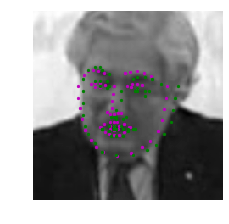

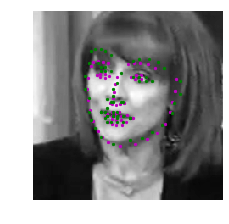

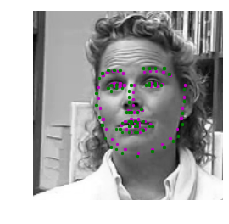

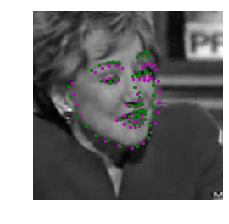

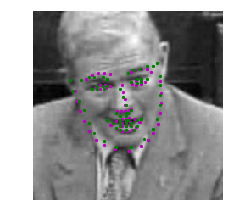

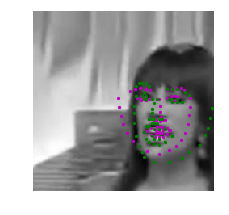

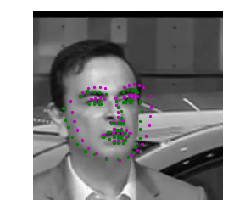

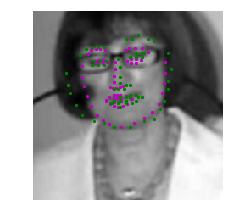

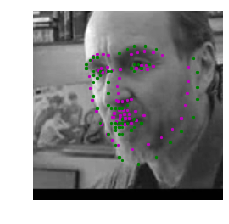

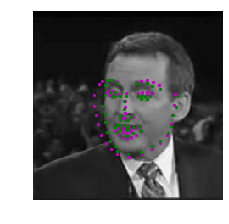

In [152]:
## TODO: visualize your test output
# you can use the same function as before, by un-commenting the line below:

visualize_output(test_images, test_outputs, gt_pts)


Once you've found a good model (or two), save your model so you can load it and use it later!

In [150]:
## TODO: change the name to something uniqe for each new model
model_dir = 'saved_models/'
model_name = 'keypoints_model_1.pt'

# after training, save your model parameters in the dir 'saved_models'
torch.save(net.state_dict(), model_dir+model_name)

After you've trained a well-performing model, answer the following questions so that we have some insight into your training and architecture selection process. Answering all questions is required to pass this project.

### Question 1: What optimization and loss functions did you choose and why?


**Answer**: write your answer here (double click to edit this cell)  
I choose MSE as loss function, because it can measure the average distance between ground truth points and predicted points.  
I choose Adam as optimization, because from experiments compared to SGD, it can achieve better performace with equal epochs. from "out[104]" above.

### Question 2: What kind of network architecture did you start with and how did it change as you tried different architectures? Did you decide to add more convolutional layers or any layers to avoid overfitting the data?

**Answer**:  
I have tried three network architectures(see models.py) and finally choose the architecture of [this paper](https://arxiv.org/pdf/1710.00977.pdf).  
I don't decide to add more conv layers or any layers, because more complex model causes overfitting more easily.

### Question 3: How did you decide on the number of epochs and batch_size to train your model?

**Answer**: write your answer here  
First I think bigger batch_size users more memory, I choose to use batch_size as 32, because I think 10 is a little smaller.     
Please refer to "out[54], out[55], out[56], out[57], out[58]", I have tried different learning rates and epochs, output the average loss on train and test data at the mean time. I choose 500 as the number of epochs because it achieves small loss on both train and test data, while with bigger numbers (600, 800, 1000), I cannot find significant performance improvement.


## Feature Visualization

Sometimes, neural networks are thought of as a black box, given some input, they learn to produce some output. CNN's are actually learning to recognize a variety of spatial patterns and you can visualize what each convolutional layer has been trained to recognize by looking at the weights that make up each convolutional kernel and applying those one at a time to a sample image. This technique is called feature visualization and it's useful for understanding the inner workings of a CNN.

In the cell below, you can see how to extract a single filter (by index) from your first convolutional layer. The filter should appear as a grayscale grid.

[[-0.02080533 -0.1968678  -0.02561927  0.09870981]
 [-0.22394677 -0.13573384  0.10304398  0.16861859]
 [-0.07669578 -0.21209215  0.1300672   0.3133583 ]
 [-0.11955387 -0.18135224  0.11696987  0.2753388 ]]
(4, 4)


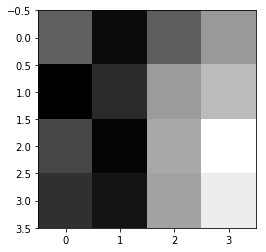

In [113]:
# Get the weights in the first conv layer, "conv1"
# if necessary, change this to reflect the name of your first conv layer
weights1 = net.conv1.weight.data

w = weights1.numpy()

filter_index = 0

print(w[filter_index][0])
print(w[filter_index][0].shape)

# display the filter weights
plt.imshow(w[filter_index][0], cmap='gray')


In [115]:
weights1.shape

torch.Size([32, 1, 4, 4])

## Feature maps

Each CNN has at least one convolutional layer that is composed of stacked filters (also known as convolutional kernels). As a CNN trains, it learns what weights to include in it's convolutional kernels and when these kernels are applied to some input image, they produce a set of **feature maps**. So, feature maps are just sets of filtered images; they are the images produced by applying a convolutional kernel to an input image. These maps show us the features that the different layers of the neural network learn to extract. For example, you might imagine a convolutional kernel that detects the vertical edges of a face or another one that detects the corners of eyes. You can see what kind of features each of these kernels detects by applying them to an image. One such example is shown below; from the way it brings out the lines in an the image, you might characterize this as an edge detection filter.

<img src='images/feature_map_ex.png' width=50% height=50%/>


Next, choose a test image and filter it with one of the convolutional kernels in your trained CNN; look at the filtered output to get an idea what that particular kernel detects.

### TODO: Filter an image to see the effect of a convolutional kernel
---

/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()
/mnt/ssd01/git/P1_Facial_Keypoints/data_load.py:39: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  key_pts = self.key_pts_frame.iloc[idx, 1:].as_matrix()


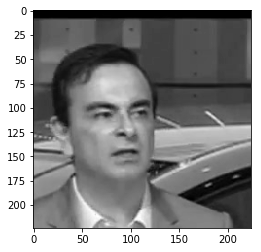

In [135]:
##TODO: load in and display any image from the transformed test dataset
test_images, test_pts, gt_pts = net_sample_output()
image = test_images[6].data   # get the image from it's wrapper
image = image.numpy()   # convert to numpy array from a Tensor
image = np.transpose(image, (1, 2, 0))   # transpose to go from torch to numpy image

plt.imshow(np.squeeze(image), cmap='gray')

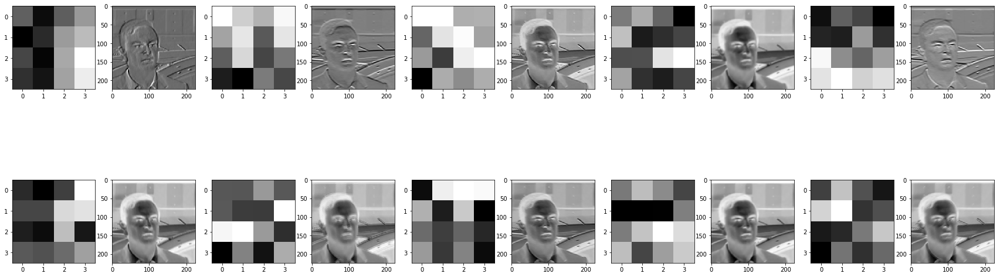

In [139]:
## TODO: Using cv's filter2D function,
## apply a specific set of filter weights (like the one displayed above) to the test image
import cv2
weights = net.conv1.weight.data
w = weights.numpy()

# 1. first conv layer
# for 10 filters
fig=plt.figure(figsize=(30, 10))
columns = 5*2
rows = 2
for i in range(0, columns*rows):
    fig.add_subplot(rows, columns, i+1)
    if ((i%2)==0):
        plt.imshow(w[int(i/2)][0], cmap='gray')
    else:
        c = cv2.filter2D(image, -1, w[int((i-1)/2)][0])
        plt.imshow(c, cmap='gray')
plt.show()

### Question 4: Choose one filter from your trained CNN and apply it to a test image; what purpose do you think it plays? What kind of feature do you think it detects?


**Answer**: (does it detect vertical lines or does it blur out noise, etc.) write your answer here  
Choose the first filter of the first convolutional layer, it looks like detecting vertical lines.

---
## Moving on!

Now that you've defined and trained your model (and saved the best model), you are ready to move on to the last notebook, which combines a face detector with your saved model to create a facial keypoint detection system that can predict the keypoints on *any* face in an image!